In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
num_gpus = torch.cuda.device_count()
print('Number of available GPUs: ', num_gpus)

for i in range(num_gpus):
    torch.cuda.set_device(i)
    allocated = torch.cuda.memory_allocated()
    reserved = torch.cuda.memory_reserved()
    print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

Number of available GPUs:  2
GPU 0: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


GPU 1: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers, dropout_rate=0.1): #初始化方法，layers是一个列表，表示每一层的神经元个数，dropout_rate是一个浮点数，表示dropout的比例
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
        self.dropout_rate = dropout_rate #设置dropout率
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1])))
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))
            # 添加 Dropout 层
            layer_list.append(('dropout_%d' % i, torch.nn.Dropout(p=self.dropout_rate)))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
                          )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程,在训练过程中不使用dropout
    # def forward(self, x):  #接收输入x
    #     out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
    #     return out #返回输出out
    def forward(self, x):
        for i in range(self.depth - 1):
            x = self.layers[i*3](x)  # 线性变换
            x = self.layers[i*3 + 1](x)  # 激活函数
            if not self.training:  # 仅在评估模式下应用 Dropout
                x = self.layers[i*3 + 2](x)  # Dropout
        x = self.layers[-1](x)  # 最后一层的线性变换
        return x
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*3](x)
            # 获取当前层的激活函数
            x = self.layers[i*3 + 1](x)
        # 返回最后一个隐藏层的输出
        return x
    
    # 新增方法，在评估模式下启用 Dropout
    def enable_dropout(self):
        for module in self.modules(): #self.modules()返回模型的所有子模块，包括模型本身
            if isinstance(module, torch.nn.Dropout): #判断module是否是torch.nn.Dropout类的实例
                module.train() #将module设置为训练模式（本质是在评估模式下）

In [5]:
# the physics-guided neural network
class PhysicsInformedNN():
    # Initialize the class
    def __init__(self, X_u, u, X_f, layers, lb, ub, nu, X_star, u_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数

        
        # boundary conditions
        #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.lb = torch.tensor(lb).float().to(device) #创建一个pytorch张量（数据来源于lb），并将其转换为浮点类型，最后将张量移动到指定的设备上
        self.ub = torch.tensor(ub).float().to(device)
        
        # data
        #创建四个pytorch张良，将X_u的第一列赋值给self.x_u，将X_u的第二列赋值给self.t_u。转换为浮点类型，移动到指定设备上，并且这几个张量都需要计算梯度
        self.x_u = torch.tensor(X_u[:, 0:1], requires_grad=True).float().to(device)
        self.t_u = torch.tensor(X_u[:, 1:2], requires_grad=True).float().to(device)
        self.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        self.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        self.x_star = torch.tensor(X_star[:, 0:1], requires_grad=True).float().to(device)
        self.t_star = torch.tensor(X_star[:, 1:2], requires_grad=True).float().to(device)

        
        self.u = torch.tensor(u).float().to(device)
        self.u_star = torch.tensor(u_star).float().to(device)
        
        self.layers = layers
        self.nu = nu
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上
        
        # optimizers: using the same settings
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重与偏置）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            # tolerance_grad=1e-10,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            # tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )

        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())

        #创建第三个优化器，括号内为要优化的参数，使用SGD优化方法
        self.optimizer_SGD = torch.optim.SGD(self.dnn.parameters(), lr=0.01, momentum=0.9)

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
        
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        return u
    
    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """
        u = self.net_u(x, t) #调用上面的net_u函数，计算神经网络的输出u
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度
        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]
        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f = u_t + u * u_x - self.nu * u_xx #计算f，定义见论文
        return f
    
    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
        
        u_pred = self.net_u(self.x_u, self.t_u) #调用之前定义的函数，传入参数得到神经网络的输出u
        f_pred = self.net_f(self.x_f, self.t_f) #调用之前定义的函数，传入参数计算得到f
        loss_u = torch.mean((self.u - u_pred) ** 2) #计算loss_u，定义见论文
        loss_f = torch.mean(f_pred ** 2) #计算loss_f，定义见论文
        
        loss = loss_u + loss_f #计算总的loss
        
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        self.iter += 1 #每调用一次损失函数，迭代次数加1

        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error
        self.dnn.eval() #将神经网络切换为评估模式
        with torch.no_grad():
            u_real_pred = self.net_u(self.x_star, self.t_star) #调用之前定义的函数，传入参数得到神经网络的输出u

        error_test = torch.norm(self.u_star-u_real_pred,2)/torch.norm(self.u_star,2)

        self.test_error.append(error_test)
        return loss
      
    
    def train(self, nIter, nIterLBFGS):

        # 初始化一个列表来存储每个epoch的权重矩阵
        self.weights = []   


        # #使用SGD优化器优化nIter次
        # for epoch in tqdm(range(nIter), desc='SGD'):
        #     u_pred = self.net_u(self.x_u, self.t_u)
        #     f_pred = self.net_f(self.x_f, self.t_f)
        #     loss = torch.mean((self.u - u_pred) ** 2) + torch.mean(f_pred ** 2)

        #     # Backward and optimize
        #     self.optimizer_SGD.zero_grad()
        #     loss.backward()
        #     self.optimizer_SGD.step()

        #     #record the loss value
        #     self.loss_value.append(loss)

        #     # record the test error
        #     with torch.no_grad():
        #         u_real_pred = self.net_u(self.x_star, self.t_star) #调用之前定义的函数，传入参数得到神经网络的输出u

        #     error_test = torch.norm(self.u_star-u_real_pred,2)/torch.norm(self.u_star,2)

        #     self.test_error.append(error_test)


        #     # 记录每一层的权重矩阵
        #     epoch_weights = []
        #     for layer in self.dnn.layers:
        #         if isinstance(layer, torch.nn.Linear):  # 检查是否为全连接层
        #             epoch_weights.append(layer.weight.data.clone())  # 使用.clone()来获取权重的副本
        #     self.weights.append(epoch_weights)

        #     W = self.weights



        #使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            self.dnn.train() #将神经网络设置为训练模式而不是评估模式
            u_pred = self.net_u(self.x_u, self.t_u) #调用之前定义的函数，传入参数得到神经网络的输出u
            f_pred = self.net_f(self.x_f, self.t_f) #调用之前定义的函数，传入参数计算得到f
            loss = torch.mean((self.u - u_pred) ** 2) + torch.mean(f_pred ** 2) #计算损失函数
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            
            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

            # record the test error
            self.dnn.eval() #将神经网络切换为评估模式
            with torch.no_grad():
                u_real_pred = self.net_u(self.x_star, self.t_star) #调用之前定义的函数，传入参数得到神经网络的输出u
            # batch_size = 100  # 设置批次大小
            # n = len(self.x_star)
            # u_real_pred = []
            # for i in range(0, n, batch_size):
            #     x_star_batch = self.x_star[i:i+batch_size]
            #     t_star_batch = self.t_star[i:i+batch_size]
            #     u_real_pred_batch = self.net_u(x_star_batch, t_star_batch)
            #     u_real_pred.append(u_real_pred_batch)
            # u_real_pred = torch.cat(u_real_pred)


            error_test = torch.norm(self.u_star-u_real_pred,2)/torch.norm(self.u_star,2)

            self.test_error.append(error_test)

            # 记录每一层的权重矩阵
            epoch_weights = []
            for layer in self.dnn.layers:
                if isinstance(layer, torch.nn.Linear):  # 检查是否为全连接层
                    epoch_weights.append(layer.weight.data.clone())  # 使用.clone()来获取权重的副本
            self.weights.append(epoch_weights)

            W = self.weights


    
        
        
        #使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.dnn.train() #将神经网络设置为训练模式而不是评估模式
            self.optimizer_LBFGS.step(self.loss_func) #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化


  


    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f = self.net_f(x, t)
        u = u.detach().cpu().numpy() #将张量u和f先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        f = f.detach().cpu().numpy()
        return u, f
    

    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval()
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1))
        hidden_output_x = hidden_output[:, 0]
        hidden_output_t = hidden_output[:, 1]
        hidden_output_x = hidden_output_x.detach().cpu().numpy()
        hidden_output_t = hidden_output_t.detach().cpu().numpy()
        return hidden_output_x, hidden_output_t
    

    def dropout_predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)
        self.dnn.eval()
        self.dnn.enable_dropout()
        u = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        u = u.detach().cpu().numpy() #将张量u和f先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return u

In [6]:
#定义采样函数，目的是采用sampler方法，生成n_samples个在指定空间内的准随机样本，这里space为二维的，因此每个样本都是一个二维点，即n_samples*2的数据点

#共有6种采样器，分别是LHS、Halton、Hammersley、Sobol、Grid和Random，均为均匀采样方法

def caiyang(n_samples, sampler): #接受两个参数，n_samples是样本数量，sampler是采样器名称，是一个字符串
    space = [(-1.0, 1.0), (0.0, 1.0)] #指定样本生成的空间，一个二维空间，第一个维度是-1到1，第二个维度是0到1

    #根据sampler的不同，选择不同的采样器，返回的sampler是一个采样器对象
    if sampler == "LHS": #如果采样器是LHS（拉丁超采样，每个维度都被均匀划分为等量区间，每个样本都是从每个维度的一个区间中随机选取的）
        sampler = skopt.sampler.Lhs(lhs_type="centered", criterion="maximin", iterations=1000) #第一个参数表示如何从每个区间选取样本，这里表示从每个区间的中心选取样本；第二个参数表示如何划分区间，这里表示尽可能使样本之间的最小距离最大；第三个表示通过优化过程得到样本量的迭代次数（即会尝试1000种不同的样本配置，并最终选择质量最好的那个）
    elif sampler == "Halton": #Halton序列是一种低差异序列，用于在高维空间中生成点
        sampler = skopt.sampler.Halton(min_skip=-1, max_skip=-1)  #两个参数用于控制序列的起始点，Halton序列可以通过跳过序列的前几个点来改变序列的七十点。两个参数分别制定了跳过点的最小和最大数量，这里-1表示不跳过任何点
    elif sampler == "Hammersley": #Hammersley序列是一种低差异序列，用于在高维空间中生成点
        sampler = skopt.sampler.Hammersly(min_skip=-1, max_skip=-1) #两个参数用于控制序列的起始点，Hammersley序列可以通过跳过序列的前几个点来改变序列的七十点。两个参数分别制定了跳过点的最小和最大数量，这里-1表示不跳过任何点
    elif sampler == "Sobol":
        # Remove the first point [0, 0, ...] and the second point [0.5, 0.5, ...], which are too special and may cause some error.
        # Sobol采样器的实现有一个问题，即生成的前两个样本点通常不是随机的而是固定的，Sobol序列的前两个点（[0, 0, ...]和[0.5, 0.5, ...]）在许多情况下都被认为是“特殊”的点，可能会对某些计算产生不利影响。因此设置跳过前两个点，而且skopt库在0.9版本号取消了max/min_skip参数，所以需要根据skopt的版本号来选择不同的参数
        if LooseVersion(skopt.__version__) < LooseVersion("0.9"): #先检查skopt的版本是否大于0.9,若小于
            sampler = skopt.sampler.Sobol(min_skip=2, max_skip=2, randomize=False) #则使用Sobol采样器，min_skip和max_skip表示跳过的点的数量，这里表示跳过前两个点，randomize表示是否随机化
        else: #若skopt的版本大于0.9
            sampler = skopt.sampler.Sobol(skip=0, randomize=False) #则使用Sobol采样器，skip表示跳过的点的数量，这里表示不跳过任何点，randomize表示是否随机化 
            return np.array(sampler.generate(space, n_samples + 2)[2:]) #生成n_samples+2个样本，然后返回除了前两个样本之外的所有样本，也就是返回n_samples个样本，每个样本都是一个二维点，且范围在指定的空间space里面
    elif sampler == "Grid":
        x_min, x_max = space[1]
        t_min, t_max = space[0]
        
        # 计算每个维度的网格大小
        x_grid_size = (x_max - x_min) / (n_samples // int(np.sqrt(n_samples)) - 1) # x维度上（纵轴），每行有10个点
        t_grid_size = (t_max - t_min) / int(np.sqrt(n_samples))  # 
        
        # 生成等距均匀网格采样点
        samples = []
        for i in range(n_samples // int(np.sqrt(n_samples))):
            for j in range(int(np.sqrt(n_samples))):
                # 计算每个网格单元的中心点
                x = x_min + i * x_grid_size
                t = t_min + j * t_grid_size
                samples.append([t, x])
        
        return np.array(samples)
    
    elif sampler == "Random":
        # 从space中提取出x_min, x_max, t_min, t_max
        x_min, x_max = space[1]
        t_min, t_max = space[0]

        # 生成x和t的随机数
        x = np.random.rand(n_samples, 1) * (x_max - x_min) + x_min
        t = np.random.rand(n_samples, 1) * (t_max - t_min) + t_min

        # 将x和t合并为一个(n_samples, 2)的数组
        samples = np.hstack((t, x))
        return samples #生成一个形状为(n_samples, 2)的随机数组



    return np.array(sampler.generate(space, n_samples)) #生成n_samples个样本，每个样本都是一个二维点，且范围在指定的空间space里面（n_samples*2）

In [7]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [8]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def calculate_chaos(model, X, num_iter):
    """
    计算模型混沌情况的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: 计算混沌情况的迭代次数。
    返回:
    - distances: 每个采样点（与该采样点加上微扰比较）在最后一次迭代后的欧氏距离数组，形状为(N_f_new,)。
    """
    #对于所有的采样点
    x0 = X[:, 0:1] #取X_f_train_new的第一列，赋值给x0，(N_f_new,1)形状
    t0 = X[:, 1:2] #取X_f_train_new的第二列，赋值给t0
    # 利用x0和t0计算x{t}和t{t}，存储在xs中
    xs = [] #初始化xs
    x,t = model.hidden_predict(x0,t0) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    
    # 迭代预测
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        xs.append([x,t]) #将x的数据添加到xs中
    #最后得到的xs是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应原始采样点的迭代结果


    # 给所有采样点加上一个很小的扰动
    x1 = x0 + np.random.normal(0, 0.0001) #加上一个很小的扰动，(N_f_new,1)形状
    t1 = t0 + np.random.normal(0, 0.0001)
    # 利用x0{1}和t0{1}计算x{t1}和t{t1}，存储在xs1中
    xs1 = [] #初始化xs1
    x,t = model.hidden_predict(x1,t1) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）

    # 迭代预测（扰动后）
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)
        xs1.append([x,t]) #将x的数据添加到xs1中
    #最后得到的xs1是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应加了扰动后的采样点的迭代结果

    # 计算最后一次迭代的隐藏层输出，即最后一次迭代的x和t
    last_iter_xs = np.array(xs[-1]) #转换为数组，便于之后计算距离
    last_iter_xs1 = np.array(xs1[-1])
    #这两个数组的形状均为(2,N_f_new,1)，第一个代表x和t，第二个代表N_f_new个样本点得到的结果，第三个代表1个数

    # 计算这两个点的欧氏距离
    distances = np.linalg.norm(last_iter_xs - last_iter_xs1, axis=0)
    #得到的是一个形状为（N_f_new,1）的数组，每个元素代表了两个点之间的欧氏距离，这里点在xt平面上

    distances = distances.flatten()

    #对distances进行归一化
    distances = distances / np.linalg.norm(distances)
    # 对distances进行归一化前，检查分母是否接近零
    # norm = np.linalg.norm(distances)
    # if norm < 1e-10:  # 1e-10是一个非常小的数，用于检测norm是否接近于零
    #     distances = np.zeros_like(distances)  # 如果分母接近0，将distances设置为全零数组，因为范数为0时，distances中的值想对于彼此几乎没有差异，意味着所有点都几乎处于同一混沌度水平
    # else:
    #     distances = distances / norm

    # 现在可以安全地根据distances对点进行排序，即使在所有值都相同的情况下

    return distances

In [9]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def MC_dropout_uncertainty(model, X, n_dropout = 10):
    """
    计算模型MC dropout不确定度的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: MC dropout进行前向传播的次数
    返回:
    - u_var: 每个采样点的不确定度，形状为(N_f_new,)。
    """
    U = []
    for _ in range(n_dropout):
        u_pred = model.dropout_predict(X)
        U.append(u_pred)
    #最后得到的U是是一个长度为n_dropout的列表，列表每个元素均为一个数组，数组的形状为(len(t)*len(x),1)，即每行是一个点的预测值
    U = np.hstack(U) #按列堆叠数组，即将U中的每个数组按列合并，得到一个新的数组U，形状为(len(t)*len(x),n_dropout)，每行是一个点在MC dropout下前向传播n_dropout次得到的输出
    u_means = np.mean(U, axis=1).reshape(-1,1) #对每一行（按列）求平均，每一行是E(y)（对应一个x），然后将其转换为二维数组(形状为(len(t)*len(x),1))
    u_var = np.mean((U - u_means) ** 2, axis=1).reshape(-1,1) #对每一行（按列）求方差，每一行是Var(y)（对应一个x），然后将其转换为二维数组(形状为(len(t)*len(x),1))
    #最后获得的u_var就相对于是每个点的不确定度
    u_var = u_var.flatten()

    return u_var

In [10]:
#RAR-G方法，对1000个点，先选择10个点训练500次，然后每500次迭代重采样100个点，选出其中残差最大的10个点添加到训练点中；最后总共有1000个点，共训练10000次
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321, 123456, 654321, 10, 210, 3210, 43210, 543210, 6543210, 1234567, 76543210] #生成10个随机种子
# seeds = [0]

nu = 0.01/np.pi
#设置噪声水平为0
noise = 0.0        

N_u = 100
N_f = 5000

#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
layers = [2, 20, 20, 20, 20, 20, 20, 20, 20, 2, 1]
#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/burgers_shock.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['t'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

# Doman bounds，分别获得X_star的相应列上的最小值和最大值，赋值给lb和ub,也就是说lb是x和t的最小值，ub是x和t的最大值，即lb和ub分别为[-1,0]和[1,1]
lb = X_star.min(0)
ub = X_star.max(0)    


#生成初值和边界值的训练基础数据
xx1 = np.hstack((X[0:1,:].T, T[0:1,:].T)) #分别取X，T的第一行的转置(分别是x和全0列)，分别构成xx1的第一列和第二列
uu1 = Exact[0:1,:].T #取Exact的第一行的转置，赋值给uu1
xx2 = np.hstack((X[:,0:1], T[:,0:1])) #分别取X，T的第一列(分别是全-1列和t)，分别构成xx2的第一列和第二列
uu2 = Exact[:,0:1] #取Exact的第一列，赋值给uu2
xx3 = np.hstack((X[:,-1:], T[:,-1:])) #分别取X，T的最后一列(分别是全1列和t)，分别构成xx3的第一列和第二列
uu3 = Exact[:,-1:] #取Exact的最后一列，赋值给uu3

X_u_train_all = np.vstack([xx1, xx2, xx3]) #X_u_train=(xx1;xx2;xx3)

u_train_all = np.vstack([uu1, uu2, uu3]) #u_train=(uu1;uu2;uu3)

# #生成配位点训练基础数据
# X_f_train = quasirandom(N_f, "LHS")  #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，表示生产的样本有两个特征，共N_f个样本数量，所以返回的是一个形状为（N_f，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本X_f_train。

# X_f_train = np.vstack((X_f_train, X_u_train)) #按行堆叠数组，即将X_f_train和X_u_train按行合并，得到一个新的数组X_f_train


error_u = [] #创建一个空列表，用于存储误差值

i = 0 #初始化i为0

for seed in seeds:
    set_seed(seed) #设置随机数种子


    #1.生成初值边界值训练数据，以及测试数据

    #从所有的初值边界值训练基础数据中选取N_u=100个点
    idx = np.random.choice(X_u_train_all.shape[0], N_u, replace=False) #从0~数组X_u_train的行数 中随机选择N_u个数，replace=False表示不允许重复选择，最后将这N_u个数赋值给idx
    X_u_train = X_u_train_all[idx, :] #从X_u_train中选取idx对应的的N_u行，赋值给X_u_train
    u_train = u_train_all[idx,:] #从u_train中选取idx对应的的N_u行，赋值给u_train

    

    #2.生成配位点并进行训练

    nIter = 50000 #设置迭代次数为10000
    nIterLBFGS = 500 #设置LBFGS迭代次数为500

    # trainloss = [] #创建一个空列表，用于存储训练损失值
    # testerror = [] #创建一个空列表，用于存储测试误差值
    
    # 调用quasirandom函数生成配位点
    X_f_train = caiyang(N_f, "LHS")

    # X_f_train = np.vstack((X_f_train, X_u_train_all)) #按行堆叠数组，即将X_f_train和X_u_train按行合并，得到一个新的数组X_f_train



    #创建PINN模型并输入各种参数     
    model = PhysicsInformedNN(X_u_train, u_train, X_f_train, layers, lb, ub, nu, X_star, u_star)

    #获取当前时间并赋值给start_time  
    start_time = time.time()   
    #开始训练模型            
    model.train(nIter,nIterLBFGS)
    #训练结束后获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time
    #打印训练所花时间                
    print('Training time: %.4f' % (elapsed))

    #用训练好的模型调用predict方法进行预测，返回两个值（均为数组）
    u_pred, f_pred = model.predict(X_star)
    #计算误差（基于2范数）        
    error_u.append(np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)) #计算误差，然后将误差添加到error_u列表中

    # print('Error u of Random sampling: %e' % (error_u)) #打印误差               


    # #将训练损失值添加到trainloss列表中
    # trainloss.append(torch.stack(model.loss_value).cpu().detach().numpy())

    # testerror.append(torch.stack(model.test_error).cpu().detach().numpy())
    i+=1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')
    


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:00<3:11:13,  4.36it/s]

Adam:   0%|          | 18/50000 [00:00<12:32, 66.41it/s] 

Adam:   0%|          | 35/50000 [00:00<08:14, 101.13it/s]

Adam:   0%|          | 48/50000 [00:00<09:06, 91.38it/s] 

Adam:   0%|          | 59/50000 [00:00<08:39, 96.13it/s]

Adam:   0%|          | 76/50000 [00:00<07:08, 116.60it/s]

Adam:   0%|          | 89/50000 [00:00<08:04, 102.99it/s]

Adam:   0%|          | 106/50000 [00:01<06:57, 119.56it/s]

Adam:   0%|          | 123/50000 [00:01<06:16, 132.51it/s]

Adam:   0%|          | 138/50000 [00:01<06:27, 128.59it/s]

Adam:   0%|          | 152/50000 [00:01<06:47, 122.43it/s]

Adam:   0%|          | 168/50000 [00:01<06:17, 131.91it/s]

Adam:   0%|          | 184/50000 [00:01<06:00, 138.35it/s]

Adam:   0%|          | 199/50000 [00:01<06:59, 118.70it/s]

Adam:   0%|          | 214/50000 [00:01<06:35, 125.83it/s]

Adam:   0%|          | 228/50000 [00:02<06:36, 125.45it/s]

Adam:   0%|          | 241/50000 [00:02<07:45, 106.92it/s]

Adam:   1%|          | 254/50000 [00:02<07:28, 110.99it/s]

Adam:   1%|          | 271/50000 [00:02<06:37, 125.25it/s]

Adam:   1%|          | 285/50000 [00:02<06:58, 118.89it/s]

Adam:   1%|          | 298/50000 [00:02<07:07, 116.18it/s]

Adam:   1%|          | 315/50000 [00:02<06:22, 129.78it/s]

Adam:   1%|          | 329/50000 [00:02<07:12, 114.72it/s]

Adam:   1%|          | 342/50000 [00:03<07:36, 108.84it/s]

Adam:   1%|          | 358/50000 [00:03<06:53, 120.17it/s]

Adam:   1%|          | 371/50000 [00:03<07:21, 112.53it/s]

Adam:   1%|          | 383/50000 [00:03<08:29, 97.40it/s] 

Adam:   1%|          | 394/50000 [00:03<08:41, 95.10it/s]

Adam:   1%|          | 406/50000 [00:03<08:17, 99.71it/s]

Adam:   1%|          | 418/50000 [00:03<08:08, 101.56it/s]

Adam:   1%|          | 429/50000 [00:03<08:40, 95.18it/s] 

Adam:   1%|          | 442/50000 [00:04<08:03, 102.46it/s]

Adam:   1%|          | 453/50000 [00:04<09:19, 88.62it/s] 

Adam:   1%|          | 463/50000 [00:04<09:18, 88.77it/s]

Adam:   1%|          | 480/50000 [00:04<07:38, 108.11it/s]

Adam:   1%|          | 492/50000 [00:04<08:32, 96.68it/s] 

Adam:   1%|          | 505/50000 [00:04<08:04, 102.12it/s]

Adam:   1%|          | 518/50000 [00:04<07:40, 107.39it/s]

Adam:   1%|          | 530/50000 [00:04<08:08, 101.29it/s]

Adam:   1%|          | 542/50000 [00:05<07:51, 104.81it/s]

Adam:   1%|          | 558/50000 [00:05<06:54, 119.15it/s]

Adam:   1%|          | 571/50000 [00:05<07:30, 109.75it/s]

Adam:   1%|          | 584/50000 [00:05<07:09, 114.94it/s]

Adam:   1%|          | 601/50000 [00:05<06:24, 128.55it/s]

Adam:   1%|          | 615/50000 [00:05<06:36, 124.55it/s]

Adam:   1%|▏         | 628/50000 [00:05<07:48, 105.32it/s]

Adam:   1%|▏         | 640/50000 [00:05<08:00, 102.67it/s]

Adam:   1%|▏         | 652/50000 [00:05<07:42, 106.68it/s]

Adam:   1%|▏         | 664/50000 [00:06<08:31, 96.38it/s] 

Adam:   1%|▏         | 681/50000 [00:06<07:15, 113.12it/s]

Adam:   1%|▏         | 696/50000 [00:06<06:52, 119.64it/s]

Adam:   1%|▏         | 709/50000 [00:06<07:47, 105.54it/s]

Adam:   1%|▏         | 725/50000 [00:06<06:58, 117.74it/s]

Adam:   1%|▏         | 738/50000 [00:06<07:27, 110.04it/s]

Adam:   2%|▏         | 750/50000 [00:06<08:01, 102.32it/s]

Adam:   2%|▏         | 767/50000 [00:07<06:56, 118.35it/s]

Adam:   2%|▏         | 780/50000 [00:07<07:07, 115.13it/s]

Adam:   2%|▏         | 792/50000 [00:07<07:52, 104.15it/s]

Adam:   2%|▏         | 805/50000 [00:07<07:27, 110.05it/s]

Adam:   2%|▏         | 821/50000 [00:07<06:44, 121.52it/s]

Adam:   2%|▏         | 836/50000 [00:07<06:23, 128.20it/s]

Adam:   2%|▏         | 850/50000 [00:07<07:28, 109.63it/s]

Adam:   2%|▏         | 866/50000 [00:07<06:43, 121.81it/s]

Adam:   2%|▏         | 879/50000 [00:07<06:58, 117.41it/s]

Adam:   2%|▏         | 892/50000 [00:08<07:55, 103.17it/s]

Adam:   2%|▏         | 908/50000 [00:08<07:05, 115.49it/s]

Adam:   2%|▏         | 921/50000 [00:08<06:53, 118.78it/s]

Adam:   2%|▏         | 934/50000 [00:08<07:37, 107.20it/s]

Adam:   2%|▏         | 950/50000 [00:08<06:52, 118.95it/s]

Adam:   2%|▏         | 963/50000 [00:08<08:07, 100.62it/s]

Adam:   2%|▏         | 974/50000 [00:08<08:55, 91.48it/s] 

Adam:   2%|▏         | 985/50000 [00:09<08:34, 95.21it/s]

Adam:   2%|▏         | 996/50000 [00:09<09:12, 88.70it/s]

Adam:   2%|▏         | 1006/50000 [00:09<09:59, 81.70it/s]

Adam:   2%|▏         | 1015/50000 [00:09<10:29, 77.84it/s]

Adam:   2%|▏         | 1030/50000 [00:09<08:38, 94.42it/s]

Adam:   2%|▏         | 1043/50000 [00:09<07:55, 102.95it/s]

Adam:   2%|▏         | 1057/50000 [00:09<07:22, 110.55it/s]

Adam:   2%|▏         | 1069/50000 [00:09<08:22, 97.34it/s] 

Adam:   2%|▏         | 1084/50000 [00:10<07:26, 109.44it/s]

Adam:   2%|▏         | 1096/50000 [00:10<07:17, 111.89it/s]

Adam:   2%|▏         | 1109/50000 [00:10<06:58, 116.74it/s]

Adam:   2%|▏         | 1127/50000 [00:10<06:09, 132.36it/s]

Adam:   2%|▏         | 1141/50000 [00:10<06:30, 125.24it/s]

Adam:   2%|▏         | 1154/50000 [00:10<08:06, 100.43it/s]

Adam:   2%|▏         | 1169/50000 [00:10<07:20, 110.75it/s]

Adam:   2%|▏         | 1184/50000 [00:10<06:50, 119.03it/s]

Adam:   2%|▏         | 1197/50000 [00:11<07:48, 104.26it/s]

Adam:   2%|▏         | 1212/50000 [00:11<07:06, 114.39it/s]

Adam:   2%|▏         | 1225/50000 [00:11<07:09, 113.54it/s]

Adam:   2%|▏         | 1237/50000 [00:11<08:00, 101.51it/s]

Adam:   2%|▏         | 1248/50000 [00:11<08:54, 91.23it/s] 

Adam:   3%|▎         | 1258/50000 [00:11<08:45, 92.78it/s]

Adam:   3%|▎         | 1269/50000 [00:11<08:29, 95.67it/s]

Adam:   3%|▎         | 1279/50000 [00:11<09:26, 86.07it/s]

Adam:   3%|▎         | 1296/50000 [00:12<07:39, 105.92it/s]

Adam:   3%|▎         | 1311/50000 [00:12<06:58, 116.31it/s]

Adam:   3%|▎         | 1324/50000 [00:12<07:37, 106.38it/s]

Adam:   3%|▎         | 1341/50000 [00:12<06:42, 120.76it/s]

Adam:   3%|▎         | 1358/50000 [00:12<06:14, 129.80it/s]

Adam:   3%|▎         | 1372/50000 [00:12<07:40, 105.57it/s]

Adam:   3%|▎         | 1384/50000 [00:12<07:31, 107.64it/s]

Adam:   3%|▎         | 1396/50000 [00:12<08:03, 100.58it/s]

Adam:   3%|▎         | 1410/50000 [00:13<07:22, 109.73it/s]

Adam:   3%|▎         | 1425/50000 [00:13<06:51, 117.93it/s]

Adam:   3%|▎         | 1438/50000 [00:13<08:04, 100.24it/s]

Adam:   3%|▎         | 1454/50000 [00:13<07:05, 114.10it/s]

Adam:   3%|▎         | 1470/50000 [00:13<06:26, 125.62it/s]

Adam:   3%|▎         | 1484/50000 [00:13<06:25, 125.70it/s]

Adam:   3%|▎         | 1498/50000 [00:13<07:00, 115.28it/s]

Adam:   3%|▎         | 1511/50000 [00:13<06:51, 117.80it/s]

Adam:   3%|▎         | 1524/50000 [00:14<08:01, 100.63it/s]

Adam:   3%|▎         | 1541/50000 [00:14<06:55, 116.52it/s]

Adam:   3%|▎         | 1558/50000 [00:14<06:15, 129.06it/s]

Adam:   3%|▎         | 1572/50000 [00:14<07:08, 113.01it/s]

Adam:   3%|▎         | 1585/50000 [00:14<07:00, 115.24it/s]

Adam:   3%|▎         | 1598/50000 [00:14<06:58, 115.57it/s]

Adam:   3%|▎         | 1611/50000 [00:14<07:19, 110.07it/s]

Adam:   3%|▎         | 1626/50000 [00:14<06:43, 119.85it/s]

Adam:   3%|▎         | 1639/50000 [00:15<06:49, 118.18it/s]

Adam:   3%|▎         | 1652/50000 [00:15<07:11, 112.09it/s]

Adam:   3%|▎         | 1667/50000 [00:15<06:44, 119.37it/s]

Adam:   3%|▎         | 1680/50000 [00:15<07:28, 107.81it/s]

Adam:   3%|▎         | 1692/50000 [00:15<07:34, 106.19it/s]

Adam:   3%|▎         | 1707/50000 [00:15<06:53, 116.73it/s]

Adam:   3%|▎         | 1719/50000 [00:15<07:05, 113.34it/s]

Adam:   3%|▎         | 1731/50000 [00:15<07:32, 106.73it/s]

Adam:   3%|▎         | 1748/50000 [00:15<06:32, 122.80it/s]

Adam:   4%|▎         | 1761/50000 [00:16<07:30, 107.11it/s]

Adam:   4%|▎         | 1773/50000 [00:16<07:59, 100.67it/s]

Adam:   4%|▎         | 1789/50000 [00:16<07:01, 114.42it/s]

Adam:   4%|▎         | 1802/50000 [00:16<07:47, 103.04it/s]

Adam:   4%|▎         | 1819/50000 [00:16<06:46, 118.55it/s]

Adam:   4%|▎         | 1836/50000 [00:16<06:08, 130.85it/s]

Adam:   4%|▎         | 1850/50000 [00:16<06:36, 121.40it/s]

Adam:   4%|▎         | 1863/50000 [00:16<06:39, 120.47it/s]

Adam:   4%|▍         | 1880/50000 [00:17<06:05, 131.78it/s]

Adam:   4%|▍         | 1894/50000 [00:17<06:52, 116.76it/s]

Adam:   4%|▍         | 1907/50000 [00:17<07:15, 110.44it/s]

Adam:   4%|▍         | 1920/50000 [00:17<06:58, 114.86it/s]

Adam:   4%|▍         | 1932/50000 [00:17<07:29, 106.93it/s]

Adam:   4%|▍         | 1943/50000 [00:17<08:08, 98.45it/s] 

Adam:   4%|▍         | 1956/50000 [00:17<07:33, 105.89it/s]

Adam:   4%|▍         | 1967/50000 [00:17<07:50, 102.06it/s]

Adam:   4%|▍         | 1978/50000 [00:18<09:02, 88.56it/s] 

Adam:   4%|▍         | 1990/50000 [00:18<08:25, 95.02it/s]

Adam:   4%|▍         | 2007/50000 [00:18<07:04, 113.19it/s]

Adam:   4%|▍         | 2019/50000 [00:18<07:12, 111.00it/s]

Adam:   4%|▍         | 2031/50000 [00:18<07:39, 104.43it/s]

Adam:   4%|▍         | 2048/50000 [00:18<06:36, 120.81it/s]

Adam:   4%|▍         | 2061/50000 [00:18<06:58, 114.64it/s]

Adam:   4%|▍         | 2073/50000 [00:18<06:56, 114.99it/s]

Adam:   4%|▍         | 2085/50000 [00:19<08:17, 96.40it/s] 

Adam:   4%|▍         | 2096/50000 [00:19<08:05, 98.76it/s]

Adam:   4%|▍         | 2107/50000 [00:19<08:15, 96.59it/s]

Adam:   4%|▍         | 2119/50000 [00:19<07:52, 101.37it/s]

Adam:   4%|▍         | 2130/50000 [00:19<08:08, 98.01it/s] 

Adam:   4%|▍         | 2148/50000 [00:19<06:41, 119.19it/s]

Adam:   4%|▍         | 2164/50000 [00:19<06:12, 128.38it/s]

Adam:   4%|▍         | 2178/50000 [00:19<06:37, 120.22it/s]

Adam:   4%|▍         | 2191/50000 [00:20<08:59, 88.63it/s] 

Adam:   4%|▍         | 2202/50000 [00:20<08:57, 88.87it/s]

Adam:   4%|▍         | 2213/50000 [00:20<08:41, 91.64it/s]

Adam:   4%|▍         | 2223/50000 [00:20<09:43, 81.82it/s]

Adam:   4%|▍         | 2239/50000 [00:20<08:02, 99.05it/s]

Adam:   5%|▍         | 2256/50000 [00:20<06:53, 115.39it/s]

Adam:   5%|▍         | 2269/50000 [00:20<07:41, 103.51it/s]

Adam:   5%|▍         | 2286/50000 [00:20<06:41, 118.72it/s]

Adam:   5%|▍         | 2299/50000 [00:21<06:50, 116.07it/s]

Adam:   5%|▍         | 2312/50000 [00:21<07:37, 104.35it/s]

Adam:   5%|▍         | 2329/50000 [00:21<06:37, 119.84it/s]

Adam:   5%|▍         | 2343/50000 [00:21<06:29, 122.38it/s]

Adam:   5%|▍         | 2356/50000 [00:21<07:49, 101.57it/s]

Adam:   5%|▍         | 2372/50000 [00:21<06:56, 114.46it/s]

Adam:   5%|▍         | 2385/50000 [00:21<07:24, 107.14it/s]

Adam:   5%|▍         | 2397/50000 [00:22<08:07, 97.70it/s] 

Adam:   5%|▍         | 2410/50000 [00:22<07:36, 104.21it/s]

Adam:   5%|▍         | 2427/50000 [00:22<06:36, 120.00it/s]

Adam:   5%|▍         | 2441/50000 [00:22<06:29, 122.11it/s]

Adam:   5%|▍         | 2454/50000 [00:22<06:57, 113.89it/s]

Adam:   5%|▍         | 2469/50000 [00:22<06:26, 123.12it/s]

Adam:   5%|▍         | 2483/50000 [00:22<06:21, 124.45it/s]

Adam:   5%|▍         | 2496/50000 [00:22<06:49, 115.97it/s]

Adam:   5%|▌         | 2513/50000 [00:22<06:09, 128.68it/s]

Adam:   5%|▌         | 2527/50000 [00:23<06:33, 120.67it/s]

Adam:   5%|▌         | 2540/50000 [00:23<06:54, 114.42it/s]

Adam:   5%|▌         | 2552/50000 [00:23<07:01, 112.65it/s]

Adam:   5%|▌         | 2564/50000 [00:23<07:56, 99.45it/s] 

Adam:   5%|▌         | 2578/50000 [00:23<07:16, 108.65it/s]

Adam:   5%|▌         | 2595/50000 [00:23<06:21, 124.21it/s]

Adam:   5%|▌         | 2608/50000 [00:23<07:27, 105.99it/s]

Adam:   5%|▌         | 2624/50000 [00:23<06:39, 118.70it/s]

Adam:   5%|▌         | 2640/50000 [00:24<06:08, 128.55it/s]

Adam:   5%|▌         | 2654/50000 [00:24<07:02, 112.12it/s]

Adam:   5%|▌         | 2667/50000 [00:24<07:19, 107.60it/s]

Adam:   5%|▌         | 2679/50000 [00:24<07:57, 99.11it/s] 

Adam:   5%|▌         | 2690/50000 [00:24<08:23, 93.91it/s]

Adam:   5%|▌         | 2700/50000 [00:24<08:49, 89.29it/s]

Adam:   5%|▌         | 2712/50000 [00:24<08:13, 95.86it/s]

Adam:   5%|▌         | 2722/50000 [00:25<09:28, 83.22it/s]

Adam:   5%|▌         | 2731/50000 [00:25<10:23, 75.77it/s]

Adam:   5%|▌         | 2739/50000 [00:25<10:48, 72.83it/s]

Adam:   5%|▌         | 2747/50000 [00:25<11:00, 71.58it/s]

Adam:   6%|▌         | 2759/50000 [00:25<09:25, 83.57it/s]

Adam:   6%|▌         | 2775/50000 [00:25<07:45, 101.39it/s]

Adam:   6%|▌         | 2786/50000 [00:25<08:29, 92.65it/s] 

Adam:   6%|▌         | 2797/50000 [00:25<08:07, 96.87it/s]

Adam:   6%|▌         | 2810/50000 [00:25<07:30, 104.67it/s]

Adam:   6%|▌         | 2821/50000 [00:26<07:29, 104.98it/s]

Adam:   6%|▌         | 2832/50000 [00:26<07:48, 100.65it/s]

Adam:   6%|▌         | 2845/50000 [00:26<07:19, 107.31it/s]

Adam:   6%|▌         | 2856/50000 [00:26<08:15, 95.06it/s] 

Adam:   6%|▌         | 2866/50000 [00:26<09:12, 85.35it/s]

Adam:   6%|▌         | 2876/50000 [00:26<08:55, 87.95it/s]

Adam:   6%|▌         | 2890/50000 [00:26<07:54, 99.31it/s]

Adam:   6%|▌         | 2902/50000 [00:26<07:31, 104.28it/s]

Adam:   6%|▌         | 2913/50000 [00:27<07:57, 98.71it/s] 

Adam:   6%|▌         | 2924/50000 [00:27<07:47, 100.65it/s]

Adam:   6%|▌         | 2936/50000 [00:27<07:48, 100.47it/s]

Adam:   6%|▌         | 2947/50000 [00:27<08:52, 88.35it/s] 

Adam:   6%|▌         | 2959/50000 [00:27<08:10, 95.87it/s]

Adam:   6%|▌         | 2970/50000 [00:27<08:06, 96.67it/s]

Adam:   6%|▌         | 2985/50000 [00:27<07:14, 108.15it/s]

Adam:   6%|▌         | 2997/50000 [00:27<07:47, 100.59it/s]

Adam:   6%|▌         | 3009/50000 [00:28<07:27, 105.13it/s]

Adam:   6%|▌         | 3023/50000 [00:28<07:05, 110.33it/s]

Adam:   6%|▌         | 3035/50000 [00:28<07:45, 100.81it/s]

Adam:   6%|▌         | 3048/50000 [00:28<07:16, 107.52it/s]

Adam:   6%|▌         | 3062/50000 [00:28<06:55, 112.96it/s]

Adam:   6%|▌         | 3074/50000 [00:28<07:23, 105.74it/s]

Adam:   6%|▌         | 3091/50000 [00:28<06:23, 122.35it/s]

Adam:   6%|▌         | 3106/50000 [00:28<06:01, 129.73it/s]

Adam:   6%|▌         | 3120/50000 [00:28<07:19, 106.73it/s]

Adam:   6%|▋         | 3135/50000 [00:29<06:42, 116.51it/s]

Adam:   6%|▋         | 3151/50000 [00:29<06:07, 127.51it/s]

Adam:   6%|▋         | 3166/50000 [00:29<05:53, 132.39it/s]

Adam:   6%|▋         | 3180/50000 [00:29<06:40, 116.91it/s]

Adam:   6%|▋         | 3194/50000 [00:29<06:26, 121.10it/s]

Adam:   6%|▋         | 3207/50000 [00:29<06:25, 121.24it/s]

Adam:   6%|▋         | 3220/50000 [00:29<07:22, 105.68it/s]

Adam:   6%|▋         | 3235/50000 [00:29<06:45, 115.45it/s]

Adam:   7%|▋         | 3251/50000 [00:30<06:11, 125.92it/s]

Adam:   7%|▋         | 3265/50000 [00:30<07:00, 111.05it/s]

Adam:   7%|▋         | 3282/50000 [00:30<06:15, 124.35it/s]

Adam:   7%|▋         | 3298/50000 [00:30<05:50, 133.14it/s]

Adam:   7%|▋         | 3312/50000 [00:30<06:48, 114.30it/s]

Adam:   7%|▋         | 3328/50000 [00:30<06:16, 123.91it/s]

Adam:   7%|▋         | 3343/50000 [00:30<05:59, 129.90it/s]

Adam:   7%|▋         | 3357/50000 [00:30<06:50, 113.66it/s]

Adam:   7%|▋         | 3374/50000 [00:31<06:06, 127.16it/s]

Adam:   7%|▋         | 3388/50000 [00:31<06:26, 120.59it/s]

Adam:   7%|▋         | 3401/50000 [00:31<06:30, 119.26it/s]

Adam:   7%|▋         | 3414/50000 [00:31<06:51, 113.19it/s]

Adam:   7%|▋         | 3429/50000 [00:31<06:20, 122.55it/s]

Adam:   7%|▋         | 3442/50000 [00:31<07:15, 107.01it/s]

Adam:   7%|▋         | 3458/50000 [00:31<06:30, 119.07it/s]

Adam:   7%|▋         | 3471/50000 [00:31<06:47, 114.18it/s]

Adam:   7%|▋         | 3483/50000 [00:32<06:48, 113.86it/s]

Adam:   7%|▋         | 3498/50000 [00:32<06:23, 121.40it/s]

Adam:   7%|▋         | 3514/50000 [00:32<05:58, 129.72it/s]

Adam:   7%|▋         | 3528/50000 [00:32<06:45, 114.57it/s]

Adam:   7%|▋         | 3540/50000 [00:32<06:47, 114.00it/s]

Adam:   7%|▋         | 3557/50000 [00:32<06:05, 127.09it/s]

Adam:   7%|▋         | 3571/50000 [00:32<07:14, 106.91it/s]

Adam:   7%|▋         | 3588/50000 [00:32<06:24, 120.74it/s]

Adam:   7%|▋         | 3605/50000 [00:32<05:50, 132.27it/s]

Adam:   7%|▋         | 3619/50000 [00:33<06:45, 114.40it/s]

Adam:   7%|▋         | 3636/50000 [00:33<06:03, 127.40it/s]

Adam:   7%|▋         | 3651/50000 [00:33<05:49, 132.54it/s]

Adam:   7%|▋         | 3665/50000 [00:33<06:48, 113.40it/s]

Adam:   7%|▋         | 3682/50000 [00:33<06:08, 125.53it/s]

Adam:   7%|▋         | 3699/50000 [00:33<05:42, 135.01it/s]

Adam:   7%|▋         | 3714/50000 [00:33<07:23, 104.37it/s]

Adam:   7%|▋         | 3729/50000 [00:34<06:49, 113.04it/s]

Adam:   7%|▋         | 3744/50000 [00:34<06:24, 120.38it/s]

Adam:   8%|▊         | 3758/50000 [00:34<07:38, 100.91it/s]

Adam:   8%|▊         | 3774/50000 [00:34<06:48, 113.23it/s]

Adam:   8%|▊         | 3790/50000 [00:34<06:14, 123.28it/s]

Adam:   8%|▊         | 3804/50000 [00:34<07:11, 107.06it/s]

Adam:   8%|▊         | 3816/50000 [00:34<07:06, 108.32it/s]

Adam:   8%|▊         | 3830/50000 [00:34<06:42, 114.70it/s]

Adam:   8%|▊         | 3843/50000 [00:35<07:31, 102.20it/s]

Adam:   8%|▊         | 3854/50000 [00:35<07:49, 98.28it/s] 

Adam:   8%|▊         | 3865/50000 [00:35<07:39, 100.50it/s]

Adam:   8%|▊         | 3877/50000 [00:35<07:17, 105.39it/s]

Adam:   8%|▊         | 3888/50000 [00:35<08:04, 95.14it/s] 

Adam:   8%|▊         | 3904/50000 [00:35<06:58, 110.08it/s]

Adam:   8%|▊         | 3916/50000 [00:35<06:56, 110.63it/s]

Adam:   8%|▊         | 3928/50000 [00:35<07:46, 98.71it/s] 

Adam:   8%|▊         | 3939/50000 [00:36<07:59, 96.02it/s]

Adam:   8%|▊         | 3952/50000 [00:36<07:20, 104.45it/s]

Adam:   8%|▊         | 3967/50000 [00:36<06:43, 114.06it/s]

Adam:   8%|▊         | 3983/50000 [00:36<06:06, 125.56it/s]

Adam:   8%|▊         | 3996/50000 [00:36<07:03, 108.62it/s]

Adam:   8%|▊         | 4013/50000 [00:36<06:12, 123.55it/s]

Adam:   8%|▊         | 4030/50000 [00:36<05:47, 132.23it/s]

Adam:   8%|▊         | 4044/50000 [00:36<06:46, 113.08it/s]

Adam:   8%|▊         | 4061/50000 [00:37<06:06, 125.36it/s]

Adam:   8%|▊         | 4077/50000 [00:37<05:49, 131.44it/s]

Adam:   8%|▊         | 4091/50000 [00:37<07:19, 104.41it/s]

Adam:   8%|▊         | 4103/50000 [00:37<07:27, 102.62it/s]

Adam:   8%|▊         | 4115/50000 [00:37<07:49, 97.75it/s] 

Adam:   8%|▊         | 4126/50000 [00:37<08:02, 95.13it/s]

Adam:   8%|▊         | 4142/50000 [00:37<06:57, 109.91it/s]

Adam:   8%|▊         | 4156/50000 [00:37<06:36, 115.61it/s]

Adam:   8%|▊         | 4169/50000 [00:38<06:25, 119.02it/s]

Adam:   8%|▊         | 4185/50000 [00:38<05:54, 129.40it/s]

Adam:   8%|▊         | 4199/50000 [00:38<06:16, 121.59it/s]

Adam:   8%|▊         | 4212/50000 [00:38<06:42, 113.75it/s]

Adam:   8%|▊         | 4229/50000 [00:38<05:59, 127.44it/s]

Adam:   8%|▊         | 4245/50000 [00:38<05:36, 135.84it/s]

Adam:   9%|▊         | 4259/50000 [00:38<06:35, 115.66it/s]

Adam:   9%|▊         | 4276/50000 [00:38<05:56, 128.30it/s]

Adam:   9%|▊         | 4291/50000 [00:39<05:45, 132.14it/s]

Adam:   9%|▊         | 4305/50000 [00:39<06:41, 113.93it/s]

Adam:   9%|▊         | 4320/50000 [00:39<06:13, 122.16it/s]

Adam:   9%|▊         | 4334/50000 [00:39<06:05, 124.90it/s]

Adam:   9%|▊         | 4348/50000 [00:39<07:24, 102.72it/s]

Adam:   9%|▊         | 4365/50000 [00:39<06:27, 117.81it/s]

Adam:   9%|▉         | 4382/50000 [00:39<05:52, 129.28it/s]

Adam:   9%|▉         | 4396/50000 [00:39<06:41, 113.69it/s]

Adam:   9%|▉         | 4412/50000 [00:40<06:05, 124.67it/s]

Adam:   9%|▉         | 4427/50000 [00:40<05:49, 130.30it/s]

Adam:   9%|▉         | 4441/50000 [00:40<06:45, 112.24it/s]

Adam:   9%|▉         | 4457/50000 [00:40<06:07, 123.78it/s]

Adam:   9%|▉         | 4471/50000 [00:40<06:20, 119.79it/s]

Adam:   9%|▉         | 4484/50000 [00:40<07:12, 105.24it/s]

Adam:   9%|▉         | 4501/50000 [00:40<06:18, 120.16it/s]

Adam:   9%|▉         | 4514/50000 [00:40<06:12, 122.05it/s]

Adam:   9%|▉         | 4527/50000 [00:41<06:15, 121.10it/s]

Adam:   9%|▉         | 4540/50000 [00:41<06:57, 108.98it/s]

Adam:   9%|▉         | 4557/50000 [00:41<06:09, 123.15it/s]

Adam:   9%|▉         | 4571/50000 [00:41<06:00, 125.96it/s]

Adam:   9%|▉         | 4585/50000 [00:41<06:54, 109.65it/s]

Adam:   9%|▉         | 4601/50000 [00:41<06:13, 121.55it/s]

Adam:   9%|▉         | 4618/50000 [00:41<05:43, 132.14it/s]

Adam:   9%|▉         | 4632/50000 [00:41<06:45, 111.92it/s]

Adam:   9%|▉         | 4648/50000 [00:42<06:08, 123.11it/s]

Adam:   9%|▉         | 4665/50000 [00:42<05:37, 134.38it/s]

Adam:   9%|▉         | 4680/50000 [00:42<06:30, 116.14it/s]

Adam:   9%|▉         | 4693/50000 [00:42<06:45, 111.73it/s]

Adam:   9%|▉         | 4709/50000 [00:42<06:15, 120.65it/s]

Adam:   9%|▉         | 4722/50000 [00:42<07:11, 105.03it/s]

Adam:   9%|▉         | 4734/50000 [00:42<07:04, 106.73it/s]

Adam:  10%|▉         | 4750/50000 [00:42<06:18, 119.40it/s]

Adam:  10%|▉         | 4763/50000 [00:43<07:07, 105.78it/s]

Adam:  10%|▉         | 4779/50000 [00:43<06:24, 117.74it/s]

Adam:  10%|▉         | 4792/50000 [00:43<06:32, 115.07it/s]

Adam:  10%|▉         | 4804/50000 [00:43<07:24, 101.72it/s]

Adam:  10%|▉         | 4815/50000 [00:43<07:40, 98.08it/s] 

Adam:  10%|▉         | 4830/50000 [00:43<06:51, 109.89it/s]

Adam:  10%|▉         | 4845/50000 [00:43<06:16, 119.87it/s]

Adam:  10%|▉         | 4858/50000 [00:43<07:12, 104.41it/s]

Adam:  10%|▉         | 4874/50000 [00:44<06:24, 117.35it/s]

Adam:  10%|▉         | 4889/50000 [00:44<06:05, 123.41it/s]

Adam:  10%|▉         | 4902/50000 [00:44<06:38, 113.17it/s]

Adam:  10%|▉         | 4917/50000 [00:44<06:16, 119.84it/s]

Adam:  10%|▉         | 4930/50000 [00:44<06:39, 112.94it/s]

Adam:  10%|▉         | 4942/50000 [00:44<07:03, 106.50it/s]

Adam:  10%|▉         | 4956/50000 [00:44<06:38, 112.96it/s]

Adam:  10%|▉         | 4968/50000 [00:44<06:40, 112.36it/s]

Adam:  10%|▉         | 4980/50000 [00:45<07:32, 99.52it/s] 

Adam:  10%|▉         | 4996/50000 [00:45<06:36, 113.37it/s]

Adam:  10%|█         | 5012/50000 [00:45<06:12, 120.92it/s]

Adam:  10%|█         | 5025/50000 [00:45<07:42, 97.35it/s] 

Adam:  10%|█         | 5042/50000 [00:45<06:35, 113.58it/s]

Adam:  10%|█         | 5059/50000 [00:45<05:55, 126.53it/s]

Adam:  10%|█         | 5073/50000 [00:45<06:43, 111.42it/s]

Adam:  10%|█         | 5087/50000 [00:45<06:20, 118.00it/s]

Adam:  10%|█         | 5100/50000 [00:46<06:45, 110.80it/s]

Adam:  10%|█         | 5112/50000 [00:46<07:36, 98.38it/s] 

Adam:  10%|█         | 5123/50000 [00:46<07:30, 99.53it/s]

Adam:  10%|█         | 5134/50000 [00:46<07:53, 94.69it/s]

Adam:  10%|█         | 5144/50000 [00:46<08:06, 92.22it/s]

Adam:  10%|█         | 5160/50000 [00:46<06:50, 109.29it/s]

Adam:  10%|█         | 5175/50000 [00:46<06:14, 119.85it/s]

Adam:  10%|█         | 5188/50000 [00:46<07:12, 103.50it/s]

Adam:  10%|█         | 5200/50000 [00:47<07:09, 104.36it/s]

Adam:  10%|█         | 5211/50000 [00:47<07:15, 102.92it/s]

Adam:  10%|█         | 5222/50000 [00:47<07:27, 99.97it/s] 

Adam:  10%|█         | 5238/50000 [00:47<06:27, 115.66it/s]

Adam:  11%|█         | 5251/50000 [00:47<06:22, 117.10it/s]

Adam:  11%|█         | 5263/50000 [00:47<06:46, 110.10it/s]

Adam:  11%|█         | 5279/50000 [00:47<06:02, 123.30it/s]

Adam:  11%|█         | 5292/50000 [00:47<06:18, 118.11it/s]

Adam:  11%|█         | 5305/50000 [00:48<07:10, 103.77it/s]

Adam:  11%|█         | 5322/50000 [00:48<06:12, 119.81it/s]

Adam:  11%|█         | 5339/50000 [00:48<05:40, 131.27it/s]

Adam:  11%|█         | 5353/50000 [00:48<07:03, 105.31it/s]

Adam:  11%|█         | 5368/50000 [00:48<06:27, 115.11it/s]

Adam:  11%|█         | 5381/50000 [00:48<06:16, 118.42it/s]

Adam:  11%|█         | 5396/50000 [00:48<05:59, 123.97it/s]

Adam:  11%|█         | 5410/50000 [00:48<06:42, 110.83it/s]

Adam:  11%|█         | 5427/50000 [00:48<05:59, 124.12it/s]

Adam:  11%|█         | 5441/50000 [00:49<06:08, 121.05it/s]

Adam:  11%|█         | 5454/50000 [00:49<06:25, 115.60it/s]

Adam:  11%|█         | 5466/50000 [00:49<08:10, 90.81it/s] 

Adam:  11%|█         | 5477/50000 [00:49<08:42, 85.20it/s]

Adam:  11%|█         | 5487/50000 [00:49<09:12, 80.54it/s]

Adam:  11%|█         | 5497/50000 [00:49<08:54, 83.32it/s]

Adam:  11%|█         | 5506/50000 [00:49<09:07, 81.27it/s]

Adam:  11%|█         | 5515/50000 [00:50<09:06, 81.34it/s]

Adam:  11%|█         | 5524/50000 [00:50<09:43, 76.23it/s]

Adam:  11%|█         | 5532/50000 [00:50<10:26, 70.97it/s]

Adam:  11%|█         | 5541/50000 [00:50<10:03, 73.62it/s]

Adam:  11%|█         | 5558/50000 [00:50<07:37, 97.04it/s]

Adam:  11%|█         | 5569/50000 [00:50<08:05, 91.53it/s]

Adam:  11%|█         | 5580/50000 [00:50<07:41, 96.19it/s]

Adam:  11%|█         | 5590/50000 [00:50<07:48, 94.81it/s]

Adam:  11%|█         | 5600/50000 [00:51<08:15, 89.53it/s]

Adam:  11%|█         | 5613/50000 [00:51<07:32, 98.02it/s]

Adam:  11%|█         | 5623/50000 [00:51<07:57, 92.93it/s]

Adam:  11%|█▏        | 5633/50000 [00:51<07:51, 94.09it/s]

Adam:  11%|█▏        | 5648/50000 [00:51<06:48, 108.70it/s]

Adam:  11%|█▏        | 5660/50000 [00:51<07:25, 99.44it/s] 

Adam:  11%|█▏        | 5673/50000 [00:51<06:57, 106.24it/s]

Adam:  11%|█▏        | 5691/50000 [00:51<05:54, 125.04it/s]

Adam:  11%|█▏        | 5705/50000 [00:51<05:43, 129.01it/s]

Adam:  11%|█▏        | 5719/50000 [00:52<06:11, 119.23it/s]

Adam:  11%|█▏        | 5738/50000 [00:52<05:24, 136.53it/s]

Adam:  12%|█▏        | 5755/50000 [00:52<05:16, 139.68it/s]

Adam:  12%|█▏        | 5770/50000 [00:52<05:50, 126.26it/s]

Adam:  12%|█▏        | 5787/50000 [00:52<05:21, 137.43it/s]

Adam:  12%|█▏        | 5802/50000 [00:52<05:18, 138.63it/s]

Adam:  12%|█▏        | 5817/50000 [00:52<06:02, 121.77it/s]

Adam:  12%|█▏        | 5833/50000 [00:52<05:38, 130.44it/s]

Adam:  12%|█▏        | 5847/50000 [00:53<06:29, 113.31it/s]

Adam:  12%|█▏        | 5860/50000 [00:53<06:48, 107.95it/s]

Adam:  12%|█▏        | 5873/50000 [00:53<06:32, 112.47it/s]

Adam:  12%|█▏        | 5885/50000 [00:53<07:11, 102.26it/s]

Adam:  12%|█▏        | 5900/50000 [00:53<06:32, 112.45it/s]

Adam:  12%|█▏        | 5912/50000 [00:53<06:30, 113.04it/s]

Adam:  12%|█▏        | 5924/50000 [00:53<07:05, 103.60it/s]

Adam:  12%|█▏        | 5937/50000 [00:53<06:40, 110.15it/s]

Adam:  12%|█▏        | 5954/50000 [00:54<05:50, 125.62it/s]

Adam:  12%|█▏        | 5968/50000 [00:54<05:47, 126.65it/s]

Adam:  12%|█▏        | 5981/50000 [00:54<07:00, 104.71it/s]

Adam:  12%|█▏        | 5995/50000 [00:54<06:29, 112.87it/s]

Adam:  12%|█▏        | 6012/50000 [00:54<05:48, 126.19it/s]

Adam:  12%|█▏        | 6026/50000 [00:54<06:36, 110.80it/s]

Adam:  12%|█▏        | 6038/50000 [00:54<09:03, 80.85it/s] 

Adam:  12%|█▏        | 6048/50000 [00:55<08:46, 83.43it/s]

Adam:  12%|█▏        | 6060/50000 [00:55<08:00, 91.39it/s]

Adam:  12%|█▏        | 6077/50000 [00:55<06:51, 106.86it/s]

Adam:  12%|█▏        | 6089/50000 [00:55<07:30, 97.47it/s] 

Adam:  12%|█▏        | 6104/50000 [00:55<06:48, 107.42it/s]

Adam:  12%|█▏        | 6116/50000 [00:55<06:41, 109.27it/s]

Adam:  12%|█▏        | 6128/50000 [00:55<07:11, 101.68it/s]

Adam:  12%|█▏        | 6145/50000 [00:55<06:16, 116.52it/s]

Adam:  12%|█▏        | 6158/50000 [00:56<06:34, 111.09it/s]

Adam:  12%|█▏        | 6170/50000 [00:56<06:30, 112.30it/s]

Adam:  12%|█▏        | 6187/50000 [00:56<05:47, 126.06it/s]

Adam:  12%|█▏        | 6200/50000 [00:56<05:51, 124.61it/s]

Adam:  12%|█▏        | 6213/50000 [00:56<06:18, 115.59it/s]

Adam:  12%|█▏        | 6230/50000 [00:56<05:37, 129.71it/s]

Adam:  12%|█▏        | 6244/50000 [00:56<06:28, 112.64it/s]

Adam:  13%|█▎        | 6261/50000 [00:56<05:49, 125.19it/s]

Adam:  13%|█▎        | 6275/50000 [00:56<05:56, 122.60it/s]

Adam:  13%|█▎        | 6288/50000 [00:57<06:17, 115.75it/s]

Adam:  13%|█▎        | 6300/50000 [00:57<06:41, 108.82it/s]

Adam:  13%|█▎        | 6316/50000 [00:57<06:05, 119.38it/s]

Adam:  13%|█▎        | 6329/50000 [00:57<07:19, 99.37it/s] 

Adam:  13%|█▎        | 6340/50000 [00:57<07:10, 101.41it/s]

Adam:  13%|█▎        | 6351/50000 [00:57<07:05, 102.54it/s]

Adam:  13%|█▎        | 6366/50000 [00:57<06:21, 114.43it/s]

Adam:  13%|█▎        | 6378/50000 [00:57<07:00, 103.71it/s]

Adam:  13%|█▎        | 6395/50000 [00:58<06:05, 119.41it/s]

Adam:  13%|█▎        | 6412/50000 [00:58<05:44, 126.71it/s]

Adam:  13%|█▎        | 6426/50000 [00:58<06:52, 105.70it/s]

Adam:  13%|█▎        | 6438/50000 [00:58<07:24, 98.05it/s] 

Adam:  13%|█▎        | 6450/50000 [00:58<07:08, 101.58it/s]

Adam:  13%|█▎        | 6461/50000 [00:58<07:44, 93.68it/s] 

Adam:  13%|█▎        | 6471/50000 [00:58<08:20, 86.89it/s]

Adam:  13%|█▎        | 6483/50000 [00:59<07:40, 94.49it/s]

Adam:  13%|█▎        | 6493/50000 [00:59<08:44, 82.97it/s]

Adam:  13%|█▎        | 6502/50000 [00:59<08:50, 82.01it/s]

Adam:  13%|█▎        | 6519/50000 [00:59<07:03, 102.57it/s]

Adam:  13%|█▎        | 6534/50000 [00:59<06:20, 114.26it/s]

Adam:  13%|█▎        | 6546/50000 [00:59<07:09, 101.28it/s]

Adam:  13%|█▎        | 6560/50000 [00:59<06:32, 110.56it/s]

Adam:  13%|█▎        | 6575/50000 [00:59<06:03, 119.47it/s]

Adam:  13%|█▎        | 6591/50000 [00:59<05:35, 129.34it/s]

Adam:  13%|█▎        | 6605/50000 [01:00<06:25, 112.53it/s]

Adam:  13%|█▎        | 6622/50000 [01:00<05:45, 125.67it/s]

Adam:  13%|█▎        | 6636/50000 [01:00<06:06, 118.25it/s]

Adam:  13%|█▎        | 6649/50000 [01:00<06:47, 106.31it/s]

Adam:  13%|█▎        | 6665/50000 [01:00<06:03, 119.26it/s]

Adam:  13%|█▎        | 6680/50000 [01:00<05:52, 122.81it/s]

Adam:  13%|█▎        | 6693/50000 [01:00<06:22, 113.31it/s]

Adam:  13%|█▎        | 6709/50000 [01:00<05:49, 123.79it/s]

Adam:  13%|█▎        | 6726/50000 [01:01<05:23, 133.89it/s]

Adam:  13%|█▎        | 6740/50000 [01:01<06:15, 115.32it/s]

Adam:  14%|█▎        | 6757/50000 [01:01<05:39, 127.39it/s]

Adam:  14%|█▎        | 6774/50000 [01:01<05:14, 137.32it/s]

Adam:  14%|█▎        | 6789/50000 [01:01<06:06, 117.93it/s]

Adam:  14%|█▎        | 6804/50000 [01:01<05:43, 125.65it/s]

Adam:  14%|█▎        | 6819/50000 [01:01<05:29, 130.98it/s]

Adam:  14%|█▎        | 6833/50000 [01:01<06:19, 113.86it/s]

Adam:  14%|█▎        | 6846/50000 [01:02<06:15, 114.80it/s]

Adam:  14%|█▎        | 6859/50000 [01:02<06:19, 113.61it/s]

Adam:  14%|█▎        | 6871/50000 [01:02<07:04, 101.64it/s]

Adam:  14%|█▍        | 6885/50000 [01:02<06:33, 109.49it/s]

Adam:  14%|█▍        | 6902/50000 [01:02<05:48, 123.72it/s]

Adam:  14%|█▍        | 6915/50000 [01:02<05:46, 124.35it/s]

Adam:  14%|█▍        | 6928/50000 [01:02<06:15, 114.80it/s]

Adam:  14%|█▍        | 6945/50000 [01:02<05:35, 128.33it/s]

Adam:  14%|█▍        | 6959/50000 [01:03<05:33, 129.12it/s]

Adam:  14%|█▍        | 6973/50000 [01:03<06:08, 116.85it/s]

Adam:  14%|█▍        | 6989/50000 [01:03<05:38, 126.92it/s]

Adam:  14%|█▍        | 7003/50000 [01:03<05:43, 125.25it/s]

Adam:  14%|█▍        | 7016/50000 [01:03<06:27, 110.82it/s]

Adam:  14%|█▍        | 7028/50000 [01:03<06:30, 110.04it/s]

Adam:  14%|█▍        | 7041/50000 [01:03<06:16, 114.07it/s]

Adam:  14%|█▍        | 7053/50000 [01:03<06:53, 103.94it/s]

Adam:  14%|█▍        | 7069/50000 [01:03<06:05, 117.40it/s]

Adam:  14%|█▍        | 7084/50000 [01:04<05:43, 124.88it/s]

Adam:  14%|█▍        | 7097/50000 [01:04<06:25, 111.43it/s]

Adam:  14%|█▍        | 7109/50000 [01:04<07:36, 94.04it/s] 

Adam:  14%|█▍        | 7120/50000 [01:04<07:57, 89.74it/s]

Adam:  14%|█▍        | 7135/50000 [01:04<06:54, 103.48it/s]

Adam:  14%|█▍        | 7147/50000 [01:04<07:38, 93.43it/s] 

Adam:  14%|█▍        | 7163/50000 [01:04<06:37, 107.82it/s]

Adam:  14%|█▍        | 7176/50000 [01:05<06:22, 111.84it/s]

Adam:  14%|█▍        | 7188/50000 [01:05<06:40, 106.97it/s]

Adam:  14%|█▍        | 7200/50000 [01:05<06:51, 103.97it/s]

Adam:  14%|█▍        | 7211/50000 [01:05<07:18, 97.68it/s] 

Adam:  14%|█▍        | 7225/50000 [01:05<06:36, 107.84it/s]

Adam:  14%|█▍        | 7242/50000 [01:05<05:44, 123.98it/s]

Adam:  15%|█▍        | 7255/50000 [01:05<06:41, 106.57it/s]

Adam:  15%|█▍        | 7269/50000 [01:05<06:14, 114.12it/s]

Adam:  15%|█▍        | 7282/50000 [01:06<06:30, 109.53it/s]

Adam:  15%|█▍        | 7294/50000 [01:06<07:27, 95.40it/s] 

Adam:  15%|█▍        | 7306/50000 [01:06<07:08, 99.53it/s]

Adam:  15%|█▍        | 7318/50000 [01:06<06:51, 103.72it/s]

Adam:  15%|█▍        | 7329/50000 [01:06<06:45, 105.13it/s]

Adam:  15%|█▍        | 7340/50000 [01:06<07:17, 97.56it/s] 

Adam:  15%|█▍        | 7357/50000 [01:06<06:07, 115.89it/s]

Adam:  15%|█▍        | 7370/50000 [01:06<07:18, 97.28it/s] 

Adam:  15%|█▍        | 7381/50000 [01:07<07:33, 93.93it/s]

Adam:  15%|█▍        | 7395/50000 [01:07<06:45, 104.99it/s]

Adam:  15%|█▍        | 7407/50000 [01:07<06:33, 108.34it/s]

Adam:  15%|█▍        | 7419/50000 [01:07<07:20, 96.65it/s] 

Adam:  15%|█▍        | 7435/50000 [01:07<06:20, 111.91it/s]

Adam:  15%|█▍        | 7447/50000 [01:07<06:13, 113.89it/s]

Adam:  15%|█▍        | 7459/50000 [01:07<07:00, 101.17it/s]

Adam:  15%|█▍        | 7475/50000 [01:07<06:11, 114.53it/s]

Adam:  15%|█▍        | 7488/50000 [01:07<06:09, 114.97it/s]

Adam:  15%|█▌        | 7500/50000 [01:08<06:58, 101.63it/s]

Adam:  15%|█▌        | 7515/50000 [01:08<06:17, 112.57it/s]

Adam:  15%|█▌        | 7527/50000 [01:08<06:17, 112.61it/s]

Adam:  15%|█▌        | 7539/50000 [01:08<07:09, 98.90it/s] 

Adam:  15%|█▌        | 7551/50000 [01:08<06:56, 101.89it/s]

Adam:  15%|█▌        | 7564/50000 [01:08<06:29, 109.08it/s]

Adam:  15%|█▌        | 7576/50000 [01:08<06:49, 103.51it/s]

Adam:  15%|█▌        | 7587/50000 [01:08<07:04, 99.98it/s] 

Adam:  15%|█▌        | 7601/50000 [01:09<06:25, 110.08it/s]

Adam:  15%|█▌        | 7613/50000 [01:09<06:51, 102.92it/s]

Adam:  15%|█▌        | 7624/50000 [01:09<07:18, 96.67it/s] 

Adam:  15%|█▌        | 7635/50000 [01:09<07:03, 100.07it/s]

Adam:  15%|█▌        | 7647/50000 [01:09<06:48, 103.69it/s]

Adam:  15%|█▌        | 7658/50000 [01:09<07:31, 93.86it/s] 

Adam:  15%|█▌        | 7673/50000 [01:09<06:31, 108.05it/s]

Adam:  15%|█▌        | 7690/50000 [01:09<05:41, 123.87it/s]

Adam:  15%|█▌        | 7703/50000 [01:10<06:30, 108.44it/s]

Adam:  15%|█▌        | 7720/50000 [01:10<05:44, 122.86it/s]

Adam:  15%|█▌        | 7737/50000 [01:10<05:15, 133.78it/s]

Adam:  16%|█▌        | 7751/50000 [01:10<06:08, 114.66it/s]

Adam:  16%|█▌        | 7768/50000 [01:10<05:29, 128.19it/s]

Adam:  16%|█▌        | 7784/50000 [01:10<05:10, 135.89it/s]

Adam:  16%|█▌        | 7799/50000 [01:10<05:59, 117.24it/s]

Adam:  16%|█▌        | 7816/50000 [01:10<05:28, 128.50it/s]

Adam:  16%|█▌        | 7832/50000 [01:11<05:08, 136.52it/s]

Adam:  16%|█▌        | 7847/50000 [01:11<05:53, 119.34it/s]

Adam:  16%|█▌        | 7863/50000 [01:11<05:29, 127.95it/s]

Adam:  16%|█▌        | 7880/50000 [01:11<05:08, 136.50it/s]

Adam:  16%|█▌        | 7895/50000 [01:11<05:53, 119.05it/s]

Adam:  16%|█▌        | 7914/50000 [01:11<05:12, 134.89it/s]

Adam:  16%|█▌        | 7929/50000 [01:11<05:54, 118.71it/s]

Adam:  16%|█▌        | 7943/50000 [01:11<05:43, 122.59it/s]

Adam:  16%|█▌        | 7960/50000 [01:12<05:15, 133.10it/s]

Adam:  16%|█▌        | 7974/50000 [01:12<05:49, 120.16it/s]

Adam:  16%|█▌        | 7987/50000 [01:12<06:22, 109.85it/s]

Adam:  16%|█▌        | 8001/50000 [01:12<06:03, 115.53it/s]

Adam:  16%|█▌        | 8014/50000 [01:12<06:24, 109.30it/s]

Adam:  16%|█▌        | 8026/50000 [01:12<07:02, 99.26it/s] 

Adam:  16%|█▌        | 8039/50000 [01:12<06:36, 105.89it/s]

Adam:  16%|█▌        | 8050/50000 [01:12<06:55, 101.02it/s]

Adam:  16%|█▌        | 8061/50000 [01:13<08:06, 86.19it/s] 

Adam:  16%|█▌        | 8077/50000 [01:13<06:47, 102.98it/s]

Adam:  16%|█▌        | 8089/50000 [01:13<06:57, 100.35it/s]

Adam:  16%|█▌        | 8103/50000 [01:13<06:22, 109.65it/s]

Adam:  16%|█▌        | 8120/50000 [01:13<05:38, 123.90it/s]

Adam:  16%|█▋        | 8133/50000 [01:13<06:17, 111.00it/s]

Adam:  16%|█▋        | 8145/50000 [01:13<06:45, 103.33it/s]

Adam:  16%|█▋        | 8161/50000 [01:13<06:01, 115.81it/s]

Adam:  16%|█▋        | 8177/50000 [01:14<05:31, 126.16it/s]

Adam:  16%|█▋        | 8191/50000 [01:14<06:27, 107.86it/s]

Adam:  16%|█▋        | 8207/50000 [01:14<05:50, 119.16it/s]

Adam:  16%|█▋        | 8223/50000 [01:14<05:25, 128.26it/s]

Adam:  16%|█▋        | 8237/50000 [01:14<06:21, 109.44it/s]

Adam:  16%|█▋        | 8249/50000 [01:14<07:20, 94.74it/s] 

Adam:  17%|█▋        | 8260/50000 [01:14<07:17, 95.34it/s]

Adam:  17%|█▋        | 8271/50000 [01:15<07:15, 95.89it/s]

Adam:  17%|█▋        | 8282/50000 [01:15<07:50, 88.60it/s]

Adam:  17%|█▋        | 8293/50000 [01:15<07:26, 93.33it/s]

Adam:  17%|█▋        | 8309/50000 [01:15<06:22, 108.91it/s]

Adam:  17%|█▋        | 8321/50000 [01:15<06:59, 99.42it/s] 

Adam:  17%|█▋        | 8332/50000 [01:15<07:04, 98.18it/s]

Adam:  17%|█▋        | 8343/50000 [01:15<07:11, 96.46it/s]

Adam:  17%|█▋        | 8353/50000 [01:15<07:28, 92.91it/s]

Adam:  17%|█▋        | 8364/50000 [01:15<07:08, 97.27it/s]

Adam:  17%|█▋        | 8374/50000 [01:16<07:18, 94.91it/s]

Adam:  17%|█▋        | 8391/50000 [01:16<06:06, 113.48it/s]

Adam:  17%|█▋        | 8407/50000 [01:16<05:43, 121.16it/s]

Adam:  17%|█▋        | 8420/50000 [01:16<06:18, 109.71it/s]

Adam:  17%|█▋        | 8437/50000 [01:16<05:33, 124.51it/s]

Adam:  17%|█▋        | 8452/50000 [01:16<05:27, 126.80it/s]

Adam:  17%|█▋        | 8465/50000 [01:16<05:57, 116.26it/s]

Adam:  17%|█▋        | 8480/50000 [01:16<05:38, 122.77it/s]

Adam:  17%|█▋        | 8493/50000 [01:17<06:38, 104.13it/s]

Adam:  17%|█▋        | 8507/50000 [01:17<06:12, 111.39it/s]

Adam:  17%|█▋        | 8523/50000 [01:17<05:42, 121.00it/s]

Adam:  17%|█▋        | 8536/50000 [01:17<06:40, 103.41it/s]

Adam:  17%|█▋        | 8553/50000 [01:17<05:48, 118.89it/s]

Adam:  17%|█▋        | 8570/50000 [01:17<05:15, 131.29it/s]

Adam:  17%|█▋        | 8584/50000 [01:17<06:17, 109.76it/s]

Adam:  17%|█▋        | 8601/50000 [01:17<05:34, 123.94it/s]

Adam:  17%|█▋        | 8615/50000 [01:18<05:34, 123.71it/s]

Adam:  17%|█▋        | 8629/50000 [01:18<06:25, 107.26it/s]

Adam:  17%|█▋        | 8641/50000 [01:18<06:57, 99.15it/s] 

Adam:  17%|█▋        | 8658/50000 [01:18<06:00, 114.65it/s]

Adam:  17%|█▋        | 8671/50000 [01:18<05:52, 117.26it/s]

Adam:  17%|█▋        | 8684/50000 [01:18<06:17, 109.41it/s]

Adam:  17%|█▋        | 8700/50000 [01:18<05:39, 121.50it/s]

Adam:  17%|█▋        | 8714/50000 [01:18<05:36, 122.64it/s]

Adam:  17%|█▋        | 8727/50000 [01:19<06:46, 101.47it/s]

Adam:  17%|█▋        | 8738/50000 [01:19<07:00, 98.13it/s] 

Adam:  18%|█▊        | 8754/50000 [01:19<06:04, 113.15it/s]

Adam:  18%|█▊        | 8771/50000 [01:19<05:24, 126.98it/s]

Adam:  18%|█▊        | 8785/50000 [01:19<06:11, 110.98it/s]

Adam:  18%|█▊        | 8799/50000 [01:19<05:50, 117.71it/s]

Adam:  18%|█▊        | 8812/50000 [01:19<05:45, 119.34it/s]

Adam:  18%|█▊        | 8825/50000 [01:19<06:41, 102.57it/s]

Adam:  18%|█▊        | 8840/50000 [01:20<06:02, 113.64it/s]

Adam:  18%|█▊        | 8853/50000 [01:20<06:30, 105.46it/s]

Adam:  18%|█▊        | 8865/50000 [01:20<07:21, 93.09it/s] 

Adam:  18%|█▊        | 8881/50000 [01:20<06:21, 107.88it/s]

Adam:  18%|█▊        | 8895/50000 [01:20<06:02, 113.41it/s]

Adam:  18%|█▊        | 8908/50000 [01:20<07:27, 91.78it/s] 

Adam:  18%|█▊        | 8919/50000 [01:20<07:12, 94.88it/s]

Adam:  18%|█▊        | 8933/50000 [01:21<06:33, 104.48it/s]

Adam:  18%|█▊        | 8945/50000 [01:21<07:24, 92.45it/s] 

Adam:  18%|█▊        | 8960/50000 [01:21<06:33, 104.42it/s]

Adam:  18%|█▊        | 8972/50000 [01:21<06:24, 106.66it/s]

Adam:  18%|█▊        | 8984/50000 [01:21<06:35, 103.65it/s]

Adam:  18%|█▊        | 8996/50000 [01:21<06:25, 106.36it/s]

Adam:  18%|█▊        | 9012/50000 [01:21<05:43, 119.33it/s]

Adam:  18%|█▊        | 9025/50000 [01:21<06:10, 110.47it/s]

Adam:  18%|█▊        | 9037/50000 [01:22<07:00, 97.41it/s] 

Adam:  18%|█▊        | 9048/50000 [01:22<07:00, 97.35it/s]

Adam:  18%|█▊        | 9065/50000 [01:22<05:55, 115.11it/s]

Adam:  18%|█▊        | 9082/50000 [01:22<05:20, 127.55it/s]

Adam:  18%|█▊        | 9096/50000 [01:22<06:17, 108.28it/s]

Adam:  18%|█▊        | 9109/50000 [01:22<06:10, 110.31it/s]

Adam:  18%|█▊        | 9121/50000 [01:22<06:22, 106.85it/s]

Adam:  18%|█▊        | 9133/50000 [01:22<06:50, 99.50it/s] 

Adam:  18%|█▊        | 9145/50000 [01:23<06:46, 100.40it/s]

Adam:  18%|█▊        | 9156/50000 [01:23<07:11, 94.55it/s] 

Adam:  18%|█▊        | 9171/50000 [01:23<06:23, 106.50it/s]

Adam:  18%|█▊        | 9185/50000 [01:23<05:55, 114.82it/s]

Adam:  18%|█▊        | 9197/50000 [01:23<06:31, 104.26it/s]

Adam:  18%|█▊        | 9213/50000 [01:23<05:44, 118.28it/s]

Adam:  18%|█▊        | 9229/50000 [01:23<05:17, 128.56it/s]

Adam:  18%|█▊        | 9243/50000 [01:23<06:06, 111.31it/s]

Adam:  19%|█▊        | 9260/50000 [01:24<05:25, 125.27it/s]

Adam:  19%|█▊        | 9275/50000 [01:24<05:21, 126.55it/s]

Adam:  19%|█▊        | 9289/50000 [01:24<05:48, 116.89it/s]

Adam:  19%|█▊        | 9303/50000 [01:24<05:35, 121.28it/s]

Adam:  19%|█▊        | 9316/50000 [01:24<05:34, 121.66it/s]

Adam:  19%|█▊        | 9329/50000 [01:24<06:11, 109.54it/s]

Adam:  19%|█▊        | 9345/50000 [01:24<05:35, 121.13it/s]

Adam:  19%|█▊        | 9361/50000 [01:24<05:17, 127.91it/s]

Adam:  19%|█▉        | 9375/50000 [01:24<05:52, 115.37it/s]

Adam:  19%|█▉        | 9391/50000 [01:25<05:26, 124.34it/s]

Adam:  19%|█▉        | 9407/50000 [01:25<05:04, 133.47it/s]

Adam:  19%|█▉        | 9421/50000 [01:25<05:58, 113.29it/s]

Adam:  19%|█▉        | 9434/50000 [01:25<06:03, 111.65it/s]

Adam:  19%|█▉        | 9446/50000 [01:25<06:25, 105.17it/s]

Adam:  19%|█▉        | 9457/50000 [01:25<07:07, 94.82it/s] 

Adam:  19%|█▉        | 9473/50000 [01:25<06:08, 109.92it/s]

Adam:  19%|█▉        | 9485/50000 [01:26<06:31, 103.56it/s]

Adam:  19%|█▉        | 9496/50000 [01:26<07:19, 92.22it/s] 

Adam:  19%|█▉        | 9513/50000 [01:26<06:09, 109.56it/s]

Adam:  19%|█▉        | 9525/50000 [01:26<06:04, 110.93it/s]

Adam:  19%|█▉        | 9537/50000 [01:26<06:44, 100.01it/s]

Adam:  19%|█▉        | 9552/50000 [01:26<06:04, 110.98it/s]

Adam:  19%|█▉        | 9569/50000 [01:26<05:24, 124.50it/s]

Adam:  19%|█▉        | 9582/50000 [01:26<06:00, 112.05it/s]

Adam:  19%|█▉        | 9594/50000 [01:27<06:16, 107.24it/s]

Adam:  19%|█▉        | 9607/50000 [01:27<06:01, 111.83it/s]

Adam:  19%|█▉        | 9619/50000 [01:27<06:51, 98.17it/s] 

Adam:  19%|█▉        | 9632/50000 [01:27<06:27, 104.24it/s]

Adam:  19%|█▉        | 9643/50000 [01:27<06:25, 104.69it/s]

Adam:  19%|█▉        | 9654/50000 [01:27<07:06, 94.55it/s] 

Adam:  19%|█▉        | 9664/50000 [01:27<07:06, 94.50it/s]

Adam:  19%|█▉        | 9675/50000 [01:27<06:55, 97.09it/s]

Adam:  19%|█▉        | 9685/50000 [01:27<07:09, 93.83it/s]

Adam:  19%|█▉        | 9695/50000 [01:28<08:00, 83.96it/s]

Adam:  19%|█▉        | 9707/50000 [01:28<07:14, 92.67it/s]

Adam:  19%|█▉        | 9717/50000 [01:28<07:06, 94.52it/s]

Adam:  19%|█▉        | 9727/50000 [01:28<07:19, 91.66it/s]

Adam:  19%|█▉        | 9737/50000 [01:28<08:28, 79.14it/s]

Adam:  19%|█▉        | 9748/50000 [01:28<07:50, 85.46it/s]

Adam:  20%|█▉        | 9759/50000 [01:28<07:32, 89.02it/s]

Adam:  20%|█▉        | 9769/50000 [01:28<08:02, 83.42it/s]

Adam:  20%|█▉        | 9783/50000 [01:29<06:55, 96.87it/s]

Adam:  20%|█▉        | 9798/50000 [01:29<06:04, 110.41it/s]

Adam:  20%|█▉        | 9810/50000 [01:29<06:50, 98.01it/s] 

Adam:  20%|█▉        | 9827/50000 [01:29<05:52, 114.11it/s]

Adam:  20%|█▉        | 9839/50000 [01:29<06:01, 111.21it/s]

Adam:  20%|█▉        | 9851/50000 [01:29<06:55, 96.72it/s] 

Adam:  20%|█▉        | 9862/50000 [01:29<07:36, 87.85it/s]

Adam:  20%|█▉        | 9878/50000 [01:29<06:23, 104.60it/s]

Adam:  20%|█▉        | 9891/50000 [01:30<06:03, 110.40it/s]

Adam:  20%|█▉        | 9903/50000 [01:30<06:57, 96.02it/s] 

Adam:  20%|█▉        | 9918/50000 [01:30<06:09, 108.38it/s]

Adam:  20%|█▉        | 9932/50000 [01:30<05:52, 113.66it/s]

Adam:  20%|█▉        | 9944/50000 [01:30<06:40, 100.11it/s]

Adam:  20%|█▉        | 9955/50000 [01:30<06:54, 96.62it/s] 

Adam:  20%|█▉        | 9966/50000 [01:30<07:19, 91.05it/s]

Adam:  20%|█▉        | 9976/50000 [01:30<07:32, 88.53it/s]

Adam:  20%|█▉        | 9986/50000 [01:31<07:44, 86.12it/s]

Adam:  20%|██        | 10000/50000 [01:31<06:44, 98.90it/s]

Adam:  20%|██        | 10011/50000 [01:31<07:38, 87.31it/s]

Adam:  20%|██        | 10022/50000 [01:31<07:18, 91.15it/s]

Adam:  20%|██        | 10032/50000 [01:31<07:20, 90.83it/s]

Adam:  20%|██        | 10042/50000 [01:31<08:05, 82.28it/s]

Adam:  20%|██        | 10058/50000 [01:31<06:35, 100.96it/s]

Adam:  20%|██        | 10074/50000 [01:31<05:44, 115.90it/s]

Adam:  20%|██        | 10087/50000 [01:32<05:39, 117.52it/s]

Adam:  20%|██        | 10100/50000 [01:32<06:06, 108.94it/s]

Adam:  20%|██        | 10116/50000 [01:32<05:29, 121.16it/s]

Adam:  20%|██        | 10133/50000 [01:32<05:01, 132.35it/s]

Adam:  20%|██        | 10147/50000 [01:32<05:33, 119.57it/s]

Adam:  20%|██        | 10160/50000 [01:32<05:42, 116.48it/s]

Adam:  20%|██        | 10177/50000 [01:32<05:09, 128.62it/s]

Adam:  20%|██        | 10191/50000 [01:32<05:23, 123.24it/s]

Adam:  20%|██        | 10204/50000 [01:33<05:33, 119.49it/s]

Adam:  20%|██        | 10221/50000 [01:33<05:01, 131.87it/s]

Adam:  20%|██        | 10235/50000 [01:33<05:03, 131.09it/s]

Adam:  20%|██        | 10249/50000 [01:33<05:30, 120.40it/s]

Adam:  21%|██        | 10264/50000 [01:33<05:18, 124.91it/s]

Adam:  21%|██        | 10277/50000 [01:33<06:38, 99.57it/s] 

Adam:  21%|██        | 10294/50000 [01:33<05:43, 115.49it/s]

Adam:  21%|██        | 10307/50000 [01:33<05:54, 112.07it/s]

Adam:  21%|██        | 10319/50000 [01:34<06:55, 95.56it/s] 

Adam:  21%|██        | 10338/50000 [01:34<05:41, 116.12it/s]

Adam:  21%|██        | 10356/50000 [01:34<05:02, 131.13it/s]

Adam:  21%|██        | 10371/50000 [01:34<05:43, 115.23it/s]

Adam:  21%|██        | 10384/50000 [01:34<05:34, 118.55it/s]

Adam:  21%|██        | 10397/50000 [01:34<05:31, 119.55it/s]

Adam:  21%|██        | 10410/50000 [01:34<06:10, 106.85it/s]

Adam:  21%|██        | 10425/50000 [01:34<05:39, 116.60it/s]

Adam:  21%|██        | 10442/50000 [01:35<05:05, 129.68it/s]

Adam:  21%|██        | 10456/50000 [01:35<05:50, 112.89it/s]

Adam:  21%|██        | 10473/50000 [01:35<05:15, 125.26it/s]

Adam:  21%|██        | 10490/50000 [01:35<04:51, 135.73it/s]

Adam:  21%|██        | 10505/50000 [01:35<05:36, 117.35it/s]

Adam:  21%|██        | 10519/50000 [01:35<05:21, 122.75it/s]

Adam:  21%|██        | 10533/50000 [01:35<05:10, 127.18it/s]

Adam:  21%|██        | 10547/50000 [01:35<06:20, 103.68it/s]

Adam:  21%|██        | 10564/50000 [01:36<05:32, 118.49it/s]

Adam:  21%|██        | 10581/50000 [01:36<05:02, 130.13it/s]

Adam:  21%|██        | 10596/50000 [01:36<05:43, 114.76it/s]

Adam:  21%|██        | 10609/50000 [01:36<05:43, 114.70it/s]

Adam:  21%|██        | 10622/50000 [01:36<06:49, 96.10it/s] 

Adam:  21%|██▏       | 10633/50000 [01:36<07:16, 90.27it/s]

Adam:  21%|██▏       | 10647/50000 [01:36<06:31, 100.45it/s]

Adam:  21%|██▏       | 10658/50000 [01:37<07:03, 92.80it/s] 

Adam:  21%|██▏       | 10676/50000 [01:37<05:49, 112.53it/s]

Adam:  21%|██▏       | 10689/50000 [01:37<05:37, 116.54it/s]

Adam:  21%|██▏       | 10702/50000 [01:37<05:53, 111.12it/s]

Adam:  21%|██▏       | 10714/50000 [01:37<06:27, 101.41it/s]

Adam:  21%|██▏       | 10725/50000 [01:37<06:28, 101.07it/s]

Adam:  21%|██▏       | 10738/50000 [01:37<06:07, 106.77it/s]

Adam:  21%|██▏       | 10749/50000 [01:37<06:54, 94.62it/s] 

Adam:  22%|██▏       | 10766/50000 [01:37<05:48, 112.66it/s]

Adam:  22%|██▏       | 10778/50000 [01:38<05:55, 110.30it/s]

Adam:  22%|██▏       | 10790/50000 [01:38<05:58, 109.38it/s]

Adam:  22%|██▏       | 10802/50000 [01:38<06:45, 96.77it/s] 

Adam:  22%|██▏       | 10818/50000 [01:38<05:48, 112.44it/s]

Adam:  22%|██▏       | 10833/50000 [01:38<05:24, 120.84it/s]

Adam:  22%|██▏       | 10850/50000 [01:38<04:56, 131.89it/s]

Adam:  22%|██▏       | 10864/50000 [01:38<05:46, 112.87it/s]

Adam:  22%|██▏       | 10881/50000 [01:38<05:11, 125.56it/s]

Adam:  22%|██▏       | 10895/50000 [01:39<05:21, 121.55it/s]

Adam:  22%|██▏       | 10908/50000 [01:39<06:48, 95.79it/s] 

Adam:  22%|██▏       | 10919/50000 [01:39<06:40, 97.54it/s]

Adam:  22%|██▏       | 10932/50000 [01:39<06:14, 104.45it/s]

Adam:  22%|██▏       | 10945/50000 [01:39<05:57, 109.35it/s]

Adam:  22%|██▏       | 10957/50000 [01:39<06:15, 103.91it/s]

Adam:  22%|██▏       | 10974/50000 [01:39<05:26, 119.41it/s]

Adam:  22%|██▏       | 10987/50000 [01:39<05:22, 120.98it/s]

Adam:  22%|██▏       | 11000/50000 [01:40<06:22, 101.93it/s]

Adam:  22%|██▏       | 11017/50000 [01:40<05:31, 117.55it/s]

Adam:  22%|██▏       | 11032/50000 [01:40<05:23, 120.46it/s]

Adam:  22%|██▏       | 11045/50000 [01:40<06:25, 101.03it/s]

Adam:  22%|██▏       | 11060/50000 [01:40<05:49, 111.27it/s]

Adam:  22%|██▏       | 11077/50000 [01:40<05:12, 124.62it/s]

Adam:  22%|██▏       | 11091/50000 [01:40<05:10, 125.27it/s]

Adam:  22%|██▏       | 11105/50000 [01:41<05:34, 116.26it/s]

Adam:  22%|██▏       | 11120/50000 [01:41<05:18, 122.11it/s]

Adam:  22%|██▏       | 11133/50000 [01:41<05:49, 111.28it/s]

Adam:  22%|██▏       | 11145/50000 [01:41<06:11, 104.60it/s]

Adam:  22%|██▏       | 11161/50000 [01:41<05:29, 117.78it/s]

Adam:  22%|██▏       | 11178/50000 [01:41<04:58, 130.03it/s]

Adam:  22%|██▏       | 11192/50000 [01:41<05:48, 111.23it/s]

Adam:  22%|██▏       | 11209/50000 [01:41<05:09, 125.29it/s]

Adam:  22%|██▏       | 11224/50000 [01:41<04:55, 131.12it/s]

Adam:  22%|██▏       | 11238/50000 [01:42<05:27, 118.50it/s]

Adam:  23%|██▎       | 11252/50000 [01:42<05:14, 123.16it/s]

Adam:  23%|██▎       | 11265/50000 [01:42<05:10, 124.57it/s]

Adam:  23%|██▎       | 11280/50000 [01:42<04:54, 131.39it/s]

Adam:  23%|██▎       | 11294/50000 [01:42<05:43, 112.65it/s]

Adam:  23%|██▎       | 11307/50000 [01:42<05:31, 116.79it/s]

Adam:  23%|██▎       | 11321/50000 [01:42<05:18, 121.42it/s]

Adam:  23%|██▎       | 11334/50000 [01:42<06:11, 104.01it/s]

Adam:  23%|██▎       | 11348/50000 [01:43<05:46, 111.66it/s]

Adam:  23%|██▎       | 11363/50000 [01:43<05:29, 117.10it/s]

Adam:  23%|██▎       | 11376/50000 [01:43<05:50, 110.17it/s]

Adam:  23%|██▎       | 11393/50000 [01:43<05:10, 124.48it/s]

Adam:  23%|██▎       | 11408/50000 [01:43<05:01, 127.97it/s]

Adam:  23%|██▎       | 11422/50000 [01:43<05:36, 114.67it/s]

Adam:  23%|██▎       | 11438/50000 [01:43<05:07, 125.51it/s]

Adam:  23%|██▎       | 11452/50000 [01:43<05:08, 124.77it/s]

Adam:  23%|██▎       | 11469/50000 [01:44<04:44, 135.51it/s]

Adam:  23%|██▎       | 11483/50000 [01:44<05:29, 116.72it/s]

Adam:  23%|██▎       | 11499/50000 [01:44<05:03, 126.78it/s]

Adam:  23%|██▎       | 11513/50000 [01:44<05:30, 116.29it/s]

Adam:  23%|██▎       | 11526/50000 [01:44<06:49, 93.87it/s] 

Adam:  23%|██▎       | 11537/50000 [01:44<06:57, 92.06it/s]

Adam:  23%|██▎       | 11552/50000 [01:44<06:05, 105.24it/s]

Adam:  23%|██▎       | 11568/50000 [01:44<05:27, 117.23it/s]

Adam:  23%|██▎       | 11581/50000 [01:45<06:14, 102.72it/s]

Adam:  23%|██▎       | 11596/50000 [01:45<05:39, 113.03it/s]

Adam:  23%|██▎       | 11609/50000 [01:45<05:58, 107.09it/s]

Adam:  23%|██▎       | 11621/50000 [01:45<06:41, 95.60it/s] 

Adam:  23%|██▎       | 11632/50000 [01:45<06:44, 94.80it/s]

Adam:  23%|██▎       | 11642/50000 [01:45<07:42, 82.85it/s]

Adam:  23%|██▎       | 11652/50000 [01:45<07:24, 86.28it/s]

Adam:  23%|██▎       | 11668/50000 [01:46<06:10, 103.55it/s]

Adam:  23%|██▎       | 11679/50000 [01:46<06:53, 92.66it/s] 

Adam:  23%|██▎       | 11696/50000 [01:46<05:46, 110.45it/s]

Adam:  23%|██▎       | 11712/50000 [01:46<05:16, 121.14it/s]

Adam:  23%|██▎       | 11725/50000 [01:46<06:26, 98.94it/s] 

Adam:  23%|██▎       | 11738/50000 [01:46<06:03, 105.13it/s]

Adam:  24%|██▎       | 11750/50000 [01:46<05:55, 107.47it/s]

Adam:  24%|██▎       | 11762/50000 [01:46<06:42, 95.07it/s] 

Adam:  24%|██▎       | 11774/50000 [01:47<06:19, 100.63it/s]

Adam:  24%|██▎       | 11790/50000 [01:47<05:30, 115.62it/s]

Adam:  24%|██▎       | 11803/50000 [01:47<06:06, 104.09it/s]

Adam:  24%|██▎       | 11815/50000 [01:47<06:20, 100.43it/s]

Adam:  24%|██▎       | 11828/50000 [01:47<05:57, 106.85it/s]

Adam:  24%|██▎       | 11844/50000 [01:47<05:19, 119.56it/s]

Adam:  24%|██▎       | 11857/50000 [01:47<05:59, 106.10it/s]

Adam:  24%|██▎       | 11874/50000 [01:47<05:14, 121.42it/s]

Adam:  24%|██▍       | 11889/50000 [01:48<05:02, 125.90it/s]

Adam:  24%|██▍       | 11903/50000 [01:48<05:31, 114.89it/s]

Adam:  24%|██▍       | 11920/50000 [01:48<04:56, 128.46it/s]

Adam:  24%|██▍       | 11935/50000 [01:48<04:53, 129.76it/s]

Adam:  24%|██▍       | 11949/50000 [01:48<05:23, 117.68it/s]

Adam:  24%|██▍       | 11963/50000 [01:48<05:08, 123.26it/s]

Adam:  24%|██▍       | 11976/50000 [01:48<05:48, 109.16it/s]

Adam:  24%|██▍       | 11988/50000 [01:48<06:39, 95.23it/s] 

Adam:  24%|██▍       | 12004/50000 [01:49<05:45, 109.88it/s]

Adam:  24%|██▍       | 12021/50000 [01:49<05:11, 122.09it/s]

Adam:  24%|██▍       | 12034/50000 [01:49<05:52, 107.84it/s]

Adam:  24%|██▍       | 12048/50000 [01:49<05:29, 115.09it/s]

Adam:  24%|██▍       | 12061/50000 [01:49<06:08, 102.98it/s]

Adam:  24%|██▍       | 12072/50000 [01:49<06:26, 98.06it/s] 

Adam:  24%|██▍       | 12089/50000 [01:49<05:28, 115.29it/s]

Adam:  24%|██▍       | 12103/50000 [01:49<05:14, 120.63it/s]

Adam:  24%|██▍       | 12116/50000 [01:50<05:44, 110.12it/s]

Adam:  24%|██▍       | 12132/50000 [01:50<05:09, 122.16it/s]

Adam:  24%|██▍       | 12148/50000 [01:50<04:52, 129.23it/s]

Adam:  24%|██▍       | 12162/50000 [01:50<05:28, 115.31it/s]

Adam:  24%|██▍       | 12179/50000 [01:50<04:56, 127.39it/s]

Adam:  24%|██▍       | 12193/50000 [01:50<04:55, 127.91it/s]

Adam:  24%|██▍       | 12207/50000 [01:50<05:30, 114.23it/s]

Adam:  24%|██▍       | 12219/50000 [01:50<05:57, 105.67it/s]

Adam:  24%|██▍       | 12230/50000 [01:51<06:13, 101.01it/s]

Adam:  24%|██▍       | 12243/50000 [01:51<05:55, 106.21it/s]

Adam:  25%|██▍       | 12254/50000 [01:51<06:19, 99.42it/s] 

Adam:  25%|██▍       | 12265/50000 [01:51<06:55, 90.90it/s]

Adam:  25%|██▍       | 12275/50000 [01:51<07:12, 87.13it/s]

Adam:  25%|██▍       | 12284/50000 [01:51<07:18, 86.02it/s]

Adam:  25%|██▍       | 12293/50000 [01:51<07:18, 86.05it/s]

Adam:  25%|██▍       | 12302/50000 [01:51<07:27, 84.29it/s]

Adam:  25%|██▍       | 12311/50000 [01:52<08:35, 73.16it/s]

Adam:  25%|██▍       | 12320/50000 [01:52<08:24, 74.70it/s]

Adam:  25%|██▍       | 12328/50000 [01:52<08:31, 73.66it/s]

Adam:  25%|██▍       | 12336/50000 [01:52<08:46, 71.51it/s]

Adam:  25%|██▍       | 12344/50000 [01:52<09:20, 67.14it/s]

Adam:  25%|██▍       | 12352/50000 [01:52<09:07, 68.78it/s]

Adam:  25%|██▍       | 12360/50000 [01:52<08:47, 71.34it/s]

Adam:  25%|██▍       | 12368/50000 [01:52<08:32, 73.39it/s]

Adam:  25%|██▍       | 12379/50000 [01:52<07:37, 82.30it/s]

Adam:  25%|██▍       | 12388/50000 [01:53<07:55, 79.05it/s]

Adam:  25%|██▍       | 12400/50000 [01:53<07:00, 89.45it/s]

Adam:  25%|██▍       | 12417/50000 [01:53<05:41, 110.13it/s]

Adam:  25%|██▍       | 12430/50000 [01:53<05:30, 113.51it/s]

Adam:  25%|██▍       | 12442/50000 [01:53<05:49, 107.60it/s]

Adam:  25%|██▍       | 12456/50000 [01:53<05:25, 115.48it/s]

Adam:  25%|██▍       | 12469/50000 [01:53<05:22, 116.24it/s]

Adam:  25%|██▍       | 12482/50000 [01:53<05:23, 115.96it/s]

Adam:  25%|██▍       | 12494/50000 [01:53<05:44, 108.96it/s]

Adam:  25%|██▌       | 12506/50000 [01:54<06:16, 99.51it/s] 

Adam:  25%|██▌       | 12517/50000 [01:54<06:14, 100.07it/s]

Adam:  25%|██▌       | 12529/50000 [01:54<05:57, 104.95it/s]

Adam:  25%|██▌       | 12544/50000 [01:54<05:20, 116.69it/s]

Adam:  25%|██▌       | 12556/50000 [01:54<05:41, 109.64it/s]

Adam:  25%|██▌       | 12568/50000 [01:54<05:47, 107.70it/s]

Adam:  25%|██▌       | 12585/50000 [01:54<05:02, 123.79it/s]

Adam:  25%|██▌       | 12600/50000 [01:54<04:50, 128.95it/s]

Adam:  25%|██▌       | 12614/50000 [01:55<05:23, 115.63it/s]

Adam:  25%|██▌       | 12628/50000 [01:55<05:09, 120.61it/s]

Adam:  25%|██▌       | 12641/50000 [01:55<05:07, 121.57it/s]

Adam:  25%|██▌       | 12654/50000 [01:55<05:23, 115.48it/s]

Adam:  25%|██▌       | 12666/50000 [01:55<05:40, 109.74it/s]

Adam:  25%|██▌       | 12683/50000 [01:55<04:59, 124.78it/s]

Adam:  25%|██▌       | 12700/50000 [01:55<04:34, 135.66it/s]

Adam:  25%|██▌       | 12714/50000 [01:55<05:20, 116.27it/s]

Adam:  25%|██▌       | 12729/50000 [01:55<05:01, 123.58it/s]

Adam:  25%|██▌       | 12744/50000 [01:56<04:48, 129.26it/s]

Adam:  26%|██▌       | 12758/50000 [01:56<05:34, 111.49it/s]

Adam:  26%|██▌       | 12772/50000 [01:56<05:15, 118.15it/s]

Adam:  26%|██▌       | 12785/50000 [01:56<05:31, 112.17it/s]

Adam:  26%|██▌       | 12800/50000 [01:56<05:06, 121.49it/s]

Adam:  26%|██▌       | 12813/50000 [01:56<05:47, 107.05it/s]

Adam:  26%|██▌       | 12828/50000 [01:56<05:18, 116.57it/s]

Adam:  26%|██▌       | 12842/50000 [01:56<05:06, 121.13it/s]

Adam:  26%|██▌       | 12855/50000 [01:57<05:53, 105.07it/s]

Adam:  26%|██▌       | 12870/50000 [01:57<05:27, 113.34it/s]

Adam:  26%|██▌       | 12882/50000 [01:57<06:11, 100.01it/s]

Adam:  26%|██▌       | 12893/50000 [01:57<06:07, 100.94it/s]

Adam:  26%|██▌       | 12905/50000 [01:57<06:03, 101.97it/s]

Adam:  26%|██▌       | 12916/50000 [01:57<06:06, 101.25it/s]

Adam:  26%|██▌       | 12933/50000 [01:57<05:13, 118.29it/s]

Adam:  26%|██▌       | 12949/50000 [01:57<04:52, 126.81it/s]

Adam:  26%|██▌       | 12962/50000 [01:58<05:41, 108.32it/s]

Adam:  26%|██▌       | 12975/50000 [01:58<05:31, 111.70it/s]

Adam:  26%|██▌       | 12987/50000 [01:58<05:31, 111.51it/s]

Adam:  26%|██▌       | 13000/50000 [01:58<05:23, 114.21it/s]

Adam:  26%|██▌       | 13012/50000 [01:58<05:47, 106.37it/s]

Adam:  26%|██▌       | 13028/50000 [01:58<05:08, 119.80it/s]

Adam:  26%|██▌       | 13045/50000 [01:58<04:39, 132.02it/s]

Adam:  26%|██▌       | 13059/50000 [01:58<05:26, 112.98it/s]

Adam:  26%|██▌       | 13075/50000 [01:59<04:59, 123.14it/s]

Adam:  26%|██▌       | 13091/50000 [01:59<04:46, 128.69it/s]

Adam:  26%|██▌       | 13105/50000 [01:59<05:27, 112.53it/s]

Adam:  26%|██▌       | 13120/50000 [01:59<05:05, 120.53it/s]

Adam:  26%|██▋       | 13133/50000 [01:59<05:10, 118.86it/s]

Adam:  26%|██▋       | 13146/50000 [01:59<05:48, 105.80it/s]

Adam:  26%|██▋       | 13161/50000 [01:59<05:16, 116.57it/s]

Adam:  26%|██▋       | 13177/50000 [01:59<04:55, 124.52it/s]

Adam:  26%|██▋       | 13190/50000 [02:00<05:49, 105.43it/s]

Adam:  26%|██▋       | 13205/50000 [02:00<05:18, 115.70it/s]

Adam:  26%|██▋       | 13218/50000 [02:00<05:47, 105.82it/s]

Adam:  26%|██▋       | 13230/50000 [02:00<06:07, 99.94it/s] 

Adam:  26%|██▋       | 13247/50000 [02:00<05:18, 115.39it/s]

Adam:  27%|██▋       | 13260/50000 [02:00<05:16, 116.19it/s]

Adam:  27%|██▋       | 13273/50000 [02:00<05:29, 111.39it/s]

Adam:  27%|██▋       | 13290/50000 [02:00<04:53, 124.90it/s]

Adam:  27%|██▋       | 13305/50000 [02:00<04:42, 129.78it/s]

Adam:  27%|██▋       | 13319/50000 [02:01<05:15, 116.37it/s]

Adam:  27%|██▋       | 13332/50000 [02:01<05:11, 117.82it/s]

Adam:  27%|██▋       | 13345/50000 [02:01<05:13, 117.09it/s]

Adam:  27%|██▋       | 13357/50000 [02:01<05:29, 111.12it/s]

Adam:  27%|██▋       | 13369/50000 [02:01<05:24, 112.92it/s]

Adam:  27%|██▋       | 13381/50000 [02:01<06:13, 98.01it/s] 

Adam:  27%|██▋       | 13398/50000 [02:01<05:19, 114.65it/s]

Adam:  27%|██▋       | 13413/50000 [02:01<04:58, 122.58it/s]

Adam:  27%|██▋       | 13426/50000 [02:02<05:39, 107.65it/s]

Adam:  27%|██▋       | 13438/50000 [02:02<05:38, 108.12it/s]

Adam:  27%|██▋       | 13455/50000 [02:02<04:58, 122.62it/s]

Adam:  27%|██▋       | 13468/50000 [02:02<04:57, 122.66it/s]

Adam:  27%|██▋       | 13481/50000 [02:02<05:13, 116.31it/s]

Adam:  27%|██▋       | 13494/50000 [02:02<05:10, 117.67it/s]

Adam:  27%|██▋       | 13506/50000 [02:02<05:35, 108.67it/s]

Adam:  27%|██▋       | 13518/50000 [02:02<05:44, 105.90it/s]

Adam:  27%|██▋       | 13530/50000 [02:03<05:35, 108.64it/s]

Adam:  27%|██▋       | 13544/50000 [02:03<05:13, 116.45it/s]

Adam:  27%|██▋       | 13557/50000 [02:03<05:14, 115.90it/s]

Adam:  27%|██▋       | 13569/50000 [02:03<06:00, 101.13it/s]

Adam:  27%|██▋       | 13583/50000 [02:03<05:30, 110.17it/s]

Adam:  27%|██▋       | 13597/50000 [02:03<05:11, 116.99it/s]

Adam:  27%|██▋       | 13610/50000 [02:03<05:46, 105.16it/s]

Adam:  27%|██▋       | 13625/50000 [02:03<05:16, 114.96it/s]

Adam:  27%|██▋       | 13638/50000 [02:03<05:10, 117.04it/s]

Adam:  27%|██▋       | 13651/50000 [02:04<05:41, 106.43it/s]

Adam:  27%|██▋       | 13663/50000 [02:04<05:38, 107.39it/s]

Adam:  27%|██▋       | 13680/50000 [02:04<04:55, 122.82it/s]

Adam:  27%|██▋       | 13694/50000 [02:04<04:52, 124.05it/s]

Adam:  27%|██▋       | 13707/50000 [02:04<05:27, 110.73it/s]

Adam:  27%|██▋       | 13723/50000 [02:04<04:56, 122.19it/s]

Adam:  27%|██▋       | 13737/50000 [02:04<04:48, 125.75it/s]

Adam:  28%|██▊       | 13750/50000 [02:04<05:15, 114.89it/s]

Adam:  28%|██▊       | 13762/50000 [02:05<07:24, 81.57it/s] 

Adam:  28%|██▊       | 13779/50000 [02:05<06:09, 98.08it/s]

Adam:  28%|██▊       | 13791/50000 [02:05<06:34, 91.87it/s]

Adam:  28%|██▊       | 13806/50000 [02:05<05:49, 103.46it/s]

Adam:  28%|██▊       | 13818/50000 [02:05<05:59, 100.53it/s]

Adam:  28%|██▊       | 13829/50000 [02:05<06:29, 92.76it/s] 

Adam:  28%|██▊       | 13845/50000 [02:05<05:36, 107.60it/s]

Adam:  28%|██▊       | 13859/50000 [02:06<05:15, 114.69it/s]

Adam:  28%|██▊       | 13872/50000 [02:06<06:07, 98.25it/s] 

Adam:  28%|██▊       | 13884/50000 [02:06<05:52, 102.58it/s]

Adam:  28%|██▊       | 13895/50000 [02:06<05:56, 101.35it/s]

Adam:  28%|██▊       | 13908/50000 [02:06<05:34, 107.86it/s]

Adam:  28%|██▊       | 13920/50000 [02:06<06:26, 93.46it/s] 

Adam:  28%|██▊       | 13934/50000 [02:06<05:44, 104.63it/s]

Adam:  28%|██▊       | 13950/50000 [02:06<05:07, 117.16it/s]

Adam:  28%|██▊       | 13965/50000 [02:07<04:50, 124.08it/s]

Adam:  28%|██▊       | 13978/50000 [02:07<05:22, 111.61it/s]

Adam:  28%|██▊       | 13994/50000 [02:07<04:53, 122.70it/s]

Adam:  28%|██▊       | 14010/50000 [02:07<04:33, 131.55it/s]

Adam:  28%|██▊       | 14024/50000 [02:07<05:16, 113.82it/s]

Adam:  28%|██▊       | 14040/50000 [02:07<04:51, 123.45it/s]

Adam:  28%|██▊       | 14053/50000 [02:07<04:51, 123.30it/s]

Adam:  28%|██▊       | 14066/50000 [02:07<06:09, 97.25it/s] 

Adam:  28%|██▊       | 14077/50000 [02:08<06:07, 97.71it/s]

Adam:  28%|██▊       | 14089/50000 [02:08<05:58, 100.29it/s]

Adam:  28%|██▊       | 14100/50000 [02:08<06:18, 94.78it/s] 

Adam:  28%|██▊       | 14110/50000 [02:08<06:52, 86.96it/s]

Adam:  28%|██▊       | 14120/50000 [02:08<07:16, 82.28it/s]

Adam:  28%|██▊       | 14129/50000 [02:08<08:00, 74.65it/s]

Adam:  28%|██▊       | 14139/50000 [02:08<07:31, 79.47it/s]

Adam:  28%|██▊       | 14148/50000 [02:08<07:17, 82.01it/s]

Adam:  28%|██▊       | 14157/50000 [02:09<07:16, 82.18it/s]

Adam:  28%|██▊       | 14167/50000 [02:09<07:02, 84.75it/s]

Adam:  28%|██▊       | 14177/50000 [02:09<06:44, 88.48it/s]

Adam:  28%|██▊       | 14188/50000 [02:09<06:25, 92.88it/s]

Adam:  28%|██▊       | 14202/50000 [02:09<05:43, 104.33it/s]

Adam:  28%|██▊       | 14216/50000 [02:09<05:17, 112.87it/s]

Adam:  28%|██▊       | 14228/50000 [02:09<05:14, 113.79it/s]

Adam:  28%|██▊       | 14240/50000 [02:09<05:40, 105.01it/s]

Adam:  29%|██▊       | 14257/50000 [02:09<04:53, 121.60it/s]

Adam:  29%|██▊       | 14272/50000 [02:10<04:42, 126.47it/s]

Adam:  29%|██▊       | 14285/50000 [02:10<05:24, 110.18it/s]

Adam:  29%|██▊       | 14302/50000 [02:10<04:47, 124.10it/s]

Adam:  29%|██▊       | 14317/50000 [02:10<04:43, 125.73it/s]

Adam:  29%|██▊       | 14330/50000 [02:10<05:15, 113.08it/s]

Adam:  29%|██▊       | 14343/50000 [02:10<05:06, 116.40it/s]

Adam:  29%|██▊       | 14360/50000 [02:10<04:37, 128.57it/s]

Adam:  29%|██▊       | 14374/50000 [02:10<05:17, 112.14it/s]

Adam:  29%|██▉       | 14391/50000 [02:11<04:43, 125.41it/s]

Adam:  29%|██▉       | 14408/50000 [02:11<04:25, 133.93it/s]

Adam:  29%|██▉       | 14422/50000 [02:11<05:16, 112.24it/s]

Adam:  29%|██▉       | 14435/50000 [02:11<05:09, 115.06it/s]

Adam:  29%|██▉       | 14448/50000 [02:11<05:34, 106.29it/s]

Adam:  29%|██▉       | 14460/50000 [02:11<05:44, 103.14it/s]

Adam:  29%|██▉       | 14471/50000 [02:11<05:44, 103.14it/s]

Adam:  29%|██▉       | 14482/50000 [02:11<06:31, 90.71it/s] 

Adam:  29%|██▉       | 14495/50000 [02:12<05:55, 100.01it/s]

Adam:  29%|██▉       | 14509/50000 [02:12<05:23, 109.63it/s]

Adam:  29%|██▉       | 14521/50000 [02:12<05:53, 100.37it/s]

Adam:  29%|██▉       | 14532/50000 [02:12<06:01, 97.99it/s] 

Adam:  29%|██▉       | 14549/50000 [02:12<05:05, 116.06it/s]

Adam:  29%|██▉       | 14564/50000 [02:12<04:47, 123.45it/s]

Adam:  29%|██▉       | 14577/50000 [02:12<05:16, 111.82it/s]

Adam:  29%|██▉       | 14594/50000 [02:12<04:41, 125.96it/s]

Adam:  29%|██▉       | 14608/50000 [02:13<05:04, 116.36it/s]

Adam:  29%|██▉       | 14621/50000 [02:13<05:10, 113.80it/s]

Adam:  29%|██▉       | 14637/50000 [02:13<04:42, 125.07it/s]

Adam:  29%|██▉       | 14653/50000 [02:13<04:30, 130.58it/s]

Adam:  29%|██▉       | 14667/50000 [02:13<05:01, 117.27it/s]

Adam:  29%|██▉       | 14684/50000 [02:13<04:30, 130.32it/s]

Adam:  29%|██▉       | 14699/50000 [02:13<04:30, 130.57it/s]

Adam:  29%|██▉       | 14713/50000 [02:13<04:49, 121.74it/s]

Adam:  29%|██▉       | 14729/50000 [02:13<04:28, 131.12it/s]

Adam:  29%|██▉       | 14743/50000 [02:14<04:34, 128.46it/s]

Adam:  30%|██▉       | 14757/50000 [02:14<05:19, 110.42it/s]

Adam:  30%|██▉       | 14774/50000 [02:14<04:44, 123.95it/s]

Adam:  30%|██▉       | 14791/50000 [02:14<04:25, 132.37it/s]

Adam:  30%|██▉       | 14805/50000 [02:14<05:01, 116.88it/s]

Adam:  30%|██▉       | 14822/50000 [02:14<04:32, 129.02it/s]

Adam:  30%|██▉       | 14838/50000 [02:14<04:23, 133.25it/s]

Adam:  30%|██▉       | 14852/50000 [02:15<05:00, 117.14it/s]

Adam:  30%|██▉       | 14866/50000 [02:15<04:49, 121.39it/s]

Adam:  30%|██▉       | 14882/50000 [02:15<04:29, 130.44it/s]

Adam:  30%|██▉       | 14896/50000 [02:15<04:49, 121.21it/s]

Adam:  30%|██▉       | 14909/50000 [02:15<04:53, 119.76it/s]

Adam:  30%|██▉       | 14922/50000 [02:15<05:11, 112.55it/s]

Adam:  30%|██▉       | 14938/50000 [02:15<04:41, 124.66it/s]

Adam:  30%|██▉       | 14951/50000 [02:15<05:21, 109.12it/s]

Adam:  30%|██▉       | 14966/50000 [02:15<04:57, 117.93it/s]

Adam:  30%|██▉       | 14979/50000 [02:16<05:17, 110.28it/s]

Adam:  30%|██▉       | 14991/50000 [02:16<05:37, 103.76it/s]

Adam:  30%|███       | 15006/50000 [02:16<05:05, 114.52it/s]

Adam:  30%|███       | 15018/50000 [02:16<05:09, 112.95it/s]

Adam:  30%|███       | 15030/50000 [02:16<05:20, 109.00it/s]

Adam:  30%|███       | 15047/50000 [02:16<04:42, 123.64it/s]

Adam:  30%|███       | 15060/50000 [02:16<05:15, 110.59it/s]

Adam:  30%|███       | 15072/50000 [02:16<05:25, 107.32it/s]

Adam:  30%|███       | 15088/50000 [02:17<04:52, 119.41it/s]

Adam:  30%|███       | 15104/50000 [02:17<04:28, 129.82it/s]

Adam:  30%|███       | 15118/50000 [02:17<05:14, 110.89it/s]

Adam:  30%|███       | 15133/50000 [02:17<04:53, 118.94it/s]

Adam:  30%|███       | 15150/50000 [02:17<04:25, 131.15it/s]

Adam:  30%|███       | 15164/50000 [02:17<04:51, 119.59it/s]

Adam:  30%|███       | 15177/50000 [02:17<05:28, 105.85it/s]

Adam:  30%|███       | 15191/50000 [02:17<05:06, 113.45it/s]

Adam:  30%|███       | 15203/50000 [02:18<05:14, 110.62it/s]

Adam:  30%|███       | 15215/50000 [02:18<05:25, 106.98it/s]

Adam:  30%|███       | 15226/50000 [02:18<06:05, 95.14it/s] 

Adam:  30%|███       | 15241/50000 [02:18<05:22, 107.74it/s]

Adam:  31%|███       | 15257/50000 [02:18<04:47, 120.69it/s]

Adam:  31%|███       | 15270/50000 [02:18<05:25, 106.59it/s]

Adam:  31%|███       | 15287/50000 [02:18<04:46, 121.08it/s]

Adam:  31%|███       | 15300/50000 [02:18<05:10, 111.91it/s]

Adam:  31%|███       | 15312/50000 [02:19<05:59, 96.53it/s] 

Adam:  31%|███       | 15323/50000 [02:19<05:58, 96.86it/s]

Adam:  31%|███       | 15334/50000 [02:19<06:17, 91.87it/s]

Adam:  31%|███       | 15353/50000 [02:19<05:02, 114.69it/s]

Adam:  31%|███       | 15370/50000 [02:19<04:31, 127.57it/s]

Adam:  31%|███       | 15384/50000 [02:19<05:04, 113.70it/s]

Adam:  31%|███       | 15400/50000 [02:19<04:36, 124.95it/s]

Adam:  31%|███       | 15414/50000 [02:19<04:44, 121.46it/s]

Adam:  31%|███       | 15427/50000 [02:20<05:14, 110.00it/s]

Adam:  31%|███       | 15444/50000 [02:20<04:38, 123.94it/s]

Adam:  31%|███       | 15457/50000 [02:20<04:54, 117.22it/s]

Adam:  31%|███       | 15470/50000 [02:20<04:55, 116.99it/s]

Adam:  31%|███       | 15487/50000 [02:20<04:26, 129.55it/s]

Adam:  31%|███       | 15501/50000 [02:20<04:51, 118.21it/s]

Adam:  31%|███       | 15514/50000 [02:20<05:06, 112.67it/s]

Adam:  31%|███       | 15531/50000 [02:20<04:32, 126.31it/s]

Adam:  31%|███       | 15545/50000 [02:21<04:31, 126.79it/s]

Adam:  31%|███       | 15558/50000 [02:21<05:13, 109.71it/s]

Adam:  31%|███       | 15573/50000 [02:21<04:53, 117.46it/s]

Adam:  31%|███       | 15586/50000 [02:21<05:28, 104.62it/s]

Adam:  31%|███       | 15598/50000 [02:21<05:25, 105.70it/s]

Adam:  31%|███       | 15610/50000 [02:21<05:20, 107.17it/s]

Adam:  31%|███       | 15622/50000 [02:21<05:28, 104.75it/s]

Adam:  31%|███▏      | 15633/50000 [02:21<06:10, 92.65it/s] 

Adam:  31%|███▏      | 15650/50000 [02:22<05:09, 111.14it/s]

Adam:  31%|███▏      | 15667/50000 [02:22<04:31, 126.25it/s]

Adam:  31%|███▏      | 15683/50000 [02:22<04:16, 133.66it/s]

Adam:  31%|███▏      | 15697/50000 [02:22<04:57, 115.30it/s]

Adam:  31%|███▏      | 15710/50000 [02:22<04:49, 118.31it/s]

Adam:  31%|███▏      | 15723/50000 [02:22<05:28, 104.36it/s]

Adam:  31%|███▏      | 15735/50000 [02:22<05:31, 103.38it/s]

Adam:  32%|███▏      | 15750/50000 [02:22<04:59, 114.37it/s]

Adam:  32%|███▏      | 15762/50000 [02:23<05:23, 105.84it/s]

Adam:  32%|███▏      | 15774/50000 [02:23<06:05, 93.58it/s] 

Adam:  32%|███▏      | 15785/50000 [02:23<05:55, 96.36it/s]

Adam:  32%|███▏      | 15801/50000 [02:23<05:04, 112.23it/s]

Adam:  32%|███▏      | 15814/50000 [02:23<04:53, 116.60it/s]

Adam:  32%|███▏      | 15827/50000 [02:23<05:39, 100.59it/s]

Adam:  32%|███▏      | 15838/50000 [02:23<05:37, 101.16it/s]

Adam:  32%|███▏      | 15850/50000 [02:23<05:25, 105.02it/s]

Adam:  32%|███▏      | 15866/50000 [02:23<04:50, 117.40it/s]

Adam:  32%|███▏      | 15881/50000 [02:24<04:31, 125.81it/s]

Adam:  32%|███▏      | 15894/50000 [02:24<05:40, 100.26it/s]

Adam:  32%|███▏      | 15907/50000 [02:24<05:21, 106.11it/s]

Adam:  32%|███▏      | 15922/50000 [02:24<04:52, 116.55it/s]

Adam:  32%|███▏      | 15939/50000 [02:24<04:21, 130.24it/s]

Adam:  32%|███▏      | 15956/50000 [02:24<04:05, 138.80it/s]

Adam:  32%|███▏      | 15971/50000 [02:24<04:45, 119.31it/s]

Adam:  32%|███▏      | 15990/50000 [02:24<04:11, 135.24it/s]

Adam:  32%|███▏      | 16008/50000 [02:25<03:53, 145.50it/s]

Adam:  32%|███▏      | 16024/50000 [02:25<04:34, 123.62it/s]

Adam:  32%|███▏      | 16038/50000 [02:25<04:28, 126.70it/s]

Adam:  32%|███▏      | 16052/50000 [02:25<04:46, 118.49it/s]

Adam:  32%|███▏      | 16065/50000 [02:25<05:02, 112.35it/s]

Adam:  32%|███▏      | 16078/50000 [02:25<04:52, 115.80it/s]

Adam:  32%|███▏      | 16090/50000 [02:25<04:58, 113.62it/s]

Adam:  32%|███▏      | 16102/50000 [02:26<05:40, 99.57it/s] 

Adam:  32%|███▏      | 16113/50000 [02:26<06:24, 88.11it/s]

Adam:  32%|███▏      | 16128/50000 [02:26<05:31, 102.24it/s]

Adam:  32%|███▏      | 16145/50000 [02:26<04:46, 118.28it/s]

Adam:  32%|███▏      | 16158/50000 [02:26<04:58, 113.28it/s]

Adam:  32%|███▏      | 16170/50000 [02:26<04:59, 113.12it/s]

Adam:  32%|███▏      | 16182/50000 [02:26<05:01, 112.14it/s]

Adam:  32%|███▏      | 16194/50000 [02:26<05:24, 104.14it/s]

Adam:  32%|███▏      | 16205/50000 [02:26<05:35, 100.76it/s]

Adam:  32%|███▏      | 16217/50000 [02:27<05:26, 103.46it/s]

Adam:  32%|███▏      | 16228/50000 [02:27<06:15, 90.04it/s] 

Adam:  32%|███▏      | 16239/50000 [02:27<05:56, 94.80it/s]

Adam:  33%|███▎      | 16256/50000 [02:27<04:56, 113.73it/s]

Adam:  33%|███▎      | 16272/50000 [02:27<04:28, 125.71it/s]

Adam:  33%|███▎      | 16286/50000 [02:27<05:08, 109.32it/s]

Adam:  33%|███▎      | 16299/50000 [02:27<04:55, 113.89it/s]

Adam:  33%|███▎      | 16312/50000 [02:27<04:45, 118.03it/s]

Adam:  33%|███▎      | 16325/50000 [02:28<05:15, 106.84it/s]

Adam:  33%|███▎      | 16340/50000 [02:28<04:47, 117.25it/s]

Adam:  33%|███▎      | 16357/50000 [02:28<04:17, 130.42it/s]

Adam:  33%|███▎      | 16371/50000 [02:28<04:27, 125.66it/s]

Adam:  33%|███▎      | 16384/50000 [02:28<04:56, 113.21it/s]

Adam:  33%|███▎      | 16397/50000 [02:28<04:49, 116.05it/s]

Adam:  33%|███▎      | 16413/50000 [02:28<04:23, 127.37it/s]

Adam:  33%|███▎      | 16427/50000 [02:28<05:01, 111.20it/s]

Adam:  33%|███▎      | 16444/50000 [02:29<04:27, 125.22it/s]

Adam:  33%|███▎      | 16461/50000 [02:29<04:07, 135.24it/s]

Adam:  33%|███▎      | 16476/50000 [02:29<04:51, 114.94it/s]

Adam:  33%|███▎      | 16489/50000 [02:29<04:46, 117.04it/s]

Adam:  33%|███▎      | 16502/50000 [02:29<05:00, 111.38it/s]

Adam:  33%|███▎      | 16514/50000 [02:29<05:38, 99.07it/s] 

Adam:  33%|███▎      | 16526/50000 [02:29<05:26, 102.37it/s]

Adam:  33%|███▎      | 16539/50000 [02:29<05:08, 108.41it/s]

Adam:  33%|███▎      | 16551/50000 [02:30<05:56, 93.79it/s] 

Adam:  33%|███▎      | 16568/50000 [02:30<04:59, 111.79it/s]

Adam:  33%|███▎      | 16583/50000 [02:30<04:39, 119.40it/s]

Adam:  33%|███▎      | 16596/50000 [02:30<05:00, 111.18it/s]

Adam:  33%|███▎      | 16610/50000 [02:30<04:45, 117.01it/s]

Adam:  33%|███▎      | 16627/50000 [02:30<04:16, 129.88it/s]

Adam:  33%|███▎      | 16641/50000 [02:30<04:56, 112.59it/s]

Adam:  33%|███▎      | 16653/50000 [02:30<04:58, 111.89it/s]

Adam:  33%|███▎      | 16669/50000 [02:31<04:31, 122.90it/s]

Adam:  33%|███▎      | 16682/50000 [02:31<05:07, 108.51it/s]

Adam:  33%|███▎      | 16699/50000 [02:31<04:30, 123.13it/s]

Adam:  33%|███▎      | 16712/50000 [02:31<04:39, 118.99it/s]

Adam:  33%|███▎      | 16725/50000 [02:31<05:20, 103.95it/s]

Adam:  33%|███▎      | 16741/50000 [02:31<04:44, 116.79it/s]

Adam:  34%|███▎      | 16754/50000 [02:31<04:40, 118.52it/s]

Adam:  34%|███▎      | 16769/50000 [02:31<04:22, 126.66it/s]

Adam:  34%|███▎      | 16783/50000 [02:32<05:01, 110.15it/s]

Adam:  34%|███▎      | 16798/50000 [02:32<04:36, 120.03it/s]

Adam:  34%|███▎      | 16811/50000 [02:32<04:35, 120.37it/s]

Adam:  34%|███▎      | 16824/50000 [02:32<05:15, 105.09it/s]

Adam:  34%|███▎      | 16836/50000 [02:32<05:32, 99.78it/s] 

Adam:  34%|███▎      | 16850/50000 [02:32<05:04, 109.03it/s]

Adam:  34%|███▎      | 16862/50000 [02:32<05:16, 104.68it/s]

Adam:  34%|███▎      | 16873/50000 [02:32<05:53, 93.59it/s] 

Adam:  34%|███▍      | 16888/50000 [02:33<05:08, 107.30it/s]

Adam:  34%|███▍      | 16901/50000 [02:33<04:58, 111.04it/s]

Adam:  34%|███▍      | 16913/50000 [02:33<05:25, 101.68it/s]

Adam:  34%|███▍      | 16930/50000 [02:33<04:41, 117.38it/s]

Adam:  34%|███▍      | 16943/50000 [02:33<04:38, 118.58it/s]

Adam:  34%|███▍      | 16956/50000 [02:33<05:07, 107.51it/s]

Adam:  34%|███▍      | 16971/50000 [02:33<04:41, 117.45it/s]

Adam:  34%|███▍      | 16986/50000 [02:33<04:22, 125.59it/s]

Adam:  34%|███▍      | 16999/50000 [02:34<05:23, 101.87it/s]

Adam:  34%|███▍      | 17011/50000 [02:34<06:02, 90.97it/s] 

Adam:  34%|███▍      | 17022/50000 [02:34<05:47, 94.82it/s]

Adam:  34%|███▍      | 17039/50000 [02:34<04:53, 112.37it/s]

Adam:  34%|███▍      | 17052/50000 [02:34<05:46, 95.12it/s] 

Adam:  34%|███▍      | 17063/50000 [02:34<05:44, 95.70it/s]

Adam:  34%|███▍      | 17075/50000 [02:34<05:24, 101.39it/s]

Adam:  34%|███▍      | 17086/50000 [02:34<06:27, 84.99it/s] 

Adam:  34%|███▍      | 17100/50000 [02:35<05:36, 97.67it/s]

Adam:  34%|███▍      | 17113/50000 [02:35<05:22, 101.87it/s]

Adam:  34%|███▍      | 17124/50000 [02:35<05:39, 96.83it/s] 

Adam:  34%|███▍      | 17136/50000 [02:35<05:28, 100.19it/s]

Adam:  34%|███▍      | 17149/50000 [02:35<05:04, 107.96it/s]

Adam:  34%|███▍      | 17161/50000 [02:35<05:38, 96.89it/s] 

Adam:  34%|███▍      | 17178/50000 [02:35<04:47, 114.15it/s]

Adam:  34%|███▍      | 17191/50000 [02:35<04:43, 115.87it/s]

Adam:  34%|███▍      | 17204/50000 [02:36<05:03, 108.06it/s]

Adam:  34%|███▍      | 17217/50000 [02:36<04:50, 112.81it/s]

Adam:  34%|███▍      | 17229/50000 [02:36<05:26, 100.29it/s]

Adam:  34%|███▍      | 17246/50000 [02:36<04:41, 116.20it/s]

Adam:  35%|███▍      | 17262/50000 [02:36<04:17, 127.20it/s]

Adam:  35%|███▍      | 17276/50000 [02:36<04:52, 111.91it/s]

Adam:  35%|███▍      | 17293/50000 [02:36<04:19, 125.89it/s]

Adam:  35%|███▍      | 17309/50000 [02:36<04:05, 133.26it/s]

Adam:  35%|███▍      | 17323/50000 [02:37<04:45, 114.44it/s]

Adam:  35%|███▍      | 17340/50000 [02:37<04:17, 126.85it/s]

Adam:  35%|███▍      | 17355/50000 [02:37<04:07, 132.04it/s]

Adam:  35%|███▍      | 17369/50000 [02:37<04:36, 118.06it/s]

Adam:  35%|███▍      | 17382/50000 [02:37<04:29, 120.83it/s]

Adam:  35%|███▍      | 17398/50000 [02:37<04:10, 130.08it/s]

Adam:  35%|███▍      | 17412/50000 [02:37<04:31, 120.24it/s]

Adam:  35%|███▍      | 17425/50000 [02:37<04:50, 112.19it/s]

Adam:  35%|███▍      | 17442/50000 [02:37<04:17, 126.30it/s]

Adam:  35%|███▍      | 17456/50000 [02:38<04:18, 125.90it/s]

Adam:  35%|███▍      | 17469/50000 [02:38<05:07, 105.87it/s]

Adam:  35%|███▍      | 17481/50000 [02:38<05:08, 105.32it/s]

Adam:  35%|███▍      | 17495/50000 [02:38<04:46, 113.28it/s]

Adam:  35%|███▌      | 17507/50000 [02:38<05:19, 101.69it/s]

Adam:  35%|███▌      | 17521/50000 [02:38<04:56, 109.68it/s]

Adam:  35%|███▌      | 17538/50000 [02:38<04:22, 123.81it/s]

Adam:  35%|███▌      | 17551/50000 [02:39<04:57, 108.94it/s]

Adam:  35%|███▌      | 17567/50000 [02:39<04:28, 120.93it/s]

Adam:  35%|███▌      | 17580/50000 [02:39<05:05, 106.28it/s]

Adam:  35%|███▌      | 17592/50000 [02:39<05:05, 105.92it/s]

Adam:  35%|███▌      | 17609/50000 [02:39<04:26, 121.49it/s]

Adam:  35%|███▌      | 17625/50000 [02:39<04:16, 126.11it/s]

Adam:  35%|███▌      | 17639/50000 [02:39<04:40, 115.21it/s]

Adam:  35%|███▌      | 17656/50000 [02:39<04:13, 127.36it/s]

Adam:  35%|███▌      | 17671/50000 [02:39<04:11, 128.65it/s]

Adam:  35%|███▌      | 17685/50000 [02:40<04:34, 117.60it/s]

Adam:  35%|███▌      | 17701/50000 [02:40<04:15, 126.61it/s]

Adam:  35%|███▌      | 17718/50000 [02:40<03:56, 136.31it/s]

Adam:  35%|███▌      | 17733/50000 [02:40<04:41, 114.51it/s]

Adam:  35%|███▌      | 17746/50000 [02:40<05:14, 102.69it/s]

Adam:  36%|███▌      | 17757/50000 [02:40<05:17, 101.49it/s]

Adam:  36%|███▌      | 17771/50000 [02:40<04:55, 109.10it/s]

Adam:  36%|███▌      | 17783/50000 [02:41<05:42, 94.06it/s] 

Adam:  36%|███▌      | 17799/50000 [02:41<04:56, 108.75it/s]

Adam:  36%|███▌      | 17816/50000 [02:41<04:21, 122.88it/s]

Adam:  36%|███▌      | 17830/50000 [02:41<04:54, 109.20it/s]

Adam:  36%|███▌      | 17847/50000 [02:41<04:22, 122.72it/s]

Adam:  36%|███▌      | 17863/50000 [02:41<04:09, 128.97it/s]

Adam:  36%|███▌      | 17877/50000 [02:41<04:55, 108.65it/s]

Adam:  36%|███▌      | 17892/50000 [02:41<04:35, 116.54it/s]

Adam:  36%|███▌      | 17905/50000 [02:42<04:29, 119.21it/s]

Adam:  36%|███▌      | 17918/50000 [02:42<05:11, 102.90it/s]

Adam:  36%|███▌      | 17934/50000 [02:42<04:35, 116.19it/s]

Adam:  36%|███▌      | 17948/50000 [02:42<04:23, 121.48it/s]

Adam:  36%|███▌      | 17961/50000 [02:42<04:56, 108.11it/s]

Adam:  36%|███▌      | 17973/50000 [02:42<05:29, 97.18it/s] 

Adam:  36%|███▌      | 17985/50000 [02:42<05:13, 102.15it/s]

Adam:  36%|███▌      | 18002/50000 [02:42<04:29, 118.52it/s]

Adam:  36%|███▌      | 18018/50000 [02:43<04:08, 128.90it/s]

Adam:  36%|███▌      | 18032/50000 [02:43<04:46, 111.43it/s]

Adam:  36%|███▌      | 18044/50000 [02:43<05:24, 98.46it/s] 

Adam:  36%|███▌      | 18055/50000 [02:43<05:49, 91.35it/s]

Adam:  36%|███▌      | 18067/50000 [02:43<05:27, 97.57it/s]

Adam:  36%|███▌      | 18083/50000 [02:43<04:42, 112.88it/s]

Adam:  36%|███▌      | 18095/50000 [02:43<05:15, 100.98it/s]

Adam:  36%|███▌      | 18112/50000 [02:43<04:32, 117.11it/s]

Adam:  36%|███▋      | 18126/50000 [02:44<04:21, 121.97it/s]

Adam:  36%|███▋      | 18139/50000 [02:44<04:57, 107.19it/s]

Adam:  36%|███▋      | 18154/50000 [02:44<04:36, 115.13it/s]

Adam:  36%|███▋      | 18167/50000 [02:44<04:28, 118.62it/s]

Adam:  36%|███▋      | 18180/50000 [02:44<05:12, 101.98it/s]

Adam:  36%|███▋      | 18191/50000 [02:44<05:16, 100.39it/s]

Adam:  36%|███▋      | 18208/50000 [02:44<04:33, 116.24it/s]

Adam:  36%|███▋      | 18221/50000 [02:44<05:06, 103.68it/s]

Adam:  36%|███▋      | 18237/50000 [02:45<04:34, 115.62it/s]

Adam:  37%|███▋      | 18251/50000 [02:45<04:26, 119.10it/s]

Adam:  37%|███▋      | 18264/50000 [02:45<05:18, 99.69it/s] 

Adam:  37%|███▋      | 18282/50000 [02:45<04:28, 118.01it/s]

Adam:  37%|███▋      | 18295/50000 [02:45<04:40, 113.03it/s]

Adam:  37%|███▋      | 18308/50000 [02:45<05:10, 102.19it/s]

Adam:  37%|███▋      | 18325/50000 [02:45<04:30, 116.99it/s]

Adam:  37%|███▋      | 18338/50000 [02:46<04:53, 107.97it/s]

Adam:  37%|███▋      | 18350/50000 [02:46<05:07, 102.90it/s]

Adam:  37%|███▋      | 18364/50000 [02:46<04:45, 110.73it/s]

Adam:  37%|███▋      | 18381/50000 [02:46<04:15, 123.85it/s]

Adam:  37%|███▋      | 18394/50000 [02:46<04:51, 108.45it/s]

Adam:  37%|███▋      | 18411/50000 [02:46<04:15, 123.59it/s]

Adam:  37%|███▋      | 18425/50000 [02:46<04:27, 118.06it/s]

Adam:  37%|███▋      | 18438/50000 [02:46<04:53, 107.43it/s]

Adam:  37%|███▋      | 18455/50000 [02:47<04:18, 121.92it/s]

Adam:  37%|███▋      | 18470/50000 [02:47<04:05, 128.20it/s]

Adam:  37%|███▋      | 18484/50000 [02:47<04:38, 113.21it/s]

Adam:  37%|███▋      | 18496/50000 [02:47<04:47, 109.52it/s]

Adam:  37%|███▋      | 18508/50000 [02:47<05:37, 93.33it/s] 

Adam:  37%|███▋      | 18524/50000 [02:47<04:52, 107.69it/s]

Adam:  37%|███▋      | 18538/50000 [02:47<04:36, 113.98it/s]

Adam:  37%|███▋      | 18552/50000 [02:47<04:27, 117.69it/s]

Adam:  37%|███▋      | 18565/50000 [02:48<05:06, 102.70it/s]

Adam:  37%|███▋      | 18582/50000 [02:48<04:26, 117.83it/s]

Adam:  37%|███▋      | 18599/50000 [02:48<04:01, 129.81it/s]

Adam:  37%|███▋      | 18613/50000 [02:48<04:06, 127.45it/s]

Adam:  37%|███▋      | 18627/50000 [02:48<04:36, 113.42it/s]

Adam:  37%|███▋      | 18644/50000 [02:48<04:09, 125.83it/s]

Adam:  37%|███▋      | 18658/50000 [02:48<04:28, 116.86it/s]

Adam:  37%|███▋      | 18671/50000 [02:48<05:22, 97.20it/s] 

Adam:  37%|███▋      | 18682/50000 [02:49<05:34, 93.57it/s]

Adam:  37%|███▋      | 18692/50000 [02:49<06:09, 84.70it/s]

Adam:  37%|███▋      | 18703/50000 [02:49<05:50, 89.32it/s]

Adam:  37%|███▋      | 18719/50000 [02:49<04:58, 104.92it/s]

Adam:  37%|███▋      | 18734/50000 [02:49<04:29, 115.91it/s]

Adam:  37%|███▋      | 18747/50000 [02:49<05:17, 98.56it/s] 

Adam:  38%|███▊      | 18764/50000 [02:49<04:35, 113.32it/s]

Adam:  38%|███▊      | 18777/50000 [02:50<04:50, 107.61it/s]

Adam:  38%|███▊      | 18789/50000 [02:50<04:49, 107.87it/s]

Adam:  38%|███▊      | 18801/50000 [02:50<04:50, 107.40it/s]

Adam:  38%|███▊      | 18813/50000 [02:50<05:21, 96.99it/s] 

Adam:  38%|███▊      | 18830/50000 [02:50<04:33, 114.12it/s]

Adam:  38%|███▊      | 18847/50000 [02:50<04:05, 126.91it/s]

Adam:  38%|███▊      | 18861/50000 [02:50<04:52, 106.38it/s]

Adam:  38%|███▊      | 18876/50000 [02:50<04:35, 113.04it/s]

Adam:  38%|███▊      | 18889/50000 [02:51<05:01, 103.07it/s]

Adam:  38%|███▊      | 18900/50000 [02:51<05:21, 96.78it/s] 

Adam:  38%|███▊      | 18911/50000 [02:51<05:30, 93.96it/s]

Adam:  38%|███▊      | 18922/50000 [02:51<05:21, 96.75it/s]

Adam:  38%|███▊      | 18939/50000 [02:51<04:30, 114.66it/s]

Adam:  38%|███▊      | 18956/50000 [02:51<04:05, 126.55it/s]

Adam:  38%|███▊      | 18970/50000 [02:51<04:32, 113.92it/s]

Adam:  38%|███▊      | 18982/50000 [02:51<04:35, 112.76it/s]

Adam:  38%|███▊      | 18994/50000 [02:51<04:38, 111.36it/s]

Adam:  38%|███▊      | 19006/50000 [02:52<05:26, 94.85it/s] 

Adam:  38%|███▊      | 19021/50000 [02:52<04:47, 107.67it/s]

Adam:  38%|███▊      | 19033/50000 [02:52<04:48, 107.40it/s]

Adam:  38%|███▊      | 19048/50000 [02:52<04:31, 113.81it/s]

Adam:  38%|███▊      | 19060/50000 [02:52<04:55, 104.57it/s]

Adam:  38%|███▊      | 19076/50000 [02:52<04:23, 117.25it/s]

Adam:  38%|███▊      | 19089/50000 [02:52<04:33, 113.20it/s]

Adam:  38%|███▊      | 19101/50000 [02:53<04:54, 104.92it/s]

Adam:  38%|███▊      | 19112/50000 [02:53<05:03, 101.84it/s]

Adam:  38%|███▊      | 19125/50000 [02:53<04:51, 105.97it/s]

Adam:  38%|███▊      | 19136/50000 [02:53<04:56, 103.98it/s]

Adam:  38%|███▊      | 19153/50000 [02:53<04:15, 120.77it/s]

Adam:  38%|███▊      | 19168/50000 [02:53<04:07, 124.50it/s]

Adam:  38%|███▊      | 19181/50000 [02:53<04:28, 114.60it/s]

Adam:  38%|███▊      | 19198/50000 [02:53<04:01, 127.68it/s]

Adam:  38%|███▊      | 19212/50000 [02:53<04:18, 119.16it/s]

Adam:  38%|███▊      | 19225/50000 [02:54<04:19, 118.57it/s]

Adam:  38%|███▊      | 19239/50000 [02:54<04:08, 123.55it/s]

Adam:  39%|███▊      | 19252/50000 [02:54<04:24, 116.17it/s]

Adam:  39%|███▊      | 19264/50000 [02:54<05:01, 101.82it/s]

Adam:  39%|███▊      | 19281/50000 [02:54<04:20, 118.15it/s]

Adam:  39%|███▊      | 19298/50000 [02:54<03:54, 130.76it/s]

Adam:  39%|███▊      | 19315/50000 [02:54<03:39, 139.94it/s]

Adam:  39%|███▊      | 19330/50000 [02:54<04:16, 119.43it/s]

Adam:  39%|███▊      | 19343/50000 [02:55<04:11, 121.85it/s]

Adam:  39%|███▊      | 19357/50000 [02:55<04:05, 124.98it/s]

Adam:  39%|███▊      | 19370/50000 [02:55<04:40, 109.30it/s]

Adam:  39%|███▉      | 19385/50000 [02:55<04:17, 119.06it/s]

Adam:  39%|███▉      | 19402/50000 [02:55<03:52, 131.56it/s]

Adam:  39%|███▉      | 19416/50000 [02:55<04:23, 116.09it/s]

Adam:  39%|███▉      | 19431/50000 [02:55<04:06, 123.87it/s]

Adam:  39%|███▉      | 19448/50000 [02:55<03:45, 135.19it/s]

Adam:  39%|███▉      | 19463/50000 [02:56<04:28, 113.56it/s]

Adam:  39%|███▉      | 19476/50000 [02:56<04:27, 114.18it/s]

Adam:  39%|███▉      | 19489/50000 [02:56<04:35, 110.79it/s]

Adam:  39%|███▉      | 19501/50000 [02:56<04:39, 109.21it/s]

Adam:  39%|███▉      | 19518/50000 [02:56<04:04, 124.55it/s]

Adam:  39%|███▉      | 19531/50000 [02:56<04:16, 118.83it/s]

Adam:  39%|███▉      | 19544/50000 [02:56<05:00, 101.45it/s]

Adam:  39%|███▉      | 19560/50000 [02:56<04:24, 115.03it/s]

Adam:  39%|███▉      | 19573/50000 [02:57<04:58, 101.99it/s]

Adam:  39%|███▉      | 19584/50000 [02:57<05:01, 100.76it/s]

Adam:  39%|███▉      | 19595/50000 [02:57<05:34, 90.97it/s] 

Adam:  39%|███▉      | 19606/50000 [02:57<05:23, 94.04it/s]

Adam:  39%|███▉      | 19616/50000 [02:57<05:19, 95.05it/s]

Adam:  39%|███▉      | 19626/50000 [02:57<05:30, 91.90it/s]

Adam:  39%|███▉      | 19636/50000 [02:57<06:01, 84.06it/s]

Adam:  39%|███▉      | 19647/50000 [02:57<05:43, 88.28it/s]

Adam:  39%|███▉      | 19658/50000 [02:57<05:26, 92.97it/s]

Adam:  39%|███▉      | 19675/50000 [02:58<04:36, 109.58it/s]

Adam:  39%|███▉      | 19687/50000 [02:58<05:29, 92.06it/s] 

Adam:  39%|███▉      | 19704/50000 [02:58<04:34, 110.34it/s]

Adam:  39%|███▉      | 19719/50000 [02:58<04:17, 117.54it/s]

Adam:  39%|███▉      | 19732/50000 [02:58<04:12, 120.11it/s]

Adam:  39%|███▉      | 19745/50000 [02:58<04:47, 105.40it/s]

Adam:  40%|███▉      | 19757/50000 [02:58<04:45, 106.02it/s]

Adam:  40%|███▉      | 19769/50000 [02:59<05:00, 100.56it/s]

Adam:  40%|███▉      | 19780/50000 [02:59<05:05, 98.77it/s] 

Adam:  40%|███▉      | 19791/50000 [02:59<05:54, 85.17it/s]

Adam:  40%|███▉      | 19801/50000 [02:59<05:49, 86.53it/s]

Adam:  40%|███▉      | 19811/50000 [02:59<05:39, 88.99it/s]

Adam:  40%|███▉      | 19823/50000 [02:59<05:11, 96.83it/s]

Adam:  40%|███▉      | 19833/50000 [02:59<05:50, 86.01it/s]

Adam:  40%|███▉      | 19847/50000 [02:59<05:03, 99.39it/s]

Adam:  40%|███▉      | 19864/50000 [02:59<04:17, 117.15it/s]

Adam:  40%|███▉      | 19877/50000 [03:00<04:31, 110.82it/s]

Adam:  40%|███▉      | 19889/50000 [03:00<05:04, 98.85it/s] 

Adam:  40%|███▉      | 19906/50000 [03:00<04:20, 115.61it/s]

Adam:  40%|███▉      | 19922/50000 [03:00<04:04, 123.21it/s]

Adam:  40%|███▉      | 19935/50000 [03:00<04:33, 110.02it/s]

Adam:  40%|███▉      | 19952/50000 [03:00<04:00, 124.74it/s]

Adam:  40%|███▉      | 19969/50000 [03:00<03:41, 135.36it/s]

Adam:  40%|███▉      | 19984/50000 [03:00<04:05, 122.46it/s]

Adam:  40%|███▉      | 19998/50000 [03:01<03:59, 125.36it/s]

Adam:  40%|████      | 20015/50000 [03:01<03:40, 136.14it/s]

Adam:  40%|████      | 20030/50000 [03:01<03:43, 134.19it/s]

Adam:  40%|████      | 20044/50000 [03:01<04:02, 123.33it/s]

Adam:  40%|████      | 20061/50000 [03:01<03:43, 133.94it/s]

Adam:  40%|████      | 20076/50000 [03:01<03:38, 136.85it/s]

Adam:  40%|████      | 20090/50000 [03:01<04:28, 111.28it/s]

Adam:  40%|████      | 20107/50000 [03:01<03:59, 124.61it/s]

Adam:  40%|████      | 20124/50000 [03:02<03:39, 136.14it/s]

Adam:  40%|████      | 20139/50000 [03:02<03:37, 137.22it/s]

Adam:  40%|████      | 20154/50000 [03:02<04:17, 116.11it/s]

Adam:  40%|████      | 20167/50000 [03:02<04:19, 115.02it/s]

Adam:  40%|████      | 20180/50000 [03:02<04:12, 118.25it/s]

Adam:  40%|████      | 20197/50000 [03:02<03:56, 125.78it/s]

Adam:  40%|████      | 20210/50000 [03:02<04:22, 113.36it/s]

Adam:  40%|████      | 20226/50000 [03:02<03:59, 124.22it/s]

Adam:  40%|████      | 20241/50000 [03:03<03:56, 125.71it/s]

Adam:  41%|████      | 20254/50000 [03:03<04:33, 108.83it/s]

Adam:  41%|████      | 20268/50000 [03:03<04:17, 115.53it/s]

Adam:  41%|████      | 20281/50000 [03:03<04:46, 103.60it/s]

Adam:  41%|████      | 20298/50000 [03:03<04:11, 118.03it/s]

Adam:  41%|████      | 20314/50000 [03:03<03:52, 127.58it/s]

Adam:  41%|████      | 20328/50000 [03:03<04:06, 120.38it/s]

Adam:  41%|████      | 20341/50000 [03:03<04:08, 119.48it/s]

Adam:  41%|████      | 20357/50000 [03:04<03:48, 130.00it/s]

Adam:  41%|████      | 20371/50000 [03:04<04:33, 108.45it/s]

Adam:  41%|████      | 20383/50000 [03:04<04:30, 109.59it/s]

Adam:  41%|████      | 20395/50000 [03:04<04:28, 110.08it/s]

Adam:  41%|████      | 20407/50000 [03:04<04:58, 99.14it/s] 

Adam:  41%|████      | 20425/50000 [03:04<04:11, 117.68it/s]

Adam:  41%|████      | 20438/50000 [03:04<04:26, 110.87it/s]

Adam:  41%|████      | 20450/50000 [03:04<05:22, 91.66it/s] 

Adam:  41%|████      | 20463/50000 [03:05<04:55, 99.91it/s]

Adam:  41%|████      | 20479/50000 [03:05<04:19, 113.77it/s]

Adam:  41%|████      | 20492/50000 [03:05<04:52, 100.83it/s]

Adam:  41%|████      | 20505/50000 [03:05<04:53, 100.60it/s]

Adam:  41%|████      | 20516/50000 [03:05<05:27, 90.02it/s] 

Adam:  41%|████      | 20529/50000 [03:05<04:59, 98.45it/s]

Adam:  41%|████      | 20540/50000 [03:05<05:36, 87.57it/s]

Adam:  41%|████      | 20556/50000 [03:06<04:44, 103.33it/s]

Adam:  41%|████      | 20573/50000 [03:06<04:06, 119.29it/s]

Adam:  41%|████      | 20586/50000 [03:06<04:38, 105.46it/s]

Adam:  41%|████      | 20600/50000 [03:06<04:26, 110.27it/s]

Adam:  41%|████      | 20613/50000 [03:06<04:17, 114.18it/s]

Adam:  41%|████▏     | 20625/50000 [03:06<04:50, 101.13it/s]

Adam:  41%|████▏     | 20636/50000 [03:06<05:07, 95.65it/s] 

Adam:  41%|████▏     | 20647/50000 [03:06<05:01, 97.38it/s]

Adam:  41%|████▏     | 20658/50000 [03:07<05:18, 92.07it/s]

Adam:  41%|████▏     | 20670/50000 [03:07<04:57, 98.42it/s]

Adam:  41%|████▏     | 20686/50000 [03:07<04:17, 114.04it/s]

Adam:  41%|████▏     | 20698/50000 [03:07<04:29, 108.69it/s]

Adam:  41%|████▏     | 20710/50000 [03:07<06:03, 80.56it/s] 

Adam:  41%|████▏     | 20721/50000 [03:07<05:37, 86.86it/s]

Adam:  41%|████▏     | 20732/50000 [03:07<05:20, 91.36it/s]

Adam:  41%|████▏     | 20744/50000 [03:07<05:04, 95.99it/s]

Adam:  42%|████▏     | 20755/50000 [03:08<05:41, 85.69it/s]

Adam:  42%|████▏     | 20769/50000 [03:08<04:59, 97.66it/s]

Adam:  42%|████▏     | 20786/50000 [03:08<04:15, 114.17it/s]

Adam:  42%|████▏     | 20799/50000 [03:08<04:43, 102.86it/s]

Adam:  42%|████▏     | 20815/50000 [03:08<04:16, 113.98it/s]

Adam:  42%|████▏     | 20828/50000 [03:08<04:16, 113.73it/s]

Adam:  42%|████▏     | 20840/50000 [03:08<05:01, 96.84it/s] 

Adam:  42%|████▏     | 20852/50000 [03:08<04:46, 101.75it/s]

Adam:  42%|████▏     | 20863/50000 [03:09<04:58, 97.56it/s] 

Adam:  42%|████▏     | 20874/50000 [03:09<04:56, 98.35it/s]

Adam:  42%|████▏     | 20891/50000 [03:09<04:11, 115.92it/s]

Adam:  42%|████▏     | 20908/50000 [03:09<03:45, 129.11it/s]

Adam:  42%|████▏     | 20922/50000 [03:09<04:18, 112.51it/s]

Adam:  42%|████▏     | 20939/50000 [03:09<03:50, 126.21it/s]

Adam:  42%|████▏     | 20956/50000 [03:09<03:32, 136.72it/s]

Adam:  42%|████▏     | 20971/50000 [03:09<03:56, 122.73it/s]

Adam:  42%|████▏     | 20984/50000 [03:10<03:55, 123.19it/s]

Adam:  42%|████▏     | 21000/50000 [03:10<03:38, 132.49it/s]

Adam:  42%|████▏     | 21014/50000 [03:10<03:44, 129.10it/s]

Adam:  42%|████▏     | 21028/50000 [03:10<04:12, 114.96it/s]

Adam:  42%|████▏     | 21045/50000 [03:10<03:46, 127.69it/s]

Adam:  42%|████▏     | 21059/50000 [03:10<04:05, 117.96it/s]

Adam:  42%|████▏     | 21072/50000 [03:10<04:13, 114.07it/s]

Adam:  42%|████▏     | 21089/50000 [03:10<03:46, 127.72it/s]

Adam:  42%|████▏     | 21103/50000 [03:10<03:52, 124.22it/s]

Adam:  42%|████▏     | 21116/50000 [03:11<04:02, 118.88it/s]

Adam:  42%|████▏     | 21135/50000 [03:11<03:32, 136.10it/s]

Adam:  42%|████▏     | 21150/50000 [03:11<03:29, 137.69it/s]

Adam:  42%|████▏     | 21165/50000 [03:11<03:49, 125.48it/s]

Adam:  42%|████▏     | 21182/50000 [03:11<03:32, 135.43it/s]

Adam:  42%|████▏     | 21196/50000 [03:11<03:32, 135.60it/s]

Adam:  42%|████▏     | 21210/50000 [03:11<03:55, 122.09it/s]

Adam:  42%|████▏     | 21228/50000 [03:11<03:31, 136.27it/s]

Adam:  42%|████▏     | 21243/50000 [03:12<03:27, 138.78it/s]

Adam:  43%|████▎     | 21258/50000 [03:12<03:54, 122.53it/s]

Adam:  43%|████▎     | 21276/50000 [03:12<03:31, 136.07it/s]

Adam:  43%|████▎     | 21291/50000 [03:12<04:01, 119.08it/s]

Adam:  43%|████▎     | 21305/50000 [03:12<03:51, 123.87it/s]

Adam:  43%|████▎     | 21322/50000 [03:12<03:33, 134.06it/s]

Adam:  43%|████▎     | 21336/50000 [03:12<04:09, 115.04it/s]

Adam:  43%|████▎     | 21349/50000 [03:12<04:13, 112.89it/s]

Adam:  43%|████▎     | 21364/50000 [03:13<03:58, 120.17it/s]

Adam:  43%|████▎     | 21377/50000 [03:13<04:38, 102.67it/s]

Adam:  43%|████▎     | 21388/50000 [03:13<04:36, 103.65it/s]

Adam:  43%|████▎     | 21400/50000 [03:13<04:25, 107.55it/s]

Adam:  43%|████▎     | 21412/50000 [03:13<05:12, 91.61it/s] 

Adam:  43%|████▎     | 21427/50000 [03:13<04:34, 104.14it/s]

Adam:  43%|████▎     | 21444/50000 [03:13<03:59, 119.03it/s]

Adam:  43%|████▎     | 21460/50000 [03:13<03:43, 127.93it/s]

Adam:  43%|████▎     | 21474/50000 [03:14<04:08, 114.77it/s]

Adam:  43%|████▎     | 21490/50000 [03:14<03:46, 125.80it/s]

Adam:  43%|████▎     | 21504/50000 [03:14<04:10, 113.63it/s]

Adam:  43%|████▎     | 21517/50000 [03:14<04:35, 103.47it/s]

Adam:  43%|████▎     | 21531/50000 [03:14<04:17, 110.76it/s]

Adam:  43%|████▎     | 21547/50000 [03:14<03:53, 122.11it/s]

Adam:  43%|████▎     | 21563/50000 [03:14<03:36, 131.15it/s]

Adam:  43%|████▎     | 21577/50000 [03:14<04:22, 108.15it/s]

Adam:  43%|████▎     | 21593/50000 [03:15<03:57, 119.50it/s]

Adam:  43%|████▎     | 21608/50000 [03:15<03:44, 126.43it/s]

Adam:  43%|████▎     | 21622/50000 [03:15<04:16, 110.62it/s]

Adam:  43%|████▎     | 21636/50000 [03:15<04:02, 117.16it/s]

Adam:  43%|████▎     | 21649/50000 [03:15<04:27, 106.15it/s]

Adam:  43%|████▎     | 21661/50000 [03:15<04:45, 99.13it/s] 

Adam:  43%|████▎     | 21672/50000 [03:15<05:07, 92.09it/s]

Adam:  43%|████▎     | 21686/50000 [03:15<04:37, 102.01it/s]

Adam:  43%|████▎     | 21702/50000 [03:16<04:05, 115.48it/s]

Adam:  43%|████▎     | 21715/50000 [03:16<04:19, 108.82it/s]

Adam:  43%|████▎     | 21727/50000 [03:16<04:24, 106.78it/s]

Adam:  43%|████▎     | 21743/50000 [03:16<03:57, 119.05it/s]

Adam:  44%|████▎     | 21756/50000 [03:16<04:48, 97.73it/s] 

Adam:  44%|████▎     | 21773/50000 [03:16<04:09, 113.13it/s]

Adam:  44%|████▎     | 21790/50000 [03:16<03:43, 126.08it/s]

Adam:  44%|████▎     | 21804/50000 [03:17<04:16, 109.83it/s]

Adam:  44%|████▎     | 21816/50000 [03:17<05:08, 91.32it/s] 

Adam:  44%|████▎     | 21827/50000 [03:17<05:34, 84.29it/s]

Adam:  44%|████▎     | 21837/50000 [03:17<06:04, 77.29it/s]

Adam:  44%|████▎     | 21851/50000 [03:17<05:10, 90.53it/s]

Adam:  44%|████▎     | 21861/50000 [03:17<05:24, 86.81it/s]

Adam:  44%|████▍     | 21877/50000 [03:17<04:30, 104.08it/s]

Adam:  44%|████▍     | 21891/50000 [03:17<04:09, 112.87it/s]

Adam:  44%|████▍     | 21904/50000 [03:18<04:34, 102.22it/s]

Adam:  44%|████▍     | 21917/50000 [03:18<04:18, 108.66it/s]

Adam:  44%|████▍     | 21929/50000 [03:18<04:24, 105.96it/s]

Adam:  44%|████▍     | 21941/50000 [03:18<04:21, 107.10it/s]

Adam:  44%|████▍     | 21953/50000 [03:18<04:38, 100.88it/s]

Adam:  44%|████▍     | 21972/50000 [03:18<03:48, 122.64it/s]

Adam:  44%|████▍     | 21989/50000 [03:18<03:28, 134.65it/s]

Adam:  44%|████▍     | 22003/50000 [03:18<03:59, 116.75it/s]

Adam:  44%|████▍     | 22016/50000 [03:19<04:06, 113.72it/s]

Adam:  44%|████▍     | 22028/50000 [03:19<04:18, 108.05it/s]

Adam:  44%|████▍     | 22040/50000 [03:19<04:28, 104.30it/s]

Adam:  44%|████▍     | 22057/50000 [03:19<03:52, 120.08it/s]

Adam:  44%|████▍     | 22072/50000 [03:19<03:40, 126.63it/s]

Adam:  44%|████▍     | 22086/50000 [03:19<04:03, 114.47it/s]

Adam:  44%|████▍     | 22102/50000 [03:19<03:43, 124.97it/s]

Adam:  44%|████▍     | 22119/50000 [03:19<03:26, 134.72it/s]

Adam:  44%|████▍     | 22133/50000 [03:20<04:08, 112.34it/s]

Adam:  44%|████▍     | 22146/50000 [03:20<04:02, 114.80it/s]

Adam:  44%|████▍     | 22159/50000 [03:20<04:07, 112.30it/s]

Adam:  44%|████▍     | 22171/50000 [03:20<04:35, 100.93it/s]

Adam:  44%|████▍     | 22186/50000 [03:20<04:09, 111.38it/s]

Adam:  44%|████▍     | 22203/50000 [03:20<03:41, 125.70it/s]

Adam:  44%|████▍     | 22217/50000 [03:20<04:13, 109.72it/s]

Adam:  44%|████▍     | 22229/50000 [03:20<04:09, 111.27it/s]

Adam:  44%|████▍     | 22242/50000 [03:21<04:03, 113.80it/s]

Adam:  45%|████▍     | 22254/50000 [03:21<04:27, 103.71it/s]

Adam:  45%|████▍     | 22268/50000 [03:21<04:06, 112.40it/s]

Adam:  45%|████▍     | 22280/50000 [03:21<04:19, 106.84it/s]

Adam:  45%|████▍     | 22292/50000 [03:21<04:30, 102.51it/s]

Adam:  45%|████▍     | 22307/50000 [03:21<04:04, 113.32it/s]

Adam:  45%|████▍     | 22319/50000 [03:21<04:33, 101.39it/s]

Adam:  45%|████▍     | 22330/50000 [03:21<04:29, 102.70it/s]

Adam:  45%|████▍     | 22346/50000 [03:22<03:57, 116.47it/s]

Adam:  45%|████▍     | 22360/50000 [03:22<03:48, 121.06it/s]

Adam:  45%|████▍     | 22373/50000 [03:22<04:35, 100.40it/s]

Adam:  45%|████▍     | 22384/50000 [03:22<04:32, 101.28it/s]

Adam:  45%|████▍     | 22395/50000 [03:22<05:25, 84.91it/s] 

Adam:  45%|████▍     | 22405/50000 [03:22<05:26, 84.60it/s]

Adam:  45%|████▍     | 22418/50000 [03:22<04:52, 94.41it/s]

Adam:  45%|████▍     | 22435/50000 [03:22<04:04, 112.97it/s]

Adam:  45%|████▍     | 22448/50000 [03:23<04:11, 109.61it/s]

Adam:  45%|████▍     | 22460/50000 [03:23<05:00, 91.71it/s] 

Adam:  45%|████▍     | 22475/50000 [03:23<04:23, 104.32it/s]

Adam:  45%|████▍     | 22487/50000 [03:23<04:56, 92.65it/s] 

Adam:  45%|████▍     | 22498/50000 [03:23<04:44, 96.59it/s]

Adam:  45%|████▌     | 22515/50000 [03:23<04:02, 113.57it/s]

Adam:  45%|████▌     | 22528/50000 [03:23<04:10, 109.88it/s]

Adam:  45%|████▌     | 22540/50000 [03:23<04:08, 110.41it/s]

Adam:  45%|████▌     | 22552/50000 [03:24<04:18, 106.13it/s]

Adam:  45%|████▌     | 22563/50000 [03:24<04:55, 92.96it/s] 

Adam:  45%|████▌     | 22575/50000 [03:24<04:35, 99.48it/s]

Adam:  45%|████▌     | 22589/50000 [03:24<04:11, 109.18it/s]

Adam:  45%|████▌     | 22602/50000 [03:24<04:03, 112.51it/s]

Adam:  45%|████▌     | 22614/50000 [03:24<04:15, 107.31it/s]

Adam:  45%|████▌     | 22625/50000 [03:24<04:34, 99.66it/s] 

Adam:  45%|████▌     | 22636/50000 [03:24<04:46, 95.48it/s]

Adam:  45%|████▌     | 22648/50000 [03:25<04:37, 98.39it/s]

Adam:  45%|████▌     | 22658/50000 [03:25<05:00, 90.97it/s]

Adam:  45%|████▌     | 22675/50000 [03:25<04:09, 109.55it/s]

Adam:  45%|████▌     | 22690/50000 [03:25<03:49, 119.20it/s]

Adam:  45%|████▌     | 22703/50000 [03:25<04:33, 99.95it/s] 

Adam:  45%|████▌     | 22714/50000 [03:25<04:41, 96.77it/s]

Adam:  45%|████▌     | 22726/50000 [03:25<04:28, 101.41it/s]

Adam:  45%|████▌     | 22741/50000 [03:25<04:01, 112.89it/s]

Adam:  46%|████▌     | 22757/50000 [03:26<03:47, 119.75it/s]

Adam:  46%|████▌     | 22770/50000 [03:26<04:03, 111.72it/s]

Adam:  46%|████▌     | 22787/50000 [03:26<03:36, 125.83it/s]

Adam:  46%|████▌     | 22800/50000 [03:26<03:45, 120.46it/s]

Adam:  46%|████▌     | 22813/50000 [03:26<04:37, 98.00it/s] 

Adam:  46%|████▌     | 22824/50000 [03:26<04:35, 98.54it/s]

Adam:  46%|████▌     | 22836/50000 [03:26<04:25, 102.49it/s]

Adam:  46%|████▌     | 22847/50000 [03:26<04:40, 96.93it/s] 

Adam:  46%|████▌     | 22858/50000 [03:27<04:32, 99.67it/s]

Adam:  46%|████▌     | 22875/50000 [03:27<03:50, 117.59it/s]

Adam:  46%|████▌     | 22888/50000 [03:27<04:01, 112.14it/s]

Adam:  46%|████▌     | 22900/50000 [03:27<04:14, 106.52it/s]

Adam:  46%|████▌     | 22911/50000 [03:27<04:14, 106.40it/s]

Adam:  46%|████▌     | 22922/50000 [03:27<04:30, 100.13it/s]

Adam:  46%|████▌     | 22933/50000 [03:27<04:41, 96.31it/s] 

Adam:  46%|████▌     | 22948/50000 [03:27<04:10, 107.95it/s]

Adam:  46%|████▌     | 22959/50000 [03:27<04:13, 106.75it/s]

Adam:  46%|████▌     | 22970/50000 [03:28<04:46, 94.42it/s] 

Adam:  46%|████▌     | 22987/50000 [03:28<03:58, 113.46it/s]

Adam:  46%|████▌     | 23004/50000 [03:28<03:31, 127.53it/s]

Adam:  46%|████▌     | 23020/50000 [03:28<03:26, 130.40it/s]

Adam:  46%|████▌     | 23034/50000 [03:28<03:51, 116.56it/s]

Adam:  46%|████▌     | 23047/50000 [03:28<03:45, 119.75it/s]

Adam:  46%|████▌     | 23060/50000 [03:28<03:43, 120.33it/s]

Adam:  46%|████▌     | 23073/50000 [03:28<04:26, 101.20it/s]

Adam:  46%|████▌     | 23084/50000 [03:29<04:23, 102.14it/s]

Adam:  46%|████▌     | 23101/50000 [03:29<03:46, 118.60it/s]

Adam:  46%|████▌     | 23114/50000 [03:29<03:41, 121.33it/s]

Adam:  46%|████▋     | 23127/50000 [03:29<03:57, 112.93it/s]

Adam:  46%|████▋     | 23143/50000 [03:29<03:35, 124.47it/s]

Adam:  46%|████▋     | 23158/50000 [03:29<03:25, 130.91it/s]

Adam:  46%|████▋     | 23172/50000 [03:29<03:36, 123.68it/s]

Adam:  46%|████▋     | 23185/50000 [03:29<04:04, 109.49it/s]

Adam:  46%|████▋     | 23202/50000 [03:29<03:36, 123.89it/s]

Adam:  46%|████▋     | 23219/50000 [03:30<03:19, 134.24it/s]

Adam:  46%|████▋     | 23233/50000 [03:30<04:08, 107.58it/s]

Adam:  46%|████▋     | 23245/50000 [03:30<04:08, 107.84it/s]

Adam:  47%|████▋     | 23257/50000 [03:30<04:09, 107.25it/s]

Adam:  47%|████▋     | 23269/50000 [03:30<04:45, 93.54it/s] 

Adam:  47%|████▋     | 23279/50000 [03:30<05:08, 86.50it/s]

Adam:  47%|████▋     | 23289/50000 [03:31<06:04, 73.20it/s]

Adam:  47%|████▋     | 23300/50000 [03:31<05:35, 79.50it/s]

Adam:  47%|████▋     | 23309/50000 [03:31<05:58, 74.38it/s]

Adam:  47%|████▋     | 23317/50000 [03:31<05:54, 75.36it/s]

Adam:  47%|████▋     | 23330/50000 [03:31<05:05, 87.37it/s]

Adam:  47%|████▋     | 23340/50000 [03:31<04:58, 89.34it/s]

Adam:  47%|████▋     | 23350/50000 [03:31<05:16, 84.15it/s]

Adam:  47%|████▋     | 23364/50000 [03:31<04:32, 97.68it/s]

Adam:  47%|████▋     | 23375/50000 [03:31<04:26, 100.02it/s]

Adam:  47%|████▋     | 23387/50000 [03:32<04:16, 103.61it/s]

Adam:  47%|████▋     | 23398/50000 [03:32<04:38, 95.61it/s] 

Adam:  47%|████▋     | 23408/50000 [03:32<05:07, 86.48it/s]

Adam:  47%|████▋     | 23418/50000 [03:32<04:59, 88.67it/s]

Adam:  47%|████▋     | 23428/50000 [03:32<05:21, 82.59it/s]

Adam:  47%|████▋     | 23441/50000 [03:32<04:44, 93.32it/s]

Adam:  47%|████▋     | 23459/50000 [03:32<03:48, 115.98it/s]

Adam:  47%|████▋     | 23472/50000 [03:32<04:15, 103.84it/s]

Adam:  47%|████▋     | 23488/50000 [03:33<03:45, 117.37it/s]

Adam:  47%|████▋     | 23501/50000 [03:33<04:33, 96.85it/s] 

Adam:  47%|████▋     | 23512/50000 [03:33<04:25, 99.64it/s]

Adam:  47%|████▋     | 23524/50000 [03:33<04:22, 100.77it/s]

Adam:  47%|████▋     | 23535/50000 [03:33<04:23, 100.39it/s]

Adam:  47%|████▋     | 23552/50000 [03:33<03:44, 118.02it/s]

Adam:  47%|████▋     | 23566/50000 [03:33<03:34, 123.05it/s]

Adam:  47%|████▋     | 23579/50000 [03:33<04:09, 106.08it/s]

Adam:  47%|████▋     | 23595/50000 [03:34<03:42, 118.45it/s]

Adam:  47%|████▋     | 23612/50000 [03:34<03:22, 130.62it/s]

Adam:  47%|████▋     | 23626/50000 [03:34<03:36, 122.05it/s]

Adam:  47%|████▋     | 23639/50000 [03:34<03:57, 110.97it/s]

Adam:  47%|████▋     | 23655/50000 [03:34<03:35, 122.36it/s]

Adam:  47%|████▋     | 23671/50000 [03:34<03:19, 131.74it/s]

Adam:  47%|████▋     | 23685/50000 [03:34<04:02, 108.47it/s]

Adam:  47%|████▋     | 23703/50000 [03:34<03:31, 124.14it/s]

Adam:  47%|████▋     | 23720/50000 [03:35<03:21, 130.50it/s]

Adam:  47%|████▋     | 23734/50000 [03:35<03:43, 117.54it/s]

Adam:  48%|████▊     | 23751/50000 [03:35<03:22, 129.35it/s]

Adam:  48%|████▊     | 23767/50000 [03:35<03:12, 136.30it/s]

Adam:  48%|████▊     | 23782/50000 [03:35<03:43, 117.53it/s]

Adam:  48%|████▊     | 23796/50000 [03:35<03:33, 122.78it/s]

Adam:  48%|████▊     | 23809/50000 [03:35<03:51, 112.91it/s]

Adam:  48%|████▊     | 23821/50000 [03:35<04:15, 102.50it/s]

Adam:  48%|████▊     | 23835/50000 [03:36<03:59, 109.13it/s]

Adam:  48%|████▊     | 23847/50000 [03:36<04:03, 107.35it/s]

Adam:  48%|████▊     | 23859/50000 [03:36<04:39, 93.55it/s] 

Adam:  48%|████▊     | 23876/50000 [03:36<03:55, 111.16it/s]

Adam:  48%|████▊     | 23893/50000 [03:36<03:28, 125.40it/s]

Adam:  48%|████▊     | 23907/50000 [03:36<03:57, 109.88it/s]

Adam:  48%|████▊     | 23923/50000 [03:36<03:34, 121.85it/s]

Adam:  48%|████▊     | 23940/50000 [03:36<03:16, 132.35it/s]

Adam:  48%|████▊     | 23954/50000 [03:37<03:19, 130.50it/s]

Adam:  48%|████▊     | 23968/50000 [03:37<03:35, 120.53it/s]

Adam:  48%|████▊     | 23984/50000 [03:37<03:20, 129.85it/s]

Adam:  48%|████▊     | 23998/50000 [03:37<03:26, 126.12it/s]

Adam:  48%|████▊     | 24011/50000 [03:37<03:36, 119.93it/s]

Adam:  48%|████▊     | 24028/50000 [03:37<03:15, 133.16it/s]

Adam:  48%|████▊     | 24046/50000 [03:37<03:00, 143.92it/s]

Adam:  48%|████▊     | 24061/50000 [03:37<03:17, 131.30it/s]

Adam:  48%|████▊     | 24075/50000 [03:37<03:31, 122.58it/s]

Adam:  48%|████▊     | 24088/50000 [03:38<03:32, 122.01it/s]

Adam:  48%|████▊     | 24103/50000 [03:38<03:20, 129.23it/s]

Adam:  48%|████▊     | 24117/50000 [03:38<04:13, 102.04it/s]

Adam:  48%|████▊     | 24129/50000 [03:38<04:11, 102.89it/s]

Adam:  48%|████▊     | 24141/50000 [03:38<04:14, 101.51it/s]

Adam:  48%|████▊     | 24152/50000 [03:38<04:20, 99.07it/s] 

Adam:  48%|████▊     | 24169/50000 [03:38<03:42, 116.05it/s]

Adam:  48%|████▊     | 24184/50000 [03:38<03:34, 120.08it/s]

Adam:  48%|████▊     | 24197/50000 [03:39<04:19, 99.36it/s] 

Adam:  48%|████▊     | 24208/50000 [03:39<04:20, 99.12it/s]

Adam:  48%|████▊     | 24219/50000 [03:39<04:25, 97.14it/s]

Adam:  48%|████▊     | 24230/50000 [03:39<04:37, 92.96it/s]

Adam:  48%|████▊     | 24242/50000 [03:39<04:20, 98.73it/s]

Adam:  49%|████▊     | 24253/50000 [03:39<04:38, 92.57it/s]

Adam:  49%|████▊     | 24264/50000 [03:39<04:26, 96.43it/s]

Adam:  49%|████▊     | 24280/50000 [03:39<03:49, 112.00it/s]

Adam:  49%|████▊     | 24292/50000 [03:40<04:19, 99.23it/s] 

Adam:  49%|████▊     | 24305/50000 [03:40<04:03, 105.44it/s]

Adam:  49%|████▊     | 24316/50000 [03:40<04:20, 98.59it/s] 

Adam:  49%|████▊     | 24327/50000 [03:40<04:52, 87.91it/s]

Adam:  49%|████▊     | 24340/50000 [03:40<04:24, 96.84it/s]

Adam:  49%|████▊     | 24355/50000 [03:40<03:59, 106.87it/s]

Adam:  49%|████▊     | 24367/50000 [03:40<04:25, 96.50it/s] 

Adam:  49%|████▉     | 24378/50000 [03:41<05:17, 80.79it/s]

Adam:  49%|████▉     | 24388/50000 [03:41<05:03, 84.47it/s]

Adam:  49%|████▉     | 24400/50000 [03:41<04:37, 92.11it/s]

Adam:  49%|████▉     | 24410/50000 [03:41<04:37, 92.29it/s]

Adam:  49%|████▉     | 24420/50000 [03:41<05:06, 83.46it/s]

Adam:  49%|████▉     | 24433/50000 [03:41<04:35, 92.71it/s]

Adam:  49%|████▉     | 24443/50000 [03:41<05:09, 82.48it/s]

Adam:  49%|████▉     | 24454/50000 [03:41<04:50, 87.90it/s]

Adam:  49%|████▉     | 24465/50000 [03:42<04:39, 91.46it/s]

Adam:  49%|████▉     | 24476/50000 [03:42<04:29, 94.63it/s]

Adam:  49%|████▉     | 24486/50000 [03:42<04:37, 91.95it/s]

Adam:  49%|████▉     | 24501/50000 [03:42<04:01, 105.47it/s]

Adam:  49%|████▉     | 24512/50000 [03:42<04:48, 88.26it/s] 

Adam:  49%|████▉     | 24527/50000 [03:42<04:10, 101.83it/s]

Adam:  49%|████▉     | 24544/50000 [03:42<03:36, 117.68it/s]

Adam:  49%|████▉     | 24557/50000 [03:42<03:58, 106.69it/s]

Adam:  49%|████▉     | 24574/50000 [03:43<03:27, 122.51it/s]

Adam:  49%|████▉     | 24587/50000 [03:43<03:37, 116.91it/s]

Adam:  49%|████▉     | 24600/50000 [03:43<03:52, 109.48it/s]

Adam:  49%|████▉     | 24612/50000 [03:43<04:00, 105.54it/s]

Adam:  49%|████▉     | 24629/50000 [03:43<03:30, 120.54it/s]

Adam:  49%|████▉     | 24642/50000 [03:43<03:32, 119.13it/s]

Adam:  49%|████▉     | 24655/50000 [03:43<03:40, 115.11it/s]

Adam:  49%|████▉     | 24670/50000 [03:43<03:25, 123.02it/s]

Adam:  49%|████▉     | 24683/50000 [03:43<03:35, 117.33it/s]

Adam:  49%|████▉     | 24695/50000 [03:44<03:48, 110.55it/s]

Adam:  49%|████▉     | 24712/50000 [03:44<03:22, 124.96it/s]

Adam:  49%|████▉     | 24726/50000 [03:44<03:20, 126.27it/s]

Adam:  49%|████▉     | 24739/50000 [03:44<03:37, 116.13it/s]

Adam:  50%|████▉     | 24754/50000 [03:44<03:23, 124.27it/s]

Adam:  50%|████▉     | 24767/50000 [03:44<03:38, 115.59it/s]

Adam:  50%|████▉     | 24779/50000 [03:44<03:44, 112.51it/s]

Adam:  50%|████▉     | 24798/50000 [03:44<03:11, 131.45it/s]

Adam:  50%|████▉     | 24814/50000 [03:44<03:01, 138.96it/s]

Adam:  50%|████▉     | 24829/50000 [03:45<03:44, 112.04it/s]

Adam:  50%|████▉     | 24842/50000 [03:45<03:45, 111.70it/s]

Adam:  50%|████▉     | 24856/50000 [03:45<03:31, 118.70it/s]

Adam:  50%|████▉     | 24869/50000 [03:45<03:56, 106.35it/s]

Adam:  50%|████▉     | 24886/50000 [03:45<03:26, 121.81it/s]

Adam:  50%|████▉     | 24903/50000 [03:45<03:09, 132.51it/s]

Adam:  50%|████▉     | 24919/50000 [03:45<03:02, 137.80it/s]

Adam:  50%|████▉     | 24934/50000 [03:46<03:32, 117.90it/s]

Adam:  50%|████▉     | 24951/50000 [03:46<03:12, 129.93it/s]

Adam:  50%|████▉     | 24965/50000 [03:46<03:13, 129.26it/s]

Adam:  50%|████▉     | 24979/50000 [03:46<03:31, 118.35it/s]

Adam:  50%|████▉     | 24996/50000 [03:46<03:12, 129.94it/s]

Adam:  50%|█████     | 25010/50000 [03:46<03:57, 105.30it/s]

Adam:  50%|█████     | 25025/50000 [03:46<03:36, 115.51it/s]

Adam:  50%|█████     | 25038/50000 [03:46<04:04, 102.09it/s]

Adam:  50%|█████     | 25050/50000 [03:47<04:15, 97.50it/s] 

Adam:  50%|█████     | 25061/50000 [03:47<04:55, 84.50it/s]

Adam:  50%|█████     | 25075/50000 [03:47<04:20, 95.72it/s]

Adam:  50%|█████     | 25086/50000 [03:47<04:18, 96.20it/s]

Adam:  50%|█████     | 25097/50000 [03:47<05:09, 80.35it/s]

Adam:  50%|█████     | 25107/50000 [03:47<05:00, 82.88it/s]

Adam:  50%|█████     | 25118/50000 [03:47<04:39, 89.02it/s]

Adam:  50%|█████     | 25128/50000 [03:48<05:02, 82.13it/s]

Adam:  50%|█████     | 25144/50000 [03:48<04:06, 100.93it/s]

Adam:  50%|█████     | 25156/50000 [03:48<03:55, 105.56it/s]

Adam:  50%|█████     | 25168/50000 [03:48<04:14, 97.67it/s] 

Adam:  50%|█████     | 25182/50000 [03:48<03:50, 107.53it/s]

Adam:  50%|█████     | 25198/50000 [03:48<03:33, 115.98it/s]

Adam:  50%|█████     | 25210/50000 [03:48<03:59, 103.52it/s]

Adam:  50%|█████     | 25224/50000 [03:48<03:44, 110.28it/s]

Adam:  50%|█████     | 25238/50000 [03:49<03:36, 114.44it/s]

Adam:  50%|█████     | 25250/50000 [03:49<04:14, 97.42it/s] 

Adam:  51%|█████     | 25262/50000 [03:49<04:00, 102.85it/s]

Adam:  51%|█████     | 25279/50000 [03:49<03:27, 119.16it/s]

Adam:  51%|█████     | 25292/50000 [03:49<03:40, 112.05it/s]

Adam:  51%|█████     | 25304/50000 [03:49<03:36, 113.88it/s]

Adam:  51%|█████     | 25319/50000 [03:49<03:23, 121.00it/s]

Adam:  51%|█████     | 25332/50000 [03:49<04:22, 94.00it/s] 

Adam:  51%|█████     | 25346/50000 [03:50<04:00, 102.47it/s]

Adam:  51%|█████     | 25358/50000 [03:50<04:31, 90.92it/s] 

Adam:  51%|█████     | 25374/50000 [03:50<03:50, 106.69it/s]

Adam:  51%|█████     | 25388/50000 [03:50<03:36, 113.65it/s]

Adam:  51%|█████     | 25401/50000 [03:50<04:04, 100.75it/s]

Adam:  51%|█████     | 25416/50000 [03:50<03:40, 111.51it/s]

Adam:  51%|█████     | 25431/50000 [03:50<03:23, 120.53it/s]

Adam:  51%|█████     | 25444/50000 [03:50<03:28, 117.53it/s]

Adam:  51%|█████     | 25457/50000 [03:51<03:40, 111.09it/s]

Adam:  51%|█████     | 25469/50000 [03:51<03:39, 111.53it/s]

Adam:  51%|█████     | 25486/50000 [03:51<03:14, 125.96it/s]

Adam:  51%|█████     | 25503/50000 [03:51<03:04, 133.04it/s]

Adam:  51%|█████     | 25517/50000 [03:51<03:26, 118.61it/s]

Adam:  51%|█████     | 25531/50000 [03:51<03:19, 122.42it/s]

Adam:  51%|█████     | 25547/50000 [03:51<03:07, 130.54it/s]

Adam:  51%|█████     | 25561/50000 [03:51<03:36, 113.00it/s]

Adam:  51%|█████     | 25576/50000 [03:51<03:21, 121.37it/s]

Adam:  51%|█████     | 25593/50000 [03:52<03:02, 133.38it/s]

Adam:  51%|█████     | 25607/50000 [03:52<03:30, 115.62it/s]

Adam:  51%|█████     | 25621/50000 [03:52<03:23, 120.02it/s]

Adam:  51%|█████▏    | 25634/50000 [03:52<03:25, 118.54it/s]

Adam:  51%|█████▏    | 25647/50000 [03:52<03:56, 102.97it/s]

Adam:  51%|█████▏    | 25664/50000 [03:52<03:25, 118.35it/s]

Adam:  51%|█████▏    | 25681/50000 [03:52<03:06, 130.30it/s]

Adam:  51%|█████▏    | 25695/50000 [03:53<03:38, 111.29it/s]

Adam:  51%|█████▏    | 25712/50000 [03:53<03:15, 124.54it/s]

Adam:  51%|█████▏    | 25728/50000 [03:53<03:03, 132.35it/s]

Adam:  51%|█████▏    | 25742/50000 [03:53<03:40, 110.18it/s]

Adam:  52%|█████▏    | 25759/50000 [03:53<03:17, 122.87it/s]

Adam:  52%|█████▏    | 25775/50000 [03:53<03:03, 132.09it/s]

Adam:  52%|█████▏    | 25790/50000 [03:53<03:29, 115.81it/s]

Adam:  52%|█████▏    | 25805/50000 [03:53<03:19, 121.19it/s]

Adam:  52%|█████▏    | 25818/50000 [03:54<03:36, 111.49it/s]

Adam:  52%|█████▏    | 25830/50000 [03:54<03:46, 106.72it/s]

Adam:  52%|█████▏    | 25843/50000 [03:54<03:38, 110.60it/s]

Adam:  52%|█████▏    | 25860/50000 [03:54<03:13, 124.45it/s]

Adam:  52%|█████▏    | 25873/50000 [03:54<03:45, 106.87it/s]

Adam:  52%|█████▏    | 25890/50000 [03:54<03:19, 120.89it/s]

Adam:  52%|█████▏    | 25906/50000 [03:54<03:04, 130.25it/s]

Adam:  52%|█████▏    | 25920/50000 [03:54<03:07, 128.14it/s]

Adam:  52%|█████▏    | 25934/50000 [03:55<03:22, 118.98it/s]

Adam:  52%|█████▏    | 25951/50000 [03:55<03:04, 130.51it/s]

Adam:  52%|█████▏    | 25965/50000 [03:55<03:35, 111.28it/s]

Adam:  52%|█████▏    | 25982/50000 [03:55<03:12, 124.50it/s]

Adam:  52%|█████▏    | 25999/50000 [03:55<02:59, 133.94it/s]

Adam:  52%|█████▏    | 26016/50000 [03:55<02:49, 141.60it/s]

Adam:  52%|█████▏    | 26031/50000 [03:55<03:18, 120.78it/s]

Adam:  52%|█████▏    | 26044/50000 [03:55<03:20, 119.25it/s]

Adam:  52%|█████▏    | 26057/50000 [03:55<03:18, 120.86it/s]

Adam:  52%|█████▏    | 26070/50000 [03:56<03:40, 108.37it/s]

Adam:  52%|█████▏    | 26082/50000 [03:56<03:35, 111.19it/s]

Adam:  52%|█████▏    | 26097/50000 [03:56<03:17, 120.90it/s]

Adam:  52%|█████▏    | 26111/50000 [03:56<03:15, 122.05it/s]

Adam:  52%|█████▏    | 26124/50000 [03:56<04:16, 93.25it/s] 

Adam:  52%|█████▏    | 26139/50000 [03:56<03:46, 105.57it/s]

Adam:  52%|█████▏    | 26156/50000 [03:56<03:18, 120.35it/s]

Adam:  52%|█████▏    | 26170/50000 [03:57<03:44, 106.32it/s]

Adam:  52%|█████▏    | 26182/50000 [03:57<03:38, 108.90it/s]

Adam:  52%|█████▏    | 26198/50000 [03:57<03:16, 121.17it/s]

Adam:  52%|█████▏    | 26211/50000 [03:57<03:26, 115.05it/s]

Adam:  52%|█████▏    | 26224/50000 [03:57<03:31, 112.17it/s]

Adam:  52%|█████▏    | 26240/50000 [03:57<03:11, 124.21it/s]

Adam:  53%|█████▎    | 26253/50000 [03:57<03:12, 123.42it/s]

Adam:  53%|█████▎    | 26266/50000 [03:57<03:55, 100.88it/s]

Adam:  53%|█████▎    | 26283/50000 [03:58<03:23, 116.72it/s]

Adam:  53%|█████▎    | 26300/50000 [03:58<03:03, 129.13it/s]

Adam:  53%|█████▎    | 26314/50000 [03:58<03:32, 111.41it/s]

Adam:  53%|█████▎    | 26330/50000 [03:58<03:12, 122.77it/s]

Adam:  53%|█████▎    | 26344/50000 [03:58<03:06, 126.82it/s]

Adam:  53%|█████▎    | 26358/50000 [03:58<04:03, 97.00it/s] 

Adam:  53%|█████▎    | 26371/50000 [03:58<03:48, 103.55it/s]

Adam:  53%|█████▎    | 26388/50000 [03:58<03:20, 117.99it/s]

Adam:  53%|█████▎    | 26401/50000 [03:59<03:36, 108.91it/s]

Adam:  53%|█████▎    | 26415/50000 [03:59<03:27, 113.56it/s]

Adam:  53%|█████▎    | 26428/50000 [03:59<03:26, 113.99it/s]

Adam:  53%|█████▎    | 26445/50000 [03:59<03:05, 127.14it/s]

Adam:  53%|█████▎    | 26459/50000 [03:59<03:34, 109.76it/s]

Adam:  53%|█████▎    | 26473/50000 [03:59<03:22, 116.47it/s]

Adam:  53%|█████▎    | 26486/50000 [03:59<03:30, 111.81it/s]

Adam:  53%|█████▎    | 26500/50000 [03:59<03:21, 116.64it/s]

Adam:  53%|█████▎    | 26513/50000 [04:00<03:40, 106.63it/s]

Adam:  53%|█████▎    | 26530/50000 [04:00<03:12, 122.23it/s]

Adam:  53%|█████▎    | 26545/50000 [04:00<03:07, 125.03it/s]

Adam:  53%|█████▎    | 26558/50000 [04:00<03:22, 115.92it/s]

Adam:  53%|█████▎    | 26572/50000 [04:00<03:15, 119.79it/s]

Adam:  53%|█████▎    | 26585/50000 [04:00<03:47, 103.11it/s]

Adam:  53%|█████▎    | 26597/50000 [04:00<03:39, 106.68it/s]

Adam:  53%|█████▎    | 26614/50000 [04:00<03:12, 121.62it/s]

Adam:  53%|█████▎    | 26627/50000 [04:01<03:29, 111.64it/s]

Adam:  53%|█████▎    | 26641/50000 [04:01<03:18, 117.72it/s]

Adam:  53%|█████▎    | 26658/50000 [04:01<02:59, 129.99it/s]

Adam:  53%|█████▎    | 26672/50000 [04:01<03:18, 117.35it/s]

Adam:  53%|█████▎    | 26685/50000 [04:01<03:26, 113.16it/s]

Adam:  53%|█████▎    | 26697/50000 [04:01<03:37, 107.19it/s]

Adam:  53%|█████▎    | 26708/50000 [04:01<04:10, 92.99it/s] 

Adam:  53%|█████▎    | 26718/50000 [04:01<04:06, 94.57it/s]

Adam:  53%|█████▎    | 26731/50000 [04:01<03:47, 102.18it/s]

Adam:  53%|█████▎    | 26746/50000 [04:02<03:23, 114.48it/s]

Adam:  54%|█████▎    | 26758/50000 [04:02<04:07, 93.85it/s] 

Adam:  54%|█████▎    | 26771/50000 [04:02<03:48, 101.67it/s]

Adam:  54%|█████▎    | 26787/50000 [04:02<03:21, 115.16it/s]

Adam:  54%|█████▎    | 26802/50000 [04:02<03:08, 122.89it/s]

Adam:  54%|█████▎    | 26815/50000 [04:02<03:15, 118.66it/s]

Adam:  54%|█████▎    | 26828/50000 [04:02<03:46, 102.37it/s]

Adam:  54%|█████▎    | 26839/50000 [04:03<03:52, 99.51it/s] 

Adam:  54%|█████▎    | 26850/50000 [04:03<03:46, 102.06it/s]

Adam:  54%|█████▎    | 26861/50000 [04:03<04:19, 89.12it/s] 

Adam:  54%|█████▎    | 26872/50000 [04:03<04:07, 93.38it/s]

Adam:  54%|█████▍    | 26887/50000 [04:03<03:35, 107.33it/s]

Adam:  54%|█████▍    | 26902/50000 [04:03<03:16, 117.81it/s]

Adam:  54%|█████▍    | 26915/50000 [04:03<03:33, 108.11it/s]

Adam:  54%|█████▍    | 26929/50000 [04:03<03:24, 113.02it/s]

Adam:  54%|█████▍    | 26941/50000 [04:03<03:33, 107.92it/s]

Adam:  54%|█████▍    | 26955/50000 [04:04<03:22, 113.70it/s]

Adam:  54%|█████▍    | 26967/50000 [04:04<03:49, 100.42it/s]

Adam:  54%|█████▍    | 26984/50000 [04:04<03:15, 117.66it/s]

Adam:  54%|█████▍    | 26997/50000 [04:04<03:14, 118.26it/s]

Adam:  54%|█████▍    | 27010/50000 [04:04<03:29, 109.90it/s]

Adam:  54%|█████▍    | 27024/50000 [04:04<03:18, 115.97it/s]

Adam:  54%|█████▍    | 27036/50000 [04:04<03:18, 115.45it/s]

Adam:  54%|█████▍    | 27049/50000 [04:04<03:15, 117.42it/s]

Adam:  54%|█████▍    | 27061/50000 [04:05<03:54, 98.02it/s] 

Adam:  54%|█████▍    | 27072/50000 [04:05<03:53, 98.14it/s]

Adam:  54%|█████▍    | 27085/50000 [04:05<03:35, 106.22it/s]

Adam:  54%|█████▍    | 27102/50000 [04:05<03:12, 118.94it/s]

Adam:  54%|█████▍    | 27115/50000 [04:05<03:32, 107.84it/s]

Adam:  54%|█████▍    | 27128/50000 [04:05<03:22, 112.79it/s]

Adam:  54%|█████▍    | 27143/50000 [04:05<03:07, 121.73it/s]

Adam:  54%|█████▍    | 27156/50000 [04:05<03:35, 106.25it/s]

Adam:  54%|█████▍    | 27168/50000 [04:06<03:47, 100.24it/s]

Adam:  54%|█████▍    | 27179/50000 [04:06<03:45, 101.29it/s]

Adam:  54%|█████▍    | 27193/50000 [04:06<03:25, 110.83it/s]

Adam:  54%|█████▍    | 27205/50000 [04:06<03:58, 95.66it/s] 

Adam:  54%|█████▍    | 27218/50000 [04:06<03:41, 103.04it/s]

Adam:  54%|█████▍    | 27234/50000 [04:06<03:14, 116.76it/s]

Adam:  54%|█████▍    | 27247/50000 [04:06<03:38, 104.15it/s]

Adam:  55%|█████▍    | 27264/50000 [04:06<03:10, 119.44it/s]

Adam:  55%|█████▍    | 27277/50000 [04:07<03:13, 117.65it/s]

Adam:  55%|█████▍    | 27290/50000 [04:07<03:24, 110.92it/s]

Adam:  55%|█████▍    | 27306/50000 [04:07<03:04, 122.83it/s]

Adam:  55%|█████▍    | 27319/50000 [04:07<03:33, 106.31it/s]

Adam:  55%|█████▍    | 27331/50000 [04:07<03:35, 105.13it/s]

Adam:  55%|█████▍    | 27347/50000 [04:07<03:10, 118.91it/s]

Adam:  55%|█████▍    | 27361/50000 [04:07<03:02, 123.91it/s]

Adam:  55%|█████▍    | 27374/50000 [04:07<03:40, 102.67it/s]

Adam:  55%|█████▍    | 27390/50000 [04:08<03:15, 115.59it/s]

Adam:  55%|█████▍    | 27403/50000 [04:08<03:16, 115.27it/s]

Adam:  55%|█████▍    | 27416/50000 [04:08<03:18, 113.63it/s]

Adam:  55%|█████▍    | 27428/50000 [04:08<03:22, 111.26it/s]

Adam:  55%|█████▍    | 27440/50000 [04:08<03:24, 110.39it/s]

Adam:  55%|█████▍    | 27456/50000 [04:08<03:02, 123.34it/s]

Adam:  55%|█████▍    | 27469/50000 [04:08<03:31, 106.59it/s]

Adam:  55%|█████▍    | 27484/50000 [04:08<03:13, 116.33it/s]

Adam:  55%|█████▌    | 27500/50000 [04:08<02:59, 125.10it/s]

Adam:  55%|█████▌    | 27513/50000 [04:09<03:19, 112.51it/s]

Adam:  55%|█████▌    | 27530/50000 [04:09<02:58, 125.75it/s]

Adam:  55%|█████▌    | 27547/50000 [04:09<02:49, 132.39it/s]

Adam:  55%|█████▌    | 27561/50000 [04:09<03:14, 115.36it/s]

Adam:  55%|█████▌    | 27577/50000 [04:09<02:57, 126.26it/s]

Adam:  55%|█████▌    | 27591/50000 [04:09<02:56, 127.14it/s]

Adam:  55%|█████▌    | 27605/50000 [04:09<03:22, 110.40it/s]

Adam:  55%|█████▌    | 27620/50000 [04:09<03:09, 117.95it/s]

Adam:  55%|█████▌    | 27635/50000 [04:10<02:58, 125.52it/s]

Adam:  55%|█████▌    | 27649/50000 [04:10<03:32, 105.33it/s]

Adam:  55%|█████▌    | 27664/50000 [04:10<03:14, 114.79it/s]

Adam:  55%|█████▌    | 27681/50000 [04:10<02:55, 127.46it/s]

Adam:  55%|█████▌    | 27695/50000 [04:10<02:54, 127.74it/s]

Adam:  55%|█████▌    | 27709/50000 [04:10<03:15, 113.77it/s]

Adam:  55%|█████▌    | 27722/50000 [04:10<03:24, 108.83it/s]

Adam:  55%|█████▌    | 27736/50000 [04:10<03:11, 116.29it/s]

Adam:  55%|█████▌    | 27749/50000 [04:11<03:16, 113.17it/s]

Adam:  56%|█████▌    | 27761/50000 [04:11<03:28, 106.64it/s]

Adam:  56%|█████▌    | 27777/50000 [04:11<03:05, 119.88it/s]

Adam:  56%|█████▌    | 27791/50000 [04:11<02:57, 124.86it/s]

Adam:  56%|█████▌    | 27804/50000 [04:11<03:35, 102.93it/s]

Adam:  56%|█████▌    | 27816/50000 [04:11<03:53, 95.15it/s] 

Adam:  56%|█████▌    | 27833/50000 [04:11<03:16, 112.55it/s]

Adam:  56%|█████▌    | 27846/50000 [04:12<03:52, 95.14it/s] 

Adam:  56%|█████▌    | 27857/50000 [04:12<04:11, 88.13it/s]

Adam:  56%|█████▌    | 27872/50000 [04:12<03:39, 100.73it/s]

Adam:  56%|█████▌    | 27888/50000 [04:12<03:18, 111.28it/s]

Adam:  56%|█████▌    | 27900/50000 [04:12<03:37, 101.82it/s]

Adam:  56%|█████▌    | 27916/50000 [04:12<03:13, 114.37it/s]

Adam:  56%|█████▌    | 27930/50000 [04:12<03:04, 119.62it/s]

Adam:  56%|█████▌    | 27943/50000 [04:12<03:29, 105.44it/s]

Adam:  56%|█████▌    | 27959/50000 [04:13<03:07, 117.74it/s]

Adam:  56%|█████▌    | 27972/50000 [04:13<03:38, 100.82it/s]

Adam:  56%|█████▌    | 27983/50000 [04:13<03:48, 96.37it/s] 

Adam:  56%|█████▌    | 27994/50000 [04:13<03:56, 93.17it/s]

Adam:  56%|█████▌    | 28010/50000 [04:13<03:23, 107.97it/s]

Adam:  56%|█████▌    | 28022/50000 [04:13<03:36, 101.69it/s]

Adam:  56%|█████▌    | 28033/50000 [04:13<03:42, 98.86it/s] 

Adam:  56%|█████▌    | 28044/50000 [04:13<03:36, 101.60it/s]

Adam:  56%|█████▌    | 28055/50000 [04:14<03:54, 93.72it/s] 

Adam:  56%|█████▌    | 28065/50000 [04:14<04:19, 84.63it/s]

Adam:  56%|█████▌    | 28074/50000 [04:14<04:30, 80.95it/s]

Adam:  56%|█████▌    | 28084/50000 [04:14<04:16, 85.33it/s]

Adam:  56%|█████▌    | 28093/50000 [04:14<04:32, 80.50it/s]

Adam:  56%|█████▌    | 28106/50000 [04:14<03:56, 92.48it/s]

Adam:  56%|█████▌    | 28122/50000 [04:14<03:21, 108.34it/s]

Adam:  56%|█████▋    | 28134/50000 [04:14<04:14, 85.98it/s] 

Adam:  56%|█████▋    | 28144/50000 [04:15<04:19, 84.07it/s]

Adam:  56%|█████▋    | 28158/50000 [04:15<03:49, 95.09it/s]

Adam:  56%|█████▋    | 28174/50000 [04:15<03:17, 110.60it/s]

Adam:  56%|█████▋    | 28186/50000 [04:15<03:36, 100.90it/s]

Adam:  56%|█████▋    | 28202/50000 [04:15<03:08, 115.47it/s]

Adam:  56%|█████▋    | 28219/50000 [04:15<02:50, 128.01it/s]

Adam:  56%|█████▋    | 28233/50000 [04:15<03:01, 119.87it/s]

Adam:  56%|█████▋    | 28246/50000 [04:15<03:04, 118.01it/s]

Adam:  57%|█████▋    | 28262/50000 [04:16<02:49, 128.47it/s]

Adam:  57%|█████▋    | 28278/50000 [04:16<02:40, 135.39it/s]

Adam:  57%|█████▋    | 28292/50000 [04:16<03:06, 116.64it/s]

Adam:  57%|█████▋    | 28309/50000 [04:16<02:48, 129.06it/s]

Adam:  57%|█████▋    | 28325/50000 [04:16<02:38, 137.14it/s]

Adam:  57%|█████▋    | 28340/50000 [04:16<03:08, 114.77it/s]

Adam:  57%|█████▋    | 28353/50000 [04:16<03:10, 113.36it/s]

Adam:  57%|█████▋    | 28366/50000 [04:16<03:27, 104.26it/s]

Adam:  57%|█████▋    | 28378/50000 [04:17<03:21, 107.52it/s]

Adam:  57%|█████▋    | 28394/50000 [04:17<02:59, 120.28it/s]

Adam:  57%|█████▋    | 28407/50000 [04:17<03:12, 111.91it/s]

Adam:  57%|█████▋    | 28419/50000 [04:17<03:41, 97.33it/s] 

Adam:  57%|█████▋    | 28431/50000 [04:17<03:35, 100.30it/s]

Adam:  57%|█████▋    | 28444/50000 [04:17<03:22, 106.26it/s]

Adam:  57%|█████▋    | 28457/50000 [04:17<03:15, 110.27it/s]

Adam:  57%|█████▋    | 28469/50000 [04:17<03:22, 106.16it/s]

Adam:  57%|█████▋    | 28486/50000 [04:18<02:56, 122.16it/s]

Adam:  57%|█████▋    | 28500/50000 [04:18<02:49, 126.84it/s]

Adam:  57%|█████▋    | 28513/50000 [04:18<03:10, 112.90it/s]

Adam:  57%|█████▋    | 28527/50000 [04:18<03:04, 116.68it/s]

Adam:  57%|█████▋    | 28540/50000 [04:18<03:04, 116.14it/s]

Adam:  57%|█████▋    | 28552/50000 [04:18<03:27, 103.26it/s]

Adam:  57%|█████▋    | 28565/50000 [04:18<03:16, 109.30it/s]

Adam:  57%|█████▋    | 28577/50000 [04:18<03:17, 108.65it/s]

Adam:  57%|█████▋    | 28589/50000 [04:18<03:35, 99.25it/s] 

Adam:  57%|█████▋    | 28604/50000 [04:19<03:13, 110.51it/s]

Adam:  57%|█████▋    | 28618/50000 [04:19<03:02, 117.41it/s]

Adam:  57%|█████▋    | 28631/50000 [04:19<03:28, 102.30it/s]

Adam:  57%|█████▋    | 28648/50000 [04:19<03:01, 117.60it/s]

Adam:  57%|█████▋    | 28661/50000 [04:19<03:29, 101.85it/s]

Adam:  57%|█████▋    | 28674/50000 [04:19<03:16, 108.49it/s]

Adam:  57%|█████▋    | 28686/50000 [04:19<03:26, 103.44it/s]

Adam:  57%|█████▋    | 28703/50000 [04:19<02:58, 119.32it/s]

Adam:  57%|█████▋    | 28719/50000 [04:20<02:50, 124.85it/s]

Adam:  57%|█████▋    | 28732/50000 [04:20<03:09, 112.43it/s]

Adam:  57%|█████▋    | 28745/50000 [04:20<03:03, 116.08it/s]

Adam:  58%|█████▊    | 28758/50000 [04:20<03:12, 110.48it/s]

Adam:  58%|█████▊    | 28770/50000 [04:20<03:34, 98.90it/s] 

Adam:  58%|█████▊    | 28787/50000 [04:20<03:04, 114.78it/s]

Adam:  58%|█████▊    | 28801/50000 [04:20<02:56, 119.88it/s]

Adam:  58%|█████▊    | 28814/50000 [04:20<02:59, 118.34it/s]

Adam:  58%|█████▊    | 28827/50000 [04:21<03:10, 111.21it/s]

Adam:  58%|█████▊    | 28845/50000 [04:21<02:45, 127.75it/s]

Adam:  58%|█████▊    | 28859/50000 [04:21<03:15, 107.93it/s]

Adam:  58%|█████▊    | 28871/50000 [04:21<03:47, 93.01it/s] 

Adam:  58%|█████▊    | 28882/50000 [04:21<03:44, 93.95it/s]

Adam:  58%|█████▊    | 28898/50000 [04:21<03:14, 108.60it/s]

Adam:  58%|█████▊    | 28914/50000 [04:21<02:54, 120.88it/s]

Adam:  58%|█████▊    | 28927/50000 [04:22<03:21, 104.73it/s]

Adam:  58%|█████▊    | 28943/50000 [04:22<03:03, 114.51it/s]

Adam:  58%|█████▊    | 28956/50000 [04:22<03:26, 101.88it/s]

Adam:  58%|█████▊    | 28967/50000 [04:22<03:33, 98.69it/s] 

Adam:  58%|█████▊    | 28980/50000 [04:22<03:20, 104.86it/s]

Adam:  58%|█████▊    | 28993/50000 [04:22<03:16, 106.99it/s]

Adam:  58%|█████▊    | 29005/50000 [04:22<03:19, 105.39it/s]

Adam:  58%|█████▊    | 29022/50000 [04:22<02:52, 121.71it/s]

Adam:  58%|█████▊    | 29036/50000 [04:22<02:49, 123.81it/s]

Adam:  58%|█████▊    | 29049/50000 [04:23<03:04, 113.47it/s]

Adam:  58%|█████▊    | 29066/50000 [04:23<02:44, 127.58it/s]

Adam:  58%|█████▊    | 29082/50000 [04:23<02:36, 133.95it/s]

Adam:  58%|█████▊    | 29096/50000 [04:23<03:01, 115.42it/s]

Adam:  58%|█████▊    | 29113/50000 [04:23<02:43, 127.52it/s]

Adam:  58%|█████▊    | 29127/50000 [04:23<02:47, 124.90it/s]

Adam:  58%|█████▊    | 29140/50000 [04:23<03:01, 114.80it/s]

Adam:  58%|█████▊    | 29154/50000 [04:23<02:52, 120.98it/s]

Adam:  58%|█████▊    | 29167/50000 [04:24<02:59, 116.12it/s]

Adam:  58%|█████▊    | 29179/50000 [04:24<03:12, 108.25it/s]

Adam:  58%|█████▊    | 29195/50000 [04:24<02:53, 119.92it/s]

Adam:  58%|█████▊    | 29208/50000 [04:24<02:50, 122.16it/s]

Adam:  58%|█████▊    | 29221/50000 [04:24<03:19, 104.13it/s]

Adam:  58%|█████▊    | 29233/50000 [04:24<03:23, 102.08it/s]

Adam:  58%|█████▊    | 29244/50000 [04:24<03:20, 103.75it/s]

Adam:  59%|█████▊    | 29255/50000 [04:24<03:32, 97.57it/s] 

Adam:  59%|█████▊    | 29272/50000 [04:25<03:00, 114.99it/s]

Adam:  59%|█████▊    | 29285/50000 [04:25<02:58, 115.74it/s]

Adam:  59%|█████▊    | 29297/50000 [04:25<03:23, 101.67it/s]

Adam:  59%|█████▊    | 29314/50000 [04:25<02:54, 118.49it/s]

Adam:  59%|█████▊    | 29331/50000 [04:25<02:36, 131.68it/s]

Adam:  59%|█████▊    | 29345/50000 [04:25<03:00, 114.24it/s]

Adam:  59%|█████▊    | 29362/50000 [04:25<02:42, 127.02it/s]

Adam:  59%|█████▉    | 29378/50000 [04:25<02:32, 135.48it/s]

Adam:  59%|█████▉    | 29393/50000 [04:26<02:58, 115.70it/s]

Adam:  59%|█████▉    | 29406/50000 [04:26<03:03, 112.42it/s]

Adam:  59%|█████▉    | 29419/50000 [04:26<02:56, 116.45it/s]

Adam:  59%|█████▉    | 29432/50000 [04:26<03:24, 100.44it/s]

Adam:  59%|█████▉    | 29447/50000 [04:26<03:04, 111.12it/s]

Adam:  59%|█████▉    | 29464/50000 [04:26<02:43, 125.37it/s]

Adam:  59%|█████▉    | 29478/50000 [04:26<02:41, 127.27it/s]

Adam:  59%|█████▉    | 29492/50000 [04:26<03:11, 107.17it/s]

Adam:  59%|█████▉    | 29509/50000 [04:27<02:49, 120.63it/s]

Adam:  59%|█████▉    | 29522/50000 [04:27<02:48, 121.69it/s]

Adam:  59%|█████▉    | 29535/50000 [04:27<03:07, 109.15it/s]

Adam:  59%|█████▉    | 29551/50000 [04:27<02:49, 120.88it/s]

Adam:  59%|█████▉    | 29564/50000 [04:27<02:50, 119.56it/s]

Adam:  59%|█████▉    | 29577/50000 [04:27<03:14, 105.06it/s]

Adam:  59%|█████▉    | 29593/50000 [04:27<02:53, 117.67it/s]

Adam:  59%|█████▉    | 29609/50000 [04:27<02:40, 126.76it/s]

Adam:  59%|█████▉    | 29623/50000 [04:28<03:06, 109.24it/s]

Adam:  59%|█████▉    | 29635/50000 [04:28<03:18, 102.76it/s]

Adam:  59%|█████▉    | 29648/50000 [04:28<03:07, 108.41it/s]

Adam:  59%|█████▉    | 29660/50000 [04:28<03:48, 89.17it/s] 

Adam:  59%|█████▉    | 29673/50000 [04:28<03:29, 97.12it/s]

Adam:  59%|█████▉    | 29684/50000 [04:28<03:27, 97.98it/s]

Adam:  59%|█████▉    | 29697/50000 [04:28<03:14, 104.49it/s]

Adam:  59%|█████▉    | 29710/50000 [04:28<03:04, 109.77it/s]

Adam:  59%|█████▉    | 29723/50000 [04:29<03:00, 112.39it/s]

Adam:  59%|█████▉    | 29735/50000 [04:29<03:27, 97.55it/s] 

Adam:  60%|█████▉    | 29751/50000 [04:29<03:01, 111.49it/s]

Adam:  60%|█████▉    | 29764/50000 [04:29<02:54, 116.02it/s]

Adam:  60%|█████▉    | 29777/50000 [04:29<03:45, 89.82it/s] 

Adam:  60%|█████▉    | 29788/50000 [04:29<04:03, 83.11it/s]

Adam:  60%|█████▉    | 29805/50000 [04:29<03:19, 101.18it/s]

Adam:  60%|█████▉    | 29819/50000 [04:30<03:09, 106.33it/s]

Adam:  60%|█████▉    | 29831/50000 [04:30<03:17, 102.30it/s]

Adam:  60%|█████▉    | 29848/50000 [04:30<02:51, 117.60it/s]

Adam:  60%|█████▉    | 29862/50000 [04:30<02:46, 121.18it/s]

Adam:  60%|█████▉    | 29875/50000 [04:30<03:16, 102.47it/s]

Adam:  60%|█████▉    | 29892/50000 [04:30<02:50, 117.69it/s]

Adam:  60%|█████▉    | 29909/50000 [04:30<02:34, 129.81it/s]

Adam:  60%|█████▉    | 29923/50000 [04:30<02:59, 111.68it/s]

Adam:  60%|█████▉    | 29941/50000 [04:31<02:38, 126.58it/s]

Adam:  60%|█████▉    | 29958/50000 [04:31<02:27, 136.14it/s]

Adam:  60%|█████▉    | 29973/50000 [04:31<02:50, 117.59it/s]

Adam:  60%|█████▉    | 29990/50000 [04:31<02:34, 129.78it/s]

Adam:  60%|██████    | 30004/50000 [04:31<02:34, 129.21it/s]

Adam:  60%|██████    | 30018/50000 [04:31<02:58, 111.70it/s]

Adam:  60%|██████    | 30035/50000 [04:31<02:39, 124.99it/s]

Adam:  60%|██████    | 30052/50000 [04:31<02:28, 133.93it/s]

Adam:  60%|██████    | 30068/50000 [04:31<02:26, 135.69it/s]

Adam:  60%|██████    | 30083/50000 [04:32<02:42, 122.36it/s]

Adam:  60%|██████    | 30098/50000 [04:32<02:34, 128.83it/s]

Adam:  60%|██████    | 30112/50000 [04:32<02:42, 122.37it/s]

Adam:  60%|██████    | 30125/50000 [04:32<02:52, 114.94it/s]

Adam:  60%|██████    | 30141/50000 [04:32<02:37, 125.98it/s]

Adam:  60%|██████    | 30156/50000 [04:32<02:30, 132.07it/s]

Adam:  60%|██████    | 30170/50000 [04:32<02:52, 115.21it/s]

Adam:  60%|██████    | 30183/50000 [04:32<02:55, 113.18it/s]

Adam:  60%|██████    | 30195/50000 [04:33<03:03, 108.20it/s]

Adam:  60%|██████    | 30207/50000 [04:33<03:26, 95.76it/s] 

Adam:  60%|██████    | 30224/50000 [04:33<02:54, 113.48it/s]

Adam:  60%|██████    | 30241/50000 [04:33<02:35, 127.26it/s]

Adam:  61%|██████    | 30255/50000 [04:33<02:57, 111.28it/s]

Adam:  61%|██████    | 30268/50000 [04:33<02:52, 114.19it/s]

Adam:  61%|██████    | 30283/50000 [04:33<02:39, 123.34it/s]

Adam:  61%|██████    | 30296/50000 [04:33<02:44, 119.92it/s]

Adam:  61%|██████    | 30309/50000 [04:34<02:49, 116.08it/s]

Adam:  61%|██████    | 30326/50000 [04:34<02:32, 129.05it/s]

Adam:  61%|██████    | 30340/50000 [04:34<02:47, 117.71it/s]

Adam:  61%|██████    | 30354/50000 [04:34<02:40, 122.39it/s]

Adam:  61%|██████    | 30371/50000 [04:34<02:26, 134.23it/s]

Adam:  61%|██████    | 30385/50000 [04:34<02:47, 117.39it/s]

Adam:  61%|██████    | 30398/50000 [04:34<02:43, 119.90it/s]

Adam:  61%|██████    | 30411/50000 [04:34<02:40, 121.73it/s]

Adam:  61%|██████    | 30424/50000 [04:35<02:50, 114.69it/s]

Adam:  61%|██████    | 30436/50000 [04:35<02:50, 114.82it/s]

Adam:  61%|██████    | 30454/50000 [04:35<02:29, 130.58it/s]

Adam:  61%|██████    | 30468/50000 [04:35<02:28, 131.69it/s]

Adam:  61%|██████    | 30482/50000 [04:35<03:08, 103.38it/s]

Adam:  61%|██████    | 30498/50000 [04:35<02:47, 116.49it/s]

Adam:  61%|██████    | 30513/50000 [04:35<02:36, 124.50it/s]

Adam:  61%|██████    | 30528/50000 [04:35<02:28, 131.04it/s]

Adam:  61%|██████    | 30542/50000 [04:36<02:51, 113.14it/s]

Adam:  61%|██████    | 30555/50000 [04:36<02:48, 115.43it/s]

Adam:  61%|██████    | 30568/50000 [04:36<02:47, 115.82it/s]

Adam:  61%|██████    | 30583/50000 [04:36<02:37, 122.93it/s]

Adam:  61%|██████    | 30596/50000 [04:36<02:54, 111.22it/s]

Adam:  61%|██████    | 30610/50000 [04:36<02:44, 118.20it/s]

Adam:  61%|██████    | 30624/50000 [04:36<02:41, 119.85it/s]

Adam:  61%|██████▏   | 30637/50000 [04:36<02:49, 114.34it/s]

Adam:  61%|██████▏   | 30651/50000 [04:36<02:43, 118.61it/s]

Adam:  61%|██████▏   | 30666/50000 [04:37<02:32, 126.79it/s]

Adam:  61%|██████▏   | 30679/50000 [04:37<03:00, 106.98it/s]

Adam:  61%|██████▏   | 30691/50000 [04:37<03:15, 98.92it/s] 

Adam:  61%|██████▏   | 30702/50000 [04:37<03:26, 93.29it/s]

Adam:  61%|██████▏   | 30715/50000 [04:37<03:09, 101.68it/s]

Adam:  61%|██████▏   | 30726/50000 [04:37<03:22, 95.14it/s] 

Adam:  61%|██████▏   | 30739/50000 [04:37<03:08, 102.43it/s]

Adam:  62%|██████▏   | 30754/50000 [04:37<02:48, 114.10it/s]

Adam:  62%|██████▏   | 30766/50000 [04:38<03:18, 97.12it/s] 

Adam:  62%|██████▏   | 30777/50000 [04:38<03:19, 96.60it/s]

Adam:  62%|██████▏   | 30788/50000 [04:38<03:27, 92.58it/s]

Adam:  62%|██████▏   | 30798/50000 [04:38<03:47, 84.32it/s]

Adam:  62%|██████▏   | 30807/50000 [04:38<03:54, 81.94it/s]

Adam:  62%|██████▏   | 30819/50000 [04:38<03:32, 90.15it/s]

Adam:  62%|██████▏   | 30829/50000 [04:38<03:48, 83.97it/s]

Adam:  62%|██████▏   | 30844/50000 [04:38<03:14, 98.34it/s]

Adam:  62%|██████▏   | 30857/50000 [04:39<03:02, 105.13it/s]

Adam:  62%|██████▏   | 30868/50000 [04:39<03:05, 103.11it/s]

Adam:  62%|██████▏   | 30879/50000 [04:39<03:02, 104.62it/s]

Adam:  62%|██████▏   | 30896/50000 [04:39<02:37, 121.58it/s]

Adam:  62%|██████▏   | 30913/50000 [04:39<02:21, 135.24it/s]

Adam:  62%|██████▏   | 30927/50000 [04:39<02:45, 115.38it/s]

Adam:  62%|██████▏   | 30940/50000 [04:39<02:42, 117.62it/s]

Adam:  62%|██████▏   | 30955/50000 [04:39<02:31, 125.35it/s]

Adam:  62%|██████▏   | 30970/50000 [04:39<02:29, 127.36it/s]

Adam:  62%|██████▏   | 30984/50000 [04:40<02:44, 115.79it/s]

Adam:  62%|██████▏   | 31002/50000 [04:40<02:24, 131.74it/s]

Adam:  62%|██████▏   | 31018/50000 [04:40<02:20, 135.39it/s]

Adam:  62%|██████▏   | 31032/50000 [04:40<02:35, 122.24it/s]

Adam:  62%|██████▏   | 31045/50000 [04:40<02:46, 113.53it/s]

Adam:  62%|██████▏   | 31057/50000 [04:40<03:10, 99.51it/s] 

Adam:  62%|██████▏   | 31073/50000 [04:40<02:47, 113.09it/s]

Adam:  62%|██████▏   | 31090/50000 [04:40<02:29, 126.68it/s]

Adam:  62%|██████▏   | 31104/50000 [04:41<02:50, 110.55it/s]

Adam:  62%|██████▏   | 31119/50000 [04:41<02:37, 119.80it/s]

Adam:  62%|██████▏   | 31137/50000 [04:41<02:21, 133.45it/s]

Adam:  62%|██████▏   | 31152/50000 [04:41<02:26, 128.51it/s]

Adam:  62%|██████▏   | 31166/50000 [04:41<02:32, 123.23it/s]

Adam:  62%|██████▏   | 31181/50000 [04:41<02:27, 127.49it/s]

Adam:  62%|██████▏   | 31195/50000 [04:41<02:27, 127.44it/s]

Adam:  62%|██████▏   | 31209/50000 [04:41<02:27, 127.36it/s]

Adam:  62%|██████▏   | 31222/50000 [04:42<02:40, 117.12it/s]

Adam:  62%|██████▏   | 31239/50000 [04:42<02:23, 130.71it/s]

Adam:  63%|██████▎   | 31254/50000 [04:42<02:23, 130.90it/s]

Adam:  63%|██████▎   | 31268/50000 [04:42<02:36, 119.86it/s]

Adam:  63%|██████▎   | 31283/50000 [04:42<02:29, 125.38it/s]

Adam:  63%|██████▎   | 31298/50000 [04:42<02:23, 130.42it/s]

Adam:  63%|██████▎   | 31312/50000 [04:42<02:45, 112.95it/s]

Adam:  63%|██████▎   | 31325/50000 [04:42<02:41, 115.77it/s]

Adam:  63%|██████▎   | 31341/50000 [04:43<02:28, 125.79it/s]

Adam:  63%|██████▎   | 31354/50000 [04:43<03:05, 100.60it/s]

Adam:  63%|██████▎   | 31366/50000 [04:43<02:57, 104.81it/s]

Adam:  63%|██████▎   | 31382/50000 [04:43<02:37, 118.14it/s]

Adam:  63%|██████▎   | 31395/50000 [04:43<02:34, 120.19it/s]

Adam:  63%|██████▎   | 31408/50000 [04:43<02:58, 104.08it/s]

Adam:  63%|██████▎   | 31421/50000 [04:43<02:50, 108.83it/s]

Adam:  63%|██████▎   | 31433/50000 [04:43<03:04, 100.54it/s]

Adam:  63%|██████▎   | 31444/50000 [04:44<03:26, 89.65it/s] 

Adam:  63%|██████▎   | 31461/50000 [04:44<02:53, 107.16it/s]

Adam:  63%|██████▎   | 31478/50000 [04:44<02:32, 121.22it/s]

Adam:  63%|██████▎   | 31491/50000 [04:44<02:53, 106.52it/s]

Adam:  63%|██████▎   | 31503/50000 [04:44<02:57, 104.44it/s]

Adam:  63%|██████▎   | 31514/50000 [04:44<03:57, 77.80it/s] 

Adam:  63%|██████▎   | 31524/50000 [04:44<03:52, 79.57it/s]

Adam:  63%|██████▎   | 31533/50000 [04:45<04:05, 75.29it/s]

Adam:  63%|██████▎   | 31542/50000 [04:45<04:09, 73.98it/s]

Adam:  63%|██████▎   | 31554/50000 [04:45<03:39, 83.94it/s]

Adam:  63%|██████▎   | 31564/50000 [04:45<03:32, 86.79it/s]

Adam:  63%|██████▎   | 31575/50000 [04:45<03:21, 91.43it/s]

Adam:  63%|██████▎   | 31588/50000 [04:45<03:05, 99.32it/s]

Adam:  63%|██████▎   | 31599/50000 [04:45<03:02, 100.99it/s]

Adam:  63%|██████▎   | 31610/50000 [04:45<03:28, 88.40it/s] 

Adam:  63%|██████▎   | 31626/50000 [04:46<02:52, 106.26it/s]

Adam:  63%|██████▎   | 31642/50000 [04:46<02:35, 117.68it/s]

Adam:  63%|██████▎   | 31655/50000 [04:46<02:41, 113.78it/s]

Adam:  63%|██████▎   | 31667/50000 [04:46<03:03, 100.04it/s]

Adam:  63%|██████▎   | 31678/50000 [04:46<03:14, 94.27it/s] 

Adam:  63%|██████▎   | 31688/50000 [04:46<03:24, 89.73it/s]

Adam:  63%|██████▎   | 31699/50000 [04:46<03:14, 93.86it/s]

Adam:  63%|██████▎   | 31713/50000 [04:46<02:54, 104.98it/s]

Adam:  63%|██████▎   | 31725/50000 [04:46<02:53, 105.52it/s]

Adam:  63%|██████▎   | 31736/50000 [04:47<03:03, 99.49it/s] 

Adam:  64%|██████▎   | 31750/50000 [04:47<02:47, 109.08it/s]

Adam:  64%|██████▎   | 31762/50000 [04:47<02:50, 106.84it/s]

Adam:  64%|██████▎   | 31773/50000 [04:47<02:58, 101.93it/s]

Adam:  64%|██████▎   | 31787/50000 [04:47<02:43, 111.16it/s]

Adam:  64%|██████▎   | 31799/50000 [04:47<02:41, 112.69it/s]

Adam:  64%|██████▎   | 31811/50000 [04:47<03:01, 100.20it/s]

Adam:  64%|██████▎   | 31828/50000 [04:47<02:34, 117.39it/s]

Adam:  64%|██████▎   | 31841/50000 [04:48<02:48, 107.62it/s]

Adam:  64%|██████▎   | 31853/50000 [04:48<02:52, 105.50it/s]

Adam:  64%|██████▎   | 31868/50000 [04:48<02:36, 115.52it/s]

Adam:  64%|██████▍   | 31880/50000 [04:48<02:46, 108.74it/s]

Adam:  64%|██████▍   | 31892/50000 [04:48<02:53, 104.26it/s]

Adam:  64%|██████▍   | 31905/50000 [04:48<02:44, 109.83it/s]

Adam:  64%|██████▍   | 31917/50000 [04:48<02:50, 105.75it/s]

Adam:  64%|██████▍   | 31928/50000 [04:48<02:59, 100.58it/s]

Adam:  64%|██████▍   | 31944/50000 [04:49<02:36, 115.58it/s]

Adam:  64%|██████▍   | 31960/50000 [04:49<02:23, 125.78it/s]

Adam:  64%|██████▍   | 31973/50000 [04:49<02:44, 109.38it/s]

Adam:  64%|██████▍   | 31985/50000 [04:49<02:47, 107.65it/s]

Adam:  64%|██████▍   | 31999/50000 [04:49<02:37, 114.25it/s]

Adam:  64%|██████▍   | 32011/50000 [04:49<02:57, 101.30it/s]

Adam:  64%|██████▍   | 32028/50000 [04:49<02:32, 117.98it/s]

Adam:  64%|██████▍   | 32043/50000 [04:49<02:22, 126.10it/s]

Adam:  64%|██████▍   | 32057/50000 [04:50<02:40, 112.13it/s]

Adam:  64%|██████▍   | 32069/50000 [04:50<02:38, 113.45it/s]

Adam:  64%|██████▍   | 32082/50000 [04:50<02:33, 116.69it/s]

Adam:  64%|██████▍   | 32095/50000 [04:50<02:57, 100.79it/s]

Adam:  64%|██████▍   | 32108/50000 [04:50<02:47, 106.89it/s]

Adam:  64%|██████▍   | 32121/50000 [04:50<02:40, 111.66it/s]

Adam:  64%|██████▍   | 32134/50000 [04:50<02:37, 113.46it/s]

Adam:  64%|██████▍   | 32146/50000 [04:50<02:45, 107.90it/s]

Adam:  64%|██████▍   | 32158/50000 [04:50<02:47, 106.61it/s]

Adam:  64%|██████▍   | 32172/50000 [04:51<02:36, 114.21it/s]

Adam:  64%|██████▍   | 32184/50000 [04:51<02:52, 103.28it/s]

Adam:  64%|██████▍   | 32198/50000 [04:51<02:39, 111.72it/s]

Adam:  64%|██████▍   | 32214/50000 [04:51<02:23, 123.60it/s]

Adam:  64%|██████▍   | 32227/50000 [04:51<02:43, 108.55it/s]

Adam:  64%|██████▍   | 32239/50000 [04:51<02:39, 111.10it/s]

Adam:  65%|██████▍   | 32252/50000 [04:51<02:34, 114.81it/s]

Adam:  65%|██████▍   | 32269/50000 [04:51<02:18, 128.09it/s]

Adam:  65%|██████▍   | 32283/50000 [04:52<02:39, 111.42it/s]

Adam:  65%|██████▍   | 32300/50000 [04:52<02:21, 124.89it/s]

Adam:  65%|██████▍   | 32314/50000 [04:52<02:24, 122.36it/s]

Adam:  65%|██████▍   | 32327/50000 [04:52<02:41, 109.49it/s]

Adam:  65%|██████▍   | 32339/50000 [04:52<02:42, 108.56it/s]

Adam:  65%|██████▍   | 32351/50000 [04:52<03:04, 95.58it/s] 

Adam:  65%|██████▍   | 32362/50000 [04:52<03:00, 97.84it/s]

Adam:  65%|██████▍   | 32374/50000 [04:52<02:50, 103.25it/s]

Adam:  65%|██████▍   | 32385/50000 [04:52<02:51, 102.51it/s]

Adam:  65%|██████▍   | 32396/50000 [04:53<02:58, 98.69it/s] 

Adam:  65%|██████▍   | 32407/50000 [04:53<03:14, 90.51it/s]

Adam:  65%|██████▍   | 32420/50000 [04:53<03:00, 97.66it/s]

Adam:  65%|██████▍   | 32431/50000 [04:53<03:19, 88.22it/s]

Adam:  65%|██████▍   | 32441/50000 [04:53<03:35, 81.66it/s]

Adam:  65%|██████▍   | 32452/50000 [04:53<03:20, 87.50it/s]

Adam:  65%|██████▍   | 32464/50000 [04:53<03:07, 93.39it/s]

Adam:  65%|██████▍   | 32474/50000 [04:54<03:34, 81.72it/s]

Adam:  65%|██████▍   | 32490/50000 [04:54<02:56, 99.26it/s]

Adam:  65%|██████▌   | 32505/50000 [04:54<02:37, 110.88it/s]

Adam:  65%|██████▌   | 32517/50000 [04:54<02:56, 99.06it/s] 

Adam:  65%|██████▌   | 32528/50000 [04:54<03:05, 94.00it/s]

Adam:  65%|██████▌   | 32538/50000 [04:54<03:08, 92.79it/s]

Adam:  65%|██████▌   | 32551/50000 [04:54<02:52, 101.29it/s]

Adam:  65%|██████▌   | 32562/50000 [04:54<02:58, 97.55it/s] 

Adam:  65%|██████▌   | 32572/50000 [04:54<02:57, 97.95it/s]

Adam:  65%|██████▌   | 32588/50000 [04:55<02:32, 113.96it/s]

Adam:  65%|██████▌   | 32600/50000 [04:55<02:42, 107.13it/s]

Adam:  65%|██████▌   | 32611/50000 [04:55<02:50, 101.75it/s]

Adam:  65%|██████▌   | 32628/50000 [04:55<02:26, 118.97it/s]

Adam:  65%|██████▌   | 32641/50000 [04:55<02:24, 120.12it/s]

Adam:  65%|██████▌   | 32654/50000 [04:55<02:33, 113.15it/s]

Adam:  65%|██████▌   | 32671/50000 [04:55<02:18, 125.07it/s]

Adam:  65%|██████▌   | 32684/50000 [04:55<02:45, 104.72it/s]

Adam:  65%|██████▌   | 32696/50000 [04:56<02:50, 101.36it/s]

Adam:  65%|██████▌   | 32707/50000 [04:56<03:06, 92.63it/s] 

Adam:  65%|██████▌   | 32721/50000 [04:56<02:46, 103.66it/s]

Adam:  65%|██████▌   | 32736/50000 [04:56<02:31, 114.05it/s]

Adam:  65%|██████▌   | 32748/50000 [04:56<02:38, 109.14it/s]

Adam:  66%|██████▌   | 32760/50000 [04:56<02:39, 107.84it/s]

Adam:  66%|██████▌   | 32772/50000 [04:56<02:39, 107.81it/s]

Adam:  66%|██████▌   | 32785/50000 [04:56<02:38, 108.49it/s]

Adam:  66%|██████▌   | 32796/50000 [04:57<02:52, 99.63it/s] 

Adam:  66%|██████▌   | 32813/50000 [04:57<02:27, 116.88it/s]

Adam:  66%|██████▌   | 32826/50000 [04:57<02:23, 119.91it/s]

Adam:  66%|██████▌   | 32839/50000 [04:57<02:34, 111.35it/s]

Adam:  66%|██████▌   | 32856/50000 [04:57<02:17, 124.88it/s]

Adam:  66%|██████▌   | 32872/50000 [04:57<02:08, 133.35it/s]

Adam:  66%|██████▌   | 32886/50000 [04:57<02:30, 113.48it/s]

Adam:  66%|██████▌   | 32902/50000 [04:57<02:17, 124.28it/s]

Adam:  66%|██████▌   | 32919/50000 [04:57<02:10, 131.27it/s]

Adam:  66%|██████▌   | 32933/50000 [04:58<02:26, 116.82it/s]

Adam:  66%|██████▌   | 32949/50000 [04:58<02:14, 126.81it/s]

Adam:  66%|██████▌   | 32966/50000 [04:58<02:09, 131.76it/s]

Adam:  66%|██████▌   | 32980/50000 [04:58<02:23, 118.39it/s]

Adam:  66%|██████▌   | 32993/50000 [04:58<02:34, 109.97it/s]

Adam:  66%|██████▌   | 33005/50000 [04:58<02:32, 111.44it/s]

Adam:  66%|██████▌   | 33021/50000 [04:58<02:21, 120.22it/s]

Adam:  66%|██████▌   | 33034/50000 [04:59<02:35, 108.93it/s]

Adam:  66%|██████▌   | 33051/50000 [04:59<02:17, 123.30it/s]

Adam:  66%|██████▌   | 33065/50000 [04:59<02:13, 126.55it/s]

Adam:  66%|██████▌   | 33079/50000 [04:59<02:40, 105.48it/s]

Adam:  66%|██████▌   | 33091/50000 [04:59<03:05, 91.01it/s] 

Adam:  66%|██████▌   | 33101/50000 [04:59<03:05, 90.88it/s]

Adam:  66%|██████▌   | 33114/50000 [04:59<02:49, 99.61it/s]

Adam:  66%|██████▋   | 33129/50000 [04:59<02:33, 110.04it/s]

Adam:  66%|██████▋   | 33144/50000 [05:00<02:25, 115.77it/s]

Adam:  66%|██████▋   | 33156/50000 [05:00<02:36, 107.67it/s]

Adam:  66%|██████▋   | 33170/50000 [05:00<02:25, 115.65it/s]

Adam:  66%|██████▋   | 33182/50000 [05:00<02:34, 108.73it/s]

Adam:  66%|██████▋   | 33194/50000 [05:00<02:37, 106.54it/s]

Adam:  66%|██████▋   | 33205/50000 [05:00<02:56, 94.92it/s] 

Adam:  66%|██████▋   | 33219/50000 [05:00<02:40, 104.76it/s]

Adam:  66%|██████▋   | 33233/50000 [05:00<02:29, 112.21it/s]

Adam:  66%|██████▋   | 33245/50000 [05:01<02:36, 106.94it/s]

Adam:  67%|██████▋   | 33256/50000 [05:01<02:57, 94.13it/s] 

Adam:  67%|██████▋   | 33268/50000 [05:01<02:46, 100.27it/s]

Adam:  67%|██████▋   | 33284/50000 [05:01<02:24, 115.53it/s]

Adam:  67%|██████▋   | 33297/50000 [05:01<02:26, 113.74it/s]

Adam:  67%|██████▋   | 33309/50000 [05:01<02:37, 106.12it/s]

Adam:  67%|██████▋   | 33322/50000 [05:01<02:30, 111.18it/s]

Adam:  67%|██████▋   | 33334/50000 [05:01<02:43, 102.11it/s]

Adam:  67%|██████▋   | 33345/50000 [05:01<02:52, 96.45it/s] 

Adam:  67%|██████▋   | 33357/50000 [05:02<02:43, 101.95it/s]

Adam:  67%|██████▋   | 33368/50000 [05:02<02:57, 93.53it/s] 

Adam:  67%|██████▋   | 33381/50000 [05:02<02:42, 102.11it/s]

Adam:  67%|██████▋   | 33393/50000 [05:02<02:35, 106.59it/s]

Adam:  67%|██████▋   | 33405/50000 [05:02<02:32, 108.94it/s]

Adam:  67%|██████▋   | 33418/50000 [05:02<02:26, 113.37it/s]

Adam:  67%|██████▋   | 33430/50000 [05:02<02:39, 103.58it/s]

Adam:  67%|██████▋   | 33443/50000 [05:02<02:30, 109.90it/s]

Adam:  67%|██████▋   | 33458/50000 [05:02<02:18, 119.85it/s]

Adam:  67%|██████▋   | 33471/50000 [05:03<03:03, 89.95it/s] 

Adam:  67%|██████▋   | 33484/50000 [05:03<02:47, 98.65it/s]

Adam:  67%|██████▋   | 33501/50000 [05:03<02:27, 112.04it/s]

Adam:  67%|██████▋   | 33514/50000 [05:03<02:37, 104.67it/s]

Adam:  67%|██████▋   | 33530/50000 [05:03<02:20, 117.05it/s]

Adam:  67%|██████▋   | 33545/50000 [05:03<02:12, 124.20it/s]

Adam:  67%|██████▋   | 33559/50000 [05:03<02:26, 112.53it/s]

Adam:  67%|██████▋   | 33576/50000 [05:04<02:10, 125.96it/s]

Adam:  67%|██████▋   | 33592/50000 [05:04<02:05, 131.22it/s]

Adam:  67%|██████▋   | 33606/50000 [05:04<02:23, 114.03it/s]

Adam:  67%|██████▋   | 33619/50000 [05:04<02:23, 114.35it/s]

Adam:  67%|██████▋   | 33636/50000 [05:04<02:08, 127.07it/s]

Adam:  67%|██████▋   | 33650/50000 [05:04<02:27, 110.89it/s]

Adam:  67%|██████▋   | 33667/50000 [05:04<02:11, 124.18it/s]

Adam:  67%|██████▋   | 33682/50000 [05:04<02:05, 130.30it/s]

Adam:  67%|██████▋   | 33696/50000 [05:05<02:23, 113.64it/s]

Adam:  67%|██████▋   | 33710/50000 [05:05<02:17, 118.54it/s]

Adam:  67%|██████▋   | 33723/50000 [05:05<02:15, 120.24it/s]

Adam:  67%|██████▋   | 33736/50000 [05:05<02:34, 105.59it/s]

Adam:  68%|██████▊   | 33753/50000 [05:05<02:15, 120.30it/s]

Adam:  68%|██████▊   | 33766/50000 [05:05<02:17, 118.12it/s]

Adam:  68%|██████▊   | 33779/50000 [05:05<02:34, 104.84it/s]

Adam:  68%|██████▊   | 33796/50000 [05:05<02:15, 119.60it/s]

Adam:  68%|██████▊   | 33811/50000 [05:06<02:08, 125.53it/s]

Adam:  68%|██████▊   | 33825/50000 [05:06<02:27, 109.45it/s]

Adam:  68%|██████▊   | 33837/50000 [05:06<02:34, 104.88it/s]

Adam:  68%|██████▊   | 33849/50000 [05:06<02:31, 106.65it/s]

Adam:  68%|██████▊   | 33861/50000 [05:06<02:49, 94.96it/s] 

Adam:  68%|██████▊   | 33871/50000 [05:06<02:51, 93.88it/s]

Adam:  68%|██████▊   | 33886/50000 [05:06<02:30, 107.03it/s]

Adam:  68%|██████▊   | 33898/50000 [05:06<02:45, 97.02it/s] 

Adam:  68%|██████▊   | 33915/50000 [05:07<02:21, 113.61it/s]

Adam:  68%|██████▊   | 33928/50000 [05:07<02:19, 115.57it/s]

Adam:  68%|██████▊   | 33940/50000 [05:07<02:37, 101.75it/s]

Adam:  68%|██████▊   | 33953/50000 [05:07<02:29, 107.12it/s]

Adam:  68%|██████▊   | 33965/50000 [05:07<02:36, 102.26it/s]

Adam:  68%|██████▊   | 33977/50000 [05:07<02:36, 102.71it/s]

Adam:  68%|██████▊   | 33988/50000 [05:07<02:47, 95.62it/s] 

Adam:  68%|██████▊   | 34001/50000 [05:07<02:33, 103.91it/s]

Adam:  68%|██████▊   | 34018/50000 [05:08<02:12, 120.29it/s]

Adam:  68%|██████▊   | 34031/50000 [05:08<02:38, 100.60it/s]

Adam:  68%|██████▊   | 34042/50000 [05:08<02:40, 99.27it/s] 

Adam:  68%|██████▊   | 34053/50000 [05:08<02:45, 96.44it/s]

Adam:  68%|██████▊   | 34064/50000 [05:08<02:43, 97.24it/s]

Adam:  68%|██████▊   | 34075/50000 [05:08<02:39, 99.89it/s]

Adam:  68%|██████▊   | 34091/50000 [05:08<02:17, 115.71it/s]

Adam:  68%|██████▊   | 34106/50000 [05:08<02:12, 120.19it/s]

Adam:  68%|██████▊   | 34119/50000 [05:09<02:37, 100.99it/s]

Adam:  68%|██████▊   | 34133/50000 [05:09<02:26, 108.26it/s]

Adam:  68%|██████▊   | 34145/50000 [05:09<02:31, 104.84it/s]

Adam:  68%|██████▊   | 34156/50000 [05:09<02:52, 92.10it/s] 

Adam:  68%|██████▊   | 34168/50000 [05:09<02:42, 97.52it/s]

Adam:  68%|██████▊   | 34179/50000 [05:09<02:37, 100.15it/s]

Adam:  68%|██████▊   | 34190/50000 [05:09<02:56, 89.54it/s] 

Adam:  68%|██████▊   | 34202/50000 [05:09<02:44, 95.94it/s]

Adam:  68%|██████▊   | 34217/50000 [05:10<02:23, 109.62it/s]

Adam:  68%|██████▊   | 34229/50000 [05:10<02:34, 101.76it/s]

Adam:  68%|██████▊   | 34242/50000 [05:10<02:29, 105.73it/s]

Adam:  69%|██████▊   | 34253/50000 [05:10<03:00, 87.47it/s] 

Adam:  69%|██████▊   | 34269/50000 [05:10<02:32, 103.43it/s]

Adam:  69%|██████▊   | 34281/50000 [05:10<02:27, 106.64it/s]

Adam:  69%|██████▊   | 34293/50000 [05:10<02:43, 96.21it/s] 

Adam:  69%|██████▊   | 34307/50000 [05:10<02:28, 105.77it/s]

Adam:  69%|██████▊   | 34319/50000 [05:11<02:30, 104.47it/s]

Adam:  69%|██████▊   | 34330/50000 [05:11<02:59, 87.20it/s] 

Adam:  69%|██████▊   | 34342/50000 [05:11<02:50, 91.93it/s]

Adam:  69%|██████▊   | 34352/50000 [05:11<03:08, 82.99it/s]

Adam:  69%|██████▊   | 34361/50000 [05:11<03:07, 83.41it/s]

Adam:  69%|██████▉   | 34378/50000 [05:11<02:31, 103.01it/s]

Adam:  69%|██████▉   | 34389/50000 [05:11<02:43, 95.56it/s] 

Adam:  69%|██████▉   | 34399/50000 [05:11<02:42, 96.29it/s]

Adam:  69%|██████▉   | 34410/50000 [05:12<02:37, 99.10it/s]

Adam:  69%|██████▉   | 34421/50000 [05:12<02:34, 101.12it/s]

Adam:  69%|██████▉   | 34432/50000 [05:12<02:53, 89.63it/s] 

Adam:  69%|██████▉   | 34446/50000 [05:12<02:33, 101.66it/s]

Adam:  69%|██████▉   | 34460/50000 [05:12<02:19, 111.70it/s]

Adam:  69%|██████▉   | 34472/50000 [05:12<02:20, 110.61it/s]

Adam:  69%|██████▉   | 34484/50000 [05:12<02:27, 105.16it/s]

Adam:  69%|██████▉   | 34499/50000 [05:12<02:13, 116.06it/s]

Adam:  69%|██████▉   | 34516/50000 [05:12<01:59, 129.50it/s]

Adam:  69%|██████▉   | 34530/50000 [05:13<01:58, 130.48it/s]

Adam:  69%|██████▉   | 34544/50000 [05:13<02:17, 112.70it/s]

Adam:  69%|██████▉   | 34559/50000 [05:13<02:08, 119.78it/s]

Adam:  69%|██████▉   | 34576/50000 [05:13<01:57, 131.52it/s]

Adam:  69%|██████▉   | 34590/50000 [05:13<02:14, 114.65it/s]

Adam:  69%|██████▉   | 34603/50000 [05:13<02:14, 114.88it/s]

Adam:  69%|██████▉   | 34615/50000 [05:13<02:17, 112.15it/s]

Adam:  69%|██████▉   | 34627/50000 [05:13<02:37, 97.44it/s] 

Adam:  69%|██████▉   | 34639/50000 [05:14<02:31, 101.59it/s]

Adam:  69%|██████▉   | 34652/50000 [05:14<02:22, 107.37it/s]

Adam:  69%|██████▉   | 34664/50000 [05:14<02:22, 107.68it/s]

Adam:  69%|██████▉   | 34676/50000 [05:14<02:27, 103.80it/s]

Adam:  69%|██████▉   | 34692/50000 [05:14<02:10, 116.96it/s]

Adam:  69%|██████▉   | 34707/50000 [05:14<02:05, 121.82it/s]

Adam:  69%|██████▉   | 34720/50000 [05:14<02:15, 113.16it/s]

Adam:  69%|██████▉   | 34737/50000 [05:14<01:59, 127.42it/s]

Adam:  70%|██████▉   | 34752/50000 [05:14<01:54, 132.83it/s]

Adam:  70%|██████▉   | 34766/50000 [05:15<02:08, 118.11it/s]

Adam:  70%|██████▉   | 34783/50000 [05:15<01:56, 130.90it/s]

Adam:  70%|██████▉   | 34797/50000 [05:15<02:00, 126.21it/s]

Adam:  70%|██████▉   | 34810/50000 [05:15<02:06, 120.08it/s]

Adam:  70%|██████▉   | 34827/50000 [05:15<01:54, 131.95it/s]

Adam:  70%|██████▉   | 34841/50000 [05:15<01:54, 132.34it/s]

Adam:  70%|██████▉   | 34855/50000 [05:15<02:17, 109.89it/s]

Adam:  70%|██████▉   | 34871/50000 [05:15<02:05, 120.77it/s]

Adam:  70%|██████▉   | 34884/50000 [05:16<02:06, 119.50it/s]

Adam:  70%|██████▉   | 34897/50000 [05:16<02:14, 112.67it/s]

Adam:  70%|██████▉   | 34914/50000 [05:16<01:59, 126.30it/s]

Adam:  70%|██████▉   | 34928/50000 [05:16<01:56, 129.35it/s]

Adam:  70%|██████▉   | 34942/50000 [05:16<02:19, 108.12it/s]

Adam:  70%|██████▉   | 34957/50000 [05:16<02:07, 117.77it/s]

Adam:  70%|██████▉   | 34974/50000 [05:16<01:55, 130.37it/s]

Adam:  70%|██████▉   | 34988/50000 [05:16<02:02, 122.33it/s]

Adam:  70%|███████   | 35001/50000 [05:17<02:14, 111.28it/s]

Adam:  70%|███████   | 35013/50000 [05:17<02:33, 97.88it/s] 

Adam:  70%|███████   | 35030/50000 [05:17<02:12, 113.25it/s]

Adam:  70%|███████   | 35043/50000 [05:17<02:25, 102.79it/s]

Adam:  70%|███████   | 35062/50000 [05:17<02:02, 122.00it/s]

Adam:  70%|███████   | 35076/50000 [05:17<02:03, 120.63it/s]

Adam:  70%|███████   | 35089/50000 [05:17<02:36, 95.51it/s] 

Adam:  70%|███████   | 35106/50000 [05:18<02:14, 111.06it/s]

Adam:  70%|███████   | 35120/50000 [05:18<02:07, 116.58it/s]

Adam:  70%|███████   | 35133/50000 [05:18<02:05, 118.45it/s]

Adam:  70%|███████   | 35146/50000 [05:18<02:12, 111.75it/s]

Adam:  70%|███████   | 35162/50000 [05:18<02:01, 122.17it/s]

Adam:  70%|███████   | 35176/50000 [05:18<02:02, 121.29it/s]

Adam:  70%|███████   | 35189/50000 [05:18<02:11, 112.89it/s]

Adam:  70%|███████   | 35203/50000 [05:18<02:05, 118.05it/s]

Adam:  70%|███████   | 35216/50000 [05:19<02:27, 100.02it/s]

Adam:  70%|███████   | 35227/50000 [05:19<03:36, 68.38it/s] 

Adam:  70%|███████   | 35240/50000 [05:19<03:10, 77.54it/s]

Adam:  70%|███████   | 35250/50000 [05:19<03:05, 79.32it/s]

Adam:  71%|███████   | 35266/50000 [05:19<02:32, 96.43it/s]

Adam:  71%|███████   | 35278/50000 [05:19<02:39, 92.10it/s]

Adam:  71%|███████   | 35289/50000 [05:20<02:56, 83.47it/s]

Adam:  71%|███████   | 35299/50000 [05:20<02:59, 82.08it/s]

Adam:  71%|███████   | 35316/50000 [05:20<02:24, 101.66it/s]

Adam:  71%|███████   | 35330/50000 [05:20<02:15, 108.57it/s]

Adam:  71%|███████   | 35342/50000 [05:20<02:24, 101.56it/s]

Adam:  71%|███████   | 35354/50000 [05:20<02:20, 104.58it/s]

Adam:  71%|███████   | 35365/50000 [05:20<02:36, 93.81it/s] 

Adam:  71%|███████   | 35375/50000 [05:20<02:52, 84.78it/s]

Adam:  71%|███████   | 35388/50000 [05:21<02:35, 93.77it/s]

Adam:  71%|███████   | 35401/50000 [05:21<02:24, 101.32it/s]

Adam:  71%|███████   | 35412/50000 [05:21<02:38, 91.99it/s] 

Adam:  71%|███████   | 35429/50000 [05:21<02:11, 110.85it/s]

Adam:  71%|███████   | 35446/50000 [05:21<01:56, 124.46it/s]

Adam:  71%|███████   | 35460/50000 [05:21<02:13, 108.80it/s]

Adam:  71%|███████   | 35477/50000 [05:21<01:58, 123.06it/s]

Adam:  71%|███████   | 35494/50000 [05:21<01:48, 133.65it/s]

Adam:  71%|███████   | 35509/50000 [05:22<02:06, 114.56it/s]

Adam:  71%|███████   | 35526/50000 [05:22<01:54, 126.15it/s]

Adam:  71%|███████   | 35540/50000 [05:22<02:15, 106.55it/s]

Adam:  71%|███████   | 35554/50000 [05:22<02:07, 113.35it/s]

Adam:  71%|███████   | 35569/50000 [05:22<01:59, 120.96it/s]

Adam:  71%|███████   | 35582/50000 [05:22<02:19, 103.52it/s]

Adam:  71%|███████   | 35600/50000 [05:22<01:59, 120.41it/s]

Adam:  71%|███████   | 35617/50000 [05:22<01:48, 132.45it/s]

Adam:  71%|███████▏  | 35632/50000 [05:23<02:08, 111.41it/s]

Adam:  71%|███████▏  | 35647/50000 [05:23<01:59, 120.18it/s]

Adam:  71%|███████▏  | 35661/50000 [05:23<01:56, 123.39it/s]

Adam:  71%|███████▏  | 35675/50000 [05:23<02:09, 110.26it/s]

Adam:  71%|███████▏  | 35693/50000 [05:23<01:53, 126.34it/s]

Adam:  71%|███████▏  | 35708/50000 [05:23<01:48, 131.80it/s]

Adam:  71%|███████▏  | 35722/50000 [05:23<02:01, 117.24it/s]

Adam:  71%|███████▏  | 35735/50000 [05:23<02:00, 118.55it/s]

Adam:  71%|███████▏  | 35748/50000 [05:24<02:00, 117.91it/s]

Adam:  72%|███████▏  | 35761/50000 [05:24<02:13, 106.51it/s]

Adam:  72%|███████▏  | 35778/50000 [05:24<01:56, 121.72it/s]

Adam:  72%|███████▏  | 35793/50000 [05:24<01:54, 124.26it/s]

Adam:  72%|███████▏  | 35806/50000 [05:24<02:04, 114.28it/s]

Adam:  72%|███████▏  | 35822/50000 [05:24<01:53, 124.93it/s]

Adam:  72%|███████▏  | 35835/50000 [05:24<01:56, 121.42it/s]

Adam:  72%|███████▏  | 35851/50000 [05:24<01:48, 130.55it/s]

Adam:  72%|███████▏  | 35865/50000 [05:25<02:11, 107.90it/s]

Adam:  72%|███████▏  | 35877/50000 [05:25<02:24, 97.99it/s] 

Adam:  72%|███████▏  | 35894/50000 [05:25<02:04, 113.11it/s]

Adam:  72%|███████▏  | 35907/50000 [05:25<02:20, 100.64it/s]

Adam:  72%|███████▏  | 35918/50000 [05:25<02:17, 102.40it/s]

Adam:  72%|███████▏  | 35932/50000 [05:25<02:07, 110.66it/s]

Adam:  72%|███████▏  | 35944/50000 [05:25<02:16, 102.99it/s]

Adam:  72%|███████▏  | 35955/50000 [05:25<02:24, 97.13it/s] 

Adam:  72%|███████▏  | 35966/50000 [05:26<02:21, 99.41it/s]

Adam:  72%|███████▏  | 35978/50000 [05:26<02:14, 104.29it/s]

Adam:  72%|███████▏  | 35989/50000 [05:26<02:30, 93.02it/s] 

Adam:  72%|███████▏  | 35999/50000 [05:26<02:35, 90.13it/s]

Adam:  72%|███████▏  | 36009/50000 [05:26<02:41, 86.79it/s]

Adam:  72%|███████▏  | 36018/50000 [05:26<02:50, 81.99it/s]

Adam:  72%|███████▏  | 36027/50000 [05:26<03:03, 75.98it/s]

Adam:  72%|███████▏  | 36035/50000 [05:26<03:06, 75.02it/s]

Adam:  72%|███████▏  | 36043/50000 [05:27<03:16, 70.90it/s]

Adam:  72%|███████▏  | 36055/50000 [05:27<02:49, 82.36it/s]

Adam:  72%|███████▏  | 36072/50000 [05:27<02:13, 104.14it/s]

Adam:  72%|███████▏  | 36088/50000 [05:27<01:58, 117.89it/s]

Adam:  72%|███████▏  | 36101/50000 [05:27<01:59, 116.53it/s]

Adam:  72%|███████▏  | 36113/50000 [05:27<02:13, 104.41it/s]

Adam:  72%|███████▏  | 36124/50000 [05:27<02:31, 91.56it/s] 

Adam:  72%|███████▏  | 36139/50000 [05:27<02:12, 104.39it/s]

Adam:  72%|███████▏  | 36156/50000 [05:27<01:55, 119.73it/s]

Adam:  72%|███████▏  | 36169/50000 [05:28<02:13, 103.59it/s]

Adam:  72%|███████▏  | 36181/50000 [05:28<02:11, 105.24it/s]

Adam:  72%|███████▏  | 36194/50000 [05:28<02:04, 111.11it/s]

Adam:  72%|███████▏  | 36206/50000 [05:28<02:18, 99.75it/s] 

Adam:  72%|███████▏  | 36223/50000 [05:28<01:57, 117.24it/s]

Adam:  72%|███████▏  | 36236/50000 [05:28<02:00, 114.22it/s]

Adam:  72%|███████▏  | 36248/50000 [05:28<02:18, 99.51it/s] 

Adam:  73%|███████▎  | 36265/50000 [05:29<01:59, 115.07it/s]

Adam:  73%|███████▎  | 36281/50000 [05:29<01:49, 124.92it/s]

Adam:  73%|███████▎  | 36295/50000 [05:29<02:04, 109.99it/s]

Adam:  73%|███████▎  | 36311/50000 [05:29<01:52, 121.98it/s]

Adam:  73%|███████▎  | 36324/50000 [05:29<01:50, 123.86it/s]

Adam:  73%|███████▎  | 36337/50000 [05:29<02:08, 106.41it/s]

Adam:  73%|███████▎  | 36353/50000 [05:29<01:55, 118.09it/s]

Adam:  73%|███████▎  | 36369/50000 [05:29<01:47, 127.25it/s]

Adam:  73%|███████▎  | 36383/50000 [05:30<02:03, 109.88it/s]

Adam:  73%|███████▎  | 36395/50000 [05:30<02:03, 110.19it/s]

Adam:  73%|███████▎  | 36411/50000 [05:30<01:51, 122.04it/s]

Adam:  73%|███████▎  | 36424/50000 [05:30<02:05, 107.87it/s]

Adam:  73%|███████▎  | 36443/50000 [05:30<01:46, 126.75it/s]

Adam:  73%|███████▎  | 36461/50000 [05:30<01:37, 139.00it/s]

Adam:  73%|███████▎  | 36476/50000 [05:30<01:53, 119.07it/s]

Adam:  73%|███████▎  | 36493/50000 [05:30<01:43, 130.87it/s]

Adam:  73%|███████▎  | 36507/50000 [05:30<01:42, 131.28it/s]

Adam:  73%|███████▎  | 36521/50000 [05:31<01:59, 112.70it/s]

Adam:  73%|███████▎  | 36538/50000 [05:31<01:48, 124.61it/s]

Adam:  73%|███████▎  | 36554/50000 [05:31<01:41, 132.21it/s]

Adam:  73%|███████▎  | 36568/50000 [05:31<01:56, 115.35it/s]

Adam:  73%|███████▎  | 36585/50000 [05:31<01:44, 128.08it/s]

Adam:  73%|███████▎  | 36600/50000 [05:31<01:41, 132.11it/s]

Adam:  73%|███████▎  | 36614/50000 [05:31<02:05, 106.94it/s]

Adam:  73%|███████▎  | 36630/50000 [05:32<01:52, 119.00it/s]

Adam:  73%|███████▎  | 36644/50000 [05:32<01:59, 111.36it/s]

Adam:  73%|███████▎  | 36656/50000 [05:32<02:12, 100.69it/s]

Adam:  73%|███████▎  | 36673/50000 [05:32<01:54, 115.98it/s]

Adam:  73%|███████▎  | 36687/50000 [05:32<01:52, 118.56it/s]

Adam:  73%|███████▎  | 36700/50000 [05:32<01:57, 112.84it/s]

Adam:  73%|███████▎  | 36715/50000 [05:32<01:49, 121.69it/s]

Adam:  73%|███████▎  | 36729/50000 [05:32<01:47, 122.91it/s]

Adam:  73%|███████▎  | 36742/50000 [05:33<01:59, 110.58it/s]

Adam:  74%|███████▎  | 36757/50000 [05:33<01:51, 119.08it/s]

Adam:  74%|███████▎  | 36770/50000 [05:33<01:58, 111.42it/s]

Adam:  74%|███████▎  | 36782/50000 [05:33<02:04, 106.15it/s]

Adam:  74%|███████▎  | 36793/50000 [05:33<02:13, 98.86it/s] 

Adam:  74%|███████▎  | 36810/50000 [05:33<01:54, 115.23it/s]

Adam:  74%|███████▎  | 36822/50000 [05:33<02:01, 108.68it/s]

Adam:  74%|███████▎  | 36834/50000 [05:33<01:59, 110.49it/s]

Adam:  74%|███████▎  | 36851/50000 [05:33<01:45, 124.91it/s]

Adam:  74%|███████▎  | 36864/50000 [05:34<01:58, 110.87it/s]

Adam:  74%|███████▍  | 36876/50000 [05:34<02:06, 103.99it/s]

Adam:  74%|███████▍  | 36887/50000 [05:34<02:04, 105.09it/s]

Adam:  74%|███████▍  | 36904/50000 [05:34<01:47, 121.43it/s]

Adam:  74%|███████▍  | 36918/50000 [05:34<01:43, 125.85it/s]

Adam:  74%|███████▍  | 36931/50000 [05:34<01:56, 111.84it/s]

Adam:  74%|███████▍  | 36946/50000 [05:34<01:48, 120.68it/s]

Adam:  74%|███████▍  | 36961/50000 [05:34<01:42, 127.52it/s]

Adam:  74%|███████▍  | 36975/50000 [05:35<02:01, 107.13it/s]

Adam:  74%|███████▍  | 36987/50000 [05:35<01:58, 109.44it/s]

Adam:  74%|███████▍  | 36999/50000 [05:35<02:00, 108.27it/s]

Adam:  74%|███████▍  | 37011/50000 [05:35<02:14, 96.65it/s] 

Adam:  74%|███████▍  | 37022/50000 [05:35<02:28, 87.40it/s]

Adam:  74%|███████▍  | 37032/50000 [05:35<02:29, 86.68it/s]

Adam:  74%|███████▍  | 37041/50000 [05:35<02:28, 87.14it/s]

Adam:  74%|███████▍  | 37050/50000 [05:35<02:39, 81.28it/s]

Adam:  74%|███████▍  | 37060/50000 [05:36<02:32, 84.61it/s]

Adam:  74%|███████▍  | 37074/50000 [05:36<02:10, 99.13it/s]

Adam:  74%|███████▍  | 37090/50000 [05:36<01:54, 112.93it/s]

Adam:  74%|███████▍  | 37102/50000 [05:36<02:09, 99.23it/s] 

Adam:  74%|███████▍  | 37119/50000 [05:36<01:51, 115.55it/s]

Adam:  74%|███████▍  | 37132/50000 [05:36<02:06, 101.47it/s]

Adam:  74%|███████▍  | 37143/50000 [05:36<02:19, 92.38it/s] 

Adam:  74%|███████▍  | 37153/50000 [05:37<02:33, 83.68it/s]

Adam:  74%|███████▍  | 37169/50000 [05:37<02:07, 100.44it/s]

Adam:  74%|███████▍  | 37185/50000 [05:37<01:52, 114.00it/s]

Adam:  74%|███████▍  | 37198/50000 [05:37<01:53, 113.02it/s]

Adam:  74%|███████▍  | 37210/50000 [05:37<01:55, 110.40it/s]

Adam:  74%|███████▍  | 37227/50000 [05:37<01:41, 125.34it/s]

Adam:  74%|███████▍  | 37242/50000 [05:37<01:37, 131.50it/s]

Adam:  75%|███████▍  | 37256/50000 [05:37<01:49, 116.33it/s]

Adam:  75%|███████▍  | 37273/50000 [05:37<01:38, 128.61it/s]

Adam:  75%|███████▍  | 37288/50000 [05:38<01:38, 129.23it/s]

Adam:  75%|███████▍  | 37302/50000 [05:38<01:51, 114.23it/s]

Adam:  75%|███████▍  | 37315/50000 [05:38<01:47, 117.88it/s]

Adam:  75%|███████▍  | 37332/50000 [05:38<01:37, 129.96it/s]

Adam:  75%|███████▍  | 37346/50000 [05:38<01:53, 111.57it/s]

Adam:  75%|███████▍  | 37362/50000 [05:38<01:43, 122.44it/s]

Adam:  75%|███████▍  | 37375/50000 [05:38<01:44, 121.36it/s]

Adam:  75%|███████▍  | 37388/50000 [05:38<01:57, 107.72it/s]

Adam:  75%|███████▍  | 37404/50000 [05:39<01:45, 119.40it/s]

Adam:  75%|███████▍  | 37421/50000 [05:39<01:36, 130.86it/s]

Adam:  75%|███████▍  | 37438/50000 [05:39<01:29, 140.37it/s]

Adam:  75%|███████▍  | 37453/50000 [05:39<01:44, 120.06it/s]

Adam:  75%|███████▍  | 37470/50000 [05:39<01:35, 130.56it/s]

Adam:  75%|███████▍  | 37486/50000 [05:39<01:31, 137.13it/s]

Adam:  75%|███████▌  | 37501/50000 [05:39<01:45, 118.76it/s]

Adam:  75%|███████▌  | 37515/50000 [05:39<01:41, 123.40it/s]

Adam:  75%|███████▌  | 37529/50000 [05:40<01:48, 115.16it/s]

Adam:  75%|███████▌  | 37542/50000 [05:40<01:51, 111.91it/s]

Adam:  75%|███████▌  | 37554/50000 [05:40<01:51, 111.80it/s]

Adam:  75%|███████▌  | 37566/50000 [05:40<02:07, 97.48it/s] 

Adam:  75%|███████▌  | 37577/50000 [05:40<02:06, 98.50it/s]

Adam:  75%|███████▌  | 37589/50000 [05:40<02:00, 102.72it/s]

Adam:  75%|███████▌  | 37600/50000 [05:40<02:15, 91.85it/s] 

Adam:  75%|███████▌  | 37612/50000 [05:40<02:06, 98.06it/s]

Adam:  75%|███████▌  | 37628/50000 [05:41<01:50, 112.36it/s]

Adam:  75%|███████▌  | 37641/50000 [05:41<01:46, 115.58it/s]

Adam:  75%|███████▌  | 37653/50000 [05:41<01:58, 104.37it/s]

Adam:  75%|███████▌  | 37666/50000 [05:41<01:51, 110.54it/s]

Adam:  75%|███████▌  | 37678/50000 [05:41<01:50, 111.15it/s]

Adam:  75%|███████▌  | 37693/50000 [05:41<01:43, 118.81it/s]

Adam:  75%|███████▌  | 37706/50000 [05:41<01:57, 105.02it/s]

Adam:  75%|███████▌  | 37717/50000 [05:41<01:58, 103.60it/s]

Adam:  75%|███████▌  | 37730/50000 [05:41<01:54, 107.01it/s]

Adam:  75%|███████▌  | 37741/50000 [05:42<01:56, 104.87it/s]

Adam:  76%|███████▌  | 37752/50000 [05:42<02:10, 94.20it/s] 

Adam:  76%|███████▌  | 37762/50000 [05:42<02:23, 85.04it/s]

Adam:  76%|███████▌  | 37771/50000 [05:42<02:25, 84.24it/s]

Adam:  76%|███████▌  | 37786/50000 [05:42<02:01, 100.68it/s]

Adam:  76%|███████▌  | 37800/50000 [05:42<01:49, 111.04it/s]

Adam:  76%|███████▌  | 37812/50000 [05:42<02:09, 94.07it/s] 

Adam:  76%|███████▌  | 37823/50000 [05:42<02:07, 95.31it/s]

Adam:  76%|███████▌  | 37834/50000 [05:43<02:24, 84.27it/s]

Adam:  76%|███████▌  | 37843/50000 [05:43<02:51, 70.78it/s]

Adam:  76%|███████▌  | 37853/50000 [05:43<02:38, 76.63it/s]

Adam:  76%|███████▌  | 37865/50000 [05:43<02:25, 83.24it/s]

Adam:  76%|███████▌  | 37874/50000 [05:43<02:24, 83.93it/s]

Adam:  76%|███████▌  | 37887/50000 [05:43<02:09, 93.22it/s]

Adam:  76%|███████▌  | 37900/50000 [05:43<01:59, 101.29it/s]

Adam:  76%|███████▌  | 37911/50000 [05:44<02:07, 94.88it/s] 

Adam:  76%|███████▌  | 37925/50000 [05:44<01:54, 105.46it/s]

Adam:  76%|███████▌  | 37936/50000 [05:44<01:58, 101.65it/s]

Adam:  76%|███████▌  | 37950/50000 [05:44<01:48, 111.22it/s]

Adam:  76%|███████▌  | 37967/50000 [05:44<01:35, 125.46it/s]

Adam:  76%|███████▌  | 37980/50000 [05:44<01:50, 109.00it/s]

Adam:  76%|███████▌  | 37997/50000 [05:44<01:37, 123.49it/s]

Adam:  76%|███████▌  | 38015/50000 [05:44<01:27, 136.40it/s]

Adam:  76%|███████▌  | 38030/50000 [05:44<01:41, 117.43it/s]

Adam:  76%|███████▌  | 38045/50000 [05:45<01:37, 123.19it/s]

Adam:  76%|███████▌  | 38058/50000 [05:45<01:39, 119.47it/s]

Adam:  76%|███████▌  | 38071/50000 [05:45<01:43, 114.85it/s]

Adam:  76%|███████▌  | 38083/50000 [05:45<01:58, 100.61it/s]

Adam:  76%|███████▌  | 38100/50000 [05:45<01:41, 116.99it/s]

Adam:  76%|███████▌  | 38113/50000 [05:45<01:42, 116.29it/s]

Adam:  76%|███████▋  | 38126/50000 [05:45<01:53, 104.28it/s]

Adam:  76%|███████▋  | 38143/50000 [05:45<01:38, 119.98it/s]

Adam:  76%|███████▋  | 38158/50000 [05:46<01:34, 125.76it/s]

Adam:  76%|███████▋  | 38172/50000 [05:46<01:47, 110.38it/s]

Adam:  76%|███████▋  | 38188/50000 [05:46<01:36, 122.47it/s]

Adam:  76%|███████▋  | 38205/50000 [05:46<01:29, 132.39it/s]

Adam:  76%|███████▋  | 38219/50000 [05:46<01:48, 108.62it/s]

Adam:  76%|███████▋  | 38233/50000 [05:46<01:42, 115.28it/s]

Adam:  76%|███████▋  | 38250/50000 [05:46<01:32, 127.62it/s]

Adam:  77%|███████▋  | 38264/50000 [05:47<01:44, 112.26it/s]

Adam:  77%|███████▋  | 38281/50000 [05:47<01:33, 124.98it/s]

Adam:  77%|███████▋  | 38298/50000 [05:47<01:26, 135.50it/s]

Adam:  77%|███████▋  | 38313/50000 [05:47<01:39, 117.47it/s]

Adam:  77%|███████▋  | 38330/50000 [05:47<01:30, 129.29it/s]

Adam:  77%|███████▋  | 38344/50000 [05:47<01:49, 106.36it/s]

Adam:  77%|███████▋  | 38356/50000 [05:47<01:50, 105.22it/s]

Adam:  77%|███████▋  | 38368/50000 [05:47<02:04, 93.56it/s] 

Adam:  77%|███████▋  | 38381/50000 [05:48<01:55, 100.56it/s]

Adam:  77%|███████▋  | 38396/50000 [05:48<01:43, 111.91it/s]

Adam:  77%|███████▋  | 38408/50000 [05:48<01:45, 109.58it/s]

Adam:  77%|███████▋  | 38420/50000 [05:48<01:55, 100.11it/s]

Adam:  77%|███████▋  | 38431/50000 [05:48<01:57, 98.61it/s] 

Adam:  77%|███████▋  | 38442/50000 [05:48<01:55, 100.06it/s]

Adam:  77%|███████▋  | 38453/50000 [05:48<01:54, 100.58it/s]

Adam:  77%|███████▋  | 38466/50000 [05:48<01:46, 108.08it/s]

Adam:  77%|███████▋  | 38479/50000 [05:48<01:42, 112.67it/s]

Adam:  77%|███████▋  | 38491/50000 [05:49<01:52, 102.61it/s]

Adam:  77%|███████▋  | 38508/50000 [05:49<01:36, 119.48it/s]

Adam:  77%|███████▋  | 38525/50000 [05:49<01:28, 129.33it/s]

Adam:  77%|███████▋  | 38539/50000 [05:49<01:40, 114.54it/s]

Adam:  77%|███████▋  | 38556/50000 [05:49<01:29, 127.50it/s]

Adam:  77%|███████▋  | 38571/50000 [05:49<01:29, 128.31it/s]

Adam:  77%|███████▋  | 38585/50000 [05:49<01:39, 114.92it/s]

Adam:  77%|███████▋  | 38602/50000 [05:49<01:29, 127.64it/s]

Adam:  77%|███████▋  | 38616/50000 [05:50<01:34, 120.59it/s]

Adam:  77%|███████▋  | 38629/50000 [05:50<01:36, 117.83it/s]

Adam:  77%|███████▋  | 38645/50000 [05:50<01:28, 128.37it/s]

Adam:  77%|███████▋  | 38659/50000 [05:50<01:30, 125.52it/s]

Adam:  77%|███████▋  | 38672/50000 [05:50<01:43, 109.00it/s]

Adam:  77%|███████▋  | 38684/50000 [05:50<01:49, 103.62it/s]

Adam:  77%|███████▋  | 38695/50000 [05:50<01:53, 99.38it/s] 

Adam:  77%|███████▋  | 38706/50000 [05:51<02:04, 90.79it/s]

Adam:  77%|███████▋  | 38723/50000 [05:51<01:43, 108.53it/s]

Adam:  77%|███████▋  | 38739/50000 [05:51<01:34, 118.71it/s]

Adam:  78%|███████▊  | 38752/50000 [05:51<01:56, 96.87it/s] 

Adam:  78%|███████▊  | 38763/50000 [05:51<02:00, 93.03it/s]

Adam:  78%|███████▊  | 38773/50000 [05:51<02:07, 88.22it/s]

Adam:  78%|███████▊  | 38783/50000 [05:51<02:12, 84.80it/s]

Adam:  78%|███████▊  | 38800/50000 [05:51<01:47, 104.19it/s]

Adam:  78%|███████▊  | 38812/50000 [05:52<01:53, 98.84it/s] 

Adam:  78%|███████▊  | 38823/50000 [05:52<01:58, 94.04it/s]

Adam:  78%|███████▊  | 38833/50000 [05:52<02:08, 86.57it/s]

Adam:  78%|███████▊  | 38842/50000 [05:52<02:15, 82.13it/s]

Adam:  78%|███████▊  | 38854/50000 [05:52<02:01, 91.43it/s]

Adam:  78%|███████▊  | 38864/50000 [05:52<02:04, 89.27it/s]

Adam:  78%|███████▊  | 38874/50000 [05:52<02:10, 85.15it/s]

Adam:  78%|███████▊  | 38891/50000 [05:52<01:45, 105.48it/s]

Adam:  78%|███████▊  | 38907/50000 [05:53<01:32, 119.35it/s]

Adam:  78%|███████▊  | 38920/50000 [05:53<01:51, 99.63it/s] 

Adam:  78%|███████▊  | 38932/50000 [05:53<01:47, 103.33it/s]

Adam:  78%|███████▊  | 38943/50000 [05:53<01:52, 98.27it/s] 

Adam:  78%|███████▊  | 38955/50000 [05:53<01:48, 101.59it/s]

Adam:  78%|███████▊  | 38967/50000 [05:53<01:46, 103.84it/s]

Adam:  78%|███████▊  | 38978/50000 [05:53<02:00, 91.40it/s] 

Adam:  78%|███████▊  | 38995/50000 [05:53<01:40, 109.88it/s]

Adam:  78%|███████▊  | 39011/50000 [05:54<01:30, 121.66it/s]

Adam:  78%|███████▊  | 39024/50000 [05:54<01:42, 106.96it/s]

Adam:  78%|███████▊  | 39041/50000 [05:54<01:29, 121.89it/s]

Adam:  78%|███████▊  | 39055/50000 [05:54<01:27, 125.47it/s]

Adam:  78%|███████▊  | 39069/50000 [05:54<01:39, 109.84it/s]

Adam:  78%|███████▊  | 39085/50000 [05:54<01:29, 121.30it/s]

Adam:  78%|███████▊  | 39102/50000 [05:54<01:21, 133.09it/s]

Adam:  78%|███████▊  | 39116/50000 [05:54<01:21, 133.94it/s]

Adam:  78%|███████▊  | 39130/50000 [05:55<01:33, 116.39it/s]

Adam:  78%|███████▊  | 39143/50000 [05:55<01:33, 116.21it/s]

Adam:  78%|███████▊  | 39156/50000 [05:55<01:37, 111.02it/s]

Adam:  78%|███████▊  | 39168/50000 [05:55<01:36, 112.27it/s]

Adam:  78%|███████▊  | 39184/50000 [05:55<01:26, 124.73it/s]

Adam:  78%|███████▊  | 39197/50000 [05:55<01:32, 117.33it/s]

Adam:  78%|███████▊  | 39210/50000 [05:55<01:37, 111.01it/s]

Adam:  78%|███████▊  | 39224/50000 [05:55<01:31, 117.44it/s]

Adam:  78%|███████▊  | 39237/50000 [05:55<01:41, 106.21it/s]

Adam:  78%|███████▊  | 39249/50000 [05:56<01:38, 108.90it/s]

Adam:  79%|███████▊  | 39266/50000 [05:56<01:25, 125.00it/s]

Adam:  79%|███████▊  | 39283/50000 [05:56<01:19, 135.18it/s]

Adam:  79%|███████▊  | 39297/50000 [05:56<01:33, 115.07it/s]

Adam:  79%|███████▊  | 39313/50000 [05:56<01:24, 126.13it/s]

Adam:  79%|███████▊  | 39330/50000 [05:56<01:18, 136.16it/s]

Adam:  79%|███████▊  | 39345/50000 [05:56<01:30, 117.33it/s]

Adam:  79%|███████▊  | 39361/50000 [05:56<01:24, 126.41it/s]

Adam:  79%|███████▉  | 39375/50000 [05:57<01:27, 121.51it/s]

Adam:  79%|███████▉  | 39388/50000 [05:57<01:32, 114.12it/s]

Adam:  79%|███████▉  | 39400/50000 [05:57<01:33, 113.48it/s]

Adam:  79%|███████▉  | 39417/50000 [05:57<01:25, 123.31it/s]

Adam:  79%|███████▉  | 39430/50000 [05:57<01:34, 111.62it/s]

Adam:  79%|███████▉  | 39447/50000 [05:57<01:25, 124.15it/s]

Adam:  79%|███████▉  | 39460/50000 [05:57<01:23, 125.48it/s]

Adam:  79%|███████▉  | 39473/50000 [05:57<01:33, 112.25it/s]

Adam:  79%|███████▉  | 39490/50000 [05:58<01:23, 125.46it/s]

Adam:  79%|███████▉  | 39506/50000 [05:58<01:20, 131.02it/s]

Adam:  79%|███████▉  | 39520/50000 [05:58<01:42, 102.42it/s]

Adam:  79%|███████▉  | 39532/50000 [05:58<01:52, 92.93it/s] 

Adam:  79%|███████▉  | 39549/50000 [05:58<01:35, 109.03it/s]

Adam:  79%|███████▉  | 39562/50000 [05:58<01:45, 98.94it/s] 

Adam:  79%|███████▉  | 39576/50000 [05:58<01:36, 107.93it/s]

Adam:  79%|███████▉  | 39589/50000 [05:58<01:33, 111.54it/s]

Adam:  79%|███████▉  | 39603/50000 [05:59<01:28, 116.97it/s]

Adam:  79%|███████▉  | 39616/50000 [05:59<01:35, 108.52it/s]

Adam:  79%|███████▉  | 39628/50000 [05:59<01:50, 93.62it/s] 

Adam:  79%|███████▉  | 39641/50000 [05:59<01:41, 101.57it/s]

Adam:  79%|███████▉  | 39657/50000 [05:59<01:32, 112.38it/s]

Adam:  79%|███████▉  | 39669/50000 [05:59<01:41, 102.26it/s]

Adam:  79%|███████▉  | 39680/50000 [05:59<01:39, 104.07it/s]

Adam:  79%|███████▉  | 39697/50000 [05:59<01:25, 121.11it/s]

Adam:  79%|███████▉  | 39710/50000 [06:00<01:32, 111.43it/s]

Adam:  79%|███████▉  | 39722/50000 [06:00<01:53, 90.93it/s] 

Adam:  79%|███████▉  | 39732/50000 [06:00<01:54, 90.03it/s]

Adam:  79%|███████▉  | 39749/50000 [06:00<01:35, 107.66it/s]

Adam:  80%|███████▉  | 39763/50000 [06:00<01:30, 112.60it/s]

Adam:  80%|███████▉  | 39775/50000 [06:00<01:38, 104.32it/s]

Adam:  80%|███████▉  | 39791/50000 [06:00<01:28, 115.69it/s]

Adam:  80%|███████▉  | 39804/50000 [06:01<01:55, 88.08it/s] 

Adam:  80%|███████▉  | 39817/50000 [06:01<01:46, 96.06it/s]

Adam:  80%|███████▉  | 39828/50000 [06:01<01:56, 87.25it/s]

Adam:  80%|███████▉  | 39844/50000 [06:01<01:38, 103.22it/s]

Adam:  80%|███████▉  | 39863/50000 [06:01<01:22, 123.24it/s]

Adam:  80%|███████▉  | 39880/50000 [06:01<01:15, 133.33it/s]

Adam:  80%|███████▉  | 39895/50000 [06:01<01:26, 117.08it/s]

Adam:  80%|███████▉  | 39909/50000 [06:01<01:24, 119.51it/s]

Adam:  80%|███████▉  | 39922/50000 [06:02<01:35, 105.92it/s]

Adam:  80%|███████▉  | 39937/50000 [06:02<01:26, 115.80it/s]

Adam:  80%|███████▉  | 39950/50000 [06:02<01:24, 118.60it/s]

Adam:  80%|███████▉  | 39963/50000 [06:02<01:36, 104.06it/s]

Adam:  80%|███████▉  | 39981/50000 [06:02<01:22, 121.41it/s]

Adam:  80%|███████▉  | 39997/50000 [06:02<01:18, 127.90it/s]

Adam:  80%|████████  | 40011/50000 [06:02<01:30, 109.93it/s]

Adam:  80%|████████  | 40027/50000 [06:02<01:21, 121.78it/s]

Adam:  80%|████████  | 40043/50000 [06:03<01:15, 131.09it/s]

Adam:  80%|████████  | 40060/50000 [06:03<01:10, 140.41it/s]

Adam:  80%|████████  | 40075/50000 [06:03<01:22, 120.03it/s]

Adam:  80%|████████  | 40091/50000 [06:03<01:18, 126.69it/s]

Adam:  80%|████████  | 40105/50000 [06:03<01:22, 119.54it/s]

Adam:  80%|████████  | 40118/50000 [06:03<01:32, 106.61it/s]

Adam:  80%|████████  | 40135/50000 [06:03<01:22, 118.92it/s]

Adam:  80%|████████  | 40148/50000 [06:03<01:21, 120.18it/s]

Adam:  80%|████████  | 40161/50000 [06:04<01:30, 108.27it/s]

Adam:  80%|████████  | 40175/50000 [06:04<01:25, 114.62it/s]

Adam:  80%|████████  | 40190/50000 [06:04<01:20, 122.23it/s]

Adam:  80%|████████  | 40203/50000 [06:04<01:29, 109.00it/s]

Adam:  80%|████████  | 40218/50000 [06:04<01:22, 118.65it/s]

Adam:  80%|████████  | 40235/50000 [06:04<01:14, 131.26it/s]

Adam:  80%|████████  | 40249/50000 [06:04<01:25, 113.71it/s]

Adam:  81%|████████  | 40266/50000 [06:04<01:16, 127.37it/s]

Adam:  81%|████████  | 40283/50000 [06:05<01:10, 137.07it/s]

Adam:  81%|████████  | 40298/50000 [06:05<01:24, 114.66it/s]

Adam:  81%|████████  | 40311/50000 [06:05<01:23, 115.48it/s]

Adam:  81%|████████  | 40324/50000 [06:05<01:21, 119.05it/s]

Adam:  81%|████████  | 40337/50000 [06:05<01:35, 100.85it/s]

Adam:  81%|████████  | 40355/50000 [06:05<01:21, 118.15it/s]

Adam:  81%|████████  | 40371/50000 [06:05<01:16, 126.68it/s]

Adam:  81%|████████  | 40385/50000 [06:06<01:26, 111.37it/s]

Adam:  81%|████████  | 40402/50000 [06:06<01:16, 124.85it/s]

Adam:  81%|████████  | 40416/50000 [06:06<01:18, 122.44it/s]

Adam:  81%|████████  | 40429/50000 [06:06<01:26, 110.96it/s]

Adam:  81%|████████  | 40442/50000 [06:06<01:22, 115.34it/s]

Adam:  81%|████████  | 40459/50000 [06:06<01:14, 127.59it/s]

Adam:  81%|████████  | 40476/50000 [06:06<01:09, 136.86it/s]

Adam:  81%|████████  | 40491/50000 [06:06<01:25, 111.03it/s]

Adam:  81%|████████  | 40505/50000 [06:07<01:23, 113.53it/s]

Adam:  81%|████████  | 40518/50000 [06:07<01:21, 116.86it/s]

Adam:  81%|████████  | 40531/50000 [06:07<01:21, 116.74it/s]

Adam:  81%|████████  | 40544/50000 [06:07<01:30, 104.65it/s]

Adam:  81%|████████  | 40561/50000 [06:07<01:18, 119.92it/s]

Adam:  81%|████████  | 40574/50000 [06:07<01:20, 117.28it/s]

Adam:  81%|████████  | 40587/50000 [06:07<01:23, 113.38it/s]

Adam:  81%|████████  | 40599/50000 [06:07<01:31, 103.05it/s]

Adam:  81%|████████  | 40614/50000 [06:07<01:22, 113.76it/s]

Adam:  81%|████████▏ | 40626/50000 [06:08<01:32, 100.84it/s]

Adam:  81%|████████▏ | 40640/50000 [06:08<01:24, 110.21it/s]

Adam:  81%|████████▏ | 40656/50000 [06:08<01:16, 121.84it/s]

Adam:  81%|████████▏ | 40669/50000 [06:08<01:18, 119.12it/s]

Adam:  81%|████████▏ | 40682/50000 [06:08<01:32, 101.16it/s]

Adam:  81%|████████▏ | 40694/50000 [06:08<01:29, 103.91it/s]

Adam:  81%|████████▏ | 40705/50000 [06:08<01:34, 98.02it/s] 

Adam:  81%|████████▏ | 40716/50000 [06:09<01:40, 92.74it/s]

Adam:  81%|████████▏ | 40726/50000 [06:09<01:51, 82.94it/s]

Adam:  81%|████████▏ | 40742/50000 [06:09<01:31, 100.73it/s]

Adam:  82%|████████▏ | 40759/50000 [06:09<01:18, 117.26it/s]

Adam:  82%|████████▏ | 40772/50000 [06:09<01:21, 112.83it/s]

Adam:  82%|████████▏ | 40784/50000 [06:09<01:26, 106.26it/s]

Adam:  82%|████████▏ | 40796/50000 [06:09<01:32, 99.08it/s] 

Adam:  82%|████████▏ | 40807/50000 [06:09<01:41, 90.89it/s]

Adam:  82%|████████▏ | 40817/50000 [06:10<01:40, 91.30it/s]

Adam:  82%|████████▏ | 40829/50000 [06:10<01:33, 98.35it/s]

Adam:  82%|████████▏ | 40840/50000 [06:10<01:43, 88.91it/s]

Adam:  82%|████████▏ | 40858/50000 [06:10<01:23, 110.01it/s]

Adam:  82%|████████▏ | 40872/50000 [06:10<01:18, 115.99it/s]

Adam:  82%|████████▏ | 40885/50000 [06:10<01:32, 98.04it/s] 

Adam:  82%|████████▏ | 40902/50000 [06:10<01:19, 114.54it/s]

Adam:  82%|████████▏ | 40916/50000 [06:10<01:15, 120.90it/s]

Adam:  82%|████████▏ | 40929/50000 [06:11<01:23, 108.01it/s]

Adam:  82%|████████▏ | 40941/50000 [06:11<01:22, 109.64it/s]

Adam:  82%|████████▏ | 40958/50000 [06:11<01:13, 123.56it/s]

Adam:  82%|████████▏ | 40971/50000 [06:11<01:29, 101.15it/s]

Adam:  82%|████████▏ | 40987/50000 [06:11<01:19, 113.89it/s]

Adam:  82%|████████▏ | 41005/50000 [06:11<01:09, 129.03it/s]

Adam:  82%|████████▏ | 41022/50000 [06:11<01:07, 133.96it/s]

Adam:  82%|████████▏ | 41037/50000 [06:11<01:17, 115.86it/s]

Adam:  82%|████████▏ | 41053/50000 [06:12<01:10, 126.11it/s]

Adam:  82%|████████▏ | 41067/50000 [06:12<01:17, 115.44it/s]

Adam:  82%|████████▏ | 41080/50000 [06:12<01:23, 106.36it/s]

Adam:  82%|████████▏ | 41092/50000 [06:12<01:25, 104.76it/s]

Adam:  82%|████████▏ | 41103/50000 [06:12<01:36, 92.25it/s] 

Adam:  82%|████████▏ | 41119/50000 [06:12<01:23, 106.65it/s]

Adam:  82%|████████▏ | 41136/50000 [06:12<01:12, 121.62it/s]

Adam:  82%|████████▏ | 41149/50000 [06:12<01:25, 103.65it/s]

Adam:  82%|████████▏ | 41164/50000 [06:13<01:17, 114.54it/s]

Adam:  82%|████████▏ | 41180/50000 [06:13<01:09, 126.03it/s]

Adam:  82%|████████▏ | 41194/50000 [06:13<01:14, 118.23it/s]

Adam:  82%|████████▏ | 41207/50000 [06:13<01:13, 118.93it/s]

Adam:  82%|████████▏ | 41223/50000 [06:13<01:07, 129.57it/s]

Adam:  82%|████████▏ | 41237/50000 [06:13<01:15, 115.96it/s]

Adam:  82%|████████▎ | 41250/50000 [06:13<01:13, 118.88it/s]

Adam:  83%|████████▎ | 41266/50000 [06:13<01:08, 128.08it/s]

Adam:  83%|████████▎ | 41280/50000 [06:14<01:09, 125.48it/s]

Adam:  83%|████████▎ | 41293/50000 [06:14<01:28, 98.60it/s] 

Adam:  83%|████████▎ | 41308/50000 [06:14<01:19, 109.08it/s]

Adam:  83%|████████▎ | 41325/50000 [06:14<01:11, 120.53it/s]

Adam:  83%|████████▎ | 41338/50000 [06:14<01:21, 105.70it/s]

Adam:  83%|████████▎ | 41350/50000 [06:14<01:38, 88.16it/s] 

Adam:  83%|████████▎ | 41360/50000 [06:14<01:44, 82.35it/s]

Adam:  83%|████████▎ | 41377/50000 [06:15<01:25, 100.93it/s]

Adam:  83%|████████▎ | 41389/50000 [06:15<01:42, 83.82it/s] 

Adam:  83%|████████▎ | 41403/50000 [06:15<01:30, 95.23it/s]

Adam:  83%|████████▎ | 41418/50000 [06:15<01:19, 107.88it/s]

Adam:  83%|████████▎ | 41431/50000 [06:15<01:21, 105.16it/s]

Adam:  83%|████████▎ | 41443/50000 [06:15<01:19, 108.16it/s]

Adam:  83%|████████▎ | 41460/50000 [06:15<01:09, 122.97it/s]

Adam:  83%|████████▎ | 41473/50000 [06:15<01:09, 123.32it/s]

Adam:  83%|████████▎ | 41486/50000 [06:16<01:21, 104.25it/s]

Adam:  83%|████████▎ | 41498/50000 [06:16<01:21, 104.69it/s]

Adam:  83%|████████▎ | 41510/50000 [06:16<01:31, 93.15it/s] 

Adam:  83%|████████▎ | 41520/50000 [06:16<01:36, 88.19it/s]

Adam:  83%|████████▎ | 41530/50000 [06:16<01:39, 85.04it/s]

Adam:  83%|████████▎ | 41541/50000 [06:16<01:33, 90.54it/s]

Adam:  83%|████████▎ | 41555/50000 [06:16<01:22, 101.80it/s]

Adam:  83%|████████▎ | 41568/50000 [06:16<01:18, 107.20it/s]

Adam:  83%|████████▎ | 41580/50000 [06:17<01:24, 100.01it/s]

Adam:  83%|████████▎ | 41596/50000 [06:17<01:13, 113.84it/s]

Adam:  83%|████████▎ | 41608/50000 [06:17<01:16, 110.18it/s]

Adam:  83%|████████▎ | 41620/50000 [06:17<01:22, 101.52it/s]

Adam:  83%|████████▎ | 41633/50000 [06:17<01:19, 105.82it/s]

Adam:  83%|████████▎ | 41644/50000 [06:17<01:27, 95.97it/s] 

Adam:  83%|████████▎ | 41654/50000 [06:17<01:27, 95.25it/s]

Adam:  83%|████████▎ | 41670/50000 [06:17<01:14, 111.37it/s]

Adam:  83%|████████▎ | 41682/50000 [06:18<01:22, 100.59it/s]

Adam:  83%|████████▎ | 41697/50000 [06:18<01:13, 112.84it/s]

Adam:  83%|████████▎ | 41714/50000 [06:18<01:04, 128.01it/s]

Adam:  83%|████████▎ | 41728/50000 [06:18<01:14, 110.85it/s]

Adam:  83%|████████▎ | 41746/50000 [06:18<01:04, 128.06it/s]

Adam:  84%|████████▎ | 41764/50000 [06:18<00:58, 139.84it/s]

Adam:  84%|████████▎ | 41779/50000 [06:18<01:08, 119.51it/s]

Adam:  84%|████████▎ | 41796/50000 [06:18<01:02, 130.76it/s]

Adam:  84%|████████▎ | 41812/50000 [06:18<01:00, 135.75it/s]

Adam:  84%|████████▎ | 41827/50000 [06:19<01:13, 110.63it/s]

Adam:  84%|████████▎ | 41840/50000 [06:19<01:15, 107.83it/s]

Adam:  84%|████████▎ | 41852/50000 [06:19<01:15, 107.97it/s]

Adam:  84%|████████▎ | 41864/50000 [06:19<01:15, 107.25it/s]

Adam:  84%|████████▍ | 41880/50000 [06:19<01:08, 118.99it/s]

Adam:  84%|████████▍ | 41893/50000 [06:19<01:11, 113.07it/s]

Adam:  84%|████████▍ | 41905/50000 [06:19<01:17, 103.83it/s]

Adam:  84%|████████▍ | 41922/50000 [06:20<01:07, 119.03it/s]

Adam:  84%|████████▍ | 41936/50000 [06:20<01:06, 121.77it/s]

Adam:  84%|████████▍ | 41950/50000 [06:20<01:05, 122.86it/s]

Adam:  84%|████████▍ | 41963/50000 [06:20<01:11, 112.67it/s]

Adam:  84%|████████▍ | 41980/50000 [06:20<01:03, 126.15it/s]

Adam:  84%|████████▍ | 41994/50000 [06:20<01:01, 129.33it/s]

Adam:  84%|████████▍ | 42008/50000 [06:20<01:14, 106.86it/s]

Adam:  84%|████████▍ | 42021/50000 [06:20<01:11, 111.09it/s]

Adam:  84%|████████▍ | 42037/50000 [06:20<01:04, 123.30it/s]

Adam:  84%|████████▍ | 42051/50000 [06:21<01:13, 108.25it/s]

Adam:  84%|████████▍ | 42063/50000 [06:21<01:13, 108.62it/s]

Adam:  84%|████████▍ | 42075/50000 [06:21<01:14, 105.97it/s]

Adam:  84%|████████▍ | 42086/50000 [06:21<01:24, 93.11it/s] 

Adam:  84%|████████▍ | 42101/50000 [06:21<01:14, 105.83it/s]

Adam:  84%|████████▍ | 42118/50000 [06:21<01:04, 122.09it/s]

Adam:  84%|████████▍ | 42134/50000 [06:21<00:59, 131.58it/s]

Adam:  84%|████████▍ | 42148/50000 [06:22<01:09, 113.24it/s]

Adam:  84%|████████▍ | 42165/50000 [06:22<01:01, 126.38it/s]

Adam:  84%|████████▍ | 42179/50000 [06:22<01:00, 128.48it/s]

Adam:  84%|████████▍ | 42193/50000 [06:22<01:11, 109.75it/s]

Adam:  84%|████████▍ | 42211/50000 [06:22<01:02, 125.09it/s]

Adam:  84%|████████▍ | 42228/50000 [06:22<00:59, 131.35it/s]

Adam:  84%|████████▍ | 42242/50000 [06:22<01:11, 108.91it/s]

Adam:  85%|████████▍ | 42254/50000 [06:22<01:10, 110.24it/s]

Adam:  85%|████████▍ | 42266/50000 [06:23<01:12, 107.34it/s]

Adam:  85%|████████▍ | 42278/50000 [06:23<01:21, 94.28it/s] 

Adam:  85%|████████▍ | 42289/50000 [06:23<01:18, 97.63it/s]

Adam:  85%|████████▍ | 42305/50000 [06:23<01:08, 112.48it/s]

Adam:  85%|████████▍ | 42322/50000 [06:23<01:00, 126.85it/s]

Adam:  85%|████████▍ | 42336/50000 [06:23<01:09, 110.55it/s]

Adam:  85%|████████▍ | 42352/50000 [06:23<01:03, 121.36it/s]

Adam:  85%|████████▍ | 42368/50000 [06:23<00:58, 130.10it/s]

Adam:  85%|████████▍ | 42382/50000 [06:24<01:08, 111.17it/s]

Adam:  85%|████████▍ | 42398/50000 [06:24<01:02, 122.15it/s]

Adam:  85%|████████▍ | 42413/50000 [06:24<00:59, 126.62it/s]

Adam:  85%|████████▍ | 42427/50000 [06:24<01:08, 109.82it/s]

Adam:  85%|████████▍ | 42440/50000 [06:24<01:07, 112.12it/s]

Adam:  85%|████████▍ | 42452/50000 [06:24<01:18, 95.61it/s] 

Adam:  85%|████████▍ | 42469/50000 [06:24<01:07, 112.02it/s]

Adam:  85%|████████▍ | 42482/50000 [06:24<01:15, 99.50it/s] 

Adam:  85%|████████▍ | 42493/50000 [06:25<01:18, 95.90it/s]

Adam:  85%|████████▌ | 42504/50000 [06:25<01:26, 86.27it/s]

Adam:  85%|████████▌ | 42521/50000 [06:25<01:11, 104.30it/s]

Adam:  85%|████████▌ | 42535/50000 [06:25<01:06, 111.49it/s]

Adam:  85%|████████▌ | 42547/50000 [06:25<01:19, 93.26it/s] 

Adam:  85%|████████▌ | 42561/50000 [06:25<01:13, 101.09it/s]

Adam:  85%|████████▌ | 42572/50000 [06:25<01:25, 86.61it/s] 

Adam:  85%|████████▌ | 42582/50000 [06:26<01:26, 86.24it/s]

Adam:  85%|████████▌ | 42594/50000 [06:26<01:19, 92.85it/s]

Adam:  85%|████████▌ | 42604/50000 [06:26<01:23, 88.47it/s]

Adam:  85%|████████▌ | 42621/50000 [06:26<01:08, 108.25it/s]

Adam:  85%|████████▌ | 42638/50000 [06:26<00:59, 123.56it/s]

Adam:  85%|████████▌ | 42651/50000 [06:26<01:07, 108.59it/s]

Adam:  85%|████████▌ | 42668/50000 [06:26<00:59, 122.88it/s]

Adam:  85%|████████▌ | 42684/50000 [06:26<00:58, 126.11it/s]

Adam:  85%|████████▌ | 42698/50000 [06:27<01:02, 116.06it/s]

Adam:  85%|████████▌ | 42715/50000 [06:27<00:56, 129.08it/s]

Adam:  85%|████████▌ | 42729/50000 [06:27<00:59, 121.35it/s]

Adam:  85%|████████▌ | 42742/50000 [06:27<01:03, 114.31it/s]

Adam:  86%|████████▌ | 42755/50000 [06:27<01:01, 116.98it/s]

Adam:  86%|████████▌ | 42767/50000 [06:27<01:06, 107.98it/s]

Adam:  86%|████████▌ | 42779/50000 [06:27<01:09, 103.39it/s]

Adam:  86%|████████▌ | 42796/50000 [06:27<01:00, 119.46it/s]

Adam:  86%|████████▌ | 42813/50000 [06:27<00:54, 131.29it/s]

Adam:  86%|████████▌ | 42827/50000 [06:28<01:05, 110.24it/s]

Adam:  86%|████████▌ | 42844/50000 [06:28<00:57, 123.38it/s]

Adam:  86%|████████▌ | 42859/50000 [06:28<00:54, 129.91it/s]

Adam:  86%|████████▌ | 42873/50000 [06:28<01:03, 112.94it/s]

Adam:  86%|████████▌ | 42886/50000 [06:28<01:04, 111.06it/s]

Adam:  86%|████████▌ | 42898/50000 [06:28<01:07, 105.61it/s]

Adam:  86%|████████▌ | 42909/50000 [06:28<01:11, 99.02it/s] 

Adam:  86%|████████▌ | 42924/50000 [06:29<01:03, 110.84it/s]

Adam:  86%|████████▌ | 42942/50000 [06:29<00:55, 128.00it/s]

Adam:  86%|████████▌ | 42956/50000 [06:29<01:03, 110.61it/s]

Adam:  86%|████████▌ | 42968/50000 [06:29<01:02, 112.04it/s]

Adam:  86%|████████▌ | 42980/50000 [06:29<01:09, 101.06it/s]

Adam:  86%|████████▌ | 42993/50000 [06:29<01:07, 103.74it/s]

Adam:  86%|████████▌ | 43004/50000 [06:29<01:14, 94.06it/s] 

Adam:  86%|████████▌ | 43021/50000 [06:29<01:02, 111.82it/s]

Adam:  86%|████████▌ | 43037/50000 [06:30<00:56, 123.29it/s]

Adam:  86%|████████▌ | 43050/50000 [06:30<01:15, 92.09it/s] 

Adam:  86%|████████▌ | 43061/50000 [06:30<01:23, 82.75it/s]

Adam:  86%|████████▌ | 43073/50000 [06:30<01:16, 90.66it/s]

Adam:  86%|████████▌ | 43089/50000 [06:30<01:05, 106.20it/s]

Adam:  86%|████████▌ | 43101/50000 [06:30<01:08, 100.94it/s]

Adam:  86%|████████▌ | 43112/50000 [06:30<01:11, 96.40it/s] 

Adam:  86%|████████▌ | 43123/50000 [06:31<01:13, 94.06it/s]

Adam:  86%|████████▋ | 43138/50000 [06:31<01:04, 106.75it/s]

Adam:  86%|████████▋ | 43152/50000 [06:31<01:01, 111.59it/s]

Adam:  86%|████████▋ | 43164/50000 [06:31<01:16, 89.74it/s] 

Adam:  86%|████████▋ | 43177/50000 [06:31<01:09, 98.71it/s]

Adam:  86%|████████▋ | 43191/50000 [06:31<01:03, 107.42it/s]

Adam:  86%|████████▋ | 43203/50000 [06:31<01:05, 104.19it/s]

Adam:  86%|████████▋ | 43215/50000 [06:31<01:03, 106.60it/s]

Adam:  86%|████████▋ | 43232/50000 [06:31<00:54, 123.09it/s]

Adam:  86%|████████▋ | 43246/50000 [06:32<00:54, 124.99it/s]

Adam:  87%|████████▋ | 43259/50000 [06:32<01:00, 111.74it/s]

Adam:  87%|████████▋ | 43274/50000 [06:32<00:56, 119.44it/s]

Adam:  87%|████████▋ | 43287/50000 [06:32<00:56, 119.61it/s]

Adam:  87%|████████▋ | 43300/50000 [06:32<01:03, 105.41it/s]

Adam:  87%|████████▋ | 43312/50000 [06:32<01:06, 100.80it/s]

Adam:  87%|████████▋ | 43323/50000 [06:32<01:05, 102.00it/s]

Adam:  87%|████████▋ | 43338/50000 [06:32<00:58, 113.17it/s]

Adam:  87%|████████▋ | 43350/50000 [06:33<01:03, 104.16it/s]

Adam:  87%|████████▋ | 43364/50000 [06:33<00:58, 112.60it/s]

Adam:  87%|████████▋ | 43376/50000 [06:33<00:57, 114.52it/s]

Adam:  87%|████████▋ | 43388/50000 [06:33<01:03, 104.33it/s]

Adam:  87%|████████▋ | 43399/50000 [06:33<01:08, 96.65it/s] 

Adam:  87%|████████▋ | 43409/50000 [06:33<01:16, 86.40it/s]

Adam:  87%|████████▋ | 43421/50000 [06:33<01:10, 93.35it/s]

Adam:  87%|████████▋ | 43437/50000 [06:33<01:00, 109.22it/s]

Adam:  87%|████████▋ | 43450/50000 [06:34<00:57, 114.46it/s]

Adam:  87%|████████▋ | 43462/50000 [06:34<01:04, 100.97it/s]

Adam:  87%|████████▋ | 43476/50000 [06:34<00:59, 108.99it/s]

Adam:  87%|████████▋ | 43488/50000 [06:34<01:01, 105.95it/s]

Adam:  87%|████████▋ | 43499/50000 [06:34<01:12, 90.10it/s] 

Adam:  87%|████████▋ | 43515/50000 [06:34<01:01, 105.98it/s]

Adam:  87%|████████▋ | 43532/50000 [06:34<00:53, 121.47it/s]

Adam:  87%|████████▋ | 43545/50000 [06:34<00:59, 109.18it/s]

Adam:  87%|████████▋ | 43560/50000 [06:35<00:54, 118.78it/s]

Adam:  87%|████████▋ | 43577/50000 [06:35<00:49, 130.81it/s]

Adam:  87%|████████▋ | 43591/50000 [06:35<00:56, 113.55it/s]

Adam:  87%|████████▋ | 43604/50000 [06:35<00:57, 111.39it/s]

Adam:  87%|████████▋ | 43620/50000 [06:35<00:51, 123.45it/s]

Adam:  87%|████████▋ | 43633/50000 [06:35<00:56, 111.98it/s]

Adam:  87%|████████▋ | 43645/50000 [06:35<00:57, 109.87it/s]

Adam:  87%|████████▋ | 43660/50000 [06:35<00:53, 119.33it/s]

Adam:  87%|████████▋ | 43674/50000 [06:36<00:55, 113.74it/s]

Adam:  87%|████████▋ | 43686/50000 [06:36<00:59, 106.83it/s]

Adam:  87%|████████▋ | 43703/50000 [06:36<00:51, 121.75it/s]

Adam:  87%|████████▋ | 43719/50000 [06:36<00:48, 129.00it/s]

Adam:  87%|████████▋ | 43733/50000 [06:36<00:54, 115.83it/s]

Adam:  88%|████████▊ | 43750/50000 [06:36<00:48, 128.29it/s]

Adam:  88%|████████▊ | 43766/50000 [06:36<00:47, 130.38it/s]

Adam:  88%|████████▊ | 43780/50000 [06:36<00:52, 117.56it/s]

Adam:  88%|████████▊ | 43796/50000 [06:36<00:48, 127.95it/s]

Adam:  88%|████████▊ | 43811/50000 [06:37<00:47, 131.51it/s]

Adam:  88%|████████▊ | 43825/50000 [06:37<00:56, 110.07it/s]

Adam:  88%|████████▊ | 43838/50000 [06:37<00:54, 114.11it/s]

Adam:  88%|████████▊ | 43851/50000 [06:37<00:54, 113.19it/s]

Adam:  88%|████████▊ | 43863/50000 [06:37<01:00, 101.95it/s]

Adam:  88%|████████▊ | 43880/50000 [06:37<00:52, 117.47it/s]

Adam:  88%|████████▊ | 43893/50000 [06:37<00:50, 119.97it/s]

Adam:  88%|████████▊ | 43906/50000 [06:38<00:58, 104.43it/s]

Adam:  88%|████████▊ | 43923/50000 [06:38<00:50, 120.27it/s]

Adam:  88%|████████▊ | 43939/50000 [06:38<00:46, 129.29it/s]

Adam:  88%|████████▊ | 43953/50000 [06:38<00:54, 110.52it/s]

Adam:  88%|████████▊ | 43967/50000 [06:38<00:51, 116.60it/s]

Adam:  88%|████████▊ | 43984/50000 [06:38<00:46, 128.54it/s]

Adam:  88%|████████▊ | 43998/50000 [06:38<00:45, 131.12it/s]

Adam:  88%|████████▊ | 44012/50000 [06:38<00:56, 106.53it/s]

Adam:  88%|████████▊ | 44026/50000 [06:39<00:52, 114.42it/s]

Adam:  88%|████████▊ | 44041/50000 [06:39<00:48, 123.26it/s]

Adam:  88%|████████▊ | 44055/50000 [06:39<00:54, 108.67it/s]

Adam:  88%|████████▊ | 44068/50000 [06:39<00:52, 113.78it/s]

Adam:  88%|████████▊ | 44081/50000 [06:39<00:53, 109.70it/s]

Adam:  88%|████████▊ | 44093/50000 [06:39<01:00, 97.31it/s] 

Adam:  88%|████████▊ | 44109/50000 [06:39<00:52, 111.24it/s]

Adam:  88%|████████▊ | 44125/50000 [06:39<00:47, 122.66it/s]

Adam:  88%|████████▊ | 44138/50000 [06:40<00:53, 109.64it/s]

Adam:  88%|████████▊ | 44153/50000 [06:40<00:49, 118.41it/s]

Adam:  88%|████████▊ | 44166/50000 [06:40<00:51, 112.94it/s]

Adam:  88%|████████▊ | 44178/50000 [06:40<00:59, 97.29it/s] 

Adam:  88%|████████▊ | 44192/50000 [06:40<00:54, 105.89it/s]

Adam:  88%|████████▊ | 44205/50000 [06:40<00:52, 111.07it/s]

Adam:  88%|████████▊ | 44217/50000 [06:40<00:53, 109.04it/s]

Adam:  88%|████████▊ | 44229/50000 [06:40<00:57, 100.79it/s]

Adam:  88%|████████▊ | 44243/50000 [06:40<00:52, 110.26it/s]

Adam:  89%|████████▊ | 44255/50000 [06:41<00:51, 111.54it/s]

Adam:  89%|████████▊ | 44267/50000 [06:41<00:53, 106.85it/s]

Adam:  89%|████████▊ | 44278/50000 [06:41<00:54, 105.89it/s]

Adam:  89%|████████▊ | 44294/50000 [06:41<00:47, 120.16it/s]

Adam:  89%|████████▊ | 44307/50000 [06:41<00:57, 98.28it/s] 

Adam:  89%|████████▊ | 44318/50000 [06:41<01:02, 90.80it/s]

Adam:  89%|████████▊ | 44328/50000 [06:41<01:07, 83.42it/s]

Adam:  89%|████████▊ | 44344/50000 [06:42<00:55, 101.16it/s]

Adam:  89%|████████▊ | 44361/50000 [06:42<00:48, 117.31it/s]

Adam:  89%|████████▊ | 44374/50000 [06:42<00:51, 109.14it/s]

Adam:  89%|████████▉ | 44386/50000 [06:42<00:50, 111.65it/s]

Adam:  89%|████████▉ | 44400/50000 [06:42<00:47, 117.06it/s]

Adam:  89%|████████▉ | 44414/50000 [06:42<00:46, 121.27it/s]

Adam:  89%|████████▉ | 44427/50000 [06:42<00:56, 98.85it/s] 

Adam:  89%|████████▉ | 44438/50000 [06:42<00:58, 95.27it/s]

Adam:  89%|████████▉ | 44449/50000 [06:43<00:58, 95.31it/s]

Adam:  89%|████████▉ | 44459/50000 [06:43<01:04, 86.26it/s]

Adam:  89%|████████▉ | 44472/50000 [06:43<00:57, 96.20it/s]

Adam:  89%|████████▉ | 44488/50000 [06:43<00:49, 112.26it/s]

Adam:  89%|████████▉ | 44502/50000 [06:43<00:46, 117.50it/s]

Adam:  89%|████████▉ | 44515/50000 [06:43<00:46, 116.92it/s]

Adam:  89%|████████▉ | 44528/50000 [06:43<00:53, 102.12it/s]

Adam:  89%|████████▉ | 44545/50000 [06:43<00:46, 118.23it/s]

Adam:  89%|████████▉ | 44562/50000 [06:43<00:41, 131.12it/s]

Adam:  89%|████████▉ | 44576/50000 [06:44<00:47, 113.93it/s]

Adam:  89%|████████▉ | 44593/50000 [06:44<00:42, 127.74it/s]

Adam:  89%|████████▉ | 44609/50000 [06:44<00:39, 135.85it/s]

Adam:  89%|████████▉ | 44625/50000 [06:44<00:38, 139.51it/s]

Adam:  89%|████████▉ | 44640/50000 [06:44<00:44, 121.35it/s]

Adam:  89%|████████▉ | 44657/50000 [06:44<00:40, 131.20it/s]

Adam:  89%|████████▉ | 44674/50000 [06:44<00:37, 140.19it/s]

Adam:  89%|████████▉ | 44689/50000 [06:44<00:46, 114.98it/s]

Adam:  89%|████████▉ | 44705/50000 [06:45<00:42, 125.23it/s]

Adam:  89%|████████▉ | 44722/50000 [06:45<00:39, 135.24it/s]

Adam:  89%|████████▉ | 44737/50000 [06:45<00:44, 117.22it/s]

Adam:  90%|████████▉ | 44753/50000 [06:45<00:41, 127.18it/s]

Adam:  90%|████████▉ | 44768/50000 [06:45<00:39, 132.83it/s]

Adam:  90%|████████▉ | 44783/50000 [06:45<00:46, 113.25it/s]

Adam:  90%|████████▉ | 44799/50000 [06:45<00:42, 122.68it/s]

Adam:  90%|████████▉ | 44815/50000 [06:45<00:39, 131.71it/s]

Adam:  90%|████████▉ | 44829/50000 [06:46<00:45, 112.98it/s]

Adam:  90%|████████▉ | 44846/50000 [06:46<00:41, 125.47it/s]

Adam:  90%|████████▉ | 44862/50000 [06:46<00:38, 133.25it/s]

Adam:  90%|████████▉ | 44877/50000 [06:46<00:49, 103.48it/s]

Adam:  90%|████████▉ | 44891/50000 [06:46<00:45, 111.54it/s]

Adam:  90%|████████▉ | 44904/50000 [06:46<00:44, 114.86it/s]

Adam:  90%|████████▉ | 44917/50000 [06:46<00:43, 116.17it/s]

Adam:  90%|████████▉ | 44930/50000 [06:47<00:49, 103.14it/s]

Adam:  90%|████████▉ | 44942/50000 [06:47<00:49, 102.80it/s]

Adam:  90%|████████▉ | 44953/50000 [06:47<00:50, 99.88it/s] 

Adam:  90%|████████▉ | 44970/50000 [06:47<00:43, 116.38it/s]

Adam:  90%|████████▉ | 44985/50000 [06:47<00:41, 119.82it/s]

Adam:  90%|████████▉ | 44998/50000 [06:47<00:44, 111.73it/s]

Adam:  90%|█████████ | 45015/50000 [06:47<00:39, 124.74it/s]

Adam:  90%|█████████ | 45032/50000 [06:47<00:36, 135.71it/s]

Adam:  90%|█████████ | 45046/50000 [06:47<00:42, 116.38it/s]

Adam:  90%|█████████ | 45061/50000 [06:48<00:39, 124.46it/s]

Adam:  90%|█████████ | 45075/50000 [06:48<00:39, 126.24it/s]

Adam:  90%|█████████ | 45089/50000 [06:48<00:45, 106.98it/s]

Adam:  90%|█████████ | 45105/50000 [06:48<00:41, 118.56it/s]

Adam:  90%|█████████ | 45120/50000 [06:48<00:39, 124.32it/s]

Adam:  90%|█████████ | 45134/50000 [06:48<00:45, 105.88it/s]

Adam:  90%|█████████ | 45149/50000 [06:48<00:42, 115.28it/s]

Adam:  90%|█████████ | 45162/50000 [06:48<00:41, 115.98it/s]

Adam:  90%|█████████ | 45175/50000 [06:49<00:47, 101.00it/s]

Adam:  90%|█████████ | 45187/50000 [06:49<00:45, 105.34it/s]

Adam:  90%|█████████ | 45199/50000 [06:49<00:44, 107.79it/s]

Adam:  90%|█████████ | 45215/50000 [06:49<00:39, 120.21it/s]

Adam:  90%|█████████ | 45228/50000 [06:49<00:46, 102.81it/s]

Adam:  90%|█████████ | 45245/50000 [06:49<00:40, 117.69it/s]

Adam:  91%|█████████ | 45259/50000 [06:49<00:39, 119.51it/s]

Adam:  91%|█████████ | 45272/50000 [06:49<00:41, 113.14it/s]

Adam:  91%|█████████ | 45289/50000 [06:50<00:37, 126.52it/s]

Adam:  91%|█████████ | 45303/50000 [06:50<00:40, 116.55it/s]

Adam:  91%|█████████ | 45316/50000 [06:50<00:47, 98.84it/s] 

Adam:  91%|█████████ | 45332/50000 [06:50<00:41, 112.60it/s]

Adam:  91%|█████████ | 45345/50000 [06:50<00:41, 112.76it/s]

Adam:  91%|█████████ | 45357/50000 [06:50<00:46, 100.38it/s]

Adam:  91%|█████████ | 45368/50000 [06:50<00:46, 100.60it/s]

Adam:  91%|█████████ | 45381/50000 [06:51<00:43, 107.06it/s]

Adam:  91%|█████████ | 45393/50000 [06:51<00:48, 94.67it/s] 

Adam:  91%|█████████ | 45409/50000 [06:51<00:41, 109.32it/s]

Adam:  91%|█████████ | 45422/50000 [06:51<00:40, 113.23it/s]

Adam:  91%|█████████ | 45434/50000 [06:51<00:46, 98.59it/s] 

Adam:  91%|█████████ | 45447/50000 [06:51<00:42, 106.00it/s]

Adam:  91%|█████████ | 45459/50000 [06:51<00:45, 100.44it/s]

Adam:  91%|█████████ | 45471/50000 [06:51<00:43, 104.15it/s]

Adam:  91%|█████████ | 45482/50000 [06:52<00:49, 91.90it/s] 

Adam:  91%|█████████ | 45498/50000 [06:52<00:41, 107.31it/s]

Adam:  91%|█████████ | 45513/50000 [06:52<00:37, 118.16it/s]

Adam:  91%|█████████ | 45526/50000 [06:52<00:43, 103.13it/s]

Adam:  91%|█████████ | 45538/50000 [06:52<00:46, 95.82it/s] 

Adam:  91%|█████████ | 45553/50000 [06:52<00:41, 105.91it/s]

Adam:  91%|█████████ | 45565/50000 [06:52<00:43, 101.01it/s]

Adam:  91%|█████████ | 45580/50000 [06:52<00:39, 111.79it/s]

Adam:  91%|█████████ | 45592/50000 [06:53<00:41, 105.14it/s]

Adam:  91%|█████████ | 45603/50000 [06:53<00:44, 98.12it/s] 

Adam:  91%|█████████ | 45620/50000 [06:53<00:38, 114.51it/s]

Adam:  91%|█████████▏| 45632/50000 [06:53<00:40, 107.22it/s]

Adam:  91%|█████████▏| 45644/50000 [06:53<00:44, 98.59it/s] 

Adam:  91%|█████████▏| 45655/50000 [06:53<00:42, 101.39it/s]

Adam:  91%|█████████▏| 45666/50000 [06:53<00:48, 89.06it/s] 

Adam:  91%|█████████▏| 45676/50000 [06:53<00:49, 87.67it/s]

Adam:  91%|█████████▏| 45693/50000 [06:54<00:40, 107.13it/s]

Adam:  91%|█████████▏| 45709/50000 [06:54<00:35, 119.55it/s]

Adam:  91%|█████████▏| 45722/50000 [06:54<00:37, 115.13it/s]

Adam:  91%|█████████▏| 45734/50000 [06:54<00:42, 101.12it/s]

Adam:  92%|█████████▏| 45751/50000 [06:54<00:36, 116.70it/s]

Adam:  92%|█████████▏| 45767/50000 [06:54<00:33, 126.89it/s]

Adam:  92%|█████████▏| 45781/50000 [06:54<00:35, 119.27it/s]

Adam:  92%|█████████▏| 45794/50000 [06:54<00:38, 108.64it/s]

Adam:  92%|█████████▏| 45810/50000 [06:55<00:35, 119.62it/s]

Adam:  92%|█████████▏| 45826/50000 [06:55<00:32, 127.88it/s]

Adam:  92%|█████████▏| 45840/50000 [06:55<00:38, 107.70it/s]

Adam:  92%|█████████▏| 45854/50000 [06:55<00:36, 114.74it/s]

Adam:  92%|█████████▏| 45867/50000 [06:55<00:36, 114.21it/s]

Adam:  92%|█████████▏| 45879/50000 [06:55<00:37, 110.63it/s]

Adam:  92%|█████████▏| 45891/50000 [06:55<00:47, 86.03it/s] 

Adam:  92%|█████████▏| 45905/50000 [06:55<00:42, 96.76it/s]

Adam:  92%|█████████▏| 45921/50000 [06:56<00:36, 111.26it/s]

Adam:  92%|█████████▏| 45934/50000 [06:56<00:40, 100.31it/s]

Adam:  92%|█████████▏| 45947/50000 [06:56<00:38, 106.01it/s]

Adam:  92%|█████████▏| 45959/50000 [06:56<00:43, 93.21it/s] 

Adam:  92%|█████████▏| 45970/50000 [06:56<00:47, 84.68it/s]

Adam:  92%|█████████▏| 45980/50000 [06:56<00:50, 79.05it/s]

Adam:  92%|█████████▏| 45993/50000 [06:56<00:44, 90.08it/s]

Adam:  92%|█████████▏| 46010/50000 [06:57<00:36, 108.44it/s]

Adam:  92%|█████████▏| 46027/50000 [06:57<00:32, 122.53it/s]

Adam:  92%|█████████▏| 46044/50000 [06:57<00:29, 134.89it/s]

Adam:  92%|█████████▏| 46059/50000 [06:57<00:34, 115.74it/s]

Adam:  92%|█████████▏| 46076/50000 [06:57<00:30, 128.66it/s]

Adam:  92%|█████████▏| 46091/50000 [06:57<00:29, 133.01it/s]

Adam:  92%|█████████▏| 46106/50000 [06:57<00:33, 115.60it/s]

Adam:  92%|█████████▏| 46122/50000 [06:57<00:30, 125.95it/s]

Adam:  92%|█████████▏| 46136/50000 [06:57<00:30, 126.71it/s]

Adam:  92%|█████████▏| 46150/50000 [06:58<00:33, 116.30it/s]

Adam:  92%|█████████▏| 46167/50000 [06:58<00:29, 129.62it/s]

Adam:  92%|█████████▏| 46181/50000 [06:58<00:29, 130.51it/s]

Adam:  92%|█████████▏| 46195/50000 [06:58<00:33, 113.55it/s]

Adam:  92%|█████████▏| 46210/50000 [06:58<00:31, 120.70it/s]

Adam:  92%|█████████▏| 46223/50000 [06:58<00:31, 121.48it/s]

Adam:  92%|█████████▏| 46236/50000 [06:58<00:34, 107.81it/s]

Adam:  92%|█████████▏| 46248/50000 [06:58<00:35, 105.38it/s]

Adam:  93%|█████████▎| 46261/50000 [06:59<00:34, 109.46it/s]

Adam:  93%|█████████▎| 46275/50000 [06:59<00:31, 116.57it/s]

Adam:  93%|█████████▎| 46287/50000 [06:59<00:36, 103.03it/s]

Adam:  93%|█████████▎| 46303/50000 [06:59<00:31, 116.61it/s]

Adam:  93%|█████████▎| 46316/50000 [06:59<00:35, 104.03it/s]

Adam:  93%|█████████▎| 46327/50000 [06:59<00:36, 100.48it/s]

Adam:  93%|█████████▎| 46342/50000 [06:59<00:33, 110.82it/s]

Adam:  93%|█████████▎| 46356/50000 [06:59<00:31, 115.67it/s]

Adam:  93%|█████████▎| 46368/50000 [07:00<00:33, 107.84it/s]

Adam:  93%|█████████▎| 46380/50000 [07:00<00:33, 106.49it/s]

Adam:  93%|█████████▎| 46391/50000 [07:00<00:37, 96.08it/s] 

Adam:  93%|█████████▎| 46401/50000 [07:00<00:37, 95.41it/s]

Adam:  93%|█████████▎| 46411/50000 [07:00<00:37, 96.41it/s]

Adam:  93%|█████████▎| 46425/50000 [07:00<00:33, 107.17it/s]

Adam:  93%|█████████▎| 46436/50000 [07:00<00:37, 95.66it/s] 

Adam:  93%|█████████▎| 46452/50000 [07:00<00:31, 111.76it/s]

Adam:  93%|█████████▎| 46469/50000 [07:01<00:28, 126.06it/s]

Adam:  93%|█████████▎| 46483/50000 [07:01<00:32, 109.40it/s]

Adam:  93%|█████████▎| 46496/50000 [07:01<00:30, 114.12it/s]

Adam:  93%|█████████▎| 46508/50000 [07:01<00:32, 106.37it/s]

Adam:  93%|█████████▎| 46520/50000 [07:01<00:32, 108.73it/s]

Adam:  93%|█████████▎| 46535/50000 [07:01<00:29, 118.13it/s]

Adam:  93%|█████████▎| 46550/50000 [07:01<00:28, 123.13it/s]

Adam:  93%|█████████▎| 46563/50000 [07:01<00:34, 100.75it/s]

Adam:  93%|█████████▎| 46580/50000 [07:02<00:29, 116.33it/s]

Adam:  93%|█████████▎| 46597/50000 [07:02<00:26, 129.19it/s]

Adam:  93%|█████████▎| 46613/50000 [07:02<00:25, 131.51it/s]

Adam:  93%|█████████▎| 46627/50000 [07:02<00:28, 117.86it/s]

Adam:  93%|█████████▎| 46644/50000 [07:02<00:25, 129.97it/s]

Adam:  93%|█████████▎| 46660/50000 [07:02<00:25, 132.58it/s]

Adam:  93%|█████████▎| 46674/50000 [07:02<00:31, 106.43it/s]

Adam:  93%|█████████▎| 46686/50000 [07:02<00:30, 108.14it/s]

Adam:  93%|█████████▎| 46699/50000 [07:03<00:30, 109.04it/s]

Adam:  93%|█████████▎| 46711/50000 [07:03<00:31, 105.73it/s]

Adam:  93%|█████████▎| 46726/50000 [07:03<00:28, 115.89it/s]

Adam:  93%|█████████▎| 46739/50000 [07:03<00:29, 111.48it/s]

Adam:  94%|█████████▎| 46751/50000 [07:03<00:33, 97.68it/s] 

Adam:  94%|█████████▎| 46762/50000 [07:03<00:32, 100.66it/s]

Adam:  94%|█████████▎| 46779/50000 [07:03<00:27, 117.67it/s]

Adam:  94%|█████████▎| 46792/50000 [07:03<00:26, 119.53it/s]

Adam:  94%|█████████▎| 46805/50000 [07:03<00:28, 111.69it/s]

Adam:  94%|█████████▎| 46821/50000 [07:04<00:25, 123.96it/s]

Adam:  94%|█████████▎| 46836/50000 [07:04<00:24, 130.12it/s]

Adam:  94%|█████████▎| 46850/50000 [07:04<00:28, 109.97it/s]

Adam:  94%|█████████▎| 46862/50000 [07:04<00:29, 106.87it/s]

Adam:  94%|█████████▎| 46874/50000 [07:04<00:32, 95.40it/s] 

Adam:  94%|█████████▍| 46889/50000 [07:04<00:30, 103.66it/s]

Adam:  94%|█████████▍| 46900/50000 [07:04<00:34, 90.28it/s] 

Adam:  94%|█████████▍| 46910/50000 [07:05<00:34, 90.54it/s]

Adam:  94%|█████████▍| 46925/50000 [07:05<00:29, 104.96it/s]

Adam:  94%|█████████▍| 46938/50000 [07:05<00:28, 108.45it/s]

Adam:  94%|█████████▍| 46950/50000 [07:05<00:29, 104.11it/s]

Adam:  94%|█████████▍| 46963/50000 [07:05<00:27, 109.91it/s]

Adam:  94%|█████████▍| 46975/50000 [07:05<00:28, 106.35it/s]

Adam:  94%|█████████▍| 46986/50000 [07:05<00:28, 106.19it/s]

Adam:  94%|█████████▍| 46999/50000 [07:05<00:27, 111.13it/s]

Adam:  94%|█████████▍| 47011/50000 [07:05<00:30, 98.51it/s] 

Adam:  94%|█████████▍| 47027/50000 [07:06<00:26, 114.05it/s]

Adam:  94%|█████████▍| 47040/50000 [07:06<00:25, 115.38it/s]

Adam:  94%|█████████▍| 47052/50000 [07:06<00:29, 101.44it/s]

Adam:  94%|█████████▍| 47069/50000 [07:06<00:24, 118.46it/s]

Adam:  94%|█████████▍| 47085/50000 [07:06<00:22, 129.00it/s]

Adam:  94%|█████████▍| 47099/50000 [07:06<00:26, 108.70it/s]

Adam:  94%|█████████▍| 47111/50000 [07:06<00:25, 111.19it/s]

Adam:  94%|█████████▍| 47127/50000 [07:06<00:23, 122.75it/s]

Adam:  94%|█████████▍| 47143/50000 [07:07<00:22, 129.02it/s]

Adam:  94%|█████████▍| 47157/50000 [07:07<00:25, 110.12it/s]

Adam:  94%|█████████▍| 47174/50000 [07:07<00:22, 124.07it/s]

Adam:  94%|█████████▍| 47188/50000 [07:07<00:23, 121.53it/s]

Adam:  94%|█████████▍| 47201/50000 [07:07<00:26, 105.07it/s]

Adam:  94%|█████████▍| 47214/50000 [07:07<00:25, 108.74it/s]

Adam:  94%|█████████▍| 47231/50000 [07:07<00:22, 123.04it/s]

Adam:  94%|█████████▍| 47244/50000 [07:07<00:25, 108.74it/s]

Adam:  95%|█████████▍| 47262/50000 [07:08<00:21, 126.21it/s]

Adam:  95%|█████████▍| 47280/50000 [07:08<00:19, 138.98it/s]

Adam:  95%|█████████▍| 47295/50000 [07:08<00:20, 134.59it/s]

Adam:  95%|█████████▍| 47310/50000 [07:08<00:21, 122.83it/s]

Adam:  95%|█████████▍| 47327/50000 [07:08<00:19, 134.48it/s]

Adam:  95%|█████████▍| 47342/50000 [07:08<00:19, 134.45it/s]

Adam:  95%|█████████▍| 47356/50000 [07:08<00:23, 114.06it/s]

Adam:  95%|█████████▍| 47369/50000 [07:08<00:22, 117.80it/s]

Adam:  95%|█████████▍| 47386/50000 [07:09<00:20, 129.20it/s]

Adam:  95%|█████████▍| 47400/50000 [07:09<00:21, 121.34it/s]

Adam:  95%|█████████▍| 47413/50000 [07:09<00:21, 120.86it/s]

Adam:  95%|█████████▍| 47430/50000 [07:09<00:19, 132.43it/s]

Adam:  95%|█████████▍| 47445/50000 [07:09<00:18, 134.92it/s]

Adam:  95%|█████████▍| 47459/50000 [07:09<00:21, 115.57it/s]

Adam:  95%|█████████▍| 47473/50000 [07:09<00:20, 120.80it/s]

Adam:  95%|█████████▍| 47488/50000 [07:09<00:20, 124.17it/s]

Adam:  95%|█████████▌| 47501/50000 [07:10<00:21, 114.78it/s]

Adam:  95%|█████████▌| 47516/50000 [07:10<00:20, 120.19it/s]

Adam:  95%|█████████▌| 47529/50000 [07:10<00:25, 96.03it/s] 

Adam:  95%|█████████▌| 47540/50000 [07:10<00:26, 94.34it/s]

Adam:  95%|█████████▌| 47557/50000 [07:10<00:21, 111.42it/s]

Adam:  95%|█████████▌| 47569/50000 [07:10<00:24, 100.05it/s]

Adam:  95%|█████████▌| 47580/50000 [07:10<00:26, 89.97it/s] 

Adam:  95%|█████████▌| 47593/50000 [07:10<00:24, 97.43it/s]

Adam:  95%|█████████▌| 47604/50000 [07:11<00:24, 97.95it/s]

Adam:  95%|█████████▌| 47616/50000 [07:11<00:23, 102.96it/s]

Adam:  95%|█████████▌| 47627/50000 [07:11<00:26, 90.22it/s] 

Adam:  95%|█████████▌| 47637/50000 [07:11<00:26, 88.73it/s]

Adam:  95%|█████████▌| 47653/50000 [07:11<00:22, 105.32it/s]

Adam:  95%|█████████▌| 47666/50000 [07:11<00:21, 107.33it/s]

Adam:  95%|█████████▌| 47678/50000 [07:11<00:22, 105.22it/s]

Adam:  95%|█████████▌| 47692/50000 [07:11<00:20, 112.54it/s]

Adam:  95%|█████████▌| 47704/50000 [07:12<00:25, 89.15it/s] 

Adam:  95%|█████████▌| 47714/50000 [07:12<00:27, 84.07it/s]

Adam:  95%|█████████▌| 47728/50000 [07:12<00:23, 95.09it/s]

Adam:  95%|█████████▌| 47739/50000 [07:12<00:27, 82.77it/s]

Adam:  96%|█████████▌| 47755/50000 [07:12<00:22, 99.72it/s]

Adam:  96%|█████████▌| 47770/50000 [07:12<00:20, 111.43it/s]

Adam:  96%|█████████▌| 47783/50000 [07:12<00:21, 104.77it/s]

Adam:  96%|█████████▌| 47795/50000 [07:12<00:20, 106.42it/s]

Adam:  96%|█████████▌| 47812/50000 [07:13<00:17, 122.33it/s]

Adam:  96%|█████████▌| 47826/50000 [07:13<00:17, 126.60it/s]

Adam:  96%|█████████▌| 47840/50000 [07:13<00:20, 106.22it/s]

Adam:  96%|█████████▌| 47852/50000 [07:13<00:21, 99.31it/s] 

Adam:  96%|█████████▌| 47865/50000 [07:13<00:20, 105.01it/s]

Adam:  96%|█████████▌| 47877/50000 [07:13<00:20, 104.29it/s]

Adam:  96%|█████████▌| 47888/50000 [07:13<00:20, 104.53it/s]

Adam:  96%|█████████▌| 47901/50000 [07:13<00:18, 110.92it/s]

Adam:  96%|█████████▌| 47917/50000 [07:14<00:17, 121.38it/s]

Adam:  96%|█████████▌| 47930/50000 [07:14<00:19, 105.01it/s]

Adam:  96%|█████████▌| 47946/50000 [07:14<00:17, 118.39it/s]

Adam:  96%|█████████▌| 47963/50000 [07:14<00:15, 130.24it/s]

Adam:  96%|█████████▌| 47977/50000 [07:14<00:16, 123.90it/s]

Adam:  96%|█████████▌| 47990/50000 [07:14<00:16, 119.37it/s]

Adam:  96%|█████████▌| 48003/50000 [07:14<00:16, 119.49it/s]

Adam:  96%|█████████▌| 48016/50000 [07:14<00:17, 114.11it/s]

Adam:  96%|█████████▌| 48028/50000 [07:15<00:19, 101.42it/s]

Adam:  96%|█████████▌| 48044/50000 [07:15<00:17, 113.80it/s]

Adam:  96%|█████████▌| 48056/50000 [07:15<00:17, 114.17it/s]

Adam:  96%|█████████▌| 48068/50000 [07:15<00:19, 96.94it/s] 

Adam:  96%|█████████▌| 48084/50000 [07:15<00:17, 111.13it/s]

Adam:  96%|█████████▌| 48101/50000 [07:15<00:15, 124.83it/s]

Adam:  96%|█████████▌| 48115/50000 [07:15<00:17, 108.32it/s]

Adam:  96%|█████████▋| 48132/50000 [07:15<00:15, 122.73it/s]

Adam:  96%|█████████▋| 48148/50000 [07:16<00:14, 130.14it/s]

Adam:  96%|█████████▋| 48162/50000 [07:16<00:15, 116.35it/s]

Adam:  96%|█████████▋| 48179/50000 [07:16<00:14, 129.37it/s]

Adam:  96%|█████████▋| 48196/50000 [07:16<00:12, 139.58it/s]

Adam:  96%|█████████▋| 48211/50000 [07:16<00:15, 119.05it/s]

Adam:  96%|█████████▋| 48228/50000 [07:16<00:13, 130.36it/s]

Adam:  96%|█████████▋| 48243/50000 [07:16<00:13, 135.06it/s]

Adam:  97%|█████████▋| 48258/50000 [07:16<00:14, 117.49it/s]

Adam:  97%|█████████▋| 48272/50000 [07:17<00:14, 121.59it/s]

Adam:  97%|█████████▋| 48285/50000 [07:17<00:13, 122.76it/s]

Adam:  97%|█████████▋| 48298/50000 [07:17<00:15, 108.94it/s]

Adam:  97%|█████████▋| 48313/50000 [07:17<00:14, 116.56it/s]

Adam:  97%|█████████▋| 48326/50000 [07:17<00:13, 119.82it/s]

Adam:  97%|█████████▋| 48339/50000 [07:17<00:14, 114.27it/s]

Adam:  97%|█████████▋| 48351/50000 [07:17<00:15, 103.95it/s]

Adam:  97%|█████████▋| 48364/50000 [07:17<00:14, 109.09it/s]

Adam:  97%|█████████▋| 48379/50000 [07:17<00:13, 118.39it/s]

Adam:  97%|█████████▋| 48392/50000 [07:18<00:15, 106.52it/s]

Adam:  97%|█████████▋| 48406/50000 [07:18<00:13, 114.72it/s]

Adam:  97%|█████████▋| 48422/50000 [07:18<00:12, 126.23it/s]

Adam:  97%|█████████▋| 48436/50000 [07:18<00:14, 111.44it/s]

Adam:  97%|█████████▋| 48448/50000 [07:18<00:13, 113.14it/s]

Adam:  97%|█████████▋| 48465/50000 [07:18<00:12, 126.75it/s]

Adam:  97%|█████████▋| 48479/50000 [07:18<00:12, 122.10it/s]

Adam:  97%|█████████▋| 48492/50000 [07:18<00:13, 113.11it/s]

Adam:  97%|█████████▋| 48509/50000 [07:19<00:11, 126.62it/s]

Adam:  97%|█████████▋| 48524/50000 [07:19<00:11, 127.57it/s]

Adam:  97%|█████████▋| 48538/50000 [07:19<00:13, 106.70it/s]

Adam:  97%|█████████▋| 48554/50000 [07:19<00:12, 117.48it/s]

Adam:  97%|█████████▋| 48567/50000 [07:19<00:12, 111.39it/s]

Adam:  97%|█████████▋| 48579/50000 [07:19<00:13, 101.66it/s]

Adam:  97%|█████████▋| 48590/50000 [07:19<00:14, 98.08it/s] 

Adam:  97%|█████████▋| 48607/50000 [07:19<00:12, 114.57it/s]

Adam:  97%|█████████▋| 48621/50000 [07:20<00:11, 117.18it/s]

Adam:  97%|█████████▋| 48634/50000 [07:20<00:13, 100.99it/s]

Adam:  97%|█████████▋| 48645/50000 [07:20<00:13, 97.96it/s] 

Adam:  97%|█████████▋| 48658/50000 [07:20<00:12, 104.36it/s]

Adam:  97%|█████████▋| 48669/50000 [07:20<00:14, 92.42it/s] 

Adam:  97%|█████████▋| 48681/50000 [07:20<00:13, 94.66it/s]

Adam:  97%|█████████▋| 48691/50000 [07:20<00:13, 95.49it/s]

Adam:  97%|█████████▋| 48702/50000 [07:21<00:13, 95.95it/s]

Adam:  97%|█████████▋| 48712/50000 [07:21<00:14, 87.71it/s]

Adam:  97%|█████████▋| 48726/50000 [07:21<00:12, 99.88it/s]

Adam:  97%|█████████▋| 48742/50000 [07:21<00:10, 115.77it/s]

Adam:  98%|█████████▊| 48755/50000 [07:21<00:12, 100.82it/s]

Adam:  98%|█████████▊| 48766/50000 [07:21<00:12, 95.51it/s] 

Adam:  98%|█████████▊| 48777/50000 [07:21<00:13, 90.82it/s]

Adam:  98%|█████████▊| 48787/50000 [07:21<00:14, 85.20it/s]

Adam:  98%|█████████▊| 48798/50000 [07:22<00:13, 89.41it/s]

Adam:  98%|█████████▊| 48815/50000 [07:22<00:10, 108.76it/s]

Adam:  98%|█████████▊| 48827/50000 [07:22<00:11, 99.80it/s] 

Adam:  98%|█████████▊| 48841/50000 [07:22<00:10, 109.01it/s]

Adam:  98%|█████████▊| 48853/50000 [07:22<00:11, 100.51it/s]

Adam:  98%|█████████▊| 48864/50000 [07:22<00:12, 91.94it/s] 

Adam:  98%|█████████▊| 48881/50000 [07:22<00:10, 109.40it/s]

Adam:  98%|█████████▊| 48893/50000 [07:22<00:10, 108.89it/s]

Adam:  98%|█████████▊| 48905/50000 [07:23<00:10, 108.00it/s]

Adam:  98%|█████████▊| 48921/50000 [07:23<00:08, 120.78it/s]

Adam:  98%|█████████▊| 48934/50000 [07:23<00:09, 117.97it/s]

Adam:  98%|█████████▊| 48947/50000 [07:23<00:10, 102.25it/s]

Adam:  98%|█████████▊| 48962/50000 [07:23<00:09, 113.54it/s]

Adam:  98%|█████████▊| 48974/50000 [07:23<00:08, 115.01it/s]

Adam:  98%|█████████▊| 48986/50000 [07:23<00:09, 103.15it/s]

Adam:  98%|█████████▊| 48997/50000 [07:23<00:09, 101.68it/s]

Adam:  98%|█████████▊| 49012/50000 [07:23<00:08, 111.83it/s]

Adam:  98%|█████████▊| 49024/50000 [07:24<00:08, 113.04it/s]

Adam:  98%|█████████▊| 49036/50000 [07:24<00:09, 106.26it/s]

Adam:  98%|█████████▊| 49055/50000 [07:24<00:07, 126.91it/s]

Adam:  98%|█████████▊| 49072/50000 [07:24<00:06, 137.09it/s]

Adam:  98%|█████████▊| 49087/50000 [07:24<00:07, 116.51it/s]

Adam:  98%|█████████▊| 49100/50000 [07:24<00:07, 116.64it/s]

Adam:  98%|█████████▊| 49116/50000 [07:24<00:06, 126.71it/s]

Adam:  98%|█████████▊| 49130/50000 [07:24<00:08, 107.87it/s]

Adam:  98%|█████████▊| 49147/50000 [07:25<00:07, 121.71it/s]

Adam:  98%|█████████▊| 49164/50000 [07:25<00:06, 132.46it/s]

Adam:  98%|█████████▊| 49179/50000 [07:25<00:07, 114.85it/s]

Adam:  98%|█████████▊| 49195/50000 [07:25<00:06, 123.83it/s]

Adam:  98%|█████████▊| 49212/50000 [07:25<00:05, 134.04it/s]

Adam:  98%|█████████▊| 49227/50000 [07:25<00:06, 128.67it/s]

Adam:  98%|█████████▊| 49241/50000 [07:25<00:06, 115.29it/s]

Adam:  99%|█████████▊| 49254/50000 [07:25<00:06, 108.49it/s]

Adam:  99%|█████████▊| 49266/50000 [07:26<00:07, 98.75it/s] 

Adam:  99%|█████████▊| 49277/50000 [07:26<00:07, 98.72it/s]

Adam:  99%|█████████▊| 49292/50000 [07:26<00:06, 110.00it/s]

Adam:  99%|█████████▊| 49305/50000 [07:26<00:06, 114.85it/s]

Adam:  99%|█████████▊| 49317/50000 [07:26<00:06, 104.75it/s]

Adam:  99%|█████████▊| 49334/50000 [07:26<00:05, 120.86it/s]

Adam:  99%|█████████▊| 49348/50000 [07:26<00:05, 124.76it/s]

Adam:  99%|█████████▊| 49361/50000 [07:26<00:06, 106.07it/s]

Adam:  99%|█████████▊| 49373/50000 [07:27<00:05, 108.32it/s]

Adam:  99%|█████████▉| 49385/50000 [07:27<00:06, 102.09it/s]

Adam:  99%|█████████▉| 49396/50000 [07:27<00:06, 89.10it/s] 

Adam:  99%|█████████▉| 49406/50000 [07:27<00:06, 91.27it/s]

Adam:  99%|█████████▉| 49418/50000 [07:27<00:05, 98.10it/s]

Adam:  99%|█████████▉| 49431/50000 [07:27<00:05, 99.69it/s]

Adam:  99%|█████████▉| 49442/50000 [07:27<00:06, 87.98it/s]

Adam:  99%|█████████▉| 49452/50000 [07:27<00:06, 86.53it/s]

Adam:  99%|█████████▉| 49467/50000 [07:28<00:05, 101.93it/s]

Adam:  99%|█████████▉| 49484/50000 [07:28<00:04, 118.91it/s]

Adam:  99%|█████████▉| 49497/50000 [07:28<00:04, 104.55it/s]

Adam:  99%|█████████▉| 49512/50000 [07:28<00:04, 114.85it/s]

Adam:  99%|█████████▉| 49528/50000 [07:28<00:03, 125.98it/s]

Adam:  99%|█████████▉| 49542/50000 [07:28<00:04, 105.26it/s]

Adam:  99%|█████████▉| 49558/50000 [07:28<00:03, 117.95it/s]

Adam:  99%|█████████▉| 49571/50000 [07:28<00:03, 117.26it/s]

Adam:  99%|█████████▉| 49584/50000 [07:29<00:04, 94.78it/s] 

Adam:  99%|█████████▉| 49595/50000 [07:29<00:04, 93.04it/s]

Adam:  99%|█████████▉| 49611/50000 [07:29<00:03, 108.49it/s]

Adam:  99%|█████████▉| 49626/50000 [07:29<00:03, 118.05it/s]

Adam:  99%|█████████▉| 49639/50000 [07:29<00:03, 106.67it/s]

Adam:  99%|█████████▉| 49652/50000 [07:29<00:03, 111.22it/s]

Adam:  99%|█████████▉| 49664/50000 [07:29<00:03, 100.89it/s]

Adam:  99%|█████████▉| 49675/50000 [07:30<00:03, 89.57it/s] 

Adam:  99%|█████████▉| 49685/50000 [07:30<00:03, 85.38it/s]

Adam:  99%|█████████▉| 49699/50000 [07:30<00:03, 96.91it/s]

Adam:  99%|█████████▉| 49713/50000 [07:30<00:02, 107.06it/s]

Adam:  99%|█████████▉| 49725/50000 [07:30<00:02, 103.80it/s]

Adam:  99%|█████████▉| 49736/50000 [07:30<00:02, 100.17it/s]

Adam: 100%|█████████▉| 49750/50000 [07:30<00:02, 108.59it/s]

Adam: 100%|█████████▉| 49762/50000 [07:30<00:02, 104.69it/s]

Adam: 100%|█████████▉| 49773/50000 [07:30<00:02, 102.07it/s]

Adam: 100%|█████████▉| 49792/50000 [07:31<00:01, 123.88it/s]

Adam: 100%|█████████▉| 49809/50000 [07:31<00:01, 133.55it/s]

Adam: 100%|█████████▉| 49824/50000 [07:31<00:01, 132.10it/s]

Adam: 100%|█████████▉| 49838/50000 [07:31<00:01, 116.44it/s]

Adam: 100%|█████████▉| 49855/50000 [07:31<00:01, 128.46it/s]

Adam: 100%|█████████▉| 49869/50000 [07:31<00:01, 117.37it/s]

Adam: 100%|█████████▉| 49882/50000 [07:31<00:01, 114.86it/s]

Adam: 100%|█████████▉| 49894/50000 [07:31<00:00, 115.64it/s]

Adam: 100%|█████████▉| 49906/50000 [07:32<00:00, 116.26it/s]

Adam: 100%|█████████▉| 49918/50000 [07:32<00:00, 109.80it/s]

Adam: 100%|█████████▉| 49930/50000 [07:32<00:00, 110.45it/s]

Adam: 100%|█████████▉| 49947/50000 [07:32<00:00, 125.80it/s]

Adam: 100%|█████████▉| 49964/50000 [07:32<00:00, 136.53it/s]

Adam: 100%|█████████▉| 49978/50000 [07:32<00:00, 116.08it/s]

Adam: 100%|█████████▉| 49994/50000 [07:32<00:00, 126.89it/s]

Adam: 100%|██████████| 50000/50000 [07:32<00:00, 110.43it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   2%|▏         | 10/500 [00:00<00:05, 95.18it/s]

LBFGS:   4%|▍         | 20/500 [00:00<00:06, 75.90it/s]

LBFGS:   7%|▋         | 37/500 [00:00<00:04, 111.89it/s]

LBFGS:  11%|█         | 54/500 [00:00<00:03, 131.16it/s]

LBFGS:  14%|█▎        | 68/500 [00:00<00:03, 130.45it/s]

LBFGS:  16%|█▋        | 82/500 [00:00<00:03, 116.46it/s]

LBFGS:  19%|█▉        | 97/500 [00:00<00:03, 125.00it/s]

LBFGS:  23%|██▎       | 114/500 [00:00<00:02, 136.15it/s]

LBFGS:  26%|██▌       | 128/500 [00:01<00:03, 107.31it/s]

LBFGS:  28%|██▊       | 140/500 [00:01<00:03, 107.49it/s]

LBFGS:  30%|███       | 152/500 [00:01<00:03, 93.28it/s] 

LBFGS:  34%|███▎      | 168/500 [00:01<00:03, 107.42it/s]

LBFGS:  37%|███▋      | 185/500 [00:01<00:02, 121.94it/s]

LBFGS:  40%|███▉      | 199/500 [00:01<00:02, 107.18it/s]

LBFGS:  42%|████▏     | 212/500 [00:01<00:02, 112.00it/s]

LBFGS:  46%|████▌     | 228/500 [00:01<00:02, 122.21it/s]

LBFGS:  48%|████▊     | 241/500 [00:02<00:02, 103.52it/s]

LBFGS:  52%|█████▏    | 258/500 [00:02<00:02, 118.91it/s]

LBFGS:  55%|█████▌    | 275/500 [00:02<00:01, 130.39it/s]

LBFGS:  58%|█████▊    | 289/500 [00:02<00:01, 110.87it/s]

LBFGS:  61%|██████    | 304/500 [00:02<00:01, 119.23it/s]

LBFGS:  63%|██████▎   | 317/500 [00:02<00:01, 103.37it/s]

LBFGS:  66%|██████▋   | 332/500 [00:02<00:01, 113.91it/s]

LBFGS:  69%|██████▉   | 346/500 [00:03<00:01, 120.05it/s]

LBFGS:  72%|███████▏  | 359/500 [00:03<00:01, 118.78it/s]

LBFGS:  74%|███████▍  | 372/500 [00:03<00:01, 92.93it/s] 

LBFGS:  78%|███████▊  | 389/500 [00:03<00:01, 109.62it/s]

LBFGS:  81%|████████  | 406/500 [00:03<00:00, 123.37it/s]

LBFGS:  84%|████████▍ | 420/500 [00:03<00:00, 99.32it/s] 

LBFGS:  87%|████████▋ | 436/500 [00:03<00:00, 112.58it/s]

LBFGS:  90%|█████████ | 451/500 [00:03<00:00, 118.91it/s]

LBFGS:  93%|█████████▎| 465/500 [00:04<00:00, 106.89it/s]

LBFGS:  95%|█████████▌| 477/500 [00:04<00:00, 102.12it/s]

LBFGS:  99%|█████████▉| 494/500 [00:04<00:00, 118.00it/s]

LBFGS: 100%|██████████| 500/500 [00:04<00:00, 112.76it/s]

Training time: 457.2301
当前为第1次循环，种子为0


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 6/50000 [00:00<15:28, 53.86it/s]

Adam:   0%|          | 18/50000 [00:00<09:28, 87.94it/s]

Adam:   0%|          | 28/50000 [00:00<09:32, 87.28it/s]

Adam:   0%|          | 37/50000 [00:00<10:04, 82.66it/s]

Adam:   0%|          | 46/50000 [00:00<11:41, 71.17it/s]

Adam:   0%|          | 63/50000 [00:00<08:28, 98.25it/s]

Adam:   0%|          | 79/50000 [00:00<07:11, 115.68it/s]

Adam:   0%|          | 92/50000 [00:00<07:12, 115.39it/s]

Adam:   0%|          | 104/50000 [00:01<08:28, 98.04it/s]

Adam:   0%|          | 116/50000 [00:01<08:01, 103.50it/s]

Adam:   0%|          | 131/50000 [00:01<07:12, 115.40it/s]

Adam:   0%|          | 144/50000 [00:01<08:07, 102.21it/s]

Adam:   0%|          | 161/50000 [00:01<07:01, 118.33it/s]

Adam:   0%|          | 178/50000 [00:01<06:19, 131.36it/s]

Adam:   0%|          | 192/50000 [00:01<07:08, 116.36it/s]

Adam:   0%|          | 205/50000 [00:01<07:14, 114.62it/s]

Adam:   0%|          | 221/50000 [00:02<06:38, 124.79it/s]

Adam:   0%|          | 237/50000 [00:02<06:13, 133.12it/s]

Adam:   1%|          | 251/50000 [00:02<07:13, 114.87it/s]

Adam:   1%|          | 265/50000 [00:02<06:52, 120.69it/s]

Adam:   1%|          | 281/50000 [00:02<06:19, 130.94it/s]

Adam:   1%|          | 295/50000 [00:02<07:25, 111.49it/s]

Adam:   1%|          | 308/50000 [00:02<07:10, 115.46it/s]

Adam:   1%|          | 321/50000 [00:02<07:22, 112.31it/s]

Adam:   1%|          | 333/50000 [00:03<08:32, 96.98it/s] 

Adam:   1%|          | 344/50000 [00:03<08:23, 98.72it/s]

Adam:   1%|          | 360/50000 [00:03<07:18, 113.29it/s]

Adam:   1%|          | 372/50000 [00:03<08:08, 101.58it/s]

Adam:   1%|          | 388/50000 [00:03<07:10, 115.34it/s]

Adam:   1%|          | 405/50000 [00:03<06:25, 128.53it/s]

Adam:   1%|          | 419/50000 [00:03<07:06, 116.29it/s]

Adam:   1%|          | 433/50000 [00:03<06:47, 121.50it/s]

Adam:   1%|          | 450/50000 [00:03<06:12, 133.02it/s]

Adam:   1%|          | 467/50000 [00:04<05:47, 142.59it/s]

Adam:   1%|          | 482/50000 [00:04<06:44, 122.44it/s]

Adam:   1%|          | 499/50000 [00:04<06:13, 132.63it/s]

Adam:   1%|          | 513/50000 [00:04<06:14, 132.16it/s]

Adam:   1%|          | 527/50000 [00:04<06:49, 120.83it/s]

Adam:   1%|          | 544/50000 [00:04<06:11, 133.04it/s]

Adam:   1%|          | 561/50000 [00:04<05:47, 142.07it/s]

Adam:   1%|          | 576/50000 [00:04<06:52, 119.89it/s]

Adam:   1%|          | 593/50000 [00:05<06:17, 131.05it/s]

Adam:   1%|          | 610/50000 [00:05<05:52, 140.04it/s]

Adam:   1%|▏         | 625/50000 [00:05<06:50, 120.40it/s]

Adam:   1%|▏         | 641/50000 [00:05<06:24, 128.49it/s]

Adam:   1%|▏         | 655/50000 [00:05<06:42, 122.56it/s]

Adam:   1%|▏         | 668/50000 [00:05<07:28, 110.03it/s]

Adam:   1%|▏         | 686/50000 [00:05<06:34, 124.91it/s]

Adam:   1%|▏         | 701/50000 [00:05<06:19, 129.82it/s]

Adam:   1%|▏         | 715/50000 [00:06<07:18, 112.48it/s]

Adam:   1%|▏         | 731/50000 [00:06<06:39, 123.41it/s]

Adam:   1%|▏         | 747/50000 [00:06<06:13, 131.92it/s]

Adam:   2%|▏         | 761/50000 [00:06<07:03, 116.17it/s]

Adam:   2%|▏         | 777/50000 [00:06<06:49, 120.24it/s]

Adam:   2%|▏         | 790/50000 [00:06<07:38, 107.23it/s]

Adam:   2%|▏         | 804/50000 [00:06<07:19, 112.04it/s]

Adam:   2%|▏         | 816/50000 [00:07<07:45, 105.76it/s]

Adam:   2%|▏         | 827/50000 [00:07<07:57, 102.87it/s]

Adam:   2%|▏         | 839/50000 [00:07<07:51, 104.36it/s]

Adam:   2%|▏         | 852/50000 [00:07<07:29, 109.33it/s]

Adam:   2%|▏         | 864/50000 [00:07<08:24, 97.33it/s] 

Adam:   2%|▏         | 882/50000 [00:07<07:01, 116.45it/s]

Adam:   2%|▏         | 895/50000 [00:07<07:24, 110.42it/s]

Adam:   2%|▏         | 907/50000 [00:07<08:00, 102.24it/s]

Adam:   2%|▏         | 918/50000 [00:08<09:15, 88.35it/s] 

Adam:   2%|▏         | 932/50000 [00:08<08:12, 99.55it/s]

Adam:   2%|▏         | 945/50000 [00:08<07:57, 102.71it/s]

Adam:   2%|▏         | 956/50000 [00:08<08:51, 92.30it/s] 

Adam:   2%|▏         | 966/50000 [00:08<09:40, 84.50it/s]

Adam:   2%|▏         | 975/50000 [00:08<10:15, 79.61it/s]

Adam:   2%|▏         | 984/50000 [00:08<11:05, 73.64it/s]

Adam:   2%|▏         | 997/50000 [00:08<09:29, 86.05it/s]

Adam:   2%|▏         | 1007/50000 [00:09<09:12, 88.61it/s]

Adam:   2%|▏         | 1017/50000 [00:09<09:09, 89.13it/s]

Adam:   2%|▏         | 1027/50000 [00:09<09:04, 90.00it/s]

Adam:   2%|▏         | 1042/50000 [00:09<07:48, 104.50it/s]

Adam:   2%|▏         | 1053/50000 [00:09<08:04, 101.10it/s]

Adam:   2%|▏         | 1064/50000 [00:09<10:03, 81.05it/s] 

Adam:   2%|▏         | 1077/50000 [00:09<08:50, 92.17it/s]

Adam:   2%|▏         | 1092/50000 [00:09<07:43, 105.43it/s]

Adam:   2%|▏         | 1109/50000 [00:10<06:39, 122.23it/s]

Adam:   2%|▏         | 1123/50000 [00:10<07:30, 108.47it/s]

Adam:   2%|▏         | 1140/50000 [00:10<06:37, 122.98it/s]

Adam:   2%|▏         | 1157/50000 [00:10<06:06, 133.26it/s]

Adam:   2%|▏         | 1172/50000 [00:10<07:03, 115.29it/s]

Adam:   2%|▏         | 1191/50000 [00:10<06:09, 132.22it/s]

Adam:   2%|▏         | 1206/50000 [00:10<05:58, 136.19it/s]

Adam:   2%|▏         | 1221/50000 [00:10<06:56, 117.21it/s]

Adam:   2%|▏         | 1238/50000 [00:11<06:15, 129.70it/s]

Adam:   3%|▎         | 1255/50000 [00:11<05:49, 139.61it/s]

Adam:   3%|▎         | 1270/50000 [00:11<06:53, 117.83it/s]

Adam:   3%|▎         | 1283/50000 [00:11<06:57, 116.82it/s]

Adam:   3%|▎         | 1296/50000 [00:11<07:14, 112.05it/s]

Adam:   3%|▎         | 1308/50000 [00:11<08:09, 99.51it/s] 

Adam:   3%|▎         | 1325/50000 [00:11<07:03, 115.06it/s]

Adam:   3%|▎         | 1342/50000 [00:11<06:18, 128.49it/s]

Adam:   3%|▎         | 1356/50000 [00:12<06:37, 122.44it/s]

Adam:   3%|▎         | 1369/50000 [00:12<06:48, 119.00it/s]

Adam:   3%|▎         | 1382/50000 [00:12<06:49, 118.66it/s]

Adam:   3%|▎         | 1398/50000 [00:12<06:15, 129.30it/s]

Adam:   3%|▎         | 1412/50000 [00:12<07:20, 110.21it/s]

Adam:   3%|▎         | 1428/50000 [00:12<06:42, 120.82it/s]

Adam:   3%|▎         | 1445/50000 [00:12<06:06, 132.47it/s]

Adam:   3%|▎         | 1459/50000 [00:12<07:02, 114.99it/s]

Adam:   3%|▎         | 1474/50000 [00:13<06:38, 121.84it/s]

Adam:   3%|▎         | 1490/50000 [00:13<06:09, 131.15it/s]

Adam:   3%|▎         | 1504/50000 [00:13<07:04, 114.20it/s]

Adam:   3%|▎         | 1521/50000 [00:13<06:22, 126.62it/s]

Adam:   3%|▎         | 1537/50000 [00:13<06:02, 133.71it/s]

Adam:   3%|▎         | 1551/50000 [00:13<06:58, 115.73it/s]

Adam:   3%|▎         | 1568/50000 [00:13<06:19, 127.73it/s]

Adam:   3%|▎         | 1582/50000 [00:13<06:32, 123.28it/s]

Adam:   3%|▎         | 1595/50000 [00:14<07:30, 107.36it/s]

Adam:   3%|▎         | 1610/50000 [00:14<06:52, 117.44it/s]

Adam:   3%|▎         | 1625/50000 [00:14<06:27, 124.79it/s]

Adam:   3%|▎         | 1639/50000 [00:14<07:17, 110.53it/s]

Adam:   3%|▎         | 1655/50000 [00:14<06:37, 121.49it/s]

Adam:   3%|▎         | 1672/50000 [00:14<06:05, 132.09it/s]

Adam:   3%|▎         | 1686/50000 [00:14<06:32, 123.21it/s]

Adam:   3%|▎         | 1699/50000 [00:14<06:31, 123.39it/s]

Adam:   3%|▎         | 1715/50000 [00:14<06:05, 132.22it/s]

Adam:   3%|▎         | 1729/50000 [00:15<06:17, 127.85it/s]

Adam:   3%|▎         | 1743/50000 [00:15<07:04, 113.69it/s]

Adam:   4%|▎         | 1755/50000 [00:15<07:12, 111.66it/s]

Adam:   4%|▎         | 1767/50000 [00:15<07:16, 110.52it/s]

Adam:   4%|▎         | 1779/50000 [00:15<08:03, 99.80it/s] 

Adam:   4%|▎         | 1790/50000 [00:15<09:49, 81.78it/s]

Adam:   4%|▎         | 1806/50000 [00:15<08:08, 98.71it/s]

Adam:   4%|▎         | 1823/50000 [00:16<06:59, 114.92it/s]

Adam:   4%|▎         | 1836/50000 [00:16<06:58, 115.02it/s]

Adam:   4%|▎         | 1849/50000 [00:16<07:41, 104.23it/s]

Adam:   4%|▎         | 1864/50000 [00:16<06:59, 114.81it/s]

Adam:   4%|▍         | 1877/50000 [00:16<06:52, 116.75it/s]

Adam:   4%|▍         | 1890/50000 [00:16<07:44, 103.54it/s]

Adam:   4%|▍         | 1906/50000 [00:16<06:54, 115.89it/s]

Adam:   4%|▍         | 1919/50000 [00:16<08:17, 96.56it/s] 

Adam:   4%|▍         | 1930/50000 [00:17<08:28, 94.61it/s]

Adam:   4%|▍         | 1946/50000 [00:17<07:33, 105.85it/s]

Adam:   4%|▍         | 1958/50000 [00:17<07:20, 109.18it/s]

Adam:   4%|▍         | 1970/50000 [00:17<08:21, 95.77it/s] 

Adam:   4%|▍         | 1981/50000 [00:17<09:04, 88.23it/s]

Adam:   4%|▍         | 1991/50000 [00:17<08:56, 89.53it/s]

Adam:   4%|▍         | 2002/50000 [00:17<08:30, 93.99it/s]

Adam:   4%|▍         | 2014/50000 [00:17<08:03, 99.31it/s]

Adam:   4%|▍         | 2025/50000 [00:18<08:42, 91.79it/s]

Adam:   4%|▍         | 2042/50000 [00:18<07:13, 110.56it/s]

Adam:   4%|▍         | 2057/50000 [00:18<06:42, 119.14it/s]

Adam:   4%|▍         | 2070/50000 [00:18<07:37, 104.69it/s]

Adam:   4%|▍         | 2082/50000 [00:18<07:51, 101.64it/s]

Adam:   4%|▍         | 2093/50000 [00:18<08:04, 98.89it/s] 

Adam:   4%|▍         | 2104/50000 [00:18<08:07, 98.34it/s]

Adam:   4%|▍         | 2115/50000 [00:18<09:13, 86.55it/s]

Adam:   4%|▍         | 2128/50000 [00:19<08:21, 95.37it/s]

Adam:   4%|▍         | 2144/50000 [00:19<07:10, 111.15it/s]

Adam:   4%|▍         | 2156/50000 [00:19<07:39, 104.17it/s]

Adam:   4%|▍         | 2171/50000 [00:19<06:55, 115.25it/s]

Adam:   4%|▍         | 2183/50000 [00:19<06:54, 115.47it/s]

Adam:   4%|▍         | 2195/50000 [00:19<06:50, 116.55it/s]

Adam:   4%|▍         | 2207/50000 [00:19<07:53, 101.04it/s]

Adam:   4%|▍         | 2224/50000 [00:19<06:50, 116.48it/s]

Adam:   4%|▍         | 2237/50000 [00:20<06:41, 119.09it/s]

Adam:   4%|▍         | 2250/50000 [00:20<06:39, 119.60it/s]

Adam:   5%|▍         | 2263/50000 [00:20<07:33, 105.34it/s]

Adam:   5%|▍         | 2279/50000 [00:20<06:46, 117.31it/s]

Adam:   5%|▍         | 2296/50000 [00:20<06:08, 129.30it/s]

Adam:   5%|▍         | 2310/50000 [00:20<07:01, 113.28it/s]

Adam:   5%|▍         | 2323/50000 [00:20<06:46, 117.34it/s]

Adam:   5%|▍         | 2336/50000 [00:20<07:03, 112.45it/s]

Adam:   5%|▍         | 2348/50000 [00:21<08:01, 98.99it/s] 

Adam:   5%|▍         | 2365/50000 [00:21<06:54, 115.06it/s]

Adam:   5%|▍         | 2382/50000 [00:21<06:10, 128.68it/s]

Adam:   5%|▍         | 2396/50000 [00:21<07:02, 112.65it/s]

Adam:   5%|▍         | 2413/50000 [00:21<06:16, 126.30it/s]

Adam:   5%|▍         | 2429/50000 [00:21<05:53, 134.52it/s]

Adam:   5%|▍         | 2444/50000 [00:21<07:04, 111.93it/s]

Adam:   5%|▍         | 2460/50000 [00:21<06:30, 121.79it/s]

Adam:   5%|▍         | 2477/50000 [00:21<05:58, 132.41it/s]

Adam:   5%|▍         | 2492/50000 [00:22<06:50, 115.61it/s]

Adam:   5%|▌         | 2509/50000 [00:22<06:12, 127.54it/s]

Adam:   5%|▌         | 2525/50000 [00:22<05:54, 134.05it/s]

Adam:   5%|▌         | 2540/50000 [00:22<06:48, 116.10it/s]

Adam:   5%|▌         | 2557/50000 [00:22<06:12, 127.26it/s]

Adam:   5%|▌         | 2574/50000 [00:22<05:54, 133.94it/s]

Adam:   5%|▌         | 2589/50000 [00:22<06:36, 119.70it/s]

Adam:   5%|▌         | 2607/50000 [00:23<05:56, 132.81it/s]

Adam:   5%|▌         | 2622/50000 [00:23<06:06, 129.10it/s]

Adam:   5%|▌         | 2636/50000 [00:23<07:41, 102.58it/s]

Adam:   5%|▌         | 2648/50000 [00:23<07:30, 105.09it/s]

Adam:   5%|▌         | 2660/50000 [00:23<08:30, 92.79it/s] 

Adam:   5%|▌         | 2671/50000 [00:23<08:22, 94.10it/s]

Adam:   5%|▌         | 2681/50000 [00:23<08:26, 93.42it/s]

Adam:   5%|▌         | 2694/50000 [00:23<07:46, 101.48it/s]

Adam:   5%|▌         | 2706/50000 [00:24<07:30, 104.93it/s]

Adam:   5%|▌         | 2717/50000 [00:24<07:54, 99.74it/s] 

Adam:   5%|▌         | 2728/50000 [00:24<08:35, 91.68it/s]

Adam:   5%|▌         | 2738/50000 [00:24<09:08, 86.13it/s]

Adam:   5%|▌         | 2748/50000 [00:24<08:48, 89.44it/s]

Adam:   6%|▌         | 2760/50000 [00:24<08:20, 94.32it/s]

Adam:   6%|▌         | 2770/50000 [00:24<08:38, 91.14it/s]

Adam:   6%|▌         | 2786/50000 [00:24<07:14, 108.66it/s]

Adam:   6%|▌         | 2802/50000 [00:25<06:28, 121.64it/s]

Adam:   6%|▌         | 2815/50000 [00:25<07:35, 103.53it/s]

Adam:   6%|▌         | 2827/50000 [00:25<07:40, 102.54it/s]

Adam:   6%|▌         | 2838/50000 [00:25<08:30, 92.47it/s] 

Adam:   6%|▌         | 2853/50000 [00:25<07:27, 105.26it/s]

Adam:   6%|▌         | 2865/50000 [00:25<08:01, 97.80it/s] 

Adam:   6%|▌         | 2876/50000 [00:25<07:55, 99.04it/s]

Adam:   6%|▌         | 2887/50000 [00:25<08:48, 89.08it/s]

Adam:   6%|▌         | 2900/50000 [00:26<07:56, 98.85it/s]

Adam:   6%|▌         | 2914/50000 [00:26<07:10, 109.38it/s]

Adam:   6%|▌         | 2927/50000 [00:26<06:52, 114.16it/s]

Adam:   6%|▌         | 2939/50000 [00:26<07:18, 107.21it/s]

Adam:   6%|▌         | 2951/50000 [00:26<07:13, 108.42it/s]

Adam:   6%|▌         | 2963/50000 [00:26<08:16, 94.72it/s] 

Adam:   6%|▌         | 2973/50000 [00:26<08:31, 91.85it/s]

Adam:   6%|▌         | 2985/50000 [00:26<08:06, 96.54it/s]

Adam:   6%|▌         | 2995/50000 [00:27<08:22, 93.55it/s]

Adam:   6%|▌         | 3005/50000 [00:27<08:16, 94.61it/s]

Adam:   6%|▌         | 3020/50000 [00:27<07:11, 108.85it/s]

Adam:   6%|▌         | 3035/50000 [00:27<06:31, 119.87it/s]

Adam:   6%|▌         | 3048/50000 [00:27<07:01, 111.39it/s]

Adam:   6%|▌         | 3060/50000 [00:27<07:04, 110.54it/s]

Adam:   6%|▌         | 3072/50000 [00:27<07:09, 109.31it/s]

Adam:   6%|▌         | 3088/50000 [00:27<06:21, 123.02it/s]

Adam:   6%|▌         | 3101/50000 [00:27<06:54, 113.10it/s]

Adam:   6%|▌         | 3113/50000 [00:28<06:52, 113.73it/s]

Adam:   6%|▋         | 3125/50000 [00:28<06:46, 115.25it/s]

Adam:   6%|▋         | 3137/50000 [00:28<06:47, 115.11it/s]

Adam:   6%|▋         | 3149/50000 [00:28<07:58, 97.93it/s] 

Adam:   6%|▋         | 3162/50000 [00:28<07:23, 105.51it/s]

Adam:   6%|▋         | 3174/50000 [00:28<07:09, 109.10it/s]

Adam:   6%|▋         | 3186/50000 [00:28<07:14, 107.77it/s]

Adam:   6%|▋         | 3198/50000 [00:28<08:09, 95.61it/s] 

Adam:   6%|▋         | 3215/50000 [00:28<06:53, 113.12it/s]

Adam:   6%|▋         | 3230/50000 [00:29<06:38, 117.40it/s]

Adam:   6%|▋         | 3243/50000 [00:29<07:24, 105.31it/s]

Adam:   7%|▋         | 3258/50000 [00:29<06:46, 114.90it/s]

Adam:   7%|▋         | 3274/50000 [00:29<06:15, 124.51it/s]

Adam:   7%|▋         | 3287/50000 [00:29<07:09, 108.75it/s]

Adam:   7%|▋         | 3300/50000 [00:29<06:50, 113.78it/s]

Adam:   7%|▋         | 3312/50000 [00:29<07:02, 110.49it/s]

Adam:   7%|▋         | 3324/50000 [00:30<07:58, 97.47it/s] 

Adam:   7%|▋         | 3337/50000 [00:30<07:27, 104.29it/s]

Adam:   7%|▋         | 3348/50000 [00:30<07:27, 104.29it/s]

Adam:   7%|▋         | 3359/50000 [00:30<08:20, 93.15it/s] 

Adam:   7%|▋         | 3377/50000 [00:30<06:51, 113.33it/s]

Adam:   7%|▋         | 3394/50000 [00:30<06:06, 127.03it/s]

Adam:   7%|▋         | 3408/50000 [00:30<06:58, 111.27it/s]

Adam:   7%|▋         | 3422/50000 [00:30<06:39, 116.67it/s]

Adam:   7%|▋         | 3436/50000 [00:30<06:21, 122.04it/s]

Adam:   7%|▋         | 3449/50000 [00:31<07:14, 107.12it/s]

Adam:   7%|▋         | 3465/50000 [00:31<06:27, 120.17it/s]

Adam:   7%|▋         | 3482/50000 [00:31<05:49, 133.06it/s]

Adam:   7%|▋         | 3496/50000 [00:31<06:31, 118.80it/s]

Adam:   7%|▋         | 3509/50000 [00:31<06:27, 120.08it/s]

Adam:   7%|▋         | 3524/50000 [00:31<06:12, 124.74it/s]

Adam:   7%|▋         | 3539/50000 [00:31<06:07, 126.50it/s]

Adam:   7%|▋         | 3552/50000 [00:31<06:36, 117.05it/s]

Adam:   7%|▋         | 3565/50000 [00:32<06:28, 119.63it/s]

Adam:   7%|▋         | 3579/50000 [00:32<06:12, 124.58it/s]

Adam:   7%|▋         | 3592/50000 [00:32<06:11, 124.86it/s]

Adam:   7%|▋         | 3605/50000 [00:32<06:39, 116.01it/s]

Adam:   7%|▋         | 3617/50000 [00:32<06:55, 111.61it/s]

Adam:   7%|▋         | 3629/50000 [00:32<07:36, 101.50it/s]

Adam:   7%|▋         | 3640/50000 [00:32<07:34, 102.08it/s]

Adam:   7%|▋         | 3657/50000 [00:32<06:30, 118.62it/s]

Adam:   7%|▋         | 3670/50000 [00:32<06:24, 120.40it/s]

Adam:   7%|▋         | 3683/50000 [00:33<07:46, 99.19it/s] 

Adam:   7%|▋         | 3695/50000 [00:33<07:31, 102.57it/s]

Adam:   7%|▋         | 3711/50000 [00:33<06:37, 116.47it/s]

Adam:   7%|▋         | 3724/50000 [00:33<07:27, 103.46it/s]

Adam:   7%|▋         | 3739/50000 [00:33<06:45, 114.13it/s]

Adam:   8%|▊         | 3755/50000 [00:33<06:12, 124.03it/s]

Adam:   8%|▊         | 3768/50000 [00:33<07:35, 101.60it/s]

Adam:   8%|▊         | 3780/50000 [00:34<07:43, 99.71it/s] 

Adam:   8%|▊         | 3793/50000 [00:34<07:17, 105.58it/s]

Adam:   8%|▊         | 3805/50000 [00:34<07:45, 99.21it/s] 

Adam:   8%|▊         | 3818/50000 [00:34<07:18, 105.35it/s]

Adam:   8%|▊         | 3832/50000 [00:34<06:58, 110.28it/s]

Adam:   8%|▊         | 3844/50000 [00:34<07:47, 98.74it/s] 

Adam:   8%|▊         | 3856/50000 [00:34<07:23, 103.93it/s]

Adam:   8%|▊         | 3867/50000 [00:34<07:27, 103.00it/s]

Adam:   8%|▊         | 3878/50000 [00:35<08:39, 88.75it/s] 

Adam:   8%|▊         | 3888/50000 [00:35<08:37, 89.06it/s]

Adam:   8%|▊         | 3898/50000 [00:35<08:26, 91.08it/s]

Adam:   8%|▊         | 3914/50000 [00:35<07:07, 107.79it/s]

Adam:   8%|▊         | 3930/50000 [00:35<06:23, 120.06it/s]

Adam:   8%|▊         | 3943/50000 [00:35<07:26, 103.16it/s]

Adam:   8%|▊         | 3956/50000 [00:35<07:00, 109.40it/s]

Adam:   8%|▊         | 3968/50000 [00:35<06:51, 111.91it/s]

Adam:   8%|▊         | 3980/50000 [00:35<07:38, 100.38it/s]

Adam:   8%|▊         | 3996/50000 [00:36<06:42, 114.36it/s]

Adam:   8%|▊         | 4013/50000 [00:36<06:02, 126.98it/s]

Adam:   8%|▊         | 4027/50000 [00:36<06:53, 111.31it/s]

Adam:   8%|▊         | 4043/50000 [00:36<06:12, 123.27it/s]

Adam:   8%|▊         | 4057/50000 [00:36<06:52, 111.39it/s]

Adam:   8%|▊         | 4069/50000 [00:36<07:23, 103.48it/s]

Adam:   8%|▊         | 4085/50000 [00:36<06:36, 115.89it/s]

Adam:   8%|▊         | 4101/50000 [00:36<06:15, 122.35it/s]

Adam:   8%|▊         | 4114/50000 [00:37<06:55, 110.37it/s]

Adam:   8%|▊         | 4131/50000 [00:37<06:11, 123.35it/s]

Adam:   8%|▊         | 4145/50000 [00:37<06:09, 124.08it/s]

Adam:   8%|▊         | 4158/50000 [00:37<06:36, 115.74it/s]

Adam:   8%|▊         | 4170/50000 [00:37<06:33, 116.44it/s]

Adam:   8%|▊         | 4185/50000 [00:37<06:06, 125.03it/s]

Adam:   8%|▊         | 4198/50000 [00:37<07:00, 108.80it/s]

Adam:   8%|▊         | 4215/50000 [00:37<06:12, 123.01it/s]

Adam:   8%|▊         | 4232/50000 [00:38<05:41, 134.11it/s]

Adam:   8%|▊         | 4246/50000 [00:38<06:45, 112.97it/s]

Adam:   9%|▊         | 4261/50000 [00:38<06:15, 121.92it/s]

Adam:   9%|▊         | 4277/50000 [00:38<05:48, 131.30it/s]

Adam:   9%|▊         | 4291/50000 [00:38<06:40, 114.13it/s]

Adam:   9%|▊         | 4308/50000 [00:38<06:01, 126.26it/s]

Adam:   9%|▊         | 4324/50000 [00:38<05:43, 133.07it/s]

Adam:   9%|▊         | 4338/50000 [00:38<06:36, 115.30it/s]

Adam:   9%|▊         | 4354/50000 [00:39<06:05, 124.77it/s]

Adam:   9%|▊         | 4370/50000 [00:39<05:44, 132.46it/s]

Adam:   9%|▉         | 4384/50000 [00:39<06:41, 113.66it/s]

Adam:   9%|▉         | 4400/50000 [00:39<06:09, 123.43it/s]

Adam:   9%|▉         | 4416/50000 [00:39<05:45, 131.90it/s]

Adam:   9%|▉         | 4430/50000 [00:39<06:40, 113.71it/s]

Adam:   9%|▉         | 4446/50000 [00:39<06:04, 124.96it/s]

Adam:   9%|▉         | 4462/50000 [00:39<05:41, 133.51it/s]

Adam:   9%|▉         | 4477/50000 [00:40<07:29, 101.25it/s]

Adam:   9%|▉         | 4489/50000 [00:40<07:29, 101.15it/s]

Adam:   9%|▉         | 4504/50000 [00:40<06:46, 111.91it/s]

Adam:   9%|▉         | 4517/50000 [00:40<07:14, 104.60it/s]

Adam:   9%|▉         | 4532/50000 [00:40<06:43, 112.68it/s]

Adam:   9%|▉         | 4544/50000 [00:40<07:20, 103.22it/s]

Adam:   9%|▉         | 4556/50000 [00:40<07:08, 106.08it/s]

Adam:   9%|▉         | 4571/50000 [00:40<06:29, 116.67it/s]

Adam:   9%|▉         | 4584/50000 [00:41<07:45, 97.49it/s] 

Adam:   9%|▉         | 4598/50000 [00:41<07:10, 105.47it/s]

Adam:   9%|▉         | 4610/50000 [00:41<08:26, 89.62it/s] 

Adam:   9%|▉         | 4620/50000 [00:41<08:37, 87.72it/s]

Adam:   9%|▉         | 4633/50000 [00:41<07:51, 96.31it/s]

Adam:   9%|▉         | 4644/50000 [00:41<08:39, 87.37it/s]

Adam:   9%|▉         | 4655/50000 [00:41<08:11, 92.30it/s]

Adam:   9%|▉         | 4665/50000 [00:42<09:19, 81.01it/s]

Adam:   9%|▉         | 4679/50000 [00:42<08:01, 94.22it/s]

Adam:   9%|▉         | 4696/50000 [00:42<06:54, 109.22it/s]

Adam:   9%|▉         | 4708/50000 [00:42<07:25, 101.68it/s]

Adam:   9%|▉         | 4724/50000 [00:42<06:32, 115.50it/s]

Adam:   9%|▉         | 4741/50000 [00:42<05:52, 128.23it/s]

Adam:  10%|▉         | 4756/50000 [00:42<05:45, 130.88it/s]

Adam:  10%|▉         | 4770/50000 [00:42<06:52, 109.54it/s]

Adam:  10%|▉         | 4785/50000 [00:43<06:23, 117.81it/s]

Adam:  10%|▉         | 4799/50000 [00:43<06:08, 122.79it/s]

Adam:  10%|▉         | 4812/50000 [00:43<06:15, 120.18it/s]

Adam:  10%|▉         | 4825/50000 [00:43<07:06, 105.86it/s]

Adam:  10%|▉         | 4841/50000 [00:43<06:19, 118.92it/s]

Adam:  10%|▉         | 4854/50000 [00:43<06:33, 114.75it/s]

Adam:  10%|▉         | 4866/50000 [00:43<07:44, 97.14it/s] 

Adam:  10%|▉         | 4882/50000 [00:43<06:44, 111.66it/s]

Adam:  10%|▉         | 4895/50000 [00:44<06:39, 113.04it/s]

Adam:  10%|▉         | 4907/50000 [00:44<07:25, 101.32it/s]

Adam:  10%|▉         | 4923/50000 [00:44<06:34, 114.23it/s]

Adam:  10%|▉         | 4940/50000 [00:44<05:53, 127.46it/s]

Adam:  10%|▉         | 4954/50000 [00:44<06:43, 111.77it/s]

Adam:  10%|▉         | 4971/50000 [00:44<05:59, 125.21it/s]

Adam:  10%|▉         | 4988/50000 [00:44<05:30, 136.18it/s]

Adam:  10%|█         | 5003/50000 [00:44<06:22, 117.72it/s]

Adam:  10%|█         | 5019/50000 [00:45<05:54, 126.83it/s]

Adam:  10%|█         | 5036/50000 [00:45<05:28, 136.93it/s]

Adam:  10%|█         | 5051/50000 [00:45<06:19, 118.31it/s]

Adam:  10%|█         | 5068/50000 [00:45<05:43, 130.85it/s]

Adam:  10%|█         | 5084/50000 [00:45<05:25, 137.98it/s]

Adam:  10%|█         | 5099/50000 [00:45<06:33, 114.23it/s]

Adam:  10%|█         | 5114/50000 [00:45<06:09, 121.48it/s]

Adam:  10%|█         | 5128/50000 [00:45<06:26, 116.22it/s]

Adam:  10%|█         | 5141/50000 [00:46<07:11, 103.90it/s]

Adam:  10%|█         | 5154/50000 [00:46<06:48, 109.88it/s]

Adam:  10%|█         | 5170/50000 [00:46<06:14, 119.57it/s]

Adam:  10%|█         | 5183/50000 [00:46<07:22, 101.38it/s]

Adam:  10%|█         | 5197/50000 [00:46<06:46, 110.30it/s]

Adam:  10%|█         | 5211/50000 [00:46<06:29, 115.13it/s]

Adam:  10%|█         | 5224/50000 [00:46<07:02, 106.09it/s]

Adam:  10%|█         | 5241/50000 [00:46<06:10, 120.95it/s]

Adam:  11%|█         | 5254/50000 [00:47<06:17, 118.45it/s]

Adam:  11%|█         | 5267/50000 [00:47<06:29, 114.85it/s]

Adam:  11%|█         | 5282/50000 [00:47<06:01, 123.62it/s]

Adam:  11%|█         | 5297/50000 [00:47<05:46, 129.16it/s]

Adam:  11%|█         | 5311/50000 [00:47<07:04, 105.29it/s]

Adam:  11%|█         | 5328/50000 [00:47<06:16, 118.50it/s]

Adam:  11%|█         | 5341/50000 [00:47<06:20, 117.35it/s]

Adam:  11%|█         | 5354/50000 [00:47<07:13, 103.06it/s]

Adam:  11%|█         | 5368/50000 [00:48<06:41, 111.11it/s]

Adam:  11%|█         | 5380/50000 [00:48<07:11, 103.36it/s]

Adam:  11%|█         | 5391/50000 [00:48<07:43, 96.15it/s] 

Adam:  11%|█         | 5407/50000 [00:48<06:38, 111.78it/s]

Adam:  11%|█         | 5423/50000 [00:48<05:59, 123.96it/s]

Adam:  11%|█         | 5437/50000 [00:48<06:17, 118.06it/s]

Adam:  11%|█         | 5450/50000 [00:48<06:18, 117.80it/s]

Adam:  11%|█         | 5465/50000 [00:48<05:55, 125.18it/s]

Adam:  11%|█         | 5481/50000 [00:49<05:49, 127.44it/s]

Adam:  11%|█         | 5494/50000 [00:49<06:26, 115.01it/s]

Adam:  11%|█         | 5508/50000 [00:49<06:10, 120.00it/s]

Adam:  11%|█         | 5521/50000 [00:49<07:25, 99.89it/s] 

Adam:  11%|█         | 5532/50000 [00:49<08:05, 91.53it/s]

Adam:  11%|█         | 5547/50000 [00:49<07:03, 104.88it/s]

Adam:  11%|█         | 5562/50000 [00:49<06:31, 113.59it/s]

Adam:  11%|█         | 5575/50000 [00:49<07:35, 97.53it/s] 

Adam:  11%|█         | 5586/50000 [00:50<08:10, 90.51it/s]

Adam:  11%|█         | 5598/50000 [00:50<07:39, 96.66it/s]

Adam:  11%|█         | 5613/50000 [00:50<07:01, 105.41it/s]

Adam:  11%|█▏        | 5625/50000 [00:50<07:38, 96.70it/s] 

Adam:  11%|█▏        | 5636/50000 [00:50<07:43, 95.63it/s]

Adam:  11%|█▏        | 5649/50000 [00:50<07:09, 103.26it/s]

Adam:  11%|█▏        | 5660/50000 [00:50<07:10, 102.99it/s]

Adam:  11%|█▏        | 5671/50000 [00:50<08:03, 91.73it/s] 

Adam:  11%|█▏        | 5684/50000 [00:51<07:20, 100.68it/s]

Adam:  11%|█▏        | 5697/50000 [00:51<06:53, 107.23it/s]

Adam:  11%|█▏        | 5709/50000 [00:51<07:57, 92.75it/s] 

Adam:  11%|█▏        | 5719/50000 [00:51<08:36, 85.74it/s]

Adam:  11%|█▏        | 5729/50000 [00:51<09:13, 79.94it/s]

Adam:  11%|█▏        | 5739/50000 [00:51<08:50, 83.40it/s]

Adam:  12%|█▏        | 5753/50000 [00:51<07:38, 96.41it/s]

Adam:  12%|█▏        | 5765/50000 [00:51<07:19, 100.70it/s]

Adam:  12%|█▏        | 5776/50000 [00:52<07:53, 93.46it/s] 

Adam:  12%|█▏        | 5790/50000 [00:52<07:05, 103.97it/s]

Adam:  12%|█▏        | 5805/50000 [00:52<06:23, 115.27it/s]

Adam:  12%|█▏        | 5817/50000 [00:52<07:01, 104.77it/s]

Adam:  12%|█▏        | 5834/50000 [00:52<06:04, 121.15it/s]

Adam:  12%|█▏        | 5851/50000 [00:52<05:31, 133.33it/s]

Adam:  12%|█▏        | 5865/50000 [00:52<06:23, 115.17it/s]

Adam:  12%|█▏        | 5878/50000 [00:52<06:20, 115.97it/s]

Adam:  12%|█▏        | 5891/50000 [00:53<06:15, 117.56it/s]

Adam:  12%|█▏        | 5904/50000 [00:53<06:59, 105.03it/s]

Adam:  12%|█▏        | 5923/50000 [00:53<05:53, 124.60it/s]

Adam:  12%|█▏        | 5939/50000 [00:53<05:29, 133.68it/s]

Adam:  12%|█▏        | 5953/50000 [00:53<06:29, 113.20it/s]

Adam:  12%|█▏        | 5970/50000 [00:53<05:51, 125.33it/s]

Adam:  12%|█▏        | 5986/50000 [00:53<05:32, 132.54it/s]

Adam:  12%|█▏        | 6000/50000 [00:53<05:35, 131.17it/s]

Adam:  12%|█▏        | 6014/50000 [00:54<06:09, 119.05it/s]

Adam:  12%|█▏        | 6032/50000 [00:54<05:30, 133.20it/s]

Adam:  12%|█▏        | 6051/50000 [00:54<05:00, 146.47it/s]

Adam:  12%|█▏        | 6067/50000 [00:54<05:34, 131.49it/s]

Adam:  12%|█▏        | 6081/50000 [00:54<05:38, 129.91it/s]

Adam:  12%|█▏        | 6095/50000 [00:54<05:54, 123.99it/s]

Adam:  12%|█▏        | 6108/50000 [00:54<06:56, 105.47it/s]

Adam:  12%|█▏        | 6125/50000 [00:54<06:06, 119.67it/s]

Adam:  12%|█▏        | 6140/50000 [00:55<05:46, 126.49it/s]

Adam:  12%|█▏        | 6156/50000 [00:55<05:26, 134.46it/s]

Adam:  12%|█▏        | 6170/50000 [00:55<06:18, 115.87it/s]

Adam:  12%|█▏        | 6187/50000 [00:55<05:43, 127.52it/s]

Adam:  12%|█▏        | 6204/50000 [00:55<05:18, 137.69it/s]

Adam:  12%|█▏        | 6219/50000 [00:55<06:11, 117.92it/s]

Adam:  12%|█▏        | 6233/50000 [00:55<05:55, 123.14it/s]

Adam:  12%|█▏        | 6249/50000 [00:55<05:30, 132.25it/s]

Adam:  13%|█▎        | 6263/50000 [00:56<06:24, 113.74it/s]

Adam:  13%|█▎        | 6280/50000 [00:56<05:47, 125.66it/s]

Adam:  13%|█▎        | 6296/50000 [00:56<05:28, 132.92it/s]

Adam:  13%|█▎        | 6310/50000 [00:56<07:06, 102.46it/s]

Adam:  13%|█▎        | 6322/50000 [00:56<06:54, 105.30it/s]

Adam:  13%|█▎        | 6335/50000 [00:56<06:44, 108.03it/s]

Adam:  13%|█▎        | 6347/50000 [00:56<06:58, 104.31it/s]

Adam:  13%|█▎        | 6358/50000 [00:57<08:24, 86.52it/s] 

Adam:  13%|█▎        | 6376/50000 [00:57<06:49, 106.47it/s]

Adam:  13%|█▎        | 6392/50000 [00:57<06:08, 118.29it/s]

Adam:  13%|█▎        | 6405/50000 [00:57<07:01, 103.39it/s]

Adam:  13%|█▎        | 6422/50000 [00:57<06:10, 117.60it/s]

Adam:  13%|█▎        | 6437/50000 [00:57<05:50, 124.16it/s]

Adam:  13%|█▎        | 6451/50000 [00:57<07:16, 99.87it/s] 

Adam:  13%|█▎        | 6466/50000 [00:57<06:36, 109.68it/s]

Adam:  13%|█▎        | 6480/50000 [00:58<06:13, 116.61it/s]

Adam:  13%|█▎        | 6493/50000 [00:58<06:57, 104.21it/s]

Adam:  13%|█▎        | 6505/50000 [00:58<07:01, 103.25it/s]

Adam:  13%|█▎        | 6520/50000 [00:58<06:20, 114.19it/s]

Adam:  13%|█▎        | 6534/50000 [00:58<06:05, 118.96it/s]

Adam:  13%|█▎        | 6547/50000 [00:58<07:09, 101.17it/s]

Adam:  13%|█▎        | 6563/50000 [00:58<06:21, 113.75it/s]

Adam:  13%|█▎        | 6576/50000 [00:58<06:24, 112.92it/s]

Adam:  13%|█▎        | 6588/50000 [00:59<07:39, 94.41it/s] 

Adam:  13%|█▎        | 6599/50000 [00:59<08:08, 88.77it/s]

Adam:  13%|█▎        | 6609/50000 [00:59<08:29, 85.18it/s]

Adam:  13%|█▎        | 6619/50000 [00:59<08:19, 86.78it/s]

Adam:  13%|█▎        | 6628/50000 [00:59<08:41, 83.16it/s]

Adam:  13%|█▎        | 6641/50000 [00:59<07:42, 93.76it/s]

Adam:  13%|█▎        | 6656/50000 [00:59<06:52, 105.05it/s]

Adam:  13%|█▎        | 6667/50000 [00:59<07:40, 94.12it/s] 

Adam:  13%|█▎        | 6679/50000 [01:00<07:14, 99.73it/s]

Adam:  13%|█▎        | 6692/50000 [01:00<06:47, 106.37it/s]

Adam:  13%|█▎        | 6703/50000 [01:00<07:32, 95.63it/s] 

Adam:  13%|█▎        | 6716/50000 [01:00<06:58, 103.54it/s]

Adam:  13%|█▎        | 6731/50000 [01:00<06:18, 114.44it/s]

Adam:  13%|█▎        | 6743/50000 [01:00<06:42, 107.52it/s]

Adam:  14%|█▎        | 6755/50000 [01:00<06:41, 107.59it/s]

Adam:  14%|█▎        | 6769/50000 [01:00<06:14, 115.31it/s]

Adam:  14%|█▎        | 6783/50000 [01:00<06:06, 117.87it/s]

Adam:  14%|█▎        | 6795/50000 [01:01<06:42, 107.24it/s]

Adam:  14%|█▎        | 6813/50000 [01:01<05:42, 126.05it/s]

Adam:  14%|█▎        | 6830/50000 [01:01<05:21, 134.29it/s]

Adam:  14%|█▎        | 6844/50000 [01:01<06:25, 111.84it/s]

Adam:  14%|█▎        | 6859/50000 [01:01<05:59, 120.16it/s]

Adam:  14%|█▎        | 6872/50000 [01:01<06:01, 119.18it/s]

Adam:  14%|█▍        | 6885/50000 [01:01<06:49, 105.22it/s]

Adam:  14%|█▍        | 6901/50000 [01:01<06:06, 117.75it/s]

Adam:  14%|█▍        | 6914/50000 [01:02<06:03, 118.65it/s]

Adam:  14%|█▍        | 6927/50000 [01:02<06:27, 111.09it/s]

Adam:  14%|█▍        | 6939/50000 [01:02<06:43, 106.73it/s]

Adam:  14%|█▍        | 6956/50000 [01:02<05:54, 121.40it/s]

Adam:  14%|█▍        | 6969/50000 [01:02<05:49, 123.06it/s]

Adam:  14%|█▍        | 6982/50000 [01:02<06:20, 113.15it/s]

Adam:  14%|█▍        | 6995/50000 [01:02<06:08, 116.86it/s]

Adam:  14%|█▍        | 7007/50000 [01:02<06:06, 117.16it/s]

Adam:  14%|█▍        | 7019/50000 [01:03<07:09, 100.17it/s]

Adam:  14%|█▍        | 7031/50000 [01:03<06:53, 103.90it/s]

Adam:  14%|█▍        | 7048/50000 [01:03<05:58, 119.65it/s]

Adam:  14%|█▍        | 7064/50000 [01:03<05:44, 124.71it/s]

Adam:  14%|█▍        | 7077/50000 [01:03<06:39, 107.52it/s]

Adam:  14%|█▍        | 7089/50000 [01:03<06:39, 107.37it/s]

Adam:  14%|█▍        | 7104/50000 [01:03<06:04, 117.53it/s]

Adam:  14%|█▍        | 7117/50000 [01:03<05:55, 120.62it/s]

Adam:  14%|█▍        | 7130/50000 [01:04<06:38, 107.50it/s]

Adam:  14%|█▍        | 7143/50000 [01:04<06:19, 113.07it/s]

Adam:  14%|█▍        | 7157/50000 [01:04<05:57, 119.80it/s]

Adam:  14%|█▍        | 7170/50000 [01:04<06:54, 103.36it/s]

Adam:  14%|█▍        | 7185/50000 [01:04<06:14, 114.40it/s]

Adam:  14%|█▍        | 7198/50000 [01:04<06:23, 111.67it/s]

Adam:  14%|█▍        | 7210/50000 [01:04<06:50, 104.17it/s]

Adam:  14%|█▍        | 7222/50000 [01:04<06:41, 106.59it/s]

Adam:  14%|█▍        | 7239/50000 [01:04<05:47, 122.88it/s]

Adam:  15%|█▍        | 7252/50000 [01:05<06:36, 107.73it/s]

Adam:  15%|█▍        | 7264/50000 [01:05<08:00, 88.95it/s] 

Adam:  15%|█▍        | 7280/50000 [01:05<06:48, 104.54it/s]

Adam:  15%|█▍        | 7292/50000 [01:05<07:10, 99.21it/s] 

Adam:  15%|█▍        | 7304/50000 [01:05<06:58, 102.05it/s]

Adam:  15%|█▍        | 7315/50000 [01:05<07:49, 90.87it/s] 

Adam:  15%|█▍        | 7330/50000 [01:05<06:46, 104.90it/s]

Adam:  15%|█▍        | 7347/50000 [01:06<05:53, 120.57it/s]

Adam:  15%|█▍        | 7360/50000 [01:06<06:53, 103.22it/s]

Adam:  15%|█▍        | 7372/50000 [01:06<06:39, 106.58it/s]

Adam:  15%|█▍        | 7384/50000 [01:06<06:54, 102.87it/s]

Adam:  15%|█▍        | 7396/50000 [01:06<06:51, 103.52it/s]

Adam:  15%|█▍        | 7407/50000 [01:06<07:29, 94.82it/s] 

Adam:  15%|█▍        | 7418/50000 [01:06<07:17, 97.43it/s]

Adam:  15%|█▍        | 7429/50000 [01:06<08:02, 88.31it/s]

Adam:  15%|█▍        | 7439/50000 [01:07<08:01, 88.43it/s]

Adam:  15%|█▍        | 7449/50000 [01:07<08:45, 80.91it/s]

Adam:  15%|█▍        | 7460/50000 [01:07<08:14, 85.97it/s]

Adam:  15%|█▍        | 7471/50000 [01:07<07:45, 91.34it/s]

Adam:  15%|█▍        | 7486/50000 [01:07<06:53, 102.92it/s]

Adam:  15%|█▍        | 7497/50000 [01:07<07:12, 98.25it/s] 

Adam:  15%|█▌        | 7507/50000 [01:07<07:17, 97.16it/s]

Adam:  15%|█▌        | 7517/50000 [01:07<07:20, 96.55it/s]

Adam:  15%|█▌        | 7527/50000 [01:07<07:28, 94.67it/s]

Adam:  15%|█▌        | 7540/50000 [01:08<06:53, 102.77it/s]

Adam:  15%|█▌        | 7551/50000 [01:08<06:47, 104.23it/s]

Adam:  15%|█▌        | 7562/50000 [01:08<07:33, 93.61it/s] 

Adam:  15%|█▌        | 7579/50000 [01:08<06:16, 112.66it/s]

Adam:  15%|█▌        | 7596/50000 [01:08<05:34, 126.59it/s]

Adam:  15%|█▌        | 7610/50000 [01:08<06:23, 110.66it/s]

Adam:  15%|█▌        | 7627/50000 [01:08<05:43, 123.38it/s]

Adam:  15%|█▌        | 7641/50000 [01:08<05:36, 126.03it/s]

Adam:  15%|█▌        | 7655/50000 [01:09<06:23, 110.52it/s]

Adam:  15%|█▌        | 7667/50000 [01:09<06:43, 104.79it/s]

Adam:  15%|█▌        | 7678/50000 [01:09<07:10, 98.39it/s] 

Adam:  15%|█▌        | 7689/50000 [01:09<07:27, 94.62it/s]

Adam:  15%|█▌        | 7706/50000 [01:09<06:15, 112.70it/s]

Adam:  15%|█▌        | 7718/50000 [01:09<06:16, 112.30it/s]

Adam:  15%|█▌        | 7730/50000 [01:09<06:36, 106.65it/s]

Adam:  15%|█▌        | 7746/50000 [01:09<05:55, 119.02it/s]

Adam:  16%|█▌        | 7761/50000 [01:10<05:42, 123.22it/s]

Adam:  16%|█▌        | 7774/50000 [01:10<06:17, 111.87it/s]

Adam:  16%|█▌        | 7791/50000 [01:10<05:35, 125.76it/s]

Adam:  16%|█▌        | 7805/50000 [01:10<05:30, 127.52it/s]

Adam:  16%|█▌        | 7819/50000 [01:10<06:03, 115.98it/s]

Adam:  16%|█▌        | 7836/50000 [01:10<05:27, 128.72it/s]

Adam:  16%|█▌        | 7851/50000 [01:10<05:27, 128.78it/s]

Adam:  16%|█▌        | 7865/50000 [01:10<05:55, 118.48it/s]

Adam:  16%|█▌        | 7882/50000 [01:10<05:24, 129.97it/s]

Adam:  16%|█▌        | 7896/50000 [01:11<05:39, 124.08it/s]

Adam:  16%|█▌        | 7909/50000 [01:11<05:57, 117.89it/s]

Adam:  16%|█▌        | 7924/50000 [01:11<05:37, 124.56it/s]

Adam:  16%|█▌        | 7937/50000 [01:11<05:37, 124.78it/s]

Adam:  16%|█▌        | 7950/50000 [01:11<06:37, 105.66it/s]

Adam:  16%|█▌        | 7962/50000 [01:11<06:41, 104.76it/s]

Adam:  16%|█▌        | 7973/50000 [01:11<06:41, 104.55it/s]

Adam:  16%|█▌        | 7984/50000 [01:11<07:27, 93.81it/s] 

Adam:  16%|█▌        | 7998/50000 [01:12<06:41, 104.51it/s]

Adam:  16%|█▌        | 8012/50000 [01:12<06:12, 112.74it/s]

Adam:  16%|█▌        | 8024/50000 [01:12<07:00, 99.71it/s] 

Adam:  16%|█▌        | 8036/50000 [01:12<06:46, 103.28it/s]

Adam:  16%|█▌        | 8047/50000 [01:12<06:50, 102.25it/s]

Adam:  16%|█▌        | 8060/50000 [01:12<06:27, 108.21it/s]

Adam:  16%|█▌        | 8072/50000 [01:12<07:09, 97.72it/s] 

Adam:  16%|█▌        | 8083/50000 [01:12<07:32, 92.68it/s]

Adam:  16%|█▌        | 8097/50000 [01:13<06:40, 104.53it/s]

Adam:  16%|█▌        | 8108/50000 [01:13<06:51, 101.91it/s]

Adam:  16%|█▌        | 8119/50000 [01:13<07:56, 87.88it/s] 

Adam:  16%|█▋        | 8133/50000 [01:13<07:01, 99.37it/s]

Adam:  16%|█▋        | 8149/50000 [01:13<06:04, 114.85it/s]

Adam:  16%|█▋        | 8162/50000 [01:13<06:18, 110.66it/s]

Adam:  16%|█▋        | 8174/50000 [01:13<06:15, 111.35it/s]

Adam:  16%|█▋        | 8186/50000 [01:13<06:40, 104.35it/s]

Adam:  16%|█▋        | 8197/50000 [01:14<07:20, 94.87it/s] 

Adam:  16%|█▋        | 8213/50000 [01:14<06:20, 109.92it/s]

Adam:  16%|█▋        | 8225/50000 [01:14<07:10, 97.07it/s] 

Adam:  16%|█▋        | 8236/50000 [01:14<07:21, 94.55it/s]

Adam:  16%|█▋        | 8246/50000 [01:14<07:22, 94.31it/s]

Adam:  17%|█▋        | 8262/50000 [01:14<06:16, 110.86it/s]

Adam:  17%|█▋        | 8274/50000 [01:14<06:09, 112.83it/s]

Adam:  17%|█▋        | 8286/50000 [01:14<06:58, 99.68it/s] 

Adam:  17%|█▋        | 8303/50000 [01:15<05:55, 117.13it/s]

Adam:  17%|█▋        | 8320/50000 [01:15<05:20, 129.89it/s]

Adam:  17%|█▋        | 8334/50000 [01:15<06:28, 107.19it/s]

Adam:  17%|█▋        | 8346/50000 [01:15<06:48, 101.85it/s]

Adam:  17%|█▋        | 8361/50000 [01:15<06:12, 111.67it/s]

Adam:  17%|█▋        | 8373/50000 [01:15<07:18, 95.00it/s] 

Adam:  17%|█▋        | 8384/50000 [01:15<07:17, 95.04it/s]

Adam:  17%|█▋        | 8395/50000 [01:15<07:38, 90.73it/s]

Adam:  17%|█▋        | 8405/50000 [01:16<07:46, 89.16it/s]

Adam:  17%|█▋        | 8416/50000 [01:16<07:25, 93.28it/s]

Adam:  17%|█▋        | 8430/50000 [01:16<06:37, 104.61it/s]

Adam:  17%|█▋        | 8441/50000 [01:16<07:15, 95.45it/s] 

Adam:  17%|█▋        | 8455/50000 [01:16<06:34, 105.29it/s]

Adam:  17%|█▋        | 8468/50000 [01:16<06:14, 110.77it/s]

Adam:  17%|█▋        | 8482/50000 [01:16<05:51, 118.27it/s]

Adam:  17%|█▋        | 8495/50000 [01:16<06:44, 102.72it/s]

Adam:  17%|█▋        | 8507/50000 [01:17<06:34, 105.10it/s]

Adam:  17%|█▋        | 8518/50000 [01:17<06:36, 104.62it/s]

Adam:  17%|█▋        | 8532/50000 [01:17<06:08, 112.56it/s]

Adam:  17%|█▋        | 8544/50000 [01:17<06:55, 99.72it/s] 

Adam:  17%|█▋        | 8560/50000 [01:17<06:01, 114.65it/s]

Adam:  17%|█▋        | 8573/50000 [01:17<05:59, 115.26it/s]

Adam:  17%|█▋        | 8585/50000 [01:17<07:03, 97.78it/s] 

Adam:  17%|█▋        | 8601/50000 [01:17<06:12, 111.02it/s]

Adam:  17%|█▋        | 8613/50000 [01:18<06:26, 107.02it/s]

Adam:  17%|█▋        | 8627/50000 [01:18<06:08, 112.42it/s]

Adam:  17%|█▋        | 8639/50000 [01:18<06:29, 106.30it/s]

Adam:  17%|█▋        | 8655/50000 [01:18<05:44, 120.14it/s]

Adam:  17%|█▋        | 8668/50000 [01:18<06:16, 109.84it/s]

Adam:  17%|█▋        | 8680/50000 [01:18<06:34, 104.80it/s]

Adam:  17%|█▋        | 8697/50000 [01:18<05:43, 120.32it/s]

Adam:  17%|█▋        | 8710/50000 [01:18<05:49, 118.16it/s]

Adam:  17%|█▋        | 8723/50000 [01:18<06:22, 107.85it/s]

Adam:  17%|█▋        | 8736/50000 [01:19<06:07, 112.31it/s]

Adam:  17%|█▋        | 8748/50000 [01:19<06:10, 111.23it/s]

Adam:  18%|█▊        | 8760/50000 [01:19<07:15, 94.77it/s] 

Adam:  18%|█▊        | 8773/50000 [01:19<06:43, 102.07it/s]

Adam:  18%|█▊        | 8784/50000 [01:19<06:55, 99.20it/s] 

Adam:  18%|█▊        | 8795/50000 [01:19<07:51, 87.45it/s]

Adam:  18%|█▊        | 8808/50000 [01:19<07:03, 97.28it/s]

Adam:  18%|█▊        | 8819/50000 [01:19<06:53, 99.50it/s]

Adam:  18%|█▊        | 8830/50000 [01:20<08:01, 85.54it/s]

Adam:  18%|█▊        | 8843/50000 [01:20<07:13, 95.02it/s]

Adam:  18%|█▊        | 8855/50000 [01:20<06:50, 100.26it/s]

Adam:  18%|█▊        | 8866/50000 [01:20<07:47, 87.98it/s] 

Adam:  18%|█▊        | 8881/50000 [01:20<06:41, 102.36it/s]

Adam:  18%|█▊        | 8894/50000 [01:20<06:25, 106.61it/s]

Adam:  18%|█▊        | 8906/50000 [01:20<07:37, 89.75it/s] 

Adam:  18%|█▊        | 8922/50000 [01:21<06:30, 105.19it/s]

Adam:  18%|█▊        | 8938/50000 [01:21<05:51, 116.91it/s]

Adam:  18%|█▊        | 8951/50000 [01:21<07:01, 97.47it/s] 

Adam:  18%|█▊        | 8968/50000 [01:21<06:02, 113.26it/s]

Adam:  18%|█▊        | 8984/50000 [01:21<05:31, 123.88it/s]

Adam:  18%|█▊        | 8998/50000 [01:21<06:45, 101.04it/s]

Adam:  18%|█▊        | 9014/50000 [01:21<06:00, 113.67it/s]

Adam:  18%|█▊        | 9029/50000 [01:21<05:36, 121.92it/s]

Adam:  18%|█▊        | 9043/50000 [01:22<06:21, 107.41it/s]

Adam:  18%|█▊        | 9055/50000 [01:22<06:41, 102.10it/s]

Adam:  18%|█▊        | 9067/50000 [01:22<06:26, 105.97it/s]

Adam:  18%|█▊        | 9082/50000 [01:22<05:50, 116.61it/s]

Adam:  18%|█▊        | 9095/50000 [01:22<06:23, 106.67it/s]

Adam:  18%|█▊        | 9109/50000 [01:22<05:59, 113.88it/s]

Adam:  18%|█▊        | 9121/50000 [01:22<06:31, 104.42it/s]

Adam:  18%|█▊        | 9132/50000 [01:22<06:40, 102.05it/s]

Adam:  18%|█▊        | 9143/50000 [01:23<07:55, 85.90it/s] 

Adam:  18%|█▊        | 9153/50000 [01:23<08:29, 80.12it/s]

Adam:  18%|█▊        | 9169/50000 [01:23<06:54, 98.50it/s]

Adam:  18%|█▊        | 9184/50000 [01:23<06:08, 110.62it/s]

Adam:  18%|█▊        | 9196/50000 [01:23<06:59, 97.28it/s] 

Adam:  18%|█▊        | 9208/50000 [01:23<06:37, 102.55it/s]

Adam:  18%|█▊        | 9220/50000 [01:23<06:26, 105.46it/s]

Adam:  18%|█▊        | 9232/50000 [01:24<07:39, 88.72it/s] 

Adam:  18%|█▊        | 9244/50000 [01:24<07:10, 94.71it/s]

Adam:  19%|█▊        | 9256/50000 [01:24<06:45, 100.51it/s]

Adam:  19%|█▊        | 9269/50000 [01:24<06:19, 107.27it/s]

Adam:  19%|█▊        | 9281/50000 [01:24<07:06, 95.40it/s] 

Adam:  19%|█▊        | 9295/50000 [01:24<06:31, 103.87it/s]

Adam:  19%|█▊        | 9312/50000 [01:24<05:45, 117.64it/s]

Adam:  19%|█▊        | 9325/50000 [01:24<06:23, 106.05it/s]

Adam:  19%|█▊        | 9342/50000 [01:24<05:38, 120.17it/s]

Adam:  19%|█▊        | 9356/50000 [01:25<05:25, 124.92it/s]

Adam:  19%|█▊        | 9369/50000 [01:25<06:10, 109.54it/s]

Adam:  19%|█▉        | 9383/50000 [01:25<05:47, 116.97it/s]

Adam:  19%|█▉        | 9399/50000 [01:25<05:20, 126.51it/s]

Adam:  19%|█▉        | 9415/50000 [01:25<05:02, 133.99it/s]

Adam:  19%|█▉        | 9429/50000 [01:25<05:45, 117.46it/s]

Adam:  19%|█▉        | 9442/50000 [01:25<05:40, 119.24it/s]

Adam:  19%|█▉        | 9455/50000 [01:25<05:39, 119.34it/s]

Adam:  19%|█▉        | 9468/50000 [01:26<06:24, 105.51it/s]

Adam:  19%|█▉        | 9485/50000 [01:26<05:38, 119.86it/s]

Adam:  19%|█▉        | 9502/50000 [01:26<05:08, 131.33it/s]

Adam:  19%|█▉        | 9517/50000 [01:26<05:08, 131.10it/s]

Adam:  19%|█▉        | 9531/50000 [01:26<05:36, 120.42it/s]

Adam:  19%|█▉        | 9548/50000 [01:26<05:07, 131.65it/s]

Adam:  19%|█▉        | 9563/50000 [01:26<04:58, 135.53it/s]

Adam:  19%|█▉        | 9577/50000 [01:26<06:00, 112.03it/s]

Adam:  19%|█▉        | 9591/50000 [01:27<05:41, 118.48it/s]

Adam:  19%|█▉        | 9608/50000 [01:27<05:07, 131.31it/s]

Adam:  19%|█▉        | 9622/50000 [01:27<05:54, 113.86it/s]

Adam:  19%|█▉        | 9640/50000 [01:27<05:13, 128.58it/s]

Adam:  19%|█▉        | 9658/50000 [01:27<04:48, 139.94it/s]

Adam:  19%|█▉        | 9673/50000 [01:27<05:41, 118.07it/s]

Adam:  19%|█▉        | 9686/50000 [01:27<05:43, 117.38it/s]

Adam:  19%|█▉        | 9701/50000 [01:27<05:24, 124.03it/s]

Adam:  19%|█▉        | 9715/50000 [01:28<06:29, 103.48it/s]

Adam:  19%|█▉        | 9731/50000 [01:28<05:47, 115.87it/s]

Adam:  19%|█▉        | 9748/50000 [01:28<05:12, 128.97it/s]

Adam:  20%|█▉        | 9763/50000 [01:28<05:11, 129.24it/s]

Adam:  20%|█▉        | 9777/50000 [01:28<05:39, 118.33it/s]

Adam:  20%|█▉        | 9791/50000 [01:28<05:35, 119.80it/s]

Adam:  20%|█▉        | 9804/50000 [01:28<06:27, 103.83it/s]

Adam:  20%|█▉        | 9815/50000 [01:28<06:57, 96.36it/s] 

Adam:  20%|█▉        | 9832/50000 [01:29<05:56, 112.63it/s]

Adam:  20%|█▉        | 9844/50000 [01:29<06:32, 102.40it/s]

Adam:  20%|█▉        | 9855/50000 [01:29<07:33, 88.44it/s] 

Adam:  20%|█▉        | 9869/50000 [01:29<06:40, 100.15it/s]

Adam:  20%|█▉        | 9885/50000 [01:29<05:51, 114.09it/s]

Adam:  20%|█▉        | 9898/50000 [01:29<07:14, 92.20it/s] 

Adam:  20%|█▉        | 9909/50000 [01:29<07:03, 94.57it/s]

Adam:  20%|█▉        | 9920/50000 [01:30<06:53, 96.91it/s]

Adam:  20%|█▉        | 9931/50000 [01:30<07:27, 89.50it/s]

Adam:  20%|█▉        | 9941/50000 [01:30<07:49, 85.37it/s]

Adam:  20%|█▉        | 9954/50000 [01:30<07:06, 93.80it/s]

Adam:  20%|█▉        | 9964/50000 [01:30<07:46, 85.81it/s]

Adam:  20%|█▉        | 9973/50000 [01:30<08:08, 81.96it/s]

Adam:  20%|█▉        | 9982/50000 [01:30<07:59, 83.51it/s]

Adam:  20%|█▉        | 9996/50000 [01:30<06:57, 95.78it/s]

Adam:  20%|██        | 10006/50000 [01:31<07:11, 92.75it/s]

Adam:  20%|██        | 10016/50000 [01:31<07:03, 94.42it/s]

Adam:  20%|██        | 10031/50000 [01:31<06:09, 108.29it/s]

Adam:  20%|██        | 10042/50000 [01:31<06:22, 104.34it/s]

Adam:  20%|██        | 10053/50000 [01:31<06:36, 100.62it/s]

Adam:  20%|██        | 10067/50000 [01:31<05:59, 111.06it/s]

Adam:  20%|██        | 10080/50000 [01:31<05:45, 115.54it/s]

Adam:  20%|██        | 10094/50000 [01:31<05:28, 121.61it/s]

Adam:  20%|██        | 10107/50000 [01:31<05:41, 116.78it/s]

Adam:  20%|██        | 10119/50000 [01:32<06:32, 101.55it/s]

Adam:  20%|██        | 10135/50000 [01:32<05:45, 115.41it/s]

Adam:  20%|██        | 10152/50000 [01:32<05:10, 128.25it/s]

Adam:  20%|██        | 10169/50000 [01:32<04:47, 138.57it/s]

Adam:  20%|██        | 10184/50000 [01:32<05:34, 118.88it/s]

Adam:  20%|██        | 10201/50000 [01:32<05:06, 129.69it/s]

Adam:  20%|██        | 10215/50000 [01:32<05:38, 117.52it/s]

Adam:  20%|██        | 10228/50000 [01:32<05:45, 115.01it/s]

Adam:  20%|██        | 10242/50000 [01:33<05:29, 120.67it/s]

Adam:  21%|██        | 10255/50000 [01:33<05:28, 121.09it/s]

Adam:  21%|██        | 10268/50000 [01:33<06:16, 105.58it/s]

Adam:  21%|██        | 10280/50000 [01:33<06:12, 106.72it/s]

Adam:  21%|██        | 10293/50000 [01:33<05:56, 111.32it/s]

Adam:  21%|██        | 10305/50000 [01:33<06:41, 98.94it/s] 

Adam:  21%|██        | 10319/50000 [01:33<06:04, 108.76it/s]

Adam:  21%|██        | 10333/50000 [01:33<05:39, 116.67it/s]

Adam:  21%|██        | 10346/50000 [01:33<05:32, 119.09it/s]

Adam:  21%|██        | 10359/50000 [01:34<06:13, 106.00it/s]

Adam:  21%|██        | 10374/50000 [01:34<05:38, 117.16it/s]

Adam:  21%|██        | 10387/50000 [01:34<05:30, 120.04it/s]

Adam:  21%|██        | 10400/50000 [01:34<06:25, 102.84it/s]

Adam:  21%|██        | 10414/50000 [01:34<05:54, 111.64it/s]

Adam:  21%|██        | 10430/50000 [01:34<05:21, 123.09it/s]

Adam:  21%|██        | 10443/50000 [01:34<06:03, 108.83it/s]

Adam:  21%|██        | 10460/50000 [01:34<05:25, 121.38it/s]

Adam:  21%|██        | 10473/50000 [01:35<05:46, 114.20it/s]

Adam:  21%|██        | 10485/50000 [01:35<06:40, 98.61it/s] 

Adam:  21%|██        | 10496/50000 [01:35<06:40, 98.66it/s]

Adam:  21%|██        | 10511/50000 [01:35<05:56, 110.91it/s]

Adam:  21%|██        | 10523/50000 [01:35<06:49, 96.48it/s] 

Adam:  21%|██        | 10536/50000 [01:35<06:20, 103.58it/s]

Adam:  21%|██        | 10551/50000 [01:35<05:45, 114.10it/s]

Adam:  21%|██        | 10563/50000 [01:35<06:21, 103.39it/s]

Adam:  21%|██        | 10574/50000 [01:36<06:31, 100.78it/s]

Adam:  21%|██        | 10585/50000 [01:36<06:35, 99.72it/s] 

Adam:  21%|██        | 10596/50000 [01:36<07:20, 89.45it/s]

Adam:  21%|██        | 10611/50000 [01:36<06:17, 104.22it/s]

Adam:  21%|██▏       | 10625/50000 [01:36<05:47, 113.22it/s]

Adam:  21%|██▏       | 10637/50000 [01:36<06:35, 99.42it/s] 

Adam:  21%|██▏       | 10650/50000 [01:36<06:08, 106.68it/s]

Adam:  21%|██▏       | 10665/50000 [01:36<05:34, 117.52it/s]

Adam:  21%|██▏       | 10678/50000 [01:37<05:25, 120.63it/s]

Adam:  21%|██▏       | 10691/50000 [01:37<05:50, 112.13it/s]

Adam:  21%|██▏       | 10708/50000 [01:37<05:11, 126.16it/s]

Adam:  21%|██▏       | 10724/50000 [01:37<04:52, 134.26it/s]

Adam:  21%|██▏       | 10738/50000 [01:37<05:44, 113.90it/s]

Adam:  22%|██▏       | 10751/50000 [01:37<05:42, 114.62it/s]

Adam:  22%|██▏       | 10765/50000 [01:37<05:28, 119.48it/s]

Adam:  22%|██▏       | 10778/50000 [01:37<05:25, 120.32it/s]

Adam:  22%|██▏       | 10791/50000 [01:38<06:23, 102.37it/s]

Adam:  22%|██▏       | 10805/50000 [01:38<05:58, 109.37it/s]

Adam:  22%|██▏       | 10817/50000 [01:38<06:16, 104.08it/s]

Adam:  22%|██▏       | 10830/50000 [01:38<06:07, 106.49it/s]

Adam:  22%|██▏       | 10841/50000 [01:38<06:27, 101.08it/s]

Adam:  22%|██▏       | 10858/50000 [01:38<05:32, 117.73it/s]

Adam:  22%|██▏       | 10873/50000 [01:38<05:15, 124.18it/s]

Adam:  22%|██▏       | 10886/50000 [01:38<06:34, 99.10it/s] 

Adam:  22%|██▏       | 10900/50000 [01:39<06:08, 106.06it/s]

Adam:  22%|██▏       | 10912/50000 [01:39<07:10, 90.83it/s] 

Adam:  22%|██▏       | 10925/50000 [01:39<06:33, 99.36it/s]

Adam:  22%|██▏       | 10936/50000 [01:39<06:44, 96.51it/s]

Adam:  22%|██▏       | 10947/50000 [01:39<07:25, 87.64it/s]

Adam:  22%|██▏       | 10963/50000 [01:39<06:16, 103.62it/s]

Adam:  22%|██▏       | 10975/50000 [01:39<06:59, 93.09it/s] 

Adam:  22%|██▏       | 10987/50000 [01:39<06:38, 97.81it/s]

Adam:  22%|██▏       | 11003/50000 [01:40<05:47, 112.13it/s]

Adam:  22%|██▏       | 11015/50000 [01:40<06:54, 94.13it/s] 

Adam:  22%|██▏       | 11027/50000 [01:40<06:31, 99.52it/s]

Adam:  22%|██▏       | 11038/50000 [01:40<06:59, 92.82it/s]

Adam:  22%|██▏       | 11048/50000 [01:40<07:22, 88.10it/s]

Adam:  22%|██▏       | 11058/50000 [01:40<07:08, 90.87it/s]

Adam:  22%|██▏       | 11070/50000 [01:40<06:40, 97.22it/s]

Adam:  22%|██▏       | 11081/50000 [01:41<07:29, 86.56it/s]

Adam:  22%|██▏       | 11098/50000 [01:41<06:06, 106.27it/s]

Adam:  22%|██▏       | 11115/50000 [01:41<05:17, 122.55it/s]

Adam:  22%|██▏       | 11128/50000 [01:41<05:55, 109.49it/s]

Adam:  22%|██▏       | 11143/50000 [01:41<05:27, 118.82it/s]

Adam:  22%|██▏       | 11160/50000 [01:41<04:54, 132.03it/s]

Adam:  22%|██▏       | 11174/50000 [01:41<04:56, 130.78it/s]

Adam:  22%|██▏       | 11188/50000 [01:41<05:20, 121.27it/s]

Adam:  22%|██▏       | 11201/50000 [01:41<05:19, 121.32it/s]

Adam:  22%|██▏       | 11219/50000 [01:42<04:46, 135.39it/s]

Adam:  22%|██▏       | 11233/50000 [01:42<05:33, 116.31it/s]

Adam:  22%|██▏       | 11248/50000 [01:42<05:11, 124.39it/s]

Adam:  23%|██▎       | 11262/50000 [01:42<05:03, 127.53it/s]

Adam:  23%|██▎       | 11276/50000 [01:42<05:54, 109.13it/s]

Adam:  23%|██▎       | 11289/50000 [01:42<05:41, 113.20it/s]

Adam:  23%|██▎       | 11301/50000 [01:42<05:56, 108.66it/s]

Adam:  23%|██▎       | 11313/50000 [01:42<06:44, 95.59it/s] 

Adam:  23%|██▎       | 11329/50000 [01:43<05:50, 110.48it/s]

Adam:  23%|██▎       | 11346/50000 [01:43<05:10, 124.60it/s]

Adam:  23%|██▎       | 11360/50000 [01:43<05:50, 110.34it/s]

Adam:  23%|██▎       | 11377/50000 [01:43<05:10, 124.31it/s]

Adam:  23%|██▎       | 11394/50000 [01:43<04:48, 133.75it/s]

Adam:  23%|██▎       | 11409/50000 [01:43<05:42, 112.76it/s]

Adam:  23%|██▎       | 11426/50000 [01:43<05:05, 126.08it/s]

Adam:  23%|██▎       | 11442/50000 [01:43<04:47, 133.93it/s]

Adam:  23%|██▎       | 11457/50000 [01:44<05:29, 117.12it/s]

Adam:  23%|██▎       | 11473/50000 [01:44<05:04, 126.57it/s]

Adam:  23%|██▎       | 11490/50000 [01:44<04:43, 136.06it/s]

Adam:  23%|██▎       | 11505/50000 [01:44<05:16, 121.82it/s]

Adam:  23%|██▎       | 11518/50000 [01:44<05:31, 116.26it/s]

Adam:  23%|██▎       | 11533/50000 [01:44<05:12, 123.27it/s]

Adam:  23%|██▎       | 11550/50000 [01:44<04:55, 129.96it/s]

Adam:  23%|██▎       | 11564/50000 [01:44<05:28, 117.03it/s]

Adam:  23%|██▎       | 11580/50000 [01:45<05:01, 127.27it/s]

Adam:  23%|██▎       | 11595/50000 [01:45<04:49, 132.66it/s]

Adam:  23%|██▎       | 11609/50000 [01:45<05:46, 110.91it/s]

Adam:  23%|██▎       | 11624/50000 [01:45<05:21, 119.52it/s]

Adam:  23%|██▎       | 11639/50000 [01:45<05:05, 125.55it/s]

Adam:  23%|██▎       | 11653/50000 [01:45<05:20, 119.82it/s]

Adam:  23%|██▎       | 11666/50000 [01:45<05:55, 107.91it/s]

Adam:  23%|██▎       | 11678/50000 [01:45<05:56, 107.53it/s]

Adam:  23%|██▎       | 11690/50000 [01:46<06:26, 99.20it/s] 

Adam:  23%|██▎       | 11701/50000 [01:46<06:38, 96.11it/s]

Adam:  23%|██▎       | 11713/50000 [01:46<06:16, 101.82it/s]

Adam:  23%|██▎       | 11724/50000 [01:46<06:26, 99.16it/s] 

Adam:  23%|██▎       | 11735/50000 [01:46<06:50, 93.20it/s]

Adam:  23%|██▎       | 11745/50000 [01:46<07:46, 81.97it/s]

Adam:  24%|██▎       | 11754/50000 [01:46<07:51, 81.07it/s]

Adam:  24%|██▎       | 11763/50000 [01:46<08:22, 76.09it/s]

Adam:  24%|██▎       | 11773/50000 [01:47<07:54, 80.53it/s]

Adam:  24%|██▎       | 11785/50000 [01:47<07:03, 90.16it/s]

Adam:  24%|██▎       | 11799/50000 [01:47<06:11, 102.86it/s]

Adam:  24%|██▎       | 11813/50000 [01:47<05:46, 110.06it/s]

Adam:  24%|██▎       | 11825/50000 [01:47<06:30, 97.64it/s] 

Adam:  24%|██▎       | 11838/50000 [01:47<06:01, 105.64it/s]

Adam:  24%|██▎       | 11849/50000 [01:47<06:10, 103.01it/s]

Adam:  24%|██▎       | 11861/50000 [01:47<06:08, 103.58it/s]

Adam:  24%|██▎       | 11872/50000 [01:48<07:06, 89.36it/s] 

Adam:  24%|██▍       | 11882/50000 [01:48<07:08, 89.00it/s]

Adam:  24%|██▍       | 11892/50000 [01:48<07:00, 90.63it/s]

Adam:  24%|██▍       | 11903/50000 [01:48<06:42, 94.55it/s]

Adam:  24%|██▍       | 11913/50000 [01:48<07:14, 87.60it/s]

Adam:  24%|██▍       | 11926/50000 [01:48<06:32, 96.89it/s]

Adam:  24%|██▍       | 11937/50000 [01:48<06:28, 97.88it/s]

Adam:  24%|██▍       | 11947/50000 [01:48<06:56, 91.32it/s]

Adam:  24%|██▍       | 11957/50000 [01:48<06:56, 91.25it/s]

Adam:  24%|██▍       | 11968/50000 [01:49<06:39, 95.24it/s]

Adam:  24%|██▍       | 11978/50000 [01:49<07:22, 85.85it/s]

Adam:  24%|██▍       | 11994/50000 [01:49<06:07, 103.51it/s]

Adam:  24%|██▍       | 12011/50000 [01:49<05:28, 115.58it/s]

Adam:  24%|██▍       | 12023/50000 [01:49<06:23, 99.07it/s] 

Adam:  24%|██▍       | 12034/50000 [01:49<06:46, 93.38it/s]

Adam:  24%|██▍       | 12046/50000 [01:49<06:30, 97.23it/s]

Adam:  24%|██▍       | 12057/50000 [01:49<06:23, 98.86it/s]

Adam:  24%|██▍       | 12073/50000 [01:50<05:31, 114.41it/s]

Adam:  24%|██▍       | 12089/50000 [01:50<04:59, 126.65it/s]

Adam:  24%|██▍       | 12103/50000 [01:50<05:42, 110.55it/s]

Adam:  24%|██▍       | 12118/50000 [01:50<05:15, 120.02it/s]

Adam:  24%|██▍       | 12134/50000 [01:50<05:02, 125.12it/s]

Adam:  24%|██▍       | 12147/50000 [01:50<05:46, 109.23it/s]

Adam:  24%|██▍       | 12160/50000 [01:50<05:32, 113.91it/s]

Adam:  24%|██▍       | 12175/50000 [01:50<05:06, 123.24it/s]

Adam:  24%|██▍       | 12188/50000 [01:51<05:38, 111.67it/s]

Adam:  24%|██▍       | 12202/50000 [01:51<05:18, 118.52it/s]

Adam:  24%|██▍       | 12216/50000 [01:51<05:06, 123.20it/s]

Adam:  24%|██▍       | 12233/50000 [01:51<04:41, 134.40it/s]

Adam:  24%|██▍       | 12247/50000 [01:51<05:29, 114.63it/s]

Adam:  25%|██▍       | 12264/50000 [01:51<04:56, 127.31it/s]

Adam:  25%|██▍       | 12278/50000 [01:51<05:08, 122.40it/s]

Adam:  25%|██▍       | 12291/50000 [01:51<05:52, 106.89it/s]

Adam:  25%|██▍       | 12303/50000 [01:52<06:33, 95.80it/s] 

Adam:  25%|██▍       | 12314/50000 [01:52<06:49, 91.93it/s]

Adam:  25%|██▍       | 12324/50000 [01:52<07:00, 89.52it/s]

Adam:  25%|██▍       | 12334/50000 [01:52<07:06, 88.22it/s]

Adam:  25%|██▍       | 12343/50000 [01:52<07:23, 84.96it/s]

Adam:  25%|██▍       | 12352/50000 [01:52<08:19, 75.38it/s]

Adam:  25%|██▍       | 12360/50000 [01:52<08:36, 72.92it/s]

Adam:  25%|██▍       | 12368/50000 [01:52<08:26, 74.25it/s]

Adam:  25%|██▍       | 12376/50000 [01:53<08:17, 75.65it/s]

Adam:  25%|██▍       | 12384/50000 [01:53<08:29, 73.80it/s]

Adam:  25%|██▍       | 12393/50000 [01:53<08:14, 75.98it/s]

Adam:  25%|██▍       | 12401/50000 [01:53<08:10, 76.58it/s]

Adam:  25%|██▍       | 12410/50000 [01:53<07:53, 79.45it/s]

Adam:  25%|██▍       | 12418/50000 [01:53<08:15, 75.83it/s]

Adam:  25%|██▍       | 12426/50000 [01:53<08:10, 76.58it/s]

Adam:  25%|██▍       | 12434/50000 [01:53<08:06, 77.15it/s]

Adam:  25%|██▍       | 12442/50000 [01:53<08:06, 77.25it/s]

Adam:  25%|██▍       | 12450/50000 [01:54<08:06, 77.26it/s]

Adam:  25%|██▍       | 12458/50000 [01:54<08:07, 77.07it/s]

Adam:  25%|██▍       | 12466/50000 [01:54<08:31, 73.38it/s]

Adam:  25%|██▍       | 12474/50000 [01:54<08:20, 74.94it/s]

Adam:  25%|██▍       | 12482/50000 [01:54<08:24, 74.43it/s]

Adam:  25%|██▍       | 12490/50000 [01:54<08:30, 73.49it/s]

Adam:  25%|██▍       | 12499/50000 [01:54<08:08, 76.76it/s]

Adam:  25%|██▌       | 12507/50000 [01:54<08:34, 72.93it/s]

Adam:  25%|██▌       | 12516/50000 [01:54<08:12, 76.06it/s]

Adam:  25%|██▌       | 12524/50000 [01:55<08:26, 73.94it/s]

Adam:  25%|██▌       | 12532/50000 [01:55<08:24, 74.26it/s]

Adam:  25%|██▌       | 12540/50000 [01:55<08:30, 73.32it/s]

Adam:  25%|██▌       | 12548/50000 [01:55<08:34, 72.83it/s]

Adam:  25%|██▌       | 12556/50000 [01:55<08:33, 72.89it/s]

Adam:  25%|██▌       | 12564/50000 [01:55<08:34, 72.74it/s]

Adam:  25%|██▌       | 12572/50000 [01:55<08:24, 74.13it/s]

Adam:  25%|██▌       | 12580/50000 [01:55<08:22, 74.50it/s]

Adam:  25%|██▌       | 12588/50000 [01:55<09:15, 67.39it/s]

Adam:  25%|██▌       | 12597/50000 [01:56<08:30, 73.20it/s]

Adam:  25%|██▌       | 12609/50000 [01:56<07:20, 84.80it/s]

Adam:  25%|██▌       | 12621/50000 [01:56<06:37, 94.07it/s]

Adam:  25%|██▌       | 12631/50000 [01:56<06:44, 92.40it/s]

Adam:  25%|██▌       | 12641/50000 [01:56<07:04, 87.92it/s]

Adam:  25%|██▌       | 12651/50000 [01:56<06:57, 89.56it/s]

Adam:  25%|██▌       | 12661/50000 [01:56<07:53, 78.86it/s]

Adam:  25%|██▌       | 12674/50000 [01:56<07:05, 87.63it/s]

Adam:  25%|██▌       | 12684/50000 [01:56<07:25, 83.72it/s]

Adam:  25%|██▌       | 12693/50000 [01:57<07:45, 80.12it/s]

Adam:  25%|██▌       | 12702/50000 [01:57<07:49, 79.40it/s]

Adam:  25%|██▌       | 12711/50000 [01:57<07:57, 78.10it/s]

Adam:  25%|██▌       | 12719/50000 [01:57<08:03, 77.10it/s]

Adam:  25%|██▌       | 12727/50000 [01:57<08:19, 74.69it/s]

Adam:  25%|██▌       | 12735/50000 [01:57<08:22, 74.11it/s]

Adam:  25%|██▌       | 12743/50000 [01:57<08:21, 74.24it/s]

Adam:  26%|██▌       | 12752/50000 [01:57<08:07, 76.33it/s]

Adam:  26%|██▌       | 12760/50000 [01:57<08:13, 75.52it/s]

Adam:  26%|██▌       | 12769/50000 [01:58<07:51, 79.02it/s]

Adam:  26%|██▌       | 12778/50000 [01:58<07:48, 79.46it/s]

Adam:  26%|██▌       | 12787/50000 [01:58<07:43, 80.29it/s]

Adam:  26%|██▌       | 12796/50000 [01:58<07:41, 80.63it/s]

Adam:  26%|██▌       | 12805/50000 [01:58<07:56, 78.01it/s]

Adam:  26%|██▌       | 12813/50000 [01:58<08:19, 74.47it/s]

Adam:  26%|██▌       | 12822/50000 [01:58<08:05, 76.61it/s]

Adam:  26%|██▌       | 12831/50000 [01:58<07:57, 77.88it/s]

Adam:  26%|██▌       | 12839/50000 [01:59<07:56, 77.94it/s]

Adam:  26%|██▌       | 12848/50000 [01:59<07:58, 77.63it/s]

Adam:  26%|██▌       | 12856/50000 [01:59<07:58, 77.60it/s]

Adam:  26%|██▌       | 12864/50000 [01:59<07:56, 77.97it/s]

Adam:  26%|██▌       | 12873/50000 [01:59<07:45, 79.82it/s]

Adam:  26%|██▌       | 12881/50000 [01:59<07:55, 78.06it/s]

Adam:  26%|██▌       | 12890/50000 [01:59<07:48, 79.27it/s]

Adam:  26%|██▌       | 12898/50000 [01:59<08:00, 77.28it/s]

Adam:  26%|██▌       | 12907/50000 [01:59<07:56, 77.82it/s]

Adam:  26%|██▌       | 12916/50000 [01:59<07:53, 78.34it/s]

Adam:  26%|██▌       | 12925/50000 [02:00<07:44, 79.88it/s]

Adam:  26%|██▌       | 12934/50000 [02:00<07:39, 80.64it/s]

Adam:  26%|██▌       | 12943/50000 [02:00<07:41, 80.26it/s]

Adam:  26%|██▌       | 12952/50000 [02:00<07:49, 78.84it/s]

Adam:  26%|██▌       | 12961/50000 [02:00<07:37, 80.95it/s]

Adam:  26%|██▌       | 12970/50000 [02:00<07:39, 80.60it/s]

Adam:  26%|██▌       | 12979/50000 [02:00<07:46, 79.30it/s]

Adam:  26%|██▌       | 12988/50000 [02:00<07:42, 80.03it/s]

Adam:  26%|██▌       | 12997/50000 [02:01<08:11, 75.28it/s]

Adam:  26%|██▌       | 13006/50000 [02:01<07:57, 77.41it/s]

Adam:  26%|██▌       | 13014/50000 [02:01<09:25, 65.40it/s]

Adam:  26%|██▌       | 13028/50000 [02:01<07:40, 80.28it/s]

Adam:  26%|██▌       | 13037/50000 [02:01<08:15, 74.54it/s]

Adam:  26%|██▌       | 13045/50000 [02:01<08:10, 75.40it/s]

Adam:  26%|██▌       | 13054/50000 [02:01<08:01, 76.68it/s]

Adam:  26%|██▌       | 13062/50000 [02:01<08:10, 75.33it/s]

Adam:  26%|██▌       | 13070/50000 [02:01<08:08, 75.62it/s]

Adam:  26%|██▌       | 13078/50000 [02:02<08:17, 74.28it/s]

Adam:  26%|██▌       | 13086/50000 [02:02<08:09, 75.43it/s]

Adam:  26%|██▌       | 13094/50000 [02:02<08:07, 75.70it/s]

Adam:  26%|██▌       | 13102/50000 [02:02<08:03, 76.27it/s]

Adam:  26%|██▌       | 13110/50000 [02:02<08:00, 76.84it/s]

Adam:  26%|██▌       | 13118/50000 [02:02<08:10, 75.22it/s]

Adam:  26%|██▋       | 13126/50000 [02:02<08:22, 73.42it/s]

Adam:  26%|██▋       | 13134/50000 [02:02<08:17, 74.11it/s]

Adam:  26%|██▋       | 13143/50000 [02:02<07:51, 78.21it/s]

Adam:  26%|██▋       | 13151/50000 [02:03<07:53, 77.84it/s]

Adam:  26%|██▋       | 13159/50000 [02:03<08:04, 76.06it/s]

Adam:  26%|██▋       | 13167/50000 [02:03<08:17, 74.08it/s]

Adam:  26%|██▋       | 13175/50000 [02:03<08:37, 71.13it/s]

Adam:  26%|██▋       | 13183/50000 [02:03<08:34, 71.58it/s]

Adam:  26%|██▋       | 13191/50000 [02:03<08:31, 71.96it/s]

Adam:  26%|██▋       | 13199/50000 [02:03<08:31, 71.99it/s]

Adam:  26%|██▋       | 13207/50000 [02:03<08:30, 72.03it/s]

Adam:  26%|██▋       | 13215/50000 [02:03<08:25, 72.71it/s]

Adam:  26%|██▋       | 13223/50000 [02:04<08:28, 72.33it/s]

Adam:  26%|██▋       | 13231/50000 [02:04<08:20, 73.42it/s]

Adam:  26%|██▋       | 13239/50000 [02:04<08:33, 71.65it/s]

Adam:  26%|██▋       | 13247/50000 [02:04<08:17, 73.89it/s]

Adam:  27%|██▋       | 13256/50000 [02:04<08:03, 76.00it/s]

Adam:  27%|██▋       | 13264/50000 [02:04<08:10, 74.92it/s]

Adam:  27%|██▋       | 13272/50000 [02:04<08:04, 75.75it/s]

Adam:  27%|██▋       | 13280/50000 [02:04<08:19, 73.59it/s]

Adam:  27%|██▋       | 13288/50000 [02:04<08:43, 70.08it/s]

Adam:  27%|██▋       | 13296/50000 [02:05<09:01, 67.75it/s]

Adam:  27%|██▋       | 13303/50000 [02:05<08:57, 68.31it/s]

Adam:  27%|██▋       | 13311/50000 [02:05<08:42, 70.26it/s]

Adam:  27%|██▋       | 13320/50000 [02:05<08:21, 73.12it/s]

Adam:  27%|██▋       | 13328/50000 [02:05<08:43, 70.08it/s]

Adam:  27%|██▋       | 13336/50000 [02:05<08:50, 69.16it/s]

Adam:  27%|██▋       | 13345/50000 [02:05<08:21, 73.12it/s]

Adam:  27%|██▋       | 13353/50000 [02:05<08:12, 74.34it/s]

Adam:  27%|██▋       | 13362/50000 [02:05<07:59, 76.45it/s]

Adam:  27%|██▋       | 13371/50000 [02:06<07:48, 78.26it/s]

Adam:  27%|██▋       | 13379/50000 [02:06<08:07, 75.05it/s]

Adam:  27%|██▋       | 13387/50000 [02:06<08:18, 73.51it/s]

Adam:  27%|██▋       | 13395/50000 [02:06<08:25, 72.35it/s]

Adam:  27%|██▋       | 13403/50000 [02:06<08:13, 74.15it/s]

Adam:  27%|██▋       | 13411/50000 [02:06<08:37, 70.66it/s]

Adam:  27%|██▋       | 13419/50000 [02:06<08:30, 71.59it/s]

Adam:  27%|██▋       | 13428/50000 [02:06<08:10, 74.51it/s]

Adam:  27%|██▋       | 13437/50000 [02:06<07:49, 77.95it/s]

Adam:  27%|██▋       | 13445/50000 [02:07<07:50, 77.72it/s]

Adam:  27%|██▋       | 13454/50000 [02:07<07:36, 80.06it/s]

Adam:  27%|██▋       | 13463/50000 [02:07<07:30, 81.18it/s]

Adam:  27%|██▋       | 13472/50000 [02:07<07:29, 81.20it/s]

Adam:  27%|██▋       | 13481/50000 [02:07<07:32, 80.66it/s]

Adam:  27%|██▋       | 13490/50000 [02:07<07:26, 81.75it/s]

Adam:  27%|██▋       | 13499/50000 [02:07<07:42, 78.93it/s]

Adam:  27%|██▋       | 13507/50000 [02:07<07:45, 78.35it/s]

Adam:  27%|██▋       | 13516/50000 [02:07<07:34, 80.33it/s]

Adam:  27%|██▋       | 13525/50000 [02:08<07:33, 80.46it/s]

Adam:  27%|██▋       | 13534/50000 [02:08<07:35, 80.12it/s]

Adam:  27%|██▋       | 13543/50000 [02:08<07:51, 77.39it/s]

Adam:  27%|██▋       | 13552/50000 [02:08<07:41, 78.95it/s]

Adam:  27%|██▋       | 13560/50000 [02:08<07:51, 77.24it/s]

Adam:  27%|██▋       | 13568/50000 [02:08<07:54, 76.72it/s]

Adam:  27%|██▋       | 13576/50000 [02:08<07:53, 76.88it/s]

Adam:  27%|██▋       | 13585/50000 [02:08<07:38, 79.37it/s]

Adam:  27%|██▋       | 13593/50000 [02:08<07:49, 77.54it/s]

Adam:  27%|██▋       | 13601/50000 [02:09<07:54, 76.71it/s]

Adam:  27%|██▋       | 13610/50000 [02:09<07:49, 77.53it/s]

Adam:  27%|██▋       | 13618/50000 [02:09<07:50, 77.39it/s]

Adam:  27%|██▋       | 13627/50000 [02:09<07:39, 79.08it/s]

Adam:  27%|██▋       | 13636/50000 [02:09<07:31, 80.59it/s]

Adam:  27%|██▋       | 13645/50000 [02:09<07:24, 81.77it/s]

Adam:  27%|██▋       | 13654/50000 [02:09<07:25, 81.53it/s]

Adam:  27%|██▋       | 13663/50000 [02:09<07:52, 76.92it/s]

Adam:  27%|██▋       | 13671/50000 [02:09<08:19, 72.75it/s]

Adam:  27%|██▋       | 13680/50000 [02:10<08:00, 75.58it/s]

Adam:  27%|██▋       | 13689/50000 [02:10<07:49, 77.27it/s]

Adam:  27%|██▋       | 13697/50000 [02:10<08:44, 69.26it/s]

Adam:  27%|██▋       | 13707/50000 [02:10<07:51, 76.98it/s]

Adam:  27%|██▋       | 13715/50000 [02:10<08:15, 73.26it/s]

Adam:  27%|██▋       | 13723/50000 [02:10<08:07, 74.40it/s]

Adam:  27%|██▋       | 13731/50000 [02:10<07:59, 75.60it/s]

Adam:  27%|██▋       | 13739/50000 [02:10<07:52, 76.78it/s]

Adam:  27%|██▋       | 13747/50000 [02:10<07:50, 77.09it/s]

Adam:  28%|██▊       | 13756/50000 [02:11<07:38, 79.13it/s]

Adam:  28%|██▊       | 13765/50000 [02:11<07:29, 80.60it/s]

Adam:  28%|██▊       | 13774/50000 [02:11<07:35, 79.51it/s]

Adam:  28%|██▊       | 13782/50000 [02:11<07:40, 78.65it/s]

Adam:  28%|██▊       | 13790/50000 [02:11<07:40, 78.60it/s]

Adam:  28%|██▊       | 13799/50000 [02:11<07:34, 79.63it/s]

Adam:  28%|██▊       | 13807/50000 [02:11<07:43, 78.14it/s]

Adam:  28%|██▊       | 13816/50000 [02:11<07:39, 78.79it/s]

Adam:  28%|██▊       | 13825/50000 [02:11<07:33, 79.79it/s]

Adam:  28%|██▊       | 13834/50000 [02:12<07:30, 80.25it/s]

Adam:  28%|██▊       | 13843/50000 [02:12<07:32, 79.88it/s]

Adam:  28%|██▊       | 13851/50000 [02:12<07:45, 77.72it/s]

Adam:  28%|██▊       | 13859/50000 [02:12<07:42, 78.15it/s]

Adam:  28%|██▊       | 13867/50000 [02:12<07:55, 75.96it/s]

Adam:  28%|██▊       | 13875/50000 [02:12<08:13, 73.16it/s]

Adam:  28%|██▊       | 13883/50000 [02:12<08:28, 71.02it/s]

Adam:  28%|██▊       | 13891/50000 [02:12<08:13, 73.23it/s]

Adam:  28%|██▊       | 13899/50000 [02:12<08:04, 74.51it/s]

Adam:  28%|██▊       | 13908/50000 [02:13<07:58, 75.42it/s]

Adam:  28%|██▊       | 13917/50000 [02:13<07:48, 76.96it/s]

Adam:  28%|██▊       | 13925/50000 [02:13<07:56, 75.74it/s]

Adam:  28%|██▊       | 13933/50000 [02:13<07:57, 75.61it/s]

Adam:  28%|██▊       | 13941/50000 [02:13<07:55, 75.81it/s]

Adam:  28%|██▊       | 13949/50000 [02:13<08:08, 73.81it/s]

Adam:  28%|██▊       | 13957/50000 [02:13<08:04, 74.41it/s]

Adam:  28%|██▊       | 13965/50000 [02:13<08:00, 74.98it/s]

Adam:  28%|██▊       | 13973/50000 [02:13<07:56, 75.57it/s]

Adam:  28%|██▊       | 13981/50000 [02:14<07:58, 75.32it/s]

Adam:  28%|██▊       | 13989/50000 [02:14<08:05, 74.21it/s]

Adam:  28%|██▊       | 13997/50000 [02:14<07:57, 75.39it/s]

Adam:  28%|██▊       | 14005/50000 [02:14<07:53, 76.00it/s]

Adam:  28%|██▊       | 14013/50000 [02:14<08:01, 74.77it/s]

Adam:  28%|██▊       | 14022/50000 [02:14<07:49, 76.68it/s]

Adam:  28%|██▊       | 14032/50000 [02:14<07:31, 79.70it/s]

Adam:  28%|██▊       | 14040/50000 [02:14<08:16, 72.49it/s]

Adam:  28%|██▊       | 14048/50000 [02:14<08:18, 72.17it/s]

Adam:  28%|██▊       | 14056/50000 [02:15<08:18, 72.05it/s]

Adam:  28%|██▊       | 14064/50000 [02:15<08:22, 71.54it/s]

Adam:  28%|██▊       | 14072/50000 [02:15<08:11, 73.08it/s]

Adam:  28%|██▊       | 14080/50000 [02:15<08:04, 74.21it/s]

Adam:  28%|██▊       | 14088/50000 [02:15<07:58, 75.06it/s]

Adam:  28%|██▊       | 14096/50000 [02:15<07:54, 75.71it/s]

Adam:  28%|██▊       | 14104/50000 [02:15<08:03, 74.27it/s]

Adam:  28%|██▊       | 14113/50000 [02:15<07:52, 75.91it/s]

Adam:  28%|██▊       | 14121/50000 [02:15<08:08, 73.42it/s]

Adam:  28%|██▊       | 14131/50000 [02:15<07:30, 79.65it/s]

Adam:  28%|██▊       | 14143/50000 [02:16<06:40, 89.46it/s]

Adam:  28%|██▊       | 14153/50000 [02:16<06:38, 90.03it/s]

Adam:  28%|██▊       | 14163/50000 [02:16<06:58, 85.61it/s]

Adam:  28%|██▊       | 14172/50000 [02:16<07:10, 83.23it/s]

Adam:  28%|██▊       | 14181/50000 [02:16<07:20, 81.26it/s]

Adam:  28%|██▊       | 14190/50000 [02:16<07:14, 82.44it/s]

Adam:  28%|██▊       | 14199/50000 [02:16<07:17, 81.89it/s]

Adam:  28%|██▊       | 14208/50000 [02:16<07:19, 81.50it/s]

Adam:  28%|██▊       | 14217/50000 [02:17<07:16, 81.99it/s]

Adam:  28%|██▊       | 14227/50000 [02:17<06:57, 85.74it/s]

Adam:  28%|██▊       | 14237/50000 [02:17<06:41, 89.14it/s]

Adam:  28%|██▊       | 14246/50000 [02:17<06:57, 85.57it/s]

Adam:  29%|██▊       | 14255/50000 [02:17<07:09, 83.19it/s]

Adam:  29%|██▊       | 14264/50000 [02:17<07:13, 82.47it/s]

Adam:  29%|██▊       | 14273/50000 [02:17<07:31, 79.09it/s]

Adam:  29%|██▊       | 14281/50000 [02:17<07:31, 79.13it/s]

Adam:  29%|██▊       | 14289/50000 [02:17<07:36, 78.26it/s]

Adam:  29%|██▊       | 14297/50000 [02:18<07:46, 76.47it/s]

Adam:  29%|██▊       | 14306/50000 [02:18<07:39, 77.69it/s]

Adam:  29%|██▊       | 14315/50000 [02:18<07:28, 79.62it/s]

Adam:  29%|██▊       | 14324/50000 [02:18<07:25, 80.00it/s]

Adam:  29%|██▊       | 14333/50000 [02:18<07:23, 80.45it/s]

Adam:  29%|██▊       | 14342/50000 [02:18<07:18, 81.35it/s]

Adam:  29%|██▊       | 14352/50000 [02:18<06:59, 84.99it/s]

Adam:  29%|██▊       | 14364/50000 [02:18<06:22, 93.17it/s]

Adam:  29%|██▊       | 14374/50000 [02:18<06:58, 85.05it/s]

Adam:  29%|██▉       | 14383/50000 [02:19<07:19, 81.10it/s]

Adam:  29%|██▉       | 14392/50000 [02:19<07:30, 78.98it/s]

Adam:  29%|██▉       | 14401/50000 [02:19<07:26, 79.72it/s]

Adam:  29%|██▉       | 14410/50000 [02:19<07:25, 79.81it/s]

Adam:  29%|██▉       | 14419/50000 [02:19<07:22, 80.48it/s]

Adam:  29%|██▉       | 14428/50000 [02:19<07:23, 80.29it/s]

Adam:  29%|██▉       | 14437/50000 [02:19<07:17, 81.20it/s]

Adam:  29%|██▉       | 14446/50000 [02:19<07:15, 81.57it/s]

Adam:  29%|██▉       | 14455/50000 [02:19<07:31, 78.68it/s]

Adam:  29%|██▉       | 14467/50000 [02:20<06:41, 88.42it/s]

Adam:  29%|██▉       | 14476/50000 [02:20<06:52, 86.10it/s]

Adam:  29%|██▉       | 14485/50000 [02:20<07:10, 82.44it/s]

Adam:  29%|██▉       | 14494/50000 [02:20<07:28, 79.09it/s]

Adam:  29%|██▉       | 14502/50000 [02:20<07:41, 76.90it/s]

Adam:  29%|██▉       | 14510/50000 [02:20<07:43, 76.65it/s]

Adam:  29%|██▉       | 14518/50000 [02:20<07:45, 76.29it/s]

Adam:  29%|██▉       | 14530/50000 [02:20<06:50, 86.43it/s]

Adam:  29%|██▉       | 14539/50000 [02:20<07:37, 77.59it/s]

Adam:  29%|██▉       | 14551/50000 [02:21<06:43, 87.76it/s]

Adam:  29%|██▉       | 14561/50000 [02:21<06:48, 86.79it/s]

Adam:  29%|██▉       | 14571/50000 [02:21<06:35, 89.50it/s]

Adam:  29%|██▉       | 14581/50000 [02:21<06:27, 91.32it/s]

Adam:  29%|██▉       | 14591/50000 [02:21<06:56, 84.91it/s]

Adam:  29%|██▉       | 14600/50000 [02:21<07:03, 83.52it/s]

Adam:  29%|██▉       | 14609/50000 [02:21<07:19, 80.59it/s]

Adam:  29%|██▉       | 14618/50000 [02:21<07:27, 79.06it/s]

Adam:  29%|██▉       | 14627/50000 [02:22<07:27, 79.13it/s]

Adam:  29%|██▉       | 14635/50000 [02:22<07:33, 78.01it/s]

Adam:  29%|██▉       | 14643/50000 [02:22<07:48, 75.50it/s]

Adam:  29%|██▉       | 14651/50000 [02:22<08:14, 71.52it/s]

Adam:  29%|██▉       | 14659/50000 [02:22<08:08, 72.36it/s]

Adam:  29%|██▉       | 14667/50000 [02:22<08:05, 72.72it/s]

Adam:  29%|██▉       | 14675/50000 [02:22<07:57, 73.94it/s]

Adam:  29%|██▉       | 14683/50000 [02:22<07:53, 74.62it/s]

Adam:  29%|██▉       | 14691/50000 [02:22<08:16, 71.17it/s]

Adam:  29%|██▉       | 14699/50000 [02:23<08:09, 72.17it/s]

Adam:  29%|██▉       | 14707/50000 [02:23<08:13, 71.46it/s]

Adam:  29%|██▉       | 14715/50000 [02:23<08:20, 70.47it/s]

Adam:  29%|██▉       | 14723/50000 [02:23<08:15, 71.18it/s]

Adam:  29%|██▉       | 14731/50000 [02:23<08:05, 72.68it/s]

Adam:  29%|██▉       | 14739/50000 [02:23<08:02, 73.10it/s]

Adam:  29%|██▉       | 14747/50000 [02:23<08:06, 72.39it/s]

Adam:  30%|██▉       | 14755/50000 [02:23<08:13, 71.44it/s]

Adam:  30%|██▉       | 14763/50000 [02:23<08:18, 70.68it/s]

Adam:  30%|██▉       | 14771/50000 [02:24<08:07, 72.31it/s]

Adam:  30%|██▉       | 14779/50000 [02:24<08:02, 72.93it/s]

Adam:  30%|██▉       | 14787/50000 [02:24<07:58, 73.64it/s]

Adam:  30%|██▉       | 14796/50000 [02:24<07:46, 75.51it/s]

Adam:  30%|██▉       | 14804/50000 [02:24<07:48, 75.07it/s]

Adam:  30%|██▉       | 14813/50000 [02:24<07:38, 76.78it/s]

Adam:  30%|██▉       | 14822/50000 [02:24<07:37, 76.93it/s]

Adam:  30%|██▉       | 14830/50000 [02:24<07:58, 73.45it/s]

Adam:  30%|██▉       | 14842/50000 [02:24<06:55, 84.69it/s]

Adam:  30%|██▉       | 14853/50000 [02:25<06:25, 91.28it/s]

Adam:  30%|██▉       | 14864/50000 [02:25<06:08, 95.26it/s]

Adam:  30%|██▉       | 14874/50000 [02:25<06:31, 89.81it/s]

Adam:  30%|██▉       | 14884/50000 [02:25<06:36, 88.55it/s]

Adam:  30%|██▉       | 14893/50000 [02:25<06:47, 86.24it/s]

Adam:  30%|██▉       | 14902/50000 [02:25<06:53, 84.89it/s]

Adam:  30%|██▉       | 14911/50000 [02:25<07:05, 82.52it/s]

Adam:  30%|██▉       | 14920/50000 [02:25<07:16, 80.40it/s]

Adam:  30%|██▉       | 14929/50000 [02:25<07:03, 82.88it/s]

Adam:  30%|██▉       | 14938/50000 [02:26<07:36, 76.89it/s]

Adam:  30%|██▉       | 14946/50000 [02:26<07:34, 77.11it/s]

Adam:  30%|██▉       | 14954/50000 [02:26<07:35, 77.00it/s]

Adam:  30%|██▉       | 14963/50000 [02:26<07:24, 78.82it/s]

Adam:  30%|██▉       | 14972/50000 [02:26<07:20, 79.58it/s]

Adam:  30%|██▉       | 14980/50000 [02:26<07:21, 79.33it/s]

Adam:  30%|██▉       | 14988/50000 [02:26<07:24, 78.71it/s]

Adam:  30%|██▉       | 14996/50000 [02:26<07:24, 78.81it/s]

Adam:  30%|███       | 15005/50000 [02:26<07:19, 79.65it/s]

Adam:  30%|███       | 15014/50000 [02:27<07:10, 81.21it/s]

Adam:  30%|███       | 15023/50000 [02:27<07:15, 80.31it/s]

Adam:  30%|███       | 15032/50000 [02:27<07:14, 80.49it/s]

Adam:  30%|███       | 15041/50000 [02:27<07:33, 77.08it/s]

Adam:  30%|███       | 15049/50000 [02:27<07:42, 75.58it/s]

Adam:  30%|███       | 15058/50000 [02:27<07:34, 76.80it/s]

Adam:  30%|███       | 15069/50000 [02:27<06:55, 83.98it/s]

Adam:  30%|███       | 15079/50000 [02:27<06:56, 83.82it/s]

Adam:  30%|███       | 15088/50000 [02:27<07:04, 82.16it/s]

Adam:  30%|███       | 15097/50000 [02:28<07:06, 81.79it/s]

Adam:  30%|███       | 15106/50000 [02:28<07:09, 81.15it/s]

Adam:  30%|███       | 15115/50000 [02:28<07:14, 80.32it/s]

Adam:  30%|███       | 15124/50000 [02:28<07:25, 78.22it/s]

Adam:  30%|███       | 15136/50000 [02:28<06:37, 87.67it/s]

Adam:  30%|███       | 15147/50000 [02:28<06:24, 90.75it/s]

Adam:  30%|███       | 15157/50000 [02:28<06:53, 84.18it/s]

Adam:  30%|███       | 15166/50000 [02:28<07:10, 80.96it/s]

Adam:  30%|███       | 15175/50000 [02:28<07:18, 79.33it/s]

Adam:  30%|███       | 15183/50000 [02:29<07:29, 77.53it/s]

Adam:  30%|███       | 15191/50000 [02:29<07:37, 76.06it/s]

Adam:  30%|███       | 15199/50000 [02:29<07:35, 76.47it/s]

Adam:  30%|███       | 15208/50000 [02:29<07:27, 77.75it/s]

Adam:  30%|███       | 15216/50000 [02:29<07:33, 76.72it/s]

Adam:  30%|███       | 15224/50000 [02:29<07:35, 76.26it/s]

Adam:  30%|███       | 15232/50000 [02:29<07:33, 76.72it/s]

Adam:  30%|███       | 15241/50000 [02:29<07:17, 79.51it/s]

Adam:  30%|███       | 15249/50000 [02:29<07:31, 76.94it/s]

Adam:  31%|███       | 15257/50000 [02:30<07:40, 75.45it/s]

Adam:  31%|███       | 15266/50000 [02:30<07:29, 77.28it/s]

Adam:  31%|███       | 15274/50000 [02:30<07:30, 77.04it/s]

Adam:  31%|███       | 15282/50000 [02:30<07:40, 75.38it/s]

Adam:  31%|███       | 15290/50000 [02:30<07:44, 74.67it/s]

Adam:  31%|███       | 15298/50000 [02:30<07:54, 73.12it/s]

Adam:  31%|███       | 15306/50000 [02:30<08:07, 71.22it/s]

Adam:  31%|███       | 15314/50000 [02:30<07:52, 73.48it/s]

Adam:  31%|███       | 15322/50000 [02:30<08:01, 71.97it/s]

Adam:  31%|███       | 15331/50000 [02:31<07:39, 75.50it/s]

Adam:  31%|███       | 15339/50000 [02:31<07:39, 75.39it/s]

Adam:  31%|███       | 15347/50000 [02:31<07:53, 73.11it/s]

Adam:  31%|███       | 15355/50000 [02:31<07:54, 72.96it/s]

Adam:  31%|███       | 15363/50000 [02:31<08:12, 70.27it/s]

Adam:  31%|███       | 15372/50000 [02:31<07:49, 73.80it/s]

Adam:  31%|███       | 15380/50000 [02:31<07:52, 73.31it/s]

Adam:  31%|███       | 15388/50000 [02:31<07:53, 73.09it/s]

Adam:  31%|███       | 15396/50000 [02:31<07:58, 72.38it/s]

Adam:  31%|███       | 15404/50000 [02:32<07:51, 73.45it/s]

Adam:  31%|███       | 15412/50000 [02:32<07:50, 73.44it/s]

Adam:  31%|███       | 15421/50000 [02:32<07:35, 75.85it/s]

Adam:  31%|███       | 15430/50000 [02:32<07:21, 78.34it/s]

Adam:  31%|███       | 15439/50000 [02:32<07:10, 80.28it/s]

Adam:  31%|███       | 15448/50000 [02:32<07:36, 75.74it/s]

Adam:  31%|███       | 15456/50000 [02:32<07:57, 72.29it/s]

Adam:  31%|███       | 15464/50000 [02:32<08:00, 71.89it/s]

Adam:  31%|███       | 15472/50000 [02:32<07:51, 73.19it/s]

Adam:  31%|███       | 15480/50000 [02:33<07:43, 74.41it/s]

Adam:  31%|███       | 15488/50000 [02:33<07:59, 71.95it/s]

Adam:  31%|███       | 15496/50000 [02:33<08:22, 68.62it/s]

Adam:  31%|███       | 15504/50000 [02:33<08:11, 70.17it/s]

Adam:  31%|███       | 15512/50000 [02:33<08:04, 71.17it/s]

Adam:  31%|███       | 15520/50000 [02:33<07:51, 73.19it/s]

Adam:  31%|███       | 15528/50000 [02:33<07:52, 73.02it/s]

Adam:  31%|███       | 15536/50000 [02:33<07:42, 74.49it/s]

Adam:  31%|███       | 15544/50000 [02:34<08:33, 67.12it/s]

Adam:  31%|███       | 15552/50000 [02:34<08:18, 69.16it/s]

Adam:  31%|███       | 15560/50000 [02:34<08:28, 67.69it/s]

Adam:  31%|███       | 15568/50000 [02:34<08:18, 69.11it/s]

Adam:  31%|███       | 15576/50000 [02:34<08:02, 71.42it/s]

Adam:  31%|███       | 15584/50000 [02:34<07:48, 73.40it/s]

Adam:  31%|███       | 15592/50000 [02:34<07:43, 74.21it/s]

Adam:  31%|███       | 15600/50000 [02:34<07:35, 75.56it/s]

Adam:  31%|███       | 15608/50000 [02:34<07:36, 75.31it/s]

Adam:  31%|███       | 15617/50000 [02:34<07:25, 77.26it/s]

Adam:  31%|███▏      | 15626/50000 [02:35<07:22, 77.63it/s]

Adam:  31%|███▏      | 15634/50000 [02:35<07:19, 78.15it/s]

Adam:  31%|███▏      | 15643/50000 [02:35<07:14, 79.02it/s]

Adam:  31%|███▏      | 15651/50000 [02:35<07:20, 77.93it/s]

Adam:  31%|███▏      | 15660/50000 [02:35<07:14, 79.12it/s]

Adam:  31%|███▏      | 15668/50000 [02:35<07:14, 78.99it/s]

Adam:  31%|███▏      | 15676/50000 [02:35<07:25, 77.10it/s]

Adam:  31%|███▏      | 15684/50000 [02:35<07:20, 77.83it/s]

Adam:  31%|███▏      | 15693/50000 [02:35<07:14, 79.01it/s]

Adam:  31%|███▏      | 15701/50000 [02:36<07:21, 77.72it/s]

Adam:  31%|███▏      | 15709/50000 [02:36<07:28, 76.52it/s]

Adam:  31%|███▏      | 15717/50000 [02:36<07:24, 77.05it/s]

Adam:  31%|███▏      | 15725/50000 [02:36<07:27, 76.65it/s]

Adam:  31%|███▏      | 15734/50000 [02:36<07:22, 77.47it/s]

Adam:  31%|███▏      | 15743/50000 [02:36<07:16, 78.49it/s]

Adam:  32%|███▏      | 15751/50000 [02:36<07:15, 78.71it/s]

Adam:  32%|███▏      | 15760/50000 [02:36<07:10, 79.53it/s]

Adam:  32%|███▏      | 15768/50000 [02:36<07:17, 78.27it/s]

Adam:  32%|███▏      | 15776/50000 [02:37<07:25, 76.84it/s]

Adam:  32%|███▏      | 15784/50000 [02:37<07:28, 76.26it/s]

Adam:  32%|███▏      | 15792/50000 [02:37<07:29, 76.13it/s]

Adam:  32%|███▏      | 15800/50000 [02:37<07:32, 75.56it/s]

Adam:  32%|███▏      | 15808/50000 [02:37<07:31, 75.71it/s]

Adam:  32%|███▏      | 15816/50000 [02:37<07:37, 74.65it/s]

Adam:  32%|███▏      | 15824/50000 [02:37<07:50, 72.58it/s]

Adam:  32%|███▏      | 15832/50000 [02:37<07:39, 74.33it/s]

Adam:  32%|███▏      | 15840/50000 [02:37<07:31, 75.58it/s]

Adam:  32%|███▏      | 15848/50000 [02:37<07:26, 76.45it/s]

Adam:  32%|███▏      | 15856/50000 [02:38<07:21, 77.34it/s]

Adam:  32%|███▏      | 15865/50000 [02:38<07:12, 78.97it/s]

Adam:  32%|███▏      | 15873/50000 [02:38<07:13, 78.65it/s]

Adam:  32%|███▏      | 15881/50000 [02:38<07:21, 77.26it/s]

Adam:  32%|███▏      | 15889/50000 [02:38<07:52, 72.22it/s]

Adam:  32%|███▏      | 15898/50000 [02:38<07:25, 76.59it/s]

Adam:  32%|███▏      | 15906/50000 [02:38<07:22, 76.98it/s]

Adam:  32%|███▏      | 15915/50000 [02:38<07:16, 78.13it/s]

Adam:  32%|███▏      | 15923/50000 [02:38<07:14, 78.45it/s]

Adam:  32%|███▏      | 15931/50000 [02:39<07:19, 77.58it/s]

Adam:  32%|███▏      | 15939/50000 [02:39<07:20, 77.35it/s]

Adam:  32%|███▏      | 15947/50000 [02:39<07:24, 76.67it/s]

Adam:  32%|███▏      | 15955/50000 [02:39<07:25, 76.39it/s]

Adam:  32%|███▏      | 15963/50000 [02:39<07:39, 74.07it/s]

Adam:  32%|███▏      | 15972/50000 [02:39<07:32, 75.12it/s]

Adam:  32%|███▏      | 15980/50000 [02:39<07:30, 75.48it/s]

Adam:  32%|███▏      | 15988/50000 [02:39<07:28, 75.91it/s]

Adam:  32%|███▏      | 15996/50000 [02:39<07:34, 74.75it/s]

Adam:  32%|███▏      | 16004/50000 [02:40<07:32, 75.20it/s]

Adam:  32%|███▏      | 16012/50000 [02:40<07:31, 75.33it/s]

Adam:  32%|███▏      | 16020/50000 [02:40<07:31, 75.18it/s]

Adam:  32%|███▏      | 16028/50000 [02:40<07:33, 74.89it/s]

Adam:  32%|███▏      | 16036/50000 [02:40<07:28, 75.65it/s]

Adam:  32%|███▏      | 16044/50000 [02:40<07:24, 76.35it/s]

Adam:  32%|███▏      | 16052/50000 [02:40<07:47, 72.62it/s]

Adam:  32%|███▏      | 16060/50000 [02:40<07:59, 70.84it/s]

Adam:  32%|███▏      | 16068/50000 [02:40<07:47, 72.55it/s]

Adam:  32%|███▏      | 16076/50000 [02:41<07:41, 73.45it/s]

Adam:  32%|███▏      | 16084/50000 [02:41<07:39, 73.79it/s]

Adam:  32%|███▏      | 16092/50000 [02:41<07:34, 74.67it/s]

Adam:  32%|███▏      | 16100/50000 [02:41<07:31, 75.03it/s]

Adam:  32%|███▏      | 16108/50000 [02:41<07:37, 74.12it/s]

Adam:  32%|███▏      | 16120/50000 [02:41<06:38, 85.08it/s]

Adam:  32%|███▏      | 16130/50000 [02:41<06:23, 88.32it/s]

Adam:  32%|███▏      | 16139/50000 [02:41<06:31, 86.54it/s]

Adam:  32%|███▏      | 16148/50000 [02:41<07:00, 80.59it/s]

Adam:  32%|███▏      | 16157/50000 [02:41<07:03, 79.89it/s]

Adam:  32%|███▏      | 16169/50000 [02:42<06:19, 89.17it/s]

Adam:  32%|███▏      | 16179/50000 [02:42<06:29, 86.73it/s]

Adam:  32%|███▏      | 16188/50000 [02:42<06:39, 84.58it/s]

Adam:  32%|███▏      | 16199/50000 [02:42<06:09, 91.37it/s]

Adam:  32%|███▏      | 16209/50000 [02:42<06:28, 86.98it/s]

Adam:  32%|███▏      | 16218/50000 [02:42<06:45, 83.32it/s]

Adam:  32%|███▏      | 16227/50000 [02:42<07:46, 72.37it/s]

Adam:  32%|███▏      | 16236/50000 [02:42<07:25, 75.75it/s]

Adam:  32%|███▏      | 16247/50000 [02:43<06:39, 84.46it/s]

Adam:  33%|███▎      | 16256/50000 [02:43<06:50, 82.29it/s]

Adam:  33%|███▎      | 16265/50000 [02:43<06:50, 82.25it/s]

Adam:  33%|███▎      | 16274/50000 [02:43<06:57, 80.82it/s]

Adam:  33%|███▎      | 16283/50000 [02:43<06:52, 81.65it/s]

Adam:  33%|███▎      | 16292/50000 [02:43<07:38, 73.50it/s]

Adam:  33%|███▎      | 16305/50000 [02:43<06:29, 86.42it/s]

Adam:  33%|███▎      | 16317/50000 [02:43<05:54, 94.98it/s]

Adam:  33%|███▎      | 16329/50000 [02:43<05:35, 100.28it/s]

Adam:  33%|███▎      | 16340/50000 [02:44<05:28, 102.39it/s]

Adam:  33%|███▎      | 16351/50000 [02:44<05:55, 94.74it/s] 

Adam:  33%|███▎      | 16361/50000 [02:44<06:06, 91.84it/s]

Adam:  33%|███▎      | 16371/50000 [02:44<06:27, 86.75it/s]

Adam:  33%|███▎      | 16380/50000 [02:44<06:38, 84.29it/s]

Adam:  33%|███▎      | 16389/50000 [02:44<06:40, 83.98it/s]

Adam:  33%|███▎      | 16398/50000 [02:44<06:45, 82.96it/s]

Adam:  33%|███▎      | 16407/50000 [02:44<06:48, 82.15it/s]

Adam:  33%|███▎      | 16416/50000 [02:45<07:01, 79.63it/s]

Adam:  33%|███▎      | 16425/50000 [02:45<06:53, 81.19it/s]

Adam:  33%|███▎      | 16434/50000 [02:45<06:58, 80.14it/s]

Adam:  33%|███▎      | 16443/50000 [02:45<06:55, 80.81it/s]

Adam:  33%|███▎      | 16452/50000 [02:45<06:56, 80.46it/s]

Adam:  33%|███▎      | 16463/50000 [02:45<06:26, 86.81it/s]

Adam:  33%|███▎      | 16472/50000 [02:45<06:24, 87.16it/s]

Adam:  33%|███▎      | 16481/50000 [02:45<06:34, 84.96it/s]

Adam:  33%|███▎      | 16490/50000 [02:45<06:56, 80.49it/s]

Adam:  33%|███▎      | 16499/50000 [02:46<07:02, 79.37it/s]

Adam:  33%|███▎      | 16507/50000 [02:46<07:05, 78.75it/s]

Adam:  33%|███▎      | 16515/50000 [02:46<07:06, 78.56it/s]

Adam:  33%|███▎      | 16524/50000 [02:46<06:56, 80.40it/s]

Adam:  33%|███▎      | 16533/50000 [02:46<07:17, 76.49it/s]

Adam:  33%|███▎      | 16542/50000 [02:46<07:04, 78.77it/s]

Adam:  33%|███▎      | 16550/50000 [02:46<07:09, 77.90it/s]

Adam:  33%|███▎      | 16559/50000 [02:46<06:58, 79.89it/s]

Adam:  33%|███▎      | 16568/50000 [02:46<06:50, 81.52it/s]

Adam:  33%|███▎      | 16579/50000 [02:47<06:15, 89.11it/s]

Adam:  33%|███▎      | 16588/50000 [02:47<06:36, 84.17it/s]

Adam:  33%|███▎      | 16597/50000 [02:47<06:45, 82.42it/s]

Adam:  33%|███▎      | 16606/50000 [02:47<06:49, 81.50it/s]

Adam:  33%|███▎      | 16615/50000 [02:47<06:44, 82.51it/s]

Adam:  33%|███▎      | 16624/50000 [02:47<07:11, 77.43it/s]

Adam:  33%|███▎      | 16633/50000 [02:47<06:58, 79.72it/s]

Adam:  33%|███▎      | 16642/50000 [02:47<06:56, 80.08it/s]

Adam:  33%|███▎      | 16651/50000 [02:47<07:21, 75.56it/s]

Adam:  33%|███▎      | 16659/50000 [02:48<07:32, 73.76it/s]

Adam:  33%|███▎      | 16667/50000 [02:48<07:50, 70.92it/s]

Adam:  33%|███▎      | 16676/50000 [02:48<07:30, 74.05it/s]

Adam:  33%|███▎      | 16685/50000 [02:48<07:17, 76.12it/s]

Adam:  33%|███▎      | 16693/50000 [02:48<07:17, 76.19it/s]

Adam:  33%|███▎      | 16702/50000 [02:48<07:04, 78.48it/s]

Adam:  33%|███▎      | 16710/50000 [02:48<07:04, 78.49it/s]

Adam:  33%|███▎      | 16718/50000 [02:48<07:17, 76.09it/s]

Adam:  33%|███▎      | 16726/50000 [02:48<07:14, 76.59it/s]

Adam:  33%|███▎      | 16734/50000 [02:49<07:14, 76.65it/s]

Adam:  33%|███▎      | 16743/50000 [02:49<07:05, 78.13it/s]

Adam:  34%|███▎      | 16751/50000 [02:49<07:12, 76.82it/s]

Adam:  34%|███▎      | 16759/50000 [02:49<07:10, 77.24it/s]

Adam:  34%|███▎      | 16767/50000 [02:49<07:08, 77.51it/s]

Adam:  34%|███▎      | 16776/50000 [02:49<06:57, 79.55it/s]

Adam:  34%|███▎      | 16784/50000 [02:49<07:07, 77.64it/s]

Adam:  34%|███▎      | 16792/50000 [02:49<07:06, 77.87it/s]

Adam:  34%|███▎      | 16800/50000 [02:49<07:21, 75.19it/s]

Adam:  34%|███▎      | 16808/50000 [02:50<08:24, 65.85it/s]

Adam:  34%|███▎      | 16820/50000 [02:50<06:55, 79.79it/s]

Adam:  34%|███▎      | 16829/50000 [02:50<06:56, 79.68it/s]

Adam:  34%|███▎      | 16838/50000 [02:50<07:05, 77.90it/s]

Adam:  34%|███▎      | 16847/50000 [02:50<06:57, 79.34it/s]

Adam:  34%|███▎      | 16856/50000 [02:50<07:02, 78.50it/s]

Adam:  34%|███▎      | 16865/50000 [02:50<06:56, 79.55it/s]

Adam:  34%|███▎      | 16874/50000 [02:50<06:51, 80.54it/s]

Adam:  34%|███▍      | 16883/50000 [02:50<07:02, 78.37it/s]

Adam:  34%|███▍      | 16891/50000 [02:51<07:00, 78.72it/s]

Adam:  34%|███▍      | 16899/50000 [02:51<07:06, 77.68it/s]

Adam:  34%|███▍      | 16908/50000 [02:51<07:01, 78.46it/s]

Adam:  34%|███▍      | 16917/50000 [02:51<06:55, 79.70it/s]

Adam:  34%|███▍      | 16925/50000 [02:51<07:33, 72.91it/s]

Adam:  34%|███▍      | 16933/50000 [02:51<07:32, 73.09it/s]

Adam:  34%|███▍      | 16942/50000 [02:51<07:15, 75.86it/s]

Adam:  34%|███▍      | 16950/50000 [02:51<07:16, 75.64it/s]

Adam:  34%|███▍      | 16958/50000 [02:51<07:18, 75.27it/s]

Adam:  34%|███▍      | 16966/50000 [02:52<07:19, 75.14it/s]

Adam:  34%|███▍      | 16974/50000 [02:52<07:22, 74.72it/s]

Adam:  34%|███▍      | 16983/50000 [02:52<07:06, 77.40it/s]

Adam:  34%|███▍      | 16991/50000 [02:52<07:11, 76.48it/s]

Adam:  34%|███▍      | 16999/50000 [02:52<07:16, 75.54it/s]

Adam:  34%|███▍      | 17007/50000 [02:52<07:23, 74.33it/s]

Adam:  34%|███▍      | 17015/50000 [02:52<07:30, 73.16it/s]

Adam:  34%|███▍      | 17023/50000 [02:52<07:37, 72.13it/s]

Adam:  34%|███▍      | 17031/50000 [02:52<07:32, 72.90it/s]

Adam:  34%|███▍      | 17039/50000 [02:53<07:25, 73.92it/s]

Adam:  34%|███▍      | 17048/50000 [02:53<07:13, 76.07it/s]

Adam:  34%|███▍      | 17056/50000 [02:53<07:18, 75.19it/s]

Adam:  34%|███▍      | 17064/50000 [02:53<07:11, 76.25it/s]

Adam:  34%|███▍      | 17073/50000 [02:53<07:00, 78.34it/s]

Adam:  34%|███▍      | 17081/50000 [02:53<07:08, 76.91it/s]

Adam:  34%|███▍      | 17089/50000 [02:53<07:22, 74.35it/s]

Adam:  34%|███▍      | 17097/50000 [02:53<07:17, 75.14it/s]

Adam:  34%|███▍      | 17105/50000 [02:53<07:12, 76.10it/s]

Adam:  34%|███▍      | 17113/50000 [02:54<07:14, 75.68it/s]

Adam:  34%|███▍      | 17122/50000 [02:54<07:02, 77.81it/s]

Adam:  34%|███▍      | 17130/50000 [02:54<07:07, 76.90it/s]

Adam:  34%|███▍      | 17138/50000 [02:54<07:02, 77.74it/s]

Adam:  34%|███▍      | 17147/50000 [02:54<07:02, 77.82it/s]

Adam:  34%|███▍      | 17155/50000 [02:54<07:21, 74.32it/s]

Adam:  34%|███▍      | 17163/50000 [02:54<07:23, 73.99it/s]

Adam:  34%|███▍      | 17171/50000 [02:54<07:32, 72.61it/s]

Adam:  34%|███▍      | 17180/50000 [02:54<07:15, 75.39it/s]

Adam:  34%|███▍      | 17188/50000 [02:54<07:14, 75.47it/s]

Adam:  34%|███▍      | 17196/50000 [02:55<07:08, 76.51it/s]

Adam:  34%|███▍      | 17204/50000 [02:55<07:07, 76.72it/s]

Adam:  34%|███▍      | 17213/50000 [02:55<06:57, 78.59it/s]

Adam:  34%|███▍      | 17222/50000 [02:55<06:52, 79.40it/s]

Adam:  34%|███▍      | 17231/50000 [02:55<06:49, 79.98it/s]

Adam:  34%|███▍      | 17240/50000 [02:55<06:42, 81.39it/s]

Adam:  34%|███▍      | 17249/50000 [02:55<06:42, 81.34it/s]

Adam:  35%|███▍      | 17258/50000 [02:55<06:49, 80.00it/s]

Adam:  35%|███▍      | 17267/50000 [02:55<06:45, 80.63it/s]

Adam:  35%|███▍      | 17276/50000 [02:56<06:54, 78.92it/s]

Adam:  35%|███▍      | 17285/50000 [02:56<06:48, 80.00it/s]

Adam:  35%|███▍      | 17294/50000 [02:56<06:45, 80.58it/s]

Adam:  35%|███▍      | 17303/50000 [02:56<06:46, 80.39it/s]

Adam:  35%|███▍      | 17312/50000 [02:56<06:48, 79.92it/s]

Adam:  35%|███▍      | 17320/50000 [02:56<06:53, 79.04it/s]

Adam:  35%|███▍      | 17328/50000 [02:56<06:53, 79.07it/s]

Adam:  35%|███▍      | 17337/50000 [02:56<06:49, 79.72it/s]

Adam:  35%|███▍      | 17345/50000 [02:56<06:55, 78.53it/s]

Adam:  35%|███▍      | 17353/50000 [02:57<06:54, 78.76it/s]

Adam:  35%|███▍      | 17363/50000 [02:57<06:27, 84.24it/s]

Adam:  35%|███▍      | 17372/50000 [02:57<06:26, 84.51it/s]

Adam:  35%|███▍      | 17381/50000 [02:57<06:38, 81.87it/s]

Adam:  35%|███▍      | 17390/50000 [02:57<06:40, 81.46it/s]

Adam:  35%|███▍      | 17399/50000 [02:57<06:46, 80.13it/s]

Adam:  35%|███▍      | 17408/50000 [02:57<06:50, 79.34it/s]

Adam:  35%|███▍      | 17416/50000 [02:57<07:49, 69.44it/s]

Adam:  35%|███▍      | 17424/50000 [02:58<07:46, 69.76it/s]

Adam:  35%|███▍      | 17432/50000 [02:58<07:33, 71.80it/s]

Adam:  35%|███▍      | 17440/50000 [02:58<07:27, 72.77it/s]

Adam:  35%|███▍      | 17448/50000 [02:58<07:17, 74.32it/s]

Adam:  35%|███▍      | 17456/50000 [02:58<07:38, 70.91it/s]

Adam:  35%|███▍      | 17464/50000 [02:58<07:30, 72.25it/s]

Adam:  35%|███▍      | 17472/50000 [02:58<07:28, 72.54it/s]

Adam:  35%|███▍      | 17480/50000 [02:58<07:40, 70.58it/s]

Adam:  35%|███▍      | 17488/50000 [02:58<07:43, 70.22it/s]

Adam:  35%|███▍      | 17496/50000 [02:58<07:31, 72.01it/s]

Adam:  35%|███▌      | 17506/50000 [02:59<06:54, 78.40it/s]

Adam:  35%|███▌      | 17514/50000 [02:59<07:26, 72.74it/s]

Adam:  35%|███▌      | 17522/50000 [02:59<07:29, 72.30it/s]

Adam:  35%|███▌      | 17530/50000 [02:59<07:24, 72.97it/s]

Adam:  35%|███▌      | 17538/50000 [02:59<07:14, 74.67it/s]

Adam:  35%|███▌      | 17546/50000 [02:59<07:10, 75.31it/s]

Adam:  35%|███▌      | 17554/50000 [02:59<07:09, 75.59it/s]

Adam:  35%|███▌      | 17562/50000 [02:59<07:07, 75.89it/s]

Adam:  35%|███▌      | 17570/50000 [02:59<07:24, 72.92it/s]

Adam:  35%|███▌      | 17578/50000 [03:00<07:24, 72.99it/s]

Adam:  35%|███▌      | 17590/50000 [03:00<06:22, 84.68it/s]

Adam:  35%|███▌      | 17600/50000 [03:00<06:07, 88.20it/s]

Adam:  35%|███▌      | 17609/50000 [03:00<06:19, 85.33it/s]

Adam:  35%|███▌      | 17618/50000 [03:00<06:24, 84.14it/s]

Adam:  35%|███▌      | 17627/50000 [03:00<06:33, 82.34it/s]

Adam:  35%|███▌      | 17636/50000 [03:00<06:54, 78.14it/s]

Adam:  35%|███▌      | 17645/50000 [03:00<06:51, 78.57it/s]

Adam:  35%|███▌      | 17654/50000 [03:00<06:44, 79.92it/s]

Adam:  35%|███▌      | 17663/50000 [03:01<06:57, 77.41it/s]

Adam:  35%|███▌      | 17672/50000 [03:01<06:48, 79.13it/s]

Adam:  35%|███▌      | 17680/50000 [03:01<06:58, 77.17it/s]

Adam:  35%|███▌      | 17689/50000 [03:01<06:53, 78.19it/s]

Adam:  35%|███▌      | 17697/50000 [03:01<07:01, 76.72it/s]

Adam:  35%|███▌      | 17705/50000 [03:01<07:01, 76.56it/s]

Adam:  35%|███▌      | 17713/50000 [03:01<07:24, 72.72it/s]

Adam:  35%|███▌      | 17721/50000 [03:01<07:34, 71.00it/s]

Adam:  35%|███▌      | 17729/50000 [03:02<07:24, 72.64it/s]

Adam:  35%|███▌      | 17737/50000 [03:02<07:25, 72.48it/s]

Adam:  35%|███▌      | 17745/50000 [03:02<07:25, 72.34it/s]

Adam:  36%|███▌      | 17757/50000 [03:02<06:19, 85.05it/s]

Adam:  36%|███▌      | 17766/50000 [03:02<06:28, 82.87it/s]

Adam:  36%|███▌      | 17775/50000 [03:02<06:31, 82.30it/s]

Adam:  36%|███▌      | 17784/50000 [03:02<06:37, 80.97it/s]

Adam:  36%|███▌      | 17793/50000 [03:02<06:37, 81.03it/s]

Adam:  36%|███▌      | 17802/50000 [03:02<06:36, 81.28it/s]

Adam:  36%|███▌      | 17811/50000 [03:03<06:32, 81.93it/s]

Adam:  36%|███▌      | 17820/50000 [03:03<06:23, 83.87it/s]

Adam:  36%|███▌      | 17833/50000 [03:03<05:35, 95.75it/s]

Adam:  36%|███▌      | 17843/50000 [03:03<05:38, 95.00it/s]

Adam:  36%|███▌      | 17853/50000 [03:03<05:54, 90.78it/s]

Adam:  36%|███▌      | 17863/50000 [03:03<06:10, 86.81it/s]

Adam:  36%|███▌      | 17872/50000 [03:03<06:22, 84.04it/s]

Adam:  36%|███▌      | 17881/50000 [03:03<06:25, 83.30it/s]

Adam:  36%|███▌      | 17890/50000 [03:03<06:28, 82.71it/s]

Adam:  36%|███▌      | 17899/50000 [03:04<06:29, 82.39it/s]

Adam:  36%|███▌      | 17908/50000 [03:04<06:42, 79.72it/s]

Adam:  36%|███▌      | 17917/50000 [03:04<06:41, 79.86it/s]

Adam:  36%|███▌      | 17926/50000 [03:04<06:39, 80.22it/s]

Adam:  36%|███▌      | 17935/50000 [03:04<06:40, 80.04it/s]

Adam:  36%|███▌      | 17944/50000 [03:04<06:40, 79.97it/s]

Adam:  36%|███▌      | 17953/50000 [03:04<06:35, 80.94it/s]

Adam:  36%|███▌      | 17962/50000 [03:04<06:40, 79.96it/s]

Adam:  36%|███▌      | 17971/50000 [03:04<06:41, 79.87it/s]

Adam:  36%|███▌      | 17979/50000 [03:05<06:44, 79.21it/s]

Adam:  36%|███▌      | 17987/50000 [03:05<06:45, 79.03it/s]

Adam:  36%|███▌      | 17995/50000 [03:05<06:51, 77.76it/s]

Adam:  36%|███▌      | 18003/50000 [03:05<07:35, 70.21it/s]

Adam:  36%|███▌      | 18014/50000 [03:05<06:41, 79.59it/s]

Adam:  36%|███▌      | 18023/50000 [03:05<06:56, 76.76it/s]

Adam:  36%|███▌      | 18031/50000 [03:05<06:55, 76.89it/s]

Adam:  36%|███▌      | 18040/50000 [03:05<06:50, 77.89it/s]

Adam:  36%|███▌      | 18048/50000 [03:05<06:51, 77.73it/s]

Adam:  36%|███▌      | 18056/50000 [03:06<06:59, 76.18it/s]

Adam:  36%|███▌      | 18065/50000 [03:06<06:48, 78.11it/s]

Adam:  36%|███▌      | 18074/50000 [03:06<06:42, 79.25it/s]

Adam:  36%|███▌      | 18082/50000 [03:06<06:50, 77.78it/s]

Adam:  36%|███▌      | 18091/50000 [03:06<06:41, 79.49it/s]

Adam:  36%|███▌      | 18099/50000 [03:06<06:46, 78.54it/s]

Adam:  36%|███▌      | 18108/50000 [03:06<06:35, 80.60it/s]

Adam:  36%|███▌      | 18117/50000 [03:06<06:31, 81.49it/s]

Adam:  36%|███▋      | 18126/50000 [03:06<06:31, 81.32it/s]

Adam:  36%|███▋      | 18135/50000 [03:07<06:38, 79.95it/s]

Adam:  36%|███▋      | 18144/50000 [03:07<06:47, 78.24it/s]

Adam:  36%|███▋      | 18153/50000 [03:07<06:40, 79.55it/s]

Adam:  36%|███▋      | 18162/50000 [03:07<06:30, 81.46it/s]

Adam:  36%|███▋      | 18171/50000 [03:07<06:40, 79.56it/s]

Adam:  36%|███▋      | 18180/50000 [03:07<06:36, 80.23it/s]

Adam:  36%|███▋      | 18189/50000 [03:07<06:43, 78.86it/s]

Adam:  36%|███▋      | 18202/50000 [03:07<05:44, 92.24it/s]

Adam:  36%|███▋      | 18214/50000 [03:07<05:23, 98.28it/s]

Adam:  36%|███▋      | 18224/50000 [03:08<05:56, 89.10it/s]

Adam:  36%|███▋      | 18234/50000 [03:08<06:15, 84.66it/s]

Adam:  36%|███▋      | 18243/50000 [03:08<06:29, 81.47it/s]

Adam:  37%|███▋      | 18252/50000 [03:08<06:32, 80.81it/s]

Adam:  37%|███▋      | 18261/50000 [03:08<06:44, 78.39it/s]

Adam:  37%|███▋      | 18269/50000 [03:08<07:08, 73.99it/s]

Adam:  37%|███▋      | 18277/50000 [03:08<07:17, 72.43it/s]

Adam:  37%|███▋      | 18285/50000 [03:08<07:14, 73.01it/s]

Adam:  37%|███▋      | 18293/50000 [03:08<07:16, 72.68it/s]

Adam:  37%|███▋      | 18304/50000 [03:09<06:28, 81.61it/s]

Adam:  37%|███▋      | 18313/50000 [03:09<06:18, 83.65it/s]

Adam:  37%|███▋      | 18322/50000 [03:09<06:30, 81.15it/s]

Adam:  37%|███▋      | 18331/50000 [03:09<06:29, 81.31it/s]

Adam:  37%|███▋      | 18340/50000 [03:09<06:44, 78.35it/s]

Adam:  37%|███▋      | 18348/50000 [03:09<06:48, 77.52it/s]

Adam:  37%|███▋      | 18356/50000 [03:09<06:47, 77.61it/s]

Adam:  37%|███▋      | 18364/50000 [03:09<06:44, 78.15it/s]

Adam:  37%|███▋      | 18372/50000 [03:09<06:53, 76.45it/s]

Adam:  37%|███▋      | 18380/50000 [03:10<06:56, 75.85it/s]

Adam:  37%|███▋      | 18388/50000 [03:10<06:54, 76.27it/s]

Adam:  37%|███▋      | 18396/50000 [03:10<07:05, 74.19it/s]

Adam:  37%|███▋      | 18404/50000 [03:10<07:39, 68.78it/s]

Adam:  37%|███▋      | 18411/50000 [03:10<07:46, 67.71it/s]

Adam:  37%|███▋      | 18418/50000 [03:10<07:42, 68.31it/s]

Adam:  37%|███▋      | 18426/50000 [03:10<07:29, 70.31it/s]

Adam:  37%|███▋      | 18434/50000 [03:10<07:24, 71.00it/s]

Adam:  37%|███▋      | 18442/50000 [03:10<07:13, 72.77it/s]

Adam:  37%|███▋      | 18450/50000 [03:11<07:10, 73.30it/s]

Adam:  37%|███▋      | 18458/50000 [03:11<07:02, 74.68it/s]

Adam:  37%|███▋      | 18466/50000 [03:11<06:57, 75.60it/s]

Adam:  37%|███▋      | 18474/50000 [03:11<06:52, 76.50it/s]

Adam:  37%|███▋      | 18482/50000 [03:11<07:16, 72.24it/s]

Adam:  37%|███▋      | 18490/50000 [03:11<07:30, 69.89it/s]

Adam:  37%|███▋      | 18498/50000 [03:11<07:25, 70.78it/s]

Adam:  37%|███▋      | 18507/50000 [03:11<07:05, 73.93it/s]

Adam:  37%|███▋      | 18516/50000 [03:11<06:53, 76.11it/s]

Adam:  37%|███▋      | 18525/50000 [03:12<06:42, 78.23it/s]

Adam:  37%|███▋      | 18533/50000 [03:12<06:45, 77.55it/s]

Adam:  37%|███▋      | 18542/50000 [03:12<06:35, 79.63it/s]

Adam:  37%|███▋      | 18550/50000 [03:12<07:16, 71.97it/s]

Adam:  37%|███▋      | 18566/50000 [03:12<05:33, 94.30it/s]

Adam:  37%|███▋      | 18576/50000 [03:12<05:58, 87.75it/s]

Adam:  37%|███▋      | 18586/50000 [03:12<06:18, 82.90it/s]

Adam:  37%|███▋      | 18595/50000 [03:12<06:26, 81.21it/s]

Adam:  37%|███▋      | 18604/50000 [03:13<06:36, 79.28it/s]

Adam:  37%|███▋      | 18613/50000 [03:13<06:39, 78.60it/s]

Adam:  37%|███▋      | 18622/50000 [03:13<06:34, 79.55it/s]

Adam:  37%|███▋      | 18631/50000 [03:13<06:34, 79.54it/s]

Adam:  37%|███▋      | 18639/50000 [03:13<06:40, 78.26it/s]

Adam:  37%|███▋      | 18647/50000 [03:13<06:39, 78.41it/s]

Adam:  37%|███▋      | 18655/50000 [03:13<06:51, 76.19it/s]

Adam:  37%|███▋      | 18663/50000 [03:13<06:56, 75.16it/s]

Adam:  37%|███▋      | 18672/50000 [03:13<06:50, 76.23it/s]

Adam:  37%|███▋      | 18681/50000 [03:14<06:40, 78.26it/s]

Adam:  37%|███▋      | 18690/50000 [03:14<06:25, 81.28it/s]

Adam:  37%|███▋      | 18699/50000 [03:14<06:36, 79.01it/s]

Adam:  37%|███▋      | 18707/50000 [03:14<06:42, 77.82it/s]

Adam:  37%|███▋      | 18716/50000 [03:14<06:36, 78.98it/s]

Adam:  37%|███▋      | 18724/50000 [03:14<06:37, 78.70it/s]

Adam:  37%|███▋      | 18732/50000 [03:14<06:36, 78.93it/s]

Adam:  37%|███▋      | 18740/50000 [03:14<06:37, 78.70it/s]

Adam:  37%|███▋      | 18748/50000 [03:14<06:45, 77.13it/s]

Adam:  38%|███▊      | 18756/50000 [03:14<06:44, 77.31it/s]

Adam:  38%|███▊      | 18764/50000 [03:15<06:40, 77.98it/s]

Adam:  38%|███▊      | 18773/50000 [03:15<06:34, 79.06it/s]

Adam:  38%|███▊      | 18781/50000 [03:15<06:37, 78.51it/s]

Adam:  38%|███▊      | 18789/50000 [03:15<06:44, 77.16it/s]

Adam:  38%|███▊      | 18797/50000 [03:15<06:40, 77.90it/s]

Adam:  38%|███▊      | 18806/50000 [03:15<06:35, 78.87it/s]

Adam:  38%|███▊      | 18814/50000 [03:15<06:35, 78.86it/s]

Adam:  38%|███▊      | 18822/50000 [03:15<06:34, 78.96it/s]

Adam:  38%|███▊      | 18830/50000 [03:15<07:30, 69.26it/s]

Adam:  38%|███▊      | 18842/50000 [03:16<06:24, 81.13it/s]

Adam:  38%|███▊      | 18851/50000 [03:16<06:21, 81.64it/s]

Adam:  38%|███▊      | 18860/50000 [03:16<10:19, 50.31it/s]

Adam:  38%|███▊      | 18868/50000 [03:16<09:24, 55.18it/s]

Adam:  38%|███▊      | 18876/50000 [03:16<08:37, 60.13it/s]

Adam:  38%|███▊      | 18884/50000 [03:16<08:14, 62.96it/s]

Adam:  38%|███▊      | 18893/50000 [03:16<07:39, 67.64it/s]

Adam:  38%|███▊      | 18901/50000 [03:17<07:25, 69.85it/s]

Adam:  38%|███▊      | 18909/50000 [03:17<07:22, 70.24it/s]

Adam:  38%|███▊      | 18917/50000 [03:17<07:14, 71.54it/s]

Adam:  38%|███▊      | 18925/50000 [03:17<07:24, 69.85it/s]

Adam:  38%|███▊      | 18933/50000 [03:17<07:23, 70.05it/s]

Adam:  38%|███▊      | 18941/50000 [03:17<07:19, 70.62it/s]

Adam:  38%|███▊      | 18949/50000 [03:17<07:09, 72.35it/s]

Adam:  38%|███▊      | 18957/50000 [03:17<07:03, 73.23it/s]

Adam:  38%|███▊      | 18965/50000 [03:17<07:01, 73.61it/s]

Adam:  38%|███▊      | 18973/50000 [03:18<07:00, 73.79it/s]

Adam:  38%|███▊      | 18981/50000 [03:18<06:57, 74.22it/s]

Adam:  38%|███▊      | 18989/50000 [03:18<06:52, 75.12it/s]

Adam:  38%|███▊      | 18997/50000 [03:18<06:55, 74.63it/s]

Adam:  38%|███▊      | 19005/50000 [03:18<07:05, 72.92it/s]

Adam:  38%|███▊      | 19013/50000 [03:18<07:17, 70.82it/s]

Adam:  38%|███▊      | 19021/50000 [03:18<07:08, 72.31it/s]

Adam:  38%|███▊      | 19029/50000 [03:18<07:06, 72.68it/s]

Adam:  38%|███▊      | 19037/50000 [03:18<06:59, 73.78it/s]

Adam:  38%|███▊      | 19045/50000 [03:19<06:55, 74.42it/s]

Adam:  38%|███▊      | 19053/50000 [03:19<06:52, 74.94it/s]

Adam:  38%|███▊      | 19062/50000 [03:19<06:42, 76.82it/s]

Adam:  38%|███▊      | 19071/50000 [03:19<06:37, 77.80it/s]

Adam:  38%|███▊      | 19079/50000 [03:19<06:44, 76.51it/s]

Adam:  38%|███▊      | 19088/50000 [03:19<06:44, 76.48it/s]

Adam:  38%|███▊      | 19097/50000 [03:19<06:35, 78.05it/s]

Adam:  38%|███▊      | 19106/50000 [03:19<06:28, 79.62it/s]

Adam:  38%|███▊      | 19115/50000 [03:19<06:27, 79.65it/s]

Adam:  38%|███▊      | 19123/50000 [03:20<06:28, 79.54it/s]

Adam:  38%|███▊      | 19132/50000 [03:20<06:26, 79.86it/s]

Adam:  38%|███▊      | 19141/50000 [03:20<06:22, 80.67it/s]

Adam:  38%|███▊      | 19150/50000 [03:20<06:30, 78.96it/s]

Adam:  38%|███▊      | 19161/50000 [03:20<06:00, 85.52it/s]

Adam:  38%|███▊      | 19170/50000 [03:20<06:09, 83.55it/s]

Adam:  38%|███▊      | 19179/50000 [03:20<06:16, 81.77it/s]

Adam:  38%|███▊      | 19188/50000 [03:20<06:26, 79.73it/s]

Adam:  38%|███▊      | 19196/50000 [03:20<06:27, 79.58it/s]

Adam:  38%|███▊      | 19205/50000 [03:21<06:20, 80.88it/s]

Adam:  38%|███▊      | 19214/50000 [03:21<06:17, 81.60it/s]

Adam:  38%|███▊      | 19223/50000 [03:21<06:21, 80.60it/s]

Adam:  38%|███▊      | 19232/50000 [03:21<06:24, 80.07it/s]

Adam:  38%|███▊      | 19241/50000 [03:21<06:40, 76.84it/s]

Adam:  38%|███▊      | 19249/50000 [03:21<06:57, 73.66it/s]

Adam:  39%|███▊      | 19258/50000 [03:21<06:45, 75.75it/s]

Adam:  39%|███▊      | 19266/50000 [03:21<06:48, 75.25it/s]

Adam:  39%|███▊      | 19275/50000 [03:21<06:33, 77.99it/s]

Adam:  39%|███▊      | 19283/50000 [03:22<06:34, 77.89it/s]

Adam:  39%|███▊      | 19291/50000 [03:22<06:34, 77.93it/s]

Adam:  39%|███▊      | 19299/50000 [03:22<06:41, 76.53it/s]

Adam:  39%|███▊      | 19307/50000 [03:22<06:38, 77.08it/s]

Adam:  39%|███▊      | 19315/50000 [03:22<06:39, 76.83it/s]

Adam:  39%|███▊      | 19324/50000 [03:22<06:33, 77.95it/s]

Adam:  39%|███▊      | 19332/50000 [03:22<06:36, 77.26it/s]

Adam:  39%|███▊      | 19340/50000 [03:22<06:38, 76.98it/s]

Adam:  39%|███▊      | 19348/50000 [03:22<06:53, 74.15it/s]

Adam:  39%|███▊      | 19356/50000 [03:23<06:48, 75.04it/s]

Adam:  39%|███▊      | 19364/50000 [03:23<06:46, 75.43it/s]

Adam:  39%|███▊      | 19372/50000 [03:23<06:39, 76.58it/s]

Adam:  39%|███▉      | 19381/50000 [03:23<06:29, 78.55it/s]

Adam:  39%|███▉      | 19389/50000 [03:23<06:30, 78.38it/s]

Adam:  39%|███▉      | 19397/50000 [03:23<06:34, 77.60it/s]

Adam:  39%|███▉      | 19405/50000 [03:23<06:46, 75.31it/s]

Adam:  39%|███▉      | 19414/50000 [03:23<06:37, 76.89it/s]

Adam:  39%|███▉      | 19422/50000 [03:23<06:50, 74.46it/s]

Adam:  39%|███▉      | 19430/50000 [03:23<06:53, 73.96it/s]

Adam:  39%|███▉      | 19438/50000 [03:24<06:45, 75.28it/s]

Adam:  39%|███▉      | 19446/50000 [03:24<06:52, 74.04it/s]

Adam:  39%|███▉      | 19454/50000 [03:24<06:53, 73.91it/s]

Adam:  39%|███▉      | 19462/50000 [03:24<07:04, 72.01it/s]

Adam:  39%|███▉      | 19470/50000 [03:24<06:58, 73.02it/s]

Adam:  39%|███▉      | 19478/50000 [03:24<07:01, 72.41it/s]

Adam:  39%|███▉      | 19486/50000 [03:24<06:50, 74.25it/s]

Adam:  39%|███▉      | 19495/50000 [03:24<06:39, 76.44it/s]

Adam:  39%|███▉      | 19508/50000 [03:24<05:40, 89.62it/s]

Adam:  39%|███▉      | 19517/50000 [03:25<05:51, 86.72it/s]

Adam:  39%|███▉      | 19526/50000 [03:25<06:00, 84.52it/s]

Adam:  39%|███▉      | 19535/50000 [03:25<06:29, 78.29it/s]

Adam:  39%|███▉      | 19543/50000 [03:25<06:33, 77.38it/s]

Adam:  39%|███▉      | 19551/50000 [03:25<06:32, 77.60it/s]

Adam:  39%|███▉      | 19559/50000 [03:25<06:35, 76.87it/s]

Adam:  39%|███▉      | 19567/50000 [03:25<06:45, 75.13it/s]

Adam:  39%|███▉      | 19575/50000 [03:25<07:28, 67.88it/s]

Adam:  39%|███▉      | 19584/50000 [03:25<06:58, 72.75it/s]

Adam:  39%|███▉      | 19592/50000 [03:26<07:08, 71.04it/s]

Adam:  39%|███▉      | 19600/50000 [03:26<07:14, 70.01it/s]

Adam:  39%|███▉      | 19609/50000 [03:26<06:52, 73.71it/s]

Adam:  39%|███▉      | 19618/50000 [03:26<06:35, 76.81it/s]

Adam:  39%|███▉      | 19627/50000 [03:26<06:32, 77.29it/s]

Adam:  39%|███▉      | 19635/50000 [03:26<06:37, 76.48it/s]

Adam:  39%|███▉      | 19643/50000 [03:26<06:36, 76.51it/s]

Adam:  39%|███▉      | 19651/50000 [03:26<06:41, 75.64it/s]

Adam:  39%|███▉      | 19659/50000 [03:26<06:39, 75.94it/s]

Adam:  39%|███▉      | 19668/50000 [03:27<06:35, 76.65it/s]

Adam:  39%|███▉      | 19676/50000 [03:27<06:48, 74.28it/s]

Adam:  39%|███▉      | 19684/50000 [03:27<06:44, 74.91it/s]

Adam:  39%|███▉      | 19692/50000 [03:27<06:47, 74.41it/s]

Adam:  39%|███▉      | 19700/50000 [03:27<06:50, 73.76it/s]

Adam:  39%|███▉      | 19708/50000 [03:27<06:50, 73.81it/s]

Adam:  39%|███▉      | 19716/50000 [03:27<06:48, 74.05it/s]

Adam:  39%|███▉      | 19724/50000 [03:27<06:40, 75.67it/s]

Adam:  39%|███▉      | 19732/50000 [03:27<06:37, 76.23it/s]

Adam:  39%|███▉      | 19740/50000 [03:28<06:36, 76.34it/s]

Adam:  39%|███▉      | 19748/50000 [03:28<06:42, 75.21it/s]

Adam:  40%|███▉      | 19756/50000 [03:28<06:37, 76.01it/s]

Adam:  40%|███▉      | 19764/50000 [03:28<06:43, 74.88it/s]

Adam:  40%|███▉      | 19772/50000 [03:28<06:47, 74.20it/s]

Adam:  40%|███▉      | 19780/50000 [03:28<06:55, 72.75it/s]

Adam:  40%|███▉      | 19788/50000 [03:28<06:48, 73.96it/s]

Adam:  40%|███▉      | 19797/50000 [03:28<06:36, 76.23it/s]

Adam:  40%|███▉      | 19805/50000 [03:28<06:34, 76.53it/s]

Adam:  40%|███▉      | 19813/50000 [03:29<06:44, 74.68it/s]

Adam:  40%|███▉      | 19821/50000 [03:29<06:44, 74.68it/s]

Adam:  40%|███▉      | 19829/50000 [03:29<06:47, 74.05it/s]

Adam:  40%|███▉      | 19837/50000 [03:29<06:46, 74.21it/s]

Adam:  40%|███▉      | 19845/50000 [03:29<06:53, 73.00it/s]

Adam:  40%|███▉      | 19853/50000 [03:29<06:43, 74.63it/s]

Adam:  40%|███▉      | 19861/50000 [03:29<06:42, 74.96it/s]

Adam:  40%|███▉      | 19869/50000 [03:29<06:43, 74.69it/s]

Adam:  40%|███▉      | 19877/50000 [03:29<06:38, 75.52it/s]

Adam:  40%|███▉      | 19885/50000 [03:30<06:53, 72.79it/s]

Adam:  40%|███▉      | 19894/50000 [03:30<06:36, 75.85it/s]

Adam:  40%|███▉      | 19902/50000 [03:30<06:39, 75.39it/s]

Adam:  40%|███▉      | 19910/50000 [03:30<06:40, 75.16it/s]

Adam:  40%|███▉      | 19918/50000 [03:30<06:54, 72.66it/s]

Adam:  40%|███▉      | 19926/50000 [03:30<06:50, 73.34it/s]

Adam:  40%|███▉      | 19934/50000 [03:30<06:55, 72.29it/s]

Adam:  40%|███▉      | 19942/50000 [03:30<06:53, 72.65it/s]

Adam:  40%|███▉      | 19951/50000 [03:30<06:39, 75.20it/s]

Adam:  40%|███▉      | 19959/50000 [03:31<06:52, 72.89it/s]

Adam:  40%|███▉      | 19967/50000 [03:31<06:57, 71.85it/s]

Adam:  40%|███▉      | 19975/50000 [03:31<07:00, 71.34it/s]

Adam:  40%|███▉      | 19983/50000 [03:31<06:58, 71.66it/s]

Adam:  40%|███▉      | 19991/50000 [03:31<07:00, 71.29it/s]

Adam:  40%|███▉      | 19999/50000 [03:31<07:26, 67.24it/s]

Adam:  40%|████      | 20006/50000 [03:31<07:30, 66.61it/s]

Adam:  40%|████      | 20014/50000 [03:31<07:16, 68.73it/s]

Adam:  40%|████      | 20022/50000 [03:31<07:05, 70.46it/s]

Adam:  40%|████      | 20031/50000 [03:32<06:48, 73.40it/s]

Adam:  40%|████      | 20039/50000 [03:32<06:45, 73.84it/s]

Adam:  40%|████      | 20047/50000 [03:32<06:40, 74.79it/s]

Adam:  40%|████      | 20055/50000 [03:32<06:36, 75.53it/s]

Adam:  40%|████      | 20064/50000 [03:32<06:28, 77.07it/s]

Adam:  40%|████      | 20072/50000 [03:32<06:25, 77.64it/s]

Adam:  40%|████      | 20081/50000 [03:32<06:19, 78.75it/s]

Adam:  40%|████      | 20089/50000 [03:32<06:22, 78.28it/s]

Adam:  40%|████      | 20097/50000 [03:32<06:25, 77.58it/s]

Adam:  40%|████      | 20105/50000 [03:32<06:22, 78.18it/s]

Adam:  40%|████      | 20113/50000 [03:33<06:24, 77.78it/s]

Adam:  40%|████      | 20121/50000 [03:33<06:27, 77.13it/s]

Adam:  40%|████      | 20129/50000 [03:33<06:23, 77.95it/s]

Adam:  40%|████      | 20138/50000 [03:33<06:19, 78.75it/s]

Adam:  40%|████      | 20146/50000 [03:33<06:27, 77.14it/s]

Adam:  40%|████      | 20154/50000 [03:33<06:34, 75.58it/s]

Adam:  40%|████      | 20162/50000 [03:33<06:30, 76.42it/s]

Adam:  40%|████      | 20170/50000 [03:33<06:40, 74.44it/s]

Adam:  40%|████      | 20178/50000 [03:33<06:43, 73.86it/s]

Adam:  40%|████      | 20186/50000 [03:34<06:48, 73.01it/s]

Adam:  40%|████      | 20194/50000 [03:34<06:55, 71.75it/s]

Adam:  40%|████      | 20202/50000 [03:34<06:48, 72.91it/s]

Adam:  40%|████      | 20211/50000 [03:34<06:32, 75.87it/s]

Adam:  40%|████      | 20219/50000 [03:34<06:46, 73.27it/s]

Adam:  40%|████      | 20227/50000 [03:34<06:49, 72.77it/s]

Adam:  40%|████      | 20235/50000 [03:34<06:52, 72.18it/s]

Adam:  40%|████      | 20243/50000 [03:34<07:02, 70.48it/s]

Adam:  41%|████      | 20251/50000 [03:34<07:21, 67.34it/s]

Adam:  41%|████      | 20262/50000 [03:35<06:23, 77.62it/s]

Adam:  41%|████      | 20270/50000 [03:35<06:22, 77.62it/s]

Adam:  41%|████      | 20278/50000 [03:35<06:30, 76.21it/s]

Adam:  41%|████      | 20286/50000 [03:35<06:47, 72.87it/s]

Adam:  41%|████      | 20295/50000 [03:35<06:29, 76.23it/s]

Adam:  41%|████      | 20304/50000 [03:35<06:23, 77.47it/s]

Adam:  41%|████      | 20312/50000 [03:35<07:51, 62.98it/s]

Adam:  41%|████      | 20320/50000 [03:35<07:24, 66.79it/s]

Adam:  41%|████      | 20328/50000 [03:36<07:09, 69.13it/s]

Adam:  41%|████      | 20337/50000 [03:36<06:49, 72.51it/s]

Adam:  41%|████      | 20345/50000 [03:36<06:38, 74.44it/s]

Adam:  41%|████      | 20354/50000 [03:36<06:23, 77.36it/s]

Adam:  41%|████      | 20363/50000 [03:36<06:14, 79.18it/s]

Adam:  41%|████      | 20372/50000 [03:36<06:12, 79.61it/s]

Adam:  41%|████      | 20381/50000 [03:36<06:12, 79.42it/s]

Adam:  41%|████      | 20389/50000 [03:36<06:17, 78.38it/s]

Adam:  41%|████      | 20397/50000 [03:36<06:20, 77.80it/s]

Adam:  41%|████      | 20406/50000 [03:37<06:13, 79.16it/s]

Adam:  41%|████      | 20415/50000 [03:37<06:09, 80.08it/s]

Adam:  41%|████      | 20424/50000 [03:37<06:05, 81.02it/s]

Adam:  41%|████      | 20435/50000 [03:37<05:33, 88.59it/s]

Adam:  41%|████      | 20449/50000 [03:37<04:48, 102.31it/s]

Adam:  41%|████      | 20463/50000 [03:37<04:31, 108.94it/s]

Adam:  41%|████      | 20474/50000 [03:37<05:02, 97.65it/s] 

Adam:  41%|████      | 20484/50000 [03:37<05:20, 92.07it/s]

Adam:  41%|████      | 20494/50000 [03:37<05:34, 88.17it/s]

Adam:  41%|████      | 20503/50000 [03:38<05:56, 82.77it/s]

Adam:  41%|████      | 20512/50000 [03:38<06:00, 81.88it/s]

Adam:  41%|████      | 20521/50000 [03:38<05:55, 82.88it/s]

Adam:  41%|████      | 20530/50000 [03:38<05:56, 82.61it/s]

Adam:  41%|████      | 20539/50000 [03:38<06:01, 81.52it/s]

Adam:  41%|████      | 20548/50000 [03:38<06:15, 78.37it/s]

Adam:  41%|████      | 20561/50000 [03:38<05:21, 91.52it/s]

Adam:  41%|████      | 20576/50000 [03:38<04:33, 107.57it/s]

Adam:  41%|████      | 20591/50000 [03:38<04:09, 117.68it/s]

Adam:  41%|████      | 20603/50000 [03:39<04:20, 113.03it/s]

Adam:  41%|████      | 20615/50000 [03:39<04:52, 100.41it/s]

Adam:  41%|████▏     | 20626/50000 [03:39<05:20, 91.61it/s] 

Adam:  41%|████▏     | 20636/50000 [03:39<05:44, 85.29it/s]

Adam:  41%|████▏     | 20645/50000 [03:39<05:49, 84.03it/s]

Adam:  41%|████▏     | 20654/50000 [03:39<05:58, 81.93it/s]

Adam:  41%|████▏     | 20663/50000 [03:39<06:02, 80.96it/s]

Adam:  41%|████▏     | 20672/50000 [03:39<06:05, 80.19it/s]

Adam:  41%|████▏     | 20681/50000 [03:40<06:15, 77.98it/s]

Adam:  41%|████▏     | 20689/50000 [03:40<06:17, 77.55it/s]

Adam:  41%|████▏     | 20697/50000 [03:40<06:23, 76.33it/s]

Adam:  41%|████▏     | 20706/50000 [03:40<06:17, 77.69it/s]

Adam:  41%|████▏     | 20714/50000 [03:40<06:27, 75.49it/s]

Adam:  41%|████▏     | 20722/50000 [03:40<07:02, 69.22it/s]

Adam:  41%|████▏     | 20733/50000 [03:40<06:06, 79.84it/s]

Adam:  41%|████▏     | 20748/50000 [03:40<05:02, 96.57it/s]

Adam:  42%|████▏     | 20758/50000 [03:40<05:14, 92.85it/s]

Adam:  42%|████▏     | 20768/50000 [03:41<05:39, 86.08it/s]

Adam:  42%|████▏     | 20777/50000 [03:41<05:47, 84.19it/s]

Adam:  42%|████▏     | 20786/50000 [03:41<05:52, 82.91it/s]

Adam:  42%|████▏     | 20795/50000 [03:41<05:57, 81.70it/s]

Adam:  42%|████▏     | 20804/50000 [03:41<06:15, 77.80it/s]

Adam:  42%|████▏     | 20812/50000 [03:41<06:31, 74.48it/s]

Adam:  42%|████▏     | 20820/50000 [03:41<06:32, 74.25it/s]

Adam:  42%|████▏     | 20828/50000 [03:41<06:35, 73.75it/s]

Adam:  42%|████▏     | 20836/50000 [03:42<06:36, 73.48it/s]

Adam:  42%|████▏     | 20844/50000 [03:42<06:31, 74.39it/s]

Adam:  42%|████▏     | 20852/50000 [03:42<06:27, 75.18it/s]

Adam:  42%|████▏     | 20860/50000 [03:42<06:31, 74.34it/s]

Adam:  42%|████▏     | 20868/50000 [03:42<06:29, 74.80it/s]

Adam:  42%|████▏     | 20876/50000 [03:42<06:28, 74.94it/s]

Adam:  42%|████▏     | 20884/50000 [03:42<06:26, 75.25it/s]

Adam:  42%|████▏     | 20892/50000 [03:42<06:27, 75.07it/s]

Adam:  42%|████▏     | 20900/50000 [03:42<06:44, 71.98it/s]

Adam:  42%|████▏     | 20908/50000 [03:43<07:07, 67.98it/s]

Adam:  42%|████▏     | 20915/50000 [03:43<07:04, 68.51it/s]

Adam:  42%|████▏     | 20922/50000 [03:43<07:08, 67.80it/s]

Adam:  42%|████▏     | 20930/50000 [03:43<06:51, 70.67it/s]

Adam:  42%|████▏     | 20938/50000 [03:43<06:49, 71.05it/s]

Adam:  42%|████▏     | 20946/50000 [03:43<06:38, 72.91it/s]

Adam:  42%|████▏     | 20954/50000 [03:43<06:28, 74.69it/s]

Adam:  42%|████▏     | 20962/50000 [03:43<06:29, 74.48it/s]

Adam:  42%|████▏     | 20970/50000 [03:43<06:36, 73.22it/s]

Adam:  42%|████▏     | 20978/50000 [03:44<06:38, 72.82it/s]

Adam:  42%|████▏     | 20986/50000 [03:44<06:32, 73.87it/s]

Adam:  42%|████▏     | 20994/50000 [03:44<06:44, 71.63it/s]

Adam:  42%|████▏     | 21002/50000 [03:44<06:43, 71.86it/s]

Adam:  42%|████▏     | 21010/50000 [03:44<06:46, 71.23it/s]

Adam:  42%|████▏     | 21018/50000 [03:44<06:41, 72.18it/s]

Adam:  42%|████▏     | 21026/50000 [03:44<06:48, 70.95it/s]

Adam:  42%|████▏     | 21034/50000 [03:44<06:45, 71.43it/s]

Adam:  42%|████▏     | 21042/50000 [03:44<06:41, 72.10it/s]

Adam:  42%|████▏     | 21050/50000 [03:45<07:05, 68.09it/s]

Adam:  42%|████▏     | 21057/50000 [03:45<07:07, 67.67it/s]

Adam:  42%|████▏     | 21064/50000 [03:45<07:10, 67.23it/s]

Adam:  42%|████▏     | 21071/50000 [03:45<07:07, 67.67it/s]

Adam:  42%|████▏     | 21079/50000 [03:45<06:52, 70.15it/s]

Adam:  42%|████▏     | 21087/50000 [03:45<06:48, 70.86it/s]

Adam:  42%|████▏     | 21095/50000 [03:45<07:09, 67.31it/s]

Adam:  42%|████▏     | 21102/50000 [03:45<07:09, 67.31it/s]

Adam:  42%|████▏     | 21110/50000 [03:45<06:58, 69.06it/s]

Adam:  42%|████▏     | 21118/50000 [03:46<06:42, 71.70it/s]

Adam:  42%|████▏     | 21126/50000 [03:46<06:35, 73.09it/s]

Adam:  42%|████▏     | 21134/50000 [03:46<06:27, 74.52it/s]

Adam:  42%|████▏     | 21146/50000 [03:46<05:31, 87.08it/s]

Adam:  42%|████▏     | 21157/50000 [03:46<05:13, 92.08it/s]

Adam:  42%|████▏     | 21167/50000 [03:46<05:44, 83.78it/s]

Adam:  42%|████▏     | 21183/50000 [03:46<04:39, 102.94it/s]

Adam:  42%|████▏     | 21194/50000 [03:46<05:01, 95.39it/s] 

Adam:  42%|████▏     | 21204/50000 [03:46<05:13, 91.96it/s]

Adam:  42%|████▏     | 21214/50000 [03:47<05:27, 87.95it/s]

Adam:  42%|████▏     | 21223/50000 [03:47<05:39, 84.73it/s]

Adam:  42%|████▏     | 21240/50000 [03:47<04:31, 106.08it/s]

Adam:  43%|████▎     | 21251/50000 [03:47<04:32, 105.65it/s]

Adam:  43%|████▎     | 21262/50000 [03:47<04:48, 99.46it/s] 

Adam:  43%|████▎     | 21273/50000 [03:47<05:09, 92.70it/s]

Adam:  43%|████▎     | 21283/50000 [03:47<05:19, 89.76it/s]

Adam:  43%|████▎     | 21293/50000 [03:47<05:38, 84.70it/s]

Adam:  43%|████▎     | 21302/50000 [03:48<06:10, 77.52it/s]

Adam:  43%|████▎     | 21315/50000 [03:48<05:21, 89.18it/s]

Adam:  43%|████▎     | 21332/50000 [03:48<04:23, 108.84it/s]

Adam:  43%|████▎     | 21348/50000 [03:48<03:56, 120.96it/s]

Adam:  43%|████▎     | 21364/50000 [03:48<03:44, 127.52it/s]

Adam:  43%|████▎     | 21378/50000 [03:48<04:18, 110.59it/s]

Adam:  43%|████▎     | 21390/50000 [03:48<04:44, 100.45it/s]

Adam:  43%|████▎     | 21401/50000 [03:48<04:59, 95.37it/s] 

Adam:  43%|████▎     | 21411/50000 [03:49<05:14, 91.03it/s]

Adam:  43%|████▎     | 21421/50000 [03:49<05:24, 88.18it/s]

Adam:  43%|████▎     | 21430/50000 [03:49<05:30, 86.54it/s]

Adam:  43%|████▎     | 21439/50000 [03:49<05:44, 82.99it/s]

Adam:  43%|████▎     | 21448/50000 [03:49<05:55, 80.41it/s]

Adam:  43%|████▎     | 21457/50000 [03:49<05:51, 81.27it/s]

Adam:  43%|████▎     | 21466/50000 [03:49<06:01, 78.86it/s]

Adam:  43%|████▎     | 21475/50000 [03:49<05:54, 80.40it/s]

Adam:  43%|████▎     | 21484/50000 [03:49<06:03, 78.42it/s]

Adam:  43%|████▎     | 21493/50000 [03:50<05:56, 79.99it/s]

Adam:  43%|████▎     | 21502/50000 [03:50<05:51, 80.99it/s]

Adam:  43%|████▎     | 21511/50000 [03:50<05:51, 81.12it/s]

Adam:  43%|████▎     | 21520/50000 [03:50<06:03, 78.42it/s]

Adam:  43%|████▎     | 21528/50000 [03:50<06:02, 78.58it/s]

Adam:  43%|████▎     | 21536/50000 [03:50<06:27, 73.39it/s]

Adam:  43%|████▎     | 21547/50000 [03:50<05:42, 83.05it/s]

Adam:  43%|████▎     | 21556/50000 [03:50<05:52, 80.75it/s]

Adam:  43%|████▎     | 21565/50000 [03:50<05:58, 79.36it/s]

Adam:  43%|████▎     | 21574/50000 [03:51<06:10, 76.81it/s]

Adam:  43%|████▎     | 21582/50000 [03:51<06:09, 76.90it/s]

Adam:  43%|████▎     | 21591/50000 [03:51<05:57, 79.37it/s]

Adam:  43%|████▎     | 21599/50000 [03:51<06:01, 78.55it/s]

Adam:  43%|████▎     | 21608/50000 [03:51<05:56, 79.59it/s]

Adam:  43%|████▎     | 21616/50000 [03:51<06:01, 78.47it/s]

Adam:  43%|████▎     | 21624/50000 [03:51<06:08, 76.90it/s]

Adam:  43%|████▎     | 21633/50000 [03:51<05:57, 79.30it/s]

Adam:  43%|████▎     | 21641/50000 [03:51<06:22, 74.07it/s]

Adam:  43%|████▎     | 21649/50000 [03:52<06:20, 74.48it/s]

Adam:  43%|████▎     | 21658/50000 [03:52<06:12, 76.14it/s]

Adam:  43%|████▎     | 21666/50000 [03:52<06:14, 75.66it/s]

Adam:  43%|████▎     | 21675/50000 [03:52<06:08, 76.85it/s]

Adam:  43%|████▎     | 21684/50000 [03:52<06:07, 77.11it/s]

Adam:  43%|████▎     | 21692/50000 [03:52<06:04, 77.61it/s]

Adam:  43%|████▎     | 21700/50000 [03:52<06:05, 77.40it/s]

Adam:  43%|████▎     | 21709/50000 [03:52<05:58, 78.83it/s]

Adam:  43%|████▎     | 21717/50000 [03:52<05:59, 78.66it/s]

Adam:  43%|████▎     | 21725/50000 [03:53<06:01, 78.27it/s]

Adam:  43%|████▎     | 21734/50000 [03:53<05:57, 79.09it/s]

Adam:  43%|████▎     | 21743/50000 [03:53<05:55, 79.54it/s]

Adam:  44%|████▎     | 21752/50000 [03:53<05:51, 80.29it/s]

Adam:  44%|████▎     | 21761/50000 [03:53<06:03, 77.66it/s]

Adam:  44%|████▎     | 21769/50000 [03:53<06:08, 76.63it/s]

Adam:  44%|████▎     | 21777/50000 [03:53<06:14, 75.38it/s]

Adam:  44%|████▎     | 21785/50000 [03:53<06:12, 75.72it/s]

Adam:  44%|████▎     | 21793/50000 [03:53<06:15, 75.13it/s]

Adam:  44%|████▎     | 21801/50000 [03:54<06:16, 74.88it/s]

Adam:  44%|████▎     | 21809/50000 [03:54<06:18, 74.50it/s]

Adam:  44%|████▎     | 21817/50000 [03:54<06:20, 74.07it/s]

Adam:  44%|████▎     | 21825/50000 [03:54<06:12, 75.56it/s]

Adam:  44%|████▎     | 21833/50000 [03:54<06:09, 76.32it/s]

Adam:  44%|████▎     | 21841/50000 [03:54<06:06, 76.81it/s]

Adam:  44%|████▎     | 21849/50000 [03:54<06:54, 67.85it/s]

Adam:  44%|████▎     | 21861/50000 [03:54<05:46, 81.27it/s]

Adam:  44%|████▎     | 21872/50000 [03:54<05:21, 87.59it/s]

Adam:  44%|████▍     | 21881/50000 [03:55<05:31, 84.76it/s]

Adam:  44%|████▍     | 21890/50000 [03:55<05:49, 80.49it/s]

Adam:  44%|████▍     | 21899/50000 [03:55<06:05, 76.93it/s]

Adam:  44%|████▍     | 21907/50000 [03:55<06:08, 76.15it/s]

Adam:  44%|████▍     | 21915/50000 [03:55<06:06, 76.57it/s]

Adam:  44%|████▍     | 21923/50000 [03:55<06:03, 77.23it/s]

Adam:  44%|████▍     | 21931/50000 [03:55<06:03, 77.20it/s]

Adam:  44%|████▍     | 21939/50000 [03:55<06:02, 77.35it/s]

Adam:  44%|████▍     | 21947/50000 [03:55<06:01, 77.55it/s]

Adam:  44%|████▍     | 21955/50000 [03:56<06:03, 77.06it/s]

Adam:  44%|████▍     | 21963/50000 [03:56<06:02, 77.34it/s]

Adam:  44%|████▍     | 21971/50000 [03:56<06:02, 77.33it/s]

Adam:  44%|████▍     | 21979/50000 [03:56<06:06, 76.54it/s]

Adam:  44%|████▍     | 21987/50000 [03:56<06:04, 76.76it/s]

Adam:  44%|████▍     | 21996/50000 [03:56<05:56, 78.46it/s]

Adam:  44%|████▍     | 22004/50000 [03:56<06:05, 76.50it/s]

Adam:  44%|████▍     | 22013/50000 [03:56<06:00, 77.74it/s]

Adam:  44%|████▍     | 22022/50000 [03:56<05:52, 79.28it/s]

Adam:  44%|████▍     | 22030/50000 [03:56<05:54, 78.90it/s]

Adam:  44%|████▍     | 22038/50000 [03:57<05:55, 78.70it/s]

Adam:  44%|████▍     | 22046/50000 [03:57<05:53, 79.03it/s]

Adam:  44%|████▍     | 22055/50000 [03:57<05:50, 79.74it/s]

Adam:  44%|████▍     | 22063/50000 [03:57<06:14, 74.59it/s]

Adam:  44%|████▍     | 22071/50000 [03:57<06:50, 68.09it/s]

Adam:  44%|████▍     | 22082/50000 [03:57<05:56, 78.33it/s]

Adam:  44%|████▍     | 22097/50000 [03:57<04:47, 96.94it/s]

Adam:  44%|████▍     | 22110/50000 [03:57<04:27, 104.40it/s]

Adam:  44%|████▍     | 22121/50000 [03:58<05:02, 92.28it/s] 

Adam:  44%|████▍     | 22131/50000 [03:58<05:17, 87.85it/s]

Adam:  44%|████▍     | 22141/50000 [03:58<05:18, 87.34it/s]

Adam:  44%|████▍     | 22150/50000 [03:58<05:26, 85.36it/s]

Adam:  44%|████▍     | 22159/50000 [03:58<05:31, 84.09it/s]

Adam:  44%|████▍     | 22168/50000 [03:58<05:49, 79.71it/s]

Adam:  44%|████▍     | 22177/50000 [03:58<05:53, 78.80it/s]

Adam:  44%|████▍     | 22185/50000 [03:58<06:02, 76.64it/s]

Adam:  44%|████▍     | 22194/50000 [03:58<05:56, 78.11it/s]

Adam:  44%|████▍     | 22202/50000 [03:59<05:55, 78.28it/s]

Adam:  44%|████▍     | 22210/50000 [03:59<06:11, 74.82it/s]

Adam:  44%|████▍     | 22218/50000 [03:59<06:06, 75.91it/s]

Adam:  44%|████▍     | 22226/50000 [03:59<06:01, 76.80it/s]

Adam:  44%|████▍     | 22234/50000 [03:59<05:59, 77.19it/s]

Adam:  44%|████▍     | 22242/50000 [03:59<06:00, 77.00it/s]

Adam:  44%|████▍     | 22250/50000 [03:59<06:03, 76.40it/s]

Adam:  45%|████▍     | 22258/50000 [03:59<06:09, 75.08it/s]

Adam:  45%|████▍     | 22266/50000 [03:59<06:06, 75.58it/s]

Adam:  45%|████▍     | 22274/50000 [04:00<06:08, 75.29it/s]

Adam:  45%|████▍     | 22282/50000 [04:00<06:11, 74.51it/s]

Adam:  45%|████▍     | 22291/50000 [04:00<06:00, 76.93it/s]

Adam:  45%|████▍     | 22299/50000 [04:00<05:59, 77.06it/s]

Adam:  45%|████▍     | 22307/50000 [04:00<06:07, 75.27it/s]

Adam:  45%|████▍     | 22315/50000 [04:00<06:10, 74.71it/s]

Adam:  45%|████▍     | 22323/50000 [04:00<06:32, 70.56it/s]

Adam:  45%|████▍     | 22331/50000 [04:00<06:35, 69.94it/s]

Adam:  45%|████▍     | 22339/50000 [04:00<06:47, 67.86it/s]

Adam:  45%|████▍     | 22347/50000 [04:01<06:32, 70.44it/s]

Adam:  45%|████▍     | 22355/50000 [04:01<06:30, 70.82it/s]

Adam:  45%|████▍     | 22363/50000 [04:01<06:22, 72.23it/s]

Adam:  45%|████▍     | 22371/50000 [04:01<06:45, 68.12it/s]

Adam:  45%|████▍     | 22378/50000 [04:01<06:57, 66.11it/s]

Adam:  45%|████▍     | 22386/50000 [04:01<06:44, 68.26it/s]

Adam:  45%|████▍     | 22394/50000 [04:01<06:47, 67.75it/s]

Adam:  45%|████▍     | 22402/50000 [04:01<06:30, 70.63it/s]

Adam:  45%|████▍     | 22410/50000 [04:01<06:22, 72.06it/s]

Adam:  45%|████▍     | 22418/50000 [04:02<06:38, 69.16it/s]

Adam:  45%|████▍     | 22426/50000 [04:02<06:38, 69.28it/s]

Adam:  45%|████▍     | 22433/50000 [04:02<06:54, 66.47it/s]

Adam:  45%|████▍     | 22440/50000 [04:02<06:50, 67.18it/s]

Adam:  45%|████▍     | 22447/50000 [04:02<06:56, 66.10it/s]

Adam:  45%|████▍     | 22455/50000 [04:02<06:46, 67.78it/s]

Adam:  45%|████▍     | 22463/50000 [04:02<06:32, 70.22it/s]

Adam:  45%|████▍     | 22471/50000 [04:02<06:19, 72.54it/s]

Adam:  45%|████▍     | 22479/50000 [04:02<06:19, 72.56it/s]

Adam:  45%|████▍     | 22487/50000 [04:03<06:29, 70.71it/s]

Adam:  45%|████▍     | 22495/50000 [04:03<06:37, 69.26it/s]

Adam:  45%|████▌     | 22503/50000 [04:03<06:32, 69.99it/s]

Adam:  45%|████▌     | 22511/50000 [04:03<06:33, 69.88it/s]

Adam:  45%|████▌     | 22519/50000 [04:03<06:29, 70.51it/s]

Adam:  45%|████▌     | 22527/50000 [04:03<06:25, 71.29it/s]

Adam:  45%|████▌     | 22535/50000 [04:03<06:40, 68.64it/s]

Adam:  45%|████▌     | 22542/50000 [04:03<06:38, 68.91it/s]

Adam:  45%|████▌     | 22550/50000 [04:03<06:30, 70.33it/s]

Adam:  45%|████▌     | 22558/50000 [04:04<06:28, 70.57it/s]

Adam:  45%|████▌     | 22566/50000 [04:04<06:23, 71.49it/s]

Adam:  45%|████▌     | 22574/50000 [04:04<06:24, 71.29it/s]

Adam:  45%|████▌     | 22582/50000 [04:04<06:31, 70.08it/s]

Adam:  45%|████▌     | 22590/50000 [04:04<06:22, 71.62it/s]

Adam:  45%|████▌     | 22598/50000 [04:04<06:12, 73.60it/s]

Adam:  45%|████▌     | 22607/50000 [04:04<06:01, 75.78it/s]

Adam:  45%|████▌     | 22616/50000 [04:04<05:50, 78.20it/s]

Adam:  45%|████▌     | 22625/50000 [04:04<05:42, 79.89it/s]

Adam:  45%|████▌     | 22634/50000 [04:05<05:38, 80.95it/s]

Adam:  45%|████▌     | 22643/50000 [04:05<05:36, 81.25it/s]

Adam:  45%|████▌     | 22652/50000 [04:05<05:36, 81.24it/s]

Adam:  45%|████▌     | 22661/50000 [04:05<05:38, 80.75it/s]

Adam:  45%|████▌     | 22670/50000 [04:05<05:38, 80.64it/s]

Adam:  45%|████▌     | 22679/50000 [04:05<05:37, 81.04it/s]

Adam:  45%|████▌     | 22688/50000 [04:05<05:33, 81.85it/s]

Adam:  45%|████▌     | 22697/50000 [04:05<05:44, 79.26it/s]

Adam:  45%|████▌     | 22705/50000 [04:05<06:10, 73.77it/s]

Adam:  45%|████▌     | 22714/50000 [04:06<05:53, 77.15it/s]

Adam:  45%|████▌     | 22723/50000 [04:06<05:48, 78.26it/s]

Adam:  45%|████▌     | 22732/50000 [04:06<05:44, 79.15it/s]

Adam:  45%|████▌     | 22740/50000 [04:06<05:45, 78.85it/s]

Adam:  45%|████▌     | 22748/50000 [04:06<05:50, 77.80it/s]

Adam:  46%|████▌     | 22757/50000 [04:06<05:47, 78.31it/s]

Adam:  46%|████▌     | 22765/50000 [04:06<05:53, 76.99it/s]

Adam:  46%|████▌     | 22774/50000 [04:06<05:43, 79.31it/s]

Adam:  46%|████▌     | 22783/50000 [04:06<05:36, 80.83it/s]

Adam:  46%|████▌     | 22792/50000 [04:07<05:35, 81.16it/s]

Adam:  46%|████▌     | 22801/50000 [04:07<05:39, 80.14it/s]

Adam:  46%|████▌     | 22810/50000 [04:07<05:49, 77.82it/s]

Adam:  46%|████▌     | 22821/50000 [04:07<05:19, 84.97it/s]

Adam:  46%|████▌     | 22834/50000 [04:07<04:47, 94.41it/s]

Adam:  46%|████▌     | 22844/50000 [04:07<05:07, 88.30it/s]

Adam:  46%|████▌     | 22853/50000 [04:07<05:18, 85.26it/s]

Adam:  46%|████▌     | 22862/50000 [04:07<05:25, 83.48it/s]

Adam:  46%|████▌     | 22871/50000 [04:07<05:25, 83.44it/s]

Adam:  46%|████▌     | 22880/50000 [04:08<05:26, 83.09it/s]

Adam:  46%|████▌     | 22889/50000 [04:08<05:30, 81.94it/s]

Adam:  46%|████▌     | 22898/50000 [04:08<05:46, 78.33it/s]

Adam:  46%|████▌     | 22909/50000 [04:08<05:14, 86.13it/s]

Adam:  46%|████▌     | 22918/50000 [04:08<05:26, 82.85it/s]

Adam:  46%|████▌     | 22927/50000 [04:08<05:45, 78.47it/s]

Adam:  46%|████▌     | 22936/50000 [04:08<05:42, 79.09it/s]

Adam:  46%|████▌     | 22944/50000 [04:08<05:42, 79.11it/s]

Adam:  46%|████▌     | 22952/50000 [04:09<05:42, 79.07it/s]

Adam:  46%|████▌     | 22960/50000 [04:09<05:42, 78.88it/s]

Adam:  46%|████▌     | 22968/50000 [04:09<05:42, 78.89it/s]

Adam:  46%|████▌     | 22977/50000 [04:09<05:38, 79.73it/s]

Adam:  46%|████▌     | 22985/50000 [04:09<05:41, 79.00it/s]

Adam:  46%|████▌     | 22994/50000 [04:09<05:40, 79.42it/s]

Adam:  46%|████▌     | 23002/50000 [04:09<05:42, 78.81it/s]

Adam:  46%|████▌     | 23010/50000 [04:09<05:46, 77.92it/s]

Adam:  46%|████▌     | 23019/50000 [04:09<05:42, 78.67it/s]

Adam:  46%|████▌     | 23034/50000 [04:09<04:34, 98.29it/s]

Adam:  46%|████▌     | 23048/50000 [04:10<04:12, 106.76it/s]

Adam:  46%|████▌     | 23059/50000 [04:10<04:45, 94.51it/s] 

Adam:  46%|████▌     | 23069/50000 [04:10<04:55, 90.99it/s]

Adam:  46%|████▌     | 23082/50000 [04:10<04:29, 99.84it/s]

Adam:  46%|████▌     | 23093/50000 [04:10<04:43, 94.87it/s]

Adam:  46%|████▌     | 23103/50000 [04:10<04:56, 90.71it/s]

Adam:  46%|████▌     | 23113/50000 [04:10<05:04, 88.25it/s]

Adam:  46%|████▌     | 23122/50000 [04:10<05:30, 81.23it/s]

Adam:  46%|████▋     | 23131/50000 [04:11<05:35, 80.05it/s]

Adam:  46%|████▋     | 23140/50000 [04:11<05:34, 80.27it/s]

Adam:  46%|████▋     | 23149/50000 [04:11<05:35, 80.12it/s]

Adam:  46%|████▋     | 23158/50000 [04:11<05:35, 79.90it/s]

Adam:  46%|████▋     | 23167/50000 [04:11<05:36, 79.70it/s]

Adam:  46%|████▋     | 23175/50000 [04:11<05:41, 78.60it/s]

Adam:  46%|████▋     | 23183/50000 [04:11<05:47, 77.17it/s]

Adam:  46%|████▋     | 23191/50000 [04:11<06:05, 73.43it/s]

Adam:  46%|████▋     | 23199/50000 [04:11<06:10, 72.33it/s]

Adam:  46%|████▋     | 23207/50000 [04:12<06:03, 73.66it/s]

Adam:  46%|████▋     | 23216/50000 [04:12<05:48, 76.95it/s]

Adam:  46%|████▋     | 23225/50000 [04:12<05:34, 79.98it/s]

Adam:  46%|████▋     | 23235/50000 [04:12<05:18, 83.98it/s]

Adam:  46%|████▋     | 23244/50000 [04:12<05:18, 83.99it/s]

Adam:  47%|████▋     | 23253/50000 [04:12<05:19, 83.70it/s]

Adam:  47%|████▋     | 23262/50000 [04:12<05:45, 77.32it/s]

Adam:  47%|████▋     | 23270/50000 [04:12<05:46, 77.25it/s]

Adam:  47%|████▋     | 23278/50000 [04:12<05:48, 76.78it/s]

Adam:  47%|████▋     | 23286/50000 [04:13<05:52, 75.68it/s]

Adam:  47%|████▋     | 23294/50000 [04:13<06:00, 74.08it/s]

Adam:  47%|████▋     | 23302/50000 [04:13<06:00, 73.99it/s]

Adam:  47%|████▋     | 23310/50000 [04:13<06:00, 74.10it/s]

Adam:  47%|████▋     | 23318/50000 [04:13<06:11, 71.89it/s]

Adam:  47%|████▋     | 23326/50000 [04:13<06:01, 73.82it/s]

Adam:  47%|████▋     | 23334/50000 [04:13<05:54, 75.29it/s]

Adam:  47%|████▋     | 23343/50000 [04:13<05:45, 77.09it/s]

Adam:  47%|████▋     | 23351/50000 [04:13<05:56, 74.80it/s]

Adam:  47%|████▋     | 23359/50000 [04:14<06:02, 73.51it/s]

Adam:  47%|████▋     | 23367/50000 [04:14<06:00, 73.91it/s]

Adam:  47%|████▋     | 23375/50000 [04:14<05:52, 75.56it/s]

Adam:  47%|████▋     | 23383/50000 [04:14<05:46, 76.77it/s]

Adam:  47%|████▋     | 23391/50000 [04:14<05:47, 76.46it/s]

Adam:  47%|████▋     | 23403/50000 [04:14<04:59, 88.85it/s]

Adam:  47%|████▋     | 23416/50000 [04:14<04:23, 100.76it/s]

Adam:  47%|████▋     | 23428/50000 [04:14<04:11, 105.50it/s]

Adam:  47%|████▋     | 23439/50000 [04:14<04:11, 105.44it/s]

Adam:  47%|████▋     | 23450/50000 [04:15<04:35, 96.48it/s] 

Adam:  47%|████▋     | 23460/50000 [04:15<04:37, 95.74it/s]

Adam:  47%|████▋     | 23470/50000 [04:15<04:51, 91.14it/s]

Adam:  47%|████▋     | 23480/50000 [04:15<04:57, 89.27it/s]

Adam:  47%|████▋     | 23490/50000 [04:15<05:00, 88.19it/s]

Adam:  47%|████▋     | 23499/50000 [04:15<05:02, 87.56it/s]

Adam:  47%|████▋     | 23508/50000 [04:15<05:15, 84.09it/s]

Adam:  47%|████▋     | 23517/50000 [04:15<05:19, 82.93it/s]

Adam:  47%|████▋     | 23526/50000 [04:15<05:20, 82.65it/s]

Adam:  47%|████▋     | 23535/50000 [04:16<05:27, 80.87it/s]

Adam:  47%|████▋     | 23547/50000 [04:16<04:59, 88.46it/s]

Adam:  47%|████▋     | 23556/50000 [04:16<05:35, 78.91it/s]

Adam:  47%|████▋     | 23565/50000 [04:16<05:50, 75.48it/s]

Adam:  47%|████▋     | 23573/50000 [04:16<05:47, 76.10it/s]

Adam:  47%|████▋     | 23582/50000 [04:16<05:40, 77.50it/s]

Adam:  47%|████▋     | 23590/50000 [04:16<05:51, 75.07it/s]

Adam:  47%|████▋     | 23598/50000 [04:16<05:57, 73.85it/s]

Adam:  47%|████▋     | 23606/50000 [04:16<05:53, 74.64it/s]

Adam:  47%|████▋     | 23614/50000 [04:17<05:52, 74.86it/s]

Adam:  47%|████▋     | 23622/50000 [04:17<05:54, 74.32it/s]

Adam:  47%|████▋     | 23631/50000 [04:17<05:35, 78.59it/s]

Adam:  47%|████▋     | 23641/50000 [04:17<05:16, 83.29it/s]

Adam:  47%|████▋     | 23651/50000 [04:17<05:05, 86.34it/s]

Adam:  47%|████▋     | 23660/50000 [04:17<05:21, 81.84it/s]

Adam:  47%|████▋     | 23669/50000 [04:17<05:24, 81.12it/s]

Adam:  47%|████▋     | 23678/50000 [04:17<05:25, 80.99it/s]

Adam:  47%|████▋     | 23687/50000 [04:17<05:25, 80.73it/s]

Adam:  47%|████▋     | 23698/50000 [04:18<05:04, 86.42it/s]

Adam:  47%|████▋     | 23707/50000 [04:18<05:09, 84.92it/s]

Adam:  47%|████▋     | 23716/50000 [04:18<05:18, 82.41it/s]

Adam:  47%|████▋     | 23725/50000 [04:18<05:23, 81.30it/s]

Adam:  47%|████▋     | 23734/50000 [04:18<05:21, 81.72it/s]

Adam:  47%|████▋     | 23743/50000 [04:18<05:28, 79.89it/s]

Adam:  48%|████▊     | 23752/50000 [04:18<05:34, 78.48it/s]

Adam:  48%|████▊     | 23761/50000 [04:18<05:30, 79.49it/s]

Adam:  48%|████▊     | 23769/50000 [04:18<05:37, 77.74it/s]

Adam:  48%|████▊     | 23777/50000 [04:19<05:44, 76.06it/s]

Adam:  48%|████▊     | 23785/50000 [04:19<05:45, 75.90it/s]

Adam:  48%|████▊     | 23793/50000 [04:19<05:45, 75.91it/s]

Adam:  48%|████▊     | 23801/50000 [04:19<05:52, 74.31it/s]

Adam:  48%|████▊     | 23810/50000 [04:19<05:33, 78.50it/s]

Adam:  48%|████▊     | 23818/50000 [04:19<05:38, 77.31it/s]

Adam:  48%|████▊     | 23826/50000 [04:19<05:43, 76.30it/s]

Adam:  48%|████▊     | 23834/50000 [04:19<05:46, 75.61it/s]

Adam:  48%|████▊     | 23844/50000 [04:19<05:28, 79.64it/s]

Adam:  48%|████▊     | 23852/50000 [04:20<05:33, 78.29it/s]

Adam:  48%|████▊     | 23860/50000 [04:20<05:36, 77.61it/s]

Adam:  48%|████▊     | 23868/50000 [04:20<05:37, 77.39it/s]

Adam:  48%|████▊     | 23876/50000 [04:20<05:53, 73.91it/s]

Adam:  48%|████▊     | 23884/50000 [04:20<05:57, 73.04it/s]

Adam:  48%|████▊     | 23892/50000 [04:20<06:24, 67.84it/s]

Adam:  48%|████▊     | 23900/50000 [04:20<06:13, 69.95it/s]

Adam:  48%|████▊     | 23908/50000 [04:20<06:11, 70.23it/s]

Adam:  48%|████▊     | 23916/50000 [04:20<06:05, 71.30it/s]

Adam:  48%|████▊     | 23924/50000 [04:21<06:14, 69.64it/s]

Adam:  48%|████▊     | 23932/50000 [04:21<06:13, 69.74it/s]

Adam:  48%|████▊     | 23940/50000 [04:21<06:17, 68.96it/s]

Adam:  48%|████▊     | 23948/50000 [04:21<06:07, 70.86it/s]

Adam:  48%|████▊     | 23956/50000 [04:21<06:25, 67.60it/s]

Adam:  48%|████▊     | 23963/50000 [04:21<06:25, 67.51it/s]

Adam:  48%|████▊     | 23971/50000 [04:21<06:07, 70.88it/s]

Adam:  48%|████▊     | 23979/50000 [04:21<06:05, 71.13it/s]

Adam:  48%|████▊     | 23987/50000 [04:22<06:17, 68.88it/s]

Adam:  48%|████▊     | 23994/50000 [04:22<06:16, 69.15it/s]

Adam:  48%|████▊     | 24002/50000 [04:22<06:11, 69.95it/s]

Adam:  48%|████▊     | 24010/50000 [04:22<06:04, 71.30it/s]

Adam:  48%|████▊     | 24021/50000 [04:22<05:17, 81.84it/s]

Adam:  48%|████▊     | 24030/50000 [04:22<05:12, 83.21it/s]

Adam:  48%|████▊     | 24039/50000 [04:22<05:19, 81.36it/s]

Adam:  48%|████▊     | 24048/50000 [04:22<05:33, 77.80it/s]

Adam:  48%|████▊     | 24056/50000 [04:22<05:48, 74.52it/s]

Adam:  48%|████▊     | 24064/50000 [04:22<05:50, 74.07it/s]

Adam:  48%|████▊     | 24072/50000 [04:23<05:52, 73.49it/s]

Adam:  48%|████▊     | 24080/50000 [04:23<05:45, 75.12it/s]

Adam:  48%|████▊     | 24088/50000 [04:23<05:40, 76.13it/s]

Adam:  48%|████▊     | 24096/50000 [04:23<05:41, 75.88it/s]

Adam:  48%|████▊     | 24104/50000 [04:23<05:41, 75.80it/s]

Adam:  48%|████▊     | 24113/50000 [04:23<05:35, 77.23it/s]

Adam:  48%|████▊     | 24122/50000 [04:23<05:25, 79.55it/s]

Adam:  48%|████▊     | 24130/50000 [04:23<05:29, 78.60it/s]

Adam:  48%|████▊     | 24138/50000 [04:23<05:52, 73.33it/s]

Adam:  48%|████▊     | 24146/50000 [04:24<05:56, 72.51it/s]

Adam:  48%|████▊     | 24155/50000 [04:24<05:40, 75.87it/s]

Adam:  48%|████▊     | 24163/50000 [04:24<05:39, 76.00it/s]

Adam:  48%|████▊     | 24172/50000 [04:24<05:31, 77.94it/s]

Adam:  48%|████▊     | 24180/50000 [04:24<05:33, 77.39it/s]

Adam:  48%|████▊     | 24188/50000 [04:24<05:30, 78.08it/s]

Adam:  48%|████▊     | 24196/50000 [04:24<05:38, 76.32it/s]

Adam:  48%|████▊     | 24204/50000 [04:24<05:40, 75.75it/s]

Adam:  48%|████▊     | 24212/50000 [04:24<05:39, 76.01it/s]

Adam:  48%|████▊     | 24220/50000 [04:25<06:17, 68.38it/s]

Adam:  48%|████▊     | 24236/50000 [04:25<04:37, 92.78it/s]

Adam:  49%|████▊     | 24252/50000 [04:25<03:52, 110.77it/s]

Adam:  49%|████▊     | 24267/50000 [04:25<03:31, 121.77it/s]

Adam:  49%|████▊     | 24280/50000 [04:25<03:59, 107.56it/s]

Adam:  49%|████▊     | 24292/50000 [04:25<04:25, 96.85it/s] 

Adam:  49%|████▊     | 24303/50000 [04:25<04:38, 92.37it/s]

Adam:  49%|████▊     | 24313/50000 [04:25<04:43, 90.64it/s]

Adam:  49%|████▊     | 24323/50000 [04:26<04:56, 86.48it/s]

Adam:  49%|████▊     | 24332/50000 [04:26<05:08, 83.14it/s]

Adam:  49%|████▊     | 24341/50000 [04:26<05:08, 83.06it/s]

Adam:  49%|████▊     | 24350/50000 [04:26<05:12, 82.05it/s]

Adam:  49%|████▊     | 24359/50000 [04:26<05:15, 81.32it/s]

Adam:  49%|████▊     | 24368/50000 [04:26<05:17, 80.72it/s]

Adam:  49%|████▉     | 24377/50000 [04:26<05:22, 79.50it/s]

Adam:  49%|████▉     | 24385/50000 [04:26<05:23, 79.13it/s]

Adam:  49%|████▉     | 24394/50000 [04:26<05:21, 79.62it/s]

Adam:  49%|████▉     | 24403/50000 [04:27<05:19, 80.24it/s]

Adam:  49%|████▉     | 24412/50000 [04:27<05:19, 80.02it/s]

Adam:  49%|████▉     | 24421/50000 [04:27<05:53, 72.42it/s]

Adam:  49%|████▉     | 24432/50000 [04:27<05:12, 81.87it/s]

Adam:  49%|████▉     | 24447/50000 [04:27<04:16, 99.53it/s]

Adam:  49%|████▉     | 24458/50000 [04:27<04:29, 94.89it/s]

Adam:  49%|████▉     | 24468/50000 [04:27<04:48, 88.62it/s]

Adam:  49%|████▉     | 24478/50000 [04:27<05:03, 84.21it/s]

Adam:  49%|████▉     | 24487/50000 [04:28<05:13, 81.38it/s]

Adam:  49%|████▉     | 24496/50000 [04:28<05:21, 79.31it/s]

Adam:  49%|████▉     | 24505/50000 [04:28<05:20, 79.50it/s]

Adam:  49%|████▉     | 24514/50000 [04:28<05:22, 79.14it/s]

Adam:  49%|████▉     | 24522/50000 [04:28<05:24, 78.47it/s]

Adam:  49%|████▉     | 24531/50000 [04:28<05:17, 80.13it/s]

Adam:  49%|████▉     | 24540/50000 [04:28<05:17, 80.15it/s]

Adam:  49%|████▉     | 24549/50000 [04:28<05:24, 78.37it/s]

Adam:  49%|████▉     | 24557/50000 [04:28<05:25, 78.11it/s]

Adam:  49%|████▉     | 24565/50000 [04:29<05:32, 76.54it/s]

Adam:  49%|████▉     | 24574/50000 [04:29<05:23, 78.60it/s]

Adam:  49%|████▉     | 24582/50000 [04:29<05:26, 77.73it/s]

Adam:  49%|████▉     | 24590/50000 [04:29<05:28, 77.36it/s]

Adam:  49%|████▉     | 24599/50000 [04:29<05:22, 78.88it/s]

Adam:  49%|████▉     | 24607/50000 [04:29<05:22, 78.69it/s]

Adam:  49%|████▉     | 24615/50000 [04:29<05:26, 77.65it/s]

Adam:  49%|████▉     | 24624/50000 [04:29<05:23, 78.44it/s]

Adam:  49%|████▉     | 24632/50000 [04:29<05:27, 77.42it/s]

Adam:  49%|████▉     | 24640/50000 [04:30<05:47, 73.02it/s]

Adam:  49%|████▉     | 24648/50000 [04:30<05:48, 72.74it/s]

Adam:  49%|████▉     | 24656/50000 [04:30<05:39, 74.69it/s]

Adam:  49%|████▉     | 24664/50000 [04:30<05:34, 75.81it/s]

Adam:  49%|████▉     | 24672/50000 [04:30<05:36, 75.18it/s]

Adam:  49%|████▉     | 24683/50000 [04:30<05:02, 83.56it/s]

Adam:  49%|████▉     | 24693/50000 [04:30<04:51, 86.93it/s]

Adam:  49%|████▉     | 24702/50000 [04:30<04:58, 84.74it/s]

Adam:  49%|████▉     | 24711/50000 [04:30<05:21, 78.62it/s]

Adam:  49%|████▉     | 24719/50000 [04:31<05:31, 76.33it/s]

Adam:  49%|████▉     | 24727/50000 [04:31<05:38, 74.64it/s]

Adam:  49%|████▉     | 24735/50000 [04:31<05:38, 74.74it/s]

Adam:  49%|████▉     | 24743/50000 [04:31<05:33, 75.73it/s]

Adam:  50%|████▉     | 24751/50000 [04:31<05:35, 75.27it/s]

Adam:  50%|████▉     | 24759/50000 [04:31<05:31, 76.08it/s]

Adam:  50%|████▉     | 24767/50000 [04:31<05:35, 75.20it/s]

Adam:  50%|████▉     | 24775/50000 [04:31<05:38, 74.50it/s]

Adam:  50%|████▉     | 24783/50000 [04:31<05:42, 73.53it/s]

Adam:  50%|████▉     | 24791/50000 [04:32<05:39, 74.20it/s]

Adam:  50%|████▉     | 24799/50000 [04:32<05:47, 72.49it/s]

Adam:  50%|████▉     | 24807/50000 [04:32<05:40, 73.90it/s]

Adam:  50%|████▉     | 24815/50000 [04:32<05:34, 75.26it/s]

Adam:  50%|████▉     | 24823/50000 [04:32<05:47, 72.50it/s]

Adam:  50%|████▉     | 24831/50000 [04:32<05:45, 72.77it/s]

Adam:  50%|████▉     | 24839/50000 [04:32<05:41, 73.77it/s]

Adam:  50%|████▉     | 24847/50000 [04:32<05:33, 75.34it/s]

Adam:  50%|████▉     | 24855/50000 [04:32<05:35, 74.88it/s]

Adam:  50%|████▉     | 24863/50000 [04:32<05:37, 74.50it/s]

Adam:  50%|████▉     | 24871/50000 [04:33<05:39, 74.13it/s]

Adam:  50%|████▉     | 24880/50000 [04:33<05:24, 77.45it/s]

Adam:  50%|████▉     | 24890/50000 [04:33<05:04, 82.57it/s]

Adam:  50%|████▉     | 24899/50000 [04:33<05:02, 83.10it/s]

Adam:  50%|████▉     | 24908/50000 [04:33<05:06, 81.85it/s]

Adam:  50%|████▉     | 24917/50000 [04:33<05:08, 81.21it/s]

Adam:  50%|████▉     | 24926/50000 [04:33<05:07, 81.58it/s]

Adam:  50%|████▉     | 24935/50000 [04:33<05:10, 80.83it/s]

Adam:  50%|████▉     | 24944/50000 [04:33<05:18, 78.76it/s]

Adam:  50%|████▉     | 24952/50000 [04:34<05:27, 76.39it/s]

Adam:  50%|████▉     | 24960/50000 [04:34<05:43, 72.90it/s]

Adam:  50%|████▉     | 24968/50000 [04:34<05:41, 73.23it/s]

Adam:  50%|████▉     | 24977/50000 [04:34<05:30, 75.67it/s]

Adam:  50%|████▉     | 24986/50000 [04:34<05:14, 79.47it/s]

Adam:  50%|████▉     | 24998/50000 [04:34<04:41, 88.81it/s]

Adam:  50%|█████     | 25010/50000 [04:34<04:17, 96.95it/s]

Adam:  50%|█████     | 25020/50000 [04:34<04:34, 91.01it/s]

Adam:  50%|█████     | 25030/50000 [04:34<04:41, 88.63it/s]

Adam:  50%|█████     | 25039/50000 [04:35<04:48, 86.48it/s]

Adam:  50%|█████     | 25048/50000 [04:35<04:59, 83.36it/s]

Adam:  50%|█████     | 25057/50000 [04:35<04:55, 84.32it/s]

Adam:  50%|█████     | 25068/50000 [04:35<04:35, 90.45it/s]

Adam:  50%|█████     | 25078/50000 [04:35<04:42, 88.31it/s]

Adam:  50%|█████     | 25087/50000 [04:35<04:50, 85.83it/s]

Adam:  50%|█████     | 25096/50000 [04:35<05:02, 82.43it/s]

Adam:  50%|█████     | 25105/50000 [04:35<05:02, 82.37it/s]

Adam:  50%|█████     | 25114/50000 [04:36<05:08, 80.73it/s]

Adam:  50%|█████     | 25123/50000 [04:36<05:05, 81.30it/s]

Adam:  50%|█████     | 25132/50000 [04:36<05:26, 76.24it/s]

Adam:  50%|█████     | 25141/50000 [04:36<05:17, 78.27it/s]

Adam:  50%|█████     | 25149/50000 [04:36<05:21, 77.42it/s]

Adam:  50%|█████     | 25158/50000 [04:36<05:20, 77.49it/s]

Adam:  50%|█████     | 25166/50000 [04:36<05:20, 77.39it/s]

Adam:  50%|█████     | 25174/50000 [04:36<05:19, 77.66it/s]

Adam:  50%|█████     | 25182/50000 [04:36<05:19, 77.79it/s]

Adam:  50%|█████     | 25191/50000 [04:36<05:11, 79.65it/s]

Adam:  50%|█████     | 25199/50000 [04:37<05:15, 78.65it/s]

Adam:  50%|█████     | 25208/50000 [04:37<05:11, 79.54it/s]

Adam:  50%|█████     | 25216/50000 [04:37<05:12, 79.31it/s]

Adam:  50%|█████     | 25226/50000 [04:37<04:52, 84.65it/s]

Adam:  50%|█████     | 25235/50000 [04:37<05:11, 79.41it/s]

Adam:  50%|█████     | 25244/50000 [04:37<05:09, 79.99it/s]

Adam:  51%|█████     | 25253/50000 [04:37<05:17, 78.01it/s]

Adam:  51%|█████     | 25262/50000 [04:37<05:16, 78.05it/s]

Adam:  51%|█████     | 25271/50000 [04:38<05:07, 80.37it/s]

Adam:  51%|█████     | 25281/50000 [04:38<04:53, 84.19it/s]

Adam:  51%|█████     | 25290/50000 [04:38<04:49, 85.32it/s]

Adam:  51%|█████     | 25299/50000 [04:38<04:52, 84.59it/s]

Adam:  51%|█████     | 25308/50000 [04:38<05:01, 81.97it/s]

Adam:  51%|█████     | 25317/50000 [04:38<05:04, 80.95it/s]

Adam:  51%|█████     | 25326/50000 [04:38<05:07, 80.25it/s]

Adam:  51%|█████     | 25335/50000 [04:38<05:12, 78.90it/s]

Adam:  51%|█████     | 25343/50000 [04:38<05:13, 78.55it/s]

Adam:  51%|█████     | 25351/50000 [04:38<05:13, 78.62it/s]

Adam:  51%|█████     | 25359/50000 [04:39<05:12, 78.80it/s]

Adam:  51%|█████     | 25367/50000 [04:39<05:14, 78.34it/s]

Adam:  51%|█████     | 25375/50000 [04:39<05:21, 76.70it/s]

Adam:  51%|█████     | 25383/50000 [04:39<05:28, 74.86it/s]

Adam:  51%|█████     | 25391/50000 [04:39<05:28, 74.84it/s]

Adam:  51%|█████     | 25400/50000 [04:39<05:19, 77.06it/s]

Adam:  51%|█████     | 25409/50000 [04:39<05:07, 79.96it/s]

Adam:  51%|█████     | 25418/50000 [04:39<05:10, 79.17it/s]

Adam:  51%|█████     | 25428/50000 [04:39<04:49, 84.84it/s]

Adam:  51%|█████     | 25437/50000 [04:40<05:00, 81.66it/s]

Adam:  51%|█████     | 25446/50000 [04:40<05:04, 80.64it/s]

Adam:  51%|█████     | 25455/50000 [04:40<05:16, 77.54it/s]

Adam:  51%|█████     | 25463/50000 [04:40<05:36, 72.94it/s]

Adam:  51%|█████     | 25471/50000 [04:40<05:33, 73.61it/s]

Adam:  51%|█████     | 25479/50000 [04:40<05:59, 68.19it/s]

Adam:  51%|█████     | 25486/50000 [04:40<06:04, 67.35it/s]

Adam:  51%|█████     | 25494/50000 [04:40<05:55, 68.99it/s]

Adam:  51%|█████     | 25502/50000 [04:41<05:44, 71.14it/s]

Adam:  51%|█████     | 25510/50000 [04:41<05:36, 72.76it/s]

Adam:  51%|█████     | 25518/50000 [04:41<05:43, 71.34it/s]

Adam:  51%|█████     | 25526/50000 [04:41<05:50, 69.79it/s]

Adam:  51%|█████     | 25534/50000 [04:41<05:46, 70.67it/s]

Adam:  51%|█████     | 25542/50000 [04:41<05:42, 71.44it/s]

Adam:  51%|█████     | 25553/50000 [04:41<05:08, 79.35it/s]

Adam:  51%|█████     | 25561/50000 [04:41<05:32, 73.59it/s]

Adam:  51%|█████     | 25569/50000 [04:41<05:45, 70.80it/s]

Adam:  51%|█████     | 25577/50000 [04:42<05:55, 68.76it/s]

Adam:  51%|█████     | 25586/50000 [04:42<05:40, 71.70it/s]

Adam:  51%|█████     | 25594/50000 [04:42<05:32, 73.30it/s]

Adam:  51%|█████     | 25603/50000 [04:42<05:20, 76.09it/s]

Adam:  51%|█████     | 25611/50000 [04:42<05:21, 75.97it/s]

Adam:  51%|█████     | 25619/50000 [04:42<05:21, 75.73it/s]

Adam:  51%|█████▏    | 25628/50000 [04:42<05:11, 78.18it/s]

Adam:  51%|█████▏    | 25636/50000 [04:42<05:20, 76.06it/s]

Adam:  51%|█████▏    | 25644/50000 [04:42<05:40, 71.62it/s]

Adam:  51%|█████▏    | 25654/50000 [04:43<05:10, 78.30it/s]

Adam:  51%|█████▏    | 25665/50000 [04:43<04:44, 85.55it/s]

Adam:  51%|█████▏    | 25677/50000 [04:43<04:17, 94.31it/s]

Adam:  51%|█████▏    | 25687/50000 [04:43<04:22, 92.65it/s]

Adam:  51%|█████▏    | 25697/50000 [04:43<04:36, 87.90it/s]

Adam:  51%|█████▏    | 25706/50000 [04:43<04:48, 84.32it/s]

Adam:  51%|█████▏    | 25715/50000 [04:43<04:51, 83.40it/s]

Adam:  51%|█████▏    | 25724/50000 [04:43<04:56, 81.82it/s]

Adam:  51%|█████▏    | 25733/50000 [04:43<05:00, 80.74it/s]

Adam:  51%|█████▏    | 25742/50000 [04:44<04:59, 80.96it/s]

Adam:  52%|█████▏    | 25751/50000 [04:44<05:03, 79.86it/s]

Adam:  52%|█████▏    | 25760/50000 [04:44<05:10, 78.02it/s]

Adam:  52%|█████▏    | 25769/50000 [04:44<05:04, 79.53it/s]

Adam:  52%|█████▏    | 25777/50000 [04:44<05:05, 79.41it/s]

Adam:  52%|█████▏    | 25785/50000 [04:44<05:04, 79.54it/s]

Adam:  52%|█████▏    | 25797/50000 [04:44<04:30, 89.56it/s]

Adam:  52%|█████▏    | 25806/50000 [04:44<04:54, 82.28it/s]

Adam:  52%|█████▏    | 25815/50000 [04:44<05:11, 77.62it/s]

Adam:  52%|█████▏    | 25823/50000 [04:45<05:34, 72.25it/s]

Adam:  52%|█████▏    | 25831/50000 [04:45<05:57, 67.60it/s]

Adam:  52%|█████▏    | 25840/50000 [04:45<05:38, 71.43it/s]

Adam:  52%|█████▏    | 25848/50000 [04:45<05:28, 73.61it/s]

Adam:  52%|█████▏    | 25856/50000 [04:45<05:20, 75.27it/s]

Adam:  52%|█████▏    | 25865/50000 [04:45<05:09, 77.97it/s]

Adam:  52%|█████▏    | 25874/50000 [04:45<05:08, 78.20it/s]

Adam:  52%|█████▏    | 25883/50000 [04:45<05:05, 78.82it/s]

Adam:  52%|█████▏    | 25892/50000 [04:46<05:00, 80.22it/s]

Adam:  52%|█████▏    | 25902/50000 [04:46<04:48, 83.56it/s]

Adam:  52%|█████▏    | 25911/50000 [04:46<04:50, 83.01it/s]

Adam:  52%|█████▏    | 25920/50000 [04:46<05:01, 79.88it/s]

Adam:  52%|█████▏    | 25929/50000 [04:46<05:19, 75.28it/s]

Adam:  52%|█████▏    | 25937/50000 [04:46<05:33, 72.16it/s]

Adam:  52%|█████▏    | 25945/50000 [04:46<05:33, 72.17it/s]

Adam:  52%|█████▏    | 25953/50000 [04:46<05:35, 71.77it/s]

Adam:  52%|█████▏    | 25961/50000 [04:46<05:45, 69.49it/s]

Adam:  52%|█████▏    | 25969/50000 [04:47<05:32, 72.22it/s]

Adam:  52%|█████▏    | 25977/50000 [04:47<05:41, 70.29it/s]

Adam:  52%|█████▏    | 25985/50000 [04:47<05:29, 72.77it/s]

Adam:  52%|█████▏    | 25994/50000 [04:47<05:21, 74.59it/s]

Adam:  52%|█████▏    | 26002/50000 [04:47<05:20, 74.99it/s]

Adam:  52%|█████▏    | 26011/50000 [04:47<05:09, 77.62it/s]

Adam:  52%|█████▏    | 26019/50000 [04:47<05:07, 78.03it/s]

Adam:  52%|█████▏    | 26028/50000 [04:47<04:59, 79.96it/s]

Adam:  52%|█████▏    | 26037/50000 [04:47<04:54, 81.34it/s]

Adam:  52%|█████▏    | 26046/50000 [04:48<04:55, 81.19it/s]

Adam:  52%|█████▏    | 26055/50000 [04:48<04:56, 80.73it/s]

Adam:  52%|█████▏    | 26066/50000 [04:48<04:31, 88.06it/s]

Adam:  52%|█████▏    | 26075/50000 [04:48<04:36, 86.63it/s]

Adam:  52%|█████▏    | 26085/50000 [04:48<04:30, 88.41it/s]

Adam:  52%|█████▏    | 26094/50000 [04:48<04:39, 85.51it/s]

Adam:  52%|█████▏    | 26103/50000 [04:48<04:49, 82.42it/s]

Adam:  52%|█████▏    | 26112/50000 [04:48<04:48, 82.78it/s]

Adam:  52%|█████▏    | 26121/50000 [04:48<04:49, 82.41it/s]

Adam:  52%|█████▏    | 26130/50000 [04:49<04:51, 81.76it/s]

Adam:  52%|█████▏    | 26139/50000 [04:49<05:00, 79.44it/s]

Adam:  52%|█████▏    | 26147/50000 [04:49<05:04, 78.45it/s]

Adam:  52%|█████▏    | 26155/50000 [04:49<05:07, 77.52it/s]

Adam:  52%|█████▏    | 26163/50000 [04:49<05:22, 73.99it/s]

Adam:  52%|█████▏    | 26171/50000 [04:49<05:20, 74.33it/s]

Adam:  52%|█████▏    | 26179/50000 [04:49<05:20, 74.38it/s]

Adam:  52%|█████▏    | 26188/50000 [04:49<05:10, 76.64it/s]

Adam:  52%|█████▏    | 26196/50000 [04:49<05:14, 75.60it/s]

Adam:  52%|█████▏    | 26204/50000 [04:50<05:14, 75.61it/s]

Adam:  52%|█████▏    | 26212/50000 [04:50<05:23, 73.45it/s]

Adam:  52%|█████▏    | 26220/50000 [04:50<05:20, 74.24it/s]

Adam:  52%|█████▏    | 26229/50000 [04:50<05:12, 76.14it/s]

Adam:  52%|█████▏    | 26237/50000 [04:50<05:11, 76.18it/s]

Adam:  52%|█████▏    | 26246/50000 [04:50<05:08, 77.01it/s]

Adam:  53%|█████▎    | 26255/50000 [04:50<05:05, 77.79it/s]

Adam:  53%|█████▎    | 26263/50000 [04:50<05:11, 76.23it/s]

Adam:  53%|█████▎    | 26271/50000 [04:50<05:13, 75.81it/s]

Adam:  53%|█████▎    | 26279/50000 [04:51<05:16, 74.96it/s]

Adam:  53%|█████▎    | 26287/50000 [04:51<05:15, 75.09it/s]

Adam:  53%|█████▎    | 26295/50000 [04:51<05:19, 74.28it/s]

Adam:  53%|█████▎    | 26303/50000 [04:51<05:22, 73.42it/s]

Adam:  53%|█████▎    | 26311/50000 [04:51<05:18, 74.43it/s]

Adam:  53%|█████▎    | 26319/50000 [04:51<05:20, 73.97it/s]

Adam:  53%|█████▎    | 26327/50000 [04:51<05:26, 72.41it/s]

Adam:  53%|█████▎    | 26335/50000 [04:51<05:22, 73.29it/s]

Adam:  53%|█████▎    | 26343/50000 [04:51<05:18, 74.16it/s]

Adam:  53%|█████▎    | 26351/50000 [04:51<05:13, 75.43it/s]

Adam:  53%|█████▎    | 26360/50000 [04:52<05:16, 74.76it/s]

Adam:  53%|█████▎    | 26368/50000 [04:52<05:25, 72.71it/s]

Adam:  53%|█████▎    | 26376/50000 [04:52<05:17, 74.40it/s]

Adam:  53%|█████▎    | 26385/50000 [04:52<05:10, 75.96it/s]

Adam:  53%|█████▎    | 26393/50000 [04:52<05:08, 76.51it/s]

Adam:  53%|█████▎    | 26401/50000 [04:52<05:06, 77.03it/s]

Adam:  53%|█████▎    | 26411/50000 [04:52<04:44, 82.99it/s]

Adam:  53%|█████▎    | 26420/50000 [04:52<04:59, 78.81it/s]

Adam:  53%|█████▎    | 26429/50000 [04:52<04:50, 81.00it/s]

Adam:  53%|█████▎    | 26438/50000 [04:53<04:49, 81.32it/s]

Adam:  53%|█████▎    | 26453/50000 [04:53<03:56, 99.75it/s]

Adam:  53%|█████▎    | 26467/50000 [04:53<03:33, 110.32it/s]

Adam:  53%|█████▎    | 26479/50000 [04:53<03:33, 110.06it/s]

Adam:  53%|█████▎    | 26494/50000 [04:53<03:13, 121.41it/s]

Adam:  53%|█████▎    | 26507/50000 [04:53<03:22, 116.02it/s]

Adam:  53%|█████▎    | 26519/50000 [04:53<03:44, 104.50it/s]

Adam:  53%|█████▎    | 26530/50000 [04:53<04:01, 97.07it/s] 

Adam:  53%|█████▎    | 26540/50000 [04:54<04:18, 90.86it/s]

Adam:  53%|█████▎    | 26550/50000 [04:54<04:26, 88.01it/s]

Adam:  53%|█████▎    | 26559/50000 [04:54<04:41, 83.21it/s]

Adam:  53%|█████▎    | 26568/50000 [04:54<04:48, 81.21it/s]

Adam:  53%|█████▎    | 26577/50000 [04:54<04:48, 81.17it/s]

Adam:  53%|█████▎    | 26589/50000 [04:54<04:19, 90.06it/s]

Adam:  53%|█████▎    | 26599/50000 [04:54<04:17, 90.92it/s]

Adam:  53%|█████▎    | 26609/50000 [04:54<04:33, 85.54it/s]

Adam:  53%|█████▎    | 26625/50000 [04:54<03:45, 103.61it/s]

Adam:  53%|█████▎    | 26640/50000 [04:55<03:23, 114.55it/s]

Adam:  53%|█████▎    | 26652/50000 [04:55<03:40, 105.95it/s]

Adam:  53%|█████▎    | 26667/50000 [04:55<03:19, 117.06it/s]

Adam:  53%|█████▎    | 26680/50000 [04:55<03:19, 117.06it/s]

Adam:  53%|█████▎    | 26692/50000 [04:55<03:49, 101.37it/s]

Adam:  53%|█████▎    | 26703/50000 [04:55<04:08, 93.65it/s] 

Adam:  53%|█████▎    | 26713/50000 [04:55<04:21, 88.93it/s]

Adam:  53%|█████▎    | 26723/50000 [04:55<04:35, 84.38it/s]

Adam:  53%|█████▎    | 26732/50000 [04:56<04:37, 83.86it/s]

Adam:  53%|█████▎    | 26741/50000 [04:56<04:41, 82.48it/s]

Adam:  54%|█████▎    | 26750/50000 [04:56<04:48, 80.67it/s]

Adam:  54%|█████▎    | 26759/50000 [04:56<04:54, 78.96it/s]

Adam:  54%|█████▎    | 26767/50000 [04:56<04:58, 77.80it/s]

Adam:  54%|█████▎    | 26775/50000 [04:56<04:57, 77.97it/s]

Adam:  54%|█████▎    | 26784/50000 [04:56<04:54, 78.89it/s]

Adam:  54%|█████▎    | 26792/50000 [04:56<04:53, 78.96it/s]

Adam:  54%|█████▎    | 26801/50000 [04:56<04:50, 79.87it/s]

Adam:  54%|█████▎    | 26810/50000 [04:57<04:48, 80.34it/s]

Adam:  54%|█████▎    | 26819/50000 [04:57<04:47, 80.51it/s]

Adam:  54%|█████▎    | 26828/50000 [04:57<04:53, 78.97it/s]

Adam:  54%|█████▎    | 26836/50000 [04:57<04:52, 79.20it/s]

Adam:  54%|█████▎    | 26845/50000 [04:57<04:49, 80.11it/s]

Adam:  54%|█████▎    | 26854/50000 [04:57<04:52, 79.08it/s]

Adam:  54%|█████▎    | 26862/50000 [04:57<04:55, 78.23it/s]

Adam:  54%|█████▎    | 26870/50000 [04:57<05:10, 74.40it/s]

Adam:  54%|█████▍    | 26878/50000 [04:57<05:10, 74.41it/s]

Adam:  54%|█████▍    | 26886/50000 [04:58<05:15, 73.23it/s]

Adam:  54%|█████▍    | 26894/50000 [04:58<05:08, 74.91it/s]

Adam:  54%|█████▍    | 26902/50000 [04:58<05:34, 69.04it/s]

Adam:  54%|█████▍    | 26910/50000 [04:58<05:26, 70.83it/s]

Adam:  54%|█████▍    | 26918/50000 [04:58<05:22, 71.60it/s]

Adam:  54%|█████▍    | 26926/50000 [04:58<05:17, 72.77it/s]

Adam:  54%|█████▍    | 26934/50000 [04:58<05:23, 71.33it/s]

Adam:  54%|█████▍    | 26942/50000 [04:58<05:13, 73.53it/s]

Adam:  54%|█████▍    | 26950/50000 [04:58<05:14, 73.38it/s]

Adam:  54%|█████▍    | 26958/50000 [04:59<05:19, 72.11it/s]

Adam:  54%|█████▍    | 26966/50000 [04:59<05:39, 67.86it/s]

Adam:  54%|█████▍    | 26974/50000 [04:59<05:27, 70.36it/s]

Adam:  54%|█████▍    | 26982/50000 [04:59<05:25, 70.67it/s]

Adam:  54%|█████▍    | 26990/50000 [04:59<05:22, 71.26it/s]

Adam:  54%|█████▍    | 26998/50000 [04:59<05:12, 73.51it/s]

Adam:  54%|█████▍    | 27006/50000 [04:59<05:07, 74.70it/s]

Adam:  54%|█████▍    | 27015/50000 [04:59<05:01, 76.22it/s]

Adam:  54%|█████▍    | 27023/50000 [04:59<05:05, 75.16it/s]

Adam:  54%|█████▍    | 27031/50000 [05:00<05:20, 71.68it/s]

Adam:  54%|█████▍    | 27039/50000 [05:00<05:23, 71.03it/s]

Adam:  54%|█████▍    | 27047/50000 [05:00<05:23, 70.99it/s]

Adam:  54%|█████▍    | 27055/50000 [05:00<05:17, 72.30it/s]

Adam:  54%|█████▍    | 27063/50000 [05:00<05:08, 74.35it/s]

Adam:  54%|█████▍    | 27072/50000 [05:00<04:57, 77.17it/s]

Adam:  54%|█████▍    | 27080/50000 [05:00<04:59, 76.48it/s]

Adam:  54%|█████▍    | 27089/50000 [05:00<04:53, 78.16it/s]

Adam:  54%|█████▍    | 27097/50000 [05:00<05:06, 74.79it/s]

Adam:  54%|█████▍    | 27105/50000 [05:01<05:11, 73.58it/s]

Adam:  54%|█████▍    | 27113/50000 [05:01<05:28, 69.78it/s]

Adam:  54%|█████▍    | 27121/50000 [05:01<05:29, 69.36it/s]

Adam:  54%|█████▍    | 27131/50000 [05:01<05:06, 74.51it/s]

Adam:  54%|█████▍    | 27140/50000 [05:01<04:55, 77.43it/s]

Adam:  54%|█████▍    | 27148/50000 [05:01<04:55, 77.26it/s]

Adam:  54%|█████▍    | 27157/50000 [05:01<04:48, 79.28it/s]

Adam:  54%|█████▍    | 27168/50000 [05:01<04:26, 85.64it/s]

Adam:  54%|█████▍    | 27177/50000 [05:01<04:34, 83.26it/s]

Adam:  54%|█████▍    | 27186/50000 [05:02<04:39, 81.76it/s]

Adam:  54%|█████▍    | 27195/50000 [05:02<04:46, 79.48it/s]

Adam:  54%|█████▍    | 27203/50000 [05:02<05:13, 72.83it/s]

Adam:  54%|█████▍    | 27211/50000 [05:02<05:06, 74.31it/s]

Adam:  54%|█████▍    | 27220/50000 [05:02<04:55, 77.16it/s]

Adam:  54%|█████▍    | 27229/50000 [05:02<04:49, 78.53it/s]

Adam:  54%|█████▍    | 27238/50000 [05:02<04:44, 79.99it/s]

Adam:  54%|█████▍    | 27247/50000 [05:02<04:48, 78.90it/s]

Adam:  55%|█████▍    | 27255/50000 [05:03<05:01, 75.54it/s]

Adam:  55%|█████▍    | 27263/50000 [05:03<05:01, 75.30it/s]

Adam:  55%|█████▍    | 27272/50000 [05:03<04:52, 77.64it/s]

Adam:  55%|█████▍    | 27280/50000 [05:03<05:05, 74.42it/s]

Adam:  55%|█████▍    | 27288/50000 [05:03<05:10, 73.24it/s]

Adam:  55%|█████▍    | 27296/50000 [05:03<05:13, 72.36it/s]

Adam:  55%|█████▍    | 27304/50000 [05:03<05:09, 73.39it/s]

Adam:  55%|█████▍    | 27316/50000 [05:03<04:24, 85.69it/s]

Adam:  55%|█████▍    | 27326/50000 [05:03<04:19, 87.53it/s]

Adam:  55%|█████▍    | 27335/50000 [05:04<04:30, 83.91it/s]

Adam:  55%|█████▍    | 27344/50000 [05:04<04:31, 83.44it/s]

Adam:  55%|█████▍    | 27353/50000 [05:04<04:42, 80.30it/s]

Adam:  55%|█████▍    | 27362/50000 [05:04<04:39, 81.05it/s]

Adam:  55%|█████▍    | 27371/50000 [05:04<04:46, 79.08it/s]

Adam:  55%|█████▍    | 27380/50000 [05:04<04:42, 79.97it/s]

Adam:  55%|█████▍    | 27389/50000 [05:04<04:44, 79.45it/s]

Adam:  55%|█████▍    | 27397/50000 [05:04<04:46, 78.83it/s]

Adam:  55%|█████▍    | 27406/50000 [05:04<04:42, 80.08it/s]

Adam:  55%|█████▍    | 27415/50000 [05:05<04:39, 80.91it/s]

Adam:  55%|█████▍    | 27424/50000 [05:05<04:42, 79.91it/s]

Adam:  55%|█████▍    | 27433/50000 [05:05<04:39, 80.76it/s]

Adam:  55%|█████▍    | 27442/50000 [05:05<04:41, 80.28it/s]

Adam:  55%|█████▍    | 27451/50000 [05:05<04:45, 78.94it/s]

Adam:  55%|█████▍    | 27460/50000 [05:05<04:44, 79.11it/s]

Adam:  55%|█████▍    | 27468/50000 [05:05<04:45, 79.01it/s]

Adam:  55%|█████▍    | 27476/50000 [05:05<04:53, 76.81it/s]

Adam:  55%|█████▍    | 27485/50000 [05:05<04:47, 78.33it/s]

Adam:  55%|█████▍    | 27494/50000 [05:06<04:43, 79.26it/s]

Adam:  55%|█████▌    | 27503/50000 [05:06<04:42, 79.76it/s]

Adam:  55%|█████▌    | 27512/50000 [05:06<04:37, 80.97it/s]

Adam:  55%|█████▌    | 27521/50000 [05:06<04:44, 78.90it/s]

Adam:  55%|█████▌    | 27529/50000 [05:06<04:51, 76.97it/s]

Adam:  55%|█████▌    | 27537/50000 [05:06<04:50, 77.21it/s]

Adam:  55%|█████▌    | 27546/50000 [05:06<04:43, 79.31it/s]

Adam:  55%|█████▌    | 27554/50000 [05:06<04:47, 78.00it/s]

Adam:  55%|█████▌    | 27562/50000 [05:06<05:09, 72.48it/s]

Adam:  55%|█████▌    | 27575/50000 [05:07<04:21, 85.66it/s]

Adam:  55%|█████▌    | 27584/50000 [05:07<04:25, 84.53it/s]

Adam:  55%|█████▌    | 27593/50000 [05:07<04:39, 80.25it/s]

Adam:  55%|█████▌    | 27602/50000 [05:07<04:35, 81.35it/s]

Adam:  55%|█████▌    | 27611/50000 [05:07<04:43, 79.08it/s]

Adam:  55%|█████▌    | 27619/50000 [05:07<04:46, 78.11it/s]

Adam:  55%|█████▌    | 27627/50000 [05:07<04:46, 78.10it/s]

Adam:  55%|█████▌    | 27635/50000 [05:07<04:44, 78.59it/s]

Adam:  55%|█████▌    | 27643/50000 [05:07<04:43, 78.83it/s]

Adam:  55%|█████▌    | 27652/50000 [05:08<04:41, 79.41it/s]

Adam:  55%|█████▌    | 27660/50000 [05:08<04:41, 79.35it/s]

Adam:  55%|█████▌    | 27668/50000 [05:08<04:47, 77.72it/s]

Adam:  55%|█████▌    | 27676/50000 [05:08<04:49, 77.05it/s]

Adam:  55%|█████▌    | 27684/50000 [05:08<05:03, 73.55it/s]

Adam:  55%|█████▌    | 27692/50000 [05:08<04:59, 74.42it/s]

Adam:  55%|█████▌    | 27700/50000 [05:08<05:00, 74.20it/s]

Adam:  55%|█████▌    | 27708/50000 [05:08<05:07, 72.61it/s]

Adam:  55%|█████▌    | 27716/50000 [05:08<05:23, 68.94it/s]

Adam:  55%|█████▌    | 27725/50000 [05:09<05:00, 74.12it/s]

Adam:  55%|█████▌    | 27733/50000 [05:09<04:59, 74.38it/s]

Adam:  55%|█████▌    | 27741/50000 [05:09<04:55, 75.41it/s]

Adam:  55%|█████▌    | 27749/50000 [05:09<04:52, 76.01it/s]

Adam:  56%|█████▌    | 27757/50000 [05:09<04:59, 74.15it/s]

Adam:  56%|█████▌    | 27765/50000 [05:09<05:14, 70.74it/s]

Adam:  56%|█████▌    | 27773/50000 [05:09<05:08, 72.01it/s]

Adam:  56%|█████▌    | 27781/50000 [05:09<05:12, 71.13it/s]

Adam:  56%|█████▌    | 27789/50000 [05:09<05:02, 73.50it/s]

Adam:  56%|█████▌    | 27797/50000 [05:09<04:57, 74.56it/s]

Adam:  56%|█████▌    | 27805/50000 [05:10<04:53, 75.65it/s]

Adam:  56%|█████▌    | 27813/50000 [05:10<04:51, 76.22it/s]

Adam:  56%|█████▌    | 27822/50000 [05:10<04:36, 80.16it/s]

Adam:  56%|█████▌    | 27831/50000 [05:10<05:18, 69.54it/s]

Adam:  56%|█████▌    | 27839/50000 [05:10<05:20, 69.15it/s]

Adam:  56%|█████▌    | 27848/50000 [05:10<05:01, 73.40it/s]

Adam:  56%|█████▌    | 27856/50000 [05:10<05:05, 72.53it/s]

Adam:  56%|█████▌    | 27864/50000 [05:10<05:02, 73.11it/s]

Adam:  56%|█████▌    | 27872/50000 [05:11<05:04, 72.64it/s]

Adam:  56%|█████▌    | 27880/50000 [05:11<05:12, 70.75it/s]

Adam:  56%|█████▌    | 27888/50000 [05:11<05:23, 68.40it/s]

Adam:  56%|█████▌    | 27896/50000 [05:11<05:13, 70.51it/s]

Adam:  56%|█████▌    | 27904/50000 [05:11<05:12, 70.66it/s]

Adam:  56%|█████▌    | 27912/50000 [05:11<05:02, 72.94it/s]

Adam:  56%|█████▌    | 27920/50000 [05:11<04:55, 74.80it/s]

Adam:  56%|█████▌    | 27928/50000 [05:11<04:50, 76.11it/s]

Adam:  56%|█████▌    | 27936/50000 [05:11<04:46, 77.13it/s]

Adam:  56%|█████▌    | 27944/50000 [05:11<04:44, 77.39it/s]

Adam:  56%|█████▌    | 27953/50000 [05:12<04:39, 78.97it/s]

Adam:  56%|█████▌    | 27962/50000 [05:12<04:36, 79.63it/s]

Adam:  56%|█████▌    | 27970/50000 [05:12<05:00, 73.32it/s]

Adam:  56%|█████▌    | 27978/50000 [05:12<04:53, 74.94it/s]

Adam:  56%|█████▌    | 27988/50000 [05:12<04:28, 81.95it/s]

Adam:  56%|█████▌    | 27998/50000 [05:12<04:15, 86.05it/s]

Adam:  56%|█████▌    | 28007/50000 [05:12<04:27, 82.22it/s]

Adam:  56%|█████▌    | 28016/50000 [05:12<04:39, 78.73it/s]

Adam:  56%|█████▌    | 28024/50000 [05:13<04:47, 76.45it/s]

Adam:  56%|█████▌    | 28033/50000 [05:13<04:41, 77.90it/s]

Adam:  56%|█████▌    | 28042/50000 [05:13<04:36, 79.39it/s]

Adam:  56%|█████▌    | 28050/50000 [05:13<04:41, 78.02it/s]

Adam:  56%|█████▌    | 28058/50000 [05:13<04:41, 77.84it/s]

Adam:  56%|█████▌    | 28066/50000 [05:13<04:40, 78.26it/s]

Adam:  56%|█████▌    | 28074/50000 [05:13<04:47, 76.31it/s]

Adam:  56%|█████▌    | 28083/50000 [05:13<04:38, 78.60it/s]

Adam:  56%|█████▌    | 28092/50000 [05:13<04:33, 80.13it/s]

Adam:  56%|█████▌    | 28102/50000 [05:13<04:18, 84.80it/s]

Adam:  56%|█████▌    | 28112/50000 [05:14<04:10, 87.44it/s]

Adam:  56%|█████▌    | 28121/50000 [05:14<04:18, 84.49it/s]

Adam:  56%|█████▋    | 28130/50000 [05:14<04:18, 84.44it/s]

Adam:  56%|█████▋    | 28139/50000 [05:14<04:29, 81.08it/s]

Adam:  56%|█████▋    | 28148/50000 [05:14<04:54, 74.17it/s]

Adam:  56%|█████▋    | 28159/50000 [05:14<04:22, 83.05it/s]

Adam:  56%|█████▋    | 28168/50000 [05:14<04:36, 78.96it/s]

Adam:  56%|█████▋    | 28177/50000 [05:14<04:36, 78.87it/s]

Adam:  56%|█████▋    | 28186/50000 [05:15<04:33, 79.88it/s]

Adam:  56%|█████▋    | 28195/50000 [05:15<04:31, 80.26it/s]

Adam:  56%|█████▋    | 28204/50000 [05:15<04:29, 80.91it/s]

Adam:  56%|█████▋    | 28213/50000 [05:15<04:29, 80.80it/s]

Adam:  56%|█████▋    | 28222/50000 [05:15<04:32, 79.89it/s]

Adam:  56%|█████▋    | 28231/50000 [05:15<04:28, 81.18it/s]

Adam:  56%|█████▋    | 28240/50000 [05:15<04:25, 81.94it/s]

Adam:  56%|█████▋    | 28249/50000 [05:15<04:33, 79.55it/s]

Adam:  57%|█████▋    | 28257/50000 [05:15<04:34, 79.18it/s]

Adam:  57%|█████▋    | 28265/50000 [05:16<04:41, 77.15it/s]

Adam:  57%|█████▋    | 28274/50000 [05:16<04:35, 78.79it/s]

Adam:  57%|█████▋    | 28283/50000 [05:16<04:31, 80.01it/s]

Adam:  57%|█████▋    | 28292/50000 [05:16<04:30, 80.20it/s]

Adam:  57%|█████▋    | 28301/50000 [05:16<04:30, 80.12it/s]

Adam:  57%|█████▋    | 28310/50000 [05:16<04:27, 81.01it/s]

Adam:  57%|█████▋    | 28319/50000 [05:16<04:29, 80.40it/s]

Adam:  57%|█████▋    | 28328/50000 [05:16<04:35, 78.70it/s]

Adam:  57%|█████▋    | 28336/50000 [05:16<04:34, 78.88it/s]

Adam:  57%|█████▋    | 28344/50000 [05:16<04:37, 78.13it/s]

Adam:  57%|█████▋    | 28352/50000 [05:17<04:38, 77.62it/s]

Adam:  57%|█████▋    | 28360/50000 [05:17<04:40, 77.17it/s]

Adam:  57%|█████▋    | 28368/50000 [05:17<04:38, 77.67it/s]

Adam:  57%|█████▋    | 28376/50000 [05:17<04:42, 76.63it/s]

Adam:  57%|█████▋    | 28384/50000 [05:17<04:42, 76.61it/s]

Adam:  57%|█████▋    | 28392/50000 [05:17<04:50, 74.32it/s]

Adam:  57%|█████▋    | 28400/50000 [05:17<04:44, 75.91it/s]

Adam:  57%|█████▋    | 28408/50000 [05:17<04:46, 75.49it/s]

Adam:  57%|█████▋    | 28416/50000 [05:17<04:47, 75.17it/s]

Adam:  57%|█████▋    | 28424/50000 [05:18<05:03, 71.20it/s]

Adam:  57%|█████▋    | 28432/50000 [05:18<05:07, 70.15it/s]

Adam:  57%|█████▋    | 28440/50000 [05:18<05:05, 70.48it/s]

Adam:  57%|█████▋    | 28449/50000 [05:18<04:54, 73.12it/s]

Adam:  57%|█████▋    | 28457/50000 [05:18<04:55, 72.90it/s]

Adam:  57%|█████▋    | 28466/50000 [05:18<04:44, 75.66it/s]

Adam:  57%|█████▋    | 28474/50000 [05:18<04:46, 75.24it/s]

Adam:  57%|█████▋    | 28482/50000 [05:18<04:41, 76.47it/s]

Adam:  57%|█████▋    | 28490/50000 [05:18<04:56, 72.49it/s]

Adam:  57%|█████▋    | 28498/50000 [05:19<05:08, 69.68it/s]

Adam:  57%|█████▋    | 28506/50000 [05:19<05:00, 71.49it/s]

Adam:  57%|█████▋    | 28514/50000 [05:19<05:01, 71.33it/s]

Adam:  57%|█████▋    | 28522/50000 [05:19<04:58, 71.91it/s]

Adam:  57%|█████▋    | 28533/50000 [05:19<04:21, 81.96it/s]

Adam:  57%|█████▋    | 28543/50000 [05:19<04:09, 85.88it/s]

Adam:  57%|█████▋    | 28552/50000 [05:19<04:25, 80.65it/s]

Adam:  57%|█████▋    | 28561/50000 [05:19<04:34, 78.09it/s]

Adam:  57%|█████▋    | 28569/50000 [05:20<05:05, 70.19it/s]

Adam:  57%|█████▋    | 28577/50000 [05:20<05:09, 69.27it/s]

Adam:  57%|█████▋    | 28586/50000 [05:20<04:54, 72.74it/s]

Adam:  57%|█████▋    | 28594/50000 [05:20<04:48, 74.30it/s]

Adam:  57%|█████▋    | 28602/50000 [05:20<04:46, 74.65it/s]

Adam:  57%|█████▋    | 28610/50000 [05:20<04:47, 74.45it/s]

Adam:  57%|█████▋    | 28618/50000 [05:20<04:48, 74.12it/s]

Adam:  57%|█████▋    | 28626/50000 [05:20<04:44, 75.13it/s]

Adam:  57%|█████▋    | 28634/50000 [05:20<04:41, 75.81it/s]

Adam:  57%|█████▋    | 28642/50000 [05:21<04:51, 73.27it/s]

Adam:  57%|█████▋    | 28650/50000 [05:21<05:04, 70.00it/s]

Adam:  57%|█████▋    | 28658/50000 [05:21<05:02, 70.60it/s]

Adam:  57%|█████▋    | 28667/50000 [05:21<04:49, 73.69it/s]

Adam:  57%|█████▋    | 28675/50000 [05:21<04:47, 74.27it/s]

Adam:  57%|█████▋    | 28683/50000 [05:21<04:52, 72.90it/s]

Adam:  57%|█████▋    | 28692/50000 [05:21<04:36, 77.08it/s]

Adam:  57%|█████▋    | 28701/50000 [05:21<04:25, 80.12it/s]

Adam:  57%|█████▋    | 28710/50000 [05:21<04:26, 79.94it/s]

Adam:  57%|█████▋    | 28719/50000 [05:22<04:25, 80.22it/s]

Adam:  57%|█████▋    | 28728/50000 [05:22<04:26, 79.86it/s]

Adam:  57%|█████▋    | 28737/50000 [05:22<04:29, 78.86it/s]

Adam:  57%|█████▋    | 28746/50000 [05:22<04:24, 80.40it/s]

Adam:  58%|█████▊    | 28755/50000 [05:22<04:18, 82.21it/s]

Adam:  58%|█████▊    | 28764/50000 [05:22<04:17, 82.43it/s]

Adam:  58%|█████▊    | 28773/50000 [05:22<04:16, 82.86it/s]

Adam:  58%|█████▊    | 28782/50000 [05:22<04:16, 82.73it/s]

Adam:  58%|█████▊    | 28791/50000 [05:22<04:23, 80.36it/s]

Adam:  58%|█████▊    | 28800/50000 [05:23<04:22, 80.83it/s]

Adam:  58%|█████▊    | 28809/50000 [05:23<04:22, 80.74it/s]

Adam:  58%|█████▊    | 28818/50000 [05:23<04:19, 81.52it/s]

Adam:  58%|█████▊    | 28827/50000 [05:23<04:45, 74.27it/s]

Adam:  58%|█████▊    | 28839/50000 [05:23<04:10, 84.51it/s]

Adam:  58%|█████▊    | 28848/50000 [05:23<04:12, 83.66it/s]

Adam:  58%|█████▊    | 28857/50000 [05:23<04:17, 82.02it/s]

Adam:  58%|█████▊    | 28866/50000 [05:23<04:24, 79.82it/s]

Adam:  58%|█████▊    | 28875/50000 [05:23<04:32, 77.40it/s]

Adam:  58%|█████▊    | 28883/50000 [05:24<04:32, 77.36it/s]

Adam:  58%|█████▊    | 28892/50000 [05:24<04:28, 78.51it/s]

Adam:  58%|█████▊    | 28901/50000 [05:24<04:25, 79.60it/s]

Adam:  58%|█████▊    | 28910/50000 [05:24<04:19, 81.15it/s]

Adam:  58%|█████▊    | 28919/50000 [05:24<04:25, 79.48it/s]

Adam:  58%|█████▊    | 28928/50000 [05:24<04:19, 81.10it/s]

Adam:  58%|█████▊    | 28937/50000 [05:24<04:21, 80.63it/s]

Adam:  58%|█████▊    | 28946/50000 [05:24<04:19, 81.16it/s]

Adam:  58%|█████▊    | 28955/50000 [05:24<04:17, 81.88it/s]

Adam:  58%|█████▊    | 28964/50000 [05:25<04:27, 78.53it/s]

Adam:  58%|█████▊    | 28973/50000 [05:25<04:25, 79.24it/s]

Adam:  58%|█████▊    | 28982/50000 [05:25<04:21, 80.25it/s]

Adam:  58%|█████▊    | 28991/50000 [05:25<04:23, 79.72it/s]

Adam:  58%|█████▊    | 29000/50000 [05:25<04:21, 80.36it/s]

Adam:  58%|█████▊    | 29009/50000 [05:25<04:27, 78.44it/s]

Adam:  58%|█████▊    | 29018/50000 [05:25<04:21, 80.29it/s]

Adam:  58%|█████▊    | 29027/50000 [05:25<04:18, 81.20it/s]

Adam:  58%|█████▊    | 29036/50000 [05:25<04:21, 80.26it/s]

Adam:  58%|█████▊    | 29045/50000 [05:26<04:21, 80.17it/s]

Adam:  58%|█████▊    | 29054/50000 [05:26<04:16, 81.53it/s]

Adam:  58%|█████▊    | 29063/50000 [05:26<04:15, 81.98it/s]

Adam:  58%|█████▊    | 29072/50000 [05:26<04:17, 81.39it/s]

Adam:  58%|█████▊    | 29081/50000 [05:26<04:23, 79.42it/s]

Adam:  58%|█████▊    | 29090/50000 [05:26<04:19, 80.59it/s]

Adam:  58%|█████▊    | 29099/50000 [05:26<04:22, 79.51it/s]

Adam:  58%|█████▊    | 29107/50000 [05:26<04:51, 71.69it/s]

Adam:  58%|█████▊    | 29118/50000 [05:26<04:22, 79.51it/s]

Adam:  58%|█████▊    | 29127/50000 [05:27<04:24, 78.94it/s]

Adam:  58%|█████▊    | 29136/50000 [05:27<04:15, 81.79it/s]

Adam:  58%|█████▊    | 29145/50000 [05:27<04:12, 82.65it/s]

Adam:  58%|█████▊    | 29162/50000 [05:27<03:16, 105.78it/s]

Adam:  58%|█████▊    | 29177/50000 [05:27<03:01, 114.95it/s]

Adam:  58%|█████▊    | 29189/50000 [05:27<03:30, 98.77it/s] 

Adam:  58%|█████▊    | 29200/50000 [05:27<03:57, 87.41it/s]

Adam:  58%|█████▊    | 29210/50000 [05:27<04:03, 85.32it/s]

Adam:  58%|█████▊    | 29219/50000 [05:28<04:10, 82.86it/s]

Adam:  58%|█████▊    | 29228/50000 [05:28<04:09, 83.12it/s]

Adam:  58%|█████▊    | 29237/50000 [05:28<04:05, 84.44it/s]

Adam:  58%|█████▊    | 29246/50000 [05:28<04:26, 77.74it/s]

Adam:  59%|█████▊    | 29254/50000 [05:28<04:27, 77.54it/s]

Adam:  59%|█████▊    | 29262/50000 [05:28<04:31, 76.45it/s]

Adam:  59%|█████▊    | 29270/50000 [05:28<04:37, 74.65it/s]

Adam:  59%|█████▊    | 29278/50000 [05:28<04:34, 75.60it/s]

Adam:  59%|█████▊    | 29286/50000 [05:28<04:42, 73.45it/s]

Adam:  59%|█████▊    | 29294/50000 [05:29<04:36, 74.93it/s]

Adam:  59%|█████▊    | 29302/50000 [05:29<04:31, 76.19it/s]

Adam:  59%|█████▊    | 29310/50000 [05:29<04:32, 75.79it/s]

Adam:  59%|█████▊    | 29318/50000 [05:29<04:43, 72.88it/s]

Adam:  59%|█████▊    | 29326/50000 [05:29<04:45, 72.32it/s]

Adam:  59%|█████▊    | 29334/50000 [05:29<04:43, 72.78it/s]

Adam:  59%|█████▊    | 29346/50000 [05:29<04:04, 84.37it/s]

Adam:  59%|█████▊    | 29355/50000 [05:29<04:08, 83.17it/s]

Adam:  59%|█████▊    | 29364/50000 [05:29<04:17, 80.07it/s]

Adam:  59%|█████▊    | 29373/50000 [05:30<04:21, 79.02it/s]

Adam:  59%|█████▉    | 29381/50000 [05:30<04:27, 77.15it/s]

Adam:  59%|█████▉    | 29389/50000 [05:30<04:26, 77.20it/s]

Adam:  59%|█████▉    | 29398/50000 [05:30<04:20, 79.09it/s]

Adam:  59%|█████▉    | 29406/50000 [05:30<04:19, 79.24it/s]

Adam:  59%|█████▉    | 29414/50000 [05:30<04:51, 70.51it/s]

Adam:  59%|█████▉    | 29426/50000 [05:30<04:06, 83.55it/s]

Adam:  59%|█████▉    | 29437/50000 [05:30<03:49, 89.53it/s]

Adam:  59%|█████▉    | 29447/50000 [05:30<03:53, 87.99it/s]

Adam:  59%|█████▉    | 29456/50000 [05:31<04:09, 82.35it/s]

Adam:  59%|█████▉    | 29465/50000 [05:31<04:22, 78.26it/s]

Adam:  59%|█████▉    | 29473/50000 [05:31<04:25, 77.24it/s]

Adam:  59%|█████▉    | 29481/50000 [05:31<04:24, 77.64it/s]

Adam:  59%|█████▉    | 29489/50000 [05:31<04:25, 77.27it/s]

Adam:  59%|█████▉    | 29498/50000 [05:31<04:20, 78.65it/s]

Adam:  59%|█████▉    | 29506/50000 [05:31<04:20, 78.64it/s]

Adam:  59%|█████▉    | 29514/50000 [05:31<04:22, 77.90it/s]

Adam:  59%|█████▉    | 29522/50000 [05:31<04:25, 77.22it/s]

Adam:  59%|█████▉    | 29530/50000 [05:32<04:23, 77.58it/s]

Adam:  59%|█████▉    | 29539/50000 [05:32<04:17, 79.49it/s]

Adam:  59%|█████▉    | 29547/50000 [05:32<04:18, 79.02it/s]

Adam:  59%|█████▉    | 29556/50000 [05:32<04:16, 79.71it/s]

Adam:  59%|█████▉    | 29568/50000 [05:32<03:50, 88.73it/s]

Adam:  59%|█████▉    | 29577/50000 [05:32<05:35, 60.91it/s]

Adam:  59%|█████▉    | 29586/50000 [05:32<05:06, 66.68it/s]

Adam:  59%|█████▉    | 29595/50000 [05:32<04:48, 70.74it/s]

Adam:  59%|█████▉    | 29604/50000 [05:33<04:35, 74.11it/s]

Adam:  59%|█████▉    | 29613/50000 [05:33<04:33, 74.47it/s]

Adam:  59%|█████▉    | 29621/50000 [05:33<04:29, 75.58it/s]

Adam:  59%|█████▉    | 29630/50000 [05:33<04:24, 77.01it/s]

Adam:  59%|█████▉    | 29638/50000 [05:33<04:22, 77.49it/s]

Adam:  59%|█████▉    | 29646/50000 [05:33<04:20, 78.09it/s]

Adam:  59%|█████▉    | 29654/50000 [05:33<04:19, 78.44it/s]

Adam:  59%|█████▉    | 29663/50000 [05:33<04:14, 79.96it/s]

Adam:  59%|█████▉    | 29672/50000 [05:33<04:20, 77.99it/s]

Adam:  59%|█████▉    | 29680/50000 [05:34<04:23, 77.09it/s]

Adam:  59%|█████▉    | 29689/50000 [05:34<04:23, 76.96it/s]

Adam:  59%|█████▉    | 29697/50000 [05:34<04:27, 75.86it/s]

Adam:  59%|█████▉    | 29706/50000 [05:34<04:19, 78.14it/s]

Adam:  59%|█████▉    | 29714/50000 [05:34<04:28, 75.49it/s]

Adam:  59%|█████▉    | 29722/50000 [05:34<04:24, 76.55it/s]

Adam:  59%|█████▉    | 29730/50000 [05:34<04:27, 75.67it/s]

Adam:  59%|█████▉    | 29738/50000 [05:34<04:28, 75.42it/s]

Adam:  59%|█████▉    | 29747/50000 [05:34<04:22, 77.17it/s]

Adam:  60%|█████▉    | 29756/50000 [05:35<04:19, 77.88it/s]

Adam:  60%|█████▉    | 29765/50000 [05:35<04:13, 79.89it/s]

Adam:  60%|█████▉    | 29777/50000 [05:35<03:45, 89.77it/s]

Adam:  60%|█████▉    | 29787/50000 [05:35<04:13, 79.77it/s]

Adam:  60%|█████▉    | 29796/50000 [05:35<04:14, 79.52it/s]

Adam:  60%|█████▉    | 29805/50000 [05:35<04:11, 80.34it/s]

Adam:  60%|█████▉    | 29814/50000 [05:35<04:15, 79.11it/s]

Adam:  60%|█████▉    | 29822/50000 [05:35<04:18, 77.98it/s]

Adam:  60%|█████▉    | 29830/50000 [05:35<04:18, 77.93it/s]

Adam:  60%|█████▉    | 29839/50000 [05:36<04:10, 80.50it/s]

Adam:  60%|█████▉    | 29848/50000 [05:36<04:10, 80.46it/s]

Adam:  60%|█████▉    | 29857/50000 [05:36<04:21, 77.01it/s]

Adam:  60%|█████▉    | 29865/50000 [05:36<04:55, 68.03it/s]

Adam:  60%|█████▉    | 29872/50000 [05:36<04:54, 68.40it/s]

Adam:  60%|█████▉    | 29880/50000 [05:36<04:51, 69.06it/s]

Adam:  60%|█████▉    | 29888/50000 [05:36<04:45, 70.47it/s]

Adam:  60%|█████▉    | 29896/50000 [05:36<04:46, 70.25it/s]

Adam:  60%|█████▉    | 29905/50000 [05:37<04:33, 73.39it/s]

Adam:  60%|█████▉    | 29913/50000 [05:37<04:42, 71.16it/s]

Adam:  60%|█████▉    | 29922/50000 [05:37<04:29, 74.38it/s]

Adam:  60%|█████▉    | 29930/50000 [05:37<04:42, 71.11it/s]

Adam:  60%|█████▉    | 29938/50000 [05:37<04:48, 69.49it/s]

Adam:  60%|█████▉    | 29946/50000 [05:37<04:44, 70.44it/s]

Adam:  60%|█████▉    | 29954/50000 [05:37<04:37, 72.23it/s]

Adam:  60%|█████▉    | 29963/50000 [05:37<04:30, 73.98it/s]

Adam:  60%|█████▉    | 29971/50000 [05:37<04:27, 74.83it/s]

Adam:  60%|█████▉    | 29979/50000 [05:38<04:26, 75.15it/s]

Adam:  60%|█████▉    | 29987/50000 [05:38<04:24, 75.79it/s]

Adam:  60%|█████▉    | 29995/50000 [05:38<04:25, 75.38it/s]

Adam:  60%|██████    | 30003/50000 [05:38<04:24, 75.70it/s]

Adam:  60%|██████    | 30011/50000 [05:38<04:20, 76.78it/s]

Adam:  60%|██████    | 30019/50000 [05:38<04:20, 76.60it/s]

Adam:  60%|██████    | 30027/50000 [05:38<04:18, 77.15it/s]

Adam:  60%|██████    | 30035/50000 [05:38<04:26, 74.83it/s]

Adam:  60%|██████    | 30043/50000 [05:38<04:37, 72.00it/s]

Adam:  60%|██████    | 30051/50000 [05:38<04:30, 73.81it/s]

Adam:  60%|██████    | 30060/50000 [05:39<04:25, 75.11it/s]

Adam:  60%|██████    | 30068/50000 [05:39<04:22, 75.87it/s]

Adam:  60%|██████    | 30076/50000 [05:39<04:20, 76.38it/s]

Adam:  60%|██████    | 30084/50000 [05:39<04:24, 75.30it/s]

Adam:  60%|██████    | 30092/50000 [05:39<04:20, 76.47it/s]

Adam:  60%|██████    | 30101/50000 [05:39<04:15, 78.02it/s]

Adam:  60%|██████    | 30109/50000 [05:39<04:25, 75.03it/s]

Adam:  60%|██████    | 30117/50000 [05:39<04:29, 73.90it/s]

Adam:  60%|██████    | 30127/50000 [05:39<04:08, 79.87it/s]

Adam:  60%|██████    | 30138/50000 [05:40<03:45, 88.13it/s]

Adam:  60%|██████    | 30151/50000 [05:40<03:18, 99.93it/s]

Adam:  60%|██████    | 30162/50000 [05:40<03:33, 92.99it/s]

Adam:  60%|██████    | 30172/50000 [05:40<03:36, 91.42it/s]

Adam:  60%|██████    | 30182/50000 [05:40<03:46, 87.65it/s]

Adam:  60%|██████    | 30191/50000 [05:40<03:45, 87.85it/s]

Adam:  60%|██████    | 30200/50000 [05:40<03:50, 85.86it/s]

Adam:  60%|██████    | 30209/50000 [05:40<03:56, 83.76it/s]

Adam:  60%|██████    | 30218/50000 [05:40<04:02, 81.71it/s]

Adam:  60%|██████    | 30227/50000 [05:41<04:10, 78.84it/s]

Adam:  60%|██████    | 30235/50000 [05:41<04:09, 79.07it/s]

Adam:  60%|██████    | 30243/50000 [05:41<04:30, 73.00it/s]

Adam:  61%|██████    | 30253/50000 [05:41<04:08, 79.42it/s]

Adam:  61%|██████    | 30267/50000 [05:41<03:25, 95.98it/s]

Adam:  61%|██████    | 30277/50000 [05:41<03:24, 96.47it/s]

Adam:  61%|██████    | 30287/50000 [05:41<03:34, 92.05it/s]

Adam:  61%|██████    | 30297/50000 [05:41<03:42, 88.56it/s]

Adam:  61%|██████    | 30306/50000 [05:42<03:54, 83.95it/s]

Adam:  61%|██████    | 30315/50000 [05:42<03:54, 83.80it/s]

Adam:  61%|██████    | 30324/50000 [05:42<03:58, 82.54it/s]

Adam:  61%|██████    | 30333/50000 [05:42<04:05, 80.24it/s]

Adam:  61%|██████    | 30342/50000 [05:42<03:59, 82.22it/s]

Adam:  61%|██████    | 30351/50000 [05:42<03:56, 82.92it/s]

Adam:  61%|██████    | 30360/50000 [05:42<03:56, 83.16it/s]

Adam:  61%|██████    | 30369/50000 [05:42<04:02, 80.84it/s]

Adam:  61%|██████    | 30378/50000 [05:42<04:05, 79.90it/s]

Adam:  61%|██████    | 30387/50000 [05:43<04:03, 80.39it/s]

Adam:  61%|██████    | 30396/50000 [05:43<04:05, 79.93it/s]

Adam:  61%|██████    | 30405/50000 [05:43<03:59, 81.77it/s]

Adam:  61%|██████    | 30414/50000 [05:43<04:06, 79.38it/s]

Adam:  61%|██████    | 30422/50000 [05:43<04:06, 79.52it/s]

Adam:  61%|██████    | 30430/50000 [05:43<04:08, 78.67it/s]

Adam:  61%|██████    | 30439/50000 [05:43<04:04, 80.12it/s]

Adam:  61%|██████    | 30448/50000 [05:43<04:17, 76.07it/s]

Adam:  61%|██████    | 30457/50000 [05:43<04:12, 77.48it/s]

Adam:  61%|██████    | 30465/50000 [05:44<04:09, 78.14it/s]

Adam:  61%|██████    | 30474/50000 [05:44<04:05, 79.48it/s]

Adam:  61%|██████    | 30483/50000 [05:44<04:02, 80.60it/s]

Adam:  61%|██████    | 30492/50000 [05:44<04:01, 80.90it/s]

Adam:  61%|██████    | 30501/50000 [05:44<03:57, 82.12it/s]

Adam:  61%|██████    | 30510/50000 [05:44<03:57, 82.21it/s]

Adam:  61%|██████    | 30519/50000 [05:44<03:54, 83.05it/s]

Adam:  61%|██████    | 30528/50000 [05:44<03:56, 82.33it/s]

Adam:  61%|██████    | 30537/50000 [05:44<03:56, 82.21it/s]

Adam:  61%|██████    | 30546/50000 [05:44<03:56, 82.39it/s]

Adam:  61%|██████    | 30555/50000 [05:45<03:54, 82.90it/s]

Adam:  61%|██████    | 30564/50000 [05:45<03:57, 81.84it/s]

Adam:  61%|██████    | 30573/50000 [05:45<04:01, 80.31it/s]

Adam:  61%|██████    | 30582/50000 [05:45<04:29, 72.05it/s]

Adam:  61%|██████    | 30590/50000 [05:45<04:23, 73.55it/s]

Adam:  61%|██████    | 30598/50000 [05:45<04:27, 72.49it/s]

Adam:  61%|██████    | 30607/50000 [05:45<04:19, 74.67it/s]

Adam:  61%|██████    | 30616/50000 [05:45<04:14, 76.26it/s]

Adam:  61%|██████    | 30624/50000 [05:46<04:12, 76.70it/s]

Adam:  61%|██████▏   | 30632/50000 [05:46<04:14, 76.10it/s]

Adam:  61%|██████▏   | 30641/50000 [05:46<04:06, 78.40it/s]

Adam:  61%|██████▏   | 30650/50000 [05:46<03:59, 80.64it/s]

Adam:  61%|██████▏   | 30659/50000 [05:46<04:04, 79.12it/s]

Adam:  61%|██████▏   | 30668/50000 [05:46<04:01, 79.94it/s]

Adam:  61%|██████▏   | 30677/50000 [05:46<04:03, 79.35it/s]

Adam:  61%|██████▏   | 30685/50000 [05:46<04:03, 79.17it/s]

Adam:  61%|██████▏   | 30693/50000 [05:46<04:05, 78.70it/s]

Adam:  61%|██████▏   | 30702/50000 [05:47<04:04, 79.02it/s]

Adam:  61%|██████▏   | 30710/50000 [05:47<04:21, 73.66it/s]

Adam:  61%|██████▏   | 30718/50000 [05:47<04:20, 73.89it/s]

Adam:  61%|██████▏   | 30726/50000 [05:47<04:20, 73.96it/s]

Adam:  61%|██████▏   | 30734/50000 [05:47<04:17, 74.89it/s]

Adam:  61%|██████▏   | 30742/50000 [05:47<04:15, 75.39it/s]

Adam:  62%|██████▏   | 30751/50000 [05:47<04:09, 77.24it/s]

Adam:  62%|██████▏   | 30759/50000 [05:47<04:13, 75.77it/s]

Adam:  62%|██████▏   | 30767/50000 [05:47<04:18, 74.40it/s]

Adam:  62%|██████▏   | 30775/50000 [05:48<04:20, 73.76it/s]

Adam:  62%|██████▏   | 30783/50000 [05:48<04:20, 73.78it/s]

Adam:  62%|██████▏   | 30791/50000 [05:48<04:27, 71.80it/s]

Adam:  62%|██████▏   | 30799/50000 [05:48<04:24, 72.52it/s]

Adam:  62%|██████▏   | 30807/50000 [05:48<04:24, 72.67it/s]

Adam:  62%|██████▏   | 30816/50000 [05:48<04:15, 75.18it/s]

Adam:  62%|██████▏   | 30824/50000 [05:48<04:15, 74.92it/s]

Adam:  62%|██████▏   | 30832/50000 [05:48<04:18, 74.24it/s]

Adam:  62%|██████▏   | 30840/50000 [05:48<04:29, 71.01it/s]

Adam:  62%|██████▏   | 30848/50000 [05:49<04:21, 73.26it/s]

Adam:  62%|██████▏   | 30857/50000 [05:49<04:12, 75.76it/s]

Adam:  62%|██████▏   | 30866/50000 [05:49<04:06, 77.71it/s]

Adam:  62%|██████▏   | 30874/50000 [05:49<04:04, 78.27it/s]

Adam:  62%|██████▏   | 30882/50000 [05:49<04:04, 78.29it/s]

Adam:  62%|██████▏   | 30891/50000 [05:49<03:57, 80.32it/s]

Adam:  62%|██████▏   | 30900/50000 [05:49<04:00, 79.31it/s]

Adam:  62%|██████▏   | 30909/50000 [05:49<03:58, 80.01it/s]

Adam:  62%|██████▏   | 30918/50000 [05:49<03:58, 79.98it/s]

Adam:  62%|██████▏   | 30927/50000 [05:49<04:06, 77.26it/s]

Adam:  62%|██████▏   | 30935/50000 [05:50<04:21, 72.86it/s]

Adam:  62%|██████▏   | 30943/50000 [05:50<04:35, 69.05it/s]

Adam:  62%|██████▏   | 30952/50000 [05:50<04:20, 73.20it/s]

Adam:  62%|██████▏   | 30960/50000 [05:50<04:17, 73.91it/s]

Adam:  62%|██████▏   | 30968/50000 [05:50<04:32, 69.85it/s]

Adam:  62%|██████▏   | 30979/50000 [05:50<04:00, 79.22it/s]

Adam:  62%|██████▏   | 30989/50000 [05:50<03:45, 84.29it/s]

Adam:  62%|██████▏   | 30998/50000 [05:50<03:58, 79.77it/s]

Adam:  62%|██████▏   | 31007/50000 [05:51<04:05, 77.37it/s]

Adam:  62%|██████▏   | 31015/50000 [05:51<04:08, 76.36it/s]

Adam:  62%|██████▏   | 31023/50000 [05:51<04:17, 73.61it/s]

Adam:  62%|██████▏   | 31032/50000 [05:51<04:09, 76.05it/s]

Adam:  62%|██████▏   | 31041/50000 [05:51<04:03, 77.71it/s]

Adam:  62%|██████▏   | 31050/50000 [05:51<04:00, 78.84it/s]

Adam:  62%|██████▏   | 31058/50000 [05:51<04:05, 77.11it/s]

Adam:  62%|██████▏   | 31067/50000 [05:51<04:05, 77.18it/s]

Adam:  62%|██████▏   | 31075/50000 [05:51<04:13, 74.80it/s]

Adam:  62%|██████▏   | 31084/50000 [05:52<04:06, 76.65it/s]

Adam:  62%|██████▏   | 31092/50000 [05:52<04:10, 75.56it/s]

Adam:  62%|██████▏   | 31101/50000 [05:52<03:59, 79.05it/s]

Adam:  62%|██████▏   | 31112/50000 [05:52<03:40, 85.84it/s]

Adam:  62%|██████▏   | 31121/50000 [05:52<03:49, 82.27it/s]

Adam:  62%|██████▏   | 31130/50000 [05:52<03:50, 81.77it/s]

Adam:  62%|██████▏   | 31139/50000 [05:52<03:52, 81.21it/s]

Adam:  62%|██████▏   | 31148/50000 [05:52<03:53, 80.57it/s]

Adam:  62%|██████▏   | 31157/50000 [05:52<03:55, 80.08it/s]

Adam:  62%|██████▏   | 31166/50000 [05:53<03:53, 80.73it/s]

Adam:  62%|██████▏   | 31175/50000 [05:53<03:50, 81.69it/s]

Adam:  62%|██████▏   | 31184/50000 [05:53<03:54, 80.28it/s]

Adam:  62%|██████▏   | 31193/50000 [05:53<03:56, 79.40it/s]

Adam:  62%|██████▏   | 31202/50000 [05:53<03:54, 80.28it/s]

Adam:  62%|██████▏   | 31211/50000 [05:53<03:56, 79.46it/s]

Adam:  62%|██████▏   | 31220/50000 [05:53<03:53, 80.42it/s]

Adam:  62%|██████▏   | 31229/50000 [05:53<03:55, 79.82it/s]

Adam:  62%|██████▏   | 31237/50000 [05:53<03:55, 79.56it/s]

Adam:  62%|██████▏   | 31245/50000 [05:54<04:05, 76.54it/s]

Adam:  63%|██████▎   | 31254/50000 [05:54<04:00, 78.01it/s]

Adam:  63%|██████▎   | 31262/50000 [05:54<04:04, 76.77it/s]

Adam:  63%|██████▎   | 31270/50000 [05:54<04:06, 75.98it/s]

Adam:  63%|██████▎   | 31278/50000 [05:54<04:06, 76.06it/s]

Adam:  63%|██████▎   | 31288/50000 [05:54<03:57, 78.78it/s]

Adam:  63%|██████▎   | 31296/50000 [05:54<04:02, 77.07it/s]

Adam:  63%|██████▎   | 31304/50000 [05:54<04:10, 74.57it/s]

Adam:  63%|██████▎   | 31312/50000 [05:54<04:06, 75.95it/s]

Adam:  63%|██████▎   | 31321/50000 [05:55<04:03, 76.84it/s]

Adam:  63%|██████▎   | 31329/50000 [05:55<04:07, 75.44it/s]

Adam:  63%|██████▎   | 31338/50000 [05:55<04:02, 76.83it/s]

Adam:  63%|██████▎   | 31346/50000 [05:55<04:09, 74.77it/s]

Adam:  63%|██████▎   | 31354/50000 [05:55<04:12, 73.80it/s]

Adam:  63%|██████▎   | 31362/50000 [05:55<04:18, 72.20it/s]

Adam:  63%|██████▎   | 31370/50000 [05:55<04:11, 73.98it/s]

Adam:  63%|██████▎   | 31378/50000 [05:55<04:12, 73.76it/s]

Adam:  63%|██████▎   | 31386/50000 [05:55<04:15, 72.97it/s]

Adam:  63%|██████▎   | 31394/50000 [05:56<04:16, 72.55it/s]

Adam:  63%|██████▎   | 31402/50000 [05:56<04:13, 73.44it/s]

Adam:  63%|██████▎   | 31412/50000 [05:56<03:56, 78.56it/s]

Adam:  63%|██████▎   | 31423/50000 [05:56<03:33, 86.99it/s]

Adam:  63%|██████▎   | 31432/50000 [05:56<03:51, 80.30it/s]

Adam:  63%|██████▎   | 31443/50000 [05:56<03:30, 88.06it/s]

Adam:  63%|██████▎   | 31452/50000 [05:56<03:31, 87.56it/s]

Adam:  63%|██████▎   | 31461/50000 [05:56<03:39, 84.30it/s]

Adam:  63%|██████▎   | 31470/50000 [05:56<03:46, 81.76it/s]

Adam:  63%|██████▎   | 31479/50000 [05:57<03:53, 79.39it/s]

Adam:  63%|██████▎   | 31488/50000 [05:57<03:49, 80.68it/s]

Adam:  63%|██████▎   | 31497/50000 [05:57<03:51, 79.92it/s]

Adam:  63%|██████▎   | 31506/50000 [05:57<03:51, 80.04it/s]

Adam:  63%|██████▎   | 31515/50000 [05:57<04:04, 75.48it/s]

Adam:  63%|██████▎   | 31523/50000 [05:57<04:04, 75.45it/s]

Adam:  63%|██████▎   | 31531/50000 [05:57<04:21, 70.69it/s]

Adam:  63%|██████▎   | 31539/50000 [05:57<04:19, 71.23it/s]

Adam:  63%|██████▎   | 31547/50000 [05:58<04:12, 72.99it/s]

Adam:  63%|██████▎   | 31555/50000 [05:58<04:07, 74.57it/s]

Adam:  63%|██████▎   | 31563/50000 [05:58<04:04, 75.42it/s]

Adam:  63%|██████▎   | 31571/50000 [05:58<04:05, 75.13it/s]

Adam:  63%|██████▎   | 31579/50000 [05:58<04:10, 73.51it/s]

Adam:  63%|██████▎   | 31587/50000 [05:58<04:09, 73.66it/s]

Adam:  63%|██████▎   | 31596/50000 [05:58<03:56, 77.87it/s]

Adam:  63%|██████▎   | 31608/50000 [05:58<03:35, 85.40it/s]

Adam:  63%|██████▎   | 31617/50000 [05:58<03:44, 81.74it/s]

Adam:  63%|██████▎   | 31626/50000 [05:58<03:51, 79.24it/s]

Adam:  63%|██████▎   | 31635/50000 [05:59<03:45, 81.32it/s]

Adam:  63%|██████▎   | 31644/50000 [05:59<03:51, 79.44it/s]

Adam:  63%|██████▎   | 31652/50000 [05:59<04:01, 75.87it/s]

Adam:  63%|██████▎   | 31660/50000 [05:59<04:01, 75.99it/s]

Adam:  63%|██████▎   | 31668/50000 [05:59<03:58, 76.75it/s]

Adam:  63%|██████▎   | 31677/50000 [05:59<03:54, 78.11it/s]

Adam:  63%|██████▎   | 31685/50000 [05:59<03:56, 77.48it/s]

Adam:  63%|██████▎   | 31693/50000 [05:59<04:11, 72.88it/s]

Adam:  63%|██████▎   | 31702/50000 [05:59<03:56, 77.28it/s]

Adam:  63%|██████▎   | 31715/50000 [06:00<03:22, 90.42it/s]

Adam:  63%|██████▎   | 31725/50000 [06:00<03:30, 86.75it/s]

Adam:  63%|██████▎   | 31734/50000 [06:00<03:44, 81.35it/s]

Adam:  63%|██████▎   | 31743/50000 [06:00<03:46, 80.69it/s]

Adam:  64%|██████▎   | 31752/50000 [06:00<03:52, 78.47it/s]

Adam:  64%|██████▎   | 31760/50000 [06:00<03:55, 77.30it/s]

Adam:  64%|██████▎   | 31769/50000 [06:00<03:49, 79.27it/s]

Adam:  64%|██████▎   | 31778/50000 [06:00<03:42, 82.06it/s]

Adam:  64%|██████▎   | 31788/50000 [06:01<03:30, 86.60it/s]

Adam:  64%|██████▎   | 31797/50000 [06:01<03:37, 83.51it/s]

Adam:  64%|██████▎   | 31806/50000 [06:01<03:40, 82.62it/s]

Adam:  64%|██████▎   | 31815/50000 [06:01<03:44, 81.18it/s]

Adam:  64%|██████▎   | 31824/50000 [06:01<03:46, 80.37it/s]

Adam:  64%|██████▎   | 31833/50000 [06:01<03:49, 79.33it/s]

Adam:  64%|██████▎   | 31842/50000 [06:01<03:44, 80.77it/s]

Adam:  64%|██████▎   | 31851/50000 [06:01<03:57, 76.31it/s]

Adam:  64%|██████▎   | 31859/50000 [06:01<04:05, 73.81it/s]

Adam:  64%|██████▎   | 31868/50000 [06:02<03:56, 76.52it/s]

Adam:  64%|██████▍   | 31876/50000 [06:02<03:56, 76.63it/s]

Adam:  64%|██████▍   | 31885/50000 [06:02<03:50, 78.57it/s]

Adam:  64%|██████▍   | 31893/50000 [06:02<03:55, 76.94it/s]

Adam:  64%|██████▍   | 31902/50000 [06:02<03:51, 78.13it/s]

Adam:  64%|██████▍   | 31911/50000 [06:02<03:50, 78.54it/s]

Adam:  64%|██████▍   | 31919/50000 [06:02<03:49, 78.65it/s]

Adam:  64%|██████▍   | 31929/50000 [06:02<03:34, 84.18it/s]

Adam:  64%|██████▍   | 31938/50000 [06:02<03:34, 84.16it/s]

Adam:  64%|██████▍   | 31947/50000 [06:03<03:38, 82.69it/s]

Adam:  64%|██████▍   | 31956/50000 [06:03<03:40, 81.67it/s]

Adam:  64%|██████▍   | 31965/50000 [06:03<03:46, 79.69it/s]

Adam:  64%|██████▍   | 31973/50000 [06:03<03:54, 76.96it/s]

Adam:  64%|██████▍   | 31981/50000 [06:03<03:58, 75.71it/s]

Adam:  64%|██████▍   | 31990/50000 [06:03<03:54, 76.72it/s]

Adam:  64%|██████▍   | 31999/50000 [06:03<03:50, 78.06it/s]

Adam:  64%|██████▍   | 32007/50000 [06:03<04:13, 70.84it/s]

Adam:  64%|██████▍   | 32016/50000 [06:03<03:58, 75.48it/s]

Adam:  64%|██████▍   | 32024/50000 [06:04<03:56, 75.96it/s]

Adam:  64%|██████▍   | 32032/50000 [06:04<04:01, 74.50it/s]

Adam:  64%|██████▍   | 32040/50000 [06:04<04:05, 73.09it/s]

Adam:  64%|██████▍   | 32049/50000 [06:04<03:58, 75.30it/s]

Adam:  64%|██████▍   | 32057/50000 [06:04<04:07, 72.64it/s]

Adam:  64%|██████▍   | 32065/50000 [06:04<04:01, 74.39it/s]

Adam:  64%|██████▍   | 32073/50000 [06:04<03:59, 75.00it/s]

Adam:  64%|██████▍   | 32081/50000 [06:04<03:57, 75.48it/s]

Adam:  64%|██████▍   | 32089/50000 [06:04<04:02, 73.87it/s]

Adam:  64%|██████▍   | 32097/50000 [06:05<04:00, 74.41it/s]

Adam:  64%|██████▍   | 32105/50000 [06:05<04:12, 70.83it/s]

Adam:  64%|██████▍   | 32114/50000 [06:05<03:56, 75.73it/s]

Adam:  64%|██████▍   | 32126/50000 [06:05<03:29, 85.30it/s]

Adam:  64%|██████▍   | 32135/50000 [06:05<03:29, 85.39it/s]

Adam:  64%|██████▍   | 32144/50000 [06:05<03:36, 82.64it/s]

Adam:  64%|██████▍   | 32153/50000 [06:05<03:36, 82.28it/s]

Adam:  64%|██████▍   | 32162/50000 [06:05<03:37, 82.03it/s]

Adam:  64%|██████▍   | 32171/50000 [06:05<04:01, 73.91it/s]

Adam:  64%|██████▍   | 32179/50000 [06:06<04:03, 73.05it/s]

Adam:  64%|██████▍   | 32187/50000 [06:06<04:01, 73.72it/s]

Adam:  64%|██████▍   | 32195/50000 [06:06<03:56, 75.35it/s]

Adam:  64%|██████▍   | 32204/50000 [06:06<03:53, 76.18it/s]

Adam:  64%|██████▍   | 32212/50000 [06:06<03:55, 75.51it/s]

Adam:  64%|██████▍   | 32220/50000 [06:06<04:00, 73.80it/s]

Adam:  64%|██████▍   | 32228/50000 [06:06<03:56, 75.22it/s]

Adam:  64%|██████▍   | 32236/50000 [06:06<03:54, 75.81it/s]

Adam:  64%|██████▍   | 32244/50000 [06:06<03:57, 74.89it/s]

Adam:  65%|██████▍   | 32252/50000 [06:07<03:55, 75.44it/s]

Adam:  65%|██████▍   | 32260/50000 [06:07<03:54, 75.50it/s]

Adam:  65%|██████▍   | 32268/50000 [06:07<03:53, 75.78it/s]

Adam:  65%|██████▍   | 32277/50000 [06:07<03:47, 77.85it/s]

Adam:  65%|██████▍   | 32285/50000 [06:07<03:50, 76.94it/s]

Adam:  65%|██████▍   | 32293/50000 [06:07<03:51, 76.62it/s]

Adam:  65%|██████▍   | 32301/50000 [06:07<04:02, 73.12it/s]

Adam:  65%|██████▍   | 32309/50000 [06:07<04:08, 71.11it/s]

Adam:  65%|██████▍   | 32317/50000 [06:07<04:08, 71.05it/s]

Adam:  65%|██████▍   | 32325/50000 [06:08<04:00, 73.46it/s]

Adam:  65%|██████▍   | 32333/50000 [06:08<03:58, 74.19it/s]

Adam:  65%|██████▍   | 32341/50000 [06:08<04:01, 73.01it/s]

Adam:  65%|██████▍   | 32349/50000 [06:08<03:55, 74.85it/s]

Adam:  65%|██████▍   | 32357/50000 [06:08<03:58, 74.09it/s]

Adam:  65%|██████▍   | 32365/50000 [06:08<03:54, 75.25it/s]

Adam:  65%|██████▍   | 32373/50000 [06:08<04:07, 71.23it/s]

Adam:  65%|██████▍   | 32381/50000 [06:08<04:17, 68.36it/s]

Adam:  65%|██████▍   | 32388/50000 [06:08<04:20, 67.62it/s]

Adam:  65%|██████▍   | 32396/50000 [06:09<04:15, 69.03it/s]

Adam:  65%|██████▍   | 32403/50000 [06:09<04:15, 68.86it/s]

Adam:  65%|██████▍   | 32410/50000 [06:09<04:27, 65.64it/s]

Adam:  65%|██████▍   | 32424/50000 [06:09<03:26, 85.13it/s]

Adam:  65%|██████▍   | 32433/50000 [06:09<03:28, 84.35it/s]

Adam:  65%|██████▍   | 32442/50000 [06:09<03:30, 83.61it/s]

Adam:  65%|██████▍   | 32451/50000 [06:09<03:31, 82.93it/s]

Adam:  65%|██████▍   | 32460/50000 [06:09<03:32, 82.49it/s]

Adam:  65%|██████▍   | 32469/50000 [06:09<03:37, 80.64it/s]

Adam:  65%|██████▍   | 32478/50000 [06:10<03:36, 80.94it/s]

Adam:  65%|██████▍   | 32487/50000 [06:10<03:35, 81.13it/s]

Adam:  65%|██████▍   | 32496/50000 [06:10<03:42, 78.60it/s]

Adam:  65%|██████▌   | 32504/50000 [06:10<03:43, 78.16it/s]

Adam:  65%|██████▌   | 32512/50000 [06:10<03:48, 76.41it/s]

Adam:  65%|██████▌   | 32520/50000 [06:10<03:47, 76.81it/s]

Adam:  65%|██████▌   | 32528/50000 [06:10<03:59, 72.91it/s]

Adam:  65%|██████▌   | 32536/50000 [06:10<03:55, 74.03it/s]

Adam:  65%|██████▌   | 32544/50000 [06:10<03:51, 75.37it/s]

Adam:  65%|██████▌   | 32552/50000 [06:11<03:48, 76.20it/s]

Adam:  65%|██████▌   | 32560/50000 [06:11<03:53, 74.63it/s]

Adam:  65%|██████▌   | 32568/50000 [06:11<03:50, 75.61it/s]

Adam:  65%|██████▌   | 32577/50000 [06:11<03:45, 77.27it/s]

Adam:  65%|██████▌   | 32586/50000 [06:11<03:42, 78.39it/s]

Adam:  65%|██████▌   | 32594/50000 [06:11<03:43, 77.82it/s]

Adam:  65%|██████▌   | 32602/50000 [06:11<03:42, 78.21it/s]

Adam:  65%|██████▌   | 32610/50000 [06:11<03:42, 78.12it/s]

Adam:  65%|██████▌   | 32618/50000 [06:11<03:47, 76.37it/s]

Adam:  65%|██████▌   | 32627/50000 [06:11<03:43, 77.84it/s]

Adam:  65%|██████▌   | 32635/50000 [06:12<03:42, 77.99it/s]

Adam:  65%|██████▌   | 32643/50000 [06:12<04:01, 72.02it/s]

Adam:  65%|██████▌   | 32651/50000 [06:12<03:54, 73.94it/s]

Adam:  65%|██████▌   | 32664/50000 [06:12<03:16, 88.28it/s]

Adam:  65%|██████▌   | 32673/50000 [06:12<03:22, 85.40it/s]

Adam:  65%|██████▌   | 32682/50000 [06:12<03:37, 79.53it/s]

Adam:  65%|██████▌   | 32691/50000 [06:12<03:34, 80.69it/s]

Adam:  65%|██████▌   | 32700/50000 [06:12<03:42, 77.78it/s]

Adam:  65%|██████▌   | 32708/50000 [06:12<03:43, 77.26it/s]

Adam:  65%|██████▌   | 32716/50000 [06:13<03:44, 77.16it/s]

Adam:  65%|██████▌   | 32725/50000 [06:13<03:38, 78.91it/s]

Adam:  65%|██████▌   | 32733/50000 [06:13<03:42, 77.63it/s]

Adam:  65%|██████▌   | 32741/50000 [06:13<03:50, 75.03it/s]

Adam:  65%|██████▌   | 32749/50000 [06:13<03:59, 72.15it/s]

Adam:  66%|██████▌   | 32757/50000 [06:13<04:17, 66.90it/s]

Adam:  66%|██████▌   | 32764/50000 [06:13<04:21, 66.04it/s]

Adam:  66%|██████▌   | 32772/50000 [06:13<04:13, 67.84it/s]

Adam:  66%|██████▌   | 32779/50000 [06:14<04:22, 65.61it/s]

Adam:  66%|██████▌   | 32786/50000 [06:14<04:37, 62.13it/s]

Adam:  66%|██████▌   | 32794/50000 [06:14<04:25, 64.85it/s]

Adam:  66%|██████▌   | 32802/50000 [06:14<04:15, 67.41it/s]

Adam:  66%|██████▌   | 32810/50000 [06:14<04:17, 66.85it/s]

Adam:  66%|██████▌   | 32820/50000 [06:14<03:54, 73.20it/s]

Adam:  66%|██████▌   | 32828/50000 [06:14<03:59, 71.75it/s]

Adam:  66%|██████▌   | 32836/50000 [06:14<03:57, 72.35it/s]

Adam:  66%|██████▌   | 32844/50000 [06:14<03:51, 73.99it/s]

Adam:  66%|██████▌   | 32852/50000 [06:15<04:21, 65.57it/s]

Adam:  66%|██████▌   | 32859/50000 [06:15<04:39, 61.25it/s]

Adam:  66%|██████▌   | 32867/50000 [06:15<04:29, 63.47it/s]

Adam:  66%|██████▌   | 32875/50000 [06:15<04:20, 65.86it/s]

Adam:  66%|██████▌   | 32883/50000 [06:15<04:10, 68.29it/s]

Adam:  66%|██████▌   | 32891/50000 [06:15<04:01, 70.93it/s]

Adam:  66%|██████▌   | 32899/50000 [06:15<04:02, 70.48it/s]

Adam:  66%|██████▌   | 32907/50000 [06:15<04:10, 68.17it/s]

Adam:  66%|██████▌   | 32918/50000 [06:16<03:37, 78.36it/s]

Adam:  66%|██████▌   | 32926/50000 [06:16<03:36, 78.70it/s]

Adam:  66%|██████▌   | 32934/50000 [06:16<03:40, 77.38it/s]

Adam:  66%|██████▌   | 32942/50000 [06:16<03:49, 74.28it/s]

Adam:  66%|██████▌   | 32950/50000 [06:16<03:46, 75.15it/s]

Adam:  66%|██████▌   | 32958/50000 [06:16<03:49, 74.33it/s]

Adam:  66%|██████▌   | 32967/50000 [06:16<03:39, 77.75it/s]

Adam:  66%|██████▌   | 32976/50000 [06:16<03:36, 78.63it/s]

Adam:  66%|██████▌   | 32984/50000 [06:16<03:41, 76.94it/s]

Adam:  66%|██████▌   | 32992/50000 [06:16<03:38, 77.77it/s]

Adam:  66%|██████▌   | 33000/50000 [06:17<03:38, 77.89it/s]

Adam:  66%|██████▌   | 33009/50000 [06:17<03:31, 80.27it/s]

Adam:  66%|██████▌   | 33018/50000 [06:17<03:28, 81.34it/s]

Adam:  66%|██████▌   | 33027/50000 [06:17<03:33, 79.55it/s]

Adam:  66%|██████▌   | 33035/50000 [06:17<03:34, 78.97it/s]

Adam:  66%|██████▌   | 33044/50000 [06:17<03:30, 80.61it/s]

Adam:  66%|██████▌   | 33053/50000 [06:17<03:33, 79.38it/s]

Adam:  66%|██████▌   | 33061/50000 [06:17<03:50, 73.55it/s]

Adam:  66%|██████▌   | 33069/50000 [06:17<03:58, 71.07it/s]

Adam:  66%|██████▌   | 33077/50000 [06:18<03:57, 71.36it/s]

Adam:  66%|██████▌   | 33085/50000 [06:18<03:51, 73.06it/s]

Adam:  66%|██████▌   | 33094/50000 [06:18<03:42, 75.91it/s]

Adam:  66%|██████▌   | 33103/50000 [06:18<03:36, 77.96it/s]

Adam:  66%|██████▌   | 33111/50000 [06:18<03:47, 74.12it/s]

Adam:  66%|██████▌   | 33119/50000 [06:18<03:45, 74.75it/s]

Adam:  66%|██████▋   | 33127/50000 [06:18<03:53, 72.13it/s]

Adam:  66%|██████▋   | 33137/50000 [06:18<03:33, 78.92it/s]

Adam:  66%|██████▋   | 33145/50000 [06:18<03:40, 76.59it/s]

Adam:  66%|██████▋   | 33153/50000 [06:19<03:51, 72.87it/s]

Adam:  66%|██████▋   | 33164/50000 [06:19<03:25, 82.00it/s]

Adam:  66%|██████▋   | 33177/50000 [06:19<02:56, 95.21it/s]

Adam:  66%|██████▋   | 33187/50000 [06:19<03:03, 91.61it/s]

Adam:  66%|██████▋   | 33197/50000 [06:19<03:10, 88.41it/s]

Adam:  66%|██████▋   | 33206/50000 [06:19<03:29, 80.00it/s]

Adam:  66%|██████▋   | 33215/50000 [06:19<03:42, 75.61it/s]

Adam:  66%|██████▋   | 33224/50000 [06:19<03:36, 77.49it/s]

Adam:  66%|██████▋   | 33233/50000 [06:20<03:33, 78.38it/s]

Adam:  66%|██████▋   | 33241/50000 [06:20<03:40, 75.84it/s]

Adam:  66%|██████▋   | 33249/50000 [06:20<03:46, 73.94it/s]

Adam:  67%|██████▋   | 33257/50000 [06:20<03:48, 73.28it/s]

Adam:  67%|██████▋   | 33265/50000 [06:20<03:45, 74.22it/s]

Adam:  67%|██████▋   | 33273/50000 [06:20<03:47, 73.49it/s]

Adam:  67%|██████▋   | 33281/50000 [06:20<03:52, 71.90it/s]

Adam:  67%|██████▋   | 33289/50000 [06:20<04:00, 69.39it/s]

Adam:  67%|██████▋   | 33298/50000 [06:20<03:49, 72.78it/s]

Adam:  67%|██████▋   | 33306/50000 [06:21<03:48, 73.21it/s]

Adam:  67%|██████▋   | 33315/50000 [06:21<03:40, 75.78it/s]

Adam:  67%|██████▋   | 33323/50000 [06:21<03:37, 76.84it/s]

Adam:  67%|██████▋   | 33332/50000 [06:21<03:33, 78.23it/s]

Adam:  67%|██████▋   | 33340/50000 [06:21<03:39, 75.80it/s]

Adam:  67%|██████▋   | 33348/50000 [06:21<04:00, 69.15it/s]

Adam:  67%|██████▋   | 33361/50000 [06:21<03:16, 84.57it/s]

Adam:  67%|██████▋   | 33370/50000 [06:21<03:17, 84.07it/s]

Adam:  67%|██████▋   | 33379/50000 [06:21<03:18, 83.73it/s]

Adam:  67%|██████▋   | 33388/50000 [06:22<03:19, 83.41it/s]

Adam:  67%|██████▋   | 33397/50000 [06:22<03:19, 83.09it/s]

Adam:  67%|██████▋   | 33406/50000 [06:22<03:24, 81.21it/s]

Adam:  67%|██████▋   | 33415/50000 [06:22<03:32, 77.89it/s]

Adam:  67%|██████▋   | 33423/50000 [06:22<03:37, 76.31it/s]

Adam:  67%|██████▋   | 33431/50000 [06:22<03:35, 76.93it/s]

Adam:  67%|██████▋   | 33439/50000 [06:22<03:35, 76.95it/s]

Adam:  67%|██████▋   | 33447/50000 [06:22<03:36, 76.48it/s]

Adam:  67%|██████▋   | 33456/50000 [06:22<03:30, 78.69it/s]

Adam:  67%|██████▋   | 33464/50000 [06:23<03:30, 78.63it/s]

Adam:  67%|██████▋   | 33472/50000 [06:23<03:29, 78.88it/s]

Adam:  67%|██████▋   | 33480/50000 [06:23<03:29, 78.90it/s]

Adam:  67%|██████▋   | 33488/50000 [06:23<03:32, 77.77it/s]

Adam:  67%|██████▋   | 33496/50000 [06:23<03:34, 77.03it/s]

Adam:  67%|██████▋   | 33504/50000 [06:23<03:32, 77.54it/s]

Adam:  67%|██████▋   | 33512/50000 [06:23<03:38, 75.56it/s]

Adam:  67%|██████▋   | 33520/50000 [06:23<03:41, 74.36it/s]

Adam:  67%|██████▋   | 33528/50000 [06:23<03:46, 72.60it/s]

Adam:  67%|██████▋   | 33537/50000 [06:24<03:39, 74.90it/s]

Adam:  67%|██████▋   | 33546/50000 [06:24<03:33, 77.02it/s]

Adam:  67%|██████▋   | 33554/50000 [06:24<03:32, 77.36it/s]

Adam:  67%|██████▋   | 33562/50000 [06:24<03:38, 75.31it/s]

Adam:  67%|██████▋   | 33571/50000 [06:24<03:32, 77.20it/s]

Adam:  67%|██████▋   | 33579/50000 [06:24<03:38, 75.20it/s]

Adam:  67%|██████▋   | 33587/50000 [06:24<03:38, 75.02it/s]

Adam:  67%|██████▋   | 33595/50000 [06:24<03:44, 73.09it/s]

Adam:  67%|██████▋   | 33603/50000 [06:24<03:47, 72.05it/s]

Adam:  67%|██████▋   | 33612/50000 [06:25<03:41, 74.09it/s]

Adam:  67%|██████▋   | 33620/50000 [06:25<03:38, 75.03it/s]

Adam:  67%|██████▋   | 33628/50000 [06:25<03:40, 74.09it/s]

Adam:  67%|██████▋   | 33636/50000 [06:25<03:42, 73.63it/s]

Adam:  67%|██████▋   | 33644/50000 [06:25<03:42, 73.55it/s]

Adam:  67%|██████▋   | 33653/50000 [06:25<03:29, 77.99it/s]

Adam:  67%|██████▋   | 33661/50000 [06:25<03:33, 76.54it/s]

Adam:  67%|██████▋   | 33670/50000 [06:25<03:28, 78.29it/s]

Adam:  67%|██████▋   | 33679/50000 [06:25<03:24, 79.63it/s]

Adam:  67%|██████▋   | 33687/50000 [06:25<03:25, 79.38it/s]

Adam:  67%|██████▋   | 33696/50000 [06:26<03:22, 80.63it/s]

Adam:  67%|██████▋   | 33709/50000 [06:26<02:54, 93.50it/s]

Adam:  67%|██████▋   | 33719/50000 [06:26<03:11, 84.81it/s]

Adam:  67%|██████▋   | 33728/50000 [06:26<03:26, 78.84it/s]

Adam:  67%|██████▋   | 33737/50000 [06:26<03:48, 71.13it/s]

Adam:  67%|██████▋   | 33745/50000 [06:26<03:43, 72.69it/s]

Adam:  68%|██████▊   | 33753/50000 [06:26<03:40, 73.59it/s]

Adam:  68%|██████▊   | 33761/50000 [06:26<03:40, 73.69it/s]

Adam:  68%|██████▊   | 33769/50000 [06:27<03:38, 74.44it/s]

Adam:  68%|██████▊   | 33778/50000 [06:27<03:28, 77.90it/s]

Adam:  68%|██████▊   | 33786/50000 [06:27<03:30, 77.08it/s]

Adam:  68%|██████▊   | 33795/50000 [06:27<03:27, 77.97it/s]

Adam:  68%|██████▊   | 33803/50000 [06:27<03:32, 76.23it/s]

Adam:  68%|██████▊   | 33811/50000 [06:27<03:40, 73.39it/s]

Adam:  68%|██████▊   | 33819/50000 [06:27<03:45, 71.69it/s]

Adam:  68%|██████▊   | 33827/50000 [06:27<03:47, 71.11it/s]

Adam:  68%|██████▊   | 33835/50000 [06:27<03:43, 72.36it/s]

Adam:  68%|██████▊   | 33844/50000 [06:28<03:31, 76.36it/s]

Adam:  68%|██████▊   | 33853/50000 [06:28<03:25, 78.60it/s]

Adam:  68%|██████▊   | 33861/50000 [06:28<03:24, 78.77it/s]

Adam:  68%|██████▊   | 33869/50000 [06:28<03:38, 73.97it/s]

Adam:  68%|██████▊   | 33877/50000 [06:28<03:47, 70.79it/s]

Adam:  68%|██████▊   | 33889/50000 [06:28<03:13, 83.14it/s]

Adam:  68%|██████▊   | 33905/50000 [06:28<02:35, 103.71it/s]

Adam:  68%|██████▊   | 33922/50000 [06:28<02:13, 120.42it/s]

Adam:  68%|██████▊   | 33937/50000 [06:28<02:06, 127.37it/s]

Adam:  68%|██████▊   | 33950/50000 [06:29<02:31, 106.00it/s]

Adam:  68%|██████▊   | 33962/50000 [06:29<02:45, 96.87it/s] 

Adam:  68%|██████▊   | 33973/50000 [06:29<02:56, 90.95it/s]

Adam:  68%|██████▊   | 33983/50000 [06:29<03:03, 87.36it/s]

Adam:  68%|██████▊   | 33993/50000 [06:29<03:09, 84.66it/s]

Adam:  68%|██████▊   | 34002/50000 [06:29<03:10, 83.84it/s]

Adam:  68%|██████▊   | 34011/50000 [06:29<03:11, 83.36it/s]

Adam:  68%|██████▊   | 34020/50000 [06:29<03:15, 81.59it/s]

Adam:  68%|██████▊   | 34029/50000 [06:30<03:21, 79.09it/s]

Adam:  68%|██████▊   | 34037/50000 [06:30<03:33, 74.69it/s]

Adam:  68%|██████▊   | 34047/50000 [06:30<03:17, 80.97it/s]

Adam:  68%|██████▊   | 34056/50000 [06:30<03:12, 82.70it/s]

Adam:  68%|██████▊   | 34065/50000 [06:30<03:12, 82.87it/s]

Adam:  68%|██████▊   | 34077/50000 [06:30<02:52, 92.37it/s]

Adam:  68%|██████▊   | 34087/50000 [06:30<03:08, 84.46it/s]

Adam:  68%|██████▊   | 34096/50000 [06:30<03:12, 82.46it/s]

Adam:  68%|██████▊   | 34105/50000 [06:31<03:20, 79.19it/s]

Adam:  68%|██████▊   | 34114/50000 [06:31<03:21, 78.75it/s]

Adam:  68%|██████▊   | 34123/50000 [06:31<03:18, 79.93it/s]

Adam:  68%|██████▊   | 34132/50000 [06:31<03:38, 72.77it/s]

Adam:  68%|██████▊   | 34143/50000 [06:31<03:18, 79.72it/s]

Adam:  68%|██████▊   | 34154/50000 [06:31<03:03, 86.53it/s]

Adam:  68%|██████▊   | 34164/50000 [06:31<02:56, 89.55it/s]

Adam:  68%|██████▊   | 34174/50000 [06:31<03:01, 87.09it/s]

Adam:  68%|██████▊   | 34183/50000 [06:31<03:06, 84.72it/s]

Adam:  68%|██████▊   | 34192/50000 [06:32<03:13, 81.66it/s]

Adam:  68%|██████▊   | 34201/50000 [06:32<03:22, 77.96it/s]

Adam:  68%|██████▊   | 34216/50000 [06:32<02:43, 96.69it/s]

Adam:  68%|██████▊   | 34227/50000 [06:32<02:40, 98.30it/s]

Adam:  68%|██████▊   | 34238/50000 [06:32<02:55, 89.64it/s]

Adam:  68%|██████▊   | 34248/50000 [06:32<03:00, 87.04it/s]

Adam:  69%|██████▊   | 34257/50000 [06:32<03:06, 84.59it/s]

Adam:  69%|██████▊   | 34266/50000 [06:32<03:25, 76.58it/s]

Adam:  69%|██████▊   | 34274/50000 [06:33<03:41, 70.95it/s]

Adam:  69%|██████▊   | 34282/50000 [06:33<03:37, 72.24it/s]

Adam:  69%|██████▊   | 34290/50000 [06:33<03:34, 73.28it/s]

Adam:  69%|██████▊   | 34298/50000 [06:33<03:31, 74.19it/s]

Adam:  69%|██████▊   | 34306/50000 [06:33<03:45, 69.53it/s]

Adam:  69%|██████▊   | 34314/50000 [06:33<03:39, 71.33it/s]

Adam:  69%|██████▊   | 34322/50000 [06:33<03:39, 71.57it/s]

Adam:  69%|██████▊   | 34330/50000 [06:33<03:39, 71.44it/s]

Adam:  69%|██████▊   | 34338/50000 [06:33<03:42, 70.25it/s]

Adam:  69%|██████▊   | 34346/50000 [06:34<03:46, 68.97it/s]

Adam:  69%|██████▊   | 34353/50000 [06:34<03:47, 68.88it/s]

Adam:  69%|██████▊   | 34361/50000 [06:34<03:38, 71.67it/s]

Adam:  69%|██████▊   | 34369/50000 [06:34<03:43, 69.84it/s]

Adam:  69%|██████▉   | 34377/50000 [06:34<03:42, 70.35it/s]

Adam:  69%|██████▉   | 34385/50000 [06:34<03:34, 72.86it/s]

Adam:  69%|██████▉   | 34394/50000 [06:34<03:26, 75.73it/s]

Adam:  69%|██████▉   | 34402/50000 [06:34<03:30, 74.04it/s]

Adam:  69%|██████▉   | 34410/50000 [06:34<03:40, 70.56it/s]

Adam:  69%|██████▉   | 34418/50000 [06:35<03:33, 73.09it/s]

Adam:  69%|██████▉   | 34426/50000 [06:35<03:32, 73.26it/s]

Adam:  69%|██████▉   | 34434/50000 [06:35<03:42, 69.92it/s]

Adam:  69%|██████▉   | 34442/50000 [06:35<03:47, 68.36it/s]

Adam:  69%|██████▉   | 34450/50000 [06:35<03:44, 69.40it/s]

Adam:  69%|██████▉   | 34458/50000 [06:35<03:36, 71.63it/s]

Adam:  69%|██████▉   | 34466/50000 [06:35<03:49, 67.64it/s]

Adam:  69%|██████▉   | 34473/50000 [06:35<03:48, 67.83it/s]

Adam:  69%|██████▉   | 34480/50000 [06:36<03:50, 67.26it/s]

Adam:  69%|██████▉   | 34488/50000 [06:36<03:41, 70.10it/s]

Adam:  69%|██████▉   | 34496/50000 [06:36<03:34, 72.33it/s]

Adam:  69%|██████▉   | 34505/50000 [06:36<03:26, 74.96it/s]

Adam:  69%|██████▉   | 34513/50000 [06:36<03:23, 76.08it/s]

Adam:  69%|██████▉   | 34521/50000 [06:36<03:27, 74.61it/s]

Adam:  69%|██████▉   | 34529/50000 [06:36<04:10, 61.76it/s]

Adam:  69%|██████▉   | 34538/50000 [06:36<03:49, 67.49it/s]

Adam:  69%|██████▉   | 34546/50000 [06:36<03:38, 70.58it/s]

Adam:  69%|██████▉   | 34554/50000 [06:37<03:35, 71.71it/s]

Adam:  69%|██████▉   | 34563/50000 [06:37<03:26, 74.70it/s]

Adam:  69%|██████▉   | 34572/50000 [06:37<03:18, 77.64it/s]

Adam:  69%|██████▉   | 34580/50000 [06:37<03:17, 78.13it/s]

Adam:  69%|██████▉   | 34588/50000 [06:37<03:21, 76.61it/s]

Adam:  69%|██████▉   | 34597/50000 [06:37<03:17, 78.02it/s]

Adam:  69%|██████▉   | 34606/50000 [06:37<03:14, 79.27it/s]

Adam:  69%|██████▉   | 34615/50000 [06:37<03:10, 80.87it/s]

Adam:  69%|██████▉   | 34624/50000 [06:37<03:11, 80.41it/s]

Adam:  69%|██████▉   | 34633/50000 [06:38<03:09, 81.06it/s]

Adam:  69%|██████▉   | 34642/50000 [06:38<03:11, 80.31it/s]

Adam:  69%|██████▉   | 34651/50000 [06:38<03:12, 79.87it/s]

Adam:  69%|██████▉   | 34659/50000 [06:38<03:16, 78.15it/s]

Adam:  69%|██████▉   | 34667/50000 [06:38<03:16, 78.11it/s]

Adam:  69%|██████▉   | 34676/50000 [06:38<03:14, 78.84it/s]

Adam:  69%|██████▉   | 34685/50000 [06:38<03:12, 79.53it/s]

Adam:  69%|██████▉   | 34694/50000 [06:38<03:08, 80.98it/s]

Adam:  69%|██████▉   | 34703/50000 [06:38<03:07, 81.62it/s]

Adam:  69%|██████▉   | 34712/50000 [06:38<03:08, 81.12it/s]

Adam:  69%|██████▉   | 34721/50000 [06:39<03:08, 80.92it/s]

Adam:  69%|██████▉   | 34730/50000 [06:39<03:08, 80.84it/s]

Adam:  69%|██████▉   | 34739/50000 [06:39<03:07, 81.31it/s]

Adam:  69%|██████▉   | 34748/50000 [06:39<03:12, 79.22it/s]

Adam:  70%|██████▉   | 34756/50000 [06:39<03:28, 72.98it/s]

Adam:  70%|██████▉   | 34771/50000 [06:39<02:49, 89.86it/s]

Adam:  70%|██████▉   | 34781/50000 [06:39<02:56, 86.19it/s]

Adam:  70%|██████▉   | 34790/50000 [06:39<02:58, 85.34it/s]

Adam:  70%|██████▉   | 34799/50000 [06:40<03:01, 83.84it/s]

Adam:  70%|██████▉   | 34808/50000 [06:40<03:08, 80.59it/s]

Adam:  70%|██████▉   | 34817/50000 [06:40<03:09, 80.20it/s]

Adam:  70%|██████▉   | 34826/50000 [06:40<03:09, 80.09it/s]

Adam:  70%|██████▉   | 34835/50000 [06:40<03:06, 81.10it/s]

Adam:  70%|██████▉   | 34844/50000 [06:40<03:08, 80.25it/s]

Adam:  70%|██████▉   | 34853/50000 [06:40<03:05, 81.72it/s]

Adam:  70%|██████▉   | 34862/50000 [06:40<03:05, 81.70it/s]

Adam:  70%|██████▉   | 34871/50000 [06:40<03:02, 82.78it/s]

Adam:  70%|██████▉   | 34880/50000 [06:41<03:00, 83.70it/s]

Adam:  70%|██████▉   | 34889/50000 [06:41<03:00, 83.76it/s]

Adam:  70%|██████▉   | 34898/50000 [06:41<02:59, 83.97it/s]

Adam:  70%|██████▉   | 34907/50000 [06:41<03:02, 82.70it/s]

Adam:  70%|██████▉   | 34916/50000 [06:41<03:05, 81.26it/s]

Adam:  70%|██████▉   | 34925/50000 [06:41<03:03, 82.17it/s]

Adam:  70%|██████▉   | 34934/50000 [06:41<03:03, 82.19it/s]

Adam:  70%|██████▉   | 34943/50000 [06:41<03:03, 82.12it/s]

Adam:  70%|██████▉   | 34952/50000 [06:41<03:06, 80.75it/s]

Adam:  70%|██████▉   | 34961/50000 [06:42<03:09, 79.25it/s]

Adam:  70%|██████▉   | 34969/50000 [06:42<03:11, 78.56it/s]

Adam:  70%|██████▉   | 34978/50000 [06:42<03:08, 79.84it/s]

Adam:  70%|██████▉   | 34986/50000 [06:42<03:16, 76.39it/s]

Adam:  70%|██████▉   | 34994/50000 [06:42<03:18, 75.48it/s]

Adam:  70%|███████   | 35002/50000 [06:42<03:18, 75.72it/s]

Adam:  70%|███████   | 35010/50000 [06:42<03:19, 75.32it/s]

Adam:  70%|███████   | 35018/50000 [06:42<03:18, 75.48it/s]

Adam:  70%|███████   | 35027/50000 [06:42<03:14, 77.11it/s]

Adam:  70%|███████   | 35035/50000 [06:43<03:20, 74.65it/s]

Adam:  70%|███████   | 35043/50000 [06:43<03:19, 75.14it/s]

Adam:  70%|███████   | 35052/50000 [06:43<03:12, 77.45it/s]

Adam:  70%|███████   | 35060/50000 [06:43<03:14, 76.86it/s]

Adam:  70%|███████   | 35068/50000 [06:43<03:18, 75.18it/s]

Adam:  70%|███████   | 35081/50000 [06:43<02:46, 89.56it/s]

Adam:  70%|███████   | 35091/50000 [06:43<02:50, 87.37it/s]

Adam:  70%|███████   | 35100/50000 [06:43<02:51, 86.84it/s]

Adam:  70%|███████   | 35109/50000 [06:43<03:00, 82.33it/s]

Adam:  70%|███████   | 35118/50000 [06:44<03:07, 79.49it/s]

Adam:  70%|███████   | 35127/50000 [06:44<03:13, 76.71it/s]

Adam:  70%|███████   | 35135/50000 [06:44<03:17, 75.27it/s]

Adam:  70%|███████   | 35143/50000 [06:44<03:18, 74.78it/s]

Adam:  70%|███████   | 35153/50000 [06:44<03:04, 80.34it/s]

Adam:  70%|███████   | 35164/50000 [06:44<02:51, 86.62it/s]

Adam:  70%|███████   | 35173/50000 [06:44<03:00, 82.09it/s]

Adam:  70%|███████   | 35182/50000 [06:44<03:06, 79.31it/s]

Adam:  70%|███████   | 35190/50000 [06:44<03:08, 78.63it/s]

Adam:  70%|███████   | 35199/50000 [06:45<03:06, 79.33it/s]

Adam:  70%|███████   | 35207/50000 [06:45<03:07, 79.10it/s]

Adam:  70%|███████   | 35215/50000 [06:45<03:17, 74.73it/s]

Adam:  70%|███████   | 35223/50000 [06:45<03:20, 73.67it/s]

Adam:  70%|███████   | 35231/50000 [06:45<03:19, 74.12it/s]

Adam:  70%|███████   | 35239/50000 [06:45<03:16, 75.28it/s]

Adam:  70%|███████   | 35248/50000 [06:45<03:11, 77.00it/s]

Adam:  71%|███████   | 35256/50000 [06:45<03:09, 77.83it/s]

Adam:  71%|███████   | 35264/50000 [06:45<03:10, 77.46it/s]

Adam:  71%|███████   | 35272/50000 [06:46<03:11, 76.93it/s]

Adam:  71%|███████   | 35281/50000 [06:46<03:11, 76.99it/s]

Adam:  71%|███████   | 35289/50000 [06:46<03:13, 76.13it/s]

Adam:  71%|███████   | 35297/50000 [06:46<03:21, 73.01it/s]

Adam:  71%|███████   | 35305/50000 [06:46<03:31, 69.52it/s]

Adam:  71%|███████   | 35313/50000 [06:46<03:28, 70.29it/s]

Adam:  71%|███████   | 35321/50000 [06:46<03:23, 72.17it/s]

Adam:  71%|███████   | 35329/50000 [06:46<03:27, 70.59it/s]

Adam:  71%|███████   | 35337/50000 [06:46<03:23, 72.07it/s]

Adam:  71%|███████   | 35348/50000 [06:47<03:01, 80.55it/s]

Adam:  71%|███████   | 35357/50000 [06:47<03:00, 81.31it/s]

Adam:  71%|███████   | 35366/50000 [06:47<02:58, 82.14it/s]

Adam:  71%|███████   | 35375/50000 [06:47<02:59, 81.54it/s]

Adam:  71%|███████   | 35384/50000 [06:47<03:06, 78.42it/s]

Adam:  71%|███████   | 35392/50000 [06:47<03:12, 75.77it/s]

Adam:  71%|███████   | 35400/50000 [06:47<03:10, 76.78it/s]

Adam:  71%|███████   | 35408/50000 [06:47<03:08, 77.41it/s]

Adam:  71%|███████   | 35416/50000 [06:47<03:13, 75.31it/s]

Adam:  71%|███████   | 35425/50000 [06:48<03:09, 76.98it/s]

Adam:  71%|███████   | 35434/50000 [06:48<03:03, 79.48it/s]

Adam:  71%|███████   | 35443/50000 [06:48<03:04, 78.98it/s]

Adam:  71%|███████   | 35451/50000 [06:48<03:06, 78.09it/s]

Adam:  71%|███████   | 35460/50000 [06:48<02:59, 80.94it/s]

Adam:  71%|███████   | 35469/50000 [06:48<03:01, 79.88it/s]

Adam:  71%|███████   | 35478/50000 [06:48<03:09, 76.82it/s]

Adam:  71%|███████   | 35486/50000 [06:48<03:11, 75.66it/s]

Adam:  71%|███████   | 35494/50000 [06:48<03:16, 74.01it/s]

Adam:  71%|███████   | 35502/50000 [06:49<03:13, 75.10it/s]

Adam:  71%|███████   | 35511/50000 [06:49<03:07, 77.46it/s]

Adam:  71%|███████   | 35519/50000 [06:49<03:06, 77.56it/s]

Adam:  71%|███████   | 35527/50000 [06:49<03:05, 78.01it/s]

Adam:  71%|███████   | 35535/50000 [06:49<03:05, 78.12it/s]

Adam:  71%|███████   | 35543/50000 [06:49<03:15, 73.86it/s]

Adam:  71%|███████   | 35551/50000 [06:49<03:17, 73.04it/s]

Adam:  71%|███████   | 35559/50000 [06:49<03:17, 73.27it/s]

Adam:  71%|███████   | 35568/50000 [06:49<03:09, 76.22it/s]

Adam:  71%|███████   | 35577/50000 [06:50<03:04, 78.10it/s]

Adam:  71%|███████   | 35585/50000 [06:50<03:07, 76.94it/s]

Adam:  71%|███████   | 35594/50000 [06:50<03:02, 78.76it/s]

Adam:  71%|███████   | 35604/50000 [06:50<02:56, 81.62it/s]

Adam:  71%|███████   | 35613/50000 [06:50<03:05, 77.61it/s]

Adam:  71%|███████   | 35621/50000 [06:50<03:09, 75.94it/s]

Adam:  71%|███████▏  | 35629/50000 [06:50<03:09, 75.73it/s]

Adam:  71%|███████▏  | 35638/50000 [06:50<03:03, 78.07it/s]

Adam:  71%|███████▏  | 35647/50000 [06:50<03:01, 79.24it/s]

Adam:  71%|███████▏  | 35655/50000 [06:51<03:03, 78.16it/s]

Adam:  71%|███████▏  | 35663/50000 [06:51<03:07, 76.62it/s]

Adam:  71%|███████▏  | 35671/50000 [06:51<03:07, 76.62it/s]

Adam:  71%|███████▏  | 35679/50000 [06:51<03:08, 75.92it/s]

Adam:  71%|███████▏  | 35687/50000 [06:51<03:06, 76.89it/s]

Adam:  71%|███████▏  | 35695/50000 [06:51<03:04, 77.45it/s]

Adam:  71%|███████▏  | 35704/50000 [06:51<03:02, 78.39it/s]

Adam:  71%|███████▏  | 35713/50000 [06:51<02:58, 80.10it/s]

Adam:  71%|███████▏  | 35722/50000 [06:51<03:06, 76.73it/s]

Adam:  71%|███████▏  | 35730/50000 [06:51<03:08, 75.61it/s]

Adam:  71%|███████▏  | 35738/50000 [06:52<03:14, 73.44it/s]

Adam:  71%|███████▏  | 35746/50000 [06:52<03:16, 72.60it/s]

Adam:  72%|███████▏  | 35754/50000 [06:52<03:25, 69.32it/s]

Adam:  72%|███████▏  | 35761/50000 [06:52<03:25, 69.20it/s]

Adam:  72%|███████▏  | 35769/50000 [06:52<03:20, 70.85it/s]

Adam:  72%|███████▏  | 35779/50000 [06:52<03:01, 78.45it/s]

Adam:  72%|███████▏  | 35788/50000 [06:52<02:55, 81.19it/s]

Adam:  72%|███████▏  | 35797/50000 [06:52<02:57, 79.98it/s]

Adam:  72%|███████▏  | 35806/50000 [06:52<02:58, 79.32it/s]

Adam:  72%|███████▏  | 35814/50000 [06:53<03:11, 74.05it/s]

Adam:  72%|███████▏  | 35822/50000 [06:53<03:12, 73.78it/s]

Adam:  72%|███████▏  | 35830/50000 [06:53<03:11, 74.08it/s]

Adam:  72%|███████▏  | 35838/50000 [06:53<03:11, 74.01it/s]

Adam:  72%|███████▏  | 35846/50000 [06:53<03:11, 74.05it/s]

Adam:  72%|███████▏  | 35854/50000 [06:53<03:07, 75.26it/s]

Adam:  72%|███████▏  | 35863/50000 [06:53<03:04, 76.77it/s]

Adam:  72%|███████▏  | 35871/50000 [06:53<03:02, 77.56it/s]

Adam:  72%|███████▏  | 35879/50000 [06:53<03:02, 77.21it/s]

Adam:  72%|███████▏  | 35887/50000 [06:54<03:02, 77.42it/s]

Adam:  72%|███████▏  | 35895/50000 [06:54<03:00, 78.16it/s]

Adam:  72%|███████▏  | 35904/50000 [06:54<02:58, 79.06it/s]

Adam:  72%|███████▏  | 35912/50000 [06:54<02:57, 79.29it/s]

Adam:  72%|███████▏  | 35920/50000 [06:54<03:08, 74.71it/s]

Adam:  72%|███████▏  | 35929/50000 [06:54<03:04, 76.36it/s]

Adam:  72%|███████▏  | 35937/50000 [06:54<03:01, 77.30it/s]

Adam:  72%|███████▏  | 35945/50000 [06:54<03:01, 77.52it/s]

Adam:  72%|███████▏  | 35953/50000 [06:54<02:59, 78.14it/s]

Adam:  72%|███████▏  | 35961/50000 [06:55<03:00, 77.78it/s]

Adam:  72%|███████▏  | 35969/50000 [06:55<03:10, 73.76it/s]

Adam:  72%|███████▏  | 35977/50000 [06:55<03:16, 71.25it/s]

Adam:  72%|███████▏  | 35985/50000 [06:55<03:11, 73.29it/s]

Adam:  72%|███████▏  | 35993/50000 [06:55<03:08, 74.12it/s]

Adam:  72%|███████▏  | 36001/50000 [06:55<03:05, 75.48it/s]

Adam:  72%|███████▏  | 36013/50000 [06:55<02:42, 85.95it/s]

Adam:  72%|███████▏  | 36025/50000 [06:55<02:26, 95.30it/s]

Adam:  72%|███████▏  | 36039/50000 [06:55<02:09, 108.17it/s]

Adam:  72%|███████▏  | 36050/50000 [06:56<02:20, 99.41it/s] 

Adam:  72%|███████▏  | 36061/50000 [06:56<02:29, 93.08it/s]

Adam:  72%|███████▏  | 36071/50000 [06:56<02:36, 88.92it/s]

Adam:  72%|███████▏  | 36083/50000 [06:56<02:25, 95.55it/s]

Adam:  72%|███████▏  | 36098/50000 [06:56<02:08, 108.47it/s]

Adam:  72%|███████▏  | 36113/50000 [06:56<01:56, 119.49it/s]

Adam:  72%|███████▏  | 36126/50000 [06:56<02:12, 104.78it/s]

Adam:  72%|███████▏  | 36137/50000 [06:56<02:24, 95.98it/s] 

Adam:  72%|███████▏  | 36148/50000 [06:57<02:30, 92.18it/s]

Adam:  72%|███████▏  | 36158/50000 [06:57<02:33, 90.26it/s]

Adam:  72%|███████▏  | 36168/50000 [06:57<02:38, 87.20it/s]

Adam:  72%|███████▏  | 36177/50000 [06:57<02:41, 85.61it/s]

Adam:  72%|███████▏  | 36186/50000 [06:57<02:44, 83.93it/s]

Adam:  72%|███████▏  | 36195/50000 [06:57<02:46, 83.15it/s]

Adam:  72%|███████▏  | 36204/50000 [06:57<02:45, 83.45it/s]

Adam:  72%|███████▏  | 36213/50000 [06:57<02:45, 83.37it/s]

Adam:  72%|███████▏  | 36222/50000 [06:57<02:44, 83.72it/s]

Adam:  72%|███████▏  | 36231/50000 [06:58<02:44, 83.91it/s]

Adam:  72%|███████▏  | 36240/50000 [06:58<02:52, 79.70it/s]

Adam:  72%|███████▏  | 36249/50000 [06:58<02:53, 79.30it/s]

Adam:  73%|███████▎  | 36257/50000 [06:58<03:04, 74.46it/s]

Adam:  73%|███████▎  | 36269/50000 [06:58<02:40, 85.71it/s]

Adam:  73%|███████▎  | 36283/50000 [06:58<02:19, 98.50it/s]

Adam:  73%|███████▎  | 36293/50000 [06:58<02:29, 91.84it/s]

Adam:  73%|███████▎  | 36303/50000 [06:58<02:37, 87.14it/s]

Adam:  73%|███████▎  | 36312/50000 [06:58<02:39, 85.92it/s]

Adam:  73%|███████▎  | 36321/50000 [06:59<02:41, 84.61it/s]

Adam:  73%|███████▎  | 36330/50000 [06:59<02:46, 82.00it/s]

Adam:  73%|███████▎  | 36339/50000 [06:59<02:51, 79.54it/s]

Adam:  73%|███████▎  | 36348/50000 [06:59<02:53, 78.70it/s]

Adam:  73%|███████▎  | 36356/50000 [06:59<03:04, 73.86it/s]

Adam:  73%|███████▎  | 36371/50000 [06:59<02:25, 93.59it/s]

Adam:  73%|███████▎  | 36385/50000 [06:59<02:14, 100.92it/s]

Adam:  73%|███████▎  | 36396/50000 [06:59<02:25, 93.77it/s] 

Adam:  73%|███████▎  | 36406/50000 [07:00<02:36, 86.60it/s]

Adam:  73%|███████▎  | 36415/50000 [07:00<02:51, 79.30it/s]

Adam:  73%|███████▎  | 36425/50000 [07:00<02:44, 82.30it/s]

Adam:  73%|███████▎  | 36442/50000 [07:00<02:10, 103.82it/s]

Adam:  73%|███████▎  | 36453/50000 [07:00<02:12, 102.56it/s]

Adam:  73%|███████▎  | 36464/50000 [07:00<02:22, 94.96it/s] 

Adam:  73%|███████▎  | 36474/50000 [07:00<02:33, 88.33it/s]

Adam:  73%|███████▎  | 36484/50000 [07:00<02:38, 85.14it/s]

Adam:  73%|███████▎  | 36493/50000 [07:01<02:48, 80.25it/s]

Adam:  73%|███████▎  | 36502/50000 [07:01<02:46, 80.99it/s]

Adam:  73%|███████▎  | 36511/50000 [07:01<02:50, 79.34it/s]

Adam:  73%|███████▎  | 36520/50000 [07:01<02:56, 76.52it/s]

Adam:  73%|███████▎  | 36529/50000 [07:01<02:50, 78.88it/s]

Adam:  73%|███████▎  | 36540/50000 [07:01<02:36, 85.84it/s]

Adam:  73%|███████▎  | 36549/50000 [07:01<02:35, 86.76it/s]

Adam:  73%|███████▎  | 36558/50000 [07:01<02:51, 78.21it/s]

Adam:  73%|███████▎  | 36567/50000 [07:02<02:53, 77.24it/s]

Adam:  73%|███████▎  | 36576/50000 [07:02<02:50, 78.81it/s]

Adam:  73%|███████▎  | 36584/50000 [07:02<03:03, 73.18it/s]

Adam:  73%|███████▎  | 36593/50000 [07:02<03:01, 73.76it/s]

Adam:  73%|███████▎  | 36601/50000 [07:02<03:00, 74.34it/s]

Adam:  73%|███████▎  | 36610/50000 [07:02<02:55, 76.41it/s]

Adam:  73%|███████▎  | 36618/50000 [07:02<02:53, 77.19it/s]

Adam:  73%|███████▎  | 36626/50000 [07:02<02:52, 77.53it/s]

Adam:  73%|███████▎  | 36634/50000 [07:02<03:02, 73.20it/s]

Adam:  73%|███████▎  | 36642/50000 [07:03<03:04, 72.42it/s]

Adam:  73%|███████▎  | 36650/50000 [07:03<03:03, 72.83it/s]

Adam:  73%|███████▎  | 36659/50000 [07:03<02:56, 75.56it/s]

Adam:  73%|███████▎  | 36667/50000 [07:03<02:54, 76.25it/s]

Adam:  73%|███████▎  | 36675/50000 [07:03<02:54, 76.26it/s]

Adam:  73%|███████▎  | 36683/50000 [07:03<02:53, 76.63it/s]

Adam:  73%|███████▎  | 36691/50000 [07:03<02:52, 76.93it/s]

Adam:  73%|███████▎  | 36699/50000 [07:03<03:14, 68.40it/s]

Adam:  73%|███████▎  | 36708/50000 [07:03<03:04, 72.10it/s]

Adam:  73%|███████▎  | 36716/50000 [07:04<03:06, 71.05it/s]

Adam:  73%|███████▎  | 36724/50000 [07:04<03:01, 73.26it/s]

Adam:  73%|███████▎  | 36734/50000 [07:04<02:48, 78.77it/s]

Adam:  73%|███████▎  | 36742/50000 [07:04<02:49, 78.38it/s]

Adam:  74%|███████▎  | 36750/50000 [07:04<02:55, 75.57it/s]

Adam:  74%|███████▎  | 36758/50000 [07:04<03:00, 73.54it/s]

Adam:  74%|███████▎  | 36766/50000 [07:04<03:02, 72.41it/s]

Adam:  74%|███████▎  | 36774/50000 [07:04<03:03, 71.95it/s]

Adam:  74%|███████▎  | 36782/50000 [07:04<02:59, 73.55it/s]

Adam:  74%|███████▎  | 36790/50000 [07:05<02:58, 73.93it/s]

Adam:  74%|███████▎  | 36798/50000 [07:05<02:55, 75.16it/s]

Adam:  74%|███████▎  | 36806/50000 [07:05<02:54, 75.73it/s]

Adam:  74%|███████▎  | 36814/50000 [07:05<02:55, 74.94it/s]

Adam:  74%|███████▎  | 36822/50000 [07:05<02:54, 75.53it/s]

Adam:  74%|███████▎  | 36830/50000 [07:05<02:52, 76.33it/s]

Adam:  74%|███████▎  | 36838/50000 [07:05<02:50, 77.34it/s]

Adam:  74%|███████▎  | 36846/50000 [07:05<02:56, 74.54it/s]

Adam:  74%|███████▎  | 36854/50000 [07:05<03:00, 72.67it/s]

Adam:  74%|███████▎  | 36862/50000 [07:05<02:58, 73.43it/s]

Adam:  74%|███████▎  | 36871/50000 [07:06<02:50, 76.97it/s]

Adam:  74%|███████▍  | 36880/50000 [07:06<02:48, 77.89it/s]

Adam:  74%|███████▍  | 36888/50000 [07:06<02:47, 78.20it/s]

Adam:  74%|███████▍  | 36896/50000 [07:06<02:47, 78.22it/s]

Adam:  74%|███████▍  | 36905/50000 [07:06<02:41, 81.29it/s]

Adam:  74%|███████▍  | 36914/50000 [07:06<02:43, 80.02it/s]

Adam:  74%|███████▍  | 36923/50000 [07:06<02:45, 79.22it/s]

Adam:  74%|███████▍  | 36934/50000 [07:06<02:30, 87.03it/s]

Adam:  74%|███████▍  | 36948/50000 [07:06<02:10, 100.12it/s]

Adam:  74%|███████▍  | 36959/50000 [07:07<02:19, 93.33it/s] 

Adam:  74%|███████▍  | 36969/50000 [07:07<02:25, 89.62it/s]

Adam:  74%|███████▍  | 36979/50000 [07:07<02:28, 87.83it/s]

Adam:  74%|███████▍  | 36988/50000 [07:07<02:33, 84.74it/s]

Adam:  74%|███████▍  | 36997/50000 [07:07<02:33, 84.53it/s]

Adam:  74%|███████▍  | 37006/50000 [07:07<02:37, 82.51it/s]

Adam:  74%|███████▍  | 37015/50000 [07:07<02:37, 82.41it/s]

Adam:  74%|███████▍  | 37024/50000 [07:07<02:37, 82.35it/s]

Adam:  74%|███████▍  | 37033/50000 [07:07<02:38, 81.84it/s]

Adam:  74%|███████▍  | 37042/50000 [07:08<02:38, 81.59it/s]

Adam:  74%|███████▍  | 37051/50000 [07:08<02:37, 82.30it/s]

Adam:  74%|███████▍  | 37060/50000 [07:08<02:39, 81.08it/s]

Adam:  74%|███████▍  | 37069/50000 [07:08<02:43, 79.10it/s]

Adam:  74%|███████▍  | 37078/50000 [07:08<02:40, 80.37it/s]

Adam:  74%|███████▍  | 37087/50000 [07:08<02:40, 80.46it/s]

Adam:  74%|███████▍  | 37096/50000 [07:08<02:41, 79.95it/s]

Adam:  74%|███████▍  | 37105/50000 [07:08<03:00, 71.59it/s]

Adam:  74%|███████▍  | 37120/50000 [07:09<02:26, 88.21it/s]

Adam:  74%|███████▍  | 37130/50000 [07:09<02:33, 83.72it/s]

Adam:  74%|███████▍  | 37139/50000 [07:09<02:42, 78.96it/s]

Adam:  74%|███████▍  | 37148/50000 [07:09<02:45, 77.51it/s]

Adam:  74%|███████▍  | 37157/50000 [07:09<02:44, 78.26it/s]

Adam:  74%|███████▍  | 37165/50000 [07:09<02:46, 77.29it/s]

Adam:  74%|███████▍  | 37173/50000 [07:09<02:54, 73.47it/s]

Adam:  74%|███████▍  | 37181/50000 [07:09<02:54, 73.44it/s]

Adam:  74%|███████▍  | 37190/50000 [07:09<02:49, 75.70it/s]

Adam:  74%|███████▍  | 37198/50000 [07:10<02:47, 76.32it/s]

Adam:  74%|███████▍  | 37207/50000 [07:10<02:42, 78.64it/s]

Adam:  74%|███████▍  | 37215/50000 [07:10<02:42, 78.62it/s]

Adam:  74%|███████▍  | 37223/50000 [07:10<02:45, 77.28it/s]

Adam:  74%|███████▍  | 37231/50000 [07:10<02:50, 75.03it/s]

Adam:  74%|███████▍  | 37241/50000 [07:10<02:38, 80.32it/s]

Adam:  74%|███████▍  | 37250/50000 [07:10<02:38, 80.29it/s]

Adam:  75%|███████▍  | 37259/50000 [07:10<02:45, 76.99it/s]

Adam:  75%|███████▍  | 37267/50000 [07:10<02:46, 76.42it/s]

Adam:  75%|███████▍  | 37275/50000 [07:11<02:50, 74.71it/s]

Adam:  75%|███████▍  | 37283/50000 [07:11<02:53, 73.25it/s]

Adam:  75%|███████▍  | 37291/50000 [07:11<02:56, 72.16it/s]

Adam:  75%|███████▍  | 37299/50000 [07:11<02:56, 71.94it/s]

Adam:  75%|███████▍  | 37307/50000 [07:11<03:01, 70.05it/s]

Adam:  75%|███████▍  | 37315/50000 [07:11<03:00, 70.20it/s]

Adam:  75%|███████▍  | 37323/50000 [07:11<02:57, 71.29it/s]

Adam:  75%|███████▍  | 37331/50000 [07:11<02:56, 71.70it/s]

Adam:  75%|███████▍  | 37339/50000 [07:11<02:53, 72.82it/s]

Adam:  75%|███████▍  | 37347/50000 [07:12<02:51, 73.79it/s]

Adam:  75%|███████▍  | 37358/50000 [07:12<02:32, 82.77it/s]

Adam:  75%|███████▍  | 37369/50000 [07:12<02:20, 89.91it/s]

Adam:  75%|███████▍  | 37381/50000 [07:12<02:08, 98.38it/s]

Adam:  75%|███████▍  | 37393/50000 [07:12<02:02, 102.74it/s]

Adam:  75%|███████▍  | 37404/50000 [07:12<02:12, 95.19it/s] 

Adam:  75%|███████▍  | 37414/50000 [07:12<02:17, 91.65it/s]

Adam:  75%|███████▍  | 37424/50000 [07:12<02:27, 85.20it/s]

Adam:  75%|███████▍  | 37433/50000 [07:13<02:31, 83.12it/s]

Adam:  75%|███████▍  | 37442/50000 [07:13<02:33, 81.88it/s]

Adam:  75%|███████▍  | 37451/50000 [07:13<03:02, 68.78it/s]

Adam:  75%|███████▍  | 37459/50000 [07:13<02:58, 70.21it/s]

Adam:  75%|███████▍  | 37467/50000 [07:13<02:54, 71.85it/s]

Adam:  75%|███████▍  | 37476/50000 [07:13<02:47, 74.55it/s]

Adam:  75%|███████▍  | 37484/50000 [07:13<02:49, 74.03it/s]

Adam:  75%|███████▍  | 37492/50000 [07:13<02:46, 75.32it/s]

Adam:  75%|███████▌  | 37500/50000 [07:13<02:45, 75.30it/s]

Adam:  75%|███████▌  | 37508/50000 [07:14<02:45, 75.71it/s]

Adam:  75%|███████▌  | 37516/50000 [07:14<02:44, 75.85it/s]

Adam:  75%|███████▌  | 37524/50000 [07:14<02:42, 77.00it/s]

Adam:  75%|███████▌  | 37532/50000 [07:14<02:52, 72.36it/s]

Adam:  75%|███████▌  | 37542/50000 [07:14<02:39, 78.15it/s]

Adam:  75%|███████▌  | 37552/50000 [07:14<02:28, 83.63it/s]

Adam:  75%|███████▌  | 37561/50000 [07:14<02:27, 84.59it/s]

Adam:  75%|███████▌  | 37570/50000 [07:14<02:34, 80.60it/s]

Adam:  75%|███████▌  | 37579/50000 [07:14<02:35, 80.00it/s]

Adam:  75%|███████▌  | 37588/50000 [07:15<02:36, 79.47it/s]

Adam:  75%|███████▌  | 37596/50000 [07:15<02:42, 76.52it/s]

Adam:  75%|███████▌  | 37605/50000 [07:15<02:39, 77.71it/s]

Adam:  75%|███████▌  | 37614/50000 [07:15<02:38, 78.33it/s]

Adam:  75%|███████▌  | 37622/50000 [07:15<02:40, 77.32it/s]

Adam:  75%|███████▌  | 37630/50000 [07:15<02:39, 77.34it/s]

Adam:  75%|███████▌  | 37638/50000 [07:15<02:39, 77.52it/s]

Adam:  75%|███████▌  | 37647/50000 [07:15<02:33, 80.69it/s]

Adam:  75%|███████▌  | 37659/50000 [07:15<02:14, 91.50it/s]

Adam:  75%|███████▌  | 37669/50000 [07:16<02:37, 78.07it/s]

Adam:  75%|███████▌  | 37678/50000 [07:16<02:38, 77.96it/s]

Adam:  75%|███████▌  | 37687/50000 [07:16<02:36, 78.72it/s]

Adam:  75%|███████▌  | 37696/50000 [07:16<02:40, 76.62it/s]

Adam:  75%|███████▌  | 37704/50000 [07:16<02:39, 77.18it/s]

Adam:  75%|███████▌  | 37712/50000 [07:16<02:39, 77.18it/s]

Adam:  75%|███████▌  | 37720/50000 [07:16<02:42, 75.50it/s]

Adam:  75%|███████▌  | 37728/50000 [07:16<02:43, 75.07it/s]

Adam:  75%|███████▌  | 37736/50000 [07:16<02:40, 76.38it/s]

Adam:  75%|███████▌  | 37748/50000 [07:17<02:18, 88.17it/s]

Adam:  76%|███████▌  | 37759/50000 [07:17<02:15, 90.64it/s]

Adam:  76%|███████▌  | 37770/50000 [07:17<02:08, 95.08it/s]

Adam:  76%|███████▌  | 37787/50000 [07:17<01:45, 115.63it/s]

Adam:  76%|███████▌  | 37802/50000 [07:17<01:38, 124.13it/s]

Adam:  76%|███████▌  | 37815/50000 [07:17<01:44, 116.83it/s]

Adam:  76%|███████▌  | 37827/50000 [07:17<01:57, 103.30it/s]

Adam:  76%|███████▌  | 37838/50000 [07:17<02:06, 96.19it/s] 

Adam:  76%|███████▌  | 37848/50000 [07:18<02:13, 90.99it/s]

Adam:  76%|███████▌  | 37858/50000 [07:18<02:18, 87.54it/s]

Adam:  76%|███████▌  | 37867/50000 [07:18<02:20, 86.25it/s]

Adam:  76%|███████▌  | 37876/50000 [07:18<02:35, 77.82it/s]

Adam:  76%|███████▌  | 37884/50000 [07:18<02:36, 77.44it/s]

Adam:  76%|███████▌  | 37901/50000 [07:18<02:00, 100.63it/s]

Adam:  76%|███████▌  | 37913/50000 [07:18<01:57, 103.14it/s]

Adam:  76%|███████▌  | 37924/50000 [07:18<02:08, 93.76it/s] 

Adam:  76%|███████▌  | 37934/50000 [07:19<02:21, 85.31it/s]

Adam:  76%|███████▌  | 37943/50000 [07:19<02:25, 82.66it/s]

Adam:  76%|███████▌  | 37952/50000 [07:19<02:28, 81.00it/s]

Adam:  76%|███████▌  | 37961/50000 [07:19<02:28, 80.87it/s]

Adam:  76%|███████▌  | 37970/50000 [07:19<02:27, 81.78it/s]

Adam:  76%|███████▌  | 37979/50000 [07:19<02:27, 81.29it/s]

Adam:  76%|███████▌  | 37988/50000 [07:19<02:28, 80.90it/s]

Adam:  76%|███████▌  | 37997/50000 [07:19<02:28, 80.60it/s]

Adam:  76%|███████▌  | 38006/50000 [07:19<02:28, 80.77it/s]

Adam:  76%|███████▌  | 38015/50000 [07:20<02:31, 78.88it/s]

Adam:  76%|███████▌  | 38024/50000 [07:20<02:30, 79.48it/s]

Adam:  76%|███████▌  | 38032/50000 [07:20<02:30, 79.44it/s]

Adam:  76%|███████▌  | 38040/50000 [07:20<02:30, 79.37it/s]

Adam:  76%|███████▌  | 38048/50000 [07:20<02:33, 78.03it/s]

Adam:  76%|███████▌  | 38056/50000 [07:20<02:36, 76.20it/s]

Adam:  76%|███████▌  | 38064/50000 [07:20<02:36, 76.08it/s]

Adam:  76%|███████▌  | 38072/50000 [07:20<02:37, 75.51it/s]

Adam:  76%|███████▌  | 38080/50000 [07:20<02:36, 76.40it/s]

Adam:  76%|███████▌  | 38088/50000 [07:21<02:42, 73.26it/s]

Adam:  76%|███████▌  | 38096/50000 [07:21<02:44, 72.34it/s]

Adam:  76%|███████▌  | 38104/50000 [07:21<02:46, 71.55it/s]

Adam:  76%|███████▌  | 38112/50000 [07:21<02:43, 72.74it/s]

Adam:  76%|███████▌  | 38120/50000 [07:21<02:39, 74.65it/s]

Adam:  76%|███████▋  | 38129/50000 [07:21<02:34, 77.05it/s]

Adam:  76%|███████▋  | 38137/50000 [07:21<02:34, 76.82it/s]

Adam:  76%|███████▋  | 38145/50000 [07:21<02:36, 75.66it/s]

Adam:  76%|███████▋  | 38153/50000 [07:21<02:37, 75.24it/s]

Adam:  76%|███████▋  | 38161/50000 [07:22<02:54, 67.91it/s]

Adam:  76%|███████▋  | 38169/50000 [07:22<02:55, 67.55it/s]

Adam:  76%|███████▋  | 38176/50000 [07:22<03:00, 65.65it/s]

Adam:  76%|███████▋  | 38184/50000 [07:22<02:54, 67.79it/s]

Adam:  76%|███████▋  | 38192/50000 [07:22<02:49, 69.55it/s]

Adam:  76%|███████▋  | 38200/50000 [07:22<02:46, 71.08it/s]

Adam:  76%|███████▋  | 38209/50000 [07:22<02:41, 73.17it/s]

Adam:  76%|███████▋  | 38217/50000 [07:22<02:41, 73.05it/s]

Adam:  76%|███████▋  | 38225/50000 [07:22<02:39, 73.69it/s]

Adam:  76%|███████▋  | 38233/50000 [07:23<02:40, 73.26it/s]

Adam:  76%|███████▋  | 38241/50000 [07:23<02:37, 74.46it/s]

Adam:  76%|███████▋  | 38250/50000 [07:23<02:34, 76.00it/s]

Adam:  77%|███████▋  | 38258/50000 [07:23<02:40, 73.00it/s]

Adam:  77%|███████▋  | 38266/50000 [07:23<02:37, 74.40it/s]

Adam:  77%|███████▋  | 38274/50000 [07:23<02:35, 75.42it/s]

Adam:  77%|███████▋  | 38282/50000 [07:23<02:32, 76.69it/s]

Adam:  77%|███████▋  | 38290/50000 [07:23<02:32, 76.58it/s]

Adam:  77%|███████▋  | 38298/50000 [07:23<02:42, 72.11it/s]

Adam:  77%|███████▋  | 38306/50000 [07:24<02:43, 71.64it/s]

Adam:  77%|███████▋  | 38314/50000 [07:24<02:39, 73.28it/s]

Adam:  77%|███████▋  | 38322/50000 [07:24<02:42, 71.92it/s]

Adam:  77%|███████▋  | 38330/50000 [07:24<02:46, 70.04it/s]

Adam:  77%|███████▋  | 38338/50000 [07:24<02:42, 71.75it/s]

Adam:  77%|███████▋  | 38346/50000 [07:24<02:41, 72.38it/s]

Adam:  77%|███████▋  | 38354/50000 [07:24<02:42, 71.87it/s]

Adam:  77%|███████▋  | 38362/50000 [07:24<02:37, 74.10it/s]

Adam:  77%|███████▋  | 38370/50000 [07:24<02:42, 71.49it/s]

Adam:  77%|███████▋  | 38378/50000 [07:25<02:47, 69.36it/s]

Adam:  77%|███████▋  | 38386/50000 [07:25<02:44, 70.40it/s]

Adam:  77%|███████▋  | 38394/50000 [07:25<02:38, 73.00it/s]

Adam:  77%|███████▋  | 38402/50000 [07:25<02:40, 72.09it/s]

Adam:  77%|███████▋  | 38410/50000 [07:25<02:39, 72.45it/s]

Adam:  77%|███████▋  | 38418/50000 [07:25<02:41, 71.61it/s]

Adam:  77%|███████▋  | 38426/50000 [07:25<02:38, 72.93it/s]

Adam:  77%|███████▋  | 38434/50000 [07:25<02:34, 74.87it/s]

Adam:  77%|███████▋  | 38442/50000 [07:25<02:34, 74.75it/s]

Adam:  77%|███████▋  | 38450/50000 [07:25<02:36, 73.94it/s]

Adam:  77%|███████▋  | 38458/50000 [07:26<02:38, 72.78it/s]

Adam:  77%|███████▋  | 38466/50000 [07:26<02:34, 74.46it/s]

Adam:  77%|███████▋  | 38474/50000 [07:26<02:32, 75.71it/s]

Adam:  77%|███████▋  | 38482/50000 [07:26<02:32, 75.69it/s]

Adam:  77%|███████▋  | 38490/50000 [07:26<02:31, 75.89it/s]

Adam:  77%|███████▋  | 38498/50000 [07:26<02:36, 73.57it/s]

Adam:  77%|███████▋  | 38506/50000 [07:26<02:46, 69.03it/s]

Adam:  77%|███████▋  | 38521/50000 [07:26<02:08, 89.21it/s]

Adam:  77%|███████▋  | 38531/50000 [07:26<02:06, 90.35it/s]

Adam:  77%|███████▋  | 38541/50000 [07:27<02:16, 83.98it/s]

Adam:  77%|███████▋  | 38550/50000 [07:27<02:22, 80.63it/s]

Adam:  77%|███████▋  | 38559/50000 [07:27<02:25, 78.78it/s]

Adam:  77%|███████▋  | 38567/50000 [07:27<02:29, 76.55it/s]

Adam:  77%|███████▋  | 38575/50000 [07:27<02:28, 76.89it/s]

Adam:  77%|███████▋  | 38583/50000 [07:27<02:27, 77.34it/s]

Adam:  77%|███████▋  | 38591/50000 [07:27<02:27, 77.58it/s]

Adam:  77%|███████▋  | 38599/50000 [07:27<02:28, 76.80it/s]

Adam:  77%|███████▋  | 38607/50000 [07:27<02:26, 77.52it/s]

Adam:  77%|███████▋  | 38616/50000 [07:28<02:23, 79.09it/s]

Adam:  77%|███████▋  | 38625/50000 [07:28<02:21, 80.16it/s]

Adam:  77%|███████▋  | 38634/50000 [07:28<02:20, 80.76it/s]

Adam:  77%|███████▋  | 38643/50000 [07:28<02:19, 81.37it/s]

Adam:  77%|███████▋  | 38652/50000 [07:28<02:24, 78.54it/s]

Adam:  77%|███████▋  | 38661/50000 [07:28<02:22, 79.59it/s]

Adam:  77%|███████▋  | 38669/50000 [07:28<02:22, 79.38it/s]

Adam:  77%|███████▋  | 38677/50000 [07:28<02:27, 76.75it/s]

Adam:  77%|███████▋  | 38685/50000 [07:28<02:31, 74.75it/s]

Adam:  77%|███████▋  | 38693/50000 [07:29<02:34, 73.41it/s]

Adam:  77%|███████▋  | 38701/50000 [07:29<02:32, 74.05it/s]

Adam:  77%|███████▋  | 38709/50000 [07:29<02:31, 74.74it/s]

Adam:  77%|███████▋  | 38717/50000 [07:29<02:30, 75.05it/s]

Adam:  77%|███████▋  | 38725/50000 [07:29<02:28, 75.70it/s]

Adam:  77%|███████▋  | 38733/50000 [07:29<02:29, 75.44it/s]

Adam:  77%|███████▋  | 38741/50000 [07:29<02:31, 74.26it/s]

Adam:  77%|███████▋  | 38749/50000 [07:29<02:33, 73.22it/s]

Adam:  78%|███████▊  | 38757/50000 [07:29<02:41, 69.65it/s]

Adam:  78%|███████▊  | 38765/50000 [07:30<02:46, 67.43it/s]

Adam:  78%|███████▊  | 38772/50000 [07:30<02:54, 64.37it/s]

Adam:  78%|███████▊  | 38779/50000 [07:30<02:55, 63.78it/s]

Adam:  78%|███████▊  | 38787/50000 [07:30<02:48, 66.55it/s]

Adam:  78%|███████▊  | 38794/50000 [07:30<03:04, 60.80it/s]

Adam:  78%|███████▊  | 38802/50000 [07:30<02:56, 63.59it/s]

Adam:  78%|███████▊  | 38809/50000 [07:30<02:51, 65.16it/s]

Adam:  78%|███████▊  | 38817/50000 [07:30<02:45, 67.75it/s]

Adam:  78%|███████▊  | 38825/50000 [07:31<02:38, 70.42it/s]

Adam:  78%|███████▊  | 38833/50000 [07:31<02:33, 72.53it/s]

Adam:  78%|███████▊  | 38841/50000 [07:31<02:31, 73.90it/s]

Adam:  78%|███████▊  | 38849/50000 [07:31<02:31, 73.79it/s]

Adam:  78%|███████▊  | 38858/50000 [07:31<02:24, 77.16it/s]

Adam:  78%|███████▊  | 38867/50000 [07:31<02:19, 80.05it/s]

Adam:  78%|███████▊  | 38879/50000 [07:31<02:03, 89.76it/s]

Adam:  78%|███████▊  | 38889/50000 [07:31<02:00, 91.88it/s]

Adam:  78%|███████▊  | 38899/50000 [07:31<02:05, 88.75it/s]

Adam:  78%|███████▊  | 38908/50000 [07:31<02:11, 84.63it/s]

Adam:  78%|███████▊  | 38917/50000 [07:32<02:13, 82.88it/s]

Adam:  78%|███████▊  | 38926/50000 [07:32<02:17, 80.43it/s]

Adam:  78%|███████▊  | 38935/50000 [07:32<02:16, 80.97it/s]

Adam:  78%|███████▊  | 38944/50000 [07:32<02:19, 79.28it/s]

Adam:  78%|███████▊  | 38952/50000 [07:32<02:27, 74.85it/s]

Adam:  78%|███████▊  | 38960/50000 [07:32<02:29, 74.01it/s]

Adam:  78%|███████▊  | 38969/50000 [07:32<02:23, 76.70it/s]

Adam:  78%|███████▊  | 38978/50000 [07:32<02:21, 77.87it/s]

Adam:  78%|███████▊  | 38986/50000 [07:33<02:22, 77.43it/s]

Adam:  78%|███████▊  | 38994/50000 [07:33<02:21, 77.98it/s]

Adam:  78%|███████▊  | 39002/50000 [07:33<02:20, 78.14it/s]

Adam:  78%|███████▊  | 39010/50000 [07:33<02:20, 78.47it/s]

Adam:  78%|███████▊  | 39018/50000 [07:33<02:20, 77.93it/s]

Adam:  78%|███████▊  | 39027/50000 [07:33<02:18, 79.06it/s]

Adam:  78%|███████▊  | 39035/50000 [07:33<02:24, 76.06it/s]

Adam:  78%|███████▊  | 39043/50000 [07:33<02:34, 70.84it/s]

Adam:  78%|███████▊  | 39051/50000 [07:33<02:33, 71.52it/s]

Adam:  78%|███████▊  | 39059/50000 [07:33<02:28, 73.67it/s]

Adam:  78%|███████▊  | 39067/50000 [07:34<02:27, 74.04it/s]

Adam:  78%|███████▊  | 39075/50000 [07:34<02:26, 74.58it/s]

Adam:  78%|███████▊  | 39083/50000 [07:34<02:24, 75.68it/s]

Adam:  78%|███████▊  | 39091/50000 [07:34<02:26, 74.65it/s]

Adam:  78%|███████▊  | 39099/50000 [07:34<02:26, 74.50it/s]

Adam:  78%|███████▊  | 39107/50000 [07:34<02:23, 75.91it/s]

Adam:  78%|███████▊  | 39115/50000 [07:34<02:24, 75.54it/s]

Adam:  78%|███████▊  | 39127/50000 [07:34<02:06, 86.25it/s]

Adam:  78%|███████▊  | 39136/50000 [07:34<02:05, 86.50it/s]

Adam:  78%|███████▊  | 39145/50000 [07:35<02:27, 73.82it/s]

Adam:  78%|███████▊  | 39155/50000 [07:35<02:17, 79.13it/s]

Adam:  78%|███████▊  | 39164/50000 [07:35<02:14, 80.28it/s]

Adam:  78%|███████▊  | 39173/50000 [07:35<02:17, 78.98it/s]

Adam:  78%|███████▊  | 39182/50000 [07:35<02:18, 78.35it/s]

Adam:  78%|███████▊  | 39190/50000 [07:35<02:20, 76.96it/s]

Adam:  78%|███████▊  | 39198/50000 [07:35<02:22, 75.64it/s]

Adam:  78%|███████▊  | 39210/50000 [07:35<02:05, 85.65it/s]

Adam:  78%|███████▊  | 39219/50000 [07:35<02:04, 86.36it/s]

Adam:  78%|███████▊  | 39230/50000 [07:36<01:58, 91.19it/s]

Adam:  78%|███████▊  | 39240/50000 [07:36<02:05, 85.91it/s]

Adam:  78%|███████▊  | 39249/50000 [07:36<02:12, 80.85it/s]

Adam:  79%|███████▊  | 39258/50000 [07:36<02:25, 74.07it/s]

Adam:  79%|███████▊  | 39266/50000 [07:36<02:26, 73.24it/s]

Adam:  79%|███████▊  | 39275/50000 [07:36<02:19, 77.14it/s]

Adam:  79%|███████▊  | 39290/50000 [07:36<01:52, 95.31it/s]

Adam:  79%|███████▊  | 39300/50000 [07:36<02:03, 86.72it/s]

Adam:  79%|███████▊  | 39312/50000 [07:37<01:52, 95.21it/s]

Adam:  79%|███████▊  | 39322/50000 [07:37<02:00, 88.25it/s]

Adam:  79%|███████▊  | 39332/50000 [07:37<02:05, 84.87it/s]

Adam:  79%|███████▊  | 39341/50000 [07:37<02:05, 85.03it/s]

Adam:  79%|███████▊  | 39350/50000 [07:37<02:07, 83.70it/s]

Adam:  79%|███████▊  | 39359/50000 [07:37<02:13, 79.96it/s]

Adam:  79%|███████▊  | 39368/50000 [07:37<02:15, 78.39it/s]

Adam:  79%|███████▉  | 39376/50000 [07:37<02:22, 74.38it/s]

Adam:  79%|███████▉  | 39384/50000 [07:38<02:23, 74.02it/s]

Adam:  79%|███████▉  | 39392/50000 [07:38<02:23, 74.02it/s]

Adam:  79%|███████▉  | 39400/50000 [07:38<02:28, 71.34it/s]

Adam:  79%|███████▉  | 39408/50000 [07:38<02:28, 71.24it/s]

Adam:  79%|███████▉  | 39416/50000 [07:38<02:27, 71.68it/s]

Adam:  79%|███████▉  | 39424/50000 [07:38<02:23, 73.81it/s]

Adam:  79%|███████▉  | 39432/50000 [07:38<02:20, 75.02it/s]

Adam:  79%|███████▉  | 39440/50000 [07:38<02:19, 75.92it/s]

Adam:  79%|███████▉  | 39448/50000 [07:38<02:20, 74.99it/s]

Adam:  79%|███████▉  | 39456/50000 [07:38<02:18, 76.19it/s]

Adam:  79%|███████▉  | 39464/50000 [07:39<02:19, 75.76it/s]

Adam:  79%|███████▉  | 39473/50000 [07:39<02:14, 78.52it/s]

Adam:  79%|███████▉  | 39481/50000 [07:39<02:18, 76.01it/s]

Adam:  79%|███████▉  | 39489/50000 [07:39<02:20, 74.90it/s]

Adam:  79%|███████▉  | 39498/50000 [07:39<02:18, 75.91it/s]

Adam:  79%|███████▉  | 39506/50000 [07:39<02:20, 74.68it/s]

Adam:  79%|███████▉  | 39514/50000 [07:39<02:26, 71.50it/s]

Adam:  79%|███████▉  | 39522/50000 [07:39<02:28, 70.71it/s]

Adam:  79%|███████▉  | 39530/50000 [07:40<02:27, 71.19it/s]

Adam:  79%|███████▉  | 39538/50000 [07:40<02:24, 72.56it/s]

Adam:  79%|███████▉  | 39547/50000 [07:40<02:17, 75.85it/s]

Adam:  79%|███████▉  | 39555/50000 [07:40<02:16, 76.44it/s]

Adam:  79%|███████▉  | 39564/50000 [07:40<02:10, 79.72it/s]

Adam:  79%|███████▉  | 39574/50000 [07:40<02:05, 82.79it/s]

Adam:  79%|███████▉  | 39583/50000 [07:40<02:07, 81.49it/s]

Adam:  79%|███████▉  | 39592/50000 [07:40<02:09, 80.11it/s]

Adam:  79%|███████▉  | 39601/50000 [07:40<02:07, 81.83it/s]

Adam:  79%|███████▉  | 39613/50000 [07:40<01:53, 91.41it/s]

Adam:  79%|███████▉  | 39623/50000 [07:41<01:52, 92.60it/s]

Adam:  79%|███████▉  | 39633/50000 [07:41<02:16, 75.70it/s]

Adam:  79%|███████▉  | 39642/50000 [07:41<02:17, 75.13it/s]

Adam:  79%|███████▉  | 39650/50000 [07:41<02:16, 75.97it/s]

Adam:  79%|███████▉  | 39658/50000 [07:41<02:15, 76.18it/s]

Adam:  79%|███████▉  | 39666/50000 [07:41<02:15, 76.43it/s]

Adam:  79%|███████▉  | 39674/50000 [07:41<02:17, 75.31it/s]

Adam:  79%|███████▉  | 39682/50000 [07:41<02:16, 75.52it/s]

Adam:  79%|███████▉  | 39690/50000 [07:42<02:19, 73.65it/s]

Adam:  79%|███████▉  | 39698/50000 [07:42<02:21, 72.69it/s]

Adam:  79%|███████▉  | 39706/50000 [07:42<02:23, 71.93it/s]

Adam:  79%|███████▉  | 39714/50000 [07:42<02:21, 72.53it/s]

Adam:  79%|███████▉  | 39722/50000 [07:42<02:20, 73.37it/s]

Adam:  79%|███████▉  | 39731/50000 [07:42<02:14, 76.12it/s]

Adam:  79%|███████▉  | 39740/50000 [07:42<02:12, 77.47it/s]

Adam:  79%|███████▉  | 39748/50000 [07:42<02:18, 74.28it/s]

Adam:  80%|███████▉  | 39757/50000 [07:42<02:14, 76.23it/s]

Adam:  80%|███████▉  | 39765/50000 [07:43<02:15, 75.44it/s]

Adam:  80%|███████▉  | 39773/50000 [07:43<02:14, 75.79it/s]

Adam:  80%|███████▉  | 39781/50000 [07:43<02:13, 76.82it/s]

Adam:  80%|███████▉  | 39792/50000 [07:43<01:58, 86.12it/s]

Adam:  80%|███████▉  | 39802/50000 [07:43<01:55, 88.36it/s]

Adam:  80%|███████▉  | 39811/50000 [07:43<02:00, 84.77it/s]

Adam:  80%|███████▉  | 39820/50000 [07:43<01:59, 85.41it/s]

Adam:  80%|███████▉  | 39834/50000 [07:43<01:41, 99.74it/s]

Adam:  80%|███████▉  | 39847/50000 [07:43<01:34, 107.66it/s]

Adam:  80%|███████▉  | 39860/50000 [07:43<01:30, 112.53it/s]

Adam:  80%|███████▉  | 39873/50000 [07:44<01:26, 117.46it/s]

Adam:  80%|███████▉  | 39886/50000 [07:44<01:24, 119.38it/s]

Adam:  80%|███████▉  | 39898/50000 [07:44<01:36, 105.06it/s]

Adam:  80%|███████▉  | 39909/50000 [07:44<01:43, 97.07it/s] 

Adam:  80%|███████▉  | 39920/50000 [07:44<01:50, 90.89it/s]

Adam:  80%|███████▉  | 39930/50000 [07:44<01:52, 89.45it/s]

Adam:  80%|███████▉  | 39940/50000 [07:44<01:57, 85.97it/s]

Adam:  80%|███████▉  | 39949/50000 [07:44<01:58, 84.68it/s]

Adam:  80%|███████▉  | 39958/50000 [07:45<02:01, 82.93it/s]

Adam:  80%|███████▉  | 39967/50000 [07:45<02:00, 83.36it/s]

Adam:  80%|███████▉  | 39976/50000 [07:45<02:01, 82.57it/s]

Adam:  80%|███████▉  | 39985/50000 [07:45<02:04, 80.56it/s]

Adam:  80%|███████▉  | 39994/50000 [07:45<02:05, 79.82it/s]

Adam:  80%|████████  | 40002/50000 [07:45<02:07, 78.31it/s]

Adam:  80%|████████  | 40010/50000 [07:45<02:09, 77.06it/s]

Adam:  80%|████████  | 40018/50000 [07:45<02:10, 76.70it/s]

Adam:  80%|████████  | 40026/50000 [07:45<02:10, 76.54it/s]

Adam:  80%|████████  | 40035/50000 [07:46<02:05, 79.17it/s]

Adam:  80%|████████  | 40043/50000 [07:46<02:10, 76.39it/s]

Adam:  80%|████████  | 40052/50000 [07:46<02:08, 77.65it/s]

Adam:  80%|████████  | 40060/50000 [07:46<02:19, 71.03it/s]

Adam:  80%|████████  | 40072/50000 [07:46<01:58, 83.94it/s]

Adam:  80%|████████  | 40087/50000 [07:46<01:41, 97.62it/s]

Adam:  80%|████████  | 40097/50000 [07:46<01:54, 86.70it/s]

Adam:  80%|████████  | 40106/50000 [07:46<02:00, 81.94it/s]

Adam:  80%|████████  | 40115/50000 [07:47<02:04, 79.69it/s]

Adam:  80%|████████  | 40124/50000 [07:47<02:10, 75.96it/s]

Adam:  80%|████████  | 40132/50000 [07:47<02:09, 76.16it/s]

Adam:  80%|████████  | 40140/50000 [07:47<02:11, 75.05it/s]

Adam:  80%|████████  | 40148/50000 [07:47<02:15, 72.45it/s]

Adam:  80%|████████  | 40157/50000 [07:47<02:10, 75.37it/s]

Adam:  80%|████████  | 40166/50000 [07:47<02:06, 77.48it/s]

Adam:  80%|████████  | 40174/50000 [07:47<02:10, 75.33it/s]

Adam:  80%|████████  | 40182/50000 [07:47<02:09, 75.99it/s]

Adam:  80%|████████  | 40191/50000 [07:48<02:06, 77.28it/s]

Adam:  80%|████████  | 40201/50000 [07:48<02:00, 81.31it/s]

Adam:  80%|████████  | 40210/50000 [07:48<02:01, 80.31it/s]

Adam:  80%|████████  | 40219/50000 [07:48<02:10, 74.71it/s]

Adam:  80%|████████  | 40228/50000 [07:48<02:08, 76.20it/s]

Adam:  80%|████████  | 40237/50000 [07:48<02:06, 77.39it/s]

Adam:  80%|████████  | 40245/50000 [07:48<02:05, 77.55it/s]

Adam:  81%|████████  | 40253/50000 [07:48<02:04, 78.20it/s]

Adam:  81%|████████  | 40261/50000 [07:48<02:05, 77.81it/s]

Adam:  81%|████████  | 40269/50000 [07:49<02:05, 77.83it/s]

Adam:  81%|████████  | 40280/50000 [07:49<01:54, 84.73it/s]

Adam:  81%|████████  | 40289/50000 [07:49<02:00, 80.89it/s]

Adam:  81%|████████  | 40298/50000 [07:49<02:00, 80.80it/s]

Adam:  81%|████████  | 40307/50000 [07:49<02:01, 79.80it/s]

Adam:  81%|████████  | 40315/50000 [07:49<02:07, 75.75it/s]

Adam:  81%|████████  | 40323/50000 [07:49<02:10, 74.03it/s]

Adam:  81%|████████  | 40331/50000 [07:49<02:07, 75.64it/s]

Adam:  81%|████████  | 40339/50000 [07:49<02:11, 73.71it/s]

Adam:  81%|████████  | 40347/50000 [07:50<02:14, 71.68it/s]

Adam:  81%|████████  | 40355/50000 [07:50<02:10, 73.70it/s]

Adam:  81%|████████  | 40364/50000 [07:50<02:07, 75.30it/s]

Adam:  81%|████████  | 40375/50000 [07:50<01:55, 83.06it/s]

Adam:  81%|████████  | 40384/50000 [07:50<01:56, 82.25it/s]

Adam:  81%|████████  | 40393/50000 [07:50<02:01, 79.14it/s]

Adam:  81%|████████  | 40401/50000 [07:50<02:05, 76.53it/s]

Adam:  81%|████████  | 40409/50000 [07:50<02:05, 76.54it/s]

Adam:  81%|████████  | 40417/50000 [07:50<02:07, 75.45it/s]

Adam:  81%|████████  | 40427/50000 [07:51<01:58, 80.69it/s]

Adam:  81%|████████  | 40437/50000 [07:51<01:52, 85.38it/s]

Adam:  81%|████████  | 40447/50000 [07:51<01:49, 87.64it/s]

Adam:  81%|████████  | 40456/50000 [07:51<01:52, 84.65it/s]

Adam:  81%|████████  | 40465/50000 [07:51<01:53, 83.71it/s]

Adam:  81%|████████  | 40474/50000 [07:51<01:59, 79.67it/s]

Adam:  81%|████████  | 40483/50000 [07:51<02:06, 75.25it/s]

Adam:  81%|████████  | 40491/50000 [07:51<02:05, 75.59it/s]

Adam:  81%|████████  | 40499/50000 [07:51<02:03, 76.68it/s]

Adam:  81%|████████  | 40507/50000 [07:52<02:07, 74.68it/s]

Adam:  81%|████████  | 40516/50000 [07:52<02:03, 76.92it/s]

Adam:  81%|████████  | 40525/50000 [07:52<02:01, 77.94it/s]

Adam:  81%|████████  | 40534/50000 [07:52<01:59, 79.17it/s]

Adam:  81%|████████  | 40542/50000 [07:52<02:00, 78.41it/s]

Adam:  81%|████████  | 40550/50000 [07:52<02:01, 77.76it/s]

Adam:  81%|████████  | 40558/50000 [07:52<02:01, 77.89it/s]

Adam:  81%|████████  | 40566/50000 [07:52<02:08, 73.60it/s]

Adam:  81%|████████  | 40574/50000 [07:52<02:10, 72.16it/s]

Adam:  81%|████████  | 40582/50000 [07:53<02:07, 73.83it/s]

Adam:  81%|████████  | 40590/50000 [07:53<02:07, 73.58it/s]

Adam:  81%|████████  | 40598/50000 [07:53<02:15, 69.53it/s]

Adam:  81%|████████  | 40608/50000 [07:53<02:01, 77.43it/s]

Adam:  81%|████████  | 40616/50000 [07:53<02:06, 74.14it/s]

Adam:  81%|████████  | 40624/50000 [07:53<02:06, 74.08it/s]

Adam:  81%|████████▏ | 40633/50000 [07:53<02:03, 75.86it/s]

Adam:  81%|████████▏ | 40641/50000 [07:53<02:02, 76.14it/s]

Adam:  81%|████████▏ | 40649/50000 [07:53<02:04, 75.12it/s]

Adam:  81%|████████▏ | 40657/50000 [07:54<02:08, 72.83it/s]

Adam:  81%|████████▏ | 40665/50000 [07:54<02:05, 74.52it/s]

Adam:  81%|████████▏ | 40673/50000 [07:54<02:03, 75.35it/s]

Adam:  81%|████████▏ | 40681/50000 [07:54<02:02, 75.85it/s]

Adam:  81%|████████▏ | 40689/50000 [07:54<02:05, 74.16it/s]

Adam:  81%|████████▏ | 40697/50000 [07:54<02:04, 74.78it/s]

Adam:  81%|████████▏ | 40705/50000 [07:54<02:04, 74.95it/s]

Adam:  81%|████████▏ | 40713/50000 [07:54<02:02, 75.59it/s]

Adam:  81%|████████▏ | 40722/50000 [07:54<01:59, 77.51it/s]

Adam:  81%|████████▏ | 40731/50000 [07:55<01:59, 77.88it/s]

Adam:  81%|████████▏ | 40739/50000 [07:55<01:58, 77.91it/s]

Adam:  81%|████████▏ | 40748/50000 [07:55<01:56, 79.74it/s]

Adam:  82%|████████▏ | 40756/50000 [07:55<01:56, 79.57it/s]

Adam:  82%|████████▏ | 40765/50000 [07:55<01:54, 80.60it/s]

Adam:  82%|████████▏ | 40774/50000 [07:55<01:52, 82.30it/s]

Adam:  82%|████████▏ | 40783/50000 [07:55<01:51, 82.46it/s]

Adam:  82%|████████▏ | 40792/50000 [07:55<01:53, 80.94it/s]

Adam:  82%|████████▏ | 40801/50000 [07:55<01:54, 80.56it/s]

Adam:  82%|████████▏ | 40810/50000 [07:56<01:53, 81.28it/s]

Adam:  82%|████████▏ | 40819/50000 [07:56<01:56, 78.84it/s]

Adam:  82%|████████▏ | 40827/50000 [07:56<02:00, 76.23it/s]

Adam:  82%|████████▏ | 40836/50000 [07:56<01:57, 78.30it/s]

Adam:  82%|████████▏ | 40845/50000 [07:56<01:55, 79.45it/s]

Adam:  82%|████████▏ | 40854/50000 [07:56<01:53, 80.52it/s]

Adam:  82%|████████▏ | 40865/50000 [07:56<01:46, 86.03it/s]

Adam:  82%|████████▏ | 40874/50000 [07:56<01:51, 81.71it/s]

Adam:  82%|████████▏ | 40883/50000 [07:56<01:55, 79.20it/s]

Adam:  82%|████████▏ | 40892/50000 [07:57<01:54, 79.74it/s]

Adam:  82%|████████▏ | 40901/50000 [07:57<01:56, 78.11it/s]

Adam:  82%|████████▏ | 40910/50000 [07:57<01:55, 78.86it/s]

Adam:  82%|████████▏ | 40918/50000 [07:57<01:54, 79.15it/s]

Adam:  82%|████████▏ | 40926/50000 [07:57<01:56, 77.83it/s]

Adam:  82%|████████▏ | 40934/50000 [07:57<01:55, 78.27it/s]

Adam:  82%|████████▏ | 40947/50000 [07:57<01:38, 91.72it/s]

Adam:  82%|████████▏ | 40959/50000 [07:57<01:33, 97.14it/s]

Adam:  82%|████████▏ | 40969/50000 [07:57<01:37, 92.89it/s]

Adam:  82%|████████▏ | 40979/50000 [07:58<01:44, 86.45it/s]

Adam:  82%|████████▏ | 40988/50000 [07:58<01:45, 85.04it/s]

Adam:  82%|████████▏ | 40997/50000 [07:58<01:48, 83.16it/s]

Adam:  82%|████████▏ | 41006/50000 [07:58<01:51, 80.84it/s]

Adam:  82%|████████▏ | 41015/50000 [07:58<01:50, 81.40it/s]

Adam:  82%|████████▏ | 41024/50000 [07:58<01:51, 80.75it/s]

Adam:  82%|████████▏ | 41033/50000 [07:58<01:51, 80.13it/s]

Adam:  82%|████████▏ | 41042/50000 [07:58<01:53, 79.10it/s]

Adam:  82%|████████▏ | 41050/50000 [07:58<01:53, 78.72it/s]

Adam:  82%|████████▏ | 41058/50000 [07:59<01:57, 76.01it/s]

Adam:  82%|████████▏ | 41067/50000 [07:59<01:52, 79.61it/s]

Adam:  82%|████████▏ | 41075/50000 [07:59<01:54, 77.92it/s]

Adam:  82%|████████▏ | 41083/50000 [07:59<01:54, 78.16it/s]

Adam:  82%|████████▏ | 41098/50000 [07:59<01:31, 97.30it/s]

Adam:  82%|████████▏ | 41108/50000 [07:59<01:38, 90.15it/s]

Adam:  82%|████████▏ | 41118/50000 [07:59<01:40, 88.47it/s]

Adam:  82%|████████▏ | 41127/50000 [07:59<01:43, 85.77it/s]

Adam:  82%|████████▏ | 41136/50000 [07:59<01:50, 80.55it/s]

Adam:  82%|████████▏ | 41145/50000 [08:00<01:52, 78.90it/s]

Adam:  82%|████████▏ | 41153/50000 [08:00<01:52, 78.67it/s]

Adam:  82%|████████▏ | 41161/50000 [08:00<01:53, 77.72it/s]

Adam:  82%|████████▏ | 41169/50000 [08:00<01:58, 74.60it/s]

Adam:  82%|████████▏ | 41177/50000 [08:00<01:57, 75.33it/s]

Adam:  82%|████████▏ | 41185/50000 [08:00<01:56, 75.82it/s]

Adam:  82%|████████▏ | 41193/50000 [08:00<01:55, 76.49it/s]

Adam:  82%|████████▏ | 41204/50000 [08:00<01:43, 85.09it/s]

Adam:  82%|████████▏ | 41213/50000 [08:00<01:46, 82.66it/s]

Adam:  82%|████████▏ | 41222/50000 [08:01<01:49, 80.29it/s]

Adam:  82%|████████▏ | 41231/50000 [08:01<01:53, 77.43it/s]

Adam:  82%|████████▏ | 41239/50000 [08:01<01:56, 75.15it/s]

Adam:  82%|████████▏ | 41247/50000 [08:01<01:58, 73.57it/s]

Adam:  83%|████████▎ | 41255/50000 [08:01<02:09, 67.55it/s]

Adam:  83%|████████▎ | 41262/50000 [08:01<02:09, 67.24it/s]

Adam:  83%|████████▎ | 41269/50000 [08:01<02:08, 67.90it/s]

Adam:  83%|████████▎ | 41277/50000 [08:01<02:04, 69.90it/s]

Adam:  83%|████████▎ | 41285/50000 [08:01<02:00, 72.12it/s]

Adam:  83%|████████▎ | 41293/50000 [08:02<01:58, 73.24it/s]

Adam:  83%|████████▎ | 41301/50000 [08:02<01:59, 72.56it/s]

Adam:  83%|████████▎ | 41309/50000 [08:02<01:58, 73.57it/s]

Adam:  83%|████████▎ | 41318/50000 [08:02<01:55, 75.11it/s]

Adam:  83%|████████▎ | 41326/50000 [08:02<01:56, 74.77it/s]

Adam:  83%|████████▎ | 41335/50000 [08:02<01:51, 77.97it/s]

Adam:  83%|████████▎ | 41347/50000 [08:02<01:38, 87.77it/s]

Adam:  83%|████████▎ | 41358/50000 [08:02<01:32, 93.03it/s]

Adam:  83%|████████▎ | 41371/50000 [08:02<01:24, 101.66it/s]

Adam:  83%|████████▎ | 41382/50000 [08:03<01:28, 97.55it/s] 

Adam:  83%|████████▎ | 41392/50000 [08:03<01:35, 90.26it/s]

Adam:  83%|████████▎ | 41402/50000 [08:03<01:39, 86.41it/s]

Adam:  83%|████████▎ | 41411/50000 [08:03<01:42, 83.72it/s]

Adam:  83%|████████▎ | 41420/50000 [08:03<01:45, 81.42it/s]

Adam:  83%|████████▎ | 41429/50000 [08:03<01:44, 81.83it/s]

Adam:  83%|████████▎ | 41438/50000 [08:03<01:43, 82.75it/s]

Adam:  83%|████████▎ | 41447/50000 [08:03<01:44, 82.23it/s]

Adam:  83%|████████▎ | 41456/50000 [08:04<01:45, 80.84it/s]

Adam:  83%|████████▎ | 41465/50000 [08:04<01:44, 81.41it/s]

Adam:  83%|████████▎ | 41474/50000 [08:04<01:43, 82.03it/s]

Adam:  83%|████████▎ | 41483/50000 [08:04<01:44, 81.56it/s]

Adam:  83%|████████▎ | 41492/50000 [08:04<01:44, 81.64it/s]

Adam:  83%|████████▎ | 41501/50000 [08:04<01:42, 82.80it/s]

Adam:  83%|████████▎ | 41510/50000 [08:04<01:41, 83.76it/s]

Adam:  83%|████████▎ | 41519/50000 [08:04<01:42, 82.70it/s]

Adam:  83%|████████▎ | 41528/50000 [08:04<01:43, 82.01it/s]

Adam:  83%|████████▎ | 41537/50000 [08:05<01:44, 81.28it/s]

Adam:  83%|████████▎ | 41546/50000 [08:05<01:43, 81.49it/s]

Adam:  83%|████████▎ | 41555/50000 [08:05<01:44, 81.19it/s]

Adam:  83%|████████▎ | 41564/50000 [08:05<01:42, 81.94it/s]

Adam:  83%|████████▎ | 41573/50000 [08:05<01:43, 81.07it/s]

Adam:  83%|████████▎ | 41582/50000 [08:05<01:45, 79.69it/s]

Adam:  83%|████████▎ | 41591/50000 [08:05<01:45, 79.74it/s]

Adam:  83%|████████▎ | 41599/50000 [08:05<01:54, 73.30it/s]

Adam:  83%|████████▎ | 41611/50000 [08:05<01:39, 84.42it/s]

Adam:  83%|████████▎ | 41623/50000 [08:06<01:29, 93.09it/s]

Adam:  83%|████████▎ | 41633/50000 [08:06<01:33, 89.48it/s]

Adam:  83%|████████▎ | 41643/50000 [08:06<01:38, 84.72it/s]

Adam:  83%|████████▎ | 41652/50000 [08:06<01:39, 84.30it/s]

Adam:  83%|████████▎ | 41661/50000 [08:06<01:39, 83.95it/s]

Adam:  83%|████████▎ | 41670/50000 [08:06<01:40, 83.07it/s]

Adam:  83%|████████▎ | 41679/50000 [08:06<01:42, 80.81it/s]

Adam:  83%|████████▎ | 41688/50000 [08:06<01:43, 80.06it/s]

Adam:  83%|████████▎ | 41697/50000 [08:06<01:42, 80.89it/s]

Adam:  83%|████████▎ | 41706/50000 [08:07<01:45, 78.54it/s]

Adam:  83%|████████▎ | 41714/50000 [08:07<01:45, 78.22it/s]

Adam:  83%|████████▎ | 41722/50000 [08:07<01:45, 78.53it/s]

Adam:  83%|████████▎ | 41731/50000 [08:07<01:45, 78.40it/s]

Adam:  83%|████████▎ | 41740/50000 [08:07<01:44, 79.25it/s]

Adam:  83%|████████▎ | 41748/50000 [08:07<01:44, 78.99it/s]

Adam:  84%|████████▎ | 41756/50000 [08:07<01:45, 78.11it/s]

Adam:  84%|████████▎ | 41764/50000 [08:07<01:46, 77.54it/s]

Adam:  84%|████████▎ | 41772/50000 [08:07<01:46, 77.50it/s]

Adam:  84%|████████▎ | 41780/50000 [08:08<01:52, 73.36it/s]

Adam:  84%|████████▎ | 41789/50000 [08:08<01:47, 76.15it/s]

Adam:  84%|████████▎ | 41798/50000 [08:08<01:44, 78.66it/s]

Adam:  84%|████████▎ | 41807/50000 [08:08<01:42, 79.60it/s]

Adam:  84%|████████▎ | 41815/50000 [08:08<01:43, 78.77it/s]

Adam:  84%|████████▎ | 41823/50000 [08:08<01:48, 75.48it/s]

Adam:  84%|████████▎ | 41831/50000 [08:08<01:49, 74.36it/s]

Adam:  84%|████████▎ | 41839/50000 [08:08<01:49, 74.71it/s]

Adam:  84%|████████▎ | 41847/50000 [08:08<01:50, 73.78it/s]

Adam:  84%|████████▎ | 41855/50000 [08:09<01:55, 70.45it/s]

Adam:  84%|████████▎ | 41863/50000 [08:09<01:54, 71.30it/s]

Adam:  84%|████████▎ | 41871/50000 [08:09<01:50, 73.47it/s]

Adam:  84%|████████▍ | 41879/50000 [08:09<02:01, 67.03it/s]

Adam:  84%|████████▍ | 41887/50000 [08:09<01:58, 68.20it/s]

Adam:  84%|████████▍ | 41895/50000 [08:09<01:55, 70.33it/s]

Adam:  84%|████████▍ | 41903/50000 [08:09<01:52, 72.12it/s]

Adam:  84%|████████▍ | 41911/50000 [08:09<01:54, 70.42it/s]

Adam:  84%|████████▍ | 41919/50000 [08:09<01:53, 71.02it/s]

Adam:  84%|████████▍ | 41927/50000 [08:10<01:53, 71.33it/s]

Adam:  84%|████████▍ | 41935/50000 [08:10<01:51, 72.48it/s]

Adam:  84%|████████▍ | 41943/50000 [08:10<01:48, 74.08it/s]

Adam:  84%|████████▍ | 41951/50000 [08:10<01:50, 73.11it/s]

Adam:  84%|████████▍ | 41959/50000 [08:10<01:55, 69.56it/s]

Adam:  84%|████████▍ | 41967/50000 [08:10<01:54, 70.25it/s]

Adam:  84%|████████▍ | 41976/50000 [08:10<01:49, 73.03it/s]

Adam:  84%|████████▍ | 41984/50000 [08:10<01:47, 74.53it/s]

Adam:  84%|████████▍ | 41992/50000 [08:10<01:45, 75.74it/s]

Adam:  84%|████████▍ | 42000/50000 [08:11<01:48, 73.43it/s]

Adam:  84%|████████▍ | 42008/50000 [08:11<01:46, 74.99it/s]

Adam:  84%|████████▍ | 42016/50000 [08:11<01:46, 75.02it/s]

Adam:  84%|████████▍ | 42024/50000 [08:11<01:44, 76.08it/s]

Adam:  84%|████████▍ | 42038/50000 [08:11<01:24, 94.04it/s]

Adam:  84%|████████▍ | 42048/50000 [08:11<01:57, 67.49it/s]

Adam:  84%|████████▍ | 42056/50000 [08:11<02:09, 61.34it/s]

Adam:  84%|████████▍ | 42063/50000 [08:11<02:09, 61.19it/s]

Adam:  84%|████████▍ | 42071/50000 [08:12<02:02, 64.98it/s]

Adam:  84%|████████▍ | 42080/50000 [08:12<01:56, 68.20it/s]

Adam:  84%|████████▍ | 42088/50000 [08:12<01:55, 68.77it/s]

Adam:  84%|████████▍ | 42096/50000 [08:12<01:54, 69.01it/s]

Adam:  84%|████████▍ | 42104/50000 [08:12<01:55, 68.24it/s]

Adam:  84%|████████▍ | 42111/50000 [08:12<01:57, 67.26it/s]

Adam:  84%|████████▍ | 42120/50000 [08:12<01:50, 71.25it/s]

Adam:  84%|████████▍ | 42128/50000 [08:12<01:51, 70.88it/s]

Adam:  84%|████████▍ | 42137/50000 [08:12<01:45, 74.39it/s]

Adam:  84%|████████▍ | 42145/50000 [08:13<01:47, 73.10it/s]

Adam:  84%|████████▍ | 42153/50000 [08:13<01:46, 73.98it/s]

Adam:  84%|████████▍ | 42161/50000 [08:13<01:43, 75.40it/s]

Adam:  84%|████████▍ | 42170/50000 [08:13<01:40, 77.64it/s]

Adam:  84%|████████▍ | 42179/50000 [08:13<01:39, 78.30it/s]

Adam:  84%|████████▍ | 42187/50000 [08:13<01:49, 71.08it/s]

Adam:  84%|████████▍ | 42198/50000 [08:13<01:38, 79.32it/s]

Adam:  84%|████████▍ | 42207/50000 [08:13<01:34, 82.10it/s]

Adam:  84%|████████▍ | 42219/50000 [08:13<01:24, 92.54it/s]

Adam:  84%|████████▍ | 42229/50000 [08:14<01:25, 90.87it/s]

Adam:  84%|████████▍ | 42239/50000 [08:14<01:27, 88.81it/s]

Adam:  84%|████████▍ | 42248/50000 [08:14<01:30, 85.66it/s]

Adam:  85%|████████▍ | 42257/50000 [08:14<01:30, 85.29it/s]

Adam:  85%|████████▍ | 42266/50000 [08:14<01:32, 83.67it/s]

Adam:  85%|████████▍ | 42275/50000 [08:14<01:35, 80.49it/s]

Adam:  85%|████████▍ | 42284/50000 [08:14<01:39, 77.35it/s]

Adam:  85%|████████▍ | 42293/50000 [08:14<01:37, 78.94it/s]

Adam:  85%|████████▍ | 42302/50000 [08:15<01:37, 78.83it/s]

Adam:  85%|████████▍ | 42311/50000 [08:15<01:35, 80.54it/s]

Adam:  85%|████████▍ | 42320/50000 [08:15<01:37, 78.77it/s]

Adam:  85%|████████▍ | 42329/50000 [08:15<01:36, 79.36it/s]

Adam:  85%|████████▍ | 42337/50000 [08:15<01:37, 78.42it/s]

Adam:  85%|████████▍ | 42346/50000 [08:15<01:36, 79.46it/s]

Adam:  85%|████████▍ | 42354/50000 [08:15<01:36, 78.85it/s]

Adam:  85%|████████▍ | 42363/50000 [08:15<01:34, 80.39it/s]

Adam:  85%|████████▍ | 42372/50000 [08:15<01:36, 78.66it/s]

Adam:  85%|████████▍ | 42380/50000 [08:16<01:37, 78.31it/s]

Adam:  85%|████████▍ | 42389/50000 [08:16<01:35, 79.68it/s]

Adam:  85%|████████▍ | 42397/50000 [08:16<01:36, 78.58it/s]

Adam:  85%|████████▍ | 42405/50000 [08:16<01:38, 77.42it/s]

Adam:  85%|████████▍ | 42413/50000 [08:16<01:40, 75.33it/s]

Adam:  85%|████████▍ | 42422/50000 [08:16<01:35, 79.37it/s]

Adam:  85%|████████▍ | 42430/50000 [08:16<01:45, 71.81it/s]

Adam:  85%|████████▍ | 42440/50000 [08:16<01:36, 78.01it/s]

Adam:  85%|████████▍ | 42449/50000 [08:16<01:33, 80.63it/s]

Adam:  85%|████████▍ | 42458/50000 [08:17<01:34, 79.72it/s]

Adam:  85%|████████▍ | 42467/50000 [08:17<01:37, 77.35it/s]

Adam:  85%|████████▍ | 42475/50000 [08:17<01:37, 77.56it/s]

Adam:  85%|████████▍ | 42483/50000 [08:17<01:36, 77.56it/s]

Adam:  85%|████████▍ | 42491/50000 [08:17<01:37, 77.23it/s]

Adam:  85%|████████▍ | 42499/50000 [08:17<01:36, 77.87it/s]

Adam:  85%|████████▌ | 42507/50000 [08:17<01:36, 77.78it/s]

Adam:  85%|████████▌ | 42515/50000 [08:17<01:39, 75.38it/s]

Adam:  85%|████████▌ | 42523/50000 [08:17<01:38, 75.72it/s]

Adam:  85%|████████▌ | 42531/50000 [08:17<01:40, 74.40it/s]

Adam:  85%|████████▌ | 42539/50000 [08:18<01:48, 69.06it/s]

Adam:  85%|████████▌ | 42548/50000 [08:18<01:40, 74.20it/s]

Adam:  85%|████████▌ | 42556/50000 [08:18<01:42, 72.46it/s]

Adam:  85%|████████▌ | 42564/50000 [08:18<01:43, 71.68it/s]

Adam:  85%|████████▌ | 42572/50000 [08:18<01:43, 71.81it/s]

Adam:  85%|████████▌ | 42580/50000 [08:18<01:42, 72.40it/s]

Adam:  85%|████████▌ | 42591/50000 [08:18<01:30, 81.72it/s]

Adam:  85%|████████▌ | 42600/50000 [08:18<01:33, 78.91it/s]

Adam:  85%|████████▌ | 42611/50000 [08:18<01:24, 87.31it/s]

Adam:  85%|████████▌ | 42620/50000 [08:19<01:30, 81.34it/s]

Adam:  85%|████████▌ | 42629/50000 [08:19<01:31, 80.51it/s]

Adam:  85%|████████▌ | 42638/50000 [08:19<01:35, 77.38it/s]

Adam:  85%|████████▌ | 42646/50000 [08:19<01:37, 75.64it/s]

Adam:  85%|████████▌ | 42654/50000 [08:19<01:36, 76.04it/s]

Adam:  85%|████████▌ | 42662/50000 [08:19<01:38, 74.55it/s]

Adam:  85%|████████▌ | 42670/50000 [08:19<01:39, 73.98it/s]

Adam:  85%|████████▌ | 42678/50000 [08:19<01:46, 68.78it/s]

Adam:  85%|████████▌ | 42685/50000 [08:20<01:57, 62.35it/s]

Adam:  85%|████████▌ | 42693/50000 [08:20<01:52, 64.94it/s]

Adam:  85%|████████▌ | 42701/50000 [08:20<01:48, 67.32it/s]

Adam:  85%|████████▌ | 42709/50000 [08:20<01:46, 68.70it/s]

Adam:  85%|████████▌ | 42716/50000 [08:20<01:47, 68.07it/s]

Adam:  85%|████████▌ | 42724/50000 [08:20<01:45, 69.10it/s]

Adam:  85%|████████▌ | 42731/50000 [08:20<01:45, 68.76it/s]

Adam:  85%|████████▌ | 42738/50000 [08:20<01:45, 68.63it/s]

Adam:  85%|████████▌ | 42745/50000 [08:20<01:45, 68.65it/s]

Adam:  86%|████████▌ | 42753/50000 [08:21<01:41, 71.06it/s]

Adam:  86%|████████▌ | 42761/50000 [08:21<01:39, 72.58it/s]

Adam:  86%|████████▌ | 42769/50000 [08:21<01:37, 73.82it/s]

Adam:  86%|████████▌ | 42777/50000 [08:21<01:36, 74.73it/s]

Adam:  86%|████████▌ | 42785/50000 [08:21<01:37, 74.27it/s]

Adam:  86%|████████▌ | 42793/50000 [08:21<01:45, 68.43it/s]

Adam:  86%|████████▌ | 42800/50000 [08:21<01:45, 68.31it/s]

Adam:  86%|████████▌ | 42808/50000 [08:21<01:42, 70.14it/s]

Adam:  86%|████████▌ | 42816/50000 [08:21<01:40, 71.66it/s]

Adam:  86%|████████▌ | 42824/50000 [08:22<01:37, 73.48it/s]

Adam:  86%|████████▌ | 42832/50000 [08:22<01:40, 71.45it/s]

Adam:  86%|████████▌ | 42840/50000 [08:22<01:39, 71.68it/s]

Adam:  86%|████████▌ | 42848/50000 [08:22<01:38, 72.77it/s]

Adam:  86%|████████▌ | 42857/50000 [08:22<01:34, 75.29it/s]

Adam:  86%|████████▌ | 42866/50000 [08:22<01:33, 76.52it/s]

Adam:  86%|████████▌ | 42874/50000 [08:22<01:32, 76.97it/s]

Adam:  86%|████████▌ | 42882/50000 [08:22<01:31, 77.42it/s]

Adam:  86%|████████▌ | 42890/50000 [08:22<01:33, 75.87it/s]

Adam:  86%|████████▌ | 42898/50000 [08:23<01:33, 75.68it/s]

Adam:  86%|████████▌ | 42906/50000 [08:23<01:34, 74.84it/s]

Adam:  86%|████████▌ | 42914/50000 [08:23<01:41, 70.05it/s]

Adam:  86%|████████▌ | 42922/50000 [08:23<01:40, 70.42it/s]

Adam:  86%|████████▌ | 42930/50000 [08:23<01:37, 72.85it/s]

Adam:  86%|████████▌ | 42939/50000 [08:23<01:33, 75.92it/s]

Adam:  86%|████████▌ | 42947/50000 [08:23<01:33, 75.63it/s]

Adam:  86%|████████▌ | 42956/50000 [08:23<01:33, 75.48it/s]

Adam:  86%|████████▌ | 42966/50000 [08:23<01:26, 81.23it/s]

Adam:  86%|████████▌ | 42975/50000 [08:24<01:27, 79.84it/s]

Adam:  86%|████████▌ | 42984/50000 [08:24<01:26, 81.04it/s]

Adam:  86%|████████▌ | 42993/50000 [08:24<01:25, 81.83it/s]

Adam:  86%|████████▌ | 43002/50000 [08:24<01:30, 77.52it/s]

Adam:  86%|████████▌ | 43010/50000 [08:24<01:32, 75.59it/s]

Adam:  86%|████████▌ | 43019/50000 [08:24<01:29, 77.60it/s]

Adam:  86%|████████▌ | 43028/50000 [08:24<01:28, 79.05it/s]

Adam:  86%|████████▌ | 43036/50000 [08:24<01:29, 77.55it/s]

Adam:  86%|████████▌ | 43044/50000 [08:24<01:30, 76.71it/s]

Adam:  86%|████████▌ | 43052/50000 [08:25<01:31, 76.28it/s]

Adam:  86%|████████▌ | 43060/50000 [08:25<01:31, 75.88it/s]

Adam:  86%|████████▌ | 43068/50000 [08:25<01:30, 76.26it/s]

Adam:  86%|████████▌ | 43076/50000 [08:25<01:31, 75.63it/s]

Adam:  86%|████████▌ | 43084/50000 [08:25<01:33, 73.62it/s]

Adam:  86%|████████▌ | 43092/50000 [08:25<01:37, 71.09it/s]

Adam:  86%|████████▌ | 43100/50000 [08:25<01:39, 69.26it/s]

Adam:  86%|████████▌ | 43107/50000 [08:25<01:40, 68.49it/s]

Adam:  86%|████████▌ | 43115/50000 [08:25<01:39, 69.36it/s]

Adam:  86%|████████▌ | 43124/50000 [08:26<01:34, 72.68it/s]

Adam:  86%|████████▋ | 43132/50000 [08:26<01:31, 74.69it/s]

Adam:  86%|████████▋ | 43140/50000 [08:26<01:33, 73.74it/s]

Adam:  86%|████████▋ | 43152/50000 [08:26<01:20, 85.47it/s]

Adam:  86%|████████▋ | 43161/50000 [08:26<01:24, 80.56it/s]

Adam:  86%|████████▋ | 43174/50000 [08:26<01:13, 93.47it/s]

Adam:  86%|████████▋ | 43189/50000 [08:26<01:04, 105.50it/s]

Adam:  86%|████████▋ | 43200/50000 [08:26<01:12, 93.82it/s] 

Adam:  86%|████████▋ | 43210/50000 [08:26<01:15, 89.77it/s]

Adam:  86%|████████▋ | 43220/50000 [08:27<01:17, 86.99it/s]

Adam:  86%|████████▋ | 43229/50000 [08:27<01:21, 83.06it/s]

Adam:  86%|████████▋ | 43238/50000 [08:27<01:25, 79.30it/s]

Adam:  86%|████████▋ | 43247/50000 [08:27<01:27, 76.89it/s]

Adam:  87%|████████▋ | 43255/50000 [08:27<01:28, 76.56it/s]

Adam:  87%|████████▋ | 43263/50000 [08:27<01:27, 77.08it/s]

Adam:  87%|████████▋ | 43271/50000 [08:27<01:27, 76.86it/s]

Adam:  87%|████████▋ | 43279/50000 [08:27<01:27, 76.54it/s]

Adam:  87%|████████▋ | 43287/50000 [08:27<01:27, 76.73it/s]

Adam:  87%|████████▋ | 43295/50000 [08:28<01:30, 74.24it/s]

Adam:  87%|████████▋ | 43303/50000 [08:28<02:58, 37.48it/s]

Adam:  87%|████████▋ | 43311/50000 [08:28<02:32, 43.97it/s]

Adam:  87%|████████▋ | 43319/50000 [08:28<02:12, 50.43it/s]

Adam:  87%|████████▋ | 43327/50000 [08:28<01:59, 56.05it/s]

Adam:  87%|████████▋ | 43334/50000 [08:28<01:54, 57.97it/s]

Adam:  87%|████████▋ | 43341/50000 [08:29<01:51, 59.79it/s]

Adam:  87%|████████▋ | 43348/50000 [08:29<01:47, 62.14it/s]

Adam:  87%|████████▋ | 43355/50000 [08:29<01:44, 63.51it/s]

Adam:  87%|████████▋ | 43365/50000 [08:29<01:32, 71.67it/s]

Adam:  87%|████████▋ | 43373/50000 [08:29<01:31, 72.77it/s]

Adam:  87%|████████▋ | 43381/50000 [08:29<01:32, 71.62it/s]

Adam:  87%|████████▋ | 43389/50000 [08:29<01:29, 73.62it/s]

Adam:  87%|████████▋ | 43403/50000 [08:29<01:12, 90.81it/s]

Adam:  87%|████████▋ | 43413/50000 [08:29<01:15, 87.00it/s]

Adam:  87%|████████▋ | 43422/50000 [08:30<01:16, 85.81it/s]

Adam:  87%|████████▋ | 43431/50000 [08:30<01:19, 82.78it/s]

Adam:  87%|████████▋ | 43440/50000 [08:30<01:35, 68.91it/s]

Adam:  87%|████████▋ | 43448/50000 [08:30<01:38, 66.38it/s]

Adam:  87%|████████▋ | 43456/50000 [08:30<01:35, 68.44it/s]

Adam:  87%|████████▋ | 43465/50000 [08:30<01:30, 71.94it/s]

Adam:  87%|████████▋ | 43473/50000 [08:30<01:30, 72.37it/s]

Adam:  87%|████████▋ | 43481/50000 [08:30<01:28, 73.42it/s]

Adam:  87%|████████▋ | 43489/50000 [08:31<01:34, 68.80it/s]

Adam:  87%|████████▋ | 43497/50000 [08:31<01:36, 67.13it/s]

Adam:  87%|████████▋ | 43505/50000 [08:31<01:34, 68.57it/s]

Adam:  87%|████████▋ | 43514/50000 [08:31<01:29, 72.19it/s]

Adam:  87%|████████▋ | 43522/50000 [08:31<01:27, 73.98it/s]

Adam:  87%|████████▋ | 43531/50000 [08:31<01:23, 77.23it/s]

Adam:  87%|████████▋ | 43540/50000 [08:31<01:21, 79.27it/s]

Adam:  87%|████████▋ | 43549/50000 [08:31<01:20, 80.04it/s]

Adam:  87%|████████▋ | 43558/50000 [08:31<01:20, 79.96it/s]

Adam:  87%|████████▋ | 43567/50000 [08:32<01:19, 80.93it/s]

Adam:  87%|████████▋ | 43576/50000 [08:32<01:18, 81.47it/s]

Adam:  87%|████████▋ | 43585/50000 [08:32<01:22, 77.83it/s]

Adam:  87%|████████▋ | 43593/50000 [08:32<01:23, 76.58it/s]

Adam:  87%|████████▋ | 43602/50000 [08:32<01:20, 79.91it/s]

Adam:  87%|████████▋ | 43611/50000 [08:32<01:17, 82.67it/s]

Adam:  87%|████████▋ | 43620/50000 [08:32<01:16, 83.36it/s]

Adam:  87%|████████▋ | 43629/50000 [08:32<01:16, 83.44it/s]

Adam:  87%|████████▋ | 43638/50000 [08:32<01:17, 82.46it/s]

Adam:  87%|████████▋ | 43647/50000 [08:33<01:24, 75.45it/s]

Adam:  87%|████████▋ | 43659/50000 [08:33<01:13, 86.80it/s]

Adam:  87%|████████▋ | 43670/50000 [08:33<01:09, 90.88it/s]

Adam:  87%|████████▋ | 43680/50000 [08:33<01:12, 86.84it/s]

Adam:  87%|████████▋ | 43689/50000 [08:33<01:15, 83.30it/s]

Adam:  87%|████████▋ | 43698/50000 [08:33<01:18, 79.88it/s]

Adam:  87%|████████▋ | 43707/50000 [08:33<01:19, 79.42it/s]

Adam:  87%|████████▋ | 43716/50000 [08:33<01:18, 80.37it/s]

Adam:  87%|████████▋ | 43725/50000 [08:34<01:21, 76.99it/s]

Adam:  87%|████████▋ | 43733/50000 [08:34<01:25, 73.28it/s]

Adam:  87%|████████▋ | 43741/50000 [08:34<01:26, 72.12it/s]

Adam:  87%|████████▋ | 43749/50000 [08:34<01:29, 70.23it/s]

Adam:  88%|████████▊ | 43757/50000 [08:34<01:31, 68.02it/s]

Adam:  88%|████████▊ | 43765/50000 [08:34<01:30, 69.00it/s]

Adam:  88%|████████▊ | 43772/50000 [08:34<01:33, 66.49it/s]

Adam:  88%|████████▊ | 43780/50000 [08:34<01:29, 69.28it/s]

Adam:  88%|████████▊ | 43788/50000 [08:34<01:26, 71.46it/s]

Adam:  88%|████████▊ | 43796/50000 [08:35<01:24, 73.35it/s]

Adam:  88%|████████▊ | 43805/50000 [08:35<01:21, 75.81it/s]

Adam:  88%|████████▊ | 43816/50000 [08:35<01:14, 83.34it/s]

Adam:  88%|████████▊ | 43825/50000 [08:35<01:17, 80.13it/s]

Adam:  88%|████████▊ | 43834/50000 [08:35<01:18, 78.82it/s]

Adam:  88%|████████▊ | 43843/50000 [08:35<01:16, 80.92it/s]

Adam:  88%|████████▊ | 43852/50000 [08:35<01:18, 78.13it/s]

Adam:  88%|████████▊ | 43860/50000 [08:35<01:24, 72.95it/s]

Adam:  88%|████████▊ | 43869/50000 [08:35<01:19, 76.64it/s]

Adam:  88%|████████▊ | 43877/50000 [08:36<01:19, 76.94it/s]

Adam:  88%|████████▊ | 43886/50000 [08:36<01:18, 78.18it/s]

Adam:  88%|████████▊ | 43894/50000 [08:36<01:18, 77.89it/s]

Adam:  88%|████████▊ | 43902/50000 [08:36<01:18, 77.83it/s]

Adam:  88%|████████▊ | 43910/50000 [08:36<01:17, 78.15it/s]

Adam:  88%|████████▊ | 43918/50000 [08:36<01:17, 78.66it/s]

Adam:  88%|████████▊ | 43926/50000 [08:36<01:18, 77.56it/s]

Adam:  88%|████████▊ | 43935/50000 [08:36<01:16, 78.77it/s]

Adam:  88%|████████▊ | 43944/50000 [08:36<01:14, 81.28it/s]

Adam:  88%|████████▊ | 43953/50000 [08:37<01:13, 82.01it/s]

Adam:  88%|████████▊ | 43962/50000 [08:37<01:18, 77.06it/s]

Adam:  88%|████████▊ | 43970/50000 [08:37<01:19, 75.54it/s]

Adam:  88%|████████▊ | 43978/50000 [08:37<01:27, 68.82it/s]

Adam:  88%|████████▊ | 43986/50000 [08:37<01:32, 65.29it/s]

Adam:  88%|████████▊ | 43993/50000 [08:37<01:31, 65.80it/s]

Adam:  88%|████████▊ | 44001/50000 [08:37<01:28, 68.14it/s]

Adam:  88%|████████▊ | 44010/50000 [08:37<01:22, 72.36it/s]

Adam:  88%|████████▊ | 44018/50000 [08:37<01:23, 71.68it/s]

Adam:  88%|████████▊ | 44026/50000 [08:38<01:22, 72.84it/s]

Adam:  88%|████████▊ | 44035/50000 [08:38<01:19, 75.08it/s]

Adam:  88%|████████▊ | 44043/50000 [08:38<01:20, 74.33it/s]

Adam:  88%|████████▊ | 44051/50000 [08:38<01:23, 71.48it/s]

Adam:  88%|████████▊ | 44059/50000 [08:38<01:22, 72.02it/s]

Adam:  88%|████████▊ | 44067/50000 [08:38<01:26, 68.96it/s]

Adam:  88%|████████▊ | 44076/50000 [08:38<01:21, 72.43it/s]

Adam:  88%|████████▊ | 44084/50000 [08:38<01:21, 72.59it/s]

Adam:  88%|████████▊ | 44092/50000 [08:38<01:19, 73.98it/s]

Adam:  88%|████████▊ | 44100/50000 [08:39<01:24, 69.60it/s]

Adam:  88%|████████▊ | 44108/50000 [08:39<01:24, 69.84it/s]

Adam:  88%|████████▊ | 44116/50000 [08:39<01:23, 70.71it/s]

Adam:  88%|████████▊ | 44125/50000 [08:39<01:19, 73.61it/s]

Adam:  88%|████████▊ | 44133/50000 [08:39<01:20, 72.66it/s]

Adam:  88%|████████▊ | 44141/50000 [08:39<01:19, 73.55it/s]

Adam:  88%|████████▊ | 44149/50000 [08:39<01:21, 71.78it/s]

Adam:  88%|████████▊ | 44157/50000 [08:39<01:21, 72.01it/s]

Adam:  88%|████████▊ | 44165/50000 [08:40<01:22, 70.71it/s]

Adam:  88%|████████▊ | 44173/50000 [08:40<01:22, 70.58it/s]

Adam:  88%|████████▊ | 44181/50000 [08:40<01:22, 70.52it/s]

Adam:  88%|████████▊ | 44189/50000 [08:40<01:23, 69.48it/s]

Adam:  88%|████████▊ | 44196/50000 [08:40<01:25, 67.62it/s]

Adam:  88%|████████▊ | 44204/50000 [08:40<01:24, 68.86it/s]

Adam:  88%|████████▊ | 44212/50000 [08:40<01:22, 69.91it/s]

Adam:  88%|████████▊ | 44219/50000 [08:40<01:25, 67.23it/s]

Adam:  88%|████████▊ | 44226/50000 [08:40<01:29, 64.72it/s]

Adam:  88%|████████▊ | 44233/50000 [08:41<01:28, 65.51it/s]

Adam:  88%|████████▊ | 44240/50000 [08:41<01:28, 65.39it/s]

Adam:  88%|████████▊ | 44248/50000 [08:41<01:23, 68.83it/s]

Adam:  89%|████████▊ | 44256/50000 [08:41<01:21, 70.13it/s]

Adam:  89%|████████▊ | 44264/50000 [08:41<01:33, 61.16it/s]

Adam:  89%|████████▊ | 44271/50000 [08:41<01:37, 58.65it/s]

Adam:  89%|████████▊ | 44280/50000 [08:41<01:28, 64.59it/s]

Adam:  89%|████████▊ | 44287/50000 [08:41<01:26, 65.73it/s]

Adam:  89%|████████▊ | 44295/50000 [08:41<01:22, 69.08it/s]

Adam:  89%|████████▊ | 44303/50000 [08:42<01:19, 71.68it/s]

Adam:  89%|████████▊ | 44311/50000 [08:42<01:17, 73.46it/s]

Adam:  89%|████████▊ | 44320/50000 [08:42<01:14, 75.74it/s]

Adam:  89%|████████▊ | 44328/50000 [08:42<01:14, 76.54it/s]

Adam:  89%|████████▊ | 44337/50000 [08:42<01:13, 76.78it/s]

Adam:  89%|████████▊ | 44345/50000 [08:42<01:16, 73.60it/s]

Adam:  89%|████████▊ | 44353/50000 [08:42<01:16, 74.08it/s]

Adam:  89%|████████▊ | 44362/50000 [08:42<01:13, 76.70it/s]

Adam:  89%|████████▊ | 44371/50000 [08:42<01:12, 78.02it/s]

Adam:  89%|████████▉ | 44379/50000 [08:43<01:12, 77.59it/s]

Adam:  89%|████████▉ | 44389/50000 [08:43<01:08, 81.78it/s]

Adam:  89%|████████▉ | 44398/50000 [08:43<01:11, 78.38it/s]

Adam:  89%|████████▉ | 44407/50000 [08:43<01:08, 81.54it/s]

Adam:  89%|████████▉ | 44420/50000 [08:43<00:59, 94.30it/s]

Adam:  89%|████████▉ | 44433/50000 [08:43<00:55, 100.64it/s]

Adam:  89%|████████▉ | 44444/50000 [08:43<01:00, 92.06it/s] 

Adam:  89%|████████▉ | 44454/50000 [08:43<01:02, 88.87it/s]

Adam:  89%|████████▉ | 44464/50000 [08:43<01:05, 85.11it/s]

Adam:  89%|████████▉ | 44473/50000 [08:44<01:09, 80.08it/s]

Adam:  89%|████████▉ | 44482/50000 [08:44<01:09, 79.05it/s]

Adam:  89%|████████▉ | 44490/50000 [08:44<01:11, 76.75it/s]

Adam:  89%|████████▉ | 44498/50000 [08:44<01:12, 75.38it/s]

Adam:  89%|████████▉ | 44506/50000 [08:44<01:12, 75.78it/s]

Adam:  89%|████████▉ | 44514/50000 [08:44<01:12, 75.98it/s]

Adam:  89%|████████▉ | 44522/50000 [08:44<01:11, 77.01it/s]

Adam:  89%|████████▉ | 44530/50000 [08:44<01:13, 74.46it/s]

Adam:  89%|████████▉ | 44538/50000 [08:45<01:13, 74.14it/s]

Adam:  89%|████████▉ | 44546/50000 [08:45<01:14, 73.67it/s]

Adam:  89%|████████▉ | 44554/50000 [08:45<01:12, 75.01it/s]

Adam:  89%|████████▉ | 44562/50000 [08:45<01:13, 74.04it/s]

Adam:  89%|████████▉ | 44570/50000 [08:45<01:14, 73.04it/s]

Adam:  89%|████████▉ | 44579/50000 [08:45<01:10, 76.53it/s]

Adam:  89%|████████▉ | 44588/50000 [08:45<01:09, 78.19it/s]

Adam:  89%|████████▉ | 44596/50000 [08:45<01:10, 77.16it/s]

Adam:  89%|████████▉ | 44604/50000 [08:45<01:09, 77.21it/s]

Adam:  89%|████████▉ | 44613/50000 [08:45<01:08, 78.75it/s]

Adam:  89%|████████▉ | 44621/50000 [08:46<01:08, 78.14it/s]

Adam:  89%|████████▉ | 44630/50000 [08:46<01:06, 80.39it/s]

Adam:  89%|████████▉ | 44639/50000 [08:46<01:09, 76.80it/s]

Adam:  89%|████████▉ | 44647/50000 [08:46<01:10, 75.75it/s]

Adam:  89%|████████▉ | 44655/50000 [08:46<01:10, 75.64it/s]

Adam:  89%|████████▉ | 44663/50000 [08:46<01:11, 74.70it/s]

Adam:  89%|████████▉ | 44671/50000 [08:46<01:13, 72.74it/s]

Adam:  89%|████████▉ | 44679/50000 [08:46<01:11, 74.17it/s]

Adam:  89%|████████▉ | 44688/50000 [08:46<01:09, 75.99it/s]

Adam:  89%|████████▉ | 44696/50000 [08:47<01:09, 76.11it/s]

Adam:  89%|████████▉ | 44704/50000 [08:47<01:09, 76.19it/s]

Adam:  89%|████████▉ | 44712/50000 [08:47<01:10, 75.44it/s]

Adam:  89%|████████▉ | 44720/50000 [08:47<01:09, 76.10it/s]

Adam:  89%|████████▉ | 44728/50000 [08:47<01:12, 72.55it/s]

Adam:  89%|████████▉ | 44736/50000 [08:47<01:11, 73.30it/s]

Adam:  89%|████████▉ | 44744/50000 [08:47<01:10, 74.30it/s]

Adam:  90%|████████▉ | 44752/50000 [08:47<01:09, 75.22it/s]

Adam:  90%|████████▉ | 44760/50000 [08:47<01:10, 74.24it/s]

Adam:  90%|████████▉ | 44768/50000 [08:48<01:11, 73.66it/s]

Adam:  90%|████████▉ | 44776/50000 [08:48<01:13, 71.09it/s]

Adam:  90%|████████▉ | 44784/50000 [08:48<01:16, 68.39it/s]

Adam:  90%|████████▉ | 44792/50000 [08:48<01:14, 69.73it/s]

Adam:  90%|████████▉ | 44800/50000 [08:48<01:13, 70.61it/s]

Adam:  90%|████████▉ | 44808/50000 [08:48<01:12, 71.55it/s]

Adam:  90%|████████▉ | 44816/50000 [08:48<01:12, 71.74it/s]

Adam:  90%|████████▉ | 44824/50000 [08:48<01:10, 73.04it/s]

Adam:  90%|████████▉ | 44832/50000 [08:48<01:09, 73.99it/s]

Adam:  90%|████████▉ | 44840/50000 [08:49<01:10, 73.67it/s]

Adam:  90%|████████▉ | 44849/50000 [08:49<01:06, 77.18it/s]

Adam:  90%|████████▉ | 44859/50000 [08:49<01:02, 82.12it/s]

Adam:  90%|████████▉ | 44868/50000 [08:49<01:02, 82.42it/s]

Adam:  90%|████████▉ | 44878/50000 [08:49<00:59, 85.40it/s]

Adam:  90%|████████▉ | 44888/50000 [08:49<00:58, 87.61it/s]

Adam:  90%|████████▉ | 44897/50000 [08:49<00:58, 87.44it/s]

Adam:  90%|████████▉ | 44906/50000 [08:49<01:00, 84.44it/s]

Adam:  90%|████████▉ | 44915/50000 [08:49<01:01, 82.25it/s]

Adam:  90%|████████▉ | 44924/50000 [08:50<01:03, 79.89it/s]

Adam:  90%|████████▉ | 44933/50000 [08:50<01:03, 79.57it/s]

Adam:  90%|████████▉ | 44942/50000 [08:50<01:02, 80.64it/s]

Adam:  90%|████████▉ | 44951/50000 [08:50<01:03, 79.42it/s]

Adam:  90%|████████▉ | 44960/50000 [08:50<01:02, 80.87it/s]

Adam:  90%|████████▉ | 44970/50000 [08:50<00:59, 85.15it/s]

Adam:  90%|████████▉ | 44979/50000 [08:50<00:58, 86.25it/s]

Adam:  90%|████████▉ | 44990/50000 [08:50<00:54, 92.68it/s]

Adam:  90%|█████████ | 45000/50000 [08:50<01:00, 82.46it/s]

Adam:  90%|█████████ | 45009/50000 [08:51<01:00, 82.22it/s]

Adam:  90%|█████████ | 45018/50000 [08:51<01:01, 80.59it/s]

Adam:  90%|█████████ | 45027/50000 [08:51<01:01, 80.24it/s]

Adam:  90%|█████████ | 45036/50000 [08:51<01:01, 81.03it/s]

Adam:  90%|█████████ | 45053/50000 [08:51<00:47, 103.79it/s]

Adam:  90%|█████████ | 45070/50000 [08:51<00:40, 120.60it/s]

Adam:  90%|█████████ | 45084/50000 [08:51<00:39, 126.05it/s]

Adam:  90%|█████████ | 45097/50000 [08:51<00:42, 116.16it/s]

Adam:  90%|█████████ | 45109/50000 [08:51<00:46, 104.62it/s]

Adam:  90%|█████████ | 45120/50000 [08:52<00:49, 97.73it/s] 

Adam:  90%|█████████ | 45131/50000 [08:52<00:53, 91.22it/s]

Adam:  90%|█████████ | 45141/50000 [08:52<00:55, 87.58it/s]

Adam:  90%|█████████ | 45150/50000 [08:52<00:56, 85.79it/s]

Adam:  90%|█████████ | 45159/50000 [08:52<00:57, 84.05it/s]

Adam:  90%|█████████ | 45168/50000 [08:52<00:58, 81.91it/s]

Adam:  90%|█████████ | 45177/50000 [08:52<01:03, 76.18it/s]

Adam:  90%|█████████ | 45185/50000 [08:52<01:03, 75.25it/s]

Adam:  90%|█████████ | 45195/50000 [08:53<00:59, 81.12it/s]

Adam:  90%|█████████ | 45205/50000 [08:53<00:56, 85.20it/s]

Adam:  90%|█████████ | 45214/50000 [08:53<00:56, 84.01it/s]

Adam:  90%|█████████ | 45223/50000 [08:53<00:57, 83.71it/s]

Adam:  90%|█████████ | 45232/50000 [08:53<00:58, 81.31it/s]

Adam:  90%|█████████ | 45241/50000 [08:53<00:58, 81.66it/s]

Adam:  90%|█████████ | 45250/50000 [08:53<00:58, 81.58it/s]

Adam:  91%|█████████ | 45259/50000 [08:53<00:56, 83.25it/s]

Adam:  91%|█████████ | 45268/50000 [08:53<00:57, 82.40it/s]

Adam:  91%|█████████ | 45277/50000 [08:54<00:57, 82.36it/s]

Adam:  91%|█████████ | 45286/50000 [08:54<00:56, 83.21it/s]

Adam:  91%|█████████ | 45295/50000 [08:54<01:00, 77.84it/s]

Adam:  91%|█████████ | 45303/50000 [08:54<01:03, 73.98it/s]

Adam:  91%|█████████ | 45320/50000 [08:54<00:47, 98.21it/s]

Adam:  91%|█████████ | 45333/50000 [08:54<00:44, 104.96it/s]

Adam:  91%|█████████ | 45344/50000 [08:54<00:50, 91.87it/s] 

Adam:  91%|█████████ | 45354/50000 [08:54<00:54, 85.97it/s]

Adam:  91%|█████████ | 45363/50000 [08:55<01:00, 77.01it/s]

Adam:  91%|█████████ | 45372/50000 [08:55<01:02, 73.90it/s]

Adam:  91%|█████████ | 45381/50000 [08:55<01:00, 76.28it/s]

Adam:  91%|█████████ | 45389/50000 [08:55<00:59, 77.10it/s]

Adam:  91%|█████████ | 45397/50000 [08:55<00:59, 77.73it/s]

Adam:  91%|█████████ | 45405/50000 [08:55<01:02, 73.69it/s]

Adam:  91%|█████████ | 45415/50000 [08:55<00:57, 79.71it/s]

Adam:  91%|█████████ | 45431/50000 [08:55<00:45, 100.48it/s]

Adam:  91%|█████████ | 45442/50000 [08:55<00:45, 100.59it/s]

Adam:  91%|█████████ | 45453/50000 [08:56<00:48, 93.19it/s] 

Adam:  91%|█████████ | 45463/50000 [08:56<00:49, 91.00it/s]

Adam:  91%|█████████ | 45476/50000 [08:56<00:45, 98.79it/s]

Adam:  91%|█████████ | 45487/50000 [08:56<00:48, 93.52it/s]

Adam:  91%|█████████ | 45497/50000 [08:56<00:49, 91.35it/s]

Adam:  91%|█████████ | 45507/50000 [08:56<00:51, 87.76it/s]

Adam:  91%|█████████ | 45516/50000 [08:56<00:51, 86.49it/s]

Adam:  91%|█████████ | 45525/50000 [08:56<00:53, 82.95it/s]

Adam:  91%|█████████ | 45534/50000 [08:57<00:54, 81.66it/s]

Adam:  91%|█████████ | 45543/50000 [08:57<00:55, 80.88it/s]

Adam:  91%|█████████ | 45552/50000 [08:57<00:55, 79.68it/s]

Adam:  91%|█████████ | 45560/50000 [08:57<01:00, 72.90it/s]

Adam:  91%|█████████ | 45575/50000 [08:57<00:47, 92.34it/s]

Adam:  91%|█████████ | 45586/50000 [08:57<00:45, 97.05it/s]

Adam:  91%|█████████ | 45596/50000 [08:57<00:48, 90.90it/s]

Adam:  91%|█████████ | 45606/50000 [08:57<00:50, 86.44it/s]

Adam:  91%|█████████ | 45615/50000 [08:57<00:52, 83.37it/s]

Adam:  91%|█████████ | 45624/50000 [08:58<00:53, 81.31it/s]

Adam:  91%|█████████▏| 45633/50000 [08:58<00:53, 81.12it/s]

Adam:  91%|█████████▏| 45642/50000 [08:58<00:54, 79.94it/s]

Adam:  91%|█████████▏| 45651/50000 [08:58<00:56, 76.43it/s]

Adam:  91%|█████████▏| 45659/50000 [08:58<00:58, 74.80it/s]

Adam:  91%|█████████▏| 45667/50000 [08:58<00:59, 72.52it/s]

Adam:  91%|█████████▏| 45675/50000 [08:58<00:59, 72.73it/s]

Adam:  91%|█████████▏| 45685/50000 [08:58<00:54, 79.78it/s]

Adam:  91%|█████████▏| 45694/50000 [08:59<00:54, 78.94it/s]

Adam:  91%|█████████▏| 45702/50000 [08:59<00:56, 75.87it/s]

Adam:  91%|█████████▏| 45713/50000 [08:59<00:50, 84.11it/s]

Adam:  91%|█████████▏| 45722/50000 [08:59<00:54, 78.80it/s]

Adam:  91%|█████████▏| 45730/50000 [08:59<00:54, 78.59it/s]

Adam:  91%|█████████▏| 45738/50000 [08:59<00:54, 78.20it/s]

Adam:  91%|█████████▏| 45746/50000 [08:59<00:55, 76.13it/s]

Adam:  92%|█████████▏| 45754/50000 [08:59<00:57, 73.24it/s]

Adam:  92%|█████████▏| 45762/50000 [08:59<00:58, 72.01it/s]

Adam:  92%|█████████▏| 45770/50000 [09:00<00:57, 73.23it/s]

Adam:  92%|█████████▏| 45778/50000 [09:00<00:56, 74.46it/s]

Adam:  92%|█████████▏| 45786/50000 [09:00<00:56, 74.42it/s]

Adam:  92%|█████████▏| 45794/50000 [09:00<00:56, 74.62it/s]

Adam:  92%|█████████▏| 45802/50000 [09:00<00:56, 73.68it/s]

Adam:  92%|█████████▏| 45812/50000 [09:00<00:53, 78.50it/s]

Adam:  92%|█████████▏| 45823/50000 [09:00<00:49, 84.34it/s]

Adam:  92%|█████████▏| 45832/50000 [09:00<00:51, 81.51it/s]

Adam:  92%|█████████▏| 45841/50000 [09:00<00:50, 81.92it/s]

Adam:  92%|█████████▏| 45850/50000 [09:01<00:50, 81.63it/s]

Adam:  92%|█████████▏| 45859/50000 [09:01<00:51, 80.40it/s]

Adam:  92%|█████████▏| 45868/50000 [09:01<00:50, 81.71it/s]

Adam:  92%|█████████▏| 45877/50000 [09:01<00:49, 83.03it/s]

Adam:  92%|█████████▏| 45886/50000 [09:01<00:50, 82.16it/s]

Adam:  92%|█████████▏| 45895/50000 [09:01<00:50, 82.02it/s]

Adam:  92%|█████████▏| 45904/50000 [09:01<00:50, 81.49it/s]

Adam:  92%|█████████▏| 45913/50000 [09:01<00:55, 73.27it/s]

Adam:  92%|█████████▏| 45923/50000 [09:01<00:52, 78.06it/s]

Adam:  92%|█████████▏| 45931/50000 [09:02<00:51, 78.42it/s]

Adam:  92%|█████████▏| 45940/50000 [09:02<00:51, 79.35it/s]

Adam:  92%|█████████▏| 45949/50000 [09:02<00:50, 79.54it/s]

Adam:  92%|█████████▏| 45958/50000 [09:02<00:51, 78.68it/s]

Adam:  92%|█████████▏| 45966/50000 [09:02<00:51, 78.46it/s]

Adam:  92%|█████████▏| 45974/50000 [09:02<00:51, 77.88it/s]

Adam:  92%|█████████▏| 45982/50000 [09:02<00:51, 78.25it/s]

Adam:  92%|█████████▏| 45991/50000 [09:02<00:50, 79.02it/s]

Adam:  92%|█████████▏| 45999/50000 [09:02<00:52, 76.56it/s]

Adam:  92%|█████████▏| 46007/50000 [09:03<00:52, 75.71it/s]

Adam:  92%|█████████▏| 46015/50000 [09:03<00:52, 76.38it/s]

Adam:  92%|█████████▏| 46023/50000 [09:03<00:52, 76.19it/s]

Adam:  92%|█████████▏| 46031/50000 [09:03<00:52, 76.13it/s]

Adam:  92%|█████████▏| 46039/50000 [09:03<00:51, 77.09it/s]

Adam:  92%|█████████▏| 46048/50000 [09:03<00:49, 79.75it/s]

Adam:  92%|█████████▏| 46056/50000 [09:03<00:49, 78.96it/s]

Adam:  92%|█████████▏| 46064/50000 [09:03<00:49, 78.86it/s]

Adam:  92%|█████████▏| 46072/50000 [09:03<00:50, 77.77it/s]

Adam:  92%|█████████▏| 46082/50000 [09:03<00:47, 82.96it/s]

Adam:  92%|█████████▏| 46091/50000 [09:04<00:49, 79.26it/s]

Adam:  92%|█████████▏| 46099/50000 [09:04<00:50, 76.52it/s]

Adam:  92%|█████████▏| 46108/50000 [09:04<00:49, 78.45it/s]

Adam:  92%|█████████▏| 46116/50000 [09:04<00:49, 78.44it/s]

Adam:  92%|█████████▏| 46124/50000 [09:04<00:49, 78.74it/s]

Adam:  92%|█████████▏| 46133/50000 [09:04<00:48, 79.85it/s]

Adam:  92%|█████████▏| 46142/50000 [09:04<00:48, 79.94it/s]

Adam:  92%|█████████▏| 46150/50000 [09:04<00:48, 79.20it/s]

Adam:  92%|█████████▏| 46158/50000 [09:04<00:48, 79.25it/s]

Adam:  92%|█████████▏| 46166/50000 [09:05<00:48, 79.00it/s]

Adam:  92%|█████████▏| 46175/50000 [09:05<00:48, 79.65it/s]

Adam:  92%|█████████▏| 46183/50000 [09:05<00:48, 79.22it/s]

Adam:  92%|█████████▏| 46191/50000 [09:05<00:48, 77.77it/s]

Adam:  92%|█████████▏| 46200/50000 [09:05<00:48, 78.50it/s]

Adam:  92%|█████████▏| 46208/50000 [09:05<00:48, 77.39it/s]

Adam:  92%|█████████▏| 46216/50000 [09:05<00:49, 76.95it/s]

Adam:  92%|█████████▏| 46225/50000 [09:05<00:47, 79.71it/s]

Adam:  92%|█████████▏| 46233/50000 [09:05<00:47, 78.64it/s]

Adam:  92%|█████████▏| 46242/50000 [09:06<00:47, 79.75it/s]

Adam:  92%|█████████▎| 46250/50000 [09:06<00:48, 77.05it/s]

Adam:  93%|█████████▎| 46258/50000 [09:06<00:48, 77.83it/s]

Adam:  93%|█████████▎| 46266/50000 [09:06<00:47, 78.14it/s]

Adam:  93%|█████████▎| 46274/50000 [09:06<00:48, 77.57it/s]

Adam:  93%|█████████▎| 46282/50000 [09:06<00:48, 76.70it/s]

Adam:  93%|█████████▎| 46291/50000 [09:06<00:47, 77.41it/s]

Adam:  93%|█████████▎| 46301/50000 [09:06<00:44, 82.57it/s]

Adam:  93%|█████████▎| 46312/50000 [09:06<00:41, 87.84it/s]

Adam:  93%|█████████▎| 46321/50000 [09:07<00:45, 80.82it/s]

Adam:  93%|█████████▎| 46330/50000 [09:07<00:49, 74.78it/s]

Adam:  93%|█████████▎| 46338/50000 [09:07<00:50, 71.82it/s]

Adam:  93%|█████████▎| 46346/50000 [09:07<00:52, 69.70it/s]

Adam:  93%|█████████▎| 46354/50000 [09:07<00:51, 71.02it/s]

Adam:  93%|█████████▎| 46362/50000 [09:07<00:50, 71.69it/s]

Adam:  93%|█████████▎| 46371/50000 [09:07<00:48, 74.53it/s]

Adam:  93%|█████████▎| 46379/50000 [09:07<00:48, 74.84it/s]

Adam:  93%|█████████▎| 46387/50000 [09:07<00:48, 74.36it/s]

Adam:  93%|█████████▎| 46395/50000 [09:08<00:48, 73.89it/s]

Adam:  93%|█████████▎| 46403/50000 [09:08<00:50, 71.55it/s]

Adam:  93%|█████████▎| 46411/50000 [09:08<00:49, 72.44it/s]

Adam:  93%|█████████▎| 46419/50000 [09:08<00:50, 71.00it/s]

Adam:  93%|█████████▎| 46427/50000 [09:08<00:50, 70.55it/s]

Adam:  93%|█████████▎| 46435/50000 [09:08<00:50, 70.58it/s]

Adam:  93%|█████████▎| 46444/50000 [09:08<00:48, 73.76it/s]

Adam:  93%|█████████▎| 46452/50000 [09:08<00:47, 74.50it/s]

Adam:  93%|█████████▎| 46460/50000 [09:08<00:48, 73.26it/s]

Adam:  93%|█████████▎| 46468/50000 [09:09<00:48, 72.25it/s]

Adam:  93%|█████████▎| 46481/50000 [09:09<00:40, 87.57it/s]

Adam:  93%|█████████▎| 46498/50000 [09:09<00:32, 108.51it/s]

Adam:  93%|█████████▎| 46509/50000 [09:09<00:38, 90.50it/s] 

Adam:  93%|█████████▎| 46519/50000 [09:09<00:40, 86.40it/s]

Adam:  93%|█████████▎| 46529/50000 [09:09<00:44, 78.24it/s]

Adam:  93%|█████████▎| 46538/50000 [09:09<00:44, 78.11it/s]

Adam:  93%|█████████▎| 46547/50000 [09:09<00:44, 77.33it/s]

Adam:  93%|█████████▎| 46555/50000 [09:10<00:45, 75.79it/s]

Adam:  93%|█████████▎| 46564/50000 [09:10<00:44, 76.92it/s]

Adam:  93%|█████████▎| 46572/50000 [09:10<00:45, 76.02it/s]

Adam:  93%|█████████▎| 46580/50000 [09:10<00:44, 76.63it/s]

Adam:  93%|█████████▎| 46588/50000 [09:10<00:44, 77.20it/s]

Adam:  93%|█████████▎| 46596/50000 [09:10<00:43, 77.77it/s]

Adam:  93%|█████████▎| 46604/50000 [09:10<00:45, 75.34it/s]

Adam:  93%|█████████▎| 46612/50000 [09:10<00:44, 75.34it/s]

Adam:  93%|█████████▎| 46620/50000 [09:10<00:48, 69.01it/s]

Adam:  93%|█████████▎| 46629/50000 [09:11<00:46, 72.87it/s]

Adam:  93%|█████████▎| 46644/50000 [09:11<00:35, 93.65it/s]

Adam:  93%|█████████▎| 46656/50000 [09:11<00:33, 98.44it/s]

Adam:  93%|█████████▎| 46667/50000 [09:11<00:35, 93.68it/s]

Adam:  93%|█████████▎| 46677/50000 [09:11<00:37, 88.73it/s]

Adam:  93%|█████████▎| 46687/50000 [09:11<00:38, 85.13it/s]

Adam:  93%|█████████▎| 46696/50000 [09:11<00:39, 83.49it/s]

Adam:  93%|█████████▎| 46705/50000 [09:11<00:39, 82.94it/s]

Adam:  93%|█████████▎| 46714/50000 [09:12<00:40, 81.40it/s]

Adam:  93%|█████████▎| 46723/50000 [09:12<00:40, 81.74it/s]

Adam:  93%|█████████▎| 46732/50000 [09:12<00:40, 80.32it/s]

Adam:  93%|█████████▎| 46741/50000 [09:12<00:39, 82.13it/s]

Adam:  94%|█████████▎| 46750/50000 [09:12<00:39, 81.68it/s]

Adam:  94%|█████████▎| 46759/50000 [09:12<00:39, 81.43it/s]

Adam:  94%|█████████▎| 46768/50000 [09:12<00:39, 81.37it/s]

Adam:  94%|█████████▎| 46777/50000 [09:12<00:39, 81.45it/s]

Adam:  94%|█████████▎| 46786/50000 [09:12<00:39, 81.08it/s]

Adam:  94%|█████████▎| 46796/50000 [09:13<00:37, 85.30it/s]

Adam:  94%|█████████▎| 46805/50000 [09:13<00:36, 86.49it/s]

Adam:  94%|█████████▎| 46814/50000 [09:13<00:37, 84.03it/s]

Adam:  94%|█████████▎| 46823/50000 [09:13<00:37, 84.63it/s]

Adam:  94%|█████████▎| 46832/50000 [09:13<00:37, 84.40it/s]

Adam:  94%|█████████▎| 46841/50000 [09:13<00:37, 83.45it/s]

Adam:  94%|█████████▎| 46850/50000 [09:13<00:37, 83.42it/s]

Adam:  94%|█████████▎| 46859/50000 [09:13<00:37, 83.46it/s]

Adam:  94%|█████████▎| 46868/50000 [09:13<00:39, 78.62it/s]

Adam:  94%|█████████▍| 46876/50000 [09:14<00:41, 76.15it/s]

Adam:  94%|█████████▍| 46888/50000 [09:14<00:36, 86.44it/s]

Adam:  94%|█████████▍| 46897/50000 [09:14<00:37, 83.81it/s]

Adam:  94%|█████████▍| 46906/50000 [09:14<00:37, 82.44it/s]

Adam:  94%|█████████▍| 46915/50000 [09:14<00:38, 79.69it/s]

Adam:  94%|█████████▍| 46924/50000 [09:14<00:38, 80.72it/s]

Adam:  94%|█████████▍| 46933/50000 [09:14<00:38, 80.43it/s]

Adam:  94%|█████████▍| 46942/50000 [09:14<00:38, 79.73it/s]

Adam:  94%|█████████▍| 46950/50000 [09:14<00:39, 77.70it/s]

Adam:  94%|█████████▍| 46958/50000 [09:15<00:38, 78.29it/s]

Adam:  94%|█████████▍| 46967/50000 [09:15<00:37, 80.57it/s]

Adam:  94%|█████████▍| 46976/50000 [09:15<00:37, 81.32it/s]

Adam:  94%|█████████▍| 46985/50000 [09:15<00:37, 79.86it/s]

Adam:  94%|█████████▍| 46994/50000 [09:15<00:38, 78.68it/s]

Adam:  94%|█████████▍| 47002/50000 [09:15<00:40, 74.05it/s]

Adam:  94%|█████████▍| 47011/50000 [09:15<00:39, 76.31it/s]

Adam:  94%|█████████▍| 47020/50000 [09:15<00:38, 78.27it/s]

Adam:  94%|█████████▍| 47029/50000 [09:15<00:37, 80.07it/s]

Adam:  94%|█████████▍| 47038/50000 [09:16<00:36, 80.18it/s]

Adam:  94%|█████████▍| 47047/50000 [09:16<00:37, 79.33it/s]

Adam:  94%|█████████▍| 47055/50000 [09:16<00:37, 78.31it/s]

Adam:  94%|█████████▍| 47064/50000 [09:16<00:36, 80.12it/s]

Adam:  94%|█████████▍| 47073/50000 [09:16<00:36, 79.85it/s]

Adam:  94%|█████████▍| 47081/50000 [09:16<00:40, 71.56it/s]

Adam:  94%|█████████▍| 47089/50000 [09:16<00:39, 73.73it/s]

Adam:  94%|█████████▍| 47097/50000 [09:16<00:38, 74.47it/s]

Adam:  94%|█████████▍| 47105/50000 [09:16<00:39, 72.89it/s]

Adam:  94%|█████████▍| 47113/50000 [09:17<00:41, 69.19it/s]

Adam:  94%|█████████▍| 47121/50000 [09:17<00:41, 69.44it/s]

Adam:  94%|█████████▍| 47129/50000 [09:17<00:40, 71.33it/s]

Adam:  94%|█████████▍| 47137/50000 [09:17<00:39, 73.37it/s]

Adam:  94%|█████████▍| 47148/50000 [09:17<00:34, 83.22it/s]

Adam:  94%|█████████▍| 47160/50000 [09:17<00:30, 92.53it/s]

Adam:  94%|█████████▍| 47170/50000 [09:17<00:33, 83.81it/s]

Adam:  94%|█████████▍| 47179/50000 [09:17<00:34, 82.92it/s]

Adam:  94%|█████████▍| 47188/50000 [09:17<00:33, 83.55it/s]

Adam:  94%|█████████▍| 47197/50000 [09:18<00:34, 80.24it/s]

Adam:  94%|█████████▍| 47206/50000 [09:18<00:36, 76.95it/s]

Adam:  94%|█████████▍| 47214/50000 [09:18<00:36, 76.31it/s]

Adam:  94%|█████████▍| 47222/50000 [09:18<00:36, 76.67it/s]

Adam:  94%|█████████▍| 47230/50000 [09:18<00:35, 77.18it/s]

Adam:  94%|█████████▍| 47238/50000 [09:18<00:35, 77.81it/s]

Adam:  94%|█████████▍| 47246/50000 [09:18<00:35, 78.12it/s]

Adam:  95%|█████████▍| 47254/50000 [09:18<00:36, 75.82it/s]

Adam:  95%|█████████▍| 47262/50000 [09:18<00:37, 73.85it/s]

Adam:  95%|█████████▍| 47270/50000 [09:19<00:37, 72.13it/s]

Adam:  95%|█████████▍| 47278/50000 [09:19<00:36, 73.85it/s]

Adam:  95%|█████████▍| 47286/50000 [09:19<00:36, 74.81it/s]

Adam:  95%|█████████▍| 47294/50000 [09:19<00:35, 75.92it/s]

Adam:  95%|█████████▍| 47302/50000 [09:19<00:35, 76.27it/s]

Adam:  95%|█████████▍| 47311/50000 [09:19<00:34, 78.16it/s]

Adam:  95%|█████████▍| 47321/50000 [09:19<00:32, 83.66it/s]

Adam:  95%|█████████▍| 47337/50000 [09:19<00:25, 103.95it/s]

Adam:  95%|█████████▍| 47348/50000 [09:19<00:26, 101.13it/s]

Adam:  95%|█████████▍| 47359/50000 [09:20<00:28, 92.97it/s] 

Adam:  95%|█████████▍| 47369/50000 [09:20<00:29, 89.71it/s]

Adam:  95%|█████████▍| 47379/50000 [09:20<00:31, 84.35it/s]

Adam:  95%|█████████▍| 47388/50000 [09:20<00:34, 76.62it/s]

Adam:  95%|█████████▍| 47404/50000 [09:20<00:27, 95.77it/s]

Adam:  95%|█████████▍| 47416/50000 [09:20<00:25, 100.69it/s]

Adam:  95%|█████████▍| 47427/50000 [09:20<00:27, 92.36it/s] 

Adam:  95%|█████████▍| 47437/50000 [09:20<00:32, 77.95it/s]

Adam:  95%|█████████▍| 47446/50000 [09:21<00:34, 74.39it/s]

Adam:  95%|█████████▍| 47454/50000 [09:21<00:33, 75.34it/s]

Adam:  95%|█████████▍| 47463/50000 [09:21<00:33, 75.78it/s]

Adam:  95%|█████████▍| 47472/50000 [09:21<00:32, 77.98it/s]

Adam:  95%|█████████▍| 47480/50000 [09:21<00:33, 74.63it/s]

Adam:  95%|█████████▍| 47488/50000 [09:21<00:35, 69.79it/s]

Adam:  95%|█████████▍| 47497/50000 [09:21<00:34, 72.91it/s]

Adam:  95%|█████████▌| 47506/50000 [09:21<00:33, 75.11it/s]

Adam:  95%|█████████▌| 47515/50000 [09:22<00:32, 77.56it/s]

Adam:  95%|█████████▌| 47523/50000 [09:22<00:32, 75.49it/s]

Adam:  95%|█████████▌| 47531/50000 [09:22<00:32, 75.72it/s]

Adam:  95%|█████████▌| 47548/50000 [09:22<00:24, 100.87it/s]

Adam:  95%|█████████▌| 47559/50000 [09:22<00:24, 98.79it/s] 

Adam:  95%|█████████▌| 47569/50000 [09:22<00:28, 85.67it/s]

Adam:  95%|█████████▌| 47578/50000 [09:22<00:31, 75.84it/s]

Adam:  95%|█████████▌| 47586/50000 [09:22<00:31, 75.95it/s]

Adam:  95%|█████████▌| 47594/50000 [09:22<00:32, 74.50it/s]

Adam:  95%|█████████▌| 47602/50000 [09:23<00:32, 74.90it/s]

Adam:  95%|█████████▌| 47610/50000 [09:23<00:31, 75.29it/s]

Adam:  95%|█████████▌| 47618/50000 [09:23<00:32, 73.72it/s]

Adam:  95%|█████████▌| 47626/50000 [09:23<00:32, 73.31it/s]

Adam:  95%|█████████▌| 47634/50000 [09:23<00:32, 73.16it/s]

Adam:  95%|█████████▌| 47642/50000 [09:23<00:32, 72.60it/s]

Adam:  95%|█████████▌| 47650/50000 [09:23<00:31, 74.31it/s]

Adam:  95%|█████████▌| 47659/50000 [09:23<00:30, 76.42it/s]

Adam:  95%|█████████▌| 47667/50000 [09:23<00:30, 75.32it/s]

Adam:  95%|█████████▌| 47676/50000 [09:24<00:30, 77.36it/s]

Adam:  95%|█████████▌| 47684/50000 [09:24<00:30, 77.12it/s]

Adam:  95%|█████████▌| 47692/50000 [09:24<00:30, 76.35it/s]

Adam:  95%|█████████▌| 47700/50000 [09:24<00:30, 76.63it/s]

Adam:  95%|█████████▌| 47708/50000 [09:24<00:34, 66.44it/s]

Adam:  95%|█████████▌| 47723/50000 [09:24<00:26, 85.93it/s]

Adam:  95%|█████████▌| 47734/50000 [09:24<00:24, 91.27it/s]

Adam:  95%|█████████▌| 47744/50000 [09:24<00:24, 91.18it/s]

Adam:  96%|█████████▌| 47754/50000 [09:25<00:25, 86.63it/s]

Adam:  96%|█████████▌| 47763/50000 [09:25<00:26, 83.22it/s]

Adam:  96%|█████████▌| 47772/50000 [09:25<00:27, 80.96it/s]

Adam:  96%|█████████▌| 47781/50000 [09:25<00:27, 80.09it/s]

Adam:  96%|█████████▌| 47790/50000 [09:25<00:27, 81.54it/s]

Adam:  96%|█████████▌| 47799/50000 [09:25<00:27, 79.14it/s]

Adam:  96%|█████████▌| 47807/50000 [09:25<00:27, 78.67it/s]

Adam:  96%|█████████▌| 47815/50000 [09:25<00:28, 76.42it/s]

Adam:  96%|█████████▌| 47823/50000 [09:25<00:28, 75.58it/s]

Adam:  96%|█████████▌| 47831/50000 [09:26<00:28, 75.24it/s]

Adam:  96%|█████████▌| 47839/50000 [09:26<00:29, 74.45it/s]

Adam:  96%|█████████▌| 47847/50000 [09:26<00:29, 72.86it/s]

Adam:  96%|█████████▌| 47855/50000 [09:26<00:30, 69.89it/s]

Adam:  96%|█████████▌| 47863/50000 [09:26<00:30, 69.31it/s]

Adam:  96%|█████████▌| 47870/50000 [09:26<00:32, 65.21it/s]

Adam:  96%|█████████▌| 47877/50000 [09:26<00:32, 65.34it/s]

Adam:  96%|█████████▌| 47884/50000 [09:26<00:31, 66.23it/s]

Adam:  96%|█████████▌| 47892/50000 [09:26<00:30, 68.15it/s]

Adam:  96%|█████████▌| 47900/50000 [09:27<00:29, 70.49it/s]

Adam:  96%|█████████▌| 47908/50000 [09:27<00:29, 70.03it/s]

Adam:  96%|█████████▌| 47916/50000 [09:27<00:31, 65.16it/s]

Adam:  96%|█████████▌| 47924/50000 [09:27<00:32, 64.65it/s]

Adam:  96%|█████████▌| 47931/50000 [09:27<00:32, 63.16it/s]

Adam:  96%|█████████▌| 47939/50000 [09:27<00:31, 65.68it/s]

Adam:  96%|█████████▌| 47946/50000 [09:27<00:31, 64.50it/s]

Adam:  96%|█████████▌| 47953/50000 [09:27<00:32, 62.78it/s]

Adam:  96%|█████████▌| 47960/50000 [09:27<00:32, 63.74it/s]

Adam:  96%|█████████▌| 47968/50000 [09:28<00:30, 66.90it/s]

Adam:  96%|█████████▌| 47975/50000 [09:28<00:31, 63.40it/s]

Adam:  96%|█████████▌| 47984/50000 [09:28<00:29, 69.02it/s]

Adam:  96%|█████████▌| 47991/50000 [09:28<00:30, 66.92it/s]

Adam:  96%|█████████▌| 47998/50000 [09:28<00:29, 67.33it/s]

Adam:  96%|█████████▌| 48006/50000 [09:28<00:28, 70.46it/s]

Adam:  96%|█████████▌| 48014/50000 [09:28<00:27, 72.70it/s]

Adam:  96%|█████████▌| 48022/50000 [09:28<00:26, 73.82it/s]

Adam:  96%|█████████▌| 48030/50000 [09:28<00:26, 75.45it/s]

Adam:  96%|█████████▌| 48038/50000 [09:29<00:25, 76.35it/s]

Adam:  96%|█████████▌| 48046/50000 [09:29<00:25, 77.26it/s]

Adam:  96%|█████████▌| 48054/50000 [09:29<00:25, 75.31it/s]

Adam:  96%|█████████▌| 48063/50000 [09:29<00:25, 76.52it/s]

Adam:  96%|█████████▌| 48072/50000 [09:29<00:24, 78.62it/s]

Adam:  96%|█████████▌| 48081/50000 [09:29<00:23, 80.01it/s]

Adam:  96%|█████████▌| 48090/50000 [09:29<00:23, 81.49it/s]

Adam:  96%|█████████▌| 48099/50000 [09:29<00:23, 80.62it/s]

Adam:  96%|█████████▌| 48108/50000 [09:29<00:23, 81.97it/s]

Adam:  96%|█████████▌| 48117/50000 [09:30<00:23, 81.04it/s]

Adam:  96%|█████████▋| 48126/50000 [09:30<00:23, 79.67it/s]

Adam:  96%|█████████▋| 48135/50000 [09:30<00:22, 82.06it/s]

Adam:  96%|█████████▋| 48144/50000 [09:30<00:22, 82.76it/s]

Adam:  96%|█████████▋| 48153/50000 [09:30<00:24, 76.53it/s]

Adam:  96%|█████████▋| 48161/50000 [09:30<00:24, 76.45it/s]

Adam:  96%|█████████▋| 48169/50000 [09:30<00:24, 75.59it/s]

Adam:  96%|█████████▋| 48177/50000 [09:30<00:24, 75.82it/s]

Adam:  96%|█████████▋| 48186/50000 [09:30<00:23, 77.65it/s]

Adam:  96%|█████████▋| 48195/50000 [09:31<00:22, 78.72it/s]

Adam:  96%|█████████▋| 48204/50000 [09:31<00:22, 78.59it/s]

Adam:  96%|█████████▋| 48213/50000 [09:31<00:22, 79.58it/s]

Adam:  96%|█████████▋| 48222/50000 [09:31<00:22, 79.98it/s]

Adam:  96%|█████████▋| 48231/50000 [09:31<00:22, 79.14it/s]

Adam:  96%|█████████▋| 48240/50000 [09:31<00:21, 80.03it/s]

Adam:  96%|█████████▋| 48249/50000 [09:31<00:22, 78.64it/s]

Adam:  97%|█████████▋| 48257/50000 [09:31<00:25, 69.50it/s]

Adam:  97%|█████████▋| 48272/50000 [09:31<00:19, 89.47it/s]

Adam:  97%|█████████▋| 48282/50000 [09:32<00:20, 84.71it/s]

Adam:  97%|█████████▋| 48291/50000 [09:32<00:20, 83.80it/s]

Adam:  97%|█████████▋| 48300/50000 [09:32<00:20, 83.28it/s]

Adam:  97%|█████████▋| 48309/50000 [09:32<00:20, 80.94it/s]

Adam:  97%|█████████▋| 48318/50000 [09:32<00:20, 81.50it/s]

Adam:  97%|█████████▋| 48327/50000 [09:32<00:20, 80.69it/s]

Adam:  97%|█████████▋| 48336/50000 [09:32<00:20, 79.72it/s]

Adam:  97%|█████████▋| 48345/50000 [09:32<00:21, 78.04it/s]

Adam:  97%|█████████▋| 48353/50000 [09:33<00:20, 78.49it/s]

Adam:  97%|█████████▋| 48361/50000 [09:33<00:20, 78.74it/s]

Adam:  97%|█████████▋| 48369/50000 [09:33<00:20, 78.83it/s]

Adam:  97%|█████████▋| 48378/50000 [09:33<00:20, 79.69it/s]

Adam:  97%|█████████▋| 48388/50000 [09:33<00:19, 84.84it/s]

Adam:  97%|█████████▋| 48397/50000 [09:33<00:19, 81.94it/s]

Adam:  97%|█████████▋| 48406/50000 [09:33<00:19, 82.05it/s]

Adam:  97%|█████████▋| 48415/50000 [09:33<00:19, 81.26it/s]

Adam:  97%|█████████▋| 48424/50000 [09:33<00:19, 78.87it/s]

Adam:  97%|█████████▋| 48433/50000 [09:34<00:19, 79.53it/s]

Adam:  97%|█████████▋| 48441/50000 [09:34<00:19, 79.43it/s]

Adam:  97%|█████████▋| 48449/50000 [09:34<00:19, 78.15it/s]

Adam:  97%|█████████▋| 48458/50000 [09:34<00:19, 80.77it/s]

Adam:  97%|█████████▋| 48467/50000 [09:34<00:19, 79.97it/s]

Adam:  97%|█████████▋| 48477/50000 [09:34<00:18, 83.91it/s]

Adam:  97%|█████████▋| 48486/50000 [09:34<00:19, 76.52it/s]

Adam:  97%|█████████▋| 48494/50000 [09:34<00:20, 73.76it/s]

Adam:  97%|█████████▋| 48502/50000 [09:34<00:21, 71.24it/s]

Adam:  97%|█████████▋| 48510/50000 [09:35<00:21, 68.67it/s]

Adam:  97%|█████████▋| 48518/50000 [09:35<00:21, 69.57it/s]

Adam:  97%|█████████▋| 48526/50000 [09:35<00:21, 69.25it/s]

Adam:  97%|█████████▋| 48534/50000 [09:35<00:21, 69.45it/s]

Adam:  97%|█████████▋| 48542/50000 [09:35<00:20, 72.12it/s]

Adam:  97%|█████████▋| 48550/50000 [09:35<00:19, 73.44it/s]

Adam:  97%|█████████▋| 48558/50000 [09:35<00:19, 75.19it/s]

Adam:  97%|█████████▋| 48566/50000 [09:35<00:20, 71.14it/s]

Adam:  97%|█████████▋| 48574/50000 [09:35<00:19, 72.40it/s]

Adam:  97%|█████████▋| 48582/50000 [09:36<00:19, 72.71it/s]

Adam:  97%|█████████▋| 48590/50000 [09:36<00:19, 73.62it/s]

Adam:  97%|█████████▋| 48598/50000 [09:36<00:19, 73.57it/s]

Adam:  97%|█████████▋| 48606/50000 [09:36<00:20, 69.65it/s]

Adam:  97%|█████████▋| 48614/50000 [09:36<00:20, 66.66it/s]

Adam:  97%|█████████▋| 48621/50000 [09:36<00:21, 63.23it/s]

Adam:  97%|█████████▋| 48629/50000 [09:36<00:20, 67.59it/s]

Adam:  97%|█████████▋| 48638/50000 [09:36<00:18, 73.08it/s]

Adam:  97%|█████████▋| 48651/50000 [09:36<00:15, 86.36it/s]

Adam:  97%|█████████▋| 48660/50000 [09:37<00:15, 84.24it/s]

Adam:  97%|█████████▋| 48669/50000 [09:37<00:16, 82.32it/s]

Adam:  97%|█████████▋| 48678/50000 [09:37<00:17, 77.42it/s]

Adam:  97%|█████████▋| 48686/50000 [09:37<00:17, 75.37it/s]

Adam:  97%|█████████▋| 48694/50000 [09:37<00:17, 75.75it/s]

Adam:  97%|█████████▋| 48702/50000 [09:37<00:18, 71.20it/s]

Adam:  97%|█████████▋| 48710/50000 [09:37<00:18, 69.46it/s]

Adam:  97%|█████████▋| 48717/50000 [09:37<00:19, 65.27it/s]

Adam:  97%|█████████▋| 48724/50000 [09:38<00:19, 63.88it/s]

Adam:  97%|█████████▋| 48731/50000 [09:38<00:19, 65.05it/s]

Adam:  97%|█████████▋| 48739/50000 [09:38<00:18, 67.68it/s]

Adam:  97%|█████████▋| 48748/50000 [09:38<00:17, 72.49it/s]

Adam:  98%|█████████▊| 48756/50000 [09:38<00:16, 74.46it/s]

Adam:  98%|█████████▊| 48764/50000 [09:38<00:16, 75.56it/s]

Adam:  98%|█████████▊| 48772/50000 [09:38<00:16, 75.90it/s]

Adam:  98%|█████████▊| 48780/50000 [09:38<00:16, 75.77it/s]

Adam:  98%|█████████▊| 48788/50000 [09:38<00:15, 76.55it/s]

Adam:  98%|█████████▊| 48796/50000 [09:38<00:15, 76.73it/s]

Adam:  98%|█████████▊| 48804/50000 [09:39<00:15, 76.71it/s]

Adam:  98%|█████████▊| 48813/50000 [09:39<00:15, 78.79it/s]

Adam:  98%|█████████▊| 48821/50000 [09:39<00:15, 77.81it/s]

Adam:  98%|█████████▊| 48829/50000 [09:39<00:15, 76.16it/s]

Adam:  98%|█████████▊| 48838/50000 [09:39<00:14, 78.04it/s]

Adam:  98%|█████████▊| 48846/50000 [09:39<00:14, 77.49it/s]

Adam:  98%|█████████▊| 48854/50000 [09:39<00:14, 76.74it/s]

Adam:  98%|█████████▊| 48862/50000 [09:39<00:15, 73.06it/s]

Adam:  98%|█████████▊| 48870/50000 [09:39<00:16, 68.09it/s]

Adam:  98%|█████████▊| 48879/50000 [09:40<00:15, 72.62it/s]

Adam:  98%|█████████▊| 48887/50000 [09:40<00:15, 72.97it/s]

Adam:  98%|█████████▊| 48895/50000 [09:40<00:16, 68.00it/s]

Adam:  98%|█████████▊| 48903/50000 [09:40<00:15, 70.43it/s]

Adam:  98%|█████████▊| 48911/50000 [09:40<00:15, 71.39it/s]

Adam:  98%|█████████▊| 48920/50000 [09:40<00:14, 74.45it/s]

Adam:  98%|█████████▊| 48930/50000 [09:40<00:13, 81.17it/s]

Adam:  98%|█████████▊| 48939/50000 [09:40<00:13, 78.63it/s]

Adam:  98%|█████████▊| 48947/50000 [09:40<00:13, 76.30it/s]

Adam:  98%|█████████▊| 48956/50000 [09:41<00:13, 78.02it/s]

Adam:  98%|█████████▊| 48964/50000 [09:41<00:13, 78.52it/s]

Adam:  98%|█████████▊| 48972/50000 [09:41<00:13, 78.21it/s]

Adam:  98%|█████████▊| 48980/50000 [09:41<00:13, 78.07it/s]

Adam:  98%|█████████▊| 48988/50000 [09:41<00:14, 70.11it/s]

Adam:  98%|█████████▊| 48996/50000 [09:41<00:14, 70.65it/s]

Adam:  98%|█████████▊| 49005/50000 [09:41<00:13, 74.10it/s]

Adam:  98%|█████████▊| 49013/50000 [09:41<00:13, 75.44it/s]

Adam:  98%|█████████▊| 49021/50000 [09:41<00:12, 75.91it/s]

Adam:  98%|█████████▊| 49029/50000 [09:42<00:12, 75.66it/s]

Adam:  98%|█████████▊| 49037/50000 [09:42<00:12, 74.95it/s]

Adam:  98%|█████████▊| 49045/50000 [09:42<00:12, 75.54it/s]

Adam:  98%|█████████▊| 49053/50000 [09:42<00:12, 75.92it/s]

Adam:  98%|█████████▊| 49062/50000 [09:42<00:12, 77.47it/s]

Adam:  98%|█████████▊| 49070/50000 [09:42<00:12, 77.44it/s]

Adam:  98%|█████████▊| 49078/50000 [09:42<00:12, 74.22it/s]

Adam:  98%|█████████▊| 49086/50000 [09:42<00:12, 75.63it/s]

Adam:  98%|█████████▊| 49094/50000 [09:42<00:12, 73.44it/s]

Adam:  98%|█████████▊| 49103/50000 [09:43<00:11, 76.60it/s]

Adam:  98%|█████████▊| 49112/50000 [09:43<00:11, 77.93it/s]

Adam:  98%|█████████▊| 49120/50000 [09:43<00:11, 77.19it/s]

Adam:  98%|█████████▊| 49128/50000 [09:43<00:11, 75.90it/s]

Adam:  98%|█████████▊| 49136/50000 [09:43<00:11, 76.90it/s]

Adam:  98%|█████████▊| 49144/50000 [09:43<00:11, 77.35it/s]

Adam:  98%|█████████▊| 49152/50000 [09:43<00:11, 75.53it/s]

Adam:  98%|█████████▊| 49160/50000 [09:43<00:11, 73.06it/s]

Adam:  98%|█████████▊| 49168/50000 [09:43<00:11, 74.63it/s]

Adam:  98%|█████████▊| 49176/50000 [09:44<00:11, 74.18it/s]

Adam:  98%|█████████▊| 49184/50000 [09:44<00:10, 75.02it/s]

Adam:  98%|█████████▊| 49192/50000 [09:44<00:10, 74.88it/s]

Adam:  98%|█████████▊| 49200/50000 [09:44<00:10, 74.90it/s]

Adam:  98%|█████████▊| 49209/50000 [09:44<00:10, 76.88it/s]

Adam:  98%|█████████▊| 49217/50000 [09:44<00:10, 77.41it/s]

Adam:  98%|█████████▊| 49226/50000 [09:44<00:09, 78.73it/s]

Adam:  98%|█████████▊| 49234/50000 [09:44<00:09, 77.33it/s]

Adam:  98%|█████████▊| 49242/50000 [09:44<00:09, 77.73it/s]

Adam:  98%|█████████▊| 49250/50000 [09:44<00:09, 77.93it/s]

Adam:  99%|█████████▊| 49258/50000 [09:45<00:09, 76.22it/s]

Adam:  99%|█████████▊| 49266/50000 [09:45<00:10, 73.08it/s]

Adam:  99%|█████████▊| 49274/50000 [09:45<00:10, 72.35it/s]

Adam:  99%|█████████▊| 49282/50000 [09:45<00:10, 70.63it/s]

Adam:  99%|█████████▊| 49290/50000 [09:45<00:11, 62.93it/s]

Adam:  99%|█████████▊| 49298/50000 [09:45<00:10, 64.82it/s]

Adam:  99%|█████████▊| 49307/50000 [09:45<00:10, 69.17it/s]

Adam:  99%|█████████▊| 49315/50000 [09:45<00:09, 69.25it/s]

Adam:  99%|█████████▊| 49323/50000 [09:46<00:09, 68.97it/s]

Adam:  99%|█████████▊| 49334/50000 [09:46<00:08, 79.06it/s]

Adam:  99%|█████████▊| 49346/50000 [09:46<00:07, 89.32it/s]

Adam:  99%|█████████▊| 49356/50000 [09:46<00:07, 83.32it/s]

Adam:  99%|█████████▊| 49365/50000 [09:46<00:08, 76.47it/s]

Adam:  99%|█████████▊| 49373/50000 [09:46<00:08, 73.91it/s]

Adam:  99%|█████████▉| 49381/50000 [09:46<00:08, 75.02it/s]

Adam:  99%|█████████▉| 49389/50000 [09:46<00:08, 76.26it/s]

Adam:  99%|█████████▉| 49398/50000 [09:46<00:07, 77.70it/s]

Adam:  99%|█████████▉| 49406/50000 [09:47<00:07, 75.37it/s]

Adam:  99%|█████████▉| 49415/50000 [09:47<00:07, 77.71it/s]

Adam:  99%|█████████▉| 49424/50000 [09:47<00:07, 78.74it/s]

Adam:  99%|█████████▉| 49432/50000 [09:47<00:07, 78.40it/s]

Adam:  99%|█████████▉| 49440/50000 [09:47<00:07, 75.51it/s]

Adam:  99%|█████████▉| 49449/50000 [09:47<00:07, 76.28it/s]

Adam:  99%|█████████▉| 49458/50000 [09:47<00:06, 78.01it/s]

Adam:  99%|█████████▉| 49466/50000 [09:47<00:06, 78.21it/s]

Adam:  99%|█████████▉| 49474/50000 [09:47<00:06, 78.68it/s]

Adam:  99%|█████████▉| 49484/50000 [09:48<00:06, 83.61it/s]

Adam:  99%|█████████▉| 49498/50000 [09:48<00:05, 98.24it/s]

Adam:  99%|█████████▉| 49509/50000 [09:48<00:04, 99.64it/s]

Adam:  99%|█████████▉| 49519/50000 [09:48<00:05, 93.71it/s]

Adam:  99%|█████████▉| 49529/50000 [09:48<00:05, 88.41it/s]

Adam:  99%|█████████▉| 49538/50000 [09:48<00:05, 86.34it/s]

Adam:  99%|█████████▉| 49547/50000 [09:48<00:05, 85.74it/s]

Adam:  99%|█████████▉| 49556/50000 [09:48<00:05, 84.95it/s]

Adam:  99%|█████████▉| 49565/50000 [09:48<00:05, 82.57it/s]

Adam:  99%|█████████▉| 49574/50000 [09:49<00:05, 84.50it/s]

Adam:  99%|█████████▉| 49583/50000 [09:49<00:05, 80.42it/s]

Adam:  99%|█████████▉| 49592/50000 [09:49<00:05, 77.07it/s]

Adam:  99%|█████████▉| 49600/50000 [09:49<00:05, 76.31it/s]

Adam:  99%|█████████▉| 49608/50000 [09:49<00:05, 76.46it/s]

Adam:  99%|█████████▉| 49616/50000 [09:49<00:05, 75.95it/s]

Adam:  99%|█████████▉| 49624/50000 [09:49<00:04, 76.81it/s]

Adam:  99%|█████████▉| 49633/50000 [09:49<00:04, 78.01it/s]

Adam:  99%|█████████▉| 49641/50000 [09:49<00:04, 75.70it/s]

Adam:  99%|█████████▉| 49650/50000 [09:50<00:04, 76.66it/s]

Adam:  99%|█████████▉| 49659/50000 [09:50<00:04, 78.23it/s]

Adam:  99%|█████████▉| 49667/50000 [09:50<00:04, 71.26it/s]

Adam:  99%|█████████▉| 49682/50000 [09:50<00:03, 89.93it/s]

Adam:  99%|█████████▉| 49694/50000 [09:50<00:03, 97.78it/s]

Adam:  99%|█████████▉| 49704/50000 [09:50<00:03, 94.39it/s]

Adam:  99%|█████████▉| 49714/50000 [09:50<00:03, 89.46it/s]

Adam:  99%|█████████▉| 49724/50000 [09:50<00:03, 85.65it/s]

Adam:  99%|█████████▉| 49733/50000 [09:51<00:03, 83.36it/s]

Adam:  99%|█████████▉| 49742/50000 [09:51<00:03, 83.13it/s]

Adam: 100%|█████████▉| 49751/50000 [09:51<00:03, 82.47it/s]

Adam: 100%|█████████▉| 49760/50000 [09:51<00:02, 82.65it/s]

Adam: 100%|█████████▉| 49769/50000 [09:51<00:02, 80.70it/s]

Adam: 100%|█████████▉| 49778/50000 [09:51<00:02, 80.21it/s]

Adam: 100%|█████████▉| 49787/50000 [09:51<00:02, 79.36it/s]

Adam: 100%|█████████▉| 49798/50000 [09:51<00:02, 86.78it/s]

Adam: 100%|█████████▉| 49807/50000 [09:51<00:02, 86.03it/s]

Adam: 100%|█████████▉| 49816/50000 [09:52<00:02, 85.15it/s]

Adam: 100%|█████████▉| 49825/50000 [09:52<00:02, 83.61it/s]

Adam: 100%|█████████▉| 49834/50000 [09:52<00:02, 82.01it/s]

Adam: 100%|█████████▉| 49843/50000 [09:52<00:02, 77.92it/s]

Adam: 100%|█████████▉| 49851/50000 [09:52<00:02, 72.00it/s]

Adam: 100%|█████████▉| 49865/50000 [09:52<00:01, 88.29it/s]

Adam: 100%|█████████▉| 49875/50000 [09:52<00:01, 86.01it/s]

Adam: 100%|█████████▉| 49884/50000 [09:52<00:01, 84.41it/s]

Adam: 100%|█████████▉| 49893/50000 [09:52<00:01, 80.69it/s]

Adam: 100%|█████████▉| 49902/50000 [09:53<00:01, 79.85it/s]

Adam: 100%|█████████▉| 49911/50000 [09:53<00:01, 77.08it/s]

Adam: 100%|█████████▉| 49920/50000 [09:53<00:01, 79.06it/s]

Adam: 100%|█████████▉| 49929/50000 [09:53<00:00, 80.72it/s]

Adam: 100%|█████████▉| 49938/50000 [09:53<00:00, 73.80it/s]

Adam: 100%|█████████▉| 49946/50000 [09:53<00:00, 73.30it/s]

Adam: 100%|█████████▉| 49954/50000 [09:53<00:00, 71.75it/s]

Adam: 100%|█████████▉| 49962/50000 [09:53<00:00, 72.61it/s]

Adam: 100%|█████████▉| 49970/50000 [09:54<00:00, 73.88it/s]

Adam: 100%|█████████▉| 49979/50000 [09:54<00:00, 76.06it/s]

Adam: 100%|█████████▉| 49987/50000 [09:54<00:00, 74.92it/s]

Adam: 100%|█████████▉| 49995/50000 [09:54<00:00, 73.96it/s]

Adam: 100%|██████████| 50000/50000 [09:54<00:00, 84.12it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 2/500 [00:05<23:26,  2.82s/it]

LBFGS:   1%|          | 3/500 [00:08<24:08,  2.91s/it]

LBFGS:   1%|          | 4/500 [00:20<50:17,  6.08s/it]

LBFGS:   1%|          | 5/500 [00:20<33:11,  4.02s/it]

LBFGS:   1%|          | 6/500 [00:20<22:38,  2.75s/it]

LBFGS:   2%|▏         | 10/500 [00:20<07:54,  1.03it/s]

LBFGS:   3%|▎         | 15/500 [00:20<03:42,  2.18it/s]

LBFGS:   4%|▍         | 20/500 [00:20<02:08,  3.73it/s]

LBFGS:   5%|▌         | 26/500 [00:20<01:16,  6.20it/s]

LBFGS:   6%|▋         | 32/500 [00:20<00:50,  9.34it/s]

LBFGS:   8%|▊         | 38/500 [00:21<00:35, 13.16it/s]

LBFGS:   9%|▉         | 44/500 [00:21<00:25, 17.60it/s]

LBFGS:  10%|█         | 50/500 [00:21<00:20, 22.45it/s]

LBFGS:  11%|█         | 56/500 [00:21<00:15, 27.80it/s]

LBFGS:  12%|█▏        | 62/500 [00:21<00:13, 33.29it/s]

LBFGS:  14%|█▎        | 68/500 [00:21<00:11, 37.40it/s]

LBFGS:  15%|█▍        | 74/500 [00:21<00:10, 39.95it/s]

LBFGS:  16%|█▋        | 82/500 [00:21<00:08, 47.99it/s]

LBFGS:  18%|█▊        | 88/500 [00:22<00:09, 41.49it/s]

LBFGS:  19%|█▉        | 94/500 [00:22<00:09, 43.17it/s]

LBFGS:  21%|██        | 103/500 [00:22<00:07, 53.66it/s]

LBFGS:  22%|██▏       | 111/500 [00:22<00:06, 58.79it/s]

LBFGS:  24%|██▎       | 118/500 [00:22<00:06, 59.03it/s]

LBFGS:  25%|██▌       | 125/500 [00:22<00:06, 60.24it/s]

LBFGS:  26%|██▋       | 132/500 [00:22<00:06, 59.61it/s]

LBFGS:  28%|██▊       | 139/500 [00:22<00:06, 59.51it/s]

LBFGS:  29%|██▉       | 146/500 [00:23<00:06, 58.71it/s]

LBFGS:  30%|███       | 152/500 [00:23<00:06, 57.95it/s]

LBFGS:  32%|███▏      | 158/500 [00:23<00:06, 56.41it/s]

LBFGS:  33%|███▎      | 165/500 [00:23<00:05, 57.82it/s]

LBFGS:  34%|███▍      | 172/500 [00:23<00:05, 57.98it/s]

LBFGS:  36%|███▌      | 178/500 [00:23<00:05, 56.93it/s]

LBFGS:  37%|███▋      | 184/500 [00:23<00:06, 46.23it/s]

LBFGS:  39%|███▊      | 193/500 [00:23<00:05, 56.02it/s]

LBFGS:  41%|████      | 203/500 [00:23<00:04, 65.45it/s]

LBFGS:  43%|████▎     | 213/500 [00:24<00:03, 73.36it/s]

LBFGS:  44%|████▍     | 221/500 [00:24<00:03, 74.25it/s]

LBFGS:  46%|████▌     | 229/500 [00:24<00:03, 71.99it/s]

LBFGS:  47%|████▋     | 237/500 [00:24<00:03, 67.79it/s]

LBFGS:  49%|████▉     | 244/500 [00:24<00:04, 62.68it/s]

LBFGS:  50%|█████     | 251/500 [00:24<00:04, 60.05it/s]

LBFGS:  52%|█████▏    | 258/500 [00:24<00:04, 56.74it/s]

LBFGS:  53%|█████▎    | 264/500 [00:24<00:04, 55.70it/s]

LBFGS:  54%|█████▍    | 270/500 [00:25<00:04, 56.05it/s]

LBFGS:  55%|█████▌    | 277/500 [00:25<00:03, 59.16it/s]

LBFGS:  57%|█████▋    | 284/500 [00:25<00:04, 50.14it/s]

LBFGS:  58%|█████▊    | 290/500 [00:25<00:04, 51.51it/s]

LBFGS:  59%|█████▉    | 296/500 [00:25<00:03, 52.51it/s]

LBFGS:  60%|██████    | 302/500 [00:25<00:03, 52.52it/s]

LBFGS:  62%|██████▏   | 309/500 [00:25<00:03, 54.63it/s]

LBFGS:  63%|██████▎   | 315/500 [00:25<00:03, 55.28it/s]

LBFGS:  64%|██████▍   | 321/500 [00:26<00:03, 56.20it/s]

LBFGS:  65%|██████▌   | 327/500 [00:26<00:03, 55.67it/s]

LBFGS:  67%|██████▋   | 334/500 [00:26<00:02, 56.90it/s]

LBFGS:  68%|██████▊   | 340/500 [00:26<00:02, 56.95it/s]

LBFGS:  69%|██████▉   | 347/500 [00:26<00:02, 59.60it/s]

LBFGS:  71%|███████   | 354/500 [00:26<00:02, 59.85it/s]

LBFGS:  72%|███████▏  | 360/500 [00:26<00:02, 57.74it/s]

LBFGS:  73%|███████▎  | 366/500 [00:26<00:02, 54.67it/s]

LBFGS:  74%|███████▍  | 372/500 [00:26<00:02, 53.30it/s]

LBFGS:  76%|███████▌  | 378/500 [00:27<00:02, 52.88it/s]

LBFGS:  77%|███████▋  | 384/500 [00:27<00:02, 54.17it/s]

LBFGS:  78%|███████▊  | 391/500 [00:27<00:01, 56.39it/s]

LBFGS:  79%|███████▉  | 397/500 [00:27<00:01, 56.18it/s]

LBFGS:  81%|████████  | 403/500 [00:27<00:01, 56.29it/s]

LBFGS:  82%|████████▏ | 409/500 [00:27<00:01, 54.76it/s]

LBFGS:  83%|████████▎ | 415/500 [00:27<00:01, 52.15it/s]

LBFGS:  84%|████████▍ | 421/500 [00:27<00:01, 51.80it/s]

LBFGS:  85%|████████▌ | 427/500 [00:27<00:01, 51.33it/s]

LBFGS:  87%|████████▋ | 433/500 [00:28<00:01, 51.36it/s]

LBFGS:  88%|████████▊ | 439/500 [00:28<00:01, 51.11it/s]

LBFGS:  89%|████████▉ | 445/500 [00:28<00:01, 51.64it/s]

LBFGS:  90%|█████████ | 451/500 [00:28<00:00, 52.12it/s]

LBFGS:  91%|█████████▏| 457/500 [00:28<00:00, 52.21it/s]

LBFGS:  93%|█████████▎| 463/500 [00:28<00:00, 52.43it/s]

LBFGS:  94%|█████████▍| 469/500 [00:28<00:00, 52.92it/s]

LBFGS:  95%|█████████▌| 475/500 [00:28<00:00, 51.89it/s]

LBFGS:  96%|█████████▌| 481/500 [00:29<00:00, 49.30it/s]

LBFGS:  97%|█████████▋| 486/500 [00:29<00:00, 48.71it/s]

LBFGS:  98%|█████████▊| 491/500 [00:29<00:00, 48.59it/s]

LBFGS:  99%|█████████▉| 497/500 [00:29<00:00, 50.00it/s]

LBFGS: 100%|██████████| 500/500 [00:29<00:00, 17.01it/s]

Training time: 623.7997
当前为第2次循环，种子为1


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 7/50000 [00:00<12:29, 66.73it/s]

Adam:   0%|          | 14/50000 [00:00<12:25, 67.01it/s]

Adam:   0%|          | 22/50000 [00:00<11:53, 70.05it/s]

Adam:   0%|          | 29/50000 [00:00<11:55, 69.83it/s]

Adam:   0%|          | 36/50000 [00:00<12:02, 69.14it/s]

Adam:   0%|          | 43/50000 [00:00<12:56, 64.31it/s]

Adam:   0%|          | 51/50000 [00:00<12:14, 68.04it/s]

Adam:   0%|          | 58/50000 [00:00<12:11, 68.29it/s]

Adam:   0%|          | 67/50000 [00:00<11:30, 72.30it/s]

Adam:   0%|          | 75/50000 [00:01<11:37, 71.62it/s]

Adam:   0%|          | 84/50000 [00:01<11:19, 73.46it/s]

Adam:   0%|          | 92/50000 [00:01<11:27, 72.65it/s]

Adam:   0%|          | 100/50000 [00:01<11:19, 73.48it/s]

Adam:   0%|          | 108/50000 [00:01<11:31, 72.18it/s]

Adam:   0%|          | 116/50000 [00:01<11:35, 71.68it/s]

Adam:   0%|          | 124/50000 [00:01<11:46, 70.59it/s]

Adam:   0%|          | 132/50000 [00:01<12:16, 67.73it/s]

Adam:   0%|          | 140/50000 [00:01<11:59, 69.29it/s]

Adam:   0%|          | 149/50000 [00:02<11:12, 74.08it/s]

Adam:   0%|          | 159/50000 [00:02<10:14, 81.07it/s]

Adam:   0%|          | 168/50000 [00:02<09:58, 83.21it/s]

Adam:   0%|          | 179/50000 [00:02<09:16, 89.47it/s]

Adam:   0%|          | 189/50000 [00:02<09:44, 85.27it/s]

Adam:   0%|          | 198/50000 [00:02<10:28, 79.26it/s]

Adam:   0%|          | 207/50000 [00:02<10:42, 77.52it/s]

Adam:   0%|          | 215/50000 [00:02<10:41, 77.59it/s]

Adam:   0%|          | 224/50000 [00:03<10:31, 78.77it/s]

Adam:   0%|          | 233/50000 [00:03<10:15, 80.85it/s]

Adam:   0%|          | 242/50000 [00:03<10:26, 79.40it/s]

Adam:   0%|          | 250/50000 [00:03<10:33, 78.48it/s]

Adam:   1%|          | 258/50000 [00:03<10:32, 78.64it/s]

Adam:   1%|          | 267/50000 [00:03<10:27, 79.24it/s]

Adam:   1%|          | 276/50000 [00:03<10:18, 80.41it/s]

Adam:   1%|          | 285/50000 [00:03<10:21, 80.01it/s]

Adam:   1%|          | 294/50000 [00:03<10:26, 79.40it/s]

Adam:   1%|          | 303/50000 [00:03<10:22, 79.86it/s]

Adam:   1%|          | 312/50000 [00:04<10:14, 80.91it/s]

Adam:   1%|          | 321/50000 [00:04<10:01, 82.54it/s]

Adam:   1%|          | 330/50000 [00:04<09:58, 82.93it/s]

Adam:   1%|          | 339/50000 [00:04<10:05, 82.05it/s]

Adam:   1%|          | 350/50000 [00:04<09:25, 87.76it/s]

Adam:   1%|          | 359/50000 [00:04<09:45, 84.75it/s]

Adam:   1%|          | 368/50000 [00:04<11:00, 75.17it/s]

Adam:   1%|          | 382/50000 [00:04<09:04, 91.13it/s]

Adam:   1%|          | 398/50000 [00:05<07:35, 108.80it/s]

Adam:   1%|          | 410/50000 [00:05<08:30, 97.13it/s] 

Adam:   1%|          | 421/50000 [00:05<08:57, 92.29it/s]

Adam:   1%|          | 431/50000 [00:05<09:20, 88.41it/s]

Adam:   1%|          | 441/50000 [00:05<09:28, 87.13it/s]

Adam:   1%|          | 450/50000 [00:05<09:44, 84.76it/s]

Adam:   1%|          | 459/50000 [00:05<10:11, 81.08it/s]

Adam:   1%|          | 468/50000 [00:05<10:13, 80.78it/s]

Adam:   1%|          | 477/50000 [00:06<10:18, 80.02it/s]

Adam:   1%|          | 486/50000 [00:06<10:19, 79.87it/s]

Adam:   1%|          | 495/50000 [00:06<10:55, 75.55it/s]

Adam:   1%|          | 503/50000 [00:06<11:27, 72.00it/s]

Adam:   1%|          | 515/50000 [00:06<09:54, 83.22it/s]

Adam:   1%|          | 527/50000 [00:06<09:04, 90.83it/s]

Adam:   1%|          | 537/50000 [00:06<09:33, 86.30it/s]

Adam:   1%|          | 546/50000 [00:06<10:02, 82.08it/s]

Adam:   1%|          | 555/50000 [00:06<10:10, 80.93it/s]

Adam:   1%|          | 564/50000 [00:07<10:11, 80.82it/s]

Adam:   1%|          | 573/50000 [00:07<10:23, 79.30it/s]

Adam:   1%|          | 581/50000 [00:07<10:59, 74.98it/s]

Adam:   1%|          | 592/50000 [00:07<09:50, 83.64it/s]

Adam:   1%|          | 601/50000 [00:07<09:43, 84.61it/s]

Adam:   1%|          | 610/50000 [00:07<09:52, 83.33it/s]

Adam:   1%|          | 619/50000 [00:07<09:54, 83.06it/s]

Adam:   1%|▏         | 628/50000 [00:07<10:00, 82.18it/s]

Adam:   1%|▏         | 637/50000 [00:07<10:11, 80.69it/s]

Adam:   1%|▏         | 646/50000 [00:08<10:15, 80.25it/s]

Adam:   1%|▏         | 655/50000 [00:08<10:34, 77.79it/s]

Adam:   1%|▏         | 663/50000 [00:08<10:47, 76.15it/s]

Adam:   1%|▏         | 671/50000 [00:08<10:39, 77.13it/s]

Adam:   1%|▏         | 679/50000 [00:08<10:40, 76.96it/s]

Adam:   1%|▏         | 687/50000 [00:08<10:36, 77.44it/s]

Adam:   1%|▏         | 695/50000 [00:08<10:49, 75.96it/s]

Adam:   1%|▏         | 703/50000 [00:08<10:40, 76.93it/s]

Adam:   1%|▏         | 711/50000 [00:08<10:34, 77.74it/s]

Adam:   1%|▏         | 719/50000 [00:09<10:32, 77.92it/s]

Adam:   1%|▏         | 727/50000 [00:09<10:37, 77.27it/s]

Adam:   1%|▏         | 735/50000 [00:09<10:42, 76.66it/s]

Adam:   1%|▏         | 743/50000 [00:09<11:10, 73.45it/s]

Adam:   2%|▏         | 751/50000 [00:09<11:53, 69.04it/s]

Adam:   2%|▏         | 759/50000 [00:09<11:28, 71.50it/s]

Adam:   2%|▏         | 767/50000 [00:09<11:22, 72.18it/s]

Adam:   2%|▏         | 776/50000 [00:09<11:00, 74.48it/s]

Adam:   2%|▏         | 784/50000 [00:09<10:53, 75.37it/s]

Adam:   2%|▏         | 792/50000 [00:10<11:02, 74.28it/s]

Adam:   2%|▏         | 800/50000 [00:10<10:54, 75.16it/s]

Adam:   2%|▏         | 808/50000 [00:10<11:45, 69.72it/s]

Adam:   2%|▏         | 816/50000 [00:10<11:26, 71.59it/s]

Adam:   2%|▏         | 828/50000 [00:10<09:48, 83.50it/s]

Adam:   2%|▏         | 837/50000 [00:10<10:08, 80.82it/s]

Adam:   2%|▏         | 846/50000 [00:10<10:22, 78.96it/s]

Adam:   2%|▏         | 854/50000 [00:10<10:25, 78.52it/s]

Adam:   2%|▏         | 866/50000 [00:10<09:11, 89.14it/s]

Adam:   2%|▏         | 876/50000 [00:11<09:23, 87.23it/s]

Adam:   2%|▏         | 885/50000 [00:11<09:41, 84.45it/s]

Adam:   2%|▏         | 894/50000 [00:11<10:39, 76.82it/s]

Adam:   2%|▏         | 902/50000 [00:11<10:58, 74.51it/s]

Adam:   2%|▏         | 910/50000 [00:11<11:18, 72.34it/s]

Adam:   2%|▏         | 918/50000 [00:11<11:11, 73.11it/s]

Adam:   2%|▏         | 926/50000 [00:11<11:04, 73.86it/s]

Adam:   2%|▏         | 934/50000 [00:11<10:59, 74.38it/s]

Adam:   2%|▏         | 942/50000 [00:11<10:59, 74.37it/s]

Adam:   2%|▏         | 950/50000 [00:12<11:06, 73.57it/s]

Adam:   2%|▏         | 958/50000 [00:12<11:00, 74.30it/s]

Adam:   2%|▏         | 967/50000 [00:12<10:32, 77.57it/s]

Adam:   2%|▏         | 979/50000 [00:12<09:25, 86.76it/s]

Adam:   2%|▏         | 988/50000 [00:12<09:48, 83.31it/s]

Adam:   2%|▏         | 997/50000 [00:12<09:55, 82.35it/s]

Adam:   2%|▏         | 1006/50000 [00:12<10:07, 80.62it/s]

Adam:   2%|▏         | 1015/50000 [00:12<10:26, 78.21it/s]

Adam:   2%|▏         | 1025/50000 [00:12<09:46, 83.52it/s]

Adam:   2%|▏         | 1034/50000 [00:13<09:57, 81.94it/s]

Adam:   2%|▏         | 1043/50000 [00:13<10:24, 78.38it/s]

Adam:   2%|▏         | 1052/50000 [00:13<10:13, 79.77it/s]

Adam:   2%|▏         | 1061/50000 [00:13<10:17, 79.23it/s]

Adam:   2%|▏         | 1069/50000 [00:13<10:30, 77.60it/s]

Adam:   2%|▏         | 1077/50000 [00:13<10:36, 76.82it/s]

Adam:   2%|▏         | 1090/50000 [00:13<09:10, 88.81it/s]

Adam:   2%|▏         | 1099/50000 [00:13<10:17, 79.15it/s]

Adam:   2%|▏         | 1108/50000 [00:14<10:54, 74.68it/s]

Adam:   2%|▏         | 1116/50000 [00:14<10:57, 74.40it/s]

Adam:   2%|▏         | 1125/50000 [00:14<10:40, 76.33it/s]

Adam:   2%|▏         | 1134/50000 [00:14<10:29, 77.57it/s]

Adam:   2%|▏         | 1142/50000 [00:14<10:36, 76.75it/s]

Adam:   2%|▏         | 1151/50000 [00:14<10:31, 77.35it/s]

Adam:   2%|▏         | 1159/50000 [00:14<10:38, 76.53it/s]

Adam:   2%|▏         | 1167/50000 [00:14<10:47, 75.46it/s]

Adam:   2%|▏         | 1175/50000 [00:14<10:55, 74.47it/s]

Adam:   2%|▏         | 1183/50000 [00:15<10:52, 74.79it/s]

Adam:   2%|▏         | 1192/50000 [00:15<10:36, 76.69it/s]

Adam:   2%|▏         | 1201/50000 [00:15<10:24, 78.17it/s]

Adam:   2%|▏         | 1209/50000 [00:15<10:35, 76.77it/s]

Adam:   2%|▏         | 1217/50000 [00:15<11:03, 73.53it/s]

Adam:   2%|▏         | 1225/50000 [00:15<11:21, 71.52it/s]

Adam:   2%|▏         | 1234/50000 [00:15<10:57, 74.14it/s]

Adam:   2%|▏         | 1242/50000 [00:15<11:07, 73.08it/s]

Adam:   2%|▎         | 1250/50000 [00:15<11:06, 73.09it/s]

Adam:   3%|▎         | 1258/50000 [00:16<11:15, 72.17it/s]

Adam:   3%|▎         | 1266/50000 [00:16<11:06, 73.11it/s]

Adam:   3%|▎         | 1274/50000 [00:16<11:09, 72.81it/s]

Adam:   3%|▎         | 1283/50000 [00:16<10:45, 75.51it/s]

Adam:   3%|▎         | 1291/50000 [00:16<10:47, 75.24it/s]

Adam:   3%|▎         | 1299/50000 [00:16<11:10, 72.67it/s]

Adam:   3%|▎         | 1307/50000 [00:16<11:08, 72.86it/s]

Adam:   3%|▎         | 1315/50000 [00:16<10:54, 74.40it/s]

Adam:   3%|▎         | 1323/50000 [00:16<10:45, 75.37it/s]

Adam:   3%|▎         | 1331/50000 [00:17<10:46, 75.33it/s]

Adam:   3%|▎         | 1339/50000 [00:17<10:51, 74.72it/s]

Adam:   3%|▎         | 1347/50000 [00:17<10:39, 76.05it/s]

Adam:   3%|▎         | 1355/50000 [00:17<10:48, 75.07it/s]

Adam:   3%|▎         | 1363/50000 [00:17<10:43, 75.58it/s]

Adam:   3%|▎         | 1371/50000 [00:17<10:52, 74.54it/s]

Adam:   3%|▎         | 1379/50000 [00:17<11:05, 73.09it/s]

Adam:   3%|▎         | 1387/50000 [00:17<11:08, 72.67it/s]

Adam:   3%|▎         | 1395/50000 [00:17<11:01, 73.47it/s]

Adam:   3%|▎         | 1403/50000 [00:18<10:46, 75.15it/s]

Adam:   3%|▎         | 1411/50000 [00:18<10:44, 75.34it/s]

Adam:   3%|▎         | 1419/50000 [00:18<11:01, 73.39it/s]

Adam:   3%|▎         | 1427/50000 [00:18<12:28, 64.87it/s]

Adam:   3%|▎         | 1435/50000 [00:18<12:03, 67.10it/s]

Adam:   3%|▎         | 1444/50000 [00:18<11:23, 71.05it/s]

Adam:   3%|▎         | 1453/50000 [00:18<10:40, 75.85it/s]

Adam:   3%|▎         | 1463/50000 [00:18<09:57, 81.26it/s]

Adam:   3%|▎         | 1472/50000 [00:18<10:36, 76.21it/s]

Adam:   3%|▎         | 1485/50000 [00:19<09:20, 86.55it/s]

Adam:   3%|▎         | 1494/50000 [00:19<09:56, 81.29it/s]

Adam:   3%|▎         | 1503/50000 [00:19<10:19, 78.31it/s]

Adam:   3%|▎         | 1511/50000 [00:19<10:32, 76.69it/s]

Adam:   3%|▎         | 1519/50000 [00:19<10:39, 75.80it/s]

Adam:   3%|▎         | 1527/50000 [00:19<10:33, 76.56it/s]

Adam:   3%|▎         | 1535/50000 [00:19<10:52, 74.28it/s]

Adam:   3%|▎         | 1543/50000 [00:19<10:45, 75.10it/s]

Adam:   3%|▎         | 1551/50000 [00:19<10:36, 76.08it/s]

Adam:   3%|▎         | 1559/50000 [00:20<10:36, 76.14it/s]

Adam:   3%|▎         | 1567/50000 [00:20<10:38, 75.85it/s]

Adam:   3%|▎         | 1575/50000 [00:20<10:42, 75.40it/s]

Adam:   3%|▎         | 1583/50000 [00:20<10:44, 75.12it/s]

Adam:   3%|▎         | 1591/50000 [00:20<10:40, 75.53it/s]

Adam:   3%|▎         | 1599/50000 [00:20<11:16, 71.59it/s]

Adam:   3%|▎         | 1611/50000 [00:20<09:37, 83.85it/s]

Adam:   3%|▎         | 1623/50000 [00:20<08:41, 92.80it/s]

Adam:   3%|▎         | 1633/50000 [00:20<09:18, 86.68it/s]

Adam:   3%|▎         | 1642/50000 [00:21<09:26, 85.40it/s]

Adam:   3%|▎         | 1651/50000 [00:21<09:46, 82.41it/s]

Adam:   3%|▎         | 1660/50000 [00:21<09:45, 82.57it/s]

Adam:   3%|▎         | 1669/50000 [00:21<09:53, 81.37it/s]

Adam:   3%|▎         | 1678/50000 [00:21<09:56, 80.99it/s]

Adam:   3%|▎         | 1687/50000 [00:21<10:26, 77.18it/s]

Adam:   3%|▎         | 1695/50000 [00:21<10:21, 77.78it/s]

Adam:   3%|▎         | 1703/50000 [00:21<10:24, 77.32it/s]

Adam:   3%|▎         | 1712/50000 [00:21<10:15, 78.42it/s]

Adam:   3%|▎         | 1721/50000 [00:22<10:09, 79.22it/s]

Adam:   3%|▎         | 1729/50000 [00:22<10:10, 79.02it/s]

Adam:   3%|▎         | 1738/50000 [00:22<10:14, 78.58it/s]

Adam:   3%|▎         | 1746/50000 [00:22<10:12, 78.74it/s]

Adam:   4%|▎         | 1755/50000 [00:22<10:08, 79.24it/s]

Adam:   4%|▎         | 1763/50000 [00:22<10:16, 78.19it/s]

Adam:   4%|▎         | 1771/50000 [00:22<10:19, 77.87it/s]

Adam:   4%|▎         | 1779/50000 [00:22<10:14, 78.47it/s]

Adam:   4%|▎         | 1788/50000 [00:22<10:02, 79.98it/s]

Adam:   4%|▎         | 1796/50000 [00:23<10:14, 78.46it/s]

Adam:   4%|▎         | 1808/50000 [00:23<08:59, 89.28it/s]

Adam:   4%|▎         | 1818/50000 [00:23<09:07, 87.96it/s]

Adam:   4%|▎         | 1827/50000 [00:23<10:03, 79.84it/s]

Adam:   4%|▎         | 1836/50000 [00:23<11:07, 72.11it/s]

Adam:   4%|▎         | 1844/50000 [00:23<11:05, 72.41it/s]

Adam:   4%|▎         | 1852/50000 [00:23<10:54, 73.58it/s]

Adam:   4%|▎         | 1861/50000 [00:23<10:36, 75.69it/s]

Adam:   4%|▎         | 1869/50000 [00:23<10:37, 75.50it/s]

Adam:   4%|▍         | 1877/50000 [00:24<10:46, 74.39it/s]

Adam:   4%|▍         | 1886/50000 [00:24<10:23, 77.19it/s]

Adam:   4%|▍         | 1894/50000 [00:24<10:32, 76.07it/s]

Adam:   4%|▍         | 1902/50000 [00:24<10:30, 76.34it/s]

Adam:   4%|▍         | 1914/50000 [00:24<09:18, 86.15it/s]

Adam:   4%|▍         | 1923/50000 [00:24<09:46, 82.01it/s]

Adam:   4%|▍         | 1932/50000 [00:24<10:04, 79.47it/s]

Adam:   4%|▍         | 1941/50000 [00:24<10:01, 79.86it/s]

Adam:   4%|▍         | 1950/50000 [00:25<10:15, 78.12it/s]

Adam:   4%|▍         | 1960/50000 [00:25<09:40, 82.79it/s]

Adam:   4%|▍         | 1969/50000 [00:25<09:59, 80.12it/s]

Adam:   4%|▍         | 1978/50000 [00:25<10:10, 78.60it/s]

Adam:   4%|▍         | 1987/50000 [00:25<09:48, 81.60it/s]

Adam:   4%|▍         | 1996/50000 [00:25<09:55, 80.62it/s]

Adam:   4%|▍         | 2005/50000 [00:25<10:01, 79.80it/s]

Adam:   4%|▍         | 2014/50000 [00:25<10:10, 78.63it/s]

Adam:   4%|▍         | 2022/50000 [00:25<10:20, 77.31it/s]

Adam:   4%|▍         | 2030/50000 [00:26<10:30, 76.09it/s]

Adam:   4%|▍         | 2038/50000 [00:26<10:29, 76.19it/s]

Adam:   4%|▍         | 2046/50000 [00:26<10:24, 76.78it/s]

Adam:   4%|▍         | 2054/50000 [00:26<10:17, 77.64it/s]

Adam:   4%|▍         | 2063/50000 [00:26<10:07, 78.93it/s]

Adam:   4%|▍         | 2072/50000 [00:26<10:05, 79.18it/s]

Adam:   4%|▍         | 2080/50000 [00:26<10:14, 78.00it/s]

Adam:   4%|▍         | 2088/50000 [00:26<10:19, 77.38it/s]

Adam:   4%|▍         | 2096/50000 [00:26<10:25, 76.55it/s]

Adam:   4%|▍         | 2104/50000 [00:26<10:34, 75.45it/s]

Adam:   4%|▍         | 2115/50000 [00:27<09:29, 84.14it/s]

Adam:   4%|▍         | 2124/50000 [00:27<09:50, 81.07it/s]

Adam:   4%|▍         | 2133/50000 [00:27<09:50, 81.05it/s]

Adam:   4%|▍         | 2142/50000 [00:27<10:57, 72.78it/s]

Adam:   4%|▍         | 2151/50000 [00:27<10:30, 75.89it/s]

Adam:   4%|▍         | 2159/50000 [00:27<10:28, 76.07it/s]

Adam:   4%|▍         | 2167/50000 [00:27<11:32, 69.12it/s]

Adam:   4%|▍         | 2175/50000 [00:27<11:55, 66.80it/s]

Adam:   4%|▍         | 2182/50000 [00:28<11:57, 66.69it/s]

Adam:   4%|▍         | 2189/50000 [00:28<12:11, 65.39it/s]

Adam:   4%|▍         | 2196/50000 [00:28<12:11, 65.32it/s]

Adam:   4%|▍         | 2203/50000 [00:28<12:11, 65.38it/s]

Adam:   4%|▍         | 2215/50000 [00:28<10:21, 76.89it/s]

Adam:   4%|▍         | 2223/50000 [00:28<10:17, 77.40it/s]

Adam:   4%|▍         | 2231/50000 [00:28<10:21, 76.85it/s]

Adam:   4%|▍         | 2239/50000 [00:28<10:59, 72.38it/s]

Adam:   4%|▍         | 2247/50000 [00:28<12:12, 65.17it/s]

Adam:   5%|▍         | 2254/50000 [00:29<12:39, 62.87it/s]

Adam:   5%|▍         | 2262/50000 [00:29<12:00, 66.24it/s]

Adam:   5%|▍         | 2269/50000 [00:29<11:58, 66.40it/s]

Adam:   5%|▍         | 2276/50000 [00:29<11:53, 66.87it/s]

Adam:   5%|▍         | 2284/50000 [00:29<11:45, 67.60it/s]

Adam:   5%|▍         | 2291/50000 [00:29<11:44, 67.76it/s]

Adam:   5%|▍         | 2299/50000 [00:29<11:19, 70.18it/s]

Adam:   5%|▍         | 2307/50000 [00:29<11:22, 69.85it/s]

Adam:   5%|▍         | 2315/50000 [00:29<11:12, 70.91it/s]

Adam:   5%|▍         | 2323/50000 [00:30<11:08, 71.36it/s]

Adam:   5%|▍         | 2331/50000 [00:30<10:49, 73.38it/s]

Adam:   5%|▍         | 2339/50000 [00:30<10:42, 74.23it/s]

Adam:   5%|▍         | 2347/50000 [00:30<10:39, 74.51it/s]

Adam:   5%|▍         | 2355/50000 [00:30<10:27, 75.95it/s]

Adam:   5%|▍         | 2364/50000 [00:30<10:28, 75.76it/s]

Adam:   5%|▍         | 2372/50000 [00:30<10:27, 75.94it/s]

Adam:   5%|▍         | 2380/50000 [00:30<10:52, 73.01it/s]

Adam:   5%|▍         | 2388/50000 [00:30<10:50, 73.20it/s]

Adam:   5%|▍         | 2396/50000 [00:31<10:40, 74.31it/s]

Adam:   5%|▍         | 2404/50000 [00:31<10:32, 75.30it/s]

Adam:   5%|▍         | 2412/50000 [00:31<10:28, 75.74it/s]

Adam:   5%|▍         | 2420/50000 [00:31<10:20, 76.72it/s]

Adam:   5%|▍         | 2428/50000 [00:31<10:14, 77.46it/s]

Adam:   5%|▍         | 2437/50000 [00:31<10:02, 78.92it/s]

Adam:   5%|▍         | 2445/50000 [00:31<10:07, 78.24it/s]

Adam:   5%|▍         | 2454/50000 [00:31<09:56, 79.77it/s]

Adam:   5%|▍         | 2462/50000 [00:31<09:58, 79.36it/s]

Adam:   5%|▍         | 2471/50000 [00:31<09:50, 80.46it/s]

Adam:   5%|▍         | 2480/50000 [00:32<09:53, 80.08it/s]

Adam:   5%|▍         | 2489/50000 [00:32<10:01, 79.05it/s]

Adam:   5%|▍         | 2497/50000 [00:32<10:33, 74.93it/s]

Adam:   5%|▌         | 2507/50000 [00:32<10:00, 79.04it/s]

Adam:   5%|▌         | 2515/50000 [00:32<10:01, 79.01it/s]

Adam:   5%|▌         | 2524/50000 [00:32<09:55, 79.77it/s]

Adam:   5%|▌         | 2533/50000 [00:32<09:43, 81.37it/s]

Adam:   5%|▌         | 2543/50000 [00:32<09:18, 85.03it/s]

Adam:   5%|▌         | 2552/50000 [00:33<09:40, 81.73it/s]

Adam:   5%|▌         | 2561/50000 [00:33<09:37, 82.11it/s]

Adam:   5%|▌         | 2570/50000 [00:33<09:57, 79.39it/s]

Adam:   5%|▌         | 2578/50000 [00:33<09:56, 79.55it/s]

Adam:   5%|▌         | 2586/50000 [00:33<10:05, 78.25it/s]

Adam:   5%|▌         | 2595/50000 [00:33<09:53, 79.92it/s]

Adam:   5%|▌         | 2604/50000 [00:33<09:32, 82.75it/s]

Adam:   5%|▌         | 2613/50000 [00:33<09:58, 79.17it/s]

Adam:   5%|▌         | 2621/50000 [00:33<10:12, 77.39it/s]

Adam:   5%|▌         | 2629/50000 [00:33<10:16, 76.81it/s]

Adam:   5%|▌         | 2638/50000 [00:34<10:00, 78.85it/s]

Adam:   5%|▌         | 2647/50000 [00:34<09:53, 79.79it/s]

Adam:   5%|▌         | 2656/50000 [00:34<09:48, 80.52it/s]

Adam:   5%|▌         | 2665/50000 [00:34<09:59, 78.94it/s]

Adam:   5%|▌         | 2673/50000 [00:34<10:11, 77.43it/s]

Adam:   5%|▌         | 2681/50000 [00:34<10:30, 75.05it/s]

Adam:   5%|▌         | 2690/50000 [00:34<10:16, 76.76it/s]

Adam:   5%|▌         | 2698/50000 [00:34<10:11, 77.34it/s]

Adam:   5%|▌         | 2707/50000 [00:34<10:02, 78.56it/s]

Adam:   5%|▌         | 2715/50000 [00:35<09:59, 78.92it/s]

Adam:   5%|▌         | 2723/50000 [00:35<10:06, 77.89it/s]

Adam:   5%|▌         | 2731/50000 [00:35<10:21, 76.09it/s]

Adam:   5%|▌         | 2739/50000 [00:35<10:23, 75.79it/s]

Adam:   5%|▌         | 2747/50000 [00:35<10:15, 76.79it/s]

Adam:   6%|▌         | 2755/50000 [00:35<10:13, 77.05it/s]

Adam:   6%|▌         | 2763/50000 [00:35<10:22, 75.89it/s]

Adam:   6%|▌         | 2771/50000 [00:35<10:18, 76.33it/s]

Adam:   6%|▌         | 2780/50000 [00:35<10:09, 77.46it/s]

Adam:   6%|▌         | 2788/50000 [00:36<10:25, 75.49it/s]

Adam:   6%|▌         | 2796/50000 [00:36<10:36, 74.20it/s]

Adam:   6%|▌         | 2809/50000 [00:36<09:06, 86.30it/s]

Adam:   6%|▌         | 2818/50000 [00:36<10:22, 75.81it/s]

Adam:   6%|▌         | 2826/50000 [00:36<10:30, 74.79it/s]

Adam:   6%|▌         | 2834/50000 [00:36<10:26, 75.31it/s]

Adam:   6%|▌         | 2842/50000 [00:36<10:15, 76.58it/s]

Adam:   6%|▌         | 2850/50000 [00:36<10:18, 76.26it/s]

Adam:   6%|▌         | 2858/50000 [00:36<10:39, 73.69it/s]

Adam:   6%|▌         | 2866/50000 [00:37<10:48, 72.71it/s]

Adam:   6%|▌         | 2874/50000 [00:37<11:04, 70.95it/s]

Adam:   6%|▌         | 2884/50000 [00:37<10:06, 77.62it/s]

Adam:   6%|▌         | 2897/50000 [00:37<08:46, 89.51it/s]

Adam:   6%|▌         | 2907/50000 [00:37<09:32, 82.23it/s]

Adam:   6%|▌         | 2916/50000 [00:37<09:51, 79.59it/s]

Adam:   6%|▌         | 2925/50000 [00:37<09:57, 78.76it/s]

Adam:   6%|▌         | 2933/50000 [00:37<10:10, 77.09it/s]

Adam:   6%|▌         | 2941/50000 [00:38<10:25, 75.29it/s]

Adam:   6%|▌         | 2949/50000 [00:38<10:19, 75.99it/s]

Adam:   6%|▌         | 2958/50000 [00:38<10:01, 78.27it/s]

Adam:   6%|▌         | 2967/50000 [00:38<09:47, 80.08it/s]

Adam:   6%|▌         | 2976/50000 [00:38<09:40, 81.00it/s]

Adam:   6%|▌         | 2985/50000 [00:38<09:51, 79.43it/s]

Adam:   6%|▌         | 2993/50000 [00:38<10:13, 76.57it/s]

Adam:   6%|▌         | 3001/50000 [00:38<11:03, 70.88it/s]

Adam:   6%|▌         | 3009/50000 [00:38<10:52, 71.97it/s]

Adam:   6%|▌         | 3017/50000 [00:39<11:10, 70.07it/s]

Adam:   6%|▌         | 3025/50000 [00:39<11:16, 69.48it/s]

Adam:   6%|▌         | 3033/50000 [00:39<11:27, 68.29it/s]

Adam:   6%|▌         | 3042/50000 [00:39<10:50, 72.15it/s]

Adam:   6%|▌         | 3050/50000 [00:39<10:38, 73.58it/s]

Adam:   6%|▌         | 3059/50000 [00:39<10:18, 75.92it/s]

Adam:   6%|▌         | 3067/50000 [00:39<10:11, 76.74it/s]

Adam:   6%|▌         | 3075/50000 [00:39<10:18, 75.90it/s]

Adam:   6%|▌         | 3083/50000 [00:39<10:22, 75.33it/s]

Adam:   6%|▌         | 3091/50000 [00:40<10:30, 74.35it/s]

Adam:   6%|▌         | 3099/50000 [00:40<10:33, 74.08it/s]

Adam:   6%|▌         | 3107/50000 [00:40<10:34, 73.93it/s]

Adam:   6%|▌         | 3115/50000 [00:40<10:23, 75.23it/s]

Adam:   6%|▌         | 3123/50000 [00:40<10:16, 76.01it/s]

Adam:   6%|▋         | 3132/50000 [00:40<09:52, 79.06it/s]

Adam:   6%|▋         | 3142/50000 [00:40<09:34, 81.56it/s]

Adam:   6%|▋         | 3151/50000 [00:40<10:38, 73.42it/s]

Adam:   6%|▋         | 3163/50000 [00:40<09:17, 83.96it/s]

Adam:   6%|▋         | 3172/50000 [00:41<09:15, 84.26it/s]

Adam:   6%|▋         | 3181/50000 [00:41<09:17, 84.05it/s]

Adam:   6%|▋         | 3190/50000 [00:41<09:32, 81.70it/s]

Adam:   6%|▋         | 3199/50000 [00:41<09:30, 82.01it/s]

Adam:   6%|▋         | 3208/50000 [00:41<09:27, 82.42it/s]

Adam:   6%|▋         | 3217/50000 [00:41<09:24, 82.82it/s]

Adam:   6%|▋         | 3226/50000 [00:41<09:26, 82.59it/s]

Adam:   6%|▋         | 3235/50000 [00:41<09:22, 83.17it/s]

Adam:   6%|▋         | 3244/50000 [00:41<09:11, 84.79it/s]

Adam:   7%|▋         | 3254/50000 [00:42<08:51, 87.97it/s]

Adam:   7%|▋         | 3263/50000 [00:42<08:56, 87.11it/s]

Adam:   7%|▋         | 3272/50000 [00:42<08:56, 87.03it/s]

Adam:   7%|▋         | 3281/50000 [00:42<09:17, 83.85it/s]

Adam:   7%|▋         | 3290/50000 [00:42<09:43, 80.12it/s]

Adam:   7%|▋         | 3299/50000 [00:42<09:46, 79.56it/s]

Adam:   7%|▋         | 3307/50000 [00:42<09:59, 77.91it/s]

Adam:   7%|▋         | 3316/50000 [00:42<09:51, 78.90it/s]

Adam:   7%|▋         | 3325/50000 [00:42<09:46, 79.64it/s]

Adam:   7%|▋         | 3334/50000 [00:43<09:44, 79.86it/s]

Adam:   7%|▋         | 3342/50000 [00:43<09:46, 79.56it/s]

Adam:   7%|▋         | 3350/50000 [00:43<11:00, 70.63it/s]

Adam:   7%|▋         | 3362/50000 [00:43<09:25, 82.46it/s]

Adam:   7%|▋         | 3371/50000 [00:43<09:20, 83.15it/s]

Adam:   7%|▋         | 3380/50000 [00:43<09:38, 80.63it/s]

Adam:   7%|▋         | 3389/50000 [00:43<09:50, 78.93it/s]

Adam:   7%|▋         | 3397/50000 [00:43<10:16, 75.62it/s]

Adam:   7%|▋         | 3406/50000 [00:43<10:04, 77.10it/s]

Adam:   7%|▋         | 3414/50000 [00:44<10:01, 77.47it/s]

Adam:   7%|▋         | 3422/50000 [00:44<10:08, 76.53it/s]

Adam:   7%|▋         | 3430/50000 [00:44<10:17, 75.38it/s]

Adam:   7%|▋         | 3438/50000 [00:44<10:17, 75.43it/s]

Adam:   7%|▋         | 3446/50000 [00:44<10:11, 76.09it/s]

Adam:   7%|▋         | 3454/50000 [00:44<10:09, 76.39it/s]

Adam:   7%|▋         | 3462/50000 [00:44<10:18, 75.22it/s]

Adam:   7%|▋         | 3471/50000 [00:44<10:02, 77.27it/s]

Adam:   7%|▋         | 3480/50000 [00:44<09:52, 78.55it/s]

Adam:   7%|▋         | 3488/50000 [00:45<09:51, 78.67it/s]

Adam:   7%|▋         | 3497/50000 [00:45<09:51, 78.68it/s]

Adam:   7%|▋         | 3506/50000 [00:45<09:47, 79.15it/s]

Adam:   7%|▋         | 3514/50000 [00:45<09:53, 78.35it/s]

Adam:   7%|▋         | 3522/50000 [00:45<09:51, 78.58it/s]

Adam:   7%|▋         | 3531/50000 [00:45<09:48, 78.99it/s]

Adam:   7%|▋         | 3539/50000 [00:45<09:47, 79.06it/s]

Adam:   7%|▋         | 3547/50000 [00:45<09:56, 77.91it/s]

Adam:   7%|▋         | 3560/50000 [00:45<08:33, 90.49it/s]

Adam:   7%|▋         | 3570/50000 [00:45<09:01, 85.78it/s]

Adam:   7%|▋         | 3579/50000 [00:46<09:33, 80.95it/s]

Adam:   7%|▋         | 3588/50000 [00:46<09:47, 79.04it/s]

Adam:   7%|▋         | 3596/50000 [00:46<09:53, 78.14it/s]

Adam:   7%|▋         | 3604/50000 [00:46<10:30, 73.64it/s]

Adam:   7%|▋         | 3612/50000 [00:46<10:25, 74.19it/s]

Adam:   7%|▋         | 3620/50000 [00:46<10:16, 75.21it/s]

Adam:   7%|▋         | 3628/50000 [00:46<10:13, 75.53it/s]

Adam:   7%|▋         | 3636/50000 [00:46<10:11, 75.82it/s]

Adam:   7%|▋         | 3644/50000 [00:47<10:12, 75.72it/s]

Adam:   7%|▋         | 3652/50000 [00:47<10:21, 74.56it/s]

Adam:   7%|▋         | 3660/50000 [00:47<10:17, 75.09it/s]

Adam:   7%|▋         | 3668/50000 [00:47<10:13, 75.55it/s]

Adam:   7%|▋         | 3677/50000 [00:47<09:58, 77.40it/s]

Adam:   7%|▋         | 3685/50000 [00:47<09:57, 77.56it/s]

Adam:   7%|▋         | 3693/50000 [00:47<10:17, 75.03it/s]

Adam:   7%|▋         | 3701/50000 [00:47<10:16, 75.13it/s]

Adam:   7%|▋         | 3709/50000 [00:47<10:22, 74.32it/s]

Adam:   7%|▋         | 3717/50000 [00:47<10:26, 73.82it/s]

Adam:   7%|▋         | 3725/50000 [00:48<10:14, 75.29it/s]

Adam:   7%|▋         | 3733/50000 [00:48<11:16, 68.44it/s]

Adam:   7%|▋         | 3749/50000 [00:48<08:37, 89.44it/s]

Adam:   8%|▊         | 3759/50000 [00:48<09:03, 85.10it/s]

Adam:   8%|▊         | 3768/50000 [00:48<09:15, 83.17it/s]

Adam:   8%|▊         | 3777/50000 [00:48<09:21, 82.35it/s]

Adam:   8%|▊         | 3786/50000 [00:48<09:28, 81.35it/s]

Adam:   8%|▊         | 3795/50000 [00:48<09:39, 79.72it/s]

Adam:   8%|▊         | 3804/50000 [00:49<09:36, 80.10it/s]

Adam:   8%|▊         | 3813/50000 [00:49<09:47, 78.64it/s]

Adam:   8%|▊         | 3821/50000 [00:49<09:47, 78.57it/s]

Adam:   8%|▊         | 3830/50000 [00:49<09:32, 80.66it/s]

Adam:   8%|▊         | 3839/50000 [00:49<09:32, 80.62it/s]

Adam:   8%|▊         | 3848/50000 [00:49<09:26, 81.44it/s]

Adam:   8%|▊         | 3857/50000 [00:49<09:31, 80.81it/s]

Adam:   8%|▊         | 3866/50000 [00:49<09:25, 81.62it/s]

Adam:   8%|▊         | 3875/50000 [00:49<09:23, 81.81it/s]

Adam:   8%|▊         | 3884/50000 [00:50<09:36, 80.00it/s]

Adam:   8%|▊         | 3893/50000 [00:50<09:36, 79.94it/s]

Adam:   8%|▊         | 3902/50000 [00:50<09:51, 77.95it/s]

Adam:   8%|▊         | 3910/50000 [00:50<09:48, 78.28it/s]

Adam:   8%|▊         | 3919/50000 [00:50<09:43, 78.93it/s]

Adam:   8%|▊         | 3928/50000 [00:50<09:37, 79.78it/s]

Adam:   8%|▊         | 3936/50000 [00:50<09:44, 78.75it/s]

Adam:   8%|▊         | 3944/50000 [00:50<09:44, 78.86it/s]

Adam:   8%|▊         | 3953/50000 [00:50<09:38, 79.61it/s]

Adam:   8%|▊         | 3961/50000 [00:51<09:49, 78.09it/s]

Adam:   8%|▊         | 3969/50000 [00:51<09:59, 76.83it/s]

Adam:   8%|▊         | 3977/50000 [00:51<09:52, 77.69it/s]

Adam:   8%|▊         | 3986/50000 [00:51<09:41, 79.09it/s]

Adam:   8%|▊         | 3994/50000 [00:51<09:49, 78.00it/s]

Adam:   8%|▊         | 4002/50000 [00:51<10:10, 75.36it/s]

Adam:   8%|▊         | 4010/50000 [00:51<10:08, 75.62it/s]

Adam:   8%|▊         | 4018/50000 [00:51<10:16, 74.56it/s]

Adam:   8%|▊         | 4026/50000 [00:51<11:14, 68.17it/s]

Adam:   8%|▊         | 4034/50000 [00:52<11:09, 68.64it/s]

Adam:   8%|▊         | 4042/50000 [00:52<11:05, 69.01it/s]

Adam:   8%|▊         | 4050/50000 [00:52<11:06, 68.99it/s]

Adam:   8%|▊         | 4058/50000 [00:52<10:48, 70.84it/s]

Adam:   8%|▊         | 4066/50000 [00:52<10:43, 71.34it/s]

Adam:   8%|▊         | 4074/50000 [00:52<10:36, 72.17it/s]

Adam:   8%|▊         | 4082/50000 [00:52<10:39, 71.79it/s]

Adam:   8%|▊         | 4091/50000 [00:52<10:14, 74.69it/s]

Adam:   8%|▊         | 4100/50000 [00:52<10:05, 75.80it/s]

Adam:   8%|▊         | 4108/50000 [00:53<10:31, 72.72it/s]

Adam:   8%|▊         | 4116/50000 [00:53<10:41, 71.53it/s]

Adam:   8%|▊         | 4124/50000 [00:53<10:39, 71.70it/s]

Adam:   8%|▊         | 4133/50000 [00:53<10:13, 74.71it/s]

Adam:   8%|▊         | 4141/50000 [00:53<10:14, 74.63it/s]

Adam:   8%|▊         | 4150/50000 [00:53<10:01, 76.25it/s]

Adam:   8%|▊         | 4158/50000 [00:53<10:05, 75.76it/s]

Adam:   8%|▊         | 4166/50000 [00:53<10:05, 75.65it/s]

Adam:   8%|▊         | 4174/50000 [00:53<10:00, 76.27it/s]

Adam:   8%|▊         | 4182/50000 [00:54<10:08, 75.29it/s]

Adam:   8%|▊         | 4191/50000 [00:54<09:50, 77.54it/s]

Adam:   8%|▊         | 4199/50000 [00:54<09:55, 76.86it/s]

Adam:   8%|▊         | 4207/50000 [00:54<10:06, 75.54it/s]

Adam:   8%|▊         | 4215/50000 [00:54<10:05, 75.63it/s]

Adam:   8%|▊         | 4223/50000 [00:54<10:23, 73.45it/s]

Adam:   8%|▊         | 4231/50000 [00:54<10:54, 69.90it/s]

Adam:   8%|▊         | 4239/50000 [00:54<11:01, 69.23it/s]

Adam:   8%|▊         | 4247/50000 [00:54<10:54, 69.96it/s]

Adam:   9%|▊         | 4255/50000 [00:55<10:34, 72.15it/s]

Adam:   9%|▊         | 4264/50000 [00:55<10:05, 75.49it/s]

Adam:   9%|▊         | 4272/50000 [00:55<10:00, 76.09it/s]

Adam:   9%|▊         | 4280/50000 [00:55<09:59, 76.32it/s]

Adam:   9%|▊         | 4289/50000 [00:55<09:47, 77.84it/s]

Adam:   9%|▊         | 4297/50000 [00:55<09:50, 77.46it/s]

Adam:   9%|▊         | 4305/50000 [00:55<09:54, 76.84it/s]

Adam:   9%|▊         | 4313/50000 [00:55<10:46, 70.62it/s]

Adam:   9%|▊         | 4321/50000 [00:55<11:00, 69.15it/s]

Adam:   9%|▊         | 4328/50000 [00:56<11:04, 68.69it/s]

Adam:   9%|▊         | 4335/50000 [00:56<11:06, 68.54it/s]

Adam:   9%|▊         | 4342/50000 [00:56<11:11, 68.02it/s]

Adam:   9%|▊         | 4350/50000 [00:56<10:49, 70.29it/s]

Adam:   9%|▊         | 4358/50000 [00:56<10:27, 72.70it/s]

Adam:   9%|▊         | 4366/50000 [00:56<10:17, 73.91it/s]

Adam:   9%|▊         | 4374/50000 [00:56<10:27, 72.77it/s]

Adam:   9%|▉         | 4382/50000 [00:56<10:22, 73.30it/s]

Adam:   9%|▉         | 4391/50000 [00:56<10:01, 75.84it/s]

Adam:   9%|▉         | 4399/50000 [00:56<10:15, 74.04it/s]

Adam:   9%|▉         | 4409/50000 [00:57<09:33, 79.55it/s]

Adam:   9%|▉         | 4420/50000 [00:57<08:38, 87.86it/s]

Adam:   9%|▉         | 4432/50000 [00:57<07:51, 96.65it/s]

Adam:   9%|▉         | 4443/50000 [00:57<07:46, 97.70it/s]

Adam:   9%|▉         | 4454/50000 [00:57<07:37, 99.51it/s]

Adam:   9%|▉         | 4464/50000 [00:57<08:36, 88.13it/s]

Adam:   9%|▉         | 4476/50000 [00:57<08:05, 93.69it/s]

Adam:   9%|▉         | 4486/50000 [00:57<08:33, 88.62it/s]

Adam:   9%|▉         | 4496/50000 [00:58<08:54, 85.06it/s]

Adam:   9%|▉         | 4505/50000 [00:58<09:06, 83.19it/s]

Adam:   9%|▉         | 4514/50000 [00:58<09:08, 82.96it/s]

Adam:   9%|▉         | 4523/50000 [00:58<09:08, 82.88it/s]

Adam:   9%|▉         | 4532/50000 [00:58<09:12, 82.33it/s]

Adam:   9%|▉         | 4541/50000 [00:58<09:19, 81.20it/s]

Adam:   9%|▉         | 4551/50000 [00:58<08:53, 85.18it/s]

Adam:   9%|▉         | 4560/50000 [00:58<09:01, 83.95it/s]

Adam:   9%|▉         | 4569/50000 [00:58<09:28, 79.90it/s]

Adam:   9%|▉         | 4578/50000 [00:59<09:25, 80.25it/s]

Adam:   9%|▉         | 4587/50000 [00:59<09:19, 81.15it/s]

Adam:   9%|▉         | 4596/50000 [00:59<09:20, 81.01it/s]

Adam:   9%|▉         | 4605/50000 [00:59<09:20, 81.04it/s]

Adam:   9%|▉         | 4614/50000 [00:59<09:21, 80.90it/s]

Adam:   9%|▉         | 4623/50000 [00:59<09:11, 82.25it/s]

Adam:   9%|▉         | 4632/50000 [00:59<09:20, 80.87it/s]

Adam:   9%|▉         | 4641/50000 [00:59<09:20, 80.97it/s]

Adam:   9%|▉         | 4650/50000 [00:59<09:29, 79.58it/s]

Adam:   9%|▉         | 4658/50000 [01:00<09:34, 78.87it/s]

Adam:   9%|▉         | 4667/50000 [01:00<09:15, 81.63it/s]

Adam:   9%|▉         | 4677/50000 [01:00<08:55, 84.57it/s]

Adam:   9%|▉         | 4686/50000 [01:00<09:12, 81.98it/s]

Adam:   9%|▉         | 4695/50000 [01:00<09:21, 80.69it/s]

Adam:   9%|▉         | 4704/50000 [01:00<10:24, 72.57it/s]

Adam:   9%|▉         | 4712/50000 [01:00<10:14, 73.68it/s]

Adam:   9%|▉         | 4721/50000 [01:00<09:45, 77.32it/s]

Adam:   9%|▉         | 4730/50000 [01:00<09:24, 80.13it/s]

Adam:   9%|▉         | 4739/50000 [01:01<09:15, 81.49it/s]

Adam:   9%|▉         | 4748/50000 [01:01<09:17, 81.18it/s]

Adam:  10%|▉         | 4757/50000 [01:01<09:11, 82.00it/s]

Adam:  10%|▉         | 4766/50000 [01:01<09:23, 80.22it/s]

Adam:  10%|▉         | 4775/50000 [01:01<09:36, 78.42it/s]

Adam:  10%|▉         | 4784/50000 [01:01<09:28, 79.61it/s]

Adam:  10%|▉         | 4792/50000 [01:01<09:40, 77.89it/s]

Adam:  10%|▉         | 4800/50000 [01:01<09:38, 78.09it/s]

Adam:  10%|▉         | 4809/50000 [01:01<09:20, 80.66it/s]

Adam:  10%|▉         | 4818/50000 [01:02<09:19, 80.77it/s]

Adam:  10%|▉         | 4827/50000 [01:02<09:19, 80.67it/s]

Adam:  10%|▉         | 4836/50000 [01:02<09:14, 81.42it/s]

Adam:  10%|▉         | 4845/50000 [01:02<09:47, 76.92it/s]

Adam:  10%|▉         | 4853/50000 [01:02<09:47, 76.84it/s]

Adam:  10%|▉         | 4861/50000 [01:02<09:55, 75.84it/s]

Adam:  10%|▉         | 4869/50000 [01:02<09:50, 76.43it/s]

Adam:  10%|▉         | 4881/50000 [01:02<08:30, 88.36it/s]

Adam:  10%|▉         | 4891/50000 [01:02<08:25, 89.27it/s]

Adam:  10%|▉         | 4900/50000 [01:03<08:41, 86.48it/s]

Adam:  10%|▉         | 4909/50000 [01:03<08:58, 83.80it/s]

Adam:  10%|▉         | 4918/50000 [01:03<09:02, 83.09it/s]

Adam:  10%|▉         | 4927/50000 [01:03<10:12, 73.62it/s]

Adam:  10%|▉         | 4936/50000 [01:03<09:48, 76.59it/s]

Adam:  10%|▉         | 4945/50000 [01:03<09:36, 78.17it/s]

Adam:  10%|▉         | 4953/50000 [01:03<09:33, 78.53it/s]

Adam:  10%|▉         | 4961/50000 [01:03<09:45, 76.91it/s]

Adam:  10%|▉         | 4969/50000 [01:03<10:01, 74.82it/s]

Adam:  10%|▉         | 4977/50000 [01:04<10:25, 71.97it/s]

Adam:  10%|▉         | 4985/50000 [01:04<10:09, 73.88it/s]

Adam:  10%|▉         | 4993/50000 [01:04<10:00, 74.92it/s]

Adam:  10%|█         | 5001/50000 [01:04<09:59, 75.08it/s]

Adam:  10%|█         | 5009/50000 [01:04<10:08, 73.97it/s]

Adam:  10%|█         | 5017/50000 [01:04<10:19, 72.67it/s]

Adam:  10%|█         | 5025/50000 [01:04<10:13, 73.27it/s]

Adam:  10%|█         | 5033/50000 [01:04<10:06, 74.13it/s]

Adam:  10%|█         | 5041/50000 [01:04<10:09, 73.82it/s]

Adam:  10%|█         | 5049/50000 [01:05<10:18, 72.71it/s]

Adam:  10%|█         | 5057/50000 [01:05<10:24, 71.99it/s]

Adam:  10%|█         | 5065/50000 [01:05<10:25, 71.84it/s]

Adam:  10%|█         | 5073/50000 [01:05<10:07, 73.99it/s]

Adam:  10%|█         | 5081/50000 [01:05<10:07, 73.97it/s]

Adam:  10%|█         | 5089/50000 [01:05<10:00, 74.75it/s]

Adam:  10%|█         | 5097/50000 [01:05<10:01, 74.71it/s]

Adam:  10%|█         | 5106/50000 [01:05<09:37, 77.69it/s]

Adam:  10%|█         | 5115/50000 [01:05<09:23, 79.66it/s]

Adam:  10%|█         | 5124/50000 [01:06<09:15, 80.81it/s]

Adam:  10%|█         | 5133/50000 [01:06<09:14, 80.98it/s]

Adam:  10%|█         | 5142/50000 [01:06<09:12, 81.18it/s]

Adam:  10%|█         | 5151/50000 [01:06<09:09, 81.57it/s]

Adam:  10%|█         | 5160/50000 [01:06<09:18, 80.36it/s]

Adam:  10%|█         | 5169/50000 [01:06<09:34, 78.05it/s]

Adam:  10%|█         | 5177/50000 [01:06<10:09, 73.59it/s]

Adam:  10%|█         | 5185/50000 [01:06<09:56, 75.10it/s]

Adam:  10%|█         | 5193/50000 [01:06<09:55, 75.20it/s]

Adam:  10%|█         | 5201/50000 [01:07<10:00, 74.59it/s]

Adam:  10%|█         | 5210/50000 [01:07<09:43, 76.72it/s]

Adam:  10%|█         | 5220/50000 [01:07<09:07, 81.79it/s]

Adam:  10%|█         | 5229/50000 [01:07<08:56, 83.38it/s]

Adam:  10%|█         | 5238/50000 [01:07<09:09, 81.45it/s]

Adam:  10%|█         | 5247/50000 [01:07<09:14, 80.77it/s]

Adam:  11%|█         | 5257/50000 [01:07<08:50, 84.37it/s]

Adam:  11%|█         | 5266/50000 [01:07<09:58, 74.80it/s]

Adam:  11%|█         | 5274/50000 [01:07<09:50, 75.76it/s]

Adam:  11%|█         | 5282/50000 [01:08<09:41, 76.87it/s]

Adam:  11%|█         | 5291/50000 [01:08<09:29, 78.51it/s]

Adam:  11%|█         | 5300/50000 [01:08<09:17, 80.15it/s]

Adam:  11%|█         | 5309/50000 [01:08<09:12, 80.92it/s]

Adam:  11%|█         | 5318/50000 [01:08<09:21, 79.53it/s]

Adam:  11%|█         | 5327/50000 [01:08<09:18, 80.03it/s]

Adam:  11%|█         | 5336/50000 [01:08<09:13, 80.64it/s]

Adam:  11%|█         | 5345/50000 [01:08<09:06, 81.74it/s]

Adam:  11%|█         | 5354/50000 [01:08<09:10, 81.16it/s]

Adam:  11%|█         | 5363/50000 [01:09<09:08, 81.34it/s]

Adam:  11%|█         | 5372/50000 [01:09<09:11, 80.92it/s]

Adam:  11%|█         | 5381/50000 [01:09<09:22, 79.37it/s]

Adam:  11%|█         | 5390/50000 [01:09<09:14, 80.40it/s]

Adam:  11%|█         | 5399/50000 [01:09<09:21, 79.45it/s]

Adam:  11%|█         | 5408/50000 [01:09<09:12, 80.66it/s]

Adam:  11%|█         | 5418/50000 [01:09<08:48, 84.31it/s]

Adam:  11%|█         | 5427/50000 [01:09<09:04, 81.92it/s]

Adam:  11%|█         | 5436/50000 [01:09<09:08, 81.32it/s]

Adam:  11%|█         | 5445/50000 [01:10<09:11, 80.76it/s]

Adam:  11%|█         | 5454/50000 [01:10<09:31, 78.00it/s]

Adam:  11%|█         | 5463/50000 [01:10<09:19, 79.58it/s]

Adam:  11%|█         | 5472/50000 [01:10<09:14, 80.30it/s]

Adam:  11%|█         | 5481/50000 [01:10<09:17, 79.87it/s]

Adam:  11%|█         | 5490/50000 [01:10<09:32, 77.78it/s]

Adam:  11%|█         | 5500/50000 [01:10<08:59, 82.52it/s]

Adam:  11%|█         | 5509/50000 [01:10<09:13, 80.38it/s]

Adam:  11%|█         | 5518/50000 [01:10<09:18, 79.66it/s]

Adam:  11%|█         | 5526/50000 [01:11<09:18, 79.65it/s]

Adam:  11%|█         | 5535/50000 [01:11<09:17, 79.80it/s]

Adam:  11%|█         | 5543/50000 [01:11<09:19, 79.51it/s]

Adam:  11%|█         | 5551/50000 [01:11<09:18, 79.56it/s]

Adam:  11%|█         | 5560/50000 [01:11<09:15, 79.94it/s]

Adam:  11%|█         | 5570/50000 [01:11<08:45, 84.49it/s]

Adam:  11%|█         | 5583/50000 [01:11<07:49, 94.71it/s]

Adam:  11%|█         | 5593/50000 [01:11<08:14, 89.80it/s]

Adam:  11%|█         | 5603/50000 [01:11<08:39, 85.43it/s]

Adam:  11%|█         | 5612/50000 [01:12<08:48, 84.05it/s]

Adam:  11%|█         | 5621/50000 [01:12<08:55, 82.83it/s]

Adam:  11%|█▏        | 5630/50000 [01:12<09:13, 80.19it/s]

Adam:  11%|█▏        | 5639/50000 [01:12<09:56, 74.36it/s]

Adam:  11%|█▏        | 5648/50000 [01:12<09:42, 76.17it/s]

Adam:  11%|█▏        | 5656/50000 [01:12<09:35, 77.09it/s]

Adam:  11%|█▏        | 5664/50000 [01:12<09:34, 77.16it/s]

Adam:  11%|█▏        | 5673/50000 [01:12<09:32, 77.39it/s]

Adam:  11%|█▏        | 5681/50000 [01:13<10:13, 72.29it/s]

Adam:  11%|█▏        | 5689/50000 [01:13<10:44, 68.76it/s]

Adam:  11%|█▏        | 5698/50000 [01:13<10:12, 72.35it/s]

Adam:  11%|█▏        | 5706/50000 [01:13<10:09, 72.66it/s]

Adam:  11%|█▏        | 5714/50000 [01:13<10:31, 70.12it/s]

Adam:  11%|█▏        | 5722/50000 [01:13<10:14, 72.07it/s]

Adam:  11%|█▏        | 5731/50000 [01:13<09:39, 76.43it/s]

Adam:  11%|█▏        | 5741/50000 [01:13<09:09, 80.60it/s]

Adam:  12%|█▏        | 5750/50000 [01:13<09:18, 79.18it/s]

Adam:  12%|█▏        | 5759/50000 [01:14<09:05, 81.09it/s]

Adam:  12%|█▏        | 5768/50000 [01:14<09:16, 79.50it/s]

Adam:  12%|█▏        | 5776/50000 [01:14<09:34, 77.03it/s]

Adam:  12%|█▏        | 5784/50000 [01:14<09:35, 76.78it/s]

Adam:  12%|█▏        | 5793/50000 [01:14<09:20, 78.83it/s]

Adam:  12%|█▏        | 5802/50000 [01:14<09:16, 79.47it/s]

Adam:  12%|█▏        | 5811/50000 [01:14<09:06, 80.79it/s]

Adam:  12%|█▏        | 5820/50000 [01:14<09:20, 78.80it/s]

Adam:  12%|█▏        | 5828/50000 [01:14<09:21, 78.70it/s]

Adam:  12%|█▏        | 5836/50000 [01:15<09:21, 78.63it/s]

Adam:  12%|█▏        | 5845/50000 [01:15<09:12, 79.93it/s]

Adam:  12%|█▏        | 5854/50000 [01:15<09:06, 80.84it/s]

Adam:  12%|█▏        | 5863/50000 [01:15<09:13, 79.72it/s]

Adam:  12%|█▏        | 5872/50000 [01:15<09:01, 81.46it/s]

Adam:  12%|█▏        | 5881/50000 [01:15<09:16, 79.32it/s]

Adam:  12%|█▏        | 5889/50000 [01:15<09:30, 77.27it/s]

Adam:  12%|█▏        | 5897/50000 [01:15<09:32, 77.03it/s]

Adam:  12%|█▏        | 5905/50000 [01:15<09:30, 77.32it/s]

Adam:  12%|█▏        | 5913/50000 [01:15<09:33, 76.89it/s]

Adam:  12%|█▏        | 5922/50000 [01:16<09:27, 77.61it/s]

Adam:  12%|█▏        | 5930/50000 [01:16<09:31, 77.06it/s]

Adam:  12%|█▏        | 5939/50000 [01:16<09:21, 78.41it/s]

Adam:  12%|█▏        | 5947/50000 [01:16<09:37, 76.26it/s]

Adam:  12%|█▏        | 5956/50000 [01:16<09:21, 78.38it/s]

Adam:  12%|█▏        | 5966/50000 [01:16<08:41, 84.45it/s]

Adam:  12%|█▏        | 5976/50000 [01:16<08:28, 86.51it/s]

Adam:  12%|█▏        | 5985/50000 [01:16<08:51, 82.75it/s]

Adam:  12%|█▏        | 5994/50000 [01:16<08:47, 83.50it/s]

Adam:  12%|█▏        | 6003/50000 [01:17<09:03, 80.96it/s]

Adam:  12%|█▏        | 6012/50000 [01:17<08:59, 81.51it/s]

Adam:  12%|█▏        | 6021/50000 [01:17<08:48, 83.27it/s]

Adam:  12%|█▏        | 6032/50000 [01:17<08:04, 90.79it/s]

Adam:  12%|█▏        | 6042/50000 [01:17<07:56, 92.21it/s]

Adam:  12%|█▏        | 6052/50000 [01:17<08:30, 86.06it/s]

Adam:  12%|█▏        | 6061/50000 [01:17<08:42, 84.10it/s]

Adam:  12%|█▏        | 6070/50000 [01:17<09:08, 80.13it/s]

Adam:  12%|█▏        | 6079/50000 [01:18<09:18, 78.66it/s]

Adam:  12%|█▏        | 6088/50000 [01:18<09:13, 79.40it/s]

Adam:  12%|█▏        | 6096/50000 [01:18<09:24, 77.80it/s]

Adam:  12%|█▏        | 6104/50000 [01:18<09:23, 77.84it/s]

Adam:  12%|█▏        | 6112/50000 [01:18<09:23, 77.84it/s]

Adam:  12%|█▏        | 6120/50000 [01:18<09:29, 77.12it/s]

Adam:  12%|█▏        | 6129/50000 [01:18<09:15, 79.01it/s]

Adam:  12%|█▏        | 6137/50000 [01:18<09:16, 78.86it/s]

Adam:  12%|█▏        | 6146/50000 [01:18<09:06, 80.29it/s]

Adam:  12%|█▏        | 6155/50000 [01:18<09:06, 80.16it/s]

Adam:  12%|█▏        | 6164/50000 [01:19<09:27, 77.25it/s]

Adam:  12%|█▏        | 6172/50000 [01:19<09:28, 77.15it/s]

Adam:  12%|█▏        | 6180/50000 [01:19<09:43, 75.10it/s]

Adam:  12%|█▏        | 6189/50000 [01:19<09:21, 77.96it/s]

Adam:  12%|█▏        | 6200/50000 [01:19<08:50, 82.58it/s]

Adam:  12%|█▏        | 6209/50000 [01:19<09:16, 78.73it/s]

Adam:  12%|█▏        | 6222/50000 [01:19<07:53, 92.39it/s]

Adam:  12%|█▏        | 6232/50000 [01:19<07:58, 91.51it/s]

Adam:  12%|█▏        | 6242/50000 [01:19<08:04, 90.24it/s]

Adam:  13%|█▎        | 6252/50000 [01:20<08:29, 85.93it/s]

Adam:  13%|█▎        | 6261/50000 [01:20<08:40, 84.09it/s]

Adam:  13%|█▎        | 6270/50000 [01:20<08:49, 82.52it/s]

Adam:  13%|█▎        | 6279/50000 [01:20<08:52, 82.16it/s]

Adam:  13%|█▎        | 6288/50000 [01:20<09:23, 77.62it/s]

Adam:  13%|█▎        | 6296/50000 [01:20<09:25, 77.24it/s]

Adam:  13%|█▎        | 6304/50000 [01:20<09:56, 73.22it/s]

Adam:  13%|█▎        | 6312/50000 [01:20<10:05, 72.18it/s]

Adam:  13%|█▎        | 6321/50000 [01:21<09:45, 74.58it/s]

Adam:  13%|█▎        | 6329/50000 [01:21<09:46, 74.40it/s]

Adam:  13%|█▎        | 6337/50000 [01:21<09:38, 75.50it/s]

Adam:  13%|█▎        | 6346/50000 [01:21<09:12, 79.08it/s]

Adam:  13%|█▎        | 6355/50000 [01:21<09:04, 80.10it/s]

Adam:  13%|█▎        | 6364/50000 [01:21<09:08, 79.63it/s]

Adam:  13%|█▎        | 6373/50000 [01:21<09:12, 79.01it/s]

Adam:  13%|█▎        | 6381/50000 [01:21<09:49, 73.95it/s]

Adam:  13%|█▎        | 6389/50000 [01:21<10:06, 71.95it/s]

Adam:  13%|█▎        | 6397/50000 [01:22<10:05, 72.04it/s]

Adam:  13%|█▎        | 6405/50000 [01:22<09:55, 73.25it/s]

Adam:  13%|█▎        | 6413/50000 [01:22<09:51, 73.70it/s]

Adam:  13%|█▎        | 6422/50000 [01:22<09:34, 75.90it/s]

Adam:  13%|█▎        | 6430/50000 [01:22<09:33, 76.01it/s]

Adam:  13%|█▎        | 6438/50000 [01:22<09:29, 76.50it/s]

Adam:  13%|█▎        | 6446/50000 [01:22<09:49, 73.92it/s]

Adam:  13%|█▎        | 6454/50000 [01:22<10:30, 69.11it/s]

Adam:  13%|█▎        | 6464/50000 [01:22<09:25, 76.97it/s]

Adam:  13%|█▎        | 6472/50000 [01:23<09:24, 77.05it/s]

Adam:  13%|█▎        | 6481/50000 [01:23<09:08, 79.33it/s]

Adam:  13%|█▎        | 6490/50000 [01:23<09:11, 78.87it/s]

Adam:  13%|█▎        | 6499/50000 [01:23<09:06, 79.58it/s]

Adam:  13%|█▎        | 6508/50000 [01:23<08:57, 80.91it/s]

Adam:  13%|█▎        | 6517/50000 [01:23<09:16, 78.11it/s]

Adam:  13%|█▎        | 6525/50000 [01:23<09:23, 77.20it/s]

Adam:  13%|█▎        | 6533/50000 [01:23<09:24, 76.98it/s]

Adam:  13%|█▎        | 6541/50000 [01:23<09:21, 77.42it/s]

Adam:  13%|█▎        | 6549/50000 [01:24<09:33, 75.78it/s]

Adam:  13%|█▎        | 6557/50000 [01:24<09:26, 76.65it/s]

Adam:  13%|█▎        | 6566/50000 [01:24<09:02, 80.06it/s]

Adam:  13%|█▎        | 6575/50000 [01:24<09:01, 80.12it/s]

Adam:  13%|█▎        | 6584/50000 [01:24<08:59, 80.45it/s]

Adam:  13%|█▎        | 6593/50000 [01:24<09:00, 80.36it/s]

Adam:  13%|█▎        | 6602/50000 [01:24<09:00, 80.25it/s]

Adam:  13%|█▎        | 6611/50000 [01:24<09:00, 80.26it/s]

Adam:  13%|█▎        | 6620/50000 [01:24<08:45, 82.48it/s]

Adam:  13%|█▎        | 6629/50000 [01:24<08:48, 82.04it/s]

Adam:  13%|█▎        | 6638/50000 [01:25<08:51, 81.63it/s]

Adam:  13%|█▎        | 6647/50000 [01:25<09:12, 78.46it/s]

Adam:  13%|█▎        | 6655/50000 [01:25<09:21, 77.14it/s]

Adam:  13%|█▎        | 6664/50000 [01:25<09:13, 78.34it/s]

Adam:  13%|█▎        | 6672/50000 [01:25<09:27, 76.30it/s]

Adam:  13%|█▎        | 6680/50000 [01:25<09:22, 77.02it/s]

Adam:  13%|█▎        | 6688/50000 [01:25<09:19, 77.36it/s]

Adam:  13%|█▎        | 6696/50000 [01:25<09:18, 77.51it/s]

Adam:  13%|█▎        | 6704/50000 [01:25<09:20, 77.23it/s]

Adam:  13%|█▎        | 6713/50000 [01:26<09:19, 77.41it/s]

Adam:  13%|█▎        | 6721/50000 [01:26<10:43, 67.24it/s]

Adam:  13%|█▎        | 6729/50000 [01:26<10:25, 69.16it/s]

Adam:  13%|█▎        | 6738/50000 [01:26<09:57, 72.43it/s]

Adam:  13%|█▎        | 6749/50000 [01:26<08:46, 82.09it/s]

Adam:  14%|█▎        | 6761/50000 [01:26<07:54, 91.04it/s]

Adam:  14%|█▎        | 6771/50000 [01:26<08:10, 88.09it/s]

Adam:  14%|█▎        | 6780/50000 [01:26<08:33, 84.20it/s]

Adam:  14%|█▎        | 6789/50000 [01:27<08:56, 80.48it/s]

Adam:  14%|█▎        | 6798/50000 [01:27<09:14, 77.94it/s]

Adam:  14%|█▎        | 6807/50000 [01:27<09:02, 79.69it/s]

Adam:  14%|█▎        | 6816/50000 [01:27<09:04, 79.28it/s]

Adam:  14%|█▎        | 6824/50000 [01:27<09:25, 76.35it/s]

Adam:  14%|█▎        | 6832/50000 [01:27<09:42, 74.08it/s]

Adam:  14%|█▎        | 6840/50000 [01:27<09:31, 75.49it/s]

Adam:  14%|█▎        | 6848/50000 [01:27<09:25, 76.29it/s]

Adam:  14%|█▎        | 6856/50000 [01:27<09:29, 75.76it/s]

Adam:  14%|█▎        | 6864/50000 [01:28<09:38, 74.58it/s]

Adam:  14%|█▎        | 6872/50000 [01:28<09:34, 75.01it/s]

Adam:  14%|█▍        | 6880/50000 [01:28<09:25, 76.25it/s]

Adam:  14%|█▍        | 6889/50000 [01:28<09:15, 77.61it/s]

Adam:  14%|█▍        | 6898/50000 [01:28<09:07, 78.79it/s]

Adam:  14%|█▍        | 6907/50000 [01:28<09:01, 79.60it/s]

Adam:  14%|█▍        | 6915/50000 [01:28<09:02, 79.38it/s]

Adam:  14%|█▍        | 6923/50000 [01:28<09:13, 77.76it/s]

Adam:  14%|█▍        | 6932/50000 [01:28<09:03, 79.21it/s]

Adam:  14%|█▍        | 6940/50000 [01:29<09:06, 78.82it/s]

Adam:  14%|█▍        | 6948/50000 [01:29<09:09, 78.37it/s]

Adam:  14%|█▍        | 6956/50000 [01:29<09:56, 72.11it/s]

Adam:  14%|█▍        | 6964/50000 [01:29<10:07, 70.81it/s]

Adam:  14%|█▍        | 6972/50000 [01:29<10:05, 71.07it/s]

Adam:  14%|█▍        | 6980/50000 [01:29<09:54, 72.39it/s]

Adam:  14%|█▍        | 6988/50000 [01:29<09:55, 72.24it/s]

Adam:  14%|█▍        | 6996/50000 [01:29<09:44, 73.56it/s]

Adam:  14%|█▍        | 7004/50000 [01:29<09:37, 74.46it/s]

Adam:  14%|█▍        | 7013/50000 [01:30<09:22, 76.38it/s]

Adam:  14%|█▍        | 7021/50000 [01:30<09:28, 75.59it/s]

Adam:  14%|█▍        | 7030/50000 [01:30<09:20, 76.70it/s]

Adam:  14%|█▍        | 7038/50000 [01:30<09:38, 74.27it/s]

Adam:  14%|█▍        | 7046/50000 [01:30<10:02, 71.27it/s]

Adam:  14%|█▍        | 7054/50000 [01:30<09:59, 71.65it/s]

Adam:  14%|█▍        | 7062/50000 [01:30<09:51, 72.59it/s]

Adam:  14%|█▍        | 7071/50000 [01:30<09:29, 75.40it/s]

Adam:  14%|█▍        | 7079/50000 [01:30<09:34, 74.68it/s]

Adam:  14%|█▍        | 7087/50000 [01:31<09:28, 75.47it/s]

Adam:  14%|█▍        | 7095/50000 [01:31<09:21, 76.43it/s]

Adam:  14%|█▍        | 7103/50000 [01:31<09:22, 76.22it/s]

Adam:  14%|█▍        | 7111/50000 [01:31<09:19, 76.65it/s]

Adam:  14%|█▍        | 7119/50000 [01:31<09:15, 77.22it/s]

Adam:  14%|█▍        | 7128/50000 [01:31<09:06, 78.43it/s]

Adam:  14%|█▍        | 7136/50000 [01:31<09:09, 78.01it/s]

Adam:  14%|█▍        | 7144/50000 [01:31<09:12, 77.59it/s]

Adam:  14%|█▍        | 7152/50000 [01:31<09:11, 77.74it/s]

Adam:  14%|█▍        | 7160/50000 [01:31<09:06, 78.39it/s]

Adam:  14%|█▍        | 7169/50000 [01:32<08:58, 79.55it/s]

Adam:  14%|█▍        | 7179/50000 [01:32<08:46, 81.35it/s]

Adam:  14%|█▍        | 7188/50000 [01:32<09:12, 77.46it/s]

Adam:  14%|█▍        | 7196/50000 [01:32<09:15, 77.02it/s]

Adam:  14%|█▍        | 7204/50000 [01:32<09:16, 76.97it/s]

Adam:  14%|█▍        | 7213/50000 [01:32<09:05, 78.45it/s]

Adam:  14%|█▍        | 7222/50000 [01:32<08:58, 79.38it/s]

Adam:  14%|█▍        | 7231/50000 [01:32<08:52, 80.32it/s]

Adam:  14%|█▍        | 7240/50000 [01:32<09:00, 79.13it/s]

Adam:  14%|█▍        | 7248/50000 [01:33<09:04, 78.56it/s]

Adam:  15%|█▍        | 7256/50000 [01:33<09:09, 77.72it/s]

Adam:  15%|█▍        | 7265/50000 [01:33<08:57, 79.51it/s]

Adam:  15%|█▍        | 7274/50000 [01:33<08:55, 79.74it/s]

Adam:  15%|█▍        | 7283/50000 [01:33<08:54, 79.93it/s]

Adam:  15%|█▍        | 7291/50000 [01:33<09:02, 78.76it/s]

Adam:  15%|█▍        | 7300/50000 [01:33<08:56, 79.55it/s]

Adam:  15%|█▍        | 7309/50000 [01:33<08:52, 80.14it/s]

Adam:  15%|█▍        | 7318/50000 [01:33<08:49, 80.59it/s]

Adam:  15%|█▍        | 7327/50000 [01:34<08:49, 80.64it/s]

Adam:  15%|█▍        | 7336/50000 [01:34<09:10, 77.48it/s]

Adam:  15%|█▍        | 7345/50000 [01:34<09:01, 78.75it/s]

Adam:  15%|█▍        | 7353/50000 [01:34<08:59, 79.06it/s]

Adam:  15%|█▍        | 7361/50000 [01:34<09:14, 76.91it/s]

Adam:  15%|█▍        | 7369/50000 [01:34<09:16, 76.55it/s]

Adam:  15%|█▍        | 7377/50000 [01:34<09:21, 75.94it/s]

Adam:  15%|█▍        | 7385/50000 [01:34<09:24, 75.48it/s]

Adam:  15%|█▍        | 7393/50000 [01:34<09:15, 76.67it/s]

Adam:  15%|█▍        | 7401/50000 [01:35<10:18, 68.86it/s]

Adam:  15%|█▍        | 7409/50000 [01:35<10:03, 70.52it/s]

Adam:  15%|█▍        | 7417/50000 [01:35<09:46, 72.59it/s]

Adam:  15%|█▍        | 7427/50000 [01:35<09:10, 77.29it/s]

Adam:  15%|█▍        | 7437/50000 [01:35<08:36, 82.47it/s]

Adam:  15%|█▍        | 7446/50000 [01:35<08:46, 80.83it/s]

Adam:  15%|█▍        | 7455/50000 [01:35<08:54, 79.66it/s]

Adam:  15%|█▍        | 7464/50000 [01:35<08:54, 79.54it/s]

Adam:  15%|█▍        | 7473/50000 [01:35<08:52, 79.88it/s]

Adam:  15%|█▍        | 7483/50000 [01:36<08:25, 84.11it/s]

Adam:  15%|█▍        | 7497/50000 [01:36<07:10, 98.78it/s]

Adam:  15%|█▌        | 7507/50000 [01:36<07:13, 98.02it/s]

Adam:  15%|█▌        | 7520/50000 [01:36<06:49, 103.69it/s]

Adam:  15%|█▌        | 7531/50000 [01:36<07:42, 91.88it/s] 

Adam:  15%|█▌        | 7541/50000 [01:36<07:39, 92.36it/s]

Adam:  15%|█▌        | 7551/50000 [01:36<08:45, 80.80it/s]

Adam:  15%|█▌        | 7560/50000 [01:36<09:26, 74.92it/s]

Adam:  15%|█▌        | 7568/50000 [01:37<09:24, 75.17it/s]

Adam:  15%|█▌        | 7581/50000 [01:37<08:00, 88.24it/s]

Adam:  15%|█▌        | 7594/50000 [01:37<07:16, 97.24it/s]

Adam:  15%|█▌        | 7608/50000 [01:37<06:39, 106.14it/s]

Adam:  15%|█▌        | 7619/50000 [01:37<07:27, 94.77it/s] 

Adam:  15%|█▌        | 7629/50000 [01:37<07:52, 89.73it/s]

Adam:  15%|█▌        | 7639/50000 [01:37<08:13, 85.76it/s]

Adam:  15%|█▌        | 7648/50000 [01:37<08:45, 80.52it/s]

Adam:  15%|█▌        | 7657/50000 [01:38<09:15, 76.17it/s]

Adam:  15%|█▌        | 7665/50000 [01:38<09:12, 76.68it/s]

Adam:  15%|█▌        | 7673/50000 [01:38<09:18, 75.76it/s]

Adam:  15%|█▌        | 7681/50000 [01:38<09:27, 74.57it/s]

Adam:  15%|█▌        | 7689/50000 [01:38<09:29, 74.25it/s]

Adam:  15%|█▌        | 7697/50000 [01:38<09:29, 74.28it/s]

Adam:  15%|█▌        | 7705/50000 [01:38<09:24, 74.91it/s]

Adam:  15%|█▌        | 7714/50000 [01:38<09:09, 76.93it/s]

Adam:  15%|█▌        | 7722/50000 [01:38<09:05, 77.52it/s]

Adam:  15%|█▌        | 7730/50000 [01:39<09:31, 73.99it/s]

Adam:  15%|█▌        | 7738/50000 [01:39<09:37, 73.18it/s]

Adam:  16%|█▌        | 7750/50000 [01:39<08:14, 85.45it/s]

Adam:  16%|█▌        | 7762/50000 [01:39<07:24, 95.11it/s]

Adam:  16%|█▌        | 7773/50000 [01:39<07:09, 98.39it/s]

Adam:  16%|█▌        | 7783/50000 [01:39<07:51, 89.47it/s]

Adam:  16%|█▌        | 7793/50000 [01:39<08:21, 84.16it/s]

Adam:  16%|█▌        | 7803/50000 [01:39<08:09, 86.18it/s]

Adam:  16%|█▌        | 7812/50000 [01:39<08:33, 82.10it/s]

Adam:  16%|█▌        | 7821/50000 [01:40<08:45, 80.19it/s]

Adam:  16%|█▌        | 7830/50000 [01:40<08:52, 79.15it/s]

Adam:  16%|█▌        | 7838/50000 [01:40<09:17, 75.59it/s]

Adam:  16%|█▌        | 7847/50000 [01:40<09:07, 77.05it/s]

Adam:  16%|█▌        | 7858/50000 [01:40<08:31, 82.43it/s]

Adam:  16%|█▌        | 7867/50000 [01:40<09:19, 75.35it/s]

Adam:  16%|█▌        | 7875/50000 [01:40<09:49, 71.41it/s]

Adam:  16%|█▌        | 7883/50000 [01:40<10:25, 67.33it/s]

Adam:  16%|█▌        | 7892/50000 [01:41<09:49, 71.42it/s]

Adam:  16%|█▌        | 7900/50000 [01:41<09:44, 72.04it/s]

Adam:  16%|█▌        | 7908/50000 [01:41<09:46, 71.77it/s]

Adam:  16%|█▌        | 7917/50000 [01:41<09:16, 75.68it/s]

Adam:  16%|█▌        | 7925/50000 [01:41<09:47, 71.58it/s]

Adam:  16%|█▌        | 7933/50000 [01:41<09:33, 73.40it/s]

Adam:  16%|█▌        | 7942/50000 [01:41<09:12, 76.17it/s]

Adam:  16%|█▌        | 7951/50000 [01:41<08:55, 78.54it/s]

Adam:  16%|█▌        | 7959/50000 [01:41<09:02, 77.43it/s]

Adam:  16%|█▌        | 7968/50000 [01:42<08:46, 79.86it/s]

Adam:  16%|█▌        | 7977/50000 [01:42<08:47, 79.63it/s]

Adam:  16%|█▌        | 7987/50000 [01:42<08:29, 82.45it/s]

Adam:  16%|█▌        | 7996/50000 [01:42<09:03, 77.29it/s]

Adam:  16%|█▌        | 8004/50000 [01:42<09:06, 76.88it/s]

Adam:  16%|█▌        | 8013/50000 [01:42<08:56, 78.21it/s]

Adam:  16%|█▌        | 8022/50000 [01:42<08:46, 79.79it/s]

Adam:  16%|█▌        | 8031/50000 [01:42<08:48, 79.37it/s]

Adam:  16%|█▌        | 8040/50000 [01:42<08:40, 80.65it/s]

Adam:  16%|█▌        | 8049/50000 [01:43<08:42, 80.24it/s]

Adam:  16%|█▌        | 8058/50000 [01:43<08:42, 80.34it/s]

Adam:  16%|█▌        | 8067/50000 [01:43<08:49, 79.14it/s]

Adam:  16%|█▌        | 8075/50000 [01:43<08:58, 77.83it/s]

Adam:  16%|█▌        | 8083/50000 [01:43<09:01, 77.47it/s]

Adam:  16%|█▌        | 8092/50000 [01:43<08:46, 79.65it/s]

Adam:  16%|█▌        | 8100/50000 [01:43<08:46, 79.60it/s]

Adam:  16%|█▌        | 8108/50000 [01:43<09:02, 77.21it/s]

Adam:  16%|█▌        | 8116/50000 [01:43<09:21, 74.54it/s]

Adam:  16%|█▌        | 8124/50000 [01:44<09:17, 75.09it/s]

Adam:  16%|█▋        | 8133/50000 [01:44<09:04, 76.91it/s]

Adam:  16%|█▋        | 8141/50000 [01:44<09:06, 76.58it/s]

Adam:  16%|█▋        | 8149/50000 [01:44<09:08, 76.32it/s]

Adam:  16%|█▋        | 8157/50000 [01:44<09:08, 76.26it/s]

Adam:  16%|█▋        | 8165/50000 [01:44<09:10, 75.98it/s]

Adam:  16%|█▋        | 8173/50000 [01:44<09:18, 74.94it/s]

Adam:  16%|█▋        | 8181/50000 [01:44<09:18, 74.86it/s]

Adam:  16%|█▋        | 8189/50000 [01:44<09:13, 75.51it/s]

Adam:  16%|█▋        | 8197/50000 [01:44<09:10, 75.91it/s]

Adam:  16%|█▋        | 8206/50000 [01:45<08:58, 77.54it/s]

Adam:  16%|█▋        | 8214/50000 [01:45<09:05, 76.56it/s]

Adam:  16%|█▋        | 8222/50000 [01:45<09:18, 74.82it/s]

Adam:  16%|█▋        | 8230/50000 [01:45<09:17, 74.92it/s]

Adam:  16%|█▋        | 8239/50000 [01:45<09:05, 76.55it/s]

Adam:  16%|█▋        | 8247/50000 [01:45<09:03, 76.82it/s]

Adam:  17%|█▋        | 8255/50000 [01:45<09:06, 76.35it/s]

Adam:  17%|█▋        | 8263/50000 [01:45<09:14, 75.23it/s]

Adam:  17%|█▋        | 8271/50000 [01:45<09:25, 73.84it/s]

Adam:  17%|█▋        | 8279/50000 [01:46<09:31, 73.03it/s]

Adam:  17%|█▋        | 8287/50000 [01:46<09:25, 73.79it/s]

Adam:  17%|█▋        | 8295/50000 [01:46<09:33, 72.75it/s]

Adam:  17%|█▋        | 8303/50000 [01:46<09:19, 74.48it/s]

Adam:  17%|█▋        | 8311/50000 [01:46<09:25, 73.76it/s]

Adam:  17%|█▋        | 8319/50000 [01:46<10:17, 67.49it/s]

Adam:  17%|█▋        | 8329/50000 [01:46<09:12, 75.49it/s]

Adam:  17%|█▋        | 8337/50000 [01:46<09:24, 73.84it/s]

Adam:  17%|█▋        | 8349/50000 [01:46<08:10, 84.98it/s]

Adam:  17%|█▋        | 8366/50000 [01:47<06:29, 106.98it/s]

Adam:  17%|█▋        | 8377/50000 [01:47<06:45, 102.65it/s]

Adam:  17%|█▋        | 8388/50000 [01:47<07:18, 94.93it/s] 

Adam:  17%|█▋        | 8398/50000 [01:47<08:23, 82.71it/s]

Adam:  17%|█▋        | 8407/50000 [01:47<08:54, 77.80it/s]

Adam:  17%|█▋        | 8416/50000 [01:47<08:56, 77.52it/s]

Adam:  17%|█▋        | 8424/50000 [01:47<08:52, 78.11it/s]

Adam:  17%|█▋        | 8432/50000 [01:47<09:14, 74.99it/s]

Adam:  17%|█▋        | 8440/50000 [01:48<09:16, 74.75it/s]

Adam:  17%|█▋        | 8448/50000 [01:48<09:23, 73.76it/s]

Adam:  17%|█▋        | 8456/50000 [01:48<09:37, 71.95it/s]

Adam:  17%|█▋        | 8464/50000 [01:48<09:34, 72.27it/s]

Adam:  17%|█▋        | 8472/50000 [01:48<10:00, 69.17it/s]

Adam:  17%|█▋        | 8479/50000 [01:48<10:15, 67.49it/s]

Adam:  17%|█▋        | 8488/50000 [01:48<09:42, 71.28it/s]

Adam:  17%|█▋        | 8497/50000 [01:48<09:13, 75.04it/s]

Adam:  17%|█▋        | 8505/50000 [01:48<09:23, 73.69it/s]

Adam:  17%|█▋        | 8513/50000 [01:49<09:57, 69.46it/s]

Adam:  17%|█▋        | 8521/50000 [01:49<09:44, 70.99it/s]

Adam:  17%|█▋        | 8530/50000 [01:49<09:14, 74.79it/s]

Adam:  17%|█▋        | 8538/50000 [01:49<09:05, 76.08it/s]

Adam:  17%|█▋        | 8546/50000 [01:49<08:58, 76.92it/s]

Adam:  17%|█▋        | 8554/50000 [01:49<09:06, 75.82it/s]

Adam:  17%|█▋        | 8562/50000 [01:49<09:07, 75.69it/s]

Adam:  17%|█▋        | 8570/50000 [01:49<09:17, 74.28it/s]

Adam:  17%|█▋        | 8578/50000 [01:49<09:13, 74.83it/s]

Adam:  17%|█▋        | 8586/50000 [01:50<09:08, 75.55it/s]

Adam:  17%|█▋        | 8594/50000 [01:50<08:59, 76.81it/s]

Adam:  17%|█▋        | 8603/50000 [01:50<08:50, 78.03it/s]

Adam:  17%|█▋        | 8612/50000 [01:50<08:37, 80.01it/s]

Adam:  17%|█▋        | 8621/50000 [01:50<08:44, 78.94it/s]

Adam:  17%|█▋        | 8631/50000 [01:50<08:18, 82.97it/s]

Adam:  17%|█▋        | 8640/50000 [01:50<08:26, 81.73it/s]

Adam:  17%|█▋        | 8649/50000 [01:50<08:27, 81.44it/s]

Adam:  17%|█▋        | 8658/50000 [01:50<08:23, 82.13it/s]

Adam:  17%|█▋        | 8667/50000 [01:51<08:27, 81.37it/s]

Adam:  17%|█▋        | 8676/50000 [01:51<08:25, 81.82it/s]

Adam:  17%|█▋        | 8685/50000 [01:51<08:21, 82.42it/s]

Adam:  17%|█▋        | 8694/50000 [01:51<08:23, 82.01it/s]

Adam:  17%|█▋        | 8703/50000 [01:51<08:27, 81.34it/s]

Adam:  17%|█▋        | 8712/50000 [01:51<08:23, 82.03it/s]

Adam:  17%|█▋        | 8721/50000 [01:51<08:36, 79.97it/s]

Adam:  17%|█▋        | 8730/50000 [01:51<08:31, 80.64it/s]

Adam:  17%|█▋        | 8739/50000 [01:51<08:43, 78.80it/s]

Adam:  17%|█▋        | 8747/50000 [01:52<08:44, 78.58it/s]

Adam:  18%|█▊        | 8755/50000 [01:52<08:50, 77.81it/s]

Adam:  18%|█▊        | 8763/50000 [01:52<08:53, 77.24it/s]

Adam:  18%|█▊        | 8771/50000 [01:52<09:01, 76.12it/s]

Adam:  18%|█▊        | 8779/50000 [01:52<09:02, 76.00it/s]

Adam:  18%|█▊        | 8787/50000 [01:52<09:10, 74.82it/s]

Adam:  18%|█▊        | 8795/50000 [01:52<09:00, 76.21it/s]

Adam:  18%|█▊        | 8803/50000 [01:52<08:54, 77.10it/s]

Adam:  18%|█▊        | 8811/50000 [01:52<08:48, 77.90it/s]

Adam:  18%|█▊        | 8819/50000 [01:52<08:45, 78.39it/s]

Adam:  18%|█▊        | 8827/50000 [01:53<08:49, 77.71it/s]

Adam:  18%|█▊        | 8835/50000 [01:53<08:52, 77.28it/s]

Adam:  18%|█▊        | 8843/50000 [01:53<08:52, 77.25it/s]

Adam:  18%|█▊        | 8851/50000 [01:53<08:56, 76.71it/s]

Adam:  18%|█▊        | 8859/50000 [01:53<08:55, 76.79it/s]

Adam:  18%|█▊        | 8867/50000 [01:53<08:59, 76.22it/s]

Adam:  18%|█▊        | 8877/50000 [01:53<08:32, 80.30it/s]

Adam:  18%|█▊        | 8886/50000 [01:53<08:35, 79.75it/s]

Adam:  18%|█▊        | 8895/50000 [01:53<08:27, 80.95it/s]

Adam:  18%|█▊        | 8904/50000 [01:54<08:30, 80.43it/s]

Adam:  18%|█▊        | 8913/50000 [01:54<08:28, 80.88it/s]

Adam:  18%|█▊        | 8922/50000 [01:54<08:57, 76.36it/s]

Adam:  18%|█▊        | 8930/50000 [01:54<09:06, 75.19it/s]

Adam:  18%|█▊        | 8938/50000 [01:54<09:12, 74.28it/s]

Adam:  18%|█▊        | 8946/50000 [01:54<09:12, 74.24it/s]

Adam:  18%|█▊        | 8954/50000 [01:54<09:08, 74.84it/s]

Adam:  18%|█▊        | 8962/50000 [01:54<09:08, 74.77it/s]

Adam:  18%|█▊        | 8970/50000 [01:54<09:12, 74.21it/s]

Adam:  18%|█▊        | 8978/50000 [01:55<09:14, 73.97it/s]

Adam:  18%|█▊        | 8986/50000 [01:55<09:09, 74.61it/s]

Adam:  18%|█▊        | 8994/50000 [01:55<09:02, 75.55it/s]

Adam:  18%|█▊        | 9002/50000 [01:55<09:00, 75.83it/s]

Adam:  18%|█▊        | 9010/50000 [01:55<09:22, 72.89it/s]

Adam:  18%|█▊        | 9018/50000 [01:55<09:24, 72.58it/s]

Adam:  18%|█▊        | 9026/50000 [01:55<09:30, 71.81it/s]

Adam:  18%|█▊        | 9034/50000 [01:55<09:29, 71.91it/s]

Adam:  18%|█▊        | 9042/50000 [01:55<09:17, 73.48it/s]

Adam:  18%|█▊        | 9052/50000 [01:56<08:26, 80.80it/s]

Adam:  18%|█▊        | 9061/50000 [01:56<08:47, 77.65it/s]

Adam:  18%|█▊        | 9069/50000 [01:56<09:33, 71.36it/s]

Adam:  18%|█▊        | 9077/50000 [01:56<09:16, 73.60it/s]

Adam:  18%|█▊        | 9085/50000 [01:56<09:19, 73.07it/s]

Adam:  18%|█▊        | 9093/50000 [01:56<09:59, 68.18it/s]

Adam:  18%|█▊        | 9104/50000 [01:56<08:45, 77.77it/s]

Adam:  18%|█▊        | 9112/50000 [01:56<09:02, 75.44it/s]

Adam:  18%|█▊        | 9120/50000 [01:56<09:01, 75.55it/s]

Adam:  18%|█▊        | 9129/50000 [01:57<08:50, 77.09it/s]

Adam:  18%|█▊        | 9137/50000 [01:57<09:02, 75.27it/s]

Adam:  18%|█▊        | 9145/50000 [01:57<09:13, 73.76it/s]

Adam:  18%|█▊        | 9153/50000 [01:57<09:36, 70.89it/s]

Adam:  18%|█▊        | 9161/50000 [01:57<09:34, 71.11it/s]

Adam:  18%|█▊        | 9169/50000 [01:57<09:37, 70.66it/s]

Adam:  18%|█▊        | 9177/50000 [01:57<09:22, 72.58it/s]

Adam:  18%|█▊        | 9186/50000 [01:57<08:57, 75.87it/s]

Adam:  18%|█▊        | 9195/50000 [01:57<08:52, 76.70it/s]

Adam:  18%|█▊        | 9204/50000 [01:58<08:38, 78.63it/s]

Adam:  18%|█▊        | 9213/50000 [01:58<08:31, 79.68it/s]

Adam:  18%|█▊        | 9221/50000 [01:58<08:33, 79.44it/s]

Adam:  18%|█▊        | 9229/50000 [01:58<08:50, 76.89it/s]

Adam:  18%|█▊        | 9237/50000 [01:58<08:58, 75.73it/s]

Adam:  18%|█▊        | 9246/50000 [01:58<08:44, 77.68it/s]

Adam:  19%|█▊        | 9254/50000 [01:58<08:45, 77.49it/s]

Adam:  19%|█▊        | 9262/50000 [01:58<08:58, 75.65it/s]

Adam:  19%|█▊        | 9271/50000 [01:58<08:48, 76.99it/s]

Adam:  19%|█▊        | 9279/50000 [01:59<08:47, 77.16it/s]

Adam:  19%|█▊        | 9287/50000 [01:59<08:55, 76.10it/s]

Adam:  19%|█▊        | 9296/50000 [01:59<08:38, 78.43it/s]

Adam:  19%|█▊        | 9304/50000 [01:59<08:39, 78.40it/s]

Adam:  19%|█▊        | 9312/50000 [01:59<08:35, 78.86it/s]

Adam:  19%|█▊        | 9320/50000 [01:59<08:45, 77.42it/s]

Adam:  19%|█▊        | 9329/50000 [01:59<08:38, 78.39it/s]

Adam:  19%|█▊        | 9338/50000 [01:59<08:28, 79.99it/s]

Adam:  19%|█▊        | 9346/50000 [01:59<08:34, 78.98it/s]

Adam:  19%|█▊        | 9354/50000 [02:00<09:07, 74.19it/s]

Adam:  19%|█▊        | 9362/50000 [02:00<09:33, 70.83it/s]

Adam:  19%|█▊        | 9370/50000 [02:00<09:41, 69.91it/s]

Adam:  19%|█▉        | 9378/50000 [02:00<09:33, 70.82it/s]

Adam:  19%|█▉        | 9387/50000 [02:00<09:05, 74.41it/s]

Adam:  19%|█▉        | 9395/50000 [02:00<09:04, 74.62it/s]

Adam:  19%|█▉        | 9403/50000 [02:00<09:00, 75.14it/s]

Adam:  19%|█▉        | 9411/50000 [02:00<09:06, 74.30it/s]

Adam:  19%|█▉        | 9420/50000 [02:00<08:48, 76.81it/s]

Adam:  19%|█▉        | 9428/50000 [02:01<08:55, 75.83it/s]

Adam:  19%|█▉        | 9436/50000 [02:01<08:49, 76.64it/s]

Adam:  19%|█▉        | 9445/50000 [02:01<08:36, 78.46it/s]

Adam:  19%|█▉        | 9454/50000 [02:01<08:29, 79.54it/s]

Adam:  19%|█▉        | 9463/50000 [02:01<08:27, 79.90it/s]

Adam:  19%|█▉        | 9471/50000 [02:01<08:43, 77.46it/s]

Adam:  19%|█▉        | 9479/50000 [02:01<08:41, 77.71it/s]

Adam:  19%|█▉        | 9488/50000 [02:01<08:26, 79.97it/s]

Adam:  19%|█▉        | 9497/50000 [02:01<08:30, 79.37it/s]

Adam:  19%|█▉        | 9505/50000 [02:02<08:31, 79.10it/s]

Adam:  19%|█▉        | 9514/50000 [02:02<08:28, 79.57it/s]

Adam:  19%|█▉        | 9523/50000 [02:02<08:22, 80.52it/s]

Adam:  19%|█▉        | 9532/50000 [02:02<08:18, 81.18it/s]

Adam:  19%|█▉        | 9541/50000 [02:02<08:16, 81.41it/s]

Adam:  19%|█▉        | 9550/50000 [02:02<08:12, 82.20it/s]

Adam:  19%|█▉        | 9559/50000 [02:02<08:22, 80.41it/s]

Adam:  19%|█▉        | 9568/50000 [02:02<08:22, 80.42it/s]

Adam:  19%|█▉        | 9577/50000 [02:02<08:33, 78.67it/s]

Adam:  19%|█▉        | 9586/50000 [02:03<08:34, 78.57it/s]

Adam:  19%|█▉        | 9594/50000 [02:03<08:38, 77.95it/s]

Adam:  19%|█▉        | 9602/50000 [02:03<08:37, 78.13it/s]

Adam:  19%|█▉        | 9612/50000 [02:03<08:09, 82.53it/s]

Adam:  19%|█▉        | 9621/50000 [02:03<08:30, 79.13it/s]

Adam:  19%|█▉        | 9629/50000 [02:03<08:31, 78.88it/s]

Adam:  19%|█▉        | 9637/50000 [02:03<09:51, 68.26it/s]

Adam:  19%|█▉        | 9646/50000 [02:03<09:17, 72.42it/s]

Adam:  19%|█▉        | 9654/50000 [02:03<09:11, 73.10it/s]

Adam:  19%|█▉        | 9662/50000 [02:04<09:28, 70.94it/s]

Adam:  19%|█▉        | 9670/50000 [02:04<09:23, 71.56it/s]

Adam:  19%|█▉        | 9678/50000 [02:04<09:20, 71.90it/s]

Adam:  19%|█▉        | 9686/50000 [02:04<09:10, 73.28it/s]

Adam:  19%|█▉        | 9694/50000 [02:04<09:15, 72.55it/s]

Adam:  19%|█▉        | 9703/50000 [02:04<08:58, 74.77it/s]

Adam:  19%|█▉        | 9711/50000 [02:04<08:52, 75.72it/s]

Adam:  19%|█▉        | 9719/50000 [02:04<08:44, 76.81it/s]

Adam:  19%|█▉        | 9728/50000 [02:04<08:33, 78.42it/s]

Adam:  19%|█▉        | 9736/50000 [02:05<08:48, 76.19it/s]

Adam:  19%|█▉        | 9744/50000 [02:05<08:50, 75.92it/s]

Adam:  20%|█▉        | 9752/50000 [02:05<08:44, 76.75it/s]

Adam:  20%|█▉        | 9760/50000 [02:05<08:49, 75.94it/s]

Adam:  20%|█▉        | 9768/50000 [02:05<08:57, 74.80it/s]

Adam:  20%|█▉        | 9776/50000 [02:05<09:13, 72.73it/s]

Adam:  20%|█▉        | 9784/50000 [02:05<09:23, 71.36it/s]

Adam:  20%|█▉        | 9792/50000 [02:05<09:28, 70.72it/s]

Adam:  20%|█▉        | 9800/50000 [02:05<09:19, 71.86it/s]

Adam:  20%|█▉        | 9808/50000 [02:06<09:14, 72.47it/s]

Adam:  20%|█▉        | 9816/50000 [02:06<09:17, 72.11it/s]

Adam:  20%|█▉        | 9824/50000 [02:06<09:30, 70.45it/s]

Adam:  20%|█▉        | 9832/50000 [02:06<09:30, 70.42it/s]

Adam:  20%|█▉        | 9848/50000 [02:06<07:06, 94.25it/s]

Adam:  20%|█▉        | 9858/50000 [02:06<07:20, 91.21it/s]

Adam:  20%|█▉        | 9868/50000 [02:06<07:49, 85.46it/s]

Adam:  20%|█▉        | 9877/50000 [02:06<08:36, 77.73it/s]

Adam:  20%|█▉        | 9885/50000 [02:06<09:02, 73.96it/s]

Adam:  20%|█▉        | 9893/50000 [02:07<08:57, 74.56it/s]

Adam:  20%|█▉        | 9902/50000 [02:07<08:43, 76.58it/s]

Adam:  20%|█▉        | 9910/50000 [02:07<08:45, 76.36it/s]

Adam:  20%|█▉        | 9918/50000 [02:07<08:42, 76.79it/s]

Adam:  20%|█▉        | 9927/50000 [02:07<08:29, 78.67it/s]

Adam:  20%|█▉        | 9936/50000 [02:07<08:23, 79.56it/s]

Adam:  20%|█▉        | 9948/50000 [02:07<07:22, 90.43it/s]

Adam:  20%|█▉        | 9958/50000 [02:07<08:24, 79.39it/s]

Adam:  20%|█▉        | 9968/50000 [02:07<07:58, 83.65it/s]

Adam:  20%|█▉        | 9977/50000 [02:08<11:20, 58.79it/s]

Adam:  20%|█▉        | 9985/50000 [02:08<10:39, 62.60it/s]

Adam:  20%|█▉        | 9994/50000 [02:08<09:47, 68.05it/s]

Adam:  20%|██        | 10003/50000 [02:08<09:18, 71.60it/s]

Adam:  20%|██        | 10011/50000 [02:08<09:13, 72.27it/s]

Adam:  20%|██        | 10019/50000 [02:08<09:02, 73.65it/s]

Adam:  20%|██        | 10027/50000 [02:08<08:53, 74.86it/s]

Adam:  20%|██        | 10035/50000 [02:09<08:50, 75.30it/s]

Adam:  20%|██        | 10044/50000 [02:09<08:38, 77.13it/s]

Adam:  20%|██        | 10052/50000 [02:09<08:47, 75.67it/s]

Adam:  20%|██        | 10060/50000 [02:09<08:49, 75.45it/s]

Adam:  20%|██        | 10068/50000 [02:09<08:41, 76.64it/s]

Adam:  20%|██        | 10083/50000 [02:09<07:11, 92.50it/s]

Adam:  20%|██        | 10093/50000 [02:09<07:38, 86.96it/s]

Adam:  20%|██        | 10108/50000 [02:09<06:26, 103.28it/s]

Adam:  20%|██        | 10124/50000 [02:09<05:35, 118.84it/s]

Adam:  20%|██        | 10142/50000 [02:10<05:07, 129.57it/s]

Adam:  20%|██        | 10156/50000 [02:10<06:03, 109.74it/s]

Adam:  20%|██        | 10168/50000 [02:10<06:32, 101.46it/s]

Adam:  20%|██        | 10179/50000 [02:10<07:02, 94.32it/s] 

Adam:  20%|██        | 10189/50000 [02:10<07:26, 89.13it/s]

Adam:  20%|██        | 10199/50000 [02:10<07:33, 87.68it/s]

Adam:  20%|██        | 10208/50000 [02:10<08:33, 77.45it/s]

Adam:  20%|██        | 10225/50000 [02:10<06:43, 98.63it/s]

Adam:  20%|██        | 10241/50000 [02:11<05:58, 110.90it/s]

Adam:  21%|██        | 10253/50000 [02:11<06:46, 97.87it/s] 

Adam:  21%|██        | 10264/50000 [02:11<07:06, 93.17it/s]

Adam:  21%|██        | 10274/50000 [02:11<07:28, 88.52it/s]

Adam:  21%|██        | 10284/50000 [02:11<07:46, 85.08it/s]

Adam:  21%|██        | 10293/50000 [02:11<07:51, 84.20it/s]

Adam:  21%|██        | 10302/50000 [02:11<07:59, 82.74it/s]

Adam:  21%|██        | 10311/50000 [02:11<08:09, 81.00it/s]

Adam:  21%|██        | 10320/50000 [02:12<08:02, 82.20it/s]

Adam:  21%|██        | 10330/50000 [02:12<07:50, 84.31it/s]

Adam:  21%|██        | 10339/50000 [02:12<08:03, 81.95it/s]

Adam:  21%|██        | 10348/50000 [02:12<08:20, 79.29it/s]

Adam:  21%|██        | 10356/50000 [02:12<08:27, 78.14it/s]

Adam:  21%|██        | 10364/50000 [02:12<08:24, 78.61it/s]

Adam:  21%|██        | 10375/50000 [02:12<07:37, 86.68it/s]

Adam:  21%|██        | 10384/50000 [02:12<07:40, 85.96it/s]

Adam:  21%|██        | 10393/50000 [02:12<07:59, 82.64it/s]

Adam:  21%|██        | 10402/50000 [02:13<08:09, 80.92it/s]

Adam:  21%|██        | 10411/50000 [02:13<08:35, 76.81it/s]

Adam:  21%|██        | 10419/50000 [02:13<08:44, 75.43it/s]

Adam:  21%|██        | 10430/50000 [02:13<07:56, 82.99it/s]

Adam:  21%|██        | 10439/50000 [02:13<08:23, 78.55it/s]

Adam:  21%|██        | 10447/50000 [02:13<08:31, 77.33it/s]

Adam:  21%|██        | 10455/50000 [02:13<08:29, 77.66it/s]

Adam:  21%|██        | 10463/50000 [02:13<08:28, 77.76it/s]

Adam:  21%|██        | 10472/50000 [02:13<08:22, 78.70it/s]

Adam:  21%|██        | 10480/50000 [02:14<08:45, 75.24it/s]

Adam:  21%|██        | 10488/50000 [02:14<08:47, 74.96it/s]

Adam:  21%|██        | 10496/50000 [02:14<08:44, 75.33it/s]

Adam:  21%|██        | 10504/50000 [02:14<09:26, 69.67it/s]

Adam:  21%|██        | 10512/50000 [02:14<09:39, 68.09it/s]

Adam:  21%|██        | 10519/50000 [02:14<09:44, 67.54it/s]

Adam:  21%|██        | 10528/50000 [02:14<08:57, 73.42it/s]

Adam:  21%|██        | 10536/50000 [02:14<09:07, 72.08it/s]

Adam:  21%|██        | 10545/50000 [02:15<08:53, 73.96it/s]

Adam:  21%|██        | 10553/50000 [02:15<08:54, 73.81it/s]

Adam:  21%|██        | 10561/50000 [02:15<08:51, 74.18it/s]

Adam:  21%|██        | 10569/50000 [02:15<08:47, 74.70it/s]

Adam:  21%|██        | 10577/50000 [02:15<08:49, 74.52it/s]

Adam:  21%|██        | 10585/50000 [02:15<08:53, 73.84it/s]

Adam:  21%|██        | 10593/50000 [02:15<08:59, 73.08it/s]

Adam:  21%|██        | 10601/50000 [02:15<09:27, 69.47it/s]

Adam:  21%|██        | 10608/50000 [02:15<09:28, 69.35it/s]

Adam:  21%|██        | 10615/50000 [02:16<09:30, 68.98it/s]

Adam:  21%|██        | 10623/50000 [02:16<09:29, 69.20it/s]

Adam:  21%|██▏       | 10631/50000 [02:16<09:19, 70.39it/s]

Adam:  21%|██▏       | 10640/50000 [02:16<08:52, 73.98it/s]

Adam:  21%|██▏       | 10649/50000 [02:16<08:32, 76.82it/s]

Adam:  21%|██▏       | 10657/50000 [02:16<08:27, 77.54it/s]

Adam:  21%|██▏       | 10666/50000 [02:16<08:14, 79.61it/s]

Adam:  21%|██▏       | 10674/50000 [02:16<08:16, 79.22it/s]

Adam:  21%|██▏       | 10682/50000 [02:16<08:23, 78.10it/s]

Adam:  21%|██▏       | 10690/50000 [02:16<08:25, 77.72it/s]

Adam:  21%|██▏       | 10698/50000 [02:17<08:22, 78.28it/s]

Adam:  21%|██▏       | 10706/50000 [02:17<08:20, 78.46it/s]

Adam:  21%|██▏       | 10715/50000 [02:17<08:14, 79.38it/s]

Adam:  21%|██▏       | 10723/50000 [02:17<08:25, 77.76it/s]

Adam:  21%|██▏       | 10732/50000 [02:17<08:14, 79.35it/s]

Adam:  21%|██▏       | 10740/50000 [02:17<08:49, 74.12it/s]

Adam:  21%|██▏       | 10748/50000 [02:17<08:39, 75.54it/s]

Adam:  22%|██▏       | 10756/50000 [02:17<08:31, 76.65it/s]

Adam:  22%|██▏       | 10766/50000 [02:17<07:51, 83.25it/s]

Adam:  22%|██▏       | 10775/50000 [02:18<08:39, 75.44it/s]

Adam:  22%|██▏       | 10784/50000 [02:18<08:29, 76.95it/s]

Adam:  22%|██▏       | 10794/50000 [02:18<07:59, 81.70it/s]

Adam:  22%|██▏       | 10803/50000 [02:18<08:05, 80.78it/s]

Adam:  22%|██▏       | 10812/50000 [02:18<08:07, 80.39it/s]

Adam:  22%|██▏       | 10821/50000 [02:18<08:15, 79.04it/s]

Adam:  22%|██▏       | 10829/50000 [02:18<08:15, 79.03it/s]

Adam:  22%|██▏       | 10837/50000 [02:18<08:16, 78.80it/s]

Adam:  22%|██▏       | 10845/50000 [02:18<08:19, 78.33it/s]

Adam:  22%|██▏       | 10853/50000 [02:19<08:25, 77.50it/s]

Adam:  22%|██▏       | 10862/50000 [02:19<08:18, 78.49it/s]

Adam:  22%|██▏       | 10871/50000 [02:19<08:13, 79.36it/s]

Adam:  22%|██▏       | 10879/50000 [02:19<08:12, 79.41it/s]

Adam:  22%|██▏       | 10888/50000 [02:19<08:05, 80.62it/s]

Adam:  22%|██▏       | 10897/50000 [02:19<07:58, 81.80it/s]

Adam:  22%|██▏       | 10906/50000 [02:19<07:57, 81.89it/s]

Adam:  22%|██▏       | 10915/50000 [02:19<08:00, 81.42it/s]

Adam:  22%|██▏       | 10925/50000 [02:19<07:32, 86.38it/s]

Adam:  22%|██▏       | 10935/50000 [02:20<07:14, 89.98it/s]

Adam:  22%|██▏       | 10945/50000 [02:20<07:35, 85.78it/s]

Adam:  22%|██▏       | 10954/50000 [02:20<07:35, 85.69it/s]

Adam:  22%|██▏       | 10963/50000 [02:20<07:48, 83.36it/s]

Adam:  22%|██▏       | 10972/50000 [02:20<07:54, 82.18it/s]

Adam:  22%|██▏       | 10981/50000 [02:20<07:55, 82.11it/s]

Adam:  22%|██▏       | 10990/50000 [02:20<07:53, 82.32it/s]

Adam:  22%|██▏       | 10999/50000 [02:20<08:08, 79.78it/s]

Adam:  22%|██▏       | 11008/50000 [02:20<08:02, 80.82it/s]

Adam:  22%|██▏       | 11017/50000 [02:21<08:07, 79.94it/s]

Adam:  22%|██▏       | 11026/50000 [02:21<08:05, 80.24it/s]

Adam:  22%|██▏       | 11035/50000 [02:21<08:23, 77.42it/s]

Adam:  22%|██▏       | 11044/50000 [02:21<08:21, 77.75it/s]

Adam:  22%|██▏       | 11052/50000 [02:21<08:20, 77.83it/s]

Adam:  22%|██▏       | 11061/50000 [02:21<08:02, 80.64it/s]

Adam:  22%|██▏       | 11070/50000 [02:21<08:14, 78.67it/s]

Adam:  22%|██▏       | 11078/50000 [02:21<08:19, 77.96it/s]

Adam:  22%|██▏       | 11086/50000 [02:21<09:16, 69.88it/s]

Adam:  22%|██▏       | 11094/50000 [02:22<09:13, 70.31it/s]

Adam:  22%|██▏       | 11103/50000 [02:22<08:40, 74.70it/s]

Adam:  22%|██▏       | 11113/50000 [02:22<08:06, 79.93it/s]

Adam:  22%|██▏       | 11122/50000 [02:22<08:08, 79.53it/s]

Adam:  22%|██▏       | 11131/50000 [02:22<08:04, 80.21it/s]

Adam:  22%|██▏       | 11140/50000 [02:22<08:18, 77.99it/s]

Adam:  22%|██▏       | 11148/50000 [02:22<08:14, 78.49it/s]

Adam:  22%|██▏       | 11156/50000 [02:22<08:27, 76.52it/s]

Adam:  22%|██▏       | 11164/50000 [02:22<08:25, 76.82it/s]

Adam:  22%|██▏       | 11172/50000 [02:23<08:23, 77.19it/s]

Adam:  22%|██▏       | 11181/50000 [02:23<08:16, 78.13it/s]

Adam:  22%|██▏       | 11189/50000 [02:23<08:19, 77.72it/s]

Adam:  22%|██▏       | 11197/50000 [02:23<08:25, 76.75it/s]

Adam:  22%|██▏       | 11205/50000 [02:23<08:31, 75.88it/s]

Adam:  22%|██▏       | 11213/50000 [02:23<08:27, 76.43it/s]

Adam:  22%|██▏       | 11222/50000 [02:23<08:18, 77.74it/s]

Adam:  22%|██▏       | 11230/50000 [02:23<08:24, 76.88it/s]

Adam:  22%|██▏       | 11238/50000 [02:23<08:46, 73.66it/s]

Adam:  22%|██▏       | 11246/50000 [02:24<08:40, 74.42it/s]

Adam:  23%|██▎       | 11254/50000 [02:24<08:50, 73.10it/s]

Adam:  23%|██▎       | 11262/50000 [02:24<09:01, 71.57it/s]

Adam:  23%|██▎       | 11270/50000 [02:24<09:02, 71.33it/s]

Adam:  23%|██▎       | 11278/50000 [02:24<09:05, 71.03it/s]

Adam:  23%|██▎       | 11286/50000 [02:24<09:02, 71.41it/s]

Adam:  23%|██▎       | 11294/50000 [02:24<09:00, 71.64it/s]

Adam:  23%|██▎       | 11302/50000 [02:24<08:48, 73.21it/s]

Adam:  23%|██▎       | 11311/50000 [02:24<08:32, 75.54it/s]

Adam:  23%|██▎       | 11319/50000 [02:25<08:28, 76.14it/s]

Adam:  23%|██▎       | 11327/50000 [02:25<08:36, 74.87it/s]

Adam:  23%|██▎       | 11335/50000 [02:25<08:31, 75.61it/s]

Adam:  23%|██▎       | 11343/50000 [02:25<08:27, 76.11it/s]

Adam:  23%|██▎       | 11351/50000 [02:25<09:03, 71.10it/s]

Adam:  23%|██▎       | 11359/50000 [02:25<09:07, 70.60it/s]

Adam:  23%|██▎       | 11367/50000 [02:25<09:08, 70.46it/s]

Adam:  23%|██▎       | 11375/50000 [02:25<08:54, 72.28it/s]

Adam:  23%|██▎       | 11384/50000 [02:25<08:41, 74.00it/s]

Adam:  23%|██▎       | 11392/50000 [02:26<08:36, 74.81it/s]

Adam:  23%|██▎       | 11400/50000 [02:26<08:39, 74.32it/s]

Adam:  23%|██▎       | 11409/50000 [02:26<08:29, 75.71it/s]

Adam:  23%|██▎       | 11417/50000 [02:26<08:25, 76.29it/s]

Adam:  23%|██▎       | 11425/50000 [02:26<08:25, 76.24it/s]

Adam:  23%|██▎       | 11433/50000 [02:26<08:19, 77.20it/s]

Adam:  23%|██▎       | 11441/50000 [02:26<08:22, 76.66it/s]

Adam:  23%|██▎       | 11449/50000 [02:26<08:20, 77.01it/s]

Adam:  23%|██▎       | 11458/50000 [02:26<08:11, 78.47it/s]

Adam:  23%|██▎       | 11467/50000 [02:26<08:02, 79.91it/s]

Adam:  23%|██▎       | 11475/50000 [02:27<09:01, 71.19it/s]

Adam:  23%|██▎       | 11490/50000 [02:27<07:02, 91.21it/s]

Adam:  23%|██▎       | 11500/50000 [02:27<07:18, 87.81it/s]

Adam:  23%|██▎       | 11510/50000 [02:27<07:49, 81.92it/s]

Adam:  23%|██▎       | 11519/50000 [02:27<07:48, 82.14it/s]

Adam:  23%|██▎       | 11528/50000 [02:27<07:57, 80.54it/s]

Adam:  23%|██▎       | 11537/50000 [02:27<08:11, 78.30it/s]

Adam:  23%|██▎       | 11545/50000 [02:27<08:21, 76.64it/s]

Adam:  23%|██▎       | 11553/50000 [02:28<08:17, 77.32it/s]

Adam:  23%|██▎       | 11561/50000 [02:28<08:23, 76.27it/s]

Adam:  23%|██▎       | 11569/50000 [02:28<08:33, 74.87it/s]

Adam:  23%|██▎       | 11577/50000 [02:28<08:31, 75.06it/s]

Adam:  23%|██▎       | 11585/50000 [02:28<08:26, 75.87it/s]

Adam:  23%|██▎       | 11593/50000 [02:28<08:22, 76.49it/s]

Adam:  23%|██▎       | 11601/50000 [02:28<08:32, 74.88it/s]

Adam:  23%|██▎       | 11609/50000 [02:28<08:35, 74.42it/s]

Adam:  23%|██▎       | 11617/50000 [02:28<08:28, 75.53it/s]

Adam:  23%|██▎       | 11625/50000 [02:29<08:25, 75.92it/s]

Adam:  23%|██▎       | 11633/50000 [02:29<08:24, 76.10it/s]

Adam:  23%|██▎       | 11641/50000 [02:29<08:18, 77.02it/s]

Adam:  23%|██▎       | 11650/50000 [02:29<08:03, 79.24it/s]

Adam:  23%|██▎       | 11658/50000 [02:29<08:08, 78.48it/s]

Adam:  23%|██▎       | 11666/50000 [02:29<08:25, 75.89it/s]

Adam:  23%|██▎       | 11675/50000 [02:29<08:19, 76.76it/s]

Adam:  23%|██▎       | 11683/50000 [02:29<08:20, 76.62it/s]

Adam:  23%|██▎       | 11691/50000 [02:29<08:21, 76.40it/s]

Adam:  23%|██▎       | 11699/50000 [02:29<08:18, 76.80it/s]

Adam:  23%|██▎       | 11707/50000 [02:30<08:18, 76.82it/s]

Adam:  23%|██▎       | 11715/50000 [02:30<08:49, 72.34it/s]

Adam:  23%|██▎       | 11723/50000 [02:30<09:16, 68.82it/s]

Adam:  23%|██▎       | 11733/50000 [02:30<08:20, 76.53it/s]

Adam:  23%|██▎       | 11742/50000 [02:30<07:58, 79.96it/s]

Adam:  24%|██▎       | 11751/50000 [02:30<08:12, 77.70it/s]

Adam:  24%|██▎       | 11760/50000 [02:30<08:03, 79.02it/s]

Adam:  24%|██▎       | 11768/50000 [02:30<08:40, 73.41it/s]

Adam:  24%|██▎       | 11776/50000 [02:31<08:34, 74.23it/s]

Adam:  24%|██▎       | 11784/50000 [02:31<08:29, 74.95it/s]

Adam:  24%|██▎       | 11792/50000 [02:31<08:40, 73.34it/s]

Adam:  24%|██▎       | 11800/50000 [02:31<08:31, 74.65it/s]

Adam:  24%|██▎       | 11808/50000 [02:31<08:22, 76.07it/s]

Adam:  24%|██▎       | 11817/50000 [02:31<08:11, 77.62it/s]

Adam:  24%|██▎       | 11825/50000 [02:31<08:13, 77.42it/s]

Adam:  24%|██▎       | 11833/50000 [02:31<08:25, 75.55it/s]

Adam:  24%|██▎       | 11842/50000 [02:31<08:13, 77.37it/s]

Adam:  24%|██▎       | 11851/50000 [02:31<07:59, 79.56it/s]

Adam:  24%|██▎       | 11859/50000 [02:32<08:02, 79.07it/s]

Adam:  24%|██▎       | 11867/50000 [02:32<08:03, 78.83it/s]

Adam:  24%|██▍       | 11876/50000 [02:32<07:56, 80.01it/s]

Adam:  24%|██▍       | 11885/50000 [02:32<08:16, 76.77it/s]

Adam:  24%|██▍       | 11893/50000 [02:32<08:33, 74.23it/s]

Adam:  24%|██▍       | 11901/50000 [02:32<08:50, 71.84it/s]

Adam:  24%|██▍       | 11909/50000 [02:32<08:44, 72.57it/s]

Adam:  24%|██▍       | 11917/50000 [02:32<08:47, 72.17it/s]

Adam:  24%|██▍       | 11925/50000 [02:33<09:33, 66.34it/s]

Adam:  24%|██▍       | 11933/50000 [02:33<09:05, 69.84it/s]

Adam:  24%|██▍       | 11941/50000 [02:33<08:45, 72.48it/s]

Adam:  24%|██▍       | 11949/50000 [02:33<08:33, 74.13it/s]

Adam:  24%|██▍       | 11957/50000 [02:33<08:26, 75.08it/s]

Adam:  24%|██▍       | 11965/50000 [02:33<08:29, 74.68it/s]

Adam:  24%|██▍       | 11973/50000 [02:33<08:24, 75.43it/s]

Adam:  24%|██▍       | 11981/50000 [02:33<08:43, 72.69it/s]

Adam:  24%|██▍       | 11989/50000 [02:33<09:07, 69.38it/s]

Adam:  24%|██▍       | 11997/50000 [02:33<09:14, 68.54it/s]

Adam:  24%|██▍       | 12004/50000 [02:34<09:14, 68.57it/s]

Adam:  24%|██▍       | 12012/50000 [02:34<09:12, 68.74it/s]

Adam:  24%|██▍       | 12020/50000 [02:34<08:53, 71.26it/s]

Adam:  24%|██▍       | 12028/50000 [02:34<08:48, 71.84it/s]

Adam:  24%|██▍       | 12036/50000 [02:34<08:37, 73.41it/s]

Adam:  24%|██▍       | 12044/50000 [02:34<08:30, 74.42it/s]

Adam:  24%|██▍       | 12052/50000 [02:34<08:20, 75.84it/s]

Adam:  24%|██▍       | 12060/50000 [02:34<08:32, 74.00it/s]

Adam:  24%|██▍       | 12068/50000 [02:34<08:23, 75.27it/s]

Adam:  24%|██▍       | 12076/50000 [02:35<08:45, 72.10it/s]

Adam:  24%|██▍       | 12084/50000 [02:35<08:47, 71.95it/s]

Adam:  24%|██▍       | 12092/50000 [02:35<08:48, 71.68it/s]

Adam:  24%|██▍       | 12101/50000 [02:35<08:27, 74.72it/s]

Adam:  24%|██▍       | 12110/50000 [02:35<08:06, 77.81it/s]

Adam:  24%|██▍       | 12119/50000 [02:35<07:54, 79.86it/s]

Adam:  24%|██▍       | 12128/50000 [02:35<07:57, 79.36it/s]

Adam:  24%|██▍       | 12137/50000 [02:35<07:50, 80.40it/s]

Adam:  24%|██▍       | 12146/50000 [02:35<07:48, 80.88it/s]

Adam:  24%|██▍       | 12155/50000 [02:36<07:37, 82.73it/s]

Adam:  24%|██▍       | 12164/50000 [02:36<07:50, 80.48it/s]

Adam:  24%|██▍       | 12173/50000 [02:36<07:58, 79.03it/s]

Adam:  24%|██▍       | 12182/50000 [02:36<07:51, 80.28it/s]

Adam:  24%|██▍       | 12191/50000 [02:36<07:59, 78.88it/s]

Adam:  24%|██▍       | 12199/50000 [02:36<08:00, 78.65it/s]

Adam:  24%|██▍       | 12208/50000 [02:36<07:55, 79.54it/s]

Adam:  24%|██▍       | 12216/50000 [02:36<07:57, 79.07it/s]

Adam:  24%|██▍       | 12224/50000 [02:36<08:17, 75.94it/s]

Adam:  24%|██▍       | 12232/50000 [02:37<08:10, 77.04it/s]

Adam:  24%|██▍       | 12242/50000 [02:37<07:34, 83.07it/s]

Adam:  25%|██▍       | 12252/50000 [02:37<07:15, 86.67it/s]

Adam:  25%|██▍       | 12261/50000 [02:37<07:50, 80.17it/s]

Adam:  25%|██▍       | 12270/50000 [02:37<08:01, 78.41it/s]

Adam:  25%|██▍       | 12278/50000 [02:37<08:09, 77.09it/s]

Adam:  25%|██▍       | 12287/50000 [02:37<08:00, 78.55it/s]

Adam:  25%|██▍       | 12296/50000 [02:37<08:00, 78.54it/s]

Adam:  25%|██▍       | 12305/50000 [02:37<07:48, 80.40it/s]

Adam:  25%|██▍       | 12314/50000 [02:38<07:52, 79.76it/s]

Adam:  25%|██▍       | 12322/50000 [02:38<07:57, 78.91it/s]

Adam:  25%|██▍       | 12337/50000 [02:38<06:24, 97.90it/s]

Adam:  25%|██▍       | 12349/50000 [02:38<06:07, 102.53it/s]

Adam:  25%|██▍       | 12360/50000 [02:38<06:22, 98.42it/s] 

Adam:  25%|██▍       | 12370/50000 [02:38<06:46, 92.57it/s]

Adam:  25%|██▍       | 12380/50000 [02:38<07:08, 87.80it/s]

Adam:  25%|██▍       | 12389/50000 [02:38<07:26, 84.26it/s]

Adam:  25%|██▍       | 12398/50000 [02:38<07:43, 81.20it/s]

Adam:  25%|██▍       | 12407/50000 [02:39<07:46, 80.57it/s]

Adam:  25%|██▍       | 12416/50000 [02:39<07:49, 80.10it/s]

Adam:  25%|██▍       | 12425/50000 [02:39<08:41, 71.99it/s]

Adam:  25%|██▍       | 12433/50000 [02:39<08:43, 71.76it/s]

Adam:  25%|██▍       | 12447/50000 [02:39<07:07, 87.92it/s]

Adam:  25%|██▍       | 12463/50000 [02:39<05:55, 105.52it/s]

Adam:  25%|██▍       | 12475/50000 [02:39<05:43, 109.26it/s]

Adam:  25%|██▍       | 12487/50000 [02:39<06:15, 99.90it/s] 

Adam:  25%|██▍       | 12498/50000 [02:40<06:30, 96.08it/s]

Adam:  25%|██▌       | 12508/50000 [02:40<06:57, 89.83it/s]

Adam:  25%|██▌       | 12518/50000 [02:40<07:15, 85.97it/s]

Adam:  25%|██▌       | 12527/50000 [02:40<07:36, 82.07it/s]

Adam:  25%|██▌       | 12536/50000 [02:40<07:40, 81.33it/s]

Adam:  25%|██▌       | 12545/50000 [02:40<07:56, 78.67it/s]

Adam:  25%|██▌       | 12553/50000 [02:40<08:01, 77.84it/s]

Adam:  25%|██▌       | 12561/50000 [02:40<08:12, 76.07it/s]

Adam:  25%|██▌       | 12569/50000 [02:41<08:11, 76.18it/s]

Adam:  25%|██▌       | 12577/50000 [02:41<08:05, 77.05it/s]

Adam:  25%|██▌       | 12585/50000 [02:41<08:06, 76.94it/s]

Adam:  25%|██▌       | 12594/50000 [02:41<07:57, 78.26it/s]

Adam:  25%|██▌       | 12603/50000 [02:41<07:51, 79.29it/s]

Adam:  25%|██▌       | 12611/50000 [02:41<07:59, 77.97it/s]

Adam:  25%|██▌       | 12619/50000 [02:41<08:26, 73.84it/s]

Adam:  25%|██▌       | 12627/50000 [02:41<09:01, 69.06it/s]

Adam:  25%|██▌       | 12635/50000 [02:41<08:46, 71.00it/s]

Adam:  25%|██▌       | 12644/50000 [02:42<08:25, 73.88it/s]

Adam:  25%|██▌       | 12654/50000 [02:42<07:55, 78.53it/s]

Adam:  25%|██▌       | 12662/50000 [02:42<08:00, 77.63it/s]

Adam:  25%|██▌       | 12670/50000 [02:42<08:08, 76.49it/s]

Adam:  25%|██▌       | 12678/50000 [02:42<08:22, 74.33it/s]

Adam:  25%|██▌       | 12686/50000 [02:42<08:22, 74.23it/s]

Adam:  25%|██▌       | 12694/50000 [02:42<08:26, 73.60it/s]

Adam:  25%|██▌       | 12702/50000 [02:42<08:26, 73.66it/s]

Adam:  25%|██▌       | 12710/50000 [02:42<08:39, 71.74it/s]

Adam:  25%|██▌       | 12719/50000 [02:43<08:07, 76.47it/s]

Adam:  25%|██▌       | 12730/50000 [02:43<07:18, 84.95it/s]

Adam:  25%|██▌       | 12739/50000 [02:43<07:43, 80.41it/s]

Adam:  25%|██▌       | 12748/50000 [02:43<07:53, 78.70it/s]

Adam:  26%|██▌       | 12757/50000 [02:43<07:51, 78.98it/s]

Adam:  26%|██▌       | 12766/50000 [02:43<07:54, 78.53it/s]

Adam:  26%|██▌       | 12774/50000 [02:43<08:29, 73.06it/s]

Adam:  26%|██▌       | 12788/50000 [02:43<06:50, 90.67it/s]

Adam:  26%|██▌       | 12798/50000 [02:43<06:57, 89.02it/s]

Adam:  26%|██▌       | 12813/50000 [02:44<05:55, 104.69it/s]

Adam:  26%|██▌       | 12830/50000 [02:44<05:05, 121.64it/s]

Adam:  26%|██▌       | 12843/50000 [02:44<05:14, 118.01it/s]

Adam:  26%|██▌       | 12856/50000 [02:44<05:54, 104.85it/s]

Adam:  26%|██▌       | 12867/50000 [02:44<06:39, 92.97it/s] 

Adam:  26%|██▌       | 12877/50000 [02:44<07:07, 86.94it/s]

Adam:  26%|██▌       | 12887/50000 [02:44<07:26, 83.16it/s]

Adam:  26%|██▌       | 12896/50000 [02:44<07:28, 82.70it/s]

Adam:  26%|██▌       | 12905/50000 [02:45<07:30, 82.33it/s]

Adam:  26%|██▌       | 12914/50000 [02:45<07:38, 80.96it/s]

Adam:  26%|██▌       | 12923/50000 [02:45<07:42, 80.23it/s]

Adam:  26%|██▌       | 12932/50000 [02:45<07:36, 81.13it/s]

Adam:  26%|██▌       | 12941/50000 [02:45<07:44, 79.85it/s]

Adam:  26%|██▌       | 12950/50000 [02:45<07:41, 80.28it/s]

Adam:  26%|██▌       | 12959/50000 [02:45<07:41, 80.32it/s]

Adam:  26%|██▌       | 12968/50000 [02:45<07:55, 77.84it/s]

Adam:  26%|██▌       | 12976/50000 [02:45<07:53, 78.27it/s]

Adam:  26%|██▌       | 12985/50000 [02:46<07:51, 78.51it/s]

Adam:  26%|██▌       | 12993/50000 [02:46<07:52, 78.27it/s]

Adam:  26%|██▌       | 13002/50000 [02:46<07:39, 80.51it/s]

Adam:  26%|██▌       | 13011/50000 [02:46<07:38, 80.71it/s]

Adam:  26%|██▌       | 13020/50000 [02:46<07:35, 81.26it/s]

Adam:  26%|██▌       | 13029/50000 [02:46<07:31, 81.90it/s]

Adam:  26%|██▌       | 13038/50000 [02:46<07:47, 79.01it/s]

Adam:  26%|██▌       | 13046/50000 [02:46<07:47, 79.07it/s]

Adam:  26%|██▌       | 13054/50000 [02:46<08:25, 73.04it/s]

Adam:  26%|██▌       | 13062/50000 [02:47<08:13, 74.86it/s]

Adam:  26%|██▌       | 13070/50000 [02:47<08:07, 75.83it/s]

Adam:  26%|██▌       | 13078/50000 [02:47<08:09, 75.39it/s]

Adam:  26%|██▌       | 13087/50000 [02:47<07:58, 77.10it/s]

Adam:  26%|██▌       | 13095/50000 [02:47<07:57, 77.29it/s]

Adam:  26%|██▌       | 13104/50000 [02:47<07:55, 77.51it/s]

Adam:  26%|██▌       | 13112/50000 [02:47<08:15, 74.51it/s]

Adam:  26%|██▌       | 13120/50000 [02:47<08:10, 75.21it/s]

Adam:  26%|██▋       | 13128/50000 [02:47<08:05, 75.98it/s]

Adam:  26%|██▋       | 13136/50000 [02:48<08:00, 76.67it/s]

Adam:  26%|██▋       | 13145/50000 [02:48<07:50, 78.29it/s]

Adam:  26%|██▋       | 13153/50000 [02:48<08:21, 73.51it/s]

Adam:  26%|██▋       | 13161/50000 [02:48<08:32, 71.86it/s]

Adam:  26%|██▋       | 13169/50000 [02:48<08:42, 70.45it/s]

Adam:  26%|██▋       | 13177/50000 [02:48<08:29, 72.23it/s]

Adam:  26%|██▋       | 13185/50000 [02:48<08:28, 72.39it/s]

Adam:  26%|██▋       | 13193/50000 [02:48<08:31, 71.98it/s]

Adam:  26%|██▋       | 13201/50000 [02:48<08:29, 72.29it/s]

Adam:  26%|██▋       | 13209/50000 [02:49<08:15, 74.18it/s]

Adam:  26%|██▋       | 13218/50000 [02:49<08:03, 76.07it/s]

Adam:  26%|██▋       | 13227/50000 [02:49<07:54, 77.51it/s]

Adam:  26%|██▋       | 13235/50000 [02:49<07:55, 77.33it/s]

Adam:  26%|██▋       | 13248/50000 [02:49<06:45, 90.72it/s]

Adam:  27%|██▋       | 13258/50000 [02:49<06:44, 90.94it/s]

Adam:  27%|██▋       | 13268/50000 [02:49<07:00, 87.34it/s]

Adam:  27%|██▋       | 13277/50000 [02:49<07:29, 81.70it/s]

Adam:  27%|██▋       | 13286/50000 [02:49<08:06, 75.47it/s]

Adam:  27%|██▋       | 13294/50000 [02:50<08:17, 73.77it/s]

Adam:  27%|██▋       | 13302/50000 [02:50<08:16, 73.95it/s]

Adam:  27%|██▋       | 13310/50000 [02:50<08:12, 74.55it/s]

Adam:  27%|██▋       | 13318/50000 [02:50<08:03, 75.81it/s]

Adam:  27%|██▋       | 13327/50000 [02:50<07:50, 77.97it/s]

Adam:  27%|██▋       | 13335/50000 [02:50<07:48, 78.33it/s]

Adam:  27%|██▋       | 13343/50000 [02:50<07:49, 78.06it/s]

Adam:  27%|██▋       | 13351/50000 [02:50<07:50, 77.96it/s]

Adam:  27%|██▋       | 13359/50000 [02:50<07:52, 77.53it/s]

Adam:  27%|██▋       | 13367/50000 [02:51<08:03, 75.74it/s]

Adam:  27%|██▋       | 13375/50000 [02:51<08:39, 70.45it/s]

Adam:  27%|██▋       | 13383/50000 [02:51<08:31, 71.63it/s]

Adam:  27%|██▋       | 13392/50000 [02:51<08:10, 74.56it/s]

Adam:  27%|██▋       | 13400/50000 [02:51<08:06, 75.29it/s]

Adam:  27%|██▋       | 13408/50000 [02:51<07:58, 76.54it/s]

Adam:  27%|██▋       | 13416/50000 [02:51<07:55, 76.93it/s]

Adam:  27%|██▋       | 13424/50000 [02:51<07:53, 77.17it/s]

Adam:  27%|██▋       | 13432/50000 [02:51<07:59, 76.28it/s]

Adam:  27%|██▋       | 13440/50000 [02:52<08:00, 76.14it/s]

Adam:  27%|██▋       | 13448/50000 [02:52<07:56, 76.68it/s]

Adam:  27%|██▋       | 13456/50000 [02:52<07:51, 77.43it/s]

Adam:  27%|██▋       | 13465/50000 [02:52<07:40, 79.27it/s]

Adam:  27%|██▋       | 13473/50000 [02:52<07:43, 78.79it/s]

Adam:  27%|██▋       | 13481/50000 [02:52<07:57, 76.48it/s]

Adam:  27%|██▋       | 13489/50000 [02:52<08:21, 72.86it/s]

Adam:  27%|██▋       | 13497/50000 [02:52<08:22, 72.65it/s]

Adam:  27%|██▋       | 13506/50000 [02:52<08:04, 75.31it/s]

Adam:  27%|██▋       | 13515/50000 [02:52<07:55, 76.72it/s]

Adam:  27%|██▋       | 13523/50000 [02:53<08:03, 75.47it/s]

Adam:  27%|██▋       | 13531/50000 [02:53<08:06, 74.90it/s]

Adam:  27%|██▋       | 13539/50000 [02:53<08:19, 73.00it/s]

Adam:  27%|██▋       | 13547/50000 [02:53<09:14, 65.70it/s]

Adam:  27%|██▋       | 13557/50000 [02:53<08:28, 71.73it/s]

Adam:  27%|██▋       | 13565/50000 [02:53<08:21, 72.63it/s]

Adam:  27%|██▋       | 13573/50000 [02:53<08:43, 69.63it/s]

Adam:  27%|██▋       | 13581/50000 [02:53<08:28, 71.67it/s]

Adam:  27%|██▋       | 13589/50000 [02:54<08:12, 73.90it/s]

Adam:  27%|██▋       | 13598/50000 [02:54<07:56, 76.45it/s]

Adam:  27%|██▋       | 13606/50000 [02:54<07:56, 76.37it/s]

Adam:  27%|██▋       | 13614/50000 [02:54<07:58, 76.04it/s]

Adam:  27%|██▋       | 13622/50000 [02:54<07:55, 76.58it/s]

Adam:  27%|██▋       | 13631/50000 [02:54<07:34, 80.05it/s]

Adam:  27%|██▋       | 13640/50000 [02:54<07:28, 80.99it/s]

Adam:  27%|██▋       | 13649/50000 [02:54<07:30, 80.72it/s]

Adam:  27%|██▋       | 13658/50000 [02:54<07:37, 79.36it/s]

Adam:  27%|██▋       | 13666/50000 [02:55<07:40, 78.90it/s]

Adam:  27%|██▋       | 13674/50000 [02:55<07:45, 78.09it/s]

Adam:  27%|██▋       | 13682/50000 [02:55<08:00, 75.62it/s]

Adam:  27%|██▋       | 13690/50000 [02:55<07:56, 76.18it/s]

Adam:  27%|██▋       | 13698/50000 [02:55<07:52, 76.89it/s]

Adam:  27%|██▋       | 13706/50000 [02:55<07:57, 75.93it/s]

Adam:  27%|██▋       | 13714/50000 [02:55<07:58, 75.90it/s]

Adam:  27%|██▋       | 13722/50000 [02:55<07:51, 76.96it/s]

Adam:  27%|██▋       | 13730/50000 [02:55<08:00, 75.43it/s]

Adam:  27%|██▋       | 13739/50000 [02:55<07:49, 77.28it/s]

Adam:  27%|██▋       | 13747/50000 [02:56<07:46, 77.76it/s]

Adam:  28%|██▊       | 13755/50000 [02:56<07:44, 77.95it/s]

Adam:  28%|██▊       | 13763/50000 [02:56<08:15, 73.12it/s]

Adam:  28%|██▊       | 13772/50000 [02:56<07:59, 75.61it/s]

Adam:  28%|██▊       | 13780/50000 [02:56<07:52, 76.62it/s]

Adam:  28%|██▊       | 13789/50000 [02:56<07:44, 77.94it/s]

Adam:  28%|██▊       | 13797/50000 [02:56<07:42, 78.35it/s]

Adam:  28%|██▊       | 13806/50000 [02:56<07:43, 78.09it/s]

Adam:  28%|██▊       | 13814/50000 [02:56<08:08, 74.15it/s]

Adam:  28%|██▊       | 13822/50000 [02:57<08:00, 75.29it/s]

Adam:  28%|██▊       | 13830/50000 [02:57<08:05, 74.46it/s]

Adam:  28%|██▊       | 13838/50000 [02:57<08:00, 75.28it/s]

Adam:  28%|██▊       | 13847/50000 [02:57<07:47, 77.37it/s]

Adam:  28%|██▊       | 13855/50000 [02:57<07:52, 76.48it/s]

Adam:  28%|██▊       | 13863/50000 [02:57<07:46, 77.46it/s]

Adam:  28%|██▊       | 13871/50000 [02:57<07:48, 77.12it/s]

Adam:  28%|██▊       | 13879/50000 [02:57<07:46, 77.41it/s]

Adam:  28%|██▊       | 13887/50000 [02:57<07:46, 77.41it/s]

Adam:  28%|██▊       | 13897/50000 [02:57<07:13, 83.32it/s]

Adam:  28%|██▊       | 13911/50000 [02:58<06:10, 97.35it/s]

Adam:  28%|██▊       | 13921/50000 [02:58<06:33, 91.78it/s]

Adam:  28%|██▊       | 13931/50000 [02:58<06:49, 88.18it/s]

Adam:  28%|██▊       | 13940/50000 [02:58<07:17, 82.52it/s]

Adam:  28%|██▊       | 13949/50000 [02:58<07:53, 76.12it/s]

Adam:  28%|██▊       | 13957/50000 [02:58<07:49, 76.74it/s]

Adam:  28%|██▊       | 13965/50000 [02:58<07:49, 76.74it/s]

Adam:  28%|██▊       | 13973/50000 [02:58<07:44, 77.56it/s]

Adam:  28%|██▊       | 13981/50000 [02:59<08:32, 70.32it/s]

Adam:  28%|██▊       | 13989/50000 [02:59<08:18, 72.22it/s]

Adam:  28%|██▊       | 14002/50000 [02:59<06:54, 86.83it/s]

Adam:  28%|██▊       | 14016/50000 [02:59<05:55, 101.19it/s]

Adam:  28%|██▊       | 14028/50000 [02:59<05:48, 103.22it/s]

Adam:  28%|██▊       | 14039/50000 [02:59<06:38, 90.23it/s] 

Adam:  28%|██▊       | 14049/50000 [02:59<07:08, 83.89it/s]

Adam:  28%|██▊       | 14058/50000 [02:59<07:19, 81.87it/s]

Adam:  28%|██▊       | 14067/50000 [03:00<07:21, 81.36it/s]

Adam:  28%|██▊       | 14076/50000 [03:00<07:32, 79.43it/s]

Adam:  28%|██▊       | 14086/50000 [03:00<07:11, 83.22it/s]

Adam:  28%|██▊       | 14095/50000 [03:00<07:16, 82.22it/s]

Adam:  28%|██▊       | 14104/50000 [03:00<07:16, 82.31it/s]

Adam:  28%|██▊       | 14113/50000 [03:00<07:26, 80.35it/s]

Adam:  28%|██▊       | 14122/50000 [03:00<07:38, 78.21it/s]

Adam:  28%|██▊       | 14130/50000 [03:00<07:52, 75.95it/s]

Adam:  28%|██▊       | 14138/50000 [03:00<07:51, 75.98it/s]

Adam:  28%|██▊       | 14146/50000 [03:01<07:52, 75.88it/s]

Adam:  28%|██▊       | 14155/50000 [03:01<07:39, 78.07it/s]

Adam:  28%|██▊       | 14164/50000 [03:01<07:27, 79.99it/s]

Adam:  28%|██▊       | 14173/50000 [03:01<07:25, 80.47it/s]

Adam:  28%|██▊       | 14182/50000 [03:01<07:25, 80.35it/s]

Adam:  28%|██▊       | 14191/50000 [03:01<07:22, 80.88it/s]

Adam:  28%|██▊       | 14200/50000 [03:01<07:23, 80.63it/s]

Adam:  28%|██▊       | 14209/50000 [03:01<07:20, 81.28it/s]

Adam:  28%|██▊       | 14218/50000 [03:01<07:25, 80.36it/s]

Adam:  28%|██▊       | 14227/50000 [03:02<07:27, 79.98it/s]

Adam:  28%|██▊       | 14236/50000 [03:02<07:24, 80.38it/s]

Adam:  28%|██▊       | 14245/50000 [03:02<07:37, 78.19it/s]

Adam:  29%|██▊       | 14253/50000 [03:02<07:36, 78.39it/s]

Adam:  29%|██▊       | 14261/50000 [03:02<07:38, 77.97it/s]

Adam:  29%|██▊       | 14270/50000 [03:02<07:31, 79.06it/s]

Adam:  29%|██▊       | 14278/50000 [03:02<07:39, 77.79it/s]

Adam:  29%|██▊       | 14287/50000 [03:02<07:33, 78.71it/s]

Adam:  29%|██▊       | 14298/50000 [03:02<06:54, 86.05it/s]

Adam:  29%|██▊       | 14307/50000 [03:03<08:12, 72.48it/s]

Adam:  29%|██▊       | 14316/50000 [03:03<07:56, 74.91it/s]

Adam:  29%|██▊       | 14324/50000 [03:03<08:23, 70.89it/s]

Adam:  29%|██▊       | 14332/50000 [03:03<09:04, 65.49it/s]

Adam:  29%|██▊       | 14341/50000 [03:03<08:30, 69.85it/s]

Adam:  29%|██▊       | 14349/50000 [03:03<08:35, 69.09it/s]

Adam:  29%|██▊       | 14357/50000 [03:03<08:39, 68.60it/s]

Adam:  29%|██▊       | 14365/50000 [03:03<08:30, 69.82it/s]

Adam:  29%|██▊       | 14373/50000 [03:04<08:14, 72.07it/s]

Adam:  29%|██▉       | 14381/50000 [03:04<08:07, 72.99it/s]

Adam:  29%|██▉       | 14389/50000 [03:04<08:01, 73.91it/s]

Adam:  29%|██▉       | 14398/50000 [03:04<07:48, 76.04it/s]

Adam:  29%|██▉       | 14406/50000 [03:04<08:07, 72.96it/s]

Adam:  29%|██▉       | 14414/50000 [03:04<08:00, 74.05it/s]

Adam:  29%|██▉       | 14422/50000 [03:04<07:49, 75.71it/s]

Adam:  29%|██▉       | 14430/50000 [03:04<07:44, 76.65it/s]

Adam:  29%|██▉       | 14438/50000 [03:04<08:17, 71.44it/s]

Adam:  29%|██▉       | 14446/50000 [03:05<08:34, 69.14it/s]

Adam:  29%|██▉       | 14454/50000 [03:05<08:34, 69.13it/s]

Adam:  29%|██▉       | 14461/50000 [03:05<09:02, 65.49it/s]

Adam:  29%|██▉       | 14468/50000 [03:05<09:03, 65.32it/s]

Adam:  29%|██▉       | 14481/50000 [03:05<07:12, 82.14it/s]

Adam:  29%|██▉       | 14493/50000 [03:05<06:25, 92.04it/s]

Adam:  29%|██▉       | 14503/50000 [03:05<06:46, 87.33it/s]

Adam:  29%|██▉       | 14512/50000 [03:05<07:03, 83.75it/s]

Adam:  29%|██▉       | 14521/50000 [03:05<07:34, 78.07it/s]

Adam:  29%|██▉       | 14529/50000 [03:06<07:32, 78.40it/s]

Adam:  29%|██▉       | 14537/50000 [03:06<07:41, 76.89it/s]

Adam:  29%|██▉       | 14545/50000 [03:06<07:37, 77.53it/s]

Adam:  29%|██▉       | 14553/50000 [03:06<07:38, 77.38it/s]

Adam:  29%|██▉       | 14561/50000 [03:06<07:57, 74.26it/s]

Adam:  29%|██▉       | 14569/50000 [03:06<08:53, 66.41it/s]

Adam:  29%|██▉       | 14577/50000 [03:06<08:30, 69.36it/s]

Adam:  29%|██▉       | 14585/50000 [03:06<08:17, 71.23it/s]

Adam:  29%|██▉       | 14593/50000 [03:06<08:03, 73.26it/s]

Adam:  29%|██▉       | 14601/50000 [03:07<07:51, 75.14it/s]

Adam:  29%|██▉       | 14610/50000 [03:07<07:40, 76.78it/s]

Adam:  29%|██▉       | 14618/50000 [03:07<08:42, 67.77it/s]

Adam:  29%|██▉       | 14633/50000 [03:07<06:46, 86.98it/s]

Adam:  29%|██▉       | 14642/50000 [03:07<06:44, 87.39it/s]

Adam:  29%|██▉       | 14651/50000 [03:07<07:04, 83.31it/s]

Adam:  29%|██▉       | 14661/50000 [03:07<06:49, 86.23it/s]

Adam:  29%|██▉       | 14672/50000 [03:07<06:21, 92.54it/s]

Adam:  29%|██▉       | 14684/50000 [03:07<06:01, 97.79it/s]

Adam:  29%|██▉       | 14694/50000 [03:08<06:18, 93.18it/s]

Adam:  29%|██▉       | 14704/50000 [03:08<06:31, 90.23it/s]

Adam:  29%|██▉       | 14714/50000 [03:08<06:47, 86.51it/s]

Adam:  29%|██▉       | 14723/50000 [03:08<06:53, 85.24it/s]

Adam:  29%|██▉       | 14732/50000 [03:08<07:09, 82.12it/s]

Adam:  29%|██▉       | 14741/50000 [03:08<07:28, 78.66it/s]

Adam:  30%|██▉       | 14750/50000 [03:08<07:19, 80.20it/s]

Adam:  30%|██▉       | 14759/50000 [03:08<07:34, 77.47it/s]

Adam:  30%|██▉       | 14767/50000 [03:09<07:34, 77.50it/s]

Adam:  30%|██▉       | 14776/50000 [03:09<07:25, 79.05it/s]

Adam:  30%|██▉       | 14784/50000 [03:09<07:27, 78.68it/s]

Adam:  30%|██▉       | 14793/50000 [03:09<07:18, 80.30it/s]

Adam:  30%|██▉       | 14802/50000 [03:09<07:24, 79.12it/s]

Adam:  30%|██▉       | 14811/50000 [03:09<07:21, 79.71it/s]

Adam:  30%|██▉       | 14820/50000 [03:09<07:18, 80.22it/s]

Adam:  30%|██▉       | 14829/50000 [03:09<07:17, 80.38it/s]

Adam:  30%|██▉       | 14838/50000 [03:09<07:11, 81.51it/s]

Adam:  30%|██▉       | 14847/50000 [03:10<07:27, 78.56it/s]

Adam:  30%|██▉       | 14856/50000 [03:10<07:18, 80.07it/s]

Adam:  30%|██▉       | 14865/50000 [03:10<07:59, 73.26it/s]

Adam:  30%|██▉       | 14873/50000 [03:10<08:02, 72.86it/s]

Adam:  30%|██▉       | 14881/50000 [03:10<08:05, 72.31it/s]

Adam:  30%|██▉       | 14889/50000 [03:10<07:58, 73.36it/s]

Adam:  30%|██▉       | 14897/50000 [03:10<07:57, 73.48it/s]

Adam:  30%|██▉       | 14906/50000 [03:10<07:43, 75.75it/s]

Adam:  30%|██▉       | 14914/50000 [03:10<07:43, 75.78it/s]

Adam:  30%|██▉       | 14922/50000 [03:11<07:46, 75.18it/s]

Adam:  30%|██▉       | 14930/50000 [03:11<07:52, 74.19it/s]

Adam:  30%|██▉       | 14938/50000 [03:11<07:44, 75.46it/s]

Adam:  30%|██▉       | 14946/50000 [03:11<07:46, 75.10it/s]

Adam:  30%|██▉       | 14954/50000 [03:11<07:48, 74.87it/s]

Adam:  30%|██▉       | 14963/50000 [03:11<07:34, 77.03it/s]

Adam:  30%|██▉       | 14971/50000 [03:11<07:36, 76.81it/s]

Adam:  30%|██▉       | 14980/50000 [03:11<07:22, 79.23it/s]

Adam:  30%|██▉       | 14988/50000 [03:11<07:30, 77.66it/s]

Adam:  30%|██▉       | 14996/50000 [03:12<07:51, 74.17it/s]

Adam:  30%|███       | 15004/50000 [03:12<07:55, 73.63it/s]

Adam:  30%|███       | 15012/50000 [03:12<08:11, 71.17it/s]

Adam:  30%|███       | 15020/50000 [03:12<08:13, 70.90it/s]

Adam:  30%|███       | 15028/50000 [03:12<08:01, 72.58it/s]

Adam:  30%|███       | 15036/50000 [03:12<08:07, 71.73it/s]

Adam:  30%|███       | 15044/50000 [03:12<07:57, 73.17it/s]

Adam:  30%|███       | 15052/50000 [03:12<07:48, 74.53it/s]

Adam:  30%|███       | 15060/50000 [03:12<07:40, 75.88it/s]

Adam:  30%|███       | 15068/50000 [03:13<07:49, 74.46it/s]

Adam:  30%|███       | 15076/50000 [03:13<07:52, 73.97it/s]

Adam:  30%|███       | 15084/50000 [03:13<07:54, 73.52it/s]

Adam:  30%|███       | 15092/50000 [03:13<07:47, 74.59it/s]

Adam:  30%|███       | 15100/50000 [03:13<07:39, 75.94it/s]

Adam:  30%|███       | 15108/50000 [03:13<07:41, 75.58it/s]

Adam:  30%|███       | 15116/50000 [03:13<07:45, 74.98it/s]

Adam:  30%|███       | 15124/50000 [03:13<07:38, 76.02it/s]

Adam:  30%|███       | 15132/50000 [03:13<07:40, 75.75it/s]

Adam:  30%|███       | 15140/50000 [03:13<07:37, 76.27it/s]

Adam:  30%|███       | 15148/50000 [03:14<07:32, 76.98it/s]

Adam:  30%|███       | 15159/50000 [03:14<06:44, 86.11it/s]

Adam:  30%|███       | 15168/50000 [03:14<06:48, 85.32it/s]

Adam:  30%|███       | 15177/50000 [03:14<07:04, 82.08it/s]

Adam:  30%|███       | 15186/50000 [03:14<07:15, 79.95it/s]

Adam:  30%|███       | 15195/50000 [03:14<07:15, 79.98it/s]

Adam:  30%|███       | 15204/50000 [03:14<07:16, 79.75it/s]

Adam:  30%|███       | 15212/50000 [03:14<07:37, 76.06it/s]

Adam:  30%|███       | 15220/50000 [03:14<07:56, 72.95it/s]

Adam:  30%|███       | 15228/50000 [03:15<07:57, 72.88it/s]

Adam:  30%|███       | 15240/50000 [03:15<07:05, 81.78it/s]

Adam:  30%|███       | 15249/50000 [03:15<07:55, 73.06it/s]

Adam:  31%|███       | 15257/50000 [03:15<07:57, 72.79it/s]

Adam:  31%|███       | 15265/50000 [03:15<08:14, 70.21it/s]

Adam:  31%|███       | 15273/50000 [03:15<08:03, 71.85it/s]

Adam:  31%|███       | 15281/50000 [03:15<07:54, 73.22it/s]

Adam:  31%|███       | 15289/50000 [03:15<07:47, 74.29it/s]

Adam:  31%|███       | 15297/50000 [03:16<07:58, 72.54it/s]

Adam:  31%|███       | 15305/50000 [03:16<07:45, 74.58it/s]

Adam:  31%|███       | 15314/50000 [03:16<07:27, 77.45it/s]

Adam:  31%|███       | 15322/50000 [03:16<07:30, 76.91it/s]

Adam:  31%|███       | 15330/50000 [03:16<07:52, 73.39it/s]

Adam:  31%|███       | 15338/50000 [03:16<07:47, 74.08it/s]

Adam:  31%|███       | 15346/50000 [03:16<07:38, 75.60it/s]

Adam:  31%|███       | 15354/50000 [03:16<07:35, 76.03it/s]

Adam:  31%|███       | 15363/50000 [03:16<07:24, 77.85it/s]

Adam:  31%|███       | 15371/50000 [03:16<07:36, 75.80it/s]

Adam:  31%|███       | 15379/50000 [03:17<07:33, 76.30it/s]

Adam:  31%|███       | 15388/50000 [03:17<07:22, 78.25it/s]

Adam:  31%|███       | 15397/50000 [03:17<07:13, 79.74it/s]

Adam:  31%|███       | 15406/50000 [03:17<07:04, 81.55it/s]

Adam:  31%|███       | 15415/50000 [03:17<07:16, 79.14it/s]

Adam:  31%|███       | 15424/50000 [03:17<07:11, 80.11it/s]

Adam:  31%|███       | 15433/50000 [03:17<07:31, 76.50it/s]

Adam:  31%|███       | 15441/50000 [03:17<07:35, 75.80it/s]

Adam:  31%|███       | 15450/50000 [03:17<07:25, 77.64it/s]

Adam:  31%|███       | 15459/50000 [03:18<07:11, 80.11it/s]

Adam:  31%|███       | 15468/50000 [03:18<07:12, 79.75it/s]

Adam:  31%|███       | 15476/50000 [03:18<07:29, 76.89it/s]

Adam:  31%|███       | 15485/50000 [03:18<07:16, 79.11it/s]

Adam:  31%|███       | 15493/50000 [03:18<07:27, 77.14it/s]

Adam:  31%|███       | 15501/50000 [03:18<07:22, 77.88it/s]

Adam:  31%|███       | 15509/50000 [03:18<07:29, 76.66it/s]

Adam:  31%|███       | 15517/50000 [03:18<07:42, 74.62it/s]

Adam:  31%|███       | 15526/50000 [03:18<07:21, 78.10it/s]

Adam:  31%|███       | 15535/50000 [03:19<07:21, 77.99it/s]

Adam:  31%|███       | 15543/50000 [03:19<07:22, 77.94it/s]

Adam:  31%|███       | 15552/50000 [03:19<07:18, 78.62it/s]

Adam:  31%|███       | 15560/50000 [03:19<07:30, 76.46it/s]

Adam:  31%|███       | 15568/50000 [03:19<07:35, 75.67it/s]

Adam:  31%|███       | 15576/50000 [03:19<07:44, 74.10it/s]

Adam:  31%|███       | 15584/50000 [03:19<07:34, 75.74it/s]

Adam:  31%|███       | 15592/50000 [03:19<07:30, 76.32it/s]

Adam:  31%|███       | 15600/50000 [03:19<07:29, 76.52it/s]

Adam:  31%|███       | 15608/50000 [03:20<07:35, 75.57it/s]

Adam:  31%|███       | 15622/50000 [03:20<06:14, 91.74it/s]

Adam:  31%|███▏      | 15632/50000 [03:20<06:29, 88.24it/s]

Adam:  31%|███▏      | 15641/50000 [03:20<06:41, 85.53it/s]

Adam:  31%|███▏      | 15650/50000 [03:20<07:00, 81.68it/s]

Adam:  31%|███▏      | 15659/50000 [03:20<07:06, 80.43it/s]

Adam:  31%|███▏      | 15668/50000 [03:20<07:02, 81.29it/s]

Adam:  31%|███▏      | 15677/50000 [03:20<07:05, 80.60it/s]

Adam:  31%|███▏      | 15686/50000 [03:20<07:09, 79.84it/s]

Adam:  31%|███▏      | 15694/50000 [03:21<07:19, 78.04it/s]

Adam:  31%|███▏      | 15702/50000 [03:21<07:24, 77.20it/s]

Adam:  31%|███▏      | 15710/50000 [03:21<07:24, 77.19it/s]

Adam:  31%|███▏      | 15718/50000 [03:21<07:24, 77.11it/s]

Adam:  31%|███▏      | 15727/50000 [03:21<07:17, 78.28it/s]

Adam:  31%|███▏      | 15736/50000 [03:21<07:12, 79.14it/s]

Adam:  31%|███▏      | 15744/50000 [03:21<07:20, 77.73it/s]

Adam:  32%|███▏      | 15755/50000 [03:21<06:37, 86.07it/s]

Adam:  32%|███▏      | 15764/50000 [03:21<06:44, 84.55it/s]

Adam:  32%|███▏      | 15775/50000 [03:22<06:23, 89.26it/s]

Adam:  32%|███▏      | 15784/50000 [03:22<06:43, 84.83it/s]

Adam:  32%|███▏      | 15793/50000 [03:22<06:47, 83.89it/s]

Adam:  32%|███▏      | 15802/50000 [03:22<06:59, 81.45it/s]

Adam:  32%|███▏      | 15812/50000 [03:22<06:41, 85.15it/s]

Adam:  32%|███▏      | 15821/50000 [03:22<06:57, 81.96it/s]

Adam:  32%|███▏      | 15830/50000 [03:22<07:00, 81.18it/s]

Adam:  32%|███▏      | 15839/50000 [03:22<07:27, 76.35it/s]

Adam:  32%|███▏      | 15847/50000 [03:22<07:27, 76.38it/s]

Adam:  32%|███▏      | 15855/50000 [03:23<07:28, 76.14it/s]

Adam:  32%|███▏      | 15863/50000 [03:23<07:32, 75.37it/s]

Adam:  32%|███▏      | 15872/50000 [03:23<07:25, 76.69it/s]

Adam:  32%|███▏      | 15880/50000 [03:23<07:27, 76.33it/s]

Adam:  32%|███▏      | 15888/50000 [03:23<07:26, 76.37it/s]

Adam:  32%|███▏      | 15896/50000 [03:23<07:28, 75.96it/s]

Adam:  32%|███▏      | 15904/50000 [03:23<07:36, 74.67it/s]

Adam:  32%|███▏      | 15912/50000 [03:23<07:43, 73.62it/s]

Adam:  32%|███▏      | 15920/50000 [03:23<07:39, 74.16it/s]

Adam:  32%|███▏      | 15928/50000 [03:24<07:48, 72.77it/s]

Adam:  32%|███▏      | 15936/50000 [03:24<07:39, 74.19it/s]

Adam:  32%|███▏      | 15945/50000 [03:24<07:23, 76.82it/s]

Adam:  32%|███▏      | 15953/50000 [03:24<07:45, 73.21it/s]

Adam:  32%|███▏      | 15961/50000 [03:24<08:08, 69.74it/s]

Adam:  32%|███▏      | 15969/50000 [03:24<07:55, 71.56it/s]

Adam:  32%|███▏      | 15977/50000 [03:24<08:11, 69.16it/s]

Adam:  32%|███▏      | 15985/50000 [03:24<08:01, 70.57it/s]

Adam:  32%|███▏      | 15993/50000 [03:24<07:50, 72.28it/s]

Adam:  32%|███▏      | 16001/50000 [03:25<07:44, 73.12it/s]

Adam:  32%|███▏      | 16009/50000 [03:25<07:38, 74.15it/s]

Adam:  32%|███▏      | 16017/50000 [03:25<07:35, 74.56it/s]

Adam:  32%|███▏      | 16026/50000 [03:25<07:24, 76.45it/s]

Adam:  32%|███▏      | 16034/50000 [03:25<07:30, 75.33it/s]

Adam:  32%|███▏      | 16042/50000 [03:25<07:51, 72.03it/s]

Adam:  32%|███▏      | 16054/50000 [03:25<06:43, 84.05it/s]

Adam:  32%|███▏      | 16064/50000 [03:25<06:29, 87.05it/s]

Adam:  32%|███▏      | 16073/50000 [03:25<06:53, 81.97it/s]

Adam:  32%|███▏      | 16082/50000 [03:26<07:09, 79.05it/s]

Adam:  32%|███▏      | 16090/50000 [03:26<07:16, 77.62it/s]

Adam:  32%|███▏      | 16098/50000 [03:26<07:22, 76.53it/s]

Adam:  32%|███▏      | 16106/50000 [03:26<07:24, 76.26it/s]

Adam:  32%|███▏      | 16114/50000 [03:26<07:18, 77.24it/s]

Adam:  32%|███▏      | 16122/50000 [03:26<07:17, 77.46it/s]

Adam:  32%|███▏      | 16131/50000 [03:26<07:09, 78.81it/s]

Adam:  32%|███▏      | 16140/50000 [03:26<07:05, 79.58it/s]

Adam:  32%|███▏      | 16148/50000 [03:26<07:09, 78.74it/s]

Adam:  32%|███▏      | 16156/50000 [03:27<07:32, 74.81it/s]

Adam:  32%|███▏      | 16164/50000 [03:27<07:27, 75.64it/s]

Adam:  32%|███▏      | 16172/50000 [03:27<07:22, 76.38it/s]

Adam:  32%|███▏      | 16181/50000 [03:27<07:15, 77.68it/s]

Adam:  32%|███▏      | 16189/50000 [03:27<07:15, 77.68it/s]

Adam:  32%|███▏      | 16197/50000 [03:27<07:16, 77.50it/s]

Adam:  32%|███▏      | 16205/50000 [03:27<07:13, 78.03it/s]

Adam:  32%|███▏      | 16214/50000 [03:27<07:06, 79.17it/s]

Adam:  32%|███▏      | 16222/50000 [03:27<07:06, 79.14it/s]

Adam:  32%|███▏      | 16230/50000 [03:27<07:15, 77.60it/s]

Adam:  32%|███▏      | 16238/50000 [03:28<07:13, 77.96it/s]

Adam:  32%|███▏      | 16246/50000 [03:28<07:18, 76.94it/s]

Adam:  33%|███▎      | 16261/50000 [03:28<05:44, 97.80it/s]

Adam:  33%|███▎      | 16271/50000 [03:28<06:39, 84.45it/s]

Adam:  33%|███▎      | 16280/50000 [03:28<06:41, 83.88it/s]

Adam:  33%|███▎      | 16289/50000 [03:28<06:38, 84.50it/s]

Adam:  33%|███▎      | 16299/50000 [03:28<06:27, 86.96it/s]

Adam:  33%|███▎      | 16309/50000 [03:28<06:19, 88.85it/s]

Adam:  33%|███▎      | 16318/50000 [03:29<06:34, 85.36it/s]

Adam:  33%|███▎      | 16327/50000 [03:29<06:45, 82.95it/s]

Adam:  33%|███▎      | 16336/50000 [03:29<06:48, 82.45it/s]

Adam:  33%|███▎      | 16345/50000 [03:29<06:49, 82.17it/s]

Adam:  33%|███▎      | 16354/50000 [03:29<06:57, 80.59it/s]

Adam:  33%|███▎      | 16363/50000 [03:29<07:30, 74.74it/s]

Adam:  33%|███▎      | 16371/50000 [03:29<07:26, 75.26it/s]

Adam:  33%|███▎      | 16379/50000 [03:29<07:20, 76.41it/s]

Adam:  33%|███▎      | 16387/50000 [03:29<07:18, 76.71it/s]

Adam:  33%|███▎      | 16395/50000 [03:30<07:19, 76.46it/s]

Adam:  33%|███▎      | 16403/50000 [03:30<07:27, 75.05it/s]

Adam:  33%|███▎      | 16411/50000 [03:30<07:38, 73.33it/s]

Adam:  33%|███▎      | 16419/50000 [03:30<07:36, 73.54it/s]

Adam:  33%|███▎      | 16428/50000 [03:30<07:19, 76.36it/s]

Adam:  33%|███▎      | 16442/50000 [03:30<06:09, 90.85it/s]

Adam:  33%|███▎      | 16452/50000 [03:30<06:41, 83.57it/s]

Adam:  33%|███▎      | 16461/50000 [03:30<07:02, 79.41it/s]

Adam:  33%|███▎      | 16470/50000 [03:30<07:10, 77.91it/s]

Adam:  33%|███▎      | 16479/50000 [03:31<07:05, 78.82it/s]

Adam:  33%|███▎      | 16488/50000 [03:31<07:02, 79.38it/s]

Adam:  33%|███▎      | 16496/50000 [03:31<07:27, 74.82it/s]

Adam:  33%|███▎      | 16504/50000 [03:31<07:27, 74.91it/s]

Adam:  33%|███▎      | 16512/50000 [03:31<07:37, 73.14it/s]

Adam:  33%|███▎      | 16520/50000 [03:31<08:15, 67.54it/s]

Adam:  33%|███▎      | 16528/50000 [03:31<07:59, 69.75it/s]

Adam:  33%|███▎      | 16536/50000 [03:31<08:22, 66.60it/s]

Adam:  33%|███▎      | 16543/50000 [03:32<08:15, 67.47it/s]

Adam:  33%|███▎      | 16550/50000 [03:32<08:22, 66.58it/s]

Adam:  33%|███▎      | 16558/50000 [03:32<08:03, 69.15it/s]

Adam:  33%|███▎      | 16571/50000 [03:32<06:31, 85.30it/s]

Adam:  33%|███▎      | 16580/50000 [03:32<06:48, 81.71it/s]

Adam:  33%|███▎      | 16589/50000 [03:32<06:53, 80.72it/s]

Adam:  33%|███▎      | 16598/50000 [03:32<07:06, 78.29it/s]

Adam:  33%|███▎      | 16606/50000 [03:32<07:11, 77.47it/s]

Adam:  33%|███▎      | 16614/50000 [03:32<07:23, 75.36it/s]

Adam:  33%|███▎      | 16623/50000 [03:33<07:11, 77.35it/s]

Adam:  33%|███▎      | 16631/50000 [03:33<07:34, 73.39it/s]

Adam:  33%|███▎      | 16639/50000 [03:33<07:49, 71.08it/s]

Adam:  33%|███▎      | 16647/50000 [03:33<07:41, 72.26it/s]

Adam:  33%|███▎      | 16655/50000 [03:33<07:37, 72.93it/s]

Adam:  33%|███▎      | 16663/50000 [03:33<07:32, 73.73it/s]

Adam:  33%|███▎      | 16671/50000 [03:33<07:38, 72.75it/s]

Adam:  33%|███▎      | 16679/50000 [03:33<07:30, 73.94it/s]

Adam:  33%|███▎      | 16688/50000 [03:33<07:19, 75.80it/s]

Adam:  33%|███▎      | 16696/50000 [03:34<07:16, 76.29it/s]

Adam:  33%|███▎      | 16704/50000 [03:34<07:11, 77.22it/s]

Adam:  33%|███▎      | 16712/50000 [03:34<07:08, 77.65it/s]

Adam:  33%|███▎      | 16720/50000 [03:34<07:16, 76.25it/s]

Adam:  33%|███▎      | 16728/50000 [03:34<07:24, 74.86it/s]

Adam:  33%|███▎      | 16736/50000 [03:34<07:36, 72.81it/s]

Adam:  33%|███▎      | 16745/50000 [03:34<07:25, 74.65it/s]

Adam:  34%|███▎      | 16755/50000 [03:34<07:00, 79.12it/s]

Adam:  34%|███▎      | 16763/50000 [03:34<07:00, 79.09it/s]

Adam:  34%|███▎      | 16771/50000 [03:34<07:12, 76.79it/s]

Adam:  34%|███▎      | 16779/50000 [03:35<07:25, 74.55it/s]

Adam:  34%|███▎      | 16788/50000 [03:35<07:08, 77.59it/s]

Adam:  34%|███▎      | 16797/50000 [03:35<06:57, 79.59it/s]

Adam:  34%|███▎      | 16806/50000 [03:35<06:54, 80.09it/s]

Adam:  34%|███▎      | 16815/50000 [03:35<06:57, 79.47it/s]

Adam:  34%|███▎      | 16824/50000 [03:35<06:55, 79.91it/s]

Adam:  34%|███▎      | 16832/50000 [03:35<07:07, 77.62it/s]

Adam:  34%|███▎      | 16840/50000 [03:35<07:06, 77.78it/s]

Adam:  34%|███▎      | 16849/50000 [03:35<06:59, 79.09it/s]

Adam:  34%|███▎      | 16857/50000 [03:36<07:58, 69.32it/s]

Adam:  34%|███▎      | 16871/50000 [03:36<06:19, 87.21it/s]

Adam:  34%|███▍      | 16881/50000 [03:36<06:19, 87.16it/s]

Adam:  34%|███▍      | 16890/50000 [03:36<06:29, 84.96it/s]

Adam:  34%|███▍      | 16899/50000 [03:36<06:45, 81.67it/s]

Adam:  34%|███▍      | 16908/50000 [03:36<06:51, 80.42it/s]

Adam:  34%|███▍      | 16917/50000 [03:36<06:48, 81.05it/s]

Adam:  34%|███▍      | 16926/50000 [03:36<06:42, 82.14it/s]

Adam:  34%|███▍      | 16935/50000 [03:37<06:40, 82.66it/s]

Adam:  34%|███▍      | 16944/50000 [03:37<06:37, 83.09it/s]

Adam:  34%|███▍      | 16953/50000 [03:37<06:36, 83.33it/s]

Adam:  34%|███▍      | 16962/50000 [03:37<06:33, 83.95it/s]

Adam:  34%|███▍      | 16971/50000 [03:37<06:43, 81.81it/s]

Adam:  34%|███▍      | 16980/50000 [03:37<06:46, 81.24it/s]

Adam:  34%|███▍      | 16989/50000 [03:37<06:47, 81.02it/s]

Adam:  34%|███▍      | 16998/50000 [03:37<06:46, 81.13it/s]

Adam:  34%|███▍      | 17007/50000 [03:37<06:51, 80.25it/s]

Adam:  34%|███▍      | 17016/50000 [03:38<06:49, 80.63it/s]

Adam:  34%|███▍      | 17025/50000 [03:38<06:57, 79.04it/s]

Adam:  34%|███▍      | 17033/50000 [03:38<06:59, 78.59it/s]

Adam:  34%|███▍      | 17041/50000 [03:38<06:57, 78.97it/s]

Adam:  34%|███▍      | 17049/50000 [03:38<07:00, 78.30it/s]

Adam:  34%|███▍      | 17058/50000 [03:38<06:56, 79.13it/s]

Adam:  34%|███▍      | 17066/50000 [03:38<07:05, 77.44it/s]

Adam:  34%|███▍      | 17075/50000 [03:38<07:07, 76.97it/s]

Adam:  34%|███▍      | 17084/50000 [03:38<07:04, 77.51it/s]

Adam:  34%|███▍      | 17092/50000 [03:38<07:05, 77.27it/s]

Adam:  34%|███▍      | 17101/50000 [03:39<06:54, 79.38it/s]

Adam:  34%|███▍      | 17110/50000 [03:39<06:47, 80.61it/s]

Adam:  34%|███▍      | 17119/50000 [03:39<06:44, 81.28it/s]

Adam:  34%|███▍      | 17128/50000 [03:39<07:28, 73.22it/s]

Adam:  34%|███▍      | 17140/50000 [03:39<06:39, 82.19it/s]

Adam:  34%|███▍      | 17149/50000 [03:39<06:30, 84.09it/s]

Adam:  34%|███▍      | 17158/50000 [03:39<06:39, 82.29it/s]

Adam:  34%|███▍      | 17167/50000 [03:39<06:43, 81.38it/s]

Adam:  34%|███▍      | 17176/50000 [03:40<06:42, 81.61it/s]

Adam:  34%|███▍      | 17185/50000 [03:40<06:48, 80.30it/s]

Adam:  34%|███▍      | 17194/50000 [03:40<06:59, 78.24it/s]

Adam:  34%|███▍      | 17203/50000 [03:40<06:55, 78.97it/s]

Adam:  34%|███▍      | 17212/50000 [03:40<06:50, 79.85it/s]

Adam:  34%|███▍      | 17221/50000 [03:40<06:52, 79.49it/s]

Adam:  34%|███▍      | 17229/50000 [03:40<06:52, 79.40it/s]

Adam:  34%|███▍      | 17237/50000 [03:40<06:55, 78.91it/s]

Adam:  34%|███▍      | 17245/50000 [03:40<07:16, 75.04it/s]

Adam:  35%|███▍      | 17254/50000 [03:41<07:07, 76.67it/s]

Adam:  35%|███▍      | 17263/50000 [03:41<06:56, 78.58it/s]

Adam:  35%|███▍      | 17271/50000 [03:41<07:00, 77.82it/s]

Adam:  35%|███▍      | 17279/50000 [03:41<07:14, 75.25it/s]

Adam:  35%|███▍      | 17287/50000 [03:41<07:17, 74.82it/s]

Adam:  35%|███▍      | 17295/50000 [03:41<07:14, 75.24it/s]

Adam:  35%|███▍      | 17303/50000 [03:41<07:19, 74.46it/s]

Adam:  35%|███▍      | 17311/50000 [03:41<07:21, 74.07it/s]

Adam:  35%|███▍      | 17319/50000 [03:41<07:16, 74.92it/s]

Adam:  35%|███▍      | 17327/50000 [03:42<07:12, 75.52it/s]

Adam:  35%|███▍      | 17335/50000 [03:42<07:14, 75.13it/s]

Adam:  35%|███▍      | 17343/50000 [03:42<07:07, 76.46it/s]

Adam:  35%|███▍      | 17352/50000 [03:42<06:48, 79.91it/s]

Adam:  35%|███▍      | 17361/50000 [03:42<06:55, 78.57it/s]

Adam:  35%|███▍      | 17369/50000 [03:42<07:00, 77.51it/s]

Adam:  35%|███▍      | 17378/50000 [03:42<06:57, 78.17it/s]

Adam:  35%|███▍      | 17386/50000 [03:42<07:07, 76.31it/s]

Adam:  35%|███▍      | 17394/50000 [03:42<07:11, 75.48it/s]

Adam:  35%|███▍      | 17402/50000 [03:42<07:29, 72.46it/s]

Adam:  35%|███▍      | 17410/50000 [03:43<07:42, 70.41it/s]

Adam:  35%|███▍      | 17419/50000 [03:43<07:13, 75.11it/s]

Adam:  35%|███▍      | 17427/50000 [03:43<07:13, 75.20it/s]

Adam:  35%|███▍      | 17435/50000 [03:43<07:15, 74.82it/s]

Adam:  35%|███▍      | 17443/50000 [03:43<07:17, 74.45it/s]

Adam:  35%|███▍      | 17451/50000 [03:43<07:18, 74.25it/s]

Adam:  35%|███▍      | 17459/50000 [03:43<07:17, 74.34it/s]

Adam:  35%|███▍      | 17468/50000 [03:43<07:05, 76.43it/s]

Adam:  35%|███▍      | 17476/50000 [03:43<07:08, 75.90it/s]

Adam:  35%|███▍      | 17484/50000 [03:44<07:50, 69.10it/s]

Adam:  35%|███▍      | 17492/50000 [03:44<08:04, 67.14it/s]

Adam:  35%|███▌      | 17501/50000 [03:44<07:31, 72.04it/s]

Adam:  35%|███▌      | 17509/50000 [03:44<07:23, 73.23it/s]

Adam:  35%|███▌      | 17517/50000 [03:44<07:25, 72.90it/s]

Adam:  35%|███▌      | 17525/50000 [03:44<07:24, 73.04it/s]

Adam:  35%|███▌      | 17533/50000 [03:44<07:43, 70.03it/s]

Adam:  35%|███▌      | 17541/50000 [03:44<07:45, 69.72it/s]

Adam:  35%|███▌      | 17549/50000 [03:45<07:56, 68.16it/s]

Adam:  35%|███▌      | 17557/50000 [03:45<07:47, 69.36it/s]

Adam:  35%|███▌      | 17564/50000 [03:45<07:51, 68.79it/s]

Adam:  35%|███▌      | 17571/50000 [03:45<07:55, 68.24it/s]

Adam:  35%|███▌      | 17578/50000 [03:45<07:56, 68.08it/s]

Adam:  35%|███▌      | 17586/50000 [03:45<07:57, 67.87it/s]

Adam:  35%|███▌      | 17596/50000 [03:45<07:02, 76.68it/s]

Adam:  35%|███▌      | 17607/50000 [03:45<06:25, 84.12it/s]

Adam:  35%|███▌      | 17618/50000 [03:45<06:13, 86.64it/s]

Adam:  35%|███▌      | 17627/50000 [03:46<06:39, 81.06it/s]

Adam:  35%|███▌      | 17636/50000 [03:46<06:38, 81.17it/s]

Adam:  35%|███▌      | 17645/50000 [03:46<06:55, 77.90it/s]

Adam:  35%|███▌      | 17654/50000 [03:46<06:59, 77.06it/s]

Adam:  35%|███▌      | 17662/50000 [03:46<07:15, 74.31it/s]

Adam:  35%|███▌      | 17670/50000 [03:46<07:21, 73.20it/s]

Adam:  35%|███▌      | 17678/50000 [03:46<07:13, 74.56it/s]

Adam:  35%|███▌      | 17689/50000 [03:46<06:32, 82.35it/s]

Adam:  35%|███▌      | 17699/50000 [03:46<06:17, 85.51it/s]

Adam:  35%|███▌      | 17708/50000 [03:47<06:24, 83.89it/s]

Adam:  35%|███▌      | 17717/50000 [03:47<06:32, 82.24it/s]

Adam:  35%|███▌      | 17726/50000 [03:47<06:39, 80.83it/s]

Adam:  35%|███▌      | 17735/50000 [03:47<06:39, 80.86it/s]

Adam:  35%|███▌      | 17744/50000 [03:47<06:47, 79.12it/s]

Adam:  36%|███▌      | 17752/50000 [03:47<06:50, 78.53it/s]

Adam:  36%|███▌      | 17760/50000 [03:47<07:01, 76.42it/s]

Adam:  36%|███▌      | 17768/50000 [03:47<06:59, 76.84it/s]

Adam:  36%|███▌      | 17776/50000 [03:47<06:59, 76.80it/s]

Adam:  36%|███▌      | 17785/50000 [03:48<06:52, 78.07it/s]

Adam:  36%|███▌      | 17793/50000 [03:48<06:50, 78.49it/s]

Adam:  36%|███▌      | 17802/50000 [03:48<06:45, 79.39it/s]

Adam:  36%|███▌      | 17810/50000 [03:48<07:38, 70.26it/s]

Adam:  36%|███▌      | 17825/50000 [03:48<05:55, 90.60it/s]

Adam:  36%|███▌      | 17837/50000 [03:48<05:34, 96.20it/s]

Adam:  36%|███▌      | 17847/50000 [03:48<05:58, 89.61it/s]

Adam:  36%|███▌      | 17857/50000 [03:48<06:15, 85.53it/s]

Adam:  36%|███▌      | 17866/50000 [03:49<06:35, 81.34it/s]

Adam:  36%|███▌      | 17875/50000 [03:49<06:45, 79.23it/s]

Adam:  36%|███▌      | 17884/50000 [03:49<06:46, 78.96it/s]

Adam:  36%|███▌      | 17892/50000 [03:49<06:51, 77.96it/s]

Adam:  36%|███▌      | 17900/50000 [03:49<07:06, 75.22it/s]

Adam:  36%|███▌      | 17909/50000 [03:49<06:59, 76.45it/s]

Adam:  36%|███▌      | 17917/50000 [03:49<07:01, 76.09it/s]

Adam:  36%|███▌      | 17926/50000 [03:49<06:44, 79.28it/s]

Adam:  36%|███▌      | 17934/50000 [03:49<06:44, 79.26it/s]

Adam:  36%|███▌      | 17942/50000 [03:50<07:12, 74.21it/s]

Adam:  36%|███▌      | 17950/50000 [03:50<07:04, 75.43it/s]

Adam:  36%|███▌      | 17958/50000 [03:50<07:03, 75.63it/s]

Adam:  36%|███▌      | 17966/50000 [03:50<07:00, 76.20it/s]

Adam:  36%|███▌      | 17974/50000 [03:50<06:59, 76.34it/s]

Adam:  36%|███▌      | 17982/50000 [03:50<06:58, 76.47it/s]

Adam:  36%|███▌      | 17990/50000 [03:50<06:55, 76.97it/s]

Adam:  36%|███▌      | 17998/50000 [03:50<06:54, 77.29it/s]

Adam:  36%|███▌      | 18007/50000 [03:50<06:52, 77.57it/s]

Adam:  36%|███▌      | 18015/50000 [03:50<06:50, 77.83it/s]

Adam:  36%|███▌      | 18023/50000 [03:51<06:55, 76.99it/s]

Adam:  36%|███▌      | 18031/50000 [03:51<06:51, 77.60it/s]

Adam:  36%|███▌      | 18039/50000 [03:51<07:37, 69.80it/s]

Adam:  36%|███▌      | 18047/50000 [03:51<07:40, 69.38it/s]

Adam:  36%|███▌      | 18055/50000 [03:51<07:41, 69.19it/s]

Adam:  36%|███▌      | 18062/50000 [03:51<07:54, 67.33it/s]

Adam:  36%|███▌      | 18069/50000 [03:51<07:50, 67.86it/s]

Adam:  36%|███▌      | 18077/50000 [03:51<07:36, 69.91it/s]

Adam:  36%|███▌      | 18085/50000 [03:51<07:21, 72.36it/s]

Adam:  36%|███▌      | 18094/50000 [03:52<07:07, 74.62it/s]

Adam:  36%|███▌      | 18102/50000 [03:52<07:21, 72.25it/s]

Adam:  36%|███▌      | 18110/50000 [03:52<07:12, 73.81it/s]

Adam:  36%|███▌      | 18118/50000 [03:52<07:08, 74.45it/s]

Adam:  36%|███▋      | 18126/50000 [03:52<07:09, 74.15it/s]

Adam:  36%|███▋      | 18134/50000 [03:52<07:22, 72.08it/s]

Adam:  36%|███▋      | 18147/50000 [03:52<06:08, 86.38it/s]

Adam:  36%|███▋      | 18157/50000 [03:52<05:53, 90.12it/s]

Adam:  36%|███▋      | 18167/50000 [03:52<05:54, 89.90it/s]

Adam:  36%|███▋      | 18178/50000 [03:53<05:36, 94.62it/s]

Adam:  36%|███▋      | 18189/50000 [03:53<05:30, 96.35it/s]

Adam:  36%|███▋      | 18199/50000 [03:53<05:56, 89.09it/s]

Adam:  36%|███▋      | 18209/50000 [03:53<06:02, 87.59it/s]

Adam:  36%|███▋      | 18218/50000 [03:53<06:09, 86.02it/s]

Adam:  36%|███▋      | 18227/50000 [03:53<06:13, 84.99it/s]

Adam:  36%|███▋      | 18236/50000 [03:53<06:29, 81.51it/s]

Adam:  36%|███▋      | 18245/50000 [03:53<06:46, 78.16it/s]

Adam:  37%|███▋      | 18254/50000 [03:53<06:37, 79.79it/s]

Adam:  37%|███▋      | 18266/50000 [03:54<05:56, 88.96it/s]

Adam:  37%|███▋      | 18276/50000 [03:54<05:47, 91.29it/s]

Adam:  37%|███▋      | 18286/50000 [03:54<06:00, 88.03it/s]

Adam:  37%|███▋      | 18295/50000 [03:54<06:07, 86.37it/s]

Adam:  37%|███▋      | 18304/50000 [03:54<06:14, 84.58it/s]

Adam:  37%|███▋      | 18313/50000 [03:54<06:21, 83.11it/s]

Adam:  37%|███▋      | 18322/50000 [03:54<06:18, 83.75it/s]

Adam:  37%|███▋      | 18331/50000 [03:54<06:18, 83.63it/s]

Adam:  37%|███▋      | 18340/50000 [03:54<06:13, 84.74it/s]

Adam:  37%|███▋      | 18349/50000 [03:55<06:22, 82.71it/s]

Adam:  37%|███▋      | 18358/50000 [03:55<06:23, 82.51it/s]

Adam:  37%|███▋      | 18367/50000 [03:55<06:22, 82.74it/s]

Adam:  37%|███▋      | 18376/50000 [03:55<06:36, 79.78it/s]

Adam:  37%|███▋      | 18385/50000 [03:55<06:35, 79.86it/s]

Adam:  37%|███▋      | 18394/50000 [03:55<06:33, 80.37it/s]

Adam:  37%|███▋      | 18403/50000 [03:55<06:29, 81.02it/s]

Adam:  37%|███▋      | 18412/50000 [03:55<06:48, 77.37it/s]

Adam:  37%|███▋      | 18420/50000 [03:55<06:56, 75.89it/s]

Adam:  37%|███▋      | 18428/50000 [03:56<07:08, 73.66it/s]

Adam:  37%|███▋      | 18436/50000 [03:56<07:38, 68.82it/s]

Adam:  37%|███▋      | 18445/50000 [03:56<07:04, 74.28it/s]

Adam:  37%|███▋      | 18453/50000 [03:56<07:15, 72.37it/s]

Adam:  37%|███▋      | 18461/50000 [03:56<07:07, 73.72it/s]

Adam:  37%|███▋      | 18469/50000 [03:56<07:04, 74.25it/s]

Adam:  37%|███▋      | 18478/50000 [03:56<06:47, 77.38it/s]

Adam:  37%|███▋      | 18486/50000 [03:56<07:00, 75.00it/s]

Adam:  37%|███▋      | 18494/50000 [03:57<07:01, 74.70it/s]

Adam:  37%|███▋      | 18502/50000 [03:57<06:53, 76.16it/s]

Adam:  37%|███▋      | 18510/50000 [03:57<06:49, 76.81it/s]

Adam:  37%|███▋      | 18518/50000 [03:57<06:54, 75.89it/s]

Adam:  37%|███▋      | 18526/50000 [03:57<06:53, 76.16it/s]

Adam:  37%|███▋      | 18534/50000 [03:57<06:48, 76.94it/s]

Adam:  37%|███▋      | 18543/50000 [03:57<06:35, 79.52it/s]

Adam:  37%|███▋      | 18552/50000 [03:57<06:33, 79.88it/s]

Adam:  37%|███▋      | 18561/50000 [03:57<06:33, 79.94it/s]

Adam:  37%|███▋      | 18570/50000 [03:57<06:28, 80.83it/s]

Adam:  37%|███▋      | 18579/50000 [03:58<06:24, 81.77it/s]

Adam:  37%|███▋      | 18588/50000 [03:58<06:26, 81.35it/s]

Adam:  37%|███▋      | 18597/50000 [03:58<06:35, 79.38it/s]

Adam:  37%|███▋      | 18610/50000 [03:58<05:39, 92.56it/s]

Adam:  37%|███▋      | 18620/50000 [03:58<05:32, 94.30it/s]

Adam:  37%|███▋      | 18630/50000 [03:58<05:58, 87.39it/s]

Adam:  37%|███▋      | 18639/50000 [03:58<06:03, 86.29it/s]

Adam:  37%|███▋      | 18648/50000 [03:58<06:10, 84.64it/s]

Adam:  37%|███▋      | 18657/50000 [03:59<06:58, 74.89it/s]

Adam:  37%|███▋      | 18673/50000 [03:59<05:29, 95.08it/s]

Adam:  37%|███▋      | 18683/50000 [03:59<05:49, 89.58it/s]

Adam:  37%|███▋      | 18693/50000 [03:59<06:18, 82.81it/s]

Adam:  37%|███▋      | 18702/50000 [03:59<06:38, 78.63it/s]

Adam:  37%|███▋      | 18711/50000 [03:59<06:34, 79.22it/s]

Adam:  37%|███▋      | 18720/50000 [03:59<06:25, 81.23it/s]

Adam:  37%|███▋      | 18729/50000 [03:59<06:25, 81.20it/s]

Adam:  37%|███▋      | 18738/50000 [03:59<06:31, 79.80it/s]

Adam:  37%|███▋      | 18747/50000 [04:00<06:36, 78.79it/s]

Adam:  38%|███▊      | 18755/50000 [04:00<06:40, 77.95it/s]

Adam:  38%|███▊      | 18764/50000 [04:00<06:37, 78.59it/s]

Adam:  38%|███▊      | 18772/50000 [04:00<06:42, 77.53it/s]

Adam:  38%|███▊      | 18780/50000 [04:00<06:52, 75.71it/s]

Adam:  38%|███▊      | 18788/50000 [04:00<06:48, 76.48it/s]

Adam:  38%|███▊      | 18797/50000 [04:00<06:36, 78.65it/s]

Adam:  38%|███▊      | 18806/50000 [04:00<06:34, 79.06it/s]

Adam:  38%|███▊      | 18814/50000 [04:00<06:52, 75.62it/s]

Adam:  38%|███▊      | 18822/50000 [04:01<07:19, 70.89it/s]

Adam:  38%|███▊      | 18830/50000 [04:01<07:12, 72.03it/s]

Adam:  38%|███▊      | 18839/50000 [04:01<06:56, 74.73it/s]

Adam:  38%|███▊      | 18847/50000 [04:01<06:49, 76.16it/s]

Adam:  38%|███▊      | 18855/50000 [04:01<06:45, 76.88it/s]

Adam:  38%|███▊      | 18863/50000 [04:01<06:49, 76.11it/s]

Adam:  38%|███▊      | 18871/50000 [04:01<07:06, 72.96it/s]

Adam:  38%|███▊      | 18880/50000 [04:01<06:49, 75.95it/s]

Adam:  38%|███▊      | 18889/50000 [04:01<06:41, 77.52it/s]

Adam:  38%|███▊      | 18897/50000 [04:02<09:56, 52.12it/s]

Adam:  38%|███▊      | 18904/50000 [04:02<09:37, 53.83it/s]

Adam:  38%|███▊      | 18913/50000 [04:02<08:30, 60.88it/s]

Adam:  38%|███▊      | 18922/50000 [04:02<07:49, 66.16it/s]

Adam:  38%|███▊      | 18931/50000 [04:02<07:19, 70.64it/s]

Adam:  38%|███▊      | 18939/50000 [04:02<07:08, 72.43it/s]

Adam:  38%|███▊      | 18948/50000 [04:02<06:51, 75.54it/s]

Adam:  38%|███▊      | 18957/50000 [04:02<06:37, 78.04it/s]

Adam:  38%|███▊      | 18966/50000 [04:03<06:30, 79.56it/s]

Adam:  38%|███▊      | 18975/50000 [04:03<06:26, 80.21it/s]

Adam:  38%|███▊      | 18984/50000 [04:03<06:28, 79.83it/s]

Adam:  38%|███▊      | 18993/50000 [04:03<06:43, 76.85it/s]

Adam:  38%|███▊      | 19002/50000 [04:03<06:35, 78.34it/s]

Adam:  38%|███▊      | 19011/50000 [04:03<06:32, 78.89it/s]

Adam:  38%|███▊      | 19019/50000 [04:03<06:33, 78.77it/s]

Adam:  38%|███▊      | 19027/50000 [04:03<06:39, 77.49it/s]

Adam:  38%|███▊      | 19035/50000 [04:03<06:36, 78.00it/s]

Adam:  38%|███▊      | 19043/50000 [04:04<06:38, 77.73it/s]

Adam:  38%|███▊      | 19052/50000 [04:04<06:29, 79.56it/s]

Adam:  38%|███▊      | 19060/50000 [04:04<06:32, 78.79it/s]

Adam:  38%|███▊      | 19068/50000 [04:04<06:42, 76.80it/s]

Adam:  38%|███▊      | 19076/50000 [04:04<06:38, 77.70it/s]

Adam:  38%|███▊      | 19087/50000 [04:04<06:01, 85.58it/s]

Adam:  38%|███▊      | 19096/50000 [04:04<06:51, 75.13it/s]

Adam:  38%|███▊      | 19104/50000 [04:04<07:02, 73.20it/s]

Adam:  38%|███▊      | 19114/50000 [04:04<06:27, 79.76it/s]

Adam:  38%|███▊      | 19123/50000 [04:05<06:21, 80.93it/s]

Adam:  38%|███▊      | 19132/50000 [04:05<06:19, 81.41it/s]

Adam:  38%|███▊      | 19141/50000 [04:05<06:30, 78.96it/s]

Adam:  38%|███▊      | 19149/50000 [04:05<06:35, 78.00it/s]

Adam:  38%|███▊      | 19157/50000 [04:05<06:43, 76.42it/s]

Adam:  38%|███▊      | 19166/50000 [04:05<06:36, 77.76it/s]

Adam:  38%|███▊      | 19174/50000 [04:05<06:33, 78.31it/s]

Adam:  38%|███▊      | 19184/50000 [04:05<06:11, 82.86it/s]

Adam:  38%|███▊      | 19194/50000 [04:05<05:52, 87.50it/s]

Adam:  38%|███▊      | 19203/50000 [04:06<06:31, 78.59it/s]

Adam:  38%|███▊      | 19212/50000 [04:06<06:31, 78.58it/s]

Adam:  38%|███▊      | 19220/50000 [04:06<06:37, 77.41it/s]

Adam:  38%|███▊      | 19228/50000 [04:06<06:38, 77.29it/s]

Adam:  38%|███▊      | 19236/50000 [04:06<06:39, 77.08it/s]

Adam:  38%|███▊      | 19245/50000 [04:06<06:33, 78.14it/s]

Adam:  39%|███▊      | 19253/50000 [04:06<06:34, 77.92it/s]

Adam:  39%|███▊      | 19266/50000 [04:06<05:31, 92.59it/s]

Adam:  39%|███▊      | 19277/50000 [04:06<05:16, 96.93it/s]

Adam:  39%|███▊      | 19287/50000 [04:07<05:41, 89.98it/s]

Adam:  39%|███▊      | 19297/50000 [04:07<06:02, 84.67it/s]

Adam:  39%|███▊      | 19306/50000 [04:07<06:09, 82.97it/s]

Adam:  39%|███▊      | 19316/50000 [04:07<06:01, 84.85it/s]

Adam:  39%|███▊      | 19325/50000 [04:07<06:06, 83.63it/s]

Adam:  39%|███▊      | 19334/50000 [04:07<06:06, 83.72it/s]

Adam:  39%|███▊      | 19343/50000 [04:07<06:33, 77.85it/s]

Adam:  39%|███▊      | 19351/50000 [04:07<06:38, 76.94it/s]

Adam:  39%|███▊      | 19359/50000 [04:08<06:36, 77.20it/s]

Adam:  39%|███▊      | 19368/50000 [04:08<06:27, 79.15it/s]

Adam:  39%|███▉      | 19376/50000 [04:08<06:37, 77.14it/s]

Adam:  39%|███▉      | 19385/50000 [04:08<06:29, 78.57it/s]

Adam:  39%|███▉      | 19394/50000 [04:08<06:22, 80.08it/s]

Adam:  39%|███▉      | 19403/50000 [04:08<06:22, 80.04it/s]

Adam:  39%|███▉      | 19412/50000 [04:08<06:27, 78.91it/s]

Adam:  39%|███▉      | 19420/50000 [04:08<06:32, 77.89it/s]

Adam:  39%|███▉      | 19428/50000 [04:08<06:33, 77.71it/s]

Adam:  39%|███▉      | 19440/50000 [04:08<05:47, 87.94it/s]

Adam:  39%|███▉      | 19453/50000 [04:09<05:07, 99.31it/s]

Adam:  39%|███▉      | 19463/50000 [04:09<05:25, 93.94it/s]

Adam:  39%|███▉      | 19473/50000 [04:09<05:53, 86.29it/s]

Adam:  39%|███▉      | 19482/50000 [04:09<06:19, 80.48it/s]

Adam:  39%|███▉      | 19491/50000 [04:09<06:21, 80.02it/s]

Adam:  39%|███▉      | 19500/50000 [04:09<06:20, 80.07it/s]

Adam:  39%|███▉      | 19509/50000 [04:09<06:36, 76.85it/s]

Adam:  39%|███▉      | 19517/50000 [04:09<06:32, 77.66it/s]

Adam:  39%|███▉      | 19526/50000 [04:10<06:27, 78.58it/s]

Adam:  39%|███▉      | 19535/50000 [04:10<06:23, 79.50it/s]

Adam:  39%|███▉      | 19543/50000 [04:10<07:05, 71.58it/s]

Adam:  39%|███▉      | 19554/50000 [04:10<06:19, 80.13it/s]

Adam:  39%|███▉      | 19563/50000 [04:10<06:35, 76.92it/s]

Adam:  39%|███▉      | 19571/50000 [04:10<06:46, 74.89it/s]

Adam:  39%|███▉      | 19579/50000 [04:10<06:41, 75.70it/s]

Adam:  39%|███▉      | 19588/50000 [04:10<06:31, 77.60it/s]

Adam:  39%|███▉      | 19596/50000 [04:10<06:34, 77.11it/s]

Adam:  39%|███▉      | 19604/50000 [04:11<06:31, 77.73it/s]

Adam:  39%|███▉      | 19613/50000 [04:11<06:22, 79.42it/s]

Adam:  39%|███▉      | 19622/50000 [04:11<06:14, 81.20it/s]

Adam:  39%|███▉      | 19631/50000 [04:11<06:14, 81.04it/s]

Adam:  39%|███▉      | 19640/50000 [04:11<06:09, 82.14it/s]

Adam:  39%|███▉      | 19649/50000 [04:11<06:06, 82.82it/s]

Adam:  39%|███▉      | 19658/50000 [04:11<06:01, 83.95it/s]

Adam:  39%|███▉      | 19667/50000 [04:11<05:59, 84.26it/s]

Adam:  39%|███▉      | 19676/50000 [04:11<06:02, 83.72it/s]

Adam:  39%|███▉      | 19685/50000 [04:12<06:11, 81.51it/s]

Adam:  39%|███▉      | 19694/50000 [04:12<06:10, 81.86it/s]

Adam:  39%|███▉      | 19703/50000 [04:12<06:09, 81.91it/s]

Adam:  39%|███▉      | 19712/50000 [04:12<06:04, 83.00it/s]

Adam:  39%|███▉      | 19721/50000 [04:12<06:19, 79.74it/s]

Adam:  39%|███▉      | 19730/50000 [04:12<06:17, 80.18it/s]

Adam:  39%|███▉      | 19739/50000 [04:12<06:23, 78.95it/s]

Adam:  39%|███▉      | 19748/50000 [04:12<06:17, 80.09it/s]

Adam:  40%|███▉      | 19757/50000 [04:12<06:19, 79.79it/s]

Adam:  40%|███▉      | 19766/50000 [04:13<06:14, 80.73it/s]

Adam:  40%|███▉      | 19776/50000 [04:13<05:51, 85.97it/s]

Adam:  40%|███▉      | 19789/50000 [04:13<05:08, 98.02it/s]

Adam:  40%|███▉      | 19802/50000 [04:13<04:43, 106.46it/s]

Adam:  40%|███▉      | 19815/50000 [04:13<04:26, 113.15it/s]

Adam:  40%|███▉      | 19827/50000 [04:13<05:04, 99.02it/s] 

Adam:  40%|███▉      | 19838/50000 [04:13<05:30, 91.31it/s]

Adam:  40%|███▉      | 19853/50000 [04:13<04:51, 103.50it/s]

Adam:  40%|███▉      | 19864/50000 [04:14<05:53, 85.14it/s] 

Adam:  40%|███▉      | 19874/50000 [04:14<06:12, 80.98it/s]

Adam:  40%|███▉      | 19883/50000 [04:14<06:27, 77.66it/s]

Adam:  40%|███▉      | 19892/50000 [04:14<06:32, 76.75it/s]

Adam:  40%|███▉      | 19900/50000 [04:14<06:37, 75.78it/s]

Adam:  40%|███▉      | 19908/50000 [04:14<06:34, 76.32it/s]

Adam:  40%|███▉      | 19916/50000 [04:14<06:33, 76.42it/s]

Adam:  40%|███▉      | 19924/50000 [04:14<06:33, 76.48it/s]

Adam:  40%|███▉      | 19932/50000 [04:14<06:37, 75.65it/s]

Adam:  40%|███▉      | 19940/50000 [04:15<06:36, 75.83it/s]

Adam:  40%|███▉      | 19948/50000 [04:15<06:38, 75.46it/s]

Adam:  40%|███▉      | 19956/50000 [04:15<06:43, 74.40it/s]

Adam:  40%|███▉      | 19964/50000 [04:15<06:45, 74.02it/s]

Adam:  40%|███▉      | 19972/50000 [04:15<07:01, 71.20it/s]

Adam:  40%|███▉      | 19980/50000 [04:15<06:58, 71.74it/s]

Adam:  40%|███▉      | 19989/50000 [04:15<06:41, 74.68it/s]

Adam:  40%|███▉      | 19997/50000 [04:15<06:42, 74.47it/s]

Adam:  40%|████      | 20006/50000 [04:15<06:32, 76.49it/s]

Adam:  40%|████      | 20015/50000 [04:16<06:23, 78.22it/s]

Adam:  40%|████      | 20023/50000 [04:16<06:36, 75.60it/s]

Adam:  40%|████      | 20031/50000 [04:16<06:41, 74.64it/s]

Adam:  40%|████      | 20039/50000 [04:16<06:41, 74.68it/s]

Adam:  40%|████      | 20047/50000 [04:16<06:43, 74.23it/s]

Adam:  40%|████      | 20055/50000 [04:16<06:36, 75.50it/s]

Adam:  40%|████      | 20063/50000 [04:16<06:35, 75.62it/s]

Adam:  40%|████      | 20072/50000 [04:16<06:27, 77.32it/s]

Adam:  40%|████      | 20083/50000 [04:16<05:49, 85.71it/s]

Adam:  40%|████      | 20096/50000 [04:17<05:07, 97.33it/s]

Adam:  40%|████      | 20106/50000 [04:17<05:28, 91.12it/s]

Adam:  40%|████      | 20116/50000 [04:17<05:45, 86.55it/s]

Adam:  40%|████      | 20125/50000 [04:17<05:54, 84.20it/s]

Adam:  40%|████      | 20134/50000 [04:17<05:57, 83.59it/s]

Adam:  40%|████      | 20143/50000 [04:17<05:58, 83.33it/s]

Adam:  40%|████      | 20152/50000 [04:17<05:59, 83.00it/s]

Adam:  40%|████      | 20161/50000 [04:17<06:11, 80.28it/s]

Adam:  40%|████      | 20170/50000 [04:18<06:35, 75.42it/s]

Adam:  40%|████      | 20178/50000 [04:18<06:35, 75.33it/s]

Adam:  40%|████      | 20186/50000 [04:18<07:16, 68.23it/s]

Adam:  40%|████      | 20198/50000 [04:18<06:14, 79.62it/s]

Adam:  40%|████      | 20207/50000 [04:18<06:07, 81.17it/s]

Adam:  40%|████      | 20216/50000 [04:18<06:13, 79.72it/s]

Adam:  40%|████      | 20225/50000 [04:18<06:13, 79.67it/s]

Adam:  40%|████      | 20234/50000 [04:18<06:17, 78.89it/s]

Adam:  40%|████      | 20243/50000 [04:18<06:12, 79.95it/s]

Adam:  41%|████      | 20252/50000 [04:19<06:31, 75.90it/s]

Adam:  41%|████      | 20260/50000 [04:19<06:40, 74.18it/s]

Adam:  41%|████      | 20268/50000 [04:19<06:36, 75.03it/s]

Adam:  41%|████      | 20277/50000 [04:19<06:24, 77.28it/s]

Adam:  41%|████      | 20286/50000 [04:19<06:14, 79.28it/s]

Adam:  41%|████      | 20295/50000 [04:19<06:04, 81.60it/s]

Adam:  41%|████      | 20304/50000 [04:19<06:00, 82.36it/s]

Adam:  41%|████      | 20313/50000 [04:19<06:08, 80.63it/s]

Adam:  41%|████      | 20322/50000 [04:19<06:10, 80.13it/s]

Adam:  41%|████      | 20331/50000 [04:20<06:07, 80.72it/s]

Adam:  41%|████      | 20340/50000 [04:20<06:06, 80.99it/s]

Adam:  41%|████      | 20349/50000 [04:20<06:16, 78.65it/s]

Adam:  41%|████      | 20357/50000 [04:20<06:18, 78.41it/s]

Adam:  41%|████      | 20366/50000 [04:20<06:14, 79.06it/s]

Adam:  41%|████      | 20374/50000 [04:20<06:18, 78.34it/s]

Adam:  41%|████      | 20382/50000 [04:20<06:16, 78.63it/s]

Adam:  41%|████      | 20391/50000 [04:20<06:17, 78.41it/s]

Adam:  41%|████      | 20399/50000 [04:20<06:17, 78.48it/s]

Adam:  41%|████      | 20408/50000 [04:21<06:16, 78.54it/s]

Adam:  41%|████      | 20416/50000 [04:21<06:15, 78.77it/s]

Adam:  41%|████      | 20426/50000 [04:21<06:01, 81.89it/s]

Adam:  41%|████      | 20435/50000 [04:21<06:24, 76.97it/s]

Adam:  41%|████      | 20446/50000 [04:21<05:51, 84.10it/s]

Adam:  41%|████      | 20455/50000 [04:21<06:03, 81.20it/s]

Adam:  41%|████      | 20464/50000 [04:21<05:59, 82.18it/s]

Adam:  41%|████      | 20473/50000 [04:21<06:01, 81.66it/s]

Adam:  41%|████      | 20482/50000 [04:21<06:04, 80.96it/s]

Adam:  41%|████      | 20491/50000 [04:22<06:14, 78.89it/s]

Adam:  41%|████      | 20499/50000 [04:22<06:16, 78.39it/s]

Adam:  41%|████      | 20508/50000 [04:22<06:08, 80.01it/s]

Adam:  41%|████      | 20517/50000 [04:22<06:14, 78.69it/s]

Adam:  41%|████      | 20526/50000 [04:22<06:10, 79.56it/s]

Adam:  41%|████      | 20534/50000 [04:22<06:29, 75.57it/s]

Adam:  41%|████      | 20542/50000 [04:22<06:38, 73.95it/s]

Adam:  41%|████      | 20550/50000 [04:22<06:30, 75.50it/s]

Adam:  41%|████      | 20559/50000 [04:22<06:26, 76.27it/s]

Adam:  41%|████      | 20567/50000 [04:23<06:29, 75.57it/s]

Adam:  41%|████      | 20575/50000 [04:23<06:25, 76.24it/s]

Adam:  41%|████      | 20583/50000 [04:23<06:25, 76.27it/s]

Adam:  41%|████      | 20592/50000 [04:23<06:19, 77.57it/s]

Adam:  41%|████      | 20600/50000 [04:23<06:18, 77.71it/s]

Adam:  41%|████      | 20608/50000 [04:23<06:24, 76.40it/s]

Adam:  41%|████      | 20616/50000 [04:23<06:21, 77.09it/s]

Adam:  41%|████      | 20624/50000 [04:23<06:28, 75.67it/s]

Adam:  41%|████▏     | 20633/50000 [04:23<06:18, 77.59it/s]

Adam:  41%|████▏     | 20641/50000 [04:24<06:20, 77.07it/s]

Adam:  41%|████▏     | 20649/50000 [04:24<06:23, 76.59it/s]

Adam:  41%|████▏     | 20657/50000 [04:24<06:32, 74.72it/s]

Adam:  41%|████▏     | 20665/50000 [04:24<06:37, 73.88it/s]

Adam:  41%|████▏     | 20673/50000 [04:24<06:28, 75.55it/s]

Adam:  41%|████▏     | 20681/50000 [04:24<06:26, 75.81it/s]

Adam:  41%|████▏     | 20689/50000 [04:24<06:28, 75.53it/s]

Adam:  41%|████▏     | 20697/50000 [04:24<06:33, 74.44it/s]

Adam:  41%|████▏     | 20706/50000 [04:24<06:21, 76.79it/s]

Adam:  41%|████▏     | 20715/50000 [04:24<06:05, 80.08it/s]

Adam:  41%|████▏     | 20727/50000 [04:25<05:27, 89.36it/s]

Adam:  41%|████▏     | 20736/50000 [04:25<06:10, 79.08it/s]

Adam:  41%|████▏     | 20745/50000 [04:25<06:17, 77.57it/s]

Adam:  42%|████▏     | 20753/50000 [04:25<06:20, 76.81it/s]

Adam:  42%|████▏     | 20763/50000 [04:25<05:59, 81.38it/s]

Adam:  42%|████▏     | 20772/50000 [04:25<06:04, 80.21it/s]

Adam:  42%|████▏     | 20781/50000 [04:25<06:04, 80.14it/s]

Adam:  42%|████▏     | 20790/50000 [04:25<06:05, 80.01it/s]

Adam:  42%|████▏     | 20800/50000 [04:26<05:52, 82.82it/s]

Adam:  42%|████▏     | 20809/50000 [04:26<05:59, 81.17it/s]

Adam:  42%|████▏     | 20818/50000 [04:26<06:04, 80.16it/s]

Adam:  42%|████▏     | 20827/50000 [04:26<06:07, 79.42it/s]

Adam:  42%|████▏     | 20836/50000 [04:26<06:10, 78.67it/s]

Adam:  42%|████▏     | 20844/50000 [04:26<06:14, 77.95it/s]

Adam:  42%|████▏     | 20852/50000 [04:26<06:17, 77.22it/s]

Adam:  42%|████▏     | 20861/50000 [04:26<06:11, 78.52it/s]

Adam:  42%|████▏     | 20869/50000 [04:26<06:23, 76.03it/s]

Adam:  42%|████▏     | 20877/50000 [04:27<06:53, 70.51it/s]

Adam:  42%|████▏     | 20885/50000 [04:27<06:41, 72.59it/s]

Adam:  42%|████▏     | 20893/50000 [04:27<06:44, 71.98it/s]

Adam:  42%|████▏     | 20901/50000 [04:27<06:39, 72.81it/s]

Adam:  42%|████▏     | 20909/50000 [04:27<06:34, 73.66it/s]

Adam:  42%|████▏     | 20918/50000 [04:27<06:25, 75.35it/s]

Adam:  42%|████▏     | 20926/50000 [04:27<06:26, 75.28it/s]

Adam:  42%|████▏     | 20934/50000 [04:27<06:23, 75.70it/s]

Adam:  42%|████▏     | 20942/50000 [04:27<06:18, 76.70it/s]

Adam:  42%|████▏     | 20950/50000 [04:28<06:21, 76.20it/s]

Adam:  42%|████▏     | 20958/50000 [04:28<06:44, 71.86it/s]

Adam:  42%|████▏     | 20970/50000 [04:28<05:49, 83.12it/s]

Adam:  42%|████▏     | 20982/50000 [04:28<05:15, 91.91it/s]

Adam:  42%|████▏     | 20993/50000 [04:28<05:08, 94.12it/s]

Adam:  42%|████▏     | 21003/50000 [04:28<05:19, 90.69it/s]

Adam:  42%|████▏     | 21013/50000 [04:28<05:37, 85.89it/s]

Adam:  42%|████▏     | 21022/50000 [04:28<05:38, 85.60it/s]

Adam:  42%|████▏     | 21031/50000 [04:28<05:43, 84.33it/s]

Adam:  42%|████▏     | 21040/50000 [04:29<05:45, 83.77it/s]

Adam:  42%|████▏     | 21049/50000 [04:29<06:05, 79.12it/s]

Adam:  42%|████▏     | 21058/50000 [04:29<06:00, 80.37it/s]

Adam:  42%|████▏     | 21067/50000 [04:29<06:39, 72.43it/s]

Adam:  42%|████▏     | 21081/50000 [04:29<05:27, 88.19it/s]

Adam:  42%|████▏     | 21091/50000 [04:29<05:36, 85.90it/s]

Adam:  42%|████▏     | 21100/50000 [04:29<05:36, 85.95it/s]

Adam:  42%|████▏     | 21109/50000 [04:29<05:48, 82.91it/s]

Adam:  42%|████▏     | 21118/50000 [04:29<05:46, 83.29it/s]

Adam:  42%|████▏     | 21127/50000 [04:30<05:43, 84.07it/s]

Adam:  42%|████▏     | 21136/50000 [04:30<05:41, 84.44it/s]

Adam:  42%|████▏     | 21145/50000 [04:30<05:57, 80.73it/s]

Adam:  42%|████▏     | 21154/50000 [04:30<06:07, 78.53it/s]

Adam:  42%|████▏     | 21162/50000 [04:30<06:11, 77.64it/s]

Adam:  42%|████▏     | 21170/50000 [04:30<06:10, 77.79it/s]

Adam:  42%|████▏     | 21178/50000 [04:30<06:11, 77.65it/s]

Adam:  42%|████▏     | 21187/50000 [04:30<06:05, 78.81it/s]

Adam:  42%|████▏     | 21195/50000 [04:30<06:07, 78.38it/s]

Adam:  42%|████▏     | 21203/50000 [04:31<06:10, 77.72it/s]

Adam:  42%|████▏     | 21211/50000 [04:31<06:11, 77.40it/s]

Adam:  42%|████▏     | 21219/50000 [04:31<06:17, 76.27it/s]

Adam:  42%|████▏     | 21228/50000 [04:31<06:10, 77.66it/s]

Adam:  42%|████▏     | 21236/50000 [04:31<06:09, 77.84it/s]

Adam:  42%|████▏     | 21244/50000 [04:31<06:09, 77.78it/s]

Adam:  43%|████▎     | 21253/50000 [04:31<06:01, 79.47it/s]

Adam:  43%|████▎     | 21261/50000 [04:31<06:16, 76.27it/s]

Adam:  43%|████▎     | 21269/50000 [04:31<06:24, 74.79it/s]

Adam:  43%|████▎     | 21284/50000 [04:32<05:02, 95.06it/s]

Adam:  43%|████▎     | 21294/50000 [04:32<05:23, 88.64it/s]

Adam:  43%|████▎     | 21304/50000 [04:32<05:25, 88.16it/s]

Adam:  43%|████▎     | 21313/50000 [04:32<05:32, 86.30it/s]

Adam:  43%|████▎     | 21322/50000 [04:32<05:39, 84.35it/s]

Adam:  43%|████▎     | 21331/50000 [04:32<05:50, 81.83it/s]

Adam:  43%|████▎     | 21340/50000 [04:32<05:52, 81.34it/s]

Adam:  43%|████▎     | 21349/50000 [04:32<05:58, 79.96it/s]

Adam:  43%|████▎     | 21358/50000 [04:32<06:01, 79.23it/s]

Adam:  43%|████▎     | 21366/50000 [04:33<06:07, 77.83it/s]

Adam:  43%|████▎     | 21379/50000 [04:33<05:20, 89.21it/s]

Adam:  43%|████▎     | 21388/50000 [04:33<05:41, 83.86it/s]

Adam:  43%|████▎     | 21397/50000 [04:33<05:59, 79.60it/s]

Adam:  43%|████▎     | 21406/50000 [04:33<06:01, 79.03it/s]

Adam:  43%|████▎     | 21415/50000 [04:33<05:49, 81.75it/s]

Adam:  43%|████▎     | 21424/50000 [04:33<05:48, 81.99it/s]

Adam:  43%|████▎     | 21433/50000 [04:33<05:59, 79.50it/s]

Adam:  43%|████▎     | 21441/50000 [04:34<06:21, 74.89it/s]

Adam:  43%|████▎     | 21449/50000 [04:34<06:23, 74.54it/s]

Adam:  43%|████▎     | 21457/50000 [04:34<06:29, 73.31it/s]

Adam:  43%|████▎     | 21465/50000 [04:34<06:30, 73.05it/s]

Adam:  43%|████▎     | 21474/50000 [04:34<06:23, 74.42it/s]

Adam:  43%|████▎     | 21482/50000 [04:34<06:23, 74.44it/s]

Adam:  43%|████▎     | 21490/50000 [04:34<06:22, 74.50it/s]

Adam:  43%|████▎     | 21498/50000 [04:34<06:32, 72.70it/s]

Adam:  43%|████▎     | 21506/50000 [04:34<06:29, 73.19it/s]

Adam:  43%|████▎     | 21514/50000 [04:35<06:42, 70.82it/s]

Adam:  43%|████▎     | 21522/50000 [04:35<07:04, 67.11it/s]

Adam:  43%|████▎     | 21533/50000 [04:35<06:04, 78.01it/s]

Adam:  43%|████▎     | 21546/50000 [04:35<05:16, 89.81it/s]

Adam:  43%|████▎     | 21557/50000 [04:35<05:02, 94.03it/s]

Adam:  43%|████▎     | 21568/50000 [04:35<04:50, 97.96it/s]

Adam:  43%|████▎     | 21579/50000 [04:35<04:40, 101.33it/s]

Adam:  43%|████▎     | 21590/50000 [04:35<05:24, 87.54it/s] 

Adam:  43%|████▎     | 21600/50000 [04:35<05:40, 83.31it/s]

Adam:  43%|████▎     | 21609/50000 [04:36<05:53, 80.40it/s]

Adam:  43%|████▎     | 21618/50000 [04:36<05:56, 79.69it/s]

Adam:  43%|████▎     | 21627/50000 [04:36<05:55, 79.72it/s]

Adam:  43%|████▎     | 21636/50000 [04:36<06:07, 77.21it/s]

Adam:  43%|████▎     | 21644/50000 [04:36<06:06, 77.41it/s]

Adam:  43%|████▎     | 21652/50000 [04:36<06:07, 77.19it/s]

Adam:  43%|████▎     | 21660/50000 [04:36<06:04, 77.84it/s]

Adam:  43%|████▎     | 21668/50000 [04:36<06:09, 76.59it/s]

Adam:  43%|████▎     | 21676/50000 [04:37<06:32, 72.22it/s]

Adam:  43%|████▎     | 21684/50000 [04:37<06:50, 69.03it/s]

Adam:  43%|████▎     | 21693/50000 [04:37<06:30, 72.44it/s]

Adam:  43%|████▎     | 21701/50000 [04:37<06:24, 73.68it/s]

Adam:  43%|████▎     | 21710/50000 [04:37<06:08, 76.74it/s]

Adam:  43%|████▎     | 21719/50000 [04:37<05:59, 78.66it/s]

Adam:  43%|████▎     | 21728/50000 [04:37<06:00, 78.47it/s]

Adam:  43%|████▎     | 21736/50000 [04:37<06:03, 77.85it/s]

Adam:  43%|████▎     | 21744/50000 [04:37<06:07, 76.99it/s]

Adam:  44%|████▎     | 21753/50000 [04:37<05:55, 79.35it/s]

Adam:  44%|████▎     | 21762/50000 [04:38<05:52, 80.17it/s]

Adam:  44%|████▎     | 21771/50000 [04:38<05:46, 81.55it/s]

Adam:  44%|████▎     | 21780/50000 [04:38<05:55, 79.28it/s]

Adam:  44%|████▎     | 21789/50000 [04:38<05:48, 81.00it/s]

Adam:  44%|████▎     | 21798/50000 [04:38<05:43, 82.19it/s]

Adam:  44%|████▎     | 21807/50000 [04:38<05:51, 80.27it/s]

Adam:  44%|████▎     | 21816/50000 [04:38<05:54, 79.44it/s]

Adam:  44%|████▎     | 21824/50000 [04:38<05:57, 78.78it/s]

Adam:  44%|████▎     | 21833/50000 [04:38<05:53, 79.77it/s]

Adam:  44%|████▎     | 21842/50000 [04:39<05:47, 81.13it/s]

Adam:  44%|████▎     | 21851/50000 [04:39<05:54, 79.33it/s]

Adam:  44%|████▎     | 21859/50000 [04:39<05:58, 78.57it/s]

Adam:  44%|████▎     | 21867/50000 [04:39<06:01, 77.79it/s]

Adam:  44%|████▍     | 21875/50000 [04:39<06:31, 71.85it/s]

Adam:  44%|████▍     | 21890/50000 [04:39<05:06, 91.72it/s]

Adam:  44%|████▍     | 21900/50000 [04:39<05:28, 85.47it/s]

Adam:  44%|████▍     | 21909/50000 [04:39<05:48, 80.70it/s]

Adam:  44%|████▍     | 21918/50000 [04:40<05:39, 82.69it/s]

Adam:  44%|████▍     | 21927/50000 [04:40<05:50, 80.14it/s]

Adam:  44%|████▍     | 21936/50000 [04:40<05:50, 79.98it/s]

Adam:  44%|████▍     | 21945/50000 [04:40<05:52, 79.52it/s]

Adam:  44%|████▍     | 21954/50000 [04:40<05:49, 80.14it/s]

Adam:  44%|████▍     | 21963/50000 [04:40<05:56, 78.60it/s]

Adam:  44%|████▍     | 21971/50000 [04:40<05:56, 78.64it/s]

Adam:  44%|████▍     | 21980/50000 [04:40<05:43, 81.52it/s]

Adam:  44%|████▍     | 21991/50000 [04:40<05:14, 89.13it/s]

Adam:  44%|████▍     | 22000/50000 [04:41<05:20, 87.43it/s]

Adam:  44%|████▍     | 22009/50000 [04:41<05:24, 86.29it/s]

Adam:  44%|████▍     | 22018/50000 [04:41<05:43, 81.50it/s]

Adam:  44%|████▍     | 22027/50000 [04:41<05:43, 81.39it/s]

Adam:  44%|████▍     | 22036/50000 [04:41<05:47, 80.59it/s]

Adam:  44%|████▍     | 22045/50000 [04:41<05:42, 81.51it/s]

Adam:  44%|████▍     | 22054/50000 [04:41<05:48, 80.21it/s]

Adam:  44%|████▍     | 22063/50000 [04:41<05:53, 79.05it/s]

Adam:  44%|████▍     | 22072/50000 [04:41<05:51, 79.42it/s]

Adam:  44%|████▍     | 22080/50000 [04:42<05:53, 78.95it/s]

Adam:  44%|████▍     | 22093/50000 [04:42<05:15, 88.59it/s]

Adam:  44%|████▍     | 22102/50000 [04:42<05:36, 82.86it/s]

Adam:  44%|████▍     | 22111/50000 [04:42<05:33, 83.66it/s]

Adam:  44%|████▍     | 22120/50000 [04:42<05:32, 83.82it/s]

Adam:  44%|████▍     | 22129/50000 [04:42<05:26, 85.41it/s]

Adam:  44%|████▍     | 22138/50000 [04:42<05:35, 83.14it/s]

Adam:  44%|████▍     | 22147/50000 [04:42<05:43, 81.11it/s]

Adam:  44%|████▍     | 22156/50000 [04:42<05:42, 81.41it/s]

Adam:  44%|████▍     | 22165/50000 [04:43<05:39, 82.00it/s]

Adam:  44%|████▍     | 22174/50000 [04:43<05:48, 79.80it/s]

Adam:  44%|████▍     | 22183/50000 [04:43<05:49, 79.60it/s]

Adam:  44%|████▍     | 22191/50000 [04:43<05:49, 79.49it/s]

Adam:  44%|████▍     | 22199/50000 [04:43<05:59, 77.37it/s]

Adam:  44%|████▍     | 22208/50000 [04:43<05:48, 79.77it/s]

Adam:  44%|████▍     | 22216/50000 [04:43<05:53, 78.54it/s]

Adam:  44%|████▍     | 22227/50000 [04:43<05:23, 85.74it/s]

Adam:  44%|████▍     | 22236/50000 [04:43<05:37, 82.15it/s]

Adam:  44%|████▍     | 22245/50000 [04:44<05:43, 80.89it/s]

Adam:  45%|████▍     | 22254/50000 [04:44<05:49, 79.41it/s]

Adam:  45%|████▍     | 22262/50000 [04:44<05:54, 78.27it/s]

Adam:  45%|████▍     | 22271/50000 [04:44<05:51, 78.88it/s]

Adam:  45%|████▍     | 22280/50000 [04:44<05:49, 79.25it/s]

Adam:  45%|████▍     | 22289/50000 [04:44<05:39, 81.60it/s]

Adam:  45%|████▍     | 22298/50000 [04:44<05:48, 79.55it/s]

Adam:  45%|████▍     | 22306/50000 [04:44<06:03, 76.22it/s]

Adam:  45%|████▍     | 22314/50000 [04:44<06:09, 74.96it/s]

Adam:  45%|████▍     | 22328/50000 [04:45<05:00, 92.18it/s]

Adam:  45%|████▍     | 22338/50000 [04:45<05:11, 88.74it/s]

Adam:  45%|████▍     | 22347/50000 [04:45<05:24, 85.13it/s]

Adam:  45%|████▍     | 22356/50000 [04:45<05:33, 82.82it/s]

Adam:  45%|████▍     | 22365/50000 [04:45<05:56, 77.54it/s]

Adam:  45%|████▍     | 22373/50000 [04:45<06:16, 73.31it/s]

Adam:  45%|████▍     | 22381/50000 [04:45<06:21, 72.46it/s]

Adam:  45%|████▍     | 22389/50000 [04:45<06:18, 72.97it/s]

Adam:  45%|████▍     | 22397/50000 [04:45<06:22, 72.23it/s]

Adam:  45%|████▍     | 22405/50000 [04:46<06:19, 72.64it/s]

Adam:  45%|████▍     | 22413/50000 [04:46<06:13, 73.88it/s]

Adam:  45%|████▍     | 22421/50000 [04:46<06:05, 75.55it/s]

Adam:  45%|████▍     | 22429/50000 [04:46<06:08, 74.90it/s]

Adam:  45%|████▍     | 22438/50000 [04:46<05:57, 76.99it/s]

Adam:  45%|████▍     | 22447/50000 [04:46<05:51, 78.45it/s]

Adam:  45%|████▍     | 22455/50000 [04:46<06:02, 76.09it/s]

Adam:  45%|████▍     | 22463/50000 [04:46<05:59, 76.56it/s]

Adam:  45%|████▍     | 22472/50000 [04:46<05:49, 78.72it/s]

Adam:  45%|████▍     | 22480/50000 [04:47<05:49, 78.69it/s]

Adam:  45%|████▍     | 22488/50000 [04:47<06:10, 74.22it/s]

Adam:  45%|████▍     | 22498/50000 [04:47<05:37, 81.38it/s]

Adam:  45%|████▌     | 22514/50000 [04:47<04:30, 101.78it/s]

Adam:  45%|████▌     | 22526/50000 [04:47<04:18, 106.18it/s]

Adam:  45%|████▌     | 22537/50000 [04:47<04:53, 93.55it/s] 

Adam:  45%|████▌     | 22547/50000 [04:47<05:11, 88.13it/s]

Adam:  45%|████▌     | 22557/50000 [04:47<05:20, 85.72it/s]

Adam:  45%|████▌     | 22566/50000 [04:48<05:33, 82.22it/s]

Adam:  45%|████▌     | 22575/50000 [04:48<05:38, 80.91it/s]

Adam:  45%|████▌     | 22584/50000 [04:48<05:43, 79.79it/s]

Adam:  45%|████▌     | 22593/50000 [04:48<05:41, 80.18it/s]

Adam:  45%|████▌     | 22602/50000 [04:48<05:48, 78.55it/s]

Adam:  45%|████▌     | 22610/50000 [04:48<05:48, 78.59it/s]

Adam:  45%|████▌     | 22618/50000 [04:48<05:48, 78.51it/s]

Adam:  45%|████▌     | 22626/50000 [04:48<05:55, 77.10it/s]

Adam:  45%|████▌     | 22634/50000 [04:48<06:08, 74.36it/s]

Adam:  45%|████▌     | 22642/50000 [04:49<06:04, 75.03it/s]

Adam:  45%|████▌     | 22651/50000 [04:49<05:54, 77.18it/s]

Adam:  45%|████▌     | 22659/50000 [04:49<05:51, 77.76it/s]

Adam:  45%|████▌     | 22667/50000 [04:49<05:51, 77.68it/s]

Adam:  45%|████▌     | 22675/50000 [04:49<05:54, 77.14it/s]

Adam:  45%|████▌     | 22683/50000 [04:49<06:09, 74.01it/s]

Adam:  45%|████▌     | 22693/50000 [04:49<05:44, 79.29it/s]

Adam:  45%|████▌     | 22702/50000 [04:49<05:40, 80.22it/s]

Adam:  45%|████▌     | 22711/50000 [04:49<05:46, 78.79it/s]

Adam:  45%|████▌     | 22719/50000 [04:50<05:54, 76.95it/s]

Adam:  45%|████▌     | 22728/50000 [04:50<05:49, 78.14it/s]

Adam:  45%|████▌     | 22738/50000 [04:50<05:30, 82.55it/s]

Adam:  45%|████▌     | 22747/50000 [04:50<05:30, 82.41it/s]

Adam:  46%|████▌     | 22756/50000 [04:50<05:30, 82.36it/s]

Adam:  46%|████▌     | 22765/50000 [04:50<05:32, 82.00it/s]

Adam:  46%|████▌     | 22774/50000 [04:50<05:44, 79.02it/s]

Adam:  46%|████▌     | 22782/50000 [04:50<05:47, 78.43it/s]

Adam:  46%|████▌     | 22791/50000 [04:50<05:42, 79.39it/s]

Adam:  46%|████▌     | 22799/50000 [04:50<05:48, 78.05it/s]

Adam:  46%|████▌     | 22807/50000 [04:51<05:50, 77.59it/s]

Adam:  46%|████▌     | 22815/50000 [04:51<06:00, 75.47it/s]

Adam:  46%|████▌     | 22823/50000 [04:51<05:57, 76.05it/s]

Adam:  46%|████▌     | 22831/50000 [04:51<05:53, 76.80it/s]

Adam:  46%|████▌     | 22839/50000 [04:51<05:50, 77.58it/s]

Adam:  46%|████▌     | 22847/50000 [04:51<06:00, 75.26it/s]

Adam:  46%|████▌     | 22855/50000 [04:51<06:03, 74.78it/s]

Adam:  46%|████▌     | 22863/50000 [04:51<06:10, 73.24it/s]

Adam:  46%|████▌     | 22871/50000 [04:51<06:08, 73.56it/s]

Adam:  46%|████▌     | 22879/50000 [04:52<06:06, 73.94it/s]

Adam:  46%|████▌     | 22888/50000 [04:52<05:49, 77.67it/s]

Adam:  46%|████▌     | 22897/50000 [04:52<05:43, 78.88it/s]

Adam:  46%|████▌     | 22905/50000 [04:52<05:44, 78.56it/s]

Adam:  46%|████▌     | 22913/50000 [04:52<05:54, 76.43it/s]

Adam:  46%|████▌     | 22921/50000 [04:52<06:12, 72.61it/s]

Adam:  46%|████▌     | 22929/50000 [04:52<06:25, 70.28it/s]

Adam:  46%|████▌     | 22937/50000 [04:52<06:17, 71.66it/s]

Adam:  46%|████▌     | 22945/50000 [04:52<06:14, 72.15it/s]

Adam:  46%|████▌     | 22953/50000 [04:53<06:12, 72.58it/s]

Adam:  46%|████▌     | 22961/50000 [04:53<06:06, 73.71it/s]

Adam:  46%|████▌     | 22969/50000 [04:53<05:59, 75.21it/s]

Adam:  46%|████▌     | 22977/50000 [04:53<06:11, 72.68it/s]

Adam:  46%|████▌     | 22987/50000 [04:53<05:44, 78.42it/s]

Adam:  46%|████▌     | 22995/50000 [04:53<05:44, 78.45it/s]

Adam:  46%|████▌     | 23003/50000 [04:53<05:46, 78.01it/s]

Adam:  46%|████▌     | 23011/50000 [04:53<05:56, 75.75it/s]

Adam:  46%|████▌     | 23019/50000 [04:53<05:57, 75.49it/s]

Adam:  46%|████▌     | 23027/50000 [04:54<06:11, 72.53it/s]

Adam:  46%|████▌     | 23035/50000 [04:54<06:30, 69.04it/s]

Adam:  46%|████▌     | 23043/50000 [04:54<06:25, 69.96it/s]

Adam:  46%|████▌     | 23052/50000 [04:54<06:01, 74.60it/s]

Adam:  46%|████▌     | 23064/50000 [04:54<05:15, 85.42it/s]

Adam:  46%|████▌     | 23073/50000 [04:54<05:34, 80.39it/s]

Adam:  46%|████▌     | 23082/50000 [04:54<05:46, 77.75it/s]

Adam:  46%|████▌     | 23090/50000 [04:54<05:48, 77.27it/s]

Adam:  46%|████▌     | 23098/50000 [04:54<05:46, 77.70it/s]

Adam:  46%|████▌     | 23106/50000 [04:55<05:46, 77.58it/s]

Adam:  46%|████▌     | 23114/50000 [04:55<05:47, 77.28it/s]

Adam:  46%|████▌     | 23122/50000 [04:55<05:49, 76.85it/s]

Adam:  46%|████▋     | 23130/50000 [04:55<05:57, 75.24it/s]

Adam:  46%|████▋     | 23138/50000 [04:55<06:05, 73.44it/s]

Adam:  46%|████▋     | 23146/50000 [04:55<06:04, 73.74it/s]

Adam:  46%|████▋     | 23154/50000 [04:55<06:07, 73.13it/s]

Adam:  46%|████▋     | 23162/50000 [04:55<06:08, 72.85it/s]

Adam:  46%|████▋     | 23171/50000 [04:55<05:55, 75.50it/s]

Adam:  46%|████▋     | 23179/50000 [04:56<05:54, 75.59it/s]

Adam:  46%|████▋     | 23188/50000 [04:56<05:42, 78.30it/s]

Adam:  46%|████▋     | 23196/50000 [04:56<05:53, 75.85it/s]

Adam:  46%|████▋     | 23205/50000 [04:56<05:41, 78.57it/s]

Adam:  46%|████▋     | 23213/50000 [04:56<05:43, 77.92it/s]

Adam:  46%|████▋     | 23222/50000 [04:56<05:39, 78.88it/s]

Adam:  46%|████▋     | 23230/50000 [04:56<05:46, 77.20it/s]

Adam:  46%|████▋     | 23239/50000 [04:56<05:40, 78.66it/s]

Adam:  46%|████▋     | 23248/50000 [04:56<05:38, 79.03it/s]

Adam:  47%|████▋     | 23258/50000 [04:57<05:17, 84.16it/s]

Adam:  47%|████▋     | 23272/50000 [04:57<04:29, 99.17it/s]

Adam:  47%|████▋     | 23282/50000 [04:57<05:07, 86.92it/s]

Adam:  47%|████▋     | 23291/50000 [04:57<05:13, 85.23it/s]

Adam:  47%|████▋     | 23300/50000 [04:57<05:14, 84.85it/s]

Adam:  47%|████▋     | 23309/50000 [04:57<05:20, 83.27it/s]

Adam:  47%|████▋     | 23318/50000 [04:57<05:29, 80.95it/s]

Adam:  47%|████▋     | 23327/50000 [04:57<05:29, 80.99it/s]

Adam:  47%|████▋     | 23336/50000 [04:57<05:33, 80.05it/s]

Adam:  47%|████▋     | 23348/50000 [04:58<04:56, 89.82it/s]

Adam:  47%|████▋     | 23365/50000 [04:58<04:01, 110.43it/s]

Adam:  47%|████▋     | 23378/50000 [04:58<03:50, 115.29it/s]

Adam:  47%|████▋     | 23390/50000 [04:58<04:19, 102.44it/s]

Adam:  47%|████▋     | 23401/50000 [04:58<04:35, 96.47it/s] 

Adam:  47%|████▋     | 23411/50000 [04:58<04:55, 89.84it/s]

Adam:  47%|████▋     | 23421/50000 [04:58<05:07, 86.47it/s]

Adam:  47%|████▋     | 23430/50000 [04:58<05:13, 84.79it/s]

Adam:  47%|████▋     | 23439/50000 [04:59<05:22, 82.24it/s]

Adam:  47%|████▋     | 23448/50000 [04:59<05:25, 81.67it/s]

Adam:  47%|████▋     | 23457/50000 [04:59<05:21, 82.66it/s]

Adam:  47%|████▋     | 23466/50000 [04:59<05:19, 83.00it/s]

Adam:  47%|████▋     | 23475/50000 [04:59<05:27, 81.08it/s]

Adam:  47%|████▋     | 23484/50000 [04:59<05:30, 80.27it/s]

Adam:  47%|████▋     | 23493/50000 [04:59<05:25, 81.32it/s]

Adam:  47%|████▋     | 23502/50000 [04:59<05:19, 82.98it/s]

Adam:  47%|████▋     | 23511/50000 [04:59<05:25, 81.39it/s]

Adam:  47%|████▋     | 23520/50000 [05:00<05:57, 74.06it/s]

Adam:  47%|████▋     | 23528/50000 [05:00<05:55, 74.37it/s]

Adam:  47%|████▋     | 23539/50000 [05:00<05:31, 79.94it/s]

Adam:  47%|████▋     | 23548/50000 [05:00<05:37, 78.27it/s]

Adam:  47%|████▋     | 23557/50000 [05:00<05:34, 78.98it/s]

Adam:  47%|████▋     | 23565/50000 [05:00<05:42, 77.08it/s]

Adam:  47%|████▋     | 23573/50000 [05:00<05:41, 77.50it/s]

Adam:  47%|████▋     | 23582/50000 [05:00<05:39, 77.83it/s]

Adam:  47%|████▋     | 23590/50000 [05:00<05:40, 77.51it/s]

Adam:  47%|████▋     | 23598/50000 [05:01<05:42, 77.12it/s]

Adam:  47%|████▋     | 23607/50000 [05:01<05:37, 78.30it/s]

Adam:  47%|████▋     | 23615/50000 [05:01<05:38, 77.98it/s]

Adam:  47%|████▋     | 23623/50000 [05:01<05:37, 78.25it/s]

Adam:  47%|████▋     | 23631/50000 [05:01<05:40, 77.45it/s]

Adam:  47%|████▋     | 23640/50000 [05:01<05:35, 78.62it/s]

Adam:  47%|████▋     | 23649/50000 [05:01<05:34, 78.88it/s]

Adam:  47%|████▋     | 23659/50000 [05:01<05:20, 82.17it/s]

Adam:  47%|████▋     | 23669/50000 [05:01<05:09, 85.12it/s]

Adam:  47%|████▋     | 23678/50000 [05:02<05:15, 83.37it/s]

Adam:  47%|████▋     | 23687/50000 [05:02<05:14, 83.79it/s]

Adam:  47%|████▋     | 23696/50000 [05:02<05:16, 83.20it/s]

Adam:  47%|████▋     | 23705/50000 [05:02<05:25, 80.68it/s]

Adam:  47%|████▋     | 23714/50000 [05:02<05:34, 78.59it/s]

Adam:  47%|████▋     | 23722/50000 [05:02<06:11, 70.79it/s]

Adam:  47%|████▋     | 23735/50000 [05:02<05:12, 83.99it/s]

Adam:  47%|████▋     | 23744/50000 [05:02<05:10, 84.55it/s]

Adam:  48%|████▊     | 23753/50000 [05:02<05:15, 83.08it/s]

Adam:  48%|████▊     | 23762/50000 [05:03<05:17, 82.66it/s]

Adam:  48%|████▊     | 23771/50000 [05:03<05:24, 80.93it/s]

Adam:  48%|████▊     | 23780/50000 [05:03<05:29, 79.57it/s]

Adam:  48%|████▊     | 23789/50000 [05:03<05:26, 80.16it/s]

Adam:  48%|████▊     | 23798/50000 [05:03<05:29, 79.52it/s]

Adam:  48%|████▊     | 23806/50000 [05:03<05:36, 77.91it/s]

Adam:  48%|████▊     | 23814/50000 [05:03<05:39, 77.08it/s]

Adam:  48%|████▊     | 23822/50000 [05:03<05:43, 76.23it/s]

Adam:  48%|████▊     | 23830/50000 [05:03<05:45, 75.75it/s]

Adam:  48%|████▊     | 23838/50000 [05:04<05:52, 74.23it/s]

Adam:  48%|████▊     | 23846/50000 [05:04<05:59, 72.69it/s]

Adam:  48%|████▊     | 23854/50000 [05:04<06:00, 72.60it/s]

Adam:  48%|████▊     | 23862/50000 [05:04<05:53, 74.04it/s]

Adam:  48%|████▊     | 23870/50000 [05:04<05:47, 75.29it/s]

Adam:  48%|████▊     | 23879/50000 [05:04<05:30, 79.04it/s]

Adam:  48%|████▊     | 23890/50000 [05:04<04:57, 87.77it/s]

Adam:  48%|████▊     | 23902/50000 [05:04<04:33, 95.44it/s]

Adam:  48%|████▊     | 23912/50000 [05:04<04:53, 88.88it/s]

Adam:  48%|████▊     | 23921/50000 [05:05<05:02, 86.09it/s]

Adam:  48%|████▊     | 23930/50000 [05:05<05:10, 83.92it/s]

Adam:  48%|████▊     | 23944/50000 [05:05<04:28, 97.18it/s]

Adam:  48%|████▊     | 23954/50000 [05:05<04:28, 96.99it/s]

Adam:  48%|████▊     | 23967/50000 [05:05<04:05, 105.96it/s]

Adam:  48%|████▊     | 23978/50000 [05:05<04:32, 95.39it/s] 

Adam:  48%|████▊     | 23988/50000 [05:05<04:48, 90.06it/s]

Adam:  48%|████▊     | 23998/50000 [05:05<04:57, 87.38it/s]

Adam:  48%|████▊     | 24007/50000 [05:06<05:12, 83.31it/s]

Adam:  48%|████▊     | 24016/50000 [05:06<05:22, 80.62it/s]

Adam:  48%|████▊     | 24025/50000 [05:06<05:19, 81.38it/s]

Adam:  48%|████▊     | 24034/50000 [05:06<05:25, 79.84it/s]

Adam:  48%|████▊     | 24044/50000 [05:06<05:07, 84.33it/s]

Adam:  48%|████▊     | 24053/50000 [05:06<05:38, 76.55it/s]

Adam:  48%|████▊     | 24061/50000 [05:06<05:45, 75.12it/s]

Adam:  48%|████▊     | 24069/50000 [05:06<05:57, 72.49it/s]

Adam:  48%|████▊     | 24077/50000 [05:06<06:04, 71.18it/s]

Adam:  48%|████▊     | 24085/50000 [05:07<05:58, 72.34it/s]

Adam:  48%|████▊     | 24094/50000 [05:07<05:44, 75.28it/s]

Adam:  48%|████▊     | 24103/50000 [05:07<05:34, 77.36it/s]

Adam:  48%|████▊     | 24111/50000 [05:07<05:42, 75.55it/s]

Adam:  48%|████▊     | 24119/50000 [05:07<05:46, 74.70it/s]

Adam:  48%|████▊     | 24127/50000 [05:07<06:17, 68.58it/s]

Adam:  48%|████▊     | 24134/50000 [05:07<06:26, 66.90it/s]

Adam:  48%|████▊     | 24142/50000 [05:07<06:12, 69.41it/s]

Adam:  48%|████▊     | 24150/50000 [05:07<06:14, 68.97it/s]

Adam:  48%|████▊     | 24158/50000 [05:08<06:00, 71.63it/s]

Adam:  48%|████▊     | 24166/50000 [05:08<06:00, 71.66it/s]

Adam:  48%|████▊     | 24174/50000 [05:08<05:58, 72.05it/s]

Adam:  48%|████▊     | 24182/50000 [05:08<05:58, 72.11it/s]

Adam:  48%|████▊     | 24190/50000 [05:08<06:14, 68.97it/s]

Adam:  48%|████▊     | 24197/50000 [05:08<06:33, 65.49it/s]

Adam:  48%|████▊     | 24205/50000 [05:08<06:17, 68.31it/s]

Adam:  48%|████▊     | 24215/50000 [05:08<05:40, 75.83it/s]

Adam:  48%|████▊     | 24229/50000 [05:08<04:38, 92.60it/s]

Adam:  48%|████▊     | 24242/50000 [05:09<04:12, 102.19it/s]

Adam:  49%|████▊     | 24253/50000 [05:09<04:52, 88.13it/s] 

Adam:  49%|████▊     | 24263/50000 [05:09<04:54, 87.53it/s]

Adam:  49%|████▊     | 24273/50000 [05:09<04:49, 88.86it/s]

Adam:  49%|████▊     | 24283/50000 [05:09<05:00, 85.46it/s]

Adam:  49%|████▊     | 24292/50000 [05:09<05:10, 82.82it/s]

Adam:  49%|████▊     | 24301/50000 [05:09<05:21, 80.05it/s]

Adam:  49%|████▊     | 24310/50000 [05:09<05:34, 76.91it/s]

Adam:  49%|████▊     | 24318/50000 [05:10<05:45, 74.38it/s]

Adam:  49%|████▊     | 24326/50000 [05:10<05:50, 73.20it/s]

Adam:  49%|████▊     | 24334/50000 [05:10<05:51, 73.02it/s]

Adam:  49%|████▊     | 24342/50000 [05:10<05:44, 74.58it/s]

Adam:  49%|████▊     | 24350/50000 [05:10<05:39, 75.52it/s]

Adam:  49%|████▊     | 24358/50000 [05:10<05:45, 74.17it/s]

Adam:  49%|████▊     | 24366/50000 [05:10<06:04, 70.25it/s]

Adam:  49%|████▊     | 24374/50000 [05:10<05:57, 71.63it/s]

Adam:  49%|████▉     | 24382/50000 [05:10<05:55, 71.98it/s]

Adam:  49%|████▉     | 24390/50000 [05:11<05:48, 73.42it/s]

Adam:  49%|████▉     | 24398/50000 [05:11<06:00, 70.96it/s]

Adam:  49%|████▉     | 24406/50000 [05:11<05:51, 72.83it/s]

Adam:  49%|████▉     | 24414/50000 [05:11<05:48, 73.41it/s]

Adam:  49%|████▉     | 24422/50000 [05:11<05:44, 74.28it/s]

Adam:  49%|████▉     | 24430/50000 [05:11<05:39, 75.25it/s]

Adam:  49%|████▉     | 24438/50000 [05:11<05:35, 76.19it/s]

Adam:  49%|████▉     | 24446/50000 [05:11<05:34, 76.35it/s]

Adam:  49%|████▉     | 24455/50000 [05:11<05:18, 80.11it/s]

Adam:  49%|████▉     | 24464/50000 [05:12<05:23, 79.04it/s]

Adam:  49%|████▉     | 24472/50000 [05:12<05:21, 79.29it/s]

Adam:  49%|████▉     | 24480/50000 [05:12<06:09, 69.11it/s]

Adam:  49%|████▉     | 24488/50000 [05:12<06:25, 66.20it/s]

Adam:  49%|████▉     | 24495/50000 [05:12<06:20, 67.01it/s]

Adam:  49%|████▉     | 24511/50000 [05:12<04:47, 88.54it/s]

Adam:  49%|████▉     | 24520/50000 [05:12<05:00, 84.78it/s]

Adam:  49%|████▉     | 24529/50000 [05:12<05:12, 81.41it/s]

Adam:  49%|████▉     | 24538/50000 [05:12<05:20, 79.42it/s]

Adam:  49%|████▉     | 24546/50000 [05:13<05:26, 78.00it/s]

Adam:  49%|████▉     | 24554/50000 [05:13<05:38, 75.26it/s]

Adam:  49%|████▉     | 24563/50000 [05:13<05:31, 76.74it/s]

Adam:  49%|████▉     | 24571/50000 [05:13<05:34, 75.93it/s]

Adam:  49%|████▉     | 24579/50000 [05:13<05:43, 74.10it/s]

Adam:  49%|████▉     | 24587/50000 [05:13<05:50, 72.57it/s]

Adam:  49%|████▉     | 24595/50000 [05:13<05:54, 71.69it/s]

Adam:  49%|████▉     | 24603/50000 [05:13<06:07, 69.17it/s]

Adam:  49%|████▉     | 24610/50000 [05:14<06:07, 69.17it/s]

Adam:  49%|████▉     | 24618/50000 [05:14<05:55, 71.36it/s]

Adam:  49%|████▉     | 24626/50000 [05:14<05:44, 73.63it/s]

Adam:  49%|████▉     | 24634/50000 [05:14<05:46, 73.13it/s]

Adam:  49%|████▉     | 24643/50000 [05:14<05:32, 76.21it/s]

Adam:  49%|████▉     | 24652/50000 [05:14<05:27, 77.45it/s]

Adam:  49%|████▉     | 24661/50000 [05:14<05:22, 78.58it/s]

Adam:  49%|████▉     | 24669/50000 [05:14<05:24, 77.94it/s]

Adam:  49%|████▉     | 24681/50000 [05:14<04:41, 89.79it/s]

Adam:  49%|████▉     | 24694/50000 [05:14<04:14, 99.55it/s]

Adam:  49%|████▉     | 24708/50000 [05:15<03:47, 111.16it/s]

Adam:  49%|████▉     | 24721/50000 [05:15<03:37, 116.33it/s]

Adam:  49%|████▉     | 24733/50000 [05:15<03:42, 113.62it/s]

Adam:  49%|████▉     | 24745/50000 [05:15<04:05, 102.68it/s]

Adam:  50%|████▉     | 24756/50000 [05:15<04:34, 92.08it/s] 

Adam:  50%|████▉     | 24766/50000 [05:15<04:41, 89.60it/s]

Adam:  50%|████▉     | 24776/50000 [05:15<04:59, 84.36it/s]

Adam:  50%|████▉     | 24785/50000 [05:15<04:59, 84.24it/s]

Adam:  50%|████▉     | 24794/50000 [05:16<05:02, 83.45it/s]

Adam:  50%|████▉     | 24803/50000 [05:16<05:02, 83.40it/s]

Adam:  50%|████▉     | 24812/50000 [05:16<05:04, 82.66it/s]

Adam:  50%|████▉     | 24821/50000 [05:16<05:02, 83.29it/s]

Adam:  50%|████▉     | 24830/50000 [05:16<05:03, 82.83it/s]

Adam:  50%|████▉     | 24839/50000 [05:16<05:01, 83.46it/s]

Adam:  50%|████▉     | 24848/50000 [05:16<05:09, 81.17it/s]

Adam:  50%|████▉     | 24857/50000 [05:16<05:11, 80.61it/s]

Adam:  50%|████▉     | 24866/50000 [05:16<05:07, 81.71it/s]

Adam:  50%|████▉     | 24875/50000 [05:17<05:14, 79.83it/s]

Adam:  50%|████▉     | 24884/50000 [05:17<05:25, 77.08it/s]

Adam:  50%|████▉     | 24892/50000 [05:17<05:28, 76.39it/s]

Adam:  50%|████▉     | 24908/50000 [05:17<04:16, 98.00it/s]

Adam:  50%|████▉     | 24918/50000 [05:17<04:33, 91.74it/s]

Adam:  50%|████▉     | 24928/50000 [05:17<04:50, 86.44it/s]

Adam:  50%|████▉     | 24937/50000 [05:17<05:06, 81.75it/s]

Adam:  50%|████▉     | 24946/50000 [05:17<05:07, 81.59it/s]

Adam:  50%|████▉     | 24955/50000 [05:17<05:04, 82.12it/s]

Adam:  50%|████▉     | 24964/50000 [05:18<05:09, 80.77it/s]

Adam:  50%|████▉     | 24973/50000 [05:18<05:16, 79.12it/s]

Adam:  50%|████▉     | 24981/50000 [05:18<05:16, 79.01it/s]

Adam:  50%|████▉     | 24989/50000 [05:18<05:28, 76.20it/s]

Adam:  50%|████▉     | 24997/50000 [05:18<05:28, 76.06it/s]

Adam:  50%|█████     | 25005/50000 [05:18<05:23, 77.16it/s]

Adam:  50%|█████     | 25013/50000 [05:18<05:22, 77.39it/s]

Adam:  50%|█████     | 25021/50000 [05:18<05:24, 77.06it/s]

Adam:  50%|█████     | 25029/50000 [05:18<05:25, 76.70it/s]

Adam:  50%|█████     | 25037/50000 [05:19<05:24, 76.88it/s]

Adam:  50%|█████     | 25045/50000 [05:19<05:25, 76.72it/s]

Adam:  50%|█████     | 25053/50000 [05:19<05:24, 76.91it/s]

Adam:  50%|█████     | 25062/50000 [05:19<05:16, 78.81it/s]

Adam:  50%|█████     | 25071/50000 [05:19<05:11, 79.97it/s]

Adam:  50%|█████     | 25080/50000 [05:19<05:10, 80.22it/s]

Adam:  50%|█████     | 25089/50000 [05:19<05:29, 75.62it/s]

Adam:  50%|█████     | 25097/50000 [05:19<05:29, 75.59it/s]

Adam:  50%|█████     | 25105/50000 [05:19<05:35, 74.16it/s]

Adam:  50%|█████     | 25113/50000 [05:20<05:31, 75.18it/s]

Adam:  50%|█████     | 25121/50000 [05:20<05:28, 75.78it/s]

Adam:  50%|█████     | 25129/50000 [05:20<05:25, 76.35it/s]

Adam:  50%|█████     | 25138/50000 [05:20<05:21, 77.40it/s]

Adam:  50%|█████     | 25146/50000 [05:20<05:26, 76.22it/s]

Adam:  50%|█████     | 25154/50000 [05:20<05:44, 72.18it/s]

Adam:  50%|█████     | 25163/50000 [05:20<05:26, 76.06it/s]

Adam:  50%|█████     | 25176/50000 [05:20<04:41, 88.25it/s]

Adam:  50%|█████     | 25185/50000 [05:20<04:50, 85.50it/s]

Adam:  50%|█████     | 25194/50000 [05:21<04:46, 86.59it/s]

Adam:  50%|█████     | 25203/50000 [05:21<04:52, 84.67it/s]

Adam:  50%|█████     | 25212/50000 [05:21<04:56, 83.47it/s]

Adam:  50%|█████     | 25221/50000 [05:21<05:12, 79.29it/s]

Adam:  50%|█████     | 25229/50000 [05:21<05:15, 78.51it/s]

Adam:  50%|█████     | 25239/50000 [05:21<04:59, 82.80it/s]

Adam:  50%|█████     | 25248/50000 [05:21<05:06, 80.66it/s]

Adam:  51%|█████     | 25257/50000 [05:21<05:08, 80.09it/s]

Adam:  51%|█████     | 25266/50000 [05:21<05:15, 78.41it/s]

Adam:  51%|█████     | 25274/50000 [05:22<05:19, 77.41it/s]

Adam:  51%|█████     | 25282/50000 [05:22<05:16, 78.08it/s]

Adam:  51%|█████     | 25290/50000 [05:22<05:20, 77.21it/s]

Adam:  51%|█████     | 25298/50000 [05:22<05:24, 76.04it/s]

Adam:  51%|█████     | 25306/50000 [05:22<05:24, 75.99it/s]

Adam:  51%|█████     | 25314/50000 [05:22<05:31, 74.57it/s]

Adam:  51%|█████     | 25322/50000 [05:22<05:37, 73.03it/s]

Adam:  51%|█████     | 25330/50000 [05:22<05:35, 73.47it/s]

Adam:  51%|█████     | 25339/50000 [05:22<05:23, 76.17it/s]

Adam:  51%|█████     | 25347/50000 [05:23<05:41, 72.13it/s]

Adam:  51%|█████     | 25356/50000 [05:23<05:29, 74.83it/s]

Adam:  51%|█████     | 25365/50000 [05:23<05:22, 76.37it/s]

Adam:  51%|█████     | 25373/50000 [05:23<05:20, 76.77it/s]

Adam:  51%|█████     | 25382/50000 [05:23<05:14, 78.32it/s]

Adam:  51%|█████     | 25392/50000 [05:23<04:57, 82.66it/s]

Adam:  51%|█████     | 25401/50000 [05:23<05:00, 81.81it/s]

Adam:  51%|█████     | 25410/50000 [05:23<05:03, 80.98it/s]

Adam:  51%|█████     | 25419/50000 [05:23<05:19, 76.82it/s]

Adam:  51%|█████     | 25427/50000 [05:24<05:18, 77.09it/s]

Adam:  51%|█████     | 25443/50000 [05:24<04:14, 96.53it/s]

Adam:  51%|█████     | 25453/50000 [05:24<04:12, 97.21it/s]

Adam:  51%|█████     | 25463/50000 [05:24<04:43, 86.61it/s]

Adam:  51%|█████     | 25472/50000 [05:24<04:48, 84.90it/s]

Adam:  51%|█████     | 25481/50000 [05:24<04:57, 82.52it/s]

Adam:  51%|█████     | 25490/50000 [05:24<04:56, 82.54it/s]

Adam:  51%|█████     | 25499/50000 [05:24<05:02, 81.07it/s]

Adam:  51%|█████     | 25508/50000 [05:24<05:08, 79.34it/s]

Adam:  51%|█████     | 25517/50000 [05:25<05:06, 79.81it/s]

Adam:  51%|█████     | 25526/50000 [05:25<05:10, 78.86it/s]

Adam:  51%|█████     | 25535/50000 [05:25<05:03, 80.64it/s]

Adam:  51%|█████     | 25544/50000 [05:25<05:19, 76.54it/s]

Adam:  51%|█████     | 25552/50000 [05:25<05:22, 75.69it/s]

Adam:  51%|█████     | 25560/50000 [05:25<05:22, 75.70it/s]

Adam:  51%|█████     | 25569/50000 [05:25<05:16, 77.18it/s]

Adam:  51%|█████     | 25578/50000 [05:25<05:09, 79.02it/s]

Adam:  51%|█████     | 25587/50000 [05:25<05:03, 80.48it/s]

Adam:  51%|█████     | 25596/50000 [05:26<05:01, 81.02it/s]

Adam:  51%|█████     | 25605/50000 [05:26<04:58, 81.77it/s]

Adam:  51%|█████     | 25614/50000 [05:26<05:05, 79.80it/s]

Adam:  51%|█████     | 25623/50000 [05:26<05:06, 79.66it/s]

Adam:  51%|█████▏    | 25632/50000 [05:26<05:02, 80.56it/s]

Adam:  51%|█████▏    | 25641/50000 [05:26<05:09, 78.68it/s]

Adam:  51%|█████▏    | 25650/50000 [05:26<05:08, 78.85it/s]

Adam:  51%|█████▏    | 25658/50000 [05:26<05:38, 71.88it/s]

Adam:  51%|█████▏    | 25670/50000 [05:27<04:50, 83.61it/s]

Adam:  51%|█████▏    | 25682/50000 [05:27<04:26, 91.22it/s]

Adam:  51%|█████▏    | 25692/50000 [05:27<04:44, 85.40it/s]

Adam:  51%|█████▏    | 25701/50000 [05:27<04:46, 84.92it/s]

Adam:  51%|█████▏    | 25710/50000 [05:27<04:53, 82.63it/s]

Adam:  51%|█████▏    | 25719/50000 [05:27<05:04, 79.71it/s]

Adam:  51%|█████▏    | 25728/50000 [05:27<05:00, 80.66it/s]

Adam:  51%|█████▏    | 25737/50000 [05:27<04:58, 81.40it/s]

Adam:  51%|█████▏    | 25746/50000 [05:27<05:06, 79.22it/s]

Adam:  52%|█████▏    | 25754/50000 [05:28<05:12, 77.50it/s]

Adam:  52%|█████▏    | 25762/50000 [05:28<05:15, 76.78it/s]

Adam:  52%|█████▏    | 25770/50000 [05:28<05:18, 76.10it/s]

Adam:  52%|█████▏    | 25778/50000 [05:28<05:22, 75.22it/s]

Adam:  52%|█████▏    | 25787/50000 [05:28<05:14, 76.89it/s]

Adam:  52%|█████▏    | 25795/50000 [05:28<05:22, 75.09it/s]

Adam:  52%|█████▏    | 25803/50000 [05:28<05:20, 75.52it/s]

Adam:  52%|█████▏    | 25811/50000 [05:28<05:23, 74.88it/s]

Adam:  52%|█████▏    | 25820/50000 [05:28<05:13, 77.23it/s]

Adam:  52%|█████▏    | 25830/50000 [05:29<04:50, 83.17it/s]

Adam:  52%|█████▏    | 25839/50000 [05:29<04:56, 81.57it/s]

Adam:  52%|█████▏    | 25848/50000 [05:29<05:10, 77.82it/s]

Adam:  52%|█████▏    | 25856/50000 [05:29<05:20, 75.25it/s]

Adam:  52%|█████▏    | 25864/50000 [05:29<05:15, 76.40it/s]

Adam:  52%|█████▏    | 25872/50000 [05:29<05:22, 74.90it/s]

Adam:  52%|█████▏    | 25880/50000 [05:29<05:39, 70.94it/s]

Adam:  52%|█████▏    | 25888/50000 [05:29<05:52, 68.42it/s]

Adam:  52%|█████▏    | 25895/50000 [05:29<05:59, 67.02it/s]

Adam:  52%|█████▏    | 25903/50000 [05:30<05:42, 70.44it/s]

Adam:  52%|█████▏    | 25911/50000 [05:30<05:36, 71.49it/s]

Adam:  52%|█████▏    | 25919/50000 [05:30<05:29, 73.08it/s]

Adam:  52%|█████▏    | 25927/50000 [05:30<05:23, 74.47it/s]

Adam:  52%|█████▏    | 25935/50000 [05:30<05:29, 72.93it/s]

Adam:  52%|█████▏    | 25943/50000 [05:30<05:45, 69.73it/s]

Adam:  52%|█████▏    | 25954/50000 [05:30<05:04, 78.88it/s]

Adam:  52%|█████▏    | 25962/50000 [05:30<05:05, 78.66it/s]

Adam:  52%|█████▏    | 25970/50000 [05:30<05:21, 74.75it/s]

Adam:  52%|█████▏    | 25978/50000 [05:31<05:42, 70.18it/s]

Adam:  52%|█████▏    | 25986/50000 [05:31<05:40, 70.62it/s]

Adam:  52%|█████▏    | 25994/50000 [05:31<05:41, 70.29it/s]

Adam:  52%|█████▏    | 26002/50000 [05:31<05:34, 71.79it/s]

Adam:  52%|█████▏    | 26010/50000 [05:31<05:26, 73.58it/s]

Adam:  52%|█████▏    | 26018/50000 [05:31<05:21, 74.63it/s]

Adam:  52%|█████▏    | 26027/50000 [05:31<05:14, 76.32it/s]

Adam:  52%|█████▏    | 26035/50000 [05:31<05:10, 77.12it/s]

Adam:  52%|█████▏    | 26043/50000 [05:31<05:11, 77.03it/s]

Adam:  52%|█████▏    | 26051/50000 [05:32<05:15, 75.97it/s]

Adam:  52%|█████▏    | 26059/50000 [05:32<05:20, 74.66it/s]

Adam:  52%|█████▏    | 26067/50000 [05:32<05:27, 73.04it/s]

Adam:  52%|█████▏    | 26075/50000 [05:32<05:25, 73.59it/s]

Adam:  52%|█████▏    | 26083/50000 [05:32<05:23, 73.86it/s]

Adam:  52%|█████▏    | 26091/50000 [05:32<05:22, 74.14it/s]

Adam:  52%|█████▏    | 26099/50000 [05:32<05:16, 75.40it/s]

Adam:  52%|█████▏    | 26107/50000 [05:32<05:12, 76.35it/s]

Adam:  52%|█████▏    | 26115/50000 [05:32<05:11, 76.78it/s]

Adam:  52%|█████▏    | 26123/50000 [05:33<05:13, 76.22it/s]

Adam:  52%|█████▏    | 26132/50000 [05:33<05:07, 77.54it/s]

Adam:  52%|█████▏    | 26140/50000 [05:33<05:20, 74.51it/s]

Adam:  52%|█████▏    | 26148/50000 [05:33<05:24, 73.58it/s]

Adam:  52%|█████▏    | 26156/50000 [05:33<05:28, 72.68it/s]

Adam:  52%|█████▏    | 26164/50000 [05:33<05:23, 73.71it/s]

Adam:  52%|█████▏    | 26172/50000 [05:33<05:18, 74.89it/s]

Adam:  52%|█████▏    | 26180/50000 [05:33<05:22, 73.82it/s]

Adam:  52%|█████▏    | 26189/50000 [05:33<05:09, 76.91it/s]

Adam:  52%|█████▏    | 26198/50000 [05:34<05:06, 77.58it/s]

Adam:  52%|█████▏    | 26207/50000 [05:34<04:57, 80.10it/s]

Adam:  52%|█████▏    | 26216/50000 [05:34<04:52, 81.41it/s]

Adam:  52%|█████▏    | 26225/50000 [05:34<04:54, 80.61it/s]

Adam:  52%|█████▏    | 26234/50000 [05:34<05:03, 78.37it/s]

Adam:  52%|█████▏    | 26242/50000 [05:34<05:03, 78.39it/s]

Adam:  52%|█████▎    | 26250/50000 [05:34<05:01, 78.74it/s]

Adam:  53%|█████▎    | 26259/50000 [05:34<04:54, 80.69it/s]

Adam:  53%|█████▎    | 26268/50000 [05:34<04:49, 81.88it/s]

Adam:  53%|█████▎    | 26277/50000 [05:34<04:51, 81.32it/s]

Adam:  53%|█████▎    | 26286/50000 [05:35<04:56, 79.99it/s]

Adam:  53%|█████▎    | 26295/50000 [05:35<04:46, 82.67it/s]

Adam:  53%|█████▎    | 26304/50000 [05:35<04:49, 81.84it/s]

Adam:  53%|█████▎    | 26313/50000 [05:35<04:51, 81.29it/s]

Adam:  53%|█████▎    | 26323/50000 [05:35<04:41, 84.01it/s]

Adam:  53%|█████▎    | 26334/50000 [05:35<04:20, 91.02it/s]

Adam:  53%|█████▎    | 26344/50000 [05:35<04:27, 88.58it/s]

Adam:  53%|█████▎    | 26353/50000 [05:35<04:34, 86.07it/s]

Adam:  53%|█████▎    | 26362/50000 [05:35<04:41, 83.87it/s]

Adam:  53%|█████▎    | 26371/50000 [05:36<04:45, 82.77it/s]

Adam:  53%|█████▎    | 26380/50000 [05:36<04:58, 79.06it/s]

Adam:  53%|█████▎    | 26392/50000 [05:36<04:29, 87.71it/s]

Adam:  53%|█████▎    | 26401/50000 [05:36<04:38, 84.79it/s]

Adam:  53%|█████▎    | 26410/50000 [05:36<04:41, 83.72it/s]

Adam:  53%|█████▎    | 26419/50000 [05:36<04:47, 82.09it/s]

Adam:  53%|█████▎    | 26428/50000 [05:36<04:58, 78.86it/s]

Adam:  53%|█████▎    | 26436/50000 [05:36<05:10, 75.89it/s]

Adam:  53%|█████▎    | 26444/50000 [05:37<05:12, 75.39it/s]

Adam:  53%|█████▎    | 26453/50000 [05:37<05:03, 77.54it/s]

Adam:  53%|█████▎    | 26462/50000 [05:37<04:59, 78.59it/s]

Adam:  53%|█████▎    | 26470/50000 [05:37<04:59, 78.56it/s]

Adam:  53%|█████▎    | 26478/50000 [05:37<05:04, 77.13it/s]

Adam:  53%|█████▎    | 26486/50000 [05:37<05:01, 77.91it/s]

Adam:  53%|█████▎    | 26494/50000 [05:37<05:03, 77.35it/s]

Adam:  53%|█████▎    | 26502/50000 [05:37<05:08, 76.28it/s]

Adam:  53%|█████▎    | 26510/50000 [05:37<05:03, 77.33it/s]

Adam:  53%|█████▎    | 26518/50000 [05:37<05:04, 77.20it/s]

Adam:  53%|█████▎    | 26527/50000 [05:38<04:52, 80.11it/s]

Adam:  53%|█████▎    | 26536/50000 [05:38<04:49, 81.16it/s]

Adam:  53%|█████▎    | 26545/50000 [05:38<04:52, 80.27it/s]

Adam:  53%|█████▎    | 26554/50000 [05:38<05:04, 77.09it/s]

Adam:  53%|█████▎    | 26562/50000 [05:38<05:04, 76.88it/s]

Adam:  53%|█████▎    | 26570/50000 [05:38<05:15, 74.17it/s]

Adam:  53%|█████▎    | 26578/50000 [05:38<05:09, 75.60it/s]

Adam:  53%|█████▎    | 26586/50000 [05:38<05:06, 76.40it/s]

Adam:  53%|█████▎    | 26595/50000 [05:38<04:58, 78.42it/s]

Adam:  53%|█████▎    | 26603/50000 [05:39<05:00, 77.92it/s]

Adam:  53%|█████▎    | 26611/50000 [05:39<05:09, 75.66it/s]

Adam:  53%|█████▎    | 26620/50000 [05:39<05:00, 77.68it/s]

Adam:  53%|█████▎    | 26628/50000 [05:39<05:17, 73.60it/s]

Adam:  53%|█████▎    | 26637/50000 [05:39<05:12, 74.86it/s]

Adam:  53%|█████▎    | 26645/50000 [05:39<05:09, 75.46it/s]

Adam:  53%|█████▎    | 26655/50000 [05:39<04:44, 82.08it/s]

Adam:  53%|█████▎    | 26668/50000 [05:39<04:11, 92.90it/s]

Adam:  53%|█████▎    | 26681/50000 [05:39<03:48, 102.13it/s]

Adam:  53%|█████▎    | 26693/50000 [05:40<03:41, 105.39it/s]

Adam:  53%|█████▎    | 26705/50000 [05:40<03:43, 104.22it/s]

Adam:  53%|█████▎    | 26716/50000 [05:40<04:23, 88.48it/s] 

Adam:  53%|█████▎    | 26726/50000 [05:40<04:34, 84.80it/s]

Adam:  53%|█████▎    | 26735/50000 [05:40<04:40, 83.00it/s]

Adam:  53%|█████▎    | 26744/50000 [05:40<04:47, 80.90it/s]

Adam:  54%|█████▎    | 26753/50000 [05:40<04:54, 78.83it/s]

Adam:  54%|█████▎    | 26761/50000 [05:40<05:08, 75.31it/s]

Adam:  54%|█████▎    | 26769/50000 [05:41<05:10, 74.78it/s]

Adam:  54%|█████▎    | 26777/50000 [05:41<05:10, 74.74it/s]

Adam:  54%|█████▎    | 26785/50000 [05:41<05:11, 74.46it/s]

Adam:  54%|█████▎    | 26794/50000 [05:41<04:56, 78.28it/s]

Adam:  54%|█████▎    | 26802/50000 [05:41<05:02, 76.60it/s]

Adam:  54%|█████▎    | 26810/50000 [05:41<05:27, 70.86it/s]

Adam:  54%|█████▎    | 26819/50000 [05:41<05:21, 72.11it/s]

Adam:  54%|█████▎    | 26829/50000 [05:41<04:56, 78.17it/s]

Adam:  54%|█████▎    | 26844/50000 [05:41<03:59, 96.66it/s]

Adam:  54%|█████▎    | 26854/50000 [05:42<04:23, 87.76it/s]

Adam:  54%|█████▎    | 26864/50000 [05:42<04:34, 84.35it/s]

Adam:  54%|█████▎    | 26873/50000 [05:42<04:35, 84.08it/s]

Adam:  54%|█████▍    | 26883/50000 [05:42<04:25, 87.14it/s]

Adam:  54%|█████▍    | 26892/50000 [05:42<04:30, 85.27it/s]

Adam:  54%|█████▍    | 26901/50000 [05:42<04:31, 85.20it/s]

Adam:  54%|█████▍    | 26910/50000 [05:42<04:27, 86.39it/s]

Adam:  54%|█████▍    | 26919/50000 [05:42<04:37, 83.05it/s]

Adam:  54%|█████▍    | 26928/50000 [05:42<04:57, 77.49it/s]

Adam:  54%|█████▍    | 26936/50000 [05:43<04:57, 77.48it/s]

Adam:  54%|█████▍    | 26951/50000 [05:43<03:58, 96.67it/s]

Adam:  54%|█████▍    | 26961/50000 [05:43<04:10, 91.91it/s]

Adam:  54%|█████▍    | 26971/50000 [05:43<04:33, 84.25it/s]

Adam:  54%|█████▍    | 26980/50000 [05:43<04:43, 81.16it/s]

Adam:  54%|█████▍    | 26989/50000 [05:43<04:53, 78.32it/s]

Adam:  54%|█████▍    | 26997/50000 [05:43<04:57, 77.39it/s]

Adam:  54%|█████▍    | 27005/50000 [05:43<04:57, 77.33it/s]

Adam:  54%|█████▍    | 27013/50000 [05:44<04:56, 77.42it/s]

Adam:  54%|█████▍    | 27021/50000 [05:44<05:00, 76.42it/s]

Adam:  54%|█████▍    | 27030/50000 [05:44<04:57, 77.10it/s]

Adam:  54%|█████▍    | 27038/50000 [05:44<05:00, 76.33it/s]

Adam:  54%|█████▍    | 27046/50000 [05:44<05:03, 75.72it/s]

Adam:  54%|█████▍    | 27054/50000 [05:44<05:03, 75.53it/s]

Adam:  54%|█████▍    | 27062/50000 [05:44<05:04, 75.22it/s]

Adam:  54%|█████▍    | 27070/50000 [05:44<05:02, 75.85it/s]

Adam:  54%|█████▍    | 27078/50000 [05:44<05:01, 75.95it/s]

Adam:  54%|█████▍    | 27086/50000 [05:44<05:07, 74.43it/s]

Adam:  54%|█████▍    | 27094/50000 [05:45<05:19, 71.62it/s]

Adam:  54%|█████▍    | 27103/50000 [05:45<05:09, 74.02it/s]

Adam:  54%|█████▍    | 27111/50000 [05:45<05:13, 72.98it/s]

Adam:  54%|█████▍    | 27119/50000 [05:45<05:20, 71.47it/s]

Adam:  54%|█████▍    | 27127/50000 [05:45<05:27, 69.76it/s]

Adam:  54%|█████▍    | 27135/50000 [05:45<05:21, 71.15it/s]

Adam:  54%|█████▍    | 27143/50000 [05:45<05:18, 71.81it/s]

Adam:  54%|█████▍    | 27151/50000 [05:45<05:12, 73.19it/s]

Adam:  54%|█████▍    | 27159/50000 [05:46<05:08, 74.02it/s]

Adam:  54%|█████▍    | 27167/50000 [05:46<05:04, 75.09it/s]

Adam:  54%|█████▍    | 27175/50000 [05:46<05:10, 73.52it/s]

Adam:  54%|█████▍    | 27183/50000 [05:46<05:06, 74.36it/s]

Adam:  54%|█████▍    | 27191/50000 [05:46<05:06, 74.36it/s]

Adam:  54%|█████▍    | 27199/50000 [05:46<05:05, 74.69it/s]

Adam:  54%|█████▍    | 27207/50000 [05:46<05:40, 67.02it/s]

Adam:  54%|█████▍    | 27221/50000 [05:46<04:32, 83.58it/s]

Adam:  54%|█████▍    | 27230/50000 [05:46<04:57, 76.64it/s]

Adam:  54%|█████▍    | 27238/50000 [05:47<05:04, 74.64it/s]

Adam:  54%|█████▍    | 27246/50000 [05:47<05:23, 70.28it/s]

Adam:  55%|█████▍    | 27254/50000 [05:47<05:16, 71.77it/s]

Adam:  55%|█████▍    | 27262/50000 [05:47<05:12, 72.77it/s]

Adam:  55%|█████▍    | 27270/50000 [05:47<05:08, 73.58it/s]

Adam:  55%|█████▍    | 27279/50000 [05:47<05:00, 75.59it/s]

Adam:  55%|█████▍    | 27287/50000 [05:47<04:56, 76.58it/s]

Adam:  55%|█████▍    | 27295/50000 [05:47<04:56, 76.46it/s]

Adam:  55%|█████▍    | 27303/50000 [05:47<04:55, 76.78it/s]

Adam:  55%|█████▍    | 27311/50000 [05:48<04:52, 77.57it/s]

Adam:  55%|█████▍    | 27319/50000 [05:48<04:50, 77.98it/s]

Adam:  55%|█████▍    | 27328/50000 [05:48<04:49, 78.29it/s]

Adam:  55%|█████▍    | 27336/50000 [05:48<04:51, 77.63it/s]

Adam:  55%|█████▍    | 27344/50000 [05:48<04:50, 77.93it/s]

Adam:  55%|█████▍    | 27354/50000 [05:48<04:37, 81.54it/s]

Adam:  55%|█████▍    | 27363/50000 [05:48<04:44, 79.52it/s]

Adam:  55%|█████▍    | 27371/50000 [05:48<04:56, 76.27it/s]

Adam:  55%|█████▍    | 27379/50000 [05:48<05:04, 74.31it/s]

Adam:  55%|█████▍    | 27387/50000 [05:49<05:01, 74.91it/s]

Adam:  55%|█████▍    | 27395/50000 [05:49<05:08, 73.33it/s]

Adam:  55%|█████▍    | 27403/50000 [05:49<05:05, 73.90it/s]

Adam:  55%|█████▍    | 27411/50000 [05:49<05:08, 73.13it/s]

Adam:  55%|█████▍    | 27419/50000 [05:49<05:06, 73.68it/s]

Adam:  55%|█████▍    | 27427/50000 [05:49<04:59, 75.26it/s]

Adam:  55%|█████▍    | 27435/50000 [05:49<04:57, 75.78it/s]

Adam:  55%|█████▍    | 27444/50000 [05:49<04:50, 77.57it/s]

Adam:  55%|█████▍    | 27452/50000 [05:49<05:00, 75.10it/s]

Adam:  55%|█████▍    | 27461/50000 [05:50<04:55, 76.15it/s]

Adam:  55%|█████▍    | 27469/50000 [05:50<04:52, 77.05it/s]

Adam:  55%|█████▍    | 27479/50000 [05:50<04:30, 83.22it/s]

Adam:  55%|█████▍    | 27492/50000 [05:50<03:53, 96.38it/s]

Adam:  55%|█████▌    | 27502/50000 [05:50<04:47, 78.30it/s]

Adam:  55%|█████▌    | 27512/50000 [05:50<04:34, 82.01it/s]

Adam:  55%|█████▌    | 27521/50000 [05:50<04:40, 80.24it/s]

Adam:  55%|█████▌    | 27530/50000 [05:50<04:41, 79.90it/s]

Adam:  55%|█████▌    | 27539/50000 [05:50<04:51, 77.09it/s]

Adam:  55%|█████▌    | 27547/50000 [05:51<04:52, 76.88it/s]

Adam:  55%|█████▌    | 27555/50000 [05:51<04:49, 77.49it/s]

Adam:  55%|█████▌    | 27564/50000 [05:51<04:40, 80.00it/s]

Adam:  55%|█████▌    | 27573/50000 [05:51<04:35, 81.33it/s]

Adam:  55%|█████▌    | 27582/50000 [05:51<04:35, 81.27it/s]

Adam:  55%|█████▌    | 27591/50000 [05:51<05:00, 74.68it/s]

Adam:  55%|█████▌    | 27599/50000 [05:51<04:59, 74.92it/s]

Adam:  55%|█████▌    | 27607/50000 [05:51<04:55, 75.68it/s]

Adam:  55%|█████▌    | 27616/50000 [05:51<04:57, 75.23it/s]

Adam:  55%|█████▌    | 27624/50000 [05:52<04:53, 76.33it/s]

Adam:  55%|█████▌    | 27634/50000 [05:52<04:32, 82.05it/s]

Adam:  55%|█████▌    | 27650/50000 [05:52<03:34, 104.06it/s]

Adam:  55%|█████▌    | 27661/50000 [05:52<03:49, 97.31it/s] 

Adam:  55%|█████▌    | 27671/50000 [05:52<04:15, 87.31it/s]

Adam:  55%|█████▌    | 27681/50000 [05:52<04:26, 83.60it/s]

Adam:  55%|█████▌    | 27690/50000 [05:52<04:27, 83.29it/s]

Adam:  55%|█████▌    | 27699/50000 [05:52<04:31, 82.06it/s]

Adam:  55%|█████▌    | 27708/50000 [05:53<04:49, 76.91it/s]

Adam:  55%|█████▌    | 27716/50000 [05:53<05:05, 72.87it/s]

Adam:  55%|█████▌    | 27730/50000 [05:53<04:08, 89.50it/s]

Adam:  55%|█████▌    | 27740/50000 [05:53<04:05, 90.59it/s]

Adam:  56%|█████▌    | 27750/50000 [05:53<04:25, 83.66it/s]

Adam:  56%|█████▌    | 27759/50000 [05:53<04:36, 80.48it/s]

Adam:  56%|█████▌    | 27768/50000 [05:53<04:39, 79.58it/s]

Adam:  56%|█████▌    | 27777/50000 [05:53<04:38, 79.91it/s]

Adam:  56%|█████▌    | 27786/50000 [05:53<04:48, 77.02it/s]

Adam:  56%|█████▌    | 27794/50000 [05:54<04:56, 74.78it/s]

Adam:  56%|█████▌    | 27802/50000 [05:54<04:54, 75.32it/s]

Adam:  56%|█████▌    | 27811/50000 [05:54<04:56, 74.94it/s]

Adam:  56%|█████▌    | 27819/50000 [05:54<04:57, 74.58it/s]

Adam:  56%|█████▌    | 27827/50000 [05:54<04:55, 74.92it/s]

Adam:  56%|█████▌    | 27835/50000 [05:54<05:00, 73.80it/s]

Adam:  56%|█████▌    | 27843/50000 [05:54<04:55, 74.89it/s]

Adam:  56%|█████▌    | 27852/50000 [05:54<04:49, 76.61it/s]

Adam:  56%|█████▌    | 27860/50000 [05:54<04:45, 77.47it/s]

Adam:  56%|█████▌    | 27869/50000 [05:55<04:41, 78.67it/s]

Adam:  56%|█████▌    | 27877/50000 [05:55<04:45, 77.41it/s]

Adam:  56%|█████▌    | 27885/50000 [05:55<04:45, 77.54it/s]

Adam:  56%|█████▌    | 27893/50000 [05:55<04:44, 77.65it/s]

Adam:  56%|█████▌    | 27902/50000 [05:55<04:40, 78.73it/s]

Adam:  56%|█████▌    | 27910/50000 [05:55<04:46, 77.16it/s]

Adam:  56%|█████▌    | 27918/50000 [05:55<05:02, 73.03it/s]

Adam:  56%|█████▌    | 27926/50000 [05:55<05:00, 73.39it/s]

Adam:  56%|█████▌    | 27934/50000 [05:55<04:54, 74.86it/s]

Adam:  56%|█████▌    | 27942/50000 [05:56<04:51, 75.64it/s]

Adam:  56%|█████▌    | 27950/50000 [05:56<04:54, 74.86it/s]

Adam:  56%|█████▌    | 27959/50000 [05:56<04:38, 79.14it/s]

Adam:  56%|█████▌    | 27967/50000 [05:56<05:05, 72.07it/s]

Adam:  56%|█████▌    | 27975/50000 [05:56<05:02, 72.73it/s]

Adam:  56%|█████▌    | 27983/50000 [05:56<05:02, 72.71it/s]

Adam:  56%|█████▌    | 27991/50000 [05:56<05:03, 72.58it/s]

Adam:  56%|█████▌    | 27999/50000 [05:56<04:57, 73.87it/s]

Adam:  56%|█████▌    | 28008/50000 [05:56<04:48, 76.18it/s]

Adam:  56%|█████▌    | 28017/50000 [05:57<04:41, 78.04it/s]

Adam:  56%|█████▌    | 28025/50000 [05:57<04:43, 77.39it/s]

Adam:  56%|█████▌    | 28033/50000 [05:57<04:41, 77.95it/s]

Adam:  56%|█████▌    | 28041/50000 [05:57<04:40, 78.35it/s]

Adam:  56%|█████▌    | 28049/50000 [05:57<04:41, 78.09it/s]

Adam:  56%|█████▌    | 28057/50000 [05:57<04:51, 75.22it/s]

Adam:  56%|█████▌    | 28065/50000 [05:57<04:49, 75.78it/s]

Adam:  56%|█████▌    | 28073/50000 [05:57<04:55, 74.29it/s]

Adam:  56%|█████▌    | 28082/50000 [05:57<04:46, 76.45it/s]

Adam:  56%|█████▌    | 28090/50000 [05:58<04:44, 77.14it/s]

Adam:  56%|█████▌    | 28102/50000 [05:58<04:07, 88.44it/s]

Adam:  56%|█████▌    | 28111/50000 [05:58<04:20, 84.04it/s]

Adam:  56%|█████▌    | 28120/50000 [05:58<04:30, 80.96it/s]

Adam:  56%|█████▋    | 28129/50000 [05:58<04:32, 80.29it/s]

Adam:  56%|█████▋    | 28138/50000 [05:58<04:32, 80.10it/s]

Adam:  56%|█████▋    | 28147/50000 [05:58<04:33, 79.90it/s]

Adam:  56%|█████▋    | 28156/50000 [05:58<04:37, 78.66it/s]

Adam:  56%|█████▋    | 28164/50000 [05:58<04:37, 78.56it/s]

Adam:  56%|█████▋    | 28172/50000 [05:59<04:39, 77.99it/s]

Adam:  56%|█████▋    | 28180/50000 [05:59<04:46, 76.24it/s]

Adam:  56%|█████▋    | 28188/50000 [05:59<04:47, 75.77it/s]

Adam:  56%|█████▋    | 28196/50000 [05:59<04:49, 75.36it/s]

Adam:  56%|█████▋    | 28204/50000 [05:59<04:49, 75.26it/s]

Adam:  56%|█████▋    | 28212/50000 [05:59<04:50, 74.88it/s]

Adam:  56%|█████▋    | 28220/50000 [05:59<04:45, 76.28it/s]

Adam:  56%|█████▋    | 28228/50000 [05:59<04:46, 75.89it/s]

Adam:  56%|█████▋    | 28236/50000 [05:59<04:54, 73.90it/s]

Adam:  56%|█████▋    | 28244/50000 [05:59<04:59, 72.58it/s]

Adam:  57%|█████▋    | 28252/50000 [06:00<04:52, 74.23it/s]

Adam:  57%|█████▋    | 28266/50000 [06:00<04:07, 87.98it/s]

Adam:  57%|█████▋    | 28275/50000 [06:00<04:13, 85.83it/s]

Adam:  57%|█████▋    | 28284/50000 [06:00<04:25, 81.74it/s]

Adam:  57%|█████▋    | 28293/50000 [06:00<04:34, 79.04it/s]

Adam:  57%|█████▋    | 28305/50000 [06:00<04:01, 89.99it/s]

Adam:  57%|█████▋    | 28315/50000 [06:00<04:14, 85.14it/s]

Adam:  57%|█████▋    | 28324/50000 [06:00<04:17, 84.11it/s]

Adam:  57%|█████▋    | 28333/50000 [06:01<04:24, 81.92it/s]

Adam:  57%|█████▋    | 28342/50000 [06:01<04:39, 77.57it/s]

Adam:  57%|█████▋    | 28350/50000 [06:01<04:41, 76.95it/s]

Adam:  57%|█████▋    | 28358/50000 [06:01<04:56, 73.03it/s]

Adam:  57%|█████▋    | 28366/50000 [06:01<04:55, 73.09it/s]

Adam:  57%|█████▋    | 28374/50000 [06:01<04:57, 72.70it/s]

Adam:  57%|█████▋    | 28382/50000 [06:01<04:55, 73.21it/s]

Adam:  57%|█████▋    | 28390/50000 [06:01<04:53, 73.66it/s]

Adam:  57%|█████▋    | 28398/50000 [06:01<04:48, 74.82it/s]

Adam:  57%|█████▋    | 28406/50000 [06:02<04:44, 75.90it/s]

Adam:  57%|█████▋    | 28414/50000 [06:02<04:45, 75.56it/s]

Adam:  57%|█████▋    | 28422/50000 [06:02<04:43, 76.12it/s]

Adam:  57%|█████▋    | 28434/50000 [06:02<04:06, 87.54it/s]

Adam:  57%|█████▋    | 28443/50000 [06:02<04:06, 87.35it/s]

Adam:  57%|█████▋    | 28452/50000 [06:02<04:20, 82.64it/s]

Adam:  57%|█████▋    | 28461/50000 [06:02<04:25, 81.12it/s]

Adam:  57%|█████▋    | 28470/50000 [06:02<04:25, 80.97it/s]

Adam:  57%|█████▋    | 28479/50000 [06:02<04:41, 76.36it/s]

Adam:  57%|█████▋    | 28487/50000 [06:03<04:44, 75.70it/s]

Adam:  57%|█████▋    | 28495/50000 [06:03<04:43, 75.78it/s]

Adam:  57%|█████▋    | 28503/50000 [06:03<04:48, 74.62it/s]

Adam:  57%|█████▋    | 28511/50000 [06:03<04:56, 72.47it/s]

Adam:  57%|█████▋    | 28519/50000 [06:03<04:52, 73.38it/s]

Adam:  57%|█████▋    | 28527/50000 [06:03<04:59, 71.76it/s]

Adam:  57%|█████▋    | 28535/50000 [06:03<04:58, 71.97it/s]

Adam:  57%|█████▋    | 28543/50000 [06:03<04:55, 72.51it/s]

Adam:  57%|█████▋    | 28551/50000 [06:03<04:53, 72.98it/s]

Adam:  57%|█████▋    | 28559/50000 [06:04<04:51, 73.45it/s]

Adam:  57%|█████▋    | 28567/50000 [06:04<04:53, 73.13it/s]

Adam:  57%|█████▋    | 28576/50000 [06:04<04:44, 75.43it/s]

Adam:  57%|█████▋    | 28584/50000 [06:04<04:47, 74.60it/s]

Adam:  57%|█████▋    | 28593/50000 [06:04<04:40, 76.45it/s]

Adam:  57%|█████▋    | 28601/50000 [06:04<04:37, 77.08it/s]

Adam:  57%|█████▋    | 28609/50000 [06:04<04:38, 76.91it/s]

Adam:  57%|█████▋    | 28617/50000 [06:04<04:38, 76.73it/s]

Adam:  57%|█████▋    | 28626/50000 [06:04<04:33, 78.08it/s]

Adam:  57%|█████▋    | 28634/50000 [06:05<04:35, 77.44it/s]

Adam:  57%|█████▋    | 28642/50000 [06:05<04:36, 77.19it/s]

Adam:  57%|█████▋    | 28650/50000 [06:05<04:47, 74.22it/s]

Adam:  57%|█████▋    | 28658/50000 [06:05<04:50, 73.51it/s]

Adam:  57%|█████▋    | 28666/50000 [06:05<05:01, 70.84it/s]

Adam:  57%|█████▋    | 28674/50000 [06:05<05:42, 62.26it/s]

Adam:  57%|█████▋    | 28681/50000 [06:05<05:37, 63.11it/s]

Adam:  57%|█████▋    | 28689/50000 [06:05<05:16, 67.40it/s]

Adam:  57%|█████▋    | 28696/50000 [06:05<05:14, 67.69it/s]

Adam:  57%|█████▋    | 28705/50000 [06:06<04:56, 71.89it/s]

Adam:  57%|█████▋    | 28714/50000 [06:06<04:44, 74.84it/s]

Adam:  57%|█████▋    | 28722/50000 [06:06<04:41, 75.71it/s]

Adam:  57%|█████▋    | 28730/50000 [06:06<04:36, 76.81it/s]

Adam:  57%|█████▋    | 28739/50000 [06:06<04:29, 78.96it/s]

Adam:  57%|█████▋    | 28748/50000 [06:06<04:27, 79.57it/s]

Adam:  58%|█████▊    | 28756/50000 [06:06<04:31, 78.39it/s]

Adam:  58%|█████▊    | 28764/50000 [06:06<04:39, 75.94it/s]

Adam:  58%|█████▊    | 28772/50000 [06:06<04:40, 75.59it/s]

Adam:  58%|█████▊    | 28780/50000 [06:07<04:40, 75.78it/s]

Adam:  58%|█████▊    | 28788/50000 [06:07<04:52, 72.46it/s]

Adam:  58%|█████▊    | 28796/50000 [06:07<04:48, 73.55it/s]

Adam:  58%|█████▊    | 28808/50000 [06:07<04:08, 85.39it/s]

Adam:  58%|█████▊    | 28817/50000 [06:07<04:13, 83.64it/s]

Adam:  58%|█████▊    | 28826/50000 [06:07<04:25, 79.73it/s]

Adam:  58%|█████▊    | 28835/50000 [06:07<04:32, 77.58it/s]

Adam:  58%|█████▊    | 28843/50000 [06:07<04:35, 76.92it/s]

Adam:  58%|█████▊    | 28851/50000 [06:07<04:38, 76.07it/s]

Adam:  58%|█████▊    | 28859/50000 [06:08<04:34, 77.08it/s]

Adam:  58%|█████▊    | 28868/50000 [06:08<04:29, 78.41it/s]

Adam:  58%|█████▊    | 28876/50000 [06:08<04:29, 78.31it/s]

Adam:  58%|█████▊    | 28884/50000 [06:08<04:33, 77.24it/s]

Adam:  58%|█████▊    | 28892/50000 [06:08<04:30, 78.02it/s]

Adam:  58%|█████▊    | 28900/50000 [06:08<04:32, 77.34it/s]

Adam:  58%|█████▊    | 28908/50000 [06:08<04:32, 77.52it/s]

Adam:  58%|█████▊    | 28916/50000 [06:08<04:30, 77.96it/s]

Adam:  58%|█████▊    | 28924/50000 [06:08<04:32, 77.34it/s]

Adam:  58%|█████▊    | 28932/50000 [06:08<04:36, 76.32it/s]

Adam:  58%|█████▊    | 28940/50000 [06:09<04:34, 76.67it/s]

Adam:  58%|█████▊    | 28949/50000 [06:09<04:29, 78.13it/s]

Adam:  58%|█████▊    | 28958/50000 [06:09<04:24, 79.55it/s]

Adam:  58%|█████▊    | 28966/50000 [06:09<04:33, 76.82it/s]

Adam:  58%|█████▊    | 28974/50000 [06:09<04:37, 75.80it/s]

Adam:  58%|█████▊    | 28982/50000 [06:09<04:33, 76.86it/s]

Adam:  58%|█████▊    | 28991/50000 [06:09<04:26, 78.75it/s]

Adam:  58%|█████▊    | 29000/50000 [06:09<04:26, 78.93it/s]

Adam:  58%|█████▊    | 29008/50000 [06:09<04:28, 78.23it/s]

Adam:  58%|█████▊    | 29016/50000 [06:10<04:26, 78.71it/s]

Adam:  58%|█████▊    | 29024/50000 [06:10<04:30, 77.42it/s]

Adam:  58%|█████▊    | 29032/50000 [06:10<04:33, 76.79it/s]

Adam:  58%|█████▊    | 29040/50000 [06:10<04:31, 77.21it/s]

Adam:  58%|█████▊    | 29048/50000 [06:10<04:29, 77.66it/s]

Adam:  58%|█████▊    | 29057/50000 [06:10<04:30, 77.56it/s]

Adam:  58%|█████▊    | 29065/50000 [06:10<04:30, 77.35it/s]

Adam:  58%|█████▊    | 29073/50000 [06:10<04:29, 77.53it/s]

Adam:  58%|█████▊    | 29081/50000 [06:10<04:32, 76.77it/s]

Adam:  58%|█████▊    | 29089/50000 [06:10<04:35, 75.92it/s]

Adam:  58%|█████▊    | 29098/50000 [06:11<04:32, 76.57it/s]

Adam:  58%|█████▊    | 29107/50000 [06:11<04:21, 79.76it/s]

Adam:  58%|█████▊    | 29119/50000 [06:11<03:53, 89.42it/s]

Adam:  58%|█████▊    | 29128/50000 [06:11<04:09, 83.59it/s]

Adam:  58%|█████▊    | 29138/50000 [06:11<03:57, 87.75it/s]

Adam:  58%|█████▊    | 29148/50000 [06:11<03:51, 90.26it/s]

Adam:  58%|█████▊    | 29164/50000 [06:11<03:11, 109.00it/s]

Adam:  58%|█████▊    | 29180/50000 [06:11<02:50, 122.39it/s]

Adam:  58%|█████▊    | 29193/50000 [06:11<02:52, 120.46it/s]

Adam:  58%|█████▊    | 29206/50000 [06:12<03:27, 100.16it/s]

Adam:  58%|█████▊    | 29217/50000 [06:12<03:37, 95.46it/s] 

Adam:  58%|█████▊    | 29227/50000 [06:12<03:44, 92.66it/s]

Adam:  58%|█████▊    | 29237/50000 [06:12<03:59, 86.85it/s]

Adam:  58%|█████▊    | 29246/50000 [06:12<04:07, 83.89it/s]

Adam:  59%|█████▊    | 29255/50000 [06:12<04:10, 82.70it/s]

Adam:  59%|█████▊    | 29264/50000 [06:12<04:15, 81.25it/s]

Adam:  59%|█████▊    | 29273/50000 [06:12<04:19, 79.84it/s]

Adam:  59%|█████▊    | 29282/50000 [06:13<04:15, 81.08it/s]

Adam:  59%|█████▊    | 29291/50000 [06:13<04:13, 81.79it/s]

Adam:  59%|█████▊    | 29300/50000 [06:13<04:25, 78.10it/s]

Adam:  59%|█████▊    | 29308/50000 [06:13<04:23, 78.59it/s]

Adam:  59%|█████▊    | 29316/50000 [06:13<04:26, 77.49it/s]

Adam:  59%|█████▊    | 29324/50000 [06:13<04:31, 76.19it/s]

Adam:  59%|█████▊    | 29332/50000 [06:13<04:30, 76.38it/s]

Adam:  59%|█████▊    | 29340/50000 [06:13<04:42, 73.04it/s]

Adam:  59%|█████▊    | 29348/50000 [06:14<05:06, 67.38it/s]

Adam:  59%|█████▊    | 29355/50000 [06:14<05:17, 64.99it/s]

Adam:  59%|█████▊    | 29371/50000 [06:14<03:49, 89.79it/s]

Adam:  59%|█████▉    | 29386/50000 [06:14<03:14, 105.78it/s]

Adam:  59%|█████▉    | 29397/50000 [06:14<03:16, 104.88it/s]

Adam:  59%|█████▉    | 29408/50000 [06:14<03:41, 93.01it/s] 

Adam:  59%|█████▉    | 29418/50000 [06:14<03:54, 87.75it/s]

Adam:  59%|█████▉    | 29428/50000 [06:14<04:04, 84.26it/s]

Adam:  59%|█████▉    | 29437/50000 [06:14<04:13, 80.98it/s]

Adam:  59%|█████▉    | 29446/50000 [06:15<04:20, 78.88it/s]

Adam:  59%|█████▉    | 29454/50000 [06:15<04:22, 78.23it/s]

Adam:  59%|█████▉    | 29462/50000 [06:15<04:22, 78.30it/s]

Adam:  59%|█████▉    | 29470/50000 [06:15<04:22, 78.24it/s]

Adam:  59%|█████▉    | 29479/50000 [06:15<04:19, 79.15it/s]

Adam:  59%|█████▉    | 29487/50000 [06:15<04:18, 79.26it/s]

Adam:  59%|█████▉    | 29496/50000 [06:15<04:17, 79.58it/s]

Adam:  59%|█████▉    | 29505/50000 [06:15<04:16, 79.84it/s]

Adam:  59%|█████▉    | 29513/50000 [06:15<04:23, 77.84it/s]

Adam:  59%|█████▉    | 29521/50000 [06:16<04:24, 77.57it/s]

Adam:  59%|█████▉    | 29529/50000 [06:16<04:31, 75.37it/s]

Adam:  59%|█████▉    | 29538/50000 [06:16<04:25, 77.01it/s]

Adam:  59%|█████▉    | 29546/50000 [06:16<04:25, 76.95it/s]

Adam:  59%|█████▉    | 29554/50000 [06:16<04:28, 76.13it/s]

Adam:  59%|█████▉    | 29562/50000 [06:16<04:25, 77.10it/s]

Adam:  59%|█████▉    | 29571/50000 [06:16<04:25, 77.06it/s]

Adam:  59%|█████▉    | 29579/50000 [06:16<04:24, 77.33it/s]

Adam:  59%|█████▉    | 29587/50000 [06:16<04:24, 77.11it/s]

Adam:  59%|█████▉    | 29595/50000 [06:17<04:45, 71.39it/s]

Adam:  59%|█████▉    | 29606/50000 [06:17<04:10, 81.49it/s]

Adam:  59%|█████▉    | 29619/50000 [06:17<03:36, 94.16it/s]

Adam:  59%|█████▉    | 29629/50000 [06:17<03:57, 85.82it/s]

Adam:  59%|█████▉    | 29638/50000 [06:17<04:21, 77.94it/s]

Adam:  59%|█████▉    | 29647/50000 [06:17<04:19, 78.48it/s]

Adam:  59%|█████▉    | 29656/50000 [06:17<04:21, 77.88it/s]

Adam:  59%|█████▉    | 29665/50000 [06:17<04:18, 78.81it/s]

Adam:  59%|█████▉    | 29673/50000 [06:17<04:20, 77.91it/s]

Adam:  59%|█████▉    | 29681/50000 [06:18<04:19, 78.29it/s]

Adam:  59%|█████▉    | 29690/50000 [06:18<04:16, 79.22it/s]

Adam:  59%|█████▉    | 29700/50000 [06:18<04:01, 84.05it/s]

Adam:  59%|█████▉    | 29715/50000 [06:18<03:19, 101.89it/s]

Adam:  59%|█████▉    | 29726/50000 [06:18<03:28, 97.20it/s] 

Adam:  59%|█████▉    | 29739/50000 [06:18<03:14, 104.05it/s]

Adam:  60%|█████▉    | 29750/50000 [06:18<03:11, 105.70it/s]

Adam:  60%|█████▉    | 29761/50000 [06:18<03:24, 99.07it/s] 

Adam:  60%|█████▉    | 29772/50000 [06:18<03:32, 95.34it/s]

Adam:  60%|█████▉    | 29782/50000 [06:19<03:56, 85.56it/s]

Adam:  60%|█████▉    | 29791/50000 [06:19<04:01, 83.56it/s]

Adam:  60%|█████▉    | 29800/50000 [06:19<04:08, 81.39it/s]

Adam:  60%|█████▉    | 29809/50000 [06:19<04:11, 80.28it/s]

Adam:  60%|█████▉    | 29818/50000 [06:19<04:26, 75.78it/s]

Adam:  60%|█████▉    | 29826/50000 [06:19<04:29, 74.81it/s]

Adam:  60%|█████▉    | 29835/50000 [06:19<04:19, 77.85it/s]

Adam:  60%|█████▉    | 29843/50000 [06:19<04:17, 78.36it/s]

Adam:  60%|█████▉    | 29851/50000 [06:20<04:17, 78.22it/s]

Adam:  60%|█████▉    | 29859/50000 [06:20<04:22, 76.74it/s]

Adam:  60%|█████▉    | 29867/50000 [06:20<04:23, 76.42it/s]

Adam:  60%|█████▉    | 29875/50000 [06:20<04:22, 76.74it/s]

Adam:  60%|█████▉    | 29884/50000 [06:20<04:17, 78.19it/s]

Adam:  60%|█████▉    | 29892/50000 [06:20<04:19, 77.48it/s]

Adam:  60%|█████▉    | 29900/50000 [06:20<04:21, 76.92it/s]

Adam:  60%|█████▉    | 29908/50000 [06:20<04:39, 71.93it/s]

Adam:  60%|█████▉    | 29916/50000 [06:20<04:48, 69.70it/s]

Adam:  60%|█████▉    | 29924/50000 [06:21<04:44, 70.60it/s]

Adam:  60%|█████▉    | 29933/50000 [06:21<04:30, 74.19it/s]

Adam:  60%|█████▉    | 29942/50000 [06:21<04:21, 76.60it/s]

Adam:  60%|█████▉    | 29950/50000 [06:21<04:21, 76.73it/s]

Adam:  60%|█████▉    | 29959/50000 [06:21<04:10, 79.98it/s]

Adam:  60%|█████▉    | 29968/50000 [06:21<04:05, 81.50it/s]

Adam:  60%|█████▉    | 29977/50000 [06:21<04:14, 78.80it/s]

Adam:  60%|█████▉    | 29985/50000 [06:21<04:14, 78.78it/s]

Adam:  60%|█████▉    | 29993/50000 [06:21<04:32, 73.42it/s]

Adam:  60%|██████    | 30001/50000 [06:22<04:29, 74.14it/s]

Adam:  60%|██████    | 30009/50000 [06:22<04:27, 74.75it/s]

Adam:  60%|██████    | 30017/50000 [06:22<04:25, 75.24it/s]

Adam:  60%|██████    | 30025/50000 [06:22<04:23, 75.71it/s]

Adam:  60%|██████    | 30033/50000 [06:22<04:22, 75.95it/s]

Adam:  60%|██████    | 30041/50000 [06:22<04:27, 74.67it/s]

Adam:  60%|██████    | 30049/50000 [06:22<04:27, 74.58it/s]

Adam:  60%|██████    | 30057/50000 [06:22<04:28, 74.41it/s]

Adam:  60%|██████    | 30065/50000 [06:22<04:29, 73.86it/s]

Adam:  60%|██████    | 30073/50000 [06:23<04:45, 69.71it/s]

Adam:  60%|██████    | 30083/50000 [06:23<04:18, 77.05it/s]

Adam:  60%|██████    | 30093/50000 [06:23<04:05, 81.22it/s]

Adam:  60%|██████    | 30102/50000 [06:23<04:06, 80.80it/s]

Adam:  60%|██████    | 30111/50000 [06:23<04:09, 79.82it/s]

Adam:  60%|██████    | 30120/50000 [06:23<04:14, 78.02it/s]

Adam:  60%|██████    | 30129/50000 [06:23<04:10, 79.19it/s]

Adam:  60%|██████    | 30138/50000 [06:23<04:06, 80.47it/s]

Adam:  60%|██████    | 30147/50000 [06:23<04:04, 81.07it/s]

Adam:  60%|██████    | 30156/50000 [06:24<04:03, 81.40it/s]

Adam:  60%|██████    | 30165/50000 [06:24<04:35, 71.92it/s]

Adam:  60%|██████    | 30179/50000 [06:24<03:42, 88.89it/s]

Adam:  60%|██████    | 30189/50000 [06:24<03:39, 90.45it/s]

Adam:  60%|██████    | 30199/50000 [06:24<03:43, 88.40it/s]

Adam:  60%|██████    | 30209/50000 [06:24<06:28, 50.96it/s]

Adam:  60%|██████    | 30217/50000 [06:24<05:54, 55.87it/s]

Adam:  60%|██████    | 30225/50000 [06:25<05:36, 58.83it/s]

Adam:  60%|██████    | 30234/50000 [06:25<05:08, 64.16it/s]

Adam:  60%|██████    | 30242/50000 [06:25<04:53, 67.40it/s]

Adam:  60%|██████    | 30250/50000 [06:25<04:44, 69.31it/s]

Adam:  61%|██████    | 30258/50000 [06:25<04:42, 69.81it/s]

Adam:  61%|██████    | 30266/50000 [06:25<04:34, 71.88it/s]

Adam:  61%|██████    | 30274/50000 [06:25<04:28, 73.36it/s]

Adam:  61%|██████    | 30282/50000 [06:25<04:24, 74.43it/s]

Adam:  61%|██████    | 30290/50000 [06:25<04:26, 74.01it/s]

Adam:  61%|██████    | 30298/50000 [06:26<04:22, 75.01it/s]

Adam:  61%|██████    | 30306/50000 [06:26<04:27, 73.55it/s]

Adam:  61%|██████    | 30314/50000 [06:26<04:21, 75.29it/s]

Adam:  61%|██████    | 30322/50000 [06:26<04:21, 75.22it/s]

Adam:  61%|██████    | 30330/50000 [06:26<04:20, 75.64it/s]

Adam:  61%|██████    | 30338/50000 [06:26<04:19, 75.86it/s]

Adam:  61%|██████    | 30346/50000 [06:26<04:24, 74.36it/s]

Adam:  61%|██████    | 30354/50000 [06:26<04:24, 74.18it/s]

Adam:  61%|██████    | 30365/50000 [06:26<04:01, 81.23it/s]

Adam:  61%|██████    | 30374/50000 [06:27<04:03, 80.52it/s]

Adam:  61%|██████    | 30383/50000 [06:27<04:02, 80.91it/s]

Adam:  61%|██████    | 30392/50000 [06:27<04:04, 80.36it/s]

Adam:  61%|██████    | 30401/50000 [06:27<04:05, 79.95it/s]

Adam:  61%|██████    | 30409/50000 [06:27<04:10, 78.21it/s]

Adam:  61%|██████    | 30417/50000 [06:27<04:29, 72.76it/s]

Adam:  61%|██████    | 30426/50000 [06:27<04:17, 76.11it/s]

Adam:  61%|██████    | 30434/50000 [06:27<04:30, 72.34it/s]

Adam:  61%|██████    | 30443/50000 [06:27<04:19, 75.35it/s]

Adam:  61%|██████    | 30452/50000 [06:28<04:14, 76.71it/s]

Adam:  61%|██████    | 30460/50000 [06:28<04:26, 73.24it/s]

Adam:  61%|██████    | 30468/50000 [06:28<04:30, 72.22it/s]

Adam:  61%|██████    | 30476/50000 [06:28<04:36, 70.66it/s]

Adam:  61%|██████    | 30484/50000 [06:28<04:27, 72.90it/s]

Adam:  61%|██████    | 30492/50000 [06:28<04:25, 73.42it/s]

Adam:  61%|██████    | 30501/50000 [06:28<04:16, 75.91it/s]

Adam:  61%|██████    | 30509/50000 [06:28<04:20, 74.88it/s]

Adam:  61%|██████    | 30517/50000 [06:28<04:18, 75.30it/s]

Adam:  61%|██████    | 30525/50000 [06:29<04:16, 75.88it/s]

Adam:  61%|██████    | 30533/50000 [06:29<04:14, 76.59it/s]

Adam:  61%|██████    | 30541/50000 [06:29<04:15, 76.18it/s]

Adam:  61%|██████    | 30550/50000 [06:29<04:12, 77.10it/s]

Adam:  61%|██████    | 30558/50000 [06:29<04:13, 76.83it/s]

Adam:  61%|██████    | 30568/50000 [06:29<03:57, 81.83it/s]

Adam:  61%|██████    | 30579/50000 [06:29<03:42, 87.47it/s]

Adam:  61%|██████    | 30588/50000 [06:29<03:53, 83.20it/s]

Adam:  61%|██████    | 30597/50000 [06:29<04:04, 79.40it/s]

Adam:  61%|██████    | 30605/50000 [06:30<04:03, 79.52it/s]

Adam:  61%|██████    | 30613/50000 [06:30<04:08, 78.10it/s]

Adam:  61%|██████    | 30622/50000 [06:30<04:04, 79.13it/s]

Adam:  61%|██████▏   | 30630/50000 [06:30<04:10, 77.24it/s]

Adam:  61%|██████▏   | 30638/50000 [06:30<04:08, 77.90it/s]

Adam:  61%|██████▏   | 30646/50000 [06:30<04:11, 77.04it/s]

Adam:  61%|██████▏   | 30655/50000 [06:30<04:06, 78.58it/s]

Adam:  61%|██████▏   | 30663/50000 [06:30<04:06, 78.57it/s]

Adam:  61%|██████▏   | 30672/50000 [06:30<04:10, 77.30it/s]

Adam:  61%|██████▏   | 30680/50000 [06:31<04:11, 76.87it/s]

Adam:  61%|██████▏   | 30689/50000 [06:31<04:05, 78.61it/s]

Adam:  61%|██████▏   | 30697/50000 [06:31<04:05, 78.57it/s]

Adam:  61%|██████▏   | 30706/50000 [06:31<03:59, 80.54it/s]

Adam:  61%|██████▏   | 30715/50000 [06:31<03:57, 81.29it/s]

Adam:  61%|██████▏   | 30724/50000 [06:31<04:10, 76.91it/s]

Adam:  61%|██████▏   | 30732/50000 [06:31<04:11, 76.75it/s]

Adam:  61%|██████▏   | 30740/50000 [06:31<04:18, 74.51it/s]

Adam:  61%|██████▏   | 30748/50000 [06:31<04:17, 74.80it/s]

Adam:  62%|██████▏   | 30756/50000 [06:32<04:19, 74.07it/s]

Adam:  62%|██████▏   | 30764/50000 [06:32<04:21, 73.54it/s]

Adam:  62%|██████▏   | 30772/50000 [06:32<04:20, 73.69it/s]

Adam:  62%|██████▏   | 30780/50000 [06:32<04:22, 73.23it/s]

Adam:  62%|██████▏   | 30788/50000 [06:32<04:20, 73.86it/s]

Adam:  62%|██████▏   | 30796/50000 [06:32<04:43, 67.67it/s]

Adam:  62%|██████▏   | 30803/50000 [06:32<04:50, 66.18it/s]

Adam:  62%|██████▏   | 30811/50000 [06:32<04:37, 69.24it/s]

Adam:  62%|██████▏   | 30819/50000 [06:32<04:32, 70.29it/s]

Adam:  62%|██████▏   | 30828/50000 [06:33<04:19, 73.80it/s]

Adam:  62%|██████▏   | 30837/50000 [06:33<04:12, 75.87it/s]

Adam:  62%|██████▏   | 30845/50000 [06:33<04:11, 76.21it/s]

Adam:  62%|██████▏   | 30853/50000 [06:33<04:14, 75.26it/s]

Adam:  62%|██████▏   | 30862/50000 [06:33<04:01, 79.21it/s]

Adam:  62%|██████▏   | 30870/50000 [06:33<04:03, 78.45it/s]

Adam:  62%|██████▏   | 30878/50000 [06:33<04:05, 78.03it/s]

Adam:  62%|██████▏   | 30886/50000 [06:33<04:05, 77.76it/s]

Adam:  62%|██████▏   | 30894/50000 [06:33<04:12, 75.72it/s]

Adam:  62%|██████▏   | 30903/50000 [06:33<04:08, 76.89it/s]

Adam:  62%|██████▏   | 30911/50000 [06:34<04:11, 75.98it/s]

Adam:  62%|██████▏   | 30920/50000 [06:34<04:05, 77.62it/s]

Adam:  62%|██████▏   | 30928/50000 [06:34<04:06, 77.37it/s]

Adam:  62%|██████▏   | 30937/50000 [06:34<04:01, 79.07it/s]

Adam:  62%|██████▏   | 30945/50000 [06:34<04:00, 79.28it/s]

Adam:  62%|██████▏   | 30953/50000 [06:34<04:09, 76.20it/s]

Adam:  62%|██████▏   | 30961/50000 [06:34<04:23, 72.17it/s]

Adam:  62%|██████▏   | 30969/50000 [06:34<04:19, 73.37it/s]

Adam:  62%|██████▏   | 30977/50000 [06:34<04:19, 73.44it/s]

Adam:  62%|██████▏   | 30985/50000 [06:35<04:16, 74.23it/s]

Adam:  62%|██████▏   | 30994/50000 [06:35<04:07, 76.75it/s]

Adam:  62%|██████▏   | 31003/50000 [06:35<04:03, 78.09it/s]

Adam:  62%|██████▏   | 31011/50000 [06:35<04:02, 78.21it/s]

Adam:  62%|██████▏   | 31019/50000 [06:35<04:03, 78.02it/s]

Adam:  62%|██████▏   | 31027/50000 [06:35<04:02, 78.27it/s]

Adam:  62%|██████▏   | 31036/50000 [06:35<03:56, 80.07it/s]

Adam:  62%|██████▏   | 31045/50000 [06:35<04:05, 77.26it/s]

Adam:  62%|██████▏   | 31053/50000 [06:35<04:07, 76.68it/s]

Adam:  62%|██████▏   | 31061/50000 [06:36<04:10, 75.67it/s]

Adam:  62%|██████▏   | 31069/50000 [06:36<04:10, 75.52it/s]

Adam:  62%|██████▏   | 31077/50000 [06:36<04:07, 76.30it/s]

Adam:  62%|██████▏   | 31086/50000 [06:36<04:00, 78.78it/s]

Adam:  62%|██████▏   | 31094/50000 [06:36<04:19, 72.90it/s]

Adam:  62%|██████▏   | 31102/50000 [06:36<04:33, 69.10it/s]

Adam:  62%|██████▏   | 31110/50000 [06:36<04:27, 70.71it/s]

Adam:  62%|██████▏   | 31118/50000 [06:36<04:27, 70.54it/s]

Adam:  62%|██████▏   | 31126/50000 [06:36<04:23, 71.67it/s]

Adam:  62%|██████▏   | 31135/50000 [06:37<04:12, 74.61it/s]

Adam:  62%|██████▏   | 31143/50000 [06:37<04:10, 75.34it/s]

Adam:  62%|██████▏   | 31151/50000 [06:37<04:06, 76.39it/s]

Adam:  62%|██████▏   | 31160/50000 [06:37<03:56, 79.80it/s]

Adam:  62%|██████▏   | 31170/50000 [06:37<03:43, 84.11it/s]

Adam:  62%|██████▏   | 31179/50000 [06:37<03:41, 84.79it/s]

Adam:  62%|██████▏   | 31191/50000 [06:37<03:18, 94.73it/s]

Adam:  62%|██████▏   | 31204/50000 [06:37<03:02, 102.79it/s]

Adam:  62%|██████▏   | 31217/50000 [06:37<02:51, 109.23it/s]

Adam:  62%|██████▏   | 31228/50000 [06:38<03:10, 98.54it/s] 

Adam:  62%|██████▏   | 31239/50000 [06:38<03:33, 88.06it/s]

Adam:  62%|██████▏   | 31249/50000 [06:38<03:45, 83.08it/s]

Adam:  63%|██████▎   | 31258/50000 [06:38<03:48, 81.95it/s]

Adam:  63%|██████▎   | 31267/50000 [06:38<03:54, 79.98it/s]

Adam:  63%|██████▎   | 31276/50000 [06:38<03:49, 81.44it/s]

Adam:  63%|██████▎   | 31285/50000 [06:38<03:47, 82.17it/s]

Adam:  63%|██████▎   | 31294/50000 [06:38<03:49, 81.61it/s]

Adam:  63%|██████▎   | 31303/50000 [06:39<03:54, 79.80it/s]

Adam:  63%|██████▎   | 31312/50000 [06:39<03:48, 81.90it/s]

Adam:  63%|██████▎   | 31321/50000 [06:39<03:45, 82.91it/s]

Adam:  63%|██████▎   | 31330/50000 [06:39<03:54, 79.74it/s]

Adam:  63%|██████▎   | 31339/50000 [06:39<04:06, 75.58it/s]

Adam:  63%|██████▎   | 31348/50000 [06:39<04:04, 76.29it/s]

Adam:  63%|██████▎   | 31356/50000 [06:39<04:01, 77.12it/s]

Adam:  63%|██████▎   | 31364/50000 [06:39<04:00, 77.47it/s]

Adam:  63%|██████▎   | 31372/50000 [06:39<03:59, 77.82it/s]

Adam:  63%|██████▎   | 31381/50000 [06:40<03:55, 79.14it/s]

Adam:  63%|██████▎   | 31390/50000 [06:40<03:50, 80.61it/s]

Adam:  63%|██████▎   | 31399/50000 [06:40<03:48, 81.27it/s]

Adam:  63%|██████▎   | 31408/50000 [06:40<03:46, 82.00it/s]

Adam:  63%|██████▎   | 31417/50000 [06:40<03:47, 81.86it/s]

Adam:  63%|██████▎   | 31426/50000 [06:40<03:46, 82.03it/s]

Adam:  63%|██████▎   | 31435/50000 [06:40<03:46, 81.90it/s]

Adam:  63%|██████▎   | 31447/50000 [06:40<03:24, 90.89it/s]

Adam:  63%|██████▎   | 31457/50000 [06:40<03:58, 77.73it/s]

Adam:  63%|██████▎   | 31466/50000 [06:41<04:05, 75.35it/s]

Adam:  63%|██████▎   | 31474/50000 [06:41<04:03, 76.04it/s]

Adam:  63%|██████▎   | 31482/50000 [06:41<04:02, 76.42it/s]

Adam:  63%|██████▎   | 31490/50000 [06:41<04:03, 76.05it/s]

Adam:  63%|██████▎   | 31498/50000 [06:41<04:10, 73.95it/s]

Adam:  63%|██████▎   | 31506/50000 [06:41<04:18, 71.48it/s]

Adam:  63%|██████▎   | 31514/50000 [06:41<04:16, 72.04it/s]

Adam:  63%|██████▎   | 31523/50000 [06:41<04:06, 74.84it/s]

Adam:  63%|██████▎   | 31531/50000 [06:41<04:06, 75.06it/s]

Adam:  63%|██████▎   | 31539/50000 [06:42<04:06, 74.78it/s]

Adam:  63%|██████▎   | 31547/50000 [06:42<04:08, 74.24it/s]

Adam:  63%|██████▎   | 31555/50000 [06:42<04:13, 72.72it/s]

Adam:  63%|██████▎   | 31563/50000 [06:42<04:11, 73.25it/s]

Adam:  63%|██████▎   | 31571/50000 [06:42<04:08, 74.18it/s]

Adam:  63%|██████▎   | 31579/50000 [06:42<04:06, 74.60it/s]

Adam:  63%|██████▎   | 31587/50000 [06:42<04:12, 72.99it/s]

Adam:  63%|██████▎   | 31595/50000 [06:42<04:23, 69.94it/s]

Adam:  63%|██████▎   | 31603/50000 [06:42<04:18, 71.21it/s]

Adam:  63%|██████▎   | 31612/50000 [06:43<04:08, 74.13it/s]

Adam:  63%|██████▎   | 31620/50000 [06:43<04:02, 75.67it/s]

Adam:  63%|██████▎   | 31629/50000 [06:43<03:56, 77.64it/s]

Adam:  63%|██████▎   | 31637/50000 [06:43<04:07, 74.20it/s]

Adam:  63%|██████▎   | 31645/50000 [06:43<04:02, 75.74it/s]

Adam:  63%|██████▎   | 31653/50000 [06:43<04:04, 74.93it/s]

Adam:  63%|██████▎   | 31662/50000 [06:43<04:00, 76.20it/s]

Adam:  63%|██████▎   | 31670/50000 [06:43<03:58, 76.88it/s]

Adam:  63%|██████▎   | 31678/50000 [06:43<04:02, 75.59it/s]

Adam:  63%|██████▎   | 31686/50000 [06:44<03:59, 76.58it/s]

Adam:  63%|██████▎   | 31694/50000 [06:44<04:06, 74.16it/s]

Adam:  63%|██████▎   | 31702/50000 [06:44<04:02, 75.31it/s]

Adam:  63%|██████▎   | 31710/50000 [06:44<03:59, 76.22it/s]

Adam:  63%|██████▎   | 31718/50000 [06:44<03:56, 77.14it/s]

Adam:  63%|██████▎   | 31726/50000 [06:44<03:56, 77.15it/s]

Adam:  63%|██████▎   | 31734/50000 [06:44<04:02, 75.42it/s]

Adam:  63%|██████▎   | 31742/50000 [06:44<04:05, 74.51it/s]

Adam:  64%|██████▎   | 31750/50000 [06:44<04:10, 72.97it/s]

Adam:  64%|██████▎   | 31758/50000 [06:45<04:14, 71.73it/s]

Adam:  64%|██████▎   | 31766/50000 [06:45<04:11, 72.40it/s]

Adam:  64%|██████▎   | 31774/50000 [06:45<04:06, 73.98it/s]

Adam:  64%|██████▎   | 31783/50000 [06:45<03:53, 77.93it/s]

Adam:  64%|██████▎   | 31791/50000 [06:45<03:57, 76.70it/s]

Adam:  64%|██████▎   | 31799/50000 [06:45<04:03, 74.72it/s]

Adam:  64%|██████▎   | 31808/50000 [06:45<03:56, 76.78it/s]

Adam:  64%|██████▎   | 31819/50000 [06:45<03:31, 86.02it/s]

Adam:  64%|██████▎   | 31828/50000 [06:45<03:51, 78.57it/s]

Adam:  64%|██████▎   | 31837/50000 [06:46<03:51, 78.47it/s]

Adam:  64%|██████▎   | 31845/50000 [06:46<04:00, 75.58it/s]

Adam:  64%|██████▎   | 31853/50000 [06:46<04:00, 75.54it/s]

Adam:  64%|██████▎   | 31861/50000 [06:46<03:59, 75.64it/s]

Adam:  64%|██████▎   | 31869/50000 [06:46<04:02, 74.68it/s]

Adam:  64%|██████▍   | 31877/50000 [06:46<04:09, 72.63it/s]

Adam:  64%|██████▍   | 31885/50000 [06:46<04:16, 70.60it/s]

Adam:  64%|██████▍   | 31893/50000 [06:46<04:11, 72.02it/s]

Adam:  64%|██████▍   | 31902/50000 [06:46<03:57, 76.20it/s]

Adam:  64%|██████▍   | 31910/50000 [06:46<03:54, 77.24it/s]

Adam:  64%|██████▍   | 31918/50000 [06:47<03:56, 76.40it/s]

Adam:  64%|██████▍   | 31927/50000 [06:47<03:50, 78.46it/s]

Adam:  64%|██████▍   | 31938/50000 [06:47<03:30, 85.76it/s]

Adam:  64%|██████▍   | 31947/50000 [06:47<03:43, 80.74it/s]

Adam:  64%|██████▍   | 31956/50000 [06:47<03:48, 78.82it/s]

Adam:  64%|██████▍   | 31965/50000 [06:47<03:46, 79.55it/s]

Adam:  64%|██████▍   | 31973/50000 [06:47<03:57, 75.77it/s]

Adam:  64%|██████▍   | 31981/50000 [06:47<03:59, 75.33it/s]

Adam:  64%|██████▍   | 31991/50000 [06:48<03:44, 80.29it/s]

Adam:  64%|██████▍   | 32001/50000 [06:48<03:38, 82.36it/s]

Adam:  64%|██████▍   | 32010/50000 [06:48<04:15, 70.42it/s]

Adam:  64%|██████▍   | 32018/50000 [06:48<04:09, 72.14it/s]

Adam:  64%|██████▍   | 32033/50000 [06:48<03:14, 92.24it/s]

Adam:  64%|██████▍   | 32046/50000 [06:48<02:57, 101.31it/s]

Adam:  64%|██████▍   | 32063/50000 [06:48<02:30, 119.16it/s]

Adam:  64%|██████▍   | 32076/50000 [06:48<02:55, 101.85it/s]

Adam:  64%|██████▍   | 32087/50000 [06:49<03:26, 86.84it/s] 

Adam:  64%|██████▍   | 32097/50000 [06:49<03:40, 81.02it/s]

Adam:  64%|██████▍   | 32106/50000 [06:49<03:43, 80.13it/s]

Adam:  64%|██████▍   | 32115/50000 [06:49<04:01, 74.14it/s]

Adam:  64%|██████▍   | 32123/50000 [06:49<04:01, 73.94it/s]

Adam:  64%|██████▍   | 32131/50000 [06:49<03:59, 74.73it/s]

Adam:  64%|██████▍   | 32139/50000 [06:49<04:02, 73.64it/s]

Adam:  64%|██████▍   | 32147/50000 [06:49<04:01, 73.78it/s]

Adam:  64%|██████▍   | 32155/50000 [06:50<04:02, 73.45it/s]

Adam:  64%|██████▍   | 32163/50000 [06:50<04:01, 73.93it/s]

Adam:  64%|██████▍   | 32172/50000 [06:50<03:53, 76.26it/s]

Adam:  64%|██████▍   | 32180/50000 [06:50<04:04, 72.92it/s]

Adam:  64%|██████▍   | 32188/50000 [06:50<04:05, 72.68it/s]

Adam:  64%|██████▍   | 32196/50000 [06:50<04:05, 72.57it/s]

Adam:  64%|██████▍   | 32205/50000 [06:50<03:58, 74.56it/s]

Adam:  64%|██████▍   | 32214/50000 [06:50<03:51, 76.83it/s]

Adam:  64%|██████▍   | 32222/50000 [06:50<04:03, 73.13it/s]

Adam:  64%|██████▍   | 32230/50000 [06:51<04:22, 67.81it/s]

Adam:  64%|██████▍   | 32238/50000 [06:51<04:12, 70.28it/s]

Adam:  64%|██████▍   | 32246/50000 [06:51<04:06, 72.11it/s]

Adam:  65%|██████▍   | 32254/50000 [06:51<04:00, 73.72it/s]

Adam:  65%|██████▍   | 32262/50000 [06:51<04:02, 73.08it/s]

Adam:  65%|██████▍   | 32270/50000 [06:51<04:02, 73.16it/s]

Adam:  65%|██████▍   | 32278/50000 [06:51<04:02, 73.23it/s]

Adam:  65%|██████▍   | 32286/50000 [06:51<04:04, 72.50it/s]

Adam:  65%|██████▍   | 32294/50000 [06:51<04:12, 70.16it/s]

Adam:  65%|██████▍   | 32302/50000 [06:52<04:07, 71.50it/s]

Adam:  65%|██████▍   | 32310/50000 [06:52<04:06, 71.85it/s]

Adam:  65%|██████▍   | 32318/50000 [06:52<04:03, 72.73it/s]

Adam:  65%|██████▍   | 32327/50000 [06:52<03:53, 75.66it/s]

Adam:  65%|██████▍   | 32336/50000 [06:52<03:42, 79.22it/s]

Adam:  65%|██████▍   | 32347/50000 [06:52<03:26, 85.54it/s]

Adam:  65%|██████▍   | 32356/50000 [06:52<03:34, 82.44it/s]

Adam:  65%|██████▍   | 32365/50000 [06:52<03:36, 81.63it/s]

Adam:  65%|██████▍   | 32374/50000 [06:52<03:49, 76.76it/s]

Adam:  65%|██████▍   | 32382/50000 [06:53<03:56, 74.62it/s]

Adam:  65%|██████▍   | 32390/50000 [06:53<03:55, 74.67it/s]

Adam:  65%|██████▍   | 32398/50000 [06:53<03:56, 74.58it/s]

Adam:  65%|██████▍   | 32407/50000 [06:53<03:51, 76.05it/s]

Adam:  65%|██████▍   | 32415/50000 [06:53<03:51, 76.07it/s]

Adam:  65%|██████▍   | 32423/50000 [06:53<03:48, 76.99it/s]

Adam:  65%|██████▍   | 32432/50000 [06:53<03:43, 78.77it/s]

Adam:  65%|██████▍   | 32440/50000 [06:53<03:43, 78.52it/s]

Adam:  65%|██████▍   | 32448/50000 [06:53<03:45, 77.98it/s]

Adam:  65%|██████▍   | 32456/50000 [06:53<03:43, 78.48it/s]

Adam:  65%|██████▍   | 32464/50000 [06:54<03:50, 76.05it/s]

Adam:  65%|██████▍   | 32472/50000 [06:54<03:47, 77.10it/s]

Adam:  65%|██████▍   | 32480/50000 [06:54<03:48, 76.59it/s]

Adam:  65%|██████▍   | 32488/50000 [06:54<03:51, 75.59it/s]

Adam:  65%|██████▍   | 32496/50000 [06:54<03:54, 74.60it/s]

Adam:  65%|██████▌   | 32504/50000 [06:54<03:51, 75.46it/s]

Adam:  65%|██████▌   | 32512/50000 [06:54<03:54, 74.60it/s]

Adam:  65%|██████▌   | 32521/50000 [06:54<03:47, 76.85it/s]

Adam:  65%|██████▌   | 32529/50000 [06:54<03:48, 76.33it/s]

Adam:  65%|██████▌   | 32538/50000 [06:55<03:44, 77.93it/s]

Adam:  65%|██████▌   | 32546/50000 [06:55<04:03, 71.64it/s]

Adam:  65%|██████▌   | 32554/50000 [06:55<04:01, 72.20it/s]

Adam:  65%|██████▌   | 32562/50000 [06:55<04:01, 72.25it/s]

Adam:  65%|██████▌   | 32570/50000 [06:55<03:56, 73.73it/s]

Adam:  65%|██████▌   | 32579/50000 [06:55<03:50, 75.71it/s]

Adam:  65%|██████▌   | 32587/50000 [06:55<03:53, 74.52it/s]

Adam:  65%|██████▌   | 32596/50000 [06:55<03:48, 76.15it/s]

Adam:  65%|██████▌   | 32605/50000 [06:55<03:43, 77.66it/s]

Adam:  65%|██████▌   | 32613/50000 [06:56<03:44, 77.45it/s]

Adam:  65%|██████▌   | 32621/50000 [06:56<03:47, 76.42it/s]

Adam:  65%|██████▌   | 32629/50000 [06:56<03:53, 74.32it/s]

Adam:  65%|██████▌   | 32637/50000 [06:56<03:57, 73.17it/s]

Adam:  65%|██████▌   | 32645/50000 [06:56<03:52, 74.50it/s]

Adam:  65%|██████▌   | 32653/50000 [06:56<03:49, 75.43it/s]

Adam:  65%|██████▌   | 32661/50000 [06:56<03:56, 73.43it/s]

Adam:  65%|██████▌   | 32669/50000 [06:56<03:59, 72.44it/s]

Adam:  65%|██████▌   | 32677/50000 [06:56<04:05, 70.47it/s]

Adam:  65%|██████▌   | 32692/50000 [06:57<03:08, 91.72it/s]

Adam:  65%|██████▌   | 32702/50000 [06:57<03:17, 87.49it/s]

Adam:  65%|██████▌   | 32711/50000 [06:57<03:25, 84.04it/s]

Adam:  65%|██████▌   | 32720/50000 [06:57<03:29, 82.67it/s]

Adam:  65%|██████▌   | 32729/50000 [06:57<03:30, 81.93it/s]

Adam:  65%|██████▌   | 32738/50000 [06:57<03:30, 82.08it/s]

Adam:  65%|██████▌   | 32747/50000 [06:57<03:34, 80.45it/s]

Adam:  66%|██████▌   | 32756/50000 [06:57<03:32, 81.05it/s]

Adam:  66%|██████▌   | 32766/50000 [06:57<03:22, 84.94it/s]

Adam:  66%|██████▌   | 32775/50000 [06:58<03:30, 81.76it/s]

Adam:  66%|██████▌   | 32784/50000 [06:58<03:30, 81.95it/s]

Adam:  66%|██████▌   | 32795/50000 [06:58<03:14, 88.47it/s]

Adam:  66%|██████▌   | 32806/50000 [06:58<03:03, 93.46it/s]

Adam:  66%|██████▌   | 32816/50000 [06:58<03:14, 88.24it/s]

Adam:  66%|██████▌   | 32825/50000 [06:58<03:18, 86.38it/s]

Adam:  66%|██████▌   | 32834/50000 [06:58<03:19, 86.17it/s]

Adam:  66%|██████▌   | 32843/50000 [06:58<03:27, 82.86it/s]

Adam:  66%|██████▌   | 32852/50000 [06:59<03:30, 81.44it/s]

Adam:  66%|██████▌   | 32861/50000 [06:59<03:30, 81.36it/s]

Adam:  66%|██████▌   | 32870/50000 [06:59<03:28, 82.12it/s]

Adam:  66%|██████▌   | 32879/50000 [06:59<03:24, 83.59it/s]

Adam:  66%|██████▌   | 32888/50000 [06:59<03:26, 82.99it/s]

Adam:  66%|██████▌   | 32897/50000 [06:59<03:28, 82.13it/s]

Adam:  66%|██████▌   | 32906/50000 [06:59<03:25, 83.34it/s]

Adam:  66%|██████▌   | 32915/50000 [06:59<03:26, 82.66it/s]

Adam:  66%|██████▌   | 32924/50000 [06:59<03:28, 81.99it/s]

Adam:  66%|██████▌   | 32933/50000 [07:00<03:59, 71.39it/s]

Adam:  66%|██████▌   | 32948/50000 [07:00<03:06, 91.26it/s]

Adam:  66%|██████▌   | 32958/50000 [07:00<03:19, 85.28it/s]

Adam:  66%|██████▌   | 32967/50000 [07:00<03:20, 84.77it/s]

Adam:  66%|██████▌   | 32976/50000 [07:00<03:24, 83.44it/s]

Adam:  66%|██████▌   | 32985/50000 [07:00<03:32, 80.17it/s]

Adam:  66%|██████▌   | 32994/50000 [07:00<03:28, 81.71it/s]

Adam:  66%|██████▌   | 33003/50000 [07:00<03:34, 79.28it/s]

Adam:  66%|██████▌   | 33012/50000 [07:00<03:34, 79.28it/s]

Adam:  66%|██████▌   | 33020/50000 [07:01<03:41, 76.82it/s]

Adam:  66%|██████▌   | 33029/50000 [07:01<03:37, 78.19it/s]

Adam:  66%|██████▌   | 33038/50000 [07:01<03:33, 79.61it/s]

Adam:  66%|██████▌   | 33046/50000 [07:01<03:35, 78.50it/s]

Adam:  66%|██████▌   | 33054/50000 [07:01<03:37, 77.93it/s]

Adam:  66%|██████▌   | 33063/50000 [07:01<03:34, 78.98it/s]

Adam:  66%|██████▌   | 33071/50000 [07:01<03:49, 73.77it/s]

Adam:  66%|██████▌   | 33079/50000 [07:01<03:51, 73.14it/s]

Adam:  66%|██████▌   | 33087/50000 [07:01<03:58, 71.01it/s]

Adam:  66%|██████▌   | 33095/50000 [07:02<03:53, 72.29it/s]

Adam:  66%|██████▌   | 33103/50000 [07:02<04:00, 70.16it/s]

Adam:  66%|██████▌   | 33111/50000 [07:02<04:00, 70.33it/s]

Adam:  66%|██████▌   | 33119/50000 [07:02<03:54, 71.91it/s]

Adam:  66%|██████▋   | 33127/50000 [07:02<03:51, 72.81it/s]

Adam:  66%|██████▋   | 33135/50000 [07:02<03:49, 73.36it/s]

Adam:  66%|██████▋   | 33143/50000 [07:02<03:53, 72.16it/s]

Adam:  66%|██████▋   | 33151/50000 [07:02<03:47, 74.09it/s]

Adam:  66%|██████▋   | 33159/50000 [07:02<03:46, 74.38it/s]

Adam:  66%|██████▋   | 33168/50000 [07:03<03:33, 78.78it/s]

Adam:  66%|██████▋   | 33178/50000 [07:03<03:19, 84.19it/s]

Adam:  66%|██████▋   | 33190/50000 [07:03<03:00, 93.08it/s]

Adam:  66%|██████▋   | 33200/50000 [07:03<03:08, 89.24it/s]

Adam:  66%|██████▋   | 33209/50000 [07:03<03:29, 80.09it/s]

Adam:  66%|██████▋   | 33218/50000 [07:03<03:28, 80.44it/s]

Adam:  66%|██████▋   | 33232/50000 [07:03<02:55, 95.59it/s]

Adam:  66%|██████▋   | 33242/50000 [07:03<03:08, 88.73it/s]

Adam:  67%|██████▋   | 33252/50000 [07:04<03:19, 83.77it/s]

Adam:  67%|██████▋   | 33261/50000 [07:04<03:25, 81.51it/s]

Adam:  67%|██████▋   | 33270/50000 [07:04<03:26, 80.84it/s]

Adam:  67%|██████▋   | 33279/50000 [07:04<03:31, 79.09it/s]

Adam:  67%|██████▋   | 33287/50000 [07:04<03:36, 77.32it/s]

Adam:  67%|██████▋   | 33296/50000 [07:04<03:33, 78.22it/s]

Adam:  67%|██████▋   | 33304/50000 [07:04<03:33, 78.12it/s]

Adam:  67%|██████▋   | 33312/50000 [07:04<03:33, 78.31it/s]

Adam:  67%|██████▋   | 33320/50000 [07:04<03:33, 77.99it/s]

Adam:  67%|██████▋   | 33328/50000 [07:04<03:33, 78.22it/s]

Adam:  67%|██████▋   | 33336/50000 [07:05<03:37, 76.70it/s]

Adam:  67%|██████▋   | 33344/50000 [07:05<03:42, 74.82it/s]

Adam:  67%|██████▋   | 33352/50000 [07:05<03:45, 73.85it/s]

Adam:  67%|██████▋   | 33360/50000 [07:05<03:46, 73.53it/s]

Adam:  67%|██████▋   | 33369/50000 [07:05<03:37, 76.60it/s]

Adam:  67%|██████▋   | 33378/50000 [07:05<03:30, 79.00it/s]

Adam:  67%|██████▋   | 33387/50000 [07:05<03:26, 80.45it/s]

Adam:  67%|██████▋   | 33396/50000 [07:05<03:29, 79.16it/s]

Adam:  67%|██████▋   | 33404/50000 [07:05<03:34, 77.52it/s]

Adam:  67%|██████▋   | 33413/50000 [07:06<03:31, 78.52it/s]

Adam:  67%|██████▋   | 33422/50000 [07:06<03:28, 79.35it/s]

Adam:  67%|██████▋   | 33431/50000 [07:06<03:28, 79.51it/s]

Adam:  67%|██████▋   | 33441/50000 [07:06<03:16, 84.30it/s]

Adam:  67%|██████▋   | 33450/50000 [07:06<03:19, 82.83it/s]

Adam:  67%|██████▋   | 33459/50000 [07:06<03:17, 83.60it/s]

Adam:  67%|██████▋   | 33468/50000 [07:06<03:17, 83.61it/s]

Adam:  67%|██████▋   | 33477/50000 [07:06<03:18, 83.13it/s]

Adam:  67%|██████▋   | 33486/50000 [07:06<03:18, 83.05it/s]

Adam:  67%|██████▋   | 33495/50000 [07:07<03:24, 80.61it/s]

Adam:  67%|██████▋   | 33504/50000 [07:07<03:32, 77.47it/s]

Adam:  67%|██████▋   | 33513/50000 [07:07<03:27, 79.58it/s]

Adam:  67%|██████▋   | 33521/50000 [07:07<03:30, 78.33it/s]

Adam:  67%|██████▋   | 33529/50000 [07:07<03:34, 76.88it/s]

Adam:  67%|██████▋   | 33537/50000 [07:07<03:36, 76.18it/s]

Adam:  67%|██████▋   | 33546/50000 [07:07<03:27, 79.18it/s]

Adam:  67%|██████▋   | 33555/50000 [07:07<03:25, 80.00it/s]

Adam:  67%|██████▋   | 33569/50000 [07:07<02:50, 96.58it/s]

Adam:  67%|██████▋   | 33580/50000 [07:08<02:45, 99.31it/s]

Adam:  67%|██████▋   | 33590/50000 [07:08<02:55, 93.56it/s]

Adam:  67%|██████▋   | 33600/50000 [07:08<03:03, 89.29it/s]

Adam:  67%|██████▋   | 33610/50000 [07:08<03:11, 85.53it/s]

Adam:  67%|██████▋   | 33619/50000 [07:08<03:12, 85.01it/s]

Adam:  67%|██████▋   | 33628/50000 [07:08<03:16, 83.33it/s]

Adam:  67%|██████▋   | 33637/50000 [07:08<03:17, 82.73it/s]

Adam:  67%|██████▋   | 33646/50000 [07:08<03:21, 81.30it/s]

Adam:  67%|██████▋   | 33661/50000 [07:08<02:44, 99.21it/s]

Adam:  67%|██████▋   | 33672/50000 [07:09<03:01, 89.96it/s]

Adam:  67%|██████▋   | 33682/50000 [07:09<03:23, 79.99it/s]

Adam:  67%|██████▋   | 33691/50000 [07:09<03:32, 76.68it/s]

Adam:  67%|██████▋   | 33699/50000 [07:09<03:36, 75.41it/s]

Adam:  67%|██████▋   | 33707/50000 [07:09<03:34, 75.89it/s]

Adam:  67%|██████▋   | 33715/50000 [07:09<03:45, 72.17it/s]

Adam:  67%|██████▋   | 33723/50000 [07:09<03:44, 72.66it/s]

Adam:  67%|██████▋   | 33731/50000 [07:09<03:38, 74.53it/s]

Adam:  67%|██████▋   | 33740/50000 [07:10<03:42, 73.01it/s]

Adam:  67%|██████▋   | 33749/50000 [07:10<03:35, 75.34it/s]

Adam:  68%|██████▊   | 33757/50000 [07:10<03:36, 75.08it/s]

Adam:  68%|██████▊   | 33765/50000 [07:10<03:35, 75.44it/s]

Adam:  68%|██████▊   | 33773/50000 [07:10<03:37, 74.50it/s]

Adam:  68%|██████▊   | 33782/50000 [07:10<03:30, 76.89it/s]

Adam:  68%|██████▊   | 33790/50000 [07:10<03:36, 74.95it/s]

Adam:  68%|██████▊   | 33798/50000 [07:10<03:42, 72.93it/s]

Adam:  68%|██████▊   | 33807/50000 [07:10<03:34, 75.53it/s]

Adam:  68%|██████▊   | 33815/50000 [07:11<03:35, 75.16it/s]

Adam:  68%|██████▊   | 33823/50000 [07:11<03:36, 74.64it/s]

Adam:  68%|██████▊   | 33831/50000 [07:11<03:38, 73.97it/s]

Adam:  68%|██████▊   | 33839/50000 [07:11<03:38, 73.80it/s]

Adam:  68%|██████▊   | 33847/50000 [07:11<03:43, 72.15it/s]

Adam:  68%|██████▊   | 33855/50000 [07:11<03:41, 73.05it/s]

Adam:  68%|██████▊   | 33863/50000 [07:11<03:35, 74.87it/s]

Adam:  68%|██████▊   | 33871/50000 [07:11<03:34, 75.07it/s]

Adam:  68%|██████▊   | 33879/50000 [07:11<03:35, 74.76it/s]

Adam:  68%|██████▊   | 33887/50000 [07:12<03:41, 72.85it/s]

Adam:  68%|██████▊   | 33895/50000 [07:12<03:39, 73.51it/s]

Adam:  68%|██████▊   | 33906/50000 [07:12<03:12, 83.68it/s]

Adam:  68%|██████▊   | 33921/50000 [07:12<02:36, 102.56it/s]

Adam:  68%|██████▊   | 33932/50000 [07:12<02:51, 93.72it/s] 

Adam:  68%|██████▊   | 33942/50000 [07:12<03:03, 87.61it/s]

Adam:  68%|██████▊   | 33951/50000 [07:12<03:34, 74.79it/s]

Adam:  68%|██████▊   | 33959/50000 [07:12<03:33, 75.01it/s]

Adam:  68%|██████▊   | 33967/50000 [07:13<03:36, 74.21it/s]

Adam:  68%|██████▊   | 33975/50000 [07:13<03:37, 73.70it/s]

Adam:  68%|██████▊   | 33983/50000 [07:13<03:37, 73.62it/s]

Adam:  68%|██████▊   | 33991/50000 [07:13<03:36, 73.88it/s]

Adam:  68%|██████▊   | 34000/50000 [07:13<03:32, 75.14it/s]

Adam:  68%|██████▊   | 34008/50000 [07:13<03:43, 71.71it/s]

Adam:  68%|██████▊   | 34016/50000 [07:13<03:45, 70.99it/s]

Adam:  68%|██████▊   | 34024/50000 [07:13<03:42, 71.83it/s]

Adam:  68%|██████▊   | 34032/50000 [07:13<03:41, 72.20it/s]

Adam:  68%|██████▊   | 34040/50000 [07:14<03:39, 72.65it/s]

Adam:  68%|██████▊   | 34048/50000 [07:14<04:04, 65.30it/s]

Adam:  68%|██████▊   | 34056/50000 [07:14<03:58, 66.92it/s]

Adam:  68%|██████▊   | 34064/50000 [07:14<03:51, 68.85it/s]

Adam:  68%|██████▊   | 34072/50000 [07:14<03:47, 69.92it/s]

Adam:  68%|██████▊   | 34081/50000 [07:14<03:34, 74.38it/s]

Adam:  68%|██████▊   | 34090/50000 [07:14<03:29, 76.11it/s]

Adam:  68%|██████▊   | 34098/50000 [07:14<03:29, 76.00it/s]

Adam:  68%|██████▊   | 34106/50000 [07:14<03:28, 76.34it/s]

Adam:  68%|██████▊   | 34115/50000 [07:15<03:24, 77.56it/s]

Adam:  68%|██████▊   | 34123/50000 [07:15<03:29, 75.88it/s]

Adam:  68%|██████▊   | 34131/50000 [07:15<03:34, 73.84it/s]

Adam:  68%|██████▊   | 34139/50000 [07:15<03:38, 72.67it/s]

Adam:  68%|██████▊   | 34147/50000 [07:15<03:33, 74.25it/s]

Adam:  68%|██████▊   | 34155/50000 [07:15<03:33, 74.31it/s]

Adam:  68%|██████▊   | 34163/50000 [07:15<03:33, 74.18it/s]

Adam:  68%|██████▊   | 34171/50000 [07:15<03:31, 74.69it/s]

Adam:  68%|██████▊   | 34179/50000 [07:15<03:28, 75.99it/s]

Adam:  68%|██████▊   | 34188/50000 [07:16<03:22, 78.10it/s]

Adam:  68%|██████▊   | 34196/50000 [07:16<03:22, 77.86it/s]

Adam:  68%|██████▊   | 34205/50000 [07:16<03:21, 78.58it/s]

Adam:  68%|██████▊   | 34213/50000 [07:16<03:23, 77.40it/s]

Adam:  68%|██████▊   | 34222/50000 [07:16<03:19, 78.94it/s]

Adam:  68%|██████▊   | 34230/50000 [07:16<03:22, 78.06it/s]

Adam:  68%|██████▊   | 34239/50000 [07:16<03:19, 79.08it/s]

Adam:  68%|██████▊   | 34248/50000 [07:16<03:15, 80.45it/s]

Adam:  69%|██████▊   | 34257/50000 [07:16<03:18, 79.19it/s]

Adam:  69%|██████▊   | 34265/50000 [07:17<03:24, 76.77it/s]

Adam:  69%|██████▊   | 34273/50000 [07:17<03:24, 77.03it/s]

Adam:  69%|██████▊   | 34282/50000 [07:17<03:16, 80.12it/s]

Adam:  69%|██████▊   | 34291/50000 [07:17<03:34, 73.21it/s]

Adam:  69%|██████▊   | 34299/50000 [07:17<03:38, 71.81it/s]

Adam:  69%|██████▊   | 34307/50000 [07:17<03:34, 73.09it/s]

Adam:  69%|██████▊   | 34315/50000 [07:17<03:31, 74.19it/s]

Adam:  69%|██████▊   | 34323/50000 [07:17<03:31, 73.96it/s]

Adam:  69%|██████▊   | 34331/50000 [07:17<03:27, 75.46it/s]

Adam:  69%|██████▊   | 34340/50000 [07:18<03:20, 77.99it/s]

Adam:  69%|██████▊   | 34349/50000 [07:18<03:16, 79.60it/s]

Adam:  69%|██████▊   | 34357/50000 [07:18<03:22, 77.40it/s]

Adam:  69%|██████▊   | 34365/50000 [07:18<03:23, 76.88it/s]

Adam:  69%|██████▊   | 34373/50000 [07:18<03:21, 77.57it/s]

Adam:  69%|██████▉   | 34382/50000 [07:18<03:12, 81.09it/s]

Adam:  69%|██████▉   | 34391/50000 [07:18<03:14, 80.06it/s]

Adam:  69%|██████▉   | 34400/50000 [07:18<03:29, 74.29it/s]

Adam:  69%|██████▉   | 34408/50000 [07:18<03:30, 74.14it/s]

Adam:  69%|██████▉   | 34416/50000 [07:19<03:38, 71.43it/s]

Adam:  69%|██████▉   | 34424/50000 [07:19<03:50, 67.49it/s]

Adam:  69%|██████▉   | 34433/50000 [07:19<03:39, 70.96it/s]

Adam:  69%|██████▉   | 34444/50000 [07:19<03:13, 80.30it/s]

Adam:  69%|██████▉   | 34457/50000 [07:19<02:46, 93.49it/s]

Adam:  69%|██████▉   | 34467/50000 [07:19<02:46, 93.48it/s]

Adam:  69%|██████▉   | 34477/50000 [07:19<02:48, 91.90it/s]

Adam:  69%|██████▉   | 34487/50000 [07:19<02:52, 89.79it/s]

Adam:  69%|██████▉   | 34497/50000 [07:19<02:52, 90.01it/s]

Adam:  69%|██████▉   | 34507/50000 [07:20<03:01, 85.18it/s]

Adam:  69%|██████▉   | 34516/50000 [07:20<03:06, 83.03it/s]

Adam:  69%|██████▉   | 34525/50000 [07:20<03:18, 77.85it/s]

Adam:  69%|██████▉   | 34533/50000 [07:20<03:25, 75.14it/s]

Adam:  69%|██████▉   | 34541/50000 [07:20<03:40, 70.06it/s]

Adam:  69%|██████▉   | 34549/50000 [07:20<03:54, 65.83it/s]

Adam:  69%|██████▉   | 34558/50000 [07:20<03:39, 70.43it/s]

Adam:  69%|██████▉   | 34566/50000 [07:20<03:36, 71.43it/s]

Adam:  69%|██████▉   | 34574/50000 [07:21<03:47, 67.81it/s]

Adam:  69%|██████▉   | 34581/50000 [07:21<03:49, 67.15it/s]

Adam:  69%|██████▉   | 34588/50000 [07:21<04:00, 63.95it/s]

Adam:  69%|██████▉   | 34595/50000 [07:21<03:55, 65.48it/s]

Adam:  69%|██████▉   | 34602/50000 [07:21<03:58, 64.52it/s]

Adam:  69%|██████▉   | 34609/50000 [07:21<04:19, 59.25it/s]

Adam:  69%|██████▉   | 34616/50000 [07:21<04:25, 58.04it/s]

Adam:  69%|██████▉   | 34623/50000 [07:21<04:13, 60.67it/s]

Adam:  69%|██████▉   | 34631/50000 [07:21<03:55, 65.15it/s]

Adam:  69%|██████▉   | 34638/50000 [07:22<03:54, 65.64it/s]

Adam:  69%|██████▉   | 34645/50000 [07:22<04:21, 58.79it/s]

Adam:  69%|██████▉   | 34652/50000 [07:22<04:19, 59.18it/s]

Adam:  69%|██████▉   | 34659/50000 [07:22<04:17, 59.66it/s]

Adam:  69%|██████▉   | 34666/50000 [07:22<04:21, 58.74it/s]

Adam:  69%|██████▉   | 34673/50000 [07:22<04:19, 59.09it/s]

Adam:  69%|██████▉   | 34680/50000 [07:22<04:14, 60.30it/s]

Adam:  69%|██████▉   | 34687/50000 [07:22<04:27, 57.25it/s]

Adam:  69%|██████▉   | 34694/50000 [07:23<04:20, 58.67it/s]

Adam:  69%|██████▉   | 34701/50000 [07:23<04:09, 61.36it/s]

Adam:  69%|██████▉   | 34708/50000 [07:23<04:03, 62.92it/s]

Adam:  69%|██████▉   | 34715/50000 [07:23<04:02, 63.08it/s]

Adam:  69%|██████▉   | 34722/50000 [07:23<04:02, 62.97it/s]

Adam:  69%|██████▉   | 34730/50000 [07:23<03:48, 66.93it/s]

Adam:  69%|██████▉   | 34737/50000 [07:23<03:54, 64.96it/s]

Adam:  69%|██████▉   | 34744/50000 [07:23<03:59, 63.71it/s]

Adam:  70%|██████▉   | 34752/50000 [07:23<03:52, 65.52it/s]

Adam:  70%|██████▉   | 34759/50000 [07:24<04:35, 55.39it/s]

Adam:  70%|██████▉   | 34772/50000 [07:24<03:27, 73.27it/s]

Adam:  70%|██████▉   | 34780/50000 [07:24<04:24, 57.54it/s]

Adam:  70%|██████▉   | 34788/50000 [07:24<04:09, 60.92it/s]

Adam:  70%|██████▉   | 34796/50000 [07:24<03:55, 64.53it/s]

Adam:  70%|██████▉   | 34804/50000 [07:24<03:45, 67.45it/s]

Adam:  70%|██████▉   | 34812/50000 [07:24<03:39, 69.07it/s]

Adam:  70%|██████▉   | 34821/50000 [07:24<03:26, 73.48it/s]

Adam:  70%|██████▉   | 34829/50000 [07:25<03:21, 75.12it/s]

Adam:  70%|██████▉   | 34837/50000 [07:25<03:20, 75.49it/s]

Adam:  70%|██████▉   | 34846/50000 [07:25<03:18, 76.19it/s]

Adam:  70%|██████▉   | 34854/50000 [07:25<03:21, 75.01it/s]

Adam:  70%|██████▉   | 34862/50000 [07:25<03:22, 74.86it/s]

Adam:  70%|██████▉   | 34871/50000 [07:25<03:17, 76.51it/s]

Adam:  70%|██████▉   | 34879/50000 [07:25<03:15, 77.42it/s]

Adam:  70%|██████▉   | 34887/50000 [07:25<03:20, 75.45it/s]

Adam:  70%|██████▉   | 34895/50000 [07:25<03:20, 75.42it/s]

Adam:  70%|██████▉   | 34903/50000 [07:26<03:49, 65.80it/s]

Adam:  70%|██████▉   | 34918/50000 [07:26<02:54, 86.20it/s]

Adam:  70%|██████▉   | 34929/50000 [07:26<02:48, 89.64it/s]

Adam:  70%|██████▉   | 34939/50000 [07:26<03:03, 81.93it/s]

Adam:  70%|██████▉   | 34948/50000 [07:26<03:05, 81.14it/s]

Adam:  70%|██████▉   | 34957/50000 [07:26<03:10, 78.93it/s]

Adam:  70%|██████▉   | 34966/50000 [07:26<03:16, 76.45it/s]

Adam:  70%|██████▉   | 34974/50000 [07:26<03:18, 75.52it/s]

Adam:  70%|██████▉   | 34982/50000 [07:27<03:18, 75.80it/s]

Adam:  70%|██████▉   | 34990/50000 [07:27<03:19, 75.22it/s]

Adam:  70%|██████▉   | 34998/50000 [07:27<03:19, 75.03it/s]

Adam:  70%|███████   | 35006/50000 [07:27<03:16, 76.39it/s]

Adam:  70%|███████   | 35015/50000 [07:27<03:13, 77.44it/s]

Adam:  70%|███████   | 35023/50000 [07:27<03:11, 78.02it/s]

Adam:  70%|███████   | 35031/50000 [07:27<03:13, 77.49it/s]

Adam:  70%|███████   | 35040/50000 [07:27<03:07, 79.73it/s]

Adam:  70%|███████   | 35049/50000 [07:27<03:06, 80.34it/s]

Adam:  70%|███████   | 35058/50000 [07:28<03:04, 80.95it/s]

Adam:  70%|███████   | 35067/50000 [07:28<03:01, 82.18it/s]

Adam:  70%|███████   | 35076/50000 [07:28<03:02, 81.88it/s]

Adam:  70%|███████   | 35085/50000 [07:28<03:05, 80.52it/s]

Adam:  70%|███████   | 35094/50000 [07:28<03:04, 80.62it/s]

Adam:  70%|███████   | 35103/50000 [07:28<03:02, 81.70it/s]

Adam:  70%|███████   | 35112/50000 [07:28<03:05, 80.25it/s]

Adam:  70%|███████   | 35121/50000 [07:28<02:59, 82.75it/s]

Adam:  70%|███████   | 35130/50000 [07:28<03:09, 78.41it/s]

Adam:  70%|███████   | 35138/50000 [07:29<03:11, 77.67it/s]

Adam:  70%|███████   | 35146/50000 [07:29<03:14, 76.47it/s]

Adam:  70%|███████   | 35154/50000 [07:29<03:16, 75.48it/s]

Adam:  70%|███████   | 35162/50000 [07:29<03:17, 75.03it/s]

Adam:  70%|███████   | 35170/50000 [07:29<03:19, 74.50it/s]

Adam:  70%|███████   | 35178/50000 [07:29<03:17, 75.20it/s]

Adam:  70%|███████   | 35186/50000 [07:29<03:26, 71.79it/s]

Adam:  70%|███████   | 35194/50000 [07:29<03:24, 72.24it/s]

Adam:  70%|███████   | 35202/50000 [07:29<03:29, 70.65it/s]

Adam:  70%|███████   | 35210/50000 [07:30<03:26, 71.69it/s]

Adam:  70%|███████   | 35218/50000 [07:30<03:33, 69.23it/s]

Adam:  70%|███████   | 35225/50000 [07:30<03:38, 67.63it/s]

Adam:  70%|███████   | 35233/50000 [07:30<03:29, 70.47it/s]

Adam:  70%|███████   | 35242/50000 [07:30<03:18, 74.23it/s]

Adam:  71%|███████   | 35251/50000 [07:30<03:13, 76.35it/s]

Adam:  71%|███████   | 35259/50000 [07:30<03:19, 74.03it/s]

Adam:  71%|███████   | 35267/50000 [07:30<03:15, 75.42it/s]

Adam:  71%|███████   | 35275/50000 [07:30<03:13, 76.08it/s]

Adam:  71%|███████   | 35284/50000 [07:31<03:11, 76.80it/s]

Adam:  71%|███████   | 35292/50000 [07:31<03:09, 77.68it/s]

Adam:  71%|███████   | 35303/50000 [07:31<02:53, 84.83it/s]

Adam:  71%|███████   | 35312/50000 [07:31<03:06, 78.82it/s]

Adam:  71%|███████   | 35320/50000 [07:31<03:11, 76.47it/s]

Adam:  71%|███████   | 35328/50000 [07:31<03:11, 76.44it/s]

Adam:  71%|███████   | 35336/50000 [07:31<03:21, 72.94it/s]

Adam:  71%|███████   | 35344/50000 [07:31<03:36, 67.80it/s]

Adam:  71%|███████   | 35352/50000 [07:31<03:27, 70.59it/s]

Adam:  71%|███████   | 35360/50000 [07:32<03:32, 68.93it/s]

Adam:  71%|███████   | 35368/50000 [07:32<03:28, 70.27it/s]

Adam:  71%|███████   | 35376/50000 [07:32<03:27, 70.48it/s]

Adam:  71%|███████   | 35384/50000 [07:32<03:20, 73.00it/s]

Adam:  71%|███████   | 35392/50000 [07:32<03:17, 74.13it/s]

Adam:  71%|███████   | 35400/50000 [07:32<03:15, 74.65it/s]

Adam:  71%|███████   | 35409/50000 [07:32<03:10, 76.52it/s]

Adam:  71%|███████   | 35417/50000 [07:32<03:12, 75.83it/s]

Adam:  71%|███████   | 35425/50000 [07:32<03:18, 73.39it/s]

Adam:  71%|███████   | 35433/50000 [07:33<03:17, 73.63it/s]

Adam:  71%|███████   | 35441/50000 [07:33<03:19, 73.02it/s]

Adam:  71%|███████   | 35449/50000 [07:33<03:25, 70.68it/s]

Adam:  71%|███████   | 35457/50000 [07:33<03:19, 72.83it/s]

Adam:  71%|███████   | 35465/50000 [07:33<03:18, 73.34it/s]

Adam:  71%|███████   | 35474/50000 [07:33<03:10, 76.23it/s]

Adam:  71%|███████   | 35482/50000 [07:33<03:08, 76.99it/s]

Adam:  71%|███████   | 35490/50000 [07:33<03:12, 75.36it/s]

Adam:  71%|███████   | 35498/50000 [07:33<03:13, 74.95it/s]

Adam:  71%|███████   | 35506/50000 [07:34<03:19, 72.74it/s]

Adam:  71%|███████   | 35514/50000 [07:34<03:23, 71.03it/s]

Adam:  71%|███████   | 35522/50000 [07:34<03:25, 70.48it/s]

Adam:  71%|███████   | 35530/50000 [07:34<03:18, 72.89it/s]

Adam:  71%|███████   | 35538/50000 [07:34<03:14, 74.24it/s]

Adam:  71%|███████   | 35547/50000 [07:34<03:08, 76.48it/s]

Adam:  71%|███████   | 35555/50000 [07:34<03:06, 77.46it/s]

Adam:  71%|███████   | 35564/50000 [07:34<03:04, 78.26it/s]

Adam:  71%|███████   | 35572/50000 [07:34<03:05, 77.75it/s]

Adam:  71%|███████   | 35580/50000 [07:34<03:10, 75.80it/s]

Adam:  71%|███████   | 35588/50000 [07:35<03:08, 76.28it/s]

Adam:  71%|███████   | 35596/50000 [07:35<03:08, 76.40it/s]

Adam:  71%|███████   | 35604/50000 [07:35<03:12, 74.61it/s]

Adam:  71%|███████   | 35612/50000 [07:35<03:12, 74.60it/s]

Adam:  71%|███████   | 35621/50000 [07:35<03:08, 76.16it/s]

Adam:  71%|███████▏  | 35630/50000 [07:35<03:07, 76.58it/s]

Adam:  71%|███████▏  | 35638/50000 [07:35<03:07, 76.58it/s]

Adam:  71%|███████▏  | 35646/50000 [07:35<03:07, 76.75it/s]

Adam:  71%|███████▏  | 35654/50000 [07:35<03:07, 76.34it/s]

Adam:  71%|███████▏  | 35662/50000 [07:36<03:06, 76.81it/s]

Adam:  71%|███████▏  | 35670/50000 [07:36<03:09, 75.49it/s]

Adam:  71%|███████▏  | 35678/50000 [07:36<03:06, 76.77it/s]

Adam:  71%|███████▏  | 35687/50000 [07:36<03:00, 79.20it/s]

Adam:  71%|███████▏  | 35695/50000 [07:36<03:09, 75.53it/s]

Adam:  71%|███████▏  | 35703/50000 [07:36<03:08, 75.69it/s]

Adam:  71%|███████▏  | 35711/50000 [07:36<03:12, 74.29it/s]

Adam:  71%|███████▏  | 35719/50000 [07:36<03:09, 75.32it/s]

Adam:  71%|███████▏  | 35727/50000 [07:36<03:10, 74.86it/s]

Adam:  71%|███████▏  | 35736/50000 [07:37<03:03, 77.87it/s]

Adam:  71%|███████▏  | 35745/50000 [07:37<03:01, 78.68it/s]

Adam:  72%|███████▏  | 35753/50000 [07:37<03:03, 77.65it/s]

Adam:  72%|███████▏  | 35761/50000 [07:37<03:08, 75.64it/s]

Adam:  72%|███████▏  | 35769/50000 [07:37<03:07, 76.07it/s]

Adam:  72%|███████▏  | 35777/50000 [07:37<03:07, 75.82it/s]

Adam:  72%|███████▏  | 35785/50000 [07:37<03:05, 76.70it/s]

Adam:  72%|███████▏  | 35793/50000 [07:37<03:04, 77.12it/s]

Adam:  72%|███████▏  | 35801/50000 [07:37<03:04, 76.80it/s]

Adam:  72%|███████▏  | 35809/50000 [07:37<03:04, 76.98it/s]

Adam:  72%|███████▏  | 35817/50000 [07:38<03:03, 77.31it/s]

Adam:  72%|███████▏  | 35826/50000 [07:38<03:01, 78.11it/s]

Adam:  72%|███████▏  | 35834/50000 [07:38<03:06, 75.81it/s]

Adam:  72%|███████▏  | 35842/50000 [07:38<03:05, 76.36it/s]

Adam:  72%|███████▏  | 35850/50000 [07:38<03:09, 74.82it/s]

Adam:  72%|███████▏  | 35858/50000 [07:38<03:07, 75.59it/s]

Adam:  72%|███████▏  | 35866/50000 [07:38<03:04, 76.67it/s]

Adam:  72%|███████▏  | 35874/50000 [07:38<03:08, 74.81it/s]

Adam:  72%|███████▏  | 35882/50000 [07:38<03:08, 74.89it/s]

Adam:  72%|███████▏  | 35890/50000 [07:39<03:08, 74.90it/s]

Adam:  72%|███████▏  | 35899/50000 [07:39<03:02, 77.07it/s]

Adam:  72%|███████▏  | 35907/50000 [07:39<03:02, 77.11it/s]

Adam:  72%|███████▏  | 35915/50000 [07:39<03:12, 73.22it/s]

Adam:  72%|███████▏  | 35923/50000 [07:39<03:10, 73.79it/s]

Adam:  72%|███████▏  | 35931/50000 [07:39<03:14, 72.52it/s]

Adam:  72%|███████▏  | 35939/50000 [07:39<03:10, 73.71it/s]

Adam:  72%|███████▏  | 35947/50000 [07:39<03:12, 73.19it/s]

Adam:  72%|███████▏  | 35955/50000 [07:39<03:09, 73.98it/s]

Adam:  72%|███████▏  | 35964/50000 [07:40<03:00, 77.92it/s]

Adam:  72%|███████▏  | 35975/50000 [07:40<02:42, 86.51it/s]

Adam:  72%|███████▏  | 35985/50000 [07:40<02:41, 86.67it/s]

Adam:  72%|███████▏  | 35994/50000 [07:40<02:45, 84.71it/s]

Adam:  72%|███████▏  | 36003/50000 [07:40<02:51, 81.41it/s]

Adam:  72%|███████▏  | 36012/50000 [07:40<03:22, 69.24it/s]

Adam:  72%|███████▏  | 36022/50000 [07:40<03:02, 76.65it/s]

Adam:  72%|███████▏  | 36031/50000 [07:40<03:01, 76.86it/s]

Adam:  72%|███████▏  | 36039/50000 [07:41<03:09, 73.86it/s]

Adam:  72%|███████▏  | 36047/50000 [07:41<03:11, 72.99it/s]

Adam:  72%|███████▏  | 36055/50000 [07:41<03:09, 73.44it/s]

Adam:  72%|███████▏  | 36063/50000 [07:41<03:09, 73.71it/s]

Adam:  72%|███████▏  | 36071/50000 [07:41<03:09, 73.57it/s]

Adam:  72%|███████▏  | 36079/50000 [07:41<03:06, 74.82it/s]

Adam:  72%|███████▏  | 36090/50000 [07:41<02:47, 83.09it/s]

Adam:  72%|███████▏  | 36101/50000 [07:41<02:37, 88.38it/s]

Adam:  72%|███████▏  | 36110/50000 [07:41<02:46, 83.46it/s]

Adam:  72%|███████▏  | 36119/50000 [07:41<02:48, 82.42it/s]

Adam:  72%|███████▏  | 36128/50000 [07:42<02:58, 77.59it/s]

Adam:  72%|███████▏  | 36136/50000 [07:42<03:02, 75.80it/s]

Adam:  72%|███████▏  | 36145/50000 [07:42<02:58, 77.46it/s]

Adam:  72%|███████▏  | 36153/50000 [07:42<02:58, 77.61it/s]

Adam:  72%|███████▏  | 36161/50000 [07:42<02:56, 78.27it/s]

Adam:  72%|███████▏  | 36169/50000 [07:42<02:59, 76.97it/s]

Adam:  72%|███████▏  | 36179/50000 [07:42<02:51, 80.52it/s]

Adam:  72%|███████▏  | 36188/50000 [07:42<03:00, 76.66it/s]

Adam:  72%|███████▏  | 36196/50000 [07:43<02:59, 77.06it/s]

Adam:  72%|███████▏  | 36204/50000 [07:43<03:01, 76.06it/s]

Adam:  72%|███████▏  | 36212/50000 [07:43<03:07, 73.60it/s]

Adam:  72%|███████▏  | 36220/50000 [07:43<03:14, 70.69it/s]

Adam:  72%|███████▏  | 36228/50000 [07:43<03:10, 72.39it/s]

Adam:  72%|███████▏  | 36236/50000 [07:43<03:09, 72.81it/s]

Adam:  72%|███████▏  | 36244/50000 [07:43<03:09, 72.42it/s]

Adam:  73%|███████▎  | 36252/50000 [07:43<03:10, 72.31it/s]

Adam:  73%|███████▎  | 36261/50000 [07:43<03:06, 73.76it/s]

Adam:  73%|███████▎  | 36269/50000 [07:44<03:05, 73.97it/s]

Adam:  73%|███████▎  | 36277/50000 [07:44<03:03, 74.72it/s]

Adam:  73%|███████▎  | 36285/50000 [07:44<03:06, 73.46it/s]

Adam:  73%|███████▎  | 36293/50000 [07:44<03:07, 73.27it/s]

Adam:  73%|███████▎  | 36301/50000 [07:44<03:11, 71.72it/s]

Adam:  73%|███████▎  | 36309/50000 [07:44<03:13, 70.93it/s]

Adam:  73%|███████▎  | 36317/50000 [07:44<03:10, 71.88it/s]

Adam:  73%|███████▎  | 36325/50000 [07:44<03:05, 73.62it/s]

Adam:  73%|███████▎  | 36334/50000 [07:44<02:57, 76.92it/s]

Adam:  73%|███████▎  | 36343/50000 [07:45<02:56, 77.39it/s]

Adam:  73%|███████▎  | 36352/50000 [07:45<02:51, 79.70it/s]

Adam:  73%|███████▎  | 36361/50000 [07:45<02:48, 80.72it/s]

Adam:  73%|███████▎  | 36370/50000 [07:45<02:46, 81.66it/s]

Adam:  73%|███████▎  | 36379/50000 [07:45<02:51, 79.31it/s]

Adam:  73%|███████▎  | 36388/50000 [07:45<02:49, 80.37it/s]

Adam:  73%|███████▎  | 36397/50000 [07:45<02:48, 80.60it/s]

Adam:  73%|███████▎  | 36406/50000 [07:45<02:48, 80.67it/s]

Adam:  73%|███████▎  | 36415/50000 [07:45<02:46, 81.81it/s]

Adam:  73%|███████▎  | 36424/50000 [07:46<03:00, 75.17it/s]

Adam:  73%|███████▎  | 36432/50000 [07:46<02:59, 75.47it/s]

Adam:  73%|███████▎  | 36444/50000 [07:46<02:36, 86.69it/s]

Adam:  73%|███████▎  | 36454/50000 [07:46<02:30, 89.78it/s]

Adam:  73%|███████▎  | 36464/50000 [07:46<02:31, 89.39it/s]

Adam:  73%|███████▎  | 36474/50000 [07:46<02:39, 84.59it/s]

Adam:  73%|███████▎  | 36483/50000 [07:46<02:48, 80.24it/s]

Adam:  73%|███████▎  | 36492/50000 [07:46<02:49, 79.49it/s]

Adam:  73%|███████▎  | 36501/50000 [07:46<02:53, 77.93it/s]

Adam:  73%|███████▎  | 36509/50000 [07:47<02:54, 77.18it/s]

Adam:  73%|███████▎  | 36517/50000 [07:47<02:57, 75.77it/s]

Adam:  73%|███████▎  | 36525/50000 [07:47<02:56, 76.38it/s]

Adam:  73%|███████▎  | 36534/50000 [07:47<02:52, 77.95it/s]

Adam:  73%|███████▎  | 36542/50000 [07:47<02:51, 78.33it/s]

Adam:  73%|███████▎  | 36550/50000 [07:47<02:54, 77.21it/s]

Adam:  73%|███████▎  | 36559/50000 [07:47<02:50, 78.79it/s]

Adam:  73%|███████▎  | 36568/50000 [07:47<02:47, 80.01it/s]

Adam:  73%|███████▎  | 36577/50000 [07:47<02:45, 80.92it/s]

Adam:  73%|███████▎  | 36586/50000 [07:48<02:52, 77.65it/s]

Adam:  73%|███████▎  | 36594/50000 [07:48<02:53, 77.31it/s]

Adam:  73%|███████▎  | 36602/50000 [07:48<02:56, 75.84it/s]

Adam:  73%|███████▎  | 36610/50000 [07:48<02:58, 75.19it/s]

Adam:  73%|███████▎  | 36618/50000 [07:48<02:59, 74.38it/s]

Adam:  73%|███████▎  | 36626/50000 [07:48<02:56, 75.64it/s]

Adam:  73%|███████▎  | 36634/50000 [07:48<03:14, 68.56it/s]

Adam:  73%|███████▎  | 36648/50000 [07:48<02:40, 83.44it/s]

Adam:  73%|███████▎  | 36657/50000 [07:48<02:43, 81.63it/s]

Adam:  73%|███████▎  | 36666/50000 [07:49<02:43, 81.51it/s]

Adam:  73%|███████▎  | 36678/50000 [07:49<02:27, 90.23it/s]

Adam:  73%|███████▎  | 36688/50000 [07:49<02:41, 82.25it/s]

Adam:  73%|███████▎  | 36697/50000 [07:49<02:44, 80.64it/s]

Adam:  73%|███████▎  | 36706/50000 [07:49<02:46, 79.74it/s]

Adam:  73%|███████▎  | 36715/50000 [07:49<02:56, 75.40it/s]

Adam:  73%|███████▎  | 36723/50000 [07:49<03:00, 73.37it/s]

Adam:  73%|███████▎  | 36731/50000 [07:49<02:57, 74.65it/s]

Adam:  73%|███████▎  | 36739/50000 [07:50<02:54, 75.90it/s]

Adam:  73%|███████▎  | 36747/50000 [07:50<02:55, 75.60it/s]

Adam:  74%|███████▎  | 36755/50000 [07:50<02:58, 74.12it/s]

Adam:  74%|███████▎  | 36763/50000 [07:50<02:58, 74.04it/s]

Adam:  74%|███████▎  | 36771/50000 [07:50<02:57, 74.56it/s]

Adam:  74%|███████▎  | 36780/50000 [07:50<02:51, 77.01it/s]

Adam:  74%|███████▎  | 36788/50000 [07:50<02:53, 76.03it/s]

Adam:  74%|███████▎  | 36797/50000 [07:50<02:50, 77.48it/s]

Adam:  74%|███████▎  | 36805/50000 [07:50<02:52, 76.59it/s]

Adam:  74%|███████▎  | 36813/50000 [07:50<02:55, 75.08it/s]

Adam:  74%|███████▎  | 36821/50000 [07:51<02:57, 74.41it/s]

Adam:  74%|███████▎  | 36829/50000 [07:51<03:03, 71.79it/s]

Adam:  74%|███████▎  | 36837/50000 [07:51<03:06, 70.70it/s]

Adam:  74%|███████▎  | 36848/50000 [07:51<02:44, 79.99it/s]

Adam:  74%|███████▎  | 36857/50000 [07:51<02:42, 80.74it/s]

Adam:  74%|███████▎  | 36866/50000 [07:51<02:44, 80.06it/s]

Adam:  74%|███████▍  | 36875/50000 [07:51<02:47, 78.50it/s]

Adam:  74%|███████▍  | 36883/50000 [07:51<02:48, 78.05it/s]

Adam:  74%|███████▍  | 36891/50000 [07:51<02:49, 77.52it/s]

Adam:  74%|███████▍  | 36900/50000 [07:52<02:44, 79.48it/s]

Adam:  74%|███████▍  | 36908/50000 [07:52<02:59, 72.94it/s]

Adam:  74%|███████▍  | 36918/50000 [07:52<02:49, 77.24it/s]

Adam:  74%|███████▍  | 36926/50000 [07:52<02:52, 75.83it/s]

Adam:  74%|███████▍  | 36934/50000 [07:52<02:50, 76.85it/s]

Adam:  74%|███████▍  | 36943/50000 [07:52<02:47, 78.02it/s]

Adam:  74%|███████▍  | 36951/50000 [07:52<02:50, 76.75it/s]

Adam:  74%|███████▍  | 36959/50000 [07:52<02:49, 76.90it/s]

Adam:  74%|███████▍  | 36967/50000 [07:52<02:47, 77.63it/s]

Adam:  74%|███████▍  | 36975/50000 [07:53<02:51, 76.02it/s]

Adam:  74%|███████▍  | 36983/50000 [07:53<02:53, 74.96it/s]

Adam:  74%|███████▍  | 36991/50000 [07:53<02:54, 74.49it/s]

Adam:  74%|███████▍  | 36999/50000 [07:53<02:52, 75.56it/s]

Adam:  74%|███████▍  | 37007/50000 [07:53<02:51, 75.61it/s]

Adam:  74%|███████▍  | 37016/50000 [07:53<02:47, 77.58it/s]

Adam:  74%|███████▍  | 37025/50000 [07:53<02:44, 78.88it/s]

Adam:  74%|███████▍  | 37033/50000 [07:53<02:44, 78.63it/s]

Adam:  74%|███████▍  | 37041/50000 [07:53<02:44, 78.69it/s]

Adam:  74%|███████▍  | 37050/50000 [07:54<02:43, 79.10it/s]

Adam:  74%|███████▍  | 37058/50000 [07:54<02:43, 79.09it/s]

Adam:  74%|███████▍  | 37066/50000 [07:54<02:46, 77.81it/s]

Adam:  74%|███████▍  | 37078/50000 [07:54<02:27, 87.68it/s]

Adam:  74%|███████▍  | 37087/50000 [07:54<02:33, 84.25it/s]

Adam:  74%|███████▍  | 37096/50000 [07:54<02:38, 81.16it/s]

Adam:  74%|███████▍  | 37108/50000 [07:54<02:24, 89.06it/s]

Adam:  74%|███████▍  | 37117/50000 [07:54<02:26, 87.86it/s]

Adam:  74%|███████▍  | 37126/50000 [07:54<02:34, 83.30it/s]

Adam:  74%|███████▍  | 37135/50000 [07:55<02:35, 82.53it/s]

Adam:  74%|███████▍  | 37144/50000 [07:55<02:37, 81.78it/s]

Adam:  74%|███████▍  | 37153/50000 [07:55<02:40, 80.21it/s]

Adam:  74%|███████▍  | 37162/50000 [07:55<02:38, 81.14it/s]

Adam:  74%|███████▍  | 37171/50000 [07:55<02:38, 81.10it/s]

Adam:  74%|███████▍  | 37180/50000 [07:55<02:39, 80.22it/s]

Adam:  74%|███████▍  | 37189/50000 [07:55<02:44, 78.04it/s]

Adam:  74%|███████▍  | 37197/50000 [07:55<02:44, 77.66it/s]

Adam:  74%|███████▍  | 37205/50000 [07:55<02:46, 76.76it/s]

Adam:  74%|███████▍  | 37214/50000 [07:56<02:42, 78.61it/s]

Adam:  74%|███████▍  | 37223/50000 [07:56<02:39, 80.31it/s]

Adam:  74%|███████▍  | 37232/50000 [07:56<02:45, 77.27it/s]

Adam:  74%|███████▍  | 37241/50000 [07:56<02:44, 77.63it/s]

Adam:  75%|███████▍  | 37253/50000 [07:56<02:27, 86.47it/s]

Adam:  75%|███████▍  | 37262/50000 [07:56<02:26, 86.76it/s]

Adam:  75%|███████▍  | 37271/50000 [07:56<02:31, 84.03it/s]

Adam:  75%|███████▍  | 37280/50000 [07:56<02:41, 78.53it/s]

Adam:  75%|███████▍  | 37288/50000 [07:56<02:42, 78.44it/s]

Adam:  75%|███████▍  | 37297/50000 [07:57<02:40, 79.24it/s]

Adam:  75%|███████▍  | 37306/50000 [07:57<02:41, 78.80it/s]

Adam:  75%|███████▍  | 37314/50000 [07:57<02:43, 77.52it/s]

Adam:  75%|███████▍  | 37322/50000 [07:57<02:45, 76.54it/s]

Adam:  75%|███████▍  | 37330/50000 [07:57<02:43, 77.45it/s]

Adam:  75%|███████▍  | 37338/50000 [07:57<03:04, 68.61it/s]

Adam:  75%|███████▍  | 37349/50000 [07:57<02:43, 77.57it/s]

Adam:  75%|███████▍  | 37357/50000 [07:57<02:43, 77.20it/s]

Adam:  75%|███████▍  | 37365/50000 [07:57<02:42, 77.91it/s]

Adam:  75%|███████▍  | 37373/50000 [07:58<02:43, 77.25it/s]

Adam:  75%|███████▍  | 37381/50000 [07:58<02:42, 77.84it/s]

Adam:  75%|███████▍  | 37389/50000 [07:58<02:43, 77.20it/s]

Adam:  75%|███████▍  | 37397/50000 [07:58<02:50, 74.08it/s]

Adam:  75%|███████▍  | 37405/50000 [07:58<02:55, 71.58it/s]

Adam:  75%|███████▍  | 37413/50000 [07:58<02:55, 71.88it/s]

Adam:  75%|███████▍  | 37421/50000 [07:58<02:55, 71.58it/s]

Adam:  75%|███████▍  | 37429/50000 [07:58<02:53, 72.47it/s]

Adam:  75%|███████▍  | 37437/50000 [07:58<02:49, 74.06it/s]

Adam:  75%|███████▍  | 37445/50000 [07:59<02:50, 73.69it/s]

Adam:  75%|███████▍  | 37454/50000 [07:59<02:41, 77.56it/s]

Adam:  75%|███████▍  | 37462/50000 [07:59<02:46, 75.36it/s]

Adam:  75%|███████▍  | 37470/50000 [07:59<02:49, 73.85it/s]

Adam:  75%|███████▍  | 37478/50000 [07:59<02:46, 75.28it/s]

Adam:  75%|███████▍  | 37486/50000 [07:59<02:51, 72.98it/s]

Adam:  75%|███████▍  | 37495/50000 [07:59<02:43, 76.37it/s]

Adam:  75%|███████▌  | 37503/50000 [07:59<02:43, 76.64it/s]

Adam:  75%|███████▌  | 37511/50000 [07:59<02:41, 77.49it/s]

Adam:  75%|███████▌  | 37519/50000 [08:00<02:44, 75.69it/s]

Adam:  75%|███████▌  | 37527/50000 [08:00<02:49, 73.44it/s]

Adam:  75%|███████▌  | 37535/50000 [08:00<02:48, 74.11it/s]

Adam:  75%|███████▌  | 37543/50000 [08:00<02:48, 73.72it/s]

Adam:  75%|███████▌  | 37551/50000 [08:00<02:47, 74.46it/s]

Adam:  75%|███████▌  | 37560/50000 [08:00<02:43, 76.23it/s]

Adam:  75%|███████▌  | 37568/50000 [08:00<02:41, 76.99it/s]

Adam:  75%|███████▌  | 37576/50000 [08:00<02:42, 76.42it/s]

Adam:  75%|███████▌  | 37584/50000 [08:00<02:43, 76.10it/s]

Adam:  75%|███████▌  | 37592/50000 [08:01<02:43, 76.11it/s]

Adam:  75%|███████▌  | 37600/50000 [08:01<02:41, 76.57it/s]

Adam:  75%|███████▌  | 37609/50000 [08:01<02:37, 78.61it/s]

Adam:  75%|███████▌  | 37618/50000 [08:01<02:35, 79.57it/s]

Adam:  75%|███████▌  | 37626/50000 [08:01<02:41, 76.52it/s]

Adam:  75%|███████▌  | 37634/50000 [08:01<02:42, 76.33it/s]

Adam:  75%|███████▌  | 37642/50000 [08:01<02:46, 74.24it/s]

Adam:  75%|███████▌  | 37650/50000 [08:01<02:43, 75.73it/s]

Adam:  75%|███████▌  | 37659/50000 [08:01<02:39, 77.19it/s]

Adam:  75%|███████▌  | 37667/50000 [08:02<02:44, 74.91it/s]

Adam:  75%|███████▌  | 37675/50000 [08:02<02:47, 73.66it/s]

Adam:  75%|███████▌  | 37683/50000 [08:02<02:54, 70.75it/s]

Adam:  75%|███████▌  | 37695/50000 [08:02<02:30, 81.61it/s]

Adam:  75%|███████▌  | 37704/50000 [08:02<02:32, 80.42it/s]

Adam:  75%|███████▌  | 37713/50000 [08:02<02:40, 76.39it/s]

Adam:  75%|███████▌  | 37721/50000 [08:02<02:41, 75.91it/s]

Adam:  75%|███████▌  | 37729/50000 [08:02<02:40, 76.36it/s]

Adam:  75%|███████▌  | 37739/50000 [08:02<02:28, 82.55it/s]

Adam:  75%|███████▌  | 37748/50000 [08:03<02:36, 78.53it/s]

Adam:  76%|███████▌  | 37756/50000 [08:03<02:45, 74.19it/s]

Adam:  76%|███████▌  | 37764/50000 [08:03<02:45, 73.87it/s]

Adam:  76%|███████▌  | 37772/50000 [08:03<02:46, 73.51it/s]

Adam:  76%|███████▌  | 37780/50000 [08:03<02:47, 72.84it/s]

Adam:  76%|███████▌  | 37788/50000 [08:03<02:51, 71.02it/s]

Adam:  76%|███████▌  | 37796/50000 [08:03<02:52, 70.60it/s]

Adam:  76%|███████▌  | 37804/50000 [08:03<02:50, 71.41it/s]

Adam:  76%|███████▌  | 37812/50000 [08:03<02:51, 71.01it/s]

Adam:  76%|███████▌  | 37820/50000 [08:04<02:48, 72.12it/s]

Adam:  76%|███████▌  | 37828/50000 [08:04<02:50, 71.28it/s]

Adam:  76%|███████▌  | 37836/50000 [08:04<02:52, 70.58it/s]

Adam:  76%|███████▌  | 37844/50000 [08:04<02:47, 72.63it/s]

Adam:  76%|███████▌  | 37852/50000 [08:04<02:46, 72.81it/s]

Adam:  76%|███████▌  | 37860/50000 [08:04<02:48, 72.12it/s]

Adam:  76%|███████▌  | 37868/50000 [08:04<02:52, 70.30it/s]

Adam:  76%|███████▌  | 37876/50000 [08:04<02:52, 70.26it/s]

Adam:  76%|███████▌  | 37884/50000 [08:04<02:49, 71.28it/s]

Adam:  76%|███████▌  | 37892/50000 [08:05<02:47, 72.41it/s]

Adam:  76%|███████▌  | 37901/50000 [08:05<02:40, 75.47it/s]

Adam:  76%|███████▌  | 37911/50000 [08:05<02:31, 79.69it/s]

Adam:  76%|███████▌  | 37919/50000 [08:05<02:54, 69.05it/s]

Adam:  76%|███████▌  | 37929/50000 [08:05<02:37, 76.61it/s]

Adam:  76%|███████▌  | 37937/50000 [08:05<02:38, 76.24it/s]

Adam:  76%|███████▌  | 37946/50000 [08:05<02:36, 76.79it/s]

Adam:  76%|███████▌  | 37954/50000 [08:05<02:37, 76.42it/s]

Adam:  76%|███████▌  | 37962/50000 [08:05<02:35, 77.36it/s]

Adam:  76%|███████▌  | 37970/50000 [08:06<02:38, 76.02it/s]

Adam:  76%|███████▌  | 37978/50000 [08:06<02:42, 74.15it/s]

Adam:  76%|███████▌  | 37986/50000 [08:06<02:40, 74.92it/s]

Adam:  76%|███████▌  | 37994/50000 [08:06<02:38, 75.89it/s]

Adam:  76%|███████▌  | 38003/50000 [08:06<02:36, 76.81it/s]

Adam:  76%|███████▌  | 38011/50000 [08:06<02:38, 75.42it/s]

Adam:  76%|███████▌  | 38019/50000 [08:06<02:37, 76.06it/s]

Adam:  76%|███████▌  | 38027/50000 [08:06<02:37, 76.22it/s]

Adam:  76%|███████▌  | 38036/50000 [08:06<02:30, 79.69it/s]

Adam:  76%|███████▌  | 38044/50000 [08:07<02:32, 78.34it/s]

Adam:  76%|███████▌  | 38052/50000 [08:07<02:43, 73.09it/s]

Adam:  76%|███████▌  | 38061/50000 [08:07<02:37, 75.74it/s]

Adam:  76%|███████▌  | 38069/50000 [08:07<02:35, 76.53it/s]

Adam:  76%|███████▌  | 38077/50000 [08:07<02:33, 77.48it/s]

Adam:  76%|███████▌  | 38085/50000 [08:07<02:35, 76.62it/s]

Adam:  76%|███████▌  | 38093/50000 [08:07<02:33, 77.40it/s]

Adam:  76%|███████▌  | 38102/50000 [08:07<02:33, 77.63it/s]

Adam:  76%|███████▌  | 38110/50000 [08:07<02:32, 78.05it/s]

Adam:  76%|███████▌  | 38118/50000 [08:08<02:32, 77.88it/s]

Adam:  76%|███████▋  | 38127/50000 [08:08<02:29, 79.66it/s]

Adam:  76%|███████▋  | 38136/50000 [08:08<02:28, 80.01it/s]

Adam:  76%|███████▋  | 38145/50000 [08:08<02:26, 80.69it/s]

Adam:  76%|███████▋  | 38154/50000 [08:08<02:23, 82.56it/s]

Adam:  76%|███████▋  | 38163/50000 [08:08<02:22, 82.85it/s]

Adam:  76%|███████▋  | 38172/50000 [08:08<02:20, 84.27it/s]

Adam:  76%|███████▋  | 38181/50000 [08:08<02:21, 83.67it/s]

Adam:  76%|███████▋  | 38190/50000 [08:08<02:23, 82.19it/s]

Adam:  76%|███████▋  | 38199/50000 [08:08<02:20, 83.77it/s]

Adam:  76%|███████▋  | 38208/50000 [08:09<02:23, 82.18it/s]

Adam:  76%|███████▋  | 38217/50000 [08:09<02:23, 81.91it/s]

Adam:  76%|███████▋  | 38226/50000 [08:09<02:27, 79.81it/s]

Adam:  76%|███████▋  | 38235/50000 [08:09<02:30, 78.10it/s]

Adam:  76%|███████▋  | 38243/50000 [08:09<02:33, 76.65it/s]

Adam:  77%|███████▋  | 38251/50000 [08:09<02:34, 76.04it/s]

Adam:  77%|███████▋  | 38259/50000 [08:09<02:32, 76.89it/s]

Adam:  77%|███████▋  | 38268/50000 [08:09<02:28, 78.92it/s]

Adam:  77%|███████▋  | 38277/50000 [08:09<02:27, 79.41it/s]

Adam:  77%|███████▋  | 38287/50000 [08:10<02:22, 81.97it/s]

Adam:  77%|███████▋  | 38297/50000 [08:10<02:15, 86.22it/s]

Adam:  77%|███████▋  | 38306/50000 [08:10<02:23, 81.62it/s]

Adam:  77%|███████▋  | 38315/50000 [08:10<02:26, 79.65it/s]

Adam:  77%|███████▋  | 38324/50000 [08:10<02:27, 78.99it/s]

Adam:  77%|███████▋  | 38332/50000 [08:10<02:31, 77.08it/s]

Adam:  77%|███████▋  | 38340/50000 [08:10<02:32, 76.30it/s]

Adam:  77%|███████▋  | 38348/50000 [08:10<02:38, 73.58it/s]

Adam:  77%|███████▋  | 38356/50000 [08:11<02:36, 74.34it/s]

Adam:  77%|███████▋  | 38365/50000 [08:11<02:32, 76.30it/s]

Adam:  77%|███████▋  | 38374/50000 [08:11<02:31, 76.80it/s]

Adam:  77%|███████▋  | 38383/50000 [08:11<02:28, 78.08it/s]

Adam:  77%|███████▋  | 38392/50000 [08:11<02:25, 79.98it/s]

Adam:  77%|███████▋  | 38401/50000 [08:11<02:24, 80.02it/s]

Adam:  77%|███████▋  | 38410/50000 [08:11<02:27, 78.53it/s]

Adam:  77%|███████▋  | 38419/50000 [08:11<02:24, 79.89it/s]

Adam:  77%|███████▋  | 38428/50000 [08:11<02:23, 80.74it/s]

Adam:  77%|███████▋  | 38437/50000 [08:12<02:21, 81.57it/s]

Adam:  77%|███████▋  | 38446/50000 [08:12<02:21, 81.91it/s]

Adam:  77%|███████▋  | 38455/50000 [08:12<02:22, 81.06it/s]

Adam:  77%|███████▋  | 38464/50000 [08:12<02:28, 77.74it/s]

Adam:  77%|███████▋  | 38472/50000 [08:12<02:32, 75.57it/s]

Adam:  77%|███████▋  | 38480/50000 [08:12<02:30, 76.59it/s]

Adam:  77%|███████▋  | 38488/50000 [08:12<02:34, 74.69it/s]

Adam:  77%|███████▋  | 38496/50000 [08:12<02:32, 75.28it/s]

Adam:  77%|███████▋  | 38505/50000 [08:12<02:30, 76.53it/s]

Adam:  77%|███████▋  | 38513/50000 [08:13<02:32, 75.56it/s]

Adam:  77%|███████▋  | 38522/50000 [08:13<02:26, 78.12it/s]

Adam:  77%|███████▋  | 38530/50000 [08:13<02:26, 78.23it/s]

Adam:  77%|███████▋  | 38538/50000 [08:13<02:25, 78.55it/s]

Adam:  77%|███████▋  | 38546/50000 [08:13<02:26, 78.33it/s]

Adam:  77%|███████▋  | 38558/50000 [08:13<02:08, 89.17it/s]

Adam:  77%|███████▋  | 38567/50000 [08:13<02:08, 89.04it/s]

Adam:  77%|███████▋  | 38576/50000 [08:13<02:34, 73.88it/s]

Adam:  77%|███████▋  | 38584/50000 [08:13<02:33, 74.56it/s]

Adam:  77%|███████▋  | 38592/50000 [08:14<02:35, 73.47it/s]

Adam:  77%|███████▋  | 38600/50000 [08:14<02:33, 74.14it/s]

Adam:  77%|███████▋  | 38609/50000 [08:14<02:29, 76.15it/s]

Adam:  77%|███████▋  | 38617/50000 [08:14<02:30, 75.59it/s]

Adam:  77%|███████▋  | 38625/50000 [08:14<02:31, 75.12it/s]

Adam:  77%|███████▋  | 38633/50000 [08:14<02:32, 74.53it/s]

Adam:  77%|███████▋  | 38644/50000 [08:14<02:17, 82.45it/s]

Adam:  77%|███████▋  | 38653/50000 [08:14<02:23, 79.00it/s]

Adam:  77%|███████▋  | 38661/50000 [08:14<02:27, 77.00it/s]

Adam:  77%|███████▋  | 38669/50000 [08:15<02:27, 76.80it/s]

Adam:  77%|███████▋  | 38677/50000 [08:15<02:28, 76.17it/s]

Adam:  77%|███████▋  | 38685/50000 [08:15<02:28, 76.26it/s]

Adam:  77%|███████▋  | 38693/50000 [08:15<02:28, 76.32it/s]

Adam:  77%|███████▋  | 38701/50000 [08:15<02:28, 76.26it/s]

Adam:  77%|███████▋  | 38709/50000 [08:15<02:26, 77.15it/s]

Adam:  77%|███████▋  | 38717/50000 [08:15<02:25, 77.61it/s]

Adam:  77%|███████▋  | 38726/50000 [08:15<02:22, 79.33it/s]

Adam:  77%|███████▋  | 38734/50000 [08:15<02:22, 79.30it/s]

Adam:  77%|███████▋  | 38742/50000 [08:15<02:30, 74.88it/s]

Adam:  78%|███████▊  | 38750/50000 [08:16<02:39, 70.71it/s]

Adam:  78%|███████▊  | 38758/50000 [08:16<02:35, 72.42it/s]

Adam:  78%|███████▊  | 38766/50000 [08:16<02:30, 74.52it/s]

Adam:  78%|███████▊  | 38775/50000 [08:16<02:22, 78.75it/s]

Adam:  78%|███████▊  | 38785/50000 [08:16<02:15, 82.61it/s]

Adam:  78%|███████▊  | 38794/50000 [08:16<02:20, 80.02it/s]

Adam:  78%|███████▊  | 38803/50000 [08:16<02:20, 79.76it/s]

Adam:  78%|███████▊  | 38812/50000 [08:16<02:23, 77.72it/s]

Adam:  78%|███████▊  | 38820/50000 [08:16<02:23, 77.91it/s]

Adam:  78%|███████▊  | 38828/50000 [08:17<02:27, 75.63it/s]

Adam:  78%|███████▊  | 38836/50000 [08:17<02:33, 72.56it/s]

Adam:  78%|███████▊  | 38844/50000 [08:17<02:36, 71.51it/s]

Adam:  78%|███████▊  | 38852/50000 [08:17<02:38, 70.37it/s]

Adam:  78%|███████▊  | 38860/50000 [08:17<02:34, 72.06it/s]

Adam:  78%|███████▊  | 38868/50000 [08:17<02:30, 74.07it/s]

Adam:  78%|███████▊  | 38877/50000 [08:17<02:24, 76.88it/s]

Adam:  78%|███████▊  | 38885/50000 [08:17<02:24, 76.93it/s]

Adam:  78%|███████▊  | 38895/50000 [08:17<02:14, 82.36it/s]

Adam:  78%|███████▊  | 38908/50000 [08:18<01:55, 95.84it/s]

Adam:  78%|███████▊  | 38918/50000 [08:18<02:01, 91.27it/s]

Adam:  78%|███████▊  | 38928/50000 [08:18<02:16, 81.37it/s]

Adam:  78%|███████▊  | 38937/50000 [08:18<02:20, 78.86it/s]

Adam:  78%|███████▊  | 38946/50000 [08:18<02:23, 77.02it/s]

Adam:  78%|███████▊  | 38955/50000 [08:18<02:21, 78.00it/s]

Adam:  78%|███████▊  | 38963/50000 [08:18<02:21, 77.75it/s]

Adam:  78%|███████▊  | 38971/50000 [08:18<02:22, 77.26it/s]

Adam:  78%|███████▊  | 38979/50000 [08:18<02:21, 77.81it/s]

Adam:  78%|███████▊  | 38988/50000 [08:19<02:20, 78.66it/s]

Adam:  78%|███████▊  | 38996/50000 [08:19<02:23, 76.86it/s]

Adam:  78%|███████▊  | 39004/50000 [08:19<02:27, 74.40it/s]

Adam:  78%|███████▊  | 39012/50000 [08:19<02:27, 74.37it/s]

Adam:  78%|███████▊  | 39020/50000 [08:19<02:24, 75.85it/s]

Adam:  78%|███████▊  | 39028/50000 [08:19<02:26, 74.77it/s]

Adam:  78%|███████▊  | 39036/50000 [08:19<02:30, 72.76it/s]

Adam:  78%|███████▊  | 39044/50000 [08:19<02:32, 71.70it/s]

Adam:  78%|███████▊  | 39052/50000 [08:19<02:30, 72.81it/s]

Adam:  78%|███████▊  | 39060/50000 [08:20<02:33, 71.05it/s]

Adam:  78%|███████▊  | 39068/50000 [08:20<02:31, 72.20it/s]

Adam:  78%|███████▊  | 39076/50000 [08:20<02:27, 73.95it/s]

Adam:  78%|███████▊  | 39085/50000 [08:20<02:24, 75.48it/s]

Adam:  78%|███████▊  | 39094/50000 [08:20<02:21, 77.04it/s]

Adam:  78%|███████▊  | 39102/50000 [08:20<02:25, 75.00it/s]

Adam:  78%|███████▊  | 39111/50000 [08:20<02:22, 76.60it/s]

Adam:  78%|███████▊  | 39119/50000 [08:20<02:26, 74.36it/s]

Adam:  78%|███████▊  | 39127/50000 [08:21<02:27, 73.63it/s]

Adam:  78%|███████▊  | 39135/50000 [08:21<02:24, 75.17it/s]

Adam:  78%|███████▊  | 39143/50000 [08:21<02:24, 75.34it/s]

Adam:  78%|███████▊  | 39151/50000 [08:21<02:23, 75.51it/s]

Adam:  78%|███████▊  | 39159/50000 [08:21<02:23, 75.40it/s]

Adam:  78%|███████▊  | 39171/50000 [08:21<02:03, 87.82it/s]

Adam:  78%|███████▊  | 39183/50000 [08:21<01:57, 92.03it/s]

Adam:  78%|███████▊  | 39193/50000 [08:21<01:57, 91.88it/s]

Adam:  78%|███████▊  | 39208/50000 [08:21<01:42, 105.09it/s]

Adam:  78%|███████▊  | 39219/50000 [08:21<01:51, 97.00it/s] 

Adam:  78%|███████▊  | 39231/50000 [08:22<01:45, 101.76it/s]

Adam:  78%|███████▊  | 39242/50000 [08:22<01:53, 94.49it/s] 

Adam:  79%|███████▊  | 39252/50000 [08:22<01:59, 90.04it/s]

Adam:  79%|███████▊  | 39262/50000 [08:22<02:07, 84.12it/s]

Adam:  79%|███████▊  | 39271/50000 [08:22<02:11, 81.47it/s]

Adam:  79%|███████▊  | 39280/50000 [08:22<02:16, 78.65it/s]

Adam:  79%|███████▊  | 39288/50000 [08:22<02:18, 77.35it/s]

Adam:  79%|███████▊  | 39296/50000 [08:22<02:26, 73.15it/s]

Adam:  79%|███████▊  | 39304/50000 [08:23<02:29, 71.76it/s]

Adam:  79%|███████▊  | 39312/50000 [08:23<02:30, 71.16it/s]

Adam:  79%|███████▊  | 39320/50000 [08:23<02:27, 72.39it/s]

Adam:  79%|███████▊  | 39328/50000 [08:23<02:24, 73.95it/s]

Adam:  79%|███████▊  | 39336/50000 [08:23<02:25, 73.31it/s]

Adam:  79%|███████▊  | 39344/50000 [08:23<02:29, 71.52it/s]

Adam:  79%|███████▊  | 39352/50000 [08:23<02:24, 73.53it/s]

Adam:  79%|███████▊  | 39360/50000 [08:23<02:23, 73.90it/s]

Adam:  79%|███████▊  | 39368/50000 [08:23<02:27, 71.95it/s]

Adam:  79%|███████▉  | 39376/50000 [08:24<02:31, 70.29it/s]

Adam:  79%|███████▉  | 39384/50000 [08:24<02:28, 71.36it/s]

Adam:  79%|███████▉  | 39392/50000 [08:24<02:24, 73.35it/s]

Adam:  79%|███████▉  | 39400/50000 [08:24<02:29, 70.98it/s]

Adam:  79%|███████▉  | 39408/50000 [08:24<02:31, 70.01it/s]

Adam:  79%|███████▉  | 39416/50000 [08:24<02:35, 67.94it/s]

Adam:  79%|███████▉  | 39423/50000 [08:24<02:34, 68.25it/s]

Adam:  79%|███████▉  | 39431/50000 [08:24<02:31, 69.93it/s]

Adam:  79%|███████▉  | 39442/50000 [08:24<02:10, 80.65it/s]

Adam:  79%|███████▉  | 39451/50000 [08:25<02:09, 81.43it/s]

Adam:  79%|███████▉  | 39460/50000 [08:25<02:21, 74.25it/s]

Adam:  79%|███████▉  | 39468/50000 [08:25<02:22, 73.83it/s]

Adam:  79%|███████▉  | 39476/50000 [08:25<02:27, 71.44it/s]

Adam:  79%|███████▉  | 39484/50000 [08:25<02:27, 71.29it/s]

Adam:  79%|███████▉  | 39492/50000 [08:25<02:25, 72.09it/s]

Adam:  79%|███████▉  | 39502/50000 [08:25<02:20, 74.92it/s]

Adam:  79%|███████▉  | 39511/50000 [08:25<02:14, 78.13it/s]

Adam:  79%|███████▉  | 39523/50000 [08:26<02:00, 86.92it/s]

Adam:  79%|███████▉  | 39532/50000 [08:26<02:02, 85.31it/s]

Adam:  79%|███████▉  | 39542/50000 [08:26<01:57, 88.89it/s]

Adam:  79%|███████▉  | 39553/50000 [08:26<01:52, 92.72it/s]

Adam:  79%|███████▉  | 39564/50000 [08:26<01:48, 96.47it/s]

Adam:  79%|███████▉  | 39577/50000 [08:26<01:38, 105.77it/s]

Adam:  79%|███████▉  | 39588/50000 [08:26<01:45, 98.68it/s] 

Adam:  79%|███████▉  | 39599/50000 [08:26<01:52, 92.38it/s]

Adam:  79%|███████▉  | 39609/50000 [08:26<01:58, 87.98it/s]

Adam:  79%|███████▉  | 39618/50000 [08:27<01:59, 86.94it/s]

Adam:  79%|███████▉  | 39627/50000 [08:27<02:02, 84.55it/s]

Adam:  79%|███████▉  | 39640/50000 [08:27<01:50, 93.94it/s]

Adam:  79%|███████▉  | 39650/50000 [08:27<01:59, 86.54it/s]

Adam:  79%|███████▉  | 39659/50000 [08:27<02:01, 84.78it/s]

Adam:  79%|███████▉  | 39668/50000 [08:27<02:02, 84.12it/s]

Adam:  79%|███████▉  | 39677/50000 [08:27<02:11, 78.34it/s]

Adam:  79%|███████▉  | 39686/50000 [08:27<02:09, 79.62it/s]

Adam:  79%|███████▉  | 39695/50000 [08:27<02:08, 80.04it/s]

Adam:  79%|███████▉  | 39704/50000 [08:28<02:07, 80.81it/s]

Adam:  79%|███████▉  | 39713/50000 [08:28<02:05, 82.02it/s]

Adam:  79%|███████▉  | 39722/50000 [08:28<02:07, 80.83it/s]

Adam:  79%|███████▉  | 39731/50000 [08:28<02:06, 81.45it/s]

Adam:  79%|███████▉  | 39740/50000 [08:28<02:07, 80.31it/s]

Adam:  79%|███████▉  | 39749/50000 [08:28<02:08, 79.64it/s]

Adam:  80%|███████▉  | 39757/50000 [08:28<02:09, 79.01it/s]

Adam:  80%|███████▉  | 39765/50000 [08:28<02:11, 78.03it/s]

Adam:  80%|███████▉  | 39774/50000 [08:28<02:07, 80.44it/s]

Adam:  80%|███████▉  | 39783/50000 [08:29<02:05, 81.14it/s]

Adam:  80%|███████▉  | 39792/50000 [08:29<02:06, 80.79it/s]

Adam:  80%|███████▉  | 39801/50000 [08:29<02:06, 80.91it/s]

Adam:  80%|███████▉  | 39810/50000 [08:29<02:05, 81.35it/s]

Adam:  80%|███████▉  | 39819/50000 [08:29<02:05, 81.00it/s]

Adam:  80%|███████▉  | 39828/50000 [08:29<02:05, 80.89it/s]

Adam:  80%|███████▉  | 39838/50000 [08:29<01:59, 85.21it/s]

Adam:  80%|███████▉  | 39850/50000 [08:29<01:47, 94.12it/s]

Adam:  80%|███████▉  | 39862/50000 [08:29<01:41, 99.95it/s]

Adam:  80%|███████▉  | 39873/50000 [08:30<01:49, 92.20it/s]

Adam:  80%|███████▉  | 39883/50000 [08:30<01:56, 86.57it/s]

Adam:  80%|███████▉  | 39892/50000 [08:30<02:03, 81.97it/s]

Adam:  80%|███████▉  | 39901/50000 [08:30<02:05, 80.23it/s]

Adam:  80%|███████▉  | 39910/50000 [08:30<02:05, 80.34it/s]

Adam:  80%|███████▉  | 39919/50000 [08:30<02:03, 81.35it/s]

Adam:  80%|███████▉  | 39928/50000 [08:30<02:02, 81.94it/s]

Adam:  80%|███████▉  | 39937/50000 [08:30<02:12, 76.12it/s]

Adam:  80%|███████▉  | 39947/50000 [08:31<02:02, 81.99it/s]

Adam:  80%|███████▉  | 39964/50000 [08:31<01:38, 102.06it/s]

Adam:  80%|███████▉  | 39975/50000 [08:31<01:47, 93.15it/s] 

Adam:  80%|███████▉  | 39985/50000 [08:31<01:52, 89.34it/s]

Adam:  80%|███████▉  | 39995/50000 [08:31<01:57, 85.07it/s]

Adam:  80%|████████  | 40004/50000 [08:31<01:59, 83.73it/s]

Adam:  80%|████████  | 40013/50000 [08:31<01:58, 84.33it/s]

Adam:  80%|████████  | 40023/50000 [08:31<01:54, 87.13it/s]

Adam:  80%|████████  | 40032/50000 [08:31<01:55, 86.36it/s]

Adam:  80%|████████  | 40041/50000 [08:32<01:58, 83.92it/s]

Adam:  80%|████████  | 40050/50000 [08:32<01:59, 82.93it/s]

Adam:  80%|████████  | 40060/50000 [08:32<01:56, 85.15it/s]

Adam:  80%|████████  | 40069/50000 [08:32<02:01, 81.91it/s]

Adam:  80%|████████  | 40078/50000 [08:32<02:03, 80.03it/s]

Adam:  80%|████████  | 40087/50000 [08:32<02:03, 80.39it/s]

Adam:  80%|████████  | 40096/50000 [08:32<02:03, 80.41it/s]

Adam:  80%|████████  | 40105/50000 [08:32<02:02, 80.82it/s]

Adam:  80%|████████  | 40114/50000 [08:33<02:03, 80.07it/s]

Adam:  80%|████████  | 40123/50000 [08:33<02:12, 74.69it/s]

Adam:  80%|████████  | 40138/50000 [08:33<01:44, 94.37it/s]

Adam:  80%|████████  | 40153/50000 [08:33<01:30, 108.47it/s]

Adam:  80%|████████  | 40165/50000 [08:33<01:30, 108.81it/s]

Adam:  80%|████████  | 40177/50000 [08:33<01:39, 98.25it/s] 

Adam:  80%|████████  | 40188/50000 [08:33<01:48, 90.34it/s]

Adam:  80%|████████  | 40198/50000 [08:33<01:57, 83.59it/s]

Adam:  80%|████████  | 40207/50000 [08:34<01:57, 83.40it/s]

Adam:  80%|████████  | 40216/50000 [08:34<02:00, 80.91it/s]

Adam:  80%|████████  | 40225/50000 [08:34<02:01, 80.67it/s]

Adam:  80%|████████  | 40234/50000 [08:34<01:59, 81.75it/s]

Adam:  80%|████████  | 40243/50000 [08:34<02:05, 77.47it/s]

Adam:  81%|████████  | 40251/50000 [08:34<02:13, 72.79it/s]

Adam:  81%|████████  | 40262/50000 [08:34<02:01, 80.31it/s]

Adam:  81%|████████  | 40271/50000 [08:34<02:03, 79.04it/s]

Adam:  81%|████████  | 40279/50000 [08:34<02:07, 76.20it/s]

Adam:  81%|████████  | 40287/50000 [08:35<02:07, 76.20it/s]

Adam:  81%|████████  | 40295/50000 [08:35<02:11, 73.79it/s]

Adam:  81%|████████  | 40303/50000 [08:35<02:11, 73.64it/s]

Adam:  81%|████████  | 40311/50000 [08:35<02:09, 74.96it/s]

Adam:  81%|████████  | 40319/50000 [08:35<02:07, 76.19it/s]

Adam:  81%|████████  | 40327/50000 [08:35<02:05, 76.96it/s]

Adam:  81%|████████  | 40335/50000 [08:35<02:11, 73.28it/s]

Adam:  81%|████████  | 40343/50000 [08:35<02:11, 73.57it/s]

Adam:  81%|████████  | 40352/50000 [08:35<02:05, 76.92it/s]

Adam:  81%|████████  | 40360/50000 [08:36<02:05, 76.82it/s]

Adam:  81%|████████  | 40368/50000 [08:36<02:09, 74.55it/s]

Adam:  81%|████████  | 40376/50000 [08:36<02:09, 74.50it/s]

Adam:  81%|████████  | 40384/50000 [08:36<02:06, 75.82it/s]

Adam:  81%|████████  | 40392/50000 [08:36<02:05, 76.68it/s]

Adam:  81%|████████  | 40400/50000 [08:36<02:05, 76.52it/s]

Adam:  81%|████████  | 40408/50000 [08:36<02:04, 76.82it/s]

Adam:  81%|████████  | 40416/50000 [08:36<02:05, 76.22it/s]

Adam:  81%|████████  | 40425/50000 [08:36<01:59, 79.89it/s]

Adam:  81%|████████  | 40435/50000 [08:36<01:53, 83.95it/s]

Adam:  81%|████████  | 40445/50000 [08:37<01:48, 88.39it/s]

Adam:  81%|████████  | 40457/50000 [08:37<01:38, 97.29it/s]

Adam:  81%|████████  | 40467/50000 [08:37<01:40, 94.88it/s]

Adam:  81%|████████  | 40477/50000 [08:37<01:48, 88.02it/s]

Adam:  81%|████████  | 40486/50000 [08:37<01:50, 85.83it/s]

Adam:  81%|████████  | 40495/50000 [08:37<01:51, 85.51it/s]

Adam:  81%|████████  | 40504/50000 [08:37<01:53, 83.99it/s]

Adam:  81%|████████  | 40513/50000 [08:37<01:54, 82.81it/s]

Adam:  81%|████████  | 40522/50000 [08:37<01:56, 81.31it/s]

Adam:  81%|████████  | 40531/50000 [08:38<01:57, 80.81it/s]

Adam:  81%|████████  | 40540/50000 [08:38<01:59, 79.25it/s]

Adam:  81%|████████  | 40548/50000 [08:38<01:59, 79.17it/s]

Adam:  81%|████████  | 40556/50000 [08:38<02:00, 78.67it/s]

Adam:  81%|████████  | 40565/50000 [08:38<01:58, 79.71it/s]

Adam:  81%|████████  | 40574/50000 [08:38<01:57, 80.22it/s]

Adam:  81%|████████  | 40583/50000 [08:38<02:09, 72.77it/s]

Adam:  81%|████████  | 40592/50000 [08:38<02:02, 76.63it/s]

Adam:  81%|████████  | 40602/50000 [08:38<01:56, 80.53it/s]

Adam:  81%|████████  | 40611/50000 [08:39<01:58, 79.35it/s]

Adam:  81%|████████  | 40620/50000 [08:39<01:57, 79.56it/s]

Adam:  81%|████████▏ | 40629/50000 [08:39<02:00, 77.98it/s]

Adam:  81%|████████▏ | 40638/50000 [08:39<01:57, 79.46it/s]

Adam:  81%|████████▏ | 40646/50000 [08:39<02:00, 77.36it/s]

Adam:  81%|████████▏ | 40654/50000 [08:39<02:02, 76.01it/s]

Adam:  81%|████████▏ | 40662/50000 [08:39<02:08, 72.39it/s]

Adam:  81%|████████▏ | 40670/50000 [08:39<02:06, 73.79it/s]

Adam:  81%|████████▏ | 40679/50000 [08:40<02:01, 76.94it/s]

Adam:  81%|████████▏ | 40687/50000 [08:40<02:02, 75.77it/s]

Adam:  81%|████████▏ | 40695/50000 [08:40<02:03, 75.63it/s]

Adam:  81%|████████▏ | 40704/50000 [08:40<01:59, 77.82it/s]

Adam:  81%|████████▏ | 40712/50000 [08:40<02:02, 75.69it/s]

Adam:  81%|████████▏ | 40721/50000 [08:40<01:59, 77.36it/s]

Adam:  81%|████████▏ | 40729/50000 [08:40<01:58, 78.10it/s]

Adam:  81%|████████▏ | 40738/50000 [08:40<01:54, 80.74it/s]

Adam:  81%|████████▏ | 40747/50000 [08:40<02:09, 71.55it/s]

Adam:  82%|████████▏ | 40755/50000 [08:41<02:12, 69.62it/s]

Adam:  82%|████████▏ | 40763/50000 [08:41<02:12, 69.77it/s]

Adam:  82%|████████▏ | 40772/50000 [08:41<02:06, 72.89it/s]

Adam:  82%|████████▏ | 40780/50000 [08:41<02:05, 73.20it/s]

Adam:  82%|████████▏ | 40788/50000 [08:41<02:03, 74.30it/s]

Adam:  82%|████████▏ | 40796/50000 [08:41<02:01, 75.51it/s]

Adam:  82%|████████▏ | 40804/50000 [08:41<02:03, 74.61it/s]

Adam:  82%|████████▏ | 40812/50000 [08:41<02:02, 74.93it/s]

Adam:  82%|████████▏ | 40820/50000 [08:41<02:02, 74.81it/s]

Adam:  82%|████████▏ | 40828/50000 [08:42<02:02, 75.08it/s]

Adam:  82%|████████▏ | 40836/50000 [08:42<02:01, 75.18it/s]

Adam:  82%|████████▏ | 40845/50000 [08:42<01:58, 77.20it/s]

Adam:  82%|████████▏ | 40853/50000 [08:42<02:01, 75.48it/s]

Adam:  82%|████████▏ | 40861/50000 [08:42<02:00, 76.06it/s]

Adam:  82%|████████▏ | 40870/50000 [08:42<01:56, 78.60it/s]

Adam:  82%|████████▏ | 40878/50000 [08:42<01:57, 77.78it/s]

Adam:  82%|████████▏ | 40886/50000 [08:42<01:59, 76.49it/s]

Adam:  82%|████████▏ | 40894/50000 [08:42<01:58, 76.64it/s]

Adam:  82%|████████▏ | 40902/50000 [08:42<02:03, 73.38it/s]

Adam:  82%|████████▏ | 40913/50000 [08:43<01:52, 81.09it/s]

Adam:  82%|████████▏ | 40924/50000 [08:43<01:44, 86.61it/s]

Adam:  82%|████████▏ | 40933/50000 [08:43<01:46, 85.07it/s]

Adam:  82%|████████▏ | 40942/50000 [08:43<01:50, 82.04it/s]

Adam:  82%|████████▏ | 40951/50000 [08:43<01:52, 80.23it/s]

Adam:  82%|████████▏ | 40960/50000 [08:43<01:53, 79.85it/s]

Adam:  82%|████████▏ | 40968/50000 [08:43<01:54, 78.80it/s]

Adam:  82%|████████▏ | 40976/50000 [08:43<01:55, 78.38it/s]

Adam:  82%|████████▏ | 40984/50000 [08:43<01:56, 77.39it/s]

Adam:  82%|████████▏ | 40993/50000 [08:44<01:53, 79.16it/s]

Adam:  82%|████████▏ | 41001/50000 [08:44<01:53, 79.26it/s]

Adam:  82%|████████▏ | 41009/50000 [08:44<01:59, 75.53it/s]

Adam:  82%|████████▏ | 41017/50000 [08:44<02:14, 66.86it/s]

Adam:  82%|████████▏ | 41025/50000 [08:44<02:11, 68.48it/s]

Adam:  82%|████████▏ | 41033/50000 [08:44<02:08, 69.54it/s]

Adam:  82%|████████▏ | 41041/50000 [08:44<02:05, 71.22it/s]

Adam:  82%|████████▏ | 41049/50000 [08:44<02:04, 71.95it/s]

Adam:  82%|████████▏ | 41057/50000 [08:45<02:06, 70.91it/s]

Adam:  82%|████████▏ | 41065/50000 [08:45<02:03, 72.56it/s]

Adam:  82%|████████▏ | 41073/50000 [08:45<02:03, 72.52it/s]

Adam:  82%|████████▏ | 41081/50000 [08:45<02:00, 73.75it/s]

Adam:  82%|████████▏ | 41089/50000 [08:45<02:09, 68.59it/s]

Adam:  82%|████████▏ | 41096/50000 [08:45<02:14, 66.09it/s]

Adam:  82%|████████▏ | 41104/50000 [08:45<02:09, 68.72it/s]

Adam:  82%|████████▏ | 41112/50000 [08:45<02:06, 70.31it/s]

Adam:  82%|████████▏ | 41121/50000 [08:45<02:00, 73.77it/s]

Adam:  82%|████████▏ | 41129/50000 [08:46<01:59, 74.18it/s]

Adam:  82%|████████▏ | 41138/50000 [08:46<01:56, 75.75it/s]

Adam:  82%|████████▏ | 41146/50000 [08:46<02:01, 73.11it/s]

Adam:  82%|████████▏ | 41154/50000 [08:46<02:01, 72.58it/s]

Adam:  82%|████████▏ | 41162/50000 [08:46<02:04, 71.06it/s]

Adam:  82%|████████▏ | 41170/50000 [08:46<02:02, 71.90it/s]

Adam:  82%|████████▏ | 41178/50000 [08:46<02:02, 72.01it/s]

Adam:  82%|████████▏ | 41186/50000 [08:46<02:03, 71.55it/s]

Adam:  82%|████████▏ | 41195/50000 [08:46<01:58, 74.41it/s]

Adam:  82%|████████▏ | 41204/50000 [08:47<01:54, 76.61it/s]

Adam:  82%|████████▏ | 41212/50000 [08:47<01:55, 75.77it/s]

Adam:  82%|████████▏ | 41221/50000 [08:47<01:55, 76.33it/s]

Adam:  82%|████████▏ | 41229/50000 [08:47<01:54, 76.51it/s]

Adam:  82%|████████▏ | 41237/50000 [08:47<01:58, 73.82it/s]

Adam:  82%|████████▏ | 41245/50000 [08:47<01:57, 74.46it/s]

Adam:  83%|████████▎ | 41253/50000 [08:47<01:57, 74.31it/s]

Adam:  83%|████████▎ | 41261/50000 [08:47<02:00, 72.74it/s]

Adam:  83%|████████▎ | 41269/50000 [08:47<02:10, 67.10it/s]

Adam:  83%|████████▎ | 41277/50000 [08:48<02:05, 69.68it/s]

Adam:  83%|████████▎ | 41285/50000 [08:48<02:00, 72.15it/s]

Adam:  83%|████████▎ | 41294/50000 [08:48<01:56, 74.76it/s]

Adam:  83%|████████▎ | 41302/50000 [08:48<01:56, 74.86it/s]

Adam:  83%|████████▎ | 41310/50000 [08:48<01:54, 75.88it/s]

Adam:  83%|████████▎ | 41318/50000 [08:48<01:53, 76.31it/s]

Adam:  83%|████████▎ | 41326/50000 [08:48<01:57, 73.68it/s]

Adam:  83%|████████▎ | 41334/50000 [08:48<02:00, 71.78it/s]

Adam:  83%|████████▎ | 41342/50000 [08:48<02:06, 68.29it/s]

Adam:  83%|████████▎ | 41350/50000 [08:49<02:03, 69.91it/s]

Adam:  83%|████████▎ | 41358/50000 [08:49<02:00, 71.99it/s]

Adam:  83%|████████▎ | 41366/50000 [08:49<01:59, 72.41it/s]

Adam:  83%|████████▎ | 41374/50000 [08:49<02:04, 69.51it/s]

Adam:  83%|████████▎ | 41382/50000 [08:49<02:03, 69.91it/s]

Adam:  83%|████████▎ | 41391/50000 [08:49<01:57, 73.47it/s]

Adam:  83%|████████▎ | 41399/50000 [08:49<01:59, 72.27it/s]

Adam:  83%|████████▎ | 41407/50000 [08:49<01:59, 71.69it/s]

Adam:  83%|████████▎ | 41415/50000 [08:49<02:00, 71.48it/s]

Adam:  83%|████████▎ | 41424/50000 [08:50<01:55, 74.26it/s]

Adam:  83%|████████▎ | 41432/50000 [08:50<01:53, 75.39it/s]

Adam:  83%|████████▎ | 41440/50000 [08:50<01:53, 75.44it/s]

Adam:  83%|████████▎ | 41448/50000 [08:50<01:53, 75.35it/s]

Adam:  83%|████████▎ | 41456/50000 [08:50<01:54, 74.86it/s]

Adam:  83%|████████▎ | 41464/50000 [08:50<01:54, 74.83it/s]

Adam:  83%|████████▎ | 41473/50000 [08:50<01:51, 76.63it/s]

Adam:  83%|████████▎ | 41481/50000 [08:50<02:06, 67.37it/s]

Adam:  83%|████████▎ | 41490/50000 [08:50<01:58, 72.00it/s]

Adam:  83%|████████▎ | 41498/50000 [08:51<01:56, 73.07it/s]

Adam:  83%|████████▎ | 41507/50000 [08:51<01:56, 73.20it/s]

Adam:  83%|████████▎ | 41515/50000 [08:51<01:56, 72.63it/s]

Adam:  83%|████████▎ | 41525/50000 [08:51<01:45, 80.04it/s]

Adam:  83%|████████▎ | 41534/50000 [08:51<01:46, 79.23it/s]

Adam:  83%|████████▎ | 41543/50000 [08:51<01:51, 75.90it/s]

Adam:  83%|████████▎ | 41551/50000 [08:51<01:53, 74.60it/s]

Adam:  83%|████████▎ | 41560/50000 [08:51<01:51, 75.87it/s]

Adam:  83%|████████▎ | 41568/50000 [08:51<01:49, 76.80it/s]

Adam:  83%|████████▎ | 41577/50000 [08:52<01:47, 78.56it/s]

Adam:  83%|████████▎ | 41585/50000 [08:52<01:46, 78.89it/s]

Adam:  83%|████████▎ | 41593/50000 [08:52<01:48, 77.64it/s]

Adam:  83%|████████▎ | 41606/50000 [08:52<01:34, 88.98it/s]

Adam:  83%|████████▎ | 41615/50000 [08:52<01:37, 85.95it/s]

Adam:  83%|████████▎ | 41624/50000 [08:52<01:38, 84.77it/s]

Adam:  83%|████████▎ | 41633/50000 [08:52<01:44, 79.82it/s]

Adam:  83%|████████▎ | 41642/50000 [08:52<01:45, 79.01it/s]

Adam:  83%|████████▎ | 41650/50000 [08:52<01:47, 77.75it/s]

Adam:  83%|████████▎ | 41658/50000 [08:53<01:48, 76.90it/s]

Adam:  83%|████████▎ | 41667/50000 [08:53<01:46, 78.20it/s]

Adam:  83%|████████▎ | 41676/50000 [08:53<01:44, 79.41it/s]

Adam:  83%|████████▎ | 41684/50000 [08:53<01:47, 77.52it/s]

Adam:  83%|████████▎ | 41692/50000 [08:53<01:47, 77.32it/s]

Adam:  83%|████████▎ | 41700/50000 [08:53<01:47, 77.55it/s]

Adam:  83%|████████▎ | 41708/50000 [08:53<01:46, 77.50it/s]

Adam:  83%|████████▎ | 41717/50000 [08:53<01:45, 78.36it/s]

Adam:  83%|████████▎ | 41725/50000 [08:53<01:47, 77.25it/s]

Adam:  83%|████████▎ | 41733/50000 [08:54<01:53, 72.86it/s]

Adam:  83%|████████▎ | 41741/50000 [08:54<01:54, 71.98it/s]

Adam:  83%|████████▎ | 41749/50000 [08:54<01:55, 71.16it/s]

Adam:  84%|████████▎ | 41757/50000 [08:54<01:53, 72.43it/s]

Adam:  84%|████████▎ | 41765/50000 [08:54<01:51, 74.14it/s]

Adam:  84%|████████▎ | 41773/50000 [08:54<01:49, 74.96it/s]

Adam:  84%|████████▎ | 41781/50000 [08:54<01:48, 75.67it/s]

Adam:  84%|████████▎ | 41789/50000 [08:54<01:54, 72.03it/s]

Adam:  84%|████████▎ | 41797/50000 [08:54<01:54, 71.92it/s]

Adam:  84%|████████▎ | 41805/50000 [08:55<01:54, 71.56it/s]

Adam:  84%|████████▎ | 41813/50000 [08:55<01:55, 70.77it/s]

Adam:  84%|████████▎ | 41822/50000 [08:55<01:50, 73.75it/s]

Adam:  84%|████████▎ | 41831/50000 [08:55<01:47, 76.15it/s]

Adam:  84%|████████▎ | 41840/50000 [08:55<01:43, 78.46it/s]

Adam:  84%|████████▎ | 41848/50000 [08:55<01:46, 76.90it/s]

Adam:  84%|████████▎ | 41856/50000 [08:55<01:45, 77.03it/s]

Adam:  84%|████████▎ | 41865/50000 [08:55<01:43, 78.89it/s]

Adam:  84%|████████▎ | 41874/50000 [08:55<01:42, 79.54it/s]

Adam:  84%|████████▍ | 41883/50000 [08:56<01:40, 80.82it/s]

Adam:  84%|████████▍ | 41892/50000 [08:56<01:50, 73.58it/s]

Adam:  84%|████████▍ | 41904/50000 [08:56<01:35, 84.93it/s]

Adam:  84%|████████▍ | 41918/50000 [08:56<01:22, 98.41it/s]

Adam:  84%|████████▍ | 41929/50000 [08:56<01:30, 88.86it/s]

Adam:  84%|████████▍ | 41939/50000 [08:56<01:33, 86.42it/s]

Adam:  84%|████████▍ | 41948/50000 [08:56<01:34, 84.99it/s]

Adam:  84%|████████▍ | 41957/50000 [08:56<01:38, 81.58it/s]

Adam:  84%|████████▍ | 41966/50000 [08:57<01:42, 78.24it/s]

Adam:  84%|████████▍ | 41974/50000 [08:57<01:42, 78.54it/s]

Adam:  84%|████████▍ | 41982/50000 [08:57<01:41, 78.62it/s]

Adam:  84%|████████▍ | 41990/50000 [08:57<01:41, 78.74it/s]

Adam:  84%|████████▍ | 41998/50000 [08:57<01:44, 76.41it/s]

Adam:  84%|████████▍ | 42006/50000 [08:57<01:44, 76.25it/s]

Adam:  84%|████████▍ | 42014/50000 [08:57<01:43, 76.92it/s]

Adam:  84%|████████▍ | 42022/50000 [08:57<01:44, 76.32it/s]

Adam:  84%|████████▍ | 42030/50000 [08:57<01:48, 73.44it/s]

Adam:  84%|████████▍ | 42038/50000 [08:57<01:46, 74.42it/s]

Adam:  84%|████████▍ | 42046/50000 [08:58<01:45, 75.05it/s]

Adam:  84%|████████▍ | 42054/50000 [08:58<01:45, 75.38it/s]

Adam:  84%|████████▍ | 42062/50000 [08:58<01:44, 75.61it/s]

Adam:  84%|████████▍ | 42070/50000 [08:58<01:44, 76.01it/s]

Adam:  84%|████████▍ | 42078/50000 [08:58<01:45, 74.98it/s]

Adam:  84%|████████▍ | 42086/50000 [08:58<01:44, 75.52it/s]

Adam:  84%|████████▍ | 42094/50000 [08:58<01:43, 76.11it/s]

Adam:  84%|████████▍ | 42103/50000 [08:58<01:39, 79.41it/s]

Adam:  84%|████████▍ | 42113/50000 [08:58<01:32, 85.07it/s]

Adam:  84%|████████▍ | 42122/50000 [08:59<01:39, 78.85it/s]

Adam:  84%|████████▍ | 42130/50000 [08:59<01:44, 75.11it/s]

Adam:  84%|████████▍ | 42143/50000 [08:59<01:29, 87.51it/s]

Adam:  84%|████████▍ | 42154/50000 [08:59<01:27, 89.33it/s]

Adam:  84%|████████▍ | 42163/50000 [08:59<01:37, 80.15it/s]

Adam:  84%|████████▍ | 42172/50000 [08:59<01:40, 77.70it/s]

Adam:  84%|████████▍ | 42180/50000 [08:59<01:43, 75.87it/s]

Adam:  84%|████████▍ | 42188/50000 [08:59<01:42, 76.53it/s]

Adam:  84%|████████▍ | 42196/50000 [09:00<01:41, 77.05it/s]

Adam:  84%|████████▍ | 42204/50000 [09:00<01:40, 77.84it/s]

Adam:  84%|████████▍ | 42212/50000 [09:00<01:39, 78.33it/s]

Adam:  84%|████████▍ | 42220/50000 [09:00<01:39, 77.88it/s]

Adam:  84%|████████▍ | 42228/50000 [09:00<01:39, 78.41it/s]

Adam:  84%|████████▍ | 42240/50000 [09:00<01:26, 89.50it/s]

Adam:  85%|████████▍ | 42251/50000 [09:00<01:23, 93.01it/s]

Adam:  85%|████████▍ | 42261/50000 [09:00<01:27, 88.54it/s]

Adam:  85%|████████▍ | 42270/50000 [09:00<01:30, 85.49it/s]

Adam:  85%|████████▍ | 42279/50000 [09:00<01:32, 83.84it/s]

Adam:  85%|████████▍ | 42288/50000 [09:01<01:43, 74.53it/s]

Adam:  85%|████████▍ | 42296/50000 [09:01<01:41, 75.88it/s]

Adam:  85%|████████▍ | 42304/50000 [09:01<01:48, 70.80it/s]

Adam:  85%|████████▍ | 42313/50000 [09:01<01:42, 75.18it/s]

Adam:  85%|████████▍ | 42321/50000 [09:01<01:45, 72.89it/s]

Adam:  85%|████████▍ | 42329/50000 [09:01<01:43, 73.76it/s]

Adam:  85%|████████▍ | 42337/50000 [09:01<01:44, 73.50it/s]

Adam:  85%|████████▍ | 42346/50000 [09:01<01:40, 75.91it/s]

Adam:  85%|████████▍ | 42354/50000 [09:02<01:42, 74.90it/s]

Adam:  85%|████████▍ | 42362/50000 [09:02<01:40, 75.70it/s]

Adam:  85%|████████▍ | 42370/50000 [09:02<01:40, 76.15it/s]

Adam:  85%|████████▍ | 42378/50000 [09:02<01:41, 75.33it/s]

Adam:  85%|████████▍ | 42386/50000 [09:02<01:42, 74.31it/s]

Adam:  85%|████████▍ | 42396/50000 [09:02<01:37, 77.92it/s]

Adam:  85%|████████▍ | 42404/50000 [09:02<01:41, 74.57it/s]

Adam:  85%|████████▍ | 42412/50000 [09:02<01:44, 72.63it/s]

Adam:  85%|████████▍ | 42420/50000 [09:02<01:42, 74.05it/s]

Adam:  85%|████████▍ | 42428/50000 [09:03<01:41, 74.48it/s]

Adam:  85%|████████▍ | 42437/50000 [09:03<01:38, 77.11it/s]

Adam:  85%|████████▍ | 42446/50000 [09:03<01:36, 78.38it/s]

Adam:  85%|████████▍ | 42454/50000 [09:03<01:36, 78.39it/s]

Adam:  85%|████████▍ | 42463/50000 [09:03<01:33, 80.19it/s]

Adam:  85%|████████▍ | 42472/50000 [09:03<01:35, 78.85it/s]

Adam:  85%|████████▍ | 42481/50000 [09:03<01:33, 80.54it/s]

Adam:  85%|████████▍ | 42490/50000 [09:03<01:33, 79.91it/s]

Adam:  85%|████████▍ | 42499/50000 [09:03<01:35, 78.55it/s]

Adam:  85%|████████▌ | 42508/50000 [09:03<01:32, 80.61it/s]

Adam:  85%|████████▌ | 42517/50000 [09:04<01:32, 80.87it/s]

Adam:  85%|████████▌ | 42526/50000 [09:04<01:31, 81.81it/s]

Adam:  85%|████████▌ | 42535/50000 [09:04<01:33, 80.03it/s]

Adam:  85%|████████▌ | 42544/50000 [09:04<01:33, 80.11it/s]

Adam:  85%|████████▌ | 42553/50000 [09:04<01:34, 78.97it/s]

Adam:  85%|████████▌ | 42562/50000 [09:04<01:32, 80.29it/s]

Adam:  85%|████████▌ | 42571/50000 [09:04<01:34, 78.41it/s]

Adam:  85%|████████▌ | 42579/50000 [09:04<01:34, 78.71it/s]

Adam:  85%|████████▌ | 42588/50000 [09:04<01:31, 80.60it/s]

Adam:  85%|████████▌ | 42597/50000 [09:05<01:32, 80.01it/s]

Adam:  85%|████████▌ | 42606/50000 [09:05<01:30, 81.71it/s]

Adam:  85%|████████▌ | 42615/50000 [09:05<01:31, 80.68it/s]

Adam:  85%|████████▌ | 42624/50000 [09:05<01:29, 82.21it/s]

Adam:  85%|████████▌ | 42633/50000 [09:05<01:34, 78.22it/s]

Adam:  85%|████████▌ | 42641/50000 [09:05<01:38, 74.94it/s]

Adam:  85%|████████▌ | 42649/50000 [09:05<01:37, 75.19it/s]

Adam:  85%|████████▌ | 42657/50000 [09:05<01:45, 69.38it/s]

Adam:  85%|████████▌ | 42665/50000 [09:06<01:42, 71.38it/s]

Adam:  85%|████████▌ | 42673/50000 [09:06<01:40, 72.57it/s]

Adam:  85%|████████▌ | 42681/50000 [09:06<01:41, 72.43it/s]

Adam:  85%|████████▌ | 42689/50000 [09:06<01:38, 74.25it/s]

Adam:  85%|████████▌ | 42697/50000 [09:06<01:41, 72.25it/s]

Adam:  85%|████████▌ | 42705/50000 [09:06<01:41, 71.71it/s]

Adam:  85%|████████▌ | 42713/50000 [09:06<01:40, 72.41it/s]

Adam:  85%|████████▌ | 42721/50000 [09:06<01:39, 73.16it/s]

Adam:  85%|████████▌ | 42729/50000 [09:06<01:37, 74.86it/s]

Adam:  85%|████████▌ | 42737/50000 [09:07<01:42, 71.16it/s]

Adam:  85%|████████▌ | 42745/50000 [09:07<01:43, 69.85it/s]

Adam:  86%|████████▌ | 42753/50000 [09:07<01:44, 69.37it/s]

Adam:  86%|████████▌ | 42762/50000 [09:07<01:39, 72.62it/s]

Adam:  86%|████████▌ | 42770/50000 [09:07<01:39, 72.79it/s]

Adam:  86%|████████▌ | 42778/50000 [09:07<01:38, 73.60it/s]

Adam:  86%|████████▌ | 42787/50000 [09:07<01:34, 75.99it/s]

Adam:  86%|████████▌ | 42796/50000 [09:07<01:31, 78.36it/s]

Adam:  86%|████████▌ | 42804/50000 [09:07<01:34, 76.25it/s]

Adam:  86%|████████▌ | 42813/50000 [09:08<01:31, 78.68it/s]

Adam:  86%|████████▌ | 42821/50000 [09:08<01:32, 77.22it/s]

Adam:  86%|████████▌ | 42830/50000 [09:08<01:31, 78.66it/s]

Adam:  86%|████████▌ | 42838/50000 [09:08<01:31, 78.09it/s]

Adam:  86%|████████▌ | 42846/50000 [09:08<01:32, 77.54it/s]

Adam:  86%|████████▌ | 42854/50000 [09:08<01:32, 76.88it/s]

Adam:  86%|████████▌ | 42862/50000 [09:08<01:35, 74.59it/s]

Adam:  86%|████████▌ | 42870/50000 [09:08<01:35, 74.75it/s]

Adam:  86%|████████▌ | 42878/50000 [09:08<01:33, 75.93it/s]

Adam:  86%|████████▌ | 42891/50000 [09:08<01:17, 91.41it/s]

Adam:  86%|████████▌ | 42901/50000 [09:09<01:18, 90.20it/s]

Adam:  86%|████████▌ | 42911/50000 [09:09<01:23, 84.75it/s]

Adam:  86%|████████▌ | 42920/50000 [09:09<01:24, 83.36it/s]

Adam:  86%|████████▌ | 42929/50000 [09:09<01:29, 79.26it/s]

Adam:  86%|████████▌ | 42938/50000 [09:09<01:28, 79.57it/s]

Adam:  86%|████████▌ | 42947/50000 [09:09<01:30, 78.13it/s]

Adam:  86%|████████▌ | 42955/50000 [09:09<01:33, 75.24it/s]

Adam:  86%|████████▌ | 42963/50000 [09:09<01:34, 74.85it/s]

Adam:  86%|████████▌ | 42971/50000 [09:10<01:38, 71.57it/s]

Adam:  86%|████████▌ | 42979/50000 [09:10<01:37, 71.87it/s]

Adam:  86%|████████▌ | 42988/50000 [09:10<01:34, 74.39it/s]

Adam:  86%|████████▌ | 42996/50000 [09:10<01:32, 75.72it/s]

Adam:  86%|████████▌ | 43004/50000 [09:10<01:32, 75.91it/s]

Adam:  86%|████████▌ | 43012/50000 [09:10<01:31, 76.76it/s]

Adam:  86%|████████▌ | 43021/50000 [09:10<01:29, 77.87it/s]

Adam:  86%|████████▌ | 43029/50000 [09:10<01:31, 76.22it/s]

Adam:  86%|████████▌ | 43044/50000 [09:10<01:12, 95.85it/s]

Adam:  86%|████████▌ | 43060/50000 [09:11<01:01, 112.35it/s]

Adam:  86%|████████▌ | 43075/50000 [09:11<00:56, 122.61it/s]

Adam:  86%|████████▌ | 43088/50000 [09:11<00:58, 118.65it/s]

Adam:  86%|████████▌ | 43100/50000 [09:11<01:07, 102.23it/s]

Adam:  86%|████████▌ | 43111/50000 [09:11<01:11, 96.25it/s] 

Adam:  86%|████████▌ | 43121/50000 [09:11<01:12, 94.89it/s]

Adam:  86%|████████▋ | 43131/50000 [09:11<01:14, 92.57it/s]

Adam:  86%|████████▋ | 43141/50000 [09:11<01:28, 77.81it/s]

Adam:  86%|████████▋ | 43150/50000 [09:12<01:28, 77.25it/s]

Adam:  86%|████████▋ | 43159/50000 [09:12<01:26, 78.64it/s]

Adam:  86%|████████▋ | 43168/50000 [09:12<01:27, 78.48it/s]

Adam:  86%|████████▋ | 43177/50000 [09:12<01:29, 76.47it/s]

Adam:  86%|████████▋ | 43185/50000 [09:12<01:28, 77.07it/s]

Adam:  86%|████████▋ | 43194/50000 [09:12<01:26, 78.70it/s]

Adam:  86%|████████▋ | 43203/50000 [09:12<01:25, 79.48it/s]

Adam:  86%|████████▋ | 43212/50000 [09:12<01:23, 80.87it/s]

Adam:  86%|████████▋ | 43221/50000 [09:12<01:23, 81.04it/s]

Adam:  86%|████████▋ | 43230/50000 [09:13<01:23, 81.54it/s]

Adam:  86%|████████▋ | 43239/50000 [09:13<01:23, 81.41it/s]

Adam:  86%|████████▋ | 43248/50000 [09:13<01:22, 81.52it/s]

Adam:  87%|████████▋ | 43258/50000 [09:13<01:18, 85.38it/s]

Adam:  87%|████████▋ | 43267/50000 [09:13<01:22, 81.38it/s]

Adam:  87%|████████▋ | 43276/50000 [09:13<01:23, 80.60it/s]

Adam:  87%|████████▋ | 43285/50000 [09:13<01:24, 79.25it/s]

Adam:  87%|████████▋ | 43293/50000 [09:13<01:25, 78.61it/s]

Adam:  87%|████████▋ | 43308/50000 [09:13<01:08, 98.30it/s]

Adam:  87%|████████▋ | 43319/50000 [09:14<01:06, 100.78it/s]

Adam:  87%|████████▋ | 43330/50000 [09:14<01:12, 92.16it/s] 

Adam:  87%|████████▋ | 43340/50000 [09:14<01:17, 86.28it/s]

Adam:  87%|████████▋ | 43349/50000 [09:14<01:19, 83.28it/s]

Adam:  87%|████████▋ | 43358/50000 [09:14<01:22, 80.50it/s]

Adam:  87%|████████▋ | 43367/50000 [09:14<01:23, 79.49it/s]

Adam:  87%|████████▋ | 43376/50000 [09:14<01:23, 79.77it/s]

Adam:  87%|████████▋ | 43385/50000 [09:14<01:22, 79.79it/s]

Adam:  87%|████████▋ | 43394/50000 [09:14<01:22, 79.98it/s]

Adam:  87%|████████▋ | 43403/50000 [09:15<01:24, 78.44it/s]

Adam:  87%|████████▋ | 43411/50000 [09:15<01:34, 69.63it/s]

Adam:  87%|████████▋ | 43422/50000 [09:15<01:23, 79.15it/s]

Adam:  87%|████████▋ | 43437/50000 [09:15<01:07, 96.80it/s]

Adam:  87%|████████▋ | 43448/50000 [09:15<01:07, 97.08it/s]

Adam:  87%|████████▋ | 43458/50000 [09:15<01:11, 90.94it/s]

Adam:  87%|████████▋ | 43468/50000 [09:15<01:18, 83.49it/s]

Adam:  87%|████████▋ | 43477/50000 [09:15<01:20, 80.90it/s]

Adam:  87%|████████▋ | 43486/50000 [09:16<01:22, 79.21it/s]

Adam:  87%|████████▋ | 43495/50000 [09:16<01:22, 78.40it/s]

Adam:  87%|████████▋ | 43503/50000 [09:16<01:23, 77.39it/s]

Adam:  87%|████████▋ | 43512/50000 [09:16<01:22, 78.32it/s]

Adam:  87%|████████▋ | 43521/50000 [09:16<01:21, 79.14it/s]

Adam:  87%|████████▋ | 43529/50000 [09:16<01:22, 78.59it/s]

Adam:  87%|████████▋ | 43537/50000 [09:16<01:23, 77.29it/s]

Adam:  87%|████████▋ | 43545/50000 [09:16<01:23, 76.91it/s]

Adam:  87%|████████▋ | 43553/50000 [09:17<01:31, 70.58it/s]

Adam:  87%|████████▋ | 43562/50000 [09:17<01:25, 75.65it/s]

Adam:  87%|████████▋ | 43571/50000 [09:17<01:21, 78.76it/s]

Adam:  87%|████████▋ | 43579/50000 [09:17<01:21, 78.79it/s]

Adam:  87%|████████▋ | 43587/50000 [09:17<01:24, 75.80it/s]

Adam:  87%|████████▋ | 43595/50000 [09:17<01:23, 76.28it/s]

Adam:  87%|████████▋ | 43603/50000 [09:17<01:23, 76.40it/s]

Adam:  87%|████████▋ | 43611/50000 [09:17<01:22, 77.03it/s]

Adam:  87%|████████▋ | 43620/50000 [09:17<01:21, 78.42it/s]

Adam:  87%|████████▋ | 43628/50000 [09:17<01:21, 78.54it/s]

Adam:  87%|████████▋ | 43637/50000 [09:18<01:19, 79.66it/s]

Adam:  87%|████████▋ | 43645/50000 [09:18<01:21, 78.10it/s]

Adam:  87%|████████▋ | 43653/50000 [09:18<01:22, 77.16it/s]

Adam:  87%|████████▋ | 43661/50000 [09:18<01:21, 77.41it/s]

Adam:  87%|████████▋ | 43669/50000 [09:18<01:22, 76.86it/s]

Adam:  87%|████████▋ | 43678/50000 [09:18<01:20, 78.27it/s]

Adam:  87%|████████▋ | 43686/50000 [09:18<01:21, 77.07it/s]

Adam:  87%|████████▋ | 43694/50000 [09:18<01:23, 75.71it/s]

Adam:  87%|████████▋ | 43702/50000 [09:18<01:23, 75.42it/s]

Adam:  87%|████████▋ | 43710/50000 [09:19<01:23, 75.70it/s]

Adam:  87%|████████▋ | 43719/50000 [09:19<01:21, 76.79it/s]

Adam:  87%|████████▋ | 43727/50000 [09:19<01:27, 71.79it/s]

Adam:  87%|████████▋ | 43735/50000 [09:19<01:25, 73.37it/s]

Adam:  87%|████████▋ | 43743/50000 [09:19<01:24, 74.42it/s]

Adam:  88%|████████▊ | 43751/50000 [09:19<01:23, 74.81it/s]

Adam:  88%|████████▊ | 43759/50000 [09:19<01:21, 76.19it/s]

Adam:  88%|████████▊ | 43767/50000 [09:19<01:23, 74.88it/s]

Adam:  88%|████████▊ | 43775/50000 [09:19<01:23, 75.00it/s]

Adam:  88%|████████▊ | 43783/50000 [09:19<01:22, 75.45it/s]

Adam:  88%|████████▊ | 43791/50000 [09:20<01:20, 76.71it/s]

Adam:  88%|████████▊ | 43799/50000 [09:20<01:19, 77.63it/s]

Adam:  88%|████████▊ | 43807/50000 [09:20<01:21, 76.37it/s]

Adam:  88%|████████▊ | 43815/50000 [09:20<01:23, 74.34it/s]

Adam:  88%|████████▊ | 43823/50000 [09:20<01:24, 72.81it/s]

Adam:  88%|████████▊ | 43832/50000 [09:20<01:21, 75.50it/s]

Adam:  88%|████████▊ | 43840/50000 [09:20<01:20, 76.11it/s]

Adam:  88%|████████▊ | 43848/50000 [09:20<01:22, 74.63it/s]

Adam:  88%|████████▊ | 43856/50000 [09:20<01:27, 70.52it/s]

Adam:  88%|████████▊ | 43864/50000 [09:21<01:26, 71.10it/s]

Adam:  88%|████████▊ | 43872/50000 [09:21<01:23, 73.35it/s]

Adam:  88%|████████▊ | 43880/50000 [09:21<01:22, 74.36it/s]

Adam:  88%|████████▊ | 43889/50000 [09:21<01:19, 76.75it/s]

Adam:  88%|████████▊ | 43897/50000 [09:21<01:20, 75.95it/s]

Adam:  88%|████████▊ | 43905/50000 [09:21<01:20, 75.49it/s]

Adam:  88%|████████▊ | 43915/50000 [09:21<01:16, 79.98it/s]

Adam:  88%|████████▊ | 43923/50000 [09:21<01:17, 77.99it/s]

Adam:  88%|████████▊ | 43931/50000 [09:22<02:35, 38.93it/s]

Adam:  88%|████████▊ | 43940/50000 [09:22<02:10, 46.30it/s]

Adam:  88%|████████▊ | 43948/50000 [09:22<01:56, 52.00it/s]

Adam:  88%|████████▊ | 43959/50000 [09:22<01:35, 63.10it/s]

Adam:  88%|████████▊ | 43968/50000 [09:22<01:30, 66.68it/s]

Adam:  88%|████████▊ | 43976/50000 [09:22<01:27, 69.01it/s]

Adam:  88%|████████▊ | 43984/50000 [09:22<01:24, 71.35it/s]

Adam:  88%|████████▊ | 43992/50000 [09:23<01:23, 72.35it/s]

Adam:  88%|████████▊ | 44001/50000 [09:23<01:20, 74.47it/s]

Adam:  88%|████████▊ | 44010/50000 [09:23<01:18, 76.78it/s]

Adam:  88%|████████▊ | 44018/50000 [09:23<01:27, 68.74it/s]

Adam:  88%|████████▊ | 44032/50000 [09:23<01:08, 86.81it/s]

Adam:  88%|████████▊ | 44048/50000 [09:23<00:58, 102.10it/s]

Adam:  88%|████████▊ | 44059/50000 [09:23<01:06, 89.67it/s] 

Adam:  88%|████████▊ | 44069/50000 [09:23<01:08, 86.35it/s]

Adam:  88%|████████▊ | 44078/50000 [09:24<01:09, 85.10it/s]

Adam:  88%|████████▊ | 44087/50000 [09:24<01:10, 83.53it/s]

Adam:  88%|████████▊ | 44096/50000 [09:24<01:11, 82.20it/s]

Adam:  88%|████████▊ | 44105/50000 [09:24<01:12, 81.12it/s]

Adam:  88%|████████▊ | 44114/50000 [09:24<01:11, 82.02it/s]

Adam:  88%|████████▊ | 44123/50000 [09:24<01:13, 80.14it/s]

Adam:  88%|████████▊ | 44132/50000 [09:24<01:13, 80.04it/s]

Adam:  88%|████████▊ | 44141/50000 [09:24<01:12, 80.33it/s]

Adam:  88%|████████▊ | 44150/50000 [09:24<01:12, 80.21it/s]

Adam:  88%|████████▊ | 44159/50000 [09:25<01:15, 77.72it/s]

Adam:  88%|████████▊ | 44170/50000 [09:25<01:07, 85.82it/s]

Adam:  88%|████████▊ | 44180/50000 [09:25<01:06, 87.51it/s]

Adam:  88%|████████▊ | 44189/50000 [09:25<01:08, 84.88it/s]

Adam:  88%|████████▊ | 44198/50000 [09:25<01:10, 81.72it/s]

Adam:  88%|████████▊ | 44207/50000 [09:25<01:12, 80.21it/s]

Adam:  88%|████████▊ | 44216/50000 [09:25<01:13, 78.82it/s]

Adam:  88%|████████▊ | 44225/50000 [09:25<01:13, 78.86it/s]

Adam:  88%|████████▊ | 44233/50000 [09:25<01:16, 75.49it/s]

Adam:  88%|████████▊ | 44241/50000 [09:26<01:18, 73.48it/s]

Adam:  88%|████████▊ | 44249/50000 [09:26<01:19, 72.71it/s]

Adam:  89%|████████▊ | 44257/50000 [09:26<01:18, 72.85it/s]

Adam:  89%|████████▊ | 44266/50000 [09:26<01:16, 75.32it/s]

Adam:  89%|████████▊ | 44274/50000 [09:26<01:16, 74.96it/s]

Adam:  89%|████████▊ | 44283/50000 [09:26<01:14, 77.23it/s]

Adam:  89%|████████▊ | 44291/50000 [09:26<01:18, 72.71it/s]

Adam:  89%|████████▊ | 44299/50000 [09:26<01:20, 70.62it/s]

Adam:  89%|████████▊ | 44307/50000 [09:27<01:22, 68.99it/s]

Adam:  89%|████████▊ | 44315/50000 [09:27<01:19, 71.15it/s]

Adam:  89%|████████▊ | 44323/50000 [09:27<01:17, 73.08it/s]

Adam:  89%|████████▊ | 44331/50000 [09:27<01:17, 73.58it/s]

Adam:  89%|████████▊ | 44339/50000 [09:27<01:15, 75.29it/s]

Adam:  89%|████████▊ | 44347/50000 [09:27<01:14, 76.10it/s]

Adam:  89%|████████▊ | 44355/50000 [09:27<01:13, 76.38it/s]

Adam:  89%|████████▊ | 44363/50000 [09:27<01:19, 70.98it/s]

Adam:  89%|████████▊ | 44371/50000 [09:27<01:17, 72.27it/s]

Adam:  89%|████████▉ | 44379/50000 [09:27<01:17, 72.27it/s]

Adam:  89%|████████▉ | 44387/50000 [09:28<01:19, 70.82it/s]

Adam:  89%|████████▉ | 44396/50000 [09:28<01:15, 74.41it/s]

Adam:  89%|████████▉ | 44405/50000 [09:28<01:13, 76.26it/s]

Adam:  89%|████████▉ | 44414/50000 [09:28<01:11, 77.75it/s]

Adam:  89%|████████▉ | 44422/50000 [09:28<01:16, 72.62it/s]

Adam:  89%|████████▉ | 44430/50000 [09:28<01:16, 72.86it/s]

Adam:  89%|████████▉ | 44445/50000 [09:28<01:00, 92.50it/s]

Adam:  89%|████████▉ | 44455/50000 [09:28<01:01, 89.63it/s]

Adam:  89%|████████▉ | 44467/50000 [09:29<00:57, 96.75it/s]

Adam:  89%|████████▉ | 44477/50000 [09:29<00:56, 97.64it/s]

Adam:  89%|████████▉ | 44487/50000 [09:29<01:00, 91.55it/s]

Adam:  89%|████████▉ | 44497/50000 [09:29<01:03, 87.31it/s]

Adam:  89%|████████▉ | 44506/50000 [09:29<01:05, 84.44it/s]

Adam:  89%|████████▉ | 44515/50000 [09:29<01:06, 82.99it/s]

Adam:  89%|████████▉ | 44524/50000 [09:29<01:06, 82.26it/s]

Adam:  89%|████████▉ | 44533/50000 [09:29<01:08, 79.85it/s]

Adam:  89%|████████▉ | 44542/50000 [09:29<01:08, 80.04it/s]

Adam:  89%|████████▉ | 44551/50000 [09:30<01:08, 79.57it/s]

Adam:  89%|████████▉ | 44560/50000 [09:30<01:08, 79.91it/s]

Adam:  89%|████████▉ | 44569/50000 [09:30<01:06, 81.40it/s]

Adam:  89%|████████▉ | 44578/50000 [09:30<01:06, 81.61it/s]

Adam:  89%|████████▉ | 44587/50000 [09:30<01:06, 81.63it/s]

Adam:  89%|████████▉ | 44596/50000 [09:30<01:05, 82.48it/s]

Adam:  89%|████████▉ | 44605/50000 [09:30<01:08, 78.93it/s]

Adam:  89%|████████▉ | 44614/50000 [09:30<01:07, 80.34it/s]

Adam:  89%|████████▉ | 44623/50000 [09:30<01:04, 82.82it/s]

Adam:  89%|████████▉ | 44633/50000 [09:31<01:02, 86.52it/s]

Adam:  89%|████████▉ | 44642/50000 [09:31<01:04, 82.71it/s]

Adam:  89%|████████▉ | 44651/50000 [09:31<01:06, 80.22it/s]

Adam:  89%|████████▉ | 44660/50000 [09:31<01:05, 81.51it/s]

Adam:  89%|████████▉ | 44669/50000 [09:31<01:06, 79.93it/s]

Adam:  89%|████████▉ | 44678/50000 [09:31<01:06, 80.50it/s]

Adam:  89%|████████▉ | 44687/50000 [09:31<01:05, 81.03it/s]

Adam:  89%|████████▉ | 44696/50000 [09:31<01:05, 80.73it/s]

Adam:  89%|████████▉ | 44709/50000 [09:31<00:56, 93.27it/s]

Adam:  89%|████████▉ | 44719/50000 [09:32<01:02, 84.63it/s]

Adam:  89%|████████▉ | 44729/50000 [09:32<00:59, 87.99it/s]

Adam:  89%|████████▉ | 44738/50000 [09:32<01:04, 81.21it/s]

Adam:  89%|████████▉ | 44747/50000 [09:32<01:05, 80.47it/s]

Adam:  90%|████████▉ | 44756/50000 [09:32<01:05, 79.59it/s]

Adam:  90%|████████▉ | 44765/50000 [09:32<01:06, 78.74it/s]

Adam:  90%|████████▉ | 44773/50000 [09:32<01:08, 76.56it/s]

Adam:  90%|████████▉ | 44781/50000 [09:32<01:08, 75.66it/s]

Adam:  90%|████████▉ | 44789/50000 [09:33<01:10, 74.09it/s]

Adam:  90%|████████▉ | 44797/50000 [09:33<01:12, 71.67it/s]

Adam:  90%|████████▉ | 44805/50000 [09:33<01:12, 71.91it/s]

Adam:  90%|████████▉ | 44813/50000 [09:33<01:10, 74.07it/s]

Adam:  90%|████████▉ | 44821/50000 [09:33<01:08, 75.16it/s]

Adam:  90%|████████▉ | 44829/50000 [09:33<01:07, 76.50it/s]

Adam:  90%|████████▉ | 44838/50000 [09:33<01:05, 78.55it/s]

Adam:  90%|████████▉ | 44846/50000 [09:33<01:06, 77.69it/s]

Adam:  90%|████████▉ | 44854/50000 [09:33<01:06, 77.30it/s]

Adam:  90%|████████▉ | 44863/50000 [09:33<01:06, 77.29it/s]

Adam:  90%|████████▉ | 44871/50000 [09:34<01:06, 77.61it/s]

Adam:  90%|████████▉ | 44880/50000 [09:34<01:04, 79.38it/s]

Adam:  90%|████████▉ | 44888/50000 [09:34<01:04, 78.76it/s]

Adam:  90%|████████▉ | 44897/50000 [09:34<01:03, 79.84it/s]

Adam:  90%|████████▉ | 44905/50000 [09:34<01:04, 79.55it/s]

Adam:  90%|████████▉ | 44913/50000 [09:34<01:06, 76.14it/s]

Adam:  90%|████████▉ | 44921/50000 [09:34<01:07, 75.35it/s]

Adam:  90%|████████▉ | 44929/50000 [09:34<01:07, 75.14it/s]

Adam:  90%|████████▉ | 44937/50000 [09:34<01:06, 75.90it/s]

Adam:  90%|████████▉ | 44945/50000 [09:35<01:05, 77.01it/s]

Adam:  90%|████████▉ | 44953/50000 [09:35<01:05, 76.58it/s]

Adam:  90%|████████▉ | 44961/50000 [09:35<01:05, 77.21it/s]

Adam:  90%|████████▉ | 44969/50000 [09:35<01:05, 76.94it/s]

Adam:  90%|████████▉ | 44977/50000 [09:35<01:04, 77.75it/s]

Adam:  90%|████████▉ | 44986/50000 [09:35<01:03, 79.15it/s]

Adam:  90%|████████▉ | 44995/50000 [09:35<01:01, 80.81it/s]

Adam:  90%|█████████ | 45005/50000 [09:35<00:58, 85.08it/s]

Adam:  90%|█████████ | 45015/50000 [09:35<00:55, 89.25it/s]

Adam:  90%|█████████ | 45024/50000 [09:36<01:01, 80.83it/s]

Adam:  90%|█████████ | 45033/50000 [09:36<01:02, 79.07it/s]

Adam:  90%|█████████ | 45042/50000 [09:36<01:06, 74.32it/s]

Adam:  90%|█████████ | 45050/50000 [09:36<01:07, 73.30it/s]

Adam:  90%|█████████ | 45058/50000 [09:36<01:06, 74.11it/s]

Adam:  90%|█████████ | 45066/50000 [09:36<01:07, 73.48it/s]

Adam:  90%|█████████ | 45074/50000 [09:36<01:06, 73.76it/s]

Adam:  90%|█████████ | 45082/50000 [09:36<01:05, 74.99it/s]

Adam:  90%|█████████ | 45090/50000 [09:36<01:05, 75.51it/s]

Adam:  90%|█████████ | 45098/50000 [09:37<01:04, 75.50it/s]

Adam:  90%|█████████ | 45106/50000 [09:37<01:04, 76.45it/s]

Adam:  90%|█████████ | 45114/50000 [09:37<01:04, 75.71it/s]

Adam:  90%|█████████ | 45122/50000 [09:37<01:04, 75.27it/s]

Adam:  90%|█████████ | 45131/50000 [09:37<01:01, 79.07it/s]

Adam:  90%|█████████ | 45140/50000 [09:37<01:00, 80.06it/s]

Adam:  90%|█████████ | 45149/50000 [09:37<00:59, 81.94it/s]

Adam:  90%|█████████ | 45158/50000 [09:37<01:01, 78.56it/s]

Adam:  90%|█████████ | 45166/50000 [09:37<01:03, 76.47it/s]

Adam:  90%|█████████ | 45174/50000 [09:38<01:06, 72.78it/s]

Adam:  90%|█████████ | 45182/50000 [09:38<01:11, 67.54it/s]

Adam:  90%|█████████ | 45191/50000 [09:38<01:07, 71.13it/s]

Adam:  90%|█████████ | 45199/50000 [09:38<01:06, 72.51it/s]

Adam:  90%|█████████ | 45208/50000 [09:38<01:03, 75.44it/s]

Adam:  90%|█████████ | 45216/50000 [09:38<01:02, 76.61it/s]

Adam:  90%|█████████ | 45224/50000 [09:38<01:02, 76.52it/s]

Adam:  90%|█████████ | 45232/50000 [09:38<01:02, 76.33it/s]

Adam:  90%|█████████ | 45240/50000 [09:38<01:01, 76.93it/s]

Adam:  90%|█████████ | 45248/50000 [09:38<01:03, 75.28it/s]

Adam:  91%|█████████ | 45257/50000 [09:39<01:01, 76.90it/s]

Adam:  91%|█████████ | 45265/50000 [09:39<01:10, 67.00it/s]

Adam:  91%|█████████ | 45273/50000 [09:39<01:08, 69.30it/s]

Adam:  91%|█████████ | 45281/50000 [09:39<01:05, 71.57it/s]

Adam:  91%|█████████ | 45289/50000 [09:39<01:05, 72.01it/s]

Adam:  91%|█████████ | 45298/50000 [09:39<01:02, 75.47it/s]

Adam:  91%|█████████ | 45306/50000 [09:39<01:02, 75.60it/s]

Adam:  91%|█████████ | 45314/50000 [09:39<01:02, 74.79it/s]

Adam:  91%|█████████ | 45323/50000 [09:40<01:00, 77.68it/s]

Adam:  91%|█████████ | 45331/50000 [09:40<01:00, 77.05it/s]

Adam:  91%|█████████ | 45343/50000 [09:40<00:52, 89.06it/s]

Adam:  91%|█████████ | 45356/50000 [09:40<00:47, 98.00it/s]

Adam:  91%|█████████ | 45366/50000 [09:40<00:50, 91.00it/s]

Adam:  91%|█████████ | 45376/50000 [09:40<00:54, 84.67it/s]

Adam:  91%|█████████ | 45385/50000 [09:40<00:56, 81.22it/s]

Adam:  91%|█████████ | 45394/50000 [09:40<00:57, 79.56it/s]

Adam:  91%|█████████ | 45403/50000 [09:40<00:57, 79.95it/s]

Adam:  91%|█████████ | 45412/50000 [09:41<00:57, 79.64it/s]

Adam:  91%|█████████ | 45421/50000 [09:41<00:58, 78.72it/s]

Adam:  91%|█████████ | 45430/50000 [09:41<00:57, 79.21it/s]

Adam:  91%|█████████ | 45438/50000 [09:41<00:59, 76.76it/s]

Adam:  91%|█████████ | 45446/50000 [09:41<00:58, 77.30it/s]

Adam:  91%|█████████ | 45455/50000 [09:41<00:57, 78.65it/s]

Adam:  91%|█████████ | 45463/50000 [09:41<00:58, 77.23it/s]

Adam:  91%|█████████ | 45472/50000 [09:41<00:57, 78.36it/s]

Adam:  91%|█████████ | 45480/50000 [09:41<00:58, 77.70it/s]

Adam:  91%|█████████ | 45489/50000 [09:42<00:57, 79.06it/s]

Adam:  91%|█████████ | 45497/50000 [09:42<00:57, 78.84it/s]

Adam:  91%|█████████ | 45506/50000 [09:42<00:56, 79.21it/s]

Adam:  91%|█████████ | 45514/50000 [09:42<00:57, 77.88it/s]

Adam:  91%|█████████ | 45523/50000 [09:42<00:56, 78.58it/s]

Adam:  91%|█████████ | 45531/50000 [09:42<00:58, 76.23it/s]

Adam:  91%|█████████ | 45539/50000 [09:42<01:03, 70.15it/s]

Adam:  91%|█████████ | 45547/50000 [09:42<01:02, 71.76it/s]

Adam:  91%|█████████ | 45559/50000 [09:42<00:52, 84.57it/s]

Adam:  91%|█████████ | 45568/50000 [09:43<00:54, 81.72it/s]

Adam:  91%|█████████ | 45577/50000 [09:43<00:56, 78.35it/s]

Adam:  91%|█████████ | 45586/50000 [09:43<00:55, 79.52it/s]

Adam:  91%|█████████ | 45595/50000 [09:43<00:55, 78.87it/s]

Adam:  91%|█████████ | 45603/50000 [09:43<00:56, 77.26it/s]

Adam:  91%|█████████ | 45611/50000 [09:43<00:57, 76.90it/s]

Adam:  91%|█████████ | 45619/50000 [09:43<00:57, 76.67it/s]

Adam:  91%|█████████▏| 45627/50000 [09:43<00:56, 77.45it/s]

Adam:  91%|█████████▏| 45635/50000 [09:43<00:56, 77.22it/s]

Adam:  91%|█████████▏| 45643/50000 [09:44<00:58, 73.86it/s]

Adam:  91%|█████████▏| 45651/50000 [09:44<00:58, 74.35it/s]

Adam:  91%|█████████▏| 45660/50000 [09:44<00:58, 74.51it/s]

Adam:  91%|█████████▏| 45668/50000 [09:44<00:57, 75.51it/s]

Adam:  91%|█████████▏| 45676/50000 [09:44<00:57, 75.04it/s]

Adam:  91%|█████████▏| 45684/50000 [09:44<00:57, 75.37it/s]

Adam:  91%|█████████▏| 45692/50000 [09:44<00:56, 76.45it/s]

Adam:  91%|█████████▏| 45700/50000 [09:44<00:55, 76.95it/s]

Adam:  91%|█████████▏| 45708/50000 [09:44<00:56, 75.88it/s]

Adam:  91%|█████████▏| 45716/50000 [09:45<00:57, 74.37it/s]

Adam:  91%|█████████▏| 45724/50000 [09:45<00:57, 74.12it/s]

Adam:  91%|█████████▏| 45732/50000 [09:45<00:58, 73.29it/s]

Adam:  91%|█████████▏| 45740/50000 [09:45<00:57, 73.81it/s]

Adam:  91%|█████████▏| 45748/50000 [09:45<00:58, 72.89it/s]

Adam:  92%|█████████▏| 45756/50000 [09:45<00:57, 74.24it/s]

Adam:  92%|█████████▏| 45764/50000 [09:45<00:56, 74.56it/s]

Adam:  92%|█████████▏| 45772/50000 [09:45<00:56, 75.24it/s]

Adam:  92%|█████████▏| 45780/50000 [09:45<00:55, 75.76it/s]

Adam:  92%|█████████▏| 45788/50000 [09:45<00:56, 74.92it/s]

Adam:  92%|█████████▏| 45796/50000 [09:46<00:59, 71.23it/s]

Adam:  92%|█████████▏| 45804/50000 [09:46<00:57, 72.37it/s]

Adam:  92%|█████████▏| 45818/50000 [09:46<00:46, 89.00it/s]

Adam:  92%|█████████▏| 45827/50000 [09:46<00:50, 83.05it/s]

Adam:  92%|█████████▏| 45836/50000 [09:46<00:52, 79.08it/s]

Adam:  92%|█████████▏| 45844/50000 [09:46<00:52, 78.79it/s]

Adam:  92%|█████████▏| 45852/50000 [09:46<00:53, 78.12it/s]

Adam:  92%|█████████▏| 45860/50000 [09:46<00:52, 78.26it/s]

Adam:  92%|█████████▏| 45868/50000 [09:47<00:54, 75.64it/s]

Adam:  92%|█████████▏| 45876/50000 [09:47<00:54, 76.14it/s]

Adam:  92%|█████████▏| 45884/50000 [09:47<00:54, 75.74it/s]

Adam:  92%|█████████▏| 45893/50000 [09:47<00:52, 77.54it/s]

Adam:  92%|█████████▏| 45901/50000 [09:47<00:53, 77.09it/s]

Adam:  92%|█████████▏| 45909/50000 [09:47<00:54, 74.85it/s]

Adam:  92%|█████████▏| 45917/50000 [09:47<00:54, 75.39it/s]

Adam:  92%|█████████▏| 45925/50000 [09:47<00:54, 74.86it/s]

Adam:  92%|█████████▏| 45933/50000 [09:47<00:55, 73.52it/s]

Adam:  92%|█████████▏| 45941/50000 [09:47<00:56, 71.88it/s]

Adam:  92%|█████████▏| 45949/50000 [09:48<00:58, 69.45it/s]

Adam:  92%|█████████▏| 45956/50000 [09:48<00:58, 68.80it/s]

Adam:  92%|█████████▏| 45963/50000 [09:48<00:58, 69.03it/s]

Adam:  92%|█████████▏| 45971/50000 [09:48<00:56, 71.92it/s]

Adam:  92%|█████████▏| 45979/50000 [09:48<00:54, 74.07it/s]

Adam:  92%|█████████▏| 45987/50000 [09:48<00:53, 75.07it/s]

Adam:  92%|█████████▏| 45995/50000 [09:48<00:52, 76.33it/s]

Adam:  92%|█████████▏| 46004/50000 [09:48<00:50, 79.36it/s]

Adam:  92%|█████████▏| 46012/50000 [09:48<00:53, 74.95it/s]

Adam:  92%|█████████▏| 46021/50000 [09:49<00:52, 75.98it/s]

Adam:  92%|█████████▏| 46029/50000 [09:49<00:52, 75.88it/s]

Adam:  92%|█████████▏| 46037/50000 [09:49<00:55, 71.86it/s]

Adam:  92%|█████████▏| 46045/50000 [09:49<00:57, 68.73it/s]

Adam:  92%|█████████▏| 46053/50000 [09:49<00:55, 70.89it/s]

Adam:  92%|█████████▏| 46062/50000 [09:49<00:52, 75.52it/s]

Adam:  92%|█████████▏| 46070/50000 [09:49<00:51, 76.26it/s]

Adam:  92%|█████████▏| 46080/50000 [09:49<00:48, 81.45it/s]

Adam:  92%|█████████▏| 46089/50000 [09:49<00:49, 78.56it/s]

Adam:  92%|█████████▏| 46102/50000 [09:50<00:43, 90.64it/s]

Adam:  92%|█████████▏| 46112/50000 [09:50<00:45, 85.21it/s]

Adam:  92%|█████████▏| 46121/50000 [09:50<00:47, 82.48it/s]

Adam:  92%|█████████▏| 46130/50000 [09:50<00:47, 81.27it/s]

Adam:  92%|█████████▏| 46139/50000 [09:50<00:49, 78.38it/s]

Adam:  92%|█████████▏| 46148/50000 [09:50<00:49, 77.40it/s]

Adam:  92%|█████████▏| 46156/50000 [09:50<00:50, 76.62it/s]

Adam:  92%|█████████▏| 46164/50000 [09:50<00:49, 76.99it/s]

Adam:  92%|█████████▏| 46173/50000 [09:50<00:48, 79.13it/s]

Adam:  92%|█████████▏| 46181/50000 [09:51<00:50, 76.29it/s]

Adam:  92%|█████████▏| 46189/50000 [09:51<00:49, 76.67it/s]

Adam:  92%|█████████▏| 46197/50000 [09:51<00:51, 73.44it/s]

Adam:  92%|█████████▏| 46205/50000 [09:51<00:51, 74.01it/s]

Adam:  92%|█████████▏| 46214/50000 [09:51<00:49, 76.65it/s]

Adam:  92%|█████████▏| 46223/50000 [09:51<00:48, 77.91it/s]

Adam:  92%|█████████▏| 46231/50000 [09:51<00:49, 76.33it/s]

Adam:  92%|█████████▏| 46240/50000 [09:51<00:48, 78.07it/s]

Adam:  92%|█████████▏| 46248/50000 [09:51<00:48, 78.15it/s]

Adam:  93%|█████████▎| 46256/50000 [09:52<00:49, 75.98it/s]

Adam:  93%|█████████▎| 46264/50000 [09:52<00:49, 75.39it/s]

Adam:  93%|█████████▎| 46273/50000 [09:52<00:48, 76.96it/s]

Adam:  93%|█████████▎| 46283/50000 [09:52<00:46, 80.49it/s]

Adam:  93%|█████████▎| 46292/50000 [09:52<00:46, 79.52it/s]

Adam:  93%|█████████▎| 46300/50000 [09:52<00:47, 78.69it/s]

Adam:  93%|█████████▎| 46309/50000 [09:52<00:46, 79.90it/s]

Adam:  93%|█████████▎| 46318/50000 [09:52<00:46, 79.82it/s]

Adam:  93%|█████████▎| 46326/50000 [09:52<00:46, 78.74it/s]

Adam:  93%|█████████▎| 46335/50000 [09:53<00:46, 79.33it/s]

Adam:  93%|█████████▎| 46343/50000 [09:53<00:46, 78.70it/s]

Adam:  93%|█████████▎| 46352/50000 [09:53<00:44, 81.91it/s]

Adam:  93%|█████████▎| 46361/50000 [09:53<00:51, 71.06it/s]

Adam:  93%|█████████▎| 46370/50000 [09:53<00:49, 73.58it/s]

Adam:  93%|█████████▎| 46378/50000 [09:53<00:48, 74.77it/s]

Adam:  93%|█████████▎| 46386/50000 [09:53<00:48, 74.86it/s]

Adam:  93%|█████████▎| 46395/50000 [09:53<00:46, 77.25it/s]

Adam:  93%|█████████▎| 46404/50000 [09:53<00:45, 78.87it/s]

Adam:  93%|█████████▎| 46413/50000 [09:54<00:44, 80.78it/s]

Adam:  93%|█████████▎| 46422/50000 [09:54<00:45, 79.29it/s]

Adam:  93%|█████████▎| 46431/50000 [09:54<00:44, 80.84it/s]

Adam:  93%|█████████▎| 46440/50000 [09:54<00:46, 75.85it/s]

Adam:  93%|█████████▎| 46448/50000 [09:54<00:46, 75.80it/s]

Adam:  93%|█████████▎| 46456/50000 [09:54<00:47, 74.09it/s]

Adam:  93%|█████████▎| 46464/50000 [09:54<00:47, 74.56it/s]

Adam:  93%|█████████▎| 46472/50000 [09:54<00:47, 74.79it/s]

Adam:  93%|█████████▎| 46481/50000 [09:55<00:46, 76.46it/s]

Adam:  93%|█████████▎| 46489/50000 [09:55<00:45, 76.99it/s]

Adam:  93%|█████████▎| 46497/50000 [09:55<00:45, 77.35it/s]

Adam:  93%|█████████▎| 46506/50000 [09:55<00:43, 79.96it/s]

Adam:  93%|█████████▎| 46515/50000 [09:55<00:42, 81.58it/s]

Adam:  93%|█████████▎| 46525/50000 [09:55<00:41, 82.76it/s]

Adam:  93%|█████████▎| 46534/50000 [09:55<00:42, 80.88it/s]

Adam:  93%|█████████▎| 46543/50000 [09:55<00:43, 79.83it/s]

Adam:  93%|█████████▎| 46552/50000 [09:55<00:42, 80.29it/s]

Adam:  93%|█████████▎| 46562/50000 [09:55<00:40, 84.64it/s]

Adam:  93%|█████████▎| 46571/50000 [09:56<00:39, 86.09it/s]

Adam:  93%|█████████▎| 46580/50000 [09:56<00:44, 77.65it/s]

Adam:  93%|█████████▎| 46588/50000 [09:56<00:43, 77.70it/s]

Adam:  93%|█████████▎| 46597/50000 [09:56<00:42, 79.51it/s]

Adam:  93%|█████████▎| 46609/50000 [09:56<00:37, 89.71it/s]

Adam:  93%|█████████▎| 46619/50000 [09:56<00:39, 86.02it/s]

Adam:  93%|█████████▎| 46628/50000 [09:56<00:40, 83.18it/s]

Adam:  93%|█████████▎| 46637/50000 [09:56<00:41, 80.11it/s]

Adam:  93%|█████████▎| 46646/50000 [09:57<00:42, 78.87it/s]

Adam:  93%|█████████▎| 46654/50000 [09:57<00:42, 78.43it/s]

Adam:  93%|█████████▎| 46662/50000 [09:57<00:44, 75.79it/s]

Adam:  93%|█████████▎| 46670/50000 [09:57<00:45, 73.83it/s]

Adam:  93%|█████████▎| 46678/50000 [09:57<00:45, 73.27it/s]

Adam:  93%|█████████▎| 46686/50000 [09:57<00:44, 73.85it/s]

Adam:  93%|█████████▎| 46695/50000 [09:57<00:42, 76.99it/s]

Adam:  93%|█████████▎| 46704/50000 [09:57<00:41, 78.70it/s]

Adam:  93%|█████████▎| 46713/50000 [09:57<00:40, 80.45it/s]

Adam:  93%|█████████▎| 46722/50000 [09:58<00:40, 79.95it/s]

Adam:  93%|█████████▎| 46731/50000 [09:58<00:41, 79.35it/s]

Adam:  93%|█████████▎| 46740/50000 [09:58<00:40, 79.84it/s]

Adam:  93%|█████████▎| 46748/50000 [09:58<00:41, 79.20it/s]

Adam:  94%|█████████▎| 46757/50000 [09:58<00:40, 80.50it/s]

Adam:  94%|█████████▎| 46766/50000 [09:58<00:44, 72.09it/s]

Adam:  94%|█████████▎| 46781/50000 [09:58<00:35, 91.97it/s]

Adam:  94%|█████████▎| 46793/50000 [09:58<00:32, 98.64it/s]

Adam:  94%|█████████▎| 46804/50000 [09:58<00:35, 89.33it/s]

Adam:  94%|█████████▎| 46814/50000 [09:59<00:36, 86.55it/s]

Adam:  94%|█████████▎| 46823/50000 [09:59<00:38, 82.05it/s]

Adam:  94%|█████████▎| 46832/50000 [09:59<00:38, 81.42it/s]

Adam:  94%|█████████▎| 46841/50000 [09:59<00:39, 80.15it/s]

Adam:  94%|█████████▎| 46850/50000 [09:59<00:39, 80.47it/s]

Adam:  94%|█████████▎| 46859/50000 [09:59<00:39, 79.85it/s]

Adam:  94%|█████████▎| 46868/50000 [09:59<00:40, 77.78it/s]

Adam:  94%|█████████▍| 46876/50000 [09:59<00:40, 77.92it/s]

Adam:  94%|█████████▍| 46885/50000 [10:00<00:39, 79.41it/s]

Adam:  94%|█████████▍| 46893/50000 [10:00<00:39, 78.06it/s]

Adam:  94%|█████████▍| 46901/50000 [10:00<00:39, 78.43it/s]

Adam:  94%|█████████▍| 46909/50000 [10:00<00:39, 78.65it/s]

Adam:  94%|█████████▍| 46917/50000 [10:00<00:39, 78.72it/s]

Adam:  94%|█████████▍| 46926/50000 [10:00<00:38, 79.68it/s]

Adam:  94%|█████████▍| 46934/50000 [10:00<00:38, 79.77it/s]

Adam:  94%|█████████▍| 46942/50000 [10:00<00:40, 75.15it/s]

Adam:  94%|█████████▍| 46950/50000 [10:00<00:41, 73.62it/s]

Adam:  94%|█████████▍| 46958/50000 [10:00<00:42, 72.40it/s]

Adam:  94%|█████████▍| 46966/50000 [10:01<00:45, 66.09it/s]

Adam:  94%|█████████▍| 46983/50000 [10:01<00:32, 91.63it/s]

Adam:  94%|█████████▍| 46993/50000 [10:01<00:34, 86.04it/s]

Adam:  94%|█████████▍| 47002/50000 [10:01<00:35, 84.79it/s]

Adam:  94%|█████████▍| 47011/50000 [10:01<00:35, 84.00it/s]

Adam:  94%|█████████▍| 47020/50000 [10:01<00:36, 81.58it/s]

Adam:  94%|█████████▍| 47029/50000 [10:01<00:36, 81.16it/s]

Adam:  94%|█████████▍| 47038/50000 [10:01<00:36, 80.63it/s]

Adam:  94%|█████████▍| 47047/50000 [10:02<00:37, 79.10it/s]

Adam:  94%|█████████▍| 47055/50000 [10:02<00:37, 78.61it/s]

Adam:  94%|█████████▍| 47064/50000 [10:02<00:37, 78.97it/s]

Adam:  94%|█████████▍| 47072/50000 [10:02<00:37, 78.13it/s]

Adam:  94%|█████████▍| 47080/50000 [10:02<00:37, 77.29it/s]

Adam:  94%|█████████▍| 47088/50000 [10:02<00:37, 77.89it/s]

Adam:  94%|█████████▍| 47097/50000 [10:02<00:36, 80.18it/s]

Adam:  94%|█████████▍| 47106/50000 [10:02<00:36, 79.21it/s]

Adam:  94%|█████████▍| 47114/50000 [10:02<00:37, 77.62it/s]

Adam:  94%|█████████▍| 47122/50000 [10:03<00:37, 76.16it/s]

Adam:  94%|█████████▍| 47130/50000 [10:03<00:37, 76.51it/s]

Adam:  94%|█████████▍| 47139/50000 [10:03<00:36, 77.69it/s]

Adam:  94%|█████████▍| 47147/50000 [10:03<00:36, 78.05it/s]

Adam:  94%|█████████▍| 47155/50000 [10:03<00:36, 78.09it/s]

Adam:  94%|█████████▍| 47163/50000 [10:03<00:36, 77.60it/s]

Adam:  94%|█████████▍| 47171/50000 [10:03<00:36, 77.26it/s]

Adam:  94%|█████████▍| 47179/50000 [10:03<00:36, 77.20it/s]

Adam:  94%|█████████▍| 47188/50000 [10:03<00:35, 78.59it/s]

Adam:  94%|█████████▍| 47197/50000 [10:03<00:35, 79.00it/s]

Adam:  94%|█████████▍| 47205/50000 [10:04<00:36, 77.46it/s]

Adam:  94%|█████████▍| 47214/50000 [10:04<00:35, 78.67it/s]

Adam:  94%|█████████▍| 47222/50000 [10:04<00:35, 77.19it/s]

Adam:  94%|█████████▍| 47230/50000 [10:04<00:41, 67.55it/s]

Adam:  94%|█████████▍| 47237/50000 [10:04<00:40, 68.18it/s]

Adam:  94%|█████████▍| 47245/50000 [10:04<00:38, 70.91it/s]

Adam:  95%|█████████▍| 47253/50000 [10:04<00:37, 73.12it/s]

Adam:  95%|█████████▍| 47262/50000 [10:04<00:36, 75.28it/s]

Adam:  95%|█████████▍| 47271/50000 [10:04<00:35, 76.92it/s]

Adam:  95%|█████████▍| 47279/50000 [10:05<00:34, 77.76it/s]

Adam:  95%|█████████▍| 47287/50000 [10:05<00:34, 78.26it/s]

Adam:  95%|█████████▍| 47296/50000 [10:05<00:33, 79.83it/s]

Adam:  95%|█████████▍| 47305/50000 [10:05<00:33, 80.07it/s]

Adam:  95%|█████████▍| 47314/50000 [10:05<00:36, 74.51it/s]

Adam:  95%|█████████▍| 47322/50000 [10:05<00:37, 72.07it/s]

Adam:  95%|█████████▍| 47330/50000 [10:05<00:36, 73.94it/s]

Adam:  95%|█████████▍| 47339/50000 [10:05<00:34, 76.48it/s]

Adam:  95%|█████████▍| 47348/50000 [10:05<00:34, 77.95it/s]

Adam:  95%|█████████▍| 47356/50000 [10:06<00:33, 78.44it/s]

Adam:  95%|█████████▍| 47364/50000 [10:06<00:33, 78.22it/s]

Adam:  95%|█████████▍| 47373/50000 [10:06<00:33, 78.95it/s]

Adam:  95%|█████████▍| 47381/50000 [10:06<00:33, 78.67it/s]

Adam:  95%|█████████▍| 47390/50000 [10:06<00:32, 80.65it/s]

Adam:  95%|█████████▍| 47399/50000 [10:06<00:32, 80.66it/s]

Adam:  95%|█████████▍| 47408/50000 [10:06<00:31, 81.40it/s]

Adam:  95%|█████████▍| 47419/50000 [10:06<00:29, 86.10it/s]

Adam:  95%|█████████▍| 47428/50000 [10:06<00:30, 85.44it/s]

Adam:  95%|█████████▍| 47437/50000 [10:07<00:30, 85.09it/s]

Adam:  95%|█████████▍| 47446/50000 [10:07<00:30, 83.88it/s]

Adam:  95%|█████████▍| 47455/50000 [10:07<00:31, 82.00it/s]

Adam:  95%|█████████▍| 47464/50000 [10:07<00:31, 80.75it/s]

Adam:  95%|█████████▍| 47473/50000 [10:07<00:32, 78.97it/s]

Adam:  95%|█████████▍| 47482/50000 [10:07<00:32, 78.02it/s]

Adam:  95%|█████████▍| 47490/50000 [10:07<00:32, 77.66it/s]

Adam:  95%|█████████▍| 47498/50000 [10:07<00:33, 74.88it/s]

Adam:  95%|█████████▌| 47506/50000 [10:07<00:34, 72.40it/s]

Adam:  95%|█████████▌| 47514/50000 [10:08<00:33, 73.68it/s]

Adam:  95%|█████████▌| 47522/50000 [10:08<00:33, 75.07it/s]

Adam:  95%|█████████▌| 47530/50000 [10:08<00:32, 75.98it/s]

Adam:  95%|█████████▌| 47538/50000 [10:08<00:31, 77.08it/s]

Adam:  95%|█████████▌| 47547/50000 [10:08<00:31, 78.34it/s]

Adam:  95%|█████████▌| 47556/50000 [10:08<00:30, 80.22it/s]

Adam:  95%|█████████▌| 47565/50000 [10:08<00:30, 79.50it/s]

Adam:  95%|█████████▌| 47574/50000 [10:08<00:30, 80.84it/s]

Adam:  95%|█████████▌| 47583/50000 [10:08<00:30, 78.86it/s]

Adam:  95%|█████████▌| 47592/50000 [10:09<00:30, 79.62it/s]

Adam:  95%|█████████▌| 47600/50000 [10:09<00:30, 79.45it/s]

Adam:  95%|█████████▌| 47609/50000 [10:09<00:29, 80.83it/s]

Adam:  95%|█████████▌| 47618/50000 [10:09<00:29, 82.12it/s]

Adam:  95%|█████████▌| 47627/50000 [10:09<00:29, 81.39it/s]

Adam:  95%|█████████▌| 47636/50000 [10:09<00:30, 78.41it/s]

Adam:  95%|█████████▌| 47644/50000 [10:09<00:31, 75.93it/s]

Adam:  95%|█████████▌| 47652/50000 [10:09<00:31, 73.49it/s]

Adam:  95%|█████████▌| 47660/50000 [10:09<00:31, 74.00it/s]

Adam:  95%|█████████▌| 47668/50000 [10:10<00:31, 73.88it/s]

Adam:  95%|█████████▌| 47676/50000 [10:10<00:31, 73.57it/s]

Adam:  95%|█████████▌| 47684/50000 [10:10<00:31, 74.37it/s]

Adam:  95%|█████████▌| 47692/50000 [10:10<00:31, 73.99it/s]

Adam:  95%|█████████▌| 47700/50000 [10:10<00:31, 73.72it/s]

Adam:  95%|█████████▌| 47708/50000 [10:10<00:32, 69.48it/s]

Adam:  95%|█████████▌| 47716/50000 [10:10<00:31, 71.46it/s]

Adam:  95%|█████████▌| 47724/50000 [10:10<00:31, 72.92it/s]

Adam:  95%|█████████▌| 47732/50000 [10:10<00:31, 71.74it/s]

Adam:  95%|█████████▌| 47740/50000 [10:11<00:33, 68.17it/s]

Adam:  95%|█████████▌| 47748/50000 [10:11<00:31, 70.79it/s]

Adam:  96%|█████████▌| 47757/50000 [10:11<00:30, 73.79it/s]

Adam:  96%|█████████▌| 47765/50000 [10:11<00:30, 73.97it/s]

Adam:  96%|█████████▌| 47778/50000 [10:11<00:25, 88.37it/s]

Adam:  96%|█████████▌| 47787/50000 [10:11<00:26, 83.24it/s]

Adam:  96%|█████████▌| 47796/50000 [10:11<00:27, 81.33it/s]

Adam:  96%|█████████▌| 47805/50000 [10:11<00:27, 79.40it/s]

Adam:  96%|█████████▌| 47814/50000 [10:11<00:27, 80.11it/s]

Adam:  96%|█████████▌| 47823/50000 [10:12<00:27, 79.12it/s]

Adam:  96%|█████████▌| 47831/50000 [10:12<00:27, 79.19it/s]

Adam:  96%|█████████▌| 47840/50000 [10:12<00:26, 80.67it/s]

Adam:  96%|█████████▌| 47849/50000 [10:12<00:26, 79.79it/s]

Adam:  96%|█████████▌| 47857/50000 [10:12<00:27, 79.02it/s]

Adam:  96%|█████████▌| 47865/50000 [10:12<00:29, 71.72it/s]

Adam:  96%|█████████▌| 47873/50000 [10:12<00:29, 70.90it/s]

Adam:  96%|█████████▌| 47882/50000 [10:12<00:28, 73.81it/s]

Adam:  96%|█████████▌| 47890/50000 [10:12<00:28, 73.37it/s]

Adam:  96%|█████████▌| 47898/50000 [10:13<00:28, 74.51it/s]

Adam:  96%|█████████▌| 47906/50000 [10:13<00:28, 74.51it/s]

Adam:  96%|█████████▌| 47914/50000 [10:13<00:27, 75.68it/s]

Adam:  96%|█████████▌| 47922/50000 [10:13<00:27, 75.26it/s]

Adam:  96%|█████████▌| 47930/50000 [10:13<00:28, 73.83it/s]

Adam:  96%|█████████▌| 47938/50000 [10:13<00:27, 73.89it/s]

Adam:  96%|█████████▌| 47946/50000 [10:13<00:27, 74.16it/s]

Adam:  96%|█████████▌| 47954/50000 [10:13<00:27, 75.31it/s]

Adam:  96%|█████████▌| 47963/50000 [10:13<00:26, 76.83it/s]

Adam:  96%|█████████▌| 47971/50000 [10:14<00:26, 75.59it/s]

Adam:  96%|█████████▌| 47979/50000 [10:14<00:26, 75.13it/s]

Adam:  96%|█████████▌| 47988/50000 [10:14<00:25, 77.64it/s]

Adam:  96%|█████████▌| 47996/50000 [10:14<00:26, 76.86it/s]

Adam:  96%|█████████▌| 48004/50000 [10:14<00:26, 76.08it/s]

Adam:  96%|█████████▌| 48013/50000 [10:14<00:25, 78.39it/s]

Adam:  96%|█████████▌| 48021/50000 [10:14<00:25, 78.54it/s]

Adam:  96%|█████████▌| 48029/50000 [10:14<00:25, 77.63it/s]

Adam:  96%|█████████▌| 48038/50000 [10:14<00:24, 78.99it/s]

Adam:  96%|█████████▌| 48046/50000 [10:15<00:24, 79.06it/s]

Adam:  96%|█████████▌| 48055/50000 [10:15<00:24, 80.27it/s]

Adam:  96%|█████████▌| 48064/50000 [10:15<00:24, 79.76it/s]

Adam:  96%|█████████▌| 48073/50000 [10:15<00:23, 81.47it/s]

Adam:  96%|█████████▌| 48082/50000 [10:15<00:23, 80.71it/s]

Adam:  96%|█████████▌| 48091/50000 [10:15<00:23, 80.13it/s]

Adam:  96%|█████████▌| 48103/50000 [10:15<00:21, 89.34it/s]

Adam:  96%|█████████▌| 48119/50000 [10:15<00:17, 107.67it/s]

Adam:  96%|█████████▋| 48130/50000 [10:15<00:18, 103.48it/s]

Adam:  96%|█████████▋| 48141/50000 [10:16<00:18, 100.53it/s]

Adam:  96%|█████████▋| 48158/50000 [10:16<00:15, 118.81it/s]

Adam:  96%|█████████▋| 48174/50000 [10:16<00:14, 127.77it/s]

Adam:  96%|█████████▋| 48187/50000 [10:16<00:14, 122.57it/s]

Adam:  96%|█████████▋| 48200/50000 [10:16<00:17, 105.41it/s]

Adam:  96%|█████████▋| 48212/50000 [10:16<00:18, 95.38it/s] 

Adam:  96%|█████████▋| 48223/50000 [10:16<00:19, 90.45it/s]

Adam:  96%|█████████▋| 48233/50000 [10:16<00:20, 87.10it/s]

Adam:  96%|█████████▋| 48242/50000 [10:17<00:20, 86.69it/s]

Adam:  97%|█████████▋| 48251/50000 [10:17<00:20, 85.92it/s]

Adam:  97%|█████████▋| 48260/50000 [10:17<00:20, 84.14it/s]

Adam:  97%|█████████▋| 48269/50000 [10:17<00:20, 82.46it/s]

Adam:  97%|█████████▋| 48278/50000 [10:17<00:20, 82.51it/s]

Adam:  97%|█████████▋| 48287/50000 [10:17<00:21, 78.16it/s]

Adam:  97%|█████████▋| 48296/50000 [10:17<00:21, 78.11it/s]

Adam:  97%|█████████▋| 48304/50000 [10:17<00:21, 77.90it/s]

Adam:  97%|█████████▋| 48313/50000 [10:17<00:20, 80.37it/s]

Adam:  97%|█████████▋| 48322/50000 [10:18<00:21, 79.30it/s]

Adam:  97%|█████████▋| 48330/50000 [10:18<00:22, 74.93it/s]

Adam:  97%|█████████▋| 48340/50000 [10:18<00:20, 80.66it/s]

Adam:  97%|█████████▋| 48357/50000 [10:18<00:15, 105.28it/s]

Adam:  97%|█████████▋| 48370/50000 [10:18<00:14, 110.99it/s]

Adam:  97%|█████████▋| 48382/50000 [10:18<00:16, 97.87it/s] 

Adam:  97%|█████████▋| 48393/50000 [10:18<00:17, 92.14it/s]

Adam:  97%|█████████▋| 48403/50000 [10:18<00:18, 87.14it/s]

Adam:  97%|█████████▋| 48412/50000 [10:19<00:18, 85.54it/s]

Adam:  97%|█████████▋| 48421/50000 [10:19<00:19, 83.01it/s]

Adam:  97%|█████████▋| 48430/50000 [10:19<00:21, 74.35it/s]

Adam:  97%|█████████▋| 48442/50000 [10:19<00:18, 84.47it/s]

Adam:  97%|█████████▋| 48451/50000 [10:19<00:18, 83.69it/s]

Adam:  97%|█████████▋| 48460/50000 [10:19<00:18, 81.92it/s]

Adam:  97%|█████████▋| 48469/50000 [10:19<00:18, 81.46it/s]

Adam:  97%|█████████▋| 48478/50000 [10:19<00:19, 78.12it/s]

Adam:  97%|█████████▋| 48486/50000 [10:19<00:19, 77.54it/s]

Adam:  97%|█████████▋| 48494/50000 [10:20<00:19, 78.04it/s]

Adam:  97%|█████████▋| 48502/50000 [10:20<00:19, 77.28it/s]

Adam:  97%|█████████▋| 48511/50000 [10:20<00:18, 78.53it/s]

Adam:  97%|█████████▋| 48520/50000 [10:20<00:18, 79.64it/s]

Adam:  97%|█████████▋| 48528/50000 [10:20<00:18, 79.60it/s]

Adam:  97%|█████████▋| 48537/50000 [10:20<00:18, 80.66it/s]

Adam:  97%|█████████▋| 48546/50000 [10:20<00:18, 79.09it/s]

Adam:  97%|█████████▋| 48554/50000 [10:20<00:18, 77.14it/s]

Adam:  97%|█████████▋| 48562/50000 [10:20<00:19, 74.33it/s]

Adam:  97%|█████████▋| 48570/50000 [10:21<00:19, 74.27it/s]

Adam:  97%|█████████▋| 48579/50000 [10:21<00:18, 76.31it/s]

Adam:  97%|█████████▋| 48587/50000 [10:21<00:18, 75.01it/s]

Adam:  97%|█████████▋| 48595/50000 [10:21<00:19, 71.27it/s]

Adam:  97%|█████████▋| 48603/50000 [10:21<00:19, 72.35it/s]

Adam:  97%|█████████▋| 48611/50000 [10:21<00:19, 70.60it/s]

Adam:  97%|█████████▋| 48619/50000 [10:21<00:19, 72.66it/s]

Adam:  97%|█████████▋| 48627/50000 [10:21<00:18, 74.50it/s]

Adam:  97%|█████████▋| 48635/50000 [10:21<00:18, 73.74it/s]

Adam:  97%|█████████▋| 48643/50000 [10:22<00:18, 74.19it/s]

Adam:  97%|█████████▋| 48651/50000 [10:22<00:18, 72.58it/s]

Adam:  97%|█████████▋| 48659/50000 [10:22<00:17, 74.54it/s]

Adam:  97%|█████████▋| 48667/50000 [10:22<00:17, 75.01it/s]

Adam:  97%|█████████▋| 48675/50000 [10:22<00:18, 70.89it/s]

Adam:  97%|█████████▋| 48683/50000 [10:22<00:18, 70.10it/s]

Adam:  97%|█████████▋| 48691/50000 [10:22<00:18, 72.11it/s]

Adam:  97%|█████████▋| 48700/50000 [10:22<00:17, 75.11it/s]

Adam:  97%|█████████▋| 48708/50000 [10:22<00:17, 75.28it/s]

Adam:  97%|█████████▋| 48716/50000 [10:23<00:16, 76.03it/s]

Adam:  97%|█████████▋| 48724/50000 [10:23<00:16, 76.01it/s]

Adam:  97%|█████████▋| 48732/50000 [10:23<00:16, 75.82it/s]

Adam:  97%|█████████▋| 48740/50000 [10:23<00:16, 75.47it/s]

Adam:  97%|█████████▋| 48748/50000 [10:23<00:16, 75.25it/s]

Adam:  98%|█████████▊| 48757/50000 [10:23<00:16, 76.79it/s]

Adam:  98%|█████████▊| 48765/50000 [10:23<00:18, 67.52it/s]

Adam:  98%|█████████▊| 48772/50000 [10:23<00:18, 66.84it/s]

Adam:  98%|█████████▊| 48780/50000 [10:23<00:17, 69.58it/s]

Adam:  98%|█████████▊| 48789/50000 [10:24<00:16, 72.75it/s]

Adam:  98%|█████████▊| 48797/50000 [10:24<00:16, 73.68it/s]

Adam:  98%|█████████▊| 48805/50000 [10:24<00:16, 74.55it/s]

Adam:  98%|█████████▊| 48813/50000 [10:24<00:15, 74.86it/s]

Adam:  98%|█████████▊| 48821/50000 [10:24<00:16, 73.18it/s]

Adam:  98%|█████████▊| 48829/50000 [10:24<00:15, 74.53it/s]

Adam:  98%|█████████▊| 48837/50000 [10:24<00:16, 72.11it/s]

Adam:  98%|█████████▊| 48845/50000 [10:24<00:15, 72.47it/s]

Adam:  98%|█████████▊| 48853/50000 [10:24<00:15, 72.72it/s]

Adam:  98%|█████████▊| 48862/50000 [10:25<00:15, 74.98it/s]

Adam:  98%|█████████▊| 48874/50000 [10:25<00:12, 87.17it/s]

Adam:  98%|█████████▊| 48887/50000 [10:25<00:11, 98.13it/s]

Adam:  98%|█████████▊| 48897/50000 [10:25<00:11, 95.28it/s]

Adam:  98%|█████████▊| 48907/50000 [10:25<00:12, 89.99it/s]

Adam:  98%|█████████▊| 48917/50000 [10:25<00:12, 86.32it/s]

Adam:  98%|█████████▊| 48926/50000 [10:25<00:13, 82.48it/s]

Adam:  98%|█████████▊| 48935/50000 [10:25<00:13, 80.11it/s]

Adam:  98%|█████████▊| 48944/50000 [10:25<00:13, 78.68it/s]

Adam:  98%|█████████▊| 48952/50000 [10:26<00:13, 78.24it/s]

Adam:  98%|█████████▊| 48960/50000 [10:26<00:13, 78.30it/s]

Adam:  98%|█████████▊| 48969/50000 [10:26<00:13, 78.53it/s]

Adam:  98%|█████████▊| 48978/50000 [10:26<00:12, 79.02it/s]

Adam:  98%|█████████▊| 48987/50000 [10:26<00:12, 79.99it/s]

Adam:  98%|█████████▊| 48996/50000 [10:26<00:12, 78.90it/s]

Adam:  98%|█████████▊| 49005/50000 [10:26<00:12, 79.87it/s]

Adam:  98%|█████████▊| 49013/50000 [10:26<00:12, 78.74it/s]

Adam:  98%|█████████▊| 49021/50000 [10:26<00:12, 78.53it/s]

Adam:  98%|█████████▊| 49029/50000 [10:27<00:13, 72.38it/s]

Adam:  98%|█████████▊| 49042/50000 [10:27<00:11, 86.64it/s]

Adam:  98%|█████████▊| 49052/50000 [10:27<00:10, 89.21it/s]

Adam:  98%|█████████▊| 49062/50000 [10:27<00:10, 86.11it/s]

Adam:  98%|█████████▊| 49071/50000 [10:27<00:11, 83.28it/s]

Adam:  98%|█████████▊| 49080/50000 [10:27<00:11, 80.51it/s]

Adam:  98%|█████████▊| 49089/50000 [10:27<00:11, 78.44it/s]

Adam:  98%|█████████▊| 49097/50000 [10:27<00:11, 77.80it/s]

Adam:  98%|█████████▊| 49105/50000 [10:27<00:11, 77.17it/s]

Adam:  98%|█████████▊| 49113/50000 [10:28<00:11, 76.10it/s]

Adam:  98%|█████████▊| 49121/50000 [10:28<00:11, 75.79it/s]

Adam:  98%|█████████▊| 49129/50000 [10:28<00:11, 75.28it/s]

Adam:  98%|█████████▊| 49139/50000 [10:28<00:10, 81.96it/s]

Adam:  98%|█████████▊| 49148/50000 [10:28<00:10, 82.61it/s]

Adam:  98%|█████████▊| 49157/50000 [10:28<00:10, 79.52it/s]

Adam:  98%|█████████▊| 49165/50000 [10:28<00:10, 78.79it/s]

Adam:  98%|█████████▊| 49173/50000 [10:28<00:10, 77.75it/s]

Adam:  98%|█████████▊| 49181/50000 [10:28<00:10, 76.85it/s]

Adam:  98%|█████████▊| 49189/50000 [10:29<00:10, 77.08it/s]

Adam:  98%|█████████▊| 49198/50000 [10:29<00:10, 79.59it/s]

Adam:  98%|█████████▊| 49207/50000 [10:29<00:09, 80.12it/s]

Adam:  98%|█████████▊| 49216/50000 [10:29<00:10, 76.56it/s]

Adam:  98%|█████████▊| 49224/50000 [10:29<00:10, 74.66it/s]

Adam:  98%|█████████▊| 49232/50000 [10:29<00:10, 74.20it/s]

Adam:  98%|█████████▊| 49243/50000 [10:29<00:09, 81.41it/s]

Adam:  99%|█████████▊| 49253/50000 [10:29<00:08, 84.40it/s]

Adam:  99%|█████████▊| 49262/50000 [10:29<00:09, 74.69it/s]

Adam:  99%|█████████▊| 49272/50000 [10:30<00:09, 78.98it/s]

Adam:  99%|█████████▊| 49281/50000 [10:30<00:09, 77.34it/s]

Adam:  99%|█████████▊| 49291/50000 [10:30<00:08, 82.31it/s]

Adam:  99%|█████████▊| 49300/50000 [10:30<00:08, 81.02it/s]

Adam:  99%|█████████▊| 49309/50000 [10:30<00:08, 79.32it/s]

Adam:  99%|█████████▊| 49318/50000 [10:30<00:08, 76.67it/s]

Adam:  99%|█████████▊| 49326/50000 [10:30<00:08, 75.94it/s]

Adam:  99%|█████████▊| 49334/50000 [10:30<00:08, 74.94it/s]

Adam:  99%|█████████▊| 49342/50000 [10:31<00:08, 73.63it/s]

Adam:  99%|█████████▊| 49350/50000 [10:31<00:08, 73.42it/s]

Adam:  99%|█████████▊| 49358/50000 [10:31<00:08, 72.85it/s]

Adam:  99%|█████████▊| 49366/50000 [10:31<00:09, 69.48it/s]

Adam:  99%|█████████▊| 49373/50000 [10:31<00:09, 65.41it/s]

Adam:  99%|█████████▉| 49380/50000 [10:31<00:09, 65.65it/s]

Adam:  99%|█████████▉| 49388/50000 [10:31<00:08, 69.38it/s]

Adam:  99%|█████████▉| 49396/50000 [10:31<00:08, 71.71it/s]

Adam:  99%|█████████▉| 49404/50000 [10:31<00:08, 72.64it/s]

Adam:  99%|█████████▉| 49412/50000 [10:32<00:07, 73.80it/s]

Adam:  99%|█████████▉| 49420/50000 [10:32<00:07, 73.16it/s]

Adam:  99%|█████████▉| 49428/50000 [10:32<00:07, 73.26it/s]

Adam:  99%|█████████▉| 49436/50000 [10:32<00:07, 73.85it/s]

Adam:  99%|█████████▉| 49444/50000 [10:32<00:07, 73.36it/s]

Adam:  99%|█████████▉| 49452/50000 [10:32<00:07, 72.04it/s]

Adam:  99%|█████████▉| 49460/50000 [10:32<00:07, 69.30it/s]

Adam:  99%|█████████▉| 49467/50000 [10:32<00:07, 68.87it/s]

Adam:  99%|█████████▉| 49475/50000 [10:32<00:07, 69.49it/s]

Adam:  99%|█████████▉| 49483/50000 [10:33<00:07, 72.01it/s]

Adam:  99%|█████████▉| 49492/50000 [10:33<00:06, 75.62it/s]

Adam:  99%|█████████▉| 49501/50000 [10:33<00:06, 77.29it/s]

Adam:  99%|█████████▉| 49509/50000 [10:33<00:06, 76.48it/s]

Adam:  99%|█████████▉| 49518/50000 [10:33<00:06, 79.46it/s]

Adam:  99%|█████████▉| 49527/50000 [10:33<00:05, 79.93it/s]

Adam:  99%|█████████▉| 49536/50000 [10:33<00:05, 78.36it/s]

Adam:  99%|█████████▉| 49545/50000 [10:33<00:05, 79.04it/s]

Adam:  99%|█████████▉| 49554/50000 [10:33<00:05, 80.25it/s]

Adam:  99%|█████████▉| 49563/50000 [10:34<00:05, 80.79it/s]

Adam:  99%|█████████▉| 49572/50000 [10:34<00:05, 80.80it/s]

Adam:  99%|█████████▉| 49581/50000 [10:34<00:05, 80.63it/s]

Adam:  99%|█████████▉| 49596/50000 [10:34<00:04, 97.43it/s]

Adam:  99%|█████████▉| 49606/50000 [10:34<00:04, 88.52it/s]

Adam:  99%|█████████▉| 49615/50000 [10:34<00:04, 82.69it/s]

Adam:  99%|█████████▉| 49624/50000 [10:34<00:04, 81.29it/s]

Adam:  99%|█████████▉| 49633/50000 [10:34<00:04, 79.07it/s]

Adam:  99%|█████████▉| 49641/50000 [10:34<00:04, 77.94it/s]

Adam:  99%|█████████▉| 49650/50000 [10:35<00:04, 79.50it/s]

Adam:  99%|█████████▉| 49658/50000 [10:35<00:04, 78.37it/s]

Adam:  99%|█████████▉| 49666/50000 [10:35<00:04, 78.21it/s]

Adam:  99%|█████████▉| 49675/50000 [10:35<00:04, 79.51it/s]

Adam:  99%|█████████▉| 49684/50000 [10:35<00:03, 81.53it/s]

Adam:  99%|█████████▉| 49693/50000 [10:35<00:03, 81.98it/s]

Adam:  99%|█████████▉| 49702/50000 [10:35<00:03, 82.74it/s]

Adam:  99%|█████████▉| 49711/50000 [10:35<00:03, 82.05it/s]

Adam:  99%|█████████▉| 49720/50000 [10:35<00:03, 77.39it/s]

Adam:  99%|█████████▉| 49728/50000 [10:36<00:03, 76.36it/s]

Adam:  99%|█████████▉| 49737/50000 [10:36<00:03, 78.56it/s]

Adam:  99%|█████████▉| 49746/50000 [10:36<00:03, 79.38it/s]

Adam: 100%|█████████▉| 49755/50000 [10:36<00:02, 81.81it/s]

Adam: 100%|█████████▉| 49764/50000 [10:36<00:02, 81.18it/s]

Adam: 100%|█████████▉| 49773/50000 [10:36<00:02, 80.38it/s]

Adam: 100%|█████████▉| 49784/50000 [10:36<00:02, 85.02it/s]

Adam: 100%|█████████▉| 49793/50000 [10:36<00:02, 75.86it/s]

Adam: 100%|█████████▉| 49801/50000 [10:36<00:02, 71.14it/s]

Adam: 100%|█████████▉| 49809/50000 [10:37<00:02, 71.32it/s]

Adam: 100%|█████████▉| 49817/50000 [10:37<00:02, 73.58it/s]

Adam: 100%|█████████▉| 49825/50000 [10:37<00:02, 74.26it/s]

Adam: 100%|█████████▉| 49834/50000 [10:37<00:02, 76.56it/s]

Adam: 100%|█████████▉| 49843/50000 [10:37<00:02, 78.18it/s]

Adam: 100%|█████████▉| 49851/50000 [10:37<00:01, 76.69it/s]

Adam: 100%|█████████▉| 49860/50000 [10:37<00:01, 79.15it/s]

Adam: 100%|█████████▉| 49869/50000 [10:37<00:01, 78.60it/s]

Adam: 100%|█████████▉| 49877/50000 [10:37<00:01, 76.96it/s]

Adam: 100%|█████████▉| 49885/50000 [10:38<00:01, 74.22it/s]

Adam: 100%|█████████▉| 49894/50000 [10:38<00:01, 76.59it/s]

Adam: 100%|█████████▉| 49902/50000 [10:38<00:01, 77.04it/s]

Adam: 100%|█████████▉| 49910/50000 [10:38<00:01, 77.87it/s]

Adam: 100%|█████████▉| 49918/50000 [10:38<00:01, 77.81it/s]

Adam: 100%|█████████▉| 49926/50000 [10:38<00:00, 77.85it/s]

Adam: 100%|█████████▉| 49934/50000 [10:38<00:00, 76.28it/s]

Adam: 100%|█████████▉| 49943/50000 [10:38<00:00, 77.54it/s]

Adam: 100%|█████████▉| 49952/50000 [10:38<00:00, 78.77it/s]

Adam: 100%|█████████▉| 49960/50000 [10:39<00:00, 78.52it/s]

Adam: 100%|█████████▉| 49968/50000 [10:39<00:00, 78.58it/s]

Adam: 100%|█████████▉| 49976/50000 [10:39<00:00, 75.28it/s]

Adam: 100%|█████████▉| 49984/50000 [10:39<00:00, 76.41it/s]

Adam: 100%|█████████▉| 49993/50000 [10:39<00:00, 78.79it/s]

Adam: 100%|██████████| 50000/50000 [10:39<00:00, 78.18it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:19<2:39:48, 19.22s/it]

LBFGS:   0%|          | 2/500 [00:21<1:18:45,  9.49s/it]

LBFGS:   1%|          | 3/500 [00:22<46:35,  5.62s/it]  

LBFGS:   1%|          | 4/500 [00:26<38:28,  4.65s/it]

LBFGS:   1%|          | 5/500 [00:28<31:10,  3.78s/it]

LBFGS:   1%|          | 6/500 [00:28<21:40,  2.63s/it]

LBFGS:   2%|▏         | 8/500 [00:28<11:11,  1.36s/it]

LBFGS:   2%|▏         | 9/500 [00:29<10:34,  1.29s/it]

LBFGS:   2%|▏         | 12/500 [00:30<05:34,  1.46it/s]

LBFGS:   3%|▎         | 13/500 [00:30<04:52,  1.66it/s]

LBFGS:   3%|▎         | 14/500 [00:31<04:43,  1.71it/s]

LBFGS:   4%|▍         | 20/500 [00:31<01:42,  4.70it/s]

LBFGS:   5%|▌         | 26/500 [00:31<00:56,  8.43it/s]

LBFGS:   7%|▋         | 33/500 [00:31<00:34, 13.70it/s]

LBFGS:   8%|▊         | 40/500 [00:31<00:23, 19.79it/s]

LBFGS:   9%|▉         | 46/500 [00:31<00:18, 24.90it/s]

LBFGS:  10%|█         | 52/500 [00:31<00:14, 29.97it/s]

LBFGS:  12%|█▏        | 58/500 [00:31<00:12, 34.07it/s]

LBFGS:  13%|█▎        | 64/500 [00:32<00:12, 34.60it/s]

LBFGS:  14%|█▍        | 72/500 [00:32<00:10, 42.76it/s]

LBFGS:  16%|█▌        | 78/500 [00:32<00:09, 46.18it/s]

LBFGS:  17%|█▋        | 84/500 [00:32<00:08, 47.23it/s]

LBFGS:  18%|█▊        | 90/500 [00:32<00:08, 49.73it/s]

LBFGS:  19%|█▉        | 96/500 [00:32<00:07, 51.39it/s]

LBFGS:  20%|██        | 102/500 [00:32<00:07, 52.37it/s]

LBFGS:  22%|██▏       | 108/500 [00:32<00:07, 53.31it/s]

LBFGS:  23%|██▎       | 114/500 [00:32<00:07, 54.63it/s]

LBFGS:  24%|██▍       | 120/500 [00:33<00:06, 55.34it/s]

LBFGS:  25%|██▌       | 126/500 [00:33<00:06, 55.50it/s]

LBFGS:  26%|██▋       | 132/500 [00:33<00:06, 53.17it/s]

LBFGS:  28%|██▊       | 138/500 [00:33<00:06, 52.43it/s]

LBFGS:  29%|██▉       | 144/500 [00:33<00:06, 52.41it/s]

LBFGS:  30%|███       | 150/500 [00:33<00:06, 53.63it/s]

LBFGS:  31%|███       | 156/500 [00:33<00:06, 53.86it/s]

LBFGS:  32%|███▏      | 162/500 [00:33<00:06, 54.63it/s]

LBFGS:  34%|███▎      | 168/500 [00:33<00:06, 53.94it/s]

LBFGS:  35%|███▍      | 174/500 [00:34<00:05, 54.62it/s]

LBFGS:  36%|███▌      | 180/500 [00:34<00:05, 53.57it/s]

LBFGS:  37%|███▋      | 186/500 [00:34<00:05, 52.60it/s]

LBFGS:  38%|███▊      | 192/500 [00:34<00:05, 52.47it/s]

LBFGS:  40%|███▉      | 198/500 [00:34<00:05, 51.96it/s]

LBFGS:  41%|████      | 204/500 [00:34<00:05, 53.20it/s]

LBFGS:  42%|████▏     | 210/500 [00:34<00:05, 54.42it/s]

LBFGS:  43%|████▎     | 216/500 [00:34<00:05, 55.42it/s]

LBFGS:  44%|████▍     | 222/500 [00:34<00:05, 54.86it/s]

LBFGS:  46%|████▌     | 228/500 [00:35<00:04, 55.97it/s]

LBFGS:  47%|████▋     | 234/500 [00:35<00:04, 56.60it/s]

LBFGS:  48%|████▊     | 240/500 [00:35<00:04, 56.19it/s]

LBFGS:  49%|████▉     | 246/500 [00:35<00:04, 56.49it/s]

LBFGS:  50%|█████     | 252/500 [00:35<00:04, 56.58it/s]

LBFGS:  52%|█████▏    | 258/500 [00:35<00:04, 53.61it/s]

LBFGS:  53%|█████▎    | 264/500 [00:35<00:04, 49.54it/s]

LBFGS:  54%|█████▍    | 270/500 [00:35<00:04, 50.70it/s]

LBFGS:  55%|█████▌    | 276/500 [00:35<00:04, 52.38it/s]

LBFGS:  56%|█████▋    | 282/500 [00:36<00:04, 53.72it/s]

LBFGS:  58%|█████▊    | 288/500 [00:36<00:03, 54.33it/s]

LBFGS:  59%|█████▉    | 294/500 [00:36<00:03, 55.40it/s]

LBFGS:  60%|██████    | 300/500 [00:36<00:03, 55.48it/s]

LBFGS:  61%|██████    | 306/500 [00:36<00:03, 55.21it/s]

LBFGS:  62%|██████▏   | 312/500 [00:36<00:03, 56.14it/s]

LBFGS:  64%|██████▎   | 318/500 [00:36<00:03, 54.87it/s]

LBFGS:  65%|██████▍   | 324/500 [00:36<00:03, 55.29it/s]

LBFGS:  66%|██████▌   | 330/500 [00:36<00:03, 55.40it/s]

LBFGS:  67%|██████▋   | 337/500 [00:37<00:02, 57.83it/s]

LBFGS:  69%|██████▊   | 343/500 [00:37<00:02, 56.35it/s]

LBFGS:  70%|██████▉   | 349/500 [00:37<00:02, 54.73it/s]

LBFGS:  71%|███████   | 355/500 [00:37<00:03, 45.02it/s]

LBFGS:  73%|███████▎  | 367/500 [00:37<00:02, 61.46it/s]

LBFGS:  75%|███████▍  | 374/500 [00:37<00:02, 62.49it/s]

LBFGS:  76%|███████▌  | 381/500 [00:37<00:02, 59.46it/s]

LBFGS:  78%|███████▊  | 388/500 [00:37<00:02, 54.88it/s]

LBFGS:  79%|███████▉  | 394/500 [00:38<00:01, 53.38it/s]

LBFGS:  80%|████████  | 400/500 [00:38<00:01, 51.86it/s]

LBFGS:  81%|████████  | 406/500 [00:38<00:01, 53.19it/s]

LBFGS:  82%|████████▏ | 412/500 [00:38<00:01, 53.74it/s]

LBFGS:  84%|████████▎ | 418/500 [00:38<00:01, 53.13it/s]

LBFGS:  85%|████████▍ | 424/500 [00:38<00:01, 52.74it/s]

LBFGS:  86%|████████▌ | 430/500 [00:38<00:01, 52.48it/s]

LBFGS:  87%|████████▋ | 436/500 [00:38<00:01, 52.77it/s]

LBFGS:  88%|████████▊ | 442/500 [00:39<00:01, 51.64it/s]

LBFGS:  90%|████████▉ | 448/500 [00:39<00:01, 51.48it/s]

LBFGS:  91%|█████████ | 454/500 [00:39<00:00, 50.06it/s]

LBFGS:  92%|█████████▏| 460/500 [00:39<00:00, 51.53it/s]

LBFGS:  93%|█████████▎| 466/500 [00:39<00:00, 51.81it/s]

LBFGS:  94%|█████████▍| 472/500 [00:39<00:00, 52.38it/s]

LBFGS:  96%|█████████▌| 478/500 [00:39<00:00, 51.00it/s]

LBFGS:  97%|█████████▋| 484/500 [00:39<00:00, 50.54it/s]

LBFGS:  98%|█████████▊| 490/500 [00:39<00:00, 51.36it/s]

LBFGS:  99%|█████████▉| 496/500 [00:40<00:00, 50.67it/s]

LBFGS: 100%|██████████| 500/500 [00:40<00:00, 12.45it/s]

Training time: 679.7254
当前为第3次循环，种子为12


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 9/50000 [00:00<09:21, 89.07it/s]

Adam:   0%|          | 19/50000 [00:00<09:02, 92.10it/s]

Adam:   0%|          | 29/50000 [00:00<10:10, 81.86it/s]

Adam:   0%|          | 38/50000 [00:00<11:26, 72.75it/s]

Adam:   0%|          | 46/50000 [00:00<11:45, 70.77it/s]

Adam:   0%|          | 54/50000 [00:00<11:52, 70.09it/s]

Adam:   0%|          | 68/50000 [00:00<09:16, 89.77it/s]

Adam:   0%|          | 78/50000 [00:00<10:08, 82.06it/s]

Adam:   0%|          | 87/50000 [00:01<10:25, 79.84it/s]

Adam:   0%|          | 96/50000 [00:01<10:37, 78.28it/s]

Adam:   0%|          | 104/50000 [00:01<11:00, 75.52it/s]

Adam:   0%|          | 112/50000 [00:01<11:23, 73.03it/s]

Adam:   0%|          | 120/50000 [00:01<11:32, 72.07it/s]

Adam:   0%|          | 128/50000 [00:01<11:34, 71.77it/s]

Adam:   0%|          | 136/50000 [00:01<11:42, 71.01it/s]

Adam:   0%|          | 145/50000 [00:01<11:14, 73.91it/s]

Adam:   0%|          | 162/50000 [00:02<08:22, 99.22it/s]

Adam:   0%|          | 173/50000 [00:02<08:10, 101.49it/s]

Adam:   0%|          | 184/50000 [00:02<09:26, 87.93it/s] 

Adam:   0%|          | 194/50000 [00:02<09:55, 83.61it/s]

Adam:   0%|          | 203/50000 [00:02<10:15, 80.88it/s]

Adam:   0%|          | 212/50000 [00:02<10:03, 82.55it/s]

Adam:   0%|          | 221/50000 [00:02<10:21, 80.11it/s]

Adam:   0%|          | 230/50000 [00:02<10:21, 80.13it/s]

Adam:   0%|          | 239/50000 [00:03<11:15, 73.65it/s]

Adam:   1%|          | 253/50000 [00:03<09:20, 88.75it/s]

Adam:   1%|          | 270/50000 [00:03<07:35, 109.29it/s]

Adam:   1%|          | 282/50000 [00:03<07:39, 108.18it/s]

Adam:   1%|          | 294/50000 [00:03<09:00, 91.91it/s] 

Adam:   1%|          | 304/50000 [00:03<09:32, 86.79it/s]

Adam:   1%|          | 314/50000 [00:03<09:55, 83.44it/s]

Adam:   1%|          | 323/50000 [00:03<10:33, 78.37it/s]

Adam:   1%|          | 332/50000 [00:04<10:53, 76.02it/s]

Adam:   1%|          | 341/50000 [00:04<10:35, 78.13it/s]

Adam:   1%|          | 350/50000 [00:04<10:27, 79.17it/s]

Adam:   1%|          | 359/50000 [00:04<10:18, 80.27it/s]

Adam:   1%|          | 368/50000 [00:04<10:20, 79.95it/s]

Adam:   1%|          | 377/50000 [00:04<10:15, 80.68it/s]

Adam:   1%|          | 386/50000 [00:04<10:22, 79.72it/s]

Adam:   1%|          | 395/50000 [00:04<10:28, 78.99it/s]

Adam:   1%|          | 403/50000 [00:04<10:26, 79.12it/s]

Adam:   1%|          | 411/50000 [00:05<10:30, 78.70it/s]

Adam:   1%|          | 419/50000 [00:05<10:35, 78.02it/s]

Adam:   1%|          | 428/50000 [00:05<10:21, 79.81it/s]

Adam:   1%|          | 437/50000 [00:05<10:18, 80.11it/s]

Adam:   1%|          | 446/50000 [00:05<10:08, 81.48it/s]

Adam:   1%|          | 455/50000 [00:05<10:06, 81.64it/s]

Adam:   1%|          | 464/50000 [00:05<11:20, 72.74it/s]

Adam:   1%|          | 476/50000 [00:05<09:43, 84.91it/s]

Adam:   1%|          | 487/50000 [00:05<09:18, 88.66it/s]

Adam:   1%|          | 497/50000 [00:06<09:24, 87.62it/s]

Adam:   1%|          | 506/50000 [00:06<09:36, 85.82it/s]

Adam:   1%|          | 515/50000 [00:06<09:43, 84.76it/s]

Adam:   1%|          | 524/50000 [00:06<09:47, 84.27it/s]

Adam:   1%|          | 533/50000 [00:06<09:43, 84.75it/s]

Adam:   1%|          | 542/50000 [00:06<09:54, 83.18it/s]

Adam:   1%|          | 551/50000 [00:06<10:23, 79.37it/s]

Adam:   1%|          | 559/50000 [00:06<10:31, 78.31it/s]

Adam:   1%|          | 567/50000 [00:06<10:43, 76.86it/s]

Adam:   1%|          | 576/50000 [00:07<10:32, 78.10it/s]

Adam:   1%|          | 585/50000 [00:07<10:20, 79.67it/s]

Adam:   1%|          | 594/50000 [00:07<10:16, 80.12it/s]

Adam:   1%|          | 603/50000 [00:07<10:13, 80.48it/s]

Adam:   1%|          | 612/50000 [00:07<10:16, 80.05it/s]

Adam:   1%|          | 621/50000 [00:07<10:22, 79.35it/s]

Adam:   1%|▏         | 629/50000 [00:07<10:35, 77.73it/s]

Adam:   1%|▏         | 637/50000 [00:07<10:34, 77.74it/s]

Adam:   1%|▏         | 645/50000 [00:07<10:35, 77.62it/s]

Adam:   1%|▏         | 653/50000 [00:08<11:11, 73.51it/s]

Adam:   1%|▏         | 662/50000 [00:08<10:38, 77.27it/s]

Adam:   1%|▏         | 670/50000 [00:08<10:34, 77.73it/s]

Adam:   1%|▏         | 678/50000 [00:08<10:36, 77.50it/s]

Adam:   1%|▏         | 686/50000 [00:08<10:34, 77.71it/s]

Adam:   1%|▏         | 694/50000 [00:08<10:34, 77.70it/s]

Adam:   1%|▏         | 702/50000 [00:08<10:40, 77.00it/s]

Adam:   1%|▏         | 711/50000 [00:08<10:25, 78.78it/s]

Adam:   1%|▏         | 720/50000 [00:08<10:22, 79.21it/s]

Adam:   1%|▏         | 729/50000 [00:08<10:13, 80.25it/s]

Adam:   1%|▏         | 738/50000 [00:09<10:31, 77.96it/s]

Adam:   1%|▏         | 746/50000 [00:09<10:59, 74.64it/s]

Adam:   2%|▏         | 754/50000 [00:09<10:56, 75.02it/s]

Adam:   2%|▏         | 762/50000 [00:09<10:59, 74.69it/s]

Adam:   2%|▏         | 770/50000 [00:09<10:49, 75.75it/s]

Adam:   2%|▏         | 778/50000 [00:09<10:58, 74.74it/s]

Adam:   2%|▏         | 786/50000 [00:09<11:02, 74.30it/s]

Adam:   2%|▏         | 794/50000 [00:09<11:26, 71.68it/s]

Adam:   2%|▏         | 802/50000 [00:10<11:39, 70.31it/s]

Adam:   2%|▏         | 810/50000 [00:10<11:40, 70.26it/s]

Adam:   2%|▏         | 818/50000 [00:10<11:20, 72.26it/s]

Adam:   2%|▏         | 826/50000 [00:10<11:24, 71.87it/s]

Adam:   2%|▏         | 834/50000 [00:10<11:30, 71.24it/s]

Adam:   2%|▏         | 842/50000 [00:10<11:16, 72.72it/s]

Adam:   2%|▏         | 851/50000 [00:10<10:52, 75.33it/s]

Adam:   2%|▏         | 859/50000 [00:10<11:04, 73.96it/s]

Adam:   2%|▏         | 867/50000 [00:10<11:10, 73.28it/s]

Adam:   2%|▏         | 875/50000 [00:11<11:12, 73.00it/s]

Adam:   2%|▏         | 883/50000 [00:11<11:32, 70.92it/s]

Adam:   2%|▏         | 891/50000 [00:11<11:12, 73.01it/s]

Adam:   2%|▏         | 900/50000 [00:11<10:47, 75.81it/s]

Adam:   2%|▏         | 908/50000 [00:11<11:03, 73.98it/s]

Adam:   2%|▏         | 919/50000 [00:11<09:55, 82.47it/s]

Adam:   2%|▏         | 928/50000 [00:11<09:53, 82.62it/s]

Adam:   2%|▏         | 937/50000 [00:11<09:54, 82.58it/s]

Adam:   2%|▏         | 949/50000 [00:11<08:49, 92.68it/s]

Adam:   2%|▏         | 959/50000 [00:11<09:01, 90.54it/s]

Adam:   2%|▏         | 969/50000 [00:12<09:23, 86.98it/s]

Adam:   2%|▏         | 978/50000 [00:12<09:35, 85.21it/s]

Adam:   2%|▏         | 987/50000 [00:12<09:45, 83.77it/s]

Adam:   2%|▏         | 996/50000 [00:12<10:42, 76.26it/s]

Adam:   2%|▏         | 1004/50000 [00:12<11:02, 73.92it/s]

Adam:   2%|▏         | 1012/50000 [00:12<10:54, 74.83it/s]

Adam:   2%|▏         | 1021/50000 [00:12<10:29, 77.77it/s]

Adam:   2%|▏         | 1030/50000 [00:12<10:14, 79.71it/s]

Adam:   2%|▏         | 1039/50000 [00:13<10:14, 79.72it/s]

Adam:   2%|▏         | 1048/50000 [00:13<10:22, 78.62it/s]

Adam:   2%|▏         | 1057/50000 [00:13<10:15, 79.54it/s]

Adam:   2%|▏         | 1066/50000 [00:13<10:10, 80.18it/s]

Adam:   2%|▏         | 1075/50000 [00:13<10:23, 78.42it/s]

Adam:   2%|▏         | 1083/50000 [00:13<10:34, 77.07it/s]

Adam:   2%|▏         | 1091/50000 [00:13<10:30, 77.55it/s]

Adam:   2%|▏         | 1099/50000 [00:13<10:31, 77.48it/s]

Adam:   2%|▏         | 1107/50000 [00:13<11:15, 72.34it/s]

Adam:   2%|▏         | 1122/50000 [00:14<08:43, 93.36it/s]

Adam:   2%|▏         | 1136/50000 [00:14<07:42, 105.72it/s]

Adam:   2%|▏         | 1148/50000 [00:14<07:28, 108.84it/s]

Adam:   2%|▏         | 1160/50000 [00:14<08:11, 99.35it/s] 

Adam:   2%|▏         | 1171/50000 [00:14<08:48, 92.33it/s]

Adam:   2%|▏         | 1181/50000 [00:14<09:15, 87.95it/s]

Adam:   2%|▏         | 1191/50000 [00:14<09:41, 83.87it/s]

Adam:   2%|▏         | 1200/50000 [00:14<09:55, 82.00it/s]

Adam:   2%|▏         | 1209/50000 [00:15<09:52, 82.39it/s]

Adam:   2%|▏         | 1218/50000 [00:15<09:51, 82.47it/s]

Adam:   2%|▏         | 1227/50000 [00:15<09:51, 82.45it/s]

Adam:   2%|▏         | 1236/50000 [00:15<10:01, 81.02it/s]

Adam:   2%|▏         | 1245/50000 [00:15<09:59, 81.34it/s]

Adam:   3%|▎         | 1254/50000 [00:15<10:23, 78.20it/s]

Adam:   3%|▎         | 1263/50000 [00:15<10:15, 79.13it/s]

Adam:   3%|▎         | 1272/50000 [00:15<10:09, 79.96it/s]

Adam:   3%|▎         | 1281/50000 [00:15<10:04, 80.55it/s]

Adam:   3%|▎         | 1290/50000 [00:16<10:02, 80.80it/s]

Adam:   3%|▎         | 1299/50000 [00:16<10:15, 79.15it/s]

Adam:   3%|▎         | 1308/50000 [00:16<10:11, 79.68it/s]

Adam:   3%|▎         | 1317/50000 [00:16<10:09, 79.87it/s]

Adam:   3%|▎         | 1325/50000 [00:16<10:30, 77.23it/s]

Adam:   3%|▎         | 1333/50000 [00:16<10:28, 77.43it/s]

Adam:   3%|▎         | 1347/50000 [00:16<08:32, 94.94it/s]

Adam:   3%|▎         | 1357/50000 [00:16<09:12, 88.08it/s]

Adam:   3%|▎         | 1366/50000 [00:16<09:25, 85.96it/s]

Adam:   3%|▎         | 1375/50000 [00:17<09:52, 82.02it/s]

Adam:   3%|▎         | 1384/50000 [00:17<09:52, 82.10it/s]

Adam:   3%|▎         | 1393/50000 [00:17<09:43, 83.33it/s]

Adam:   3%|▎         | 1402/50000 [00:17<09:42, 83.38it/s]

Adam:   3%|▎         | 1411/50000 [00:17<09:54, 81.77it/s]

Adam:   3%|▎         | 1420/50000 [00:17<09:59, 80.97it/s]

Adam:   3%|▎         | 1429/50000 [00:17<09:52, 82.01it/s]

Adam:   3%|▎         | 1438/50000 [00:17<10:02, 80.59it/s]

Adam:   3%|▎         | 1447/50000 [00:17<10:06, 80.03it/s]

Adam:   3%|▎         | 1456/50000 [00:18<10:15, 78.92it/s]

Adam:   3%|▎         | 1465/50000 [00:18<10:13, 79.09it/s]

Adam:   3%|▎         | 1473/50000 [00:18<10:12, 79.23it/s]

Adam:   3%|▎         | 1481/50000 [00:18<10:19, 78.34it/s]

Adam:   3%|▎         | 1489/50000 [00:18<10:22, 77.97it/s]

Adam:   3%|▎         | 1497/50000 [00:18<10:24, 77.70it/s]

Adam:   3%|▎         | 1505/50000 [00:18<10:23, 77.84it/s]

Adam:   3%|▎         | 1513/50000 [00:18<10:35, 76.26it/s]

Adam:   3%|▎         | 1521/50000 [00:18<10:48, 74.72it/s]

Adam:   3%|▎         | 1529/50000 [00:19<10:51, 74.42it/s]

Adam:   3%|▎         | 1537/50000 [00:19<10:37, 75.98it/s]

Adam:   3%|▎         | 1546/50000 [00:19<10:34, 76.40it/s]

Adam:   3%|▎         | 1554/50000 [00:19<10:47, 74.77it/s]

Adam:   3%|▎         | 1562/50000 [00:19<10:41, 75.55it/s]

Adam:   3%|▎         | 1570/50000 [00:19<11:23, 70.89it/s]

Adam:   3%|▎         | 1578/50000 [00:19<11:21, 71.06it/s]

Adam:   3%|▎         | 1586/50000 [00:19<11:09, 72.35it/s]

Adam:   3%|▎         | 1594/50000 [00:19<11:09, 72.25it/s]

Adam:   3%|▎         | 1602/50000 [00:20<11:16, 71.59it/s]

Adam:   3%|▎         | 1610/50000 [00:20<11:06, 72.57it/s]

Adam:   3%|▎         | 1618/50000 [00:20<11:14, 71.71it/s]

Adam:   3%|▎         | 1626/50000 [00:20<12:13, 65.97it/s]

Adam:   3%|▎         | 1635/50000 [00:20<11:24, 70.64it/s]

Adam:   3%|▎         | 1643/50000 [00:20<11:41, 68.95it/s]

Adam:   3%|▎         | 1650/50000 [00:20<11:42, 68.85it/s]

Adam:   3%|▎         | 1658/50000 [00:20<11:34, 69.65it/s]

Adam:   3%|▎         | 1666/50000 [00:20<11:35, 69.54it/s]

Adam:   3%|▎         | 1673/50000 [00:21<11:39, 69.08it/s]

Adam:   3%|▎         | 1680/50000 [00:21<12:38, 63.74it/s]

Adam:   3%|▎         | 1687/50000 [00:21<13:06, 61.46it/s]

Adam:   3%|▎         | 1694/50000 [00:21<12:39, 63.60it/s]

Adam:   3%|▎         | 1702/50000 [00:21<12:13, 65.84it/s]

Adam:   3%|▎         | 1710/50000 [00:21<11:56, 67.37it/s]

Adam:   3%|▎         | 1718/50000 [00:21<11:30, 69.94it/s]

Adam:   3%|▎         | 1726/50000 [00:21<11:15, 71.43it/s]

Adam:   3%|▎         | 1734/50000 [00:21<11:12, 71.79it/s]

Adam:   3%|▎         | 1742/50000 [00:22<11:10, 72.03it/s]

Adam:   4%|▎         | 1750/50000 [00:22<11:22, 70.65it/s]

Adam:   4%|▎         | 1758/50000 [00:22<11:29, 70.01it/s]

Adam:   4%|▎         | 1766/50000 [00:22<11:31, 69.71it/s]

Adam:   4%|▎         | 1774/50000 [00:22<11:25, 70.31it/s]

Adam:   4%|▎         | 1782/50000 [00:22<11:12, 71.69it/s]

Adam:   4%|▎         | 1790/50000 [00:22<10:54, 73.64it/s]

Adam:   4%|▎         | 1798/50000 [00:22<10:43, 74.89it/s]

Adam:   4%|▎         | 1806/50000 [00:22<10:32, 76.18it/s]

Adam:   4%|▎         | 1814/50000 [00:23<10:36, 75.72it/s]

Adam:   4%|▎         | 1822/50000 [00:23<10:27, 76.79it/s]

Adam:   4%|▎         | 1830/50000 [00:23<10:21, 77.52it/s]

Adam:   4%|▎         | 1839/50000 [00:23<09:59, 80.30it/s]

Adam:   4%|▎         | 1849/50000 [00:23<09:39, 83.15it/s]

Adam:   4%|▎         | 1858/50000 [00:23<10:03, 79.76it/s]

Adam:   4%|▎         | 1867/50000 [00:23<10:07, 79.29it/s]

Adam:   4%|▍         | 1875/50000 [00:23<10:10, 78.83it/s]

Adam:   4%|▍         | 1884/50000 [00:23<09:59, 80.23it/s]

Adam:   4%|▍         | 1893/50000 [00:24<09:59, 80.24it/s]

Adam:   4%|▍         | 1902/50000 [00:24<09:54, 80.94it/s]

Adam:   4%|▍         | 1911/50000 [00:24<09:56, 80.68it/s]

Adam:   4%|▍         | 1920/50000 [00:24<09:58, 80.36it/s]

Adam:   4%|▍         | 1929/50000 [00:24<10:16, 77.96it/s]

Adam:   4%|▍         | 1937/50000 [00:24<10:12, 78.41it/s]

Adam:   4%|▍         | 1945/50000 [00:24<11:05, 72.22it/s]

Adam:   4%|▍         | 1954/50000 [00:24<10:43, 74.68it/s]

Adam:   4%|▍         | 1962/50000 [00:24<10:41, 74.84it/s]

Adam:   4%|▍         | 1970/50000 [00:25<10:30, 76.18it/s]

Adam:   4%|▍         | 1978/50000 [00:25<10:23, 77.05it/s]

Adam:   4%|▍         | 1986/50000 [00:25<10:27, 76.55it/s]

Adam:   4%|▍         | 1994/50000 [00:25<10:19, 77.44it/s]

Adam:   4%|▍         | 2006/50000 [00:25<09:14, 86.59it/s]

Adam:   4%|▍         | 2015/50000 [00:25<09:29, 84.20it/s]

Adam:   4%|▍         | 2028/50000 [00:25<08:15, 96.73it/s]

Adam:   4%|▍         | 2038/50000 [00:25<08:47, 90.93it/s]

Adam:   4%|▍         | 2048/50000 [00:25<09:06, 87.75it/s]

Adam:   4%|▍         | 2057/50000 [00:26<09:21, 85.44it/s]

Adam:   4%|▍         | 2066/50000 [00:26<09:37, 83.01it/s]

Adam:   4%|▍         | 2075/50000 [00:26<09:43, 82.12it/s]

Adam:   4%|▍         | 2084/50000 [00:26<09:44, 81.92it/s]

Adam:   4%|▍         | 2093/50000 [00:26<10:05, 79.06it/s]

Adam:   4%|▍         | 2101/50000 [00:26<10:09, 78.59it/s]

Adam:   4%|▍         | 2109/50000 [00:26<10:20, 77.13it/s]

Adam:   4%|▍         | 2118/50000 [00:26<10:12, 78.22it/s]

Adam:   4%|▍         | 2126/50000 [00:26<10:16, 77.68it/s]

Adam:   4%|▍         | 2134/50000 [00:27<10:21, 77.08it/s]

Adam:   4%|▍         | 2142/50000 [00:27<10:20, 77.16it/s]

Adam:   4%|▍         | 2150/50000 [00:27<10:16, 77.66it/s]

Adam:   4%|▍         | 2158/50000 [00:27<10:28, 76.11it/s]

Adam:   4%|▍         | 2167/50000 [00:27<10:17, 77.47it/s]

Adam:   4%|▍         | 2175/50000 [00:27<10:30, 75.90it/s]

Adam:   4%|▍         | 2184/50000 [00:27<10:15, 77.66it/s]

Adam:   4%|▍         | 2193/50000 [00:27<10:02, 79.40it/s]

Adam:   4%|▍         | 2201/50000 [00:27<10:06, 78.81it/s]

Adam:   4%|▍         | 2209/50000 [00:27<10:24, 76.57it/s]

Adam:   4%|▍         | 2217/50000 [00:28<10:30, 75.78it/s]

Adam:   4%|▍         | 2225/50000 [00:28<10:46, 73.87it/s]

Adam:   4%|▍         | 2233/50000 [00:28<10:56, 72.74it/s]

Adam:   4%|▍         | 2241/50000 [00:28<10:48, 73.63it/s]

Adam:   4%|▍         | 2249/50000 [00:28<10:37, 74.95it/s]

Adam:   5%|▍         | 2257/50000 [00:28<10:25, 76.27it/s]

Adam:   5%|▍         | 2268/50000 [00:28<09:43, 81.77it/s]

Adam:   5%|▍         | 2277/50000 [00:28<09:52, 80.50it/s]

Adam:   5%|▍         | 2286/50000 [00:28<09:51, 80.63it/s]

Adam:   5%|▍         | 2295/50000 [00:29<09:52, 80.48it/s]

Adam:   5%|▍         | 2304/50000 [00:29<10:24, 76.39it/s]

Adam:   5%|▍         | 2312/50000 [00:29<10:51, 73.25it/s]

Adam:   5%|▍         | 2320/50000 [00:29<11:32, 68.87it/s]

Adam:   5%|▍         | 2327/50000 [00:29<12:05, 65.74it/s]

Adam:   5%|▍         | 2334/50000 [00:29<12:27, 63.78it/s]

Adam:   5%|▍         | 2342/50000 [00:29<11:50, 67.07it/s]

Adam:   5%|▍         | 2350/50000 [00:29<11:36, 68.37it/s]

Adam:   5%|▍         | 2358/50000 [00:30<11:16, 70.46it/s]

Adam:   5%|▍         | 2367/50000 [00:30<10:45, 73.74it/s]

Adam:   5%|▍         | 2376/50000 [00:30<10:20, 76.73it/s]

Adam:   5%|▍         | 2384/50000 [00:30<10:15, 77.35it/s]

Adam:   5%|▍         | 2392/50000 [00:30<10:10, 77.97it/s]

Adam:   5%|▍         | 2400/50000 [00:30<10:20, 76.75it/s]

Adam:   5%|▍         | 2408/50000 [00:30<11:52, 66.76it/s]

Adam:   5%|▍         | 2415/50000 [00:30<12:07, 65.43it/s]

Adam:   5%|▍         | 2422/50000 [00:30<12:54, 61.46it/s]

Adam:   5%|▍         | 2431/50000 [00:31<11:48, 67.13it/s]

Adam:   5%|▍         | 2439/50000 [00:31<11:34, 68.53it/s]

Adam:   5%|▍         | 2446/50000 [00:31<11:40, 67.87it/s]

Adam:   5%|▍         | 2454/50000 [00:31<11:14, 70.50it/s]

Adam:   5%|▍         | 2462/50000 [00:31<12:22, 64.03it/s]

Adam:   5%|▍         | 2471/50000 [00:31<11:26, 69.19it/s]

Adam:   5%|▍         | 2480/50000 [00:31<10:50, 73.08it/s]

Adam:   5%|▍         | 2488/50000 [00:31<11:19, 69.94it/s]

Adam:   5%|▍         | 2496/50000 [00:32<11:12, 70.59it/s]

Adam:   5%|▌         | 2504/50000 [00:32<11:05, 71.38it/s]

Adam:   5%|▌         | 2512/50000 [00:32<11:02, 71.63it/s]

Adam:   5%|▌         | 2520/50000 [00:32<11:17, 70.13it/s]

Adam:   5%|▌         | 2528/50000 [00:32<11:06, 71.21it/s]

Adam:   5%|▌         | 2536/50000 [00:32<12:18, 64.29it/s]

Adam:   5%|▌         | 2543/50000 [00:32<12:23, 63.81it/s]

Adam:   5%|▌         | 2550/50000 [00:32<12:07, 65.20it/s]

Adam:   5%|▌         | 2557/50000 [00:32<12:23, 63.78it/s]

Adam:   5%|▌         | 2564/50000 [00:33<12:26, 63.55it/s]

Adam:   5%|▌         | 2571/50000 [00:33<12:38, 62.54it/s]

Adam:   5%|▌         | 2579/50000 [00:33<12:12, 64.70it/s]

Adam:   5%|▌         | 2586/50000 [00:33<12:16, 64.40it/s]

Adam:   5%|▌         | 2595/50000 [00:33<11:25, 69.13it/s]

Adam:   5%|▌         | 2602/50000 [00:33<11:59, 65.86it/s]

Adam:   5%|▌         | 2609/50000 [00:33<14:07, 55.93it/s]

Adam:   5%|▌         | 2619/50000 [00:33<11:53, 66.39it/s]

Adam:   5%|▌         | 2627/50000 [00:34<11:33, 68.31it/s]

Adam:   5%|▌         | 2635/50000 [00:34<11:30, 68.59it/s]

Adam:   5%|▌         | 2643/50000 [00:34<11:57, 66.03it/s]

Adam:   5%|▌         | 2650/50000 [00:34<11:46, 67.03it/s]

Adam:   5%|▌         | 2658/50000 [00:34<11:21, 69.42it/s]

Adam:   5%|▌         | 2666/50000 [00:34<11:05, 71.14it/s]

Adam:   5%|▌         | 2674/50000 [00:34<11:20, 69.52it/s]

Adam:   5%|▌         | 2682/50000 [00:34<11:28, 68.75it/s]

Adam:   5%|▌         | 2690/50000 [00:34<11:23, 69.19it/s]

Adam:   5%|▌         | 2697/50000 [00:35<11:30, 68.54it/s]

Adam:   5%|▌         | 2705/50000 [00:35<11:14, 70.16it/s]

Adam:   5%|▌         | 2713/50000 [00:35<11:04, 71.21it/s]

Adam:   5%|▌         | 2721/50000 [00:35<11:00, 71.63it/s]

Adam:   5%|▌         | 2729/50000 [00:35<12:47, 61.56it/s]

Adam:   5%|▌         | 2736/50000 [00:35<13:01, 60.47it/s]

Adam:   6%|▌         | 2751/50000 [00:35<09:28, 83.10it/s]

Adam:   6%|▌         | 2762/50000 [00:35<09:10, 85.81it/s]

Adam:   6%|▌         | 2771/50000 [00:35<09:26, 83.40it/s]

Adam:   6%|▌         | 2780/50000 [00:36<09:31, 82.63it/s]

Adam:   6%|▌         | 2789/50000 [00:36<09:35, 82.10it/s]

Adam:   6%|▌         | 2798/50000 [00:36<10:11, 77.17it/s]

Adam:   6%|▌         | 2806/50000 [00:36<10:11, 77.13it/s]

Adam:   6%|▌         | 2814/50000 [00:36<10:05, 77.87it/s]

Adam:   6%|▌         | 2822/50000 [00:36<10:19, 76.16it/s]

Adam:   6%|▌         | 2830/50000 [00:36<10:22, 75.80it/s]

Adam:   6%|▌         | 2838/50000 [00:36<10:13, 76.89it/s]

Adam:   6%|▌         | 2846/50000 [00:36<10:19, 76.15it/s]

Adam:   6%|▌         | 2854/50000 [00:37<10:33, 74.48it/s]

Adam:   6%|▌         | 2862/50000 [00:37<10:41, 73.44it/s]

Adam:   6%|▌         | 2870/50000 [00:37<10:30, 74.77it/s]

Adam:   6%|▌         | 2878/50000 [00:37<10:24, 75.48it/s]

Adam:   6%|▌         | 2886/50000 [00:37<10:39, 73.66it/s]

Adam:   6%|▌         | 2894/50000 [00:37<10:25, 75.29it/s]

Adam:   6%|▌         | 2902/50000 [00:37<10:16, 76.38it/s]

Adam:   6%|▌         | 2910/50000 [00:37<10:36, 73.93it/s]

Adam:   6%|▌         | 2918/50000 [00:37<10:56, 71.70it/s]

Adam:   6%|▌         | 2926/50000 [00:38<10:59, 71.34it/s]

Adam:   6%|▌         | 2934/50000 [00:38<10:38, 73.69it/s]

Adam:   6%|▌         | 2943/50000 [00:38<10:19, 75.94it/s]

Adam:   6%|▌         | 2951/50000 [00:38<10:14, 76.62it/s]

Adam:   6%|▌         | 2959/50000 [00:38<10:24, 75.36it/s]

Adam:   6%|▌         | 2967/50000 [00:38<11:24, 68.67it/s]

Adam:   6%|▌         | 2980/50000 [00:38<09:30, 82.36it/s]

Adam:   6%|▌         | 2989/50000 [00:38<09:37, 81.35it/s]

Adam:   6%|▌         | 2998/50000 [00:38<10:01, 78.18it/s]

Adam:   6%|▌         | 3006/50000 [00:39<10:00, 78.27it/s]

Adam:   6%|▌         | 3015/50000 [00:39<09:55, 78.96it/s]

Adam:   6%|▌         | 3023/50000 [00:39<10:03, 77.87it/s]

Adam:   6%|▌         | 3031/50000 [00:39<09:59, 78.30it/s]

Adam:   6%|▌         | 3042/50000 [00:39<08:58, 87.20it/s]

Adam:   6%|▌         | 3051/50000 [00:39<09:21, 83.67it/s]

Adam:   6%|▌         | 3060/50000 [00:39<10:06, 77.45it/s]

Adam:   6%|▌         | 3068/50000 [00:39<10:22, 75.43it/s]

Adam:   6%|▌         | 3076/50000 [00:39<10:27, 74.81it/s]

Adam:   6%|▌         | 3084/50000 [00:40<10:34, 73.93it/s]

Adam:   6%|▌         | 3092/50000 [00:40<10:29, 74.56it/s]

Adam:   6%|▌         | 3100/50000 [00:40<10:25, 74.98it/s]

Adam:   6%|▌         | 3108/50000 [00:40<10:25, 75.02it/s]

Adam:   6%|▌         | 3116/50000 [00:40<10:28, 74.61it/s]

Adam:   6%|▌         | 3124/50000 [00:40<10:28, 74.59it/s]

Adam:   6%|▋         | 3133/50000 [00:40<10:12, 76.56it/s]

Adam:   6%|▋         | 3141/50000 [00:40<10:24, 75.04it/s]

Adam:   6%|▋         | 3149/50000 [00:40<10:24, 74.99it/s]

Adam:   6%|▋         | 3159/50000 [00:41<09:31, 81.90it/s]

Adam:   6%|▋         | 3168/50000 [00:41<09:32, 81.85it/s]

Adam:   6%|▋         | 3177/50000 [00:41<09:21, 83.31it/s]

Adam:   6%|▋         | 3186/50000 [00:41<09:26, 82.67it/s]

Adam:   6%|▋         | 3199/50000 [00:41<08:17, 94.14it/s]

Adam:   6%|▋         | 3209/50000 [00:41<09:30, 81.96it/s]

Adam:   6%|▋         | 3218/50000 [00:41<09:56, 78.42it/s]

Adam:   6%|▋         | 3227/50000 [00:41<09:56, 78.47it/s]

Adam:   6%|▋         | 3235/50000 [00:41<10:02, 77.63it/s]

Adam:   6%|▋         | 3243/50000 [00:42<09:57, 78.25it/s]

Adam:   7%|▋         | 3251/50000 [00:42<10:05, 77.24it/s]

Adam:   7%|▋         | 3259/50000 [00:42<10:22, 75.14it/s]

Adam:   7%|▋         | 3267/50000 [00:42<10:19, 75.46it/s]

Adam:   7%|▋         | 3275/50000 [00:42<10:10, 76.53it/s]

Adam:   7%|▋         | 3284/50000 [00:42<09:51, 79.01it/s]

Adam:   7%|▋         | 3292/50000 [00:42<09:54, 78.51it/s]

Adam:   7%|▋         | 3300/50000 [00:42<09:59, 77.92it/s]

Adam:   7%|▋         | 3308/50000 [00:42<10:07, 76.81it/s]

Adam:   7%|▋         | 3316/50000 [00:43<10:16, 75.68it/s]

Adam:   7%|▋         | 3324/50000 [00:43<10:30, 74.07it/s]

Adam:   7%|▋         | 3332/50000 [00:43<10:36, 73.26it/s]

Adam:   7%|▋         | 3340/50000 [00:43<10:25, 74.65it/s]

Adam:   7%|▋         | 3348/50000 [00:43<10:19, 75.27it/s]

Adam:   7%|▋         | 3356/50000 [00:43<10:27, 74.28it/s]

Adam:   7%|▋         | 3364/50000 [00:43<10:21, 75.07it/s]

Adam:   7%|▋         | 3372/50000 [00:43<10:09, 76.48it/s]

Adam:   7%|▋         | 3380/50000 [00:43<10:13, 76.00it/s]

Adam:   7%|▋         | 3388/50000 [00:44<10:38, 72.95it/s]

Adam:   7%|▋         | 3397/50000 [00:44<10:17, 75.47it/s]

Adam:   7%|▋         | 3405/50000 [00:44<10:11, 76.19it/s]

Adam:   7%|▋         | 3414/50000 [00:44<10:01, 77.45it/s]

Adam:   7%|▋         | 3422/50000 [00:44<10:00, 77.57it/s]

Adam:   7%|▋         | 3430/50000 [00:44<10:54, 71.14it/s]

Adam:   7%|▋         | 3438/50000 [00:44<10:58, 70.66it/s]

Adam:   7%|▋         | 3446/50000 [00:44<11:01, 70.35it/s]

Adam:   7%|▋         | 3454/50000 [00:44<10:51, 71.49it/s]

Adam:   7%|▋         | 3462/50000 [00:45<10:36, 73.08it/s]

Adam:   7%|▋         | 3470/50000 [00:45<10:35, 73.26it/s]

Adam:   7%|▋         | 3478/50000 [00:45<10:44, 72.20it/s]

Adam:   7%|▋         | 3486/50000 [00:45<10:47, 71.83it/s]

Adam:   7%|▋         | 3494/50000 [00:45<11:14, 68.94it/s]

Adam:   7%|▋         | 3501/50000 [00:45<11:29, 67.39it/s]

Adam:   7%|▋         | 3510/50000 [00:45<10:35, 73.13it/s]

Adam:   7%|▋         | 3518/50000 [00:45<10:20, 74.90it/s]

Adam:   7%|▋         | 3527/50000 [00:45<10:03, 77.00it/s]

Adam:   7%|▋         | 3535/50000 [00:46<10:24, 74.41it/s]

Adam:   7%|▋         | 3543/50000 [00:46<11:11, 69.19it/s]

Adam:   7%|▋         | 3551/50000 [00:46<10:55, 70.82it/s]

Adam:   7%|▋         | 3559/50000 [00:46<11:02, 70.15it/s]

Adam:   7%|▋         | 3567/50000 [00:46<10:45, 71.95it/s]

Adam:   7%|▋         | 3575/50000 [00:46<10:34, 73.22it/s]

Adam:   7%|▋         | 3583/50000 [00:46<10:29, 73.74it/s]

Adam:   7%|▋         | 3591/50000 [00:46<10:22, 74.57it/s]

Adam:   7%|▋         | 3599/50000 [00:46<10:37, 72.84it/s]

Adam:   7%|▋         | 3607/50000 [00:47<10:33, 73.21it/s]

Adam:   7%|▋         | 3615/50000 [00:47<10:26, 74.06it/s]

Adam:   7%|▋         | 3623/50000 [00:47<10:29, 73.63it/s]

Adam:   7%|▋         | 3631/50000 [00:47<10:55, 70.71it/s]

Adam:   7%|▋         | 3639/50000 [00:47<10:47, 71.63it/s]

Adam:   7%|▋         | 3647/50000 [00:47<10:29, 73.59it/s]

Adam:   7%|▋         | 3655/50000 [00:47<10:20, 74.64it/s]

Adam:   7%|▋         | 3663/50000 [00:47<10:23, 74.28it/s]

Adam:   7%|▋         | 3672/50000 [00:47<10:00, 77.13it/s]

Adam:   7%|▋         | 3680/50000 [00:48<09:56, 77.61it/s]

Adam:   7%|▋         | 3689/50000 [00:48<09:43, 79.41it/s]

Adam:   7%|▋         | 3698/50000 [00:48<09:39, 79.85it/s]

Adam:   7%|▋         | 3706/50000 [00:48<09:55, 77.80it/s]

Adam:   7%|▋         | 3715/50000 [00:48<09:47, 78.78it/s]

Adam:   7%|▋         | 3723/50000 [00:48<09:56, 77.55it/s]

Adam:   7%|▋         | 3731/50000 [00:48<10:09, 75.94it/s]

Adam:   7%|▋         | 3740/50000 [00:48<09:49, 78.49it/s]

Adam:   7%|▋         | 3749/50000 [00:48<09:42, 79.46it/s]

Adam:   8%|▊         | 3757/50000 [00:48<09:51, 78.13it/s]

Adam:   8%|▊         | 3766/50000 [00:49<09:35, 80.30it/s]

Adam:   8%|▊         | 3775/50000 [00:49<09:31, 80.83it/s]

Adam:   8%|▊         | 3784/50000 [00:49<09:32, 80.76it/s]

Adam:   8%|▊         | 3793/50000 [00:49<09:14, 83.26it/s]

Adam:   8%|▊         | 3802/50000 [00:49<09:03, 84.94it/s]

Adam:   8%|▊         | 3811/50000 [00:49<09:11, 83.81it/s]

Adam:   8%|▊         | 3820/50000 [00:49<09:19, 82.49it/s]

Adam:   8%|▊         | 3829/50000 [00:49<09:25, 81.67it/s]

Adam:   8%|▊         | 3838/50000 [00:49<09:38, 79.77it/s]

Adam:   8%|▊         | 3846/50000 [00:50<10:34, 72.68it/s]

Adam:   8%|▊         | 3859/50000 [00:50<08:56, 86.08it/s]

Adam:   8%|▊         | 3868/50000 [00:50<09:10, 83.78it/s]

Adam:   8%|▊         | 3877/50000 [00:50<09:09, 83.91it/s]

Adam:   8%|▊         | 3886/50000 [00:50<09:07, 84.21it/s]

Adam:   8%|▊         | 3895/50000 [00:50<09:17, 82.77it/s]

Adam:   8%|▊         | 3904/50000 [00:50<09:31, 80.69it/s]

Adam:   8%|▊         | 3914/50000 [00:50<09:12, 83.47it/s]

Adam:   8%|▊         | 3923/50000 [00:50<09:29, 80.91it/s]

Adam:   8%|▊         | 3932/50000 [00:51<09:31, 80.56it/s]

Adam:   8%|▊         | 3941/50000 [00:51<09:25, 81.42it/s]

Adam:   8%|▊         | 3950/50000 [00:51<09:31, 80.60it/s]

Adam:   8%|▊         | 3959/50000 [00:51<09:33, 80.21it/s]

Adam:   8%|▊         | 3968/50000 [00:51<09:42, 79.07it/s]

Adam:   8%|▊         | 3976/50000 [00:51<09:41, 79.17it/s]

Adam:   8%|▊         | 3985/50000 [00:51<09:36, 79.75it/s]

Adam:   8%|▊         | 3993/50000 [00:51<09:38, 79.57it/s]

Adam:   8%|▊         | 4002/50000 [00:51<09:31, 80.45it/s]

Adam:   8%|▊         | 4011/50000 [00:52<09:34, 80.12it/s]

Adam:   8%|▊         | 4020/50000 [00:52<09:56, 77.02it/s]

Adam:   8%|▊         | 4029/50000 [00:52<09:46, 78.39it/s]

Adam:   8%|▊         | 4037/50000 [00:52<09:48, 78.10it/s]

Adam:   8%|▊         | 4046/50000 [00:52<09:36, 79.75it/s]

Adam:   8%|▊         | 4055/50000 [00:52<09:27, 81.01it/s]

Adam:   8%|▊         | 4064/50000 [00:52<09:51, 77.72it/s]

Adam:   8%|▊         | 4072/50000 [00:52<09:53, 77.41it/s]

Adam:   8%|▊         | 4080/50000 [00:53<10:57, 69.89it/s]

Adam:   8%|▊         | 4088/50000 [00:53<10:53, 70.25it/s]

Adam:   8%|▊         | 4096/50000 [00:53<10:55, 70.05it/s]

Adam:   8%|▊         | 4104/50000 [00:53<10:40, 71.66it/s]

Adam:   8%|▊         | 4112/50000 [00:53<10:49, 70.69it/s]

Adam:   8%|▊         | 4120/50000 [00:53<10:43, 71.26it/s]

Adam:   8%|▊         | 4128/50000 [00:53<10:50, 70.52it/s]

Adam:   8%|▊         | 4136/50000 [00:53<10:58, 69.65it/s]

Adam:   8%|▊         | 4143/50000 [00:53<11:10, 68.40it/s]

Adam:   8%|▊         | 4151/50000 [00:54<10:58, 69.61it/s]

Adam:   8%|▊         | 4159/50000 [00:54<10:34, 72.24it/s]

Adam:   8%|▊         | 4167/50000 [00:54<10:17, 74.25it/s]

Adam:   8%|▊         | 4175/50000 [00:54<10:17, 74.26it/s]

Adam:   8%|▊         | 4183/50000 [00:54<11:36, 65.80it/s]

Adam:   8%|▊         | 4191/50000 [00:54<11:25, 66.85it/s]

Adam:   8%|▊         | 4198/50000 [00:54<11:20, 67.31it/s]

Adam:   8%|▊         | 4206/50000 [00:54<11:25, 66.83it/s]

Adam:   8%|▊         | 4214/50000 [00:54<11:00, 69.28it/s]

Adam:   8%|▊         | 4222/50000 [00:55<10:49, 70.45it/s]

Adam:   8%|▊         | 4230/50000 [00:55<10:43, 71.08it/s]

Adam:   8%|▊         | 4239/50000 [00:55<10:15, 74.32it/s]

Adam:   8%|▊         | 4247/50000 [00:55<10:19, 73.86it/s]

Adam:   9%|▊         | 4255/50000 [00:55<10:16, 74.21it/s]

Adam:   9%|▊         | 4264/50000 [00:55<09:51, 77.34it/s]

Adam:   9%|▊         | 4273/50000 [00:55<09:43, 78.33it/s]

Adam:   9%|▊         | 4281/50000 [00:55<09:47, 77.83it/s]

Adam:   9%|▊         | 4289/50000 [00:55<10:19, 73.75it/s]

Adam:   9%|▊         | 4297/50000 [00:56<10:37, 71.67it/s]

Adam:   9%|▊         | 4305/50000 [00:56<10:26, 72.88it/s]

Adam:   9%|▊         | 4313/50000 [00:56<10:10, 74.80it/s]

Adam:   9%|▊         | 4322/50000 [00:56<09:51, 77.21it/s]

Adam:   9%|▊         | 4330/50000 [00:56<09:50, 77.36it/s]

Adam:   9%|▊         | 4339/50000 [00:56<09:39, 78.82it/s]

Adam:   9%|▊         | 4348/50000 [00:56<09:33, 79.56it/s]

Adam:   9%|▊         | 4357/50000 [00:56<09:36, 79.21it/s]

Adam:   9%|▊         | 4365/50000 [00:56<09:50, 77.26it/s]

Adam:   9%|▊         | 4373/50000 [00:57<09:56, 76.55it/s]

Adam:   9%|▉         | 4381/50000 [00:57<10:25, 72.88it/s]

Adam:   9%|▉         | 4390/50000 [00:57<10:03, 75.64it/s]

Adam:   9%|▉         | 4399/50000 [00:57<09:42, 78.27it/s]

Adam:   9%|▉         | 4407/50000 [00:57<09:44, 77.94it/s]

Adam:   9%|▉         | 4416/50000 [00:57<09:35, 79.20it/s]

Adam:   9%|▉         | 4425/50000 [00:57<09:30, 79.92it/s]

Adam:   9%|▉         | 4434/50000 [00:57<09:32, 79.57it/s]

Adam:   9%|▉         | 4442/50000 [00:57<10:04, 75.32it/s]

Adam:   9%|▉         | 4450/50000 [00:58<09:59, 76.01it/s]

Adam:   9%|▉         | 4458/50000 [00:58<10:04, 75.34it/s]

Adam:   9%|▉         | 4467/50000 [00:58<09:43, 78.04it/s]

Adam:   9%|▉         | 4480/50000 [00:58<08:25, 90.06it/s]

Adam:   9%|▉         | 4490/50000 [00:58<09:34, 79.21it/s]

Adam:   9%|▉         | 4499/50000 [00:58<10:06, 74.98it/s]

Adam:   9%|▉         | 4507/50000 [00:58<10:14, 74.00it/s]

Adam:   9%|▉         | 4515/50000 [00:58<10:07, 74.89it/s]

Adam:   9%|▉         | 4524/50000 [00:58<09:50, 77.01it/s]

Adam:   9%|▉         | 4532/50000 [00:59<09:56, 76.20it/s]

Adam:   9%|▉         | 4541/50000 [00:59<09:40, 78.32it/s]

Adam:   9%|▉         | 4550/50000 [00:59<09:30, 79.61it/s]

Adam:   9%|▉         | 4560/50000 [00:59<09:08, 82.84it/s]

Adam:   9%|▉         | 4569/50000 [00:59<09:06, 83.21it/s]

Adam:   9%|▉         | 4578/50000 [00:59<09:19, 81.17it/s]

Adam:   9%|▉         | 4587/50000 [00:59<09:14, 81.84it/s]

Adam:   9%|▉         | 4596/50000 [00:59<09:17, 81.48it/s]

Adam:   9%|▉         | 4605/50000 [00:59<09:12, 82.14it/s]

Adam:   9%|▉         | 4615/50000 [01:00<08:44, 86.50it/s]

Adam:   9%|▉         | 4629/50000 [01:00<07:37, 99.22it/s]

Adam:   9%|▉         | 4639/50000 [01:00<08:33, 88.30it/s]

Adam:   9%|▉         | 4649/50000 [01:00<08:53, 84.95it/s]

Adam:   9%|▉         | 4658/50000 [01:00<09:13, 81.88it/s]

Adam:   9%|▉         | 4667/50000 [01:00<09:11, 82.27it/s]

Adam:   9%|▉         | 4676/50000 [01:00<09:20, 80.84it/s]

Adam:   9%|▉         | 4685/50000 [01:00<09:14, 81.69it/s]

Adam:   9%|▉         | 4694/50000 [01:01<09:27, 79.84it/s]

Adam:   9%|▉         | 4703/50000 [01:01<09:30, 79.46it/s]

Adam:   9%|▉         | 4712/50000 [01:01<09:24, 80.21it/s]

Adam:   9%|▉         | 4721/50000 [01:01<09:38, 78.34it/s]

Adam:   9%|▉         | 4729/50000 [01:01<09:35, 78.61it/s]

Adam:   9%|▉         | 4738/50000 [01:01<09:26, 79.97it/s]

Adam:   9%|▉         | 4747/50000 [01:01<09:30, 79.36it/s]

Adam:  10%|▉         | 4755/50000 [01:01<09:30, 79.36it/s]

Adam:  10%|▉         | 4763/50000 [01:01<09:44, 77.44it/s]

Adam:  10%|▉         | 4771/50000 [01:02<09:51, 76.49it/s]

Adam:  10%|▉         | 4779/50000 [01:02<09:45, 77.27it/s]

Adam:  10%|▉         | 4787/50000 [01:02<09:49, 76.66it/s]

Adam:  10%|▉         | 4800/50000 [01:02<08:18, 90.65it/s]

Adam:  10%|▉         | 4811/50000 [01:02<07:58, 94.39it/s]

Adam:  10%|▉         | 4821/50000 [01:02<08:39, 86.91it/s]

Adam:  10%|▉         | 4830/50000 [01:02<08:51, 85.06it/s]

Adam:  10%|▉         | 4839/50000 [01:02<09:00, 83.52it/s]

Adam:  10%|▉         | 4848/50000 [01:02<09:35, 78.47it/s]

Adam:  10%|▉         | 4856/50000 [01:03<10:03, 74.74it/s]

Adam:  10%|▉         | 4864/50000 [01:03<10:08, 74.23it/s]

Adam:  10%|▉         | 4872/50000 [01:03<10:11, 73.76it/s]

Adam:  10%|▉         | 4880/50000 [01:03<10:12, 73.69it/s]

Adam:  10%|▉         | 4889/50000 [01:03<09:55, 75.82it/s]

Adam:  10%|▉         | 4897/50000 [01:03<09:48, 76.58it/s]

Adam:  10%|▉         | 4905/50000 [01:03<10:02, 74.82it/s]

Adam:  10%|▉         | 4913/50000 [01:03<10:33, 71.22it/s]

Adam:  10%|▉         | 4921/50000 [01:03<10:35, 70.96it/s]

Adam:  10%|▉         | 4929/50000 [01:04<10:16, 73.16it/s]

Adam:  10%|▉         | 4938/50000 [01:04<09:58, 75.23it/s]

Adam:  10%|▉         | 4946/50000 [01:04<09:55, 75.70it/s]

Adam:  10%|▉         | 4954/50000 [01:04<10:00, 75.02it/s]

Adam:  10%|▉         | 4962/50000 [01:04<10:30, 71.49it/s]

Adam:  10%|▉         | 4970/50000 [01:04<10:27, 71.77it/s]

Adam:  10%|▉         | 4978/50000 [01:04<10:52, 69.00it/s]

Adam:  10%|▉         | 4988/50000 [01:04<09:47, 76.58it/s]

Adam:  10%|▉         | 4996/50000 [01:04<10:20, 72.50it/s]

Adam:  10%|█         | 5005/50000 [01:05<09:43, 77.10it/s]

Adam:  10%|█         | 5013/50000 [01:05<09:46, 76.70it/s]

Adam:  10%|█         | 5022/50000 [01:05<09:33, 78.39it/s]

Adam:  10%|█         | 5031/50000 [01:05<09:25, 79.51it/s]

Adam:  10%|█         | 5039/50000 [01:05<09:29, 78.93it/s]

Adam:  10%|█         | 5047/50000 [01:05<09:28, 79.08it/s]

Adam:  10%|█         | 5055/50000 [01:05<10:02, 74.60it/s]

Adam:  10%|█         | 5063/50000 [01:05<10:22, 72.21it/s]

Adam:  10%|█         | 5071/50000 [01:05<10:28, 71.54it/s]

Adam:  10%|█         | 5080/50000 [01:06<10:02, 74.52it/s]

Adam:  10%|█         | 5088/50000 [01:06<09:56, 75.25it/s]

Adam:  10%|█         | 5097/50000 [01:06<09:39, 77.50it/s]

Adam:  10%|█         | 5106/50000 [01:06<09:33, 78.34it/s]

Adam:  10%|█         | 5115/50000 [01:06<09:29, 78.84it/s]

Adam:  10%|█         | 5124/50000 [01:06<09:20, 80.06it/s]

Adam:  10%|█         | 5133/50000 [01:06<09:39, 77.49it/s]

Adam:  10%|█         | 5142/50000 [01:06<09:30, 78.63it/s]

Adam:  10%|█         | 5151/50000 [01:06<09:17, 80.43it/s]

Adam:  10%|█         | 5160/50000 [01:07<09:17, 80.37it/s]

Adam:  10%|█         | 5169/50000 [01:07<09:07, 81.85it/s]

Adam:  10%|█         | 5178/50000 [01:07<09:12, 81.20it/s]

Adam:  10%|█         | 5187/50000 [01:07<09:04, 82.30it/s]

Adam:  10%|█         | 5196/50000 [01:07<09:06, 82.03it/s]

Adam:  10%|█         | 5209/50000 [01:07<08:01, 93.06it/s]

Adam:  10%|█         | 5219/50000 [01:07<08:15, 90.29it/s]

Adam:  10%|█         | 5229/50000 [01:07<08:26, 88.35it/s]

Adam:  10%|█         | 5238/50000 [01:07<08:36, 86.67it/s]

Adam:  10%|█         | 5247/50000 [01:08<08:48, 84.72it/s]

Adam:  11%|█         | 5256/50000 [01:08<08:55, 83.50it/s]

Adam:  11%|█         | 5265/50000 [01:08<09:00, 82.79it/s]

Adam:  11%|█         | 5274/50000 [01:08<09:01, 82.52it/s]

Adam:  11%|█         | 5283/50000 [01:08<09:04, 82.20it/s]

Adam:  11%|█         | 5292/50000 [01:08<09:00, 82.77it/s]

Adam:  11%|█         | 5301/50000 [01:08<08:57, 83.10it/s]

Adam:  11%|█         | 5310/50000 [01:08<09:09, 81.32it/s]

Adam:  11%|█         | 5319/50000 [01:08<09:46, 76.12it/s]

Adam:  11%|█         | 5331/50000 [01:09<08:36, 86.49it/s]

Adam:  11%|█         | 5342/50000 [01:09<08:09, 91.26it/s]

Adam:  11%|█         | 5352/50000 [01:09<08:36, 86.43it/s]

Adam:  11%|█         | 5361/50000 [01:09<08:56, 83.20it/s]

Adam:  11%|█         | 5370/50000 [01:09<09:00, 82.61it/s]

Adam:  11%|█         | 5379/50000 [01:09<09:09, 81.14it/s]

Adam:  11%|█         | 5388/50000 [01:09<09:39, 77.02it/s]

Adam:  11%|█         | 5396/50000 [01:09<09:42, 76.51it/s]

Adam:  11%|█         | 5404/50000 [01:09<09:51, 75.35it/s]

Adam:  11%|█         | 5412/50000 [01:10<09:46, 76.02it/s]

Adam:  11%|█         | 5420/50000 [01:10<09:48, 75.72it/s]

Adam:  11%|█         | 5428/50000 [01:10<09:42, 76.54it/s]

Adam:  11%|█         | 5437/50000 [01:10<09:27, 78.48it/s]

Adam:  11%|█         | 5445/50000 [01:10<09:27, 78.52it/s]

Adam:  11%|█         | 5453/50000 [01:10<09:31, 77.95it/s]

Adam:  11%|█         | 5461/50000 [01:10<09:29, 78.21it/s]

Adam:  11%|█         | 5469/50000 [01:10<10:18, 71.98it/s]

Adam:  11%|█         | 5477/50000 [01:10<10:40, 69.46it/s]

Adam:  11%|█         | 5485/50000 [01:11<10:45, 68.93it/s]

Adam:  11%|█         | 5493/50000 [01:11<10:20, 71.72it/s]

Adam:  11%|█         | 5501/50000 [01:11<10:12, 72.70it/s]

Adam:  11%|█         | 5509/50000 [01:11<10:29, 70.67it/s]

Adam:  11%|█         | 5517/50000 [01:11<10:15, 72.26it/s]

Adam:  11%|█         | 5525/50000 [01:11<10:12, 72.60it/s]

Adam:  11%|█         | 5533/50000 [01:11<10:15, 72.30it/s]

Adam:  11%|█         | 5541/50000 [01:11<10:06, 73.28it/s]

Adam:  11%|█         | 5549/50000 [01:11<10:06, 73.29it/s]

Adam:  11%|█         | 5557/50000 [01:12<10:06, 73.26it/s]

Adam:  11%|█         | 5565/50000 [01:12<10:11, 72.64it/s]

Adam:  11%|█         | 5574/50000 [01:12<09:43, 76.14it/s]

Adam:  11%|█         | 5583/50000 [01:12<09:27, 78.30it/s]

Adam:  11%|█         | 5591/50000 [01:12<09:36, 77.02it/s]

Adam:  11%|█         | 5599/50000 [01:12<09:40, 76.43it/s]

Adam:  11%|█         | 5607/50000 [01:12<09:44, 75.95it/s]

Adam:  11%|█         | 5617/50000 [01:12<08:58, 82.38it/s]

Adam:  11%|█▏        | 5628/50000 [01:12<08:14, 89.77it/s]

Adam:  11%|█▏        | 5638/50000 [01:13<08:55, 82.79it/s]

Adam:  11%|█▏        | 5647/50000 [01:13<09:23, 78.71it/s]

Adam:  11%|█▏        | 5656/50000 [01:13<09:22, 78.87it/s]

Adam:  11%|█▏        | 5664/50000 [01:13<09:30, 77.75it/s]

Adam:  11%|█▏        | 5672/50000 [01:13<09:30, 77.70it/s]

Adam:  11%|█▏        | 5680/50000 [01:13<09:39, 76.48it/s]

Adam:  11%|█▏        | 5688/50000 [01:13<09:36, 76.92it/s]

Adam:  11%|█▏        | 5696/50000 [01:13<09:52, 74.73it/s]

Adam:  11%|█▏        | 5704/50000 [01:13<10:10, 72.53it/s]

Adam:  11%|█▏        | 5712/50000 [01:14<10:19, 71.54it/s]

Adam:  11%|█▏        | 5720/50000 [01:14<10:44, 68.76it/s]

Adam:  11%|█▏        | 5727/50000 [01:14<10:49, 68.12it/s]

Adam:  11%|█▏        | 5734/50000 [01:14<10:53, 67.76it/s]

Adam:  11%|█▏        | 5742/50000 [01:14<10:33, 69.85it/s]

Adam:  12%|█▏        | 5750/50000 [01:14<10:18, 71.60it/s]

Adam:  12%|█▏        | 5758/50000 [01:14<10:15, 71.88it/s]

Adam:  12%|█▏        | 5767/50000 [01:14<09:47, 75.31it/s]

Adam:  12%|█▏        | 5776/50000 [01:14<09:30, 77.48it/s]

Adam:  12%|█▏        | 5784/50000 [01:15<09:28, 77.83it/s]

Adam:  12%|█▏        | 5792/50000 [01:15<09:23, 78.42it/s]

Adam:  12%|█▏        | 5801/50000 [01:15<09:19, 79.01it/s]

Adam:  12%|█▏        | 5810/50000 [01:15<09:11, 80.11it/s]

Adam:  12%|█▏        | 5822/50000 [01:15<08:08, 90.44it/s]

Adam:  12%|█▏        | 5835/50000 [01:15<07:19, 100.43it/s]

Adam:  12%|█▏        | 5847/50000 [01:15<06:58, 105.54it/s]

Adam:  12%|█▏        | 5858/50000 [01:15<07:30, 97.95it/s] 

Adam:  12%|█▏        | 5868/50000 [01:15<07:59, 92.13it/s]

Adam:  12%|█▏        | 5878/50000 [01:16<08:21, 87.90it/s]

Adam:  12%|█▏        | 5887/50000 [01:16<08:23, 87.58it/s]

Adam:  12%|█▏        | 5896/50000 [01:16<08:34, 85.73it/s]

Adam:  12%|█▏        | 5905/50000 [01:16<08:33, 85.90it/s]

Adam:  12%|█▏        | 5914/50000 [01:16<09:26, 77.78it/s]

Adam:  12%|█▏        | 5924/50000 [01:16<08:54, 82.39it/s]

Adam:  12%|█▏        | 5939/50000 [01:16<07:28, 98.18it/s]

Adam:  12%|█▏        | 5949/50000 [01:16<07:58, 92.06it/s]

Adam:  12%|█▏        | 5959/50000 [01:16<08:14, 88.98it/s]

Adam:  12%|█▏        | 5969/50000 [01:17<08:49, 83.09it/s]

Adam:  12%|█▏        | 5978/50000 [01:17<08:52, 82.67it/s]

Adam:  12%|█▏        | 5987/50000 [01:17<08:50, 82.94it/s]

Adam:  12%|█▏        | 5996/50000 [01:17<08:59, 81.54it/s]

Adam:  12%|█▏        | 6005/50000 [01:17<09:11, 79.83it/s]

Adam:  12%|█▏        | 6014/50000 [01:17<08:58, 81.75it/s]

Adam:  12%|█▏        | 6023/50000 [01:17<09:05, 80.56it/s]

Adam:  12%|█▏        | 6032/50000 [01:17<09:02, 81.08it/s]

Adam:  12%|█▏        | 6041/50000 [01:18<08:57, 81.84it/s]

Adam:  12%|█▏        | 6050/50000 [01:18<08:56, 81.99it/s]

Adam:  12%|█▏        | 6059/50000 [01:18<08:59, 81.47it/s]

Adam:  12%|█▏        | 6068/50000 [01:18<09:00, 81.28it/s]

Adam:  12%|█▏        | 6077/50000 [01:18<09:03, 80.81it/s]

Adam:  12%|█▏        | 6087/50000 [01:18<08:37, 84.79it/s]

Adam:  12%|█▏        | 6101/50000 [01:18<07:24, 98.86it/s]

Adam:  12%|█▏        | 6111/50000 [01:18<07:24, 98.69it/s]

Adam:  12%|█▏        | 6121/50000 [01:18<08:39, 84.54it/s]

Adam:  12%|█▏        | 6133/50000 [01:19<08:01, 91.06it/s]

Adam:  12%|█▏        | 6143/50000 [01:19<08:24, 86.94it/s]

Adam:  12%|█▏        | 6152/50000 [01:19<08:46, 83.36it/s]

Adam:  12%|█▏        | 6161/50000 [01:19<08:48, 82.98it/s]

Adam:  12%|█▏        | 6170/50000 [01:19<08:53, 82.15it/s]

Adam:  12%|█▏        | 6179/50000 [01:19<09:01, 80.90it/s]

Adam:  12%|█▏        | 6188/50000 [01:19<09:10, 79.64it/s]

Adam:  12%|█▏        | 6196/50000 [01:19<09:20, 78.17it/s]

Adam:  12%|█▏        | 6204/50000 [01:19<09:35, 76.12it/s]

Adam:  12%|█▏        | 6213/50000 [01:20<09:20, 78.08it/s]

Adam:  12%|█▏        | 6222/50000 [01:20<09:11, 79.43it/s]

Adam:  12%|█▏        | 6230/50000 [01:20<09:10, 79.53it/s]

Adam:  12%|█▏        | 6239/50000 [01:20<08:51, 82.33it/s]

Adam:  12%|█▏        | 6248/50000 [01:20<08:39, 84.17it/s]

Adam:  13%|█▎        | 6257/50000 [01:20<08:53, 82.06it/s]

Adam:  13%|█▎        | 6266/50000 [01:20<09:03, 80.49it/s]

Adam:  13%|█▎        | 6275/50000 [01:20<08:51, 82.31it/s]

Adam:  13%|█▎        | 6285/50000 [01:20<08:34, 85.00it/s]

Adam:  13%|█▎        | 6294/50000 [01:21<09:14, 78.80it/s]

Adam:  13%|█▎        | 6302/50000 [01:21<09:15, 78.61it/s]

Adam:  13%|█▎        | 6310/50000 [01:21<09:18, 78.25it/s]

Adam:  13%|█▎        | 6318/50000 [01:21<09:22, 77.61it/s]

Adam:  13%|█▎        | 6326/50000 [01:21<09:29, 76.66it/s]

Adam:  13%|█▎        | 6334/50000 [01:21<09:25, 77.15it/s]

Adam:  13%|█▎        | 6342/50000 [01:21<09:45, 74.61it/s]

Adam:  13%|█▎        | 6350/50000 [01:21<10:03, 72.35it/s]

Adam:  13%|█▎        | 6358/50000 [01:21<10:00, 72.72it/s]

Adam:  13%|█▎        | 6366/50000 [01:22<10:08, 71.67it/s]

Adam:  13%|█▎        | 6374/50000 [01:22<10:45, 67.60it/s]

Adam:  13%|█▎        | 6381/50000 [01:22<11:11, 64.94it/s]

Adam:  13%|█▎        | 6389/50000 [01:22<10:46, 67.45it/s]

Adam:  13%|█▎        | 6397/50000 [01:22<10:24, 69.88it/s]

Adam:  13%|█▎        | 6406/50000 [01:22<09:54, 73.30it/s]

Adam:  13%|█▎        | 6414/50000 [01:22<09:48, 74.04it/s]

Adam:  13%|█▎        | 6422/50000 [01:22<09:42, 74.83it/s]

Adam:  13%|█▎        | 6430/50000 [01:22<09:47, 74.22it/s]

Adam:  13%|█▎        | 6438/50000 [01:23<10:02, 72.35it/s]

Adam:  13%|█▎        | 6446/50000 [01:23<10:20, 70.25it/s]

Adam:  13%|█▎        | 6454/50000 [01:23<10:15, 70.79it/s]

Adam:  13%|█▎        | 6462/50000 [01:23<10:24, 69.73it/s]

Adam:  13%|█▎        | 6469/50000 [01:23<10:32, 68.81it/s]

Adam:  13%|█▎        | 6477/50000 [01:23<10:21, 69.98it/s]

Adam:  13%|█▎        | 6485/50000 [01:23<10:09, 71.42it/s]

Adam:  13%|█▎        | 6493/50000 [01:23<10:03, 72.07it/s]

Adam:  13%|█▎        | 6502/50000 [01:23<09:42, 74.71it/s]

Adam:  13%|█▎        | 6511/50000 [01:24<09:36, 75.45it/s]

Adam:  13%|█▎        | 6520/50000 [01:24<09:12, 78.71it/s]

Adam:  13%|█▎        | 6528/50000 [01:24<10:00, 72.38it/s]

Adam:  13%|█▎        | 6537/50000 [01:24<09:38, 75.08it/s]

Adam:  13%|█▎        | 6546/50000 [01:24<09:22, 77.31it/s]

Adam:  13%|█▎        | 6554/50000 [01:24<09:28, 76.38it/s]

Adam:  13%|█▎        | 6562/50000 [01:24<09:21, 77.37it/s]

Adam:  13%|█▎        | 6571/50000 [01:24<09:06, 79.48it/s]

Adam:  13%|█▎        | 6580/50000 [01:24<09:00, 80.29it/s]

Adam:  13%|█▎        | 6589/50000 [01:25<08:57, 80.79it/s]

Adam:  13%|█▎        | 6598/50000 [01:25<09:06, 79.48it/s]

Adam:  13%|█▎        | 6606/50000 [01:25<09:25, 76.80it/s]

Adam:  13%|█▎        | 6614/50000 [01:25<09:22, 77.07it/s]

Adam:  13%|█▎        | 6622/50000 [01:25<09:32, 75.83it/s]

Adam:  13%|█▎        | 6630/50000 [01:25<09:25, 76.68it/s]

Adam:  13%|█▎        | 6638/50000 [01:25<09:21, 77.18it/s]

Adam:  13%|█▎        | 6647/50000 [01:25<09:15, 78.07it/s]

Adam:  13%|█▎        | 6656/50000 [01:25<09:09, 78.85it/s]

Adam:  13%|█▎        | 6664/50000 [01:26<09:12, 78.38it/s]

Adam:  13%|█▎        | 6672/50000 [01:26<09:17, 77.78it/s]

Adam:  13%|█▎        | 6680/50000 [01:26<09:18, 77.59it/s]

Adam:  13%|█▎        | 6688/50000 [01:26<09:22, 77.03it/s]

Adam:  13%|█▎        | 6696/50000 [01:26<09:21, 77.08it/s]

Adam:  13%|█▎        | 6704/50000 [01:26<09:35, 75.22it/s]

Adam:  13%|█▎        | 6712/50000 [01:26<09:33, 75.49it/s]

Adam:  13%|█▎        | 6721/50000 [01:26<09:19, 77.33it/s]

Adam:  13%|█▎        | 6729/50000 [01:26<09:14, 78.05it/s]

Adam:  13%|█▎        | 6737/50000 [01:26<09:28, 76.04it/s]

Adam:  13%|█▎        | 6746/50000 [01:27<09:11, 78.37it/s]

Adam:  14%|█▎        | 6755/50000 [01:27<09:09, 78.76it/s]

Adam:  14%|█▎        | 6764/50000 [01:27<09:05, 79.28it/s]

Adam:  14%|█▎        | 6773/50000 [01:27<08:52, 81.25it/s]

Adam:  14%|█▎        | 6782/50000 [01:27<09:16, 77.66it/s]

Adam:  14%|█▎        | 6790/50000 [01:27<09:28, 75.98it/s]

Adam:  14%|█▎        | 6798/50000 [01:27<09:32, 75.41it/s]

Adam:  14%|█▎        | 6806/50000 [01:27<09:27, 76.16it/s]

Adam:  14%|█▎        | 6814/50000 [01:27<09:26, 76.20it/s]

Adam:  14%|█▎        | 6822/50000 [01:28<09:31, 75.61it/s]

Adam:  14%|█▎        | 6830/50000 [01:28<09:50, 73.09it/s]

Adam:  14%|█▎        | 6838/50000 [01:28<09:44, 73.82it/s]

Adam:  14%|█▎        | 6846/50000 [01:28<10:24, 69.15it/s]

Adam:  14%|█▎        | 6854/50000 [01:28<10:06, 71.17it/s]

Adam:  14%|█▎        | 6871/50000 [01:28<07:22, 97.51it/s]

Adam:  14%|█▍        | 6882/50000 [01:28<07:12, 99.70it/s]

Adam:  14%|█▍        | 6893/50000 [01:28<08:35, 83.64it/s]

Adam:  14%|█▍        | 6902/50000 [01:29<08:54, 80.69it/s]

Adam:  14%|█▍        | 6911/50000 [01:29<08:55, 80.47it/s]

Adam:  14%|█▍        | 6920/50000 [01:29<09:01, 79.51it/s]

Adam:  14%|█▍        | 6929/50000 [01:29<09:16, 77.42it/s]

Adam:  14%|█▍        | 6937/50000 [01:29<09:33, 75.04it/s]

Adam:  14%|█▍        | 6945/50000 [01:29<09:35, 74.82it/s]

Adam:  14%|█▍        | 6953/50000 [01:29<09:26, 75.97it/s]

Adam:  14%|█▍        | 6961/50000 [01:29<09:21, 76.59it/s]

Adam:  14%|█▍        | 6969/50000 [01:29<09:42, 73.91it/s]

Adam:  14%|█▍        | 6977/50000 [01:30<09:55, 72.25it/s]

Adam:  14%|█▍        | 6985/50000 [01:30<09:45, 73.51it/s]

Adam:  14%|█▍        | 6993/50000 [01:30<09:38, 74.40it/s]

Adam:  14%|█▍        | 7001/50000 [01:30<09:47, 73.22it/s]

Adam:  14%|█▍        | 7009/50000 [01:30<09:48, 73.05it/s]

Adam:  14%|█▍        | 7017/50000 [01:30<10:10, 70.46it/s]

Adam:  14%|█▍        | 7025/50000 [01:30<10:07, 70.77it/s]

Adam:  14%|█▍        | 7033/50000 [01:30<10:01, 71.39it/s]

Adam:  14%|█▍        | 7042/50000 [01:30<09:37, 74.39it/s]

Adam:  14%|█▍        | 7050/50000 [01:31<09:55, 72.14it/s]

Adam:  14%|█▍        | 7058/50000 [01:31<09:39, 74.11it/s]

Adam:  14%|█▍        | 7066/50000 [01:31<09:34, 74.71it/s]

Adam:  14%|█▍        | 7074/50000 [01:31<09:26, 75.73it/s]

Adam:  14%|█▍        | 7082/50000 [01:31<10:27, 68.39it/s]

Adam:  14%|█▍        | 7094/50000 [01:31<08:55, 80.15it/s]

Adam:  14%|█▍        | 7108/50000 [01:31<07:30, 95.22it/s]

Adam:  14%|█▍        | 7121/50000 [01:31<06:52, 103.87it/s]

Adam:  14%|█▍        | 7134/50000 [01:31<06:29, 109.92it/s]

Adam:  14%|█▍        | 7149/50000 [01:32<05:55, 120.38it/s]

Adam:  14%|█▍        | 7162/50000 [01:32<06:50, 104.44it/s]

Adam:  14%|█▍        | 7175/50000 [01:32<06:32, 109.14it/s]

Adam:  14%|█▍        | 7187/50000 [01:32<06:57, 102.55it/s]

Adam:  14%|█▍        | 7198/50000 [01:32<07:23, 96.46it/s] 

Adam:  14%|█▍        | 7208/50000 [01:32<07:39, 93.20it/s]

Adam:  14%|█▍        | 7218/50000 [01:32<07:53, 90.41it/s]

Adam:  14%|█▍        | 7228/50000 [01:32<08:22, 85.12it/s]

Adam:  14%|█▍        | 7237/50000 [01:33<08:29, 83.95it/s]

Adam:  14%|█▍        | 7246/50000 [01:33<08:54, 80.00it/s]

Adam:  15%|█▍        | 7255/50000 [01:33<09:19, 76.33it/s]

Adam:  15%|█▍        | 7263/50000 [01:33<09:24, 75.75it/s]

Adam:  15%|█▍        | 7271/50000 [01:33<10:04, 70.69it/s]

Adam:  15%|█▍        | 7279/50000 [01:33<10:09, 70.06it/s]

Adam:  15%|█▍        | 7288/50000 [01:33<09:42, 73.37it/s]

Adam:  15%|█▍        | 7296/50000 [01:33<09:44, 73.01it/s]

Adam:  15%|█▍        | 7304/50000 [01:34<09:46, 72.80it/s]

Adam:  15%|█▍        | 7312/50000 [01:34<09:32, 74.58it/s]

Adam:  15%|█▍        | 7320/50000 [01:34<09:33, 74.46it/s]

Adam:  15%|█▍        | 7329/50000 [01:34<09:15, 76.81it/s]

Adam:  15%|█▍        | 7337/50000 [01:34<09:15, 76.85it/s]

Adam:  15%|█▍        | 7345/50000 [01:34<09:14, 76.91it/s]

Adam:  15%|█▍        | 7353/50000 [01:34<09:18, 76.42it/s]

Adam:  15%|█▍        | 7361/50000 [01:34<09:11, 77.35it/s]

Adam:  15%|█▍        | 7369/50000 [01:34<09:13, 77.03it/s]

Adam:  15%|█▍        | 7378/50000 [01:34<08:57, 79.31it/s]

Adam:  15%|█▍        | 7386/50000 [01:35<09:59, 71.11it/s]

Adam:  15%|█▍        | 7394/50000 [01:35<09:40, 73.37it/s]

Adam:  15%|█▍        | 7402/50000 [01:35<09:31, 74.50it/s]

Adam:  15%|█▍        | 7410/50000 [01:35<09:28, 74.94it/s]

Adam:  15%|█▍        | 7418/50000 [01:35<09:29, 74.76it/s]

Adam:  15%|█▍        | 7427/50000 [01:35<09:16, 76.56it/s]

Adam:  15%|█▍        | 7436/50000 [01:35<08:58, 79.11it/s]

Adam:  15%|█▍        | 7445/50000 [01:35<08:52, 79.88it/s]

Adam:  15%|█▍        | 7454/50000 [01:35<08:48, 80.48it/s]

Adam:  15%|█▍        | 7463/50000 [01:36<09:00, 78.68it/s]

Adam:  15%|█▍        | 7471/50000 [01:36<09:08, 77.57it/s]

Adam:  15%|█▍        | 7479/50000 [01:36<09:16, 76.46it/s]

Adam:  15%|█▍        | 7487/50000 [01:36<09:12, 76.94it/s]

Adam:  15%|█▍        | 7495/50000 [01:36<09:13, 76.77it/s]

Adam:  15%|█▌        | 7503/50000 [01:36<09:31, 74.31it/s]

Adam:  15%|█▌        | 7511/50000 [01:36<09:33, 74.07it/s]

Adam:  15%|█▌        | 7519/50000 [01:36<09:31, 74.35it/s]

Adam:  15%|█▌        | 7527/50000 [01:36<09:43, 72.74it/s]

Adam:  15%|█▌        | 7535/50000 [01:37<09:37, 73.48it/s]

Adam:  15%|█▌        | 7544/50000 [01:37<09:20, 75.70it/s]

Adam:  15%|█▌        | 7552/50000 [01:37<09:13, 76.64it/s]

Adam:  15%|█▌        | 7560/50000 [01:37<09:21, 75.60it/s]

Adam:  15%|█▌        | 7568/50000 [01:37<09:23, 75.35it/s]

Adam:  15%|█▌        | 7576/50000 [01:37<09:24, 75.17it/s]

Adam:  15%|█▌        | 7584/50000 [01:37<09:28, 74.66it/s]

Adam:  15%|█▌        | 7592/50000 [01:37<09:18, 75.95it/s]

Adam:  15%|█▌        | 7600/50000 [01:37<09:16, 76.20it/s]

Adam:  15%|█▌        | 7608/50000 [01:38<09:29, 74.38it/s]

Adam:  15%|█▌        | 7616/50000 [01:38<09:57, 70.98it/s]

Adam:  15%|█▌        | 7624/50000 [01:38<09:48, 72.03it/s]

Adam:  15%|█▌        | 7632/50000 [01:38<09:41, 72.89it/s]

Adam:  15%|█▌        | 7640/50000 [01:38<09:26, 74.78it/s]

Adam:  15%|█▌        | 7648/50000 [01:38<09:19, 75.75it/s]

Adam:  15%|█▌        | 7656/50000 [01:38<09:19, 75.72it/s]

Adam:  15%|█▌        | 7665/50000 [01:38<09:03, 77.88it/s]

Adam:  15%|█▌        | 7673/50000 [01:38<09:11, 76.75it/s]

Adam:  15%|█▌        | 7681/50000 [01:39<09:11, 76.73it/s]

Adam:  15%|█▌        | 7689/50000 [01:39<09:16, 76.03it/s]

Adam:  15%|█▌        | 7697/50000 [01:39<09:26, 74.64it/s]

Adam:  15%|█▌        | 7705/50000 [01:39<09:54, 71.15it/s]

Adam:  15%|█▌        | 7713/50000 [01:39<09:35, 73.49it/s]

Adam:  15%|█▌        | 7722/50000 [01:39<09:10, 76.76it/s]

Adam:  15%|█▌        | 7730/50000 [01:39<09:13, 76.32it/s]

Adam:  15%|█▌        | 7738/50000 [01:39<09:18, 75.69it/s]

Adam:  15%|█▌        | 7746/50000 [01:39<09:21, 75.19it/s]

Adam:  16%|█▌        | 7757/50000 [01:39<08:25, 83.61it/s]

Adam:  16%|█▌        | 7766/50000 [01:40<09:09, 76.86it/s]

Adam:  16%|█▌        | 7774/50000 [01:40<09:10, 76.70it/s]

Adam:  16%|█▌        | 7782/50000 [01:40<09:19, 75.44it/s]

Adam:  16%|█▌        | 7791/50000 [01:40<08:54, 79.04it/s]

Adam:  16%|█▌        | 7801/50000 [01:40<08:23, 83.84it/s]

Adam:  16%|█▌        | 7810/50000 [01:40<08:26, 83.29it/s]

Adam:  16%|█▌        | 7819/50000 [01:40<08:26, 83.33it/s]

Adam:  16%|█▌        | 7828/50000 [01:40<08:24, 83.57it/s]

Adam:  16%|█▌        | 7837/50000 [01:40<08:58, 78.25it/s]

Adam:  16%|█▌        | 7847/50000 [01:41<08:20, 84.14it/s]

Adam:  16%|█▌        | 7859/50000 [01:41<07:30, 93.49it/s]

Adam:  16%|█▌        | 7871/50000 [01:41<07:09, 98.14it/s]

Adam:  16%|█▌        | 7881/50000 [01:41<08:05, 86.71it/s]

Adam:  16%|█▌        | 7890/50000 [01:41<08:56, 78.42it/s]

Adam:  16%|█▌        | 7906/50000 [01:41<07:10, 97.82it/s]

Adam:  16%|█▌        | 7921/50000 [01:41<06:20, 110.69it/s]

Adam:  16%|█▌        | 7936/50000 [01:41<05:47, 121.12it/s]

Adam:  16%|█▌        | 7953/50000 [01:42<05:14, 133.57it/s]

Adam:  16%|█▌        | 7967/50000 [01:42<05:14, 133.61it/s]

Adam:  16%|█▌        | 7981/50000 [01:42<06:16, 111.52it/s]

Adam:  16%|█▌        | 7993/50000 [01:42<06:58, 100.27it/s]

Adam:  16%|█▌        | 8004/50000 [01:42<07:49, 89.52it/s] 

Adam:  16%|█▌        | 8014/50000 [01:42<08:12, 85.23it/s]

Adam:  16%|█▌        | 8023/50000 [01:42<08:25, 83.08it/s]

Adam:  16%|█▌        | 8032/50000 [01:42<09:00, 77.61it/s]

Adam:  16%|█▌        | 8041/50000 [01:43<08:42, 80.26it/s]

Adam:  16%|█▌        | 8051/50000 [01:43<08:25, 82.96it/s]

Adam:  16%|█▌        | 8060/50000 [01:43<09:00, 77.62it/s]

Adam:  16%|█▌        | 8068/50000 [01:43<09:17, 75.21it/s]

Adam:  16%|█▌        | 8076/50000 [01:43<09:24, 74.29it/s]

Adam:  16%|█▌        | 8084/50000 [01:43<09:14, 75.60it/s]

Adam:  16%|█▌        | 8092/50000 [01:43<09:10, 76.10it/s]

Adam:  16%|█▌        | 8100/50000 [01:43<09:23, 74.35it/s]

Adam:  16%|█▌        | 8108/50000 [01:43<09:12, 75.86it/s]

Adam:  16%|█▌        | 8117/50000 [01:44<08:59, 77.70it/s]

Adam:  16%|█▋        | 8125/50000 [01:44<09:10, 76.06it/s]

Adam:  16%|█▋        | 8133/50000 [01:44<09:05, 76.70it/s]

Adam:  16%|█▋        | 8141/50000 [01:44<09:18, 74.93it/s]

Adam:  16%|█▋        | 8150/50000 [01:44<08:57, 77.82it/s]

Adam:  16%|█▋        | 8158/50000 [01:44<09:33, 72.90it/s]

Adam:  16%|█▋        | 8166/50000 [01:44<09:49, 70.96it/s]

Adam:  16%|█▋        | 8174/50000 [01:44<09:43, 71.65it/s]

Adam:  16%|█▋        | 8182/50000 [01:45<10:01, 69.58it/s]

Adam:  16%|█▋        | 8190/50000 [01:45<09:40, 71.98it/s]

Adam:  16%|█▋        | 8198/50000 [01:45<09:24, 74.08it/s]

Adam:  16%|█▋        | 8206/50000 [01:45<09:47, 71.17it/s]

Adam:  16%|█▋        | 8214/50000 [01:45<09:43, 71.56it/s]

Adam:  16%|█▋        | 8222/50000 [01:45<09:28, 73.47it/s]

Adam:  16%|█▋        | 8230/50000 [01:45<09:37, 72.33it/s]

Adam:  16%|█▋        | 8238/50000 [01:45<10:59, 63.32it/s]

Adam:  16%|█▋        | 8245/50000 [01:45<11:21, 61.24it/s]

Adam:  17%|█▋        | 8252/50000 [01:46<11:52, 58.59it/s]

Adam:  17%|█▋        | 8258/50000 [01:46<11:55, 58.38it/s]

Adam:  17%|█▋        | 8265/50000 [01:46<11:29, 60.50it/s]

Adam:  17%|█▋        | 8273/50000 [01:46<10:53, 63.81it/s]

Adam:  17%|█▋        | 8280/50000 [01:46<10:44, 64.68it/s]

Adam:  17%|█▋        | 8288/50000 [01:46<10:06, 68.77it/s]

Adam:  17%|█▋        | 8295/50000 [01:46<10:03, 69.11it/s]

Adam:  17%|█▋        | 8303/50000 [01:46<09:42, 71.59it/s]

Adam:  17%|█▋        | 8311/50000 [01:46<09:30, 73.04it/s]

Adam:  17%|█▋        | 8319/50000 [01:47<09:37, 72.24it/s]

Adam:  17%|█▋        | 8327/50000 [01:47<09:25, 73.71it/s]

Adam:  17%|█▋        | 8336/50000 [01:47<09:05, 76.41it/s]

Adam:  17%|█▋        | 8344/50000 [01:47<09:18, 74.53it/s]

Adam:  17%|█▋        | 8352/50000 [01:47<09:11, 75.56it/s]

Adam:  17%|█▋        | 8360/50000 [01:47<09:13, 75.28it/s]

Adam:  17%|█▋        | 8368/50000 [01:47<09:21, 74.13it/s]

Adam:  17%|█▋        | 8376/50000 [01:47<09:26, 73.47it/s]

Adam:  17%|█▋        | 8384/50000 [01:47<09:26, 73.48it/s]

Adam:  17%|█▋        | 8392/50000 [01:48<10:00, 69.34it/s]

Adam:  17%|█▋        | 8399/50000 [01:48<10:26, 66.36it/s]

Adam:  17%|█▋        | 8407/50000 [01:48<10:03, 68.94it/s]

Adam:  17%|█▋        | 8415/50000 [01:48<09:55, 69.83it/s]

Adam:  17%|█▋        | 8423/50000 [01:48<09:39, 71.72it/s]

Adam:  17%|█▋        | 8431/50000 [01:48<09:40, 71.57it/s]

Adam:  17%|█▋        | 8439/50000 [01:48<10:23, 66.69it/s]

Adam:  17%|█▋        | 8455/50000 [01:48<07:36, 90.97it/s]

Adam:  17%|█▋        | 8466/50000 [01:48<07:17, 94.88it/s]

Adam:  17%|█▋        | 8478/50000 [01:49<06:51, 101.00it/s]

Adam:  17%|█▋        | 8489/50000 [01:49<07:33, 91.55it/s] 

Adam:  17%|█▋        | 8499/50000 [01:49<08:04, 85.67it/s]

Adam:  17%|█▋        | 8508/50000 [01:49<08:12, 84.30it/s]

Adam:  17%|█▋        | 8517/50000 [01:49<08:12, 84.29it/s]

Adam:  17%|█▋        | 8526/50000 [01:49<08:27, 81.79it/s]

Adam:  17%|█▋        | 8535/50000 [01:49<08:32, 80.85it/s]

Adam:  17%|█▋        | 8544/50000 [01:49<08:37, 80.08it/s]

Adam:  17%|█▋        | 8553/50000 [01:49<08:47, 78.60it/s]

Adam:  17%|█▋        | 8561/50000 [01:50<08:47, 78.57it/s]

Adam:  17%|█▋        | 8571/50000 [01:50<08:13, 84.03it/s]

Adam:  17%|█▋        | 8581/50000 [01:50<07:59, 86.30it/s]

Adam:  17%|█▋        | 8592/50000 [01:50<07:35, 90.95it/s]

Adam:  17%|█▋        | 8604/50000 [01:50<07:06, 97.15it/s]

Adam:  17%|█▋        | 8619/50000 [01:50<06:12, 111.17it/s]

Adam:  17%|█▋        | 8634/50000 [01:50<05:53, 116.94it/s]

Adam:  17%|█▋        | 8646/50000 [01:50<07:03, 97.56it/s] 

Adam:  17%|█▋        | 8657/50000 [01:51<07:13, 95.42it/s]

Adam:  17%|█▋        | 8667/50000 [01:51<07:32, 91.44it/s]

Adam:  17%|█▋        | 8677/50000 [01:51<07:24, 93.02it/s]

Adam:  17%|█▋        | 8693/50000 [01:51<06:13, 110.46it/s]

Adam:  17%|█▋        | 8705/50000 [01:51<07:11, 95.73it/s] 

Adam:  17%|█▋        | 8716/50000 [01:51<07:34, 90.89it/s]

Adam:  17%|█▋        | 8726/50000 [01:51<07:53, 87.12it/s]

Adam:  17%|█▋        | 8735/50000 [01:51<08:02, 85.56it/s]

Adam:  17%|█▋        | 8744/50000 [01:52<08:16, 83.05it/s]

Adam:  18%|█▊        | 8753/50000 [01:52<08:26, 81.39it/s]

Adam:  18%|█▊        | 8762/50000 [01:52<08:29, 80.89it/s]

Adam:  18%|█▊        | 8771/50000 [01:52<08:19, 82.49it/s]

Adam:  18%|█▊        | 8780/50000 [01:52<08:28, 81.05it/s]

Adam:  18%|█▊        | 8789/50000 [01:52<08:33, 80.25it/s]

Adam:  18%|█▊        | 8798/50000 [01:52<08:30, 80.73it/s]

Adam:  18%|█▊        | 8807/50000 [01:52<08:30, 80.71it/s]

Adam:  18%|█▊        | 8816/50000 [01:52<08:37, 79.61it/s]

Adam:  18%|█▊        | 8824/50000 [01:53<08:43, 78.64it/s]

Adam:  18%|█▊        | 8832/50000 [01:53<08:42, 78.85it/s]

Adam:  18%|█▊        | 8840/50000 [01:53<08:50, 77.63it/s]

Adam:  18%|█▊        | 8849/50000 [01:53<08:45, 78.30it/s]

Adam:  18%|█▊        | 8857/50000 [01:53<08:48, 77.81it/s]

Adam:  18%|█▊        | 8865/50000 [01:53<08:49, 77.67it/s]

Adam:  18%|█▊        | 8873/50000 [01:53<08:47, 78.02it/s]

Adam:  18%|█▊        | 8881/50000 [01:53<08:51, 77.32it/s]

Adam:  18%|█▊        | 8889/50000 [01:53<09:22, 73.14it/s]

Adam:  18%|█▊        | 8905/50000 [01:53<07:03, 97.12it/s]

Adam:  18%|█▊        | 8915/50000 [01:54<07:41, 88.94it/s]

Adam:  18%|█▊        | 8925/50000 [01:54<08:13, 83.27it/s]

Adam:  18%|█▊        | 8934/50000 [01:54<08:15, 82.90it/s]

Adam:  18%|█▊        | 8943/50000 [01:54<08:14, 83.05it/s]

Adam:  18%|█▊        | 8952/50000 [01:54<08:44, 78.25it/s]

Adam:  18%|█▊        | 8960/50000 [01:54<08:41, 78.67it/s]

Adam:  18%|█▊        | 8971/50000 [01:54<08:06, 84.40it/s]

Adam:  18%|█▊        | 8980/50000 [01:54<08:08, 83.93it/s]

Adam:  18%|█▊        | 8989/50000 [01:55<08:03, 84.84it/s]

Adam:  18%|█▊        | 8998/50000 [01:55<08:14, 82.97it/s]

Adam:  18%|█▊        | 9007/50000 [01:55<08:59, 75.94it/s]

Adam:  18%|█▊        | 9015/50000 [01:55<09:10, 74.42it/s]

Adam:  18%|█▊        | 9024/50000 [01:55<08:57, 76.19it/s]

Adam:  18%|█▊        | 9032/50000 [01:55<09:42, 70.28it/s]

Adam:  18%|█▊        | 9040/50000 [01:55<09:35, 71.18it/s]

Adam:  18%|█▊        | 9049/50000 [01:55<09:17, 73.49it/s]

Adam:  18%|█▊        | 9057/50000 [01:56<10:32, 64.68it/s]

Adam:  18%|█▊        | 9064/50000 [01:56<10:54, 62.58it/s]

Adam:  18%|█▊        | 9071/50000 [01:56<10:35, 64.42it/s]

Adam:  18%|█▊        | 9078/50000 [01:56<10:32, 64.69it/s]

Adam:  18%|█▊        | 9086/50000 [01:56<10:13, 66.74it/s]

Adam:  18%|█▊        | 9094/50000 [01:56<09:50, 69.29it/s]

Adam:  18%|█▊        | 9101/50000 [01:56<10:55, 62.39it/s]

Adam:  18%|█▊        | 9110/50000 [01:56<10:05, 67.51it/s]

Adam:  18%|█▊        | 9119/50000 [01:56<09:22, 72.73it/s]

Adam:  18%|█▊        | 9127/50000 [01:57<09:39, 70.52it/s]

Adam:  18%|█▊        | 9135/50000 [01:57<09:43, 70.09it/s]

Adam:  18%|█▊        | 9143/50000 [01:57<09:22, 72.60it/s]

Adam:  18%|█▊        | 9151/50000 [01:57<09:10, 74.20it/s]

Adam:  18%|█▊        | 9159/50000 [01:57<09:22, 72.65it/s]

Adam:  18%|█▊        | 9167/50000 [01:57<09:22, 72.59it/s]

Adam:  18%|█▊        | 9175/50000 [01:57<09:24, 72.26it/s]

Adam:  18%|█▊        | 9183/50000 [01:57<09:32, 71.27it/s]

Adam:  18%|█▊        | 9191/50000 [01:57<09:24, 72.27it/s]

Adam:  18%|█▊        | 9199/50000 [01:58<09:31, 71.44it/s]

Adam:  18%|█▊        | 9207/50000 [01:58<09:25, 72.08it/s]

Adam:  18%|█▊        | 9215/50000 [01:58<09:30, 71.44it/s]

Adam:  18%|█▊        | 9223/50000 [01:58<09:30, 71.54it/s]

Adam:  18%|█▊        | 9231/50000 [01:58<09:16, 73.30it/s]

Adam:  18%|█▊        | 9239/50000 [01:58<09:14, 73.47it/s]

Adam:  18%|█▊        | 9247/50000 [01:58<09:36, 70.70it/s]

Adam:  19%|█▊        | 9256/50000 [01:58<09:15, 73.28it/s]

Adam:  19%|█▊        | 9266/50000 [01:58<08:41, 78.18it/s]

Adam:  19%|█▊        | 9275/50000 [01:59<08:23, 80.91it/s]

Adam:  19%|█▊        | 9284/50000 [01:59<08:38, 78.55it/s]

Adam:  19%|█▊        | 9292/50000 [01:59<08:49, 76.95it/s]

Adam:  19%|█▊        | 9300/50000 [01:59<08:56, 75.93it/s]

Adam:  19%|█▊        | 9308/50000 [01:59<08:57, 75.77it/s]

Adam:  19%|█▊        | 9317/50000 [01:59<08:43, 77.70it/s]

Adam:  19%|█▊        | 9325/50000 [01:59<08:40, 78.15it/s]

Adam:  19%|█▊        | 9333/50000 [01:59<08:51, 76.52it/s]

Adam:  19%|█▊        | 9342/50000 [01:59<08:38, 78.48it/s]

Adam:  19%|█▊        | 9352/50000 [02:00<08:02, 84.24it/s]

Adam:  19%|█▊        | 9361/50000 [02:00<08:37, 78.54it/s]

Adam:  19%|█▊        | 9369/50000 [02:00<08:48, 76.83it/s]

Adam:  19%|█▉        | 9377/50000 [02:00<09:50, 68.80it/s]

Adam:  19%|█▉        | 9385/50000 [02:00<09:35, 70.61it/s]

Adam:  19%|█▉        | 9393/50000 [02:00<09:34, 70.64it/s]

Adam:  19%|█▉        | 9401/50000 [02:00<09:34, 70.62it/s]

Adam:  19%|█▉        | 9410/50000 [02:00<09:10, 73.78it/s]

Adam:  19%|█▉        | 9419/50000 [02:00<08:49, 76.58it/s]

Adam:  19%|█▉        | 9427/50000 [02:01<08:53, 76.10it/s]

Adam:  19%|█▉        | 9436/50000 [02:01<08:38, 78.23it/s]

Adam:  19%|█▉        | 9444/50000 [02:01<08:48, 76.74it/s]

Adam:  19%|█▉        | 9452/50000 [02:01<08:47, 76.88it/s]

Adam:  19%|█▉        | 9461/50000 [02:01<08:46, 76.97it/s]

Adam:  19%|█▉        | 9469/50000 [02:01<08:48, 76.71it/s]

Adam:  19%|█▉        | 9477/50000 [02:01<08:51, 76.22it/s]

Adam:  19%|█▉        | 9485/50000 [02:01<08:48, 76.64it/s]

Adam:  19%|█▉        | 9496/50000 [02:01<08:07, 83.03it/s]

Adam:  19%|█▉        | 9510/50000 [02:02<06:49, 98.83it/s]

Adam:  19%|█▉        | 9523/50000 [02:02<06:22, 105.77it/s]

Adam:  19%|█▉        | 9534/50000 [02:02<06:59, 96.47it/s] 

Adam:  19%|█▉        | 9544/50000 [02:02<07:24, 91.02it/s]

Adam:  19%|█▉        | 9554/50000 [02:02<07:34, 88.91it/s]

Adam:  19%|█▉        | 9564/50000 [02:02<07:44, 87.02it/s]

Adam:  19%|█▉        | 9573/50000 [02:02<08:01, 83.88it/s]

Adam:  19%|█▉        | 9582/50000 [02:02<08:03, 83.53it/s]

Adam:  19%|█▉        | 9591/50000 [02:03<08:14, 81.78it/s]

Adam:  19%|█▉        | 9600/50000 [02:03<09:10, 73.34it/s]

Adam:  19%|█▉        | 9609/50000 [02:03<08:46, 76.74it/s]

Adam:  19%|█▉        | 9617/50000 [02:03<09:07, 73.78it/s]

Adam:  19%|█▉        | 9625/50000 [02:03<08:56, 75.28it/s]

Adam:  19%|█▉        | 9633/50000 [02:03<08:49, 76.25it/s]

Adam:  19%|█▉        | 9645/50000 [02:03<07:39, 87.91it/s]

Adam:  19%|█▉        | 9654/50000 [02:03<07:58, 84.36it/s]

Adam:  19%|█▉        | 9663/50000 [02:03<07:53, 85.13it/s]

Adam:  19%|█▉        | 9672/50000 [02:04<08:06, 82.97it/s]

Adam:  19%|█▉        | 9681/50000 [02:04<08:16, 81.23it/s]

Adam:  19%|█▉        | 9690/50000 [02:04<08:14, 81.44it/s]

Adam:  19%|█▉        | 9699/50000 [02:04<08:24, 79.94it/s]

Adam:  19%|█▉        | 9708/50000 [02:04<08:27, 79.32it/s]

Adam:  19%|█▉        | 9717/50000 [02:04<08:23, 80.08it/s]

Adam:  19%|█▉        | 9726/50000 [02:04<08:48, 76.23it/s]

Adam:  19%|█▉        | 9734/50000 [02:04<09:09, 73.31it/s]

Adam:  19%|█▉        | 9742/50000 [02:04<09:08, 73.41it/s]

Adam:  20%|█▉        | 9750/50000 [02:05<09:08, 73.38it/s]

Adam:  20%|█▉        | 9758/50000 [02:05<09:18, 72.06it/s]

Adam:  20%|█▉        | 9766/50000 [02:05<09:26, 71.04it/s]

Adam:  20%|█▉        | 9774/50000 [02:05<09:11, 72.98it/s]

Adam:  20%|█▉        | 9782/50000 [02:05<08:57, 74.80it/s]

Adam:  20%|█▉        | 9790/50000 [02:05<08:50, 75.80it/s]

Adam:  20%|█▉        | 9799/50000 [02:05<08:37, 77.62it/s]

Adam:  20%|█▉        | 9807/50000 [02:05<08:44, 76.63it/s]

Adam:  20%|█▉        | 9815/50000 [02:05<08:43, 76.69it/s]

Adam:  20%|█▉        | 9824/50000 [02:06<08:22, 79.91it/s]

Adam:  20%|█▉        | 9833/50000 [02:06<08:19, 80.45it/s]

Adam:  20%|█▉        | 9842/50000 [02:06<08:21, 80.01it/s]

Adam:  20%|█▉        | 9851/50000 [02:06<08:49, 75.80it/s]

Adam:  20%|█▉        | 9859/50000 [02:06<09:05, 73.54it/s]

Adam:  20%|█▉        | 9868/50000 [02:06<08:56, 74.86it/s]

Adam:  20%|█▉        | 9876/50000 [02:06<08:48, 75.91it/s]

Adam:  20%|█▉        | 9885/50000 [02:06<08:33, 78.05it/s]

Adam:  20%|█▉        | 9893/50000 [02:06<08:34, 78.02it/s]

Adam:  20%|█▉        | 9902/50000 [02:07<08:26, 79.15it/s]

Adam:  20%|█▉        | 9911/50000 [02:07<08:28, 78.83it/s]

Adam:  20%|█▉        | 9919/50000 [02:07<13:08, 50.86it/s]

Adam:  20%|█▉        | 9926/50000 [02:07<12:23, 53.91it/s]

Adam:  20%|█▉        | 9933/50000 [02:07<11:48, 56.59it/s]

Adam:  20%|█▉        | 9940/50000 [02:07<11:17, 59.12it/s]

Adam:  20%|█▉        | 9948/50000 [02:07<10:33, 63.23it/s]

Adam:  20%|█▉        | 9957/50000 [02:07<09:48, 67.99it/s]

Adam:  20%|█▉        | 9965/50000 [02:08<09:37, 69.27it/s]

Adam:  20%|█▉        | 9973/50000 [02:08<10:15, 65.00it/s]

Adam:  20%|█▉        | 9987/50000 [02:08<07:55, 84.13it/s]

Adam:  20%|█▉        | 9996/50000 [02:08<08:18, 80.21it/s]

Adam:  20%|██        | 10005/50000 [02:08<08:27, 78.83it/s]

Adam:  20%|██        | 10014/50000 [02:08<08:30, 78.32it/s]

Adam:  20%|██        | 10022/50000 [02:08<08:39, 76.96it/s]

Adam:  20%|██        | 10030/50000 [02:08<08:39, 76.88it/s]

Adam:  20%|██        | 10039/50000 [02:09<08:30, 78.33it/s]

Adam:  20%|██        | 10047/50000 [02:09<08:47, 75.80it/s]

Adam:  20%|██        | 10055/50000 [02:09<08:59, 73.98it/s]

Adam:  20%|██        | 10064/50000 [02:09<08:44, 76.18it/s]

Adam:  20%|██        | 10072/50000 [02:09<08:56, 74.36it/s]

Adam:  20%|██        | 10080/50000 [02:09<08:59, 73.98it/s]

Adam:  20%|██        | 10088/50000 [02:09<09:16, 71.74it/s]

Adam:  20%|██        | 10096/50000 [02:09<09:01, 73.69it/s]

Adam:  20%|██        | 10105/50000 [02:09<08:44, 76.10it/s]

Adam:  20%|██        | 10114/50000 [02:10<08:29, 78.26it/s]

Adam:  20%|██        | 10123/50000 [02:10<08:19, 79.86it/s]

Adam:  20%|██        | 10132/50000 [02:10<08:39, 76.70it/s]

Adam:  20%|██        | 10141/50000 [02:10<08:35, 77.33it/s]

Adam:  20%|██        | 10149/50000 [02:10<08:40, 76.53it/s]

Adam:  20%|██        | 10158/50000 [02:10<08:31, 77.94it/s]

Adam:  20%|██        | 10166/50000 [02:10<08:29, 78.21it/s]

Adam:  20%|██        | 10174/50000 [02:10<08:30, 77.95it/s]

Adam:  20%|██        | 10182/50000 [02:10<08:27, 78.41it/s]

Adam:  20%|██        | 10190/50000 [02:11<08:29, 78.21it/s]

Adam:  20%|██        | 10198/50000 [02:11<08:33, 77.58it/s]

Adam:  20%|██        | 10206/50000 [02:11<08:41, 76.37it/s]

Adam:  20%|██        | 10215/50000 [02:11<08:19, 79.73it/s]

Adam:  20%|██        | 10224/50000 [02:11<08:15, 80.31it/s]

Adam:  20%|██        | 10233/50000 [02:11<08:17, 80.00it/s]

Adam:  20%|██        | 10242/50000 [02:11<08:23, 78.99it/s]

Adam:  20%|██        | 10250/50000 [02:11<08:23, 78.93it/s]

Adam:  21%|██        | 10259/50000 [02:11<08:17, 79.85it/s]

Adam:  21%|██        | 10268/50000 [02:11<08:11, 80.89it/s]

Adam:  21%|██        | 10277/50000 [02:12<08:13, 80.48it/s]

Adam:  21%|██        | 10286/50000 [02:12<09:14, 71.68it/s]

Adam:  21%|██        | 10294/50000 [02:12<09:23, 70.46it/s]

Adam:  21%|██        | 10302/50000 [02:12<09:31, 69.46it/s]

Adam:  21%|██        | 10310/50000 [02:12<09:19, 70.92it/s]

Adam:  21%|██        | 10318/50000 [02:12<09:07, 72.46it/s]

Adam:  21%|██        | 10326/50000 [02:12<08:57, 73.80it/s]

Adam:  21%|██        | 10334/50000 [02:12<09:14, 71.49it/s]

Adam:  21%|██        | 10342/50000 [02:13<09:35, 68.88it/s]

Adam:  21%|██        | 10349/50000 [02:13<09:40, 68.34it/s]

Adam:  21%|██        | 10357/50000 [02:13<09:17, 71.14it/s]

Adam:  21%|██        | 10365/50000 [02:13<09:13, 71.60it/s]

Adam:  21%|██        | 10373/50000 [02:13<09:08, 72.25it/s]

Adam:  21%|██        | 10381/50000 [02:13<08:57, 73.72it/s]

Adam:  21%|██        | 10389/50000 [02:13<08:51, 74.49it/s]

Adam:  21%|██        | 10397/50000 [02:13<09:05, 72.55it/s]

Adam:  21%|██        | 10405/50000 [02:13<08:55, 73.88it/s]

Adam:  21%|██        | 10413/50000 [02:14<08:49, 74.75it/s]

Adam:  21%|██        | 10421/50000 [02:14<09:02, 72.97it/s]

Adam:  21%|██        | 10429/50000 [02:14<09:05, 72.52it/s]

Adam:  21%|██        | 10437/50000 [02:14<08:53, 74.22it/s]

Adam:  21%|██        | 10446/50000 [02:14<08:22, 78.66it/s]

Adam:  21%|██        | 10454/50000 [02:14<08:42, 75.67it/s]

Adam:  21%|██        | 10462/50000 [02:14<08:51, 74.34it/s]

Adam:  21%|██        | 10470/50000 [02:14<09:08, 72.04it/s]

Adam:  21%|██        | 10478/50000 [02:14<09:01, 73.01it/s]

Adam:  21%|██        | 10486/50000 [02:14<08:51, 74.41it/s]

Adam:  21%|██        | 10494/50000 [02:15<08:53, 74.04it/s]

Adam:  21%|██        | 10503/50000 [02:15<08:40, 75.81it/s]

Adam:  21%|██        | 10511/50000 [02:15<08:43, 75.38it/s]

Adam:  21%|██        | 10519/50000 [02:15<08:41, 75.70it/s]

Adam:  21%|██        | 10527/50000 [02:15<08:47, 74.77it/s]

Adam:  21%|██        | 10535/50000 [02:15<08:47, 74.83it/s]

Adam:  21%|██        | 10543/50000 [02:15<09:00, 73.01it/s]

Adam:  21%|██        | 10551/50000 [02:15<09:08, 71.88it/s]

Adam:  21%|██        | 10559/50000 [02:15<08:55, 73.65it/s]

Adam:  21%|██        | 10567/50000 [02:16<09:08, 71.89it/s]

Adam:  21%|██        | 10575/50000 [02:16<08:57, 73.32it/s]

Adam:  21%|██        | 10583/50000 [02:16<08:44, 75.10it/s]

Adam:  21%|██        | 10591/50000 [02:16<08:37, 76.21it/s]

Adam:  21%|██        | 10599/50000 [02:16<08:39, 75.86it/s]

Adam:  21%|██        | 10607/50000 [02:16<08:35, 76.46it/s]

Adam:  21%|██        | 10615/50000 [02:16<08:42, 75.33it/s]

Adam:  21%|██        | 10623/50000 [02:16<08:35, 76.46it/s]

Adam:  21%|██▏       | 10631/50000 [02:16<08:43, 75.22it/s]

Adam:  21%|██▏       | 10640/50000 [02:17<08:19, 78.87it/s]

Adam:  21%|██▏       | 10653/50000 [02:17<07:07, 92.09it/s]

Adam:  21%|██▏       | 10666/50000 [02:17<06:27, 101.60it/s]

Adam:  21%|██▏       | 10677/50000 [02:17<06:41, 97.82it/s] 

Adam:  21%|██▏       | 10687/50000 [02:17<07:12, 90.94it/s]

Adam:  21%|██▏       | 10697/50000 [02:17<08:23, 78.12it/s]

Adam:  21%|██▏       | 10713/50000 [02:17<06:44, 97.10it/s]

Adam:  21%|██▏       | 10728/50000 [02:17<05:57, 109.86it/s]

Adam:  21%|██▏       | 10740/50000 [02:18<06:24, 102.15it/s]

Adam:  22%|██▏       | 10751/50000 [02:18<06:56, 94.16it/s] 

Adam:  22%|██▏       | 10761/50000 [02:18<07:20, 89.06it/s]

Adam:  22%|██▏       | 10771/50000 [02:18<07:32, 86.69it/s]

Adam:  22%|██▏       | 10780/50000 [02:18<07:44, 84.35it/s]

Adam:  22%|██▏       | 10789/50000 [02:18<07:53, 82.79it/s]

Adam:  22%|██▏       | 10798/50000 [02:18<08:00, 81.53it/s]

Adam:  22%|██▏       | 10807/50000 [02:18<07:49, 83.39it/s]

Adam:  22%|██▏       | 10816/50000 [02:18<07:55, 82.35it/s]

Adam:  22%|██▏       | 10825/50000 [02:19<08:02, 81.20it/s]

Adam:  22%|██▏       | 10834/50000 [02:19<07:59, 81.65it/s]

Adam:  22%|██▏       | 10843/50000 [02:19<08:25, 77.47it/s]

Adam:  22%|██▏       | 10851/50000 [02:19<08:25, 77.38it/s]

Adam:  22%|██▏       | 10868/50000 [02:19<06:23, 102.15it/s]

Adam:  22%|██▏       | 10883/50000 [02:19<05:41, 114.51it/s]

Adam:  22%|██▏       | 10895/50000 [02:19<05:50, 111.71it/s]

Adam:  22%|██▏       | 10907/50000 [02:19<06:25, 101.48it/s]

Adam:  22%|██▏       | 10918/50000 [02:20<07:01, 92.76it/s] 

Adam:  22%|██▏       | 10928/50000 [02:20<07:22, 88.34it/s]

Adam:  22%|██▏       | 10938/50000 [02:20<07:17, 89.30it/s]

Adam:  22%|██▏       | 10948/50000 [02:20<07:28, 87.12it/s]

Adam:  22%|██▏       | 10957/50000 [02:20<07:55, 82.15it/s]

Adam:  22%|██▏       | 10966/50000 [02:20<08:25, 77.25it/s]

Adam:  22%|██▏       | 10974/50000 [02:20<08:32, 76.18it/s]

Adam:  22%|██▏       | 10982/50000 [02:20<08:30, 76.46it/s]

Adam:  22%|██▏       | 10990/50000 [02:20<08:32, 76.11it/s]

Adam:  22%|██▏       | 10998/50000 [02:21<08:28, 76.73it/s]

Adam:  22%|██▏       | 11006/50000 [02:21<08:40, 74.98it/s]

Adam:  22%|██▏       | 11014/50000 [02:21<08:35, 75.56it/s]

Adam:  22%|██▏       | 11022/50000 [02:21<08:45, 74.22it/s]

Adam:  22%|██▏       | 11030/50000 [02:21<08:54, 72.90it/s]

Adam:  22%|██▏       | 11038/50000 [02:21<08:53, 73.00it/s]

Adam:  22%|██▏       | 11046/50000 [02:21<08:47, 73.78it/s]

Adam:  22%|██▏       | 11054/50000 [02:21<08:58, 72.27it/s]

Adam:  22%|██▏       | 11062/50000 [02:21<08:47, 73.86it/s]

Adam:  22%|██▏       | 11071/50000 [02:22<08:21, 77.61it/s]

Adam:  22%|██▏       | 11079/50000 [02:22<08:46, 73.99it/s]

Adam:  22%|██▏       | 11087/50000 [02:22<08:56, 72.47it/s]

Adam:  22%|██▏       | 11100/50000 [02:22<07:33, 85.80it/s]

Adam:  22%|██▏       | 11109/50000 [02:22<07:49, 82.92it/s]

Adam:  22%|██▏       | 11118/50000 [02:22<08:07, 79.76it/s]

Adam:  22%|██▏       | 11127/50000 [02:22<08:08, 79.55it/s]

Adam:  22%|██▏       | 11135/50000 [02:22<08:11, 79.15it/s]

Adam:  22%|██▏       | 11143/50000 [02:22<08:09, 79.32it/s]

Adam:  22%|██▏       | 11151/50000 [02:23<08:17, 78.15it/s]

Adam:  22%|██▏       | 11159/50000 [02:23<08:14, 78.59it/s]

Adam:  22%|██▏       | 11168/50000 [02:23<08:10, 79.16it/s]

Adam:  22%|██▏       | 11176/50000 [02:23<08:19, 77.73it/s]

Adam:  22%|██▏       | 11184/50000 [02:23<08:51, 73.02it/s]

Adam:  22%|██▏       | 11192/50000 [02:23<09:01, 71.71it/s]

Adam:  22%|██▏       | 11200/50000 [02:23<08:45, 73.80it/s]

Adam:  22%|██▏       | 11208/50000 [02:23<08:40, 74.50it/s]

Adam:  22%|██▏       | 11216/50000 [02:23<08:32, 75.73it/s]

Adam:  22%|██▏       | 11224/50000 [02:24<08:48, 73.36it/s]

Adam:  22%|██▏       | 11232/50000 [02:24<08:58, 71.94it/s]

Adam:  22%|██▏       | 11240/50000 [02:24<08:46, 73.64it/s]

Adam:  22%|██▏       | 11249/50000 [02:24<08:31, 75.77it/s]

Adam:  23%|██▎       | 11257/50000 [02:24<08:36, 74.96it/s]

Adam:  23%|██▎       | 11270/50000 [02:24<07:13, 89.35it/s]

Adam:  23%|██▎       | 11284/50000 [02:24<06:13, 103.54it/s]

Adam:  23%|██▎       | 11297/50000 [02:24<05:58, 107.99it/s]

Adam:  23%|██▎       | 11308/50000 [02:24<06:35, 97.74it/s] 

Adam:  23%|██▎       | 11318/50000 [02:25<07:01, 91.68it/s]

Adam:  23%|██▎       | 11328/50000 [02:25<07:22, 87.44it/s]

Adam:  23%|██▎       | 11339/50000 [02:25<07:01, 91.74it/s]

Adam:  23%|██▎       | 11349/50000 [02:25<06:59, 92.22it/s]

Adam:  23%|██▎       | 11359/50000 [02:25<07:10, 89.70it/s]

Adam:  23%|██▎       | 11371/50000 [02:25<06:38, 97.05it/s]

Adam:  23%|██▎       | 11381/50000 [02:25<07:32, 85.37it/s]

Adam:  23%|██▎       | 11390/50000 [02:25<07:57, 80.78it/s]

Adam:  23%|██▎       | 11399/50000 [02:26<07:56, 80.94it/s]

Adam:  23%|██▎       | 11408/50000 [02:26<08:11, 78.57it/s]

Adam:  23%|██▎       | 11416/50000 [02:26<08:18, 77.44it/s]

Adam:  23%|██▎       | 11424/50000 [02:26<08:20, 77.10it/s]

Adam:  23%|██▎       | 11433/50000 [02:26<08:04, 79.53it/s]

Adam:  23%|██▎       | 11442/50000 [02:26<08:00, 80.28it/s]

Adam:  23%|██▎       | 11451/50000 [02:26<08:14, 77.97it/s]

Adam:  23%|██▎       | 11460/50000 [02:26<08:04, 79.61it/s]

Adam:  23%|██▎       | 11468/50000 [02:26<08:14, 77.88it/s]

Adam:  23%|██▎       | 11477/50000 [02:27<08:16, 77.54it/s]

Adam:  23%|██▎       | 11485/50000 [02:27<08:24, 76.30it/s]

Adam:  23%|██▎       | 11495/50000 [02:27<07:44, 82.81it/s]

Adam:  23%|██▎       | 11505/50000 [02:27<07:31, 85.30it/s]

Adam:  23%|██▎       | 11514/50000 [02:27<07:30, 85.52it/s]

Adam:  23%|██▎       | 11523/50000 [02:27<07:39, 83.66it/s]

Adam:  23%|██▎       | 11532/50000 [02:27<07:42, 83.15it/s]

Adam:  23%|██▎       | 11541/50000 [02:27<07:58, 80.34it/s]

Adam:  23%|██▎       | 11550/50000 [02:27<07:55, 80.80it/s]

Adam:  23%|██▎       | 11559/50000 [02:28<07:49, 81.89it/s]

Adam:  23%|██▎       | 11569/50000 [02:28<07:34, 84.59it/s]

Adam:  23%|██▎       | 11578/50000 [02:28<07:37, 83.91it/s]

Adam:  23%|██▎       | 11587/50000 [02:28<07:41, 83.23it/s]

Adam:  23%|██▎       | 11596/50000 [02:28<07:38, 83.81it/s]

Adam:  23%|██▎       | 11605/50000 [02:28<07:39, 83.58it/s]

Adam:  23%|██▎       | 11614/50000 [02:28<07:48, 81.99it/s]

Adam:  23%|██▎       | 11623/50000 [02:28<07:46, 82.23it/s]

Adam:  23%|██▎       | 11632/50000 [02:28<07:42, 82.95it/s]

Adam:  23%|██▎       | 11641/50000 [02:28<07:38, 83.68it/s]

Adam:  23%|██▎       | 11650/50000 [02:29<07:39, 83.43it/s]

Adam:  23%|██▎       | 11659/50000 [02:29<07:46, 82.18it/s]

Adam:  23%|██▎       | 11668/50000 [02:29<07:47, 82.07it/s]

Adam:  23%|██▎       | 11677/50000 [02:29<07:58, 80.09it/s]

Adam:  23%|██▎       | 11688/50000 [02:29<07:30, 85.11it/s]

Adam:  23%|██▎       | 11697/50000 [02:29<07:51, 81.29it/s]

Adam:  23%|██▎       | 11706/50000 [02:29<07:48, 81.75it/s]

Adam:  23%|██▎       | 11715/50000 [02:29<07:48, 81.68it/s]

Adam:  23%|██▎       | 11724/50000 [02:30<07:52, 80.97it/s]

Adam:  23%|██▎       | 11733/50000 [02:30<07:57, 80.10it/s]

Adam:  23%|██▎       | 11742/50000 [02:30<08:13, 77.59it/s]

Adam:  24%|██▎       | 11750/50000 [02:30<08:15, 77.12it/s]

Adam:  24%|██▎       | 11758/50000 [02:30<08:17, 76.94it/s]

Adam:  24%|██▎       | 11767/50000 [02:30<08:10, 77.89it/s]

Adam:  24%|██▎       | 11775/50000 [02:30<08:11, 77.72it/s]

Adam:  24%|██▎       | 11783/50000 [02:30<08:32, 74.54it/s]

Adam:  24%|██▎       | 11791/50000 [02:30<08:31, 74.67it/s]

Adam:  24%|██▎       | 11799/50000 [02:31<08:24, 75.68it/s]

Adam:  24%|██▎       | 11808/50000 [02:31<08:08, 78.14it/s]

Adam:  24%|██▎       | 11817/50000 [02:31<07:58, 79.77it/s]

Adam:  24%|██▎       | 11826/50000 [02:31<07:54, 80.40it/s]

Adam:  24%|██▎       | 11835/50000 [02:31<07:55, 80.28it/s]

Adam:  24%|██▎       | 11844/50000 [02:31<08:11, 77.57it/s]

Adam:  24%|██▎       | 11853/50000 [02:31<08:08, 78.08it/s]

Adam:  24%|██▎       | 11861/50000 [02:31<08:26, 75.32it/s]

Adam:  24%|██▎       | 11869/50000 [02:31<08:45, 72.61it/s]

Adam:  24%|██▍       | 11877/50000 [02:32<09:07, 69.69it/s]

Adam:  24%|██▍       | 11885/50000 [02:32<08:52, 71.55it/s]

Adam:  24%|██▍       | 11893/50000 [02:32<08:51, 71.70it/s]

Adam:  24%|██▍       | 11901/50000 [02:32<08:48, 72.09it/s]

Adam:  24%|██▍       | 11909/50000 [02:32<08:48, 72.04it/s]

Adam:  24%|██▍       | 11917/50000 [02:32<08:42, 72.88it/s]

Adam:  24%|██▍       | 11925/50000 [02:32<08:32, 74.31it/s]

Adam:  24%|██▍       | 11933/50000 [02:32<08:39, 73.28it/s]

Adam:  24%|██▍       | 11941/50000 [02:32<08:35, 73.80it/s]

Adam:  24%|██▍       | 11949/50000 [02:33<08:28, 74.78it/s]

Adam:  24%|██▍       | 11957/50000 [02:33<09:15, 68.51it/s]

Adam:  24%|██▍       | 11965/50000 [02:33<09:08, 69.35it/s]

Adam:  24%|██▍       | 11973/50000 [02:33<09:15, 68.51it/s]

Adam:  24%|██▍       | 11981/50000 [02:33<08:59, 70.50it/s]

Adam:  24%|██▍       | 11989/50000 [02:33<08:47, 72.07it/s]

Adam:  24%|██▍       | 11997/50000 [02:33<08:55, 70.93it/s]

Adam:  24%|██▍       | 12005/50000 [02:33<08:49, 71.70it/s]

Adam:  24%|██▍       | 12013/50000 [02:33<08:43, 72.61it/s]

Adam:  24%|██▍       | 12021/50000 [02:34<08:43, 72.61it/s]

Adam:  24%|██▍       | 12036/50000 [02:34<06:54, 91.54it/s]

Adam:  24%|██▍       | 12046/50000 [02:34<07:29, 84.35it/s]

Adam:  24%|██▍       | 12055/50000 [02:34<07:47, 81.20it/s]

Adam:  24%|██▍       | 12064/50000 [02:34<07:38, 82.69it/s]

Adam:  24%|██▍       | 12073/50000 [02:34<07:33, 83.66it/s]

Adam:  24%|██▍       | 12082/50000 [02:34<07:41, 82.18it/s]

Adam:  24%|██▍       | 12091/50000 [02:34<07:58, 79.28it/s]

Adam:  24%|██▍       | 12099/50000 [02:34<08:03, 78.33it/s]

Adam:  24%|██▍       | 12108/50000 [02:35<07:57, 79.41it/s]

Adam:  24%|██▍       | 12116/50000 [02:35<08:13, 76.77it/s]

Adam:  24%|██▍       | 12124/50000 [02:35<08:19, 75.89it/s]

Adam:  24%|██▍       | 12133/50000 [02:35<08:07, 77.69it/s]

Adam:  24%|██▍       | 12141/50000 [02:35<08:14, 76.55it/s]

Adam:  24%|██▍       | 12150/50000 [02:35<08:11, 77.08it/s]

Adam:  24%|██▍       | 12158/50000 [02:35<08:09, 77.37it/s]

Adam:  24%|██▍       | 12166/50000 [02:35<08:20, 75.63it/s]

Adam:  24%|██▍       | 12174/50000 [02:35<08:13, 76.65it/s]

Adam:  24%|██▍       | 12183/50000 [02:36<08:01, 78.51it/s]

Adam:  24%|██▍       | 12192/50000 [02:36<08:03, 78.27it/s]

Adam:  24%|██▍       | 12200/50000 [02:36<08:07, 77.51it/s]

Adam:  24%|██▍       | 12209/50000 [02:36<08:00, 78.59it/s]

Adam:  24%|██▍       | 12218/50000 [02:36<07:53, 79.75it/s]

Adam:  24%|██▍       | 12226/50000 [02:36<08:11, 76.82it/s]

Adam:  24%|██▍       | 12236/50000 [02:36<07:41, 81.88it/s]

Adam:  24%|██▍       | 12246/50000 [02:36<07:21, 85.54it/s]

Adam:  25%|██▍       | 12255/50000 [02:36<07:19, 85.86it/s]

Adam:  25%|██▍       | 12264/50000 [02:37<07:35, 82.84it/s]

Adam:  25%|██▍       | 12273/50000 [02:37<07:43, 81.34it/s]

Adam:  25%|██▍       | 12282/50000 [02:37<07:49, 80.33it/s]

Adam:  25%|██▍       | 12291/50000 [02:37<07:51, 80.00it/s]

Adam:  25%|██▍       | 12300/50000 [02:37<07:57, 79.00it/s]

Adam:  25%|██▍       | 12308/50000 [02:37<08:48, 71.34it/s]

Adam:  25%|██▍       | 12316/50000 [02:37<08:42, 72.06it/s]

Adam:  25%|██▍       | 12329/50000 [02:37<07:33, 83.07it/s]

Adam:  25%|██▍       | 12338/50000 [02:38<08:02, 78.13it/s]

Adam:  25%|██▍       | 12346/50000 [02:38<08:12, 76.53it/s]

Adam:  25%|██▍       | 12355/50000 [02:38<08:01, 78.18it/s]

Adam:  25%|██▍       | 12363/50000 [02:38<08:32, 73.47it/s]

Adam:  25%|██▍       | 12371/50000 [02:38<08:33, 73.30it/s]

Adam:  25%|██▍       | 12379/50000 [02:38<08:30, 73.67it/s]

Adam:  25%|██▍       | 12387/50000 [02:38<08:26, 74.26it/s]

Adam:  25%|██▍       | 12395/50000 [02:38<08:21, 74.93it/s]

Adam:  25%|██▍       | 12403/50000 [02:38<08:26, 74.27it/s]

Adam:  25%|██▍       | 12411/50000 [02:39<08:32, 73.29it/s]

Adam:  25%|██▍       | 12419/50000 [02:39<08:29, 73.72it/s]

Adam:  25%|██▍       | 12427/50000 [02:39<08:26, 74.16it/s]

Adam:  25%|██▍       | 12435/50000 [02:39<08:16, 75.67it/s]

Adam:  25%|██▍       | 12444/50000 [02:39<08:07, 77.03it/s]

Adam:  25%|██▍       | 12452/50000 [02:39<08:16, 75.65it/s]

Adam:  25%|██▍       | 12460/50000 [02:39<08:45, 71.44it/s]

Adam:  25%|██▍       | 12468/50000 [02:39<08:32, 73.28it/s]

Adam:  25%|██▍       | 12476/50000 [02:39<08:24, 74.34it/s]

Adam:  25%|██▍       | 12485/50000 [02:39<08:08, 76.74it/s]

Adam:  25%|██▍       | 12493/50000 [02:40<08:08, 76.77it/s]

Adam:  25%|██▌       | 12501/50000 [02:40<08:31, 73.34it/s]

Adam:  25%|██▌       | 12509/50000 [02:40<08:23, 74.51it/s]

Adam:  25%|██▌       | 12517/50000 [02:40<08:24, 74.30it/s]

Adam:  25%|██▌       | 12525/50000 [02:40<08:16, 75.52it/s]

Adam:  25%|██▌       | 12533/50000 [02:40<08:23, 74.40it/s]

Adam:  25%|██▌       | 12541/50000 [02:40<08:16, 75.50it/s]

Adam:  25%|██▌       | 12549/50000 [02:40<08:18, 75.09it/s]

Adam:  25%|██▌       | 12558/50000 [02:40<08:05, 77.08it/s]

Adam:  25%|██▌       | 12567/50000 [02:41<07:55, 78.69it/s]

Adam:  25%|██▌       | 12576/50000 [02:41<07:50, 79.48it/s]

Adam:  25%|██▌       | 12584/50000 [02:41<08:43, 71.53it/s]

Adam:  25%|██▌       | 12595/50000 [02:41<08:01, 77.63it/s]

Adam:  25%|██▌       | 12603/50000 [02:41<08:01, 77.73it/s]

Adam:  25%|██▌       | 12611/50000 [02:41<08:04, 77.15it/s]

Adam:  25%|██▌       | 12619/50000 [02:41<08:35, 72.56it/s]

Adam:  25%|██▌       | 12627/50000 [02:41<08:53, 70.11it/s]

Adam:  25%|██▌       | 12635/50000 [02:41<08:39, 71.97it/s]

Adam:  25%|██▌       | 12643/50000 [02:42<08:37, 72.18it/s]

Adam:  25%|██▌       | 12652/50000 [02:42<08:17, 75.08it/s]

Adam:  25%|██▌       | 12660/50000 [02:42<08:20, 74.57it/s]

Adam:  25%|██▌       | 12668/50000 [02:42<08:16, 75.17it/s]

Adam:  25%|██▌       | 12677/50000 [02:42<07:54, 78.67it/s]

Adam:  25%|██▌       | 12686/50000 [02:42<07:40, 81.06it/s]

Adam:  25%|██▌       | 12695/50000 [02:42<07:44, 80.39it/s]

Adam:  25%|██▌       | 12704/50000 [02:42<07:55, 78.39it/s]

Adam:  25%|██▌       | 12712/50000 [02:42<08:02, 77.20it/s]

Adam:  25%|██▌       | 12720/50000 [02:43<08:18, 74.72it/s]

Adam:  25%|██▌       | 12728/50000 [02:43<08:24, 73.94it/s]

Adam:  25%|██▌       | 12736/50000 [02:43<08:18, 74.73it/s]

Adam:  25%|██▌       | 12744/50000 [02:43<08:16, 75.08it/s]

Adam:  26%|██▌       | 12753/50000 [02:43<08:03, 77.03it/s]

Adam:  26%|██▌       | 12761/50000 [02:43<08:44, 71.04it/s]

Adam:  26%|██▌       | 12769/50000 [02:43<08:29, 73.01it/s]

Adam:  26%|██▌       | 12777/50000 [02:43<08:18, 74.66it/s]

Adam:  26%|██▌       | 12786/50000 [02:43<08:08, 76.22it/s]

Adam:  26%|██▌       | 12794/50000 [02:44<08:17, 74.83it/s]

Adam:  26%|██▌       | 12802/50000 [02:44<08:11, 75.75it/s]

Adam:  26%|██▌       | 12810/50000 [02:44<08:23, 73.88it/s]

Adam:  26%|██▌       | 12823/50000 [02:44<07:01, 88.10it/s]

Adam:  26%|██▌       | 12832/50000 [02:44<07:51, 78.87it/s]

Adam:  26%|██▌       | 12841/50000 [02:44<07:37, 81.16it/s]

Adam:  26%|██▌       | 12850/50000 [02:44<07:51, 78.87it/s]

Adam:  26%|██▌       | 12859/50000 [02:44<08:08, 76.01it/s]

Adam:  26%|██▌       | 12867/50000 [02:45<08:10, 75.71it/s]

Adam:  26%|██▌       | 12876/50000 [02:45<07:54, 78.23it/s]

Adam:  26%|██▌       | 12890/50000 [02:45<06:35, 93.85it/s]

Adam:  26%|██▌       | 12903/50000 [02:45<06:02, 102.41it/s]

Adam:  26%|██▌       | 12914/50000 [02:45<06:26, 95.96it/s] 

Adam:  26%|██▌       | 12924/50000 [02:45<06:40, 92.61it/s]

Adam:  26%|██▌       | 12934/50000 [02:45<06:58, 88.52it/s]

Adam:  26%|██▌       | 12943/50000 [02:45<07:07, 86.61it/s]

Adam:  26%|██▌       | 12952/50000 [02:45<07:24, 83.31it/s]

Adam:  26%|██▌       | 12961/50000 [02:46<07:21, 83.98it/s]

Adam:  26%|██▌       | 12970/50000 [02:46<07:18, 84.36it/s]

Adam:  26%|██▌       | 12979/50000 [02:46<07:23, 83.39it/s]

Adam:  26%|██▌       | 12988/50000 [02:46<07:27, 82.74it/s]

Adam:  26%|██▌       | 12997/50000 [02:46<07:40, 80.44it/s]

Adam:  26%|██▌       | 13006/50000 [02:46<07:57, 77.49it/s]

Adam:  26%|██▌       | 13014/50000 [02:46<08:19, 74.08it/s]

Adam:  26%|██▌       | 13026/50000 [02:46<07:09, 86.07it/s]

Adam:  26%|██▌       | 13037/50000 [02:46<06:56, 88.64it/s]

Adam:  26%|██▌       | 13046/50000 [02:47<07:35, 81.21it/s]

Adam:  26%|██▌       | 13060/50000 [02:47<06:34, 93.60it/s]

Adam:  26%|██▌       | 13070/50000 [02:47<07:13, 85.27it/s]

Adam:  26%|██▌       | 13079/50000 [02:47<07:31, 81.81it/s]

Adam:  26%|██▌       | 13095/50000 [02:47<06:03, 101.62it/s]

Adam:  26%|██▌       | 13108/50000 [02:47<05:45, 106.72it/s]

Adam:  26%|██▌       | 13120/50000 [02:47<06:20, 97.01it/s] 

Adam:  26%|██▋       | 13131/50000 [02:47<06:50, 89.88it/s]

Adam:  26%|██▋       | 13141/50000 [02:48<07:03, 87.08it/s]

Adam:  26%|██▋       | 13150/50000 [02:48<07:14, 84.80it/s]

Adam:  26%|██▋       | 13159/50000 [02:48<07:20, 83.63it/s]

Adam:  26%|██▋       | 13168/50000 [02:48<07:36, 80.71it/s]

Adam:  26%|██▋       | 13177/50000 [02:48<07:44, 79.22it/s]

Adam:  26%|██▋       | 13185/50000 [02:48<07:53, 77.75it/s]

Adam:  26%|██▋       | 13193/50000 [02:48<07:51, 77.99it/s]

Adam:  26%|██▋       | 13201/50000 [02:48<07:55, 77.35it/s]

Adam:  26%|██▋       | 13209/50000 [02:49<08:43, 70.22it/s]

Adam:  26%|██▋       | 13226/50000 [02:49<06:23, 95.95it/s]

Adam:  26%|██▋       | 13242/50000 [02:49<05:25, 113.02it/s]

Adam:  27%|██▋       | 13257/50000 [02:49<05:05, 120.40it/s]

Adam:  27%|██▋       | 13270/50000 [02:49<05:34, 109.87it/s]

Adam:  27%|██▋       | 13282/50000 [02:49<06:09, 99.36it/s] 

Adam:  27%|██▋       | 13293/50000 [02:49<06:19, 96.67it/s]

Adam:  27%|██▋       | 13303/50000 [02:49<06:34, 93.09it/s]

Adam:  27%|██▋       | 13313/50000 [02:49<06:52, 88.91it/s]

Adam:  27%|██▋       | 13323/50000 [02:50<07:06, 86.02it/s]

Adam:  27%|██▋       | 13332/50000 [02:50<08:02, 76.02it/s]

Adam:  27%|██▋       | 13344/50000 [02:50<07:06, 86.00it/s]

Adam:  27%|██▋       | 13357/50000 [02:50<06:21, 96.03it/s]

Adam:  27%|██▋       | 13374/50000 [02:50<05:24, 112.85it/s]

Adam:  27%|██▋       | 13386/50000 [02:50<06:06, 99.88it/s] 

Adam:  27%|██▋       | 13397/50000 [02:50<06:29, 93.96it/s]

Adam:  27%|██▋       | 13407/50000 [02:51<07:25, 82.07it/s]

Adam:  27%|██▋       | 13416/50000 [02:51<07:54, 77.05it/s]

Adam:  27%|██▋       | 13425/50000 [02:51<07:55, 76.86it/s]

Adam:  27%|██▋       | 13433/50000 [02:51<07:54, 77.05it/s]

Adam:  27%|██▋       | 13441/50000 [02:51<07:50, 77.73it/s]

Adam:  27%|██▋       | 13450/50000 [02:51<07:46, 78.36it/s]

Adam:  27%|██▋       | 13458/50000 [02:51<07:49, 77.88it/s]

Adam:  27%|██▋       | 13466/50000 [02:51<07:50, 77.61it/s]

Adam:  27%|██▋       | 13474/50000 [02:51<08:11, 74.35it/s]

Adam:  27%|██▋       | 13482/50000 [02:52<08:10, 74.52it/s]

Adam:  27%|██▋       | 13490/50000 [02:52<08:26, 72.02it/s]

Adam:  27%|██▋       | 13498/50000 [02:52<08:33, 71.03it/s]

Adam:  27%|██▋       | 13506/50000 [02:52<08:38, 70.34it/s]

Adam:  27%|██▋       | 13514/50000 [02:52<08:29, 71.61it/s]

Adam:  27%|██▋       | 13522/50000 [02:52<08:17, 73.33it/s]

Adam:  27%|██▋       | 13530/50000 [02:52<08:18, 73.17it/s]

Adam:  27%|██▋       | 13538/50000 [02:52<08:05, 75.08it/s]

Adam:  27%|██▋       | 13546/50000 [02:52<08:02, 75.56it/s]

Adam:  27%|██▋       | 13555/50000 [02:53<07:49, 77.62it/s]

Adam:  27%|██▋       | 13564/50000 [02:53<07:37, 79.68it/s]

Adam:  27%|██▋       | 13573/50000 [02:53<07:30, 80.91it/s]

Adam:  27%|██▋       | 13582/50000 [02:53<07:36, 79.85it/s]

Adam:  27%|██▋       | 13591/50000 [02:53<07:32, 80.42it/s]

Adam:  27%|██▋       | 13600/50000 [02:53<07:25, 81.71it/s]

Adam:  27%|██▋       | 13609/50000 [02:53<07:19, 82.79it/s]

Adam:  27%|██▋       | 13618/50000 [02:53<07:27, 81.37it/s]

Adam:  27%|██▋       | 13627/50000 [02:53<07:30, 80.73it/s]

Adam:  27%|██▋       | 13636/50000 [02:54<08:03, 75.15it/s]

Adam:  27%|██▋       | 13644/50000 [02:54<07:55, 76.42it/s]

Adam:  27%|██▋       | 13652/50000 [02:54<07:52, 76.94it/s]

Adam:  27%|██▋       | 13660/50000 [02:54<07:52, 76.90it/s]

Adam:  27%|██▋       | 13668/50000 [02:54<08:24, 72.04it/s]

Adam:  27%|██▋       | 13676/50000 [02:54<08:58, 67.48it/s]

Adam:  27%|██▋       | 13685/50000 [02:54<08:28, 71.41it/s]

Adam:  27%|██▋       | 13694/50000 [02:54<08:07, 74.50it/s]

Adam:  27%|██▋       | 13703/50000 [02:54<07:50, 77.14it/s]

Adam:  27%|██▋       | 13711/50000 [02:55<07:47, 77.60it/s]

Adam:  27%|██▋       | 13719/50000 [02:55<07:46, 77.72it/s]

Adam:  27%|██▋       | 13728/50000 [02:55<07:40, 78.72it/s]

Adam:  27%|██▋       | 13737/50000 [02:55<07:38, 79.12it/s]

Adam:  27%|██▋       | 13745/50000 [02:55<07:39, 78.90it/s]

Adam:  28%|██▊       | 13753/50000 [02:55<07:39, 78.91it/s]

Adam:  28%|██▊       | 13762/50000 [02:55<07:31, 80.20it/s]

Adam:  28%|██▊       | 13771/50000 [02:55<07:28, 80.79it/s]

Adam:  28%|██▊       | 13780/50000 [02:55<07:36, 79.37it/s]

Adam:  28%|██▊       | 13788/50000 [02:56<07:40, 78.56it/s]

Adam:  28%|██▊       | 13797/50000 [02:56<07:32, 79.99it/s]

Adam:  28%|██▊       | 13806/50000 [02:56<07:29, 80.50it/s]

Adam:  28%|██▊       | 13815/50000 [02:56<07:39, 78.81it/s]

Adam:  28%|██▊       | 13823/50000 [02:56<07:43, 78.03it/s]

Adam:  28%|██▊       | 13832/50000 [02:56<07:38, 78.88it/s]

Adam:  28%|██▊       | 13841/50000 [02:56<07:37, 79.07it/s]

Adam:  28%|██▊       | 13849/50000 [02:56<07:39, 78.68it/s]

Adam:  28%|██▊       | 13857/50000 [02:56<07:39, 78.66it/s]

Adam:  28%|██▊       | 13866/50000 [02:57<07:28, 80.53it/s]

Adam:  28%|██▊       | 13875/50000 [02:57<07:44, 77.78it/s]

Adam:  28%|██▊       | 13884/50000 [02:57<07:32, 79.73it/s]

Adam:  28%|██▊       | 13893/50000 [02:57<07:30, 80.10it/s]

Adam:  28%|██▊       | 13902/50000 [02:57<07:24, 81.16it/s]

Adam:  28%|██▊       | 13911/50000 [02:57<07:35, 79.16it/s]

Adam:  28%|██▊       | 13919/50000 [02:57<07:42, 78.04it/s]

Adam:  28%|██▊       | 13927/50000 [02:57<07:45, 77.46it/s]

Adam:  28%|██▊       | 13935/50000 [02:57<07:44, 77.56it/s]

Adam:  28%|██▊       | 13943/50000 [02:57<07:52, 76.27it/s]

Adam:  28%|██▊       | 13951/50000 [02:58<07:58, 75.41it/s]

Adam:  28%|██▊       | 13959/50000 [02:58<07:55, 75.86it/s]

Adam:  28%|██▊       | 13968/50000 [02:58<07:50, 76.52it/s]

Adam:  28%|██▊       | 13976/50000 [02:58<07:47, 76.98it/s]

Adam:  28%|██▊       | 13984/50000 [02:58<08:03, 74.51it/s]

Adam:  28%|██▊       | 13993/50000 [02:58<07:52, 76.25it/s]

Adam:  28%|██▊       | 14001/50000 [02:58<07:52, 76.13it/s]

Adam:  28%|██▊       | 14009/50000 [02:58<08:05, 74.17it/s]

Adam:  28%|██▊       | 14017/50000 [02:58<08:25, 71.23it/s]

Adam:  28%|██▊       | 14025/50000 [02:59<08:46, 68.38it/s]

Adam:  28%|██▊       | 14032/50000 [02:59<08:51, 67.67it/s]

Adam:  28%|██▊       | 14039/50000 [02:59<09:30, 63.07it/s]

Adam:  28%|██▊       | 14047/50000 [02:59<09:06, 65.78it/s]

Adam:  28%|██▊       | 14056/50000 [02:59<08:33, 70.03it/s]

Adam:  28%|██▊       | 14064/50000 [02:59<08:32, 70.13it/s]

Adam:  28%|██▊       | 14072/50000 [02:59<08:32, 70.16it/s]

Adam:  28%|██▊       | 14080/50000 [02:59<08:29, 70.52it/s]

Adam:  28%|██▊       | 14088/50000 [03:00<08:18, 72.08it/s]

Adam:  28%|██▊       | 14096/50000 [03:00<08:11, 72.99it/s]

Adam:  28%|██▊       | 14104/50000 [03:00<08:04, 74.12it/s]

Adam:  28%|██▊       | 14112/50000 [03:00<08:31, 70.13it/s]

Adam:  28%|██▊       | 14120/50000 [03:00<08:28, 70.57it/s]

Adam:  28%|██▊       | 14130/50000 [03:00<07:49, 76.40it/s]

Adam:  28%|██▊       | 14138/50000 [03:00<07:51, 76.03it/s]

Adam:  28%|██▊       | 14147/50000 [03:00<07:42, 77.56it/s]

Adam:  28%|██▊       | 14155/50000 [03:00<07:47, 76.74it/s]

Adam:  28%|██▊       | 14163/50000 [03:01<07:52, 75.84it/s]

Adam:  28%|██▊       | 14172/50000 [03:01<07:42, 77.40it/s]

Adam:  28%|██▊       | 14181/50000 [03:01<07:36, 78.41it/s]

Adam:  28%|██▊       | 14189/50000 [03:01<07:50, 76.18it/s]

Adam:  28%|██▊       | 14197/50000 [03:01<07:45, 76.97it/s]

Adam:  28%|██▊       | 14205/50000 [03:01<07:46, 76.80it/s]

Adam:  28%|██▊       | 14213/50000 [03:01<08:02, 74.17it/s]

Adam:  28%|██▊       | 14221/50000 [03:01<08:13, 72.54it/s]

Adam:  28%|██▊       | 14229/50000 [03:01<08:15, 72.20it/s]

Adam:  28%|██▊       | 14238/50000 [03:02<07:54, 75.38it/s]

Adam:  28%|██▊       | 14246/50000 [03:02<07:52, 75.66it/s]

Adam:  29%|██▊       | 14256/50000 [03:02<07:17, 81.67it/s]

Adam:  29%|██▊       | 14270/50000 [03:02<06:04, 97.91it/s]

Adam:  29%|██▊       | 14280/50000 [03:02<06:49, 87.16it/s]

Adam:  29%|██▊       | 14294/50000 [03:02<05:52, 101.24it/s]

Adam:  29%|██▊       | 14309/50000 [03:02<05:14, 113.53it/s]

Adam:  29%|██▊       | 14321/50000 [03:02<06:01, 98.77it/s] 

Adam:  29%|██▊       | 14332/50000 [03:02<06:40, 89.05it/s]

Adam:  29%|██▊       | 14342/50000 [03:03<06:48, 87.30it/s]

Adam:  29%|██▊       | 14352/50000 [03:03<07:07, 83.42it/s]

Adam:  29%|██▊       | 14361/50000 [03:03<07:20, 80.91it/s]

Adam:  29%|██▊       | 14370/50000 [03:03<07:23, 80.39it/s]

Adam:  29%|██▉       | 14379/50000 [03:03<07:32, 78.70it/s]

Adam:  29%|██▉       | 14387/50000 [03:03<07:47, 76.13it/s]

Adam:  29%|██▉       | 14395/50000 [03:03<07:46, 76.31it/s]

Adam:  29%|██▉       | 14403/50000 [03:03<07:47, 76.12it/s]

Adam:  29%|██▉       | 14411/50000 [03:04<07:58, 74.34it/s]

Adam:  29%|██▉       | 14419/50000 [03:04<08:37, 68.70it/s]

Adam:  29%|██▉       | 14435/50000 [03:04<06:26, 92.13it/s]

Adam:  29%|██▉       | 14450/50000 [03:04<05:37, 105.28it/s]

Adam:  29%|██▉       | 14461/50000 [03:04<06:23, 92.64it/s] 

Adam:  29%|██▉       | 14471/50000 [03:04<06:55, 85.57it/s]

Adam:  29%|██▉       | 14480/50000 [03:04<07:15, 81.53it/s]

Adam:  29%|██▉       | 14489/50000 [03:04<07:24, 79.81it/s]

Adam:  29%|██▉       | 14498/50000 [03:05<07:36, 77.73it/s]

Adam:  29%|██▉       | 14506/50000 [03:05<07:39, 77.24it/s]

Adam:  29%|██▉       | 14514/50000 [03:05<07:38, 77.42it/s]

Adam:  29%|██▉       | 14522/50000 [03:05<07:36, 77.77it/s]

Adam:  29%|██▉       | 14530/50000 [03:05<08:01, 73.61it/s]

Adam:  29%|██▉       | 14538/50000 [03:05<08:01, 73.69it/s]

Adam:  29%|██▉       | 14546/50000 [03:05<08:11, 72.13it/s]

Adam:  29%|██▉       | 14554/50000 [03:05<08:56, 66.03it/s]

Adam:  29%|██▉       | 14562/50000 [03:05<08:43, 67.71it/s]

Adam:  29%|██▉       | 14570/50000 [03:06<08:32, 69.14it/s]

Adam:  29%|██▉       | 14578/50000 [03:06<08:20, 70.79it/s]

Adam:  29%|██▉       | 14586/50000 [03:06<08:55, 66.12it/s]

Adam:  29%|██▉       | 14593/50000 [03:06<08:53, 66.42it/s]

Adam:  29%|██▉       | 14600/50000 [03:06<08:57, 65.91it/s]

Adam:  29%|██▉       | 14607/50000 [03:06<08:54, 66.20it/s]

Adam:  29%|██▉       | 14615/50000 [03:06<08:39, 68.09it/s]

Adam:  29%|██▉       | 14622/50000 [03:06<09:18, 63.31it/s]

Adam:  29%|██▉       | 14630/50000 [03:06<08:46, 67.23it/s]

Adam:  29%|██▉       | 14639/50000 [03:07<08:01, 73.43it/s]

Adam:  29%|██▉       | 14648/50000 [03:07<07:37, 77.22it/s]

Adam:  29%|██▉       | 14656/50000 [03:07<07:37, 77.22it/s]

Adam:  29%|██▉       | 14664/50000 [03:07<07:51, 74.90it/s]

Adam:  29%|██▉       | 14673/50000 [03:07<07:37, 77.25it/s]

Adam:  29%|██▉       | 14681/50000 [03:07<07:43, 76.14it/s]

Adam:  29%|██▉       | 14689/50000 [03:07<07:44, 75.98it/s]

Adam:  29%|██▉       | 14697/50000 [03:07<07:42, 76.34it/s]

Adam:  29%|██▉       | 14705/50000 [03:07<07:45, 75.84it/s]

Adam:  29%|██▉       | 14714/50000 [03:08<07:38, 76.91it/s]

Adam:  29%|██▉       | 14722/50000 [03:08<07:53, 74.49it/s]

Adam:  29%|██▉       | 14731/50000 [03:08<07:41, 76.49it/s]

Adam:  29%|██▉       | 14739/50000 [03:08<07:48, 75.24it/s]

Adam:  29%|██▉       | 14747/50000 [03:08<07:53, 74.46it/s]

Adam:  30%|██▉       | 14756/50000 [03:08<07:37, 76.99it/s]

Adam:  30%|██▉       | 14764/50000 [03:08<07:40, 76.48it/s]

Adam:  30%|██▉       | 14772/50000 [03:08<07:35, 77.41it/s]

Adam:  30%|██▉       | 14780/50000 [03:08<07:36, 77.10it/s]

Adam:  30%|██▉       | 14788/50000 [03:09<07:50, 74.81it/s]

Adam:  30%|██▉       | 14796/50000 [03:09<07:53, 74.41it/s]

Adam:  30%|██▉       | 14804/50000 [03:09<07:57, 73.76it/s]

Adam:  30%|██▉       | 14812/50000 [03:09<07:56, 73.84it/s]

Adam:  30%|██▉       | 14821/50000 [03:09<07:45, 75.57it/s]

Adam:  30%|██▉       | 14830/50000 [03:09<07:31, 77.96it/s]

Adam:  30%|██▉       | 14838/50000 [03:09<07:42, 75.96it/s]

Adam:  30%|██▉       | 14846/50000 [03:09<07:44, 75.63it/s]

Adam:  30%|██▉       | 14854/50000 [03:09<07:41, 76.14it/s]

Adam:  30%|██▉       | 14862/50000 [03:10<07:46, 75.40it/s]

Adam:  30%|██▉       | 14870/50000 [03:10<07:54, 74.02it/s]

Adam:  30%|██▉       | 14879/50000 [03:10<07:39, 76.35it/s]

Adam:  30%|██▉       | 14887/50000 [03:10<07:40, 76.29it/s]

Adam:  30%|██▉       | 14895/50000 [03:10<07:40, 76.17it/s]

Adam:  30%|██▉       | 14903/50000 [03:10<07:34, 77.19it/s]

Adam:  30%|██▉       | 14911/50000 [03:10<07:37, 76.74it/s]

Adam:  30%|██▉       | 14919/50000 [03:10<07:38, 76.53it/s]

Adam:  30%|██▉       | 14927/50000 [03:10<07:38, 76.49it/s]

Adam:  30%|██▉       | 14935/50000 [03:10<07:41, 76.05it/s]

Adam:  30%|██▉       | 14943/50000 [03:11<07:47, 74.97it/s]

Adam:  30%|██▉       | 14951/50000 [03:11<07:48, 74.78it/s]

Adam:  30%|██▉       | 14959/50000 [03:11<07:40, 76.04it/s]

Adam:  30%|██▉       | 14968/50000 [03:11<07:30, 77.79it/s]

Adam:  30%|██▉       | 14976/50000 [03:11<07:27, 78.32it/s]

Adam:  30%|██▉       | 14984/50000 [03:11<07:32, 77.41it/s]

Adam:  30%|██▉       | 14992/50000 [03:11<07:29, 77.90it/s]

Adam:  30%|███       | 15000/50000 [03:11<07:39, 76.24it/s]

Adam:  30%|███       | 15008/50000 [03:11<07:42, 75.61it/s]

Adam:  30%|███       | 15016/50000 [03:12<07:35, 76.77it/s]

Adam:  30%|███       | 15024/50000 [03:12<07:56, 73.37it/s]

Adam:  30%|███       | 15033/50000 [03:12<07:42, 75.61it/s]

Adam:  30%|███       | 15041/50000 [03:12<08:10, 71.33it/s]

Adam:  30%|███       | 15050/50000 [03:12<07:44, 75.28it/s]

Adam:  30%|███       | 15058/50000 [03:12<07:46, 74.89it/s]

Adam:  30%|███       | 15067/50000 [03:12<07:35, 76.67it/s]

Adam:  30%|███       | 15075/50000 [03:12<07:32, 77.19it/s]

Adam:  30%|███       | 15084/50000 [03:12<07:25, 78.38it/s]

Adam:  30%|███       | 15092/50000 [03:13<07:31, 77.26it/s]

Adam:  30%|███       | 15100/50000 [03:13<07:33, 76.93it/s]

Adam:  30%|███       | 15108/50000 [03:13<07:57, 73.01it/s]

Adam:  30%|███       | 15116/50000 [03:13<07:47, 74.60it/s]

Adam:  30%|███       | 15124/50000 [03:13<07:39, 75.89it/s]

Adam:  30%|███       | 15139/50000 [03:13<05:59, 96.91it/s]

Adam:  30%|███       | 15149/50000 [03:13<06:27, 89.83it/s]

Adam:  30%|███       | 15159/50000 [03:13<06:44, 86.19it/s]

Adam:  30%|███       | 15168/50000 [03:13<07:22, 78.73it/s]

Adam:  30%|███       | 15177/50000 [03:14<07:36, 76.26it/s]

Adam:  30%|███       | 15185/50000 [03:14<07:53, 73.59it/s]

Adam:  30%|███       | 15193/50000 [03:14<07:58, 72.71it/s]

Adam:  30%|███       | 15201/50000 [03:14<07:57, 72.81it/s]

Adam:  30%|███       | 15209/50000 [03:14<07:56, 73.09it/s]

Adam:  30%|███       | 15218/50000 [03:14<07:38, 75.94it/s]

Adam:  30%|███       | 15226/50000 [03:14<07:53, 73.42it/s]

Adam:  30%|███       | 15234/50000 [03:14<07:50, 73.82it/s]

Adam:  30%|███       | 15242/50000 [03:14<07:41, 75.39it/s]

Adam:  30%|███       | 15250/50000 [03:15<07:49, 74.07it/s]

Adam:  31%|███       | 15258/50000 [03:15<07:54, 73.29it/s]

Adam:  31%|███       | 15266/50000 [03:15<07:59, 72.49it/s]

Adam:  31%|███       | 15274/50000 [03:15<07:49, 73.99it/s]

Adam:  31%|███       | 15283/50000 [03:15<07:37, 75.92it/s]

Adam:  31%|███       | 15292/50000 [03:15<07:28, 77.38it/s]

Adam:  31%|███       | 15300/50000 [03:15<07:26, 77.67it/s]

Adam:  31%|███       | 15308/50000 [03:15<07:38, 75.61it/s]

Adam:  31%|███       | 15316/50000 [03:15<07:37, 75.74it/s]

Adam:  31%|███       | 15325/50000 [03:16<07:32, 76.59it/s]

Adam:  31%|███       | 15334/50000 [03:16<07:24, 77.96it/s]

Adam:  31%|███       | 15342/50000 [03:16<07:31, 76.68it/s]

Adam:  31%|███       | 15350/50000 [03:16<07:35, 75.99it/s]

Adam:  31%|███       | 15358/50000 [03:16<07:43, 74.80it/s]

Adam:  31%|███       | 15366/50000 [03:16<08:00, 72.04it/s]

Adam:  31%|███       | 15374/50000 [03:16<08:01, 71.86it/s]

Adam:  31%|███       | 15383/50000 [03:16<07:48, 73.96it/s]

Adam:  31%|███       | 15391/50000 [03:16<07:47, 73.97it/s]

Adam:  31%|███       | 15400/50000 [03:17<07:34, 76.13it/s]

Adam:  31%|███       | 15409/50000 [03:17<07:25, 77.73it/s]

Adam:  31%|███       | 15417/50000 [03:17<07:27, 77.28it/s]

Adam:  31%|███       | 15425/50000 [03:17<07:30, 76.69it/s]

Adam:  31%|███       | 15433/50000 [03:17<07:40, 75.07it/s]

Adam:  31%|███       | 15442/50000 [03:17<07:27, 77.27it/s]

Adam:  31%|███       | 15451/50000 [03:17<07:19, 78.54it/s]

Adam:  31%|███       | 15460/50000 [03:17<07:12, 79.89it/s]

Adam:  31%|███       | 15469/50000 [03:17<07:09, 80.43it/s]

Adam:  31%|███       | 15478/50000 [03:18<07:19, 78.57it/s]

Adam:  31%|███       | 15486/50000 [03:18<08:29, 67.75it/s]

Adam:  31%|███       | 15494/50000 [03:18<08:17, 69.39it/s]

Adam:  31%|███       | 15502/50000 [03:18<08:05, 71.00it/s]

Adam:  31%|███       | 15510/50000 [03:18<07:57, 72.18it/s]

Adam:  31%|███       | 15518/50000 [03:18<07:47, 73.77it/s]

Adam:  31%|███       | 15527/50000 [03:18<07:25, 77.42it/s]

Adam:  31%|███       | 15535/50000 [03:18<07:23, 77.78it/s]

Adam:  31%|███       | 15543/50000 [03:18<07:25, 77.39it/s]

Adam:  31%|███       | 15551/50000 [03:19<07:27, 77.03it/s]

Adam:  31%|███       | 15559/50000 [03:19<07:27, 76.88it/s]

Adam:  31%|███       | 15567/50000 [03:19<07:28, 76.84it/s]

Adam:  31%|███       | 15575/50000 [03:19<07:25, 77.32it/s]

Adam:  31%|███       | 15583/50000 [03:19<07:30, 76.42it/s]

Adam:  31%|███       | 15591/50000 [03:19<07:30, 76.38it/s]

Adam:  31%|███       | 15599/50000 [03:19<07:34, 75.67it/s]

Adam:  31%|███       | 15607/50000 [03:19<07:29, 76.58it/s]

Adam:  31%|███       | 15615/50000 [03:19<07:24, 77.31it/s]

Adam:  31%|███       | 15624/50000 [03:20<07:13, 79.38it/s]

Adam:  31%|███▏      | 15632/50000 [03:20<07:21, 77.77it/s]

Adam:  31%|███▏      | 15640/50000 [03:20<07:38, 74.89it/s]

Adam:  31%|███▏      | 15648/50000 [03:20<07:36, 75.31it/s]

Adam:  31%|███▏      | 15656/50000 [03:20<07:28, 76.58it/s]

Adam:  31%|███▏      | 15664/50000 [03:20<07:24, 77.32it/s]

Adam:  31%|███▏      | 15673/50000 [03:20<07:17, 78.40it/s]

Adam:  31%|███▏      | 15681/50000 [03:20<07:20, 77.99it/s]

Adam:  31%|███▏      | 15689/50000 [03:20<07:19, 78.03it/s]

Adam:  31%|███▏      | 15697/50000 [03:20<07:23, 77.43it/s]

Adam:  31%|███▏      | 15706/50000 [03:21<07:18, 78.13it/s]

Adam:  31%|███▏      | 15715/50000 [03:21<07:08, 79.94it/s]

Adam:  31%|███▏      | 15723/50000 [03:21<07:21, 77.65it/s]

Adam:  31%|███▏      | 15731/50000 [03:21<07:36, 75.03it/s]

Adam:  31%|███▏      | 15740/50000 [03:21<07:20, 77.85it/s]

Adam:  31%|███▏      | 15749/50000 [03:21<07:10, 79.58it/s]

Adam:  32%|███▏      | 15758/50000 [03:21<07:08, 79.88it/s]

Adam:  32%|███▏      | 15766/50000 [03:21<07:11, 79.41it/s]

Adam:  32%|███▏      | 15775/50000 [03:21<07:05, 80.46it/s]

Adam:  32%|███▏      | 15784/50000 [03:22<07:06, 80.28it/s]

Adam:  32%|███▏      | 15793/50000 [03:22<07:02, 80.97it/s]

Adam:  32%|███▏      | 15802/50000 [03:22<07:02, 80.93it/s]

Adam:  32%|███▏      | 15811/50000 [03:22<07:09, 79.65it/s]

Adam:  32%|███▏      | 15820/50000 [03:22<07:01, 81.13it/s]

Adam:  32%|███▏      | 15829/50000 [03:22<07:18, 77.84it/s]

Adam:  32%|███▏      | 15837/50000 [03:22<07:56, 71.68it/s]

Adam:  32%|███▏      | 15845/50000 [03:22<08:30, 66.86it/s]

Adam:  32%|███▏      | 15852/50000 [03:23<08:41, 65.52it/s]

Adam:  32%|███▏      | 15860/50000 [03:23<08:20, 68.15it/s]

Adam:  32%|███▏      | 15869/50000 [03:23<07:56, 71.67it/s]

Adam:  32%|███▏      | 15877/50000 [03:23<07:59, 71.21it/s]

Adam:  32%|███▏      | 15885/50000 [03:23<07:53, 72.06it/s]

Adam:  32%|███▏      | 15893/50000 [03:23<07:40, 74.12it/s]

Adam:  32%|███▏      | 15902/50000 [03:23<07:26, 76.36it/s]

Adam:  32%|███▏      | 15910/50000 [03:23<07:35, 74.85it/s]

Adam:  32%|███▏      | 15918/50000 [03:23<07:34, 74.99it/s]

Adam:  32%|███▏      | 15926/50000 [03:23<07:27, 76.06it/s]

Adam:  32%|███▏      | 15934/50000 [03:24<07:32, 75.36it/s]

Adam:  32%|███▏      | 15943/50000 [03:24<07:13, 78.62it/s]

Adam:  32%|███▏      | 15954/50000 [03:24<06:33, 86.59it/s]

Adam:  32%|███▏      | 15965/50000 [03:24<06:10, 91.80it/s]

Adam:  32%|███▏      | 15975/50000 [03:24<06:16, 90.38it/s]

Adam:  32%|███▏      | 15985/50000 [03:24<06:24, 88.43it/s]

Adam:  32%|███▏      | 15994/50000 [03:24<06:34, 86.25it/s]

Adam:  32%|███▏      | 16003/50000 [03:24<06:39, 85.04it/s]

Adam:  32%|███▏      | 16012/50000 [03:25<07:22, 76.74it/s]

Adam:  32%|███▏      | 16020/50000 [03:25<07:19, 77.25it/s]

Adam:  32%|███▏      | 16032/50000 [03:25<06:24, 88.28it/s]

Adam:  32%|███▏      | 16045/50000 [03:25<05:50, 96.95it/s]

Adam:  32%|███▏      | 16055/50000 [03:25<06:18, 89.61it/s]

Adam:  32%|███▏      | 16065/50000 [03:25<06:25, 88.02it/s]

Adam:  32%|███▏      | 16074/50000 [03:25<06:32, 86.39it/s]

Adam:  32%|███▏      | 16083/50000 [03:25<06:34, 85.93it/s]

Adam:  32%|███▏      | 16092/50000 [03:25<06:56, 81.38it/s]

Adam:  32%|███▏      | 16101/50000 [03:26<07:08, 79.04it/s]

Adam:  32%|███▏      | 16109/50000 [03:26<07:17, 77.44it/s]

Adam:  32%|███▏      | 16117/50000 [03:26<07:24, 76.18it/s]

Adam:  32%|███▏      | 16126/50000 [03:26<07:16, 77.55it/s]

Adam:  32%|███▏      | 16134/50000 [03:26<07:16, 77.51it/s]

Adam:  32%|███▏      | 16142/50000 [03:26<07:16, 77.57it/s]

Adam:  32%|███▏      | 16150/50000 [03:26<07:18, 77.13it/s]

Adam:  32%|███▏      | 16158/50000 [03:26<07:28, 75.51it/s]

Adam:  32%|███▏      | 16166/50000 [03:26<07:41, 73.37it/s]

Adam:  32%|███▏      | 16183/50000 [03:27<05:42, 98.87it/s]

Adam:  32%|███▏      | 16197/50000 [03:27<05:13, 107.69it/s]

Adam:  32%|███▏      | 16208/50000 [03:27<05:43, 98.44it/s] 

Adam:  32%|███▏      | 16219/50000 [03:27<06:03, 93.02it/s]

Adam:  32%|███▏      | 16229/50000 [03:27<06:26, 87.39it/s]

Adam:  32%|███▏      | 16238/50000 [03:27<06:38, 84.73it/s]

Adam:  32%|███▏      | 16247/50000 [03:27<06:52, 81.73it/s]

Adam:  33%|███▎      | 16256/50000 [03:27<06:55, 81.23it/s]

Adam:  33%|███▎      | 16265/50000 [03:28<07:31, 74.76it/s]

Adam:  33%|███▎      | 16273/50000 [03:28<07:32, 74.49it/s]

Adam:  33%|███▎      | 16289/50000 [03:28<05:50, 96.27it/s]

Adam:  33%|███▎      | 16301/50000 [03:28<05:31, 101.77it/s]

Adam:  33%|███▎      | 16312/50000 [03:28<06:13, 90.20it/s] 

Adam:  33%|███▎      | 16322/50000 [03:28<06:21, 88.28it/s]

Adam:  33%|███▎      | 16332/50000 [03:28<06:19, 88.62it/s]

Adam:  33%|███▎      | 16342/50000 [03:28<06:24, 87.58it/s]

Adam:  33%|███▎      | 16351/50000 [03:28<06:37, 84.62it/s]

Adam:  33%|███▎      | 16360/50000 [03:29<07:01, 79.74it/s]

Adam:  33%|███▎      | 16369/50000 [03:29<07:12, 77.74it/s]

Adam:  33%|███▎      | 16377/50000 [03:29<07:20, 76.40it/s]

Adam:  33%|███▎      | 16385/50000 [03:29<07:20, 76.33it/s]

Adam:  33%|███▎      | 16393/50000 [03:29<07:20, 76.35it/s]

Adam:  33%|███▎      | 16402/50000 [03:29<07:11, 77.78it/s]

Adam:  33%|███▎      | 16410/50000 [03:29<07:21, 76.12it/s]

Adam:  33%|███▎      | 16419/50000 [03:29<07:12, 77.71it/s]

Adam:  33%|███▎      | 16428/50000 [03:29<07:07, 78.46it/s]

Adam:  33%|███▎      | 16436/50000 [03:30<07:07, 78.44it/s]

Adam:  33%|███▎      | 16444/50000 [03:30<07:06, 78.72it/s]

Adam:  33%|███▎      | 16453/50000 [03:30<07:03, 79.27it/s]

Adam:  33%|███▎      | 16463/50000 [03:30<06:45, 82.75it/s]

Adam:  33%|███▎      | 16472/50000 [03:30<06:46, 82.55it/s]

Adam:  33%|███▎      | 16481/50000 [03:30<06:54, 80.84it/s]

Adam:  33%|███▎      | 16490/50000 [03:30<07:02, 79.26it/s]

Adam:  33%|███▎      | 16498/50000 [03:30<07:04, 78.94it/s]

Adam:  33%|███▎      | 16507/50000 [03:30<07:01, 79.41it/s]

Adam:  33%|███▎      | 16516/50000 [03:31<06:57, 80.27it/s]

Adam:  33%|███▎      | 16525/50000 [03:31<07:03, 79.11it/s]

Adam:  33%|███▎      | 16533/50000 [03:31<07:22, 75.70it/s]

Adam:  33%|███▎      | 16541/50000 [03:31<07:16, 76.62it/s]

Adam:  33%|███▎      | 16549/50000 [03:31<07:21, 75.81it/s]

Adam:  33%|███▎      | 16557/50000 [03:31<07:21, 75.74it/s]

Adam:  33%|███▎      | 16565/50000 [03:31<07:35, 73.41it/s]

Adam:  33%|███▎      | 16574/50000 [03:31<07:19, 76.09it/s]

Adam:  33%|███▎      | 16582/50000 [03:31<07:13, 77.02it/s]

Adam:  33%|███▎      | 16590/50000 [03:32<07:25, 74.94it/s]

Adam:  33%|███▎      | 16598/50000 [03:32<07:24, 75.11it/s]

Adam:  33%|███▎      | 16606/50000 [03:32<07:34, 73.46it/s]

Adam:  33%|███▎      | 16614/50000 [03:32<07:43, 72.07it/s]

Adam:  33%|███▎      | 16622/50000 [03:32<07:49, 71.10it/s]

Adam:  33%|███▎      | 16630/50000 [03:32<07:44, 71.91it/s]

Adam:  33%|███▎      | 16638/50000 [03:32<07:35, 73.31it/s]

Adam:  33%|███▎      | 16647/50000 [03:32<07:18, 76.14it/s]

Adam:  33%|███▎      | 16656/50000 [03:32<07:01, 79.08it/s]

Adam:  33%|███▎      | 16664/50000 [03:33<07:41, 72.20it/s]

Adam:  33%|███▎      | 16672/50000 [03:33<07:29, 74.18it/s]

Adam:  33%|███▎      | 16681/50000 [03:33<07:12, 76.96it/s]

Adam:  33%|███▎      | 16689/50000 [03:33<07:27, 74.36it/s]

Adam:  33%|███▎      | 16698/50000 [03:33<07:18, 76.03it/s]

Adam:  33%|███▎      | 16707/50000 [03:33<07:13, 76.84it/s]

Adam:  33%|███▎      | 16715/50000 [03:33<07:21, 75.35it/s]

Adam:  33%|███▎      | 16725/50000 [03:33<06:47, 81.56it/s]

Adam:  33%|███▎      | 16734/50000 [03:33<06:50, 81.06it/s]

Adam:  33%|███▎      | 16743/50000 [03:34<06:57, 79.63it/s]

Adam:  34%|███▎      | 16751/50000 [03:34<07:01, 78.85it/s]

Adam:  34%|███▎      | 16759/50000 [03:34<07:12, 76.90it/s]

Adam:  34%|███▎      | 16769/50000 [03:34<06:45, 81.86it/s]

Adam:  34%|███▎      | 16778/50000 [03:34<07:24, 74.81it/s]

Adam:  34%|███▎      | 16786/50000 [03:34<07:17, 75.94it/s]

Adam:  34%|███▎      | 16795/50000 [03:34<07:09, 77.35it/s]

Adam:  34%|███▎      | 16804/50000 [03:34<07:07, 77.61it/s]

Adam:  34%|███▎      | 16812/50000 [03:34<07:11, 76.98it/s]

Adam:  34%|███▎      | 16820/50000 [03:35<07:13, 76.47it/s]

Adam:  34%|███▎      | 16830/50000 [03:35<06:49, 81.09it/s]

Adam:  34%|███▎      | 16844/50000 [03:35<05:41, 97.19it/s]

Adam:  34%|███▎      | 16855/50000 [03:35<05:36, 98.64it/s]

Adam:  34%|███▎      | 16865/50000 [03:35<05:59, 92.18it/s]

Adam:  34%|███▍      | 16875/50000 [03:35<06:14, 88.56it/s]

Adam:  34%|███▍      | 16884/50000 [03:35<06:22, 86.48it/s]

Adam:  34%|███▍      | 16893/50000 [03:35<06:26, 85.65it/s]

Adam:  34%|███▍      | 16902/50000 [03:35<06:29, 85.01it/s]

Adam:  34%|███▍      | 16911/50000 [03:36<06:45, 81.55it/s]

Adam:  34%|███▍      | 16920/50000 [03:36<07:03, 78.17it/s]

Adam:  34%|███▍      | 16937/50000 [03:36<05:27, 101.07it/s]

Adam:  34%|███▍      | 16949/50000 [03:36<05:14, 105.05it/s]

Adam:  34%|███▍      | 16960/50000 [03:36<05:44, 95.94it/s] 

Adam:  34%|███▍      | 16970/50000 [03:36<05:58, 92.06it/s]

Adam:  34%|███▍      | 16980/50000 [03:36<06:12, 88.69it/s]

Adam:  34%|███▍      | 16990/50000 [03:36<06:30, 84.52it/s]

Adam:  34%|███▍      | 16999/50000 [03:37<06:40, 82.37it/s]

Adam:  34%|███▍      | 17008/50000 [03:37<07:00, 78.42it/s]

Adam:  34%|███▍      | 17016/50000 [03:37<07:06, 77.40it/s]

Adam:  34%|███▍      | 17024/50000 [03:37<07:08, 77.00it/s]

Adam:  34%|███▍      | 17032/50000 [03:37<07:07, 77.10it/s]

Adam:  34%|███▍      | 17041/50000 [03:37<06:55, 79.39it/s]

Adam:  34%|███▍      | 17050/50000 [03:37<06:44, 81.52it/s]

Adam:  34%|███▍      | 17059/50000 [03:37<06:48, 80.73it/s]

Adam:  34%|███▍      | 17068/50000 [03:37<06:44, 81.44it/s]

Adam:  34%|███▍      | 17077/50000 [03:38<07:17, 75.33it/s]

Adam:  34%|███▍      | 17085/50000 [03:38<07:15, 75.54it/s]

Adam:  34%|███▍      | 17093/50000 [03:38<07:12, 76.15it/s]

Adam:  34%|███▍      | 17101/50000 [03:38<07:21, 74.53it/s]

Adam:  34%|███▍      | 17109/50000 [03:38<07:21, 74.49it/s]

Adam:  34%|███▍      | 17117/50000 [03:38<07:24, 73.98it/s]

Adam:  34%|███▍      | 17125/50000 [03:38<07:21, 74.48it/s]

Adam:  34%|███▍      | 17133/50000 [03:38<07:19, 74.79it/s]

Adam:  34%|███▍      | 17141/50000 [03:38<07:13, 75.87it/s]

Adam:  34%|███▍      | 17149/50000 [03:39<07:34, 72.24it/s]

Adam:  34%|███▍      | 17157/50000 [03:39<07:57, 68.85it/s]

Adam:  34%|███▍      | 17165/50000 [03:39<07:55, 69.03it/s]

Adam:  34%|███▍      | 17173/50000 [03:39<07:39, 71.47it/s]

Adam:  34%|███▍      | 17181/50000 [03:39<07:38, 71.52it/s]

Adam:  34%|███▍      | 17189/50000 [03:39<07:41, 71.07it/s]

Adam:  34%|███▍      | 17197/50000 [03:39<07:39, 71.39it/s]

Adam:  34%|███▍      | 17205/50000 [03:39<07:31, 72.56it/s]

Adam:  34%|███▍      | 17213/50000 [03:39<07:29, 72.91it/s]

Adam:  34%|███▍      | 17221/50000 [03:40<07:34, 72.16it/s]

Adam:  34%|███▍      | 17229/50000 [03:40<07:26, 73.36it/s]

Adam:  34%|███▍      | 17238/50000 [03:40<07:10, 76.09it/s]

Adam:  34%|███▍      | 17246/50000 [03:40<07:28, 73.06it/s]

Adam:  35%|███▍      | 17254/50000 [03:40<07:18, 74.62it/s]

Adam:  35%|███▍      | 17262/50000 [03:40<07:16, 74.94it/s]

Adam:  35%|███▍      | 17270/50000 [03:40<07:10, 76.10it/s]

Adam:  35%|███▍      | 17278/50000 [03:40<07:05, 76.89it/s]

Adam:  35%|███▍      | 17286/50000 [03:40<07:09, 76.13it/s]

Adam:  35%|███▍      | 17294/50000 [03:41<07:15, 75.14it/s]

Adam:  35%|███▍      | 17302/50000 [03:41<07:12, 75.65it/s]

Adam:  35%|███▍      | 17310/50000 [03:41<07:12, 75.57it/s]

Adam:  35%|███▍      | 17318/50000 [03:41<07:23, 73.67it/s]

Adam:  35%|███▍      | 17326/50000 [03:41<07:35, 71.71it/s]

Adam:  35%|███▍      | 17334/50000 [03:41<07:42, 70.68it/s]

Adam:  35%|███▍      | 17342/50000 [03:41<07:28, 72.83it/s]

Adam:  35%|███▍      | 17350/50000 [03:41<07:22, 73.74it/s]

Adam:  35%|███▍      | 17359/50000 [03:41<07:13, 75.27it/s]

Adam:  35%|███▍      | 17368/50000 [03:42<07:00, 77.57it/s]

Adam:  35%|███▍      | 17376/50000 [03:42<06:57, 78.15it/s]

Adam:  35%|███▍      | 17385/50000 [03:42<06:45, 80.43it/s]

Adam:  35%|███▍      | 17394/50000 [03:42<07:01, 77.44it/s]

Adam:  35%|███▍      | 17403/50000 [03:42<07:00, 77.52it/s]

Adam:  35%|███▍      | 17411/50000 [03:42<07:02, 77.13it/s]

Adam:  35%|███▍      | 17419/50000 [03:42<06:59, 77.76it/s]

Adam:  35%|███▍      | 17427/50000 [03:42<06:55, 78.33it/s]

Adam:  35%|███▍      | 17435/50000 [03:42<06:53, 78.72it/s]

Adam:  35%|███▍      | 17444/50000 [03:42<06:44, 80.50it/s]

Adam:  35%|███▍      | 17453/50000 [03:43<06:47, 79.81it/s]

Adam:  35%|███▍      | 17461/50000 [03:43<07:01, 77.27it/s]

Adam:  35%|███▍      | 17469/50000 [03:43<07:57, 68.07it/s]

Adam:  35%|███▍      | 17481/50000 [03:43<06:43, 80.53it/s]

Adam:  35%|███▍      | 17495/50000 [03:43<05:36, 96.47it/s]

Adam:  35%|███▌      | 17506/50000 [03:43<05:54, 91.62it/s]

Adam:  35%|███▌      | 17516/50000 [03:43<06:07, 88.51it/s]

Adam:  35%|███▌      | 17526/50000 [03:43<06:19, 85.48it/s]

Adam:  35%|███▌      | 17535/50000 [03:44<06:34, 82.20it/s]

Adam:  35%|███▌      | 17544/50000 [03:44<06:31, 82.86it/s]

Adam:  35%|███▌      | 17553/50000 [03:44<06:34, 82.19it/s]

Adam:  35%|███▌      | 17562/50000 [03:44<06:31, 82.89it/s]

Adam:  35%|███▌      | 17571/50000 [03:44<06:35, 82.06it/s]

Adam:  35%|███▌      | 17580/50000 [03:44<06:39, 81.08it/s]

Adam:  35%|███▌      | 17589/50000 [03:44<06:43, 80.26it/s]

Adam:  35%|███▌      | 17598/50000 [03:44<06:40, 80.89it/s]

Adam:  35%|███▌      | 17607/50000 [03:44<07:17, 74.09it/s]

Adam:  35%|███▌      | 17616/50000 [03:45<07:09, 75.47it/s]

Adam:  35%|███▌      | 17624/50000 [03:45<07:18, 73.88it/s]

Adam:  35%|███▌      | 17632/50000 [03:45<07:39, 70.45it/s]

Adam:  35%|███▌      | 17640/50000 [03:45<07:42, 70.04it/s]

Adam:  35%|███▌      | 17648/50000 [03:45<07:37, 70.72it/s]

Adam:  35%|███▌      | 17656/50000 [03:45<07:25, 72.60it/s]

Adam:  35%|███▌      | 17664/50000 [03:45<07:17, 73.89it/s]

Adam:  35%|███▌      | 17672/50000 [03:45<07:20, 73.44it/s]

Adam:  35%|███▌      | 17680/50000 [03:45<07:16, 74.00it/s]

Adam:  35%|███▌      | 17688/50000 [03:46<07:13, 74.52it/s]

Adam:  35%|███▌      | 17696/50000 [03:46<07:10, 75.00it/s]

Adam:  35%|███▌      | 17704/50000 [03:46<07:20, 73.30it/s]

Adam:  35%|███▌      | 17712/50000 [03:46<07:22, 72.98it/s]

Adam:  35%|███▌      | 17720/50000 [03:46<07:44, 69.52it/s]

Adam:  35%|███▌      | 17728/50000 [03:46<07:44, 69.54it/s]

Adam:  35%|███▌      | 17738/50000 [03:46<07:06, 75.72it/s]

Adam:  35%|███▌      | 17746/50000 [03:46<07:10, 74.95it/s]

Adam:  36%|███▌      | 17754/50000 [03:46<07:04, 76.05it/s]

Adam:  36%|███▌      | 17762/50000 [03:47<07:03, 76.14it/s]

Adam:  36%|███▌      | 17770/50000 [03:47<07:22, 72.77it/s]

Adam:  36%|███▌      | 17778/50000 [03:47<08:23, 63.96it/s]

Adam:  36%|███▌      | 17785/50000 [03:47<08:24, 63.90it/s]

Adam:  36%|███▌      | 17792/50000 [03:47<09:07, 58.84it/s]

Adam:  36%|███▌      | 17800/50000 [03:47<08:32, 62.87it/s]

Adam:  36%|███▌      | 17808/50000 [03:47<08:05, 66.35it/s]

Adam:  36%|███▌      | 17816/50000 [03:47<07:44, 69.23it/s]

Adam:  36%|███▌      | 17824/50000 [03:48<07:40, 69.94it/s]

Adam:  36%|███▌      | 17832/50000 [03:48<07:23, 72.48it/s]

Adam:  36%|███▌      | 17840/50000 [03:48<07:13, 74.14it/s]

Adam:  36%|███▌      | 17848/50000 [03:48<07:05, 75.50it/s]

Adam:  36%|███▌      | 17856/50000 [03:48<07:01, 76.25it/s]

Adam:  36%|███▌      | 17864/50000 [03:48<07:11, 74.52it/s]

Adam:  36%|███▌      | 17872/50000 [03:48<07:14, 74.02it/s]

Adam:  36%|███▌      | 17881/50000 [03:48<07:01, 76.29it/s]

Adam:  36%|███▌      | 17889/50000 [03:48<07:20, 72.94it/s]

Adam:  36%|███▌      | 17897/50000 [03:49<07:39, 69.87it/s]

Adam:  36%|███▌      | 17905/50000 [03:49<07:33, 70.75it/s]

Adam:  36%|███▌      | 17913/50000 [03:49<07:29, 71.45it/s]

Adam:  36%|███▌      | 17921/50000 [03:49<07:59, 66.86it/s]

Adam:  36%|███▌      | 17928/50000 [03:49<08:14, 64.84it/s]

Adam:  36%|███▌      | 17935/50000 [03:49<08:08, 65.59it/s]

Adam:  36%|███▌      | 17942/50000 [03:49<08:32, 62.55it/s]

Adam:  36%|███▌      | 17951/50000 [03:49<07:51, 67.96it/s]

Adam:  36%|███▌      | 17958/50000 [03:49<08:32, 62.52it/s]

Adam:  36%|███▌      | 17973/50000 [03:50<06:21, 84.05it/s]

Adam:  36%|███▌      | 17982/50000 [03:50<06:44, 79.15it/s]

Adam:  36%|███▌      | 17991/50000 [03:50<07:04, 75.35it/s]

Adam:  36%|███▌      | 17999/50000 [03:50<07:10, 74.32it/s]

Adam:  36%|███▌      | 18007/50000 [03:50<07:07, 74.88it/s]

Adam:  36%|███▌      | 18015/50000 [03:50<07:42, 69.23it/s]

Adam:  36%|███▌      | 18025/50000 [03:50<07:27, 71.38it/s]

Adam:  36%|███▌      | 18033/50000 [03:51<08:28, 62.81it/s]

Adam:  36%|███▌      | 18040/50000 [03:51<08:27, 62.99it/s]

Adam:  36%|███▌      | 18049/50000 [03:51<07:41, 69.21it/s]

Adam:  36%|███▌      | 18058/50000 [03:51<07:18, 72.83it/s]

Adam:  36%|███▌      | 18066/50000 [03:51<07:45, 68.59it/s]

Adam:  36%|███▌      | 18074/50000 [03:51<07:41, 69.12it/s]

Adam:  36%|███▌      | 18082/50000 [03:51<07:38, 69.67it/s]

Adam:  36%|███▌      | 18090/50000 [03:51<07:21, 72.26it/s]

Adam:  36%|███▌      | 18099/50000 [03:51<07:03, 75.24it/s]

Adam:  36%|███▌      | 18107/50000 [03:52<07:08, 74.44it/s]

Adam:  36%|███▌      | 18115/50000 [03:52<07:29, 70.96it/s]

Adam:  36%|███▌      | 18123/50000 [03:52<07:51, 67.56it/s]

Adam:  36%|███▋      | 18130/50000 [03:52<07:49, 67.82it/s]

Adam:  36%|███▋      | 18137/50000 [03:52<07:51, 67.54it/s]

Adam:  36%|███▋      | 18144/50000 [03:52<08:09, 65.13it/s]

Adam:  36%|███▋      | 18152/50000 [03:52<07:40, 69.19it/s]

Adam:  36%|███▋      | 18159/50000 [03:52<07:42, 68.87it/s]

Adam:  36%|███▋      | 18167/50000 [03:52<07:24, 71.66it/s]

Adam:  36%|███▋      | 18176/50000 [03:53<07:09, 74.01it/s]

Adam:  36%|███▋      | 18184/50000 [03:53<07:34, 70.03it/s]

Adam:  36%|███▋      | 18192/50000 [03:53<07:25, 71.46it/s]

Adam:  36%|███▋      | 18200/50000 [03:53<07:22, 71.90it/s]

Adam:  36%|███▋      | 18208/50000 [03:53<07:13, 73.26it/s]

Adam:  36%|███▋      | 18216/50000 [03:53<07:47, 68.04it/s]

Adam:  36%|███▋      | 18229/50000 [03:53<06:16, 84.28it/s]

Adam:  36%|███▋      | 18238/50000 [03:53<06:18, 83.92it/s]

Adam:  36%|███▋      | 18247/50000 [03:53<06:37, 79.84it/s]

Adam:  37%|███▋      | 18256/50000 [03:54<06:56, 76.18it/s]

Adam:  37%|███▋      | 18264/50000 [03:54<06:58, 75.89it/s]

Adam:  37%|███▋      | 18272/50000 [03:54<06:54, 76.53it/s]

Adam:  37%|███▋      | 18281/50000 [03:54<06:46, 78.08it/s]

Adam:  37%|███▋      | 18290/50000 [03:54<06:39, 79.34it/s]

Adam:  37%|███▋      | 18299/50000 [03:54<06:36, 80.00it/s]

Adam:  37%|███▋      | 18308/50000 [03:54<06:44, 78.27it/s]

Adam:  37%|███▋      | 18317/50000 [03:54<06:32, 80.67it/s]

Adam:  37%|███▋      | 18326/50000 [03:54<06:36, 79.98it/s]

Adam:  37%|███▋      | 18335/50000 [03:55<06:58, 75.73it/s]

Adam:  37%|███▋      | 18343/50000 [03:55<06:58, 75.62it/s]

Adam:  37%|███▋      | 18351/50000 [03:55<07:07, 74.11it/s]

Adam:  37%|███▋      | 18359/50000 [03:55<07:22, 71.44it/s]

Adam:  37%|███▋      | 18367/50000 [03:55<07:11, 73.39it/s]

Adam:  37%|███▋      | 18375/50000 [03:55<07:08, 73.85it/s]

Adam:  37%|███▋      | 18384/50000 [03:55<06:55, 76.05it/s]

Adam:  37%|███▋      | 18392/50000 [03:55<06:56, 75.84it/s]

Adam:  37%|███▋      | 18400/50000 [03:55<07:00, 75.12it/s]

Adam:  37%|███▋      | 18408/50000 [03:56<07:33, 69.66it/s]

Adam:  37%|███▋      | 18416/50000 [03:56<07:56, 66.23it/s]

Adam:  37%|███▋      | 18423/50000 [03:56<07:56, 66.33it/s]

Adam:  37%|███▋      | 18430/50000 [03:56<08:06, 64.94it/s]

Adam:  37%|███▋      | 18438/50000 [03:56<07:49, 67.20it/s]

Adam:  37%|███▋      | 18446/50000 [03:56<07:26, 70.61it/s]

Adam:  37%|███▋      | 18454/50000 [03:56<07:25, 70.88it/s]

Adam:  37%|███▋      | 18462/50000 [03:56<07:27, 70.43it/s]

Adam:  37%|███▋      | 18470/50000 [03:57<08:03, 65.25it/s]

Adam:  37%|███▋      | 18478/50000 [03:57<07:39, 68.67it/s]

Adam:  37%|███▋      | 18486/50000 [03:57<07:23, 71.12it/s]

Adam:  37%|███▋      | 18494/50000 [03:57<07:21, 71.44it/s]

Adam:  37%|███▋      | 18502/50000 [03:57<07:30, 69.95it/s]

Adam:  37%|███▋      | 18510/50000 [03:57<07:15, 72.38it/s]

Adam:  37%|███▋      | 18518/50000 [03:57<07:16, 72.18it/s]

Adam:  37%|███▋      | 18526/50000 [03:57<07:13, 72.66it/s]

Adam:  37%|███▋      | 18535/50000 [03:57<06:59, 74.97it/s]

Adam:  37%|███▋      | 18543/50000 [03:58<07:11, 72.96it/s]

Adam:  37%|███▋      | 18551/50000 [03:58<07:15, 72.28it/s]

Adam:  37%|███▋      | 18559/50000 [03:58<07:24, 70.76it/s]

Adam:  37%|███▋      | 18567/50000 [03:58<08:05, 64.71it/s]

Adam:  37%|███▋      | 18576/50000 [03:58<07:33, 69.23it/s]

Adam:  37%|███▋      | 18588/50000 [03:58<06:24, 81.70it/s]

Adam:  37%|███▋      | 18597/50000 [03:58<06:40, 78.48it/s]

Adam:  37%|███▋      | 18606/50000 [03:58<06:46, 77.17it/s]

Adam:  37%|███▋      | 18614/50000 [03:58<06:58, 75.07it/s]

Adam:  37%|███▋      | 18622/50000 [03:59<06:51, 76.31it/s]

Adam:  37%|███▋      | 18630/50000 [03:59<06:57, 75.08it/s]

Adam:  37%|███▋      | 18638/50000 [03:59<06:50, 76.41it/s]

Adam:  37%|███▋      | 18646/50000 [03:59<07:41, 67.89it/s]

Adam:  37%|███▋      | 18653/50000 [03:59<07:48, 66.89it/s]

Adam:  37%|███▋      | 18660/50000 [03:59<07:56, 65.83it/s]

Adam:  37%|███▋      | 18670/50000 [03:59<07:05, 73.58it/s]

Adam:  37%|███▋      | 18678/50000 [03:59<07:03, 74.05it/s]

Adam:  37%|███▋      | 18686/50000 [03:59<06:59, 74.71it/s]

Adam:  37%|███▋      | 18694/50000 [04:00<07:05, 73.53it/s]

Adam:  37%|███▋      | 18702/50000 [04:00<07:20, 71.00it/s]

Adam:  37%|███▋      | 18710/50000 [04:00<07:20, 70.96it/s]

Adam:  37%|███▋      | 18718/50000 [04:00<07:24, 70.41it/s]

Adam:  37%|███▋      | 18726/50000 [04:00<07:38, 68.28it/s]

Adam:  37%|███▋      | 18733/50000 [04:00<08:00, 65.04it/s]

Adam:  37%|███▋      | 18743/50000 [04:00<07:01, 74.09it/s]

Adam:  38%|███▊      | 18758/50000 [04:00<05:38, 92.20it/s]

Adam:  38%|███▊      | 18768/50000 [04:01<06:07, 85.10it/s]

Adam:  38%|███▊      | 18777/50000 [04:01<06:21, 81.81it/s]

Adam:  38%|███▊      | 18786/50000 [04:01<06:37, 78.59it/s]

Adam:  38%|███▊      | 18794/50000 [04:01<06:50, 75.93it/s]

Adam:  38%|███▊      | 18802/50000 [04:01<07:01, 74.03it/s]

Adam:  38%|███▊      | 18810/50000 [04:01<06:54, 75.27it/s]

Adam:  38%|███▊      | 18818/50000 [04:01<07:00, 74.23it/s]

Adam:  38%|███▊      | 18826/50000 [04:01<06:53, 75.33it/s]

Adam:  38%|███▊      | 18834/50000 [04:01<07:16, 71.37it/s]

Adam:  38%|███▊      | 18842/50000 [04:02<11:27, 45.35it/s]

Adam:  38%|███▊      | 18851/50000 [04:02<09:44, 53.26it/s]

Adam:  38%|███▊      | 18859/50000 [04:02<09:07, 56.83it/s]

Adam:  38%|███▊      | 18867/50000 [04:02<08:27, 61.38it/s]

Adam:  38%|███▊      | 18885/50000 [04:02<05:49, 88.99it/s]

Adam:  38%|███▊      | 18895/50000 [04:02<06:16, 82.70it/s]

Adam:  38%|███▊      | 18905/50000 [04:03<07:25, 69.81it/s]

Adam:  38%|███▊      | 18913/50000 [04:03<07:31, 68.86it/s]

Adam:  38%|███▊      | 18921/50000 [04:03<07:32, 68.75it/s]

Adam:  38%|███▊      | 18929/50000 [04:03<07:22, 70.24it/s]

Adam:  38%|███▊      | 18937/50000 [04:03<07:09, 72.31it/s]

Adam:  38%|███▊      | 18945/50000 [04:03<07:01, 73.61it/s]

Adam:  38%|███▊      | 18953/50000 [04:03<07:14, 71.47it/s]

Adam:  38%|███▊      | 18961/50000 [04:03<07:01, 73.72it/s]

Adam:  38%|███▊      | 18969/50000 [04:03<07:00, 73.78it/s]

Adam:  38%|███▊      | 18977/50000 [04:04<06:51, 75.35it/s]

Adam:  38%|███▊      | 18985/50000 [04:04<07:01, 73.61it/s]

Adam:  38%|███▊      | 18994/50000 [04:04<06:49, 75.76it/s]

Adam:  38%|███▊      | 19002/50000 [04:04<06:51, 75.40it/s]

Adam:  38%|███▊      | 19010/50000 [04:04<07:14, 71.34it/s]

Adam:  38%|███▊      | 19019/50000 [04:04<06:49, 75.60it/s]

Adam:  38%|███▊      | 19029/50000 [04:04<06:17, 82.08it/s]

Adam:  38%|███▊      | 19038/50000 [04:04<06:31, 79.03it/s]

Adam:  38%|███▊      | 19046/50000 [04:04<06:32, 78.91it/s]

Adam:  38%|███▊      | 19054/50000 [04:05<06:39, 77.42it/s]

Adam:  38%|███▊      | 19062/50000 [04:05<06:46, 76.19it/s]

Adam:  38%|███▊      | 19070/50000 [04:05<06:54, 74.59it/s]

Adam:  38%|███▊      | 19078/50000 [04:05<06:55, 74.42it/s]

Adam:  38%|███▊      | 19086/50000 [04:05<07:01, 73.41it/s]

Adam:  38%|███▊      | 19094/50000 [04:05<06:55, 74.44it/s]

Adam:  38%|███▊      | 19102/50000 [04:05<06:50, 75.18it/s]

Adam:  38%|███▊      | 19110/50000 [04:05<06:49, 75.41it/s]

Adam:  38%|███▊      | 19118/50000 [04:05<06:45, 76.23it/s]

Adam:  38%|███▊      | 19126/50000 [04:06<06:51, 75.08it/s]

Adam:  38%|███▊      | 19134/50000 [04:06<06:49, 75.35it/s]

Adam:  38%|███▊      | 19142/50000 [04:06<06:45, 76.07it/s]

Adam:  38%|███▊      | 19150/50000 [04:06<06:45, 76.02it/s]

Adam:  38%|███▊      | 19158/50000 [04:06<06:51, 74.86it/s]

Adam:  38%|███▊      | 19166/50000 [04:06<07:14, 70.89it/s]

Adam:  38%|███▊      | 19174/50000 [04:06<07:22, 69.65it/s]

Adam:  38%|███▊      | 19183/50000 [04:06<06:59, 73.41it/s]

Adam:  38%|███▊      | 19191/50000 [04:06<07:06, 72.20it/s]

Adam:  38%|███▊      | 19199/50000 [04:07<07:04, 72.51it/s]

Adam:  38%|███▊      | 19207/50000 [04:07<07:03, 72.70it/s]

Adam:  38%|███▊      | 19215/50000 [04:07<07:01, 72.95it/s]

Adam:  38%|███▊      | 19224/50000 [04:07<07:01, 72.97it/s]

Adam:  38%|███▊      | 19232/50000 [04:07<07:07, 71.94it/s]

Adam:  38%|███▊      | 19240/50000 [04:07<07:04, 72.54it/s]

Adam:  38%|███▊      | 19248/50000 [04:07<06:59, 73.24it/s]

Adam:  39%|███▊      | 19256/50000 [04:07<06:58, 73.39it/s]

Adam:  39%|███▊      | 19264/50000 [04:07<07:02, 72.66it/s]

Adam:  39%|███▊      | 19272/50000 [04:08<07:20, 69.71it/s]

Adam:  39%|███▊      | 19280/50000 [04:08<07:18, 69.99it/s]

Adam:  39%|███▊      | 19288/50000 [04:08<07:03, 72.50it/s]

Adam:  39%|███▊      | 19296/50000 [04:08<06:53, 74.31it/s]

Adam:  39%|███▊      | 19305/50000 [04:08<06:44, 75.84it/s]

Adam:  39%|███▊      | 19313/50000 [04:08<06:54, 74.05it/s]

Adam:  39%|███▊      | 19321/50000 [04:08<07:12, 70.99it/s]

Adam:  39%|███▊      | 19329/50000 [04:08<07:19, 69.86it/s]

Adam:  39%|███▊      | 19337/50000 [04:08<07:21, 69.50it/s]

Adam:  39%|███▊      | 19345/50000 [04:09<07:08, 71.50it/s]

Adam:  39%|███▊      | 19353/50000 [04:09<07:00, 72.90it/s]

Adam:  39%|███▊      | 19361/50000 [04:09<06:49, 74.77it/s]

Adam:  39%|███▊      | 19369/50000 [04:09<06:42, 76.14it/s]

Adam:  39%|███▉      | 19377/50000 [04:09<06:38, 76.91it/s]

Adam:  39%|███▉      | 19385/50000 [04:09<06:50, 74.65it/s]

Adam:  39%|███▉      | 19393/50000 [04:09<06:43, 75.77it/s]

Adam:  39%|███▉      | 19408/50000 [04:09<05:22, 94.83it/s]

Adam:  39%|███▉      | 19418/50000 [04:09<05:55, 86.09it/s]

Adam:  39%|███▉      | 19427/50000 [04:10<06:05, 83.69it/s]

Adam:  39%|███▉      | 19436/50000 [04:10<06:18, 80.75it/s]

Adam:  39%|███▉      | 19445/50000 [04:10<06:26, 79.04it/s]

Adam:  39%|███▉      | 19454/50000 [04:10<06:16, 81.21it/s]

Adam:  39%|███▉      | 19463/50000 [04:10<06:21, 80.04it/s]

Adam:  39%|███▉      | 19472/50000 [04:10<06:31, 78.00it/s]

Adam:  39%|███▉      | 19481/50000 [04:10<06:25, 79.17it/s]

Adam:  39%|███▉      | 19489/50000 [04:10<06:28, 78.60it/s]

Adam:  39%|███▉      | 19497/50000 [04:10<06:28, 78.52it/s]

Adam:  39%|███▉      | 19505/50000 [04:11<06:31, 77.84it/s]

Adam:  39%|███▉      | 19513/50000 [04:11<06:31, 77.88it/s]

Adam:  39%|███▉      | 19522/50000 [04:11<06:24, 79.20it/s]

Adam:  39%|███▉      | 19531/50000 [04:11<06:24, 79.18it/s]

Adam:  39%|███▉      | 19539/50000 [04:11<06:26, 78.88it/s]

Adam:  39%|███▉      | 19547/50000 [04:11<06:28, 78.40it/s]

Adam:  39%|███▉      | 19556/50000 [04:11<06:24, 79.12it/s]

Adam:  39%|███▉      | 19565/50000 [04:11<06:12, 81.76it/s]

Adam:  39%|███▉      | 19576/50000 [04:11<05:44, 88.27it/s]

Adam:  39%|███▉      | 19585/50000 [04:12<06:11, 81.79it/s]

Adam:  39%|███▉      | 19594/50000 [04:12<06:24, 79.04it/s]

Adam:  39%|███▉      | 19602/50000 [04:12<06:37, 76.50it/s]

Adam:  39%|███▉      | 19610/50000 [04:12<06:38, 76.19it/s]

Adam:  39%|███▉      | 19618/50000 [04:12<06:38, 76.27it/s]

Adam:  39%|███▉      | 19626/50000 [04:12<06:41, 75.56it/s]

Adam:  39%|███▉      | 19634/50000 [04:12<06:48, 74.26it/s]

Adam:  39%|███▉      | 19642/50000 [04:12<06:42, 75.48it/s]

Adam:  39%|███▉      | 19650/50000 [04:12<06:37, 76.43it/s]

Adam:  39%|███▉      | 19658/50000 [04:12<06:37, 76.40it/s]

Adam:  39%|███▉      | 19666/50000 [04:13<06:38, 76.11it/s]

Adam:  39%|███▉      | 19674/50000 [04:13<06:38, 76.08it/s]

Adam:  39%|███▉      | 19683/50000 [04:13<06:35, 76.72it/s]

Adam:  39%|███▉      | 19691/50000 [04:13<06:31, 77.38it/s]

Adam:  39%|███▉      | 19700/50000 [04:13<06:26, 78.42it/s]

Adam:  39%|███▉      | 19709/50000 [04:13<06:21, 79.48it/s]

Adam:  39%|███▉      | 19717/50000 [04:13<06:20, 79.50it/s]

Adam:  39%|███▉      | 19726/50000 [04:13<06:17, 80.11it/s]

Adam:  39%|███▉      | 19735/50000 [04:13<06:08, 82.03it/s]

Adam:  39%|███▉      | 19744/50000 [04:14<06:05, 82.70it/s]

Adam:  40%|███▉      | 19753/50000 [04:14<06:06, 82.43it/s]

Adam:  40%|███▉      | 19762/50000 [04:14<06:10, 81.58it/s]

Adam:  40%|███▉      | 19771/50000 [04:14<06:10, 81.70it/s]

Adam:  40%|███▉      | 19780/50000 [04:14<06:34, 76.53it/s]

Adam:  40%|███▉      | 19788/50000 [04:14<06:45, 74.42it/s]

Adam:  40%|███▉      | 19796/50000 [04:14<06:41, 75.25it/s]

Adam:  40%|███▉      | 19804/50000 [04:14<06:34, 76.45it/s]

Adam:  40%|███▉      | 19813/50000 [04:14<06:24, 78.41it/s]

Adam:  40%|███▉      | 19824/50000 [04:15<05:47, 86.80it/s]

Adam:  40%|███▉      | 19834/50000 [04:15<05:38, 89.13it/s]

Adam:  40%|███▉      | 19843/50000 [04:15<05:52, 85.61it/s]

Adam:  40%|███▉      | 19852/50000 [04:15<06:03, 82.99it/s]

Adam:  40%|███▉      | 19861/50000 [04:15<06:04, 82.72it/s]

Adam:  40%|███▉      | 19870/50000 [04:15<06:20, 79.09it/s]

Adam:  40%|███▉      | 19878/50000 [04:15<06:34, 76.28it/s]

Adam:  40%|███▉      | 19886/50000 [04:15<06:43, 74.60it/s]

Adam:  40%|███▉      | 19894/50000 [04:15<06:51, 73.09it/s]

Adam:  40%|███▉      | 19902/50000 [04:16<07:45, 64.72it/s]

Adam:  40%|███▉      | 19910/50000 [04:16<07:23, 67.90it/s]

Adam:  40%|███▉      | 19918/50000 [04:16<07:08, 70.17it/s]

Adam:  40%|███▉      | 19926/50000 [04:16<06:57, 72.06it/s]

Adam:  40%|███▉      | 19934/50000 [04:16<06:51, 73.14it/s]

Adam:  40%|███▉      | 19942/50000 [04:16<06:55, 72.37it/s]

Adam:  40%|███▉      | 19950/50000 [04:16<06:47, 73.70it/s]

Adam:  40%|███▉      | 19958/50000 [04:16<06:51, 73.01it/s]

Adam:  40%|███▉      | 19967/50000 [04:16<06:32, 76.55it/s]

Adam:  40%|███▉      | 19975/50000 [04:17<06:44, 74.16it/s]

Adam:  40%|███▉      | 19983/50000 [04:17<06:38, 75.27it/s]

Adam:  40%|███▉      | 19993/50000 [04:17<06:06, 81.87it/s]

Adam:  40%|████      | 20002/50000 [04:17<06:23, 78.17it/s]

Adam:  40%|████      | 20010/50000 [04:17<06:37, 75.52it/s]

Adam:  40%|████      | 20018/50000 [04:17<06:44, 74.04it/s]

Adam:  40%|████      | 20026/50000 [04:17<06:38, 75.31it/s]

Adam:  40%|████      | 20034/50000 [04:17<06:42, 74.36it/s]

Adam:  40%|████      | 20042/50000 [04:17<06:39, 75.07it/s]

Adam:  40%|████      | 20050/50000 [04:18<06:36, 75.59it/s]

Adam:  40%|████      | 20058/50000 [04:18<06:34, 75.89it/s]

Adam:  40%|████      | 20066/50000 [04:18<06:36, 75.47it/s]

Adam:  40%|████      | 20074/50000 [04:18<06:36, 75.56it/s]

Adam:  40%|████      | 20082/50000 [04:18<06:59, 71.26it/s]

Adam:  40%|████      | 20090/50000 [04:18<07:03, 70.60it/s]

Adam:  40%|████      | 20098/50000 [04:18<06:53, 72.23it/s]

Adam:  40%|████      | 20106/50000 [04:18<06:51, 72.57it/s]

Adam:  40%|████      | 20114/50000 [04:18<06:42, 74.17it/s]

Adam:  40%|████      | 20122/50000 [04:19<06:44, 73.78it/s]

Adam:  40%|████      | 20131/50000 [04:19<06:30, 76.52it/s]

Adam:  40%|████      | 20140/50000 [04:19<06:22, 77.98it/s]

Adam:  40%|████      | 20149/50000 [04:19<06:18, 78.94it/s]

Adam:  40%|████      | 20157/50000 [04:19<06:23, 77.72it/s]

Adam:  40%|████      | 20165/50000 [04:19<06:25, 77.32it/s]

Adam:  40%|████      | 20174/50000 [04:19<06:12, 80.09it/s]

Adam:  40%|████      | 20183/50000 [04:19<06:14, 79.61it/s]

Adam:  40%|████      | 20192/50000 [04:19<06:10, 80.50it/s]

Adam:  40%|████      | 20201/50000 [04:20<06:07, 81.05it/s]

Adam:  40%|████      | 20210/50000 [04:20<06:04, 81.74it/s]

Adam:  40%|████      | 20219/50000 [04:20<06:09, 80.59it/s]

Adam:  40%|████      | 20228/50000 [04:20<06:05, 81.50it/s]

Adam:  40%|████      | 20237/50000 [04:20<06:02, 82.18it/s]

Adam:  40%|████      | 20246/50000 [04:20<06:36, 75.03it/s]

Adam:  41%|████      | 20254/50000 [04:20<06:38, 74.71it/s]

Adam:  41%|████      | 20262/50000 [04:20<06:45, 73.32it/s]

Adam:  41%|████      | 20270/50000 [04:20<06:47, 73.04it/s]

Adam:  41%|████      | 20278/50000 [04:21<06:47, 72.92it/s]

Adam:  41%|████      | 20286/50000 [04:21<06:47, 72.93it/s]

Adam:  41%|████      | 20294/50000 [04:21<06:43, 73.62it/s]

Adam:  41%|████      | 20302/50000 [04:21<06:37, 74.69it/s]

Adam:  41%|████      | 20311/50000 [04:21<06:25, 77.00it/s]

Adam:  41%|████      | 20320/50000 [04:21<06:16, 78.87it/s]

Adam:  41%|████      | 20328/50000 [04:21<06:35, 75.07it/s]

Adam:  41%|████      | 20336/50000 [04:21<06:36, 74.78it/s]

Adam:  41%|████      | 20344/50000 [04:21<06:30, 76.02it/s]

Adam:  41%|████      | 20352/50000 [04:22<06:30, 75.97it/s]

Adam:  41%|████      | 20361/50000 [04:22<06:17, 78.56it/s]

Adam:  41%|████      | 20370/50000 [04:22<06:11, 79.79it/s]

Adam:  41%|████      | 20379/50000 [04:22<06:07, 80.70it/s]

Adam:  41%|████      | 20388/50000 [04:22<06:15, 78.85it/s]

Adam:  41%|████      | 20396/50000 [04:22<06:17, 78.50it/s]

Adam:  41%|████      | 20404/50000 [04:22<06:36, 74.55it/s]

Adam:  41%|████      | 20412/50000 [04:22<06:41, 73.76it/s]

Adam:  41%|████      | 20421/50000 [04:22<06:20, 77.75it/s]

Adam:  41%|████      | 20429/50000 [04:23<06:25, 76.69it/s]

Adam:  41%|████      | 20437/50000 [04:23<06:30, 75.61it/s]

Adam:  41%|████      | 20445/50000 [04:23<06:30, 75.71it/s]

Adam:  41%|████      | 20453/50000 [04:23<06:28, 76.12it/s]

Adam:  41%|████      | 20461/50000 [04:23<06:31, 75.50it/s]

Adam:  41%|████      | 20469/50000 [04:23<06:30, 75.67it/s]

Adam:  41%|████      | 20477/50000 [04:23<06:33, 75.03it/s]

Adam:  41%|████      | 20486/50000 [04:23<06:22, 77.07it/s]

Adam:  41%|████      | 20495/50000 [04:23<06:17, 78.20it/s]

Adam:  41%|████      | 20503/50000 [04:24<06:42, 73.34it/s]

Adam:  41%|████      | 20511/50000 [04:24<06:40, 73.64it/s]

Adam:  41%|████      | 20519/50000 [04:24<06:45, 72.69it/s]

Adam:  41%|████      | 20528/50000 [04:24<06:34, 74.62it/s]

Adam:  41%|████      | 20536/50000 [04:24<06:36, 74.37it/s]

Adam:  41%|████      | 20548/50000 [04:24<05:45, 85.27it/s]

Adam:  41%|████      | 20557/50000 [04:24<06:09, 79.61it/s]

Adam:  41%|████      | 20566/50000 [04:24<06:05, 80.60it/s]

Adam:  41%|████      | 20575/50000 [04:24<06:11, 79.24it/s]

Adam:  41%|████      | 20583/50000 [04:25<06:18, 77.80it/s]

Adam:  41%|████      | 20591/50000 [04:25<06:29, 75.48it/s]

Adam:  41%|████      | 20599/50000 [04:25<06:25, 76.32it/s]

Adam:  41%|████      | 20608/50000 [04:25<06:17, 77.90it/s]

Adam:  41%|████      | 20616/50000 [04:25<06:25, 76.28it/s]

Adam:  41%|████      | 20624/50000 [04:25<06:41, 73.19it/s]

Adam:  41%|████▏     | 20632/50000 [04:25<07:00, 69.89it/s]

Adam:  41%|████▏     | 20640/50000 [04:25<06:57, 70.33it/s]

Adam:  41%|████▏     | 20648/50000 [04:25<06:51, 71.33it/s]

Adam:  41%|████▏     | 20656/50000 [04:26<06:46, 72.23it/s]

Adam:  41%|████▏     | 20664/50000 [04:26<06:42, 72.94it/s]

Adam:  41%|████▏     | 20672/50000 [04:26<06:41, 73.01it/s]

Adam:  41%|████▏     | 20680/50000 [04:26<06:37, 73.81it/s]

Adam:  41%|████▏     | 20689/50000 [04:26<06:25, 75.98it/s]

Adam:  41%|████▏     | 20697/50000 [04:26<06:32, 74.72it/s]

Adam:  41%|████▏     | 20705/50000 [04:26<06:39, 73.41it/s]

Adam:  41%|████▏     | 20713/50000 [04:26<06:41, 72.91it/s]

Adam:  41%|████▏     | 20721/50000 [04:26<06:36, 73.85it/s]

Adam:  41%|████▏     | 20730/50000 [04:27<06:27, 75.56it/s]

Adam:  41%|████▏     | 20738/50000 [04:27<06:26, 75.71it/s]

Adam:  41%|████▏     | 20747/50000 [04:27<06:16, 77.79it/s]

Adam:  42%|████▏     | 20756/50000 [04:27<06:11, 78.67it/s]

Adam:  42%|████▏     | 20764/50000 [04:27<06:14, 78.02it/s]

Adam:  42%|████▏     | 20772/50000 [04:27<06:17, 77.36it/s]

Adam:  42%|████▏     | 20781/50000 [04:27<06:11, 78.70it/s]

Adam:  42%|████▏     | 20790/50000 [04:27<06:05, 79.85it/s]

Adam:  42%|████▏     | 20798/50000 [04:27<06:05, 79.85it/s]

Adam:  42%|████▏     | 20807/50000 [04:27<06:02, 80.58it/s]

Adam:  42%|████▏     | 20816/50000 [04:28<06:10, 78.80it/s]

Adam:  42%|████▏     | 20825/50000 [04:28<06:04, 80.11it/s]

Adam:  42%|████▏     | 20834/50000 [04:28<05:59, 81.15it/s]

Adam:  42%|████▏     | 20843/50000 [04:28<06:32, 74.30it/s]

Adam:  42%|████▏     | 20855/50000 [04:28<05:40, 85.58it/s]

Adam:  42%|████▏     | 20867/50000 [04:28<05:07, 94.73it/s]

Adam:  42%|████▏     | 20877/50000 [04:28<05:32, 87.57it/s]

Adam:  42%|████▏     | 20887/50000 [04:28<05:45, 84.33it/s]

Adam:  42%|████▏     | 20896/50000 [04:29<05:52, 82.54it/s]

Adam:  42%|████▏     | 20905/50000 [04:29<05:57, 81.32it/s]

Adam:  42%|████▏     | 20914/50000 [04:29<06:06, 79.35it/s]

Adam:  42%|████▏     | 20923/50000 [04:29<06:04, 79.68it/s]

Adam:  42%|████▏     | 20932/50000 [04:29<06:02, 80.19it/s]

Adam:  42%|████▏     | 20941/50000 [04:29<06:03, 79.84it/s]

Adam:  42%|████▏     | 20950/50000 [04:29<06:04, 79.80it/s]

Adam:  42%|████▏     | 20959/50000 [04:29<05:59, 80.81it/s]

Adam:  42%|████▏     | 20968/50000 [04:29<06:01, 80.29it/s]

Adam:  42%|████▏     | 20977/50000 [04:30<06:08, 78.68it/s]

Adam:  42%|████▏     | 20986/50000 [04:30<06:01, 80.35it/s]

Adam:  42%|████▏     | 20995/50000 [04:30<05:58, 80.82it/s]

Adam:  42%|████▏     | 21004/50000 [04:30<05:57, 81.12it/s]

Adam:  42%|████▏     | 21013/50000 [04:30<06:18, 76.64it/s]

Adam:  42%|████▏     | 21021/50000 [04:30<06:26, 74.90it/s]

Adam:  42%|████▏     | 21029/50000 [04:30<06:43, 71.80it/s]

Adam:  42%|████▏     | 21037/50000 [04:30<06:49, 70.69it/s]

Adam:  42%|████▏     | 21045/50000 [04:31<06:40, 72.37it/s]

Adam:  42%|████▏     | 21053/50000 [04:31<06:30, 74.07it/s]

Adam:  42%|████▏     | 21061/50000 [04:31<06:30, 74.11it/s]

Adam:  42%|████▏     | 21069/50000 [04:31<06:42, 71.88it/s]

Adam:  42%|████▏     | 21077/50000 [04:31<06:40, 72.28it/s]

Adam:  42%|████▏     | 21085/50000 [04:31<06:39, 72.43it/s]

Adam:  42%|████▏     | 21093/50000 [04:31<06:43, 71.71it/s]

Adam:  42%|████▏     | 21101/50000 [04:31<06:39, 72.35it/s]

Adam:  42%|████▏     | 21109/50000 [04:31<06:37, 72.73it/s]

Adam:  42%|████▏     | 21122/50000 [04:31<05:28, 87.94it/s]

Adam:  42%|████▏     | 21135/50000 [04:32<04:49, 99.65it/s]

Adam:  42%|████▏     | 21146/50000 [04:32<05:26, 88.34it/s]

Adam:  42%|████▏     | 21156/50000 [04:32<05:36, 85.70it/s]

Adam:  42%|████▏     | 21165/50000 [04:32<06:13, 77.16it/s]

Adam:  42%|████▏     | 21175/50000 [04:32<05:59, 80.18it/s]

Adam:  42%|████▏     | 21184/50000 [04:32<06:01, 79.70it/s]

Adam:  42%|████▏     | 21193/50000 [04:32<06:02, 79.43it/s]

Adam:  42%|████▏     | 21202/50000 [04:32<06:10, 77.76it/s]

Adam:  42%|████▏     | 21211/50000 [04:33<06:08, 78.14it/s]

Adam:  42%|████▏     | 21219/50000 [04:33<06:11, 77.42it/s]

Adam:  42%|████▏     | 21227/50000 [04:33<06:19, 75.83it/s]

Adam:  42%|████▏     | 21235/50000 [04:33<06:16, 76.38it/s]

Adam:  42%|████▏     | 21243/50000 [04:33<06:15, 76.54it/s]

Adam:  43%|████▎     | 21252/50000 [04:33<06:13, 77.02it/s]

Adam:  43%|████▎     | 21260/50000 [04:33<06:33, 73.11it/s]

Adam:  43%|████▎     | 21268/50000 [04:33<06:41, 71.49it/s]

Adam:  43%|████▎     | 21276/50000 [04:33<06:43, 71.15it/s]

Adam:  43%|████▎     | 21284/50000 [04:34<06:35, 72.57it/s]

Adam:  43%|████▎     | 21292/50000 [04:34<06:37, 72.31it/s]

Adam:  43%|████▎     | 21300/50000 [04:34<06:28, 73.93it/s]

Adam:  43%|████▎     | 21308/50000 [04:34<06:23, 74.74it/s]

Adam:  43%|████▎     | 21316/50000 [04:34<06:28, 73.76it/s]

Adam:  43%|████▎     | 21324/50000 [04:34<06:30, 73.50it/s]

Adam:  43%|████▎     | 21332/50000 [04:34<06:28, 73.84it/s]

Adam:  43%|████▎     | 21340/50000 [04:34<06:24, 74.54it/s]

Adam:  43%|████▎     | 21348/50000 [04:34<06:31, 73.15it/s]

Adam:  43%|████▎     | 21356/50000 [04:35<06:37, 72.10it/s]

Adam:  43%|████▎     | 21364/50000 [04:35<06:46, 70.47it/s]

Adam:  43%|████▎     | 21372/50000 [04:35<06:37, 71.98it/s]

Adam:  43%|████▎     | 21380/50000 [04:35<06:29, 73.42it/s]

Adam:  43%|████▎     | 21389/50000 [04:35<06:15, 76.12it/s]

Adam:  43%|████▎     | 21397/50000 [04:35<06:14, 76.35it/s]

Adam:  43%|████▎     | 21406/50000 [04:35<06:05, 78.20it/s]

Adam:  43%|████▎     | 21415/50000 [04:35<05:55, 80.40it/s]

Adam:  43%|████▎     | 21424/50000 [04:35<05:54, 80.61it/s]

Adam:  43%|████▎     | 21436/50000 [04:36<05:17, 90.05it/s]

Adam:  43%|████▎     | 21446/50000 [04:36<05:34, 85.44it/s]

Adam:  43%|████▎     | 21455/50000 [04:36<05:50, 81.55it/s]

Adam:  43%|████▎     | 21464/50000 [04:36<05:48, 82.00it/s]

Adam:  43%|████▎     | 21473/50000 [04:36<05:57, 79.73it/s]

Adam:  43%|████▎     | 21482/50000 [04:36<06:02, 78.58it/s]

Adam:  43%|████▎     | 21491/50000 [04:36<05:59, 79.32it/s]

Adam:  43%|████▎     | 21499/50000 [04:36<06:03, 78.35it/s]

Adam:  43%|████▎     | 21507/50000 [04:36<06:31, 72.86it/s]

Adam:  43%|████▎     | 21521/50000 [04:37<05:19, 89.25it/s]

Adam:  43%|████▎     | 21531/50000 [04:37<05:42, 83.10it/s]

Adam:  43%|████▎     | 21540/50000 [04:37<05:44, 82.63it/s]

Adam:  43%|████▎     | 21549/50000 [04:37<05:59, 79.24it/s]

Adam:  43%|████▎     | 21558/50000 [04:37<06:09, 77.04it/s]

Adam:  43%|████▎     | 21567/50000 [04:37<06:00, 78.90it/s]

Adam:  43%|████▎     | 21575/50000 [04:37<06:04, 78.04it/s]

Adam:  43%|████▎     | 21584/50000 [04:37<06:03, 78.10it/s]

Adam:  43%|████▎     | 21592/50000 [04:38<06:05, 77.83it/s]

Adam:  43%|████▎     | 21600/50000 [04:38<06:03, 78.14it/s]

Adam:  43%|████▎     | 21608/50000 [04:38<06:02, 78.25it/s]

Adam:  43%|████▎     | 21617/50000 [04:38<05:58, 79.08it/s]

Adam:  43%|████▎     | 21626/50000 [04:38<05:57, 79.30it/s]

Adam:  43%|████▎     | 21635/50000 [04:38<05:53, 80.22it/s]

Adam:  43%|████▎     | 21644/50000 [04:38<05:45, 82.05it/s]

Adam:  43%|████▎     | 21654/50000 [04:38<05:29, 86.11it/s]

Adam:  43%|████▎     | 21663/50000 [04:38<05:35, 84.50it/s]

Adam:  43%|████▎     | 21672/50000 [04:38<05:39, 83.42it/s]

Adam:  43%|████▎     | 21681/50000 [04:39<05:56, 79.49it/s]

Adam:  43%|████▎     | 21690/50000 [04:39<05:50, 80.84it/s]

Adam:  43%|████▎     | 21699/50000 [04:39<06:00, 78.58it/s]

Adam:  43%|████▎     | 21708/50000 [04:39<05:56, 79.40it/s]

Adam:  43%|████▎     | 21716/50000 [04:39<06:02, 78.08it/s]

Adam:  43%|████▎     | 21725/50000 [04:39<05:56, 79.28it/s]

Adam:  43%|████▎     | 21734/50000 [04:39<05:52, 80.12it/s]

Adam:  43%|████▎     | 21743/50000 [04:39<06:11, 75.97it/s]

Adam:  44%|████▎     | 21751/50000 [04:40<06:22, 73.81it/s]

Adam:  44%|████▎     | 21759/50000 [04:40<07:08, 65.97it/s]

Adam:  44%|████▎     | 21766/50000 [04:40<07:01, 66.98it/s]

Adam:  44%|████▎     | 21775/50000 [04:40<06:41, 70.31it/s]

Adam:  44%|████▎     | 21784/50000 [04:40<06:17, 74.72it/s]

Adam:  44%|████▎     | 21792/50000 [04:40<06:21, 74.02it/s]

Adam:  44%|████▎     | 21801/50000 [04:40<06:10, 76.14it/s]

Adam:  44%|████▎     | 21809/50000 [04:40<06:10, 76.01it/s]

Adam:  44%|████▎     | 21817/50000 [04:40<06:12, 75.72it/s]

Adam:  44%|████▎     | 21826/50000 [04:41<06:00, 78.21it/s]

Adam:  44%|████▎     | 21834/50000 [04:41<06:08, 76.50it/s]

Adam:  44%|████▎     | 21842/50000 [04:41<06:08, 76.41it/s]

Adam:  44%|████▎     | 21850/50000 [04:41<06:18, 74.37it/s]

Adam:  44%|████▎     | 21858/50000 [04:41<06:22, 73.54it/s]

Adam:  44%|████▎     | 21866/50000 [04:41<06:28, 72.50it/s]

Adam:  44%|████▎     | 21874/50000 [04:41<06:34, 71.33it/s]

Adam:  44%|████▍     | 21882/50000 [04:41<06:27, 72.62it/s]

Adam:  44%|████▍     | 21890/50000 [04:41<06:18, 74.17it/s]

Adam:  44%|████▍     | 21898/50000 [04:42<06:18, 74.17it/s]

Adam:  44%|████▍     | 21906/50000 [04:42<06:19, 74.07it/s]

Adam:  44%|████▍     | 21914/50000 [04:42<06:21, 73.56it/s]

Adam:  44%|████▍     | 21922/50000 [04:42<06:22, 73.33it/s]

Adam:  44%|████▍     | 21930/50000 [04:42<06:15, 74.78it/s]

Adam:  44%|████▍     | 21938/50000 [04:42<06:19, 73.97it/s]

Adam:  44%|████▍     | 21950/50000 [04:42<05:27, 85.60it/s]

Adam:  44%|████▍     | 21959/50000 [04:42<05:46, 80.86it/s]

Adam:  44%|████▍     | 21968/50000 [04:42<06:08, 76.00it/s]

Adam:  44%|████▍     | 21976/50000 [04:43<06:04, 76.94it/s]

Adam:  44%|████▍     | 21985/50000 [04:43<06:00, 77.61it/s]

Adam:  44%|████▍     | 21993/50000 [04:43<06:22, 73.19it/s]

Adam:  44%|████▍     | 22001/50000 [04:43<06:29, 71.83it/s]

Adam:  44%|████▍     | 22009/50000 [04:43<06:31, 71.55it/s]

Adam:  44%|████▍     | 22017/50000 [04:43<06:53, 67.74it/s]

Adam:  44%|████▍     | 22033/50000 [04:43<05:06, 91.19it/s]

Adam:  44%|████▍     | 22048/50000 [04:43<04:24, 105.51it/s]

Adam:  44%|████▍     | 22061/50000 [04:43<04:16, 108.93it/s]

Adam:  44%|████▍     | 22073/50000 [04:44<04:47, 97.04it/s] 

Adam:  44%|████▍     | 22084/50000 [04:44<05:02, 92.37it/s]

Adam:  44%|████▍     | 22094/50000 [04:44<05:18, 87.74it/s]

Adam:  44%|████▍     | 22103/50000 [04:44<05:28, 84.94it/s]

Adam:  44%|████▍     | 22112/50000 [04:44<05:33, 83.50it/s]

Adam:  44%|████▍     | 22121/50000 [04:44<05:37, 82.49it/s]

Adam:  44%|████▍     | 22130/50000 [04:44<05:44, 80.98it/s]

Adam:  44%|████▍     | 22139/50000 [04:44<05:48, 79.89it/s]

Adam:  44%|████▍     | 22148/50000 [04:45<05:47, 80.07it/s]

Adam:  44%|████▍     | 22157/50000 [04:45<05:48, 79.92it/s]

Adam:  44%|████▍     | 22166/50000 [04:45<05:49, 79.65it/s]

Adam:  44%|████▍     | 22174/50000 [04:45<05:49, 79.73it/s]

Adam:  44%|████▍     | 22183/50000 [04:45<05:46, 80.17it/s]

Adam:  44%|████▍     | 22192/50000 [04:45<05:44, 80.82it/s]

Adam:  44%|████▍     | 22201/50000 [04:45<05:48, 79.69it/s]

Adam:  44%|████▍     | 22210/50000 [04:45<05:47, 79.90it/s]

Adam:  44%|████▍     | 22219/50000 [04:45<05:44, 80.67it/s]

Adam:  44%|████▍     | 22228/50000 [04:46<05:38, 82.08it/s]

Adam:  44%|████▍     | 22237/50000 [04:46<05:38, 81.90it/s]

Adam:  44%|████▍     | 22246/50000 [04:46<05:44, 80.57it/s]

Adam:  45%|████▍     | 22255/50000 [04:46<05:39, 81.73it/s]

Adam:  45%|████▍     | 22264/50000 [04:46<05:36, 82.31it/s]

Adam:  45%|████▍     | 22273/50000 [04:46<05:37, 82.23it/s]

Adam:  45%|████▍     | 22282/50000 [04:46<05:33, 83.00it/s]

Adam:  45%|████▍     | 22291/50000 [04:46<05:32, 83.22it/s]

Adam:  45%|████▍     | 22300/50000 [04:46<05:38, 81.86it/s]

Adam:  45%|████▍     | 22309/50000 [04:47<05:36, 82.21it/s]

Adam:  45%|████▍     | 22319/50000 [04:47<05:20, 86.39it/s]

Adam:  45%|████▍     | 22328/50000 [04:47<05:26, 84.85it/s]

Adam:  45%|████▍     | 22337/50000 [04:47<05:27, 84.48it/s]

Adam:  45%|████▍     | 22347/50000 [04:47<05:17, 86.97it/s]

Adam:  45%|████▍     | 22356/50000 [04:47<05:25, 84.82it/s]

Adam:  45%|████▍     | 22365/50000 [04:47<05:32, 83.16it/s]

Adam:  45%|████▍     | 22374/50000 [04:47<05:33, 82.76it/s]

Adam:  45%|████▍     | 22383/50000 [04:47<06:24, 71.79it/s]

Adam:  45%|████▍     | 22398/50000 [04:48<05:02, 91.18it/s]

Adam:  45%|████▍     | 22408/50000 [04:48<05:12, 88.29it/s]

Adam:  45%|████▍     | 22418/50000 [04:48<05:17, 86.89it/s]

Adam:  45%|████▍     | 22427/50000 [04:48<05:36, 81.97it/s]

Adam:  45%|████▍     | 22436/50000 [04:48<05:39, 81.30it/s]

Adam:  45%|████▍     | 22445/50000 [04:48<05:38, 81.30it/s]

Adam:  45%|████▍     | 22454/50000 [04:48<05:40, 80.82it/s]

Adam:  45%|████▍     | 22463/50000 [04:48<05:55, 77.42it/s]

Adam:  45%|████▍     | 22471/50000 [04:49<05:56, 77.16it/s]

Adam:  45%|████▍     | 22479/50000 [04:49<06:05, 75.28it/s]

Adam:  45%|████▍     | 22487/50000 [04:49<06:01, 76.11it/s]

Adam:  45%|████▍     | 22495/50000 [04:49<06:00, 76.29it/s]

Adam:  45%|████▌     | 22503/50000 [04:49<06:00, 76.21it/s]

Adam:  45%|████▌     | 22511/50000 [04:49<05:57, 76.97it/s]

Adam:  45%|████▌     | 22519/50000 [04:49<05:57, 76.77it/s]

Adam:  45%|████▌     | 22527/50000 [04:49<05:57, 76.91it/s]

Adam:  45%|████▌     | 22535/50000 [04:49<05:54, 77.45it/s]

Adam:  45%|████▌     | 22543/50000 [04:49<05:51, 78.01it/s]

Adam:  45%|████▌     | 22551/50000 [04:50<05:49, 78.50it/s]

Adam:  45%|████▌     | 22559/50000 [04:50<05:50, 78.34it/s]

Adam:  45%|████▌     | 22567/50000 [04:50<05:52, 77.83it/s]

Adam:  45%|████▌     | 22575/50000 [04:50<06:00, 76.07it/s]

Adam:  45%|████▌     | 22583/50000 [04:50<06:00, 76.04it/s]

Adam:  45%|████▌     | 22591/50000 [04:50<06:08, 74.44it/s]

Adam:  45%|████▌     | 22599/50000 [04:50<06:03, 75.40it/s]

Adam:  45%|████▌     | 22607/50000 [04:50<06:20, 72.04it/s]

Adam:  45%|████▌     | 22615/50000 [04:50<06:18, 72.34it/s]

Adam:  45%|████▌     | 22629/50000 [04:51<05:00, 91.22it/s]

Adam:  45%|████▌     | 22643/50000 [04:51<04:25, 103.08it/s]

Adam:  45%|████▌     | 22654/50000 [04:51<04:59, 91.20it/s] 

Adam:  45%|████▌     | 22664/50000 [04:51<05:12, 87.51it/s]

Adam:  45%|████▌     | 22673/50000 [04:51<05:36, 81.13it/s]

Adam:  45%|████▌     | 22682/50000 [04:51<05:53, 77.32it/s]

Adam:  45%|████▌     | 22690/50000 [04:51<06:07, 74.22it/s]

Adam:  45%|████▌     | 22698/50000 [04:51<06:16, 72.56it/s]

Adam:  45%|████▌     | 22706/50000 [04:52<06:09, 73.95it/s]

Adam:  45%|████▌     | 22714/50000 [04:52<06:04, 74.85it/s]

Adam:  45%|████▌     | 22722/50000 [04:52<06:24, 70.86it/s]

Adam:  45%|████▌     | 22730/50000 [04:52<06:30, 69.78it/s]

Adam:  45%|████▌     | 22738/50000 [04:52<06:28, 70.22it/s]

Adam:  45%|████▌     | 22746/50000 [04:52<06:24, 70.92it/s]

Adam:  46%|████▌     | 22754/50000 [04:52<06:59, 64.93it/s]

Adam:  46%|████▌     | 22761/50000 [04:52<06:54, 65.73it/s]

Adam:  46%|████▌     | 22769/50000 [04:52<06:35, 68.87it/s]

Adam:  46%|████▌     | 22777/50000 [04:53<06:24, 70.73it/s]

Adam:  46%|████▌     | 22785/50000 [04:53<06:28, 70.02it/s]

Adam:  46%|████▌     | 22793/50000 [04:53<06:28, 70.10it/s]

Adam:  46%|████▌     | 22801/50000 [04:53<06:32, 69.23it/s]

Adam:  46%|████▌     | 22808/50000 [04:53<06:32, 69.21it/s]

Adam:  46%|████▌     | 22816/50000 [04:53<06:21, 71.24it/s]

Adam:  46%|████▌     | 22824/50000 [04:53<06:12, 72.97it/s]

Adam:  46%|████▌     | 22832/50000 [04:53<06:10, 73.36it/s]

Adam:  46%|████▌     | 22840/50000 [04:53<06:22, 70.94it/s]

Adam:  46%|████▌     | 22848/50000 [04:54<06:22, 71.08it/s]

Adam:  46%|████▌     | 22856/50000 [04:54<06:21, 71.20it/s]

Adam:  46%|████▌     | 22864/50000 [04:54<06:11, 73.13it/s]

Adam:  46%|████▌     | 22872/50000 [04:54<06:02, 74.76it/s]

Adam:  46%|████▌     | 22881/50000 [04:54<05:50, 77.40it/s]

Adam:  46%|████▌     | 22889/50000 [04:54<05:51, 77.19it/s]

Adam:  46%|████▌     | 22897/50000 [04:54<05:50, 77.43it/s]

Adam:  46%|████▌     | 22905/50000 [04:54<05:49, 77.58it/s]

Adam:  46%|████▌     | 22914/50000 [04:54<05:43, 78.95it/s]

Adam:  46%|████▌     | 22922/50000 [04:55<05:49, 77.45it/s]

Adam:  46%|████▌     | 22931/50000 [04:55<05:39, 79.69it/s]

Adam:  46%|████▌     | 22940/50000 [04:55<05:34, 80.84it/s]

Adam:  46%|████▌     | 22949/50000 [04:55<05:39, 79.63it/s]

Adam:  46%|████▌     | 22957/50000 [04:55<05:50, 77.21it/s]

Adam:  46%|████▌     | 22966/50000 [04:55<05:49, 77.31it/s]

Adam:  46%|████▌     | 22974/50000 [04:55<05:58, 75.36it/s]

Adam:  46%|████▌     | 22984/50000 [04:55<05:39, 79.64it/s]

Adam:  46%|████▌     | 22992/50000 [04:55<05:55, 75.87it/s]

Adam:  46%|████▌     | 23000/50000 [04:56<06:10, 72.93it/s]

Adam:  46%|████▌     | 23008/50000 [04:56<06:31, 69.02it/s]

Adam:  46%|████▌     | 23016/50000 [04:56<06:19, 71.13it/s]

Adam:  46%|████▌     | 23025/50000 [04:56<06:00, 74.84it/s]

Adam:  46%|████▌     | 23033/50000 [04:56<06:05, 73.70it/s]

Adam:  46%|████▌     | 23041/50000 [04:56<06:15, 71.86it/s]

Adam:  46%|████▌     | 23049/50000 [04:56<06:24, 70.17it/s]

Adam:  46%|████▌     | 23057/50000 [04:56<06:14, 72.03it/s]

Adam:  46%|████▌     | 23065/50000 [04:56<06:13, 72.04it/s]

Adam:  46%|████▌     | 23073/50000 [04:57<06:27, 69.42it/s]

Adam:  46%|████▌     | 23081/50000 [04:57<06:16, 71.49it/s]

Adam:  46%|████▌     | 23089/50000 [04:57<06:30, 68.94it/s]

Adam:  46%|████▌     | 23096/50000 [04:57<06:37, 67.67it/s]

Adam:  46%|████▌     | 23103/50000 [04:57<06:52, 65.19it/s]

Adam:  46%|████▌     | 23111/50000 [04:57<06:38, 67.54it/s]

Adam:  46%|████▌     | 23119/50000 [04:57<06:33, 68.34it/s]

Adam:  46%|████▋     | 23127/50000 [04:57<06:22, 70.27it/s]

Adam:  46%|████▋     | 23135/50000 [04:57<06:27, 69.41it/s]

Adam:  46%|████▋     | 23142/50000 [04:58<06:30, 68.80it/s]

Adam:  46%|████▋     | 23150/50000 [04:58<06:16, 71.22it/s]

Adam:  46%|████▋     | 23158/50000 [04:58<06:08, 72.86it/s]

Adam:  46%|████▋     | 23166/50000 [04:58<06:01, 74.31it/s]

Adam:  46%|████▋     | 23174/50000 [04:58<06:03, 73.82it/s]

Adam:  46%|████▋     | 23182/50000 [04:58<05:58, 74.84it/s]

Adam:  46%|████▋     | 23190/50000 [04:58<05:52, 75.96it/s]

Adam:  46%|████▋     | 23198/50000 [04:58<06:06, 73.22it/s]

Adam:  46%|████▋     | 23206/50000 [04:58<06:02, 73.87it/s]

Adam:  46%|████▋     | 23214/50000 [04:59<06:07, 72.87it/s]

Adam:  46%|████▋     | 23222/50000 [04:59<06:00, 74.21it/s]

Adam:  46%|████▋     | 23230/50000 [04:59<06:12, 71.85it/s]

Adam:  46%|████▋     | 23238/50000 [04:59<06:04, 73.34it/s]

Adam:  46%|████▋     | 23246/50000 [04:59<06:05, 73.27it/s]

Adam:  47%|████▋     | 23254/50000 [04:59<06:10, 72.19it/s]

Adam:  47%|████▋     | 23262/50000 [04:59<06:03, 73.64it/s]

Adam:  47%|████▋     | 23271/50000 [04:59<05:51, 75.95it/s]

Adam:  47%|████▋     | 23279/50000 [04:59<05:48, 76.78it/s]

Adam:  47%|████▋     | 23287/50000 [05:00<06:33, 67.83it/s]

Adam:  47%|████▋     | 23299/50000 [05:00<05:29, 81.01it/s]

Adam:  47%|████▋     | 23308/50000 [05:00<05:57, 74.75it/s]

Adam:  47%|████▋     | 23316/50000 [05:00<05:53, 75.58it/s]

Adam:  47%|████▋     | 23324/50000 [05:00<05:48, 76.61it/s]

Adam:  47%|████▋     | 23333/50000 [05:00<05:36, 79.20it/s]

Adam:  47%|████▋     | 23342/50000 [05:00<05:46, 76.96it/s]

Adam:  47%|████▋     | 23351/50000 [05:00<05:41, 77.96it/s]

Adam:  47%|████▋     | 23359/50000 [05:00<05:54, 75.25it/s]

Adam:  47%|████▋     | 23368/50000 [05:01<05:50, 75.96it/s]

Adam:  47%|████▋     | 23376/50000 [05:01<05:46, 76.75it/s]

Adam:  47%|████▋     | 23384/50000 [05:01<05:53, 75.35it/s]

Adam:  47%|████▋     | 23393/50000 [05:01<05:39, 78.30it/s]

Adam:  47%|████▋     | 23402/50000 [05:01<05:42, 77.63it/s]

Adam:  47%|████▋     | 23410/50000 [05:01<05:51, 75.61it/s]

Adam:  47%|████▋     | 23418/50000 [05:01<06:06, 72.47it/s]

Adam:  47%|████▋     | 23426/50000 [05:01<06:05, 72.65it/s]

Adam:  47%|████▋     | 23434/50000 [05:01<05:57, 74.24it/s]

Adam:  47%|████▋     | 23442/50000 [05:02<05:54, 74.86it/s]

Adam:  47%|████▋     | 23450/50000 [05:02<05:57, 74.28it/s]

Adam:  47%|████▋     | 23459/50000 [05:02<05:39, 78.26it/s]

Adam:  47%|████▋     | 23472/50000 [05:02<04:47, 92.27it/s]

Adam:  47%|████▋     | 23482/50000 [05:02<04:49, 91.57it/s]

Adam:  47%|████▋     | 23492/50000 [05:02<05:09, 85.57it/s]

Adam:  47%|████▋     | 23501/50000 [05:02<05:22, 82.26it/s]

Adam:  47%|████▋     | 23510/50000 [05:02<05:51, 75.30it/s]

Adam:  47%|████▋     | 23518/50000 [05:02<05:55, 74.60it/s]

Adam:  47%|████▋     | 23526/50000 [05:03<05:50, 75.63it/s]

Adam:  47%|████▋     | 23535/50000 [05:03<05:41, 77.39it/s]

Adam:  47%|████▋     | 23543/50000 [05:03<05:46, 76.39it/s]

Adam:  47%|████▋     | 23551/50000 [05:03<05:52, 75.11it/s]

Adam:  47%|████▋     | 23560/50000 [05:03<05:40, 77.69it/s]

Adam:  47%|████▋     | 23571/50000 [05:03<05:10, 85.10it/s]

Adam:  47%|████▋     | 23580/50000 [05:03<05:10, 85.10it/s]

Adam:  47%|████▋     | 23589/50000 [05:03<05:12, 84.59it/s]

Adam:  47%|████▋     | 23598/50000 [05:03<05:24, 81.45it/s]

Adam:  47%|████▋     | 23607/50000 [05:04<05:29, 80.02it/s]

Adam:  47%|████▋     | 23616/50000 [05:04<05:31, 79.70it/s]

Adam:  47%|████▋     | 23624/50000 [05:04<05:35, 78.69it/s]

Adam:  47%|████▋     | 23635/50000 [05:04<05:15, 83.52it/s]

Adam:  47%|████▋     | 23644/50000 [05:04<05:42, 76.92it/s]

Adam:  47%|████▋     | 23652/50000 [05:04<05:39, 77.51it/s]

Adam:  47%|████▋     | 23660/50000 [05:04<05:38, 77.77it/s]

Adam:  47%|████▋     | 23668/50000 [05:04<05:36, 78.32it/s]

Adam:  47%|████▋     | 23676/50000 [05:04<05:34, 78.60it/s]

Adam:  47%|████▋     | 23684/50000 [05:05<05:33, 78.83it/s]

Adam:  47%|████▋     | 23692/50000 [05:05<05:32, 79.16it/s]

Adam:  47%|████▋     | 23700/50000 [05:05<05:32, 79.14it/s]

Adam:  47%|████▋     | 23708/50000 [05:05<05:31, 79.39it/s]

Adam:  47%|████▋     | 23716/50000 [05:05<05:34, 78.63it/s]

Adam:  47%|████▋     | 23724/50000 [05:05<05:33, 78.88it/s]

Adam:  47%|████▋     | 23732/50000 [05:05<05:35, 78.24it/s]

Adam:  47%|████▋     | 23741/50000 [05:05<05:30, 79.46it/s]

Adam:  47%|████▋     | 23749/50000 [05:05<05:30, 79.37it/s]

Adam:  48%|████▊     | 23758/50000 [05:06<05:28, 79.93it/s]

Adam:  48%|████▊     | 23766/50000 [05:06<05:34, 78.32it/s]

Adam:  48%|████▊     | 23775/50000 [05:06<05:29, 79.66it/s]

Adam:  48%|████▊     | 23783/50000 [05:06<05:34, 78.37it/s]

Adam:  48%|████▊     | 23792/50000 [05:06<05:30, 79.28it/s]

Adam:  48%|████▊     | 23800/50000 [05:06<05:31, 79.14it/s]

Adam:  48%|████▊     | 23809/50000 [05:06<05:27, 80.06it/s]

Adam:  48%|████▊     | 23818/50000 [05:06<05:21, 81.31it/s]

Adam:  48%|████▊     | 23827/50000 [05:06<05:27, 79.86it/s]

Adam:  48%|████▊     | 23835/50000 [05:06<05:28, 79.61it/s]

Adam:  48%|████▊     | 23844/50000 [05:07<05:31, 78.82it/s]

Adam:  48%|████▊     | 23853/50000 [05:07<05:28, 79.48it/s]

Adam:  48%|████▊     | 23861/50000 [05:07<05:35, 78.01it/s]

Adam:  48%|████▊     | 23871/50000 [05:07<05:12, 83.64it/s]

Adam:  48%|████▊     | 23880/50000 [05:07<05:20, 81.59it/s]

Adam:  48%|████▊     | 23889/50000 [05:07<05:25, 80.15it/s]

Adam:  48%|████▊     | 23898/50000 [05:07<05:50, 74.53it/s]

Adam:  48%|████▊     | 23907/50000 [05:07<05:45, 75.52it/s]

Adam:  48%|████▊     | 23916/50000 [05:08<05:35, 77.81it/s]

Adam:  48%|████▊     | 23924/50000 [05:08<05:34, 77.99it/s]

Adam:  48%|████▊     | 23933/50000 [05:08<05:29, 79.13it/s]

Adam:  48%|████▊     | 23941/50000 [05:08<05:37, 77.10it/s]

Adam:  48%|████▊     | 23949/50000 [05:08<05:36, 77.37it/s]

Adam:  48%|████▊     | 23958/50000 [05:08<05:28, 79.27it/s]

Adam:  48%|████▊     | 23966/50000 [05:08<05:40, 76.56it/s]

Adam:  48%|████▊     | 23975/50000 [05:08<05:36, 77.34it/s]

Adam:  48%|████▊     | 23983/50000 [05:08<05:36, 77.30it/s]

Adam:  48%|████▊     | 23993/50000 [05:08<05:13, 82.96it/s]

Adam:  48%|████▊     | 24002/50000 [05:09<05:48, 74.57it/s]

Adam:  48%|████▊     | 24011/50000 [05:09<05:40, 76.39it/s]

Adam:  48%|████▊     | 24019/50000 [05:09<05:37, 76.97it/s]

Adam:  48%|████▊     | 24027/50000 [05:09<05:34, 77.54it/s]

Adam:  48%|████▊     | 24035/50000 [05:09<05:34, 77.57it/s]

Adam:  48%|████▊     | 24044/50000 [05:09<05:28, 79.08it/s]

Adam:  48%|████▊     | 24052/50000 [05:09<05:35, 77.43it/s]

Adam:  48%|████▊     | 24060/50000 [05:09<05:46, 74.94it/s]

Adam:  48%|████▊     | 24068/50000 [05:09<06:04, 71.22it/s]

Adam:  48%|████▊     | 24076/50000 [05:10<05:55, 72.94it/s]

Adam:  48%|████▊     | 24087/50000 [05:10<05:29, 78.75it/s]

Adam:  48%|████▊     | 24095/50000 [05:10<05:37, 76.79it/s]

Adam:  48%|████▊     | 24103/50000 [05:10<05:57, 72.53it/s]

Adam:  48%|████▊     | 24111/50000 [05:10<05:49, 73.97it/s]

Adam:  48%|████▊     | 24119/50000 [05:10<05:45, 74.81it/s]

Adam:  48%|████▊     | 24127/50000 [05:10<05:46, 74.60it/s]

Adam:  48%|████▊     | 24135/50000 [05:10<05:44, 75.04it/s]

Adam:  48%|████▊     | 24143/50000 [05:11<06:01, 71.55it/s]

Adam:  48%|████▊     | 24151/50000 [05:11<06:03, 71.17it/s]

Adam:  48%|████▊     | 24159/50000 [05:11<06:01, 71.52it/s]

Adam:  48%|████▊     | 24167/50000 [05:11<06:08, 70.15it/s]

Adam:  48%|████▊     | 24175/50000 [05:11<05:59, 71.91it/s]

Adam:  48%|████▊     | 24183/50000 [05:11<05:50, 73.68it/s]

Adam:  48%|████▊     | 24191/50000 [05:11<05:49, 73.75it/s]

Adam:  48%|████▊     | 24199/50000 [05:11<05:53, 73.03it/s]

Adam:  48%|████▊     | 24207/50000 [05:11<05:44, 74.89it/s]

Adam:  48%|████▊     | 24215/50000 [05:11<05:38, 76.15it/s]

Adam:  48%|████▊     | 24223/50000 [05:12<05:34, 77.11it/s]

Adam:  48%|████▊     | 24232/50000 [05:12<05:26, 79.03it/s]

Adam:  48%|████▊     | 24241/50000 [05:12<05:23, 79.71it/s]

Adam:  48%|████▊     | 24250/50000 [05:12<05:20, 80.28it/s]

Adam:  49%|████▊     | 24259/50000 [05:12<05:19, 80.63it/s]

Adam:  49%|████▊     | 24268/50000 [05:12<05:20, 80.37it/s]

Adam:  49%|████▊     | 24277/50000 [05:12<05:16, 81.21it/s]

Adam:  49%|████▊     | 24286/50000 [05:12<05:19, 80.57it/s]

Adam:  49%|████▊     | 24295/50000 [05:12<05:21, 79.88it/s]

Adam:  49%|████▊     | 24303/50000 [05:13<05:22, 79.65it/s]

Adam:  49%|████▊     | 24311/50000 [05:13<05:58, 71.61it/s]

Adam:  49%|████▊     | 24321/50000 [05:13<05:24, 79.05it/s]

Adam:  49%|████▊     | 24330/50000 [05:13<05:15, 81.25it/s]

Adam:  49%|████▊     | 24339/50000 [05:13<05:17, 80.90it/s]

Adam:  49%|████▊     | 24348/50000 [05:13<05:15, 81.25it/s]

Adam:  49%|████▊     | 24357/50000 [05:13<05:11, 82.31it/s]

Adam:  49%|████▊     | 24366/50000 [05:13<05:08, 83.00it/s]

Adam:  49%|████▉     | 24375/50000 [05:13<05:12, 82.10it/s]

Adam:  49%|████▉     | 24384/50000 [05:14<05:16, 80.93it/s]

Adam:  49%|████▉     | 24393/50000 [05:14<05:15, 81.11it/s]

Adam:  49%|████▉     | 24402/50000 [05:14<05:10, 82.39it/s]

Adam:  49%|████▉     | 24411/50000 [05:14<05:10, 82.28it/s]

Adam:  49%|████▉     | 24420/50000 [05:14<05:16, 80.87it/s]

Adam:  49%|████▉     | 24429/50000 [05:14<05:21, 79.45it/s]

Adam:  49%|████▉     | 24438/50000 [05:14<05:20, 79.82it/s]

Adam:  49%|████▉     | 24447/50000 [05:14<05:16, 80.86it/s]

Adam:  49%|████▉     | 24456/50000 [05:14<05:12, 81.82it/s]

Adam:  49%|████▉     | 24465/50000 [05:15<05:13, 81.44it/s]

Adam:  49%|████▉     | 24474/50000 [05:15<05:36, 75.83it/s]

Adam:  49%|████▉     | 24482/50000 [05:15<05:37, 75.69it/s]

Adam:  49%|████▉     | 24491/50000 [05:15<05:31, 77.03it/s]

Adam:  49%|████▉     | 24499/50000 [05:15<05:27, 77.76it/s]

Adam:  49%|████▉     | 24507/50000 [05:15<05:32, 76.56it/s]

Adam:  49%|████▉     | 24515/50000 [05:15<05:38, 75.34it/s]

Adam:  49%|████▉     | 24524/50000 [05:15<05:29, 77.30it/s]

Adam:  49%|████▉     | 24533/50000 [05:15<05:24, 78.60it/s]

Adam:  49%|████▉     | 24541/50000 [05:16<05:23, 78.69it/s]

Adam:  49%|████▉     | 24550/50000 [05:16<05:21, 79.07it/s]

Adam:  49%|████▉     | 24558/50000 [05:16<05:34, 76.03it/s]

Adam:  49%|████▉     | 24566/50000 [05:16<05:30, 76.96it/s]

Adam:  49%|████▉     | 24574/50000 [05:16<05:33, 76.16it/s]

Adam:  49%|████▉     | 24582/50000 [05:16<05:45, 73.50it/s]

Adam:  49%|████▉     | 24590/50000 [05:16<06:01, 70.29it/s]

Adam:  49%|████▉     | 24598/50000 [05:16<05:56, 71.31it/s]

Adam:  49%|████▉     | 24606/50000 [05:16<06:10, 68.52it/s]

Adam:  49%|████▉     | 24614/50000 [05:17<05:59, 70.65it/s]

Adam:  49%|████▉     | 24622/50000 [05:17<05:54, 71.65it/s]

Adam:  49%|████▉     | 24630/50000 [05:17<05:51, 72.18it/s]

Adam:  49%|████▉     | 24638/50000 [05:17<05:47, 72.98it/s]

Adam:  49%|████▉     | 24647/50000 [05:17<05:41, 74.18it/s]

Adam:  49%|████▉     | 24655/50000 [05:17<05:43, 73.80it/s]

Adam:  49%|████▉     | 24663/50000 [05:17<05:39, 74.61it/s]

Adam:  49%|████▉     | 24671/50000 [05:17<05:36, 75.37it/s]

Adam:  49%|████▉     | 24679/50000 [05:17<05:37, 75.03it/s]

Adam:  49%|████▉     | 24687/50000 [05:18<05:41, 74.08it/s]

Adam:  49%|████▉     | 24695/50000 [05:18<05:49, 72.33it/s]

Adam:  49%|████▉     | 24703/50000 [05:18<05:52, 71.80it/s]

Adam:  49%|████▉     | 24711/50000 [05:18<05:57, 70.80it/s]

Adam:  49%|████▉     | 24719/50000 [05:18<06:04, 69.36it/s]

Adam:  49%|████▉     | 24726/50000 [05:18<06:06, 68.96it/s]

Adam:  49%|████▉     | 24734/50000 [05:18<06:00, 70.00it/s]

Adam:  49%|████▉     | 24742/50000 [05:18<05:56, 70.75it/s]

Adam:  50%|████▉     | 24750/50000 [05:18<05:45, 73.10it/s]

Adam:  50%|████▉     | 24759/50000 [05:19<05:34, 75.37it/s]

Adam:  50%|████▉     | 24767/50000 [05:19<05:38, 74.60it/s]

Adam:  50%|████▉     | 24775/50000 [05:19<05:38, 74.47it/s]

Adam:  50%|████▉     | 24783/50000 [05:19<05:32, 75.87it/s]

Adam:  50%|████▉     | 24791/50000 [05:19<05:37, 74.64it/s]

Adam:  50%|████▉     | 24799/50000 [05:19<05:49, 72.14it/s]

Adam:  50%|████▉     | 24807/50000 [05:19<05:41, 73.70it/s]

Adam:  50%|████▉     | 24820/50000 [05:19<04:43, 88.92it/s]

Adam:  50%|████▉     | 24830/50000 [05:19<04:40, 89.86it/s]

Adam:  50%|████▉     | 24840/50000 [05:20<04:46, 87.69it/s]

Adam:  50%|████▉     | 24849/50000 [05:20<04:59, 83.90it/s]

Adam:  50%|████▉     | 24858/50000 [05:20<05:07, 81.87it/s]

Adam:  50%|████▉     | 24867/50000 [05:20<05:21, 78.17it/s]

Adam:  50%|████▉     | 24876/50000 [05:20<05:18, 78.91it/s]

Adam:  50%|████▉     | 24884/50000 [05:20<05:48, 72.06it/s]

Adam:  50%|████▉     | 24893/50000 [05:20<05:28, 76.37it/s]

Adam:  50%|████▉     | 24901/50000 [05:20<05:27, 76.61it/s]

Adam:  50%|████▉     | 24909/50000 [05:20<05:28, 76.48it/s]

Adam:  50%|████▉     | 24917/50000 [05:21<05:26, 76.82it/s]

Adam:  50%|████▉     | 24925/50000 [05:21<05:27, 76.63it/s]

Adam:  50%|████▉     | 24934/50000 [05:21<05:20, 78.23it/s]

Adam:  50%|████▉     | 24942/50000 [05:21<05:22, 77.76it/s]

Adam:  50%|████▉     | 24953/50000 [05:21<04:53, 85.22it/s]

Adam:  50%|████▉     | 24962/50000 [05:21<04:56, 84.53it/s]

Adam:  50%|████▉     | 24971/50000 [05:21<04:57, 84.08it/s]

Adam:  50%|████▉     | 24980/50000 [05:21<05:03, 82.40it/s]

Adam:  50%|████▉     | 24990/50000 [05:21<04:51, 85.90it/s]

Adam:  50%|████▉     | 24999/50000 [05:22<05:27, 76.34it/s]

Adam:  50%|█████     | 25007/50000 [05:22<05:30, 75.65it/s]

Adam:  50%|█████     | 25015/50000 [05:22<05:45, 72.31it/s]

Adam:  50%|█████     | 25026/50000 [05:22<05:06, 81.44it/s]

Adam:  50%|█████     | 25035/50000 [05:22<05:07, 81.21it/s]

Adam:  50%|█████     | 25044/50000 [05:22<05:18, 78.36it/s]

Adam:  50%|█████     | 25052/50000 [05:22<05:18, 78.30it/s]

Adam:  50%|█████     | 25061/50000 [05:22<05:11, 80.00it/s]

Adam:  50%|█████     | 25070/50000 [05:22<05:06, 81.36it/s]

Adam:  50%|█████     | 25079/50000 [05:23<05:02, 82.37it/s]

Adam:  50%|█████     | 25088/50000 [05:23<05:14, 79.12it/s]

Adam:  50%|█████     | 25096/50000 [05:23<05:18, 78.29it/s]

Adam:  50%|█████     | 25104/50000 [05:23<05:17, 78.31it/s]

Adam:  50%|█████     | 25112/50000 [05:23<05:26, 76.19it/s]

Adam:  50%|█████     | 25120/50000 [05:23<05:26, 76.09it/s]

Adam:  50%|█████     | 25128/50000 [05:23<05:25, 76.40it/s]

Adam:  50%|█████     | 25136/50000 [05:23<05:25, 76.35it/s]

Adam:  50%|█████     | 25144/50000 [05:23<05:24, 76.48it/s]

Adam:  50%|█████     | 25152/50000 [05:24<05:21, 77.23it/s]

Adam:  50%|█████     | 25160/50000 [05:24<05:18, 77.89it/s]

Adam:  50%|█████     | 25168/50000 [05:24<05:22, 76.90it/s]

Adam:  50%|█████     | 25177/50000 [05:24<05:16, 78.35it/s]

Adam:  50%|█████     | 25186/50000 [05:24<05:09, 80.12it/s]

Adam:  50%|█████     | 25195/50000 [05:24<05:07, 80.67it/s]

Adam:  50%|█████     | 25204/50000 [05:24<05:13, 79.02it/s]

Adam:  50%|█████     | 25212/50000 [05:24<05:17, 78.11it/s]

Adam:  50%|█████     | 25220/50000 [05:24<05:17, 78.15it/s]

Adam:  50%|█████     | 25229/50000 [05:25<05:09, 80.06it/s]

Adam:  50%|█████     | 25238/50000 [05:25<05:03, 81.52it/s]

Adam:  50%|█████     | 25247/50000 [05:25<05:11, 79.35it/s]

Adam:  51%|█████     | 25255/50000 [05:25<05:15, 78.52it/s]

Adam:  51%|█████     | 25263/50000 [05:25<05:25, 76.07it/s]

Adam:  51%|█████     | 25271/50000 [05:25<05:23, 76.36it/s]

Adam:  51%|█████     | 25279/50000 [05:25<05:21, 76.81it/s]

Adam:  51%|█████     | 25288/50000 [05:25<05:13, 78.77it/s]

Adam:  51%|█████     | 25296/50000 [05:25<05:14, 78.50it/s]

Adam:  51%|█████     | 25304/50000 [05:25<05:19, 77.22it/s]

Adam:  51%|█████     | 25313/50000 [05:26<05:15, 78.22it/s]

Adam:  51%|█████     | 25321/50000 [05:26<05:22, 76.51it/s]

Adam:  51%|█████     | 25329/50000 [05:26<05:21, 76.62it/s]

Adam:  51%|█████     | 25337/50000 [05:26<05:19, 77.18it/s]

Adam:  51%|█████     | 25345/50000 [05:26<05:18, 77.30it/s]

Adam:  51%|█████     | 25353/50000 [05:26<05:31, 74.28it/s]

Adam:  51%|█████     | 25361/50000 [05:26<06:00, 68.43it/s]

Adam:  51%|█████     | 25370/50000 [05:26<05:44, 71.49it/s]

Adam:  51%|█████     | 25378/50000 [05:26<05:41, 72.03it/s]

Adam:  51%|█████     | 25386/50000 [05:27<05:40, 72.34it/s]

Adam:  51%|█████     | 25394/50000 [05:27<05:37, 72.81it/s]

Adam:  51%|█████     | 25402/50000 [05:27<05:33, 73.86it/s]

Adam:  51%|█████     | 25410/50000 [05:27<05:28, 74.88it/s]

Adam:  51%|█████     | 25419/50000 [05:27<05:21, 76.36it/s]

Adam:  51%|█████     | 25428/50000 [05:27<05:15, 77.92it/s]

Adam:  51%|█████     | 25438/50000 [05:27<04:52, 83.85it/s]

Adam:  51%|█████     | 25453/50000 [05:27<04:02, 101.07it/s]

Adam:  51%|█████     | 25464/50000 [05:27<04:18, 94.98it/s] 

Adam:  51%|█████     | 25474/50000 [05:28<04:37, 88.31it/s]

Adam:  51%|█████     | 25483/50000 [05:28<05:03, 80.74it/s]

Adam:  51%|█████     | 25492/50000 [05:28<05:09, 79.07it/s]

Adam:  51%|█████     | 25501/50000 [05:28<05:17, 77.20it/s]

Adam:  51%|█████     | 25510/50000 [05:28<05:13, 78.05it/s]

Adam:  51%|█████     | 25518/50000 [05:28<05:12, 78.29it/s]

Adam:  51%|█████     | 25526/50000 [05:28<05:24, 75.42it/s]

Adam:  51%|█████     | 25534/50000 [05:28<05:23, 75.64it/s]

Adam:  51%|█████     | 25542/50000 [05:29<05:30, 73.98it/s]

Adam:  51%|█████     | 25550/50000 [05:29<05:36, 72.57it/s]

Adam:  51%|█████     | 25558/50000 [05:29<05:30, 73.87it/s]

Adam:  51%|█████     | 25566/50000 [05:29<05:23, 75.58it/s]

Adam:  51%|█████     | 25574/50000 [05:29<05:17, 76.82it/s]

Adam:  51%|█████     | 25582/50000 [05:29<05:18, 76.73it/s]

Adam:  51%|█████     | 25590/50000 [05:29<05:15, 77.34it/s]

Adam:  51%|█████     | 25598/50000 [05:29<05:22, 75.73it/s]

Adam:  51%|█████     | 25606/50000 [05:29<05:32, 73.44it/s]

Adam:  51%|█████     | 25615/50000 [05:30<05:15, 77.37it/s]

Adam:  51%|█████▏    | 25625/50000 [05:30<04:52, 83.36it/s]

Adam:  51%|█████▏    | 25634/50000 [05:30<05:00, 80.98it/s]

Adam:  51%|█████▏    | 25643/50000 [05:30<05:06, 79.59it/s]

Adam:  51%|█████▏    | 25652/50000 [05:30<05:01, 80.66it/s]

Adam:  51%|█████▏    | 25661/50000 [05:30<04:57, 81.69it/s]

Adam:  51%|█████▏    | 25670/50000 [05:30<04:56, 82.03it/s]

Adam:  51%|█████▏    | 25679/50000 [05:30<04:58, 81.45it/s]

Adam:  51%|█████▏    | 25688/50000 [05:30<04:58, 81.56it/s]

Adam:  51%|█████▏    | 25697/50000 [05:30<04:54, 82.44it/s]

Adam:  51%|█████▏    | 25706/50000 [05:31<04:55, 82.19it/s]

Adam:  51%|█████▏    | 25715/50000 [05:31<04:53, 82.86it/s]

Adam:  51%|█████▏    | 25724/50000 [05:31<04:56, 81.94it/s]

Adam:  51%|█████▏    | 25733/50000 [05:31<05:03, 80.08it/s]

Adam:  51%|█████▏    | 25742/50000 [05:31<05:12, 77.52it/s]

Adam:  52%|█████▏    | 25750/50000 [05:31<05:24, 74.65it/s]

Adam:  52%|█████▏    | 25760/50000 [05:31<04:58, 81.34it/s]

Adam:  52%|█████▏    | 25769/50000 [05:31<05:05, 79.24it/s]

Adam:  52%|█████▏    | 25777/50000 [05:32<05:07, 78.80it/s]

Adam:  52%|█████▏    | 25786/50000 [05:32<04:57, 81.31it/s]

Adam:  52%|█████▏    | 25795/50000 [05:32<04:59, 80.74it/s]

Adam:  52%|█████▏    | 25804/50000 [05:32<05:11, 77.71it/s]

Adam:  52%|█████▏    | 25812/50000 [05:32<05:16, 76.36it/s]

Adam:  52%|█████▏    | 25820/50000 [05:32<05:13, 77.21it/s]

Adam:  52%|█████▏    | 25828/50000 [05:32<05:18, 75.94it/s]

Adam:  52%|█████▏    | 25836/50000 [05:32<05:22, 75.00it/s]

Adam:  52%|█████▏    | 25844/50000 [05:32<05:23, 74.57it/s]

Adam:  52%|█████▏    | 25852/50000 [05:32<05:25, 74.10it/s]

Adam:  52%|█████▏    | 25861/50000 [05:33<05:10, 77.81it/s]

Adam:  52%|█████▏    | 25870/50000 [05:33<05:06, 78.76it/s]

Adam:  52%|█████▏    | 25878/50000 [05:33<05:12, 77.20it/s]

Adam:  52%|█████▏    | 25886/50000 [05:33<05:23, 74.56it/s]

Adam:  52%|█████▏    | 25894/50000 [05:33<05:17, 76.02it/s]

Adam:  52%|█████▏    | 25902/50000 [05:33<05:22, 74.66it/s]

Adam:  52%|█████▏    | 25911/50000 [05:33<05:09, 77.77it/s]

Adam:  52%|█████▏    | 25920/50000 [05:33<05:01, 79.83it/s]

Adam:  52%|█████▏    | 25929/50000 [05:33<04:55, 81.49it/s]

Adam:  52%|█████▏    | 25938/50000 [05:34<04:57, 80.92it/s]

Adam:  52%|█████▏    | 25951/50000 [05:34<04:18, 93.18it/s]

Adam:  52%|█████▏    | 25961/50000 [05:34<04:47, 83.61it/s]

Adam:  52%|█████▏    | 25973/50000 [05:34<04:25, 90.58it/s]

Adam:  52%|█████▏    | 25983/50000 [05:34<04:42, 85.15it/s]

Adam:  52%|█████▏    | 25992/50000 [05:34<04:57, 80.83it/s]

Adam:  52%|█████▏    | 26001/50000 [05:34<04:57, 80.63it/s]

Adam:  52%|█████▏    | 26010/50000 [05:34<04:57, 80.69it/s]

Adam:  52%|█████▏    | 26019/50000 [05:35<04:57, 80.55it/s]

Adam:  52%|█████▏    | 26028/50000 [05:35<05:12, 76.73it/s]

Adam:  52%|█████▏    | 26037/50000 [05:35<04:59, 79.94it/s]

Adam:  52%|█████▏    | 26046/50000 [05:35<05:04, 78.74it/s]

Adam:  52%|█████▏    | 26058/50000 [05:35<04:28, 89.06it/s]

Adam:  52%|█████▏    | 26068/50000 [05:35<04:34, 87.10it/s]

Adam:  52%|█████▏    | 26077/50000 [05:35<04:34, 87.15it/s]

Adam:  52%|█████▏    | 26086/50000 [05:35<04:40, 85.31it/s]

Adam:  52%|█████▏    | 26095/50000 [05:35<04:48, 82.89it/s]

Adam:  52%|█████▏    | 26104/50000 [05:36<04:50, 82.16it/s]

Adam:  52%|█████▏    | 26113/50000 [05:36<04:54, 81.08it/s]

Adam:  52%|█████▏    | 26122/50000 [05:36<04:58, 79.89it/s]

Adam:  52%|█████▏    | 26131/50000 [05:36<04:58, 79.87it/s]

Adam:  52%|█████▏    | 26143/50000 [05:36<04:27, 89.07it/s]

Adam:  52%|█████▏    | 26155/50000 [05:36<04:06, 96.72it/s]

Adam:  52%|█████▏    | 26165/50000 [05:36<04:21, 91.30it/s]

Adam:  52%|█████▏    | 26175/50000 [05:36<04:35, 86.41it/s]

Adam:  52%|█████▏    | 26184/50000 [05:36<04:43, 83.94it/s]

Adam:  52%|█████▏    | 26193/50000 [05:37<04:55, 80.50it/s]

Adam:  52%|█████▏    | 26202/50000 [05:37<05:03, 78.49it/s]

Adam:  52%|█████▏    | 26210/50000 [05:37<05:10, 76.65it/s]

Adam:  52%|█████▏    | 26218/50000 [05:37<05:20, 74.29it/s]

Adam:  52%|█████▏    | 26227/50000 [05:37<05:07, 77.23it/s]

Adam:  52%|█████▏    | 26239/50000 [05:37<04:28, 88.53it/s]

Adam:  52%|█████▏    | 26248/50000 [05:37<04:37, 85.75it/s]

Adam:  53%|█████▎    | 26257/50000 [05:37<04:51, 81.56it/s]

Adam:  53%|█████▎    | 26266/50000 [05:38<04:53, 80.80it/s]

Adam:  53%|█████▎    | 26275/50000 [05:38<04:55, 80.16it/s]

Adam:  53%|█████▎    | 26284/50000 [05:38<05:08, 76.93it/s]

Adam:  53%|█████▎    | 26292/50000 [05:38<05:06, 77.38it/s]

Adam:  53%|█████▎    | 26300/50000 [05:38<05:23, 73.35it/s]

Adam:  53%|█████▎    | 26308/50000 [05:38<05:30, 71.74it/s]

Adam:  53%|█████▎    | 26316/50000 [05:38<05:27, 72.38it/s]

Adam:  53%|█████▎    | 26324/50000 [05:38<05:18, 74.44it/s]

Adam:  53%|█████▎    | 26332/50000 [05:38<05:13, 75.44it/s]

Adam:  53%|█████▎    | 26341/50000 [05:39<05:04, 77.75it/s]

Adam:  53%|█████▎    | 26350/50000 [05:39<04:59, 78.91it/s]

Adam:  53%|█████▎    | 26358/50000 [05:39<05:02, 78.03it/s]

Adam:  53%|█████▎    | 26366/50000 [05:39<05:37, 70.11it/s]

Adam:  53%|█████▎    | 26378/50000 [05:39<04:46, 82.39it/s]

Adam:  53%|█████▎    | 26387/50000 [05:39<05:02, 78.16it/s]

Adam:  53%|█████▎    | 26395/50000 [05:39<05:16, 74.48it/s]

Adam:  53%|█████▎    | 26403/50000 [05:39<05:25, 72.59it/s]

Adam:  53%|█████▎    | 26411/50000 [05:39<05:21, 73.28it/s]

Adam:  53%|█████▎    | 26421/50000 [05:40<05:01, 78.24it/s]

Adam:  53%|█████▎    | 26429/50000 [05:40<05:07, 76.53it/s]

Adam:  53%|█████▎    | 26437/50000 [05:40<05:05, 77.12it/s]

Adam:  53%|█████▎    | 26445/50000 [05:40<05:05, 77.04it/s]

Adam:  53%|█████▎    | 26453/50000 [05:40<05:06, 76.81it/s]

Adam:  53%|█████▎    | 26461/50000 [05:40<05:11, 75.64it/s]

Adam:  53%|█████▎    | 26469/50000 [05:40<05:06, 76.66it/s]

Adam:  53%|█████▎    | 26477/50000 [05:40<05:06, 76.68it/s]

Adam:  53%|█████▎    | 26485/50000 [05:40<05:03, 77.48it/s]

Adam:  53%|█████▎    | 26493/50000 [05:41<05:16, 74.33it/s]

Adam:  53%|█████▎    | 26501/50000 [05:41<05:11, 75.39it/s]

Adam:  53%|█████▎    | 26509/50000 [05:41<05:08, 76.13it/s]

Adam:  53%|█████▎    | 26517/50000 [05:41<05:57, 65.70it/s]

Adam:  53%|█████▎    | 26529/50000 [05:41<04:55, 79.53it/s]

Adam:  53%|█████▎    | 26540/50000 [05:41<04:32, 85.97it/s]

Adam:  53%|█████▎    | 26549/50000 [05:41<04:37, 84.46it/s]

Adam:  53%|█████▎    | 26558/50000 [05:41<04:52, 80.11it/s]

Adam:  53%|█████▎    | 26567/50000 [05:41<04:52, 80.12it/s]

Adam:  53%|█████▎    | 26576/50000 [05:42<04:59, 78.30it/s]

Adam:  53%|█████▎    | 26585/50000 [05:42<05:00, 77.81it/s]

Adam:  53%|█████▎    | 26593/50000 [05:42<05:00, 77.94it/s]

Adam:  53%|█████▎    | 26601/50000 [05:42<04:58, 78.29it/s]

Adam:  53%|█████▎    | 26610/50000 [05:42<04:52, 79.92it/s]

Adam:  53%|█████▎    | 26619/50000 [05:42<04:53, 79.70it/s]

Adam:  53%|█████▎    | 26627/50000 [05:42<05:05, 76.55it/s]

Adam:  53%|█████▎    | 26635/50000 [05:42<05:15, 74.06it/s]

Adam:  53%|█████▎    | 26643/50000 [05:42<05:24, 71.95it/s]

Adam:  53%|█████▎    | 26651/50000 [05:43<05:18, 73.23it/s]

Adam:  53%|█████▎    | 26659/50000 [05:43<05:19, 73.13it/s]

Adam:  53%|█████▎    | 26667/50000 [05:43<05:20, 72.72it/s]

Adam:  53%|█████▎    | 26675/50000 [05:43<05:25, 71.65it/s]

Adam:  53%|█████▎    | 26683/50000 [05:43<05:25, 71.62it/s]

Adam:  53%|█████▎    | 26691/50000 [05:43<05:17, 73.45it/s]

Adam:  53%|█████▎    | 26699/50000 [05:43<05:19, 72.92it/s]

Adam:  53%|█████▎    | 26707/50000 [05:43<05:13, 74.22it/s]

Adam:  53%|█████▎    | 26715/50000 [05:43<05:10, 74.91it/s]

Adam:  53%|█████▎    | 26723/50000 [05:44<05:27, 71.15it/s]

Adam:  53%|█████▎    | 26731/50000 [05:44<05:44, 67.58it/s]

Adam:  53%|█████▎    | 26739/50000 [05:44<05:43, 67.81it/s]

Adam:  53%|█████▎    | 26747/50000 [05:44<05:34, 69.53it/s]

Adam:  54%|█████▎    | 26755/50000 [05:44<05:31, 70.17it/s]

Adam:  54%|█████▎    | 26763/50000 [05:44<05:35, 69.31it/s]

Adam:  54%|█████▎    | 26770/50000 [05:44<05:45, 67.27it/s]

Adam:  54%|█████▎    | 26777/50000 [05:44<05:49, 66.51it/s]

Adam:  54%|█████▎    | 26787/50000 [05:44<05:09, 75.07it/s]

Adam:  54%|█████▎    | 26796/50000 [05:45<05:02, 76.66it/s]

Adam:  54%|█████▎    | 26805/50000 [05:45<04:49, 80.07it/s]

Adam:  54%|█████▎    | 26814/50000 [05:45<04:50, 79.80it/s]

Adam:  54%|█████▎    | 26823/50000 [05:45<04:42, 82.07it/s]

Adam:  54%|█████▎    | 26832/50000 [05:45<04:48, 80.25it/s]

Adam:  54%|█████▎    | 26841/50000 [05:45<04:45, 81.07it/s]

Adam:  54%|█████▎    | 26850/50000 [05:45<04:47, 80.63it/s]

Adam:  54%|█████▎    | 26859/50000 [05:45<04:54, 78.51it/s]

Adam:  54%|█████▎    | 26867/50000 [05:45<05:21, 72.03it/s]

Adam:  54%|█████▍    | 26876/50000 [05:46<05:10, 74.42it/s]

Adam:  54%|█████▍    | 26884/50000 [05:46<05:06, 75.47it/s]

Adam:  54%|█████▍    | 26892/50000 [05:46<05:01, 76.68it/s]

Adam:  54%|█████▍    | 26900/50000 [05:46<05:02, 76.48it/s]

Adam:  54%|█████▍    | 26908/50000 [05:46<04:58, 77.41it/s]

Adam:  54%|█████▍    | 26916/50000 [05:46<05:04, 75.76it/s]

Adam:  54%|█████▍    | 26924/50000 [05:46<05:05, 75.64it/s]

Adam:  54%|█████▍    | 26932/50000 [05:46<05:04, 75.81it/s]

Adam:  54%|█████▍    | 26940/50000 [05:46<05:12, 73.80it/s]

Adam:  54%|█████▍    | 26948/50000 [05:47<05:31, 69.50it/s]

Adam:  54%|█████▍    | 26956/50000 [05:47<05:46, 66.41it/s]

Adam:  54%|█████▍    | 26964/50000 [05:47<05:30, 69.67it/s]

Adam:  54%|█████▍    | 26973/50000 [05:47<05:14, 73.24it/s]

Adam:  54%|█████▍    | 26982/50000 [05:47<05:04, 75.71it/s]

Adam:  54%|█████▍    | 26990/50000 [05:47<05:02, 76.13it/s]

Adam:  54%|█████▍    | 26999/50000 [05:47<04:56, 77.63it/s]

Adam:  54%|█████▍    | 27007/50000 [05:47<04:56, 77.48it/s]

Adam:  54%|█████▍    | 27015/50000 [05:47<04:56, 77.59it/s]

Adam:  54%|█████▍    | 27024/50000 [05:48<04:45, 80.50it/s]

Adam:  54%|█████▍    | 27033/50000 [05:48<04:53, 78.38it/s]

Adam:  54%|█████▍    | 27041/50000 [05:48<04:53, 78.22it/s]

Adam:  54%|█████▍    | 27050/50000 [05:48<04:49, 79.27it/s]

Adam:  54%|█████▍    | 27059/50000 [05:48<04:47, 79.85it/s]

Adam:  54%|█████▍    | 27068/50000 [05:48<04:45, 80.22it/s]

Adam:  54%|█████▍    | 27077/50000 [05:48<04:40, 81.73it/s]

Adam:  54%|█████▍    | 27086/50000 [05:48<04:45, 80.36it/s]

Adam:  54%|█████▍    | 27095/50000 [05:48<04:39, 81.81it/s]

Adam:  54%|█████▍    | 27105/50000 [05:49<04:25, 86.28it/s]

Adam:  54%|█████▍    | 27114/50000 [05:49<04:30, 84.74it/s]

Adam:  54%|█████▍    | 27123/50000 [05:49<04:35, 83.07it/s]

Adam:  54%|█████▍    | 27132/50000 [05:49<04:39, 81.78it/s]

Adam:  54%|█████▍    | 27141/50000 [05:49<04:39, 81.92it/s]

Adam:  54%|█████▍    | 27150/50000 [05:49<04:37, 82.48it/s]

Adam:  54%|█████▍    | 27159/50000 [05:49<04:35, 82.89it/s]

Adam:  54%|█████▍    | 27168/50000 [05:49<04:31, 84.07it/s]

Adam:  54%|█████▍    | 27177/50000 [05:49<04:36, 82.49it/s]

Adam:  54%|█████▍    | 27186/50000 [05:50<04:39, 81.66it/s]

Adam:  54%|█████▍    | 27195/50000 [05:50<04:36, 82.59it/s]

Adam:  54%|█████▍    | 27204/50000 [05:50<04:31, 83.83it/s]

Adam:  54%|█████▍    | 27213/50000 [05:50<04:29, 84.44it/s]

Adam:  54%|█████▍    | 27222/50000 [05:50<04:35, 82.76it/s]

Adam:  54%|█████▍    | 27231/50000 [05:50<04:33, 83.13it/s]

Adam:  54%|█████▍    | 27240/50000 [05:50<04:36, 82.32it/s]

Adam:  54%|█████▍    | 27249/50000 [05:50<04:36, 82.30it/s]

Adam:  55%|█████▍    | 27258/50000 [05:50<04:40, 81.09it/s]

Adam:  55%|█████▍    | 27267/50000 [05:51<04:38, 81.54it/s]

Adam:  55%|█████▍    | 27276/50000 [05:51<04:40, 81.10it/s]

Adam:  55%|█████▍    | 27285/50000 [05:51<04:43, 80.23it/s]

Adam:  55%|█████▍    | 27294/50000 [05:51<04:46, 79.36it/s]

Adam:  55%|█████▍    | 27303/50000 [05:51<04:44, 79.82it/s]

Adam:  55%|█████▍    | 27311/50000 [05:51<04:44, 79.79it/s]

Adam:  55%|█████▍    | 27319/50000 [05:51<04:46, 79.19it/s]

Adam:  55%|█████▍    | 27327/50000 [05:51<05:03, 74.60it/s]

Adam:  55%|█████▍    | 27335/50000 [05:51<05:04, 74.38it/s]

Adam:  55%|█████▍    | 27344/50000 [05:52<04:52, 77.36it/s]

Adam:  55%|█████▍    | 27352/50000 [05:52<04:53, 77.22it/s]

Adam:  55%|█████▍    | 27360/50000 [05:52<04:56, 76.45it/s]

Adam:  55%|█████▍    | 27369/50000 [05:52<04:50, 77.86it/s]

Adam:  55%|█████▍    | 27378/50000 [05:52<04:43, 79.69it/s]

Adam:  55%|█████▍    | 27387/50000 [05:52<04:35, 82.01it/s]

Adam:  55%|█████▍    | 27396/50000 [05:52<04:45, 79.09it/s]

Adam:  55%|█████▍    | 27405/50000 [05:52<04:43, 79.79it/s]

Adam:  55%|█████▍    | 27414/50000 [05:52<04:46, 78.95it/s]

Adam:  55%|█████▍    | 27422/50000 [05:53<04:46, 78.91it/s]

Adam:  55%|█████▍    | 27430/50000 [05:53<04:48, 78.32it/s]

Adam:  55%|█████▍    | 27439/50000 [05:53<04:45, 78.99it/s]

Adam:  55%|█████▍    | 27448/50000 [05:53<04:44, 79.14it/s]

Adam:  55%|█████▍    | 27456/50000 [05:53<04:53, 76.85it/s]

Adam:  55%|█████▍    | 27464/50000 [05:53<04:51, 77.43it/s]

Adam:  55%|█████▍    | 27472/50000 [05:53<04:52, 77.09it/s]

Adam:  55%|█████▍    | 27480/50000 [05:53<04:53, 76.80it/s]

Adam:  55%|█████▍    | 27489/50000 [05:53<04:40, 80.35it/s]

Adam:  55%|█████▍    | 27498/50000 [05:53<04:39, 80.48it/s]

Adam:  55%|█████▌    | 27507/50000 [05:54<04:45, 78.75it/s]

Adam:  55%|█████▌    | 27515/50000 [05:54<04:49, 77.62it/s]

Adam:  55%|█████▌    | 27523/50000 [05:54<04:56, 75.84it/s]

Adam:  55%|█████▌    | 27531/50000 [05:54<04:56, 75.81it/s]

Adam:  55%|█████▌    | 27540/50000 [05:54<04:51, 77.12it/s]

Adam:  55%|█████▌    | 27548/50000 [05:54<04:48, 77.74it/s]

Adam:  55%|█████▌    | 27556/50000 [05:54<04:56, 75.57it/s]

Adam:  55%|█████▌    | 27564/50000 [05:54<05:01, 74.50it/s]

Adam:  55%|█████▌    | 27572/50000 [05:54<04:58, 75.01it/s]

Adam:  55%|█████▌    | 27580/50000 [05:55<04:54, 76.11it/s]

Adam:  55%|█████▌    | 27589/50000 [05:55<04:47, 77.94it/s]

Adam:  55%|█████▌    | 27598/50000 [05:55<04:42, 79.26it/s]

Adam:  55%|█████▌    | 27606/50000 [05:55<05:03, 73.75it/s]

Adam:  55%|█████▌    | 27615/50000 [05:55<04:49, 77.33it/s]

Adam:  55%|█████▌    | 27623/50000 [05:55<04:47, 77.74it/s]

Adam:  55%|█████▌    | 27632/50000 [05:55<04:42, 79.29it/s]

Adam:  55%|█████▌    | 27640/50000 [05:55<04:43, 78.96it/s]

Adam:  55%|█████▌    | 27648/50000 [05:55<05:05, 73.17it/s]

Adam:  55%|█████▌    | 27656/50000 [05:56<05:00, 74.44it/s]

Adam:  55%|█████▌    | 27664/50000 [05:56<05:32, 67.14it/s]

Adam:  55%|█████▌    | 27672/50000 [05:56<05:17, 70.41it/s]

Adam:  55%|█████▌    | 27681/50000 [05:56<05:04, 73.33it/s]

Adam:  55%|█████▌    | 27690/50000 [05:56<04:53, 75.94it/s]

Adam:  55%|█████▌    | 27698/50000 [05:56<04:51, 76.50it/s]

Adam:  55%|█████▌    | 27706/50000 [05:56<04:49, 77.04it/s]

Adam:  55%|█████▌    | 27714/50000 [05:56<04:50, 76.77it/s]

Adam:  55%|█████▌    | 27724/50000 [05:56<04:30, 82.42it/s]

Adam:  55%|█████▌    | 27736/50000 [05:57<04:00, 92.49it/s]

Adam:  55%|█████▌    | 27748/50000 [05:57<03:41, 100.37it/s]

Adam:  56%|█████▌    | 27761/50000 [05:57<03:27, 107.25it/s]

Adam:  56%|█████▌    | 27772/50000 [05:57<03:36, 102.57it/s]

Adam:  56%|█████▌    | 27783/50000 [05:57<03:52, 95.57it/s] 

Adam:  56%|█████▌    | 27793/50000 [05:57<04:06, 90.22it/s]

Adam:  56%|█████▌    | 27803/50000 [05:57<04:12, 88.03it/s]

Adam:  56%|█████▌    | 27812/50000 [05:57<04:16, 86.43it/s]

Adam:  56%|█████▌    | 27821/50000 [05:57<04:27, 82.95it/s]

Adam:  56%|█████▌    | 27833/50000 [05:58<03:58, 92.84it/s]

Adam:  56%|█████▌    | 27843/50000 [05:58<03:55, 94.02it/s]

Adam:  56%|█████▌    | 27853/50000 [05:58<04:06, 89.70it/s]

Adam:  56%|█████▌    | 27863/50000 [05:58<04:14, 86.85it/s]

Adam:  56%|█████▌    | 27872/50000 [05:58<04:25, 83.30it/s]

Adam:  56%|█████▌    | 27881/50000 [05:58<04:27, 82.75it/s]

Adam:  56%|█████▌    | 27890/50000 [05:58<04:26, 83.11it/s]

Adam:  56%|█████▌    | 27899/50000 [05:58<04:25, 83.13it/s]

Adam:  56%|█████▌    | 27908/50000 [05:58<04:29, 81.91it/s]

Adam:  56%|█████▌    | 27917/50000 [05:59<04:32, 81.13it/s]

Adam:  56%|█████▌    | 27926/50000 [05:59<04:31, 81.18it/s]

Adam:  56%|█████▌    | 27935/50000 [05:59<04:33, 80.64it/s]

Adam:  56%|█████▌    | 27944/50000 [05:59<04:34, 80.26it/s]

Adam:  56%|█████▌    | 27953/50000 [05:59<04:31, 81.09it/s]

Adam:  56%|█████▌    | 27962/50000 [05:59<05:05, 72.03it/s]

Adam:  56%|█████▌    | 27977/50000 [05:59<04:01, 91.11it/s]

Adam:  56%|█████▌    | 27987/50000 [05:59<04:10, 87.92it/s]

Adam:  56%|█████▌    | 27997/50000 [06:00<04:09, 88.36it/s]

Adam:  56%|█████▌    | 28007/50000 [06:00<04:17, 85.25it/s]

Adam:  56%|█████▌    | 28016/50000 [06:00<04:27, 82.29it/s]

Adam:  56%|█████▌    | 28025/50000 [06:00<04:35, 79.75it/s]

Adam:  56%|█████▌    | 28034/50000 [06:00<04:34, 79.94it/s]

Adam:  56%|█████▌    | 28043/50000 [06:00<04:31, 80.78it/s]

Adam:  56%|█████▌    | 28052/50000 [06:00<04:32, 80.56it/s]

Adam:  56%|█████▌    | 28061/50000 [06:00<04:34, 80.03it/s]

Adam:  56%|█████▌    | 28070/50000 [06:00<04:37, 78.90it/s]

Adam:  56%|█████▌    | 28078/50000 [06:01<04:44, 77.09it/s]

Adam:  56%|█████▌    | 28086/50000 [06:01<04:43, 77.28it/s]

Adam:  56%|█████▌    | 28094/50000 [06:01<04:43, 77.17it/s]

Adam:  56%|█████▌    | 28102/50000 [06:01<04:46, 76.53it/s]

Adam:  56%|█████▌    | 28110/50000 [06:01<05:10, 70.46it/s]

Adam:  56%|█████▌    | 28122/50000 [06:01<04:23, 83.14it/s]

Adam:  56%|█████▋    | 28131/50000 [06:01<04:32, 80.15it/s]

Adam:  56%|█████▋    | 28140/50000 [06:01<04:33, 79.88it/s]

Adam:  56%|█████▋    | 28149/50000 [06:01<04:31, 80.43it/s]

Adam:  56%|█████▋    | 28158/50000 [06:02<04:36, 78.98it/s]

Adam:  56%|█████▋    | 28166/50000 [06:02<04:47, 76.05it/s]

Adam:  56%|█████▋    | 28175/50000 [06:02<04:41, 77.65it/s]

Adam:  56%|█████▋    | 28183/50000 [06:02<04:40, 77.88it/s]

Adam:  56%|█████▋    | 28192/50000 [06:02<04:33, 79.62it/s]

Adam:  56%|█████▋    | 28200/50000 [06:02<04:43, 76.79it/s]

Adam:  56%|█████▋    | 28208/50000 [06:02<04:48, 75.61it/s]

Adam:  56%|█████▋    | 28216/50000 [06:02<04:47, 75.68it/s]

Adam:  56%|█████▋    | 28225/50000 [06:02<04:41, 77.47it/s]

Adam:  56%|█████▋    | 28234/50000 [06:03<04:38, 78.17it/s]

Adam:  56%|█████▋    | 28242/50000 [06:03<04:46, 75.97it/s]

Adam:  57%|█████▋    | 28251/50000 [06:03<04:41, 77.25it/s]

Adam:  57%|█████▋    | 28259/50000 [06:03<04:39, 77.85it/s]

Adam:  57%|█████▋    | 28267/50000 [06:03<04:50, 74.91it/s]

Adam:  57%|█████▋    | 28275/50000 [06:03<04:48, 75.24it/s]

Adam:  57%|█████▋    | 28283/50000 [06:03<04:45, 75.99it/s]

Adam:  57%|█████▋    | 28291/50000 [06:03<04:42, 76.77it/s]

Adam:  57%|█████▋    | 28300/50000 [06:03<04:39, 77.60it/s]

Adam:  57%|█████▋    | 28308/50000 [06:04<04:39, 77.62it/s]

Adam:  57%|█████▋    | 28316/50000 [06:04<04:51, 74.44it/s]

Adam:  57%|█████▋    | 28324/50000 [06:04<04:50, 74.53it/s]

Adam:  57%|█████▋    | 28332/50000 [06:04<04:46, 75.54it/s]

Adam:  57%|█████▋    | 28340/50000 [06:04<04:51, 74.26it/s]

Adam:  57%|█████▋    | 28348/50000 [06:04<04:47, 75.31it/s]

Adam:  57%|█████▋    | 28356/50000 [06:04<04:47, 75.39it/s]

Adam:  57%|█████▋    | 28364/50000 [06:04<04:54, 73.36it/s]

Adam:  57%|█████▋    | 28372/50000 [06:04<04:50, 74.58it/s]

Adam:  57%|█████▋    | 28380/50000 [06:05<04:44, 75.99it/s]

Adam:  57%|█████▋    | 28389/50000 [06:05<04:38, 77.58it/s]

Adam:  57%|█████▋    | 28398/50000 [06:05<04:34, 78.62it/s]

Adam:  57%|█████▋    | 28406/50000 [06:05<04:42, 76.32it/s]

Adam:  57%|█████▋    | 28414/50000 [06:05<04:45, 75.58it/s]

Adam:  57%|█████▋    | 28422/50000 [06:05<04:53, 73.43it/s]

Adam:  57%|█████▋    | 28430/50000 [06:05<05:04, 70.90it/s]

Adam:  57%|█████▋    | 28438/50000 [06:05<05:20, 67.26it/s]

Adam:  57%|█████▋    | 28445/50000 [06:05<05:21, 67.02it/s]

Adam:  57%|█████▋    | 28453/50000 [06:06<05:16, 68.09it/s]

Adam:  57%|█████▋    | 28461/50000 [06:06<05:05, 70.54it/s]

Adam:  57%|█████▋    | 28469/50000 [06:06<05:09, 69.58it/s]

Adam:  57%|█████▋    | 28477/50000 [06:06<04:57, 72.39it/s]

Adam:  57%|█████▋    | 28486/50000 [06:06<04:47, 74.95it/s]

Adam:  57%|█████▋    | 28494/50000 [06:06<04:46, 74.98it/s]

Adam:  57%|█████▋    | 28502/50000 [06:06<04:47, 74.68it/s]

Adam:  57%|█████▋    | 28510/50000 [06:06<04:47, 74.66it/s]

Adam:  57%|█████▋    | 28518/50000 [06:06<04:42, 76.14it/s]

Adam:  57%|█████▋    | 28526/50000 [06:07<04:52, 73.31it/s]

Adam:  57%|█████▋    | 28534/50000 [06:07<05:31, 64.72it/s]

Adam:  57%|█████▋    | 28542/50000 [06:07<05:15, 68.01it/s]

Adam:  57%|█████▋    | 28551/50000 [06:07<04:59, 71.66it/s]

Adam:  57%|█████▋    | 28564/50000 [06:07<04:07, 86.65it/s]

Adam:  57%|█████▋    | 28579/50000 [06:07<03:27, 103.03it/s]

Adam:  57%|█████▋    | 28590/50000 [06:07<03:44, 95.19it/s] 

Adam:  57%|█████▋    | 28600/50000 [06:07<04:02, 88.34it/s]

Adam:  57%|█████▋    | 28610/50000 [06:08<04:07, 86.46it/s]

Adam:  57%|█████▋    | 28619/50000 [06:08<04:12, 84.60it/s]

Adam:  57%|█████▋    | 28628/50000 [06:08<04:17, 83.05it/s]

Adam:  57%|█████▋    | 28639/50000 [06:08<04:03, 87.57it/s]

Adam:  57%|█████▋    | 28648/50000 [06:08<04:16, 83.34it/s]

Adam:  57%|█████▋    | 28657/50000 [06:08<04:20, 82.01it/s]

Adam:  57%|█████▋    | 28666/50000 [06:08<04:24, 80.74it/s]

Adam:  57%|█████▋    | 28675/50000 [06:08<04:27, 79.62it/s]

Adam:  57%|█████▋    | 28683/50000 [06:08<04:41, 75.81it/s]

Adam:  57%|█████▋    | 28692/50000 [06:09<04:32, 78.10it/s]

Adam:  57%|█████▋    | 28700/50000 [06:09<04:35, 77.36it/s]

Adam:  57%|█████▋    | 28708/50000 [06:09<04:35, 77.34it/s]

Adam:  57%|█████▋    | 28716/50000 [06:09<04:33, 77.68it/s]

Adam:  57%|█████▋    | 28725/50000 [06:09<04:25, 79.99it/s]

Adam:  57%|█████▋    | 28734/50000 [06:09<04:25, 80.20it/s]

Adam:  57%|█████▋    | 28743/50000 [06:09<04:26, 79.64it/s]

Adam:  58%|█████▊    | 28752/50000 [06:09<04:23, 80.56it/s]

Adam:  58%|█████▊    | 28761/50000 [06:09<04:29, 78.80it/s]

Adam:  58%|█████▊    | 28770/50000 [06:10<04:23, 80.55it/s]

Adam:  58%|█████▊    | 28779/50000 [06:10<04:54, 71.97it/s]

Adam:  58%|█████▊    | 28792/50000 [06:10<04:08, 85.50it/s]

Adam:  58%|█████▊    | 28806/50000 [06:10<03:35, 98.28it/s]

Adam:  58%|█████▊    | 28817/50000 [06:10<03:50, 92.07it/s]

Adam:  58%|█████▊    | 28827/50000 [06:10<03:59, 88.48it/s]

Adam:  58%|█████▊    | 28837/50000 [06:10<04:09, 84.78it/s]

Adam:  58%|█████▊    | 28846/50000 [06:10<04:15, 82.83it/s]

Adam:  58%|█████▊    | 28855/50000 [06:11<04:22, 80.60it/s]

Adam:  58%|█████▊    | 28864/50000 [06:11<04:23, 80.06it/s]

Adam:  58%|█████▊    | 28873/50000 [06:11<04:21, 80.86it/s]

Adam:  58%|█████▊    | 28882/50000 [06:11<04:27, 79.06it/s]

Adam:  58%|█████▊    | 28890/50000 [06:11<04:28, 78.67it/s]

Adam:  58%|█████▊    | 28898/50000 [06:11<04:37, 76.15it/s]

Adam:  58%|█████▊    | 28906/50000 [06:11<04:33, 77.10it/s]

Adam:  58%|█████▊    | 28915/50000 [06:11<04:29, 78.27it/s]

Adam:  58%|█████▊    | 28923/50000 [06:11<04:29, 78.17it/s]

Adam:  58%|█████▊    | 28932/50000 [06:11<04:24, 79.52it/s]

Adam:  58%|█████▊    | 28940/50000 [06:12<04:45, 73.83it/s]

Adam:  58%|█████▊    | 28948/50000 [06:12<04:47, 73.19it/s]

Adam:  58%|█████▊    | 28956/50000 [06:12<04:42, 74.39it/s]

Adam:  58%|█████▊    | 28964/50000 [06:12<04:40, 75.05it/s]

Adam:  58%|█████▊    | 28972/50000 [06:12<04:36, 76.13it/s]

Adam:  58%|█████▊    | 28981/50000 [06:12<04:30, 77.82it/s]

Adam:  58%|█████▊    | 28989/50000 [06:12<04:31, 77.35it/s]

Adam:  58%|█████▊    | 28997/50000 [06:12<04:32, 77.04it/s]

Adam:  58%|█████▊    | 29005/50000 [06:12<04:45, 73.54it/s]

Adam:  58%|█████▊    | 29013/50000 [06:13<04:59, 69.96it/s]

Adam:  58%|█████▊    | 29021/50000 [06:13<04:52, 71.65it/s]

Adam:  58%|█████▊    | 29030/50000 [06:13<04:41, 74.38it/s]

Adam:  58%|█████▊    | 29038/50000 [06:13<04:45, 73.38it/s]

Adam:  58%|█████▊    | 29046/50000 [06:13<04:43, 74.04it/s]

Adam:  58%|█████▊    | 29054/50000 [06:13<04:41, 74.38it/s]

Adam:  58%|█████▊    | 29062/50000 [06:13<04:41, 74.26it/s]

Adam:  58%|█████▊    | 29070/50000 [06:13<04:58, 70.17it/s]

Adam:  58%|█████▊    | 29078/50000 [06:13<04:48, 72.57it/s]

Adam:  58%|█████▊    | 29087/50000 [06:14<04:38, 75.09it/s]

Adam:  58%|█████▊    | 29095/50000 [06:14<04:35, 75.74it/s]

Adam:  58%|█████▊    | 29103/50000 [06:14<04:33, 76.27it/s]

Adam:  58%|█████▊    | 29111/50000 [06:14<04:34, 75.99it/s]

Adam:  58%|█████▊    | 29119/50000 [06:14<04:37, 75.19it/s]

Adam:  58%|█████▊    | 29128/50000 [06:14<04:30, 77.05it/s]

Adam:  58%|█████▊    | 29136/50000 [06:14<04:33, 76.29it/s]

Adam:  58%|█████▊    | 29144/50000 [06:14<04:35, 75.70it/s]

Adam:  58%|█████▊    | 29152/50000 [06:14<04:43, 73.55it/s]

Adam:  58%|█████▊    | 29160/50000 [06:15<04:53, 71.02it/s]

Adam:  58%|█████▊    | 29168/50000 [06:15<04:59, 69.59it/s]

Adam:  58%|█████▊    | 29176/50000 [06:15<04:51, 71.32it/s]

Adam:  58%|█████▊    | 29185/50000 [06:15<04:39, 74.41it/s]

Adam:  58%|█████▊    | 29193/50000 [06:15<04:34, 75.76it/s]

Adam:  58%|█████▊    | 29201/50000 [06:15<04:32, 76.22it/s]

Adam:  58%|█████▊    | 29209/50000 [06:15<04:29, 77.02it/s]

Adam:  58%|█████▊    | 29218/50000 [06:15<04:24, 78.45it/s]

Adam:  58%|█████▊    | 29227/50000 [06:15<04:21, 79.57it/s]

Adam:  58%|█████▊    | 29236/50000 [06:16<04:18, 80.33it/s]

Adam:  58%|█████▊    | 29245/50000 [06:16<04:14, 81.40it/s]

Adam:  59%|█████▊    | 29254/50000 [06:16<04:14, 81.44it/s]

Adam:  59%|█████▊    | 29263/50000 [06:16<04:21, 79.35it/s]

Adam:  59%|█████▊    | 29271/50000 [06:16<04:33, 75.87it/s]

Adam:  59%|█████▊    | 29279/50000 [06:16<04:32, 76.10it/s]

Adam:  59%|█████▊    | 29290/50000 [06:16<04:10, 82.80it/s]

Adam:  59%|█████▊    | 29299/50000 [06:16<04:30, 76.47it/s]

Adam:  59%|█████▊    | 29311/50000 [06:16<03:57, 87.25it/s]

Adam:  59%|█████▊    | 29324/50000 [06:17<03:29, 98.58it/s]

Adam:  59%|█████▊    | 29335/50000 [06:17<03:48, 90.44it/s]

Adam:  59%|█████▊    | 29345/50000 [06:17<04:00, 85.80it/s]

Adam:  59%|█████▊    | 29354/50000 [06:17<04:09, 82.68it/s]

Adam:  59%|█████▊    | 29363/50000 [06:17<04:16, 80.50it/s]

Adam:  59%|█████▊    | 29372/50000 [06:17<04:17, 80.10it/s]

Adam:  59%|█████▉    | 29381/50000 [06:17<04:26, 77.27it/s]

Adam:  59%|█████▉    | 29390/50000 [06:17<04:22, 78.61it/s]

Adam:  59%|█████▉    | 29398/50000 [06:18<04:24, 77.97it/s]

Adam:  59%|█████▉    | 29406/50000 [06:18<04:24, 78.00it/s]

Adam:  59%|█████▉    | 29414/50000 [06:18<04:22, 78.29it/s]

Adam:  59%|█████▉    | 29422/50000 [06:18<04:29, 76.23it/s]

Adam:  59%|█████▉    | 29430/50000 [06:18<04:28, 76.56it/s]

Adam:  59%|█████▉    | 29438/50000 [06:18<04:28, 76.66it/s]

Adam:  59%|█████▉    | 29446/50000 [06:18<04:25, 77.37it/s]

Adam:  59%|█████▉    | 29455/50000 [06:18<04:19, 79.16it/s]

Adam:  59%|█████▉    | 29463/50000 [06:18<04:19, 79.27it/s]

Adam:  59%|█████▉    | 29471/50000 [06:18<04:29, 76.12it/s]

Adam:  59%|█████▉    | 29479/50000 [06:19<04:44, 72.09it/s]

Adam:  59%|█████▉    | 29488/50000 [06:19<04:30, 75.84it/s]

Adam:  59%|█████▉    | 29497/50000 [06:19<04:26, 76.99it/s]

Adam:  59%|█████▉    | 29505/50000 [06:19<04:23, 77.68it/s]

Adam:  59%|█████▉    | 29513/50000 [06:19<04:22, 78.15it/s]

Adam:  59%|█████▉    | 29521/50000 [06:19<04:23, 77.70it/s]

Adam:  59%|█████▉    | 29529/50000 [06:19<04:25, 77.12it/s]

Adam:  59%|█████▉    | 29537/50000 [06:19<04:35, 74.26it/s]

Adam:  59%|█████▉    | 29545/50000 [06:19<04:32, 74.96it/s]

Adam:  59%|█████▉    | 29553/50000 [06:20<04:39, 73.13it/s]

Adam:  59%|█████▉    | 29561/50000 [06:20<04:32, 75.02it/s]

Adam:  59%|█████▉    | 29569/50000 [06:20<08:10, 41.61it/s]

Adam:  59%|█████▉    | 29579/50000 [06:20<06:41, 50.92it/s]

Adam:  59%|█████▉    | 29587/50000 [06:20<06:00, 56.65it/s]

Adam:  59%|█████▉    | 29595/50000 [06:20<05:30, 61.69it/s]

Adam:  59%|█████▉    | 29603/50000 [06:20<05:10, 65.77it/s]

Adam:  59%|█████▉    | 29612/50000 [06:21<04:50, 70.20it/s]

Adam:  59%|█████▉    | 29620/50000 [06:21<04:40, 72.57it/s]

Adam:  59%|█████▉    | 29628/50000 [06:21<04:56, 68.71it/s]

Adam:  59%|█████▉    | 29636/50000 [06:21<04:57, 68.49it/s]

Adam:  59%|█████▉    | 29644/50000 [06:21<05:40, 59.79it/s]

Adam:  59%|█████▉    | 29654/50000 [06:21<05:09, 65.80it/s]

Adam:  59%|█████▉    | 29661/50000 [06:21<05:05, 66.47it/s]

Adam:  59%|█████▉    | 29668/50000 [06:21<05:03, 67.03it/s]

Adam:  59%|█████▉    | 29676/50000 [06:22<04:52, 69.43it/s]

Adam:  59%|█████▉    | 29684/50000 [06:22<04:47, 70.63it/s]

Adam:  59%|█████▉    | 29692/50000 [06:22<04:58, 68.06it/s]

Adam:  59%|█████▉    | 29700/50000 [06:22<04:47, 70.51it/s]

Adam:  59%|█████▉    | 29708/50000 [06:22<04:42, 71.92it/s]

Adam:  59%|█████▉    | 29716/50000 [06:22<04:35, 73.55it/s]

Adam:  59%|█████▉    | 29724/50000 [06:22<04:29, 75.30it/s]

Adam:  59%|█████▉    | 29732/50000 [06:22<04:29, 75.29it/s]

Adam:  59%|█████▉    | 29741/50000 [06:22<04:23, 76.94it/s]

Adam:  59%|█████▉    | 29749/50000 [06:23<04:21, 77.41it/s]

Adam:  60%|█████▉    | 29758/50000 [06:23<04:15, 79.20it/s]

Adam:  60%|█████▉    | 29766/50000 [06:23<04:14, 79.38it/s]

Adam:  60%|█████▉    | 29774/50000 [06:23<04:15, 79.02it/s]

Adam:  60%|█████▉    | 29785/50000 [06:23<03:50, 87.81it/s]

Adam:  60%|█████▉    | 29796/50000 [06:23<03:36, 93.25it/s]

Adam:  60%|█████▉    | 29806/50000 [06:23<03:36, 93.20it/s]

Adam:  60%|█████▉    | 29816/50000 [06:23<03:44, 89.92it/s]

Adam:  60%|█████▉    | 29826/50000 [06:23<04:02, 83.27it/s]

Adam:  60%|█████▉    | 29835/50000 [06:24<04:02, 83.24it/s]

Adam:  60%|█████▉    | 29844/50000 [06:24<04:06, 81.90it/s]

Adam:  60%|█████▉    | 29853/50000 [06:24<04:13, 79.52it/s]

Adam:  60%|█████▉    | 29862/50000 [06:24<04:23, 76.56it/s]

Adam:  60%|█████▉    | 29871/50000 [06:24<04:17, 78.04it/s]

Adam:  60%|█████▉    | 29879/50000 [06:24<04:25, 75.82it/s]

Adam:  60%|█████▉    | 29887/50000 [06:24<04:23, 76.21it/s]

Adam:  60%|█████▉    | 29895/50000 [06:24<04:27, 75.17it/s]

Adam:  60%|█████▉    | 29903/50000 [06:24<04:28, 74.98it/s]

Adam:  60%|█████▉    | 29911/50000 [06:25<04:26, 75.29it/s]

Adam:  60%|█████▉    | 29919/50000 [06:25<04:29, 74.59it/s]

Adam:  60%|█████▉    | 29927/50000 [06:25<04:47, 69.73it/s]

Adam:  60%|█████▉    | 29939/50000 [06:25<04:04, 82.00it/s]

Adam:  60%|█████▉    | 29948/50000 [06:25<04:08, 80.75it/s]

Adam:  60%|█████▉    | 29957/50000 [06:25<04:11, 79.83it/s]

Adam:  60%|█████▉    | 29966/50000 [06:25<04:11, 79.68it/s]

Adam:  60%|█████▉    | 29975/50000 [06:25<04:11, 79.71it/s]

Adam:  60%|█████▉    | 29984/50000 [06:25<04:13, 79.07it/s]

Adam:  60%|█████▉    | 29993/50000 [06:26<04:09, 80.13it/s]

Adam:  60%|██████    | 30002/50000 [06:26<04:07, 80.92it/s]

Adam:  60%|██████    | 30011/50000 [06:26<04:10, 79.80it/s]

Adam:  60%|██████    | 30019/50000 [06:26<04:15, 78.14it/s]

Adam:  60%|██████    | 30028/50000 [06:26<04:14, 78.46it/s]

Adam:  60%|██████    | 30036/50000 [06:26<04:13, 78.79it/s]

Adam:  60%|██████    | 30044/50000 [06:26<04:13, 78.75it/s]

Adam:  60%|██████    | 30052/50000 [06:26<04:16, 77.70it/s]

Adam:  60%|██████    | 30061/50000 [06:26<04:11, 79.31it/s]

Adam:  60%|██████    | 30069/50000 [06:27<04:22, 75.93it/s]

Adam:  60%|██████    | 30077/50000 [06:27<04:19, 76.79it/s]

Adam:  60%|██████    | 30085/50000 [06:27<04:25, 75.04it/s]

Adam:  60%|██████    | 30093/50000 [06:27<04:29, 73.92it/s]

Adam:  60%|██████    | 30101/50000 [06:27<04:24, 75.24it/s]

Adam:  60%|██████    | 30109/50000 [06:27<04:23, 75.51it/s]

Adam:  60%|██████    | 30117/50000 [06:27<04:28, 74.00it/s]

Adam:  60%|██████    | 30125/50000 [06:27<04:27, 74.36it/s]

Adam:  60%|██████    | 30133/50000 [06:27<04:25, 74.97it/s]

Adam:  60%|██████    | 30141/50000 [06:28<04:22, 75.74it/s]

Adam:  60%|██████    | 30149/50000 [06:28<04:28, 74.04it/s]

Adam:  60%|██████    | 30157/50000 [06:28<04:41, 70.54it/s]

Adam:  60%|██████    | 30165/50000 [06:28<04:52, 67.77it/s]

Adam:  60%|██████    | 30173/50000 [06:28<04:44, 69.81it/s]

Adam:  60%|██████    | 30183/50000 [06:28<04:18, 76.51it/s]

Adam:  60%|██████    | 30195/50000 [06:28<03:45, 87.79it/s]

Adam:  60%|██████    | 30205/50000 [06:28<03:40, 89.85it/s]

Adam:  60%|██████    | 30215/50000 [06:28<03:49, 86.18it/s]

Adam:  60%|██████    | 30224/50000 [06:29<03:58, 83.04it/s]

Adam:  60%|██████    | 30233/50000 [06:29<04:07, 79.97it/s]

Adam:  60%|██████    | 30242/50000 [06:29<04:26, 74.17it/s]

Adam:  61%|██████    | 30251/50000 [06:29<04:16, 77.09it/s]

Adam:  61%|██████    | 30259/50000 [06:29<04:23, 74.84it/s]

Adam:  61%|██████    | 30267/50000 [06:29<04:29, 73.23it/s]

Adam:  61%|██████    | 30275/50000 [06:29<04:29, 73.08it/s]

Adam:  61%|██████    | 30283/50000 [06:29<04:23, 74.92it/s]

Adam:  61%|██████    | 30291/50000 [06:29<04:20, 75.63it/s]

Adam:  61%|██████    | 30299/50000 [06:30<04:20, 75.51it/s]

Adam:  61%|██████    | 30308/50000 [06:30<04:11, 78.21it/s]

Adam:  61%|██████    | 30316/50000 [06:30<04:16, 76.60it/s]

Adam:  61%|██████    | 30324/50000 [06:30<04:17, 76.35it/s]

Adam:  61%|██████    | 30332/50000 [06:30<04:15, 76.90it/s]

Adam:  61%|██████    | 30340/50000 [06:30<04:13, 77.50it/s]

Adam:  61%|██████    | 30349/50000 [06:30<04:10, 78.32it/s]

Adam:  61%|██████    | 30357/50000 [06:30<04:19, 75.55it/s]

Adam:  61%|██████    | 30366/50000 [06:30<04:15, 76.92it/s]

Adam:  61%|██████    | 30374/50000 [06:31<04:15, 76.83it/s]

Adam:  61%|██████    | 30382/50000 [06:31<04:12, 77.59it/s]

Adam:  61%|██████    | 30390/50000 [06:31<04:17, 76.12it/s]

Adam:  61%|██████    | 30398/50000 [06:31<04:21, 75.10it/s]

Adam:  61%|██████    | 30406/50000 [06:31<04:19, 75.55it/s]

Adam:  61%|██████    | 30414/50000 [06:31<04:16, 76.43it/s]

Adam:  61%|██████    | 30423/50000 [06:31<04:09, 78.35it/s]

Adam:  61%|██████    | 30431/50000 [06:31<04:08, 78.82it/s]

Adam:  61%|██████    | 30439/50000 [06:31<04:12, 77.53it/s]

Adam:  61%|██████    | 30448/50000 [06:31<04:04, 79.99it/s]

Adam:  61%|██████    | 30457/50000 [06:32<04:13, 77.04it/s]

Adam:  61%|██████    | 30465/50000 [06:32<04:10, 77.83it/s]

Adam:  61%|██████    | 30473/50000 [06:32<04:12, 77.20it/s]

Adam:  61%|██████    | 30481/50000 [06:32<04:23, 74.21it/s]

Adam:  61%|██████    | 30489/50000 [06:32<04:25, 73.44it/s]

Adam:  61%|██████    | 30497/50000 [06:32<04:21, 74.65it/s]

Adam:  61%|██████    | 30506/50000 [06:32<04:14, 76.70it/s]

Adam:  61%|██████    | 30515/50000 [06:32<04:12, 77.24it/s]

Adam:  61%|██████    | 30524/50000 [06:32<04:05, 79.20it/s]

Adam:  61%|██████    | 30533/50000 [06:33<04:03, 79.87it/s]

Adam:  61%|██████    | 30542/50000 [06:33<04:02, 80.40it/s]

Adam:  61%|██████    | 30551/50000 [06:33<04:01, 80.48it/s]

Adam:  61%|██████    | 30560/50000 [06:33<04:03, 79.99it/s]

Adam:  61%|██████    | 30569/50000 [06:33<04:05, 79.21it/s]

Adam:  61%|██████    | 30577/50000 [06:33<04:04, 79.42it/s]

Adam:  61%|██████    | 30586/50000 [06:33<04:02, 79.93it/s]

Adam:  61%|██████    | 30594/50000 [06:33<04:06, 78.85it/s]

Adam:  61%|██████    | 30602/50000 [06:33<04:05, 79.15it/s]

Adam:  61%|██████    | 30610/50000 [06:34<04:05, 79.02it/s]

Adam:  61%|██████    | 30619/50000 [06:34<04:00, 80.48it/s]

Adam:  61%|██████▏   | 30628/50000 [06:34<04:05, 79.04it/s]

Adam:  61%|██████▏   | 30636/50000 [06:34<04:07, 78.18it/s]

Adam:  61%|██████▏   | 30645/50000 [06:34<04:04, 79.08it/s]

Adam:  61%|██████▏   | 30654/50000 [06:34<04:00, 80.45it/s]

Adam:  61%|██████▏   | 30663/50000 [06:34<04:02, 79.69it/s]

Adam:  61%|██████▏   | 30672/50000 [06:34<04:02, 79.84it/s]

Adam:  61%|██████▏   | 30680/50000 [06:34<04:18, 74.63it/s]

Adam:  61%|██████▏   | 30694/50000 [06:35<03:31, 91.27it/s]

Adam:  61%|██████▏   | 30704/50000 [06:35<03:40, 87.55it/s]

Adam:  61%|██████▏   | 30713/50000 [06:35<03:46, 85.19it/s]

Adam:  61%|██████▏   | 30722/50000 [06:35<03:52, 82.74it/s]

Adam:  61%|██████▏   | 30731/50000 [06:35<03:52, 82.96it/s]

Adam:  61%|██████▏   | 30740/50000 [06:35<03:56, 81.45it/s]

Adam:  61%|██████▏   | 30749/50000 [06:35<03:57, 81.02it/s]

Adam:  62%|██████▏   | 30758/50000 [06:35<03:56, 81.53it/s]

Adam:  62%|██████▏   | 30767/50000 [06:35<03:59, 80.25it/s]

Adam:  62%|██████▏   | 30776/50000 [06:36<04:02, 79.34it/s]

Adam:  62%|██████▏   | 30786/50000 [06:36<03:52, 82.78it/s]

Adam:  62%|██████▏   | 30795/50000 [06:36<03:53, 82.21it/s]

Adam:  62%|██████▏   | 30804/50000 [06:36<03:54, 81.76it/s]

Adam:  62%|██████▏   | 30813/50000 [06:36<04:02, 79.18it/s]

Adam:  62%|██████▏   | 30822/50000 [06:36<03:58, 80.51it/s]

Adam:  62%|██████▏   | 30831/50000 [06:36<03:58, 80.50it/s]

Adam:  62%|██████▏   | 30840/50000 [06:36<04:00, 79.52it/s]

Adam:  62%|██████▏   | 30848/50000 [06:36<04:01, 79.30it/s]

Adam:  62%|██████▏   | 30857/50000 [06:37<04:00, 79.75it/s]

Adam:  62%|██████▏   | 30865/50000 [06:37<04:02, 78.82it/s]

Adam:  62%|██████▏   | 30873/50000 [06:37<04:02, 78.95it/s]

Adam:  62%|██████▏   | 30882/50000 [06:37<04:01, 79.32it/s]

Adam:  62%|██████▏   | 30890/50000 [06:37<04:23, 72.55it/s]

Adam:  62%|██████▏   | 30899/50000 [06:37<04:09, 76.52it/s]

Adam:  62%|██████▏   | 30909/50000 [06:37<03:57, 80.29it/s]

Adam:  62%|██████▏   | 30918/50000 [06:37<04:13, 75.37it/s]

Adam:  62%|██████▏   | 30927/50000 [06:38<04:05, 77.54it/s]

Adam:  62%|██████▏   | 30935/50000 [06:38<04:04, 78.03it/s]

Adam:  62%|██████▏   | 30943/50000 [06:38<04:02, 78.55it/s]

Adam:  62%|██████▏   | 30953/50000 [06:38<03:50, 82.50it/s]

Adam:  62%|██████▏   | 30962/50000 [06:38<04:05, 77.68it/s]

Adam:  62%|██████▏   | 30970/50000 [06:38<04:06, 77.15it/s]

Adam:  62%|██████▏   | 30979/50000 [06:38<04:03, 78.23it/s]

Adam:  62%|██████▏   | 30987/50000 [06:38<04:04, 77.73it/s]

Adam:  62%|██████▏   | 30996/50000 [06:38<04:00, 78.94it/s]

Adam:  62%|██████▏   | 31004/50000 [06:38<04:05, 77.34it/s]

Adam:  62%|██████▏   | 31012/50000 [06:39<04:11, 75.42it/s]

Adam:  62%|██████▏   | 31020/50000 [06:39<04:16, 73.98it/s]

Adam:  62%|██████▏   | 31029/50000 [06:39<04:09, 75.97it/s]

Adam:  62%|██████▏   | 31037/50000 [06:39<04:09, 75.88it/s]

Adam:  62%|██████▏   | 31046/50000 [06:39<04:04, 77.66it/s]

Adam:  62%|██████▏   | 31054/50000 [06:39<04:04, 77.56it/s]

Adam:  62%|██████▏   | 31062/50000 [06:39<04:05, 77.14it/s]

Adam:  62%|██████▏   | 31070/50000 [06:39<04:02, 77.95it/s]

Adam:  62%|██████▏   | 31078/50000 [06:39<04:02, 78.12it/s]

Adam:  62%|██████▏   | 31086/50000 [06:40<04:04, 77.28it/s]

Adam:  62%|██████▏   | 31094/50000 [06:40<04:06, 76.57it/s]

Adam:  62%|██████▏   | 31102/50000 [06:40<04:07, 76.42it/s]

Adam:  62%|██████▏   | 31110/50000 [06:40<04:08, 76.17it/s]

Adam:  62%|██████▏   | 31118/50000 [06:40<04:12, 74.79it/s]

Adam:  62%|██████▏   | 31126/50000 [06:40<04:16, 73.44it/s]

Adam:  62%|██████▏   | 31134/50000 [06:40<04:32, 69.28it/s]

Adam:  62%|██████▏   | 31143/50000 [06:40<04:19, 72.76it/s]

Adam:  62%|██████▏   | 31151/50000 [06:40<04:15, 73.72it/s]

Adam:  62%|██████▏   | 31160/50000 [06:41<04:08, 75.77it/s]

Adam:  62%|██████▏   | 31168/50000 [06:41<04:10, 75.33it/s]

Adam:  62%|██████▏   | 31176/50000 [06:41<04:23, 71.37it/s]

Adam:  62%|██████▏   | 31184/50000 [06:41<04:19, 72.40it/s]

Adam:  62%|██████▏   | 31192/50000 [06:41<04:16, 73.37it/s]

Adam:  62%|██████▏   | 31200/50000 [06:41<04:12, 74.42it/s]

Adam:  62%|██████▏   | 31208/50000 [06:41<04:11, 74.64it/s]

Adam:  62%|██████▏   | 31216/50000 [06:41<04:11, 74.79it/s]

Adam:  62%|██████▏   | 31226/50000 [06:41<03:56, 79.49it/s]

Adam:  62%|██████▏   | 31235/50000 [06:42<03:55, 79.60it/s]

Adam:  62%|██████▏   | 31244/50000 [06:42<03:53, 80.33it/s]

Adam:  63%|██████▎   | 31253/50000 [06:42<03:59, 78.25it/s]

Adam:  63%|██████▎   | 31263/50000 [06:42<03:47, 82.26it/s]

Adam:  63%|██████▎   | 31275/50000 [06:42<03:22, 92.44it/s]

Adam:  63%|██████▎   | 31285/50000 [06:42<03:26, 90.63it/s]

Adam:  63%|██████▎   | 31295/50000 [06:42<03:40, 84.79it/s]

Adam:  63%|██████▎   | 31304/50000 [06:42<03:45, 82.88it/s]

Adam:  63%|██████▎   | 31313/50000 [06:42<03:48, 81.82it/s]

Adam:  63%|██████▎   | 31322/50000 [06:43<03:50, 80.94it/s]

Adam:  63%|██████▎   | 31331/50000 [06:43<03:56, 79.00it/s]

Adam:  63%|██████▎   | 31340/50000 [06:43<03:55, 79.34it/s]

Adam:  63%|██████▎   | 31348/50000 [06:43<04:19, 71.84it/s]

Adam:  63%|██████▎   | 31356/50000 [06:43<04:13, 73.65it/s]

Adam:  63%|██████▎   | 31364/50000 [06:43<04:11, 74.09it/s]

Adam:  63%|██████▎   | 31372/50000 [06:43<04:08, 74.94it/s]

Adam:  63%|██████▎   | 31382/50000 [06:43<03:52, 80.24it/s]

Adam:  63%|██████▎   | 31391/50000 [06:43<03:51, 80.40it/s]

Adam:  63%|██████▎   | 31400/50000 [06:44<04:07, 75.18it/s]

Adam:  63%|██████▎   | 31413/50000 [06:44<03:28, 89.07it/s]

Adam:  63%|██████▎   | 31423/50000 [06:44<03:26, 89.92it/s]

Adam:  63%|██████▎   | 31433/50000 [06:44<03:36, 85.82it/s]

Adam:  63%|██████▎   | 31442/50000 [06:44<03:38, 85.02it/s]

Adam:  63%|██████▎   | 31451/50000 [06:44<03:40, 84.19it/s]

Adam:  63%|██████▎   | 31460/50000 [06:44<03:46, 81.80it/s]

Adam:  63%|██████▎   | 31469/50000 [06:44<03:49, 80.68it/s]

Adam:  63%|██████▎   | 31478/50000 [06:45<03:53, 79.49it/s]

Adam:  63%|██████▎   | 31487/50000 [06:45<03:51, 79.82it/s]

Adam:  63%|██████▎   | 31496/50000 [06:45<04:04, 75.67it/s]

Adam:  63%|██████▎   | 31504/50000 [06:45<04:11, 73.46it/s]

Adam:  63%|██████▎   | 31514/50000 [06:45<03:51, 79.71it/s]

Adam:  63%|██████▎   | 31523/50000 [06:45<03:56, 78.25it/s]

Adam:  63%|██████▎   | 31531/50000 [06:45<03:55, 78.46it/s]

Adam:  63%|██████▎   | 31540/50000 [06:45<03:52, 79.33it/s]

Adam:  63%|██████▎   | 31548/50000 [06:45<03:54, 78.72it/s]

Adam:  63%|██████▎   | 31556/50000 [06:46<04:10, 73.50it/s]

Adam:  63%|██████▎   | 31565/50000 [06:46<03:56, 77.98it/s]

Adam:  63%|██████▎   | 31576/50000 [06:46<03:34, 85.83it/s]

Adam:  63%|██████▎   | 31585/50000 [06:46<03:47, 80.81it/s]

Adam:  63%|██████▎   | 31594/50000 [06:46<03:46, 81.43it/s]

Adam:  63%|██████▎   | 31603/50000 [06:46<03:45, 81.68it/s]

Adam:  63%|██████▎   | 31612/50000 [06:46<03:48, 80.46it/s]

Adam:  63%|██████▎   | 31621/50000 [06:46<03:51, 79.50it/s]

Adam:  63%|██████▎   | 31629/50000 [06:46<03:54, 78.38it/s]

Adam:  63%|██████▎   | 31638/50000 [06:47<03:49, 80.01it/s]

Adam:  63%|██████▎   | 31647/50000 [06:47<03:56, 77.56it/s]

Adam:  63%|██████▎   | 31655/50000 [06:47<03:56, 77.66it/s]

Adam:  63%|██████▎   | 31665/50000 [06:47<03:38, 83.82it/s]

Adam:  63%|██████▎   | 31674/50000 [06:47<03:47, 80.72it/s]

Adam:  63%|██████▎   | 31683/50000 [06:47<03:51, 78.99it/s]

Adam:  63%|██████▎   | 31691/50000 [06:47<03:57, 77.19it/s]

Adam:  63%|██████▎   | 31699/50000 [06:47<03:56, 77.42it/s]

Adam:  63%|██████▎   | 31708/50000 [06:47<03:54, 77.91it/s]

Adam:  63%|██████▎   | 31717/50000 [06:48<03:50, 79.35it/s]

Adam:  63%|██████▎   | 31725/50000 [06:48<03:57, 76.87it/s]

Adam:  63%|██████▎   | 31733/50000 [06:48<04:01, 75.72it/s]

Adam:  63%|██████▎   | 31741/50000 [06:48<03:59, 76.36it/s]

Adam:  63%|██████▎   | 31749/50000 [06:48<03:57, 76.83it/s]

Adam:  64%|██████▎   | 31757/50000 [06:48<03:58, 76.43it/s]

Adam:  64%|██████▎   | 31765/50000 [06:48<04:00, 75.95it/s]

Adam:  64%|██████▎   | 31773/50000 [06:48<03:59, 76.13it/s]

Adam:  64%|██████▎   | 31782/50000 [06:48<03:53, 77.86it/s]

Adam:  64%|██████▎   | 31790/50000 [06:49<03:59, 76.00it/s]

Adam:  64%|██████▎   | 31798/50000 [06:49<03:56, 76.80it/s]

Adam:  64%|██████▎   | 31806/50000 [06:49<03:57, 76.52it/s]

Adam:  64%|██████▎   | 31814/50000 [06:49<04:03, 74.57it/s]

Adam:  64%|██████▎   | 31822/50000 [06:49<03:59, 75.92it/s]

Adam:  64%|██████▎   | 31830/50000 [06:49<04:18, 70.43it/s]

Adam:  64%|██████▎   | 31838/50000 [06:49<04:19, 70.10it/s]

Adam:  64%|██████▎   | 31846/50000 [06:49<04:16, 70.88it/s]

Adam:  64%|██████▎   | 31854/50000 [06:49<04:08, 72.95it/s]

Adam:  64%|██████▎   | 31863/50000 [06:50<03:56, 76.69it/s]

Adam:  64%|██████▎   | 31871/50000 [06:50<04:12, 71.85it/s]

Adam:  64%|██████▍   | 31879/50000 [06:50<04:05, 73.70it/s]

Adam:  64%|██████▍   | 31887/50000 [06:50<04:08, 72.97it/s]

Adam:  64%|██████▍   | 31895/50000 [06:50<04:09, 72.67it/s]

Adam:  64%|██████▍   | 31903/50000 [06:50<04:15, 70.78it/s]

Adam:  64%|██████▍   | 31911/50000 [06:50<04:10, 72.26it/s]

Adam:  64%|██████▍   | 31919/50000 [06:50<04:04, 74.09it/s]

Adam:  64%|██████▍   | 31927/50000 [06:50<04:00, 75.03it/s]

Adam:  64%|██████▍   | 31935/50000 [06:51<03:58, 75.59it/s]

Adam:  64%|██████▍   | 31943/50000 [06:51<03:55, 76.67it/s]

Adam:  64%|██████▍   | 31951/50000 [06:51<04:07, 73.02it/s]

Adam:  64%|██████▍   | 31959/50000 [06:51<04:10, 72.05it/s]

Adam:  64%|██████▍   | 31967/50000 [06:51<04:08, 72.43it/s]

Adam:  64%|██████▍   | 31975/50000 [06:51<04:04, 73.60it/s]

Adam:  64%|██████▍   | 31984/50000 [06:51<03:55, 76.51it/s]

Adam:  64%|██████▍   | 31992/50000 [06:51<03:53, 77.20it/s]

Adam:  64%|██████▍   | 32000/50000 [06:51<03:51, 77.78it/s]

Adam:  64%|██████▍   | 32008/50000 [06:51<04:00, 74.87it/s]

Adam:  64%|██████▍   | 32016/50000 [06:52<04:00, 74.72it/s]

Adam:  64%|██████▍   | 32026/50000 [06:52<03:46, 79.49it/s]

Adam:  64%|██████▍   | 32034/50000 [06:52<03:49, 78.24it/s]

Adam:  64%|██████▍   | 32042/50000 [06:52<03:49, 78.27it/s]

Adam:  64%|██████▍   | 32051/50000 [06:52<03:48, 78.49it/s]

Adam:  64%|██████▍   | 32059/50000 [06:52<03:50, 77.92it/s]

Adam:  64%|██████▍   | 32067/50000 [06:52<03:50, 77.74it/s]

Adam:  64%|██████▍   | 32075/50000 [06:52<03:56, 75.71it/s]

Adam:  64%|██████▍   | 32083/50000 [06:52<03:54, 76.40it/s]

Adam:  64%|██████▍   | 32091/50000 [06:53<03:51, 77.35it/s]

Adam:  64%|██████▍   | 32100/50000 [06:53<03:47, 78.76it/s]

Adam:  64%|██████▍   | 32109/50000 [06:53<03:43, 80.05it/s]

Adam:  64%|██████▍   | 32118/50000 [06:53<03:50, 77.66it/s]

Adam:  64%|██████▍   | 32127/50000 [06:53<03:45, 79.33it/s]

Adam:  64%|██████▍   | 32135/50000 [06:53<03:46, 78.84it/s]

Adam:  64%|██████▍   | 32143/50000 [06:53<03:45, 79.05it/s]

Adam:  64%|██████▍   | 32153/50000 [06:53<03:30, 84.61it/s]

Adam:  64%|██████▍   | 32162/50000 [06:53<03:39, 81.39it/s]

Adam:  64%|██████▍   | 32171/50000 [06:54<03:42, 80.22it/s]

Adam:  64%|██████▍   | 32180/50000 [06:54<04:07, 72.01it/s]

Adam:  64%|██████▍   | 32189/50000 [06:54<03:59, 74.44it/s]

Adam:  64%|██████▍   | 32197/50000 [06:54<04:09, 71.22it/s]

Adam:  64%|██████▍   | 32207/50000 [06:54<03:47, 78.27it/s]

Adam:  64%|██████▍   | 32216/50000 [06:54<03:52, 76.65it/s]

Adam:  64%|██████▍   | 32225/50000 [06:54<03:48, 77.91it/s]

Adam:  64%|██████▍   | 32233/50000 [06:54<03:46, 78.31it/s]

Adam:  64%|██████▍   | 32241/50000 [06:54<03:53, 76.10it/s]

Adam:  64%|██████▍   | 32249/50000 [06:55<03:50, 77.01it/s]

Adam:  65%|██████▍   | 32257/50000 [06:55<03:53, 75.94it/s]

Adam:  65%|██████▍   | 32266/50000 [06:55<03:46, 78.24it/s]

Adam:  65%|██████▍   | 32274/50000 [06:55<03:46, 78.38it/s]

Adam:  65%|██████▍   | 32282/50000 [06:55<03:49, 77.25it/s]

Adam:  65%|██████▍   | 32290/50000 [06:55<03:47, 78.01it/s]

Adam:  65%|██████▍   | 32298/50000 [06:55<03:46, 78.08it/s]

Adam:  65%|██████▍   | 32307/50000 [06:55<03:43, 79.18it/s]

Adam:  65%|██████▍   | 32315/50000 [06:55<03:46, 78.19it/s]

Adam:  65%|██████▍   | 32323/50000 [06:56<03:45, 78.40it/s]

Adam:  65%|██████▍   | 32332/50000 [06:56<03:41, 79.82it/s]

Adam:  65%|██████▍   | 32340/50000 [06:56<03:41, 79.84it/s]

Adam:  65%|██████▍   | 32349/50000 [06:56<03:36, 81.62it/s]

Adam:  65%|██████▍   | 32359/50000 [06:56<03:26, 85.44it/s]

Adam:  65%|██████▍   | 32370/50000 [06:56<03:16, 89.65it/s]

Adam:  65%|██████▍   | 32379/50000 [06:56<03:25, 85.59it/s]

Adam:  65%|██████▍   | 32388/50000 [06:56<03:30, 83.84it/s]

Adam:  65%|██████▍   | 32397/50000 [06:56<03:33, 82.28it/s]

Adam:  65%|██████▍   | 32406/50000 [06:57<03:37, 80.77it/s]

Adam:  65%|██████▍   | 32415/50000 [06:57<03:40, 79.65it/s]

Adam:  65%|██████▍   | 32423/50000 [06:57<03:48, 76.78it/s]

Adam:  65%|██████▍   | 32432/50000 [06:57<03:41, 79.41it/s]

Adam:  65%|██████▍   | 32441/50000 [06:57<03:39, 80.16it/s]

Adam:  65%|██████▍   | 32451/50000 [06:57<03:27, 84.67it/s]

Adam:  65%|██████▍   | 32460/50000 [06:57<03:48, 76.78it/s]

Adam:  65%|██████▍   | 32469/50000 [06:57<03:42, 78.95it/s]

Adam:  65%|██████▍   | 32478/50000 [06:57<03:51, 75.61it/s]

Adam:  65%|██████▍   | 32486/50000 [06:58<03:49, 76.32it/s]

Adam:  65%|██████▍   | 32494/50000 [06:58<03:55, 74.46it/s]

Adam:  65%|██████▌   | 32502/50000 [06:58<03:55, 74.25it/s]

Adam:  65%|██████▌   | 32510/50000 [06:58<03:52, 75.23it/s]

Adam:  65%|██████▌   | 32518/50000 [06:58<03:52, 75.23it/s]

Adam:  65%|██████▌   | 32526/50000 [06:58<03:52, 75.04it/s]

Adam:  65%|██████▌   | 32534/50000 [06:58<03:51, 75.38it/s]

Adam:  65%|██████▌   | 32542/50000 [06:58<03:49, 76.08it/s]

Adam:  65%|██████▌   | 32551/50000 [06:58<03:43, 78.24it/s]

Adam:  65%|██████▌   | 32560/50000 [06:59<03:41, 78.70it/s]

Adam:  65%|██████▌   | 32568/50000 [06:59<03:41, 78.72it/s]

Adam:  65%|██████▌   | 32576/50000 [06:59<03:44, 77.61it/s]

Adam:  65%|██████▌   | 32584/50000 [06:59<03:45, 77.21it/s]

Adam:  65%|██████▌   | 32593/50000 [06:59<03:42, 78.36it/s]

Adam:  65%|██████▌   | 32601/50000 [06:59<03:49, 75.97it/s]

Adam:  65%|██████▌   | 32610/50000 [06:59<03:38, 79.50it/s]

Adam:  65%|██████▌   | 32619/50000 [06:59<03:34, 80.90it/s]

Adam:  65%|██████▌   | 32628/50000 [06:59<03:36, 80.19it/s]

Adam:  65%|██████▌   | 32637/50000 [06:59<03:40, 78.66it/s]

Adam:  65%|██████▌   | 32645/50000 [07:00<03:42, 78.05it/s]

Adam:  65%|██████▌   | 32653/50000 [07:00<03:53, 74.37it/s]

Adam:  65%|██████▌   | 32661/50000 [07:00<04:00, 72.13it/s]

Adam:  65%|██████▌   | 32669/50000 [07:00<03:57, 72.91it/s]

Adam:  65%|██████▌   | 32677/50000 [07:00<03:59, 72.22it/s]

Adam:  65%|██████▌   | 32685/50000 [07:00<03:55, 73.62it/s]

Adam:  65%|██████▌   | 32693/50000 [07:00<03:51, 74.67it/s]

Adam:  65%|██████▌   | 32702/50000 [07:00<03:45, 76.87it/s]

Adam:  65%|██████▌   | 32710/50000 [07:00<03:44, 76.98it/s]

Adam:  65%|██████▌   | 32718/50000 [07:01<03:43, 77.43it/s]

Adam:  65%|██████▌   | 32726/50000 [07:01<04:00, 71.85it/s]

Adam:  65%|██████▌   | 32734/50000 [07:01<04:16, 67.28it/s]

Adam:  65%|██████▌   | 32742/50000 [07:01<04:12, 68.37it/s]

Adam:  66%|██████▌   | 32750/50000 [07:01<04:05, 70.28it/s]

Adam:  66%|██████▌   | 32758/50000 [07:01<04:04, 70.63it/s]

Adam:  66%|██████▌   | 32766/50000 [07:01<03:57, 72.45it/s]

Adam:  66%|██████▌   | 32774/50000 [07:01<03:56, 72.78it/s]

Adam:  66%|██████▌   | 32782/50000 [07:01<03:50, 74.59it/s]

Adam:  66%|██████▌   | 32790/50000 [07:02<03:47, 75.62it/s]

Adam:  66%|██████▌   | 32799/50000 [07:02<03:45, 76.14it/s]

Adam:  66%|██████▌   | 32807/50000 [07:02<03:42, 77.13it/s]

Adam:  66%|██████▌   | 32815/50000 [07:02<03:51, 74.38it/s]

Adam:  66%|██████▌   | 32823/50000 [07:02<03:52, 74.03it/s]

Adam:  66%|██████▌   | 32831/50000 [07:02<03:50, 74.56it/s]

Adam:  66%|██████▌   | 32839/50000 [07:02<03:59, 71.62it/s]

Adam:  66%|██████▌   | 32847/50000 [07:02<03:53, 73.54it/s]

Adam:  66%|██████▌   | 32855/50000 [07:02<03:54, 73.17it/s]

Adam:  66%|██████▌   | 32863/50000 [07:03<04:10, 68.35it/s]

Adam:  66%|██████▌   | 32875/50000 [07:03<03:29, 81.70it/s]

Adam:  66%|██████▌   | 32884/50000 [07:03<03:30, 81.46it/s]

Adam:  66%|██████▌   | 32893/50000 [07:03<03:32, 80.64it/s]

Adam:  66%|██████▌   | 32902/50000 [07:03<03:30, 81.07it/s]

Adam:  66%|██████▌   | 32911/50000 [07:03<03:29, 81.48it/s]

Adam:  66%|██████▌   | 32920/50000 [07:03<03:31, 80.66it/s]

Adam:  66%|██████▌   | 32929/50000 [07:03<03:35, 79.10it/s]

Adam:  66%|██████▌   | 32937/50000 [07:03<03:38, 78.21it/s]

Adam:  66%|██████▌   | 32946/50000 [07:04<03:37, 78.42it/s]

Adam:  66%|██████▌   | 32954/50000 [07:04<03:37, 78.31it/s]

Adam:  66%|██████▌   | 32962/50000 [07:04<03:44, 76.05it/s]

Adam:  66%|██████▌   | 32970/50000 [07:04<03:44, 75.91it/s]

Adam:  66%|██████▌   | 32978/50000 [07:04<03:41, 76.85it/s]

Adam:  66%|██████▌   | 32986/50000 [07:04<03:43, 76.00it/s]

Adam:  66%|██████▌   | 32994/50000 [07:04<03:44, 75.79it/s]

Adam:  66%|██████▌   | 33003/50000 [07:04<03:40, 77.22it/s]

Adam:  66%|██████▌   | 33011/50000 [07:04<03:40, 77.20it/s]

Adam:  66%|██████▌   | 33019/50000 [07:05<03:46, 75.13it/s]

Adam:  66%|██████▌   | 33028/50000 [07:05<03:39, 77.27it/s]

Adam:  66%|██████▌   | 33036/50000 [07:05<03:53, 72.66it/s]

Adam:  66%|██████▌   | 33044/50000 [07:05<03:55, 72.02it/s]

Adam:  66%|██████▌   | 33052/50000 [07:05<03:49, 73.71it/s]

Adam:  66%|██████▌   | 33060/50000 [07:05<03:49, 73.89it/s]

Adam:  66%|██████▌   | 33069/50000 [07:05<03:41, 76.28it/s]

Adam:  66%|██████▌   | 33077/50000 [07:05<03:41, 76.32it/s]

Adam:  66%|██████▌   | 33085/50000 [07:05<03:45, 74.94it/s]

Adam:  66%|██████▌   | 33093/50000 [07:06<03:48, 73.85it/s]

Adam:  66%|██████▌   | 33101/50000 [07:06<03:44, 75.19it/s]

Adam:  66%|██████▌   | 33109/50000 [07:06<03:41, 76.27it/s]

Adam:  66%|██████▌   | 33117/50000 [07:06<03:38, 77.16it/s]

Adam:  66%|██████▋   | 33125/50000 [07:06<03:47, 74.24it/s]

Adam:  66%|██████▋   | 33133/50000 [07:06<03:47, 74.20it/s]

Adam:  66%|██████▋   | 33144/50000 [07:06<03:21, 83.79it/s]

Adam:  66%|██████▋   | 33155/50000 [07:06<03:09, 89.10it/s]

Adam:  66%|██████▋   | 33164/50000 [07:06<03:10, 88.39it/s]

Adam:  66%|██████▋   | 33173/50000 [07:07<03:28, 80.51it/s]

Adam:  66%|██████▋   | 33182/50000 [07:07<03:32, 78.99it/s]

Adam:  66%|██████▋   | 33190/50000 [07:07<03:38, 77.09it/s]

Adam:  66%|██████▋   | 33198/50000 [07:07<03:37, 77.09it/s]

Adam:  66%|██████▋   | 33207/50000 [07:07<03:34, 78.35it/s]

Adam:  66%|██████▋   | 33215/50000 [07:07<03:37, 77.29it/s]

Adam:  66%|██████▋   | 33223/50000 [07:07<03:37, 77.23it/s]

Adam:  66%|██████▋   | 33231/50000 [07:07<03:45, 74.43it/s]

Adam:  66%|██████▋   | 33239/50000 [07:07<03:54, 71.40it/s]

Adam:  66%|██████▋   | 33247/50000 [07:08<03:50, 72.78it/s]

Adam:  67%|██████▋   | 33255/50000 [07:08<03:49, 72.82it/s]

Adam:  67%|██████▋   | 33263/50000 [07:08<03:43, 74.80it/s]

Adam:  67%|██████▋   | 33271/50000 [07:08<03:43, 74.74it/s]

Adam:  67%|██████▋   | 33279/50000 [07:08<03:48, 73.18it/s]

Adam:  67%|██████▋   | 33287/50000 [07:08<03:47, 73.51it/s]

Adam:  67%|██████▋   | 33295/50000 [07:08<03:48, 73.05it/s]

Adam:  67%|██████▋   | 33303/50000 [07:08<04:07, 67.41it/s]

Adam:  67%|██████▋   | 33312/50000 [07:08<03:48, 72.99it/s]

Adam:  67%|██████▋   | 33320/50000 [07:09<03:46, 73.73it/s]

Adam:  67%|██████▋   | 33328/50000 [07:09<03:43, 74.50it/s]

Adam:  67%|██████▋   | 33337/50000 [07:09<03:38, 76.39it/s]

Adam:  67%|██████▋   | 33345/50000 [07:09<03:36, 76.79it/s]

Adam:  67%|██████▋   | 33353/50000 [07:09<03:37, 76.51it/s]

Adam:  67%|██████▋   | 33361/50000 [07:09<03:36, 76.93it/s]

Adam:  67%|██████▋   | 33372/50000 [07:09<03:18, 83.88it/s]

Adam:  67%|██████▋   | 33384/50000 [07:09<02:58, 93.27it/s]

Adam:  67%|██████▋   | 33395/50000 [07:09<02:55, 94.55it/s]

Adam:  67%|██████▋   | 33405/50000 [07:10<02:55, 94.34it/s]

Adam:  67%|██████▋   | 33419/50000 [07:10<02:36, 106.05it/s]

Adam:  67%|██████▋   | 33430/50000 [07:10<02:36, 106.01it/s]

Adam:  67%|██████▋   | 33441/50000 [07:10<02:50, 97.29it/s] 

Adam:  67%|██████▋   | 33451/50000 [07:10<03:04, 89.73it/s]

Adam:  67%|██████▋   | 33461/50000 [07:10<03:12, 86.12it/s]

Adam:  67%|██████▋   | 33470/50000 [07:10<03:18, 83.11it/s]

Adam:  67%|██████▋   | 33479/50000 [07:10<03:23, 81.30it/s]

Adam:  67%|██████▋   | 33488/50000 [07:10<03:28, 79.18it/s]

Adam:  67%|██████▋   | 33496/50000 [07:11<03:32, 77.70it/s]

Adam:  67%|██████▋   | 33505/50000 [07:11<03:29, 78.61it/s]

Adam:  67%|██████▋   | 33513/50000 [07:11<03:32, 77.69it/s]

Adam:  67%|██████▋   | 33522/50000 [07:11<03:24, 80.69it/s]

Adam:  67%|██████▋   | 33531/50000 [07:11<03:27, 79.25it/s]

Adam:  67%|██████▋   | 33539/50000 [07:11<03:28, 78.79it/s]

Adam:  67%|██████▋   | 33548/50000 [07:11<03:26, 79.51it/s]

Adam:  67%|██████▋   | 33556/50000 [07:11<03:27, 79.32it/s]

Adam:  67%|██████▋   | 33565/50000 [07:11<03:26, 79.76it/s]

Adam:  67%|██████▋   | 33573/50000 [07:12<03:30, 78.14it/s]

Adam:  67%|██████▋   | 33581/50000 [07:12<03:29, 78.43it/s]

Adam:  67%|██████▋   | 33590/50000 [07:12<03:27, 79.19it/s]

Adam:  67%|██████▋   | 33598/50000 [07:12<03:29, 78.44it/s]

Adam:  67%|██████▋   | 33606/50000 [07:12<03:32, 77.15it/s]

Adam:  67%|██████▋   | 33614/50000 [07:12<03:56, 69.42it/s]

Adam:  67%|██████▋   | 33625/50000 [07:12<03:24, 80.19it/s]

Adam:  67%|██████▋   | 33634/50000 [07:12<03:31, 77.23it/s]

Adam:  67%|██████▋   | 33642/50000 [07:12<03:32, 76.98it/s]

Adam:  67%|██████▋   | 33650/50000 [07:13<03:38, 74.83it/s]

Adam:  67%|██████▋   | 33658/50000 [07:13<03:41, 73.89it/s]

Adam:  67%|██████▋   | 33666/50000 [07:13<03:41, 73.85it/s]

Adam:  67%|██████▋   | 33674/50000 [07:13<03:41, 73.62it/s]

Adam:  67%|██████▋   | 33683/50000 [07:13<03:35, 75.80it/s]

Adam:  67%|██████▋   | 33691/50000 [07:13<03:34, 75.93it/s]

Adam:  67%|██████▋   | 33704/50000 [07:13<02:59, 90.76it/s]

Adam:  67%|██████▋   | 33714/50000 [07:13<03:11, 84.96it/s]

Adam:  67%|██████▋   | 33723/50000 [07:13<03:26, 79.00it/s]

Adam:  67%|██████▋   | 33732/50000 [07:14<03:39, 74.16it/s]

Adam:  67%|██████▋   | 33740/50000 [07:14<03:36, 75.16it/s]

Adam:  67%|██████▋   | 33748/50000 [07:14<03:46, 71.88it/s]

Adam:  68%|██████▊   | 33756/50000 [07:14<03:46, 71.84it/s]

Adam:  68%|██████▊   | 33764/50000 [07:14<03:47, 71.32it/s]

Adam:  68%|██████▊   | 33772/50000 [07:14<03:45, 71.87it/s]

Adam:  68%|██████▊   | 33780/50000 [07:14<03:47, 71.31it/s]

Adam:  68%|██████▊   | 33788/50000 [07:14<03:41, 73.16it/s]

Adam:  68%|██████▊   | 33796/50000 [07:15<03:37, 74.51it/s]

Adam:  68%|██████▊   | 33806/50000 [07:15<03:19, 81.34it/s]

Adam:  68%|██████▊   | 33816/50000 [07:15<03:09, 85.40it/s]

Adam:  68%|██████▊   | 33825/50000 [07:15<03:23, 79.33it/s]

Adam:  68%|██████▊   | 33837/50000 [07:15<03:00, 89.52it/s]

Adam:  68%|██████▊   | 33847/50000 [07:15<03:07, 86.01it/s]

Adam:  68%|██████▊   | 33856/50000 [07:15<03:13, 83.51it/s]

Adam:  68%|██████▊   | 33865/50000 [07:15<03:18, 81.39it/s]

Adam:  68%|██████▊   | 33874/50000 [07:15<03:23, 79.41it/s]

Adam:  68%|██████▊   | 33882/50000 [07:16<03:27, 77.85it/s]

Adam:  68%|██████▊   | 33890/50000 [07:16<03:28, 77.25it/s]

Adam:  68%|██████▊   | 33898/50000 [07:16<03:29, 77.04it/s]

Adam:  68%|██████▊   | 33906/50000 [07:16<03:36, 74.46it/s]

Adam:  68%|██████▊   | 33914/50000 [07:16<03:35, 74.80it/s]

Adam:  68%|██████▊   | 33922/50000 [07:16<03:33, 75.31it/s]

Adam:  68%|██████▊   | 33930/50000 [07:16<03:32, 75.53it/s]

Adam:  68%|██████▊   | 33939/50000 [07:16<03:26, 77.87it/s]

Adam:  68%|██████▊   | 33947/50000 [07:16<03:36, 74.16it/s]

Adam:  68%|██████▊   | 33955/50000 [07:17<03:54, 68.52it/s]

Adam:  68%|██████▊   | 33963/50000 [07:17<03:46, 70.70it/s]

Adam:  68%|██████▊   | 33972/50000 [07:17<03:37, 73.85it/s]

Adam:  68%|██████▊   | 33980/50000 [07:17<03:34, 74.65it/s]

Adam:  68%|██████▊   | 33988/50000 [07:17<03:33, 74.99it/s]

Adam:  68%|██████▊   | 33996/50000 [07:17<03:32, 75.31it/s]

Adam:  68%|██████▊   | 34004/50000 [07:17<03:33, 75.02it/s]

Adam:  68%|██████▊   | 34012/50000 [07:17<03:29, 76.28it/s]

Adam:  68%|██████▊   | 34020/50000 [07:17<03:34, 74.50it/s]

Adam:  68%|██████▊   | 34028/50000 [07:18<03:35, 74.11it/s]

Adam:  68%|██████▊   | 34036/50000 [07:18<03:39, 72.61it/s]

Adam:  68%|██████▊   | 34044/50000 [07:18<03:41, 72.00it/s]

Adam:  68%|██████▊   | 34052/50000 [07:18<03:41, 72.14it/s]

Adam:  68%|██████▊   | 34060/50000 [07:18<03:37, 73.17it/s]

Adam:  68%|██████▊   | 34069/50000 [07:18<03:25, 77.45it/s]

Adam:  68%|██████▊   | 34077/50000 [07:18<03:27, 76.79it/s]

Adam:  68%|██████▊   | 34085/50000 [07:18<03:31, 75.42it/s]

Adam:  68%|██████▊   | 34093/50000 [07:18<03:54, 67.77it/s]

Adam:  68%|██████▊   | 34108/50000 [07:19<03:00, 88.28it/s]

Adam:  68%|██████▊   | 34118/50000 [07:19<02:59, 88.24it/s]

Adam:  68%|██████▊   | 34128/50000 [07:19<03:07, 84.76it/s]

Adam:  68%|██████▊   | 34137/50000 [07:19<03:09, 83.87it/s]

Adam:  68%|██████▊   | 34146/50000 [07:19<03:08, 84.05it/s]

Adam:  68%|██████▊   | 34155/50000 [07:19<03:08, 84.21it/s]

Adam:  68%|██████▊   | 34164/50000 [07:19<03:10, 83.26it/s]

Adam:  68%|██████▊   | 34173/50000 [07:19<03:15, 80.86it/s]

Adam:  68%|██████▊   | 34182/50000 [07:19<03:15, 80.74it/s]

Adam:  68%|██████▊   | 34191/50000 [07:20<03:13, 81.70it/s]

Adam:  68%|██████▊   | 34200/50000 [07:20<03:11, 82.67it/s]

Adam:  68%|██████▊   | 34209/50000 [07:20<03:11, 82.43it/s]

Adam:  68%|██████▊   | 34218/50000 [07:20<03:14, 80.94it/s]

Adam:  68%|██████▊   | 34227/50000 [07:20<03:14, 80.97it/s]

Adam:  68%|██████▊   | 34236/50000 [07:20<03:12, 81.94it/s]

Adam:  68%|██████▊   | 34245/50000 [07:20<03:11, 82.25it/s]

Adam:  69%|██████▊   | 34254/50000 [07:20<03:20, 78.48it/s]

Adam:  69%|██████▊   | 34263/50000 [07:20<03:18, 79.33it/s]

Adam:  69%|██████▊   | 34271/50000 [07:21<03:18, 79.36it/s]

Adam:  69%|██████▊   | 34280/50000 [07:21<03:15, 80.57it/s]

Adam:  69%|██████▊   | 34289/50000 [07:21<03:14, 80.98it/s]

Adam:  69%|██████▊   | 34298/50000 [07:21<03:17, 79.42it/s]

Adam:  69%|██████▊   | 34307/50000 [07:21<03:16, 79.90it/s]

Adam:  69%|██████▊   | 34316/50000 [07:21<03:12, 81.39it/s]

Adam:  69%|██████▊   | 34325/50000 [07:21<03:11, 81.69it/s]

Adam:  69%|██████▊   | 34334/50000 [07:21<03:11, 81.92it/s]

Adam:  69%|██████▊   | 34343/50000 [07:21<03:13, 80.76it/s]

Adam:  69%|██████▊   | 34352/50000 [07:22<03:13, 80.77it/s]

Adam:  69%|██████▊   | 34361/50000 [07:22<03:12, 81.39it/s]

Adam:  69%|██████▊   | 34370/50000 [07:22<03:45, 69.34it/s]

Adam:  69%|██████▉   | 34386/50000 [07:22<02:51, 91.12it/s]

Adam:  69%|██████▉   | 34398/50000 [07:22<02:43, 95.29it/s]

Adam:  69%|██████▉   | 34408/50000 [07:22<02:51, 91.15it/s]

Adam:  69%|██████▉   | 34418/50000 [07:22<03:02, 85.24it/s]

Adam:  69%|██████▉   | 34427/50000 [07:22<03:06, 83.64it/s]

Adam:  69%|██████▉   | 34436/50000 [07:23<03:09, 82.16it/s]

Adam:  69%|██████▉   | 34445/50000 [07:23<03:12, 80.85it/s]

Adam:  69%|██████▉   | 34454/50000 [07:23<03:11, 81.00it/s]

Adam:  69%|██████▉   | 34463/50000 [07:23<03:13, 80.36it/s]

Adam:  69%|██████▉   | 34472/50000 [07:23<03:21, 77.18it/s]

Adam:  69%|██████▉   | 34480/50000 [07:23<03:23, 76.09it/s]

Adam:  69%|██████▉   | 34489/50000 [07:23<03:15, 79.32it/s]

Adam:  69%|██████▉   | 34497/50000 [07:23<03:18, 78.21it/s]

Adam:  69%|██████▉   | 34506/50000 [07:23<03:15, 79.38it/s]

Adam:  69%|██████▉   | 34515/50000 [07:24<03:14, 79.59it/s]

Adam:  69%|██████▉   | 34523/50000 [07:24<03:25, 75.44it/s]

Adam:  69%|██████▉   | 34531/50000 [07:24<03:32, 72.66it/s]

Adam:  69%|██████▉   | 34544/50000 [07:24<02:58, 86.75it/s]

Adam:  69%|██████▉   | 34553/50000 [07:24<03:04, 83.72it/s]

Adam:  69%|██████▉   | 34562/50000 [07:24<03:11, 80.56it/s]

Adam:  69%|██████▉   | 34571/50000 [07:24<03:25, 75.07it/s]

Adam:  69%|██████▉   | 34579/50000 [07:24<03:24, 75.51it/s]

Adam:  69%|██████▉   | 34587/50000 [07:24<03:26, 74.73it/s]

Adam:  69%|██████▉   | 34595/50000 [07:25<03:26, 74.64it/s]

Adam:  69%|██████▉   | 34603/50000 [07:25<03:46, 68.05it/s]

Adam:  69%|██████▉   | 34612/50000 [07:25<03:29, 73.29it/s]

Adam:  69%|██████▉   | 34620/50000 [07:25<03:33, 71.89it/s]

Adam:  69%|██████▉   | 34628/50000 [07:25<03:31, 72.78it/s]

Adam:  69%|██████▉   | 34636/50000 [07:25<03:34, 71.56it/s]

Adam:  69%|██████▉   | 34644/50000 [07:25<03:39, 69.84it/s]

Adam:  69%|██████▉   | 34653/50000 [07:25<03:30, 73.06it/s]

Adam:  69%|██████▉   | 34662/50000 [07:26<03:23, 75.21it/s]

Adam:  69%|██████▉   | 34670/50000 [07:26<03:25, 74.51it/s]

Adam:  69%|██████▉   | 34679/50000 [07:26<03:20, 76.35it/s]

Adam:  69%|██████▉   | 34687/50000 [07:26<03:24, 74.79it/s]

Adam:  69%|██████▉   | 34695/50000 [07:26<03:22, 75.42it/s]

Adam:  69%|██████▉   | 34703/50000 [07:26<03:28, 73.21it/s]

Adam:  69%|██████▉   | 34711/50000 [07:26<03:26, 74.21it/s]

Adam:  69%|██████▉   | 34719/50000 [07:26<03:23, 75.15it/s]

Adam:  69%|██████▉   | 34727/50000 [07:26<03:23, 74.89it/s]

Adam:  69%|██████▉   | 34735/50000 [07:26<03:20, 76.19it/s]

Adam:  69%|██████▉   | 34743/50000 [07:27<03:18, 76.83it/s]

Adam:  70%|██████▉   | 34751/50000 [07:27<03:21, 75.63it/s]

Adam:  70%|██████▉   | 34759/50000 [07:27<03:19, 76.29it/s]

Adam:  70%|██████▉   | 34767/50000 [07:27<03:22, 75.35it/s]

Adam:  70%|██████▉   | 34775/50000 [07:27<03:24, 74.61it/s]

Adam:  70%|██████▉   | 34783/50000 [07:27<03:32, 71.53it/s]

Adam:  70%|██████▉   | 34791/50000 [07:27<03:32, 71.43it/s]

Adam:  70%|██████▉   | 34799/50000 [07:27<03:32, 71.68it/s]

Adam:  70%|██████▉   | 34807/50000 [07:27<03:27, 73.19it/s]

Adam:  70%|██████▉   | 34815/50000 [07:28<03:23, 74.61it/s]

Adam:  70%|██████▉   | 34823/50000 [07:28<03:20, 75.86it/s]

Adam:  70%|██████▉   | 34831/50000 [07:28<03:18, 76.43it/s]

Adam:  70%|██████▉   | 34839/50000 [07:28<03:21, 75.22it/s]

Adam:  70%|██████▉   | 34847/50000 [07:28<03:18, 76.15it/s]

Adam:  70%|██████▉   | 34855/50000 [07:28<03:22, 74.79it/s]

Adam:  70%|██████▉   | 34864/50000 [07:28<03:12, 78.44it/s]

Adam:  70%|██████▉   | 34872/50000 [07:28<03:14, 77.74it/s]

Adam:  70%|██████▉   | 34881/50000 [07:28<03:07, 80.51it/s]

Adam:  70%|██████▉   | 34890/50000 [07:29<03:06, 81.00it/s]

Adam:  70%|██████▉   | 34899/50000 [07:29<03:05, 81.34it/s]

Adam:  70%|██████▉   | 34908/50000 [07:29<03:06, 80.96it/s]

Adam:  70%|██████▉   | 34917/50000 [07:29<03:06, 80.98it/s]

Adam:  70%|██████▉   | 34926/50000 [07:29<03:25, 73.21it/s]

Adam:  70%|██████▉   | 34936/50000 [07:29<03:12, 78.12it/s]

Adam:  70%|██████▉   | 34947/50000 [07:29<02:59, 83.94it/s]

Adam:  70%|██████▉   | 34956/50000 [07:29<03:00, 83.19it/s]

Adam:  70%|██████▉   | 34965/50000 [07:29<03:04, 81.40it/s]

Adam:  70%|██████▉   | 34974/50000 [07:30<03:19, 75.50it/s]

Adam:  70%|██████▉   | 34982/50000 [07:30<03:17, 75.95it/s]

Adam:  70%|██████▉   | 34990/50000 [07:30<03:20, 74.98it/s]

Adam:  70%|██████▉   | 34999/50000 [07:30<03:17, 75.90it/s]

Adam:  70%|███████   | 35008/50000 [07:30<03:13, 77.37it/s]

Adam:  70%|███████   | 35016/50000 [07:30<03:14, 77.23it/s]

Adam:  70%|███████   | 35024/50000 [07:30<03:14, 76.80it/s]

Adam:  70%|███████   | 35032/50000 [07:30<03:17, 75.95it/s]

Adam:  70%|███████   | 35040/50000 [07:30<03:15, 76.48it/s]

Adam:  70%|███████   | 35048/50000 [07:31<03:13, 77.14it/s]

Adam:  70%|███████   | 35056/50000 [07:31<03:22, 73.62it/s]

Adam:  70%|███████   | 35064/50000 [07:31<03:22, 73.83it/s]

Adam:  70%|███████   | 35072/50000 [07:31<03:20, 74.29it/s]

Adam:  70%|███████   | 35081/50000 [07:31<03:15, 76.26it/s]

Adam:  70%|███████   | 35090/50000 [07:31<03:12, 77.58it/s]

Adam:  70%|███████   | 35098/50000 [07:31<03:13, 77.11it/s]

Adam:  70%|███████   | 35106/50000 [07:31<03:11, 77.58it/s]

Adam:  70%|███████   | 35114/50000 [07:31<03:12, 77.37it/s]

Adam:  70%|███████   | 35122/50000 [07:32<03:14, 76.36it/s]

Adam:  70%|███████   | 35130/50000 [07:32<03:29, 71.01it/s]

Adam:  70%|███████   | 35138/50000 [07:32<03:42, 66.67it/s]

Adam:  70%|███████   | 35146/50000 [07:32<03:36, 68.46it/s]

Adam:  70%|███████   | 35154/50000 [07:32<03:31, 70.03it/s]

Adam:  70%|███████   | 35162/50000 [07:32<03:25, 72.23it/s]

Adam:  70%|███████   | 35170/50000 [07:32<03:23, 72.85it/s]

Adam:  70%|███████   | 35178/50000 [07:32<03:18, 74.65it/s]

Adam:  70%|███████   | 35187/50000 [07:32<03:12, 76.99it/s]

Adam:  70%|███████   | 35195/50000 [07:33<03:11, 77.49it/s]

Adam:  70%|███████   | 35203/50000 [07:33<03:13, 76.44it/s]

Adam:  70%|███████   | 35211/50000 [07:33<03:23, 72.66it/s]

Adam:  70%|███████   | 35219/50000 [07:33<03:27, 71.13it/s]

Adam:  70%|███████   | 35227/50000 [07:33<03:27, 71.16it/s]

Adam:  70%|███████   | 35235/50000 [07:33<03:26, 71.64it/s]

Adam:  70%|███████   | 35243/50000 [07:33<03:22, 73.04it/s]

Adam:  71%|███████   | 35251/50000 [07:33<03:17, 74.77it/s]

Adam:  71%|███████   | 35259/50000 [07:33<03:15, 75.40it/s]

Adam:  71%|███████   | 35267/50000 [07:34<03:13, 76.08it/s]

Adam:  71%|███████   | 35278/50000 [07:34<02:53, 84.83it/s]

Adam:  71%|███████   | 35288/50000 [07:34<02:46, 88.26it/s]

Adam:  71%|███████   | 35297/50000 [07:34<02:53, 84.67it/s]

Adam:  71%|███████   | 35306/50000 [07:34<02:56, 83.45it/s]

Adam:  71%|███████   | 35315/50000 [07:34<02:58, 82.36it/s]

Adam:  71%|███████   | 35324/50000 [07:34<02:58, 82.07it/s]

Adam:  71%|███████   | 35333/50000 [07:34<03:07, 78.28it/s]

Adam:  71%|███████   | 35341/50000 [07:34<03:10, 76.91it/s]

Adam:  71%|███████   | 35349/50000 [07:35<03:11, 76.51it/s]

Adam:  71%|███████   | 35358/50000 [07:35<03:07, 78.11it/s]

Adam:  71%|███████   | 35366/50000 [07:35<03:07, 77.86it/s]

Adam:  71%|███████   | 35374/50000 [07:35<03:21, 72.63it/s]

Adam:  71%|███████   | 35383/50000 [07:35<03:09, 76.97it/s]

Adam:  71%|███████   | 35392/50000 [07:35<03:07, 78.02it/s]

Adam:  71%|███████   | 35400/50000 [07:35<03:08, 77.47it/s]

Adam:  71%|███████   | 35408/50000 [07:35<03:10, 76.50it/s]

Adam:  71%|███████   | 35416/50000 [07:35<03:11, 75.96it/s]

Adam:  71%|███████   | 35424/50000 [07:36<03:14, 75.06it/s]

Adam:  71%|███████   | 35433/50000 [07:36<03:09, 76.75it/s]

Adam:  71%|███████   | 35441/50000 [07:36<03:17, 73.86it/s]

Adam:  71%|███████   | 35449/50000 [07:36<03:21, 72.23it/s]

Adam:  71%|███████   | 35457/50000 [07:36<03:25, 70.60it/s]

Adam:  71%|███████   | 35465/50000 [07:36<03:31, 68.60it/s]

Adam:  71%|███████   | 35472/50000 [07:36<03:30, 68.92it/s]

Adam:  71%|███████   | 35480/50000 [07:36<03:24, 71.06it/s]

Adam:  71%|███████   | 35488/50000 [07:36<03:20, 72.49it/s]

Adam:  71%|███████   | 35496/50000 [07:37<03:16, 73.83it/s]

Adam:  71%|███████   | 35505/50000 [07:37<03:10, 76.10it/s]

Adam:  71%|███████   | 35513/50000 [07:37<03:09, 76.55it/s]

Adam:  71%|███████   | 35521/50000 [07:37<03:08, 77.01it/s]

Adam:  71%|███████   | 35529/50000 [07:37<03:09, 76.53it/s]

Adam:  71%|███████   | 35537/50000 [07:37<03:12, 75.02it/s]

Adam:  71%|███████   | 35545/50000 [07:37<03:14, 74.28it/s]

Adam:  71%|███████   | 35553/50000 [07:37<03:11, 75.30it/s]

Adam:  71%|███████   | 35561/50000 [07:37<03:09, 76.19it/s]

Adam:  71%|███████   | 35570/50000 [07:37<03:05, 78.00it/s]

Adam:  71%|███████   | 35579/50000 [07:38<03:01, 79.26it/s]

Adam:  71%|███████   | 35588/50000 [07:38<02:57, 81.32it/s]

Adam:  71%|███████   | 35597/50000 [07:38<03:09, 75.93it/s]

Adam:  71%|███████   | 35609/50000 [07:38<02:43, 87.77it/s]

Adam:  71%|███████   | 35620/50000 [07:38<02:35, 92.19it/s]

Adam:  71%|███████▏  | 35630/50000 [07:38<02:43, 87.89it/s]

Adam:  71%|███████▏  | 35639/50000 [07:38<02:49, 84.72it/s]

Adam:  71%|███████▏  | 35648/50000 [07:38<02:51, 83.88it/s]

Adam:  71%|███████▏  | 35657/50000 [07:38<02:51, 83.71it/s]

Adam:  71%|███████▏  | 35666/50000 [07:39<02:52, 82.89it/s]

Adam:  71%|███████▏  | 35675/50000 [07:39<02:57, 80.66it/s]

Adam:  71%|███████▏  | 35684/50000 [07:39<03:02, 78.53it/s]

Adam:  71%|███████▏  | 35692/50000 [07:39<03:02, 78.27it/s]

Adam:  71%|███████▏  | 35701/50000 [07:39<02:59, 79.79it/s]

Adam:  71%|███████▏  | 35710/50000 [07:39<02:56, 81.08it/s]

Adam:  71%|███████▏  | 35719/50000 [07:39<02:57, 80.31it/s]

Adam:  71%|███████▏  | 35728/50000 [07:39<02:59, 79.55it/s]

Adam:  71%|███████▏  | 35737/50000 [07:39<02:57, 80.49it/s]

Adam:  71%|███████▏  | 35746/50000 [07:40<03:01, 78.73it/s]

Adam:  72%|███████▏  | 35754/50000 [07:40<03:02, 78.27it/s]

Adam:  72%|███████▏  | 35763/50000 [07:40<02:59, 79.12it/s]

Adam:  72%|███████▏  | 35772/50000 [07:40<02:56, 80.72it/s]

Adam:  72%|███████▏  | 35781/50000 [07:40<02:56, 80.75it/s]

Adam:  72%|███████▏  | 35790/50000 [07:40<02:54, 81.30it/s]

Adam:  72%|███████▏  | 35799/50000 [07:40<02:55, 80.81it/s]

Adam:  72%|███████▏  | 35808/50000 [07:40<02:55, 80.64it/s]

Adam:  72%|███████▏  | 35817/50000 [07:41<03:03, 77.16it/s]

Adam:  72%|███████▏  | 35826/50000 [07:41<02:59, 78.80it/s]

Adam:  72%|███████▏  | 35834/50000 [07:41<03:01, 77.93it/s]

Adam:  72%|███████▏  | 35843/50000 [07:41<02:55, 80.61it/s]

Adam:  72%|███████▏  | 35852/50000 [07:41<02:52, 82.25it/s]

Adam:  72%|███████▏  | 35861/50000 [07:41<02:52, 82.17it/s]

Adam:  72%|███████▏  | 35870/50000 [07:41<02:55, 80.55it/s]

Adam:  72%|███████▏  | 35879/50000 [07:41<02:56, 79.96it/s]

Adam:  72%|███████▏  | 35888/50000 [07:41<02:56, 80.03it/s]

Adam:  72%|███████▏  | 35897/50000 [07:41<02:56, 80.04it/s]

Adam:  72%|███████▏  | 35906/50000 [07:42<03:09, 74.57it/s]

Adam:  72%|███████▏  | 35914/50000 [07:42<03:15, 71.95it/s]

Adam:  72%|███████▏  | 35922/50000 [07:42<03:22, 69.37it/s]

Adam:  72%|███████▏  | 35930/50000 [07:42<03:20, 70.22it/s]

Adam:  72%|███████▏  | 35938/50000 [07:42<03:14, 72.13it/s]

Adam:  72%|███████▏  | 35946/50000 [07:42<03:10, 73.65it/s]

Adam:  72%|███████▏  | 35955/50000 [07:42<03:04, 76.01it/s]

Adam:  72%|███████▏  | 35963/50000 [07:42<03:05, 75.83it/s]

Adam:  72%|███████▏  | 35971/50000 [07:43<03:12, 73.05it/s]

Adam:  72%|███████▏  | 35980/50000 [07:43<03:06, 75.19it/s]

Adam:  72%|███████▏  | 35988/50000 [07:43<03:04, 75.78it/s]

Adam:  72%|███████▏  | 35996/50000 [07:43<03:03, 76.36it/s]

Adam:  72%|███████▏  | 36004/50000 [07:43<03:03, 76.30it/s]

Adam:  72%|███████▏  | 36012/50000 [07:43<03:03, 76.24it/s]

Adam:  72%|███████▏  | 36021/50000 [07:43<02:57, 78.54it/s]

Adam:  72%|███████▏  | 36029/50000 [07:43<03:00, 77.56it/s]

Adam:  72%|███████▏  | 36037/50000 [07:43<02:59, 77.83it/s]

Adam:  72%|███████▏  | 36046/50000 [07:43<02:57, 78.59it/s]

Adam:  72%|███████▏  | 36054/50000 [07:44<02:58, 78.20it/s]

Adam:  72%|███████▏  | 36062/50000 [07:44<02:58, 78.26it/s]

Adam:  72%|███████▏  | 36070/50000 [07:44<02:57, 78.54it/s]

Adam:  72%|███████▏  | 36078/50000 [07:44<03:00, 77.18it/s]

Adam:  72%|███████▏  | 36086/50000 [07:44<02:58, 77.94it/s]

Adam:  72%|███████▏  | 36094/50000 [07:44<03:03, 75.89it/s]

Adam:  72%|███████▏  | 36102/50000 [07:44<03:08, 73.77it/s]

Adam:  72%|███████▏  | 36110/50000 [07:44<03:10, 72.92it/s]

Adam:  72%|███████▏  | 36118/50000 [07:44<03:11, 72.39it/s]

Adam:  72%|███████▏  | 36126/50000 [07:45<03:14, 71.49it/s]

Adam:  72%|███████▏  | 36134/50000 [07:45<03:12, 72.14it/s]

Adam:  72%|███████▏  | 36142/50000 [07:45<03:07, 73.80it/s]

Adam:  72%|███████▏  | 36150/50000 [07:45<03:06, 74.34it/s]

Adam:  72%|███████▏  | 36159/50000 [07:45<03:01, 76.17it/s]

Adam:  72%|███████▏  | 36167/50000 [07:45<03:03, 75.49it/s]

Adam:  72%|███████▏  | 36175/50000 [07:45<03:04, 74.78it/s]

Adam:  72%|███████▏  | 36183/50000 [07:45<03:09, 72.99it/s]

Adam:  72%|███████▏  | 36191/50000 [07:45<03:13, 71.18it/s]

Adam:  72%|███████▏  | 36199/50000 [07:46<03:13, 71.35it/s]

Adam:  72%|███████▏  | 36207/50000 [07:46<03:09, 72.60it/s]

Adam:  72%|███████▏  | 36216/50000 [07:46<03:03, 75.26it/s]

Adam:  72%|███████▏  | 36224/50000 [07:46<03:00, 76.39it/s]

Adam:  72%|███████▏  | 36233/50000 [07:46<02:55, 78.51it/s]

Adam:  72%|███████▏  | 36242/50000 [07:46<02:55, 78.21it/s]

Adam:  73%|███████▎  | 36251/50000 [07:46<02:51, 80.13it/s]

Adam:  73%|███████▎  | 36260/50000 [07:46<02:51, 80.12it/s]

Adam:  73%|███████▎  | 36269/50000 [07:46<02:49, 80.96it/s]

Adam:  73%|███████▎  | 36278/50000 [07:47<03:09, 72.28it/s]

Adam:  73%|███████▎  | 36289/50000 [07:47<02:48, 81.15it/s]

Adam:  73%|███████▎  | 36298/50000 [07:47<02:53, 78.95it/s]

Adam:  73%|███████▎  | 36307/50000 [07:47<02:59, 76.26it/s]

Adam:  73%|███████▎  | 36316/50000 [07:47<02:57, 77.18it/s]

Adam:  73%|███████▎  | 36324/50000 [07:47<03:00, 75.74it/s]

Adam:  73%|███████▎  | 36332/50000 [07:47<03:00, 75.86it/s]

Adam:  73%|███████▎  | 36340/50000 [07:47<02:58, 76.38it/s]

Adam:  73%|███████▎  | 36348/50000 [07:47<02:57, 77.07it/s]

Adam:  73%|███████▎  | 36357/50000 [07:48<02:53, 78.58it/s]

Adam:  73%|███████▎  | 36365/50000 [07:48<02:53, 78.57it/s]

Adam:  73%|███████▎  | 36373/50000 [07:48<02:52, 78.84it/s]

Adam:  73%|███████▎  | 36382/50000 [07:48<02:49, 80.36it/s]

Adam:  73%|███████▎  | 36391/50000 [07:48<02:48, 80.67it/s]

Adam:  73%|███████▎  | 36400/50000 [07:48<02:52, 78.65it/s]

Adam:  73%|███████▎  | 36409/50000 [07:48<02:47, 81.01it/s]

Adam:  73%|███████▎  | 36418/50000 [07:48<02:49, 80.02it/s]

Adam:  73%|███████▎  | 36427/50000 [07:48<02:51, 79.34it/s]

Adam:  73%|███████▎  | 36435/50000 [07:49<02:52, 78.69it/s]

Adam:  73%|███████▎  | 36443/50000 [07:49<02:52, 78.77it/s]

Adam:  73%|███████▎  | 36452/50000 [07:49<02:50, 79.64it/s]

Adam:  73%|███████▎  | 36461/50000 [07:49<02:49, 80.01it/s]

Adam:  73%|███████▎  | 36470/50000 [07:49<02:47, 80.96it/s]

Adam:  73%|███████▎  | 36479/50000 [07:49<02:48, 80.30it/s]

Adam:  73%|███████▎  | 36488/50000 [07:49<02:47, 80.75it/s]

Adam:  73%|███████▎  | 36497/50000 [07:49<02:50, 79.39it/s]

Adam:  73%|███████▎  | 36505/50000 [07:49<02:55, 77.03it/s]

Adam:  73%|███████▎  | 36513/50000 [07:50<02:58, 75.58it/s]

Adam:  73%|███████▎  | 36521/50000 [07:50<02:58, 75.72it/s]

Adam:  73%|███████▎  | 36529/50000 [07:50<02:59, 74.93it/s]

Adam:  73%|███████▎  | 36537/50000 [07:50<02:56, 76.32it/s]

Adam:  73%|███████▎  | 36546/50000 [07:50<02:52, 77.84it/s]

Adam:  73%|███████▎  | 36554/50000 [07:50<02:52, 78.09it/s]

Adam:  73%|███████▎  | 36562/50000 [07:50<02:58, 75.48it/s]

Adam:  73%|███████▎  | 36571/50000 [07:50<02:53, 77.43it/s]

Adam:  73%|███████▎  | 36579/50000 [07:50<02:54, 76.89it/s]

Adam:  73%|███████▎  | 36587/50000 [07:51<02:56, 76.20it/s]

Adam:  73%|███████▎  | 36596/50000 [07:51<02:49, 79.01it/s]

Adam:  73%|███████▎  | 36604/50000 [07:51<02:54, 76.76it/s]

Adam:  73%|███████▎  | 36612/50000 [07:51<03:02, 73.40it/s]

Adam:  73%|███████▎  | 36621/50000 [07:51<02:56, 75.69it/s]

Adam:  73%|███████▎  | 36629/50000 [07:51<03:00, 74.13it/s]

Adam:  73%|███████▎  | 36637/50000 [07:51<02:57, 75.20it/s]

Adam:  73%|███████▎  | 36646/50000 [07:51<02:49, 78.77it/s]

Adam:  73%|███████▎  | 36654/50000 [07:51<02:49, 78.88it/s]

Adam:  73%|███████▎  | 36662/50000 [07:52<02:56, 75.76it/s]

Adam:  73%|███████▎  | 36670/50000 [07:52<03:02, 72.95it/s]

Adam:  73%|███████▎  | 36678/50000 [07:52<03:07, 71.10it/s]

Adam:  73%|███████▎  | 36686/50000 [07:52<03:07, 70.93it/s]

Adam:  73%|███████▎  | 36694/50000 [07:52<03:04, 71.93it/s]

Adam:  73%|███████▎  | 36702/50000 [07:52<03:12, 69.19it/s]

Adam:  73%|███████▎  | 36710/50000 [07:52<03:07, 71.03it/s]

Adam:  73%|███████▎  | 36718/50000 [07:52<03:03, 72.51it/s]

Adam:  73%|███████▎  | 36726/50000 [07:52<03:00, 73.48it/s]

Adam:  73%|███████▎  | 36734/50000 [07:53<03:13, 68.51it/s]

Adam:  73%|███████▎  | 36744/50000 [07:53<02:52, 76.74it/s]

Adam:  74%|███████▎  | 36752/50000 [07:53<02:57, 74.58it/s]

Adam:  74%|███████▎  | 36760/50000 [07:53<03:02, 72.55it/s]

Adam:  74%|███████▎  | 36768/50000 [07:53<03:04, 71.63it/s]

Adam:  74%|███████▎  | 36776/50000 [07:53<03:11, 69.23it/s]

Adam:  74%|███████▎  | 36785/50000 [07:53<03:02, 72.38it/s]

Adam:  74%|███████▎  | 36793/50000 [07:53<02:57, 74.40it/s]

Adam:  74%|███████▎  | 36801/50000 [07:53<03:04, 71.54it/s]

Adam:  74%|███████▎  | 36810/50000 [07:54<02:53, 76.15it/s]

Adam:  74%|███████▎  | 36818/50000 [07:54<03:16, 67.07it/s]

Adam:  74%|███████▎  | 36825/50000 [07:54<03:41, 59.49it/s]

Adam:  74%|███████▎  | 36832/50000 [07:54<03:48, 57.63it/s]

Adam:  74%|███████▎  | 36839/50000 [07:54<03:39, 59.97it/s]

Adam:  74%|███████▎  | 36847/50000 [07:54<03:27, 63.48it/s]

Adam:  74%|███████▎  | 36855/50000 [07:54<03:17, 66.66it/s]

Adam:  74%|███████▎  | 36862/50000 [07:54<03:14, 67.48it/s]

Adam:  74%|███████▎  | 36869/50000 [07:55<03:20, 65.61it/s]

Adam:  74%|███████▍  | 36876/50000 [07:55<03:16, 66.74it/s]

Adam:  74%|███████▍  | 36883/50000 [07:55<03:21, 64.97it/s]

Adam:  74%|███████▍  | 36890/50000 [07:55<03:31, 62.03it/s]

Adam:  74%|███████▍  | 36897/50000 [07:55<03:28, 62.84it/s]

Adam:  74%|███████▍  | 36904/50000 [07:55<03:28, 62.78it/s]

Adam:  74%|███████▍  | 36911/50000 [07:55<03:31, 61.98it/s]

Adam:  74%|███████▍  | 36919/50000 [07:55<03:19, 65.51it/s]

Adam:  74%|███████▍  | 36927/50000 [07:55<03:13, 67.45it/s]

Adam:  74%|███████▍  | 36935/50000 [07:56<03:08, 69.29it/s]

Adam:  74%|███████▍  | 36942/50000 [07:56<03:15, 66.69it/s]

Adam:  74%|███████▍  | 36952/50000 [07:56<02:56, 74.07it/s]

Adam:  74%|███████▍  | 36960/50000 [07:56<03:02, 71.63it/s]

Adam:  74%|███████▍  | 36968/50000 [07:56<03:13, 67.47it/s]

Adam:  74%|███████▍  | 36976/50000 [07:56<03:05, 70.06it/s]

Adam:  74%|███████▍  | 36984/50000 [07:56<03:00, 72.27it/s]

Adam:  74%|███████▍  | 36993/50000 [07:56<02:51, 75.73it/s]

Adam:  74%|███████▍  | 37001/50000 [07:56<02:51, 75.76it/s]

Adam:  74%|███████▍  | 37010/50000 [07:57<02:45, 78.35it/s]

Adam:  74%|███████▍  | 37018/50000 [07:57<02:46, 77.98it/s]

Adam:  74%|███████▍  | 37026/50000 [07:57<02:48, 77.15it/s]

Adam:  74%|███████▍  | 37034/50000 [07:57<02:52, 75.24it/s]

Adam:  74%|███████▍  | 37042/50000 [07:57<02:55, 73.81it/s]

Adam:  74%|███████▍  | 37051/50000 [07:57<02:51, 75.43it/s]

Adam:  74%|███████▍  | 37059/50000 [07:57<02:50, 75.97it/s]

Adam:  74%|███████▍  | 37068/50000 [07:57<02:46, 77.75it/s]

Adam:  74%|███████▍  | 37077/50000 [07:57<02:41, 79.86it/s]

Adam:  74%|███████▍  | 37085/50000 [07:58<02:46, 77.78it/s]

Adam:  74%|███████▍  | 37093/50000 [07:58<02:50, 75.73it/s]

Adam:  74%|███████▍  | 37101/50000 [07:58<02:49, 76.02it/s]

Adam:  74%|███████▍  | 37109/50000 [07:58<02:47, 77.05it/s]

Adam:  74%|███████▍  | 37117/50000 [07:58<02:48, 76.48it/s]

Adam:  74%|███████▍  | 37125/50000 [07:58<02:49, 75.80it/s]

Adam:  74%|███████▍  | 37133/50000 [07:58<02:54, 73.87it/s]

Adam:  74%|███████▍  | 37141/50000 [07:58<02:52, 74.37it/s]

Adam:  74%|███████▍  | 37149/50000 [07:58<02:52, 74.44it/s]

Adam:  74%|███████▍  | 37157/50000 [07:58<02:53, 73.93it/s]

Adam:  74%|███████▍  | 37165/50000 [07:59<02:56, 72.80it/s]

Adam:  74%|███████▍  | 37173/50000 [07:59<02:52, 74.37it/s]

Adam:  74%|███████▍  | 37181/50000 [07:59<02:51, 74.73it/s]

Adam:  74%|███████▍  | 37190/50000 [07:59<02:42, 78.67it/s]

Adam:  74%|███████▍  | 37199/50000 [07:59<02:41, 79.06it/s]

Adam:  74%|███████▍  | 37207/50000 [07:59<02:42, 78.65it/s]

Adam:  74%|███████▍  | 37216/50000 [07:59<02:37, 80.99it/s]

Adam:  74%|███████▍  | 37225/50000 [07:59<02:45, 77.25it/s]

Adam:  74%|███████▍  | 37233/50000 [07:59<02:52, 73.84it/s]

Adam:  74%|███████▍  | 37241/50000 [08:00<02:53, 73.39it/s]

Adam:  74%|███████▍  | 37249/50000 [08:00<02:51, 74.21it/s]

Adam:  75%|███████▍  | 37257/50000 [08:00<02:56, 72.18it/s]

Adam:  75%|███████▍  | 37265/50000 [08:00<03:00, 70.69it/s]

Adam:  75%|███████▍  | 37273/50000 [08:00<03:08, 67.34it/s]

Adam:  75%|███████▍  | 37281/50000 [08:00<03:02, 69.81it/s]

Adam:  75%|███████▍  | 37289/50000 [08:00<02:57, 71.78it/s]

Adam:  75%|███████▍  | 37297/50000 [08:00<02:53, 73.02it/s]

Adam:  75%|███████▍  | 37305/50000 [08:00<02:53, 73.01it/s]

Adam:  75%|███████▍  | 37313/50000 [08:01<02:49, 74.78it/s]

Adam:  75%|███████▍  | 37321/50000 [08:01<02:46, 76.10it/s]

Adam:  75%|███████▍  | 37329/50000 [08:01<02:48, 75.28it/s]

Adam:  75%|███████▍  | 37338/50000 [08:01<02:44, 76.85it/s]

Adam:  75%|███████▍  | 37346/50000 [08:01<02:51, 73.69it/s]

Adam:  75%|███████▍  | 37354/50000 [08:01<02:56, 71.69it/s]

Adam:  75%|███████▍  | 37362/50000 [08:01<02:56, 71.54it/s]

Adam:  75%|███████▍  | 37370/50000 [08:01<02:59, 70.39it/s]

Adam:  75%|███████▍  | 37378/50000 [08:01<02:54, 72.46it/s]

Adam:  75%|███████▍  | 37386/50000 [08:02<02:50, 74.07it/s]

Adam:  75%|███████▍  | 37394/50000 [08:02<02:47, 75.33it/s]

Adam:  75%|███████▍  | 37402/50000 [08:02<02:46, 75.60it/s]

Adam:  75%|███████▍  | 37410/50000 [08:02<02:46, 75.74it/s]

Adam:  75%|███████▍  | 37419/50000 [08:02<02:40, 78.62it/s]

Adam:  75%|███████▍  | 37429/50000 [08:02<02:29, 84.24it/s]

Adam:  75%|███████▍  | 37438/50000 [08:02<02:31, 83.14it/s]

Adam:  75%|███████▍  | 37447/50000 [08:02<02:39, 78.74it/s]

Adam:  75%|███████▍  | 37458/50000 [08:02<02:25, 86.44it/s]

Adam:  75%|███████▍  | 37473/50000 [08:03<02:01, 102.94it/s]

Adam:  75%|███████▍  | 37484/50000 [08:03<02:04, 100.71it/s]

Adam:  75%|███████▍  | 37495/50000 [08:03<02:16, 91.81it/s] 

Adam:  75%|███████▌  | 37505/50000 [08:03<02:24, 86.75it/s]

Adam:  75%|███████▌  | 37514/50000 [08:03<02:25, 85.80it/s]

Adam:  75%|███████▌  | 37523/50000 [08:03<02:29, 83.50it/s]

Adam:  75%|███████▌  | 37532/50000 [08:03<02:30, 82.68it/s]

Adam:  75%|███████▌  | 37541/50000 [08:03<02:31, 82.00it/s]

Adam:  75%|███████▌  | 37550/50000 [08:04<02:36, 79.61it/s]

Adam:  75%|███████▌  | 37558/50000 [08:04<02:56, 70.63it/s]

Adam:  75%|███████▌  | 37570/50000 [08:04<02:34, 80.21it/s]

Adam:  75%|███████▌  | 37579/50000 [08:04<02:39, 77.68it/s]

Adam:  75%|███████▌  | 37591/50000 [08:04<02:22, 86.82it/s]

Adam:  75%|███████▌  | 37600/50000 [08:04<02:30, 82.45it/s]

Adam:  75%|███████▌  | 37609/50000 [08:04<02:31, 81.77it/s]

Adam:  75%|███████▌  | 37618/50000 [08:04<02:32, 81.45it/s]

Adam:  75%|███████▌  | 37627/50000 [08:04<02:35, 79.64it/s]

Adam:  75%|███████▌  | 37636/50000 [08:05<02:35, 79.59it/s]

Adam:  75%|███████▌  | 37645/50000 [08:05<02:34, 79.91it/s]

Adam:  75%|███████▌  | 37654/50000 [08:05<02:31, 81.54it/s]

Adam:  75%|███████▌  | 37664/50000 [08:05<02:25, 84.63it/s]

Adam:  75%|███████▌  | 37673/50000 [08:05<02:26, 84.12it/s]

Adam:  75%|███████▌  | 37682/50000 [08:05<02:26, 84.21it/s]

Adam:  75%|███████▌  | 37691/50000 [08:05<02:24, 84.94it/s]

Adam:  75%|███████▌  | 37700/50000 [08:05<02:33, 80.25it/s]

Adam:  75%|███████▌  | 37709/50000 [08:05<02:33, 80.07it/s]

Adam:  75%|███████▌  | 37718/50000 [08:06<02:31, 81.28it/s]

Adam:  75%|███████▌  | 37727/50000 [08:06<02:35, 79.03it/s]

Adam:  75%|███████▌  | 37735/50000 [08:06<02:34, 79.18it/s]

Adam:  75%|███████▌  | 37743/50000 [08:06<02:35, 78.65it/s]

Adam:  76%|███████▌  | 37752/50000 [08:06<02:34, 79.51it/s]

Adam:  76%|███████▌  | 37762/50000 [08:06<02:23, 85.14it/s]

Adam:  76%|███████▌  | 37778/50000 [08:06<01:56, 104.89it/s]

Adam:  76%|███████▌  | 37789/50000 [08:06<02:16, 89.43it/s] 

Adam:  76%|███████▌  | 37799/50000 [08:07<02:24, 84.28it/s]

Adam:  76%|███████▌  | 37808/50000 [08:07<02:29, 81.35it/s]

Adam:  76%|███████▌  | 37817/50000 [08:07<02:31, 80.50it/s]

Adam:  76%|███████▌  | 37826/50000 [08:07<02:31, 80.22it/s]

Adam:  76%|███████▌  | 37835/50000 [08:07<02:31, 80.41it/s]

Adam:  76%|███████▌  | 37844/50000 [08:07<02:30, 80.64it/s]

Adam:  76%|███████▌  | 37853/50000 [08:07<02:29, 81.25it/s]

Adam:  76%|███████▌  | 37862/50000 [08:07<02:28, 81.47it/s]

Adam:  76%|███████▌  | 37878/50000 [08:07<01:57, 103.14it/s]

Adam:  76%|███████▌  | 37893/50000 [08:08<01:45, 115.05it/s]

Adam:  76%|███████▌  | 37905/50000 [08:08<01:57, 103.09it/s]

Adam:  76%|███████▌  | 37916/50000 [08:08<02:06, 95.19it/s] 

Adam:  76%|███████▌  | 37926/50000 [08:08<02:13, 90.25it/s]

Adam:  76%|███████▌  | 37936/50000 [08:08<02:21, 85.44it/s]

Adam:  76%|███████▌  | 37945/50000 [08:08<02:22, 84.59it/s]

Adam:  76%|███████▌  | 37954/50000 [08:08<02:25, 82.72it/s]

Adam:  76%|███████▌  | 37963/50000 [08:08<02:31, 79.47it/s]

Adam:  76%|███████▌  | 37972/50000 [08:09<02:31, 79.35it/s]

Adam:  76%|███████▌  | 37980/50000 [08:09<02:33, 78.51it/s]

Adam:  76%|███████▌  | 37988/50000 [08:09<02:33, 78.23it/s]

Adam:  76%|███████▌  | 37996/50000 [08:09<02:33, 78.00it/s]

Adam:  76%|███████▌  | 38004/50000 [08:09<02:40, 74.96it/s]

Adam:  76%|███████▌  | 38012/50000 [08:09<02:37, 76.12it/s]

Adam:  76%|███████▌  | 38021/50000 [08:09<02:32, 78.34it/s]

Adam:  76%|███████▌  | 38029/50000 [08:09<02:33, 78.06it/s]

Adam:  76%|███████▌  | 38037/50000 [08:09<02:34, 77.54it/s]

Adam:  76%|███████▌  | 38045/50000 [08:10<02:46, 71.60it/s]

Adam:  76%|███████▌  | 38053/50000 [08:10<02:44, 72.50it/s]

Adam:  76%|███████▌  | 38061/50000 [08:10<02:44, 72.73it/s]

Adam:  76%|███████▌  | 38069/50000 [08:10<03:04, 64.58it/s]

Adam:  76%|███████▌  | 38077/50000 [08:10<02:58, 66.82it/s]

Adam:  76%|███████▌  | 38085/50000 [08:10<02:49, 70.25it/s]

Adam:  76%|███████▌  | 38093/50000 [08:10<02:48, 70.75it/s]

Adam:  76%|███████▌  | 38101/50000 [08:10<02:44, 72.28it/s]

Adam:  76%|███████▌  | 38109/50000 [08:10<02:49, 70.02it/s]

Adam:  76%|███████▌  | 38118/50000 [08:11<02:41, 73.64it/s]

Adam:  76%|███████▋  | 38126/50000 [08:11<02:43, 72.52it/s]

Adam:  76%|███████▋  | 38134/50000 [08:11<02:45, 71.71it/s]

Adam:  76%|███████▋  | 38142/50000 [08:11<02:47, 70.97it/s]

Adam:  76%|███████▋  | 38151/50000 [08:11<02:39, 74.09it/s]

Adam:  76%|███████▋  | 38159/50000 [08:11<02:40, 73.76it/s]

Adam:  76%|███████▋  | 38167/50000 [08:11<02:53, 68.16it/s]

Adam:  76%|███████▋  | 38175/50000 [08:11<02:49, 69.88it/s]

Adam:  76%|███████▋  | 38183/50000 [08:11<02:44, 71.95it/s]

Adam:  76%|███████▋  | 38192/50000 [08:12<02:37, 75.04it/s]

Adam:  76%|███████▋  | 38200/50000 [08:12<02:34, 76.37it/s]

Adam:  76%|███████▋  | 38208/50000 [08:12<02:32, 77.39it/s]

Adam:  76%|███████▋  | 38216/50000 [08:12<02:35, 75.83it/s]

Adam:  76%|███████▋  | 38224/50000 [08:12<02:33, 76.60it/s]

Adam:  76%|███████▋  | 38232/50000 [08:12<02:32, 77.02it/s]

Adam:  76%|███████▋  | 38240/50000 [08:12<02:35, 75.78it/s]

Adam:  76%|███████▋  | 38248/50000 [08:12<02:40, 73.38it/s]

Adam:  77%|███████▋  | 38256/50000 [08:12<02:40, 73.34it/s]

Adam:  77%|███████▋  | 38264/50000 [08:13<02:37, 74.40it/s]

Adam:  77%|███████▋  | 38272/50000 [08:13<02:41, 72.72it/s]

Adam:  77%|███████▋  | 38280/50000 [08:13<02:38, 73.84it/s]

Adam:  77%|███████▋  | 38289/50000 [08:13<02:34, 75.69it/s]

Adam:  77%|███████▋  | 38297/50000 [08:13<02:34, 75.81it/s]

Adam:  77%|███████▋  | 38305/50000 [08:13<02:33, 76.29it/s]

Adam:  77%|███████▋  | 38313/50000 [08:13<02:32, 76.61it/s]

Adam:  77%|███████▋  | 38321/50000 [08:13<02:32, 76.72it/s]

Adam:  77%|███████▋  | 38329/50000 [08:13<02:31, 77.06it/s]

Adam:  77%|███████▋  | 38338/50000 [08:13<02:27, 79.14it/s]

Adam:  77%|███████▋  | 38346/50000 [08:14<02:29, 77.99it/s]

Adam:  77%|███████▋  | 38354/50000 [08:14<02:28, 78.34it/s]

Adam:  77%|███████▋  | 38363/50000 [08:14<02:25, 79.89it/s]

Adam:  77%|███████▋  | 38371/50000 [08:14<02:32, 76.28it/s]

Adam:  77%|███████▋  | 38379/50000 [08:14<02:38, 73.41it/s]

Adam:  77%|███████▋  | 38387/50000 [08:14<02:42, 71.31it/s]

Adam:  77%|███████▋  | 38402/50000 [08:14<02:06, 92.04it/s]

Adam:  77%|███████▋  | 38412/50000 [08:14<02:04, 93.21it/s]

Adam:  77%|███████▋  | 38422/50000 [08:14<02:07, 91.07it/s]

Adam:  77%|███████▋  | 38432/50000 [08:15<02:17, 83.85it/s]

Adam:  77%|███████▋  | 38441/50000 [08:15<02:25, 79.55it/s]

Adam:  77%|███████▋  | 38450/50000 [08:15<02:28, 77.96it/s]

Adam:  77%|███████▋  | 38458/50000 [08:15<02:27, 78.06it/s]

Adam:  77%|███████▋  | 38466/50000 [08:15<02:28, 77.90it/s]

Adam:  77%|███████▋  | 38474/50000 [08:15<02:29, 77.17it/s]

Adam:  77%|███████▋  | 38482/50000 [08:15<02:31, 76.00it/s]

Adam:  77%|███████▋  | 38490/50000 [08:15<02:32, 75.47it/s]

Adam:  77%|███████▋  | 38498/50000 [08:15<02:30, 76.40it/s]

Adam:  77%|███████▋  | 38506/50000 [08:16<02:29, 76.90it/s]

Adam:  77%|███████▋  | 38515/50000 [08:16<02:27, 77.88it/s]

Adam:  77%|███████▋  | 38524/50000 [08:16<02:22, 80.58it/s]

Adam:  77%|███████▋  | 38533/50000 [08:16<02:21, 80.94it/s]

Adam:  77%|███████▋  | 38542/50000 [08:16<02:21, 80.90it/s]

Adam:  77%|███████▋  | 38551/50000 [08:16<02:25, 78.75it/s]

Adam:  77%|███████▋  | 38559/50000 [08:16<02:36, 73.10it/s]

Adam:  77%|███████▋  | 38569/50000 [08:16<02:23, 79.42it/s]

Adam:  77%|███████▋  | 38578/50000 [08:16<02:20, 81.15it/s]

Adam:  77%|███████▋  | 38587/50000 [08:17<02:21, 80.44it/s]

Adam:  77%|███████▋  | 38596/50000 [08:17<02:23, 79.44it/s]

Adam:  77%|███████▋  | 38605/50000 [08:17<02:23, 79.52it/s]

Adam:  77%|███████▋  | 38613/50000 [08:17<02:25, 78.49it/s]

Adam:  77%|███████▋  | 38621/50000 [08:17<02:28, 76.39it/s]

Adam:  77%|███████▋  | 38629/50000 [08:17<02:29, 76.30it/s]

Adam:  77%|███████▋  | 38637/50000 [08:17<02:30, 75.40it/s]

Adam:  77%|███████▋  | 38645/50000 [08:17<02:30, 75.38it/s]

Adam:  77%|███████▋  | 38653/50000 [08:17<02:30, 75.43it/s]

Adam:  77%|███████▋  | 38662/50000 [08:18<02:22, 79.47it/s]

Adam:  77%|███████▋  | 38670/50000 [08:18<02:25, 78.10it/s]

Adam:  77%|███████▋  | 38678/50000 [08:18<02:24, 78.57it/s]

Adam:  77%|███████▋  | 38686/50000 [08:18<02:32, 74.05it/s]

Adam:  77%|███████▋  | 38694/50000 [08:18<02:37, 71.79it/s]

Adam:  77%|███████▋  | 38702/50000 [08:18<02:36, 72.09it/s]

Adam:  77%|███████▋  | 38710/50000 [08:18<02:35, 72.75it/s]

Adam:  77%|███████▋  | 38718/50000 [08:18<02:31, 74.41it/s]

Adam:  77%|███████▋  | 38726/50000 [08:18<02:34, 72.89it/s]

Adam:  77%|███████▋  | 38735/50000 [08:19<02:29, 75.25it/s]

Adam:  77%|███████▋  | 38743/50000 [08:19<02:29, 75.51it/s]

Adam:  78%|███████▊  | 38752/50000 [08:19<02:28, 75.51it/s]

Adam:  78%|███████▊  | 38760/50000 [08:19<02:39, 70.65it/s]

Adam:  78%|███████▊  | 38768/50000 [08:19<02:34, 72.76it/s]

Adam:  78%|███████▊  | 38781/50000 [08:19<02:06, 88.39it/s]

Adam:  78%|███████▊  | 38792/50000 [08:19<02:00, 93.02it/s]

Adam:  78%|███████▊  | 38802/50000 [08:19<02:17, 81.67it/s]

Adam:  78%|███████▊  | 38811/50000 [08:20<02:32, 73.24it/s]

Adam:  78%|███████▊  | 38819/50000 [08:20<02:43, 68.45it/s]

Adam:  78%|███████▊  | 38827/50000 [08:20<02:41, 69.00it/s]

Adam:  78%|███████▊  | 38835/50000 [08:20<02:36, 71.13it/s]

Adam:  78%|███████▊  | 38843/50000 [08:20<02:34, 72.30it/s]

Adam:  78%|███████▊  | 38851/50000 [08:20<02:33, 72.54it/s]

Adam:  78%|███████▊  | 38859/50000 [08:20<02:36, 71.37it/s]

Adam:  78%|███████▊  | 38867/50000 [08:20<02:37, 70.68it/s]

Adam:  78%|███████▊  | 38875/50000 [08:20<02:35, 71.70it/s]

Adam:  78%|███████▊  | 38883/50000 [08:21<02:48, 65.98it/s]

Adam:  78%|███████▊  | 38890/50000 [08:21<02:48, 65.81it/s]

Adam:  78%|███████▊  | 38897/50000 [08:21<02:46, 66.63it/s]

Adam:  78%|███████▊  | 38905/50000 [08:21<02:40, 69.19it/s]

Adam:  78%|███████▊  | 38913/50000 [08:21<02:37, 70.36it/s]

Adam:  78%|███████▊  | 38921/50000 [08:21<02:55, 63.14it/s]

Adam:  78%|███████▊  | 38928/50000 [08:21<02:52, 64.08it/s]

Adam:  78%|███████▊  | 38935/50000 [08:21<03:08, 58.61it/s]

Adam:  78%|███████▊  | 38942/50000 [08:22<03:00, 61.21it/s]

Adam:  78%|███████▊  | 38949/50000 [08:22<03:03, 60.27it/s]

Adam:  78%|███████▊  | 38956/50000 [08:22<02:59, 61.57it/s]

Adam:  78%|███████▊  | 38963/50000 [08:22<02:54, 63.43it/s]

Adam:  78%|███████▊  | 38970/50000 [08:22<03:02, 60.33it/s]

Adam:  78%|███████▊  | 38978/50000 [08:22<02:52, 63.74it/s]

Adam:  78%|███████▊  | 38986/50000 [08:22<02:41, 68.10it/s]

Adam:  78%|███████▊  | 38994/50000 [08:22<02:36, 70.11it/s]

Adam:  78%|███████▊  | 39002/50000 [08:22<02:32, 71.96it/s]

Adam:  78%|███████▊  | 39010/50000 [08:23<02:40, 68.55it/s]

Adam:  78%|███████▊  | 39021/50000 [08:23<02:18, 79.10it/s]

Adam:  78%|███████▊  | 39030/50000 [08:23<02:27, 74.61it/s]

Adam:  78%|███████▊  | 39038/50000 [08:23<02:36, 70.01it/s]

Adam:  78%|███████▊  | 39046/50000 [08:23<02:37, 69.57it/s]

Adam:  78%|███████▊  | 39054/50000 [08:23<02:41, 67.72it/s]

Adam:  78%|███████▊  | 39061/50000 [08:23<02:50, 64.18it/s]

Adam:  78%|███████▊  | 39069/50000 [08:23<02:40, 68.19it/s]

Adam:  78%|███████▊  | 39076/50000 [08:23<02:43, 66.88it/s]

Adam:  78%|███████▊  | 39083/50000 [08:24<02:45, 66.12it/s]

Adam:  78%|███████▊  | 39090/50000 [08:24<02:44, 66.19it/s]

Adam:  78%|███████▊  | 39097/50000 [08:24<02:45, 65.71it/s]

Adam:  78%|███████▊  | 39104/50000 [08:24<02:47, 65.16it/s]

Adam:  78%|███████▊  | 39111/50000 [08:24<02:50, 64.05it/s]

Adam:  78%|███████▊  | 39118/50000 [08:24<02:48, 64.74it/s]

Adam:  78%|███████▊  | 39126/50000 [08:24<02:40, 67.67it/s]

Adam:  78%|███████▊  | 39134/50000 [08:24<02:36, 69.58it/s]

Adam:  78%|███████▊  | 39141/50000 [08:24<02:41, 67.24it/s]

Adam:  78%|███████▊  | 39148/50000 [08:25<02:44, 66.01it/s]

Adam:  78%|███████▊  | 39156/50000 [08:25<02:38, 68.55it/s]

Adam:  78%|███████▊  | 39163/50000 [08:25<02:37, 68.89it/s]

Adam:  78%|███████▊  | 39170/50000 [08:25<02:38, 68.35it/s]

Adam:  78%|███████▊  | 39179/50000 [08:25<02:27, 73.36it/s]

Adam:  78%|███████▊  | 39188/50000 [08:25<02:18, 78.03it/s]

Adam:  78%|███████▊  | 39196/50000 [08:25<02:25, 74.41it/s]

Adam:  78%|███████▊  | 39204/50000 [08:25<02:35, 69.44it/s]

Adam:  78%|███████▊  | 39212/50000 [08:26<02:56, 61.06it/s]

Adam:  78%|███████▊  | 39219/50000 [08:26<02:53, 62.03it/s]

Adam:  78%|███████▊  | 39226/50000 [08:26<02:51, 62.90it/s]

Adam:  78%|███████▊  | 39233/50000 [08:26<02:59, 60.14it/s]

Adam:  78%|███████▊  | 39240/50000 [08:26<02:51, 62.66it/s]

Adam:  78%|███████▊  | 39247/50000 [08:26<02:47, 64.08it/s]

Adam:  79%|███████▊  | 39255/50000 [08:26<02:43, 65.65it/s]

Adam:  79%|███████▊  | 39263/50000 [08:26<02:40, 66.82it/s]

Adam:  79%|███████▊  | 39270/50000 [08:26<02:41, 66.49it/s]

Adam:  79%|███████▊  | 39278/50000 [08:27<02:36, 68.73it/s]

Adam:  79%|███████▊  | 39286/50000 [08:27<02:35, 69.04it/s]

Adam:  79%|███████▊  | 39293/50000 [08:27<02:35, 68.97it/s]

Adam:  79%|███████▊  | 39302/50000 [08:27<02:23, 74.53it/s]

Adam:  79%|███████▊  | 39312/50000 [08:27<02:13, 79.90it/s]

Adam:  79%|███████▊  | 39321/50000 [08:27<02:10, 81.93it/s]

Adam:  79%|███████▊  | 39330/50000 [08:27<02:14, 79.50it/s]

Adam:  79%|███████▊  | 39338/50000 [08:27<02:18, 76.81it/s]

Adam:  79%|███████▊  | 39346/50000 [08:27<02:26, 72.75it/s]

Adam:  79%|███████▊  | 39358/50000 [08:28<02:04, 85.50it/s]

Adam:  79%|███████▊  | 39367/50000 [08:28<02:09, 81.84it/s]

Adam:  79%|███████▉  | 39376/50000 [08:28<02:10, 81.53it/s]

Adam:  79%|███████▉  | 39385/50000 [08:28<02:11, 80.96it/s]

Adam:  79%|███████▉  | 39394/50000 [08:28<02:14, 78.58it/s]

Adam:  79%|███████▉  | 39402/50000 [08:28<02:18, 76.32it/s]

Adam:  79%|███████▉  | 39410/50000 [08:28<02:23, 73.78it/s]

Adam:  79%|███████▉  | 39418/50000 [08:28<02:22, 74.11it/s]

Adam:  79%|███████▉  | 39426/50000 [08:28<02:23, 73.51it/s]

Adam:  79%|███████▉  | 39434/50000 [08:29<02:20, 74.97it/s]

Adam:  79%|███████▉  | 39442/50000 [08:29<02:18, 76.27it/s]

Adam:  79%|███████▉  | 39451/50000 [08:29<02:15, 77.85it/s]

Adam:  79%|███████▉  | 39459/50000 [08:29<02:15, 77.59it/s]

Adam:  79%|███████▉  | 39467/50000 [08:29<02:18, 76.00it/s]

Adam:  79%|███████▉  | 39475/50000 [08:29<02:18, 76.19it/s]

Adam:  79%|███████▉  | 39483/50000 [08:29<02:20, 74.66it/s]

Adam:  79%|███████▉  | 39491/50000 [08:29<02:27, 71.04it/s]

Adam:  79%|███████▉  | 39500/50000 [08:29<02:20, 74.61it/s]

Adam:  79%|███████▉  | 39509/50000 [08:30<02:13, 78.62it/s]

Adam:  79%|███████▉  | 39518/50000 [08:30<02:11, 79.63it/s]

Adam:  79%|███████▉  | 39527/50000 [08:30<02:15, 77.21it/s]

Adam:  79%|███████▉  | 39536/50000 [08:30<02:14, 77.97it/s]

Adam:  79%|███████▉  | 39544/50000 [08:30<02:13, 78.40it/s]

Adam:  79%|███████▉  | 39553/50000 [08:30<02:11, 79.27it/s]

Adam:  79%|███████▉  | 39562/50000 [08:30<02:09, 80.68it/s]

Adam:  79%|███████▉  | 39571/50000 [08:30<02:10, 80.06it/s]

Adam:  79%|███████▉  | 39580/50000 [08:30<02:09, 80.75it/s]

Adam:  79%|███████▉  | 39589/50000 [08:31<02:10, 79.65it/s]

Adam:  79%|███████▉  | 39597/50000 [08:31<02:13, 78.17it/s]

Adam:  79%|███████▉  | 39605/50000 [08:31<02:16, 76.05it/s]

Adam:  79%|███████▉  | 39613/50000 [08:31<02:19, 74.22it/s]

Adam:  79%|███████▉  | 39621/50000 [08:31<02:17, 75.52it/s]

Adam:  79%|███████▉  | 39629/50000 [08:31<02:16, 76.25it/s]

Adam:  79%|███████▉  | 39637/50000 [08:31<02:17, 75.16it/s]

Adam:  79%|███████▉  | 39646/50000 [08:31<02:15, 76.20it/s]

Adam:  79%|███████▉  | 39654/50000 [08:31<02:22, 72.61it/s]

Adam:  79%|███████▉  | 39669/50000 [08:31<01:51, 92.77it/s]

Adam:  79%|███████▉  | 39681/50000 [08:32<01:45, 97.42it/s]

Adam:  79%|███████▉  | 39691/50000 [08:32<01:54, 90.06it/s]

Adam:  79%|███████▉  | 39701/50000 [08:32<01:58, 86.73it/s]

Adam:  79%|███████▉  | 39710/50000 [08:32<02:04, 82.97it/s]

Adam:  79%|███████▉  | 39719/50000 [08:32<02:04, 82.89it/s]

Adam:  79%|███████▉  | 39728/50000 [08:32<02:07, 80.79it/s]

Adam:  79%|███████▉  | 39737/50000 [08:32<02:05, 81.59it/s]

Adam:  79%|███████▉  | 39746/50000 [08:32<02:05, 81.72it/s]

Adam:  80%|███████▉  | 39755/50000 [08:33<02:07, 80.43it/s]

Adam:  80%|███████▉  | 39764/50000 [08:33<02:08, 79.83it/s]

Adam:  80%|███████▉  | 39772/50000 [08:33<02:08, 79.40it/s]

Adam:  80%|███████▉  | 39781/50000 [08:33<02:06, 80.77it/s]

Adam:  80%|███████▉  | 39790/50000 [08:33<02:04, 81.83it/s]

Adam:  80%|███████▉  | 39799/50000 [08:33<02:06, 80.57it/s]

Adam:  80%|███████▉  | 39808/50000 [08:33<02:06, 80.39it/s]

Adam:  80%|███████▉  | 39817/50000 [08:33<02:07, 79.99it/s]

Adam:  80%|███████▉  | 39826/50000 [08:33<02:05, 80.96it/s]

Adam:  80%|███████▉  | 39835/50000 [08:34<02:09, 78.75it/s]

Adam:  80%|███████▉  | 39844/50000 [08:34<02:06, 80.22it/s]

Adam:  80%|███████▉  | 39853/50000 [08:34<02:05, 80.94it/s]

Adam:  80%|███████▉  | 39862/50000 [08:34<02:24, 70.11it/s]

Adam:  80%|███████▉  | 39873/50000 [08:34<02:06, 79.87it/s]

Adam:  80%|███████▉  | 39882/50000 [08:34<02:11, 77.05it/s]

Adam:  80%|███████▉  | 39890/50000 [08:34<02:14, 75.03it/s]

Adam:  80%|███████▉  | 39898/50000 [08:34<02:13, 75.45it/s]

Adam:  80%|███████▉  | 39906/50000 [08:34<02:13, 75.71it/s]

Adam:  80%|███████▉  | 39914/50000 [08:35<02:11, 76.42it/s]

Adam:  80%|███████▉  | 39922/50000 [08:35<02:12, 76.16it/s]

Adam:  80%|███████▉  | 39930/50000 [08:35<02:11, 76.65it/s]

Adam:  80%|███████▉  | 39938/50000 [08:35<02:15, 74.41it/s]

Adam:  80%|███████▉  | 39946/50000 [08:35<02:14, 74.72it/s]

Adam:  80%|███████▉  | 39954/50000 [08:35<02:12, 76.04it/s]

Adam:  80%|███████▉  | 39962/50000 [08:35<02:10, 76.80it/s]

Adam:  80%|███████▉  | 39970/50000 [08:35<02:10, 77.05it/s]

Adam:  80%|███████▉  | 39978/50000 [08:35<02:10, 76.55it/s]

Adam:  80%|███████▉  | 39986/50000 [08:36<02:10, 76.94it/s]

Adam:  80%|███████▉  | 39994/50000 [08:36<02:12, 75.78it/s]

Adam:  80%|████████  | 40002/50000 [08:36<02:12, 75.36it/s]

Adam:  80%|████████  | 40011/50000 [08:36<02:09, 77.03it/s]

Adam:  80%|████████  | 40019/50000 [08:36<02:08, 77.80it/s]

Adam:  80%|████████  | 40028/50000 [08:36<02:05, 79.33it/s]

Adam:  80%|████████  | 40037/50000 [08:36<02:03, 80.46it/s]

Adam:  80%|████████  | 40046/50000 [08:36<02:07, 77.84it/s]

Adam:  80%|████████  | 40054/50000 [08:36<02:11, 75.63it/s]

Adam:  80%|████████  | 40063/50000 [08:37<02:07, 77.65it/s]

Adam:  80%|████████  | 40071/50000 [08:37<02:19, 71.33it/s]

Adam:  80%|████████  | 40079/50000 [08:37<02:18, 71.41it/s]

Adam:  80%|████████  | 40087/50000 [08:37<02:19, 71.08it/s]

Adam:  80%|████████  | 40095/50000 [08:37<02:30, 65.87it/s]

Adam:  80%|████████  | 40110/50000 [08:37<01:57, 84.27it/s]

Adam:  80%|████████  | 40119/50000 [08:37<01:57, 83.88it/s]

Adam:  80%|████████  | 40128/50000 [08:37<01:58, 83.35it/s]

Adam:  80%|████████  | 40137/50000 [08:37<02:00, 81.88it/s]

Adam:  80%|████████  | 40146/50000 [08:38<02:00, 81.74it/s]

Adam:  80%|████████  | 40155/50000 [08:38<02:03, 79.76it/s]

Adam:  80%|████████  | 40164/50000 [08:38<02:05, 78.22it/s]

Adam:  80%|████████  | 40172/50000 [08:38<02:08, 76.71it/s]

Adam:  80%|████████  | 40182/50000 [08:38<01:58, 83.00it/s]

Adam:  80%|████████  | 40191/50000 [08:38<02:00, 81.43it/s]

Adam:  80%|████████  | 40200/50000 [08:38<02:06, 77.57it/s]

Adam:  80%|████████  | 40208/50000 [08:38<02:06, 77.27it/s]

Adam:  80%|████████  | 40216/50000 [08:38<02:06, 77.23it/s]

Adam:  80%|████████  | 40225/50000 [08:39<02:03, 78.94it/s]

Adam:  80%|████████  | 40233/50000 [08:39<02:06, 77.05it/s]

Adam:  80%|████████  | 40241/50000 [08:39<02:10, 74.71it/s]

Adam:  80%|████████  | 40249/50000 [08:39<02:10, 74.68it/s]

Adam:  81%|████████  | 40258/50000 [08:39<02:08, 75.98it/s]

Adam:  81%|████████  | 40266/50000 [08:39<02:08, 75.60it/s]

Adam:  81%|████████  | 40274/50000 [08:39<02:09, 74.91it/s]

Adam:  81%|████████  | 40282/50000 [08:39<02:11, 74.03it/s]

Adam:  81%|████████  | 40293/50000 [08:39<01:57, 82.76it/s]

Adam:  81%|████████  | 40303/50000 [08:40<01:50, 87.62it/s]

Adam:  81%|████████  | 40312/50000 [08:40<01:51, 86.56it/s]

Adam:  81%|████████  | 40321/50000 [08:40<01:54, 84.58it/s]

Adam:  81%|████████  | 40330/50000 [08:40<01:54, 84.19it/s]

Adam:  81%|████████  | 40339/50000 [08:40<01:56, 83.12it/s]

Adam:  81%|████████  | 40348/50000 [08:40<01:57, 82.07it/s]

Adam:  81%|████████  | 40357/50000 [08:40<01:57, 82.04it/s]

Adam:  81%|████████  | 40366/50000 [08:40<01:58, 81.14it/s]

Adam:  81%|████████  | 40375/50000 [08:40<01:57, 82.07it/s]

Adam:  81%|████████  | 40384/50000 [08:41<01:57, 81.90it/s]

Adam:  81%|████████  | 40393/50000 [08:41<01:57, 81.92it/s]

Adam:  81%|████████  | 40402/50000 [08:41<01:57, 81.59it/s]

Adam:  81%|████████  | 40411/50000 [08:41<01:57, 81.40it/s]

Adam:  81%|████████  | 40420/50000 [08:41<01:55, 82.89it/s]

Adam:  81%|████████  | 40429/50000 [08:41<02:05, 76.12it/s]

Adam:  81%|████████  | 40438/50000 [08:41<02:00, 79.37it/s]

Adam:  81%|████████  | 40447/50000 [08:41<01:59, 79.87it/s]

Adam:  81%|████████  | 40456/50000 [08:41<01:59, 79.80it/s]

Adam:  81%|████████  | 40465/50000 [08:42<01:59, 79.93it/s]

Adam:  81%|████████  | 40474/50000 [08:42<01:58, 80.30it/s]

Adam:  81%|████████  | 40483/50000 [08:42<02:02, 77.62it/s]

Adam:  81%|████████  | 40491/50000 [08:42<02:03, 76.88it/s]

Adam:  81%|████████  | 40499/50000 [08:42<02:02, 77.41it/s]

Adam:  81%|████████  | 40508/50000 [08:42<02:00, 78.97it/s]

Adam:  81%|████████  | 40516/50000 [08:42<02:00, 78.77it/s]

Adam:  81%|████████  | 40525/50000 [08:42<01:58, 79.76it/s]

Adam:  81%|████████  | 40534/50000 [08:42<01:57, 80.29it/s]

Adam:  81%|████████  | 40543/50000 [08:43<01:59, 79.28it/s]

Adam:  81%|████████  | 40551/50000 [08:43<02:00, 78.69it/s]

Adam:  81%|████████  | 40559/50000 [08:43<02:02, 77.38it/s]

Adam:  81%|████████  | 40567/50000 [08:43<02:01, 77.72it/s]

Adam:  81%|████████  | 40576/50000 [08:43<01:59, 79.13it/s]

Adam:  81%|████████  | 40584/50000 [08:43<01:59, 78.85it/s]

Adam:  81%|████████  | 40592/50000 [08:43<01:59, 78.87it/s]

Adam:  81%|████████  | 40601/50000 [08:43<01:57, 80.23it/s]

Adam:  81%|████████  | 40610/50000 [08:43<01:56, 80.63it/s]

Adam:  81%|████████  | 40619/50000 [08:44<01:55, 81.02it/s]

Adam:  81%|████████▏ | 40628/50000 [08:44<01:56, 80.51it/s]

Adam:  81%|████████▏ | 40637/50000 [08:44<02:00, 77.87it/s]

Adam:  81%|████████▏ | 40645/50000 [08:44<02:00, 77.35it/s]

Adam:  81%|████████▏ | 40653/50000 [08:44<02:01, 76.99it/s]

Adam:  81%|████████▏ | 40661/50000 [08:44<02:04, 74.91it/s]

Adam:  81%|████████▏ | 40669/50000 [08:44<02:02, 76.16it/s]

Adam:  81%|████████▏ | 40677/50000 [08:44<02:01, 76.53it/s]

Adam:  81%|████████▏ | 40685/50000 [08:44<02:03, 75.49it/s]

Adam:  81%|████████▏ | 40695/50000 [08:45<01:55, 80.34it/s]

Adam:  81%|████████▏ | 40704/50000 [08:45<01:52, 82.63it/s]

Adam:  81%|████████▏ | 40713/50000 [08:45<01:53, 81.67it/s]

Adam:  81%|████████▏ | 40722/50000 [08:45<01:55, 80.30it/s]

Adam:  81%|████████▏ | 40731/50000 [08:45<01:56, 79.64it/s]

Adam:  81%|████████▏ | 40739/50000 [08:45<01:59, 77.37it/s]

Adam:  81%|████████▏ | 40747/50000 [08:45<01:59, 77.51it/s]

Adam:  82%|████████▏ | 40755/50000 [08:45<02:02, 75.67it/s]

Adam:  82%|████████▏ | 40763/50000 [08:45<02:09, 71.57it/s]

Adam:  82%|████████▏ | 40778/50000 [08:46<01:42, 90.38it/s]

Adam:  82%|████████▏ | 40788/50000 [08:46<01:46, 86.29it/s]

Adam:  82%|████████▏ | 40797/50000 [08:46<01:48, 84.88it/s]

Adam:  82%|████████▏ | 40806/50000 [08:46<01:51, 82.47it/s]

Adam:  82%|████████▏ | 40815/50000 [08:46<01:52, 81.62it/s]

Adam:  82%|████████▏ | 40824/50000 [08:46<01:52, 81.65it/s]

Adam:  82%|████████▏ | 40833/50000 [08:46<01:52, 81.30it/s]

Adam:  82%|████████▏ | 40842/50000 [08:46<01:55, 79.33it/s]

Adam:  82%|████████▏ | 40850/50000 [08:46<01:55, 79.13it/s]

Adam:  82%|████████▏ | 40858/50000 [08:47<02:03, 74.22it/s]

Adam:  82%|████████▏ | 40866/50000 [08:47<02:11, 69.39it/s]

Adam:  82%|████████▏ | 40874/50000 [08:47<02:10, 70.06it/s]

Adam:  82%|████████▏ | 40882/50000 [08:47<02:08, 71.01it/s]

Adam:  82%|████████▏ | 40890/50000 [08:47<02:07, 71.21it/s]

Adam:  82%|████████▏ | 40898/50000 [08:47<02:06, 71.88it/s]

Adam:  82%|████████▏ | 40907/50000 [08:47<02:00, 75.55it/s]

Adam:  82%|████████▏ | 40917/50000 [08:47<01:53, 80.07it/s]

Adam:  82%|████████▏ | 40926/50000 [08:47<01:54, 79.45it/s]

Adam:  82%|████████▏ | 40934/50000 [08:48<01:54, 78.95it/s]

Adam:  82%|████████▏ | 40942/50000 [08:48<01:54, 78.91it/s]

Adam:  82%|████████▏ | 40953/50000 [08:48<01:43, 87.63it/s]

Adam:  82%|████████▏ | 40965/50000 [08:48<01:34, 95.79it/s]

Adam:  82%|████████▏ | 40978/50000 [08:48<01:27, 103.57it/s]

Adam:  82%|████████▏ | 40990/50000 [08:48<01:24, 106.63it/s]

Adam:  82%|████████▏ | 41001/50000 [08:48<01:32, 97.19it/s] 

Adam:  82%|████████▏ | 41011/50000 [08:48<01:36, 93.07it/s]

Adam:  82%|████████▏ | 41021/50000 [08:48<01:39, 90.08it/s]

Adam:  82%|████████▏ | 41031/50000 [08:49<01:50, 81.02it/s]

Adam:  82%|████████▏ | 41040/50000 [08:49<01:57, 76.38it/s]

Adam:  82%|████████▏ | 41048/50000 [08:49<01:58, 75.65it/s]

Adam:  82%|████████▏ | 41056/50000 [08:49<01:56, 76.72it/s]

Adam:  82%|████████▏ | 41064/50000 [08:49<02:07, 69.88it/s]

Adam:  82%|████████▏ | 41077/50000 [08:49<01:46, 84.08it/s]

Adam:  82%|████████▏ | 41086/50000 [08:49<01:46, 83.34it/s]

Adam:  82%|████████▏ | 41095/50000 [08:49<01:48, 82.33it/s]

Adam:  82%|████████▏ | 41104/50000 [08:50<01:49, 81.59it/s]

Adam:  82%|████████▏ | 41113/50000 [08:50<01:50, 80.21it/s]

Adam:  82%|████████▏ | 41122/50000 [08:50<01:52, 79.06it/s]

Adam:  82%|████████▏ | 41130/50000 [08:50<01:53, 78.48it/s]

Adam:  82%|████████▏ | 41138/50000 [08:50<01:56, 75.78it/s]

Adam:  82%|████████▏ | 41146/50000 [08:50<01:58, 74.65it/s]

Adam:  82%|████████▏ | 41154/50000 [08:50<01:56, 75.76it/s]

Adam:  82%|████████▏ | 41162/50000 [08:50<01:55, 76.27it/s]

Adam:  82%|████████▏ | 41171/50000 [08:50<01:52, 78.48it/s]

Adam:  82%|████████▏ | 41181/50000 [08:51<01:47, 82.19it/s]

Adam:  82%|████████▏ | 41190/50000 [08:51<01:50, 79.75it/s]

Adam:  82%|████████▏ | 41198/50000 [08:51<01:51, 78.82it/s]

Adam:  82%|████████▏ | 41207/50000 [08:51<01:49, 80.16it/s]

Adam:  82%|████████▏ | 41216/50000 [08:51<01:50, 79.43it/s]

Adam:  82%|████████▏ | 41225/50000 [08:51<01:48, 80.99it/s]

Adam:  82%|████████▏ | 41234/50000 [08:51<01:51, 78.94it/s]

Adam:  82%|████████▏ | 41242/50000 [08:51<01:50, 78.93it/s]

Adam:  82%|████████▎ | 41250/50000 [08:51<01:53, 77.40it/s]

Adam:  83%|████████▎ | 41258/50000 [08:52<01:54, 76.63it/s]

Adam:  83%|████████▎ | 41266/50000 [08:52<01:53, 76.93it/s]

Adam:  83%|████████▎ | 41275/50000 [08:52<01:51, 78.23it/s]

Adam:  83%|████████▎ | 41283/50000 [08:52<01:55, 75.65it/s]

Adam:  83%|████████▎ | 41291/50000 [08:52<01:53, 76.41it/s]

Adam:  83%|████████▎ | 41299/50000 [08:52<01:52, 77.03it/s]

Adam:  83%|████████▎ | 41307/50000 [08:52<02:00, 72.40it/s]

Adam:  83%|████████▎ | 41315/50000 [08:52<02:00, 72.15it/s]

Adam:  83%|████████▎ | 41323/50000 [08:52<01:57, 74.04it/s]

Adam:  83%|████████▎ | 41331/50000 [08:53<01:56, 74.41it/s]

Adam:  83%|████████▎ | 41339/50000 [08:53<01:57, 73.93it/s]

Adam:  83%|████████▎ | 41347/50000 [08:53<01:55, 74.64it/s]

Adam:  83%|████████▎ | 41355/50000 [08:53<02:07, 67.97it/s]

Adam:  83%|████████▎ | 41362/50000 [08:53<02:09, 66.52it/s]

Adam:  83%|████████▎ | 41371/50000 [08:53<02:01, 71.23it/s]

Adam:  83%|████████▎ | 41380/50000 [08:53<01:55, 74.43it/s]

Adam:  83%|████████▎ | 41389/50000 [08:53<01:51, 77.00it/s]

Adam:  83%|████████▎ | 41397/50000 [08:53<01:51, 77.29it/s]

Adam:  83%|████████▎ | 41405/50000 [08:54<01:55, 74.68it/s]

Adam:  83%|████████▎ | 41413/50000 [08:54<01:57, 73.16it/s]

Adam:  83%|████████▎ | 41421/50000 [08:54<01:55, 74.27it/s]

Adam:  83%|████████▎ | 41430/50000 [08:54<01:51, 76.55it/s]

Adam:  83%|████████▎ | 41438/50000 [08:54<01:54, 74.64it/s]

Adam:  83%|████████▎ | 41447/50000 [08:54<01:51, 76.86it/s]

Adam:  83%|████████▎ | 41456/50000 [08:54<01:49, 78.03it/s]

Adam:  83%|████████▎ | 41464/50000 [08:54<01:49, 77.69it/s]

Adam:  83%|████████▎ | 41472/50000 [08:54<01:51, 76.50it/s]

Adam:  83%|████████▎ | 41481/50000 [08:55<01:49, 77.74it/s]

Adam:  83%|████████▎ | 41490/50000 [08:55<01:48, 78.77it/s]

Adam:  83%|████████▎ | 41498/50000 [08:55<01:47, 79.04it/s]

Adam:  83%|████████▎ | 41506/50000 [08:55<01:48, 78.39it/s]

Adam:  83%|████████▎ | 41514/50000 [08:55<01:49, 77.84it/s]

Adam:  83%|████████▎ | 41523/50000 [08:55<01:46, 79.37it/s]

Adam:  83%|████████▎ | 41531/50000 [08:55<01:47, 78.72it/s]

Adam:  83%|████████▎ | 41539/50000 [08:55<01:50, 76.36it/s]

Adam:  83%|████████▎ | 41547/50000 [08:55<01:49, 76.88it/s]

Adam:  83%|████████▎ | 41555/50000 [08:55<01:54, 73.80it/s]

Adam:  83%|████████▎ | 41564/50000 [08:56<01:50, 76.35it/s]

Adam:  83%|████████▎ | 41572/50000 [08:56<01:55, 73.03it/s]

Adam:  83%|████████▎ | 41580/50000 [08:56<01:53, 74.21it/s]

Adam:  83%|████████▎ | 41588/50000 [08:56<01:54, 73.35it/s]

Adam:  83%|████████▎ | 41596/50000 [08:56<01:54, 73.54it/s]

Adam:  83%|████████▎ | 41604/50000 [08:56<01:57, 71.46it/s]

Adam:  83%|████████▎ | 41612/50000 [08:56<01:56, 72.00it/s]

Adam:  83%|████████▎ | 41620/50000 [08:56<01:53, 73.80it/s]

Adam:  83%|████████▎ | 41628/50000 [08:56<01:51, 74.84it/s]

Adam:  83%|████████▎ | 41636/50000 [08:57<01:49, 76.14it/s]

Adam:  83%|████████▎ | 41644/50000 [08:57<01:50, 75.42it/s]

Adam:  83%|████████▎ | 41652/50000 [08:57<01:52, 74.00it/s]

Adam:  83%|████████▎ | 41660/50000 [08:57<01:57, 71.00it/s]

Adam:  83%|████████▎ | 41668/50000 [08:57<01:57, 70.68it/s]

Adam:  83%|████████▎ | 41676/50000 [08:57<01:56, 71.28it/s]

Adam:  83%|████████▎ | 41685/50000 [08:57<01:52, 74.21it/s]

Adam:  83%|████████▎ | 41694/50000 [08:57<01:47, 77.09it/s]

Adam:  83%|████████▎ | 41702/50000 [08:57<01:49, 76.10it/s]

Adam:  83%|████████▎ | 41710/50000 [08:58<01:48, 76.35it/s]

Adam:  83%|████████▎ | 41718/50000 [08:58<01:49, 75.54it/s]

Adam:  83%|████████▎ | 41726/50000 [08:58<01:47, 76.74it/s]

Adam:  83%|████████▎ | 41735/50000 [08:58<01:44, 78.95it/s]

Adam:  83%|████████▎ | 41744/50000 [08:58<01:42, 80.37it/s]

Adam:  84%|████████▎ | 41753/50000 [08:58<01:44, 78.95it/s]

Adam:  84%|████████▎ | 41762/50000 [08:58<01:43, 79.91it/s]

Adam:  84%|████████▎ | 41771/50000 [08:58<01:51, 74.12it/s]

Adam:  84%|████████▎ | 41780/50000 [08:58<01:45, 78.00it/s]

Adam:  84%|████████▎ | 41788/50000 [08:59<01:45, 77.68it/s]

Adam:  84%|████████▎ | 41796/50000 [08:59<01:51, 73.45it/s]

Adam:  84%|████████▎ | 41804/50000 [08:59<01:52, 73.00it/s]

Adam:  84%|████████▎ | 41812/50000 [08:59<01:54, 71.66it/s]

Adam:  84%|████████▎ | 41820/50000 [08:59<01:52, 72.77it/s]

Adam:  84%|████████▎ | 41828/50000 [08:59<01:51, 73.42it/s]

Adam:  84%|████████▎ | 41836/50000 [08:59<01:54, 71.40it/s]

Adam:  84%|████████▎ | 41844/50000 [08:59<01:52, 72.36it/s]

Adam:  84%|████████▎ | 41852/50000 [08:59<01:51, 73.36it/s]

Adam:  84%|████████▎ | 41860/50000 [09:00<01:49, 74.41it/s]

Adam:  84%|████████▎ | 41868/50000 [09:00<01:48, 74.88it/s]

Adam:  84%|████████▍ | 41877/50000 [09:00<01:45, 76.67it/s]

Adam:  84%|████████▍ | 41886/50000 [09:00<01:41, 79.79it/s]

Adam:  84%|████████▍ | 41894/50000 [09:00<01:43, 78.59it/s]

Adam:  84%|████████▍ | 41903/50000 [09:00<01:41, 79.40it/s]

Adam:  84%|████████▍ | 41911/50000 [09:00<01:41, 79.51it/s]

Adam:  84%|████████▍ | 41924/50000 [09:00<01:26, 93.58it/s]

Adam:  84%|████████▍ | 41934/50000 [09:00<01:24, 95.34it/s]

Adam:  84%|████████▍ | 41944/50000 [09:01<01:30, 88.64it/s]

Adam:  84%|████████▍ | 41953/50000 [09:01<01:36, 83.78it/s]

Adam:  84%|████████▍ | 41962/50000 [09:01<01:36, 82.89it/s]

Adam:  84%|████████▍ | 41971/50000 [09:01<01:37, 82.26it/s]

Adam:  84%|████████▍ | 41980/50000 [09:01<01:38, 81.09it/s]

Adam:  84%|████████▍ | 41989/50000 [09:01<01:40, 79.72it/s]

Adam:  84%|████████▍ | 41998/50000 [09:01<01:44, 76.48it/s]

Adam:  84%|████████▍ | 42006/50000 [09:01<01:50, 72.36it/s]

Adam:  84%|████████▍ | 42018/50000 [09:01<01:36, 82.46it/s]

Adam:  84%|████████▍ | 42027/50000 [09:02<01:42, 77.45it/s]

Adam:  84%|████████▍ | 42035/50000 [09:02<01:44, 76.10it/s]

Adam:  84%|████████▍ | 42043/50000 [09:02<01:45, 75.78it/s]

Adam:  84%|████████▍ | 42053/50000 [09:02<01:36, 82.21it/s]

Adam:  84%|████████▍ | 42062/50000 [09:02<01:38, 80.21it/s]

Adam:  84%|████████▍ | 42071/50000 [09:02<01:46, 74.74it/s]

Adam:  84%|████████▍ | 42079/50000 [09:02<01:46, 74.39it/s]

Adam:  84%|████████▍ | 42087/50000 [09:02<01:49, 72.08it/s]

Adam:  84%|████████▍ | 42095/50000 [09:03<01:49, 72.04it/s]

Adam:  84%|████████▍ | 42103/50000 [09:03<01:48, 72.80it/s]

Adam:  84%|████████▍ | 42111/50000 [09:03<01:47, 73.18it/s]

Adam:  84%|████████▍ | 42119/50000 [09:03<01:45, 74.63it/s]

Adam:  84%|████████▍ | 42127/50000 [09:03<01:45, 74.74it/s]

Adam:  84%|████████▍ | 42135/50000 [09:03<01:43, 76.10it/s]

Adam:  84%|████████▍ | 42143/50000 [09:03<01:44, 75.20it/s]

Adam:  84%|████████▍ | 42151/50000 [09:03<01:44, 75.06it/s]

Adam:  84%|████████▍ | 42159/50000 [09:03<01:42, 76.20it/s]

Adam:  84%|████████▍ | 42167/50000 [09:03<01:44, 75.19it/s]

Adam:  84%|████████▍ | 42175/50000 [09:04<01:44, 74.94it/s]

Adam:  84%|████████▍ | 42183/50000 [09:04<01:47, 72.77it/s]

Adam:  84%|████████▍ | 42191/50000 [09:04<01:51, 69.82it/s]

Adam:  84%|████████▍ | 42199/50000 [09:04<01:48, 72.03it/s]

Adam:  84%|████████▍ | 42207/50000 [09:04<01:48, 72.01it/s]

Adam:  84%|████████▍ | 42215/50000 [09:04<01:48, 71.82it/s]

Adam:  84%|████████▍ | 42223/50000 [09:04<01:46, 73.11it/s]

Adam:  84%|████████▍ | 42231/50000 [09:04<01:44, 74.64it/s]

Adam:  84%|████████▍ | 42239/50000 [09:04<01:42, 75.56it/s]

Adam:  84%|████████▍ | 42247/50000 [09:05<01:41, 76.16it/s]

Adam:  85%|████████▍ | 42255/50000 [09:05<01:43, 74.94it/s]

Adam:  85%|████████▍ | 42263/50000 [09:05<01:42, 75.28it/s]

Adam:  85%|████████▍ | 42271/50000 [09:05<01:45, 73.47it/s]

Adam:  85%|████████▍ | 42279/50000 [09:05<02:00, 64.15it/s]

Adam:  85%|████████▍ | 42286/50000 [09:05<01:58, 64.88it/s]

Adam:  85%|████████▍ | 42293/50000 [09:05<01:56, 66.08it/s]

Adam:  85%|████████▍ | 42302/50000 [09:05<01:48, 71.00it/s]

Adam:  85%|████████▍ | 42310/50000 [09:05<01:46, 71.89it/s]

Adam:  85%|████████▍ | 42319/50000 [09:06<01:42, 75.02it/s]

Adam:  85%|████████▍ | 42328/50000 [09:06<01:37, 78.35it/s]

Adam:  85%|████████▍ | 42344/50000 [09:06<01:16, 100.13it/s]

Adam:  85%|████████▍ | 42359/50000 [09:06<01:07, 112.80it/s]

Adam:  85%|████████▍ | 42377/50000 [09:06<00:58, 129.98it/s]

Adam:  85%|████████▍ | 42395/50000 [09:06<00:53, 142.20it/s]

Adam:  85%|████████▍ | 42410/50000 [09:06<01:03, 119.93it/s]

Adam:  85%|████████▍ | 42423/50000 [09:06<01:11, 105.31it/s]

Adam:  85%|████████▍ | 42435/50000 [09:07<01:18, 95.91it/s] 

Adam:  85%|████████▍ | 42446/50000 [09:07<01:23, 90.92it/s]

Adam:  85%|████████▍ | 42456/50000 [09:07<01:28, 85.68it/s]

Adam:  85%|████████▍ | 42465/50000 [09:07<01:30, 83.55it/s]

Adam:  85%|████████▍ | 42474/50000 [09:07<01:30, 83.40it/s]

Adam:  85%|████████▍ | 42483/50000 [09:07<01:30, 83.02it/s]

Adam:  85%|████████▍ | 42493/50000 [09:07<01:27, 85.63it/s]

Adam:  85%|████████▌ | 42502/50000 [09:07<01:38, 75.98it/s]

Adam:  85%|████████▌ | 42510/50000 [09:08<01:41, 74.15it/s]

Adam:  85%|████████▌ | 42518/50000 [09:08<01:41, 73.50it/s]

Adam:  85%|████████▌ | 42529/50000 [09:08<01:30, 83.00it/s]

Adam:  85%|████████▌ | 42542/50000 [09:08<01:18, 95.21it/s]

Adam:  85%|████████▌ | 42553/50000 [09:08<01:15, 98.46it/s]

Adam:  85%|████████▌ | 42564/50000 [09:08<01:20, 92.15it/s]

Adam:  85%|████████▌ | 42574/50000 [09:08<01:22, 89.58it/s]

Adam:  85%|████████▌ | 42584/50000 [09:08<01:24, 87.49it/s]

Adam:  85%|████████▌ | 42593/50000 [09:08<01:25, 86.34it/s]

Adam:  85%|████████▌ | 42602/50000 [09:09<01:27, 84.30it/s]

Adam:  85%|████████▌ | 42611/50000 [09:09<01:30, 81.99it/s]

Adam:  85%|████████▌ | 42620/50000 [09:09<01:31, 80.41it/s]

Adam:  85%|████████▌ | 42629/50000 [09:09<01:33, 79.15it/s]

Adam:  85%|████████▌ | 42638/50000 [09:09<01:31, 80.11it/s]

Adam:  85%|████████▌ | 42647/50000 [09:09<01:34, 77.93it/s]

Adam:  85%|████████▌ | 42655/50000 [09:09<01:35, 76.64it/s]

Adam:  85%|████████▌ | 42663/50000 [09:09<01:44, 70.46it/s]

Adam:  85%|████████▌ | 42672/50000 [09:10<01:37, 75.41it/s]

Adam:  85%|████████▌ | 42681/50000 [09:10<01:34, 77.27it/s]

Adam:  85%|████████▌ | 42689/50000 [09:10<01:34, 77.60it/s]

Adam:  85%|████████▌ | 42697/50000 [09:10<01:33, 77.71it/s]

Adam:  85%|████████▌ | 42705/50000 [09:10<01:35, 76.57it/s]

Adam:  85%|████████▌ | 42714/50000 [09:10<01:32, 78.52it/s]

Adam:  85%|████████▌ | 42722/50000 [09:10<01:35, 76.40it/s]

Adam:  85%|████████▌ | 42730/50000 [09:10<01:39, 72.76it/s]

Adam:  85%|████████▌ | 42738/50000 [09:10<01:45, 68.99it/s]

Adam:  85%|████████▌ | 42745/50000 [09:11<01:46, 68.07it/s]

Adam:  86%|████████▌ | 42752/50000 [09:11<01:54, 63.43it/s]

Adam:  86%|████████▌ | 42759/50000 [09:11<01:52, 64.60it/s]

Adam:  86%|████████▌ | 42767/50000 [09:11<01:48, 66.37it/s]

Adam:  86%|████████▌ | 42775/50000 [09:11<01:45, 68.42it/s]

Adam:  86%|████████▌ | 42782/50000 [09:11<01:48, 66.72it/s]

Adam:  86%|████████▌ | 42790/50000 [09:11<01:43, 69.60it/s]

Adam:  86%|████████▌ | 42798/50000 [09:11<01:41, 71.14it/s]

Adam:  86%|████████▌ | 42806/50000 [09:11<01:40, 71.87it/s]

Adam:  86%|████████▌ | 42815/50000 [09:12<01:33, 76.88it/s]

Adam:  86%|████████▌ | 42823/50000 [09:12<01:34, 76.15it/s]

Adam:  86%|████████▌ | 42831/50000 [09:12<01:33, 76.42it/s]

Adam:  86%|████████▌ | 42839/50000 [09:12<01:34, 75.62it/s]

Adam:  86%|████████▌ | 42847/50000 [09:12<01:43, 68.94it/s]

Adam:  86%|████████▌ | 42855/50000 [09:12<01:45, 67.69it/s]

Adam:  86%|████████▌ | 42863/50000 [09:12<01:40, 70.69it/s]

Adam:  86%|████████▌ | 42872/50000 [09:12<01:36, 74.22it/s]

Adam:  86%|████████▌ | 42880/50000 [09:12<01:39, 71.36it/s]

Adam:  86%|████████▌ | 42888/50000 [09:13<01:37, 73.21it/s]

Adam:  86%|████████▌ | 42896/50000 [09:13<01:38, 71.91it/s]

Adam:  86%|████████▌ | 42904/50000 [09:13<01:36, 73.17it/s]

Adam:  86%|████████▌ | 42912/50000 [09:13<01:34, 74.78it/s]

Adam:  86%|████████▌ | 42920/50000 [09:13<01:33, 75.69it/s]

Adam:  86%|████████▌ | 42929/50000 [09:13<01:31, 77.18it/s]

Adam:  86%|████████▌ | 42938/50000 [09:13<01:29, 78.57it/s]

Adam:  86%|████████▌ | 42947/50000 [09:13<01:28, 80.11it/s]

Adam:  86%|████████▌ | 42956/50000 [09:13<01:30, 77.99it/s]

Adam:  86%|████████▌ | 42964/50000 [09:14<01:30, 77.73it/s]

Adam:  86%|████████▌ | 42972/50000 [09:14<01:36, 73.20it/s]

Adam:  86%|████████▌ | 42980/50000 [09:14<01:38, 71.13it/s]

Adam:  86%|████████▌ | 42988/50000 [09:14<01:38, 71.40it/s]

Adam:  86%|████████▌ | 42997/50000 [09:14<01:34, 74.47it/s]

Adam:  86%|████████▌ | 43005/50000 [09:14<01:32, 75.78it/s]

Adam:  86%|████████▌ | 43013/50000 [09:14<01:31, 76.23it/s]

Adam:  86%|████████▌ | 43022/50000 [09:14<01:28, 79.16it/s]

Adam:  86%|████████▌ | 43030/50000 [09:14<01:29, 77.59it/s]

Adam:  86%|████████▌ | 43038/50000 [09:15<01:33, 74.29it/s]

Adam:  86%|████████▌ | 43048/50000 [09:15<01:27, 79.26it/s]

Adam:  86%|████████▌ | 43060/50000 [09:15<01:16, 90.14it/s]

Adam:  86%|████████▌ | 43070/50000 [09:15<01:16, 90.55it/s]

Adam:  86%|████████▌ | 43080/50000 [09:15<01:19, 86.87it/s]

Adam:  86%|████████▌ | 43089/50000 [09:15<01:20, 86.20it/s]

Adam:  86%|████████▌ | 43098/50000 [09:15<01:20, 85.29it/s]

Adam:  86%|████████▌ | 43107/50000 [09:15<01:22, 83.81it/s]

Adam:  86%|████████▌ | 43116/50000 [09:15<01:22, 83.30it/s]

Adam:  86%|████████▋ | 43125/50000 [09:16<01:25, 80.80it/s]

Adam:  86%|████████▋ | 43134/50000 [09:16<01:23, 81.84it/s]

Adam:  86%|████████▋ | 43143/50000 [09:16<01:24, 81.01it/s]

Adam:  86%|████████▋ | 43152/50000 [09:16<01:24, 80.68it/s]

Adam:  86%|████████▋ | 43161/50000 [09:16<01:32, 73.81it/s]

Adam:  86%|████████▋ | 43173/50000 [09:16<01:20, 84.53it/s]

Adam:  86%|████████▋ | 43190/50000 [09:16<01:04, 106.08it/s]

Adam:  86%|████████▋ | 43201/50000 [09:16<01:11, 94.69it/s] 

Adam:  86%|████████▋ | 43211/50000 [09:17<01:16, 88.59it/s]

Adam:  86%|████████▋ | 43221/50000 [09:17<01:20, 84.21it/s]

Adam:  86%|████████▋ | 43230/50000 [09:17<01:21, 83.09it/s]

Adam:  86%|████████▋ | 43239/50000 [09:17<01:21, 82.80it/s]

Adam:  86%|████████▋ | 43248/50000 [09:17<01:23, 81.12it/s]

Adam:  87%|████████▋ | 43257/50000 [09:17<01:23, 81.05it/s]

Adam:  87%|████████▋ | 43266/50000 [09:17<01:21, 82.22it/s]

Adam:  87%|████████▋ | 43275/50000 [09:17<01:21, 82.09it/s]

Adam:  87%|████████▋ | 43284/50000 [09:17<01:24, 79.38it/s]

Adam:  87%|████████▋ | 43292/50000 [09:18<02:51, 39.22it/s]

Adam:  87%|████████▋ | 43300/50000 [09:18<02:26, 45.66it/s]

Adam:  87%|████████▋ | 43308/50000 [09:18<02:09, 51.53it/s]

Adam:  87%|████████▋ | 43315/50000 [09:18<02:00, 55.36it/s]

Adam:  87%|████████▋ | 43324/50000 [09:18<01:48, 61.48it/s]

Adam:  87%|████████▋ | 43332/50000 [09:18<01:46, 62.49it/s]

Adam:  87%|████████▋ | 43343/50000 [09:19<01:29, 74.18it/s]

Adam:  87%|████████▋ | 43355/50000 [09:19<01:18, 84.34it/s]

Adam:  87%|████████▋ | 43365/50000 [09:19<01:20, 81.98it/s]

Adam:  87%|████████▋ | 43374/50000 [09:19<01:22, 80.03it/s]

Adam:  87%|████████▋ | 43383/50000 [09:19<01:24, 78.64it/s]

Adam:  87%|████████▋ | 43392/50000 [09:19<01:24, 78.24it/s]

Adam:  87%|████████▋ | 43400/50000 [09:19<01:24, 78.00it/s]

Adam:  87%|████████▋ | 43409/50000 [09:19<01:22, 79.68it/s]

Adam:  87%|████████▋ | 43418/50000 [09:19<01:26, 76.15it/s]

Adam:  87%|████████▋ | 43427/50000 [09:20<01:24, 77.89it/s]

Adam:  87%|████████▋ | 43435/50000 [09:20<01:24, 77.66it/s]

Adam:  87%|████████▋ | 43443/50000 [09:20<01:24, 77.22it/s]

Adam:  87%|████████▋ | 43451/50000 [09:20<01:24, 77.45it/s]

Adam:  87%|████████▋ | 43459/50000 [09:20<01:24, 77.65it/s]

Adam:  87%|████████▋ | 43467/50000 [09:20<01:24, 77.39it/s]

Adam:  87%|████████▋ | 43475/50000 [09:20<01:25, 76.32it/s]

Adam:  87%|████████▋ | 43483/50000 [09:20<01:26, 75.38it/s]

Adam:  87%|████████▋ | 43491/50000 [09:20<01:24, 76.59it/s]

Adam:  87%|████████▋ | 43499/50000 [09:21<01:24, 77.20it/s]

Adam:  87%|████████▋ | 43507/50000 [09:21<01:23, 77.68it/s]

Adam:  87%|████████▋ | 43515/50000 [09:21<01:28, 73.42it/s]

Adam:  87%|████████▋ | 43523/50000 [09:21<01:29, 72.66it/s]

Adam:  87%|████████▋ | 43531/50000 [09:21<01:32, 70.26it/s]

Adam:  87%|████████▋ | 43539/50000 [09:21<01:30, 71.42it/s]

Adam:  87%|████████▋ | 43547/50000 [09:21<01:29, 71.94it/s]

Adam:  87%|████████▋ | 43555/50000 [09:21<01:33, 68.82it/s]

Adam:  87%|████████▋ | 43562/50000 [09:21<01:33, 68.68it/s]

Adam:  87%|████████▋ | 43576/50000 [09:22<01:14, 86.45it/s]

Adam:  87%|████████▋ | 43585/50000 [09:22<01:18, 81.44it/s]

Adam:  87%|████████▋ | 43594/50000 [09:22<01:20, 79.96it/s]

Adam:  87%|████████▋ | 43603/50000 [09:22<01:19, 80.41it/s]

Adam:  87%|████████▋ | 43612/50000 [09:22<01:21, 78.31it/s]

Adam:  87%|████████▋ | 43620/50000 [09:22<01:21, 78.50it/s]

Adam:  87%|████████▋ | 43628/50000 [09:22<01:23, 76.33it/s]

Adam:  87%|████████▋ | 43636/50000 [09:22<01:26, 73.63it/s]

Adam:  87%|████████▋ | 43644/50000 [09:22<01:27, 72.99it/s]

Adam:  87%|████████▋ | 43652/50000 [09:23<01:25, 73.91it/s]

Adam:  87%|████████▋ | 43660/50000 [09:23<01:24, 75.13it/s]

Adam:  87%|████████▋ | 43668/50000 [09:23<01:24, 74.58it/s]

Adam:  87%|████████▋ | 43676/50000 [09:23<01:23, 75.40it/s]

Adam:  87%|████████▋ | 43684/50000 [09:23<01:23, 75.79it/s]

Adam:  87%|████████▋ | 43692/50000 [09:23<01:22, 76.13it/s]

Adam:  87%|████████▋ | 43700/50000 [09:23<01:22, 75.92it/s]

Adam:  87%|████████▋ | 43708/50000 [09:23<01:23, 75.14it/s]

Adam:  87%|████████▋ | 43716/50000 [09:23<01:24, 74.11it/s]

Adam:  87%|████████▋ | 43724/50000 [09:24<01:27, 71.52it/s]

Adam:  87%|████████▋ | 43732/50000 [09:24<01:31, 68.31it/s]

Adam:  87%|████████▋ | 43740/50000 [09:24<01:29, 70.05it/s]

Adam:  87%|████████▋ | 43749/50000 [09:24<01:25, 73.28it/s]

Adam:  88%|████████▊ | 43757/50000 [09:24<01:23, 74.48it/s]

Adam:  88%|████████▊ | 43765/50000 [09:24<01:24, 74.07it/s]

Adam:  88%|████████▊ | 43774/50000 [09:24<01:21, 76.82it/s]

Adam:  88%|████████▊ | 43782/50000 [09:24<01:20, 77.11it/s]

Adam:  88%|████████▊ | 43791/50000 [09:24<01:18, 78.96it/s]

Adam:  88%|████████▊ | 43800/50000 [09:25<01:17, 79.49it/s]

Adam:  88%|████████▊ | 43808/50000 [09:25<01:19, 78.07it/s]

Adam:  88%|████████▊ | 43816/50000 [09:25<01:19, 78.24it/s]

Adam:  88%|████████▊ | 43824/50000 [09:25<01:20, 76.36it/s]

Adam:  88%|████████▊ | 43832/50000 [09:25<01:20, 77.07it/s]

Adam:  88%|████████▊ | 43841/50000 [09:25<01:18, 78.73it/s]

Adam:  88%|████████▊ | 43850/50000 [09:25<01:16, 80.35it/s]

Adam:  88%|████████▊ | 43859/50000 [09:25<01:16, 80.14it/s]

Adam:  88%|████████▊ | 43870/50000 [09:25<01:09, 88.18it/s]

Adam:  88%|████████▊ | 43882/50000 [09:25<01:04, 94.66it/s]

Adam:  88%|████████▊ | 43892/50000 [09:26<01:12, 84.16it/s]

Adam:  88%|████████▊ | 43901/50000 [09:26<01:17, 78.54it/s]

Adam:  88%|████████▊ | 43910/50000 [09:26<01:20, 75.72it/s]

Adam:  88%|████████▊ | 43918/50000 [09:26<01:20, 75.82it/s]

Adam:  88%|████████▊ | 43927/50000 [09:26<01:17, 78.32it/s]

Adam:  88%|████████▊ | 43935/50000 [09:26<01:21, 74.23it/s]

Adam:  88%|████████▊ | 43944/50000 [09:26<01:20, 75.32it/s]

Adam:  88%|████████▊ | 43952/50000 [09:26<01:23, 72.70it/s]

Adam:  88%|████████▊ | 43960/50000 [09:27<01:35, 63.20it/s]

Adam:  88%|████████▊ | 43967/50000 [09:27<01:33, 64.20it/s]

Adam:  88%|████████▊ | 43975/50000 [09:27<01:29, 67.03it/s]

Adam:  88%|████████▊ | 43984/50000 [09:27<01:24, 71.16it/s]

Adam:  88%|████████▊ | 43992/50000 [09:27<01:24, 70.77it/s]

Adam:  88%|████████▊ | 44000/50000 [09:27<01:22, 72.96it/s]

Adam:  88%|████████▊ | 44008/50000 [09:27<01:20, 73.99it/s]

Adam:  88%|████████▊ | 44016/50000 [09:27<01:21, 73.63it/s]

Adam:  88%|████████▊ | 44024/50000 [09:28<01:20, 74.34it/s]

Adam:  88%|████████▊ | 44032/50000 [09:28<01:18, 75.77it/s]

Adam:  88%|████████▊ | 44040/50000 [09:28<01:23, 71.33it/s]

Adam:  88%|████████▊ | 44053/50000 [09:28<01:09, 86.05it/s]

Adam:  88%|████████▊ | 44062/50000 [09:28<01:10, 84.17it/s]

Adam:  88%|████████▊ | 44071/50000 [09:28<01:13, 80.25it/s]

Adam:  88%|████████▊ | 44080/50000 [09:28<01:15, 78.52it/s]

Adam:  88%|████████▊ | 44088/50000 [09:28<01:15, 78.41it/s]

Adam:  88%|████████▊ | 44096/50000 [09:28<01:15, 78.32it/s]

Adam:  88%|████████▊ | 44104/50000 [09:29<01:25, 68.97it/s]

Adam:  88%|████████▊ | 44112/50000 [09:29<01:27, 66.99it/s]

Adam:  88%|████████▊ | 44119/50000 [09:29<01:30, 65.25it/s]

Adam:  88%|████████▊ | 44126/50000 [09:29<01:32, 63.66it/s]

Adam:  88%|████████▊ | 44133/50000 [09:29<01:31, 64.40it/s]

Adam:  88%|████████▊ | 44140/50000 [09:29<01:31, 63.73it/s]

Adam:  88%|████████▊ | 44147/50000 [09:29<01:29, 65.35it/s]

Adam:  88%|████████▊ | 44154/50000 [09:29<01:27, 66.64it/s]

Adam:  88%|████████▊ | 44162/50000 [09:29<01:24, 69.10it/s]

Adam:  88%|████████▊ | 44170/50000 [09:30<01:22, 70.54it/s]

Adam:  88%|████████▊ | 44178/50000 [09:30<01:19, 73.20it/s]

Adam:  88%|████████▊ | 44187/50000 [09:30<01:17, 75.27it/s]

Adam:  88%|████████▊ | 44195/50000 [09:30<01:17, 75.22it/s]

Adam:  88%|████████▊ | 44203/50000 [09:30<01:18, 74.29it/s]

Adam:  88%|████████▊ | 44211/50000 [09:30<01:16, 75.64it/s]

Adam:  88%|████████▊ | 44219/50000 [09:30<01:15, 76.58it/s]

Adam:  88%|████████▊ | 44227/50000 [09:30<01:15, 76.71it/s]

Adam:  88%|████████▊ | 44236/50000 [09:30<01:14, 77.61it/s]

Adam:  88%|████████▊ | 44244/50000 [09:31<01:15, 76.27it/s]

Adam:  89%|████████▊ | 44252/50000 [09:31<01:15, 76.17it/s]

Adam:  89%|████████▊ | 44260/50000 [09:31<01:18, 72.93it/s]

Adam:  89%|████████▊ | 44268/50000 [09:31<01:24, 68.05it/s]

Adam:  89%|████████▊ | 44277/50000 [09:31<01:19, 72.28it/s]

Adam:  89%|████████▊ | 44285/50000 [09:31<01:19, 71.65it/s]

Adam:  89%|████████▊ | 44293/50000 [09:31<01:18, 72.68it/s]

Adam:  89%|████████▊ | 44302/50000 [09:31<01:15, 74.98it/s]

Adam:  89%|████████▊ | 44310/50000 [09:31<01:16, 74.27it/s]

Adam:  89%|████████▊ | 44318/50000 [09:32<01:17, 73.14it/s]

Adam:  89%|████████▊ | 44326/50000 [09:32<01:17, 73.05it/s]

Adam:  89%|████████▊ | 44334/50000 [09:32<01:16, 74.38it/s]

Adam:  89%|████████▊ | 44342/50000 [09:32<01:17, 73.40it/s]

Adam:  89%|████████▊ | 44350/50000 [09:32<01:19, 70.91it/s]

Adam:  89%|████████▊ | 44358/50000 [09:32<01:19, 70.85it/s]

Adam:  89%|████████▊ | 44366/50000 [09:32<01:17, 72.51it/s]

Adam:  89%|████████▊ | 44374/50000 [09:32<01:16, 73.37it/s]

Adam:  89%|████████▉ | 44382/50000 [09:32<01:14, 75.01it/s]

Adam:  89%|████████▉ | 44391/50000 [09:33<01:12, 77.56it/s]

Adam:  89%|████████▉ | 44399/50000 [09:33<01:13, 75.86it/s]

Adam:  89%|████████▉ | 44407/50000 [09:33<01:12, 76.96it/s]

Adam:  89%|████████▉ | 44416/50000 [09:33<01:11, 78.64it/s]

Adam:  89%|████████▉ | 44424/50000 [09:33<01:11, 78.01it/s]

Adam:  89%|████████▉ | 44433/50000 [09:33<01:12, 76.82it/s]

Adam:  89%|████████▉ | 44441/50000 [09:33<01:23, 66.26it/s]

Adam:  89%|████████▉ | 44449/50000 [09:33<01:21, 67.70it/s]

Adam:  89%|████████▉ | 44456/50000 [09:33<01:22, 66.92it/s]

Adam:  89%|████████▉ | 44463/50000 [09:34<01:23, 66.42it/s]

Adam:  89%|████████▉ | 44472/50000 [09:34<01:17, 71.48it/s]

Adam:  89%|████████▉ | 44481/50000 [09:34<01:15, 73.02it/s]

Adam:  89%|████████▉ | 44489/50000 [09:34<01:17, 71.39it/s]

Adam:  89%|████████▉ | 44497/50000 [09:34<01:18, 69.71it/s]

Adam:  89%|████████▉ | 44511/50000 [09:34<01:03, 86.65it/s]

Adam:  89%|████████▉ | 44520/50000 [09:34<01:04, 85.31it/s]

Adam:  89%|████████▉ | 44529/50000 [09:34<01:11, 76.77it/s]

Adam:  89%|████████▉ | 44538/50000 [09:34<01:08, 79.56it/s]

Adam:  89%|████████▉ | 44552/50000 [09:35<00:58, 93.12it/s]

Adam:  89%|████████▉ | 44562/50000 [09:35<01:04, 84.18it/s]

Adam:  89%|████████▉ | 44571/50000 [09:35<01:05, 83.27it/s]

Adam:  89%|████████▉ | 44584/50000 [09:35<00:57, 94.81it/s]

Adam:  89%|████████▉ | 44594/50000 [09:35<01:03, 85.58it/s]

Adam:  89%|████████▉ | 44603/50000 [09:35<01:05, 82.65it/s]

Adam:  89%|████████▉ | 44612/50000 [09:35<01:07, 80.41it/s]

Adam:  89%|████████▉ | 44621/50000 [09:35<01:10, 75.77it/s]

Adam:  89%|████████▉ | 44629/50000 [09:36<01:11, 75.00it/s]

Adam:  89%|████████▉ | 44637/50000 [09:36<01:15, 70.59it/s]

Adam:  89%|████████▉ | 44645/50000 [09:36<01:16, 69.85it/s]

Adam:  89%|████████▉ | 44653/50000 [09:36<01:16, 70.06it/s]

Adam:  89%|████████▉ | 44661/50000 [09:36<01:15, 70.49it/s]

Adam:  89%|████████▉ | 44669/50000 [09:36<01:13, 72.27it/s]

Adam:  89%|████████▉ | 44677/50000 [09:36<01:12, 73.81it/s]

Adam:  89%|████████▉ | 44685/50000 [09:36<01:11, 74.82it/s]

Adam:  89%|████████▉ | 44693/50000 [09:36<01:13, 72.46it/s]

Adam:  89%|████████▉ | 44701/50000 [09:37<01:22, 64.41it/s]

Adam:  89%|████████▉ | 44711/50000 [09:37<01:14, 71.34it/s]

Adam:  89%|████████▉ | 44719/50000 [09:37<01:13, 72.09it/s]

Adam:  89%|████████▉ | 44727/50000 [09:37<01:13, 71.52it/s]

Adam:  89%|████████▉ | 44735/50000 [09:37<01:12, 72.36it/s]

Adam:  89%|████████▉ | 44743/50000 [09:37<01:11, 73.59it/s]

Adam:  90%|████████▉ | 44752/50000 [09:37<01:08, 76.22it/s]

Adam:  90%|████████▉ | 44761/50000 [09:37<01:07, 77.17it/s]

Adam:  90%|████████▉ | 44769/50000 [09:38<01:07, 77.69it/s]

Adam:  90%|████████▉ | 44777/50000 [09:38<01:08, 76.48it/s]

Adam:  90%|████████▉ | 44785/50000 [09:38<01:08, 76.50it/s]

Adam:  90%|████████▉ | 44793/50000 [09:38<01:11, 73.06it/s]

Adam:  90%|████████▉ | 44801/50000 [09:38<01:11, 72.70it/s]

Adam:  90%|████████▉ | 44809/50000 [09:38<01:11, 72.94it/s]

Adam:  90%|████████▉ | 44817/50000 [09:38<01:09, 74.76it/s]

Adam:  90%|████████▉ | 44826/50000 [09:38<01:07, 76.91it/s]

Adam:  90%|████████▉ | 44834/50000 [09:38<01:06, 77.53it/s]

Adam:  90%|████████▉ | 44842/50000 [09:38<01:06, 77.42it/s]

Adam:  90%|████████▉ | 44850/50000 [09:39<01:07, 76.71it/s]

Adam:  90%|████████▉ | 44858/50000 [09:39<01:06, 76.86it/s]

Adam:  90%|████████▉ | 44866/50000 [09:39<01:09, 73.48it/s]

Adam:  90%|████████▉ | 44874/50000 [09:39<01:08, 75.13it/s]

Adam:  90%|████████▉ | 44882/50000 [09:39<01:08, 74.42it/s]

Adam:  90%|████████▉ | 44890/50000 [09:39<01:10, 72.70it/s]

Adam:  90%|████████▉ | 44898/50000 [09:39<01:08, 74.68it/s]

Adam:  90%|████████▉ | 44906/50000 [09:39<01:09, 73.21it/s]

Adam:  90%|████████▉ | 44914/50000 [09:39<01:12, 69.86it/s]

Adam:  90%|████████▉ | 44922/50000 [09:40<01:12, 69.87it/s]

Adam:  90%|████████▉ | 44930/50000 [09:40<01:11, 70.46it/s]

Adam:  90%|████████▉ | 44938/50000 [09:40<01:09, 72.38it/s]

Adam:  90%|████████▉ | 44946/50000 [09:40<01:09, 72.70it/s]

Adam:  90%|████████▉ | 44954/50000 [09:40<01:08, 74.12it/s]

Adam:  90%|████████▉ | 44962/50000 [09:40<01:06, 75.69it/s]

Adam:  90%|████████▉ | 44970/50000 [09:40<01:09, 72.33it/s]

Adam:  90%|████████▉ | 44978/50000 [09:40<01:09, 72.75it/s]

Adam:  90%|████████▉ | 44986/50000 [09:40<01:07, 73.95it/s]

Adam:  90%|████████▉ | 44994/50000 [09:41<01:13, 68.54it/s]

Adam:  90%|█████████ | 45001/50000 [09:41<01:35, 52.15it/s]

Adam:  90%|█████████ | 45007/50000 [09:41<01:36, 52.01it/s]

Adam:  90%|█████████ | 45014/50000 [09:41<01:32, 53.73it/s]

Adam:  90%|█████████ | 45020/50000 [09:41<01:31, 54.55it/s]

Adam:  90%|█████████ | 45026/50000 [09:41<01:30, 54.78it/s]

Adam:  90%|█████████ | 45032/50000 [09:41<01:28, 55.92it/s]

Adam:  90%|█████████ | 45039/50000 [09:41<01:23, 59.65it/s]

Adam:  90%|█████████ | 45046/50000 [09:42<01:20, 61.75it/s]

Adam:  90%|█████████ | 45053/50000 [09:42<01:17, 63.83it/s]

Adam:  90%|█████████ | 45063/50000 [09:42<01:11, 69.26it/s]

Adam:  90%|█████████ | 45070/50000 [09:42<01:15, 65.10it/s]

Adam:  90%|█████████ | 45077/50000 [09:42<01:15, 64.87it/s]

Adam:  90%|█████████ | 45084/50000 [09:42<01:20, 61.30it/s]

Adam:  90%|█████████ | 45091/50000 [09:42<01:18, 62.55it/s]

Adam:  90%|█████████ | 45098/50000 [09:42<01:28, 55.62it/s]

Adam:  90%|█████████ | 45104/50000 [09:43<01:26, 56.33it/s]

Adam:  90%|█████████ | 45110/50000 [09:43<01:30, 53.77it/s]

Adam:  90%|█████████ | 45117/50000 [09:43<01:27, 55.54it/s]

Adam:  90%|█████████ | 45123/50000 [09:43<01:28, 55.24it/s]

Adam:  90%|█████████ | 45129/50000 [09:43<01:28, 55.09it/s]

Adam:  90%|█████████ | 45137/50000 [09:43<01:19, 61.28it/s]

Adam:  90%|█████████ | 45145/50000 [09:43<01:13, 65.86it/s]

Adam:  90%|█████████ | 45152/50000 [09:43<01:12, 66.88it/s]

Adam:  90%|█████████ | 45161/50000 [09:43<01:06, 72.38it/s]

Adam:  90%|█████████ | 45169/50000 [09:44<01:07, 71.97it/s]

Adam:  90%|█████████ | 45177/50000 [09:44<01:05, 73.62it/s]

Adam:  90%|█████████ | 45186/50000 [09:44<01:03, 75.84it/s]

Adam:  90%|█████████ | 45194/50000 [09:44<01:03, 76.22it/s]

Adam:  90%|█████████ | 45202/50000 [09:44<01:03, 75.85it/s]

Adam:  90%|█████████ | 45210/50000 [09:44<01:03, 75.94it/s]

Adam:  90%|█████████ | 45218/50000 [09:44<01:03, 75.11it/s]

Adam:  90%|█████████ | 45226/50000 [09:44<01:02, 76.33it/s]

Adam:  90%|█████████ | 45234/50000 [09:44<01:03, 75.14it/s]

Adam:  90%|█████████ | 45242/50000 [09:44<01:02, 76.15it/s]

Adam:  90%|█████████ | 45250/50000 [09:45<01:03, 74.36it/s]

Adam:  91%|█████████ | 45258/50000 [09:45<01:04, 73.61it/s]

Adam:  91%|█████████ | 45266/50000 [09:45<01:03, 74.66it/s]

Adam:  91%|█████████ | 45274/50000 [09:45<01:02, 75.79it/s]

Adam:  91%|█████████ | 45282/50000 [09:45<01:01, 76.74it/s]

Adam:  91%|█████████ | 45290/50000 [09:45<01:02, 75.48it/s]

Adam:  91%|█████████ | 45298/50000 [09:45<01:01, 75.96it/s]

Adam:  91%|█████████ | 45306/50000 [09:45<01:01, 76.27it/s]

Adam:  91%|█████████ | 45314/50000 [09:45<01:02, 75.29it/s]

Adam:  91%|█████████ | 45322/50000 [09:46<01:03, 73.19it/s]

Adam:  91%|█████████ | 45330/50000 [09:46<01:08, 68.26it/s]

Adam:  91%|█████████ | 45338/50000 [09:46<01:06, 70.09it/s]

Adam:  91%|█████████ | 45346/50000 [09:46<01:14, 62.64it/s]

Adam:  91%|█████████ | 45353/50000 [09:46<01:12, 63.93it/s]

Adam:  91%|█████████ | 45361/50000 [09:46<01:09, 67.18it/s]

Adam:  91%|█████████ | 45369/50000 [09:46<01:07, 68.12it/s]

Adam:  91%|█████████ | 45377/50000 [09:46<01:05, 70.13it/s]

Adam:  91%|█████████ | 45385/50000 [09:46<01:06, 69.72it/s]

Adam:  91%|█████████ | 45393/50000 [09:47<01:07, 68.52it/s]

Adam:  91%|█████████ | 45400/50000 [09:47<01:10, 65.07it/s]

Adam:  91%|█████████ | 45407/50000 [09:47<01:09, 66.11it/s]

Adam:  91%|█████████ | 45415/50000 [09:47<01:07, 68.09it/s]

Adam:  91%|█████████ | 45423/50000 [09:47<01:05, 69.55it/s]

Adam:  91%|█████████ | 45431/50000 [09:47<01:04, 71.16it/s]

Adam:  91%|█████████ | 45439/50000 [09:47<01:02, 72.56it/s]

Adam:  91%|█████████ | 45447/50000 [09:47<01:03, 71.79it/s]

Adam:  91%|█████████ | 45455/50000 [09:47<01:02, 73.12it/s]

Adam:  91%|█████████ | 45463/50000 [09:48<01:00, 74.92it/s]

Adam:  91%|█████████ | 45471/50000 [09:48<00:59, 75.51it/s]

Adam:  91%|█████████ | 45479/50000 [09:48<00:59, 76.03it/s]

Adam:  91%|█████████ | 45487/50000 [09:48<00:59, 75.80it/s]

Adam:  91%|█████████ | 45495/50000 [09:48<00:58, 76.80it/s]

Adam:  91%|█████████ | 45503/50000 [09:48<00:58, 76.29it/s]

Adam:  91%|█████████ | 45511/50000 [09:48<01:00, 73.90it/s]

Adam:  91%|█████████ | 45519/50000 [09:48<01:03, 70.68it/s]

Adam:  91%|█████████ | 45527/50000 [09:48<01:03, 70.53it/s]

Adam:  91%|█████████ | 45535/50000 [09:49<01:02, 71.07it/s]

Adam:  91%|█████████ | 45544/50000 [09:49<01:00, 73.95it/s]

Adam:  91%|█████████ | 45552/50000 [09:49<00:59, 74.92it/s]

Adam:  91%|█████████ | 45560/50000 [09:49<00:59, 74.54it/s]

Adam:  91%|█████████ | 45568/50000 [09:49<01:00, 73.14it/s]

Adam:  91%|█████████ | 45576/50000 [09:49<00:58, 75.02it/s]

Adam:  91%|█████████ | 45584/50000 [09:49<00:58, 76.10it/s]

Adam:  91%|█████████ | 45592/50000 [09:49<00:58, 75.42it/s]

Adam:  91%|█████████ | 45600/50000 [09:49<00:59, 73.70it/s]

Adam:  91%|█████████ | 45608/50000 [09:50<00:58, 75.20it/s]

Adam:  91%|█████████ | 45616/50000 [09:50<00:59, 73.59it/s]

Adam:  91%|█████████ | 45624/50000 [09:50<00:58, 74.92it/s]

Adam:  91%|█████████▏| 45632/50000 [09:50<00:57, 75.74it/s]

Adam:  91%|█████████▏| 45640/50000 [09:50<01:02, 69.22it/s]

Adam:  91%|█████████▏| 45651/50000 [09:50<00:54, 79.29it/s]

Adam:  91%|█████████▏| 45666/50000 [09:50<00:44, 96.62it/s]

Adam:  91%|█████████▏| 45676/50000 [09:50<00:46, 92.14it/s]

Adam:  91%|█████████▏| 45686/50000 [09:50<00:48, 88.50it/s]

Adam:  91%|█████████▏| 45695/50000 [09:51<00:50, 85.90it/s]

Adam:  91%|█████████▏| 45704/50000 [09:51<00:50, 84.69it/s]

Adam:  91%|█████████▏| 45713/50000 [09:51<00:52, 81.90it/s]

Adam:  91%|█████████▏| 45725/50000 [09:51<00:47, 90.74it/s]

Adam:  91%|█████████▏| 45735/50000 [09:51<00:47, 90.74it/s]

Adam:  91%|█████████▏| 45745/50000 [09:51<00:49, 86.68it/s]

Adam:  92%|█████████▏| 45754/50000 [09:51<00:50, 83.45it/s]

Adam:  92%|█████████▏| 45763/50000 [09:51<00:52, 80.50it/s]

Adam:  92%|█████████▏| 45772/50000 [09:51<00:52, 81.05it/s]

Adam:  92%|█████████▏| 45782/50000 [09:52<00:49, 85.66it/s]

Adam:  92%|█████████▏| 45794/50000 [09:52<00:44, 93.49it/s]

Adam:  92%|█████████▏| 45804/50000 [09:52<00:52, 80.20it/s]

Adam:  92%|█████████▏| 45813/50000 [09:52<00:52, 79.90it/s]

Adam:  92%|█████████▏| 45822/50000 [09:52<00:53, 78.38it/s]

Adam:  92%|█████████▏| 45831/50000 [09:52<00:52, 79.51it/s]

Adam:  92%|█████████▏| 45840/50000 [09:52<00:51, 80.83it/s]

Adam:  92%|█████████▏| 45849/50000 [09:52<00:52, 79.72it/s]

Adam:  92%|█████████▏| 45858/50000 [09:53<00:51, 81.18it/s]

Adam:  92%|█████████▏| 45867/50000 [09:53<00:50, 81.41it/s]

Adam:  92%|█████████▏| 45876/50000 [09:53<00:50, 81.12it/s]

Adam:  92%|█████████▏| 45885/50000 [09:53<00:51, 79.42it/s]

Adam:  92%|█████████▏| 45893/50000 [09:53<00:52, 78.41it/s]

Adam:  92%|█████████▏| 45901/50000 [09:53<00:53, 76.44it/s]

Adam:  92%|█████████▏| 45909/50000 [09:53<00:54, 75.59it/s]

Adam:  92%|█████████▏| 45917/50000 [09:53<00:54, 75.10it/s]

Adam:  92%|█████████▏| 45926/50000 [09:53<00:53, 75.75it/s]

Adam:  92%|█████████▏| 45934/50000 [09:54<00:54, 75.27it/s]

Adam:  92%|█████████▏| 45942/50000 [09:54<00:53, 75.20it/s]

Adam:  92%|█████████▏| 45950/50000 [09:54<00:53, 75.75it/s]

Adam:  92%|█████████▏| 45958/50000 [09:54<00:52, 76.38it/s]

Adam:  92%|█████████▏| 45966/50000 [09:54<00:53, 75.34it/s]

Adam:  92%|█████████▏| 45975/50000 [09:54<00:51, 77.73it/s]

Adam:  92%|█████████▏| 45984/50000 [09:54<00:50, 80.16it/s]

Adam:  92%|█████████▏| 45993/50000 [09:54<00:51, 78.24it/s]

Adam:  92%|█████████▏| 46001/50000 [09:54<00:52, 76.43it/s]

Adam:  92%|█████████▏| 46009/50000 [09:55<00:53, 75.05it/s]

Adam:  92%|█████████▏| 46018/50000 [09:55<00:51, 77.94it/s]

Adam:  92%|█████████▏| 46027/50000 [09:55<00:51, 77.25it/s]

Adam:  92%|█████████▏| 46035/50000 [09:55<00:53, 74.00it/s]

Adam:  92%|█████████▏| 46043/50000 [09:55<00:52, 75.50it/s]

Adam:  92%|█████████▏| 46052/50000 [09:55<00:51, 77.07it/s]

Adam:  92%|█████████▏| 46060/50000 [09:55<00:52, 75.69it/s]

Adam:  92%|█████████▏| 46068/50000 [09:55<00:51, 76.36it/s]

Adam:  92%|█████████▏| 46076/50000 [09:55<00:52, 74.97it/s]

Adam:  92%|█████████▏| 46084/50000 [09:56<00:53, 73.33it/s]

Adam:  92%|█████████▏| 46092/50000 [09:56<00:52, 74.46it/s]

Adam:  92%|█████████▏| 46100/50000 [09:56<00:54, 72.18it/s]

Adam:  92%|█████████▏| 46108/50000 [09:56<00:53, 73.24it/s]

Adam:  92%|█████████▏| 46116/50000 [09:56<00:53, 73.18it/s]

Adam:  92%|█████████▏| 46124/50000 [09:56<00:51, 74.66it/s]

Adam:  92%|█████████▏| 46132/50000 [09:56<00:52, 73.06it/s]

Adam:  92%|█████████▏| 46141/50000 [09:56<00:51, 75.49it/s]

Adam:  92%|█████████▏| 46149/50000 [09:56<00:52, 72.73it/s]

Adam:  92%|█████████▏| 46157/50000 [09:56<00:52, 73.63it/s]

Adam:  92%|█████████▏| 46166/50000 [09:57<00:50, 75.93it/s]

Adam:  92%|█████████▏| 46174/50000 [09:57<00:51, 74.25it/s]

Adam:  92%|█████████▏| 46182/50000 [09:57<00:55, 69.21it/s]

Adam:  92%|█████████▏| 46190/50000 [09:57<00:53, 71.36it/s]

Adam:  92%|█████████▏| 46198/50000 [09:57<00:53, 71.59it/s]

Adam:  92%|█████████▏| 46206/50000 [09:57<00:51, 73.03it/s]

Adam:  92%|█████████▏| 46214/50000 [09:57<00:51, 73.86it/s]

Adam:  92%|█████████▏| 46223/50000 [09:57<00:48, 77.33it/s]

Adam:  92%|█████████▏| 46232/50000 [09:57<00:47, 79.06it/s]

Adam:  92%|█████████▏| 46240/50000 [09:58<00:48, 77.03it/s]

Adam:  92%|█████████▏| 46248/50000 [09:58<00:49, 75.89it/s]

Adam:  93%|█████████▎| 46256/50000 [09:58<00:52, 71.75it/s]

Adam:  93%|█████████▎| 46264/50000 [09:58<00:54, 68.79it/s]

Adam:  93%|█████████▎| 46271/50000 [09:58<00:55, 66.87it/s]

Adam:  93%|█████████▎| 46278/50000 [09:58<00:55, 67.09it/s]

Adam:  93%|█████████▎| 46286/50000 [09:58<00:53, 68.93it/s]

Adam:  93%|█████████▎| 46294/50000 [09:58<00:52, 70.73it/s]

Adam:  93%|█████████▎| 46303/50000 [09:59<00:49, 73.99it/s]

Adam:  93%|█████████▎| 46312/50000 [09:59<00:48, 76.11it/s]

Adam:  93%|█████████▎| 46320/50000 [09:59<00:47, 77.09it/s]

Adam:  93%|█████████▎| 46328/50000 [09:59<00:47, 77.12it/s]

Adam:  93%|█████████▎| 46336/50000 [09:59<00:47, 76.56it/s]

Adam:  93%|█████████▎| 46344/50000 [09:59<00:50, 72.70it/s]

Adam:  93%|█████████▎| 46352/50000 [09:59<00:50, 72.71it/s]

Adam:  93%|█████████▎| 46360/50000 [09:59<00:49, 73.34it/s]

Adam:  93%|█████████▎| 46369/50000 [09:59<00:47, 75.71it/s]

Adam:  93%|█████████▎| 46377/50000 [09:59<00:47, 75.88it/s]

Adam:  93%|█████████▎| 46386/50000 [10:00<00:46, 77.89it/s]

Adam:  93%|█████████▎| 46395/50000 [10:00<00:45, 79.99it/s]

Adam:  93%|█████████▎| 46404/50000 [10:00<00:44, 80.24it/s]

Adam:  93%|█████████▎| 46413/50000 [10:00<00:44, 79.86it/s]

Adam:  93%|█████████▎| 46421/50000 [10:00<00:45, 78.13it/s]

Adam:  93%|█████████▎| 46430/50000 [10:00<00:44, 79.62it/s]

Adam:  93%|█████████▎| 46439/50000 [10:00<00:44, 80.14it/s]

Adam:  93%|█████████▎| 46448/50000 [10:00<00:44, 79.12it/s]

Adam:  93%|█████████▎| 46457/50000 [10:00<00:44, 79.82it/s]

Adam:  93%|█████████▎| 46465/50000 [10:01<00:48, 72.97it/s]

Adam:  93%|█████████▎| 46478/50000 [10:01<00:40, 87.05it/s]

Adam:  93%|█████████▎| 46494/50000 [10:01<00:33, 105.62it/s]

Adam:  93%|█████████▎| 46508/50000 [10:01<00:30, 114.61it/s]

Adam:  93%|█████████▎| 46520/50000 [10:01<00:30, 112.47it/s]

Adam:  93%|█████████▎| 46532/50000 [10:01<00:35, 98.77it/s] 

Adam:  93%|█████████▎| 46543/50000 [10:01<00:36, 93.83it/s]

Adam:  93%|█████████▎| 46553/50000 [10:01<00:37, 91.47it/s]

Adam:  93%|█████████▎| 46563/50000 [10:02<00:39, 87.48it/s]

Adam:  93%|█████████▎| 46572/50000 [10:02<00:40, 84.43it/s]

Adam:  93%|█████████▎| 46581/50000 [10:02<00:41, 83.01it/s]

Adam:  93%|█████████▎| 46590/50000 [10:02<00:44, 77.32it/s]

Adam:  93%|█████████▎| 46601/50000 [10:02<00:40, 84.25it/s]

Adam:  93%|█████████▎| 46617/50000 [10:02<00:32, 102.62it/s]

Adam:  93%|█████████▎| 46628/50000 [10:02<00:45, 74.76it/s] 

Adam:  93%|█████████▎| 46637/50000 [10:03<00:43, 76.77it/s]

Adam:  93%|█████████▎| 46646/50000 [10:03<00:44, 75.38it/s]

Adam:  93%|█████████▎| 46655/50000 [10:03<00:45, 73.79it/s]

Adam:  93%|█████████▎| 46663/50000 [10:03<00:48, 68.24it/s]

Adam:  93%|█████████▎| 46671/50000 [10:03<00:49, 67.66it/s]

Adam:  93%|█████████▎| 46680/50000 [10:03<00:46, 71.62it/s]

Adam:  93%|█████████▎| 46689/50000 [10:03<00:44, 74.15it/s]

Adam:  93%|█████████▎| 46697/50000 [10:03<00:49, 67.34it/s]

Adam:  93%|█████████▎| 46704/50000 [10:03<00:48, 67.94it/s]

Adam:  93%|█████████▎| 46712/50000 [10:04<00:46, 70.32it/s]

Adam:  93%|█████████▎| 46720/50000 [10:04<00:45, 71.95it/s]

Adam:  93%|█████████▎| 46728/50000 [10:04<00:45, 72.31it/s]

Adam:  93%|█████████▎| 46736/50000 [10:04<00:46, 70.55it/s]

Adam:  93%|█████████▎| 46744/50000 [10:04<00:45, 71.47it/s]

Adam:  94%|█████████▎| 46752/50000 [10:04<00:44, 72.39it/s]

Adam:  94%|█████████▎| 46760/50000 [10:04<00:43, 74.39it/s]

Adam:  94%|█████████▎| 46768/50000 [10:04<00:42, 75.83it/s]

Adam:  94%|█████████▎| 46777/50000 [10:04<00:41, 77.86it/s]

Adam:  94%|█████████▎| 46785/50000 [10:05<00:42, 75.48it/s]

Adam:  94%|█████████▎| 46793/50000 [10:05<00:43, 74.51it/s]

Adam:  94%|█████████▎| 46801/50000 [10:05<00:43, 73.16it/s]

Adam:  94%|█████████▎| 46809/50000 [10:05<00:44, 72.43it/s]

Adam:  94%|█████████▎| 46817/50000 [10:05<00:43, 73.48it/s]

Adam:  94%|█████████▎| 46826/50000 [10:05<00:42, 75.57it/s]

Adam:  94%|█████████▎| 46834/50000 [10:05<00:41, 76.00it/s]

Adam:  94%|█████████▎| 46843/50000 [10:05<00:40, 77.83it/s]

Adam:  94%|█████████▎| 46851/50000 [10:05<00:40, 77.20it/s]

Adam:  94%|█████████▎| 46859/50000 [10:06<00:40, 77.89it/s]

Adam:  94%|█████████▎| 46867/50000 [10:06<00:40, 78.26it/s]

Adam:  94%|█████████▍| 46875/50000 [10:06<00:40, 77.91it/s]

Adam:  94%|█████████▍| 46883/50000 [10:06<00:41, 76.02it/s]

Adam:  94%|█████████▍| 46892/50000 [10:06<00:40, 77.59it/s]

Adam:  94%|█████████▍| 46900/50000 [10:06<00:40, 76.09it/s]

Adam:  94%|█████████▍| 46908/50000 [10:06<00:43, 71.38it/s]

Adam:  94%|█████████▍| 46916/50000 [10:06<00:47, 64.34it/s]

Adam:  94%|█████████▍| 46924/50000 [10:06<00:45, 67.57it/s]

Adam:  94%|█████████▍| 46936/50000 [10:07<00:38, 80.54it/s]

Adam:  94%|█████████▍| 46945/50000 [10:07<00:39, 77.51it/s]

Adam:  94%|█████████▍| 46953/50000 [10:07<00:39, 76.63it/s]

Adam:  94%|█████████▍| 46961/50000 [10:07<00:39, 77.16it/s]

Adam:  94%|█████████▍| 46969/50000 [10:07<00:42, 70.78it/s]

Adam:  94%|█████████▍| 46983/50000 [10:07<00:34, 88.26it/s]

Adam:  94%|█████████▍| 46993/50000 [10:07<00:35, 84.23it/s]

Adam:  94%|█████████▍| 47002/50000 [10:07<00:37, 80.11it/s]

Adam:  94%|█████████▍| 47011/50000 [10:08<00:39, 76.63it/s]

Adam:  94%|█████████▍| 47019/50000 [10:08<00:40, 74.31it/s]

Adam:  94%|█████████▍| 47027/50000 [10:08<00:40, 73.19it/s]

Adam:  94%|█████████▍| 47036/50000 [10:08<00:39, 75.38it/s]

Adam:  94%|█████████▍| 47045/50000 [10:08<00:38, 77.67it/s]

Adam:  94%|█████████▍| 47054/50000 [10:08<00:36, 79.78it/s]

Adam:  94%|█████████▍| 47063/50000 [10:08<00:38, 76.51it/s]

Adam:  94%|█████████▍| 47071/50000 [10:08<00:37, 77.14it/s]

Adam:  94%|█████████▍| 47080/50000 [10:08<00:37, 78.62it/s]

Adam:  94%|█████████▍| 47088/50000 [10:09<00:38, 76.55it/s]

Adam:  94%|█████████▍| 47096/50000 [10:09<00:37, 77.21it/s]

Adam:  94%|█████████▍| 47104/50000 [10:09<00:37, 76.95it/s]

Adam:  94%|█████████▍| 47113/50000 [10:09<00:36, 78.65it/s]

Adam:  94%|█████████▍| 47121/50000 [10:09<00:39, 73.64it/s]

Adam:  94%|█████████▍| 47129/50000 [10:09<00:38, 74.85it/s]

Adam:  94%|█████████▍| 47137/50000 [10:09<00:39, 71.90it/s]

Adam:  94%|█████████▍| 47146/50000 [10:09<00:38, 74.54it/s]

Adam:  94%|█████████▍| 47154/50000 [10:09<00:39, 72.75it/s]

Adam:  94%|█████████▍| 47162/50000 [10:10<00:37, 74.72it/s]

Adam:  94%|█████████▍| 47171/50000 [10:10<00:36, 76.92it/s]

Adam:  94%|█████████▍| 47179/50000 [10:10<00:37, 75.01it/s]

Adam:  94%|█████████▍| 47187/50000 [10:10<00:38, 73.49it/s]

Adam:  94%|█████████▍| 47195/50000 [10:10<00:38, 73.35it/s]

Adam:  94%|█████████▍| 47203/50000 [10:10<00:37, 73.73it/s]

Adam:  94%|█████████▍| 47211/50000 [10:10<00:37, 74.76it/s]

Adam:  94%|█████████▍| 47220/50000 [10:10<00:36, 76.72it/s]

Adam:  94%|█████████▍| 47228/50000 [10:10<00:36, 76.01it/s]

Adam:  94%|█████████▍| 47236/50000 [10:11<00:36, 76.04it/s]

Adam:  94%|█████████▍| 47245/50000 [10:11<00:35, 78.36it/s]

Adam:  95%|█████████▍| 47253/50000 [10:11<00:35, 76.81it/s]

Adam:  95%|█████████▍| 47261/50000 [10:11<00:35, 77.50it/s]

Adam:  95%|█████████▍| 47269/50000 [10:11<00:35, 78.01it/s]

Adam:  95%|█████████▍| 47277/50000 [10:11<00:35, 77.42it/s]

Adam:  95%|█████████▍| 47286/50000 [10:11<00:34, 79.65it/s]

Adam:  95%|█████████▍| 47295/50000 [10:11<00:33, 80.42it/s]

Adam:  95%|█████████▍| 47304/50000 [10:11<00:34, 78.94it/s]

Adam:  95%|█████████▍| 47312/50000 [10:11<00:35, 76.11it/s]

Adam:  95%|█████████▍| 47320/50000 [10:12<00:34, 76.78it/s]

Adam:  95%|█████████▍| 47329/50000 [10:12<00:34, 77.82it/s]

Adam:  95%|█████████▍| 47337/50000 [10:12<00:33, 78.34it/s]

Adam:  95%|█████████▍| 47345/50000 [10:12<00:33, 78.44it/s]

Adam:  95%|█████████▍| 47354/50000 [10:12<00:33, 79.65it/s]

Adam:  95%|█████████▍| 47363/50000 [10:12<00:33, 79.55it/s]

Adam:  95%|█████████▍| 47371/50000 [10:12<00:33, 79.36it/s]

Adam:  95%|█████████▍| 47379/50000 [10:12<00:33, 78.51it/s]

Adam:  95%|█████████▍| 47387/50000 [10:12<00:33, 78.40it/s]

Adam:  95%|█████████▍| 47396/50000 [10:13<00:33, 78.86it/s]

Adam:  95%|█████████▍| 47405/50000 [10:13<00:32, 79.44it/s]

Adam:  95%|█████████▍| 47413/50000 [10:13<00:32, 79.18it/s]

Adam:  95%|█████████▍| 47421/50000 [10:13<00:34, 75.51it/s]

Adam:  95%|█████████▍| 47430/50000 [10:13<00:32, 78.09it/s]

Adam:  95%|█████████▍| 47439/50000 [10:13<00:32, 79.12it/s]

Adam:  95%|█████████▍| 47448/50000 [10:13<00:32, 79.59it/s]

Adam:  95%|█████████▍| 47456/50000 [10:13<00:32, 78.83it/s]

Adam:  95%|█████████▍| 47464/50000 [10:13<00:32, 77.26it/s]

Adam:  95%|█████████▍| 47472/50000 [10:14<00:33, 76.22it/s]

Adam:  95%|█████████▍| 47480/50000 [10:14<00:33, 75.97it/s]

Adam:  95%|█████████▍| 47488/50000 [10:14<00:32, 76.29it/s]

Adam:  95%|█████████▍| 47497/50000 [10:14<00:32, 77.56it/s]

Adam:  95%|█████████▌| 47505/50000 [10:14<00:32, 76.98it/s]

Adam:  95%|█████████▌| 47513/50000 [10:14<00:31, 77.83it/s]

Adam:  95%|█████████▌| 47522/50000 [10:14<00:31, 79.75it/s]

Adam:  95%|█████████▌| 47531/50000 [10:14<00:30, 80.39it/s]

Adam:  95%|█████████▌| 47540/50000 [10:14<00:34, 72.14it/s]

Adam:  95%|█████████▌| 47548/50000 [10:15<00:33, 73.41it/s]

Adam:  95%|█████████▌| 47556/50000 [10:15<00:34, 70.00it/s]

Adam:  95%|█████████▌| 47564/50000 [10:15<00:34, 71.00it/s]

Adam:  95%|█████████▌| 47572/50000 [10:15<00:33, 73.17it/s]

Adam:  95%|█████████▌| 47580/50000 [10:15<00:32, 73.86it/s]

Adam:  95%|█████████▌| 47589/50000 [10:15<00:31, 76.88it/s]

Adam:  95%|█████████▌| 47597/50000 [10:15<00:31, 76.95it/s]

Adam:  95%|█████████▌| 47605/50000 [10:15<00:31, 77.08it/s]

Adam:  95%|█████████▌| 47613/50000 [10:15<00:31, 76.64it/s]

Adam:  95%|█████████▌| 47622/50000 [10:15<00:29, 79.96it/s]

Adam:  95%|█████████▌| 47631/50000 [10:16<00:29, 79.28it/s]

Adam:  95%|█████████▌| 47639/50000 [10:16<00:32, 72.38it/s]

Adam:  95%|█████████▌| 47647/50000 [10:16<00:33, 70.23it/s]

Adam:  95%|█████████▌| 47655/50000 [10:16<00:33, 69.77it/s]

Adam:  95%|█████████▌| 47664/50000 [10:16<00:31, 73.07it/s]

Adam:  95%|█████████▌| 47673/50000 [10:16<00:30, 75.84it/s]

Adam:  95%|█████████▌| 47682/50000 [10:16<00:29, 78.00it/s]

Adam:  95%|█████████▌| 47690/50000 [10:16<00:29, 78.18it/s]

Adam:  95%|█████████▌| 47698/50000 [10:17<00:29, 78.01it/s]

Adam:  95%|█████████▌| 47706/50000 [10:17<00:30, 76.45it/s]

Adam:  95%|█████████▌| 47715/50000 [10:17<00:29, 78.71it/s]

Adam:  95%|█████████▌| 47724/50000 [10:17<00:28, 79.52it/s]

Adam:  95%|█████████▌| 47733/50000 [10:17<00:28, 80.10it/s]

Adam:  95%|█████████▌| 47742/50000 [10:17<00:28, 79.05it/s]

Adam:  96%|█████████▌| 47750/50000 [10:17<00:28, 78.79it/s]

Adam:  96%|█████████▌| 47759/50000 [10:17<00:28, 78.31it/s]

Adam:  96%|█████████▌| 47767/50000 [10:17<00:28, 77.99it/s]

Adam:  96%|█████████▌| 47776/50000 [10:18<00:28, 78.25it/s]

Adam:  96%|█████████▌| 47784/50000 [10:18<00:28, 76.53it/s]

Adam:  96%|█████████▌| 47793/50000 [10:18<00:28, 77.89it/s]

Adam:  96%|█████████▌| 47802/50000 [10:18<00:27, 79.16it/s]

Adam:  96%|█████████▌| 47811/50000 [10:18<00:27, 80.24it/s]

Adam:  96%|█████████▌| 47820/50000 [10:18<00:26, 81.29it/s]

Adam:  96%|█████████▌| 47829/50000 [10:18<00:26, 83.13it/s]

Adam:  96%|█████████▌| 47838/50000 [10:18<00:28, 76.00it/s]

Adam:  96%|█████████▌| 47846/50000 [10:18<00:29, 72.96it/s]

Adam:  96%|█████████▌| 47854/50000 [10:19<00:30, 70.90it/s]

Adam:  96%|█████████▌| 47862/50000 [10:19<00:30, 71.24it/s]

Adam:  96%|█████████▌| 47870/50000 [10:19<00:30, 70.94it/s]

Adam:  96%|█████████▌| 47878/50000 [10:19<00:29, 72.98it/s]

Adam:  96%|█████████▌| 47886/50000 [10:19<00:28, 74.35it/s]

Adam:  96%|█████████▌| 47894/50000 [10:19<00:28, 74.71it/s]

Adam:  96%|█████████▌| 47903/50000 [10:19<00:27, 76.56it/s]

Adam:  96%|█████████▌| 47911/50000 [10:19<00:28, 74.56it/s]

Adam:  96%|█████████▌| 47919/50000 [10:19<00:27, 74.75it/s]

Adam:  96%|█████████▌| 47928/50000 [10:20<00:27, 76.61it/s]

Adam:  96%|█████████▌| 47936/50000 [10:20<00:27, 74.91it/s]

Adam:  96%|█████████▌| 47944/50000 [10:20<00:29, 70.71it/s]

Adam:  96%|█████████▌| 47953/50000 [10:20<00:27, 74.18it/s]

Adam:  96%|█████████▌| 47961/50000 [10:20<00:28, 71.57it/s]

Adam:  96%|█████████▌| 47969/50000 [10:20<00:28, 72.37it/s]

Adam:  96%|█████████▌| 47977/50000 [10:20<00:27, 74.30it/s]

Adam:  96%|█████████▌| 47985/50000 [10:20<00:28, 70.54it/s]

Adam:  96%|█████████▌| 47993/50000 [10:20<00:27, 72.74it/s]

Adam:  96%|█████████▌| 48001/50000 [10:21<00:27, 73.00it/s]

Adam:  96%|█████████▌| 48012/50000 [10:21<00:24, 81.73it/s]

Adam:  96%|█████████▌| 48021/50000 [10:21<00:24, 80.41it/s]

Adam:  96%|█████████▌| 48030/50000 [10:21<00:24, 79.24it/s]

Adam:  96%|█████████▌| 48038/50000 [10:21<00:25, 76.27it/s]

Adam:  96%|█████████▌| 48047/50000 [10:21<00:25, 77.93it/s]

Adam:  96%|█████████▌| 48055/50000 [10:21<00:24, 78.05it/s]

Adam:  96%|█████████▌| 48063/50000 [10:21<00:24, 78.07it/s]

Adam:  96%|█████████▌| 48072/50000 [10:21<00:24, 80.03it/s]

Adam:  96%|█████████▌| 48081/50000 [10:22<00:24, 77.70it/s]

Adam:  96%|█████████▌| 48089/50000 [10:22<00:25, 75.15it/s]

Adam:  96%|█████████▌| 48097/50000 [10:22<00:27, 70.09it/s]

Adam:  96%|█████████▌| 48105/50000 [10:22<00:27, 67.91it/s]

Adam:  96%|█████████▌| 48112/50000 [10:22<00:29, 63.74it/s]

Adam:  96%|█████████▋| 48126/50000 [10:22<00:22, 83.07it/s]

Adam:  96%|█████████▋| 48136/50000 [10:22<00:21, 86.27it/s]

Adam:  96%|█████████▋| 48151/50000 [10:22<00:18, 102.34it/s]

Adam:  96%|█████████▋| 48163/50000 [10:22<00:17, 107.01it/s]

Adam:  96%|█████████▋| 48174/50000 [10:23<00:17, 104.75it/s]

Adam:  96%|█████████▋| 48185/50000 [10:23<00:19, 94.28it/s] 

Adam:  96%|█████████▋| 48195/50000 [10:23<00:20, 88.29it/s]

Adam:  96%|█████████▋| 48205/50000 [10:23<00:21, 83.39it/s]

Adam:  96%|█████████▋| 48214/50000 [10:23<00:23, 77.59it/s]

Adam:  96%|█████████▋| 48222/50000 [10:23<00:23, 74.26it/s]

Adam:  96%|█████████▋| 48230/50000 [10:23<00:23, 74.68it/s]

Adam:  96%|█████████▋| 48238/50000 [10:23<00:23, 75.43it/s]

Adam:  96%|█████████▋| 48247/50000 [10:24<00:22, 77.81it/s]

Adam:  97%|█████████▋| 48255/50000 [10:24<00:22, 76.62it/s]

Adam:  97%|█████████▋| 48263/50000 [10:24<00:22, 76.10it/s]

Adam:  97%|█████████▋| 48271/50000 [10:24<00:22, 75.88it/s]

Adam:  97%|█████████▋| 48279/50000 [10:24<00:22, 75.60it/s]

Adam:  97%|█████████▋| 48287/50000 [10:24<00:22, 75.62it/s]

Adam:  97%|█████████▋| 48295/50000 [10:24<00:22, 76.02it/s]

Adam:  97%|█████████▋| 48303/50000 [10:24<00:22, 75.16it/s]

Adam:  97%|█████████▋| 48311/50000 [10:24<00:22, 75.30it/s]

Adam:  97%|█████████▋| 48320/50000 [10:25<00:21, 77.08it/s]

Adam:  97%|█████████▋| 48328/50000 [10:25<00:21, 76.82it/s]

Adam:  97%|█████████▋| 48336/50000 [10:25<00:21, 76.99it/s]

Adam:  97%|█████████▋| 48344/50000 [10:25<00:22, 74.49it/s]

Adam:  97%|█████████▋| 48352/50000 [10:25<00:22, 73.44it/s]

Adam:  97%|█████████▋| 48360/50000 [10:25<00:22, 74.47it/s]

Adam:  97%|█████████▋| 48369/50000 [10:25<00:21, 76.34it/s]

Adam:  97%|█████████▋| 48378/50000 [10:25<00:20, 77.75it/s]

Adam:  97%|█████████▋| 48387/50000 [10:25<00:20, 78.91it/s]

Adam:  97%|█████████▋| 48395/50000 [10:25<00:20, 78.14it/s]

Adam:  97%|█████████▋| 48405/50000 [10:26<00:18, 84.30it/s]

Adam:  97%|█████████▋| 48416/50000 [10:26<00:17, 88.59it/s]

Adam:  97%|█████████▋| 48425/50000 [10:26<00:19, 79.01it/s]

Adam:  97%|█████████▋| 48434/50000 [10:26<00:20, 77.61it/s]

Adam:  97%|█████████▋| 48442/50000 [10:26<00:19, 78.05it/s]

Adam:  97%|█████████▋| 48451/50000 [10:26<00:19, 78.88it/s]

Adam:  97%|█████████▋| 48459/50000 [10:26<00:19, 78.79it/s]

Adam:  97%|█████████▋| 48468/50000 [10:26<00:19, 80.06it/s]

Adam:  97%|█████████▋| 48477/50000 [10:27<00:18, 80.85it/s]

Adam:  97%|█████████▋| 48486/50000 [10:27<00:18, 81.10it/s]

Adam:  97%|█████████▋| 48495/50000 [10:27<00:18, 80.13it/s]

Adam:  97%|█████████▋| 48504/50000 [10:27<00:18, 80.28it/s]

Adam:  97%|█████████▋| 48513/50000 [10:27<00:18, 79.85it/s]

Adam:  97%|█████████▋| 48521/50000 [10:27<00:18, 78.50it/s]

Adam:  97%|█████████▋| 48530/50000 [10:27<00:18, 80.10it/s]

Adam:  97%|█████████▋| 48539/50000 [10:27<00:18, 79.93it/s]

Adam:  97%|█████████▋| 48547/50000 [10:27<00:18, 78.32it/s]

Adam:  97%|█████████▋| 48556/50000 [10:28<00:18, 79.01it/s]

Adam:  97%|█████████▋| 48565/50000 [10:28<00:17, 79.76it/s]

Adam:  97%|█████████▋| 48573/50000 [10:28<00:18, 78.47it/s]

Adam:  97%|█████████▋| 48582/50000 [10:28<00:17, 79.57it/s]

Adam:  97%|█████████▋| 48591/50000 [10:28<00:17, 80.51it/s]

Adam:  97%|█████████▋| 48600/50000 [10:28<00:17, 81.46it/s]

Adam:  97%|█████████▋| 48609/50000 [10:28<00:17, 79.46it/s]

Adam:  97%|█████████▋| 48621/50000 [10:28<00:15, 88.46it/s]

Adam:  97%|█████████▋| 48634/50000 [10:28<00:13, 99.69it/s]

Adam:  97%|█████████▋| 48645/50000 [10:29<00:16, 83.98it/s]

Adam:  97%|█████████▋| 48654/50000 [10:29<00:16, 84.01it/s]

Adam:  97%|█████████▋| 48663/50000 [10:29<00:16, 82.66it/s]

Adam:  97%|█████████▋| 48672/50000 [10:29<00:16, 81.41it/s]

Adam:  97%|█████████▋| 48681/50000 [10:29<00:16, 80.71it/s]

Adam:  97%|█████████▋| 48690/50000 [10:29<00:16, 80.12it/s]

Adam:  97%|█████████▋| 48699/50000 [10:29<00:16, 81.22it/s]

Adam:  97%|█████████▋| 48708/50000 [10:29<00:15, 81.18it/s]

Adam:  97%|█████████▋| 48717/50000 [10:29<00:15, 82.45it/s]

Adam:  97%|█████████▋| 48730/50000 [10:30<00:13, 93.36it/s]

Adam:  97%|█████████▋| 48740/50000 [10:30<00:14, 86.59it/s]

Adam:  97%|█████████▋| 48749/50000 [10:30<00:14, 84.60it/s]

Adam:  98%|█████████▊| 48762/50000 [10:30<00:13, 95.00it/s]

Adam:  98%|█████████▊| 48772/50000 [10:30<00:14, 84.24it/s]

Adam:  98%|█████████▊| 48789/50000 [10:30<00:11, 104.94it/s]

Adam:  98%|█████████▊| 48806/50000 [10:30<00:09, 121.21it/s]

Adam:  98%|█████████▊| 48819/50000 [10:30<00:10, 113.09it/s]

Adam:  98%|█████████▊| 48831/50000 [10:31<00:11, 100.85it/s]

Adam:  98%|█████████▊| 48842/50000 [10:31<00:12, 92.93it/s] 

Adam:  98%|█████████▊| 48852/50000 [10:31<00:12, 88.93it/s]

Adam:  98%|█████████▊| 48862/50000 [10:31<00:13, 86.02it/s]

Adam:  98%|█████████▊| 48871/50000 [10:31<00:14, 78.70it/s]

Adam:  98%|█████████▊| 48882/50000 [10:31<00:13, 85.25it/s]

Adam:  98%|█████████▊| 48898/50000 [10:31<00:10, 103.72it/s]

Adam:  98%|█████████▊| 48910/50000 [10:31<00:10, 107.68it/s]

Adam:  98%|█████████▊| 48922/50000 [10:32<00:10, 99.11it/s] 

Adam:  98%|█████████▊| 48933/50000 [10:32<00:10, 99.81it/s]

Adam:  98%|█████████▊| 48944/50000 [10:32<00:11, 89.76it/s]

Adam:  98%|█████████▊| 48954/50000 [10:32<00:12, 82.04it/s]

Adam:  98%|█████████▊| 48963/50000 [10:32<00:12, 80.63it/s]

Adam:  98%|█████████▊| 48972/50000 [10:32<00:13, 76.67it/s]

Adam:  98%|█████████▊| 48980/50000 [10:32<00:13, 73.63it/s]

Adam:  98%|█████████▊| 48988/50000 [10:32<00:13, 73.17it/s]

Adam:  98%|█████████▊| 48996/50000 [10:33<00:13, 74.89it/s]

Adam:  98%|█████████▊| 49004/50000 [10:33<00:13, 75.34it/s]

Adam:  98%|█████████▊| 49013/50000 [10:33<00:12, 77.01it/s]

Adam:  98%|█████████▊| 49021/50000 [10:33<00:13, 70.05it/s]

Adam:  98%|█████████▊| 49029/50000 [10:33<00:13, 70.24it/s]

Adam:  98%|█████████▊| 49037/50000 [10:33<00:13, 71.40it/s]

Adam:  98%|█████████▊| 49045/50000 [10:33<00:13, 72.53it/s]

Adam:  98%|█████████▊| 49053/50000 [10:33<00:12, 73.34it/s]

Adam:  98%|█████████▊| 49061/50000 [10:33<00:13, 67.93it/s]

Adam:  98%|█████████▊| 49068/50000 [10:34<00:13, 66.80it/s]

Adam:  98%|█████████▊| 49077/50000 [10:34<00:12, 71.48it/s]

Adam:  98%|█████████▊| 49086/50000 [10:34<00:12, 74.58it/s]

Adam:  98%|█████████▊| 49094/50000 [10:34<00:12, 73.61it/s]

Adam:  98%|█████████▊| 49102/50000 [10:34<00:12, 73.88it/s]

Adam:  98%|█████████▊| 49110/50000 [10:34<00:12, 74.15it/s]

Adam:  98%|█████████▊| 49118/50000 [10:34<00:12, 73.13it/s]

Adam:  98%|█████████▊| 49126/50000 [10:34<00:11, 74.41it/s]

Adam:  98%|█████████▊| 49134/50000 [10:34<00:11, 75.01it/s]

Adam:  98%|█████████▊| 49142/50000 [10:35<00:11, 75.54it/s]

Adam:  98%|█████████▊| 49150/50000 [10:35<00:12, 70.23it/s]

Adam:  98%|█████████▊| 49158/50000 [10:35<00:13, 62.19it/s]

Adam:  98%|█████████▊| 49166/50000 [10:35<00:12, 65.05it/s]

Adam:  98%|█████████▊| 49174/50000 [10:35<00:12, 68.48it/s]

Adam:  98%|█████████▊| 49183/50000 [10:35<00:11, 72.18it/s]

Adam:  98%|█████████▊| 49191/50000 [10:35<00:11, 72.36it/s]

Adam:  98%|█████████▊| 49199/50000 [10:35<00:11, 72.35it/s]

Adam:  98%|█████████▊| 49208/50000 [10:35<00:10, 74.92it/s]

Adam:  98%|█████████▊| 49216/50000 [10:36<00:11, 71.27it/s]

Adam:  98%|█████████▊| 49224/50000 [10:36<00:11, 69.27it/s]

Adam:  98%|█████████▊| 49231/50000 [10:36<00:12, 63.18it/s]

Adam:  98%|█████████▊| 49241/50000 [10:36<00:10, 72.19it/s]

Adam:  98%|█████████▊| 49250/50000 [10:36<00:09, 76.56it/s]

Adam:  99%|█████████▊| 49258/50000 [10:36<00:09, 75.91it/s]

Adam:  99%|█████████▊| 49266/50000 [10:36<00:09, 74.72it/s]

Adam:  99%|█████████▊| 49275/50000 [10:36<00:09, 77.39it/s]

Adam:  99%|█████████▊| 49283/50000 [10:37<00:09, 76.84it/s]

Adam:  99%|█████████▊| 49291/50000 [10:37<00:09, 76.91it/s]

Adam:  99%|█████████▊| 49300/50000 [10:37<00:08, 78.49it/s]

Adam:  99%|█████████▊| 49309/50000 [10:37<00:08, 80.37it/s]

Adam:  99%|█████████▊| 49318/50000 [10:37<00:08, 80.28it/s]

Adam:  99%|█████████▊| 49327/50000 [10:37<00:08, 78.93it/s]

Adam:  99%|█████████▊| 49336/50000 [10:37<00:08, 79.57it/s]

Adam:  99%|█████████▊| 49344/50000 [10:37<00:08, 78.83it/s]

Adam:  99%|█████████▊| 49352/50000 [10:37<00:08, 76.69it/s]

Adam:  99%|█████████▊| 49360/50000 [10:37<00:08, 76.91it/s]

Adam:  99%|█████████▊| 49368/50000 [10:38<00:08, 75.44it/s]

Adam:  99%|█████████▉| 49377/50000 [10:38<00:08, 76.78it/s]

Adam:  99%|█████████▉| 49386/50000 [10:38<00:07, 78.31it/s]

Adam:  99%|█████████▉| 49396/50000 [10:38<00:07, 84.27it/s]

Adam:  99%|█████████▉| 49407/50000 [10:38<00:06, 90.65it/s]

Adam:  99%|█████████▉| 49417/50000 [10:38<00:06, 89.46it/s]

Adam:  99%|█████████▉| 49434/50000 [10:38<00:05, 111.56it/s]

Adam:  99%|█████████▉| 49446/50000 [10:38<00:04, 113.17it/s]

Adam:  99%|█████████▉| 49458/50000 [10:39<00:05, 101.08it/s]

Adam:  99%|█████████▉| 49469/50000 [10:39<00:05, 95.59it/s] 

Adam:  99%|█████████▉| 49479/50000 [10:39<00:05, 88.45it/s]

Adam:  99%|█████████▉| 49489/50000 [10:39<00:05, 85.26it/s]

Adam:  99%|█████████▉| 49498/50000 [10:39<00:06, 83.24it/s]

Adam:  99%|█████████▉| 49507/50000 [10:39<00:06, 82.16it/s]

Adam:  99%|█████████▉| 49516/50000 [10:39<00:05, 80.81it/s]

Adam:  99%|█████████▉| 49525/50000 [10:39<00:05, 80.80it/s]

Adam:  99%|█████████▉| 49534/50000 [10:39<00:05, 80.41it/s]

Adam:  99%|█████████▉| 49543/50000 [10:40<00:05, 80.51it/s]

Adam:  99%|█████████▉| 49552/50000 [10:40<00:05, 82.14it/s]

Adam:  99%|█████████▉| 49561/50000 [10:40<00:05, 77.86it/s]

Adam:  99%|█████████▉| 49569/50000 [10:40<00:05, 77.57it/s]

Adam:  99%|█████████▉| 49577/50000 [10:40<00:05, 74.89it/s]

Adam:  99%|█████████▉| 49585/50000 [10:40<00:05, 73.02it/s]

Adam:  99%|█████████▉| 49595/50000 [10:40<00:05, 80.31it/s]

Adam:  99%|█████████▉| 49604/50000 [10:40<00:05, 79.16it/s]

Adam:  99%|█████████▉| 49613/50000 [10:40<00:04, 81.68it/s]

Adam:  99%|█████████▉| 49622/50000 [10:41<00:04, 81.35it/s]

Adam:  99%|█████████▉| 49631/50000 [10:41<00:04, 74.77it/s]

Adam:  99%|█████████▉| 49639/50000 [10:41<00:04, 75.23it/s]

Adam:  99%|█████████▉| 49647/50000 [10:41<00:05, 66.81it/s]

Adam:  99%|█████████▉| 49661/50000 [10:41<00:04, 84.07it/s]

Adam:  99%|█████████▉| 49670/50000 [10:41<00:04, 81.88it/s]

Adam:  99%|█████████▉| 49679/50000 [10:41<00:04, 79.36it/s]

Adam:  99%|█████████▉| 49688/50000 [10:41<00:04, 77.79it/s]

Adam:  99%|█████████▉| 49696/50000 [10:42<00:03, 77.99it/s]

Adam:  99%|█████████▉| 49705/50000 [10:42<00:03, 78.98it/s]

Adam:  99%|█████████▉| 49714/50000 [10:42<00:03, 79.63it/s]

Adam:  99%|█████████▉| 49723/50000 [10:42<00:03, 78.60it/s]

Adam:  99%|█████████▉| 49731/50000 [10:42<00:03, 76.13it/s]

Adam:  99%|█████████▉| 49740/50000 [10:42<00:03, 77.71it/s]

Adam:  99%|█████████▉| 49748/50000 [10:42<00:03, 76.50it/s]

Adam: 100%|█████████▉| 49756/50000 [10:42<00:03, 74.82it/s]

Adam: 100%|█████████▉| 49764/50000 [10:42<00:03, 74.95it/s]

Adam: 100%|█████████▉| 49772/50000 [10:43<00:03, 73.93it/s]

Adam: 100%|█████████▉| 49781/50000 [10:43<00:02, 76.21it/s]

Adam: 100%|█████████▉| 49789/50000 [10:43<00:02, 72.29it/s]

Adam: 100%|█████████▉| 49797/50000 [10:43<00:02, 72.75it/s]

Adam: 100%|█████████▉| 49805/50000 [10:43<00:02, 73.40it/s]

Adam: 100%|█████████▉| 49813/50000 [10:43<00:02, 73.43it/s]

Adam: 100%|█████████▉| 49821/50000 [10:43<00:02, 73.81it/s]

Adam: 100%|█████████▉| 49829/50000 [10:43<00:02, 73.50it/s]

Adam: 100%|█████████▉| 49838/50000 [10:43<00:02, 75.34it/s]

Adam: 100%|█████████▉| 49846/50000 [10:44<00:02, 75.67it/s]

Adam: 100%|█████████▉| 49854/50000 [10:44<00:01, 76.46it/s]

Adam: 100%|█████████▉| 49862/50000 [10:44<00:01, 74.80it/s]

Adam: 100%|█████████▉| 49870/50000 [10:44<00:01, 74.18it/s]

Adam: 100%|█████████▉| 49878/50000 [10:44<00:01, 74.16it/s]

Adam: 100%|█████████▉| 49886/50000 [10:44<00:01, 72.96it/s]

Adam: 100%|█████████▉| 49894/50000 [10:44<00:01, 74.56it/s]

Adam: 100%|█████████▉| 49903/50000 [10:44<00:01, 78.93it/s]

Adam: 100%|█████████▉| 49915/50000 [10:44<00:00, 86.27it/s]

Adam: 100%|█████████▉| 49924/50000 [10:45<00:00, 80.91it/s]

Adam: 100%|█████████▉| 49933/50000 [10:45<00:00, 80.23it/s]

Adam: 100%|█████████▉| 49942/50000 [10:45<00:00, 79.50it/s]

Adam: 100%|█████████▉| 49950/50000 [10:45<00:00, 77.02it/s]

Adam: 100%|█████████▉| 49959/50000 [10:45<00:00, 78.41it/s]

Adam: 100%|█████████▉| 49967/50000 [10:45<00:00, 78.37it/s]

Adam: 100%|█████████▉| 49976/50000 [10:45<00:00, 79.01it/s]

Adam: 100%|█████████▉| 49985/50000 [10:45<00:00, 79.78it/s]

Adam: 100%|█████████▉| 49993/50000 [10:45<00:00, 79.20it/s]

Adam: 100%|██████████| 50000/50000 [10:46<00:00, 77.40it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:24<3:27:18, 24.93s/it]

LBFGS:   0%|          | 2/500 [00:25<1:28:58, 10.72s/it]

LBFGS:   1%|          | 3/500 [00:27<54:53,  6.63s/it]  

LBFGS:   1%|          | 4/500 [00:27<33:30,  4.05s/it]

LBFGS:   1%|          | 5/500 [00:27<22:08,  2.68s/it]

LBFGS:   1%|          | 6/500 [00:28<15:53,  1.93s/it]

LBFGS:   1%|▏         | 7/500 [00:28<11:33,  1.41s/it]

LBFGS:   2%|▏         | 8/500 [00:28<08:07,  1.01it/s]

LBFGS:   3%|▎         | 13/500 [00:28<02:34,  3.16it/s]

LBFGS:   4%|▍         | 19/500 [00:28<01:14,  6.44it/s]

LBFGS:   5%|▌         | 25/500 [00:29<00:45, 10.54it/s]

LBFGS:   6%|▌         | 31/500 [00:29<00:30, 15.34it/s]

LBFGS:   7%|▋         | 37/500 [00:29<00:22, 20.56it/s]

LBFGS:   9%|▊         | 43/500 [00:29<00:17, 26.12it/s]

LBFGS:  10%|▉         | 49/500 [00:29<00:14, 31.57it/s]

LBFGS:  11%|█         | 55/500 [00:29<00:11, 37.12it/s]

LBFGS:  12%|█▏        | 62/500 [00:29<00:10, 42.87it/s]

LBFGS:  14%|█▎        | 68/500 [00:29<00:09, 45.69it/s]

LBFGS:  15%|█▍        | 74/500 [00:29<00:08, 48.87it/s]

LBFGS:  16%|█▌        | 80/500 [00:30<00:08, 50.41it/s]

LBFGS:  17%|█▋        | 86/500 [00:30<00:07, 51.96it/s]

LBFGS:  18%|█▊        | 92/500 [00:30<00:09, 44.02it/s]

LBFGS:  19%|█▉        | 97/500 [00:30<00:08, 45.16it/s]

LBFGS:  21%|██        | 103/500 [00:30<00:08, 48.46it/s]

LBFGS:  22%|██▏       | 110/500 [00:30<00:07, 52.99it/s]

LBFGS:  23%|██▎       | 116/500 [00:30<00:07, 54.17it/s]

LBFGS:  25%|██▍       | 123/500 [00:30<00:06, 56.57it/s]

LBFGS:  26%|██▌       | 129/500 [00:30<00:06, 55.26it/s]

LBFGS:  27%|██▋       | 135/500 [00:31<00:06, 56.10it/s]

LBFGS:  28%|██▊       | 141/500 [00:31<00:06, 56.43it/s]

LBFGS:  29%|██▉       | 147/500 [00:31<00:06, 56.99it/s]

LBFGS:  31%|███       | 153/500 [00:31<00:06, 56.61it/s]

LBFGS:  32%|███▏      | 159/500 [00:31<00:06, 55.02it/s]

LBFGS:  33%|███▎      | 166/500 [00:31<00:05, 56.79it/s]

LBFGS:  34%|███▍      | 172/500 [00:31<00:05, 56.46it/s]

LBFGS:  36%|███▌      | 178/500 [00:31<00:05, 55.84it/s]

LBFGS:  37%|███▋      | 184/500 [00:31<00:05, 54.35it/s]

LBFGS:  38%|███▊      | 190/500 [00:32<00:05, 55.31it/s]

LBFGS:  39%|███▉      | 196/500 [00:32<00:05, 55.42it/s]

LBFGS:  40%|████      | 202/500 [00:32<00:05, 55.40it/s]

LBFGS:  42%|████▏     | 208/500 [00:32<00:05, 55.18it/s]

LBFGS:  43%|████▎     | 214/500 [00:32<00:05, 53.67it/s]

LBFGS:  44%|████▍     | 220/500 [00:32<00:05, 51.22it/s]

LBFGS:  45%|████▌     | 226/500 [00:32<00:05, 52.22it/s]

LBFGS:  46%|████▋     | 232/500 [00:32<00:05, 50.71it/s]

LBFGS:  48%|████▊     | 238/500 [00:32<00:04, 52.80it/s]

LBFGS:  49%|████▉     | 244/500 [00:33<00:04, 53.89it/s]

LBFGS:  50%|█████     | 250/500 [00:33<00:04, 53.74it/s]

LBFGS:  51%|█████     | 256/500 [00:33<00:04, 54.48it/s]

LBFGS:  52%|█████▏    | 262/500 [00:33<00:04, 55.06it/s]

LBFGS:  54%|█████▎    | 268/500 [00:33<00:04, 54.69it/s]

LBFGS:  55%|█████▍    | 274/500 [00:33<00:04, 52.13it/s]

LBFGS:  56%|█████▌    | 280/500 [00:33<00:04, 47.86it/s]

LBFGS:  57%|█████▋    | 285/500 [00:33<00:04, 48.05it/s]

LBFGS:  58%|█████▊    | 290/500 [00:33<00:04, 47.70it/s]

LBFGS:  59%|█████▉    | 296/500 [00:34<00:04, 49.59it/s]

LBFGS:  60%|██████    | 302/500 [00:34<00:03, 50.47it/s]

LBFGS:  62%|██████▏   | 308/500 [00:34<00:03, 52.59it/s]

LBFGS:  63%|██████▎   | 315/500 [00:34<00:03, 54.97it/s]

LBFGS:  64%|██████▍   | 321/500 [00:34<00:03, 55.08it/s]

LBFGS:  66%|██████▌   | 330/500 [00:34<00:02, 64.05it/s]

LBFGS:  67%|██████▋   | 337/500 [00:34<00:03, 50.31it/s]

LBFGS:  69%|██████▊   | 343/500 [00:34<00:03, 51.85it/s]

LBFGS:  70%|██████▉   | 349/500 [00:35<00:02, 53.18it/s]

LBFGS:  71%|███████   | 356/500 [00:35<00:02, 54.69it/s]

LBFGS:  72%|███████▏  | 362/500 [00:35<00:02, 55.30it/s]

LBFGS:  74%|███████▎  | 368/500 [00:35<00:02, 56.29it/s]

LBFGS:  75%|███████▍  | 374/500 [00:35<00:02, 56.34it/s]

LBFGS:  76%|███████▌  | 380/500 [00:35<00:02, 56.40it/s]

LBFGS:  77%|███████▋  | 386/500 [00:35<00:02, 55.73it/s]

LBFGS:  78%|███████▊  | 392/500 [00:35<00:01, 55.82it/s]

LBFGS:  80%|███████▉  | 398/500 [00:35<00:01, 56.91it/s]

LBFGS:  81%|████████  | 404/500 [00:36<00:01, 57.53it/s]

LBFGS:  83%|████████▎ | 415/500 [00:36<00:01, 71.10it/s]

LBFGS:  85%|████████▌ | 426/500 [00:36<00:00, 78.70it/s]

LBFGS:  87%|████████▋ | 434/500 [00:36<00:00, 71.22it/s]

LBFGS:  88%|████████▊ | 442/500 [00:36<00:00, 65.59it/s]

LBFGS:  90%|████████▉ | 449/500 [00:36<00:00, 63.29it/s]

LBFGS:  91%|█████████▏| 457/500 [00:36<00:00, 67.37it/s]

LBFGS:  93%|█████████▎| 465/500 [00:36<00:00, 69.95it/s]

LBFGS:  95%|█████████▍| 473/500 [00:36<00:00, 66.86it/s]

LBFGS:  96%|█████████▌| 480/500 [00:37<00:00, 65.48it/s]

LBFGS:  97%|█████████▋| 487/500 [00:37<00:00, 64.36it/s]

LBFGS:  99%|█████████▉| 494/500 [00:37<00:00, 62.41it/s]

LBFGS: 100%|██████████| 500/500 [00:37<00:00, 13.35it/s]

Training time: 683.4694
当前为第4次循环，种子为21


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:01<16:37:02,  1.20s/it]

Adam:   0%|          | 12/50000 [00:01<1:06:55, 12.45it/s]

Adam:   0%|          | 20/50000 [00:01<39:25, 21.12it/s]  

Adam:   0%|          | 31/50000 [00:01<23:54, 34.82it/s]

Adam:   0%|          | 41/50000 [00:01<18:07, 45.95it/s]

Adam:   0%|          | 50/50000 [00:01<16:51, 49.39it/s]

Adam:   0%|          | 58/50000 [00:01<15:22, 54.16it/s]

Adam:   0%|          | 66/50000 [00:02<14:12, 58.60it/s]

Adam:   0%|          | 74/50000 [00:02<13:21, 62.33it/s]

Adam:   0%|          | 82/50000 [00:02<12:51, 64.69it/s]

Adam:   0%|          | 90/50000 [00:02<12:24, 67.05it/s]

Adam:   0%|          | 98/50000 [00:02<11:50, 70.24it/s]

Adam:   0%|          | 106/50000 [00:02<11:42, 71.00it/s]

Adam:   0%|          | 114/50000 [00:02<11:34, 71.83it/s]

Adam:   0%|          | 122/50000 [00:02<11:33, 71.88it/s]

Adam:   0%|          | 130/50000 [00:02<11:22, 73.03it/s]

Adam:   0%|          | 138/50000 [00:02<11:30, 72.18it/s]

Adam:   0%|          | 146/50000 [00:03<12:00, 69.15it/s]

Adam:   0%|          | 154/50000 [00:03<11:38, 71.34it/s]

Adam:   0%|          | 163/50000 [00:03<11:13, 74.04it/s]

Adam:   0%|          | 171/50000 [00:03<11:03, 75.15it/s]

Adam:   0%|          | 180/50000 [00:03<10:46, 77.09it/s]

Adam:   0%|          | 188/50000 [00:03<11:00, 75.38it/s]

Adam:   0%|          | 197/50000 [00:03<10:54, 76.14it/s]

Adam:   0%|          | 206/50000 [00:03<10:40, 77.71it/s]

Adam:   0%|          | 214/50000 [00:03<11:03, 75.08it/s]

Adam:   0%|          | 222/50000 [00:04<11:11, 74.15it/s]

Adam:   0%|          | 230/50000 [00:04<11:08, 74.45it/s]

Adam:   0%|          | 238/50000 [00:04<11:07, 74.61it/s]

Adam:   0%|          | 246/50000 [00:04<11:04, 74.87it/s]

Adam:   1%|          | 255/50000 [00:04<10:48, 76.69it/s]

Adam:   1%|          | 264/50000 [00:04<10:37, 78.02it/s]

Adam:   1%|          | 272/50000 [00:04<10:43, 77.24it/s]

Adam:   1%|          | 281/50000 [00:04<10:17, 80.49it/s]

Adam:   1%|          | 290/50000 [00:04<10:11, 81.30it/s]

Adam:   1%|          | 299/50000 [00:05<10:16, 80.60it/s]

Adam:   1%|          | 308/50000 [00:05<10:38, 77.80it/s]

Adam:   1%|          | 316/50000 [00:05<10:36, 78.06it/s]

Adam:   1%|          | 324/50000 [00:05<10:47, 76.73it/s]

Adam:   1%|          | 332/50000 [00:05<11:06, 74.47it/s]

Adam:   1%|          | 340/50000 [00:05<11:05, 74.61it/s]

Adam:   1%|          | 348/50000 [00:05<10:53, 75.93it/s]

Adam:   1%|          | 356/50000 [00:05<10:58, 75.44it/s]

Adam:   1%|          | 364/50000 [00:05<11:10, 74.01it/s]

Adam:   1%|          | 372/50000 [00:06<10:56, 75.62it/s]

Adam:   1%|          | 380/50000 [00:06<11:17, 73.27it/s]

Adam:   1%|          | 388/50000 [00:06<11:11, 73.92it/s]

Adam:   1%|          | 396/50000 [00:06<11:40, 70.80it/s]

Adam:   1%|          | 406/50000 [00:06<10:38, 77.65it/s]

Adam:   1%|          | 415/50000 [00:06<10:36, 77.88it/s]

Adam:   1%|          | 423/50000 [00:06<10:38, 77.60it/s]

Adam:   1%|          | 431/50000 [00:06<11:05, 74.50it/s]

Adam:   1%|          | 439/50000 [00:06<11:00, 75.06it/s]

Adam:   1%|          | 447/50000 [00:07<11:19, 72.98it/s]

Adam:   1%|          | 455/50000 [00:07<12:06, 68.22it/s]

Adam:   1%|          | 462/50000 [00:07<12:10, 67.79it/s]

Adam:   1%|          | 470/50000 [00:07<11:43, 70.43it/s]

Adam:   1%|          | 478/50000 [00:07<11:23, 72.47it/s]

Adam:   1%|          | 486/50000 [00:07<11:23, 72.41it/s]

Adam:   1%|          | 494/50000 [00:07<11:46, 70.08it/s]

Adam:   1%|          | 502/50000 [00:07<11:45, 70.21it/s]

Adam:   1%|          | 510/50000 [00:07<11:40, 70.63it/s]

Adam:   1%|          | 518/50000 [00:08<11:28, 71.88it/s]

Adam:   1%|          | 526/50000 [00:08<11:37, 70.91it/s]

Adam:   1%|          | 534/50000 [00:08<11:21, 72.61it/s]

Adam:   1%|          | 542/50000 [00:08<11:05, 74.28it/s]

Adam:   1%|          | 550/50000 [00:08<11:35, 71.06it/s]

Adam:   1%|          | 560/50000 [00:08<10:40, 77.17it/s]

Adam:   1%|          | 571/50000 [00:08<09:38, 85.38it/s]

Adam:   1%|          | 580/50000 [00:08<11:08, 73.94it/s]

Adam:   1%|          | 588/50000 [00:09<11:15, 73.18it/s]

Adam:   1%|          | 597/50000 [00:09<10:58, 75.05it/s]

Adam:   1%|          | 605/50000 [00:09<11:00, 74.80it/s]

Adam:   1%|          | 613/50000 [00:09<11:00, 74.83it/s]

Adam:   1%|          | 621/50000 [00:09<11:27, 71.79it/s]

Adam:   1%|▏         | 629/50000 [00:09<11:29, 71.59it/s]

Adam:   1%|▏         | 637/50000 [00:09<11:33, 71.19it/s]

Adam:   1%|▏         | 645/50000 [00:09<11:24, 72.14it/s]

Adam:   1%|▏         | 653/50000 [00:09<11:22, 72.28it/s]

Adam:   1%|▏         | 661/50000 [00:10<11:04, 74.29it/s]

Adam:   1%|▏         | 669/50000 [00:10<11:13, 73.22it/s]

Adam:   1%|▏         | 677/50000 [00:10<11:37, 70.75it/s]

Adam:   1%|▏         | 685/50000 [00:10<11:14, 73.16it/s]

Adam:   1%|▏         | 693/50000 [00:10<11:29, 71.54it/s]

Adam:   1%|▏         | 701/50000 [00:10<11:57, 68.68it/s]

Adam:   1%|▏         | 708/50000 [00:10<12:25, 66.09it/s]

Adam:   1%|▏         | 716/50000 [00:10<11:57, 68.69it/s]

Adam:   1%|▏         | 724/50000 [00:10<11:40, 70.33it/s]

Adam:   1%|▏         | 733/50000 [00:11<10:59, 74.65it/s]

Adam:   1%|▏         | 741/50000 [00:11<10:53, 75.42it/s]

Adam:   1%|▏         | 749/50000 [00:11<10:42, 76.61it/s]

Adam:   2%|▏         | 757/50000 [00:11<10:35, 77.48it/s]

Adam:   2%|▏         | 765/50000 [00:11<10:54, 75.21it/s]

Adam:   2%|▏         | 773/50000 [00:11<10:49, 75.74it/s]

Adam:   2%|▏         | 781/50000 [00:11<10:43, 76.46it/s]

Adam:   2%|▏         | 792/50000 [00:11<09:33, 85.78it/s]

Adam:   2%|▏         | 801/50000 [00:11<09:56, 82.45it/s]

Adam:   2%|▏         | 810/50000 [00:11<10:35, 77.35it/s]

Adam:   2%|▏         | 818/50000 [00:12<11:18, 72.44it/s]

Adam:   2%|▏         | 826/50000 [00:12<11:09, 73.43it/s]

Adam:   2%|▏         | 834/50000 [00:12<11:14, 72.93it/s]

Adam:   2%|▏         | 842/50000 [00:12<11:39, 70.32it/s]

Adam:   2%|▏         | 850/50000 [00:12<11:52, 69.00it/s]

Adam:   2%|▏         | 859/50000 [00:12<11:17, 72.49it/s]

Adam:   2%|▏         | 867/50000 [00:12<11:09, 73.43it/s]

Adam:   2%|▏         | 876/50000 [00:12<10:47, 75.91it/s]

Adam:   2%|▏         | 884/50000 [00:13<11:05, 73.75it/s]

Adam:   2%|▏         | 892/50000 [00:13<11:55, 68.60it/s]

Adam:   2%|▏         | 901/50000 [00:13<11:16, 72.53it/s]

Adam:   2%|▏         | 909/50000 [00:13<11:16, 72.61it/s]

Adam:   2%|▏         | 917/50000 [00:13<11:11, 73.11it/s]

Adam:   2%|▏         | 926/50000 [00:13<10:42, 76.41it/s]

Adam:   2%|▏         | 934/50000 [00:13<11:03, 73.99it/s]

Adam:   2%|▏         | 942/50000 [00:13<11:23, 71.80it/s]

Adam:   2%|▏         | 950/50000 [00:13<11:22, 71.89it/s]

Adam:   2%|▏         | 958/50000 [00:14<11:47, 69.32it/s]

Adam:   2%|▏         | 966/50000 [00:14<11:22, 71.89it/s]

Adam:   2%|▏         | 974/50000 [00:14<11:38, 70.19it/s]

Adam:   2%|▏         | 983/50000 [00:14<11:04, 73.79it/s]

Adam:   2%|▏         | 992/50000 [00:14<10:42, 76.28it/s]

Adam:   2%|▏         | 1001/50000 [00:14<10:30, 77.66it/s]

Adam:   2%|▏         | 1009/50000 [00:14<10:49, 75.48it/s]

Adam:   2%|▏         | 1017/50000 [00:14<10:40, 76.47it/s]

Adam:   2%|▏         | 1025/50000 [00:14<10:40, 76.45it/s]

Adam:   2%|▏         | 1033/50000 [00:15<10:33, 77.33it/s]

Adam:   2%|▏         | 1042/50000 [00:15<10:23, 78.47it/s]

Adam:   2%|▏         | 1050/50000 [00:15<10:51, 75.18it/s]

Adam:   2%|▏         | 1059/50000 [00:15<10:37, 76.73it/s]

Adam:   2%|▏         | 1068/50000 [00:15<10:25, 78.23it/s]

Adam:   2%|▏         | 1076/50000 [00:15<10:31, 77.45it/s]

Adam:   2%|▏         | 1084/50000 [00:15<10:45, 75.79it/s]

Adam:   2%|▏         | 1092/50000 [00:15<10:54, 74.75it/s]

Adam:   2%|▏         | 1100/50000 [00:15<10:51, 75.00it/s]

Adam:   2%|▏         | 1108/50000 [00:16<10:41, 76.27it/s]

Adam:   2%|▏         | 1117/50000 [00:16<10:27, 77.96it/s]

Adam:   2%|▏         | 1126/50000 [00:16<10:13, 79.66it/s]

Adam:   2%|▏         | 1134/50000 [00:16<10:21, 78.64it/s]

Adam:   2%|▏         | 1142/50000 [00:16<10:54, 74.69it/s]

Adam:   2%|▏         | 1150/50000 [00:16<11:12, 72.68it/s]

Adam:   2%|▏         | 1158/50000 [00:16<11:28, 70.96it/s]

Adam:   2%|▏         | 1166/50000 [00:16<11:08, 73.09it/s]

Adam:   2%|▏         | 1174/50000 [00:16<10:54, 74.62it/s]

Adam:   2%|▏         | 1182/50000 [00:17<11:19, 71.87it/s]

Adam:   2%|▏         | 1191/50000 [00:17<10:58, 74.15it/s]

Adam:   2%|▏         | 1200/50000 [00:17<10:39, 76.26it/s]

Adam:   2%|▏         | 1208/50000 [00:17<10:31, 77.24it/s]

Adam:   2%|▏         | 1216/50000 [00:17<10:55, 74.39it/s]

Adam:   2%|▏         | 1225/50000 [00:17<10:22, 78.31it/s]

Adam:   2%|▏         | 1233/50000 [00:17<10:26, 77.79it/s]

Adam:   2%|▏         | 1241/50000 [00:17<10:50, 74.92it/s]

Adam:   2%|▏         | 1249/50000 [00:17<11:51, 68.54it/s]

Adam:   3%|▎         | 1258/50000 [00:18<11:17, 71.96it/s]

Adam:   3%|▎         | 1266/50000 [00:18<11:10, 72.70it/s]

Adam:   3%|▎         | 1274/50000 [00:18<11:16, 72.00it/s]

Adam:   3%|▎         | 1282/50000 [00:18<10:57, 74.15it/s]

Adam:   3%|▎         | 1298/50000 [00:18<08:20, 97.40it/s]

Adam:   3%|▎         | 1308/50000 [00:18<08:36, 94.18it/s]

Adam:   3%|▎         | 1318/50000 [00:18<09:11, 88.21it/s]

Adam:   3%|▎         | 1327/50000 [00:18<09:27, 85.69it/s]

Adam:   3%|▎         | 1336/50000 [00:18<09:26, 85.94it/s]

Adam:   3%|▎         | 1345/50000 [00:19<09:59, 81.11it/s]

Adam:   3%|▎         | 1354/50000 [00:19<10:03, 80.63it/s]

Adam:   3%|▎         | 1363/50000 [00:19<10:14, 79.12it/s]

Adam:   3%|▎         | 1371/50000 [00:19<10:27, 77.55it/s]

Adam:   3%|▎         | 1379/50000 [00:19<10:30, 77.12it/s]

Adam:   3%|▎         | 1387/50000 [00:19<10:35, 76.46it/s]

Adam:   3%|▎         | 1395/50000 [00:19<10:36, 76.42it/s]

Adam:   3%|▎         | 1403/50000 [00:19<10:32, 76.87it/s]

Adam:   3%|▎         | 1412/50000 [00:19<10:14, 79.06it/s]

Adam:   3%|▎         | 1423/50000 [00:20<09:27, 85.61it/s]

Adam:   3%|▎         | 1432/50000 [00:20<09:47, 82.74it/s]

Adam:   3%|▎         | 1441/50000 [00:20<10:06, 80.12it/s]

Adam:   3%|▎         | 1450/50000 [00:20<10:25, 77.67it/s]

Adam:   3%|▎         | 1459/50000 [00:20<10:16, 78.74it/s]

Adam:   3%|▎         | 1467/50000 [00:20<10:38, 75.97it/s]

Adam:   3%|▎         | 1475/50000 [00:20<10:32, 76.69it/s]

Adam:   3%|▎         | 1483/50000 [00:20<10:30, 76.92it/s]

Adam:   3%|▎         | 1491/50000 [00:20<10:27, 77.27it/s]

Adam:   3%|▎         | 1499/50000 [00:21<11:08, 72.54it/s]

Adam:   3%|▎         | 1507/50000 [00:21<11:19, 71.41it/s]

Adam:   3%|▎         | 1515/50000 [00:21<11:05, 72.89it/s]

Adam:   3%|▎         | 1524/50000 [00:21<10:47, 74.89it/s]

Adam:   3%|▎         | 1532/50000 [00:21<10:44, 75.24it/s]

Adam:   3%|▎         | 1540/50000 [00:21<10:37, 76.02it/s]

Adam:   3%|▎         | 1548/50000 [00:21<10:29, 76.98it/s]

Adam:   3%|▎         | 1558/50000 [00:21<09:42, 83.12it/s]

Adam:   3%|▎         | 1567/50000 [00:21<10:49, 74.54it/s]

Adam:   3%|▎         | 1575/50000 [00:22<10:37, 75.94it/s]

Adam:   3%|▎         | 1585/50000 [00:22<09:46, 82.49it/s]

Adam:   3%|▎         | 1597/50000 [00:22<08:46, 91.96it/s]

Adam:   3%|▎         | 1610/50000 [00:22<07:52, 102.31it/s]

Adam:   3%|▎         | 1622/50000 [00:22<07:34, 106.34it/s]

Adam:   3%|▎         | 1633/50000 [00:22<08:43, 92.47it/s] 

Adam:   3%|▎         | 1643/50000 [00:22<08:57, 90.05it/s]

Adam:   3%|▎         | 1653/50000 [00:22<09:17, 86.72it/s]

Adam:   3%|▎         | 1662/50000 [00:22<09:20, 86.23it/s]

Adam:   3%|▎         | 1671/50000 [00:23<09:49, 82.04it/s]

Adam:   3%|▎         | 1680/50000 [00:23<09:49, 82.04it/s]

Adam:   3%|▎         | 1689/50000 [00:23<09:50, 81.82it/s]

Adam:   3%|▎         | 1698/50000 [00:23<09:50, 81.84it/s]

Adam:   3%|▎         | 1707/50000 [00:23<09:54, 81.24it/s]

Adam:   3%|▎         | 1716/50000 [00:23<09:47, 82.20it/s]

Adam:   3%|▎         | 1732/50000 [00:23<07:46, 103.44it/s]

Adam:   3%|▎         | 1743/50000 [00:23<08:36, 93.42it/s] 

Adam:   4%|▎         | 1753/50000 [00:24<09:09, 87.87it/s]

Adam:   4%|▎         | 1763/50000 [00:24<09:27, 85.05it/s]

Adam:   4%|▎         | 1772/50000 [00:24<09:33, 84.13it/s]

Adam:   4%|▎         | 1781/50000 [00:24<09:33, 84.05it/s]

Adam:   4%|▎         | 1790/50000 [00:24<09:34, 83.88it/s]

Adam:   4%|▎         | 1799/50000 [00:24<09:56, 80.80it/s]

Adam:   4%|▎         | 1808/50000 [00:24<09:50, 81.60it/s]

Adam:   4%|▎         | 1817/50000 [00:24<10:06, 79.49it/s]

Adam:   4%|▎         | 1825/50000 [00:24<10:06, 79.45it/s]

Adam:   4%|▎         | 1834/50000 [00:25<10:00, 80.21it/s]

Adam:   4%|▎         | 1843/50000 [00:25<10:45, 74.56it/s]

Adam:   4%|▎         | 1860/50000 [00:25<08:03, 99.47it/s]

Adam:   4%|▎         | 1873/50000 [00:25<07:27, 107.62it/s]

Adam:   4%|▍         | 1887/50000 [00:25<06:54, 116.16it/s]

Adam:   4%|▍         | 1899/50000 [00:25<07:48, 102.69it/s]

Adam:   4%|▍         | 1910/50000 [00:25<08:16, 96.77it/s] 

Adam:   4%|▍         | 1921/50000 [00:25<09:04, 88.25it/s]

Adam:   4%|▍         | 1931/50000 [00:26<09:22, 85.40it/s]

Adam:   4%|▍         | 1940/50000 [00:26<09:40, 82.75it/s]

Adam:   4%|▍         | 1949/50000 [00:26<09:38, 83.05it/s]

Adam:   4%|▍         | 1958/50000 [00:26<09:38, 83.08it/s]

Adam:   4%|▍         | 1967/50000 [00:26<09:48, 81.63it/s]

Adam:   4%|▍         | 1976/50000 [00:26<09:59, 80.14it/s]

Adam:   4%|▍         | 1985/50000 [00:26<10:03, 79.56it/s]

Adam:   4%|▍         | 1993/50000 [00:26<10:17, 77.76it/s]

Adam:   4%|▍         | 2001/50000 [00:26<10:21, 77.22it/s]

Adam:   4%|▍         | 2009/50000 [00:27<10:29, 76.23it/s]

Adam:   4%|▍         | 2017/50000 [00:27<10:36, 75.37it/s]

Adam:   4%|▍         | 2026/50000 [00:27<10:23, 76.90it/s]

Adam:   4%|▍         | 2034/50000 [00:27<11:41, 68.34it/s]

Adam:   4%|▍         | 2041/50000 [00:27<11:43, 68.20it/s]

Adam:   4%|▍         | 2051/50000 [00:27<10:44, 74.35it/s]

Adam:   4%|▍         | 2059/50000 [00:27<10:38, 75.07it/s]

Adam:   4%|▍         | 2067/50000 [00:27<10:39, 75.01it/s]

Adam:   4%|▍         | 2076/50000 [00:27<10:23, 76.85it/s]

Adam:   4%|▍         | 2084/50000 [00:28<10:31, 75.83it/s]

Adam:   4%|▍         | 2093/50000 [00:28<10:20, 77.26it/s]

Adam:   4%|▍         | 2101/50000 [00:28<10:27, 76.37it/s]

Adam:   4%|▍         | 2109/50000 [00:28<10:29, 76.04it/s]

Adam:   4%|▍         | 2117/50000 [00:28<10:39, 74.89it/s]

Adam:   4%|▍         | 2125/50000 [00:28<10:36, 75.27it/s]

Adam:   4%|▍         | 2133/50000 [00:28<10:26, 76.39it/s]

Adam:   4%|▍         | 2142/50000 [00:28<10:14, 77.87it/s]

Adam:   4%|▍         | 2150/50000 [00:28<10:35, 75.34it/s]

Adam:   4%|▍         | 2158/50000 [00:29<10:25, 76.53it/s]

Adam:   4%|▍         | 2166/50000 [00:29<10:28, 76.13it/s]

Adam:   4%|▍         | 2175/50000 [00:29<10:14, 77.84it/s]

Adam:   4%|▍         | 2183/50000 [00:29<10:25, 76.39it/s]

Adam:   4%|▍         | 2191/50000 [00:29<10:49, 73.61it/s]

Adam:   4%|▍         | 2199/50000 [00:29<11:21, 70.18it/s]

Adam:   4%|▍         | 2207/50000 [00:29<11:01, 72.27it/s]

Adam:   4%|▍         | 2215/50000 [00:29<10:45, 74.04it/s]

Adam:   4%|▍         | 2223/50000 [00:29<10:43, 74.26it/s]

Adam:   4%|▍         | 2231/50000 [00:30<10:50, 73.42it/s]

Adam:   4%|▍         | 2239/50000 [00:30<10:52, 73.14it/s]

Adam:   4%|▍         | 2247/50000 [00:30<10:53, 73.03it/s]

Adam:   5%|▍         | 2258/50000 [00:30<09:42, 82.03it/s]

Adam:   5%|▍         | 2268/50000 [00:30<09:16, 85.74it/s]

Adam:   5%|▍         | 2277/50000 [00:30<09:19, 85.34it/s]

Adam:   5%|▍         | 2286/50000 [00:30<09:26, 84.25it/s]

Adam:   5%|▍         | 2295/50000 [00:30<09:31, 83.52it/s]

Adam:   5%|▍         | 2304/50000 [00:30<10:54, 72.90it/s]

Adam:   5%|▍         | 2313/50000 [00:31<10:28, 75.87it/s]

Adam:   5%|▍         | 2321/50000 [00:31<10:35, 74.99it/s]

Adam:   5%|▍         | 2329/50000 [00:31<10:42, 74.25it/s]

Adam:   5%|▍         | 2337/50000 [00:31<10:41, 74.25it/s]

Adam:   5%|▍         | 2345/50000 [00:31<10:48, 73.48it/s]

Adam:   5%|▍         | 2353/50000 [00:31<10:54, 72.76it/s]

Adam:   5%|▍         | 2361/50000 [00:31<10:41, 74.25it/s]

Adam:   5%|▍         | 2369/50000 [00:31<10:33, 75.17it/s]

Adam:   5%|▍         | 2377/50000 [00:31<11:29, 69.08it/s]

Adam:   5%|▍         | 2388/50000 [00:32<10:03, 78.94it/s]

Adam:   5%|▍         | 2402/50000 [00:32<08:20, 95.05it/s]

Adam:   5%|▍         | 2412/50000 [00:32<09:08, 86.76it/s]

Adam:   5%|▍         | 2421/50000 [00:32<10:48, 73.33it/s]

Adam:   5%|▍         | 2429/50000 [00:32<11:05, 71.46it/s]

Adam:   5%|▍         | 2437/50000 [00:32<11:13, 70.66it/s]

Adam:   5%|▍         | 2446/50000 [00:32<10:47, 73.50it/s]

Adam:   5%|▍         | 2454/50000 [00:32<10:49, 73.19it/s]

Adam:   5%|▍         | 2462/50000 [00:33<10:35, 74.83it/s]

Adam:   5%|▍         | 2470/50000 [00:33<10:39, 74.35it/s]

Adam:   5%|▍         | 2478/50000 [00:33<10:43, 73.88it/s]

Adam:   5%|▍         | 2486/50000 [00:33<10:42, 73.91it/s]

Adam:   5%|▍         | 2494/50000 [00:33<10:29, 75.45it/s]

Adam:   5%|▌         | 2503/50000 [00:33<10:09, 77.87it/s]

Adam:   5%|▌         | 2511/50000 [00:33<10:10, 77.76it/s]

Adam:   5%|▌         | 2519/50000 [00:33<10:11, 77.68it/s]

Adam:   5%|▌         | 2527/50000 [00:33<10:11, 77.59it/s]

Adam:   5%|▌         | 2535/50000 [00:33<10:06, 78.23it/s]

Adam:   5%|▌         | 2543/50000 [00:34<10:08, 78.01it/s]

Adam:   5%|▌         | 2551/50000 [00:34<10:05, 78.35it/s]

Adam:   5%|▌         | 2560/50000 [00:34<09:56, 79.59it/s]

Adam:   5%|▌         | 2568/50000 [00:34<09:55, 79.60it/s]

Adam:   5%|▌         | 2576/50000 [00:34<10:09, 77.81it/s]

Adam:   5%|▌         | 2584/50000 [00:34<10:05, 78.30it/s]

Adam:   5%|▌         | 2592/50000 [00:34<10:19, 76.52it/s]

Adam:   5%|▌         | 2600/50000 [00:34<10:20, 76.45it/s]

Adam:   5%|▌         | 2608/50000 [00:34<10:20, 76.35it/s]

Adam:   5%|▌         | 2616/50000 [00:35<10:16, 76.91it/s]

Adam:   5%|▌         | 2624/50000 [00:35<10:27, 75.52it/s]

Adam:   5%|▌         | 2632/50000 [00:35<11:02, 71.46it/s]

Adam:   5%|▌         | 2640/50000 [00:35<10:51, 72.64it/s]

Adam:   5%|▌         | 2648/50000 [00:35<11:36, 67.99it/s]

Adam:   5%|▌         | 2655/50000 [00:35<12:09, 64.93it/s]

Adam:   5%|▌         | 2663/50000 [00:35<11:50, 66.62it/s]

Adam:   5%|▌         | 2671/50000 [00:35<11:22, 69.35it/s]

Adam:   5%|▌         | 2681/50000 [00:35<10:29, 75.20it/s]

Adam:   5%|▌         | 2689/50000 [00:36<10:21, 76.07it/s]

Adam:   5%|▌         | 2698/50000 [00:36<10:05, 78.17it/s]

Adam:   5%|▌         | 2706/50000 [00:36<10:59, 71.74it/s]

Adam:   5%|▌         | 2714/50000 [00:36<10:39, 73.94it/s]

Adam:   5%|▌         | 2722/50000 [00:36<11:13, 70.18it/s]

Adam:   5%|▌         | 2730/50000 [00:36<11:10, 70.50it/s]

Adam:   5%|▌         | 2738/50000 [00:36<11:17, 69.71it/s]

Adam:   5%|▌         | 2746/50000 [00:36<11:12, 70.31it/s]

Adam:   6%|▌         | 2754/50000 [00:36<11:09, 70.54it/s]

Adam:   6%|▌         | 2762/50000 [00:37<10:52, 72.40it/s]

Adam:   6%|▌         | 2770/50000 [00:37<10:44, 73.33it/s]

Adam:   6%|▌         | 2778/50000 [00:37<10:33, 74.57it/s]

Adam:   6%|▌         | 2786/50000 [00:37<10:40, 73.68it/s]

Adam:   6%|▌         | 2794/50000 [00:37<10:32, 74.65it/s]

Adam:   6%|▌         | 2803/50000 [00:37<10:17, 76.44it/s]

Adam:   6%|▌         | 2811/50000 [00:37<10:22, 75.86it/s]

Adam:   6%|▌         | 2819/50000 [00:37<10:28, 75.06it/s]

Adam:   6%|▌         | 2827/50000 [00:37<10:38, 73.89it/s]

Adam:   6%|▌         | 2835/50000 [00:38<10:44, 73.21it/s]

Adam:   6%|▌         | 2844/50000 [00:38<10:22, 75.73it/s]

Adam:   6%|▌         | 2853/50000 [00:38<09:59, 78.69it/s]

Adam:   6%|▌         | 2861/50000 [00:38<10:03, 78.17it/s]

Adam:   6%|▌         | 2869/50000 [00:38<10:05, 77.85it/s]

Adam:   6%|▌         | 2877/50000 [00:38<10:07, 77.51it/s]

Adam:   6%|▌         | 2885/50000 [00:38<10:10, 77.23it/s]

Adam:   6%|▌         | 2893/50000 [00:38<10:16, 76.40it/s]

Adam:   6%|▌         | 2901/50000 [00:38<10:22, 75.65it/s]

Adam:   6%|▌         | 2909/50000 [00:39<10:16, 76.37it/s]

Adam:   6%|▌         | 2917/50000 [00:39<10:44, 73.10it/s]

Adam:   6%|▌         | 2925/50000 [00:39<11:09, 70.29it/s]

Adam:   6%|▌         | 2933/50000 [00:39<11:03, 70.91it/s]

Adam:   6%|▌         | 2941/50000 [00:39<10:49, 72.41it/s]

Adam:   6%|▌         | 2950/50000 [00:39<10:27, 75.01it/s]

Adam:   6%|▌         | 2958/50000 [00:39<10:21, 75.66it/s]

Adam:   6%|▌         | 2969/50000 [00:39<09:18, 84.24it/s]

Adam:   6%|▌         | 2978/50000 [00:39<09:22, 83.65it/s]

Adam:   6%|▌         | 2987/50000 [00:40<09:56, 78.86it/s]

Adam:   6%|▌         | 2997/50000 [00:40<09:20, 83.84it/s]

Adam:   6%|▌         | 3007/50000 [00:40<09:02, 86.55it/s]

Adam:   6%|▌         | 3016/50000 [00:40<09:11, 85.16it/s]

Adam:   6%|▌         | 3025/50000 [00:40<09:28, 82.70it/s]

Adam:   6%|▌         | 3034/50000 [00:40<09:41, 80.74it/s]

Adam:   6%|▌         | 3043/50000 [00:40<09:38, 81.16it/s]

Adam:   6%|▌         | 3052/50000 [00:40<09:35, 81.56it/s]

Adam:   6%|▌         | 3061/50000 [00:40<09:33, 81.89it/s]

Adam:   6%|▌         | 3070/50000 [00:41<09:38, 81.13it/s]

Adam:   6%|▌         | 3079/50000 [00:41<09:40, 80.89it/s]

Adam:   6%|▌         | 3088/50000 [00:41<09:38, 81.04it/s]

Adam:   6%|▌         | 3099/50000 [00:41<09:00, 86.73it/s]

Adam:   6%|▌         | 3108/50000 [00:41<09:13, 84.71it/s]

Adam:   6%|▌         | 3117/50000 [00:41<09:17, 84.14it/s]

Adam:   6%|▋         | 3126/50000 [00:41<09:29, 82.35it/s]

Adam:   6%|▋         | 3135/50000 [00:41<09:32, 81.82it/s]

Adam:   6%|▋         | 3144/50000 [00:41<09:39, 80.92it/s]

Adam:   6%|▋         | 3153/50000 [00:42<09:46, 79.83it/s]

Adam:   6%|▋         | 3161/50000 [00:42<09:53, 78.97it/s]

Adam:   6%|▋         | 3170/50000 [00:42<09:41, 80.56it/s]

Adam:   6%|▋         | 3179/50000 [00:42<09:27, 82.54it/s]

Adam:   6%|▋         | 3188/50000 [00:42<09:31, 81.90it/s]

Adam:   6%|▋         | 3197/50000 [00:42<09:45, 79.96it/s]

Adam:   6%|▋         | 3206/50000 [00:42<09:36, 81.23it/s]

Adam:   6%|▋         | 3215/50000 [00:42<09:36, 81.20it/s]

Adam:   6%|▋         | 3224/50000 [00:42<09:37, 80.98it/s]

Adam:   6%|▋         | 3233/50000 [00:43<10:52, 71.63it/s]

Adam:   6%|▋         | 3241/50000 [00:43<10:54, 71.47it/s]

Adam:   6%|▋         | 3249/50000 [00:43<10:37, 73.30it/s]

Adam:   7%|▋         | 3257/50000 [00:43<11:03, 70.41it/s]

Adam:   7%|▋         | 3265/50000 [00:43<11:32, 67.46it/s]

Adam:   7%|▋         | 3272/50000 [00:43<11:32, 67.47it/s]

Adam:   7%|▋         | 3281/50000 [00:43<11:05, 70.20it/s]

Adam:   7%|▋         | 3290/50000 [00:43<10:34, 73.65it/s]

Adam:   7%|▋         | 3299/50000 [00:43<10:14, 76.03it/s]

Adam:   7%|▋         | 3307/50000 [00:44<11:08, 69.80it/s]

Adam:   7%|▋         | 3321/50000 [00:44<08:55, 87.11it/s]

Adam:   7%|▋         | 3334/50000 [00:44<08:11, 94.85it/s]

Adam:   7%|▋         | 3344/50000 [00:44<08:35, 90.59it/s]

Adam:   7%|▋         | 3354/50000 [00:44<08:48, 88.24it/s]

Adam:   7%|▋         | 3363/50000 [00:44<09:03, 85.87it/s]

Adam:   7%|▋         | 3372/50000 [00:44<09:19, 83.38it/s]

Adam:   7%|▋         | 3381/50000 [00:44<09:32, 81.38it/s]

Adam:   7%|▋         | 3390/50000 [00:45<09:33, 81.23it/s]

Adam:   7%|▋         | 3399/50000 [00:45<09:31, 81.53it/s]

Adam:   7%|▋         | 3408/50000 [00:45<09:39, 80.39it/s]

Adam:   7%|▋         | 3417/50000 [00:45<09:40, 80.27it/s]

Adam:   7%|▋         | 3426/50000 [00:45<09:48, 79.11it/s]

Adam:   7%|▋         | 3434/50000 [00:45<10:08, 76.49it/s]

Adam:   7%|▋         | 3442/50000 [00:45<10:17, 75.39it/s]

Adam:   7%|▋         | 3451/50000 [00:45<10:05, 76.88it/s]

Adam:   7%|▋         | 3459/50000 [00:45<09:59, 77.60it/s]

Adam:   7%|▋         | 3468/50000 [00:46<09:48, 79.13it/s]

Adam:   7%|▋         | 3477/50000 [00:46<09:33, 81.18it/s]

Adam:   7%|▋         | 3486/50000 [00:46<09:52, 78.57it/s]

Adam:   7%|▋         | 3494/50000 [00:46<10:03, 77.06it/s]

Adam:   7%|▋         | 3502/50000 [00:46<10:09, 76.27it/s]

Adam:   7%|▋         | 3511/50000 [00:46<09:56, 77.95it/s]

Adam:   7%|▋         | 3519/50000 [00:46<11:27, 67.60it/s]

Adam:   7%|▋         | 3527/50000 [00:46<11:11, 69.16it/s]

Adam:   7%|▋         | 3535/50000 [00:46<10:56, 70.75it/s]

Adam:   7%|▋         | 3547/50000 [00:47<09:24, 82.34it/s]

Adam:   7%|▋         | 3556/50000 [00:47<09:29, 81.49it/s]

Adam:   7%|▋         | 3565/50000 [00:47<09:39, 80.09it/s]

Adam:   7%|▋         | 3574/50000 [00:47<09:48, 78.85it/s]

Adam:   7%|▋         | 3582/50000 [00:47<10:01, 77.18it/s]

Adam:   7%|▋         | 3590/50000 [00:47<10:23, 74.39it/s]

Adam:   7%|▋         | 3599/50000 [00:47<09:53, 78.22it/s]

Adam:   7%|▋         | 3607/50000 [00:47<10:37, 72.74it/s]

Adam:   7%|▋         | 3615/50000 [00:47<10:37, 72.80it/s]

Adam:   7%|▋         | 3623/50000 [00:48<10:37, 72.79it/s]

Adam:   7%|▋         | 3631/50000 [00:48<10:29, 73.66it/s]

Adam:   7%|▋         | 3640/50000 [00:48<09:56, 77.74it/s]

Adam:   7%|▋         | 3648/50000 [00:48<09:52, 78.19it/s]

Adam:   7%|▋         | 3656/50000 [00:48<09:59, 77.27it/s]

Adam:   7%|▋         | 3666/50000 [00:48<09:15, 83.35it/s]

Adam:   7%|▋         | 3676/50000 [00:48<08:49, 87.56it/s]

Adam:   7%|▋         | 3685/50000 [00:48<09:23, 82.24it/s]

Adam:   7%|▋         | 3694/50000 [00:48<10:00, 77.08it/s]

Adam:   7%|▋         | 3702/50000 [00:49<10:16, 75.12it/s]

Adam:   7%|▋         | 3710/50000 [00:49<10:28, 73.68it/s]

Adam:   7%|▋         | 3718/50000 [00:49<10:31, 73.24it/s]

Adam:   7%|▋         | 3726/50000 [00:49<10:39, 72.31it/s]

Adam:   7%|▋         | 3735/50000 [00:49<10:17, 74.95it/s]

Adam:   7%|▋         | 3744/50000 [00:49<10:04, 76.51it/s]

Adam:   8%|▊         | 3752/50000 [00:49<09:58, 77.23it/s]

Adam:   8%|▊         | 3761/50000 [00:49<09:42, 79.42it/s]

Adam:   8%|▊         | 3769/50000 [00:49<09:46, 78.82it/s]

Adam:   8%|▊         | 3777/50000 [00:50<09:50, 78.32it/s]

Adam:   8%|▊         | 3786/50000 [00:50<09:47, 78.66it/s]

Adam:   8%|▊         | 3794/50000 [00:50<09:59, 77.07it/s]

Adam:   8%|▊         | 3803/50000 [00:50<09:50, 78.25it/s]

Adam:   8%|▊         | 3811/50000 [00:50<09:50, 78.22it/s]

Adam:   8%|▊         | 3819/50000 [00:50<09:46, 78.72it/s]

Adam:   8%|▊         | 3827/50000 [00:50<09:44, 78.98it/s]

Adam:   8%|▊         | 3835/50000 [00:50<09:44, 79.04it/s]

Adam:   8%|▊         | 3844/50000 [00:50<09:33, 80.49it/s]

Adam:   8%|▊         | 3853/50000 [00:51<09:36, 80.10it/s]

Adam:   8%|▊         | 3862/50000 [00:51<09:39, 79.65it/s]

Adam:   8%|▊         | 3870/50000 [00:51<09:51, 77.95it/s]

Adam:   8%|▊         | 3878/50000 [00:51<10:27, 73.48it/s]

Adam:   8%|▊         | 3894/50000 [00:51<08:01, 95.84it/s]

Adam:   8%|▊         | 3904/50000 [00:51<08:54, 86.22it/s]

Adam:   8%|▊         | 3913/50000 [00:51<10:04, 76.20it/s]

Adam:   8%|▊         | 3921/50000 [00:51<10:18, 74.46it/s]

Adam:   8%|▊         | 3929/50000 [00:51<10:09, 75.59it/s]

Adam:   8%|▊         | 3938/50000 [00:52<09:45, 78.64it/s]

Adam:   8%|▊         | 3947/50000 [00:52<09:53, 77.59it/s]

Adam:   8%|▊         | 3955/50000 [00:52<09:48, 78.18it/s]

Adam:   8%|▊         | 3964/50000 [00:52<09:41, 79.23it/s]

Adam:   8%|▊         | 3972/50000 [00:52<09:42, 79.06it/s]

Adam:   8%|▊         | 3980/50000 [00:52<09:42, 78.96it/s]

Adam:   8%|▊         | 3988/50000 [00:52<09:42, 79.02it/s]

Adam:   8%|▊         | 3996/50000 [00:52<09:50, 77.86it/s]

Adam:   8%|▊         | 4004/50000 [00:52<09:52, 77.58it/s]

Adam:   8%|▊         | 4013/50000 [00:53<09:37, 79.68it/s]

Adam:   8%|▊         | 4021/50000 [00:53<09:58, 76.81it/s]

Adam:   8%|▊         | 4029/50000 [00:53<09:54, 77.28it/s]

Adam:   8%|▊         | 4037/50000 [00:53<09:59, 76.71it/s]

Adam:   8%|▊         | 4045/50000 [00:53<10:10, 75.32it/s]

Adam:   8%|▊         | 4053/50000 [00:53<10:09, 75.37it/s]

Adam:   8%|▊         | 4061/50000 [00:53<10:08, 75.55it/s]

Adam:   8%|▊         | 4070/50000 [00:53<09:47, 78.20it/s]

Adam:   8%|▊         | 4078/50000 [00:53<09:59, 76.56it/s]

Adam:   8%|▊         | 4086/50000 [00:54<10:03, 76.11it/s]

Adam:   8%|▊         | 4094/50000 [00:54<10:32, 72.56it/s]

Adam:   8%|▊         | 4102/50000 [00:54<10:30, 72.80it/s]

Adam:   8%|▊         | 4110/50000 [00:54<10:13, 74.78it/s]

Adam:   8%|▊         | 4118/50000 [00:54<10:22, 73.68it/s]

Adam:   8%|▊         | 4126/50000 [00:54<10:31, 72.67it/s]

Adam:   8%|▊         | 4134/50000 [00:54<10:38, 71.81it/s]

Adam:   8%|▊         | 4142/50000 [00:54<11:51, 64.42it/s]

Adam:   8%|▊         | 4149/50000 [00:54<12:01, 63.52it/s]

Adam:   8%|▊         | 4156/50000 [00:55<11:43, 65.15it/s]

Adam:   8%|▊         | 4164/50000 [00:55<11:06, 68.80it/s]

Adam:   8%|▊         | 4172/50000 [00:55<10:38, 71.79it/s]

Adam:   8%|▊         | 4180/50000 [00:55<10:40, 71.58it/s]

Adam:   8%|▊         | 4188/50000 [00:55<10:29, 72.81it/s]

Adam:   8%|▊         | 4196/50000 [00:55<10:49, 70.47it/s]

Adam:   8%|▊         | 4205/50000 [00:55<10:23, 73.48it/s]

Adam:   8%|▊         | 4213/50000 [00:55<10:28, 72.85it/s]

Adam:   8%|▊         | 4221/50000 [00:55<10:12, 74.77it/s]

Adam:   8%|▊         | 4229/50000 [00:56<10:14, 74.53it/s]

Adam:   8%|▊         | 4237/50000 [00:56<10:14, 74.50it/s]

Adam:   8%|▊         | 4246/50000 [00:56<09:53, 77.09it/s]

Adam:   9%|▊         | 4254/50000 [00:56<10:26, 73.05it/s]

Adam:   9%|▊         | 4262/50000 [00:56<10:49, 70.43it/s]

Adam:   9%|▊         | 4270/50000 [00:56<10:44, 70.97it/s]

Adam:   9%|▊         | 4278/50000 [00:56<10:25, 73.09it/s]

Adam:   9%|▊         | 4287/50000 [00:56<10:05, 75.55it/s]

Adam:   9%|▊         | 4295/50000 [00:56<10:00, 76.11it/s]

Adam:   9%|▊         | 4304/50000 [00:57<09:47, 77.83it/s]

Adam:   9%|▊         | 4312/50000 [00:57<09:52, 77.11it/s]

Adam:   9%|▊         | 4320/50000 [00:57<10:09, 74.93it/s]

Adam:   9%|▊         | 4328/50000 [00:57<10:15, 74.23it/s]

Adam:   9%|▊         | 4336/50000 [00:57<10:05, 75.41it/s]

Adam:   9%|▊         | 4344/50000 [00:57<10:09, 74.88it/s]

Adam:   9%|▊         | 4352/50000 [00:57<09:59, 76.17it/s]

Adam:   9%|▊         | 4360/50000 [00:57<10:04, 75.56it/s]

Adam:   9%|▊         | 4369/50000 [00:57<09:50, 77.30it/s]

Adam:   9%|▉         | 4377/50000 [00:57<10:09, 74.84it/s]

Adam:   9%|▉         | 4386/50000 [00:58<09:54, 76.70it/s]

Adam:   9%|▉         | 4394/50000 [00:58<10:06, 75.15it/s]

Adam:   9%|▉         | 4402/50000 [00:58<10:10, 74.71it/s]

Adam:   9%|▉         | 4411/50000 [00:58<09:53, 76.86it/s]

Adam:   9%|▉         | 4420/50000 [00:58<09:47, 77.52it/s]

Adam:   9%|▉         | 4428/50000 [00:58<10:12, 74.41it/s]

Adam:   9%|▉         | 4436/50000 [00:58<10:15, 73.98it/s]

Adam:   9%|▉         | 4452/50000 [00:58<07:50, 96.77it/s]

Adam:   9%|▉         | 4462/50000 [00:59<08:26, 89.89it/s]

Adam:   9%|▉         | 4472/50000 [00:59<08:47, 86.23it/s]

Adam:   9%|▉         | 4481/50000 [00:59<08:54, 85.16it/s]

Adam:   9%|▉         | 4490/50000 [00:59<09:05, 83.42it/s]

Adam:   9%|▉         | 4499/50000 [00:59<09:18, 81.53it/s]

Adam:   9%|▉         | 4508/50000 [00:59<09:36, 78.93it/s]

Adam:   9%|▉         | 4516/50000 [00:59<09:34, 79.12it/s]

Adam:   9%|▉         | 4524/50000 [00:59<09:47, 77.34it/s]

Adam:   9%|▉         | 4532/50000 [00:59<09:50, 77.05it/s]

Adam:   9%|▉         | 4540/50000 [01:00<09:47, 77.39it/s]

Adam:   9%|▉         | 4548/50000 [01:00<09:44, 77.78it/s]

Adam:   9%|▉         | 4557/50000 [01:00<09:34, 79.07it/s]

Adam:   9%|▉         | 4565/50000 [01:00<09:40, 78.24it/s]

Adam:   9%|▉         | 4573/50000 [01:00<09:43, 77.82it/s]

Adam:   9%|▉         | 4583/50000 [01:00<09:09, 82.64it/s]

Adam:   9%|▉         | 4592/50000 [01:00<09:04, 83.33it/s]

Adam:   9%|▉         | 4601/50000 [01:00<09:11, 82.27it/s]

Adam:   9%|▉         | 4610/50000 [01:00<09:18, 81.24it/s]

Adam:   9%|▉         | 4619/50000 [01:00<09:22, 80.63it/s]

Adam:   9%|▉         | 4628/50000 [01:01<09:20, 80.96it/s]

Adam:   9%|▉         | 4637/50000 [01:01<09:38, 78.39it/s]

Adam:   9%|▉         | 4645/50000 [01:01<09:39, 78.26it/s]

Adam:   9%|▉         | 4653/50000 [01:01<09:36, 78.69it/s]

Adam:   9%|▉         | 4661/50000 [01:01<09:58, 75.71it/s]

Adam:   9%|▉         | 4669/50000 [01:01<10:12, 73.98it/s]

Adam:   9%|▉         | 4677/50000 [01:01<10:49, 69.79it/s]

Adam:   9%|▉         | 4685/50000 [01:01<10:43, 70.47it/s]

Adam:   9%|▉         | 4693/50000 [01:02<10:28, 72.06it/s]

Adam:   9%|▉         | 4701/50000 [01:02<11:10, 67.57it/s]

Adam:   9%|▉         | 4711/50000 [01:02<09:57, 75.80it/s]

Adam:   9%|▉         | 4719/50000 [01:02<09:52, 76.46it/s]

Adam:   9%|▉         | 4727/50000 [01:02<09:50, 76.63it/s]

Adam:   9%|▉         | 4735/50000 [01:02<09:53, 76.22it/s]

Adam:   9%|▉         | 4743/50000 [01:02<09:58, 75.56it/s]

Adam:  10%|▉         | 4751/50000 [01:02<09:50, 76.64it/s]

Adam:  10%|▉         | 4759/50000 [01:02<09:45, 77.29it/s]

Adam:  10%|▉         | 4767/50000 [01:02<10:13, 73.77it/s]

Adam:  10%|▉         | 4775/50000 [01:03<10:33, 71.38it/s]

Adam:  10%|▉         | 4783/50000 [01:03<10:48, 69.71it/s]

Adam:  10%|▉         | 4791/50000 [01:03<10:32, 71.47it/s]

Adam:  10%|▉         | 4799/50000 [01:03<10:19, 72.96it/s]

Adam:  10%|▉         | 4807/50000 [01:03<10:09, 74.21it/s]

Adam:  10%|▉         | 4816/50000 [01:03<09:53, 76.14it/s]

Adam:  10%|▉         | 4824/50000 [01:03<09:46, 76.98it/s]

Adam:  10%|▉         | 4832/50000 [01:03<09:43, 77.45it/s]

Adam:  10%|▉         | 4841/50000 [01:03<09:31, 79.03it/s]

Adam:  10%|▉         | 4849/50000 [01:04<09:29, 79.28it/s]

Adam:  10%|▉         | 4857/50000 [01:04<09:34, 78.52it/s]

Adam:  10%|▉         | 4865/50000 [01:04<09:34, 78.53it/s]

Adam:  10%|▉         | 4873/50000 [01:04<09:31, 78.91it/s]

Adam:  10%|▉         | 4882/50000 [01:04<09:28, 79.39it/s]

Adam:  10%|▉         | 4890/50000 [01:04<09:35, 78.38it/s]

Adam:  10%|▉         | 4898/50000 [01:04<09:54, 75.92it/s]

Adam:  10%|▉         | 4906/50000 [01:04<10:23, 72.38it/s]

Adam:  10%|▉         | 4914/50000 [01:04<10:22, 72.40it/s]

Adam:  10%|▉         | 4922/50000 [01:05<10:16, 73.11it/s]

Adam:  10%|▉         | 4931/50000 [01:05<09:57, 75.41it/s]

Adam:  10%|▉         | 4939/50000 [01:05<09:59, 75.11it/s]

Adam:  10%|▉         | 4947/50000 [01:05<10:02, 74.74it/s]

Adam:  10%|▉         | 4955/50000 [01:05<10:14, 73.24it/s]

Adam:  10%|▉         | 4963/50000 [01:05<10:02, 74.74it/s]

Adam:  10%|▉         | 4971/50000 [01:05<09:55, 75.58it/s]

Adam:  10%|▉         | 4979/50000 [01:05<09:49, 76.39it/s]

Adam:  10%|▉         | 4987/50000 [01:05<10:15, 73.09it/s]

Adam:  10%|▉         | 4995/50000 [01:06<10:33, 71.00it/s]

Adam:  10%|█         | 5003/50000 [01:06<10:25, 71.90it/s]

Adam:  10%|█         | 5012/50000 [01:06<10:03, 74.50it/s]

Adam:  10%|█         | 5020/50000 [01:06<09:52, 75.90it/s]

Adam:  10%|█         | 5029/50000 [01:06<09:39, 77.66it/s]

Adam:  10%|█         | 5038/50000 [01:06<09:26, 79.33it/s]

Adam:  10%|█         | 5046/50000 [01:06<09:30, 78.78it/s]

Adam:  10%|█         | 5054/50000 [01:06<09:59, 74.98it/s]

Adam:  10%|█         | 5062/50000 [01:06<10:02, 74.61it/s]

Adam:  10%|█         | 5071/50000 [01:07<09:44, 76.80it/s]

Adam:  10%|█         | 5079/50000 [01:07<09:49, 76.18it/s]

Adam:  10%|█         | 5087/50000 [01:07<10:17, 72.71it/s]

Adam:  10%|█         | 5099/50000 [01:07<08:53, 84.16it/s]

Adam:  10%|█         | 5108/50000 [01:07<08:51, 84.41it/s]

Adam:  10%|█         | 5117/50000 [01:07<09:22, 79.82it/s]

Adam:  10%|█         | 5126/50000 [01:07<09:29, 78.79it/s]

Adam:  10%|█         | 5135/50000 [01:07<09:19, 80.22it/s]

Adam:  10%|█         | 5144/50000 [01:07<09:14, 80.87it/s]

Adam:  10%|█         | 5153/50000 [01:08<09:25, 79.31it/s]

Adam:  10%|█         | 5162/50000 [01:08<09:17, 80.45it/s]

Adam:  10%|█         | 5171/50000 [01:08<09:24, 79.39it/s]

Adam:  10%|█         | 5181/50000 [01:08<08:56, 83.61it/s]

Adam:  10%|█         | 5191/50000 [01:08<08:34, 87.13it/s]

Adam:  10%|█         | 5200/50000 [01:08<08:51, 84.27it/s]

Adam:  10%|█         | 5209/50000 [01:08<09:07, 81.82it/s]

Adam:  10%|█         | 5218/50000 [01:08<09:13, 80.91it/s]

Adam:  10%|█         | 5227/50000 [01:08<09:17, 80.33it/s]

Adam:  10%|█         | 5236/50000 [01:09<09:11, 81.15it/s]

Adam:  10%|█         | 5245/50000 [01:09<09:14, 80.67it/s]

Adam:  11%|█         | 5254/50000 [01:09<09:12, 81.05it/s]

Adam:  11%|█         | 5263/50000 [01:09<09:10, 81.20it/s]

Adam:  11%|█         | 5272/50000 [01:09<09:05, 81.97it/s]

Adam:  11%|█         | 5281/50000 [01:09<08:59, 82.86it/s]

Adam:  11%|█         | 5290/50000 [01:09<09:04, 82.18it/s]

Adam:  11%|█         | 5299/50000 [01:09<08:58, 83.01it/s]

Adam:  11%|█         | 5309/50000 [01:09<08:30, 87.57it/s]

Adam:  11%|█         | 5319/50000 [01:10<08:12, 90.66it/s]

Adam:  11%|█         | 5329/50000 [01:10<08:15, 90.07it/s]

Adam:  11%|█         | 5339/50000 [01:10<08:32, 87.19it/s]

Adam:  11%|█         | 5348/50000 [01:10<08:29, 87.60it/s]

Adam:  11%|█         | 5357/50000 [01:10<08:43, 85.30it/s]

Adam:  11%|█         | 5366/50000 [01:10<09:06, 81.75it/s]

Adam:  11%|█         | 5375/50000 [01:10<09:07, 81.57it/s]

Adam:  11%|█         | 5384/50000 [01:10<09:07, 81.48it/s]

Adam:  11%|█         | 5393/50000 [01:10<09:15, 80.28it/s]

Adam:  11%|█         | 5402/50000 [01:11<09:25, 78.93it/s]

Adam:  11%|█         | 5410/50000 [01:11<09:27, 78.60it/s]

Adam:  11%|█         | 5418/50000 [01:11<09:32, 77.85it/s]

Adam:  11%|█         | 5426/50000 [01:11<09:37, 77.23it/s]

Adam:  11%|█         | 5434/50000 [01:11<09:34, 77.57it/s]

Adam:  11%|█         | 5442/50000 [01:11<09:42, 76.54it/s]

Adam:  11%|█         | 5450/50000 [01:11<09:43, 76.30it/s]

Adam:  11%|█         | 5458/50000 [01:11<09:47, 75.84it/s]

Adam:  11%|█         | 5466/50000 [01:11<09:54, 74.93it/s]

Adam:  11%|█         | 5474/50000 [01:11<09:51, 75.25it/s]

Adam:  11%|█         | 5482/50000 [01:12<09:50, 75.40it/s]

Adam:  11%|█         | 5490/50000 [01:12<09:40, 76.62it/s]

Adam:  11%|█         | 5502/50000 [01:12<08:35, 86.24it/s]

Adam:  11%|█         | 5511/50000 [01:12<08:52, 83.50it/s]

Adam:  11%|█         | 5520/50000 [01:12<08:56, 82.96it/s]

Adam:  11%|█         | 5529/50000 [01:12<08:58, 82.63it/s]

Adam:  11%|█         | 5538/50000 [01:12<09:50, 75.28it/s]

Adam:  11%|█         | 5546/50000 [01:12<10:25, 71.08it/s]

Adam:  11%|█         | 5554/50000 [01:13<10:07, 73.21it/s]

Adam:  11%|█         | 5562/50000 [01:13<09:58, 74.28it/s]

Adam:  11%|█         | 5570/50000 [01:13<09:57, 74.34it/s]

Adam:  11%|█         | 5578/50000 [01:13<09:58, 74.27it/s]

Adam:  11%|█         | 5587/50000 [01:13<09:42, 76.28it/s]

Adam:  11%|█         | 5595/50000 [01:13<09:51, 75.02it/s]

Adam:  11%|█         | 5604/50000 [01:13<09:29, 77.90it/s]

Adam:  11%|█         | 5614/50000 [01:13<08:51, 83.53it/s]

Adam:  11%|█         | 5624/50000 [01:13<08:27, 87.45it/s]

Adam:  11%|█▏        | 5633/50000 [01:13<08:53, 83.15it/s]

Adam:  11%|█▏        | 5642/50000 [01:14<09:26, 78.35it/s]

Adam:  11%|█▏        | 5650/50000 [01:14<09:27, 78.16it/s]

Adam:  11%|█▏        | 5658/50000 [01:14<09:35, 77.09it/s]

Adam:  11%|█▏        | 5666/50000 [01:14<10:20, 71.43it/s]

Adam:  11%|█▏        | 5674/50000 [01:14<10:18, 71.63it/s]

Adam:  11%|█▏        | 5682/50000 [01:14<10:09, 72.69it/s]

Adam:  11%|█▏        | 5690/50000 [01:14<09:53, 74.65it/s]

Adam:  11%|█▏        | 5701/50000 [01:14<08:52, 83.25it/s]

Adam:  11%|█▏        | 5710/50000 [01:15<09:49, 75.10it/s]

Adam:  11%|█▏        | 5718/50000 [01:15<09:46, 75.47it/s]

Adam:  11%|█▏        | 5726/50000 [01:15<09:53, 74.65it/s]

Adam:  11%|█▏        | 5734/50000 [01:15<09:57, 74.15it/s]

Adam:  11%|█▏        | 5742/50000 [01:15<09:47, 75.33it/s]

Adam:  12%|█▏        | 5750/50000 [01:15<09:39, 76.39it/s]

Adam:  12%|█▏        | 5758/50000 [01:15<09:45, 75.50it/s]

Adam:  12%|█▏        | 5766/50000 [01:15<09:42, 75.95it/s]

Adam:  12%|█▏        | 5774/50000 [01:15<09:48, 75.20it/s]

Adam:  12%|█▏        | 5782/50000 [01:15<09:53, 74.55it/s]

Adam:  12%|█▏        | 5790/50000 [01:16<10:36, 69.41it/s]

Adam:  12%|█▏        | 5798/50000 [01:16<10:27, 70.41it/s]

Adam:  12%|█▏        | 5807/50000 [01:16<10:08, 72.60it/s]

Adam:  12%|█▏        | 5816/50000 [01:16<09:35, 76.84it/s]

Adam:  12%|█▏        | 5825/50000 [01:16<09:24, 78.25it/s]

Adam:  12%|█▏        | 5833/50000 [01:16<09:22, 78.56it/s]

Adam:  12%|█▏        | 5842/50000 [01:16<09:17, 79.27it/s]

Adam:  12%|█▏        | 5850/50000 [01:16<09:23, 78.38it/s]

Adam:  12%|█▏        | 5859/50000 [01:16<09:15, 79.40it/s]

Adam:  12%|█▏        | 5867/50000 [01:17<09:15, 79.42it/s]

Adam:  12%|█▏        | 5876/50000 [01:17<09:14, 79.64it/s]

Adam:  12%|█▏        | 5885/50000 [01:17<09:10, 80.09it/s]

Adam:  12%|█▏        | 5894/50000 [01:17<09:05, 80.85it/s]

Adam:  12%|█▏        | 5903/50000 [01:17<09:15, 79.32it/s]

Adam:  12%|█▏        | 5911/50000 [01:17<09:22, 78.40it/s]

Adam:  12%|█▏        | 5920/50000 [01:17<09:15, 79.40it/s]

Adam:  12%|█▏        | 5929/50000 [01:17<09:03, 81.06it/s]

Adam:  12%|█▏        | 5938/50000 [01:17<09:03, 81.06it/s]

Adam:  12%|█▏        | 5947/50000 [01:18<09:07, 80.41it/s]

Adam:  12%|█▏        | 5957/50000 [01:18<08:39, 84.85it/s]

Adam:  12%|█▏        | 5967/50000 [01:18<08:35, 85.41it/s]

Adam:  12%|█▏        | 5976/50000 [01:18<08:42, 84.29it/s]

Adam:  12%|█▏        | 5986/50000 [01:18<08:23, 87.45it/s]

Adam:  12%|█▏        | 5995/50000 [01:18<08:36, 85.22it/s]

Adam:  12%|█▏        | 6011/50000 [01:18<06:56, 105.56it/s]

Adam:  12%|█▏        | 6025/50000 [01:18<06:24, 114.39it/s]

Adam:  12%|█▏        | 6037/50000 [01:18<07:16, 100.76it/s]

Adam:  12%|█▏        | 6048/50000 [01:19<07:35, 96.45it/s] 

Adam:  12%|█▏        | 6058/50000 [01:19<07:58, 91.81it/s]

Adam:  12%|█▏        | 6068/50000 [01:19<08:16, 88.50it/s]

Adam:  12%|█▏        | 6077/50000 [01:19<08:42, 84.07it/s]

Adam:  12%|█▏        | 6086/50000 [01:19<08:53, 82.33it/s]

Adam:  12%|█▏        | 6095/50000 [01:19<08:58, 81.52it/s]

Adam:  12%|█▏        | 6104/50000 [01:19<09:05, 80.49it/s]

Adam:  12%|█▏        | 6113/50000 [01:19<09:10, 79.72it/s]

Adam:  12%|█▏        | 6122/50000 [01:20<09:08, 80.02it/s]

Adam:  12%|█▏        | 6131/50000 [01:20<08:58, 81.43it/s]

Adam:  12%|█▏        | 6140/50000 [01:20<09:02, 80.83it/s]

Adam:  12%|█▏        | 6149/50000 [01:20<08:58, 81.42it/s]

Adam:  12%|█▏        | 6158/50000 [01:20<08:59, 81.26it/s]

Adam:  12%|█▏        | 6167/50000 [01:20<09:02, 80.85it/s]

Adam:  12%|█▏        | 6176/50000 [01:20<09:05, 80.41it/s]

Adam:  12%|█▏        | 6185/50000 [01:20<09:46, 74.68it/s]

Adam:  12%|█▏        | 6198/50000 [01:20<08:18, 87.80it/s]

Adam:  12%|█▏        | 6207/50000 [01:21<08:20, 87.58it/s]

Adam:  12%|█▏        | 6216/50000 [01:21<08:42, 83.79it/s]

Adam:  12%|█▏        | 6225/50000 [01:21<09:00, 81.00it/s]

Adam:  12%|█▏        | 6234/50000 [01:21<09:18, 78.30it/s]

Adam:  12%|█▏        | 6243/50000 [01:21<09:17, 78.43it/s]

Adam:  13%|█▎        | 6251/50000 [01:21<09:22, 77.82it/s]

Adam:  13%|█▎        | 6259/50000 [01:21<09:19, 78.14it/s]

Adam:  13%|█▎        | 6267/50000 [01:21<10:01, 72.72it/s]

Adam:  13%|█▎        | 6275/50000 [01:21<10:00, 72.84it/s]

Adam:  13%|█▎        | 6283/50000 [01:22<09:54, 73.58it/s]

Adam:  13%|█▎        | 6292/50000 [01:22<09:25, 77.30it/s]

Adam:  13%|█▎        | 6301/50000 [01:22<09:11, 79.29it/s]

Adam:  13%|█▎        | 6310/50000 [01:22<09:05, 80.08it/s]

Adam:  13%|█▎        | 6319/50000 [01:22<09:13, 78.86it/s]

Adam:  13%|█▎        | 6328/50000 [01:22<08:58, 81.13it/s]

Adam:  13%|█▎        | 6344/50000 [01:22<07:08, 101.88it/s]

Adam:  13%|█▎        | 6355/50000 [01:22<07:25, 97.90it/s] 

Adam:  13%|█▎        | 6365/50000 [01:23<08:02, 90.49it/s]

Adam:  13%|█▎        | 6375/50000 [01:23<08:17, 87.63it/s]

Adam:  13%|█▎        | 6384/50000 [01:23<08:40, 83.82it/s]

Adam:  13%|█▎        | 6393/50000 [01:23<09:05, 79.99it/s]

Adam:  13%|█▎        | 6402/50000 [01:23<09:38, 75.35it/s]

Adam:  13%|█▎        | 6410/50000 [01:23<09:40, 75.03it/s]

Adam:  13%|█▎        | 6418/50000 [01:23<09:40, 75.09it/s]

Adam:  13%|█▎        | 6426/50000 [01:23<09:32, 76.07it/s]

Adam:  13%|█▎        | 6434/50000 [01:23<09:42, 74.82it/s]

Adam:  13%|█▎        | 6443/50000 [01:24<09:27, 76.69it/s]

Adam:  13%|█▎        | 6452/50000 [01:24<09:17, 78.08it/s]

Adam:  13%|█▎        | 6460/50000 [01:24<09:18, 78.03it/s]

Adam:  13%|█▎        | 6468/50000 [01:24<09:21, 77.47it/s]

Adam:  13%|█▎        | 6476/50000 [01:24<10:04, 71.95it/s]

Adam:  13%|█▎        | 6484/50000 [01:24<10:50, 66.88it/s]

Adam:  13%|█▎        | 6492/50000 [01:24<10:25, 69.52it/s]

Adam:  13%|█▎        | 6500/50000 [01:24<10:05, 71.79it/s]

Adam:  13%|█▎        | 6510/50000 [01:24<09:07, 79.45it/s]

Adam:  13%|█▎        | 6527/50000 [01:25<06:57, 104.03it/s]

Adam:  13%|█▎        | 6538/50000 [01:25<07:43, 93.85it/s] 

Adam:  13%|█▎        | 6548/50000 [01:25<08:08, 88.91it/s]

Adam:  13%|█▎        | 6558/50000 [01:25<08:22, 86.50it/s]

Adam:  13%|█▎        | 6567/50000 [01:25<08:37, 83.93it/s]

Adam:  13%|█▎        | 6576/50000 [01:25<09:07, 79.38it/s]

Adam:  13%|█▎        | 6585/50000 [01:25<09:01, 80.11it/s]

Adam:  13%|█▎        | 6594/50000 [01:25<09:12, 78.57it/s]

Adam:  13%|█▎        | 6602/50000 [01:26<09:16, 77.94it/s]

Adam:  13%|█▎        | 6610/50000 [01:26<09:16, 77.91it/s]

Adam:  13%|█▎        | 6618/50000 [01:26<09:13, 78.34it/s]

Adam:  13%|█▎        | 6627/50000 [01:26<09:02, 79.91it/s]

Adam:  13%|█▎        | 6636/50000 [01:26<08:53, 81.27it/s]

Adam:  13%|█▎        | 6645/50000 [01:26<08:49, 81.85it/s]

Adam:  13%|█▎        | 6654/50000 [01:26<09:26, 76.48it/s]

Adam:  13%|█▎        | 6662/50000 [01:26<09:49, 73.55it/s]

Adam:  13%|█▎        | 6679/50000 [01:26<07:20, 98.42it/s]

Adam:  13%|█▎        | 6692/50000 [01:27<06:45, 106.89it/s]

Adam:  13%|█▎        | 6703/50000 [01:27<07:24, 97.36it/s] 

Adam:  13%|█▎        | 6714/50000 [01:27<08:00, 90.04it/s]

Adam:  13%|█▎        | 6724/50000 [01:27<08:11, 88.12it/s]

Adam:  13%|█▎        | 6734/50000 [01:27<08:18, 86.81it/s]

Adam:  13%|█▎        | 6743/50000 [01:27<08:33, 84.28it/s]

Adam:  14%|█▎        | 6752/50000 [01:27<09:07, 79.06it/s]

Adam:  14%|█▎        | 6761/50000 [01:27<09:10, 78.48it/s]

Adam:  14%|█▎        | 6770/50000 [01:28<09:04, 79.38it/s]

Adam:  14%|█▎        | 6778/50000 [01:28<09:07, 79.01it/s]

Adam:  14%|█▎        | 6786/50000 [01:28<09:13, 78.06it/s]

Adam:  14%|█▎        | 6795/50000 [01:28<09:01, 79.81it/s]

Adam:  14%|█▎        | 6804/50000 [01:28<08:55, 80.64it/s]

Adam:  14%|█▎        | 6813/50000 [01:28<09:04, 79.30it/s]

Adam:  14%|█▎        | 6821/50000 [01:28<09:23, 76.64it/s]

Adam:  14%|█▎        | 6829/50000 [01:28<09:59, 72.05it/s]

Adam:  14%|█▎        | 6837/50000 [01:28<10:26, 68.92it/s]

Adam:  14%|█▎        | 6844/50000 [01:29<10:29, 68.51it/s]

Adam:  14%|█▎        | 6854/50000 [01:29<09:22, 76.65it/s]

Adam:  14%|█▎        | 6862/50000 [01:29<09:24, 76.47it/s]

Adam:  14%|█▎        | 6870/50000 [01:29<09:25, 76.26it/s]

Adam:  14%|█▍        | 6879/50000 [01:29<09:16, 77.50it/s]

Adam:  14%|█▍        | 6887/50000 [01:29<09:21, 76.78it/s]

Adam:  14%|█▍        | 6895/50000 [01:29<09:21, 76.73it/s]

Adam:  14%|█▍        | 6903/50000 [01:29<09:30, 75.52it/s]

Adam:  14%|█▍        | 6912/50000 [01:29<09:13, 77.81it/s]

Adam:  14%|█▍        | 6923/50000 [01:29<08:16, 86.71it/s]

Adam:  14%|█▍        | 6936/50000 [01:30<07:14, 99.14it/s]

Adam:  14%|█▍        | 6950/50000 [01:30<06:33, 109.52it/s]

Adam:  14%|█▍        | 6962/50000 [01:30<06:25, 111.64it/s]

Adam:  14%|█▍        | 6974/50000 [01:30<07:04, 101.42it/s]

Adam:  14%|█▍        | 6985/50000 [01:30<07:38, 93.76it/s] 

Adam:  14%|█▍        | 6995/50000 [01:30<08:07, 88.18it/s]

Adam:  14%|█▍        | 7005/50000 [01:30<08:24, 85.28it/s]

Adam:  14%|█▍        | 7014/50000 [01:30<08:46, 81.63it/s]

Adam:  14%|█▍        | 7023/50000 [01:31<08:50, 81.01it/s]

Adam:  14%|█▍        | 7032/50000 [01:31<09:07, 78.49it/s]

Adam:  14%|█▍        | 7040/50000 [01:31<09:09, 78.22it/s]

Adam:  14%|█▍        | 7048/50000 [01:31<09:12, 77.68it/s]

Adam:  14%|█▍        | 7056/50000 [01:31<09:17, 77.04it/s]

Adam:  14%|█▍        | 7064/50000 [01:31<09:11, 77.83it/s]

Adam:  14%|█▍        | 7072/50000 [01:31<09:10, 78.02it/s]

Adam:  14%|█▍        | 7080/50000 [01:31<09:40, 73.95it/s]

Adam:  14%|█▍        | 7088/50000 [01:31<10:04, 70.99it/s]

Adam:  14%|█▍        | 7096/50000 [01:32<10:05, 70.87it/s]

Adam:  14%|█▍        | 7104/50000 [01:32<09:48, 72.84it/s]

Adam:  14%|█▍        | 7114/50000 [01:32<09:02, 79.01it/s]

Adam:  14%|█▍        | 7125/50000 [01:32<08:23, 85.17it/s]

Adam:  14%|█▍        | 7134/50000 [01:32<09:17, 76.87it/s]

Adam:  14%|█▍        | 7143/50000 [01:32<09:12, 77.51it/s]

Adam:  14%|█▍        | 7151/50000 [01:32<09:11, 77.69it/s]

Adam:  14%|█▍        | 7159/50000 [01:32<09:10, 77.84it/s]

Adam:  14%|█▍        | 7168/50000 [01:32<08:58, 79.52it/s]

Adam:  14%|█▍        | 7176/50000 [01:33<10:13, 69.85it/s]

Adam:  14%|█▍        | 7184/50000 [01:33<10:17, 69.37it/s]

Adam:  14%|█▍        | 7192/50000 [01:33<11:13, 63.54it/s]

Adam:  14%|█▍        | 7202/50000 [01:33<09:52, 72.24it/s]

Adam:  14%|█▍        | 7211/50000 [01:33<09:34, 74.49it/s]

Adam:  14%|█▍        | 7219/50000 [01:33<09:36, 74.24it/s]

Adam:  14%|█▍        | 7227/50000 [01:33<09:29, 75.12it/s]

Adam:  14%|█▍        | 7236/50000 [01:33<09:11, 77.50it/s]

Adam:  14%|█▍        | 7245/50000 [01:34<09:04, 78.47it/s]

Adam:  15%|█▍        | 7253/50000 [01:34<09:03, 78.71it/s]

Adam:  15%|█▍        | 7261/50000 [01:34<09:02, 78.75it/s]

Adam:  15%|█▍        | 7273/50000 [01:34<07:59, 89.14it/s]

Adam:  15%|█▍        | 7282/50000 [01:34<08:06, 87.87it/s]

Adam:  15%|█▍        | 7293/50000 [01:34<07:33, 94.14it/s]

Adam:  15%|█▍        | 7307/50000 [01:34<06:44, 105.50it/s]

Adam:  15%|█▍        | 7318/50000 [01:34<07:00, 101.55it/s]

Adam:  15%|█▍        | 7329/50000 [01:34<06:54, 102.91it/s]

Adam:  15%|█▍        | 7341/50000 [01:34<06:49, 104.05it/s]

Adam:  15%|█▍        | 7352/50000 [01:35<07:20, 96.76it/s] 

Adam:  15%|█▍        | 7362/50000 [01:35<07:39, 92.73it/s]

Adam:  15%|█▍        | 7372/50000 [01:35<07:55, 89.59it/s]

Adam:  15%|█▍        | 7382/50000 [01:35<08:44, 81.31it/s]

Adam:  15%|█▍        | 7393/50000 [01:35<08:04, 87.93it/s]

Adam:  15%|█▍        | 7409/50000 [01:35<06:42, 105.81it/s]

Adam:  15%|█▍        | 7420/50000 [01:35<06:58, 101.86it/s]

Adam:  15%|█▍        | 7431/50000 [01:35<07:29, 94.69it/s] 

Adam:  15%|█▍        | 7441/50000 [01:36<07:49, 90.62it/s]

Adam:  15%|█▍        | 7451/50000 [01:36<08:07, 87.20it/s]

Adam:  15%|█▍        | 7460/50000 [01:36<08:15, 85.92it/s]

Adam:  15%|█▍        | 7469/50000 [01:36<08:38, 81.98it/s]

Adam:  15%|█▍        | 7478/50000 [01:36<08:52, 79.85it/s]

Adam:  15%|█▍        | 7487/50000 [01:36<08:58, 78.97it/s]

Adam:  15%|█▍        | 7496/50000 [01:36<08:52, 79.79it/s]

Adam:  15%|█▌        | 7505/50000 [01:36<08:57, 78.99it/s]

Adam:  15%|█▌        | 7513/50000 [01:37<09:11, 77.04it/s]

Adam:  15%|█▌        | 7522/50000 [01:37<09:02, 78.29it/s]

Adam:  15%|█▌        | 7531/50000 [01:37<08:56, 79.23it/s]

Adam:  15%|█▌        | 7540/50000 [01:37<08:57, 79.02it/s]

Adam:  15%|█▌        | 7549/50000 [01:37<08:53, 79.64it/s]

Adam:  15%|█▌        | 7557/50000 [01:37<08:54, 79.45it/s]

Adam:  15%|█▌        | 7566/50000 [01:37<08:51, 79.79it/s]

Adam:  15%|█▌        | 7574/50000 [01:37<08:51, 79.78it/s]

Adam:  15%|█▌        | 7582/50000 [01:37<09:52, 71.61it/s]

Adam:  15%|█▌        | 7592/50000 [01:38<09:01, 78.32it/s]

Adam:  15%|█▌        | 7606/50000 [01:38<07:27, 94.75it/s]

Adam:  15%|█▌        | 7616/50000 [01:38<07:52, 89.73it/s]

Adam:  15%|█▌        | 7626/50000 [01:38<08:13, 85.83it/s]

Adam:  15%|█▌        | 7635/50000 [01:38<08:26, 83.69it/s]

Adam:  15%|█▌        | 7650/50000 [01:38<07:08, 98.73it/s]

Adam:  15%|█▌        | 7661/50000 [01:38<07:08, 98.91it/s]

Adam:  15%|█▌        | 7673/50000 [01:38<06:57, 101.29it/s]

Adam:  15%|█▌        | 7684/50000 [01:38<07:31, 93.73it/s] 

Adam:  15%|█▌        | 7694/50000 [01:39<07:48, 90.29it/s]

Adam:  15%|█▌        | 7704/50000 [01:39<08:07, 86.69it/s]

Adam:  15%|█▌        | 7713/50000 [01:39<08:24, 83.86it/s]

Adam:  15%|█▌        | 7722/50000 [01:39<08:33, 82.36it/s]

Adam:  15%|█▌        | 7731/50000 [01:39<08:48, 79.99it/s]

Adam:  15%|█▌        | 7740/50000 [01:39<08:38, 81.44it/s]

Adam:  15%|█▌        | 7749/50000 [01:39<08:49, 79.86it/s]

Adam:  16%|█▌        | 7758/50000 [01:39<09:15, 76.00it/s]

Adam:  16%|█▌        | 7766/50000 [01:40<09:25, 74.73it/s]

Adam:  16%|█▌        | 7774/50000 [01:40<09:47, 71.89it/s]

Adam:  16%|█▌        | 7782/50000 [01:40<09:51, 71.37it/s]

Adam:  16%|█▌        | 7791/50000 [01:40<09:29, 74.12it/s]

Adam:  16%|█▌        | 7799/50000 [01:40<09:23, 74.86it/s]

Adam:  16%|█▌        | 7807/50000 [01:40<09:20, 75.25it/s]

Adam:  16%|█▌        | 7815/50000 [01:40<09:28, 74.22it/s]

Adam:  16%|█▌        | 7823/50000 [01:40<10:42, 65.62it/s]

Adam:  16%|█▌        | 7831/50000 [01:40<10:11, 68.91it/s]

Adam:  16%|█▌        | 7839/50000 [01:41<09:50, 71.41it/s]

Adam:  16%|█▌        | 7848/50000 [01:41<09:29, 73.98it/s]

Adam:  16%|█▌        | 7856/50000 [01:41<09:24, 74.69it/s]

Adam:  16%|█▌        | 7864/50000 [01:41<09:18, 75.43it/s]

Adam:  16%|█▌        | 7872/50000 [01:41<09:37, 72.95it/s]

Adam:  16%|█▌        | 7880/50000 [01:41<09:36, 73.04it/s]

Adam:  16%|█▌        | 7888/50000 [01:41<09:38, 72.85it/s]

Adam:  16%|█▌        | 7896/50000 [01:41<09:29, 73.99it/s]

Adam:  16%|█▌        | 7904/50000 [01:41<09:29, 73.90it/s]

Adam:  16%|█▌        | 7912/50000 [01:42<09:29, 73.93it/s]

Adam:  16%|█▌        | 7920/50000 [01:42<09:17, 75.53it/s]

Adam:  16%|█▌        | 7929/50000 [01:42<09:02, 77.48it/s]

Adam:  16%|█▌        | 7937/50000 [01:42<09:20, 75.10it/s]

Adam:  16%|█▌        | 7945/50000 [01:42<09:23, 74.65it/s]

Adam:  16%|█▌        | 7953/50000 [01:42<09:19, 75.11it/s]

Adam:  16%|█▌        | 7961/50000 [01:42<09:31, 73.57it/s]

Adam:  16%|█▌        | 7969/50000 [01:42<09:48, 71.40it/s]

Adam:  16%|█▌        | 7977/50000 [01:42<09:48, 71.35it/s]

Adam:  16%|█▌        | 7985/50000 [01:43<09:38, 72.64it/s]

Adam:  16%|█▌        | 7994/50000 [01:43<09:16, 75.49it/s]

Adam:  16%|█▌        | 8002/50000 [01:43<09:12, 76.06it/s]

Adam:  16%|█▌        | 8011/50000 [01:43<08:54, 78.62it/s]

Adam:  16%|█▌        | 8019/50000 [01:43<09:00, 77.61it/s]

Adam:  16%|█▌        | 8028/50000 [01:43<08:48, 79.42it/s]

Adam:  16%|█▌        | 8036/50000 [01:43<08:53, 78.66it/s]

Adam:  16%|█▌        | 8048/50000 [01:43<07:44, 90.34it/s]

Adam:  16%|█▌        | 8058/50000 [01:43<08:38, 80.91it/s]

Adam:  16%|█▌        | 8067/50000 [01:44<08:45, 79.78it/s]

Adam:  16%|█▌        | 8076/50000 [01:44<08:45, 79.71it/s]

Adam:  16%|█▌        | 8085/50000 [01:44<08:57, 77.92it/s]

Adam:  16%|█▌        | 8093/50000 [01:44<08:59, 77.66it/s]

Adam:  16%|█▌        | 8102/50000 [01:44<08:49, 79.08it/s]

Adam:  16%|█▌        | 8110/50000 [01:44<08:49, 79.14it/s]

Adam:  16%|█▌        | 8118/50000 [01:44<09:07, 76.46it/s]

Adam:  16%|█▋        | 8126/50000 [01:44<09:04, 76.88it/s]

Adam:  16%|█▋        | 8134/50000 [01:44<09:01, 77.33it/s]

Adam:  16%|█▋        | 8142/50000 [01:45<08:56, 78.01it/s]

Adam:  16%|█▋        | 8150/50000 [01:45<08:53, 78.38it/s]

Adam:  16%|█▋        | 8158/50000 [01:45<09:02, 77.13it/s]

Adam:  16%|█▋        | 8166/50000 [01:45<09:04, 76.86it/s]

Adam:  16%|█▋        | 8175/50000 [01:45<08:55, 78.17it/s]

Adam:  16%|█▋        | 8183/50000 [01:45<08:56, 77.91it/s]

Adam:  16%|█▋        | 8191/50000 [01:45<09:04, 76.77it/s]

Adam:  16%|█▋        | 8199/50000 [01:45<09:15, 75.25it/s]

Adam:  16%|█▋        | 8207/50000 [01:45<09:16, 75.10it/s]

Adam:  16%|█▋        | 8215/50000 [01:45<09:15, 75.26it/s]

Adam:  16%|█▋        | 8225/50000 [01:46<08:30, 81.75it/s]

Adam:  16%|█▋        | 8237/50000 [01:46<07:43, 90.10it/s]

Adam:  16%|█▋        | 8247/50000 [01:46<08:51, 78.50it/s]

Adam:  17%|█▋        | 8256/50000 [01:46<08:48, 78.99it/s]

Adam:  17%|█▋        | 8265/50000 [01:46<08:57, 77.71it/s]

Adam:  17%|█▋        | 8273/50000 [01:46<09:00, 77.19it/s]

Adam:  17%|█▋        | 8281/50000 [01:46<09:08, 76.12it/s]

Adam:  17%|█▋        | 8289/50000 [01:46<09:08, 76.01it/s]

Adam:  17%|█▋        | 8298/50000 [01:46<08:46, 79.17it/s]

Adam:  17%|█▋        | 8315/50000 [01:47<06:40, 104.12it/s]

Adam:  17%|█▋        | 8327/50000 [01:47<06:28, 107.24it/s]

Adam:  17%|█▋        | 8338/50000 [01:47<06:26, 107.74it/s]

Adam:  17%|█▋        | 8349/50000 [01:47<07:25, 93.45it/s] 

Adam:  17%|█▋        | 8359/50000 [01:47<07:48, 88.92it/s]

Adam:  17%|█▋        | 8369/50000 [01:47<08:06, 85.58it/s]

Adam:  17%|█▋        | 8378/50000 [01:47<08:16, 83.90it/s]

Adam:  17%|█▋        | 8387/50000 [01:47<08:24, 82.50it/s]

Adam:  17%|█▋        | 8396/50000 [01:48<08:35, 80.70it/s]

Adam:  17%|█▋        | 8405/50000 [01:48<08:36, 80.48it/s]

Adam:  17%|█▋        | 8414/50000 [01:48<08:58, 77.21it/s]

Adam:  17%|█▋        | 8422/50000 [01:48<12:21, 56.05it/s]

Adam:  17%|█▋        | 8431/50000 [01:48<10:59, 63.04it/s]

Adam:  17%|█▋        | 8443/50000 [01:48<09:09, 75.60it/s]

Adam:  17%|█▋        | 8452/50000 [01:48<09:22, 73.93it/s]

Adam:  17%|█▋        | 8461/50000 [01:48<09:11, 75.37it/s]

Adam:  17%|█▋        | 8469/50000 [01:49<09:10, 75.44it/s]

Adam:  17%|█▋        | 8477/50000 [01:49<09:06, 76.02it/s]

Adam:  17%|█▋        | 8486/50000 [01:49<08:50, 78.27it/s]

Adam:  17%|█▋        | 8494/50000 [01:49<08:50, 78.24it/s]

Adam:  17%|█▋        | 8502/50000 [01:49<08:47, 78.62it/s]

Adam:  17%|█▋        | 8510/50000 [01:49<09:00, 76.70it/s]

Adam:  17%|█▋        | 8518/50000 [01:49<10:07, 68.23it/s]

Adam:  17%|█▋        | 8526/50000 [01:49<09:44, 70.91it/s]

Adam:  17%|█▋        | 8534/50000 [01:49<09:31, 72.50it/s]

Adam:  17%|█▋        | 8542/50000 [01:50<09:29, 72.79it/s]

Adam:  17%|█▋        | 8551/50000 [01:50<08:58, 77.03it/s]

Adam:  17%|█▋        | 8561/50000 [01:50<08:27, 81.67it/s]

Adam:  17%|█▋        | 8570/50000 [01:50<09:03, 76.18it/s]

Adam:  17%|█▋        | 8578/50000 [01:50<09:04, 76.10it/s]

Adam:  17%|█▋        | 8586/50000 [01:50<09:11, 75.15it/s]

Adam:  17%|█▋        | 8594/50000 [01:50<09:22, 73.63it/s]

Adam:  17%|█▋        | 8602/50000 [01:50<09:26, 73.12it/s]

Adam:  17%|█▋        | 8610/50000 [01:50<09:12, 74.91it/s]

Adam:  17%|█▋        | 8618/50000 [01:51<09:22, 73.51it/s]

Adam:  17%|█▋        | 8626/50000 [01:51<09:25, 73.13it/s]

Adam:  17%|█▋        | 8634/50000 [01:51<09:22, 73.60it/s]

Adam:  17%|█▋        | 8642/50000 [01:51<09:35, 71.81it/s]

Adam:  17%|█▋        | 8650/50000 [01:51<10:01, 68.76it/s]

Adam:  17%|█▋        | 8658/50000 [01:51<09:52, 69.83it/s]

Adam:  17%|█▋        | 8666/50000 [01:51<09:35, 71.88it/s]

Adam:  17%|█▋        | 8675/50000 [01:51<09:11, 74.96it/s]

Adam:  17%|█▋        | 8684/50000 [01:51<08:55, 77.15it/s]

Adam:  17%|█▋        | 8692/50000 [01:52<09:03, 75.94it/s]

Adam:  17%|█▋        | 8700/50000 [01:52<09:08, 75.35it/s]

Adam:  17%|█▋        | 8708/50000 [01:52<09:16, 74.17it/s]

Adam:  17%|█▋        | 8716/50000 [01:52<09:07, 75.43it/s]

Adam:  17%|█▋        | 8724/50000 [01:52<09:45, 70.50it/s]

Adam:  17%|█▋        | 8732/50000 [01:52<10:23, 66.15it/s]

Adam:  17%|█▋        | 8739/50000 [01:52<10:22, 66.23it/s]

Adam:  17%|█▋        | 8747/50000 [01:52<10:00, 68.71it/s]

Adam:  18%|█▊        | 8755/50000 [01:53<09:48, 70.10it/s]

Adam:  18%|█▊        | 8763/50000 [01:53<09:31, 72.18it/s]

Adam:  18%|█▊        | 8771/50000 [01:53<09:24, 73.02it/s]

Adam:  18%|█▊        | 8780/50000 [01:53<09:08, 75.18it/s]

Adam:  18%|█▊        | 8788/50000 [01:53<09:13, 74.39it/s]

Adam:  18%|█▊        | 8797/50000 [01:53<08:53, 77.17it/s]

Adam:  18%|█▊        | 8805/50000 [01:53<08:57, 76.69it/s]

Adam:  18%|█▊        | 8813/50000 [01:53<09:10, 74.87it/s]

Adam:  18%|█▊        | 8821/50000 [01:53<09:25, 72.83it/s]

Adam:  18%|█▊        | 8829/50000 [01:54<09:55, 69.16it/s]

Adam:  18%|█▊        | 8837/50000 [01:54<09:47, 70.01it/s]

Adam:  18%|█▊        | 8845/50000 [01:54<09:28, 72.36it/s]

Adam:  18%|█▊        | 8853/50000 [01:54<09:18, 73.70it/s]

Adam:  18%|█▊        | 8861/50000 [01:54<09:09, 74.89it/s]

Adam:  18%|█▊        | 8870/50000 [01:54<08:53, 77.15it/s]

Adam:  18%|█▊        | 8879/50000 [01:54<08:42, 78.63it/s]

Adam:  18%|█▊        | 8887/50000 [01:54<08:46, 78.03it/s]

Adam:  18%|█▊        | 8896/50000 [01:54<08:38, 79.28it/s]

Adam:  18%|█▊        | 8904/50000 [01:54<08:46, 77.98it/s]

Adam:  18%|█▊        | 8913/50000 [01:55<08:37, 79.47it/s]

Adam:  18%|█▊        | 8922/50000 [01:55<08:24, 81.37it/s]

Adam:  18%|█▊        | 8931/50000 [01:55<08:27, 80.86it/s]

Adam:  18%|█▊        | 8940/50000 [01:55<08:29, 80.52it/s]

Adam:  18%|█▊        | 8949/50000 [01:55<08:23, 81.50it/s]

Adam:  18%|█▊        | 8958/50000 [01:55<08:29, 80.55it/s]

Adam:  18%|█▊        | 8967/50000 [01:55<08:27, 80.86it/s]

Adam:  18%|█▊        | 8976/50000 [01:55<08:38, 79.12it/s]

Adam:  18%|█▊        | 8985/50000 [01:55<08:30, 80.35it/s]

Adam:  18%|█▊        | 8994/50000 [01:56<08:42, 78.41it/s]

Adam:  18%|█▊        | 9003/50000 [01:56<08:38, 79.03it/s]

Adam:  18%|█▊        | 9011/50000 [01:56<08:41, 78.59it/s]

Adam:  18%|█▊        | 9019/50000 [01:56<08:39, 78.93it/s]

Adam:  18%|█▊        | 9027/50000 [01:56<09:08, 74.66it/s]

Adam:  18%|█▊        | 9035/50000 [01:56<09:06, 75.01it/s]

Adam:  18%|█▊        | 9043/50000 [01:56<08:56, 76.28it/s]

Adam:  18%|█▊        | 9051/50000 [01:56<08:59, 75.87it/s]

Adam:  18%|█▊        | 9060/50000 [01:56<08:35, 79.46it/s]

Adam:  18%|█▊        | 9072/50000 [01:57<07:45, 87.91it/s]

Adam:  18%|█▊        | 9081/50000 [01:57<08:24, 81.06it/s]

Adam:  18%|█▊        | 9090/50000 [01:57<09:02, 75.34it/s]

Adam:  18%|█▊        | 9098/50000 [01:57<09:07, 74.70it/s]

Adam:  18%|█▊        | 9106/50000 [01:57<09:04, 75.04it/s]

Adam:  18%|█▊        | 9114/50000 [01:57<09:06, 74.84it/s]

Adam:  18%|█▊        | 9122/50000 [01:57<09:07, 74.70it/s]

Adam:  18%|█▊        | 9130/50000 [01:57<09:02, 75.34it/s]

Adam:  18%|█▊        | 9138/50000 [01:57<08:56, 76.11it/s]

Adam:  18%|█▊        | 9146/50000 [01:58<09:17, 73.23it/s]

Adam:  18%|█▊        | 9154/50000 [01:58<09:08, 74.45it/s]

Adam:  18%|█▊        | 9162/50000 [01:58<08:57, 75.93it/s]

Adam:  18%|█▊        | 9171/50000 [01:58<08:45, 77.65it/s]

Adam:  18%|█▊        | 9179/50000 [01:58<08:49, 77.11it/s]

Adam:  18%|█▊        | 9187/50000 [01:58<08:47, 77.37it/s]

Adam:  18%|█▊        | 9196/50000 [01:58<08:36, 78.95it/s]

Adam:  18%|█▊        | 9204/50000 [01:58<09:05, 74.83it/s]

Adam:  18%|█▊        | 9212/50000 [01:58<09:12, 73.83it/s]

Adam:  18%|█▊        | 9220/50000 [01:59<09:13, 73.70it/s]

Adam:  18%|█▊        | 9228/50000 [01:59<09:04, 74.91it/s]

Adam:  18%|█▊        | 9236/50000 [01:59<09:01, 75.34it/s]

Adam:  18%|█▊        | 9244/50000 [01:59<08:59, 75.58it/s]

Adam:  19%|█▊        | 9253/50000 [01:59<08:42, 77.96it/s]

Adam:  19%|█▊        | 9261/50000 [01:59<08:53, 76.37it/s]

Adam:  19%|█▊        | 9269/50000 [01:59<08:58, 75.60it/s]

Adam:  19%|█▊        | 9278/50000 [01:59<08:45, 77.46it/s]

Adam:  19%|█▊        | 9287/50000 [01:59<08:37, 78.61it/s]

Adam:  19%|█▊        | 9295/50000 [02:00<08:43, 77.78it/s]

Adam:  19%|█▊        | 9303/50000 [02:00<08:52, 76.40it/s]

Adam:  19%|█▊        | 9311/50000 [02:00<08:58, 75.55it/s]

Adam:  19%|█▊        | 9320/50000 [02:00<08:45, 77.44it/s]

Adam:  19%|█▊        | 9328/50000 [02:00<08:40, 78.11it/s]

Adam:  19%|█▊        | 9337/50000 [02:00<08:30, 79.68it/s]

Adam:  19%|█▊        | 9345/50000 [02:00<08:38, 78.45it/s]

Adam:  19%|█▊        | 9353/50000 [02:00<08:45, 77.36it/s]

Adam:  19%|█▊        | 9361/50000 [02:00<08:50, 76.64it/s]

Adam:  19%|█▊        | 9371/50000 [02:00<08:09, 82.95it/s]

Adam:  19%|█▉        | 9380/50000 [02:01<09:01, 75.00it/s]

Adam:  19%|█▉        | 9393/50000 [02:01<07:45, 87.17it/s]

Adam:  19%|█▉        | 9402/50000 [02:01<07:56, 85.12it/s]

Adam:  19%|█▉        | 9411/50000 [02:01<08:17, 81.59it/s]

Adam:  19%|█▉        | 9420/50000 [02:01<08:16, 81.74it/s]

Adam:  19%|█▉        | 9429/50000 [02:01<08:18, 81.38it/s]

Adam:  19%|█▉        | 9438/50000 [02:01<08:28, 79.80it/s]

Adam:  19%|█▉        | 9447/50000 [02:01<08:29, 79.54it/s]

Adam:  19%|█▉        | 9455/50000 [02:02<08:33, 78.97it/s]

Adam:  19%|█▉        | 9464/50000 [02:02<08:29, 79.53it/s]

Adam:  19%|█▉        | 9473/50000 [02:02<08:27, 79.92it/s]

Adam:  19%|█▉        | 9482/50000 [02:02<08:24, 80.31it/s]

Adam:  19%|█▉        | 9491/50000 [02:02<08:16, 81.60it/s]

Adam:  19%|█▉        | 9500/50000 [02:02<08:11, 82.43it/s]

Adam:  19%|█▉        | 9509/50000 [02:02<09:03, 74.51it/s]

Adam:  19%|█▉        | 9517/50000 [02:02<09:23, 71.79it/s]

Adam:  19%|█▉        | 9525/50000 [02:02<09:19, 72.39it/s]

Adam:  19%|█▉        | 9533/50000 [02:03<09:08, 73.74it/s]

Adam:  19%|█▉        | 9541/50000 [02:03<08:57, 75.25it/s]

Adam:  19%|█▉        | 9550/50000 [02:03<08:45, 76.94it/s]

Adam:  19%|█▉        | 9558/50000 [02:03<08:48, 76.51it/s]

Adam:  19%|█▉        | 9566/50000 [02:03<08:45, 76.95it/s]

Adam:  19%|█▉        | 9574/50000 [02:03<08:42, 77.36it/s]

Adam:  19%|█▉        | 9582/50000 [02:03<08:54, 75.62it/s]

Adam:  19%|█▉        | 9594/50000 [02:03<07:42, 87.33it/s]

Adam:  19%|█▉        | 9603/50000 [02:03<08:33, 78.68it/s]

Adam:  19%|█▉        | 9617/50000 [02:04<07:12, 93.47it/s]

Adam:  19%|█▉        | 9628/50000 [02:04<06:59, 96.23it/s]

Adam:  19%|█▉        | 9638/50000 [02:04<07:16, 92.43it/s]

Adam:  19%|█▉        | 9648/50000 [02:04<07:36, 88.46it/s]

Adam:  19%|█▉        | 9659/50000 [02:04<07:12, 93.18it/s]

Adam:  19%|█▉        | 9669/50000 [02:04<07:31, 89.30it/s]

Adam:  19%|█▉        | 9679/50000 [02:04<07:48, 85.98it/s]

Adam:  19%|█▉        | 9688/50000 [02:04<08:06, 82.87it/s]

Adam:  19%|█▉        | 9697/50000 [02:04<08:11, 81.92it/s]

Adam:  19%|█▉        | 9706/50000 [02:05<08:17, 81.01it/s]

Adam:  19%|█▉        | 9715/50000 [02:05<08:17, 80.92it/s]

Adam:  19%|█▉        | 9724/50000 [02:05<08:31, 78.72it/s]

Adam:  19%|█▉        | 9732/50000 [02:05<09:05, 73.83it/s]

Adam:  19%|█▉        | 9740/50000 [02:05<09:27, 70.95it/s]

Adam:  20%|█▉        | 9753/50000 [02:05<07:49, 85.79it/s]

Adam:  20%|█▉        | 9762/50000 [02:05<08:04, 83.05it/s]

Adam:  20%|█▉        | 9771/50000 [02:05<08:12, 81.61it/s]

Adam:  20%|█▉        | 9781/50000 [02:06<07:58, 83.98it/s]

Adam:  20%|█▉        | 9790/50000 [02:06<08:28, 79.01it/s]

Adam:  20%|█▉        | 9799/50000 [02:06<08:32, 78.43it/s]

Adam:  20%|█▉        | 9807/50000 [02:06<08:33, 78.22it/s]

Adam:  20%|█▉        | 9816/50000 [02:06<08:18, 80.67it/s]

Adam:  20%|█▉        | 9825/50000 [02:06<08:28, 78.99it/s]

Adam:  20%|█▉        | 9834/50000 [02:06<08:17, 80.82it/s]

Adam:  20%|█▉        | 9843/50000 [02:06<08:51, 75.56it/s]

Adam:  20%|█▉        | 9851/50000 [02:06<09:34, 69.93it/s]

Adam:  20%|█▉        | 9859/50000 [02:07<09:42, 68.86it/s]

Adam:  20%|█▉        | 9867/50000 [02:07<09:25, 70.96it/s]

Adam:  20%|█▉        | 9876/50000 [02:07<09:00, 74.28it/s]

Adam:  20%|█▉        | 9885/50000 [02:07<08:39, 77.25it/s]

Adam:  20%|█▉        | 9893/50000 [02:07<08:40, 77.06it/s]

Adam:  20%|█▉        | 9902/50000 [02:07<08:30, 78.51it/s]

Adam:  20%|█▉        | 9910/50000 [02:07<08:31, 78.32it/s]

Adam:  20%|█▉        | 9918/50000 [02:07<08:29, 78.64it/s]

Adam:  20%|█▉        | 9927/50000 [02:07<08:22, 79.73it/s]

Adam:  20%|█▉        | 9935/50000 [02:08<08:58, 74.39it/s]

Adam:  20%|█▉        | 9943/50000 [02:08<09:25, 70.87it/s]

Adam:  20%|█▉        | 9951/50000 [02:08<09:12, 72.48it/s]

Adam:  20%|█▉        | 9959/50000 [02:08<09:02, 73.84it/s]

Adam:  20%|█▉        | 9967/50000 [02:08<08:53, 74.99it/s]

Adam:  20%|█▉        | 9975/50000 [02:08<08:51, 75.32it/s]

Adam:  20%|█▉        | 9984/50000 [02:08<08:26, 78.99it/s]

Adam:  20%|█▉        | 9992/50000 [02:08<09:20, 71.43it/s]

Adam:  20%|██        | 10009/50000 [02:08<06:49, 97.61it/s]

Adam:  20%|██        | 10020/50000 [02:09<07:10, 92.95it/s]

Adam:  20%|██        | 10030/50000 [02:09<07:31, 88.55it/s]

Adam:  20%|██        | 10040/50000 [02:09<07:47, 85.43it/s]

Adam:  20%|██        | 10049/50000 [02:09<07:52, 84.52it/s]

Adam:  20%|██        | 10058/50000 [02:09<08:05, 82.29it/s]

Adam:  20%|██        | 10067/50000 [02:09<07:57, 83.55it/s]

Adam:  20%|██        | 10076/50000 [02:09<08:17, 80.30it/s]

Adam:  20%|██        | 10085/50000 [02:09<08:24, 79.15it/s]

Adam:  20%|██        | 10093/50000 [02:10<08:37, 77.13it/s]

Adam:  20%|██        | 10101/50000 [02:10<08:39, 76.79it/s]

Adam:  20%|██        | 10109/50000 [02:10<08:36, 77.16it/s]

Adam:  20%|██        | 10118/50000 [02:10<08:25, 78.84it/s]

Adam:  20%|██        | 10127/50000 [02:10<08:19, 79.76it/s]

Adam:  20%|██        | 10135/50000 [02:10<08:23, 79.14it/s]

Adam:  20%|██        | 10143/50000 [02:10<08:23, 79.16it/s]

Adam:  20%|██        | 10152/50000 [02:10<08:17, 80.07it/s]

Adam:  20%|██        | 10161/50000 [02:10<08:27, 78.49it/s]

Adam:  20%|██        | 10169/50000 [02:10<08:28, 78.32it/s]

Adam:  20%|██        | 10177/50000 [02:11<08:31, 77.86it/s]

Adam:  20%|██        | 10185/50000 [02:11<08:30, 78.06it/s]

Adam:  20%|██        | 10198/50000 [02:11<07:10, 92.39it/s]

Adam:  20%|██        | 10208/50000 [02:11<08:15, 80.31it/s]

Adam:  20%|██        | 10217/50000 [02:11<08:55, 74.32it/s]

Adam:  20%|██        | 10225/50000 [02:11<08:49, 75.05it/s]

Adam:  20%|██        | 10233/50000 [02:11<08:46, 75.55it/s]

Adam:  20%|██        | 10241/50000 [02:11<08:42, 76.09it/s]

Adam:  20%|██        | 10250/50000 [02:12<08:33, 77.46it/s]

Adam:  21%|██        | 10259/50000 [02:12<08:23, 78.92it/s]

Adam:  21%|██        | 10267/50000 [02:12<08:43, 75.83it/s]

Adam:  21%|██        | 10275/50000 [02:12<08:38, 76.64it/s]

Adam:  21%|██        | 10284/50000 [02:12<08:31, 77.70it/s]

Adam:  21%|██        | 10292/50000 [02:12<08:29, 77.93it/s]

Adam:  21%|██        | 10300/50000 [02:12<08:47, 75.22it/s]

Adam:  21%|██        | 10308/50000 [02:12<08:54, 74.23it/s]

Adam:  21%|██        | 10316/50000 [02:12<08:45, 75.54it/s]

Adam:  21%|██        | 10325/50000 [02:13<08:38, 76.49it/s]

Adam:  21%|██        | 10333/50000 [02:13<08:44, 75.59it/s]

Adam:  21%|██        | 10341/50000 [02:13<08:59, 73.57it/s]

Adam:  21%|██        | 10349/50000 [02:13<09:29, 69.57it/s]

Adam:  21%|██        | 10357/50000 [02:13<09:16, 71.29it/s]

Adam:  21%|██        | 10365/50000 [02:13<09:00, 73.35it/s]

Adam:  21%|██        | 10373/50000 [02:13<09:02, 73.07it/s]

Adam:  21%|██        | 10382/50000 [02:13<08:57, 73.77it/s]

Adam:  21%|██        | 10390/50000 [02:13<09:11, 71.84it/s]

Adam:  21%|██        | 10398/50000 [02:14<08:56, 73.80it/s]

Adam:  21%|██        | 10406/50000 [02:14<08:58, 73.49it/s]

Adam:  21%|██        | 10414/50000 [02:14<08:53, 74.23it/s]

Adam:  21%|██        | 10422/50000 [02:14<08:53, 74.25it/s]

Adam:  21%|██        | 10431/50000 [02:14<08:35, 76.68it/s]

Adam:  21%|██        | 10441/50000 [02:14<08:14, 80.00it/s]

Adam:  21%|██        | 10450/50000 [02:14<08:12, 80.37it/s]

Adam:  21%|██        | 10459/50000 [02:14<08:12, 80.34it/s]

Adam:  21%|██        | 10468/50000 [02:14<08:19, 79.17it/s]

Adam:  21%|██        | 10476/50000 [02:15<08:23, 78.45it/s]

Adam:  21%|██        | 10484/50000 [02:15<08:24, 78.39it/s]

Adam:  21%|██        | 10492/50000 [02:15<08:27, 77.89it/s]

Adam:  21%|██        | 10500/50000 [02:15<08:52, 74.21it/s]

Adam:  21%|██        | 10508/50000 [02:15<09:07, 72.17it/s]

Adam:  21%|██        | 10516/50000 [02:15<09:31, 69.04it/s]

Adam:  21%|██        | 10523/50000 [02:15<09:59, 65.87it/s]

Adam:  21%|██        | 10531/50000 [02:15<09:45, 67.42it/s]

Adam:  21%|██        | 10539/50000 [02:15<09:30, 69.12it/s]

Adam:  21%|██        | 10547/50000 [02:16<09:11, 71.59it/s]

Adam:  21%|██        | 10556/50000 [02:16<08:48, 74.64it/s]

Adam:  21%|██        | 10564/50000 [02:16<08:46, 74.95it/s]

Adam:  21%|██        | 10572/50000 [02:16<09:16, 70.90it/s]

Adam:  21%|██        | 10580/50000 [02:16<09:43, 67.57it/s]

Adam:  21%|██        | 10588/50000 [02:16<09:29, 69.21it/s]

Adam:  21%|██        | 10596/50000 [02:16<09:27, 69.49it/s]

Adam:  21%|██        | 10603/50000 [02:16<09:28, 69.29it/s]

Adam:  21%|██        | 10612/50000 [02:16<08:54, 73.64it/s]

Adam:  21%|██        | 10623/50000 [02:17<08:11, 80.07it/s]

Adam:  21%|██▏       | 10633/50000 [02:17<07:49, 83.77it/s]

Adam:  21%|██▏       | 10642/50000 [02:17<07:41, 85.36it/s]

Adam:  21%|██▏       | 10653/50000 [02:17<07:09, 91.53it/s]

Adam:  21%|██▏       | 10663/50000 [02:17<07:25, 88.35it/s]

Adam:  21%|██▏       | 10672/50000 [02:17<07:37, 86.04it/s]

Adam:  21%|██▏       | 10681/50000 [02:17<07:55, 82.71it/s]

Adam:  21%|██▏       | 10690/50000 [02:17<07:56, 82.50it/s]

Adam:  21%|██▏       | 10699/50000 [02:17<08:09, 80.22it/s]

Adam:  21%|██▏       | 10708/50000 [02:18<08:09, 80.27it/s]

Adam:  21%|██▏       | 10717/50000 [02:18<08:02, 81.49it/s]

Adam:  21%|██▏       | 10726/50000 [02:18<08:36, 76.11it/s]

Adam:  21%|██▏       | 10734/50000 [02:18<08:29, 77.07it/s]

Adam:  21%|██▏       | 10743/50000 [02:18<08:18, 78.73it/s]

Adam:  22%|██▏       | 10752/50000 [02:18<08:09, 80.23it/s]

Adam:  22%|██▏       | 10761/50000 [02:18<08:07, 80.52it/s]

Adam:  22%|██▏       | 10770/50000 [02:18<08:17, 78.87it/s]

Adam:  22%|██▏       | 10778/50000 [02:18<08:32, 76.58it/s]

Adam:  22%|██▏       | 10786/50000 [02:19<08:33, 76.31it/s]

Adam:  22%|██▏       | 10794/50000 [02:19<08:30, 76.81it/s]

Adam:  22%|██▏       | 10802/50000 [02:19<08:44, 74.75it/s]

Adam:  22%|██▏       | 10810/50000 [02:19<08:56, 73.04it/s]

Adam:  22%|██▏       | 10818/50000 [02:19<08:59, 72.68it/s]

Adam:  22%|██▏       | 10826/50000 [02:19<09:05, 71.75it/s]

Adam:  22%|██▏       | 10834/50000 [02:19<08:51, 73.68it/s]

Adam:  22%|██▏       | 10842/50000 [02:19<08:53, 73.43it/s]

Adam:  22%|██▏       | 10851/50000 [02:19<08:40, 75.22it/s]

Adam:  22%|██▏       | 10860/50000 [02:20<08:32, 76.36it/s]

Adam:  22%|██▏       | 10869/50000 [02:20<08:18, 78.56it/s]

Adam:  22%|██▏       | 10878/50000 [02:20<08:04, 80.82it/s]

Adam:  22%|██▏       | 10887/50000 [02:20<08:07, 80.16it/s]

Adam:  22%|██▏       | 10896/50000 [02:20<08:09, 79.94it/s]

Adam:  22%|██▏       | 10905/50000 [02:20<08:07, 80.21it/s]

Adam:  22%|██▏       | 10914/50000 [02:20<07:57, 81.78it/s]

Adam:  22%|██▏       | 10923/50000 [02:20<07:50, 83.12it/s]

Adam:  22%|██▏       | 10932/50000 [02:20<08:06, 80.24it/s]

Adam:  22%|██▏       | 10941/50000 [02:21<07:59, 81.41it/s]

Adam:  22%|██▏       | 10950/50000 [02:21<09:11, 70.83it/s]

Adam:  22%|██▏       | 10965/50000 [02:21<07:15, 89.59it/s]

Adam:  22%|██▏       | 10975/50000 [02:21<07:26, 87.31it/s]

Adam:  22%|██▏       | 10985/50000 [02:21<07:54, 82.26it/s]

Adam:  22%|██▏       | 10994/50000 [02:21<08:04, 80.55it/s]

Adam:  22%|██▏       | 11003/50000 [02:21<07:59, 81.31it/s]

Adam:  22%|██▏       | 11012/50000 [02:21<08:00, 81.07it/s]

Adam:  22%|██▏       | 11021/50000 [02:22<08:07, 79.90it/s]

Adam:  22%|██▏       | 11030/50000 [02:22<08:13, 78.97it/s]

Adam:  22%|██▏       | 11038/50000 [02:22<08:27, 76.72it/s]

Adam:  22%|██▏       | 11046/50000 [02:22<08:34, 75.69it/s]

Adam:  22%|██▏       | 11055/50000 [02:22<08:18, 78.05it/s]

Adam:  22%|██▏       | 11064/50000 [02:22<08:10, 79.34it/s]

Adam:  22%|██▏       | 11074/50000 [02:22<07:50, 82.67it/s]

Adam:  22%|██▏       | 11083/50000 [02:22<07:56, 81.74it/s]

Adam:  22%|██▏       | 11092/50000 [02:22<08:15, 78.52it/s]

Adam:  22%|██▏       | 11100/50000 [02:23<08:21, 77.51it/s]

Adam:  22%|██▏       | 11108/50000 [02:23<08:19, 77.83it/s]

Adam:  22%|██▏       | 11116/50000 [02:23<08:45, 73.95it/s]

Adam:  22%|██▏       | 11124/50000 [02:23<09:47, 66.17it/s]

Adam:  22%|██▏       | 11131/50000 [02:23<09:46, 66.25it/s]

Adam:  22%|██▏       | 11138/50000 [02:23<10:13, 63.31it/s]

Adam:  22%|██▏       | 11145/50000 [02:23<10:03, 64.43it/s]

Adam:  22%|██▏       | 11153/50000 [02:23<09:43, 66.61it/s]

Adam:  22%|██▏       | 11160/50000 [02:23<09:46, 66.27it/s]

Adam:  22%|██▏       | 11168/50000 [02:24<09:32, 67.77it/s]

Adam:  22%|██▏       | 11176/50000 [02:24<09:13, 70.15it/s]

Adam:  22%|██▏       | 11185/50000 [02:24<08:46, 73.74it/s]

Adam:  22%|██▏       | 11193/50000 [02:24<08:43, 74.18it/s]

Adam:  22%|██▏       | 11202/50000 [02:24<08:39, 74.67it/s]

Adam:  22%|██▏       | 11210/50000 [02:24<08:29, 76.10it/s]

Adam:  22%|██▏       | 11219/50000 [02:24<08:20, 77.44it/s]

Adam:  22%|██▏       | 11227/50000 [02:24<09:14, 69.94it/s]

Adam:  22%|██▏       | 11235/50000 [02:24<08:54, 72.56it/s]

Adam:  22%|██▏       | 11243/50000 [02:25<08:51, 72.95it/s]

Adam:  23%|██▎       | 11251/50000 [02:25<08:58, 71.94it/s]

Adam:  23%|██▎       | 11259/50000 [02:25<08:58, 71.88it/s]

Adam:  23%|██▎       | 11267/50000 [02:25<08:50, 72.98it/s]

Adam:  23%|██▎       | 11276/50000 [02:25<08:33, 75.34it/s]

Adam:  23%|██▎       | 11284/50000 [02:25<08:25, 76.54it/s]

Adam:  23%|██▎       | 11293/50000 [02:25<08:14, 78.33it/s]

Adam:  23%|██▎       | 11302/50000 [02:25<08:08, 79.17it/s]

Adam:  23%|██▎       | 11310/50000 [02:25<08:13, 78.35it/s]

Adam:  23%|██▎       | 11318/50000 [02:26<08:20, 77.33it/s]

Adam:  23%|██▎       | 11326/50000 [02:26<08:29, 75.87it/s]

Adam:  23%|██▎       | 11334/50000 [02:26<08:28, 75.99it/s]

Adam:  23%|██▎       | 11342/50000 [02:26<08:57, 71.86it/s]

Adam:  23%|██▎       | 11350/50000 [02:26<08:57, 71.86it/s]

Adam:  23%|██▎       | 11359/50000 [02:26<08:28, 76.04it/s]

Adam:  23%|██▎       | 11370/50000 [02:26<07:45, 83.02it/s]

Adam:  23%|██▎       | 11380/50000 [02:26<07:23, 87.07it/s]

Adam:  23%|██▎       | 11389/50000 [02:26<07:41, 83.59it/s]

Adam:  23%|██▎       | 11398/50000 [02:27<07:39, 83.95it/s]

Adam:  23%|██▎       | 11407/50000 [02:27<07:55, 81.18it/s]

Adam:  23%|██▎       | 11416/50000 [02:27<08:10, 78.64it/s]

Adam:  23%|██▎       | 11424/50000 [02:27<08:13, 78.21it/s]

Adam:  23%|██▎       | 11432/50000 [02:27<08:14, 77.95it/s]

Adam:  23%|██▎       | 11441/50000 [02:27<08:02, 79.87it/s]

Adam:  23%|██▎       | 11450/50000 [02:27<08:15, 77.82it/s]

Adam:  23%|██▎       | 11458/50000 [02:27<08:27, 76.01it/s]

Adam:  23%|██▎       | 11466/50000 [02:27<08:26, 76.06it/s]

Adam:  23%|██▎       | 11474/50000 [02:28<08:35, 74.75it/s]

Adam:  23%|██▎       | 11482/50000 [02:28<08:36, 74.60it/s]

Adam:  23%|██▎       | 11490/50000 [02:28<08:33, 74.97it/s]

Adam:  23%|██▎       | 11498/50000 [02:28<08:37, 74.39it/s]

Adam:  23%|██▎       | 11507/50000 [02:28<08:21, 76.75it/s]

Adam:  23%|██▎       | 11515/50000 [02:28<08:16, 77.47it/s]

Adam:  23%|██▎       | 11524/50000 [02:28<08:09, 78.57it/s]

Adam:  23%|██▎       | 11533/50000 [02:28<08:02, 79.71it/s]

Adam:  23%|██▎       | 11542/50000 [02:28<07:58, 80.29it/s]

Adam:  23%|██▎       | 11551/50000 [02:29<08:15, 77.55it/s]

Adam:  23%|██▎       | 11559/50000 [02:29<09:04, 70.59it/s]

Adam:  23%|██▎       | 11569/50000 [02:29<08:13, 77.92it/s]

Adam:  23%|██▎       | 11578/50000 [02:29<08:05, 79.21it/s]

Adam:  23%|██▎       | 11587/50000 [02:29<08:00, 79.87it/s]

Adam:  23%|██▎       | 11596/50000 [02:29<08:05, 79.05it/s]

Adam:  23%|██▎       | 11605/50000 [02:29<08:02, 79.56it/s]

Adam:  23%|██▎       | 11614/50000 [02:29<07:55, 80.70it/s]

Adam:  23%|██▎       | 11623/50000 [02:29<07:51, 81.33it/s]

Adam:  23%|██▎       | 11632/50000 [02:30<08:09, 78.44it/s]

Adam:  23%|██▎       | 11640/50000 [02:30<08:08, 78.50it/s]

Adam:  23%|██▎       | 11648/50000 [02:30<08:13, 77.66it/s]

Adam:  23%|██▎       | 11656/50000 [02:30<08:15, 77.39it/s]

Adam:  23%|██▎       | 11664/50000 [02:30<08:27, 75.58it/s]

Adam:  23%|██▎       | 11672/50000 [02:30<08:28, 75.43it/s]

Adam:  23%|██▎       | 11680/50000 [02:30<08:25, 75.78it/s]

Adam:  23%|██▎       | 11688/50000 [02:30<08:38, 73.83it/s]

Adam:  23%|██▎       | 11697/50000 [02:30<08:33, 74.53it/s]

Adam:  23%|██▎       | 11705/50000 [02:31<08:33, 74.57it/s]

Adam:  23%|██▎       | 11713/50000 [02:31<08:38, 73.87it/s]

Adam:  23%|██▎       | 11721/50000 [02:31<08:28, 75.31it/s]

Adam:  23%|██▎       | 11729/50000 [02:31<08:21, 76.33it/s]

Adam:  23%|██▎       | 11737/50000 [02:31<08:28, 75.17it/s]

Adam:  23%|██▎       | 11745/50000 [02:31<08:41, 73.36it/s]

Adam:  24%|██▎       | 11753/50000 [02:31<09:11, 69.29it/s]

Adam:  24%|██▎       | 11760/50000 [02:31<09:17, 68.54it/s]

Adam:  24%|██▎       | 11767/50000 [02:31<09:41, 65.78it/s]

Adam:  24%|██▎       | 11781/50000 [02:32<07:24, 85.94it/s]

Adam:  24%|██▎       | 11790/50000 [02:32<07:41, 82.77it/s]

Adam:  24%|██▎       | 11799/50000 [02:32<07:40, 82.88it/s]

Adam:  24%|██▎       | 11808/50000 [02:32<07:43, 82.35it/s]

Adam:  24%|██▎       | 11817/50000 [02:32<08:03, 78.92it/s]

Adam:  24%|██▎       | 11825/50000 [02:32<08:15, 77.02it/s]

Adam:  24%|██▎       | 11834/50000 [02:32<08:13, 77.40it/s]

Adam:  24%|██▎       | 11842/50000 [02:32<08:20, 76.31it/s]

Adam:  24%|██▎       | 11850/50000 [02:32<08:25, 75.41it/s]

Adam:  24%|██▎       | 11858/50000 [02:33<08:28, 74.94it/s]

Adam:  24%|██▎       | 11866/50000 [02:33<09:04, 70.01it/s]

Adam:  24%|██▎       | 11874/50000 [02:33<09:13, 68.90it/s]

Adam:  24%|██▍       | 11882/50000 [02:33<09:07, 69.63it/s]

Adam:  24%|██▍       | 11889/50000 [02:33<09:16, 68.50it/s]

Adam:  24%|██▍       | 11898/50000 [02:33<08:35, 73.94it/s]

Adam:  24%|██▍       | 11906/50000 [02:33<08:46, 72.29it/s]

Adam:  24%|██▍       | 11914/50000 [02:33<08:38, 73.39it/s]

Adam:  24%|██▍       | 11922/50000 [02:33<08:28, 74.81it/s]

Adam:  24%|██▍       | 11930/50000 [02:34<08:49, 71.94it/s]

Adam:  24%|██▍       | 11938/50000 [02:34<08:33, 74.11it/s]

Adam:  24%|██▍       | 11946/50000 [02:34<08:32, 74.26it/s]

Adam:  24%|██▍       | 11954/50000 [02:34<08:35, 73.75it/s]

Adam:  24%|██▍       | 11962/50000 [02:34<08:45, 72.32it/s]

Adam:  24%|██▍       | 11970/50000 [02:34<08:44, 72.55it/s]

Adam:  24%|██▍       | 11978/50000 [02:34<08:30, 74.53it/s]

Adam:  24%|██▍       | 11987/50000 [02:34<08:14, 76.93it/s]

Adam:  24%|██▍       | 11995/50000 [02:34<08:13, 77.01it/s]

Adam:  24%|██▍       | 12003/50000 [02:35<08:52, 71.31it/s]

Adam:  24%|██▍       | 12014/50000 [02:35<07:48, 81.15it/s]

Adam:  24%|██▍       | 12024/50000 [02:35<07:21, 85.98it/s]

Adam:  24%|██▍       | 12033/50000 [02:35<07:34, 83.55it/s]

Adam:  24%|██▍       | 12042/50000 [02:35<07:58, 79.25it/s]

Adam:  24%|██▍       | 12051/50000 [02:35<07:57, 79.52it/s]

Adam:  24%|██▍       | 12060/50000 [02:35<08:00, 78.94it/s]

Adam:  24%|██▍       | 12068/50000 [02:35<08:05, 78.07it/s]

Adam:  24%|██▍       | 12076/50000 [02:35<08:05, 78.16it/s]

Adam:  24%|██▍       | 12085/50000 [02:36<07:57, 79.38it/s]

Adam:  24%|██▍       | 12093/50000 [02:36<08:19, 75.95it/s]

Adam:  24%|██▍       | 12101/50000 [02:36<08:28, 74.57it/s]

Adam:  24%|██▍       | 12109/50000 [02:36<08:19, 75.83it/s]

Adam:  24%|██▍       | 12117/50000 [02:36<08:21, 75.60it/s]

Adam:  24%|██▍       | 12125/50000 [02:36<08:13, 76.76it/s]

Adam:  24%|██▍       | 12133/50000 [02:36<08:09, 77.34it/s]

Adam:  24%|██▍       | 12142/50000 [02:36<08:02, 78.42it/s]

Adam:  24%|██▍       | 12151/50000 [02:36<07:57, 79.22it/s]

Adam:  24%|██▍       | 12160/50000 [02:37<07:53, 79.84it/s]

Adam:  24%|██▍       | 12169/50000 [02:37<07:45, 81.21it/s]

Adam:  24%|██▍       | 12178/50000 [02:37<08:02, 78.37it/s]

Adam:  24%|██▍       | 12187/50000 [02:37<07:51, 80.14it/s]

Adam:  24%|██▍       | 12196/50000 [02:37<08:07, 77.51it/s]

Adam:  24%|██▍       | 12204/50000 [02:37<08:25, 74.79it/s]

Adam:  24%|██▍       | 12212/50000 [02:37<08:21, 75.34it/s]

Adam:  24%|██▍       | 12220/50000 [02:37<08:16, 76.05it/s]

Adam:  24%|██▍       | 12229/50000 [02:37<08:05, 77.82it/s]

Adam:  24%|██▍       | 12239/50000 [02:38<07:30, 83.90it/s]

Adam:  24%|██▍       | 12248/50000 [02:38<08:10, 76.98it/s]

Adam:  25%|██▍       | 12256/50000 [02:38<08:22, 75.09it/s]

Adam:  25%|██▍       | 12264/50000 [02:38<08:16, 75.98it/s]

Adam:  25%|██▍       | 12273/50000 [02:38<08:08, 77.16it/s]

Adam:  25%|██▍       | 12281/50000 [02:38<08:16, 75.90it/s]

Adam:  25%|██▍       | 12289/50000 [02:38<08:24, 74.80it/s]

Adam:  25%|██▍       | 12297/50000 [02:38<08:18, 75.57it/s]

Adam:  25%|██▍       | 12305/50000 [02:38<08:16, 75.98it/s]

Adam:  25%|██▍       | 12313/50000 [02:39<08:15, 76.10it/s]

Adam:  25%|██▍       | 12321/50000 [02:39<08:11, 76.72it/s]

Adam:  25%|██▍       | 12329/50000 [02:39<08:11, 76.68it/s]

Adam:  25%|██▍       | 12337/50000 [02:39<08:14, 76.11it/s]

Adam:  25%|██▍       | 12346/50000 [02:39<08:04, 77.67it/s]

Adam:  25%|██▍       | 12355/50000 [02:39<07:58, 78.62it/s]

Adam:  25%|██▍       | 12363/50000 [02:39<08:08, 77.11it/s]

Adam:  25%|██▍       | 12371/50000 [02:39<08:04, 77.74it/s]

Adam:  25%|██▍       | 12380/50000 [02:39<07:57, 78.78it/s]

Adam:  25%|██▍       | 12388/50000 [02:39<07:57, 78.78it/s]

Adam:  25%|██▍       | 12396/50000 [02:40<07:56, 78.93it/s]

Adam:  25%|██▍       | 12404/50000 [02:40<08:43, 71.81it/s]

Adam:  25%|██▍       | 12412/50000 [02:40<08:32, 73.31it/s]

Adam:  25%|██▍       | 12420/50000 [02:40<08:22, 74.71it/s]

Adam:  25%|██▍       | 12428/50000 [02:40<08:19, 75.29it/s]

Adam:  25%|██▍       | 12436/50000 [02:40<08:31, 73.47it/s]

Adam:  25%|██▍       | 12444/50000 [02:40<08:59, 69.61it/s]

Adam:  25%|██▍       | 12452/50000 [02:40<08:54, 70.27it/s]

Adam:  25%|██▍       | 12460/50000 [02:40<08:42, 71.79it/s]

Adam:  25%|██▍       | 12468/50000 [02:41<08:35, 72.85it/s]

Adam:  25%|██▍       | 12476/50000 [02:41<08:23, 74.52it/s]

Adam:  25%|██▍       | 12485/50000 [02:41<08:11, 76.31it/s]

Adam:  25%|██▍       | 12493/50000 [02:41<08:15, 75.76it/s]

Adam:  25%|██▌       | 12501/50000 [02:41<08:08, 76.72it/s]

Adam:  25%|██▌       | 12509/50000 [02:41<08:11, 76.27it/s]

Adam:  25%|██▌       | 12518/50000 [02:41<08:03, 77.54it/s]

Adam:  25%|██▌       | 12526/50000 [02:41<08:23, 74.46it/s]

Adam:  25%|██▌       | 12534/50000 [02:41<08:26, 74.01it/s]

Adam:  25%|██▌       | 12542/50000 [02:42<08:37, 72.32it/s]

Adam:  25%|██▌       | 12550/50000 [02:42<08:40, 71.94it/s]

Adam:  25%|██▌       | 12558/50000 [02:42<08:41, 71.85it/s]

Adam:  25%|██▌       | 12566/50000 [02:42<08:33, 72.97it/s]

Adam:  25%|██▌       | 12574/50000 [02:42<08:37, 72.25it/s]

Adam:  25%|██▌       | 12582/50000 [02:42<08:31, 73.18it/s]

Adam:  25%|██▌       | 12590/50000 [02:42<08:27, 73.75it/s]

Adam:  25%|██▌       | 12598/50000 [02:42<08:23, 74.26it/s]

Adam:  25%|██▌       | 12607/50000 [02:42<08:03, 77.26it/s]

Adam:  25%|██▌       | 12615/50000 [02:43<08:51, 70.39it/s]

Adam:  25%|██▌       | 12624/50000 [02:43<08:27, 73.67it/s]

Adam:  25%|██▌       | 12632/50000 [02:43<08:16, 75.23it/s]

Adam:  25%|██▌       | 12641/50000 [02:43<08:06, 76.77it/s]

Adam:  25%|██▌       | 12649/50000 [02:43<08:07, 76.58it/s]

Adam:  25%|██▌       | 12657/50000 [02:43<08:42, 71.49it/s]

Adam:  25%|██▌       | 12665/50000 [02:43<08:44, 71.17it/s]

Adam:  25%|██▌       | 12673/50000 [02:43<08:31, 72.99it/s]

Adam:  25%|██▌       | 12682/50000 [02:43<08:15, 75.34it/s]

Adam:  25%|██▌       | 12690/50000 [02:44<08:06, 76.62it/s]

Adam:  25%|██▌       | 12700/50000 [02:44<07:28, 83.14it/s]

Adam:  25%|██▌       | 12714/50000 [02:44<06:20, 97.91it/s]

Adam:  25%|██▌       | 12726/50000 [02:44<06:05, 101.94it/s]

Adam:  25%|██▌       | 12737/50000 [02:44<06:48, 91.28it/s] 

Adam:  25%|██▌       | 12747/50000 [02:44<07:01, 88.41it/s]

Adam:  26%|██▌       | 12757/50000 [02:44<07:18, 84.86it/s]

Adam:  26%|██▌       | 12766/50000 [02:44<07:25, 83.50it/s]

Adam:  26%|██▌       | 12775/50000 [02:45<07:31, 82.50it/s]

Adam:  26%|██▌       | 12784/50000 [02:45<07:36, 81.55it/s]

Adam:  26%|██▌       | 12793/50000 [02:45<07:36, 81.50it/s]

Adam:  26%|██▌       | 12802/50000 [02:45<07:36, 81.41it/s]

Adam:  26%|██▌       | 12811/50000 [02:45<07:24, 83.60it/s]

Adam:  26%|██▌       | 12820/50000 [02:45<07:41, 80.48it/s]

Adam:  26%|██▌       | 12829/50000 [02:45<07:40, 80.66it/s]

Adam:  26%|██▌       | 12838/50000 [02:45<07:48, 79.27it/s]

Adam:  26%|██▌       | 12846/50000 [02:45<07:55, 78.08it/s]

Adam:  26%|██▌       | 12854/50000 [02:46<07:54, 78.30it/s]

Adam:  26%|██▌       | 12862/50000 [02:46<07:54, 78.33it/s]

Adam:  26%|██▌       | 12870/50000 [02:46<08:04, 76.58it/s]

Adam:  26%|██▌       | 12878/50000 [02:46<08:02, 76.93it/s]

Adam:  26%|██▌       | 12887/50000 [02:46<07:47, 79.38it/s]

Adam:  26%|██▌       | 12895/50000 [02:46<08:19, 74.23it/s]

Adam:  26%|██▌       | 12903/50000 [02:46<08:24, 73.50it/s]

Adam:  26%|██▌       | 12920/50000 [02:46<06:14, 98.90it/s]

Adam:  26%|██▌       | 12934/50000 [02:46<05:42, 108.28it/s]

Adam:  26%|██▌       | 12945/50000 [02:47<06:33, 94.26it/s] 

Adam:  26%|██▌       | 12955/50000 [02:47<06:54, 89.31it/s]

Adam:  26%|██▌       | 12965/50000 [02:47<07:08, 86.38it/s]

Adam:  26%|██▌       | 12974/50000 [02:47<07:29, 82.43it/s]

Adam:  26%|██▌       | 12983/50000 [02:47<07:37, 80.83it/s]

Adam:  26%|██▌       | 12992/50000 [02:47<07:52, 78.36it/s]

Adam:  26%|██▌       | 13001/50000 [02:47<07:46, 79.32it/s]

Adam:  26%|██▌       | 13009/50000 [02:47<07:49, 78.80it/s]

Adam:  26%|██▌       | 13018/50000 [02:47<07:46, 79.33it/s]

Adam:  26%|██▌       | 13026/50000 [02:48<07:53, 78.03it/s]

Adam:  26%|██▌       | 13035/50000 [02:48<07:43, 79.72it/s]

Adam:  26%|██▌       | 13043/50000 [02:48<07:48, 78.85it/s]

Adam:  26%|██▌       | 13051/50000 [02:48<08:33, 71.97it/s]

Adam:  26%|██▌       | 13061/50000 [02:48<07:51, 78.31it/s]

Adam:  26%|██▌       | 13075/50000 [02:48<06:29, 94.88it/s]

Adam:  26%|██▌       | 13086/50000 [02:48<06:18, 97.64it/s]

Adam:  26%|██▌       | 13096/50000 [02:48<06:41, 91.82it/s]

Adam:  26%|██▌       | 13106/50000 [02:49<07:19, 84.03it/s]

Adam:  26%|██▌       | 13115/50000 [02:49<07:53, 77.97it/s]

Adam:  26%|██▌       | 13124/50000 [02:49<08:03, 76.35it/s]

Adam:  26%|██▋       | 13132/50000 [02:49<08:10, 75.18it/s]

Adam:  26%|██▋       | 13140/50000 [02:49<08:04, 76.05it/s]

Adam:  26%|██▋       | 13148/50000 [02:49<08:04, 76.10it/s]

Adam:  26%|██▋       | 13156/50000 [02:49<08:06, 75.74it/s]

Adam:  26%|██▋       | 13164/50000 [02:49<08:07, 75.54it/s]

Adam:  26%|██▋       | 13172/50000 [02:49<08:04, 75.97it/s]

Adam:  26%|██▋       | 13180/50000 [02:50<08:09, 75.17it/s]

Adam:  26%|██▋       | 13188/50000 [02:50<08:11, 74.94it/s]

Adam:  26%|██▋       | 13196/50000 [02:50<08:07, 75.43it/s]

Adam:  26%|██▋       | 13204/50000 [02:50<08:04, 75.95it/s]

Adam:  26%|██▋       | 13212/50000 [02:50<08:05, 75.85it/s]

Adam:  26%|██▋       | 13220/50000 [02:50<08:11, 74.79it/s]

Adam:  26%|██▋       | 13228/50000 [02:50<08:56, 68.53it/s]

Adam:  26%|██▋       | 13236/50000 [02:50<08:59, 68.16it/s]

Adam:  26%|██▋       | 13243/50000 [02:50<09:21, 65.52it/s]

Adam:  26%|██▋       | 13250/50000 [02:51<09:36, 63.77it/s]

Adam:  27%|██▋       | 13257/50000 [02:51<09:24, 65.10it/s]

Adam:  27%|██▋       | 13265/50000 [02:51<08:51, 69.17it/s]

Adam:  27%|██▋       | 13273/50000 [02:51<08:34, 71.34it/s]

Adam:  27%|██▋       | 13282/50000 [02:51<08:11, 74.76it/s]

Adam:  27%|██▋       | 13290/50000 [02:51<08:02, 76.15it/s]

Adam:  27%|██▋       | 13298/50000 [02:51<08:05, 75.58it/s]

Adam:  27%|██▋       | 13306/50000 [02:51<08:46, 69.64it/s]

Adam:  27%|██▋       | 13314/50000 [02:51<08:46, 69.67it/s]

Adam:  27%|██▋       | 13322/50000 [02:52<08:49, 69.30it/s]

Adam:  27%|██▋       | 13329/50000 [02:52<08:54, 68.65it/s]

Adam:  27%|██▋       | 13336/50000 [02:52<08:52, 68.80it/s]

Adam:  27%|██▋       | 13343/50000 [02:52<09:03, 67.50it/s]

Adam:  27%|██▋       | 13351/50000 [02:52<08:45, 69.75it/s]

Adam:  27%|██▋       | 13359/50000 [02:52<08:30, 71.82it/s]

Adam:  27%|██▋       | 13367/50000 [02:52<08:14, 74.10it/s]

Adam:  27%|██▋       | 13375/50000 [02:52<08:07, 75.07it/s]

Adam:  27%|██▋       | 13384/50000 [02:52<07:57, 76.70it/s]

Adam:  27%|██▋       | 13392/50000 [02:52<08:00, 76.27it/s]

Adam:  27%|██▋       | 13400/50000 [02:53<07:53, 77.25it/s]

Adam:  27%|██▋       | 13408/50000 [02:53<07:53, 77.32it/s]

Adam:  27%|██▋       | 13416/50000 [02:53<07:56, 76.79it/s]

Adam:  27%|██▋       | 13424/50000 [02:53<08:06, 75.11it/s]

Adam:  27%|██▋       | 13433/50000 [02:53<07:55, 76.84it/s]

Adam:  27%|██▋       | 13442/50000 [02:53<07:41, 79.23it/s]

Adam:  27%|██▋       | 13451/50000 [02:53<07:29, 81.35it/s]

Adam:  27%|██▋       | 13460/50000 [02:53<07:32, 80.75it/s]

Adam:  27%|██▋       | 13469/50000 [02:53<07:34, 80.36it/s]

Adam:  27%|██▋       | 13478/50000 [02:54<07:22, 82.55it/s]

Adam:  27%|██▋       | 13487/50000 [02:54<07:27, 81.67it/s]

Adam:  27%|██▋       | 13496/50000 [02:54<07:35, 80.11it/s]

Adam:  27%|██▋       | 13505/50000 [02:54<07:39, 79.43it/s]

Adam:  27%|██▋       | 13514/50000 [02:54<07:32, 80.72it/s]

Adam:  27%|██▋       | 13523/50000 [02:54<07:25, 81.89it/s]

Adam:  27%|██▋       | 13532/50000 [02:54<07:21, 82.69it/s]

Adam:  27%|██▋       | 13541/50000 [02:54<07:23, 82.12it/s]

Adam:  27%|██▋       | 13550/50000 [02:54<07:22, 82.43it/s]

Adam:  27%|██▋       | 13559/50000 [02:55<07:40, 79.12it/s]

Adam:  27%|██▋       | 13567/50000 [02:55<07:43, 78.60it/s]

Adam:  27%|██▋       | 13575/50000 [02:55<07:51, 77.33it/s]

Adam:  27%|██▋       | 13584/50000 [02:55<07:42, 78.67it/s]

Adam:  27%|██▋       | 13593/50000 [02:55<07:38, 79.34it/s]

Adam:  27%|██▋       | 13602/50000 [02:55<07:25, 81.65it/s]

Adam:  27%|██▋       | 13611/50000 [02:55<07:21, 82.44it/s]

Adam:  27%|██▋       | 13620/50000 [02:55<07:21, 82.34it/s]

Adam:  27%|██▋       | 13630/50000 [02:55<07:02, 86.17it/s]

Adam:  27%|██▋       | 13639/50000 [02:56<07:06, 85.18it/s]

Adam:  27%|██▋       | 13648/50000 [02:56<07:45, 78.09it/s]

Adam:  27%|██▋       | 13656/50000 [02:56<07:48, 77.53it/s]

Adam:  27%|██▋       | 13664/50000 [02:56<09:42, 62.33it/s]

Adam:  27%|██▋       | 13671/50000 [02:56<09:34, 63.22it/s]

Adam:  27%|██▋       | 13679/50000 [02:56<09:07, 66.37it/s]

Adam:  27%|██▋       | 13686/50000 [02:56<10:05, 59.94it/s]

Adam:  27%|██▋       | 13693/50000 [02:56<10:14, 59.05it/s]

Adam:  27%|██▋       | 13700/50000 [02:57<10:04, 60.02it/s]

Adam:  27%|██▋       | 13707/50000 [02:57<09:49, 61.52it/s]

Adam:  27%|██▋       | 13714/50000 [02:57<09:39, 62.59it/s]

Adam:  27%|██▋       | 13722/50000 [02:57<09:19, 64.83it/s]

Adam:  27%|██▋       | 13730/50000 [02:57<08:51, 68.27it/s]

Adam:  27%|██▋       | 13737/50000 [02:57<08:59, 67.25it/s]

Adam:  27%|██▋       | 13744/50000 [02:57<09:11, 65.68it/s]

Adam:  28%|██▊       | 13752/50000 [02:57<08:56, 67.52it/s]

Adam:  28%|██▊       | 13759/50000 [02:57<09:00, 67.09it/s]

Adam:  28%|██▊       | 13766/50000 [02:58<09:00, 67.01it/s]

Adam:  28%|██▊       | 13774/50000 [02:58<08:47, 68.66it/s]

Adam:  28%|██▊       | 13782/50000 [02:58<08:42, 69.31it/s]

Adam:  28%|██▊       | 13790/50000 [02:58<08:36, 70.05it/s]

Adam:  28%|██▊       | 13798/50000 [02:58<08:23, 71.86it/s]

Adam:  28%|██▊       | 13806/50000 [02:58<08:35, 70.15it/s]

Adam:  28%|██▊       | 13814/50000 [02:58<08:21, 72.14it/s]

Adam:  28%|██▊       | 13822/50000 [02:58<08:06, 74.29it/s]

Adam:  28%|██▊       | 13833/50000 [02:58<07:16, 82.82it/s]

Adam:  28%|██▊       | 13842/50000 [02:59<07:26, 80.94it/s]

Adam:  28%|██▊       | 13851/50000 [02:59<07:50, 76.79it/s]

Adam:  28%|██▊       | 13859/50000 [02:59<08:06, 74.28it/s]

Adam:  28%|██▊       | 13867/50000 [02:59<08:15, 72.86it/s]

Adam:  28%|██▊       | 13875/50000 [02:59<08:21, 72.04it/s]

Adam:  28%|██▊       | 13883/50000 [02:59<08:21, 71.99it/s]

Adam:  28%|██▊       | 13891/50000 [02:59<08:14, 72.98it/s]

Adam:  28%|██▊       | 13899/50000 [02:59<08:08, 73.88it/s]

Adam:  28%|██▊       | 13907/50000 [02:59<08:04, 74.57it/s]

Adam:  28%|██▊       | 13916/50000 [03:00<07:49, 76.85it/s]

Adam:  28%|██▊       | 13924/50000 [03:00<07:54, 76.02it/s]

Adam:  28%|██▊       | 13932/50000 [03:00<07:50, 76.70it/s]

Adam:  28%|██▊       | 13940/50000 [03:00<07:58, 75.37it/s]

Adam:  28%|██▊       | 13948/50000 [03:00<08:05, 74.27it/s]

Adam:  28%|██▊       | 13956/50000 [03:00<07:57, 75.42it/s]

Adam:  28%|██▊       | 13965/50000 [03:00<07:49, 76.79it/s]

Adam:  28%|██▊       | 13973/50000 [03:00<08:04, 74.40it/s]

Adam:  28%|██▊       | 13981/50000 [03:00<08:08, 73.77it/s]

Adam:  28%|██▊       | 13989/50000 [03:01<08:02, 74.69it/s]

Adam:  28%|██▊       | 13997/50000 [03:01<08:03, 74.41it/s]

Adam:  28%|██▊       | 14005/50000 [03:01<08:19, 72.04it/s]

Adam:  28%|██▊       | 14013/50000 [03:01<08:25, 71.23it/s]

Adam:  28%|██▊       | 14021/50000 [03:01<08:32, 70.18it/s]

Adam:  28%|██▊       | 14029/50000 [03:01<08:19, 72.00it/s]

Adam:  28%|██▊       | 14037/50000 [03:01<08:17, 72.23it/s]

Adam:  28%|██▊       | 14045/50000 [03:01<08:15, 72.50it/s]

Adam:  28%|██▊       | 14053/50000 [03:01<08:08, 73.62it/s]

Adam:  28%|██▊       | 14061/50000 [03:02<08:02, 74.50it/s]

Adam:  28%|██▊       | 14069/50000 [03:02<08:07, 73.72it/s]

Adam:  28%|██▊       | 14077/50000 [03:02<08:00, 74.79it/s]

Adam:  28%|██▊       | 14085/50000 [03:02<08:04, 74.16it/s]

Adam:  28%|██▊       | 14093/50000 [03:02<08:43, 68.63it/s]

Adam:  28%|██▊       | 14102/50000 [03:02<08:11, 73.08it/s]

Adam:  28%|██▊       | 14111/50000 [03:02<07:54, 75.68it/s]

Adam:  28%|██▊       | 14120/50000 [03:02<07:50, 76.28it/s]

Adam:  28%|██▊       | 14128/50000 [03:02<07:45, 77.14it/s]

Adam:  28%|██▊       | 14137/50000 [03:03<07:34, 78.84it/s]

Adam:  28%|██▊       | 14145/50000 [03:03<07:53, 75.66it/s]

Adam:  28%|██▊       | 14153/50000 [03:03<07:46, 76.84it/s]

Adam:  28%|██▊       | 14161/50000 [03:03<07:51, 76.04it/s]

Adam:  28%|██▊       | 14170/50000 [03:03<07:40, 77.89it/s]

Adam:  28%|██▊       | 14178/50000 [03:03<08:12, 72.67it/s]

Adam:  28%|██▊       | 14187/50000 [03:03<07:52, 75.76it/s]

Adam:  28%|██▊       | 14196/50000 [03:03<07:42, 77.49it/s]

Adam:  28%|██▊       | 14204/50000 [03:03<07:55, 75.33it/s]

Adam:  28%|██▊       | 14212/50000 [03:04<08:03, 73.97it/s]

Adam:  28%|██▊       | 14220/50000 [03:04<08:00, 74.45it/s]

Adam:  28%|██▊       | 14228/50000 [03:04<08:00, 74.48it/s]

Adam:  28%|██▊       | 14236/50000 [03:04<07:58, 74.75it/s]

Adam:  28%|██▊       | 14244/50000 [03:04<07:50, 76.02it/s]

Adam:  29%|██▊       | 14252/50000 [03:04<07:44, 77.03it/s]

Adam:  29%|██▊       | 14260/50000 [03:04<07:45, 76.85it/s]

Adam:  29%|██▊       | 14268/50000 [03:04<08:41, 68.47it/s]

Adam:  29%|██▊       | 14278/50000 [03:04<07:55, 75.16it/s]

Adam:  29%|██▊       | 14286/50000 [03:05<08:00, 74.28it/s]

Adam:  29%|██▊       | 14294/50000 [03:05<07:50, 75.84it/s]

Adam:  29%|██▊       | 14302/50000 [03:05<07:43, 77.00it/s]

Adam:  29%|██▊       | 14310/50000 [03:05<07:41, 77.30it/s]

Adam:  29%|██▊       | 14319/50000 [03:05<07:31, 78.99it/s]

Adam:  29%|██▊       | 14328/50000 [03:05<07:33, 78.63it/s]

Adam:  29%|██▊       | 14336/50000 [03:05<07:36, 78.12it/s]

Adam:  29%|██▊       | 14344/50000 [03:05<07:36, 78.12it/s]

Adam:  29%|██▊       | 14353/50000 [03:05<07:29, 79.28it/s]

Adam:  29%|██▊       | 14361/50000 [03:05<07:33, 78.63it/s]

Adam:  29%|██▊       | 14370/50000 [03:06<07:31, 78.98it/s]

Adam:  29%|██▉       | 14379/50000 [03:06<07:23, 80.28it/s]

Adam:  29%|██▉       | 14388/50000 [03:06<07:32, 78.78it/s]

Adam:  29%|██▉       | 14396/50000 [03:06<07:45, 76.56it/s]

Adam:  29%|██▉       | 14404/50000 [03:06<07:47, 76.14it/s]

Adam:  29%|██▉       | 14412/50000 [03:06<08:09, 72.65it/s]

Adam:  29%|██▉       | 14420/50000 [03:06<08:05, 73.26it/s]

Adam:  29%|██▉       | 14428/50000 [03:06<08:03, 73.54it/s]

Adam:  29%|██▉       | 14436/50000 [03:06<08:02, 73.76it/s]

Adam:  29%|██▉       | 14444/50000 [03:07<07:57, 74.42it/s]

Adam:  29%|██▉       | 14452/50000 [03:07<07:51, 75.43it/s]

Adam:  29%|██▉       | 14461/50000 [03:07<07:31, 78.64it/s]

Adam:  29%|██▉       | 14469/50000 [03:07<07:56, 74.53it/s]

Adam:  29%|██▉       | 14477/50000 [03:07<07:49, 75.71it/s]

Adam:  29%|██▉       | 14485/50000 [03:07<07:51, 75.33it/s]

Adam:  29%|██▉       | 14494/50000 [03:07<07:39, 77.27it/s]

Adam:  29%|██▉       | 14502/50000 [03:07<07:48, 75.80it/s]

Adam:  29%|██▉       | 14510/50000 [03:07<07:52, 75.17it/s]

Adam:  29%|██▉       | 14518/50000 [03:08<08:04, 73.23it/s]

Adam:  29%|██▉       | 14526/50000 [03:08<08:11, 72.18it/s]

Adam:  29%|██▉       | 14534/50000 [03:08<08:04, 73.22it/s]

Adam:  29%|██▉       | 14542/50000 [03:08<08:02, 73.45it/s]

Adam:  29%|██▉       | 14550/50000 [03:08<08:00, 73.83it/s]

Adam:  29%|██▉       | 14558/50000 [03:08<07:57, 74.24it/s]

Adam:  29%|██▉       | 14566/50000 [03:08<07:52, 74.92it/s]

Adam:  29%|██▉       | 14574/50000 [03:08<07:52, 74.94it/s]

Adam:  29%|██▉       | 14582/50000 [03:08<07:54, 74.70it/s]

Adam:  29%|██▉       | 14590/50000 [03:09<07:50, 75.28it/s]

Adam:  29%|██▉       | 14598/50000 [03:09<07:54, 74.67it/s]

Adam:  29%|██▉       | 14606/50000 [03:09<07:59, 73.78it/s]

Adam:  29%|██▉       | 14614/50000 [03:09<07:54, 74.52it/s]

Adam:  29%|██▉       | 14622/50000 [03:09<07:45, 76.07it/s]

Adam:  29%|██▉       | 14631/50000 [03:09<07:31, 78.28it/s]

Adam:  29%|██▉       | 14639/50000 [03:09<07:33, 77.96it/s]

Adam:  29%|██▉       | 14647/50000 [03:09<07:54, 74.47it/s]

Adam:  29%|██▉       | 14655/50000 [03:09<08:07, 72.46it/s]

Adam:  29%|██▉       | 14663/50000 [03:09<08:03, 73.10it/s]

Adam:  29%|██▉       | 14671/50000 [03:10<07:55, 74.37it/s]

Adam:  29%|██▉       | 14679/50000 [03:10<08:41, 67.73it/s]

Adam:  29%|██▉       | 14690/50000 [03:10<07:38, 76.94it/s]

Adam:  29%|██▉       | 14700/50000 [03:10<07:10, 81.98it/s]

Adam:  29%|██▉       | 14709/50000 [03:10<07:10, 81.90it/s]

Adam:  29%|██▉       | 14718/50000 [03:10<07:07, 82.60it/s]

Adam:  29%|██▉       | 14727/50000 [03:10<07:20, 80.08it/s]

Adam:  29%|██▉       | 14736/50000 [03:10<07:51, 74.75it/s]

Adam:  29%|██▉       | 14744/50000 [03:11<07:48, 75.17it/s]

Adam:  30%|██▉       | 14753/50000 [03:11<07:31, 78.08it/s]

Adam:  30%|██▉       | 14762/50000 [03:11<07:25, 79.12it/s]

Adam:  30%|██▉       | 14770/50000 [03:11<07:30, 78.23it/s]

Adam:  30%|██▉       | 14779/50000 [03:11<07:22, 79.52it/s]

Adam:  30%|██▉       | 14787/50000 [03:11<07:39, 76.61it/s]

Adam:  30%|██▉       | 14795/50000 [03:11<07:36, 77.16it/s]

Adam:  30%|██▉       | 14808/50000 [03:11<06:27, 90.76it/s]

Adam:  30%|██▉       | 14820/50000 [03:11<05:55, 98.94it/s]

Adam:  30%|██▉       | 14830/50000 [03:12<06:40, 87.77it/s]

Adam:  30%|██▉       | 14840/50000 [03:12<06:54, 84.89it/s]

Adam:  30%|██▉       | 14849/50000 [03:12<07:07, 82.26it/s]

Adam:  30%|██▉       | 14858/50000 [03:12<07:08, 81.96it/s]

Adam:  30%|██▉       | 14867/50000 [03:12<07:11, 81.40it/s]

Adam:  30%|██▉       | 14876/50000 [03:12<07:14, 80.90it/s]

Adam:  30%|██▉       | 14885/50000 [03:12<07:16, 80.37it/s]

Adam:  30%|██▉       | 14894/50000 [03:12<07:18, 79.97it/s]

Adam:  30%|██▉       | 14903/50000 [03:12<07:16, 80.47it/s]

Adam:  30%|██▉       | 14915/50000 [03:13<06:28, 90.30it/s]

Adam:  30%|██▉       | 14925/50000 [03:13<06:54, 84.63it/s]

Adam:  30%|██▉       | 14934/50000 [03:13<07:10, 81.36it/s]

Adam:  30%|██▉       | 14943/50000 [03:13<07:11, 81.15it/s]

Adam:  30%|██▉       | 14952/50000 [03:13<07:12, 81.12it/s]

Adam:  30%|██▉       | 14961/50000 [03:13<07:11, 81.21it/s]

Adam:  30%|██▉       | 14970/50000 [03:13<07:32, 77.50it/s]

Adam:  30%|██▉       | 14979/50000 [03:13<07:20, 79.45it/s]

Adam:  30%|██▉       | 14987/50000 [03:13<07:20, 79.55it/s]

Adam:  30%|██▉       | 14996/50000 [03:14<07:16, 80.15it/s]

Adam:  30%|███       | 15005/50000 [03:14<07:20, 79.42it/s]

Adam:  30%|███       | 15013/50000 [03:14<07:24, 78.72it/s]

Adam:  30%|███       | 15022/50000 [03:14<07:21, 79.18it/s]

Adam:  30%|███       | 15030/50000 [03:14<07:27, 78.16it/s]

Adam:  30%|███       | 15039/50000 [03:14<07:18, 79.80it/s]

Adam:  30%|███       | 15047/50000 [03:14<07:19, 79.49it/s]

Adam:  30%|███       | 15055/50000 [03:14<07:18, 79.61it/s]

Adam:  30%|███       | 15063/50000 [03:14<07:21, 79.21it/s]

Adam:  30%|███       | 15071/50000 [03:15<07:24, 78.59it/s]

Adam:  30%|███       | 15080/50000 [03:15<07:13, 80.62it/s]

Adam:  30%|███       | 15089/50000 [03:15<07:39, 75.98it/s]

Adam:  30%|███       | 15098/50000 [03:15<07:27, 77.92it/s]

Adam:  30%|███       | 15107/50000 [03:15<07:21, 78.98it/s]

Adam:  30%|███       | 15115/50000 [03:15<07:26, 78.20it/s]

Adam:  30%|███       | 15124/50000 [03:15<07:15, 80.05it/s]

Adam:  30%|███       | 15133/50000 [03:15<07:32, 76.99it/s]

Adam:  30%|███       | 15143/50000 [03:15<06:59, 83.01it/s]

Adam:  30%|███       | 15152/50000 [03:16<06:51, 84.62it/s]

Adam:  30%|███       | 15161/50000 [03:16<07:20, 79.08it/s]

Adam:  30%|███       | 15170/50000 [03:16<07:19, 79.20it/s]

Adam:  30%|███       | 15179/50000 [03:16<07:22, 78.62it/s]

Adam:  30%|███       | 15187/50000 [03:16<07:36, 76.27it/s]

Adam:  30%|███       | 15195/50000 [03:16<07:41, 75.42it/s]

Adam:  30%|███       | 15203/50000 [03:16<07:44, 74.96it/s]

Adam:  30%|███       | 15211/50000 [03:16<07:51, 73.80it/s]

Adam:  30%|███       | 15219/50000 [03:16<07:53, 73.41it/s]

Adam:  30%|███       | 15227/50000 [03:17<07:57, 72.79it/s]

Adam:  30%|███       | 15235/50000 [03:17<08:01, 72.23it/s]

Adam:  30%|███       | 15243/50000 [03:17<08:12, 70.54it/s]

Adam:  31%|███       | 15251/50000 [03:17<07:57, 72.74it/s]

Adam:  31%|███       | 15259/50000 [03:17<07:48, 74.17it/s]

Adam:  31%|███       | 15267/50000 [03:17<07:39, 75.63it/s]

Adam:  31%|███       | 15276/50000 [03:17<07:28, 77.48it/s]

Adam:  31%|███       | 15284/50000 [03:17<07:25, 77.90it/s]

Adam:  31%|███       | 15292/50000 [03:17<08:21, 69.23it/s]

Adam:  31%|███       | 15300/50000 [03:18<08:23, 68.97it/s]

Adam:  31%|███       | 15308/50000 [03:18<08:19, 69.52it/s]

Adam:  31%|███       | 15316/50000 [03:18<08:16, 69.83it/s]

Adam:  31%|███       | 15324/50000 [03:18<08:05, 71.45it/s]

Adam:  31%|███       | 15332/50000 [03:18<07:53, 73.18it/s]

Adam:  31%|███       | 15340/50000 [03:18<07:49, 73.83it/s]

Adam:  31%|███       | 15349/50000 [03:18<07:36, 75.86it/s]

Adam:  31%|███       | 15357/50000 [03:18<07:50, 73.57it/s]

Adam:  31%|███       | 15365/50000 [03:18<07:45, 74.47it/s]

Adam:  31%|███       | 15373/50000 [03:19<07:39, 75.41it/s]

Adam:  31%|███       | 15381/50000 [03:19<07:42, 74.82it/s]

Adam:  31%|███       | 15389/50000 [03:19<07:56, 72.58it/s]

Adam:  31%|███       | 15397/50000 [03:19<08:13, 70.14it/s]

Adam:  31%|███       | 15405/50000 [03:19<08:17, 69.48it/s]

Adam:  31%|███       | 15412/50000 [03:19<08:37, 66.87it/s]

Adam:  31%|███       | 15420/50000 [03:19<08:27, 68.16it/s]

Adam:  31%|███       | 15428/50000 [03:19<08:20, 69.11it/s]

Adam:  31%|███       | 15436/50000 [03:19<08:06, 71.11it/s]

Adam:  31%|███       | 15445/50000 [03:20<07:48, 73.80it/s]

Adam:  31%|███       | 15454/50000 [03:20<07:36, 75.74it/s]

Adam:  31%|███       | 15462/50000 [03:20<07:37, 75.52it/s]

Adam:  31%|███       | 15470/50000 [03:20<08:11, 70.32it/s]

Adam:  31%|███       | 15478/50000 [03:20<08:05, 71.10it/s]

Adam:  31%|███       | 15486/50000 [03:20<08:14, 69.86it/s]

Adam:  31%|███       | 15494/50000 [03:20<08:21, 68.85it/s]

Adam:  31%|███       | 15502/50000 [03:20<08:16, 69.44it/s]

Adam:  31%|███       | 15510/50000 [03:21<08:08, 70.61it/s]

Adam:  31%|███       | 15519/50000 [03:21<07:42, 74.50it/s]

Adam:  31%|███       | 15528/50000 [03:21<07:29, 76.77it/s]

Adam:  31%|███       | 15536/50000 [03:21<07:24, 77.51it/s]

Adam:  31%|███       | 15544/50000 [03:21<07:21, 78.08it/s]

Adam:  31%|███       | 15552/50000 [03:21<07:20, 78.25it/s]

Adam:  31%|███       | 15560/50000 [03:21<07:18, 78.60it/s]

Adam:  31%|███       | 15569/50000 [03:21<07:14, 79.21it/s]

Adam:  31%|███       | 15578/50000 [03:21<07:12, 79.62it/s]

Adam:  31%|███       | 15587/50000 [03:21<07:08, 80.29it/s]

Adam:  31%|███       | 15596/50000 [03:22<07:15, 78.99it/s]

Adam:  31%|███       | 15605/50000 [03:22<07:09, 80.00it/s]

Adam:  31%|███       | 15614/50000 [03:22<07:04, 81.06it/s]

Adam:  31%|███       | 15623/50000 [03:22<07:14, 79.16it/s]

Adam:  31%|███▏      | 15631/50000 [03:22<07:18, 78.41it/s]

Adam:  31%|███▏      | 15640/50000 [03:22<07:10, 79.83it/s]

Adam:  31%|███▏      | 15648/50000 [03:22<07:19, 78.16it/s]

Adam:  31%|███▏      | 15657/50000 [03:22<07:14, 79.04it/s]

Adam:  31%|███▏      | 15665/50000 [03:22<07:13, 79.25it/s]

Adam:  31%|███▏      | 15674/50000 [03:23<07:13, 79.16it/s]

Adam:  31%|███▏      | 15682/50000 [03:23<07:13, 79.13it/s]

Adam:  31%|███▏      | 15691/50000 [03:23<07:10, 79.68it/s]

Adam:  31%|███▏      | 15699/50000 [03:23<07:15, 78.73it/s]

Adam:  31%|███▏      | 15708/50000 [03:23<07:11, 79.56it/s]

Adam:  31%|███▏      | 15716/50000 [03:23<07:22, 77.42it/s]

Adam:  31%|███▏      | 15725/50000 [03:23<07:06, 80.39it/s]

Adam:  31%|███▏      | 15734/50000 [03:23<07:40, 74.46it/s]

Adam:  31%|███▏      | 15742/50000 [03:23<07:31, 75.87it/s]

Adam:  32%|███▏      | 15750/50000 [03:24<07:29, 76.12it/s]

Adam:  32%|███▏      | 15758/50000 [03:24<07:24, 77.03it/s]

Adam:  32%|███▏      | 15766/50000 [03:24<07:22, 77.30it/s]

Adam:  32%|███▏      | 15775/50000 [03:24<07:16, 78.40it/s]

Adam:  32%|███▏      | 15784/50000 [03:24<07:09, 79.75it/s]

Adam:  32%|███▏      | 15792/50000 [03:24<07:10, 79.54it/s]

Adam:  32%|███▏      | 15800/50000 [03:24<07:23, 77.20it/s]

Adam:  32%|███▏      | 15808/50000 [03:24<07:23, 77.04it/s]

Adam:  32%|███▏      | 15816/50000 [03:24<07:23, 77.05it/s]

Adam:  32%|███▏      | 15824/50000 [03:24<07:20, 77.53it/s]

Adam:  32%|███▏      | 15832/50000 [03:25<07:17, 78.12it/s]

Adam:  32%|███▏      | 15840/50000 [03:25<07:22, 77.12it/s]

Adam:  32%|███▏      | 15848/50000 [03:25<07:31, 75.63it/s]

Adam:  32%|███▏      | 15856/50000 [03:25<07:29, 75.99it/s]

Adam:  32%|███▏      | 15864/50000 [03:25<07:30, 75.72it/s]

Adam:  32%|███▏      | 15872/50000 [03:25<07:42, 73.79it/s]

Adam:  32%|███▏      | 15880/50000 [03:25<07:35, 74.95it/s]

Adam:  32%|███▏      | 15888/50000 [03:25<07:39, 74.17it/s]

Adam:  32%|███▏      | 15896/50000 [03:25<07:33, 75.24it/s]

Adam:  32%|███▏      | 15905/50000 [03:26<07:18, 77.71it/s]

Adam:  32%|███▏      | 15913/50000 [03:26<07:15, 78.26it/s]

Adam:  32%|███▏      | 15922/50000 [03:26<07:13, 78.64it/s]

Adam:  32%|███▏      | 15930/50000 [03:26<07:24, 76.59it/s]

Adam:  32%|███▏      | 15938/50000 [03:26<07:28, 75.87it/s]

Adam:  32%|███▏      | 15946/50000 [03:26<07:25, 76.47it/s]

Adam:  32%|███▏      | 15955/50000 [03:26<07:13, 78.50it/s]

Adam:  32%|███▏      | 15963/50000 [03:26<07:16, 78.02it/s]

Adam:  32%|███▏      | 15972/50000 [03:26<06:57, 81.41it/s]

Adam:  32%|███▏      | 15981/50000 [03:27<07:14, 78.35it/s]

Adam:  32%|███▏      | 15989/50000 [03:27<07:13, 78.50it/s]

Adam:  32%|███▏      | 15997/50000 [03:27<07:11, 78.72it/s]

Adam:  32%|███▏      | 16005/50000 [03:27<07:14, 78.17it/s]

Adam:  32%|███▏      | 16013/50000 [03:27<07:15, 78.08it/s]

Adam:  32%|███▏      | 16022/50000 [03:27<07:11, 78.73it/s]

Adam:  32%|███▏      | 16030/50000 [03:27<07:13, 78.32it/s]

Adam:  32%|███▏      | 16038/50000 [03:27<07:18, 77.52it/s]

Adam:  32%|███▏      | 16046/50000 [03:27<07:39, 73.86it/s]

Adam:  32%|███▏      | 16054/50000 [03:27<07:30, 75.41it/s]

Adam:  32%|███▏      | 16065/50000 [03:28<06:52, 82.26it/s]

Adam:  32%|███▏      | 16074/50000 [03:28<07:37, 74.17it/s]

Adam:  32%|███▏      | 16082/50000 [03:28<07:32, 74.89it/s]

Adam:  32%|███▏      | 16090/50000 [03:28<07:32, 75.02it/s]

Adam:  32%|███▏      | 16099/50000 [03:28<07:21, 76.71it/s]

Adam:  32%|███▏      | 16107/50000 [03:28<07:19, 77.13it/s]

Adam:  32%|███▏      | 16116/50000 [03:28<07:12, 78.39it/s]

Adam:  32%|███▏      | 16125/50000 [03:28<07:11, 78.53it/s]

Adam:  32%|███▏      | 16133/50000 [03:29<07:16, 77.59it/s]

Adam:  32%|███▏      | 16142/50000 [03:29<07:08, 79.00it/s]

Adam:  32%|███▏      | 16150/50000 [03:29<07:16, 77.56it/s]

Adam:  32%|███▏      | 16159/50000 [03:29<07:12, 78.23it/s]

Adam:  32%|███▏      | 16167/50000 [03:29<07:22, 76.54it/s]

Adam:  32%|███▏      | 16175/50000 [03:29<08:00, 70.37it/s]

Adam:  32%|███▏      | 16183/50000 [03:29<07:59, 70.56it/s]

Adam:  32%|███▏      | 16191/50000 [03:29<07:45, 72.71it/s]

Adam:  32%|███▏      | 16199/50000 [03:29<07:49, 71.99it/s]

Adam:  32%|███▏      | 16207/50000 [03:30<07:40, 73.37it/s]

Adam:  32%|███▏      | 16215/50000 [03:30<07:39, 73.60it/s]

Adam:  32%|███▏      | 16223/50000 [03:30<07:31, 74.77it/s]

Adam:  32%|███▏      | 16232/50000 [03:30<07:20, 76.65it/s]

Adam:  32%|███▏      | 16241/50000 [03:30<07:13, 77.90it/s]

Adam:  32%|███▏      | 16249/50000 [03:30<07:10, 78.36it/s]

Adam:  33%|███▎      | 16258/50000 [03:30<06:55, 81.15it/s]

Adam:  33%|███▎      | 16267/50000 [03:30<07:23, 76.13it/s]

Adam:  33%|███▎      | 16275/50000 [03:30<07:47, 72.14it/s]

Adam:  33%|███▎      | 16283/50000 [03:31<07:39, 73.31it/s]

Adam:  33%|███▎      | 16291/50000 [03:31<08:00, 70.21it/s]

Adam:  33%|███▎      | 16299/50000 [03:31<07:49, 71.83it/s]

Adam:  33%|███▎      | 16308/50000 [03:31<07:25, 75.70it/s]

Adam:  33%|███▎      | 16316/50000 [03:31<07:30, 74.74it/s]

Adam:  33%|███▎      | 16324/50000 [03:31<07:26, 75.36it/s]

Adam:  33%|███▎      | 16333/50000 [03:31<07:14, 77.48it/s]

Adam:  33%|███▎      | 16342/50000 [03:31<07:06, 78.95it/s]

Adam:  33%|███▎      | 16351/50000 [03:31<07:05, 79.00it/s]

Adam:  33%|███▎      | 16359/50000 [03:31<07:04, 79.22it/s]

Adam:  33%|███▎      | 16368/50000 [03:32<07:01, 79.71it/s]

Adam:  33%|███▎      | 16379/50000 [03:32<06:25, 87.31it/s]

Adam:  33%|███▎      | 16389/50000 [03:32<06:17, 88.98it/s]

Adam:  33%|███▎      | 16398/50000 [03:32<06:20, 88.26it/s]

Adam:  33%|███▎      | 16407/50000 [03:32<06:34, 85.08it/s]

Adam:  33%|███▎      | 16416/50000 [03:32<06:40, 83.89it/s]

Adam:  33%|███▎      | 16425/50000 [03:32<06:41, 83.59it/s]

Adam:  33%|███▎      | 16434/50000 [03:32<06:43, 83.18it/s]

Adam:  33%|███▎      | 16443/50000 [03:33<07:16, 76.94it/s]

Adam:  33%|███▎      | 16451/50000 [03:33<07:34, 73.82it/s]

Adam:  33%|███▎      | 16459/50000 [03:33<07:40, 72.86it/s]

Adam:  33%|███▎      | 16467/50000 [03:33<07:31, 74.34it/s]

Adam:  33%|███▎      | 16475/50000 [03:33<07:36, 73.38it/s]

Adam:  33%|███▎      | 16483/50000 [03:33<07:28, 74.81it/s]

Adam:  33%|███▎      | 16492/50000 [03:33<07:16, 76.78it/s]

Adam:  33%|███▎      | 16500/50000 [03:33<07:52, 70.88it/s]

Adam:  33%|███▎      | 16511/50000 [03:33<06:58, 79.98it/s]

Adam:  33%|███▎      | 16520/50000 [03:34<07:07, 78.40it/s]

Adam:  33%|███▎      | 16528/50000 [03:34<07:16, 76.76it/s]

Adam:  33%|███▎      | 16536/50000 [03:34<07:17, 76.44it/s]

Adam:  33%|███▎      | 16546/50000 [03:34<06:46, 82.34it/s]

Adam:  33%|███▎      | 16558/50000 [03:34<06:08, 90.86it/s]

Adam:  33%|███▎      | 16568/50000 [03:34<06:00, 92.63it/s]

Adam:  33%|███▎      | 16580/50000 [03:34<05:37, 98.96it/s]

Adam:  33%|███▎      | 16590/50000 [03:34<05:57, 93.33it/s]

Adam:  33%|███▎      | 16600/50000 [03:34<06:16, 88.82it/s]

Adam:  33%|███▎      | 16609/50000 [03:35<06:20, 87.69it/s]

Adam:  33%|███▎      | 16618/50000 [03:35<06:27, 86.19it/s]

Adam:  33%|███▎      | 16627/50000 [03:35<06:52, 80.98it/s]

Adam:  33%|███▎      | 16636/50000 [03:35<06:56, 80.05it/s]

Adam:  33%|███▎      | 16645/50000 [03:35<06:57, 79.86it/s]

Adam:  33%|███▎      | 16654/50000 [03:35<07:04, 78.47it/s]

Adam:  33%|███▎      | 16662/50000 [03:35<07:10, 77.47it/s]

Adam:  33%|███▎      | 16670/50000 [03:35<07:12, 77.05it/s]

Adam:  33%|███▎      | 16679/50000 [03:35<07:06, 78.18it/s]

Adam:  33%|███▎      | 16687/50000 [03:36<07:14, 76.59it/s]

Adam:  33%|███▎      | 16695/50000 [03:36<07:18, 75.93it/s]

Adam:  33%|███▎      | 16703/50000 [03:36<07:15, 76.41it/s]

Adam:  33%|███▎      | 16711/50000 [03:36<07:16, 76.20it/s]

Adam:  33%|███▎      | 16720/50000 [03:36<06:57, 79.70it/s]

Adam:  33%|███▎      | 16728/50000 [03:36<07:10, 77.21it/s]

Adam:  33%|███▎      | 16736/50000 [03:36<11:47, 47.03it/s]

Adam:  33%|███▎      | 16745/50000 [03:37<10:06, 54.85it/s]

Adam:  34%|███▎      | 16753/50000 [03:37<09:19, 59.43it/s]

Adam:  34%|███▎      | 16761/50000 [03:37<08:59, 61.62it/s]

Adam:  34%|███▎      | 16769/50000 [03:37<08:31, 64.98it/s]

Adam:  34%|███▎      | 16777/50000 [03:37<08:03, 68.72it/s]

Adam:  34%|███▎      | 16785/50000 [03:37<07:51, 70.44it/s]

Adam:  34%|███▎      | 16794/50000 [03:37<07:30, 73.68it/s]

Adam:  34%|███▎      | 16802/50000 [03:37<07:22, 74.99it/s]

Adam:  34%|███▎      | 16810/50000 [03:37<07:18, 75.66it/s]

Adam:  34%|███▎      | 16818/50000 [03:37<07:14, 76.42it/s]

Adam:  34%|███▎      | 16826/50000 [03:38<07:13, 76.50it/s]

Adam:  34%|███▎      | 16834/50000 [03:38<07:12, 76.63it/s]

Adam:  34%|███▎      | 16842/50000 [03:38<07:24, 74.62it/s]

Adam:  34%|███▎      | 16850/50000 [03:38<07:16, 75.98it/s]

Adam:  34%|███▎      | 16858/50000 [03:38<07:19, 75.37it/s]

Adam:  34%|███▎      | 16866/50000 [03:38<07:35, 72.68it/s]

Adam:  34%|███▎      | 16874/50000 [03:38<07:45, 71.19it/s]

Adam:  34%|███▍      | 16882/50000 [03:38<07:32, 73.20it/s]

Adam:  34%|███▍      | 16892/50000 [03:38<06:57, 79.21it/s]

Adam:  34%|███▍      | 16905/50000 [03:39<05:55, 93.17it/s]

Adam:  34%|███▍      | 16915/50000 [03:39<06:16, 87.86it/s]

Adam:  34%|███▍      | 16926/50000 [03:39<06:09, 89.60it/s]

Adam:  34%|███▍      | 16938/50000 [03:39<05:45, 95.65it/s]

Adam:  34%|███▍      | 16949/50000 [03:39<05:38, 97.63it/s]

Adam:  34%|███▍      | 16959/50000 [03:39<05:41, 96.82it/s]

Adam:  34%|███▍      | 16969/50000 [03:39<06:07, 89.77it/s]

Adam:  34%|███▍      | 16979/50000 [03:39<06:21, 86.61it/s]

Adam:  34%|███▍      | 16988/50000 [03:39<06:31, 84.24it/s]

Adam:  34%|███▍      | 16997/50000 [03:40<06:47, 80.93it/s]

Adam:  34%|███▍      | 17006/50000 [03:40<06:47, 80.99it/s]

Adam:  34%|███▍      | 17015/50000 [03:40<06:55, 79.40it/s]

Adam:  34%|███▍      | 17023/50000 [03:40<06:56, 79.12it/s]

Adam:  34%|███▍      | 17032/50000 [03:40<06:51, 80.20it/s]

Adam:  34%|███▍      | 17041/50000 [03:40<07:06, 77.34it/s]

Adam:  34%|███▍      | 17050/50000 [03:40<06:58, 78.77it/s]

Adam:  34%|███▍      | 17058/50000 [03:40<07:12, 76.25it/s]

Adam:  34%|███▍      | 17066/50000 [03:40<07:19, 74.88it/s]

Adam:  34%|███▍      | 17075/50000 [03:41<07:14, 75.80it/s]

Adam:  34%|███▍      | 17084/50000 [03:41<07:07, 77.03it/s]

Adam:  34%|███▍      | 17092/50000 [03:41<07:05, 77.32it/s]

Adam:  34%|███▍      | 17100/50000 [03:41<07:38, 71.82it/s]

Adam:  34%|███▍      | 17108/50000 [03:41<07:37, 71.93it/s]

Adam:  34%|███▍      | 17117/50000 [03:41<07:10, 76.43it/s]

Adam:  34%|███▍      | 17126/50000 [03:41<06:59, 78.28it/s]

Adam:  34%|███▍      | 17135/50000 [03:41<06:53, 79.39it/s]

Adam:  34%|███▍      | 17143/50000 [03:42<07:08, 76.69it/s]

Adam:  34%|███▍      | 17151/50000 [03:42<07:04, 77.45it/s]

Adam:  34%|███▍      | 17160/50000 [03:42<06:49, 80.26it/s]

Adam:  34%|███▍      | 17169/50000 [03:42<06:49, 80.14it/s]

Adam:  34%|███▍      | 17178/50000 [03:42<06:55, 79.02it/s]

Adam:  34%|███▍      | 17186/50000 [03:42<07:01, 77.93it/s]

Adam:  34%|███▍      | 17195/50000 [03:42<06:52, 79.58it/s]

Adam:  34%|███▍      | 17204/50000 [03:42<06:42, 81.40it/s]

Adam:  34%|███▍      | 17213/50000 [03:42<06:40, 81.77it/s]

Adam:  34%|███▍      | 17222/50000 [03:42<06:46, 80.57it/s]

Adam:  34%|███▍      | 17231/50000 [03:43<06:50, 79.75it/s]

Adam:  34%|███▍      | 17239/50000 [03:43<07:05, 76.91it/s]

Adam:  34%|███▍      | 17247/50000 [03:43<07:22, 73.99it/s]

Adam:  35%|███▍      | 17255/50000 [03:43<07:37, 71.62it/s]

Adam:  35%|███▍      | 17263/50000 [03:43<07:39, 71.23it/s]

Adam:  35%|███▍      | 17271/50000 [03:43<07:32, 72.40it/s]

Adam:  35%|███▍      | 17279/50000 [03:43<07:24, 73.60it/s]

Adam:  35%|███▍      | 17287/50000 [03:43<07:18, 74.53it/s]

Adam:  35%|███▍      | 17295/50000 [03:43<07:11, 75.72it/s]

Adam:  35%|███▍      | 17303/50000 [03:44<07:21, 74.09it/s]

Adam:  35%|███▍      | 17311/50000 [03:44<07:17, 74.67it/s]

Adam:  35%|███▍      | 17320/50000 [03:44<07:01, 77.50it/s]

Adam:  35%|███▍      | 17328/50000 [03:44<07:07, 76.36it/s]

Adam:  35%|███▍      | 17336/50000 [03:44<07:11, 75.67it/s]

Adam:  35%|███▍      | 17344/50000 [03:44<07:17, 74.61it/s]

Adam:  35%|███▍      | 17352/50000 [03:44<07:40, 70.86it/s]

Adam:  35%|███▍      | 17360/50000 [03:44<07:39, 71.03it/s]

Adam:  35%|███▍      | 17368/50000 [03:44<07:44, 70.25it/s]

Adam:  35%|███▍      | 17376/50000 [03:45<07:41, 70.62it/s]

Adam:  35%|███▍      | 17385/50000 [03:45<07:24, 73.43it/s]

Adam:  35%|███▍      | 17394/50000 [03:45<07:10, 75.78it/s]

Adam:  35%|███▍      | 17403/50000 [03:45<06:59, 77.72it/s]

Adam:  35%|███▍      | 17411/50000 [03:45<06:58, 77.90it/s]

Adam:  35%|███▍      | 17420/50000 [03:45<06:51, 79.08it/s]

Adam:  35%|███▍      | 17428/50000 [03:45<07:01, 77.22it/s]

Adam:  35%|███▍      | 17436/50000 [03:45<07:46, 69.82it/s]

Adam:  35%|███▍      | 17445/50000 [03:46<07:19, 74.04it/s]

Adam:  35%|███▍      | 17453/50000 [03:46<07:39, 70.90it/s]

Adam:  35%|███▍      | 17461/50000 [03:46<07:56, 68.29it/s]

Adam:  35%|███▍      | 17468/50000 [03:46<08:00, 67.76it/s]

Adam:  35%|███▍      | 17476/50000 [03:46<07:41, 70.47it/s]

Adam:  35%|███▍      | 17484/50000 [03:46<07:33, 71.71it/s]

Adam:  35%|███▍      | 17492/50000 [03:46<07:34, 71.59it/s]

Adam:  35%|███▌      | 17500/50000 [03:46<07:36, 71.20it/s]

Adam:  35%|███▌      | 17508/50000 [03:46<07:29, 72.28it/s]

Adam:  35%|███▌      | 17516/50000 [03:47<07:23, 73.19it/s]

Adam:  35%|███▌      | 17524/50000 [03:47<07:21, 73.54it/s]

Adam:  35%|███▌      | 17532/50000 [03:47<07:30, 72.13it/s]

Adam:  35%|███▌      | 17540/50000 [03:47<07:22, 73.39it/s]

Adam:  35%|███▌      | 17548/50000 [03:47<07:36, 71.03it/s]

Adam:  35%|███▌      | 17556/50000 [03:47<07:47, 69.46it/s]

Adam:  35%|███▌      | 17564/50000 [03:47<07:32, 71.74it/s]

Adam:  35%|███▌      | 17573/50000 [03:47<07:14, 74.64it/s]

Adam:  35%|███▌      | 17582/50000 [03:47<07:08, 75.67it/s]

Adam:  35%|███▌      | 17590/50000 [03:48<07:10, 75.20it/s]

Adam:  35%|███▌      | 17598/50000 [03:48<07:20, 73.55it/s]

Adam:  35%|███▌      | 17606/50000 [03:48<07:11, 75.09it/s]

Adam:  35%|███▌      | 17614/50000 [03:48<07:18, 73.82it/s]

Adam:  35%|███▌      | 17622/50000 [03:48<07:10, 75.22it/s]

Adam:  35%|███▌      | 17630/50000 [03:48<07:23, 72.94it/s]

Adam:  35%|███▌      | 17638/50000 [03:48<07:16, 74.18it/s]

Adam:  35%|███▌      | 17646/50000 [03:48<07:13, 74.66it/s]

Adam:  35%|███▌      | 17655/50000 [03:48<07:00, 76.83it/s]

Adam:  35%|███▌      | 17664/50000 [03:48<06:50, 78.69it/s]

Adam:  35%|███▌      | 17673/50000 [03:49<06:42, 80.22it/s]

Adam:  35%|███▌      | 17682/50000 [03:49<06:42, 80.37it/s]

Adam:  35%|███▌      | 17691/50000 [03:49<06:42, 80.18it/s]

Adam:  35%|███▌      | 17700/50000 [03:49<06:49, 78.84it/s]

Adam:  35%|███▌      | 17709/50000 [03:49<06:43, 79.96it/s]

Adam:  35%|███▌      | 17718/50000 [03:49<06:45, 79.68it/s]

Adam:  35%|███▌      | 17727/50000 [03:49<06:39, 80.69it/s]

Adam:  35%|███▌      | 17736/50000 [03:49<06:34, 81.71it/s]

Adam:  35%|███▌      | 17749/50000 [03:49<05:51, 91.63it/s]

Adam:  36%|███▌      | 17759/50000 [03:50<06:49, 78.74it/s]

Adam:  36%|███▌      | 17768/50000 [03:50<06:38, 80.93it/s]

Adam:  36%|███▌      | 17777/50000 [03:50<06:40, 80.54it/s]

Adam:  36%|███▌      | 17786/50000 [03:50<06:37, 81.12it/s]

Adam:  36%|███▌      | 17795/50000 [03:50<06:42, 79.93it/s]

Adam:  36%|███▌      | 17804/50000 [03:50<06:37, 80.90it/s]

Adam:  36%|███▌      | 17813/50000 [03:50<06:41, 80.21it/s]

Adam:  36%|███▌      | 17822/50000 [03:50<06:37, 80.85it/s]

Adam:  36%|███▌      | 17831/50000 [03:51<06:44, 79.55it/s]

Adam:  36%|███▌      | 17840/50000 [03:51<06:41, 80.15it/s]

Adam:  36%|███▌      | 17849/50000 [03:51<06:38, 80.60it/s]

Adam:  36%|███▌      | 17858/50000 [03:51<06:35, 81.25it/s]

Adam:  36%|███▌      | 17867/50000 [03:51<06:38, 80.59it/s]

Adam:  36%|███▌      | 17876/50000 [03:51<06:52, 77.88it/s]

Adam:  36%|███▌      | 17884/50000 [03:51<06:50, 78.19it/s]

Adam:  36%|███▌      | 17892/50000 [03:51<06:51, 78.09it/s]

Adam:  36%|███▌      | 17900/50000 [03:51<06:50, 78.26it/s]

Adam:  36%|███▌      | 17908/50000 [03:52<07:02, 75.90it/s]

Adam:  36%|███▌      | 17916/50000 [03:52<07:22, 72.43it/s]

Adam:  36%|███▌      | 17924/50000 [03:52<07:28, 71.47it/s]

Adam:  36%|███▌      | 17932/50000 [03:52<07:21, 72.64it/s]

Adam:  36%|███▌      | 17940/50000 [03:52<07:33, 70.71it/s]

Adam:  36%|███▌      | 17948/50000 [03:52<07:22, 72.51it/s]

Adam:  36%|███▌      | 17956/50000 [03:52<07:10, 74.45it/s]

Adam:  36%|███▌      | 17965/50000 [03:52<06:57, 76.77it/s]

Adam:  36%|███▌      | 17973/50000 [03:52<06:54, 77.18it/s]

Adam:  36%|███▌      | 17982/50000 [03:53<06:41, 79.66it/s]

Adam:  36%|███▌      | 17990/50000 [03:53<07:04, 75.44it/s]

Adam:  36%|███▌      | 17998/50000 [03:53<07:07, 74.88it/s]

Adam:  36%|███▌      | 18006/50000 [03:53<06:59, 76.21it/s]

Adam:  36%|███▌      | 18014/50000 [03:53<06:54, 77.18it/s]

Adam:  36%|███▌      | 18022/50000 [03:53<06:57, 76.57it/s]

Adam:  36%|███▌      | 18030/50000 [03:53<07:01, 75.85it/s]

Adam:  36%|███▌      | 18038/50000 [03:53<06:55, 76.87it/s]

Adam:  36%|███▌      | 18046/50000 [03:53<06:56, 76.70it/s]

Adam:  36%|███▌      | 18054/50000 [03:53<06:55, 76.83it/s]

Adam:  36%|███▌      | 18062/50000 [03:54<07:05, 75.05it/s]

Adam:  36%|███▌      | 18070/50000 [03:54<07:02, 75.51it/s]

Adam:  36%|███▌      | 18078/50000 [03:54<07:00, 75.97it/s]

Adam:  36%|███▌      | 18086/50000 [03:54<06:58, 76.18it/s]

Adam:  36%|███▌      | 18094/50000 [03:54<07:03, 75.26it/s]

Adam:  36%|███▌      | 18102/50000 [03:54<07:10, 74.16it/s]

Adam:  36%|███▌      | 18110/50000 [03:54<07:36, 69.80it/s]

Adam:  36%|███▌      | 18118/50000 [03:54<08:20, 63.65it/s]

Adam:  36%|███▋      | 18125/50000 [03:55<08:12, 64.78it/s]

Adam:  36%|███▋      | 18133/50000 [03:55<07:53, 67.36it/s]

Adam:  36%|███▋      | 18142/50000 [03:55<07:24, 71.74it/s]

Adam:  36%|███▋      | 18150/50000 [03:55<07:11, 73.89it/s]

Adam:  36%|███▋      | 18158/50000 [03:55<07:08, 74.24it/s]

Adam:  36%|███▋      | 18166/50000 [03:55<07:06, 74.73it/s]

Adam:  36%|███▋      | 18176/50000 [03:55<06:29, 81.63it/s]

Adam:  36%|███▋      | 18185/50000 [03:55<06:27, 82.07it/s]

Adam:  36%|███▋      | 18194/50000 [03:55<06:53, 76.91it/s]

Adam:  36%|███▋      | 18202/50000 [03:55<07:02, 75.19it/s]

Adam:  36%|███▋      | 18210/50000 [03:56<06:56, 76.37it/s]

Adam:  36%|███▋      | 18219/50000 [03:56<06:50, 77.51it/s]

Adam:  36%|███▋      | 18227/50000 [03:56<06:52, 77.04it/s]

Adam:  36%|███▋      | 18236/50000 [03:56<06:42, 78.88it/s]

Adam:  36%|███▋      | 18244/50000 [03:56<06:46, 78.04it/s]

Adam:  37%|███▋      | 18252/50000 [03:56<06:52, 76.89it/s]

Adam:  37%|███▋      | 18260/50000 [03:56<06:54, 76.63it/s]

Adam:  37%|███▋      | 18268/50000 [03:56<06:54, 76.50it/s]

Adam:  37%|███▋      | 18276/50000 [03:56<06:54, 76.54it/s]

Adam:  37%|███▋      | 18284/50000 [03:57<06:52, 76.91it/s]

Adam:  37%|███▋      | 18292/50000 [03:57<06:48, 77.67it/s]

Adam:  37%|███▋      | 18300/50000 [03:57<07:08, 73.99it/s]

Adam:  37%|███▋      | 18310/50000 [03:57<06:32, 80.79it/s]

Adam:  37%|███▋      | 18322/50000 [03:57<05:46, 91.41it/s]

Adam:  37%|███▋      | 18332/50000 [03:57<05:57, 88.56it/s]

Adam:  37%|███▋      | 18341/50000 [03:57<06:06, 86.37it/s]

Adam:  37%|███▋      | 18350/50000 [03:57<06:22, 82.85it/s]

Adam:  37%|███▋      | 18359/50000 [03:57<06:24, 82.31it/s]

Adam:  37%|███▋      | 18368/50000 [03:58<06:26, 81.74it/s]

Adam:  37%|███▋      | 18377/50000 [03:58<06:27, 81.56it/s]

Adam:  37%|███▋      | 18386/50000 [03:58<06:39, 79.18it/s]

Adam:  37%|███▋      | 18395/50000 [03:58<06:36, 79.66it/s]

Adam:  37%|███▋      | 18403/50000 [03:58<06:37, 79.58it/s]

Adam:  37%|███▋      | 18412/50000 [03:58<06:31, 80.74it/s]

Adam:  37%|███▋      | 18421/50000 [03:58<06:40, 78.89it/s]

Adam:  37%|███▋      | 18430/50000 [03:58<06:33, 80.30it/s]

Adam:  37%|███▋      | 18439/50000 [03:58<06:26, 81.58it/s]

Adam:  37%|███▋      | 18448/50000 [03:59<06:32, 80.31it/s]

Adam:  37%|███▋      | 18457/50000 [03:59<06:56, 75.77it/s]

Adam:  37%|███▋      | 18465/50000 [03:59<06:52, 76.52it/s]

Adam:  37%|███▋      | 18479/50000 [03:59<05:38, 93.19it/s]

Adam:  37%|███▋      | 18491/50000 [03:59<05:22, 97.57it/s]

Adam:  37%|███▋      | 18501/50000 [03:59<05:54, 88.96it/s]

Adam:  37%|███▋      | 18511/50000 [03:59<06:09, 85.27it/s]

Adam:  37%|███▋      | 18520/50000 [03:59<06:08, 85.38it/s]

Adam:  37%|███▋      | 18529/50000 [03:59<06:22, 82.18it/s]

Adam:  37%|███▋      | 18538/50000 [04:00<06:23, 82.05it/s]

Adam:  37%|███▋      | 18547/50000 [04:00<06:23, 81.94it/s]

Adam:  37%|███▋      | 18556/50000 [04:00<06:24, 81.82it/s]

Adam:  37%|███▋      | 18565/50000 [04:00<06:28, 80.87it/s]

Adam:  37%|███▋      | 18574/50000 [04:00<06:34, 79.66it/s]

Adam:  37%|███▋      | 18583/50000 [04:00<06:31, 80.27it/s]

Adam:  37%|███▋      | 18592/50000 [04:00<06:41, 78.25it/s]

Adam:  37%|███▋      | 18601/50000 [04:00<06:42, 78.08it/s]

Adam:  37%|███▋      | 18609/50000 [04:01<07:12, 72.66it/s]

Adam:  37%|███▋      | 18618/50000 [04:01<06:52, 76.05it/s]

Adam:  37%|███▋      | 18634/50000 [04:01<05:19, 98.07it/s]

Adam:  37%|███▋      | 18649/50000 [04:01<04:38, 112.39it/s]

Adam:  37%|███▋      | 18661/50000 [04:01<05:10, 101.01it/s]

Adam:  37%|███▋      | 18672/50000 [04:01<05:37, 92.90it/s] 

Adam:  37%|███▋      | 18682/50000 [04:01<06:03, 86.23it/s]

Adam:  37%|███▋      | 18691/50000 [04:01<06:07, 85.17it/s]

Adam:  37%|███▋      | 18700/50000 [04:01<06:12, 84.08it/s]

Adam:  37%|███▋      | 18709/50000 [04:02<06:19, 82.38it/s]

Adam:  37%|███▋      | 18718/50000 [04:02<06:29, 80.29it/s]

Adam:  37%|███▋      | 18727/50000 [04:02<06:37, 78.77it/s]

Adam:  37%|███▋      | 18735/50000 [04:02<06:37, 78.65it/s]

Adam:  37%|███▋      | 18747/50000 [04:02<05:53, 88.52it/s]

Adam:  38%|███▊      | 18756/50000 [04:02<06:08, 84.78it/s]

Adam:  38%|███▊      | 18765/50000 [04:02<06:18, 82.63it/s]

Adam:  38%|███▊      | 18774/50000 [04:02<06:48, 76.52it/s]

Adam:  38%|███▊      | 18782/50000 [04:03<07:15, 71.67it/s]

Adam:  38%|███▊      | 18790/50000 [04:03<07:09, 72.63it/s]

Adam:  38%|███▊      | 18798/50000 [04:03<07:14, 71.75it/s]

Adam:  38%|███▊      | 18806/50000 [04:03<07:05, 73.26it/s]

Adam:  38%|███▊      | 18814/50000 [04:03<07:03, 73.60it/s]

Adam:  38%|███▊      | 18822/50000 [04:03<06:55, 74.98it/s]

Adam:  38%|███▊      | 18831/50000 [04:03<06:46, 76.63it/s]

Adam:  38%|███▊      | 18839/50000 [04:03<06:45, 76.86it/s]

Adam:  38%|███▊      | 18848/50000 [04:03<06:32, 79.46it/s]

Adam:  38%|███▊      | 18857/50000 [04:04<06:29, 79.99it/s]

Adam:  38%|███▊      | 18866/50000 [04:04<06:42, 77.33it/s]

Adam:  38%|███▊      | 18874/50000 [04:04<06:54, 75.05it/s]

Adam:  38%|███▊      | 18882/50000 [04:04<06:56, 74.71it/s]

Adam:  38%|███▊      | 18890/50000 [04:04<06:49, 75.97it/s]

Adam:  38%|███▊      | 18898/50000 [04:04<06:59, 74.16it/s]

Adam:  38%|███▊      | 18906/50000 [04:04<06:50, 75.77it/s]

Adam:  38%|███▊      | 18920/50000 [04:04<05:43, 90.38it/s]

Adam:  38%|███▊      | 18933/50000 [04:04<05:09, 100.37it/s]

Adam:  38%|███▊      | 18944/50000 [04:05<05:10, 100.14it/s]

Adam:  38%|███▊      | 18955/50000 [04:05<05:05, 101.61it/s]

Adam:  38%|███▊      | 18966/50000 [04:05<05:26, 95.10it/s] 

Adam:  38%|███▊      | 18976/50000 [04:05<05:42, 90.48it/s]

Adam:  38%|███▊      | 18986/50000 [04:05<06:00, 85.99it/s]

Adam:  38%|███▊      | 18995/50000 [04:05<06:08, 84.11it/s]

Adam:  38%|███▊      | 19004/50000 [04:05<06:47, 76.10it/s]

Adam:  38%|███▊      | 19016/50000 [04:05<05:59, 86.29it/s]

Adam:  38%|███▊      | 19032/50000 [04:05<04:56, 104.45it/s]

Adam:  38%|███▊      | 19043/50000 [04:06<05:10, 99.60it/s] 

Adam:  38%|███▊      | 19054/50000 [04:06<05:30, 93.73it/s]

Adam:  38%|███▊      | 19064/50000 [04:06<05:42, 90.35it/s]

Adam:  38%|███▊      | 19074/50000 [04:06<06:03, 85.10it/s]

Adam:  38%|███▊      | 19083/50000 [04:06<06:08, 83.89it/s]

Adam:  38%|███▊      | 19092/50000 [04:06<06:14, 82.63it/s]

Adam:  38%|███▊      | 19101/50000 [04:06<06:22, 80.71it/s]

Adam:  38%|███▊      | 19110/50000 [04:06<06:19, 81.39it/s]

Adam:  38%|███▊      | 19119/50000 [04:07<06:21, 81.04it/s]

Adam:  38%|███▊      | 19128/50000 [04:07<06:27, 79.77it/s]

Adam:  38%|███▊      | 19136/50000 [04:07<06:29, 79.30it/s]

Adam:  38%|███▊      | 19144/50000 [04:07<06:36, 77.78it/s]

Adam:  38%|███▊      | 19153/50000 [04:07<06:27, 79.66it/s]

Adam:  38%|███▊      | 19161/50000 [04:07<07:00, 73.40it/s]

Adam:  38%|███▊      | 19178/50000 [04:07<05:11, 98.96it/s]

Adam:  38%|███▊      | 19189/50000 [04:07<05:19, 96.41it/s]

Adam:  38%|███▊      | 19199/50000 [04:07<05:40, 90.34it/s]

Adam:  38%|███▊      | 19209/50000 [04:08<05:51, 87.67it/s]

Adam:  38%|███▊      | 19218/50000 [04:08<05:57, 86.18it/s]

Adam:  38%|███▊      | 19227/50000 [04:08<05:57, 85.99it/s]

Adam:  38%|███▊      | 19236/50000 [04:08<06:16, 81.81it/s]

Adam:  38%|███▊      | 19245/50000 [04:08<06:16, 81.62it/s]

Adam:  39%|███▊      | 19254/50000 [04:08<06:24, 79.90it/s]

Adam:  39%|███▊      | 19263/50000 [04:08<06:27, 79.37it/s]

Adam:  39%|███▊      | 19271/50000 [04:08<06:33, 78.01it/s]

Adam:  39%|███▊      | 19280/50000 [04:08<06:24, 79.95it/s]

Adam:  39%|███▊      | 19289/50000 [04:09<06:29, 78.79it/s]

Adam:  39%|███▊      | 19297/50000 [04:09<06:29, 78.76it/s]

Adam:  39%|███▊      | 19305/50000 [04:09<06:32, 78.22it/s]

Adam:  39%|███▊      | 19314/50000 [04:09<06:28, 78.90it/s]

Adam:  39%|███▊      | 19322/50000 [04:09<06:34, 77.73it/s]

Adam:  39%|███▊      | 19330/50000 [04:09<06:54, 74.03it/s]

Adam:  39%|███▊      | 19338/50000 [04:09<06:50, 74.73it/s]

Adam:  39%|███▊      | 19347/50000 [04:09<06:38, 76.86it/s]

Adam:  39%|███▊      | 19356/50000 [04:09<06:26, 79.31it/s]

Adam:  39%|███▊      | 19364/50000 [04:10<07:25, 68.79it/s]

Adam:  39%|███▊      | 19372/50000 [04:10<07:11, 70.94it/s]

Adam:  39%|███▉      | 19380/50000 [04:10<07:34, 67.40it/s]

Adam:  39%|███▉      | 19388/50000 [04:10<07:15, 70.24it/s]

Adam:  39%|███▉      | 19396/50000 [04:10<07:00, 72.85it/s]

Adam:  39%|███▉      | 19404/50000 [04:10<07:17, 69.91it/s]

Adam:  39%|███▉      | 19412/50000 [04:10<07:08, 71.40it/s]

Adam:  39%|███▉      | 19420/50000 [04:10<07:02, 72.33it/s]

Adam:  39%|███▉      | 19428/50000 [04:11<07:01, 72.49it/s]

Adam:  39%|███▉      | 19436/50000 [04:11<06:57, 73.15it/s]

Adam:  39%|███▉      | 19446/50000 [04:11<06:19, 80.54it/s]

Adam:  39%|███▉      | 19456/50000 [04:11<05:59, 84.85it/s]

Adam:  39%|███▉      | 19465/50000 [04:11<06:04, 83.80it/s]

Adam:  39%|███▉      | 19474/50000 [04:11<06:15, 81.29it/s]

Adam:  39%|███▉      | 19483/50000 [04:11<06:38, 76.62it/s]

Adam:  39%|███▉      | 19491/50000 [04:11<06:49, 74.43it/s]

Adam:  39%|███▉      | 19499/50000 [04:11<06:46, 75.08it/s]

Adam:  39%|███▉      | 19507/50000 [04:12<06:48, 74.59it/s]

Adam:  39%|███▉      | 19515/50000 [04:12<07:01, 72.34it/s]

Adam:  39%|███▉      | 19523/50000 [04:12<06:58, 72.83it/s]

Adam:  39%|███▉      | 19531/50000 [04:12<06:49, 74.48it/s]

Adam:  39%|███▉      | 19539/50000 [04:12<06:42, 75.63it/s]

Adam:  39%|███▉      | 19548/50000 [04:12<06:22, 79.69it/s]

Adam:  39%|███▉      | 19557/50000 [04:12<06:17, 80.73it/s]

Adam:  39%|███▉      | 19566/50000 [04:12<06:56, 73.15it/s]

Adam:  39%|███▉      | 19574/50000 [04:12<06:51, 74.01it/s]

Adam:  39%|███▉      | 19582/50000 [04:13<07:01, 72.18it/s]

Adam:  39%|███▉      | 19592/50000 [04:13<06:23, 79.22it/s]

Adam:  39%|███▉      | 19602/50000 [04:13<06:08, 82.40it/s]

Adam:  39%|███▉      | 19611/50000 [04:13<06:08, 82.45it/s]

Adam:  39%|███▉      | 19622/50000 [04:13<05:45, 87.94it/s]

Adam:  39%|███▉      | 19631/50000 [04:13<06:08, 82.41it/s]

Adam:  39%|███▉      | 19640/50000 [04:13<06:16, 80.61it/s]

Adam:  39%|███▉      | 19649/50000 [04:13<06:23, 79.06it/s]

Adam:  39%|███▉      | 19657/50000 [04:13<06:26, 78.54it/s]

Adam:  39%|███▉      | 19665/50000 [04:14<06:25, 78.61it/s]

Adam:  39%|███▉      | 19673/50000 [04:14<06:31, 77.47it/s]

Adam:  39%|███▉      | 19681/50000 [04:14<06:40, 75.72it/s]

Adam:  39%|███▉      | 19689/50000 [04:14<06:35, 76.70it/s]

Adam:  39%|███▉      | 19697/50000 [04:14<07:13, 69.85it/s]

Adam:  39%|███▉      | 19707/50000 [04:14<06:32, 77.10it/s]

Adam:  39%|███▉      | 19715/50000 [04:14<06:31, 77.44it/s]

Adam:  39%|███▉      | 19723/50000 [04:14<06:32, 77.08it/s]

Adam:  39%|███▉      | 19731/50000 [04:14<06:28, 77.88it/s]

Adam:  39%|███▉      | 19739/50000 [04:15<06:37, 76.05it/s]

Adam:  39%|███▉      | 19747/50000 [04:15<07:01, 71.81it/s]

Adam:  40%|███▉      | 19756/50000 [04:15<06:45, 74.50it/s]

Adam:  40%|███▉      | 19764/50000 [04:15<06:38, 75.83it/s]

Adam:  40%|███▉      | 19772/50000 [04:15<06:36, 76.16it/s]

Adam:  40%|███▉      | 19780/50000 [04:15<06:37, 75.98it/s]

Adam:  40%|███▉      | 19788/50000 [04:15<06:37, 75.94it/s]

Adam:  40%|███▉      | 19796/50000 [04:15<06:36, 76.21it/s]

Adam:  40%|███▉      | 19804/50000 [04:15<06:32, 76.87it/s]

Adam:  40%|███▉      | 19813/50000 [04:15<06:22, 78.85it/s]

Adam:  40%|███▉      | 19821/50000 [04:16<06:34, 76.52it/s]

Adam:  40%|███▉      | 19829/50000 [04:16<06:31, 77.10it/s]

Adam:  40%|███▉      | 19837/50000 [04:16<06:30, 77.22it/s]

Adam:  40%|███▉      | 19845/50000 [04:16<06:57, 72.24it/s]

Adam:  40%|███▉      | 19853/50000 [04:16<06:46, 74.25it/s]

Adam:  40%|███▉      | 19861/50000 [04:16<06:46, 74.13it/s]

Adam:  40%|███▉      | 19869/50000 [04:16<07:08, 70.34it/s]

Adam:  40%|███▉      | 19877/50000 [04:16<06:54, 72.72it/s]

Adam:  40%|███▉      | 19885/50000 [04:17<07:28, 67.14it/s]

Adam:  40%|███▉      | 19893/50000 [04:17<07:15, 69.12it/s]

Adam:  40%|███▉      | 19901/50000 [04:17<07:03, 71.09it/s]

Adam:  40%|███▉      | 19909/50000 [04:17<06:50, 73.33it/s]

Adam:  40%|███▉      | 19917/50000 [04:17<06:53, 72.81it/s]

Adam:  40%|███▉      | 19925/50000 [04:17<06:50, 73.24it/s]

Adam:  40%|███▉      | 19934/50000 [04:17<06:36, 75.75it/s]

Adam:  40%|███▉      | 19942/50000 [04:17<06:40, 74.99it/s]

Adam:  40%|███▉      | 19950/50000 [04:17<06:43, 74.52it/s]

Adam:  40%|███▉      | 19958/50000 [04:18<07:13, 69.31it/s]

Adam:  40%|███▉      | 19966/50000 [04:18<07:14, 69.18it/s]

Adam:  40%|███▉      | 19973/50000 [04:18<07:19, 68.28it/s]

Adam:  40%|███▉      | 19980/50000 [04:18<07:20, 68.15it/s]

Adam:  40%|███▉      | 19988/50000 [04:18<07:14, 69.14it/s]

Adam:  40%|███▉      | 19995/50000 [04:18<07:15, 68.94it/s]

Adam:  40%|████      | 20002/50000 [04:18<07:24, 67.47it/s]

Adam:  40%|████      | 20009/50000 [04:18<07:28, 66.83it/s]

Adam:  40%|████      | 20017/50000 [04:18<07:23, 67.56it/s]

Adam:  40%|████      | 20024/50000 [04:18<07:27, 66.93it/s]

Adam:  40%|████      | 20031/50000 [04:19<07:26, 67.15it/s]

Adam:  40%|████      | 20039/50000 [04:19<07:08, 69.97it/s]

Adam:  40%|████      | 20049/50000 [04:19<06:28, 77.07it/s]

Adam:  40%|████      | 20057/50000 [04:19<06:28, 77.01it/s]

Adam:  40%|████      | 20065/50000 [04:19<06:36, 75.45it/s]

Adam:  40%|████      | 20073/50000 [04:19<06:31, 76.49it/s]

Adam:  40%|████      | 20081/50000 [04:19<06:49, 73.07it/s]

Adam:  40%|████      | 20089/50000 [04:19<07:16, 68.51it/s]

Adam:  40%|████      | 20097/50000 [04:19<06:57, 71.57it/s]

Adam:  40%|████      | 20105/50000 [04:20<06:50, 72.77it/s]

Adam:  40%|████      | 20114/50000 [04:20<06:36, 75.35it/s]

Adam:  40%|████      | 20122/50000 [04:20<06:33, 75.87it/s]

Adam:  40%|████      | 20131/50000 [04:20<06:24, 77.65it/s]

Adam:  40%|████      | 20139/50000 [04:20<06:31, 76.32it/s]

Adam:  40%|████      | 20147/50000 [04:20<06:32, 76.14it/s]

Adam:  40%|████      | 20155/50000 [04:20<07:05, 70.18it/s]

Adam:  40%|████      | 20163/50000 [04:20<06:51, 72.52it/s]

Adam:  40%|████      | 20171/50000 [04:20<06:48, 73.09it/s]

Adam:  40%|████      | 20179/50000 [04:21<06:43, 73.96it/s]

Adam:  40%|████      | 20188/50000 [04:21<06:32, 75.89it/s]

Adam:  40%|████      | 20196/50000 [04:21<06:29, 76.53it/s]

Adam:  40%|████      | 20204/50000 [04:21<06:28, 76.73it/s]

Adam:  40%|████      | 20212/50000 [04:21<06:49, 72.83it/s]

Adam:  40%|████      | 20220/50000 [04:21<06:43, 73.81it/s]

Adam:  40%|████      | 20228/50000 [04:21<06:34, 75.47it/s]

Adam:  40%|████      | 20237/50000 [04:21<06:15, 79.35it/s]

Adam:  40%|████      | 20246/50000 [04:21<06:03, 81.95it/s]

Adam:  41%|████      | 20255/50000 [04:22<05:56, 83.34it/s]

Adam:  41%|████      | 20265/50000 [04:22<05:40, 87.24it/s]

Adam:  41%|████      | 20275/50000 [04:22<05:30, 89.86it/s]

Adam:  41%|████      | 20288/50000 [04:22<04:56, 100.22it/s]

Adam:  41%|████      | 20299/50000 [04:22<05:19, 92.86it/s] 

Adam:  41%|████      | 20309/50000 [04:22<05:45, 86.01it/s]

Adam:  41%|████      | 20318/50000 [04:22<05:56, 83.33it/s]

Adam:  41%|████      | 20327/50000 [04:22<05:56, 83.30it/s]

Adam:  41%|████      | 20336/50000 [04:22<05:55, 83.33it/s]

Adam:  41%|████      | 20345/50000 [04:23<05:58, 82.77it/s]

Adam:  41%|████      | 20354/50000 [04:23<06:19, 78.22it/s]

Adam:  41%|████      | 20362/50000 [04:23<06:30, 75.86it/s]

Adam:  41%|████      | 20370/50000 [04:23<06:30, 75.97it/s]

Adam:  41%|████      | 20379/50000 [04:23<06:16, 78.71it/s]

Adam:  41%|████      | 20387/50000 [04:23<06:19, 77.93it/s]

Adam:  41%|████      | 20396/50000 [04:23<06:19, 77.91it/s]

Adam:  41%|████      | 20405/50000 [04:23<06:13, 79.15it/s]

Adam:  41%|████      | 20413/50000 [04:23<06:16, 78.67it/s]

Adam:  41%|████      | 20421/50000 [04:24<06:22, 77.23it/s]

Adam:  41%|████      | 20430/50000 [04:24<06:22, 77.31it/s]

Adam:  41%|████      | 20438/50000 [04:24<06:37, 74.30it/s]

Adam:  41%|████      | 20447/50000 [04:24<06:31, 75.48it/s]

Adam:  41%|████      | 20455/50000 [04:24<06:35, 74.79it/s]

Adam:  41%|████      | 20463/50000 [04:24<06:31, 75.36it/s]

Adam:  41%|████      | 20471/50000 [04:24<06:27, 76.28it/s]

Adam:  41%|████      | 20479/50000 [04:24<06:27, 76.20it/s]

Adam:  41%|████      | 20487/50000 [04:24<06:33, 74.92it/s]

Adam:  41%|████      | 20495/50000 [04:25<06:53, 71.34it/s]

Adam:  41%|████      | 20503/50000 [04:25<06:51, 71.70it/s]

Adam:  41%|████      | 20511/50000 [04:25<07:01, 69.95it/s]

Adam:  41%|████      | 20519/50000 [04:25<06:47, 72.32it/s]

Adam:  41%|████      | 20527/50000 [04:25<06:43, 73.09it/s]

Adam:  41%|████      | 20535/50000 [04:25<06:43, 73.02it/s]

Adam:  41%|████      | 20544/50000 [04:25<06:29, 75.54it/s]

Adam:  41%|████      | 20553/50000 [04:25<06:26, 76.15it/s]

Adam:  41%|████      | 20561/50000 [04:25<06:25, 76.33it/s]

Adam:  41%|████      | 20569/50000 [04:26<06:50, 71.75it/s]

Adam:  41%|████      | 20577/50000 [04:26<06:44, 72.76it/s]

Adam:  41%|████      | 20585/50000 [04:26<06:40, 73.46it/s]

Adam:  41%|████      | 20593/50000 [04:26<06:41, 73.21it/s]

Adam:  41%|████      | 20601/50000 [04:26<06:42, 73.10it/s]

Adam:  41%|████      | 20609/50000 [04:26<06:40, 73.29it/s]

Adam:  41%|████      | 20618/50000 [04:26<06:30, 75.17it/s]

Adam:  41%|████▏     | 20626/50000 [04:26<06:30, 75.13it/s]

Adam:  41%|████▏     | 20634/50000 [04:26<06:24, 76.34it/s]

Adam:  41%|████▏     | 20642/50000 [04:27<06:30, 75.10it/s]

Adam:  41%|████▏     | 20650/50000 [04:27<06:35, 74.20it/s]

Adam:  41%|████▏     | 20659/50000 [04:27<06:18, 77.47it/s]

Adam:  41%|████▏     | 20667/50000 [04:27<06:23, 76.41it/s]

Adam:  41%|████▏     | 20675/50000 [04:27<06:19, 77.28it/s]

Adam:  41%|████▏     | 20683/50000 [04:27<06:21, 76.84it/s]

Adam:  41%|████▏     | 20691/50000 [04:27<06:25, 76.04it/s]

Adam:  41%|████▏     | 20699/50000 [04:27<06:40, 73.14it/s]

Adam:  41%|████▏     | 20707/50000 [04:27<06:49, 71.47it/s]

Adam:  41%|████▏     | 20715/50000 [04:28<06:54, 70.66it/s]

Adam:  41%|████▏     | 20724/50000 [04:28<06:38, 73.49it/s]

Adam:  41%|████▏     | 20732/50000 [04:28<06:37, 73.62it/s]

Adam:  41%|████▏     | 20740/50000 [04:28<06:28, 75.32it/s]

Adam:  41%|████▏     | 20748/50000 [04:28<06:27, 75.48it/s]

Adam:  42%|████▏     | 20756/50000 [04:28<06:36, 73.81it/s]

Adam:  42%|████▏     | 20764/50000 [04:28<06:32, 74.58it/s]

Adam:  42%|████▏     | 20772/50000 [04:28<06:26, 75.53it/s]

Adam:  42%|████▏     | 20780/50000 [04:28<06:33, 74.22it/s]

Adam:  42%|████▏     | 20788/50000 [04:28<06:35, 73.77it/s]

Adam:  42%|████▏     | 20796/50000 [04:29<06:46, 71.78it/s]

Adam:  42%|████▏     | 20804/50000 [04:29<06:45, 71.96it/s]

Adam:  42%|████▏     | 20812/50000 [04:29<07:03, 68.99it/s]

Adam:  42%|████▏     | 20819/50000 [04:29<07:02, 69.04it/s]

Adam:  42%|████▏     | 20828/50000 [04:29<06:42, 72.55it/s]

Adam:  42%|████▏     | 20836/50000 [04:29<06:40, 72.77it/s]

Adam:  42%|████▏     | 20844/50000 [04:29<06:40, 72.87it/s]

Adam:  42%|████▏     | 20852/50000 [04:29<06:36, 73.54it/s]

Adam:  42%|████▏     | 20860/50000 [04:29<06:32, 74.18it/s]

Adam:  42%|████▏     | 20868/50000 [04:30<06:35, 73.73it/s]

Adam:  42%|████▏     | 20876/50000 [04:30<06:32, 74.26it/s]

Adam:  42%|████▏     | 20884/50000 [04:30<06:39, 72.90it/s]

Adam:  42%|████▏     | 20892/50000 [04:30<06:30, 74.61it/s]

Adam:  42%|████▏     | 20900/50000 [04:30<06:29, 74.78it/s]

Adam:  42%|████▏     | 20908/50000 [04:30<06:41, 72.50it/s]

Adam:  42%|████▏     | 20917/50000 [04:30<06:27, 75.00it/s]

Adam:  42%|████▏     | 20926/50000 [04:30<06:18, 76.74it/s]

Adam:  42%|████▏     | 20934/50000 [04:30<06:39, 72.77it/s]

Adam:  42%|████▏     | 20942/50000 [04:31<06:32, 74.01it/s]

Adam:  42%|████▏     | 20950/50000 [04:31<06:35, 73.42it/s]

Adam:  42%|████▏     | 20958/50000 [04:31<06:40, 72.45it/s]

Adam:  42%|████▏     | 20967/50000 [04:31<06:28, 74.75it/s]

Adam:  42%|████▏     | 20975/50000 [04:31<06:28, 74.62it/s]

Adam:  42%|████▏     | 20984/50000 [04:31<06:14, 77.51it/s]

Adam:  42%|████▏     | 20993/50000 [04:31<06:07, 78.97it/s]

Adam:  42%|████▏     | 21001/50000 [04:31<06:15, 77.24it/s]

Adam:  42%|████▏     | 21009/50000 [04:31<06:26, 74.92it/s]

Adam:  42%|████▏     | 21018/50000 [04:32<06:22, 75.85it/s]

Adam:  42%|████▏     | 21026/50000 [04:32<06:22, 75.71it/s]

Adam:  42%|████▏     | 21034/50000 [04:32<06:45, 71.35it/s]

Adam:  42%|████▏     | 21042/50000 [04:32<07:12, 66.96it/s]

Adam:  42%|████▏     | 21049/50000 [04:32<07:08, 67.56it/s]

Adam:  42%|████▏     | 21057/50000 [04:32<07:00, 68.85it/s]

Adam:  42%|████▏     | 21064/50000 [04:32<07:02, 68.54it/s]

Adam:  42%|████▏     | 21073/50000 [04:32<06:35, 73.10it/s]

Adam:  42%|████▏     | 21082/50000 [04:33<06:22, 75.55it/s]

Adam:  42%|████▏     | 21092/50000 [04:33<05:53, 81.75it/s]

Adam:  42%|████▏     | 21103/50000 [04:33<05:24, 88.96it/s]

Adam:  42%|████▏     | 21112/50000 [04:33<05:36, 85.80it/s]

Adam:  42%|████▏     | 21121/50000 [04:33<05:49, 82.60it/s]

Adam:  42%|████▏     | 21130/50000 [04:33<06:04, 79.10it/s]

Adam:  42%|████▏     | 21138/50000 [04:33<06:06, 78.75it/s]

Adam:  42%|████▏     | 21146/50000 [04:33<06:25, 74.79it/s]

Adam:  42%|████▏     | 21155/50000 [04:33<06:09, 77.99it/s]

Adam:  42%|████▏     | 21164/50000 [04:34<06:02, 79.57it/s]

Adam:  42%|████▏     | 21173/50000 [04:34<06:17, 76.42it/s]

Adam:  42%|████▏     | 21181/50000 [04:34<06:23, 75.16it/s]

Adam:  42%|████▏     | 21189/50000 [04:34<06:26, 74.54it/s]

Adam:  42%|████▏     | 21197/50000 [04:34<06:23, 75.14it/s]

Adam:  42%|████▏     | 21206/50000 [04:34<06:15, 76.60it/s]

Adam:  42%|████▏     | 21214/50000 [04:34<06:19, 75.84it/s]

Adam:  42%|████▏     | 21222/50000 [04:34<06:30, 73.77it/s]

Adam:  42%|████▏     | 21231/50000 [04:34<06:21, 75.42it/s]

Adam:  42%|████▏     | 21239/50000 [04:35<06:25, 74.59it/s]

Adam:  42%|████▏     | 21247/50000 [04:35<06:27, 74.22it/s]

Adam:  43%|████▎     | 21255/50000 [04:35<06:24, 74.79it/s]

Adam:  43%|████▎     | 21264/50000 [04:35<06:16, 76.41it/s]

Adam:  43%|████▎     | 21273/50000 [04:35<06:07, 78.09it/s]

Adam:  43%|████▎     | 21282/50000 [04:35<06:08, 77.90it/s]

Adam:  43%|████▎     | 21291/50000 [04:35<05:57, 80.26it/s]

Adam:  43%|████▎     | 21300/50000 [04:35<06:22, 74.98it/s]

Adam:  43%|████▎     | 21308/50000 [04:35<06:24, 74.62it/s]

Adam:  43%|████▎     | 21316/50000 [04:36<06:20, 75.31it/s]

Adam:  43%|████▎     | 21324/50000 [04:36<06:30, 73.42it/s]

Adam:  43%|████▎     | 21333/50000 [04:36<06:21, 75.15it/s]

Adam:  43%|████▎     | 21341/50000 [04:36<06:21, 75.09it/s]

Adam:  43%|████▎     | 21349/50000 [04:36<06:15, 76.35it/s]

Adam:  43%|████▎     | 21358/50000 [04:36<06:02, 78.97it/s]

Adam:  43%|████▎     | 21366/50000 [04:36<06:16, 75.95it/s]

Adam:  43%|████▎     | 21374/50000 [04:36<06:14, 76.42it/s]

Adam:  43%|████▎     | 21382/50000 [04:36<06:51, 69.51it/s]

Adam:  43%|████▎     | 21390/50000 [04:37<06:57, 68.61it/s]

Adam:  43%|████▎     | 21398/50000 [04:37<06:44, 70.77it/s]

Adam:  43%|████▎     | 21407/50000 [04:37<06:27, 73.74it/s]

Adam:  43%|████▎     | 21416/50000 [04:37<06:19, 75.24it/s]

Adam:  43%|████▎     | 21424/50000 [04:37<06:24, 74.40it/s]

Adam:  43%|████▎     | 21432/50000 [04:37<06:21, 74.93it/s]

Adam:  43%|████▎     | 21440/50000 [04:37<06:23, 74.40it/s]

Adam:  43%|████▎     | 21448/50000 [04:37<06:19, 75.29it/s]

Adam:  43%|████▎     | 21456/50000 [04:37<06:17, 75.64it/s]

Adam:  43%|████▎     | 21464/50000 [04:38<06:13, 76.41it/s]

Adam:  43%|████▎     | 21472/50000 [04:38<06:13, 76.43it/s]

Adam:  43%|████▎     | 21480/50000 [04:38<06:25, 73.99it/s]

Adam:  43%|████▎     | 21489/50000 [04:38<06:13, 76.33it/s]

Adam:  43%|████▎     | 21499/50000 [04:38<05:55, 80.25it/s]

Adam:  43%|████▎     | 21508/50000 [04:38<06:12, 76.47it/s]

Adam:  43%|████▎     | 21516/50000 [04:38<06:13, 76.27it/s]

Adam:  43%|████▎     | 21524/50000 [04:38<06:12, 76.38it/s]

Adam:  43%|████▎     | 21532/50000 [04:38<06:14, 76.03it/s]

Adam:  43%|████▎     | 21540/50000 [04:39<06:11, 76.57it/s]

Adam:  43%|████▎     | 21548/50000 [04:39<06:09, 76.95it/s]

Adam:  43%|████▎     | 21556/50000 [04:39<06:06, 77.62it/s]

Adam:  43%|████▎     | 21565/50000 [04:39<05:57, 79.56it/s]

Adam:  43%|████▎     | 21574/50000 [04:39<05:51, 80.98it/s]

Adam:  43%|████▎     | 21583/50000 [04:39<05:47, 81.80it/s]

Adam:  43%|████▎     | 21592/50000 [04:39<05:53, 80.46it/s]

Adam:  43%|████▎     | 21601/50000 [04:39<05:56, 79.56it/s]

Adam:  43%|████▎     | 21610/50000 [04:39<05:53, 80.34it/s]

Adam:  43%|████▎     | 21619/50000 [04:39<06:04, 77.90it/s]

Adam:  43%|████▎     | 21628/50000 [04:40<06:01, 78.57it/s]

Adam:  43%|████▎     | 21636/50000 [04:40<06:01, 78.54it/s]

Adam:  43%|████▎     | 21644/50000 [04:40<06:01, 78.46it/s]

Adam:  43%|████▎     | 21652/50000 [04:40<06:02, 78.16it/s]

Adam:  43%|████▎     | 21660/50000 [04:40<06:03, 77.94it/s]

Adam:  43%|████▎     | 21669/50000 [04:40<05:58, 78.94it/s]

Adam:  43%|████▎     | 21677/50000 [04:40<06:05, 77.53it/s]

Adam:  43%|████▎     | 21685/50000 [04:40<06:05, 77.47it/s]

Adam:  43%|████▎     | 21694/50000 [04:40<06:00, 78.53it/s]

Adam:  43%|████▎     | 21702/50000 [04:41<06:14, 75.63it/s]

Adam:  43%|████▎     | 21710/50000 [04:41<06:22, 73.88it/s]

Adam:  43%|████▎     | 21718/50000 [04:41<06:19, 74.52it/s]

Adam:  43%|████▎     | 21727/50000 [04:41<06:05, 77.33it/s]

Adam:  43%|████▎     | 21735/50000 [04:41<06:10, 76.28it/s]

Adam:  43%|████▎     | 21743/50000 [04:41<06:18, 74.75it/s]

Adam:  44%|████▎     | 21751/50000 [04:41<06:45, 69.61it/s]

Adam:  44%|████▎     | 21759/50000 [04:41<06:40, 70.52it/s]

Adam:  44%|████▎     | 21767/50000 [04:41<06:27, 72.81it/s]

Adam:  44%|████▎     | 21775/50000 [04:42<06:18, 74.55it/s]

Adam:  44%|████▎     | 21783/50000 [04:42<06:11, 75.87it/s]

Adam:  44%|████▎     | 21791/50000 [04:42<06:20, 74.14it/s]

Adam:  44%|████▎     | 21799/50000 [04:42<06:15, 75.11it/s]

Adam:  44%|████▎     | 21807/50000 [04:42<06:10, 76.15it/s]

Adam:  44%|████▎     | 21815/50000 [04:42<06:15, 75.02it/s]

Adam:  44%|████▎     | 21823/50000 [04:42<06:10, 76.14it/s]

Adam:  44%|████▎     | 21831/50000 [04:42<06:11, 75.77it/s]

Adam:  44%|████▎     | 21839/50000 [04:42<06:13, 75.37it/s]

Adam:  44%|████▎     | 21847/50000 [04:43<06:17, 74.65it/s]

Adam:  44%|████▎     | 21855/50000 [04:43<06:17, 74.61it/s]

Adam:  44%|████▎     | 21864/50000 [04:43<06:05, 76.88it/s]

Adam:  44%|████▎     | 21872/50000 [04:43<06:09, 76.22it/s]

Adam:  44%|████▍     | 21880/50000 [04:43<06:08, 76.27it/s]

Adam:  44%|████▍     | 21888/50000 [04:43<06:05, 76.90it/s]

Adam:  44%|████▍     | 21896/50000 [04:43<06:09, 76.06it/s]

Adam:  44%|████▍     | 21904/50000 [04:43<06:48, 68.84it/s]

Adam:  44%|████▍     | 21912/50000 [04:43<06:35, 71.05it/s]

Adam:  44%|████▍     | 21920/50000 [04:44<06:31, 71.80it/s]

Adam:  44%|████▍     | 21928/50000 [04:44<06:28, 72.23it/s]

Adam:  44%|████▍     | 21936/50000 [04:44<06:21, 73.49it/s]

Adam:  44%|████▍     | 21944/50000 [04:44<06:29, 71.96it/s]

Adam:  44%|████▍     | 21952/50000 [04:44<07:15, 64.34it/s]

Adam:  44%|████▍     | 21960/50000 [04:44<07:03, 66.27it/s]

Adam:  44%|████▍     | 21968/50000 [04:44<06:43, 69.39it/s]

Adam:  44%|████▍     | 21976/50000 [04:44<06:31, 71.65it/s]

Adam:  44%|████▍     | 21984/50000 [04:44<06:45, 69.13it/s]

Adam:  44%|████▍     | 21992/50000 [04:45<06:41, 69.79it/s]

Adam:  44%|████▍     | 22000/50000 [04:45<06:32, 71.30it/s]

Adam:  44%|████▍     | 22008/50000 [04:45<06:25, 72.63it/s]

Adam:  44%|████▍     | 22016/50000 [04:45<06:15, 74.43it/s]

Adam:  44%|████▍     | 22024/50000 [04:45<06:12, 75.07it/s]

Adam:  44%|████▍     | 22032/50000 [04:45<06:42, 69.57it/s]

Adam:  44%|████▍     | 22040/50000 [04:45<06:39, 69.94it/s]

Adam:  44%|████▍     | 22048/50000 [04:45<06:29, 71.78it/s]

Adam:  44%|████▍     | 22057/50000 [04:45<06:14, 74.61it/s]

Adam:  44%|████▍     | 22065/50000 [04:46<06:16, 74.20it/s]

Adam:  44%|████▍     | 22073/50000 [04:46<06:14, 74.57it/s]

Adam:  44%|████▍     | 22081/50000 [04:46<06:10, 75.31it/s]

Adam:  44%|████▍     | 22089/50000 [04:46<06:45, 68.85it/s]

Adam:  44%|████▍     | 22097/50000 [04:46<06:29, 71.60it/s]

Adam:  44%|████▍     | 22105/50000 [04:46<06:19, 73.55it/s]

Adam:  44%|████▍     | 22113/50000 [04:46<06:21, 73.09it/s]

Adam:  44%|████▍     | 22121/50000 [04:46<06:19, 73.39it/s]

Adam:  44%|████▍     | 22129/50000 [04:46<06:14, 74.38it/s]

Adam:  44%|████▍     | 22137/50000 [04:47<06:13, 74.56it/s]

Adam:  44%|████▍     | 22146/50000 [04:47<06:03, 76.63it/s]

Adam:  44%|████▍     | 22154/50000 [04:47<06:49, 68.00it/s]

Adam:  44%|████▍     | 22162/50000 [04:47<06:37, 70.01it/s]

Adam:  44%|████▍     | 22170/50000 [04:47<06:49, 67.89it/s]

Adam:  44%|████▍     | 22177/50000 [04:47<06:48, 68.06it/s]

Adam:  44%|████▍     | 22185/50000 [04:47<06:33, 70.68it/s]

Adam:  44%|████▍     | 22193/50000 [04:47<06:23, 72.45it/s]

Adam:  44%|████▍     | 22201/50000 [04:47<06:23, 72.40it/s]

Adam:  44%|████▍     | 22209/50000 [04:48<06:21, 72.82it/s]

Adam:  44%|████▍     | 22218/50000 [04:48<06:06, 75.71it/s]

Adam:  44%|████▍     | 22226/50000 [04:48<06:27, 71.71it/s]

Adam:  44%|████▍     | 22234/50000 [04:48<06:27, 71.58it/s]

Adam:  44%|████▍     | 22242/50000 [04:48<06:36, 70.09it/s]

Adam:  44%|████▍     | 22250/50000 [04:48<06:41, 69.03it/s]

Adam:  45%|████▍     | 22258/50000 [04:48<06:39, 69.48it/s]

Adam:  45%|████▍     | 22266/50000 [04:48<06:34, 70.29it/s]

Adam:  45%|████▍     | 22274/50000 [04:48<06:23, 72.31it/s]

Adam:  45%|████▍     | 22282/50000 [04:49<06:14, 73.99it/s]

Adam:  45%|████▍     | 22290/50000 [04:49<06:29, 71.11it/s]

Adam:  45%|████▍     | 22298/50000 [04:49<06:24, 71.97it/s]

Adam:  45%|████▍     | 22306/50000 [04:49<06:16, 73.64it/s]

Adam:  45%|████▍     | 22314/50000 [04:49<06:33, 70.36it/s]

Adam:  45%|████▍     | 22323/50000 [04:49<06:13, 74.03it/s]

Adam:  45%|████▍     | 22331/50000 [04:49<06:28, 71.21it/s]

Adam:  45%|████▍     | 22339/50000 [04:49<06:20, 72.71it/s]

Adam:  45%|████▍     | 22347/50000 [04:49<06:21, 72.43it/s]

Adam:  45%|████▍     | 22355/50000 [04:50<06:16, 73.42it/s]

Adam:  45%|████▍     | 22363/50000 [04:50<06:17, 73.20it/s]

Adam:  45%|████▍     | 22371/50000 [04:50<06:18, 72.93it/s]

Adam:  45%|████▍     | 22379/50000 [04:50<06:13, 74.04it/s]

Adam:  45%|████▍     | 22387/50000 [04:50<06:06, 75.24it/s]

Adam:  45%|████▍     | 22396/50000 [04:50<05:54, 77.94it/s]

Adam:  45%|████▍     | 22405/50000 [04:50<05:46, 79.55it/s]

Adam:  45%|████▍     | 22413/50000 [04:50<05:48, 79.07it/s]

Adam:  45%|████▍     | 22421/50000 [04:50<06:08, 74.79it/s]

Adam:  45%|████▍     | 22429/50000 [04:51<06:02, 76.13it/s]

Adam:  45%|████▍     | 22437/50000 [04:51<06:01, 76.18it/s]

Adam:  45%|████▍     | 22446/50000 [04:51<05:53, 77.89it/s]

Adam:  45%|████▍     | 22454/50000 [04:51<05:51, 78.48it/s]

Adam:  45%|████▍     | 22462/50000 [04:51<05:54, 77.72it/s]

Adam:  45%|████▍     | 22470/50000 [04:51<06:02, 76.03it/s]

Adam:  45%|████▍     | 22478/50000 [04:51<06:00, 76.33it/s]

Adam:  45%|████▍     | 22486/50000 [04:51<06:01, 76.22it/s]

Adam:  45%|████▍     | 22499/50000 [04:51<05:09, 88.98it/s]

Adam:  45%|████▌     | 22508/50000 [04:51<05:19, 86.10it/s]

Adam:  45%|████▌     | 22517/50000 [04:52<05:31, 82.91it/s]

Adam:  45%|████▌     | 22526/50000 [04:52<05:49, 78.52it/s]

Adam:  45%|████▌     | 22534/50000 [04:52<06:02, 75.74it/s]

Adam:  45%|████▌     | 22542/50000 [04:52<06:32, 70.02it/s]

Adam:  45%|████▌     | 22550/50000 [04:52<06:38, 68.95it/s]

Adam:  45%|████▌     | 22557/50000 [04:52<06:40, 68.49it/s]

Adam:  45%|████▌     | 22564/50000 [04:52<06:41, 68.35it/s]

Adam:  45%|████▌     | 22572/50000 [04:52<06:35, 69.33it/s]

Adam:  45%|████▌     | 22580/50000 [04:53<06:40, 68.40it/s]

Adam:  45%|████▌     | 22587/50000 [04:53<07:05, 64.35it/s]

Adam:  45%|████▌     | 22595/50000 [04:53<06:43, 67.98it/s]

Adam:  45%|████▌     | 22603/50000 [04:53<06:26, 70.82it/s]

Adam:  45%|████▌     | 22611/50000 [04:53<06:34, 69.36it/s]

Adam:  45%|████▌     | 22619/50000 [04:53<06:32, 69.68it/s]

Adam:  45%|████▌     | 22627/50000 [04:53<07:06, 64.13it/s]

Adam:  45%|████▌     | 22636/50000 [04:53<06:30, 70.11it/s]

Adam:  45%|████▌     | 22644/50000 [04:53<06:22, 71.59it/s]

Adam:  45%|████▌     | 22652/50000 [04:54<06:22, 71.42it/s]

Adam:  45%|████▌     | 22660/50000 [04:54<06:26, 70.83it/s]

Adam:  45%|████▌     | 22668/50000 [04:54<06:19, 72.08it/s]

Adam:  45%|████▌     | 22676/50000 [04:54<06:17, 72.31it/s]

Adam:  45%|████▌     | 22684/50000 [04:54<06:10, 73.72it/s]

Adam:  45%|████▌     | 22692/50000 [04:54<06:08, 74.13it/s]

Adam:  45%|████▌     | 22700/50000 [04:54<06:09, 73.96it/s]

Adam:  45%|████▌     | 22708/50000 [04:54<06:14, 72.82it/s]

Adam:  45%|████▌     | 22716/50000 [04:54<06:09, 73.91it/s]

Adam:  45%|████▌     | 22724/50000 [04:55<06:01, 75.43it/s]

Adam:  45%|████▌     | 22734/50000 [04:55<05:38, 80.65it/s]

Adam:  45%|████▌     | 22743/50000 [04:55<05:32, 81.90it/s]

Adam:  46%|████▌     | 22752/50000 [04:55<05:45, 78.87it/s]

Adam:  46%|████▌     | 22760/50000 [04:55<05:47, 78.42it/s]

Adam:  46%|████▌     | 22769/50000 [04:55<05:44, 79.10it/s]

Adam:  46%|████▌     | 22777/50000 [04:55<05:50, 77.65it/s]

Adam:  46%|████▌     | 22786/50000 [04:55<05:45, 78.79it/s]

Adam:  46%|████▌     | 22795/50000 [04:55<05:39, 80.19it/s]

Adam:  46%|████▌     | 22804/50000 [04:56<05:39, 80.09it/s]

Adam:  46%|████▌     | 22813/50000 [04:56<05:46, 78.56it/s]

Adam:  46%|████▌     | 22821/50000 [04:56<05:50, 77.62it/s]

Adam:  46%|████▌     | 22830/50000 [04:56<05:42, 79.30it/s]

Adam:  46%|████▌     | 22839/50000 [04:56<05:36, 80.69it/s]

Adam:  46%|████▌     | 22848/50000 [04:56<05:40, 79.83it/s]

Adam:  46%|████▌     | 22857/50000 [04:56<05:37, 80.45it/s]

Adam:  46%|████▌     | 22866/50000 [04:56<05:38, 80.21it/s]

Adam:  46%|████▌     | 22875/50000 [04:56<05:57, 75.83it/s]

Adam:  46%|████▌     | 22883/50000 [04:57<05:59, 75.50it/s]

Adam:  46%|████▌     | 22891/50000 [04:57<06:08, 73.55it/s]

Adam:  46%|████▌     | 22899/50000 [04:57<06:03, 74.48it/s]

Adam:  46%|████▌     | 22907/50000 [04:57<05:59, 75.31it/s]

Adam:  46%|████▌     | 22915/50000 [04:57<05:56, 76.01it/s]

Adam:  46%|████▌     | 22923/50000 [04:57<05:58, 75.47it/s]

Adam:  46%|████▌     | 22931/50000 [04:57<05:56, 76.03it/s]

Adam:  46%|████▌     | 22943/50000 [04:57<05:12, 86.69it/s]

Adam:  46%|████▌     | 22952/50000 [04:57<05:18, 84.93it/s]

Adam:  46%|████▌     | 22961/50000 [04:58<05:29, 82.05it/s]

Adam:  46%|████▌     | 22970/50000 [04:58<05:39, 79.52it/s]

Adam:  46%|████▌     | 22978/50000 [04:58<05:46, 78.08it/s]

Adam:  46%|████▌     | 22987/50000 [04:58<05:42, 78.90it/s]

Adam:  46%|████▌     | 22995/50000 [04:58<05:45, 78.10it/s]

Adam:  46%|████▌     | 23004/50000 [04:58<05:38, 79.73it/s]

Adam:  46%|████▌     | 23017/50000 [04:58<04:52, 92.21it/s]

Adam:  46%|████▌     | 23027/50000 [04:58<05:03, 88.87it/s]

Adam:  46%|████▌     | 23036/50000 [04:58<05:09, 87.02it/s]

Adam:  46%|████▌     | 23045/50000 [04:59<05:59, 74.99it/s]

Adam:  46%|████▌     | 23053/50000 [04:59<06:03, 74.08it/s]

Adam:  46%|████▌     | 23061/50000 [04:59<06:08, 73.02it/s]

Adam:  46%|████▌     | 23069/50000 [04:59<06:05, 73.63it/s]

Adam:  46%|████▌     | 23077/50000 [04:59<05:58, 75.06it/s]

Adam:  46%|████▌     | 23085/50000 [04:59<05:55, 75.79it/s]

Adam:  46%|████▌     | 23095/50000 [04:59<05:32, 80.92it/s]

Adam:  46%|████▌     | 23104/50000 [04:59<05:34, 80.35it/s]

Adam:  46%|████▌     | 23113/50000 [04:59<05:39, 79.15it/s]

Adam:  46%|████▌     | 23121/50000 [05:00<05:41, 78.74it/s]

Adam:  46%|████▋     | 23129/50000 [05:00<05:52, 76.22it/s]

Adam:  46%|████▋     | 23137/50000 [05:00<05:49, 76.86it/s]

Adam:  46%|████▋     | 23145/50000 [05:00<05:53, 76.04it/s]

Adam:  46%|████▋     | 23153/50000 [05:00<05:51, 76.34it/s]

Adam:  46%|████▋     | 23161/50000 [05:00<05:47, 77.14it/s]

Adam:  46%|████▋     | 23172/50000 [05:00<05:13, 85.68it/s]

Adam:  46%|████▋     | 23181/50000 [05:00<05:41, 78.60it/s]

Adam:  46%|████▋     | 23189/50000 [05:00<06:01, 74.14it/s]

Adam:  46%|████▋     | 23197/50000 [05:01<06:15, 71.38it/s]

Adam:  46%|████▋     | 23205/50000 [05:01<06:24, 69.73it/s]

Adam:  46%|████▋     | 23213/50000 [05:01<06:25, 69.54it/s]

Adam:  46%|████▋     | 23221/50000 [05:01<06:14, 71.59it/s]

Adam:  46%|████▋     | 23230/50000 [05:01<06:00, 74.19it/s]

Adam:  46%|████▋     | 23238/50000 [05:01<05:54, 75.56it/s]

Adam:  46%|████▋     | 23247/50000 [05:01<05:46, 77.17it/s]

Adam:  47%|████▋     | 23256/50000 [05:01<05:41, 78.32it/s]

Adam:  47%|████▋     | 23264/50000 [05:01<05:47, 76.84it/s]

Adam:  47%|████▋     | 23272/50000 [05:02<05:57, 74.70it/s]

Adam:  47%|████▋     | 23280/50000 [05:02<06:02, 73.66it/s]

Adam:  47%|████▋     | 23288/50000 [05:02<05:54, 75.41it/s]

Adam:  47%|████▋     | 23297/50000 [05:02<05:45, 77.33it/s]

Adam:  47%|████▋     | 23306/50000 [05:02<05:36, 79.39it/s]

Adam:  47%|████▋     | 23314/50000 [05:02<05:38, 78.73it/s]

Adam:  47%|████▋     | 23323/50000 [05:02<05:30, 80.61it/s]

Adam:  47%|████▋     | 23333/50000 [05:02<05:17, 83.92it/s]

Adam:  47%|████▋     | 23342/50000 [05:02<05:28, 81.25it/s]

Adam:  47%|████▋     | 23351/50000 [05:03<05:39, 78.47it/s]

Adam:  47%|████▋     | 23359/50000 [05:03<05:42, 77.78it/s]

Adam:  47%|████▋     | 23367/50000 [05:03<05:45, 77.06it/s]

Adam:  47%|████▋     | 23375/50000 [05:03<05:43, 77.59it/s]

Adam:  47%|████▋     | 23383/50000 [05:03<05:44, 77.30it/s]

Adam:  47%|████▋     | 23392/50000 [05:03<05:34, 79.46it/s]

Adam:  47%|████▋     | 23402/50000 [05:03<05:23, 82.11it/s]

Adam:  47%|████▋     | 23411/50000 [05:03<05:31, 80.30it/s]

Adam:  47%|████▋     | 23420/50000 [05:03<05:36, 79.00it/s]

Adam:  47%|████▋     | 23429/50000 [05:04<05:38, 78.48it/s]

Adam:  47%|████▋     | 23437/50000 [05:04<05:37, 78.61it/s]

Adam:  47%|████▋     | 23446/50000 [05:04<05:35, 79.18it/s]

Adam:  47%|████▋     | 23454/50000 [05:04<05:50, 75.81it/s]

Adam:  47%|████▋     | 23462/50000 [05:04<05:50, 75.77it/s]

Adam:  47%|████▋     | 23471/50000 [05:04<05:42, 77.37it/s]

Adam:  47%|████▋     | 23479/50000 [05:04<05:40, 77.90it/s]

Adam:  47%|████▋     | 23487/50000 [05:04<05:44, 77.01it/s]

Adam:  47%|████▋     | 23495/50000 [05:04<05:48, 76.06it/s]

Adam:  47%|████▋     | 23504/50000 [05:05<05:41, 77.52it/s]

Adam:  47%|████▋     | 23512/50000 [05:05<05:42, 77.31it/s]

Adam:  47%|████▋     | 23521/50000 [05:05<05:33, 79.36it/s]

Adam:  47%|████▋     | 23529/50000 [05:05<05:34, 79.03it/s]

Adam:  47%|████▋     | 23537/50000 [05:05<05:41, 77.55it/s]

Adam:  47%|████▋     | 23546/50000 [05:05<05:36, 78.64it/s]

Adam:  47%|████▋     | 23555/50000 [05:05<05:28, 80.49it/s]

Adam:  47%|████▋     | 23564/50000 [05:05<05:27, 80.80it/s]

Adam:  47%|████▋     | 23573/50000 [05:05<05:30, 79.98it/s]

Adam:  47%|████▋     | 23582/50000 [05:06<05:27, 80.73it/s]

Adam:  47%|████▋     | 23591/50000 [05:06<05:23, 81.67it/s]

Adam:  47%|████▋     | 23601/50000 [05:06<05:18, 82.95it/s]

Adam:  47%|████▋     | 23610/50000 [05:06<06:00, 73.12it/s]

Adam:  47%|████▋     | 23618/50000 [05:06<06:12, 70.80it/s]

Adam:  47%|████▋     | 23626/50000 [05:06<06:20, 69.33it/s]

Adam:  47%|████▋     | 23634/50000 [05:06<06:32, 67.17it/s]

Adam:  47%|████▋     | 23641/50000 [05:06<06:32, 67.24it/s]

Adam:  47%|████▋     | 23650/50000 [05:06<06:02, 72.78it/s]

Adam:  47%|████▋     | 23659/50000 [05:07<05:42, 76.92it/s]

Adam:  47%|████▋     | 23667/50000 [05:07<05:47, 75.74it/s]

Adam:  47%|████▋     | 23676/50000 [05:07<05:48, 75.64it/s]

Adam:  47%|████▋     | 23685/50000 [05:07<05:40, 77.39it/s]

Adam:  47%|████▋     | 23693/50000 [05:07<05:54, 74.12it/s]

Adam:  47%|████▋     | 23701/50000 [05:07<05:56, 73.80it/s]

Adam:  47%|████▋     | 23710/50000 [05:07<05:51, 74.78it/s]

Adam:  47%|████▋     | 23719/50000 [05:07<05:42, 76.64it/s]

Adam:  47%|████▋     | 23727/50000 [05:07<05:47, 75.63it/s]

Adam:  47%|████▋     | 23735/50000 [05:08<05:45, 76.03it/s]

Adam:  47%|████▋     | 23743/50000 [05:08<05:48, 75.32it/s]

Adam:  48%|████▊     | 23751/50000 [05:08<05:57, 73.40it/s]

Adam:  48%|████▊     | 23759/50000 [05:08<06:08, 71.22it/s]

Adam:  48%|████▊     | 23767/50000 [05:08<06:08, 71.25it/s]

Adam:  48%|████▊     | 23776/50000 [05:08<05:51, 74.57it/s]

Adam:  48%|████▊     | 23784/50000 [05:08<05:50, 74.71it/s]

Adam:  48%|████▊     | 23792/50000 [05:08<05:53, 74.09it/s]

Adam:  48%|████▊     | 23800/50000 [05:08<05:53, 74.05it/s]

Adam:  48%|████▊     | 23808/50000 [05:09<05:58, 73.04it/s]

Adam:  48%|████▊     | 23816/50000 [05:09<06:02, 72.14it/s]

Adam:  48%|████▊     | 23824/50000 [05:09<05:54, 73.77it/s]

Adam:  48%|████▊     | 23832/50000 [05:09<06:04, 71.71it/s]

Adam:  48%|████▊     | 23842/50000 [05:09<05:33, 78.43it/s]

Adam:  48%|████▊     | 23852/50000 [05:09<05:18, 82.21it/s]

Adam:  48%|████▊     | 23861/50000 [05:09<05:50, 74.50it/s]

Adam:  48%|████▊     | 23869/50000 [05:09<05:47, 75.19it/s]

Adam:  48%|████▊     | 23877/50000 [05:10<05:51, 74.34it/s]

Adam:  48%|████▊     | 23885/50000 [05:10<05:54, 73.63it/s]

Adam:  48%|████▊     | 23893/50000 [05:10<05:56, 73.23it/s]

Adam:  48%|████▊     | 23901/50000 [05:10<06:19, 68.78it/s]

Adam:  48%|████▊     | 23909/50000 [05:10<06:04, 71.51it/s]

Adam:  48%|████▊     | 23917/50000 [05:10<06:00, 72.39it/s]

Adam:  48%|████▊     | 23925/50000 [05:10<06:10, 70.34it/s]

Adam:  48%|████▊     | 23933/50000 [05:10<06:30, 66.72it/s]

Adam:  48%|████▊     | 23941/50000 [05:10<06:18, 68.80it/s]

Adam:  48%|████▊     | 23948/50000 [05:11<06:20, 68.42it/s]

Adam:  48%|████▊     | 23955/50000 [05:11<06:19, 68.71it/s]

Adam:  48%|████▊     | 23963/50000 [05:11<06:08, 70.57it/s]

Adam:  48%|████▊     | 23971/50000 [05:11<06:32, 66.39it/s]

Adam:  48%|████▊     | 23980/50000 [05:11<06:02, 71.68it/s]

Adam:  48%|████▊     | 23997/50000 [05:11<04:24, 98.49it/s]

Adam:  48%|████▊     | 24013/50000 [05:11<03:46, 114.77it/s]

Adam:  48%|████▊     | 24025/50000 [05:11<04:11, 103.12it/s]

Adam:  48%|████▊     | 24036/50000 [05:11<04:10, 103.83it/s]

Adam:  48%|████▊     | 24049/50000 [05:12<03:58, 108.92it/s]

Adam:  48%|████▊     | 24062/50000 [05:12<03:48, 113.38it/s]

Adam:  48%|████▊     | 24074/50000 [05:12<04:16, 101.02it/s]

Adam:  48%|████▊     | 24085/50000 [05:12<04:40, 92.31it/s] 

Adam:  48%|████▊     | 24095/50000 [05:12<04:59, 86.36it/s]

Adam:  48%|████▊     | 24104/50000 [05:12<05:04, 85.12it/s]

Adam:  48%|████▊     | 24113/50000 [05:12<05:14, 82.22it/s]

Adam:  48%|████▊     | 24122/50000 [05:12<05:23, 79.87it/s]

Adam:  48%|████▊     | 24131/50000 [05:13<05:24, 79.65it/s]

Adam:  48%|████▊     | 24141/50000 [05:13<05:08, 83.88it/s]

Adam:  48%|████▊     | 24150/50000 [05:13<05:14, 82.26it/s]

Adam:  48%|████▊     | 24159/50000 [05:13<05:23, 79.88it/s]

Adam:  48%|████▊     | 24168/50000 [05:13<05:17, 81.28it/s]

Adam:  48%|████▊     | 24177/50000 [05:13<05:22, 80.19it/s]

Adam:  48%|████▊     | 24186/50000 [05:13<05:17, 81.36it/s]

Adam:  48%|████▊     | 24195/50000 [05:13<05:19, 80.74it/s]

Adam:  48%|████▊     | 24204/50000 [05:13<05:34, 77.14it/s]

Adam:  48%|████▊     | 24213/50000 [05:14<05:33, 77.42it/s]

Adam:  48%|████▊     | 24221/50000 [05:14<05:39, 75.84it/s]

Adam:  48%|████▊     | 24231/50000 [05:14<05:24, 79.37it/s]

Adam:  48%|████▊     | 24239/50000 [05:14<05:49, 73.78it/s]

Adam:  48%|████▊     | 24247/50000 [05:14<06:03, 70.78it/s]

Adam:  49%|████▊     | 24255/50000 [05:14<06:09, 69.67it/s]

Adam:  49%|████▊     | 24263/50000 [05:14<06:03, 70.85it/s]

Adam:  49%|████▊     | 24272/50000 [05:14<05:53, 72.82it/s]

Adam:  49%|████▊     | 24280/50000 [05:15<05:50, 73.46it/s]

Adam:  49%|████▊     | 24288/50000 [05:15<05:42, 75.00it/s]

Adam:  49%|████▊     | 24296/50000 [05:15<05:37, 76.26it/s]

Adam:  49%|████▊     | 24305/50000 [05:15<05:30, 77.72it/s]

Adam:  49%|████▊     | 24313/50000 [05:15<05:27, 78.32it/s]

Adam:  49%|████▊     | 24321/50000 [05:15<05:36, 76.29it/s]

Adam:  49%|████▊     | 24329/50000 [05:15<05:43, 74.67it/s]

Adam:  49%|████▊     | 24337/50000 [05:15<05:53, 72.62it/s]

Adam:  49%|████▊     | 24345/50000 [05:15<06:02, 70.85it/s]

Adam:  49%|████▊     | 24353/50000 [05:15<06:00, 71.22it/s]

Adam:  49%|████▊     | 24361/50000 [05:16<06:01, 70.98it/s]

Adam:  49%|████▊     | 24369/50000 [05:16<06:07, 69.78it/s]

Adam:  49%|████▉     | 24377/50000 [05:16<05:56, 71.93it/s]

Adam:  49%|████▉     | 24386/50000 [05:16<05:37, 75.79it/s]

Adam:  49%|████▉     | 24399/50000 [05:16<04:44, 90.02it/s]

Adam:  49%|████▉     | 24409/50000 [05:16<05:00, 85.30it/s]

Adam:  49%|████▉     | 24418/50000 [05:16<05:39, 75.33it/s]

Adam:  49%|████▉     | 24433/50000 [05:16<04:32, 93.98it/s]

Adam:  49%|████▉     | 24443/50000 [05:17<04:44, 89.74it/s]

Adam:  49%|████▉     | 24453/50000 [05:17<05:09, 82.45it/s]

Adam:  49%|████▉     | 24462/50000 [05:17<05:14, 81.08it/s]

Adam:  49%|████▉     | 24471/50000 [05:17<05:15, 80.79it/s]

Adam:  49%|████▉     | 24480/50000 [05:17<05:16, 80.70it/s]

Adam:  49%|████▉     | 24489/50000 [05:17<05:20, 79.51it/s]

Adam:  49%|████▉     | 24498/50000 [05:17<05:30, 77.21it/s]

Adam:  49%|████▉     | 24506/50000 [05:17<05:35, 75.99it/s]

Adam:  49%|████▉     | 24515/50000 [05:17<05:26, 78.08it/s]

Adam:  49%|████▉     | 24524/50000 [05:18<05:21, 79.23it/s]

Adam:  49%|████▉     | 24532/50000 [05:18<05:27, 77.73it/s]

Adam:  49%|████▉     | 24540/50000 [05:18<05:31, 76.75it/s]

Adam:  49%|████▉     | 24548/50000 [05:18<05:30, 77.02it/s]

Adam:  49%|████▉     | 24557/50000 [05:18<05:19, 79.73it/s]

Adam:  49%|████▉     | 24566/50000 [05:18<05:17, 80.05it/s]

Adam:  49%|████▉     | 24575/50000 [05:18<05:31, 76.66it/s]

Adam:  49%|████▉     | 24583/50000 [05:18<05:42, 74.10it/s]

Adam:  49%|████▉     | 24592/50000 [05:18<05:33, 76.13it/s]

Adam:  49%|████▉     | 24601/50000 [05:19<05:26, 77.81it/s]

Adam:  49%|████▉     | 24609/50000 [05:19<05:31, 76.59it/s]

Adam:  49%|████▉     | 24617/50000 [05:19<05:27, 77.53it/s]

Adam:  49%|████▉     | 24625/50000 [05:19<05:28, 77.32it/s]

Adam:  49%|████▉     | 24633/50000 [05:19<05:27, 77.51it/s]

Adam:  49%|████▉     | 24642/50000 [05:19<05:16, 80.01it/s]

Adam:  49%|████▉     | 24651/50000 [05:19<05:28, 77.18it/s]

Adam:  49%|████▉     | 24659/50000 [05:19<05:34, 75.73it/s]

Adam:  49%|████▉     | 24667/50000 [05:20<06:00, 70.29it/s]

Adam:  49%|████▉     | 24675/50000 [05:20<05:51, 72.10it/s]

Adam:  49%|████▉     | 24683/50000 [05:20<05:51, 72.10it/s]

Adam:  49%|████▉     | 24691/50000 [05:20<05:48, 72.60it/s]

Adam:  49%|████▉     | 24699/50000 [05:20<05:52, 71.75it/s]

Adam:  49%|████▉     | 24707/50000 [05:20<05:44, 73.44it/s]

Adam:  49%|████▉     | 24715/50000 [05:20<05:45, 73.15it/s]

Adam:  49%|████▉     | 24723/50000 [05:20<05:44, 73.27it/s]

Adam:  49%|████▉     | 24731/50000 [05:20<05:45, 73.11it/s]

Adam:  49%|████▉     | 24740/50000 [05:20<05:32, 75.86it/s]

Adam:  49%|████▉     | 24748/50000 [05:21<05:32, 76.02it/s]

Adam:  50%|████▉     | 24756/50000 [05:21<05:29, 76.67it/s]

Adam:  50%|████▉     | 24764/50000 [05:21<05:41, 73.83it/s]

Adam:  50%|████▉     | 24772/50000 [05:21<06:09, 68.36it/s]

Adam:  50%|████▉     | 24787/50000 [05:21<04:48, 87.54it/s]

Adam:  50%|████▉     | 24796/50000 [05:21<05:04, 82.89it/s]

Adam:  50%|████▉     | 24805/50000 [05:21<05:08, 81.58it/s]

Adam:  50%|████▉     | 24814/50000 [05:21<05:16, 79.56it/s]

Adam:  50%|████▉     | 24823/50000 [05:22<05:22, 77.97it/s]

Adam:  50%|████▉     | 24831/50000 [05:22<05:26, 77.00it/s]

Adam:  50%|████▉     | 24839/50000 [05:22<05:29, 76.28it/s]

Adam:  50%|████▉     | 24847/50000 [05:22<05:25, 77.25it/s]

Adam:  50%|████▉     | 24855/50000 [05:22<05:41, 73.70it/s]

Adam:  50%|████▉     | 24864/50000 [05:22<05:28, 76.49it/s]

Adam:  50%|████▉     | 24872/50000 [05:22<05:31, 75.91it/s]

Adam:  50%|████▉     | 24880/50000 [05:22<05:33, 75.23it/s]

Adam:  50%|████▉     | 24888/50000 [05:22<05:32, 75.53it/s]

Adam:  50%|████▉     | 24897/50000 [05:23<05:26, 76.86it/s]

Adam:  50%|████▉     | 24906/50000 [05:23<05:17, 79.00it/s]

Adam:  50%|████▉     | 24914/50000 [05:23<05:18, 78.80it/s]

Adam:  50%|████▉     | 24923/50000 [05:23<05:14, 79.85it/s]

Adam:  50%|████▉     | 24932/50000 [05:23<05:12, 80.20it/s]

Adam:  50%|████▉     | 24941/50000 [05:23<05:22, 77.71it/s]

Adam:  50%|████▉     | 24949/50000 [05:23<05:25, 76.90it/s]

Adam:  50%|████▉     | 24957/50000 [05:23<05:24, 77.15it/s]

Adam:  50%|████▉     | 24965/50000 [05:23<05:27, 76.44it/s]

Adam:  50%|████▉     | 24975/50000 [05:23<05:05, 81.82it/s]

Adam:  50%|████▉     | 24984/50000 [05:24<05:06, 81.50it/s]

Adam:  50%|████▉     | 24993/50000 [05:24<05:12, 79.93it/s]

Adam:  50%|█████     | 25002/50000 [05:24<05:11, 80.36it/s]

Adam:  50%|█████     | 25011/50000 [05:24<05:05, 81.74it/s]

Adam:  50%|█████     | 25020/50000 [05:24<05:10, 80.57it/s]

Adam:  50%|█████     | 25029/50000 [05:24<05:13, 79.65it/s]

Adam:  50%|█████     | 25037/50000 [05:24<05:18, 78.49it/s]

Adam:  50%|█████     | 25045/50000 [05:24<05:23, 77.23it/s]

Adam:  50%|█████     | 25054/50000 [05:24<05:20, 77.95it/s]

Adam:  50%|█████     | 25062/50000 [05:25<05:21, 77.51it/s]

Adam:  50%|█████     | 25070/50000 [05:25<05:24, 76.90it/s]

Adam:  50%|█████     | 25078/50000 [05:25<06:04, 68.33it/s]

Adam:  50%|█████     | 25085/50000 [05:25<06:05, 68.21it/s]

Adam:  50%|█████     | 25093/50000 [05:25<05:53, 70.55it/s]

Adam:  50%|█████     | 25102/50000 [05:25<05:34, 74.53it/s]

Adam:  50%|█████     | 25110/50000 [05:25<05:32, 74.90it/s]

Adam:  50%|█████     | 25118/50000 [05:25<05:32, 74.94it/s]

Adam:  50%|█████     | 25126/50000 [05:25<05:29, 75.41it/s]

Adam:  50%|█████     | 25134/50000 [05:26<05:28, 75.76it/s]

Adam:  50%|█████     | 25142/50000 [05:26<05:32, 74.86it/s]

Adam:  50%|█████     | 25150/50000 [05:26<05:30, 75.18it/s]

Adam:  50%|█████     | 25160/50000 [05:26<05:05, 81.33it/s]

Adam:  50%|█████     | 25169/50000 [05:26<05:06, 80.93it/s]

Adam:  50%|█████     | 25178/50000 [05:26<05:09, 80.20it/s]

Adam:  50%|█████     | 25187/50000 [05:26<05:11, 79.55it/s]

Adam:  50%|█████     | 25195/50000 [05:26<05:19, 77.55it/s]

Adam:  50%|█████     | 25203/50000 [05:26<05:27, 75.77it/s]

Adam:  50%|█████     | 25211/50000 [05:27<05:55, 69.81it/s]

Adam:  50%|█████     | 25219/50000 [05:27<06:00, 68.68it/s]

Adam:  50%|█████     | 25227/50000 [05:27<05:53, 70.04it/s]

Adam:  50%|█████     | 25235/50000 [05:27<05:59, 68.84it/s]

Adam:  50%|█████     | 25242/50000 [05:27<06:06, 67.47it/s]

Adam:  50%|█████     | 25249/50000 [05:27<06:08, 67.10it/s]

Adam:  51%|█████     | 25257/50000 [05:27<06:02, 68.31it/s]

Adam:  51%|█████     | 25265/50000 [05:27<05:56, 69.47it/s]

Adam:  51%|█████     | 25272/50000 [05:28<06:02, 68.14it/s]

Adam:  51%|█████     | 25279/50000 [05:28<06:02, 68.22it/s]

Adam:  51%|█████     | 25287/50000 [05:28<05:52, 70.17it/s]

Adam:  51%|█████     | 25295/50000 [05:28<05:49, 70.66it/s]

Adam:  51%|█████     | 25303/50000 [05:28<05:37, 73.10it/s]

Adam:  51%|█████     | 25311/50000 [05:28<05:58, 68.86it/s]

Adam:  51%|█████     | 25318/50000 [05:28<06:01, 68.28it/s]

Adam:  51%|█████     | 25325/50000 [05:28<06:03, 67.95it/s]

Adam:  51%|█████     | 25333/50000 [05:28<05:57, 68.94it/s]

Adam:  51%|█████     | 25340/50000 [05:28<05:57, 68.96it/s]

Adam:  51%|█████     | 25347/50000 [05:29<05:56, 69.14it/s]

Adam:  51%|█████     | 25354/50000 [05:29<05:58, 68.81it/s]

Adam:  51%|█████     | 25362/50000 [05:29<05:44, 71.48it/s]

Adam:  51%|█████     | 25371/50000 [05:29<05:29, 74.81it/s]

Adam:  51%|█████     | 25380/50000 [05:29<05:17, 77.44it/s]

Adam:  51%|█████     | 25388/50000 [05:29<05:19, 76.92it/s]

Adam:  51%|█████     | 25396/50000 [05:29<05:27, 75.10it/s]

Adam:  51%|█████     | 25405/50000 [05:29<05:18, 77.10it/s]

Adam:  51%|█████     | 25413/50000 [05:29<05:18, 77.11it/s]

Adam:  51%|█████     | 25421/50000 [05:30<05:21, 76.35it/s]

Adam:  51%|█████     | 25429/50000 [05:30<05:18, 77.04it/s]

Adam:  51%|█████     | 25438/50000 [05:30<05:10, 78.99it/s]

Adam:  51%|█████     | 25452/50000 [05:30<04:20, 94.19it/s]

Adam:  51%|█████     | 25462/50000 [05:30<04:47, 85.26it/s]

Adam:  51%|█████     | 25471/50000 [05:30<04:52, 83.93it/s]

Adam:  51%|█████     | 25480/50000 [05:30<05:02, 80.98it/s]

Adam:  51%|█████     | 25489/50000 [05:30<05:03, 80.81it/s]

Adam:  51%|█████     | 25498/50000 [05:30<05:06, 79.97it/s]

Adam:  51%|█████     | 25507/50000 [05:31<05:16, 77.30it/s]

Adam:  51%|█████     | 25515/50000 [05:31<05:20, 76.37it/s]

Adam:  51%|█████     | 25523/50000 [05:31<05:17, 77.02it/s]

Adam:  51%|█████     | 25532/50000 [05:31<05:08, 79.35it/s]

Adam:  51%|█████     | 25541/50000 [05:31<05:03, 80.68it/s]

Adam:  51%|█████     | 25550/50000 [05:31<05:01, 81.19it/s]

Adam:  51%|█████     | 25559/50000 [05:31<04:57, 82.26it/s]

Adam:  51%|█████     | 25568/50000 [05:31<05:00, 81.18it/s]

Adam:  51%|█████     | 25577/50000 [05:31<04:57, 82.19it/s]

Adam:  51%|█████     | 25586/50000 [05:32<04:53, 83.16it/s]

Adam:  51%|█████     | 25595/50000 [05:32<04:52, 83.45it/s]

Adam:  51%|█████     | 25604/50000 [05:32<05:17, 76.90it/s]

Adam:  51%|█████     | 25613/50000 [05:32<05:06, 79.48it/s]

Adam:  51%|█████     | 25622/50000 [05:32<05:14, 77.51it/s]

Adam:  51%|█████▏    | 25631/50000 [05:32<05:10, 78.60it/s]

Adam:  51%|█████▏    | 25639/50000 [05:32<05:09, 78.74it/s]

Adam:  51%|█████▏    | 25648/50000 [05:32<05:06, 79.56it/s]

Adam:  51%|█████▏    | 25657/50000 [05:32<05:03, 80.21it/s]

Adam:  51%|█████▏    | 25666/50000 [05:33<05:07, 79.25it/s]

Adam:  51%|█████▏    | 25675/50000 [05:33<05:04, 79.95it/s]

Adam:  51%|█████▏    | 25684/50000 [05:33<05:03, 80.14it/s]

Adam:  51%|█████▏    | 25693/50000 [05:33<05:04, 79.72it/s]

Adam:  51%|█████▏    | 25703/50000 [05:33<04:51, 83.23it/s]

Adam:  51%|█████▏    | 25718/50000 [05:33<04:06, 98.39it/s]

Adam:  51%|█████▏    | 25728/50000 [05:33<04:24, 91.73it/s]

Adam:  51%|█████▏    | 25738/50000 [05:33<04:46, 84.73it/s]

Adam:  51%|█████▏    | 25747/50000 [05:34<04:54, 82.41it/s]

Adam:  52%|█████▏    | 25756/50000 [05:34<05:03, 79.98it/s]

Adam:  52%|█████▏    | 25765/50000 [05:34<04:59, 80.95it/s]

Adam:  52%|█████▏    | 25775/50000 [05:34<04:45, 84.82it/s]

Adam:  52%|█████▏    | 25784/50000 [05:34<05:00, 80.52it/s]

Adam:  52%|█████▏    | 25793/50000 [05:34<05:10, 77.88it/s]

Adam:  52%|█████▏    | 25802/50000 [05:34<05:06, 78.94it/s]

Adam:  52%|█████▏    | 25811/50000 [05:34<05:05, 79.16it/s]

Adam:  52%|█████▏    | 25819/50000 [05:34<05:10, 77.82it/s]

Adam:  52%|█████▏    | 25827/50000 [05:35<05:17, 76.22it/s]

Adam:  52%|█████▏    | 25835/50000 [05:35<05:15, 76.64it/s]

Adam:  52%|█████▏    | 25843/50000 [05:35<05:47, 69.43it/s]

Adam:  52%|█████▏    | 25852/50000 [05:35<05:26, 73.85it/s]

Adam:  52%|█████▏    | 25860/50000 [05:35<05:23, 74.72it/s]

Adam:  52%|█████▏    | 25869/50000 [05:35<05:14, 76.61it/s]

Adam:  52%|█████▏    | 25877/50000 [05:35<05:24, 74.36it/s]

Adam:  52%|█████▏    | 25885/50000 [05:35<05:19, 75.55it/s]

Adam:  52%|█████▏    | 25893/50000 [05:35<05:24, 74.29it/s]

Adam:  52%|█████▏    | 25901/50000 [05:36<05:27, 73.50it/s]

Adam:  52%|█████▏    | 25909/50000 [05:36<05:32, 72.43it/s]

Adam:  52%|█████▏    | 25917/50000 [05:36<05:34, 72.08it/s]

Adam:  52%|█████▏    | 25926/50000 [05:36<05:16, 76.08it/s]

Adam:  52%|█████▏    | 25934/50000 [05:36<05:19, 75.36it/s]

Adam:  52%|█████▏    | 25942/50000 [05:36<05:19, 75.41it/s]

Adam:  52%|█████▏    | 25951/50000 [05:36<05:10, 77.47it/s]

Adam:  52%|█████▏    | 25959/50000 [05:36<05:13, 76.75it/s]

Adam:  52%|█████▏    | 25967/50000 [05:36<05:21, 74.66it/s]

Adam:  52%|█████▏    | 25975/50000 [05:37<05:22, 74.53it/s]

Adam:  52%|█████▏    | 25983/50000 [05:37<05:18, 75.34it/s]

Adam:  52%|█████▏    | 25991/50000 [05:37<05:20, 74.96it/s]

Adam:  52%|█████▏    | 25999/50000 [05:37<05:32, 72.11it/s]

Adam:  52%|█████▏    | 26007/50000 [05:37<05:38, 70.94it/s]

Adam:  52%|█████▏    | 26015/50000 [05:37<05:36, 71.32it/s]

Adam:  52%|█████▏    | 26023/50000 [05:37<05:36, 71.26it/s]

Adam:  52%|█████▏    | 26031/50000 [05:37<05:39, 70.57it/s]

Adam:  52%|█████▏    | 26039/50000 [05:37<05:28, 72.85it/s]

Adam:  52%|█████▏    | 26047/50000 [05:38<05:31, 72.17it/s]

Adam:  52%|█████▏    | 26055/50000 [05:38<05:25, 73.53it/s]

Adam:  52%|█████▏    | 26063/50000 [05:38<05:19, 74.95it/s]

Adam:  52%|█████▏    | 26071/50000 [05:38<05:20, 74.73it/s]

Adam:  52%|█████▏    | 26080/50000 [05:38<05:12, 76.49it/s]

Adam:  52%|█████▏    | 26088/50000 [05:38<05:14, 75.97it/s]

Adam:  52%|█████▏    | 26096/50000 [05:38<05:31, 72.20it/s]

Adam:  52%|█████▏    | 26104/50000 [05:38<05:33, 71.65it/s]

Adam:  52%|█████▏    | 26112/50000 [05:38<05:41, 70.00it/s]

Adam:  52%|█████▏    | 26120/50000 [05:39<05:45, 69.20it/s]

Adam:  52%|█████▏    | 26128/50000 [05:39<05:36, 71.05it/s]

Adam:  52%|█████▏    | 26137/50000 [05:39<05:23, 73.87it/s]

Adam:  52%|█████▏    | 26146/50000 [05:39<05:14, 75.93it/s]

Adam:  52%|█████▏    | 26154/50000 [05:39<05:12, 76.43it/s]

Adam:  52%|█████▏    | 26163/50000 [05:39<05:05, 78.03it/s]

Adam:  52%|█████▏    | 26171/50000 [05:39<05:12, 76.16it/s]

Adam:  52%|█████▏    | 26180/50000 [05:39<05:04, 78.21it/s]

Adam:  52%|█████▏    | 26189/50000 [05:39<04:54, 80.72it/s]

Adam:  52%|█████▏    | 26198/50000 [05:40<04:59, 79.57it/s]

Adam:  52%|█████▏    | 26206/50000 [05:40<05:04, 78.25it/s]

Adam:  52%|█████▏    | 26214/50000 [05:40<05:03, 78.34it/s]

Adam:  52%|█████▏    | 26222/50000 [05:40<05:12, 76.07it/s]

Adam:  52%|█████▏    | 26230/50000 [05:40<05:20, 74.07it/s]

Adam:  52%|█████▏    | 26238/50000 [05:40<05:31, 71.77it/s]

Adam:  52%|█████▏    | 26248/50000 [05:40<05:07, 77.13it/s]

Adam:  53%|█████▎    | 26257/50000 [05:40<05:05, 77.80it/s]

Adam:  53%|█████▎    | 26268/50000 [05:40<04:43, 83.84it/s]

Adam:  53%|█████▎    | 26282/50000 [05:41<04:00, 98.62it/s]

Adam:  53%|█████▎    | 26293/50000 [05:41<03:52, 101.80it/s]

Adam:  53%|█████▎    | 26304/50000 [05:41<04:12, 93.87it/s] 

Adam:  53%|█████▎    | 26314/50000 [05:41<04:34, 86.13it/s]

Adam:  53%|█████▎    | 26323/50000 [05:41<04:47, 82.36it/s]

Adam:  53%|█████▎    | 26332/50000 [05:41<04:55, 80.07it/s]

Adam:  53%|█████▎    | 26341/50000 [05:41<04:58, 79.36it/s]

Adam:  53%|█████▎    | 26350/50000 [05:41<04:58, 79.32it/s]

Adam:  53%|█████▎    | 26358/50000 [05:41<05:05, 77.36it/s]

Adam:  53%|█████▎    | 26366/50000 [05:42<05:15, 74.84it/s]

Adam:  53%|█████▎    | 26376/50000 [05:42<04:55, 79.88it/s]

Adam:  53%|█████▎    | 26385/50000 [05:42<04:56, 79.70it/s]

Adam:  53%|█████▎    | 26393/50000 [05:42<05:00, 78.51it/s]

Adam:  53%|█████▎    | 26401/50000 [05:42<05:02, 78.10it/s]

Adam:  53%|█████▎    | 26409/50000 [05:42<05:12, 75.40it/s]

Adam:  53%|█████▎    | 26417/50000 [05:42<05:12, 75.47it/s]

Adam:  53%|█████▎    | 26425/50000 [05:42<05:15, 74.73it/s]

Adam:  53%|█████▎    | 26433/50000 [05:42<05:09, 76.14it/s]

Adam:  53%|█████▎    | 26441/50000 [05:43<05:10, 75.82it/s]

Adam:  53%|█████▎    | 26449/50000 [05:43<05:08, 76.46it/s]

Adam:  53%|█████▎    | 26457/50000 [05:43<05:17, 74.18it/s]

Adam:  53%|█████▎    | 26465/50000 [05:43<05:28, 71.61it/s]

Adam:  53%|█████▎    | 26473/50000 [05:43<05:35, 70.12it/s]

Adam:  53%|█████▎    | 26481/50000 [05:43<05:28, 71.65it/s]

Adam:  53%|█████▎    | 26490/50000 [05:43<05:12, 75.16it/s]

Adam:  53%|█████▎    | 26499/50000 [05:43<05:02, 77.78it/s]

Adam:  53%|█████▎    | 26507/50000 [05:43<05:03, 77.53it/s]

Adam:  53%|█████▎    | 26518/50000 [05:44<04:35, 85.20it/s]

Adam:  53%|█████▎    | 26527/50000 [05:44<04:42, 83.09it/s]

Adam:  53%|█████▎    | 26536/50000 [05:44<04:56, 79.11it/s]

Adam:  53%|█████▎    | 26544/50000 [05:44<05:00, 77.99it/s]

Adam:  53%|█████▎    | 26552/50000 [05:44<04:58, 78.48it/s]

Adam:  53%|█████▎    | 26560/50000 [05:44<04:58, 78.51it/s]

Adam:  53%|█████▎    | 26568/50000 [05:44<05:00, 78.01it/s]

Adam:  53%|█████▎    | 26576/50000 [05:44<04:59, 78.30it/s]

Adam:  53%|█████▎    | 26584/50000 [05:44<05:18, 73.52it/s]

Adam:  53%|█████▎    | 26592/50000 [05:45<05:25, 71.95it/s]

Adam:  53%|█████▎    | 26600/50000 [05:45<05:19, 73.25it/s]

Adam:  53%|█████▎    | 26608/50000 [05:45<05:13, 74.62it/s]

Adam:  53%|█████▎    | 26616/50000 [05:45<05:10, 75.21it/s]

Adam:  53%|█████▎    | 26624/50000 [05:45<05:10, 75.27it/s]

Adam:  53%|█████▎    | 26633/50000 [05:45<05:01, 77.42it/s]

Adam:  53%|█████▎    | 26641/50000 [05:45<05:10, 75.28it/s]

Adam:  53%|█████▎    | 26649/50000 [05:45<05:22, 72.35it/s]

Adam:  53%|█████▎    | 26657/50000 [05:45<05:36, 69.29it/s]

Adam:  53%|█████▎    | 26665/50000 [05:46<05:32, 70.27it/s]

Adam:  53%|█████▎    | 26673/50000 [05:46<05:20, 72.82it/s]

Adam:  53%|█████▎    | 26682/50000 [05:46<05:10, 75.08it/s]

Adam:  53%|█████▎    | 26691/50000 [05:46<05:02, 77.06it/s]

Adam:  53%|█████▎    | 26699/50000 [05:46<04:59, 77.70it/s]

Adam:  53%|█████▎    | 26708/50000 [05:46<04:52, 79.69it/s]

Adam:  53%|█████▎    | 26717/50000 [05:46<04:50, 80.18it/s]

Adam:  53%|█████▎    | 26726/50000 [05:46<04:54, 79.00it/s]

Adam:  53%|█████▎    | 26734/50000 [05:46<05:04, 76.36it/s]

Adam:  53%|█████▎    | 26742/50000 [05:47<05:17, 73.15it/s]

Adam:  54%|█████▎    | 26750/50000 [05:47<05:19, 72.70it/s]

Adam:  54%|█████▎    | 26758/50000 [05:47<05:14, 73.82it/s]

Adam:  54%|█████▎    | 26767/50000 [05:47<05:06, 75.82it/s]

Adam:  54%|█████▎    | 26776/50000 [05:47<04:58, 77.93it/s]

Adam:  54%|█████▎    | 26785/50000 [05:47<04:52, 79.41it/s]

Adam:  54%|█████▎    | 26794/50000 [05:47<04:51, 79.67it/s]

Adam:  54%|█████▎    | 26803/50000 [05:47<04:46, 80.97it/s]

Adam:  54%|█████▎    | 26812/50000 [05:47<04:52, 79.40it/s]

Adam:  54%|█████▎    | 26821/50000 [05:48<04:45, 81.05it/s]

Adam:  54%|█████▎    | 26830/50000 [05:48<04:47, 80.48it/s]

Adam:  54%|█████▎    | 26839/50000 [05:48<04:48, 80.16it/s]

Adam:  54%|█████▎    | 26849/50000 [05:48<04:36, 83.88it/s]

Adam:  54%|█████▎    | 26859/50000 [05:48<04:32, 84.89it/s]

Adam:  54%|█████▎    | 26868/50000 [05:48<05:10, 74.48it/s]

Adam:  54%|█████▍    | 26876/50000 [05:48<05:05, 75.64it/s]

Adam:  54%|█████▍    | 26885/50000 [05:48<04:59, 77.06it/s]

Adam:  54%|█████▍    | 26894/50000 [05:48<04:53, 78.73it/s]

Adam:  54%|█████▍    | 26902/50000 [05:49<04:59, 77.23it/s]

Adam:  54%|█████▍    | 26910/50000 [05:49<05:02, 76.40it/s]

Adam:  54%|█████▍    | 26919/50000 [05:49<04:55, 78.11it/s]

Adam:  54%|█████▍    | 26927/50000 [05:49<04:54, 78.42it/s]

Adam:  54%|█████▍    | 26935/50000 [05:49<04:53, 78.50it/s]

Adam:  54%|█████▍    | 26943/50000 [05:49<04:53, 78.69it/s]

Adam:  54%|█████▍    | 26951/50000 [05:49<04:53, 78.55it/s]

Adam:  54%|█████▍    | 26959/50000 [05:49<04:52, 78.79it/s]

Adam:  54%|█████▍    | 26967/50000 [05:49<04:55, 77.95it/s]

Adam:  54%|█████▍    | 26976/50000 [05:50<04:49, 79.52it/s]

Adam:  54%|█████▍    | 26984/50000 [05:50<04:55, 78.00it/s]

Adam:  54%|█████▍    | 26993/50000 [05:50<04:49, 79.56it/s]

Adam:  54%|█████▍    | 27002/50000 [05:50<04:46, 80.22it/s]

Adam:  54%|█████▍    | 27011/50000 [05:50<04:48, 79.71it/s]

Adam:  54%|█████▍    | 27019/50000 [05:50<04:54, 77.90it/s]

Adam:  54%|█████▍    | 27028/50000 [05:50<04:48, 79.62it/s]

Adam:  54%|█████▍    | 27036/50000 [05:50<04:52, 78.53it/s]

Adam:  54%|█████▍    | 27044/50000 [05:50<04:54, 77.84it/s]

Adam:  54%|█████▍    | 27052/50000 [05:50<04:54, 77.88it/s]

Adam:  54%|█████▍    | 27060/50000 [05:51<04:56, 77.45it/s]

Adam:  54%|█████▍    | 27074/50000 [05:51<04:02, 94.37it/s]

Adam:  54%|█████▍    | 27087/50000 [05:51<03:39, 104.58it/s]

Adam:  54%|█████▍    | 27098/50000 [05:51<03:57, 96.29it/s] 

Adam:  54%|█████▍    | 27108/50000 [05:51<04:14, 89.94it/s]

Adam:  54%|█████▍    | 27118/50000 [05:51<04:25, 86.10it/s]

Adam:  54%|█████▍    | 27127/50000 [05:51<04:31, 84.36it/s]

Adam:  54%|█████▍    | 27136/50000 [05:51<04:36, 82.59it/s]

Adam:  54%|█████▍    | 27145/50000 [05:52<04:38, 81.98it/s]

Adam:  54%|█████▍    | 27154/50000 [05:52<04:47, 79.58it/s]

Adam:  54%|█████▍    | 27162/50000 [05:52<04:50, 78.50it/s]

Adam:  54%|█████▍    | 27170/50000 [05:52<05:08, 74.06it/s]

Adam:  54%|█████▍    | 27178/50000 [05:52<05:48, 65.54it/s]

Adam:  54%|█████▍    | 27186/50000 [05:52<05:33, 68.36it/s]

Adam:  54%|█████▍    | 27194/50000 [05:52<05:28, 69.37it/s]

Adam:  54%|█████▍    | 27202/50000 [05:52<05:22, 70.59it/s]

Adam:  54%|█████▍    | 27210/50000 [05:52<05:13, 72.62it/s]

Adam:  54%|█████▍    | 27218/50000 [05:53<05:09, 73.61it/s]

Adam:  54%|█████▍    | 27226/50000 [05:53<05:23, 70.46it/s]

Adam:  54%|█████▍    | 27234/50000 [05:53<05:17, 71.81it/s]

Adam:  54%|█████▍    | 27242/50000 [05:53<05:29, 69.03it/s]

Adam:  55%|█████▍    | 27250/50000 [05:53<05:25, 69.86it/s]

Adam:  55%|█████▍    | 27258/50000 [05:53<05:25, 69.77it/s]

Adam:  55%|█████▍    | 27266/50000 [05:53<05:19, 71.19it/s]

Adam:  55%|█████▍    | 27274/50000 [05:53<05:12, 72.64it/s]

Adam:  55%|█████▍    | 27283/50000 [05:53<04:54, 77.07it/s]

Adam:  55%|█████▍    | 27292/50000 [05:54<04:50, 78.26it/s]

Adam:  55%|█████▍    | 27300/50000 [05:54<05:03, 74.91it/s]

Adam:  55%|█████▍    | 27308/50000 [05:54<05:04, 74.61it/s]

Adam:  55%|█████▍    | 27316/50000 [05:54<05:11, 72.92it/s]

Adam:  55%|█████▍    | 27324/50000 [05:54<05:09, 73.29it/s]

Adam:  55%|█████▍    | 27333/50000 [05:54<04:57, 76.23it/s]

Adam:  55%|█████▍    | 27341/50000 [05:54<05:29, 68.75it/s]

Adam:  55%|█████▍    | 27349/50000 [05:54<05:49, 64.82it/s]

Adam:  55%|█████▍    | 27356/50000 [05:55<05:45, 65.50it/s]

Adam:  55%|█████▍    | 27364/50000 [05:55<05:38, 66.87it/s]

Adam:  55%|█████▍    | 27372/50000 [05:55<05:25, 69.47it/s]

Adam:  55%|█████▍    | 27380/50000 [05:55<05:17, 71.15it/s]

Adam:  55%|█████▍    | 27388/50000 [05:55<05:08, 73.28it/s]

Adam:  55%|█████▍    | 27396/50000 [05:55<05:07, 73.49it/s]

Adam:  55%|█████▍    | 27404/50000 [05:55<05:08, 73.28it/s]

Adam:  55%|█████▍    | 27412/50000 [05:55<05:17, 71.13it/s]

Adam:  55%|█████▍    | 27420/50000 [05:55<05:19, 70.64it/s]

Adam:  55%|█████▍    | 27428/50000 [05:56<05:28, 68.81it/s]

Adam:  55%|█████▍    | 27435/50000 [05:56<05:30, 68.27it/s]

Adam:  55%|█████▍    | 27442/50000 [05:56<05:30, 68.32it/s]

Adam:  55%|█████▍    | 27449/50000 [05:56<05:40, 66.17it/s]

Adam:  55%|█████▍    | 27456/50000 [05:56<09:53, 37.96it/s]

Adam:  55%|█████▍    | 27464/50000 [05:56<08:18, 45.24it/s]

Adam:  55%|█████▍    | 27472/50000 [05:56<07:13, 51.93it/s]

Adam:  55%|█████▍    | 27480/50000 [05:57<06:41, 56.08it/s]

Adam:  55%|█████▍    | 27488/50000 [05:57<06:05, 61.62it/s]

Adam:  55%|█████▍    | 27496/50000 [05:57<05:40, 66.03it/s]

Adam:  55%|█████▌    | 27505/50000 [05:57<05:16, 71.17it/s]

Adam:  55%|█████▌    | 27514/50000 [05:57<05:00, 74.95it/s]

Adam:  55%|█████▌    | 27522/50000 [05:57<04:55, 76.01it/s]

Adam:  55%|█████▌    | 27531/50000 [05:57<04:52, 76.74it/s]

Adam:  55%|█████▌    | 27539/50000 [05:57<04:51, 76.98it/s]

Adam:  55%|█████▌    | 27547/50000 [05:57<05:07, 73.10it/s]

Adam:  55%|█████▌    | 27555/50000 [05:58<05:04, 73.67it/s]

Adam:  55%|█████▌    | 27564/50000 [05:58<05:03, 73.90it/s]

Adam:  55%|█████▌    | 27573/50000 [05:58<04:49, 77.47it/s]

Adam:  55%|█████▌    | 27581/50000 [05:58<04:49, 77.56it/s]

Adam:  55%|█████▌    | 27589/50000 [05:58<04:50, 77.10it/s]

Adam:  55%|█████▌    | 27597/50000 [05:58<04:50, 77.23it/s]

Adam:  55%|█████▌    | 27606/50000 [05:58<04:49, 77.40it/s]

Adam:  55%|█████▌    | 27615/50000 [05:58<04:43, 79.04it/s]

Adam:  55%|█████▌    | 27623/50000 [05:58<05:19, 70.04it/s]

Adam:  55%|█████▌    | 27632/50000 [05:59<05:05, 73.23it/s]

Adam:  55%|█████▌    | 27640/50000 [05:59<05:02, 74.01it/s]

Adam:  55%|█████▌    | 27649/50000 [05:59<04:52, 76.48it/s]

Adam:  55%|█████▌    | 27658/50000 [05:59<04:43, 78.80it/s]

Adam:  55%|█████▌    | 27666/50000 [05:59<04:42, 79.02it/s]

Adam:  55%|█████▌    | 27674/50000 [05:59<04:45, 78.24it/s]

Adam:  55%|█████▌    | 27683/50000 [05:59<04:39, 79.81it/s]

Adam:  55%|█████▌    | 27692/50000 [05:59<04:34, 81.41it/s]

Adam:  55%|█████▌    | 27701/50000 [05:59<04:38, 79.95it/s]

Adam:  55%|█████▌    | 27710/50000 [06:00<04:51, 76.53it/s]

Adam:  55%|█████▌    | 27718/50000 [06:00<05:29, 67.60it/s]

Adam:  55%|█████▌    | 27726/50000 [06:00<05:18, 69.99it/s]

Adam:  55%|█████▌    | 27734/50000 [06:00<05:15, 70.63it/s]

Adam:  55%|█████▌    | 27743/50000 [06:00<05:01, 73.74it/s]

Adam:  56%|█████▌    | 27752/50000 [06:00<04:51, 76.27it/s]

Adam:  56%|█████▌    | 27761/50000 [06:00<04:44, 78.23it/s]

Adam:  56%|█████▌    | 27769/50000 [06:00<05:15, 70.51it/s]

Adam:  56%|█████▌    | 27777/50000 [06:00<05:17, 69.95it/s]

Adam:  56%|█████▌    | 27786/50000 [06:01<05:01, 73.57it/s]

Adam:  56%|█████▌    | 27794/50000 [06:01<05:15, 70.40it/s]

Adam:  56%|█████▌    | 27802/50000 [06:01<05:14, 70.55it/s]

Adam:  56%|█████▌    | 27810/50000 [06:01<05:16, 70.08it/s]

Adam:  56%|█████▌    | 27818/50000 [06:01<05:33, 66.59it/s]

Adam:  56%|█████▌    | 27826/50000 [06:01<05:25, 68.19it/s]

Adam:  56%|█████▌    | 27834/50000 [06:01<05:13, 70.71it/s]

Adam:  56%|█████▌    | 27842/50000 [06:01<05:20, 69.12it/s]

Adam:  56%|█████▌    | 27849/50000 [06:02<05:31, 66.72it/s]

Adam:  56%|█████▌    | 27860/50000 [06:02<05:01, 73.40it/s]

Adam:  56%|█████▌    | 27868/50000 [06:02<05:11, 71.03it/s]

Adam:  56%|█████▌    | 27876/50000 [06:02<05:16, 69.85it/s]

Adam:  56%|█████▌    | 27883/50000 [06:02<05:17, 69.67it/s]

Adam:  56%|█████▌    | 27890/50000 [06:02<05:17, 69.64it/s]

Adam:  56%|█████▌    | 27898/50000 [06:02<05:12, 70.68it/s]

Adam:  56%|█████▌    | 27906/50000 [06:02<05:06, 72.02it/s]

Adam:  56%|█████▌    | 27914/50000 [06:02<05:01, 73.34it/s]

Adam:  56%|█████▌    | 27922/50000 [06:03<04:57, 74.30it/s]

Adam:  56%|█████▌    | 27930/50000 [06:03<05:22, 68.48it/s]

Adam:  56%|█████▌    | 27937/50000 [06:03<05:38, 65.26it/s]

Adam:  56%|█████▌    | 27944/50000 [06:03<05:32, 66.25it/s]

Adam:  56%|█████▌    | 27951/50000 [06:03<05:29, 67.00it/s]

Adam:  56%|█████▌    | 27958/50000 [06:03<05:26, 67.56it/s]

Adam:  56%|█████▌    | 27965/50000 [06:03<05:29, 66.94it/s]

Adam:  56%|█████▌    | 27973/50000 [06:03<05:18, 69.14it/s]

Adam:  56%|█████▌    | 27982/50000 [06:03<05:00, 73.23it/s]

Adam:  56%|█████▌    | 27990/50000 [06:04<05:03, 72.51it/s]

Adam:  56%|█████▌    | 27998/50000 [06:04<04:57, 73.86it/s]

Adam:  56%|█████▌    | 28006/50000 [06:04<05:03, 72.41it/s]

Adam:  56%|█████▌    | 28014/50000 [06:04<04:58, 73.54it/s]

Adam:  56%|█████▌    | 28022/50000 [06:04<04:55, 74.27it/s]

Adam:  56%|█████▌    | 28030/50000 [06:04<05:02, 72.56it/s]

Adam:  56%|█████▌    | 28039/50000 [06:04<04:54, 74.53it/s]

Adam:  56%|█████▌    | 28047/50000 [06:04<04:58, 73.48it/s]

Adam:  56%|█████▌    | 28055/50000 [06:04<05:25, 67.41it/s]

Adam:  56%|█████▌    | 28063/50000 [06:05<05:20, 68.35it/s]

Adam:  56%|█████▌    | 28071/50000 [06:05<05:11, 70.36it/s]

Adam:  56%|█████▌    | 28079/50000 [06:05<05:12, 70.11it/s]

Adam:  56%|█████▌    | 28087/50000 [06:05<05:10, 70.64it/s]

Adam:  56%|█████▌    | 28095/50000 [06:05<05:16, 69.15it/s]

Adam:  56%|█████▌    | 28103/50000 [06:05<05:12, 70.12it/s]

Adam:  56%|█████▌    | 28112/50000 [06:05<04:55, 74.15it/s]

Adam:  56%|█████▌    | 28121/50000 [06:05<04:46, 76.46it/s]

Adam:  56%|█████▋    | 28132/50000 [06:05<04:20, 83.85it/s]

Adam:  56%|█████▋    | 28143/50000 [06:06<04:05, 89.00it/s]

Adam:  56%|█████▋    | 28154/50000 [06:06<03:51, 94.49it/s]

Adam:  56%|█████▋    | 28165/50000 [06:06<03:42, 97.97it/s]

Adam:  56%|█████▋    | 28175/50000 [06:06<03:54, 93.21it/s]

Adam:  56%|█████▋    | 28185/50000 [06:06<04:12, 86.36it/s]

Adam:  56%|█████▋    | 28194/50000 [06:06<04:19, 84.17it/s]

Adam:  56%|█████▋    | 28203/50000 [06:06<04:26, 81.79it/s]

Adam:  56%|█████▋    | 28212/50000 [06:06<04:26, 81.76it/s]

Adam:  56%|█████▋    | 28221/50000 [06:06<04:41, 77.39it/s]

Adam:  56%|█████▋    | 28230/50000 [06:07<04:34, 79.18it/s]

Adam:  56%|█████▋    | 28238/50000 [06:07<04:38, 78.06it/s]

Adam:  56%|█████▋    | 28247/50000 [06:07<04:33, 79.67it/s]

Adam:  57%|█████▋    | 28256/50000 [06:07<04:31, 79.97it/s]

Adam:  57%|█████▋    | 28265/50000 [06:07<04:29, 80.56it/s]

Adam:  57%|█████▋    | 28274/50000 [06:07<04:30, 80.45it/s]

Adam:  57%|█████▋    | 28283/50000 [06:07<04:28, 80.83it/s]

Adam:  57%|█████▋    | 28292/50000 [06:07<04:35, 78.76it/s]

Adam:  57%|█████▋    | 28300/50000 [06:07<04:40, 77.47it/s]

Adam:  57%|█████▋    | 28308/50000 [06:08<04:39, 77.52it/s]

Adam:  57%|█████▋    | 28316/50000 [06:08<04:50, 74.65it/s]

Adam:  57%|█████▋    | 28324/50000 [06:08<04:57, 72.85it/s]

Adam:  57%|█████▋    | 28338/50000 [06:08<04:00, 90.19it/s]

Adam:  57%|█████▋    | 28348/50000 [06:08<04:11, 86.06it/s]

Adam:  57%|█████▋    | 28357/50000 [06:08<04:12, 85.74it/s]

Adam:  57%|█████▋    | 28366/50000 [06:08<04:16, 84.42it/s]

Adam:  57%|█████▋    | 28375/50000 [06:08<04:21, 82.57it/s]

Adam:  57%|█████▋    | 28384/50000 [06:08<04:23, 82.08it/s]

Adam:  57%|█████▋    | 28393/50000 [06:09<04:29, 80.03it/s]

Adam:  57%|█████▋    | 28404/50000 [06:09<04:06, 87.76it/s]

Adam:  57%|█████▋    | 28414/50000 [06:09<03:56, 91.17it/s]

Adam:  57%|█████▋    | 28424/50000 [06:09<04:10, 86.29it/s]

Adam:  57%|█████▋    | 28433/50000 [06:09<04:19, 83.15it/s]

Adam:  57%|█████▋    | 28442/50000 [06:09<04:24, 81.52it/s]

Adam:  57%|█████▋    | 28451/50000 [06:09<04:24, 81.55it/s]

Adam:  57%|█████▋    | 28460/50000 [06:09<04:33, 78.73it/s]

Adam:  57%|█████▋    | 28468/50000 [06:10<04:40, 76.83it/s]

Adam:  57%|█████▋    | 28476/50000 [06:10<05:11, 69.14it/s]

Adam:  57%|█████▋    | 28484/50000 [06:10<05:14, 68.47it/s]

Adam:  57%|█████▋    | 28492/50000 [06:10<05:09, 69.46it/s]

Adam:  57%|█████▋    | 28501/50000 [06:10<04:55, 72.76it/s]

Adam:  57%|█████▋    | 28512/50000 [06:10<04:21, 82.14it/s]

Adam:  57%|█████▋    | 28521/50000 [06:10<04:32, 78.92it/s]

Adam:  57%|█████▋    | 28530/50000 [06:10<04:40, 76.64it/s]

Adam:  57%|█████▋    | 28538/50000 [06:10<04:39, 76.70it/s]

Adam:  57%|█████▋    | 28547/50000 [06:11<04:35, 78.00it/s]

Adam:  57%|█████▋    | 28555/50000 [06:11<04:43, 75.66it/s]

Adam:  57%|█████▋    | 28563/50000 [06:11<04:53, 73.06it/s]

Adam:  57%|█████▋    | 28571/50000 [06:11<04:57, 72.10it/s]

Adam:  57%|█████▋    | 28579/50000 [06:11<05:14, 68.10it/s]

Adam:  57%|█████▋    | 28586/50000 [06:11<05:17, 67.42it/s]

Adam:  57%|█████▋    | 28594/50000 [06:11<05:11, 68.67it/s]

Adam:  57%|█████▋    | 28602/50000 [06:11<05:06, 69.82it/s]

Adam:  57%|█████▋    | 28610/50000 [06:11<05:05, 69.99it/s]

Adam:  57%|█████▋    | 28618/50000 [06:12<04:58, 71.73it/s]

Adam:  57%|█████▋    | 28626/50000 [06:12<04:53, 72.95it/s]

Adam:  57%|█████▋    | 28635/50000 [06:12<04:43, 75.34it/s]

Adam:  57%|█████▋    | 28643/50000 [06:12<04:39, 76.33it/s]

Adam:  57%|█████▋    | 28654/50000 [06:12<04:14, 83.92it/s]

Adam:  57%|█████▋    | 28663/50000 [06:12<04:24, 80.70it/s]

Adam:  57%|█████▋    | 28672/50000 [06:12<04:25, 80.37it/s]

Adam:  57%|█████▋    | 28681/50000 [06:12<04:26, 80.03it/s]

Adam:  57%|█████▋    | 28690/50000 [06:12<04:30, 78.73it/s]

Adam:  57%|█████▋    | 28698/50000 [06:13<04:41, 75.66it/s]

Adam:  57%|█████▋    | 28706/50000 [06:13<05:08, 69.04it/s]

Adam:  57%|█████▋    | 28714/50000 [06:13<05:00, 70.86it/s]

Adam:  57%|█████▋    | 28722/50000 [06:13<05:27, 64.94it/s]

Adam:  57%|█████▋    | 28736/50000 [06:13<04:16, 82.93it/s]

Adam:  57%|█████▊    | 28750/50000 [06:13<03:37, 97.57it/s]

Adam:  58%|█████▊    | 28764/50000 [06:13<03:16, 108.18it/s]

Adam:  58%|█████▊    | 28776/50000 [06:13<03:47, 93.41it/s] 

Adam:  58%|█████▊    | 28786/50000 [06:14<03:58, 88.81it/s]

Adam:  58%|█████▊    | 28796/50000 [06:14<04:10, 84.64it/s]

Adam:  58%|█████▊    | 28805/50000 [06:14<04:25, 79.79it/s]

Adam:  58%|█████▊    | 28814/50000 [06:14<04:37, 76.44it/s]

Adam:  58%|█████▊    | 28822/50000 [06:14<04:36, 76.54it/s]

Adam:  58%|█████▊    | 28830/50000 [06:14<04:33, 77.43it/s]

Adam:  58%|█████▊    | 28838/50000 [06:14<04:34, 77.15it/s]

Adam:  58%|█████▊    | 28846/50000 [06:14<04:37, 76.28it/s]

Adam:  58%|█████▊    | 28854/50000 [06:15<04:36, 76.41it/s]

Adam:  58%|█████▊    | 28862/50000 [06:15<04:33, 77.35it/s]

Adam:  58%|█████▊    | 28870/50000 [06:15<04:33, 77.30it/s]

Adam:  58%|█████▊    | 28878/50000 [06:15<04:43, 74.62it/s]

Adam:  58%|█████▊    | 28887/50000 [06:15<04:34, 76.92it/s]

Adam:  58%|█████▊    | 28895/50000 [06:15<04:40, 75.30it/s]

Adam:  58%|█████▊    | 28903/50000 [06:15<04:49, 72.93it/s]

Adam:  58%|█████▊    | 28911/50000 [06:15<04:53, 71.80it/s]

Adam:  58%|█████▊    | 28920/50000 [06:15<04:42, 74.73it/s]

Adam:  58%|█████▊    | 28928/50000 [06:16<04:36, 76.14it/s]

Adam:  58%|█████▊    | 28937/50000 [06:16<04:26, 79.02it/s]

Adam:  58%|█████▊    | 28945/50000 [06:16<04:33, 77.09it/s]

Adam:  58%|█████▊    | 28953/50000 [06:16<04:57, 70.74it/s]

Adam:  58%|█████▊    | 28961/50000 [06:16<04:55, 71.12it/s]

Adam:  58%|█████▊    | 28969/50000 [06:16<04:47, 73.27it/s]

Adam:  58%|█████▊    | 28978/50000 [06:16<04:35, 76.24it/s]

Adam:  58%|█████▊    | 28987/50000 [06:16<04:31, 77.49it/s]

Adam:  58%|█████▊    | 28996/50000 [06:16<04:28, 78.08it/s]

Adam:  58%|█████▊    | 29004/50000 [06:17<04:53, 71.60it/s]

Adam:  58%|█████▊    | 29015/50000 [06:17<04:17, 81.41it/s]

Adam:  58%|█████▊    | 29029/50000 [06:17<03:35, 97.29it/s]

Adam:  58%|█████▊    | 29039/50000 [06:17<03:34, 97.88it/s]

Adam:  58%|█████▊    | 29049/50000 [06:17<03:45, 92.91it/s]

Adam:  58%|█████▊    | 29059/50000 [06:17<03:57, 88.22it/s]

Adam:  58%|█████▊    | 29068/50000 [06:17<04:00, 86.86it/s]

Adam:  58%|█████▊    | 29077/50000 [06:17<04:10, 83.39it/s]

Adam:  58%|█████▊    | 29086/50000 [06:17<04:09, 83.80it/s]

Adam:  58%|█████▊    | 29095/50000 [06:18<04:17, 81.31it/s]

Adam:  58%|█████▊    | 29104/50000 [06:18<04:20, 80.32it/s]

Adam:  58%|█████▊    | 29113/50000 [06:18<04:25, 78.74it/s]

Adam:  58%|█████▊    | 29121/50000 [06:18<04:28, 77.75it/s]

Adam:  58%|█████▊    | 29130/50000 [06:18<04:23, 79.09it/s]

Adam:  58%|█████▊    | 29139/50000 [06:18<04:20, 80.09it/s]

Adam:  58%|█████▊    | 29148/50000 [06:18<04:20, 80.19it/s]

Adam:  58%|█████▊    | 29157/50000 [06:18<04:25, 78.62it/s]

Adam:  58%|█████▊    | 29165/50000 [06:18<04:27, 77.88it/s]

Adam:  58%|█████▊    | 29173/50000 [06:19<04:33, 76.06it/s]

Adam:  58%|█████▊    | 29181/50000 [06:19<04:33, 76.17it/s]

Adam:  58%|█████▊    | 29189/50000 [06:19<04:31, 76.55it/s]

Adam:  58%|█████▊    | 29197/50000 [06:19<04:31, 76.56it/s]

Adam:  58%|█████▊    | 29205/50000 [06:19<04:30, 76.74it/s]

Adam:  58%|█████▊    | 29213/50000 [06:19<04:27, 77.66it/s]

Adam:  58%|█████▊    | 29221/50000 [06:19<04:25, 78.22it/s]

Adam:  58%|█████▊    | 29229/50000 [06:19<04:24, 78.39it/s]

Adam:  58%|█████▊    | 29237/50000 [06:19<04:29, 77.01it/s]

Adam:  58%|█████▊    | 29245/50000 [06:20<04:56, 70.11it/s]

Adam:  59%|█████▊    | 29256/50000 [06:20<04:17, 80.67it/s]

Adam:  59%|█████▊    | 29265/50000 [06:20<04:15, 81.21it/s]

Adam:  59%|█████▊    | 29274/50000 [06:20<04:15, 81.18it/s]

Adam:  59%|█████▊    | 29283/50000 [06:20<04:10, 82.56it/s]

Adam:  59%|█████▊    | 29292/50000 [06:20<04:14, 81.27it/s]

Adam:  59%|█████▊    | 29301/50000 [06:20<04:19, 79.77it/s]

Adam:  59%|█████▊    | 29310/50000 [06:20<04:18, 80.10it/s]

Adam:  59%|█████▊    | 29319/50000 [06:20<04:27, 77.26it/s]

Adam:  59%|█████▊    | 29327/50000 [06:21<04:27, 77.19it/s]

Adam:  59%|█████▊    | 29335/50000 [06:21<04:38, 74.18it/s]

Adam:  59%|█████▊    | 29343/50000 [06:21<04:38, 74.29it/s]

Adam:  59%|█████▊    | 29351/50000 [06:21<04:38, 74.27it/s]

Adam:  59%|█████▊    | 29359/50000 [06:21<04:32, 75.64it/s]

Adam:  59%|█████▊    | 29367/50000 [06:21<04:48, 71.59it/s]

Adam:  59%|█████▉    | 29375/50000 [06:21<04:47, 71.62it/s]

Adam:  59%|█████▉    | 29383/50000 [06:21<04:41, 73.21it/s]

Adam:  59%|█████▉    | 29391/50000 [06:21<04:37, 74.28it/s]

Adam:  59%|█████▉    | 29399/50000 [06:21<04:33, 75.41it/s]

Adam:  59%|█████▉    | 29408/50000 [06:22<04:27, 77.10it/s]

Adam:  59%|█████▉    | 29416/50000 [06:22<04:26, 77.29it/s]

Adam:  59%|█████▉    | 29424/50000 [06:22<04:27, 76.86it/s]

Adam:  59%|█████▉    | 29432/50000 [06:22<04:28, 76.59it/s]

Adam:  59%|█████▉    | 29442/50000 [06:22<04:14, 80.82it/s]

Adam:  59%|█████▉    | 29451/50000 [06:22<04:26, 76.99it/s]

Adam:  59%|█████▉    | 29459/50000 [06:22<04:32, 75.33it/s]

Adam:  59%|█████▉    | 29467/50000 [06:22<04:37, 74.08it/s]

Adam:  59%|█████▉    | 29475/50000 [06:22<04:36, 74.32it/s]

Adam:  59%|█████▉    | 29483/50000 [06:23<04:35, 74.36it/s]

Adam:  59%|█████▉    | 29491/50000 [06:23<04:34, 74.62it/s]

Adam:  59%|█████▉    | 29499/50000 [06:23<04:40, 73.08it/s]

Adam:  59%|█████▉    | 29507/50000 [06:23<04:35, 74.28it/s]

Adam:  59%|█████▉    | 29515/50000 [06:23<04:34, 74.72it/s]

Adam:  59%|█████▉    | 29523/50000 [06:23<04:35, 74.35it/s]

Adam:  59%|█████▉    | 29531/50000 [06:23<04:42, 72.58it/s]

Adam:  59%|█████▉    | 29539/50000 [06:23<04:47, 71.10it/s]

Adam:  59%|█████▉    | 29547/50000 [06:23<04:53, 69.68it/s]

Adam:  59%|█████▉    | 29554/50000 [06:24<04:57, 68.63it/s]

Adam:  59%|█████▉    | 29561/50000 [06:24<04:58, 68.42it/s]

Adam:  59%|█████▉    | 29569/50000 [06:24<04:54, 69.33it/s]

Adam:  59%|█████▉    | 29577/50000 [06:24<04:49, 70.60it/s]

Adam:  59%|█████▉    | 29585/50000 [06:24<04:50, 70.24it/s]

Adam:  59%|█████▉    | 29594/50000 [06:24<04:33, 74.48it/s]

Adam:  59%|█████▉    | 29603/50000 [06:24<04:22, 77.58it/s]

Adam:  59%|█████▉    | 29613/50000 [06:24<04:05, 83.11it/s]

Adam:  59%|█████▉    | 29622/50000 [06:24<04:09, 81.60it/s]

Adam:  59%|█████▉    | 29631/50000 [06:25<04:22, 77.68it/s]

Adam:  59%|█████▉    | 29639/50000 [06:25<04:25, 76.69it/s]

Adam:  59%|█████▉    | 29647/50000 [06:25<04:33, 74.47it/s]

Adam:  59%|█████▉    | 29655/50000 [06:25<04:39, 72.70it/s]

Adam:  59%|█████▉    | 29663/50000 [06:25<04:37, 73.20it/s]

Adam:  59%|█████▉    | 29671/50000 [06:25<04:57, 68.44it/s]

Adam:  59%|█████▉    | 29679/50000 [06:25<04:51, 69.78it/s]

Adam:  59%|█████▉    | 29688/50000 [06:25<04:39, 72.76it/s]

Adam:  59%|█████▉    | 29696/50000 [06:26<04:56, 68.54it/s]

Adam:  59%|█████▉    | 29707/50000 [06:26<04:25, 76.39it/s]

Adam:  59%|█████▉    | 29715/50000 [06:26<04:25, 76.50it/s]

Adam:  59%|█████▉    | 29723/50000 [06:26<04:27, 75.87it/s]

Adam:  59%|█████▉    | 29731/50000 [06:26<04:31, 74.69it/s]

Adam:  59%|█████▉    | 29739/50000 [06:26<04:28, 75.54it/s]

Adam:  59%|█████▉    | 29747/50000 [06:26<04:37, 73.08it/s]

Adam:  60%|█████▉    | 29755/50000 [06:26<04:30, 74.92it/s]

Adam:  60%|█████▉    | 29764/50000 [06:26<04:19, 77.90it/s]

Adam:  60%|█████▉    | 29772/50000 [06:27<04:22, 77.03it/s]

Adam:  60%|█████▉    | 29781/50000 [06:27<04:17, 78.57it/s]

Adam:  60%|█████▉    | 29791/50000 [06:27<04:04, 82.65it/s]

Adam:  60%|█████▉    | 29800/50000 [06:27<04:05, 82.19it/s]

Adam:  60%|█████▉    | 29809/50000 [06:27<04:05, 82.09it/s]

Adam:  60%|█████▉    | 29818/50000 [06:27<04:11, 80.29it/s]

Adam:  60%|█████▉    | 29827/50000 [06:27<04:20, 77.34it/s]

Adam:  60%|█████▉    | 29835/50000 [06:27<04:20, 77.35it/s]

Adam:  60%|█████▉    | 29844/50000 [06:27<04:16, 78.58it/s]

Adam:  60%|█████▉    | 29853/50000 [06:28<04:10, 80.35it/s]

Adam:  60%|█████▉    | 29862/50000 [06:28<04:10, 80.38it/s]

Adam:  60%|█████▉    | 29871/50000 [06:28<04:12, 79.71it/s]

Adam:  60%|█████▉    | 29879/50000 [06:28<04:15, 78.62it/s]

Adam:  60%|█████▉    | 29887/50000 [06:28<04:19, 77.60it/s]

Adam:  60%|█████▉    | 29896/50000 [06:28<04:13, 79.25it/s]

Adam:  60%|█████▉    | 29905/50000 [06:28<04:06, 81.64it/s]

Adam:  60%|█████▉    | 29914/50000 [06:28<04:09, 80.45it/s]

Adam:  60%|█████▉    | 29923/50000 [06:28<04:18, 77.57it/s]

Adam:  60%|█████▉    | 29931/50000 [06:28<04:18, 77.67it/s]

Adam:  60%|█████▉    | 29939/50000 [06:29<04:31, 73.77it/s]

Adam:  60%|█████▉    | 29947/50000 [06:29<04:36, 72.48it/s]

Adam:  60%|█████▉    | 29955/50000 [06:29<04:39, 71.83it/s]

Adam:  60%|█████▉    | 29963/50000 [06:29<04:33, 73.36it/s]

Adam:  60%|█████▉    | 29971/50000 [06:29<04:38, 71.99it/s]

Adam:  60%|█████▉    | 29979/50000 [06:29<04:41, 71.07it/s]

Adam:  60%|█████▉    | 29987/50000 [06:29<04:46, 69.90it/s]

Adam:  60%|█████▉    | 29995/50000 [06:29<04:43, 70.51it/s]

Adam:  60%|██████    | 30003/50000 [06:30<04:47, 69.63it/s]

Adam:  60%|██████    | 30011/50000 [06:30<04:37, 72.01it/s]

Adam:  60%|██████    | 30019/50000 [06:30<04:41, 71.04it/s]

Adam:  60%|██████    | 30027/50000 [06:30<04:43, 70.53it/s]

Adam:  60%|██████    | 30041/50000 [06:30<03:43, 89.13it/s]

Adam:  60%|██████    | 30051/50000 [06:30<04:05, 81.42it/s]

Adam:  60%|██████    | 30060/50000 [06:30<04:10, 79.59it/s]

Adam:  60%|██████    | 30069/50000 [06:30<04:15, 77.88it/s]

Adam:  60%|██████    | 30077/50000 [06:30<04:19, 76.83it/s]

Adam:  60%|██████    | 30085/50000 [06:31<04:22, 75.96it/s]

Adam:  60%|██████    | 30093/50000 [06:31<04:32, 73.14it/s]

Adam:  60%|██████    | 30101/50000 [06:31<04:27, 74.48it/s]

Adam:  60%|██████    | 30109/50000 [06:31<04:22, 75.88it/s]

Adam:  60%|██████    | 30117/50000 [06:31<04:35, 72.24it/s]

Adam:  60%|██████    | 30125/50000 [06:31<04:43, 69.99it/s]

Adam:  60%|██████    | 30133/50000 [06:31<04:47, 69.04it/s]

Adam:  60%|██████    | 30141/50000 [06:31<04:49, 68.71it/s]

Adam:  60%|██████    | 30149/50000 [06:31<04:39, 71.05it/s]

Adam:  60%|██████    | 30157/50000 [06:32<04:33, 72.60it/s]

Adam:  60%|██████    | 30165/50000 [06:32<04:27, 74.18it/s]

Adam:  60%|██████    | 30173/50000 [06:32<04:22, 75.39it/s]

Adam:  60%|██████    | 30181/50000 [06:32<04:23, 75.25it/s]

Adam:  60%|██████    | 30189/50000 [06:32<04:23, 75.32it/s]

Adam:  60%|██████    | 30198/50000 [06:32<04:14, 77.94it/s]

Adam:  60%|██████    | 30206/50000 [06:32<04:31, 73.04it/s]

Adam:  60%|██████    | 30214/50000 [06:32<04:32, 72.52it/s]

Adam:  60%|██████    | 30222/50000 [06:32<04:35, 71.87it/s]

Adam:  60%|██████    | 30230/50000 [06:33<04:29, 73.33it/s]

Adam:  60%|██████    | 30238/50000 [06:33<04:39, 70.72it/s]

Adam:  60%|██████    | 30247/50000 [06:33<04:30, 72.89it/s]

Adam:  61%|██████    | 30255/50000 [06:33<04:26, 74.12it/s]

Adam:  61%|██████    | 30263/50000 [06:33<04:28, 73.40it/s]

Adam:  61%|██████    | 30271/50000 [06:33<04:26, 73.96it/s]

Adam:  61%|██████    | 30280/50000 [06:33<04:26, 73.89it/s]

Adam:  61%|██████    | 30288/50000 [06:33<04:48, 68.36it/s]

Adam:  61%|██████    | 30297/50000 [06:33<04:27, 73.62it/s]

Adam:  61%|██████    | 30306/50000 [06:34<04:22, 75.06it/s]

Adam:  61%|██████    | 30315/50000 [06:34<04:15, 77.16it/s]

Adam:  61%|██████    | 30329/50000 [06:34<03:31, 93.14it/s]

Adam:  61%|██████    | 30345/50000 [06:34<02:58, 110.15it/s]

Adam:  61%|██████    | 30357/50000 [06:34<03:12, 101.82it/s]

Adam:  61%|██████    | 30368/50000 [06:34<03:29, 93.82it/s] 

Adam:  61%|██████    | 30379/50000 [06:34<03:31, 92.88it/s]

Adam:  61%|██████    | 30389/50000 [06:34<03:43, 87.65it/s]

Adam:  61%|██████    | 30398/50000 [06:35<03:51, 84.62it/s]

Adam:  61%|██████    | 30407/50000 [06:35<04:09, 78.53it/s]

Adam:  61%|██████    | 30416/50000 [06:35<04:09, 78.54it/s]

Adam:  61%|██████    | 30424/50000 [06:35<04:15, 76.67it/s]

Adam:  61%|██████    | 30433/50000 [06:35<04:10, 77.97it/s]

Adam:  61%|██████    | 30441/50000 [06:35<04:11, 77.62it/s]

Adam:  61%|██████    | 30449/50000 [06:35<04:14, 76.96it/s]

Adam:  61%|██████    | 30457/50000 [06:35<04:14, 76.93it/s]

Adam:  61%|██████    | 30466/50000 [06:35<04:10, 78.03it/s]

Adam:  61%|██████    | 30474/50000 [06:36<04:10, 77.88it/s]

Adam:  61%|██████    | 30482/50000 [06:36<04:17, 75.83it/s]

Adam:  61%|██████    | 30490/50000 [06:36<04:21, 74.63it/s]

Adam:  61%|██████    | 30498/50000 [06:36<04:18, 75.41it/s]

Adam:  61%|██████    | 30506/50000 [06:36<04:18, 75.31it/s]

Adam:  61%|██████    | 30514/50000 [06:36<04:15, 76.37it/s]

Adam:  61%|██████    | 30523/50000 [06:36<04:09, 78.07it/s]

Adam:  61%|██████    | 30531/50000 [06:36<04:36, 70.35it/s]

Adam:  61%|██████    | 30543/50000 [06:36<03:53, 83.49it/s]

Adam:  61%|██████    | 30552/50000 [06:37<03:57, 81.84it/s]

Adam:  61%|██████    | 30561/50000 [06:37<04:09, 78.02it/s]

Adam:  61%|██████    | 30569/50000 [06:37<04:13, 76.56it/s]

Adam:  61%|██████    | 30577/50000 [06:37<04:21, 74.36it/s]

Adam:  61%|██████    | 30585/50000 [06:37<04:26, 72.90it/s]

Adam:  61%|██████    | 30593/50000 [06:37<04:20, 74.49it/s]

Adam:  61%|██████    | 30602/50000 [06:37<04:09, 77.69it/s]

Adam:  61%|██████    | 30610/50000 [06:37<04:10, 77.46it/s]

Adam:  61%|██████    | 30618/50000 [06:37<04:15, 75.83it/s]

Adam:  61%|██████▏   | 30626/50000 [06:38<04:29, 71.85it/s]

Adam:  61%|██████▏   | 30634/50000 [06:38<04:30, 71.60it/s]

Adam:  61%|██████▏   | 30643/50000 [06:38<04:21, 74.02it/s]

Adam:  61%|██████▏   | 30652/50000 [06:38<04:15, 75.81it/s]

Adam:  61%|██████▏   | 30660/50000 [06:38<04:13, 76.44it/s]

Adam:  61%|██████▏   | 30669/50000 [06:38<04:01, 79.93it/s]

Adam:  61%|██████▏   | 30678/50000 [06:38<04:05, 78.75it/s]

Adam:  61%|██████▏   | 30686/50000 [06:38<04:05, 78.63it/s]

Adam:  61%|██████▏   | 30695/50000 [06:38<03:58, 80.94it/s]

Adam:  61%|██████▏   | 30704/50000 [06:39<04:13, 76.06it/s]

Adam:  61%|██████▏   | 30712/50000 [06:39<04:24, 72.83it/s]

Adam:  61%|██████▏   | 30720/50000 [06:39<04:28, 71.76it/s]

Adam:  61%|██████▏   | 30728/50000 [06:39<04:26, 72.44it/s]

Adam:  61%|██████▏   | 30736/50000 [06:39<04:22, 73.32it/s]

Adam:  61%|██████▏   | 30744/50000 [06:39<04:29, 71.39it/s]

Adam:  62%|██████▏   | 30752/50000 [06:39<04:38, 69.19it/s]

Adam:  62%|██████▏   | 30760/50000 [06:39<04:29, 71.37it/s]

Adam:  62%|██████▏   | 30768/50000 [06:39<04:22, 73.30it/s]

Adam:  62%|██████▏   | 30777/50000 [06:40<04:13, 75.75it/s]

Adam:  62%|██████▏   | 30785/50000 [06:40<04:11, 76.35it/s]

Adam:  62%|██████▏   | 30793/50000 [06:40<04:12, 76.13it/s]

Adam:  62%|██████▏   | 30801/50000 [06:40<04:09, 76.80it/s]

Adam:  62%|██████▏   | 30809/50000 [06:40<04:10, 76.62it/s]

Adam:  62%|██████▏   | 30817/50000 [06:40<04:11, 76.31it/s]

Adam:  62%|██████▏   | 30825/50000 [06:40<04:16, 74.81it/s]

Adam:  62%|██████▏   | 30833/50000 [06:40<04:22, 72.90it/s]

Adam:  62%|██████▏   | 30841/50000 [06:40<04:31, 70.58it/s]

Adam:  62%|██████▏   | 30849/50000 [06:41<04:29, 71.14it/s]

Adam:  62%|██████▏   | 30858/50000 [06:41<04:18, 74.08it/s]

Adam:  62%|██████▏   | 30867/50000 [06:41<04:09, 76.79it/s]

Adam:  62%|██████▏   | 30876/50000 [06:41<04:02, 78.90it/s]

Adam:  62%|██████▏   | 30884/50000 [06:41<04:09, 76.75it/s]

Adam:  62%|██████▏   | 30893/50000 [06:41<04:03, 78.38it/s]

Adam:  62%|██████▏   | 30901/50000 [06:41<04:03, 78.49it/s]

Adam:  62%|██████▏   | 30909/50000 [06:41<04:06, 77.39it/s]

Adam:  62%|██████▏   | 30917/50000 [06:41<04:09, 76.50it/s]

Adam:  62%|██████▏   | 30925/50000 [06:42<04:08, 76.68it/s]

Adam:  62%|██████▏   | 30934/50000 [06:42<03:56, 80.47it/s]

Adam:  62%|██████▏   | 30943/50000 [06:42<04:07, 76.86it/s]

Adam:  62%|██████▏   | 30956/50000 [06:42<03:36, 88.16it/s]

Adam:  62%|██████▏   | 30965/50000 [06:42<03:42, 85.64it/s]

Adam:  62%|██████▏   | 30974/50000 [06:42<03:47, 83.73it/s]

Adam:  62%|██████▏   | 30983/50000 [06:42<03:56, 80.27it/s]

Adam:  62%|██████▏   | 30992/50000 [06:42<04:06, 77.04it/s]

Adam:  62%|██████▏   | 31001/50000 [06:42<04:02, 78.33it/s]

Adam:  62%|██████▏   | 31010/50000 [06:43<04:01, 78.71it/s]

Adam:  62%|██████▏   | 31019/50000 [06:43<03:58, 79.70it/s]

Adam:  62%|██████▏   | 31027/50000 [06:43<03:59, 79.29it/s]

Adam:  62%|██████▏   | 31035/50000 [06:43<04:00, 79.00it/s]

Adam:  62%|██████▏   | 31044/50000 [06:43<03:55, 80.43it/s]

Adam:  62%|██████▏   | 31053/50000 [06:43<03:53, 81.05it/s]

Adam:  62%|██████▏   | 31062/50000 [06:43<03:56, 80.17it/s]

Adam:  62%|██████▏   | 31071/50000 [06:43<04:01, 78.29it/s]

Adam:  62%|██████▏   | 31079/50000 [06:43<04:02, 78.07it/s]

Adam:  62%|██████▏   | 31088/50000 [06:44<03:59, 78.87it/s]

Adam:  62%|██████▏   | 31096/50000 [06:44<04:04, 77.29it/s]

Adam:  62%|██████▏   | 31105/50000 [06:44<04:01, 78.27it/s]

Adam:  62%|██████▏   | 31113/50000 [06:44<04:02, 77.82it/s]

Adam:  62%|██████▏   | 31122/50000 [06:44<03:58, 79.26it/s]

Adam:  62%|██████▏   | 31131/50000 [06:44<03:55, 80.10it/s]

Adam:  62%|██████▏   | 31140/50000 [06:44<03:55, 80.02it/s]

Adam:  62%|██████▏   | 31149/50000 [06:44<03:55, 79.97it/s]

Adam:  62%|██████▏   | 31157/50000 [06:44<03:59, 78.67it/s]

Adam:  62%|██████▏   | 31166/50000 [06:45<03:56, 79.48it/s]

Adam:  62%|██████▏   | 31175/50000 [06:45<03:56, 79.76it/s]

Adam:  62%|██████▏   | 31183/50000 [06:45<04:00, 78.31it/s]

Adam:  62%|██████▏   | 31192/50000 [06:45<03:58, 78.90it/s]

Adam:  62%|██████▏   | 31201/50000 [06:45<03:53, 80.64it/s]

Adam:  62%|██████▏   | 31210/50000 [06:45<04:06, 76.25it/s]

Adam:  62%|██████▏   | 31219/50000 [06:45<04:03, 77.03it/s]

Adam:  62%|██████▏   | 31228/50000 [06:45<03:58, 78.85it/s]

Adam:  62%|██████▏   | 31237/50000 [06:45<03:52, 80.65it/s]

Adam:  62%|██████▏   | 31246/50000 [06:46<03:57, 78.99it/s]

Adam:  63%|██████▎   | 31255/50000 [06:46<03:52, 80.47it/s]

Adam:  63%|██████▎   | 31264/50000 [06:46<04:18, 72.42it/s]

Adam:  63%|██████▎   | 31275/50000 [06:46<03:52, 80.57it/s]

Adam:  63%|██████▎   | 31284/50000 [06:46<03:51, 80.80it/s]

Adam:  63%|██████▎   | 31293/50000 [06:46<03:50, 81.17it/s]

Adam:  63%|██████▎   | 31302/50000 [06:46<03:51, 80.92it/s]

Adam:  63%|██████▎   | 31311/50000 [06:46<03:54, 79.54it/s]

Adam:  63%|██████▎   | 31320/50000 [06:47<03:56, 79.00it/s]

Adam:  63%|██████▎   | 31328/50000 [06:47<03:59, 78.05it/s]

Adam:  63%|██████▎   | 31336/50000 [06:47<04:05, 76.17it/s]

Adam:  63%|██████▎   | 31344/50000 [06:47<04:04, 76.24it/s]

Adam:  63%|██████▎   | 31352/50000 [06:47<04:04, 76.14it/s]

Adam:  63%|██████▎   | 31360/50000 [06:47<04:01, 77.11it/s]

Adam:  63%|██████▎   | 31368/50000 [06:47<04:01, 77.23it/s]

Adam:  63%|██████▎   | 31376/50000 [06:47<04:14, 73.16it/s]

Adam:  63%|██████▎   | 31384/50000 [06:47<04:12, 73.74it/s]

Adam:  63%|██████▎   | 31392/50000 [06:47<04:07, 75.27it/s]

Adam:  63%|██████▎   | 31401/50000 [06:48<03:55, 79.02it/s]

Adam:  63%|██████▎   | 31409/50000 [06:48<04:02, 76.77it/s]

Adam:  63%|██████▎   | 31418/50000 [06:48<03:58, 77.91it/s]

Adam:  63%|██████▎   | 31426/50000 [06:48<04:03, 76.26it/s]

Adam:  63%|██████▎   | 31434/50000 [06:48<04:06, 75.38it/s]

Adam:  63%|██████▎   | 31443/50000 [06:48<04:01, 76.97it/s]

Adam:  63%|██████▎   | 31451/50000 [06:48<04:02, 76.63it/s]

Adam:  63%|██████▎   | 31459/50000 [06:48<04:08, 74.67it/s]

Adam:  63%|██████▎   | 31467/50000 [06:48<04:07, 75.01it/s]

Adam:  63%|██████▎   | 31475/50000 [06:49<04:10, 74.00it/s]

Adam:  63%|██████▎   | 31483/50000 [06:49<04:14, 72.66it/s]

Adam:  63%|██████▎   | 31491/50000 [06:49<04:16, 72.30it/s]

Adam:  63%|██████▎   | 31499/50000 [06:49<04:22, 70.59it/s]

Adam:  63%|██████▎   | 31507/50000 [06:49<04:18, 71.63it/s]

Adam:  63%|██████▎   | 31515/50000 [06:49<04:16, 72.18it/s]

Adam:  63%|██████▎   | 31523/50000 [06:49<04:12, 73.16it/s]

Adam:  63%|██████▎   | 31531/50000 [06:49<04:11, 73.49it/s]

Adam:  63%|██████▎   | 31540/50000 [06:49<04:00, 76.86it/s]

Adam:  63%|██████▎   | 31550/50000 [06:50<03:41, 83.13it/s]

Adam:  63%|██████▎   | 31559/50000 [06:50<03:52, 79.21it/s]

Adam:  63%|██████▎   | 31567/50000 [06:50<03:57, 77.60it/s]

Adam:  63%|██████▎   | 31575/50000 [06:50<03:58, 77.21it/s]

Adam:  63%|██████▎   | 31583/50000 [06:50<04:09, 73.69it/s]

Adam:  63%|██████▎   | 31591/50000 [06:50<04:15, 72.14it/s]

Adam:  63%|██████▎   | 31599/50000 [06:50<04:13, 72.73it/s]

Adam:  63%|██████▎   | 31608/50000 [06:50<04:01, 76.05it/s]

Adam:  63%|██████▎   | 31616/50000 [06:50<04:03, 75.65it/s]

Adam:  63%|██████▎   | 31625/50000 [06:51<03:55, 77.94it/s]

Adam:  63%|██████▎   | 31633/50000 [06:51<04:03, 75.28it/s]

Adam:  63%|██████▎   | 31641/50000 [06:51<04:00, 76.21it/s]

Adam:  63%|██████▎   | 31649/50000 [06:51<04:00, 76.42it/s]

Adam:  63%|██████▎   | 31657/50000 [06:51<03:57, 77.27it/s]

Adam:  63%|██████▎   | 31665/50000 [06:51<03:56, 77.62it/s]

Adam:  63%|██████▎   | 31674/50000 [06:51<03:48, 80.23it/s]

Adam:  63%|██████▎   | 31683/50000 [06:51<03:47, 80.56it/s]

Adam:  63%|██████▎   | 31692/50000 [06:51<03:51, 79.23it/s]

Adam:  63%|██████▎   | 31700/50000 [06:52<03:52, 78.55it/s]

Adam:  63%|██████▎   | 31711/50000 [06:52<03:31, 86.46it/s]

Adam:  63%|██████▎   | 31720/50000 [06:52<03:57, 76.86it/s]

Adam:  63%|██████▎   | 31728/50000 [06:52<04:22, 69.66it/s]

Adam:  63%|██████▎   | 31736/50000 [06:52<04:24, 69.12it/s]

Adam:  63%|██████▎   | 31744/50000 [06:52<04:25, 68.79it/s]

Adam:  64%|██████▎   | 31752/50000 [06:52<04:14, 71.65it/s]

Adam:  64%|██████▎   | 31760/50000 [06:52<04:11, 72.65it/s]

Adam:  64%|██████▎   | 31768/50000 [06:52<04:08, 73.23it/s]

Adam:  64%|██████▎   | 31776/50000 [06:53<04:12, 72.19it/s]

Adam:  64%|██████▎   | 31784/50000 [06:53<04:16, 71.05it/s]

Adam:  64%|██████▎   | 31792/50000 [06:53<04:23, 69.05it/s]

Adam:  64%|██████▎   | 31799/50000 [06:53<04:24, 68.82it/s]

Adam:  64%|██████▎   | 31806/50000 [06:53<04:35, 66.05it/s]

Adam:  64%|██████▎   | 31814/50000 [06:53<04:24, 68.76it/s]

Adam:  64%|██████▎   | 31823/50000 [06:53<04:10, 72.47it/s]

Adam:  64%|██████▎   | 31831/50000 [06:53<04:16, 70.93it/s]

Adam:  64%|██████▎   | 31842/50000 [06:53<03:46, 80.06it/s]

Adam:  64%|██████▎   | 31855/50000 [06:54<03:14, 93.32it/s]

Adam:  64%|██████▎   | 31865/50000 [06:54<03:22, 89.59it/s]

Adam:  64%|██████▍   | 31875/50000 [06:54<03:28, 86.92it/s]

Adam:  64%|██████▍   | 31884/50000 [06:54<03:35, 84.16it/s]

Adam:  64%|██████▍   | 31893/50000 [06:54<03:38, 82.70it/s]

Adam:  64%|██████▍   | 31902/50000 [06:54<03:46, 80.01it/s]

Adam:  64%|██████▍   | 31911/50000 [06:54<03:50, 78.46it/s]

Adam:  64%|██████▍   | 31919/50000 [06:54<03:52, 77.83it/s]

Adam:  64%|██████▍   | 31927/50000 [06:55<03:53, 77.43it/s]

Adam:  64%|██████▍   | 31935/50000 [06:55<03:54, 76.99it/s]

Adam:  64%|██████▍   | 31943/50000 [06:55<03:52, 77.73it/s]

Adam:  64%|██████▍   | 31951/50000 [06:55<03:52, 77.63it/s]

Adam:  64%|██████▍   | 31959/50000 [06:55<03:58, 75.71it/s]

Adam:  64%|██████▍   | 31968/50000 [06:55<03:51, 77.79it/s]

Adam:  64%|██████▍   | 31976/50000 [06:55<03:50, 78.34it/s]

Adam:  64%|██████▍   | 31989/50000 [06:55<03:14, 92.50it/s]

Adam:  64%|██████▍   | 32000/50000 [06:55<03:08, 95.29it/s]

Adam:  64%|██████▍   | 32010/50000 [06:55<03:28, 86.36it/s]

Adam:  64%|██████▍   | 32019/50000 [06:56<03:34, 83.64it/s]

Adam:  64%|██████▍   | 32028/50000 [06:56<03:43, 80.26it/s]

Adam:  64%|██████▍   | 32037/50000 [06:56<03:49, 78.11it/s]

Adam:  64%|██████▍   | 32045/50000 [06:56<03:53, 76.94it/s]

Adam:  64%|██████▍   | 32053/50000 [06:56<03:57, 75.59it/s]

Adam:  64%|██████▍   | 32061/50000 [06:56<03:53, 76.69it/s]

Adam:  64%|██████▍   | 32069/50000 [06:56<03:52, 77.18it/s]

Adam:  64%|██████▍   | 32077/50000 [06:56<03:57, 75.57it/s]

Adam:  64%|██████▍   | 32085/50000 [06:56<03:54, 76.47it/s]

Adam:  64%|██████▍   | 32093/50000 [06:57<03:52, 76.94it/s]

Adam:  64%|██████▍   | 32102/50000 [06:57<03:48, 78.25it/s]

Adam:  64%|██████▍   | 32110/50000 [06:57<03:59, 74.60it/s]

Adam:  64%|██████▍   | 32119/50000 [06:57<03:53, 76.50it/s]

Adam:  64%|██████▍   | 32127/50000 [06:57<03:51, 77.23it/s]

Adam:  64%|██████▍   | 32136/50000 [06:57<03:46, 78.88it/s]

Adam:  64%|██████▍   | 32144/50000 [06:57<04:00, 74.29it/s]

Adam:  64%|██████▍   | 32152/50000 [06:57<04:14, 70.21it/s]

Adam:  64%|██████▍   | 32160/50000 [06:58<04:11, 71.06it/s]

Adam:  64%|██████▍   | 32170/50000 [06:58<03:46, 78.81it/s]

Adam:  64%|██████▍   | 32179/50000 [06:58<03:44, 79.34it/s]

Adam:  64%|██████▍   | 32188/50000 [06:58<03:46, 78.80it/s]

Adam:  64%|██████▍   | 32196/50000 [06:58<03:46, 78.77it/s]

Adam:  64%|██████▍   | 32205/50000 [06:58<03:45, 78.89it/s]

Adam:  64%|██████▍   | 32213/50000 [06:58<03:50, 77.11it/s]

Adam:  64%|██████▍   | 32221/50000 [06:58<03:51, 76.93it/s]

Adam:  64%|██████▍   | 32229/50000 [06:58<03:51, 76.71it/s]

Adam:  64%|██████▍   | 32237/50000 [06:58<04:05, 72.39it/s]

Adam:  64%|██████▍   | 32245/50000 [06:59<03:58, 74.38it/s]

Adam:  65%|██████▍   | 32254/50000 [06:59<03:49, 77.38it/s]

Adam:  65%|██████▍   | 32262/50000 [06:59<03:49, 77.34it/s]

Adam:  65%|██████▍   | 32271/50000 [06:59<03:43, 79.17it/s]

Adam:  65%|██████▍   | 32279/50000 [06:59<03:51, 76.64it/s]

Adam:  65%|██████▍   | 32287/50000 [06:59<03:54, 75.40it/s]

Adam:  65%|██████▍   | 32295/50000 [06:59<03:52, 76.24it/s]

Adam:  65%|██████▍   | 32303/50000 [06:59<03:49, 77.13it/s]

Adam:  65%|██████▍   | 32312/50000 [06:59<03:43, 78.96it/s]

Adam:  65%|██████▍   | 32321/50000 [07:00<03:39, 80.37it/s]

Adam:  65%|██████▍   | 32330/50000 [07:00<04:02, 72.90it/s]

Adam:  65%|██████▍   | 32341/50000 [07:00<03:37, 81.26it/s]

Adam:  65%|██████▍   | 32356/50000 [07:00<02:57, 99.38it/s]

Adam:  65%|██████▍   | 32367/50000 [07:00<03:01, 97.27it/s]

Adam:  65%|██████▍   | 32377/50000 [07:00<03:21, 87.64it/s]

Adam:  65%|██████▍   | 32387/50000 [07:00<03:28, 84.38it/s]

Adam:  65%|██████▍   | 32396/50000 [07:00<03:39, 80.20it/s]

Adam:  65%|██████▍   | 32405/50000 [07:01<03:35, 81.51it/s]

Adam:  65%|██████▍   | 32414/50000 [07:01<03:45, 77.96it/s]

Adam:  65%|██████▍   | 32422/50000 [07:01<03:45, 78.11it/s]

Adam:  65%|██████▍   | 32431/50000 [07:01<03:41, 79.38it/s]

Adam:  65%|██████▍   | 32440/50000 [07:01<03:44, 78.04it/s]

Adam:  65%|██████▍   | 32449/50000 [07:01<03:41, 79.34it/s]

Adam:  65%|██████▍   | 32458/50000 [07:01<03:36, 80.90it/s]

Adam:  65%|██████▍   | 32467/50000 [07:01<03:34, 81.92it/s]

Adam:  65%|██████▍   | 32476/50000 [07:01<03:35, 81.25it/s]

Adam:  65%|██████▍   | 32485/50000 [07:02<03:36, 80.86it/s]

Adam:  65%|██████▍   | 32494/50000 [07:02<03:39, 79.58it/s]

Adam:  65%|██████▌   | 32503/50000 [07:02<03:37, 80.63it/s]

Adam:  65%|██████▌   | 32512/50000 [07:02<03:45, 77.41it/s]

Adam:  65%|██████▌   | 32520/50000 [07:02<03:51, 75.50it/s]

Adam:  65%|██████▌   | 32529/50000 [07:02<03:46, 77.23it/s]

Adam:  65%|██████▌   | 32537/50000 [07:02<03:55, 74.30it/s]

Adam:  65%|██████▌   | 32545/50000 [07:02<04:04, 71.41it/s]

Adam:  65%|██████▌   | 32553/50000 [07:02<03:59, 72.78it/s]

Adam:  65%|██████▌   | 32561/50000 [07:03<03:53, 74.63it/s]

Adam:  65%|██████▌   | 32569/50000 [07:03<04:11, 69.37it/s]

Adam:  65%|██████▌   | 32578/50000 [07:03<03:54, 74.21it/s]

Adam:  65%|██████▌   | 32586/50000 [07:03<03:59, 72.57it/s]

Adam:  65%|██████▌   | 32594/50000 [07:03<03:54, 74.10it/s]

Adam:  65%|██████▌   | 32602/50000 [07:03<03:49, 75.70it/s]

Adam:  65%|██████▌   | 32610/50000 [07:03<03:46, 76.70it/s]

Adam:  65%|██████▌   | 32618/50000 [07:03<03:44, 77.32it/s]

Adam:  65%|██████▌   | 32626/50000 [07:03<03:45, 76.99it/s]

Adam:  65%|██████▌   | 32634/50000 [07:04<03:47, 76.49it/s]

Adam:  65%|██████▌   | 32642/50000 [07:04<03:51, 75.08it/s]

Adam:  65%|██████▌   | 32650/50000 [07:04<03:49, 75.65it/s]

Adam:  65%|██████▌   | 32658/50000 [07:04<03:47, 76.31it/s]

Adam:  65%|██████▌   | 32666/50000 [07:04<03:50, 75.16it/s]

Adam:  65%|██████▌   | 32674/50000 [07:04<04:02, 71.43it/s]

Adam:  65%|██████▌   | 32682/50000 [07:04<04:05, 70.66it/s]

Adam:  65%|██████▌   | 32690/50000 [07:04<04:01, 71.74it/s]

Adam:  65%|██████▌   | 32698/50000 [07:04<03:59, 72.21it/s]

Adam:  65%|██████▌   | 32706/50000 [07:05<04:01, 71.50it/s]

Adam:  65%|██████▌   | 32714/50000 [07:05<04:09, 69.28it/s]

Adam:  65%|██████▌   | 32721/50000 [07:05<04:13, 68.12it/s]

Adam:  65%|██████▌   | 32729/50000 [07:05<04:07, 69.90it/s]

Adam:  65%|██████▌   | 32737/50000 [07:05<04:00, 71.92it/s]

Adam:  65%|██████▌   | 32745/50000 [07:05<03:58, 72.42it/s]

Adam:  66%|██████▌   | 32753/50000 [07:05<03:56, 72.91it/s]

Adam:  66%|██████▌   | 32761/50000 [07:05<03:52, 74.16it/s]

Adam:  66%|██████▌   | 32769/50000 [07:05<03:52, 73.99it/s]

Adam:  66%|██████▌   | 32777/50000 [07:06<03:53, 73.87it/s]

Adam:  66%|██████▌   | 32785/50000 [07:06<03:48, 75.25it/s]

Adam:  66%|██████▌   | 32793/50000 [07:06<03:55, 73.10it/s]

Adam:  66%|██████▌   | 32801/50000 [07:06<03:59, 71.88it/s]

Adam:  66%|██████▌   | 32809/50000 [07:06<04:10, 68.68it/s]

Adam:  66%|██████▌   | 32816/50000 [07:06<04:14, 67.57it/s]

Adam:  66%|██████▌   | 32823/50000 [07:06<04:13, 67.73it/s]

Adam:  66%|██████▌   | 32831/50000 [07:06<04:06, 69.77it/s]

Adam:  66%|██████▌   | 32839/50000 [07:06<04:00, 71.33it/s]

Adam:  66%|██████▌   | 32847/50000 [07:07<03:53, 73.33it/s]

Adam:  66%|██████▌   | 32855/50000 [07:07<03:56, 72.52it/s]

Adam:  66%|██████▌   | 32863/50000 [07:07<03:50, 74.38it/s]

Adam:  66%|██████▌   | 32872/50000 [07:07<03:43, 76.53it/s]

Adam:  66%|██████▌   | 32880/50000 [07:07<03:42, 77.10it/s]

Adam:  66%|██████▌   | 32888/50000 [07:07<03:44, 76.14it/s]

Adam:  66%|██████▌   | 32896/50000 [07:07<03:48, 74.82it/s]

Adam:  66%|██████▌   | 32904/50000 [07:07<03:50, 74.18it/s]

Adam:  66%|██████▌   | 32912/50000 [07:07<03:52, 73.44it/s]

Adam:  66%|██████▌   | 32920/50000 [07:07<03:47, 74.98it/s]

Adam:  66%|██████▌   | 32928/50000 [07:08<03:43, 76.31it/s]

Adam:  66%|██████▌   | 32937/50000 [07:08<03:39, 77.82it/s]

Adam:  66%|██████▌   | 32945/50000 [07:08<03:37, 78.33it/s]

Adam:  66%|██████▌   | 32954/50000 [07:08<03:32, 80.04it/s]

Adam:  66%|██████▌   | 32963/50000 [07:08<03:38, 77.84it/s]

Adam:  66%|██████▌   | 32972/50000 [07:08<03:34, 79.24it/s]

Adam:  66%|██████▌   | 32980/50000 [07:08<03:39, 77.65it/s]

Adam:  66%|██████▌   | 32988/50000 [07:08<03:37, 78.25it/s]

Adam:  66%|██████▌   | 32996/50000 [07:08<03:35, 78.73it/s]

Adam:  66%|██████▌   | 33004/50000 [07:09<04:06, 68.90it/s]

Adam:  66%|██████▌   | 33014/50000 [07:09<03:44, 75.74it/s]

Adam:  66%|██████▌   | 33022/50000 [07:09<03:49, 74.02it/s]

Adam:  66%|██████▌   | 33030/50000 [07:09<03:49, 74.06it/s]

Adam:  66%|██████▌   | 33038/50000 [07:09<03:51, 73.42it/s]

Adam:  66%|██████▌   | 33046/50000 [07:09<03:47, 74.60it/s]

Adam:  66%|██████▌   | 33055/50000 [07:09<03:40, 76.81it/s]

Adam:  66%|██████▌   | 33063/50000 [07:09<03:39, 77.02it/s]

Adam:  66%|██████▌   | 33071/50000 [07:09<03:37, 77.77it/s]

Adam:  66%|██████▌   | 33079/50000 [07:10<03:36, 77.99it/s]

Adam:  66%|██████▌   | 33087/50000 [07:10<03:35, 78.56it/s]

Adam:  66%|██████▌   | 33095/50000 [07:10<03:36, 77.98it/s]

Adam:  66%|██████▌   | 33103/50000 [07:10<03:35, 78.36it/s]

Adam:  66%|██████▌   | 33111/50000 [07:10<03:45, 74.75it/s]

Adam:  66%|██████▌   | 33119/50000 [07:10<03:49, 73.63it/s]

Adam:  66%|██████▋   | 33128/50000 [07:10<03:42, 75.84it/s]

Adam:  66%|██████▋   | 33136/50000 [07:10<03:39, 76.89it/s]

Adam:  66%|██████▋   | 33144/50000 [07:10<03:40, 76.32it/s]

Adam:  66%|██████▋   | 33153/50000 [07:11<03:37, 77.60it/s]

Adam:  66%|██████▋   | 33162/50000 [07:11<03:32, 79.08it/s]

Adam:  66%|██████▋   | 33170/50000 [07:11<03:33, 78.81it/s]

Adam:  66%|██████▋   | 33178/50000 [07:11<03:34, 78.33it/s]

Adam:  66%|██████▋   | 33187/50000 [07:11<03:29, 80.33it/s]

Adam:  66%|██████▋   | 33196/50000 [07:11<03:32, 79.03it/s]

Adam:  66%|██████▋   | 33204/50000 [07:11<03:31, 79.29it/s]

Adam:  66%|██████▋   | 33212/50000 [07:11<03:33, 78.55it/s]

Adam:  66%|██████▋   | 33220/50000 [07:11<03:32, 78.83it/s]

Adam:  66%|██████▋   | 33228/50000 [07:11<03:34, 78.30it/s]

Adam:  66%|██████▋   | 33236/50000 [07:12<03:34, 78.18it/s]

Adam:  66%|██████▋   | 33244/50000 [07:12<03:34, 77.97it/s]

Adam:  67%|██████▋   | 33252/50000 [07:12<04:02, 69.15it/s]

Adam:  67%|██████▋   | 33264/50000 [07:12<03:22, 82.48it/s]

Adam:  67%|██████▋   | 33273/50000 [07:12<03:18, 84.34it/s]

Adam:  67%|██████▋   | 33282/50000 [07:12<03:25, 81.17it/s]

Adam:  67%|██████▋   | 33291/50000 [07:12<03:28, 80.28it/s]

Adam:  67%|██████▋   | 33300/50000 [07:12<03:28, 80.14it/s]

Adam:  67%|██████▋   | 33309/50000 [07:12<03:26, 80.98it/s]

Adam:  67%|██████▋   | 33318/50000 [07:13<03:27, 80.25it/s]

Adam:  67%|██████▋   | 33327/50000 [07:13<03:35, 77.28it/s]

Adam:  67%|██████▋   | 33336/50000 [07:13<03:29, 79.36it/s]

Adam:  67%|██████▋   | 33345/50000 [07:13<03:28, 79.94it/s]

Adam:  67%|██████▋   | 33354/50000 [07:13<03:30, 79.09it/s]

Adam:  67%|██████▋   | 33362/50000 [07:13<03:34, 77.58it/s]

Adam:  67%|██████▋   | 33370/50000 [07:13<03:36, 76.94it/s]

Adam:  67%|██████▋   | 33378/50000 [07:13<03:38, 76.24it/s]

Adam:  67%|██████▋   | 33386/50000 [07:13<03:35, 77.22it/s]

Adam:  67%|██████▋   | 33395/50000 [07:14<03:30, 78.86it/s]

Adam:  67%|██████▋   | 33403/50000 [07:14<03:37, 76.16it/s]

Adam:  67%|██████▋   | 33411/50000 [07:14<03:35, 77.12it/s]

Adam:  67%|██████▋   | 33419/50000 [07:14<03:34, 77.35it/s]

Adam:  67%|██████▋   | 33427/50000 [07:14<03:34, 77.40it/s]

Adam:  67%|██████▋   | 33435/50000 [07:14<03:32, 78.07it/s]

Adam:  67%|██████▋   | 33443/50000 [07:14<03:43, 74.08it/s]

Adam:  67%|██████▋   | 33451/50000 [07:14<03:44, 73.59it/s]

Adam:  67%|██████▋   | 33459/50000 [07:14<03:46, 73.06it/s]

Adam:  67%|██████▋   | 33468/50000 [07:15<03:38, 75.54it/s]

Adam:  67%|██████▋   | 33476/50000 [07:15<03:39, 75.41it/s]

Adam:  67%|██████▋   | 33484/50000 [07:15<03:35, 76.63it/s]

Adam:  67%|██████▋   | 33492/50000 [07:15<03:47, 72.72it/s]

Adam:  67%|██████▋   | 33500/50000 [07:15<03:44, 73.60it/s]

Adam:  67%|██████▋   | 33508/50000 [07:15<03:44, 73.37it/s]

Adam:  67%|██████▋   | 33516/50000 [07:15<03:45, 72.95it/s]

Adam:  67%|██████▋   | 33524/50000 [07:15<03:44, 73.34it/s]

Adam:  67%|██████▋   | 33533/50000 [07:15<03:38, 75.49it/s]

Adam:  67%|██████▋   | 33541/50000 [07:16<03:36, 75.98it/s]

Adam:  67%|██████▋   | 33549/50000 [07:16<03:35, 76.35it/s]

Adam:  67%|██████▋   | 33557/50000 [07:16<04:02, 67.85it/s]

Adam:  67%|██████▋   | 33564/50000 [07:16<04:14, 64.56it/s]

Adam:  67%|██████▋   | 33574/50000 [07:16<03:54, 70.06it/s]

Adam:  67%|██████▋   | 33582/50000 [07:16<04:02, 67.78it/s]

Adam:  67%|██████▋   | 33590/50000 [07:16<03:59, 68.46it/s]

Adam:  67%|██████▋   | 33598/50000 [07:16<03:52, 70.56it/s]

Adam:  67%|██████▋   | 33606/50000 [07:16<03:51, 70.73it/s]

Adam:  67%|██████▋   | 33614/50000 [07:17<03:51, 70.77it/s]

Adam:  67%|██████▋   | 33622/50000 [07:17<03:51, 70.83it/s]

Adam:  67%|██████▋   | 33630/50000 [07:17<03:55, 69.39it/s]

Adam:  67%|██████▋   | 33638/50000 [07:17<03:48, 71.65it/s]

Adam:  67%|██████▋   | 33646/50000 [07:17<03:53, 69.95it/s]

Adam:  67%|██████▋   | 33654/50000 [07:17<04:27, 61.11it/s]

Adam:  67%|██████▋   | 33661/50000 [07:17<04:20, 62.61it/s]

Adam:  67%|██████▋   | 33669/50000 [07:17<04:05, 66.41it/s]

Adam:  67%|██████▋   | 33677/50000 [07:18<03:55, 69.26it/s]

Adam:  67%|██████▋   | 33685/50000 [07:18<03:49, 70.96it/s]

Adam:  67%|██████▋   | 33693/50000 [07:18<03:46, 71.95it/s]

Adam:  67%|██████▋   | 33701/50000 [07:18<03:40, 73.93it/s]

Adam:  67%|██████▋   | 33710/50000 [07:18<03:32, 76.66it/s]

Adam:  67%|██████▋   | 33719/50000 [07:18<03:28, 78.02it/s]

Adam:  67%|██████▋   | 33728/50000 [07:18<03:23, 79.80it/s]

Adam:  67%|██████▋   | 33737/50000 [07:18<03:17, 82.20it/s]

Adam:  67%|██████▋   | 33746/50000 [07:18<03:16, 82.85it/s]

Adam:  68%|██████▊   | 33755/50000 [07:19<03:24, 79.62it/s]

Adam:  68%|██████▊   | 33764/50000 [07:19<03:30, 76.98it/s]

Adam:  68%|██████▊   | 33772/50000 [07:19<03:35, 75.14it/s]

Adam:  68%|██████▊   | 33780/50000 [07:19<03:35, 75.14it/s]

Adam:  68%|██████▊   | 33788/50000 [07:19<03:40, 73.59it/s]

Adam:  68%|██████▊   | 33797/50000 [07:19<03:31, 76.71it/s]

Adam:  68%|██████▊   | 33805/50000 [07:19<03:30, 77.09it/s]

Adam:  68%|██████▊   | 33813/50000 [07:19<03:44, 72.15it/s]

Adam:  68%|██████▊   | 33822/50000 [07:19<03:35, 75.12it/s]

Adam:  68%|██████▊   | 33831/50000 [07:20<03:28, 77.63it/s]

Adam:  68%|██████▊   | 33839/50000 [07:20<03:26, 78.19it/s]

Adam:  68%|██████▊   | 33848/50000 [07:20<03:22, 79.58it/s]

Adam:  68%|██████▊   | 33856/50000 [07:20<03:28, 77.39it/s]

Adam:  68%|██████▊   | 33864/50000 [07:20<03:35, 74.83it/s]

Adam:  68%|██████▊   | 33872/50000 [07:20<03:46, 71.34it/s]

Adam:  68%|██████▊   | 33880/50000 [07:20<04:02, 66.40it/s]

Adam:  68%|██████▊   | 33889/50000 [07:20<03:48, 70.50it/s]

Adam:  68%|██████▊   | 33899/50000 [07:20<03:28, 77.13it/s]

Adam:  68%|██████▊   | 33909/50000 [07:21<03:18, 81.22it/s]

Adam:  68%|██████▊   | 33918/50000 [07:21<03:12, 83.56it/s]

Adam:  68%|██████▊   | 33927/50000 [07:21<03:17, 81.36it/s]

Adam:  68%|██████▊   | 33936/50000 [07:21<03:19, 80.46it/s]

Adam:  68%|██████▊   | 33945/50000 [07:21<03:19, 80.40it/s]

Adam:  68%|██████▊   | 33954/50000 [07:21<03:22, 79.05it/s]

Adam:  68%|██████▊   | 33962/50000 [07:21<03:25, 77.89it/s]

Adam:  68%|██████▊   | 33971/50000 [07:21<03:22, 79.27it/s]

Adam:  68%|██████▊   | 33980/50000 [07:21<03:14, 82.19it/s]

Adam:  68%|██████▊   | 33990/50000 [07:22<03:09, 84.47it/s]

Adam:  68%|██████▊   | 33999/50000 [07:22<03:17, 81.16it/s]

Adam:  68%|██████▊   | 34008/50000 [07:22<03:24, 78.14it/s]

Adam:  68%|██████▊   | 34016/50000 [07:22<03:29, 76.23it/s]

Adam:  68%|██████▊   | 34024/50000 [07:22<03:29, 76.42it/s]

Adam:  68%|██████▊   | 34033/50000 [07:22<03:24, 78.23it/s]

Adam:  68%|██████▊   | 34041/50000 [07:22<03:29, 76.33it/s]

Adam:  68%|██████▊   | 34049/50000 [07:22<03:27, 76.84it/s]

Adam:  68%|██████▊   | 34057/50000 [07:22<03:28, 76.31it/s]

Adam:  68%|██████▊   | 34066/50000 [07:23<03:25, 77.60it/s]

Adam:  68%|██████▊   | 34075/50000 [07:23<03:21, 79.11it/s]

Adam:  68%|██████▊   | 34084/50000 [07:23<03:17, 80.60it/s]

Adam:  68%|██████▊   | 34093/50000 [07:23<03:25, 77.58it/s]

Adam:  68%|██████▊   | 34101/50000 [07:23<03:26, 76.92it/s]

Adam:  68%|██████▊   | 34109/50000 [07:23<03:32, 74.90it/s]

Adam:  68%|██████▊   | 34117/50000 [07:23<03:32, 74.66it/s]

Adam:  68%|██████▊   | 34125/50000 [07:23<03:30, 75.27it/s]

Adam:  68%|██████▊   | 34133/50000 [07:23<03:28, 76.13it/s]

Adam:  68%|██████▊   | 34141/50000 [07:24<03:25, 77.22it/s]

Adam:  68%|██████▊   | 34149/50000 [07:24<03:32, 74.59it/s]

Adam:  68%|██████▊   | 34157/50000 [07:24<03:31, 74.78it/s]

Adam:  68%|██████▊   | 34165/50000 [07:24<03:30, 75.13it/s]

Adam:  68%|██████▊   | 34173/50000 [07:24<03:29, 75.60it/s]

Adam:  68%|██████▊   | 34181/50000 [07:24<03:30, 75.21it/s]

Adam:  68%|██████▊   | 34190/50000 [07:24<03:27, 76.30it/s]

Adam:  68%|██████▊   | 34198/50000 [07:24<03:24, 77.31it/s]

Adam:  68%|██████▊   | 34206/50000 [07:24<03:28, 75.83it/s]

Adam:  68%|██████▊   | 34214/50000 [07:24<03:31, 74.77it/s]

Adam:  68%|██████▊   | 34222/50000 [07:25<03:39, 71.99it/s]

Adam:  68%|██████▊   | 34230/50000 [07:25<03:34, 73.56it/s]

Adam:  68%|██████▊   | 34238/50000 [07:25<03:41, 71.18it/s]

Adam:  68%|██████▊   | 34246/50000 [07:25<03:45, 69.88it/s]

Adam:  69%|██████▊   | 34257/50000 [07:25<03:17, 79.87it/s]

Adam:  69%|██████▊   | 34266/50000 [07:25<03:15, 80.38it/s]

Adam:  69%|██████▊   | 34275/50000 [07:25<03:14, 80.84it/s]

Adam:  69%|██████▊   | 34284/50000 [07:25<03:15, 80.56it/s]

Adam:  69%|██████▊   | 34296/50000 [07:26<02:55, 89.52it/s]

Adam:  69%|██████▊   | 34305/50000 [07:26<03:06, 84.25it/s]

Adam:  69%|██████▊   | 34314/50000 [07:26<03:27, 75.63it/s]

Adam:  69%|██████▊   | 34322/50000 [07:26<03:27, 75.63it/s]

Adam:  69%|██████▊   | 34330/50000 [07:26<03:24, 76.59it/s]

Adam:  69%|██████▊   | 34339/50000 [07:26<03:21, 77.72it/s]

Adam:  69%|██████▊   | 34347/50000 [07:26<03:20, 77.89it/s]

Adam:  69%|██████▊   | 34356/50000 [07:26<03:19, 78.48it/s]

Adam:  69%|██████▊   | 34364/50000 [07:26<03:19, 78.38it/s]

Adam:  69%|██████▊   | 34372/50000 [07:27<03:21, 77.37it/s]

Adam:  69%|██████▉   | 34380/50000 [07:27<03:28, 74.76it/s]

Adam:  69%|██████▉   | 34389/50000 [07:27<03:26, 75.69it/s]

Adam:  69%|██████▉   | 34398/50000 [07:27<03:19, 78.32it/s]

Adam:  69%|██████▉   | 34406/50000 [07:27<03:21, 77.56it/s]

Adam:  69%|██████▉   | 34415/50000 [07:27<03:18, 78.51it/s]

Adam:  69%|██████▉   | 34424/50000 [07:27<03:15, 79.68it/s]

Adam:  69%|██████▉   | 34433/50000 [07:27<03:16, 79.31it/s]

Adam:  69%|██████▉   | 34441/50000 [07:27<03:21, 77.35it/s]

Adam:  69%|██████▉   | 34450/50000 [07:28<03:23, 76.49it/s]

Adam:  69%|██████▉   | 34459/50000 [07:28<03:19, 78.03it/s]

Adam:  69%|██████▉   | 34467/50000 [07:28<03:22, 76.67it/s]

Adam:  69%|██████▉   | 34476/50000 [07:28<03:19, 77.69it/s]

Adam:  69%|██████▉   | 34484/50000 [07:28<03:19, 77.90it/s]

Adam:  69%|██████▉   | 34492/50000 [07:28<03:22, 76.59it/s]

Adam:  69%|██████▉   | 34500/50000 [07:28<03:20, 77.29it/s]

Adam:  69%|██████▉   | 34508/50000 [07:28<03:21, 77.07it/s]

Adam:  69%|██████▉   | 34516/50000 [07:28<03:22, 76.36it/s]

Adam:  69%|██████▉   | 34524/50000 [07:28<03:21, 76.94it/s]

Adam:  69%|██████▉   | 34532/50000 [07:29<03:22, 76.23it/s]

Adam:  69%|██████▉   | 34540/50000 [07:29<03:24, 75.64it/s]

Adam:  69%|██████▉   | 34548/50000 [07:29<03:21, 76.74it/s]

Adam:  69%|██████▉   | 34556/50000 [07:29<03:23, 76.07it/s]

Adam:  69%|██████▉   | 34564/50000 [07:29<03:21, 76.63it/s]

Adam:  69%|██████▉   | 34572/50000 [07:29<03:19, 77.48it/s]

Adam:  69%|██████▉   | 34581/50000 [07:29<03:14, 79.38it/s]

Adam:  69%|██████▉   | 34590/50000 [07:29<03:11, 80.66it/s]

Adam:  69%|██████▉   | 34599/50000 [07:29<03:17, 77.94it/s]

Adam:  69%|██████▉   | 34607/50000 [07:30<03:17, 77.74it/s]

Adam:  69%|██████▉   | 34616/50000 [07:30<03:13, 79.32it/s]

Adam:  69%|██████▉   | 34624/50000 [07:30<03:21, 76.17it/s]

Adam:  69%|██████▉   | 34633/50000 [07:30<03:16, 78.04it/s]

Adam:  69%|██████▉   | 34641/50000 [07:30<03:21, 76.28it/s]

Adam:  69%|██████▉   | 34649/50000 [07:30<03:25, 74.86it/s]

Adam:  69%|██████▉   | 34657/50000 [07:30<03:40, 69.73it/s]

Adam:  69%|██████▉   | 34665/50000 [07:30<03:45, 67.86it/s]

Adam:  69%|██████▉   | 34673/50000 [07:30<03:35, 71.02it/s]

Adam:  69%|██████▉   | 34682/50000 [07:31<03:26, 74.26it/s]

Adam:  69%|██████▉   | 34690/50000 [07:31<03:22, 75.72it/s]

Adam:  69%|██████▉   | 34699/50000 [07:31<03:17, 77.45it/s]

Adam:  69%|██████▉   | 34707/50000 [07:31<03:18, 76.91it/s]

Adam:  69%|██████▉   | 34715/50000 [07:31<03:20, 76.05it/s]

Adam:  69%|██████▉   | 34724/50000 [07:31<03:17, 77.45it/s]

Adam:  69%|██████▉   | 34732/50000 [07:31<03:17, 77.41it/s]

Adam:  69%|██████▉   | 34740/50000 [07:31<03:17, 77.20it/s]

Adam:  69%|██████▉   | 34748/50000 [07:31<03:27, 73.63it/s]

Adam:  70%|██████▉   | 34756/50000 [07:32<03:28, 73.08it/s]

Adam:  70%|██████▉   | 34764/50000 [07:32<03:24, 74.58it/s]

Adam:  70%|██████▉   | 34772/50000 [07:32<03:23, 74.76it/s]

Adam:  70%|██████▉   | 34781/50000 [07:32<03:17, 77.01it/s]

Adam:  70%|██████▉   | 34790/50000 [07:32<03:13, 78.57it/s]

Adam:  70%|██████▉   | 34798/50000 [07:32<03:14, 78.12it/s]

Adam:  70%|██████▉   | 34806/50000 [07:32<03:18, 76.45it/s]

Adam:  70%|██████▉   | 34814/50000 [07:32<03:19, 76.21it/s]

Adam:  70%|██████▉   | 34822/50000 [07:32<03:30, 72.08it/s]

Adam:  70%|██████▉   | 34830/50000 [07:33<03:37, 69.67it/s]

Adam:  70%|██████▉   | 34838/50000 [07:33<03:42, 68.00it/s]

Adam:  70%|██████▉   | 34846/50000 [07:33<03:39, 69.09it/s]

Adam:  70%|██████▉   | 34854/50000 [07:33<03:37, 69.74it/s]

Adam:  70%|██████▉   | 34862/50000 [07:33<03:35, 70.22it/s]

Adam:  70%|██████▉   | 34870/50000 [07:33<03:44, 67.52it/s]

Adam:  70%|██████▉   | 34877/50000 [07:33<03:49, 65.80it/s]

Adam:  70%|██████▉   | 34884/50000 [07:33<03:52, 65.02it/s]

Adam:  70%|██████▉   | 34891/50000 [07:33<03:47, 66.32it/s]

Adam:  70%|██████▉   | 34899/50000 [07:34<03:41, 68.18it/s]

Adam:  70%|██████▉   | 34907/50000 [07:34<03:32, 71.03it/s]

Adam:  70%|██████▉   | 34915/50000 [07:34<03:25, 73.55it/s]

Adam:  70%|██████▉   | 34923/50000 [07:34<03:29, 71.84it/s]

Adam:  70%|██████▉   | 34931/50000 [07:34<03:36, 69.68it/s]

Adam:  70%|██████▉   | 34939/50000 [07:34<03:36, 69.41it/s]

Adam:  70%|██████▉   | 34946/50000 [07:34<03:41, 67.90it/s]

Adam:  70%|██████▉   | 34953/50000 [07:34<03:42, 67.63it/s]

Adam:  70%|██████▉   | 34961/50000 [07:34<03:36, 69.32it/s]

Adam:  70%|██████▉   | 34968/50000 [07:35<03:47, 66.11it/s]

Adam:  70%|██████▉   | 34976/50000 [07:35<03:42, 67.57it/s]

Adam:  70%|██████▉   | 34984/50000 [07:35<03:34, 70.12it/s]

Adam:  70%|██████▉   | 34993/50000 [07:35<03:24, 73.34it/s]

Adam:  70%|███████   | 35001/50000 [07:35<03:24, 73.40it/s]

Adam:  70%|███████   | 35009/50000 [07:35<03:48, 65.58it/s]

Adam:  70%|███████   | 35022/50000 [07:35<03:02, 81.93it/s]

Adam:  70%|███████   | 35036/50000 [07:35<02:33, 97.30it/s]

Adam:  70%|███████   | 35053/50000 [07:35<02:10, 114.62it/s]

Adam:  70%|███████   | 35065/50000 [07:36<02:25, 102.93it/s]

Adam:  70%|███████   | 35076/50000 [07:36<02:39, 93.37it/s] 

Adam:  70%|███████   | 35086/50000 [07:36<02:44, 90.58it/s]

Adam:  70%|███████   | 35096/50000 [07:36<03:08, 79.06it/s]

Adam:  70%|███████   | 35105/50000 [07:36<03:02, 81.57it/s]

Adam:  70%|███████   | 35120/50000 [07:36<02:31, 98.19it/s]

Adam:  70%|███████   | 35131/50000 [07:36<02:44, 90.18it/s]

Adam:  70%|███████   | 35141/50000 [07:37<02:55, 84.77it/s]

Adam:  70%|███████   | 35150/50000 [07:37<03:01, 82.01it/s]

Adam:  70%|███████   | 35159/50000 [07:37<03:02, 81.30it/s]

Adam:  70%|███████   | 35168/50000 [07:37<03:07, 78.96it/s]

Adam:  70%|███████   | 35177/50000 [07:37<03:07, 79.18it/s]

Adam:  70%|███████   | 35185/50000 [07:37<03:13, 76.40it/s]

Adam:  70%|███████   | 35193/50000 [07:37<03:13, 76.53it/s]

Adam:  70%|███████   | 35201/50000 [07:37<03:16, 75.27it/s]

Adam:  70%|███████   | 35209/50000 [07:37<03:16, 75.15it/s]

Adam:  70%|███████   | 35217/50000 [07:38<03:24, 72.33it/s]

Adam:  70%|███████   | 35225/50000 [07:38<03:20, 73.74it/s]

Adam:  70%|███████   | 35233/50000 [07:38<03:17, 74.59it/s]

Adam:  70%|███████   | 35241/50000 [07:38<03:18, 74.53it/s]

Adam:  70%|███████   | 35249/50000 [07:38<03:21, 73.37it/s]

Adam:  71%|███████   | 35257/50000 [07:38<03:23, 72.52it/s]

Adam:  71%|███████   | 35266/50000 [07:38<03:16, 74.93it/s]

Adam:  71%|███████   | 35274/50000 [07:38<03:22, 72.89it/s]

Adam:  71%|███████   | 35282/50000 [07:38<03:22, 72.81it/s]

Adam:  71%|███████   | 35290/50000 [07:39<03:21, 72.86it/s]

Adam:  71%|███████   | 35298/50000 [07:39<03:21, 72.89it/s]

Adam:  71%|███████   | 35307/50000 [07:39<03:14, 75.46it/s]

Adam:  71%|███████   | 35315/50000 [07:39<03:14, 75.46it/s]

Adam:  71%|███████   | 35323/50000 [07:39<03:15, 75.02it/s]

Adam:  71%|███████   | 35332/50000 [07:39<03:09, 77.20it/s]

Adam:  71%|███████   | 35340/50000 [07:39<03:19, 73.45it/s]

Adam:  71%|███████   | 35349/50000 [07:39<03:12, 76.09it/s]

Adam:  71%|███████   | 35357/50000 [07:39<03:11, 76.58it/s]

Adam:  71%|███████   | 35365/50000 [07:40<03:20, 72.85it/s]

Adam:  71%|███████   | 35373/50000 [07:40<03:17, 74.16it/s]

Adam:  71%|███████   | 35382/50000 [07:40<03:14, 75.23it/s]

Adam:  71%|███████   | 35390/50000 [07:40<03:21, 72.67it/s]

Adam:  71%|███████   | 35400/50000 [07:40<03:04, 78.96it/s]

Adam:  71%|███████   | 35408/50000 [07:40<03:13, 75.34it/s]

Adam:  71%|███████   | 35416/50000 [07:40<03:21, 72.47it/s]

Adam:  71%|███████   | 35424/50000 [07:40<03:17, 73.92it/s]

Adam:  71%|███████   | 35432/50000 [07:40<03:16, 74.09it/s]

Adam:  71%|███████   | 35440/50000 [07:41<03:16, 74.01it/s]

Adam:  71%|███████   | 35449/50000 [07:41<03:10, 76.37it/s]

Adam:  71%|███████   | 35457/50000 [07:41<03:08, 77.04it/s]

Adam:  71%|███████   | 35465/50000 [07:41<03:12, 75.55it/s]

Adam:  71%|███████   | 35473/50000 [07:41<03:11, 75.94it/s]

Adam:  71%|███████   | 35481/50000 [07:41<03:08, 76.93it/s]

Adam:  71%|███████   | 35490/50000 [07:41<03:03, 79.10it/s]

Adam:  71%|███████   | 35498/50000 [07:41<03:08, 76.85it/s]

Adam:  71%|███████   | 35507/50000 [07:41<03:02, 79.47it/s]

Adam:  71%|███████   | 35516/50000 [07:42<03:00, 80.19it/s]

Adam:  71%|███████   | 35525/50000 [07:42<03:03, 79.01it/s]

Adam:  71%|███████   | 35533/50000 [07:42<03:02, 79.11it/s]

Adam:  71%|███████   | 35542/50000 [07:42<03:02, 79.29it/s]

Adam:  71%|███████   | 35551/50000 [07:42<03:01, 79.75it/s]

Adam:  71%|███████   | 35559/50000 [07:42<03:03, 78.70it/s]

Adam:  71%|███████   | 35567/50000 [07:42<03:03, 78.53it/s]

Adam:  71%|███████   | 35575/50000 [07:42<03:03, 78.54it/s]

Adam:  71%|███████   | 35583/50000 [07:42<03:03, 78.49it/s]

Adam:  71%|███████   | 35591/50000 [07:42<03:03, 78.59it/s]

Adam:  71%|███████   | 35599/50000 [07:43<03:06, 77.30it/s]

Adam:  71%|███████   | 35607/50000 [07:43<03:07, 76.65it/s]

Adam:  71%|███████   | 35615/50000 [07:43<03:05, 77.46it/s]

Adam:  71%|███████   | 35623/50000 [07:43<03:04, 77.89it/s]

Adam:  71%|███████▏  | 35633/50000 [07:43<02:53, 82.66it/s]

Adam:  71%|███████▏  | 35642/50000 [07:43<02:59, 79.96it/s]

Adam:  71%|███████▏  | 35651/50000 [07:43<03:19, 71.89it/s]

Adam:  71%|███████▏  | 35659/50000 [07:43<03:14, 73.75it/s]

Adam:  71%|███████▏  | 35667/50000 [07:43<03:15, 73.25it/s]

Adam:  71%|███████▏  | 35675/50000 [07:44<03:13, 74.02it/s]

Adam:  71%|███████▏  | 35683/50000 [07:44<03:16, 72.93it/s]

Adam:  71%|███████▏  | 35691/50000 [07:44<03:17, 72.44it/s]

Adam:  71%|███████▏  | 35700/50000 [07:44<03:10, 74.97it/s]

Adam:  71%|███████▏  | 35708/50000 [07:44<03:11, 74.76it/s]

Adam:  71%|███████▏  | 35716/50000 [07:44<03:08, 75.63it/s]

Adam:  71%|███████▏  | 35726/50000 [07:44<02:54, 81.77it/s]

Adam:  71%|███████▏  | 35740/50000 [07:44<02:25, 97.82it/s]

Adam:  72%|███████▏  | 35750/50000 [07:44<02:33, 92.78it/s]

Adam:  72%|███████▏  | 35760/50000 [07:45<03:05, 76.66it/s]

Adam:  72%|███████▏  | 35771/50000 [07:45<02:49, 83.99it/s]

Adam:  72%|███████▏  | 35780/50000 [07:45<02:51, 82.88it/s]

Adam:  72%|███████▏  | 35789/50000 [07:45<03:04, 77.15it/s]

Adam:  72%|███████▏  | 35798/50000 [07:45<03:02, 77.72it/s]

Adam:  72%|███████▏  | 35806/50000 [07:45<03:05, 76.43it/s]

Adam:  72%|███████▏  | 35814/50000 [07:45<03:26, 68.85it/s]

Adam:  72%|███████▏  | 35826/50000 [07:45<02:55, 80.69it/s]

Adam:  72%|███████▏  | 35835/50000 [07:46<02:54, 80.96it/s]

Adam:  72%|███████▏  | 35849/50000 [07:46<02:26, 96.33it/s]

Adam:  72%|███████▏  | 35864/50000 [07:46<02:11, 107.65it/s]

Adam:  72%|███████▏  | 35875/50000 [07:46<02:35, 90.89it/s] 

Adam:  72%|███████▏  | 35885/50000 [07:46<02:40, 87.96it/s]

Adam:  72%|███████▏  | 35895/50000 [07:46<02:47, 84.35it/s]

Adam:  72%|███████▏  | 35904/50000 [07:46<02:51, 82.25it/s]

Adam:  72%|███████▏  | 35913/50000 [07:46<02:49, 83.15it/s]

Adam:  72%|███████▏  | 35922/50000 [07:47<02:49, 82.85it/s]

Adam:  72%|███████▏  | 35931/50000 [07:47<02:54, 80.75it/s]

Adam:  72%|███████▏  | 35940/50000 [07:47<03:00, 78.06it/s]

Adam:  72%|███████▏  | 35949/50000 [07:47<02:55, 80.24it/s]

Adam:  72%|███████▏  | 35958/50000 [07:47<02:56, 79.51it/s]

Adam:  72%|███████▏  | 35966/50000 [07:47<02:57, 79.02it/s]

Adam:  72%|███████▏  | 35975/50000 [07:47<02:54, 80.55it/s]

Adam:  72%|███████▏  | 35984/50000 [07:47<03:07, 74.78it/s]

Adam:  72%|███████▏  | 35993/50000 [07:47<02:59, 77.99it/s]

Adam:  72%|███████▏  | 36002/50000 [07:48<02:55, 79.97it/s]

Adam:  72%|███████▏  | 36011/50000 [07:48<03:00, 77.32it/s]

Adam:  72%|███████▏  | 36019/50000 [07:48<03:00, 77.26it/s]

Adam:  72%|███████▏  | 36027/50000 [07:48<03:01, 77.05it/s]

Adam:  72%|███████▏  | 36036/50000 [07:48<02:56, 79.24it/s]

Adam:  72%|███████▏  | 36044/50000 [07:48<02:56, 78.90it/s]

Adam:  72%|███████▏  | 36052/50000 [07:48<02:57, 78.63it/s]

Adam:  72%|███████▏  | 36060/50000 [07:48<03:05, 75.33it/s]

Adam:  72%|███████▏  | 36068/50000 [07:48<03:09, 73.52it/s]

Adam:  72%|███████▏  | 36076/50000 [07:49<03:07, 74.33it/s]

Adam:  72%|███████▏  | 36084/50000 [07:49<03:13, 72.08it/s]

Adam:  72%|███████▏  | 36092/50000 [07:49<03:14, 71.37it/s]

Adam:  72%|███████▏  | 36100/50000 [07:49<03:11, 72.62it/s]

Adam:  72%|███████▏  | 36108/50000 [07:49<03:13, 71.66it/s]

Adam:  72%|███████▏  | 36119/50000 [07:49<02:54, 79.76it/s]

Adam:  72%|███████▏  | 36127/50000 [07:49<02:54, 79.65it/s]

Adam:  72%|███████▏  | 36135/50000 [07:49<02:59, 77.26it/s]

Adam:  72%|███████▏  | 36143/50000 [07:49<02:59, 77.18it/s]

Adam:  72%|███████▏  | 36152/50000 [07:50<02:55, 79.07it/s]

Adam:  72%|███████▏  | 36161/50000 [07:50<02:54, 79.09it/s]

Adam:  72%|███████▏  | 36169/50000 [07:50<03:01, 76.09it/s]

Adam:  72%|███████▏  | 36177/50000 [07:50<02:59, 76.84it/s]

Adam:  72%|███████▏  | 36185/50000 [07:50<03:01, 76.14it/s]

Adam:  72%|███████▏  | 36193/50000 [07:50<03:08, 73.16it/s]

Adam:  72%|███████▏  | 36201/50000 [07:50<03:15, 70.42it/s]

Adam:  72%|███████▏  | 36209/50000 [07:50<03:13, 71.26it/s]

Adam:  72%|███████▏  | 36218/50000 [07:50<03:06, 73.84it/s]

Adam:  72%|███████▏  | 36226/50000 [07:51<03:08, 73.26it/s]

Adam:  72%|███████▏  | 36234/50000 [07:51<03:04, 74.50it/s]

Adam:  72%|███████▏  | 36242/50000 [07:51<03:00, 76.02it/s]

Adam:  72%|███████▎  | 36250/50000 [07:51<03:02, 75.54it/s]

Adam:  73%|███████▎  | 36258/50000 [07:51<03:02, 75.14it/s]

Adam:  73%|███████▎  | 36266/50000 [07:51<03:03, 74.78it/s]

Adam:  73%|███████▎  | 36274/50000 [07:51<03:03, 74.96it/s]

Adam:  73%|███████▎  | 36283/50000 [07:51<02:57, 77.12it/s]

Adam:  73%|███████▎  | 36291/50000 [07:51<03:03, 74.62it/s]

Adam:  73%|███████▎  | 36299/50000 [07:52<03:00, 75.71it/s]

Adam:  73%|███████▎  | 36307/50000 [07:52<03:04, 74.22it/s]

Adam:  73%|███████▎  | 36315/50000 [07:52<03:02, 74.79it/s]

Adam:  73%|███████▎  | 36323/50000 [07:52<03:05, 73.64it/s]

Adam:  73%|███████▎  | 36331/50000 [07:52<03:03, 74.56it/s]

Adam:  73%|███████▎  | 36339/50000 [07:52<03:01, 75.18it/s]

Adam:  73%|███████▎  | 36348/50000 [07:52<02:56, 77.28it/s]

Adam:  73%|███████▎  | 36356/50000 [07:52<02:57, 76.86it/s]

Adam:  73%|███████▎  | 36364/50000 [07:52<02:56, 77.25it/s]

Adam:  73%|███████▎  | 36372/50000 [07:52<02:57, 76.79it/s]

Adam:  73%|███████▎  | 36380/50000 [07:53<02:56, 77.21it/s]

Adam:  73%|███████▎  | 36389/50000 [07:53<02:52, 78.86it/s]

Adam:  73%|███████▎  | 36397/50000 [07:53<02:52, 78.69it/s]

Adam:  73%|███████▎  | 36409/50000 [07:53<02:36, 86.77it/s]

Adam:  73%|███████▎  | 36418/50000 [07:53<02:58, 76.28it/s]

Adam:  73%|███████▎  | 36426/50000 [07:53<03:00, 75.09it/s]

Adam:  73%|███████▎  | 36434/50000 [07:53<03:07, 72.50it/s]

Adam:  73%|███████▎  | 36442/50000 [07:53<03:08, 72.09it/s]

Adam:  73%|███████▎  | 36450/50000 [07:54<03:08, 71.78it/s]

Adam:  73%|███████▎  | 36458/50000 [07:54<03:11, 70.56it/s]

Adam:  73%|███████▎  | 36466/50000 [07:54<03:11, 70.58it/s]

Adam:  73%|███████▎  | 36475/50000 [07:54<03:04, 73.49it/s]

Adam:  73%|███████▎  | 36483/50000 [07:54<03:04, 73.07it/s]

Adam:  73%|███████▎  | 36492/50000 [07:54<02:58, 75.65it/s]

Adam:  73%|███████▎  | 36500/50000 [07:54<02:57, 75.94it/s]

Adam:  73%|███████▎  | 36508/50000 [07:54<03:04, 73.04it/s]

Adam:  73%|███████▎  | 36516/50000 [07:54<03:10, 70.93it/s]

Adam:  73%|███████▎  | 36524/50000 [07:55<03:04, 73.18it/s]

Adam:  73%|███████▎  | 36533/50000 [07:55<02:55, 76.61it/s]

Adam:  73%|███████▎  | 36542/50000 [07:55<02:52, 78.21it/s]

Adam:  73%|███████▎  | 36551/50000 [07:55<02:48, 80.03it/s]

Adam:  73%|███████▎  | 36560/50000 [07:55<02:51, 78.59it/s]

Adam:  73%|███████▎  | 36568/50000 [07:55<03:00, 74.53it/s]

Adam:  73%|███████▎  | 36576/50000 [07:55<02:58, 75.21it/s]

Adam:  73%|███████▎  | 36584/50000 [07:55<02:57, 75.38it/s]

Adam:  73%|███████▎  | 36592/50000 [07:55<02:55, 76.54it/s]

Adam:  73%|███████▎  | 36600/50000 [07:56<02:55, 76.51it/s]

Adam:  73%|███████▎  | 36609/50000 [07:56<02:49, 78.94it/s]

Adam:  73%|███████▎  | 36617/50000 [07:56<02:50, 78.42it/s]

Adam:  73%|███████▎  | 36628/50000 [07:56<02:33, 87.09it/s]

Adam:  73%|███████▎  | 36637/50000 [07:56<02:33, 86.94it/s]

Adam:  73%|███████▎  | 36646/50000 [07:56<02:41, 82.57it/s]

Adam:  73%|███████▎  | 36655/50000 [07:56<02:45, 80.52it/s]

Adam:  73%|███████▎  | 36664/50000 [07:56<02:50, 78.36it/s]

Adam:  73%|███████▎  | 36672/50000 [07:56<02:51, 77.65it/s]

Adam:  73%|███████▎  | 36680/50000 [07:57<03:03, 72.79it/s]

Adam:  73%|███████▎  | 36688/50000 [07:57<03:15, 68.11it/s]

Adam:  73%|███████▎  | 36695/50000 [07:57<03:17, 67.47it/s]

Adam:  73%|███████▎  | 36702/50000 [07:57<03:19, 66.52it/s]

Adam:  73%|███████▎  | 36709/50000 [07:57<03:30, 63.10it/s]

Adam:  73%|███████▎  | 36718/50000 [07:57<03:15, 67.79it/s]

Adam:  73%|███████▎  | 36725/50000 [07:57<03:15, 68.05it/s]

Adam:  73%|███████▎  | 36732/50000 [07:57<03:25, 64.53it/s]

Adam:  73%|███████▎  | 36739/50000 [07:57<03:29, 63.22it/s]

Adam:  73%|███████▎  | 36746/50000 [07:58<03:28, 63.70it/s]

Adam:  74%|███████▎  | 36753/50000 [07:58<03:30, 62.87it/s]

Adam:  74%|███████▎  | 36761/50000 [07:58<03:18, 66.61it/s]

Adam:  74%|███████▎  | 36769/50000 [07:58<03:13, 68.31it/s]

Adam:  74%|███████▎  | 36777/50000 [07:58<03:07, 70.45it/s]

Adam:  74%|███████▎  | 36785/50000 [07:58<03:11, 69.06it/s]

Adam:  74%|███████▎  | 36792/50000 [07:58<03:13, 68.27it/s]

Adam:  74%|███████▎  | 36799/50000 [07:58<03:14, 67.71it/s]

Adam:  74%|███████▎  | 36807/50000 [07:58<03:10, 69.19it/s]

Adam:  74%|███████▎  | 36814/50000 [07:59<03:13, 68.25it/s]

Adam:  74%|███████▎  | 36822/50000 [07:59<03:08, 69.84it/s]

Adam:  74%|███████▎  | 36832/50000 [07:59<02:50, 77.37it/s]

Adam:  74%|███████▎  | 36840/50000 [07:59<02:54, 75.48it/s]

Adam:  74%|███████▎  | 36848/50000 [07:59<02:53, 75.92it/s]

Adam:  74%|███████▎  | 36857/50000 [07:59<02:50, 77.26it/s]

Adam:  74%|███████▎  | 36866/50000 [07:59<02:47, 78.47it/s]

Adam:  74%|███████▎  | 36874/50000 [07:59<02:54, 75.42it/s]

Adam:  74%|███████▍  | 36882/50000 [07:59<03:05, 70.89it/s]

Adam:  74%|███████▍  | 36890/50000 [08:00<03:18, 66.17it/s]

Adam:  74%|███████▍  | 36898/50000 [08:00<03:11, 68.27it/s]

Adam:  74%|███████▍  | 36907/50000 [08:00<03:01, 72.21it/s]

Adam:  74%|███████▍  | 36915/50000 [08:00<03:07, 69.62it/s]

Adam:  74%|███████▍  | 36923/50000 [08:00<03:08, 69.33it/s]

Adam:  74%|███████▍  | 36930/50000 [08:00<03:14, 67.14it/s]

Adam:  74%|███████▍  | 36938/50000 [08:00<03:08, 69.38it/s]

Adam:  74%|███████▍  | 36947/50000 [08:00<02:59, 72.72it/s]

Adam:  74%|███████▍  | 36955/50000 [08:00<02:56, 73.78it/s]

Adam:  74%|███████▍  | 36964/50000 [08:01<02:51, 76.21it/s]

Adam:  74%|███████▍  | 36972/50000 [08:01<02:51, 75.88it/s]

Adam:  74%|███████▍  | 36981/50000 [08:01<02:48, 77.37it/s]

Adam:  74%|███████▍  | 36989/50000 [08:01<02:49, 76.82it/s]

Adam:  74%|███████▍  | 36997/50000 [08:01<02:51, 75.96it/s]

Adam:  74%|███████▍  | 37006/50000 [08:01<02:47, 77.65it/s]

Adam:  74%|███████▍  | 37015/50000 [08:01<02:47, 77.67it/s]

Adam:  74%|███████▍  | 37023/50000 [08:01<02:52, 75.05it/s]

Adam:  74%|███████▍  | 37031/50000 [08:02<03:06, 69.43it/s]

Adam:  74%|███████▍  | 37039/50000 [08:02<03:02, 70.94it/s]

Adam:  74%|███████▍  | 37048/50000 [08:02<02:53, 74.62it/s]

Adam:  74%|███████▍  | 37057/50000 [08:02<02:46, 77.51it/s]

Adam:  74%|███████▍  | 37066/50000 [08:02<02:40, 80.59it/s]

Adam:  74%|███████▍  | 37075/50000 [08:02<02:42, 79.43it/s]

Adam:  74%|███████▍  | 37083/50000 [08:02<02:44, 78.53it/s]

Adam:  74%|███████▍  | 37091/50000 [08:02<02:45, 77.87it/s]

Adam:  74%|███████▍  | 37099/50000 [08:02<02:45, 77.92it/s]

Adam:  74%|███████▍  | 37108/50000 [08:02<02:40, 80.27it/s]

Adam:  74%|███████▍  | 37120/50000 [08:03<02:23, 89.90it/s]

Adam:  74%|███████▍  | 37134/50000 [08:03<02:07, 100.79it/s]

Adam:  74%|███████▍  | 37145/50000 [08:03<02:22, 89.90it/s] 

Adam:  74%|███████▍  | 37155/50000 [08:03<02:28, 86.52it/s]

Adam:  74%|███████▍  | 37167/50000 [08:03<02:18, 92.58it/s]

Adam:  74%|███████▍  | 37177/50000 [08:03<02:19, 92.22it/s]

Adam:  74%|███████▍  | 37187/50000 [08:03<02:18, 92.54it/s]

Adam:  74%|███████▍  | 37197/50000 [08:03<02:24, 88.33it/s]

Adam:  74%|███████▍  | 37206/50000 [08:04<02:28, 85.98it/s]

Adam:  74%|███████▍  | 37215/50000 [08:04<02:31, 84.26it/s]

Adam:  74%|███████▍  | 37224/50000 [08:04<02:32, 83.87it/s]

Adam:  74%|███████▍  | 37233/50000 [08:04<02:33, 83.17it/s]

Adam:  74%|███████▍  | 37242/50000 [08:04<02:34, 82.52it/s]

Adam:  75%|███████▍  | 37251/50000 [08:04<02:38, 80.19it/s]

Adam:  75%|███████▍  | 37260/50000 [08:04<02:37, 80.76it/s]

Adam:  75%|███████▍  | 37269/50000 [08:04<02:37, 80.94it/s]

Adam:  75%|███████▍  | 37278/50000 [08:04<02:36, 81.06it/s]

Adam:  75%|███████▍  | 37287/50000 [08:05<02:34, 82.14it/s]

Adam:  75%|███████▍  | 37296/50000 [08:05<02:41, 78.82it/s]

Adam:  75%|███████▍  | 37304/50000 [08:05<02:41, 78.67it/s]

Adam:  75%|███████▍  | 37312/50000 [08:05<02:51, 73.86it/s]

Adam:  75%|███████▍  | 37320/50000 [08:05<03:01, 69.97it/s]

Adam:  75%|███████▍  | 37330/50000 [08:05<02:44, 77.10it/s]

Adam:  75%|███████▍  | 37339/50000 [08:05<02:39, 79.32it/s]

Adam:  75%|███████▍  | 37348/50000 [08:05<02:39, 79.08it/s]

Adam:  75%|███████▍  | 37357/50000 [08:05<02:36, 80.63it/s]

Adam:  75%|███████▍  | 37366/50000 [08:06<02:38, 79.96it/s]

Adam:  75%|███████▍  | 37375/50000 [08:06<02:37, 80.35it/s]

Adam:  75%|███████▍  | 37384/50000 [08:06<02:32, 82.49it/s]

Adam:  75%|███████▍  | 37393/50000 [08:06<02:37, 79.91it/s]

Adam:  75%|███████▍  | 37403/50000 [08:06<02:31, 82.99it/s]

Adam:  75%|███████▍  | 37412/50000 [08:06<02:38, 79.57it/s]

Adam:  75%|███████▍  | 37421/50000 [08:06<02:32, 82.25it/s]

Adam:  75%|███████▍  | 37430/50000 [08:06<02:32, 82.21it/s]

Adam:  75%|███████▍  | 37439/50000 [08:06<02:34, 81.14it/s]

Adam:  75%|███████▍  | 37448/50000 [08:07<02:37, 79.95it/s]

Adam:  75%|███████▍  | 37457/50000 [08:07<02:38, 79.08it/s]

Adam:  75%|███████▍  | 37466/50000 [08:07<02:35, 80.54it/s]

Adam:  75%|███████▍  | 37475/50000 [08:07<02:35, 80.44it/s]

Adam:  75%|███████▍  | 37484/50000 [08:07<02:36, 80.18it/s]

Adam:  75%|███████▍  | 37493/50000 [08:07<02:34, 81.20it/s]

Adam:  75%|███████▌  | 37502/50000 [08:07<02:35, 80.15it/s]

Adam:  75%|███████▌  | 37511/50000 [08:07<02:36, 80.05it/s]

Adam:  75%|███████▌  | 37520/50000 [08:07<02:37, 79.40it/s]

Adam:  75%|███████▌  | 37528/50000 [08:08<02:39, 78.01it/s]

Adam:  75%|███████▌  | 37537/50000 [08:08<02:38, 78.78it/s]

Adam:  75%|███████▌  | 37545/50000 [08:08<02:51, 72.45it/s]

Adam:  75%|███████▌  | 37553/50000 [08:08<02:52, 72.00it/s]

Adam:  75%|███████▌  | 37561/50000 [08:08<03:02, 68.34it/s]

Adam:  75%|███████▌  | 37568/50000 [08:08<03:17, 62.99it/s]

Adam:  75%|███████▌  | 37576/50000 [08:08<03:10, 65.19it/s]

Adam:  75%|███████▌  | 37583/50000 [08:08<03:10, 65.28it/s]

Adam:  75%|███████▌  | 37592/50000 [08:09<02:57, 69.72it/s]

Adam:  75%|███████▌  | 37600/50000 [08:09<02:57, 70.00it/s]

Adam:  75%|███████▌  | 37609/50000 [08:09<02:45, 75.05it/s]

Adam:  75%|███████▌  | 37618/50000 [08:09<02:37, 78.56it/s]

Adam:  75%|███████▌  | 37627/50000 [08:09<02:32, 80.92it/s]

Adam:  75%|███████▌  | 37636/50000 [08:09<02:30, 82.00it/s]

Adam:  75%|███████▌  | 37645/50000 [08:09<02:33, 80.50it/s]

Adam:  75%|███████▌  | 37654/50000 [08:09<02:33, 80.47it/s]

Adam:  75%|███████▌  | 37663/50000 [08:09<02:34, 79.95it/s]

Adam:  75%|███████▌  | 37672/50000 [08:10<02:36, 78.73it/s]

Adam:  75%|███████▌  | 37681/50000 [08:10<02:35, 79.29it/s]

Adam:  75%|███████▌  | 37689/50000 [08:10<02:37, 78.41it/s]

Adam:  75%|███████▌  | 37697/50000 [08:10<02:37, 78.14it/s]

Adam:  75%|███████▌  | 37705/50000 [08:10<02:37, 78.00it/s]

Adam:  75%|███████▌  | 37713/50000 [08:10<02:42, 75.57it/s]

Adam:  75%|███████▌  | 37721/50000 [08:10<03:02, 67.32it/s]

Adam:  75%|███████▌  | 37728/50000 [08:10<03:01, 67.63it/s]

Adam:  75%|███████▌  | 37736/50000 [08:10<02:53, 70.67it/s]

Adam:  75%|███████▌  | 37745/50000 [08:11<02:47, 73.00it/s]

Adam:  76%|███████▌  | 37753/50000 [08:11<02:54, 70.14it/s]

Adam:  76%|███████▌  | 37761/50000 [08:11<02:52, 70.87it/s]

Adam:  76%|███████▌  | 37770/50000 [08:11<02:47, 73.10it/s]

Adam:  76%|███████▌  | 37778/50000 [08:11<02:44, 74.39it/s]

Adam:  76%|███████▌  | 37786/50000 [08:11<02:53, 70.27it/s]

Adam:  76%|███████▌  | 37794/50000 [08:11<02:55, 69.67it/s]

Adam:  76%|███████▌  | 37803/50000 [08:11<02:47, 72.94it/s]

Adam:  76%|███████▌  | 37811/50000 [08:11<02:45, 73.70it/s]

Adam:  76%|███████▌  | 37819/50000 [08:12<02:45, 73.69it/s]

Adam:  76%|███████▌  | 37827/50000 [08:12<02:44, 74.21it/s]

Adam:  76%|███████▌  | 37835/50000 [08:12<02:43, 74.24it/s]

Adam:  76%|███████▌  | 37843/50000 [08:12<02:44, 73.87it/s]

Adam:  76%|███████▌  | 37851/50000 [08:12<02:41, 75.31it/s]

Adam:  76%|███████▌  | 37859/50000 [08:12<02:45, 73.34it/s]

Adam:  76%|███████▌  | 37867/50000 [08:12<02:57, 68.21it/s]

Adam:  76%|███████▌  | 37876/50000 [08:12<02:48, 71.77it/s]

Adam:  76%|███████▌  | 37886/50000 [08:12<02:41, 75.21it/s]

Adam:  76%|███████▌  | 37894/50000 [08:13<02:44, 73.57it/s]

Adam:  76%|███████▌  | 37902/50000 [08:13<02:42, 74.51it/s]

Adam:  76%|███████▌  | 37911/50000 [08:13<02:37, 76.75it/s]

Adam:  76%|███████▌  | 37919/50000 [08:13<02:49, 71.26it/s]

Adam:  76%|███████▌  | 37927/50000 [08:13<02:49, 71.28it/s]

Adam:  76%|███████▌  | 37935/50000 [08:13<02:48, 71.62it/s]

Adam:  76%|███████▌  | 37943/50000 [08:13<02:45, 73.03it/s]

Adam:  76%|███████▌  | 37951/50000 [08:13<02:43, 73.50it/s]

Adam:  76%|███████▌  | 37959/50000 [08:14<03:10, 63.17it/s]

Adam:  76%|███████▌  | 37967/50000 [08:14<03:00, 66.52it/s]

Adam:  76%|███████▌  | 37974/50000 [08:14<03:01, 66.42it/s]

Adam:  76%|███████▌  | 37983/50000 [08:14<02:47, 71.85it/s]

Adam:  76%|███████▌  | 37991/50000 [08:14<02:43, 73.45it/s]

Adam:  76%|███████▌  | 37999/50000 [08:14<02:48, 71.33it/s]

Adam:  76%|███████▌  | 38007/50000 [08:14<02:44, 72.93it/s]

Adam:  76%|███████▌  | 38015/50000 [08:14<02:45, 72.61it/s]

Adam:  76%|███████▌  | 38023/50000 [08:14<02:41, 74.00it/s]

Adam:  76%|███████▌  | 38032/50000 [08:14<02:35, 77.08it/s]

Adam:  76%|███████▌  | 38040/50000 [08:15<02:35, 76.95it/s]

Adam:  76%|███████▌  | 38049/50000 [08:15<02:32, 78.18it/s]

Adam:  76%|███████▌  | 38057/50000 [08:15<02:34, 77.06it/s]

Adam:  76%|███████▌  | 38065/50000 [08:15<03:03, 65.18it/s]

Adam:  76%|███████▌  | 38072/50000 [08:15<03:16, 60.81it/s]

Adam:  76%|███████▌  | 38079/50000 [08:15<03:15, 61.01it/s]

Adam:  76%|███████▌  | 38086/50000 [08:15<03:08, 63.21it/s]

Adam:  76%|███████▌  | 38093/50000 [08:15<03:05, 64.18it/s]

Adam:  76%|███████▌  | 38100/50000 [08:16<03:02, 65.26it/s]

Adam:  76%|███████▌  | 38108/50000 [08:16<02:55, 67.60it/s]

Adam:  76%|███████▌  | 38115/50000 [08:16<03:00, 65.99it/s]

Adam:  76%|███████▌  | 38122/50000 [08:16<03:34, 55.25it/s]

Adam:  76%|███████▋  | 38130/50000 [08:16<03:13, 61.19it/s]

Adam:  76%|███████▋  | 38137/50000 [08:16<03:20, 59.10it/s]

Adam:  76%|███████▋  | 38147/50000 [08:16<02:53, 68.31it/s]

Adam:  76%|███████▋  | 38155/50000 [08:16<02:54, 67.80it/s]

Adam:  76%|███████▋  | 38164/50000 [08:17<02:43, 72.54it/s]

Adam:  76%|███████▋  | 38172/50000 [08:17<02:42, 72.94it/s]

Adam:  76%|███████▋  | 38180/50000 [08:17<02:40, 73.84it/s]

Adam:  76%|███████▋  | 38188/50000 [08:17<02:38, 74.41it/s]

Adam:  76%|███████▋  | 38196/50000 [08:17<02:41, 72.92it/s]

Adam:  76%|███████▋  | 38205/50000 [08:17<02:35, 75.69it/s]

Adam:  76%|███████▋  | 38214/50000 [08:17<02:29, 78.96it/s]

Adam:  76%|███████▋  | 38226/50000 [08:17<02:10, 89.95it/s]

Adam:  76%|███████▋  | 38236/50000 [08:17<02:16, 86.40it/s]

Adam:  76%|███████▋  | 38245/50000 [08:17<02:19, 84.56it/s]

Adam:  77%|███████▋  | 38254/50000 [08:18<02:20, 83.70it/s]

Adam:  77%|███████▋  | 38263/50000 [08:18<02:23, 81.54it/s]

Adam:  77%|███████▋  | 38272/50000 [08:18<02:24, 81.44it/s]

Adam:  77%|███████▋  | 38281/50000 [08:18<02:23, 81.48it/s]

Adam:  77%|███████▋  | 38290/50000 [08:18<02:28, 78.92it/s]

Adam:  77%|███████▋  | 38298/50000 [08:18<02:28, 78.76it/s]

Adam:  77%|███████▋  | 38307/50000 [08:18<02:25, 80.12it/s]

Adam:  77%|███████▋  | 38316/50000 [08:18<02:24, 80.73it/s]

Adam:  77%|███████▋  | 38325/50000 [08:18<02:25, 80.39it/s]

Adam:  77%|███████▋  | 38334/50000 [08:19<02:27, 79.31it/s]

Adam:  77%|███████▋  | 38342/50000 [08:19<02:32, 76.50it/s]

Adam:  77%|███████▋  | 38350/50000 [08:19<02:35, 75.10it/s]

Adam:  77%|███████▋  | 38358/50000 [08:19<02:35, 74.90it/s]

Adam:  77%|███████▋  | 38366/50000 [08:19<02:35, 74.66it/s]

Adam:  77%|███████▋  | 38374/50000 [08:19<02:34, 75.24it/s]

Adam:  77%|███████▋  | 38382/50000 [08:19<02:31, 76.44it/s]

Adam:  77%|███████▋  | 38390/50000 [08:19<02:32, 76.16it/s]

Adam:  77%|███████▋  | 38398/50000 [08:19<02:34, 75.02it/s]

Adam:  77%|███████▋  | 38406/50000 [08:20<02:34, 75.02it/s]

Adam:  77%|███████▋  | 38414/50000 [08:20<02:32, 76.14it/s]

Adam:  77%|███████▋  | 38423/50000 [08:20<02:29, 77.69it/s]

Adam:  77%|███████▋  | 38431/50000 [08:20<02:28, 77.70it/s]

Adam:  77%|███████▋  | 38439/50000 [08:20<02:28, 77.88it/s]

Adam:  77%|███████▋  | 38447/50000 [08:20<02:30, 76.86it/s]

Adam:  77%|███████▋  | 38455/50000 [08:20<02:39, 72.21it/s]

Adam:  77%|███████▋  | 38467/50000 [08:20<02:16, 84.23it/s]

Adam:  77%|███████▋  | 38476/50000 [08:20<02:19, 82.46it/s]

Adam:  77%|███████▋  | 38485/50000 [08:21<02:27, 78.00it/s]

Adam:  77%|███████▋  | 38493/50000 [08:21<02:31, 75.85it/s]

Adam:  77%|███████▋  | 38501/50000 [08:21<02:31, 76.06it/s]

Adam:  77%|███████▋  | 38511/50000 [08:21<02:20, 81.66it/s]

Adam:  77%|███████▋  | 38520/50000 [08:21<02:18, 82.97it/s]

Adam:  77%|███████▋  | 38529/50000 [08:21<02:28, 77.22it/s]

Adam:  77%|███████▋  | 38537/50000 [08:21<02:29, 76.58it/s]

Adam:  77%|███████▋  | 38545/50000 [08:21<02:28, 77.28it/s]

Adam:  77%|███████▋  | 38554/50000 [08:21<02:27, 77.46it/s]

Adam:  77%|███████▋  | 38562/50000 [08:22<02:31, 75.59it/s]

Adam:  77%|███████▋  | 38570/50000 [08:22<02:41, 70.67it/s]

Adam:  77%|███████▋  | 38578/50000 [08:22<02:37, 72.43it/s]

Adam:  77%|███████▋  | 38586/50000 [08:22<02:36, 72.75it/s]

Adam:  77%|███████▋  | 38594/50000 [08:22<02:33, 74.48it/s]

Adam:  77%|███████▋  | 38602/50000 [08:22<02:31, 75.15it/s]

Adam:  77%|███████▋  | 38610/50000 [08:22<02:29, 76.06it/s]

Adam:  77%|███████▋  | 38618/50000 [08:22<02:27, 76.99it/s]

Adam:  77%|███████▋  | 38626/50000 [08:22<02:29, 76.18it/s]

Adam:  77%|███████▋  | 38634/50000 [08:23<02:27, 76.88it/s]

Adam:  77%|███████▋  | 38643/50000 [08:23<02:24, 78.42it/s]

Adam:  77%|███████▋  | 38652/50000 [08:23<02:22, 79.53it/s]

Adam:  77%|███████▋  | 38660/50000 [08:23<02:23, 78.79it/s]

Adam:  77%|███████▋  | 38668/50000 [08:23<02:29, 75.84it/s]

Adam:  77%|███████▋  | 38676/50000 [08:23<02:30, 75.31it/s]

Adam:  77%|███████▋  | 38685/50000 [08:23<02:27, 76.47it/s]

Adam:  77%|███████▋  | 38694/50000 [08:23<02:23, 78.84it/s]

Adam:  77%|███████▋  | 38702/50000 [08:23<02:29, 75.48it/s]

Adam:  77%|███████▋  | 38710/50000 [08:24<02:27, 76.62it/s]

Adam:  77%|███████▋  | 38719/50000 [08:24<02:23, 78.85it/s]

Adam:  77%|███████▋  | 38728/50000 [08:24<02:21, 79.42it/s]

Adam:  77%|███████▋  | 38736/50000 [08:24<02:37, 71.39it/s]

Adam:  77%|███████▋  | 38745/50000 [08:24<02:32, 73.73it/s]

Adam:  78%|███████▊  | 38753/50000 [08:24<02:32, 73.57it/s]

Adam:  78%|███████▊  | 38762/50000 [08:24<02:27, 76.12it/s]

Adam:  78%|███████▊  | 38770/50000 [08:24<02:25, 77.11it/s]

Adam:  78%|███████▊  | 38778/50000 [08:24<02:24, 77.44it/s]

Adam:  78%|███████▊  | 38786/50000 [08:25<02:24, 77.47it/s]

Adam:  78%|███████▊  | 38794/50000 [08:25<02:24, 77.31it/s]

Adam:  78%|███████▊  | 38802/50000 [08:25<02:23, 78.05it/s]

Adam:  78%|███████▊  | 38810/50000 [08:25<02:24, 77.54it/s]

Adam:  78%|███████▊  | 38818/50000 [08:25<02:25, 77.00it/s]

Adam:  78%|███████▊  | 38827/50000 [08:25<02:23, 77.73it/s]

Adam:  78%|███████▊  | 38835/50000 [08:25<02:22, 78.21it/s]

Adam:  78%|███████▊  | 38844/50000 [08:25<02:21, 79.07it/s]

Adam:  78%|███████▊  | 38853/50000 [08:25<02:19, 80.01it/s]

Adam:  78%|███████▊  | 38863/50000 [08:25<02:11, 84.96it/s]

Adam:  78%|███████▊  | 38872/50000 [08:26<02:19, 80.02it/s]

Adam:  78%|███████▊  | 38881/50000 [08:26<02:31, 73.61it/s]

Adam:  78%|███████▊  | 38890/50000 [08:26<02:24, 76.87it/s]

Adam:  78%|███████▊  | 38898/50000 [08:26<02:28, 74.82it/s]

Adam:  78%|███████▊  | 38907/50000 [08:26<02:24, 76.67it/s]

Adam:  78%|███████▊  | 38915/50000 [08:26<02:32, 72.81it/s]

Adam:  78%|███████▊  | 38923/50000 [08:26<02:36, 70.88it/s]

Adam:  78%|███████▊  | 38931/50000 [08:26<02:37, 70.31it/s]

Adam:  78%|███████▊  | 38939/50000 [08:27<02:46, 66.55it/s]

Adam:  78%|███████▊  | 38949/50000 [08:27<02:27, 74.71it/s]

Adam:  78%|███████▊  | 38961/50000 [08:27<02:09, 85.11it/s]

Adam:  78%|███████▊  | 38973/50000 [08:27<01:57, 93.65it/s]

Adam:  78%|███████▊  | 38984/50000 [08:27<01:55, 95.70it/s]

Adam:  78%|███████▊  | 38994/50000 [08:27<02:03, 88.94it/s]

Adam:  78%|███████▊  | 39004/50000 [08:27<02:05, 87.90it/s]

Adam:  78%|███████▊  | 39013/50000 [08:27<02:10, 84.29it/s]

Adam:  78%|███████▊  | 39022/50000 [08:27<02:12, 82.61it/s]

Adam:  78%|███████▊  | 39031/50000 [08:28<02:13, 82.33it/s]

Adam:  78%|███████▊  | 39040/50000 [08:28<02:13, 82.18it/s]

Adam:  78%|███████▊  | 39049/50000 [08:28<02:11, 83.29it/s]

Adam:  78%|███████▊  | 39058/50000 [08:28<02:14, 81.38it/s]

Adam:  78%|███████▊  | 39067/50000 [08:28<02:12, 82.31it/s]

Adam:  78%|███████▊  | 39076/50000 [08:28<02:12, 82.53it/s]

Adam:  78%|███████▊  | 39085/50000 [08:28<02:12, 82.25it/s]

Adam:  78%|███████▊  | 39094/50000 [08:28<02:14, 81.01it/s]

Adam:  78%|███████▊  | 39103/50000 [08:28<02:13, 81.71it/s]

Adam:  78%|███████▊  | 39112/50000 [08:29<02:16, 80.05it/s]

Adam:  78%|███████▊  | 39121/50000 [08:29<02:16, 79.54it/s]

Adam:  78%|███████▊  | 39130/50000 [08:29<02:15, 80.50it/s]

Adam:  78%|███████▊  | 39139/50000 [08:29<02:15, 80.22it/s]

Adam:  78%|███████▊  | 39148/50000 [08:29<02:15, 79.95it/s]

Adam:  78%|███████▊  | 39156/50000 [08:29<02:16, 79.19it/s]

Adam:  78%|███████▊  | 39165/50000 [08:29<02:15, 80.03it/s]

Adam:  78%|███████▊  | 39174/50000 [08:29<02:14, 80.72it/s]

Adam:  78%|███████▊  | 39183/50000 [08:29<02:23, 75.49it/s]

Adam:  78%|███████▊  | 39191/50000 [08:30<02:33, 70.28it/s]

Adam:  78%|███████▊  | 39199/50000 [08:30<02:49, 63.61it/s]

Adam:  78%|███████▊  | 39206/50000 [08:30<02:48, 64.08it/s]

Adam:  78%|███████▊  | 39214/50000 [08:30<02:44, 65.53it/s]

Adam:  78%|███████▊  | 39222/50000 [08:30<02:38, 67.92it/s]

Adam:  78%|███████▊  | 39231/50000 [08:30<02:28, 72.47it/s]

Adam:  78%|███████▊  | 39240/50000 [08:30<02:23, 75.01it/s]

Adam:  78%|███████▊  | 39248/50000 [08:30<02:22, 75.69it/s]

Adam:  79%|███████▊  | 39256/50000 [08:31<02:19, 76.83it/s]

Adam:  79%|███████▊  | 39265/50000 [08:31<02:17, 78.01it/s]

Adam:  79%|███████▊  | 39274/50000 [08:31<02:15, 78.93it/s]

Adam:  79%|███████▊  | 39282/50000 [08:31<02:15, 79.17it/s]

Adam:  79%|███████▊  | 39291/50000 [08:31<02:15, 79.07it/s]

Adam:  79%|███████▊  | 39299/50000 [08:31<02:15, 78.87it/s]

Adam:  79%|███████▊  | 39307/50000 [08:31<02:15, 79.02it/s]

Adam:  79%|███████▊  | 39316/50000 [08:31<02:13, 79.91it/s]

Adam:  79%|███████▊  | 39325/50000 [08:31<02:12, 80.75it/s]

Adam:  79%|███████▊  | 39334/50000 [08:32<02:12, 80.75it/s]

Adam:  79%|███████▊  | 39343/50000 [08:32<02:13, 79.77it/s]

Adam:  79%|███████▊  | 39352/50000 [08:32<02:11, 80.81it/s]

Adam:  79%|███████▊  | 39361/50000 [08:32<02:10, 81.25it/s]

Adam:  79%|███████▊  | 39370/50000 [08:32<02:13, 79.90it/s]

Adam:  79%|███████▉  | 39379/50000 [08:32<02:10, 81.21it/s]

Adam:  79%|███████▉  | 39388/50000 [08:32<02:23, 73.92it/s]

Adam:  79%|███████▉  | 39396/50000 [08:32<02:40, 66.20it/s]

Adam:  79%|███████▉  | 39405/50000 [08:32<02:30, 70.17it/s]

Adam:  79%|███████▉  | 39414/50000 [08:33<02:23, 73.79it/s]

Adam:  79%|███████▉  | 39424/50000 [08:33<02:15, 77.96it/s]

Adam:  79%|███████▉  | 39432/50000 [08:33<02:30, 70.45it/s]

Adam:  79%|███████▉  | 39440/50000 [08:33<02:24, 72.83it/s]

Adam:  79%|███████▉  | 39449/50000 [08:33<02:19, 75.59it/s]

Adam:  79%|███████▉  | 39458/50000 [08:33<02:16, 77.29it/s]

Adam:  79%|███████▉  | 39467/50000 [08:33<02:15, 77.70it/s]

Adam:  79%|███████▉  | 39475/50000 [08:33<02:17, 76.51it/s]

Adam:  79%|███████▉  | 39483/50000 [08:33<02:18, 76.12it/s]

Adam:  79%|███████▉  | 39492/50000 [08:34<02:16, 76.94it/s]

Adam:  79%|███████▉  | 39500/50000 [08:34<02:18, 76.07it/s]

Adam:  79%|███████▉  | 39509/50000 [08:34<02:15, 77.59it/s]

Adam:  79%|███████▉  | 39518/50000 [08:34<02:12, 79.13it/s]

Adam:  79%|███████▉  | 39526/50000 [08:34<02:14, 77.86it/s]

Adam:  79%|███████▉  | 39534/50000 [08:34<02:18, 75.57it/s]

Adam:  79%|███████▉  | 39542/50000 [08:34<02:19, 74.94it/s]

Adam:  79%|███████▉  | 39550/50000 [08:34<02:17, 76.20it/s]

Adam:  79%|███████▉  | 39558/50000 [08:34<02:15, 76.78it/s]

Adam:  79%|███████▉  | 39567/50000 [08:35<02:12, 78.95it/s]

Adam:  79%|███████▉  | 39575/50000 [08:35<02:17, 75.78it/s]

Adam:  79%|███████▉  | 39584/50000 [08:35<02:14, 77.24it/s]

Adam:  79%|███████▉  | 39592/50000 [08:35<02:15, 77.09it/s]

Adam:  79%|███████▉  | 39600/50000 [08:35<02:16, 76.28it/s]

Adam:  79%|███████▉  | 39609/50000 [08:35<02:11, 79.03it/s]

Adam:  79%|███████▉  | 39618/50000 [08:35<02:09, 80.07it/s]

Adam:  79%|███████▉  | 39627/50000 [08:35<02:08, 81.01it/s]

Adam:  79%|███████▉  | 39636/50000 [08:35<02:09, 80.32it/s]

Adam:  79%|███████▉  | 39645/50000 [08:36<02:08, 80.59it/s]

Adam:  79%|███████▉  | 39654/50000 [08:36<02:10, 79.48it/s]

Adam:  79%|███████▉  | 39662/50000 [08:36<02:11, 78.81it/s]

Adam:  79%|███████▉  | 39671/50000 [08:36<02:10, 79.16it/s]

Adam:  79%|███████▉  | 39680/50000 [08:36<02:06, 81.29it/s]

Adam:  79%|███████▉  | 39689/50000 [08:36<02:12, 77.93it/s]

Adam:  79%|███████▉  | 39698/50000 [08:36<02:07, 80.93it/s]

Adam:  79%|███████▉  | 39707/50000 [08:36<02:07, 81.03it/s]

Adam:  79%|███████▉  | 39716/50000 [08:36<02:08, 79.87it/s]

Adam:  79%|███████▉  | 39725/50000 [08:37<02:12, 77.70it/s]

Adam:  79%|███████▉  | 39735/50000 [08:37<02:10, 78.52it/s]

Adam:  79%|███████▉  | 39744/50000 [08:37<02:09, 79.00it/s]

Adam:  80%|███████▉  | 39752/50000 [08:37<02:10, 78.48it/s]

Adam:  80%|███████▉  | 39760/50000 [08:37<02:13, 76.43it/s]

Adam:  80%|███████▉  | 39768/50000 [08:37<02:12, 77.22it/s]

Adam:  80%|███████▉  | 39777/50000 [08:37<02:09, 79.03it/s]

Adam:  80%|███████▉  | 39786/50000 [08:37<02:07, 80.04it/s]

Adam:  80%|███████▉  | 39795/50000 [08:37<02:11, 77.51it/s]

Adam:  80%|███████▉  | 39804/50000 [08:38<02:09, 79.03it/s]

Adam:  80%|███████▉  | 39812/50000 [08:38<02:11, 77.66it/s]

Adam:  80%|███████▉  | 39820/50000 [08:38<02:16, 74.83it/s]

Adam:  80%|███████▉  | 39828/50000 [08:38<02:16, 74.47it/s]

Adam:  80%|███████▉  | 39836/50000 [08:38<02:20, 72.10it/s]

Adam:  80%|███████▉  | 39844/50000 [08:38<02:19, 72.74it/s]

Adam:  80%|███████▉  | 39853/50000 [08:38<02:14, 75.19it/s]

Adam:  80%|███████▉  | 39861/50000 [08:38<02:15, 75.00it/s]

Adam:  80%|███████▉  | 39869/50000 [08:38<02:17, 73.58it/s]

Adam:  80%|███████▉  | 39878/50000 [08:39<02:13, 76.09it/s]

Adam:  80%|███████▉  | 39886/50000 [08:39<02:12, 76.32it/s]

Adam:  80%|███████▉  | 39895/50000 [08:39<02:10, 77.64it/s]

Adam:  80%|███████▉  | 39903/50000 [08:39<02:10, 77.31it/s]

Adam:  80%|███████▉  | 39911/50000 [08:39<02:11, 77.01it/s]

Adam:  80%|███████▉  | 39919/50000 [08:39<02:14, 74.98it/s]

Adam:  80%|███████▉  | 39928/50000 [08:39<02:09, 77.59it/s]

Adam:  80%|███████▉  | 39937/50000 [08:39<02:08, 78.59it/s]

Adam:  80%|███████▉  | 39945/50000 [08:39<02:09, 77.60it/s]

Adam:  80%|███████▉  | 39953/50000 [08:40<02:08, 78.09it/s]

Adam:  80%|███████▉  | 39961/50000 [08:40<02:24, 69.48it/s]

Adam:  80%|███████▉  | 39969/50000 [08:40<02:20, 71.59it/s]

Adam:  80%|███████▉  | 39978/50000 [08:40<02:13, 75.08it/s]

Adam:  80%|███████▉  | 39987/50000 [08:40<02:09, 77.12it/s]

Adam:  80%|███████▉  | 39997/50000 [08:40<02:03, 81.28it/s]

Adam:  80%|████████  | 40006/50000 [08:40<02:01, 82.31it/s]

Adam:  80%|████████  | 40015/50000 [08:40<02:03, 81.01it/s]

Adam:  80%|████████  | 40024/50000 [08:40<02:07, 78.34it/s]

Adam:  80%|████████  | 40032/50000 [08:41<02:15, 73.79it/s]

Adam:  80%|████████  | 40040/50000 [08:41<02:16, 73.04it/s]

Adam:  80%|████████  | 40048/50000 [08:41<02:14, 74.02it/s]

Adam:  80%|████████  | 40057/50000 [08:41<02:08, 77.10it/s]

Adam:  80%|████████  | 40065/50000 [08:41<02:11, 75.69it/s]

Adam:  80%|████████  | 40073/50000 [08:41<02:11, 75.50it/s]

Adam:  80%|████████  | 40081/50000 [08:41<02:10, 76.04it/s]

Adam:  80%|████████  | 40089/50000 [08:41<02:09, 76.49it/s]

Adam:  80%|████████  | 40098/50000 [08:41<02:05, 79.06it/s]

Adam:  80%|████████  | 40106/50000 [08:42<02:06, 78.52it/s]

Adam:  80%|████████  | 40114/50000 [08:42<02:05, 78.73it/s]

Adam:  80%|████████  | 40123/50000 [08:42<02:04, 79.32it/s]

Adam:  80%|████████  | 40132/50000 [08:42<02:03, 79.60it/s]

Adam:  80%|████████  | 40140/50000 [08:42<02:06, 77.71it/s]

Adam:  80%|████████  | 40149/50000 [08:42<02:04, 79.22it/s]

Adam:  80%|████████  | 40158/50000 [08:42<02:02, 80.22it/s]

Adam:  80%|████████  | 40167/50000 [08:42<02:02, 80.51it/s]

Adam:  80%|████████  | 40176/50000 [08:42<02:01, 80.99it/s]

Adam:  80%|████████  | 40185/50000 [08:43<02:02, 80.42it/s]

Adam:  80%|████████  | 40194/50000 [08:43<02:01, 80.40it/s]

Adam:  80%|████████  | 40203/50000 [08:43<02:05, 78.34it/s]

Adam:  80%|████████  | 40211/50000 [08:43<02:06, 77.09it/s]

Adam:  80%|████████  | 40219/50000 [08:43<02:11, 74.35it/s]

Adam:  80%|████████  | 40227/50000 [08:43<02:19, 70.08it/s]

Adam:  80%|████████  | 40235/50000 [08:43<02:15, 72.27it/s]

Adam:  80%|████████  | 40243/50000 [08:43<02:12, 73.79it/s]

Adam:  81%|████████  | 40253/50000 [08:43<02:04, 78.10it/s]

Adam:  81%|████████  | 40261/50000 [08:44<02:09, 75.08it/s]

Adam:  81%|████████  | 40269/50000 [08:44<02:07, 76.06it/s]

Adam:  81%|████████  | 40277/50000 [08:44<02:08, 75.79it/s]

Adam:  81%|████████  | 40285/50000 [08:44<02:07, 76.46it/s]

Adam:  81%|████████  | 40294/50000 [08:44<02:03, 78.67it/s]

Adam:  81%|████████  | 40303/50000 [08:44<02:02, 79.36it/s]

Adam:  81%|████████  | 40311/50000 [08:44<02:02, 79.40it/s]

Adam:  81%|████████  | 40319/50000 [08:44<02:02, 79.24it/s]

Adam:  81%|████████  | 40328/50000 [08:44<02:01, 79.77it/s]

Adam:  81%|████████  | 40336/50000 [08:45<02:01, 79.32it/s]

Adam:  81%|████████  | 40344/50000 [08:45<02:02, 78.78it/s]

Adam:  81%|████████  | 40352/50000 [08:45<02:04, 77.73it/s]

Adam:  81%|████████  | 40360/50000 [08:45<02:08, 74.92it/s]

Adam:  81%|████████  | 40370/50000 [08:45<01:58, 81.53it/s]

Adam:  81%|████████  | 40380/50000 [08:45<01:53, 84.44it/s]

Adam:  81%|████████  | 40389/50000 [08:45<01:56, 82.79it/s]

Adam:  81%|████████  | 40398/50000 [08:45<01:58, 81.29it/s]

Adam:  81%|████████  | 40407/50000 [08:45<01:56, 82.15it/s]

Adam:  81%|████████  | 40416/50000 [08:45<01:56, 82.47it/s]

Adam:  81%|████████  | 40425/50000 [08:46<02:05, 76.42it/s]

Adam:  81%|████████  | 40434/50000 [08:46<02:00, 79.26it/s]

Adam:  81%|████████  | 40443/50000 [08:46<01:59, 79.99it/s]

Adam:  81%|████████  | 40452/50000 [08:46<01:58, 80.74it/s]

Adam:  81%|████████  | 40461/50000 [08:46<01:57, 81.30it/s]

Adam:  81%|████████  | 40470/50000 [08:46<01:57, 81.03it/s]

Adam:  81%|████████  | 40479/50000 [08:46<02:02, 77.63it/s]

Adam:  81%|████████  | 40488/50000 [08:46<02:00, 79.00it/s]

Adam:  81%|████████  | 40497/50000 [08:47<01:59, 79.75it/s]

Adam:  81%|████████  | 40506/50000 [08:47<01:58, 80.14it/s]

Adam:  81%|████████  | 40515/50000 [08:47<01:57, 80.45it/s]

Adam:  81%|████████  | 40524/50000 [08:47<01:56, 81.65it/s]

Adam:  81%|████████  | 40533/50000 [08:47<01:54, 82.93it/s]

Adam:  81%|████████  | 40542/50000 [08:47<01:53, 82.99it/s]

Adam:  81%|████████  | 40551/50000 [08:47<01:56, 81.45it/s]

Adam:  81%|████████  | 40560/50000 [08:47<01:54, 82.13it/s]

Adam:  81%|████████  | 40569/50000 [08:47<01:55, 81.78it/s]

Adam:  81%|████████  | 40578/50000 [08:48<01:57, 80.38it/s]

Adam:  81%|████████  | 40587/50000 [08:48<01:55, 81.31it/s]

Adam:  81%|████████  | 40596/50000 [08:48<03:49, 41.06it/s]

Adam:  81%|████████  | 40603/50000 [08:48<03:25, 45.79it/s]

Adam:  81%|████████  | 40610/50000 [08:48<03:06, 50.24it/s]

Adam:  81%|████████  | 40617/50000 [08:48<02:57, 52.77it/s]

Adam:  81%|████████  | 40624/50000 [08:49<02:45, 56.62it/s]

Adam:  81%|████████▏ | 40632/50000 [08:49<02:33, 60.87it/s]

Adam:  81%|████████▏ | 40640/50000 [08:49<02:24, 64.67it/s]

Adam:  81%|████████▏ | 40649/50000 [08:49<02:18, 67.52it/s]

Adam:  81%|████████▏ | 40657/50000 [08:49<02:21, 66.18it/s]

Adam:  81%|████████▏ | 40664/50000 [08:49<02:20, 66.49it/s]

Adam:  81%|████████▏ | 40671/50000 [08:49<02:18, 67.38it/s]

Adam:  81%|████████▏ | 40679/50000 [08:49<02:11, 70.66it/s]

Adam:  81%|████████▏ | 40687/50000 [08:49<02:08, 72.40it/s]

Adam:  81%|████████▏ | 40695/50000 [08:50<02:15, 68.83it/s]

Adam:  81%|████████▏ | 40703/50000 [08:50<02:11, 70.67it/s]

Adam:  81%|████████▏ | 40711/50000 [08:50<02:09, 71.84it/s]

Adam:  81%|████████▏ | 40720/50000 [08:50<02:02, 75.79it/s]

Adam:  81%|████████▏ | 40728/50000 [08:50<02:01, 76.10it/s]

Adam:  81%|████████▏ | 40736/50000 [08:50<02:02, 75.88it/s]

Adam:  81%|████████▏ | 40745/50000 [08:50<01:59, 77.47it/s]

Adam:  82%|████████▏ | 40754/50000 [08:50<01:57, 78.69it/s]

Adam:  82%|████████▏ | 40762/50000 [08:50<01:58, 78.11it/s]

Adam:  82%|████████▏ | 40771/50000 [08:50<01:56, 79.30it/s]

Adam:  82%|████████▏ | 40779/50000 [08:51<01:57, 78.77it/s]

Adam:  82%|████████▏ | 40787/50000 [08:51<01:58, 77.43it/s]

Adam:  82%|████████▏ | 40796/50000 [08:51<01:56, 79.00it/s]

Adam:  82%|████████▏ | 40805/50000 [08:51<01:55, 79.64it/s]

Adam:  82%|████████▏ | 40816/50000 [08:51<01:44, 88.01it/s]

Adam:  82%|████████▏ | 40827/50000 [08:51<01:39, 92.21it/s]

Adam:  82%|████████▏ | 40837/50000 [08:51<01:47, 85.12it/s]

Adam:  82%|████████▏ | 40846/50000 [08:51<01:50, 83.16it/s]

Adam:  82%|████████▏ | 40855/50000 [08:52<02:03, 73.92it/s]

Adam:  82%|████████▏ | 40863/50000 [08:52<02:02, 74.34it/s]

Adam:  82%|████████▏ | 40871/50000 [08:52<02:04, 73.57it/s]

Adam:  82%|████████▏ | 40880/50000 [08:52<01:58, 77.03it/s]

Adam:  82%|████████▏ | 40888/50000 [08:52<02:00, 75.61it/s]

Adam:  82%|████████▏ | 40896/50000 [08:52<02:13, 68.31it/s]

Adam:  82%|████████▏ | 40909/50000 [08:52<01:48, 83.72it/s]

Adam:  82%|████████▏ | 40922/50000 [08:52<01:35, 95.00it/s]

Adam:  82%|████████▏ | 40932/50000 [08:52<01:41, 89.65it/s]

Adam:  82%|████████▏ | 40942/50000 [08:53<01:47, 84.04it/s]

Adam:  82%|████████▏ | 40951/50000 [08:53<01:50, 81.96it/s]

Adam:  82%|████████▏ | 40960/50000 [08:53<01:56, 77.33it/s]

Adam:  82%|████████▏ | 40970/50000 [08:53<01:48, 83.03it/s]

Adam:  82%|████████▏ | 40979/50000 [08:53<01:47, 84.08it/s]

Adam:  82%|████████▏ | 40988/50000 [08:53<01:51, 81.10it/s]

Adam:  82%|████████▏ | 40997/50000 [08:53<01:56, 77.13it/s]

Adam:  82%|████████▏ | 41006/50000 [08:53<01:52, 80.02it/s]

Adam:  82%|████████▏ | 41015/50000 [08:53<01:50, 81.52it/s]

Adam:  82%|████████▏ | 41024/50000 [08:54<01:50, 81.06it/s]

Adam:  82%|████████▏ | 41033/50000 [08:54<01:51, 80.10it/s]

Adam:  82%|████████▏ | 41042/50000 [08:54<01:53, 78.63it/s]

Adam:  82%|████████▏ | 41050/50000 [08:54<01:55, 77.46it/s]

Adam:  82%|████████▏ | 41058/50000 [08:54<01:58, 75.21it/s]

Adam:  82%|████████▏ | 41070/50000 [08:54<01:43, 86.04it/s]

Adam:  82%|████████▏ | 41079/50000 [08:54<01:57, 76.20it/s]

Adam:  82%|████████▏ | 41087/50000 [08:54<01:59, 74.39it/s]

Adam:  82%|████████▏ | 41095/50000 [08:55<01:59, 74.37it/s]

Adam:  82%|████████▏ | 41104/50000 [08:55<01:55, 76.98it/s]

Adam:  82%|████████▏ | 41112/50000 [08:55<02:08, 69.16it/s]

Adam:  82%|████████▏ | 41120/50000 [08:55<02:07, 69.61it/s]

Adam:  82%|████████▏ | 41128/50000 [08:55<02:02, 72.17it/s]

Adam:  82%|████████▏ | 41136/50000 [08:55<01:59, 74.28it/s]

Adam:  82%|████████▏ | 41144/50000 [08:55<01:59, 74.28it/s]

Adam:  82%|████████▏ | 41153/50000 [08:55<01:54, 77.12it/s]

Adam:  82%|████████▏ | 41162/50000 [08:55<01:53, 78.02it/s]

Adam:  82%|████████▏ | 41170/50000 [08:56<01:56, 75.80it/s]

Adam:  82%|████████▏ | 41178/50000 [08:56<02:00, 73.31it/s]

Adam:  82%|████████▏ | 41186/50000 [08:56<02:02, 71.68it/s]

Adam:  82%|████████▏ | 41194/50000 [08:56<02:01, 72.41it/s]

Adam:  82%|████████▏ | 41202/50000 [08:56<01:59, 73.39it/s]

Adam:  82%|████████▏ | 41215/50000 [08:56<01:39, 88.43it/s]

Adam:  82%|████████▏ | 41225/50000 [08:56<01:36, 90.93it/s]

Adam:  82%|████████▏ | 41235/50000 [08:56<01:36, 91.15it/s]

Adam:  82%|████████▏ | 41245/50000 [08:56<01:45, 83.28it/s]

Adam:  83%|████████▎ | 41254/50000 [08:57<01:49, 79.79it/s]

Adam:  83%|████████▎ | 41263/50000 [08:57<01:55, 75.64it/s]

Adam:  83%|████████▎ | 41271/50000 [08:57<01:56, 74.79it/s]

Adam:  83%|████████▎ | 41279/50000 [08:57<01:59, 72.94it/s]

Adam:  83%|████████▎ | 41287/50000 [08:57<02:03, 70.78it/s]

Adam:  83%|████████▎ | 41295/50000 [08:57<02:03, 70.74it/s]

Adam:  83%|████████▎ | 41304/50000 [08:57<01:56, 74.89it/s]

Adam:  83%|████████▎ | 41312/50000 [08:57<01:54, 75.83it/s]

Adam:  83%|████████▎ | 41321/50000 [08:57<01:51, 78.13it/s]

Adam:  83%|████████▎ | 41329/50000 [08:58<01:51, 77.76it/s]

Adam:  83%|████████▎ | 41337/50000 [08:58<01:50, 78.09it/s]

Adam:  83%|████████▎ | 41345/50000 [08:58<01:51, 77.86it/s]

Adam:  83%|████████▎ | 41354/50000 [08:58<01:50, 78.59it/s]

Adam:  83%|████████▎ | 41364/50000 [08:58<01:43, 83.77it/s]

Adam:  83%|████████▎ | 41375/50000 [08:58<01:35, 89.90it/s]

Adam:  83%|████████▎ | 41385/50000 [08:58<01:39, 86.33it/s]

Adam:  83%|████████▎ | 41394/50000 [08:58<01:44, 81.98it/s]

Adam:  83%|████████▎ | 41403/50000 [08:58<01:46, 80.76it/s]

Adam:  83%|████████▎ | 41412/50000 [08:59<01:47, 80.09it/s]

Adam:  83%|████████▎ | 41421/50000 [08:59<01:48, 78.99it/s]

Adam:  83%|████████▎ | 41430/50000 [08:59<01:47, 80.03it/s]

Adam:  83%|████████▎ | 41441/50000 [08:59<01:38, 86.66it/s]

Adam:  83%|████████▎ | 41450/50000 [08:59<01:44, 82.06it/s]

Adam:  83%|████████▎ | 41459/50000 [08:59<01:41, 84.06it/s]

Adam:  83%|████████▎ | 41468/50000 [08:59<01:42, 83.03it/s]

Adam:  83%|████████▎ | 41477/50000 [08:59<01:51, 76.72it/s]

Adam:  83%|████████▎ | 41485/50000 [09:00<01:51, 76.57it/s]

Adam:  83%|████████▎ | 41494/50000 [09:00<01:49, 77.92it/s]

Adam:  83%|████████▎ | 41502/50000 [09:00<01:52, 75.76it/s]

Adam:  83%|████████▎ | 41511/50000 [09:00<01:47, 78.63it/s]

Adam:  83%|████████▎ | 41520/50000 [09:00<01:44, 80.91it/s]

Adam:  83%|████████▎ | 41530/50000 [09:00<01:40, 84.69it/s]

Adam:  83%|████████▎ | 41539/50000 [09:00<01:41, 83.52it/s]

Adam:  83%|████████▎ | 41548/50000 [09:00<01:43, 81.99it/s]

Adam:  83%|████████▎ | 41557/50000 [09:00<01:45, 80.15it/s]

Adam:  83%|████████▎ | 41566/50000 [09:01<01:45, 80.02it/s]

Adam:  83%|████████▎ | 41575/50000 [09:01<01:45, 79.67it/s]

Adam:  83%|████████▎ | 41583/50000 [09:01<01:47, 78.45it/s]

Adam:  83%|████████▎ | 41591/50000 [09:01<01:46, 78.70it/s]

Adam:  83%|████████▎ | 41601/50000 [09:01<01:41, 82.89it/s]

Adam:  83%|████████▎ | 41610/50000 [09:01<01:40, 83.32it/s]

Adam:  83%|████████▎ | 41619/50000 [09:01<01:42, 81.72it/s]

Adam:  83%|████████▎ | 41628/50000 [09:01<01:43, 80.54it/s]

Adam:  83%|████████▎ | 41637/50000 [09:01<01:43, 80.48it/s]

Adam:  83%|████████▎ | 41646/50000 [09:01<01:43, 80.75it/s]

Adam:  83%|████████▎ | 41655/50000 [09:02<01:43, 80.53it/s]

Adam:  83%|████████▎ | 41664/50000 [09:02<01:45, 78.94it/s]

Adam:  83%|████████▎ | 41673/50000 [09:02<01:44, 79.95it/s]

Adam:  83%|████████▎ | 41682/50000 [09:02<01:42, 81.15it/s]

Adam:  83%|████████▎ | 41691/50000 [09:02<01:42, 80.70it/s]

Adam:  83%|████████▎ | 41700/50000 [09:02<01:41, 81.97it/s]

Adam:  83%|████████▎ | 41709/50000 [09:02<01:45, 78.66it/s]

Adam:  83%|████████▎ | 41717/50000 [09:02<01:45, 78.57it/s]

Adam:  83%|████████▎ | 41725/50000 [09:02<01:45, 78.35it/s]

Adam:  83%|████████▎ | 41733/50000 [09:03<01:46, 77.97it/s]

Adam:  83%|████████▎ | 41742/50000 [09:03<01:43, 79.72it/s]

Adam:  84%|████████▎ | 41750/50000 [09:03<01:44, 78.82it/s]

Adam:  84%|████████▎ | 41758/50000 [09:03<01:56, 70.79it/s]

Adam:  84%|████████▎ | 41767/50000 [09:03<01:49, 74.88it/s]

Adam:  84%|████████▎ | 41776/50000 [09:03<01:47, 76.65it/s]

Adam:  84%|████████▎ | 41785/50000 [09:03<01:45, 77.69it/s]

Adam:  84%|████████▎ | 41794/50000 [09:03<01:43, 79.21it/s]

Adam:  84%|████████▎ | 41803/50000 [09:03<01:42, 80.05it/s]

Adam:  84%|████████▎ | 41812/50000 [09:04<01:41, 80.43it/s]

Adam:  84%|████████▎ | 41821/50000 [09:04<01:43, 78.74it/s]

Adam:  84%|████████▎ | 41830/50000 [09:04<01:42, 79.60it/s]

Adam:  84%|████████▎ | 41838/50000 [09:04<01:42, 79.36it/s]

Adam:  84%|████████▎ | 41846/50000 [09:04<01:44, 77.96it/s]

Adam:  84%|████████▎ | 41855/50000 [09:04<01:42, 79.75it/s]

Adam:  84%|████████▎ | 41864/50000 [09:04<01:40, 80.95it/s]

Adam:  84%|████████▎ | 41873/50000 [09:04<01:39, 81.62it/s]

Adam:  84%|████████▍ | 41882/50000 [09:04<01:39, 81.69it/s]

Adam:  84%|████████▍ | 41891/50000 [09:05<01:39, 81.35it/s]

Adam:  84%|████████▍ | 41900/50000 [09:05<01:38, 82.42it/s]

Adam:  84%|████████▍ | 41909/50000 [09:05<01:39, 81.50it/s]

Adam:  84%|████████▍ | 41918/50000 [09:05<01:41, 79.31it/s]

Adam:  84%|████████▍ | 41926/50000 [09:05<01:45, 76.70it/s]

Adam:  84%|████████▍ | 41934/50000 [09:05<01:45, 76.49it/s]

Adam:  84%|████████▍ | 41942/50000 [09:05<01:44, 76.83it/s]

Adam:  84%|████████▍ | 41951/50000 [09:05<01:41, 79.28it/s]

Adam:  84%|████████▍ | 41959/50000 [09:05<01:43, 77.33it/s]

Adam:  84%|████████▍ | 41967/50000 [09:06<01:44, 76.94it/s]

Adam:  84%|████████▍ | 41976/50000 [09:06<01:41, 79.10it/s]

Adam:  84%|████████▍ | 41984/50000 [09:06<01:41, 79.32it/s]

Adam:  84%|████████▍ | 41992/50000 [09:06<01:42, 78.39it/s]

Adam:  84%|████████▍ | 42001/50000 [09:06<01:38, 81.20it/s]

Adam:  84%|████████▍ | 42010/50000 [09:06<01:49, 72.79it/s]

Adam:  84%|████████▍ | 42023/50000 [09:06<01:32, 86.36it/s]

Adam:  84%|████████▍ | 42036/50000 [09:06<01:22, 96.93it/s]

Adam:  84%|████████▍ | 42048/50000 [09:06<01:17, 101.97it/s]

Adam:  84%|████████▍ | 42059/50000 [09:07<01:16, 104.20it/s]

Adam:  84%|████████▍ | 42070/50000 [09:07<01:28, 89.14it/s] 

Adam:  84%|████████▍ | 42080/50000 [09:07<01:41, 77.85it/s]

Adam:  84%|████████▍ | 42089/50000 [09:07<01:44, 75.65it/s]

Adam:  84%|████████▍ | 42097/50000 [09:07<01:47, 73.34it/s]

Adam:  84%|████████▍ | 42105/50000 [09:07<01:48, 72.59it/s]

Adam:  84%|████████▍ | 42113/50000 [09:07<01:46, 74.02it/s]

Adam:  84%|████████▍ | 42121/50000 [09:07<01:47, 73.63it/s]

Adam:  84%|████████▍ | 42130/50000 [09:08<01:43, 76.09it/s]

Adam:  84%|████████▍ | 42138/50000 [09:08<01:43, 76.09it/s]

Adam:  84%|████████▍ | 42146/50000 [09:08<01:45, 74.74it/s]

Adam:  84%|████████▍ | 42155/50000 [09:08<01:43, 75.91it/s]

Adam:  84%|████████▍ | 42163/50000 [09:08<01:45, 74.15it/s]

Adam:  84%|████████▍ | 42171/50000 [09:08<01:46, 73.60it/s]

Adam:  84%|████████▍ | 42179/50000 [09:08<01:47, 72.56it/s]

Adam:  84%|████████▍ | 42188/50000 [09:08<01:44, 74.93it/s]

Adam:  84%|████████▍ | 42196/50000 [09:08<01:45, 73.75it/s]

Adam:  84%|████████▍ | 42208/50000 [09:09<01:31, 85.47it/s]

Adam:  84%|████████▍ | 42219/50000 [09:09<01:24, 91.88it/s]

Adam:  84%|████████▍ | 42229/50000 [09:09<01:30, 86.30it/s]

Adam:  84%|████████▍ | 42238/50000 [09:09<01:32, 83.50it/s]

Adam:  84%|████████▍ | 42247/50000 [09:09<01:44, 74.34it/s]

Adam:  85%|████████▍ | 42256/50000 [09:09<01:39, 77.64it/s]

Adam:  85%|████████▍ | 42264/50000 [09:09<01:40, 76.73it/s]

Adam:  85%|████████▍ | 42272/50000 [09:09<01:45, 73.37it/s]

Adam:  85%|████████▍ | 42280/50000 [09:10<01:46, 72.68it/s]

Adam:  85%|████████▍ | 42288/50000 [09:10<01:43, 74.52it/s]

Adam:  85%|████████▍ | 42296/50000 [09:10<01:43, 74.31it/s]

Adam:  85%|████████▍ | 42304/50000 [09:10<01:43, 74.31it/s]

Adam:  85%|████████▍ | 42313/50000 [09:10<01:40, 76.20it/s]

Adam:  85%|████████▍ | 42322/50000 [09:10<01:39, 77.47it/s]

Adam:  85%|████████▍ | 42330/50000 [09:10<01:42, 75.06it/s]

Adam:  85%|████████▍ | 42338/50000 [09:10<01:41, 75.65it/s]

Adam:  85%|████████▍ | 42346/50000 [09:10<01:42, 74.88it/s]

Adam:  85%|████████▍ | 42354/50000 [09:10<01:43, 74.10it/s]

Adam:  85%|████████▍ | 42362/50000 [09:11<01:43, 73.99it/s]

Adam:  85%|████████▍ | 42370/50000 [09:11<01:50, 69.29it/s]

Adam:  85%|████████▍ | 42384/50000 [09:11<01:26, 87.80it/s]

Adam:  85%|████████▍ | 42394/50000 [09:11<01:28, 86.26it/s]

Adam:  85%|████████▍ | 42403/50000 [09:11<01:27, 86.88it/s]

Adam:  85%|████████▍ | 42412/50000 [09:11<01:32, 82.25it/s]

Adam:  85%|████████▍ | 42421/50000 [09:11<01:31, 82.93it/s]

Adam:  85%|████████▍ | 42430/50000 [09:11<01:30, 83.56it/s]

Adam:  85%|████████▍ | 42439/50000 [09:12<01:30, 84.00it/s]

Adam:  85%|████████▍ | 42448/50000 [09:12<01:30, 83.41it/s]

Adam:  85%|████████▍ | 42457/50000 [09:12<01:33, 80.99it/s]

Adam:  85%|████████▍ | 42466/50000 [09:12<01:35, 78.63it/s]

Adam:  85%|████████▍ | 42474/50000 [09:12<01:36, 77.91it/s]

Adam:  85%|████████▍ | 42482/50000 [09:12<01:37, 77.42it/s]

Adam:  85%|████████▍ | 42490/50000 [09:12<01:37, 77.18it/s]

Adam:  85%|████████▍ | 42498/50000 [09:12<01:37, 77.12it/s]

Adam:  85%|████████▌ | 42507/50000 [09:12<01:34, 78.99it/s]

Adam:  85%|████████▌ | 42516/50000 [09:12<01:33, 79.63it/s]

Adam:  85%|████████▌ | 42524/50000 [09:13<01:36, 77.61it/s]

Adam:  85%|████████▌ | 42532/50000 [09:13<01:36, 77.54it/s]

Adam:  85%|████████▌ | 42540/50000 [09:13<01:36, 77.30it/s]

Adam:  85%|████████▌ | 42548/50000 [09:13<01:36, 77.50it/s]

Adam:  85%|████████▌ | 42557/50000 [09:13<01:34, 78.60it/s]

Adam:  85%|████████▌ | 42565/50000 [09:13<01:34, 78.76it/s]

Adam:  85%|████████▌ | 42573/50000 [09:13<01:34, 78.92it/s]

Adam:  85%|████████▌ | 42581/50000 [09:13<01:35, 77.71it/s]

Adam:  85%|████████▌ | 42589/50000 [09:13<01:37, 76.00it/s]

Adam:  85%|████████▌ | 42597/50000 [09:14<01:37, 75.72it/s]

Adam:  85%|████████▌ | 42605/50000 [09:14<01:39, 74.65it/s]

Adam:  85%|████████▌ | 42614/50000 [09:14<01:36, 76.67it/s]

Adam:  85%|████████▌ | 42623/50000 [09:14<01:31, 80.34it/s]

Adam:  85%|████████▌ | 42632/50000 [09:14<01:31, 80.21it/s]

Adam:  85%|████████▌ | 42641/50000 [09:14<01:36, 75.95it/s]

Adam:  85%|████████▌ | 42649/50000 [09:14<01:37, 75.75it/s]

Adam:  85%|████████▌ | 42658/50000 [09:14<01:33, 78.60it/s]

Adam:  85%|████████▌ | 42667/50000 [09:14<01:31, 80.18it/s]

Adam:  85%|████████▌ | 42676/50000 [09:15<01:30, 81.10it/s]

Adam:  85%|████████▌ | 42685/50000 [09:15<01:28, 82.26it/s]

Adam:  85%|████████▌ | 42695/50000 [09:15<01:26, 84.04it/s]

Adam:  85%|████████▌ | 42704/50000 [09:15<01:37, 74.73it/s]

Adam:  85%|████████▌ | 42712/50000 [09:15<01:37, 75.01it/s]

Adam:  85%|████████▌ | 42721/50000 [09:15<01:34, 77.01it/s]

Adam:  85%|████████▌ | 42729/50000 [09:15<01:35, 76.49it/s]

Adam:  85%|████████▌ | 42737/50000 [09:15<01:34, 76.78it/s]

Adam:  85%|████████▌ | 42745/50000 [09:15<01:34, 76.79it/s]

Adam:  86%|████████▌ | 42754/50000 [09:16<01:31, 79.09it/s]

Adam:  86%|████████▌ | 42763/50000 [09:16<01:30, 79.68it/s]

Adam:  86%|████████▌ | 42771/50000 [09:16<01:31, 79.08it/s]

Adam:  86%|████████▌ | 42779/50000 [09:16<01:33, 77.22it/s]

Adam:  86%|████████▌ | 42787/50000 [09:16<01:32, 77.57it/s]

Adam:  86%|████████▌ | 42795/50000 [09:16<01:35, 75.70it/s]

Adam:  86%|████████▌ | 42803/50000 [09:16<01:37, 73.60it/s]

Adam:  86%|████████▌ | 42811/50000 [09:16<01:36, 74.30it/s]

Adam:  86%|████████▌ | 42820/50000 [09:16<01:33, 76.38it/s]

Adam:  86%|████████▌ | 42828/50000 [09:17<01:38, 72.89it/s]

Adam:  86%|████████▌ | 42836/50000 [09:17<01:37, 73.36it/s]

Adam:  86%|████████▌ | 42844/50000 [09:17<01:37, 73.72it/s]

Adam:  86%|████████▌ | 42852/50000 [09:17<01:35, 74.62it/s]

Adam:  86%|████████▌ | 42860/50000 [09:17<01:36, 74.22it/s]

Adam:  86%|████████▌ | 42868/50000 [09:17<01:36, 74.08it/s]

Adam:  86%|████████▌ | 42877/50000 [09:17<01:33, 75.92it/s]

Adam:  86%|████████▌ | 42885/50000 [09:17<01:33, 76.32it/s]

Adam:  86%|████████▌ | 42893/50000 [09:17<01:33, 76.34it/s]

Adam:  86%|████████▌ | 42902/50000 [09:18<01:30, 78.26it/s]

Adam:  86%|████████▌ | 42910/50000 [09:18<01:33, 75.82it/s]

Adam:  86%|████████▌ | 42918/50000 [09:18<01:34, 74.70it/s]

Adam:  86%|████████▌ | 42927/50000 [09:18<01:30, 78.25it/s]

Adam:  86%|████████▌ | 42936/50000 [09:18<01:26, 81.53it/s]

Adam:  86%|████████▌ | 42946/50000 [09:18<01:21, 86.58it/s]

Adam:  86%|████████▌ | 42955/50000 [09:18<01:22, 85.56it/s]

Adam:  86%|████████▌ | 42964/50000 [09:18<01:23, 84.22it/s]

Adam:  86%|████████▌ | 42973/50000 [09:18<01:23, 83.72it/s]

Adam:  86%|████████▌ | 42982/50000 [09:18<01:23, 83.74it/s]

Adam:  86%|████████▌ | 42991/50000 [09:19<01:24, 83.04it/s]

Adam:  86%|████████▌ | 43000/50000 [09:19<01:24, 82.82it/s]

Adam:  86%|████████▌ | 43009/50000 [09:19<01:23, 83.69it/s]

Adam:  86%|████████▌ | 43018/50000 [09:19<01:23, 83.91it/s]

Adam:  86%|████████▌ | 43027/50000 [09:19<01:23, 83.57it/s]

Adam:  86%|████████▌ | 43036/50000 [09:19<01:24, 82.80it/s]

Adam:  86%|████████▌ | 43045/50000 [09:19<01:25, 81.79it/s]

Adam:  86%|████████▌ | 43054/50000 [09:19<01:24, 82.22it/s]

Adam:  86%|████████▌ | 43063/50000 [09:19<01:24, 81.98it/s]

Adam:  86%|████████▌ | 43072/50000 [09:20<01:24, 82.22it/s]

Adam:  86%|████████▌ | 43081/50000 [09:20<01:33, 73.96it/s]

Adam:  86%|████████▌ | 43089/50000 [09:20<01:35, 72.00it/s]

Adam:  86%|████████▌ | 43098/50000 [09:20<01:31, 75.04it/s]

Adam:  86%|████████▌ | 43106/50000 [09:20<01:31, 74.97it/s]

Adam:  86%|████████▌ | 43114/50000 [09:20<01:31, 74.87it/s]

Adam:  86%|████████▌ | 43123/50000 [09:20<01:29, 76.68it/s]

Adam:  86%|████████▋ | 43131/50000 [09:20<01:28, 77.50it/s]

Adam:  86%|████████▋ | 43139/50000 [09:20<01:28, 77.72it/s]

Adam:  86%|████████▋ | 43147/50000 [09:21<01:29, 76.22it/s]

Adam:  86%|████████▋ | 43156/50000 [09:21<01:27, 78.18it/s]

Adam:  86%|████████▋ | 43164/50000 [09:21<01:27, 78.31it/s]

Adam:  86%|████████▋ | 43173/50000 [09:21<01:25, 80.25it/s]

Adam:  86%|████████▋ | 43182/50000 [09:21<01:28, 76.84it/s]

Adam:  86%|████████▋ | 43190/50000 [09:21<01:29, 75.67it/s]

Adam:  86%|████████▋ | 43198/50000 [09:21<01:30, 75.10it/s]

Adam:  86%|████████▋ | 43206/50000 [09:21<01:30, 75.13it/s]

Adam:  86%|████████▋ | 43215/50000 [09:21<01:27, 77.23it/s]

Adam:  86%|████████▋ | 43223/50000 [09:22<01:26, 77.96it/s]

Adam:  86%|████████▋ | 43232/50000 [09:22<01:25, 79.30it/s]

Adam:  86%|████████▋ | 43241/50000 [09:22<01:24, 80.45it/s]

Adam:  86%|████████▋ | 43250/50000 [09:22<01:24, 80.11it/s]

Adam:  87%|████████▋ | 43259/50000 [09:22<01:24, 80.18it/s]

Adam:  87%|████████▋ | 43268/50000 [09:22<01:23, 80.98it/s]

Adam:  87%|████████▋ | 43277/50000 [09:22<01:23, 80.41it/s]

Adam:  87%|████████▋ | 43286/50000 [09:22<01:24, 79.48it/s]

Adam:  87%|████████▋ | 43295/50000 [09:22<01:22, 81.23it/s]

Adam:  87%|████████▋ | 43304/50000 [09:23<01:23, 80.13it/s]

Adam:  87%|████████▋ | 43313/50000 [09:23<01:23, 80.22it/s]

Adam:  87%|████████▋ | 43322/50000 [09:23<01:22, 80.50it/s]

Adam:  87%|████████▋ | 43331/50000 [09:23<01:23, 79.52it/s]

Adam:  87%|████████▋ | 43340/50000 [09:23<01:22, 80.46it/s]

Adam:  87%|████████▋ | 43349/50000 [09:23<01:22, 80.61it/s]

Adam:  87%|████████▋ | 43358/50000 [09:23<01:23, 79.78it/s]

Adam:  87%|████████▋ | 43366/50000 [09:23<01:23, 79.27it/s]

Adam:  87%|████████▋ | 43374/50000 [09:23<01:23, 79.04it/s]

Adam:  87%|████████▋ | 43382/50000 [09:24<01:24, 78.24it/s]

Adam:  87%|████████▋ | 43390/50000 [09:24<01:26, 76.01it/s]

Adam:  87%|████████▋ | 43398/50000 [09:24<01:27, 75.74it/s]

Adam:  87%|████████▋ | 43407/50000 [09:24<01:24, 78.14it/s]

Adam:  87%|████████▋ | 43416/50000 [09:24<01:22, 79.74it/s]

Adam:  87%|████████▋ | 43424/50000 [09:24<01:22, 79.52it/s]

Adam:  87%|████████▋ | 43432/50000 [09:24<01:23, 78.95it/s]

Adam:  87%|████████▋ | 43440/50000 [09:24<01:23, 78.77it/s]

Adam:  87%|████████▋ | 43451/50000 [09:24<01:15, 86.30it/s]

Adam:  87%|████████▋ | 43460/50000 [09:25<01:18, 83.76it/s]

Adam:  87%|████████▋ | 43469/50000 [09:25<01:19, 82.44it/s]

Adam:  87%|████████▋ | 43478/50000 [09:25<01:19, 82.32it/s]

Adam:  87%|████████▋ | 43487/50000 [09:25<01:20, 80.95it/s]

Adam:  87%|████████▋ | 43496/50000 [09:25<01:21, 79.95it/s]

Adam:  87%|████████▋ | 43505/50000 [09:25<01:22, 78.90it/s]

Adam:  87%|████████▋ | 43513/50000 [09:25<01:22, 78.64it/s]

Adam:  87%|████████▋ | 43522/50000 [09:25<01:21, 79.16it/s]

Adam:  87%|████████▋ | 43530/50000 [09:25<01:21, 79.12it/s]

Adam:  87%|████████▋ | 43540/50000 [09:26<01:17, 82.95it/s]

Adam:  87%|████████▋ | 43549/50000 [09:26<01:25, 75.45it/s]

Adam:  87%|████████▋ | 43557/50000 [09:26<01:29, 72.09it/s]

Adam:  87%|████████▋ | 43566/50000 [09:26<01:24, 75.82it/s]

Adam:  87%|████████▋ | 43575/50000 [09:26<01:22, 78.18it/s]

Adam:  87%|████████▋ | 43584/50000 [09:26<01:20, 80.16it/s]

Adam:  87%|████████▋ | 43593/50000 [09:26<01:19, 80.26it/s]

Adam:  87%|████████▋ | 43602/50000 [09:26<01:19, 80.92it/s]

Adam:  87%|████████▋ | 43611/50000 [09:26<01:19, 80.40it/s]

Adam:  87%|████████▋ | 43620/50000 [09:27<01:19, 80.19it/s]

Adam:  87%|████████▋ | 43629/50000 [09:27<01:21, 78.22it/s]

Adam:  87%|████████▋ | 43637/50000 [09:27<01:25, 74.34it/s]

Adam:  87%|████████▋ | 43645/50000 [09:27<01:24, 75.47it/s]

Adam:  87%|████████▋ | 43653/50000 [09:27<01:24, 75.27it/s]

Adam:  87%|████████▋ | 43661/50000 [09:27<01:23, 75.53it/s]

Adam:  87%|████████▋ | 43669/50000 [09:27<01:27, 72.18it/s]

Adam:  87%|████████▋ | 43677/50000 [09:27<01:28, 71.64it/s]

Adam:  87%|████████▋ | 43685/50000 [09:27<01:30, 69.92it/s]

Adam:  87%|████████▋ | 43693/50000 [09:28<01:32, 68.38it/s]

Adam:  87%|████████▋ | 43700/50000 [09:28<01:33, 67.65it/s]

Adam:  87%|████████▋ | 43708/50000 [09:28<01:29, 70.69it/s]

Adam:  87%|████████▋ | 43717/50000 [09:28<01:24, 74.67it/s]

Adam:  87%|████████▋ | 43725/50000 [09:28<01:23, 74.94it/s]

Adam:  87%|████████▋ | 43734/50000 [09:28<01:20, 77.41it/s]

Adam:  87%|████████▋ | 43742/50000 [09:28<01:20, 78.08it/s]

Adam:  88%|████████▊ | 43751/50000 [09:28<01:18, 79.21it/s]

Adam:  88%|████████▊ | 43759/50000 [09:28<01:19, 78.90it/s]

Adam:  88%|████████▊ | 43767/50000 [09:29<01:19, 78.88it/s]

Adam:  88%|████████▊ | 43775/50000 [09:29<01:19, 78.73it/s]

Adam:  88%|████████▊ | 43783/50000 [09:29<01:19, 78.65it/s]

Adam:  88%|████████▊ | 43791/50000 [09:29<01:21, 76.46it/s]

Adam:  88%|████████▊ | 43799/50000 [09:29<01:24, 73.27it/s]

Adam:  88%|████████▊ | 43807/50000 [09:29<01:25, 72.40it/s]

Adam:  88%|████████▊ | 43815/50000 [09:29<01:24, 73.11it/s]

Adam:  88%|████████▊ | 43824/50000 [09:29<01:20, 76.76it/s]

Adam:  88%|████████▊ | 43832/50000 [09:29<01:19, 77.47it/s]

Adam:  88%|████████▊ | 43840/50000 [09:29<01:20, 76.30it/s]

Adam:  88%|████████▊ | 43849/50000 [09:30<01:18, 78.14it/s]

Adam:  88%|████████▊ | 43857/50000 [09:30<01:20, 76.57it/s]

Adam:  88%|████████▊ | 43865/50000 [09:30<01:20, 76.16it/s]

Adam:  88%|████████▊ | 43873/50000 [09:30<01:19, 77.20it/s]

Adam:  88%|████████▊ | 43881/50000 [09:30<01:19, 76.68it/s]

Adam:  88%|████████▊ | 43889/50000 [09:30<01:19, 77.31it/s]

Adam:  88%|████████▊ | 43898/50000 [09:30<01:16, 79.83it/s]

Adam:  88%|████████▊ | 43907/50000 [09:30<01:15, 80.53it/s]

Adam:  88%|████████▊ | 43916/50000 [09:30<01:14, 81.80it/s]

Adam:  88%|████████▊ | 43925/50000 [09:31<01:14, 81.30it/s]

Adam:  88%|████████▊ | 43934/50000 [09:31<01:13, 82.04it/s]

Adam:  88%|████████▊ | 43943/50000 [09:31<01:16, 79.60it/s]

Adam:  88%|████████▊ | 43954/50000 [09:31<01:09, 87.35it/s]

Adam:  88%|████████▊ | 43963/50000 [09:31<01:13, 81.88it/s]

Adam:  88%|████████▊ | 43972/50000 [09:31<01:14, 81.21it/s]

Adam:  88%|████████▊ | 43981/50000 [09:31<01:25, 70.72it/s]

Adam:  88%|████████▊ | 43990/50000 [09:31<01:21, 73.97it/s]

Adam:  88%|████████▊ | 43998/50000 [09:32<01:20, 74.87it/s]

Adam:  88%|████████▊ | 44006/50000 [09:32<01:19, 75.87it/s]

Adam:  88%|████████▊ | 44014/50000 [09:32<01:17, 76.93it/s]

Adam:  88%|████████▊ | 44023/50000 [09:32<01:15, 79.23it/s]

Adam:  88%|████████▊ | 44032/50000 [09:32<01:13, 81.18it/s]

Adam:  88%|████████▊ | 44041/50000 [09:32<01:15, 78.57it/s]

Adam:  88%|████████▊ | 44050/50000 [09:32<01:14, 79.92it/s]

Adam:  88%|████████▊ | 44059/50000 [09:32<01:14, 79.79it/s]

Adam:  88%|████████▊ | 44068/50000 [09:32<01:12, 82.28it/s]

Adam:  88%|████████▊ | 44081/50000 [09:32<01:03, 93.45it/s]

Adam:  88%|████████▊ | 44091/50000 [09:33<01:05, 89.97it/s]

Adam:  88%|████████▊ | 44101/50000 [09:33<01:08, 86.57it/s]

Adam:  88%|████████▊ | 44110/50000 [09:33<01:10, 83.26it/s]

Adam:  88%|████████▊ | 44119/50000 [09:33<01:11, 82.16it/s]

Adam:  88%|████████▊ | 44128/50000 [09:33<01:12, 81.02it/s]

Adam:  88%|████████▊ | 44137/50000 [09:33<01:12, 80.44it/s]

Adam:  88%|████████▊ | 44146/50000 [09:33<01:11, 82.09it/s]

Adam:  88%|████████▊ | 44155/50000 [09:33<01:12, 80.89it/s]

Adam:  88%|████████▊ | 44164/50000 [09:34<01:11, 81.77it/s]

Adam:  88%|████████▊ | 44173/50000 [09:34<01:10, 82.66it/s]

Adam:  88%|████████▊ | 44182/50000 [09:34<01:12, 79.76it/s]

Adam:  88%|████████▊ | 44191/50000 [09:34<01:13, 78.88it/s]

Adam:  88%|████████▊ | 44200/50000 [09:34<01:13, 79.28it/s]

Adam:  88%|████████▊ | 44208/50000 [09:34<01:13, 78.63it/s]

Adam:  88%|████████▊ | 44216/50000 [09:34<01:14, 77.61it/s]

Adam:  88%|████████▊ | 44224/50000 [09:34<01:14, 77.67it/s]

Adam:  88%|████████▊ | 44233/50000 [09:34<01:12, 79.30it/s]

Adam:  88%|████████▊ | 44241/50000 [09:34<01:13, 78.62it/s]

Adam:  88%|████████▊ | 44250/50000 [09:35<01:12, 79.53it/s]

Adam:  89%|████████▊ | 44258/50000 [09:35<01:12, 79.42it/s]

Adam:  89%|████████▊ | 44272/50000 [09:35<00:59, 95.58it/s]

Adam:  89%|████████▊ | 44284/50000 [09:35<00:56, 100.98it/s]

Adam:  89%|████████▊ | 44295/50000 [09:35<01:00, 93.90it/s] 

Adam:  89%|████████▊ | 44305/50000 [09:35<01:04, 88.83it/s]

Adam:  89%|████████▊ | 44314/50000 [09:35<01:05, 86.37it/s]

Adam:  89%|████████▊ | 44323/50000 [09:35<01:09, 81.33it/s]

Adam:  89%|████████▊ | 44332/50000 [09:36<01:10, 80.72it/s]

Adam:  89%|████████▊ | 44341/50000 [09:36<01:11, 79.05it/s]

Adam:  89%|████████▊ | 44349/50000 [09:36<01:12, 77.94it/s]

Adam:  89%|████████▊ | 44357/50000 [09:36<01:11, 78.44it/s]

Adam:  89%|████████▊ | 44365/50000 [09:36<01:11, 78.80it/s]

Adam:  89%|████████▊ | 44373/50000 [09:36<01:12, 77.50it/s]

Adam:  89%|████████▉ | 44381/50000 [09:36<01:12, 77.22it/s]

Adam:  89%|████████▉ | 44389/50000 [09:36<01:12, 77.01it/s]

Adam:  89%|████████▉ | 44397/50000 [09:36<01:14, 75.65it/s]

Adam:  89%|████████▉ | 44406/50000 [09:36<01:12, 77.18it/s]

Adam:  89%|████████▉ | 44415/50000 [09:37<01:11, 78.34it/s]

Adam:  89%|████████▉ | 44423/50000 [09:37<01:12, 76.81it/s]

Adam:  89%|████████▉ | 44431/50000 [09:37<01:18, 70.50it/s]

Adam:  89%|████████▉ | 44440/50000 [09:37<01:15, 74.01it/s]

Adam:  89%|████████▉ | 44449/50000 [09:37<01:12, 76.77it/s]

Adam:  89%|████████▉ | 44457/50000 [09:37<01:11, 77.51it/s]

Adam:  89%|████████▉ | 44465/50000 [09:37<01:10, 78.20it/s]

Adam:  89%|████████▉ | 44473/50000 [09:37<01:10, 78.31it/s]

Adam:  89%|████████▉ | 44482/50000 [09:37<01:09, 79.20it/s]

Adam:  89%|████████▉ | 44491/50000 [09:38<01:09, 79.82it/s]

Adam:  89%|████████▉ | 44500/50000 [09:38<01:07, 81.04it/s]

Adam:  89%|████████▉ | 44509/50000 [09:38<01:07, 80.94it/s]

Adam:  89%|████████▉ | 44518/50000 [09:38<01:07, 81.73it/s]

Adam:  89%|████████▉ | 44527/50000 [09:38<01:07, 81.64it/s]

Adam:  89%|████████▉ | 44536/50000 [09:38<01:10, 78.00it/s]

Adam:  89%|████████▉ | 44544/50000 [09:38<01:16, 71.59it/s]

Adam:  89%|████████▉ | 44552/50000 [09:38<01:15, 71.84it/s]

Adam:  89%|████████▉ | 44560/50000 [09:39<01:13, 73.76it/s]

Adam:  89%|████████▉ | 44569/50000 [09:39<01:11, 76.06it/s]

Adam:  89%|████████▉ | 44578/50000 [09:39<01:10, 76.76it/s]

Adam:  89%|████████▉ | 44587/50000 [09:39<01:08, 78.89it/s]

Adam:  89%|████████▉ | 44595/50000 [09:39<01:10, 77.04it/s]

Adam:  89%|████████▉ | 44603/50000 [09:39<01:10, 76.80it/s]

Adam:  89%|████████▉ | 44611/50000 [09:39<01:10, 76.51it/s]

Adam:  89%|████████▉ | 44619/50000 [09:39<01:09, 77.20it/s]

Adam:  89%|████████▉ | 44628/50000 [09:39<01:08, 78.13it/s]

Adam:  89%|████████▉ | 44636/50000 [09:39<01:08, 78.58it/s]

Adam:  89%|████████▉ | 44647/50000 [09:40<01:01, 87.52it/s]

Adam:  89%|████████▉ | 44658/50000 [09:40<00:57, 93.49it/s]

Adam:  89%|████████▉ | 44668/50000 [09:40<00:59, 89.87it/s]

Adam:  89%|████████▉ | 44678/50000 [09:40<01:03, 84.06it/s]

Adam:  89%|████████▉ | 44687/50000 [09:40<01:05, 81.27it/s]

Adam:  89%|████████▉ | 44696/50000 [09:40<01:04, 82.63it/s]

Adam:  89%|████████▉ | 44705/50000 [09:40<01:07, 78.98it/s]

Adam:  89%|████████▉ | 44714/50000 [09:40<01:05, 80.35it/s]

Adam:  89%|████████▉ | 44723/50000 [09:41<01:07, 78.22it/s]

Adam:  89%|████████▉ | 44731/50000 [09:41<01:07, 78.26it/s]

Adam:  89%|████████▉ | 44740/50000 [09:41<01:06, 78.85it/s]

Adam:  89%|████████▉ | 44749/50000 [09:41<01:05, 79.59it/s]

Adam:  90%|████████▉ | 44757/50000 [09:41<01:06, 78.49it/s]

Adam:  90%|████████▉ | 44766/50000 [09:41<01:05, 80.24it/s]

Adam:  90%|████████▉ | 44775/50000 [09:41<01:03, 82.34it/s]

Adam:  90%|████████▉ | 44784/50000 [09:41<01:03, 81.97it/s]

Adam:  90%|████████▉ | 44793/50000 [09:41<01:05, 79.11it/s]

Adam:  90%|████████▉ | 44801/50000 [09:41<01:05, 79.34it/s]

Adam:  90%|████████▉ | 44809/50000 [09:42<01:05, 79.30it/s]

Adam:  90%|████████▉ | 44818/50000 [09:42<01:04, 79.89it/s]

Adam:  90%|████████▉ | 44826/50000 [09:42<01:06, 77.49it/s]

Adam:  90%|████████▉ | 44834/50000 [09:42<01:07, 76.09it/s]

Adam:  90%|████████▉ | 44842/50000 [09:42<01:07, 75.88it/s]

Adam:  90%|████████▉ | 44850/50000 [09:42<01:08, 75.45it/s]

Adam:  90%|████████▉ | 44859/50000 [09:42<01:06, 77.10it/s]

Adam:  90%|████████▉ | 44867/50000 [09:42<01:06, 77.04it/s]

Adam:  90%|████████▉ | 44875/50000 [09:42<01:06, 77.23it/s]

Adam:  90%|████████▉ | 44883/50000 [09:43<01:07, 75.31it/s]

Adam:  90%|████████▉ | 44892/50000 [09:43<01:06, 77.32it/s]

Adam:  90%|████████▉ | 44900/50000 [09:43<01:07, 75.20it/s]

Adam:  90%|████████▉ | 44908/50000 [09:43<01:06, 76.25it/s]

Adam:  90%|████████▉ | 44917/50000 [09:43<01:05, 77.92it/s]

Adam:  90%|████████▉ | 44925/50000 [09:43<01:04, 78.26it/s]

Adam:  90%|████████▉ | 44934/50000 [09:43<01:03, 79.68it/s]

Adam:  90%|████████▉ | 44942/50000 [09:43<01:08, 73.37it/s]

Adam:  90%|████████▉ | 44950/50000 [09:43<01:12, 69.40it/s]

Adam:  90%|████████▉ | 44958/50000 [09:44<01:11, 70.08it/s]

Adam:  90%|████████▉ | 44966/50000 [09:44<01:09, 72.18it/s]

Adam:  90%|████████▉ | 44974/50000 [09:44<01:08, 73.22it/s]

Adam:  90%|████████▉ | 44982/50000 [09:44<01:08, 73.03it/s]

Adam:  90%|████████▉ | 44990/50000 [09:44<01:07, 73.82it/s]

Adam:  90%|████████▉ | 44999/50000 [09:44<01:05, 75.95it/s]

Adam:  90%|█████████ | 45007/50000 [09:44<01:06, 75.44it/s]

Adam:  90%|█████████ | 45015/50000 [09:44<01:05, 76.66it/s]

Adam:  90%|█████████ | 45023/50000 [09:44<01:05, 76.25it/s]

Adam:  90%|█████████ | 45032/50000 [09:45<01:03, 78.07it/s]

Adam:  90%|█████████ | 45040/50000 [09:45<01:05, 75.57it/s]

Adam:  90%|█████████ | 45048/50000 [09:45<01:04, 76.61it/s]

Adam:  90%|█████████ | 45056/50000 [09:45<01:05, 75.76it/s]

Adam:  90%|█████████ | 45064/50000 [09:45<01:04, 76.52it/s]

Adam:  90%|█████████ | 45072/50000 [09:45<01:06, 74.57it/s]

Adam:  90%|█████████ | 45081/50000 [09:45<01:03, 77.01it/s]

Adam:  90%|█████████ | 45089/50000 [09:45<01:03, 77.21it/s]

Adam:  90%|█████████ | 45097/50000 [09:45<01:03, 77.49it/s]

Adam:  90%|█████████ | 45105/50000 [09:46<01:04, 76.45it/s]

Adam:  90%|█████████ | 45113/50000 [09:46<01:04, 76.33it/s]

Adam:  90%|█████████ | 45121/50000 [09:46<01:06, 73.82it/s]

Adam:  90%|█████████ | 45130/50000 [09:46<01:03, 77.00it/s]

Adam:  90%|█████████ | 45140/50000 [09:46<00:58, 83.20it/s]

Adam:  90%|█████████ | 45149/50000 [09:46<00:57, 83.70it/s]

Adam:  90%|█████████ | 45158/50000 [09:46<01:00, 80.02it/s]

Adam:  90%|█████████ | 45167/50000 [09:46<01:03, 76.31it/s]

Adam:  90%|█████████ | 45175/50000 [09:46<01:05, 73.42it/s]

Adam:  90%|█████████ | 45183/50000 [09:47<01:05, 73.44it/s]

Adam:  90%|█████████ | 45191/50000 [09:47<01:05, 73.97it/s]

Adam:  90%|█████████ | 45199/50000 [09:47<01:03, 75.62it/s]

Adam:  90%|█████████ | 45207/50000 [09:47<01:02, 76.79it/s]

Adam:  90%|█████████ | 45215/50000 [09:47<01:01, 77.30it/s]

Adam:  90%|█████████ | 45223/50000 [09:47<01:04, 73.75it/s]

Adam:  90%|█████████ | 45231/50000 [09:47<01:05, 73.31it/s]

Adam:  90%|█████████ | 45239/50000 [09:47<01:04, 74.16it/s]

Adam:  90%|█████████ | 45247/50000 [09:47<01:03, 75.29it/s]

Adam:  91%|█████████ | 45255/50000 [09:47<01:02, 76.11it/s]

Adam:  91%|█████████ | 45263/50000 [09:48<01:02, 76.30it/s]

Adam:  91%|█████████ | 45271/50000 [09:48<01:02, 75.62it/s]

Adam:  91%|█████████ | 45280/50000 [09:48<01:01, 77.31it/s]

Adam:  91%|█████████ | 45288/50000 [09:48<01:01, 76.83it/s]

Adam:  91%|█████████ | 45297/50000 [09:48<01:00, 78.35it/s]

Adam:  91%|█████████ | 45305/50000 [09:48<01:00, 77.87it/s]

Adam:  91%|█████████ | 45313/50000 [09:48<01:00, 77.05it/s]

Adam:  91%|█████████ | 45321/50000 [09:48<01:02, 74.64it/s]

Adam:  91%|█████████ | 45329/50000 [09:48<01:02, 75.04it/s]

Adam:  91%|█████████ | 45337/50000 [09:49<01:01, 76.02it/s]

Adam:  91%|█████████ | 45345/50000 [09:49<01:00, 76.93it/s]

Adam:  91%|█████████ | 45354/50000 [09:49<00:59, 78.18it/s]

Adam:  91%|█████████ | 45362/50000 [09:49<01:00, 76.15it/s]

Adam:  91%|█████████ | 45370/50000 [09:49<01:02, 73.85it/s]

Adam:  91%|█████████ | 45378/50000 [09:49<01:06, 69.48it/s]

Adam:  91%|█████████ | 45386/50000 [09:49<01:05, 70.43it/s]

Adam:  91%|█████████ | 45394/50000 [09:49<01:12, 63.90it/s]

Adam:  91%|█████████ | 45402/50000 [09:49<01:08, 67.14it/s]

Adam:  91%|█████████ | 45410/50000 [09:50<01:07, 68.42it/s]

Adam:  91%|█████████ | 45419/50000 [09:50<01:03, 72.20it/s]

Adam:  91%|█████████ | 45427/50000 [09:50<01:02, 73.11it/s]

Adam:  91%|█████████ | 45435/50000 [09:50<01:01, 74.51it/s]

Adam:  91%|█████████ | 45443/50000 [09:50<01:00, 75.64it/s]

Adam:  91%|█████████ | 45451/50000 [09:50<00:59, 76.24it/s]

Adam:  91%|█████████ | 45459/50000 [09:50<01:00, 75.05it/s]

Adam:  91%|█████████ | 45467/50000 [09:50<01:00, 74.63it/s]

Adam:  91%|█████████ | 45475/50000 [09:50<01:02, 72.68it/s]

Adam:  91%|█████████ | 45483/50000 [09:51<01:02, 72.00it/s]

Adam:  91%|█████████ | 45491/50000 [09:51<01:01, 73.32it/s]

Adam:  91%|█████████ | 45499/50000 [09:51<01:00, 74.86it/s]

Adam:  91%|█████████ | 45508/50000 [09:51<00:58, 76.92it/s]

Adam:  91%|█████████ | 45517/50000 [09:51<00:56, 78.85it/s]

Adam:  91%|█████████ | 45525/50000 [09:51<00:56, 78.95it/s]

Adam:  91%|█████████ | 45533/50000 [09:51<00:56, 79.14it/s]

Adam:  91%|█████████ | 45542/50000 [09:51<00:55, 80.40it/s]

Adam:  91%|█████████ | 45551/50000 [09:51<00:55, 79.64it/s]

Adam:  91%|█████████ | 45559/50000 [09:52<00:55, 79.49it/s]

Adam:  91%|█████████ | 45568/50000 [09:52<00:55, 80.22it/s]

Adam:  91%|█████████ | 45577/50000 [09:52<00:54, 81.32it/s]

Adam:  91%|█████████ | 45586/50000 [09:52<00:55, 78.99it/s]

Adam:  91%|█████████ | 45595/50000 [09:52<00:54, 80.70it/s]

Adam:  91%|█████████ | 45604/50000 [09:52<00:54, 80.00it/s]

Adam:  91%|█████████ | 45613/50000 [09:52<00:55, 79.52it/s]

Adam:  91%|█████████ | 45621/50000 [09:52<00:56, 77.96it/s]

Adam:  91%|█████████▏| 45629/50000 [09:52<00:55, 78.13it/s]

Adam:  91%|█████████▏| 45638/50000 [09:53<00:55, 79.29it/s]

Adam:  91%|█████████▏| 45647/50000 [09:53<00:54, 80.57it/s]

Adam:  91%|█████████▏| 45656/50000 [09:53<00:53, 81.08it/s]

Adam:  91%|█████████▏| 45665/50000 [09:53<00:54, 80.01it/s]

Adam:  91%|█████████▏| 45674/50000 [09:53<00:55, 78.29it/s]

Adam:  91%|█████████▏| 45683/50000 [09:53<00:54, 79.94it/s]

Adam:  91%|█████████▏| 45692/50000 [09:53<00:53, 80.49it/s]

Adam:  91%|█████████▏| 45701/50000 [09:53<00:53, 80.57it/s]

Adam:  91%|█████████▏| 45710/50000 [09:53<00:53, 79.46it/s]

Adam:  91%|█████████▏| 45719/50000 [09:54<00:53, 79.80it/s]

Adam:  91%|█████████▏| 45727/50000 [09:54<00:54, 78.89it/s]

Adam:  91%|█████████▏| 45736/50000 [09:54<00:52, 80.59it/s]

Adam:  91%|█████████▏| 45745/50000 [09:54<00:53, 79.91it/s]

Adam:  92%|█████████▏| 45754/50000 [09:54<00:52, 81.00it/s]

Adam:  92%|█████████▏| 45763/50000 [09:54<00:52, 80.26it/s]

Adam:  92%|█████████▏| 45772/50000 [09:54<00:52, 79.99it/s]

Adam:  92%|█████████▏| 45781/50000 [09:54<00:53, 78.67it/s]

Adam:  92%|█████████▏| 45790/50000 [09:54<00:54, 77.43it/s]

Adam:  92%|█████████▏| 45798/50000 [09:55<01:00, 69.47it/s]

Adam:  92%|█████████▏| 45806/50000 [09:55<01:01, 68.75it/s]

Adam:  92%|█████████▏| 45814/50000 [09:55<01:00, 69.63it/s]

Adam:  92%|█████████▏| 45822/50000 [09:55<01:01, 67.82it/s]

Adam:  92%|█████████▏| 45831/50000 [09:55<00:58, 71.66it/s]

Adam:  92%|█████████▏| 45839/50000 [09:55<00:56, 73.42it/s]

Adam:  92%|█████████▏| 45847/50000 [09:55<00:55, 75.13it/s]

Adam:  92%|█████████▏| 45855/50000 [09:55<00:54, 76.01it/s]

Adam:  92%|█████████▏| 45863/50000 [09:55<00:55, 74.62it/s]

Adam:  92%|█████████▏| 45871/50000 [09:56<00:55, 74.43it/s]

Adam:  92%|█████████▏| 45879/50000 [09:56<00:55, 74.39it/s]

Adam:  92%|█████████▏| 45888/50000 [09:56<00:53, 76.23it/s]

Adam:  92%|█████████▏| 45896/50000 [09:56<00:53, 76.22it/s]

Adam:  92%|█████████▏| 45905/50000 [09:56<00:52, 77.76it/s]

Adam:  92%|█████████▏| 45913/50000 [09:56<00:54, 74.92it/s]

Adam:  92%|█████████▏| 45922/50000 [09:56<00:52, 77.08it/s]

Adam:  92%|█████████▏| 45930/50000 [09:56<00:52, 76.95it/s]

Adam:  92%|█████████▏| 45939/50000 [09:56<00:51, 78.42it/s]

Adam:  92%|█████████▏| 45947/50000 [09:57<00:51, 78.81it/s]

Adam:  92%|█████████▏| 45955/50000 [09:57<00:51, 79.00it/s]

Adam:  92%|█████████▏| 45963/50000 [09:57<00:52, 77.50it/s]

Adam:  92%|█████████▏| 45971/50000 [09:57<00:53, 74.82it/s]

Adam:  92%|█████████▏| 45979/50000 [09:57<00:53, 75.24it/s]

Adam:  92%|█████████▏| 45987/50000 [09:57<00:54, 73.63it/s]

Adam:  92%|█████████▏| 45995/50000 [09:57<00:53, 74.19it/s]

Adam:  92%|█████████▏| 46003/50000 [09:57<00:52, 75.55it/s]

Adam:  92%|█████████▏| 46011/50000 [09:57<00:52, 76.31it/s]

Adam:  92%|█████████▏| 46019/50000 [09:57<00:52, 76.12it/s]

Adam:  92%|█████████▏| 46027/50000 [09:58<00:53, 73.98it/s]

Adam:  92%|█████████▏| 46035/50000 [09:58<00:52, 75.01it/s]

Adam:  92%|█████████▏| 46045/50000 [09:58<00:49, 80.54it/s]

Adam:  92%|█████████▏| 46055/50000 [09:58<00:46, 84.45it/s]

Adam:  92%|█████████▏| 46064/50000 [09:58<00:48, 81.57it/s]

Adam:  92%|█████████▏| 46073/50000 [09:58<00:49, 78.86it/s]

Adam:  92%|█████████▏| 46081/50000 [09:58<00:49, 78.80it/s]

Adam:  92%|█████████▏| 46090/50000 [09:58<00:48, 79.99it/s]

Adam:  92%|█████████▏| 46099/50000 [09:58<00:47, 81.68it/s]

Adam:  92%|█████████▏| 46108/50000 [09:59<00:47, 82.37it/s]

Adam:  92%|█████████▏| 46117/50000 [09:59<00:47, 81.06it/s]

Adam:  92%|█████████▏| 46127/50000 [09:59<00:46, 83.82it/s]

Adam:  92%|█████████▏| 46136/50000 [09:59<00:46, 82.79it/s]

Adam:  92%|█████████▏| 46145/50000 [09:59<00:46, 82.38it/s]

Adam:  92%|█████████▏| 46154/50000 [09:59<00:46, 82.42it/s]

Adam:  92%|█████████▏| 46163/50000 [09:59<00:45, 83.55it/s]

Adam:  92%|█████████▏| 46174/50000 [09:59<00:42, 89.79it/s]

Adam:  92%|█████████▏| 46183/50000 [09:59<00:44, 86.60it/s]

Adam:  92%|█████████▏| 46192/50000 [10:00<00:47, 80.05it/s]

Adam:  92%|█████████▏| 46201/50000 [10:00<00:50, 75.03it/s]

Adam:  92%|█████████▏| 46209/50000 [10:00<00:52, 71.95it/s]

Adam:  92%|█████████▏| 46217/50000 [10:00<00:51, 73.80it/s]

Adam:  92%|█████████▏| 46225/50000 [10:00<00:50, 74.39it/s]

Adam:  92%|█████████▏| 46233/50000 [10:00<00:50, 74.88it/s]

Adam:  92%|█████████▏| 46241/50000 [10:00<00:57, 65.73it/s]

Adam:  92%|█████████▏| 46249/50000 [10:00<00:54, 68.75it/s]

Adam:  93%|█████████▎| 46258/50000 [10:01<00:51, 72.39it/s]

Adam:  93%|█████████▎| 46267/50000 [10:01<00:49, 75.03it/s]

Adam:  93%|█████████▎| 46276/50000 [10:01<00:48, 76.93it/s]

Adam:  93%|█████████▎| 46284/50000 [10:01<00:48, 76.55it/s]

Adam:  93%|█████████▎| 46292/50000 [10:01<00:48, 76.22it/s]

Adam:  93%|█████████▎| 46303/50000 [10:01<00:43, 84.28it/s]

Adam:  93%|█████████▎| 46312/50000 [10:01<00:43, 85.38it/s]

Adam:  93%|█████████▎| 46322/50000 [10:01<00:41, 89.03it/s]

Adam:  93%|█████████▎| 46331/50000 [10:01<00:42, 86.04it/s]

Adam:  93%|█████████▎| 46340/50000 [10:02<00:43, 83.88it/s]

Adam:  93%|█████████▎| 46349/50000 [10:02<00:45, 80.68it/s]

Adam:  93%|█████████▎| 46358/50000 [10:02<00:45, 80.71it/s]

Adam:  93%|█████████▎| 46367/50000 [10:02<00:46, 77.79it/s]

Adam:  93%|█████████▎| 46375/50000 [10:02<00:47, 75.77it/s]

Adam:  93%|█████████▎| 46384/50000 [10:02<00:46, 77.43it/s]

Adam:  93%|█████████▎| 46393/50000 [10:02<00:45, 79.29it/s]

Adam:  93%|█████████▎| 46402/50000 [10:02<00:43, 82.24it/s]

Adam:  93%|█████████▎| 46411/50000 [10:02<00:43, 82.99it/s]

Adam:  93%|█████████▎| 46420/50000 [10:03<00:43, 82.81it/s]

Adam:  93%|█████████▎| 46429/50000 [10:03<00:44, 80.86it/s]

Adam:  93%|█████████▎| 46438/50000 [10:03<00:44, 80.14it/s]

Adam:  93%|█████████▎| 46447/50000 [10:03<00:45, 78.58it/s]

Adam:  93%|█████████▎| 46455/50000 [10:03<00:45, 78.60it/s]

Adam:  93%|█████████▎| 46464/50000 [10:03<00:44, 79.54it/s]

Adam:  93%|█████████▎| 46472/50000 [10:03<00:44, 79.60it/s]

Adam:  93%|█████████▎| 46481/50000 [10:03<00:43, 80.75it/s]

Adam:  93%|█████████▎| 46490/50000 [10:03<00:43, 80.60it/s]

Adam:  93%|█████████▎| 46499/50000 [10:04<00:43, 80.70it/s]

Adam:  93%|█████████▎| 46508/50000 [10:04<00:43, 79.57it/s]

Adam:  93%|█████████▎| 46517/50000 [10:04<00:43, 80.46it/s]

Adam:  93%|█████████▎| 46526/50000 [10:04<00:43, 80.39it/s]

Adam:  93%|█████████▎| 46535/50000 [10:04<00:42, 81.38it/s]

Adam:  93%|█████████▎| 46544/50000 [10:04<00:43, 78.57it/s]

Adam:  93%|█████████▎| 46552/50000 [10:04<00:43, 78.67it/s]

Adam:  93%|█████████▎| 46560/50000 [10:04<00:43, 78.88it/s]

Adam:  93%|█████████▎| 46568/50000 [10:04<00:44, 76.76it/s]

Adam:  93%|█████████▎| 46576/50000 [10:05<00:44, 77.01it/s]

Adam:  93%|█████████▎| 46584/50000 [10:05<00:44, 76.90it/s]

Adam:  93%|█████████▎| 46592/50000 [10:05<00:44, 77.11it/s]

Adam:  93%|█████████▎| 46601/50000 [10:05<00:43, 78.04it/s]

Adam:  93%|█████████▎| 46609/50000 [10:05<00:43, 77.42it/s]

Adam:  93%|█████████▎| 46617/50000 [10:05<00:46, 72.47it/s]

Adam:  93%|█████████▎| 46625/50000 [10:05<00:51, 66.14it/s]

Adam:  93%|█████████▎| 46633/50000 [10:05<00:49, 67.69it/s]

Adam:  93%|█████████▎| 46641/50000 [10:05<00:47, 70.78it/s]

Adam:  93%|█████████▎| 46650/50000 [10:06<00:45, 74.25it/s]

Adam:  93%|█████████▎| 46659/50000 [10:06<00:43, 76.81it/s]

Adam:  93%|█████████▎| 46667/50000 [10:06<00:43, 77.27it/s]

Adam:  93%|█████████▎| 46675/50000 [10:06<00:45, 72.72it/s]

Adam:  93%|█████████▎| 46684/50000 [10:06<00:44, 75.11it/s]

Adam:  93%|█████████▎| 46693/50000 [10:06<00:43, 75.69it/s]

Adam:  93%|█████████▎| 46702/50000 [10:06<00:42, 77.30it/s]

Adam:  93%|█████████▎| 46710/50000 [10:06<00:42, 77.93it/s]

Adam:  93%|█████████▎| 46718/50000 [10:06<00:42, 77.32it/s]

Adam:  93%|█████████▎| 46726/50000 [10:07<00:41, 77.97it/s]

Adam:  93%|█████████▎| 46734/50000 [10:07<00:42, 76.72it/s]

Adam:  93%|█████████▎| 46743/50000 [10:07<00:41, 78.53it/s]

Adam:  94%|█████████▎| 46751/50000 [10:07<00:41, 77.66it/s]

Adam:  94%|█████████▎| 46759/50000 [10:07<00:42, 76.69it/s]

Adam:  94%|█████████▎| 46767/50000 [10:07<00:41, 77.24it/s]

Adam:  94%|█████████▎| 46775/50000 [10:07<00:42, 76.60it/s]

Adam:  94%|█████████▎| 46783/50000 [10:07<00:41, 77.37it/s]

Adam:  94%|█████████▎| 46792/50000 [10:07<00:40, 79.33it/s]

Adam:  94%|█████████▎| 46800/50000 [10:07<00:41, 76.82it/s]

Adam:  94%|█████████▎| 46809/50000 [10:08<00:40, 78.57it/s]

Adam:  94%|█████████▎| 46817/50000 [10:08<00:40, 77.77it/s]

Adam:  94%|█████████▎| 46825/50000 [10:08<00:40, 78.39it/s]

Adam:  94%|█████████▎| 46833/50000 [10:08<00:40, 78.43it/s]

Adam:  94%|█████████▎| 46841/50000 [10:08<00:41, 76.73it/s]

Adam:  94%|█████████▎| 46849/50000 [10:08<00:41, 75.73it/s]

Adam:  94%|█████████▎| 46857/50000 [10:08<00:40, 76.73it/s]

Adam:  94%|█████████▎| 46865/50000 [10:08<00:40, 77.50it/s]

Adam:  94%|█████████▎| 46873/50000 [10:08<00:40, 77.59it/s]

Adam:  94%|█████████▍| 46881/50000 [10:09<00:40, 77.02it/s]

Adam:  94%|█████████▍| 46889/50000 [10:09<00:40, 75.99it/s]

Adam:  94%|█████████▍| 46897/50000 [10:09<00:40, 76.22it/s]

Adam:  94%|█████████▍| 46905/50000 [10:09<00:40, 76.01it/s]

Adam:  94%|█████████▍| 46913/50000 [10:09<00:40, 76.63it/s]

Adam:  94%|█████████▍| 46922/50000 [10:09<00:39, 78.85it/s]

Adam:  94%|█████████▍| 46930/50000 [10:09<00:38, 78.92it/s]

Adam:  94%|█████████▍| 46939/50000 [10:09<00:38, 79.89it/s]

Adam:  94%|█████████▍| 46947/50000 [10:09<00:38, 79.77it/s]

Adam:  94%|█████████▍| 46956/50000 [10:09<00:37, 80.32it/s]

Adam:  94%|█████████▍| 46965/50000 [10:10<00:38, 78.25it/s]

Adam:  94%|█████████▍| 46974/50000 [10:10<00:37, 80.93it/s]

Adam:  94%|█████████▍| 46983/50000 [10:10<00:37, 80.76it/s]

Adam:  94%|█████████▍| 46992/50000 [10:10<00:37, 80.93it/s]

Adam:  94%|█████████▍| 47001/50000 [10:10<00:37, 80.07it/s]

Adam:  94%|█████████▍| 47010/50000 [10:10<00:42, 69.68it/s]

Adam:  94%|█████████▍| 47018/50000 [10:10<00:41, 71.56it/s]

Adam:  94%|█████████▍| 47026/50000 [10:10<00:42, 70.03it/s]

Adam:  94%|█████████▍| 47034/50000 [10:11<00:42, 70.30it/s]

Adam:  94%|█████████▍| 47043/50000 [10:11<00:40, 73.87it/s]

Adam:  94%|█████████▍| 47051/50000 [10:11<00:39, 74.12it/s]

Adam:  94%|█████████▍| 47059/50000 [10:11<00:39, 73.77it/s]

Adam:  94%|█████████▍| 47068/50000 [10:11<00:38, 76.63it/s]

Adam:  94%|█████████▍| 47076/50000 [10:11<00:38, 75.35it/s]

Adam:  94%|█████████▍| 47085/50000 [10:11<00:37, 77.67it/s]

Adam:  94%|█████████▍| 47093/50000 [10:11<00:38, 75.06it/s]

Adam:  94%|█████████▍| 47101/50000 [10:11<00:38, 74.58it/s]

Adam:  94%|█████████▍| 47109/50000 [10:12<00:38, 75.24it/s]

Adam:  94%|█████████▍| 47118/50000 [10:12<00:36, 77.91it/s]

Adam:  94%|█████████▍| 47126/50000 [10:12<00:38, 75.25it/s]

Adam:  94%|█████████▍| 47134/50000 [10:12<00:39, 72.65it/s]

Adam:  94%|█████████▍| 47142/50000 [10:12<00:39, 72.55it/s]

Adam:  94%|█████████▍| 47150/50000 [10:12<00:38, 73.51it/s]

Adam:  94%|█████████▍| 47158/50000 [10:12<00:37, 74.95it/s]

Adam:  94%|█████████▍| 47166/50000 [10:12<00:38, 73.72it/s]

Adam:  94%|█████████▍| 47175/50000 [10:12<00:37, 75.93it/s]

Adam:  94%|█████████▍| 47183/50000 [10:12<00:37, 75.59it/s]

Adam:  94%|█████████▍| 47192/50000 [10:13<00:36, 76.61it/s]

Adam:  94%|█████████▍| 47200/50000 [10:13<00:36, 76.83it/s]

Adam:  94%|█████████▍| 47208/50000 [10:13<00:36, 75.66it/s]

Adam:  94%|█████████▍| 47216/50000 [10:13<00:36, 76.06it/s]

Adam:  94%|█████████▍| 47225/50000 [10:13<00:35, 78.14it/s]

Adam:  94%|█████████▍| 47234/50000 [10:13<00:34, 79.62it/s]

Adam:  94%|█████████▍| 47243/50000 [10:13<00:34, 80.92it/s]

Adam:  95%|█████████▍| 47252/50000 [10:13<00:33, 82.14it/s]

Adam:  95%|█████████▍| 47261/50000 [10:13<00:33, 82.24it/s]

Adam:  95%|█████████▍| 47270/50000 [10:14<00:33, 80.43it/s]

Adam:  95%|█████████▍| 47279/50000 [10:14<00:34, 78.84it/s]

Adam:  95%|█████████▍| 47288/50000 [10:14<00:34, 79.32it/s]

Adam:  95%|█████████▍| 47296/50000 [10:14<00:35, 76.90it/s]

Adam:  95%|█████████▍| 47305/50000 [10:14<00:34, 77.93it/s]

Adam:  95%|█████████▍| 47313/50000 [10:14<00:34, 77.82it/s]

Adam:  95%|█████████▍| 47322/50000 [10:14<00:33, 79.34it/s]

Adam:  95%|█████████▍| 47331/50000 [10:14<00:33, 80.86it/s]

Adam:  95%|█████████▍| 47340/50000 [10:14<00:33, 80.55it/s]

Adam:  95%|█████████▍| 47349/50000 [10:15<00:32, 82.68it/s]

Adam:  95%|█████████▍| 47358/50000 [10:15<00:31, 83.26it/s]

Adam:  95%|█████████▍| 47367/50000 [10:15<00:31, 82.52it/s]

Adam:  95%|█████████▍| 47376/50000 [10:15<00:32, 81.02it/s]

Adam:  95%|█████████▍| 47385/50000 [10:15<00:32, 80.49it/s]

Adam:  95%|█████████▍| 47394/50000 [10:15<00:33, 77.94it/s]

Adam:  95%|█████████▍| 47402/50000 [10:15<00:33, 78.26it/s]

Adam:  95%|█████████▍| 47410/50000 [10:15<00:34, 76.08it/s]

Adam:  95%|█████████▍| 47419/50000 [10:15<00:33, 76.76it/s]

Adam:  95%|█████████▍| 47428/50000 [10:16<00:32, 77.99it/s]

Adam:  95%|█████████▍| 47436/50000 [10:16<00:35, 72.63it/s]

Adam:  95%|█████████▍| 47444/50000 [10:16<00:43, 58.89it/s]

Adam:  95%|█████████▍| 47452/50000 [10:16<00:40, 63.06it/s]

Adam:  95%|█████████▍| 47460/50000 [10:16<00:38, 66.76it/s]

Adam:  95%|█████████▍| 47468/50000 [10:16<00:36, 69.69it/s]

Adam:  95%|█████████▍| 47477/50000 [10:16<00:34, 72.42it/s]

Adam:  95%|█████████▍| 47486/50000 [10:16<00:33, 74.60it/s]

Adam:  95%|█████████▍| 47494/50000 [10:17<00:33, 73.98it/s]

Adam:  95%|█████████▌| 47502/50000 [10:17<00:33, 75.05it/s]

Adam:  95%|█████████▌| 47511/50000 [10:17<00:32, 76.81it/s]

Adam:  95%|█████████▌| 47519/50000 [10:17<00:32, 76.75it/s]

Adam:  95%|█████████▌| 47528/50000 [10:17<00:31, 78.76it/s]

Adam:  95%|█████████▌| 47537/50000 [10:17<00:31, 79.19it/s]

Adam:  95%|█████████▌| 47545/50000 [10:17<00:31, 77.90it/s]

Adam:  95%|█████████▌| 47553/50000 [10:17<00:31, 78.11it/s]

Adam:  95%|█████████▌| 47562/50000 [10:17<00:30, 79.49it/s]

Adam:  95%|█████████▌| 47570/50000 [10:18<00:30, 78.59it/s]

Adam:  95%|█████████▌| 47578/50000 [10:18<00:30, 78.66it/s]

Adam:  95%|█████████▌| 47586/50000 [10:18<00:31, 77.29it/s]

Adam:  95%|█████████▌| 47595/50000 [10:18<00:30, 78.66it/s]

Adam:  95%|█████████▌| 47604/50000 [10:18<00:29, 81.27it/s]

Adam:  95%|█████████▌| 47613/50000 [10:18<00:29, 81.88it/s]

Adam:  95%|█████████▌| 47622/50000 [10:18<00:29, 79.77it/s]

Adam:  95%|█████████▌| 47630/50000 [10:18<00:29, 79.03it/s]

Adam:  95%|█████████▌| 47638/50000 [10:18<00:32, 72.15it/s]

Adam:  95%|█████████▌| 47646/50000 [10:19<00:31, 74.18it/s]

Adam:  95%|█████████▌| 47654/50000 [10:19<00:31, 73.50it/s]

Adam:  95%|█████████▌| 47662/50000 [10:19<00:31, 73.87it/s]

Adam:  95%|█████████▌| 47670/50000 [10:19<00:31, 74.81it/s]

Adam:  95%|█████████▌| 47678/50000 [10:19<00:30, 76.02it/s]

Adam:  95%|█████████▌| 47686/50000 [10:19<00:30, 76.74it/s]

Adam:  95%|█████████▌| 47695/50000 [10:19<00:29, 78.16it/s]

Adam:  95%|█████████▌| 47704/50000 [10:19<00:29, 79.07it/s]

Adam:  95%|█████████▌| 47712/50000 [10:19<00:28, 79.18it/s]

Adam:  95%|█████████▌| 47720/50000 [10:19<00:29, 77.49it/s]

Adam:  95%|█████████▌| 47728/50000 [10:20<00:30, 75.26it/s]

Adam:  95%|█████████▌| 47736/50000 [10:20<00:29, 76.45it/s]

Adam:  95%|█████████▌| 47744/50000 [10:20<00:29, 75.78it/s]

Adam:  96%|█████████▌| 47752/50000 [10:20<00:29, 76.33it/s]

Adam:  96%|█████████▌| 47761/50000 [10:20<00:28, 77.95it/s]

Adam:  96%|█████████▌| 47769/50000 [10:20<00:28, 78.33it/s]

Adam:  96%|█████████▌| 47778/50000 [10:20<00:27, 80.14it/s]

Adam:  96%|█████████▌| 47787/50000 [10:20<00:27, 79.80it/s]

Adam:  96%|█████████▌| 47796/50000 [10:20<00:27, 80.11it/s]

Adam:  96%|█████████▌| 47805/50000 [10:21<00:27, 79.85it/s]

Adam:  96%|█████████▌| 47814/50000 [10:21<00:27, 80.78it/s]

Adam:  96%|█████████▌| 47823/50000 [10:21<00:26, 80.83it/s]

Adam:  96%|█████████▌| 47832/50000 [10:21<00:27, 79.79it/s]

Adam:  96%|█████████▌| 47841/50000 [10:21<00:26, 81.03it/s]

Adam:  96%|█████████▌| 47850/50000 [10:21<00:26, 81.66it/s]

Adam:  96%|█████████▌| 47859/50000 [10:21<00:26, 80.95it/s]

Adam:  96%|█████████▌| 47868/50000 [10:21<00:26, 79.58it/s]

Adam:  96%|█████████▌| 47876/50000 [10:21<00:27, 76.12it/s]

Adam:  96%|█████████▌| 47884/50000 [10:22<00:28, 74.71it/s]

Adam:  96%|█████████▌| 47892/50000 [10:22<00:27, 75.58it/s]

Adam:  96%|█████████▌| 47901/50000 [10:22<00:27, 77.39it/s]

Adam:  96%|█████████▌| 47909/50000 [10:22<00:27, 76.37it/s]

Adam:  96%|█████████▌| 47917/50000 [10:22<00:28, 74.07it/s]

Adam:  96%|█████████▌| 47925/50000 [10:22<00:27, 75.19it/s]

Adam:  96%|█████████▌| 47934/50000 [10:22<00:26, 77.01it/s]

Adam:  96%|█████████▌| 47942/50000 [10:22<00:28, 72.10it/s]

Adam:  96%|█████████▌| 47950/50000 [10:22<00:29, 68.90it/s]

Adam:  96%|█████████▌| 47959/50000 [10:23<00:28, 72.47it/s]

Adam:  96%|█████████▌| 47967/50000 [10:23<00:27, 72.73it/s]

Adam:  96%|█████████▌| 47975/50000 [10:23<00:28, 72.26it/s]

Adam:  96%|█████████▌| 47983/50000 [10:23<00:27, 72.11it/s]

Adam:  96%|█████████▌| 47991/50000 [10:23<00:27, 73.60it/s]

Adam:  96%|█████████▌| 48000/50000 [10:23<00:26, 76.40it/s]

Adam:  96%|█████████▌| 48008/50000 [10:23<00:26, 76.19it/s]

Adam:  96%|█████████▌| 48017/50000 [10:23<00:25, 77.77it/s]

Adam:  96%|█████████▌| 48025/50000 [10:23<00:25, 78.35it/s]

Adam:  96%|█████████▌| 48034/50000 [10:24<00:25, 78.43it/s]

Adam:  96%|█████████▌| 48042/50000 [10:24<00:24, 78.45it/s]

Adam:  96%|█████████▌| 48050/50000 [10:24<00:25, 77.83it/s]

Adam:  96%|█████████▌| 48059/50000 [10:24<00:24, 79.96it/s]

Adam:  96%|█████████▌| 48068/50000 [10:24<00:23, 80.68it/s]

Adam:  96%|█████████▌| 48077/50000 [10:24<00:23, 80.74it/s]

Adam:  96%|█████████▌| 48086/50000 [10:24<00:23, 80.01it/s]

Adam:  96%|█████████▌| 48095/50000 [10:24<00:24, 79.32it/s]

Adam:  96%|█████████▌| 48103/50000 [10:24<00:24, 77.07it/s]

Adam:  96%|█████████▌| 48112/50000 [10:25<00:23, 78.77it/s]

Adam:  96%|█████████▌| 48120/50000 [10:25<00:23, 79.03it/s]

Adam:  96%|█████████▋| 48128/50000 [10:25<00:23, 78.91it/s]

Adam:  96%|█████████▋| 48136/50000 [10:25<00:23, 78.77it/s]

Adam:  96%|█████████▋| 48146/50000 [10:25<00:21, 84.91it/s]

Adam:  96%|█████████▋| 48155/50000 [10:25<00:21, 84.56it/s]

Adam:  96%|█████████▋| 48164/50000 [10:25<00:21, 84.32it/s]

Adam:  96%|█████████▋| 48173/50000 [10:25<00:21, 84.51it/s]

Adam:  96%|█████████▋| 48182/50000 [10:25<00:21, 84.90it/s]

Adam:  96%|█████████▋| 48191/50000 [10:25<00:21, 83.55it/s]

Adam:  96%|█████████▋| 48200/50000 [10:26<00:21, 81.84it/s]

Adam:  96%|█████████▋| 48209/50000 [10:26<00:23, 77.75it/s]

Adam:  96%|█████████▋| 48217/50000 [10:26<00:22, 77.65it/s]

Adam:  96%|█████████▋| 48226/50000 [10:26<00:22, 78.38it/s]

Adam:  96%|█████████▋| 48235/50000 [10:26<00:21, 80.27it/s]

Adam:  96%|█████████▋| 48244/50000 [10:26<00:22, 79.78it/s]

Adam:  97%|█████████▋| 48252/50000 [10:26<00:22, 77.20it/s]

Adam:  97%|█████████▋| 48260/50000 [10:26<00:22, 76.19it/s]

Adam:  97%|█████████▋| 48268/50000 [10:26<00:22, 75.57it/s]

Adam:  97%|█████████▋| 48277/50000 [10:27<00:21, 78.45it/s]

Adam:  97%|█████████▋| 48286/50000 [10:27<00:21, 78.57it/s]

Adam:  97%|█████████▋| 48294/50000 [10:27<00:22, 77.48it/s]

Adam:  97%|█████████▋| 48303/50000 [10:27<00:21, 79.27it/s]

Adam:  97%|█████████▋| 48312/50000 [10:27<00:20, 80.65it/s]

Adam:  97%|█████████▋| 48321/50000 [10:27<00:21, 78.30it/s]

Adam:  97%|█████████▋| 48330/50000 [10:27<00:20, 80.13it/s]

Adam:  97%|█████████▋| 48339/50000 [10:27<00:20, 79.23it/s]

Adam:  97%|█████████▋| 48347/50000 [10:27<00:21, 78.00it/s]

Adam:  97%|█████████▋| 48356/50000 [10:28<00:20, 78.97it/s]

Adam:  97%|█████████▋| 48365/50000 [10:28<00:20, 79.58it/s]

Adam:  97%|█████████▋| 48374/50000 [10:28<00:20, 79.92it/s]

Adam:  97%|█████████▋| 48382/50000 [10:28<00:23, 70.26it/s]

Adam:  97%|█████████▋| 48390/50000 [10:28<00:22, 72.05it/s]

Adam:  97%|█████████▋| 48398/50000 [10:28<00:21, 73.05it/s]

Adam:  97%|█████████▋| 48406/50000 [10:28<00:21, 74.11it/s]

Adam:  97%|█████████▋| 48414/50000 [10:28<00:21, 73.97it/s]

Adam:  97%|█████████▋| 48422/50000 [10:28<00:21, 74.10it/s]

Adam:  97%|█████████▋| 48431/50000 [10:29<00:20, 76.89it/s]

Adam:  97%|█████████▋| 48439/50000 [10:29<00:20, 76.88it/s]

Adam:  97%|█████████▋| 48447/50000 [10:29<00:20, 77.65it/s]

Adam:  97%|█████████▋| 48456/50000 [10:29<00:19, 78.52it/s]

Adam:  97%|█████████▋| 48464/50000 [10:29<00:20, 76.64it/s]

Adam:  97%|█████████▋| 48472/50000 [10:29<00:20, 76.29it/s]

Adam:  97%|█████████▋| 48480/50000 [10:29<00:20, 75.96it/s]

Adam:  97%|█████████▋| 48488/50000 [10:29<00:20, 75.16it/s]

Adam:  97%|█████████▋| 48496/50000 [10:29<00:19, 75.29it/s]

Adam:  97%|█████████▋| 48504/50000 [10:30<00:19, 75.73it/s]

Adam:  97%|█████████▋| 48512/50000 [10:30<00:19, 76.17it/s]

Adam:  97%|█████████▋| 48520/50000 [10:30<00:19, 76.39it/s]

Adam:  97%|█████████▋| 48528/50000 [10:30<00:19, 76.60it/s]

Adam:  97%|█████████▋| 48536/50000 [10:30<00:19, 75.73it/s]

Adam:  97%|█████████▋| 48544/50000 [10:30<00:19, 75.44it/s]

Adam:  97%|█████████▋| 48552/50000 [10:30<00:19, 74.32it/s]

Adam:  97%|█████████▋| 48560/50000 [10:30<00:19, 74.45it/s]

Adam:  97%|█████████▋| 48568/50000 [10:30<00:18, 75.73it/s]

Adam:  97%|█████████▋| 48576/50000 [10:31<00:18, 76.44it/s]

Adam:  97%|█████████▋| 48584/50000 [10:31<00:18, 77.30it/s]

Adam:  97%|█████████▋| 48592/50000 [10:31<00:18, 76.44it/s]

Adam:  97%|█████████▋| 48601/50000 [10:31<00:17, 77.99it/s]

Adam:  97%|█████████▋| 48610/50000 [10:31<00:17, 78.81it/s]

Adam:  97%|█████████▋| 48618/50000 [10:31<00:17, 78.08it/s]

Adam:  97%|█████████▋| 48627/50000 [10:31<00:17, 80.42it/s]

Adam:  97%|█████████▋| 48636/50000 [10:31<00:17, 78.26it/s]

Adam:  97%|█████████▋| 48644/50000 [10:31<00:17, 78.52it/s]

Adam:  97%|█████████▋| 48652/50000 [10:31<00:17, 77.21it/s]

Adam:  97%|█████████▋| 48660/50000 [10:32<00:17, 78.00it/s]

Adam:  97%|█████████▋| 48668/50000 [10:32<00:17, 78.25it/s]

Adam:  97%|█████████▋| 48676/50000 [10:32<00:17, 77.54it/s]

Adam:  97%|█████████▋| 48685/50000 [10:32<00:16, 79.95it/s]

Adam:  97%|█████████▋| 48694/50000 [10:32<00:16, 81.18it/s]

Adam:  97%|█████████▋| 48703/50000 [10:32<00:17, 75.63it/s]

Adam:  97%|█████████▋| 48711/50000 [10:32<00:18, 68.88it/s]

Adam:  97%|█████████▋| 48719/50000 [10:32<00:18, 70.20it/s]

Adam:  97%|█████████▋| 48727/50000 [10:32<00:17, 72.19it/s]

Adam:  97%|█████████▋| 48735/50000 [10:33<00:17, 73.71it/s]

Adam:  97%|█████████▋| 48743/50000 [10:33<00:16, 75.24it/s]

Adam:  98%|█████████▊| 48752/50000 [10:33<00:16, 77.33it/s]

Adam:  98%|█████████▊| 48760/50000 [10:33<00:15, 78.02it/s]

Adam:  98%|█████████▊| 48768/50000 [10:33<00:16, 73.04it/s]

Adam:  98%|█████████▊| 48776/50000 [10:33<00:16, 73.27it/s]

Adam:  98%|█████████▊| 48784/50000 [10:33<00:16, 73.10it/s]

Adam:  98%|█████████▊| 48793/50000 [10:33<00:16, 75.32it/s]

Adam:  98%|█████████▊| 48801/50000 [10:33<00:16, 74.50it/s]

Adam:  98%|█████████▊| 48809/50000 [10:34<00:16, 73.74it/s]

Adam:  98%|█████████▊| 48817/50000 [10:34<00:16, 73.18it/s]

Adam:  98%|█████████▊| 48825/50000 [10:34<00:15, 74.17it/s]

Adam:  98%|█████████▊| 48834/50000 [10:34<00:15, 74.86it/s]

Adam:  98%|█████████▊| 48842/50000 [10:34<00:15, 74.56it/s]

Adam:  98%|█████████▊| 48850/50000 [10:34<00:15, 75.78it/s]

Adam:  98%|█████████▊| 48858/50000 [10:34<00:14, 76.16it/s]

Adam:  98%|█████████▊| 48866/50000 [10:34<00:14, 76.90it/s]

Adam:  98%|█████████▊| 48875/50000 [10:34<00:14, 78.87it/s]

Adam:  98%|█████████▊| 48883/50000 [10:35<00:14, 78.67it/s]

Adam:  98%|█████████▊| 48892/50000 [10:35<00:13, 80.80it/s]

Adam:  98%|█████████▊| 48901/50000 [10:35<00:13, 80.44it/s]

Adam:  98%|█████████▊| 48910/50000 [10:35<00:15, 71.25it/s]

Adam:  98%|█████████▊| 48918/50000 [10:35<00:16, 66.43it/s]

Adam:  98%|█████████▊| 48926/50000 [10:35<00:15, 68.24it/s]

Adam:  98%|█████████▊| 48934/50000 [10:35<00:15, 70.01it/s]

Adam:  98%|█████████▊| 48942/50000 [10:35<00:14, 71.97it/s]

Adam:  98%|█████████▊| 48950/50000 [10:35<00:14, 72.66it/s]

Adam:  98%|█████████▊| 48958/50000 [10:36<00:14, 73.16it/s]

Adam:  98%|█████████▊| 48967/50000 [10:36<00:13, 75.80it/s]

Adam:  98%|█████████▊| 48975/50000 [10:36<00:13, 76.90it/s]

Adam:  98%|█████████▊| 48984/50000 [10:36<00:12, 78.94it/s]

Adam:  98%|█████████▊| 48992/50000 [10:36<00:12, 78.06it/s]

Adam:  98%|█████████▊| 49000/50000 [10:36<00:12, 77.98it/s]

Adam:  98%|█████████▊| 49009/50000 [10:36<00:12, 79.00it/s]

Adam:  98%|█████████▊| 49018/50000 [10:36<00:12, 80.10it/s]

Adam:  98%|█████████▊| 49027/50000 [10:36<00:12, 80.53it/s]

Adam:  98%|█████████▊| 49036/50000 [10:37<00:12, 77.68it/s]

Adam:  98%|█████████▊| 49045/50000 [10:37<00:11, 80.21it/s]

Adam:  98%|█████████▊| 49054/50000 [10:37<00:11, 79.87it/s]

Adam:  98%|█████████▊| 49063/50000 [10:37<00:11, 81.53it/s]

Adam:  98%|█████████▊| 49072/50000 [10:37<00:11, 79.32it/s]

Adam:  98%|█████████▊| 49081/50000 [10:37<00:11, 80.76it/s]

Adam:  98%|█████████▊| 49090/50000 [10:37<00:11, 79.90it/s]

Adam:  98%|█████████▊| 49099/50000 [10:37<00:11, 81.32it/s]

Adam:  98%|█████████▊| 49108/50000 [10:37<00:10, 81.40it/s]

Adam:  98%|█████████▊| 49117/50000 [10:38<00:11, 79.75it/s]

Adam:  98%|█████████▊| 49126/50000 [10:38<00:10, 79.51it/s]

Adam:  98%|█████████▊| 49134/50000 [10:38<00:11, 77.80it/s]

Adam:  98%|█████████▊| 49142/50000 [10:38<00:10, 78.20it/s]

Adam:  98%|█████████▊| 49150/50000 [10:38<00:10, 78.11it/s]

Adam:  98%|█████████▊| 49159/50000 [10:38<00:10, 79.58it/s]

Adam:  98%|█████████▊| 49167/50000 [10:38<00:10, 79.46it/s]

Adam:  98%|█████████▊| 49175/50000 [10:38<00:10, 78.54it/s]

Adam:  98%|█████████▊| 49183/50000 [10:38<00:10, 78.23it/s]

Adam:  98%|█████████▊| 49191/50000 [10:39<00:10, 75.40it/s]

Adam:  98%|█████████▊| 49199/50000 [10:39<00:10, 74.73it/s]

Adam:  98%|█████████▊| 49207/50000 [10:39<00:11, 66.32it/s]

Adam:  98%|█████████▊| 49214/50000 [10:39<00:11, 66.97it/s]

Adam:  98%|█████████▊| 49221/50000 [10:39<00:11, 66.30it/s]

Adam:  98%|█████████▊| 49228/50000 [10:39<00:11, 67.27it/s]

Adam:  98%|█████████▊| 49237/50000 [10:39<00:10, 71.37it/s]

Adam:  98%|█████████▊| 49245/50000 [10:39<00:10, 72.38it/s]

Adam:  99%|█████████▊| 49253/50000 [10:39<00:10, 74.15it/s]

Adam:  99%|█████████▊| 49261/50000 [10:40<00:09, 74.04it/s]

Adam:  99%|█████████▊| 49269/50000 [10:40<00:09, 74.58it/s]

Adam:  99%|█████████▊| 49278/50000 [10:40<00:09, 77.26it/s]

Adam:  99%|█████████▊| 49286/50000 [10:40<00:09, 76.00it/s]

Adam:  99%|█████████▊| 49294/50000 [10:40<00:09, 75.99it/s]

Adam:  99%|█████████▊| 49302/50000 [10:40<00:09, 72.05it/s]

Adam:  99%|█████████▊| 49310/50000 [10:40<00:09, 73.17it/s]

Adam:  99%|█████████▊| 49318/50000 [10:40<00:09, 71.97it/s]

Adam:  99%|█████████▊| 49326/50000 [10:40<00:09, 72.77it/s]

Adam:  99%|█████████▊| 49334/50000 [10:41<00:09, 72.68it/s]

Adam:  99%|█████████▊| 49342/50000 [10:41<00:09, 71.72it/s]

Adam:  99%|█████████▊| 49350/50000 [10:41<00:08, 73.71it/s]

Adam:  99%|█████████▊| 49358/50000 [10:41<00:08, 75.40it/s]

Adam:  99%|█████████▊| 49366/50000 [10:41<00:08, 75.43it/s]

Adam:  99%|█████████▉| 49375/50000 [10:41<00:08, 77.38it/s]

Adam:  99%|█████████▉| 49383/50000 [10:41<00:08, 76.92it/s]

Adam:  99%|█████████▉| 49391/50000 [10:41<00:07, 76.79it/s]

Adam:  99%|█████████▉| 49399/50000 [10:41<00:07, 76.19it/s]

Adam:  99%|█████████▉| 49408/50000 [10:41<00:07, 77.76it/s]

Adam:  99%|█████████▉| 49417/50000 [10:42<00:07, 78.64it/s]

Adam:  99%|█████████▉| 49425/50000 [10:42<00:07, 77.11it/s]

Adam:  99%|█████████▉| 49433/50000 [10:42<00:07, 77.60it/s]

Adam:  99%|█████████▉| 49442/50000 [10:42<00:07, 79.06it/s]

Adam:  99%|█████████▉| 49450/50000 [10:42<00:07, 76.82it/s]

Adam:  99%|█████████▉| 49459/50000 [10:42<00:06, 78.00it/s]

Adam:  99%|█████████▉| 49468/50000 [10:42<00:06, 81.00it/s]

Adam:  99%|█████████▉| 49478/50000 [10:42<00:06, 85.92it/s]

Adam:  99%|█████████▉| 49487/50000 [10:42<00:06, 83.10it/s]

Adam:  99%|█████████▉| 49496/50000 [10:43<00:06, 82.69it/s]

Adam:  99%|█████████▉| 49505/50000 [10:43<00:05, 83.22it/s]

Adam:  99%|█████████▉| 49514/50000 [10:43<00:05, 82.50it/s]

Adam:  99%|█████████▉| 49523/50000 [10:43<00:05, 80.55it/s]

Adam:  99%|█████████▉| 49532/50000 [10:43<00:06, 71.82it/s]

Adam:  99%|█████████▉| 49540/50000 [10:43<00:06, 66.49it/s]

Adam:  99%|█████████▉| 49547/50000 [10:43<00:07, 63.44it/s]

Adam:  99%|█████████▉| 49554/50000 [10:43<00:06, 64.22it/s]

Adam:  99%|█████████▉| 49561/50000 [10:44<00:06, 63.69it/s]

Adam:  99%|█████████▉| 49569/50000 [10:44<00:06, 65.38it/s]

Adam:  99%|█████████▉| 49576/50000 [10:44<00:07, 58.82it/s]

Adam:  99%|█████████▉| 49584/50000 [10:44<00:06, 62.15it/s]

Adam:  99%|█████████▉| 49591/50000 [10:44<00:06, 64.07it/s]

Adam:  99%|█████████▉| 49598/50000 [10:44<00:06, 64.35it/s]

Adam:  99%|█████████▉| 49606/50000 [10:44<00:05, 66.77it/s]

Adam:  99%|█████████▉| 49613/50000 [10:44<00:05, 67.47it/s]

Adam:  99%|█████████▉| 49621/50000 [10:44<00:05, 68.99it/s]

Adam:  99%|█████████▉| 49628/50000 [10:45<00:05, 68.83it/s]

Adam:  99%|█████████▉| 49635/50000 [10:45<00:05, 66.52it/s]

Adam:  99%|█████████▉| 49643/50000 [10:45<00:05, 68.34it/s]

Adam:  99%|█████████▉| 49652/50000 [10:45<00:04, 71.44it/s]

Adam:  99%|█████████▉| 49660/50000 [10:45<00:05, 64.56it/s]

Adam:  99%|█████████▉| 49667/50000 [10:45<00:05, 60.55it/s]

Adam:  99%|█████████▉| 49675/50000 [10:45<00:04, 65.15it/s]

Adam:  99%|█████████▉| 49683/50000 [10:45<00:04, 66.50it/s]

Adam:  99%|█████████▉| 49691/50000 [10:46<00:04, 68.57it/s]

Adam:  99%|█████████▉| 49698/50000 [10:46<00:04, 66.70it/s]

Adam:  99%|█████████▉| 49705/50000 [10:46<00:04, 67.59it/s]

Adam:  99%|█████████▉| 49712/50000 [10:46<00:04, 66.05it/s]

Adam:  99%|█████████▉| 49720/50000 [10:46<00:04, 68.83it/s]

Adam:  99%|█████████▉| 49728/50000 [10:46<00:03, 70.53it/s]

Adam:  99%|█████████▉| 49736/50000 [10:46<00:03, 70.84it/s]

Adam:  99%|█████████▉| 49744/50000 [10:46<00:03, 72.81it/s]

Adam: 100%|█████████▉| 49752/50000 [10:46<00:03, 69.51it/s]

Adam: 100%|█████████▉| 49761/50000 [10:47<00:03, 73.09it/s]

Adam: 100%|█████████▉| 49769/50000 [10:47<00:03, 73.98it/s]

Adam: 100%|█████████▉| 49778/50000 [10:47<00:02, 77.58it/s]

Adam: 100%|█████████▉| 49786/50000 [10:47<00:03, 70.67it/s]

Adam: 100%|█████████▉| 49794/50000 [10:47<00:02, 71.67it/s]

Adam: 100%|█████████▉| 49802/50000 [10:47<00:02, 73.35it/s]

Adam: 100%|█████████▉| 49810/50000 [10:47<00:02, 71.70it/s]

Adam: 100%|█████████▉| 49818/50000 [10:47<00:02, 70.60it/s]

Adam: 100%|█████████▉| 49826/50000 [10:47<00:02, 69.41it/s]

Adam: 100%|█████████▉| 49833/50000 [10:48<00:02, 66.60it/s]

Adam: 100%|█████████▉| 49840/50000 [10:48<00:02, 62.91it/s]

Adam: 100%|█████████▉| 49848/50000 [10:48<00:02, 65.61it/s]

Adam: 100%|█████████▉| 49855/50000 [10:48<00:02, 65.82it/s]

Adam: 100%|█████████▉| 49862/50000 [10:48<00:02, 65.00it/s]

Adam: 100%|█████████▉| 49869/50000 [10:48<00:02, 64.19it/s]

Adam: 100%|█████████▉| 49877/50000 [10:48<00:01, 68.12it/s]

Adam: 100%|█████████▉| 49884/50000 [10:48<00:01, 67.12it/s]

Adam: 100%|█████████▉| 49891/50000 [10:48<00:01, 67.09it/s]

Adam: 100%|█████████▉| 49900/50000 [10:49<00:01, 71.06it/s]

Adam: 100%|█████████▉| 49909/50000 [10:49<00:01, 75.95it/s]

Adam: 100%|█████████▉| 49917/50000 [10:49<00:01, 75.36it/s]

Adam: 100%|█████████▉| 49925/50000 [10:49<00:01, 72.63it/s]

Adam: 100%|█████████▉| 49933/50000 [10:49<00:00, 74.29it/s]

Adam: 100%|█████████▉| 49941/50000 [10:49<00:00, 75.13it/s]

Adam: 100%|█████████▉| 49949/50000 [10:49<00:00, 76.15it/s]

Adam: 100%|█████████▉| 49957/50000 [10:49<00:00, 76.19it/s]

Adam: 100%|█████████▉| 49965/50000 [10:49<00:00, 73.24it/s]

Adam: 100%|█████████▉| 49973/50000 [10:49<00:00, 74.13it/s]

Adam: 100%|█████████▉| 49981/50000 [10:50<00:00, 73.29it/s]

Adam: 100%|█████████▉| 49989/50000 [10:50<00:00, 73.64it/s]

Adam: 100%|█████████▉| 49997/50000 [10:50<00:00, 74.90it/s]

Adam: 100%|██████████| 50000/50000 [10:50<00:00, 76.88it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:19<2:39:06, 19.13s/it]

LBFGS:   0%|          | 2/500 [00:19<1:07:43,  8.16s/it]

LBFGS:   1%|          | 4/500 [00:20<27:26,  3.32s/it]  

LBFGS:   2%|▏         | 11/500 [00:20<06:38,  1.23it/s]

LBFGS:   4%|▎         | 18/500 [00:20<03:12,  2.50it/s]

LBFGS:   5%|▌         | 25/500 [00:20<01:52,  4.24it/s]

LBFGS:   6%|▌         | 31/500 [00:20<01:15,  6.22it/s]

LBFGS:   7%|▋         | 37/500 [00:21<00:52,  8.80it/s]

LBFGS:   9%|▊         | 43/500 [00:21<00:38, 12.01it/s]

LBFGS:  10%|█         | 50/500 [00:21<00:27, 16.61it/s]

LBFGS:  11%|█▏        | 57/500 [00:21<00:20, 21.90it/s]

LBFGS:  13%|█▎        | 63/500 [00:21<00:16, 26.72it/s]

LBFGS:  14%|█▍        | 69/500 [00:21<00:13, 31.55it/s]

LBFGS:  15%|█▌        | 75/500 [00:21<00:11, 36.33it/s]

LBFGS:  16%|█▌        | 81/500 [00:21<00:12, 34.76it/s]

LBFGS:  17%|█▋        | 87/500 [00:21<00:10, 39.00it/s]

LBFGS:  19%|█▊        | 93/500 [00:22<00:09, 42.96it/s]

LBFGS:  20%|█▉        | 99/500 [00:22<00:08, 46.92it/s]

LBFGS:  21%|██        | 105/500 [00:22<00:08, 49.36it/s]

LBFGS:  22%|██▏       | 111/500 [00:22<00:07, 52.05it/s]

LBFGS:  23%|██▎       | 117/500 [00:22<00:07, 53.31it/s]

LBFGS:  25%|██▍       | 123/500 [00:22<00:07, 52.97it/s]

LBFGS:  26%|██▌       | 129/500 [00:22<00:06, 54.86it/s]

LBFGS:  27%|██▋       | 135/500 [00:22<00:06, 55.91it/s]

LBFGS:  28%|██▊       | 141/500 [00:22<00:06, 55.19it/s]

LBFGS:  29%|██▉       | 147/500 [00:23<00:06, 54.28it/s]

LBFGS:  31%|███       | 153/500 [00:23<00:06, 54.16it/s]

LBFGS:  32%|███▏      | 159/500 [00:23<00:06, 53.74it/s]

LBFGS:  33%|███▎      | 165/500 [00:23<00:06, 53.51it/s]

LBFGS:  34%|███▍      | 171/500 [00:23<00:06, 54.27it/s]

LBFGS:  35%|███▌      | 177/500 [00:23<00:05, 55.17it/s]

LBFGS:  37%|███▋      | 184/500 [00:23<00:05, 56.95it/s]

LBFGS:  38%|███▊      | 190/500 [00:23<00:05, 56.20it/s]

LBFGS:  39%|███▉      | 196/500 [00:23<00:05, 57.00it/s]

LBFGS:  40%|████      | 202/500 [00:24<00:05, 57.64it/s]

LBFGS:  42%|████▏     | 208/500 [00:24<00:05, 57.38it/s]

LBFGS:  43%|████▎     | 214/500 [00:24<00:05, 57.18it/s]

LBFGS:  44%|████▍     | 220/500 [00:24<00:04, 57.19it/s]

LBFGS:  45%|████▌     | 226/500 [00:24<00:04, 57.69it/s]

LBFGS:  46%|████▋     | 232/500 [00:24<00:04, 58.29it/s]

LBFGS:  48%|████▊     | 238/500 [00:24<00:04, 58.69it/s]

LBFGS:  49%|████▉     | 245/500 [00:24<00:04, 59.30it/s]

LBFGS:  50%|█████     | 251/500 [00:24<00:04, 59.35it/s]

LBFGS:  52%|█████▏    | 258/500 [00:24<00:03, 61.14it/s]

LBFGS:  53%|█████▎    | 265/500 [00:25<00:04, 48.33it/s]

LBFGS:  54%|█████▍    | 271/500 [00:25<00:04, 50.58it/s]

LBFGS:  56%|█████▌    | 278/500 [00:25<00:04, 53.55it/s]

LBFGS:  57%|█████▋    | 284/500 [00:25<00:03, 54.44it/s]

LBFGS:  58%|█████▊    | 290/500 [00:25<00:03, 55.72it/s]

LBFGS:  59%|█████▉    | 296/500 [00:25<00:03, 56.40it/s]

LBFGS:  60%|██████    | 302/500 [00:25<00:03, 57.03it/s]

LBFGS:  62%|██████▏   | 308/500 [00:25<00:03, 57.60it/s]

LBFGS:  63%|██████▎   | 314/500 [00:26<00:03, 58.09it/s]

LBFGS:  64%|██████▍   | 320/500 [00:26<00:03, 58.25it/s]

LBFGS:  65%|██████▌   | 326/500 [00:26<00:03, 56.00it/s]

LBFGS:  66%|██████▋   | 332/500 [00:26<00:03, 54.62it/s]

LBFGS:  68%|██████▊   | 338/500 [00:26<00:03, 52.20it/s]

LBFGS:  69%|██████▉   | 344/500 [00:26<00:02, 53.21it/s]

LBFGS:  70%|███████   | 350/500 [00:26<00:02, 53.45it/s]

LBFGS:  71%|███████   | 356/500 [00:26<00:02, 54.78it/s]

LBFGS:  73%|███████▎  | 363/500 [00:26<00:02, 56.24it/s]

LBFGS:  74%|███████▍  | 369/500 [00:27<00:02, 56.51it/s]

LBFGS:  75%|███████▌  | 376/500 [00:27<00:02, 58.39it/s]

LBFGS:  76%|███████▋  | 382/500 [00:27<00:02, 57.90it/s]

LBFGS:  78%|███████▊  | 388/500 [00:27<00:01, 57.69it/s]

LBFGS:  79%|███████▉  | 394/500 [00:27<00:01, 57.60it/s]

LBFGS:  80%|████████  | 400/500 [00:27<00:01, 58.27it/s]

LBFGS:  81%|████████  | 406/500 [00:27<00:01, 56.24it/s]

LBFGS:  82%|████████▏ | 412/500 [00:27<00:01, 54.16it/s]

LBFGS:  84%|████████▎ | 418/500 [00:27<00:01, 54.06it/s]

LBFGS:  85%|████████▍ | 424/500 [00:28<00:01, 55.34it/s]

LBFGS:  86%|████████▌ | 431/500 [00:28<00:01, 55.95it/s]

LBFGS:  88%|████████▊ | 438/500 [00:28<00:01, 57.36it/s]

LBFGS:  89%|████████▉ | 444/500 [00:28<00:00, 56.12it/s]

LBFGS:  90%|█████████ | 451/500 [00:28<00:00, 57.41it/s]

LBFGS:  91%|█████████▏| 457/500 [00:28<00:00, 57.03it/s]

LBFGS:  93%|█████████▎| 464/500 [00:28<00:00, 59.08it/s]

LBFGS:  94%|█████████▍| 471/500 [00:28<00:00, 59.70it/s]

LBFGS:  95%|█████████▌| 477/500 [00:28<00:00, 58.47it/s]

LBFGS:  97%|█████████▋| 483/500 [00:29<00:00, 58.73it/s]

LBFGS:  98%|█████████▊| 490/500 [00:29<00:00, 57.10it/s]

LBFGS:  99%|█████████▉| 496/500 [00:29<00:00, 56.72it/s]

LBFGS: 100%|██████████| 500/500 [00:29<00:00, 17.06it/s]

Training time: 679.6738
当前为第5次循环，种子为123


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 8/50000 [00:00<11:09, 74.66it/s]

Adam:   0%|          | 16/50000 [00:00<10:55, 76.26it/s]

Adam:   0%|          | 24/50000 [00:00<10:55, 76.20it/s]

Adam:   0%|          | 32/50000 [00:00<10:52, 76.58it/s]

Adam:   0%|          | 40/50000 [00:00<10:48, 77.02it/s]

Adam:   0%|          | 48/50000 [00:00<10:43, 77.59it/s]

Adam:   0%|          | 56/50000 [00:00<10:41, 77.81it/s]

Adam:   0%|          | 64/50000 [00:00<10:37, 78.34it/s]

Adam:   0%|          | 72/50000 [00:00<10:41, 77.81it/s]

Adam:   0%|          | 81/50000 [00:01<10:17, 80.79it/s]

Adam:   0%|          | 90/50000 [00:01<10:13, 81.31it/s]

Adam:   0%|          | 99/50000 [00:01<10:06, 82.32it/s]

Adam:   0%|          | 108/50000 [00:01<10:09, 81.83it/s]

Adam:   0%|          | 117/50000 [00:01<10:16, 80.96it/s]

Adam:   0%|          | 126/50000 [00:01<10:11, 81.61it/s]

Adam:   0%|          | 135/50000 [00:01<10:16, 80.87it/s]

Adam:   0%|          | 144/50000 [00:01<10:26, 79.56it/s]

Adam:   0%|          | 153/50000 [00:01<10:12, 81.40it/s]

Adam:   0%|          | 162/50000 [00:02<10:17, 80.68it/s]

Adam:   0%|          | 171/50000 [00:02<10:05, 82.24it/s]

Adam:   0%|          | 180/50000 [00:02<10:20, 80.35it/s]

Adam:   0%|          | 189/50000 [00:02<10:16, 80.79it/s]

Adam:   0%|          | 198/50000 [00:02<10:25, 79.67it/s]

Adam:   0%|          | 206/50000 [00:02<10:31, 78.88it/s]

Adam:   0%|          | 214/50000 [00:02<11:10, 74.28it/s]

Adam:   0%|          | 222/50000 [00:02<11:45, 70.56it/s]

Adam:   0%|          | 230/50000 [00:02<11:28, 72.32it/s]

Adam:   0%|          | 238/50000 [00:03<11:26, 72.51it/s]

Adam:   0%|          | 247/50000 [00:03<11:00, 75.30it/s]

Adam:   1%|          | 255/50000 [00:03<10:53, 76.13it/s]

Adam:   1%|          | 263/50000 [00:03<10:52, 76.25it/s]

Adam:   1%|          | 271/50000 [00:03<10:46, 76.90it/s]

Adam:   1%|          | 279/50000 [00:03<10:46, 76.89it/s]

Adam:   1%|          | 287/50000 [00:03<10:41, 77.49it/s]

Adam:   1%|          | 296/50000 [00:03<10:28, 79.12it/s]

Adam:   1%|          | 305/50000 [00:03<10:22, 79.81it/s]

Adam:   1%|          | 313/50000 [00:03<10:23, 79.72it/s]

Adam:   1%|          | 321/50000 [00:04<10:39, 77.67it/s]

Adam:   1%|          | 330/50000 [00:04<10:17, 80.42it/s]

Adam:   1%|          | 339/50000 [00:04<10:18, 80.28it/s]

Adam:   1%|          | 348/50000 [00:04<10:42, 77.31it/s]

Adam:   1%|          | 356/50000 [00:04<10:37, 77.93it/s]

Adam:   1%|          | 364/50000 [00:04<11:14, 73.61it/s]

Adam:   1%|          | 372/50000 [00:04<11:39, 70.90it/s]

Adam:   1%|          | 380/50000 [00:04<11:30, 71.90it/s]

Adam:   1%|          | 389/50000 [00:05<11:01, 75.01it/s]

Adam:   1%|          | 398/50000 [00:05<10:43, 77.13it/s]

Adam:   1%|          | 406/50000 [00:05<10:39, 77.51it/s]

Adam:   1%|          | 416/50000 [00:05<09:52, 83.71it/s]

Adam:   1%|          | 425/50000 [00:05<10:10, 81.24it/s]

Adam:   1%|          | 434/50000 [00:05<10:10, 81.14it/s]

Adam:   1%|          | 443/50000 [00:05<10:13, 80.83it/s]

Adam:   1%|          | 452/50000 [00:05<10:13, 80.82it/s]

Adam:   1%|          | 461/50000 [00:05<10:20, 79.83it/s]

Adam:   1%|          | 470/50000 [00:05<10:11, 81.05it/s]

Adam:   1%|          | 479/50000 [00:06<10:15, 80.44it/s]

Adam:   1%|          | 488/50000 [00:06<10:07, 81.45it/s]

Adam:   1%|          | 497/50000 [00:06<10:15, 80.49it/s]

Adam:   1%|          | 506/50000 [00:06<10:29, 78.58it/s]

Adam:   1%|          | 515/50000 [00:06<10:17, 80.09it/s]

Adam:   1%|          | 524/50000 [00:06<10:24, 79.25it/s]

Adam:   1%|          | 533/50000 [00:06<10:12, 80.76it/s]

Adam:   1%|          | 542/50000 [00:06<10:11, 80.94it/s]

Adam:   1%|          | 551/50000 [00:07<10:40, 77.26it/s]

Adam:   1%|          | 559/50000 [00:07<10:43, 76.79it/s]

Adam:   1%|          | 567/50000 [00:07<11:03, 74.48it/s]

Adam:   1%|          | 575/50000 [00:07<11:29, 71.65it/s]

Adam:   1%|          | 583/50000 [00:07<11:25, 72.06it/s]

Adam:   1%|          | 591/50000 [00:07<11:27, 71.87it/s]

Adam:   1%|          | 599/50000 [00:07<11:23, 72.26it/s]

Adam:   1%|          | 607/50000 [00:07<11:09, 73.79it/s]

Adam:   1%|          | 615/50000 [00:07<11:24, 72.13it/s]

Adam:   1%|          | 623/50000 [00:08<11:40, 70.49it/s]

Adam:   1%|▏         | 631/50000 [00:08<11:22, 72.38it/s]

Adam:   1%|▏         | 639/50000 [00:08<11:15, 73.11it/s]

Adam:   1%|▏         | 648/50000 [00:08<10:52, 75.65it/s]

Adam:   1%|▏         | 656/50000 [00:08<11:02, 74.45it/s]

Adam:   1%|▏         | 665/50000 [00:08<10:43, 76.67it/s]

Adam:   1%|▏         | 674/50000 [00:08<10:37, 77.37it/s]

Adam:   1%|▏         | 682/50000 [00:08<10:51, 75.71it/s]

Adam:   1%|▏         | 691/50000 [00:08<10:34, 77.68it/s]

Adam:   1%|▏         | 699/50000 [00:09<11:35, 70.91it/s]

Adam:   1%|▏         | 707/50000 [00:09<12:07, 67.78it/s]

Adam:   1%|▏         | 715/50000 [00:09<11:54, 69.00it/s]

Adam:   1%|▏         | 724/50000 [00:09<11:17, 72.70it/s]

Adam:   1%|▏         | 732/50000 [00:09<11:32, 71.14it/s]

Adam:   1%|▏         | 740/50000 [00:09<11:17, 72.69it/s]

Adam:   1%|▏         | 748/50000 [00:09<11:09, 73.60it/s]

Adam:   2%|▏         | 756/50000 [00:09<10:56, 75.01it/s]

Adam:   2%|▏         | 764/50000 [00:09<11:08, 73.69it/s]

Adam:   2%|▏         | 772/50000 [00:10<11:10, 73.46it/s]

Adam:   2%|▏         | 781/50000 [00:10<10:49, 75.78it/s]

Adam:   2%|▏         | 790/50000 [00:10<10:35, 77.43it/s]

Adam:   2%|▏         | 798/50000 [00:10<10:33, 77.64it/s]

Adam:   2%|▏         | 806/50000 [00:10<10:46, 76.11it/s]

Adam:   2%|▏         | 814/50000 [00:10<12:08, 67.50it/s]

Adam:   2%|▏         | 821/50000 [00:10<12:03, 68.02it/s]

Adam:   2%|▏         | 829/50000 [00:10<11:43, 69.89it/s]

Adam:   2%|▏         | 838/50000 [00:10<11:09, 73.42it/s]

Adam:   2%|▏         | 847/50000 [00:11<10:41, 76.63it/s]

Adam:   2%|▏         | 855/50000 [00:11<10:39, 76.79it/s]

Adam:   2%|▏         | 863/50000 [00:11<11:07, 73.57it/s]

Adam:   2%|▏         | 871/50000 [00:11<12:15, 66.82it/s]

Adam:   2%|▏         | 879/50000 [00:11<11:45, 69.63it/s]

Adam:   2%|▏         | 887/50000 [00:11<11:35, 70.65it/s]

Adam:   2%|▏         | 895/50000 [00:11<11:18, 72.36it/s]

Adam:   2%|▏         | 903/50000 [00:11<11:17, 72.47it/s]

Adam:   2%|▏         | 911/50000 [00:11<11:11, 73.08it/s]

Adam:   2%|▏         | 919/50000 [00:12<11:01, 74.19it/s]

Adam:   2%|▏         | 927/50000 [00:12<11:00, 74.24it/s]

Adam:   2%|▏         | 935/50000 [00:12<10:58, 74.50it/s]

Adam:   2%|▏         | 944/50000 [00:12<10:33, 77.50it/s]

Adam:   2%|▏         | 952/50000 [00:12<10:39, 76.72it/s]

Adam:   2%|▏         | 960/50000 [00:12<10:54, 74.93it/s]

Adam:   2%|▏         | 968/50000 [00:12<10:48, 75.59it/s]

Adam:   2%|▏         | 976/50000 [00:12<10:51, 75.19it/s]

Adam:   2%|▏         | 984/50000 [00:12<11:04, 73.75it/s]

Adam:   2%|▏         | 993/50000 [00:13<10:44, 76.06it/s]

Adam:   2%|▏         | 1001/50000 [00:13<10:48, 75.54it/s]

Adam:   2%|▏         | 1009/50000 [00:13<10:39, 76.62it/s]

Adam:   2%|▏         | 1017/50000 [00:13<10:41, 76.31it/s]

Adam:   2%|▏         | 1025/50000 [00:13<10:49, 75.38it/s]

Adam:   2%|▏         | 1033/50000 [00:13<11:02, 73.95it/s]

Adam:   2%|▏         | 1042/50000 [00:13<10:35, 77.04it/s]

Adam:   2%|▏         | 1051/50000 [00:13<10:16, 79.45it/s]

Adam:   2%|▏         | 1059/50000 [00:13<11:02, 73.84it/s]

Adam:   2%|▏         | 1067/50000 [00:14<11:17, 72.19it/s]

Adam:   2%|▏         | 1075/50000 [00:14<12:24, 65.72it/s]

Adam:   2%|▏         | 1084/50000 [00:14<11:30, 70.85it/s]

Adam:   2%|▏         | 1092/50000 [00:14<11:31, 70.71it/s]

Adam:   2%|▏         | 1100/50000 [00:14<11:13, 72.62it/s]

Adam:   2%|▏         | 1108/50000 [00:14<11:05, 73.43it/s]

Adam:   2%|▏         | 1117/50000 [00:14<10:38, 76.51it/s]

Adam:   2%|▏         | 1126/50000 [00:14<10:25, 78.16it/s]

Adam:   2%|▏         | 1135/50000 [00:14<10:16, 79.24it/s]

Adam:   2%|▏         | 1143/50000 [00:15<10:28, 77.79it/s]

Adam:   2%|▏         | 1151/50000 [00:15<11:44, 69.30it/s]

Adam:   2%|▏         | 1160/50000 [00:15<11:11, 72.73it/s]

Adam:   2%|▏         | 1168/50000 [00:15<10:58, 74.16it/s]

Adam:   2%|▏         | 1176/50000 [00:15<11:14, 72.42it/s]

Adam:   2%|▏         | 1184/50000 [00:15<11:17, 72.09it/s]

Adam:   2%|▏         | 1193/50000 [00:15<10:52, 74.76it/s]

Adam:   2%|▏         | 1201/50000 [00:15<11:06, 73.17it/s]

Adam:   2%|▏         | 1209/50000 [00:15<10:57, 74.23it/s]

Adam:   2%|▏         | 1217/50000 [00:16<11:09, 72.90it/s]

Adam:   2%|▏         | 1225/50000 [00:16<11:04, 73.36it/s]

Adam:   2%|▏         | 1234/50000 [00:16<10:42, 75.89it/s]

Adam:   2%|▏         | 1243/50000 [00:16<10:25, 77.92it/s]

Adam:   3%|▎         | 1251/50000 [00:16<10:30, 77.29it/s]

Adam:   3%|▎         | 1260/50000 [00:16<10:20, 78.54it/s]

Adam:   3%|▎         | 1269/50000 [00:16<10:15, 79.21it/s]

Adam:   3%|▎         | 1278/50000 [00:16<10:03, 80.68it/s]

Adam:   3%|▎         | 1287/50000 [00:16<09:58, 81.38it/s]

Adam:   3%|▎         | 1296/50000 [00:17<10:04, 80.57it/s]

Adam:   3%|▎         | 1305/50000 [00:17<10:32, 76.97it/s]

Adam:   3%|▎         | 1313/50000 [00:17<10:49, 74.99it/s]

Adam:   3%|▎         | 1321/50000 [00:17<10:47, 75.19it/s]

Adam:   3%|▎         | 1330/50000 [00:17<10:33, 76.83it/s]

Adam:   3%|▎         | 1338/50000 [00:17<10:38, 76.24it/s]

Adam:   3%|▎         | 1347/50000 [00:17<10:25, 77.80it/s]

Adam:   3%|▎         | 1356/50000 [00:17<10:15, 79.04it/s]

Adam:   3%|▎         | 1364/50000 [00:17<10:42, 75.69it/s]

Adam:   3%|▎         | 1373/50000 [00:18<10:28, 77.38it/s]

Adam:   3%|▎         | 1381/50000 [00:18<10:28, 77.33it/s]

Adam:   3%|▎         | 1389/50000 [00:18<10:42, 75.65it/s]

Adam:   3%|▎         | 1398/50000 [00:18<10:28, 77.29it/s]

Adam:   3%|▎         | 1406/50000 [00:18<10:30, 77.11it/s]

Adam:   3%|▎         | 1414/50000 [00:18<10:41, 75.73it/s]

Adam:   3%|▎         | 1423/50000 [00:18<10:22, 78.07it/s]

Adam:   3%|▎         | 1431/50000 [00:18<10:20, 78.29it/s]

Adam:   3%|▎         | 1439/50000 [00:18<10:25, 77.60it/s]

Adam:   3%|▎         | 1448/50000 [00:19<10:17, 78.66it/s]

Adam:   3%|▎         | 1457/50000 [00:19<10:04, 80.32it/s]

Adam:   3%|▎         | 1466/50000 [00:19<10:09, 79.58it/s]

Adam:   3%|▎         | 1474/50000 [00:19<10:08, 79.70it/s]

Adam:   3%|▎         | 1483/50000 [00:19<10:04, 80.20it/s]

Adam:   3%|▎         | 1492/50000 [00:19<10:10, 79.45it/s]

Adam:   3%|▎         | 1501/50000 [00:19<10:10, 79.45it/s]

Adam:   3%|▎         | 1510/50000 [00:19<10:00, 80.71it/s]

Adam:   3%|▎         | 1519/50000 [00:19<10:03, 80.34it/s]

Adam:   3%|▎         | 1528/50000 [00:20<10:08, 79.66it/s]

Adam:   3%|▎         | 1536/50000 [00:20<10:16, 78.57it/s]

Adam:   3%|▎         | 1544/50000 [00:20<10:14, 78.86it/s]

Adam:   3%|▎         | 1552/50000 [00:20<10:17, 78.42it/s]

Adam:   3%|▎         | 1560/50000 [00:20<10:17, 78.39it/s]

Adam:   3%|▎         | 1568/50000 [00:20<10:24, 77.61it/s]

Adam:   3%|▎         | 1576/50000 [00:20<10:39, 75.69it/s]

Adam:   3%|▎         | 1584/50000 [00:20<10:30, 76.76it/s]

Adam:   3%|▎         | 1592/50000 [00:20<10:38, 75.84it/s]

Adam:   3%|▎         | 1601/50000 [00:20<10:21, 77.83it/s]

Adam:   3%|▎         | 1609/50000 [00:21<10:19, 78.06it/s]

Adam:   3%|▎         | 1617/50000 [00:21<10:30, 76.69it/s]

Adam:   3%|▎         | 1625/50000 [00:21<10:33, 76.35it/s]

Adam:   3%|▎         | 1634/50000 [00:21<10:22, 77.69it/s]

Adam:   3%|▎         | 1642/50000 [00:21<10:52, 74.17it/s]

Adam:   3%|▎         | 1650/50000 [00:21<11:38, 69.22it/s]

Adam:   3%|▎         | 1659/50000 [00:21<11:05, 72.65it/s]

Adam:   3%|▎         | 1667/50000 [00:21<11:21, 70.95it/s]

Adam:   3%|▎         | 1675/50000 [00:22<11:09, 72.16it/s]

Adam:   3%|▎         | 1683/50000 [00:22<11:07, 72.41it/s]

Adam:   3%|▎         | 1691/50000 [00:22<11:02, 72.97it/s]

Adam:   3%|▎         | 1700/50000 [00:22<10:48, 74.52it/s]

Adam:   3%|▎         | 1708/50000 [00:22<10:36, 75.89it/s]

Adam:   3%|▎         | 1716/50000 [00:22<10:46, 74.63it/s]

Adam:   3%|▎         | 1724/50000 [00:22<10:39, 75.52it/s]

Adam:   3%|▎         | 1732/50000 [00:22<10:37, 75.74it/s]

Adam:   3%|▎         | 1741/50000 [00:22<10:21, 77.62it/s]

Adam:   3%|▎         | 1749/50000 [00:22<10:21, 77.62it/s]

Adam:   4%|▎         | 1757/50000 [00:23<10:27, 76.83it/s]

Adam:   4%|▎         | 1766/50000 [00:23<10:18, 77.97it/s]

Adam:   4%|▎         | 1774/50000 [00:23<10:16, 78.28it/s]

Adam:   4%|▎         | 1782/50000 [00:23<10:22, 77.46it/s]

Adam:   4%|▎         | 1791/50000 [00:23<10:14, 78.47it/s]

Adam:   4%|▎         | 1800/50000 [00:23<10:16, 78.12it/s]

Adam:   4%|▎         | 1809/50000 [00:23<09:58, 80.48it/s]

Adam:   4%|▎         | 1818/50000 [00:23<10:10, 78.89it/s]

Adam:   4%|▎         | 1827/50000 [00:23<09:55, 80.85it/s]

Adam:   4%|▎         | 1836/50000 [00:24<09:53, 81.15it/s]

Adam:   4%|▎         | 1845/50000 [00:24<09:55, 80.88it/s]

Adam:   4%|▎         | 1854/50000 [00:24<09:59, 80.30it/s]

Adam:   4%|▎         | 1863/50000 [00:24<10:02, 79.83it/s]

Adam:   4%|▎         | 1872/50000 [00:24<10:00, 80.14it/s]

Adam:   4%|▍         | 1881/50000 [00:24<10:15, 78.13it/s]

Adam:   4%|▍         | 1890/50000 [00:24<10:09, 78.90it/s]

Adam:   4%|▍         | 1899/50000 [00:24<10:09, 78.89it/s]

Adam:   4%|▍         | 1907/50000 [00:24<10:08, 79.08it/s]

Adam:   4%|▍         | 1916/50000 [00:25<10:02, 79.86it/s]

Adam:   4%|▍         | 1925/50000 [00:25<10:02, 79.82it/s]

Adam:   4%|▍         | 1933/50000 [00:25<10:11, 78.57it/s]

Adam:   4%|▍         | 1942/50000 [00:25<09:51, 81.22it/s]

Adam:   4%|▍         | 1951/50000 [00:25<10:34, 75.67it/s]

Adam:   4%|▍         | 1960/50000 [00:25<10:30, 76.25it/s]

Adam:   4%|▍         | 1968/50000 [00:25<10:25, 76.75it/s]

Adam:   4%|▍         | 1976/50000 [00:25<10:25, 76.80it/s]

Adam:   4%|▍         | 1984/50000 [00:25<10:37, 75.27it/s]

Adam:   4%|▍         | 1992/50000 [00:26<10:29, 76.27it/s]

Adam:   4%|▍         | 2001/50000 [00:26<10:08, 78.94it/s]

Adam:   4%|▍         | 2009/50000 [00:26<10:10, 78.60it/s]

Adam:   4%|▍         | 2020/50000 [00:26<09:20, 85.65it/s]

Adam:   4%|▍         | 2029/50000 [00:26<09:18, 85.91it/s]

Adam:   4%|▍         | 2038/50000 [00:26<09:29, 84.28it/s]

Adam:   4%|▍         | 2047/50000 [00:26<10:22, 77.02it/s]

Adam:   4%|▍         | 2055/50000 [00:26<10:55, 73.14it/s]

Adam:   4%|▍         | 2063/50000 [00:26<10:49, 73.86it/s]

Adam:   4%|▍         | 2072/50000 [00:27<10:22, 76.95it/s]

Adam:   4%|▍         | 2081/50000 [00:27<10:17, 77.61it/s]

Adam:   4%|▍         | 2089/50000 [00:27<10:32, 75.72it/s]

Adam:   4%|▍         | 2098/50000 [00:27<10:15, 77.80it/s]

Adam:   4%|▍         | 2106/50000 [00:27<10:13, 78.02it/s]

Adam:   4%|▍         | 2115/50000 [00:27<10:04, 79.24it/s]

Adam:   4%|▍         | 2123/50000 [00:27<10:09, 78.52it/s]

Adam:   4%|▍         | 2131/50000 [00:27<11:02, 72.26it/s]

Adam:   4%|▍         | 2139/50000 [00:27<11:10, 71.43it/s]

Adam:   4%|▍         | 2148/50000 [00:28<10:35, 75.35it/s]

Adam:   4%|▍         | 2157/50000 [00:28<10:20, 77.09it/s]

Adam:   4%|▍         | 2166/50000 [00:28<10:07, 78.71it/s]

Adam:   4%|▍         | 2175/50000 [00:28<10:02, 79.40it/s]

Adam:   4%|▍         | 2183/50000 [00:28<10:01, 79.47it/s]

Adam:   4%|▍         | 2191/50000 [00:28<10:09, 78.44it/s]

Adam:   4%|▍         | 2199/50000 [00:28<10:18, 77.30it/s]

Adam:   4%|▍         | 2208/50000 [00:28<10:08, 78.59it/s]

Adam:   4%|▍         | 2217/50000 [00:28<09:56, 80.11it/s]

Adam:   4%|▍         | 2226/50000 [00:29<09:54, 80.39it/s]

Adam:   4%|▍         | 2235/50000 [00:29<09:47, 81.34it/s]

Adam:   4%|▍         | 2244/50000 [00:29<09:53, 80.44it/s]

Adam:   5%|▍         | 2253/50000 [00:29<09:49, 80.93it/s]

Adam:   5%|▍         | 2262/50000 [00:29<09:47, 81.32it/s]

Adam:   5%|▍         | 2271/50000 [00:29<09:55, 80.18it/s]

Adam:   5%|▍         | 2280/50000 [00:29<10:01, 79.27it/s]

Adam:   5%|▍         | 2290/50000 [00:29<09:43, 81.77it/s]

Adam:   5%|▍         | 2299/50000 [00:29<09:54, 80.18it/s]

Adam:   5%|▍         | 2309/50000 [00:30<09:35, 82.87it/s]

Adam:   5%|▍         | 2319/50000 [00:30<09:07, 87.01it/s]

Adam:   5%|▍         | 2328/50000 [00:30<09:40, 82.16it/s]

Adam:   5%|▍         | 2337/50000 [00:30<10:20, 76.78it/s]

Adam:   5%|▍         | 2345/50000 [00:30<10:18, 76.99it/s]

Adam:   5%|▍         | 2353/50000 [00:30<10:45, 73.81it/s]

Adam:   5%|▍         | 2362/50000 [00:30<10:18, 77.06it/s]

Adam:   5%|▍         | 2370/50000 [00:30<10:13, 77.70it/s]

Adam:   5%|▍         | 2378/50000 [00:31<11:43, 67.70it/s]

Adam:   5%|▍         | 2386/50000 [00:31<11:18, 70.14it/s]

Adam:   5%|▍         | 2394/50000 [00:31<11:02, 71.82it/s]

Adam:   5%|▍         | 2403/50000 [00:31<10:36, 74.81it/s]

Adam:   5%|▍         | 2411/50000 [00:31<10:36, 74.72it/s]

Adam:   5%|▍         | 2419/50000 [00:31<10:50, 73.18it/s]

Adam:   5%|▍         | 2428/50000 [00:31<10:35, 74.83it/s]

Adam:   5%|▍         | 2436/50000 [00:31<10:47, 73.49it/s]

Adam:   5%|▍         | 2444/50000 [00:31<10:38, 74.52it/s]

Adam:   5%|▍         | 2452/50000 [00:32<10:44, 73.78it/s]

Adam:   5%|▍         | 2461/50000 [00:32<10:24, 76.07it/s]

Adam:   5%|▍         | 2469/50000 [00:32<10:20, 76.59it/s]

Adam:   5%|▍         | 2477/50000 [00:32<10:16, 77.10it/s]

Adam:   5%|▍         | 2485/50000 [00:32<10:11, 77.67it/s]

Adam:   5%|▍         | 2493/50000 [00:32<10:29, 75.52it/s]

Adam:   5%|▌         | 2501/50000 [00:32<10:37, 74.47it/s]

Adam:   5%|▌         | 2509/50000 [00:32<10:45, 73.56it/s]

Adam:   5%|▌         | 2518/50000 [00:32<10:26, 75.85it/s]

Adam:   5%|▌         | 2526/50000 [00:32<10:21, 76.44it/s]

Adam:   5%|▌         | 2534/50000 [00:33<10:38, 74.39it/s]

Adam:   5%|▌         | 2542/50000 [00:33<11:00, 71.83it/s]

Adam:   5%|▌         | 2550/50000 [00:33<10:56, 72.26it/s]

Adam:   5%|▌         | 2558/50000 [00:33<10:55, 72.37it/s]

Adam:   5%|▌         | 2567/50000 [00:33<10:23, 76.06it/s]

Adam:   5%|▌         | 2577/50000 [00:33<09:42, 81.48it/s]

Adam:   5%|▌         | 2586/50000 [00:33<10:06, 78.14it/s]

Adam:   5%|▌         | 2594/50000 [00:33<10:22, 76.18it/s]

Adam:   5%|▌         | 2603/50000 [00:33<10:05, 78.34it/s]

Adam:   5%|▌         | 2612/50000 [00:34<10:06, 78.18it/s]

Adam:   5%|▌         | 2620/50000 [00:34<10:11, 77.47it/s]

Adam:   5%|▌         | 2628/50000 [00:34<11:59, 65.80it/s]

Adam:   5%|▌         | 2636/50000 [00:34<11:26, 68.99it/s]

Adam:   5%|▌         | 2644/50000 [00:34<11:02, 71.46it/s]

Adam:   5%|▌         | 2652/50000 [00:34<10:50, 72.82it/s]

Adam:   5%|▌         | 2660/50000 [00:34<10:35, 74.47it/s]

Adam:   5%|▌         | 2669/50000 [00:34<10:14, 77.02it/s]

Adam:   5%|▌         | 2677/50000 [00:34<10:11, 77.40it/s]

Adam:   5%|▌         | 2685/50000 [00:35<10:07, 77.93it/s]

Adam:   5%|▌         | 2694/50000 [00:35<09:48, 80.33it/s]

Adam:   5%|▌         | 2703/50000 [00:35<09:41, 81.27it/s]

Adam:   5%|▌         | 2712/50000 [00:35<09:40, 81.51it/s]

Adam:   5%|▌         | 2721/50000 [00:35<09:52, 79.74it/s]

Adam:   5%|▌         | 2730/50000 [00:35<09:49, 80.15it/s]

Adam:   5%|▌         | 2739/50000 [00:35<09:52, 79.83it/s]

Adam:   5%|▌         | 2748/50000 [00:35<09:42, 81.14it/s]

Adam:   6%|▌         | 2757/50000 [00:35<09:44, 80.81it/s]

Adam:   6%|▌         | 2766/50000 [00:36<09:47, 80.45it/s]

Adam:   6%|▌         | 2775/50000 [00:36<09:45, 80.64it/s]

Adam:   6%|▌         | 2784/50000 [00:36<09:44, 80.79it/s]

Adam:   6%|▌         | 2793/50000 [00:36<09:27, 83.13it/s]

Adam:   6%|▌         | 2802/50000 [00:36<09:31, 82.60it/s]

Adam:   6%|▌         | 2811/50000 [00:36<10:07, 77.74it/s]

Adam:   6%|▌         | 2819/50000 [00:36<10:10, 77.22it/s]

Adam:   6%|▌         | 2827/50000 [00:36<10:16, 76.49it/s]

Adam:   6%|▌         | 2836/50000 [00:36<10:05, 77.88it/s]

Adam:   6%|▌         | 2844/50000 [00:37<10:07, 77.67it/s]

Adam:   6%|▌         | 2852/50000 [00:37<10:03, 78.15it/s]

Adam:   6%|▌         | 2860/50000 [00:37<10:03, 78.08it/s]

Adam:   6%|▌         | 2868/50000 [00:37<10:11, 77.02it/s]

Adam:   6%|▌         | 2876/50000 [00:37<10:23, 75.60it/s]

Adam:   6%|▌         | 2885/50000 [00:37<10:13, 76.77it/s]

Adam:   6%|▌         | 2893/50000 [00:37<10:16, 76.47it/s]

Adam:   6%|▌         | 2901/50000 [00:37<10:11, 76.98it/s]

Adam:   6%|▌         | 2909/50000 [00:37<10:58, 71.54it/s]

Adam:   6%|▌         | 2917/50000 [00:38<11:30, 68.14it/s]

Adam:   6%|▌         | 2925/50000 [00:38<11:05, 70.77it/s]

Adam:   6%|▌         | 2933/50000 [00:38<10:54, 71.92it/s]

Adam:   6%|▌         | 2942/50000 [00:38<10:26, 75.06it/s]

Adam:   6%|▌         | 2950/50000 [00:38<10:37, 73.76it/s]

Adam:   6%|▌         | 2958/50000 [00:38<10:24, 75.32it/s]

Adam:   6%|▌         | 2966/50000 [00:38<10:50, 72.30it/s]

Adam:   6%|▌         | 2974/50000 [00:38<10:53, 71.92it/s]

Adam:   6%|▌         | 2982/50000 [00:38<10:47, 72.61it/s]

Adam:   6%|▌         | 2990/50000 [00:39<10:43, 73.00it/s]

Adam:   6%|▌         | 2998/50000 [00:39<10:41, 73.31it/s]

Adam:   6%|▌         | 3006/50000 [00:39<10:46, 72.71it/s]

Adam:   6%|▌         | 3014/50000 [00:39<10:50, 72.27it/s]

Adam:   6%|▌         | 3023/50000 [00:39<10:25, 75.06it/s]

Adam:   6%|▌         | 3031/50000 [00:39<10:35, 73.91it/s]

Adam:   6%|▌         | 3039/50000 [00:39<10:32, 74.21it/s]

Adam:   6%|▌         | 3047/50000 [00:39<10:19, 75.82it/s]

Adam:   6%|▌         | 3055/50000 [00:39<10:12, 76.66it/s]

Adam:   6%|▌         | 3063/50000 [00:40<10:26, 74.92it/s]

Adam:   6%|▌         | 3071/50000 [00:40<10:50, 72.18it/s]

Adam:   6%|▌         | 3079/50000 [00:40<11:59, 65.19it/s]

Adam:   6%|▌         | 3087/50000 [00:40<11:29, 68.06it/s]

Adam:   6%|▌         | 3094/50000 [00:40<11:25, 68.40it/s]

Adam:   6%|▌         | 3102/50000 [00:40<11:14, 69.49it/s]

Adam:   6%|▌         | 3110/50000 [00:40<11:01, 70.91it/s]

Adam:   6%|▌         | 3118/50000 [00:40<10:54, 71.59it/s]

Adam:   6%|▋         | 3126/50000 [00:40<11:14, 69.45it/s]

Adam:   6%|▋         | 3134/50000 [00:41<10:51, 71.92it/s]

Adam:   6%|▋         | 3142/50000 [00:41<10:51, 71.89it/s]

Adam:   6%|▋         | 3150/50000 [00:41<10:45, 72.59it/s]

Adam:   6%|▋         | 3158/50000 [00:41<10:37, 73.48it/s]

Adam:   6%|▋         | 3167/50000 [00:41<10:10, 76.73it/s]

Adam:   6%|▋         | 3175/50000 [00:41<10:34, 73.83it/s]

Adam:   6%|▋         | 3183/50000 [00:41<10:37, 73.44it/s]

Adam:   6%|▋         | 3191/50000 [00:41<10:28, 74.52it/s]

Adam:   6%|▋         | 3199/50000 [00:41<10:40, 73.09it/s]

Adam:   6%|▋         | 3207/50000 [00:42<10:37, 73.41it/s]

Adam:   6%|▋         | 3215/50000 [00:42<10:44, 72.65it/s]

Adam:   6%|▋         | 3223/50000 [00:42<10:41, 72.94it/s]

Adam:   6%|▋         | 3231/50000 [00:42<10:41, 72.96it/s]

Adam:   6%|▋         | 3239/50000 [00:42<10:41, 72.88it/s]

Adam:   6%|▋         | 3247/50000 [00:42<10:56, 71.18it/s]

Adam:   7%|▋         | 3255/50000 [00:42<10:58, 71.02it/s]

Adam:   7%|▋         | 3263/50000 [00:42<10:39, 73.03it/s]

Adam:   7%|▋         | 3271/50000 [00:42<10:38, 73.18it/s]

Adam:   7%|▋         | 3279/50000 [00:43<10:37, 73.24it/s]

Adam:   7%|▋         | 3287/50000 [00:43<10:35, 73.46it/s]

Adam:   7%|▋         | 3295/50000 [00:43<10:58, 70.98it/s]

Adam:   7%|▋         | 3303/50000 [00:43<10:55, 71.24it/s]

Adam:   7%|▋         | 3311/50000 [00:43<10:57, 70.99it/s]

Adam:   7%|▋         | 3319/50000 [00:43<11:16, 68.96it/s]

Adam:   7%|▋         | 3326/50000 [00:43<11:24, 68.20it/s]

Adam:   7%|▋         | 3333/50000 [00:43<11:26, 67.96it/s]

Adam:   7%|▋         | 3340/50000 [00:43<11:23, 68.27it/s]

Adam:   7%|▋         | 3347/50000 [00:44<12:00, 64.76it/s]

Adam:   7%|▋         | 3354/50000 [00:44<11:57, 65.01it/s]

Adam:   7%|▋         | 3361/50000 [00:44<11:53, 65.34it/s]

Adam:   7%|▋         | 3368/50000 [00:44<12:19, 63.07it/s]

Adam:   7%|▋         | 3375/50000 [00:44<12:04, 64.37it/s]

Adam:   7%|▋         | 3383/50000 [00:44<11:46, 65.96it/s]

Adam:   7%|▋         | 3392/50000 [00:44<11:04, 70.10it/s]

Adam:   7%|▋         | 3400/50000 [00:44<11:09, 69.58it/s]

Adam:   7%|▋         | 3408/50000 [00:44<11:02, 70.32it/s]

Adam:   7%|▋         | 3416/50000 [00:45<11:13, 69.14it/s]

Adam:   7%|▋         | 3424/50000 [00:45<11:06, 69.86it/s]

Adam:   7%|▋         | 3431/50000 [00:45<11:22, 68.21it/s]

Adam:   7%|▋         | 3438/50000 [00:45<12:31, 61.92it/s]

Adam:   7%|▋         | 3447/50000 [00:45<11:27, 67.72it/s]

Adam:   7%|▋         | 3455/50000 [00:45<11:07, 69.75it/s]

Adam:   7%|▋         | 3463/50000 [00:45<10:41, 72.50it/s]

Adam:   7%|▋         | 3471/50000 [00:45<10:31, 73.65it/s]

Adam:   7%|▋         | 3479/50000 [00:45<10:27, 74.19it/s]

Adam:   7%|▋         | 3487/50000 [00:46<10:24, 74.47it/s]

Adam:   7%|▋         | 3496/50000 [00:46<10:05, 76.84it/s]

Adam:   7%|▋         | 3505/50000 [00:46<09:47, 79.12it/s]

Adam:   7%|▋         | 3513/50000 [00:46<10:05, 76.77it/s]

Adam:   7%|▋         | 3521/50000 [00:46<10:05, 76.73it/s]

Adam:   7%|▋         | 3529/50000 [00:46<10:12, 75.83it/s]

Adam:   7%|▋         | 3537/50000 [00:46<10:14, 75.60it/s]

Adam:   7%|▋         | 3545/50000 [00:46<10:34, 73.24it/s]

Adam:   7%|▋         | 3553/50000 [00:46<10:19, 75.03it/s]

Adam:   7%|▋         | 3561/50000 [00:47<10:14, 75.58it/s]

Adam:   7%|▋         | 3570/50000 [00:47<09:52, 78.42it/s]

Adam:   7%|▋         | 3579/50000 [00:47<09:35, 80.62it/s]

Adam:   7%|▋         | 3588/50000 [00:47<09:39, 80.06it/s]

Adam:   7%|▋         | 3597/50000 [00:47<09:35, 80.62it/s]

Adam:   7%|▋         | 3606/50000 [00:47<09:37, 80.36it/s]

Adam:   7%|▋         | 3615/50000 [00:47<09:46, 79.07it/s]

Adam:   7%|▋         | 3623/50000 [00:47<10:12, 75.66it/s]

Adam:   7%|▋         | 3631/50000 [00:47<10:15, 75.39it/s]

Adam:   7%|▋         | 3639/50000 [00:48<11:23, 67.79it/s]

Adam:   7%|▋         | 3648/50000 [00:48<10:50, 71.28it/s]

Adam:   7%|▋         | 3657/50000 [00:48<10:24, 74.18it/s]

Adam:   7%|▋         | 3665/50000 [00:48<10:33, 73.14it/s]

Adam:   7%|▋         | 3673/50000 [00:48<10:23, 74.29it/s]

Adam:   7%|▋         | 3682/50000 [00:48<10:08, 76.14it/s]

Adam:   7%|▋         | 3690/50000 [00:48<10:06, 76.31it/s]

Adam:   7%|▋         | 3698/50000 [00:48<10:01, 76.92it/s]

Adam:   7%|▋         | 3706/50000 [00:48<10:26, 73.92it/s]

Adam:   7%|▋         | 3715/50000 [00:49<10:15, 75.19it/s]

Adam:   7%|▋         | 3724/50000 [00:49<10:09, 75.97it/s]

Adam:   7%|▋         | 3732/50000 [00:49<10:19, 74.74it/s]

Adam:   7%|▋         | 3740/50000 [00:49<10:22, 74.34it/s]

Adam:   7%|▋         | 3748/50000 [00:49<10:35, 72.76it/s]

Adam:   8%|▊         | 3756/50000 [00:49<10:40, 72.17it/s]

Adam:   8%|▊         | 3764/50000 [00:49<10:25, 73.91it/s]

Adam:   8%|▊         | 3772/50000 [00:49<10:15, 75.12it/s]

Adam:   8%|▊         | 3780/50000 [00:49<10:16, 74.99it/s]

Adam:   8%|▊         | 3788/50000 [00:50<10:09, 75.76it/s]

Adam:   8%|▊         | 3796/50000 [00:50<11:33, 66.59it/s]

Adam:   8%|▊         | 3805/50000 [00:50<10:47, 71.29it/s]

Adam:   8%|▊         | 3813/50000 [00:50<10:37, 72.49it/s]

Adam:   8%|▊         | 3821/50000 [00:50<10:51, 70.88it/s]

Adam:   8%|▊         | 3829/50000 [00:50<12:17, 62.62it/s]

Adam:   8%|▊         | 3837/50000 [00:50<11:38, 66.08it/s]

Adam:   8%|▊         | 3845/50000 [00:50<11:19, 67.96it/s]

Adam:   8%|▊         | 3854/50000 [00:51<10:52, 70.77it/s]

Adam:   8%|▊         | 3862/50000 [00:51<10:51, 70.80it/s]

Adam:   8%|▊         | 3870/50000 [00:51<10:41, 71.90it/s]

Adam:   8%|▊         | 3878/50000 [00:51<10:24, 73.80it/s]

Adam:   8%|▊         | 3887/50000 [00:51<10:05, 76.14it/s]

Adam:   8%|▊         | 3895/50000 [00:51<10:09, 75.70it/s]

Adam:   8%|▊         | 3903/50000 [00:51<10:25, 73.65it/s]

Adam:   8%|▊         | 3911/50000 [00:51<10:46, 71.26it/s]

Adam:   8%|▊         | 3920/50000 [00:51<10:21, 74.12it/s]

Adam:   8%|▊         | 3928/50000 [00:52<10:24, 73.81it/s]

Adam:   8%|▊         | 3936/50000 [00:52<10:09, 75.52it/s]

Adam:   8%|▊         | 3944/50000 [00:52<10:46, 71.27it/s]

Adam:   8%|▊         | 3952/50000 [00:52<10:31, 72.91it/s]

Adam:   8%|▊         | 3960/50000 [00:52<10:14, 74.87it/s]

Adam:   8%|▊         | 3968/50000 [00:52<10:21, 74.09it/s]

Adam:   8%|▊         | 3977/50000 [00:52<10:03, 76.23it/s]

Adam:   8%|▊         | 3986/50000 [00:52<09:46, 78.40it/s]

Adam:   8%|▊         | 3994/50000 [00:52<10:13, 75.02it/s]

Adam:   8%|▊         | 4002/50000 [00:53<10:14, 74.85it/s]

Adam:   8%|▊         | 4010/50000 [00:53<10:36, 72.24it/s]

Adam:   8%|▊         | 4018/50000 [00:53<10:22, 73.85it/s]

Adam:   8%|▊         | 4026/50000 [00:53<10:08, 75.53it/s]

Adam:   8%|▊         | 4034/50000 [00:53<10:02, 76.32it/s]

Adam:   8%|▊         | 4043/50000 [00:53<09:47, 78.16it/s]

Adam:   8%|▊         | 4051/50000 [00:53<09:48, 78.07it/s]

Adam:   8%|▊         | 4059/50000 [00:53<09:51, 77.66it/s]

Adam:   8%|▊         | 4068/50000 [00:53<09:38, 79.42it/s]

Adam:   8%|▊         | 4076/50000 [00:53<09:43, 78.76it/s]

Adam:   8%|▊         | 4084/50000 [00:54<10:00, 76.44it/s]

Adam:   8%|▊         | 4092/50000 [00:54<10:02, 76.23it/s]

Adam:   8%|▊         | 4100/50000 [00:54<10:08, 75.48it/s]

Adam:   8%|▊         | 4108/50000 [00:54<10:10, 75.13it/s]

Adam:   8%|▊         | 4117/50000 [00:54<09:57, 76.78it/s]

Adam:   8%|▊         | 4125/50000 [00:54<09:53, 77.32it/s]

Adam:   8%|▊         | 4134/50000 [00:54<09:46, 78.23it/s]

Adam:   8%|▊         | 4143/50000 [00:54<09:39, 79.07it/s]

Adam:   8%|▊         | 4151/50000 [00:54<10:03, 75.97it/s]

Adam:   8%|▊         | 4159/50000 [00:55<10:14, 74.54it/s]

Adam:   8%|▊         | 4167/50000 [00:55<10:20, 73.82it/s]

Adam:   8%|▊         | 4175/50000 [00:55<10:11, 74.90it/s]

Adam:   8%|▊         | 4184/50000 [00:55<10:01, 76.20it/s]

Adam:   8%|▊         | 4193/50000 [00:55<09:43, 78.46it/s]

Adam:   8%|▊         | 4201/50000 [00:55<09:51, 77.37it/s]

Adam:   8%|▊         | 4209/50000 [00:55<10:52, 70.22it/s]

Adam:   8%|▊         | 4217/50000 [00:55<10:42, 71.27it/s]

Adam:   8%|▊         | 4225/50000 [00:55<10:51, 70.22it/s]

Adam:   8%|▊         | 4233/50000 [00:56<10:44, 71.06it/s]

Adam:   8%|▊         | 4241/50000 [00:56<10:42, 71.19it/s]

Adam:   8%|▊         | 4249/50000 [00:56<11:02, 69.10it/s]

Adam:   9%|▊         | 4256/50000 [00:56<12:33, 60.68it/s]

Adam:   9%|▊         | 4263/50000 [00:56<12:08, 62.76it/s]

Adam:   9%|▊         | 4271/50000 [00:56<11:54, 64.02it/s]

Adam:   9%|▊         | 4280/50000 [00:56<11:01, 69.15it/s]

Adam:   9%|▊         | 4288/50000 [00:56<10:45, 70.84it/s]

Adam:   9%|▊         | 4296/50000 [00:57<10:35, 71.94it/s]

Adam:   9%|▊         | 4304/50000 [00:57<10:27, 72.79it/s]

Adam:   9%|▊         | 4312/50000 [00:57<10:12, 74.60it/s]

Adam:   9%|▊         | 4321/50000 [00:57<09:58, 76.26it/s]

Adam:   9%|▊         | 4329/50000 [00:57<10:08, 75.08it/s]

Adam:   9%|▊         | 4337/50000 [00:57<10:05, 75.39it/s]

Adam:   9%|▊         | 4345/50000 [00:57<09:57, 76.40it/s]

Adam:   9%|▊         | 4353/50000 [00:57<09:59, 76.12it/s]

Adam:   9%|▊         | 4361/50000 [00:57<09:54, 76.75it/s]

Adam:   9%|▊         | 4370/50000 [00:57<09:45, 77.97it/s]

Adam:   9%|▉         | 4378/50000 [00:58<10:00, 75.91it/s]

Adam:   9%|▉         | 4386/50000 [00:58<10:10, 74.71it/s]

Adam:   9%|▉         | 4394/50000 [00:58<10:01, 75.80it/s]

Adam:   9%|▉         | 4402/50000 [00:58<09:56, 76.48it/s]

Adam:   9%|▉         | 4410/50000 [00:58<10:00, 75.93it/s]

Adam:   9%|▉         | 4418/50000 [00:58<09:55, 76.55it/s]

Adam:   9%|▉         | 4426/50000 [00:58<10:17, 73.86it/s]

Adam:   9%|▉         | 4435/50000 [00:58<09:58, 76.11it/s]

Adam:   9%|▉         | 4443/50000 [00:58<09:54, 76.58it/s]

Adam:   9%|▉         | 4451/50000 [00:59<10:11, 74.48it/s]

Adam:   9%|▉         | 4459/50000 [00:59<10:36, 71.55it/s]

Adam:   9%|▉         | 4467/50000 [00:59<10:32, 72.02it/s]

Adam:   9%|▉         | 4475/50000 [00:59<11:40, 64.95it/s]

Adam:   9%|▉         | 4482/50000 [00:59<11:50, 64.05it/s]

Adam:   9%|▉         | 4490/50000 [00:59<11:19, 67.00it/s]

Adam:   9%|▉         | 4498/50000 [00:59<10:53, 69.58it/s]

Adam:   9%|▉         | 4506/50000 [00:59<10:38, 71.26it/s]

Adam:   9%|▉         | 4514/50000 [00:59<10:34, 71.64it/s]

Adam:   9%|▉         | 4522/50000 [01:00<10:20, 73.35it/s]

Adam:   9%|▉         | 4530/50000 [01:00<10:22, 73.05it/s]

Adam:   9%|▉         | 4538/50000 [01:00<10:17, 73.61it/s]

Adam:   9%|▉         | 4546/50000 [01:00<10:10, 74.47it/s]

Adam:   9%|▉         | 4554/50000 [01:00<10:02, 75.49it/s]

Adam:   9%|▉         | 4563/50000 [01:00<09:45, 77.65it/s]

Adam:   9%|▉         | 4572/50000 [01:00<09:44, 77.74it/s]

Adam:   9%|▉         | 4582/50000 [01:00<09:12, 82.26it/s]

Adam:   9%|▉         | 4591/50000 [01:00<09:06, 83.03it/s]

Adam:   9%|▉         | 4600/50000 [01:01<09:14, 81.84it/s]

Adam:   9%|▉         | 4609/50000 [01:01<09:22, 80.65it/s]

Adam:   9%|▉         | 4618/50000 [01:01<09:26, 80.11it/s]

Adam:   9%|▉         | 4627/50000 [01:01<09:58, 75.78it/s]

Adam:   9%|▉         | 4635/50000 [01:01<09:50, 76.85it/s]

Adam:   9%|▉         | 4643/50000 [01:01<09:50, 76.83it/s]

Adam:   9%|▉         | 4652/50000 [01:01<09:36, 78.69it/s]

Adam:   9%|▉         | 4661/50000 [01:01<09:31, 79.27it/s]

Adam:   9%|▉         | 4669/50000 [01:01<09:33, 79.09it/s]

Adam:   9%|▉         | 4677/50000 [01:02<09:54, 76.27it/s]

Adam:   9%|▉         | 4685/50000 [01:02<10:27, 72.18it/s]

Adam:   9%|▉         | 4693/50000 [01:02<11:29, 65.73it/s]

Adam:   9%|▉         | 4700/50000 [01:02<11:23, 66.30it/s]

Adam:   9%|▉         | 4708/50000 [01:02<10:54, 69.18it/s]

Adam:   9%|▉         | 4716/50000 [01:02<10:28, 72.01it/s]

Adam:   9%|▉         | 4725/50000 [01:02<10:19, 73.06it/s]

Adam:   9%|▉         | 4734/50000 [01:02<09:54, 76.13it/s]

Adam:   9%|▉         | 4742/50000 [01:02<09:57, 75.76it/s]

Adam:  10%|▉         | 4750/50000 [01:03<09:56, 75.82it/s]

Adam:  10%|▉         | 4758/50000 [01:03<10:02, 75.10it/s]

Adam:  10%|▉         | 4767/50000 [01:03<09:38, 78.24it/s]

Adam:  10%|▉         | 4775/50000 [01:03<09:49, 76.70it/s]

Adam:  10%|▉         | 4783/50000 [01:03<10:09, 74.15it/s]

Adam:  10%|▉         | 4791/50000 [01:03<10:27, 72.03it/s]

Adam:  10%|▉         | 4799/50000 [01:03<10:29, 71.83it/s]

Adam:  10%|▉         | 4807/50000 [01:03<10:24, 72.38it/s]

Adam:  10%|▉         | 4815/50000 [01:03<10:57, 68.73it/s]

Adam:  10%|▉         | 4822/50000 [01:04<11:21, 66.26it/s]

Adam:  10%|▉         | 4829/50000 [01:04<11:16, 66.75it/s]

Adam:  10%|▉         | 4837/50000 [01:04<10:55, 68.90it/s]

Adam:  10%|▉         | 4845/50000 [01:04<10:43, 70.12it/s]

Adam:  10%|▉         | 4853/50000 [01:04<10:27, 71.93it/s]

Adam:  10%|▉         | 4861/50000 [01:04<10:11, 73.80it/s]

Adam:  10%|▉         | 4869/50000 [01:04<09:57, 75.49it/s]

Adam:  10%|▉         | 4877/50000 [01:04<09:49, 76.59it/s]

Adam:  10%|▉         | 4885/50000 [01:04<10:00, 75.17it/s]

Adam:  10%|▉         | 4893/50000 [01:05<10:13, 73.48it/s]

Adam:  10%|▉         | 4902/50000 [01:05<09:56, 75.66it/s]

Adam:  10%|▉         | 4911/50000 [01:05<09:49, 76.48it/s]

Adam:  10%|▉         | 4919/50000 [01:05<09:44, 77.09it/s]

Adam:  10%|▉         | 4927/50000 [01:05<09:54, 75.82it/s]

Adam:  10%|▉         | 4935/50000 [01:05<09:54, 75.80it/s]

Adam:  10%|▉         | 4943/50000 [01:05<09:47, 76.70it/s]

Adam:  10%|▉         | 4952/50000 [01:05<09:39, 77.69it/s]

Adam:  10%|▉         | 4961/50000 [01:05<09:38, 77.80it/s]

Adam:  10%|▉         | 4969/50000 [01:06<09:47, 76.63it/s]

Adam:  10%|▉         | 4977/50000 [01:06<09:51, 76.09it/s]

Adam:  10%|▉         | 4985/50000 [01:06<09:56, 75.40it/s]

Adam:  10%|▉         | 4993/50000 [01:06<10:03, 74.56it/s]

Adam:  10%|█         | 5001/50000 [01:06<11:04, 67.70it/s]

Adam:  10%|█         | 5008/50000 [01:06<10:59, 68.19it/s]

Adam:  10%|█         | 5015/50000 [01:06<10:55, 68.61it/s]

Adam:  10%|█         | 5023/50000 [01:06<10:41, 70.07it/s]

Adam:  10%|█         | 5031/50000 [01:06<10:25, 71.85it/s]

Adam:  10%|█         | 5039/50000 [01:07<10:08, 73.94it/s]

Adam:  10%|█         | 5047/50000 [01:07<10:30, 71.33it/s]

Adam:  10%|█         | 5055/50000 [01:07<10:30, 71.33it/s]

Adam:  10%|█         | 5063/50000 [01:07<10:19, 72.54it/s]

Adam:  10%|█         | 5071/50000 [01:07<10:13, 73.22it/s]

Adam:  10%|█         | 5080/50000 [01:07<09:59, 74.88it/s]

Adam:  10%|█         | 5088/50000 [01:07<10:02, 74.53it/s]

Adam:  10%|█         | 5096/50000 [01:07<10:00, 74.81it/s]

Adam:  10%|█         | 5104/50000 [01:07<10:02, 74.50it/s]

Adam:  10%|█         | 5112/50000 [01:08<11:13, 66.66it/s]

Adam:  10%|█         | 5120/50000 [01:08<10:55, 68.44it/s]

Adam:  10%|█         | 5128/50000 [01:08<10:38, 70.24it/s]

Adam:  10%|█         | 5136/50000 [01:08<10:19, 72.43it/s]

Adam:  10%|█         | 5145/50000 [01:08<09:57, 75.04it/s]

Adam:  10%|█         | 5153/50000 [01:08<09:51, 75.85it/s]

Adam:  10%|█         | 5162/50000 [01:08<09:35, 77.92it/s]

Adam:  10%|█         | 5170/50000 [01:08<09:53, 75.60it/s]

Adam:  10%|█         | 5178/50000 [01:08<09:55, 75.25it/s]

Adam:  10%|█         | 5186/50000 [01:09<09:49, 76.06it/s]

Adam:  10%|█         | 5194/50000 [01:09<09:43, 76.80it/s]

Adam:  10%|█         | 5202/50000 [01:09<10:04, 74.13it/s]

Adam:  10%|█         | 5210/50000 [01:09<10:00, 74.60it/s]

Adam:  10%|█         | 5219/50000 [01:09<09:42, 76.87it/s]

Adam:  10%|█         | 5228/50000 [01:09<09:38, 77.34it/s]

Adam:  10%|█         | 5236/50000 [01:09<09:38, 77.40it/s]

Adam:  10%|█         | 5245/50000 [01:09<09:32, 78.20it/s]

Adam:  11%|█         | 5253/50000 [01:09<09:59, 74.64it/s]

Adam:  11%|█         | 5261/50000 [01:10<10:43, 69.52it/s]

Adam:  11%|█         | 5269/50000 [01:10<12:09, 61.33it/s]

Adam:  11%|█         | 5277/50000 [01:10<11:37, 64.11it/s]

Adam:  11%|█         | 5285/50000 [01:10<11:14, 66.32it/s]

Adam:  11%|█         | 5292/50000 [01:10<12:06, 61.54it/s]

Adam:  11%|█         | 5299/50000 [01:10<11:44, 63.41it/s]

Adam:  11%|█         | 5306/50000 [01:10<12:28, 59.72it/s]

Adam:  11%|█         | 5315/50000 [01:10<11:25, 65.14it/s]

Adam:  11%|█         | 5323/50000 [01:11<11:00, 67.67it/s]

Adam:  11%|█         | 5331/50000 [01:11<10:35, 70.32it/s]

Adam:  11%|█         | 5339/50000 [01:11<10:29, 70.98it/s]

Adam:  11%|█         | 5347/50000 [01:11<10:21, 71.80it/s]

Adam:  11%|█         | 5356/50000 [01:11<09:56, 74.84it/s]

Adam:  11%|█         | 5364/50000 [01:11<09:52, 75.30it/s]

Adam:  11%|█         | 5373/50000 [01:11<09:41, 76.80it/s]

Adam:  11%|█         | 5381/50000 [01:11<09:40, 76.90it/s]

Adam:  11%|█         | 5389/50000 [01:11<09:38, 77.13it/s]

Adam:  11%|█         | 5397/50000 [01:11<09:38, 77.16it/s]

Adam:  11%|█         | 5405/50000 [01:12<09:43, 76.39it/s]

Adam:  11%|█         | 5415/50000 [01:12<09:09, 81.18it/s]

Adam:  11%|█         | 5424/50000 [01:12<09:19, 79.64it/s]

Adam:  11%|█         | 5432/50000 [01:12<09:20, 79.46it/s]

Adam:  11%|█         | 5440/50000 [01:12<09:58, 74.51it/s]

Adam:  11%|█         | 5448/50000 [01:12<10:03, 73.77it/s]

Adam:  11%|█         | 5456/50000 [01:12<10:15, 72.33it/s]

Adam:  11%|█         | 5464/50000 [01:12<10:15, 72.37it/s]

Adam:  11%|█         | 5472/50000 [01:13<11:34, 64.15it/s]

Adam:  11%|█         | 5481/50000 [01:13<10:47, 68.81it/s]

Adam:  11%|█         | 5489/50000 [01:13<10:29, 70.75it/s]

Adam:  11%|█         | 5497/50000 [01:13<10:16, 72.21it/s]

Adam:  11%|█         | 5505/50000 [01:13<10:17, 72.01it/s]

Adam:  11%|█         | 5513/50000 [01:13<10:07, 73.18it/s]

Adam:  11%|█         | 5521/50000 [01:13<10:20, 71.71it/s]

Adam:  11%|█         | 5529/50000 [01:13<10:29, 70.68it/s]

Adam:  11%|█         | 5537/50000 [01:13<10:13, 72.46it/s]

Adam:  11%|█         | 5545/50000 [01:14<10:02, 73.77it/s]

Adam:  11%|█         | 5553/50000 [01:14<10:16, 72.12it/s]

Adam:  11%|█         | 5561/50000 [01:14<10:10, 72.77it/s]

Adam:  11%|█         | 5569/50000 [01:14<10:02, 73.74it/s]

Adam:  11%|█         | 5577/50000 [01:14<10:14, 72.30it/s]

Adam:  11%|█         | 5585/50000 [01:14<10:22, 71.33it/s]

Adam:  11%|█         | 5593/50000 [01:14<10:19, 71.68it/s]

Adam:  11%|█         | 5603/50000 [01:14<09:37, 76.84it/s]

Adam:  11%|█         | 5611/50000 [01:14<09:54, 74.61it/s]

Adam:  11%|█         | 5619/50000 [01:15<09:58, 74.10it/s]

Adam:  11%|█▏        | 5627/50000 [01:15<09:47, 75.56it/s]

Adam:  11%|█▏        | 5635/50000 [01:15<09:41, 76.33it/s]

Adam:  11%|█▏        | 5644/50000 [01:15<09:31, 77.68it/s]

Adam:  11%|█▏        | 5653/50000 [01:15<09:19, 79.32it/s]

Adam:  11%|█▏        | 5662/50000 [01:15<09:06, 81.11it/s]

Adam:  11%|█▏        | 5671/50000 [01:15<09:21, 78.96it/s]

Adam:  11%|█▏        | 5679/50000 [01:15<09:23, 78.68it/s]

Adam:  11%|█▏        | 5687/50000 [01:15<09:27, 78.08it/s]

Adam:  11%|█▏        | 5695/50000 [01:16<10:04, 73.29it/s]

Adam:  11%|█▏        | 5703/50000 [01:16<10:00, 73.81it/s]

Adam:  11%|█▏        | 5711/50000 [01:16<09:55, 74.34it/s]

Adam:  11%|█▏        | 5719/50000 [01:16<10:05, 73.15it/s]

Adam:  11%|█▏        | 5727/50000 [01:16<10:10, 72.53it/s]

Adam:  11%|█▏        | 5736/50000 [01:16<09:47, 75.28it/s]

Adam:  11%|█▏        | 5745/50000 [01:16<09:30, 77.57it/s]

Adam:  12%|█▏        | 5754/50000 [01:16<09:21, 78.80it/s]

Adam:  12%|█▏        | 5762/50000 [01:16<09:34, 77.04it/s]

Adam:  12%|█▏        | 5770/50000 [01:17<09:43, 75.76it/s]

Adam:  12%|█▏        | 5779/50000 [01:17<09:32, 77.20it/s]

Adam:  12%|█▏        | 5788/50000 [01:17<09:22, 78.66it/s]

Adam:  12%|█▏        | 5796/50000 [01:17<09:30, 77.48it/s]

Adam:  12%|█▏        | 5804/50000 [01:17<09:48, 75.04it/s]

Adam:  12%|█▏        | 5812/50000 [01:17<09:51, 74.65it/s]

Adam:  12%|█▏        | 5820/50000 [01:17<09:55, 74.23it/s]

Adam:  12%|█▏        | 5828/50000 [01:17<09:59, 73.68it/s]

Adam:  12%|█▏        | 5837/50000 [01:17<09:31, 77.30it/s]

Adam:  12%|█▏        | 5845/50000 [01:17<09:26, 77.92it/s]

Adam:  12%|█▏        | 5853/50000 [01:18<09:52, 74.45it/s]

Adam:  12%|█▏        | 5861/50000 [01:18<09:57, 73.87it/s]

Adam:  12%|█▏        | 5870/50000 [01:18<09:37, 76.42it/s]

Adam:  12%|█▏        | 5880/50000 [01:18<08:54, 82.59it/s]

Adam:  12%|█▏        | 5889/50000 [01:18<08:42, 84.48it/s]

Adam:  12%|█▏        | 5898/50000 [01:18<09:43, 75.59it/s]

Adam:  12%|█▏        | 5907/50000 [01:18<09:36, 76.43it/s]

Adam:  12%|█▏        | 5915/50000 [01:18<10:21, 70.94it/s]

Adam:  12%|█▏        | 5923/50000 [01:19<10:59, 66.81it/s]

Adam:  12%|█▏        | 5931/50000 [01:19<10:36, 69.27it/s]

Adam:  12%|█▏        | 5939/50000 [01:19<10:45, 68.26it/s]

Adam:  12%|█▏        | 5947/50000 [01:19<10:22, 70.76it/s]

Adam:  12%|█▏        | 5955/50000 [01:19<10:12, 71.96it/s]

Adam:  12%|█▏        | 5963/50000 [01:19<10:40, 68.75it/s]

Adam:  12%|█▏        | 5971/50000 [01:19<10:21, 70.79it/s]

Adam:  12%|█▏        | 5979/50000 [01:19<10:24, 70.54it/s]

Adam:  12%|█▏        | 5987/50000 [01:19<10:23, 70.61it/s]

Adam:  12%|█▏        | 5995/50000 [01:20<10:13, 71.75it/s]

Adam:  12%|█▏        | 6003/50000 [01:20<10:03, 72.85it/s]

Adam:  12%|█▏        | 6012/50000 [01:20<09:47, 74.84it/s]

Adam:  12%|█▏        | 6020/50000 [01:20<09:54, 74.04it/s]

Adam:  12%|█▏        | 6028/50000 [01:20<10:06, 72.55it/s]

Adam:  12%|█▏        | 6036/50000 [01:20<09:57, 73.55it/s]

Adam:  12%|█▏        | 6044/50000 [01:20<09:50, 74.38it/s]

Adam:  12%|█▏        | 6052/50000 [01:20<09:44, 75.19it/s]

Adam:  12%|█▏        | 6060/50000 [01:20<09:35, 76.33it/s]

Adam:  12%|█▏        | 6068/50000 [01:21<09:34, 76.42it/s]

Adam:  12%|█▏        | 6076/50000 [01:21<09:38, 75.87it/s]

Adam:  12%|█▏        | 6084/50000 [01:21<09:34, 76.49it/s]

Adam:  12%|█▏        | 6093/50000 [01:21<09:16, 78.87it/s]

Adam:  12%|█▏        | 6101/50000 [01:21<09:33, 76.59it/s]

Adam:  12%|█▏        | 6109/50000 [01:21<09:29, 77.06it/s]

Adam:  12%|█▏        | 6118/50000 [01:21<09:09, 79.80it/s]

Adam:  12%|█▏        | 6126/50000 [01:21<09:21, 78.07it/s]

Adam:  12%|█▏        | 6134/50000 [01:21<09:36, 76.12it/s]

Adam:  12%|█▏        | 6142/50000 [01:22<10:30, 69.56it/s]

Adam:  12%|█▏        | 6150/50000 [01:22<10:28, 69.78it/s]

Adam:  12%|█▏        | 6158/50000 [01:22<10:34, 69.15it/s]

Adam:  12%|█▏        | 6166/50000 [01:22<10:19, 70.75it/s]

Adam:  12%|█▏        | 6175/50000 [01:22<09:50, 74.24it/s]

Adam:  12%|█▏        | 6183/50000 [01:22<09:49, 74.27it/s]

Adam:  12%|█▏        | 6191/50000 [01:22<09:57, 73.30it/s]

Adam:  12%|█▏        | 6199/50000 [01:22<09:46, 74.65it/s]

Adam:  12%|█▏        | 6207/50000 [01:22<09:35, 76.15it/s]

Adam:  12%|█▏        | 6215/50000 [01:22<09:27, 77.10it/s]

Adam:  12%|█▏        | 6223/50000 [01:23<09:34, 76.16it/s]

Adam:  12%|█▏        | 6231/50000 [01:23<09:31, 76.58it/s]

Adam:  12%|█▏        | 6239/50000 [01:23<09:29, 76.91it/s]

Adam:  12%|█▏        | 6247/50000 [01:23<09:40, 75.32it/s]

Adam:  13%|█▎        | 6255/50000 [01:23<10:14, 71.15it/s]

Adam:  13%|█▎        | 6263/50000 [01:23<10:06, 72.07it/s]

Adam:  13%|█▎        | 6271/50000 [01:23<09:56, 73.31it/s]

Adam:  13%|█▎        | 6279/50000 [01:23<09:57, 73.14it/s]

Adam:  13%|█▎        | 6288/50000 [01:23<09:32, 76.33it/s]

Adam:  13%|█▎        | 6296/50000 [01:24<09:49, 74.09it/s]

Adam:  13%|█▎        | 6304/50000 [01:24<09:44, 74.72it/s]

Adam:  13%|█▎        | 6312/50000 [01:24<09:35, 75.92it/s]

Adam:  13%|█▎        | 6320/50000 [01:24<09:30, 76.58it/s]

Adam:  13%|█▎        | 6329/50000 [01:24<09:12, 78.99it/s]

Adam:  13%|█▎        | 6337/50000 [01:24<09:14, 78.69it/s]

Adam:  13%|█▎        | 6345/50000 [01:24<09:30, 76.53it/s]

Adam:  13%|█▎        | 6353/50000 [01:24<10:46, 67.53it/s]

Adam:  13%|█▎        | 6361/50000 [01:24<10:16, 70.76it/s]

Adam:  13%|█▎        | 6369/50000 [01:25<13:59, 51.95it/s]

Adam:  13%|█▎        | 6377/50000 [01:25<12:35, 57.73it/s]

Adam:  13%|█▎        | 6384/50000 [01:25<11:59, 60.61it/s]

Adam:  13%|█▎        | 6392/50000 [01:25<11:13, 64.72it/s]

Adam:  13%|█▎        | 6400/50000 [01:25<10:37, 68.38it/s]

Adam:  13%|█▎        | 6408/50000 [01:25<10:10, 71.45it/s]

Adam:  13%|█▎        | 6417/50000 [01:25<09:45, 74.47it/s]

Adam:  13%|█▎        | 6426/50000 [01:25<09:20, 77.71it/s]

Adam:  13%|█▎        | 6434/50000 [01:26<09:31, 76.23it/s]

Adam:  13%|█▎        | 6442/50000 [01:26<09:37, 75.47it/s]

Adam:  13%|█▎        | 6450/50000 [01:26<09:35, 75.73it/s]

Adam:  13%|█▎        | 6459/50000 [01:26<09:18, 77.97it/s]

Adam:  13%|█▎        | 6468/50000 [01:26<09:05, 79.74it/s]

Adam:  13%|█▎        | 6477/50000 [01:26<09:16, 78.27it/s]

Adam:  13%|█▎        | 6486/50000 [01:26<09:07, 79.45it/s]

Adam:  13%|█▎        | 6495/50000 [01:26<09:21, 77.45it/s]

Adam:  13%|█▎        | 6504/50000 [01:26<09:30, 76.26it/s]

Adam:  13%|█▎        | 6513/50000 [01:27<09:17, 77.94it/s]

Adam:  13%|█▎        | 6522/50000 [01:27<09:04, 79.87it/s]

Adam:  13%|█▎        | 6531/50000 [01:27<09:06, 79.54it/s]

Adam:  13%|█▎        | 6539/50000 [01:27<09:13, 78.50it/s]

Adam:  13%|█▎        | 6548/50000 [01:27<09:06, 79.48it/s]

Adam:  13%|█▎        | 6556/50000 [01:27<09:25, 76.81it/s]

Adam:  13%|█▎        | 6564/50000 [01:27<09:20, 77.44it/s]

Adam:  13%|█▎        | 6572/50000 [01:27<09:21, 77.31it/s]

Adam:  13%|█▎        | 6581/50000 [01:27<09:08, 79.14it/s]

Adam:  13%|█▎        | 6590/50000 [01:28<09:05, 79.54it/s]

Adam:  13%|█▎        | 6599/50000 [01:28<09:00, 80.29it/s]

Adam:  13%|█▎        | 6608/50000 [01:28<09:15, 78.14it/s]

Adam:  13%|█▎        | 6616/50000 [01:28<09:33, 75.61it/s]

Adam:  13%|█▎        | 6624/50000 [01:28<09:36, 75.22it/s]

Adam:  13%|█▎        | 6632/50000 [01:28<09:39, 74.81it/s]

Adam:  13%|█▎        | 6640/50000 [01:28<09:31, 75.87it/s]

Adam:  13%|█▎        | 6648/50000 [01:28<09:34, 75.44it/s]

Adam:  13%|█▎        | 6656/50000 [01:28<09:26, 76.56it/s]

Adam:  13%|█▎        | 6665/50000 [01:29<09:19, 77.40it/s]

Adam:  13%|█▎        | 6673/50000 [01:29<09:23, 76.91it/s]

Adam:  13%|█▎        | 6681/50000 [01:29<09:43, 74.21it/s]

Adam:  13%|█▎        | 6690/50000 [01:29<09:27, 76.37it/s]

Adam:  13%|█▎        | 6698/50000 [01:29<09:21, 77.11it/s]

Adam:  13%|█▎        | 6706/50000 [01:29<09:19, 77.40it/s]

Adam:  13%|█▎        | 6715/50000 [01:29<09:10, 78.57it/s]

Adam:  13%|█▎        | 6723/50000 [01:29<11:57, 60.32it/s]

Adam:  13%|█▎        | 6730/50000 [01:30<12:10, 59.23it/s]

Adam:  13%|█▎        | 6738/50000 [01:30<11:26, 63.05it/s]

Adam:  13%|█▎        | 6746/50000 [01:30<10:55, 65.99it/s]

Adam:  14%|█▎        | 6755/50000 [01:30<10:15, 70.26it/s]

Adam:  14%|█▎        | 6763/50000 [01:30<10:02, 71.72it/s]

Adam:  14%|█▎        | 6772/50000 [01:30<09:42, 74.19it/s]

Adam:  14%|█▎        | 6781/50000 [01:30<09:27, 76.16it/s]

Adam:  14%|█▎        | 6789/50000 [01:30<09:25, 76.40it/s]

Adam:  14%|█▎        | 6797/50000 [01:30<09:25, 76.43it/s]

Adam:  14%|█▎        | 6806/50000 [01:30<09:16, 77.67it/s]

Adam:  14%|█▎        | 6814/50000 [01:31<09:19, 77.18it/s]

Adam:  14%|█▎        | 6822/50000 [01:31<09:22, 76.74it/s]

Adam:  14%|█▎        | 6830/50000 [01:31<09:18, 77.33it/s]

Adam:  14%|█▎        | 6838/50000 [01:31<09:14, 77.83it/s]

Adam:  14%|█▎        | 6846/50000 [01:31<09:21, 76.82it/s]

Adam:  14%|█▎        | 6854/50000 [01:31<09:17, 77.45it/s]

Adam:  14%|█▎        | 6862/50000 [01:31<09:13, 77.87it/s]

Adam:  14%|█▎        | 6870/50000 [01:31<09:10, 78.36it/s]

Adam:  14%|█▍        | 6879/50000 [01:31<09:01, 79.62it/s]

Adam:  14%|█▍        | 6887/50000 [01:32<09:08, 78.55it/s]

Adam:  14%|█▍        | 6896/50000 [01:32<08:59, 79.85it/s]

Adam:  14%|█▍        | 6905/50000 [01:32<08:56, 80.27it/s]

Adam:  14%|█▍        | 6914/50000 [01:32<09:03, 79.35it/s]

Adam:  14%|█▍        | 6922/50000 [01:32<09:08, 78.49it/s]

Adam:  14%|█▍        | 6931/50000 [01:32<09:06, 78.77it/s]

Adam:  14%|█▍        | 6939/50000 [01:32<09:20, 76.80it/s]

Adam:  14%|█▍        | 6948/50000 [01:32<09:12, 77.98it/s]

Adam:  14%|█▍        | 6957/50000 [01:32<09:00, 79.69it/s]

Adam:  14%|█▍        | 6966/50000 [01:33<08:54, 80.44it/s]

Adam:  14%|█▍        | 6975/50000 [01:33<09:07, 78.58it/s]

Adam:  14%|█▍        | 6984/50000 [01:33<09:02, 79.25it/s]

Adam:  14%|█▍        | 6992/50000 [01:33<09:19, 76.84it/s]

Adam:  14%|█▍        | 7000/50000 [01:33<09:19, 76.82it/s]

Adam:  14%|█▍        | 7008/50000 [01:33<09:35, 74.75it/s]

Adam:  14%|█▍        | 7016/50000 [01:33<09:48, 72.99it/s]

Adam:  14%|█▍        | 7024/50000 [01:33<10:18, 69.54it/s]

Adam:  14%|█▍        | 7032/50000 [01:33<09:59, 71.69it/s]

Adam:  14%|█▍        | 7040/50000 [01:34<09:49, 72.86it/s]

Adam:  14%|█▍        | 7049/50000 [01:34<09:30, 75.34it/s]

Adam:  14%|█▍        | 7057/50000 [01:34<09:20, 76.62it/s]

Adam:  14%|█▍        | 7065/50000 [01:34<09:20, 76.60it/s]

Adam:  14%|█▍        | 7074/50000 [01:34<09:11, 77.90it/s]

Adam:  14%|█▍        | 7082/50000 [01:34<09:07, 78.38it/s]

Adam:  14%|█▍        | 7090/50000 [01:34<09:18, 76.77it/s]

Adam:  14%|█▍        | 7098/50000 [01:34<09:33, 74.83it/s]

Adam:  14%|█▍        | 7107/50000 [01:34<09:13, 77.53it/s]

Adam:  14%|█▍        | 7115/50000 [01:34<09:11, 77.83it/s]

Adam:  14%|█▍        | 7123/50000 [01:35<09:25, 75.76it/s]

Adam:  14%|█▍        | 7131/50000 [01:35<09:31, 74.96it/s]

Adam:  14%|█▍        | 7139/50000 [01:35<09:30, 75.17it/s]

Adam:  14%|█▍        | 7147/50000 [01:35<09:23, 76.05it/s]

Adam:  14%|█▍        | 7156/50000 [01:35<09:08, 78.10it/s]

Adam:  14%|█▍        | 7164/50000 [01:35<09:08, 78.03it/s]

Adam:  14%|█▍        | 7172/50000 [01:35<09:07, 78.17it/s]

Adam:  14%|█▍        | 7180/50000 [01:35<09:49, 72.63it/s]

Adam:  14%|█▍        | 7188/50000 [01:35<10:07, 70.52it/s]

Adam:  14%|█▍        | 7196/50000 [01:36<09:46, 72.94it/s]

Adam:  14%|█▍        | 7204/50000 [01:36<09:41, 73.61it/s]

Adam:  14%|█▍        | 7213/50000 [01:36<09:23, 75.99it/s]

Adam:  14%|█▍        | 7221/50000 [01:36<09:18, 76.56it/s]

Adam:  14%|█▍        | 7230/50000 [01:36<09:09, 77.79it/s]

Adam:  14%|█▍        | 7239/50000 [01:36<09:10, 77.72it/s]

Adam:  14%|█▍        | 7247/50000 [01:36<09:09, 77.73it/s]

Adam:  15%|█▍        | 7255/50000 [01:36<09:06, 78.17it/s]

Adam:  15%|█▍        | 7263/50000 [01:36<09:17, 76.60it/s]

Adam:  15%|█▍        | 7272/50000 [01:37<08:58, 79.31it/s]

Adam:  15%|█▍        | 7281/50000 [01:37<08:55, 79.80it/s]

Adam:  15%|█▍        | 7289/50000 [01:37<09:17, 76.65it/s]

Adam:  15%|█▍        | 7298/50000 [01:37<09:05, 78.21it/s]

Adam:  15%|█▍        | 7306/50000 [01:37<09:02, 78.64it/s]

Adam:  15%|█▍        | 7314/50000 [01:37<09:06, 78.05it/s]

Adam:  15%|█▍        | 7323/50000 [01:37<08:59, 79.05it/s]

Adam:  15%|█▍        | 7332/50000 [01:37<08:54, 79.76it/s]

Adam:  15%|█▍        | 7340/50000 [01:37<08:59, 79.04it/s]

Adam:  15%|█▍        | 7348/50000 [01:38<09:07, 77.84it/s]

Adam:  15%|█▍        | 7356/50000 [01:38<09:07, 77.83it/s]

Adam:  15%|█▍        | 7364/50000 [01:38<09:04, 78.34it/s]

Adam:  15%|█▍        | 7373/50000 [01:38<09:04, 78.29it/s]

Adam:  15%|█▍        | 7382/50000 [01:38<08:46, 81.00it/s]

Adam:  15%|█▍        | 7391/50000 [01:38<08:55, 79.55it/s]

Adam:  15%|█▍        | 7399/50000 [01:38<08:58, 79.05it/s]

Adam:  15%|█▍        | 7407/50000 [01:38<09:00, 78.84it/s]

Adam:  15%|█▍        | 7415/50000 [01:38<09:00, 78.80it/s]

Adam:  15%|█▍        | 7423/50000 [01:38<08:58, 79.02it/s]

Adam:  15%|█▍        | 7432/50000 [01:39<08:51, 80.06it/s]

Adam:  15%|█▍        | 7441/50000 [01:39<08:39, 81.86it/s]

Adam:  15%|█▍        | 7450/50000 [01:39<08:42, 81.38it/s]

Adam:  15%|█▍        | 7459/50000 [01:39<08:47, 80.62it/s]

Adam:  15%|█▍        | 7468/50000 [01:39<08:54, 79.58it/s]

Adam:  15%|█▍        | 7477/50000 [01:39<08:44, 81.06it/s]

Adam:  15%|█▍        | 7486/50000 [01:39<08:42, 81.37it/s]

Adam:  15%|█▍        | 7495/50000 [01:39<08:43, 81.16it/s]

Adam:  15%|█▌        | 7504/50000 [01:39<08:43, 81.19it/s]

Adam:  15%|█▌        | 7513/50000 [01:40<08:36, 82.19it/s]

Adam:  15%|█▌        | 7522/50000 [01:40<08:38, 81.89it/s]

Adam:  15%|█▌        | 7531/50000 [01:40<08:51, 79.96it/s]

Adam:  15%|█▌        | 7540/50000 [01:40<09:06, 77.71it/s]

Adam:  15%|█▌        | 7548/50000 [01:40<09:10, 77.05it/s]

Adam:  15%|█▌        | 7557/50000 [01:40<09:03, 78.05it/s]

Adam:  15%|█▌        | 7565/50000 [01:40<09:04, 77.95it/s]

Adam:  15%|█▌        | 7573/50000 [01:40<09:00, 78.52it/s]

Adam:  15%|█▌        | 7581/50000 [01:40<09:02, 78.23it/s]

Adam:  15%|█▌        | 7589/50000 [01:41<09:01, 78.38it/s]

Adam:  15%|█▌        | 7597/50000 [01:41<09:12, 76.73it/s]

Adam:  15%|█▌        | 7605/50000 [01:41<09:08, 77.24it/s]

Adam:  15%|█▌        | 7613/50000 [01:41<09:04, 77.85it/s]

Adam:  15%|█▌        | 7621/50000 [01:41<09:18, 75.88it/s]

Adam:  15%|█▌        | 7629/50000 [01:41<09:21, 75.40it/s]

Adam:  15%|█▌        | 7637/50000 [01:41<09:26, 74.76it/s]

Adam:  15%|█▌        | 7645/50000 [01:41<09:16, 76.15it/s]

Adam:  15%|█▌        | 7653/50000 [01:41<09:13, 76.55it/s]

Adam:  15%|█▌        | 7661/50000 [01:41<09:10, 76.85it/s]

Adam:  15%|█▌        | 7669/50000 [01:42<09:10, 76.96it/s]

Adam:  15%|█▌        | 7677/50000 [01:42<09:16, 75.99it/s]

Adam:  15%|█▌        | 7685/50000 [01:42<09:12, 76.66it/s]

Adam:  15%|█▌        | 7693/50000 [01:42<09:08, 77.08it/s]

Adam:  15%|█▌        | 7702/50000 [01:42<08:53, 79.27it/s]

Adam:  15%|█▌        | 7710/50000 [01:42<09:05, 77.50it/s]

Adam:  15%|█▌        | 7718/50000 [01:42<09:02, 77.91it/s]

Adam:  15%|█▌        | 7727/50000 [01:42<09:10, 76.79it/s]

Adam:  15%|█▌        | 7735/50000 [01:42<10:04, 69.91it/s]

Adam:  15%|█▌        | 7744/50000 [01:43<09:37, 73.15it/s]

Adam:  16%|█▌        | 7753/50000 [01:43<09:13, 76.31it/s]

Adam:  16%|█▌        | 7762/50000 [01:43<09:01, 77.98it/s]

Adam:  16%|█▌        | 7771/50000 [01:43<08:54, 79.04it/s]

Adam:  16%|█▌        | 7780/50000 [01:43<08:49, 79.72it/s]

Adam:  16%|█▌        | 7789/50000 [01:43<08:51, 79.43it/s]

Adam:  16%|█▌        | 7798/50000 [01:43<08:40, 81.02it/s]

Adam:  16%|█▌        | 7807/50000 [01:43<08:39, 81.23it/s]

Adam:  16%|█▌        | 7816/50000 [01:43<08:40, 81.01it/s]

Adam:  16%|█▌        | 7825/50000 [01:44<08:44, 80.39it/s]

Adam:  16%|█▌        | 7834/50000 [01:44<08:44, 80.38it/s]

Adam:  16%|█▌        | 7843/50000 [01:44<08:40, 80.93it/s]

Adam:  16%|█▌        | 7852/50000 [01:44<08:36, 81.67it/s]

Adam:  16%|█▌        | 7861/50000 [01:44<08:29, 82.64it/s]

Adam:  16%|█▌        | 7870/50000 [01:44<08:40, 80.92it/s]

Adam:  16%|█▌        | 7879/50000 [01:44<08:33, 82.09it/s]

Adam:  16%|█▌        | 7888/50000 [01:44<08:36, 81.55it/s]

Adam:  16%|█▌        | 7897/50000 [01:44<08:51, 79.20it/s]

Adam:  16%|█▌        | 7905/50000 [01:45<09:16, 75.60it/s]

Adam:  16%|█▌        | 7913/50000 [01:45<09:42, 72.22it/s]

Adam:  16%|█▌        | 7921/50000 [01:45<09:35, 73.18it/s]

Adam:  16%|█▌        | 7929/50000 [01:45<09:27, 74.07it/s]

Adam:  16%|█▌        | 7938/50000 [01:45<08:58, 78.12it/s]

Adam:  16%|█▌        | 7946/50000 [01:45<08:59, 78.00it/s]

Adam:  16%|█▌        | 7954/50000 [01:45<08:55, 78.55it/s]

Adam:  16%|█▌        | 7963/50000 [01:45<08:50, 79.29it/s]

Adam:  16%|█▌        | 7971/50000 [01:45<08:56, 78.35it/s]

Adam:  16%|█▌        | 7980/50000 [01:46<08:49, 79.38it/s]

Adam:  16%|█▌        | 7988/50000 [01:46<08:53, 78.72it/s]

Adam:  16%|█▌        | 7996/50000 [01:46<09:03, 77.29it/s]

Adam:  16%|█▌        | 8004/50000 [01:46<09:03, 77.31it/s]

Adam:  16%|█▌        | 8012/50000 [01:46<09:21, 74.76it/s]

Adam:  16%|█▌        | 8020/50000 [01:46<09:29, 73.72it/s]

Adam:  16%|█▌        | 8028/50000 [01:46<09:35, 72.98it/s]

Adam:  16%|█▌        | 8036/50000 [01:46<09:29, 73.68it/s]

Adam:  16%|█▌        | 8044/50000 [01:46<09:26, 74.09it/s]

Adam:  16%|█▌        | 8052/50000 [01:47<09:19, 74.91it/s]

Adam:  16%|█▌        | 8061/50000 [01:47<08:57, 78.00it/s]

Adam:  16%|█▌        | 8069/50000 [01:47<08:54, 78.50it/s]

Adam:  16%|█▌        | 8078/50000 [01:47<08:48, 79.36it/s]

Adam:  16%|█▌        | 8086/50000 [01:47<08:57, 77.94it/s]

Adam:  16%|█▌        | 8094/50000 [01:47<08:55, 78.24it/s]

Adam:  16%|█▌        | 8103/50000 [01:47<08:45, 79.76it/s]

Adam:  16%|█▌        | 8111/50000 [01:47<08:48, 79.27it/s]

Adam:  16%|█▌        | 8120/50000 [01:47<08:42, 80.23it/s]

Adam:  16%|█▋        | 8129/50000 [01:47<08:34, 81.35it/s]

Adam:  16%|█▋        | 8138/50000 [01:48<08:37, 80.89it/s]

Adam:  16%|█▋        | 8147/50000 [01:48<08:36, 80.96it/s]

Adam:  16%|█▋        | 8156/50000 [01:48<08:42, 80.06it/s]

Adam:  16%|█▋        | 8165/50000 [01:48<08:41, 80.29it/s]

Adam:  16%|█▋        | 8174/50000 [01:48<08:34, 81.23it/s]

Adam:  16%|█▋        | 8183/50000 [01:48<08:36, 80.91it/s]

Adam:  16%|█▋        | 8192/50000 [01:48<08:32, 81.51it/s]

Adam:  16%|█▋        | 8201/50000 [01:48<08:35, 81.03it/s]

Adam:  16%|█▋        | 8210/50000 [01:48<08:41, 80.14it/s]

Adam:  16%|█▋        | 8219/50000 [01:49<08:49, 78.96it/s]

Adam:  16%|█▋        | 8227/50000 [01:49<09:19, 74.70it/s]

Adam:  16%|█▋        | 8235/50000 [01:49<09:56, 69.97it/s]

Adam:  16%|█▋        | 8243/50000 [01:49<09:40, 71.90it/s]

Adam:  17%|█▋        | 8252/50000 [01:49<09:14, 75.31it/s]

Adam:  17%|█▋        | 8260/50000 [01:49<09:05, 76.50it/s]

Adam:  17%|█▋        | 8268/50000 [01:49<09:09, 75.92it/s]

Adam:  17%|█▋        | 8276/50000 [01:49<09:03, 76.80it/s]

Adam:  17%|█▋        | 8285/50000 [01:49<08:49, 78.73it/s]

Adam:  17%|█▋        | 8294/50000 [01:50<08:40, 80.10it/s]

Adam:  17%|█▋        | 8303/50000 [01:50<09:50, 70.57it/s]

Adam:  17%|█▋        | 8311/50000 [01:50<09:44, 71.29it/s]

Adam:  17%|█▋        | 8319/50000 [01:50<09:26, 73.53it/s]

Adam:  17%|█▋        | 8327/50000 [01:50<09:17, 74.78it/s]

Adam:  17%|█▋        | 8336/50000 [01:50<08:57, 77.52it/s]

Adam:  17%|█▋        | 8345/50000 [01:50<08:44, 79.47it/s]

Adam:  17%|█▋        | 8354/50000 [01:50<08:44, 79.39it/s]

Adam:  17%|█▋        | 8362/50000 [01:51<08:46, 79.04it/s]

Adam:  17%|█▋        | 8371/50000 [01:51<08:37, 80.40it/s]

Adam:  17%|█▋        | 8380/50000 [01:51<08:40, 79.90it/s]

Adam:  17%|█▋        | 8389/50000 [01:51<08:41, 79.76it/s]

Adam:  17%|█▋        | 8397/50000 [01:51<08:43, 79.45it/s]

Adam:  17%|█▋        | 8406/50000 [01:51<08:35, 80.75it/s]

Adam:  17%|█▋        | 8416/50000 [01:51<08:13, 84.26it/s]

Adam:  17%|█▋        | 8425/50000 [01:51<08:29, 81.53it/s]

Adam:  17%|█▋        | 8434/50000 [01:51<08:52, 78.02it/s]

Adam:  17%|█▋        | 8442/50000 [01:52<08:58, 77.11it/s]

Adam:  17%|█▋        | 8451/50000 [01:52<08:47, 78.77it/s]

Adam:  17%|█▋        | 8459/50000 [01:52<08:51, 78.17it/s]

Adam:  17%|█▋        | 8467/50000 [01:52<08:56, 77.37it/s]

Adam:  17%|█▋        | 8475/50000 [01:52<08:55, 77.50it/s]

Adam:  17%|█▋        | 8483/50000 [01:52<08:51, 78.16it/s]

Adam:  17%|█▋        | 8492/50000 [01:52<08:43, 79.35it/s]

Adam:  17%|█▋        | 8501/50000 [01:52<08:36, 80.28it/s]

Adam:  17%|█▋        | 8510/50000 [01:52<08:34, 80.71it/s]

Adam:  17%|█▋        | 8519/50000 [01:52<08:58, 76.99it/s]

Adam:  17%|█▋        | 8527/50000 [01:53<09:01, 76.63it/s]

Adam:  17%|█▋        | 8535/50000 [01:53<08:55, 77.37it/s]

Adam:  17%|█▋        | 8543/50000 [01:53<09:02, 76.46it/s]

Adam:  17%|█▋        | 8551/50000 [01:53<09:06, 75.85it/s]

Adam:  17%|█▋        | 8559/50000 [01:53<09:07, 75.65it/s]

Adam:  17%|█▋        | 8567/50000 [01:53<09:02, 76.32it/s]

Adam:  17%|█▋        | 8575/50000 [01:53<09:01, 76.44it/s]

Adam:  17%|█▋        | 8584/50000 [01:53<08:50, 78.11it/s]

Adam:  17%|█▋        | 8592/50000 [01:53<08:50, 78.12it/s]

Adam:  17%|█▋        | 8601/50000 [01:54<08:43, 79.07it/s]

Adam:  17%|█▋        | 8610/50000 [01:54<08:39, 79.66it/s]

Adam:  17%|█▋        | 8618/50000 [01:54<08:47, 78.48it/s]

Adam:  17%|█▋        | 8626/50000 [01:54<08:50, 78.00it/s]

Adam:  17%|█▋        | 8634/50000 [01:54<08:56, 77.12it/s]

Adam:  17%|█▋        | 8643/50000 [01:54<08:47, 78.40it/s]

Adam:  17%|█▋        | 8652/50000 [01:54<08:37, 79.86it/s]

Adam:  17%|█▋        | 8660/50000 [01:54<08:52, 77.69it/s]

Adam:  17%|█▋        | 8668/50000 [01:54<08:52, 77.62it/s]

Adam:  17%|█▋        | 8676/50000 [01:55<09:43, 70.76it/s]

Adam:  17%|█▋        | 8684/50000 [01:55<10:22, 66.35it/s]

Adam:  17%|█▋        | 8692/50000 [01:55<09:51, 69.83it/s]

Adam:  17%|█▋        | 8700/50000 [01:55<09:31, 72.28it/s]

Adam:  17%|█▋        | 8708/50000 [01:55<09:17, 74.11it/s]

Adam:  17%|█▋        | 8716/50000 [01:55<09:11, 74.85it/s]

Adam:  17%|█▋        | 8725/50000 [01:55<08:50, 77.78it/s]

Adam:  17%|█▋        | 8733/50000 [01:55<08:49, 78.00it/s]

Adam:  17%|█▋        | 8742/50000 [01:55<08:45, 78.50it/s]

Adam:  18%|█▊        | 8751/50000 [01:56<08:43, 78.80it/s]

Adam:  18%|█▊        | 8760/50000 [01:56<08:36, 79.79it/s]

Adam:  18%|█▊        | 8768/50000 [01:56<08:42, 78.88it/s]

Adam:  18%|█▊        | 8776/50000 [01:56<08:46, 78.25it/s]

Adam:  18%|█▊        | 8784/50000 [01:56<08:43, 78.73it/s]

Adam:  18%|█▊        | 8793/50000 [01:56<08:28, 80.99it/s]

Adam:  18%|█▊        | 8802/50000 [01:56<09:11, 74.71it/s]

Adam:  18%|█▊        | 8810/50000 [01:56<09:23, 73.04it/s]

Adam:  18%|█▊        | 8818/50000 [01:56<09:36, 71.48it/s]

Adam:  18%|█▊        | 8827/50000 [01:57<09:06, 75.33it/s]

Adam:  18%|█▊        | 8835/50000 [01:57<09:16, 73.94it/s]

Adam:  18%|█▊        | 8843/50000 [01:57<09:09, 74.94it/s]

Adam:  18%|█▊        | 8851/50000 [01:57<09:10, 74.75it/s]

Adam:  18%|█▊        | 8860/50000 [01:57<08:56, 76.73it/s]

Adam:  18%|█▊        | 8868/50000 [01:57<09:03, 75.67it/s]

Adam:  18%|█▊        | 8876/50000 [01:57<09:05, 75.43it/s]

Adam:  18%|█▊        | 8884/50000 [01:57<09:05, 75.36it/s]

Adam:  18%|█▊        | 8893/50000 [01:57<08:53, 77.05it/s]

Adam:  18%|█▊        | 8901/50000 [01:58<08:49, 77.61it/s]

Adam:  18%|█▊        | 8909/50000 [01:58<09:13, 74.25it/s]

Adam:  18%|█▊        | 8917/50000 [01:58<09:15, 73.98it/s]

Adam:  18%|█▊        | 8925/50000 [01:58<09:11, 74.44it/s]

Adam:  18%|█▊        | 8933/50000 [01:58<09:02, 75.73it/s]

Adam:  18%|█▊        | 8941/50000 [01:58<09:04, 75.38it/s]

Adam:  18%|█▊        | 8949/50000 [01:58<08:59, 76.05it/s]

Adam:  18%|█▊        | 8957/50000 [01:58<09:07, 75.00it/s]

Adam:  18%|█▊        | 8965/50000 [01:58<09:22, 72.89it/s]

Adam:  18%|█▊        | 8973/50000 [01:58<09:14, 73.97it/s]

Adam:  18%|█▊        | 8981/50000 [01:59<09:03, 75.53it/s]

Adam:  18%|█▊        | 8990/50000 [01:59<08:51, 77.21it/s]

Adam:  18%|█▊        | 8998/50000 [01:59<08:46, 77.83it/s]

Adam:  18%|█▊        | 9007/50000 [01:59<08:39, 78.95it/s]

Adam:  18%|█▊        | 9016/50000 [01:59<08:25, 81.09it/s]

Adam:  18%|█▊        | 9025/50000 [01:59<08:47, 77.66it/s]

Adam:  18%|█▊        | 9033/50000 [01:59<08:53, 76.77it/s]

Adam:  18%|█▊        | 9042/50000 [01:59<08:43, 78.25it/s]

Adam:  18%|█▊        | 9051/50000 [01:59<08:36, 79.25it/s]

Adam:  18%|█▊        | 9059/50000 [02:00<08:43, 78.22it/s]

Adam:  18%|█▊        | 9067/50000 [02:00<08:48, 77.48it/s]

Adam:  18%|█▊        | 9075/50000 [02:00<08:44, 77.99it/s]

Adam:  18%|█▊        | 9084/50000 [02:00<08:31, 79.98it/s]

Adam:  18%|█▊        | 9093/50000 [02:00<08:46, 77.63it/s]

Adam:  18%|█▊        | 9101/50000 [02:00<08:50, 77.06it/s]

Adam:  18%|█▊        | 9109/50000 [02:00<08:52, 76.84it/s]

Adam:  18%|█▊        | 9117/50000 [02:00<09:03, 75.21it/s]

Adam:  18%|█▊        | 9125/50000 [02:00<09:04, 75.08it/s]

Adam:  18%|█▊        | 9133/50000 [02:01<09:00, 75.62it/s]

Adam:  18%|█▊        | 9141/50000 [02:01<09:02, 75.31it/s]

Adam:  18%|█▊        | 9150/50000 [02:01<08:57, 76.04it/s]

Adam:  18%|█▊        | 9158/50000 [02:01<08:55, 76.23it/s]

Adam:  18%|█▊        | 9167/50000 [02:01<08:46, 77.52it/s]

Adam:  18%|█▊        | 9175/50000 [02:01<08:47, 77.37it/s]

Adam:  18%|█▊        | 9183/50000 [02:01<08:43, 77.93it/s]

Adam:  18%|█▊        | 9191/50000 [02:01<08:47, 77.35it/s]

Adam:  18%|█▊        | 9199/50000 [02:01<08:42, 78.08it/s]

Adam:  18%|█▊        | 9207/50000 [02:02<09:04, 74.91it/s]

Adam:  18%|█▊        | 9215/50000 [02:02<10:05, 67.31it/s]

Adam:  18%|█▊        | 9222/50000 [02:02<10:09, 66.88it/s]

Adam:  18%|█▊        | 9230/50000 [02:02<09:45, 69.59it/s]

Adam:  18%|█▊        | 9238/50000 [02:02<09:26, 71.99it/s]

Adam:  18%|█▊        | 9247/50000 [02:02<09:20, 72.66it/s]

Adam:  19%|█▊        | 9255/50000 [02:02<09:13, 73.67it/s]

Adam:  19%|█▊        | 9263/50000 [02:02<09:10, 74.05it/s]

Adam:  19%|█▊        | 9271/50000 [02:02<09:03, 75.01it/s]

Adam:  19%|█▊        | 9280/50000 [02:03<08:49, 76.94it/s]

Adam:  19%|█▊        | 9289/50000 [02:03<08:35, 79.02it/s]

Adam:  19%|█▊        | 9297/50000 [02:03<08:42, 77.96it/s]

Adam:  19%|█▊        | 9305/50000 [02:03<08:44, 77.58it/s]

Adam:  19%|█▊        | 9314/50000 [02:03<08:30, 79.64it/s]

Adam:  19%|█▊        | 9322/50000 [02:03<08:35, 78.97it/s]

Adam:  19%|█▊        | 9330/50000 [02:03<08:43, 77.70it/s]

Adam:  19%|█▊        | 9338/50000 [02:03<08:55, 75.88it/s]

Adam:  19%|█▊        | 9346/50000 [02:03<08:51, 76.49it/s]

Adam:  19%|█▊        | 9355/50000 [02:03<08:39, 78.29it/s]

Adam:  19%|█▊        | 9364/50000 [02:04<08:37, 78.50it/s]

Adam:  19%|█▊        | 9372/50000 [02:04<08:40, 78.11it/s]

Adam:  19%|█▉        | 9380/50000 [02:04<08:39, 78.14it/s]

Adam:  19%|█▉        | 9388/50000 [02:04<08:48, 76.79it/s]

Adam:  19%|█▉        | 9396/50000 [02:04<08:42, 77.65it/s]

Adam:  19%|█▉        | 9405/50000 [02:04<08:36, 78.65it/s]

Adam:  19%|█▉        | 9413/50000 [02:04<08:51, 76.34it/s]

Adam:  19%|█▉        | 9422/50000 [02:04<08:42, 77.73it/s]

Adam:  19%|█▉        | 9430/50000 [02:04<08:42, 77.61it/s]

Adam:  19%|█▉        | 9438/50000 [02:05<08:42, 77.68it/s]

Adam:  19%|█▉        | 9446/50000 [02:05<08:45, 77.23it/s]

Adam:  19%|█▉        | 9455/50000 [02:05<08:44, 77.27it/s]

Adam:  19%|█▉        | 9463/50000 [02:05<08:43, 77.47it/s]

Adam:  19%|█▉        | 9471/50000 [02:05<08:51, 76.25it/s]

Adam:  19%|█▉        | 9479/50000 [02:05<08:48, 76.71it/s]

Adam:  19%|█▉        | 9487/50000 [02:05<08:41, 77.64it/s]

Adam:  19%|█▉        | 9495/50000 [02:05<08:51, 76.24it/s]

Adam:  19%|█▉        | 9503/50000 [02:05<08:55, 75.66it/s]

Adam:  19%|█▉        | 9511/50000 [02:06<08:56, 75.49it/s]

Adam:  19%|█▉        | 9519/50000 [02:06<08:52, 75.99it/s]

Adam:  19%|█▉        | 9528/50000 [02:06<08:43, 77.34it/s]

Adam:  19%|█▉        | 9536/50000 [02:06<08:42, 77.51it/s]

Adam:  19%|█▉        | 9544/50000 [02:06<08:48, 76.58it/s]

Adam:  19%|█▉        | 9552/50000 [02:06<09:06, 74.06it/s]

Adam:  19%|█▉        | 9560/50000 [02:06<08:55, 75.57it/s]

Adam:  19%|█▉        | 9569/50000 [02:06<08:50, 76.21it/s]

Adam:  19%|█▉        | 9577/50000 [02:06<08:46, 76.71it/s]

Adam:  19%|█▉        | 9585/50000 [02:06<08:45, 76.94it/s]

Adam:  19%|█▉        | 9593/50000 [02:07<08:54, 75.64it/s]

Adam:  19%|█▉        | 9602/50000 [02:07<08:34, 78.51it/s]

Adam:  19%|█▉        | 9610/50000 [02:07<08:38, 77.93it/s]

Adam:  19%|█▉        | 9618/50000 [02:07<09:05, 73.99it/s]

Adam:  19%|█▉        | 9626/50000 [02:07<09:51, 68.26it/s]

Adam:  19%|█▉        | 9634/50000 [02:07<09:33, 70.44it/s]

Adam:  19%|█▉        | 9642/50000 [02:07<09:13, 72.86it/s]

Adam:  19%|█▉        | 9651/50000 [02:07<08:54, 75.47it/s]

Adam:  19%|█▉        | 9659/50000 [02:07<08:49, 76.26it/s]

Adam:  19%|█▉        | 9668/50000 [02:08<08:32, 78.76it/s]

Adam:  19%|█▉        | 9676/50000 [02:08<08:39, 77.65it/s]

Adam:  19%|█▉        | 9685/50000 [02:08<08:26, 79.65it/s]

Adam:  19%|█▉        | 9693/50000 [02:08<09:08, 73.55it/s]

Adam:  19%|█▉        | 9701/50000 [02:08<09:34, 70.15it/s]

Adam:  19%|█▉        | 9709/50000 [02:08<09:29, 70.81it/s]

Adam:  19%|█▉        | 9717/50000 [02:08<09:17, 72.27it/s]

Adam:  19%|█▉        | 9725/50000 [02:08<09:11, 72.98it/s]

Adam:  19%|█▉        | 9734/50000 [02:08<08:46, 76.51it/s]

Adam:  19%|█▉        | 9742/50000 [02:09<08:53, 75.52it/s]

Adam:  20%|█▉        | 9750/50000 [02:09<08:44, 76.78it/s]

Adam:  20%|█▉        | 9758/50000 [02:09<08:50, 75.86it/s]

Adam:  20%|█▉        | 9766/50000 [02:09<08:56, 75.02it/s]

Adam:  20%|█▉        | 9774/50000 [02:09<08:51, 75.65it/s]

Adam:  20%|█▉        | 9782/50000 [02:09<09:39, 69.45it/s]

Adam:  20%|█▉        | 9790/50000 [02:09<10:19, 64.90it/s]

Adam:  20%|█▉        | 9797/50000 [02:09<10:14, 65.42it/s]

Adam:  20%|█▉        | 9805/50000 [02:09<09:59, 66.99it/s]

Adam:  20%|█▉        | 9813/50000 [02:10<09:36, 69.76it/s]

Adam:  20%|█▉        | 9822/50000 [02:10<09:09, 73.07it/s]

Adam:  20%|█▉        | 9830/50000 [02:10<09:17, 72.07it/s]

Adam:  20%|█▉        | 9838/50000 [02:10<09:07, 73.29it/s]

Adam:  20%|█▉        | 9847/50000 [02:10<08:47, 76.17it/s]

Adam:  20%|█▉        | 9855/50000 [02:10<08:50, 75.65it/s]

Adam:  20%|█▉        | 9863/50000 [02:10<08:52, 75.42it/s]

Adam:  20%|█▉        | 9871/50000 [02:10<08:51, 75.55it/s]

Adam:  20%|█▉        | 9879/50000 [02:10<09:17, 72.00it/s]

Adam:  20%|█▉        | 9887/50000 [02:11<09:05, 73.54it/s]

Adam:  20%|█▉        | 9895/50000 [02:11<08:56, 74.73it/s]

Adam:  20%|█▉        | 9904/50000 [02:11<08:41, 76.91it/s]

Adam:  20%|█▉        | 9912/50000 [02:11<08:48, 75.87it/s]

Adam:  20%|█▉        | 9921/50000 [02:11<08:52, 75.29it/s]

Adam:  20%|█▉        | 9929/50000 [02:11<08:52, 75.23it/s]

Adam:  20%|█▉        | 9938/50000 [02:11<08:38, 77.31it/s]

Adam:  20%|█▉        | 9947/50000 [02:11<08:27, 78.87it/s]

Adam:  20%|█▉        | 9955/50000 [02:11<08:31, 78.29it/s]

Adam:  20%|█▉        | 9963/50000 [02:12<08:30, 78.44it/s]

Adam:  20%|█▉        | 9971/50000 [02:12<08:31, 78.27it/s]

Adam:  20%|█▉        | 9979/50000 [02:12<08:37, 77.32it/s]

Adam:  20%|█▉        | 9987/50000 [02:12<08:51, 75.26it/s]

Adam:  20%|█▉        | 9995/50000 [02:12<08:52, 75.17it/s]

Adam:  20%|██        | 10003/50000 [02:12<08:54, 74.81it/s]

Adam:  20%|██        | 10011/50000 [02:12<08:44, 76.26it/s]

Adam:  20%|██        | 10019/50000 [02:12<08:48, 75.71it/s]

Adam:  20%|██        | 10027/50000 [02:12<08:48, 75.62it/s]

Adam:  20%|██        | 10036/50000 [02:13<08:36, 77.33it/s]

Adam:  20%|██        | 10045/50000 [02:13<08:24, 79.21it/s]

Adam:  20%|██        | 10053/50000 [02:13<08:48, 75.56it/s]

Adam:  20%|██        | 10062/50000 [02:13<08:37, 77.11it/s]

Adam:  20%|██        | 10070/50000 [02:13<08:35, 77.52it/s]

Adam:  20%|██        | 10079/50000 [02:13<08:31, 77.99it/s]

Adam:  20%|██        | 10088/50000 [02:13<08:20, 79.80it/s]

Adam:  20%|██        | 10097/50000 [02:13<08:13, 80.91it/s]

Adam:  20%|██        | 10106/50000 [02:13<09:31, 69.84it/s]

Adam:  20%|██        | 10114/50000 [02:14<09:26, 70.40it/s]

Adam:  20%|██        | 10122/50000 [02:14<09:23, 70.72it/s]

Adam:  20%|██        | 10130/50000 [02:14<09:06, 72.95it/s]

Adam:  20%|██        | 10138/50000 [02:14<09:23, 70.74it/s]

Adam:  20%|██        | 10147/50000 [02:14<08:57, 74.14it/s]

Adam:  20%|██        | 10156/50000 [02:14<08:46, 75.66it/s]

Adam:  20%|██        | 10164/50000 [02:14<08:49, 75.25it/s]

Adam:  20%|██        | 10172/50000 [02:14<08:48, 75.36it/s]

Adam:  20%|██        | 10180/50000 [02:14<08:51, 74.85it/s]

Adam:  20%|██        | 10188/50000 [02:15<08:58, 73.87it/s]

Adam:  20%|██        | 10196/50000 [02:15<08:58, 73.98it/s]

Adam:  20%|██        | 10204/50000 [02:15<08:51, 74.90it/s]

Adam:  20%|██        | 10212/50000 [02:15<08:52, 74.77it/s]

Adam:  20%|██        | 10220/50000 [02:15<09:16, 71.44it/s]

Adam:  20%|██        | 10229/50000 [02:15<08:53, 74.58it/s]

Adam:  20%|██        | 10237/50000 [02:15<09:16, 71.41it/s]

Adam:  20%|██        | 10245/50000 [02:15<09:02, 73.32it/s]

Adam:  21%|██        | 10254/50000 [02:15<08:41, 76.22it/s]

Adam:  21%|██        | 10262/50000 [02:16<08:56, 74.05it/s]

Adam:  21%|██        | 10270/50000 [02:16<09:14, 71.68it/s]

Adam:  21%|██        | 10278/50000 [02:16<09:53, 66.95it/s]

Adam:  21%|██        | 10286/50000 [02:16<09:30, 69.67it/s]

Adam:  21%|██        | 10295/50000 [02:16<09:03, 73.09it/s]

Adam:  21%|██        | 10303/50000 [02:16<09:00, 73.47it/s]

Adam:  21%|██        | 10311/50000 [02:16<08:56, 73.91it/s]

Adam:  21%|██        | 10319/50000 [02:16<08:50, 74.75it/s]

Adam:  21%|██        | 10328/50000 [02:16<08:38, 76.58it/s]

Adam:  21%|██        | 10336/50000 [02:17<08:42, 75.91it/s]

Adam:  21%|██        | 10345/50000 [02:17<08:29, 77.89it/s]

Adam:  21%|██        | 10353/50000 [02:17<08:38, 76.46it/s]

Adam:  21%|██        | 10361/50000 [02:17<08:37, 76.57it/s]

Adam:  21%|██        | 10369/50000 [02:17<08:33, 77.15it/s]

Adam:  21%|██        | 10377/50000 [02:17<08:40, 76.18it/s]

Adam:  21%|██        | 10385/50000 [02:17<09:03, 72.88it/s]

Adam:  21%|██        | 10393/50000 [02:17<08:52, 74.33it/s]

Adam:  21%|██        | 10401/50000 [02:17<09:02, 72.97it/s]

Adam:  21%|██        | 10409/50000 [02:18<08:53, 74.26it/s]

Adam:  21%|██        | 10418/50000 [02:18<08:37, 76.50it/s]

Adam:  21%|██        | 10427/50000 [02:18<08:33, 77.10it/s]

Adam:  21%|██        | 10436/50000 [02:18<08:17, 79.52it/s]

Adam:  21%|██        | 10445/50000 [02:18<08:14, 80.06it/s]

Adam:  21%|██        | 10454/50000 [02:18<08:16, 79.67it/s]

Adam:  21%|██        | 10462/50000 [02:18<08:20, 79.00it/s]

Adam:  21%|██        | 10471/50000 [02:18<08:11, 80.44it/s]

Adam:  21%|██        | 10480/50000 [02:18<08:14, 79.89it/s]

Adam:  21%|██        | 10489/50000 [02:19<08:13, 80.08it/s]

Adam:  21%|██        | 10498/50000 [02:19<08:13, 80.09it/s]

Adam:  21%|██        | 10507/50000 [02:19<08:12, 80.15it/s]

Adam:  21%|██        | 10516/50000 [02:19<08:16, 79.48it/s]

Adam:  21%|██        | 10524/50000 [02:19<08:16, 79.58it/s]

Adam:  21%|██        | 10532/50000 [02:19<08:16, 79.45it/s]

Adam:  21%|██        | 10540/50000 [02:19<08:32, 76.94it/s]

Adam:  21%|██        | 10549/50000 [02:19<08:20, 78.89it/s]

Adam:  21%|██        | 10558/50000 [02:19<08:01, 81.89it/s]

Adam:  21%|██        | 10567/50000 [02:20<08:08, 80.64it/s]

Adam:  21%|██        | 10576/50000 [02:20<08:43, 75.26it/s]

Adam:  21%|██        | 10584/50000 [02:20<08:50, 74.35it/s]

Adam:  21%|██        | 10593/50000 [02:20<08:35, 76.50it/s]

Adam:  21%|██        | 10601/50000 [02:20<08:38, 76.02it/s]

Adam:  21%|██        | 10609/50000 [02:20<09:22, 69.98it/s]

Adam:  21%|██        | 10617/50000 [02:20<09:28, 69.32it/s]

Adam:  21%|██▏       | 10625/50000 [02:20<09:06, 72.06it/s]

Adam:  21%|██▏       | 10633/50000 [02:20<09:09, 71.60it/s]

Adam:  21%|██▏       | 10641/50000 [02:21<08:55, 73.46it/s]

Adam:  21%|██▏       | 10649/50000 [02:21<08:43, 75.10it/s]

Adam:  21%|██▏       | 10658/50000 [02:21<08:28, 77.41it/s]

Adam:  21%|██▏       | 10666/50000 [02:21<08:25, 77.83it/s]

Adam:  21%|██▏       | 10674/50000 [02:21<09:01, 72.57it/s]

Adam:  21%|██▏       | 10682/50000 [02:21<09:10, 71.43it/s]

Adam:  21%|██▏       | 10690/50000 [02:21<08:57, 73.19it/s]

Adam:  21%|██▏       | 10699/50000 [02:21<08:38, 75.80it/s]

Adam:  21%|██▏       | 10708/50000 [02:21<08:27, 77.35it/s]

Adam:  21%|██▏       | 10716/50000 [02:22<08:24, 77.83it/s]

Adam:  21%|██▏       | 10725/50000 [02:22<08:13, 79.55it/s]

Adam:  21%|██▏       | 10735/50000 [02:22<07:53, 82.84it/s]

Adam:  21%|██▏       | 10744/50000 [02:22<07:57, 82.21it/s]

Adam:  22%|██▏       | 10753/50000 [02:22<08:07, 80.45it/s]

Adam:  22%|██▏       | 10762/50000 [02:22<08:03, 81.19it/s]

Adam:  22%|██▏       | 10771/50000 [02:22<08:06, 80.69it/s]

Adam:  22%|██▏       | 10780/50000 [02:22<08:17, 78.76it/s]

Adam:  22%|██▏       | 10789/50000 [02:22<08:11, 79.82it/s]

Adam:  22%|██▏       | 10797/50000 [02:23<08:11, 79.71it/s]

Adam:  22%|██▏       | 10805/50000 [02:23<08:12, 79.54it/s]

Adam:  22%|██▏       | 10813/50000 [02:23<08:12, 79.50it/s]

Adam:  22%|██▏       | 10822/50000 [02:23<08:06, 80.50it/s]

Adam:  22%|██▏       | 10831/50000 [02:23<08:05, 80.63it/s]

Adam:  22%|██▏       | 10840/50000 [02:23<08:10, 79.77it/s]

Adam:  22%|██▏       | 10848/50000 [02:23<08:16, 78.93it/s]

Adam:  22%|██▏       | 10856/50000 [02:23<08:22, 77.90it/s]

Adam:  22%|██▏       | 10864/50000 [02:23<08:21, 78.00it/s]

Adam:  22%|██▏       | 10872/50000 [02:23<08:35, 75.93it/s]

Adam:  22%|██▏       | 10880/50000 [02:24<08:41, 74.98it/s]

Adam:  22%|██▏       | 10889/50000 [02:24<08:27, 77.01it/s]

Adam:  22%|██▏       | 10897/50000 [02:24<08:51, 73.56it/s]

Adam:  22%|██▏       | 10906/50000 [02:24<08:34, 75.96it/s]

Adam:  22%|██▏       | 10914/50000 [02:24<08:45, 74.39it/s]

Adam:  22%|██▏       | 10923/50000 [02:24<08:32, 76.27it/s]

Adam:  22%|██▏       | 10932/50000 [02:24<08:18, 78.30it/s]

Adam:  22%|██▏       | 10941/50000 [02:24<08:12, 79.26it/s]

Adam:  22%|██▏       | 10950/50000 [02:24<08:04, 80.58it/s]

Adam:  22%|██▏       | 10959/50000 [02:25<08:11, 79.46it/s]

Adam:  22%|██▏       | 10968/50000 [02:25<08:05, 80.43it/s]

Adam:  22%|██▏       | 10977/50000 [02:25<08:14, 78.84it/s]

Adam:  22%|██▏       | 10985/50000 [02:25<08:24, 77.40it/s]

Adam:  22%|██▏       | 10994/50000 [02:25<08:16, 78.62it/s]

Adam:  22%|██▏       | 11002/50000 [02:25<08:27, 76.77it/s]

Adam:  22%|██▏       | 11010/50000 [02:25<08:29, 76.52it/s]

Adam:  22%|██▏       | 11018/50000 [02:25<08:32, 76.07it/s]

Adam:  22%|██▏       | 11026/50000 [02:25<08:25, 77.17it/s]

Adam:  22%|██▏       | 11034/50000 [02:26<08:24, 77.23it/s]

Adam:  22%|██▏       | 11043/50000 [02:26<08:17, 78.38it/s]

Adam:  22%|██▏       | 11051/50000 [02:26<08:35, 75.58it/s]

Adam:  22%|██▏       | 11059/50000 [02:26<10:10, 63.75it/s]

Adam:  22%|██▏       | 11066/50000 [02:26<10:06, 64.18it/s]

Adam:  22%|██▏       | 11074/50000 [02:26<09:32, 67.94it/s]

Adam:  22%|██▏       | 11082/50000 [02:26<09:15, 70.03it/s]

Adam:  22%|██▏       | 11091/50000 [02:26<08:49, 73.42it/s]

Adam:  22%|██▏       | 11100/50000 [02:27<08:32, 75.90it/s]

Adam:  22%|██▏       | 11108/50000 [02:27<08:25, 77.01it/s]

Adam:  22%|██▏       | 11116/50000 [02:27<08:21, 77.49it/s]

Adam:  22%|██▏       | 11124/50000 [02:27<08:21, 77.47it/s]

Adam:  22%|██▏       | 11133/50000 [02:27<08:11, 79.01it/s]

Adam:  22%|██▏       | 11141/50000 [02:27<08:20, 77.67it/s]

Adam:  22%|██▏       | 11150/50000 [02:27<08:13, 78.68it/s]

Adam:  22%|██▏       | 11159/50000 [02:27<08:02, 80.53it/s]

Adam:  22%|██▏       | 11168/50000 [02:27<08:10, 79.19it/s]

Adam:  22%|██▏       | 11176/50000 [02:27<08:35, 75.32it/s]

Adam:  22%|██▏       | 11184/50000 [02:28<08:42, 74.29it/s]

Adam:  22%|██▏       | 11192/50000 [02:28<08:42, 74.22it/s]

Adam:  22%|██▏       | 11200/50000 [02:28<08:45, 73.89it/s]

Adam:  22%|██▏       | 11208/50000 [02:28<08:39, 74.68it/s]

Adam:  22%|██▏       | 11216/50000 [02:28<08:33, 75.60it/s]

Adam:  22%|██▏       | 11224/50000 [02:28<08:30, 75.91it/s]

Adam:  22%|██▏       | 11233/50000 [02:28<08:19, 77.63it/s]

Adam:  22%|██▏       | 11241/50000 [02:28<08:25, 76.66it/s]

Adam:  22%|██▏       | 11249/50000 [02:28<08:30, 75.85it/s]

Adam:  23%|██▎       | 11257/50000 [02:29<08:32, 75.64it/s]

Adam:  23%|██▎       | 11266/50000 [02:29<08:22, 77.12it/s]

Adam:  23%|██▎       | 11274/50000 [02:29<08:22, 77.02it/s]

Adam:  23%|██▎       | 11282/50000 [02:29<08:42, 74.09it/s]

Adam:  23%|██▎       | 11290/50000 [02:29<08:31, 75.68it/s]

Adam:  23%|██▎       | 11299/50000 [02:29<08:09, 79.09it/s]

Adam:  23%|██▎       | 11307/50000 [02:29<08:13, 78.45it/s]

Adam:  23%|██▎       | 11316/50000 [02:29<08:03, 80.00it/s]

Adam:  23%|██▎       | 11325/50000 [02:29<08:06, 79.50it/s]

Adam:  23%|██▎       | 11334/50000 [02:30<07:52, 81.81it/s]

Adam:  23%|██▎       | 11343/50000 [02:30<07:51, 81.93it/s]

Adam:  23%|██▎       | 11352/50000 [02:30<07:55, 81.24it/s]

Adam:  23%|██▎       | 11361/50000 [02:30<07:55, 81.22it/s]

Adam:  23%|██▎       | 11370/50000 [02:30<07:55, 81.32it/s]

Adam:  23%|██▎       | 11379/50000 [02:30<07:54, 81.37it/s]

Adam:  23%|██▎       | 11388/50000 [02:30<07:58, 80.67it/s]

Adam:  23%|██▎       | 11397/50000 [02:30<07:57, 80.80it/s]

Adam:  23%|██▎       | 11406/50000 [02:30<07:58, 80.71it/s]

Adam:  23%|██▎       | 11415/50000 [02:31<07:53, 81.55it/s]

Adam:  23%|██▎       | 11424/50000 [02:31<07:54, 81.25it/s]

Adam:  23%|██▎       | 11433/50000 [02:31<08:06, 79.22it/s]

Adam:  23%|██▎       | 11442/50000 [02:31<08:02, 79.86it/s]

Adam:  23%|██▎       | 11451/50000 [02:31<07:57, 80.81it/s]

Adam:  23%|██▎       | 11460/50000 [02:31<07:54, 81.18it/s]

Adam:  23%|██▎       | 11469/50000 [02:31<08:06, 79.24it/s]

Adam:  23%|██▎       | 11477/50000 [02:31<08:20, 77.04it/s]

Adam:  23%|██▎       | 11486/50000 [02:31<08:11, 78.32it/s]

Adam:  23%|██▎       | 11494/50000 [02:32<08:36, 74.59it/s]

Adam:  23%|██▎       | 11502/50000 [02:32<08:56, 71.71it/s]

Adam:  23%|██▎       | 11510/50000 [02:32<09:10, 69.96it/s]

Adam:  23%|██▎       | 11518/50000 [02:32<08:59, 71.37it/s]

Adam:  23%|██▎       | 11526/50000 [02:32<08:44, 73.35it/s]

Adam:  23%|██▎       | 11534/50000 [02:32<09:17, 69.03it/s]

Adam:  23%|██▎       | 11542/50000 [02:32<09:08, 70.11it/s]

Adam:  23%|██▎       | 11550/50000 [02:32<08:54, 71.99it/s]

Adam:  23%|██▎       | 11558/50000 [02:32<08:38, 74.14it/s]

Adam:  23%|██▎       | 11567/50000 [02:33<08:21, 76.62it/s]

Adam:  23%|██▎       | 11575/50000 [02:33<08:17, 77.28it/s]

Adam:  23%|██▎       | 11584/50000 [02:33<08:10, 78.29it/s]

Adam:  23%|██▎       | 11592/50000 [02:33<08:10, 78.37it/s]

Adam:  23%|██▎       | 11600/50000 [02:33<08:24, 76.17it/s]

Adam:  23%|██▎       | 11608/50000 [02:33<08:53, 71.97it/s]

Adam:  23%|██▎       | 11616/50000 [02:33<08:43, 73.33it/s]

Adam:  23%|██▎       | 11624/50000 [02:33<08:35, 74.46it/s]

Adam:  23%|██▎       | 11633/50000 [02:33<08:19, 76.87it/s]

Adam:  23%|██▎       | 11643/50000 [02:34<07:55, 80.72it/s]

Adam:  23%|██▎       | 11657/50000 [02:34<06:38, 96.14it/s]

Adam:  23%|██▎       | 11667/50000 [02:34<07:10, 89.02it/s]

Adam:  23%|██▎       | 11677/50000 [02:34<07:39, 83.38it/s]

Adam:  23%|██▎       | 11686/50000 [02:34<07:47, 81.90it/s]

Adam:  23%|██▎       | 11695/50000 [02:34<07:51, 81.30it/s]

Adam:  23%|██▎       | 11704/50000 [02:34<07:50, 81.41it/s]

Adam:  23%|██▎       | 11713/50000 [02:34<07:51, 81.13it/s]

Adam:  23%|██▎       | 11722/50000 [02:34<07:45, 82.27it/s]

Adam:  23%|██▎       | 11731/50000 [02:35<07:52, 80.95it/s]

Adam:  23%|██▎       | 11740/50000 [02:35<07:47, 81.75it/s]

Adam:  23%|██▎       | 11749/50000 [02:35<07:51, 81.14it/s]

Adam:  24%|██▎       | 11758/50000 [02:35<07:52, 80.98it/s]

Adam:  24%|██▎       | 11767/50000 [02:35<07:59, 79.73it/s]

Adam:  24%|██▎       | 11775/50000 [02:35<08:01, 79.41it/s]

Adam:  24%|██▎       | 11784/50000 [02:35<07:54, 80.58it/s]

Adam:  24%|██▎       | 11793/50000 [02:35<07:49, 81.39it/s]

Adam:  24%|██▎       | 11802/50000 [02:35<07:49, 81.35it/s]

Adam:  24%|██▎       | 11811/50000 [02:36<07:40, 82.91it/s]

Adam:  24%|██▎       | 11820/50000 [02:36<07:44, 82.23it/s]

Adam:  24%|██▎       | 11829/50000 [02:36<07:43, 82.40it/s]

Adam:  24%|██▎       | 11838/50000 [02:36<07:41, 82.71it/s]

Adam:  24%|██▎       | 11847/50000 [02:36<07:41, 82.72it/s]

Adam:  24%|██▎       | 11856/50000 [02:36<07:59, 79.54it/s]

Adam:  24%|██▎       | 11865/50000 [02:36<07:53, 80.48it/s]

Adam:  24%|██▎       | 11874/50000 [02:36<07:57, 79.84it/s]

Adam:  24%|██▍       | 11883/50000 [02:36<08:03, 78.89it/s]

Adam:  24%|██▍       | 11892/50000 [02:37<07:57, 79.79it/s]

Adam:  24%|██▍       | 11900/50000 [02:37<08:00, 79.32it/s]

Adam:  24%|██▍       | 11909/50000 [02:37<07:57, 79.77it/s]

Adam:  24%|██▍       | 11917/50000 [02:37<08:01, 79.01it/s]

Adam:  24%|██▍       | 11925/50000 [02:37<08:25, 75.29it/s]

Adam:  24%|██▍       | 11933/50000 [02:37<08:42, 72.85it/s]

Adam:  24%|██▍       | 11941/50000 [02:37<08:31, 74.40it/s]

Adam:  24%|██▍       | 11949/50000 [02:37<08:24, 75.37it/s]

Adam:  24%|██▍       | 11957/50000 [02:37<08:20, 76.02it/s]

Adam:  24%|██▍       | 11965/50000 [02:38<09:04, 69.89it/s]

Adam:  24%|██▍       | 11973/50000 [02:38<09:15, 68.49it/s]

Adam:  24%|██▍       | 11982/50000 [02:38<08:47, 72.11it/s]

Adam:  24%|██▍       | 11990/50000 [02:38<08:36, 73.53it/s]

Adam:  24%|██▍       | 11998/50000 [02:38<08:31, 74.26it/s]

Adam:  24%|██▍       | 12007/50000 [02:38<08:16, 76.56it/s]

Adam:  24%|██▍       | 12016/50000 [02:38<08:06, 78.00it/s]

Adam:  24%|██▍       | 12025/50000 [02:38<07:58, 79.34it/s]

Adam:  24%|██▍       | 12033/50000 [02:38<07:58, 79.41it/s]

Adam:  24%|██▍       | 12041/50000 [02:39<07:58, 79.36it/s]

Adam:  24%|██▍       | 12049/50000 [02:39<08:21, 75.72it/s]

Adam:  24%|██▍       | 12057/50000 [02:39<08:18, 76.15it/s]

Adam:  24%|██▍       | 12065/50000 [02:39<08:12, 77.10it/s]

Adam:  24%|██▍       | 12073/50000 [02:39<08:12, 76.96it/s]

Adam:  24%|██▍       | 12081/50000 [02:39<08:11, 77.10it/s]

Adam:  24%|██▍       | 12090/50000 [02:39<08:02, 78.52it/s]

Adam:  24%|██▍       | 12099/50000 [02:39<07:58, 79.28it/s]

Adam:  24%|██▍       | 12107/50000 [02:39<08:15, 76.41it/s]

Adam:  24%|██▍       | 12115/50000 [02:40<08:25, 74.88it/s]

Adam:  24%|██▍       | 12123/50000 [02:40<08:23, 75.22it/s]

Adam:  24%|██▍       | 12131/50000 [02:40<08:23, 75.22it/s]

Adam:  24%|██▍       | 12139/50000 [02:40<08:25, 74.84it/s]

Adam:  24%|██▍       | 12148/50000 [02:40<08:15, 76.34it/s]

Adam:  24%|██▍       | 12157/50000 [02:40<08:07, 77.66it/s]

Adam:  24%|██▍       | 12165/50000 [02:40<08:11, 76.97it/s]

Adam:  24%|██▍       | 12173/50000 [02:40<08:08, 77.43it/s]

Adam:  24%|██▍       | 12181/50000 [02:40<08:05, 77.88it/s]

Adam:  24%|██▍       | 12190/50000 [02:41<08:02, 78.30it/s]

Adam:  24%|██▍       | 12199/50000 [02:41<07:53, 79.76it/s]

Adam:  24%|██▍       | 12207/50000 [02:41<07:53, 79.74it/s]

Adam:  24%|██▍       | 12215/50000 [02:41<08:00, 78.72it/s]

Adam:  24%|██▍       | 12223/50000 [02:41<08:04, 77.92it/s]

Adam:  24%|██▍       | 12232/50000 [02:41<07:58, 78.91it/s]

Adam:  24%|██▍       | 12241/50000 [02:41<07:49, 80.50it/s]

Adam:  24%|██▍       | 12250/50000 [02:41<07:50, 80.24it/s]

Adam:  25%|██▍       | 12259/50000 [02:41<07:53, 79.70it/s]

Adam:  25%|██▍       | 12267/50000 [02:41<07:55, 79.30it/s]

Adam:  25%|██▍       | 12276/50000 [02:42<07:47, 80.63it/s]

Adam:  25%|██▍       | 12285/50000 [02:42<07:52, 79.89it/s]

Adam:  25%|██▍       | 12293/50000 [02:42<07:54, 79.47it/s]

Adam:  25%|██▍       | 12302/50000 [02:42<07:51, 80.02it/s]

Adam:  25%|██▍       | 12311/50000 [02:42<07:50, 80.09it/s]

Adam:  25%|██▍       | 12320/50000 [02:42<07:42, 81.55it/s]

Adam:  25%|██▍       | 12329/50000 [02:42<07:37, 82.26it/s]

Adam:  25%|██▍       | 12338/50000 [02:42<07:42, 81.38it/s]

Adam:  25%|██▍       | 12347/50000 [02:42<07:45, 80.90it/s]

Adam:  25%|██▍       | 12356/50000 [02:43<07:46, 80.72it/s]

Adam:  25%|██▍       | 12365/50000 [02:43<07:43, 81.28it/s]

Adam:  25%|██▍       | 12374/50000 [02:43<07:51, 79.81it/s]

Adam:  25%|██▍       | 12382/50000 [02:43<07:52, 79.69it/s]

Adam:  25%|██▍       | 12392/50000 [02:43<07:33, 82.95it/s]

Adam:  25%|██▍       | 12401/50000 [02:43<07:35, 82.47it/s]

Adam:  25%|██▍       | 12410/50000 [02:43<08:00, 78.20it/s]

Adam:  25%|██▍       | 12418/50000 [02:43<08:11, 76.50it/s]

Adam:  25%|██▍       | 12426/50000 [02:43<08:11, 76.45it/s]

Adam:  25%|██▍       | 12435/50000 [02:44<08:01, 78.00it/s]

Adam:  25%|██▍       | 12443/50000 [02:44<08:13, 76.04it/s]

Adam:  25%|██▍       | 12451/50000 [02:44<08:45, 71.49it/s]

Adam:  25%|██▍       | 12459/50000 [02:44<09:06, 68.67it/s]

Adam:  25%|██▍       | 12468/50000 [02:44<08:41, 72.03it/s]

Adam:  25%|██▍       | 12476/50000 [02:44<08:29, 73.70it/s]

Adam:  25%|██▍       | 12486/50000 [02:44<07:49, 79.96it/s]

Adam:  25%|██▍       | 12495/50000 [02:44<07:47, 80.29it/s]

Adam:  25%|██▌       | 12504/50000 [02:44<08:01, 77.87it/s]

Adam:  25%|██▌       | 12512/50000 [02:45<08:02, 77.66it/s]

Adam:  25%|██▌       | 12521/50000 [02:45<07:57, 78.54it/s]

Adam:  25%|██▌       | 12529/50000 [02:45<07:57, 78.43it/s]

Adam:  25%|██▌       | 12537/50000 [02:45<08:17, 75.30it/s]

Adam:  25%|██▌       | 12545/50000 [02:45<08:39, 72.05it/s]

Adam:  25%|██▌       | 12553/50000 [02:45<08:32, 73.04it/s]

Adam:  25%|██▌       | 12561/50000 [02:45<08:21, 74.63it/s]

Adam:  25%|██▌       | 12570/50000 [02:45<08:14, 75.72it/s]

Adam:  25%|██▌       | 12578/50000 [02:45<08:14, 75.62it/s]

Adam:  25%|██▌       | 12586/50000 [02:46<08:25, 73.96it/s]

Adam:  25%|██▌       | 12594/50000 [02:46<08:33, 72.83it/s]

Adam:  25%|██▌       | 12602/50000 [02:46<08:33, 72.87it/s]

Adam:  25%|██▌       | 12610/50000 [02:46<08:24, 74.12it/s]

Adam:  25%|██▌       | 12618/50000 [02:46<08:46, 71.01it/s]

Adam:  25%|██▌       | 12626/50000 [02:46<09:09, 68.06it/s]

Adam:  25%|██▌       | 12634/50000 [02:46<08:46, 71.04it/s]

Adam:  25%|██▌       | 12644/50000 [02:46<08:06, 76.76it/s]

Adam:  25%|██▌       | 12652/50000 [02:46<08:17, 75.12it/s]

Adam:  25%|██▌       | 12660/50000 [02:47<08:19, 74.73it/s]

Adam:  25%|██▌       | 12669/50000 [02:47<08:05, 76.87it/s]

Adam:  25%|██▌       | 12677/50000 [02:47<08:08, 76.42it/s]

Adam:  25%|██▌       | 12685/50000 [02:47<08:07, 76.60it/s]

Adam:  25%|██▌       | 12693/50000 [02:47<08:04, 77.04it/s]

Adam:  25%|██▌       | 12701/50000 [02:47<08:04, 76.95it/s]

Adam:  25%|██▌       | 12709/50000 [02:47<08:12, 75.70it/s]

Adam:  25%|██▌       | 12718/50000 [02:47<08:01, 77.37it/s]

Adam:  25%|██▌       | 12726/50000 [02:47<08:14, 75.31it/s]

Adam:  25%|██▌       | 12735/50000 [02:48<08:03, 77.02it/s]

Adam:  25%|██▌       | 12744/50000 [02:48<07:50, 79.13it/s]

Adam:  26%|██▌       | 12752/50000 [02:48<08:01, 77.38it/s]

Adam:  26%|██▌       | 12760/50000 [02:48<07:57, 77.95it/s]

Adam:  26%|██▌       | 12768/50000 [02:48<07:56, 78.16it/s]

Adam:  26%|██▌       | 12776/50000 [02:48<08:01, 77.32it/s]

Adam:  26%|██▌       | 12784/50000 [02:48<08:01, 77.31it/s]

Adam:  26%|██▌       | 12792/50000 [02:48<08:14, 75.19it/s]

Adam:  26%|██▌       | 12800/50000 [02:48<08:16, 74.90it/s]

Adam:  26%|██▌       | 12808/50000 [02:49<08:12, 75.59it/s]

Adam:  26%|██▌       | 12817/50000 [02:49<07:54, 78.44it/s]

Adam:  26%|██▌       | 12826/50000 [02:49<07:47, 79.51it/s]

Adam:  26%|██▌       | 12835/50000 [02:49<07:43, 80.15it/s]

Adam:  26%|██▌       | 12844/50000 [02:49<07:38, 81.04it/s]

Adam:  26%|██▌       | 12853/50000 [02:49<07:36, 81.34it/s]

Adam:  26%|██▌       | 12862/50000 [02:49<07:48, 79.29it/s]

Adam:  26%|██▌       | 12871/50000 [02:49<07:45, 79.72it/s]

Adam:  26%|██▌       | 12879/50000 [02:49<07:56, 77.98it/s]

Adam:  26%|██▌       | 12888/50000 [02:50<07:47, 79.31it/s]

Adam:  26%|██▌       | 12896/50000 [02:50<07:47, 79.29it/s]

Adam:  26%|██▌       | 12904/50000 [02:50<07:47, 79.40it/s]

Adam:  26%|██▌       | 12912/50000 [02:50<07:48, 79.24it/s]

Adam:  26%|██▌       | 12920/50000 [02:50<07:46, 79.41it/s]

Adam:  26%|██▌       | 12928/50000 [02:50<07:51, 78.61it/s]

Adam:  26%|██▌       | 12936/50000 [02:50<07:57, 77.60it/s]

Adam:  26%|██▌       | 12945/50000 [02:50<07:48, 79.06it/s]

Adam:  26%|██▌       | 12953/50000 [02:50<07:49, 78.86it/s]

Adam:  26%|██▌       | 12962/50000 [02:50<07:41, 80.20it/s]

Adam:  26%|██▌       | 12971/50000 [02:51<07:41, 80.23it/s]

Adam:  26%|██▌       | 12980/50000 [02:51<07:55, 77.86it/s]

Adam:  26%|██▌       | 12989/50000 [02:51<07:50, 78.65it/s]

Adam:  26%|██▌       | 12997/50000 [02:51<07:50, 78.73it/s]

Adam:  26%|██▌       | 13006/50000 [02:51<07:42, 80.03it/s]

Adam:  26%|██▌       | 13015/50000 [02:51<08:44, 70.50it/s]

Adam:  26%|██▌       | 13023/50000 [02:51<08:40, 71.04it/s]

Adam:  26%|██▌       | 13031/50000 [02:51<08:25, 73.12it/s]

Adam:  26%|██▌       | 13039/50000 [02:51<08:15, 74.60it/s]

Adam:  26%|██▌       | 13047/50000 [02:52<08:08, 75.72it/s]

Adam:  26%|██▌       | 13056/50000 [02:52<07:56, 77.54it/s]

Adam:  26%|██▌       | 13064/50000 [02:52<07:56, 77.59it/s]

Adam:  26%|██▌       | 13073/50000 [02:52<07:48, 78.82it/s]

Adam:  26%|██▌       | 13082/50000 [02:52<07:45, 79.37it/s]

Adam:  26%|██▌       | 13090/50000 [02:52<07:47, 78.91it/s]

Adam:  26%|██▌       | 13099/50000 [02:52<07:42, 79.76it/s]

Adam:  26%|██▌       | 13107/50000 [02:52<07:48, 78.75it/s]

Adam:  26%|██▌       | 13115/50000 [02:52<07:51, 78.25it/s]

Adam:  26%|██▌       | 13123/50000 [02:53<08:01, 76.60it/s]

Adam:  26%|██▋       | 13132/50000 [02:53<07:54, 77.64it/s]

Adam:  26%|██▋       | 13140/50000 [02:53<07:52, 78.04it/s]

Adam:  26%|██▋       | 13148/50000 [02:53<07:56, 77.41it/s]

Adam:  26%|██▋       | 13156/50000 [02:53<07:53, 77.83it/s]

Adam:  26%|██▋       | 13165/50000 [02:53<07:41, 79.84it/s]

Adam:  26%|██▋       | 13174/50000 [02:53<07:32, 81.29it/s]

Adam:  26%|██▋       | 13183/50000 [02:53<07:25, 82.60it/s]

Adam:  26%|██▋       | 13192/50000 [02:53<07:40, 79.85it/s]

Adam:  26%|██▋       | 13201/50000 [02:54<07:45, 79.13it/s]

Adam:  26%|██▋       | 13210/50000 [02:54<07:38, 80.23it/s]

Adam:  26%|██▋       | 13219/50000 [02:54<07:28, 82.06it/s]

Adam:  26%|██▋       | 13228/50000 [02:54<07:21, 83.23it/s]

Adam:  26%|██▋       | 13237/50000 [02:54<07:28, 81.90it/s]

Adam:  26%|██▋       | 13246/50000 [02:54<07:43, 79.23it/s]

Adam:  27%|██▋       | 13255/50000 [02:54<07:37, 80.35it/s]

Adam:  27%|██▋       | 13264/50000 [02:54<07:42, 79.46it/s]

Adam:  27%|██▋       | 13273/50000 [02:54<07:40, 79.79it/s]

Adam:  27%|██▋       | 13282/50000 [02:55<07:36, 80.44it/s]

Adam:  27%|██▋       | 13291/50000 [02:55<07:39, 79.93it/s]

Adam:  27%|██▋       | 13300/50000 [02:55<07:41, 79.58it/s]

Adam:  27%|██▋       | 13309/50000 [02:55<07:37, 80.14it/s]

Adam:  27%|██▋       | 13318/50000 [02:55<07:40, 79.72it/s]

Adam:  27%|██▋       | 13326/50000 [02:55<07:58, 76.65it/s]

Adam:  27%|██▋       | 13334/50000 [02:55<08:07, 75.16it/s]

Adam:  27%|██▋       | 13342/50000 [02:55<08:47, 69.52it/s]

Adam:  27%|██▋       | 13350/50000 [02:55<08:36, 70.89it/s]

Adam:  27%|██▋       | 13359/50000 [02:56<08:19, 73.39it/s]

Adam:  27%|██▋       | 13367/50000 [02:56<08:20, 73.23it/s]

Adam:  27%|██▋       | 13375/50000 [02:56<08:08, 74.91it/s]

Adam:  27%|██▋       | 13384/50000 [02:56<07:57, 76.73it/s]

Adam:  27%|██▋       | 13392/50000 [02:56<08:15, 73.86it/s]

Adam:  27%|██▋       | 13400/50000 [02:56<08:05, 75.40it/s]

Adam:  27%|██▋       | 13408/50000 [02:56<09:17, 65.61it/s]

Adam:  27%|██▋       | 13415/50000 [02:56<09:26, 64.61it/s]

Adam:  27%|██▋       | 13424/50000 [02:56<08:53, 68.59it/s]

Adam:  27%|██▋       | 13434/50000 [02:57<08:06, 75.20it/s]

Adam:  27%|██▋       | 13446/50000 [02:57<07:03, 86.40it/s]

Adam:  27%|██▋       | 13455/50000 [02:57<07:04, 86.08it/s]

Adam:  27%|██▋       | 13465/50000 [02:57<06:58, 87.32it/s]

Adam:  27%|██▋       | 13474/50000 [02:57<07:06, 85.57it/s]

Adam:  27%|██▋       | 13483/50000 [02:57<07:29, 81.29it/s]

Adam:  27%|██▋       | 13492/50000 [02:57<07:26, 81.71it/s]

Adam:  27%|██▋       | 13501/50000 [02:57<07:32, 80.70it/s]

Adam:  27%|██▋       | 13510/50000 [02:58<08:54, 68.31it/s]

Adam:  27%|██▋       | 13519/50000 [02:58<08:30, 71.41it/s]

Adam:  27%|██▋       | 13527/50000 [02:58<08:40, 70.09it/s]

Adam:  27%|██▋       | 13535/50000 [02:58<08:27, 71.83it/s]

Adam:  27%|██▋       | 13544/50000 [02:58<08:08, 74.61it/s]

Adam:  27%|██▋       | 13552/50000 [02:58<08:02, 75.50it/s]

Adam:  27%|██▋       | 13560/50000 [02:58<08:00, 75.86it/s]

Adam:  27%|██▋       | 13568/50000 [02:58<07:56, 76.40it/s]

Adam:  27%|██▋       | 13576/50000 [02:58<07:51, 77.22it/s]

Adam:  27%|██▋       | 13584/50000 [02:59<07:51, 77.31it/s]

Adam:  27%|██▋       | 13592/50000 [02:59<07:53, 76.92it/s]

Adam:  27%|██▋       | 13601/50000 [02:59<07:36, 79.67it/s]

Adam:  27%|██▋       | 13609/50000 [02:59<07:36, 79.65it/s]

Adam:  27%|██▋       | 13618/50000 [02:59<07:27, 81.35it/s]

Adam:  27%|██▋       | 13627/50000 [02:59<07:23, 81.95it/s]

Adam:  27%|██▋       | 13636/50000 [02:59<07:17, 83.19it/s]

Adam:  27%|██▋       | 13645/50000 [02:59<08:15, 73.33it/s]

Adam:  27%|██▋       | 13653/50000 [02:59<08:36, 70.41it/s]

Adam:  27%|██▋       | 13661/50000 [03:00<08:22, 72.26it/s]

Adam:  27%|██▋       | 13670/50000 [03:00<07:56, 76.28it/s]

Adam:  27%|██▋       | 13678/50000 [03:00<07:53, 76.70it/s]

Adam:  27%|██▋       | 13686/50000 [03:00<07:58, 75.89it/s]

Adam:  27%|██▋       | 13695/50000 [03:00<07:43, 78.24it/s]

Adam:  27%|██▋       | 13703/50000 [03:00<07:48, 77.44it/s]

Adam:  27%|██▋       | 13712/50000 [03:00<07:43, 78.29it/s]

Adam:  27%|██▋       | 13721/50000 [03:00<07:36, 79.40it/s]

Adam:  27%|██▋       | 13731/50000 [03:00<07:12, 83.78it/s]

Adam:  27%|██▋       | 13740/50000 [03:01<07:22, 82.00it/s]

Adam:  27%|██▋       | 13749/50000 [03:01<07:33, 79.89it/s]

Adam:  28%|██▊       | 13758/50000 [03:01<07:42, 78.31it/s]

Adam:  28%|██▊       | 13767/50000 [03:01<07:40, 78.72it/s]

Adam:  28%|██▊       | 13776/50000 [03:01<07:42, 78.25it/s]

Adam:  28%|██▊       | 13785/50000 [03:01<07:33, 79.82it/s]

Adam:  28%|██▊       | 13794/50000 [03:01<07:31, 80.14it/s]

Adam:  28%|██▊       | 13803/50000 [03:01<07:42, 78.35it/s]

Adam:  28%|██▊       | 13811/50000 [03:01<08:49, 68.34it/s]

Adam:  28%|██▊       | 13819/50000 [03:02<08:41, 69.33it/s]

Adam:  28%|██▊       | 13827/50000 [03:02<08:39, 69.57it/s]

Adam:  28%|██▊       | 13835/50000 [03:02<08:23, 71.89it/s]

Adam:  28%|██▊       | 13843/50000 [03:02<08:11, 73.60it/s]

Adam:  28%|██▊       | 13851/50000 [03:02<08:07, 74.09it/s]

Adam:  28%|██▊       | 13859/50000 [03:02<08:17, 72.65it/s]

Adam:  28%|██▊       | 13867/50000 [03:02<08:04, 74.56it/s]

Adam:  28%|██▊       | 13875/50000 [03:02<07:55, 75.96it/s]

Adam:  28%|██▊       | 13884/50000 [03:02<07:43, 77.99it/s]

Adam:  28%|██▊       | 13892/50000 [03:03<07:52, 76.44it/s]

Adam:  28%|██▊       | 13900/50000 [03:03<07:47, 77.29it/s]

Adam:  28%|██▊       | 13908/50000 [03:03<07:48, 77.00it/s]

Adam:  28%|██▊       | 13917/50000 [03:03<07:29, 80.19it/s]

Adam:  28%|██▊       | 13926/50000 [03:03<07:23, 81.37it/s]

Adam:  28%|██▊       | 13935/50000 [03:03<07:20, 81.87it/s]

Adam:  28%|██▊       | 13944/50000 [03:03<07:58, 75.37it/s]

Adam:  28%|██▊       | 13952/50000 [03:03<08:01, 74.90it/s]

Adam:  28%|██▊       | 13961/50000 [03:03<07:53, 76.12it/s]

Adam:  28%|██▊       | 13969/50000 [03:04<07:56, 75.57it/s]

Adam:  28%|██▊       | 13977/50000 [03:04<08:06, 74.08it/s]

Adam:  28%|██▊       | 13985/50000 [03:04<07:58, 75.34it/s]

Adam:  28%|██▊       | 13993/50000 [03:04<07:55, 75.77it/s]

Adam:  28%|██▊       | 14002/50000 [03:04<07:46, 77.21it/s]

Adam:  28%|██▊       | 14011/50000 [03:04<07:37, 78.70it/s]

Adam:  28%|██▊       | 14019/50000 [03:04<07:40, 78.13it/s]

Adam:  28%|██▊       | 14027/50000 [03:04<07:50, 76.46it/s]

Adam:  28%|██▊       | 14036/50000 [03:04<07:40, 78.08it/s]

Adam:  28%|██▊       | 14044/50000 [03:05<07:53, 76.00it/s]

Adam:  28%|██▊       | 14052/50000 [03:05<07:52, 76.10it/s]

Adam:  28%|██▊       | 14060/50000 [03:05<07:47, 76.80it/s]

Adam:  28%|██▊       | 14068/50000 [03:05<07:46, 77.09it/s]

Adam:  28%|██▊       | 14076/50000 [03:05<11:42, 51.17it/s]

Adam:  28%|██▊       | 14084/50000 [03:05<10:30, 56.98it/s]

Adam:  28%|██▊       | 14092/50000 [03:05<10:03, 59.52it/s]

Adam:  28%|██▊       | 14099/50000 [03:05<10:07, 59.09it/s]

Adam:  28%|██▊       | 14107/50000 [03:06<09:21, 63.93it/s]

Adam:  28%|██▊       | 14115/50000 [03:06<08:50, 67.67it/s]

Adam:  28%|██▊       | 14124/50000 [03:06<08:15, 72.46it/s]

Adam:  28%|██▊       | 14133/50000 [03:06<07:54, 75.53it/s]

Adam:  28%|██▊       | 14141/50000 [03:06<07:50, 76.25it/s]

Adam:  28%|██▊       | 14153/50000 [03:06<06:58, 85.74it/s]

Adam:  28%|██▊       | 14162/50000 [03:06<07:02, 84.78it/s]

Adam:  28%|██▊       | 14171/50000 [03:06<07:07, 83.72it/s]

Adam:  28%|██▊       | 14180/50000 [03:06<07:23, 80.73it/s]

Adam:  28%|██▊       | 14189/50000 [03:07<07:21, 81.05it/s]

Adam:  28%|██▊       | 14198/50000 [03:07<07:16, 81.96it/s]

Adam:  28%|██▊       | 14207/50000 [03:07<07:13, 82.57it/s]

Adam:  28%|██▊       | 14216/50000 [03:07<07:18, 81.70it/s]

Adam:  28%|██▊       | 14225/50000 [03:07<07:43, 77.18it/s]

Adam:  28%|██▊       | 14233/50000 [03:07<07:52, 75.66it/s]

Adam:  28%|██▊       | 14241/50000 [03:07<08:19, 71.60it/s]

Adam:  28%|██▊       | 14249/50000 [03:07<08:47, 67.78it/s]

Adam:  29%|██▊       | 14257/50000 [03:07<08:24, 70.84it/s]

Adam:  29%|██▊       | 14266/50000 [03:08<08:04, 73.75it/s]

Adam:  29%|██▊       | 14274/50000 [03:08<09:10, 64.92it/s]

Adam:  29%|██▊       | 14282/50000 [03:08<08:47, 67.77it/s]

Adam:  29%|██▊       | 14291/50000 [03:08<08:17, 71.82it/s]

Adam:  29%|██▊       | 14299/50000 [03:08<08:04, 73.73it/s]

Adam:  29%|██▊       | 14307/50000 [03:08<07:54, 75.19it/s]

Adam:  29%|██▊       | 14315/50000 [03:08<07:56, 74.94it/s]

Adam:  29%|██▊       | 14323/50000 [03:08<08:08, 73.10it/s]

Adam:  29%|██▊       | 14331/50000 [03:09<08:36, 69.11it/s]

Adam:  29%|██▊       | 14338/50000 [03:09<08:45, 67.86it/s]

Adam:  29%|██▊       | 14345/50000 [03:09<10:22, 57.24it/s]

Adam:  29%|██▊       | 14352/50000 [03:09<09:51, 60.29it/s]

Adam:  29%|██▊       | 14360/50000 [03:09<09:07, 65.04it/s]

Adam:  29%|██▊       | 14368/50000 [03:09<08:52, 66.97it/s]

Adam:  29%|██▉       | 14376/50000 [03:09<08:35, 69.15it/s]

Adam:  29%|██▉       | 14384/50000 [03:09<08:44, 67.96it/s]

Adam:  29%|██▉       | 14391/50000 [03:09<08:44, 67.84it/s]

Adam:  29%|██▉       | 14398/50000 [03:10<08:46, 67.65it/s]

Adam:  29%|██▉       | 14405/50000 [03:10<08:52, 66.79it/s]

Adam:  29%|██▉       | 14413/50000 [03:10<08:28, 69.99it/s]

Adam:  29%|██▉       | 14421/50000 [03:10<08:24, 70.54it/s]

Adam:  29%|██▉       | 14429/50000 [03:10<09:18, 63.74it/s]

Adam:  29%|██▉       | 14437/50000 [03:10<08:54, 66.54it/s]

Adam:  29%|██▉       | 14444/50000 [03:10<08:48, 67.32it/s]

Adam:  29%|██▉       | 14451/50000 [03:10<08:53, 66.67it/s]

Adam:  29%|██▉       | 14459/50000 [03:10<08:35, 68.95it/s]

Adam:  29%|██▉       | 14466/50000 [03:11<08:41, 68.12it/s]

Adam:  29%|██▉       | 14473/50000 [03:11<08:47, 67.39it/s]

Adam:  29%|██▉       | 14481/50000 [03:11<08:34, 69.00it/s]

Adam:  29%|██▉       | 14489/50000 [03:11<08:22, 70.73it/s]

Adam:  29%|██▉       | 14497/50000 [03:11<08:14, 71.72it/s]

Adam:  29%|██▉       | 14505/50000 [03:11<08:09, 72.54it/s]

Adam:  29%|██▉       | 14513/50000 [03:11<08:07, 72.83it/s]

Adam:  29%|██▉       | 14521/50000 [03:11<08:13, 71.86it/s]

Adam:  29%|██▉       | 14530/50000 [03:11<07:55, 74.63it/s]

Adam:  29%|██▉       | 14538/50000 [03:12<08:09, 72.51it/s]

Adam:  29%|██▉       | 14546/50000 [03:12<08:10, 72.29it/s]

Adam:  29%|██▉       | 14554/50000 [03:12<08:15, 71.58it/s]

Adam:  29%|██▉       | 14562/50000 [03:12<08:12, 71.98it/s]

Adam:  29%|██▉       | 14570/50000 [03:12<08:23, 70.31it/s]

Adam:  29%|██▉       | 14578/50000 [03:12<08:09, 72.33it/s]

Adam:  29%|██▉       | 14586/50000 [03:12<08:06, 72.85it/s]

Adam:  29%|██▉       | 14594/50000 [03:12<08:02, 73.31it/s]

Adam:  29%|██▉       | 14602/50000 [03:12<09:17, 63.50it/s]

Adam:  29%|██▉       | 14610/50000 [03:13<08:48, 67.00it/s]

Adam:  29%|██▉       | 14617/50000 [03:13<09:20, 63.16it/s]

Adam:  29%|██▉       | 14626/50000 [03:13<08:30, 69.25it/s]

Adam:  29%|██▉       | 14634/50000 [03:13<08:17, 71.11it/s]

Adam:  29%|██▉       | 14642/50000 [03:13<08:23, 70.18it/s]

Adam:  29%|██▉       | 14650/50000 [03:13<09:32, 61.72it/s]

Adam:  29%|██▉       | 14657/50000 [03:13<09:36, 61.29it/s]

Adam:  29%|██▉       | 14665/50000 [03:13<08:58, 65.66it/s]

Adam:  29%|██▉       | 14674/50000 [03:14<08:24, 70.01it/s]

Adam:  29%|██▉       | 14683/50000 [03:14<08:05, 72.76it/s]

Adam:  29%|██▉       | 14691/50000 [03:14<08:14, 71.47it/s]

Adam:  29%|██▉       | 14700/50000 [03:14<07:53, 74.49it/s]

Adam:  29%|██▉       | 14708/50000 [03:14<07:51, 74.88it/s]

Adam:  29%|██▉       | 14716/50000 [03:14<07:47, 75.43it/s]

Adam:  29%|██▉       | 14724/50000 [03:14<07:54, 74.32it/s]

Adam:  29%|██▉       | 14733/50000 [03:14<07:41, 76.39it/s]

Adam:  29%|██▉       | 14741/50000 [03:14<07:45, 75.67it/s]

Adam:  30%|██▉       | 14750/50000 [03:15<07:35, 77.39it/s]

Adam:  30%|██▉       | 14760/50000 [03:15<07:10, 81.88it/s]

Adam:  30%|██▉       | 14769/50000 [03:15<07:48, 75.22it/s]

Adam:  30%|██▉       | 14777/50000 [03:15<08:17, 70.84it/s]

Adam:  30%|██▉       | 14785/50000 [03:15<08:45, 67.00it/s]

Adam:  30%|██▉       | 14792/50000 [03:15<08:49, 66.52it/s]

Adam:  30%|██▉       | 14799/50000 [03:15<08:57, 65.49it/s]

Adam:  30%|██▉       | 14807/50000 [03:15<08:37, 67.97it/s]

Adam:  30%|██▉       | 14815/50000 [03:15<08:20, 70.31it/s]

Adam:  30%|██▉       | 14824/50000 [03:16<07:55, 74.02it/s]

Adam:  30%|██▉       | 14832/50000 [03:16<07:46, 75.35it/s]

Adam:  30%|██▉       | 14840/50000 [03:16<07:56, 73.77it/s]

Adam:  30%|██▉       | 14848/50000 [03:16<08:01, 72.99it/s]

Adam:  30%|██▉       | 14856/50000 [03:16<08:02, 72.77it/s]

Adam:  30%|██▉       | 14864/50000 [03:16<07:57, 73.60it/s]

Adam:  30%|██▉       | 14873/50000 [03:16<07:37, 76.71it/s]

Adam:  30%|██▉       | 14881/50000 [03:16<07:41, 76.07it/s]

Adam:  30%|██▉       | 14889/50000 [03:16<07:41, 76.16it/s]

Adam:  30%|██▉       | 14897/50000 [03:17<07:34, 77.20it/s]

Adam:  30%|██▉       | 14906/50000 [03:17<07:24, 78.99it/s]

Adam:  30%|██▉       | 14915/50000 [03:17<07:16, 80.31it/s]

Adam:  30%|██▉       | 14924/50000 [03:17<07:10, 81.43it/s]

Adam:  30%|██▉       | 14933/50000 [03:17<07:17, 80.14it/s]

Adam:  30%|██▉       | 14943/50000 [03:17<06:55, 84.28it/s]

Adam:  30%|██▉       | 14956/50000 [03:17<06:09, 94.90it/s]

Adam:  30%|██▉       | 14968/50000 [03:17<05:49, 100.18it/s]

Adam:  30%|██▉       | 14979/50000 [03:17<05:49, 100.32it/s]

Adam:  30%|██▉       | 14990/50000 [03:18<06:09, 94.83it/s] 

Adam:  30%|███       | 15000/50000 [03:18<06:21, 91.80it/s]

Adam:  30%|███       | 15010/50000 [03:18<07:21, 79.18it/s]

Adam:  30%|███       | 15019/50000 [03:18<07:27, 78.21it/s]

Adam:  30%|███       | 15028/50000 [03:18<07:15, 80.25it/s]

Adam:  30%|███       | 15037/50000 [03:18<07:16, 80.05it/s]

Adam:  30%|███       | 15046/50000 [03:18<07:22, 78.96it/s]

Adam:  30%|███       | 15055/50000 [03:18<07:16, 80.09it/s]

Adam:  30%|███       | 15064/50000 [03:19<07:14, 80.38it/s]

Adam:  30%|███       | 15073/50000 [03:19<07:08, 81.54it/s]

Adam:  30%|███       | 15082/50000 [03:19<07:12, 80.69it/s]

Adam:  30%|███       | 15091/50000 [03:19<07:07, 81.64it/s]

Adam:  30%|███       | 15100/50000 [03:19<07:22, 78.96it/s]

Adam:  30%|███       | 15108/50000 [03:19<07:38, 76.05it/s]

Adam:  30%|███       | 15116/50000 [03:19<07:54, 73.45it/s]

Adam:  30%|███       | 15124/50000 [03:19<07:50, 74.18it/s]

Adam:  30%|███       | 15133/50000 [03:19<07:39, 75.91it/s]

Adam:  30%|███       | 15141/50000 [03:20<07:42, 75.30it/s]

Adam:  30%|███       | 15149/50000 [03:20<07:37, 76.16it/s]

Adam:  30%|███       | 15157/50000 [03:20<07:42, 75.40it/s]

Adam:  30%|███       | 15166/50000 [03:20<07:31, 77.17it/s]

Adam:  30%|███       | 15174/50000 [03:20<07:34, 76.58it/s]

Adam:  30%|███       | 15182/50000 [03:20<07:32, 77.03it/s]

Adam:  30%|███       | 15190/50000 [03:20<07:27, 77.77it/s]

Adam:  30%|███       | 15198/50000 [03:20<07:34, 76.65it/s]

Adam:  30%|███       | 15206/50000 [03:20<07:32, 76.95it/s]

Adam:  30%|███       | 15214/50000 [03:20<07:48, 74.25it/s]

Adam:  30%|███       | 15222/50000 [03:21<07:53, 73.38it/s]

Adam:  30%|███       | 15230/50000 [03:21<07:45, 74.63it/s]

Adam:  30%|███       | 15238/50000 [03:21<07:39, 75.70it/s]

Adam:  30%|███       | 15247/50000 [03:21<07:23, 78.33it/s]

Adam:  31%|███       | 15256/50000 [03:21<07:18, 79.28it/s]

Adam:  31%|███       | 15264/50000 [03:21<07:19, 78.97it/s]

Adam:  31%|███       | 15272/50000 [03:21<07:19, 79.08it/s]

Adam:  31%|███       | 15281/50000 [03:21<07:16, 79.50it/s]

Adam:  31%|███       | 15289/50000 [03:21<07:19, 78.95it/s]

Adam:  31%|███       | 15297/50000 [03:22<07:20, 78.84it/s]

Adam:  31%|███       | 15306/50000 [03:22<07:12, 80.23it/s]

Adam:  31%|███       | 15315/50000 [03:22<07:16, 79.51it/s]

Adam:  31%|███       | 15323/50000 [03:22<07:16, 79.46it/s]

Adam:  31%|███       | 15331/50000 [03:22<07:22, 78.43it/s]

Adam:  31%|███       | 15339/50000 [03:22<07:22, 78.36it/s]

Adam:  31%|███       | 15347/50000 [03:22<07:21, 78.56it/s]

Adam:  31%|███       | 15355/50000 [03:22<07:23, 78.16it/s]

Adam:  31%|███       | 15364/50000 [03:22<07:16, 79.38it/s]

Adam:  31%|███       | 15372/50000 [03:22<07:16, 79.27it/s]

Adam:  31%|███       | 15381/50000 [03:23<07:18, 79.04it/s]

Adam:  31%|███       | 15389/50000 [03:23<07:19, 78.79it/s]

Adam:  31%|███       | 15397/50000 [03:23<07:18, 78.83it/s]

Adam:  31%|███       | 15405/50000 [03:23<07:27, 77.27it/s]

Adam:  31%|███       | 15414/50000 [03:23<07:16, 79.17it/s]

Adam:  31%|███       | 15422/50000 [03:23<07:24, 77.83it/s]

Adam:  31%|███       | 15430/50000 [03:23<07:30, 76.81it/s]

Adam:  31%|███       | 15438/50000 [03:23<07:39, 75.27it/s]

Adam:  31%|███       | 15446/50000 [03:23<08:30, 67.70it/s]

Adam:  31%|███       | 15453/50000 [03:24<08:32, 67.35it/s]

Adam:  31%|███       | 15462/50000 [03:24<08:03, 71.37it/s]

Adam:  31%|███       | 15470/50000 [03:24<07:48, 73.71it/s]

Adam:  31%|███       | 15479/50000 [03:24<07:35, 75.84it/s]

Adam:  31%|███       | 15488/50000 [03:24<07:24, 77.61it/s]

Adam:  31%|███       | 15497/50000 [03:24<07:10, 80.09it/s]

Adam:  31%|███       | 15506/50000 [03:24<07:07, 80.78it/s]

Adam:  31%|███       | 15515/50000 [03:24<07:05, 81.12it/s]

Adam:  31%|███       | 15524/50000 [03:24<07:12, 79.77it/s]

Adam:  31%|███       | 15533/50000 [03:25<07:10, 80.14it/s]

Adam:  31%|███       | 15542/50000 [03:25<08:01, 71.51it/s]

Adam:  31%|███       | 15550/50000 [03:25<08:09, 70.44it/s]

Adam:  31%|███       | 15558/50000 [03:25<07:58, 71.96it/s]

Adam:  31%|███       | 15567/50000 [03:25<07:39, 74.98it/s]

Adam:  31%|███       | 15576/50000 [03:25<07:25, 77.26it/s]

Adam:  31%|███       | 15584/50000 [03:25<07:22, 77.82it/s]

Adam:  31%|███       | 15592/50000 [03:25<07:26, 76.98it/s]

Adam:  31%|███       | 15600/50000 [03:25<07:29, 76.51it/s]

Adam:  31%|███       | 15609/50000 [03:26<07:21, 77.82it/s]

Adam:  31%|███       | 15618/50000 [03:26<07:17, 78.58it/s]

Adam:  31%|███▏      | 15626/50000 [03:26<07:18, 78.42it/s]

Adam:  31%|███▏      | 15635/50000 [03:26<07:10, 79.80it/s]

Adam:  31%|███▏      | 15644/50000 [03:26<07:06, 80.63it/s]

Adam:  31%|███▏      | 15653/50000 [03:26<07:10, 79.77it/s]

Adam:  31%|███▏      | 15667/50000 [03:26<05:55, 96.56it/s]

Adam:  31%|███▏      | 15679/50000 [03:26<05:43, 99.81it/s]

Adam:  31%|███▏      | 15690/50000 [03:26<06:04, 94.06it/s]

Adam:  31%|███▏      | 15700/50000 [03:27<06:18, 90.72it/s]

Adam:  31%|███▏      | 15710/50000 [03:27<06:24, 89.29it/s]

Adam:  31%|███▏      | 15719/50000 [03:27<06:44, 84.70it/s]

Adam:  31%|███▏      | 15728/50000 [03:27<07:11, 79.48it/s]

Adam:  31%|███▏      | 15737/50000 [03:27<07:20, 77.84it/s]

Adam:  31%|███▏      | 15746/50000 [03:27<07:14, 78.88it/s]

Adam:  32%|███▏      | 15755/50000 [03:27<07:03, 80.81it/s]

Adam:  32%|███▏      | 15764/50000 [03:27<07:11, 79.32it/s]

Adam:  32%|███▏      | 15773/50000 [03:28<07:09, 79.75it/s]

Adam:  32%|███▏      | 15782/50000 [03:28<07:07, 79.97it/s]

Adam:  32%|███▏      | 15791/50000 [03:28<07:17, 78.27it/s]

Adam:  32%|███▏      | 15799/50000 [03:28<07:18, 77.96it/s]

Adam:  32%|███▏      | 15807/50000 [03:28<07:16, 78.39it/s]

Adam:  32%|███▏      | 15816/50000 [03:28<07:09, 79.65it/s]

Adam:  32%|███▏      | 15824/50000 [03:28<07:10, 79.47it/s]

Adam:  32%|███▏      | 15832/50000 [03:28<07:10, 79.28it/s]

Adam:  32%|███▏      | 15841/50000 [03:28<07:02, 80.89it/s]

Adam:  32%|███▏      | 15850/50000 [03:29<07:08, 79.62it/s]

Adam:  32%|███▏      | 15859/50000 [03:29<07:02, 80.72it/s]

Adam:  32%|███▏      | 15868/50000 [03:29<07:15, 78.42it/s]

Adam:  32%|███▏      | 15876/50000 [03:29<07:14, 78.55it/s]

Adam:  32%|███▏      | 15884/50000 [03:29<07:12, 78.79it/s]

Adam:  32%|███▏      | 15892/50000 [03:29<07:11, 79.13it/s]

Adam:  32%|███▏      | 15900/50000 [03:29<07:10, 79.12it/s]

Adam:  32%|███▏      | 15909/50000 [03:29<07:07, 79.70it/s]

Adam:  32%|███▏      | 15918/50000 [03:29<06:56, 81.84it/s]

Adam:  32%|███▏      | 15927/50000 [03:29<07:00, 81.12it/s]

Adam:  32%|███▏      | 15936/50000 [03:30<07:05, 79.99it/s]

Adam:  32%|███▏      | 15945/50000 [03:30<08:05, 70.08it/s]

Adam:  32%|███▏      | 15953/50000 [03:30<07:51, 72.15it/s]

Adam:  32%|███▏      | 15961/50000 [03:30<07:43, 73.45it/s]

Adam:  32%|███▏      | 15969/50000 [03:30<07:38, 74.22it/s]

Adam:  32%|███▏      | 15978/50000 [03:30<07:21, 77.09it/s]

Adam:  32%|███▏      | 15986/50000 [03:30<07:20, 77.17it/s]

Adam:  32%|███▏      | 15994/50000 [03:30<07:17, 77.77it/s]

Adam:  32%|███▏      | 16002/50000 [03:30<07:15, 78.09it/s]

Adam:  32%|███▏      | 16010/50000 [03:31<07:23, 76.64it/s]

Adam:  32%|███▏      | 16019/50000 [03:31<07:08, 79.22it/s]

Adam:  32%|███▏      | 16028/50000 [03:31<07:02, 80.50it/s]

Adam:  32%|███▏      | 16040/50000 [03:31<06:15, 90.49it/s]

Adam:  32%|███▏      | 16050/50000 [03:31<07:09, 79.01it/s]

Adam:  32%|███▏      | 16059/50000 [03:31<07:13, 78.23it/s]

Adam:  32%|███▏      | 16068/50000 [03:31<07:13, 78.30it/s]

Adam:  32%|███▏      | 16077/50000 [03:31<07:06, 79.50it/s]

Adam:  32%|███▏      | 16086/50000 [03:32<07:03, 80.06it/s]

Adam:  32%|███▏      | 16095/50000 [03:32<07:03, 80.01it/s]

Adam:  32%|███▏      | 16104/50000 [03:32<07:05, 79.74it/s]

Adam:  32%|███▏      | 16113/50000 [03:32<07:12, 78.44it/s]

Adam:  32%|███▏      | 16121/50000 [03:32<07:12, 78.31it/s]

Adam:  32%|███▏      | 16129/50000 [03:32<07:10, 78.73it/s]

Adam:  32%|███▏      | 16137/50000 [03:32<07:08, 78.94it/s]

Adam:  32%|███▏      | 16145/50000 [03:32<07:12, 78.30it/s]

Adam:  32%|███▏      | 16153/50000 [03:32<07:10, 78.65it/s]

Adam:  32%|███▏      | 16161/50000 [03:32<07:13, 78.14it/s]

Adam:  32%|███▏      | 16169/50000 [03:33<07:11, 78.46it/s]

Adam:  32%|███▏      | 16177/50000 [03:33<07:08, 78.89it/s]

Adam:  32%|███▏      | 16185/50000 [03:33<07:09, 78.80it/s]

Adam:  32%|███▏      | 16193/50000 [03:33<07:07, 79.05it/s]

Adam:  32%|███▏      | 16201/50000 [03:33<07:12, 78.08it/s]

Adam:  32%|███▏      | 16210/50000 [03:33<07:06, 79.21it/s]

Adam:  32%|███▏      | 16218/50000 [03:33<07:16, 77.38it/s]

Adam:  32%|███▏      | 16226/50000 [03:33<07:15, 77.49it/s]

Adam:  32%|███▏      | 16234/50000 [03:33<07:16, 77.27it/s]

Adam:  32%|███▏      | 16242/50000 [03:34<07:17, 77.24it/s]

Adam:  32%|███▎      | 16250/50000 [03:34<07:12, 78.03it/s]

Adam:  33%|███▎      | 16258/50000 [03:34<07:20, 76.59it/s]

Adam:  33%|███▎      | 16266/50000 [03:34<07:14, 77.57it/s]

Adam:  33%|███▎      | 16274/50000 [03:34<07:12, 77.92it/s]

Adam:  33%|███▎      | 16282/50000 [03:34<07:17, 77.13it/s]

Adam:  33%|███▎      | 16290/50000 [03:34<07:13, 77.73it/s]

Adam:  33%|███▎      | 16299/50000 [03:34<07:06, 78.97it/s]

Adam:  33%|███▎      | 16308/50000 [03:34<06:58, 80.42it/s]

Adam:  33%|███▎      | 16317/50000 [03:34<06:56, 80.86it/s]

Adam:  33%|███▎      | 16326/50000 [03:35<06:53, 81.50it/s]

Adam:  33%|███▎      | 16335/50000 [03:35<07:03, 79.55it/s]

Adam:  33%|███▎      | 16343/50000 [03:35<07:02, 79.59it/s]

Adam:  33%|███▎      | 16351/50000 [03:35<07:06, 78.86it/s]

Adam:  33%|███▎      | 16359/50000 [03:35<07:57, 70.52it/s]

Adam:  33%|███▎      | 16367/50000 [03:35<08:06, 69.13it/s]

Adam:  33%|███▎      | 16376/50000 [03:35<07:39, 73.23it/s]

Adam:  33%|███▎      | 16384/50000 [03:35<07:38, 73.29it/s]

Adam:  33%|███▎      | 16392/50000 [03:35<07:28, 74.97it/s]

Adam:  33%|███▎      | 16400/50000 [03:36<07:24, 75.64it/s]

Adam:  33%|███▎      | 16409/50000 [03:36<07:14, 77.28it/s]

Adam:  33%|███▎      | 16418/50000 [03:36<07:08, 78.45it/s]

Adam:  33%|███▎      | 16426/50000 [03:36<07:10, 77.98it/s]

Adam:  33%|███▎      | 16434/50000 [03:36<07:14, 77.31it/s]

Adam:  33%|███▎      | 16442/50000 [03:36<07:11, 77.69it/s]

Adam:  33%|███▎      | 16451/50000 [03:36<07:01, 79.66it/s]

Adam:  33%|███▎      | 16459/50000 [03:36<07:12, 77.61it/s]

Adam:  33%|███▎      | 16468/50000 [03:36<07:06, 78.55it/s]

Adam:  33%|███▎      | 16476/50000 [03:37<07:05, 78.88it/s]

Adam:  33%|███▎      | 16485/50000 [03:37<07:02, 79.39it/s]

Adam:  33%|███▎      | 16494/50000 [03:37<07:00, 79.72it/s]

Adam:  33%|███▎      | 16503/50000 [03:37<06:58, 79.97it/s]

Adam:  33%|███▎      | 16512/50000 [03:37<06:57, 80.21it/s]

Adam:  33%|███▎      | 16521/50000 [03:37<07:11, 77.54it/s]

Adam:  33%|███▎      | 16529/50000 [03:37<07:11, 77.59it/s]

Adam:  33%|███▎      | 16537/50000 [03:37<07:09, 77.93it/s]

Adam:  33%|███▎      | 16546/50000 [03:37<07:05, 78.58it/s]

Adam:  33%|███▎      | 16554/50000 [03:38<07:11, 77.44it/s]

Adam:  33%|███▎      | 16562/50000 [03:38<07:18, 76.27it/s]

Adam:  33%|███▎      | 16570/50000 [03:38<07:16, 76.66it/s]

Adam:  33%|███▎      | 16578/50000 [03:38<07:15, 76.72it/s]

Adam:  33%|███▎      | 16586/50000 [03:38<07:13, 77.12it/s]

Adam:  33%|███▎      | 16594/50000 [03:38<07:12, 77.16it/s]

Adam:  33%|███▎      | 16603/50000 [03:38<07:04, 78.60it/s]

Adam:  33%|███▎      | 16611/50000 [03:38<07:21, 75.69it/s]

Adam:  33%|███▎      | 16620/50000 [03:38<07:07, 78.17it/s]

Adam:  33%|███▎      | 16628/50000 [03:39<07:20, 75.72it/s]

Adam:  33%|███▎      | 16637/50000 [03:39<07:10, 77.46it/s]

Adam:  33%|███▎      | 16645/50000 [03:39<07:07, 78.07it/s]

Adam:  33%|███▎      | 16653/50000 [03:39<07:04, 78.53it/s]

Adam:  33%|███▎      | 16661/50000 [03:39<07:16, 76.40it/s]

Adam:  33%|███▎      | 16669/50000 [03:39<07:12, 77.03it/s]

Adam:  33%|███▎      | 16677/50000 [03:39<07:12, 77.02it/s]

Adam:  33%|███▎      | 16685/50000 [03:39<07:10, 77.36it/s]

Adam:  33%|███▎      | 16693/50000 [03:39<07:11, 77.22it/s]

Adam:  33%|███▎      | 16701/50000 [03:39<07:09, 77.52it/s]

Adam:  33%|███▎      | 16709/50000 [03:40<07:13, 76.86it/s]

Adam:  33%|███▎      | 16718/50000 [03:40<07:03, 78.52it/s]

Adam:  33%|███▎      | 16727/50000 [03:40<07:01, 78.89it/s]

Adam:  33%|███▎      | 16735/50000 [03:40<07:07, 77.89it/s]

Adam:  33%|███▎      | 16745/50000 [03:40<06:45, 82.09it/s]

Adam:  34%|███▎      | 16754/50000 [03:40<06:49, 81.17it/s]

Adam:  34%|███▎      | 16763/50000 [03:40<07:02, 78.74it/s]

Adam:  34%|███▎      | 16771/50000 [03:40<07:03, 78.55it/s]

Adam:  34%|███▎      | 16780/50000 [03:40<06:59, 79.24it/s]

Adam:  34%|███▎      | 16789/50000 [03:41<06:52, 80.44it/s]

Adam:  34%|███▎      | 16798/50000 [03:41<07:51, 70.36it/s]

Adam:  34%|███▎      | 16806/50000 [03:41<07:36, 72.76it/s]

Adam:  34%|███▎      | 16815/50000 [03:41<07:21, 75.18it/s]

Adam:  34%|███▎      | 16825/50000 [03:41<06:48, 81.16it/s]

Adam:  34%|███▎      | 16834/50000 [03:41<06:47, 81.45it/s]

Adam:  34%|███▎      | 16843/50000 [03:41<06:45, 81.71it/s]

Adam:  34%|███▎      | 16852/50000 [03:41<06:44, 82.02it/s]

Adam:  34%|███▎      | 16861/50000 [03:41<06:40, 82.84it/s]

Adam:  34%|███▎      | 16870/50000 [03:42<06:39, 83.00it/s]

Adam:  34%|███▍      | 16879/50000 [03:42<06:35, 83.78it/s]

Adam:  34%|███▍      | 16888/50000 [03:42<06:37, 83.37it/s]

Adam:  34%|███▍      | 16897/50000 [03:42<06:45, 81.62it/s]

Adam:  34%|███▍      | 16906/50000 [03:42<06:42, 82.18it/s]

Adam:  34%|███▍      | 16915/50000 [03:42<06:43, 82.06it/s]

Adam:  34%|███▍      | 16924/50000 [03:42<06:39, 82.71it/s]

Adam:  34%|███▍      | 16933/50000 [03:42<06:38, 82.99it/s]

Adam:  34%|███▍      | 16942/50000 [03:42<06:41, 82.40it/s]

Adam:  34%|███▍      | 16951/50000 [03:43<06:45, 81.50it/s]

Adam:  34%|███▍      | 16960/50000 [03:43<07:46, 70.78it/s]

Adam:  34%|███▍      | 16968/50000 [03:43<07:41, 71.58it/s]

Adam:  34%|███▍      | 16976/50000 [03:43<07:45, 70.93it/s]

Adam:  34%|███▍      | 16984/50000 [03:43<08:03, 68.27it/s]

Adam:  34%|███▍      | 16993/50000 [03:43<07:36, 72.29it/s]

Adam:  34%|███▍      | 17001/50000 [03:43<07:23, 74.32it/s]

Adam:  34%|███▍      | 17009/50000 [03:43<07:18, 75.21it/s]

Adam:  34%|███▍      | 17017/50000 [03:43<07:17, 75.43it/s]

Adam:  34%|███▍      | 17025/50000 [03:44<07:21, 74.69it/s]

Adam:  34%|███▍      | 17033/50000 [03:44<07:24, 74.14it/s]

Adam:  34%|███▍      | 17041/50000 [03:44<07:18, 75.21it/s]

Adam:  34%|███▍      | 17050/50000 [03:44<07:08, 76.96it/s]

Adam:  34%|███▍      | 17058/50000 [03:44<07:06, 77.27it/s]

Adam:  34%|███▍      | 17066/50000 [03:44<07:05, 77.43it/s]

Adam:  34%|███▍      | 17075/50000 [03:44<07:14, 75.75it/s]

Adam:  34%|███▍      | 17083/50000 [03:44<07:54, 69.40it/s]

Adam:  34%|███▍      | 17091/50000 [03:45<07:56, 69.11it/s]

Adam:  34%|███▍      | 17100/50000 [03:45<07:28, 73.43it/s]

Adam:  34%|███▍      | 17108/50000 [03:45<07:24, 74.01it/s]

Adam:  34%|███▍      | 17117/50000 [03:45<07:09, 76.47it/s]

Adam:  34%|███▍      | 17126/50000 [03:45<06:59, 78.40it/s]

Adam:  34%|███▍      | 17135/50000 [03:45<06:54, 79.23it/s]

Adam:  34%|███▍      | 17143/50000 [03:45<07:10, 76.29it/s]

Adam:  34%|███▍      | 17152/50000 [03:45<06:54, 79.26it/s]

Adam:  34%|███▍      | 17161/50000 [03:45<06:50, 80.04it/s]

Adam:  34%|███▍      | 17170/50000 [03:45<06:49, 80.25it/s]

Adam:  34%|███▍      | 17179/50000 [03:46<07:11, 76.06it/s]

Adam:  34%|███▍      | 17187/50000 [03:46<07:41, 71.06it/s]

Adam:  34%|███▍      | 17195/50000 [03:46<07:33, 72.26it/s]

Adam:  34%|███▍      | 17204/50000 [03:46<07:12, 75.80it/s]

Adam:  34%|███▍      | 17213/50000 [03:46<06:59, 78.09it/s]

Adam:  34%|███▍      | 17222/50000 [03:46<06:49, 80.01it/s]

Adam:  34%|███▍      | 17231/50000 [03:46<06:52, 79.37it/s]

Adam:  34%|███▍      | 17240/50000 [03:46<06:46, 80.61it/s]

Adam:  34%|███▍      | 17249/50000 [03:47<06:51, 79.58it/s]

Adam:  35%|███▍      | 17258/50000 [03:47<06:47, 80.32it/s]

Adam:  35%|███▍      | 17267/50000 [03:47<06:52, 79.33it/s]

Adam:  35%|███▍      | 17275/50000 [03:47<06:55, 78.81it/s]

Adam:  35%|███▍      | 17283/50000 [03:47<06:56, 78.50it/s]

Adam:  35%|███▍      | 17294/50000 [03:47<06:18, 86.43it/s]

Adam:  35%|███▍      | 17304/50000 [03:47<06:15, 87.17it/s]

Adam:  35%|███▍      | 17313/50000 [03:47<06:26, 84.54it/s]

Adam:  35%|███▍      | 17322/50000 [03:47<06:40, 81.61it/s]

Adam:  35%|███▍      | 17332/50000 [03:48<06:26, 84.62it/s]

Adam:  35%|███▍      | 17341/50000 [03:48<06:29, 83.94it/s]

Adam:  35%|███▍      | 17350/50000 [03:48<06:46, 80.26it/s]

Adam:  35%|███▍      | 17359/50000 [03:48<06:44, 80.62it/s]

Adam:  35%|███▍      | 17368/50000 [03:48<07:05, 76.73it/s]

Adam:  35%|███▍      | 17377/50000 [03:48<06:55, 78.48it/s]

Adam:  35%|███▍      | 17385/50000 [03:48<07:03, 76.98it/s]

Adam:  35%|███▍      | 17394/50000 [03:48<06:53, 78.82it/s]

Adam:  35%|███▍      | 17402/50000 [03:48<07:19, 74.25it/s]

Adam:  35%|███▍      | 17410/50000 [03:49<07:12, 75.41it/s]

Adam:  35%|███▍      | 17418/50000 [03:49<07:05, 76.65it/s]

Adam:  35%|███▍      | 17427/50000 [03:49<06:55, 78.39it/s]

Adam:  35%|███▍      | 17435/50000 [03:49<06:55, 78.29it/s]

Adam:  35%|███▍      | 17444/50000 [03:49<06:57, 78.06it/s]

Adam:  35%|███▍      | 17454/50000 [03:49<06:31, 83.08it/s]

Adam:  35%|███▍      | 17463/50000 [03:49<06:31, 83.21it/s]

Adam:  35%|███▍      | 17472/50000 [03:49<06:37, 81.90it/s]

Adam:  35%|███▍      | 17481/50000 [03:49<06:47, 79.85it/s]

Adam:  35%|███▍      | 17490/50000 [03:50<06:54, 78.47it/s]

Adam:  35%|███▍      | 17498/50000 [03:50<06:55, 78.29it/s]

Adam:  35%|███▌      | 17507/50000 [03:50<06:50, 79.14it/s]

Adam:  35%|███▌      | 17516/50000 [03:50<06:45, 80.04it/s]

Adam:  35%|███▌      | 17525/50000 [03:50<07:38, 70.82it/s]

Adam:  35%|███▌      | 17533/50000 [03:50<07:43, 70.01it/s]

Adam:  35%|███▌      | 17542/50000 [03:50<07:20, 73.68it/s]

Adam:  35%|███▌      | 17550/50000 [03:50<07:17, 74.18it/s]

Adam:  35%|███▌      | 17559/50000 [03:50<07:05, 76.19it/s]

Adam:  35%|███▌      | 17567/50000 [03:51<07:17, 74.15it/s]

Adam:  35%|███▌      | 17575/50000 [03:51<07:13, 74.82it/s]

Adam:  35%|███▌      | 17583/50000 [03:51<07:18, 73.91it/s]

Adam:  35%|███▌      | 17591/50000 [03:51<07:13, 74.75it/s]

Adam:  35%|███▌      | 17599/50000 [03:51<07:06, 75.89it/s]

Adam:  35%|███▌      | 17607/50000 [03:51<07:08, 75.51it/s]

Adam:  35%|███▌      | 17615/50000 [03:51<07:07, 75.83it/s]

Adam:  35%|███▌      | 17623/50000 [03:51<07:03, 76.47it/s]

Adam:  35%|███▌      | 17632/50000 [03:51<06:53, 78.19it/s]

Adam:  35%|███▌      | 17640/50000 [03:52<06:55, 77.81it/s]

Adam:  35%|███▌      | 17649/50000 [03:52<06:52, 78.44it/s]

Adam:  35%|███▌      | 17658/50000 [03:52<06:46, 79.54it/s]

Adam:  35%|███▌      | 17666/50000 [03:52<06:54, 78.08it/s]

Adam:  35%|███▌      | 17675/50000 [03:52<06:51, 78.64it/s]

Adam:  35%|███▌      | 17683/50000 [03:52<06:55, 77.77it/s]

Adam:  35%|███▌      | 17691/50000 [03:52<07:02, 76.40it/s]

Adam:  35%|███▌      | 17700/50000 [03:52<06:47, 79.27it/s]

Adam:  35%|███▌      | 17708/50000 [03:52<06:49, 78.92it/s]

Adam:  35%|███▌      | 17717/50000 [03:52<06:40, 80.60it/s]

Adam:  35%|███▌      | 17726/50000 [03:53<06:41, 80.36it/s]

Adam:  35%|███▌      | 17735/50000 [03:53<06:39, 80.71it/s]

Adam:  35%|███▌      | 17744/50000 [03:53<06:42, 80.10it/s]

Adam:  36%|███▌      | 17753/50000 [03:53<06:41, 80.39it/s]

Adam:  36%|███▌      | 17762/50000 [03:53<06:38, 80.89it/s]

Adam:  36%|███▌      | 17771/50000 [03:53<06:43, 79.93it/s]

Adam:  36%|███▌      | 17779/50000 [03:53<06:43, 79.84it/s]

Adam:  36%|███▌      | 17788/50000 [03:53<06:40, 80.39it/s]

Adam:  36%|███▌      | 17797/50000 [03:53<06:41, 80.28it/s]

Adam:  36%|███▌      | 17806/50000 [03:54<06:45, 79.32it/s]

Adam:  36%|███▌      | 17815/50000 [03:54<06:42, 80.04it/s]

Adam:  36%|███▌      | 17824/50000 [03:54<06:45, 79.44it/s]

Adam:  36%|███▌      | 17833/50000 [03:54<06:41, 80.19it/s]

Adam:  36%|███▌      | 17842/50000 [03:54<06:47, 78.90it/s]

Adam:  36%|███▌      | 17851/50000 [03:54<06:41, 80.11it/s]

Adam:  36%|███▌      | 17860/50000 [03:54<06:35, 81.31it/s]

Adam:  36%|███▌      | 17869/50000 [03:54<06:35, 81.24it/s]

Adam:  36%|███▌      | 17878/50000 [03:54<06:39, 80.47it/s]

Adam:  36%|███▌      | 17888/50000 [03:55<06:20, 84.33it/s]

Adam:  36%|███▌      | 17897/50000 [03:55<06:40, 80.20it/s]

Adam:  36%|███▌      | 17906/50000 [03:55<07:04, 75.59it/s]

Adam:  36%|███▌      | 17914/50000 [03:55<07:01, 76.07it/s]

Adam:  36%|███▌      | 17922/50000 [03:55<06:57, 76.77it/s]

Adam:  36%|███▌      | 17930/50000 [03:55<06:56, 77.03it/s]

Adam:  36%|███▌      | 17939/50000 [03:55<06:58, 76.55it/s]

Adam:  36%|███▌      | 17947/50000 [03:55<07:06, 75.20it/s]

Adam:  36%|███▌      | 17955/50000 [03:56<07:06, 75.07it/s]

Adam:  36%|███▌      | 17963/50000 [03:56<07:02, 75.82it/s]

Adam:  36%|███▌      | 17971/50000 [03:56<07:03, 75.57it/s]

Adam:  36%|███▌      | 17979/50000 [03:56<08:06, 65.83it/s]

Adam:  36%|███▌      | 17987/50000 [03:56<07:52, 67.79it/s]

Adam:  36%|███▌      | 17995/50000 [03:56<07:34, 70.44it/s]

Adam:  36%|███▌      | 18004/50000 [03:56<07:13, 73.85it/s]

Adam:  36%|███▌      | 18012/50000 [03:56<07:06, 74.92it/s]

Adam:  36%|███▌      | 18020/50000 [03:56<06:58, 76.34it/s]

Adam:  36%|███▌      | 18028/50000 [03:57<07:05, 75.16it/s]

Adam:  36%|███▌      | 18036/50000 [03:57<07:29, 71.04it/s]

Adam:  36%|███▌      | 18044/50000 [03:57<07:37, 69.89it/s]

Adam:  36%|███▌      | 18052/50000 [03:57<07:21, 72.35it/s]

Adam:  36%|███▌      | 18061/50000 [03:57<07:05, 75.05it/s]

Adam:  36%|███▌      | 18070/50000 [03:57<06:57, 76.54it/s]

Adam:  36%|███▌      | 18079/50000 [03:57<06:48, 78.11it/s]

Adam:  36%|███▌      | 18088/50000 [03:57<06:48, 78.21it/s]

Adam:  36%|███▌      | 18096/50000 [03:57<06:50, 77.75it/s]

Adam:  36%|███▌      | 18104/50000 [03:58<06:49, 77.87it/s]

Adam:  36%|███▌      | 18113/50000 [03:58<06:43, 79.02it/s]

Adam:  36%|███▌      | 18122/50000 [03:58<06:40, 79.55it/s]

Adam:  36%|███▋      | 18131/50000 [03:58<06:39, 79.81it/s]

Adam:  36%|███▋      | 18140/50000 [03:58<06:38, 80.02it/s]

Adam:  36%|███▋      | 18149/50000 [03:58<06:36, 80.29it/s]

Adam:  36%|███▋      | 18158/50000 [03:58<06:45, 78.52it/s]

Adam:  36%|███▋      | 18167/50000 [03:58<06:38, 79.87it/s]

Adam:  36%|███▋      | 18176/50000 [03:58<06:41, 79.29it/s]

Adam:  36%|███▋      | 18185/50000 [03:59<06:37, 79.97it/s]

Adam:  36%|███▋      | 18194/50000 [03:59<06:40, 79.43it/s]

Adam:  36%|███▋      | 18202/50000 [03:59<06:40, 79.31it/s]

Adam:  36%|███▋      | 18211/50000 [03:59<06:37, 80.01it/s]

Adam:  36%|███▋      | 18220/50000 [03:59<06:31, 81.09it/s]

Adam:  36%|███▋      | 18229/50000 [03:59<06:36, 80.13it/s]

Adam:  36%|███▋      | 18238/50000 [03:59<06:35, 80.34it/s]

Adam:  36%|███▋      | 18247/50000 [03:59<06:35, 80.28it/s]

Adam:  37%|███▋      | 18256/50000 [03:59<06:34, 80.52it/s]

Adam:  37%|███▋      | 18265/50000 [04:00<06:36, 80.00it/s]

Adam:  37%|███▋      | 18274/50000 [04:00<06:35, 80.21it/s]

Adam:  37%|███▋      | 18283/50000 [04:00<06:27, 81.80it/s]

Adam:  37%|███▋      | 18292/50000 [04:00<06:25, 82.30it/s]

Adam:  37%|███▋      | 18301/50000 [04:00<06:44, 78.32it/s]

Adam:  37%|███▋      | 18310/50000 [04:00<06:42, 78.66it/s]

Adam:  37%|███▋      | 18318/50000 [04:00<06:42, 78.67it/s]

Adam:  37%|███▋      | 18326/50000 [04:00<07:14, 72.85it/s]

Adam:  37%|███▋      | 18334/50000 [04:00<07:25, 71.05it/s]

Adam:  37%|███▋      | 18342/50000 [04:01<07:16, 72.53it/s]

Adam:  37%|███▋      | 18350/50000 [04:01<07:11, 73.29it/s]

Adam:  37%|███▋      | 18358/50000 [04:01<07:02, 74.91it/s]

Adam:  37%|███▋      | 18366/50000 [04:01<07:01, 74.99it/s]

Adam:  37%|███▋      | 18376/50000 [04:01<06:32, 80.49it/s]

Adam:  37%|███▋      | 18385/50000 [04:01<06:30, 81.02it/s]

Adam:  37%|███▋      | 18394/50000 [04:01<06:30, 80.92it/s]

Adam:  37%|███▋      | 18403/50000 [04:01<06:31, 80.66it/s]

Adam:  37%|███▋      | 18412/50000 [04:01<06:30, 80.85it/s]

Adam:  37%|███▋      | 18421/50000 [04:02<06:33, 80.30it/s]

Adam:  37%|███▋      | 18430/50000 [04:02<06:34, 80.12it/s]

Adam:  37%|███▋      | 18439/50000 [04:02<06:46, 77.71it/s]

Adam:  37%|███▋      | 18448/50000 [04:02<06:45, 77.79it/s]

Adam:  37%|███▋      | 18456/50000 [04:02<06:43, 78.11it/s]

Adam:  37%|███▋      | 18464/50000 [04:02<06:42, 78.30it/s]

Adam:  37%|███▋      | 18473/50000 [04:02<06:38, 79.04it/s]

Adam:  37%|███▋      | 18481/50000 [04:02<06:41, 78.58it/s]

Adam:  37%|███▋      | 18489/50000 [04:02<06:47, 77.24it/s]

Adam:  37%|███▋      | 18497/50000 [04:03<06:56, 75.72it/s]

Adam:  37%|███▋      | 18505/50000 [04:03<06:53, 76.13it/s]

Adam:  37%|███▋      | 18513/50000 [04:03<07:01, 74.79it/s]

Adam:  37%|███▋      | 18522/50000 [04:03<06:46, 77.48it/s]

Adam:  37%|███▋      | 18530/50000 [04:03<07:13, 72.54it/s]

Adam:  37%|███▋      | 18538/50000 [04:03<07:24, 70.82it/s]

Adam:  37%|███▋      | 18546/50000 [04:03<07:16, 72.07it/s]

Adam:  37%|███▋      | 18554/50000 [04:03<07:22, 70.99it/s]

Adam:  37%|███▋      | 18562/50000 [04:03<08:13, 63.77it/s]

Adam:  37%|███▋      | 18570/50000 [04:04<07:56, 66.02it/s]

Adam:  37%|███▋      | 18578/50000 [04:04<07:39, 68.32it/s]

Adam:  37%|███▋      | 18586/50000 [04:04<07:29, 69.87it/s]

Adam:  37%|███▋      | 18594/50000 [04:04<07:24, 70.59it/s]

Adam:  37%|███▋      | 18603/50000 [04:04<07:05, 73.73it/s]

Adam:  37%|███▋      | 18611/50000 [04:04<07:20, 71.28it/s]

Adam:  37%|███▋      | 18620/50000 [04:04<07:03, 74.06it/s]

Adam:  37%|███▋      | 18628/50000 [04:04<07:05, 73.69it/s]

Adam:  37%|███▋      | 18636/50000 [04:04<07:04, 73.88it/s]

Adam:  37%|███▋      | 18644/50000 [04:05<07:13, 72.31it/s]

Adam:  37%|███▋      | 18652/50000 [04:05<07:01, 74.40it/s]

Adam:  37%|███▋      | 18660/50000 [04:05<06:56, 75.17it/s]

Adam:  37%|███▋      | 18669/50000 [04:05<06:44, 77.44it/s]

Adam:  37%|███▋      | 18677/50000 [04:05<06:42, 77.90it/s]

Adam:  37%|███▋      | 18685/50000 [04:05<06:45, 77.29it/s]

Adam:  37%|███▋      | 18694/50000 [04:05<06:32, 79.82it/s]

Adam:  37%|███▋      | 18703/50000 [04:05<06:27, 80.73it/s]

Adam:  37%|███▋      | 18712/50000 [04:05<06:22, 81.88it/s]

Adam:  37%|███▋      | 18721/50000 [04:06<07:08, 73.04it/s]

Adam:  37%|███▋      | 18729/50000 [04:06<07:03, 73.82it/s]

Adam:  37%|███▋      | 18738/50000 [04:06<06:49, 76.36it/s]

Adam:  37%|███▋      | 18746/50000 [04:06<06:44, 77.30it/s]

Adam:  38%|███▊      | 18754/50000 [04:06<06:50, 76.05it/s]

Adam:  38%|███▊      | 18763/50000 [04:06<06:51, 75.82it/s]

Adam:  38%|███▊      | 18772/50000 [04:06<06:40, 77.94it/s]

Adam:  38%|███▊      | 18780/50000 [04:06<06:40, 77.90it/s]

Adam:  38%|███▊      | 18788/50000 [04:06<06:39, 78.06it/s]

Adam:  38%|███▊      | 18797/50000 [04:07<06:33, 79.22it/s]

Adam:  38%|███▊      | 18805/50000 [04:07<06:40, 77.94it/s]

Adam:  38%|███▊      | 18813/50000 [04:07<06:37, 78.41it/s]

Adam:  38%|███▊      | 18821/50000 [04:07<06:36, 78.73it/s]

Adam:  38%|███▊      | 18829/50000 [04:07<06:38, 78.31it/s]

Adam:  38%|███▊      | 18838/50000 [04:07<06:34, 78.99it/s]

Adam:  38%|███▊      | 18847/50000 [04:07<06:25, 80.78it/s]

Adam:  38%|███▊      | 18856/50000 [04:07<06:22, 81.36it/s]

Adam:  38%|███▊      | 18865/50000 [04:07<06:48, 76.17it/s]

Adam:  38%|███▊      | 18873/50000 [04:08<07:04, 73.26it/s]

Adam:  38%|███▊      | 18882/50000 [04:08<06:52, 75.52it/s]

Adam:  38%|███▊      | 18890/50000 [04:08<06:46, 76.52it/s]

Adam:  38%|███▊      | 18898/50000 [04:08<06:43, 77.05it/s]

Adam:  38%|███▊      | 18906/50000 [04:08<06:41, 77.47it/s]

Adam:  38%|███▊      | 18915/50000 [04:08<06:36, 78.38it/s]

Adam:  38%|███▊      | 18924/50000 [04:08<06:30, 79.67it/s]

Adam:  38%|███▊      | 18932/50000 [04:08<06:38, 77.98it/s]

Adam:  38%|███▊      | 18940/50000 [04:08<06:38, 78.03it/s]

Adam:  38%|███▊      | 18948/50000 [04:08<06:38, 77.96it/s]

Adam:  38%|███▊      | 18956/50000 [04:09<06:40, 77.60it/s]

Adam:  38%|███▊      | 18964/50000 [04:09<06:43, 76.92it/s]

Adam:  38%|███▊      | 18972/50000 [04:09<07:04, 73.08it/s]

Adam:  38%|███▊      | 18980/50000 [04:09<06:57, 74.37it/s]

Adam:  38%|███▊      | 18989/50000 [04:09<06:40, 77.49it/s]

Adam:  38%|███▊      | 18997/50000 [04:09<06:51, 75.30it/s]

Adam:  38%|███▊      | 19005/50000 [04:09<06:47, 76.05it/s]

Adam:  38%|███▊      | 19014/50000 [04:09<06:41, 77.15it/s]

Adam:  38%|███▊      | 19022/50000 [04:09<06:43, 76.78it/s]

Adam:  38%|███▊      | 19030/50000 [04:10<06:45, 76.33it/s]

Adam:  38%|███▊      | 19038/50000 [04:10<06:44, 76.48it/s]

Adam:  38%|███▊      | 19046/50000 [04:10<06:42, 76.84it/s]

Adam:  38%|███▊      | 19055/50000 [04:10<06:32, 78.94it/s]

Adam:  38%|███▊      | 19064/50000 [04:10<06:27, 79.88it/s]

Adam:  38%|███▊      | 19072/50000 [04:10<06:37, 77.88it/s]

Adam:  38%|███▊      | 19081/50000 [04:10<06:30, 79.11it/s]

Adam:  38%|███▊      | 19089/50000 [04:10<06:31, 78.90it/s]

Adam:  38%|███▊      | 19098/50000 [04:10<06:24, 80.30it/s]

Adam:  38%|███▊      | 19107/50000 [04:11<06:23, 80.57it/s]

Adam:  38%|███▊      | 19116/50000 [04:11<06:24, 80.33it/s]

Adam:  38%|███▊      | 19125/50000 [04:11<06:18, 81.59it/s]

Adam:  38%|███▊      | 19134/50000 [04:11<06:23, 80.53it/s]

Adam:  38%|███▊      | 19143/50000 [04:11<06:23, 80.43it/s]

Adam:  38%|███▊      | 19152/50000 [04:11<06:27, 79.55it/s]

Adam:  38%|███▊      | 19161/50000 [04:11<06:25, 79.93it/s]

Adam:  38%|███▊      | 19170/50000 [04:11<06:26, 79.76it/s]

Adam:  38%|███▊      | 19179/50000 [04:11<06:18, 81.41it/s]

Adam:  38%|███▊      | 19188/50000 [04:12<06:26, 79.64it/s]

Adam:  38%|███▊      | 19196/50000 [04:12<06:30, 78.97it/s]

Adam:  38%|███▊      | 19204/50000 [04:12<06:46, 75.71it/s]

Adam:  38%|███▊      | 19212/50000 [04:12<07:16, 70.52it/s]

Adam:  38%|███▊      | 19221/50000 [04:12<07:05, 72.30it/s]

Adam:  38%|███▊      | 19230/50000 [04:12<06:49, 75.21it/s]

Adam:  38%|███▊      | 19239/50000 [04:12<06:35, 77.86it/s]

Adam:  38%|███▊      | 19247/50000 [04:12<06:34, 78.03it/s]

Adam:  39%|███▊      | 19256/50000 [04:12<06:27, 79.27it/s]

Adam:  39%|███▊      | 19265/50000 [04:13<06:27, 79.29it/s]

Adam:  39%|███▊      | 19275/50000 [04:13<06:07, 83.60it/s]

Adam:  39%|███▊      | 19284/50000 [04:13<06:14, 81.97it/s]

Adam:  39%|███▊      | 19293/50000 [04:13<06:11, 82.57it/s]

Adam:  39%|███▊      | 19302/50000 [04:13<06:15, 81.79it/s]

Adam:  39%|███▊      | 19311/50000 [04:13<06:16, 81.60it/s]

Adam:  39%|███▊      | 19320/50000 [04:13<06:14, 81.84it/s]

Adam:  39%|███▊      | 19329/50000 [04:13<06:16, 81.36it/s]

Adam:  39%|███▊      | 19338/50000 [04:13<06:25, 79.53it/s]

Adam:  39%|███▊      | 19346/50000 [04:14<06:28, 78.85it/s]

Adam:  39%|███▊      | 19354/50000 [04:14<06:29, 78.78it/s]

Adam:  39%|███▊      | 19362/50000 [04:14<06:34, 77.60it/s]

Adam:  39%|███▊      | 19370/50000 [04:14<06:31, 78.21it/s]

Adam:  39%|███▉      | 19378/50000 [04:14<06:39, 76.75it/s]

Adam:  39%|███▉      | 19387/50000 [04:14<06:31, 78.15it/s]

Adam:  39%|███▉      | 19396/50000 [04:14<06:32, 77.95it/s]

Adam:  39%|███▉      | 19404/50000 [04:14<06:33, 77.69it/s]

Adam:  39%|███▉      | 19412/50000 [04:14<06:38, 76.80it/s]

Adam:  39%|███▉      | 19420/50000 [04:15<06:40, 76.43it/s]

Adam:  39%|███▉      | 19429/50000 [04:15<06:32, 77.84it/s]

Adam:  39%|███▉      | 19438/50000 [04:15<06:22, 79.87it/s]

Adam:  39%|███▉      | 19446/50000 [04:15<06:23, 79.72it/s]

Adam:  39%|███▉      | 19454/50000 [04:15<06:24, 79.54it/s]

Adam:  39%|███▉      | 19462/50000 [04:15<06:27, 78.83it/s]

Adam:  39%|███▉      | 19470/50000 [04:15<06:53, 73.83it/s]

Adam:  39%|███▉      | 19478/50000 [04:15<06:49, 74.51it/s]

Adam:  39%|███▉      | 19487/50000 [04:15<06:36, 77.01it/s]

Adam:  39%|███▉      | 19496/50000 [04:15<06:18, 80.66it/s]

Adam:  39%|███▉      | 19505/50000 [04:16<06:15, 81.12it/s]

Adam:  39%|███▉      | 19514/50000 [04:16<06:15, 81.09it/s]

Adam:  39%|███▉      | 19523/50000 [04:16<06:22, 79.77it/s]

Adam:  39%|███▉      | 19531/50000 [04:16<06:22, 79.66it/s]

Adam:  39%|███▉      | 19539/50000 [04:16<06:29, 78.17it/s]

Adam:  39%|███▉      | 19547/50000 [04:16<06:41, 75.91it/s]

Adam:  39%|███▉      | 19555/50000 [04:16<06:37, 76.61it/s]

Adam:  39%|███▉      | 19563/50000 [04:16<06:39, 76.20it/s]

Adam:  39%|███▉      | 19572/50000 [04:16<06:31, 77.65it/s]

Adam:  39%|███▉      | 19580/50000 [04:17<06:30, 77.93it/s]

Adam:  39%|███▉      | 19588/50000 [04:17<06:36, 76.66it/s]

Adam:  39%|███▉      | 19596/50000 [04:17<06:43, 75.36it/s]

Adam:  39%|███▉      | 19604/50000 [04:17<06:43, 75.26it/s]

Adam:  39%|███▉      | 19613/50000 [04:17<06:31, 77.69it/s]

Adam:  39%|███▉      | 19621/50000 [04:17<06:38, 76.29it/s]

Adam:  39%|███▉      | 19630/50000 [04:17<06:32, 77.32it/s]

Adam:  39%|███▉      | 19638/50000 [04:17<06:33, 77.15it/s]

Adam:  39%|███▉      | 19647/50000 [04:17<06:24, 78.87it/s]

Adam:  39%|███▉      | 19656/50000 [04:18<06:20, 79.65it/s]

Adam:  39%|███▉      | 19664/50000 [04:18<06:25, 78.68it/s]

Adam:  39%|███▉      | 19672/50000 [04:18<06:24, 78.86it/s]

Adam:  39%|███▉      | 19680/50000 [04:18<06:27, 78.32it/s]

Adam:  39%|███▉      | 19688/50000 [04:18<06:33, 77.08it/s]

Adam:  39%|███▉      | 19696/50000 [04:18<06:38, 76.11it/s]

Adam:  39%|███▉      | 19704/50000 [04:18<07:09, 70.49it/s]

Adam:  39%|███▉      | 19712/50000 [04:18<07:29, 67.36it/s]

Adam:  39%|███▉      | 19720/50000 [04:18<07:15, 69.57it/s]

Adam:  39%|███▉      | 19728/50000 [04:19<07:02, 71.73it/s]

Adam:  39%|███▉      | 19737/50000 [04:19<06:43, 75.05it/s]

Adam:  39%|███▉      | 19746/50000 [04:19<06:32, 77.11it/s]

Adam:  40%|███▉      | 19755/50000 [04:19<06:26, 78.17it/s]

Adam:  40%|███▉      | 19764/50000 [04:19<06:18, 79.96it/s]

Adam:  40%|███▉      | 19773/50000 [04:19<06:17, 80.11it/s]

Adam:  40%|███▉      | 19782/50000 [04:19<06:13, 80.88it/s]

Adam:  40%|███▉      | 19791/50000 [04:19<06:32, 76.97it/s]

Adam:  40%|███▉      | 19799/50000 [04:19<06:45, 74.46it/s]

Adam:  40%|███▉      | 19807/50000 [04:20<06:47, 74.01it/s]

Adam:  40%|███▉      | 19815/50000 [04:20<06:39, 75.56it/s]

Adam:  40%|███▉      | 19824/50000 [04:20<06:34, 76.49it/s]

Adam:  40%|███▉      | 19832/50000 [04:20<06:50, 73.45it/s]

Adam:  40%|███▉      | 19840/50000 [04:20<06:54, 72.72it/s]

Adam:  40%|███▉      | 19848/50000 [04:20<06:46, 74.11it/s]

Adam:  40%|███▉      | 19857/50000 [04:20<06:31, 77.05it/s]

Adam:  40%|███▉      | 19866/50000 [04:20<06:25, 78.12it/s]

Adam:  40%|███▉      | 19874/50000 [04:20<06:27, 77.65it/s]

Adam:  40%|███▉      | 19882/50000 [04:21<06:27, 77.82it/s]

Adam:  40%|███▉      | 19890/50000 [04:21<06:28, 77.58it/s]

Adam:  40%|███▉      | 19898/50000 [04:21<06:41, 74.95it/s]

Adam:  40%|███▉      | 19906/50000 [04:21<06:55, 72.36it/s]

Adam:  40%|███▉      | 19914/50000 [04:21<06:48, 73.57it/s]

Adam:  40%|███▉      | 19922/50000 [04:21<06:39, 75.35it/s]

Adam:  40%|███▉      | 19930/50000 [04:21<06:34, 76.17it/s]

Adam:  40%|███▉      | 19938/50000 [04:21<06:31, 76.88it/s]

Adam:  40%|███▉      | 19946/50000 [04:21<06:34, 76.24it/s]

Adam:  40%|███▉      | 19954/50000 [04:21<06:32, 76.59it/s]

Adam:  40%|███▉      | 19962/50000 [04:22<06:40, 74.97it/s]

Adam:  40%|███▉      | 19970/50000 [04:22<06:34, 76.08it/s]

Adam:  40%|███▉      | 19978/50000 [04:22<06:33, 76.20it/s]

Adam:  40%|███▉      | 19986/50000 [04:22<06:34, 76.07it/s]

Adam:  40%|███▉      | 19995/50000 [04:22<06:21, 78.61it/s]

Adam:  40%|████      | 20003/50000 [04:22<06:25, 77.86it/s]

Adam:  40%|████      | 20012/50000 [04:22<06:22, 78.43it/s]

Adam:  40%|████      | 20021/50000 [04:22<06:19, 79.04it/s]

Adam:  40%|████      | 20029/50000 [04:22<06:36, 75.61it/s]

Adam:  40%|████      | 20038/50000 [04:23<06:24, 77.91it/s]

Adam:  40%|████      | 20046/50000 [04:23<06:43, 74.25it/s]

Adam:  40%|████      | 20054/50000 [04:23<07:11, 69.46it/s]

Adam:  40%|████      | 20063/50000 [04:23<06:50, 72.88it/s]

Adam:  40%|████      | 20072/50000 [04:23<06:33, 76.07it/s]

Adam:  40%|████      | 20080/50000 [04:23<06:30, 76.55it/s]

Adam:  40%|████      | 20089/50000 [04:23<06:24, 77.82it/s]

Adam:  40%|████      | 20097/50000 [04:23<06:29, 76.68it/s]

Adam:  40%|████      | 20106/50000 [04:23<06:24, 77.76it/s]

Adam:  40%|████      | 20114/50000 [04:24<06:25, 77.46it/s]

Adam:  40%|████      | 20123/50000 [04:24<06:20, 78.47it/s]

Adam:  40%|████      | 20131/50000 [04:24<06:29, 76.66it/s]

Adam:  40%|████      | 20139/50000 [04:24<06:24, 77.58it/s]

Adam:  40%|████      | 20148/50000 [04:24<06:17, 79.01it/s]

Adam:  40%|████      | 20156/50000 [04:24<06:17, 79.04it/s]

Adam:  40%|████      | 20164/50000 [04:24<06:22, 77.98it/s]

Adam:  40%|████      | 20172/50000 [04:24<06:21, 78.19it/s]

Adam:  40%|████      | 20181/50000 [04:24<06:17, 78.92it/s]

Adam:  40%|████      | 20190/50000 [04:25<06:11, 80.27it/s]

Adam:  40%|████      | 20199/50000 [04:25<06:15, 79.39it/s]

Adam:  40%|████      | 20207/50000 [04:25<06:20, 78.25it/s]

Adam:  40%|████      | 20215/50000 [04:25<07:08, 69.58it/s]

Adam:  40%|████      | 20223/50000 [04:25<06:55, 71.62it/s]

Adam:  40%|████      | 20232/50000 [04:25<06:40, 74.41it/s]

Adam:  40%|████      | 20241/50000 [04:25<06:25, 77.18it/s]

Adam:  40%|████      | 20250/50000 [04:25<06:19, 78.30it/s]

Adam:  41%|████      | 20258/50000 [04:25<06:23, 77.57it/s]

Adam:  41%|████      | 20266/50000 [04:26<06:20, 78.13it/s]

Adam:  41%|████      | 20275/50000 [04:26<06:15, 79.26it/s]

Adam:  41%|████      | 20283/50000 [04:26<06:19, 78.40it/s]

Adam:  41%|████      | 20291/50000 [04:26<06:17, 78.72it/s]

Adam:  41%|████      | 20299/50000 [04:26<06:21, 77.93it/s]

Adam:  41%|████      | 20308/50000 [04:26<06:14, 79.25it/s]

Adam:  41%|████      | 20316/50000 [04:26<06:21, 77.76it/s]

Adam:  41%|████      | 20324/50000 [04:26<06:25, 77.07it/s]

Adam:  41%|████      | 20332/50000 [04:26<06:25, 76.94it/s]

Adam:  41%|████      | 20340/50000 [04:26<06:36, 74.83it/s]

Adam:  41%|████      | 20348/50000 [04:27<06:31, 75.83it/s]

Adam:  41%|████      | 20356/50000 [04:27<06:31, 75.75it/s]

Adam:  41%|████      | 20364/50000 [04:27<06:28, 76.36it/s]

Adam:  41%|████      | 20372/50000 [04:27<06:31, 75.60it/s]

Adam:  41%|████      | 20381/50000 [04:27<06:23, 77.24it/s]

Adam:  41%|████      | 20389/50000 [04:27<06:55, 71.28it/s]

Adam:  41%|████      | 20397/50000 [04:27<06:48, 72.51it/s]

Adam:  41%|████      | 20405/50000 [04:27<06:54, 71.39it/s]

Adam:  41%|████      | 20414/50000 [04:27<06:40, 73.92it/s]

Adam:  41%|████      | 20422/50000 [04:28<06:31, 75.50it/s]

Adam:  41%|████      | 20431/50000 [04:28<06:21, 77.49it/s]

Adam:  41%|████      | 20439/50000 [04:28<06:23, 77.10it/s]

Adam:  41%|████      | 20447/50000 [04:28<06:22, 77.33it/s]

Adam:  41%|████      | 20455/50000 [04:28<06:27, 76.20it/s]

Adam:  41%|████      | 20464/50000 [04:28<06:23, 76.92it/s]

Adam:  41%|████      | 20473/50000 [04:28<06:16, 78.41it/s]

Adam:  41%|████      | 20482/50000 [04:28<06:11, 79.49it/s]

Adam:  41%|████      | 20491/50000 [04:28<06:07, 80.28it/s]

Adam:  41%|████      | 20500/50000 [04:29<06:13, 78.96it/s]

Adam:  41%|████      | 20509/50000 [04:29<06:09, 79.90it/s]

Adam:  41%|████      | 20518/50000 [04:29<06:04, 80.80it/s]

Adam:  41%|████      | 20527/50000 [04:29<05:57, 82.37it/s]

Adam:  41%|████      | 20536/50000 [04:29<05:56, 82.71it/s]

Adam:  41%|████      | 20545/50000 [04:29<06:01, 81.48it/s]

Adam:  41%|████      | 20554/50000 [04:29<06:09, 79.76it/s]

Adam:  41%|████      | 20563/50000 [04:29<06:06, 80.25it/s]

Adam:  41%|████      | 20572/50000 [04:29<06:02, 81.14it/s]

Adam:  41%|████      | 20581/50000 [04:30<06:03, 80.96it/s]

Adam:  41%|████      | 20590/50000 [04:30<06:06, 80.20it/s]

Adam:  41%|████      | 20599/50000 [04:30<06:09, 79.47it/s]

Adam:  41%|████      | 20607/50000 [04:30<06:16, 78.13it/s]

Adam:  41%|████      | 20616/50000 [04:30<06:04, 80.56it/s]

Adam:  41%|████▏     | 20625/50000 [04:30<06:00, 81.37it/s]

Adam:  41%|████▏     | 20634/50000 [04:30<05:58, 81.83it/s]

Adam:  41%|████▏     | 20643/50000 [04:30<05:58, 81.82it/s]

Adam:  41%|████▏     | 20652/50000 [04:30<06:00, 81.36it/s]

Adam:  41%|████▏     | 20661/50000 [04:31<05:59, 81.65it/s]

Adam:  41%|████▏     | 20670/50000 [04:31<06:54, 70.74it/s]

Adam:  41%|████▏     | 20678/50000 [04:31<06:42, 72.86it/s]

Adam:  41%|████▏     | 20686/50000 [04:31<06:37, 73.79it/s]

Adam:  41%|████▏     | 20694/50000 [04:31<06:28, 75.37it/s]

Adam:  41%|████▏     | 20703/50000 [04:31<06:16, 77.79it/s]

Adam:  41%|████▏     | 20711/50000 [04:31<06:14, 78.21it/s]

Adam:  41%|████▏     | 20719/50000 [04:31<06:19, 77.22it/s]

Adam:  41%|████▏     | 20727/50000 [04:31<06:30, 74.90it/s]

Adam:  41%|████▏     | 20735/50000 [04:32<06:50, 71.35it/s]

Adam:  41%|████▏     | 20743/50000 [04:32<06:39, 73.16it/s]

Adam:  42%|████▏     | 20751/50000 [04:32<06:37, 73.64it/s]

Adam:  42%|████▏     | 20759/50000 [04:32<06:35, 73.94it/s]

Adam:  42%|████▏     | 20767/50000 [04:32<06:27, 75.51it/s]

Adam:  42%|████▏     | 20775/50000 [04:32<06:30, 74.81it/s]

Adam:  42%|████▏     | 20784/50000 [04:32<06:20, 76.83it/s]

Adam:  42%|████▏     | 20792/50000 [04:32<06:22, 76.40it/s]

Adam:  42%|████▏     | 20801/50000 [04:32<06:14, 78.00it/s]

Adam:  42%|████▏     | 20809/50000 [04:33<06:13, 78.24it/s]

Adam:  42%|████▏     | 20817/50000 [04:33<06:13, 78.17it/s]

Adam:  42%|████▏     | 20825/50000 [04:33<06:22, 76.25it/s]

Adam:  42%|████▏     | 20833/50000 [04:33<06:23, 76.02it/s]

Adam:  42%|████▏     | 20841/50000 [04:33<06:33, 74.11it/s]

Adam:  42%|████▏     | 20849/50000 [04:33<06:34, 73.97it/s]

Adam:  42%|████▏     | 20857/50000 [04:33<06:35, 73.71it/s]

Adam:  42%|████▏     | 20865/50000 [04:33<06:30, 74.55it/s]

Adam:  42%|████▏     | 20873/50000 [04:33<06:29, 74.78it/s]

Adam:  42%|████▏     | 20881/50000 [04:34<06:30, 74.61it/s]

Adam:  42%|████▏     | 20890/50000 [04:34<06:13, 77.87it/s]

Adam:  42%|████▏     | 20899/50000 [04:34<06:08, 79.01it/s]

Adam:  42%|████▏     | 20907/50000 [04:34<06:11, 78.25it/s]

Adam:  42%|████▏     | 20916/50000 [04:34<06:03, 80.07it/s]

Adam:  42%|████▏     | 20925/50000 [04:34<05:58, 81.20it/s]

Adam:  42%|████▏     | 20934/50000 [04:34<05:53, 82.26it/s]

Adam:  42%|████▏     | 20943/50000 [04:34<05:56, 81.51it/s]

Adam:  42%|████▏     | 20952/50000 [04:34<06:02, 80.22it/s]

Adam:  42%|████▏     | 20961/50000 [04:35<06:05, 79.44it/s]

Adam:  42%|████▏     | 20971/50000 [04:35<05:51, 82.55it/s]

Adam:  42%|████▏     | 20980/50000 [04:35<05:49, 83.08it/s]

Adam:  42%|████▏     | 20989/50000 [04:35<05:57, 81.13it/s]

Adam:  42%|████▏     | 20998/50000 [04:35<06:05, 79.37it/s]

Adam:  42%|████▏     | 21007/50000 [04:35<06:01, 80.26it/s]

Adam:  42%|████▏     | 21016/50000 [04:35<06:00, 80.46it/s]

Adam:  42%|████▏     | 21025/50000 [04:35<05:55, 81.48it/s]

Adam:  42%|████▏     | 21034/50000 [04:35<05:58, 80.72it/s]

Adam:  42%|████▏     | 21043/50000 [04:36<06:00, 80.35it/s]

Adam:  42%|████▏     | 21052/50000 [04:36<05:55, 81.37it/s]

Adam:  42%|████▏     | 21061/50000 [04:36<05:57, 81.03it/s]

Adam:  42%|████▏     | 21070/50000 [04:36<06:08, 78.53it/s]

Adam:  42%|████▏     | 21079/50000 [04:36<06:00, 80.19it/s]

Adam:  42%|████▏     | 21088/50000 [04:36<05:58, 80.72it/s]

Adam:  42%|████▏     | 21097/50000 [04:36<05:55, 81.26it/s]

Adam:  42%|████▏     | 21106/50000 [04:36<06:42, 71.82it/s]

Adam:  42%|████▏     | 21114/50000 [04:36<06:31, 73.69it/s]

Adam:  42%|████▏     | 21122/50000 [04:37<06:28, 74.30it/s]

Adam:  42%|████▏     | 21131/50000 [04:37<06:15, 76.97it/s]

Adam:  42%|████▏     | 21139/50000 [04:37<06:11, 77.59it/s]

Adam:  42%|████▏     | 21148/50000 [04:37<06:05, 78.93it/s]

Adam:  42%|████▏     | 21156/50000 [04:37<06:12, 77.43it/s]

Adam:  42%|████▏     | 21164/50000 [04:37<06:18, 76.26it/s]

Adam:  42%|████▏     | 21173/50000 [04:37<06:07, 78.53it/s]

Adam:  42%|████▏     | 21181/50000 [04:37<06:07, 78.49it/s]

Adam:  42%|████▏     | 21189/50000 [04:37<06:08, 78.10it/s]

Adam:  42%|████▏     | 21197/50000 [04:38<06:18, 76.15it/s]

Adam:  42%|████▏     | 21206/50000 [04:38<06:11, 77.44it/s]

Adam:  42%|████▏     | 21214/50000 [04:38<06:15, 76.62it/s]

Adam:  42%|████▏     | 21223/50000 [04:38<06:04, 78.87it/s]

Adam:  42%|████▏     | 21232/50000 [04:38<05:58, 80.15it/s]

Adam:  42%|████▏     | 21241/50000 [04:38<06:01, 79.61it/s]

Adam:  42%|████▏     | 21249/50000 [04:38<06:08, 78.07it/s]

Adam:  43%|████▎     | 21257/50000 [04:38<06:14, 76.69it/s]

Adam:  43%|████▎     | 21265/50000 [04:38<06:11, 77.25it/s]

Adam:  43%|████▎     | 21273/50000 [04:38<06:09, 77.72it/s]

Adam:  43%|████▎     | 21281/50000 [04:39<06:06, 78.34it/s]

Adam:  43%|████▎     | 21291/50000 [04:39<05:39, 84.51it/s]

Adam:  43%|████▎     | 21300/50000 [04:39<05:41, 84.07it/s]

Adam:  43%|████▎     | 21309/50000 [04:39<05:52, 81.40it/s]

Adam:  43%|████▎     | 21318/50000 [04:39<05:49, 82.05it/s]

Adam:  43%|████▎     | 21327/50000 [04:39<05:50, 81.80it/s]

Adam:  43%|████▎     | 21336/50000 [04:39<05:56, 80.49it/s]

Adam:  43%|████▎     | 21345/50000 [04:39<06:02, 79.06it/s]

Adam:  43%|████▎     | 21353/50000 [04:39<06:07, 77.90it/s]

Adam:  43%|████▎     | 21361/50000 [04:40<06:06, 78.04it/s]

Adam:  43%|████▎     | 21369/50000 [04:40<06:12, 76.78it/s]

Adam:  43%|████▎     | 21377/50000 [04:40<06:14, 76.38it/s]

Adam:  43%|████▎     | 21386/50000 [04:40<06:11, 77.01it/s]

Adam:  43%|████▎     | 21394/50000 [04:40<06:16, 75.99it/s]

Adam:  43%|████▎     | 21402/50000 [04:40<06:19, 75.26it/s]

Adam:  43%|████▎     | 21410/50000 [04:40<06:14, 76.29it/s]

Adam:  43%|████▎     | 21418/50000 [04:40<06:10, 77.24it/s]

Adam:  43%|████▎     | 21426/50000 [04:40<06:08, 77.51it/s]

Adam:  43%|████▎     | 21435/50000 [04:41<05:59, 79.53it/s]

Adam:  43%|████▎     | 21444/50000 [04:41<05:57, 79.98it/s]

Adam:  43%|████▎     | 21452/50000 [04:41<05:57, 79.76it/s]

Adam:  43%|████▎     | 21460/50000 [04:41<06:06, 77.90it/s]

Adam:  43%|████▎     | 21468/50000 [04:41<06:07, 77.60it/s]

Adam:  43%|████▎     | 21476/50000 [04:41<06:06, 77.85it/s]

Adam:  43%|████▎     | 21484/50000 [04:41<06:08, 77.34it/s]

Adam:  43%|████▎     | 21492/50000 [04:41<06:08, 77.38it/s]

Adam:  43%|████▎     | 21500/50000 [04:41<06:05, 78.00it/s]

Adam:  43%|████▎     | 21508/50000 [04:41<06:10, 76.85it/s]

Adam:  43%|████▎     | 21516/50000 [04:42<06:31, 72.74it/s]

Adam:  43%|████▎     | 21524/50000 [04:42<06:41, 70.87it/s]

Adam:  43%|████▎     | 21538/50000 [04:42<05:17, 89.53it/s]

Adam:  43%|████▎     | 21552/50000 [04:42<04:35, 103.09it/s]

Adam:  43%|████▎     | 21563/50000 [04:42<04:59, 95.01it/s] 

Adam:  43%|████▎     | 21573/50000 [04:42<05:21, 88.47it/s]

Adam:  43%|████▎     | 21583/50000 [04:42<05:32, 85.35it/s]

Adam:  43%|████▎     | 21592/50000 [04:42<05:38, 83.89it/s]

Adam:  43%|████▎     | 21601/50000 [04:43<05:46, 82.01it/s]

Adam:  43%|████▎     | 21610/50000 [04:43<05:54, 80.07it/s]

Adam:  43%|████▎     | 21619/50000 [04:43<05:50, 80.97it/s]

Adam:  43%|████▎     | 21628/50000 [04:43<05:47, 81.57it/s]

Adam:  43%|████▎     | 21637/50000 [04:43<05:51, 80.61it/s]

Adam:  43%|████▎     | 21648/50000 [04:43<05:22, 87.99it/s]

Adam:  43%|████▎     | 21657/50000 [04:43<05:41, 83.01it/s]

Adam:  43%|████▎     | 21666/50000 [04:43<06:03, 77.88it/s]

Adam:  43%|████▎     | 21674/50000 [04:43<06:06, 77.35it/s]

Adam:  43%|████▎     | 21682/50000 [04:44<06:17, 74.99it/s]

Adam:  43%|████▎     | 21690/50000 [04:44<06:33, 71.91it/s]

Adam:  43%|████▎     | 21698/50000 [04:44<06:32, 72.05it/s]

Adam:  43%|████▎     | 21707/50000 [04:44<06:18, 74.80it/s]

Adam:  43%|████▎     | 21716/50000 [04:44<06:07, 76.97it/s]

Adam:  43%|████▎     | 21724/50000 [04:44<06:13, 75.72it/s]

Adam:  43%|████▎     | 21732/50000 [04:44<06:14, 75.44it/s]

Adam:  43%|████▎     | 21740/50000 [04:44<06:16, 75.00it/s]

Adam:  43%|████▎     | 21748/50000 [04:44<06:16, 75.00it/s]

Adam:  44%|████▎     | 21758/50000 [04:45<05:46, 81.44it/s]

Adam:  44%|████▎     | 21770/50000 [04:45<05:09, 91.23it/s]

Adam:  44%|████▎     | 21782/50000 [04:45<04:48, 97.74it/s]

Adam:  44%|████▎     | 21792/50000 [04:45<04:47, 98.07it/s]

Adam:  44%|████▎     | 21802/50000 [04:45<05:03, 92.93it/s]

Adam:  44%|████▎     | 21812/50000 [04:45<05:13, 90.00it/s]

Adam:  44%|████▎     | 21822/50000 [04:45<05:44, 81.81it/s]

Adam:  44%|████▎     | 21831/50000 [04:45<06:01, 78.03it/s]

Adam:  44%|████▎     | 21840/50000 [04:46<05:57, 78.70it/s]

Adam:  44%|████▎     | 21849/50000 [04:46<05:51, 80.10it/s]

Adam:  44%|████▎     | 21858/50000 [04:46<05:48, 80.84it/s]

Adam:  44%|████▎     | 21867/50000 [04:46<05:50, 80.26it/s]

Adam:  44%|████▍     | 21876/50000 [04:46<05:49, 80.38it/s]

Adam:  44%|████▍     | 21885/50000 [04:46<05:44, 81.62it/s]

Adam:  44%|████▍     | 21894/50000 [04:46<05:44, 81.58it/s]

Adam:  44%|████▍     | 21903/50000 [04:46<05:47, 80.95it/s]

Adam:  44%|████▍     | 21912/50000 [04:46<05:49, 80.44it/s]

Adam:  44%|████▍     | 21921/50000 [04:46<05:45, 81.33it/s]

Adam:  44%|████▍     | 21930/50000 [04:47<05:44, 81.40it/s]

Adam:  44%|████▍     | 21939/50000 [04:47<05:45, 81.32it/s]

Adam:  44%|████▍     | 21948/50000 [04:47<05:52, 79.65it/s]

Adam:  44%|████▍     | 21957/50000 [04:47<05:45, 81.24it/s]

Adam:  44%|████▍     | 21966/50000 [04:47<05:48, 80.39it/s]

Adam:  44%|████▍     | 21975/50000 [04:47<05:48, 80.44it/s]

Adam:  44%|████▍     | 21984/50000 [04:47<05:48, 80.48it/s]

Adam:  44%|████▍     | 21993/50000 [04:47<05:54, 79.00it/s]

Adam:  44%|████▍     | 22001/50000 [04:48<05:59, 77.90it/s]

Adam:  44%|████▍     | 22009/50000 [04:48<05:58, 78.13it/s]

Adam:  44%|████▍     | 22017/50000 [04:48<05:56, 78.59it/s]

Adam:  44%|████▍     | 22026/50000 [04:48<05:51, 79.58it/s]

Adam:  44%|████▍     | 22035/50000 [04:48<05:47, 80.39it/s]

Adam:  44%|████▍     | 22044/50000 [04:48<05:49, 80.09it/s]

Adam:  44%|████▍     | 22053/50000 [04:48<06:04, 76.62it/s]

Adam:  44%|████▍     | 22062/50000 [04:48<05:52, 79.29it/s]

Adam:  44%|████▍     | 22071/50000 [04:48<05:46, 80.71it/s]

Adam:  44%|████▍     | 22080/50000 [04:48<05:36, 82.96it/s]

Adam:  44%|████▍     | 22089/50000 [04:49<05:33, 83.60it/s]

Adam:  44%|████▍     | 22098/50000 [04:49<05:36, 82.86it/s]

Adam:  44%|████▍     | 22107/50000 [04:49<05:38, 82.32it/s]

Adam:  44%|████▍     | 22116/50000 [04:49<05:37, 82.62it/s]

Adam:  44%|████▍     | 22125/50000 [04:49<05:47, 80.11it/s]

Adam:  44%|████▍     | 22134/50000 [04:49<05:53, 78.83it/s]

Adam:  44%|████▍     | 22143/50000 [04:49<05:47, 80.09it/s]

Adam:  44%|████▍     | 22152/50000 [04:49<05:56, 78.12it/s]

Adam:  44%|████▍     | 22160/50000 [04:50<06:08, 75.54it/s]

Adam:  44%|████▍     | 22168/50000 [04:50<06:08, 75.47it/s]

Adam:  44%|████▍     | 22177/50000 [04:50<05:59, 77.49it/s]

Adam:  44%|████▍     | 22185/50000 [04:50<05:57, 77.85it/s]

Adam:  44%|████▍     | 22193/50000 [04:50<05:55, 78.12it/s]

Adam:  44%|████▍     | 22202/50000 [04:50<05:51, 79.10it/s]

Adam:  44%|████▍     | 22210/50000 [04:50<05:53, 78.53it/s]

Adam:  44%|████▍     | 22219/50000 [04:50<05:48, 79.66it/s]

Adam:  44%|████▍     | 22227/50000 [04:50<05:54, 78.36it/s]

Adam:  44%|████▍     | 22235/50000 [04:50<05:56, 77.79it/s]

Adam:  44%|████▍     | 22244/50000 [04:51<05:49, 79.35it/s]

Adam:  45%|████▍     | 22252/50000 [04:51<05:50, 79.06it/s]

Adam:  45%|████▍     | 22260/50000 [04:51<05:49, 79.31it/s]

Adam:  45%|████▍     | 22268/50000 [04:51<05:49, 79.37it/s]

Adam:  45%|████▍     | 22277/50000 [04:51<05:51, 78.96it/s]

Adam:  45%|████▍     | 22285/50000 [04:51<06:13, 74.12it/s]

Adam:  45%|████▍     | 22293/50000 [04:51<06:10, 74.81it/s]

Adam:  45%|████▍     | 22301/50000 [04:51<06:44, 68.53it/s]

Adam:  45%|████▍     | 22312/50000 [04:51<05:59, 77.01it/s]

Adam:  45%|████▍     | 22321/50000 [04:52<05:44, 80.28it/s]

Adam:  45%|████▍     | 22330/50000 [04:52<05:51, 78.74it/s]

Adam:  45%|████▍     | 22338/50000 [04:52<05:57, 77.46it/s]

Adam:  45%|████▍     | 22346/50000 [04:52<06:01, 76.45it/s]

Adam:  45%|████▍     | 22355/50000 [04:52<05:54, 77.96it/s]

Adam:  45%|████▍     | 22363/50000 [04:52<05:53, 78.14it/s]

Adam:  45%|████▍     | 22371/50000 [04:52<05:58, 77.13it/s]

Adam:  45%|████▍     | 22380/50000 [04:52<05:49, 78.92it/s]

Adam:  45%|████▍     | 22388/50000 [04:52<06:00, 76.64it/s]

Adam:  45%|████▍     | 22396/50000 [04:53<06:02, 76.21it/s]

Adam:  45%|████▍     | 22404/50000 [04:53<05:57, 77.20it/s]

Adam:  45%|████▍     | 22413/50000 [04:53<05:50, 78.70it/s]

Adam:  45%|████▍     | 22421/50000 [04:53<06:00, 76.52it/s]

Adam:  45%|████▍     | 22430/50000 [04:53<05:57, 77.09it/s]

Adam:  45%|████▍     | 22438/50000 [04:53<05:58, 76.94it/s]

Adam:  45%|████▍     | 22447/50000 [04:53<05:51, 78.37it/s]

Adam:  45%|████▍     | 22455/50000 [04:53<05:55, 77.41it/s]

Adam:  45%|████▍     | 22463/50000 [04:53<05:55, 77.42it/s]

Adam:  45%|████▍     | 22472/50000 [04:54<05:48, 78.89it/s]

Adam:  45%|████▍     | 22480/50000 [04:54<05:50, 78.58it/s]

Adam:  45%|████▍     | 22489/50000 [04:54<05:44, 79.90it/s]

Adam:  45%|████▍     | 22498/50000 [04:54<05:37, 81.43it/s]

Adam:  45%|████▌     | 22507/50000 [04:54<05:33, 82.51it/s]

Adam:  45%|████▌     | 22516/50000 [04:54<05:34, 82.06it/s]

Adam:  45%|████▌     | 22525/50000 [04:54<05:46, 79.28it/s]

Adam:  45%|████▌     | 22534/50000 [04:54<05:42, 80.16it/s]

Adam:  45%|████▌     | 22543/50000 [04:54<05:48, 78.78it/s]

Adam:  45%|████▌     | 22551/50000 [04:54<05:47, 79.04it/s]

Adam:  45%|████▌     | 22560/50000 [04:55<05:43, 79.86it/s]

Adam:  45%|████▌     | 22569/50000 [04:55<05:37, 81.34it/s]

Adam:  45%|████▌     | 22578/50000 [04:55<05:32, 82.37it/s]

Adam:  45%|████▌     | 22587/50000 [04:55<05:40, 80.61it/s]

Adam:  45%|████▌     | 22596/50000 [04:55<05:42, 80.03it/s]

Adam:  45%|████▌     | 22605/50000 [04:55<05:42, 80.03it/s]

Adam:  45%|████▌     | 22614/50000 [04:55<05:58, 76.43it/s]

Adam:  45%|████▌     | 22622/50000 [04:55<06:02, 75.45it/s]

Adam:  45%|████▌     | 22630/50000 [04:56<06:19, 72.06it/s]

Adam:  45%|████▌     | 22638/50000 [04:56<06:13, 73.17it/s]

Adam:  45%|████▌     | 22646/50000 [04:56<06:13, 73.33it/s]

Adam:  45%|████▌     | 22655/50000 [04:56<06:01, 75.55it/s]

Adam:  45%|████▌     | 22663/50000 [04:56<05:56, 76.66it/s]

Adam:  45%|████▌     | 22671/50000 [04:56<06:00, 75.71it/s]

Adam:  45%|████▌     | 22679/50000 [04:56<06:02, 75.32it/s]

Adam:  45%|████▌     | 22688/50000 [04:56<05:58, 76.18it/s]

Adam:  45%|████▌     | 22696/50000 [04:56<05:54, 77.06it/s]

Adam:  45%|████▌     | 22705/50000 [04:57<05:52, 77.51it/s]

Adam:  45%|████▌     | 22713/50000 [04:57<05:58, 76.19it/s]

Adam:  45%|████▌     | 22721/50000 [04:57<06:48, 66.76it/s]

Adam:  45%|████▌     | 22729/50000 [04:57<06:42, 67.70it/s]

Adam:  45%|████▌     | 22737/50000 [04:57<06:37, 68.50it/s]

Adam:  45%|████▌     | 22745/50000 [04:57<06:29, 69.94it/s]

Adam:  46%|████▌     | 22754/50000 [04:57<06:09, 73.79it/s]

Adam:  46%|████▌     | 22763/50000 [04:57<05:54, 76.74it/s]

Adam:  46%|████▌     | 22771/50000 [04:57<05:55, 76.59it/s]

Adam:  46%|████▌     | 22779/50000 [04:58<05:53, 76.90it/s]

Adam:  46%|████▌     | 22787/50000 [04:58<05:50, 77.55it/s]

Adam:  46%|████▌     | 22795/50000 [04:58<05:48, 77.97it/s]

Adam:  46%|████▌     | 22803/50000 [04:58<05:50, 77.61it/s]

Adam:  46%|████▌     | 22812/50000 [04:58<05:43, 79.18it/s]

Adam:  46%|████▌     | 22821/50000 [04:58<05:36, 80.71it/s]

Adam:  46%|████▌     | 22830/50000 [04:58<05:33, 81.36it/s]

Adam:  46%|████▌     | 22839/50000 [04:58<05:32, 81.64it/s]

Adam:  46%|████▌     | 22848/50000 [04:58<05:32, 81.57it/s]

Adam:  46%|████▌     | 22857/50000 [04:58<05:36, 80.65it/s]

Adam:  46%|████▌     | 22866/50000 [04:59<05:37, 80.47it/s]

Adam:  46%|████▌     | 22875/50000 [04:59<05:46, 78.37it/s]

Adam:  46%|████▌     | 22884/50000 [04:59<05:43, 79.02it/s]

Adam:  46%|████▌     | 22893/50000 [04:59<05:39, 79.79it/s]

Adam:  46%|████▌     | 22901/50000 [04:59<05:43, 78.79it/s]

Adam:  46%|████▌     | 22909/50000 [04:59<05:47, 77.94it/s]

Adam:  46%|████▌     | 22918/50000 [04:59<05:40, 79.46it/s]

Adam:  46%|████▌     | 22927/50000 [04:59<05:36, 80.44it/s]

Adam:  46%|████▌     | 22936/50000 [04:59<05:39, 79.82it/s]

Adam:  46%|████▌     | 22944/50000 [05:00<05:44, 78.43it/s]

Adam:  46%|████▌     | 22953/50000 [05:00<05:38, 79.98it/s]

Adam:  46%|████▌     | 22961/50000 [05:00<05:39, 79.53it/s]

Adam:  46%|████▌     | 22970/50000 [05:00<05:37, 80.09it/s]

Adam:  46%|████▌     | 22979/50000 [05:00<05:35, 80.58it/s]

Adam:  46%|████▌     | 22988/50000 [05:00<05:45, 78.18it/s]

Adam:  46%|████▌     | 22997/50000 [05:00<05:42, 78.93it/s]

Adam:  46%|████▌     | 23006/50000 [05:00<05:36, 80.27it/s]

Adam:  46%|████▌     | 23015/50000 [05:00<05:42, 78.72it/s]

Adam:  46%|████▌     | 23024/50000 [05:01<05:37, 79.86it/s]

Adam:  46%|████▌     | 23033/50000 [05:01<05:32, 81.10it/s]

Adam:  46%|████▌     | 23042/50000 [05:01<05:34, 80.58it/s]

Adam:  46%|████▌     | 23051/50000 [05:01<05:29, 81.78it/s]

Adam:  46%|████▌     | 23060/50000 [05:01<05:39, 79.33it/s]

Adam:  46%|████▌     | 23069/50000 [05:01<05:34, 80.54it/s]

Adam:  46%|████▌     | 23078/50000 [05:01<05:34, 80.49it/s]

Adam:  46%|████▌     | 23087/50000 [05:01<05:27, 82.22it/s]

Adam:  46%|████▌     | 23096/50000 [05:01<05:33, 80.59it/s]

Adam:  46%|████▌     | 23105/50000 [05:02<05:36, 79.81it/s]

Adam:  46%|████▌     | 23113/50000 [05:02<05:46, 77.61it/s]

Adam:  46%|████▌     | 23121/50000 [05:02<05:50, 76.66it/s]

Adam:  46%|████▋     | 23129/50000 [05:02<05:49, 76.81it/s]

Adam:  46%|████▋     | 23137/50000 [05:02<05:48, 77.17it/s]

Adam:  46%|████▋     | 23145/50000 [05:02<05:48, 77.04it/s]

Adam:  46%|████▋     | 23154/50000 [05:02<05:47, 77.20it/s]

Adam:  46%|████▋     | 23162/50000 [05:02<06:23, 70.01it/s]

Adam:  46%|████▋     | 23170/50000 [05:03<07:15, 61.55it/s]

Adam:  46%|████▋     | 23178/50000 [05:03<06:51, 65.17it/s]

Adam:  46%|████▋     | 23187/50000 [05:03<06:25, 69.64it/s]

Adam:  46%|████▋     | 23195/50000 [05:03<06:17, 71.01it/s]

Adam:  46%|████▋     | 23203/50000 [05:03<06:09, 72.59it/s]

Adam:  46%|████▋     | 23211/50000 [05:03<06:07, 72.91it/s]

Adam:  46%|████▋     | 23219/50000 [05:03<06:01, 74.05it/s]

Adam:  46%|████▋     | 23227/50000 [05:03<06:01, 73.99it/s]

Adam:  46%|████▋     | 23235/50000 [05:03<06:09, 72.48it/s]

Adam:  46%|████▋     | 23243/50000 [05:04<05:59, 74.41it/s]

Adam:  47%|████▋     | 23251/50000 [05:04<05:58, 74.60it/s]

Adam:  47%|████▋     | 23259/50000 [05:04<06:00, 74.26it/s]

Adam:  47%|████▋     | 23267/50000 [05:04<05:57, 74.77it/s]

Adam:  47%|████▋     | 23275/50000 [05:04<05:56, 74.97it/s]

Adam:  47%|████▋     | 23283/50000 [05:04<05:59, 74.33it/s]

Adam:  47%|████▋     | 23292/50000 [05:04<05:50, 76.21it/s]

Adam:  47%|████▋     | 23300/50000 [05:04<05:47, 76.83it/s]

Adam:  47%|████▋     | 23308/50000 [05:04<05:50, 76.21it/s]

Adam:  47%|████▋     | 23316/50000 [05:04<05:47, 76.77it/s]

Adam:  47%|████▋     | 23324/50000 [05:05<05:48, 76.63it/s]

Adam:  47%|████▋     | 23333/50000 [05:05<05:40, 78.33it/s]

Adam:  47%|████▋     | 23342/50000 [05:05<05:38, 78.64it/s]

Adam:  47%|████▋     | 23350/50000 [05:05<05:45, 77.19it/s]

Adam:  47%|████▋     | 23359/50000 [05:05<05:42, 77.87it/s]

Adam:  47%|████▋     | 23367/50000 [05:05<05:44, 77.36it/s]

Adam:  47%|████▋     | 23376/50000 [05:05<05:34, 79.54it/s]

Adam:  47%|████▋     | 23384/50000 [05:05<05:44, 77.22it/s]

Adam:  47%|████▋     | 23392/50000 [05:05<05:48, 76.29it/s]

Adam:  47%|████▋     | 23400/50000 [05:06<05:57, 74.50it/s]

Adam:  47%|████▋     | 23408/50000 [05:06<05:57, 74.49it/s]

Adam:  47%|████▋     | 23416/50000 [05:06<05:50, 75.85it/s]

Adam:  47%|████▋     | 23424/50000 [05:06<05:45, 76.98it/s]

Adam:  47%|████▋     | 23432/50000 [05:06<05:49, 75.91it/s]

Adam:  47%|████▋     | 23440/50000 [05:06<05:47, 76.48it/s]

Adam:  47%|████▋     | 23449/50000 [05:06<05:38, 78.44it/s]

Adam:  47%|████▋     | 23458/50000 [05:06<05:33, 79.53it/s]

Adam:  47%|████▋     | 23466/50000 [05:06<05:36, 78.84it/s]

Adam:  47%|████▋     | 23475/50000 [05:07<05:35, 78.95it/s]

Adam:  47%|████▋     | 23483/50000 [05:07<05:37, 78.46it/s]

Adam:  47%|████▋     | 23491/50000 [05:07<05:50, 75.67it/s]

Adam:  47%|████▋     | 23499/50000 [05:07<06:16, 70.46it/s]

Adam:  47%|████▋     | 23507/50000 [05:07<06:34, 67.09it/s]

Adam:  47%|████▋     | 23516/50000 [05:07<06:07, 72.02it/s]

Adam:  47%|████▋     | 23524/50000 [05:07<05:58, 73.79it/s]

Adam:  47%|████▋     | 23532/50000 [05:07<05:53, 74.93it/s]

Adam:  47%|████▋     | 23541/50000 [05:07<05:44, 76.90it/s]

Adam:  47%|████▋     | 23549/50000 [05:08<05:41, 77.36it/s]

Adam:  47%|████▋     | 23557/50000 [05:08<05:59, 73.56it/s]

Adam:  47%|████▋     | 23565/50000 [05:08<06:05, 72.39it/s]

Adam:  47%|████▋     | 23573/50000 [05:08<06:40, 66.06it/s]

Adam:  47%|████▋     | 23580/50000 [05:08<06:35, 66.81it/s]

Adam:  47%|████▋     | 23589/50000 [05:08<06:13, 70.66it/s]

Adam:  47%|████▋     | 23597/50000 [05:08<06:05, 72.25it/s]

Adam:  47%|████▋     | 23606/50000 [05:08<05:56, 73.94it/s]

Adam:  47%|████▋     | 23614/50000 [05:08<05:52, 74.78it/s]

Adam:  47%|████▋     | 23622/50000 [05:09<05:47, 75.98it/s]

Adam:  47%|████▋     | 23631/50000 [05:09<05:39, 77.71it/s]

Adam:  47%|████▋     | 23639/50000 [05:09<05:40, 77.52it/s]

Adam:  47%|████▋     | 23648/50000 [05:09<05:31, 79.46it/s]

Adam:  47%|████▋     | 23656/50000 [05:09<05:37, 77.98it/s]

Adam:  47%|████▋     | 23664/50000 [05:09<05:42, 76.94it/s]

Adam:  47%|████▋     | 23672/50000 [05:09<05:44, 76.44it/s]

Adam:  47%|████▋     | 23680/50000 [05:09<05:52, 74.70it/s]

Adam:  47%|████▋     | 23688/50000 [05:09<05:49, 75.28it/s]

Adam:  47%|████▋     | 23696/50000 [05:10<05:48, 75.42it/s]

Adam:  47%|████▋     | 23705/50000 [05:10<05:35, 78.41it/s]

Adam:  47%|████▋     | 23713/50000 [05:10<05:42, 76.70it/s]

Adam:  47%|████▋     | 23723/50000 [05:10<05:25, 80.65it/s]

Adam:  47%|████▋     | 23732/50000 [05:10<05:22, 81.55it/s]

Adam:  47%|████▋     | 23741/50000 [05:10<05:23, 81.25it/s]

Adam:  48%|████▊     | 23750/50000 [05:10<05:22, 81.36it/s]

Adam:  48%|████▊     | 23759/50000 [05:10<05:19, 82.10it/s]

Adam:  48%|████▊     | 23768/50000 [05:10<05:32, 79.00it/s]

Adam:  48%|████▊     | 23777/50000 [05:11<05:29, 79.65it/s]

Adam:  48%|████▊     | 23786/50000 [05:11<05:27, 79.96it/s]

Adam:  48%|████▊     | 23795/50000 [05:11<05:32, 78.85it/s]

Adam:  48%|████▊     | 23804/50000 [05:11<05:28, 79.80it/s]

Adam:  48%|████▊     | 23812/50000 [05:11<05:28, 79.68it/s]

Adam:  48%|████▊     | 23820/50000 [05:11<05:32, 78.63it/s]

Adam:  48%|████▊     | 23829/50000 [05:11<05:26, 80.23it/s]

Adam:  48%|████▊     | 23838/50000 [05:11<05:37, 77.43it/s]

Adam:  48%|████▊     | 23847/50000 [05:11<05:34, 78.09it/s]

Adam:  48%|████▊     | 23855/50000 [05:12<05:37, 77.54it/s]

Adam:  48%|████▊     | 23863/50000 [05:12<05:47, 75.15it/s]

Adam:  48%|████▊     | 23871/50000 [05:12<05:50, 74.64it/s]

Adam:  48%|████▊     | 23879/50000 [05:12<05:51, 74.33it/s]

Adam:  48%|████▊     | 23887/50000 [05:12<05:46, 75.38it/s]

Adam:  48%|████▊     | 23896/50000 [05:12<05:35, 77.76it/s]

Adam:  48%|████▊     | 23905/50000 [05:12<05:30, 78.96it/s]

Adam:  48%|████▊     | 23914/50000 [05:12<05:24, 80.48it/s]

Adam:  48%|████▊     | 23923/50000 [05:12<05:20, 81.25it/s]

Adam:  48%|████▊     | 23932/50000 [05:13<05:41, 76.26it/s]

Adam:  48%|████▊     | 23940/50000 [05:13<06:05, 71.21it/s]

Adam:  48%|████▊     | 23949/50000 [05:13<05:51, 74.05it/s]

Adam:  48%|████▊     | 23957/50000 [05:13<05:46, 75.22it/s]

Adam:  48%|████▊     | 23965/50000 [05:13<05:40, 76.50it/s]

Adam:  48%|████▊     | 23974/50000 [05:13<05:34, 77.72it/s]

Adam:  48%|████▊     | 23982/50000 [05:13<05:35, 77.60it/s]

Adam:  48%|████▊     | 23991/50000 [05:13<05:28, 79.24it/s]

Adam:  48%|████▊     | 23999/50000 [05:13<05:29, 78.85it/s]

Adam:  48%|████▊     | 24008/50000 [05:14<05:27, 79.31it/s]

Adam:  48%|████▊     | 24016/50000 [05:14<05:29, 78.76it/s]

Adam:  48%|████▊     | 24024/50000 [05:14<05:35, 77.32it/s]

Adam:  48%|████▊     | 24032/50000 [05:14<05:39, 76.55it/s]

Adam:  48%|████▊     | 24040/50000 [05:14<05:36, 77.22it/s]

Adam:  48%|████▊     | 24048/50000 [05:14<05:37, 76.90it/s]

Adam:  48%|████▊     | 24057/50000 [05:14<05:30, 78.40it/s]

Adam:  48%|████▊     | 24065/50000 [05:14<05:30, 78.48it/s]

Adam:  48%|████▊     | 24073/50000 [05:14<05:31, 78.33it/s]

Adam:  48%|████▊     | 24081/50000 [05:14<05:30, 78.31it/s]

Adam:  48%|████▊     | 24089/50000 [05:15<05:30, 78.44it/s]

Adam:  48%|████▊     | 24097/50000 [05:15<05:33, 77.70it/s]

Adam:  48%|████▊     | 24105/50000 [05:15<05:30, 78.28it/s]

Adam:  48%|████▊     | 24113/50000 [05:15<05:36, 76.99it/s]

Adam:  48%|████▊     | 24121/50000 [05:15<05:33, 77.56it/s]

Adam:  48%|████▊     | 24129/50000 [05:15<05:39, 76.16it/s]

Adam:  48%|████▊     | 24137/50000 [05:15<05:36, 76.83it/s]

Adam:  48%|████▊     | 24145/50000 [05:15<05:45, 74.88it/s]

Adam:  48%|████▊     | 24154/50000 [05:15<05:36, 76.79it/s]

Adam:  48%|████▊     | 24163/50000 [05:16<05:27, 78.92it/s]

Adam:  48%|████▊     | 24172/50000 [05:16<05:23, 79.89it/s]

Adam:  48%|████▊     | 24180/50000 [05:16<05:39, 76.07it/s]

Adam:  48%|████▊     | 24188/50000 [05:16<05:46, 74.60it/s]

Adam:  48%|████▊     | 24196/50000 [05:16<09:40, 44.45it/s]

Adam:  48%|████▊     | 24205/50000 [05:16<08:16, 51.95it/s]

Adam:  48%|████▊     | 24213/50000 [05:16<07:28, 57.51it/s]

Adam:  48%|████▊     | 24220/50000 [05:17<07:11, 59.78it/s]

Adam:  48%|████▊     | 24229/50000 [05:17<06:33, 65.57it/s]

Adam:  48%|████▊     | 24237/50000 [05:17<06:20, 67.75it/s]

Adam:  48%|████▊     | 24245/50000 [05:17<06:07, 70.05it/s]

Adam:  49%|████▊     | 24254/50000 [05:17<05:51, 73.22it/s]

Adam:  49%|████▊     | 24262/50000 [05:17<05:45, 74.59it/s]

Adam:  49%|████▊     | 24270/50000 [05:17<05:45, 74.43it/s]

Adam:  49%|████▊     | 24278/50000 [05:17<05:41, 75.27it/s]

Adam:  49%|████▊     | 24287/50000 [05:17<05:32, 77.45it/s]

Adam:  49%|████▊     | 24296/50000 [05:17<05:24, 79.20it/s]

Adam:  49%|████▊     | 24305/50000 [05:18<05:22, 79.75it/s]

Adam:  49%|████▊     | 24314/50000 [05:18<05:20, 80.15it/s]

Adam:  49%|████▊     | 24323/50000 [05:18<05:53, 72.69it/s]

Adam:  49%|████▊     | 24331/50000 [05:18<05:56, 71.97it/s]

Adam:  49%|████▊     | 24340/50000 [05:18<05:42, 75.02it/s]

Adam:  49%|████▊     | 24348/50000 [05:18<05:39, 75.57it/s]

Adam:  49%|████▊     | 24357/50000 [05:18<05:28, 78.17it/s]

Adam:  49%|████▊     | 24365/50000 [05:18<05:28, 78.00it/s]

Adam:  49%|████▊     | 24373/50000 [05:18<05:28, 77.97it/s]

Adam:  49%|████▉     | 24382/50000 [05:19<05:24, 78.98it/s]

Adam:  49%|████▉     | 24391/50000 [05:19<05:19, 80.27it/s]

Adam:  49%|████▉     | 24400/50000 [05:19<05:19, 80.01it/s]

Adam:  49%|████▉     | 24409/50000 [05:19<05:49, 73.13it/s]

Adam:  49%|████▉     | 24417/50000 [05:19<06:03, 70.45it/s]

Adam:  49%|████▉     | 24425/50000 [05:19<05:51, 72.69it/s]

Adam:  49%|████▉     | 24434/50000 [05:19<05:39, 75.22it/s]

Adam:  49%|████▉     | 24442/50000 [05:19<05:34, 76.47it/s]

Adam:  49%|████▉     | 24451/50000 [05:20<05:28, 77.84it/s]

Adam:  49%|████▉     | 24459/50000 [05:20<05:32, 76.84it/s]

Adam:  49%|████▉     | 24467/50000 [05:20<05:47, 73.53it/s]

Adam:  49%|████▉     | 24475/50000 [05:20<05:52, 72.38it/s]

Adam:  49%|████▉     | 24483/50000 [05:20<05:52, 72.30it/s]

Adam:  49%|████▉     | 24491/50000 [05:20<05:49, 72.93it/s]

Adam:  49%|████▉     | 24500/50000 [05:20<05:38, 75.23it/s]

Adam:  49%|████▉     | 24508/50000 [05:20<05:33, 76.43it/s]

Adam:  49%|████▉     | 24517/50000 [05:20<05:26, 78.00it/s]

Adam:  49%|████▉     | 24525/50000 [05:21<05:29, 77.27it/s]

Adam:  49%|████▉     | 24533/50000 [05:21<05:34, 76.20it/s]

Adam:  49%|████▉     | 24542/50000 [05:21<05:27, 77.68it/s]

Adam:  49%|████▉     | 24550/50000 [05:21<05:27, 77.71it/s]

Adam:  49%|████▉     | 24559/50000 [05:21<05:21, 79.14it/s]

Adam:  49%|████▉     | 24569/50000 [05:21<05:00, 84.72it/s]

Adam:  49%|████▉     | 24580/50000 [05:21<04:37, 91.65it/s]

Adam:  49%|████▉     | 24591/50000 [05:21<04:22, 96.74it/s]

Adam:  49%|████▉     | 24601/50000 [05:21<04:35, 92.30it/s]

Adam:  49%|████▉     | 24611/50000 [05:21<04:47, 88.33it/s]

Adam:  49%|████▉     | 24620/50000 [05:22<05:07, 82.48it/s]

Adam:  49%|████▉     | 24629/50000 [05:22<05:07, 82.38it/s]

Adam:  49%|████▉     | 24638/50000 [05:22<05:08, 82.22it/s]

Adam:  49%|████▉     | 24647/50000 [05:22<05:09, 82.02it/s]

Adam:  49%|████▉     | 24656/50000 [05:22<05:11, 81.29it/s]

Adam:  49%|████▉     | 24665/50000 [05:22<05:10, 81.59it/s]

Adam:  49%|████▉     | 24674/50000 [05:22<05:16, 79.94it/s]

Adam:  49%|████▉     | 24683/50000 [05:22<05:22, 78.50it/s]

Adam:  49%|████▉     | 24691/50000 [05:23<05:25, 77.66it/s]

Adam:  49%|████▉     | 24699/50000 [05:23<05:23, 78.20it/s]

Adam:  49%|████▉     | 24708/50000 [05:23<05:15, 80.11it/s]

Adam:  49%|████▉     | 24717/50000 [05:23<05:17, 79.57it/s]

Adam:  49%|████▉     | 24725/50000 [05:23<05:19, 79.06it/s]

Adam:  49%|████▉     | 24734/50000 [05:23<05:15, 80.02it/s]

Adam:  49%|████▉     | 24743/50000 [05:23<05:24, 77.89it/s]

Adam:  50%|████▉     | 24751/50000 [05:23<05:22, 78.38it/s]

Adam:  50%|████▉     | 24760/50000 [05:23<05:17, 79.42it/s]

Adam:  50%|████▉     | 24768/50000 [05:23<05:21, 78.40it/s]

Adam:  50%|████▉     | 24776/50000 [05:24<05:26, 77.26it/s]

Adam:  50%|████▉     | 24784/50000 [05:24<06:19, 66.53it/s]

Adam:  50%|████▉     | 24793/50000 [05:24<05:57, 70.61it/s]

Adam:  50%|████▉     | 24801/50000 [05:24<05:48, 72.23it/s]

Adam:  50%|████▉     | 24809/50000 [05:24<05:43, 73.33it/s]

Adam:  50%|████▉     | 24817/50000 [05:24<05:42, 73.44it/s]

Adam:  50%|████▉     | 24826/50000 [05:24<05:28, 76.56it/s]

Adam:  50%|████▉     | 24834/50000 [05:24<05:30, 76.23it/s]

Adam:  50%|████▉     | 24842/50000 [05:25<05:29, 76.41it/s]

Adam:  50%|████▉     | 24850/50000 [05:25<05:25, 77.30it/s]

Adam:  50%|████▉     | 24858/50000 [05:25<05:25, 77.14it/s]

Adam:  50%|████▉     | 24867/50000 [05:25<05:16, 79.42it/s]

Adam:  50%|████▉     | 24876/50000 [05:25<05:11, 80.65it/s]

Adam:  50%|████▉     | 24885/50000 [05:25<05:17, 79.06it/s]

Adam:  50%|████▉     | 24894/50000 [05:25<05:14, 79.79it/s]

Adam:  50%|████▉     | 24902/50000 [05:25<05:14, 79.79it/s]

Adam:  50%|████▉     | 24911/50000 [05:25<05:10, 80.69it/s]

Adam:  50%|████▉     | 24920/50000 [05:25<05:11, 80.56it/s]

Adam:  50%|████▉     | 24929/50000 [05:26<05:13, 79.95it/s]

Adam:  50%|████▉     | 24937/50000 [05:26<05:16, 79.14it/s]

Adam:  50%|████▉     | 24945/50000 [05:26<05:18, 78.75it/s]

Adam:  50%|████▉     | 24953/50000 [05:26<05:23, 77.43it/s]

Adam:  50%|████▉     | 24962/50000 [05:26<05:19, 78.30it/s]

Adam:  50%|████▉     | 24970/50000 [05:26<05:24, 77.03it/s]

Adam:  50%|████▉     | 24978/50000 [05:26<05:30, 75.82it/s]

Adam:  50%|████▉     | 24987/50000 [05:26<05:22, 77.65it/s]

Adam:  50%|████▉     | 24995/50000 [05:26<05:19, 78.18it/s]

Adam:  50%|█████     | 25003/50000 [05:27<05:22, 77.62it/s]

Adam:  50%|█████     | 25012/50000 [05:27<05:17, 78.81it/s]

Adam:  50%|█████     | 25020/50000 [05:27<05:17, 78.72it/s]

Adam:  50%|█████     | 25029/50000 [05:27<05:11, 80.26it/s]

Adam:  50%|█████     | 25040/50000 [05:27<04:41, 88.75it/s]

Adam:  50%|█████     | 25050/50000 [05:27<04:37, 90.02it/s]

Adam:  50%|█████     | 25060/50000 [05:27<04:47, 86.79it/s]

Adam:  50%|█████     | 25069/50000 [05:27<04:50, 85.83it/s]

Adam:  50%|█████     | 25078/50000 [05:27<04:53, 85.01it/s]

Adam:  50%|█████     | 25087/50000 [05:28<05:09, 80.62it/s]

Adam:  50%|█████     | 25096/50000 [05:28<05:12, 79.76it/s]

Adam:  50%|█████     | 25105/50000 [05:28<05:31, 75.13it/s]

Adam:  50%|█████     | 25113/50000 [05:28<05:25, 76.40it/s]

Adam:  50%|█████     | 25121/50000 [05:28<05:23, 76.92it/s]

Adam:  50%|█████     | 25129/50000 [05:28<05:26, 76.18it/s]

Adam:  50%|█████     | 25137/50000 [05:28<05:23, 76.80it/s]

Adam:  50%|█████     | 25146/50000 [05:28<05:18, 77.93it/s]

Adam:  50%|█████     | 25154/50000 [05:28<05:18, 78.09it/s]

Adam:  50%|█████     | 25162/50000 [05:29<05:26, 75.98it/s]

Adam:  50%|█████     | 25171/50000 [05:29<05:16, 78.48it/s]

Adam:  50%|█████     | 25179/50000 [05:29<05:16, 78.39it/s]

Adam:  50%|█████     | 25188/50000 [05:29<05:12, 79.27it/s]

Adam:  50%|█████     | 25197/50000 [05:29<05:10, 79.90it/s]

Adam:  50%|█████     | 25205/50000 [05:29<05:10, 79.84it/s]

Adam:  50%|█████     | 25214/50000 [05:29<05:07, 80.73it/s]

Adam:  50%|█████     | 25223/50000 [05:29<05:01, 82.29it/s]

Adam:  50%|█████     | 25232/50000 [05:29<05:16, 78.14it/s]

Adam:  50%|█████     | 25240/50000 [05:30<05:31, 74.67it/s]

Adam:  50%|█████     | 25249/50000 [05:30<05:20, 77.19it/s]

Adam:  51%|█████     | 25258/50000 [05:30<05:16, 78.24it/s]

Adam:  51%|█████     | 25267/50000 [05:30<05:10, 79.64it/s]

Adam:  51%|█████     | 25276/50000 [05:30<05:09, 79.91it/s]

Adam:  51%|█████     | 25285/50000 [05:30<05:10, 79.56it/s]

Adam:  51%|█████     | 25294/50000 [05:30<05:04, 81.04it/s]

Adam:  51%|█████     | 25303/50000 [05:30<05:08, 80.15it/s]

Adam:  51%|█████     | 25312/50000 [05:30<05:14, 78.57it/s]

Adam:  51%|█████     | 25321/50000 [05:31<05:12, 78.99it/s]

Adam:  51%|█████     | 25329/50000 [05:31<05:12, 79.05it/s]

Adam:  51%|█████     | 25338/50000 [05:31<05:08, 79.98it/s]

Adam:  51%|█████     | 25347/50000 [05:31<05:09, 79.78it/s]

Adam:  51%|█████     | 25356/50000 [05:31<05:06, 80.32it/s]

Adam:  51%|█████     | 25365/50000 [05:31<05:09, 79.70it/s]

Adam:  51%|█████     | 25374/50000 [05:31<05:04, 80.88it/s]

Adam:  51%|█████     | 25383/50000 [05:31<05:01, 81.73it/s]

Adam:  51%|█████     | 25392/50000 [05:31<04:59, 82.06it/s]

Adam:  51%|█████     | 25401/50000 [05:32<04:55, 83.37it/s]

Adam:  51%|█████     | 25410/50000 [05:32<04:58, 82.32it/s]

Adam:  51%|█████     | 25419/50000 [05:32<05:05, 80.35it/s]

Adam:  51%|█████     | 25428/50000 [05:32<05:33, 73.77it/s]

Adam:  51%|█████     | 25436/50000 [05:32<05:45, 71.05it/s]

Adam:  51%|█████     | 25444/50000 [05:32<05:36, 72.91it/s]

Adam:  51%|█████     | 25452/50000 [05:32<05:35, 73.27it/s]

Adam:  51%|█████     | 25460/50000 [05:32<05:32, 73.82it/s]

Adam:  51%|█████     | 25468/50000 [05:32<05:26, 75.14it/s]

Adam:  51%|█████     | 25476/50000 [05:33<05:21, 76.19it/s]

Adam:  51%|█████     | 25484/50000 [05:33<05:18, 77.04it/s]

Adam:  51%|█████     | 25492/50000 [05:33<05:19, 76.72it/s]

Adam:  51%|█████     | 25500/50000 [05:33<05:17, 77.17it/s]

Adam:  51%|█████     | 25508/50000 [05:33<05:17, 77.17it/s]

Adam:  51%|█████     | 25516/50000 [05:33<05:17, 77.19it/s]

Adam:  51%|█████     | 25524/50000 [05:33<05:22, 75.84it/s]

Adam:  51%|█████     | 25532/50000 [05:33<05:22, 75.86it/s]

Adam:  51%|█████     | 25540/50000 [05:33<05:30, 74.08it/s]

Adam:  51%|█████     | 25548/50000 [05:33<05:30, 73.89it/s]

Adam:  51%|█████     | 25557/50000 [05:34<05:21, 76.14it/s]

Adam:  51%|█████     | 25565/50000 [05:34<05:22, 75.68it/s]

Adam:  51%|█████     | 25574/50000 [05:34<05:18, 76.77it/s]

Adam:  51%|█████     | 25583/50000 [05:34<05:11, 78.49it/s]

Adam:  51%|█████     | 25592/50000 [05:34<05:07, 79.40it/s]

Adam:  51%|█████     | 25600/50000 [05:34<05:09, 78.83it/s]

Adam:  51%|█████     | 25609/50000 [05:34<05:06, 79.50it/s]

Adam:  51%|█████     | 25617/50000 [05:34<05:53, 69.05it/s]

Adam:  51%|█████▏    | 25625/50000 [05:34<05:39, 71.79it/s]

Adam:  51%|█████▏    | 25633/50000 [05:35<05:30, 73.63it/s]

Adam:  51%|█████▏    | 25642/50000 [05:35<05:21, 75.81it/s]

Adam:  51%|█████▏    | 25651/50000 [05:35<05:14, 77.43it/s]

Adam:  51%|█████▏    | 25659/50000 [05:35<05:13, 77.71it/s]

Adam:  51%|█████▏    | 25668/50000 [05:35<05:07, 79.12it/s]

Adam:  51%|█████▏    | 25677/50000 [05:35<05:02, 80.34it/s]

Adam:  51%|█████▏    | 25686/50000 [05:35<04:59, 81.11it/s]

Adam:  51%|█████▏    | 25695/50000 [05:35<04:56, 82.03it/s]

Adam:  51%|█████▏    | 25704/50000 [05:35<04:53, 82.81it/s]

Adam:  51%|█████▏    | 25713/50000 [05:36<04:59, 81.12it/s]

Adam:  51%|█████▏    | 25722/50000 [05:36<05:00, 80.79it/s]

Adam:  51%|█████▏    | 25731/50000 [05:36<04:55, 82.05it/s]

Adam:  51%|█████▏    | 25740/50000 [05:36<04:57, 81.50it/s]

Adam:  51%|█████▏    | 25749/50000 [05:36<04:59, 80.88it/s]

Adam:  52%|█████▏    | 25759/50000 [05:36<04:47, 84.37it/s]

Adam:  52%|█████▏    | 25768/50000 [05:36<04:49, 83.59it/s]

Adam:  52%|█████▏    | 25777/50000 [05:36<04:50, 83.25it/s]

Adam:  52%|█████▏    | 25786/50000 [05:36<04:58, 80.99it/s]

Adam:  52%|█████▏    | 25795/50000 [05:37<04:59, 80.71it/s]

Adam:  52%|█████▏    | 25804/50000 [05:37<05:02, 80.04it/s]

Adam:  52%|█████▏    | 25813/50000 [05:37<04:58, 80.99it/s]

Adam:  52%|█████▏    | 25822/50000 [05:37<04:57, 81.33it/s]

Adam:  52%|█████▏    | 25831/50000 [05:37<04:54, 81.97it/s]

Adam:  52%|█████▏    | 25840/50000 [05:37<04:53, 82.35it/s]

Adam:  52%|█████▏    | 25849/50000 [05:37<04:50, 83.08it/s]

Adam:  52%|█████▏    | 25858/50000 [05:37<05:35, 71.93it/s]

Adam:  52%|█████▏    | 25866/50000 [05:38<06:20, 63.38it/s]

Adam:  52%|█████▏    | 25875/50000 [05:38<05:51, 68.56it/s]

Adam:  52%|█████▏    | 25883/50000 [05:38<05:40, 70.85it/s]

Adam:  52%|█████▏    | 25892/50000 [05:38<05:25, 74.03it/s]

Adam:  52%|█████▏    | 25900/50000 [05:38<05:30, 72.92it/s]

Adam:  52%|█████▏    | 25908/50000 [05:38<05:28, 73.34it/s]

Adam:  52%|█████▏    | 25916/50000 [05:38<05:23, 74.43it/s]

Adam:  52%|█████▏    | 25924/50000 [05:38<05:24, 74.18it/s]

Adam:  52%|█████▏    | 25932/50000 [05:38<05:23, 74.50it/s]

Adam:  52%|█████▏    | 25941/50000 [05:39<05:15, 76.25it/s]

Adam:  52%|█████▏    | 25950/50000 [05:39<05:09, 77.76it/s]

Adam:  52%|█████▏    | 25959/50000 [05:39<05:06, 78.52it/s]

Adam:  52%|█████▏    | 25968/50000 [05:39<05:04, 79.05it/s]

Adam:  52%|█████▏    | 25976/50000 [05:39<05:03, 79.05it/s]

Adam:  52%|█████▏    | 25984/50000 [05:39<05:15, 76.03it/s]

Adam:  52%|█████▏    | 25992/50000 [05:39<05:20, 74.83it/s]

Adam:  52%|█████▏    | 26000/50000 [05:39<05:19, 75.22it/s]

Adam:  52%|█████▏    | 26008/50000 [05:39<05:13, 76.54it/s]

Adam:  52%|█████▏    | 26017/50000 [05:40<05:04, 78.66it/s]

Adam:  52%|█████▏    | 26026/50000 [05:40<05:00, 79.72it/s]

Adam:  52%|█████▏    | 26034/50000 [05:40<05:00, 79.78it/s]

Adam:  52%|█████▏    | 26042/50000 [05:40<05:08, 77.67it/s]

Adam:  52%|█████▏    | 26050/50000 [05:40<05:16, 75.61it/s]

Adam:  52%|█████▏    | 26059/50000 [05:40<05:09, 77.44it/s]

Adam:  52%|█████▏    | 26067/50000 [05:40<05:13, 76.29it/s]

Adam:  52%|█████▏    | 26076/50000 [05:40<05:03, 78.84it/s]

Adam:  52%|█████▏    | 26084/50000 [05:40<05:04, 78.60it/s]

Adam:  52%|█████▏    | 26092/50000 [05:40<05:05, 78.17it/s]

Adam:  52%|█████▏    | 26100/50000 [05:41<05:04, 78.52it/s]

Adam:  52%|█████▏    | 26109/50000 [05:41<05:02, 78.89it/s]

Adam:  52%|█████▏    | 26117/50000 [05:41<05:03, 78.80it/s]

Adam:  52%|█████▏    | 26126/50000 [05:41<04:58, 79.97it/s]

Adam:  52%|█████▏    | 26134/50000 [05:41<04:59, 79.78it/s]

Adam:  52%|█████▏    | 26142/50000 [05:41<04:59, 79.67it/s]

Adam:  52%|█████▏    | 26150/50000 [05:41<05:09, 76.98it/s]

Adam:  52%|█████▏    | 26158/50000 [05:41<05:07, 77.51it/s]

Adam:  52%|█████▏    | 26166/50000 [05:41<05:12, 76.16it/s]

Adam:  52%|█████▏    | 26175/50000 [05:42<05:05, 77.87it/s]

Adam:  52%|█████▏    | 26183/50000 [05:42<05:04, 78.15it/s]

Adam:  52%|█████▏    | 26192/50000 [05:42<05:04, 78.20it/s]

Adam:  52%|█████▏    | 26200/50000 [05:42<05:06, 77.66it/s]

Adam:  52%|█████▏    | 26209/50000 [05:42<05:01, 78.95it/s]

Adam:  52%|█████▏    | 26217/50000 [05:42<05:08, 77.11it/s]

Adam:  52%|█████▏    | 26226/50000 [05:42<05:07, 77.21it/s]

Adam:  52%|█████▏    | 26234/50000 [05:42<05:12, 76.14it/s]

Adam:  52%|█████▏    | 26242/50000 [05:42<05:08, 77.02it/s]

Adam:  52%|█████▎    | 26250/50000 [05:43<05:09, 76.73it/s]

Adam:  53%|█████▎    | 26258/50000 [05:43<05:06, 77.35it/s]

Adam:  53%|█████▎    | 26266/50000 [05:43<05:04, 77.93it/s]

Adam:  53%|█████▎    | 26274/50000 [05:43<05:07, 77.17it/s]

Adam:  53%|█████▎    | 26282/50000 [05:43<05:46, 68.51it/s]

Adam:  53%|█████▎    | 26290/50000 [05:43<05:36, 70.43it/s]

Adam:  53%|█████▎    | 26298/50000 [05:43<05:25, 72.91it/s]

Adam:  53%|█████▎    | 26306/50000 [05:43<05:19, 74.16it/s]

Adam:  53%|█████▎    | 26315/50000 [05:43<05:07, 77.03it/s]

Adam:  53%|█████▎    | 26323/50000 [05:43<05:05, 77.51it/s]

Adam:  53%|█████▎    | 26332/50000 [05:44<04:55, 79.98it/s]

Adam:  53%|█████▎    | 26341/50000 [05:44<04:56, 79.92it/s]

Adam:  53%|█████▎    | 26350/50000 [05:44<04:46, 82.48it/s]

Adam:  53%|█████▎    | 26359/50000 [05:44<04:49, 81.75it/s]

Adam:  53%|█████▎    | 26368/50000 [05:44<04:46, 82.63it/s]

Adam:  53%|█████▎    | 26377/50000 [05:44<04:44, 83.10it/s]

Adam:  53%|█████▎    | 26386/50000 [05:44<04:46, 82.54it/s]

Adam:  53%|█████▎    | 26395/50000 [05:44<05:11, 75.89it/s]

Adam:  53%|█████▎    | 26403/50000 [05:45<05:27, 72.00it/s]

Adam:  53%|█████▎    | 26411/50000 [05:45<05:28, 71.88it/s]

Adam:  53%|█████▎    | 26419/50000 [05:45<05:18, 74.02it/s]

Adam:  53%|█████▎    | 26427/50000 [05:45<05:13, 75.28it/s]

Adam:  53%|█████▎    | 26435/50000 [05:45<05:07, 76.54it/s]

Adam:  53%|█████▎    | 26443/50000 [05:45<05:14, 75.00it/s]

Adam:  53%|█████▎    | 26451/50000 [05:45<05:15, 74.53it/s]

Adam:  53%|█████▎    | 26459/50000 [05:45<05:10, 75.85it/s]

Adam:  53%|█████▎    | 26468/50000 [05:45<05:03, 77.52it/s]

Adam:  53%|█████▎    | 26476/50000 [05:45<05:12, 75.40it/s]

Adam:  53%|█████▎    | 26484/50000 [05:46<05:07, 76.46it/s]

Adam:  53%|█████▎    | 26492/50000 [05:46<05:21, 73.10it/s]

Adam:  53%|█████▎    | 26500/50000 [05:46<05:25, 72.23it/s]

Adam:  53%|█████▎    | 26508/50000 [05:46<05:29, 71.39it/s]

Adam:  53%|█████▎    | 26516/50000 [05:46<05:23, 72.51it/s]

Adam:  53%|█████▎    | 26525/50000 [05:46<05:08, 76.01it/s]

Adam:  53%|█████▎    | 26534/50000 [05:46<05:02, 77.56it/s]

Adam:  53%|█████▎    | 26542/50000 [05:46<05:15, 74.44it/s]

Adam:  53%|█████▎    | 26550/50000 [05:46<05:13, 74.87it/s]

Adam:  53%|█████▎    | 26558/50000 [05:47<05:07, 76.30it/s]

Adam:  53%|█████▎    | 26567/50000 [05:47<04:56, 79.09it/s]

Adam:  53%|█████▎    | 26576/50000 [05:47<04:52, 79.98it/s]

Adam:  53%|█████▎    | 26585/50000 [05:47<04:54, 79.51it/s]

Adam:  53%|█████▎    | 26594/50000 [05:47<04:51, 80.19it/s]

Adam:  53%|█████▎    | 26603/50000 [05:47<05:05, 76.51it/s]

Adam:  53%|█████▎    | 26612/50000 [05:47<05:00, 77.82it/s]

Adam:  53%|█████▎    | 26621/50000 [05:47<04:56, 78.76it/s]

Adam:  53%|█████▎    | 26630/50000 [05:47<04:54, 79.33it/s]

Adam:  53%|█████▎    | 26638/50000 [05:48<04:58, 78.27it/s]

Adam:  53%|█████▎    | 26647/50000 [05:48<04:59, 78.09it/s]

Adam:  53%|█████▎    | 26655/50000 [05:48<04:59, 77.89it/s]

Adam:  53%|█████▎    | 26664/50000 [05:48<04:56, 78.77it/s]

Adam:  53%|█████▎    | 26672/50000 [05:48<05:00, 77.75it/s]

Adam:  53%|█████▎    | 26681/50000 [05:48<04:54, 79.10it/s]

Adam:  53%|█████▎    | 26689/50000 [05:48<05:11, 74.81it/s]

Adam:  53%|█████▎    | 26697/50000 [05:48<05:08, 75.44it/s]

Adam:  53%|█████▎    | 26706/50000 [05:48<04:59, 77.81it/s]

Adam:  53%|█████▎    | 26715/50000 [05:49<04:57, 78.20it/s]

Adam:  53%|█████▎    | 26724/50000 [05:49<04:54, 79.02it/s]

Adam:  53%|█████▎    | 26732/50000 [05:49<04:56, 78.55it/s]

Adam:  53%|█████▎    | 26740/50000 [05:49<05:09, 75.20it/s]

Adam:  53%|█████▎    | 26749/50000 [05:49<05:01, 77.13it/s]

Adam:  54%|█████▎    | 26757/50000 [05:49<05:21, 72.30it/s]

Adam:  54%|█████▎    | 26766/50000 [05:49<05:01, 77.05it/s]

Adam:  54%|█████▎    | 26775/50000 [05:49<04:58, 77.89it/s]

Adam:  54%|█████▎    | 26783/50000 [05:50<05:42, 67.85it/s]

Adam:  54%|█████▎    | 26791/50000 [05:50<05:30, 70.20it/s]

Adam:  54%|█████▎    | 26800/50000 [05:50<05:13, 73.97it/s]

Adam:  54%|█████▎    | 26808/50000 [05:50<05:20, 72.44it/s]

Adam:  54%|█████▎    | 26816/50000 [05:50<05:25, 71.19it/s]

Adam:  54%|█████▎    | 26824/50000 [05:50<05:19, 72.52it/s]

Adam:  54%|█████▎    | 26832/50000 [05:50<05:15, 73.47it/s]

Adam:  54%|█████▎    | 26841/50000 [05:50<05:03, 76.42it/s]

Adam:  54%|█████▎    | 26850/50000 [05:50<04:58, 77.49it/s]

Adam:  54%|█████▎    | 26859/50000 [05:50<04:54, 78.69it/s]

Adam:  54%|█████▎    | 26867/50000 [05:51<04:53, 78.69it/s]

Adam:  54%|█████▍    | 26876/50000 [05:51<04:51, 79.35it/s]

Adam:  54%|█████▍    | 26884/50000 [05:51<04:56, 77.94it/s]

Adam:  54%|█████▍    | 26892/50000 [05:51<04:54, 78.39it/s]

Adam:  54%|█████▍    | 26900/50000 [05:51<05:10, 74.45it/s]

Adam:  54%|█████▍    | 26908/50000 [05:51<05:09, 74.55it/s]

Adam:  54%|█████▍    | 26916/50000 [05:51<05:03, 76.07it/s]

Adam:  54%|█████▍    | 26924/50000 [05:51<04:59, 77.15it/s]

Adam:  54%|█████▍    | 26932/50000 [05:51<04:58, 77.40it/s]

Adam:  54%|█████▍    | 26942/50000 [05:52<04:36, 83.39it/s]

Adam:  54%|█████▍    | 26951/50000 [05:52<04:47, 80.27it/s]

Adam:  54%|█████▍    | 26960/50000 [05:52<04:56, 77.64it/s]

Adam:  54%|█████▍    | 26968/50000 [05:52<05:07, 74.85it/s]

Adam:  54%|█████▍    | 26976/50000 [05:52<05:04, 75.66it/s]

Adam:  54%|█████▍    | 26985/50000 [05:52<04:55, 77.81it/s]

Adam:  54%|█████▍    | 26993/50000 [05:52<05:21, 71.52it/s]

Adam:  54%|█████▍    | 27001/50000 [05:52<05:17, 72.47it/s]

Adam:  54%|█████▍    | 27009/50000 [05:52<05:28, 70.03it/s]

Adam:  54%|█████▍    | 27017/50000 [05:53<05:22, 71.27it/s]

Adam:  54%|█████▍    | 27025/50000 [05:53<05:29, 69.77it/s]

Adam:  54%|█████▍    | 27034/50000 [05:53<05:17, 72.26it/s]

Adam:  54%|█████▍    | 27042/50000 [05:53<05:20, 71.59it/s]

Adam:  54%|█████▍    | 27050/50000 [05:53<05:24, 70.75it/s]

Adam:  54%|█████▍    | 27058/50000 [05:53<05:24, 70.77it/s]

Adam:  54%|█████▍    | 27066/50000 [05:53<05:30, 69.44it/s]

Adam:  54%|█████▍    | 27074/50000 [05:53<05:29, 69.55it/s]

Adam:  54%|█████▍    | 27082/50000 [05:54<05:23, 70.93it/s]

Adam:  54%|█████▍    | 27090/50000 [05:54<05:14, 72.89it/s]

Adam:  54%|█████▍    | 27098/50000 [05:54<05:09, 74.04it/s]

Adam:  54%|█████▍    | 27106/50000 [05:54<05:30, 69.21it/s]

Adam:  54%|█████▍    | 27113/50000 [05:54<05:31, 69.08it/s]

Adam:  54%|█████▍    | 27120/50000 [05:54<05:53, 64.78it/s]

Adam:  54%|█████▍    | 27128/50000 [05:54<05:40, 67.10it/s]

Adam:  54%|█████▍    | 27136/50000 [05:54<05:27, 69.77it/s]

Adam:  54%|█████▍    | 27145/50000 [05:54<05:14, 72.60it/s]

Adam:  54%|█████▍    | 27154/50000 [05:55<05:07, 74.24it/s]

Adam:  54%|█████▍    | 27162/50000 [05:55<06:41, 56.87it/s]

Adam:  54%|█████▍    | 27169/50000 [05:55<06:31, 58.37it/s]

Adam:  54%|█████▍    | 27177/50000 [05:55<06:08, 61.88it/s]

Adam:  54%|█████▍    | 27185/50000 [05:55<05:52, 64.68it/s]

Adam:  54%|█████▍    | 27193/50000 [05:55<05:38, 67.28it/s]

Adam:  54%|█████▍    | 27200/50000 [05:55<05:40, 66.95it/s]

Adam:  54%|█████▍    | 27208/50000 [05:55<05:32, 68.47it/s]

Adam:  54%|█████▍    | 27216/50000 [05:56<05:19, 71.24it/s]

Adam:  54%|█████▍    | 27224/50000 [05:56<05:17, 71.81it/s]

Adam:  54%|█████▍    | 27232/50000 [05:56<05:29, 69.10it/s]

Adam:  54%|█████▍    | 27240/50000 [05:56<05:26, 69.73it/s]

Adam:  54%|█████▍    | 27248/50000 [05:56<05:24, 70.09it/s]

Adam:  55%|█████▍    | 27256/50000 [05:56<05:12, 72.78it/s]

Adam:  55%|█████▍    | 27264/50000 [05:56<05:07, 73.86it/s]

Adam:  55%|█████▍    | 27272/50000 [05:56<05:00, 75.55it/s]

Adam:  55%|█████▍    | 27280/50000 [05:56<04:59, 75.77it/s]

Adam:  55%|█████▍    | 27288/50000 [05:56<05:04, 74.58it/s]

Adam:  55%|█████▍    | 27296/50000 [05:57<05:18, 71.37it/s]

Adam:  55%|█████▍    | 27304/50000 [05:57<05:18, 71.18it/s]

Adam:  55%|█████▍    | 27312/50000 [05:57<05:12, 72.68it/s]

Adam:  55%|█████▍    | 27320/50000 [05:57<05:03, 74.66it/s]

Adam:  55%|█████▍    | 27328/50000 [05:57<05:08, 73.45it/s]

Adam:  55%|█████▍    | 27336/50000 [05:57<05:02, 74.97it/s]

Adam:  55%|█████▍    | 27344/50000 [05:57<05:03, 74.62it/s]

Adam:  55%|█████▍    | 27352/50000 [05:57<04:57, 76.09it/s]

Adam:  55%|█████▍    | 27360/50000 [05:57<04:55, 76.64it/s]

Adam:  55%|█████▍    | 27369/50000 [05:58<04:48, 78.55it/s]

Adam:  55%|█████▍    | 27377/50000 [05:58<04:48, 78.43it/s]

Adam:  55%|█████▍    | 27385/50000 [05:58<04:47, 78.61it/s]

Adam:  55%|█████▍    | 27393/50000 [05:58<05:24, 69.77it/s]

Adam:  55%|█████▍    | 27401/50000 [05:58<05:32, 67.87it/s]

Adam:  55%|█████▍    | 27409/50000 [05:58<05:22, 69.98it/s]

Adam:  55%|█████▍    | 27417/50000 [05:58<05:11, 72.58it/s]

Adam:  55%|█████▍    | 27426/50000 [05:58<05:00, 75.19it/s]

Adam:  55%|█████▍    | 27434/50000 [05:58<04:58, 75.63it/s]

Adam:  55%|█████▍    | 27442/50000 [05:59<04:57, 75.87it/s]

Adam:  55%|█████▍    | 27450/50000 [05:59<04:57, 75.68it/s]

Adam:  55%|█████▍    | 27458/50000 [05:59<05:02, 74.44it/s]

Adam:  55%|█████▍    | 27467/50000 [05:59<04:51, 77.30it/s]

Adam:  55%|█████▍    | 27475/50000 [05:59<04:49, 77.87it/s]

Adam:  55%|█████▍    | 27484/50000 [05:59<04:44, 79.18it/s]

Adam:  55%|█████▍    | 27493/50000 [05:59<04:44, 79.20it/s]

Adam:  55%|█████▌    | 27501/50000 [05:59<04:46, 78.48it/s]

Adam:  55%|█████▌    | 27509/50000 [05:59<04:45, 78.69it/s]

Adam:  55%|█████▌    | 27517/50000 [06:00<04:49, 77.54it/s]

Adam:  55%|█████▌    | 27525/50000 [06:00<04:49, 77.63it/s]

Adam:  55%|█████▌    | 27534/50000 [06:00<04:41, 79.74it/s]

Adam:  55%|█████▌    | 27542/50000 [06:00<04:44, 78.99it/s]

Adam:  55%|█████▌    | 27550/50000 [06:00<04:44, 78.94it/s]

Adam:  55%|█████▌    | 27559/50000 [06:00<04:38, 80.65it/s]

Adam:  55%|█████▌    | 27568/50000 [06:00<05:17, 70.67it/s]

Adam:  55%|█████▌    | 27576/50000 [06:00<05:07, 72.99it/s]

Adam:  55%|█████▌    | 27585/50000 [06:00<04:55, 75.90it/s]

Adam:  55%|█████▌    | 27594/50000 [06:01<04:48, 77.78it/s]

Adam:  55%|█████▌    | 27602/50000 [06:01<04:47, 77.93it/s]

Adam:  55%|█████▌    | 27611/50000 [06:01<04:42, 79.37it/s]

Adam:  55%|█████▌    | 27619/50000 [06:01<04:51, 76.71it/s]

Adam:  55%|█████▌    | 27627/50000 [06:01<04:53, 76.18it/s]

Adam:  55%|█████▌    | 27636/50000 [06:01<04:51, 76.63it/s]

Adam:  55%|█████▌    | 27646/50000 [06:01<04:36, 80.76it/s]

Adam:  55%|█████▌    | 27655/50000 [06:01<04:34, 81.39it/s]

Adam:  55%|█████▌    | 27664/50000 [06:01<04:41, 79.45it/s]

Adam:  55%|█████▌    | 27672/50000 [06:02<04:44, 78.38it/s]

Adam:  55%|█████▌    | 27681/50000 [06:02<04:39, 79.78it/s]

Adam:  55%|█████▌    | 27689/50000 [06:02<04:45, 78.12it/s]

Adam:  55%|█████▌    | 27697/50000 [06:02<04:55, 75.60it/s]

Adam:  55%|█████▌    | 27705/50000 [06:02<04:53, 76.01it/s]

Adam:  55%|█████▌    | 27714/50000 [06:02<04:44, 78.38it/s]

Adam:  55%|█████▌    | 27722/50000 [06:02<04:43, 78.67it/s]

Adam:  55%|█████▌    | 27730/50000 [06:02<04:47, 77.37it/s]

Adam:  55%|█████▌    | 27738/50000 [06:02<04:48, 77.07it/s]

Adam:  55%|█████▌    | 27746/50000 [06:02<05:00, 74.07it/s]

Adam:  56%|█████▌    | 27754/50000 [06:03<04:57, 74.67it/s]

Adam:  56%|█████▌    | 27762/50000 [06:03<04:52, 75.91it/s]

Adam:  56%|█████▌    | 27771/50000 [06:03<04:45, 77.82it/s]

Adam:  56%|█████▌    | 27779/50000 [06:03<04:52, 75.98it/s]

Adam:  56%|█████▌    | 27788/50000 [06:03<04:47, 77.18it/s]

Adam:  56%|█████▌    | 27796/50000 [06:03<04:49, 76.83it/s]

Adam:  56%|█████▌    | 27804/50000 [06:03<04:45, 77.71it/s]

Adam:  56%|█████▌    | 27812/50000 [06:03<04:54, 75.24it/s]

Adam:  56%|█████▌    | 27820/50000 [06:03<04:52, 75.79it/s]

Adam:  56%|█████▌    | 27828/50000 [06:04<04:56, 74.89it/s]

Adam:  56%|█████▌    | 27836/50000 [06:04<04:58, 74.26it/s]

Adam:  56%|█████▌    | 27845/50000 [06:04<04:43, 78.07it/s]

Adam:  56%|█████▌    | 27854/50000 [06:04<04:39, 79.19it/s]

Adam:  56%|█████▌    | 27862/50000 [06:04<04:39, 79.34it/s]

Adam:  56%|█████▌    | 27871/50000 [06:04<04:35, 80.19it/s]

Adam:  56%|█████▌    | 27880/50000 [06:04<04:31, 81.54it/s]

Adam:  56%|█████▌    | 27889/50000 [06:04<04:52, 75.67it/s]

Adam:  56%|█████▌    | 27897/50000 [06:04<04:57, 74.19it/s]

Adam:  56%|█████▌    | 27905/50000 [06:05<04:57, 74.22it/s]

Adam:  56%|█████▌    | 27913/50000 [06:05<04:52, 75.51it/s]

Adam:  56%|█████▌    | 27921/50000 [06:05<04:49, 76.18it/s]

Adam:  56%|█████▌    | 27930/50000 [06:05<04:44, 77.61it/s]

Adam:  56%|█████▌    | 27938/50000 [06:05<04:49, 76.17it/s]

Adam:  56%|█████▌    | 27946/50000 [06:05<04:45, 77.16it/s]

Adam:  56%|█████▌    | 27955/50000 [06:05<04:40, 78.47it/s]

Adam:  56%|█████▌    | 27963/50000 [06:05<04:45, 77.27it/s]

Adam:  56%|█████▌    | 27971/50000 [06:05<04:43, 77.65it/s]

Adam:  56%|█████▌    | 27980/50000 [06:06<04:37, 79.29it/s]

Adam:  56%|█████▌    | 27988/50000 [06:06<05:09, 71.18it/s]

Adam:  56%|█████▌    | 27996/50000 [06:06<05:02, 72.67it/s]

Adam:  56%|█████▌    | 28004/50000 [06:06<05:07, 71.50it/s]

Adam:  56%|█████▌    | 28012/50000 [06:06<04:59, 73.52it/s]

Adam:  56%|█████▌    | 28021/50000 [06:06<04:52, 75.17it/s]

Adam:  56%|█████▌    | 28029/50000 [06:06<04:47, 76.29it/s]

Adam:  56%|█████▌    | 28037/50000 [06:06<04:45, 76.93it/s]

Adam:  56%|█████▌    | 28045/50000 [06:06<04:50, 75.70it/s]

Adam:  56%|█████▌    | 28054/50000 [06:07<04:42, 77.55it/s]

Adam:  56%|█████▌    | 28063/50000 [06:07<04:35, 79.63it/s]

Adam:  56%|█████▌    | 28072/50000 [06:07<04:35, 79.73it/s]

Adam:  56%|█████▌    | 28080/50000 [06:07<04:35, 79.52it/s]

Adam:  56%|█████▌    | 28088/50000 [06:07<04:37, 78.88it/s]

Adam:  56%|█████▌    | 28096/50000 [06:07<04:45, 76.70it/s]

Adam:  56%|█████▌    | 28104/50000 [06:07<04:45, 76.73it/s]

Adam:  56%|█████▌    | 28112/50000 [06:07<04:42, 77.36it/s]

Adam:  56%|█████▌    | 28120/50000 [06:07<04:42, 77.40it/s]

Adam:  56%|█████▋    | 28129/50000 [06:07<04:35, 79.52it/s]

Adam:  56%|█████▋    | 28137/50000 [06:08<04:38, 78.40it/s]

Adam:  56%|█████▋    | 28146/50000 [06:08<04:34, 79.59it/s]

Adam:  56%|█████▋    | 28154/50000 [06:08<04:35, 79.26it/s]

Adam:  56%|█████▋    | 28162/50000 [06:08<04:38, 78.52it/s]

Adam:  56%|█████▋    | 28170/50000 [06:08<04:38, 78.49it/s]

Adam:  56%|█████▋    | 28178/50000 [06:08<04:37, 78.69it/s]

Adam:  56%|█████▋    | 28186/50000 [06:08<04:36, 78.87it/s]

Adam:  56%|█████▋    | 28194/50000 [06:08<04:40, 77.79it/s]

Adam:  56%|█████▋    | 28203/50000 [06:08<04:37, 78.56it/s]

Adam:  56%|█████▋    | 28211/50000 [06:09<04:37, 78.42it/s]

Adam:  56%|█████▋    | 28220/50000 [06:09<04:31, 80.17it/s]

Adam:  56%|█████▋    | 28229/50000 [06:09<04:30, 80.47it/s]

Adam:  56%|█████▋    | 28238/50000 [06:09<04:46, 75.88it/s]

Adam:  56%|█████▋    | 28246/50000 [06:09<04:58, 72.81it/s]

Adam:  57%|█████▋    | 28254/50000 [06:09<04:57, 73.13it/s]

Adam:  57%|█████▋    | 28262/50000 [06:09<05:00, 72.40it/s]

Adam:  57%|█████▋    | 28270/50000 [06:09<05:00, 72.37it/s]

Adam:  57%|█████▋    | 28278/50000 [06:09<04:53, 74.04it/s]

Adam:  57%|█████▋    | 28286/50000 [06:10<04:48, 75.22it/s]

Adam:  57%|█████▋    | 28294/50000 [06:10<04:45, 75.96it/s]

Adam:  57%|█████▋    | 28302/50000 [06:10<04:47, 75.45it/s]

Adam:  57%|█████▋    | 28310/50000 [06:10<04:47, 75.33it/s]

Adam:  57%|█████▋    | 28318/50000 [06:10<04:44, 76.22it/s]

Adam:  57%|█████▋    | 28326/50000 [06:10<04:48, 75.08it/s]

Adam:  57%|█████▋    | 28334/50000 [06:10<04:49, 74.80it/s]

Adam:  57%|█████▋    | 28342/50000 [06:10<04:50, 74.51it/s]

Adam:  57%|█████▋    | 28350/50000 [06:10<04:57, 72.72it/s]

Adam:  57%|█████▋    | 28358/50000 [06:10<04:54, 73.54it/s]

Adam:  57%|█████▋    | 28367/50000 [06:11<04:39, 77.50it/s]

Adam:  57%|█████▋    | 28375/50000 [06:11<04:37, 77.96it/s]

Adam:  57%|█████▋    | 28383/50000 [06:11<04:41, 76.80it/s]

Adam:  57%|█████▋    | 28391/50000 [06:11<04:41, 76.79it/s]

Adam:  57%|█████▋    | 28400/50000 [06:11<04:34, 78.65it/s]

Adam:  57%|█████▋    | 28409/50000 [06:11<04:32, 79.35it/s]

Adam:  57%|█████▋    | 28417/50000 [06:11<04:33, 78.97it/s]

Adam:  57%|█████▋    | 28425/50000 [06:11<04:36, 77.98it/s]

Adam:  57%|█████▋    | 28434/50000 [06:11<04:31, 79.39it/s]

Adam:  57%|█████▋    | 28442/50000 [06:12<04:45, 75.62it/s]

Adam:  57%|█████▋    | 28450/50000 [06:12<05:49, 61.68it/s]

Adam:  57%|█████▋    | 28458/50000 [06:12<05:32, 64.81it/s]

Adam:  57%|█████▋    | 28466/50000 [06:12<05:16, 67.96it/s]

Adam:  57%|█████▋    | 28474/50000 [06:12<05:10, 69.31it/s]

Adam:  57%|█████▋    | 28483/50000 [06:12<04:53, 73.38it/s]

Adam:  57%|█████▋    | 28492/50000 [06:12<04:42, 76.09it/s]

Adam:  57%|█████▋    | 28500/50000 [06:12<04:43, 75.95it/s]

Adam:  57%|█████▋    | 28508/50000 [06:12<04:42, 76.03it/s]

Adam:  57%|█████▋    | 28517/50000 [06:13<04:32, 78.97it/s]

Adam:  57%|█████▋    | 28525/50000 [06:13<04:33, 78.44it/s]

Adam:  57%|█████▋    | 28533/50000 [06:13<04:34, 78.33it/s]

Adam:  57%|█████▋    | 28541/50000 [06:13<04:33, 78.34it/s]

Adam:  57%|█████▋    | 28550/50000 [06:13<04:32, 78.61it/s]

Adam:  57%|█████▋    | 28558/50000 [06:13<04:41, 76.21it/s]

Adam:  57%|█████▋    | 28566/50000 [06:13<04:40, 76.44it/s]

Adam:  57%|█████▋    | 28575/50000 [06:13<04:34, 78.03it/s]

Adam:  57%|█████▋    | 28583/50000 [06:13<04:35, 77.77it/s]

Adam:  57%|█████▋    | 28591/50000 [06:14<04:35, 77.82it/s]

Adam:  57%|█████▋    | 28599/50000 [06:14<04:39, 76.44it/s]

Adam:  57%|█████▋    | 28608/50000 [06:14<04:35, 77.62it/s]

Adam:  57%|█████▋    | 28617/50000 [06:14<04:27, 79.79it/s]

Adam:  57%|█████▋    | 28625/50000 [06:14<04:30, 79.10it/s]

Adam:  57%|█████▋    | 28634/50000 [06:14<04:24, 80.87it/s]

Adam:  57%|█████▋    | 28643/50000 [06:14<04:25, 80.50it/s]

Adam:  57%|█████▋    | 28652/50000 [06:14<04:24, 80.83it/s]

Adam:  57%|█████▋    | 28661/50000 [06:14<04:24, 80.56it/s]

Adam:  57%|█████▋    | 28670/50000 [06:15<04:31, 78.45it/s]

Adam:  57%|█████▋    | 28678/50000 [06:15<04:31, 78.57it/s]

Adam:  57%|█████▋    | 28687/50000 [06:15<04:28, 79.36it/s]

Adam:  57%|█████▋    | 28695/50000 [06:15<04:36, 76.98it/s]

Adam:  57%|█████▋    | 28703/50000 [06:15<05:19, 66.66it/s]

Adam:  57%|█████▋    | 28711/50000 [06:15<05:06, 69.53it/s]

Adam:  57%|█████▋    | 28719/50000 [06:15<04:59, 71.15it/s]

Adam:  57%|█████▋    | 28728/50000 [06:15<04:46, 74.24it/s]

Adam:  57%|█████▋    | 28737/50000 [06:15<04:37, 76.67it/s]

Adam:  57%|█████▋    | 28745/50000 [06:16<04:36, 76.98it/s]

Adam:  58%|█████▊    | 28753/50000 [06:16<04:38, 76.37it/s]

Adam:  58%|█████▊    | 28761/50000 [06:16<04:37, 76.57it/s]

Adam:  58%|█████▊    | 28769/50000 [06:16<04:34, 77.24it/s]

Adam:  58%|█████▊    | 28777/50000 [06:16<04:34, 77.32it/s]

Adam:  58%|█████▊    | 28785/50000 [06:16<04:32, 77.80it/s]

Adam:  58%|█████▊    | 28793/50000 [06:16<04:48, 73.57it/s]

Adam:  58%|█████▊    | 28801/50000 [06:16<04:47, 73.80it/s]

Adam:  58%|█████▊    | 28809/50000 [06:16<04:40, 75.51it/s]

Adam:  58%|█████▊    | 28818/50000 [06:17<04:35, 76.92it/s]

Adam:  58%|█████▊    | 28826/50000 [06:17<04:37, 76.20it/s]

Adam:  58%|█████▊    | 28834/50000 [06:17<04:36, 76.69it/s]

Adam:  58%|█████▊    | 28842/50000 [06:17<04:57, 71.19it/s]

Adam:  58%|█████▊    | 28850/50000 [06:17<05:11, 67.99it/s]

Adam:  58%|█████▊    | 28857/50000 [06:17<05:09, 68.23it/s]

Adam:  58%|█████▊    | 28864/50000 [06:17<05:17, 66.47it/s]

Adam:  58%|█████▊    | 28872/50000 [06:17<05:08, 68.56it/s]

Adam:  58%|█████▊    | 28880/50000 [06:17<05:02, 69.91it/s]

Adam:  58%|█████▊    | 28888/50000 [06:18<04:55, 71.54it/s]

Adam:  58%|█████▊    | 28896/50000 [06:18<04:50, 72.75it/s]

Adam:  58%|█████▊    | 28904/50000 [06:18<04:47, 73.38it/s]

Adam:  58%|█████▊    | 28912/50000 [06:18<04:40, 75.14it/s]

Adam:  58%|█████▊    | 28920/50000 [06:18<04:40, 75.06it/s]

Adam:  58%|█████▊    | 28928/50000 [06:18<04:48, 73.03it/s]

Adam:  58%|█████▊    | 28936/50000 [06:18<04:42, 74.55it/s]

Adam:  58%|█████▊    | 28944/50000 [06:18<04:38, 75.48it/s]

Adam:  58%|█████▊    | 28952/50000 [06:18<04:36, 76.14it/s]

Adam:  58%|█████▊    | 28960/50000 [06:18<04:36, 76.14it/s]

Adam:  58%|█████▊    | 28968/50000 [06:19<04:36, 76.05it/s]

Adam:  58%|█████▊    | 28977/50000 [06:19<04:31, 77.56it/s]

Adam:  58%|█████▊    | 28985/50000 [06:19<04:34, 76.64it/s]

Adam:  58%|█████▊    | 28993/50000 [06:19<04:35, 76.22it/s]

Adam:  58%|█████▊    | 29002/50000 [06:19<04:28, 78.28it/s]

Adam:  58%|█████▊    | 29011/50000 [06:19<04:22, 80.02it/s]

Adam:  58%|█████▊    | 29020/50000 [06:19<04:26, 78.63it/s]

Adam:  58%|█████▊    | 29028/50000 [06:19<04:31, 77.32it/s]

Adam:  58%|█████▊    | 29037/50000 [06:19<04:30, 77.55it/s]

Adam:  58%|█████▊    | 29046/50000 [06:20<04:25, 78.96it/s]

Adam:  58%|█████▊    | 29055/50000 [06:20<04:23, 79.57it/s]

Adam:  58%|█████▊    | 29063/50000 [06:20<04:27, 78.23it/s]

Adam:  58%|█████▊    | 29071/50000 [06:20<04:33, 76.66it/s]

Adam:  58%|█████▊    | 29080/50000 [06:20<04:25, 78.83it/s]

Adam:  58%|█████▊    | 29089/50000 [06:20<04:21, 80.00it/s]

Adam:  58%|█████▊    | 29098/50000 [06:20<04:19, 80.65it/s]

Adam:  58%|█████▊    | 29107/50000 [06:20<04:19, 80.42it/s]

Adam:  58%|█████▊    | 29116/50000 [06:20<04:29, 77.63it/s]

Adam:  58%|█████▊    | 29125/50000 [06:21<04:24, 78.91it/s]

Adam:  58%|█████▊    | 29134/50000 [06:21<04:21, 79.85it/s]

Adam:  58%|█████▊    | 29143/50000 [06:21<04:22, 79.35it/s]

Adam:  58%|█████▊    | 29151/50000 [06:21<04:25, 78.56it/s]

Adam:  58%|█████▊    | 29159/50000 [06:21<04:25, 78.48it/s]

Adam:  58%|█████▊    | 29168/50000 [06:21<04:17, 80.78it/s]

Adam:  58%|█████▊    | 29177/50000 [06:21<04:15, 81.40it/s]

Adam:  58%|█████▊    | 29186/50000 [06:21<04:22, 79.24it/s]

Adam:  58%|█████▊    | 29195/50000 [06:21<04:22, 79.38it/s]

Adam:  58%|█████▊    | 29203/50000 [06:22<04:44, 73.22it/s]

Adam:  58%|█████▊    | 29211/50000 [06:22<04:43, 73.24it/s]

Adam:  58%|█████▊    | 29219/50000 [06:22<04:39, 74.27it/s]

Adam:  58%|█████▊    | 29227/50000 [06:22<04:41, 73.92it/s]

Adam:  58%|█████▊    | 29235/50000 [06:22<04:40, 73.97it/s]

Adam:  58%|█████▊    | 29244/50000 [06:22<04:31, 76.34it/s]

Adam:  59%|█████▊    | 29252/50000 [06:22<04:50, 71.47it/s]

Adam:  59%|█████▊    | 29260/50000 [06:22<04:58, 69.52it/s]

Adam:  59%|█████▊    | 29268/50000 [06:22<04:55, 70.27it/s]

Adam:  59%|█████▊    | 29276/50000 [06:23<04:47, 71.99it/s]

Adam:  59%|█████▊    | 29285/50000 [06:23<04:39, 74.14it/s]

Adam:  59%|█████▊    | 29293/50000 [06:23<04:39, 74.00it/s]

Adam:  59%|█████▊    | 29301/50000 [06:23<04:55, 70.05it/s]

Adam:  59%|█████▊    | 29309/50000 [06:23<04:54, 70.22it/s]

Adam:  59%|█████▊    | 29317/50000 [06:23<04:48, 71.60it/s]

Adam:  59%|█████▊    | 29325/50000 [06:23<04:54, 70.22it/s]

Adam:  59%|█████▊    | 29334/50000 [06:23<04:41, 73.50it/s]

Adam:  59%|█████▊    | 29342/50000 [06:24<04:40, 73.53it/s]

Adam:  59%|█████▊    | 29350/50000 [06:24<04:48, 71.51it/s]

Adam:  59%|█████▊    | 29358/50000 [06:24<04:42, 73.13it/s]

Adam:  59%|█████▊    | 29367/50000 [06:24<04:32, 75.62it/s]

Adam:  59%|█████▉    | 29376/50000 [06:24<04:26, 77.29it/s]

Adam:  59%|█████▉    | 29384/50000 [06:24<04:26, 77.48it/s]

Adam:  59%|█████▉    | 29392/50000 [06:24<04:30, 76.10it/s]

Adam:  59%|█████▉    | 29400/50000 [06:24<04:38, 74.02it/s]

Adam:  59%|█████▉    | 29409/50000 [06:24<04:30, 76.00it/s]

Adam:  59%|█████▉    | 29418/50000 [06:24<04:21, 78.85it/s]

Adam:  59%|█████▉    | 29426/50000 [06:25<04:21, 78.72it/s]

Adam:  59%|█████▉    | 29435/50000 [06:25<04:17, 79.79it/s]

Adam:  59%|█████▉    | 29444/50000 [06:25<04:13, 81.05it/s]

Adam:  59%|█████▉    | 29453/50000 [06:25<04:17, 79.70it/s]

Adam:  59%|█████▉    | 29461/50000 [06:25<04:18, 79.43it/s]

Adam:  59%|█████▉    | 29469/50000 [06:25<04:20, 78.67it/s]

Adam:  59%|█████▉    | 29478/50000 [06:25<04:15, 80.33it/s]

Adam:  59%|█████▉    | 29487/50000 [06:25<04:18, 79.42it/s]

Adam:  59%|█████▉    | 29495/50000 [06:25<04:25, 77.22it/s]

Adam:  59%|█████▉    | 29504/50000 [06:26<04:22, 78.15it/s]

Adam:  59%|█████▉    | 29513/50000 [06:26<04:19, 78.96it/s]

Adam:  59%|█████▉    | 29522/50000 [06:26<04:16, 79.84it/s]

Adam:  59%|█████▉    | 29530/50000 [06:26<04:17, 79.65it/s]

Adam:  59%|█████▉    | 29538/50000 [06:26<04:17, 79.49it/s]

Adam:  59%|█████▉    | 29546/50000 [06:26<04:18, 79.09it/s]

Adam:  59%|█████▉    | 29555/50000 [06:26<04:15, 80.05it/s]

Adam:  59%|█████▉    | 29564/50000 [06:26<04:26, 76.67it/s]

Adam:  59%|█████▉    | 29573/50000 [06:26<04:19, 78.69it/s]

Adam:  59%|█████▉    | 29581/50000 [06:27<04:22, 77.86it/s]

Adam:  59%|█████▉    | 29589/50000 [06:27<04:20, 78.34it/s]

Adam:  59%|█████▉    | 29597/50000 [06:27<04:26, 76.70it/s]

Adam:  59%|█████▉    | 29606/50000 [06:27<04:19, 78.53it/s]

Adam:  59%|█████▉    | 29615/50000 [06:27<04:18, 78.73it/s]

Adam:  59%|█████▉    | 29623/50000 [06:27<04:24, 76.95it/s]

Adam:  59%|█████▉    | 29631/50000 [06:27<04:24, 76.95it/s]

Adam:  59%|█████▉    | 29639/50000 [06:27<04:25, 76.69it/s]

Adam:  59%|█████▉    | 29647/50000 [06:27<04:25, 76.77it/s]

Adam:  59%|█████▉    | 29655/50000 [06:28<04:22, 77.47it/s]

Adam:  59%|█████▉    | 29663/50000 [06:28<04:25, 76.62it/s]

Adam:  59%|█████▉    | 29671/50000 [06:28<04:28, 75.67it/s]

Adam:  59%|█████▉    | 29679/50000 [06:28<05:35, 60.60it/s]

Adam:  59%|█████▉    | 29686/50000 [06:28<05:30, 61.43it/s]

Adam:  59%|█████▉    | 29694/50000 [06:28<05:07, 66.13it/s]

Adam:  59%|█████▉    | 29702/50000 [06:28<04:58, 68.05it/s]

Adam:  59%|█████▉    | 29710/50000 [06:28<04:48, 70.39it/s]

Adam:  59%|█████▉    | 29718/50000 [06:28<04:42, 71.67it/s]

Adam:  59%|█████▉    | 29727/50000 [06:29<04:28, 75.41it/s]

Adam:  59%|█████▉    | 29735/50000 [06:29<04:24, 76.54it/s]

Adam:  59%|█████▉    | 29743/50000 [06:29<04:23, 77.01it/s]

Adam:  60%|█████▉    | 29751/50000 [06:29<04:20, 77.66it/s]

Adam:  60%|█████▉    | 29759/50000 [06:29<04:19, 78.05it/s]

Adam:  60%|█████▉    | 29767/50000 [06:29<04:18, 78.25it/s]

Adam:  60%|█████▉    | 29775/50000 [06:29<04:20, 77.79it/s]

Adam:  60%|█████▉    | 29784/50000 [06:29<04:17, 78.46it/s]

Adam:  60%|█████▉    | 29792/50000 [06:29<04:24, 76.46it/s]

Adam:  60%|█████▉    | 29800/50000 [06:29<04:22, 77.04it/s]

Adam:  60%|█████▉    | 29808/50000 [06:30<04:22, 76.81it/s]

Adam:  60%|█████▉    | 29817/50000 [06:30<04:17, 78.33it/s]

Adam:  60%|█████▉    | 29825/50000 [06:30<04:17, 78.24it/s]

Adam:  60%|█████▉    | 29834/50000 [06:30<04:14, 79.32it/s]

Adam:  60%|█████▉    | 29843/50000 [06:30<04:13, 79.63it/s]

Adam:  60%|█████▉    | 29851/50000 [06:30<04:19, 77.77it/s]

Adam:  60%|█████▉    | 29859/50000 [06:30<04:21, 76.99it/s]

Adam:  60%|█████▉    | 29867/50000 [06:30<04:23, 76.54it/s]

Adam:  60%|█████▉    | 29875/50000 [06:30<04:27, 75.30it/s]

Adam:  60%|█████▉    | 29883/50000 [06:31<04:28, 74.80it/s]

Adam:  60%|█████▉    | 29891/50000 [06:31<04:35, 73.09it/s]

Adam:  60%|█████▉    | 29899/50000 [06:31<04:42, 71.24it/s]

Adam:  60%|█████▉    | 29907/50000 [06:31<04:54, 68.29it/s]

Adam:  60%|█████▉    | 29916/50000 [06:31<04:45, 70.40it/s]

Adam:  60%|█████▉    | 29924/50000 [06:31<04:38, 72.12it/s]

Adam:  60%|█████▉    | 29932/50000 [06:31<04:41, 71.36it/s]

Adam:  60%|█████▉    | 29940/50000 [06:31<04:35, 72.78it/s]

Adam:  60%|█████▉    | 29949/50000 [06:31<04:26, 75.19it/s]

Adam:  60%|█████▉    | 29957/50000 [06:32<04:24, 75.75it/s]

Adam:  60%|█████▉    | 29966/50000 [06:32<04:17, 77.74it/s]

Adam:  60%|█████▉    | 29975/50000 [06:32<04:07, 80.90it/s]

Adam:  60%|█████▉    | 29984/50000 [06:32<04:08, 80.45it/s]

Adam:  60%|█████▉    | 29993/50000 [06:32<04:10, 79.90it/s]

Adam:  60%|██████    | 30002/50000 [06:32<04:10, 79.68it/s]

Adam:  60%|██████    | 30010/50000 [06:32<04:19, 76.98it/s]

Adam:  60%|██████    | 30019/50000 [06:32<04:16, 78.03it/s]

Adam:  60%|██████    | 30027/50000 [06:32<04:21, 76.25it/s]

Adam:  60%|██████    | 30035/50000 [06:33<04:24, 75.43it/s]

Adam:  60%|██████    | 30043/50000 [06:33<04:24, 75.58it/s]

Adam:  60%|██████    | 30051/50000 [06:33<04:28, 74.16it/s]

Adam:  60%|██████    | 30059/50000 [06:33<04:29, 74.03it/s]

Adam:  60%|██████    | 30068/50000 [06:33<04:20, 76.59it/s]

Adam:  60%|██████    | 30076/50000 [06:33<04:21, 76.19it/s]

Adam:  60%|██████    | 30084/50000 [06:33<04:21, 76.07it/s]

Adam:  60%|██████    | 30092/50000 [06:33<04:36, 71.89it/s]

Adam:  60%|██████    | 30100/50000 [06:33<04:32, 72.93it/s]

Adam:  60%|██████    | 30108/50000 [06:34<05:03, 65.55it/s]

Adam:  60%|██████    | 30116/50000 [06:34<04:51, 68.21it/s]

Adam:  60%|██████    | 30123/50000 [06:34<04:58, 66.58it/s]

Adam:  60%|██████    | 30131/50000 [06:34<04:45, 69.56it/s]

Adam:  60%|██████    | 30139/50000 [06:34<04:41, 70.59it/s]

Adam:  60%|██████    | 30147/50000 [06:34<04:37, 71.59it/s]

Adam:  60%|██████    | 30155/50000 [06:34<04:30, 73.28it/s]

Adam:  60%|██████    | 30163/50000 [06:34<04:32, 72.85it/s]

Adam:  60%|██████    | 30172/50000 [06:34<04:23, 75.33it/s]

Adam:  60%|██████    | 30180/50000 [06:35<04:23, 75.16it/s]

Adam:  60%|██████    | 30188/50000 [06:35<04:23, 75.21it/s]

Adam:  60%|██████    | 30196/50000 [06:35<04:21, 75.70it/s]

Adam:  60%|██████    | 30205/50000 [06:35<04:13, 78.17it/s]

Adam:  60%|██████    | 30213/50000 [06:35<04:17, 76.91it/s]

Adam:  60%|██████    | 30221/50000 [06:35<04:14, 77.72it/s]

Adam:  60%|██████    | 30229/50000 [06:35<04:12, 78.33it/s]

Adam:  60%|██████    | 30237/50000 [06:35<04:12, 78.39it/s]

Adam:  60%|██████    | 30246/50000 [06:35<04:06, 80.10it/s]

Adam:  61%|██████    | 30255/50000 [06:36<04:13, 77.82it/s]

Adam:  61%|██████    | 30264/50000 [06:36<04:08, 79.46it/s]

Adam:  61%|██████    | 30273/50000 [06:36<04:06, 79.94it/s]

Adam:  61%|██████    | 30282/50000 [06:36<04:05, 80.36it/s]

Adam:  61%|██████    | 30291/50000 [06:36<04:01, 81.57it/s]

Adam:  61%|██████    | 30300/50000 [06:36<04:08, 79.15it/s]

Adam:  61%|██████    | 30309/50000 [06:36<04:06, 79.74it/s]

Adam:  61%|██████    | 30318/50000 [06:36<04:04, 80.54it/s]

Adam:  61%|██████    | 30327/50000 [06:36<04:04, 80.58it/s]

Adam:  61%|██████    | 30336/50000 [06:37<04:01, 81.54it/s]

Adam:  61%|██████    | 30345/50000 [06:37<04:01, 81.39it/s]

Adam:  61%|██████    | 30354/50000 [06:37<03:59, 82.07it/s]

Adam:  61%|██████    | 30363/50000 [06:37<04:09, 78.57it/s]

Adam:  61%|██████    | 30371/50000 [06:37<04:11, 77.95it/s]

Adam:  61%|██████    | 30380/50000 [06:37<04:09, 78.74it/s]

Adam:  61%|██████    | 30389/50000 [06:37<04:06, 79.45it/s]

Adam:  61%|██████    | 30398/50000 [06:37<04:05, 79.76it/s]

Adam:  61%|██████    | 30406/50000 [06:37<04:07, 79.10it/s]

Adam:  61%|██████    | 30415/50000 [06:38<04:04, 80.24it/s]

Adam:  61%|██████    | 30424/50000 [06:38<04:04, 80.14it/s]

Adam:  61%|██████    | 30433/50000 [06:38<04:03, 80.52it/s]

Adam:  61%|██████    | 30442/50000 [06:38<04:05, 79.80it/s]

Adam:  61%|██████    | 30450/50000 [06:38<04:11, 77.79it/s]

Adam:  61%|██████    | 30458/50000 [06:38<04:14, 76.83it/s]

Adam:  61%|██████    | 30466/50000 [06:38<04:11, 77.69it/s]

Adam:  61%|██████    | 30474/50000 [06:38<04:09, 78.25it/s]

Adam:  61%|██████    | 30483/50000 [06:38<04:04, 79.68it/s]

Adam:  61%|██████    | 30492/50000 [06:39<04:01, 80.65it/s]

Adam:  61%|██████    | 30501/50000 [06:39<04:06, 79.07it/s]

Adam:  61%|██████    | 30510/50000 [06:39<04:02, 80.45it/s]

Adam:  61%|██████    | 30519/50000 [06:39<04:02, 80.23it/s]

Adam:  61%|██████    | 30528/50000 [06:39<04:06, 79.00it/s]

Adam:  61%|██████    | 30536/50000 [06:39<04:07, 78.58it/s]

Adam:  61%|██████    | 30545/50000 [06:39<04:05, 79.38it/s]

Adam:  61%|██████    | 30554/50000 [06:39<03:59, 81.14it/s]

Adam:  61%|██████    | 30563/50000 [06:39<04:17, 75.58it/s]

Adam:  61%|██████    | 30571/50000 [06:40<04:28, 72.46it/s]

Adam:  61%|██████    | 30580/50000 [06:40<04:17, 75.28it/s]

Adam:  61%|██████    | 30589/50000 [06:40<04:09, 77.70it/s]

Adam:  61%|██████    | 30598/50000 [06:40<04:06, 78.62it/s]

Adam:  61%|██████    | 30606/50000 [06:40<04:09, 77.70it/s]

Adam:  61%|██████    | 30614/50000 [06:40<04:13, 76.59it/s]

Adam:  61%|██████    | 30622/50000 [06:40<04:19, 74.81it/s]

Adam:  61%|██████▏   | 30631/50000 [06:40<04:09, 77.75it/s]

Adam:  61%|██████▏   | 30639/50000 [06:40<04:09, 77.73it/s]

Adam:  61%|██████▏   | 30647/50000 [06:41<04:07, 78.27it/s]

Adam:  61%|██████▏   | 30656/50000 [06:41<04:04, 79.22it/s]

Adam:  61%|██████▏   | 30665/50000 [06:41<04:02, 79.71it/s]

Adam:  61%|██████▏   | 30674/50000 [06:41<04:00, 80.32it/s]

Adam:  61%|██████▏   | 30683/50000 [06:41<03:56, 81.62it/s]

Adam:  61%|██████▏   | 30694/50000 [06:41<03:36, 89.28it/s]

Adam:  61%|██████▏   | 30703/50000 [06:41<03:40, 87.67it/s]

Adam:  61%|██████▏   | 30712/50000 [06:41<03:45, 85.46it/s]

Adam:  61%|██████▏   | 30721/50000 [06:41<03:57, 81.18it/s]

Adam:  61%|██████▏   | 30730/50000 [06:42<03:56, 81.45it/s]

Adam:  61%|██████▏   | 30739/50000 [06:42<04:10, 76.90it/s]

Adam:  61%|██████▏   | 30747/50000 [06:42<04:09, 77.32it/s]

Adam:  62%|██████▏   | 30755/50000 [06:42<04:07, 77.71it/s]

Adam:  62%|██████▏   | 30763/50000 [06:42<04:09, 77.19it/s]

Adam:  62%|██████▏   | 30771/50000 [06:42<04:18, 74.50it/s]

Adam:  62%|██████▏   | 30779/50000 [06:42<04:16, 74.86it/s]

Adam:  62%|██████▏   | 30787/50000 [06:42<04:15, 75.15it/s]

Adam:  62%|██████▏   | 30795/50000 [06:42<04:16, 74.95it/s]

Adam:  62%|██████▏   | 30803/50000 [06:42<04:14, 75.52it/s]

Adam:  62%|██████▏   | 30811/50000 [06:43<04:15, 75.12it/s]

Adam:  62%|██████▏   | 30819/50000 [06:43<04:15, 75.12it/s]

Adam:  62%|██████▏   | 30827/50000 [06:43<04:15, 75.19it/s]

Adam:  62%|██████▏   | 30836/50000 [06:43<04:05, 78.01it/s]

Adam:  62%|██████▏   | 30845/50000 [06:43<04:02, 78.90it/s]

Adam:  62%|██████▏   | 30853/50000 [06:43<04:07, 77.50it/s]

Adam:  62%|██████▏   | 30861/50000 [06:43<04:07, 77.44it/s]

Adam:  62%|██████▏   | 30869/50000 [06:43<04:04, 78.09it/s]

Adam:  62%|██████▏   | 30878/50000 [06:43<03:59, 79.89it/s]

Adam:  62%|██████▏   | 30887/50000 [06:44<03:57, 80.42it/s]

Adam:  62%|██████▏   | 30896/50000 [06:44<03:53, 81.83it/s]

Adam:  62%|██████▏   | 30905/50000 [06:44<03:53, 81.87it/s]

Adam:  62%|██████▏   | 30914/50000 [06:44<03:56, 80.61it/s]

Adam:  62%|██████▏   | 30923/50000 [06:44<04:01, 78.95it/s]

Adam:  62%|██████▏   | 30932/50000 [06:44<03:57, 80.41it/s]

Adam:  62%|██████▏   | 30941/50000 [06:44<03:56, 80.67it/s]

Adam:  62%|██████▏   | 30950/50000 [06:44<03:55, 80.76it/s]

Adam:  62%|██████▏   | 30959/50000 [06:44<03:56, 80.68it/s]

Adam:  62%|██████▏   | 30968/50000 [06:45<03:55, 80.68it/s]

Adam:  62%|██████▏   | 30977/50000 [06:45<03:54, 81.12it/s]

Adam:  62%|██████▏   | 30986/50000 [06:45<04:22, 72.43it/s]

Adam:  62%|██████▏   | 30994/50000 [06:45<04:45, 66.60it/s]

Adam:  62%|██████▏   | 31003/50000 [06:45<04:32, 69.78it/s]

Adam:  62%|██████▏   | 31011/50000 [06:45<04:26, 71.37it/s]

Adam:  62%|██████▏   | 31020/50000 [06:45<04:15, 74.16it/s]

Adam:  62%|██████▏   | 31028/50000 [06:45<04:11, 75.51it/s]

Adam:  62%|██████▏   | 31036/50000 [06:46<04:07, 76.58it/s]

Adam:  62%|██████▏   | 31044/50000 [06:46<04:07, 76.49it/s]

Adam:  62%|██████▏   | 31052/50000 [06:46<04:11, 75.42it/s]

Adam:  62%|██████▏   | 31060/50000 [06:46<04:08, 76.18it/s]

Adam:  62%|██████▏   | 31069/50000 [06:46<04:05, 77.08it/s]

Adam:  62%|██████▏   | 31077/50000 [06:46<04:08, 76.23it/s]

Adam:  62%|██████▏   | 31086/50000 [06:46<03:59, 78.95it/s]

Adam:  62%|██████▏   | 31094/50000 [06:46<04:02, 78.08it/s]

Adam:  62%|██████▏   | 31102/50000 [06:46<04:14, 74.37it/s]

Adam:  62%|██████▏   | 31110/50000 [06:47<04:27, 70.57it/s]

Adam:  62%|██████▏   | 31118/50000 [06:47<04:36, 68.25it/s]

Adam:  62%|██████▏   | 31126/50000 [06:47<04:32, 69.35it/s]

Adam:  62%|██████▏   | 31134/50000 [06:47<04:26, 70.82it/s]

Adam:  62%|██████▏   | 31142/50000 [06:47<04:21, 71.98it/s]

Adam:  62%|██████▏   | 31151/50000 [06:47<04:16, 73.63it/s]

Adam:  62%|██████▏   | 31159/50000 [06:47<04:10, 75.23it/s]

Adam:  62%|██████▏   | 31167/50000 [06:47<04:08, 75.91it/s]

Adam:  62%|██████▏   | 31175/50000 [06:47<04:12, 74.45it/s]

Adam:  62%|██████▏   | 31183/50000 [06:47<04:09, 75.56it/s]

Adam:  62%|██████▏   | 31192/50000 [06:48<03:57, 79.09it/s]

Adam:  62%|██████▏   | 31200/50000 [06:48<04:03, 77.24it/s]

Adam:  62%|██████▏   | 31208/50000 [06:48<04:04, 76.98it/s]

Adam:  62%|██████▏   | 31217/50000 [06:48<03:58, 78.62it/s]

Adam:  62%|██████▏   | 31226/50000 [06:48<03:51, 81.14it/s]

Adam:  62%|██████▏   | 31235/50000 [06:48<03:55, 79.66it/s]

Adam:  62%|██████▏   | 31244/50000 [06:48<03:54, 80.13it/s]

Adam:  63%|██████▎   | 31253/50000 [06:48<03:53, 80.44it/s]

Adam:  63%|██████▎   | 31262/50000 [06:48<03:59, 78.15it/s]

Adam:  63%|██████▎   | 31271/50000 [06:49<03:57, 78.96it/s]

Adam:  63%|██████▎   | 31280/50000 [06:49<03:54, 79.82it/s]

Adam:  63%|██████▎   | 31288/50000 [06:49<04:00, 77.90it/s]

Adam:  63%|██████▎   | 31296/50000 [06:49<03:59, 78.12it/s]

Adam:  63%|██████▎   | 31304/50000 [06:49<03:58, 78.40it/s]

Adam:  63%|██████▎   | 31313/50000 [06:49<03:54, 79.62it/s]

Adam:  63%|██████▎   | 31322/50000 [06:49<03:50, 80.88it/s]

Adam:  63%|██████▎   | 31331/50000 [06:49<03:48, 81.67it/s]

Adam:  63%|██████▎   | 31340/50000 [06:49<04:00, 77.47it/s]

Adam:  63%|██████▎   | 31348/50000 [06:50<04:21, 71.26it/s]

Adam:  63%|██████▎   | 31357/50000 [06:50<04:09, 74.74it/s]

Adam:  63%|██████▎   | 31366/50000 [06:50<04:02, 76.69it/s]

Adam:  63%|██████▎   | 31375/50000 [06:50<03:58, 77.99it/s]

Adam:  63%|██████▎   | 31384/50000 [06:50<03:55, 79.16it/s]

Adam:  63%|██████▎   | 31393/50000 [06:50<03:53, 79.65it/s]

Adam:  63%|██████▎   | 31402/50000 [06:50<03:52, 80.12it/s]

Adam:  63%|██████▎   | 31411/50000 [06:50<03:50, 80.70it/s]

Adam:  63%|██████▎   | 31420/50000 [06:50<03:54, 79.29it/s]

Adam:  63%|██████▎   | 31429/50000 [06:51<03:54, 79.17it/s]

Adam:  63%|██████▎   | 31438/50000 [06:51<03:52, 79.80it/s]

Adam:  63%|██████▎   | 31446/50000 [06:51<03:55, 78.65it/s]

Adam:  63%|██████▎   | 31455/50000 [06:51<03:53, 79.35it/s]

Adam:  63%|██████▎   | 31464/50000 [06:51<03:49, 80.59it/s]

Adam:  63%|██████▎   | 31473/50000 [06:51<03:54, 79.17it/s]

Adam:  63%|██████▎   | 31482/50000 [06:51<03:50, 80.27it/s]

Adam:  63%|██████▎   | 31491/50000 [06:51<03:55, 78.76it/s]

Adam:  63%|██████▎   | 31499/50000 [06:51<03:54, 78.78it/s]

Adam:  63%|██████▎   | 31508/50000 [06:52<03:54, 78.77it/s]

Adam:  63%|██████▎   | 31517/50000 [06:52<03:52, 79.52it/s]

Adam:  63%|██████▎   | 31526/50000 [06:52<03:48, 80.86it/s]

Adam:  63%|██████▎   | 31535/50000 [06:52<03:46, 81.45it/s]

Adam:  63%|██████▎   | 31544/50000 [06:52<03:45, 81.95it/s]

Adam:  63%|██████▎   | 31553/50000 [06:52<03:51, 79.79it/s]

Adam:  63%|██████▎   | 31562/50000 [06:52<03:54, 78.47it/s]

Adam:  63%|██████▎   | 31571/50000 [06:52<03:52, 79.41it/s]

Adam:  63%|██████▎   | 31579/50000 [06:52<03:53, 78.85it/s]

Adam:  63%|██████▎   | 31587/50000 [06:53<03:53, 78.75it/s]

Adam:  63%|██████▎   | 31595/50000 [06:53<03:54, 78.55it/s]

Adam:  63%|██████▎   | 31603/50000 [06:53<03:54, 78.32it/s]

Adam:  63%|██████▎   | 31611/50000 [06:53<03:57, 77.41it/s]

Adam:  63%|██████▎   | 31619/50000 [06:53<04:03, 75.37it/s]

Adam:  63%|██████▎   | 31627/50000 [06:53<04:04, 75.26it/s]

Adam:  63%|██████▎   | 31636/50000 [06:53<03:58, 76.90it/s]

Adam:  63%|██████▎   | 31645/50000 [06:53<03:57, 77.27it/s]

Adam:  63%|██████▎   | 31653/50000 [06:53<04:00, 76.23it/s]

Adam:  63%|██████▎   | 31661/50000 [06:54<04:05, 74.85it/s]

Adam:  63%|██████▎   | 31669/50000 [06:54<04:08, 73.86it/s]

Adam:  63%|██████▎   | 31677/50000 [06:54<04:03, 75.10it/s]

Adam:  63%|██████▎   | 31685/50000 [06:54<04:00, 76.10it/s]

Adam:  63%|██████▎   | 31693/50000 [06:54<03:59, 76.32it/s]

Adam:  63%|██████▎   | 31701/50000 [06:54<04:01, 75.76it/s]

Adam:  63%|██████▎   | 31709/50000 [06:54<04:00, 75.94it/s]

Adam:  63%|██████▎   | 31717/50000 [06:54<04:09, 73.14it/s]

Adam:  63%|██████▎   | 31725/50000 [06:54<04:07, 73.69it/s]

Adam:  63%|██████▎   | 31733/50000 [06:55<04:04, 74.69it/s]

Adam:  63%|██████▎   | 31741/50000 [06:55<04:00, 75.88it/s]

Adam:  63%|██████▎   | 31749/50000 [06:55<04:00, 75.89it/s]

Adam:  64%|██████▎   | 31758/50000 [06:55<03:54, 77.78it/s]

Adam:  64%|██████▎   | 31766/50000 [06:55<03:53, 78.13it/s]

Adam:  64%|██████▎   | 31774/50000 [06:55<03:57, 76.71it/s]

Adam:  64%|██████▎   | 31782/50000 [06:55<03:58, 76.54it/s]

Adam:  64%|██████▎   | 31790/50000 [06:55<03:55, 77.33it/s]

Adam:  64%|██████▎   | 31799/50000 [06:55<03:50, 78.87it/s]

Adam:  64%|██████▎   | 31807/50000 [06:55<03:58, 76.28it/s]

Adam:  64%|██████▎   | 31815/50000 [06:56<04:23, 69.11it/s]

Adam:  64%|██████▎   | 31823/50000 [06:56<04:20, 69.81it/s]

Adam:  64%|██████▎   | 31831/50000 [06:56<04:10, 72.49it/s]

Adam:  64%|██████▎   | 31840/50000 [06:56<04:00, 75.53it/s]

Adam:  64%|██████▎   | 31849/50000 [06:56<03:54, 77.27it/s]

Adam:  64%|██████▎   | 31857/50000 [06:56<03:53, 77.58it/s]

Adam:  64%|██████▎   | 31866/50000 [06:56<03:48, 79.37it/s]

Adam:  64%|██████▎   | 31874/50000 [06:56<03:50, 78.79it/s]

Adam:  64%|██████▍   | 31882/50000 [06:56<03:53, 77.74it/s]

Adam:  64%|██████▍   | 31890/50000 [06:57<03:58, 75.81it/s]

Adam:  64%|██████▍   | 31899/50000 [06:57<03:47, 79.62it/s]

Adam:  64%|██████▍   | 31908/50000 [06:57<03:46, 80.00it/s]

Adam:  64%|██████▍   | 31917/50000 [06:57<03:44, 80.72it/s]

Adam:  64%|██████▍   | 31926/50000 [06:57<03:44, 80.46it/s]

Adam:  64%|██████▍   | 31935/50000 [06:57<03:43, 80.98it/s]

Adam:  64%|██████▍   | 31944/50000 [06:57<03:53, 77.22it/s]

Adam:  64%|██████▍   | 31952/50000 [06:57<03:53, 77.22it/s]

Adam:  64%|██████▍   | 31961/50000 [06:57<03:47, 79.17it/s]

Adam:  64%|██████▍   | 31969/50000 [06:58<03:48, 78.89it/s]

Adam:  64%|██████▍   | 31977/50000 [06:58<03:47, 79.12it/s]

Adam:  64%|██████▍   | 31985/50000 [06:58<03:47, 79.28it/s]

Adam:  64%|██████▍   | 31993/50000 [06:58<03:48, 78.96it/s]

Adam:  64%|██████▍   | 32001/50000 [06:58<03:47, 79.17it/s]

Adam:  64%|██████▍   | 32009/50000 [06:58<03:52, 77.43it/s]

Adam:  64%|██████▍   | 32018/50000 [06:58<03:51, 77.81it/s]

Adam:  64%|██████▍   | 32026/50000 [06:58<03:50, 78.06it/s]

Adam:  64%|██████▍   | 32035/50000 [06:58<03:45, 79.56it/s]

Adam:  64%|██████▍   | 32043/50000 [06:59<03:45, 79.47it/s]

Adam:  64%|██████▍   | 32052/50000 [06:59<03:42, 80.53it/s]

Adam:  64%|██████▍   | 32061/50000 [06:59<03:42, 80.68it/s]

Adam:  64%|██████▍   | 32070/50000 [06:59<03:44, 79.86it/s]

Adam:  64%|██████▍   | 32078/50000 [06:59<03:54, 76.47it/s]

Adam:  64%|██████▍   | 32086/50000 [06:59<04:07, 72.52it/s]

Adam:  64%|██████▍   | 32094/50000 [06:59<04:11, 71.30it/s]

Adam:  64%|██████▍   | 32102/50000 [06:59<04:03, 73.45it/s]

Adam:  64%|██████▍   | 32110/50000 [06:59<04:05, 72.76it/s]

Adam:  64%|██████▍   | 32118/50000 [07:00<04:08, 71.97it/s]

Adam:  64%|██████▍   | 32126/50000 [07:00<04:07, 72.35it/s]

Adam:  64%|██████▍   | 32134/50000 [07:00<04:04, 73.17it/s]

Adam:  64%|██████▍   | 32142/50000 [07:00<03:59, 74.46it/s]

Adam:  64%|██████▍   | 32151/50000 [07:00<03:52, 76.91it/s]

Adam:  64%|██████▍   | 32159/50000 [07:00<03:50, 77.41it/s]

Adam:  64%|██████▍   | 32167/50000 [07:00<03:49, 77.77it/s]

Adam:  64%|██████▍   | 32175/50000 [07:00<03:52, 76.62it/s]

Adam:  64%|██████▍   | 32183/50000 [07:00<03:58, 74.76it/s]

Adam:  64%|██████▍   | 32191/50000 [07:00<03:56, 75.15it/s]

Adam:  64%|██████▍   | 32203/50000 [07:01<03:25, 86.40it/s]

Adam:  64%|██████▍   | 32212/50000 [07:01<03:28, 85.37it/s]

Adam:  64%|██████▍   | 32221/50000 [07:01<03:33, 83.21it/s]

Adam:  64%|██████▍   | 32230/50000 [07:01<03:51, 76.92it/s]

Adam:  64%|██████▍   | 32238/50000 [07:01<04:02, 73.39it/s]

Adam:  64%|██████▍   | 32246/50000 [07:01<04:00, 73.68it/s]

Adam:  65%|██████▍   | 32254/50000 [07:01<04:09, 71.21it/s]

Adam:  65%|██████▍   | 32263/50000 [07:01<03:59, 74.15it/s]

Adam:  65%|██████▍   | 32271/50000 [07:02<03:59, 74.11it/s]

Adam:  65%|██████▍   | 32279/50000 [07:02<04:02, 73.22it/s]

Adam:  65%|██████▍   | 32287/50000 [07:02<03:58, 74.39it/s]

Adam:  65%|██████▍   | 32295/50000 [07:02<03:54, 75.62it/s]

Adam:  65%|██████▍   | 32303/50000 [07:02<03:57, 74.52it/s]

Adam:  65%|██████▍   | 32311/50000 [07:02<03:53, 75.69it/s]

Adam:  65%|██████▍   | 32319/50000 [07:02<03:55, 75.11it/s]

Adam:  65%|██████▍   | 32327/50000 [07:02<03:51, 76.27it/s]

Adam:  65%|██████▍   | 32336/50000 [07:02<03:44, 78.58it/s]

Adam:  65%|██████▍   | 32344/50000 [07:02<03:46, 77.83it/s]

Adam:  65%|██████▍   | 32352/50000 [07:03<03:45, 78.28it/s]

Adam:  65%|██████▍   | 32360/50000 [07:03<03:44, 78.49it/s]

Adam:  65%|██████▍   | 32369/50000 [07:03<03:39, 80.36it/s]

Adam:  65%|██████▍   | 32378/50000 [07:03<03:44, 78.65it/s]

Adam:  65%|██████▍   | 32387/50000 [07:03<03:38, 80.44it/s]

Adam:  65%|██████▍   | 32396/50000 [07:03<03:41, 79.54it/s]

Adam:  65%|██████▍   | 32404/50000 [07:03<03:44, 78.40it/s]

Adam:  65%|██████▍   | 32413/50000 [07:03<03:41, 79.35it/s]

Adam:  65%|██████▍   | 32422/50000 [07:03<03:35, 81.51it/s]

Adam:  65%|██████▍   | 32431/50000 [07:04<03:31, 83.12it/s]

Adam:  65%|██████▍   | 32440/50000 [07:04<03:27, 84.45it/s]

Adam:  65%|██████▍   | 32449/50000 [07:04<03:31, 82.98it/s]

Adam:  65%|██████▍   | 32458/50000 [07:04<03:38, 80.14it/s]

Adam:  65%|██████▍   | 32467/50000 [07:04<03:36, 81.10it/s]

Adam:  65%|██████▍   | 32476/50000 [07:04<03:36, 80.89it/s]

Adam:  65%|██████▍   | 32485/50000 [07:04<03:38, 80.16it/s]

Adam:  65%|██████▍   | 32494/50000 [07:04<03:39, 79.59it/s]

Adam:  65%|██████▌   | 32503/50000 [07:04<03:39, 79.86it/s]

Adam:  65%|██████▌   | 32511/50000 [07:05<03:41, 78.79it/s]

Adam:  65%|██████▌   | 32520/50000 [07:05<03:38, 80.06it/s]

Adam:  65%|██████▌   | 32529/50000 [07:05<03:42, 78.61it/s]

Adam:  65%|██████▌   | 32538/50000 [07:05<03:40, 79.31it/s]

Adam:  65%|██████▌   | 32547/50000 [07:05<03:36, 80.46it/s]

Adam:  65%|██████▌   | 32556/50000 [07:05<03:40, 78.94it/s]

Adam:  65%|██████▌   | 32565/50000 [07:05<03:39, 79.59it/s]

Adam:  65%|██████▌   | 32573/50000 [07:05<04:06, 70.74it/s]

Adam:  65%|██████▌   | 32581/50000 [07:05<04:06, 70.71it/s]

Adam:  65%|██████▌   | 32589/50000 [07:06<04:29, 64.53it/s]

Adam:  65%|██████▌   | 32597/50000 [07:06<04:17, 67.59it/s]

Adam:  65%|██████▌   | 32605/50000 [07:06<04:06, 70.61it/s]

Adam:  65%|██████▌   | 32613/50000 [07:06<04:00, 72.43it/s]

Adam:  65%|██████▌   | 32621/50000 [07:06<03:56, 73.38it/s]

Adam:  65%|██████▌   | 32629/50000 [07:06<03:51, 75.11it/s]

Adam:  65%|██████▌   | 32637/50000 [07:06<03:51, 75.14it/s]

Adam:  65%|██████▌   | 32645/50000 [07:06<03:50, 75.34it/s]

Adam:  65%|██████▌   | 32654/50000 [07:06<03:42, 78.09it/s]

Adam:  65%|██████▌   | 32662/50000 [07:07<03:40, 78.52it/s]

Adam:  65%|██████▌   | 32671/50000 [07:07<03:38, 79.16it/s]

Adam:  65%|██████▌   | 32680/50000 [07:07<03:38, 79.33it/s]

Adam:  65%|██████▌   | 32688/50000 [07:07<03:52, 74.57it/s]

Adam:  65%|██████▌   | 32696/50000 [07:07<04:02, 71.48it/s]

Adam:  65%|██████▌   | 32704/50000 [07:07<03:58, 72.60it/s]

Adam:  65%|██████▌   | 32712/50000 [07:07<03:57, 72.94it/s]

Adam:  65%|██████▌   | 32720/50000 [07:07<03:51, 74.73it/s]

Adam:  65%|██████▌   | 32728/50000 [07:07<03:47, 75.80it/s]

Adam:  65%|██████▌   | 32737/50000 [07:08<03:42, 77.56it/s]

Adam:  65%|██████▌   | 32745/50000 [07:08<03:40, 78.20it/s]

Adam:  66%|██████▌   | 32753/50000 [07:08<03:42, 77.51it/s]

Adam:  66%|██████▌   | 32761/50000 [07:08<03:40, 78.12it/s]

Adam:  66%|██████▌   | 32770/50000 [07:08<03:35, 79.77it/s]

Adam:  66%|██████▌   | 32779/50000 [07:08<03:34, 80.43it/s]

Adam:  66%|██████▌   | 32788/50000 [07:08<03:33, 80.48it/s]

Adam:  66%|██████▌   | 32797/50000 [07:08<03:35, 79.65it/s]

Adam:  66%|██████▌   | 32805/50000 [07:08<03:35, 79.67it/s]

Adam:  66%|██████▌   | 32814/50000 [07:09<03:29, 81.97it/s]

Adam:  66%|██████▌   | 32823/50000 [07:09<03:34, 79.95it/s]

Adam:  66%|██████▌   | 32832/50000 [07:09<03:33, 80.48it/s]

Adam:  66%|██████▌   | 32841/50000 [07:09<03:34, 80.15it/s]

Adam:  66%|██████▌   | 32850/50000 [07:09<03:38, 78.54it/s]

Adam:  66%|██████▌   | 32859/50000 [07:09<03:35, 79.44it/s]

Adam:  66%|██████▌   | 32868/50000 [07:09<03:30, 81.20it/s]

Adam:  66%|██████▌   | 32877/50000 [07:09<03:38, 78.46it/s]

Adam:  66%|██████▌   | 32886/50000 [07:09<03:36, 79.07it/s]

Adam:  66%|██████▌   | 32894/50000 [07:10<03:37, 78.66it/s]

Adam:  66%|██████▌   | 32902/50000 [07:10<03:38, 78.20it/s]

Adam:  66%|██████▌   | 32911/50000 [07:10<03:38, 78.23it/s]

Adam:  66%|██████▌   | 32919/50000 [07:10<03:43, 76.49it/s]

Adam:  66%|██████▌   | 32927/50000 [07:10<03:40, 77.37it/s]

Adam:  66%|██████▌   | 32935/50000 [07:10<03:38, 78.11it/s]

Adam:  66%|██████▌   | 32943/50000 [07:10<03:38, 77.89it/s]

Adam:  66%|██████▌   | 32952/50000 [07:10<03:34, 79.39it/s]

Adam:  66%|██████▌   | 32961/50000 [07:10<03:29, 81.41it/s]

Adam:  66%|██████▌   | 32970/50000 [07:11<03:28, 81.49it/s]

Adam:  66%|██████▌   | 32980/50000 [07:11<03:19, 85.17it/s]

Adam:  66%|██████▌   | 32991/50000 [07:11<03:10, 89.15it/s]

Adam:  66%|██████▌   | 33000/50000 [07:11<03:29, 81.04it/s]

Adam:  66%|██████▌   | 33009/50000 [07:11<03:47, 74.58it/s]

Adam:  66%|██████▌   | 33017/50000 [07:11<03:46, 75.04it/s]

Adam:  66%|██████▌   | 33026/50000 [07:11<03:40, 77.13it/s]

Adam:  66%|██████▌   | 33034/50000 [07:11<03:37, 77.86it/s]

Adam:  66%|██████▌   | 33043/50000 [07:11<03:35, 78.68it/s]

Adam:  66%|██████▌   | 33051/50000 [07:12<03:41, 76.58it/s]

Adam:  66%|██████▌   | 33059/50000 [07:12<03:45, 75.10it/s]

Adam:  66%|██████▌   | 33068/50000 [07:12<03:38, 77.60it/s]

Adam:  66%|██████▌   | 33076/50000 [07:12<03:37, 77.82it/s]

Adam:  66%|██████▌   | 33084/50000 [07:12<03:39, 76.97it/s]

Adam:  66%|██████▌   | 33092/50000 [07:12<03:45, 74.87it/s]

Adam:  66%|██████▌   | 33100/50000 [07:12<03:42, 76.06it/s]

Adam:  66%|██████▌   | 33108/50000 [07:12<03:39, 77.12it/s]

Adam:  66%|██████▌   | 33117/50000 [07:12<03:37, 77.62it/s]

Adam:  66%|██████▋   | 33125/50000 [07:13<03:37, 77.72it/s]

Adam:  66%|██████▋   | 33133/50000 [07:13<03:39, 76.92it/s]

Adam:  66%|██████▋   | 33141/50000 [07:13<03:37, 77.44it/s]

Adam:  66%|██████▋   | 33150/50000 [07:13<03:34, 78.42it/s]

Adam:  66%|██████▋   | 33158/50000 [07:13<03:36, 77.93it/s]

Adam:  66%|██████▋   | 33167/50000 [07:13<03:33, 78.72it/s]

Adam:  66%|██████▋   | 33175/50000 [07:13<03:35, 78.24it/s]

Adam:  66%|██████▋   | 33183/50000 [07:13<03:43, 75.32it/s]

Adam:  66%|██████▋   | 33191/50000 [07:13<04:00, 69.79it/s]

Adam:  66%|██████▋   | 33199/50000 [07:14<04:00, 69.73it/s]

Adam:  66%|██████▋   | 33208/50000 [07:14<03:48, 73.53it/s]

Adam:  66%|██████▋   | 33216/50000 [07:14<03:47, 73.75it/s]

Adam:  66%|██████▋   | 33225/50000 [07:14<03:40, 75.96it/s]

Adam:  66%|██████▋   | 33233/50000 [07:14<03:38, 76.78it/s]

Adam:  66%|██████▋   | 33241/50000 [07:14<03:35, 77.60it/s]

Adam:  66%|██████▋   | 33249/50000 [07:14<03:37, 77.18it/s]

Adam:  67%|██████▋   | 33258/50000 [07:14<03:32, 78.88it/s]

Adam:  67%|██████▋   | 33266/50000 [07:14<03:38, 76.60it/s]

Adam:  67%|██████▋   | 33274/50000 [07:14<03:37, 76.98it/s]

Adam:  67%|██████▋   | 33282/50000 [07:15<03:42, 75.30it/s]

Adam:  67%|██████▋   | 33291/50000 [07:15<03:34, 77.75it/s]

Adam:  67%|██████▋   | 33299/50000 [07:15<03:42, 75.00it/s]

Adam:  67%|██████▋   | 33308/50000 [07:15<03:37, 76.86it/s]

Adam:  67%|██████▋   | 33316/50000 [07:15<03:38, 76.43it/s]

Adam:  67%|██████▋   | 33324/50000 [07:15<03:41, 75.44it/s]

Adam:  67%|██████▋   | 33332/50000 [07:15<03:44, 74.34it/s]

Adam:  67%|██████▋   | 33340/50000 [07:15<03:43, 74.70it/s]

Adam:  67%|██████▋   | 33348/50000 [07:15<03:42, 74.90it/s]

Adam:  67%|██████▋   | 33356/50000 [07:16<03:39, 75.73it/s]

Adam:  67%|██████▋   | 33364/50000 [07:16<03:42, 74.71it/s]

Adam:  67%|██████▋   | 33373/50000 [07:16<03:33, 77.90it/s]

Adam:  67%|██████▋   | 33381/50000 [07:16<03:33, 77.96it/s]

Adam:  67%|██████▋   | 33389/50000 [07:16<03:33, 77.68it/s]

Adam:  67%|██████▋   | 33398/50000 [07:16<03:28, 79.78it/s]

Adam:  67%|██████▋   | 33407/50000 [07:16<03:27, 79.96it/s]

Adam:  67%|██████▋   | 33415/50000 [07:16<03:32, 78.13it/s]

Adam:  67%|██████▋   | 33424/50000 [07:16<03:27, 79.75it/s]

Adam:  67%|██████▋   | 33432/50000 [07:17<03:29, 79.17it/s]

Adam:  67%|██████▋   | 33440/50000 [07:17<03:30, 78.53it/s]

Adam:  67%|██████▋   | 33448/50000 [07:17<03:37, 76.16it/s]

Adam:  67%|██████▋   | 33456/50000 [07:17<03:39, 75.46it/s]

Adam:  67%|██████▋   | 33465/50000 [07:17<03:34, 77.12it/s]

Adam:  67%|██████▋   | 33473/50000 [07:17<03:38, 75.57it/s]

Adam:  67%|██████▋   | 33481/50000 [07:17<03:37, 75.99it/s]

Adam:  67%|██████▋   | 33489/50000 [07:17<04:03, 67.74it/s]

Adam:  67%|██████▋   | 33499/50000 [07:17<03:42, 74.04it/s]

Adam:  67%|██████▋   | 33507/50000 [07:18<03:38, 75.34it/s]

Adam:  67%|██████▋   | 33516/50000 [07:18<03:31, 77.92it/s]

Adam:  67%|██████▋   | 33524/50000 [07:18<03:31, 77.75it/s]

Adam:  67%|██████▋   | 33532/50000 [07:18<03:31, 78.01it/s]

Adam:  67%|██████▋   | 33540/50000 [07:18<03:35, 76.24it/s]

Adam:  67%|██████▋   | 33548/50000 [07:18<03:34, 76.58it/s]

Adam:  67%|██████▋   | 33557/50000 [07:18<03:30, 78.26it/s]

Adam:  67%|██████▋   | 33565/50000 [07:18<03:31, 77.89it/s]

Adam:  67%|██████▋   | 33573/50000 [07:18<03:32, 77.20it/s]

Adam:  67%|██████▋   | 33581/50000 [07:18<03:30, 77.84it/s]

Adam:  67%|██████▋   | 33589/50000 [07:19<03:31, 77.57it/s]

Adam:  67%|██████▋   | 33597/50000 [07:19<03:31, 77.53it/s]

Adam:  67%|██████▋   | 33606/50000 [07:19<03:28, 78.69it/s]

Adam:  67%|██████▋   | 33614/50000 [07:19<03:32, 77.04it/s]

Adam:  67%|██████▋   | 33622/50000 [07:19<03:30, 77.67it/s]

Adam:  67%|██████▋   | 33631/50000 [07:19<03:27, 78.76it/s]

Adam:  67%|██████▋   | 33639/50000 [07:19<03:36, 75.42it/s]

Adam:  67%|██████▋   | 33648/50000 [07:19<03:31, 77.20it/s]

Adam:  67%|██████▋   | 33657/50000 [07:19<03:27, 78.61it/s]

Adam:  67%|██████▋   | 33665/50000 [07:20<03:29, 77.91it/s]

Adam:  67%|██████▋   | 33674/50000 [07:20<03:23, 80.17it/s]

Adam:  67%|██████▋   | 33683/50000 [07:20<03:21, 80.82it/s]

Adam:  67%|██████▋   | 33692/50000 [07:20<03:32, 76.80it/s]

Adam:  67%|██████▋   | 33701/50000 [07:20<03:28, 78.12it/s]

Adam:  67%|██████▋   | 33709/50000 [07:20<03:32, 76.64it/s]

Adam:  67%|██████▋   | 33717/50000 [07:20<03:34, 75.88it/s]

Adam:  67%|██████▋   | 33726/50000 [07:20<03:30, 77.18it/s]

Adam:  67%|██████▋   | 33734/50000 [07:20<03:36, 75.16it/s]

Adam:  67%|██████▋   | 33742/50000 [07:21<03:34, 75.74it/s]

Adam:  68%|██████▊   | 33750/50000 [07:21<03:36, 75.17it/s]

Adam:  68%|██████▊   | 33758/50000 [07:21<03:32, 76.41it/s]

Adam:  68%|██████▊   | 33766/50000 [07:21<03:30, 77.03it/s]

Adam:  68%|██████▊   | 33774/50000 [07:21<03:30, 77.20it/s]

Adam:  68%|██████▊   | 33783/50000 [07:21<03:25, 78.83it/s]

Adam:  68%|██████▊   | 33791/50000 [07:21<03:29, 77.50it/s]

Adam:  68%|██████▊   | 33800/50000 [07:21<03:25, 78.64it/s]

Adam:  68%|██████▊   | 33808/50000 [07:21<03:29, 77.13it/s]

Adam:  68%|██████▊   | 33816/50000 [07:22<04:00, 67.25it/s]

Adam:  68%|██████▊   | 33825/50000 [07:22<03:42, 72.66it/s]

Adam:  68%|██████▊   | 33836/50000 [07:22<03:18, 81.63it/s]

Adam:  68%|██████▊   | 33845/50000 [07:22<03:21, 80.20it/s]

Adam:  68%|██████▊   | 33854/50000 [07:22<03:24, 78.95it/s]

Adam:  68%|██████▊   | 33863/50000 [07:22<03:22, 79.51it/s]

Adam:  68%|██████▊   | 33872/50000 [07:22<03:21, 80.12it/s]

Adam:  68%|██████▊   | 33881/50000 [07:22<03:39, 73.60it/s]

Adam:  68%|██████▊   | 33890/50000 [07:22<03:31, 75.99it/s]

Adam:  68%|██████▊   | 33899/50000 [07:23<03:25, 78.22it/s]

Adam:  68%|██████▊   | 33908/50000 [07:23<03:22, 79.37it/s]

Adam:  68%|██████▊   | 33917/50000 [07:23<03:24, 78.57it/s]

Adam:  68%|██████▊   | 33926/50000 [07:23<03:21, 79.59it/s]

Adam:  68%|██████▊   | 33935/50000 [07:23<03:27, 77.44it/s]

Adam:  68%|██████▊   | 33943/50000 [07:23<03:30, 76.45it/s]

Adam:  68%|██████▊   | 33952/50000 [07:23<03:25, 77.91it/s]

Adam:  68%|██████▊   | 33960/50000 [07:23<03:34, 74.67it/s]

Adam:  68%|██████▊   | 33969/50000 [07:24<03:28, 76.77it/s]

Adam:  68%|██████▊   | 33978/50000 [07:24<03:24, 78.33it/s]

Adam:  68%|██████▊   | 33986/50000 [07:24<03:32, 75.42it/s]

Adam:  68%|██████▊   | 33995/50000 [07:24<03:27, 77.14it/s]

Adam:  68%|██████▊   | 34003/50000 [07:24<03:30, 76.01it/s]

Adam:  68%|██████▊   | 34011/50000 [07:24<03:29, 76.36it/s]

Adam:  68%|██████▊   | 34019/50000 [07:24<03:26, 77.33it/s]

Adam:  68%|██████▊   | 34027/50000 [07:24<03:26, 77.35it/s]

Adam:  68%|██████▊   | 34035/50000 [07:24<03:27, 77.11it/s]

Adam:  68%|██████▊   | 34043/50000 [07:24<03:40, 72.27it/s]

Adam:  68%|██████▊   | 34051/50000 [07:25<03:53, 68.35it/s]

Adam:  68%|██████▊   | 34058/50000 [07:25<03:54, 68.03it/s]

Adam:  68%|██████▊   | 34066/50000 [07:25<03:45, 70.60it/s]

Adam:  68%|██████▊   | 34074/50000 [07:25<03:39, 72.42it/s]

Adam:  68%|██████▊   | 34082/50000 [07:25<03:50, 69.18it/s]

Adam:  68%|██████▊   | 34090/50000 [07:25<03:43, 71.30it/s]

Adam:  68%|██████▊   | 34098/50000 [07:25<03:42, 71.40it/s]

Adam:  68%|██████▊   | 34106/50000 [07:25<03:37, 73.10it/s]

Adam:  68%|██████▊   | 34114/50000 [07:25<03:32, 74.87it/s]

Adam:  68%|██████▊   | 34122/50000 [07:26<03:30, 75.57it/s]

Adam:  68%|██████▊   | 34130/50000 [07:26<03:28, 76.27it/s]

Adam:  68%|██████▊   | 34139/50000 [07:26<03:22, 78.43it/s]

Adam:  68%|██████▊   | 34148/50000 [07:26<03:20, 79.02it/s]

Adam:  68%|██████▊   | 34156/50000 [07:26<03:21, 78.49it/s]

Adam:  68%|██████▊   | 34164/50000 [07:26<03:24, 77.59it/s]

Adam:  68%|██████▊   | 34172/50000 [07:26<03:23, 77.89it/s]

Adam:  68%|██████▊   | 34180/50000 [07:26<03:39, 71.92it/s]

Adam:  68%|██████▊   | 34188/50000 [07:26<03:36, 72.92it/s]

Adam:  68%|██████▊   | 34196/50000 [07:27<03:35, 73.31it/s]

Adam:  68%|██████▊   | 34205/50000 [07:27<03:28, 75.70it/s]

Adam:  68%|██████▊   | 34213/50000 [07:27<03:33, 74.03it/s]

Adam:  68%|██████▊   | 34221/50000 [07:27<03:30, 75.00it/s]

Adam:  68%|██████▊   | 34229/50000 [07:27<03:27, 75.99it/s]

Adam:  68%|██████▊   | 34237/50000 [07:27<03:27, 76.00it/s]

Adam:  68%|██████▊   | 34245/50000 [07:27<03:28, 75.46it/s]

Adam:  69%|██████▊   | 34254/50000 [07:27<03:20, 78.56it/s]

Adam:  69%|██████▊   | 34263/50000 [07:27<03:17, 79.75it/s]

Adam:  69%|██████▊   | 34271/50000 [07:28<03:24, 76.90it/s]

Adam:  69%|██████▊   | 34280/50000 [07:28<03:19, 78.90it/s]

Adam:  69%|██████▊   | 34289/50000 [07:28<03:15, 80.21it/s]

Adam:  69%|██████▊   | 34298/50000 [07:28<03:15, 80.47it/s]

Adam:  69%|██████▊   | 34307/50000 [07:28<03:18, 79.11it/s]

Adam:  69%|██████▊   | 34315/50000 [07:28<03:20, 78.38it/s]

Adam:  69%|██████▊   | 34323/50000 [07:28<03:20, 78.27it/s]

Adam:  69%|██████▊   | 34332/50000 [07:28<03:17, 79.29it/s]

Adam:  69%|██████▊   | 34340/50000 [07:28<03:45, 69.54it/s]

Adam:  69%|██████▊   | 34349/50000 [07:29<03:34, 72.85it/s]

Adam:  69%|██████▊   | 34357/50000 [07:29<03:29, 74.50it/s]

Adam:  69%|██████▊   | 34365/50000 [07:29<03:26, 75.79it/s]

Adam:  69%|██████▊   | 34373/50000 [07:29<03:24, 76.33it/s]

Adam:  69%|██████▉   | 34381/50000 [07:29<03:22, 76.95it/s]

Adam:  69%|██████▉   | 34390/50000 [07:29<03:19, 78.43it/s]

Adam:  69%|██████▉   | 34398/50000 [07:29<03:18, 78.51it/s]

Adam:  69%|██████▉   | 34406/50000 [07:29<03:18, 78.69it/s]

Adam:  69%|██████▉   | 34415/50000 [07:29<03:17, 78.97it/s]

Adam:  69%|██████▉   | 34424/50000 [07:29<03:14, 80.23it/s]

Adam:  69%|██████▉   | 34433/50000 [07:30<03:13, 80.58it/s]

Adam:  69%|██████▉   | 34442/50000 [07:30<03:10, 81.57it/s]

Adam:  69%|██████▉   | 34451/50000 [07:30<03:14, 79.90it/s]

Adam:  69%|██████▉   | 34460/50000 [07:30<03:09, 81.83it/s]

Adam:  69%|██████▉   | 34469/50000 [07:30<03:14, 79.97it/s]

Adam:  69%|██████▉   | 34478/50000 [07:30<03:16, 79.17it/s]

Adam:  69%|██████▉   | 34487/50000 [07:30<03:16, 79.11it/s]

Adam:  69%|██████▉   | 34495/50000 [07:30<03:19, 77.76it/s]

Adam:  69%|██████▉   | 34503/50000 [07:30<03:22, 76.64it/s]

Adam:  69%|██████▉   | 34511/50000 [07:31<03:28, 74.12it/s]

Adam:  69%|██████▉   | 34519/50000 [07:31<03:24, 75.64it/s]

Adam:  69%|██████▉   | 34527/50000 [07:31<03:24, 75.74it/s]

Adam:  69%|██████▉   | 34535/50000 [07:31<03:24, 75.73it/s]

Adam:  69%|██████▉   | 34543/50000 [07:31<03:21, 76.65it/s]

Adam:  69%|██████▉   | 34551/50000 [07:31<03:21, 76.70it/s]

Adam:  69%|██████▉   | 34559/50000 [07:31<03:22, 76.35it/s]

Adam:  69%|██████▉   | 34567/50000 [07:31<03:23, 75.92it/s]

Adam:  69%|██████▉   | 34575/50000 [07:31<03:20, 77.08it/s]

Adam:  69%|██████▉   | 34583/50000 [07:32<03:21, 76.37it/s]

Adam:  69%|██████▉   | 34591/50000 [07:32<03:24, 75.20it/s]

Adam:  69%|██████▉   | 34600/50000 [07:32<03:21, 76.30it/s]

Adam:  69%|██████▉   | 34608/50000 [07:32<03:21, 76.55it/s]

Adam:  69%|██████▉   | 34616/50000 [07:32<03:18, 77.52it/s]

Adam:  69%|██████▉   | 34625/50000 [07:32<03:16, 78.42it/s]

Adam:  69%|██████▉   | 34633/50000 [07:32<03:20, 76.62it/s]

Adam:  69%|██████▉   | 34641/50000 [07:32<03:19, 77.11it/s]

Adam:  69%|██████▉   | 34649/50000 [07:32<03:18, 77.53it/s]

Adam:  69%|██████▉   | 34658/50000 [07:33<03:12, 79.83it/s]

Adam:  69%|██████▉   | 34666/50000 [07:33<03:14, 78.67it/s]

Adam:  69%|██████▉   | 34674/50000 [07:33<03:19, 76.92it/s]

Adam:  69%|██████▉   | 34682/50000 [07:33<03:33, 71.87it/s]

Adam:  69%|██████▉   | 34690/50000 [07:33<03:29, 73.04it/s]

Adam:  69%|██████▉   | 34698/50000 [07:33<03:27, 73.79it/s]

Adam:  69%|██████▉   | 34706/50000 [07:33<03:27, 73.84it/s]

Adam:  69%|██████▉   | 34715/50000 [07:33<03:23, 75.20it/s]

Adam:  69%|██████▉   | 34724/50000 [07:33<03:18, 76.89it/s]

Adam:  69%|██████▉   | 34732/50000 [07:34<03:25, 74.46it/s]

Adam:  69%|██████▉   | 34740/50000 [07:34<03:40, 69.15it/s]

Adam:  69%|██████▉   | 34749/50000 [07:34<03:28, 73.20it/s]

Adam:  70%|██████▉   | 34758/50000 [07:34<03:21, 75.79it/s]

Adam:  70%|██████▉   | 34766/50000 [07:34<03:19, 76.34it/s]

Adam:  70%|██████▉   | 34774/50000 [07:34<03:19, 76.47it/s]

Adam:  70%|██████▉   | 34782/50000 [07:34<03:17, 77.21it/s]

Adam:  70%|██████▉   | 34790/50000 [07:34<03:14, 78.01it/s]

Adam:  70%|██████▉   | 34801/50000 [07:34<02:56, 86.34it/s]

Adam:  70%|██████▉   | 34810/50000 [07:34<02:56, 86.13it/s]

Adam:  70%|██████▉   | 34819/50000 [07:35<03:01, 83.85it/s]

Adam:  70%|██████▉   | 34828/50000 [07:35<03:01, 83.55it/s]

Adam:  70%|██████▉   | 34837/50000 [07:35<03:02, 83.03it/s]

Adam:  70%|██████▉   | 34846/50000 [07:35<03:04, 82.26it/s]

Adam:  70%|██████▉   | 34855/50000 [07:35<03:09, 79.89it/s]

Adam:  70%|██████▉   | 34864/50000 [07:35<03:13, 78.06it/s]

Adam:  70%|██████▉   | 34872/50000 [07:35<03:17, 76.71it/s]

Adam:  70%|██████▉   | 34881/50000 [07:35<03:14, 77.78it/s]

Adam:  70%|██████▉   | 34889/50000 [07:35<03:14, 77.53it/s]

Adam:  70%|██████▉   | 34898/50000 [07:36<03:09, 79.50it/s]

Adam:  70%|██████▉   | 34907/50000 [07:36<03:07, 80.63it/s]

Adam:  70%|██████▉   | 34916/50000 [07:36<03:06, 80.94it/s]

Adam:  70%|██████▉   | 34925/50000 [07:36<03:10, 79.31it/s]

Adam:  70%|██████▉   | 34933/50000 [07:36<03:14, 77.55it/s]

Adam:  70%|██████▉   | 34941/50000 [07:36<03:24, 73.78it/s]

Adam:  70%|██████▉   | 34949/50000 [07:36<03:19, 75.30it/s]

Adam:  70%|██████▉   | 34958/50000 [07:36<03:13, 77.60it/s]

Adam:  70%|██████▉   | 34967/50000 [07:36<03:10, 79.05it/s]

Adam:  70%|██████▉   | 34975/50000 [07:37<03:10, 78.83it/s]

Adam:  70%|██████▉   | 34984/50000 [07:37<03:06, 80.44it/s]

Adam:  70%|██████▉   | 34993/50000 [07:37<03:07, 80.07it/s]

Adam:  70%|███████   | 35002/50000 [07:37<03:09, 79.31it/s]

Adam:  70%|███████   | 35011/50000 [07:37<03:04, 81.07it/s]

Adam:  70%|███████   | 35020/50000 [07:37<03:06, 80.27it/s]

Adam:  70%|███████   | 35029/50000 [07:37<03:08, 79.47it/s]

Adam:  70%|███████   | 35037/50000 [07:37<03:21, 74.13it/s]

Adam:  70%|███████   | 35045/50000 [07:38<03:41, 67.51it/s]

Adam:  70%|███████   | 35052/50000 [07:38<03:40, 67.75it/s]

Adam:  70%|███████   | 35059/50000 [07:38<03:44, 66.54it/s]

Adam:  70%|███████   | 35067/50000 [07:38<03:33, 69.80it/s]

Adam:  70%|███████   | 35075/50000 [07:38<03:27, 72.05it/s]

Adam:  70%|███████   | 35084/50000 [07:38<03:20, 74.37it/s]

Adam:  70%|███████   | 35092/50000 [07:38<03:16, 75.77it/s]

Adam:  70%|███████   | 35101/50000 [07:38<03:13, 77.15it/s]

Adam:  70%|███████   | 35109/50000 [07:38<03:13, 77.11it/s]

Adam:  70%|███████   | 35117/50000 [07:38<03:12, 77.44it/s]

Adam:  70%|███████   | 35126/50000 [07:39<03:09, 78.69it/s]

Adam:  70%|███████   | 35135/50000 [07:39<03:07, 79.46it/s]

Adam:  70%|███████   | 35143/50000 [07:39<03:07, 79.36it/s]

Adam:  70%|███████   | 35151/50000 [07:39<03:11, 77.62it/s]

Adam:  70%|███████   | 35162/50000 [07:39<02:52, 86.05it/s]

Adam:  70%|███████   | 35173/50000 [07:39<02:39, 92.84it/s]

Adam:  70%|███████   | 35185/50000 [07:39<02:28, 99.58it/s]

Adam:  70%|███████   | 35195/50000 [07:39<02:29, 98.73it/s]

Adam:  70%|███████   | 35205/50000 [07:39<02:43, 90.63it/s]

Adam:  70%|███████   | 35215/50000 [07:40<02:52, 85.59it/s]

Adam:  70%|███████   | 35224/50000 [07:40<02:54, 84.76it/s]

Adam:  70%|███████   | 35233/50000 [07:40<02:59, 82.25it/s]

Adam:  70%|███████   | 35242/50000 [07:40<02:58, 82.89it/s]

Adam:  71%|███████   | 35251/50000 [07:40<02:56, 83.39it/s]

Adam:  71%|███████   | 35261/50000 [07:40<02:51, 86.00it/s]

Adam:  71%|███████   | 35270/50000 [07:40<02:53, 84.84it/s]

Adam:  71%|███████   | 35279/50000 [07:40<02:56, 83.22it/s]

Adam:  71%|███████   | 35288/50000 [07:40<02:56, 83.50it/s]

Adam:  71%|███████   | 35297/50000 [07:41<03:00, 81.62it/s]

Adam:  71%|███████   | 35306/50000 [07:41<03:02, 80.73it/s]

Adam:  71%|███████   | 35315/50000 [07:41<03:00, 81.31it/s]

Adam:  71%|███████   | 35324/50000 [07:41<03:03, 80.00it/s]

Adam:  71%|███████   | 35333/50000 [07:41<03:28, 70.44it/s]

Adam:  71%|███████   | 35341/50000 [07:41<03:22, 72.54it/s]

Adam:  71%|███████   | 35350/50000 [07:41<03:11, 76.35it/s]

Adam:  71%|███████   | 35359/50000 [07:41<03:03, 79.86it/s]

Adam:  71%|███████   | 35369/50000 [07:42<02:53, 84.51it/s]

Adam:  71%|███████   | 35378/50000 [07:42<02:51, 85.48it/s]

Adam:  71%|███████   | 35387/50000 [07:42<02:51, 84.98it/s]

Adam:  71%|███████   | 35396/50000 [07:42<03:00, 80.75it/s]

Adam:  71%|███████   | 35405/50000 [07:42<03:12, 75.77it/s]

Adam:  71%|███████   | 35413/50000 [07:42<03:12, 75.68it/s]

Adam:  71%|███████   | 35421/50000 [07:42<03:13, 75.51it/s]

Adam:  71%|███████   | 35430/50000 [07:42<03:09, 76.99it/s]

Adam:  71%|███████   | 35439/50000 [07:42<03:03, 79.23it/s]

Adam:  71%|███████   | 35447/50000 [07:43<03:25, 70.76it/s]

Adam:  71%|███████   | 35455/50000 [07:43<03:18, 73.18it/s]

Adam:  71%|███████   | 35463/50000 [07:43<03:15, 74.47it/s]

Adam:  71%|███████   | 35471/50000 [07:43<03:13, 75.15it/s]

Adam:  71%|███████   | 35479/50000 [07:43<03:09, 76.51it/s]

Adam:  71%|███████   | 35487/50000 [07:43<03:13, 74.84it/s]

Adam:  71%|███████   | 35495/50000 [07:43<03:12, 75.43it/s]

Adam:  71%|███████   | 35503/50000 [07:43<03:12, 75.43it/s]

Adam:  71%|███████   | 35512/50000 [07:43<03:07, 77.27it/s]

Adam:  71%|███████   | 35521/50000 [07:43<03:04, 78.42it/s]

Adam:  71%|███████   | 35529/50000 [07:44<03:06, 77.60it/s]

Adam:  71%|███████   | 35537/50000 [07:44<03:05, 77.94it/s]

Adam:  71%|███████   | 35545/50000 [07:44<03:06, 77.62it/s]

Adam:  71%|███████   | 35553/50000 [07:44<03:04, 78.10it/s]

Adam:  71%|███████   | 35561/50000 [07:44<03:04, 78.15it/s]

Adam:  71%|███████   | 35569/50000 [07:44<03:09, 76.22it/s]

Adam:  71%|███████   | 35577/50000 [07:44<03:09, 76.25it/s]

Adam:  71%|███████   | 35585/50000 [07:44<03:08, 76.46it/s]

Adam:  71%|███████   | 35593/50000 [07:44<03:13, 74.64it/s]

Adam:  71%|███████   | 35602/50000 [07:45<03:08, 76.48it/s]

Adam:  71%|███████   | 35610/50000 [07:45<03:06, 77.34it/s]

Adam:  71%|███████   | 35619/50000 [07:45<03:03, 78.27it/s]

Adam:  71%|███████▏  | 35627/50000 [07:45<03:04, 77.91it/s]

Adam:  71%|███████▏  | 35636/50000 [07:45<03:02, 78.86it/s]

Adam:  71%|███████▏  | 35645/50000 [07:45<02:58, 80.46it/s]

Adam:  71%|███████▏  | 35654/50000 [07:45<02:55, 81.64it/s]

Adam:  71%|███████▏  | 35663/50000 [07:45<02:57, 80.59it/s]

Adam:  71%|███████▏  | 35672/50000 [07:45<02:56, 81.18it/s]

Adam:  71%|███████▏  | 35681/50000 [07:46<02:53, 82.44it/s]

Adam:  71%|███████▏  | 35690/50000 [07:46<03:00, 79.39it/s]

Adam:  71%|███████▏  | 35698/50000 [07:46<03:01, 78.91it/s]

Adam:  71%|███████▏  | 35707/50000 [07:46<02:58, 80.19it/s]

Adam:  71%|███████▏  | 35716/50000 [07:46<02:59, 79.72it/s]

Adam:  71%|███████▏  | 35725/50000 [07:46<02:58, 80.07it/s]

Adam:  71%|███████▏  | 35734/50000 [07:46<02:57, 80.41it/s]

Adam:  71%|███████▏  | 35743/50000 [07:46<02:57, 80.26it/s]

Adam:  72%|███████▏  | 35752/50000 [07:46<03:08, 75.46it/s]

Adam:  72%|███████▏  | 35760/50000 [07:47<03:06, 76.44it/s]

Adam:  72%|███████▏  | 35769/50000 [07:47<03:03, 77.63it/s]

Adam:  72%|███████▏  | 35777/50000 [07:47<03:04, 77.04it/s]

Adam:  72%|███████▏  | 35786/50000 [07:47<03:00, 78.72it/s]

Adam:  72%|███████▏  | 35794/50000 [07:47<03:00, 78.70it/s]

Adam:  72%|███████▏  | 35802/50000 [07:47<03:01, 78.31it/s]

Adam:  72%|███████▏  | 35811/50000 [07:47<02:58, 79.36it/s]

Adam:  72%|███████▏  | 35820/50000 [07:47<02:56, 80.55it/s]

Adam:  72%|███████▏  | 35829/50000 [07:47<02:58, 79.32it/s]

Adam:  72%|███████▏  | 35838/50000 [07:48<02:57, 79.92it/s]

Adam:  72%|███████▏  | 35846/50000 [07:48<03:04, 76.54it/s]

Adam:  72%|███████▏  | 35854/50000 [07:48<03:05, 76.46it/s]

Adam:  72%|███████▏  | 35862/50000 [07:48<03:03, 77.01it/s]

Adam:  72%|███████▏  | 35871/50000 [07:48<02:58, 79.14it/s]

Adam:  72%|███████▏  | 35880/50000 [07:48<02:56, 80.07it/s]

Adam:  72%|███████▏  | 35889/50000 [07:48<02:53, 81.56it/s]

Adam:  72%|███████▏  | 35898/50000 [07:48<03:09, 74.50it/s]

Adam:  72%|███████▏  | 35906/50000 [07:48<03:26, 68.18it/s]

Adam:  72%|███████▏  | 35914/50000 [07:49<03:21, 70.04it/s]

Adam:  72%|███████▏  | 35922/50000 [07:49<03:13, 72.64it/s]

Adam:  72%|███████▏  | 35930/50000 [07:49<03:08, 74.57it/s]

Adam:  72%|███████▏  | 35938/50000 [07:49<03:06, 75.56it/s]

Adam:  72%|███████▏  | 35947/50000 [07:49<03:01, 77.60it/s]

Adam:  72%|███████▏  | 35956/50000 [07:49<02:57, 79.05it/s]

Adam:  72%|███████▏  | 35964/50000 [07:49<02:58, 78.59it/s]

Adam:  72%|███████▏  | 35973/50000 [07:49<02:57, 78.81it/s]

Adam:  72%|███████▏  | 35982/50000 [07:49<02:54, 80.34it/s]

Adam:  72%|███████▏  | 35991/50000 [07:50<02:53, 80.88it/s]

Adam:  72%|███████▏  | 36000/50000 [07:50<02:54, 80.18it/s]

Adam:  72%|███████▏  | 36009/50000 [07:50<02:58, 78.36it/s]

Adam:  72%|███████▏  | 36018/50000 [07:50<02:56, 79.22it/s]

Adam:  72%|███████▏  | 36027/50000 [07:50<02:54, 79.97it/s]

Adam:  72%|███████▏  | 36036/50000 [07:50<02:51, 81.38it/s]

Adam:  72%|███████▏  | 36045/50000 [07:50<02:57, 78.75it/s]

Adam:  72%|███████▏  | 36053/50000 [07:50<03:05, 75.22it/s]

Adam:  72%|███████▏  | 36061/50000 [07:50<03:07, 74.25it/s]

Adam:  72%|███████▏  | 36069/50000 [07:51<03:05, 74.92it/s]

Adam:  72%|███████▏  | 36078/50000 [07:51<02:59, 77.60it/s]

Adam:  72%|███████▏  | 36086/50000 [07:51<03:01, 76.75it/s]

Adam:  72%|███████▏  | 36094/50000 [07:51<03:05, 74.88it/s]

Adam:  72%|███████▏  | 36102/50000 [07:51<03:04, 75.29it/s]

Adam:  72%|███████▏  | 36110/50000 [07:51<03:04, 75.43it/s]

Adam:  72%|███████▏  | 36118/50000 [07:51<03:04, 75.32it/s]

Adam:  72%|███████▏  | 36126/50000 [07:51<03:02, 76.06it/s]

Adam:  72%|███████▏  | 36134/50000 [07:51<03:03, 75.47it/s]

Adam:  72%|███████▏  | 36142/50000 [07:52<03:06, 74.29it/s]

Adam:  72%|███████▏  | 36151/50000 [07:52<03:01, 76.36it/s]

Adam:  72%|███████▏  | 36159/50000 [07:52<03:00, 76.77it/s]

Adam:  72%|███████▏  | 36167/50000 [07:52<02:59, 77.08it/s]

Adam:  72%|███████▏  | 36175/50000 [07:52<02:58, 77.55it/s]

Adam:  72%|███████▏  | 36184/50000 [07:52<02:58, 77.22it/s]

Adam:  72%|███████▏  | 36192/50000 [07:52<03:17, 69.89it/s]

Adam:  72%|███████▏  | 36200/50000 [07:52<03:14, 70.91it/s]

Adam:  72%|███████▏  | 36208/50000 [07:52<03:08, 73.11it/s]

Adam:  72%|███████▏  | 36217/50000 [07:53<03:01, 75.84it/s]

Adam:  72%|███████▏  | 36226/50000 [07:53<02:56, 77.82it/s]

Adam:  72%|███████▏  | 36234/50000 [07:53<02:58, 77.32it/s]

Adam:  72%|███████▏  | 36242/50000 [07:53<03:01, 75.76it/s]

Adam:  73%|███████▎  | 36251/50000 [07:53<02:55, 78.44it/s]

Adam:  73%|███████▎  | 36260/50000 [07:53<02:51, 80.21it/s]

Adam:  73%|███████▎  | 36269/50000 [07:53<02:51, 80.20it/s]

Adam:  73%|███████▎  | 36278/50000 [07:53<02:58, 76.85it/s]

Adam:  73%|███████▎  | 36286/50000 [07:53<02:57, 77.43it/s]

Adam:  73%|███████▎  | 36295/50000 [07:53<02:52, 79.45it/s]

Adam:  73%|███████▎  | 36303/50000 [07:54<02:52, 79.54it/s]

Adam:  73%|███████▎  | 36311/50000 [07:54<02:53, 78.95it/s]

Adam:  73%|███████▎  | 36320/50000 [07:54<02:51, 79.96it/s]

Adam:  73%|███████▎  | 36330/50000 [07:54<02:48, 81.20it/s]

Adam:  73%|███████▎  | 36339/50000 [07:54<03:18, 68.95it/s]

Adam:  73%|███████▎  | 36347/50000 [07:54<03:18, 68.90it/s]

Adam:  73%|███████▎  | 36355/50000 [07:54<03:10, 71.56it/s]

Adam:  73%|███████▎  | 36363/50000 [07:54<03:05, 73.69it/s]

Adam:  73%|███████▎  | 36371/50000 [07:55<03:01, 75.10it/s]

Adam:  73%|███████▎  | 36379/50000 [07:55<03:00, 75.36it/s]

Adam:  73%|███████▎  | 36387/50000 [07:55<03:02, 74.58it/s]

Adam:  73%|███████▎  | 36395/50000 [07:55<02:59, 75.68it/s]

Adam:  73%|███████▎  | 36404/50000 [07:55<02:54, 78.04it/s]

Adam:  73%|███████▎  | 36412/50000 [07:55<02:53, 78.51it/s]

Adam:  73%|███████▎  | 36421/50000 [07:55<02:52, 78.95it/s]

Adam:  73%|███████▎  | 36429/50000 [07:55<02:51, 79.14it/s]

Adam:  73%|███████▎  | 36438/50000 [07:55<02:48, 80.54it/s]

Adam:  73%|███████▎  | 36447/50000 [07:55<02:45, 81.76it/s]

Adam:  73%|███████▎  | 36456/50000 [07:56<02:47, 80.78it/s]

Adam:  73%|███████▎  | 36465/50000 [07:56<02:48, 80.10it/s]

Adam:  73%|███████▎  | 36474/50000 [07:56<02:50, 79.24it/s]

Adam:  73%|███████▎  | 36482/50000 [07:56<02:53, 78.04it/s]

Adam:  73%|███████▎  | 36491/50000 [07:56<02:49, 79.81it/s]

Adam:  73%|███████▎  | 36500/50000 [07:56<02:48, 80.18it/s]

Adam:  73%|███████▎  | 36509/50000 [07:56<02:46, 80.96it/s]

Adam:  73%|███████▎  | 36518/50000 [07:56<02:51, 78.51it/s]

Adam:  73%|███████▎  | 36526/50000 [07:56<02:52, 78.12it/s]

Adam:  73%|███████▎  | 36534/50000 [07:57<02:53, 77.58it/s]

Adam:  73%|███████▎  | 36543/50000 [07:57<02:52, 78.09it/s]

Adam:  73%|███████▎  | 36551/50000 [07:57<02:51, 78.40it/s]

Adam:  73%|███████▎  | 36559/50000 [07:57<02:54, 77.11it/s]

Adam:  73%|███████▎  | 36567/50000 [07:57<02:54, 76.87it/s]

Adam:  73%|███████▎  | 36576/50000 [07:57<02:51, 78.23it/s]

Adam:  73%|███████▎  | 36584/50000 [07:57<02:52, 77.82it/s]

Adam:  73%|███████▎  | 36593/50000 [07:57<02:48, 79.45it/s]

Adam:  73%|███████▎  | 36601/50000 [07:57<02:49, 78.86it/s]

Adam:  73%|███████▎  | 36610/50000 [07:58<02:48, 79.25it/s]

Adam:  73%|███████▎  | 36618/50000 [07:58<02:51, 77.83it/s]

Adam:  73%|███████▎  | 36626/50000 [07:58<02:51, 77.85it/s]

Adam:  73%|███████▎  | 36635/50000 [07:58<02:48, 79.10it/s]

Adam:  73%|███████▎  | 36643/50000 [07:58<02:49, 78.71it/s]

Adam:  73%|███████▎  | 36652/50000 [07:58<02:44, 81.10it/s]

Adam:  73%|███████▎  | 36662/50000 [07:58<02:36, 85.32it/s]

Adam:  73%|███████▎  | 36671/50000 [07:58<02:37, 84.85it/s]

Adam:  73%|███████▎  | 36680/50000 [07:58<02:39, 83.40it/s]

Adam:  73%|███████▎  | 36689/50000 [07:59<02:40, 82.99it/s]

Adam:  73%|███████▎  | 36698/50000 [07:59<02:46, 79.89it/s]

Adam:  73%|███████▎  | 36707/50000 [07:59<02:58, 74.45it/s]

Adam:  73%|███████▎  | 36715/50000 [07:59<05:41, 38.86it/s]

Adam:  73%|███████▎  | 36723/50000 [07:59<04:53, 45.23it/s]

Adam:  73%|███████▎  | 36730/50000 [07:59<04:47, 46.12it/s]

Adam:  73%|███████▎  | 36738/50000 [08:00<04:13, 52.28it/s]

Adam:  73%|███████▎  | 36745/50000 [08:00<03:56, 56.08it/s]

Adam:  74%|███████▎  | 36753/50000 [08:00<03:38, 60.61it/s]

Adam:  74%|███████▎  | 36761/50000 [08:00<03:23, 65.13it/s]

Adam:  74%|███████▎  | 36769/50000 [08:00<03:16, 67.41it/s]

Adam:  74%|███████▎  | 36777/50000 [08:00<03:09, 69.91it/s]

Adam:  74%|███████▎  | 36786/50000 [08:00<03:01, 72.82it/s]

Adam:  74%|███████▎  | 36794/50000 [08:00<02:59, 73.65it/s]

Adam:  74%|███████▎  | 36803/50000 [08:00<02:53, 76.13it/s]

Adam:  74%|███████▎  | 36812/50000 [08:01<02:49, 77.63it/s]

Adam:  74%|███████▎  | 36821/50000 [08:01<02:45, 79.45it/s]

Adam:  74%|███████▎  | 36830/50000 [08:01<02:44, 80.23it/s]

Adam:  74%|███████▎  | 36839/50000 [08:01<02:47, 78.41it/s]

Adam:  74%|███████▎  | 36848/50000 [08:01<02:46, 79.17it/s]

Adam:  74%|███████▎  | 36857/50000 [08:01<02:44, 79.94it/s]

Adam:  74%|███████▎  | 36866/50000 [08:01<02:47, 78.31it/s]

Adam:  74%|███████▍  | 36875/50000 [08:01<02:41, 81.22it/s]

Adam:  74%|███████▍  | 36884/50000 [08:01<02:45, 79.04it/s]

Adam:  74%|███████▍  | 36893/50000 [08:02<02:42, 80.91it/s]

Adam:  74%|███████▍  | 36902/50000 [08:02<02:45, 79.33it/s]

Adam:  74%|███████▍  | 36910/50000 [08:02<02:44, 79.44it/s]

Adam:  74%|███████▍  | 36918/50000 [08:02<02:46, 78.75it/s]

Adam:  74%|███████▍  | 36927/50000 [08:02<02:44, 79.52it/s]

Adam:  74%|███████▍  | 36936/50000 [08:02<02:42, 80.24it/s]

Adam:  74%|███████▍  | 36945/50000 [08:02<02:40, 81.44it/s]

Adam:  74%|███████▍  | 36954/50000 [08:02<02:39, 82.02it/s]

Adam:  74%|███████▍  | 36963/50000 [08:02<02:42, 80.38it/s]

Adam:  74%|███████▍  | 36972/50000 [08:03<02:44, 79.29it/s]

Adam:  74%|███████▍  | 36980/50000 [08:03<02:45, 78.87it/s]

Adam:  74%|███████▍  | 36988/50000 [08:03<02:46, 78.35it/s]

Adam:  74%|███████▍  | 36996/50000 [08:03<02:47, 77.54it/s]

Adam:  74%|███████▍  | 37004/50000 [08:03<02:49, 76.61it/s]

Adam:  74%|███████▍  | 37013/50000 [08:03<02:45, 78.40it/s]

Adam:  74%|███████▍  | 37021/50000 [08:03<02:45, 78.22it/s]

Adam:  74%|███████▍  | 37030/50000 [08:03<02:42, 79.60it/s]

Adam:  74%|███████▍  | 37038/50000 [08:03<02:43, 79.13it/s]

Adam:  74%|███████▍  | 37046/50000 [08:03<02:43, 79.34it/s]

Adam:  74%|███████▍  | 37054/50000 [08:04<02:47, 77.34it/s]

Adam:  74%|███████▍  | 37062/50000 [08:04<02:50, 76.07it/s]

Adam:  74%|███████▍  | 37070/50000 [08:04<02:58, 72.42it/s]

Adam:  74%|███████▍  | 37079/50000 [08:04<02:53, 74.58it/s]

Adam:  74%|███████▍  | 37087/50000 [08:04<02:49, 76.03it/s]

Adam:  74%|███████▍  | 37095/50000 [08:04<02:47, 76.95it/s]

Adam:  74%|███████▍  | 37103/50000 [08:04<02:45, 77.72it/s]

Adam:  74%|███████▍  | 37111/50000 [08:04<02:46, 77.56it/s]

Adam:  74%|███████▍  | 37119/50000 [08:04<02:45, 77.89it/s]

Adam:  74%|███████▍  | 37127/50000 [08:05<02:46, 77.37it/s]

Adam:  74%|███████▍  | 37136/50000 [08:05<02:43, 78.84it/s]

Adam:  74%|███████▍  | 37144/50000 [08:05<02:46, 77.18it/s]

Adam:  74%|███████▍  | 37152/50000 [08:05<02:46, 77.31it/s]

Adam:  74%|███████▍  | 37160/50000 [08:05<02:45, 77.36it/s]

Adam:  74%|███████▍  | 37171/50000 [08:05<02:29, 85.62it/s]

Adam:  74%|███████▍  | 37183/50000 [08:05<02:15, 94.37it/s]

Adam:  74%|███████▍  | 37194/50000 [08:05<02:11, 97.02it/s]

Adam:  74%|███████▍  | 37204/50000 [08:05<02:22, 89.80it/s]

Adam:  74%|███████▍  | 37214/50000 [08:06<02:26, 86.99it/s]

Adam:  74%|███████▍  | 37224/50000 [08:06<02:21, 90.17it/s]

Adam:  74%|███████▍  | 37234/50000 [08:06<02:29, 85.51it/s]

Adam:  74%|███████▍  | 37243/50000 [08:06<02:44, 77.78it/s]

Adam:  75%|███████▍  | 37251/50000 [08:06<02:43, 78.17it/s]

Adam:  75%|███████▍  | 37259/50000 [08:06<02:44, 77.50it/s]

Adam:  75%|███████▍  | 37267/50000 [08:06<02:45, 76.88it/s]

Adam:  75%|███████▍  | 37275/50000 [08:06<02:45, 76.81it/s]

Adam:  75%|███████▍  | 37285/50000 [08:06<02:37, 80.93it/s]

Adam:  75%|███████▍  | 37294/50000 [08:07<02:37, 80.70it/s]

Adam:  75%|███████▍  | 37303/50000 [08:07<02:39, 79.65it/s]

Adam:  75%|███████▍  | 37311/50000 [08:07<02:47, 75.86it/s]

Adam:  75%|███████▍  | 37320/50000 [08:07<02:43, 77.48it/s]

Adam:  75%|███████▍  | 37328/50000 [08:07<02:42, 77.92it/s]

Adam:  75%|███████▍  | 37336/50000 [08:07<02:41, 78.41it/s]

Adam:  75%|███████▍  | 37344/50000 [08:07<02:43, 77.58it/s]

Adam:  75%|███████▍  | 37352/50000 [08:07<02:46, 76.16it/s]

Adam:  75%|███████▍  | 37361/50000 [08:07<02:41, 78.18it/s]

Adam:  75%|███████▍  | 37370/50000 [08:08<02:39, 79.32it/s]

Adam:  75%|███████▍  | 37378/50000 [08:08<02:39, 79.22it/s]

Adam:  75%|███████▍  | 37386/50000 [08:08<02:40, 78.74it/s]

Adam:  75%|███████▍  | 37395/50000 [08:08<02:35, 80.88it/s]

Adam:  75%|███████▍  | 37404/50000 [08:08<02:37, 79.88it/s]

Adam:  75%|███████▍  | 37412/50000 [08:08<02:38, 79.39it/s]

Adam:  75%|███████▍  | 37420/50000 [08:08<02:39, 78.85it/s]

Adam:  75%|███████▍  | 37428/50000 [08:08<02:40, 78.30it/s]

Adam:  75%|███████▍  | 37437/50000 [08:08<02:37, 79.59it/s]

Adam:  75%|███████▍  | 37446/50000 [08:09<02:36, 79.98it/s]

Adam:  75%|███████▍  | 37454/50000 [08:09<02:41, 77.61it/s]

Adam:  75%|███████▍  | 37463/50000 [08:09<02:37, 79.36it/s]

Adam:  75%|███████▍  | 37472/50000 [08:09<02:36, 80.21it/s]

Adam:  75%|███████▍  | 37481/50000 [08:09<02:33, 81.31it/s]

Adam:  75%|███████▍  | 37490/50000 [08:09<02:33, 81.41it/s]

Adam:  75%|███████▍  | 37499/50000 [08:09<02:31, 82.41it/s]

Adam:  75%|███████▌  | 37508/50000 [08:09<02:31, 82.57it/s]

Adam:  75%|███████▌  | 37517/50000 [08:09<02:34, 80.68it/s]

Adam:  75%|███████▌  | 37526/50000 [08:09<02:36, 79.47it/s]

Adam:  75%|███████▌  | 37534/50000 [08:10<02:38, 78.76it/s]

Adam:  75%|███████▌  | 37543/50000 [08:10<02:36, 79.48it/s]

Adam:  75%|███████▌  | 37551/50000 [08:10<02:37, 78.80it/s]

Adam:  75%|███████▌  | 37559/50000 [08:10<02:37, 78.99it/s]

Adam:  75%|███████▌  | 37568/50000 [08:10<02:33, 80.85it/s]

Adam:  75%|███████▌  | 37577/50000 [08:10<02:34, 80.25it/s]

Adam:  75%|███████▌  | 37586/50000 [08:10<02:34, 80.57it/s]

Adam:  75%|███████▌  | 37595/50000 [08:10<02:45, 75.14it/s]

Adam:  75%|███████▌  | 37603/50000 [08:11<03:10, 64.99it/s]

Adam:  75%|███████▌  | 37612/50000 [08:11<02:54, 70.98it/s]

Adam:  75%|███████▌  | 37621/50000 [08:11<02:47, 73.73it/s]

Adam:  75%|███████▌  | 37629/50000 [08:11<02:46, 74.15it/s]

Adam:  75%|███████▌  | 37637/50000 [08:11<02:48, 73.27it/s]

Adam:  75%|███████▌  | 37646/50000 [08:11<02:45, 74.78it/s]

Adam:  75%|███████▌  | 37655/50000 [08:11<02:40, 76.71it/s]

Adam:  75%|███████▌  | 37663/50000 [08:11<02:38, 77.59it/s]

Adam:  75%|███████▌  | 37672/50000 [08:11<02:36, 78.84it/s]

Adam:  75%|███████▌  | 37680/50000 [08:12<02:48, 73.27it/s]

Adam:  75%|███████▌  | 37688/50000 [08:12<02:47, 73.46it/s]

Adam:  75%|███████▌  | 37696/50000 [08:12<02:47, 73.55it/s]

Adam:  75%|███████▌  | 37704/50000 [08:12<02:47, 73.31it/s]

Adam:  75%|███████▌  | 37712/50000 [08:12<02:53, 70.69it/s]

Adam:  75%|███████▌  | 37720/50000 [08:12<02:52, 71.09it/s]

Adam:  75%|███████▌  | 37729/50000 [08:12<02:46, 73.74it/s]

Adam:  75%|███████▌  | 37738/50000 [08:12<02:41, 75.93it/s]

Adam:  75%|███████▌  | 37746/50000 [08:12<02:40, 76.32it/s]

Adam:  76%|███████▌  | 37754/50000 [08:13<02:39, 76.96it/s]

Adam:  76%|███████▌  | 37763/50000 [08:13<02:37, 77.54it/s]

Adam:  76%|███████▌  | 37771/50000 [08:13<02:38, 77.34it/s]

Adam:  76%|███████▌  | 37779/50000 [08:13<02:37, 77.67it/s]

Adam:  76%|███████▌  | 37787/50000 [08:13<02:36, 77.85it/s]

Adam:  76%|███████▌  | 37796/50000 [08:13<02:34, 78.91it/s]

Adam:  76%|███████▌  | 37804/50000 [08:13<02:35, 78.32it/s]

Adam:  76%|███████▌  | 37812/50000 [08:13<02:35, 78.53it/s]

Adam:  76%|███████▌  | 37820/50000 [08:13<02:35, 78.28it/s]

Adam:  76%|███████▌  | 37829/50000 [08:13<02:32, 79.98it/s]

Adam:  76%|███████▌  | 37838/50000 [08:14<02:31, 80.25it/s]

Adam:  76%|███████▌  | 37847/50000 [08:14<02:30, 80.86it/s]

Adam:  76%|███████▌  | 37856/50000 [08:14<02:26, 82.99it/s]

Adam:  76%|███████▌  | 37865/50000 [08:14<02:30, 80.40it/s]

Adam:  76%|███████▌  | 37874/50000 [08:14<02:29, 80.97it/s]

Adam:  76%|███████▌  | 37883/50000 [08:14<02:26, 82.43it/s]

Adam:  76%|███████▌  | 37892/50000 [08:14<02:27, 82.06it/s]

Adam:  76%|███████▌  | 37901/50000 [08:14<02:36, 77.49it/s]

Adam:  76%|███████▌  | 37909/50000 [08:14<02:37, 76.90it/s]

Adam:  76%|███████▌  | 37918/50000 [08:15<02:34, 78.12it/s]

Adam:  76%|███████▌  | 37927/50000 [08:15<02:31, 79.60it/s]

Adam:  76%|███████▌  | 37936/50000 [08:15<02:30, 80.03it/s]

Adam:  76%|███████▌  | 37945/50000 [08:15<02:33, 78.56it/s]

Adam:  76%|███████▌  | 37953/50000 [08:15<02:36, 77.05it/s]

Adam:  76%|███████▌  | 37961/50000 [08:15<02:35, 77.31it/s]

Adam:  76%|███████▌  | 37970/50000 [08:15<02:30, 79.68it/s]

Adam:  76%|███████▌  | 37978/50000 [08:15<02:32, 78.60it/s]

Adam:  76%|███████▌  | 37986/50000 [08:15<02:33, 78.10it/s]

Adam:  76%|███████▌  | 37995/50000 [08:16<02:31, 79.32it/s]

Adam:  76%|███████▌  | 38003/50000 [08:16<02:59, 67.00it/s]

Adam:  76%|███████▌  | 38011/50000 [08:16<02:53, 68.99it/s]

Adam:  76%|███████▌  | 38020/50000 [08:16<02:44, 72.79it/s]

Adam:  76%|███████▌  | 38029/50000 [08:16<02:39, 74.93it/s]

Adam:  76%|███████▌  | 38037/50000 [08:16<02:38, 75.58it/s]

Adam:  76%|███████▌  | 38045/50000 [08:16<02:36, 76.50it/s]

Adam:  76%|███████▌  | 38053/50000 [08:16<02:36, 76.43it/s]

Adam:  76%|███████▌  | 38061/50000 [08:17<02:43, 72.98it/s]

Adam:  76%|███████▌  | 38069/50000 [08:17<02:40, 74.48it/s]

Adam:  76%|███████▌  | 38078/50000 [08:17<02:36, 76.29it/s]

Adam:  76%|███████▌  | 38086/50000 [08:17<02:38, 75.40it/s]

Adam:  76%|███████▌  | 38094/50000 [08:17<02:46, 71.59it/s]

Adam:  76%|███████▌  | 38102/50000 [08:17<02:45, 71.79it/s]

Adam:  76%|███████▌  | 38110/50000 [08:17<02:43, 72.81it/s]

Adam:  76%|███████▌  | 38118/50000 [08:17<02:42, 73.13it/s]

Adam:  76%|███████▋  | 38126/50000 [08:17<02:39, 74.22it/s]

Adam:  76%|███████▋  | 38134/50000 [08:17<02:36, 75.63it/s]

Adam:  76%|███████▋  | 38142/50000 [08:18<02:36, 75.68it/s]

Adam:  76%|███████▋  | 38151/50000 [08:18<02:33, 77.27it/s]

Adam:  76%|███████▋  | 38159/50000 [08:18<02:32, 77.59it/s]

Adam:  76%|███████▋  | 38167/50000 [08:18<02:31, 78.17it/s]

Adam:  76%|███████▋  | 38175/50000 [08:18<02:35, 75.94it/s]

Adam:  76%|███████▋  | 38184/50000 [08:18<02:32, 77.64it/s]

Adam:  76%|███████▋  | 38192/50000 [08:18<02:36, 75.22it/s]

Adam:  76%|███████▋  | 38200/50000 [08:18<02:35, 75.68it/s]

Adam:  76%|███████▋  | 38208/50000 [08:18<02:33, 76.82it/s]

Adam:  76%|███████▋  | 38216/50000 [08:19<02:33, 76.61it/s]

Adam:  76%|███████▋  | 38225/50000 [08:19<02:31, 77.89it/s]

Adam:  76%|███████▋  | 38233/50000 [08:19<02:30, 78.05it/s]

Adam:  76%|███████▋  | 38242/50000 [08:19<02:29, 78.84it/s]

Adam:  76%|███████▋  | 38250/50000 [08:19<02:29, 78.68it/s]

Adam:  77%|███████▋  | 38258/50000 [08:19<02:33, 76.57it/s]

Adam:  77%|███████▋  | 38266/50000 [08:19<02:31, 77.24it/s]

Adam:  77%|███████▋  | 38275/50000 [08:19<02:29, 78.64it/s]

Adam:  77%|███████▋  | 38284/50000 [08:19<02:27, 79.60it/s]

Adam:  77%|███████▋  | 38292/50000 [08:20<02:28, 78.78it/s]

Adam:  77%|███████▋  | 38300/50000 [08:20<02:29, 78.12it/s]

Adam:  77%|███████▋  | 38310/50000 [08:20<02:20, 83.15it/s]

Adam:  77%|███████▋  | 38321/50000 [08:20<02:11, 88.92it/s]

Adam:  77%|███████▋  | 38330/50000 [08:20<02:19, 83.36it/s]

Adam:  77%|███████▋  | 38339/50000 [08:20<02:23, 81.25it/s]

Adam:  77%|███████▋  | 38348/50000 [08:20<02:21, 82.37it/s]

Adam:  77%|███████▋  | 38357/50000 [08:20<02:23, 81.01it/s]

Adam:  77%|███████▋  | 38366/50000 [08:20<02:23, 81.16it/s]

Adam:  77%|███████▋  | 38375/50000 [08:21<02:27, 78.62it/s]

Adam:  77%|███████▋  | 38384/50000 [08:21<02:24, 80.53it/s]

Adam:  77%|███████▋  | 38393/50000 [08:21<02:26, 79.01it/s]

Adam:  77%|███████▋  | 38402/50000 [08:21<02:25, 79.93it/s]

Adam:  77%|███████▋  | 38411/50000 [08:21<02:24, 80.32it/s]

Adam:  77%|███████▋  | 38420/50000 [08:21<02:21, 81.72it/s]

Adam:  77%|███████▋  | 38429/50000 [08:21<02:23, 80.77it/s]

Adam:  77%|███████▋  | 38438/50000 [08:21<02:23, 80.76it/s]

Adam:  77%|███████▋  | 38447/50000 [08:21<02:20, 82.16it/s]

Adam:  77%|███████▋  | 38456/50000 [08:22<02:21, 81.69it/s]

Adam:  77%|███████▋  | 38465/50000 [08:22<02:19, 82.68it/s]

Adam:  77%|███████▋  | 38474/50000 [08:22<02:21, 81.51it/s]

Adam:  77%|███████▋  | 38483/50000 [08:22<02:44, 69.95it/s]

Adam:  77%|███████▋  | 38491/50000 [08:22<02:40, 71.53it/s]

Adam:  77%|███████▋  | 38499/50000 [08:22<02:37, 73.02it/s]

Adam:  77%|███████▋  | 38508/50000 [08:22<02:32, 75.41it/s]

Adam:  77%|███████▋  | 38517/50000 [08:22<02:28, 77.23it/s]

Adam:  77%|███████▋  | 38526/50000 [08:22<02:27, 77.72it/s]

Adam:  77%|███████▋  | 38534/50000 [08:23<02:28, 77.43it/s]

Adam:  77%|███████▋  | 38543/50000 [08:23<02:24, 79.13it/s]

Adam:  77%|███████▋  | 38551/50000 [08:23<02:26, 78.23it/s]

Adam:  77%|███████▋  | 38559/50000 [08:23<02:27, 77.76it/s]

Adam:  77%|███████▋  | 38567/50000 [08:23<02:26, 77.80it/s]

Adam:  77%|███████▋  | 38575/50000 [08:23<02:25, 78.27it/s]

Adam:  77%|███████▋  | 38584/50000 [08:23<02:24, 79.18it/s]

Adam:  77%|███████▋  | 38592/50000 [08:23<02:24, 79.22it/s]

Adam:  77%|███████▋  | 38600/50000 [08:23<02:26, 77.96it/s]

Adam:  77%|███████▋  | 38608/50000 [08:24<02:28, 76.82it/s]

Adam:  77%|███████▋  | 38617/50000 [08:24<02:24, 78.76it/s]

Adam:  77%|███████▋  | 38625/50000 [08:24<02:24, 78.87it/s]

Adam:  77%|███████▋  | 38634/50000 [08:24<02:21, 80.41it/s]

Adam:  77%|███████▋  | 38643/50000 [08:24<02:27, 77.04it/s]

Adam:  77%|███████▋  | 38651/50000 [08:24<02:27, 77.03it/s]

Adam:  77%|███████▋  | 38660/50000 [08:24<02:25, 78.03it/s]

Adam:  77%|███████▋  | 38668/50000 [08:24<02:25, 77.82it/s]

Adam:  77%|███████▋  | 38676/50000 [08:24<02:27, 76.58it/s]

Adam:  77%|███████▋  | 38685/50000 [08:25<02:30, 74.98it/s]

Adam:  77%|███████▋  | 38693/50000 [08:25<02:32, 74.11it/s]

Adam:  77%|███████▋  | 38701/50000 [08:25<02:30, 75.01it/s]

Adam:  77%|███████▋  | 38709/50000 [08:25<02:29, 75.42it/s]

Adam:  77%|███████▋  | 38717/50000 [08:25<02:27, 76.35it/s]

Adam:  77%|███████▋  | 38725/50000 [08:25<02:28, 75.80it/s]

Adam:  77%|███████▋  | 38733/50000 [08:25<02:30, 74.76it/s]

Adam:  77%|███████▋  | 38741/50000 [08:25<02:27, 76.22it/s]

Adam:  77%|███████▋  | 38749/50000 [08:25<02:32, 73.56it/s]

Adam:  78%|███████▊  | 38757/50000 [08:25<02:29, 74.97it/s]

Adam:  78%|███████▊  | 38765/50000 [08:26<02:28, 75.84it/s]

Adam:  78%|███████▊  | 38773/50000 [08:26<02:29, 75.32it/s]

Adam:  78%|███████▊  | 38782/50000 [08:26<02:24, 77.50it/s]

Adam:  78%|███████▊  | 38790/50000 [08:26<02:25, 76.95it/s]

Adam:  78%|███████▊  | 38798/50000 [08:26<02:24, 77.45it/s]

Adam:  78%|███████▊  | 38807/50000 [08:26<02:22, 78.44it/s]

Adam:  78%|███████▊  | 38815/50000 [08:26<02:21, 78.78it/s]

Adam:  78%|███████▊  | 38824/50000 [08:26<02:20, 79.78it/s]

Adam:  78%|███████▊  | 38833/50000 [08:26<02:21, 79.14it/s]

Adam:  78%|███████▊  | 38841/50000 [08:27<02:22, 78.09it/s]

Adam:  78%|███████▊  | 38849/50000 [08:27<02:24, 77.14it/s]

Adam:  78%|███████▊  | 38858/50000 [08:27<02:22, 78.18it/s]

Adam:  78%|███████▊  | 38867/50000 [08:27<02:19, 79.72it/s]

Adam:  78%|███████▊  | 38875/50000 [08:27<02:20, 78.94it/s]

Adam:  78%|███████▊  | 38883/50000 [08:27<02:21, 78.81it/s]

Adam:  78%|███████▊  | 38892/50000 [08:27<02:19, 79.63it/s]

Adam:  78%|███████▊  | 38900/50000 [08:27<02:20, 78.99it/s]

Adam:  78%|███████▊  | 38908/50000 [08:27<02:20, 79.18it/s]

Adam:  78%|███████▊  | 38916/50000 [08:27<02:20, 78.67it/s]

Adam:  78%|███████▊  | 38925/50000 [08:28<02:19, 79.55it/s]

Adam:  78%|███████▊  | 38934/50000 [08:28<02:16, 80.91it/s]

Adam:  78%|███████▊  | 38943/50000 [08:28<02:35, 71.29it/s]

Adam:  78%|███████▊  | 38951/50000 [08:28<02:34, 71.46it/s]

Adam:  78%|███████▊  | 38959/50000 [08:28<02:32, 72.57it/s]

Adam:  78%|███████▊  | 38967/50000 [08:28<02:31, 72.96it/s]

Adam:  78%|███████▊  | 38975/50000 [08:28<02:43, 67.28it/s]

Adam:  78%|███████▊  | 38984/50000 [08:28<02:31, 72.90it/s]

Adam:  78%|███████▊  | 38992/50000 [08:29<02:27, 74.77it/s]

Adam:  78%|███████▊  | 39001/50000 [08:29<02:23, 76.81it/s]

Adam:  78%|███████▊  | 39009/50000 [08:29<02:23, 76.81it/s]

Adam:  78%|███████▊  | 39017/50000 [08:29<02:25, 75.74it/s]

Adam:  78%|███████▊  | 39025/50000 [08:29<02:24, 75.87it/s]

Adam:  78%|███████▊  | 39033/50000 [08:29<02:24, 76.12it/s]

Adam:  78%|███████▊  | 39042/50000 [08:29<02:21, 77.44it/s]

Adam:  78%|███████▊  | 39051/50000 [08:29<02:19, 78.55it/s]

Adam:  78%|███████▊  | 39060/50000 [08:29<02:15, 80.45it/s]

Adam:  78%|███████▊  | 39069/50000 [08:30<02:20, 77.98it/s]

Adam:  78%|███████▊  | 39077/50000 [08:30<02:26, 74.60it/s]

Adam:  78%|███████▊  | 39085/50000 [08:30<02:28, 73.42it/s]

Adam:  78%|███████▊  | 39094/50000 [08:30<02:23, 75.91it/s]

Adam:  78%|███████▊  | 39102/50000 [08:30<02:21, 76.84it/s]

Adam:  78%|███████▊  | 39111/50000 [08:30<02:20, 77.70it/s]

Adam:  78%|███████▊  | 39120/50000 [08:30<02:18, 78.69it/s]

Adam:  78%|███████▊  | 39128/50000 [08:30<02:20, 77.19it/s]

Adam:  78%|███████▊  | 39136/50000 [08:30<02:23, 75.62it/s]

Adam:  78%|███████▊  | 39144/50000 [08:31<02:21, 76.83it/s]

Adam:  78%|███████▊  | 39152/50000 [08:31<02:21, 76.92it/s]

Adam:  78%|███████▊  | 39160/50000 [08:31<02:22, 76.24it/s]

Adam:  78%|███████▊  | 39168/50000 [08:31<02:24, 75.22it/s]

Adam:  78%|███████▊  | 39176/50000 [08:31<02:31, 71.52it/s]

Adam:  78%|███████▊  | 39184/50000 [08:31<02:34, 69.97it/s]

Adam:  78%|███████▊  | 39192/50000 [08:31<02:30, 71.62it/s]

Adam:  78%|███████▊  | 39200/50000 [08:31<02:31, 71.07it/s]

Adam:  78%|███████▊  | 39209/50000 [08:31<02:24, 74.55it/s]

Adam:  78%|███████▊  | 39217/50000 [08:32<02:28, 72.65it/s]

Adam:  78%|███████▊  | 39225/50000 [08:32<02:27, 73.02it/s]

Adam:  78%|███████▊  | 39233/50000 [08:32<02:27, 72.80it/s]

Adam:  78%|███████▊  | 39242/50000 [08:32<02:23, 75.10it/s]

Adam:  78%|███████▊  | 39250/50000 [08:32<02:22, 75.57it/s]

Adam:  79%|███████▊  | 39258/50000 [08:32<02:25, 74.08it/s]

Adam:  79%|███████▊  | 39266/50000 [08:32<02:23, 74.64it/s]

Adam:  79%|███████▊  | 39274/50000 [08:32<02:21, 76.07it/s]

Adam:  79%|███████▊  | 39283/50000 [08:32<02:16, 78.75it/s]

Adam:  79%|███████▊  | 39291/50000 [08:32<02:16, 78.59it/s]

Adam:  79%|███████▊  | 39300/50000 [08:33<02:13, 80.11it/s]

Adam:  79%|███████▊  | 39309/50000 [08:33<02:13, 79.94it/s]

Adam:  79%|███████▊  | 39317/50000 [08:33<02:18, 76.99it/s]

Adam:  79%|███████▊  | 39325/50000 [08:33<02:18, 76.89it/s]

Adam:  79%|███████▊  | 39333/50000 [08:33<02:26, 72.79it/s]

Adam:  79%|███████▊  | 39342/50000 [08:33<02:22, 74.98it/s]

Adam:  79%|███████▊  | 39350/50000 [08:33<02:30, 70.84it/s]

Adam:  79%|███████▊  | 39358/50000 [08:33<02:37, 67.53it/s]

Adam:  79%|███████▊  | 39366/50000 [08:34<02:31, 70.17it/s]

Adam:  79%|███████▊  | 39374/50000 [08:34<02:26, 72.69it/s]

Adam:  79%|███████▉  | 39383/50000 [08:34<02:20, 75.43it/s]

Adam:  79%|███████▉  | 39392/50000 [08:34<02:18, 76.40it/s]

Adam:  79%|███████▉  | 39400/50000 [08:34<02:17, 77.21it/s]

Adam:  79%|███████▉  | 39408/50000 [08:34<02:17, 77.29it/s]

Adam:  79%|███████▉  | 39416/50000 [08:34<02:19, 75.91it/s]

Adam:  79%|███████▉  | 39424/50000 [08:34<02:17, 76.87it/s]

Adam:  79%|███████▉  | 39432/50000 [08:34<02:18, 76.36it/s]

Adam:  79%|███████▉  | 39441/50000 [08:34<02:14, 78.51it/s]

Adam:  79%|███████▉  | 39449/50000 [08:35<02:15, 77.60it/s]

Adam:  79%|███████▉  | 39458/50000 [08:35<02:13, 78.80it/s]

Adam:  79%|███████▉  | 39467/50000 [08:35<02:14, 78.50it/s]

Adam:  79%|███████▉  | 39476/50000 [08:35<02:12, 79.35it/s]

Adam:  79%|███████▉  | 39485/50000 [08:35<02:09, 80.94it/s]

Adam:  79%|███████▉  | 39494/50000 [08:35<02:11, 79.99it/s]

Adam:  79%|███████▉  | 39503/50000 [08:35<02:09, 81.02it/s]

Adam:  79%|███████▉  | 39512/50000 [08:35<02:10, 80.37it/s]

Adam:  79%|███████▉  | 39521/50000 [08:35<02:10, 80.00it/s]

Adam:  79%|███████▉  | 39530/50000 [08:36<02:11, 79.44it/s]

Adam:  79%|███████▉  | 39539/50000 [08:36<02:10, 80.02it/s]

Adam:  79%|███████▉  | 39548/50000 [08:36<02:13, 78.32it/s]

Adam:  79%|███████▉  | 39556/50000 [08:36<02:13, 78.23it/s]

Adam:  79%|███████▉  | 39564/50000 [08:36<02:14, 77.84it/s]

Adam:  79%|███████▉  | 39572/50000 [08:36<02:14, 77.59it/s]

Adam:  79%|███████▉  | 39580/50000 [08:36<02:15, 76.80it/s]

Adam:  79%|███████▉  | 39588/50000 [08:36<02:15, 76.78it/s]

Adam:  79%|███████▉  | 39596/50000 [08:36<02:14, 77.23it/s]

Adam:  79%|███████▉  | 39604/50000 [08:37<02:13, 77.93it/s]

Adam:  79%|███████▉  | 39612/50000 [08:37<02:13, 78.04it/s]

Adam:  79%|███████▉  | 39620/50000 [08:37<02:13, 77.48it/s]

Adam:  79%|███████▉  | 39628/50000 [08:37<02:14, 77.38it/s]

Adam:  79%|███████▉  | 39637/50000 [08:37<02:09, 80.25it/s]

Adam:  79%|███████▉  | 39646/50000 [08:37<02:07, 81.00it/s]

Adam:  79%|███████▉  | 39655/50000 [08:37<02:08, 80.57it/s]

Adam:  79%|███████▉  | 39664/50000 [08:37<02:14, 76.62it/s]

Adam:  79%|███████▉  | 39672/50000 [08:37<02:15, 76.23it/s]

Adam:  79%|███████▉  | 39680/50000 [08:38<02:20, 73.27it/s]

Adam:  79%|███████▉  | 39688/50000 [08:38<02:20, 73.15it/s]

Adam:  79%|███████▉  | 39696/50000 [08:38<02:21, 72.83it/s]

Adam:  79%|███████▉  | 39704/50000 [08:38<02:20, 73.03it/s]

Adam:  79%|███████▉  | 39712/50000 [08:38<02:18, 74.54it/s]

Adam:  79%|███████▉  | 39721/50000 [08:38<02:13, 76.84it/s]

Adam:  79%|███████▉  | 39729/50000 [08:38<02:14, 76.50it/s]

Adam:  79%|███████▉  | 39737/50000 [08:38<02:12, 77.22it/s]

Adam:  79%|███████▉  | 39745/50000 [08:38<02:12, 77.12it/s]

Adam:  80%|███████▉  | 39753/50000 [08:38<02:11, 77.80it/s]

Adam:  80%|███████▉  | 39761/50000 [08:39<02:12, 77.00it/s]

Adam:  80%|███████▉  | 39770/50000 [08:39<02:10, 78.26it/s]

Adam:  80%|███████▉  | 39778/50000 [08:39<02:15, 75.63it/s]

Adam:  80%|███████▉  | 39786/50000 [08:39<02:15, 75.25it/s]

Adam:  80%|███████▉  | 39794/50000 [08:39<02:15, 75.22it/s]

Adam:  80%|███████▉  | 39802/50000 [08:39<02:13, 76.42it/s]

Adam:  80%|███████▉  | 39810/50000 [08:39<02:14, 75.51it/s]

Adam:  80%|███████▉  | 39818/50000 [08:39<02:14, 75.95it/s]

Adam:  80%|███████▉  | 39827/50000 [08:39<02:11, 77.43it/s]

Adam:  80%|███████▉  | 39836/50000 [08:40<02:10, 78.09it/s]

Adam:  80%|███████▉  | 39844/50000 [08:40<02:11, 77.10it/s]

Adam:  80%|███████▉  | 39853/50000 [08:40<02:08, 79.19it/s]

Adam:  80%|███████▉  | 39862/50000 [08:40<02:08, 78.68it/s]

Adam:  80%|███████▉  | 39871/50000 [08:40<02:07, 79.41it/s]

Adam:  80%|███████▉  | 39879/50000 [08:40<02:22, 71.15it/s]

Adam:  80%|███████▉  | 39887/50000 [08:40<02:24, 70.18it/s]

Adam:  80%|███████▉  | 39895/50000 [08:40<02:18, 72.73it/s]

Adam:  80%|███████▉  | 39903/50000 [08:40<02:20, 71.88it/s]

Adam:  80%|███████▉  | 39911/50000 [08:41<02:18, 72.99it/s]

Adam:  80%|███████▉  | 39919/50000 [08:41<02:18, 72.89it/s]

Adam:  80%|███████▉  | 39927/50000 [08:41<02:18, 72.83it/s]

Adam:  80%|███████▉  | 39935/50000 [08:41<02:17, 73.41it/s]

Adam:  80%|███████▉  | 39943/50000 [08:41<02:16, 73.69it/s]

Adam:  80%|███████▉  | 39952/50000 [08:41<02:11, 76.43it/s]

Adam:  80%|███████▉  | 39960/50000 [08:41<02:09, 77.32it/s]

Adam:  80%|███████▉  | 39969/50000 [08:41<02:07, 78.86it/s]

Adam:  80%|███████▉  | 39977/50000 [08:41<02:08, 77.94it/s]

Adam:  80%|███████▉  | 39985/50000 [08:42<02:11, 76.28it/s]

Adam:  80%|███████▉  | 39993/50000 [08:42<02:11, 76.11it/s]

Adam:  80%|████████  | 40001/50000 [08:42<02:10, 76.55it/s]

Adam:  80%|████████  | 40009/50000 [08:42<02:09, 77.20it/s]

Adam:  80%|████████  | 40020/50000 [08:42<01:59, 83.57it/s]

Adam:  80%|████████  | 40029/50000 [08:42<02:12, 75.22it/s]

Adam:  80%|████████  | 40037/50000 [08:42<02:12, 75.31it/s]

Adam:  80%|████████  | 40046/50000 [08:42<02:08, 77.48it/s]

Adam:  80%|████████  | 40055/50000 [08:42<02:06, 78.38it/s]

Adam:  80%|████████  | 40063/50000 [08:43<02:06, 78.76it/s]

Adam:  80%|████████  | 40072/50000 [08:43<02:02, 81.32it/s]

Adam:  80%|████████  | 40081/50000 [08:43<02:02, 80.76it/s]

Adam:  80%|████████  | 40090/50000 [08:43<02:04, 79.85it/s]

Adam:  80%|████████  | 40099/50000 [08:43<02:02, 80.67it/s]

Adam:  80%|████████  | 40108/50000 [08:43<02:02, 80.76it/s]

Adam:  80%|████████  | 40117/50000 [08:43<02:05, 78.44it/s]

Adam:  80%|████████  | 40125/50000 [08:43<02:08, 76.86it/s]

Adam:  80%|████████  | 40133/50000 [08:43<02:15, 72.88it/s]

Adam:  80%|████████  | 40141/50000 [08:44<02:18, 71.29it/s]

Adam:  80%|████████  | 40149/50000 [08:44<02:13, 73.62it/s]

Adam:  80%|████████  | 40158/50000 [08:44<02:12, 74.41it/s]

Adam:  80%|████████  | 40166/50000 [08:44<02:16, 72.26it/s]

Adam:  80%|████████  | 40174/50000 [08:44<02:12, 74.06it/s]

Adam:  80%|████████  | 40182/50000 [08:44<02:10, 75.31it/s]

Adam:  80%|████████  | 40190/50000 [08:44<02:11, 74.56it/s]

Adam:  80%|████████  | 40198/50000 [08:44<02:11, 74.31it/s]

Adam:  80%|████████  | 40206/50000 [08:44<02:09, 75.41it/s]

Adam:  80%|████████  | 40214/50000 [08:45<02:07, 76.49it/s]

Adam:  80%|████████  | 40222/50000 [08:45<02:13, 73.49it/s]

Adam:  80%|████████  | 40230/50000 [08:45<02:10, 74.86it/s]

Adam:  80%|████████  | 40239/50000 [08:45<02:07, 76.69it/s]

Adam:  80%|████████  | 40247/50000 [08:45<02:06, 76.81it/s]

Adam:  81%|████████  | 40256/50000 [08:45<02:04, 78.36it/s]

Adam:  81%|████████  | 40265/50000 [08:45<02:03, 78.75it/s]

Adam:  81%|████████  | 40274/50000 [08:45<02:03, 78.86it/s]

Adam:  81%|████████  | 40282/50000 [08:45<02:03, 78.44it/s]

Adam:  81%|████████  | 40290/50000 [08:46<02:06, 77.02it/s]

Adam:  81%|████████  | 40299/50000 [08:46<02:03, 78.75it/s]

Adam:  81%|████████  | 40307/50000 [08:46<02:04, 77.77it/s]

Adam:  81%|████████  | 40315/50000 [08:46<02:15, 71.60it/s]

Adam:  81%|████████  | 40323/50000 [08:46<02:39, 60.59it/s]

Adam:  81%|████████  | 40332/50000 [08:46<02:26, 66.18it/s]

Adam:  81%|████████  | 40340/50000 [08:46<02:21, 68.31it/s]

Adam:  81%|████████  | 40348/50000 [08:46<02:15, 71.19it/s]

Adam:  81%|████████  | 40356/50000 [08:46<02:12, 73.00it/s]

Adam:  81%|████████  | 40365/50000 [08:47<02:07, 75.39it/s]

Adam:  81%|████████  | 40373/50000 [08:47<02:14, 71.65it/s]

Adam:  81%|████████  | 40382/50000 [08:47<02:09, 74.01it/s]

Adam:  81%|████████  | 40390/50000 [08:47<02:08, 75.07it/s]

Adam:  81%|████████  | 40399/50000 [08:47<02:02, 78.35it/s]

Adam:  81%|████████  | 40408/50000 [08:47<02:02, 78.30it/s]

Adam:  81%|████████  | 40416/50000 [08:47<02:03, 77.54it/s]

Adam:  81%|████████  | 40424/50000 [08:47<02:10, 73.27it/s]

Adam:  81%|████████  | 40432/50000 [08:47<02:14, 70.99it/s]

Adam:  81%|████████  | 40441/50000 [08:48<02:10, 73.43it/s]

Adam:  81%|████████  | 40449/50000 [08:48<02:09, 73.88it/s]

Adam:  81%|████████  | 40458/50000 [08:48<02:03, 77.01it/s]

Adam:  81%|████████  | 40467/50000 [08:48<02:02, 78.09it/s]

Adam:  81%|████████  | 40476/50000 [08:48<01:58, 80.22it/s]

Adam:  81%|████████  | 40485/50000 [08:48<02:01, 78.36it/s]

Adam:  81%|████████  | 40493/50000 [08:48<02:01, 78.09it/s]

Adam:  81%|████████  | 40502/50000 [08:48<02:00, 79.03it/s]

Adam:  81%|████████  | 40510/50000 [08:48<02:01, 78.39it/s]

Adam:  81%|████████  | 40518/50000 [08:49<02:00, 78.84it/s]

Adam:  81%|████████  | 40527/50000 [08:49<01:58, 80.17it/s]

Adam:  81%|████████  | 40536/50000 [08:49<02:01, 77.93it/s]

Adam:  81%|████████  | 40544/50000 [08:49<02:01, 77.80it/s]

Adam:  81%|████████  | 40552/50000 [08:49<02:02, 76.99it/s]

Adam:  81%|████████  | 40560/50000 [08:49<02:02, 77.04it/s]

Adam:  81%|████████  | 40569/50000 [08:49<02:00, 78.33it/s]

Adam:  81%|████████  | 40577/50000 [08:49<02:01, 77.34it/s]

Adam:  81%|████████  | 40585/50000 [08:49<02:00, 78.08it/s]

Adam:  81%|████████  | 40593/50000 [08:50<02:01, 77.51it/s]

Adam:  81%|████████  | 40601/50000 [08:50<02:00, 77.96it/s]

Adam:  81%|████████  | 40609/50000 [08:50<02:01, 77.12it/s]

Adam:  81%|████████  | 40617/50000 [08:50<02:02, 76.84it/s]

Adam:  81%|████████▏ | 40625/50000 [08:50<02:09, 72.40it/s]

Adam:  81%|████████▏ | 40633/50000 [08:50<02:06, 74.15it/s]

Adam:  81%|████████▏ | 40641/50000 [08:50<02:08, 72.71it/s]

Adam:  81%|████████▏ | 40650/50000 [08:50<02:04, 75.23it/s]

Adam:  81%|████████▏ | 40658/50000 [08:50<02:03, 75.69it/s]

Adam:  81%|████████▏ | 40667/50000 [08:51<02:00, 77.64it/s]

Adam:  81%|████████▏ | 40675/50000 [08:51<02:00, 77.52it/s]

Adam:  81%|████████▏ | 40683/50000 [08:51<02:01, 76.96it/s]

Adam:  81%|████████▏ | 40691/50000 [08:51<01:59, 77.75it/s]

Adam:  81%|████████▏ | 40699/50000 [08:51<02:01, 76.48it/s]

Adam:  81%|████████▏ | 40707/50000 [08:51<02:02, 75.67it/s]

Adam:  81%|████████▏ | 40715/50000 [08:51<02:02, 75.93it/s]

Adam:  81%|████████▏ | 40723/50000 [08:51<02:00, 77.00it/s]

Adam:  81%|████████▏ | 40732/50000 [08:51<01:58, 78.50it/s]

Adam:  81%|████████▏ | 40740/50000 [08:51<01:57, 78.57it/s]

Adam:  81%|████████▏ | 40748/50000 [08:52<01:57, 78.57it/s]

Adam:  82%|████████▏ | 40756/50000 [08:52<02:04, 74.47it/s]

Adam:  82%|████████▏ | 40764/50000 [08:52<02:12, 69.74it/s]

Adam:  82%|████████▏ | 40772/50000 [08:52<02:07, 72.49it/s]

Adam:  82%|████████▏ | 40781/50000 [08:52<02:02, 75.06it/s]

Adam:  82%|████████▏ | 40789/50000 [08:52<02:00, 76.32it/s]

Adam:  82%|████████▏ | 40797/50000 [08:52<01:59, 76.99it/s]

Adam:  82%|████████▏ | 40805/50000 [08:52<01:58, 77.82it/s]

Adam:  82%|████████▏ | 40814/50000 [08:52<01:55, 79.58it/s]

Adam:  82%|████████▏ | 40823/50000 [08:53<01:52, 81.31it/s]

Adam:  82%|████████▏ | 40832/50000 [08:53<01:53, 80.55it/s]

Adam:  82%|████████▏ | 40841/50000 [08:53<01:55, 78.96it/s]

Adam:  82%|████████▏ | 40849/50000 [08:53<01:56, 78.83it/s]

Adam:  82%|████████▏ | 40858/50000 [08:53<01:54, 80.19it/s]

Adam:  82%|████████▏ | 40867/50000 [08:53<01:54, 79.91it/s]

Adam:  82%|████████▏ | 40876/50000 [08:53<01:52, 80.97it/s]

Adam:  82%|████████▏ | 40885/50000 [08:53<01:51, 81.43it/s]

Adam:  82%|████████▏ | 40894/50000 [08:53<01:51, 81.33it/s]

Adam:  82%|████████▏ | 40903/50000 [08:54<01:53, 79.98it/s]

Adam:  82%|████████▏ | 40912/50000 [08:54<01:53, 80.02it/s]

Adam:  82%|████████▏ | 40921/50000 [08:54<01:51, 81.30it/s]

Adam:  82%|████████▏ | 40930/50000 [08:54<01:55, 78.37it/s]

Adam:  82%|████████▏ | 40940/50000 [08:54<01:47, 84.05it/s]

Adam:  82%|████████▏ | 40949/50000 [08:54<01:48, 83.26it/s]

Adam:  82%|████████▏ | 40958/50000 [08:54<01:48, 83.22it/s]

Adam:  82%|████████▏ | 40967/50000 [08:54<01:48, 83.33it/s]

Adam:  82%|████████▏ | 40976/50000 [08:54<01:49, 82.20it/s]

Adam:  82%|████████▏ | 40985/50000 [08:55<01:51, 80.93it/s]

Adam:  82%|████████▏ | 40994/50000 [08:55<01:52, 79.79it/s]

Adam:  82%|████████▏ | 41003/50000 [08:55<01:52, 80.05it/s]

Adam:  82%|████████▏ | 41012/50000 [08:55<01:57, 76.27it/s]

Adam:  82%|████████▏ | 41020/50000 [08:55<01:58, 75.66it/s]

Adam:  82%|████████▏ | 41029/50000 [08:55<01:56, 76.68it/s]

Adam:  82%|████████▏ | 41037/50000 [08:55<01:59, 74.97it/s]

Adam:  82%|████████▏ | 41046/50000 [08:55<01:56, 77.15it/s]

Adam:  82%|████████▏ | 41054/50000 [08:55<01:56, 76.61it/s]

Adam:  82%|████████▏ | 41063/50000 [08:56<01:54, 78.21it/s]

Adam:  82%|████████▏ | 41071/50000 [08:56<01:54, 77.76it/s]

Adam:  82%|████████▏ | 41079/50000 [08:56<01:55, 77.28it/s]

Adam:  82%|████████▏ | 41088/50000 [08:56<01:53, 78.64it/s]

Adam:  82%|████████▏ | 41097/50000 [08:56<01:51, 79.54it/s]

Adam:  82%|████████▏ | 41105/50000 [08:56<01:55, 77.26it/s]

Adam:  82%|████████▏ | 41114/50000 [08:56<01:52, 78.80it/s]

Adam:  82%|████████▏ | 41122/50000 [08:56<01:53, 78.20it/s]

Adam:  82%|████████▏ | 41133/50000 [08:56<01:42, 86.93it/s]

Adam:  82%|████████▏ | 41145/50000 [08:57<01:32, 95.91it/s]

Adam:  82%|████████▏ | 41155/50000 [08:57<01:33, 94.81it/s]

Adam:  82%|████████▏ | 41165/50000 [08:57<01:51, 79.23it/s]

Adam:  82%|████████▏ | 41174/50000 [08:57<01:50, 79.61it/s]

Adam:  82%|████████▏ | 41183/50000 [08:57<02:03, 71.14it/s]

Adam:  82%|████████▏ | 41191/50000 [08:57<02:01, 72.52it/s]

Adam:  82%|████████▏ | 41199/50000 [08:57<02:00, 72.75it/s]

Adam:  82%|████████▏ | 41208/50000 [08:57<01:56, 75.53it/s]

Adam:  82%|████████▏ | 41216/50000 [08:58<01:56, 75.47it/s]

Adam:  82%|████████▏ | 41225/50000 [08:58<01:54, 76.79it/s]

Adam:  82%|████████▏ | 41233/50000 [08:58<01:55, 75.65it/s]

Adam:  82%|████████▏ | 41241/50000 [08:58<01:56, 75.19it/s]

Adam:  82%|████████▏ | 41249/50000 [08:58<01:56, 74.99it/s]

Adam:  83%|████████▎ | 41257/50000 [08:58<01:57, 74.48it/s]

Adam:  83%|████████▎ | 41265/50000 [08:58<01:56, 75.29it/s]

Adam:  83%|████████▎ | 41274/50000 [08:58<01:53, 77.05it/s]

Adam:  83%|████████▎ | 41282/50000 [08:58<01:52, 77.70it/s]

Adam:  83%|████████▎ | 41290/50000 [08:58<01:54, 76.28it/s]

Adam:  83%|████████▎ | 41298/50000 [08:59<01:54, 75.98it/s]

Adam:  83%|████████▎ | 41307/50000 [08:59<01:52, 77.53it/s]

Adam:  83%|████████▎ | 41316/50000 [08:59<01:49, 79.23it/s]

Adam:  83%|████████▎ | 41324/50000 [08:59<01:52, 76.89it/s]

Adam:  83%|████████▎ | 41332/50000 [08:59<01:53, 76.53it/s]

Adam:  83%|████████▎ | 41341/50000 [08:59<01:51, 77.83it/s]

Adam:  83%|████████▎ | 41350/50000 [08:59<01:49, 79.20it/s]

Adam:  83%|████████▎ | 41358/50000 [08:59<01:56, 74.30it/s]

Adam:  83%|████████▎ | 41366/50000 [08:59<01:55, 74.90it/s]

Adam:  83%|████████▎ | 41374/50000 [09:00<01:58, 72.66it/s]

Adam:  83%|████████▎ | 41382/50000 [09:00<01:58, 72.69it/s]

Adam:  83%|████████▎ | 41390/50000 [09:00<02:00, 71.57it/s]

Adam:  83%|████████▎ | 41398/50000 [09:00<02:02, 70.03it/s]

Adam:  83%|████████▎ | 41407/50000 [09:00<01:57, 73.36it/s]

Adam:  83%|████████▎ | 41416/50000 [09:00<01:52, 76.39it/s]

Adam:  83%|████████▎ | 41425/50000 [09:00<01:50, 77.43it/s]

Adam:  83%|████████▎ | 41433/50000 [09:00<01:50, 77.76it/s]

Adam:  83%|████████▎ | 41442/50000 [09:00<01:48, 78.93it/s]

Adam:  83%|████████▎ | 41450/50000 [09:01<01:49, 78.29it/s]

Adam:  83%|████████▎ | 41458/50000 [09:01<01:49, 78.36it/s]

Adam:  83%|████████▎ | 41466/50000 [09:01<01:49, 78.25it/s]

Adam:  83%|████████▎ | 41474/50000 [09:01<01:50, 76.87it/s]

Adam:  83%|████████▎ | 41483/50000 [09:01<01:49, 77.59it/s]

Adam:  83%|████████▎ | 41491/50000 [09:01<01:50, 76.92it/s]

Adam:  83%|████████▎ | 41499/50000 [09:01<01:52, 75.54it/s]

Adam:  83%|████████▎ | 41507/50000 [09:01<01:52, 75.80it/s]

Adam:  83%|████████▎ | 41515/50000 [09:01<01:51, 75.95it/s]

Adam:  83%|████████▎ | 41523/50000 [09:02<01:50, 76.76it/s]

Adam:  83%|████████▎ | 41531/50000 [09:02<01:51, 76.14it/s]

Adam:  83%|████████▎ | 41539/50000 [09:02<02:05, 67.42it/s]

Adam:  83%|████████▎ | 41546/50000 [09:02<02:04, 67.80it/s]

Adam:  83%|████████▎ | 41553/50000 [09:02<02:03, 68.25it/s]

Adam:  83%|████████▎ | 41561/50000 [09:02<02:00, 70.17it/s]

Adam:  83%|████████▎ | 41569/50000 [09:02<01:58, 71.24it/s]

Adam:  83%|████████▎ | 41577/50000 [09:02<01:56, 72.44it/s]

Adam:  83%|████████▎ | 41585/50000 [09:02<01:53, 73.98it/s]

Adam:  83%|████████▎ | 41593/50000 [09:03<01:51, 75.17it/s]

Adam:  83%|████████▎ | 41601/50000 [09:03<01:51, 75.24it/s]

Adam:  83%|████████▎ | 41609/50000 [09:03<01:50, 75.76it/s]

Adam:  83%|████████▎ | 41617/50000 [09:03<01:58, 71.00it/s]

Adam:  83%|████████▎ | 41625/50000 [09:03<02:01, 68.92it/s]

Adam:  83%|████████▎ | 41633/50000 [09:03<01:56, 71.82it/s]

Adam:  83%|████████▎ | 41641/50000 [09:03<01:53, 73.49it/s]

Adam:  83%|████████▎ | 41649/50000 [09:03<01:53, 73.85it/s]

Adam:  83%|████████▎ | 41657/50000 [09:03<01:51, 74.85it/s]

Adam:  83%|████████▎ | 41665/50000 [09:04<01:49, 76.18it/s]

Adam:  83%|████████▎ | 41674/50000 [09:04<01:46, 77.84it/s]

Adam:  83%|████████▎ | 41683/50000 [09:04<01:45, 78.87it/s]

Adam:  83%|████████▎ | 41692/50000 [09:04<01:44, 79.36it/s]

Adam:  83%|████████▎ | 41700/50000 [09:04<01:45, 78.88it/s]

Adam:  83%|████████▎ | 41708/50000 [09:04<01:46, 78.17it/s]

Adam:  83%|████████▎ | 41716/50000 [09:04<01:45, 78.22it/s]

Adam:  83%|████████▎ | 41724/50000 [09:04<01:49, 75.90it/s]

Adam:  83%|████████▎ | 41732/50000 [09:04<01:48, 76.26it/s]

Adam:  83%|████████▎ | 41741/50000 [09:04<01:46, 77.57it/s]

Adam:  84%|████████▎ | 41750/50000 [09:05<01:44, 78.79it/s]

Adam:  84%|████████▎ | 41758/50000 [09:05<01:44, 78.89it/s]

Adam:  84%|████████▎ | 41767/50000 [09:05<01:41, 81.02it/s]

Adam:  84%|████████▎ | 41776/50000 [09:05<01:42, 80.53it/s]

Adam:  84%|████████▎ | 41785/50000 [09:05<01:40, 81.68it/s]

Adam:  84%|████████▎ | 41794/50000 [09:05<01:40, 81.51it/s]

Adam:  84%|████████▎ | 41803/50000 [09:05<01:39, 82.75it/s]

Adam:  84%|████████▎ | 41812/50000 [09:05<01:39, 82.55it/s]

Adam:  84%|████████▎ | 41821/50000 [09:05<01:41, 80.77it/s]

Adam:  84%|████████▎ | 41830/50000 [09:06<01:41, 80.81it/s]

Adam:  84%|████████▎ | 41839/50000 [09:06<01:41, 80.75it/s]

Adam:  84%|████████▎ | 41848/50000 [09:06<01:48, 75.24it/s]

Adam:  84%|████████▎ | 41856/50000 [09:06<01:51, 73.33it/s]

Adam:  84%|████████▎ | 41865/50000 [09:06<01:47, 75.54it/s]

Adam:  84%|████████▎ | 41873/50000 [09:06<01:46, 76.30it/s]

Adam:  84%|████████▍ | 41881/50000 [09:06<01:46, 75.99it/s]

Adam:  84%|████████▍ | 41889/50000 [09:06<01:45, 76.90it/s]

Adam:  84%|████████▍ | 41897/50000 [09:06<01:44, 77.46it/s]

Adam:  84%|████████▍ | 41905/50000 [09:07<01:43, 78.08it/s]

Adam:  84%|████████▍ | 41913/50000 [09:07<01:43, 78.06it/s]

Adam:  84%|████████▍ | 41921/50000 [09:07<01:44, 77.49it/s]

Adam:  84%|████████▍ | 41929/50000 [09:07<01:49, 73.77it/s]

Adam:  84%|████████▍ | 41938/50000 [09:07<01:46, 75.85it/s]

Adam:  84%|████████▍ | 41946/50000 [09:07<01:44, 76.99it/s]

Adam:  84%|████████▍ | 41954/50000 [09:07<01:46, 75.37it/s]

Adam:  84%|████████▍ | 41962/50000 [09:07<01:46, 75.58it/s]

Adam:  84%|████████▍ | 41970/50000 [09:07<01:44, 76.79it/s]

Adam:  84%|████████▍ | 41978/50000 [09:08<01:43, 77.68it/s]

Adam:  84%|████████▍ | 41986/50000 [09:08<01:57, 68.24it/s]

Adam:  84%|████████▍ | 41995/50000 [09:08<01:51, 72.08it/s]

Adam:  84%|████████▍ | 42003/50000 [09:08<01:50, 72.17it/s]

Adam:  84%|████████▍ | 42011/50000 [09:08<01:58, 67.50it/s]

Adam:  84%|████████▍ | 42018/50000 [09:08<02:07, 62.73it/s]

Adam:  84%|████████▍ | 42026/50000 [09:08<02:00, 66.39it/s]

Adam:  84%|████████▍ | 42034/50000 [09:08<01:54, 69.30it/s]

Adam:  84%|████████▍ | 42042/50000 [09:08<01:54, 69.57it/s]

Adam:  84%|████████▍ | 42050/50000 [09:09<01:53, 70.00it/s]

Adam:  84%|████████▍ | 42058/50000 [09:09<01:51, 70.96it/s]

Adam:  84%|████████▍ | 42066/50000 [09:09<01:49, 72.39it/s]

Adam:  84%|████████▍ | 42074/50000 [09:09<01:50, 71.94it/s]

Adam:  84%|████████▍ | 42082/50000 [09:09<01:53, 69.71it/s]

Adam:  84%|████████▍ | 42091/50000 [09:09<01:46, 73.98it/s]

Adam:  84%|████████▍ | 42099/50000 [09:09<01:50, 71.50it/s]

Adam:  84%|████████▍ | 42107/50000 [09:09<01:47, 73.42it/s]

Adam:  84%|████████▍ | 42115/50000 [09:10<02:04, 63.55it/s]

Adam:  84%|████████▍ | 42124/50000 [09:10<01:54, 68.60it/s]

Adam:  84%|████████▍ | 42132/50000 [09:10<01:50, 70.92it/s]

Adam:  84%|████████▍ | 42140/50000 [09:10<01:51, 70.74it/s]

Adam:  84%|████████▍ | 42148/50000 [09:10<01:53, 69.04it/s]

Adam:  84%|████████▍ | 42157/50000 [09:10<01:47, 73.19it/s]

Adam:  84%|████████▍ | 42165/50000 [09:10<01:46, 73.44it/s]

Adam:  84%|████████▍ | 42173/50000 [09:10<01:50, 71.12it/s]

Adam:  84%|████████▍ | 42181/50000 [09:10<01:48, 72.26it/s]

Adam:  84%|████████▍ | 42189/50000 [09:11<01:49, 71.18it/s]

Adam:  84%|████████▍ | 42197/50000 [09:11<01:47, 72.40it/s]

Adam:  84%|████████▍ | 42205/50000 [09:11<01:48, 72.07it/s]

Adam:  84%|████████▍ | 42213/50000 [09:11<01:46, 72.87it/s]

Adam:  84%|████████▍ | 42221/50000 [09:11<01:45, 73.89it/s]

Adam:  84%|████████▍ | 42229/50000 [09:11<01:46, 73.28it/s]

Adam:  84%|████████▍ | 42237/50000 [09:11<01:45, 73.67it/s]

Adam:  84%|████████▍ | 42245/50000 [09:11<01:45, 73.19it/s]

Adam:  85%|████████▍ | 42253/50000 [09:11<01:48, 71.66it/s]

Adam:  85%|████████▍ | 42262/50000 [09:12<01:43, 75.12it/s]

Adam:  85%|████████▍ | 42270/50000 [09:12<01:41, 75.81it/s]

Adam:  85%|████████▍ | 42278/50000 [09:12<01:42, 75.14it/s]

Adam:  85%|████████▍ | 42287/50000 [09:12<01:39, 77.82it/s]

Adam:  85%|████████▍ | 42295/50000 [09:12<01:39, 77.29it/s]

Adam:  85%|████████▍ | 42303/50000 [09:12<01:39, 77.28it/s]

Adam:  85%|████████▍ | 42312/50000 [09:12<01:37, 78.67it/s]

Adam:  85%|████████▍ | 42320/50000 [09:12<01:37, 78.97it/s]

Adam:  85%|████████▍ | 42329/50000 [09:12<01:37, 78.60it/s]

Adam:  85%|████████▍ | 42337/50000 [09:12<01:37, 78.46it/s]

Adam:  85%|████████▍ | 42347/50000 [09:13<01:31, 83.83it/s]

Adam:  85%|████████▍ | 42357/50000 [09:13<01:27, 87.74it/s]

Adam:  85%|████████▍ | 42366/50000 [09:13<01:30, 84.78it/s]

Adam:  85%|████████▍ | 42375/50000 [09:13<01:31, 82.99it/s]

Adam:  85%|████████▍ | 42384/50000 [09:13<01:32, 82.02it/s]

Adam:  85%|████████▍ | 42393/50000 [09:13<01:47, 70.73it/s]

Adam:  85%|████████▍ | 42401/50000 [09:13<01:44, 73.00it/s]

Adam:  85%|████████▍ | 42409/50000 [09:13<01:41, 74.84it/s]

Adam:  85%|████████▍ | 42417/50000 [09:14<01:39, 76.05it/s]

Adam:  85%|████████▍ | 42426/50000 [09:14<01:38, 76.89it/s]

Adam:  85%|████████▍ | 42435/50000 [09:14<01:37, 77.28it/s]

Adam:  85%|████████▍ | 42444/50000 [09:14<01:36, 78.45it/s]

Adam:  85%|████████▍ | 42452/50000 [09:14<01:36, 77.84it/s]

Adam:  85%|████████▍ | 42460/50000 [09:14<01:36, 78.04it/s]

Adam:  85%|████████▍ | 42469/50000 [09:14<01:36, 78.29it/s]

Adam:  85%|████████▍ | 42477/50000 [09:14<01:39, 75.57it/s]

Adam:  85%|████████▍ | 42485/50000 [09:14<01:38, 76.28it/s]

Adam:  85%|████████▍ | 42494/50000 [09:14<01:36, 77.63it/s]

Adam:  85%|████████▌ | 42502/50000 [09:15<01:42, 73.10it/s]

Adam:  85%|████████▌ | 42510/50000 [09:15<01:40, 74.27it/s]

Adam:  85%|████████▌ | 42518/50000 [09:15<01:40, 74.64it/s]

Adam:  85%|████████▌ | 42526/50000 [09:15<01:40, 74.20it/s]

Adam:  85%|████████▌ | 42534/50000 [09:15<01:39, 75.20it/s]

Adam:  85%|████████▌ | 42542/50000 [09:15<01:38, 75.35it/s]

Adam:  85%|████████▌ | 42550/50000 [09:15<01:39, 74.96it/s]

Adam:  85%|████████▌ | 42558/50000 [09:15<01:39, 74.95it/s]

Adam:  85%|████████▌ | 42566/50000 [09:15<01:40, 73.71it/s]

Adam:  85%|████████▌ | 42576/50000 [09:16<01:34, 78.44it/s]

Adam:  85%|████████▌ | 42584/50000 [09:16<01:38, 75.42it/s]

Adam:  85%|████████▌ | 42592/50000 [09:16<01:41, 72.90it/s]

Adam:  85%|████████▌ | 42600/50000 [09:16<01:40, 73.82it/s]

Adam:  85%|████████▌ | 42608/50000 [09:16<01:38, 75.00it/s]

Adam:  85%|████████▌ | 42616/50000 [09:16<01:38, 75.31it/s]

Adam:  85%|████████▌ | 42625/50000 [09:16<01:35, 76.86it/s]

Adam:  85%|████████▌ | 42633/50000 [09:16<01:36, 76.56it/s]

Adam:  85%|████████▌ | 42642/50000 [09:16<01:34, 77.93it/s]

Adam:  85%|████████▌ | 42650/50000 [09:17<01:34, 77.84it/s]

Adam:  85%|████████▌ | 42658/50000 [09:17<01:34, 78.05it/s]

Adam:  85%|████████▌ | 42667/50000 [09:17<01:32, 78.91it/s]

Adam:  85%|████████▌ | 42675/50000 [09:17<01:34, 77.49it/s]

Adam:  85%|████████▌ | 42683/50000 [09:17<01:34, 77.44it/s]

Adam:  85%|████████▌ | 42692/50000 [09:17<01:34, 77.62it/s]

Adam:  85%|████████▌ | 42700/50000 [09:17<01:33, 78.02it/s]

Adam:  85%|████████▌ | 42708/50000 [09:17<01:34, 77.51it/s]

Adam:  85%|████████▌ | 42717/50000 [09:17<01:32, 78.72it/s]

Adam:  85%|████████▌ | 42725/50000 [09:18<01:34, 77.15it/s]

Adam:  85%|████████▌ | 42734/50000 [09:18<01:32, 78.55it/s]

Adam:  85%|████████▌ | 42742/50000 [09:18<01:32, 78.84it/s]

Adam:  86%|████████▌ | 42750/50000 [09:18<01:31, 78.93it/s]

Adam:  86%|████████▌ | 42759/50000 [09:18<01:30, 80.20it/s]

Adam:  86%|████████▌ | 42768/50000 [09:18<01:30, 79.60it/s]

Adam:  86%|████████▌ | 42777/50000 [09:18<01:29, 80.65it/s]

Adam:  86%|████████▌ | 42786/50000 [09:18<01:33, 77.25it/s]

Adam:  86%|████████▌ | 42795/50000 [09:18<01:32, 78.05it/s]

Adam:  86%|████████▌ | 42803/50000 [09:19<01:32, 78.14it/s]

Adam:  86%|████████▌ | 42812/50000 [09:19<01:30, 79.85it/s]

Adam:  86%|████████▌ | 42821/50000 [09:19<01:29, 80.52it/s]

Adam:  86%|████████▌ | 42830/50000 [09:19<01:28, 80.91it/s]

Adam:  86%|████████▌ | 42839/50000 [09:19<01:28, 80.76it/s]

Adam:  86%|████████▌ | 42848/50000 [09:19<01:38, 72.54it/s]

Adam:  86%|████████▌ | 42856/50000 [09:19<01:38, 72.22it/s]

Adam:  86%|████████▌ | 42865/50000 [09:19<01:34, 75.38it/s]

Adam:  86%|████████▌ | 42873/50000 [09:19<01:34, 75.58it/s]

Adam:  86%|████████▌ | 42881/50000 [09:20<01:32, 76.56it/s]

Adam:  86%|████████▌ | 42889/50000 [09:20<01:33, 76.36it/s]

Adam:  86%|████████▌ | 42897/50000 [09:20<01:32, 76.61it/s]

Adam:  86%|████████▌ | 42906/50000 [09:20<01:29, 79.11it/s]

Adam:  86%|████████▌ | 42914/50000 [09:20<01:30, 78.42it/s]

Adam:  86%|████████▌ | 42923/50000 [09:20<01:29, 79.06it/s]

Adam:  86%|████████▌ | 42932/50000 [09:20<01:27, 80.45it/s]

Adam:  86%|████████▌ | 42941/50000 [09:20<01:29, 78.80it/s]

Adam:  86%|████████▌ | 42951/50000 [09:20<01:23, 84.70it/s]

Adam:  86%|████████▌ | 42960/50000 [09:21<01:26, 81.73it/s]

Adam:  86%|████████▌ | 42969/50000 [09:21<01:28, 79.79it/s]

Adam:  86%|████████▌ | 42978/50000 [09:21<01:27, 79.93it/s]

Adam:  86%|████████▌ | 42987/50000 [09:21<01:29, 77.98it/s]

Adam:  86%|████████▌ | 42997/50000 [09:21<01:23, 83.62it/s]

Adam:  86%|████████▌ | 43006/50000 [09:21<01:34, 74.24it/s]

Adam:  86%|████████▌ | 43014/50000 [09:21<01:34, 74.03it/s]

Adam:  86%|████████▌ | 43022/50000 [09:21<01:34, 73.99it/s]

Adam:  86%|████████▌ | 43030/50000 [09:21<01:34, 73.77it/s]

Adam:  86%|████████▌ | 43038/50000 [09:22<01:33, 74.78it/s]

Adam:  86%|████████▌ | 43046/50000 [09:22<01:32, 75.41it/s]

Adam:  86%|████████▌ | 43055/50000 [09:22<01:30, 76.93it/s]

Adam:  86%|████████▌ | 43063/50000 [09:22<01:30, 76.70it/s]

Adam:  86%|████████▌ | 43071/50000 [09:22<01:30, 76.83it/s]

Adam:  86%|████████▌ | 43079/50000 [09:22<01:32, 75.04it/s]

Adam:  86%|████████▌ | 43088/50000 [09:22<01:29, 77.14it/s]

Adam:  86%|████████▌ | 43096/50000 [09:22<01:32, 74.74it/s]

Adam:  86%|████████▌ | 43104/50000 [09:22<01:37, 70.83it/s]

Adam:  86%|████████▌ | 43112/50000 [09:23<01:36, 71.33it/s]

Adam:  86%|████████▌ | 43120/50000 [09:23<01:35, 72.32it/s]

Adam:  86%|████████▋ | 43129/50000 [09:23<01:31, 74.76it/s]

Adam:  86%|████████▋ | 43137/50000 [09:23<01:30, 76.11it/s]

Adam:  86%|████████▋ | 43146/50000 [09:23<01:28, 77.48it/s]

Adam:  86%|████████▋ | 43155/50000 [09:23<01:27, 78.52it/s]

Adam:  86%|████████▋ | 43164/50000 [09:23<01:25, 80.05it/s]

Adam:  86%|████████▋ | 43173/50000 [09:23<01:23, 81.53it/s]

Adam:  86%|████████▋ | 43182/50000 [09:23<01:24, 80.60it/s]

Adam:  86%|████████▋ | 43191/50000 [09:24<01:24, 80.25it/s]

Adam:  86%|████████▋ | 43201/50000 [09:24<01:20, 84.39it/s]

Adam:  86%|████████▋ | 43210/50000 [09:24<01:23, 81.42it/s]

Adam:  86%|████████▋ | 43219/50000 [09:24<01:24, 80.00it/s]

Adam:  86%|████████▋ | 43228/50000 [09:24<01:24, 80.28it/s]

Adam:  86%|████████▋ | 43237/50000 [09:24<01:24, 79.71it/s]

Adam:  86%|████████▋ | 43246/50000 [09:24<01:23, 80.90it/s]

Adam:  87%|████████▋ | 43255/50000 [09:24<01:23, 80.91it/s]

Adam:  87%|████████▋ | 43264/50000 [09:24<01:23, 80.39it/s]

Adam:  87%|████████▋ | 43273/50000 [09:25<01:23, 80.27it/s]

Adam:  87%|████████▋ | 43282/50000 [09:25<01:22, 81.69it/s]

Adam:  87%|████████▋ | 43291/50000 [09:25<01:21, 82.51it/s]

Adam:  87%|████████▋ | 43300/50000 [09:25<01:25, 78.75it/s]

Adam:  87%|████████▋ | 43308/50000 [09:25<01:34, 70.75it/s]

Adam:  87%|████████▋ | 43316/50000 [09:25<01:34, 70.99it/s]

Adam:  87%|████████▋ | 43325/50000 [09:25<01:31, 72.58it/s]

Adam:  87%|████████▋ | 43333/50000 [09:25<01:31, 73.16it/s]

Adam:  87%|████████▋ | 43341/50000 [09:25<01:31, 72.63it/s]

Adam:  87%|████████▋ | 43349/50000 [09:26<01:29, 74.11it/s]

Adam:  87%|████████▋ | 43357/50000 [09:26<01:30, 73.38it/s]

Adam:  87%|████████▋ | 43365/50000 [09:26<01:36, 68.83it/s]

Adam:  87%|████████▋ | 43374/50000 [09:26<01:31, 72.38it/s]

Adam:  87%|████████▋ | 43383/50000 [09:26<01:28, 74.84it/s]

Adam:  87%|████████▋ | 43391/50000 [09:26<01:27, 75.11it/s]

Adam:  87%|████████▋ | 43400/50000 [09:26<01:24, 78.20it/s]

Adam:  87%|████████▋ | 43408/50000 [09:26<01:25, 77.11it/s]

Adam:  87%|████████▋ | 43416/50000 [09:26<01:25, 76.65it/s]

Adam:  87%|████████▋ | 43425/50000 [09:27<01:23, 78.99it/s]

Adam:  87%|████████▋ | 43433/50000 [09:27<01:24, 77.57it/s]

Adam:  87%|████████▋ | 43442/50000 [09:27<01:22, 79.54it/s]

Adam:  87%|████████▋ | 43450/50000 [09:27<01:22, 79.25it/s]

Adam:  87%|████████▋ | 43459/50000 [09:27<01:23, 78.53it/s]

Adam:  87%|████████▋ | 43468/50000 [09:27<01:22, 79.02it/s]

Adam:  87%|████████▋ | 43477/50000 [09:27<01:21, 79.93it/s]

Adam:  87%|████████▋ | 43485/50000 [09:27<01:23, 77.70it/s]

Adam:  87%|████████▋ | 43493/50000 [09:27<01:23, 78.19it/s]

Adam:  87%|████████▋ | 43501/50000 [09:28<01:22, 78.53it/s]

Adam:  87%|████████▋ | 43509/50000 [09:28<01:22, 78.46it/s]

Adam:  87%|████████▋ | 43518/50000 [09:28<01:21, 79.38it/s]

Adam:  87%|████████▋ | 43526/50000 [09:28<01:23, 77.74it/s]

Adam:  87%|████████▋ | 43535/50000 [09:28<01:21, 78.92it/s]

Adam:  87%|████████▋ | 43544/50000 [09:28<01:21, 79.53it/s]

Adam:  87%|████████▋ | 43554/50000 [09:28<01:17, 83.66it/s]

Adam:  87%|████████▋ | 43564/50000 [09:28<01:13, 87.35it/s]

Adam:  87%|████████▋ | 43573/50000 [09:28<01:15, 85.37it/s]

Adam:  87%|████████▋ | 43582/50000 [09:29<01:18, 81.85it/s]

Adam:  87%|████████▋ | 43591/50000 [09:29<01:17, 82.69it/s]

Adam:  87%|████████▋ | 43600/50000 [09:29<01:17, 83.11it/s]

Adam:  87%|████████▋ | 43609/50000 [09:29<01:20, 79.10it/s]

Adam:  87%|████████▋ | 43617/50000 [09:29<01:21, 77.90it/s]

Adam:  87%|████████▋ | 43625/50000 [09:29<01:23, 76.74it/s]

Adam:  87%|████████▋ | 43633/50000 [09:29<01:23, 76.68it/s]

Adam:  87%|████████▋ | 43641/50000 [09:29<01:23, 75.89it/s]

Adam:  87%|████████▋ | 43649/50000 [09:29<01:23, 76.29it/s]

Adam:  87%|████████▋ | 43657/50000 [09:30<01:24, 74.96it/s]

Adam:  87%|████████▋ | 43666/50000 [09:30<01:22, 76.86it/s]

Adam:  87%|████████▋ | 43674/50000 [09:30<01:23, 75.72it/s]

Adam:  87%|████████▋ | 43682/50000 [09:30<01:23, 75.62it/s]

Adam:  87%|████████▋ | 43690/50000 [09:30<01:22, 76.44it/s]

Adam:  87%|████████▋ | 43698/50000 [09:30<01:21, 77.04it/s]

Adam:  87%|████████▋ | 43706/50000 [09:30<01:21, 77.05it/s]

Adam:  87%|████████▋ | 43714/50000 [09:30<01:22, 76.26it/s]

Adam:  87%|████████▋ | 43723/50000 [09:30<01:20, 77.63it/s]

Adam:  87%|████████▋ | 43732/50000 [09:30<01:19, 78.62it/s]

Adam:  87%|████████▋ | 43740/50000 [09:31<01:19, 78.31it/s]

Adam:  87%|████████▋ | 43749/50000 [09:31<01:19, 79.12it/s]

Adam:  88%|████████▊ | 43758/50000 [09:31<01:18, 79.76it/s]

Adam:  88%|████████▊ | 43766/50000 [09:31<01:18, 79.78it/s]

Adam:  88%|████████▊ | 43775/50000 [09:31<01:16, 81.44it/s]

Adam:  88%|████████▊ | 43784/50000 [09:31<01:16, 81.16it/s]

Adam:  88%|████████▊ | 43793/50000 [09:31<01:26, 71.57it/s]

Adam:  88%|████████▊ | 43801/50000 [09:31<01:24, 73.31it/s]

Adam:  88%|████████▊ | 43809/50000 [09:31<01:23, 73.71it/s]

Adam:  88%|████████▊ | 43818/50000 [09:32<01:20, 76.41it/s]

Adam:  88%|████████▊ | 43826/50000 [09:32<01:20, 76.77it/s]

Adam:  88%|████████▊ | 43835/50000 [09:32<01:19, 77.89it/s]

Adam:  88%|████████▊ | 43843/50000 [09:32<01:18, 78.23it/s]

Adam:  88%|████████▊ | 43851/50000 [09:32<01:19, 77.36it/s]

Adam:  88%|████████▊ | 43860/50000 [09:32<01:18, 78.04it/s]

Adam:  88%|████████▊ | 43869/50000 [09:32<01:17, 79.21it/s]

Adam:  88%|████████▊ | 43878/50000 [09:32<01:16, 79.68it/s]

Adam:  88%|████████▊ | 43887/50000 [09:32<01:15, 80.89it/s]

Adam:  88%|████████▊ | 43896/50000 [09:33<01:15, 81.09it/s]

Adam:  88%|████████▊ | 43905/50000 [09:33<01:16, 79.84it/s]

Adam:  88%|████████▊ | 43914/50000 [09:33<01:15, 81.10it/s]

Adam:  88%|████████▊ | 43923/50000 [09:33<01:16, 79.51it/s]

Adam:  88%|████████▊ | 43932/50000 [09:33<01:15, 80.01it/s]

Adam:  88%|████████▊ | 43941/50000 [09:33<01:16, 79.48it/s]

Adam:  88%|████████▊ | 43949/50000 [09:33<01:16, 79.52it/s]

Adam:  88%|████████▊ | 43957/50000 [09:33<01:16, 79.31it/s]

Adam:  88%|████████▊ | 43966/50000 [09:33<01:15, 80.22it/s]

Adam:  88%|████████▊ | 43975/50000 [09:34<01:13, 81.71it/s]

Adam:  88%|████████▊ | 43984/50000 [09:34<01:13, 81.82it/s]

Adam:  88%|████████▊ | 43993/50000 [09:34<01:13, 81.43it/s]

Adam:  88%|████████▊ | 44002/50000 [09:34<01:15, 79.79it/s]

Adam:  88%|████████▊ | 44010/50000 [09:34<01:17, 77.16it/s]

Adam:  88%|████████▊ | 44018/50000 [09:34<01:23, 72.02it/s]

Adam:  88%|████████▊ | 44026/50000 [09:34<01:23, 71.84it/s]

Adam:  88%|████████▊ | 44034/50000 [09:34<01:23, 71.12it/s]

Adam:  88%|████████▊ | 44042/50000 [09:34<01:22, 71.79it/s]

Adam:  88%|████████▊ | 44050/50000 [09:35<01:21, 73.44it/s]

Adam:  88%|████████▊ | 44058/50000 [09:35<01:20, 73.87it/s]

Adam:  88%|████████▊ | 44066/50000 [09:35<01:19, 74.82it/s]

Adam:  88%|████████▊ | 44074/50000 [09:35<01:21, 72.91it/s]

Adam:  88%|████████▊ | 44082/50000 [09:35<01:21, 72.59it/s]

Adam:  88%|████████▊ | 44090/50000 [09:35<01:25, 69.25it/s]

Adam:  88%|████████▊ | 44098/50000 [09:35<01:23, 70.51it/s]

Adam:  88%|████████▊ | 44106/50000 [09:35<01:21, 72.31it/s]

Adam:  88%|████████▊ | 44114/50000 [09:35<01:19, 74.15it/s]

Adam:  88%|████████▊ | 44122/50000 [09:36<01:21, 71.72it/s]

Adam:  88%|████████▊ | 44130/50000 [09:36<01:20, 73.24it/s]

Adam:  88%|████████▊ | 44138/50000 [09:36<01:18, 74.50it/s]

Adam:  88%|████████▊ | 44146/50000 [09:36<01:17, 75.52it/s]

Adam:  88%|████████▊ | 44155/50000 [09:36<01:15, 77.23it/s]

Adam:  88%|████████▊ | 44163/50000 [09:36<01:17, 74.84it/s]

Adam:  88%|████████▊ | 44171/50000 [09:36<01:17, 74.79it/s]

Adam:  88%|████████▊ | 44179/50000 [09:36<01:17, 74.89it/s]

Adam:  88%|████████▊ | 44187/50000 [09:36<01:20, 72.41it/s]

Adam:  88%|████████▊ | 44195/50000 [09:37<01:18, 73.91it/s]

Adam:  88%|████████▊ | 44203/50000 [09:37<01:18, 74.03it/s]

Adam:  88%|████████▊ | 44211/50000 [09:37<01:19, 72.98it/s]

Adam:  88%|████████▊ | 44220/50000 [09:37<01:16, 75.40it/s]

Adam:  88%|████████▊ | 44229/50000 [09:37<01:14, 77.19it/s]

Adam:  88%|████████▊ | 44237/50000 [09:37<01:15, 76.04it/s]

Adam:  88%|████████▊ | 44245/50000 [09:37<01:15, 76.58it/s]

Adam:  89%|████████▊ | 44254/50000 [09:37<01:12, 79.11it/s]

Adam:  89%|████████▊ | 44262/50000 [09:37<01:21, 70.57it/s]

Adam:  89%|████████▊ | 44270/50000 [09:38<01:19, 72.38it/s]

Adam:  89%|████████▊ | 44278/50000 [09:38<01:17, 74.20it/s]

Adam:  89%|████████▊ | 44287/50000 [09:38<01:14, 76.57it/s]

Adam:  89%|████████▊ | 44295/50000 [09:38<01:14, 76.67it/s]

Adam:  89%|████████▊ | 44303/50000 [09:38<01:14, 76.77it/s]

Adam:  89%|████████▊ | 44311/50000 [09:38<01:14, 76.86it/s]

Adam:  89%|████████▊ | 44320/50000 [09:38<01:12, 78.87it/s]

Adam:  89%|████████▊ | 44329/50000 [09:38<01:10, 80.52it/s]

Adam:  89%|████████▊ | 44338/50000 [09:38<01:10, 80.45it/s]

Adam:  89%|████████▊ | 44347/50000 [09:39<01:10, 79.80it/s]

Adam:  89%|████████▊ | 44355/50000 [09:39<01:11, 79.34it/s]

Adam:  89%|████████▊ | 44364/50000 [09:39<01:10, 80.35it/s]

Adam:  89%|████████▊ | 44373/50000 [09:39<01:12, 78.08it/s]

Adam:  89%|████████▉ | 44381/50000 [09:39<01:12, 77.81it/s]

Adam:  89%|████████▉ | 44389/50000 [09:39<01:11, 78.37it/s]

Adam:  89%|████████▉ | 44398/50000 [09:39<01:10, 79.88it/s]

Adam:  89%|████████▉ | 44406/50000 [09:39<01:11, 77.72it/s]

Adam:  89%|████████▉ | 44415/50000 [09:39<01:10, 79.00it/s]

Adam:  89%|████████▉ | 44424/50000 [09:39<01:09, 80.23it/s]

Adam:  89%|████████▉ | 44433/50000 [09:40<01:08, 81.71it/s]

Adam:  89%|████████▉ | 44442/50000 [09:40<01:09, 79.77it/s]

Adam:  89%|████████▉ | 44451/50000 [09:40<01:09, 80.14it/s]

Adam:  89%|████████▉ | 44460/50000 [09:40<01:08, 80.45it/s]

Adam:  89%|████████▉ | 44469/50000 [09:40<01:08, 80.84it/s]

Adam:  89%|████████▉ | 44478/50000 [09:40<01:10, 78.08it/s]

Adam:  89%|████████▉ | 44487/50000 [09:40<01:09, 79.90it/s]

Adam:  89%|████████▉ | 44496/50000 [09:40<01:08, 80.18it/s]

Adam:  89%|████████▉ | 44505/50000 [09:41<01:09, 79.26it/s]

Adam:  89%|████████▉ | 44513/50000 [09:41<01:11, 77.26it/s]

Adam:  89%|████████▉ | 44521/50000 [09:41<01:10, 77.30it/s]

Adam:  89%|████████▉ | 44530/50000 [09:41<01:09, 78.87it/s]

Adam:  89%|████████▉ | 44539/50000 [09:41<01:08, 79.85it/s]

Adam:  89%|████████▉ | 44547/50000 [09:41<01:09, 78.98it/s]

Adam:  89%|████████▉ | 44555/50000 [09:41<01:09, 78.21it/s]

Adam:  89%|████████▉ | 44563/50000 [09:41<01:10, 76.62it/s]

Adam:  89%|████████▉ | 44572/50000 [09:41<01:09, 78.10it/s]

Adam:  89%|████████▉ | 44580/50000 [09:41<01:09, 77.53it/s]

Adam:  89%|████████▉ | 44588/50000 [09:42<01:11, 76.15it/s]

Adam:  89%|████████▉ | 44597/50000 [09:42<01:09, 77.45it/s]

Adam:  89%|████████▉ | 44605/50000 [09:42<01:11, 75.26it/s]

Adam:  89%|████████▉ | 44613/50000 [09:42<01:13, 73.62it/s]

Adam:  89%|████████▉ | 44621/50000 [09:42<01:13, 73.61it/s]

Adam:  89%|████████▉ | 44629/50000 [09:42<01:12, 73.88it/s]

Adam:  89%|████████▉ | 44637/50000 [09:42<01:11, 74.99it/s]

Adam:  89%|████████▉ | 44645/50000 [09:42<01:11, 75.23it/s]

Adam:  89%|████████▉ | 44653/50000 [09:42<01:11, 74.59it/s]

Adam:  89%|████████▉ | 44661/50000 [09:43<01:10, 75.79it/s]

Adam:  89%|████████▉ | 44669/50000 [09:43<01:09, 76.76it/s]

Adam:  89%|████████▉ | 44677/50000 [09:43<01:09, 76.29it/s]

Adam:  89%|████████▉ | 44685/50000 [09:43<01:08, 77.04it/s]

Adam:  89%|████████▉ | 44693/50000 [09:43<01:08, 77.50it/s]

Adam:  89%|████████▉ | 44702/50000 [09:43<01:07, 78.93it/s]

Adam:  89%|████████▉ | 44710/50000 [09:43<01:07, 78.68it/s]

Adam:  89%|████████▉ | 44718/50000 [09:43<01:19, 66.28it/s]

Adam:  89%|████████▉ | 44725/50000 [09:43<01:24, 62.71it/s]

Adam:  89%|████████▉ | 44734/50000 [09:44<01:17, 67.90it/s]

Adam:  89%|████████▉ | 44743/50000 [09:44<01:13, 71.66it/s]

Adam:  90%|████████▉ | 44752/50000 [09:44<01:09, 75.54it/s]

Adam:  90%|████████▉ | 44761/50000 [09:44<01:07, 77.72it/s]

Adam:  90%|████████▉ | 44770/50000 [09:44<01:06, 79.09it/s]

Adam:  90%|████████▉ | 44778/50000 [09:44<01:06, 78.98it/s]

Adam:  90%|████████▉ | 44787/50000 [09:44<01:04, 80.28it/s]

Adam:  90%|████████▉ | 44796/50000 [09:44<01:03, 81.34it/s]

Adam:  90%|████████▉ | 44805/50000 [09:44<01:03, 82.07it/s]

Adam:  90%|████████▉ | 44814/50000 [09:45<01:05, 78.73it/s]

Adam:  90%|████████▉ | 44823/50000 [09:45<01:04, 79.92it/s]

Adam:  90%|████████▉ | 44832/50000 [09:45<01:04, 80.43it/s]

Adam:  90%|████████▉ | 44841/50000 [09:45<01:04, 79.42it/s]

Adam:  90%|████████▉ | 44849/50000 [09:45<01:04, 79.50it/s]

Adam:  90%|████████▉ | 44858/50000 [09:45<01:03, 81.18it/s]

Adam:  90%|████████▉ | 44867/50000 [09:45<01:04, 80.13it/s]

Adam:  90%|████████▉ | 44876/50000 [09:45<01:02, 81.67it/s]

Adam:  90%|████████▉ | 44885/50000 [09:45<01:03, 80.28it/s]

Adam:  90%|████████▉ | 44894/50000 [09:46<01:02, 81.54it/s]

Adam:  90%|████████▉ | 44903/50000 [09:46<01:01, 82.84it/s]

Adam:  90%|████████▉ | 44912/50000 [09:46<01:00, 83.58it/s]

Adam:  90%|████████▉ | 44921/50000 [09:46<01:00, 84.63it/s]

Adam:  90%|████████▉ | 44930/50000 [09:46<01:00, 83.48it/s]

Adam:  90%|████████▉ | 44939/50000 [09:46<01:02, 81.28it/s]

Adam:  90%|████████▉ | 44948/50000 [09:46<01:04, 78.01it/s]

Adam:  90%|████████▉ | 44956/50000 [09:46<01:04, 78.03it/s]

Adam:  90%|████████▉ | 44964/50000 [09:46<01:05, 76.80it/s]

Adam:  90%|████████▉ | 44973/50000 [09:47<01:03, 79.19it/s]

Adam:  90%|████████▉ | 44981/50000 [09:47<01:03, 78.47it/s]

Adam:  90%|████████▉ | 44990/50000 [09:47<01:02, 79.79it/s]

Adam:  90%|████████▉ | 44998/50000 [09:47<01:02, 79.78it/s]

Adam:  90%|█████████ | 45007/50000 [09:47<01:01, 80.79it/s]

Adam:  90%|█████████ | 45016/50000 [09:47<01:04, 77.63it/s]

Adam:  90%|█████████ | 45025/50000 [09:47<01:02, 79.42it/s]

Adam:  90%|█████████ | 45033/50000 [09:47<01:02, 79.24it/s]

Adam:  90%|█████████ | 45041/50000 [09:47<01:03, 77.60it/s]

Adam:  90%|█████████ | 45050/50000 [09:48<01:03, 78.47it/s]

Adam:  90%|█████████ | 45058/50000 [09:48<01:03, 77.54it/s]

Adam:  90%|█████████ | 45066/50000 [09:48<01:03, 77.23it/s]

Adam:  90%|█████████ | 45075/50000 [09:48<01:02, 78.64it/s]

Adam:  90%|█████████ | 45083/50000 [09:48<01:04, 76.55it/s]

Adam:  90%|█████████ | 45091/50000 [09:48<01:03, 77.28it/s]

Adam:  90%|█████████ | 45099/50000 [09:48<01:02, 77.98it/s]

Adam:  90%|█████████ | 45107/50000 [09:48<01:02, 78.31it/s]

Adam:  90%|█████████ | 45115/50000 [09:48<01:03, 77.06it/s]

Adam:  90%|█████████ | 45124/50000 [09:48<01:02, 77.79it/s]

Adam:  90%|█████████ | 45132/50000 [09:49<01:03, 77.14it/s]

Adam:  90%|█████████ | 45140/50000 [09:49<01:02, 77.63it/s]

Adam:  90%|█████████ | 45149/50000 [09:49<01:01, 79.23it/s]

Adam:  90%|█████████ | 45158/50000 [09:49<01:00, 79.43it/s]

Adam:  90%|█████████ | 45166/50000 [09:49<01:09, 69.68it/s]

Adam:  90%|█████████ | 45174/50000 [09:49<01:07, 71.00it/s]

Adam:  90%|█████████ | 45183/50000 [09:49<01:05, 73.79it/s]

Adam:  90%|█████████ | 45192/50000 [09:49<01:02, 76.95it/s]

Adam:  90%|█████████ | 45201/50000 [09:49<01:01, 77.99it/s]

Adam:  90%|█████████ | 45209/50000 [09:50<01:01, 78.17it/s]

Adam:  90%|█████████ | 45218/50000 [09:50<00:59, 79.78it/s]

Adam:  90%|█████████ | 45227/50000 [09:50<00:58, 81.61it/s]

Adam:  90%|█████████ | 45236/50000 [09:50<00:57, 83.11it/s]

Adam:  90%|█████████ | 45245/50000 [09:50<00:58, 80.66it/s]

Adam:  91%|█████████ | 45254/50000 [09:50<01:00, 78.57it/s]

Adam:  91%|█████████ | 45262/50000 [09:50<01:00, 78.25it/s]

Adam:  91%|█████████ | 45270/50000 [09:50<01:02, 76.21it/s]

Adam:  91%|█████████ | 45278/50000 [09:50<01:01, 77.15it/s]

Adam:  91%|█████████ | 45287/50000 [09:51<00:59, 79.75it/s]

Adam:  91%|█████████ | 45296/50000 [09:51<00:58, 81.07it/s]

Adam:  91%|█████████ | 45305/50000 [09:51<00:58, 80.72it/s]

Adam:  91%|█████████ | 45314/50000 [09:51<00:59, 78.28it/s]

Adam:  91%|█████████ | 45322/50000 [09:51<00:59, 78.49it/s]

Adam:  91%|█████████ | 45331/50000 [09:51<00:58, 79.19it/s]

Adam:  91%|█████████ | 45339/50000 [09:51<00:59, 78.76it/s]

Adam:  91%|█████████ | 45348/50000 [09:51<00:57, 80.61it/s]

Adam:  91%|█████████ | 45357/50000 [09:51<00:58, 79.88it/s]

Adam:  91%|█████████ | 45365/50000 [09:52<00:59, 78.27it/s]

Adam:  91%|█████████ | 45373/50000 [09:52<01:00, 76.98it/s]

Adam:  91%|█████████ | 45382/50000 [09:52<00:59, 77.25it/s]

Adam:  91%|█████████ | 45391/50000 [09:52<00:58, 78.88it/s]

Adam:  91%|█████████ | 45400/50000 [09:52<00:57, 79.78it/s]

Adam:  91%|█████████ | 45408/50000 [09:52<00:57, 79.39it/s]

Adam:  91%|█████████ | 45417/50000 [09:52<00:57, 79.15it/s]

Adam:  91%|█████████ | 45426/50000 [09:52<00:57, 80.18it/s]

Adam:  91%|█████████ | 45435/50000 [09:52<00:57, 79.00it/s]

Adam:  91%|█████████ | 45443/50000 [09:53<00:58, 78.54it/s]

Adam:  91%|█████████ | 45453/50000 [09:53<00:54, 82.89it/s]

Adam:  91%|█████████ | 45462/50000 [09:53<00:55, 81.46it/s]

Adam:  91%|█████████ | 45471/50000 [09:53<00:56, 80.77it/s]

Adam:  91%|█████████ | 45480/50000 [09:53<00:55, 81.15it/s]

Adam:  91%|█████████ | 45489/50000 [09:53<00:55, 81.97it/s]

Adam:  91%|█████████ | 45498/50000 [09:53<00:54, 82.45it/s]

Adam:  91%|█████████ | 45507/50000 [09:53<00:55, 80.29it/s]

Adam:  91%|█████████ | 45516/50000 [09:53<01:00, 73.85it/s]

Adam:  91%|█████████ | 45524/50000 [09:54<01:03, 70.46it/s]

Adam:  91%|█████████ | 45532/50000 [09:54<01:01, 72.19it/s]

Adam:  91%|█████████ | 45541/50000 [09:54<00:59, 75.38it/s]

Adam:  91%|█████████ | 45549/50000 [09:54<00:58, 76.31it/s]

Adam:  91%|█████████ | 45557/50000 [09:54<00:59, 75.18it/s]

Adam:  91%|█████████ | 45565/50000 [09:54<00:58, 75.96it/s]

Adam:  91%|█████████ | 45573/50000 [09:54<00:57, 76.51it/s]

Adam:  91%|█████████ | 45582/50000 [09:54<00:56, 77.90it/s]

Adam:  91%|█████████ | 45590/50000 [09:54<00:57, 76.83it/s]

Adam:  91%|█████████ | 45603/50000 [09:55<00:47, 91.92it/s]

Adam:  91%|█████████ | 45614/50000 [09:55<00:46, 95.05it/s]

Adam:  91%|█████████ | 45624/50000 [09:55<00:48, 89.35it/s]

Adam:  91%|█████████▏| 45634/50000 [09:55<00:51, 85.00it/s]

Adam:  91%|█████████▏| 45643/50000 [09:55<00:51, 85.11it/s]

Adam:  91%|█████████▏| 45652/50000 [09:55<00:52, 82.18it/s]

Adam:  91%|█████████▏| 45661/50000 [09:55<00:55, 78.78it/s]

Adam:  91%|█████████▏| 45669/50000 [09:55<00:55, 78.41it/s]

Adam:  91%|█████████▏| 45677/50000 [09:55<00:56, 76.48it/s]

Adam:  91%|█████████▏| 45685/50000 [09:56<00:57, 75.45it/s]

Adam:  91%|█████████▏| 45693/50000 [09:56<00:56, 76.42it/s]

Adam:  91%|█████████▏| 45701/50000 [09:56<00:56, 76.63it/s]

Adam:  91%|█████████▏| 45709/50000 [09:56<00:56, 76.48it/s]

Adam:  91%|█████████▏| 45717/50000 [09:56<00:56, 76.47it/s]

Adam:  91%|█████████▏| 45726/50000 [09:56<00:55, 77.01it/s]

Adam:  91%|█████████▏| 45734/50000 [09:56<00:56, 76.03it/s]

Adam:  91%|█████████▏| 45743/50000 [09:56<00:54, 77.92it/s]

Adam:  92%|█████████▏| 45752/50000 [09:56<00:54, 78.10it/s]

Adam:  92%|█████████▏| 45760/50000 [09:57<00:55, 77.05it/s]

Adam:  92%|█████████▏| 45768/50000 [09:57<00:55, 75.60it/s]

Adam:  92%|█████████▏| 45777/50000 [09:57<00:54, 77.20it/s]

Adam:  92%|█████████▏| 45786/50000 [09:57<00:53, 78.17it/s]

Adam:  92%|█████████▏| 45795/50000 [09:57<00:52, 79.42it/s]

Adam:  92%|█████████▏| 45804/50000 [09:57<00:51, 80.80it/s]

Adam:  92%|█████████▏| 45813/50000 [09:57<00:52, 80.00it/s]

Adam:  92%|█████████▏| 45822/50000 [09:57<00:52, 80.24it/s]

Adam:  92%|█████████▏| 45831/50000 [09:57<00:52, 78.94it/s]

Adam:  92%|█████████▏| 45839/50000 [09:58<00:52, 78.72it/s]

Adam:  92%|█████████▏| 45847/50000 [09:58<00:53, 78.32it/s]

Adam:  92%|█████████▏| 45856/50000 [09:58<00:52, 79.21it/s]

Adam:  92%|█████████▏| 45865/50000 [09:58<00:51, 81.02it/s]

Adam:  92%|█████████▏| 45874/50000 [09:58<00:51, 79.64it/s]

Adam:  92%|█████████▏| 45882/50000 [09:58<00:51, 79.55it/s]

Adam:  92%|█████████▏| 45891/50000 [09:58<00:51, 80.25it/s]

Adam:  92%|█████████▏| 45900/50000 [09:58<00:51, 79.46it/s]

Adam:  92%|█████████▏| 45909/50000 [09:58<00:50, 81.37it/s]

Adam:  92%|█████████▏| 45918/50000 [09:59<00:51, 79.01it/s]

Adam:  92%|█████████▏| 45926/50000 [09:59<00:51, 78.74it/s]

Adam:  92%|█████████▏| 45935/50000 [09:59<00:50, 80.02it/s]

Adam:  92%|█████████▏| 45944/50000 [09:59<00:51, 79.37it/s]

Adam:  92%|█████████▏| 45952/50000 [09:59<00:52, 77.77it/s]

Adam:  92%|█████████▏| 45960/50000 [09:59<00:52, 77.41it/s]

Adam:  92%|█████████▏| 45969/50000 [09:59<00:52, 76.79it/s]

Adam:  92%|█████████▏| 45977/50000 [09:59<00:52, 76.70it/s]

Adam:  92%|█████████▏| 45985/50000 [09:59<00:52, 76.31it/s]

Adam:  92%|█████████▏| 45994/50000 [10:00<00:51, 78.32it/s]

Adam:  92%|█████████▏| 46003/50000 [10:00<00:50, 79.37it/s]

Adam:  92%|█████████▏| 46011/50000 [10:00<00:53, 74.69it/s]

Adam:  92%|█████████▏| 46019/50000 [10:00<00:55, 71.91it/s]

Adam:  92%|█████████▏| 46028/50000 [10:00<00:52, 75.47it/s]

Adam:  92%|█████████▏| 46036/50000 [10:00<00:52, 75.39it/s]

Adam:  92%|█████████▏| 46044/50000 [10:00<00:53, 74.60it/s]

Adam:  92%|█████████▏| 46052/50000 [10:00<00:53, 74.10it/s]

Adam:  92%|█████████▏| 46060/50000 [10:00<00:53, 74.05it/s]

Adam:  92%|█████████▏| 46068/50000 [10:01<00:54, 72.67it/s]

Adam:  92%|█████████▏| 46077/50000 [10:01<00:51, 75.48it/s]

Adam:  92%|█████████▏| 46085/50000 [10:01<00:51, 76.18it/s]

Adam:  92%|█████████▏| 46093/50000 [10:01<00:50, 76.77it/s]

Adam:  92%|█████████▏| 46101/50000 [10:01<00:50, 76.56it/s]

Adam:  92%|█████████▏| 46109/50000 [10:01<00:50, 76.88it/s]

Adam:  92%|█████████▏| 46117/50000 [10:01<00:51, 75.32it/s]

Adam:  92%|█████████▏| 46126/50000 [10:01<00:50, 77.07it/s]

Adam:  92%|█████████▏| 46134/50000 [10:01<00:49, 77.65it/s]

Adam:  92%|█████████▏| 46142/50000 [10:01<00:49, 77.98it/s]

Adam:  92%|█████████▏| 46150/50000 [10:02<00:49, 77.86it/s]

Adam:  92%|█████████▏| 46158/50000 [10:02<00:51, 74.04it/s]

Adam:  92%|█████████▏| 46166/50000 [10:02<00:52, 72.43it/s]

Adam:  92%|█████████▏| 46174/50000 [10:02<00:52, 72.56it/s]

Adam:  92%|█████████▏| 46182/50000 [10:02<00:51, 73.97it/s]

Adam:  92%|█████████▏| 46191/50000 [10:02<00:49, 76.53it/s]

Adam:  92%|█████████▏| 46199/50000 [10:02<00:49, 77.13it/s]

Adam:  92%|█████████▏| 46208/50000 [10:02<00:48, 78.72it/s]

Adam:  92%|█████████▏| 46217/50000 [10:02<00:47, 79.66it/s]

Adam:  92%|█████████▏| 46225/50000 [10:03<00:47, 78.88it/s]

Adam:  92%|█████████▏| 46233/50000 [10:03<00:48, 77.98it/s]

Adam:  92%|█████████▏| 46241/50000 [10:03<00:48, 78.29it/s]

Adam:  92%|█████████▏| 46249/50000 [10:03<00:48, 77.63it/s]

Adam:  93%|█████████▎| 46258/50000 [10:03<00:47, 79.00it/s]

Adam:  93%|█████████▎| 46266/50000 [10:03<00:53, 69.88it/s]

Adam:  93%|█████████▎| 46274/50000 [10:03<00:54, 67.89it/s]

Adam:  93%|█████████▎| 46282/50000 [10:03<00:54, 68.60it/s]

Adam:  93%|█████████▎| 46290/50000 [10:03<00:52, 70.92it/s]

Adam:  93%|█████████▎| 46299/50000 [10:04<00:50, 73.79it/s]

Adam:  93%|█████████▎| 46307/50000 [10:04<00:50, 73.32it/s]

Adam:  93%|█████████▎| 46315/50000 [10:04<00:49, 74.89it/s]

Adam:  93%|█████████▎| 46324/50000 [10:04<00:48, 75.96it/s]

Adam:  93%|█████████▎| 46332/50000 [10:04<00:48, 76.30it/s]

Adam:  93%|█████████▎| 46340/50000 [10:04<00:47, 77.33it/s]

Adam:  93%|█████████▎| 46349/50000 [10:04<00:46, 78.51it/s]

Adam:  93%|█████████▎| 46357/50000 [10:04<00:46, 78.83it/s]

Adam:  93%|█████████▎| 46366/50000 [10:04<00:45, 79.78it/s]

Adam:  93%|█████████▎| 46375/50000 [10:05<00:44, 80.64it/s]

Adam:  93%|█████████▎| 46384/50000 [10:05<00:44, 80.51it/s]

Adam:  93%|█████████▎| 46393/50000 [10:05<00:45, 79.00it/s]

Adam:  93%|█████████▎| 46401/50000 [10:05<00:45, 78.40it/s]

Adam:  93%|█████████▎| 46410/50000 [10:05<00:45, 79.01it/s]

Adam:  93%|█████████▎| 46418/50000 [10:05<00:45, 78.53it/s]

Adam:  93%|█████████▎| 46426/50000 [10:05<00:46, 76.83it/s]

Adam:  93%|█████████▎| 46434/50000 [10:05<00:46, 76.97it/s]

Adam:  93%|█████████▎| 46442/50000 [10:05<00:46, 76.88it/s]

Adam:  93%|█████████▎| 46450/50000 [10:06<00:46, 76.94it/s]

Adam:  93%|█████████▎| 46458/50000 [10:06<00:47, 73.94it/s]

Adam:  93%|█████████▎| 46466/50000 [10:06<00:52, 67.61it/s]

Adam:  93%|█████████▎| 46473/50000 [10:06<00:52, 66.97it/s]

Adam:  93%|█████████▎| 46482/50000 [10:06<00:49, 71.30it/s]

Adam:  93%|█████████▎| 46491/50000 [10:06<00:46, 74.85it/s]

Adam:  93%|█████████▎| 46500/50000 [10:06<00:45, 76.85it/s]

Adam:  93%|█████████▎| 46508/50000 [10:06<00:46, 75.24it/s]

Adam:  93%|█████████▎| 46517/50000 [10:06<00:45, 77.21it/s]

Adam:  93%|█████████▎| 46525/50000 [10:07<00:44, 77.26it/s]

Adam:  93%|█████████▎| 46534/50000 [10:07<00:43, 78.99it/s]

Adam:  93%|█████████▎| 46542/50000 [10:07<00:43, 78.75it/s]

Adam:  93%|█████████▎| 46550/50000 [10:07<00:44, 77.67it/s]

Adam:  93%|█████████▎| 46559/50000 [10:07<00:43, 79.66it/s]

Adam:  93%|█████████▎| 46568/50000 [10:07<00:42, 80.07it/s]

Adam:  93%|█████████▎| 46577/50000 [10:07<00:43, 78.04it/s]

Adam:  93%|█████████▎| 46585/50000 [10:07<00:45, 74.72it/s]

Adam:  93%|█████████▎| 46593/50000 [10:07<00:45, 74.11it/s]

Adam:  93%|█████████▎| 46601/50000 [10:08<00:45, 74.12it/s]

Adam:  93%|█████████▎| 46609/50000 [10:08<00:45, 73.86it/s]

Adam:  93%|█████████▎| 46617/50000 [10:08<00:46, 73.33it/s]

Adam:  93%|█████████▎| 46626/50000 [10:08<00:44, 76.38it/s]

Adam:  93%|█████████▎| 46635/50000 [10:08<00:43, 78.23it/s]

Adam:  93%|█████████▎| 46643/50000 [10:08<00:43, 76.83it/s]

Adam:  93%|█████████▎| 46653/50000 [10:08<00:41, 81.38it/s]

Adam:  93%|█████████▎| 46662/50000 [10:08<00:41, 80.74it/s]

Adam:  93%|█████████▎| 46671/50000 [10:08<00:42, 78.31it/s]

Adam:  93%|█████████▎| 46682/50000 [10:09<00:38, 85.83it/s]

Adam:  93%|█████████▎| 46691/50000 [10:09<00:38, 86.58it/s]

Adam:  93%|█████████▎| 46700/50000 [10:09<00:39, 83.13it/s]

Adam:  93%|█████████▎| 46709/50000 [10:09<00:39, 82.88it/s]

Adam:  93%|█████████▎| 46718/50000 [10:09<00:39, 82.27it/s]

Adam:  93%|█████████▎| 46727/50000 [10:09<00:39, 81.94it/s]

Adam:  93%|█████████▎| 46736/50000 [10:09<00:40, 80.33it/s]

Adam:  93%|█████████▎| 46745/50000 [10:09<00:40, 80.08it/s]

Adam:  94%|█████████▎| 46754/50000 [10:09<00:41, 78.64it/s]

Adam:  94%|█████████▎| 46762/50000 [10:10<00:41, 78.11it/s]

Adam:  94%|█████████▎| 46770/50000 [10:10<00:41, 78.48it/s]

Adam:  94%|█████████▎| 46778/50000 [10:10<00:41, 77.81it/s]

Adam:  94%|█████████▎| 46786/50000 [10:10<00:41, 77.58it/s]

Adam:  94%|█████████▎| 46795/50000 [10:10<00:40, 79.04it/s]

Adam:  94%|█████████▎| 46804/50000 [10:10<00:40, 78.53it/s]

Adam:  94%|█████████▎| 46813/50000 [10:10<00:40, 79.50it/s]

Adam:  94%|█████████▎| 46821/50000 [10:10<00:40, 78.84it/s]

Adam:  94%|█████████▎| 46829/50000 [10:10<00:40, 78.53it/s]

Adam:  94%|█████████▎| 46838/50000 [10:10<00:39, 80.45it/s]

Adam:  94%|█████████▎| 46847/50000 [10:11<00:38, 81.02it/s]

Adam:  94%|█████████▎| 46856/50000 [10:11<00:37, 82.80it/s]

Adam:  94%|█████████▎| 46865/50000 [10:11<00:40, 78.29it/s]

Adam:  94%|█████████▎| 46873/50000 [10:11<00:43, 71.45it/s]

Adam:  94%|█████████▍| 46881/50000 [10:11<00:42, 73.51it/s]

Adam:  94%|█████████▍| 46890/50000 [10:11<00:41, 75.66it/s]

Adam:  94%|█████████▍| 46899/50000 [10:11<00:40, 77.14it/s]

Adam:  94%|█████████▍| 46907/50000 [10:11<00:40, 77.32it/s]

Adam:  94%|█████████▍| 46916/50000 [10:12<00:39, 78.48it/s]

Adam:  94%|█████████▍| 46925/50000 [10:12<00:38, 79.56it/s]

Adam:  94%|█████████▍| 46935/50000 [10:12<00:36, 84.90it/s]

Adam:  94%|█████████▍| 46944/50000 [10:12<00:36, 82.87it/s]

Adam:  94%|█████████▍| 46953/50000 [10:12<00:37, 81.32it/s]

Adam:  94%|█████████▍| 46962/50000 [10:12<00:37, 81.49it/s]

Adam:  94%|█████████▍| 46971/50000 [10:12<00:37, 81.06it/s]

Adam:  94%|█████████▍| 46980/50000 [10:12<00:37, 81.39it/s]

Adam:  94%|█████████▍| 46989/50000 [10:12<00:35, 83.66it/s]

Adam:  94%|█████████▍| 46998/50000 [10:12<00:35, 83.51it/s]

Adam:  94%|█████████▍| 47007/50000 [10:13<00:36, 81.21it/s]

Adam:  94%|█████████▍| 47016/50000 [10:13<00:36, 81.82it/s]

Adam:  94%|█████████▍| 47025/50000 [10:13<00:36, 81.48it/s]

Adam:  94%|█████████▍| 47034/50000 [10:13<00:36, 82.25it/s]

Adam:  94%|█████████▍| 47043/50000 [10:13<00:36, 81.56it/s]

Adam:  94%|█████████▍| 47052/50000 [10:13<00:36, 81.30it/s]

Adam:  94%|█████████▍| 47061/50000 [10:13<00:36, 80.08it/s]

Adam:  94%|█████████▍| 47070/50000 [10:13<00:35, 81.71it/s]

Adam:  94%|█████████▍| 47079/50000 [10:14<00:37, 77.23it/s]

Adam:  94%|█████████▍| 47087/50000 [10:14<00:37, 77.27it/s]

Adam:  94%|█████████▍| 47095/50000 [10:14<00:38, 75.98it/s]

Adam:  94%|█████████▍| 47103/50000 [10:14<00:37, 76.72it/s]

Adam:  94%|█████████▍| 47111/50000 [10:14<00:37, 76.03it/s]

Adam:  94%|█████████▍| 47119/50000 [10:14<00:39, 72.48it/s]

Adam:  94%|█████████▍| 47127/50000 [10:14<00:39, 73.53it/s]

Adam:  94%|█████████▍| 47135/50000 [10:14<00:38, 74.30it/s]

Adam:  94%|█████████▍| 47143/50000 [10:14<00:38, 74.46it/s]

Adam:  94%|█████████▍| 47151/50000 [10:14<00:38, 74.83it/s]

Adam:  94%|█████████▍| 47159/50000 [10:15<00:38, 73.37it/s]

Adam:  94%|█████████▍| 47167/50000 [10:15<00:39, 71.81it/s]

Adam:  94%|█████████▍| 47175/50000 [10:15<00:38, 72.78it/s]

Adam:  94%|█████████▍| 47183/50000 [10:15<00:37, 74.21it/s]

Adam:  94%|█████████▍| 47191/50000 [10:15<00:37, 74.48it/s]

Adam:  94%|█████████▍| 47199/50000 [10:15<00:37, 74.38it/s]

Adam:  94%|█████████▍| 47207/50000 [10:15<00:37, 73.87it/s]

Adam:  94%|█████████▍| 47215/50000 [10:15<00:39, 71.14it/s]

Adam:  94%|█████████▍| 47223/50000 [10:15<00:39, 71.20it/s]

Adam:  94%|█████████▍| 47231/50000 [10:16<00:37, 72.95it/s]

Adam:  94%|█████████▍| 47239/50000 [10:16<00:37, 73.48it/s]

Adam:  94%|█████████▍| 47247/50000 [10:16<00:36, 74.61it/s]

Adam:  95%|█████████▍| 47255/50000 [10:16<00:37, 74.11it/s]

Adam:  95%|█████████▍| 47264/50000 [10:16<00:35, 76.27it/s]

Adam:  95%|█████████▍| 47273/50000 [10:16<00:34, 79.09it/s]

Adam:  95%|█████████▍| 47281/50000 [10:16<00:35, 76.61it/s]

Adam:  95%|█████████▍| 47289/50000 [10:16<00:37, 73.00it/s]

Adam:  95%|█████████▍| 47297/50000 [10:16<00:38, 69.37it/s]

Adam:  95%|█████████▍| 47306/50000 [10:17<00:37, 72.73it/s]

Adam:  95%|█████████▍| 47314/50000 [10:17<00:36, 73.58it/s]

Adam:  95%|█████████▍| 47323/50000 [10:17<00:34, 76.60it/s]

Adam:  95%|█████████▍| 47332/50000 [10:17<00:33, 78.69it/s]

Adam:  95%|█████████▍| 47340/50000 [10:17<00:33, 78.33it/s]

Adam:  95%|█████████▍| 47349/50000 [10:17<00:33, 80.21it/s]

Adam:  95%|█████████▍| 47358/50000 [10:17<00:33, 78.05it/s]

Adam:  95%|█████████▍| 47366/50000 [10:17<00:34, 76.92it/s]

Adam:  95%|█████████▍| 47374/50000 [10:17<00:33, 77.56it/s]

Adam:  95%|█████████▍| 47382/50000 [10:18<00:33, 77.89it/s]

Adam:  95%|█████████▍| 47391/50000 [10:18<00:32, 79.36it/s]

Adam:  95%|█████████▍| 47400/50000 [10:18<00:32, 80.31it/s]

Adam:  95%|█████████▍| 47409/50000 [10:18<00:32, 80.67it/s]

Adam:  95%|█████████▍| 47418/50000 [10:18<00:31, 82.27it/s]

Adam:  95%|█████████▍| 47427/50000 [10:18<00:30, 83.25it/s]

Adam:  95%|█████████▍| 47436/50000 [10:18<00:31, 81.78it/s]

Adam:  95%|█████████▍| 47445/50000 [10:18<00:31, 79.85it/s]

Adam:  95%|█████████▍| 47454/50000 [10:18<00:32, 78.33it/s]

Adam:  95%|█████████▍| 47463/50000 [10:19<00:32, 79.24it/s]

Adam:  95%|█████████▍| 47471/50000 [10:19<00:31, 79.15it/s]

Adam:  95%|█████████▍| 47480/50000 [10:19<00:30, 81.88it/s]

Adam:  95%|█████████▍| 47489/50000 [10:19<00:31, 79.14it/s]

Adam:  95%|█████████▍| 47497/50000 [10:19<00:32, 78.06it/s]

Adam:  95%|█████████▌| 47505/50000 [10:19<00:32, 77.47it/s]

Adam:  95%|█████████▌| 47514/50000 [10:19<00:31, 78.98it/s]

Adam:  95%|█████████▌| 47523/50000 [10:19<00:30, 79.91it/s]

Adam:  95%|█████████▌| 47532/50000 [10:19<00:30, 80.17it/s]

Adam:  95%|█████████▌| 47541/50000 [10:20<00:31, 78.75it/s]

Adam:  95%|█████████▌| 47549/50000 [10:20<00:31, 78.35it/s]

Adam:  95%|█████████▌| 47557/50000 [10:20<00:32, 76.30it/s]

Adam:  95%|█████████▌| 47565/50000 [10:20<00:31, 77.23it/s]

Adam:  95%|█████████▌| 47573/50000 [10:20<00:31, 77.39it/s]

Adam:  95%|█████████▌| 47581/50000 [10:20<00:31, 77.10it/s]

Adam:  95%|█████████▌| 47590/50000 [10:20<00:30, 78.26it/s]

Adam:  95%|█████████▌| 47598/50000 [10:20<00:30, 77.54it/s]

Adam:  95%|█████████▌| 47607/50000 [10:20<00:30, 78.82it/s]

Adam:  95%|█████████▌| 47615/50000 [10:20<00:30, 78.35it/s]

Adam:  95%|█████████▌| 47624/50000 [10:21<00:29, 79.44it/s]

Adam:  95%|█████████▌| 47632/50000 [10:21<00:29, 79.28it/s]

Adam:  95%|█████████▌| 47640/50000 [10:21<00:30, 78.46it/s]

Adam:  95%|█████████▌| 47648/50000 [10:21<00:30, 78.20it/s]

Adam:  95%|█████████▌| 47656/50000 [10:21<00:29, 78.23it/s]

Adam:  95%|█████████▌| 47664/50000 [10:21<00:29, 78.53it/s]

Adam:  95%|█████████▌| 47672/50000 [10:21<00:30, 77.11it/s]

Adam:  95%|█████████▌| 47681/50000 [10:21<00:29, 78.95it/s]

Adam:  95%|█████████▌| 47690/50000 [10:21<00:28, 79.93it/s]

Adam:  95%|█████████▌| 47698/50000 [10:22<00:28, 79.95it/s]

Adam:  95%|█████████▌| 47707/50000 [10:22<00:28, 80.53it/s]

Adam:  95%|█████████▌| 47716/50000 [10:22<00:33, 68.14it/s]

Adam:  95%|█████████▌| 47724/50000 [10:22<00:32, 70.80it/s]

Adam:  95%|█████████▌| 47733/50000 [10:22<00:30, 74.11it/s]

Adam:  95%|█████████▌| 47741/50000 [10:22<00:30, 74.59it/s]

Adam:  96%|█████████▌| 47750/50000 [10:22<00:29, 76.74it/s]

Adam:  96%|█████████▌| 47758/50000 [10:22<00:29, 76.27it/s]

Adam:  96%|█████████▌| 47766/50000 [10:22<00:29, 76.82it/s]

Adam:  96%|█████████▌| 47774/50000 [10:23<00:28, 77.54it/s]

Adam:  96%|█████████▌| 47782/50000 [10:23<00:28, 77.50it/s]

Adam:  96%|█████████▌| 47790/50000 [10:23<00:28, 77.25it/s]

Adam:  96%|█████████▌| 47799/50000 [10:23<00:27, 78.92it/s]

Adam:  96%|█████████▌| 47808/50000 [10:23<00:27, 80.20it/s]

Adam:  96%|█████████▌| 47817/50000 [10:23<00:31, 69.26it/s]

Adam:  96%|█████████▌| 47825/50000 [10:23<00:31, 69.59it/s]

Adam:  96%|█████████▌| 47833/50000 [10:23<00:30, 72.12it/s]

Adam:  96%|█████████▌| 47841/50000 [10:23<00:29, 72.42it/s]

Adam:  96%|█████████▌| 47849/50000 [10:24<00:29, 73.62it/s]

Adam:  96%|█████████▌| 47858/50000 [10:24<00:28, 75.71it/s]

Adam:  96%|█████████▌| 47868/50000 [10:24<00:26, 81.00it/s]

Adam:  96%|█████████▌| 47881/50000 [10:24<00:23, 91.68it/s]

Adam:  96%|█████████▌| 47891/50000 [10:24<00:23, 88.71it/s]

Adam:  96%|█████████▌| 47900/50000 [10:24<00:24, 85.46it/s]

Adam:  96%|█████████▌| 47909/50000 [10:24<00:24, 85.25it/s]

Adam:  96%|█████████▌| 47918/50000 [10:24<00:25, 80.17it/s]

Adam:  96%|█████████▌| 47927/50000 [10:24<00:25, 81.72it/s]

Adam:  96%|█████████▌| 47936/50000 [10:25<00:25, 81.61it/s]

Adam:  96%|█████████▌| 47945/50000 [10:25<00:24, 82.71it/s]

Adam:  96%|█████████▌| 47954/50000 [10:25<00:24, 83.06it/s]

Adam:  96%|█████████▌| 47963/50000 [10:25<00:24, 83.75it/s]

Adam:  96%|█████████▌| 47972/50000 [10:25<00:24, 82.27it/s]

Adam:  96%|█████████▌| 47981/50000 [10:25<00:25, 80.76it/s]

Adam:  96%|█████████▌| 47990/50000 [10:25<00:25, 79.23it/s]

Adam:  96%|█████████▌| 47998/50000 [10:25<00:25, 78.69it/s]

Adam:  96%|█████████▌| 48006/50000 [10:25<00:25, 77.53it/s]

Adam:  96%|█████████▌| 48015/50000 [10:26<00:25, 79.10it/s]

Adam:  96%|█████████▌| 48024/50000 [10:26<00:24, 79.80it/s]

Adam:  96%|█████████▌| 48033/50000 [10:26<00:24, 81.65it/s]

Adam:  96%|█████████▌| 48042/50000 [10:26<00:23, 83.14it/s]

Adam:  96%|█████████▌| 48051/50000 [10:26<00:24, 80.69it/s]

Adam:  96%|█████████▌| 48060/50000 [10:26<00:24, 79.20it/s]

Adam:  96%|█████████▌| 48068/50000 [10:26<00:24, 78.46it/s]

Adam:  96%|█████████▌| 48076/50000 [10:26<00:24, 77.25it/s]

Adam:  96%|█████████▌| 48085/50000 [10:26<00:24, 79.35it/s]

Adam:  96%|█████████▌| 48094/50000 [10:27<00:23, 80.25it/s]

Adam:  96%|█████████▌| 48103/50000 [10:27<00:23, 81.26it/s]

Adam:  96%|█████████▌| 48112/50000 [10:27<00:23, 81.32it/s]

Adam:  96%|█████████▌| 48121/50000 [10:27<00:23, 80.32it/s]

Adam:  96%|█████████▋| 48130/50000 [10:27<00:24, 77.72it/s]

Adam:  96%|█████████▋| 48139/50000 [10:27<00:23, 78.66it/s]

Adam:  96%|█████████▋| 48147/50000 [10:27<00:23, 78.12it/s]

Adam:  96%|█████████▋| 48156/50000 [10:27<00:23, 79.09it/s]

Adam:  96%|█████████▋| 48164/50000 [10:27<00:23, 77.76it/s]

Adam:  96%|█████████▋| 48172/50000 [10:28<00:23, 76.42it/s]

Adam:  96%|█████████▋| 48181/50000 [10:28<00:23, 77.94it/s]

Adam:  96%|█████████▋| 48189/50000 [10:28<00:23, 76.71it/s]

Adam:  96%|█████████▋| 48197/50000 [10:28<00:23, 76.84it/s]

Adam:  96%|█████████▋| 48205/50000 [10:28<00:23, 77.34it/s]

Adam:  96%|█████████▋| 48213/50000 [10:28<00:23, 76.43it/s]

Adam:  96%|█████████▋| 48221/50000 [10:28<00:23, 76.89it/s]

Adam:  96%|█████████▋| 48229/50000 [10:28<00:25, 68.88it/s]

Adam:  96%|█████████▋| 48237/50000 [10:28<00:25, 69.41it/s]

Adam:  96%|█████████▋| 48245/50000 [10:29<00:24, 71.19it/s]

Adam:  97%|█████████▋| 48253/50000 [10:29<00:24, 71.59it/s]

Adam:  97%|█████████▋| 48261/50000 [10:29<00:24, 70.45it/s]

Adam:  97%|█████████▋| 48269/50000 [10:29<00:24, 70.42it/s]

Adam:  97%|█████████▋| 48277/50000 [10:29<00:23, 72.72it/s]

Adam:  97%|█████████▋| 48286/50000 [10:29<00:22, 74.64it/s]

Adam:  97%|█████████▋| 48294/50000 [10:29<00:22, 76.01it/s]

Adam:  97%|█████████▋| 48303/50000 [10:29<00:21, 78.50it/s]

Adam:  97%|█████████▋| 48312/50000 [10:29<00:21, 79.07it/s]

Adam:  97%|█████████▋| 48320/50000 [10:30<00:21, 78.78it/s]

Adam:  97%|█████████▋| 48329/50000 [10:30<00:20, 80.84it/s]

Adam:  97%|█████████▋| 48338/50000 [10:30<00:19, 83.16it/s]

Adam:  97%|█████████▋| 48347/50000 [10:30<00:20, 82.50it/s]

Adam:  97%|█████████▋| 48356/50000 [10:30<00:20, 81.06it/s]

Adam:  97%|█████████▋| 48365/50000 [10:30<00:19, 82.14it/s]

Adam:  97%|█████████▋| 48374/50000 [10:30<00:19, 82.65it/s]

Adam:  97%|█████████▋| 48383/50000 [10:30<00:19, 81.60it/s]

Adam:  97%|█████████▋| 48392/50000 [10:30<00:19, 81.84it/s]

Adam:  97%|█████████▋| 48401/50000 [10:31<00:19, 81.16it/s]

Adam:  97%|█████████▋| 48410/50000 [10:31<00:19, 81.48it/s]

Adam:  97%|█████████▋| 48419/50000 [10:31<00:19, 81.94it/s]

Adam:  97%|█████████▋| 48428/50000 [10:31<00:19, 80.30it/s]

Adam:  97%|█████████▋| 48437/50000 [10:31<00:19, 81.16it/s]

Adam:  97%|█████████▋| 48446/50000 [10:31<00:19, 80.83it/s]

Adam:  97%|█████████▋| 48455/50000 [10:31<00:18, 81.70it/s]

Adam:  97%|█████████▋| 48464/50000 [10:31<00:18, 81.91it/s]

Adam:  97%|█████████▋| 48473/50000 [10:31<00:19, 80.32it/s]

Adam:  97%|█████████▋| 48482/50000 [10:32<00:19, 79.37it/s]

Adam:  97%|█████████▋| 48490/50000 [10:32<00:19, 78.12it/s]

Adam:  97%|█████████▋| 48498/50000 [10:32<00:19, 78.06it/s]

Adam:  97%|█████████▋| 48507/50000 [10:32<00:18, 80.06it/s]

Adam:  97%|█████████▋| 48516/50000 [10:32<00:18, 80.63it/s]

Adam:  97%|█████████▋| 48525/50000 [10:32<00:18, 78.01it/s]

Adam:  97%|█████████▋| 48534/50000 [10:32<00:18, 78.89it/s]

Adam:  97%|█████████▋| 48542/50000 [10:32<00:18, 78.47it/s]

Adam:  97%|█████████▋| 48550/50000 [10:32<00:18, 78.81it/s]

Adam:  97%|█████████▋| 48559/50000 [10:33<00:18, 79.53it/s]

Adam:  97%|█████████▋| 48568/50000 [10:33<00:17, 80.59it/s]

Adam:  97%|█████████▋| 48577/50000 [10:33<00:17, 81.65it/s]

Adam:  97%|█████████▋| 48586/50000 [10:33<00:17, 81.54it/s]

Adam:  97%|█████████▋| 48595/50000 [10:33<00:17, 82.29it/s]

Adam:  97%|█████████▋| 48604/50000 [10:33<00:16, 82.84it/s]

Adam:  97%|█████████▋| 48613/50000 [10:33<00:17, 81.22it/s]

Adam:  97%|█████████▋| 48622/50000 [10:33<00:16, 82.13it/s]

Adam:  97%|█████████▋| 48631/50000 [10:33<00:17, 79.16it/s]

Adam:  97%|█████████▋| 48639/50000 [10:34<00:19, 70.74it/s]

Adam:  97%|█████████▋| 48647/50000 [10:34<00:18, 72.24it/s]

Adam:  97%|█████████▋| 48655/50000 [10:34<00:18, 73.91it/s]

Adam:  97%|█████████▋| 48663/50000 [10:34<00:17, 75.15it/s]

Adam:  97%|█████████▋| 48671/50000 [10:34<00:17, 75.59it/s]

Adam:  97%|█████████▋| 48680/50000 [10:34<00:16, 78.07it/s]

Adam:  97%|█████████▋| 48688/50000 [10:34<00:16, 78.30it/s]

Adam:  97%|█████████▋| 48696/50000 [10:34<00:16, 77.91it/s]

Adam:  97%|█████████▋| 48705/50000 [10:34<00:16, 78.86it/s]

Adam:  97%|█████████▋| 48713/50000 [10:34<00:16, 77.43it/s]

Adam:  97%|█████████▋| 48721/50000 [10:35<00:16, 77.61it/s]

Adam:  97%|█████████▋| 48734/50000 [10:35<00:13, 91.68it/s]

Adam:  97%|█████████▋| 48744/50000 [10:35<00:14, 89.42it/s]

Adam:  98%|█████████▊| 48753/50000 [10:35<00:14, 86.97it/s]

Adam:  98%|█████████▊| 48762/50000 [10:35<00:14, 85.94it/s]

Adam:  98%|█████████▊| 48771/50000 [10:35<00:14, 83.33it/s]

Adam:  98%|█████████▊| 48780/50000 [10:35<00:15, 76.37it/s]

Adam:  98%|█████████▊| 48788/50000 [10:35<00:15, 76.61it/s]

Adam:  98%|█████████▊| 48797/50000 [10:36<00:15, 78.50it/s]

Adam:  98%|█████████▊| 48805/50000 [10:36<00:15, 78.48it/s]

Adam:  98%|█████████▊| 48814/50000 [10:36<00:14, 79.74it/s]

Adam:  98%|█████████▊| 48823/50000 [10:36<00:14, 78.87it/s]

Adam:  98%|█████████▊| 48831/50000 [10:36<00:14, 79.17it/s]

Adam:  98%|█████████▊| 48839/50000 [10:36<00:14, 79.06it/s]

Adam:  98%|█████████▊| 48848/50000 [10:36<00:14, 78.97it/s]

Adam:  98%|█████████▊| 48856/50000 [10:36<00:15, 75.80it/s]

Adam:  98%|█████████▊| 48865/50000 [10:36<00:14, 77.44it/s]

Adam:  98%|█████████▊| 48873/50000 [10:36<00:14, 77.39it/s]

Adam:  98%|█████████▊| 48882/50000 [10:37<00:14, 78.45it/s]

Adam:  98%|█████████▊| 48890/50000 [10:37<00:14, 78.50it/s]

Adam:  98%|█████████▊| 48899/50000 [10:37<00:13, 79.05it/s]

Adam:  98%|█████████▊| 48908/50000 [10:37<00:13, 80.74it/s]

Adam:  98%|█████████▊| 48917/50000 [10:37<00:13, 79.70it/s]

Adam:  98%|█████████▊| 48926/50000 [10:37<00:13, 80.06it/s]

Adam:  98%|█████████▊| 48935/50000 [10:37<00:13, 80.35it/s]

Adam:  98%|█████████▊| 48944/50000 [10:37<00:13, 80.11it/s]

Adam:  98%|█████████▊| 48953/50000 [10:37<00:13, 80.06it/s]

Adam:  98%|█████████▊| 48962/50000 [10:38<00:12, 80.57it/s]

Adam:  98%|█████████▊| 48971/50000 [10:38<00:13, 79.09it/s]

Adam:  98%|█████████▊| 48979/50000 [10:38<00:12, 78.88it/s]

Adam:  98%|█████████▊| 48988/50000 [10:38<00:12, 80.13it/s]

Adam:  98%|█████████▊| 48997/50000 [10:38<00:12, 78.71it/s]

Adam:  98%|█████████▊| 49006/50000 [10:38<00:12, 79.93it/s]

Adam:  98%|█████████▊| 49015/50000 [10:38<00:12, 81.35it/s]

Adam:  98%|█████████▊| 49024/50000 [10:38<00:11, 81.55it/s]

Adam:  98%|█████████▊| 49033/50000 [10:38<00:12, 79.42it/s]

Adam:  98%|█████████▊| 49042/50000 [10:39<00:11, 80.98it/s]

Adam:  98%|█████████▊| 49051/50000 [10:39<00:11, 80.28it/s]

Adam:  98%|█████████▊| 49060/50000 [10:39<00:11, 78.63it/s]

Adam:  98%|█████████▊| 49069/50000 [10:39<00:11, 80.10it/s]

Adam:  98%|█████████▊| 49078/50000 [10:39<00:11, 81.45it/s]

Adam:  98%|█████████▊| 49087/50000 [10:39<00:11, 79.25it/s]

Adam:  98%|█████████▊| 49095/50000 [10:39<00:11, 78.31it/s]

Adam:  98%|█████████▊| 49104/50000 [10:39<00:11, 79.57it/s]

Adam:  98%|█████████▊| 49112/50000 [10:39<00:11, 76.90it/s]

Adam:  98%|█████████▊| 49121/50000 [10:40<00:11, 78.16it/s]

Adam:  98%|█████████▊| 49129/50000 [10:40<00:11, 77.19it/s]

Adam:  98%|█████████▊| 49137/50000 [10:40<00:11, 76.81it/s]

Adam:  98%|█████████▊| 49146/50000 [10:40<00:10, 78.98it/s]

Adam:  98%|█████████▊| 49159/50000 [10:40<00:09, 91.63it/s]

Adam:  98%|█████████▊| 49169/50000 [10:40<00:08, 93.77it/s]

Adam:  98%|█████████▊| 49179/50000 [10:40<00:09, 90.71it/s]

Adam:  98%|█████████▊| 49189/50000 [10:40<00:10, 76.45it/s]

Adam:  98%|█████████▊| 49198/50000 [10:41<00:11, 72.79it/s]

Adam:  98%|█████████▊| 49206/50000 [10:41<00:11, 71.82it/s]

Adam:  98%|█████████▊| 49214/50000 [10:41<00:11, 69.92it/s]

Adam:  98%|█████████▊| 49222/50000 [10:41<00:11, 70.63it/s]

Adam:  98%|█████████▊| 49230/50000 [10:41<00:10, 71.71it/s]

Adam:  98%|█████████▊| 49238/50000 [10:41<00:10, 72.93it/s]

Adam:  98%|█████████▊| 49246/50000 [10:41<00:10, 73.91it/s]

Adam:  99%|█████████▊| 49255/50000 [10:41<00:09, 76.05it/s]

Adam:  99%|█████████▊| 49263/50000 [10:41<00:09, 76.98it/s]

Adam:  99%|█████████▊| 49272/50000 [10:42<00:09, 78.28it/s]

Adam:  99%|█████████▊| 49280/50000 [10:42<00:09, 77.95it/s]

Adam:  99%|█████████▊| 49289/50000 [10:42<00:08, 80.07it/s]

Adam:  99%|█████████▊| 49298/50000 [10:42<00:08, 79.35it/s]

Adam:  99%|█████████▊| 49307/50000 [10:42<00:08, 78.68it/s]

Adam:  99%|█████████▊| 49316/50000 [10:42<00:08, 81.29it/s]

Adam:  99%|█████████▊| 49327/50000 [10:42<00:07, 87.41it/s]

Adam:  99%|█████████▊| 49339/50000 [10:42<00:06, 95.01it/s]

Adam:  99%|█████████▊| 49349/50000 [10:42<00:07, 87.23it/s]

Adam:  99%|█████████▊| 49358/50000 [10:43<00:07, 86.65it/s]

Adam:  99%|█████████▊| 49367/50000 [10:43<00:07, 85.14it/s]

Adam:  99%|█████████▉| 49376/50000 [10:43<00:08, 73.95it/s]

Adam:  99%|█████████▉| 49385/50000 [10:43<00:08, 76.73it/s]

Adam:  99%|█████████▉| 49393/50000 [10:43<00:07, 76.42it/s]

Adam:  99%|█████████▉| 49402/50000 [10:43<00:07, 77.87it/s]

Adam:  99%|█████████▉| 49410/50000 [10:43<00:07, 78.16it/s]

Adam:  99%|█████████▉| 49418/50000 [10:43<00:07, 78.14it/s]

Adam:  99%|█████████▉| 49426/50000 [10:43<00:07, 77.90it/s]

Adam:  99%|█████████▉| 49435/50000 [10:44<00:07, 79.11it/s]

Adam:  99%|█████████▉| 49443/50000 [10:44<00:07, 76.76it/s]

Adam:  99%|█████████▉| 49451/50000 [10:44<00:07, 74.55it/s]

Adam:  99%|█████████▉| 49459/50000 [10:44<00:07, 75.04it/s]

Adam:  99%|█████████▉| 49467/50000 [10:44<00:07, 75.80it/s]

Adam:  99%|█████████▉| 49476/50000 [10:44<00:06, 77.93it/s]

Adam:  99%|█████████▉| 49484/50000 [10:44<00:06, 78.24it/s]

Adam:  99%|█████████▉| 49493/50000 [10:44<00:06, 79.27it/s]

Adam:  99%|█████████▉| 49501/50000 [10:44<00:06, 78.78it/s]

Adam:  99%|█████████▉| 49509/50000 [10:45<00:06, 78.67it/s]

Adam:  99%|█████████▉| 49518/50000 [10:45<00:05, 81.18it/s]

Adam:  99%|█████████▉| 49527/50000 [10:45<00:05, 81.92it/s]

Adam:  99%|█████████▉| 49536/50000 [10:45<00:05, 80.48it/s]

Adam:  99%|█████████▉| 49545/50000 [10:45<00:05, 80.53it/s]

Adam:  99%|█████████▉| 49554/50000 [10:45<00:05, 77.89it/s]

Adam:  99%|█████████▉| 49563/50000 [10:45<00:05, 79.47it/s]

Adam:  99%|█████████▉| 49572/50000 [10:45<00:05, 79.99it/s]

Adam:  99%|█████████▉| 49581/50000 [10:45<00:05, 81.02it/s]

Adam:  99%|█████████▉| 49590/50000 [10:46<00:04, 82.38it/s]

Adam:  99%|█████████▉| 49599/50000 [10:46<00:04, 82.70it/s]

Adam:  99%|█████████▉| 49608/50000 [10:46<00:04, 83.37it/s]

Adam:  99%|█████████▉| 49617/50000 [10:46<00:04, 83.54it/s]

Adam:  99%|█████████▉| 49626/50000 [10:46<00:04, 84.92it/s]

Adam:  99%|█████████▉| 49635/50000 [10:46<00:04, 82.27it/s]

Adam:  99%|█████████▉| 49644/50000 [10:46<00:04, 81.28it/s]

Adam:  99%|█████████▉| 49653/50000 [10:46<00:04, 82.93it/s]

Adam:  99%|█████████▉| 49662/50000 [10:46<00:04, 79.49it/s]

Adam:  99%|█████████▉| 49670/50000 [10:47<00:04, 68.93it/s]

Adam:  99%|█████████▉| 49678/50000 [10:47<00:04, 65.64it/s]

Adam:  99%|█████████▉| 49686/50000 [10:47<00:04, 68.52it/s]

Adam:  99%|█████████▉| 49694/50000 [10:47<00:04, 70.32it/s]

Adam:  99%|█████████▉| 49702/50000 [10:47<00:04, 70.54it/s]

Adam:  99%|█████████▉| 49710/50000 [10:47<00:04, 70.32it/s]

Adam:  99%|█████████▉| 49719/50000 [10:47<00:03, 74.23it/s]

Adam:  99%|█████████▉| 49727/50000 [10:47<00:03, 75.42it/s]

Adam:  99%|█████████▉| 49735/50000 [10:47<00:03, 76.69it/s]

Adam:  99%|█████████▉| 49743/50000 [10:48<00:03, 77.57it/s]

Adam: 100%|█████████▉| 49751/50000 [10:48<00:03, 77.31it/s]

Adam: 100%|█████████▉| 49759/50000 [10:48<00:03, 73.30it/s]

Adam: 100%|█████████▉| 49767/50000 [10:48<00:03, 74.39it/s]

Adam: 100%|█████████▉| 49775/50000 [10:48<00:02, 75.11it/s]

Adam: 100%|█████████▉| 49783/50000 [10:48<00:02, 75.41it/s]

Adam: 100%|█████████▉| 49791/50000 [10:48<00:02, 76.32it/s]

Adam: 100%|█████████▉| 49799/50000 [10:48<00:02, 76.98it/s]

Adam: 100%|█████████▉| 49807/50000 [10:48<00:02, 77.51it/s]

Adam: 100%|█████████▉| 49817/50000 [10:48<00:02, 82.17it/s]

Adam: 100%|█████████▉| 49826/50000 [10:49<00:02, 81.12it/s]

Adam: 100%|█████████▉| 49835/50000 [10:49<00:02, 80.95it/s]

Adam: 100%|█████████▉| 49844/50000 [10:49<00:01, 79.03it/s]

Adam: 100%|█████████▉| 49852/50000 [10:49<00:01, 76.54it/s]

Adam: 100%|█████████▉| 49861/50000 [10:49<00:01, 77.85it/s]

Adam: 100%|█████████▉| 49869/50000 [10:49<00:01, 78.34it/s]

Adam: 100%|█████████▉| 49878/50000 [10:49<00:01, 79.08it/s]

Adam: 100%|█████████▉| 49886/50000 [10:49<00:01, 75.46it/s]

Adam: 100%|█████████▉| 49894/50000 [10:49<00:01, 76.68it/s]

Adam: 100%|█████████▉| 49902/50000 [10:50<00:01, 75.64it/s]

Adam: 100%|█████████▉| 49910/50000 [10:50<00:01, 75.44it/s]

Adam: 100%|█████████▉| 49918/50000 [10:50<00:01, 76.33it/s]

Adam: 100%|█████████▉| 49926/50000 [10:50<00:00, 76.08it/s]

Adam: 100%|█████████▉| 49935/50000 [10:50<00:00, 77.58it/s]

Adam: 100%|█████████▉| 49943/50000 [10:50<00:00, 76.26it/s]

Adam: 100%|█████████▉| 49951/50000 [10:50<00:00, 74.63it/s]

Adam: 100%|█████████▉| 49960/50000 [10:50<00:00, 76.43it/s]

Adam: 100%|█████████▉| 49968/50000 [10:50<00:00, 77.26it/s]

Adam: 100%|█████████▉| 49977/50000 [10:51<00:00, 78.75it/s]

Adam: 100%|█████████▉| 49986/50000 [10:51<00:00, 77.83it/s]

Adam: 100%|█████████▉| 49995/50000 [10:51<00:00, 79.38it/s]

Adam: 100%|██████████| 50000/50000 [10:51<00:00, 76.76it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:15<2:08:15, 15.42s/it]

LBFGS:   0%|          | 2/500 [00:20<1:18:55,  9.51s/it]

LBFGS:   1%|          | 3/500 [00:21<45:45,  5.52s/it]  

LBFGS:   1%|          | 5/500 [00:21<20:22,  2.47s/it]

LBFGS:   1%|          | 6/500 [00:22<15:25,  1.87s/it]

LBFGS:   1%|▏         | 7/500 [00:22<11:58,  1.46s/it]

LBFGS:   2%|▏         | 8/500 [00:22<08:40,  1.06s/it]

LBFGS:   2%|▏         | 9/500 [00:24<09:51,  1.21s/it]

LBFGS:   2%|▏         | 10/500 [00:24<07:17,  1.12it/s]

LBFGS:   2%|▏         | 11/500 [00:24<05:33,  1.46it/s]

LBFGS:   2%|▏         | 12/500 [00:24<04:30,  1.80it/s]

LBFGS:   3%|▎         | 13/500 [00:25<03:42,  2.19it/s]

LBFGS:   4%|▍         | 20/500 [00:25<01:01,  7.86it/s]

LBFGS:   5%|▌         | 26/500 [00:25<00:37, 12.56it/s]

LBFGS:   6%|▌         | 31/500 [00:25<00:27, 17.03it/s]

LBFGS:   7%|▋         | 37/500 [00:25<00:19, 23.32it/s]

LBFGS:   9%|▊         | 43/500 [00:25<00:15, 29.75it/s]

LBFGS:  10%|█         | 50/500 [00:25<00:12, 36.60it/s]

LBFGS:  11%|█         | 56/500 [00:25<00:10, 41.41it/s]

LBFGS:  13%|█▎        | 63/500 [00:26<00:09, 47.11it/s]

LBFGS:  14%|█▍        | 69/500 [00:26<00:08, 50.30it/s]

LBFGS:  15%|█▌        | 75/500 [00:26<00:08, 51.91it/s]

LBFGS:  16%|█▋        | 82/500 [00:26<00:07, 54.12it/s]

LBFGS:  18%|█▊        | 89/500 [00:26<00:07, 56.03it/s]

LBFGS:  19%|█▉        | 95/500 [00:26<00:08, 45.94it/s]

LBFGS:  20%|██        | 101/500 [00:26<00:08, 48.63it/s]

LBFGS:  21%|██▏       | 107/500 [00:26<00:07, 50.98it/s]

LBFGS:  23%|██▎       | 113/500 [00:27<00:07, 52.81it/s]

LBFGS:  24%|██▍       | 119/500 [00:27<00:07, 53.41it/s]

LBFGS:  25%|██▌       | 126/500 [00:27<00:06, 55.71it/s]

LBFGS:  26%|██▋       | 132/500 [00:27<00:06, 56.62it/s]

LBFGS:  28%|██▊       | 138/500 [00:27<00:06, 57.12it/s]

LBFGS:  29%|██▉       | 144/500 [00:27<00:06, 57.15it/s]

LBFGS:  30%|███       | 151/500 [00:27<00:05, 58.99it/s]

LBFGS:  31%|███▏      | 157/500 [00:27<00:05, 58.43it/s]

LBFGS:  33%|███▎      | 163/500 [00:27<00:05, 58.33it/s]

LBFGS:  34%|███▍      | 169/500 [00:27<00:05, 58.46it/s]

LBFGS:  35%|███▌      | 176/500 [00:28<00:05, 61.13it/s]

LBFGS:  37%|███▋      | 183/500 [00:28<00:05, 60.17it/s]

LBFGS:  38%|███▊      | 190/500 [00:28<00:05, 59.64it/s]

LBFGS:  39%|███▉      | 196/500 [00:28<00:05, 59.51it/s]

LBFGS:  41%|████      | 203/500 [00:28<00:04, 60.30it/s]

LBFGS:  42%|████▏     | 210/500 [00:28<00:04, 60.17it/s]

LBFGS:  43%|████▎     | 217/500 [00:28<00:04, 59.88it/s]

LBFGS:  45%|████▍     | 223/500 [00:28<00:04, 59.52it/s]

LBFGS:  46%|████▌     | 229/500 [00:28<00:04, 59.63it/s]

LBFGS:  47%|████▋     | 235/500 [00:29<00:04, 58.24it/s]

LBFGS:  48%|████▊     | 242/500 [00:29<00:04, 59.17it/s]

LBFGS:  50%|████▉     | 249/500 [00:29<00:04, 60.27it/s]

LBFGS:  51%|█████▏    | 257/500 [00:29<00:03, 65.57it/s]

LBFGS:  53%|█████▎    | 264/500 [00:29<00:03, 66.41it/s]

LBFGS:  54%|█████▍    | 271/500 [00:29<00:03, 64.50it/s]

LBFGS:  56%|█████▌    | 278/500 [00:29<00:03, 62.33it/s]

LBFGS:  57%|█████▋    | 285/500 [00:29<00:03, 62.42it/s]

LBFGS:  58%|█████▊    | 292/500 [00:29<00:03, 60.68it/s]

LBFGS:  60%|█████▉    | 299/500 [00:30<00:03, 56.77it/s]

LBFGS:  61%|██████    | 305/500 [00:30<00:03, 54.24it/s]

LBFGS:  62%|██████▏   | 311/500 [00:30<00:03, 55.45it/s]

LBFGS:  63%|██████▎   | 317/500 [00:30<00:03, 54.80it/s]

LBFGS:  65%|██████▍   | 323/500 [00:30<00:03, 55.72it/s]

LBFGS:  66%|██████▌   | 329/500 [00:30<00:03, 54.64it/s]

LBFGS:  67%|██████▋   | 335/500 [00:30<00:03, 53.88it/s]

LBFGS:  68%|██████▊   | 342/500 [00:30<00:02, 55.93it/s]

LBFGS:  70%|██████▉   | 348/500 [00:31<00:02, 56.89it/s]

LBFGS:  71%|███████   | 354/500 [00:31<00:02, 56.61it/s]

LBFGS:  72%|███████▏  | 360/500 [00:31<00:02, 56.57it/s]

LBFGS:  73%|███████▎  | 366/500 [00:31<00:02, 56.95it/s]

LBFGS:  74%|███████▍  | 372/500 [00:31<00:02, 54.13it/s]

LBFGS:  76%|███████▌  | 378/500 [00:31<00:02, 53.25it/s]

LBFGS:  77%|███████▋  | 384/500 [00:31<00:02, 53.33it/s]

LBFGS:  78%|███████▊  | 390/500 [00:31<00:02, 54.85it/s]

LBFGS:  79%|███████▉  | 396/500 [00:31<00:01, 56.08it/s]

LBFGS:  80%|████████  | 402/500 [00:32<00:02, 45.55it/s]

LBFGS:  82%|████████▏ | 408/500 [00:32<00:01, 48.86it/s]

LBFGS:  83%|████████▎ | 414/500 [00:32<00:01, 51.07it/s]

LBFGS:  84%|████████▍ | 421/500 [00:32<00:01, 53.87it/s]

LBFGS:  86%|████████▌ | 428/500 [00:32<00:01, 56.17it/s]

LBFGS:  87%|████████▋ | 434/500 [00:32<00:01, 56.71it/s]

LBFGS:  88%|████████▊ | 441/500 [00:32<00:01, 58.17it/s]

LBFGS:  89%|████████▉ | 447/500 [00:32<00:00, 56.97it/s]

LBFGS:  91%|█████████ | 453/500 [00:32<00:00, 56.73it/s]

LBFGS:  92%|█████████▏| 459/500 [00:33<00:00, 55.31it/s]

LBFGS:  93%|█████████▎| 465/500 [00:33<00:00, 55.53it/s]

LBFGS:  94%|█████████▍| 471/500 [00:33<00:00, 54.66it/s]

LBFGS:  95%|█████████▌| 477/500 [00:33<00:00, 55.04it/s]

LBFGS:  97%|█████████▋| 483/500 [00:33<00:00, 54.54it/s]

LBFGS:  98%|█████████▊| 489/500 [00:33<00:00, 55.87it/s]

LBFGS:  99%|█████████▉| 495/500 [00:33<00:00, 56.51it/s]

LBFGS: 100%|██████████| 500/500 [00:33<00:00, 14.79it/s]

Training time: 685.1608


当前为第6次循环，种子为321


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 8/50000 [00:00<11:07, 74.86it/s]

Adam:   0%|          | 16/50000 [00:00<10:50, 76.85it/s]

Adam:   0%|          | 24/50000 [00:00<10:56, 76.18it/s]

Adam:   0%|          | 32/50000 [00:00<10:52, 76.58it/s]

Adam:   0%|          | 40/50000 [00:00<10:55, 76.24it/s]

Adam:   0%|          | 48/50000 [00:00<11:01, 75.48it/s]

Adam:   0%|          | 56/50000 [00:00<10:54, 76.35it/s]

Adam:   0%|          | 64/50000 [00:00<10:46, 77.27it/s]

Adam:   0%|          | 72/50000 [00:00<10:42, 77.73it/s]

Adam:   0%|          | 80/50000 [00:01<10:49, 76.89it/s]

Adam:   0%|          | 88/50000 [00:01<10:50, 76.69it/s]

Adam:   0%|          | 97/50000 [00:01<10:39, 78.09it/s]

Adam:   0%|          | 106/50000 [00:01<10:29, 79.23it/s]

Adam:   0%|          | 114/50000 [00:01<10:40, 77.89it/s]

Adam:   0%|          | 122/50000 [00:01<10:48, 76.93it/s]

Adam:   0%|          | 131/50000 [00:01<10:38, 78.09it/s]

Adam:   0%|          | 140/50000 [00:01<10:22, 80.10it/s]

Adam:   0%|          | 149/50000 [00:01<10:24, 79.87it/s]

Adam:   0%|          | 159/50000 [00:02<10:01, 82.86it/s]

Adam:   0%|          | 168/50000 [00:02<10:07, 82.04it/s]

Adam:   0%|          | 177/50000 [00:02<10:17, 80.62it/s]

Adam:   0%|          | 186/50000 [00:02<10:16, 80.80it/s]

Adam:   0%|          | 195/50000 [00:02<10:16, 80.80it/s]

Adam:   0%|          | 204/50000 [00:02<10:17, 80.68it/s]

Adam:   0%|          | 213/50000 [00:02<10:15, 80.89it/s]

Adam:   0%|          | 222/50000 [00:02<10:11, 81.46it/s]

Adam:   0%|          | 231/50000 [00:02<10:24, 79.76it/s]

Adam:   0%|          | 240/50000 [00:03<10:21, 80.10it/s]

Adam:   0%|          | 249/50000 [00:03<10:25, 79.59it/s]

Adam:   1%|          | 258/50000 [00:03<10:15, 80.77it/s]

Adam:   1%|          | 267/50000 [00:03<10:29, 79.06it/s]

Adam:   1%|          | 276/50000 [00:03<10:18, 80.37it/s]

Adam:   1%|          | 285/50000 [00:03<10:25, 79.48it/s]

Adam:   1%|          | 293/50000 [00:03<10:24, 79.58it/s]

Adam:   1%|          | 301/50000 [00:03<10:29, 78.95it/s]

Adam:   1%|          | 309/50000 [00:03<10:34, 78.31it/s]

Adam:   1%|          | 318/50000 [00:04<10:18, 80.30it/s]

Adam:   1%|          | 327/50000 [00:04<10:27, 79.21it/s]

Adam:   1%|          | 335/50000 [00:04<12:01, 68.88it/s]

Adam:   1%|          | 343/50000 [00:04<11:35, 71.37it/s]

Adam:   1%|          | 352/50000 [00:04<10:58, 75.42it/s]

Adam:   1%|          | 360/50000 [00:04<10:51, 76.20it/s]

Adam:   1%|          | 368/50000 [00:04<10:42, 77.24it/s]

Adam:   1%|          | 376/50000 [00:04<10:45, 76.93it/s]

Adam:   1%|          | 384/50000 [00:04<10:39, 77.62it/s]

Adam:   1%|          | 393/50000 [00:05<10:25, 79.28it/s]

Adam:   1%|          | 401/50000 [00:05<10:31, 78.55it/s]

Adam:   1%|          | 409/50000 [00:05<10:57, 75.42it/s]

Adam:   1%|          | 417/50000 [00:05<11:05, 74.48it/s]

Adam:   1%|          | 425/50000 [00:05<11:21, 72.79it/s]

Adam:   1%|          | 433/50000 [00:05<11:05, 74.48it/s]

Adam:   1%|          | 441/50000 [00:05<11:00, 75.07it/s]

Adam:   1%|          | 449/50000 [00:05<11:01, 74.95it/s]

Adam:   1%|          | 457/50000 [00:05<10:52, 75.95it/s]

Adam:   1%|          | 465/50000 [00:05<10:54, 75.73it/s]

Adam:   1%|          | 473/50000 [00:06<10:43, 76.96it/s]

Adam:   1%|          | 482/50000 [00:06<10:40, 77.35it/s]

Adam:   1%|          | 491/50000 [00:06<10:32, 78.29it/s]

Adam:   1%|          | 499/50000 [00:06<10:32, 78.31it/s]

Adam:   1%|          | 508/50000 [00:06<10:23, 79.42it/s]

Adam:   1%|          | 516/50000 [00:06<10:35, 77.81it/s]

Adam:   1%|          | 524/50000 [00:06<11:03, 74.59it/s]

Adam:   1%|          | 532/50000 [00:06<11:15, 73.24it/s]

Adam:   1%|          | 540/50000 [00:06<11:10, 73.80it/s]

Adam:   1%|          | 549/50000 [00:07<10:49, 76.15it/s]

Adam:   1%|          | 557/50000 [00:07<11:00, 74.83it/s]

Adam:   1%|          | 565/50000 [00:07<10:51, 75.91it/s]

Adam:   1%|          | 573/50000 [00:07<10:43, 76.80it/s]

Adam:   1%|          | 582/50000 [00:07<10:44, 76.66it/s]

Adam:   1%|          | 591/50000 [00:07<10:30, 78.41it/s]

Adam:   1%|          | 600/50000 [00:07<10:17, 79.94it/s]

Adam:   1%|          | 609/50000 [00:07<10:23, 79.22it/s]

Adam:   1%|          | 618/50000 [00:07<10:10, 80.86it/s]

Adam:   1%|▏         | 627/50000 [00:08<10:01, 82.07it/s]

Adam:   1%|▏         | 636/50000 [00:08<10:23, 79.20it/s]

Adam:   1%|▏         | 645/50000 [00:08<10:04, 81.67it/s]

Adam:   1%|▏         | 654/50000 [00:08<09:53, 83.08it/s]

Adam:   1%|▏         | 663/50000 [00:08<09:44, 84.41it/s]

Adam:   1%|▏         | 672/50000 [00:08<09:40, 84.91it/s]

Adam:   1%|▏         | 681/50000 [00:08<09:45, 84.29it/s]

Adam:   1%|▏         | 690/50000 [00:08<10:09, 80.88it/s]

Adam:   1%|▏         | 699/50000 [00:08<10:21, 79.36it/s]

Adam:   1%|▏         | 707/50000 [00:09<11:11, 73.36it/s]

Adam:   1%|▏         | 715/50000 [00:09<13:18, 61.73it/s]

Adam:   1%|▏         | 724/50000 [00:09<12:17, 66.86it/s]

Adam:   1%|▏         | 733/50000 [00:09<11:38, 70.49it/s]

Adam:   1%|▏         | 741/50000 [00:09<11:19, 72.47it/s]

Adam:   1%|▏         | 749/50000 [00:09<11:06, 73.85it/s]

Adam:   2%|▏         | 758/50000 [00:09<10:37, 77.27it/s]

Adam:   2%|▏         | 767/50000 [00:09<10:25, 78.71it/s]

Adam:   2%|▏         | 776/50000 [00:10<10:19, 79.49it/s]

Adam:   2%|▏         | 785/50000 [00:10<10:04, 81.40it/s]

Adam:   2%|▏         | 794/50000 [00:10<11:11, 73.25it/s]

Adam:   2%|▏         | 802/50000 [00:10<11:14, 72.89it/s]

Adam:   2%|▏         | 811/50000 [00:10<10:51, 75.54it/s]

Adam:   2%|▏         | 820/50000 [00:10<10:39, 76.86it/s]

Adam:   2%|▏         | 828/50000 [00:10<10:45, 76.20it/s]

Adam:   2%|▏         | 836/50000 [00:10<10:47, 75.90it/s]

Adam:   2%|▏         | 845/50000 [00:10<10:25, 78.58it/s]

Adam:   2%|▏         | 853/50000 [00:11<10:45, 76.14it/s]

Adam:   2%|▏         | 861/50000 [00:11<10:41, 76.65it/s]

Adam:   2%|▏         | 869/50000 [00:11<10:33, 77.59it/s]

Adam:   2%|▏         | 878/50000 [00:11<10:32, 77.71it/s]

Adam:   2%|▏         | 887/50000 [00:11<10:18, 79.43it/s]

Adam:   2%|▏         | 895/50000 [00:11<10:35, 77.30it/s]

Adam:   2%|▏         | 903/50000 [00:11<10:36, 77.19it/s]

Adam:   2%|▏         | 911/50000 [00:11<10:30, 77.83it/s]

Adam:   2%|▏         | 919/50000 [00:11<10:41, 76.49it/s]

Adam:   2%|▏         | 927/50000 [00:11<10:37, 76.99it/s]

Adam:   2%|▏         | 935/50000 [00:12<10:46, 75.86it/s]

Adam:   2%|▏         | 943/50000 [00:12<10:54, 74.90it/s]

Adam:   2%|▏         | 951/50000 [00:12<10:45, 75.94it/s]

Adam:   2%|▏         | 959/50000 [00:12<10:43, 76.26it/s]

Adam:   2%|▏         | 967/50000 [00:12<10:34, 77.25it/s]

Adam:   2%|▏         | 975/50000 [00:12<10:33, 77.34it/s]

Adam:   2%|▏         | 984/50000 [00:12<10:19, 79.13it/s]

Adam:   2%|▏         | 992/50000 [00:12<10:18, 79.20it/s]

Adam:   2%|▏         | 1000/50000 [00:12<10:23, 78.55it/s]

Adam:   2%|▏         | 1009/50000 [00:13<10:14, 79.68it/s]

Adam:   2%|▏         | 1018/50000 [00:13<10:07, 80.62it/s]

Adam:   2%|▏         | 1027/50000 [00:13<10:36, 76.91it/s]

Adam:   2%|▏         | 1035/50000 [00:13<10:58, 74.41it/s]

Adam:   2%|▏         | 1043/50000 [00:13<10:45, 75.87it/s]

Adam:   2%|▏         | 1051/50000 [00:13<10:48, 75.49it/s]

Adam:   2%|▏         | 1059/50000 [00:13<10:57, 74.44it/s]

Adam:   2%|▏         | 1067/50000 [00:13<10:52, 75.03it/s]

Adam:   2%|▏         | 1075/50000 [00:13<10:42, 76.12it/s]

Adam:   2%|▏         | 1083/50000 [00:14<10:44, 75.95it/s]

Adam:   2%|▏         | 1092/50000 [00:14<10:32, 77.34it/s]

Adam:   2%|▏         | 1101/50000 [00:14<10:22, 78.52it/s]

Adam:   2%|▏         | 1110/50000 [00:14<10:18, 79.02it/s]

Adam:   2%|▏         | 1119/50000 [00:14<10:08, 80.39it/s]

Adam:   2%|▏         | 1128/50000 [00:14<10:07, 80.42it/s]

Adam:   2%|▏         | 1137/50000 [00:14<10:21, 78.56it/s]

Adam:   2%|▏         | 1145/50000 [00:14<10:22, 78.46it/s]

Adam:   2%|▏         | 1153/50000 [00:14<10:23, 78.38it/s]

Adam:   2%|▏         | 1162/50000 [00:15<10:17, 79.11it/s]

Adam:   2%|▏         | 1171/50000 [00:15<10:21, 78.62it/s]

Adam:   2%|▏         | 1179/50000 [00:15<10:23, 78.30it/s]

Adam:   2%|▏         | 1188/50000 [00:15<10:10, 79.95it/s]

Adam:   2%|▏         | 1196/50000 [00:15<10:11, 79.77it/s]

Adam:   2%|▏         | 1204/50000 [00:15<10:23, 78.20it/s]

Adam:   2%|▏         | 1212/50000 [00:15<10:31, 77.22it/s]

Adam:   2%|▏         | 1221/50000 [00:15<10:22, 78.41it/s]

Adam:   2%|▏         | 1230/50000 [00:15<10:15, 79.28it/s]

Adam:   2%|▏         | 1238/50000 [00:15<10:13, 79.44it/s]

Adam:   2%|▏         | 1247/50000 [00:16<10:11, 79.74it/s]

Adam:   3%|▎         | 1256/50000 [00:16<10:02, 80.86it/s]

Adam:   3%|▎         | 1265/50000 [00:16<10:10, 79.78it/s]

Adam:   3%|▎         | 1274/50000 [00:16<10:05, 80.44it/s]

Adam:   3%|▎         | 1283/50000 [00:16<10:06, 80.34it/s]

Adam:   3%|▎         | 1292/50000 [00:16<10:11, 79.70it/s]

Adam:   3%|▎         | 1300/50000 [00:16<10:30, 77.20it/s]

Adam:   3%|▎         | 1308/50000 [00:16<10:29, 77.32it/s]

Adam:   3%|▎         | 1316/50000 [00:16<10:27, 77.54it/s]

Adam:   3%|▎         | 1324/50000 [00:17<10:28, 77.50it/s]

Adam:   3%|▎         | 1333/50000 [00:17<10:32, 76.98it/s]

Adam:   3%|▎         | 1342/50000 [00:17<10:16, 78.92it/s]

Adam:   3%|▎         | 1350/50000 [00:17<10:19, 78.57it/s]

Adam:   3%|▎         | 1358/50000 [00:17<10:20, 78.44it/s]

Adam:   3%|▎         | 1366/50000 [00:17<10:20, 78.35it/s]

Adam:   3%|▎         | 1374/50000 [00:17<10:35, 76.49it/s]

Adam:   3%|▎         | 1382/50000 [00:17<10:47, 75.11it/s]

Adam:   3%|▎         | 1390/50000 [00:17<10:39, 75.99it/s]

Adam:   3%|▎         | 1399/50000 [00:18<10:24, 77.86it/s]

Adam:   3%|▎         | 1408/50000 [00:18<10:15, 78.90it/s]

Adam:   3%|▎         | 1416/50000 [00:18<10:19, 78.42it/s]

Adam:   3%|▎         | 1424/50000 [00:18<10:28, 77.26it/s]

Adam:   3%|▎         | 1432/50000 [00:18<10:31, 76.88it/s]

Adam:   3%|▎         | 1440/50000 [00:18<10:26, 77.53it/s]

Adam:   3%|▎         | 1449/50000 [00:18<10:08, 79.75it/s]

Adam:   3%|▎         | 1457/50000 [00:18<10:29, 77.15it/s]

Adam:   3%|▎         | 1465/50000 [00:18<11:27, 70.55it/s]

Adam:   3%|▎         | 1473/50000 [00:19<11:23, 71.01it/s]

Adam:   3%|▎         | 1481/50000 [00:19<11:54, 67.90it/s]

Adam:   3%|▎         | 1489/50000 [00:19<11:33, 69.94it/s]

Adam:   3%|▎         | 1497/50000 [00:19<11:32, 70.04it/s]

Adam:   3%|▎         | 1505/50000 [00:19<11:25, 70.73it/s]

Adam:   3%|▎         | 1513/50000 [00:19<11:24, 70.87it/s]

Adam:   3%|▎         | 1521/50000 [00:19<11:17, 71.52it/s]

Adam:   3%|▎         | 1529/50000 [00:19<11:14, 71.88it/s]

Adam:   3%|▎         | 1537/50000 [00:19<10:59, 73.49it/s]

Adam:   3%|▎         | 1545/50000 [00:20<10:53, 74.19it/s]

Adam:   3%|▎         | 1553/50000 [00:20<15:08, 53.35it/s]

Adam:   3%|▎         | 1561/50000 [00:20<13:44, 58.76it/s]

Adam:   3%|▎         | 1568/50000 [00:20<13:25, 60.14it/s]

Adam:   3%|▎         | 1575/50000 [00:20<13:03, 61.81it/s]

Adam:   3%|▎         | 1583/50000 [00:20<12:17, 65.65it/s]

Adam:   3%|▎         | 1591/50000 [00:20<11:42, 68.87it/s]

Adam:   3%|▎         | 1599/50000 [00:20<12:44, 63.32it/s]

Adam:   3%|▎         | 1608/50000 [00:21<11:49, 68.19it/s]

Adam:   3%|▎         | 1617/50000 [00:21<11:10, 72.17it/s]

Adam:   3%|▎         | 1625/50000 [00:21<10:55, 73.81it/s]

Adam:   3%|▎         | 1633/50000 [00:21<10:43, 75.12it/s]

Adam:   3%|▎         | 1641/50000 [00:21<10:34, 76.22it/s]

Adam:   3%|▎         | 1649/50000 [00:21<10:29, 76.77it/s]

Adam:   3%|▎         | 1657/50000 [00:21<10:31, 76.51it/s]

Adam:   3%|▎         | 1666/50000 [00:21<10:18, 78.14it/s]

Adam:   3%|▎         | 1675/50000 [00:21<10:01, 80.37it/s]

Adam:   3%|▎         | 1684/50000 [00:22<10:06, 79.60it/s]

Adam:   3%|▎         | 1692/50000 [00:22<10:14, 78.57it/s]

Adam:   3%|▎         | 1700/50000 [00:22<10:22, 77.57it/s]

Adam:   3%|▎         | 1709/50000 [00:22<10:11, 79.01it/s]

Adam:   3%|▎         | 1718/50000 [00:22<10:03, 79.98it/s]

Adam:   3%|▎         | 1727/50000 [00:22<09:53, 81.33it/s]

Adam:   3%|▎         | 1736/50000 [00:22<10:01, 80.24it/s]

Adam:   3%|▎         | 1745/50000 [00:22<09:58, 80.59it/s]

Adam:   4%|▎         | 1754/50000 [00:22<10:00, 80.35it/s]

Adam:   4%|▎         | 1763/50000 [00:23<10:15, 78.42it/s]

Adam:   4%|▎         | 1771/50000 [00:23<10:11, 78.81it/s]

Adam:   4%|▎         | 1779/50000 [00:23<10:31, 76.35it/s]

Adam:   4%|▎         | 1787/50000 [00:23<10:25, 77.07it/s]

Adam:   4%|▎         | 1796/50000 [00:23<10:14, 78.47it/s]

Adam:   4%|▎         | 1804/50000 [00:23<10:24, 77.20it/s]

Adam:   4%|▎         | 1813/50000 [00:23<10:12, 78.68it/s]

Adam:   4%|▎         | 1822/50000 [00:23<10:03, 79.79it/s]

Adam:   4%|▎         | 1830/50000 [00:23<10:04, 79.71it/s]

Adam:   4%|▎         | 1838/50000 [00:23<10:04, 79.71it/s]

Adam:   4%|▎         | 1846/50000 [00:24<10:09, 79.04it/s]

Adam:   4%|▎         | 1855/50000 [00:24<10:03, 79.74it/s]

Adam:   4%|▎         | 1863/50000 [00:24<10:15, 78.21it/s]

Adam:   4%|▎         | 1872/50000 [00:24<10:16, 78.07it/s]

Adam:   4%|▍         | 1880/50000 [00:24<10:26, 76.86it/s]

Adam:   4%|▍         | 1889/50000 [00:24<10:08, 79.09it/s]

Adam:   4%|▍         | 1897/50000 [00:24<10:12, 78.51it/s]

Adam:   4%|▍         | 1905/50000 [00:24<10:32, 76.06it/s]

Adam:   4%|▍         | 1913/50000 [00:24<10:24, 76.97it/s]

Adam:   4%|▍         | 1922/50000 [00:25<10:14, 78.21it/s]

Adam:   4%|▍         | 1930/50000 [00:25<10:14, 78.27it/s]

Adam:   4%|▍         | 1938/50000 [00:25<10:17, 77.84it/s]

Adam:   4%|▍         | 1947/50000 [00:25<10:07, 79.04it/s]

Adam:   4%|▍         | 1955/50000 [00:25<10:26, 76.69it/s]

Adam:   4%|▍         | 1963/50000 [00:25<10:24, 76.86it/s]

Adam:   4%|▍         | 1972/50000 [00:25<10:06, 79.14it/s]

Adam:   4%|▍         | 1980/50000 [00:25<10:30, 76.16it/s]

Adam:   4%|▍         | 1988/50000 [00:25<10:31, 75.97it/s]

Adam:   4%|▍         | 1996/50000 [00:26<10:23, 77.04it/s]

Adam:   4%|▍         | 2005/50000 [00:26<10:15, 77.98it/s]

Adam:   4%|▍         | 2013/50000 [00:26<10:20, 77.32it/s]

Adam:   4%|▍         | 2021/50000 [00:26<10:39, 75.02it/s]

Adam:   4%|▍         | 2030/50000 [00:26<10:23, 76.90it/s]

Adam:   4%|▍         | 2038/50000 [00:26<10:27, 76.42it/s]

Adam:   4%|▍         | 2046/50000 [00:26<10:32, 75.84it/s]

Adam:   4%|▍         | 2054/50000 [00:26<10:30, 76.01it/s]

Adam:   4%|▍         | 2062/50000 [00:26<11:04, 72.19it/s]

Adam:   4%|▍         | 2070/50000 [00:26<11:02, 72.37it/s]

Adam:   4%|▍         | 2078/50000 [00:27<12:17, 64.95it/s]

Adam:   4%|▍         | 2086/50000 [00:27<11:42, 68.19it/s]

Adam:   4%|▍         | 2094/50000 [00:27<11:13, 71.09it/s]

Adam:   4%|▍         | 2102/50000 [00:27<11:10, 71.45it/s]

Adam:   4%|▍         | 2111/50000 [00:27<10:40, 74.77it/s]

Adam:   4%|▍         | 2120/50000 [00:27<10:25, 76.53it/s]

Adam:   4%|▍         | 2128/50000 [00:27<10:25, 76.51it/s]

Adam:   4%|▍         | 2136/50000 [00:27<10:25, 76.52it/s]

Adam:   4%|▍         | 2144/50000 [00:27<10:20, 77.16it/s]

Adam:   4%|▍         | 2153/50000 [00:28<10:12, 78.11it/s]

Adam:   4%|▍         | 2161/50000 [00:28<10:10, 78.39it/s]

Adam:   4%|▍         | 2169/50000 [00:28<10:19, 77.19it/s]

Adam:   4%|▍         | 2177/50000 [00:28<10:15, 77.72it/s]

Adam:   4%|▍         | 2186/50000 [00:28<10:08, 78.63it/s]

Adam:   4%|▍         | 2195/50000 [00:28<09:56, 80.08it/s]

Adam:   4%|▍         | 2204/50000 [00:28<09:55, 80.24it/s]

Adam:   4%|▍         | 2213/50000 [00:28<09:54, 80.41it/s]

Adam:   4%|▍         | 2222/50000 [00:28<10:07, 78.65it/s]

Adam:   4%|▍         | 2230/50000 [00:29<10:07, 78.60it/s]

Adam:   4%|▍         | 2238/50000 [00:29<10:16, 77.49it/s]

Adam:   4%|▍         | 2247/50000 [00:29<10:08, 78.53it/s]

Adam:   5%|▍         | 2256/50000 [00:29<09:57, 79.96it/s]

Adam:   5%|▍         | 2264/50000 [00:29<09:59, 79.62it/s]

Adam:   5%|▍         | 2272/50000 [00:29<10:01, 79.30it/s]

Adam:   5%|▍         | 2281/50000 [00:29<09:51, 80.67it/s]

Adam:   5%|▍         | 2290/50000 [00:29<09:55, 80.13it/s]

Adam:   5%|▍         | 2299/50000 [00:29<09:58, 79.69it/s]

Adam:   5%|▍         | 2307/50000 [00:30<10:02, 79.16it/s]

Adam:   5%|▍         | 2316/50000 [00:30<09:53, 80.36it/s]

Adam:   5%|▍         | 2325/50000 [00:30<09:52, 80.43it/s]

Adam:   5%|▍         | 2334/50000 [00:30<10:02, 79.09it/s]

Adam:   5%|▍         | 2343/50000 [00:30<09:51, 80.57it/s]

Adam:   5%|▍         | 2352/50000 [00:30<09:45, 81.41it/s]

Adam:   5%|▍         | 2361/50000 [00:30<09:41, 81.94it/s]

Adam:   5%|▍         | 2370/50000 [00:30<09:50, 80.67it/s]

Adam:   5%|▍         | 2379/50000 [00:30<09:46, 81.26it/s]

Adam:   5%|▍         | 2388/50000 [00:31<09:50, 80.63it/s]

Adam:   5%|▍         | 2397/50000 [00:31<09:55, 79.88it/s]

Adam:   5%|▍         | 2406/50000 [00:31<09:50, 80.54it/s]

Adam:   5%|▍         | 2415/50000 [00:31<09:55, 79.87it/s]

Adam:   5%|▍         | 2423/50000 [00:31<10:09, 78.09it/s]

Adam:   5%|▍         | 2431/50000 [00:31<10:06, 78.41it/s]

Adam:   5%|▍         | 2440/50000 [00:31<09:50, 80.60it/s]

Adam:   5%|▍         | 2449/50000 [00:31<09:45, 81.16it/s]

Adam:   5%|▍         | 2458/50000 [00:31<09:54, 80.03it/s]

Adam:   5%|▍         | 2467/50000 [00:32<10:04, 78.61it/s]

Adam:   5%|▍         | 2475/50000 [00:32<10:11, 77.78it/s]

Adam:   5%|▍         | 2484/50000 [00:32<10:03, 78.80it/s]

Adam:   5%|▍         | 2493/50000 [00:32<09:56, 79.66it/s]

Adam:   5%|▌         | 2501/50000 [00:32<10:08, 78.04it/s]

Adam:   5%|▌         | 2509/50000 [00:32<10:50, 73.05it/s]

Adam:   5%|▌         | 2517/50000 [00:32<11:05, 71.36it/s]

Adam:   5%|▌         | 2525/50000 [00:32<10:57, 72.24it/s]

Adam:   5%|▌         | 2534/50000 [00:32<10:30, 75.32it/s]

Adam:   5%|▌         | 2542/50000 [00:33<10:26, 75.71it/s]

Adam:   5%|▌         | 2551/50000 [00:33<10:13, 77.40it/s]

Adam:   5%|▌         | 2559/50000 [00:33<10:26, 75.72it/s]

Adam:   5%|▌         | 2567/50000 [00:33<10:23, 76.10it/s]

Adam:   5%|▌         | 2575/50000 [00:33<10:23, 76.01it/s]

Adam:   5%|▌         | 2583/50000 [00:33<10:23, 76.08it/s]

Adam:   5%|▌         | 2591/50000 [00:33<10:19, 76.53it/s]

Adam:   5%|▌         | 2599/50000 [00:33<10:13, 77.20it/s]

Adam:   5%|▌         | 2608/50000 [00:33<10:15, 76.97it/s]

Adam:   5%|▌         | 2616/50000 [00:34<10:56, 72.22it/s]

Adam:   5%|▌         | 2624/50000 [00:34<10:48, 73.09it/s]

Adam:   5%|▌         | 2636/50000 [00:34<09:28, 83.32it/s]

Adam:   5%|▌         | 2645/50000 [00:34<09:35, 82.27it/s]

Adam:   5%|▌         | 2654/50000 [00:34<09:42, 81.32it/s]

Adam:   5%|▌         | 2663/50000 [00:34<09:39, 81.64it/s]

Adam:   5%|▌         | 2672/50000 [00:34<09:58, 79.08it/s]

Adam:   5%|▌         | 2681/50000 [00:34<09:50, 80.19it/s]

Adam:   5%|▌         | 2690/50000 [00:34<09:47, 80.46it/s]

Adam:   5%|▌         | 2699/50000 [00:35<09:43, 81.11it/s]

Adam:   5%|▌         | 2708/50000 [00:35<09:57, 79.08it/s]

Adam:   5%|▌         | 2716/50000 [00:35<10:01, 78.60it/s]

Adam:   5%|▌         | 2725/50000 [00:35<09:58, 78.99it/s]

Adam:   5%|▌         | 2733/50000 [00:35<09:58, 78.95it/s]

Adam:   5%|▌         | 2742/50000 [00:35<10:01, 78.57it/s]

Adam:   6%|▌         | 2750/50000 [00:35<10:06, 77.95it/s]

Adam:   6%|▌         | 2758/50000 [00:35<10:11, 77.22it/s]

Adam:   6%|▌         | 2767/50000 [00:35<09:59, 78.84it/s]

Adam:   6%|▌         | 2776/50000 [00:36<09:48, 80.30it/s]

Adam:   6%|▌         | 2785/50000 [00:36<09:49, 80.10it/s]

Adam:   6%|▌         | 2794/50000 [00:36<10:05, 77.98it/s]

Adam:   6%|▌         | 2802/50000 [00:36<10:37, 73.99it/s]

Adam:   6%|▌         | 2811/50000 [00:36<10:20, 76.07it/s]

Adam:   6%|▌         | 2819/50000 [00:36<10:12, 77.01it/s]

Adam:   6%|▌         | 2828/50000 [00:36<10:02, 78.32it/s]

Adam:   6%|▌         | 2836/50000 [00:36<10:00, 78.55it/s]

Adam:   6%|▌         | 2845/50000 [00:36<09:51, 79.77it/s]

Adam:   6%|▌         | 2854/50000 [00:37<09:40, 81.21it/s]

Adam:   6%|▌         | 2863/50000 [00:37<09:50, 79.77it/s]

Adam:   6%|▌         | 2872/50000 [00:37<09:49, 80.01it/s]

Adam:   6%|▌         | 2881/50000 [00:37<09:51, 79.60it/s]

Adam:   6%|▌         | 2890/50000 [00:37<09:45, 80.49it/s]

Adam:   6%|▌         | 2899/50000 [00:37<10:05, 77.74it/s]

Adam:   6%|▌         | 2907/50000 [00:37<10:06, 77.64it/s]

Adam:   6%|▌         | 2915/50000 [00:37<10:01, 78.28it/s]

Adam:   6%|▌         | 2923/50000 [00:37<10:04, 77.92it/s]

Adam:   6%|▌         | 2932/50000 [00:38<09:50, 79.76it/s]

Adam:   6%|▌         | 2940/50000 [00:38<09:55, 79.08it/s]

Adam:   6%|▌         | 2949/50000 [00:38<09:43, 80.57it/s]

Adam:   6%|▌         | 2958/50000 [00:38<09:42, 80.77it/s]

Adam:   6%|▌         | 2967/50000 [00:38<09:43, 80.66it/s]

Adam:   6%|▌         | 2976/50000 [00:38<09:44, 80.45it/s]

Adam:   6%|▌         | 2985/50000 [00:38<09:52, 79.41it/s]

Adam:   6%|▌         | 2993/50000 [00:38<09:55, 78.97it/s]

Adam:   6%|▌         | 3002/50000 [00:38<09:52, 79.30it/s]

Adam:   6%|▌         | 3010/50000 [00:38<09:54, 79.10it/s]

Adam:   6%|▌         | 3018/50000 [00:39<09:59, 78.35it/s]

Adam:   6%|▌         | 3027/50000 [00:39<09:53, 79.17it/s]

Adam:   6%|▌         | 3035/50000 [00:39<09:58, 78.52it/s]

Adam:   6%|▌         | 3044/50000 [00:39<09:51, 79.32it/s]

Adam:   6%|▌         | 3052/50000 [00:39<10:06, 77.39it/s]

Adam:   6%|▌         | 3060/50000 [00:39<10:17, 76.01it/s]

Adam:   6%|▌         | 3068/50000 [00:39<10:23, 75.22it/s]

Adam:   6%|▌         | 3076/50000 [00:39<10:25, 75.03it/s]

Adam:   6%|▌         | 3085/50000 [00:39<10:11, 76.73it/s]

Adam:   6%|▌         | 3094/50000 [00:40<09:50, 79.42it/s]

Adam:   6%|▌         | 3102/50000 [00:40<09:50, 79.48it/s]

Adam:   6%|▌         | 3111/50000 [00:40<09:40, 80.75it/s]

Adam:   6%|▌         | 3120/50000 [00:40<10:24, 75.12it/s]

Adam:   6%|▋         | 3128/50000 [00:40<10:28, 74.60it/s]

Adam:   6%|▋         | 3136/50000 [00:40<10:17, 75.93it/s]

Adam:   6%|▋         | 3144/50000 [00:40<10:10, 76.72it/s]

Adam:   6%|▋         | 3153/50000 [00:40<10:00, 78.04it/s]

Adam:   6%|▋         | 3161/50000 [00:40<09:59, 78.19it/s]

Adam:   6%|▋         | 3169/50000 [00:41<09:58, 78.23it/s]

Adam:   6%|▋         | 3178/50000 [00:41<09:49, 79.43it/s]

Adam:   6%|▋         | 3186/50000 [00:41<10:43, 72.80it/s]

Adam:   6%|▋         | 3194/50000 [00:41<10:56, 71.29it/s]

Adam:   6%|▋         | 3202/50000 [00:41<10:37, 73.45it/s]

Adam:   6%|▋         | 3210/50000 [00:41<10:38, 73.29it/s]

Adam:   6%|▋         | 3218/50000 [00:41<10:25, 74.84it/s]

Adam:   6%|▋         | 3227/50000 [00:41<10:09, 76.74it/s]

Adam:   6%|▋         | 3236/50000 [00:41<10:00, 77.90it/s]

Adam:   6%|▋         | 3244/50000 [00:42<10:03, 77.48it/s]

Adam:   7%|▋         | 3253/50000 [00:42<09:54, 78.70it/s]

Adam:   7%|▋         | 3262/50000 [00:42<09:45, 79.89it/s]

Adam:   7%|▋         | 3270/50000 [00:42<10:08, 76.81it/s]

Adam:   7%|▋         | 3278/50000 [00:42<10:09, 76.67it/s]

Adam:   7%|▋         | 3287/50000 [00:42<09:48, 79.34it/s]

Adam:   7%|▋         | 3296/50000 [00:42<09:45, 79.80it/s]

Adam:   7%|▋         | 3304/50000 [00:42<09:48, 79.40it/s]

Adam:   7%|▋         | 3312/50000 [00:42<09:49, 79.24it/s]

Adam:   7%|▋         | 3321/50000 [00:43<09:44, 79.86it/s]

Adam:   7%|▋         | 3329/50000 [00:43<09:49, 79.14it/s]

Adam:   7%|▋         | 3337/50000 [00:43<09:57, 78.15it/s]

Adam:   7%|▋         | 3345/50000 [00:43<09:57, 78.09it/s]

Adam:   7%|▋         | 3354/50000 [00:43<09:53, 78.54it/s]

Adam:   7%|▋         | 3362/50000 [00:43<09:56, 78.17it/s]

Adam:   7%|▋         | 3371/50000 [00:43<09:41, 80.15it/s]

Adam:   7%|▋         | 3380/50000 [00:43<09:36, 80.85it/s]

Adam:   7%|▋         | 3389/50000 [00:43<09:30, 81.65it/s]

Adam:   7%|▋         | 3398/50000 [00:43<09:29, 81.85it/s]

Adam:   7%|▋         | 3407/50000 [00:44<09:32, 81.45it/s]

Adam:   7%|▋         | 3416/50000 [00:44<09:38, 80.55it/s]

Adam:   7%|▋         | 3425/50000 [00:44<09:36, 80.82it/s]

Adam:   7%|▋         | 3434/50000 [00:44<09:40, 80.19it/s]

Adam:   7%|▋         | 3443/50000 [00:44<09:38, 80.49it/s]

Adam:   7%|▋         | 3452/50000 [00:44<09:48, 79.06it/s]

Adam:   7%|▋         | 3460/50000 [00:44<09:57, 77.88it/s]

Adam:   7%|▋         | 3469/50000 [00:44<09:49, 78.99it/s]

Adam:   7%|▋         | 3478/50000 [00:44<09:40, 80.17it/s]

Adam:   7%|▋         | 3487/50000 [00:45<09:40, 80.09it/s]

Adam:   7%|▋         | 3496/50000 [00:45<09:39, 80.30it/s]

Adam:   7%|▋         | 3505/50000 [00:45<09:49, 78.89it/s]

Adam:   7%|▋         | 3514/50000 [00:45<09:40, 80.05it/s]

Adam:   7%|▋         | 3523/50000 [00:45<09:33, 81.04it/s]

Adam:   7%|▋         | 3532/50000 [00:45<09:45, 79.36it/s]

Adam:   7%|▋         | 3541/50000 [00:45<09:37, 80.42it/s]

Adam:   7%|▋         | 3550/50000 [00:45<09:33, 81.00it/s]

Adam:   7%|▋         | 3559/50000 [00:45<09:24, 82.29it/s]

Adam:   7%|▋         | 3568/50000 [00:46<09:35, 80.66it/s]

Adam:   7%|▋         | 3577/50000 [00:46<10:11, 75.97it/s]

Adam:   7%|▋         | 3585/50000 [00:46<10:41, 72.33it/s]

Adam:   7%|▋         | 3593/50000 [00:46<10:43, 72.12it/s]

Adam:   7%|▋         | 3601/50000 [00:46<10:26, 74.11it/s]

Adam:   7%|▋         | 3610/50000 [00:46<10:03, 76.81it/s]

Adam:   7%|▋         | 3618/50000 [00:46<10:01, 77.08it/s]

Adam:   7%|▋         | 3626/50000 [00:46<10:01, 77.10it/s]

Adam:   7%|▋         | 3634/50000 [00:46<10:00, 77.17it/s]

Adam:   7%|▋         | 3642/50000 [00:47<09:55, 77.80it/s]

Adam:   7%|▋         | 3650/50000 [00:47<09:58, 77.50it/s]

Adam:   7%|▋         | 3659/50000 [00:47<09:49, 78.60it/s]

Adam:   7%|▋         | 3668/50000 [00:47<09:44, 79.24it/s]

Adam:   7%|▋         | 3676/50000 [00:47<09:58, 77.44it/s]

Adam:   7%|▋         | 3684/50000 [00:47<10:07, 76.26it/s]

Adam:   7%|▋         | 3692/50000 [00:47<10:26, 73.89it/s]

Adam:   7%|▋         | 3700/50000 [00:47<10:23, 74.22it/s]

Adam:   7%|▋         | 3709/50000 [00:47<10:03, 76.71it/s]

Adam:   7%|▋         | 3718/50000 [00:48<09:50, 78.40it/s]

Adam:   7%|▋         | 3727/50000 [00:48<09:44, 79.15it/s]

Adam:   7%|▋         | 3736/50000 [00:48<09:38, 79.98it/s]

Adam:   7%|▋         | 3745/50000 [00:48<09:35, 80.35it/s]

Adam:   8%|▊         | 3754/50000 [00:48<10:28, 73.59it/s]

Adam:   8%|▊         | 3762/50000 [00:48<10:21, 74.39it/s]

Adam:   8%|▊         | 3770/50000 [00:48<10:22, 74.22it/s]

Adam:   8%|▊         | 3778/50000 [00:48<10:11, 75.58it/s]

Adam:   8%|▊         | 3787/50000 [00:48<09:56, 77.53it/s]

Adam:   8%|▊         | 3796/50000 [00:49<09:44, 79.09it/s]

Adam:   8%|▊         | 3804/50000 [00:49<09:55, 77.63it/s]

Adam:   8%|▊         | 3812/50000 [00:49<10:07, 76.07it/s]

Adam:   8%|▊         | 3820/50000 [00:49<10:05, 76.32it/s]

Adam:   8%|▊         | 3828/50000 [00:49<10:13, 75.24it/s]

Adam:   8%|▊         | 3836/50000 [00:49<10:04, 76.35it/s]

Adam:   8%|▊         | 3845/50000 [00:49<09:50, 78.16it/s]

Adam:   8%|▊         | 3853/50000 [00:49<09:50, 78.11it/s]

Adam:   8%|▊         | 3861/50000 [00:49<09:51, 78.02it/s]

Adam:   8%|▊         | 3869/50000 [00:50<09:47, 78.59it/s]

Adam:   8%|▊         | 3878/50000 [00:50<09:34, 80.34it/s]

Adam:   8%|▊         | 3887/50000 [00:50<09:31, 80.72it/s]

Adam:   8%|▊         | 3896/50000 [00:50<09:37, 79.81it/s]

Adam:   8%|▊         | 3905/50000 [00:50<09:32, 80.51it/s]

Adam:   8%|▊         | 3914/50000 [00:50<09:26, 81.40it/s]

Adam:   8%|▊         | 3923/50000 [00:50<09:19, 82.41it/s]

Adam:   8%|▊         | 3932/50000 [00:50<09:12, 83.42it/s]

Adam:   8%|▊         | 3941/50000 [00:50<09:24, 81.56it/s]

Adam:   8%|▊         | 3950/50000 [00:51<09:28, 80.95it/s]

Adam:   8%|▊         | 3959/50000 [00:51<10:50, 70.77it/s]

Adam:   8%|▊         | 3967/50000 [00:51<10:30, 73.04it/s]

Adam:   8%|▊         | 3976/50000 [00:51<10:08, 75.67it/s]

Adam:   8%|▊         | 3985/50000 [00:51<09:52, 77.68it/s]

Adam:   8%|▊         | 3993/50000 [00:51<09:52, 77.62it/s]

Adam:   8%|▊         | 4002/50000 [00:51<09:39, 79.37it/s]

Adam:   8%|▊         | 4011/50000 [00:51<09:29, 80.81it/s]

Adam:   8%|▊         | 4020/50000 [00:51<09:21, 81.94it/s]

Adam:   8%|▊         | 4029/50000 [00:52<09:37, 79.60it/s]

Adam:   8%|▊         | 4038/50000 [00:52<09:34, 80.05it/s]

Adam:   8%|▊         | 4047/50000 [00:52<09:43, 78.72it/s]

Adam:   8%|▊         | 4055/50000 [00:52<10:00, 76.52it/s]

Adam:   8%|▊         | 4063/50000 [00:52<10:02, 76.20it/s]

Adam:   8%|▊         | 4071/50000 [00:52<09:57, 76.89it/s]

Adam:   8%|▊         | 4079/50000 [00:52<09:58, 76.77it/s]

Adam:   8%|▊         | 4088/50000 [00:52<09:49, 77.84it/s]

Adam:   8%|▊         | 4097/50000 [00:52<09:49, 77.88it/s]

Adam:   8%|▊         | 4105/50000 [00:53<09:57, 76.85it/s]

Adam:   8%|▊         | 4113/50000 [00:53<10:08, 75.40it/s]

Adam:   8%|▊         | 4121/50000 [00:53<10:01, 76.24it/s]

Adam:   8%|▊         | 4129/50000 [00:53<09:56, 76.92it/s]

Adam:   8%|▊         | 4137/50000 [00:53<09:49, 77.79it/s]

Adam:   8%|▊         | 4145/50000 [00:53<09:49, 77.82it/s]

Adam:   8%|▊         | 4153/50000 [00:53<10:00, 76.29it/s]

Adam:   8%|▊         | 4162/50000 [00:53<09:47, 78.01it/s]

Adam:   8%|▊         | 4170/50000 [00:53<09:45, 78.30it/s]

Adam:   8%|▊         | 4178/50000 [00:53<09:50, 77.61it/s]

Adam:   8%|▊         | 4187/50000 [00:54<09:35, 79.55it/s]

Adam:   8%|▊         | 4196/50000 [00:54<10:02, 76.06it/s]

Adam:   8%|▊         | 4205/50000 [00:54<09:39, 79.07it/s]

Adam:   8%|▊         | 4213/50000 [00:54<09:48, 77.82it/s]

Adam:   8%|▊         | 4221/50000 [00:54<09:58, 76.51it/s]

Adam:   8%|▊         | 4229/50000 [00:54<10:05, 75.60it/s]

Adam:   8%|▊         | 4237/50000 [00:54<09:58, 76.47it/s]

Adam:   8%|▊         | 4245/50000 [00:54<10:05, 75.61it/s]

Adam:   9%|▊         | 4253/50000 [00:55<11:11, 68.12it/s]

Adam:   9%|▊         | 4261/50000 [00:55<10:43, 71.08it/s]

Adam:   9%|▊         | 4269/50000 [00:55<10:46, 70.77it/s]

Adam:   9%|▊         | 4277/50000 [00:55<10:50, 70.28it/s]

Adam:   9%|▊         | 4285/50000 [00:55<10:47, 70.59it/s]

Adam:   9%|▊         | 4293/50000 [00:55<10:43, 71.04it/s]

Adam:   9%|▊         | 4301/50000 [00:55<10:46, 70.65it/s]

Adam:   9%|▊         | 4309/50000 [00:55<10:45, 70.78it/s]

Adam:   9%|▊         | 4317/50000 [00:55<11:35, 65.68it/s]

Adam:   9%|▊         | 4324/50000 [00:56<11:30, 66.11it/s]

Adam:   9%|▊         | 4332/50000 [00:56<10:59, 69.25it/s]

Adam:   9%|▊         | 4339/50000 [00:56<11:11, 67.96it/s]

Adam:   9%|▊         | 4347/50000 [00:56<11:01, 69.05it/s]

Adam:   9%|▊         | 4354/50000 [00:56<11:14, 67.65it/s]

Adam:   9%|▊         | 4361/50000 [00:56<11:23, 66.82it/s]

Adam:   9%|▊         | 4368/50000 [00:56<11:43, 64.88it/s]

Adam:   9%|▉         | 4377/50000 [00:56<10:50, 70.14it/s]

Adam:   9%|▉         | 4386/50000 [00:56<10:13, 74.37it/s]

Adam:   9%|▉         | 4394/50000 [00:57<10:59, 69.17it/s]

Adam:   9%|▉         | 4402/50000 [00:57<11:10, 67.99it/s]

Adam:   9%|▉         | 4410/50000 [00:57<10:54, 69.69it/s]

Adam:   9%|▉         | 4418/50000 [00:57<11:09, 68.10it/s]

Adam:   9%|▉         | 4425/50000 [00:57<11:44, 64.68it/s]

Adam:   9%|▉         | 4433/50000 [00:57<11:04, 68.52it/s]

Adam:   9%|▉         | 4441/50000 [00:57<10:51, 69.92it/s]

Adam:   9%|▉         | 4449/50000 [00:57<10:54, 69.56it/s]

Adam:   9%|▉         | 4456/50000 [00:57<11:13, 67.66it/s]

Adam:   9%|▉         | 4463/50000 [00:58<11:18, 67.15it/s]

Adam:   9%|▉         | 4470/50000 [00:58<11:41, 64.91it/s]

Adam:   9%|▉         | 4477/50000 [00:58<12:13, 62.04it/s]

Adam:   9%|▉         | 4484/50000 [00:58<11:54, 63.68it/s]

Adam:   9%|▉         | 4492/50000 [00:58<11:23, 66.54it/s]

Adam:   9%|▉         | 4500/50000 [00:58<10:53, 69.60it/s]

Adam:   9%|▉         | 4509/50000 [00:58<10:19, 73.40it/s]

Adam:   9%|▉         | 4517/50000 [00:58<10:11, 74.35it/s]

Adam:   9%|▉         | 4526/50000 [00:58<09:50, 76.97it/s]

Adam:   9%|▉         | 4534/50000 [00:59<09:56, 76.21it/s]

Adam:   9%|▉         | 4543/50000 [00:59<09:44, 77.73it/s]

Adam:   9%|▉         | 4552/50000 [00:59<09:37, 78.73it/s]

Adam:   9%|▉         | 4560/50000 [00:59<09:35, 78.90it/s]

Adam:   9%|▉         | 4569/50000 [00:59<09:30, 79.61it/s]

Adam:   9%|▉         | 4577/50000 [00:59<09:46, 77.49it/s]

Adam:   9%|▉         | 4585/50000 [00:59<09:46, 77.39it/s]

Adam:   9%|▉         | 4593/50000 [00:59<09:54, 76.44it/s]

Adam:   9%|▉         | 4601/50000 [00:59<10:00, 75.59it/s]

Adam:   9%|▉         | 4609/50000 [01:00<10:03, 75.17it/s]

Adam:   9%|▉         | 4617/50000 [01:00<10:37, 71.20it/s]

Adam:   9%|▉         | 4625/50000 [01:00<11:44, 64.37it/s]

Adam:   9%|▉         | 4632/50000 [01:00<11:57, 63.27it/s]

Adam:   9%|▉         | 4639/50000 [01:00<11:53, 63.59it/s]

Adam:   9%|▉         | 4647/50000 [01:00<11:23, 66.39it/s]

Adam:   9%|▉         | 4655/50000 [01:00<10:57, 68.97it/s]

Adam:   9%|▉         | 4663/50000 [01:00<10:46, 70.11it/s]

Adam:   9%|▉         | 4671/50000 [01:00<10:32, 71.71it/s]

Adam:   9%|▉         | 4679/50000 [01:01<10:18, 73.24it/s]

Adam:   9%|▉         | 4687/50000 [01:01<10:15, 73.60it/s]

Adam:   9%|▉         | 4696/50000 [01:01<09:56, 75.94it/s]

Adam:   9%|▉         | 4704/50000 [01:01<09:54, 76.17it/s]

Adam:   9%|▉         | 4712/50000 [01:01<09:54, 76.14it/s]

Adam:   9%|▉         | 4720/50000 [01:01<09:57, 75.73it/s]

Adam:   9%|▉         | 4728/50000 [01:01<10:04, 74.85it/s]

Adam:   9%|▉         | 4736/50000 [01:01<10:03, 75.00it/s]

Adam:   9%|▉         | 4745/50000 [01:01<09:49, 76.81it/s]

Adam:  10%|▉         | 4753/50000 [01:02<09:47, 77.08it/s]

Adam:  10%|▉         | 4761/50000 [01:02<09:45, 77.23it/s]

Adam:  10%|▉         | 4772/50000 [01:02<08:58, 83.97it/s]

Adam:  10%|▉         | 4781/50000 [01:02<09:05, 82.95it/s]

Adam:  10%|▉         | 4790/50000 [01:02<09:19, 80.76it/s]

Adam:  10%|▉         | 4799/50000 [01:02<09:21, 80.48it/s]

Adam:  10%|▉         | 4808/50000 [01:02<09:15, 81.31it/s]

Adam:  10%|▉         | 4821/50000 [01:02<08:00, 93.95it/s]

Adam:  10%|▉         | 4831/50000 [01:02<08:12, 91.76it/s]

Adam:  10%|▉         | 4841/50000 [01:03<08:33, 87.93it/s]

Adam:  10%|▉         | 4850/50000 [01:03<08:43, 86.29it/s]

Adam:  10%|▉         | 4859/50000 [01:03<09:08, 82.30it/s]

Adam:  10%|▉         | 4868/50000 [01:03<09:13, 81.56it/s]

Adam:  10%|▉         | 4877/50000 [01:03<09:15, 81.23it/s]

Adam:  10%|▉         | 4886/50000 [01:03<09:10, 81.92it/s]

Adam:  10%|▉         | 4895/50000 [01:03<09:10, 81.99it/s]

Adam:  10%|▉         | 4904/50000 [01:03<09:19, 80.60it/s]

Adam:  10%|▉         | 4913/50000 [01:03<09:32, 78.74it/s]

Adam:  10%|▉         | 4921/50000 [01:04<09:30, 79.03it/s]

Adam:  10%|▉         | 4929/50000 [01:04<09:48, 76.64it/s]

Adam:  10%|▉         | 4937/50000 [01:04<09:42, 77.33it/s]

Adam:  10%|▉         | 4945/50000 [01:04<09:48, 76.50it/s]

Adam:  10%|▉         | 4953/50000 [01:04<09:54, 75.76it/s]

Adam:  10%|▉         | 4962/50000 [01:04<09:35, 78.29it/s]

Adam:  10%|▉         | 4971/50000 [01:04<09:22, 80.07it/s]

Adam:  10%|▉         | 4980/50000 [01:04<09:17, 80.79it/s]

Adam:  10%|▉         | 4989/50000 [01:04<09:11, 81.57it/s]

Adam:  10%|▉         | 4998/50000 [01:05<09:13, 81.23it/s]

Adam:  10%|█         | 5007/50000 [01:05<09:11, 81.62it/s]

Adam:  10%|█         | 5016/50000 [01:05<09:23, 79.83it/s]

Adam:  10%|█         | 5025/50000 [01:05<09:20, 80.22it/s]

Adam:  10%|█         | 5034/50000 [01:05<09:11, 81.56it/s]

Adam:  10%|█         | 5043/50000 [01:05<09:15, 80.94it/s]

Adam:  10%|█         | 5052/50000 [01:05<10:00, 74.87it/s]

Adam:  10%|█         | 5060/50000 [01:05<10:30, 71.24it/s]

Adam:  10%|█         | 5069/50000 [01:05<10:06, 74.13it/s]

Adam:  10%|█         | 5078/50000 [01:06<09:55, 75.38it/s]

Adam:  10%|█         | 5087/50000 [01:06<09:37, 77.74it/s]

Adam:  10%|█         | 5096/50000 [01:06<09:37, 77.73it/s]

Adam:  10%|█         | 5104/50000 [01:06<09:34, 78.17it/s]

Adam:  10%|█         | 5113/50000 [01:06<09:30, 78.71it/s]

Adam:  10%|█         | 5122/50000 [01:06<09:16, 80.68it/s]

Adam:  10%|█         | 5131/50000 [01:06<09:13, 81.12it/s]

Adam:  10%|█         | 5140/50000 [01:06<09:05, 82.31it/s]

Adam:  10%|█         | 5149/50000 [01:06<09:37, 77.66it/s]

Adam:  10%|█         | 5157/50000 [01:07<09:49, 76.04it/s]

Adam:  10%|█         | 5165/50000 [01:07<09:50, 75.97it/s]

Adam:  10%|█         | 5173/50000 [01:07<09:55, 75.31it/s]

Adam:  10%|█         | 5181/50000 [01:07<10:12, 73.22it/s]

Adam:  10%|█         | 5189/50000 [01:07<10:05, 74.06it/s]

Adam:  10%|█         | 5198/50000 [01:07<09:48, 76.17it/s]

Adam:  10%|█         | 5206/50000 [01:07<09:44, 76.70it/s]

Adam:  10%|█         | 5214/50000 [01:07<09:37, 77.51it/s]

Adam:  10%|█         | 5222/50000 [01:07<09:46, 76.33it/s]

Adam:  10%|█         | 5230/50000 [01:08<09:39, 77.20it/s]

Adam:  10%|█         | 5239/50000 [01:08<09:13, 80.84it/s]

Adam:  10%|█         | 5248/50000 [01:08<09:20, 79.80it/s]

Adam:  11%|█         | 5257/50000 [01:08<09:34, 77.82it/s]

Adam:  11%|█         | 5266/50000 [01:08<09:26, 78.91it/s]

Adam:  11%|█         | 5274/50000 [01:08<09:31, 78.27it/s]

Adam:  11%|█         | 5282/50000 [01:08<09:34, 77.80it/s]

Adam:  11%|█         | 5290/50000 [01:08<09:35, 77.65it/s]

Adam:  11%|█         | 5298/50000 [01:08<09:33, 77.96it/s]

Adam:  11%|█         | 5307/50000 [01:08<09:12, 80.84it/s]

Adam:  11%|█         | 5316/50000 [01:09<09:22, 79.41it/s]

Adam:  11%|█         | 5324/50000 [01:09<09:30, 78.25it/s]

Adam:  11%|█         | 5332/50000 [01:09<09:39, 77.09it/s]

Adam:  11%|█         | 5341/50000 [01:09<09:27, 78.71it/s]

Adam:  11%|█         | 5349/50000 [01:09<09:31, 78.19it/s]

Adam:  11%|█         | 5357/50000 [01:09<09:28, 78.47it/s]

Adam:  11%|█         | 5365/50000 [01:09<09:26, 78.72it/s]

Adam:  11%|█         | 5373/50000 [01:09<09:26, 78.78it/s]

Adam:  11%|█         | 5382/50000 [01:09<09:22, 79.30it/s]

Adam:  11%|█         | 5390/50000 [01:10<09:32, 77.96it/s]

Adam:  11%|█         | 5398/50000 [01:10<09:42, 76.53it/s]

Adam:  11%|█         | 5407/50000 [01:10<09:28, 78.39it/s]

Adam:  11%|█         | 5415/50000 [01:10<09:54, 75.04it/s]

Adam:  11%|█         | 5423/50000 [01:10<10:47, 68.80it/s]

Adam:  11%|█         | 5432/50000 [01:10<10:16, 72.30it/s]

Adam:  11%|█         | 5441/50000 [01:10<09:51, 75.29it/s]

Adam:  11%|█         | 5449/50000 [01:10<09:49, 75.64it/s]

Adam:  11%|█         | 5458/50000 [01:10<09:30, 78.07it/s]

Adam:  11%|█         | 5466/50000 [01:11<10:31, 70.48it/s]

Adam:  11%|█         | 5474/50000 [01:11<10:21, 71.69it/s]

Adam:  11%|█         | 5482/50000 [01:11<10:05, 73.55it/s]

Adam:  11%|█         | 5490/50000 [01:11<10:13, 72.60it/s]

Adam:  11%|█         | 5499/50000 [01:11<09:53, 74.96it/s]

Adam:  11%|█         | 5507/50000 [01:11<09:59, 74.23it/s]

Adam:  11%|█         | 5515/50000 [01:11<09:58, 74.30it/s]

Adam:  11%|█         | 5524/50000 [01:11<09:40, 76.67it/s]

Adam:  11%|█         | 5533/50000 [01:11<09:21, 79.16it/s]

Adam:  11%|█         | 5541/50000 [01:12<09:33, 77.59it/s]

Adam:  11%|█         | 5549/50000 [01:12<09:29, 78.10it/s]

Adam:  11%|█         | 5557/50000 [01:12<09:32, 77.65it/s]

Adam:  11%|█         | 5565/50000 [01:12<09:31, 77.70it/s]

Adam:  11%|█         | 5574/50000 [01:12<09:27, 78.31it/s]

Adam:  11%|█         | 5582/50000 [01:12<09:25, 78.50it/s]

Adam:  11%|█         | 5590/50000 [01:12<09:28, 78.13it/s]

Adam:  11%|█         | 5599/50000 [01:12<09:28, 78.07it/s]

Adam:  11%|█         | 5608/50000 [01:12<09:21, 79.08it/s]

Adam:  11%|█         | 5616/50000 [01:13<09:37, 76.85it/s]

Adam:  11%|█▏        | 5625/50000 [01:13<09:28, 78.12it/s]

Adam:  11%|█▏        | 5633/50000 [01:13<09:34, 77.17it/s]

Adam:  11%|█▏        | 5641/50000 [01:13<09:31, 77.60it/s]

Adam:  11%|█▏        | 5649/50000 [01:13<09:56, 74.39it/s]

Adam:  11%|█▏        | 5657/50000 [01:13<10:12, 72.34it/s]

Adam:  11%|█▏        | 5665/50000 [01:13<10:26, 70.72it/s]

Adam:  11%|█▏        | 5673/50000 [01:13<10:26, 70.77it/s]

Adam:  11%|█▏        | 5681/50000 [01:13<10:20, 71.44it/s]

Adam:  11%|█▏        | 5689/50000 [01:14<10:00, 73.78it/s]

Adam:  11%|█▏        | 5697/50000 [01:14<10:02, 73.58it/s]

Adam:  11%|█▏        | 5705/50000 [01:14<09:48, 75.31it/s]

Adam:  11%|█▏        | 5713/50000 [01:14<09:38, 76.62it/s]

Adam:  11%|█▏        | 5721/50000 [01:14<09:36, 76.77it/s]

Adam:  11%|█▏        | 5730/50000 [01:14<09:24, 78.42it/s]

Adam:  11%|█▏        | 5738/50000 [01:14<09:36, 76.84it/s]

Adam:  11%|█▏        | 5746/50000 [01:14<09:30, 77.63it/s]

Adam:  12%|█▏        | 5754/50000 [01:14<09:35, 76.84it/s]

Adam:  12%|█▏        | 5762/50000 [01:14<10:04, 73.21it/s]

Adam:  12%|█▏        | 5770/50000 [01:15<10:05, 73.10it/s]

Adam:  12%|█▏        | 5778/50000 [01:15<09:57, 73.95it/s]

Adam:  12%|█▏        | 5786/50000 [01:15<09:50, 74.91it/s]

Adam:  12%|█▏        | 5794/50000 [01:15<09:48, 75.11it/s]

Adam:  12%|█▏        | 5803/50000 [01:15<09:43, 75.78it/s]

Adam:  12%|█▏        | 5814/50000 [01:15<08:51, 83.15it/s]

Adam:  12%|█▏        | 5823/50000 [01:15<08:54, 82.63it/s]

Adam:  12%|█▏        | 5832/50000 [01:15<09:12, 79.99it/s]

Adam:  12%|█▏        | 5841/50000 [01:15<09:05, 80.98it/s]

Adam:  12%|█▏        | 5850/50000 [01:16<09:12, 79.94it/s]

Adam:  12%|█▏        | 5859/50000 [01:16<10:07, 72.68it/s]

Adam:  12%|█▏        | 5868/50000 [01:16<09:48, 74.95it/s]

Adam:  12%|█▏        | 5877/50000 [01:16<09:28, 77.64it/s]

Adam:  12%|█▏        | 5886/50000 [01:16<09:25, 77.95it/s]

Adam:  12%|█▏        | 5894/50000 [01:16<09:26, 77.80it/s]

Adam:  12%|█▏        | 5902/50000 [01:16<09:24, 78.11it/s]

Adam:  12%|█▏        | 5910/50000 [01:16<09:26, 77.84it/s]

Adam:  12%|█▏        | 5919/50000 [01:16<09:10, 80.13it/s]

Adam:  12%|█▏        | 5928/50000 [01:17<09:07, 80.42it/s]

Adam:  12%|█▏        | 5937/50000 [01:17<09:25, 77.92it/s]

Adam:  12%|█▏        | 5945/50000 [01:17<09:23, 78.12it/s]

Adam:  12%|█▏        | 5953/50000 [01:17<09:25, 77.88it/s]

Adam:  12%|█▏        | 5962/50000 [01:17<09:23, 78.10it/s]

Adam:  12%|█▏        | 5971/50000 [01:17<09:15, 79.31it/s]

Adam:  12%|█▏        | 5979/50000 [01:17<09:14, 79.45it/s]

Adam:  12%|█▏        | 5988/50000 [01:17<09:09, 80.12it/s]

Adam:  12%|█▏        | 5997/50000 [01:17<09:02, 81.17it/s]

Adam:  12%|█▏        | 6006/50000 [01:18<09:10, 79.96it/s]

Adam:  12%|█▏        | 6015/50000 [01:18<09:08, 80.19it/s]

Adam:  12%|█▏        | 6024/50000 [01:18<09:00, 81.39it/s]

Adam:  12%|█▏        | 6033/50000 [01:18<09:15, 79.14it/s]

Adam:  12%|█▏        | 6041/50000 [01:18<09:19, 78.52it/s]

Adam:  12%|█▏        | 6049/50000 [01:18<09:29, 77.20it/s]

Adam:  12%|█▏        | 6057/50000 [01:18<09:39, 75.88it/s]

Adam:  12%|█▏        | 6065/50000 [01:18<09:36, 76.23it/s]

Adam:  12%|█▏        | 6073/50000 [01:18<09:28, 77.29it/s]

Adam:  12%|█▏        | 6081/50000 [01:19<09:41, 75.52it/s]

Adam:  12%|█▏        | 6089/50000 [01:19<09:40, 75.60it/s]

Adam:  12%|█▏        | 6098/50000 [01:19<09:26, 77.49it/s]

Adam:  12%|█▏        | 6106/50000 [01:19<09:28, 77.26it/s]

Adam:  12%|█▏        | 6114/50000 [01:19<09:29, 77.04it/s]

Adam:  12%|█▏        | 6122/50000 [01:19<09:31, 76.80it/s]

Adam:  12%|█▏        | 6130/50000 [01:19<09:32, 76.66it/s]

Adam:  12%|█▏        | 6139/50000 [01:19<09:21, 78.15it/s]

Adam:  12%|█▏        | 6147/50000 [01:19<09:22, 78.00it/s]

Adam:  12%|█▏        | 6156/50000 [01:20<09:12, 79.35it/s]

Adam:  12%|█▏        | 6164/50000 [01:20<09:36, 76.03it/s]

Adam:  12%|█▏        | 6173/50000 [01:20<09:23, 77.76it/s]

Adam:  12%|█▏        | 6181/50000 [01:20<09:28, 77.14it/s]

Adam:  12%|█▏        | 6189/50000 [01:20<09:22, 77.89it/s]

Adam:  12%|█▏        | 6197/50000 [01:20<09:18, 78.48it/s]

Adam:  12%|█▏        | 6205/50000 [01:20<09:45, 74.78it/s]

Adam:  12%|█▏        | 6213/50000 [01:20<09:47, 74.49it/s]

Adam:  12%|█▏        | 6222/50000 [01:20<09:31, 76.54it/s]

Adam:  12%|█▏        | 6230/50000 [01:21<09:40, 75.38it/s]

Adam:  12%|█▏        | 6239/50000 [01:21<09:23, 77.73it/s]

Adam:  12%|█▏        | 6248/50000 [01:21<09:11, 79.33it/s]

Adam:  13%|█▎        | 6257/50000 [01:21<09:07, 79.87it/s]

Adam:  13%|█▎        | 6265/50000 [01:21<09:34, 76.18it/s]

Adam:  13%|█▎        | 6273/50000 [01:21<09:42, 75.03it/s]

Adam:  13%|█▎        | 6281/50000 [01:21<09:42, 75.05it/s]

Adam:  13%|█▎        | 6290/50000 [01:21<09:26, 77.11it/s]

Adam:  13%|█▎        | 6299/50000 [01:21<09:14, 78.74it/s]

Adam:  13%|█▎        | 6308/50000 [01:22<09:09, 79.45it/s]

Adam:  13%|█▎        | 6316/50000 [01:22<09:33, 76.14it/s]

Adam:  13%|█▎        | 6324/50000 [01:22<10:21, 70.26it/s]

Adam:  13%|█▎        | 6332/50000 [01:22<10:04, 72.26it/s]

Adam:  13%|█▎        | 6340/50000 [01:22<09:52, 73.65it/s]

Adam:  13%|█▎        | 6348/50000 [01:22<09:51, 73.77it/s]

Adam:  13%|█▎        | 6356/50000 [01:22<09:45, 74.49it/s]

Adam:  13%|█▎        | 6364/50000 [01:22<10:01, 72.58it/s]

Adam:  13%|█▎        | 6373/50000 [01:22<09:43, 74.74it/s]

Adam:  13%|█▎        | 6381/50000 [01:23<09:46, 74.34it/s]

Adam:  13%|█▎        | 6390/50000 [01:23<09:24, 77.32it/s]

Adam:  13%|█▎        | 6399/50000 [01:23<09:14, 78.69it/s]

Adam:  13%|█▎        | 6407/50000 [01:23<09:22, 77.44it/s]

Adam:  13%|█▎        | 6415/50000 [01:23<09:19, 77.95it/s]

Adam:  13%|█▎        | 6424/50000 [01:23<09:12, 78.88it/s]

Adam:  13%|█▎        | 6432/50000 [01:23<09:10, 79.09it/s]

Adam:  13%|█▎        | 6441/50000 [01:23<08:59, 80.69it/s]

Adam:  13%|█▎        | 6450/50000 [01:23<09:06, 79.64it/s]

Adam:  13%|█▎        | 6459/50000 [01:23<09:10, 79.10it/s]

Adam:  13%|█▎        | 6468/50000 [01:24<08:56, 81.14it/s]

Adam:  13%|█▎        | 6477/50000 [01:24<09:06, 79.64it/s]

Adam:  13%|█▎        | 6486/50000 [01:24<08:51, 81.86it/s]

Adam:  13%|█▎        | 6495/50000 [01:24<08:55, 81.27it/s]

Adam:  13%|█▎        | 6504/50000 [01:24<08:55, 81.30it/s]

Adam:  13%|█▎        | 6513/50000 [01:24<08:57, 80.98it/s]

Adam:  13%|█▎        | 6522/50000 [01:24<09:00, 80.45it/s]

Adam:  13%|█▎        | 6531/50000 [01:24<08:58, 80.77it/s]

Adam:  13%|█▎        | 6540/50000 [01:24<08:54, 81.30it/s]

Adam:  13%|█▎        | 6549/50000 [01:25<08:55, 81.17it/s]

Adam:  13%|█▎        | 6558/50000 [01:25<09:07, 79.27it/s]

Adam:  13%|█▎        | 6567/50000 [01:25<08:59, 80.50it/s]

Adam:  13%|█▎        | 6576/50000 [01:25<09:00, 80.32it/s]

Adam:  13%|█▎        | 6585/50000 [01:25<10:30, 68.83it/s]

Adam:  13%|█▎        | 6594/50000 [01:25<10:03, 71.96it/s]

Adam:  13%|█▎        | 6602/50000 [01:25<09:46, 74.00it/s]

Adam:  13%|█▎        | 6610/50000 [01:25<09:39, 74.88it/s]

Adam:  13%|█▎        | 6619/50000 [01:26<09:19, 77.57it/s]

Adam:  13%|█▎        | 6627/50000 [01:26<09:15, 78.12it/s]

Adam:  13%|█▎        | 6635/50000 [01:26<09:17, 77.81it/s]

Adam:  13%|█▎        | 6644/50000 [01:26<09:08, 78.98it/s]

Adam:  13%|█▎        | 6653/50000 [01:26<09:01, 80.02it/s]

Adam:  13%|█▎        | 6662/50000 [01:26<08:53, 81.28it/s]

Adam:  13%|█▎        | 6671/50000 [01:26<08:52, 81.39it/s]

Adam:  13%|█▎        | 6680/50000 [01:26<08:53, 81.27it/s]

Adam:  13%|█▎        | 6689/50000 [01:26<09:00, 80.20it/s]

Adam:  13%|█▎        | 6698/50000 [01:27<09:26, 76.43it/s]

Adam:  13%|█▎        | 6707/50000 [01:27<09:14, 78.09it/s]

Adam:  13%|█▎        | 6715/50000 [01:27<09:54, 72.83it/s]

Adam:  13%|█▎        | 6723/50000 [01:27<10:19, 69.82it/s]

Adam:  13%|█▎        | 6731/50000 [01:27<10:16, 70.15it/s]

Adam:  13%|█▎        | 6739/50000 [01:27<10:04, 71.58it/s]

Adam:  13%|█▎        | 6747/50000 [01:27<09:56, 72.55it/s]

Adam:  14%|█▎        | 6755/50000 [01:27<09:41, 74.37it/s]

Adam:  14%|█▎        | 6763/50000 [01:27<09:48, 73.52it/s]

Adam:  14%|█▎        | 6771/50000 [01:28<11:04, 65.06it/s]

Adam:  14%|█▎        | 6779/50000 [01:28<10:39, 67.55it/s]

Adam:  14%|█▎        | 6787/50000 [01:28<10:22, 69.40it/s]

Adam:  14%|█▎        | 6795/50000 [01:28<10:20, 69.68it/s]

Adam:  14%|█▎        | 6803/50000 [01:28<10:10, 70.78it/s]

Adam:  14%|█▎        | 6811/50000 [01:28<10:01, 71.83it/s]

Adam:  14%|█▎        | 6819/50000 [01:28<10:05, 71.27it/s]

Adam:  14%|█▎        | 6827/50000 [01:28<10:29, 68.53it/s]

Adam:  14%|█▎        | 6835/50000 [01:28<10:14, 70.30it/s]

Adam:  14%|█▎        | 6844/50000 [01:29<09:45, 73.67it/s]

Adam:  14%|█▎        | 6852/50000 [01:29<09:33, 75.18it/s]

Adam:  14%|█▎        | 6860/50000 [01:29<09:31, 75.46it/s]

Adam:  14%|█▎        | 6868/50000 [01:29<09:32, 75.32it/s]

Adam:  14%|█▍        | 6877/50000 [01:29<09:13, 77.95it/s]

Adam:  14%|█▍        | 6885/50000 [01:29<09:22, 76.68it/s]

Adam:  14%|█▍        | 6893/50000 [01:29<09:19, 77.01it/s]

Adam:  14%|█▍        | 6901/50000 [01:29<09:48, 73.25it/s]

Adam:  14%|█▍        | 6909/50000 [01:29<09:42, 73.92it/s]

Adam:  14%|█▍        | 6917/50000 [01:30<09:47, 73.35it/s]

Adam:  14%|█▍        | 6925/50000 [01:30<09:38, 74.42it/s]

Adam:  14%|█▍        | 6934/50000 [01:30<09:22, 76.60it/s]

Adam:  14%|█▍        | 6942/50000 [01:30<09:23, 76.36it/s]

Adam:  14%|█▍        | 6950/50000 [01:30<09:26, 76.02it/s]

Adam:  14%|█▍        | 6958/50000 [01:30<09:24, 76.19it/s]

Adam:  14%|█▍        | 6966/50000 [01:30<09:24, 76.29it/s]

Adam:  14%|█▍        | 6975/50000 [01:30<09:09, 78.29it/s]

Adam:  14%|█▍        | 6984/50000 [01:30<09:04, 78.99it/s]

Adam:  14%|█▍        | 6993/50000 [01:31<08:55, 80.32it/s]

Adam:  14%|█▍        | 7002/50000 [01:31<09:01, 79.42it/s]

Adam:  14%|█▍        | 7011/50000 [01:31<08:46, 81.62it/s]

Adam:  14%|█▍        | 7020/50000 [01:31<08:43, 82.08it/s]

Adam:  14%|█▍        | 7029/50000 [01:31<08:48, 81.38it/s]

Adam:  14%|█▍        | 7038/50000 [01:31<08:48, 81.27it/s]

Adam:  14%|█▍        | 7047/50000 [01:31<08:39, 82.67it/s]

Adam:  14%|█▍        | 7056/50000 [01:31<08:41, 82.30it/s]

Adam:  14%|█▍        | 7065/50000 [01:31<09:16, 77.11it/s]

Adam:  14%|█▍        | 7073/50000 [01:32<09:20, 76.61it/s]

Adam:  14%|█▍        | 7082/50000 [01:32<09:08, 78.27it/s]

Adam:  14%|█▍        | 7090/50000 [01:32<09:07, 78.37it/s]

Adam:  14%|█▍        | 7098/50000 [01:32<09:04, 78.79it/s]

Adam:  14%|█▍        | 7106/50000 [01:32<09:36, 74.36it/s]

Adam:  14%|█▍        | 7114/50000 [01:32<09:27, 75.58it/s]

Adam:  14%|█▍        | 7122/50000 [01:32<09:22, 76.23it/s]

Adam:  14%|█▍        | 7131/50000 [01:32<09:12, 77.61it/s]

Adam:  14%|█▍        | 7139/50000 [01:32<09:09, 78.03it/s]

Adam:  14%|█▍        | 7148/50000 [01:32<09:09, 78.03it/s]

Adam:  14%|█▍        | 7157/50000 [01:33<09:00, 79.27it/s]

Adam:  14%|█▍        | 7166/50000 [01:33<08:56, 79.78it/s]

Adam:  14%|█▍        | 7174/50000 [01:33<09:07, 78.22it/s]

Adam:  14%|█▍        | 7183/50000 [01:33<08:51, 80.61it/s]

Adam:  14%|█▍        | 7192/50000 [01:33<08:41, 82.03it/s]

Adam:  14%|█▍        | 7201/50000 [01:33<09:13, 77.37it/s]

Adam:  14%|█▍        | 7209/50000 [01:33<10:11, 69.96it/s]

Adam:  14%|█▍        | 7217/50000 [01:33<09:58, 71.49it/s]

Adam:  14%|█▍        | 7225/50000 [01:34<09:58, 71.43it/s]

Adam:  14%|█▍        | 7234/50000 [01:34<09:33, 74.55it/s]

Adam:  14%|█▍        | 7243/50000 [01:34<09:13, 77.30it/s]

Adam:  15%|█▍        | 7251/50000 [01:34<09:16, 76.75it/s]

Adam:  15%|█▍        | 7259/50000 [01:34<09:15, 76.94it/s]

Adam:  15%|█▍        | 7267/50000 [01:34<09:23, 75.89it/s]

Adam:  15%|█▍        | 7275/50000 [01:34<09:23, 75.87it/s]

Adam:  15%|█▍        | 7283/50000 [01:34<09:36, 74.07it/s]

Adam:  15%|█▍        | 7291/50000 [01:34<09:29, 75.05it/s]

Adam:  15%|█▍        | 7299/50000 [01:34<09:18, 76.46it/s]

Adam:  15%|█▍        | 7308/50000 [01:35<09:00, 78.93it/s]

Adam:  15%|█▍        | 7320/50000 [01:35<07:55, 89.80it/s]

Adam:  15%|█▍        | 7331/50000 [01:35<07:34, 93.91it/s]

Adam:  15%|█▍        | 7341/50000 [01:35<07:36, 93.45it/s]

Adam:  15%|█▍        | 7351/50000 [01:35<08:06, 87.70it/s]

Adam:  15%|█▍        | 7360/50000 [01:35<08:25, 84.39it/s]

Adam:  15%|█▍        | 7369/50000 [01:35<08:38, 82.26it/s]

Adam:  15%|█▍        | 7379/50000 [01:35<08:25, 84.36it/s]

Adam:  15%|█▍        | 7388/50000 [01:35<08:22, 84.77it/s]

Adam:  15%|█▍        | 7397/50000 [01:36<08:31, 83.32it/s]

Adam:  15%|█▍        | 7407/50000 [01:36<08:24, 84.50it/s]

Adam:  15%|█▍        | 7420/50000 [01:36<07:24, 95.84it/s]

Adam:  15%|█▍        | 7433/50000 [01:36<06:46, 104.64it/s]

Adam:  15%|█▍        | 7444/50000 [01:36<07:23, 96.06it/s] 

Adam:  15%|█▍        | 7454/50000 [01:36<07:51, 90.15it/s]

Adam:  15%|█▍        | 7464/50000 [01:36<08:16, 85.62it/s]

Adam:  15%|█▍        | 7473/50000 [01:36<08:23, 84.53it/s]

Adam:  15%|█▍        | 7482/50000 [01:37<08:30, 83.27it/s]

Adam:  15%|█▍        | 7491/50000 [01:37<08:35, 82.40it/s]

Adam:  15%|█▌        | 7500/50000 [01:37<08:41, 81.56it/s]

Adam:  15%|█▌        | 7509/50000 [01:37<08:45, 80.87it/s]

Adam:  15%|█▌        | 7518/50000 [01:37<09:19, 75.89it/s]

Adam:  15%|█▌        | 7528/50000 [01:37<08:40, 81.55it/s]

Adam:  15%|█▌        | 7538/50000 [01:37<08:15, 85.76it/s]

Adam:  15%|█▌        | 7547/50000 [01:37<08:24, 84.21it/s]

Adam:  15%|█▌        | 7556/50000 [01:37<08:37, 82.06it/s]

Adam:  15%|█▌        | 7565/50000 [01:38<08:37, 81.97it/s]

Adam:  15%|█▌        | 7574/50000 [01:38<08:59, 78.59it/s]

Adam:  15%|█▌        | 7583/50000 [01:38<08:55, 79.16it/s]

Adam:  15%|█▌        | 7591/50000 [01:38<08:55, 79.26it/s]

Adam:  15%|█▌        | 7599/50000 [01:38<09:01, 78.24it/s]

Adam:  15%|█▌        | 7607/50000 [01:38<09:13, 76.64it/s]

Adam:  15%|█▌        | 7615/50000 [01:38<09:07, 77.43it/s]

Adam:  15%|█▌        | 7624/50000 [01:38<08:59, 78.57it/s]

Adam:  15%|█▌        | 7633/50000 [01:38<08:46, 80.48it/s]

Adam:  15%|█▌        | 7642/50000 [01:39<08:47, 80.32it/s]

Adam:  15%|█▌        | 7651/50000 [01:39<09:05, 77.68it/s]

Adam:  15%|█▌        | 7659/50000 [01:39<09:14, 76.39it/s]

Adam:  15%|█▌        | 7667/50000 [01:39<09:32, 73.90it/s]

Adam:  15%|█▌        | 7675/50000 [01:39<10:35, 66.65it/s]

Adam:  15%|█▌        | 7682/50000 [01:39<12:25, 56.80it/s]

Adam:  15%|█▌        | 7688/50000 [01:39<13:46, 51.18it/s]

Adam:  15%|█▌        | 7696/50000 [01:39<12:23, 56.88it/s]

Adam:  15%|█▌        | 7702/50000 [01:40<12:34, 56.05it/s]

Adam:  15%|█▌        | 7709/50000 [01:40<11:59, 58.77it/s]

Adam:  15%|█▌        | 7717/50000 [01:40<11:16, 62.46it/s]

Adam:  15%|█▌        | 7727/50000 [01:40<10:01, 70.31it/s]

Adam:  15%|█▌        | 7735/50000 [01:40<10:05, 69.78it/s]

Adam:  15%|█▌        | 7743/50000 [01:40<09:58, 70.55it/s]

Adam:  16%|█▌        | 7751/50000 [01:40<09:42, 72.57it/s]

Adam:  16%|█▌        | 7759/50000 [01:40<09:29, 74.20it/s]

Adam:  16%|█▌        | 7767/50000 [01:40<09:23, 74.89it/s]

Adam:  16%|█▌        | 7780/50000 [01:41<07:48, 90.17it/s]

Adam:  16%|█▌        | 7790/50000 [01:41<08:07, 86.55it/s]

Adam:  16%|█▌        | 7799/50000 [01:41<08:56, 78.66it/s]

Adam:  16%|█▌        | 7808/50000 [01:41<09:06, 77.16it/s]

Adam:  16%|█▌        | 7817/50000 [01:41<08:57, 78.47it/s]

Adam:  16%|█▌        | 7825/50000 [01:41<09:01, 77.96it/s]

Adam:  16%|█▌        | 7833/50000 [01:41<09:02, 77.76it/s]

Adam:  16%|█▌        | 7841/50000 [01:41<09:01, 77.86it/s]

Adam:  16%|█▌        | 7849/50000 [01:41<09:03, 77.59it/s]

Adam:  16%|█▌        | 7857/50000 [01:42<09:04, 77.40it/s]

Adam:  16%|█▌        | 7866/50000 [01:42<08:49, 79.62it/s]

Adam:  16%|█▌        | 7874/50000 [01:42<08:59, 78.13it/s]

Adam:  16%|█▌        | 7883/50000 [01:42<08:49, 79.57it/s]

Adam:  16%|█▌        | 7891/50000 [01:42<08:52, 79.03it/s]

Adam:  16%|█▌        | 7902/50000 [01:42<08:16, 84.81it/s]

Adam:  16%|█▌        | 7914/50000 [01:42<07:34, 92.60it/s]

Adam:  16%|█▌        | 7926/50000 [01:42<07:01, 99.77it/s]

Adam:  16%|█▌        | 7937/50000 [01:42<06:53, 101.69it/s]

Adam:  16%|█▌        | 7948/50000 [01:43<07:26, 94.18it/s] 

Adam:  16%|█▌        | 7958/50000 [01:43<07:41, 91.13it/s]

Adam:  16%|█▌        | 7968/50000 [01:43<08:33, 81.84it/s]

Adam:  16%|█▌        | 7977/50000 [01:43<08:31, 82.11it/s]

Adam:  16%|█▌        | 7986/50000 [01:43<08:36, 81.38it/s]

Adam:  16%|█▌        | 7995/50000 [01:43<08:30, 82.22it/s]

Adam:  16%|█▌        | 8004/50000 [01:43<08:30, 82.28it/s]

Adam:  16%|█▌        | 8016/50000 [01:43<07:41, 90.97it/s]

Adam:  16%|█▌        | 8026/50000 [01:44<08:17, 84.40it/s]

Adam:  16%|█▌        | 8035/50000 [01:44<08:40, 80.70it/s]

Adam:  16%|█▌        | 8044/50000 [01:44<08:51, 78.90it/s]

Adam:  16%|█▌        | 8052/50000 [01:44<09:09, 76.33it/s]

Adam:  16%|█▌        | 8060/50000 [01:44<12:37, 55.36it/s]

Adam:  16%|█▌        | 8068/50000 [01:44<11:37, 60.15it/s]

Adam:  16%|█▌        | 8077/50000 [01:44<10:41, 65.32it/s]

Adam:  16%|█▌        | 8085/50000 [01:44<10:10, 68.66it/s]

Adam:  16%|█▌        | 8093/50000 [01:45<09:59, 69.92it/s]

Adam:  16%|█▌        | 8101/50000 [01:45<09:59, 69.91it/s]

Adam:  16%|█▌        | 8110/50000 [01:45<09:30, 73.49it/s]

Adam:  16%|█▌        | 8118/50000 [01:45<09:16, 75.24it/s]

Adam:  16%|█▋        | 8127/50000 [01:45<09:00, 77.52it/s]

Adam:  16%|█▋        | 8135/50000 [01:45<09:44, 71.58it/s]

Adam:  16%|█▋        | 8143/50000 [01:45<10:05, 69.13it/s]

Adam:  16%|█▋        | 8151/50000 [01:45<09:44, 71.56it/s]

Adam:  16%|█▋        | 8160/50000 [01:45<09:31, 73.25it/s]

Adam:  16%|█▋        | 8168/50000 [01:46<09:21, 74.56it/s]

Adam:  16%|█▋        | 8179/50000 [01:46<08:26, 82.64it/s]

Adam:  16%|█▋        | 8193/50000 [01:46<07:07, 97.81it/s]

Adam:  16%|█▋        | 8203/50000 [01:46<07:35, 91.70it/s]

Adam:  16%|█▋        | 8213/50000 [01:46<07:53, 88.31it/s]

Adam:  16%|█▋        | 8222/50000 [01:46<08:02, 86.58it/s]

Adam:  16%|█▋        | 8231/50000 [01:46<08:33, 81.27it/s]

Adam:  16%|█▋        | 8240/50000 [01:46<08:31, 81.63it/s]

Adam:  16%|█▋        | 8249/50000 [01:46<08:42, 79.84it/s]

Adam:  17%|█▋        | 8258/50000 [01:47<09:23, 74.08it/s]

Adam:  17%|█▋        | 8266/50000 [01:47<09:25, 73.86it/s]

Adam:  17%|█▋        | 8277/50000 [01:47<08:35, 80.98it/s]

Adam:  17%|█▋        | 8286/50000 [01:47<08:38, 80.38it/s]

Adam:  17%|█▋        | 8295/50000 [01:47<08:52, 78.36it/s]

Adam:  17%|█▋        | 8303/50000 [01:47<08:52, 78.25it/s]

Adam:  17%|█▋        | 8311/50000 [01:47<08:50, 78.57it/s]

Adam:  17%|█▋        | 8319/50000 [01:47<08:54, 78.00it/s]

Adam:  17%|█▋        | 8327/50000 [01:48<09:00, 77.14it/s]

Adam:  17%|█▋        | 8335/50000 [01:48<09:00, 77.14it/s]

Adam:  17%|█▋        | 8343/50000 [01:48<08:56, 77.68it/s]

Adam:  17%|█▋        | 8352/50000 [01:48<08:46, 79.05it/s]

Adam:  17%|█▋        | 8360/50000 [01:48<08:55, 77.83it/s]

Adam:  17%|█▋        | 8368/50000 [01:48<09:06, 76.20it/s]

Adam:  17%|█▋        | 8377/50000 [01:48<08:54, 77.88it/s]

Adam:  17%|█▋        | 8385/50000 [01:48<08:59, 77.20it/s]

Adam:  17%|█▋        | 8393/50000 [01:48<09:06, 76.16it/s]

Adam:  17%|█▋        | 8401/50000 [01:48<08:59, 77.13it/s]

Adam:  17%|█▋        | 8409/50000 [01:49<08:54, 77.79it/s]

Adam:  17%|█▋        | 8418/50000 [01:49<09:02, 76.64it/s]

Adam:  17%|█▋        | 8426/50000 [01:49<09:12, 75.21it/s]

Adam:  17%|█▋        | 8434/50000 [01:49<10:07, 68.41it/s]

Adam:  17%|█▋        | 8442/50000 [01:49<09:47, 70.74it/s]

Adam:  17%|█▋        | 8450/50000 [01:49<09:38, 71.85it/s]

Adam:  17%|█▋        | 8458/50000 [01:49<09:28, 73.10it/s]

Adam:  17%|█▋        | 8466/50000 [01:49<09:15, 74.70it/s]

Adam:  17%|█▋        | 8474/50000 [01:49<09:12, 75.22it/s]

Adam:  17%|█▋        | 8482/50000 [01:50<09:04, 76.19it/s]

Adam:  17%|█▋        | 8491/50000 [01:50<08:52, 77.90it/s]

Adam:  17%|█▋        | 8499/50000 [01:50<09:08, 75.65it/s]

Adam:  17%|█▋        | 8508/50000 [01:50<08:57, 77.24it/s]

Adam:  17%|█▋        | 8516/50000 [01:50<09:17, 74.42it/s]

Adam:  17%|█▋        | 8524/50000 [01:50<09:31, 72.54it/s]

Adam:  17%|█▋        | 8532/50000 [01:50<09:23, 73.64it/s]

Adam:  17%|█▋        | 8540/50000 [01:50<09:14, 74.76it/s]

Adam:  17%|█▋        | 8548/50000 [01:50<09:05, 76.02it/s]

Adam:  17%|█▋        | 8557/50000 [01:51<08:58, 76.91it/s]

Adam:  17%|█▋        | 8565/50000 [01:51<09:06, 75.83it/s]

Adam:  17%|█▋        | 8574/50000 [01:51<08:52, 77.73it/s]

Adam:  17%|█▋        | 8582/50000 [01:51<09:02, 76.29it/s]

Adam:  17%|█▋        | 8590/50000 [01:51<09:05, 75.87it/s]

Adam:  17%|█▋        | 8599/50000 [01:51<09:01, 76.39it/s]

Adam:  17%|█▋        | 8607/50000 [01:51<09:14, 74.69it/s]

Adam:  17%|█▋        | 8615/50000 [01:51<09:03, 76.08it/s]

Adam:  17%|█▋        | 8623/50000 [01:51<08:57, 77.01it/s]

Adam:  17%|█▋        | 8632/50000 [01:52<08:48, 78.30it/s]

Adam:  17%|█▋        | 8641/50000 [01:52<08:32, 80.71it/s]

Adam:  17%|█▋        | 8650/50000 [01:52<08:30, 80.96it/s]

Adam:  17%|█▋        | 8659/50000 [01:52<08:26, 81.57it/s]

Adam:  17%|█▋        | 8669/50000 [01:52<07:56, 86.66it/s]

Adam:  17%|█▋        | 8680/50000 [01:52<07:37, 90.37it/s]

Adam:  17%|█▋        | 8690/50000 [01:52<08:06, 84.93it/s]

Adam:  17%|█▋        | 8699/50000 [01:52<08:12, 83.89it/s]

Adam:  17%|█▋        | 8708/50000 [01:52<08:16, 83.23it/s]

Adam:  17%|█▋        | 8718/50000 [01:53<08:00, 85.97it/s]

Adam:  17%|█▋        | 8727/50000 [01:53<08:18, 82.78it/s]

Adam:  17%|█▋        | 8736/50000 [01:53<08:47, 78.24it/s]

Adam:  17%|█▋        | 8745/50000 [01:53<08:32, 80.52it/s]

Adam:  18%|█▊        | 8754/50000 [01:53<08:31, 80.60it/s]

Adam:  18%|█▊        | 8763/50000 [01:53<08:23, 81.95it/s]

Adam:  18%|█▊        | 8776/50000 [01:53<07:18, 93.96it/s]

Adam:  18%|█▊        | 8789/50000 [01:53<06:48, 100.95it/s]

Adam:  18%|█▊        | 8800/50000 [01:53<07:15, 94.61it/s] 

Adam:  18%|█▊        | 8810/50000 [01:54<07:35, 90.49it/s]

Adam:  18%|█▊        | 8820/50000 [01:54<07:55, 86.56it/s]

Adam:  18%|█▊        | 8829/50000 [01:54<08:00, 85.71it/s]

Adam:  18%|█▊        | 8838/50000 [01:54<08:08, 84.22it/s]

Adam:  18%|█▊        | 8847/50000 [01:54<08:10, 83.89it/s]

Adam:  18%|█▊        | 8856/50000 [01:54<08:17, 82.71it/s]

Adam:  18%|█▊        | 8865/50000 [01:54<08:25, 81.29it/s]

Adam:  18%|█▊        | 8874/50000 [01:54<08:26, 81.15it/s]

Adam:  18%|█▊        | 8883/50000 [01:54<08:36, 79.66it/s]

Adam:  18%|█▊        | 8891/50000 [01:55<09:06, 75.15it/s]

Adam:  18%|█▊        | 8899/50000 [01:55<09:14, 74.08it/s]

Adam:  18%|█▊        | 8908/50000 [01:55<09:01, 75.83it/s]

Adam:  18%|█▊        | 8917/50000 [01:55<08:51, 77.35it/s]

Adam:  18%|█▊        | 8925/50000 [01:55<09:22, 73.01it/s]

Adam:  18%|█▊        | 8934/50000 [01:55<09:05, 75.25it/s]

Adam:  18%|█▊        | 8947/50000 [01:55<07:50, 87.22it/s]

Adam:  18%|█▊        | 8956/50000 [01:55<08:15, 82.80it/s]

Adam:  18%|█▊        | 8965/50000 [01:56<08:44, 78.18it/s]

Adam:  18%|█▊        | 8973/50000 [01:56<09:43, 70.27it/s]

Adam:  18%|█▊        | 8981/50000 [01:56<09:31, 71.74it/s]

Adam:  18%|█▊        | 8990/50000 [01:56<09:12, 74.22it/s]

Adam:  18%|█▊        | 8998/50000 [01:56<09:06, 75.01it/s]

Adam:  18%|█▊        | 9006/50000 [01:56<09:20, 73.11it/s]

Adam:  18%|█▊        | 9014/50000 [01:56<09:17, 73.58it/s]

Adam:  18%|█▊        | 9022/50000 [01:56<09:13, 74.10it/s]

Adam:  18%|█▊        | 9030/50000 [01:56<09:38, 70.81it/s]

Adam:  18%|█▊        | 9038/50000 [01:57<09:29, 71.98it/s]

Adam:  18%|█▊        | 9047/50000 [01:57<08:54, 76.67it/s]

Adam:  18%|█▊        | 9055/50000 [01:57<09:00, 75.81it/s]

Adam:  18%|█▊        | 9063/50000 [01:57<09:16, 73.61it/s]

Adam:  18%|█▊        | 9074/50000 [01:57<08:12, 83.15it/s]

Adam:  18%|█▊        | 9083/50000 [01:57<08:35, 79.30it/s]

Adam:  18%|█▊        | 9092/50000 [01:57<08:22, 81.38it/s]

Adam:  18%|█▊        | 9101/50000 [01:57<08:26, 80.80it/s]

Adam:  18%|█▊        | 9110/50000 [01:57<08:18, 82.09it/s]

Adam:  18%|█▊        | 9119/50000 [01:58<08:36, 79.18it/s]

Adam:  18%|█▊        | 9127/50000 [01:58<08:44, 77.94it/s]

Adam:  18%|█▊        | 9135/50000 [01:58<08:42, 78.28it/s]

Adam:  18%|█▊        | 9143/50000 [01:58<08:44, 77.86it/s]

Adam:  18%|█▊        | 9151/50000 [01:58<09:12, 73.89it/s]

Adam:  18%|█▊        | 9160/50000 [01:58<08:52, 76.69it/s]

Adam:  18%|█▊        | 9168/50000 [01:58<09:17, 73.27it/s]

Adam:  18%|█▊        | 9176/50000 [01:58<09:14, 73.67it/s]

Adam:  18%|█▊        | 9184/50000 [01:58<10:16, 66.21it/s]

Adam:  18%|█▊        | 9192/50000 [01:59<10:06, 67.31it/s]

Adam:  18%|█▊        | 9199/50000 [01:59<10:03, 67.57it/s]

Adam:  18%|█▊        | 9208/50000 [01:59<09:33, 71.15it/s]

Adam:  18%|█▊        | 9217/50000 [01:59<09:08, 74.30it/s]

Adam:  18%|█▊        | 9225/50000 [01:59<09:22, 72.49it/s]

Adam:  18%|█▊        | 9233/50000 [01:59<09:49, 69.15it/s]

Adam:  18%|█▊        | 9240/50000 [01:59<09:55, 68.41it/s]

Adam:  18%|█▊        | 9248/50000 [01:59<09:36, 70.69it/s]

Adam:  19%|█▊        | 9256/50000 [02:00<09:52, 68.72it/s]

Adam:  19%|█▊        | 9263/50000 [02:00<10:02, 67.58it/s]

Adam:  19%|█▊        | 9271/50000 [02:00<09:42, 69.86it/s]

Adam:  19%|█▊        | 9279/50000 [02:00<09:31, 71.23it/s]

Adam:  19%|█▊        | 9288/50000 [02:00<09:07, 74.33it/s]

Adam:  19%|█▊        | 9296/50000 [02:00<09:11, 73.86it/s]

Adam:  19%|█▊        | 9304/50000 [02:00<08:58, 75.56it/s]

Adam:  19%|█▊        | 9312/50000 [02:00<09:01, 75.10it/s]

Adam:  19%|█▊        | 9320/50000 [02:00<09:04, 74.74it/s]

Adam:  19%|█▊        | 9328/50000 [02:00<09:14, 73.39it/s]

Adam:  19%|█▊        | 9336/50000 [02:01<09:30, 71.34it/s]

Adam:  19%|█▊        | 9344/50000 [02:01<09:28, 71.55it/s]

Adam:  19%|█▊        | 9352/50000 [02:01<09:22, 72.20it/s]

Adam:  19%|█▊        | 9360/50000 [02:01<10:52, 62.26it/s]

Adam:  19%|█▊        | 9368/50000 [02:01<10:12, 66.35it/s]

Adam:  19%|█▉        | 9377/50000 [02:01<09:32, 70.98it/s]

Adam:  19%|█▉        | 9386/50000 [02:01<09:04, 74.64it/s]

Adam:  19%|█▉        | 9394/50000 [02:01<09:03, 74.75it/s]

Adam:  19%|█▉        | 9402/50000 [02:02<09:02, 74.87it/s]

Adam:  19%|█▉        | 9410/50000 [02:02<08:58, 75.40it/s]

Adam:  19%|█▉        | 9418/50000 [02:02<09:23, 72.07it/s]

Adam:  19%|█▉        | 9426/50000 [02:02<10:24, 64.93it/s]

Adam:  19%|█▉        | 9434/50000 [02:02<10:01, 67.39it/s]

Adam:  19%|█▉        | 9441/50000 [02:02<10:30, 64.29it/s]

Adam:  19%|█▉        | 9448/50000 [02:02<10:33, 63.97it/s]

Adam:  19%|█▉        | 9455/50000 [02:02<11:03, 61.10it/s]

Adam:  19%|█▉        | 9462/50000 [02:02<10:39, 63.36it/s]

Adam:  19%|█▉        | 9470/50000 [02:03<10:06, 66.87it/s]

Adam:  19%|█▉        | 9478/50000 [02:03<09:50, 68.57it/s]

Adam:  19%|█▉        | 9486/50000 [02:03<09:26, 71.49it/s]

Adam:  19%|█▉        | 9494/50000 [02:03<09:27, 71.36it/s]

Adam:  19%|█▉        | 9502/50000 [02:03<09:47, 68.99it/s]

Adam:  19%|█▉        | 9510/50000 [02:03<09:33, 70.54it/s]

Adam:  19%|█▉        | 9518/50000 [02:03<09:24, 71.74it/s]

Adam:  19%|█▉        | 9526/50000 [02:03<09:22, 71.97it/s]

Adam:  19%|█▉        | 9534/50000 [02:03<09:09, 73.65it/s]

Adam:  19%|█▉        | 9542/50000 [02:04<09:05, 74.10it/s]

Adam:  19%|█▉        | 9550/50000 [02:04<09:00, 74.82it/s]

Adam:  19%|█▉        | 9558/50000 [02:04<08:55, 75.59it/s]

Adam:  19%|█▉        | 9566/50000 [02:04<08:58, 75.07it/s]

Adam:  19%|█▉        | 9574/50000 [02:04<08:59, 74.98it/s]

Adam:  19%|█▉        | 9582/50000 [02:04<08:59, 74.89it/s]

Adam:  19%|█▉        | 9591/50000 [02:04<08:47, 76.60it/s]

Adam:  19%|█▉        | 9599/50000 [02:04<08:44, 77.06it/s]

Adam:  19%|█▉        | 9607/50000 [02:04<08:43, 77.14it/s]

Adam:  19%|█▉        | 9616/50000 [02:05<08:37, 78.03it/s]

Adam:  19%|█▉        | 9625/50000 [02:05<08:32, 78.76it/s]

Adam:  19%|█▉        | 9633/50000 [02:05<08:55, 75.34it/s]

Adam:  19%|█▉        | 9642/50000 [02:05<08:44, 77.01it/s]

Adam:  19%|█▉        | 9651/50000 [02:05<08:44, 76.89it/s]

Adam:  19%|█▉        | 9659/50000 [02:05<09:07, 73.68it/s]

Adam:  19%|█▉        | 9667/50000 [02:05<08:55, 75.37it/s]

Adam:  19%|█▉        | 9676/50000 [02:05<08:46, 76.62it/s]

Adam:  19%|█▉        | 9685/50000 [02:05<08:36, 78.06it/s]

Adam:  19%|█▉        | 9693/50000 [02:06<08:44, 76.88it/s]

Adam:  19%|█▉        | 9701/50000 [02:06<08:38, 77.68it/s]

Adam:  19%|█▉        | 9710/50000 [02:06<08:24, 79.93it/s]

Adam:  19%|█▉        | 9719/50000 [02:06<08:25, 79.68it/s]

Adam:  19%|█▉        | 9727/50000 [02:06<09:34, 70.12it/s]

Adam:  19%|█▉        | 9737/50000 [02:06<08:49, 75.97it/s]

Adam:  19%|█▉        | 9745/50000 [02:06<08:55, 75.19it/s]

Adam:  20%|█▉        | 9754/50000 [02:06<08:41, 77.22it/s]

Adam:  20%|█▉        | 9762/50000 [02:06<08:43, 76.92it/s]

Adam:  20%|█▉        | 9771/50000 [02:07<08:33, 78.36it/s]

Adam:  20%|█▉        | 9780/50000 [02:07<08:23, 79.86it/s]

Adam:  20%|█▉        | 9789/50000 [02:07<08:26, 79.40it/s]

Adam:  20%|█▉        | 9797/50000 [02:07<08:52, 75.45it/s]

Adam:  20%|█▉        | 9805/50000 [02:07<08:54, 75.14it/s]

Adam:  20%|█▉        | 9813/50000 [02:07<08:50, 75.69it/s]

Adam:  20%|█▉        | 9822/50000 [02:07<08:30, 78.77it/s]

Adam:  20%|█▉        | 9830/50000 [02:07<08:42, 76.95it/s]

Adam:  20%|█▉        | 9839/50000 [02:07<08:33, 78.25it/s]

Adam:  20%|█▉        | 9847/50000 [02:08<08:31, 78.44it/s]

Adam:  20%|█▉        | 9856/50000 [02:08<08:29, 78.79it/s]

Adam:  20%|█▉        | 9864/50000 [02:08<08:37, 77.61it/s]

Adam:  20%|█▉        | 9872/50000 [02:08<08:37, 77.51it/s]

Adam:  20%|█▉        | 9881/50000 [02:08<08:25, 79.33it/s]

Adam:  20%|█▉        | 9890/50000 [02:08<08:25, 79.33it/s]

Adam:  20%|█▉        | 9898/50000 [02:08<08:30, 78.61it/s]

Adam:  20%|█▉        | 9906/50000 [02:08<08:39, 77.22it/s]

Adam:  20%|█▉        | 9914/50000 [02:08<09:00, 74.14it/s]

Adam:  20%|█▉        | 9922/50000 [02:09<09:24, 71.04it/s]

Adam:  20%|█▉        | 9930/50000 [02:09<10:18, 64.82it/s]

Adam:  20%|█▉        | 9937/50000 [02:09<10:07, 65.92it/s]

Adam:  20%|█▉        | 9944/50000 [02:09<10:08, 65.81it/s]

Adam:  20%|█▉        | 9951/50000 [02:09<10:32, 63.27it/s]

Adam:  20%|█▉        | 9959/50000 [02:09<09:56, 67.11it/s]

Adam:  20%|█▉        | 9966/50000 [02:09<09:57, 66.95it/s]

Adam:  20%|█▉        | 9975/50000 [02:09<09:25, 70.79it/s]

Adam:  20%|█▉        | 9983/50000 [02:09<09:24, 70.87it/s]

Adam:  20%|█▉        | 9991/50000 [02:10<09:40, 68.91it/s]

Adam:  20%|█▉        | 9999/50000 [02:10<09:27, 70.46it/s]

Adam:  20%|██        | 10007/50000 [02:10<09:30, 70.05it/s]

Adam:  20%|██        | 10016/50000 [02:10<09:05, 73.30it/s]

Adam:  20%|██        | 10024/50000 [02:10<09:01, 73.78it/s]

Adam:  20%|██        | 10032/50000 [02:10<09:04, 73.35it/s]

Adam:  20%|██        | 10040/50000 [02:10<09:09, 72.76it/s]

Adam:  20%|██        | 10048/50000 [02:10<09:00, 73.85it/s]

Adam:  20%|██        | 10056/50000 [02:10<09:04, 73.38it/s]

Adam:  20%|██        | 10064/50000 [02:11<08:59, 74.02it/s]

Adam:  20%|██        | 10072/50000 [02:11<08:54, 74.71it/s]

Adam:  20%|██        | 10080/50000 [02:11<08:51, 75.10it/s]

Adam:  20%|██        | 10088/50000 [02:11<10:30, 63.29it/s]

Adam:  20%|██        | 10097/50000 [02:11<09:38, 68.99it/s]

Adam:  20%|██        | 10106/50000 [02:11<09:15, 71.82it/s]

Adam:  20%|██        | 10114/50000 [02:11<10:24, 63.87it/s]

Adam:  20%|██        | 10122/50000 [02:11<10:12, 65.09it/s]

Adam:  20%|██        | 10129/50000 [02:12<10:11, 65.17it/s]

Adam:  20%|██        | 10138/50000 [02:12<09:29, 69.99it/s]

Adam:  20%|██        | 10146/50000 [02:12<09:18, 71.33it/s]

Adam:  20%|██        | 10154/50000 [02:12<09:05, 72.99it/s]

Adam:  20%|██        | 10162/50000 [02:12<09:00, 73.69it/s]

Adam:  20%|██        | 10170/50000 [02:12<08:58, 74.02it/s]

Adam:  20%|██        | 10179/50000 [02:12<08:43, 76.03it/s]

Adam:  20%|██        | 10188/50000 [02:12<08:25, 78.69it/s]

Adam:  20%|██        | 10196/50000 [02:12<08:30, 77.90it/s]

Adam:  20%|██        | 10205/50000 [02:12<08:24, 78.86it/s]

Adam:  20%|██        | 10214/50000 [02:13<08:16, 80.17it/s]

Adam:  20%|██        | 10223/50000 [02:13<08:18, 79.81it/s]

Adam:  20%|██        | 10231/50000 [02:13<08:29, 78.08it/s]

Adam:  20%|██        | 10240/50000 [02:13<08:24, 78.77it/s]

Adam:  20%|██        | 10249/50000 [02:13<08:19, 79.57it/s]

Adam:  21%|██        | 10257/50000 [02:13<08:32, 77.60it/s]

Adam:  21%|██        | 10266/50000 [02:13<08:24, 78.77it/s]

Adam:  21%|██        | 10274/50000 [02:13<08:28, 78.07it/s]

Adam:  21%|██        | 10282/50000 [02:13<08:29, 77.91it/s]

Adam:  21%|██        | 10290/50000 [02:14<08:33, 77.28it/s]

Adam:  21%|██        | 10298/50000 [02:14<08:29, 77.95it/s]

Adam:  21%|██        | 10307/50000 [02:14<08:22, 79.05it/s]

Adam:  21%|██        | 10315/50000 [02:14<08:22, 78.93it/s]

Adam:  21%|██        | 10323/50000 [02:14<08:25, 78.52it/s]

Adam:  21%|██        | 10331/50000 [02:14<08:38, 76.55it/s]

Adam:  21%|██        | 10339/50000 [02:14<08:31, 77.48it/s]

Adam:  21%|██        | 10347/50000 [02:14<08:40, 76.24it/s]

Adam:  21%|██        | 10356/50000 [02:14<08:23, 78.69it/s]

Adam:  21%|██        | 10364/50000 [02:15<08:21, 79.05it/s]

Adam:  21%|██        | 10373/50000 [02:15<08:15, 79.92it/s]

Adam:  21%|██        | 10382/50000 [02:15<08:12, 80.41it/s]

Adam:  21%|██        | 10391/50000 [02:15<08:39, 76.27it/s]

Adam:  21%|██        | 10399/50000 [02:15<08:37, 76.50it/s]

Adam:  21%|██        | 10407/50000 [02:15<08:40, 76.09it/s]

Adam:  21%|██        | 10416/50000 [02:15<08:29, 77.66it/s]

Adam:  21%|██        | 10424/50000 [02:15<08:40, 76.05it/s]

Adam:  21%|██        | 10433/50000 [02:15<08:36, 76.55it/s]

Adam:  21%|██        | 10441/50000 [02:16<08:32, 77.17it/s]

Adam:  21%|██        | 10449/50000 [02:16<08:40, 75.92it/s]

Adam:  21%|██        | 10458/50000 [02:16<08:28, 77.79it/s]

Adam:  21%|██        | 10466/50000 [02:16<08:26, 78.09it/s]

Adam:  21%|██        | 10474/50000 [02:16<08:29, 77.51it/s]

Adam:  21%|██        | 10482/50000 [02:16<08:26, 78.07it/s]

Adam:  21%|██        | 10490/50000 [02:16<08:24, 78.26it/s]

Adam:  21%|██        | 10499/50000 [02:16<08:11, 80.31it/s]

Adam:  21%|██        | 10508/50000 [02:16<08:17, 79.37it/s]

Adam:  21%|██        | 10517/50000 [02:16<08:12, 80.16it/s]

Adam:  21%|██        | 10526/50000 [02:17<08:09, 80.60it/s]

Adam:  21%|██        | 10535/50000 [02:17<08:15, 79.73it/s]

Adam:  21%|██        | 10543/50000 [02:17<09:26, 69.65it/s]

Adam:  21%|██        | 10551/50000 [02:17<09:13, 71.25it/s]

Adam:  21%|██        | 10560/50000 [02:17<08:59, 73.06it/s]

Adam:  21%|██        | 10569/50000 [02:17<08:43, 75.34it/s]

Adam:  21%|██        | 10577/50000 [02:17<09:05, 72.33it/s]

Adam:  21%|██        | 10585/50000 [02:17<09:00, 72.99it/s]

Adam:  21%|██        | 10594/50000 [02:18<08:45, 75.06it/s]

Adam:  21%|██        | 10602/50000 [02:18<08:43, 75.32it/s]

Adam:  21%|██        | 10610/50000 [02:18<08:36, 76.33it/s]

Adam:  21%|██        | 10618/50000 [02:18<08:33, 76.74it/s]

Adam:  21%|██▏       | 10626/50000 [02:18<08:30, 77.05it/s]

Adam:  21%|██▏       | 10635/50000 [02:18<08:22, 78.37it/s]

Adam:  21%|██▏       | 10643/50000 [02:18<08:26, 77.78it/s]

Adam:  21%|██▏       | 10651/50000 [02:18<08:30, 77.14it/s]

Adam:  21%|██▏       | 10660/50000 [02:18<08:22, 78.31it/s]

Adam:  21%|██▏       | 10669/50000 [02:18<08:08, 80.51it/s]

Adam:  21%|██▏       | 10678/50000 [02:19<08:09, 80.32it/s]

Adam:  21%|██▏       | 10687/50000 [02:19<08:12, 79.78it/s]

Adam:  21%|██▏       | 10695/50000 [02:19<08:31, 76.78it/s]

Adam:  21%|██▏       | 10704/50000 [02:19<08:24, 77.89it/s]

Adam:  21%|██▏       | 10713/50000 [02:19<08:13, 79.66it/s]

Adam:  21%|██▏       | 10721/50000 [02:19<08:26, 77.52it/s]

Adam:  21%|██▏       | 10730/50000 [02:19<08:12, 79.70it/s]

Adam:  21%|██▏       | 10739/50000 [02:19<08:09, 80.20it/s]

Adam:  21%|██▏       | 10748/50000 [02:19<08:17, 78.92it/s]

Adam:  22%|██▏       | 10756/50000 [02:20<08:30, 76.92it/s]

Adam:  22%|██▏       | 10765/50000 [02:20<08:19, 78.58it/s]

Adam:  22%|██▏       | 10773/50000 [02:20<08:23, 77.93it/s]

Adam:  22%|██▏       | 10782/50000 [02:20<08:11, 79.86it/s]

Adam:  22%|██▏       | 10790/50000 [02:20<08:20, 78.37it/s]

Adam:  22%|██▏       | 10798/50000 [02:20<08:18, 78.64it/s]

Adam:  22%|██▏       | 10807/50000 [02:20<08:08, 80.18it/s]

Adam:  22%|██▏       | 10816/50000 [02:20<08:09, 80.09it/s]

Adam:  22%|██▏       | 10825/50000 [02:20<08:17, 78.80it/s]

Adam:  22%|██▏       | 10833/50000 [02:21<08:19, 78.40it/s]

Adam:  22%|██▏       | 10842/50000 [02:21<08:12, 79.47it/s]

Adam:  22%|██▏       | 10850/50000 [02:21<08:16, 78.87it/s]

Adam:  22%|██▏       | 10859/50000 [02:21<08:07, 80.32it/s]

Adam:  22%|██▏       | 10868/50000 [02:21<08:16, 78.82it/s]

Adam:  22%|██▏       | 10877/50000 [02:21<08:12, 79.50it/s]

Adam:  22%|██▏       | 10885/50000 [02:21<08:16, 78.74it/s]

Adam:  22%|██▏       | 10894/50000 [02:21<08:03, 80.92it/s]

Adam:  22%|██▏       | 10903/50000 [02:21<08:10, 79.71it/s]

Adam:  22%|██▏       | 10911/50000 [02:22<09:23, 69.35it/s]

Adam:  22%|██▏       | 10919/50000 [02:22<09:03, 71.94it/s]

Adam:  22%|██▏       | 10928/50000 [02:22<08:36, 75.69it/s]

Adam:  22%|██▏       | 10937/50000 [02:22<08:22, 77.76it/s]

Adam:  22%|██▏       | 10945/50000 [02:22<08:24, 77.43it/s]

Adam:  22%|██▏       | 10954/50000 [02:22<08:15, 78.75it/s]

Adam:  22%|██▏       | 10963/50000 [02:22<08:11, 79.45it/s]

Adam:  22%|██▏       | 10972/50000 [02:22<08:08, 79.88it/s]

Adam:  22%|██▏       | 10981/50000 [02:22<08:06, 80.19it/s]

Adam:  22%|██▏       | 10990/50000 [02:23<08:03, 80.70it/s]

Adam:  22%|██▏       | 10999/50000 [02:23<08:19, 78.07it/s]

Adam:  22%|██▏       | 11008/50000 [02:23<08:08, 79.82it/s]

Adam:  22%|██▏       | 11017/50000 [02:23<08:09, 79.62it/s]

Adam:  22%|██▏       | 11025/50000 [02:23<08:19, 78.06it/s]

Adam:  22%|██▏       | 11034/50000 [02:23<08:07, 79.90it/s]

Adam:  22%|██▏       | 11043/50000 [02:23<08:05, 80.16it/s]

Adam:  22%|██▏       | 11052/50000 [02:23<08:28, 76.57it/s]

Adam:  22%|██▏       | 11060/50000 [02:24<09:03, 71.65it/s]

Adam:  22%|██▏       | 11068/50000 [02:24<08:53, 73.04it/s]

Adam:  22%|██▏       | 11076/50000 [02:24<08:56, 72.52it/s]

Adam:  22%|██▏       | 11084/50000 [02:24<08:57, 72.42it/s]

Adam:  22%|██▏       | 11092/50000 [02:24<08:51, 73.23it/s]

Adam:  22%|██▏       | 11100/50000 [02:24<08:41, 74.61it/s]

Adam:  22%|██▏       | 11108/50000 [02:24<08:42, 74.44it/s]

Adam:  22%|██▏       | 11116/50000 [02:24<08:33, 75.75it/s]

Adam:  22%|██▏       | 11124/50000 [02:24<08:27, 76.68it/s]

Adam:  22%|██▏       | 11133/50000 [02:24<08:15, 78.51it/s]

Adam:  22%|██▏       | 11141/50000 [02:25<08:20, 77.71it/s]

Adam:  22%|██▏       | 11150/50000 [02:25<08:09, 79.39it/s]

Adam:  22%|██▏       | 11158/50000 [02:25<08:23, 77.07it/s]

Adam:  22%|██▏       | 11166/50000 [02:25<08:33, 75.67it/s]

Adam:  22%|██▏       | 11176/50000 [02:25<07:53, 81.96it/s]

Adam:  22%|██▏       | 11190/50000 [02:25<06:43, 96.26it/s]

Adam:  22%|██▏       | 11200/50000 [02:25<07:03, 91.72it/s]

Adam:  22%|██▏       | 11210/50000 [02:25<07:16, 88.96it/s]

Adam:  22%|██▏       | 11219/50000 [02:25<07:27, 86.74it/s]

Adam:  22%|██▏       | 11228/50000 [02:26<07:31, 85.90it/s]

Adam:  22%|██▏       | 11237/50000 [02:26<07:36, 85.00it/s]

Adam:  22%|██▏       | 11246/50000 [02:26<07:38, 84.55it/s]

Adam:  23%|██▎       | 11255/50000 [02:26<07:37, 84.66it/s]

Adam:  23%|██▎       | 11264/50000 [02:26<07:45, 83.28it/s]

Adam:  23%|██▎       | 11273/50000 [02:26<08:06, 79.60it/s]

Adam:  23%|██▎       | 11282/50000 [02:26<07:57, 81.13it/s]

Adam:  23%|██▎       | 11291/50000 [02:26<07:55, 81.39it/s]

Adam:  23%|██▎       | 11300/50000 [02:26<08:03, 80.03it/s]

Adam:  23%|██▎       | 11309/50000 [02:27<08:05, 79.62it/s]

Adam:  23%|██▎       | 11318/50000 [02:27<07:59, 80.71it/s]

Adam:  23%|██▎       | 11327/50000 [02:27<08:03, 80.05it/s]

Adam:  23%|██▎       | 11336/50000 [02:27<08:10, 78.82it/s]

Adam:  23%|██▎       | 11344/50000 [02:27<09:18, 69.27it/s]

Adam:  23%|██▎       | 11353/50000 [02:27<08:56, 72.01it/s]

Adam:  23%|██▎       | 11361/50000 [02:27<08:51, 72.76it/s]

Adam:  23%|██▎       | 11370/50000 [02:27<08:26, 76.33it/s]

Adam:  23%|██▎       | 11379/50000 [02:27<08:02, 80.02it/s]

Adam:  23%|██▎       | 11388/50000 [02:28<08:10, 78.76it/s]

Adam:  23%|██▎       | 11396/50000 [02:28<08:16, 77.68it/s]

Adam:  23%|██▎       | 11405/50000 [02:28<08:01, 80.13it/s]

Adam:  23%|██▎       | 11414/50000 [02:28<08:02, 80.00it/s]

Adam:  23%|██▎       | 11423/50000 [02:28<08:00, 80.30it/s]

Adam:  23%|██▎       | 11432/50000 [02:28<07:59, 80.41it/s]

Adam:  23%|██▎       | 11441/50000 [02:28<07:58, 80.53it/s]

Adam:  23%|██▎       | 11450/50000 [02:28<08:17, 77.50it/s]

Adam:  23%|██▎       | 11458/50000 [02:28<08:16, 77.63it/s]

Adam:  23%|██▎       | 11467/50000 [02:29<08:07, 79.04it/s]

Adam:  23%|██▎       | 11476/50000 [02:29<07:56, 80.87it/s]

Adam:  23%|██▎       | 11485/50000 [02:29<07:58, 80.44it/s]

Adam:  23%|██▎       | 11494/50000 [02:29<07:49, 81.93it/s]

Adam:  23%|██▎       | 11503/50000 [02:29<07:51, 81.61it/s]

Adam:  23%|██▎       | 11512/50000 [02:29<08:09, 78.59it/s]

Adam:  23%|██▎       | 11521/50000 [02:29<08:07, 78.96it/s]

Adam:  23%|██▎       | 11529/50000 [02:29<08:12, 78.09it/s]

Adam:  23%|██▎       | 11537/50000 [02:29<08:12, 78.06it/s]

Adam:  23%|██▎       | 11546/50000 [02:30<08:06, 79.10it/s]

Adam:  23%|██▎       | 11555/50000 [02:30<08:03, 79.52it/s]

Adam:  23%|██▎       | 11563/50000 [02:30<08:10, 78.34it/s]

Adam:  23%|██▎       | 11571/50000 [02:30<08:08, 78.61it/s]

Adam:  23%|██▎       | 11579/50000 [02:30<08:16, 77.44it/s]

Adam:  23%|██▎       | 11587/50000 [02:30<08:14, 77.73it/s]

Adam:  23%|██▎       | 11595/50000 [02:30<08:16, 77.39it/s]

Adam:  23%|██▎       | 11604/50000 [02:30<08:09, 78.43it/s]

Adam:  23%|██▎       | 11612/50000 [02:30<08:12, 77.98it/s]

Adam:  23%|██▎       | 11620/50000 [02:31<08:12, 78.01it/s]

Adam:  23%|██▎       | 11628/50000 [02:31<08:29, 75.24it/s]

Adam:  23%|██▎       | 11637/50000 [02:31<08:15, 77.40it/s]

Adam:  23%|██▎       | 11645/50000 [02:31<08:32, 74.91it/s]

Adam:  23%|██▎       | 11654/50000 [02:31<08:25, 75.92it/s]

Adam:  23%|██▎       | 11663/50000 [02:31<08:19, 76.79it/s]

Adam:  23%|██▎       | 11671/50000 [02:31<08:20, 76.59it/s]

Adam:  23%|██▎       | 11679/50000 [02:31<08:22, 76.20it/s]

Adam:  23%|██▎       | 11689/50000 [02:31<07:45, 82.26it/s]

Adam:  23%|██▎       | 11698/50000 [02:32<07:34, 84.25it/s]

Adam:  23%|██▎       | 11707/50000 [02:32<07:44, 82.36it/s]

Adam:  23%|██▎       | 11716/50000 [02:32<07:56, 80.35it/s]

Adam:  23%|██▎       | 11725/50000 [02:32<08:08, 78.41it/s]

Adam:  23%|██▎       | 11734/50000 [02:32<07:58, 79.94it/s]

Adam:  23%|██▎       | 11743/50000 [02:32<08:03, 79.12it/s]

Adam:  24%|██▎       | 11751/50000 [02:32<08:18, 76.69it/s]

Adam:  24%|██▎       | 11759/50000 [02:32<08:16, 77.02it/s]

Adam:  24%|██▎       | 11768/50000 [02:32<08:03, 79.07it/s]

Adam:  24%|██▎       | 11776/50000 [02:33<08:06, 78.52it/s]

Adam:  24%|██▎       | 11784/50000 [02:33<08:08, 78.16it/s]

Adam:  24%|██▎       | 11792/50000 [02:33<08:18, 76.60it/s]

Adam:  24%|██▎       | 11800/50000 [02:33<08:17, 76.85it/s]

Adam:  24%|██▎       | 11808/50000 [02:33<08:17, 76.75it/s]

Adam:  24%|██▎       | 11817/50000 [02:33<08:08, 78.18it/s]

Adam:  24%|██▎       | 11825/50000 [02:33<08:55, 71.29it/s]

Adam:  24%|██▎       | 11833/50000 [02:33<09:05, 69.94it/s]

Adam:  24%|██▎       | 11841/50000 [02:33<08:45, 72.59it/s]

Adam:  24%|██▎       | 11850/50000 [02:34<08:24, 75.59it/s]

Adam:  24%|██▎       | 11858/50000 [02:34<08:20, 76.20it/s]

Adam:  24%|██▎       | 11866/50000 [02:34<08:15, 76.97it/s]

Adam:  24%|██▍       | 11875/50000 [02:34<08:06, 78.33it/s]

Adam:  24%|██▍       | 11884/50000 [02:34<07:57, 79.82it/s]

Adam:  24%|██▍       | 11893/50000 [02:34<07:54, 80.38it/s]

Adam:  24%|██▍       | 11902/50000 [02:34<08:09, 77.84it/s]

Adam:  24%|██▍       | 11910/50000 [02:34<08:08, 77.98it/s]

Adam:  24%|██▍       | 11918/50000 [02:34<08:08, 77.90it/s]

Adam:  24%|██▍       | 11926/50000 [02:34<08:06, 78.19it/s]

Adam:  24%|██▍       | 11934/50000 [02:35<08:13, 77.14it/s]

Adam:  24%|██▍       | 11943/50000 [02:35<07:51, 80.75it/s]

Adam:  24%|██▍       | 11952/50000 [02:35<07:54, 80.20it/s]

Adam:  24%|██▍       | 11961/50000 [02:35<07:54, 80.13it/s]

Adam:  24%|██▍       | 11970/50000 [02:35<08:05, 78.32it/s]

Adam:  24%|██▍       | 11978/50000 [02:35<08:10, 77.47it/s]

Adam:  24%|██▍       | 11986/50000 [02:35<08:11, 77.32it/s]

Adam:  24%|██▍       | 11995/50000 [02:35<08:04, 78.51it/s]

Adam:  24%|██▍       | 12003/50000 [02:35<08:07, 77.89it/s]

Adam:  24%|██▍       | 12011/50000 [02:36<08:07, 77.99it/s]

Adam:  24%|██▍       | 12019/50000 [02:36<08:04, 78.42it/s]

Adam:  24%|██▍       | 12027/50000 [02:36<08:11, 77.27it/s]

Adam:  24%|██▍       | 12036/50000 [02:36<07:59, 79.16it/s]

Adam:  24%|██▍       | 12044/50000 [02:36<08:01, 78.81it/s]

Adam:  24%|██▍       | 12053/50000 [02:36<07:48, 81.04it/s]

Adam:  24%|██▍       | 12062/50000 [02:36<07:40, 82.36it/s]

Adam:  24%|██▍       | 12071/50000 [02:36<07:37, 82.85it/s]

Adam:  24%|██▍       | 12080/50000 [02:36<07:52, 80.21it/s]

Adam:  24%|██▍       | 12089/50000 [02:37<07:50, 80.50it/s]

Adam:  24%|██▍       | 12098/50000 [02:37<07:57, 79.35it/s]

Adam:  24%|██▍       | 12106/50000 [02:37<08:11, 77.13it/s]

Adam:  24%|██▍       | 12114/50000 [02:37<08:12, 76.94it/s]

Adam:  24%|██▍       | 12122/50000 [02:37<08:17, 76.11it/s]

Adam:  24%|██▍       | 12130/50000 [02:37<08:48, 71.71it/s]

Adam:  24%|██▍       | 12138/50000 [02:37<08:34, 73.63it/s]

Adam:  24%|██▍       | 12146/50000 [02:37<08:25, 74.82it/s]

Adam:  24%|██▍       | 12154/50000 [02:37<08:18, 75.87it/s]

Adam:  24%|██▍       | 12163/50000 [02:38<08:06, 77.85it/s]

Adam:  24%|██▍       | 12171/50000 [02:38<08:39, 72.84it/s]

Adam:  24%|██▍       | 12179/50000 [02:38<08:44, 72.14it/s]

Adam:  24%|██▍       | 12187/50000 [02:38<08:40, 72.62it/s]

Adam:  24%|██▍       | 12195/50000 [02:38<08:30, 74.13it/s]

Adam:  24%|██▍       | 12204/50000 [02:38<08:16, 76.14it/s]

Adam:  24%|██▍       | 12212/50000 [02:38<08:28, 74.36it/s]

Adam:  24%|██▍       | 12220/50000 [02:38<08:18, 75.80it/s]

Adam:  24%|██▍       | 12228/50000 [02:38<08:15, 76.22it/s]

Adam:  24%|██▍       | 12236/50000 [02:39<08:11, 76.81it/s]

Adam:  24%|██▍       | 12244/50000 [02:39<08:24, 74.81it/s]

Adam:  25%|██▍       | 12252/50000 [02:39<08:28, 74.30it/s]

Adam:  25%|██▍       | 12260/50000 [02:39<08:30, 73.90it/s]

Adam:  25%|██▍       | 12268/50000 [02:39<09:11, 68.45it/s]

Adam:  25%|██▍       | 12275/50000 [02:39<09:09, 68.64it/s]

Adam:  25%|██▍       | 12282/50000 [02:39<09:12, 68.30it/s]

Adam:  25%|██▍       | 12290/50000 [02:39<09:06, 69.05it/s]

Adam:  25%|██▍       | 12298/50000 [02:39<08:48, 71.33it/s]

Adam:  25%|██▍       | 12307/50000 [02:40<08:24, 74.72it/s]

Adam:  25%|██▍       | 12316/50000 [02:40<08:06, 77.43it/s]

Adam:  25%|██▍       | 12325/50000 [02:40<07:58, 78.71it/s]

Adam:  25%|██▍       | 12333/50000 [02:40<08:06, 77.42it/s]

Adam:  25%|██▍       | 12342/50000 [02:40<07:59, 78.54it/s]

Adam:  25%|██▍       | 12351/50000 [02:40<07:46, 80.62it/s]

Adam:  25%|██▍       | 12360/50000 [02:40<07:43, 81.29it/s]

Adam:  25%|██▍       | 12369/50000 [02:40<07:36, 82.38it/s]

Adam:  25%|██▍       | 12378/50000 [02:40<07:44, 81.04it/s]

Adam:  25%|██▍       | 12387/50000 [02:41<07:51, 79.77it/s]

Adam:  25%|██▍       | 12395/50000 [02:41<08:00, 78.27it/s]

Adam:  25%|██▍       | 12403/50000 [02:41<08:13, 76.20it/s]

Adam:  25%|██▍       | 12412/50000 [02:41<08:04, 77.51it/s]

Adam:  25%|██▍       | 12420/50000 [02:41<08:09, 76.82it/s]

Adam:  25%|██▍       | 12429/50000 [02:41<08:02, 77.94it/s]

Adam:  25%|██▍       | 12437/50000 [02:41<08:00, 78.23it/s]

Adam:  25%|██▍       | 12445/50000 [02:41<08:00, 78.11it/s]

Adam:  25%|██▍       | 12453/50000 [02:41<07:59, 78.33it/s]

Adam:  25%|██▍       | 12461/50000 [02:41<07:59, 78.32it/s]

Adam:  25%|██▍       | 12470/50000 [02:42<07:49, 79.97it/s]

Adam:  25%|██▍       | 12479/50000 [02:42<07:44, 80.80it/s]

Adam:  25%|██▍       | 12488/50000 [02:42<07:53, 79.27it/s]

Adam:  25%|██▍       | 12497/50000 [02:42<07:47, 80.29it/s]

Adam:  25%|██▌       | 12506/50000 [02:42<07:49, 79.78it/s]

Adam:  25%|██▌       | 12514/50000 [02:42<08:01, 77.85it/s]

Adam:  25%|██▌       | 12522/50000 [02:42<08:00, 77.94it/s]

Adam:  25%|██▌       | 12531/50000 [02:42<07:48, 79.92it/s]

Adam:  25%|██▌       | 12539/50000 [02:42<07:50, 79.56it/s]

Adam:  25%|██▌       | 12548/50000 [02:43<07:43, 80.72it/s]

Adam:  25%|██▌       | 12557/50000 [02:43<07:44, 80.65it/s]

Adam:  25%|██▌       | 12566/50000 [02:43<07:45, 80.39it/s]

Adam:  25%|██▌       | 12575/50000 [02:43<07:54, 78.94it/s]

Adam:  25%|██▌       | 12583/50000 [02:43<07:53, 79.05it/s]

Adam:  25%|██▌       | 12592/50000 [02:43<07:49, 79.76it/s]

Adam:  25%|██▌       | 12600/50000 [02:43<07:49, 79.58it/s]

Adam:  25%|██▌       | 12609/50000 [02:43<07:48, 79.85it/s]

Adam:  25%|██▌       | 12618/50000 [02:43<07:38, 81.54it/s]

Adam:  25%|██▌       | 12627/50000 [02:44<07:26, 83.76it/s]

Adam:  25%|██▌       | 12636/50000 [02:44<07:35, 82.05it/s]

Adam:  25%|██▌       | 12645/50000 [02:44<07:40, 81.20it/s]

Adam:  25%|██▌       | 12654/50000 [02:44<07:38, 81.53it/s]

Adam:  25%|██▌       | 12663/50000 [02:44<07:44, 80.46it/s]

Adam:  25%|██▌       | 12672/50000 [02:44<07:54, 78.74it/s]

Adam:  25%|██▌       | 12680/50000 [02:44<07:59, 77.80it/s]

Adam:  25%|██▌       | 12688/50000 [02:44<08:00, 77.67it/s]

Adam:  25%|██▌       | 12697/50000 [02:44<07:52, 78.98it/s]

Adam:  25%|██▌       | 12706/50000 [02:45<07:45, 80.10it/s]

Adam:  25%|██▌       | 12715/50000 [02:45<07:50, 79.29it/s]

Adam:  25%|██▌       | 12723/50000 [02:45<07:58, 77.83it/s]

Adam:  25%|██▌       | 12731/50000 [02:45<08:00, 77.62it/s]

Adam:  25%|██▌       | 12739/50000 [02:45<08:04, 76.98it/s]

Adam:  25%|██▌       | 12747/50000 [02:45<08:45, 70.95it/s]

Adam:  26%|██▌       | 12755/50000 [02:45<09:01, 68.83it/s]

Adam:  26%|██▌       | 12763/50000 [02:45<08:39, 71.74it/s]

Adam:  26%|██▌       | 12772/50000 [02:45<08:14, 75.34it/s]

Adam:  26%|██▌       | 12781/50000 [02:46<08:00, 77.38it/s]

Adam:  26%|██▌       | 12789/50000 [02:46<08:04, 76.84it/s]

Adam:  26%|██▌       | 12798/50000 [02:46<07:54, 78.43it/s]

Adam:  26%|██▌       | 12806/50000 [02:46<08:10, 75.88it/s]

Adam:  26%|██▌       | 12814/50000 [02:46<08:10, 75.77it/s]

Adam:  26%|██▌       | 12823/50000 [02:46<07:59, 77.51it/s]

Adam:  26%|██▌       | 12832/50000 [02:46<08:00, 77.41it/s]

Adam:  26%|██▌       | 12840/50000 [02:46<07:58, 77.64it/s]

Adam:  26%|██▌       | 12848/50000 [02:46<08:06, 76.38it/s]

Adam:  26%|██▌       | 12856/50000 [02:47<08:16, 74.87it/s]

Adam:  26%|██▌       | 12864/50000 [02:47<08:17, 74.57it/s]

Adam:  26%|██▌       | 12872/50000 [02:47<08:12, 75.43it/s]

Adam:  26%|██▌       | 12880/50000 [02:47<08:14, 75.06it/s]

Adam:  26%|██▌       | 12888/50000 [02:47<08:17, 74.58it/s]

Adam:  26%|██▌       | 12896/50000 [02:47<08:13, 75.23it/s]

Adam:  26%|██▌       | 12904/50000 [02:47<08:21, 73.92it/s]

Adam:  26%|██▌       | 12912/50000 [02:47<08:15, 74.80it/s]

Adam:  26%|██▌       | 12920/50000 [02:47<08:12, 75.22it/s]

Adam:  26%|██▌       | 12929/50000 [02:47<08:02, 76.88it/s]

Adam:  26%|██▌       | 12938/50000 [02:48<07:49, 78.87it/s]

Adam:  26%|██▌       | 12947/50000 [02:48<07:35, 81.39it/s]

Adam:  26%|██▌       | 12956/50000 [02:48<07:28, 82.68it/s]

Adam:  26%|██▌       | 12965/50000 [02:48<07:27, 82.79it/s]

Adam:  26%|██▌       | 12974/50000 [02:48<07:26, 82.96it/s]

Adam:  26%|██▌       | 12983/50000 [02:48<07:30, 82.16it/s]

Adam:  26%|██▌       | 12992/50000 [02:48<07:38, 80.68it/s]

Adam:  26%|██▌       | 13001/50000 [02:48<07:41, 80.24it/s]

Adam:  26%|██▌       | 13010/50000 [02:48<07:42, 79.97it/s]

Adam:  26%|██▌       | 13019/50000 [02:49<07:36, 80.98it/s]

Adam:  26%|██▌       | 13028/50000 [02:49<07:31, 81.90it/s]

Adam:  26%|██▌       | 13037/50000 [02:49<07:27, 82.59it/s]

Adam:  26%|██▌       | 13046/50000 [02:49<07:31, 81.77it/s]

Adam:  26%|██▌       | 13055/50000 [02:49<07:38, 80.64it/s]

Adam:  26%|██▌       | 13064/50000 [02:49<07:45, 79.34it/s]

Adam:  26%|██▌       | 13073/50000 [02:49<07:35, 81.04it/s]

Adam:  26%|██▌       | 13082/50000 [02:49<07:38, 80.51it/s]

Adam:  26%|██▌       | 13092/50000 [02:49<07:22, 83.49it/s]

Adam:  26%|██▌       | 13103/50000 [02:50<06:51, 89.69it/s]

Adam:  26%|██▌       | 13113/50000 [02:50<06:54, 88.89it/s]

Adam:  26%|██▌       | 13122/50000 [02:50<06:59, 87.85it/s]

Adam:  26%|██▋       | 13131/50000 [02:50<07:04, 86.87it/s]

Adam:  26%|██▋       | 13140/50000 [02:50<07:16, 84.42it/s]

Adam:  26%|██▋       | 13149/50000 [02:50<07:25, 82.66it/s]

Adam:  26%|██▋       | 13158/50000 [02:50<07:27, 82.30it/s]

Adam:  26%|██▋       | 13167/50000 [02:50<07:44, 79.37it/s]

Adam:  26%|██▋       | 13175/50000 [02:50<08:34, 71.61it/s]

Adam:  26%|██▋       | 13183/50000 [02:51<08:24, 73.00it/s]

Adam:  26%|██▋       | 13192/50000 [02:51<08:06, 75.65it/s]

Adam:  26%|██▋       | 13200/50000 [02:51<07:59, 76.77it/s]

Adam:  26%|██▋       | 13209/50000 [02:51<07:50, 78.25it/s]

Adam:  26%|██▋       | 13218/50000 [02:51<07:43, 79.34it/s]

Adam:  26%|██▋       | 13227/50000 [02:51<07:35, 80.71it/s]

Adam:  26%|██▋       | 13236/50000 [02:51<07:35, 80.80it/s]

Adam:  26%|██▋       | 13245/50000 [02:51<07:31, 81.47it/s]

Adam:  27%|██▋       | 13254/50000 [02:52<08:13, 74.40it/s]

Adam:  27%|██▋       | 13262/50000 [02:52<08:22, 73.17it/s]

Adam:  27%|██▋       | 13270/50000 [02:52<08:26, 72.54it/s]

Adam:  27%|██▋       | 13278/50000 [02:52<08:41, 70.45it/s]

Adam:  27%|██▋       | 13286/50000 [02:52<08:45, 69.88it/s]

Adam:  27%|██▋       | 13294/50000 [02:52<08:42, 70.30it/s]

Adam:  27%|██▋       | 13303/50000 [02:52<08:19, 73.46it/s]

Adam:  27%|██▋       | 13311/50000 [02:52<08:16, 73.92it/s]

Adam:  27%|██▋       | 13320/50000 [02:52<08:07, 75.24it/s]

Adam:  27%|██▋       | 13329/50000 [02:53<07:56, 76.96it/s]

Adam:  27%|██▋       | 13338/50000 [02:53<07:46, 78.63it/s]

Adam:  27%|██▋       | 13346/50000 [02:53<07:49, 78.05it/s]

Adam:  27%|██▋       | 13354/50000 [02:53<07:47, 78.37it/s]

Adam:  27%|██▋       | 13363/50000 [02:53<07:38, 79.91it/s]

Adam:  27%|██▋       | 13372/50000 [02:53<07:25, 82.13it/s]

Adam:  27%|██▋       | 13381/50000 [02:53<07:56, 76.86it/s]

Adam:  27%|██▋       | 13389/50000 [02:53<08:07, 75.13it/s]

Adam:  27%|██▋       | 13397/50000 [02:53<08:04, 75.50it/s]

Adam:  27%|██▋       | 13406/50000 [02:54<07:52, 77.44it/s]

Adam:  27%|██▋       | 13414/50000 [02:54<07:49, 77.96it/s]

Adam:  27%|██▋       | 13422/50000 [02:54<07:46, 78.33it/s]

Adam:  27%|██▋       | 13430/50000 [02:54<07:49, 77.84it/s]

Adam:  27%|██▋       | 13438/50000 [02:54<07:53, 77.21it/s]

Adam:  27%|██▋       | 13446/50000 [02:54<07:55, 76.79it/s]

Adam:  27%|██▋       | 13455/50000 [02:54<07:45, 78.50it/s]

Adam:  27%|██▋       | 13463/50000 [02:54<07:47, 78.22it/s]

Adam:  27%|██▋       | 13471/50000 [02:54<08:00, 76.04it/s]

Adam:  27%|██▋       | 13479/50000 [02:54<07:53, 77.11it/s]

Adam:  27%|██▋       | 13488/50000 [02:55<07:41, 79.15it/s]

Adam:  27%|██▋       | 13497/50000 [02:55<07:32, 80.69it/s]

Adam:  27%|██▋       | 13506/50000 [02:55<07:28, 81.42it/s]

Adam:  27%|██▋       | 13515/50000 [02:55<07:25, 81.83it/s]

Adam:  27%|██▋       | 13524/50000 [02:55<07:24, 81.98it/s]

Adam:  27%|██▋       | 13533/50000 [02:55<07:27, 81.54it/s]

Adam:  27%|██▋       | 13542/50000 [02:55<07:35, 80.02it/s]

Adam:  27%|██▋       | 13551/50000 [02:55<07:36, 79.82it/s]

Adam:  27%|██▋       | 13559/50000 [02:55<07:41, 78.91it/s]

Adam:  27%|██▋       | 13567/50000 [02:56<07:56, 76.53it/s]

Adam:  27%|██▋       | 13575/50000 [02:56<08:35, 70.60it/s]

Adam:  27%|██▋       | 13584/50000 [02:56<08:09, 74.39it/s]

Adam:  27%|██▋       | 13593/50000 [02:56<07:52, 77.08it/s]

Adam:  27%|██▋       | 13601/50000 [02:56<07:51, 77.27it/s]

Adam:  27%|██▋       | 13610/50000 [02:56<07:44, 78.36it/s]

Adam:  27%|██▋       | 13619/50000 [02:56<07:36, 79.63it/s]

Adam:  27%|██▋       | 13627/50000 [02:56<07:48, 77.60it/s]

Adam:  27%|██▋       | 13636/50000 [02:56<07:39, 79.13it/s]

Adam:  27%|██▋       | 13644/50000 [02:57<07:49, 77.42it/s]

Adam:  27%|██▋       | 13653/50000 [02:57<07:38, 79.31it/s]

Adam:  27%|██▋       | 13661/50000 [02:57<07:37, 79.39it/s]

Adam:  27%|██▋       | 13669/50000 [02:57<07:38, 79.32it/s]

Adam:  27%|██▋       | 13678/50000 [02:57<07:33, 80.07it/s]

Adam:  27%|██▋       | 13687/50000 [02:57<07:37, 79.35it/s]

Adam:  27%|██▋       | 13696/50000 [02:57<07:36, 79.55it/s]

Adam:  27%|██▋       | 13704/50000 [02:57<07:36, 79.53it/s]

Adam:  27%|██▋       | 13712/50000 [02:57<07:51, 76.94it/s]

Adam:  27%|██▋       | 13721/50000 [02:58<07:37, 79.37it/s]

Adam:  27%|██▋       | 13729/50000 [02:58<07:49, 77.21it/s]

Adam:  27%|██▋       | 13737/50000 [02:58<07:54, 76.49it/s]

Adam:  27%|██▋       | 13746/50000 [02:58<07:46, 77.71it/s]

Adam:  28%|██▊       | 13754/50000 [02:58<07:51, 76.79it/s]

Adam:  28%|██▊       | 13762/50000 [02:58<07:54, 76.35it/s]

Adam:  28%|██▊       | 13770/50000 [02:58<07:48, 77.28it/s]

Adam:  28%|██▊       | 13779/50000 [02:58<07:39, 78.90it/s]

Adam:  28%|██▊       | 13788/50000 [02:58<07:30, 80.35it/s]

Adam:  28%|██▊       | 13797/50000 [02:58<07:30, 80.38it/s]

Adam:  28%|██▊       | 13806/50000 [02:59<07:31, 80.23it/s]

Adam:  28%|██▊       | 13815/50000 [02:59<07:40, 78.56it/s]

Adam:  28%|██▊       | 13823/50000 [02:59<07:45, 77.68it/s]

Adam:  28%|██▊       | 13832/50000 [02:59<07:38, 78.88it/s]

Adam:  28%|██▊       | 13840/50000 [02:59<07:58, 75.57it/s]

Adam:  28%|██▊       | 13848/50000 [02:59<07:53, 76.40it/s]

Adam:  28%|██▊       | 13857/50000 [02:59<07:47, 77.39it/s]

Adam:  28%|██▊       | 13865/50000 [02:59<07:46, 77.38it/s]

Adam:  28%|██▊       | 13874/50000 [02:59<07:39, 78.56it/s]

Adam:  28%|██▊       | 13882/50000 [03:00<07:41, 78.20it/s]

Adam:  28%|██▊       | 13890/50000 [03:00<08:05, 74.35it/s]

Adam:  28%|██▊       | 13899/50000 [03:00<07:53, 76.25it/s]

Adam:  28%|██▊       | 13907/50000 [03:00<07:56, 75.69it/s]

Adam:  28%|██▊       | 13915/50000 [03:00<07:51, 76.55it/s]

Adam:  28%|██▊       | 13923/50000 [03:00<07:52, 76.34it/s]

Adam:  28%|██▊       | 13932/50000 [03:00<07:43, 77.80it/s]

Adam:  28%|██▊       | 13941/50000 [03:00<07:37, 78.77it/s]

Adam:  28%|██▊       | 13950/50000 [03:00<07:32, 79.75it/s]

Adam:  28%|██▊       | 13958/50000 [03:01<07:33, 79.43it/s]

Adam:  28%|██▊       | 13966/50000 [03:01<07:40, 78.19it/s]

Adam:  28%|██▊       | 13975/50000 [03:01<07:42, 77.96it/s]

Adam:  28%|██▊       | 13983/50000 [03:01<07:42, 77.88it/s]

Adam:  28%|██▊       | 13991/50000 [03:01<07:42, 77.79it/s]

Adam:  28%|██▊       | 13999/50000 [03:01<09:02, 66.36it/s]

Adam:  28%|██▊       | 14007/50000 [03:01<08:47, 68.24it/s]

Adam:  28%|██▊       | 14016/50000 [03:01<08:19, 72.04it/s]

Adam:  28%|██▊       | 14024/50000 [03:01<08:10, 73.27it/s]

Adam:  28%|██▊       | 14032/50000 [03:02<08:11, 73.25it/s]

Adam:  28%|██▊       | 14040/50000 [03:02<08:03, 74.45it/s]

Adam:  28%|██▊       | 14048/50000 [03:02<08:06, 73.96it/s]

Adam:  28%|██▊       | 14056/50000 [03:02<07:59, 74.93it/s]

Adam:  28%|██▊       | 14065/50000 [03:02<07:52, 75.98it/s]

Adam:  28%|██▊       | 14073/50000 [03:02<07:57, 75.27it/s]

Adam:  28%|██▊       | 14081/50000 [03:02<07:56, 75.43it/s]

Adam:  28%|██▊       | 14090/50000 [03:02<07:41, 77.81it/s]

Adam:  28%|██▊       | 14098/50000 [03:02<07:46, 76.95it/s]

Adam:  28%|██▊       | 14106/50000 [03:03<07:46, 76.98it/s]

Adam:  28%|██▊       | 14114/50000 [03:03<07:43, 77.45it/s]

Adam:  28%|██▊       | 14122/50000 [03:03<07:47, 76.72it/s]

Adam:  28%|██▊       | 14131/50000 [03:03<07:37, 78.35it/s]

Adam:  28%|██▊       | 14140/50000 [03:03<07:28, 80.03it/s]

Adam:  28%|██▊       | 14149/50000 [03:03<07:23, 80.89it/s]

Adam:  28%|██▊       | 14158/50000 [03:03<07:33, 79.09it/s]

Adam:  28%|██▊       | 14167/50000 [03:03<07:27, 80.14it/s]

Adam:  28%|██▊       | 14176/50000 [03:03<07:31, 79.27it/s]

Adam:  28%|██▊       | 14184/50000 [03:04<07:38, 78.14it/s]

Adam:  28%|██▊       | 14193/50000 [03:04<07:31, 79.38it/s]

Adam:  28%|██▊       | 14201/50000 [03:04<07:39, 77.96it/s]

Adam:  28%|██▊       | 14209/50000 [03:04<07:39, 77.95it/s]

Adam:  28%|██▊       | 14217/50000 [03:04<07:37, 78.18it/s]

Adam:  28%|██▊       | 14226/50000 [03:04<07:32, 79.14it/s]

Adam:  28%|██▊       | 14235/50000 [03:04<07:32, 79.05it/s]

Adam:  28%|██▊       | 14244/50000 [03:04<07:22, 80.83it/s]

Adam:  29%|██▊       | 14253/50000 [03:04<07:23, 80.60it/s]

Adam:  29%|██▊       | 14262/50000 [03:05<07:26, 80.08it/s]

Adam:  29%|██▊       | 14271/50000 [03:05<07:37, 78.09it/s]

Adam:  29%|██▊       | 14279/50000 [03:05<07:54, 75.29it/s]

Adam:  29%|██▊       | 14287/50000 [03:05<07:47, 76.32it/s]

Adam:  29%|██▊       | 14295/50000 [03:05<08:04, 73.77it/s]

Adam:  29%|██▊       | 14304/50000 [03:05<07:50, 75.92it/s]

Adam:  29%|██▊       | 14313/50000 [03:05<07:38, 77.84it/s]

Adam:  29%|██▊       | 14322/50000 [03:05<07:33, 78.66it/s]

Adam:  29%|██▊       | 14331/50000 [03:05<07:22, 80.69it/s]

Adam:  29%|██▊       | 14340/50000 [03:06<08:36, 69.01it/s]

Adam:  29%|██▊       | 14348/50000 [03:06<08:30, 69.88it/s]

Adam:  29%|██▊       | 14356/50000 [03:06<08:44, 67.93it/s]

Adam:  29%|██▊       | 14363/50000 [03:06<08:59, 66.09it/s]

Adam:  29%|██▊       | 14370/50000 [03:06<09:42, 61.13it/s]

Adam:  29%|██▉       | 14378/50000 [03:06<09:15, 64.13it/s]

Adam:  29%|██▉       | 14386/50000 [03:06<08:48, 67.40it/s]

Adam:  29%|██▉       | 14394/50000 [03:06<08:30, 69.72it/s]

Adam:  29%|██▉       | 14402/50000 [03:07<08:22, 70.90it/s]

Adam:  29%|██▉       | 14410/50000 [03:07<08:22, 70.88it/s]

Adam:  29%|██▉       | 14418/50000 [03:07<08:14, 71.90it/s]

Adam:  29%|██▉       | 14426/50000 [03:07<08:07, 72.90it/s]

Adam:  29%|██▉       | 14434/50000 [03:07<08:07, 72.94it/s]

Adam:  29%|██▉       | 14442/50000 [03:07<08:00, 73.93it/s]

Adam:  29%|██▉       | 14450/50000 [03:07<07:54, 74.86it/s]

Adam:  29%|██▉       | 14458/50000 [03:07<07:52, 75.22it/s]

Adam:  29%|██▉       | 14466/50000 [03:07<08:08, 72.75it/s]

Adam:  29%|██▉       | 14474/50000 [03:07<08:15, 71.70it/s]

Adam:  29%|██▉       | 14482/50000 [03:08<08:07, 72.80it/s]

Adam:  29%|██▉       | 14490/50000 [03:08<08:00, 73.85it/s]

Adam:  29%|██▉       | 14498/50000 [03:08<08:13, 71.98it/s]

Adam:  29%|██▉       | 14506/50000 [03:08<08:04, 73.31it/s]

Adam:  29%|██▉       | 14514/50000 [03:08<07:58, 74.11it/s]

Adam:  29%|██▉       | 14522/50000 [03:08<07:55, 74.58it/s]

Adam:  29%|██▉       | 14530/50000 [03:08<07:47, 75.90it/s]

Adam:  29%|██▉       | 14538/50000 [03:08<07:49, 75.59it/s]

Adam:  29%|██▉       | 14546/50000 [03:08<07:58, 74.02it/s]

Adam:  29%|██▉       | 14554/50000 [03:09<07:53, 74.87it/s]

Adam:  29%|██▉       | 14562/50000 [03:09<07:47, 75.87it/s]

Adam:  29%|██▉       | 14570/50000 [03:09<07:55, 74.55it/s]

Adam:  29%|██▉       | 14578/50000 [03:09<07:53, 74.74it/s]

Adam:  29%|██▉       | 14586/50000 [03:09<08:56, 66.05it/s]

Adam:  29%|██▉       | 14594/50000 [03:09<08:31, 69.18it/s]

Adam:  29%|██▉       | 14602/50000 [03:09<08:32, 69.05it/s]

Adam:  29%|██▉       | 14610/50000 [03:09<08:26, 69.87it/s]

Adam:  29%|██▉       | 14618/50000 [03:09<08:18, 71.02it/s]

Adam:  29%|██▉       | 14626/50000 [03:10<09:00, 65.47it/s]

Adam:  29%|██▉       | 14634/50000 [03:10<08:40, 67.89it/s]

Adam:  29%|██▉       | 14643/50000 [03:10<08:17, 71.09it/s]

Adam:  29%|██▉       | 14651/50000 [03:10<08:23, 70.23it/s]

Adam:  29%|██▉       | 14659/50000 [03:10<08:11, 71.96it/s]

Adam:  29%|██▉       | 14668/50000 [03:10<07:49, 75.24it/s]

Adam:  29%|██▉       | 14681/50000 [03:10<06:37, 88.89it/s]

Adam:  29%|██▉       | 14690/50000 [03:10<06:52, 85.69it/s]

Adam:  29%|██▉       | 14699/50000 [03:10<06:57, 84.48it/s]

Adam:  29%|██▉       | 14708/50000 [03:11<07:09, 82.17it/s]

Adam:  29%|██▉       | 14717/50000 [03:11<07:11, 81.68it/s]

Adam:  29%|██▉       | 14726/50000 [03:11<07:37, 77.18it/s]

Adam:  29%|██▉       | 14735/50000 [03:11<07:24, 79.35it/s]

Adam:  29%|██▉       | 14744/50000 [03:11<07:20, 80.04it/s]

Adam:  30%|██▉       | 14753/50000 [03:11<07:29, 78.48it/s]

Adam:  30%|██▉       | 14761/50000 [03:11<07:27, 78.80it/s]

Adam:  30%|██▉       | 14773/50000 [03:11<06:42, 87.51it/s]

Adam:  30%|██▉       | 14791/50000 [03:12<05:15, 111.52it/s]

Adam:  30%|██▉       | 14807/50000 [03:12<04:48, 121.87it/s]

Adam:  30%|██▉       | 14820/50000 [03:12<05:29, 106.91it/s]

Adam:  30%|██▉       | 14832/50000 [03:12<06:40, 87.72it/s] 

Adam:  30%|██▉       | 14842/50000 [03:12<06:56, 84.37it/s]

Adam:  30%|██▉       | 14851/50000 [03:12<06:59, 83.78it/s]

Adam:  30%|██▉       | 14860/50000 [03:12<07:13, 81.09it/s]

Adam:  30%|██▉       | 14869/50000 [03:12<07:15, 80.64it/s]

Adam:  30%|██▉       | 14878/50000 [03:13<07:15, 80.64it/s]

Adam:  30%|██▉       | 14887/50000 [03:13<07:33, 77.45it/s]

Adam:  30%|██▉       | 14895/50000 [03:13<07:39, 76.40it/s]

Adam:  30%|██▉       | 14903/50000 [03:13<07:44, 75.51it/s]

Adam:  30%|██▉       | 14911/50000 [03:13<07:40, 76.20it/s]

Adam:  30%|██▉       | 14919/50000 [03:13<07:34, 77.20it/s]

Adam:  30%|██▉       | 14927/50000 [03:13<07:47, 74.95it/s]

Adam:  30%|██▉       | 14935/50000 [03:13<07:46, 75.10it/s]

Adam:  30%|██▉       | 14944/50000 [03:13<07:34, 77.12it/s]

Adam:  30%|██▉       | 14952/50000 [03:14<07:33, 77.27it/s]

Adam:  30%|██▉       | 14960/50000 [03:14<07:32, 77.48it/s]

Adam:  30%|██▉       | 14968/50000 [03:14<07:31, 77.57it/s]

Adam:  30%|██▉       | 14976/50000 [03:14<07:54, 73.80it/s]

Adam:  30%|██▉       | 14984/50000 [03:14<07:46, 74.99it/s]

Adam:  30%|██▉       | 14992/50000 [03:14<07:49, 74.54it/s]

Adam:  30%|███       | 15001/50000 [03:14<07:41, 75.78it/s]

Adam:  30%|███       | 15010/50000 [03:14<07:25, 78.53it/s]

Adam:  30%|███       | 15019/50000 [03:14<07:20, 79.45it/s]

Adam:  30%|███       | 15027/50000 [03:15<07:19, 79.56it/s]

Adam:  30%|███       | 15035/50000 [03:15<07:20, 79.39it/s]

Adam:  30%|███       | 15043/50000 [03:15<07:27, 78.08it/s]

Adam:  30%|███       | 15051/50000 [03:15<07:39, 76.07it/s]

Adam:  30%|███       | 15059/50000 [03:15<07:33, 76.99it/s]

Adam:  30%|███       | 15067/50000 [03:15<07:35, 76.72it/s]

Adam:  30%|███       | 15076/50000 [03:15<07:25, 78.37it/s]

Adam:  30%|███       | 15085/50000 [03:15<07:22, 78.99it/s]

Adam:  30%|███       | 15093/50000 [03:15<07:35, 76.60it/s]

Adam:  30%|███       | 15102/50000 [03:15<07:27, 77.92it/s]

Adam:  30%|███       | 15111/50000 [03:16<07:19, 79.32it/s]

Adam:  30%|███       | 15119/50000 [03:16<07:22, 78.76it/s]

Adam:  30%|███       | 15127/50000 [03:16<07:30, 77.47it/s]

Adam:  30%|███       | 15135/50000 [03:16<07:30, 77.44it/s]

Adam:  30%|███       | 15143/50000 [03:16<07:35, 76.47it/s]

Adam:  30%|███       | 15152/50000 [03:16<07:22, 78.74it/s]

Adam:  30%|███       | 15161/50000 [03:16<07:18, 79.43it/s]

Adam:  30%|███       | 15169/50000 [03:16<07:34, 76.67it/s]

Adam:  30%|███       | 15177/50000 [03:16<07:47, 74.47it/s]

Adam:  30%|███       | 15185/50000 [03:17<07:38, 75.99it/s]

Adam:  30%|███       | 15193/50000 [03:17<07:31, 77.03it/s]

Adam:  30%|███       | 15201/50000 [03:17<07:31, 77.04it/s]

Adam:  30%|███       | 15210/50000 [03:17<07:28, 77.53it/s]

Adam:  30%|███       | 15218/50000 [03:17<07:26, 77.83it/s]

Adam:  30%|███       | 15226/50000 [03:17<07:35, 76.33it/s]

Adam:  30%|███       | 15235/50000 [03:17<07:31, 77.07it/s]

Adam:  30%|███       | 15243/50000 [03:17<07:31, 76.98it/s]

Adam:  31%|███       | 15251/50000 [03:17<08:33, 67.61it/s]

Adam:  31%|███       | 15260/50000 [03:18<08:05, 71.57it/s]

Adam:  31%|███       | 15268/50000 [03:18<07:54, 73.25it/s]

Adam:  31%|███       | 15276/50000 [03:18<07:42, 75.00it/s]

Adam:  31%|███       | 15285/50000 [03:18<07:26, 77.71it/s]

Adam:  31%|███       | 15293/50000 [03:18<07:40, 75.40it/s]

Adam:  31%|███       | 15301/50000 [03:18<07:52, 73.47it/s]

Adam:  31%|███       | 15309/50000 [03:18<07:45, 74.58it/s]

Adam:  31%|███       | 15317/50000 [03:18<07:56, 72.72it/s]

Adam:  31%|███       | 15326/50000 [03:18<07:48, 74.08it/s]

Adam:  31%|███       | 15334/50000 [03:19<08:03, 71.66it/s]

Adam:  31%|███       | 15342/50000 [03:19<07:49, 73.85it/s]

Adam:  31%|███       | 15350/50000 [03:19<07:42, 74.90it/s]

Adam:  31%|███       | 15359/50000 [03:19<07:23, 78.12it/s]

Adam:  31%|███       | 15368/50000 [03:19<07:08, 80.88it/s]

Adam:  31%|███       | 15377/50000 [03:19<07:11, 80.20it/s]

Adam:  31%|███       | 15386/50000 [03:19<07:26, 77.59it/s]

Adam:  31%|███       | 15395/50000 [03:19<07:15, 79.38it/s]

Adam:  31%|███       | 15404/50000 [03:19<07:07, 80.93it/s]

Adam:  31%|███       | 15413/50000 [03:20<07:06, 81.06it/s]

Adam:  31%|███       | 15422/50000 [03:20<07:03, 81.63it/s]

Adam:  31%|███       | 15431/50000 [03:20<06:58, 82.69it/s]

Adam:  31%|███       | 15440/50000 [03:20<06:52, 83.85it/s]

Adam:  31%|███       | 15449/50000 [03:20<07:26, 77.45it/s]

Adam:  31%|███       | 15457/50000 [03:20<08:09, 70.58it/s]

Adam:  31%|███       | 15465/50000 [03:20<08:15, 69.63it/s]

Adam:  31%|███       | 15473/50000 [03:20<08:08, 70.74it/s]

Adam:  31%|███       | 15481/50000 [03:20<08:06, 71.00it/s]

Adam:  31%|███       | 15489/50000 [03:21<08:00, 71.82it/s]

Adam:  31%|███       | 15497/50000 [03:21<07:53, 72.94it/s]

Adam:  31%|███       | 15505/50000 [03:21<07:47, 73.79it/s]

Adam:  31%|███       | 15513/50000 [03:21<07:41, 74.77it/s]

Adam:  31%|███       | 15521/50000 [03:21<07:35, 75.61it/s]

Adam:  31%|███       | 15529/50000 [03:21<07:38, 75.18it/s]

Adam:  31%|███       | 15537/50000 [03:21<07:33, 76.07it/s]

Adam:  31%|███       | 15545/50000 [03:21<07:34, 75.86it/s]

Adam:  31%|███       | 15553/50000 [03:21<07:32, 76.21it/s]

Adam:  31%|███       | 15561/50000 [03:22<07:44, 74.14it/s]

Adam:  31%|███       | 15569/50000 [03:22<07:59, 71.83it/s]

Adam:  31%|███       | 15577/50000 [03:22<07:48, 73.54it/s]

Adam:  31%|███       | 15586/50000 [03:22<07:33, 75.91it/s]

Adam:  31%|███       | 15596/50000 [03:22<07:03, 81.24it/s]

Adam:  31%|███       | 15606/50000 [03:22<06:46, 84.68it/s]

Adam:  31%|███       | 15615/50000 [03:22<07:51, 72.94it/s]

Adam:  31%|███       | 15623/50000 [03:22<07:49, 73.26it/s]

Adam:  31%|███▏      | 15631/50000 [03:22<07:44, 73.97it/s]

Adam:  31%|███▏      | 15639/50000 [03:23<07:51, 72.84it/s]

Adam:  31%|███▏      | 15649/50000 [03:23<07:18, 78.38it/s]

Adam:  31%|███▏      | 15658/50000 [03:23<07:14, 79.12it/s]

Adam:  31%|███▏      | 15666/50000 [03:23<07:16, 78.69it/s]

Adam:  31%|███▏      | 15674/50000 [03:23<07:19, 78.15it/s]

Adam:  31%|███▏      | 15682/50000 [03:23<07:25, 77.00it/s]

Adam:  31%|███▏      | 15690/50000 [03:23<07:33, 75.67it/s]

Adam:  31%|███▏      | 15698/50000 [03:23<07:32, 75.76it/s]

Adam:  31%|███▏      | 15706/50000 [03:23<07:33, 75.61it/s]

Adam:  31%|███▏      | 15714/50000 [03:24<07:33, 75.66it/s]

Adam:  31%|███▏      | 15722/50000 [03:24<07:26, 76.79it/s]

Adam:  31%|███▏      | 15730/50000 [03:24<07:22, 77.45it/s]

Adam:  31%|███▏      | 15739/50000 [03:24<07:10, 79.68it/s]

Adam:  31%|███▏      | 15747/50000 [03:24<07:12, 79.19it/s]

Adam:  32%|███▏      | 15756/50000 [03:24<07:08, 80.01it/s]

Adam:  32%|███▏      | 15764/50000 [03:24<07:13, 79.05it/s]

Adam:  32%|███▏      | 15772/50000 [03:24<07:13, 78.97it/s]

Adam:  32%|███▏      | 15781/50000 [03:24<07:12, 79.07it/s]

Adam:  32%|███▏      | 15790/50000 [03:24<07:04, 80.51it/s]

Adam:  32%|███▏      | 15799/50000 [03:25<07:07, 79.92it/s]

Adam:  32%|███▏      | 15807/50000 [03:25<07:08, 79.87it/s]

Adam:  32%|███▏      | 15816/50000 [03:25<07:00, 81.25it/s]

Adam:  32%|███▏      | 15825/50000 [03:25<07:07, 79.94it/s]

Adam:  32%|███▏      | 15834/50000 [03:25<07:13, 78.88it/s]

Adam:  32%|███▏      | 15842/50000 [03:25<07:20, 77.61it/s]

Adam:  32%|███▏      | 15850/50000 [03:25<07:16, 78.16it/s]

Adam:  32%|███▏      | 15858/50000 [03:25<07:18, 77.84it/s]

Adam:  32%|███▏      | 15866/50000 [03:25<07:16, 78.22it/s]

Adam:  32%|███▏      | 15874/50000 [03:26<07:22, 77.05it/s]

Adam:  32%|███▏      | 15883/50000 [03:26<07:11, 79.11it/s]

Adam:  32%|███▏      | 15891/50000 [03:26<07:19, 77.64it/s]

Adam:  32%|███▏      | 15899/50000 [03:26<07:18, 77.75it/s]

Adam:  32%|███▏      | 15908/50000 [03:26<07:08, 79.48it/s]

Adam:  32%|███▏      | 15917/50000 [03:26<07:07, 79.66it/s]

Adam:  32%|███▏      | 15925/50000 [03:26<07:12, 78.76it/s]

Adam:  32%|███▏      | 15933/50000 [03:26<07:14, 78.40it/s]

Adam:  32%|███▏      | 15941/50000 [03:26<07:53, 71.87it/s]

Adam:  32%|███▏      | 15949/50000 [03:27<08:11, 69.22it/s]

Adam:  32%|███▏      | 15957/50000 [03:27<08:03, 70.47it/s]

Adam:  32%|███▏      | 15965/50000 [03:27<07:52, 72.01it/s]

Adam:  32%|███▏      | 15973/50000 [03:27<07:41, 73.72it/s]

Adam:  32%|███▏      | 15982/50000 [03:27<07:20, 77.19it/s]

Adam:  32%|███▏      | 15990/50000 [03:27<07:27, 75.96it/s]

Adam:  32%|███▏      | 15998/50000 [03:27<07:27, 75.91it/s]

Adam:  32%|███▏      | 16007/50000 [03:27<07:20, 77.21it/s]

Adam:  32%|███▏      | 16016/50000 [03:27<07:15, 78.06it/s]

Adam:  32%|███▏      | 16028/50000 [03:28<06:22, 88.80it/s]

Adam:  32%|███▏      | 16037/50000 [03:28<06:31, 86.66it/s]

Adam:  32%|███▏      | 16046/50000 [03:28<06:50, 82.68it/s]

Adam:  32%|███▏      | 16055/50000 [03:28<07:00, 80.76it/s]

Adam:  32%|███▏      | 16064/50000 [03:28<07:10, 78.80it/s]

Adam:  32%|███▏      | 16072/50000 [03:28<07:26, 76.05it/s]

Adam:  32%|███▏      | 16080/50000 [03:28<07:59, 70.74it/s]

Adam:  32%|███▏      | 16088/50000 [03:28<08:35, 65.73it/s]

Adam:  32%|███▏      | 16095/50000 [03:29<08:50, 63.87it/s]

Adam:  32%|███▏      | 16102/50000 [03:29<08:45, 64.53it/s]

Adam:  32%|███▏      | 16110/50000 [03:29<08:18, 67.98it/s]

Adam:  32%|███▏      | 16118/50000 [03:29<08:02, 70.22it/s]

Adam:  32%|███▏      | 16126/50000 [03:29<08:03, 70.03it/s]

Adam:  32%|███▏      | 16134/50000 [03:29<07:57, 70.93it/s]

Adam:  32%|███▏      | 16142/50000 [03:29<07:55, 71.24it/s]

Adam:  32%|███▏      | 16150/50000 [03:29<07:52, 71.67it/s]

Adam:  32%|███▏      | 16158/50000 [03:29<07:51, 71.83it/s]

Adam:  32%|███▏      | 16166/50000 [03:30<08:34, 65.72it/s]

Adam:  32%|███▏      | 16173/50000 [03:30<08:35, 65.56it/s]

Adam:  32%|███▏      | 16181/50000 [03:30<08:19, 67.72it/s]

Adam:  32%|███▏      | 16189/50000 [03:30<08:20, 67.58it/s]

Adam:  32%|███▏      | 16197/50000 [03:30<08:01, 70.16it/s]

Adam:  32%|███▏      | 16205/50000 [03:30<07:56, 70.89it/s]

Adam:  32%|███▏      | 16213/50000 [03:30<07:46, 72.37it/s]

Adam:  32%|███▏      | 16221/50000 [03:30<07:43, 72.88it/s]

Adam:  32%|███▏      | 16229/50000 [03:30<07:44, 72.75it/s]

Adam:  32%|███▏      | 16237/50000 [03:31<07:44, 72.65it/s]

Adam:  32%|███▏      | 16245/50000 [03:31<07:41, 73.07it/s]

Adam:  33%|███▎      | 16253/50000 [03:31<07:55, 71.03it/s]

Adam:  33%|███▎      | 16261/50000 [03:31<07:58, 70.50it/s]

Adam:  33%|███▎      | 16269/50000 [03:31<07:51, 71.57it/s]

Adam:  33%|███▎      | 16277/50000 [03:31<08:01, 70.10it/s]

Adam:  33%|███▎      | 16285/50000 [03:31<07:45, 72.42it/s]

Adam:  33%|███▎      | 16293/50000 [03:31<07:41, 72.96it/s]

Adam:  33%|███▎      | 16301/50000 [03:31<07:47, 72.10it/s]

Adam:  33%|███▎      | 16309/50000 [03:32<07:50, 71.65it/s]

Adam:  33%|███▎      | 16317/50000 [03:32<08:52, 63.28it/s]

Adam:  33%|███▎      | 16324/50000 [03:32<08:41, 64.53it/s]

Adam:  33%|███▎      | 16331/50000 [03:32<08:39, 64.85it/s]

Adam:  33%|███▎      | 16339/50000 [03:32<08:13, 68.22it/s]

Adam:  33%|███▎      | 16346/50000 [03:32<08:10, 68.64it/s]

Adam:  33%|███▎      | 16353/50000 [03:32<08:31, 65.72it/s]

Adam:  33%|███▎      | 16361/50000 [03:32<08:14, 68.08it/s]

Adam:  33%|███▎      | 16368/50000 [03:33<12:35, 44.53it/s]

Adam:  33%|███▎      | 16377/50000 [03:33<10:32, 53.19it/s]

Adam:  33%|███▎      | 16386/50000 [03:33<09:20, 60.01it/s]

Adam:  33%|███▎      | 16394/50000 [03:33<08:49, 63.50it/s]

Adam:  33%|███▎      | 16402/50000 [03:33<08:20, 67.06it/s]

Adam:  33%|███▎      | 16410/50000 [03:33<08:13, 68.06it/s]

Adam:  33%|███▎      | 16418/50000 [03:33<08:06, 69.04it/s]

Adam:  33%|███▎      | 16426/50000 [03:33<08:09, 68.52it/s]

Adam:  33%|███▎      | 16434/50000 [03:33<07:54, 70.80it/s]

Adam:  33%|███▎      | 16442/50000 [03:34<07:50, 71.39it/s]

Adam:  33%|███▎      | 16450/50000 [03:34<08:03, 69.42it/s]

Adam:  33%|███▎      | 16459/50000 [03:34<07:44, 72.15it/s]

Adam:  33%|███▎      | 16467/50000 [03:34<07:56, 70.37it/s]

Adam:  33%|███▎      | 16475/50000 [03:34<07:59, 69.90it/s]

Adam:  33%|███▎      | 16483/50000 [03:34<08:13, 67.87it/s]

Adam:  33%|███▎      | 16490/50000 [03:34<08:59, 62.09it/s]

Adam:  33%|███▎      | 16498/50000 [03:34<08:35, 64.97it/s]

Adam:  33%|███▎      | 16506/50000 [03:35<08:15, 67.66it/s]

Adam:  33%|███▎      | 16513/50000 [03:35<08:10, 68.28it/s]

Adam:  33%|███▎      | 16520/50000 [03:35<08:10, 68.23it/s]

Adam:  33%|███▎      | 16528/50000 [03:35<08:00, 69.62it/s]

Adam:  33%|███▎      | 16537/50000 [03:35<07:30, 74.25it/s]

Adam:  33%|███▎      | 16545/50000 [03:35<07:29, 74.43it/s]

Adam:  33%|███▎      | 16553/50000 [03:35<07:52, 70.74it/s]

Adam:  33%|███▎      | 16561/50000 [03:35<07:47, 71.54it/s]

Adam:  33%|███▎      | 16569/50000 [03:35<07:47, 71.54it/s]

Adam:  33%|███▎      | 16577/50000 [03:36<07:39, 72.81it/s]

Adam:  33%|███▎      | 16585/50000 [03:36<07:52, 70.79it/s]

Adam:  33%|███▎      | 16593/50000 [03:36<07:59, 69.68it/s]

Adam:  33%|███▎      | 16600/50000 [03:36<08:35, 64.85it/s]

Adam:  33%|███▎      | 16609/50000 [03:36<08:02, 69.27it/s]

Adam:  33%|███▎      | 16616/50000 [03:36<08:05, 68.74it/s]

Adam:  33%|███▎      | 16623/50000 [03:36<08:12, 67.84it/s]

Adam:  33%|███▎      | 16631/50000 [03:36<07:58, 69.79it/s]

Adam:  33%|███▎      | 16638/50000 [03:36<08:14, 67.43it/s]

Adam:  33%|███▎      | 16646/50000 [03:37<07:54, 70.34it/s]

Adam:  33%|███▎      | 16654/50000 [03:37<07:58, 69.69it/s]

Adam:  33%|███▎      | 16661/50000 [03:37<08:18, 66.84it/s]

Adam:  33%|███▎      | 16668/50000 [03:37<08:57, 62.00it/s]

Adam:  33%|███▎      | 16675/50000 [03:37<09:15, 60.03it/s]

Adam:  33%|███▎      | 16683/50000 [03:37<08:41, 63.93it/s]

Adam:  33%|███▎      | 16690/50000 [03:37<08:35, 64.57it/s]

Adam:  33%|███▎      | 16697/50000 [03:37<08:28, 65.47it/s]

Adam:  33%|███▎      | 16705/50000 [03:37<08:16, 67.09it/s]

Adam:  33%|███▎      | 16713/50000 [03:38<08:05, 68.59it/s]

Adam:  33%|███▎      | 16721/50000 [03:38<07:51, 70.54it/s]

Adam:  33%|███▎      | 16729/50000 [03:38<07:48, 70.98it/s]

Adam:  33%|███▎      | 16737/50000 [03:38<07:52, 70.44it/s]

Adam:  33%|███▎      | 16745/50000 [03:38<07:47, 71.11it/s]

Adam:  34%|███▎      | 16753/50000 [03:38<07:46, 71.23it/s]

Adam:  34%|███▎      | 16761/50000 [03:38<07:50, 70.72it/s]

Adam:  34%|███▎      | 16769/50000 [03:38<08:07, 68.18it/s]

Adam:  34%|███▎      | 16776/50000 [03:39<08:26, 65.53it/s]

Adam:  34%|███▎      | 16783/50000 [03:39<08:19, 66.51it/s]

Adam:  34%|███▎      | 16792/50000 [03:39<07:46, 71.18it/s]

Adam:  34%|███▎      | 16800/50000 [03:39<07:44, 71.51it/s]

Adam:  34%|███▎      | 16808/50000 [03:39<07:44, 71.46it/s]

Adam:  34%|███▎      | 16816/50000 [03:39<07:52, 70.19it/s]

Adam:  34%|███▎      | 16824/50000 [03:39<08:16, 66.78it/s]

Adam:  34%|███▎      | 16831/50000 [03:39<08:28, 65.27it/s]

Adam:  34%|███▎      | 16838/50000 [03:39<08:50, 62.49it/s]

Adam:  34%|███▎      | 16847/50000 [03:40<08:02, 68.72it/s]

Adam:  34%|███▎      | 16855/50000 [03:40<07:43, 71.49it/s]

Adam:  34%|███▎      | 16864/50000 [03:40<07:25, 74.33it/s]

Adam:  34%|███▎      | 16872/50000 [03:40<07:24, 74.52it/s]

Adam:  34%|███▍      | 16880/50000 [03:40<07:16, 75.94it/s]

Adam:  34%|███▍      | 16888/50000 [03:40<07:27, 73.92it/s]

Adam:  34%|███▍      | 16896/50000 [03:40<07:44, 71.34it/s]

Adam:  34%|███▍      | 16904/50000 [03:40<07:48, 70.61it/s]

Adam:  34%|███▍      | 16912/50000 [03:40<07:52, 69.98it/s]

Adam:  34%|███▍      | 16921/50000 [03:41<07:32, 73.18it/s]

Adam:  34%|███▍      | 16929/50000 [03:41<07:33, 73.00it/s]

Adam:  34%|███▍      | 16937/50000 [03:41<07:43, 71.38it/s]

Adam:  34%|███▍      | 16945/50000 [03:41<07:52, 69.98it/s]

Adam:  34%|███▍      | 16953/50000 [03:41<07:59, 68.91it/s]

Adam:  34%|███▍      | 16961/50000 [03:41<07:54, 69.68it/s]

Adam:  34%|███▍      | 16969/50000 [03:41<07:47, 70.64it/s]

Adam:  34%|███▍      | 16977/50000 [03:41<07:36, 72.34it/s]

Adam:  34%|███▍      | 16985/50000 [03:41<07:37, 72.13it/s]

Adam:  34%|███▍      | 16993/50000 [03:42<07:25, 74.05it/s]

Adam:  34%|███▍      | 17001/50000 [03:42<07:31, 73.07it/s]

Adam:  34%|███▍      | 17015/50000 [03:42<06:09, 89.18it/s]

Adam:  34%|███▍      | 17024/50000 [03:42<06:35, 83.37it/s]

Adam:  34%|███▍      | 17033/50000 [03:42<06:56, 79.09it/s]

Adam:  34%|███▍      | 17041/50000 [03:42<07:03, 77.78it/s]

Adam:  34%|███▍      | 17049/50000 [03:42<07:22, 74.50it/s]

Adam:  34%|███▍      | 17057/50000 [03:42<07:32, 72.75it/s]

Adam:  34%|███▍      | 17065/50000 [03:42<07:55, 69.19it/s]

Adam:  34%|███▍      | 17073/50000 [03:43<07:49, 70.06it/s]

Adam:  34%|███▍      | 17081/50000 [03:43<07:42, 71.25it/s]

Adam:  34%|███▍      | 17089/50000 [03:43<08:29, 64.57it/s]

Adam:  34%|███▍      | 17096/50000 [03:43<08:30, 64.50it/s]

Adam:  34%|███▍      | 17103/50000 [03:43<08:21, 65.56it/s]

Adam:  34%|███▍      | 17110/50000 [03:43<08:14, 66.53it/s]

Adam:  34%|███▍      | 17117/50000 [03:43<08:10, 67.06it/s]

Adam:  34%|███▍      | 17125/50000 [03:43<07:53, 69.39it/s]

Adam:  34%|███▍      | 17134/50000 [03:43<07:36, 72.03it/s]

Adam:  34%|███▍      | 17142/50000 [03:44<07:40, 71.31it/s]

Adam:  34%|███▍      | 17150/50000 [03:44<07:34, 72.23it/s]

Adam:  34%|███▍      | 17158/50000 [03:44<07:42, 71.02it/s]

Adam:  34%|███▍      | 17166/50000 [03:44<07:32, 72.64it/s]

Adam:  34%|███▍      | 17174/50000 [03:44<07:22, 74.16it/s]

Adam:  34%|███▍      | 17182/50000 [03:44<07:14, 75.50it/s]

Adam:  34%|███▍      | 17190/50000 [03:44<07:13, 75.62it/s]

Adam:  34%|███▍      | 17198/50000 [03:44<07:22, 74.15it/s]

Adam:  34%|███▍      | 17206/50000 [03:44<07:19, 74.60it/s]

Adam:  34%|███▍      | 17214/50000 [03:45<07:25, 73.68it/s]

Adam:  34%|███▍      | 17222/50000 [03:45<07:43, 70.69it/s]

Adam:  34%|███▍      | 17230/50000 [03:45<07:41, 71.03it/s]

Adam:  34%|███▍      | 17238/50000 [03:45<07:35, 71.95it/s]

Adam:  34%|███▍      | 17246/50000 [03:45<07:34, 72.05it/s]

Adam:  35%|███▍      | 17255/50000 [03:45<07:13, 75.53it/s]

Adam:  35%|███▍      | 17263/50000 [03:45<07:07, 76.62it/s]

Adam:  35%|███▍      | 17272/50000 [03:45<06:55, 78.84it/s]

Adam:  35%|███▍      | 17280/50000 [03:45<07:05, 76.84it/s]

Adam:  35%|███▍      | 17288/50000 [03:46<07:11, 75.77it/s]

Adam:  35%|███▍      | 17296/50000 [03:46<07:23, 73.76it/s]

Adam:  35%|███▍      | 17304/50000 [03:46<07:26, 73.19it/s]

Adam:  35%|███▍      | 17312/50000 [03:46<07:17, 74.64it/s]

Adam:  35%|███▍      | 17320/50000 [03:46<07:25, 73.40it/s]

Adam:  35%|███▍      | 17329/50000 [03:46<07:10, 75.87it/s]

Adam:  35%|███▍      | 17338/50000 [03:46<07:02, 77.26it/s]

Adam:  35%|███▍      | 17346/50000 [03:46<07:11, 75.74it/s]

Adam:  35%|███▍      | 17355/50000 [03:46<06:59, 77.91it/s]

Adam:  35%|███▍      | 17364/50000 [03:47<06:51, 79.33it/s]

Adam:  35%|███▍      | 17373/50000 [03:47<06:46, 80.17it/s]

Adam:  35%|███▍      | 17382/50000 [03:47<06:45, 80.39it/s]

Adam:  35%|███▍      | 17391/50000 [03:47<06:53, 78.86it/s]

Adam:  35%|███▍      | 17399/50000 [03:47<06:52, 79.12it/s]

Adam:  35%|███▍      | 17407/50000 [03:47<06:52, 79.11it/s]

Adam:  35%|███▍      | 17416/50000 [03:47<06:45, 80.43it/s]

Adam:  35%|███▍      | 17425/50000 [03:47<06:37, 81.87it/s]

Adam:  35%|███▍      | 17434/50000 [03:47<06:46, 80.12it/s]

Adam:  35%|███▍      | 17443/50000 [03:48<06:43, 80.77it/s]

Adam:  35%|███▍      | 17452/50000 [03:48<06:57, 78.01it/s]

Adam:  35%|███▍      | 17460/50000 [03:48<07:03, 76.76it/s]

Adam:  35%|███▍      | 17468/50000 [03:48<07:01, 77.17it/s]

Adam:  35%|███▍      | 17477/50000 [03:48<06:54, 78.47it/s]

Adam:  35%|███▍      | 17486/50000 [03:48<06:49, 79.44it/s]

Adam:  35%|███▍      | 17495/50000 [03:48<06:42, 80.74it/s]

Adam:  35%|███▌      | 17504/50000 [03:48<06:43, 80.59it/s]

Adam:  35%|███▌      | 17513/50000 [03:48<06:38, 81.57it/s]

Adam:  35%|███▌      | 17522/50000 [03:49<07:38, 70.78it/s]

Adam:  35%|███▌      | 17530/50000 [03:49<07:42, 70.22it/s]

Adam:  35%|███▌      | 17542/50000 [03:49<06:43, 80.54it/s]

Adam:  35%|███▌      | 17551/50000 [03:49<07:26, 72.60it/s]

Adam:  35%|███▌      | 17559/50000 [03:49<07:21, 73.50it/s]

Adam:  35%|███▌      | 17567/50000 [03:49<07:18, 73.89it/s]

Adam:  35%|███▌      | 17575/50000 [03:49<07:16, 74.25it/s]

Adam:  35%|███▌      | 17583/50000 [03:49<07:08, 75.68it/s]

Adam:  35%|███▌      | 17591/50000 [03:49<07:08, 75.64it/s]

Adam:  35%|███▌      | 17599/50000 [03:50<07:13, 74.81it/s]

Adam:  35%|███▌      | 17607/50000 [03:50<07:09, 75.47it/s]

Adam:  35%|███▌      | 17615/50000 [03:50<07:11, 74.98it/s]

Adam:  35%|███▌      | 17623/50000 [03:50<07:08, 75.52it/s]

Adam:  35%|███▌      | 17631/50000 [03:50<07:20, 73.47it/s]

Adam:  35%|███▌      | 17639/50000 [03:50<07:35, 71.06it/s]

Adam:  35%|███▌      | 17647/50000 [03:50<07:34, 71.13it/s]

Adam:  35%|███▌      | 17655/50000 [03:50<07:26, 72.37it/s]

Adam:  35%|███▌      | 17663/50000 [03:50<07:15, 74.29it/s]

Adam:  35%|███▌      | 17672/50000 [03:51<06:59, 77.01it/s]

Adam:  35%|███▌      | 17680/50000 [03:51<07:01, 76.67it/s]

Adam:  35%|███▌      | 17688/50000 [03:51<07:05, 76.02it/s]

Adam:  35%|███▌      | 17696/50000 [03:51<07:08, 75.35it/s]

Adam:  35%|███▌      | 17705/50000 [03:51<06:53, 78.13it/s]

Adam:  35%|███▌      | 17713/50000 [03:51<06:53, 78.10it/s]

Adam:  35%|███▌      | 17721/50000 [03:51<06:59, 76.97it/s]

Adam:  35%|███▌      | 17730/50000 [03:51<06:51, 78.34it/s]

Adam:  35%|███▌      | 17738/50000 [03:51<06:53, 78.10it/s]

Adam:  35%|███▌      | 17747/50000 [03:52<06:49, 78.78it/s]

Adam:  36%|███▌      | 17755/50000 [03:52<06:50, 78.46it/s]

Adam:  36%|███▌      | 17763/50000 [03:52<06:50, 78.56it/s]

Adam:  36%|███▌      | 17772/50000 [03:52<06:36, 81.23it/s]

Adam:  36%|███▌      | 17781/50000 [03:52<06:42, 80.00it/s]

Adam:  36%|███▌      | 17790/50000 [03:52<06:40, 80.40it/s]

Adam:  36%|███▌      | 17799/50000 [03:52<06:37, 80.93it/s]

Adam:  36%|███▌      | 17808/50000 [03:52<06:38, 80.71it/s]

Adam:  36%|███▌      | 17817/50000 [03:52<06:32, 82.09it/s]

Adam:  36%|███▌      | 17826/50000 [03:53<06:31, 82.16it/s]

Adam:  36%|███▌      | 17835/50000 [03:53<06:35, 81.29it/s]

Adam:  36%|███▌      | 17844/50000 [03:53<06:37, 80.94it/s]

Adam:  36%|███▌      | 17853/50000 [03:53<06:48, 78.69it/s]

Adam:  36%|███▌      | 17861/50000 [03:53<07:00, 76.46it/s]

Adam:  36%|███▌      | 17869/50000 [03:53<07:01, 76.15it/s]

Adam:  36%|███▌      | 17877/50000 [03:53<06:58, 76.71it/s]

Adam:  36%|███▌      | 17887/50000 [03:53<06:33, 81.70it/s]

Adam:  36%|███▌      | 17896/50000 [03:53<06:29, 82.40it/s]

Adam:  36%|███▌      | 17905/50000 [03:54<06:32, 81.71it/s]

Adam:  36%|███▌      | 17914/50000 [03:54<06:29, 82.45it/s]

Adam:  36%|███▌      | 17923/50000 [03:54<06:33, 81.52it/s]

Adam:  36%|███▌      | 17932/50000 [03:54<06:31, 81.98it/s]

Adam:  36%|███▌      | 17941/50000 [03:54<07:28, 71.52it/s]

Adam:  36%|███▌      | 17949/50000 [03:54<07:24, 72.06it/s]

Adam:  36%|███▌      | 17958/50000 [03:54<07:01, 75.93it/s]

Adam:  36%|███▌      | 17966/50000 [03:54<07:10, 74.35it/s]

Adam:  36%|███▌      | 17975/50000 [03:54<06:59, 76.27it/s]

Adam:  36%|███▌      | 17984/50000 [03:55<06:53, 77.47it/s]

Adam:  36%|███▌      | 17992/50000 [03:55<06:51, 77.88it/s]

Adam:  36%|███▌      | 18001/50000 [03:55<06:43, 79.39it/s]

Adam:  36%|███▌      | 18009/50000 [03:55<06:50, 77.92it/s]

Adam:  36%|███▌      | 18017/50000 [03:55<06:53, 77.35it/s]

Adam:  36%|███▌      | 18025/50000 [03:55<06:54, 77.08it/s]

Adam:  36%|███▌      | 18033/50000 [03:55<06:55, 76.95it/s]

Adam:  36%|███▌      | 18041/50000 [03:55<06:50, 77.76it/s]

Adam:  36%|███▌      | 18049/50000 [03:55<06:54, 77.13it/s]

Adam:  36%|███▌      | 18057/50000 [03:55<06:51, 77.56it/s]

Adam:  36%|███▌      | 18066/50000 [03:56<06:47, 78.46it/s]

Adam:  36%|███▌      | 18074/50000 [03:56<06:48, 78.07it/s]

Adam:  36%|███▌      | 18083/50000 [03:56<06:44, 78.88it/s]

Adam:  36%|███▌      | 18091/50000 [03:56<06:53, 77.10it/s]

Adam:  36%|███▌      | 18100/50000 [03:56<06:44, 78.92it/s]

Adam:  36%|███▌      | 18108/50000 [03:56<06:48, 78.15it/s]

Adam:  36%|███▌      | 18117/50000 [03:56<06:38, 80.04it/s]

Adam:  36%|███▋      | 18126/50000 [03:56<06:38, 80.07it/s]

Adam:  36%|███▋      | 18135/50000 [03:56<06:50, 77.59it/s]

Adam:  36%|███▋      | 18143/50000 [03:57<07:12, 73.62it/s]

Adam:  36%|███▋      | 18151/50000 [03:57<07:22, 71.95it/s]

Adam:  36%|███▋      | 18160/50000 [03:57<07:05, 74.89it/s]

Adam:  36%|███▋      | 18168/50000 [03:57<06:57, 76.27it/s]

Adam:  36%|███▋      | 18176/50000 [03:57<06:53, 76.89it/s]

Adam:  36%|███▋      | 18184/50000 [03:57<06:56, 76.34it/s]

Adam:  36%|███▋      | 18193/50000 [03:57<06:46, 78.27it/s]

Adam:  36%|███▋      | 18201/50000 [03:57<06:58, 75.98it/s]

Adam:  36%|███▋      | 18209/50000 [03:57<07:08, 74.25it/s]

Adam:  36%|███▋      | 18218/50000 [03:58<07:01, 75.34it/s]

Adam:  36%|███▋      | 18226/50000 [03:58<06:55, 76.43it/s]

Adam:  36%|███▋      | 18234/50000 [03:58<06:58, 75.99it/s]

Adam:  36%|███▋      | 18243/50000 [03:58<06:43, 78.66it/s]

Adam:  37%|███▋      | 18251/50000 [03:58<06:45, 78.32it/s]

Adam:  37%|███▋      | 18259/50000 [03:58<06:45, 78.19it/s]

Adam:  37%|███▋      | 18267/50000 [03:58<06:46, 78.12it/s]

Adam:  37%|███▋      | 18275/50000 [03:58<06:46, 78.07it/s]

Adam:  37%|███▋      | 18284/50000 [03:58<06:38, 79.65it/s]

Adam:  37%|███▋      | 18293/50000 [03:59<06:33, 80.56it/s]

Adam:  37%|███▋      | 18302/50000 [03:59<06:38, 79.62it/s]

Adam:  37%|███▋      | 18311/50000 [03:59<06:33, 80.47it/s]

Adam:  37%|███▋      | 18320/50000 [03:59<06:32, 80.81it/s]

Adam:  37%|███▋      | 18329/50000 [03:59<06:26, 81.91it/s]

Adam:  37%|███▋      | 18338/50000 [03:59<06:35, 80.01it/s]

Adam:  37%|███▋      | 18347/50000 [03:59<06:50, 77.13it/s]

Adam:  37%|███▋      | 18355/50000 [03:59<07:40, 68.78it/s]

Adam:  37%|███▋      | 18363/50000 [03:59<07:22, 71.53it/s]

Adam:  37%|███▋      | 18372/50000 [04:00<07:03, 74.69it/s]

Adam:  37%|███▋      | 18381/50000 [04:00<06:49, 77.13it/s]

Adam:  37%|███▋      | 18389/50000 [04:00<06:54, 76.33it/s]

Adam:  37%|███▋      | 18398/50000 [04:00<06:44, 78.14it/s]

Adam:  37%|███▋      | 18407/50000 [04:00<06:40, 78.87it/s]

Adam:  37%|███▋      | 18415/50000 [04:00<06:55, 75.99it/s]

Adam:  37%|███▋      | 18424/50000 [04:00<06:48, 77.37it/s]

Adam:  37%|███▋      | 18433/50000 [04:00<06:42, 78.44it/s]

Adam:  37%|███▋      | 18442/50000 [04:00<06:39, 78.91it/s]

Adam:  37%|███▋      | 18451/50000 [04:01<06:35, 79.73it/s]

Adam:  37%|███▋      | 18459/50000 [04:01<06:36, 79.62it/s]

Adam:  37%|███▋      | 18467/50000 [04:01<06:38, 79.05it/s]

Adam:  37%|███▋      | 18475/50000 [04:01<06:38, 79.13it/s]

Adam:  37%|███▋      | 18483/50000 [04:01<06:53, 76.28it/s]

Adam:  37%|███▋      | 18491/50000 [04:01<06:54, 76.07it/s]

Adam:  37%|███▋      | 18499/50000 [04:01<06:49, 77.01it/s]

Adam:  37%|███▋      | 18508/50000 [04:01<06:37, 79.23it/s]

Adam:  37%|███▋      | 18517/50000 [04:01<06:30, 80.69it/s]

Adam:  37%|███▋      | 18526/50000 [04:02<06:36, 79.46it/s]

Adam:  37%|███▋      | 18534/50000 [04:02<06:56, 75.49it/s]

Adam:  37%|███▋      | 18543/50000 [04:02<06:43, 77.88it/s]

Adam:  37%|███▋      | 18551/50000 [04:02<06:43, 77.90it/s]

Adam:  37%|███▋      | 18560/50000 [04:02<06:34, 79.73it/s]

Adam:  37%|███▋      | 18569/50000 [04:02<06:34, 79.68it/s]

Adam:  37%|███▋      | 18578/50000 [04:02<06:25, 81.47it/s]

Adam:  37%|███▋      | 18587/50000 [04:02<06:26, 81.18it/s]

Adam:  37%|███▋      | 18596/50000 [04:02<06:29, 80.61it/s]

Adam:  37%|███▋      | 18605/50000 [04:03<06:25, 81.37it/s]

Adam:  37%|███▋      | 18614/50000 [04:03<06:22, 82.09it/s]

Adam:  37%|███▋      | 18623/50000 [04:03<06:28, 80.81it/s]

Adam:  37%|███▋      | 18632/50000 [04:03<06:42, 77.87it/s]

Adam:  37%|███▋      | 18640/50000 [04:03<07:28, 69.97it/s]

Adam:  37%|███▋      | 18648/50000 [04:03<07:31, 69.43it/s]

Adam:  37%|███▋      | 18656/50000 [04:03<07:24, 70.56it/s]

Adam:  37%|███▋      | 18664/50000 [04:03<07:09, 72.89it/s]

Adam:  37%|███▋      | 18672/50000 [04:03<07:02, 74.15it/s]

Adam:  37%|███▋      | 18681/50000 [04:04<07:08, 73.04it/s]

Adam:  37%|███▋      | 18689/50000 [04:04<07:51, 66.37it/s]

Adam:  37%|███▋      | 18697/50000 [04:04<07:35, 68.77it/s]

Adam:  37%|███▋      | 18705/50000 [04:04<07:22, 70.76it/s]

Adam:  37%|███▋      | 18714/50000 [04:04<07:13, 72.10it/s]

Adam:  37%|███▋      | 18722/50000 [04:04<07:05, 73.42it/s]

Adam:  37%|███▋      | 18730/50000 [04:04<07:06, 73.34it/s]

Adam:  37%|███▋      | 18738/50000 [04:04<07:28, 69.74it/s]

Adam:  37%|███▋      | 18746/50000 [04:05<07:11, 72.42it/s]

Adam:  38%|███▊      | 18755/50000 [04:05<06:50, 76.07it/s]

Adam:  38%|███▊      | 18763/50000 [04:05<06:50, 76.11it/s]

Adam:  38%|███▊      | 18772/50000 [04:05<06:34, 79.08it/s]

Adam:  38%|███▊      | 18780/50000 [04:05<06:33, 79.24it/s]

Adam:  38%|███▊      | 18788/50000 [04:05<06:38, 78.33it/s]

Adam:  38%|███▊      | 18796/50000 [04:05<06:54, 75.26it/s]

Adam:  38%|███▊      | 18805/50000 [04:05<06:44, 77.04it/s]

Adam:  38%|███▊      | 18814/50000 [04:05<06:34, 79.06it/s]

Adam:  38%|███▊      | 18822/50000 [04:05<06:44, 77.11it/s]

Adam:  38%|███▊      | 18830/50000 [04:06<06:43, 77.33it/s]

Adam:  38%|███▊      | 18839/50000 [04:06<06:37, 78.34it/s]

Adam:  38%|███▊      | 18847/50000 [04:06<06:41, 77.54it/s]

Adam:  38%|███▊      | 18856/50000 [04:06<06:34, 78.88it/s]

Adam:  38%|███▊      | 18864/50000 [04:06<06:41, 77.55it/s]

Adam:  38%|███▊      | 18872/50000 [04:06<06:41, 77.48it/s]

Adam:  38%|███▊      | 18881/50000 [04:06<06:33, 79.04it/s]

Adam:  38%|███▊      | 18889/50000 [04:06<06:42, 77.29it/s]

Adam:  38%|███▊      | 18898/50000 [04:06<06:33, 78.99it/s]

Adam:  38%|███▊      | 18907/50000 [04:07<06:28, 79.97it/s]

Adam:  38%|███▊      | 18915/50000 [04:07<06:29, 79.89it/s]

Adam:  38%|███▊      | 18923/50000 [04:07<06:30, 79.58it/s]

Adam:  38%|███▊      | 18932/50000 [04:07<06:27, 80.11it/s]

Adam:  38%|███▊      | 18941/50000 [04:07<06:31, 79.28it/s]

Adam:  38%|███▊      | 18949/50000 [04:07<06:37, 78.18it/s]

Adam:  38%|███▊      | 18957/50000 [04:07<06:35, 78.56it/s]

Adam:  38%|███▊      | 18965/50000 [04:07<06:33, 78.80it/s]

Adam:  38%|███▊      | 18974/50000 [04:07<06:26, 80.34it/s]

Adam:  38%|███▊      | 18983/50000 [04:07<06:23, 80.86it/s]

Adam:  38%|███▊      | 18992/50000 [04:08<06:29, 79.71it/s]

Adam:  38%|███▊      | 19001/50000 [04:08<06:22, 81.08it/s]

Adam:  38%|███▊      | 19010/50000 [04:08<06:21, 81.15it/s]

Adam:  38%|███▊      | 19019/50000 [04:08<06:27, 80.03it/s]

Adam:  38%|███▊      | 19028/50000 [04:08<06:28, 79.68it/s]

Adam:  38%|███▊      | 19037/50000 [04:08<06:19, 81.60it/s]

Adam:  38%|███▊      | 19046/50000 [04:08<06:13, 82.82it/s]

Adam:  38%|███▊      | 19055/50000 [04:08<06:30, 79.26it/s]

Adam:  38%|███▊      | 19064/50000 [04:09<06:27, 79.78it/s]

Adam:  38%|███▊      | 19073/50000 [04:09<07:41, 66.98it/s]

Adam:  38%|███▊      | 19081/50000 [04:09<08:01, 64.27it/s]

Adam:  38%|███▊      | 19090/50000 [04:09<07:30, 68.65it/s]

Adam:  38%|███▊      | 19098/50000 [04:09<07:16, 70.79it/s]

Adam:  38%|███▊      | 19106/50000 [04:09<07:20, 70.12it/s]

Adam:  38%|███▊      | 19114/50000 [04:09<07:07, 72.19it/s]

Adam:  38%|███▊      | 19122/50000 [04:09<06:59, 73.55it/s]

Adam:  38%|███▊      | 19131/50000 [04:09<06:45, 76.09it/s]

Adam:  38%|███▊      | 19139/50000 [04:10<06:55, 74.36it/s]

Adam:  38%|███▊      | 19147/50000 [04:10<06:58, 73.69it/s]

Adam:  38%|███▊      | 19155/50000 [04:10<06:49, 75.30it/s]

Adam:  38%|███▊      | 19163/50000 [04:10<07:00, 73.25it/s]

Adam:  38%|███▊      | 19171/50000 [04:10<06:54, 74.34it/s]

Adam:  38%|███▊      | 19180/50000 [04:10<06:44, 76.13it/s]

Adam:  38%|███▊      | 19188/50000 [04:10<06:48, 75.37it/s]

Adam:  38%|███▊      | 19196/50000 [04:10<06:42, 76.47it/s]

Adam:  38%|███▊      | 19204/50000 [04:10<06:37, 77.42it/s]

Adam:  38%|███▊      | 19213/50000 [04:11<06:30, 78.86it/s]

Adam:  38%|███▊      | 19221/50000 [04:11<06:30, 78.78it/s]

Adam:  38%|███▊      | 19229/50000 [04:11<06:34, 78.02it/s]

Adam:  38%|███▊      | 19237/50000 [04:11<06:45, 75.78it/s]

Adam:  38%|███▊      | 19245/50000 [04:11<06:47, 75.45it/s]

Adam:  39%|███▊      | 19253/50000 [04:11<06:41, 76.52it/s]

Adam:  39%|███▊      | 19262/50000 [04:11<06:38, 77.15it/s]

Adam:  39%|███▊      | 19271/50000 [04:11<06:31, 78.50it/s]

Adam:  39%|███▊      | 19279/50000 [04:11<06:31, 78.44it/s]

Adam:  39%|███▊      | 19287/50000 [04:12<06:37, 77.24it/s]

Adam:  39%|███▊      | 19295/50000 [04:12<06:33, 78.00it/s]

Adam:  39%|███▊      | 19303/50000 [04:12<06:36, 77.34it/s]

Adam:  39%|███▊      | 19311/50000 [04:12<06:38, 76.97it/s]

Adam:  39%|███▊      | 19319/50000 [04:12<06:36, 77.38it/s]

Adam:  39%|███▊      | 19327/50000 [04:12<06:43, 76.06it/s]

Adam:  39%|███▊      | 19335/50000 [04:12<06:39, 76.83it/s]

Adam:  39%|███▊      | 19344/50000 [04:12<06:33, 77.87it/s]

Adam:  39%|███▊      | 19352/50000 [04:12<06:37, 77.03it/s]

Adam:  39%|███▊      | 19361/50000 [04:12<06:31, 78.19it/s]

Adam:  39%|███▊      | 19369/50000 [04:13<06:34, 77.72it/s]

Adam:  39%|███▉      | 19378/50000 [04:13<06:20, 80.49it/s]

Adam:  39%|███▉      | 19387/50000 [04:13<07:06, 71.79it/s]

Adam:  39%|███▉      | 19395/50000 [04:13<07:06, 71.76it/s]

Adam:  39%|███▉      | 19403/50000 [04:13<06:54, 73.80it/s]

Adam:  39%|███▉      | 19411/50000 [04:13<06:47, 75.12it/s]

Adam:  39%|███▉      | 19421/50000 [04:13<06:24, 79.55it/s]

Adam:  39%|███▉      | 19430/50000 [04:13<06:28, 78.75it/s]

Adam:  39%|███▉      | 19438/50000 [04:13<06:31, 78.11it/s]

Adam:  39%|███▉      | 19446/50000 [04:14<06:31, 78.05it/s]

Adam:  39%|███▉      | 19454/50000 [04:14<06:29, 78.50it/s]

Adam:  39%|███▉      | 19462/50000 [04:14<06:28, 78.66it/s]

Adam:  39%|███▉      | 19471/50000 [04:14<06:23, 79.53it/s]

Adam:  39%|███▉      | 19479/50000 [04:14<06:31, 77.89it/s]

Adam:  39%|███▉      | 19487/50000 [04:14<06:29, 78.31it/s]

Adam:  39%|███▉      | 19495/50000 [04:14<06:28, 78.49it/s]

Adam:  39%|███▉      | 19503/50000 [04:14<06:27, 78.79it/s]

Adam:  39%|███▉      | 19512/50000 [04:14<06:19, 80.36it/s]

Adam:  39%|███▉      | 19521/50000 [04:15<06:18, 80.47it/s]

Adam:  39%|███▉      | 19530/50000 [04:15<06:17, 80.72it/s]

Adam:  39%|███▉      | 19539/50000 [04:15<06:12, 81.84it/s]

Adam:  39%|███▉      | 19548/50000 [04:15<06:08, 82.62it/s]

Adam:  39%|███▉      | 19557/50000 [04:15<06:10, 82.18it/s]

Adam:  39%|███▉      | 19566/50000 [04:15<06:09, 82.41it/s]

Adam:  39%|███▉      | 19575/50000 [04:15<06:14, 81.22it/s]

Adam:  39%|███▉      | 19584/50000 [04:15<06:21, 79.78it/s]

Adam:  39%|███▉      | 19592/50000 [04:15<06:38, 76.40it/s]

Adam:  39%|███▉      | 19601/50000 [04:16<06:29, 78.08it/s]

Adam:  39%|███▉      | 19609/50000 [04:16<06:27, 78.48it/s]

Adam:  39%|███▉      | 19617/50000 [04:16<06:26, 78.59it/s]

Adam:  39%|███▉      | 19626/50000 [04:16<06:18, 80.25it/s]

Adam:  39%|███▉      | 19635/50000 [04:16<06:12, 81.55it/s]

Adam:  39%|███▉      | 19644/50000 [04:16<06:06, 82.83it/s]

Adam:  39%|███▉      | 19653/50000 [04:16<06:11, 81.74it/s]

Adam:  39%|███▉      | 19662/50000 [04:16<06:07, 82.44it/s]

Adam:  39%|███▉      | 19672/50000 [04:16<05:48, 86.98it/s]

Adam:  39%|███▉      | 19681/50000 [04:16<06:06, 82.76it/s]

Adam:  39%|███▉      | 19690/50000 [04:17<06:05, 82.88it/s]

Adam:  39%|███▉      | 19699/50000 [04:17<06:00, 84.02it/s]

Adam:  39%|███▉      | 19708/50000 [04:17<06:11, 81.62it/s]

Adam:  39%|███▉      | 19717/50000 [04:17<06:09, 82.01it/s]

Adam:  39%|███▉      | 19726/50000 [04:17<06:05, 82.89it/s]

Adam:  39%|███▉      | 19735/50000 [04:17<06:08, 82.07it/s]

Adam:  39%|███▉      | 19744/50000 [04:17<06:17, 80.19it/s]

Adam:  40%|███▉      | 19753/50000 [04:17<06:36, 76.26it/s]

Adam:  40%|███▉      | 19761/50000 [04:18<06:37, 76.09it/s]

Adam:  40%|███▉      | 19770/50000 [04:18<06:33, 76.79it/s]

Adam:  40%|███▉      | 19779/50000 [04:18<06:26, 78.11it/s]

Adam:  40%|███▉      | 19788/50000 [04:18<06:20, 79.33it/s]

Adam:  40%|███▉      | 19796/50000 [04:18<06:23, 78.73it/s]

Adam:  40%|███▉      | 19804/50000 [04:18<06:25, 78.25it/s]

Adam:  40%|███▉      | 19812/50000 [04:18<06:24, 78.53it/s]

Adam:  40%|███▉      | 19820/50000 [04:18<06:22, 78.82it/s]

Adam:  40%|███▉      | 19828/50000 [04:18<06:23, 78.58it/s]

Adam:  40%|███▉      | 19836/50000 [04:18<06:27, 77.87it/s]

Adam:  40%|███▉      | 19844/50000 [04:19<07:06, 70.78it/s]

Adam:  40%|███▉      | 19854/50000 [04:19<06:26, 78.05it/s]

Adam:  40%|███▉      | 19865/50000 [04:19<05:47, 86.71it/s]

Adam:  40%|███▉      | 19878/50000 [04:19<05:07, 98.00it/s]

Adam:  40%|███▉      | 19888/50000 [04:19<05:13, 95.95it/s]

Adam:  40%|███▉      | 19898/50000 [04:19<05:29, 91.47it/s]

Adam:  40%|███▉      | 19908/50000 [04:19<05:50, 85.93it/s]

Adam:  40%|███▉      | 19917/50000 [04:19<05:53, 85.00it/s]

Adam:  40%|███▉      | 19926/50000 [04:19<06:01, 83.09it/s]

Adam:  40%|███▉      | 19935/50000 [04:20<06:12, 80.80it/s]

Adam:  40%|███▉      | 19944/50000 [04:20<06:18, 79.43it/s]

Adam:  40%|███▉      | 19952/50000 [04:20<06:31, 76.67it/s]

Adam:  40%|███▉      | 19961/50000 [04:20<06:29, 77.06it/s]

Adam:  40%|███▉      | 19969/50000 [04:20<06:26, 77.68it/s]

Adam:  40%|███▉      | 19978/50000 [04:20<06:21, 78.68it/s]

Adam:  40%|███▉      | 19987/50000 [04:20<06:13, 80.36it/s]

Adam:  40%|███▉      | 19996/50000 [04:20<06:16, 79.79it/s]

Adam:  40%|████      | 20004/50000 [04:20<06:16, 79.70it/s]

Adam:  40%|████      | 20012/50000 [04:21<06:21, 78.57it/s]

Adam:  40%|████      | 20021/50000 [04:21<06:17, 79.47it/s]

Adam:  40%|████      | 20029/50000 [04:21<06:25, 77.84it/s]

Adam:  40%|████      | 20037/50000 [04:21<06:41, 74.57it/s]

Adam:  40%|████      | 20046/50000 [04:21<06:25, 77.69it/s]

Adam:  40%|████      | 20054/50000 [04:21<06:22, 78.25it/s]

Adam:  40%|████      | 20062/50000 [04:21<06:21, 78.40it/s]

Adam:  40%|████      | 20070/50000 [04:21<06:21, 78.36it/s]

Adam:  40%|████      | 20079/50000 [04:21<06:17, 79.21it/s]

Adam:  40%|████      | 20088/50000 [04:22<06:04, 82.07it/s]

Adam:  40%|████      | 20098/50000 [04:22<05:51, 85.16it/s]

Adam:  40%|████      | 20107/50000 [04:22<06:06, 81.63it/s]

Adam:  40%|████      | 20116/50000 [04:22<06:16, 79.47it/s]

Adam:  40%|████      | 20125/50000 [04:22<06:12, 80.15it/s]

Adam:  40%|████      | 20134/50000 [04:22<06:05, 81.69it/s]

Adam:  40%|████      | 20143/50000 [04:22<06:03, 82.03it/s]

Adam:  40%|████      | 20152/50000 [04:22<06:05, 81.70it/s]

Adam:  40%|████      | 20161/50000 [04:22<06:13, 79.89it/s]

Adam:  40%|████      | 20170/50000 [04:23<06:11, 80.26it/s]

Adam:  40%|████      | 20179/50000 [04:23<06:13, 79.77it/s]

Adam:  40%|████      | 20187/50000 [04:23<06:31, 76.22it/s]

Adam:  40%|████      | 20197/50000 [04:23<06:11, 80.26it/s]

Adam:  40%|████      | 20206/50000 [04:23<06:11, 80.11it/s]

Adam:  40%|████      | 20215/50000 [04:23<06:14, 79.62it/s]

Adam:  40%|████      | 20224/50000 [04:23<06:12, 79.99it/s]

Adam:  40%|████      | 20233/50000 [04:23<06:22, 77.84it/s]

Adam:  40%|████      | 20241/50000 [04:23<06:20, 78.30it/s]

Adam:  40%|████      | 20250/50000 [04:24<06:14, 79.54it/s]

Adam:  41%|████      | 20259/50000 [04:24<06:10, 80.28it/s]

Adam:  41%|████      | 20268/50000 [04:24<06:24, 77.37it/s]

Adam:  41%|████      | 20276/50000 [04:24<06:33, 75.51it/s]

Adam:  41%|████      | 20284/50000 [04:24<06:35, 75.23it/s]

Adam:  41%|████      | 20292/50000 [04:24<06:29, 76.22it/s]

Adam:  41%|████      | 20300/50000 [04:24<07:16, 68.03it/s]

Adam:  41%|████      | 20307/50000 [04:24<07:18, 67.69it/s]

Adam:  41%|████      | 20315/50000 [04:24<07:01, 70.38it/s]

Adam:  41%|████      | 20323/50000 [04:25<06:54, 71.52it/s]

Adam:  41%|████      | 20332/50000 [04:25<06:35, 75.06it/s]

Adam:  41%|████      | 20340/50000 [04:25<06:35, 75.00it/s]

Adam:  41%|████      | 20349/50000 [04:25<06:22, 77.57it/s]

Adam:  41%|████      | 20358/50000 [04:25<06:12, 79.61it/s]

Adam:  41%|████      | 20367/50000 [04:25<06:13, 79.42it/s]

Adam:  41%|████      | 20375/50000 [04:25<06:26, 76.69it/s]

Adam:  41%|████      | 20383/50000 [04:25<06:27, 76.45it/s]

Adam:  41%|████      | 20391/50000 [04:25<06:24, 76.95it/s]

Adam:  41%|████      | 20399/50000 [04:26<06:23, 77.23it/s]

Adam:  41%|████      | 20408/50000 [04:26<06:16, 78.53it/s]

Adam:  41%|████      | 20416/50000 [04:26<06:16, 78.61it/s]

Adam:  41%|████      | 20425/50000 [04:26<06:13, 79.25it/s]

Adam:  41%|████      | 20434/50000 [04:26<06:06, 80.61it/s]

Adam:  41%|████      | 20443/50000 [04:26<06:11, 79.62it/s]

Adam:  41%|████      | 20452/50000 [04:26<06:06, 80.55it/s]

Adam:  41%|████      | 20461/50000 [04:26<06:11, 79.53it/s]

Adam:  41%|████      | 20469/50000 [04:26<06:14, 78.94it/s]

Adam:  41%|████      | 20477/50000 [04:27<06:16, 78.36it/s]

Adam:  41%|████      | 20486/50000 [04:27<06:12, 79.16it/s]

Adam:  41%|████      | 20494/50000 [04:27<06:12, 79.21it/s]

Adam:  41%|████      | 20503/50000 [04:27<06:07, 80.31it/s]

Adam:  41%|████      | 20512/50000 [04:27<06:13, 78.91it/s]

Adam:  41%|████      | 20521/50000 [04:27<06:10, 79.64it/s]

Adam:  41%|████      | 20529/50000 [04:27<06:14, 78.70it/s]

Adam:  41%|████      | 20538/50000 [04:27<06:08, 79.85it/s]

Adam:  41%|████      | 20546/50000 [04:27<06:17, 78.09it/s]

Adam:  41%|████      | 20555/50000 [04:28<06:08, 79.96it/s]

Adam:  41%|████      | 20564/50000 [04:28<06:02, 81.15it/s]

Adam:  41%|████      | 20573/50000 [04:28<06:00, 81.74it/s]

Adam:  41%|████      | 20582/50000 [04:28<06:15, 78.32it/s]

Adam:  41%|████      | 20591/50000 [04:28<06:16, 78.08it/s]

Adam:  41%|████      | 20600/50000 [04:28<06:08, 79.77it/s]

Adam:  41%|████      | 20609/50000 [04:28<06:02, 81.06it/s]

Adam:  41%|████      | 20618/50000 [04:28<05:57, 82.17it/s]

Adam:  41%|████▏     | 20627/50000 [04:28<06:03, 80.76it/s]

Adam:  41%|████▏     | 20636/50000 [04:29<06:56, 70.48it/s]

Adam:  41%|████▏     | 20645/50000 [04:29<06:38, 73.57it/s]

Adam:  41%|████▏     | 20658/50000 [04:29<05:40, 86.21it/s]

Adam:  41%|████▏     | 20667/50000 [04:29<05:42, 85.60it/s]

Adam:  41%|████▏     | 20676/50000 [04:29<05:52, 83.29it/s]

Adam:  41%|████▏     | 20685/50000 [04:29<06:15, 78.01it/s]

Adam:  41%|████▏     | 20693/50000 [04:29<06:18, 77.37it/s]

Adam:  41%|████▏     | 20701/50000 [04:29<06:16, 77.90it/s]

Adam:  41%|████▏     | 20710/50000 [04:29<06:10, 78.95it/s]

Adam:  41%|████▏     | 20718/50000 [04:30<06:10, 79.02it/s]

Adam:  41%|████▏     | 20727/50000 [04:30<06:02, 80.69it/s]

Adam:  41%|████▏     | 20736/50000 [04:30<05:53, 82.74it/s]

Adam:  41%|████▏     | 20745/50000 [04:30<05:58, 81.53it/s]

Adam:  42%|████▏     | 20754/50000 [04:30<06:02, 80.66it/s]

Adam:  42%|████▏     | 20763/50000 [04:30<06:01, 80.86it/s]

Adam:  42%|████▏     | 20772/50000 [04:30<06:05, 79.99it/s]

Adam:  42%|████▏     | 20781/50000 [04:30<06:48, 71.55it/s]

Adam:  42%|████▏     | 20789/50000 [04:31<06:58, 69.77it/s]

Adam:  42%|████▏     | 20797/50000 [04:31<06:47, 71.74it/s]

Adam:  42%|████▏     | 20806/50000 [04:31<06:21, 76.46it/s]

Adam:  42%|████▏     | 20814/50000 [04:31<06:18, 77.20it/s]

Adam:  42%|████▏     | 20822/50000 [04:31<06:17, 77.22it/s]

Adam:  42%|████▏     | 20830/50000 [04:31<06:14, 77.85it/s]

Adam:  42%|████▏     | 20838/50000 [04:31<06:14, 77.90it/s]

Adam:  42%|████▏     | 20846/50000 [04:31<06:23, 76.12it/s]

Adam:  42%|████▏     | 20856/50000 [04:31<06:05, 79.79it/s]

Adam:  42%|████▏     | 20864/50000 [04:31<06:07, 79.37it/s]

Adam:  42%|████▏     | 20873/50000 [04:32<06:05, 79.80it/s]

Adam:  42%|████▏     | 20882/50000 [04:32<05:59, 81.07it/s]

Adam:  42%|████▏     | 20891/50000 [04:32<06:12, 78.20it/s]

Adam:  42%|████▏     | 20899/50000 [04:32<06:14, 77.68it/s]

Adam:  42%|████▏     | 20908/50000 [04:32<06:08, 78.96it/s]

Adam:  42%|████▏     | 20916/50000 [04:32<06:15, 77.41it/s]

Adam:  42%|████▏     | 20924/50000 [04:32<06:20, 76.42it/s]

Adam:  42%|████▏     | 20932/50000 [04:32<06:22, 75.93it/s]

Adam:  42%|████▏     | 20940/50000 [04:32<06:32, 74.07it/s]

Adam:  42%|████▏     | 20948/50000 [04:33<06:29, 74.51it/s]

Adam:  42%|████▏     | 20956/50000 [04:33<06:37, 73.05it/s]

Adam:  42%|████▏     | 20964/50000 [04:33<06:42, 72.10it/s]

Adam:  42%|████▏     | 20972/50000 [04:33<06:35, 73.48it/s]

Adam:  42%|████▏     | 20980/50000 [04:33<06:25, 75.27it/s]

Adam:  42%|████▏     | 20988/50000 [04:33<06:24, 75.36it/s]

Adam:  42%|████▏     | 20997/50000 [04:33<06:13, 77.74it/s]

Adam:  42%|████▏     | 21005/50000 [04:33<06:14, 77.44it/s]

Adam:  42%|████▏     | 21013/50000 [04:33<06:14, 77.38it/s]

Adam:  42%|████▏     | 21021/50000 [04:34<06:11, 78.10it/s]

Adam:  42%|████▏     | 21030/50000 [04:34<06:06, 79.14it/s]

Adam:  42%|████▏     | 21038/50000 [04:34<06:07, 78.86it/s]

Adam:  42%|████▏     | 21047/50000 [04:34<05:56, 81.18it/s]

Adam:  42%|████▏     | 21056/50000 [04:34<05:58, 80.69it/s]

Adam:  42%|████▏     | 21065/50000 [04:34<05:50, 82.49it/s]

Adam:  42%|████▏     | 21074/50000 [04:34<06:03, 79.58it/s]

Adam:  42%|████▏     | 21082/50000 [04:34<06:17, 76.60it/s]

Adam:  42%|████▏     | 21091/50000 [04:34<06:06, 78.92it/s]

Adam:  42%|████▏     | 21099/50000 [04:34<06:05, 79.04it/s]

Adam:  42%|████▏     | 21107/50000 [04:35<06:18, 76.38it/s]

Adam:  42%|████▏     | 21116/50000 [04:35<06:18, 76.24it/s]

Adam:  42%|████▏     | 21124/50000 [04:35<06:26, 74.62it/s]

Adam:  42%|████▏     | 21132/50000 [04:35<06:24, 75.16it/s]

Adam:  42%|████▏     | 21140/50000 [04:35<06:20, 75.78it/s]

Adam:  42%|████▏     | 21148/50000 [04:35<06:34, 73.23it/s]

Adam:  42%|████▏     | 21156/50000 [04:35<06:32, 73.43it/s]

Adam:  42%|████▏     | 21165/50000 [04:35<06:20, 75.72it/s]

Adam:  42%|████▏     | 21174/50000 [04:35<06:09, 77.96it/s]

Adam:  42%|████▏     | 21183/50000 [04:36<05:59, 80.05it/s]

Adam:  42%|████▏     | 21192/50000 [04:36<05:59, 80.20it/s]

Adam:  42%|████▏     | 21201/50000 [04:36<06:07, 78.36it/s]

Adam:  42%|████▏     | 21209/50000 [04:36<06:23, 75.05it/s]

Adam:  42%|████▏     | 21217/50000 [04:36<06:53, 69.60it/s]

Adam:  42%|████▏     | 21225/50000 [04:36<06:40, 71.86it/s]

Adam:  42%|████▏     | 21234/50000 [04:36<06:26, 74.35it/s]

Adam:  42%|████▏     | 21242/50000 [04:36<06:27, 74.24it/s]

Adam:  42%|████▎     | 21250/50000 [04:37<06:27, 74.26it/s]

Adam:  43%|████▎     | 21258/50000 [04:37<06:21, 75.27it/s]

Adam:  43%|████▎     | 21267/50000 [04:37<06:13, 76.91it/s]

Adam:  43%|████▎     | 21275/50000 [04:37<06:13, 76.89it/s]

Adam:  43%|████▎     | 21284/50000 [04:37<06:06, 78.34it/s]

Adam:  43%|████▎     | 21293/50000 [04:37<05:57, 80.25it/s]

Adam:  43%|████▎     | 21302/50000 [04:37<06:09, 77.59it/s]

Adam:  43%|████▎     | 21311/50000 [04:37<06:04, 78.67it/s]

Adam:  43%|████▎     | 21319/50000 [04:37<06:13, 76.79it/s]

Adam:  43%|████▎     | 21328/50000 [04:38<06:12, 76.91it/s]

Adam:  43%|████▎     | 21336/50000 [04:38<06:09, 77.48it/s]

Adam:  43%|████▎     | 21345/50000 [04:38<06:05, 78.32it/s]

Adam:  43%|████▎     | 21354/50000 [04:38<06:04, 78.57it/s]

Adam:  43%|████▎     | 21362/50000 [04:38<06:08, 77.80it/s]

Adam:  43%|████▎     | 21370/50000 [04:38<06:15, 76.16it/s]

Adam:  43%|████▎     | 21378/50000 [04:38<06:15, 76.18it/s]

Adam:  43%|████▎     | 21386/50000 [04:38<06:17, 75.82it/s]

Adam:  43%|████▎     | 21394/50000 [04:38<06:14, 76.37it/s]

Adam:  43%|████▎     | 21402/50000 [04:38<06:17, 75.78it/s]

Adam:  43%|████▎     | 21410/50000 [04:39<06:21, 75.03it/s]

Adam:  43%|████▎     | 21419/50000 [04:39<06:08, 77.55it/s]

Adam:  43%|████▎     | 21427/50000 [04:39<06:13, 76.52it/s]

Adam:  43%|████▎     | 21436/50000 [04:39<06:02, 78.71it/s]

Adam:  43%|████▎     | 21445/50000 [04:39<05:55, 80.25it/s]

Adam:  43%|████▎     | 21454/50000 [04:39<06:05, 78.02it/s]

Adam:  43%|████▎     | 21462/50000 [04:39<06:08, 77.39it/s]

Adam:  43%|████▎     | 21470/50000 [04:39<06:07, 77.57it/s]

Adam:  43%|████▎     | 21478/50000 [04:39<06:07, 77.63it/s]

Adam:  43%|████▎     | 21486/50000 [04:40<06:06, 77.70it/s]

Adam:  43%|████▎     | 21495/50000 [04:40<06:06, 77.68it/s]

Adam:  43%|████▎     | 21503/50000 [04:40<06:04, 78.18it/s]

Adam:  43%|████▎     | 21512/50000 [04:40<05:59, 79.25it/s]

Adam:  43%|████▎     | 21521/50000 [04:40<05:57, 79.71it/s]

Adam:  43%|████▎     | 21529/50000 [04:40<06:03, 78.32it/s]

Adam:  43%|████▎     | 21537/50000 [04:40<06:09, 77.08it/s]

Adam:  43%|████▎     | 21545/50000 [04:40<06:07, 77.43it/s]

Adam:  43%|████▎     | 21553/50000 [04:40<06:08, 77.21it/s]

Adam:  43%|████▎     | 21561/50000 [04:41<06:06, 77.68it/s]

Adam:  43%|████▎     | 21569/50000 [04:41<06:03, 78.16it/s]

Adam:  43%|████▎     | 21577/50000 [04:41<06:02, 78.39it/s]

Adam:  43%|████▎     | 21585/50000 [04:41<06:04, 77.97it/s]

Adam:  43%|████▎     | 21593/50000 [04:41<06:14, 75.82it/s]

Adam:  43%|████▎     | 21602/50000 [04:41<06:10, 76.68it/s]

Adam:  43%|████▎     | 21610/50000 [04:41<06:09, 76.83it/s]

Adam:  43%|████▎     | 21618/50000 [04:41<06:18, 75.04it/s]

Adam:  43%|████▎     | 21626/50000 [04:41<06:17, 75.17it/s]

Adam:  43%|████▎     | 21634/50000 [04:41<06:18, 74.91it/s]

Adam:  43%|████▎     | 21642/50000 [04:42<06:56, 68.02it/s]

Adam:  43%|████▎     | 21650/50000 [04:42<06:48, 69.40it/s]

Adam:  43%|████▎     | 21659/50000 [04:42<06:24, 73.79it/s]

Adam:  43%|████▎     | 21668/50000 [04:42<06:11, 76.29it/s]

Adam:  43%|████▎     | 21677/50000 [04:42<06:02, 78.17it/s]

Adam:  43%|████▎     | 21686/50000 [04:42<05:57, 79.12it/s]

Adam:  43%|████▎     | 21694/50000 [04:42<06:04, 77.76it/s]

Adam:  43%|████▎     | 21702/50000 [04:42<06:10, 76.38it/s]

Adam:  43%|████▎     | 21711/50000 [04:42<06:00, 78.41it/s]

Adam:  43%|████▎     | 21719/50000 [04:43<06:03, 77.83it/s]

Adam:  43%|████▎     | 21728/50000 [04:43<05:55, 79.48it/s]

Adam:  43%|████▎     | 21737/50000 [04:43<05:54, 79.68it/s]

Adam:  43%|████▎     | 21746/50000 [04:43<05:50, 80.59it/s]

Adam:  44%|████▎     | 21755/50000 [04:43<05:54, 79.75it/s]

Adam:  44%|████▎     | 21764/50000 [04:43<05:51, 80.30it/s]

Adam:  44%|████▎     | 21774/50000 [04:43<05:36, 83.83it/s]

Adam:  44%|████▎     | 21783/50000 [04:43<05:46, 81.48it/s]

Adam:  44%|████▎     | 21792/50000 [04:43<05:54, 79.58it/s]

Adam:  44%|████▎     | 21800/50000 [04:44<05:55, 79.21it/s]

Adam:  44%|████▎     | 21808/50000 [04:44<05:57, 78.95it/s]

Adam:  44%|████▎     | 21817/50000 [04:44<05:51, 80.18it/s]

Adam:  44%|████▎     | 21826/50000 [04:44<05:43, 82.07it/s]

Adam:  44%|████▎     | 21835/50000 [04:44<05:46, 81.29it/s]

Adam:  44%|████▎     | 21844/50000 [04:44<05:49, 80.60it/s]

Adam:  44%|████▎     | 21853/50000 [04:44<05:45, 81.50it/s]

Adam:  44%|████▎     | 21862/50000 [04:44<05:46, 81.13it/s]

Adam:  44%|████▎     | 21871/50000 [04:44<05:53, 79.48it/s]

Adam:  44%|████▍     | 21879/50000 [04:45<05:58, 78.49it/s]

Adam:  44%|████▍     | 21887/50000 [04:45<06:02, 77.45it/s]

Adam:  44%|████▍     | 21895/50000 [04:45<06:04, 77.20it/s]

Adam:  44%|████▍     | 21904/50000 [04:45<05:55, 79.05it/s]

Adam:  44%|████▍     | 21912/50000 [04:45<06:07, 76.48it/s]

Adam:  44%|████▍     | 21921/50000 [04:45<05:56, 78.82it/s]

Adam:  44%|████▍     | 21929/50000 [04:45<05:55, 79.03it/s]

Adam:  44%|████▍     | 21937/50000 [04:45<05:54, 79.07it/s]

Adam:  44%|████▍     | 21946/50000 [04:45<05:51, 79.70it/s]

Adam:  44%|████▍     | 21954/50000 [04:46<05:57, 78.40it/s]

Adam:  44%|████▍     | 21962/50000 [04:46<06:06, 76.56it/s]

Adam:  44%|████▍     | 21970/50000 [04:46<06:29, 71.87it/s]

Adam:  44%|████▍     | 21978/50000 [04:46<06:24, 72.86it/s]

Adam:  44%|████▍     | 21986/50000 [04:46<06:28, 72.16it/s]

Adam:  44%|████▍     | 21994/50000 [04:46<06:36, 70.68it/s]

Adam:  44%|████▍     | 22002/50000 [04:46<06:40, 69.94it/s]

Adam:  44%|████▍     | 22010/50000 [04:46<06:35, 70.70it/s]

Adam:  44%|████▍     | 22018/50000 [04:46<06:34, 70.95it/s]

Adam:  44%|████▍     | 22026/50000 [04:47<06:30, 71.57it/s]

Adam:  44%|████▍     | 22035/50000 [04:47<06:20, 73.43it/s]

Adam:  44%|████▍     | 22043/50000 [04:47<06:15, 74.39it/s]

Adam:  44%|████▍     | 22051/50000 [04:47<06:12, 75.09it/s]

Adam:  44%|████▍     | 22059/50000 [04:47<06:12, 74.91it/s]

Adam:  44%|████▍     | 22067/50000 [04:47<06:17, 74.06it/s]

Adam:  44%|████▍     | 22075/50000 [04:47<06:24, 72.62it/s]

Adam:  44%|████▍     | 22083/50000 [04:47<06:27, 72.04it/s]

Adam:  44%|████▍     | 22091/50000 [04:47<06:18, 73.81it/s]

Adam:  44%|████▍     | 22100/50000 [04:48<06:00, 77.30it/s]

Adam:  44%|████▍     | 22108/50000 [04:48<06:22, 72.90it/s]

Adam:  44%|████▍     | 22116/50000 [04:48<07:09, 64.96it/s]

Adam:  44%|████▍     | 22123/50000 [04:48<07:12, 64.39it/s]

Adam:  44%|████▍     | 22130/50000 [04:48<07:10, 64.74it/s]

Adam:  44%|████▍     | 22138/50000 [04:48<06:45, 68.64it/s]

Adam:  44%|████▍     | 22146/50000 [04:48<06:33, 70.79it/s]

Adam:  44%|████▍     | 22154/50000 [04:48<06:31, 71.04it/s]

Adam:  44%|████▍     | 22162/50000 [04:48<06:32, 70.84it/s]

Adam:  44%|████▍     | 22170/50000 [04:49<06:56, 66.88it/s]

Adam:  44%|████▍     | 22177/50000 [04:49<06:51, 67.56it/s]

Adam:  44%|████▍     | 22184/50000 [04:49<06:56, 66.78it/s]

Adam:  44%|████▍     | 22192/50000 [04:49<06:37, 69.95it/s]

Adam:  44%|████▍     | 22200/50000 [04:49<06:35, 70.34it/s]

Adam:  44%|████▍     | 22208/50000 [04:49<06:20, 73.05it/s]

Adam:  44%|████▍     | 22217/50000 [04:49<06:08, 75.44it/s]

Adam:  44%|████▍     | 22225/50000 [04:49<06:28, 71.49it/s]

Adam:  44%|████▍     | 22234/50000 [04:49<06:15, 73.97it/s]

Adam:  44%|████▍     | 22243/50000 [04:50<06:05, 76.03it/s]

Adam:  45%|████▍     | 22252/50000 [04:50<05:53, 78.52it/s]

Adam:  45%|████▍     | 22261/50000 [04:50<05:43, 80.64it/s]

Adam:  45%|████▍     | 22270/50000 [04:50<05:50, 79.20it/s]

Adam:  45%|████▍     | 22279/50000 [04:50<05:49, 79.26it/s]

Adam:  45%|████▍     | 22287/50000 [04:50<05:49, 79.37it/s]

Adam:  45%|████▍     | 22296/50000 [04:50<05:45, 80.25it/s]

Adam:  45%|████▍     | 22305/50000 [04:50<05:45, 80.08it/s]

Adam:  45%|████▍     | 22314/50000 [04:50<05:41, 80.97it/s]

Adam:  45%|████▍     | 22323/50000 [04:51<05:57, 77.50it/s]

Adam:  45%|████▍     | 22331/50000 [04:51<06:06, 75.53it/s]

Adam:  45%|████▍     | 22340/50000 [04:51<05:56, 77.64it/s]

Adam:  45%|████▍     | 22349/50000 [04:51<05:47, 79.54it/s]

Adam:  45%|████▍     | 22358/50000 [04:51<05:41, 80.88it/s]

Adam:  45%|████▍     | 22367/50000 [04:51<05:47, 79.61it/s]

Adam:  45%|████▍     | 22376/50000 [04:51<05:42, 80.63it/s]

Adam:  45%|████▍     | 22385/50000 [04:51<05:52, 78.25it/s]

Adam:  45%|████▍     | 22393/50000 [04:51<05:59, 76.85it/s]

Adam:  45%|████▍     | 22401/50000 [04:52<06:21, 72.29it/s]

Adam:  45%|████▍     | 22409/50000 [04:52<06:40, 68.87it/s]

Adam:  45%|████▍     | 22418/50000 [04:52<06:21, 72.29it/s]

Adam:  45%|████▍     | 22427/50000 [04:52<06:08, 74.75it/s]

Adam:  45%|████▍     | 22435/50000 [04:52<06:05, 75.38it/s]

Adam:  45%|████▍     | 22444/50000 [04:52<05:58, 76.87it/s]

Adam:  45%|████▍     | 22452/50000 [04:52<05:57, 77.11it/s]

Adam:  45%|████▍     | 22460/50000 [04:52<06:07, 74.95it/s]

Adam:  45%|████▍     | 22469/50000 [04:52<05:49, 78.78it/s]

Adam:  45%|████▍     | 22479/50000 [04:53<05:31, 82.96it/s]

Adam:  45%|████▍     | 22488/50000 [04:53<05:30, 83.20it/s]

Adam:  45%|████▍     | 22497/50000 [04:53<05:35, 81.96it/s]

Adam:  45%|████▌     | 22506/50000 [04:53<05:41, 80.47it/s]

Adam:  45%|████▌     | 22515/50000 [04:53<05:55, 77.28it/s]

Adam:  45%|████▌     | 22523/50000 [04:53<06:01, 76.01it/s]

Adam:  45%|████▌     | 22532/50000 [04:53<05:54, 77.48it/s]

Adam:  45%|████▌     | 22540/50000 [04:53<05:53, 77.75it/s]

Adam:  45%|████▌     | 22549/50000 [04:53<05:43, 79.90it/s]

Adam:  45%|████▌     | 22558/50000 [04:54<05:41, 80.37it/s]

Adam:  45%|████▌     | 22567/50000 [04:54<05:55, 77.11it/s]

Adam:  45%|████▌     | 22575/50000 [04:54<05:54, 77.37it/s]

Adam:  45%|████▌     | 22583/50000 [04:54<06:03, 75.34it/s]

Adam:  45%|████▌     | 22594/50000 [04:54<05:29, 83.30it/s]

Adam:  45%|████▌     | 22603/50000 [04:54<05:35, 81.60it/s]

Adam:  45%|████▌     | 22612/50000 [04:54<05:41, 80.15it/s]

Adam:  45%|████▌     | 22621/50000 [04:54<05:41, 80.14it/s]

Adam:  45%|████▌     | 22630/50000 [04:55<05:48, 78.52it/s]

Adam:  45%|████▌     | 22638/50000 [04:55<05:53, 77.38it/s]

Adam:  45%|████▌     | 22646/50000 [04:55<05:51, 77.83it/s]

Adam:  45%|████▌     | 22655/50000 [04:55<05:47, 78.62it/s]

Adam:  45%|████▌     | 22664/50000 [04:55<05:44, 79.32it/s]

Adam:  45%|████▌     | 22672/50000 [04:55<05:48, 78.34it/s]

Adam:  45%|████▌     | 22680/50000 [04:55<05:51, 77.82it/s]

Adam:  45%|████▌     | 22688/50000 [04:55<05:51, 77.76it/s]

Adam:  45%|████▌     | 22696/50000 [04:55<05:49, 78.12it/s]

Adam:  45%|████▌     | 22705/50000 [04:55<05:45, 79.01it/s]

Adam:  45%|████▌     | 22714/50000 [04:56<05:42, 79.65it/s]

Adam:  45%|████▌     | 22722/50000 [04:56<05:48, 78.20it/s]

Adam:  45%|████▌     | 22731/50000 [04:56<05:44, 79.24it/s]

Adam:  45%|████▌     | 22739/50000 [04:56<05:43, 79.39it/s]

Adam:  45%|████▌     | 22747/50000 [04:56<05:48, 78.27it/s]

Adam:  46%|████▌     | 22755/50000 [04:56<05:49, 77.90it/s]

Adam:  46%|████▌     | 22764/50000 [04:56<05:40, 79.99it/s]

Adam:  46%|████▌     | 22772/50000 [04:56<05:41, 79.77it/s]

Adam:  46%|████▌     | 22781/50000 [04:56<05:39, 80.10it/s]

Adam:  46%|████▌     | 22790/50000 [04:57<05:40, 79.88it/s]

Adam:  46%|████▌     | 22799/50000 [04:57<05:37, 80.49it/s]

Adam:  46%|████▌     | 22808/50000 [04:57<05:43, 79.17it/s]

Adam:  46%|████▌     | 22816/50000 [04:57<05:46, 78.44it/s]

Adam:  46%|████▌     | 22824/50000 [04:57<05:45, 78.70it/s]

Adam:  46%|████▌     | 22833/50000 [04:57<05:40, 79.84it/s]

Adam:  46%|████▌     | 22842/50000 [04:57<05:32, 81.67it/s]

Adam:  46%|████▌     | 22851/50000 [04:57<05:34, 81.27it/s]

Adam:  46%|████▌     | 22860/50000 [04:57<06:08, 73.57it/s]

Adam:  46%|████▌     | 22868/50000 [04:58<06:19, 71.41it/s]

Adam:  46%|████▌     | 22877/50000 [04:58<06:02, 74.91it/s]

Adam:  46%|████▌     | 22885/50000 [04:58<05:55, 76.25it/s]

Adam:  46%|████▌     | 22893/50000 [04:58<05:59, 75.32it/s]

Adam:  46%|████▌     | 22902/50000 [04:58<05:51, 77.05it/s]

Adam:  46%|████▌     | 22911/50000 [04:58<05:46, 78.24it/s]

Adam:  46%|████▌     | 22919/50000 [04:58<05:49, 77.46it/s]

Adam:  46%|████▌     | 22927/50000 [04:58<05:46, 78.12it/s]

Adam:  46%|████▌     | 22936/50000 [04:58<05:45, 78.39it/s]

Adam:  46%|████▌     | 22945/50000 [04:59<05:35, 80.72it/s]

Adam:  46%|████▌     | 22954/50000 [04:59<05:31, 81.49it/s]

Adam:  46%|████▌     | 22963/50000 [04:59<05:32, 81.42it/s]

Adam:  46%|████▌     | 22972/50000 [04:59<05:34, 80.72it/s]

Adam:  46%|████▌     | 22981/50000 [04:59<05:36, 80.32it/s]

Adam:  46%|████▌     | 22991/50000 [04:59<05:25, 82.96it/s]

Adam:  46%|████▌     | 23000/50000 [04:59<05:41, 79.12it/s]

Adam:  46%|████▌     | 23008/50000 [04:59<05:44, 78.43it/s]

Adam:  46%|████▌     | 23017/50000 [04:59<05:43, 78.53it/s]

Adam:  46%|████▌     | 23025/50000 [05:00<05:42, 78.67it/s]

Adam:  46%|████▌     | 23034/50000 [05:00<05:37, 80.01it/s]

Adam:  46%|████▌     | 23043/50000 [05:00<05:32, 81.04it/s]

Adam:  46%|████▌     | 23052/50000 [05:00<05:32, 81.12it/s]

Adam:  46%|████▌     | 23061/50000 [05:00<05:29, 81.64it/s]

Adam:  46%|████▌     | 23070/50000 [05:00<05:34, 80.45it/s]

Adam:  46%|████▌     | 23079/50000 [05:00<05:48, 77.27it/s]

Adam:  46%|████▌     | 23087/50000 [05:00<06:02, 74.32it/s]

Adam:  46%|████▌     | 23095/50000 [05:00<06:04, 73.77it/s]

Adam:  46%|████▌     | 23103/50000 [05:01<06:00, 74.64it/s]

Adam:  46%|████▌     | 23111/50000 [05:01<05:56, 75.47it/s]

Adam:  46%|████▌     | 23120/50000 [05:01<05:48, 77.12it/s]

Adam:  46%|████▋     | 23128/50000 [05:01<05:48, 77.08it/s]

Adam:  46%|████▋     | 23137/50000 [05:01<05:45, 77.74it/s]

Adam:  46%|████▋     | 23145/50000 [05:01<05:44, 77.87it/s]

Adam:  46%|████▋     | 23154/50000 [05:01<05:37, 79.59it/s]

Adam:  46%|████▋     | 23162/50000 [05:01<05:39, 79.06it/s]

Adam:  46%|████▋     | 23170/50000 [05:01<05:41, 78.61it/s]

Adam:  46%|████▋     | 23178/50000 [05:02<05:49, 76.83it/s]

Adam:  46%|████▋     | 23187/50000 [05:02<05:36, 79.77it/s]

Adam:  46%|████▋     | 23201/50000 [05:02<04:38, 96.16it/s]

Adam:  46%|████▋     | 23215/50000 [05:02<04:08, 107.86it/s]

Adam:  46%|████▋     | 23226/50000 [05:02<04:14, 105.16it/s]

Adam:  46%|████▋     | 23237/50000 [05:02<04:41, 94.98it/s] 

Adam:  46%|████▋     | 23247/50000 [05:02<05:07, 87.06it/s]

Adam:  47%|████▋     | 23256/50000 [05:02<05:09, 86.44it/s]

Adam:  47%|████▋     | 23265/50000 [05:02<05:19, 83.66it/s]

Adam:  47%|████▋     | 23274/50000 [05:03<05:27, 81.64it/s]

Adam:  47%|████▋     | 23283/50000 [05:03<05:29, 81.05it/s]

Adam:  47%|████▋     | 23292/50000 [05:03<05:31, 80.53it/s]

Adam:  47%|████▋     | 23301/50000 [05:03<06:25, 69.27it/s]

Adam:  47%|████▋     | 23310/50000 [05:03<06:12, 71.73it/s]

Adam:  47%|████▋     | 23318/50000 [05:03<06:04, 73.29it/s]

Adam:  47%|████▋     | 23327/50000 [05:03<05:50, 76.08it/s]

Adam:  47%|████▋     | 23336/50000 [05:03<05:39, 78.47it/s]

Adam:  47%|████▋     | 23344/50000 [05:03<05:44, 77.43it/s]

Adam:  47%|████▋     | 23352/50000 [05:04<05:49, 76.29it/s]

Adam:  47%|████▋     | 23360/50000 [05:04<05:47, 76.77it/s]

Adam:  47%|████▋     | 23369/50000 [05:04<05:45, 77.18it/s]

Adam:  47%|████▋     | 23377/50000 [05:04<05:50, 75.86it/s]

Adam:  47%|████▋     | 23386/50000 [05:04<05:42, 77.80it/s]

Adam:  47%|████▋     | 23394/50000 [05:04<05:41, 77.98it/s]

Adam:  47%|████▋     | 23403/50000 [05:04<05:37, 78.88it/s]

Adam:  47%|████▋     | 23411/50000 [05:04<05:45, 76.99it/s]

Adam:  47%|████▋     | 23419/50000 [05:04<05:44, 77.21it/s]

Adam:  47%|████▋     | 23428/50000 [05:05<05:41, 77.77it/s]

Adam:  47%|████▋     | 23437/50000 [05:05<05:34, 79.49it/s]

Adam:  47%|████▋     | 23445/50000 [05:05<05:34, 79.46it/s]

Adam:  47%|████▋     | 23454/50000 [05:05<05:30, 80.27it/s]

Adam:  47%|████▋     | 23463/50000 [05:05<05:44, 76.97it/s]

Adam:  47%|████▋     | 23471/50000 [05:05<05:44, 77.06it/s]

Adam:  47%|████▋     | 23479/50000 [05:05<05:46, 76.49it/s]

Adam:  47%|████▋     | 23488/50000 [05:05<05:40, 77.89it/s]

Adam:  47%|████▋     | 23496/50000 [05:05<05:51, 75.30it/s]

Adam:  47%|████▋     | 23505/50000 [05:06<05:46, 76.50it/s]

Adam:  47%|████▋     | 23513/50000 [05:06<05:50, 75.51it/s]

Adam:  47%|████▋     | 23521/50000 [05:06<05:46, 76.51it/s]

Adam:  47%|████▋     | 23529/50000 [05:06<05:44, 76.73it/s]

Adam:  47%|████▋     | 23537/50000 [05:06<05:42, 77.24it/s]

Adam:  47%|████▋     | 23545/50000 [05:06<05:39, 77.93it/s]

Adam:  47%|████▋     | 23553/50000 [05:06<05:46, 76.43it/s]

Adam:  47%|████▋     | 23561/50000 [05:06<05:44, 76.83it/s]

Adam:  47%|████▋     | 23570/50000 [05:06<05:34, 78.95it/s]

Adam:  47%|████▋     | 23579/50000 [05:07<05:31, 79.61it/s]

Adam:  47%|████▋     | 23588/50000 [05:07<05:30, 80.03it/s]

Adam:  47%|████▋     | 23597/50000 [05:07<05:38, 78.01it/s]

Adam:  47%|████▋     | 23605/50000 [05:07<05:39, 77.72it/s]

Adam:  47%|████▋     | 23613/50000 [05:07<05:41, 77.26it/s]

Adam:  47%|████▋     | 23621/50000 [05:07<05:44, 76.60it/s]

Adam:  47%|████▋     | 23630/50000 [05:07<05:40, 77.37it/s]

Adam:  47%|████▋     | 23638/50000 [05:07<05:45, 76.41it/s]

Adam:  47%|████▋     | 23646/50000 [05:07<05:45, 76.28it/s]

Adam:  47%|████▋     | 23654/50000 [05:08<05:43, 76.74it/s]

Adam:  47%|████▋     | 23662/50000 [05:08<05:39, 77.59it/s]

Adam:  47%|████▋     | 23670/50000 [05:08<06:25, 68.39it/s]

Adam:  47%|████▋     | 23678/50000 [05:08<06:24, 68.52it/s]

Adam:  47%|████▋     | 23686/50000 [05:08<06:09, 71.29it/s]

Adam:  47%|████▋     | 23694/50000 [05:08<06:39, 65.90it/s]

Adam:  47%|████▋     | 23701/50000 [05:08<06:58, 62.79it/s]

Adam:  47%|████▋     | 23709/50000 [05:08<06:42, 65.25it/s]

Adam:  47%|████▋     | 23717/50000 [05:08<06:28, 67.60it/s]

Adam:  47%|████▋     | 23725/50000 [05:09<06:20, 69.10it/s]

Adam:  47%|████▋     | 23733/50000 [05:09<06:07, 71.48it/s]

Adam:  47%|████▋     | 23741/50000 [05:09<06:00, 72.75it/s]

Adam:  47%|████▋     | 23749/50000 [05:09<05:55, 73.94it/s]

Adam:  48%|████▊     | 23757/50000 [05:09<05:49, 75.06it/s]

Adam:  48%|████▊     | 23766/50000 [05:09<05:36, 78.06it/s]

Adam:  48%|████▊     | 23774/50000 [05:09<05:41, 76.82it/s]

Adam:  48%|████▊     | 23783/50000 [05:09<05:28, 79.71it/s]

Adam:  48%|████▊     | 23791/50000 [05:09<05:45, 75.80it/s]

Adam:  48%|████▊     | 23799/50000 [05:10<05:43, 76.22it/s]

Adam:  48%|████▊     | 23808/50000 [05:10<05:35, 77.97it/s]

Adam:  48%|████▊     | 23816/50000 [05:10<05:37, 77.47it/s]

Adam:  48%|████▊     | 23824/50000 [05:10<05:37, 77.51it/s]

Adam:  48%|████▊     | 23833/50000 [05:10<05:30, 79.19it/s]

Adam:  48%|████▊     | 23841/50000 [05:10<05:31, 78.84it/s]

Adam:  48%|████▊     | 23849/50000 [05:10<05:43, 76.22it/s]

Adam:  48%|████▊     | 23857/50000 [05:10<05:46, 75.52it/s]

Adam:  48%|████▊     | 23866/50000 [05:10<05:38, 77.13it/s]

Adam:  48%|████▊     | 23875/50000 [05:10<05:27, 79.66it/s]

Adam:  48%|████▊     | 23884/50000 [05:11<05:27, 79.85it/s]

Adam:  48%|████▊     | 23892/50000 [05:11<05:34, 78.00it/s]

Adam:  48%|████▊     | 23901/50000 [05:11<05:27, 79.69it/s]

Adam:  48%|████▊     | 23909/50000 [05:11<05:29, 79.10it/s]

Adam:  48%|████▊     | 23918/50000 [05:11<05:27, 79.53it/s]

Adam:  48%|████▊     | 23927/50000 [05:11<05:26, 79.95it/s]

Adam:  48%|████▊     | 23936/50000 [05:11<05:22, 80.74it/s]

Adam:  48%|████▊     | 23945/50000 [05:11<05:21, 81.10it/s]

Adam:  48%|████▊     | 23954/50000 [05:11<05:28, 79.37it/s]

Adam:  48%|████▊     | 23962/50000 [05:12<05:27, 79.49it/s]

Adam:  48%|████▊     | 23970/50000 [05:12<05:31, 78.42it/s]

Adam:  48%|████▊     | 23979/50000 [05:12<05:28, 79.15it/s]

Adam:  48%|████▊     | 23987/50000 [05:12<05:38, 76.89it/s]

Adam:  48%|████▊     | 23995/50000 [05:12<05:40, 76.28it/s]

Adam:  48%|████▊     | 24003/50000 [05:12<05:39, 76.54it/s]

Adam:  48%|████▊     | 24011/50000 [05:12<05:36, 77.28it/s]

Adam:  48%|████▊     | 24020/50000 [05:12<05:33, 77.86it/s]

Adam:  48%|████▊     | 24028/50000 [05:12<05:33, 77.85it/s]

Adam:  48%|████▊     | 24037/50000 [05:13<05:32, 78.11it/s]

Adam:  48%|████▊     | 24045/50000 [05:13<05:32, 78.05it/s]

Adam:  48%|████▊     | 24053/50000 [05:13<05:45, 75.06it/s]

Adam:  48%|████▊     | 24061/50000 [05:13<06:17, 68.77it/s]

Adam:  48%|████▊     | 24070/50000 [05:13<05:58, 72.41it/s]

Adam:  48%|████▊     | 24079/50000 [05:13<05:44, 75.20it/s]

Adam:  48%|████▊     | 24088/50000 [05:13<05:35, 77.28it/s]

Adam:  48%|████▊     | 24096/50000 [05:13<05:37, 76.76it/s]

Adam:  48%|████▊     | 24105/50000 [05:13<05:30, 78.32it/s]

Adam:  48%|████▊     | 24114/50000 [05:14<05:20, 80.81it/s]

Adam:  48%|████▊     | 24123/50000 [05:14<05:23, 80.11it/s]

Adam:  48%|████▊     | 24132/50000 [05:14<05:28, 78.75it/s]

Adam:  48%|████▊     | 24141/50000 [05:14<05:24, 79.74it/s]

Adam:  48%|████▊     | 24149/50000 [05:14<05:38, 76.44it/s]

Adam:  48%|████▊     | 24158/50000 [05:14<05:29, 78.32it/s]

Adam:  48%|████▊     | 24168/50000 [05:14<05:15, 81.99it/s]

Adam:  48%|████▊     | 24177/50000 [05:14<05:17, 81.23it/s]

Adam:  48%|████▊     | 24186/50000 [05:14<05:25, 79.42it/s]

Adam:  48%|████▊     | 24195/50000 [05:15<05:20, 80.64it/s]

Adam:  48%|████▊     | 24204/50000 [05:15<05:54, 72.67it/s]

Adam:  48%|████▊     | 24212/50000 [05:15<06:07, 70.16it/s]

Adam:  48%|████▊     | 24220/50000 [05:15<06:06, 70.32it/s]

Adam:  48%|████▊     | 24228/50000 [05:15<06:12, 69.25it/s]

Adam:  48%|████▊     | 24236/50000 [05:15<06:01, 71.35it/s]

Adam:  48%|████▊     | 24244/50000 [05:15<05:56, 72.15it/s]

Adam:  49%|████▊     | 24253/50000 [05:15<05:43, 74.92it/s]

Adam:  49%|████▊     | 24262/50000 [05:16<05:36, 76.51it/s]

Adam:  49%|████▊     | 24270/50000 [05:16<05:42, 75.21it/s]

Adam:  49%|████▊     | 24278/50000 [05:16<05:49, 73.66it/s]

Adam:  49%|████▊     | 24286/50000 [05:16<05:56, 72.13it/s]

Adam:  49%|████▊     | 24295/50000 [05:16<05:44, 74.72it/s]

Adam:  49%|████▊     | 24303/50000 [05:16<05:54, 72.43it/s]

Adam:  49%|████▊     | 24311/50000 [05:16<06:10, 69.41it/s]

Adam:  49%|████▊     | 24319/50000 [05:16<06:01, 71.02it/s]

Adam:  49%|████▊     | 24327/50000 [05:16<06:03, 70.60it/s]

Adam:  49%|████▊     | 24335/50000 [05:17<05:53, 72.66it/s]

Adam:  49%|████▊     | 24343/50000 [05:17<06:03, 70.63it/s]

Adam:  49%|████▊     | 24351/50000 [05:17<06:30, 65.64it/s]

Adam:  49%|████▊     | 24358/50000 [05:17<06:44, 63.46it/s]

Adam:  49%|████▊     | 24365/50000 [05:17<06:45, 63.24it/s]

Adam:  49%|████▊     | 24372/50000 [05:17<06:36, 64.68it/s]

Adam:  49%|████▉     | 24379/50000 [05:17<06:54, 61.82it/s]

Adam:  49%|████▉     | 24387/50000 [05:17<06:27, 66.05it/s]

Adam:  49%|████▉     | 24395/50000 [05:17<06:23, 66.79it/s]

Adam:  49%|████▉     | 24403/50000 [05:18<06:15, 68.16it/s]

Adam:  49%|████▉     | 24410/50000 [05:18<06:25, 66.46it/s]

Adam:  49%|████▉     | 24418/50000 [05:18<06:22, 66.81it/s]

Adam:  49%|████▉     | 24426/50000 [05:18<06:08, 69.37it/s]

Adam:  49%|████▉     | 24433/50000 [05:18<06:24, 66.56it/s]

Adam:  49%|████▉     | 24440/50000 [05:18<06:32, 65.05it/s]

Adam:  49%|████▉     | 24447/50000 [05:18<07:21, 57.82it/s]

Adam:  49%|████▉     | 24453/50000 [05:18<07:24, 57.45it/s]

Adam:  49%|████▉     | 24459/50000 [05:19<07:22, 57.75it/s]

Adam:  49%|████▉     | 24467/50000 [05:19<06:48, 62.57it/s]

Adam:  49%|████▉     | 24474/50000 [05:19<06:53, 61.69it/s]

Adam:  49%|████▉     | 24481/50000 [05:19<06:42, 63.37it/s]

Adam:  49%|████▉     | 24490/50000 [05:19<06:09, 69.04it/s]

Adam:  49%|████▉     | 24497/50000 [05:19<06:30, 65.25it/s]

Adam:  49%|████▉     | 24504/50000 [05:19<06:36, 64.26it/s]

Adam:  49%|████▉     | 24512/50000 [05:19<06:22, 66.59it/s]

Adam:  49%|████▉     | 24520/50000 [05:19<06:05, 69.67it/s]

Adam:  49%|████▉     | 24528/50000 [05:20<06:03, 70.03it/s]

Adam:  49%|████▉     | 24536/50000 [05:20<06:00, 70.60it/s]

Adam:  49%|████▉     | 24544/50000 [05:20<05:59, 70.74it/s]

Adam:  49%|████▉     | 24552/50000 [05:20<06:25, 65.96it/s]

Adam:  49%|████▉     | 24559/50000 [05:20<06:20, 66.85it/s]

Adam:  49%|████▉     | 24566/50000 [05:20<06:29, 65.27it/s]

Adam:  49%|████▉     | 24574/50000 [05:20<06:14, 67.85it/s]

Adam:  49%|████▉     | 24581/50000 [05:20<06:22, 66.46it/s]

Adam:  49%|████▉     | 24589/50000 [05:20<06:11, 68.41it/s]

Adam:  49%|████▉     | 24597/50000 [05:21<06:07, 69.13it/s]

Adam:  49%|████▉     | 24604/50000 [05:21<06:10, 68.64it/s]

Adam:  49%|████▉     | 24611/50000 [05:21<06:09, 68.74it/s]

Adam:  49%|████▉     | 24619/50000 [05:21<05:56, 71.28it/s]

Adam:  49%|████▉     | 24627/50000 [05:21<06:08, 68.84it/s]

Adam:  49%|████▉     | 24634/50000 [05:21<06:15, 67.62it/s]

Adam:  49%|████▉     | 24642/50000 [05:21<06:01, 70.07it/s]

Adam:  49%|████▉     | 24650/50000 [05:21<05:57, 70.98it/s]

Adam:  49%|████▉     | 24658/50000 [05:21<06:16, 67.28it/s]

Adam:  49%|████▉     | 24665/50000 [05:22<06:36, 63.93it/s]

Adam:  49%|████▉     | 24673/50000 [05:22<06:19, 66.69it/s]

Adam:  49%|████▉     | 24681/50000 [05:22<06:03, 69.68it/s]

Adam:  49%|████▉     | 24689/50000 [05:22<06:00, 70.26it/s]

Adam:  49%|████▉     | 24697/50000 [05:22<06:06, 69.07it/s]

Adam:  49%|████▉     | 24706/50000 [05:22<05:48, 72.53it/s]

Adam:  49%|████▉     | 24714/50000 [05:22<05:53, 71.43it/s]

Adam:  49%|████▉     | 24723/50000 [05:22<05:42, 73.85it/s]

Adam:  49%|████▉     | 24731/50000 [05:22<05:37, 74.97it/s]

Adam:  49%|████▉     | 24739/50000 [05:23<05:50, 72.01it/s]

Adam:  49%|████▉     | 24747/50000 [05:23<05:53, 71.43it/s]

Adam:  50%|████▉     | 24755/50000 [05:23<06:33, 64.19it/s]

Adam:  50%|████▉     | 24762/50000 [05:23<06:49, 61.64it/s]

Adam:  50%|████▉     | 24769/50000 [05:23<06:49, 61.54it/s]

Adam:  50%|████▉     | 24778/50000 [05:23<06:09, 68.18it/s]

Adam:  50%|████▉     | 24787/50000 [05:23<05:50, 71.90it/s]

Adam:  50%|████▉     | 24795/50000 [05:23<06:01, 69.70it/s]

Adam:  50%|████▉     | 24803/50000 [05:24<05:58, 70.21it/s]

Adam:  50%|████▉     | 24811/50000 [05:24<06:08, 68.42it/s]

Adam:  50%|████▉     | 24820/50000 [05:24<05:48, 72.15it/s]

Adam:  50%|████▉     | 24828/50000 [05:24<06:03, 69.23it/s]

Adam:  50%|████▉     | 24835/50000 [05:24<06:13, 67.41it/s]

Adam:  50%|████▉     | 24842/50000 [05:24<06:18, 66.52it/s]

Adam:  50%|████▉     | 24850/50000 [05:24<06:04, 68.95it/s]

Adam:  50%|████▉     | 24857/50000 [05:24<06:06, 68.63it/s]

Adam:  50%|████▉     | 24864/50000 [05:24<06:21, 65.83it/s]

Adam:  50%|████▉     | 24871/50000 [05:25<07:06, 58.90it/s]

Adam:  50%|████▉     | 24878/50000 [05:25<07:51, 53.28it/s]

Adam:  50%|████▉     | 24884/50000 [05:25<07:50, 53.44it/s]

Adam:  50%|████▉     | 24890/50000 [05:25<07:36, 54.95it/s]

Adam:  50%|████▉     | 24897/50000 [05:25<07:09, 58.47it/s]

Adam:  50%|████▉     | 24903/50000 [05:25<07:23, 56.55it/s]

Adam:  50%|████▉     | 24909/50000 [05:25<07:22, 56.74it/s]

Adam:  50%|████▉     | 24915/50000 [05:25<07:33, 55.28it/s]

Adam:  50%|████▉     | 24922/50000 [05:26<07:03, 59.20it/s]

Adam:  50%|████▉     | 24930/50000 [05:26<06:33, 63.72it/s]

Adam:  50%|████▉     | 24937/50000 [05:26<06:56, 60.16it/s]

Adam:  50%|████▉     | 24944/50000 [05:26<07:01, 59.41it/s]

Adam:  50%|████▉     | 24950/50000 [05:26<07:12, 57.90it/s]

Adam:  50%|████▉     | 24956/50000 [05:26<07:23, 56.45it/s]

Adam:  50%|████▉     | 24963/50000 [05:26<07:26, 56.05it/s]

Adam:  50%|████▉     | 24969/50000 [05:26<07:29, 55.64it/s]

Adam:  50%|████▉     | 24975/50000 [05:26<07:28, 55.74it/s]

Adam:  50%|████▉     | 24981/50000 [05:27<07:51, 53.05it/s]

Adam:  50%|████▉     | 24988/50000 [05:27<07:46, 53.57it/s]

Adam:  50%|████▉     | 24994/50000 [05:27<07:43, 53.93it/s]

Adam:  50%|█████     | 25001/50000 [05:27<07:22, 56.44it/s]

Adam:  50%|█████     | 25008/50000 [05:27<07:10, 58.12it/s]

Adam:  50%|█████     | 25014/50000 [05:27<07:10, 58.07it/s]

Adam:  50%|█████     | 25020/50000 [05:27<07:28, 55.74it/s]

Adam:  50%|█████     | 25026/50000 [05:27<07:32, 55.16it/s]

Adam:  50%|█████     | 25032/50000 [05:27<07:36, 54.73it/s]

Adam:  50%|█████     | 25038/50000 [05:28<07:25, 56.08it/s]

Adam:  50%|█████     | 25046/50000 [05:28<06:38, 62.65it/s]

Adam:  50%|█████     | 25054/50000 [05:28<06:17, 66.02it/s]

Adam:  50%|█████     | 25061/50000 [05:28<06:13, 66.72it/s]

Adam:  50%|█████     | 25068/50000 [05:28<06:18, 65.80it/s]

Adam:  50%|█████     | 25077/50000 [05:28<05:57, 69.80it/s]

Adam:  50%|█████     | 25085/50000 [05:28<05:46, 72.00it/s]

Adam:  50%|█████     | 25093/50000 [05:28<05:40, 73.18it/s]

Adam:  50%|█████     | 25101/50000 [05:28<05:52, 70.68it/s]

Adam:  50%|█████     | 25109/50000 [05:29<06:04, 68.21it/s]

Adam:  50%|█████     | 25116/50000 [05:29<06:10, 67.25it/s]

Adam:  50%|█████     | 25124/50000 [05:29<05:58, 69.32it/s]

Adam:  50%|█████     | 25132/50000 [05:29<05:49, 71.17it/s]

Adam:  50%|█████     | 25140/50000 [05:29<05:41, 72.84it/s]

Adam:  50%|█████     | 25148/50000 [05:29<05:39, 73.26it/s]

Adam:  50%|█████     | 25156/50000 [05:29<05:38, 73.50it/s]

Adam:  50%|█████     | 25164/50000 [05:29<05:38, 73.32it/s]

Adam:  50%|█████     | 25173/50000 [05:29<05:26, 76.02it/s]

Adam:  50%|█████     | 25181/50000 [05:30<05:28, 75.46it/s]

Adam:  50%|█████     | 25190/50000 [05:30<05:17, 78.12it/s]

Adam:  50%|█████     | 25199/50000 [05:30<05:12, 79.46it/s]

Adam:  50%|█████     | 25207/50000 [05:30<05:30, 74.94it/s]

Adam:  50%|█████     | 25215/50000 [05:30<05:45, 71.78it/s]

Adam:  50%|█████     | 25223/50000 [05:30<05:41, 72.50it/s]

Adam:  50%|█████     | 25232/50000 [05:30<05:24, 76.41it/s]

Adam:  50%|█████     | 25241/50000 [05:30<05:17, 77.88it/s]

Adam:  50%|█████     | 25249/50000 [05:30<05:22, 76.80it/s]

Adam:  51%|█████     | 25257/50000 [05:31<05:25, 75.95it/s]

Adam:  51%|█████     | 25266/50000 [05:31<05:18, 77.72it/s]

Adam:  51%|█████     | 25275/50000 [05:31<05:08, 80.23it/s]

Adam:  51%|█████     | 25284/50000 [05:31<05:20, 77.09it/s]

Adam:  51%|█████     | 25292/50000 [05:31<06:00, 68.58it/s]

Adam:  51%|█████     | 25301/50000 [05:31<05:43, 72.00it/s]

Adam:  51%|█████     | 25310/50000 [05:31<05:30, 74.65it/s]

Adam:  51%|█████     | 25318/50000 [05:31<05:41, 72.17it/s]

Adam:  51%|█████     | 25327/50000 [05:31<05:29, 74.81it/s]

Adam:  51%|█████     | 25336/50000 [05:32<05:20, 76.98it/s]

Adam:  51%|█████     | 25344/50000 [05:32<05:19, 77.13it/s]

Adam:  51%|█████     | 25353/50000 [05:32<05:16, 77.82it/s]

Adam:  51%|█████     | 25361/50000 [05:32<05:25, 75.61it/s]

Adam:  51%|█████     | 25369/50000 [05:32<05:21, 76.65it/s]

Adam:  51%|█████     | 25378/50000 [05:32<05:17, 77.61it/s]

Adam:  51%|█████     | 25386/50000 [05:32<05:24, 75.87it/s]

Adam:  51%|█████     | 25395/50000 [05:32<05:13, 78.55it/s]

Adam:  51%|█████     | 25403/50000 [05:32<05:18, 77.11it/s]

Adam:  51%|█████     | 25412/50000 [05:33<05:13, 78.34it/s]

Adam:  51%|█████     | 25420/50000 [05:33<05:14, 78.22it/s]

Adam:  51%|█████     | 25429/50000 [05:33<05:09, 79.36it/s]

Adam:  51%|█████     | 25438/50000 [05:33<05:07, 79.77it/s]

Adam:  51%|█████     | 25447/50000 [05:33<05:00, 81.62it/s]

Adam:  51%|█████     | 25456/50000 [05:33<05:00, 81.59it/s]

Adam:  51%|█████     | 25465/50000 [05:33<05:00, 81.77it/s]

Adam:  51%|█████     | 25474/50000 [05:33<04:58, 82.21it/s]

Adam:  51%|█████     | 25483/50000 [05:33<04:58, 82.02it/s]

Adam:  51%|█████     | 25492/50000 [05:34<04:56, 82.67it/s]

Adam:  51%|█████     | 25501/50000 [05:34<05:04, 80.55it/s]

Adam:  51%|█████     | 25510/50000 [05:34<05:09, 79.18it/s]

Adam:  51%|█████     | 25518/50000 [05:34<05:19, 76.54it/s]

Adam:  51%|█████     | 25527/50000 [05:34<05:14, 77.81it/s]

Adam:  51%|█████     | 25536/50000 [05:34<05:10, 78.70it/s]

Adam:  51%|█████     | 25545/50000 [05:34<05:05, 79.97it/s]

Adam:  51%|█████     | 25554/50000 [05:34<05:05, 80.01it/s]

Adam:  51%|█████     | 25563/50000 [05:34<05:12, 78.30it/s]

Adam:  51%|█████     | 25572/50000 [05:35<05:00, 81.29it/s]

Adam:  51%|█████     | 25581/50000 [05:35<05:05, 79.98it/s]

Adam:  51%|█████     | 25590/50000 [05:35<05:11, 78.48it/s]

Adam:  51%|█████     | 25599/50000 [05:35<05:06, 79.63it/s]

Adam:  51%|█████     | 25608/50000 [05:35<05:03, 80.35it/s]

Adam:  51%|█████     | 25617/50000 [05:35<05:10, 78.61it/s]

Adam:  51%|█████▏    | 25626/50000 [05:35<05:07, 79.17it/s]

Adam:  51%|█████▏    | 25635/50000 [05:35<05:09, 78.63it/s]

Adam:  51%|█████▏    | 25643/50000 [05:36<05:50, 69.51it/s]

Adam:  51%|█████▏    | 25652/50000 [05:36<05:33, 72.90it/s]

Adam:  51%|█████▏    | 25660/50000 [05:36<05:34, 72.75it/s]

Adam:  51%|█████▏    | 25668/50000 [05:36<05:33, 72.91it/s]

Adam:  51%|█████▏    | 25677/50000 [05:36<05:21, 75.75it/s]

Adam:  51%|█████▏    | 25686/50000 [05:36<05:12, 77.92it/s]

Adam:  51%|█████▏    | 25694/50000 [05:36<05:09, 78.44it/s]

Adam:  51%|█████▏    | 25703/50000 [05:36<05:06, 79.39it/s]

Adam:  51%|█████▏    | 25711/50000 [05:36<05:05, 79.46it/s]

Adam:  51%|█████▏    | 25719/50000 [05:36<05:14, 77.20it/s]

Adam:  51%|█████▏    | 25727/50000 [05:37<05:20, 75.74it/s]

Adam:  51%|█████▏    | 25736/50000 [05:37<05:15, 77.01it/s]

Adam:  51%|█████▏    | 25744/50000 [05:37<05:22, 75.22it/s]

Adam:  52%|█████▏    | 25752/50000 [05:37<05:21, 75.45it/s]

Adam:  52%|█████▏    | 25760/50000 [05:37<05:26, 74.19it/s]

Adam:  52%|█████▏    | 25768/50000 [05:37<05:26, 74.30it/s]

Adam:  52%|█████▏    | 25776/50000 [05:37<05:24, 74.65it/s]

Adam:  52%|█████▏    | 25785/50000 [05:37<05:16, 76.60it/s]

Adam:  52%|█████▏    | 25794/50000 [05:37<05:09, 78.29it/s]

Adam:  52%|█████▏    | 25802/50000 [05:38<05:10, 78.00it/s]

Adam:  52%|█████▏    | 25810/50000 [05:38<05:10, 78.00it/s]

Adam:  52%|█████▏    | 25819/50000 [05:38<05:09, 78.01it/s]

Adam:  52%|█████▏    | 25827/50000 [05:38<05:12, 77.47it/s]

Adam:  52%|█████▏    | 25836/50000 [05:38<04:59, 80.62it/s]

Adam:  52%|█████▏    | 25845/50000 [05:38<05:05, 78.95it/s]

Adam:  52%|█████▏    | 25854/50000 [05:38<05:01, 80.00it/s]

Adam:  52%|█████▏    | 25863/50000 [05:38<04:58, 80.87it/s]

Adam:  52%|█████▏    | 25872/50000 [05:38<04:58, 80.73it/s]

Adam:  52%|█████▏    | 25882/50000 [05:39<04:51, 82.77it/s]

Adam:  52%|█████▏    | 25891/50000 [05:39<04:53, 82.16it/s]

Adam:  52%|█████▏    | 25900/50000 [05:39<04:56, 81.34it/s]

Adam:  52%|█████▏    | 25909/50000 [05:39<04:57, 80.93it/s]

Adam:  52%|█████▏    | 25918/50000 [05:39<04:59, 80.47it/s]

Adam:  52%|█████▏    | 25927/50000 [05:39<05:03, 79.29it/s]

Adam:  52%|█████▏    | 25935/50000 [05:39<05:09, 77.65it/s]

Adam:  52%|█████▏    | 25944/50000 [05:39<05:05, 78.75it/s]

Adam:  52%|█████▏    | 25953/50000 [05:39<05:01, 79.87it/s]

Adam:  52%|█████▏    | 25962/50000 [05:40<05:02, 79.48it/s]

Adam:  52%|█████▏    | 25971/50000 [05:40<04:59, 80.13it/s]

Adam:  52%|█████▏    | 25980/50000 [05:40<05:02, 79.39it/s]

Adam:  52%|█████▏    | 25989/50000 [05:40<05:00, 79.97it/s]

Adam:  52%|█████▏    | 25998/50000 [05:40<05:01, 79.62it/s]

Adam:  52%|█████▏    | 26006/50000 [05:40<05:03, 79.16it/s]

Adam:  52%|█████▏    | 26014/50000 [05:40<05:06, 78.33it/s]

Adam:  52%|█████▏    | 26022/50000 [05:40<05:04, 78.69it/s]

Adam:  52%|█████▏    | 26030/50000 [05:40<05:44, 69.61it/s]

Adam:  52%|█████▏    | 26038/50000 [05:41<06:39, 59.92it/s]

Adam:  52%|█████▏    | 26045/50000 [05:41<06:26, 61.91it/s]

Adam:  52%|█████▏    | 26052/50000 [05:41<06:34, 60.70it/s]

Adam:  52%|█████▏    | 26060/50000 [05:41<06:08, 65.03it/s]

Adam:  52%|█████▏    | 26069/50000 [05:41<05:43, 69.74it/s]

Adam:  52%|█████▏    | 26077/50000 [05:41<05:38, 70.62it/s]

Adam:  52%|█████▏    | 26085/50000 [05:41<05:31, 72.08it/s]

Adam:  52%|█████▏    | 26093/50000 [05:41<05:23, 73.91it/s]

Adam:  52%|█████▏    | 26101/50000 [05:42<05:25, 73.33it/s]

Adam:  52%|█████▏    | 26110/50000 [05:42<05:15, 75.62it/s]

Adam:  52%|█████▏    | 26119/50000 [05:42<05:12, 76.49it/s]

Adam:  52%|█████▏    | 26128/50000 [05:42<05:04, 78.52it/s]

Adam:  52%|█████▏    | 26136/50000 [05:42<05:04, 78.31it/s]

Adam:  52%|█████▏    | 26145/50000 [05:42<05:00, 79.46it/s]

Adam:  52%|█████▏    | 26153/50000 [05:42<05:09, 76.99it/s]

Adam:  52%|█████▏    | 26162/50000 [05:42<05:04, 78.22it/s]

Adam:  52%|█████▏    | 26171/50000 [05:42<04:57, 80.10it/s]

Adam:  52%|█████▏    | 26180/50000 [05:42<04:54, 80.89it/s]

Adam:  52%|█████▏    | 26189/50000 [05:43<04:49, 82.18it/s]

Adam:  52%|█████▏    | 26198/50000 [05:43<04:51, 81.63it/s]

Adam:  52%|█████▏    | 26207/50000 [05:43<04:50, 81.90it/s]

Adam:  52%|█████▏    | 26216/50000 [05:43<05:12, 76.21it/s]

Adam:  52%|█████▏    | 26224/50000 [05:43<05:25, 73.09it/s]

Adam:  52%|█████▏    | 26232/50000 [05:43<05:35, 70.88it/s]

Adam:  52%|█████▏    | 26240/50000 [05:43<05:35, 70.91it/s]

Adam:  52%|█████▏    | 26248/50000 [05:43<05:27, 72.63it/s]

Adam:  53%|█████▎    | 26256/50000 [05:44<05:21, 73.90it/s]

Adam:  53%|█████▎    | 26264/50000 [05:44<05:25, 72.98it/s]

Adam:  53%|█████▎    | 26273/50000 [05:44<05:10, 76.46it/s]

Adam:  53%|█████▎    | 26282/50000 [05:44<05:05, 77.69it/s]

Adam:  53%|█████▎    | 26290/50000 [05:44<05:05, 77.63it/s]

Adam:  53%|█████▎    | 26298/50000 [05:44<05:05, 77.68it/s]

Adam:  53%|█████▎    | 26306/50000 [05:44<05:08, 76.76it/s]

Adam:  53%|█████▎    | 26314/50000 [05:44<05:18, 74.46it/s]

Adam:  53%|█████▎    | 26322/50000 [05:44<05:13, 75.45it/s]

Adam:  53%|█████▎    | 26330/50000 [05:44<05:23, 73.18it/s]

Adam:  53%|█████▎    | 26338/50000 [05:45<05:24, 72.86it/s]

Adam:  53%|█████▎    | 26346/50000 [05:45<05:19, 74.13it/s]

Adam:  53%|█████▎    | 26355/50000 [05:45<05:06, 77.08it/s]

Adam:  53%|█████▎    | 26363/50000 [05:45<05:09, 76.48it/s]

Adam:  53%|█████▎    | 26371/50000 [05:45<05:08, 76.70it/s]

Adam:  53%|█████▎    | 26379/50000 [05:45<05:07, 76.73it/s]

Adam:  53%|█████▎    | 26387/50000 [05:45<05:13, 75.43it/s]

Adam:  53%|█████▎    | 26396/50000 [05:45<05:05, 77.37it/s]

Adam:  53%|█████▎    | 26404/50000 [05:45<05:05, 77.12it/s]

Adam:  53%|█████▎    | 26412/50000 [05:46<05:04, 77.51it/s]

Adam:  53%|█████▎    | 26420/50000 [05:46<05:10, 75.88it/s]

Adam:  53%|█████▎    | 26428/50000 [05:46<05:09, 76.18it/s]

Adam:  53%|█████▎    | 26436/50000 [05:46<05:06, 76.92it/s]

Adam:  53%|█████▎    | 26445/50000 [05:46<05:02, 77.85it/s]

Adam:  53%|█████▎    | 26454/50000 [05:46<04:58, 78.94it/s]

Adam:  53%|█████▎    | 26462/50000 [05:46<05:03, 77.63it/s]

Adam:  53%|█████▎    | 26470/50000 [05:46<05:09, 75.96it/s]

Adam:  53%|█████▎    | 26478/50000 [05:46<05:26, 71.98it/s]

Adam:  53%|█████▎    | 26486/50000 [05:47<09:29, 41.31it/s]

Adam:  53%|█████▎    | 26493/50000 [05:47<08:32, 45.84it/s]

Adam:  53%|█████▎    | 26500/50000 [05:47<07:43, 50.70it/s]

Adam:  53%|█████▎    | 26507/50000 [05:47<07:09, 54.72it/s]

Adam:  53%|█████▎    | 26515/50000 [05:47<06:33, 59.66it/s]

Adam:  53%|█████▎    | 26523/50000 [05:47<06:18, 62.08it/s]

Adam:  53%|█████▎    | 26531/50000 [05:47<05:58, 65.43it/s]

Adam:  53%|█████▎    | 26540/50000 [05:48<05:36, 69.81it/s]

Adam:  53%|█████▎    | 26548/50000 [05:48<05:51, 66.66it/s]

Adam:  53%|█████▎    | 26557/50000 [05:48<05:31, 70.66it/s]

Adam:  53%|█████▎    | 26565/50000 [05:48<05:42, 68.41it/s]

Adam:  53%|█████▎    | 26573/50000 [05:48<05:37, 69.33it/s]

Adam:  53%|█████▎    | 26581/50000 [05:48<05:30, 70.77it/s]

Adam:  53%|█████▎    | 26589/50000 [05:48<05:30, 70.74it/s]

Adam:  53%|█████▎    | 26597/50000 [05:48<05:21, 72.71it/s]

Adam:  53%|█████▎    | 26605/50000 [05:49<05:33, 70.06it/s]

Adam:  53%|█████▎    | 26613/50000 [05:49<05:47, 67.35it/s]

Adam:  53%|█████▎    | 26625/50000 [05:49<04:54, 79.44it/s]

Adam:  53%|█████▎    | 26634/50000 [05:49<04:56, 78.84it/s]

Adam:  53%|█████▎    | 26642/50000 [05:49<04:58, 78.19it/s]

Adam:  53%|█████▎    | 26650/50000 [05:49<05:10, 75.23it/s]

Adam:  53%|█████▎    | 26658/50000 [05:49<05:18, 73.25it/s]

Adam:  53%|█████▎    | 26666/50000 [05:49<05:19, 72.95it/s]

Adam:  53%|█████▎    | 26674/50000 [05:49<05:22, 72.41it/s]

Adam:  53%|█████▎    | 26682/50000 [05:50<05:14, 74.21it/s]

Adam:  53%|█████▎    | 26690/50000 [05:50<05:16, 73.63it/s]

Adam:  53%|█████▎    | 26698/50000 [05:50<06:04, 63.86it/s]

Adam:  53%|█████▎    | 26705/50000 [05:50<05:58, 64.92it/s]

Adam:  53%|█████▎    | 26712/50000 [05:50<05:54, 65.68it/s]

Adam:  53%|█████▎    | 26719/50000 [05:50<05:49, 66.68it/s]

Adam:  53%|█████▎    | 26728/50000 [05:50<05:28, 70.94it/s]

Adam:  53%|█████▎    | 26736/50000 [05:50<05:33, 69.85it/s]

Adam:  53%|█████▎    | 26744/50000 [05:50<05:46, 67.17it/s]

Adam:  54%|█████▎    | 26752/50000 [05:51<05:37, 68.96it/s]

Adam:  54%|█████▎    | 26760/50000 [05:51<05:26, 71.17it/s]

Adam:  54%|█████▎    | 26768/50000 [05:51<05:21, 72.15it/s]

Adam:  54%|█████▎    | 26776/50000 [05:51<05:22, 72.01it/s]

Adam:  54%|█████▎    | 26784/50000 [05:51<05:29, 70.55it/s]

Adam:  54%|█████▎    | 26792/50000 [05:51<05:56, 65.19it/s]

Adam:  54%|█████▎    | 26800/50000 [05:51<05:48, 66.52it/s]

Adam:  54%|█████▎    | 26808/50000 [05:51<05:36, 69.00it/s]

Adam:  54%|█████▎    | 26816/50000 [05:52<05:27, 70.77it/s]

Adam:  54%|█████▎    | 26824/50000 [05:52<05:27, 70.84it/s]

Adam:  54%|█████▎    | 26832/50000 [05:52<05:21, 72.07it/s]

Adam:  54%|█████▎    | 26840/50000 [05:52<05:17, 72.97it/s]

Adam:  54%|█████▎    | 26848/50000 [05:52<05:15, 73.43it/s]

Adam:  54%|█████▎    | 26856/50000 [05:52<05:14, 73.48it/s]

Adam:  54%|█████▎    | 26864/50000 [05:52<05:09, 74.85it/s]

Adam:  54%|█████▎    | 26872/50000 [05:52<05:10, 74.56it/s]

Adam:  54%|█████▍    | 26880/50000 [05:52<05:27, 70.56it/s]

Adam:  54%|█████▍    | 26888/50000 [05:52<05:32, 69.45it/s]

Adam:  54%|█████▍    | 26896/50000 [05:53<05:30, 69.96it/s]

Adam:  54%|█████▍    | 26904/50000 [05:53<05:30, 69.92it/s]

Adam:  54%|█████▍    | 26913/50000 [05:53<05:20, 71.99it/s]

Adam:  54%|█████▍    | 26921/50000 [05:53<05:23, 71.30it/s]

Adam:  54%|█████▍    | 26929/50000 [05:53<05:30, 69.75it/s]

Adam:  54%|█████▍    | 26937/50000 [05:53<05:25, 70.90it/s]

Adam:  54%|█████▍    | 26945/50000 [05:53<05:17, 72.52it/s]

Adam:  54%|█████▍    | 26953/50000 [05:53<05:24, 70.92it/s]

Adam:  54%|█████▍    | 26961/50000 [05:54<05:22, 71.53it/s]

Adam:  54%|█████▍    | 26969/50000 [05:54<05:18, 72.22it/s]

Adam:  54%|█████▍    | 26977/50000 [05:54<05:18, 72.31it/s]

Adam:  54%|█████▍    | 26985/50000 [05:54<05:32, 69.21it/s]

Adam:  54%|█████▍    | 26993/50000 [05:54<05:21, 71.48it/s]

Adam:  54%|█████▍    | 27001/50000 [05:54<05:24, 70.78it/s]

Adam:  54%|█████▍    | 27009/50000 [05:54<05:33, 69.00it/s]

Adam:  54%|█████▍    | 27016/50000 [05:54<05:32, 69.06it/s]

Adam:  54%|█████▍    | 27023/50000 [05:54<05:39, 67.61it/s]

Adam:  54%|█████▍    | 27031/50000 [05:55<05:39, 67.73it/s]

Adam:  54%|█████▍    | 27039/50000 [05:55<05:26, 70.32it/s]

Adam:  54%|█████▍    | 27047/50000 [05:55<05:24, 70.82it/s]

Adam:  54%|█████▍    | 27055/50000 [05:55<05:15, 72.76it/s]

Adam:  54%|█████▍    | 27063/50000 [05:55<05:18, 72.01it/s]

Adam:  54%|█████▍    | 27071/50000 [05:55<06:27, 59.13it/s]

Adam:  54%|█████▍    | 27078/50000 [05:55<06:15, 60.98it/s]

Adam:  54%|█████▍    | 27086/50000 [05:55<06:03, 63.05it/s]

Adam:  54%|█████▍    | 27095/50000 [05:55<05:35, 68.32it/s]

Adam:  54%|█████▍    | 27103/50000 [05:56<05:21, 71.25it/s]

Adam:  54%|█████▍    | 27111/50000 [05:56<05:13, 72.97it/s]

Adam:  54%|█████▍    | 27119/50000 [05:56<05:16, 72.38it/s]

Adam:  54%|█████▍    | 27128/50000 [05:56<05:01, 75.85it/s]

Adam:  54%|█████▍    | 27136/50000 [05:56<04:57, 76.79it/s]

Adam:  54%|█████▍    | 27145/50000 [05:56<04:54, 77.49it/s]

Adam:  54%|█████▍    | 27153/50000 [05:56<04:54, 77.65it/s]

Adam:  54%|█████▍    | 27162/50000 [05:56<04:47, 79.46it/s]

Adam:  54%|█████▍    | 27170/50000 [05:56<04:49, 78.95it/s]

Adam:  54%|█████▍    | 27179/50000 [05:57<04:47, 79.43it/s]

Adam:  54%|█████▍    | 27187/50000 [05:57<04:51, 78.14it/s]

Adam:  54%|█████▍    | 27195/50000 [05:57<04:52, 77.89it/s]

Adam:  54%|█████▍    | 27203/50000 [05:57<04:50, 78.34it/s]

Adam:  54%|█████▍    | 27211/50000 [05:57<04:50, 78.46it/s]

Adam:  54%|█████▍    | 27219/50000 [05:57<04:48, 78.88it/s]

Adam:  54%|█████▍    | 27227/50000 [05:57<04:50, 78.34it/s]

Adam:  54%|█████▍    | 27235/50000 [05:57<04:58, 76.36it/s]

Adam:  54%|█████▍    | 27244/50000 [05:57<04:51, 78.06it/s]

Adam:  55%|█████▍    | 27252/50000 [05:58<04:58, 76.24it/s]

Adam:  55%|█████▍    | 27261/50000 [05:58<04:52, 77.65it/s]

Adam:  55%|█████▍    | 27269/50000 [05:58<04:54, 77.27it/s]

Adam:  55%|█████▍    | 27277/50000 [05:58<05:09, 73.47it/s]

Adam:  55%|█████▍    | 27285/50000 [05:58<05:15, 71.98it/s]

Adam:  55%|█████▍    | 27293/50000 [05:58<05:20, 70.94it/s]

Adam:  55%|█████▍    | 27301/50000 [05:58<05:26, 69.45it/s]

Adam:  55%|█████▍    | 27309/50000 [05:58<05:23, 70.23it/s]

Adam:  55%|█████▍    | 27317/50000 [05:58<05:17, 71.36it/s]

Adam:  55%|█████▍    | 27325/50000 [05:59<05:18, 71.15it/s]

Adam:  55%|█████▍    | 27333/50000 [05:59<05:13, 72.32it/s]

Adam:  55%|█████▍    | 27342/50000 [05:59<05:01, 75.20it/s]

Adam:  55%|█████▍    | 27350/50000 [05:59<05:02, 74.99it/s]

Adam:  55%|█████▍    | 27358/50000 [05:59<05:03, 74.58it/s]

Adam:  55%|█████▍    | 27366/50000 [05:59<04:58, 75.88it/s]

Adam:  55%|█████▍    | 27374/50000 [05:59<05:31, 68.19it/s]

Adam:  55%|█████▍    | 27381/50000 [05:59<06:00, 62.80it/s]

Adam:  55%|█████▍    | 27390/50000 [05:59<05:33, 67.84it/s]

Adam:  55%|█████▍    | 27399/50000 [06:00<05:16, 71.35it/s]

Adam:  55%|█████▍    | 27408/50000 [06:00<05:04, 74.26it/s]

Adam:  55%|█████▍    | 27416/50000 [06:00<05:05, 73.91it/s]

Adam:  55%|█████▍    | 27424/50000 [06:00<05:06, 73.55it/s]

Adam:  55%|█████▍    | 27433/50000 [06:00<04:58, 75.62it/s]

Adam:  55%|█████▍    | 27441/50000 [06:00<04:59, 75.35it/s]

Adam:  55%|█████▍    | 27449/50000 [06:00<04:59, 75.18it/s]

Adam:  55%|█████▍    | 27457/50000 [06:00<04:55, 76.28it/s]

Adam:  55%|█████▍    | 27465/50000 [06:00<04:51, 77.19it/s]

Adam:  55%|█████▍    | 27473/50000 [06:01<04:56, 75.89it/s]

Adam:  55%|█████▍    | 27482/50000 [06:01<04:55, 76.28it/s]

Adam:  55%|█████▍    | 27490/50000 [06:01<04:55, 76.07it/s]

Adam:  55%|█████▍    | 27499/50000 [06:01<04:47, 78.20it/s]

Adam:  55%|█████▌    | 27508/50000 [06:01<04:43, 79.32it/s]

Adam:  55%|█████▌    | 27517/50000 [06:01<04:41, 79.89it/s]

Adam:  55%|█████▌    | 27525/50000 [06:01<04:42, 79.62it/s]

Adam:  55%|█████▌    | 27533/50000 [06:01<04:43, 79.30it/s]

Adam:  55%|█████▌    | 27542/50000 [06:01<04:39, 80.42it/s]

Adam:  55%|█████▌    | 27551/50000 [06:02<04:40, 80.13it/s]

Adam:  55%|█████▌    | 27560/50000 [06:02<04:41, 79.86it/s]

Adam:  55%|█████▌    | 27568/50000 [06:02<04:48, 77.88it/s]

Adam:  55%|█████▌    | 27576/50000 [06:02<04:47, 78.13it/s]

Adam:  55%|█████▌    | 27584/50000 [06:02<04:50, 77.11it/s]

Adam:  55%|█████▌    | 27592/50000 [06:02<04:47, 77.90it/s]

Adam:  55%|█████▌    | 27601/50000 [06:02<04:42, 79.26it/s]

Adam:  55%|█████▌    | 27610/50000 [06:02<04:38, 80.35it/s]

Adam:  55%|█████▌    | 27619/50000 [06:02<04:42, 79.28it/s]

Adam:  55%|█████▌    | 27627/50000 [06:02<04:43, 79.00it/s]

Adam:  55%|█████▌    | 27636/50000 [06:03<04:38, 80.34it/s]

Adam:  55%|█████▌    | 27645/50000 [06:03<04:47, 77.67it/s]

Adam:  55%|█████▌    | 27653/50000 [06:03<04:53, 76.24it/s]

Adam:  55%|█████▌    | 27662/50000 [06:03<04:42, 78.95it/s]

Adam:  55%|█████▌    | 27670/50000 [06:03<04:48, 77.48it/s]

Adam:  55%|█████▌    | 27679/50000 [06:03<04:42, 78.94it/s]

Adam:  55%|█████▌    | 27688/50000 [06:03<04:40, 79.60it/s]

Adam:  55%|█████▌    | 27696/50000 [06:03<04:44, 78.36it/s]

Adam:  55%|█████▌    | 27705/50000 [06:03<04:38, 80.02it/s]

Adam:  55%|█████▌    | 27714/50000 [06:04<04:40, 79.54it/s]

Adam:  55%|█████▌    | 27723/50000 [06:04<04:34, 81.05it/s]

Adam:  55%|█████▌    | 27732/50000 [06:04<04:33, 81.33it/s]

Adam:  55%|█████▌    | 27741/50000 [06:04<04:38, 80.01it/s]

Adam:  56%|█████▌    | 27750/50000 [06:04<04:43, 78.59it/s]

Adam:  56%|█████▌    | 27758/50000 [06:04<05:12, 71.13it/s]

Adam:  56%|█████▌    | 27767/50000 [06:04<05:01, 73.69it/s]

Adam:  56%|█████▌    | 27776/50000 [06:04<04:53, 75.78it/s]

Adam:  56%|█████▌    | 27784/50000 [06:05<04:52, 76.03it/s]

Adam:  56%|█████▌    | 27792/50000 [06:05<04:51, 76.18it/s]

Adam:  56%|█████▌    | 27800/50000 [06:05<04:51, 76.21it/s]

Adam:  56%|█████▌    | 27808/50000 [06:05<04:54, 75.23it/s]

Adam:  56%|█████▌    | 27816/50000 [06:05<04:53, 75.60it/s]

Adam:  56%|█████▌    | 27824/50000 [06:05<04:49, 76.64it/s]

Adam:  56%|█████▌    | 27832/50000 [06:05<04:54, 75.37it/s]

Adam:  56%|█████▌    | 27840/50000 [06:05<04:54, 75.12it/s]

Adam:  56%|█████▌    | 27849/50000 [06:05<04:45, 77.65it/s]

Adam:  56%|█████▌    | 27857/50000 [06:05<04:46, 77.30it/s]

Adam:  56%|█████▌    | 27866/50000 [06:06<04:41, 78.60it/s]

Adam:  56%|█████▌    | 27874/50000 [06:06<04:41, 78.60it/s]

Adam:  56%|█████▌    | 27882/50000 [06:06<05:02, 73.05it/s]

Adam:  56%|█████▌    | 27890/50000 [06:06<05:01, 73.43it/s]

Adam:  56%|█████▌    | 27899/50000 [06:06<04:56, 74.54it/s]

Adam:  56%|█████▌    | 27908/50000 [06:06<04:46, 77.14it/s]

Adam:  56%|█████▌    | 27917/50000 [06:06<04:38, 79.31it/s]

Adam:  56%|█████▌    | 27926/50000 [06:06<04:35, 80.11it/s]

Adam:  56%|█████▌    | 27935/50000 [06:06<04:38, 79.13it/s]

Adam:  56%|█████▌    | 27944/50000 [06:07<04:37, 79.62it/s]

Adam:  56%|█████▌    | 27952/50000 [06:07<04:37, 79.35it/s]

Adam:  56%|█████▌    | 27960/50000 [06:07<04:41, 78.36it/s]

Adam:  56%|█████▌    | 27968/50000 [06:07<04:44, 77.33it/s]

Adam:  56%|█████▌    | 27976/50000 [06:07<04:47, 76.56it/s]

Adam:  56%|█████▌    | 27984/50000 [06:07<05:02, 72.75it/s]

Adam:  56%|█████▌    | 27992/50000 [06:07<04:57, 73.99it/s]

Adam:  56%|█████▌    | 28000/50000 [06:07<04:57, 73.90it/s]

Adam:  56%|█████▌    | 28009/50000 [06:07<04:49, 75.95it/s]

Adam:  56%|█████▌    | 28018/50000 [06:08<04:42, 77.85it/s]

Adam:  56%|█████▌    | 28027/50000 [06:08<04:35, 79.63it/s]

Adam:  56%|█████▌    | 28036/50000 [06:08<04:34, 80.05it/s]

Adam:  56%|█████▌    | 28045/50000 [06:08<04:41, 78.08it/s]

Adam:  56%|█████▌    | 28053/50000 [06:08<04:44, 77.26it/s]

Adam:  56%|█████▌    | 28061/50000 [06:08<04:41, 77.87it/s]

Adam:  56%|█████▌    | 28069/50000 [06:08<04:40, 78.12it/s]

Adam:  56%|█████▌    | 28077/50000 [06:08<04:42, 77.51it/s]

Adam:  56%|█████▌    | 28086/50000 [06:08<04:38, 78.64it/s]

Adam:  56%|█████▌    | 28095/50000 [06:09<04:31, 80.69it/s]

Adam:  56%|█████▌    | 28104/50000 [06:09<04:29, 81.33it/s]

Adam:  56%|█████▌    | 28113/50000 [06:09<04:30, 80.78it/s]

Adam:  56%|█████▌    | 28122/50000 [06:09<04:30, 80.95it/s]

Adam:  56%|█████▋    | 28131/50000 [06:09<04:29, 81.19it/s]

Adam:  56%|█████▋    | 28140/50000 [06:09<04:29, 81.09it/s]

Adam:  56%|█████▋    | 28149/50000 [06:09<04:38, 78.56it/s]

Adam:  56%|█████▋    | 28158/50000 [06:09<04:31, 80.37it/s]

Adam:  56%|█████▋    | 28167/50000 [06:09<04:28, 81.23it/s]

Adam:  56%|█████▋    | 28176/50000 [06:10<05:10, 70.29it/s]

Adam:  56%|█████▋    | 28184/50000 [06:10<05:04, 71.67it/s]

Adam:  56%|█████▋    | 28192/50000 [06:10<04:55, 73.83it/s]

Adam:  56%|█████▋    | 28201/50000 [06:10<04:46, 75.97it/s]

Adam:  56%|█████▋    | 28209/50000 [06:10<04:45, 76.22it/s]

Adam:  56%|█████▋    | 28218/50000 [06:10<04:39, 78.04it/s]

Adam:  56%|█████▋    | 28227/50000 [06:10<04:34, 79.36it/s]

Adam:  56%|█████▋    | 28235/50000 [06:10<04:38, 78.19it/s]

Adam:  56%|█████▋    | 28244/50000 [06:10<04:33, 79.68it/s]

Adam:  57%|█████▋    | 28252/50000 [06:11<04:32, 79.76it/s]

Adam:  57%|█████▋    | 28260/50000 [06:11<04:36, 78.57it/s]

Adam:  57%|█████▋    | 28268/50000 [06:11<04:38, 78.06it/s]

Adam:  57%|█████▋    | 28277/50000 [06:11<04:31, 80.13it/s]

Adam:  57%|█████▋    | 28286/50000 [06:11<04:29, 80.67it/s]

Adam:  57%|█████▋    | 28295/50000 [06:11<04:25, 81.77it/s]

Adam:  57%|█████▋    | 28304/50000 [06:11<04:28, 80.76it/s]

Adam:  57%|█████▋    | 28313/50000 [06:11<04:33, 79.29it/s]

Adam:  57%|█████▋    | 28322/50000 [06:11<04:28, 80.63it/s]

Adam:  57%|█████▋    | 28331/50000 [06:12<04:31, 79.90it/s]

Adam:  57%|█████▋    | 28340/50000 [06:12<04:30, 80.15it/s]

Adam:  57%|█████▋    | 28349/50000 [06:12<04:25, 81.67it/s]

Adam:  57%|█████▋    | 28358/50000 [06:12<04:25, 81.51it/s]

Adam:  57%|█████▋    | 28367/50000 [06:12<04:31, 79.78it/s]

Adam:  57%|█████▋    | 28376/50000 [06:12<04:26, 81.17it/s]

Adam:  57%|█████▋    | 28385/50000 [06:12<04:26, 81.01it/s]

Adam:  57%|█████▋    | 28394/50000 [06:12<04:34, 78.57it/s]

Adam:  57%|█████▋    | 28402/50000 [06:12<04:42, 76.53it/s]

Adam:  57%|█████▋    | 28410/50000 [06:13<05:01, 71.67it/s]

Adam:  57%|█████▋    | 28418/50000 [06:13<04:57, 72.62it/s]

Adam:  57%|█████▋    | 28426/50000 [06:13<04:52, 73.88it/s]

Adam:  57%|█████▋    | 28434/50000 [06:13<04:50, 74.19it/s]

Adam:  57%|█████▋    | 28442/50000 [06:13<04:48, 74.69it/s]

Adam:  57%|█████▋    | 28450/50000 [06:13<04:46, 75.33it/s]

Adam:  57%|█████▋    | 28458/50000 [06:13<04:47, 74.83it/s]

Adam:  57%|█████▋    | 28467/50000 [06:13<04:39, 76.96it/s]

Adam:  57%|█████▋    | 28476/50000 [06:13<04:28, 80.10it/s]

Adam:  57%|█████▋    | 28485/50000 [06:14<04:26, 80.84it/s]

Adam:  57%|█████▋    | 28494/50000 [06:14<04:26, 80.63it/s]

Adam:  57%|█████▋    | 28503/50000 [06:14<04:33, 78.67it/s]

Adam:  57%|█████▋    | 28511/50000 [06:14<04:46, 75.06it/s]

Adam:  57%|█████▋    | 28519/50000 [06:14<04:47, 74.62it/s]

Adam:  57%|█████▋    | 28527/50000 [06:14<04:46, 75.06it/s]

Adam:  57%|█████▋    | 28535/50000 [06:14<04:41, 76.24it/s]

Adam:  57%|█████▋    | 28544/50000 [06:14<04:33, 78.52it/s]

Adam:  57%|█████▋    | 28552/50000 [06:14<04:35, 77.71it/s]

Adam:  57%|█████▋    | 28561/50000 [06:14<04:29, 79.53it/s]

Adam:  57%|█████▋    | 28569/50000 [06:15<04:31, 78.80it/s]

Adam:  57%|█████▋    | 28577/50000 [06:15<05:53, 60.69it/s]

Adam:  57%|█████▋    | 28585/50000 [06:15<05:30, 64.86it/s]

Adam:  57%|█████▋    | 28593/50000 [06:15<05:39, 63.06it/s]

Adam:  57%|█████▋    | 28602/50000 [06:15<05:15, 67.90it/s]

Adam:  57%|█████▋    | 28610/50000 [06:15<05:04, 70.14it/s]

Adam:  57%|█████▋    | 28619/50000 [06:15<04:48, 74.09it/s]

Adam:  57%|█████▋    | 28628/50000 [06:15<04:38, 76.82it/s]

Adam:  57%|█████▋    | 28636/50000 [06:16<04:44, 75.10it/s]

Adam:  57%|█████▋    | 28645/50000 [06:16<04:32, 78.25it/s]

Adam:  57%|█████▋    | 28653/50000 [06:16<04:31, 78.61it/s]

Adam:  57%|█████▋    | 28661/50000 [06:16<04:42, 75.58it/s]

Adam:  57%|█████▋    | 28669/50000 [06:16<04:47, 74.13it/s]

Adam:  57%|█████▋    | 28678/50000 [06:16<04:34, 77.59it/s]

Adam:  57%|█████▋    | 28686/50000 [06:16<04:52, 72.75it/s]

Adam:  57%|█████▋    | 28694/50000 [06:16<05:16, 67.27it/s]

Adam:  57%|█████▋    | 28701/50000 [06:16<05:23, 65.89it/s]

Adam:  57%|█████▋    | 28709/50000 [06:17<05:14, 67.72it/s]

Adam:  57%|█████▋    | 28718/50000 [06:17<04:51, 72.89it/s]

Adam:  57%|█████▋    | 28727/50000 [06:17<04:41, 75.53it/s]

Adam:  57%|█████▋    | 28735/50000 [06:17<04:48, 73.70it/s]

Adam:  57%|█████▋    | 28743/50000 [06:17<04:46, 74.30it/s]

Adam:  58%|█████▊    | 28752/50000 [06:17<04:35, 77.24it/s]

Adam:  58%|█████▊    | 28760/50000 [06:17<04:59, 70.90it/s]

Adam:  58%|█████▊    | 28768/50000 [06:17<04:49, 73.27it/s]

Adam:  58%|█████▊    | 28776/50000 [06:17<04:50, 72.99it/s]

Adam:  58%|█████▊    | 28784/50000 [06:18<04:46, 74.07it/s]

Adam:  58%|█████▊    | 28792/50000 [06:18<04:54, 72.08it/s]

Adam:  58%|█████▊    | 28800/50000 [06:18<04:54, 72.07it/s]

Adam:  58%|█████▊    | 28808/50000 [06:18<04:58, 70.90it/s]

Adam:  58%|█████▊    | 28816/50000 [06:18<05:19, 66.37it/s]

Adam:  58%|█████▊    | 28824/50000 [06:18<05:08, 68.55it/s]

Adam:  58%|█████▊    | 28831/50000 [06:18<05:10, 68.27it/s]

Adam:  58%|█████▊    | 28838/50000 [06:18<05:16, 66.94it/s]

Adam:  58%|█████▊    | 28846/50000 [06:19<05:02, 69.97it/s]

Adam:  58%|█████▊    | 28855/50000 [06:19<04:47, 73.43it/s]

Adam:  58%|█████▊    | 28864/50000 [06:19<04:41, 75.17it/s]

Adam:  58%|█████▊    | 28872/50000 [06:19<04:45, 73.95it/s]

Adam:  58%|█████▊    | 28880/50000 [06:19<04:49, 73.07it/s]

Adam:  58%|█████▊    | 28888/50000 [06:19<04:43, 74.37it/s]

Adam:  58%|█████▊    | 28896/50000 [06:19<04:45, 73.82it/s]

Adam:  58%|█████▊    | 28904/50000 [06:19<04:47, 73.31it/s]

Adam:  58%|█████▊    | 28912/50000 [06:19<05:01, 69.88it/s]

Adam:  58%|█████▊    | 28920/50000 [06:20<05:24, 64.95it/s]

Adam:  58%|█████▊    | 28929/50000 [06:20<05:02, 69.75it/s]

Adam:  58%|█████▊    | 28937/50000 [06:20<05:13, 67.19it/s]

Adam:  58%|█████▊    | 28945/50000 [06:20<04:58, 70.43it/s]

Adam:  58%|█████▊    | 28953/50000 [06:20<05:01, 69.88it/s]

Adam:  58%|█████▊    | 28962/50000 [06:20<04:50, 72.42it/s]

Adam:  58%|█████▊    | 28970/50000 [06:20<04:43, 74.07it/s]

Adam:  58%|█████▊    | 28978/50000 [06:20<04:42, 74.31it/s]

Adam:  58%|█████▊    | 28986/50000 [06:20<04:45, 73.60it/s]

Adam:  58%|█████▊    | 28994/50000 [06:21<04:55, 71.18it/s]

Adam:  58%|█████▊    | 29002/50000 [06:21<04:49, 72.60it/s]

Adam:  58%|█████▊    | 29010/50000 [06:21<04:44, 73.84it/s]

Adam:  58%|█████▊    | 29018/50000 [06:21<05:20, 65.38it/s]

Adam:  58%|█████▊    | 29025/50000 [06:21<05:22, 65.07it/s]

Adam:  58%|█████▊    | 29033/50000 [06:21<05:11, 67.28it/s]

Adam:  58%|█████▊    | 29040/50000 [06:21<05:14, 66.75it/s]

Adam:  58%|█████▊    | 29049/50000 [06:21<04:55, 70.95it/s]

Adam:  58%|█████▊    | 29058/50000 [06:21<04:43, 73.79it/s]

Adam:  58%|█████▊    | 29066/50000 [06:22<04:45, 73.29it/s]

Adam:  58%|█████▊    | 29075/50000 [06:22<04:35, 76.06it/s]

Adam:  58%|█████▊    | 29083/50000 [06:22<04:33, 76.53it/s]

Adam:  58%|█████▊    | 29091/50000 [06:22<04:33, 76.49it/s]

Adam:  58%|█████▊    | 29099/50000 [06:22<04:39, 74.77it/s]

Adam:  58%|█████▊    | 29107/50000 [06:22<04:41, 74.22it/s]

Adam:  58%|█████▊    | 29115/50000 [06:22<04:50, 71.89it/s]

Adam:  58%|█████▊    | 29123/50000 [06:22<04:48, 72.45it/s]

Adam:  58%|█████▊    | 29131/50000 [06:22<04:50, 71.91it/s]

Adam:  58%|█████▊    | 29139/50000 [06:23<04:42, 73.94it/s]

Adam:  58%|█████▊    | 29147/50000 [06:23<04:36, 75.31it/s]

Adam:  58%|█████▊    | 29156/50000 [06:23<04:29, 77.37it/s]

Adam:  58%|█████▊    | 29164/50000 [06:23<04:32, 76.46it/s]

Adam:  58%|█████▊    | 29172/50000 [06:23<04:44, 73.33it/s]

Adam:  58%|█████▊    | 29180/50000 [06:23<04:58, 69.82it/s]

Adam:  58%|█████▊    | 29188/50000 [06:23<04:50, 71.65it/s]

Adam:  58%|█████▊    | 29196/50000 [06:23<04:56, 70.23it/s]

Adam:  58%|█████▊    | 29204/50000 [06:23<05:06, 67.75it/s]

Adam:  58%|█████▊    | 29212/50000 [06:24<04:58, 69.61it/s]

Adam:  58%|█████▊    | 29220/50000 [06:24<04:55, 70.29it/s]

Adam:  58%|█████▊    | 29228/50000 [06:24<04:52, 71.00it/s]

Adam:  58%|█████▊    | 29237/50000 [06:24<04:40, 74.12it/s]

Adam:  58%|█████▊    | 29245/50000 [06:24<05:09, 67.01it/s]

Adam:  59%|█████▊    | 29252/50000 [06:24<05:32, 62.46it/s]

Adam:  59%|█████▊    | 29259/50000 [06:24<05:25, 63.72it/s]

Adam:  59%|█████▊    | 29266/50000 [06:24<05:46, 59.81it/s]

Adam:  59%|█████▊    | 29273/50000 [06:25<05:50, 59.18it/s]

Adam:  59%|█████▊    | 29279/50000 [06:25<05:57, 58.04it/s]

Adam:  59%|█████▊    | 29285/50000 [06:25<06:10, 55.87it/s]

Adam:  59%|█████▊    | 29293/50000 [06:25<05:33, 62.06it/s]

Adam:  59%|█████▊    | 29301/50000 [06:25<05:22, 64.21it/s]

Adam:  59%|█████▊    | 29308/50000 [06:25<05:40, 60.83it/s]

Adam:  59%|█████▊    | 29315/50000 [06:25<05:57, 57.90it/s]

Adam:  59%|█████▊    | 29321/50000 [06:25<05:59, 57.46it/s]

Adam:  59%|█████▊    | 29328/50000 [06:25<05:50, 58.95it/s]

Adam:  59%|█████▊    | 29334/50000 [06:26<05:53, 58.54it/s]

Adam:  59%|█████▊    | 29341/50000 [06:26<05:40, 60.75it/s]

Adam:  59%|█████▊    | 29348/50000 [06:26<05:37, 61.12it/s]

Adam:  59%|█████▊    | 29355/50000 [06:26<05:49, 59.06it/s]

Adam:  59%|█████▊    | 29364/50000 [06:26<05:19, 64.52it/s]

Adam:  59%|█████▊    | 29371/50000 [06:26<05:12, 65.92it/s]

Adam:  59%|█████▉    | 29378/50000 [06:26<05:11, 66.10it/s]

Adam:  59%|█████▉    | 29386/50000 [06:26<04:56, 69.50it/s]

Adam:  59%|█████▉    | 29393/50000 [06:27<05:22, 63.96it/s]

Adam:  59%|█████▉    | 29400/50000 [06:27<05:16, 65.05it/s]

Adam:  59%|█████▉    | 29409/50000 [06:27<04:59, 68.81it/s]

Adam:  59%|█████▉    | 29417/50000 [06:27<04:47, 71.61it/s]

Adam:  59%|█████▉    | 29425/50000 [06:27<04:58, 68.99it/s]

Adam:  59%|█████▉    | 29432/50000 [06:27<05:28, 62.69it/s]

Adam:  59%|█████▉    | 29440/50000 [06:27<05:16, 65.06it/s]

Adam:  59%|█████▉    | 29448/50000 [06:27<05:05, 67.25it/s]

Adam:  59%|█████▉    | 29455/50000 [06:27<05:03, 67.69it/s]

Adam:  59%|█████▉    | 29464/50000 [06:28<04:46, 71.59it/s]

Adam:  59%|█████▉    | 29472/50000 [06:28<04:39, 73.33it/s]

Adam:  59%|█████▉    | 29480/50000 [06:28<04:39, 73.54it/s]

Adam:  59%|█████▉    | 29488/50000 [06:28<04:38, 73.72it/s]

Adam:  59%|█████▉    | 29496/50000 [06:28<04:46, 71.64it/s]

Adam:  59%|█████▉    | 29504/50000 [06:28<04:39, 73.22it/s]

Adam:  59%|█████▉    | 29512/50000 [06:28<04:42, 72.52it/s]

Adam:  59%|█████▉    | 29520/50000 [06:28<04:56, 69.12it/s]

Adam:  59%|█████▉    | 29528/50000 [06:28<04:46, 71.36it/s]

Adam:  59%|█████▉    | 29537/50000 [06:29<04:30, 75.62it/s]

Adam:  59%|█████▉    | 29545/50000 [06:29<04:27, 76.60it/s]

Adam:  59%|█████▉    | 29553/50000 [06:29<04:28, 76.10it/s]

Adam:  59%|█████▉    | 29561/50000 [06:29<04:32, 75.03it/s]

Adam:  59%|█████▉    | 29569/50000 [06:29<04:30, 75.43it/s]

Adam:  59%|█████▉    | 29577/50000 [06:29<04:37, 73.61it/s]

Adam:  59%|█████▉    | 29585/50000 [06:29<04:42, 72.17it/s]

Adam:  59%|█████▉    | 29593/50000 [06:29<04:35, 74.11it/s]

Adam:  59%|█████▉    | 29602/50000 [06:29<04:25, 76.81it/s]

Adam:  59%|█████▉    | 29611/50000 [06:29<04:19, 78.60it/s]

Adam:  59%|█████▉    | 29619/50000 [06:30<04:22, 77.61it/s]

Adam:  59%|█████▉    | 29627/50000 [06:30<04:21, 77.99it/s]

Adam:  59%|█████▉    | 29635/50000 [06:30<04:35, 73.90it/s]

Adam:  59%|█████▉    | 29643/50000 [06:30<04:45, 71.24it/s]

Adam:  59%|█████▉    | 29651/50000 [06:30<05:06, 66.34it/s]

Adam:  59%|█████▉    | 29659/50000 [06:30<04:52, 69.45it/s]

Adam:  59%|█████▉    | 29667/50000 [06:30<04:42, 71.99it/s]

Adam:  59%|█████▉    | 29676/50000 [06:30<04:33, 74.27it/s]

Adam:  59%|█████▉    | 29684/50000 [06:31<04:37, 73.09it/s]

Adam:  59%|█████▉    | 29692/50000 [06:31<04:32, 74.51it/s]

Adam:  59%|█████▉    | 29700/50000 [06:31<04:33, 74.14it/s]

Adam:  59%|█████▉    | 29709/50000 [06:31<04:26, 76.27it/s]

Adam:  59%|█████▉    | 29717/50000 [06:31<04:24, 76.55it/s]

Adam:  59%|█████▉    | 29726/50000 [06:31<04:20, 77.85it/s]

Adam:  59%|█████▉    | 29735/50000 [06:31<04:17, 78.59it/s]

Adam:  59%|█████▉    | 29743/50000 [06:31<04:18, 78.31it/s]

Adam:  60%|█████▉    | 29751/50000 [06:31<04:20, 77.81it/s]

Adam:  60%|█████▉    | 29760/50000 [06:31<04:10, 80.81it/s]

Adam:  60%|█████▉    | 29769/50000 [06:32<04:15, 79.21it/s]

Adam:  60%|█████▉    | 29777/50000 [06:32<04:18, 78.26it/s]

Adam:  60%|█████▉    | 29785/50000 [06:32<04:23, 76.67it/s]

Adam:  60%|█████▉    | 29793/50000 [06:32<04:23, 76.65it/s]

Adam:  60%|█████▉    | 29801/50000 [06:32<04:26, 75.75it/s]

Adam:  60%|█████▉    | 29809/50000 [06:32<04:32, 74.06it/s]

Adam:  60%|█████▉    | 29817/50000 [06:32<04:34, 73.45it/s]

Adam:  60%|█████▉    | 29825/50000 [06:32<04:28, 75.02it/s]

Adam:  60%|█████▉    | 29833/50000 [06:32<04:32, 74.05it/s]

Adam:  60%|█████▉    | 29842/50000 [06:33<04:21, 77.01it/s]

Adam:  60%|█████▉    | 29851/50000 [06:33<04:15, 78.80it/s]

Adam:  60%|█████▉    | 29860/50000 [06:33<04:12, 79.64it/s]

Adam:  60%|█████▉    | 29868/50000 [06:33<04:16, 78.38it/s]

Adam:  60%|█████▉    | 29876/50000 [06:33<04:23, 76.44it/s]

Adam:  60%|█████▉    | 29884/50000 [06:33<04:19, 77.37it/s]

Adam:  60%|█████▉    | 29892/50000 [06:33<04:20, 77.24it/s]

Adam:  60%|█████▉    | 29901/50000 [06:33<04:16, 78.38it/s]

Adam:  60%|█████▉    | 29909/50000 [06:33<04:28, 74.82it/s]

Adam:  60%|█████▉    | 29917/50000 [06:34<05:03, 66.14it/s]

Adam:  60%|█████▉    | 29925/50000 [06:34<04:50, 69.10it/s]

Adam:  60%|█████▉    | 29934/50000 [06:34<04:37, 72.40it/s]

Adam:  60%|█████▉    | 29942/50000 [06:34<04:38, 72.04it/s]

Adam:  60%|█████▉    | 29950/50000 [06:34<04:31, 73.74it/s]

Adam:  60%|█████▉    | 29958/50000 [06:34<05:02, 66.29it/s]

Adam:  60%|█████▉    | 29965/50000 [06:34<05:02, 66.21it/s]

Adam:  60%|█████▉    | 29973/50000 [06:34<04:47, 69.61it/s]

Adam:  60%|█████▉    | 29981/50000 [06:34<04:47, 69.56it/s]

Adam:  60%|█████▉    | 29989/50000 [06:35<04:48, 69.36it/s]

Adam:  60%|█████▉    | 29998/50000 [06:35<04:34, 72.92it/s]

Adam:  60%|██████    | 30006/50000 [06:35<04:27, 74.64it/s]

Adam:  60%|██████    | 30014/50000 [06:35<04:34, 72.81it/s]

Adam:  60%|██████    | 30022/50000 [06:35<04:37, 72.08it/s]

Adam:  60%|██████    | 30031/50000 [06:35<04:27, 74.76it/s]

Adam:  60%|██████    | 30039/50000 [06:35<04:27, 74.76it/s]

Adam:  60%|██████    | 30047/50000 [06:35<04:29, 74.17it/s]

Adam:  60%|██████    | 30055/50000 [06:35<04:29, 74.09it/s]

Adam:  60%|██████    | 30063/50000 [06:36<04:26, 74.85it/s]

Adam:  60%|██████    | 30071/50000 [06:36<04:27, 74.42it/s]

Adam:  60%|██████    | 30079/50000 [06:36<04:29, 73.84it/s]

Adam:  60%|██████    | 30087/50000 [06:36<04:27, 74.41it/s]

Adam:  60%|██████    | 30095/50000 [06:36<04:23, 75.44it/s]

Adam:  60%|██████    | 30103/50000 [06:36<04:25, 74.85it/s]

Adam:  60%|██████    | 30111/50000 [06:36<04:25, 74.96it/s]

Adam:  60%|██████    | 30119/50000 [06:36<04:32, 72.93it/s]

Adam:  60%|██████    | 30127/50000 [06:36<04:29, 73.69it/s]

Adam:  60%|██████    | 30136/50000 [06:37<04:19, 76.64it/s]

Adam:  60%|██████    | 30144/50000 [06:37<04:20, 76.24it/s]

Adam:  60%|██████    | 30153/50000 [06:37<04:12, 78.57it/s]

Adam:  60%|██████    | 30162/50000 [06:37<04:10, 79.29it/s]

Adam:  60%|██████    | 30170/50000 [06:37<04:10, 79.07it/s]

Adam:  60%|██████    | 30179/50000 [06:37<04:08, 79.87it/s]

Adam:  60%|██████    | 30187/50000 [06:37<04:08, 79.88it/s]

Adam:  60%|██████    | 30196/50000 [06:37<04:05, 80.58it/s]

Adam:  60%|██████    | 30205/50000 [06:37<04:04, 80.85it/s]

Adam:  60%|██████    | 30214/50000 [06:38<04:07, 80.01it/s]

Adam:  60%|██████    | 30223/50000 [06:38<04:04, 80.93it/s]

Adam:  60%|██████    | 30232/50000 [06:38<04:08, 79.40it/s]

Adam:  60%|██████    | 30241/50000 [06:38<04:04, 80.66it/s]

Adam:  60%|██████    | 30250/50000 [06:38<03:59, 82.52it/s]

Adam:  61%|██████    | 30259/50000 [06:38<03:58, 82.86it/s]

Adam:  61%|██████    | 30268/50000 [06:38<04:03, 80.94it/s]

Adam:  61%|██████    | 30277/50000 [06:38<04:06, 80.00it/s]

Adam:  61%|██████    | 30286/50000 [06:38<04:07, 79.69it/s]

Adam:  61%|██████    | 30294/50000 [06:39<04:07, 79.48it/s]

Adam:  61%|██████    | 30302/50000 [06:39<04:43, 69.56it/s]

Adam:  61%|██████    | 30310/50000 [06:39<04:38, 70.68it/s]

Adam:  61%|██████    | 30318/50000 [06:39<04:39, 70.30it/s]

Adam:  61%|██████    | 30327/50000 [06:39<04:28, 73.38it/s]

Adam:  61%|██████    | 30336/50000 [06:39<04:19, 75.83it/s]

Adam:  61%|██████    | 30346/50000 [06:39<04:02, 81.11it/s]

Adam:  61%|██████    | 30355/50000 [06:39<04:05, 79.99it/s]

Adam:  61%|██████    | 30364/50000 [06:39<04:06, 79.63it/s]

Adam:  61%|██████    | 30373/50000 [06:40<04:03, 80.49it/s]

Adam:  61%|██████    | 30382/50000 [06:40<04:04, 80.25it/s]

Adam:  61%|██████    | 30391/50000 [06:40<04:03, 80.55it/s]

Adam:  61%|██████    | 30400/50000 [06:40<04:03, 80.51it/s]

Adam:  61%|██████    | 30409/50000 [06:40<04:02, 80.78it/s]

Adam:  61%|██████    | 30418/50000 [06:40<03:58, 82.09it/s]

Adam:  61%|██████    | 30427/50000 [06:40<04:03, 80.42it/s]

Adam:  61%|██████    | 30436/50000 [06:40<04:07, 79.13it/s]

Adam:  61%|██████    | 30445/50000 [06:40<04:04, 80.14it/s]

Adam:  61%|██████    | 30454/50000 [06:41<04:05, 79.58it/s]

Adam:  61%|██████    | 30462/50000 [06:41<04:09, 78.45it/s]

Adam:  61%|██████    | 30471/50000 [06:41<04:04, 79.92it/s]

Adam:  61%|██████    | 30479/50000 [06:41<04:05, 79.66it/s]

Adam:  61%|██████    | 30488/50000 [06:41<04:03, 80.24it/s]

Adam:  61%|██████    | 30497/50000 [06:41<04:06, 79.05it/s]

Adam:  61%|██████    | 30506/50000 [06:41<04:01, 80.68it/s]

Adam:  61%|██████    | 30515/50000 [06:41<04:03, 79.91it/s]

Adam:  61%|██████    | 30524/50000 [06:41<04:11, 77.54it/s]

Adam:  61%|██████    | 30532/50000 [06:42<04:18, 75.23it/s]

Adam:  61%|██████    | 30540/50000 [06:42<04:31, 71.69it/s]

Adam:  61%|██████    | 30548/50000 [06:42<04:43, 68.56it/s]

Adam:  61%|██████    | 30555/50000 [06:42<04:42, 68.73it/s]

Adam:  61%|██████    | 30563/50000 [06:42<04:37, 69.93it/s]

Adam:  61%|██████    | 30572/50000 [06:42<04:24, 73.49it/s]

Adam:  61%|██████    | 30581/50000 [06:42<04:18, 75.07it/s]

Adam:  61%|██████    | 30589/50000 [06:42<04:18, 75.15it/s]

Adam:  61%|██████    | 30597/50000 [06:42<04:14, 76.23it/s]

Adam:  61%|██████    | 30605/50000 [06:43<04:15, 76.03it/s]

Adam:  61%|██████    | 30613/50000 [06:43<04:18, 74.89it/s]

Adam:  61%|██████    | 30621/50000 [06:43<04:16, 75.44it/s]

Adam:  61%|██████▏   | 30629/50000 [06:43<04:18, 75.01it/s]

Adam:  61%|██████▏   | 30637/50000 [06:43<04:20, 74.23it/s]

Adam:  61%|██████▏   | 30645/50000 [06:43<04:22, 73.82it/s]

Adam:  61%|██████▏   | 30653/50000 [06:43<04:29, 71.71it/s]

Adam:  61%|██████▏   | 30661/50000 [06:43<04:23, 73.35it/s]

Adam:  61%|██████▏   | 30669/50000 [06:43<04:23, 73.22it/s]

Adam:  61%|██████▏   | 30677/50000 [06:44<04:23, 73.23it/s]

Adam:  61%|██████▏   | 30685/50000 [06:44<04:26, 72.48it/s]

Adam:  61%|██████▏   | 30693/50000 [06:44<04:24, 73.12it/s]

Adam:  61%|██████▏   | 30702/50000 [06:44<04:17, 74.82it/s]

Adam:  61%|██████▏   | 30710/50000 [06:44<04:13, 76.10it/s]

Adam:  61%|██████▏   | 30718/50000 [06:44<04:13, 76.17it/s]

Adam:  61%|██████▏   | 30726/50000 [06:44<04:23, 73.01it/s]

Adam:  61%|██████▏   | 30734/50000 [06:44<04:28, 71.82it/s]

Adam:  61%|██████▏   | 30742/50000 [06:44<04:29, 71.44it/s]

Adam:  62%|██████▏   | 30750/50000 [06:45<04:23, 73.10it/s]

Adam:  62%|██████▏   | 30758/50000 [06:45<04:20, 74.01it/s]

Adam:  62%|██████▏   | 30766/50000 [06:45<04:15, 75.41it/s]

Adam:  62%|██████▏   | 30774/50000 [06:45<04:17, 74.75it/s]

Adam:  62%|██████▏   | 30782/50000 [06:45<04:53, 65.47it/s]

Adam:  62%|██████▏   | 30791/50000 [06:45<04:32, 70.48it/s]

Adam:  62%|██████▏   | 30800/50000 [06:45<04:17, 74.51it/s]

Adam:  62%|██████▏   | 30809/50000 [06:45<04:09, 77.04it/s]

Adam:  62%|██████▏   | 30818/50000 [06:45<04:07, 77.62it/s]

Adam:  62%|██████▏   | 30827/50000 [06:46<04:02, 79.09it/s]

Adam:  62%|██████▏   | 30835/50000 [06:46<04:08, 77.27it/s]

Adam:  62%|██████▏   | 30844/50000 [06:46<03:57, 80.57it/s]

Adam:  62%|██████▏   | 30853/50000 [06:46<04:01, 79.39it/s]

Adam:  62%|██████▏   | 30861/50000 [06:46<04:03, 78.66it/s]

Adam:  62%|██████▏   | 30869/50000 [06:46<04:04, 78.24it/s]

Adam:  62%|██████▏   | 30877/50000 [06:46<04:06, 77.44it/s]

Adam:  62%|██████▏   | 30886/50000 [06:46<04:03, 78.59it/s]

Adam:  62%|██████▏   | 30894/50000 [06:46<04:03, 78.62it/s]

Adam:  62%|██████▏   | 30902/50000 [06:47<04:06, 77.54it/s]

Adam:  62%|██████▏   | 30910/50000 [06:47<04:04, 78.10it/s]

Adam:  62%|██████▏   | 30918/50000 [06:47<04:06, 77.45it/s]

Adam:  62%|██████▏   | 30927/50000 [06:47<04:02, 78.66it/s]

Adam:  62%|██████▏   | 30936/50000 [06:47<04:01, 78.92it/s]

Adam:  62%|██████▏   | 30944/50000 [06:47<04:06, 77.18it/s]

Adam:  62%|██████▏   | 30953/50000 [06:47<04:02, 78.64it/s]

Adam:  62%|██████▏   | 30961/50000 [06:47<04:01, 78.91it/s]

Adam:  62%|██████▏   | 30969/50000 [06:47<04:02, 78.32it/s]

Adam:  62%|██████▏   | 30978/50000 [06:47<03:58, 79.66it/s]

Adam:  62%|██████▏   | 30987/50000 [06:48<03:56, 80.46it/s]

Adam:  62%|██████▏   | 30996/50000 [06:48<03:58, 79.76it/s]

Adam:  62%|██████▏   | 31005/50000 [06:48<03:56, 80.15it/s]

Adam:  62%|██████▏   | 31014/50000 [06:48<03:57, 79.95it/s]

Adam:  62%|██████▏   | 31022/50000 [06:48<04:02, 78.40it/s]

Adam:  62%|██████▏   | 31030/50000 [06:48<04:05, 77.27it/s]

Adam:  62%|██████▏   | 31038/50000 [06:48<04:06, 77.05it/s]

Adam:  62%|██████▏   | 31046/50000 [06:48<04:04, 77.40it/s]

Adam:  62%|██████▏   | 31054/50000 [06:48<04:03, 77.89it/s]

Adam:  62%|██████▏   | 31062/50000 [06:49<04:03, 77.73it/s]

Adam:  62%|██████▏   | 31070/50000 [06:49<04:02, 78.20it/s]

Adam:  62%|██████▏   | 31078/50000 [06:49<04:06, 76.91it/s]

Adam:  62%|██████▏   | 31087/50000 [06:49<04:04, 77.32it/s]

Adam:  62%|██████▏   | 31095/50000 [06:49<04:08, 76.15it/s]

Adam:  62%|██████▏   | 31104/50000 [06:49<04:03, 77.73it/s]

Adam:  62%|██████▏   | 31112/50000 [06:49<04:06, 76.66it/s]

Adam:  62%|██████▏   | 31120/50000 [06:49<04:08, 75.83it/s]

Adam:  62%|██████▏   | 31129/50000 [06:49<03:58, 79.01it/s]

Adam:  62%|██████▏   | 31138/50000 [06:50<03:56, 79.81it/s]

Adam:  62%|██████▏   | 31146/50000 [06:50<04:11, 74.94it/s]

Adam:  62%|██████▏   | 31154/50000 [06:50<04:09, 75.49it/s]

Adam:  62%|██████▏   | 31162/50000 [06:50<04:07, 76.11it/s]

Adam:  62%|██████▏   | 31170/50000 [06:50<04:05, 76.61it/s]

Adam:  62%|██████▏   | 31178/50000 [06:50<04:03, 77.30it/s]

Adam:  62%|██████▏   | 31186/50000 [06:50<04:01, 78.06it/s]

Adam:  62%|██████▏   | 31195/50000 [06:50<03:58, 78.93it/s]

Adam:  62%|██████▏   | 31203/50000 [06:50<03:57, 79.18it/s]

Adam:  62%|██████▏   | 31211/50000 [06:51<04:36, 68.01it/s]

Adam:  62%|██████▏   | 31219/50000 [06:51<05:03, 61.93it/s]

Adam:  62%|██████▏   | 31227/50000 [06:51<04:47, 65.34it/s]

Adam:  62%|██████▏   | 31236/50000 [06:51<04:25, 70.80it/s]

Adam:  62%|██████▏   | 31244/50000 [06:51<04:17, 72.94it/s]

Adam:  63%|██████▎   | 31252/50000 [06:51<04:14, 73.81it/s]

Adam:  63%|██████▎   | 31260/50000 [06:51<04:11, 74.53it/s]

Adam:  63%|██████▎   | 31268/50000 [06:51<04:07, 75.75it/s]

Adam:  63%|██████▎   | 31277/50000 [06:51<04:01, 77.67it/s]

Adam:  63%|██████▎   | 31286/50000 [06:52<03:56, 79.29it/s]

Adam:  63%|██████▎   | 31294/50000 [06:52<04:03, 76.73it/s]

Adam:  63%|██████▎   | 31302/50000 [06:52<04:05, 76.16it/s]

Adam:  63%|██████▎   | 31311/50000 [06:52<03:58, 78.36it/s]

Adam:  63%|██████▎   | 31320/50000 [06:52<03:54, 79.69it/s]

Adam:  63%|██████▎   | 31328/50000 [06:52<03:54, 79.65it/s]

Adam:  63%|██████▎   | 31336/50000 [06:52<04:06, 75.66it/s]

Adam:  63%|██████▎   | 31345/50000 [06:52<04:00, 77.53it/s]

Adam:  63%|██████▎   | 31353/50000 [06:52<04:03, 76.71it/s]

Adam:  63%|██████▎   | 31362/50000 [06:53<03:52, 80.05it/s]

Adam:  63%|██████▎   | 31371/50000 [06:53<03:58, 77.95it/s]

Adam:  63%|██████▎   | 31379/50000 [06:53<03:57, 78.39it/s]

Adam:  63%|██████▎   | 31387/50000 [06:53<03:59, 77.56it/s]

Adam:  63%|██████▎   | 31395/50000 [06:53<03:58, 78.02it/s]

Adam:  63%|██████▎   | 31403/50000 [06:53<04:01, 77.09it/s]

Adam:  63%|██████▎   | 31411/50000 [06:53<04:04, 76.10it/s]

Adam:  63%|██████▎   | 31419/50000 [06:53<04:04, 75.99it/s]

Adam:  63%|██████▎   | 31427/50000 [06:53<04:02, 76.48it/s]

Adam:  63%|██████▎   | 31436/50000 [06:53<03:55, 78.67it/s]

Adam:  63%|██████▎   | 31445/50000 [06:54<03:51, 80.01it/s]

Adam:  63%|██████▎   | 31453/50000 [06:54<03:54, 79.15it/s]

Adam:  63%|██████▎   | 31462/50000 [06:54<03:51, 80.25it/s]

Adam:  63%|██████▎   | 31471/50000 [06:54<03:56, 78.36it/s]

Adam:  63%|██████▎   | 31480/50000 [06:54<03:50, 80.20it/s]

Adam:  63%|██████▎   | 31489/50000 [06:54<03:50, 80.40it/s]

Adam:  63%|██████▎   | 31498/50000 [06:54<03:48, 80.86it/s]

Adam:  63%|██████▎   | 31507/50000 [06:54<03:49, 80.41it/s]

Adam:  63%|██████▎   | 31516/50000 [06:54<03:50, 80.10it/s]

Adam:  63%|██████▎   | 31525/50000 [06:55<04:23, 70.24it/s]

Adam:  63%|██████▎   | 31533/50000 [06:55<04:18, 71.44it/s]

Adam:  63%|██████▎   | 31541/50000 [06:55<04:11, 73.41it/s]

Adam:  63%|██████▎   | 31549/50000 [06:55<04:07, 74.54it/s]

Adam:  63%|██████▎   | 31558/50000 [06:55<04:00, 76.63it/s]

Adam:  63%|██████▎   | 31566/50000 [06:55<03:58, 77.24it/s]

Adam:  63%|██████▎   | 31574/50000 [06:55<04:01, 76.41it/s]

Adam:  63%|██████▎   | 31582/50000 [06:55<03:59, 77.03it/s]

Adam:  63%|██████▎   | 31591/50000 [06:55<03:55, 78.29it/s]

Adam:  63%|██████▎   | 31600/50000 [06:56<03:55, 78.03it/s]

Adam:  63%|██████▎   | 31608/50000 [06:56<03:54, 78.35it/s]

Adam:  63%|██████▎   | 31616/50000 [06:56<04:00, 76.55it/s]

Adam:  63%|██████▎   | 31624/50000 [06:56<04:19, 70.95it/s]

Adam:  63%|██████▎   | 31632/50000 [06:56<04:11, 73.17it/s]

Adam:  63%|██████▎   | 31640/50000 [06:56<04:08, 73.84it/s]

Adam:  63%|██████▎   | 31648/50000 [06:56<04:05, 74.84it/s]

Adam:  63%|██████▎   | 31656/50000 [06:56<04:02, 75.57it/s]

Adam:  63%|██████▎   | 31664/50000 [06:56<04:04, 75.14it/s]

Adam:  63%|██████▎   | 31672/50000 [06:57<04:02, 75.65it/s]

Adam:  63%|██████▎   | 31680/50000 [06:57<04:02, 75.45it/s]

Adam:  63%|██████▎   | 31688/50000 [06:57<03:58, 76.65it/s]

Adam:  63%|██████▎   | 31697/50000 [06:57<03:54, 78.16it/s]

Adam:  63%|██████▎   | 31706/50000 [06:57<03:50, 79.40it/s]

Adam:  63%|██████▎   | 31715/50000 [06:57<03:46, 80.60it/s]

Adam:  63%|██████▎   | 31724/50000 [06:57<03:49, 79.62it/s]

Adam:  63%|██████▎   | 31732/50000 [06:57<03:49, 79.47it/s]

Adam:  63%|██████▎   | 31740/50000 [06:57<03:49, 79.57it/s]

Adam:  63%|██████▎   | 31748/50000 [06:58<03:53, 78.19it/s]

Adam:  64%|██████▎   | 31756/50000 [06:58<03:57, 76.93it/s]

Adam:  64%|██████▎   | 31764/50000 [06:58<03:58, 76.58it/s]

Adam:  64%|██████▎   | 31772/50000 [06:58<04:02, 75.08it/s]

Adam:  64%|██████▎   | 31780/50000 [06:58<03:59, 76.14it/s]

Adam:  64%|██████▎   | 31788/50000 [06:58<04:02, 75.23it/s]

Adam:  64%|██████▎   | 31797/50000 [06:58<03:56, 76.92it/s]

Adam:  64%|██████▎   | 31806/50000 [06:58<03:54, 77.52it/s]

Adam:  64%|██████▎   | 31815/50000 [06:58<03:49, 79.12it/s]

Adam:  64%|██████▎   | 31824/50000 [06:59<03:45, 80.58it/s]

Adam:  64%|██████▎   | 31833/50000 [06:59<03:47, 79.86it/s]

Adam:  64%|██████▎   | 31841/50000 [06:59<03:49, 79.18it/s]

Adam:  64%|██████▎   | 31849/50000 [06:59<04:04, 74.23it/s]

Adam:  64%|██████▎   | 31857/50000 [06:59<04:27, 67.83it/s]

Adam:  64%|██████▎   | 31865/50000 [06:59<04:17, 70.41it/s]

Adam:  64%|██████▎   | 31874/50000 [06:59<04:04, 74.04it/s]

Adam:  64%|██████▍   | 31882/50000 [06:59<04:02, 74.73it/s]

Adam:  64%|██████▍   | 31890/50000 [06:59<04:00, 75.44it/s]

Adam:  64%|██████▍   | 31899/50000 [07:00<03:54, 77.21it/s]

Adam:  64%|██████▍   | 31908/50000 [07:00<03:49, 78.85it/s]

Adam:  64%|██████▍   | 31917/50000 [07:00<03:45, 80.06it/s]

Adam:  64%|██████▍   | 31926/50000 [07:00<03:42, 81.33it/s]

Adam:  64%|██████▍   | 31935/50000 [07:00<03:45, 80.05it/s]

Adam:  64%|██████▍   | 31944/50000 [07:00<03:51, 78.06it/s]

Adam:  64%|██████▍   | 31953/50000 [07:00<03:49, 78.74it/s]

Adam:  64%|██████▍   | 31962/50000 [07:00<03:44, 80.19it/s]

Adam:  64%|██████▍   | 31971/50000 [07:00<03:47, 79.17it/s]

Adam:  64%|██████▍   | 31981/50000 [07:01<03:35, 83.69it/s]

Adam:  64%|██████▍   | 31991/50000 [07:01<03:30, 85.55it/s]

Adam:  64%|██████▍   | 32000/50000 [07:01<03:38, 82.55it/s]

Adam:  64%|██████▍   | 32009/50000 [07:01<03:39, 82.01it/s]

Adam:  64%|██████▍   | 32018/50000 [07:01<03:39, 81.81it/s]

Adam:  64%|██████▍   | 32027/50000 [07:01<03:43, 80.51it/s]

Adam:  64%|██████▍   | 32036/50000 [07:01<03:43, 80.46it/s]

Adam:  64%|██████▍   | 32045/50000 [07:01<03:40, 81.41it/s]

Adam:  64%|██████▍   | 32054/50000 [07:01<03:42, 80.67it/s]

Adam:  64%|██████▍   | 32063/50000 [07:02<03:40, 81.36it/s]

Adam:  64%|██████▍   | 32072/50000 [07:02<03:39, 81.78it/s]

Adam:  64%|██████▍   | 32081/50000 [07:02<03:40, 81.11it/s]

Adam:  64%|██████▍   | 32090/50000 [07:02<03:45, 79.33it/s]

Adam:  64%|██████▍   | 32099/50000 [07:02<03:42, 80.61it/s]

Adam:  64%|██████▍   | 32108/50000 [07:02<03:41, 80.92it/s]

Adam:  64%|██████▍   | 32117/50000 [07:02<03:45, 79.33it/s]

Adam:  64%|██████▍   | 32126/50000 [07:02<03:41, 80.81it/s]

Adam:  64%|██████▍   | 32135/50000 [07:02<03:42, 80.38it/s]

Adam:  64%|██████▍   | 32144/50000 [07:03<03:57, 75.21it/s]

Adam:  64%|██████▍   | 32152/50000 [07:03<03:56, 75.49it/s]

Adam:  64%|██████▍   | 32160/50000 [07:03<03:56, 75.34it/s]

Adam:  64%|██████▍   | 32168/50000 [07:03<03:56, 75.53it/s]

Adam:  64%|██████▍   | 32179/50000 [07:03<03:31, 84.43it/s]

Adam:  64%|██████▍   | 32188/50000 [07:03<03:34, 83.21it/s]

Adam:  64%|██████▍   | 32197/50000 [07:03<03:39, 81.25it/s]

Adam:  64%|██████▍   | 32206/50000 [07:03<03:51, 76.87it/s]

Adam:  64%|██████▍   | 32214/50000 [07:03<04:09, 71.27it/s]

Adam:  64%|██████▍   | 32222/50000 [07:04<04:03, 73.07it/s]

Adam:  64%|██████▍   | 32230/50000 [07:04<03:59, 74.28it/s]

Adam:  64%|██████▍   | 32238/50000 [07:04<03:57, 74.91it/s]

Adam:  64%|██████▍   | 32246/50000 [07:04<03:54, 75.57it/s]

Adam:  65%|██████▍   | 32254/50000 [07:04<03:54, 75.77it/s]

Adam:  65%|██████▍   | 32262/50000 [07:04<03:53, 76.03it/s]

Adam:  65%|██████▍   | 32271/50000 [07:04<03:47, 77.87it/s]

Adam:  65%|██████▍   | 32279/50000 [07:04<03:45, 78.47it/s]

Adam:  65%|██████▍   | 32288/50000 [07:04<03:41, 80.07it/s]

Adam:  65%|██████▍   | 32297/50000 [07:05<03:50, 76.64it/s]

Adam:  65%|██████▍   | 32305/50000 [07:05<03:57, 74.43it/s]

Adam:  65%|██████▍   | 32314/50000 [07:05<03:51, 76.24it/s]

Adam:  65%|██████▍   | 32322/50000 [07:05<03:50, 76.57it/s]

Adam:  65%|██████▍   | 32331/50000 [07:05<03:47, 77.71it/s]

Adam:  65%|██████▍   | 32340/50000 [07:05<03:44, 78.58it/s]

Adam:  65%|██████▍   | 32348/50000 [07:05<03:46, 77.79it/s]

Adam:  65%|██████▍   | 32356/50000 [07:05<03:50, 76.44it/s]

Adam:  65%|██████▍   | 32364/50000 [07:05<03:49, 76.84it/s]

Adam:  65%|██████▍   | 32372/50000 [07:06<03:48, 77.22it/s]

Adam:  65%|██████▍   | 32381/50000 [07:06<03:45, 78.18it/s]

Adam:  65%|██████▍   | 32389/50000 [07:06<03:48, 77.02it/s]

Adam:  65%|██████▍   | 32397/50000 [07:06<03:48, 76.97it/s]

Adam:  65%|██████▍   | 32405/50000 [07:06<03:53, 75.49it/s]

Adam:  65%|██████▍   | 32413/50000 [07:06<03:49, 76.65it/s]

Adam:  65%|██████▍   | 32422/50000 [07:06<03:44, 78.43it/s]

Adam:  65%|██████▍   | 32430/50000 [07:06<03:43, 78.63it/s]

Adam:  65%|██████▍   | 32438/50000 [07:06<03:54, 75.03it/s]

Adam:  65%|██████▍   | 32446/50000 [07:07<03:50, 76.07it/s]

Adam:  65%|██████▍   | 32454/50000 [07:07<03:51, 75.63it/s]

Adam:  65%|██████▍   | 32463/50000 [07:07<03:46, 77.45it/s]

Adam:  65%|██████▍   | 32472/50000 [07:07<03:43, 78.52it/s]

Adam:  65%|██████▍   | 32481/50000 [07:07<03:40, 79.48it/s]

Adam:  65%|██████▍   | 32489/50000 [07:07<03:49, 76.34it/s]

Adam:  65%|██████▍   | 32497/50000 [07:07<03:47, 77.10it/s]

Adam:  65%|██████▌   | 32506/50000 [07:07<03:43, 78.33it/s]

Adam:  65%|██████▌   | 32514/50000 [07:07<03:46, 77.24it/s]

Adam:  65%|██████▌   | 32522/50000 [07:07<03:48, 76.45it/s]

Adam:  65%|██████▌   | 32530/50000 [07:08<03:50, 75.65it/s]

Adam:  65%|██████▌   | 32538/50000 [07:08<03:48, 76.38it/s]

Adam:  65%|██████▌   | 32546/50000 [07:08<03:49, 76.01it/s]

Adam:  65%|██████▌   | 32554/50000 [07:08<03:56, 73.76it/s]

Adam:  65%|██████▌   | 32562/50000 [07:08<03:57, 73.55it/s]

Adam:  65%|██████▌   | 32570/50000 [07:08<04:07, 70.43it/s]

Adam:  65%|██████▌   | 32578/50000 [07:08<03:59, 72.60it/s]

Adam:  65%|██████▌   | 32586/50000 [07:08<03:59, 72.86it/s]

Adam:  65%|██████▌   | 32597/50000 [07:08<03:35, 80.84it/s]

Adam:  65%|██████▌   | 32606/50000 [07:09<03:39, 79.14it/s]

Adam:  65%|██████▌   | 32614/50000 [07:09<03:41, 78.63it/s]

Adam:  65%|██████▌   | 32623/50000 [07:09<03:38, 79.46it/s]

Adam:  65%|██████▌   | 32632/50000 [07:09<03:34, 80.82it/s]

Adam:  65%|██████▌   | 32641/50000 [07:09<03:39, 79.10it/s]

Adam:  65%|██████▌   | 32649/50000 [07:09<03:47, 76.17it/s]

Adam:  65%|██████▌   | 32658/50000 [07:09<03:42, 78.01it/s]

Adam:  65%|██████▌   | 32667/50000 [07:09<03:36, 80.03it/s]

Adam:  65%|██████▌   | 32676/50000 [07:09<03:42, 77.69it/s]

Adam:  65%|██████▌   | 32684/50000 [07:10<03:44, 77.02it/s]

Adam:  65%|██████▌   | 32692/50000 [07:10<03:47, 76.06it/s]

Adam:  65%|██████▌   | 32700/50000 [07:10<03:46, 76.37it/s]

Adam:  65%|██████▌   | 32708/50000 [07:10<03:46, 76.30it/s]

Adam:  65%|██████▌   | 32716/50000 [07:10<03:49, 75.44it/s]

Adam:  65%|██████▌   | 32724/50000 [07:10<03:48, 75.60it/s]

Adam:  65%|██████▌   | 32733/50000 [07:10<03:40, 78.44it/s]

Adam:  65%|██████▌   | 32741/50000 [07:10<03:41, 77.96it/s]

Adam:  65%|██████▌   | 32749/50000 [07:10<03:58, 72.47it/s]

Adam:  66%|██████▌   | 32757/50000 [07:11<03:59, 72.12it/s]

Adam:  66%|██████▌   | 32766/50000 [07:11<03:48, 75.32it/s]

Adam:  66%|██████▌   | 32774/50000 [07:11<03:45, 76.33it/s]

Adam:  66%|██████▌   | 32783/50000 [07:11<03:37, 79.09it/s]

Adam:  66%|██████▌   | 32792/50000 [07:11<03:34, 80.12it/s]

Adam:  66%|██████▌   | 32801/50000 [07:11<03:35, 79.66it/s]

Adam:  66%|██████▌   | 32810/50000 [07:11<03:33, 80.52it/s]

Adam:  66%|██████▌   | 32819/50000 [07:11<03:33, 80.40it/s]

Adam:  66%|██████▌   | 32828/50000 [07:11<03:34, 80.10it/s]

Adam:  66%|██████▌   | 32837/50000 [07:12<03:32, 80.82it/s]

Adam:  66%|██████▌   | 32846/50000 [07:12<03:50, 74.36it/s]

Adam:  66%|██████▌   | 32854/50000 [07:12<03:53, 73.45it/s]

Adam:  66%|██████▌   | 32862/50000 [07:12<03:55, 72.86it/s]

Adam:  66%|██████▌   | 32870/50000 [07:12<03:51, 74.02it/s]

Adam:  66%|██████▌   | 32879/50000 [07:12<03:43, 76.44it/s]

Adam:  66%|██████▌   | 32888/50000 [07:12<03:39, 77.95it/s]

Adam:  66%|██████▌   | 32900/50000 [07:12<03:12, 88.75it/s]

Adam:  66%|██████▌   | 32914/50000 [07:12<02:47, 101.99it/s]

Adam:  66%|██████▌   | 32925/50000 [07:13<02:50, 100.11it/s]

Adam:  66%|██████▌   | 32936/50000 [07:13<03:03, 93.14it/s] 

Adam:  66%|██████▌   | 32946/50000 [07:13<03:10, 89.33it/s]

Adam:  66%|██████▌   | 32956/50000 [07:13<03:19, 85.53it/s]

Adam:  66%|██████▌   | 32965/50000 [07:13<03:20, 85.16it/s]

Adam:  66%|██████▌   | 32974/50000 [07:13<03:23, 83.48it/s]

Adam:  66%|██████▌   | 32983/50000 [07:13<03:44, 75.72it/s]

Adam:  66%|██████▌   | 32991/50000 [07:13<03:44, 75.83it/s]

Adam:  66%|██████▌   | 33000/50000 [07:14<03:40, 76.98it/s]

Adam:  66%|██████▌   | 33008/50000 [07:14<03:39, 77.47it/s]

Adam:  66%|██████▌   | 33016/50000 [07:14<03:38, 77.59it/s]

Adam:  66%|██████▌   | 33025/50000 [07:14<03:32, 80.04it/s]

Adam:  66%|██████▌   | 33034/50000 [07:14<03:36, 78.36it/s]

Adam:  66%|██████▌   | 33043/50000 [07:14<03:31, 80.09it/s]

Adam:  66%|██████▌   | 33052/50000 [07:14<03:40, 76.74it/s]

Adam:  66%|██████▌   | 33060/50000 [07:14<03:39, 77.15it/s]

Adam:  66%|██████▌   | 33068/50000 [07:14<03:37, 77.69it/s]

Adam:  66%|██████▌   | 33076/50000 [07:15<03:40, 76.88it/s]

Adam:  66%|██████▌   | 33084/50000 [07:15<03:45, 75.14it/s]

Adam:  66%|██████▌   | 33092/50000 [07:15<03:45, 74.88it/s]

Adam:  66%|██████▌   | 33100/50000 [07:15<03:43, 75.58it/s]

Adam:  66%|██████▌   | 33108/50000 [07:15<03:41, 76.39it/s]

Adam:  66%|██████▌   | 33116/50000 [07:15<03:41, 76.26it/s]

Adam:  66%|██████▋   | 33125/50000 [07:15<03:38, 77.08it/s]

Adam:  66%|██████▋   | 33133/50000 [07:15<03:39, 76.83it/s]

Adam:  66%|██████▋   | 33142/50000 [07:15<03:37, 77.34it/s]

Adam:  66%|██████▋   | 33150/50000 [07:15<03:41, 76.01it/s]

Adam:  66%|██████▋   | 33159/50000 [07:16<03:37, 77.52it/s]

Adam:  66%|██████▋   | 33167/50000 [07:16<03:44, 74.90it/s]

Adam:  66%|██████▋   | 33175/50000 [07:16<03:43, 75.13it/s]

Adam:  66%|██████▋   | 33183/50000 [07:16<03:42, 75.73it/s]

Adam:  66%|██████▋   | 33191/50000 [07:16<03:38, 76.91it/s]

Adam:  66%|██████▋   | 33200/50000 [07:16<03:35, 77.93it/s]

Adam:  66%|██████▋   | 33208/50000 [07:16<03:35, 77.91it/s]

Adam:  66%|██████▋   | 33217/50000 [07:16<03:32, 79.05it/s]

Adam:  66%|██████▋   | 33225/50000 [07:16<03:32, 79.07it/s]

Adam:  66%|██████▋   | 33233/50000 [07:17<03:35, 77.88it/s]

Adam:  66%|██████▋   | 33242/50000 [07:17<03:32, 78.70it/s]

Adam:  66%|██████▋   | 33250/50000 [07:17<03:32, 78.72it/s]

Adam:  67%|██████▋   | 33258/50000 [07:17<03:36, 77.35it/s]

Adam:  67%|██████▋   | 33266/50000 [07:17<03:36, 77.40it/s]

Adam:  67%|██████▋   | 33274/50000 [07:17<03:36, 77.41it/s]

Adam:  67%|██████▋   | 33282/50000 [07:17<03:37, 77.00it/s]

Adam:  67%|██████▋   | 33290/50000 [07:17<03:40, 75.92it/s]

Adam:  67%|██████▋   | 33298/50000 [07:17<03:45, 74.10it/s]

Adam:  67%|██████▋   | 33306/50000 [07:18<03:52, 71.95it/s]

Adam:  67%|██████▋   | 33314/50000 [07:18<03:46, 73.82it/s]

Adam:  67%|██████▋   | 33323/50000 [07:18<03:37, 76.64it/s]

Adam:  67%|██████▋   | 33331/50000 [07:18<03:36, 77.06it/s]

Adam:  67%|██████▋   | 33339/50000 [07:18<03:37, 76.74it/s]

Adam:  67%|██████▋   | 33348/50000 [07:18<03:31, 78.70it/s]

Adam:  67%|██████▋   | 33356/50000 [07:18<03:30, 79.05it/s]

Adam:  67%|██████▋   | 33365/50000 [07:18<03:23, 81.59it/s]

Adam:  67%|██████▋   | 33374/50000 [07:18<03:24, 81.29it/s]

Adam:  67%|██████▋   | 33383/50000 [07:18<03:24, 81.45it/s]

Adam:  67%|██████▋   | 33392/50000 [07:19<03:32, 78.23it/s]

Adam:  67%|██████▋   | 33400/50000 [07:19<04:02, 68.54it/s]

Adam:  67%|██████▋   | 33409/50000 [07:19<03:50, 71.88it/s]

Adam:  67%|██████▋   | 33417/50000 [07:19<03:49, 72.11it/s]

Adam:  67%|██████▋   | 33425/50000 [07:19<03:47, 72.77it/s]

Adam:  67%|██████▋   | 33433/50000 [07:19<03:42, 74.46it/s]

Adam:  67%|██████▋   | 33441/50000 [07:19<03:39, 75.36it/s]

Adam:  67%|██████▋   | 33449/50000 [07:19<03:35, 76.65it/s]

Adam:  67%|██████▋   | 33457/50000 [07:20<03:36, 76.29it/s]

Adam:  67%|██████▋   | 33466/50000 [07:20<03:29, 78.78it/s]

Adam:  67%|██████▋   | 33474/50000 [07:20<03:36, 76.43it/s]

Adam:  67%|██████▋   | 33483/50000 [07:20<03:29, 78.67it/s]

Adam:  67%|██████▋   | 33491/50000 [07:20<03:30, 78.49it/s]

Adam:  67%|██████▋   | 33500/50000 [07:20<03:25, 80.19it/s]

Adam:  67%|██████▋   | 33509/50000 [07:20<03:32, 77.64it/s]

Adam:  67%|██████▋   | 33517/50000 [07:20<03:31, 78.02it/s]

Adam:  67%|██████▋   | 33525/50000 [07:20<03:32, 77.68it/s]

Adam:  67%|██████▋   | 33534/50000 [07:20<03:26, 79.63it/s]

Adam:  67%|██████▋   | 33543/50000 [07:21<03:26, 79.85it/s]

Adam:  67%|██████▋   | 33551/50000 [07:21<03:32, 77.41it/s]

Adam:  67%|██████▋   | 33560/50000 [07:21<03:29, 78.62it/s]

Adam:  67%|██████▋   | 33569/50000 [07:21<03:27, 79.27it/s]

Adam:  67%|██████▋   | 33578/50000 [07:21<03:25, 79.75it/s]

Adam:  67%|██████▋   | 33587/50000 [07:21<03:23, 80.61it/s]

Adam:  67%|██████▋   | 33596/50000 [07:21<03:21, 81.49it/s]

Adam:  67%|██████▋   | 33605/50000 [07:21<03:19, 82.19it/s]

Adam:  67%|██████▋   | 33614/50000 [07:21<03:22, 81.06it/s]

Adam:  67%|██████▋   | 33623/50000 [07:22<03:25, 79.67it/s]

Adam:  67%|██████▋   | 33632/50000 [07:22<03:22, 80.81it/s]

Adam:  67%|██████▋   | 33641/50000 [07:22<03:28, 78.38it/s]

Adam:  67%|██████▋   | 33650/50000 [07:22<03:24, 80.00it/s]

Adam:  67%|██████▋   | 33659/50000 [07:22<03:21, 81.27it/s]

Adam:  67%|██████▋   | 33668/50000 [07:22<03:22, 80.84it/s]

Adam:  67%|██████▋   | 33677/50000 [07:22<03:22, 80.76it/s]

Adam:  67%|██████▋   | 33686/50000 [07:22<03:28, 78.35it/s]

Adam:  67%|██████▋   | 33694/50000 [07:22<03:31, 76.96it/s]

Adam:  67%|██████▋   | 33703/50000 [07:23<03:28, 78.04it/s]

Adam:  67%|██████▋   | 33711/50000 [07:23<03:29, 77.71it/s]

Adam:  67%|██████▋   | 33719/50000 [07:23<03:32, 76.52it/s]

Adam:  67%|██████▋   | 33728/50000 [07:23<03:24, 79.70it/s]

Adam:  67%|██████▋   | 33737/50000 [07:23<03:22, 80.22it/s]

Adam:  67%|██████▋   | 33746/50000 [07:23<03:24, 79.64it/s]

Adam:  68%|██████▊   | 33754/50000 [07:23<03:27, 78.31it/s]

Adam:  68%|██████▊   | 33762/50000 [07:23<03:30, 77.01it/s]

Adam:  68%|██████▊   | 33770/50000 [07:23<03:33, 75.98it/s]

Adam:  68%|██████▊   | 33778/50000 [07:24<03:31, 76.88it/s]

Adam:  68%|██████▊   | 33786/50000 [07:24<03:29, 77.53it/s]

Adam:  68%|██████▊   | 33794/50000 [07:24<03:27, 78.14it/s]

Adam:  68%|██████▊   | 33802/50000 [07:24<03:31, 76.43it/s]

Adam:  68%|██████▊   | 33810/50000 [07:24<03:36, 74.94it/s]

Adam:  68%|██████▊   | 33818/50000 [07:24<03:32, 76.20it/s]

Adam:  68%|██████▊   | 33826/50000 [07:24<03:29, 77.27it/s]

Adam:  68%|██████▊   | 33834/50000 [07:24<03:31, 76.44it/s]

Adam:  68%|██████▊   | 33842/50000 [07:24<03:33, 75.52it/s]

Adam:  68%|██████▊   | 33851/50000 [07:25<03:29, 77.25it/s]

Adam:  68%|██████▊   | 33859/50000 [07:25<03:37, 74.15it/s]

Adam:  68%|██████▊   | 33868/50000 [07:25<03:32, 76.06it/s]

Adam:  68%|██████▊   | 33876/50000 [07:25<03:57, 67.75it/s]

Adam:  68%|██████▊   | 33884/50000 [07:25<03:49, 70.31it/s]

Adam:  68%|██████▊   | 33893/50000 [07:25<03:38, 73.82it/s]

Adam:  68%|██████▊   | 33901/50000 [07:25<03:39, 73.19it/s]

Adam:  68%|██████▊   | 33909/50000 [07:25<03:39, 73.33it/s]

Adam:  68%|██████▊   | 33917/50000 [07:25<03:35, 74.60it/s]

Adam:  68%|██████▊   | 33925/50000 [07:26<03:36, 74.14it/s]

Adam:  68%|██████▊   | 33933/50000 [07:26<03:36, 74.24it/s]

Adam:  68%|██████▊   | 33942/50000 [07:26<03:32, 75.74it/s]

Adam:  68%|██████▊   | 33950/50000 [07:26<03:30, 76.24it/s]

Adam:  68%|██████▊   | 33959/50000 [07:26<03:26, 77.51it/s]

Adam:  68%|██████▊   | 33967/50000 [07:26<03:28, 77.05it/s]

Adam:  68%|██████▊   | 33975/50000 [07:26<03:29, 76.65it/s]

Adam:  68%|██████▊   | 33984/50000 [07:26<03:25, 78.07it/s]

Adam:  68%|██████▊   | 33993/50000 [07:26<03:22, 79.03it/s]

Adam:  68%|██████▊   | 34002/50000 [07:27<03:20, 79.76it/s]

Adam:  68%|██████▊   | 34011/50000 [07:27<03:19, 80.03it/s]

Adam:  68%|██████▊   | 34020/50000 [07:27<03:33, 74.95it/s]

Adam:  68%|██████▊   | 34028/50000 [07:27<03:30, 75.87it/s]

Adam:  68%|██████▊   | 34036/50000 [07:27<03:32, 75.21it/s]

Adam:  68%|██████▊   | 34044/50000 [07:27<03:30, 75.88it/s]

Adam:  68%|██████▊   | 34052/50000 [07:27<03:34, 74.21it/s]

Adam:  68%|██████▊   | 34060/50000 [07:27<03:45, 70.71it/s]

Adam:  68%|██████▊   | 34068/50000 [07:27<03:45, 70.73it/s]

Adam:  68%|██████▊   | 34076/50000 [07:28<03:40, 72.37it/s]

Adam:  68%|██████▊   | 34084/50000 [07:28<03:36, 73.54it/s]

Adam:  68%|██████▊   | 34092/50000 [07:28<03:32, 74.89it/s]

Adam:  68%|██████▊   | 34100/50000 [07:28<03:31, 75.33it/s]

Adam:  68%|██████▊   | 34108/50000 [07:28<03:36, 73.56it/s]

Adam:  68%|██████▊   | 34116/50000 [07:28<03:35, 73.58it/s]

Adam:  68%|██████▊   | 34124/50000 [07:28<03:32, 74.79it/s]

Adam:  68%|██████▊   | 34132/50000 [07:28<03:29, 75.80it/s]

Adam:  68%|██████▊   | 34140/50000 [07:28<03:35, 73.61it/s]

Adam:  68%|██████▊   | 34148/50000 [07:29<03:36, 73.24it/s]

Adam:  68%|██████▊   | 34156/50000 [07:29<03:45, 70.14it/s]

Adam:  68%|██████▊   | 34164/50000 [07:29<03:46, 69.85it/s]

Adam:  68%|██████▊   | 34172/50000 [07:29<03:42, 71.09it/s]

Adam:  68%|██████▊   | 34181/50000 [07:29<03:36, 73.12it/s]

Adam:  68%|██████▊   | 34190/50000 [07:29<03:28, 75.72it/s]

Adam:  68%|██████▊   | 34198/50000 [07:29<03:26, 76.50it/s]

Adam:  68%|██████▊   | 34206/50000 [07:29<03:24, 77.14it/s]

Adam:  68%|██████▊   | 34214/50000 [07:29<03:22, 77.86it/s]

Adam:  68%|██████▊   | 34222/50000 [07:29<03:21, 78.41it/s]

Adam:  68%|██████▊   | 34231/50000 [07:30<03:17, 79.92it/s]

Adam:  68%|██████▊   | 34240/50000 [07:30<03:16, 80.27it/s]

Adam:  68%|██████▊   | 34249/50000 [07:30<03:14, 80.79it/s]

Adam:  69%|██████▊   | 34258/50000 [07:30<03:14, 81.00it/s]

Adam:  69%|██████▊   | 34267/50000 [07:30<03:18, 79.32it/s]

Adam:  69%|██████▊   | 34275/50000 [07:30<03:25, 76.40it/s]

Adam:  69%|██████▊   | 34283/50000 [07:30<03:57, 66.05it/s]

Adam:  69%|██████▊   | 34290/50000 [07:30<04:19, 60.51it/s]

Adam:  69%|██████▊   | 34299/50000 [07:31<03:55, 66.73it/s]

Adam:  69%|██████▊   | 34307/50000 [07:31<03:48, 68.75it/s]

Adam:  69%|██████▊   | 34315/50000 [07:31<03:39, 71.39it/s]

Adam:  69%|██████▊   | 34324/50000 [07:31<03:31, 74.13it/s]

Adam:  69%|██████▊   | 34333/50000 [07:31<03:26, 76.00it/s]

Adam:  69%|██████▊   | 34341/50000 [07:31<03:23, 77.08it/s]

Adam:  69%|██████▊   | 34350/50000 [07:31<03:20, 77.96it/s]

Adam:  69%|██████▊   | 34358/50000 [07:31<03:19, 78.38it/s]

Adam:  69%|██████▊   | 34367/50000 [07:31<03:15, 80.07it/s]

Adam:  69%|██████▉   | 34376/50000 [07:32<03:17, 79.20it/s]

Adam:  69%|██████▉   | 34384/50000 [07:32<03:17, 79.15it/s]

Adam:  69%|██████▉   | 34393/50000 [07:32<03:17, 78.85it/s]

Adam:  69%|██████▉   | 34401/50000 [07:32<03:19, 78.26it/s]

Adam:  69%|██████▉   | 34409/50000 [07:32<03:21, 77.34it/s]

Adam:  69%|██████▉   | 34417/50000 [07:32<03:21, 77.41it/s]

Adam:  69%|██████▉   | 34425/50000 [07:32<03:25, 75.89it/s]

Adam:  69%|██████▉   | 34433/50000 [07:32<03:22, 76.89it/s]

Adam:  69%|██████▉   | 34442/50000 [07:32<03:16, 79.20it/s]

Adam:  69%|██████▉   | 34450/50000 [07:32<03:16, 79.16it/s]

Adam:  69%|██████▉   | 34459/50000 [07:33<03:17, 78.88it/s]

Adam:  69%|██████▉   | 34468/50000 [07:33<03:15, 79.51it/s]

Adam:  69%|██████▉   | 34477/50000 [07:33<03:12, 80.65it/s]

Adam:  69%|██████▉   | 34486/50000 [07:33<03:10, 81.45it/s]

Adam:  69%|██████▉   | 34495/50000 [07:33<03:11, 80.89it/s]

Adam:  69%|██████▉   | 34504/50000 [07:33<03:12, 80.35it/s]

Adam:  69%|██████▉   | 34513/50000 [07:33<03:11, 80.67it/s]

Adam:  69%|██████▉   | 34522/50000 [07:33<03:16, 78.83it/s]

Adam:  69%|██████▉   | 34531/50000 [07:34<03:14, 79.47it/s]

Adam:  69%|██████▉   | 34540/50000 [07:34<03:12, 80.45it/s]

Adam:  69%|██████▉   | 34549/50000 [07:34<03:12, 80.40it/s]

Adam:  69%|██████▉   | 34558/50000 [07:34<03:13, 79.78it/s]

Adam:  69%|██████▉   | 34566/50000 [07:34<03:14, 79.36it/s]

Adam:  69%|██████▉   | 34574/50000 [07:34<03:15, 79.04it/s]

Adam:  69%|██████▉   | 34582/50000 [07:34<03:15, 78.68it/s]

Adam:  69%|██████▉   | 34590/50000 [07:34<03:16, 78.41it/s]

Adam:  69%|██████▉   | 34598/50000 [07:34<03:17, 77.96it/s]

Adam:  69%|██████▉   | 34606/50000 [07:34<03:23, 75.66it/s]

Adam:  69%|██████▉   | 34614/50000 [07:35<03:21, 76.46it/s]

Adam:  69%|██████▉   | 34622/50000 [07:35<03:21, 76.16it/s]

Adam:  69%|██████▉   | 34630/50000 [07:35<03:23, 75.68it/s]

Adam:  69%|██████▉   | 34639/50000 [07:35<03:17, 77.96it/s]

Adam:  69%|██████▉   | 34647/50000 [07:35<03:24, 75.26it/s]

Adam:  69%|██████▉   | 34655/50000 [07:35<03:24, 74.90it/s]

Adam:  69%|██████▉   | 34664/50000 [07:35<03:18, 77.36it/s]

Adam:  69%|██████▉   | 34673/50000 [07:35<03:15, 78.52it/s]

Adam:  69%|██████▉   | 34682/50000 [07:35<03:13, 79.12it/s]

Adam:  69%|██████▉   | 34690/50000 [07:36<03:14, 78.79it/s]

Adam:  69%|██████▉   | 34698/50000 [07:36<03:13, 79.03it/s]

Adam:  69%|██████▉   | 34706/50000 [07:36<03:17, 77.37it/s]

Adam:  69%|██████▉   | 34715/50000 [07:36<03:14, 78.59it/s]

Adam:  69%|██████▉   | 34723/50000 [07:36<03:16, 77.78it/s]

Adam:  69%|██████▉   | 34731/50000 [07:36<03:17, 77.40it/s]

Adam:  69%|██████▉   | 34739/50000 [07:36<03:45, 67.80it/s]

Adam:  69%|██████▉   | 34747/50000 [07:36<03:40, 69.02it/s]

Adam:  70%|██████▉   | 34755/50000 [07:36<03:37, 70.01it/s]

Adam:  70%|██████▉   | 34764/50000 [07:37<03:27, 73.36it/s]

Adam:  70%|██████▉   | 34773/50000 [07:37<03:19, 76.27it/s]

Adam:  70%|██████▉   | 34782/50000 [07:37<03:14, 78.10it/s]

Adam:  70%|██████▉   | 34790/50000 [07:37<03:16, 77.37it/s]

Adam:  70%|██████▉   | 34798/50000 [07:37<03:21, 75.50it/s]

Adam:  70%|██████▉   | 34806/50000 [07:37<03:24, 74.34it/s]

Adam:  70%|██████▉   | 34814/50000 [07:37<03:22, 75.04it/s]

Adam:  70%|██████▉   | 34822/50000 [07:37<03:19, 76.21it/s]

Adam:  70%|██████▉   | 34830/50000 [07:37<03:17, 76.87it/s]

Adam:  70%|██████▉   | 34838/50000 [07:38<03:18, 76.50it/s]

Adam:  70%|██████▉   | 34846/50000 [07:38<03:16, 77.00it/s]

Adam:  70%|██████▉   | 34855/50000 [07:38<03:13, 78.46it/s]

Adam:  70%|██████▉   | 34863/50000 [07:38<03:16, 77.22it/s]

Adam:  70%|██████▉   | 34871/50000 [07:38<03:20, 75.52it/s]

Adam:  70%|██████▉   | 34879/50000 [07:38<03:19, 75.83it/s]

Adam:  70%|██████▉   | 34887/50000 [07:38<03:17, 76.67it/s]

Adam:  70%|██████▉   | 34896/50000 [07:38<03:11, 79.02it/s]

Adam:  70%|██████▉   | 34905/50000 [07:38<03:11, 78.75it/s]

Adam:  70%|██████▉   | 34913/50000 [07:38<03:12, 78.22it/s]

Adam:  70%|██████▉   | 34921/50000 [07:39<03:14, 77.48it/s]

Adam:  70%|██████▉   | 34930/50000 [07:39<03:10, 79.11it/s]

Adam:  70%|██████▉   | 34938/50000 [07:39<03:13, 77.87it/s]

Adam:  70%|██████▉   | 34946/50000 [07:39<03:15, 76.86it/s]

Adam:  70%|██████▉   | 34954/50000 [07:39<03:18, 75.79it/s]

Adam:  70%|██████▉   | 34968/50000 [07:39<02:41, 93.32it/s]

Adam:  70%|██████▉   | 34982/50000 [07:39<02:24, 103.77it/s]

Adam:  70%|██████▉   | 34993/50000 [07:39<02:37, 95.40it/s] 

Adam:  70%|███████   | 35003/50000 [07:40<02:49, 88.73it/s]

Adam:  70%|███████   | 35013/50000 [07:40<02:56, 84.78it/s]

Adam:  70%|███████   | 35022/50000 [07:40<02:56, 84.70it/s]

Adam:  70%|███████   | 35031/50000 [07:40<03:00, 82.71it/s]

Adam:  70%|███████   | 35040/50000 [07:40<03:06, 80.03it/s]

Adam:  70%|███████   | 35049/50000 [07:40<03:16, 76.26it/s]

Adam:  70%|███████   | 35057/50000 [07:40<03:13, 77.11it/s]

Adam:  70%|███████   | 35066/50000 [07:40<03:08, 79.03it/s]

Adam:  70%|███████   | 35074/50000 [07:40<03:09, 78.83it/s]

Adam:  70%|███████   | 35082/50000 [07:41<03:11, 78.07it/s]

Adam:  70%|███████   | 35091/50000 [07:41<03:09, 78.75it/s]

Adam:  70%|███████   | 35100/50000 [07:41<03:06, 79.79it/s]

Adam:  70%|███████   | 35109/50000 [07:41<03:06, 80.05it/s]

Adam:  70%|███████   | 35118/50000 [07:41<03:03, 81.13it/s]

Adam:  70%|███████   | 35127/50000 [07:41<03:02, 81.38it/s]

Adam:  70%|███████   | 35136/50000 [07:41<03:05, 80.28it/s]

Adam:  70%|███████   | 35145/50000 [07:41<03:08, 78.78it/s]

Adam:  70%|███████   | 35153/50000 [07:41<03:07, 79.10it/s]

Adam:  70%|███████   | 35161/50000 [07:42<03:07, 79.15it/s]

Adam:  70%|███████   | 35169/50000 [07:42<03:07, 79.09it/s]

Adam:  70%|███████   | 35177/50000 [07:42<03:09, 78.20it/s]

Adam:  70%|███████   | 35186/50000 [07:42<03:05, 79.66it/s]

Adam:  70%|███████   | 35194/50000 [07:42<03:07, 79.09it/s]

Adam:  70%|███████   | 35203/50000 [07:42<03:04, 80.33it/s]

Adam:  70%|███████   | 35212/50000 [07:42<03:13, 76.48it/s]

Adam:  70%|███████   | 35220/50000 [07:42<03:17, 74.73it/s]

Adam:  70%|███████   | 35228/50000 [07:42<03:38, 67.69it/s]

Adam:  70%|███████   | 35236/50000 [07:43<03:30, 70.15it/s]

Adam:  70%|███████   | 35244/50000 [07:43<03:26, 71.30it/s]

Adam:  71%|███████   | 35252/50000 [07:43<03:21, 73.29it/s]

Adam:  71%|███████   | 35261/50000 [07:43<03:15, 75.54it/s]

Adam:  71%|███████   | 35269/50000 [07:43<03:17, 74.55it/s]

Adam:  71%|███████   | 35277/50000 [07:43<03:16, 75.08it/s]

Adam:  71%|███████   | 35285/50000 [07:43<03:16, 74.91it/s]

Adam:  71%|███████   | 35293/50000 [07:43<03:16, 74.82it/s]

Adam:  71%|███████   | 35301/50000 [07:43<03:15, 75.15it/s]

Adam:  71%|███████   | 35309/50000 [07:43<03:17, 74.37it/s]

Adam:  71%|███████   | 35317/50000 [07:44<03:18, 73.82it/s]

Adam:  71%|███████   | 35325/50000 [07:44<03:16, 74.64it/s]

Adam:  71%|███████   | 35333/50000 [07:44<03:14, 75.54it/s]

Adam:  71%|███████   | 35341/50000 [07:44<03:13, 75.57it/s]

Adam:  71%|███████   | 35349/50000 [07:44<03:11, 76.36it/s]

Adam:  71%|███████   | 35357/50000 [07:44<03:11, 76.35it/s]

Adam:  71%|███████   | 35365/50000 [07:44<03:11, 76.56it/s]

Adam:  71%|███████   | 35373/50000 [07:44<03:09, 76.99it/s]

Adam:  71%|███████   | 35381/50000 [07:44<03:10, 76.58it/s]

Adam:  71%|███████   | 35389/50000 [07:45<03:10, 76.78it/s]

Adam:  71%|███████   | 35397/50000 [07:45<03:08, 77.46it/s]

Adam:  71%|███████   | 35405/50000 [07:45<03:09, 76.86it/s]

Adam:  71%|███████   | 35413/50000 [07:45<03:12, 75.59it/s]

Adam:  71%|███████   | 35421/50000 [07:45<03:11, 76.30it/s]

Adam:  71%|███████   | 35429/50000 [07:45<03:11, 75.97it/s]

Adam:  71%|███████   | 35437/50000 [07:45<03:10, 76.57it/s]

Adam:  71%|███████   | 35445/50000 [07:45<03:07, 77.52it/s]

Adam:  71%|███████   | 35453/50000 [07:45<03:12, 75.72it/s]

Adam:  71%|███████   | 35461/50000 [07:45<03:15, 74.56it/s]

Adam:  71%|███████   | 35469/50000 [07:46<03:21, 72.12it/s]

Adam:  71%|███████   | 35477/50000 [07:46<03:19, 72.94it/s]

Adam:  71%|███████   | 35485/50000 [07:46<03:15, 74.22it/s]

Adam:  71%|███████   | 35493/50000 [07:46<03:17, 73.51it/s]

Adam:  71%|███████   | 35502/50000 [07:46<03:09, 76.54it/s]

Adam:  71%|███████   | 35511/50000 [07:46<03:00, 80.19it/s]

Adam:  71%|███████   | 35520/50000 [07:46<03:04, 78.45it/s]

Adam:  71%|███████   | 35528/50000 [07:46<03:04, 78.35it/s]

Adam:  71%|███████   | 35536/50000 [07:46<03:09, 76.29it/s]

Adam:  71%|███████   | 35544/50000 [07:47<03:10, 75.95it/s]

Adam:  71%|███████   | 35552/50000 [07:47<03:10, 75.88it/s]

Adam:  71%|███████   | 35560/50000 [07:47<03:11, 75.43it/s]

Adam:  71%|███████   | 35568/50000 [07:47<03:10, 75.57it/s]

Adam:  71%|███████   | 35577/50000 [07:47<03:03, 78.68it/s]

Adam:  71%|███████   | 35585/50000 [07:47<03:07, 77.03it/s]

Adam:  71%|███████   | 35593/50000 [07:47<03:11, 75.37it/s]

Adam:  71%|███████   | 35601/50000 [07:47<03:12, 74.74it/s]

Adam:  71%|███████   | 35609/50000 [07:47<03:09, 75.95it/s]

Adam:  71%|███████   | 35617/50000 [07:48<03:17, 72.96it/s]

Adam:  71%|███████▏  | 35626/50000 [07:48<03:10, 75.35it/s]

Adam:  71%|███████▏  | 35634/50000 [07:48<03:07, 76.56it/s]

Adam:  71%|███████▏  | 35642/50000 [07:48<03:05, 77.22it/s]

Adam:  71%|███████▏  | 35651/50000 [07:48<03:04, 77.88it/s]

Adam:  71%|███████▏  | 35660/50000 [07:48<02:56, 81.09it/s]

Adam:  71%|███████▏  | 35669/50000 [07:48<03:00, 79.50it/s]

Adam:  71%|███████▏  | 35678/50000 [07:48<02:59, 79.79it/s]

Adam:  71%|███████▏  | 35687/50000 [07:48<02:55, 81.48it/s]

Adam:  71%|███████▏  | 35696/50000 [07:49<02:59, 79.53it/s]

Adam:  71%|███████▏  | 35704/50000 [07:49<03:05, 77.03it/s]

Adam:  71%|███████▏  | 35712/50000 [07:49<03:16, 72.72it/s]

Adam:  71%|███████▏  | 35720/50000 [07:49<03:18, 71.91it/s]

Adam:  71%|███████▏  | 35729/50000 [07:49<03:10, 74.82it/s]

Adam:  71%|███████▏  | 35737/50000 [07:49<03:49, 62.20it/s]

Adam:  71%|███████▏  | 35744/50000 [07:49<03:47, 62.73it/s]

Adam:  72%|███████▏  | 35753/50000 [07:49<03:29, 68.07it/s]

Adam:  72%|███████▏  | 35762/50000 [07:50<03:16, 72.28it/s]

Adam:  72%|███████▏  | 35770/50000 [07:50<03:19, 71.42it/s]

Adam:  72%|███████▏  | 35779/50000 [07:50<03:10, 74.76it/s]

Adam:  72%|███████▏  | 35788/50000 [07:50<03:03, 77.30it/s]

Adam:  72%|███████▏  | 35796/50000 [07:50<03:03, 77.52it/s]

Adam:  72%|███████▏  | 35804/50000 [07:50<03:11, 74.17it/s]

Adam:  72%|███████▏  | 35813/50000 [07:50<03:05, 76.40it/s]

Adam:  72%|███████▏  | 35824/50000 [07:50<02:47, 84.45it/s]

Adam:  72%|███████▏  | 35833/50000 [07:50<02:51, 82.84it/s]

Adam:  72%|███████▏  | 35842/50000 [07:51<02:55, 80.51it/s]

Adam:  72%|███████▏  | 35851/50000 [07:51<02:50, 82.79it/s]

Adam:  72%|███████▏  | 35860/50000 [07:51<02:52, 82.15it/s]

Adam:  72%|███████▏  | 35869/50000 [07:51<02:54, 80.77it/s]

Adam:  72%|███████▏  | 35878/50000 [07:51<02:58, 78.99it/s]

Adam:  72%|███████▏  | 35887/50000 [07:51<02:55, 80.54it/s]

Adam:  72%|███████▏  | 35896/50000 [07:51<02:59, 78.50it/s]

Adam:  72%|███████▏  | 35904/50000 [07:51<02:59, 78.53it/s]

Adam:  72%|███████▏  | 35912/50000 [07:51<03:01, 77.63it/s]

Adam:  72%|███████▏  | 35921/50000 [07:52<02:58, 78.91it/s]

Adam:  72%|███████▏  | 35929/50000 [07:52<02:58, 78.92it/s]

Adam:  72%|███████▏  | 35938/50000 [07:52<02:56, 79.73it/s]

Adam:  72%|███████▏  | 35946/50000 [07:52<03:06, 75.39it/s]

Adam:  72%|███████▏  | 35954/50000 [07:52<03:06, 75.40it/s]

Adam:  72%|███████▏  | 35963/50000 [07:52<03:02, 77.04it/s]

Adam:  72%|███████▏  | 35972/50000 [07:52<02:58, 78.60it/s]

Adam:  72%|███████▏  | 35980/50000 [07:52<02:58, 78.44it/s]

Adam:  72%|███████▏  | 35989/50000 [07:52<02:54, 80.12it/s]

Adam:  72%|███████▏  | 35998/50000 [07:52<02:50, 82.27it/s]

Adam:  72%|███████▏  | 36007/50000 [07:53<02:50, 82.23it/s]

Adam:  72%|███████▏  | 36016/50000 [07:53<02:54, 80.12it/s]

Adam:  72%|███████▏  | 36025/50000 [07:53<02:58, 78.12it/s]

Adam:  72%|███████▏  | 36033/50000 [07:53<03:05, 75.36it/s]

Adam:  72%|███████▏  | 36042/50000 [07:53<02:59, 77.90it/s]

Adam:  72%|███████▏  | 36050/50000 [07:53<02:59, 77.82it/s]

Adam:  72%|███████▏  | 36059/50000 [07:53<02:54, 79.82it/s]

Adam:  72%|███████▏  | 36067/50000 [07:53<02:55, 79.23it/s]

Adam:  72%|███████▏  | 36076/50000 [07:53<02:54, 79.69it/s]

Adam:  72%|███████▏  | 36084/50000 [07:54<02:54, 79.69it/s]

Adam:  72%|███████▏  | 36092/50000 [07:54<02:54, 79.53it/s]

Adam:  72%|███████▏  | 36101/50000 [07:54<02:54, 79.81it/s]

Adam:  72%|███████▏  | 36109/50000 [07:54<03:18, 69.94it/s]

Adam:  72%|███████▏  | 36117/50000 [07:54<03:15, 71.11it/s]

Adam:  72%|███████▏  | 36125/50000 [07:54<03:11, 72.28it/s]

Adam:  72%|███████▏  | 36133/50000 [07:54<03:06, 74.24it/s]

Adam:  72%|███████▏  | 36142/50000 [07:54<03:04, 75.28it/s]

Adam:  72%|███████▏  | 36150/50000 [07:54<03:01, 76.45it/s]

Adam:  72%|███████▏  | 36158/50000 [07:55<03:02, 75.97it/s]

Adam:  72%|███████▏  | 36166/50000 [07:55<02:59, 77.01it/s]

Adam:  72%|███████▏  | 36175/50000 [07:55<02:56, 78.41it/s]

Adam:  72%|███████▏  | 36184/50000 [07:55<02:54, 79.03it/s]

Adam:  72%|███████▏  | 36193/50000 [07:55<02:52, 80.26it/s]

Adam:  72%|███████▏  | 36202/50000 [07:55<02:59, 77.05it/s]

Adam:  72%|███████▏  | 36210/50000 [07:55<03:06, 74.05it/s]

Adam:  72%|███████▏  | 36218/50000 [07:55<03:02, 75.34it/s]

Adam:  72%|███████▏  | 36226/50000 [07:55<03:03, 75.11it/s]

Adam:  72%|███████▏  | 36234/50000 [07:56<03:05, 74.39it/s]

Adam:  72%|███████▏  | 36243/50000 [07:56<03:00, 76.17it/s]

Adam:  73%|███████▎  | 36251/50000 [07:56<02:58, 77.00it/s]

Adam:  73%|███████▎  | 36260/50000 [07:56<02:55, 78.33it/s]

Adam:  73%|███████▎  | 36268/50000 [07:56<02:54, 78.59it/s]

Adam:  73%|███████▎  | 36276/50000 [07:56<02:57, 77.30it/s]

Adam:  73%|███████▎  | 36284/50000 [07:56<02:59, 76.51it/s]

Adam:  73%|███████▎  | 36292/50000 [07:56<03:01, 75.44it/s]

Adam:  73%|███████▎  | 36300/50000 [07:56<02:59, 76.36it/s]

Adam:  73%|███████▎  | 36308/50000 [07:57<03:00, 75.94it/s]

Adam:  73%|███████▎  | 36316/50000 [07:57<02:58, 76.59it/s]

Adam:  73%|███████▎  | 36324/50000 [07:57<03:00, 75.57it/s]

Adam:  73%|███████▎  | 36333/50000 [07:57<02:53, 78.61it/s]

Adam:  73%|███████▎  | 36342/50000 [07:57<02:52, 79.05it/s]

Adam:  73%|███████▎  | 36350/50000 [07:57<02:57, 76.92it/s]

Adam:  73%|███████▎  | 36358/50000 [07:57<03:03, 74.26it/s]

Adam:  73%|███████▎  | 36366/50000 [07:57<03:08, 72.51it/s]

Adam:  73%|███████▎  | 36375/50000 [07:57<03:01, 74.87it/s]

Adam:  73%|███████▎  | 36383/50000 [07:58<03:01, 75.08it/s]

Adam:  73%|███████▎  | 36391/50000 [07:58<02:59, 75.67it/s]

Adam:  73%|███████▎  | 36399/50000 [07:58<02:57, 76.65it/s]

Adam:  73%|███████▎  | 36407/50000 [07:58<02:57, 76.69it/s]

Adam:  73%|███████▎  | 36415/50000 [07:58<02:58, 75.95it/s]

Adam:  73%|███████▎  | 36423/50000 [07:58<03:02, 74.28it/s]

Adam:  73%|███████▎  | 36431/50000 [07:58<03:00, 75.22it/s]

Adam:  73%|███████▎  | 36439/50000 [07:58<02:57, 76.37it/s]

Adam:  73%|███████▎  | 36447/50000 [07:58<02:57, 76.16it/s]

Adam:  73%|███████▎  | 36455/50000 [07:58<03:02, 74.30it/s]

Adam:  73%|███████▎  | 36463/50000 [07:59<03:10, 71.07it/s]

Adam:  73%|███████▎  | 36471/50000 [07:59<03:07, 72.02it/s]

Adam:  73%|███████▎  | 36479/50000 [07:59<03:02, 73.99it/s]

Adam:  73%|███████▎  | 36488/50000 [07:59<02:59, 75.46it/s]

Adam:  73%|███████▎  | 36497/50000 [07:59<02:53, 77.69it/s]

Adam:  73%|███████▎  | 36505/50000 [07:59<02:56, 76.56it/s]

Adam:  73%|███████▎  | 36513/50000 [07:59<02:54, 77.15it/s]

Adam:  73%|███████▎  | 36521/50000 [07:59<02:53, 77.82it/s]

Adam:  73%|███████▎  | 36529/50000 [07:59<02:54, 77.18it/s]

Adam:  73%|███████▎  | 36537/50000 [08:00<02:54, 77.14it/s]

Adam:  73%|███████▎  | 36545/50000 [08:00<03:15, 68.92it/s]

Adam:  73%|███████▎  | 36553/50000 [08:00<03:07, 71.63it/s]

Adam:  73%|███████▎  | 36561/50000 [08:00<03:02, 73.57it/s]

Adam:  73%|███████▎  | 36570/50000 [08:00<02:54, 76.89it/s]

Adam:  73%|███████▎  | 36578/50000 [08:00<03:06, 71.88it/s]

Adam:  73%|███████▎  | 36586/50000 [08:00<03:04, 72.80it/s]

Adam:  73%|███████▎  | 36595/50000 [08:00<02:58, 75.30it/s]

Adam:  73%|███████▎  | 36604/50000 [08:00<02:53, 77.02it/s]

Adam:  73%|███████▎  | 36612/50000 [08:01<02:53, 77.28it/s]

Adam:  73%|███████▎  | 36620/50000 [08:01<02:53, 77.17it/s]

Adam:  73%|███████▎  | 36628/50000 [08:01<02:53, 76.97it/s]

Adam:  73%|███████▎  | 36637/50000 [08:01<02:49, 78.88it/s]

Adam:  73%|███████▎  | 36646/50000 [08:01<02:45, 80.71it/s]

Adam:  73%|███████▎  | 36655/50000 [08:01<02:47, 79.63it/s]

Adam:  73%|███████▎  | 36663/50000 [08:01<02:47, 79.42it/s]

Adam:  73%|███████▎  | 36671/50000 [08:01<02:47, 79.47it/s]

Adam:  73%|███████▎  | 36680/50000 [08:01<02:46, 80.16it/s]

Adam:  73%|███████▎  | 36689/50000 [08:02<02:50, 77.85it/s]

Adam:  73%|███████▎  | 36698/50000 [08:02<02:47, 79.37it/s]

Adam:  73%|███████▎  | 36706/50000 [08:02<02:49, 78.36it/s]

Adam:  73%|███████▎  | 36715/50000 [08:02<02:47, 79.36it/s]

Adam:  73%|███████▎  | 36724/50000 [08:02<02:44, 80.67it/s]

Adam:  73%|███████▎  | 36733/50000 [08:02<02:42, 81.43it/s]

Adam:  73%|███████▎  | 36742/50000 [08:02<02:43, 81.14it/s]

Adam:  74%|███████▎  | 36751/50000 [08:02<02:41, 82.05it/s]

Adam:  74%|███████▎  | 36760/50000 [08:02<02:45, 80.13it/s]

Adam:  74%|███████▎  | 36769/50000 [08:03<02:54, 75.93it/s]

Adam:  74%|███████▎  | 36778/50000 [08:03<02:50, 77.51it/s]

Adam:  74%|███████▎  | 36787/50000 [08:03<02:45, 79.83it/s]

Adam:  74%|███████▎  | 36796/50000 [08:03<02:47, 79.04it/s]

Adam:  74%|███████▎  | 36805/50000 [08:03<02:43, 80.59it/s]

Adam:  74%|███████▎  | 36814/50000 [08:03<02:41, 81.55it/s]

Adam:  74%|███████▎  | 36823/50000 [08:03<02:45, 79.45it/s]

Adam:  74%|███████▎  | 36831/50000 [08:03<02:46, 78.98it/s]

Adam:  74%|███████▎  | 36839/50000 [08:03<02:47, 78.61it/s]

Adam:  74%|███████▎  | 36847/50000 [08:04<02:46, 78.89it/s]

Adam:  74%|███████▎  | 36855/50000 [08:04<02:48, 77.87it/s]

Adam:  74%|███████▎  | 36863/50000 [08:04<02:49, 77.32it/s]

Adam:  74%|███████▎  | 36872/50000 [08:04<02:47, 78.31it/s]

Adam:  74%|███████▍  | 36880/50000 [08:04<02:50, 76.83it/s]

Adam:  74%|███████▍  | 36888/50000 [08:04<02:49, 77.48it/s]

Adam:  74%|███████▍  | 36896/50000 [08:04<02:49, 77.45it/s]

Adam:  74%|███████▍  | 36904/50000 [08:04<02:48, 77.85it/s]

Adam:  74%|███████▍  | 36912/50000 [08:04<02:49, 77.35it/s]

Adam:  74%|███████▍  | 36921/50000 [08:04<02:43, 79.98it/s]

Adam:  74%|███████▍  | 36929/50000 [08:05<02:43, 79.76it/s]

Adam:  74%|███████▍  | 36937/50000 [08:05<02:45, 79.13it/s]

Adam:  74%|███████▍  | 36946/50000 [08:05<02:43, 79.87it/s]

Adam:  74%|███████▍  | 36954/50000 [08:05<02:46, 78.36it/s]

Adam:  74%|███████▍  | 36962/50000 [08:05<02:50, 76.63it/s]

Adam:  74%|███████▍  | 36970/50000 [08:05<02:50, 76.45it/s]

Adam:  74%|███████▍  | 36978/50000 [08:05<02:50, 76.28it/s]

Adam:  74%|███████▍  | 36986/50000 [08:05<02:54, 74.76it/s]

Adam:  74%|███████▍  | 36994/50000 [08:05<03:01, 71.80it/s]

Adam:  74%|███████▍  | 37002/50000 [08:06<03:38, 59.51it/s]

Adam:  74%|███████▍  | 37010/50000 [08:06<03:25, 63.25it/s]

Adam:  74%|███████▍  | 37018/50000 [08:06<03:15, 66.33it/s]

Adam:  74%|███████▍  | 37026/50000 [08:06<03:11, 67.82it/s]

Adam:  74%|███████▍  | 37035/50000 [08:06<02:59, 72.13it/s]

Adam:  74%|███████▍  | 37044/50000 [08:06<02:55, 73.95it/s]

Adam:  74%|███████▍  | 37053/50000 [08:06<02:50, 76.14it/s]

Adam:  74%|███████▍  | 37062/50000 [08:06<02:43, 79.16it/s]

Adam:  74%|███████▍  | 37071/50000 [08:07<02:41, 80.18it/s]

Adam:  74%|███████▍  | 37080/50000 [08:07<02:36, 82.42it/s]

Adam:  74%|███████▍  | 37089/50000 [08:07<02:35, 83.21it/s]

Adam:  74%|███████▍  | 37098/50000 [08:07<02:37, 82.06it/s]

Adam:  74%|███████▍  | 37107/50000 [08:07<02:40, 80.12it/s]

Adam:  74%|███████▍  | 37116/50000 [08:07<02:42, 79.40it/s]

Adam:  74%|███████▍  | 37124/50000 [08:07<02:44, 78.44it/s]

Adam:  74%|███████▍  | 37132/50000 [08:07<02:50, 75.58it/s]

Adam:  74%|███████▍  | 37140/50000 [08:07<02:52, 74.34it/s]

Adam:  74%|███████▍  | 37148/50000 [08:08<03:07, 68.50it/s]

Adam:  74%|███████▍  | 37156/50000 [08:08<03:01, 70.71it/s]

Adam:  74%|███████▍  | 37164/50000 [08:08<02:58, 71.86it/s]

Adam:  74%|███████▍  | 37173/50000 [08:08<02:51, 75.00it/s]

Adam:  74%|███████▍  | 37181/50000 [08:08<02:50, 74.98it/s]

Adam:  74%|███████▍  | 37189/50000 [08:08<02:48, 76.24it/s]

Adam:  74%|███████▍  | 37197/50000 [08:08<02:50, 75.19it/s]

Adam:  74%|███████▍  | 37205/50000 [08:08<02:52, 74.10it/s]

Adam:  74%|███████▍  | 37213/50000 [08:08<02:51, 74.76it/s]

Adam:  74%|███████▍  | 37221/50000 [08:08<02:52, 74.01it/s]

Adam:  74%|███████▍  | 37230/50000 [08:09<02:48, 75.96it/s]

Adam:  74%|███████▍  | 37238/50000 [08:09<02:48, 75.56it/s]

Adam:  74%|███████▍  | 37246/50000 [08:09<02:55, 72.85it/s]

Adam:  75%|███████▍  | 37254/50000 [08:09<02:59, 70.89it/s]

Adam:  75%|███████▍  | 37262/50000 [08:09<02:58, 71.51it/s]

Adam:  75%|███████▍  | 37270/50000 [08:09<02:53, 73.50it/s]

Adam:  75%|███████▍  | 37278/50000 [08:09<02:49, 75.00it/s]

Adam:  75%|███████▍  | 37286/50000 [08:09<02:46, 76.29it/s]

Adam:  75%|███████▍  | 37295/50000 [08:09<02:44, 77.38it/s]

Adam:  75%|███████▍  | 37304/50000 [08:10<02:41, 78.50it/s]

Adam:  75%|███████▍  | 37313/50000 [08:10<02:40, 79.20it/s]

Adam:  75%|███████▍  | 37322/50000 [08:10<02:38, 80.04it/s]

Adam:  75%|███████▍  | 37331/50000 [08:10<02:34, 81.88it/s]

Adam:  75%|███████▍  | 37340/50000 [08:10<02:35, 81.44it/s]

Adam:  75%|███████▍  | 37349/50000 [08:10<02:34, 81.69it/s]

Adam:  75%|███████▍  | 37358/50000 [08:10<02:37, 80.37it/s]

Adam:  75%|███████▍  | 37367/50000 [08:10<02:38, 79.68it/s]

Adam:  75%|███████▍  | 37375/50000 [08:10<02:41, 78.26it/s]

Adam:  75%|███████▍  | 37383/50000 [08:11<02:42, 77.57it/s]

Adam:  75%|███████▍  | 37392/50000 [08:11<02:40, 78.49it/s]

Adam:  75%|███████▍  | 37400/50000 [08:11<02:45, 75.95it/s]

Adam:  75%|███████▍  | 37408/50000 [08:11<02:45, 76.02it/s]

Adam:  75%|███████▍  | 37417/50000 [08:11<02:40, 78.21it/s]

Adam:  75%|███████▍  | 37425/50000 [08:11<03:00, 69.60it/s]

Adam:  75%|███████▍  | 37434/50000 [08:11<02:50, 73.58it/s]

Adam:  75%|███████▍  | 37442/50000 [08:11<02:52, 72.95it/s]

Adam:  75%|███████▍  | 37450/50000 [08:11<02:50, 73.64it/s]

Adam:  75%|███████▍  | 37458/50000 [08:12<02:48, 74.35it/s]

Adam:  75%|███████▍  | 37466/50000 [08:12<02:47, 74.96it/s]

Adam:  75%|███████▍  | 37474/50000 [08:12<02:47, 74.91it/s]

Adam:  75%|███████▍  | 37483/50000 [08:12<02:43, 76.47it/s]

Adam:  75%|███████▍  | 37492/50000 [08:12<02:40, 78.08it/s]

Adam:  75%|███████▌  | 37501/50000 [08:12<02:36, 80.05it/s]

Adam:  75%|███████▌  | 37510/50000 [08:12<02:38, 78.64it/s]

Adam:  75%|███████▌  | 37518/50000 [08:12<02:38, 78.73it/s]

Adam:  75%|███████▌  | 37527/50000 [08:12<02:34, 80.77it/s]

Adam:  75%|███████▌  | 37536/50000 [08:13<02:38, 78.76it/s]

Adam:  75%|███████▌  | 37544/50000 [08:13<02:38, 78.67it/s]

Adam:  75%|███████▌  | 37553/50000 [08:13<02:36, 79.61it/s]

Adam:  75%|███████▌  | 37561/50000 [08:13<02:38, 78.29it/s]

Adam:  75%|███████▌  | 37570/50000 [08:13<02:38, 78.43it/s]

Adam:  75%|███████▌  | 37578/50000 [08:13<02:43, 76.16it/s]

Adam:  75%|███████▌  | 37586/50000 [08:13<02:44, 75.50it/s]

Adam:  75%|███████▌  | 37594/50000 [08:13<02:48, 73.50it/s]

Adam:  75%|███████▌  | 37602/50000 [08:13<02:45, 74.95it/s]

Adam:  75%|███████▌  | 37611/50000 [08:14<02:40, 77.41it/s]

Adam:  75%|███████▌  | 37620/50000 [08:14<02:37, 78.55it/s]

Adam:  75%|███████▌  | 37630/50000 [08:14<02:31, 81.88it/s]

Adam:  75%|███████▌  | 37639/50000 [08:14<02:30, 81.94it/s]

Adam:  75%|███████▌  | 37648/50000 [08:14<02:34, 79.71it/s]

Adam:  75%|███████▌  | 37657/50000 [08:14<02:34, 80.13it/s]

Adam:  75%|███████▌  | 37666/50000 [08:14<02:33, 80.25it/s]

Adam:  75%|███████▌  | 37675/50000 [08:14<02:33, 80.40it/s]

Adam:  75%|███████▌  | 37684/50000 [08:14<02:36, 78.59it/s]

Adam:  75%|███████▌  | 37692/50000 [08:15<02:38, 77.89it/s]

Adam:  75%|███████▌  | 37700/50000 [08:15<02:37, 77.94it/s]

Adam:  75%|███████▌  | 37709/50000 [08:15<02:34, 79.43it/s]

Adam:  75%|███████▌  | 37718/50000 [08:15<02:33, 79.82it/s]

Adam:  75%|███████▌  | 37726/50000 [08:15<02:35, 79.17it/s]

Adam:  75%|███████▌  | 37735/50000 [08:15<02:32, 80.34it/s]

Adam:  75%|███████▌  | 37744/50000 [08:15<02:46, 73.55it/s]

Adam:  76%|███████▌  | 37753/50000 [08:15<02:42, 75.49it/s]

Adam:  76%|███████▌  | 37761/50000 [08:15<02:43, 75.04it/s]

Adam:  76%|███████▌  | 37769/50000 [08:16<02:41, 75.68it/s]

Adam:  76%|███████▌  | 37777/50000 [08:16<02:40, 76.37it/s]

Adam:  76%|███████▌  | 37785/50000 [08:16<02:38, 77.29it/s]

Adam:  76%|███████▌  | 37793/50000 [08:16<02:36, 77.90it/s]

Adam:  76%|███████▌  | 37801/50000 [08:16<02:39, 76.64it/s]

Adam:  76%|███████▌  | 37811/50000 [08:16<02:26, 83.07it/s]

Adam:  76%|███████▌  | 37820/50000 [08:16<02:26, 83.02it/s]

Adam:  76%|███████▌  | 37829/50000 [08:16<02:29, 81.51it/s]

Adam:  76%|███████▌  | 37838/50000 [08:16<02:30, 80.56it/s]

Adam:  76%|███████▌  | 37847/50000 [08:17<02:32, 79.58it/s]

Adam:  76%|███████▌  | 37855/50000 [08:17<02:33, 79.28it/s]

Adam:  76%|███████▌  | 37863/50000 [08:17<02:33, 79.23it/s]

Adam:  76%|███████▌  | 37871/50000 [08:17<02:32, 79.32it/s]

Adam:  76%|███████▌  | 37880/50000 [08:17<02:30, 80.52it/s]

Adam:  76%|███████▌  | 37889/50000 [08:17<02:27, 81.87it/s]

Adam:  76%|███████▌  | 37898/50000 [08:17<02:31, 80.07it/s]

Adam:  76%|███████▌  | 37907/50000 [08:17<02:50, 70.85it/s]

Adam:  76%|███████▌  | 37915/50000 [08:17<02:52, 69.86it/s]

Adam:  76%|███████▌  | 37923/50000 [08:18<02:47, 72.01it/s]

Adam:  76%|███████▌  | 37931/50000 [08:18<02:49, 71.04it/s]

Adam:  76%|███████▌  | 37939/50000 [08:18<02:48, 71.59it/s]

Adam:  76%|███████▌  | 37947/50000 [08:18<02:47, 71.84it/s]

Adam:  76%|███████▌  | 37956/50000 [08:18<02:41, 74.77it/s]

Adam:  76%|███████▌  | 37964/50000 [08:18<02:39, 75.49it/s]

Adam:  76%|███████▌  | 37973/50000 [08:18<02:35, 77.42it/s]

Adam:  76%|███████▌  | 37981/50000 [08:18<02:33, 78.07it/s]

Adam:  76%|███████▌  | 37990/50000 [08:18<02:31, 79.33it/s]

Adam:  76%|███████▌  | 37999/50000 [08:19<02:29, 80.03it/s]

Adam:  76%|███████▌  | 38008/50000 [08:19<02:30, 79.71it/s]

Adam:  76%|███████▌  | 38016/50000 [08:19<02:35, 77.10it/s]

Adam:  76%|███████▌  | 38024/50000 [08:19<02:36, 76.62it/s]

Adam:  76%|███████▌  | 38032/50000 [08:19<02:43, 73.23it/s]

Adam:  76%|███████▌  | 38040/50000 [08:19<02:41, 73.97it/s]

Adam:  76%|███████▌  | 38049/50000 [08:19<02:38, 75.28it/s]

Adam:  76%|███████▌  | 38058/50000 [08:19<02:34, 77.05it/s]

Adam:  76%|███████▌  | 38066/50000 [08:19<02:33, 77.57it/s]

Adam:  76%|███████▌  | 38074/50000 [08:20<02:37, 75.77it/s]

Adam:  76%|███████▌  | 38082/50000 [08:20<02:35, 76.67it/s]

Adam:  76%|███████▌  | 38090/50000 [08:20<02:40, 74.33it/s]

Adam:  76%|███████▌  | 38099/50000 [08:20<02:35, 76.69it/s]

Adam:  76%|███████▌  | 38108/50000 [08:20<02:31, 78.73it/s]

Adam:  76%|███████▌  | 38116/50000 [08:20<02:31, 78.45it/s]

Adam:  76%|███████▌  | 38124/50000 [08:20<02:32, 77.82it/s]

Adam:  76%|███████▋  | 38132/50000 [08:20<02:31, 78.41it/s]

Adam:  76%|███████▋  | 38141/50000 [08:20<02:27, 80.60it/s]

Adam:  76%|███████▋  | 38150/50000 [08:21<02:30, 78.84it/s]

Adam:  76%|███████▋  | 38159/50000 [08:21<02:24, 81.77it/s]

Adam:  76%|███████▋  | 38168/50000 [08:21<02:25, 81.45it/s]

Adam:  76%|███████▋  | 38177/50000 [08:21<02:24, 81.67it/s]

Adam:  76%|███████▋  | 38186/50000 [08:21<02:25, 81.34it/s]

Adam:  76%|███████▋  | 38195/50000 [08:21<02:23, 82.18it/s]

Adam:  76%|███████▋  | 38204/50000 [08:21<02:27, 80.19it/s]

Adam:  76%|███████▋  | 38213/50000 [08:21<02:26, 80.49it/s]

Adam:  76%|███████▋  | 38222/50000 [08:21<02:28, 79.15it/s]

Adam:  76%|███████▋  | 38230/50000 [08:22<02:29, 78.76it/s]

Adam:  76%|███████▋  | 38239/50000 [08:22<02:28, 79.03it/s]

Adam:  76%|███████▋  | 38247/50000 [08:22<02:29, 78.57it/s]

Adam:  77%|███████▋  | 38255/50000 [08:22<02:30, 77.91it/s]

Adam:  77%|███████▋  | 38264/50000 [08:22<02:28, 78.91it/s]

Adam:  77%|███████▋  | 38273/50000 [08:22<02:28, 79.08it/s]

Adam:  77%|███████▋  | 38281/50000 [08:22<02:28, 78.73it/s]

Adam:  77%|███████▋  | 38290/50000 [08:22<02:26, 79.84it/s]

Adam:  77%|███████▋  | 38298/50000 [08:22<02:30, 77.73it/s]

Adam:  77%|███████▋  | 38307/50000 [08:22<02:27, 79.36it/s]

Adam:  77%|███████▋  | 38315/50000 [08:23<02:28, 78.44it/s]

Adam:  77%|███████▋  | 38324/50000 [08:23<02:29, 78.35it/s]

Adam:  77%|███████▋  | 38333/50000 [08:23<02:25, 80.25it/s]

Adam:  77%|███████▋  | 38342/50000 [08:23<02:23, 81.16it/s]

Adam:  77%|███████▋  | 38351/50000 [08:23<02:27, 79.09it/s]

Adam:  77%|███████▋  | 38359/50000 [08:23<02:26, 79.20it/s]

Adam:  77%|███████▋  | 38367/50000 [08:23<02:32, 76.25it/s]

Adam:  77%|███████▋  | 38375/50000 [08:23<03:06, 62.40it/s]

Adam:  77%|███████▋  | 38383/50000 [08:24<02:54, 66.50it/s]

Adam:  77%|███████▋  | 38391/50000 [08:24<02:47, 69.43it/s]

Adam:  77%|███████▋  | 38399/50000 [08:24<02:41, 71.72it/s]

Adam:  77%|███████▋  | 38408/50000 [08:24<02:34, 75.06it/s]

Adam:  77%|███████▋  | 38416/50000 [08:24<02:32, 75.96it/s]

Adam:  77%|███████▋  | 38425/50000 [08:24<02:27, 78.38it/s]

Adam:  77%|███████▋  | 38433/50000 [08:24<02:30, 76.85it/s]

Adam:  77%|███████▋  | 38441/50000 [08:24<02:29, 77.13it/s]

Adam:  77%|███████▋  | 38449/50000 [08:24<02:33, 75.19it/s]

Adam:  77%|███████▋  | 38457/50000 [08:24<02:31, 76.06it/s]

Adam:  77%|███████▋  | 38465/50000 [08:25<02:31, 76.15it/s]

Adam:  77%|███████▋  | 38473/50000 [08:25<02:33, 74.87it/s]

Adam:  77%|███████▋  | 38481/50000 [08:25<02:35, 73.98it/s]

Adam:  77%|███████▋  | 38490/50000 [08:25<02:33, 75.21it/s]

Adam:  77%|███████▋  | 38498/50000 [08:25<02:31, 75.96it/s]

Adam:  77%|███████▋  | 38506/50000 [08:25<02:33, 75.01it/s]

Adam:  77%|███████▋  | 38514/50000 [08:25<02:41, 71.33it/s]

Adam:  77%|███████▋  | 38522/50000 [08:25<02:43, 70.12it/s]

Adam:  77%|███████▋  | 38531/50000 [08:25<02:36, 73.05it/s]

Adam:  77%|███████▋  | 38539/50000 [08:26<02:35, 73.61it/s]

Adam:  77%|███████▋  | 38547/50000 [08:26<02:38, 72.12it/s]

Adam:  77%|███████▋  | 38555/50000 [08:26<02:37, 72.45it/s]

Adam:  77%|███████▋  | 38563/50000 [08:26<02:38, 72.36it/s]

Adam:  77%|███████▋  | 38572/50000 [08:26<02:32, 75.04it/s]

Adam:  77%|███████▋  | 38580/50000 [08:26<02:31, 75.43it/s]

Adam:  77%|███████▋  | 38588/50000 [08:26<02:32, 74.62it/s]

Adam:  77%|███████▋  | 38596/50000 [08:26<02:30, 75.56it/s]

Adam:  77%|███████▋  | 38604/50000 [08:26<02:34, 73.99it/s]

Adam:  77%|███████▋  | 38612/50000 [08:27<02:34, 73.70it/s]

Adam:  77%|███████▋  | 38620/50000 [08:27<02:32, 74.55it/s]

Adam:  77%|███████▋  | 38629/50000 [08:27<02:27, 76.96it/s]

Adam:  77%|███████▋  | 38637/50000 [08:27<02:28, 76.49it/s]

Adam:  77%|███████▋  | 38645/50000 [08:27<02:29, 76.09it/s]

Adam:  77%|███████▋  | 38653/50000 [08:27<02:27, 76.91it/s]

Adam:  77%|███████▋  | 38661/50000 [08:27<02:31, 74.71it/s]

Adam:  77%|███████▋  | 38669/50000 [08:27<02:40, 70.62it/s]

Adam:  77%|███████▋  | 38677/50000 [08:27<02:37, 71.95it/s]

Adam:  77%|███████▋  | 38685/50000 [08:28<02:35, 72.87it/s]

Adam:  77%|███████▋  | 38693/50000 [08:28<02:35, 72.51it/s]

Adam:  77%|███████▋  | 38701/50000 [08:28<02:50, 66.18it/s]

Adam:  77%|███████▋  | 38708/50000 [08:28<02:50, 66.37it/s]

Adam:  77%|███████▋  | 38715/50000 [08:28<02:50, 66.28it/s]

Adam:  77%|███████▋  | 38723/50000 [08:28<02:45, 67.98it/s]

Adam:  77%|███████▋  | 38731/50000 [08:28<02:41, 69.92it/s]

Adam:  77%|███████▋  | 38739/50000 [08:28<02:38, 71.12it/s]

Adam:  77%|███████▋  | 38747/50000 [08:28<02:34, 72.70it/s]

Adam:  78%|███████▊  | 38755/50000 [08:29<02:33, 73.28it/s]

Adam:  78%|███████▊  | 38763/50000 [08:29<02:30, 74.44it/s]

Adam:  78%|███████▊  | 38771/50000 [08:29<02:30, 74.42it/s]

Adam:  78%|███████▊  | 38779/50000 [08:29<02:31, 74.00it/s]

Adam:  78%|███████▊  | 38788/50000 [08:29<02:27, 76.09it/s]

Adam:  78%|███████▊  | 38796/50000 [08:29<02:25, 76.94it/s]

Adam:  78%|███████▊  | 38804/50000 [08:29<02:28, 75.63it/s]

Adam:  78%|███████▊  | 38812/50000 [08:29<02:31, 73.95it/s]

Adam:  78%|███████▊  | 38820/50000 [08:29<02:35, 72.07it/s]

Adam:  78%|███████▊  | 38829/50000 [08:30<02:30, 74.44it/s]

Adam:  78%|███████▊  | 38838/50000 [08:30<02:25, 76.52it/s]

Adam:  78%|███████▊  | 38847/50000 [08:30<02:21, 78.64it/s]

Adam:  78%|███████▊  | 38855/50000 [08:30<02:30, 73.99it/s]

Adam:  78%|███████▊  | 38864/50000 [08:30<02:25, 76.78it/s]

Adam:  78%|███████▊  | 38873/50000 [08:30<02:21, 78.54it/s]

Adam:  78%|███████▊  | 38881/50000 [08:30<02:27, 75.56it/s]

Adam:  78%|███████▊  | 38889/50000 [08:30<02:29, 74.52it/s]

Adam:  78%|███████▊  | 38897/50000 [08:30<02:28, 74.92it/s]

Adam:  78%|███████▊  | 38905/50000 [08:31<02:26, 75.75it/s]

Adam:  78%|███████▊  | 38913/50000 [08:31<02:27, 75.17it/s]

Adam:  78%|███████▊  | 38922/50000 [08:31<02:22, 77.76it/s]

Adam:  78%|███████▊  | 38930/50000 [08:31<02:21, 78.34it/s]

Adam:  78%|███████▊  | 38938/50000 [08:31<02:21, 78.41it/s]

Adam:  78%|███████▊  | 38946/50000 [08:31<02:22, 77.51it/s]

Adam:  78%|███████▊  | 38954/50000 [08:31<02:21, 78.08it/s]

Adam:  78%|███████▊  | 38962/50000 [08:31<02:20, 78.30it/s]

Adam:  78%|███████▊  | 38971/50000 [08:31<02:20, 78.49it/s]

Adam:  78%|███████▊  | 38979/50000 [08:32<02:20, 78.52it/s]

Adam:  78%|███████▊  | 38987/50000 [08:32<02:22, 77.41it/s]

Adam:  78%|███████▊  | 38995/50000 [08:32<02:25, 75.69it/s]

Adam:  78%|███████▊  | 39003/50000 [08:32<02:27, 74.31it/s]

Adam:  78%|███████▊  | 39011/50000 [08:32<02:26, 75.24it/s]

Adam:  78%|███████▊  | 39019/50000 [08:32<02:23, 76.37it/s]

Adam:  78%|███████▊  | 39027/50000 [08:32<02:24, 75.80it/s]

Adam:  78%|███████▊  | 39036/50000 [08:32<02:22, 76.92it/s]

Adam:  78%|███████▊  | 39045/50000 [08:32<02:18, 78.83it/s]

Adam:  78%|███████▊  | 39054/50000 [08:32<02:17, 79.43it/s]

Adam:  78%|███████▊  | 39062/50000 [08:33<02:35, 70.28it/s]

Adam:  78%|███████▊  | 39070/50000 [08:33<02:31, 72.07it/s]

Adam:  78%|███████▊  | 39078/50000 [08:33<02:27, 74.18it/s]

Adam:  78%|███████▊  | 39086/50000 [08:33<02:24, 75.49it/s]

Adam:  78%|███████▊  | 39095/50000 [08:33<02:21, 77.16it/s]

Adam:  78%|███████▊  | 39104/50000 [08:33<02:18, 78.73it/s]

Adam:  78%|███████▊  | 39112/50000 [08:33<02:20, 77.74it/s]

Adam:  78%|███████▊  | 39120/50000 [08:33<02:21, 76.72it/s]

Adam:  78%|███████▊  | 39129/50000 [08:33<02:18, 78.55it/s]

Adam:  78%|███████▊  | 39138/50000 [08:34<02:16, 79.84it/s]

Adam:  78%|███████▊  | 39147/50000 [08:34<02:13, 81.02it/s]

Adam:  78%|███████▊  | 39156/50000 [08:34<02:13, 81.52it/s]

Adam:  78%|███████▊  | 39165/50000 [08:34<02:17, 78.76it/s]

Adam:  78%|███████▊  | 39174/50000 [08:34<02:16, 79.16it/s]

Adam:  78%|███████▊  | 39182/50000 [08:34<02:18, 78.19it/s]

Adam:  78%|███████▊  | 39190/50000 [08:34<02:18, 78.00it/s]

Adam:  78%|███████▊  | 39199/50000 [08:34<02:16, 79.21it/s]

Adam:  78%|███████▊  | 39207/50000 [08:34<02:17, 78.69it/s]

Adam:  78%|███████▊  | 39215/50000 [08:35<02:16, 78.76it/s]

Adam:  78%|███████▊  | 39223/50000 [08:35<02:16, 78.72it/s]

Adam:  78%|███████▊  | 39231/50000 [08:35<02:18, 77.98it/s]

Adam:  78%|███████▊  | 39239/50000 [08:35<02:17, 78.41it/s]

Adam:  78%|███████▊  | 39248/50000 [08:35<02:15, 79.27it/s]

Adam:  79%|███████▊  | 39256/50000 [08:35<02:19, 76.84it/s]

Adam:  79%|███████▊  | 39265/50000 [08:35<02:17, 77.96it/s]

Adam:  79%|███████▊  | 39274/50000 [08:35<02:15, 78.97it/s]

Adam:  79%|███████▊  | 39283/50000 [08:35<02:12, 80.66it/s]

Adam:  79%|███████▊  | 39292/50000 [08:36<02:15, 79.28it/s]

Adam:  79%|███████▊  | 39300/50000 [08:36<02:24, 73.91it/s]

Adam:  79%|███████▊  | 39308/50000 [08:36<02:25, 73.69it/s]

Adam:  79%|███████▊  | 39316/50000 [08:36<02:26, 73.02it/s]

Adam:  79%|███████▊  | 39324/50000 [08:36<02:22, 74.84it/s]

Adam:  79%|███████▊  | 39332/50000 [08:36<02:21, 75.55it/s]

Adam:  79%|███████▊  | 39340/50000 [08:36<02:21, 75.30it/s]

Adam:  79%|███████▊  | 39348/50000 [08:36<02:20, 75.66it/s]

Adam:  79%|███████▊  | 39356/50000 [08:36<02:24, 73.48it/s]

Adam:  79%|███████▊  | 39365/50000 [08:37<02:20, 75.54it/s]

Adam:  79%|███████▊  | 39373/50000 [08:37<02:19, 76.00it/s]

Adam:  79%|███████▉  | 39381/50000 [08:37<02:18, 76.88it/s]

Adam:  79%|███████▉  | 39389/50000 [08:37<02:19, 75.96it/s]

Adam:  79%|███████▉  | 39397/50000 [08:37<02:17, 76.90it/s]

Adam:  79%|███████▉  | 39405/50000 [08:37<02:19, 76.07it/s]

Adam:  79%|███████▉  | 39413/50000 [08:37<02:17, 76.77it/s]

Adam:  79%|███████▉  | 39421/50000 [08:37<02:16, 77.66it/s]

Adam:  79%|███████▉  | 39430/50000 [08:37<02:12, 79.93it/s]

Adam:  79%|███████▉  | 39438/50000 [08:37<02:15, 78.02it/s]

Adam:  79%|███████▉  | 39447/50000 [08:38<02:12, 79.56it/s]

Adam:  79%|███████▉  | 39456/50000 [08:38<02:12, 79.31it/s]

Adam:  79%|███████▉  | 39464/50000 [08:38<02:19, 75.79it/s]

Adam:  79%|███████▉  | 39472/50000 [08:38<02:17, 76.82it/s]

Adam:  79%|███████▉  | 39480/50000 [08:38<02:15, 77.42it/s]

Adam:  79%|███████▉  | 39488/50000 [08:38<02:16, 76.88it/s]

Adam:  79%|███████▉  | 39496/50000 [08:38<02:18, 76.02it/s]

Adam:  79%|███████▉  | 39504/50000 [08:38<02:21, 74.22it/s]

Adam:  79%|███████▉  | 39512/50000 [08:38<02:24, 72.48it/s]

Adam:  79%|███████▉  | 39520/50000 [08:39<02:23, 73.11it/s]

Adam:  79%|███████▉  | 39528/50000 [08:39<02:21, 73.87it/s]

Adam:  79%|███████▉  | 39536/50000 [08:39<02:22, 73.48it/s]

Adam:  79%|███████▉  | 39544/50000 [08:39<02:23, 72.69it/s]

Adam:  79%|███████▉  | 39552/50000 [08:39<02:31, 68.79it/s]

Adam:  79%|███████▉  | 39559/50000 [08:39<02:39, 65.56it/s]

Adam:  79%|███████▉  | 39567/50000 [08:39<02:30, 69.33it/s]

Adam:  79%|███████▉  | 39576/50000 [08:39<02:25, 71.88it/s]

Adam:  79%|███████▉  | 39584/50000 [08:39<02:24, 71.84it/s]

Adam:  79%|███████▉  | 39592/50000 [08:40<02:28, 70.06it/s]

Adam:  79%|███████▉  | 39600/50000 [08:40<02:26, 70.97it/s]

Adam:  79%|███████▉  | 39609/50000 [08:40<02:20, 73.78it/s]

Adam:  79%|███████▉  | 39617/50000 [08:40<04:28, 38.72it/s]

Adam:  79%|███████▉  | 39625/50000 [08:40<03:49, 45.16it/s]

Adam:  79%|███████▉  | 39633/50000 [08:40<03:20, 51.82it/s]

Adam:  79%|███████▉  | 39641/50000 [08:41<02:59, 57.81it/s]

Adam:  79%|███████▉  | 39649/50000 [08:41<02:47, 61.73it/s]

Adam:  79%|███████▉  | 39658/50000 [08:41<02:34, 67.13it/s]

Adam:  79%|███████▉  | 39667/50000 [08:41<02:23, 71.96it/s]

Adam:  79%|███████▉  | 39676/50000 [08:41<02:17, 75.04it/s]

Adam:  79%|███████▉  | 39685/50000 [08:41<02:12, 78.09it/s]

Adam:  79%|███████▉  | 39694/50000 [08:41<02:08, 80.24it/s]

Adam:  79%|███████▉  | 39703/50000 [08:41<02:08, 80.36it/s]

Adam:  79%|███████▉  | 39712/50000 [08:41<02:06, 81.40it/s]

Adam:  79%|███████▉  | 39721/50000 [08:42<02:08, 80.02it/s]

Adam:  79%|███████▉  | 39730/50000 [08:42<02:08, 79.77it/s]

Adam:  79%|███████▉  | 39739/50000 [08:42<02:11, 77.85it/s]

Adam:  79%|███████▉  | 39747/50000 [08:42<02:18, 73.82it/s]

Adam:  80%|███████▉  | 39756/50000 [08:42<02:14, 76.31it/s]

Adam:  80%|███████▉  | 39764/50000 [08:42<02:18, 74.12it/s]

Adam:  80%|███████▉  | 39773/50000 [08:42<02:14, 75.97it/s]

Adam:  80%|███████▉  | 39781/50000 [08:42<02:13, 76.52it/s]

Adam:  80%|███████▉  | 39789/50000 [08:42<02:13, 76.62it/s]

Adam:  80%|███████▉  | 39797/50000 [08:43<02:15, 75.24it/s]

Adam:  80%|███████▉  | 39805/50000 [08:43<02:13, 76.57it/s]

Adam:  80%|███████▉  | 39813/50000 [08:43<02:14, 75.89it/s]

Adam:  80%|███████▉  | 39821/50000 [08:43<02:12, 76.89it/s]

Adam:  80%|███████▉  | 39829/50000 [08:43<02:11, 77.07it/s]

Adam:  80%|███████▉  | 39837/50000 [08:43<02:11, 77.45it/s]

Adam:  80%|███████▉  | 39846/50000 [08:43<02:10, 77.72it/s]

Adam:  80%|███████▉  | 39854/50000 [08:43<02:12, 76.31it/s]

Adam:  80%|███████▉  | 39862/50000 [08:43<02:29, 67.79it/s]

Adam:  80%|███████▉  | 39870/50000 [08:44<02:23, 70.70it/s]

Adam:  80%|███████▉  | 39878/50000 [08:44<02:19, 72.35it/s]

Adam:  80%|███████▉  | 39886/50000 [08:44<02:17, 73.67it/s]

Adam:  80%|███████▉  | 39894/50000 [08:44<02:15, 74.72it/s]

Adam:  80%|███████▉  | 39903/50000 [08:44<02:11, 76.80it/s]

Adam:  80%|███████▉  | 39911/50000 [08:44<02:12, 76.13it/s]

Adam:  80%|███████▉  | 39920/50000 [08:44<02:08, 78.17it/s]

Adam:  80%|███████▉  | 39928/50000 [08:44<02:10, 77.17it/s]

Adam:  80%|███████▉  | 39937/50000 [08:44<02:08, 78.21it/s]

Adam:  80%|███████▉  | 39945/50000 [08:45<02:11, 76.38it/s]

Adam:  80%|███████▉  | 39953/50000 [08:45<02:14, 74.93it/s]

Adam:  80%|███████▉  | 39961/50000 [08:45<02:13, 75.39it/s]

Adam:  80%|███████▉  | 39969/50000 [08:45<02:29, 66.88it/s]

Adam:  80%|███████▉  | 39977/50000 [08:45<02:22, 70.20it/s]

Adam:  80%|███████▉  | 39985/50000 [08:45<02:22, 70.44it/s]

Adam:  80%|███████▉  | 39994/50000 [08:45<02:17, 72.83it/s]

Adam:  80%|████████  | 40002/50000 [08:45<02:16, 73.03it/s]

Adam:  80%|████████  | 40014/50000 [08:45<01:58, 84.08it/s]

Adam:  80%|████████  | 40023/50000 [08:46<01:59, 83.19it/s]

Adam:  80%|████████  | 40032/50000 [08:46<02:01, 81.97it/s]

Adam:  80%|████████  | 40041/50000 [08:46<02:05, 79.42it/s]

Adam:  80%|████████  | 40050/50000 [08:46<02:01, 81.91it/s]

Adam:  80%|████████  | 40059/50000 [08:46<02:00, 82.49it/s]

Adam:  80%|████████  | 40068/50000 [08:46<02:02, 81.06it/s]

Adam:  80%|████████  | 40077/50000 [08:46<02:07, 77.79it/s]

Adam:  80%|████████  | 40085/50000 [08:46<02:08, 77.45it/s]

Adam:  80%|████████  | 40093/50000 [08:46<02:08, 77.37it/s]

Adam:  80%|████████  | 40101/50000 [08:47<02:10, 75.89it/s]

Adam:  80%|████████  | 40109/50000 [08:47<02:11, 75.42it/s]

Adam:  80%|████████  | 40118/50000 [08:47<02:08, 77.18it/s]

Adam:  80%|████████  | 40126/50000 [08:47<02:07, 77.15it/s]

Adam:  80%|████████  | 40135/50000 [08:47<02:04, 79.44it/s]

Adam:  80%|████████  | 40144/50000 [08:47<02:03, 79.77it/s]

Adam:  80%|████████  | 40153/50000 [08:47<02:03, 79.97it/s]

Adam:  80%|████████  | 40162/50000 [08:47<02:02, 80.40it/s]

Adam:  80%|████████  | 40171/50000 [08:47<02:03, 79.88it/s]

Adam:  80%|████████  | 40179/50000 [08:48<02:04, 78.77it/s]

Adam:  80%|████████  | 40187/50000 [08:48<02:05, 78.30it/s]

Adam:  80%|████████  | 40195/50000 [08:48<02:05, 78.26it/s]

Adam:  80%|████████  | 40203/50000 [08:48<02:05, 78.12it/s]

Adam:  80%|████████  | 40211/50000 [08:48<02:08, 76.41it/s]

Adam:  80%|████████  | 40219/50000 [08:48<02:09, 75.72it/s]

Adam:  80%|████████  | 40227/50000 [08:48<02:13, 73.44it/s]

Adam:  80%|████████  | 40235/50000 [08:48<02:10, 74.84it/s]

Adam:  80%|████████  | 40243/50000 [08:48<02:19, 69.99it/s]

Adam:  81%|████████  | 40251/50000 [08:49<02:17, 70.66it/s]

Adam:  81%|████████  | 40259/50000 [08:49<02:17, 70.71it/s]

Adam:  81%|████████  | 40268/50000 [08:49<02:13, 73.05it/s]

Adam:  81%|████████  | 40277/50000 [08:49<02:09, 74.95it/s]

Adam:  81%|████████  | 40285/50000 [08:49<02:09, 74.95it/s]

Adam:  81%|████████  | 40293/50000 [08:49<02:10, 74.60it/s]

Adam:  81%|████████  | 40301/50000 [08:49<02:08, 75.29it/s]

Adam:  81%|████████  | 40309/50000 [08:49<02:12, 73.23it/s]

Adam:  81%|████████  | 40317/50000 [08:49<02:09, 74.86it/s]

Adam:  81%|████████  | 40325/50000 [08:49<02:07, 75.95it/s]

Adam:  81%|████████  | 40333/50000 [08:50<02:06, 76.28it/s]

Adam:  81%|████████  | 40344/50000 [08:50<01:54, 84.22it/s]

Adam:  81%|████████  | 40356/50000 [08:50<01:42, 94.03it/s]

Adam:  81%|████████  | 40366/50000 [08:50<01:44, 92.42it/s]

Adam:  81%|████████  | 40376/50000 [08:50<01:48, 88.89it/s]

Adam:  81%|████████  | 40385/50000 [08:50<01:54, 84.34it/s]

Adam:  81%|████████  | 40394/50000 [08:50<01:54, 84.06it/s]

Adam:  81%|████████  | 40403/50000 [08:50<01:54, 84.09it/s]

Adam:  81%|████████  | 40412/50000 [08:50<01:57, 81.88it/s]

Adam:  81%|████████  | 40421/50000 [08:51<01:56, 82.02it/s]

Adam:  81%|████████  | 40430/50000 [08:51<01:56, 81.89it/s]

Adam:  81%|████████  | 40439/50000 [08:51<01:54, 83.24it/s]

Adam:  81%|████████  | 40448/50000 [08:51<01:56, 81.95it/s]

Adam:  81%|████████  | 40457/50000 [08:51<01:58, 80.80it/s]

Adam:  81%|████████  | 40466/50000 [08:51<01:56, 81.69it/s]

Adam:  81%|████████  | 40475/50000 [08:51<01:59, 79.88it/s]

Adam:  81%|████████  | 40484/50000 [08:51<01:57, 80.77it/s]

Adam:  81%|████████  | 40493/50000 [08:51<01:57, 81.22it/s]

Adam:  81%|████████  | 40502/50000 [08:52<02:13, 71.16it/s]

Adam:  81%|████████  | 40510/50000 [08:52<02:12, 71.64it/s]

Adam:  81%|████████  | 40518/50000 [08:52<02:09, 73.02it/s]

Adam:  81%|████████  | 40526/50000 [08:52<02:11, 71.97it/s]

Adam:  81%|████████  | 40534/50000 [08:52<02:08, 73.52it/s]

Adam:  81%|████████  | 40543/50000 [08:52<02:04, 76.15it/s]

Adam:  81%|████████  | 40551/50000 [08:52<02:05, 75.41it/s]

Adam:  81%|████████  | 40564/50000 [08:52<01:44, 89.87it/s]

Adam:  81%|████████  | 40574/50000 [08:53<01:50, 85.04it/s]

Adam:  81%|████████  | 40583/50000 [08:53<01:53, 83.04it/s]

Adam:  81%|████████  | 40592/50000 [08:53<01:53, 83.11it/s]

Adam:  81%|████████  | 40601/50000 [08:53<01:54, 82.20it/s]

Adam:  81%|████████  | 40610/50000 [08:53<01:54, 81.85it/s]

Adam:  81%|████████  | 40619/50000 [08:53<01:54, 81.82it/s]

Adam:  81%|████████▏ | 40628/50000 [08:53<01:53, 82.50it/s]

Adam:  81%|████████▏ | 40637/50000 [08:53<01:53, 82.18it/s]

Adam:  81%|████████▏ | 40646/50000 [08:53<01:55, 81.15it/s]

Adam:  81%|████████▏ | 40655/50000 [08:54<01:55, 81.23it/s]

Adam:  81%|████████▏ | 40664/50000 [08:54<01:58, 78.86it/s]

Adam:  81%|████████▏ | 40672/50000 [08:54<01:59, 78.03it/s]

Adam:  81%|████████▏ | 40680/50000 [08:54<01:59, 77.74it/s]

Adam:  81%|████████▏ | 40688/50000 [08:54<02:03, 75.60it/s]

Adam:  81%|████████▏ | 40696/50000 [08:54<02:01, 76.28it/s]

Adam:  81%|████████▏ | 40705/50000 [08:54<01:57, 78.89it/s]

Adam:  81%|████████▏ | 40713/50000 [08:54<01:57, 79.11it/s]

Adam:  81%|████████▏ | 40721/50000 [08:54<02:00, 77.13it/s]

Adam:  81%|████████▏ | 40729/50000 [08:54<02:00, 77.21it/s]

Adam:  81%|████████▏ | 40738/50000 [08:55<01:56, 79.33it/s]

Adam:  81%|████████▏ | 40746/50000 [08:55<01:56, 79.28it/s]

Adam:  82%|████████▏ | 40755/50000 [08:55<01:55, 79.79it/s]

Adam:  82%|████████▏ | 40763/50000 [08:55<01:56, 79.55it/s]

Adam:  82%|████████▏ | 40771/50000 [08:55<01:58, 78.12it/s]

Adam:  82%|████████▏ | 40779/50000 [08:55<01:59, 77.28it/s]

Adam:  82%|████████▏ | 40787/50000 [08:55<01:59, 77.29it/s]

Adam:  82%|████████▏ | 40795/50000 [08:55<02:01, 75.58it/s]

Adam:  82%|████████▏ | 40803/50000 [08:55<02:02, 75.28it/s]

Adam:  82%|████████▏ | 40812/50000 [08:56<01:58, 77.75it/s]

Adam:  82%|████████▏ | 40821/50000 [08:56<01:56, 78.80it/s]

Adam:  82%|████████▏ | 40830/50000 [08:56<01:55, 79.41it/s]

Adam:  82%|████████▏ | 40839/50000 [08:56<01:54, 79.81it/s]

Adam:  82%|████████▏ | 40847/50000 [08:56<01:55, 78.93it/s]

Adam:  82%|████████▏ | 40855/50000 [08:56<01:59, 76.40it/s]

Adam:  82%|████████▏ | 40863/50000 [08:56<01:59, 76.31it/s]

Adam:  82%|████████▏ | 40872/50000 [08:56<01:58, 77.26it/s]

Adam:  82%|████████▏ | 40881/50000 [08:56<01:56, 78.22it/s]

Adam:  82%|████████▏ | 40889/50000 [08:57<01:56, 78.30it/s]

Adam:  82%|████████▏ | 40898/50000 [08:57<01:55, 78.91it/s]

Adam:  82%|████████▏ | 40906/50000 [08:57<01:58, 76.67it/s]

Adam:  82%|████████▏ | 40915/50000 [08:57<01:55, 78.35it/s]

Adam:  82%|████████▏ | 40924/50000 [08:57<01:54, 79.43it/s]

Adam:  82%|████████▏ | 40932/50000 [08:57<01:56, 77.58it/s]

Adam:  82%|████████▏ | 40940/50000 [08:57<01:55, 78.22it/s]

Adam:  82%|████████▏ | 40948/50000 [08:57<01:56, 77.72it/s]

Adam:  82%|████████▏ | 40956/50000 [08:57<02:00, 75.01it/s]

Adam:  82%|████████▏ | 40964/50000 [08:58<02:18, 65.29it/s]

Adam:  82%|████████▏ | 40973/50000 [08:58<02:08, 70.46it/s]

Adam:  82%|████████▏ | 40981/50000 [08:58<02:04, 72.27it/s]

Adam:  82%|████████▏ | 40990/50000 [08:58<02:00, 74.95it/s]

Adam:  82%|████████▏ | 40999/50000 [08:58<01:57, 76.76it/s]

Adam:  82%|████████▏ | 41008/50000 [08:58<01:54, 78.65it/s]

Adam:  82%|████████▏ | 41016/50000 [08:58<01:58, 75.77it/s]

Adam:  82%|████████▏ | 41024/50000 [08:58<01:58, 75.67it/s]

Adam:  82%|████████▏ | 41032/50000 [08:58<02:04, 71.92it/s]

Adam:  82%|████████▏ | 41040/50000 [08:59<02:02, 73.01it/s]

Adam:  82%|████████▏ | 41049/50000 [08:59<01:58, 75.25it/s]

Adam:  82%|████████▏ | 41057/50000 [08:59<01:59, 75.09it/s]

Adam:  82%|████████▏ | 41066/50000 [08:59<01:56, 76.73it/s]

Adam:  82%|████████▏ | 41074/50000 [08:59<01:57, 75.89it/s]

Adam:  82%|████████▏ | 41082/50000 [08:59<01:58, 75.16it/s]

Adam:  82%|████████▏ | 41090/50000 [08:59<01:59, 74.42it/s]

Adam:  82%|████████▏ | 41099/50000 [08:59<01:56, 76.66it/s]

Adam:  82%|████████▏ | 41107/50000 [08:59<01:56, 76.05it/s]

Adam:  82%|████████▏ | 41115/50000 [09:00<01:55, 76.88it/s]

Adam:  82%|████████▏ | 41123/50000 [09:00<01:59, 74.33it/s]

Adam:  82%|████████▏ | 41131/50000 [09:00<02:02, 72.51it/s]

Adam:  82%|████████▏ | 41139/50000 [09:00<02:00, 73.47it/s]

Adam:  82%|████████▏ | 41148/50000 [09:00<01:56, 76.10it/s]

Adam:  82%|████████▏ | 41156/50000 [09:00<01:56, 75.95it/s]

Adam:  82%|████████▏ | 41165/50000 [09:00<01:52, 78.26it/s]

Adam:  82%|████████▏ | 41174/50000 [09:00<01:51, 79.32it/s]

Adam:  82%|████████▏ | 41183/50000 [09:00<01:50, 79.79it/s]

Adam:  82%|████████▏ | 41192/50000 [09:01<01:47, 81.84it/s]

Adam:  82%|████████▏ | 41201/50000 [09:01<01:47, 81.82it/s]

Adam:  82%|████████▏ | 41210/50000 [09:01<01:48, 80.83it/s]

Adam:  82%|████████▏ | 41219/50000 [09:01<01:47, 81.63it/s]

Adam:  82%|████████▏ | 41228/50000 [09:01<01:50, 79.27it/s]

Adam:  82%|████████▏ | 41236/50000 [09:01<01:51, 78.88it/s]

Adam:  82%|████████▏ | 41244/50000 [09:01<01:50, 79.02it/s]

Adam:  83%|████████▎ | 41253/50000 [09:01<01:49, 79.97it/s]

Adam:  83%|████████▎ | 41262/50000 [09:01<01:48, 80.36it/s]

Adam:  83%|████████▎ | 41271/50000 [09:02<01:49, 79.51it/s]

Adam:  83%|████████▎ | 41280/50000 [09:02<01:47, 81.13it/s]

Adam:  83%|████████▎ | 41289/50000 [09:02<01:45, 82.82it/s]

Adam:  83%|████████▎ | 41298/50000 [09:02<01:46, 81.91it/s]

Adam:  83%|████████▎ | 41307/50000 [09:02<01:47, 80.85it/s]

Adam:  83%|████████▎ | 41316/50000 [09:02<01:47, 80.70it/s]

Adam:  83%|████████▎ | 41325/50000 [09:02<01:47, 81.05it/s]

Adam:  83%|████████▎ | 41334/50000 [09:02<01:45, 81.91it/s]

Adam:  83%|████████▎ | 41343/50000 [09:02<01:46, 81.14it/s]

Adam:  83%|████████▎ | 41352/50000 [09:03<02:02, 70.87it/s]

Adam:  83%|████████▎ | 41360/50000 [09:03<01:59, 72.19it/s]

Adam:  83%|████████▎ | 41369/50000 [09:03<01:54, 75.06it/s]

Adam:  83%|████████▎ | 41378/50000 [09:03<01:51, 77.64it/s]

Adam:  83%|████████▎ | 41387/50000 [09:03<01:47, 79.81it/s]

Adam:  83%|████████▎ | 41396/50000 [09:03<01:47, 79.87it/s]

Adam:  83%|████████▎ | 41405/50000 [09:03<01:49, 78.73it/s]

Adam:  83%|████████▎ | 41413/50000 [09:03<01:59, 71.83it/s]

Adam:  83%|████████▎ | 41421/50000 [09:03<01:58, 72.38it/s]

Adam:  83%|████████▎ | 41429/50000 [09:04<01:56, 73.84it/s]

Adam:  83%|████████▎ | 41437/50000 [09:04<01:56, 73.49it/s]

Adam:  83%|████████▎ | 41445/50000 [09:04<01:54, 74.57it/s]

Adam:  83%|████████▎ | 41454/50000 [09:04<01:51, 76.69it/s]

Adam:  83%|████████▎ | 41462/50000 [09:04<01:51, 76.80it/s]

Adam:  83%|████████▎ | 41470/50000 [09:04<01:51, 76.81it/s]

Adam:  83%|████████▎ | 41479/50000 [09:04<01:50, 77.03it/s]

Adam:  83%|████████▎ | 41488/50000 [09:04<01:48, 78.48it/s]

Adam:  83%|████████▎ | 41497/50000 [09:04<01:46, 79.91it/s]

Adam:  83%|████████▎ | 41505/50000 [09:05<01:47, 78.80it/s]

Adam:  83%|████████▎ | 41513/50000 [09:05<01:50, 77.00it/s]

Adam:  83%|████████▎ | 41521/50000 [09:05<01:49, 77.55it/s]

Adam:  83%|████████▎ | 41529/50000 [09:05<01:48, 77.96it/s]

Adam:  83%|████████▎ | 41537/50000 [09:05<01:51, 75.60it/s]

Adam:  83%|████████▎ | 41545/50000 [09:05<01:52, 75.03it/s]

Adam:  83%|████████▎ | 41553/50000 [09:05<01:51, 75.86it/s]

Adam:  83%|████████▎ | 41561/50000 [09:05<01:50, 76.14it/s]

Adam:  83%|████████▎ | 41569/50000 [09:05<01:49, 76.95it/s]

Adam:  83%|████████▎ | 41577/50000 [09:05<01:49, 76.62it/s]

Adam:  83%|████████▎ | 41585/50000 [09:06<01:51, 75.66it/s]

Adam:  83%|████████▎ | 41593/50000 [09:06<01:54, 73.68it/s]

Adam:  83%|████████▎ | 41601/50000 [09:06<01:51, 75.44it/s]

Adam:  83%|████████▎ | 41609/50000 [09:06<01:51, 75.59it/s]

Adam:  83%|████████▎ | 41617/50000 [09:06<01:49, 76.72it/s]

Adam:  83%|████████▎ | 41625/50000 [09:06<01:50, 75.72it/s]

Adam:  83%|████████▎ | 41633/50000 [09:06<01:52, 74.66it/s]

Adam:  83%|████████▎ | 41641/50000 [09:06<01:51, 75.09it/s]

Adam:  83%|████████▎ | 41649/50000 [09:06<01:49, 76.06it/s]

Adam:  83%|████████▎ | 41658/50000 [09:07<01:48, 77.23it/s]

Adam:  83%|████████▎ | 41666/50000 [09:07<01:48, 77.16it/s]

Adam:  83%|████████▎ | 41675/50000 [09:07<01:46, 78.37it/s]

Adam:  83%|████████▎ | 41684/50000 [09:07<01:45, 79.13it/s]

Adam:  83%|████████▎ | 41693/50000 [09:07<01:44, 79.53it/s]

Adam:  83%|████████▎ | 41702/50000 [09:07<01:43, 80.14it/s]

Adam:  83%|████████▎ | 41711/50000 [09:07<01:44, 79.17it/s]

Adam:  83%|████████▎ | 41720/50000 [09:07<01:44, 79.41it/s]

Adam:  83%|████████▎ | 41728/50000 [09:07<01:44, 79.41it/s]

Adam:  83%|████████▎ | 41736/50000 [09:08<01:47, 76.66it/s]

Adam:  83%|████████▎ | 41745/50000 [09:08<01:45, 77.94it/s]

Adam:  84%|████████▎ | 41754/50000 [09:08<01:44, 79.09it/s]

Adam:  84%|████████▎ | 41763/50000 [09:08<01:43, 79.57it/s]

Adam:  84%|████████▎ | 41772/50000 [09:08<01:43, 79.86it/s]

Adam:  84%|████████▎ | 41780/50000 [09:08<01:44, 78.97it/s]

Adam:  84%|████████▎ | 41788/50000 [09:08<01:46, 76.94it/s]

Adam:  84%|████████▎ | 41796/50000 [09:08<02:00, 67.87it/s]

Adam:  84%|████████▎ | 41803/50000 [09:08<02:03, 66.53it/s]

Adam:  84%|████████▎ | 41810/50000 [09:09<02:02, 66.81it/s]

Adam:  84%|████████▎ | 41818/50000 [09:09<01:58, 68.83it/s]

Adam:  84%|████████▎ | 41826/50000 [09:09<01:53, 71.76it/s]

Adam:  84%|████████▎ | 41837/50000 [09:09<01:40, 80.86it/s]

Adam:  84%|████████▎ | 41846/50000 [09:09<01:40, 81.02it/s]

Adam:  84%|████████▎ | 41855/50000 [09:09<01:41, 80.33it/s]

Adam:  84%|████████▎ | 41864/50000 [09:09<01:43, 78.51it/s]

Adam:  84%|████████▎ | 41873/50000 [09:09<01:42, 79.59it/s]

Adam:  84%|████████▍ | 41881/50000 [09:09<01:43, 78.32it/s]

Adam:  84%|████████▍ | 41889/50000 [09:10<01:45, 76.57it/s]

Adam:  84%|████████▍ | 41897/50000 [09:10<01:44, 77.44it/s]

Adam:  84%|████████▍ | 41905/50000 [09:10<01:45, 77.03it/s]

Adam:  84%|████████▍ | 41913/50000 [09:10<01:44, 77.12it/s]

Adam:  84%|████████▍ | 41921/50000 [09:10<01:44, 77.08it/s]

Adam:  84%|████████▍ | 41930/50000 [09:10<01:42, 78.92it/s]

Adam:  84%|████████▍ | 41938/50000 [09:10<01:42, 78.74it/s]

Adam:  84%|████████▍ | 41947/50000 [09:10<01:40, 79.81it/s]

Adam:  84%|████████▍ | 41955/50000 [09:10<01:41, 78.91it/s]

Adam:  84%|████████▍ | 41963/50000 [09:11<01:44, 77.14it/s]

Adam:  84%|████████▍ | 41971/50000 [09:11<01:43, 77.53it/s]

Adam:  84%|████████▍ | 41980/50000 [09:11<01:40, 79.82it/s]

Adam:  84%|████████▍ | 41989/50000 [09:11<01:39, 80.40it/s]

Adam:  84%|████████▍ | 41998/50000 [09:11<01:38, 81.34it/s]

Adam:  84%|████████▍ | 42007/50000 [09:11<01:40, 79.56it/s]

Adam:  84%|████████▍ | 42015/50000 [09:11<01:40, 79.07it/s]

Adam:  84%|████████▍ | 42023/50000 [09:11<01:43, 77.36it/s]

Adam:  84%|████████▍ | 42031/50000 [09:11<01:42, 77.83it/s]

Adam:  84%|████████▍ | 42039/50000 [09:11<01:41, 78.39it/s]

Adam:  84%|████████▍ | 42047/50000 [09:12<01:41, 78.69it/s]

Adam:  84%|████████▍ | 42055/50000 [09:12<01:41, 78.39it/s]

Adam:  84%|████████▍ | 42064/50000 [09:12<01:37, 81.54it/s]

Adam:  84%|████████▍ | 42073/50000 [09:12<01:39, 79.40it/s]

Adam:  84%|████████▍ | 42082/50000 [09:12<01:39, 79.53it/s]

Adam:  84%|████████▍ | 42090/50000 [09:12<01:45, 74.79it/s]

Adam:  84%|████████▍ | 42098/50000 [09:12<01:47, 73.79it/s]

Adam:  84%|████████▍ | 42106/50000 [09:12<01:45, 74.76it/s]

Adam:  84%|████████▍ | 42114/50000 [09:12<01:43, 75.92it/s]

Adam:  84%|████████▍ | 42123/50000 [09:13<01:41, 77.89it/s]

Adam:  84%|████████▍ | 42131/50000 [09:13<01:54, 68.44it/s]

Adam:  84%|████████▍ | 42139/50000 [09:13<01:50, 71.08it/s]

Adam:  84%|████████▍ | 42147/50000 [09:13<01:47, 72.80it/s]

Adam:  84%|████████▍ | 42155/50000 [09:13<01:45, 74.16it/s]

Adam:  84%|████████▍ | 42163/50000 [09:13<01:45, 74.00it/s]

Adam:  84%|████████▍ | 42171/50000 [09:13<01:43, 75.61it/s]

Adam:  84%|████████▍ | 42180/50000 [09:13<01:41, 77.19it/s]

Adam:  84%|████████▍ | 42189/50000 [09:13<01:39, 78.81it/s]

Adam:  84%|████████▍ | 42197/50000 [09:14<01:39, 78.67it/s]

Adam:  84%|████████▍ | 42206/50000 [09:14<01:37, 80.13it/s]

Adam:  84%|████████▍ | 42215/50000 [09:14<01:38, 79.20it/s]

Adam:  84%|████████▍ | 42223/50000 [09:14<01:38, 78.74it/s]

Adam:  84%|████████▍ | 42231/50000 [09:14<01:39, 77.90it/s]

Adam:  84%|████████▍ | 42239/50000 [09:14<01:39, 78.06it/s]

Adam:  84%|████████▍ | 42247/50000 [09:14<01:40, 77.20it/s]

Adam:  85%|████████▍ | 42255/50000 [09:14<01:39, 77.52it/s]

Adam:  85%|████████▍ | 42263/50000 [09:14<01:39, 77.92it/s]

Adam:  85%|████████▍ | 42271/50000 [09:15<01:39, 77.29it/s]

Adam:  85%|████████▍ | 42279/50000 [09:15<01:41, 76.26it/s]

Adam:  85%|████████▍ | 42288/50000 [09:15<01:39, 77.51it/s]

Adam:  85%|████████▍ | 42296/50000 [09:15<01:41, 76.25it/s]

Adam:  85%|████████▍ | 42304/50000 [09:15<01:42, 74.99it/s]

Adam:  85%|████████▍ | 42312/50000 [09:15<01:42, 75.04it/s]

Adam:  85%|████████▍ | 42320/50000 [09:15<01:40, 76.44it/s]

Adam:  85%|████████▍ | 42328/50000 [09:15<01:41, 75.82it/s]

Adam:  85%|████████▍ | 42336/50000 [09:15<01:40, 76.47it/s]

Adam:  85%|████████▍ | 42344/50000 [09:15<01:39, 77.08it/s]

Adam:  85%|████████▍ | 42352/50000 [09:16<01:38, 77.66it/s]

Adam:  85%|████████▍ | 42360/50000 [09:16<01:37, 77.99it/s]

Adam:  85%|████████▍ | 42369/50000 [09:16<01:35, 80.01it/s]

Adam:  85%|████████▍ | 42379/50000 [09:16<01:31, 83.31it/s]

Adam:  85%|████████▍ | 42388/50000 [09:16<01:31, 82.82it/s]

Adam:  85%|████████▍ | 42397/50000 [09:16<01:37, 77.73it/s]

Adam:  85%|████████▍ | 42405/50000 [09:16<01:41, 75.07it/s]

Adam:  85%|████████▍ | 42413/50000 [09:16<01:42, 74.26it/s]

Adam:  85%|████████▍ | 42421/50000 [09:16<01:41, 75.03it/s]

Adam:  85%|████████▍ | 42430/50000 [09:17<01:38, 76.72it/s]

Adam:  85%|████████▍ | 42438/50000 [09:17<01:39, 76.22it/s]

Adam:  85%|████████▍ | 42446/50000 [09:17<01:38, 77.04it/s]

Adam:  85%|████████▍ | 42454/50000 [09:17<01:39, 75.95it/s]

Adam:  85%|████████▍ | 42462/50000 [09:17<01:37, 77.08it/s]

Adam:  85%|████████▍ | 42470/50000 [09:17<01:37, 77.24it/s]

Adam:  85%|████████▍ | 42479/50000 [09:17<01:35, 78.94it/s]

Adam:  85%|████████▍ | 42488/50000 [09:17<01:35, 78.92it/s]

Adam:  85%|████████▍ | 42496/50000 [09:17<01:36, 77.68it/s]

Adam:  85%|████████▌ | 42505/50000 [09:18<01:35, 78.75it/s]

Adam:  85%|████████▌ | 42514/50000 [09:18<01:33, 79.77it/s]

Adam:  85%|████████▌ | 42522/50000 [09:18<01:34, 79.48it/s]

Adam:  85%|████████▌ | 42532/50000 [09:18<01:29, 83.00it/s]

Adam:  85%|████████▌ | 42541/50000 [09:18<01:30, 82.34it/s]

Adam:  85%|████████▌ | 42550/50000 [09:18<01:34, 78.69it/s]

Adam:  85%|████████▌ | 42558/50000 [09:18<01:37, 76.55it/s]

Adam:  85%|████████▌ | 42566/50000 [09:18<01:38, 75.39it/s]

Adam:  85%|████████▌ | 42574/50000 [09:18<01:37, 76.35it/s]

Adam:  85%|████████▌ | 42583/50000 [09:19<01:34, 78.21it/s]

Adam:  85%|████████▌ | 42591/50000 [09:19<01:35, 77.42it/s]

Adam:  85%|████████▌ | 42599/50000 [09:19<01:37, 75.60it/s]

Adam:  85%|████████▌ | 42607/50000 [09:19<01:39, 74.30it/s]

Adam:  85%|████████▌ | 42615/50000 [09:19<01:39, 74.06it/s]

Adam:  85%|████████▌ | 42624/50000 [09:19<01:36, 76.16it/s]

Adam:  85%|████████▌ | 42632/50000 [09:19<01:37, 75.50it/s]

Adam:  85%|████████▌ | 42640/50000 [09:19<01:36, 76.49it/s]

Adam:  85%|████████▌ | 42648/50000 [09:19<01:35, 77.19it/s]

Adam:  85%|████████▌ | 42656/50000 [09:20<01:52, 65.49it/s]

Adam:  85%|████████▌ | 42667/50000 [09:20<01:36, 76.18it/s]

Adam:  85%|████████▌ | 42678/50000 [09:20<01:28, 82.83it/s]

Adam:  85%|████████▌ | 42687/50000 [09:20<01:29, 81.68it/s]

Adam:  85%|████████▌ | 42696/50000 [09:20<01:33, 77.94it/s]

Adam:  85%|████████▌ | 42704/50000 [09:20<01:38, 74.32it/s]

Adam:  85%|████████▌ | 42712/50000 [09:20<01:38, 73.88it/s]

Adam:  85%|████████▌ | 42720/50000 [09:20<01:37, 74.61it/s]

Adam:  85%|████████▌ | 42728/50000 [09:20<01:36, 75.28it/s]

Adam:  85%|████████▌ | 42736/50000 [09:21<01:37, 74.68it/s]

Adam:  85%|████████▌ | 42744/50000 [09:21<01:35, 75.71it/s]

Adam:  86%|████████▌ | 42753/50000 [09:21<01:33, 77.18it/s]

Adam:  86%|████████▌ | 42761/50000 [09:21<01:33, 77.03it/s]

Adam:  86%|████████▌ | 42770/50000 [09:21<01:30, 80.29it/s]

Adam:  86%|████████▌ | 42779/50000 [09:21<01:29, 81.07it/s]

Adam:  86%|████████▌ | 42788/50000 [09:21<01:29, 80.81it/s]

Adam:  86%|████████▌ | 42797/50000 [09:21<01:28, 81.18it/s]

Adam:  86%|████████▌ | 42806/50000 [09:21<01:29, 80.68it/s]

Adam:  86%|████████▌ | 42815/50000 [09:22<01:27, 81.97it/s]

Adam:  86%|████████▌ | 42824/50000 [09:22<01:30, 79.17it/s]

Adam:  86%|████████▌ | 42833/50000 [09:22<01:29, 80.00it/s]

Adam:  86%|████████▌ | 42842/50000 [09:22<01:30, 78.88it/s]

Adam:  86%|████████▌ | 42850/50000 [09:22<01:31, 77.83it/s]

Adam:  86%|████████▌ | 42858/50000 [09:22<01:31, 77.82it/s]

Adam:  86%|████████▌ | 42866/50000 [09:22<01:32, 77.44it/s]

Adam:  86%|████████▌ | 42874/50000 [09:22<01:34, 75.50it/s]

Adam:  86%|████████▌ | 42883/50000 [09:22<01:31, 78.21it/s]

Adam:  86%|████████▌ | 42891/50000 [09:23<01:32, 77.15it/s]

Adam:  86%|████████▌ | 42900/50000 [09:23<01:30, 78.47it/s]

Adam:  86%|████████▌ | 42908/50000 [09:23<01:31, 77.13it/s]

Adam:  86%|████████▌ | 42920/50000 [09:23<01:19, 89.27it/s]

Adam:  86%|████████▌ | 42931/50000 [09:23<01:17, 90.76it/s]

Adam:  86%|████████▌ | 42941/50000 [09:23<01:20, 88.07it/s]

Adam:  86%|████████▌ | 42950/50000 [09:23<01:23, 84.29it/s]

Adam:  86%|████████▌ | 42959/50000 [09:23<01:25, 82.22it/s]

Adam:  86%|████████▌ | 42968/50000 [09:23<01:26, 81.13it/s]

Adam:  86%|████████▌ | 42977/50000 [09:24<01:27, 80.68it/s]

Adam:  86%|████████▌ | 42986/50000 [09:24<01:27, 79.94it/s]

Adam:  86%|████████▌ | 42995/50000 [09:24<01:26, 81.02it/s]

Adam:  86%|████████▌ | 43004/50000 [09:24<01:28, 78.70it/s]

Adam:  86%|████████▌ | 43013/50000 [09:24<01:29, 78.32it/s]

Adam:  86%|████████▌ | 43021/50000 [09:24<01:29, 78.29it/s]

Adam:  86%|████████▌ | 43029/50000 [09:24<01:30, 77.35it/s]

Adam:  86%|████████▌ | 43037/50000 [09:24<01:32, 75.67it/s]

Adam:  86%|████████▌ | 43045/50000 [09:24<01:31, 76.09it/s]

Adam:  86%|████████▌ | 43053/50000 [09:25<01:32, 75.37it/s]

Adam:  86%|████████▌ | 43061/50000 [09:25<01:34, 73.43it/s]

Adam:  86%|████████▌ | 43069/50000 [09:25<01:35, 72.89it/s]

Adam:  86%|████████▌ | 43077/50000 [09:25<01:33, 73.73it/s]

Adam:  86%|████████▌ | 43085/50000 [09:25<01:33, 74.02it/s]

Adam:  86%|████████▌ | 43093/50000 [09:25<01:36, 71.56it/s]

Adam:  86%|████████▌ | 43101/50000 [09:25<01:35, 72.58it/s]

Adam:  86%|████████▌ | 43109/50000 [09:25<01:33, 74.09it/s]

Adam:  86%|████████▌ | 43117/50000 [09:25<01:31, 75.20it/s]

Adam:  86%|████████▋ | 43126/50000 [09:26<01:29, 76.80it/s]

Adam:  86%|████████▋ | 43134/50000 [09:26<01:30, 76.16it/s]

Adam:  86%|████████▋ | 43142/50000 [09:26<01:29, 76.56it/s]

Adam:  86%|████████▋ | 43150/50000 [09:26<01:42, 67.03it/s]

Adam:  86%|████████▋ | 43158/50000 [09:26<01:37, 69.83it/s]

Adam:  86%|████████▋ | 43166/50000 [09:26<01:36, 70.68it/s]

Adam:  86%|████████▋ | 43174/50000 [09:26<01:34, 71.98it/s]

Adam:  86%|████████▋ | 43182/50000 [09:26<01:33, 72.84it/s]

Adam:  86%|████████▋ | 43190/50000 [09:26<01:31, 74.71it/s]

Adam:  86%|████████▋ | 43198/50000 [09:27<01:31, 74.72it/s]

Adam:  86%|████████▋ | 43206/50000 [09:27<01:32, 73.57it/s]

Adam:  86%|████████▋ | 43214/50000 [09:27<01:32, 73.11it/s]

Adam:  86%|████████▋ | 43222/50000 [09:27<01:33, 72.71it/s]

Adam:  86%|████████▋ | 43230/50000 [09:27<01:33, 72.46it/s]

Adam:  86%|████████▋ | 43238/50000 [09:27<01:34, 71.24it/s]

Adam:  86%|████████▋ | 43246/50000 [09:27<01:34, 71.84it/s]

Adam:  87%|████████▋ | 43254/50000 [09:27<01:32, 72.94it/s]

Adam:  87%|████████▋ | 43262/50000 [09:27<01:31, 73.50it/s]

Adam:  87%|████████▋ | 43270/50000 [09:27<01:30, 74.16it/s]

Adam:  87%|████████▋ | 43278/50000 [09:28<01:30, 74.18it/s]

Adam:  87%|████████▋ | 43286/50000 [09:28<01:29, 74.86it/s]

Adam:  87%|████████▋ | 43294/50000 [09:28<01:28, 76.07it/s]

Adam:  87%|████████▋ | 43302/50000 [09:28<01:27, 76.35it/s]

Adam:  87%|████████▋ | 43310/50000 [09:28<01:30, 74.11it/s]

Adam:  87%|████████▋ | 43319/50000 [09:28<01:27, 76.06it/s]

Adam:  87%|████████▋ | 43327/50000 [09:28<01:28, 75.36it/s]

Adam:  87%|████████▋ | 43335/50000 [09:28<01:29, 74.56it/s]

Adam:  87%|████████▋ | 43343/50000 [09:28<01:29, 74.02it/s]

Adam:  87%|████████▋ | 43351/50000 [09:29<01:30, 73.21it/s]

Adam:  87%|████████▋ | 43360/50000 [09:29<01:28, 75.36it/s]

Adam:  87%|████████▋ | 43368/50000 [09:29<01:26, 76.27it/s]

Adam:  87%|████████▋ | 43376/50000 [09:29<01:26, 76.71it/s]

Adam:  87%|████████▋ | 43384/50000 [09:29<01:26, 76.91it/s]

Adam:  87%|████████▋ | 43392/50000 [09:29<01:26, 76.61it/s]

Adam:  87%|████████▋ | 43400/50000 [09:29<01:27, 75.66it/s]

Adam:  87%|████████▋ | 43408/50000 [09:29<01:27, 75.08it/s]

Adam:  87%|████████▋ | 43416/50000 [09:29<01:26, 76.11it/s]

Adam:  87%|████████▋ | 43424/50000 [09:30<01:26, 76.45it/s]

Adam:  87%|████████▋ | 43433/50000 [09:30<01:24, 78.00it/s]

Adam:  87%|████████▋ | 43442/50000 [09:30<01:21, 80.36it/s]

Adam:  87%|████████▋ | 43451/50000 [09:30<01:27, 75.03it/s]

Adam:  87%|████████▋ | 43459/50000 [09:30<01:28, 74.00it/s]

Adam:  87%|████████▋ | 43468/50000 [09:30<01:25, 76.23it/s]

Adam:  87%|████████▋ | 43476/50000 [09:30<01:28, 74.09it/s]

Adam:  87%|████████▋ | 43484/50000 [09:30<01:26, 75.11it/s]

Adam:  87%|████████▋ | 43492/50000 [09:30<01:26, 75.54it/s]

Adam:  87%|████████▋ | 43500/50000 [09:31<01:28, 73.09it/s]

Adam:  87%|████████▋ | 43508/50000 [09:31<01:31, 71.26it/s]

Adam:  87%|████████▋ | 43516/50000 [09:31<01:30, 71.57it/s]

Adam:  87%|████████▋ | 43524/50000 [09:31<01:31, 70.44it/s]

Adam:  87%|████████▋ | 43532/50000 [09:31<01:30, 71.33it/s]

Adam:  87%|████████▋ | 43540/50000 [09:31<01:43, 62.34it/s]

Adam:  87%|████████▋ | 43547/50000 [09:31<01:41, 63.53it/s]

Adam:  87%|████████▋ | 43555/50000 [09:31<01:35, 67.32it/s]

Adam:  87%|████████▋ | 43563/50000 [09:31<01:31, 70.49it/s]

Adam:  87%|████████▋ | 43571/50000 [09:32<01:29, 72.22it/s]

Adam:  87%|████████▋ | 43580/50000 [09:32<01:25, 74.92it/s]

Adam:  87%|████████▋ | 43588/50000 [09:32<01:24, 75.65it/s]

Adam:  87%|████████▋ | 43596/50000 [09:32<01:23, 76.62it/s]

Adam:  87%|████████▋ | 43604/50000 [09:32<01:25, 74.94it/s]

Adam:  87%|████████▋ | 43613/50000 [09:32<01:22, 77.75it/s]

Adam:  87%|████████▋ | 43627/50000 [09:32<01:07, 93.99it/s]

Adam:  87%|████████▋ | 43639/50000 [09:32<01:03, 100.82it/s]

Adam:  87%|████████▋ | 43650/50000 [09:32<01:06, 94.83it/s] 

Adam:  87%|████████▋ | 43660/50000 [09:33<01:09, 90.62it/s]

Adam:  87%|████████▋ | 43670/50000 [09:33<01:12, 87.47it/s]

Adam:  87%|████████▋ | 43679/50000 [09:33<01:14, 84.71it/s]

Adam:  87%|████████▋ | 43688/50000 [09:33<01:15, 83.51it/s]

Adam:  87%|████████▋ | 43697/50000 [09:33<01:18, 80.81it/s]

Adam:  87%|████████▋ | 43706/50000 [09:33<01:20, 78.21it/s]

Adam:  87%|████████▋ | 43714/50000 [09:33<01:20, 77.71it/s]

Adam:  87%|████████▋ | 43722/50000 [09:33<01:20, 77.53it/s]

Adam:  87%|████████▋ | 43731/50000 [09:33<01:19, 78.90it/s]

Adam:  87%|████████▋ | 43739/50000 [09:34<01:20, 78.21it/s]

Adam:  87%|████████▋ | 43748/50000 [09:34<01:17, 80.16it/s]

Adam:  88%|████████▊ | 43757/50000 [09:34<01:17, 80.25it/s]

Adam:  88%|████████▊ | 43766/50000 [09:34<01:19, 78.19it/s]

Adam:  88%|████████▊ | 43775/50000 [09:34<01:17, 80.10it/s]

Adam:  88%|████████▊ | 43784/50000 [09:34<01:16, 80.96it/s]

Adam:  88%|████████▊ | 43793/50000 [09:34<01:16, 81.03it/s]

Adam:  88%|████████▊ | 43802/50000 [09:34<01:17, 79.64it/s]

Adam:  88%|████████▊ | 43810/50000 [09:34<01:18, 78.64it/s]

Adam:  88%|████████▊ | 43819/50000 [09:35<01:16, 80.52it/s]

Adam:  88%|████████▊ | 43828/50000 [09:35<01:15, 81.64it/s]

Adam:  88%|████████▊ | 43837/50000 [09:35<01:15, 81.86it/s]

Adam:  88%|████████▊ | 43846/50000 [09:35<01:18, 78.26it/s]

Adam:  88%|████████▊ | 43854/50000 [09:35<01:19, 77.79it/s]

Adam:  88%|████████▊ | 43862/50000 [09:35<01:19, 76.86it/s]

Adam:  88%|████████▊ | 43871/50000 [09:35<01:17, 78.61it/s]

Adam:  88%|████████▊ | 43879/50000 [09:35<01:18, 77.75it/s]

Adam:  88%|████████▊ | 43888/50000 [09:35<01:17, 78.84it/s]

Adam:  88%|████████▊ | 43897/50000 [09:36<01:16, 79.48it/s]

Adam:  88%|████████▊ | 43905/50000 [09:36<01:19, 77.07it/s]

Adam:  88%|████████▊ | 43913/50000 [09:36<01:19, 76.80it/s]

Adam:  88%|████████▊ | 43921/50000 [09:36<01:21, 74.92it/s]

Adam:  88%|████████▊ | 43929/50000 [09:36<01:20, 75.01it/s]

Adam:  88%|████████▊ | 43937/50000 [09:36<01:20, 75.07it/s]

Adam:  88%|████████▊ | 43945/50000 [09:36<01:20, 75.46it/s]

Adam:  88%|████████▊ | 43954/50000 [09:36<01:17, 77.88it/s]

Adam:  88%|████████▊ | 43962/50000 [09:36<01:18, 77.09it/s]

Adam:  88%|████████▊ | 43970/50000 [09:37<01:18, 76.36it/s]

Adam:  88%|████████▊ | 43978/50000 [09:37<01:20, 74.80it/s]

Adam:  88%|████████▊ | 43986/50000 [09:37<01:20, 74.93it/s]

Adam:  88%|████████▊ | 43995/50000 [09:37<01:17, 77.67it/s]

Adam:  88%|████████▊ | 44004/50000 [09:37<01:15, 79.21it/s]

Adam:  88%|████████▊ | 44012/50000 [09:37<01:15, 79.41it/s]

Adam:  88%|████████▊ | 44021/50000 [09:37<01:14, 80.25it/s]

Adam:  88%|████████▊ | 44030/50000 [09:37<01:16, 78.16it/s]

Adam:  88%|████████▊ | 44038/50000 [09:37<01:17, 76.77it/s]

Adam:  88%|████████▊ | 44046/50000 [09:38<01:16, 77.42it/s]

Adam:  88%|████████▊ | 44054/50000 [09:38<01:17, 76.48it/s]

Adam:  88%|████████▊ | 44062/50000 [09:38<01:17, 76.49it/s]

Adam:  88%|████████▊ | 44070/50000 [09:38<01:18, 75.52it/s]

Adam:  88%|████████▊ | 44078/50000 [09:38<01:18, 75.77it/s]

Adam:  88%|████████▊ | 44086/50000 [09:38<01:18, 75.80it/s]

Adam:  88%|████████▊ | 44094/50000 [09:38<01:16, 76.85it/s]

Adam:  88%|████████▊ | 44102/50000 [09:38<01:18, 75.04it/s]

Adam:  88%|████████▊ | 44110/50000 [09:38<01:18, 74.85it/s]

Adam:  88%|████████▊ | 44118/50000 [09:38<01:18, 75.30it/s]

Adam:  88%|████████▊ | 44126/50000 [09:39<01:17, 75.47it/s]

Adam:  88%|████████▊ | 44134/50000 [09:39<01:18, 74.57it/s]

Adam:  88%|████████▊ | 44142/50000 [09:39<01:29, 65.51it/s]

Adam:  88%|████████▊ | 44150/50000 [09:39<01:27, 66.52it/s]

Adam:  88%|████████▊ | 44158/50000 [09:39<01:24, 69.06it/s]

Adam:  88%|████████▊ | 44167/50000 [09:39<01:19, 73.41it/s]

Adam:  88%|████████▊ | 44175/50000 [09:39<01:21, 71.46it/s]

Adam:  88%|████████▊ | 44183/50000 [09:39<01:23, 70.00it/s]

Adam:  88%|████████▊ | 44191/50000 [09:40<01:20, 71.85it/s]

Adam:  88%|████████▊ | 44199/50000 [09:40<01:21, 70.76it/s]

Adam:  88%|████████▊ | 44207/50000 [09:40<01:22, 70.24it/s]

Adam:  88%|████████▊ | 44215/50000 [09:40<01:21, 70.92it/s]

Adam:  88%|████████▊ | 44223/50000 [09:40<01:21, 70.62it/s]

Adam:  88%|████████▊ | 44231/50000 [09:40<01:20, 71.57it/s]

Adam:  88%|████████▊ | 44239/50000 [09:40<01:22, 69.44it/s]

Adam:  88%|████████▊ | 44248/50000 [09:40<01:17, 74.22it/s]

Adam:  89%|████████▊ | 44258/50000 [09:40<01:13, 77.79it/s]

Adam:  89%|████████▊ | 44267/50000 [09:41<01:12, 79.62it/s]

Adam:  89%|████████▊ | 44276/50000 [09:41<01:11, 80.16it/s]

Adam:  89%|████████▊ | 44285/50000 [09:41<01:11, 79.73it/s]

Adam:  89%|████████▊ | 44293/50000 [09:41<01:12, 78.54it/s]

Adam:  89%|████████▊ | 44301/50000 [09:41<01:21, 69.84it/s]

Adam:  89%|████████▊ | 44309/50000 [09:41<01:21, 69.43it/s]

Adam:  89%|████████▊ | 44317/50000 [09:41<01:23, 68.35it/s]

Adam:  89%|████████▊ | 44325/50000 [09:41<01:20, 70.13it/s]

Adam:  89%|████████▊ | 44333/50000 [09:41<01:21, 69.90it/s]

Adam:  89%|████████▊ | 44341/50000 [09:42<01:18, 72.26it/s]

Adam:  89%|████████▊ | 44349/50000 [09:42<01:17, 73.08it/s]

Adam:  89%|████████▊ | 44357/50000 [09:42<01:15, 74.85it/s]

Adam:  89%|████████▊ | 44365/50000 [09:42<01:18, 72.00it/s]

Adam:  89%|████████▊ | 44373/50000 [09:42<01:17, 72.50it/s]

Adam:  89%|████████▉ | 44381/50000 [09:42<01:20, 69.74it/s]

Adam:  89%|████████▉ | 44389/50000 [09:42<01:20, 69.84it/s]

Adam:  89%|████████▉ | 44397/50000 [09:42<01:18, 71.58it/s]

Adam:  89%|████████▉ | 44405/50000 [09:42<01:17, 72.65it/s]

Adam:  89%|████████▉ | 44413/50000 [09:43<01:14, 74.52it/s]

Adam:  89%|████████▉ | 44421/50000 [09:43<01:14, 74.97it/s]

Adam:  89%|████████▉ | 44429/50000 [09:43<01:12, 76.35it/s]

Adam:  89%|████████▉ | 44437/50000 [09:43<01:12, 76.80it/s]

Adam:  89%|████████▉ | 44445/50000 [09:43<01:11, 77.36it/s]

Adam:  89%|████████▉ | 44453/50000 [09:43<01:13, 75.36it/s]

Adam:  89%|████████▉ | 44462/50000 [09:43<01:11, 77.62it/s]

Adam:  89%|████████▉ | 44470/50000 [09:43<01:12, 76.65it/s]

Adam:  89%|████████▉ | 44478/50000 [09:43<01:11, 77.41it/s]

Adam:  89%|████████▉ | 44487/50000 [09:44<01:09, 79.43it/s]

Adam:  89%|████████▉ | 44496/50000 [09:44<01:09, 79.38it/s]

Adam:  89%|████████▉ | 44504/50000 [09:44<01:09, 79.31it/s]

Adam:  89%|████████▉ | 44513/50000 [09:44<01:08, 80.20it/s]

Adam:  89%|████████▉ | 44522/50000 [09:44<01:12, 76.06it/s]

Adam:  89%|████████▉ | 44530/50000 [09:44<01:11, 76.65it/s]

Adam:  89%|████████▉ | 44538/50000 [09:44<01:12, 75.40it/s]

Adam:  89%|████████▉ | 44546/50000 [09:44<01:13, 74.36it/s]

Adam:  89%|████████▉ | 44555/50000 [09:44<01:11, 76.35it/s]

Adam:  89%|████████▉ | 44563/50000 [09:45<01:11, 76.46it/s]

Adam:  89%|████████▉ | 44574/50000 [09:45<01:04, 84.06it/s]

Adam:  89%|████████▉ | 44584/50000 [09:45<01:02, 86.21it/s]

Adam:  89%|████████▉ | 44593/50000 [09:45<01:04, 83.52it/s]

Adam:  89%|████████▉ | 44602/50000 [09:45<01:09, 77.24it/s]

Adam:  89%|████████▉ | 44611/50000 [09:45<01:08, 78.54it/s]

Adam:  89%|████████▉ | 44619/50000 [09:45<01:08, 78.17it/s]

Adam:  89%|████████▉ | 44627/50000 [09:45<01:10, 76.71it/s]

Adam:  89%|████████▉ | 44635/50000 [09:45<01:14, 72.11it/s]

Adam:  89%|████████▉ | 44643/50000 [09:46<01:14, 71.43it/s]

Adam:  89%|████████▉ | 44651/50000 [09:46<01:14, 71.33it/s]

Adam:  89%|████████▉ | 44659/50000 [09:46<01:13, 72.75it/s]

Adam:  89%|████████▉ | 44667/50000 [09:46<01:14, 71.20it/s]

Adam:  89%|████████▉ | 44675/50000 [09:46<01:14, 71.80it/s]

Adam:  89%|████████▉ | 44683/50000 [09:46<01:15, 70.84it/s]

Adam:  89%|████████▉ | 44691/50000 [09:46<01:16, 69.48it/s]

Adam:  89%|████████▉ | 44699/50000 [09:46<01:15, 70.66it/s]

Adam:  89%|████████▉ | 44707/50000 [09:46<01:15, 69.78it/s]

Adam:  89%|████████▉ | 44714/50000 [09:47<01:16, 68.83it/s]

Adam:  89%|████████▉ | 44721/50000 [09:47<01:17, 68.47it/s]

Adam:  89%|████████▉ | 44729/50000 [09:47<01:14, 70.37it/s]

Adam:  89%|████████▉ | 44737/50000 [09:47<01:12, 72.57it/s]

Adam:  89%|████████▉ | 44745/50000 [09:47<01:10, 74.21it/s]

Adam:  90%|████████▉ | 44753/50000 [09:47<01:10, 74.32it/s]

Adam:  90%|████████▉ | 44761/50000 [09:47<01:10, 73.91it/s]

Adam:  90%|████████▉ | 44769/50000 [09:47<01:12, 71.73it/s]

Adam:  90%|████████▉ | 44778/50000 [09:47<01:09, 75.07it/s]

Adam:  90%|████████▉ | 44786/50000 [09:48<01:13, 70.87it/s]

Adam:  90%|████████▉ | 44794/50000 [09:48<01:12, 71.64it/s]

Adam:  90%|████████▉ | 44802/50000 [09:48<01:13, 70.95it/s]

Adam:  90%|████████▉ | 44810/50000 [09:48<01:13, 70.96it/s]

Adam:  90%|████████▉ | 44818/50000 [09:48<01:12, 71.88it/s]

Adam:  90%|████████▉ | 44826/50000 [09:48<01:11, 72.87it/s]

Adam:  90%|████████▉ | 44834/50000 [09:48<01:13, 70.17it/s]

Adam:  90%|████████▉ | 44842/50000 [09:48<01:14, 68.84it/s]

Adam:  90%|████████▉ | 44850/50000 [09:48<01:13, 69.61it/s]

Adam:  90%|████████▉ | 44858/50000 [09:49<01:14, 68.83it/s]

Adam:  90%|████████▉ | 44865/50000 [09:49<01:18, 65.16it/s]

Adam:  90%|████████▉ | 44872/50000 [09:49<01:18, 64.97it/s]

Adam:  90%|████████▉ | 44879/50000 [09:49<01:22, 62.03it/s]

Adam:  90%|████████▉ | 44888/50000 [09:49<01:15, 67.68it/s]

Adam:  90%|████████▉ | 44896/50000 [09:49<01:12, 70.50it/s]

Adam:  90%|████████▉ | 44904/50000 [09:49<01:10, 72.51it/s]

Adam:  90%|████████▉ | 44912/50000 [09:49<01:08, 74.58it/s]

Adam:  90%|████████▉ | 44920/50000 [09:49<01:06, 75.92it/s]

Adam:  90%|████████▉ | 44928/50000 [09:50<01:06, 76.70it/s]

Adam:  90%|████████▉ | 44936/50000 [09:50<01:05, 77.47it/s]

Adam:  90%|████████▉ | 44944/50000 [09:50<01:05, 76.73it/s]

Adam:  90%|████████▉ | 44953/50000 [09:50<01:05, 77.46it/s]

Adam:  90%|████████▉ | 44961/50000 [09:50<01:05, 77.31it/s]

Adam:  90%|████████▉ | 44969/50000 [09:50<01:06, 75.10it/s]

Adam:  90%|████████▉ | 44977/50000 [09:50<01:05, 76.15it/s]

Adam:  90%|████████▉ | 44985/50000 [09:50<01:05, 76.11it/s]

Adam:  90%|████████▉ | 44993/50000 [09:50<01:06, 75.45it/s]

Adam:  90%|█████████ | 45002/50000 [09:51<01:04, 77.17it/s]

Adam:  90%|█████████ | 45010/50000 [09:51<01:05, 76.49it/s]

Adam:  90%|█████████ | 45018/50000 [09:51<01:06, 75.40it/s]

Adam:  90%|█████████ | 45026/50000 [09:51<01:06, 74.29it/s]

Adam:  90%|█████████ | 45035/50000 [09:51<01:05, 75.55it/s]

Adam:  90%|█████████ | 45043/50000 [09:51<01:05, 75.58it/s]

Adam:  90%|█████████ | 45052/50000 [09:51<01:03, 77.41it/s]

Adam:  90%|█████████ | 45061/50000 [09:51<01:02, 79.27it/s]

Adam:  90%|█████████ | 45069/50000 [09:51<01:03, 78.09it/s]

Adam:  90%|█████████ | 45077/50000 [09:51<01:02, 78.26it/s]

Adam:  90%|█████████ | 45085/50000 [09:52<01:02, 78.35it/s]

Adam:  90%|█████████ | 45093/50000 [09:52<01:05, 74.63it/s]

Adam:  90%|█████████ | 45101/50000 [09:52<01:06, 74.11it/s]

Adam:  90%|█████████ | 45109/50000 [09:52<01:07, 72.73it/s]

Adam:  90%|█████████ | 45117/50000 [09:52<01:06, 73.14it/s]

Adam:  90%|█████████ | 45126/50000 [09:52<01:03, 76.82it/s]

Adam:  90%|█████████ | 45135/50000 [09:52<01:02, 78.08it/s]

Adam:  90%|█████████ | 45143/50000 [09:52<01:02, 77.28it/s]

Adam:  90%|█████████ | 45151/50000 [09:52<01:03, 76.71it/s]

Adam:  90%|█████████ | 45159/50000 [09:53<01:03, 75.88it/s]

Adam:  90%|█████████ | 45167/50000 [09:53<01:03, 76.63it/s]

Adam:  90%|█████████ | 45175/50000 [09:53<01:02, 77.55it/s]

Adam:  90%|█████████ | 45184/50000 [09:53<01:01, 78.41it/s]

Adam:  90%|█████████ | 45192/50000 [09:53<01:02, 76.46it/s]

Adam:  90%|█████████ | 45200/50000 [09:53<01:03, 75.68it/s]

Adam:  90%|█████████ | 45208/50000 [09:53<01:03, 74.89it/s]

Adam:  90%|█████████ | 45216/50000 [09:53<01:04, 74.52it/s]

Adam:  90%|█████████ | 45225/50000 [09:53<01:01, 77.75it/s]

Adam:  90%|█████████ | 45234/50000 [09:54<00:59, 79.93it/s]

Adam:  90%|█████████ | 45243/50000 [09:54<00:59, 80.21it/s]

Adam:  91%|█████████ | 45252/50000 [09:54<00:58, 80.85it/s]

Adam:  91%|█████████ | 45261/50000 [09:54<01:00, 77.78it/s]

Adam:  91%|█████████ | 45269/50000 [09:54<01:00, 77.89it/s]

Adam:  91%|█████████ | 45277/50000 [09:54<01:03, 74.75it/s]

Adam:  91%|█████████ | 45285/50000 [09:54<01:02, 75.37it/s]

Adam:  91%|█████████ | 45293/50000 [09:54<01:02, 74.74it/s]

Adam:  91%|█████████ | 45301/50000 [09:54<01:04, 72.39it/s]

Adam:  91%|█████████ | 45309/50000 [09:55<01:04, 73.02it/s]

Adam:  91%|█████████ | 45317/50000 [09:55<01:03, 73.97it/s]

Adam:  91%|█████████ | 45325/50000 [09:55<01:03, 73.92it/s]

Adam:  91%|█████████ | 45333/50000 [09:55<01:04, 72.31it/s]

Adam:  91%|█████████ | 45341/50000 [09:55<01:05, 71.05it/s]

Adam:  91%|█████████ | 45349/50000 [09:55<01:06, 70.41it/s]

Adam:  91%|█████████ | 45358/50000 [09:55<01:03, 73.27it/s]

Adam:  91%|█████████ | 45366/50000 [09:55<01:02, 74.02it/s]

Adam:  91%|█████████ | 45374/50000 [09:55<01:07, 68.16it/s]

Adam:  91%|█████████ | 45382/50000 [09:56<01:06, 69.93it/s]

Adam:  91%|█████████ | 45393/50000 [09:56<00:58, 78.28it/s]

Adam:  91%|█████████ | 45402/50000 [09:56<00:57, 80.65it/s]

Adam:  91%|█████████ | 45411/50000 [09:56<00:57, 79.13it/s]

Adam:  91%|█████████ | 45419/50000 [09:56<00:59, 77.15it/s]

Adam:  91%|█████████ | 45428/50000 [09:56<00:58, 78.55it/s]

Adam:  91%|█████████ | 45436/50000 [09:56<00:58, 77.56it/s]

Adam:  91%|█████████ | 45444/50000 [09:56<00:58, 77.38it/s]

Adam:  91%|█████████ | 45453/50000 [09:56<00:56, 80.37it/s]

Adam:  91%|█████████ | 45462/50000 [09:57<00:58, 78.11it/s]

Adam:  91%|█████████ | 45470/50000 [09:57<01:00, 74.38it/s]

Adam:  91%|█████████ | 45478/50000 [09:57<01:01, 73.17it/s]

Adam:  91%|█████████ | 45486/50000 [09:57<01:01, 73.27it/s]

Adam:  91%|█████████ | 45494/50000 [09:57<01:02, 72.07it/s]

Adam:  91%|█████████ | 45502/50000 [09:57<01:02, 72.07it/s]

Adam:  91%|█████████ | 45510/50000 [09:57<01:03, 70.42it/s]

Adam:  91%|█████████ | 45518/50000 [09:57<01:04, 68.99it/s]

Adam:  91%|█████████ | 45526/50000 [09:57<01:02, 71.24it/s]

Adam:  91%|█████████ | 45534/50000 [09:58<01:01, 72.79it/s]

Adam:  91%|█████████ | 45542/50000 [09:58<01:01, 72.46it/s]

Adam:  91%|█████████ | 45550/50000 [09:58<01:00, 73.03it/s]

Adam:  91%|█████████ | 45558/50000 [09:58<01:01, 72.31it/s]

Adam:  91%|█████████ | 45567/50000 [09:58<00:59, 74.85it/s]

Adam:  91%|█████████ | 45576/50000 [09:58<00:56, 78.23it/s]

Adam:  91%|█████████ | 45585/50000 [09:58<00:55, 79.43it/s]

Adam:  91%|█████████ | 45594/50000 [09:58<00:55, 79.83it/s]

Adam:  91%|█████████ | 45602/50000 [09:58<00:55, 79.45it/s]

Adam:  91%|█████████ | 45610/50000 [09:59<00:57, 76.77it/s]

Adam:  91%|█████████ | 45619/50000 [09:59<00:56, 78.20it/s]

Adam:  91%|█████████▏| 45627/50000 [09:59<00:56, 78.02it/s]

Adam:  91%|█████████▏| 45635/50000 [09:59<00:57, 75.40it/s]

Adam:  91%|█████████▏| 45643/50000 [09:59<00:57, 75.49it/s]

Adam:  91%|█████████▏| 45652/50000 [09:59<00:55, 77.90it/s]

Adam:  91%|█████████▏| 45661/50000 [09:59<00:54, 79.12it/s]

Adam:  91%|█████████▏| 45670/50000 [09:59<00:54, 78.86it/s]

Adam:  91%|█████████▏| 45679/50000 [09:59<00:54, 79.41it/s]

Adam:  91%|█████████▏| 45688/50000 [10:00<00:53, 79.93it/s]

Adam:  91%|█████████▏| 45696/50000 [10:00<00:53, 79.81it/s]

Adam:  91%|█████████▏| 45704/50000 [10:00<00:54, 79.54it/s]

Adam:  91%|█████████▏| 45713/50000 [10:00<00:53, 80.62it/s]

Adam:  91%|█████████▏| 45722/50000 [10:00<00:53, 80.45it/s]

Adam:  91%|█████████▏| 45731/50000 [10:00<00:54, 77.68it/s]

Adam:  91%|█████████▏| 45740/50000 [10:00<00:53, 79.74it/s]

Adam:  91%|█████████▏| 45749/50000 [10:00<00:52, 80.78it/s]

Adam:  92%|█████████▏| 45758/50000 [10:00<00:54, 78.44it/s]

Adam:  92%|█████████▏| 45766/50000 [10:01<00:55, 76.32it/s]

Adam:  92%|█████████▏| 45774/50000 [10:01<00:56, 74.31it/s]

Adam:  92%|█████████▏| 45782/50000 [10:01<00:59, 71.25it/s]

Adam:  92%|█████████▏| 45790/50000 [10:01<00:58, 72.10it/s]

Adam:  92%|█████████▏| 45798/50000 [10:01<00:58, 72.32it/s]

Adam:  92%|█████████▏| 45806/50000 [10:01<00:56, 73.76it/s]

Adam:  92%|█████████▏| 45815/50000 [10:01<00:55, 75.94it/s]

Adam:  92%|█████████▏| 45823/50000 [10:01<00:54, 76.50it/s]

Adam:  92%|█████████▏| 45831/50000 [10:01<00:53, 77.23it/s]

Adam:  92%|█████████▏| 45839/50000 [10:02<00:53, 77.15it/s]

Adam:  92%|█████████▏| 45847/50000 [10:02<00:53, 77.25it/s]

Adam:  92%|█████████▏| 45855/50000 [10:02<00:53, 77.55it/s]

Adam:  92%|█████████▏| 45863/50000 [10:02<00:53, 77.44it/s]

Adam:  92%|█████████▏| 45871/50000 [10:02<00:54, 76.14it/s]

Adam:  92%|█████████▏| 45879/50000 [10:02<00:55, 73.92it/s]

Adam:  92%|█████████▏| 45887/50000 [10:02<00:57, 71.17it/s]

Adam:  92%|█████████▏| 45895/50000 [10:02<00:56, 72.12it/s]

Adam:  92%|█████████▏| 45903/50000 [10:02<00:55, 74.01it/s]

Adam:  92%|█████████▏| 45911/50000 [10:03<00:54, 75.09it/s]

Adam:  92%|█████████▏| 45919/50000 [10:03<00:54, 75.21it/s]

Adam:  92%|█████████▏| 45928/50000 [10:03<00:52, 77.43it/s]

Adam:  92%|█████████▏| 45936/50000 [10:03<00:52, 77.66it/s]

Adam:  92%|█████████▏| 45945/50000 [10:03<00:51, 78.54it/s]

Adam:  92%|█████████▏| 45954/50000 [10:03<00:50, 79.97it/s]

Adam:  92%|█████████▏| 45963/50000 [10:03<00:52, 76.31it/s]

Adam:  92%|█████████▏| 45971/50000 [10:03<00:55, 72.26it/s]

Adam:  92%|█████████▏| 45979/50000 [10:03<00:55, 72.01it/s]

Adam:  92%|█████████▏| 45988/50000 [10:04<00:53, 74.79it/s]

Adam:  92%|█████████▏| 45997/50000 [10:04<00:52, 76.63it/s]

Adam:  92%|█████████▏| 46006/50000 [10:04<00:51, 77.99it/s]

Adam:  92%|█████████▏| 46014/50000 [10:04<00:50, 78.34it/s]

Adam:  92%|█████████▏| 46022/50000 [10:04<00:56, 70.36it/s]

Adam:  92%|█████████▏| 46030/50000 [10:04<00:56, 70.04it/s]

Adam:  92%|█████████▏| 46038/50000 [10:04<00:54, 72.52it/s]

Adam:  92%|█████████▏| 46046/50000 [10:04<00:53, 74.02it/s]

Adam:  92%|█████████▏| 46054/50000 [10:04<00:52, 75.18it/s]

Adam:  92%|█████████▏| 46062/50000 [10:05<00:53, 74.25it/s]

Adam:  92%|█████████▏| 46071/50000 [10:05<00:50, 77.90it/s]

Adam:  92%|█████████▏| 46079/50000 [10:05<00:50, 77.99it/s]

Adam:  92%|█████████▏| 46088/50000 [10:05<00:49, 78.78it/s]

Adam:  92%|█████████▏| 46096/50000 [10:05<00:49, 79.06it/s]

Adam:  92%|█████████▏| 46105/50000 [10:05<00:48, 79.73it/s]

Adam:  92%|█████████▏| 46113/50000 [10:05<00:51, 75.11it/s]

Adam:  92%|█████████▏| 46121/50000 [10:05<00:51, 74.76it/s]

Adam:  92%|█████████▏| 46129/50000 [10:05<00:51, 75.41it/s]

Adam:  92%|█████████▏| 46137/50000 [10:05<00:50, 75.79it/s]

Adam:  92%|█████████▏| 46145/50000 [10:06<00:51, 75.30it/s]

Adam:  92%|█████████▏| 46153/50000 [10:06<00:50, 76.28it/s]

Adam:  92%|█████████▏| 46161/50000 [10:06<00:51, 74.49it/s]

Adam:  92%|█████████▏| 46169/50000 [10:06<00:51, 74.91it/s]

Adam:  92%|█████████▏| 46177/50000 [10:06<00:53, 72.01it/s]

Adam:  92%|█████████▏| 46185/50000 [10:06<00:54, 70.22it/s]

Adam:  92%|█████████▏| 46193/50000 [10:06<00:53, 71.27it/s]

Adam:  92%|█████████▏| 46201/50000 [10:06<00:51, 73.33it/s]

Adam:  92%|█████████▏| 46210/50000 [10:06<00:49, 76.27it/s]

Adam:  92%|█████████▏| 46218/50000 [10:07<00:49, 76.03it/s]

Adam:  92%|█████████▏| 46227/50000 [10:07<00:48, 77.85it/s]

Adam:  92%|█████████▏| 46236/50000 [10:07<00:47, 79.30it/s]

Adam:  92%|█████████▏| 46244/50000 [10:07<00:47, 78.83it/s]

Adam:  93%|█████████▎| 46252/50000 [10:07<00:48, 76.53it/s]

Adam:  93%|█████████▎| 46260/50000 [10:07<00:49, 75.94it/s]

Adam:  93%|█████████▎| 46268/50000 [10:07<00:48, 76.62it/s]

Adam:  93%|█████████▎| 46276/50000 [10:07<00:48, 76.44it/s]

Adam:  93%|█████████▎| 46284/50000 [10:07<00:48, 77.15it/s]

Adam:  93%|█████████▎| 46292/50000 [10:08<00:47, 77.54it/s]

Adam:  93%|█████████▎| 46301/50000 [10:08<00:47, 78.70it/s]

Adam:  93%|█████████▎| 46310/50000 [10:08<00:45, 80.34it/s]

Adam:  93%|█████████▎| 46319/50000 [10:08<00:46, 79.01it/s]

Adam:  93%|█████████▎| 46328/50000 [10:08<00:45, 79.85it/s]

Adam:  93%|█████████▎| 46337/50000 [10:08<00:46, 79.33it/s]

Adam:  93%|█████████▎| 46346/50000 [10:08<00:45, 80.82it/s]

Adam:  93%|█████████▎| 46355/50000 [10:08<00:45, 80.65it/s]

Adam:  93%|█████████▎| 46364/50000 [10:08<00:44, 82.12it/s]

Adam:  93%|█████████▎| 46373/50000 [10:09<00:45, 79.17it/s]

Adam:  93%|█████████▎| 46382/50000 [10:09<00:45, 79.69it/s]

Adam:  93%|█████████▎| 46390/50000 [10:09<00:45, 79.63it/s]

Adam:  93%|█████████▎| 46398/50000 [10:09<00:45, 78.79it/s]

Adam:  93%|█████████▎| 46406/50000 [10:09<00:45, 78.80it/s]

Adam:  93%|█████████▎| 46414/50000 [10:09<00:45, 78.43it/s]

Adam:  93%|█████████▎| 46422/50000 [10:09<00:45, 78.76it/s]

Adam:  93%|█████████▎| 46430/50000 [10:09<00:45, 77.64it/s]

Adam:  93%|█████████▎| 46439/50000 [10:09<00:45, 78.40it/s]

Adam:  93%|█████████▎| 46447/50000 [10:09<00:45, 78.05it/s]

Adam:  93%|█████████▎| 46455/50000 [10:10<00:46, 75.51it/s]

Adam:  93%|█████████▎| 46463/50000 [10:10<00:47, 74.83it/s]

Adam:  93%|█████████▎| 46471/50000 [10:10<00:46, 75.82it/s]

Adam:  93%|█████████▎| 46479/50000 [10:10<00:45, 76.97it/s]

Adam:  93%|█████████▎| 46487/50000 [10:10<00:45, 77.55it/s]

Adam:  93%|█████████▎| 46495/50000 [10:10<00:45, 77.80it/s]

Adam:  93%|█████████▎| 46503/50000 [10:10<00:45, 76.76it/s]

Adam:  93%|█████████▎| 46511/50000 [10:10<00:47, 73.45it/s]

Adam:  93%|█████████▎| 46519/50000 [10:10<00:51, 67.44it/s]

Adam:  93%|█████████▎| 46527/50000 [10:11<00:49, 70.09it/s]

Adam:  93%|█████████▎| 46536/50000 [10:11<00:46, 74.90it/s]

Adam:  93%|█████████▎| 46546/50000 [10:11<00:43, 80.01it/s]

Adam:  93%|█████████▎| 46555/50000 [10:11<00:43, 79.67it/s]

Adam:  93%|█████████▎| 46564/50000 [10:11<00:44, 77.53it/s]

Adam:  93%|█████████▎| 46572/50000 [10:11<00:44, 77.01it/s]

Adam:  93%|█████████▎| 46580/50000 [10:11<00:44, 76.90it/s]

Adam:  93%|█████████▎| 46588/50000 [10:11<00:44, 77.43it/s]

Adam:  93%|█████████▎| 46596/50000 [10:11<00:45, 75.08it/s]

Adam:  93%|█████████▎| 46605/50000 [10:12<00:44, 76.63it/s]

Adam:  93%|█████████▎| 46613/50000 [10:12<00:45, 74.70it/s]

Adam:  93%|█████████▎| 46621/50000 [10:12<00:47, 71.18it/s]

Adam:  93%|█████████▎| 46629/50000 [10:12<00:49, 68.25it/s]

Adam:  93%|█████████▎| 46637/50000 [10:12<00:47, 70.20it/s]

Adam:  93%|█████████▎| 46646/50000 [10:12<00:45, 73.22it/s]

Adam:  93%|█████████▎| 46654/50000 [10:12<00:45, 72.92it/s]

Adam:  93%|█████████▎| 46662/50000 [10:12<00:45, 73.12it/s]

Adam:  93%|█████████▎| 46670/50000 [10:12<00:45, 73.02it/s]

Adam:  93%|█████████▎| 46678/50000 [10:13<00:46, 72.07it/s]

Adam:  93%|█████████▎| 46686/50000 [10:13<00:45, 73.23it/s]

Adam:  93%|█████████▎| 46694/50000 [10:13<00:44, 74.05it/s]

Adam:  93%|█████████▎| 46702/50000 [10:13<00:45, 73.22it/s]

Adam:  93%|█████████▎| 46710/50000 [10:13<00:44, 74.21it/s]

Adam:  93%|█████████▎| 46719/50000 [10:13<00:42, 76.45it/s]

Adam:  93%|█████████▎| 46727/50000 [10:13<00:43, 75.26it/s]

Adam:  93%|█████████▎| 46735/50000 [10:13<00:43, 74.48it/s]

Adam:  93%|█████████▎| 46743/50000 [10:13<00:44, 72.91it/s]

Adam:  94%|█████████▎| 46751/50000 [10:14<00:47, 68.99it/s]

Adam:  94%|█████████▎| 46758/50000 [10:14<00:47, 68.74it/s]

Adam:  94%|█████████▎| 46766/50000 [10:14<00:47, 67.74it/s]

Adam:  94%|█████████▎| 46773/50000 [10:14<00:48, 66.22it/s]

Adam:  94%|█████████▎| 46781/50000 [10:14<00:47, 68.25it/s]

Adam:  94%|█████████▎| 46789/50000 [10:14<00:46, 69.16it/s]

Adam:  94%|█████████▎| 46797/50000 [10:14<00:46, 69.54it/s]

Adam:  94%|█████████▎| 46805/50000 [10:14<00:44, 72.09it/s]

Adam:  94%|█████████▎| 46814/50000 [10:14<00:42, 74.60it/s]

Adam:  94%|█████████▎| 46822/50000 [10:15<00:42, 75.64it/s]

Adam:  94%|█████████▎| 46830/50000 [10:15<00:43, 73.47it/s]

Adam:  94%|█████████▎| 46838/50000 [10:15<00:44, 71.11it/s]

Adam:  94%|█████████▎| 46846/50000 [10:15<00:44, 70.55it/s]

Adam:  94%|█████████▎| 46854/50000 [10:15<00:43, 72.40it/s]

Adam:  94%|█████████▎| 46862/50000 [10:15<00:42, 74.19it/s]

Adam:  94%|█████████▎| 46870/50000 [10:15<00:42, 74.16it/s]

Adam:  94%|█████████▍| 46881/50000 [10:15<00:37, 84.23it/s]

Adam:  94%|█████████▍| 46894/50000 [10:15<00:32, 95.53it/s]

Adam:  94%|█████████▍| 46906/50000 [10:16<00:30, 100.75it/s]

Adam:  94%|█████████▍| 46917/50000 [10:16<00:32, 94.98it/s] 

Adam:  94%|█████████▍| 46927/50000 [10:16<00:33, 91.31it/s]

Adam:  94%|█████████▍| 46937/50000 [10:16<00:35, 86.82it/s]

Adam:  94%|█████████▍| 46946/50000 [10:16<00:36, 84.69it/s]

Adam:  94%|█████████▍| 46955/50000 [10:16<00:37, 82.20it/s]

Adam:  94%|█████████▍| 46964/50000 [10:16<00:36, 82.49it/s]

Adam:  94%|█████████▍| 46973/50000 [10:16<00:38, 79.32it/s]

Adam:  94%|█████████▍| 46981/50000 [10:17<00:38, 78.69it/s]

Adam:  94%|█████████▍| 46990/50000 [10:17<00:37, 79.38it/s]

Adam:  94%|█████████▍| 46999/50000 [10:17<00:37, 80.32it/s]

Adam:  94%|█████████▍| 47008/50000 [10:17<00:37, 79.32it/s]

Adam:  94%|█████████▍| 47016/50000 [10:17<00:38, 78.06it/s]

Adam:  94%|█████████▍| 47024/50000 [10:17<00:37, 78.55it/s]

Adam:  94%|█████████▍| 47033/50000 [10:17<00:36, 81.72it/s]

Adam:  94%|█████████▍| 47042/50000 [10:17<00:35, 83.60it/s]

Adam:  94%|█████████▍| 47051/50000 [10:17<00:35, 84.15it/s]

Adam:  94%|█████████▍| 47060/50000 [10:17<00:35, 83.24it/s]

Adam:  94%|█████████▍| 47069/50000 [10:18<00:36, 80.98it/s]

Adam:  94%|█████████▍| 47078/50000 [10:18<00:37, 78.19it/s]

Adam:  94%|█████████▍| 47086/50000 [10:18<00:38, 75.55it/s]

Adam:  94%|█████████▍| 47094/50000 [10:18<00:38, 75.73it/s]

Adam:  94%|█████████▍| 47102/50000 [10:18<00:37, 76.31it/s]

Adam:  94%|█████████▍| 47111/50000 [10:18<00:36, 78.48it/s]

Adam:  94%|█████████▍| 47119/50000 [10:18<00:37, 76.66it/s]

Adam:  94%|█████████▍| 47128/50000 [10:18<00:36, 78.13it/s]

Adam:  94%|█████████▍| 47136/50000 [10:18<00:37, 76.99it/s]

Adam:  94%|█████████▍| 47144/50000 [10:19<00:37, 76.61it/s]

Adam:  94%|█████████▍| 47152/50000 [10:19<00:37, 76.03it/s]

Adam:  94%|█████████▍| 47160/50000 [10:19<00:37, 76.33it/s]

Adam:  94%|█████████▍| 47168/50000 [10:19<00:36, 77.36it/s]

Adam:  94%|█████████▍| 47176/50000 [10:19<00:36, 77.85it/s]

Adam:  94%|█████████▍| 47184/50000 [10:19<00:35, 78.41it/s]

Adam:  94%|█████████▍| 47192/50000 [10:19<00:36, 76.32it/s]

Adam:  94%|█████████▍| 47200/50000 [10:19<00:37, 75.55it/s]

Adam:  94%|█████████▍| 47209/50000 [10:19<00:36, 77.36it/s]

Adam:  94%|█████████▍| 47217/50000 [10:20<00:41, 67.83it/s]

Adam:  94%|█████████▍| 47225/50000 [10:20<00:39, 69.76it/s]

Adam:  94%|█████████▍| 47233/50000 [10:20<00:38, 71.70it/s]

Adam:  94%|█████████▍| 47241/50000 [10:20<00:37, 73.55it/s]

Adam:  94%|█████████▍| 47249/50000 [10:20<00:38, 71.94it/s]

Adam:  95%|█████████▍| 47257/50000 [10:20<00:37, 72.77it/s]

Adam:  95%|█████████▍| 47265/50000 [10:20<00:38, 71.94it/s]

Adam:  95%|█████████▍| 47273/50000 [10:20<00:36, 73.73it/s]

Adam:  95%|█████████▍| 47281/50000 [10:20<00:36, 74.99it/s]

Adam:  95%|█████████▍| 47289/50000 [10:21<00:36, 75.00it/s]

Adam:  95%|█████████▍| 47298/50000 [10:21<00:34, 77.80it/s]

Adam:  95%|█████████▍| 47306/50000 [10:21<00:35, 76.58it/s]

Adam:  95%|█████████▍| 47314/50000 [10:21<00:35, 75.56it/s]

Adam:  95%|█████████▍| 47322/50000 [10:21<00:35, 74.89it/s]

Adam:  95%|█████████▍| 47330/50000 [10:21<00:37, 70.98it/s]

Adam:  95%|█████████▍| 47338/50000 [10:21<00:36, 72.15it/s]

Adam:  95%|█████████▍| 47346/50000 [10:21<00:37, 71.17it/s]

Adam:  95%|█████████▍| 47354/50000 [10:21<00:37, 69.95it/s]

Adam:  95%|█████████▍| 47362/50000 [10:22<00:36, 72.11it/s]

Adam:  95%|█████████▍| 47370/50000 [10:22<00:35, 73.28it/s]

Adam:  95%|█████████▍| 47378/50000 [10:22<00:34, 75.16it/s]

Adam:  95%|█████████▍| 47386/50000 [10:22<00:34, 76.35it/s]

Adam:  95%|█████████▍| 47394/50000 [10:22<00:33, 76.83it/s]

Adam:  95%|█████████▍| 47402/50000 [10:22<00:33, 76.62it/s]

Adam:  95%|█████████▍| 47410/50000 [10:22<00:34, 74.35it/s]

Adam:  95%|█████████▍| 47418/50000 [10:22<00:34, 75.01it/s]

Adam:  95%|█████████▍| 47426/50000 [10:22<00:34, 74.92it/s]

Adam:  95%|█████████▍| 47435/50000 [10:22<00:33, 76.93it/s]

Adam:  95%|█████████▍| 47443/50000 [10:23<00:35, 72.89it/s]

Adam:  95%|█████████▍| 47451/50000 [10:23<00:35, 71.20it/s]

Adam:  95%|█████████▍| 47459/50000 [10:23<00:35, 71.27it/s]

Adam:  95%|█████████▍| 47467/50000 [10:23<00:34, 72.82it/s]

Adam:  95%|█████████▍| 47475/50000 [10:23<00:36, 69.44it/s]

Adam:  95%|█████████▍| 47482/50000 [10:23<00:36, 68.87it/s]

Adam:  95%|█████████▍| 47490/50000 [10:23<00:35, 70.32it/s]

Adam:  95%|█████████▍| 47498/50000 [10:23<00:35, 70.96it/s]

Adam:  95%|█████████▌| 47506/50000 [10:24<00:35, 71.19it/s]

Adam:  95%|█████████▌| 47514/50000 [10:24<00:35, 70.27it/s]

Adam:  95%|█████████▌| 47522/50000 [10:24<00:35, 70.52it/s]

Adam:  95%|█████████▌| 47530/50000 [10:24<00:34, 71.75it/s]

Adam:  95%|█████████▌| 47538/50000 [10:24<00:34, 71.60it/s]

Adam:  95%|█████████▌| 47546/50000 [10:24<00:35, 69.89it/s]

Adam:  95%|█████████▌| 47555/50000 [10:24<00:33, 73.63it/s]

Adam:  95%|█████████▌| 47566/50000 [10:24<00:29, 82.69it/s]

Adam:  95%|█████████▌| 47575/50000 [10:24<00:30, 80.45it/s]

Adam:  95%|█████████▌| 47584/50000 [10:25<00:30, 80.48it/s]

Adam:  95%|█████████▌| 47593/50000 [10:25<00:30, 79.72it/s]

Adam:  95%|█████████▌| 47602/50000 [10:25<00:29, 80.84it/s]

Adam:  95%|█████████▌| 47611/50000 [10:25<00:30, 78.10it/s]

Adam:  95%|█████████▌| 47619/50000 [10:25<00:31, 75.82it/s]

Adam:  95%|█████████▌| 47627/50000 [10:25<00:31, 76.49it/s]

Adam:  95%|█████████▌| 47635/50000 [10:25<00:30, 76.58it/s]

Adam:  95%|█████████▌| 47643/50000 [10:25<00:30, 77.40it/s]

Adam:  95%|█████████▌| 47651/50000 [10:25<00:30, 76.95it/s]

Adam:  95%|█████████▌| 47659/50000 [10:26<00:30, 77.37it/s]

Adam:  95%|█████████▌| 47667/50000 [10:26<00:31, 74.27it/s]

Adam:  95%|█████████▌| 47675/50000 [10:26<00:31, 73.79it/s]

Adam:  95%|█████████▌| 47683/50000 [10:26<00:31, 74.09it/s]

Adam:  95%|█████████▌| 47691/50000 [10:26<00:30, 75.10it/s]

Adam:  95%|█████████▌| 47699/50000 [10:26<00:30, 74.29it/s]

Adam:  95%|█████████▌| 47707/50000 [10:26<00:31, 73.39it/s]

Adam:  95%|█████████▌| 47715/50000 [10:26<00:31, 73.26it/s]

Adam:  95%|█████████▌| 47723/50000 [10:26<00:32, 70.49it/s]

Adam:  95%|█████████▌| 47731/50000 [10:27<00:31, 71.60it/s]

Adam:  95%|█████████▌| 47739/50000 [10:27<00:31, 71.68it/s]

Adam:  95%|█████████▌| 47747/50000 [10:27<00:30, 73.06it/s]

Adam:  96%|█████████▌| 47755/50000 [10:27<00:31, 71.67it/s]

Adam:  96%|█████████▌| 47764/50000 [10:27<00:30, 74.38it/s]

Adam:  96%|█████████▌| 47772/50000 [10:27<00:29, 75.49it/s]

Adam:  96%|█████████▌| 47780/50000 [10:27<00:28, 76.71it/s]

Adam:  96%|█████████▌| 47788/50000 [10:27<00:28, 76.72it/s]

Adam:  96%|█████████▌| 47796/50000 [10:27<00:29, 75.90it/s]

Adam:  96%|█████████▌| 47804/50000 [10:27<00:28, 76.12it/s]

Adam:  96%|█████████▌| 47812/50000 [10:28<00:30, 71.22it/s]

Adam:  96%|█████████▌| 47820/50000 [10:28<00:30, 71.05it/s]

Adam:  96%|█████████▌| 47828/50000 [10:28<00:29, 73.32it/s]

Adam:  96%|█████████▌| 47837/50000 [10:28<00:28, 75.59it/s]

Adam:  96%|█████████▌| 47845/50000 [10:28<00:29, 74.23it/s]

Adam:  96%|█████████▌| 47853/50000 [10:28<00:29, 72.66it/s]

Adam:  96%|█████████▌| 47861/50000 [10:28<00:32, 65.48it/s]

Adam:  96%|█████████▌| 47868/50000 [10:28<00:32, 64.81it/s]

Adam:  96%|█████████▌| 47875/50000 [10:29<00:33, 63.62it/s]

Adam:  96%|█████████▌| 47882/50000 [10:29<00:33, 62.69it/s]

Adam:  96%|█████████▌| 47889/50000 [10:29<00:37, 55.58it/s]

Adam:  96%|█████████▌| 47895/50000 [10:29<00:38, 55.38it/s]

Adam:  96%|█████████▌| 47902/50000 [10:29<00:35, 58.77it/s]

Adam:  96%|█████████▌| 47910/50000 [10:29<00:33, 63.17it/s]

Adam:  96%|█████████▌| 47917/50000 [10:29<00:34, 60.34it/s]

Adam:  96%|█████████▌| 47924/50000 [10:29<00:34, 59.90it/s]

Adam:  96%|█████████▌| 47931/50000 [10:29<00:33, 62.29it/s]

Adam:  96%|█████████▌| 47939/50000 [10:30<00:32, 63.82it/s]

Adam:  96%|█████████▌| 47947/50000 [10:30<00:31, 66.19it/s]

Adam:  96%|█████████▌| 47954/50000 [10:30<00:31, 65.90it/s]

Adam:  96%|█████████▌| 47962/50000 [10:30<00:29, 68.22it/s]

Adam:  96%|█████████▌| 47970/50000 [10:30<00:29, 68.99it/s]

Adam:  96%|█████████▌| 47978/50000 [10:30<00:28, 69.77it/s]

Adam:  96%|█████████▌| 47990/50000 [10:30<00:24, 80.83it/s]

Adam:  96%|█████████▌| 47999/50000 [10:30<00:28, 69.75it/s]

Adam:  96%|█████████▌| 48007/50000 [10:31<00:28, 70.93it/s]

Adam:  96%|█████████▌| 48015/50000 [10:31<00:27, 72.34it/s]

Adam:  96%|█████████▌| 48023/50000 [10:31<00:27, 73.21it/s]

Adam:  96%|█████████▌| 48031/50000 [10:31<00:27, 70.60it/s]

Adam:  96%|█████████▌| 48039/50000 [10:31<00:29, 67.17it/s]

Adam:  96%|█████████▌| 48047/50000 [10:31<00:28, 68.66it/s]

Adam:  96%|█████████▌| 48055/50000 [10:31<00:27, 70.92it/s]

Adam:  96%|█████████▌| 48063/50000 [10:31<00:26, 73.13it/s]

Adam:  96%|█████████▌| 48071/50000 [10:31<00:26, 72.15it/s]

Adam:  96%|█████████▌| 48079/50000 [10:32<00:26, 73.03it/s]

Adam:  96%|█████████▌| 48087/50000 [10:32<00:26, 72.53it/s]

Adam:  96%|█████████▌| 48095/50000 [10:32<00:27, 69.09it/s]

Adam:  96%|█████████▌| 48102/50000 [10:32<00:29, 63.39it/s]

Adam:  96%|█████████▌| 48110/50000 [10:32<00:28, 65.57it/s]

Adam:  96%|█████████▌| 48118/50000 [10:32<00:27, 68.14it/s]

Adam:  96%|█████████▋| 48126/50000 [10:32<00:26, 71.00it/s]

Adam:  96%|█████████▋| 48135/50000 [10:32<00:24, 74.65it/s]

Adam:  96%|█████████▋| 48143/50000 [10:32<00:24, 74.68it/s]

Adam:  96%|█████████▋| 48152/50000 [10:33<00:24, 76.74it/s]

Adam:  96%|█████████▋| 48160/50000 [10:33<00:23, 77.42it/s]

Adam:  96%|█████████▋| 48168/50000 [10:33<00:24, 76.17it/s]

Adam:  96%|█████████▋| 48176/50000 [10:33<00:24, 75.24it/s]

Adam:  96%|█████████▋| 48185/50000 [10:33<00:23, 77.14it/s]

Adam:  96%|█████████▋| 48193/50000 [10:33<00:23, 77.27it/s]

Adam:  96%|█████████▋| 48202/50000 [10:33<00:22, 78.19it/s]

Adam:  96%|█████████▋| 48211/50000 [10:33<00:22, 79.28it/s]

Adam:  96%|█████████▋| 48219/50000 [10:33<00:22, 78.41it/s]

Adam:  96%|█████████▋| 48227/50000 [10:34<00:22, 77.34it/s]

Adam:  96%|█████████▋| 48235/50000 [10:34<00:22, 77.98it/s]

Adam:  96%|█████████▋| 48243/50000 [10:34<00:22, 78.40it/s]

Adam:  97%|█████████▋| 48252/50000 [10:34<00:22, 78.58it/s]

Adam:  97%|█████████▋| 48260/50000 [10:34<00:22, 78.17it/s]

Adam:  97%|█████████▋| 48269/50000 [10:34<00:21, 79.80it/s]

Adam:  97%|█████████▋| 48278/50000 [10:34<00:21, 80.77it/s]

Adam:  97%|█████████▋| 48287/50000 [10:34<00:20, 82.02it/s]

Adam:  97%|█████████▋| 48296/50000 [10:34<00:20, 82.44it/s]

Adam:  97%|█████████▋| 48305/50000 [10:34<00:21, 80.57it/s]

Adam:  97%|█████████▋| 48314/50000 [10:35<00:21, 78.56it/s]

Adam:  97%|█████████▋| 48323/50000 [10:35<00:21, 79.21it/s]

Adam:  97%|█████████▋| 48332/50000 [10:35<00:20, 80.15it/s]

Adam:  97%|█████████▋| 48341/50000 [10:35<00:21, 78.60it/s]

Adam:  97%|█████████▋| 48349/50000 [10:35<00:21, 77.69it/s]

Adam:  97%|█████████▋| 48357/50000 [10:35<00:21, 77.73it/s]

Adam:  97%|█████████▋| 48365/50000 [10:35<00:20, 78.26it/s]

Adam:  97%|█████████▋| 48374/50000 [10:35<00:20, 79.49it/s]

Adam:  97%|█████████▋| 48382/50000 [10:35<00:20, 78.94it/s]

Adam:  97%|█████████▋| 48390/50000 [10:36<00:21, 75.82it/s]

Adam:  97%|█████████▋| 48399/50000 [10:36<00:20, 77.41it/s]

Adam:  97%|█████████▋| 48407/50000 [10:36<00:20, 77.19it/s]

Adam:  97%|█████████▋| 48416/50000 [10:36<00:20, 78.27it/s]

Adam:  97%|█████████▋| 48424/50000 [10:36<00:23, 67.79it/s]

Adam:  97%|█████████▋| 48432/50000 [10:36<00:22, 69.69it/s]

Adam:  97%|█████████▋| 48440/50000 [10:36<00:21, 72.06it/s]

Adam:  97%|█████████▋| 48448/50000 [10:36<00:20, 74.19it/s]

Adam:  97%|█████████▋| 48457/50000 [10:37<00:20, 76.68it/s]

Adam:  97%|█████████▋| 48465/50000 [10:37<00:20, 75.49it/s]

Adam:  97%|█████████▋| 48473/50000 [10:37<00:20, 73.90it/s]

Adam:  97%|█████████▋| 48481/50000 [10:37<00:20, 74.59it/s]

Adam:  97%|█████████▋| 48489/50000 [10:37<00:20, 74.73it/s]

Adam:  97%|█████████▋| 48497/50000 [10:37<00:19, 75.82it/s]

Adam:  97%|█████████▋| 48505/50000 [10:37<00:19, 76.66it/s]

Adam:  97%|█████████▋| 48513/50000 [10:37<00:19, 76.37it/s]

Adam:  97%|█████████▋| 48521/50000 [10:37<00:19, 76.61it/s]

Adam:  97%|█████████▋| 48530/50000 [10:37<00:18, 78.48it/s]

Adam:  97%|█████████▋| 48538/50000 [10:38<00:19, 76.89it/s]

Adam:  97%|█████████▋| 48546/50000 [10:38<00:20, 72.39it/s]

Adam:  97%|█████████▋| 48554/50000 [10:38<00:19, 72.30it/s]

Adam:  97%|█████████▋| 48562/50000 [10:38<00:19, 73.34it/s]

Adam:  97%|█████████▋| 48571/50000 [10:38<00:18, 77.55it/s]

Adam:  97%|█████████▋| 48579/50000 [10:38<00:18, 76.93it/s]

Adam:  97%|█████████▋| 48588/50000 [10:38<00:18, 78.32it/s]

Adam:  97%|█████████▋| 48596/50000 [10:38<00:17, 78.20it/s]

Adam:  97%|█████████▋| 48606/50000 [10:38<00:16, 83.99it/s]

Adam:  97%|█████████▋| 48615/50000 [10:39<00:17, 81.45it/s]

Adam:  97%|█████████▋| 48624/50000 [10:39<00:17, 79.39it/s]

Adam:  97%|█████████▋| 48632/50000 [10:39<00:17, 76.68it/s]

Adam:  97%|█████████▋| 48640/50000 [10:39<00:17, 76.58it/s]

Adam:  97%|█████████▋| 48648/50000 [10:39<00:17, 76.08it/s]

Adam:  97%|█████████▋| 48656/50000 [10:39<00:17, 76.32it/s]

Adam:  97%|█████████▋| 48664/50000 [10:39<00:17, 75.71it/s]

Adam:  97%|█████████▋| 48673/50000 [10:39<00:17, 77.26it/s]

Adam:  97%|█████████▋| 48681/50000 [10:39<00:17, 77.41it/s]

Adam:  97%|█████████▋| 48689/50000 [10:40<00:17, 76.99it/s]

Adam:  97%|█████████▋| 48698/50000 [10:40<00:16, 78.90it/s]

Adam:  97%|█████████▋| 48706/50000 [10:40<00:16, 78.74it/s]

Adam:  97%|█████████▋| 48714/50000 [10:40<00:17, 75.33it/s]

Adam:  97%|█████████▋| 48722/50000 [10:40<00:17, 72.61it/s]

Adam:  97%|█████████▋| 48730/50000 [10:40<00:17, 73.18it/s]

Adam:  97%|█████████▋| 48738/50000 [10:40<00:17, 72.90it/s]

Adam:  97%|█████████▋| 48746/50000 [10:40<00:17, 72.05it/s]

Adam:  98%|█████████▊| 48754/50000 [10:40<00:17, 72.36it/s]

Adam:  98%|█████████▊| 48762/50000 [10:41<00:17, 70.01it/s]

Adam:  98%|█████████▊| 48770/50000 [10:41<00:17, 69.42it/s]

Adam:  98%|█████████▊| 48778/50000 [10:41<00:17, 70.75it/s]

Adam:  98%|█████████▊| 48786/50000 [10:41<00:17, 70.81it/s]

Adam:  98%|█████████▊| 48794/50000 [10:41<00:17, 68.58it/s]

Adam:  98%|█████████▊| 48801/50000 [10:41<00:17, 68.28it/s]

Adam:  98%|█████████▊| 48809/50000 [10:41<00:17, 69.61it/s]

Adam:  98%|█████████▊| 48817/50000 [10:41<00:16, 70.97it/s]

Adam:  98%|█████████▊| 48825/50000 [10:41<00:16, 73.43it/s]

Adam:  98%|█████████▊| 48834/50000 [10:42<00:15, 75.62it/s]

Adam:  98%|█████████▊| 48843/50000 [10:42<00:14, 77.27it/s]

Adam:  98%|█████████▊| 48851/50000 [10:42<00:14, 77.25it/s]

Adam:  98%|█████████▊| 48860/50000 [10:42<00:14, 79.52it/s]

Adam:  98%|█████████▊| 48868/50000 [10:42<00:14, 78.15it/s]

Adam:  98%|█████████▊| 48876/50000 [10:42<00:14, 77.60it/s]

Adam:  98%|█████████▊| 48884/50000 [10:42<00:14, 75.64it/s]

Adam:  98%|█████████▊| 48893/50000 [10:42<00:14, 77.96it/s]

Adam:  98%|█████████▊| 48901/50000 [10:42<00:14, 76.81it/s]

Adam:  98%|█████████▊| 48909/50000 [10:43<00:14, 76.56it/s]

Adam:  98%|█████████▊| 48917/50000 [10:43<00:14, 77.14it/s]

Adam:  98%|█████████▊| 48925/50000 [10:43<00:13, 77.94it/s]

Adam:  98%|█████████▊| 48933/50000 [10:43<00:13, 78.41it/s]

Adam:  98%|█████████▊| 48941/50000 [10:43<00:13, 77.25it/s]

Adam:  98%|█████████▊| 48949/50000 [10:43<00:13, 76.52it/s]

Adam:  98%|█████████▊| 48958/50000 [10:43<00:13, 78.71it/s]

Adam:  98%|█████████▊| 48966/50000 [10:43<00:13, 78.15it/s]

Adam:  98%|█████████▊| 48974/50000 [10:43<00:13, 77.65it/s]

Adam:  98%|█████████▊| 48982/50000 [10:43<00:13, 77.56it/s]

Adam:  98%|█████████▊| 48991/50000 [10:44<00:12, 79.98it/s]

Adam:  98%|█████████▊| 49000/50000 [10:44<00:12, 80.44it/s]

Adam:  98%|█████████▊| 49009/50000 [10:44<00:12, 80.69it/s]

Adam:  98%|█████████▊| 49018/50000 [10:44<00:12, 81.41it/s]

Adam:  98%|█████████▊| 49027/50000 [10:44<00:13, 74.23it/s]

Adam:  98%|█████████▊| 49035/50000 [10:44<00:12, 74.87it/s]

Adam:  98%|█████████▊| 49043/50000 [10:44<00:12, 74.59it/s]

Adam:  98%|█████████▊| 49051/50000 [10:44<00:12, 74.01it/s]

Adam:  98%|█████████▊| 49059/50000 [10:44<00:12, 74.94it/s]

Adam:  98%|█████████▊| 49067/50000 [10:45<00:12, 73.65it/s]

Adam:  98%|█████████▊| 49075/50000 [10:45<00:13, 71.10it/s]

Adam:  98%|█████████▊| 49083/50000 [10:45<00:13, 67.96it/s]

Adam:  98%|█████████▊| 49091/50000 [10:45<00:13, 69.70it/s]

Adam:  98%|█████████▊| 49099/50000 [10:45<00:12, 70.83it/s]

Adam:  98%|█████████▊| 49109/50000 [10:45<00:11, 76.39it/s]

Adam:  98%|█████████▊| 49117/50000 [10:45<00:11, 75.94it/s]

Adam:  98%|█████████▊| 49125/50000 [10:45<00:11, 76.06it/s]

Adam:  98%|█████████▊| 49133/50000 [10:45<00:11, 76.28it/s]

Adam:  98%|█████████▊| 49141/50000 [10:46<00:11, 76.14it/s]

Adam:  98%|█████████▊| 49149/50000 [10:46<00:11, 75.98it/s]

Adam:  98%|█████████▊| 49157/50000 [10:46<00:11, 75.07it/s]

Adam:  98%|█████████▊| 49165/50000 [10:46<00:11, 73.75it/s]

Adam:  98%|█████████▊| 49173/50000 [10:46<00:11, 73.15it/s]

Adam:  98%|█████████▊| 49181/50000 [10:46<00:12, 68.02it/s]

Adam:  98%|█████████▊| 49188/50000 [10:46<00:12, 66.54it/s]

Adam:  98%|█████████▊| 49195/50000 [10:46<00:12, 65.83it/s]

Adam:  98%|█████████▊| 49204/50000 [10:46<00:11, 70.32it/s]

Adam:  98%|█████████▊| 49212/50000 [10:47<00:10, 71.94it/s]

Adam:  98%|█████████▊| 49221/50000 [10:47<00:10, 74.61it/s]

Adam:  98%|█████████▊| 49229/50000 [10:47<00:10, 75.06it/s]

Adam:  98%|█████████▊| 49237/50000 [10:47<00:10, 75.47it/s]

Adam:  98%|█████████▊| 49246/50000 [10:47<00:09, 77.29it/s]

Adam:  99%|█████████▊| 49254/50000 [10:47<00:09, 76.91it/s]

Adam:  99%|█████████▊| 49263/50000 [10:47<00:09, 78.75it/s]

Adam:  99%|█████████▊| 49271/50000 [10:47<00:09, 77.74it/s]

Adam:  99%|█████████▊| 49280/50000 [10:47<00:09, 77.50it/s]

Adam:  99%|█████████▊| 49289/50000 [10:48<00:08, 79.03it/s]

Adam:  99%|█████████▊| 49297/50000 [10:48<00:08, 78.85it/s]

Adam:  99%|█████████▊| 49309/50000 [10:48<00:07, 88.30it/s]

Adam:  99%|█████████▊| 49318/50000 [10:48<00:08, 81.02it/s]

Adam:  99%|█████████▊| 49327/50000 [10:48<00:08, 80.08it/s]

Adam:  99%|█████████▊| 49336/50000 [10:48<00:08, 79.45it/s]

Adam:  99%|█████████▊| 49344/50000 [10:48<00:08, 79.25it/s]

Adam:  99%|█████████▊| 49352/50000 [10:48<00:08, 78.89it/s]

Adam:  99%|█████████▊| 49360/50000 [10:48<00:08, 76.99it/s]

Adam:  99%|█████████▊| 49368/50000 [10:49<00:08, 77.79it/s]

Adam:  99%|█████████▉| 49377/50000 [10:49<00:07, 78.72it/s]

Adam:  99%|█████████▉| 49385/50000 [10:49<00:07, 77.77it/s]

Adam:  99%|█████████▉| 49393/50000 [10:49<00:07, 76.16it/s]

Adam:  99%|█████████▉| 49401/50000 [10:49<00:07, 75.38it/s]

Adam:  99%|█████████▉| 49410/50000 [10:49<00:07, 76.12it/s]

Adam:  99%|█████████▉| 49418/50000 [10:49<00:07, 77.13it/s]

Adam:  99%|█████████▉| 49426/50000 [10:49<00:07, 76.74it/s]

Adam:  99%|█████████▉| 49434/50000 [10:49<00:07, 77.44it/s]

Adam:  99%|█████████▉| 49443/50000 [10:50<00:06, 79.65it/s]

Adam:  99%|█████████▉| 49451/50000 [10:50<00:06, 79.66it/s]

Adam:  99%|█████████▉| 49460/50000 [10:50<00:06, 80.36it/s]

Adam:  99%|█████████▉| 49469/50000 [10:50<00:06, 81.34it/s]

Adam:  99%|█████████▉| 49478/50000 [10:50<00:07, 69.25it/s]

Adam:  99%|█████████▉| 49486/50000 [10:50<00:07, 70.64it/s]

Adam:  99%|█████████▉| 49494/50000 [10:50<00:07, 71.61it/s]

Adam:  99%|█████████▉| 49502/50000 [10:50<00:06, 71.64it/s]

Adam:  99%|█████████▉| 49510/50000 [10:50<00:06, 72.61it/s]

Adam:  99%|█████████▉| 49519/50000 [10:51<00:06, 74.83it/s]

Adam:  99%|█████████▉| 49527/50000 [10:51<00:06, 76.03it/s]

Adam:  99%|█████████▉| 49535/50000 [10:51<00:06, 77.12it/s]

Adam:  99%|█████████▉| 49543/50000 [10:51<00:06, 75.68it/s]

Adam:  99%|█████████▉| 49551/50000 [10:51<00:05, 76.51it/s]

Adam:  99%|█████████▉| 49560/50000 [10:51<00:05, 78.66it/s]

Adam:  99%|█████████▉| 49568/50000 [10:51<00:05, 77.48it/s]

Adam:  99%|█████████▉| 49576/50000 [10:51<00:05, 78.07it/s]

Adam:  99%|█████████▉| 49585/50000 [10:51<00:05, 79.70it/s]

Adam:  99%|█████████▉| 49593/50000 [10:51<00:05, 79.76it/s]

Adam:  99%|█████████▉| 49601/50000 [10:52<00:05, 78.82it/s]

Adam:  99%|█████████▉| 49610/50000 [10:52<00:04, 79.99it/s]

Adam:  99%|█████████▉| 49619/50000 [10:52<00:04, 80.49it/s]

Adam:  99%|█████████▉| 49628/50000 [10:52<00:04, 81.88it/s]

Adam:  99%|█████████▉| 49637/50000 [10:52<00:04, 74.71it/s]

Adam:  99%|█████████▉| 49645/50000 [10:52<00:04, 75.30it/s]

Adam:  99%|█████████▉| 49653/50000 [10:52<00:04, 76.25it/s]

Adam:  99%|█████████▉| 49661/50000 [10:52<00:04, 76.81it/s]

Adam:  99%|█████████▉| 49670/50000 [10:52<00:04, 78.98it/s]

Adam:  99%|█████████▉| 49678/50000 [10:53<00:04, 78.63it/s]

Adam:  99%|█████████▉| 49686/50000 [10:53<00:04, 77.89it/s]

Adam:  99%|█████████▉| 49695/50000 [10:53<00:03, 79.13it/s]

Adam:  99%|█████████▉| 49704/50000 [10:53<00:03, 78.58it/s]

Adam:  99%|█████████▉| 49713/50000 [10:53<00:03, 80.67it/s]

Adam:  99%|█████████▉| 49722/50000 [10:53<00:03, 80.14it/s]

Adam:  99%|█████████▉| 49731/50000 [10:53<00:03, 77.38it/s]

Adam:  99%|█████████▉| 49739/50000 [10:53<00:03, 77.51it/s]

Adam:  99%|█████████▉| 49748/50000 [10:53<00:03, 78.88it/s]

Adam: 100%|█████████▉| 49756/50000 [10:54<00:03, 78.27it/s]

Adam: 100%|█████████▉| 49764/50000 [10:54<00:03, 78.06it/s]

Adam: 100%|█████████▉| 49772/50000 [10:54<00:02, 77.71it/s]

Adam: 100%|█████████▉| 49781/50000 [10:54<00:02, 79.18it/s]

Adam: 100%|█████████▉| 49789/50000 [10:54<00:02, 75.78it/s]

Adam: 100%|█████████▉| 49797/50000 [10:54<00:02, 75.71it/s]

Adam: 100%|█████████▉| 49805/50000 [10:54<00:02, 76.50it/s]

Adam: 100%|█████████▉| 49813/50000 [10:54<00:02, 76.37it/s]

Adam: 100%|█████████▉| 49821/50000 [10:54<00:02, 74.92it/s]

Adam: 100%|█████████▉| 49829/50000 [10:55<00:02, 74.77it/s]

Adam: 100%|█████████▉| 49838/50000 [10:55<00:02, 76.80it/s]

Adam: 100%|█████████▉| 49847/50000 [10:55<00:01, 79.14it/s]

Adam: 100%|█████████▉| 49862/50000 [10:55<00:01, 98.21it/s]

Adam: 100%|█████████▉| 49873/50000 [10:55<00:01, 100.74it/s]

Adam: 100%|█████████▉| 49884/50000 [10:55<00:01, 90.51it/s] 

Adam: 100%|█████████▉| 49894/50000 [10:55<00:01, 84.83it/s]

Adam: 100%|█████████▉| 49903/50000 [10:55<00:01, 83.51it/s]

Adam: 100%|█████████▉| 49912/50000 [10:55<00:01, 81.64it/s]

Adam: 100%|█████████▉| 49921/50000 [10:56<00:00, 80.09it/s]

Adam: 100%|█████████▉| 49930/50000 [10:56<00:00, 79.03it/s]

Adam: 100%|█████████▉| 49938/50000 [10:56<00:00, 76.66it/s]

Adam: 100%|█████████▉| 49947/50000 [10:56<00:00, 78.77it/s]

Adam: 100%|█████████▉| 49956/50000 [10:56<00:00, 81.22it/s]

Adam: 100%|█████████▉| 49965/50000 [10:56<00:00, 79.18it/s]

Adam: 100%|█████████▉| 49973/50000 [10:56<00:00, 77.36it/s]

Adam: 100%|█████████▉| 49981/50000 [10:56<00:00, 77.71it/s]

Adam: 100%|█████████▉| 49989/50000 [10:56<00:00, 76.58it/s]

Adam: 100%|█████████▉| 49997/50000 [10:57<00:00, 74.21it/s]

Adam: 100%|██████████| 50000/50000 [10:57<00:00, 76.09it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:14<1:58:38, 14.27s/it]

LBFGS:   0%|          | 2/500 [00:16<59:33,  7.18s/it]  

LBFGS:   1%|          | 3/500 [00:18<39:53,  4.82s/it]

LBFGS:   1%|          | 4/500 [00:20<30:27,  3.68s/it]

LBFGS:   1%|          | 5/500 [00:20<20:49,  2.52s/it]

LBFGS:   1%|▏         | 7/500 [00:21<10:25,  1.27s/it]

LBFGS:   2%|▏         | 12/500 [00:21<03:46,  2.15it/s]

LBFGS:   4%|▎         | 18/500 [00:21<01:50,  4.35it/s]

LBFGS:   5%|▍         | 24/500 [00:21<01:05,  7.22it/s]

LBFGS:   6%|▌         | 30/500 [00:21<00:43, 10.80it/s]

LBFGS:   7%|▋         | 36/500 [00:21<00:30, 15.02it/s]

LBFGS:   8%|▊         | 42/500 [00:21<00:23, 19.91it/s]

LBFGS:  10%|▉         | 48/500 [00:21<00:17, 25.30it/s]

LBFGS:  11%|█         | 54/500 [00:21<00:14, 30.80it/s]

LBFGS:  12%|█▏        | 60/500 [00:21<00:12, 35.21it/s]

LBFGS:  13%|█▎        | 67/500 [00:22<00:10, 40.94it/s]

LBFGS:  15%|█▍        | 74/500 [00:22<00:09, 45.82it/s]

LBFGS:  16%|█▌        | 80/500 [00:22<00:08, 46.90it/s]

LBFGS:  17%|█▋        | 86/500 [00:22<00:08, 48.87it/s]

LBFGS:  18%|█▊        | 92/500 [00:22<00:08, 50.95it/s]

LBFGS:  20%|█▉        | 98/500 [00:22<00:07, 52.75it/s]

LBFGS:  21%|██        | 104/500 [00:22<00:07, 53.31it/s]

LBFGS:  22%|██▏       | 110/500 [00:22<00:07, 53.33it/s]

LBFGS:  23%|██▎       | 116/500 [00:22<00:07, 53.43it/s]

LBFGS:  24%|██▍       | 122/500 [00:23<00:06, 55.16it/s]

LBFGS:  26%|██▌       | 128/500 [00:23<00:06, 55.53it/s]

LBFGS:  27%|██▋       | 134/500 [00:23<00:06, 55.89it/s]

LBFGS:  28%|██▊       | 140/500 [00:23<00:06, 53.95it/s]

LBFGS:  29%|██▉       | 146/500 [00:23<00:06, 54.55it/s]

LBFGS:  30%|███       | 152/500 [00:23<00:06, 55.23it/s]

LBFGS:  32%|███▏      | 158/500 [00:23<00:06, 55.17it/s]

LBFGS:  33%|███▎      | 164/500 [00:23<00:06, 55.87it/s]

LBFGS:  34%|███▍      | 171/500 [00:23<00:05, 57.00it/s]

LBFGS:  35%|███▌      | 177/500 [00:24<00:05, 54.46it/s]

LBFGS:  37%|███▋      | 183/500 [00:24<00:05, 55.45it/s]

LBFGS:  38%|███▊      | 189/500 [00:24<00:05, 56.41it/s]

LBFGS:  39%|███▉      | 195/500 [00:24<00:05, 56.81it/s]

LBFGS:  40%|████      | 201/500 [00:24<00:05, 56.79it/s]

LBFGS:  41%|████▏     | 207/500 [00:24<00:05, 57.44it/s]

LBFGS:  43%|████▎     | 213/500 [00:24<00:05, 57.23it/s]

LBFGS:  44%|████▍     | 219/500 [00:24<00:04, 57.11it/s]

LBFGS:  45%|████▌     | 225/500 [00:24<00:04, 56.97it/s]

LBFGS:  46%|████▌     | 231/500 [00:25<00:04, 56.93it/s]

LBFGS:  47%|████▋     | 237/500 [00:25<00:04, 55.42it/s]

LBFGS:  49%|████▊     | 243/500 [00:25<00:04, 55.92it/s]

LBFGS:  50%|████▉     | 249/500 [00:25<00:04, 53.32it/s]

LBFGS:  51%|█████     | 255/500 [00:25<00:04, 50.42it/s]

LBFGS:  52%|█████▏    | 261/500 [00:25<00:04, 51.92it/s]

LBFGS:  53%|█████▎    | 267/500 [00:25<00:04, 52.89it/s]

LBFGS:  55%|█████▍    | 273/500 [00:25<00:04, 53.46it/s]

LBFGS:  56%|█████▌    | 279/500 [00:25<00:04, 53.26it/s]

LBFGS:  57%|█████▋    | 285/500 [00:26<00:04, 53.01it/s]

LBFGS:  58%|█████▊    | 291/500 [00:26<00:03, 52.94it/s]

LBFGS:  59%|█████▉    | 297/500 [00:26<00:03, 54.20it/s]

LBFGS:  61%|██████    | 303/500 [00:26<00:03, 54.96it/s]

LBFGS:  62%|██████▏   | 309/500 [00:26<00:03, 49.52it/s]

LBFGS:  63%|██████▎   | 315/500 [00:26<00:03, 50.37it/s]

LBFGS:  64%|██████▍   | 321/500 [00:26<00:03, 52.10it/s]

LBFGS:  65%|██████▌   | 327/500 [00:26<00:03, 53.64it/s]

LBFGS:  67%|██████▋   | 333/500 [00:26<00:03, 54.25it/s]

LBFGS:  68%|██████▊   | 339/500 [00:27<00:02, 54.46it/s]

LBFGS:  69%|██████▉   | 345/500 [00:27<00:02, 55.45it/s]

LBFGS:  70%|███████   | 351/500 [00:27<00:02, 52.68it/s]

LBFGS:  71%|███████▏  | 357/500 [00:27<00:02, 53.27it/s]

LBFGS:  73%|███████▎  | 363/500 [00:27<00:02, 54.88it/s]

LBFGS:  74%|███████▍  | 369/500 [00:27<00:02, 55.80it/s]

LBFGS:  75%|███████▌  | 375/500 [00:27<00:02, 56.48it/s]

LBFGS:  76%|███████▌  | 381/500 [00:27<00:02, 55.91it/s]

LBFGS:  77%|███████▋  | 387/500 [00:27<00:02, 55.48it/s]

LBFGS:  79%|███████▉  | 394/500 [00:28<00:01, 57.69it/s]

LBFGS:  80%|████████  | 400/500 [00:28<00:01, 56.06it/s]

LBFGS:  81%|████████  | 406/500 [00:28<00:02, 44.02it/s]

LBFGS:  82%|████████▏ | 412/500 [00:28<00:01, 46.88it/s]

LBFGS:  84%|████████▎ | 418/500 [00:28<00:01, 49.78it/s]

LBFGS:  85%|████████▍ | 424/500 [00:28<00:01, 51.05it/s]

LBFGS:  86%|████████▌ | 430/500 [00:28<00:01, 53.00it/s]

LBFGS:  87%|████████▋ | 436/500 [00:28<00:01, 53.87it/s]

LBFGS:  88%|████████▊ | 442/500 [00:28<00:01, 55.01it/s]

LBFGS:  90%|████████▉ | 448/500 [00:29<00:00, 54.80it/s]

LBFGS:  91%|█████████ | 455/500 [00:29<00:00, 56.89it/s]

LBFGS:  92%|█████████▏| 462/500 [00:29<00:00, 57.81it/s]

LBFGS:  94%|█████████▍| 469/500 [00:29<00:00, 58.87it/s]

LBFGS:  95%|█████████▌| 475/500 [00:29<00:00, 57.87it/s]

LBFGS:  96%|█████████▌| 481/500 [00:29<00:00, 58.04it/s]

LBFGS:  97%|█████████▋| 487/500 [00:29<00:00, 57.93it/s]

LBFGS:  99%|█████████▊| 493/500 [00:29<00:00, 57.64it/s]

LBFGS: 100%|█████████▉| 499/500 [00:29<00:00, 57.66it/s]

LBFGS: 100%|██████████| 500/500 [00:29<00:00, 16.68it/s]

Training time: 687.1139


当前为第7次循环，种子为1234


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:01<24:26:15,  1.76s/it]

Adam:   0%|          | 8/50000 [00:01<2:26:05,  5.70it/s] 

Adam:   0%|          | 18/50000 [00:01<56:37, 14.71it/s] 

Adam:   0%|          | 25/50000 [00:02<39:05, 21.31it/s]

Adam:   0%|          | 33/50000 [00:02<28:16, 29.45it/s]

Adam:   0%|          | 41/50000 [00:02<22:00, 37.84it/s]

Adam:   0%|          | 49/50000 [00:02<18:20, 45.38it/s]

Adam:   0%|          | 58/50000 [00:02<15:43, 52.91it/s]

Adam:   0%|          | 66/50000 [00:02<14:21, 57.96it/s]

Adam:   0%|          | 74/50000 [00:02<13:24, 62.03it/s]

Adam:   0%|          | 82/50000 [00:02<12:45, 65.19it/s]

Adam:   0%|          | 90/50000 [00:02<12:10, 68.32it/s]

Adam:   0%|          | 98/50000 [00:03<11:58, 69.45it/s]

Adam:   0%|          | 106/50000 [00:03<12:09, 68.39it/s]

Adam:   0%|          | 115/50000 [00:03<11:30, 72.26it/s]

Adam:   0%|          | 123/50000 [00:03<11:21, 73.19it/s]

Adam:   0%|          | 131/50000 [00:03<11:38, 71.44it/s]

Adam:   0%|          | 139/50000 [00:03<11:53, 69.88it/s]

Adam:   0%|          | 147/50000 [00:03<11:26, 72.57it/s]

Adam:   0%|          | 156/50000 [00:03<11:21, 73.09it/s]

Adam:   0%|          | 164/50000 [00:03<11:15, 73.76it/s]

Adam:   0%|          | 172/50000 [00:04<11:07, 74.67it/s]

Adam:   0%|          | 180/50000 [00:04<11:07, 74.63it/s]

Adam:   0%|          | 188/50000 [00:04<11:01, 75.27it/s]

Adam:   0%|          | 196/50000 [00:04<10:50, 76.51it/s]

Adam:   0%|          | 204/50000 [00:04<11:30, 72.07it/s]

Adam:   0%|          | 212/50000 [00:04<11:37, 71.36it/s]

Adam:   0%|          | 220/50000 [00:04<11:26, 72.53it/s]

Adam:   0%|          | 229/50000 [00:04<10:56, 75.82it/s]

Adam:   0%|          | 237/50000 [00:04<10:59, 75.47it/s]

Adam:   0%|          | 245/50000 [00:05<10:56, 75.82it/s]

Adam:   1%|          | 254/50000 [00:05<10:37, 77.98it/s]

Adam:   1%|          | 262/50000 [00:05<10:36, 78.19it/s]

Adam:   1%|          | 270/50000 [00:05<10:32, 78.69it/s]

Adam:   1%|          | 278/50000 [00:05<10:41, 77.49it/s]

Adam:   1%|          | 287/50000 [00:05<10:19, 80.19it/s]

Adam:   1%|          | 296/50000 [00:05<10:32, 78.59it/s]

Adam:   1%|          | 305/50000 [00:05<10:19, 80.21it/s]

Adam:   1%|          | 314/50000 [00:05<10:20, 80.12it/s]

Adam:   1%|          | 323/50000 [00:06<10:19, 80.14it/s]

Adam:   1%|          | 332/50000 [00:06<11:41, 70.75it/s]

Adam:   1%|          | 340/50000 [00:06<11:21, 72.88it/s]

Adam:   1%|          | 348/50000 [00:06<11:32, 71.73it/s]

Adam:   1%|          | 356/50000 [00:06<11:18, 73.13it/s]

Adam:   1%|          | 364/50000 [00:06<11:08, 74.28it/s]

Adam:   1%|          | 373/50000 [00:06<10:44, 77.01it/s]

Adam:   1%|          | 381/50000 [00:06<12:00, 68.91it/s]

Adam:   1%|          | 389/50000 [00:06<11:40, 70.87it/s]

Adam:   1%|          | 397/50000 [00:07<11:20, 72.86it/s]

Adam:   1%|          | 405/50000 [00:07<11:15, 73.41it/s]

Adam:   1%|          | 414/50000 [00:07<10:47, 76.54it/s]

Adam:   1%|          | 422/50000 [00:07<10:45, 76.75it/s]

Adam:   1%|          | 431/50000 [00:07<10:33, 78.22it/s]

Adam:   1%|          | 439/50000 [00:07<10:45, 76.77it/s]

Adam:   1%|          | 448/50000 [00:07<10:30, 78.57it/s]

Adam:   1%|          | 457/50000 [00:07<10:29, 78.70it/s]

Adam:   1%|          | 465/50000 [00:07<10:27, 78.90it/s]

Adam:   1%|          | 474/50000 [00:08<10:20, 79.84it/s]

Adam:   1%|          | 482/50000 [00:08<10:28, 78.78it/s]

Adam:   1%|          | 491/50000 [00:08<10:25, 79.11it/s]

Adam:   1%|          | 500/50000 [00:08<10:20, 79.75it/s]

Adam:   1%|          | 508/50000 [00:08<10:24, 79.26it/s]

Adam:   1%|          | 517/50000 [00:08<10:15, 80.39it/s]

Adam:   1%|          | 526/50000 [00:08<10:11, 80.92it/s]

Adam:   1%|          | 535/50000 [00:08<10:21, 79.55it/s]

Adam:   1%|          | 543/50000 [00:08<10:25, 79.12it/s]

Adam:   1%|          | 551/50000 [00:09<10:31, 78.36it/s]

Adam:   1%|          | 559/50000 [00:09<10:38, 77.49it/s]

Adam:   1%|          | 567/50000 [00:09<10:41, 77.04it/s]

Adam:   1%|          | 576/50000 [00:09<10:27, 78.72it/s]

Adam:   1%|          | 585/50000 [00:09<10:15, 80.32it/s]

Adam:   1%|          | 594/50000 [00:09<10:12, 80.65it/s]

Adam:   1%|          | 603/50000 [00:09<10:24, 79.06it/s]

Adam:   1%|          | 611/50000 [00:09<10:24, 79.13it/s]

Adam:   1%|          | 620/50000 [00:09<10:15, 80.20it/s]

Adam:   1%|▏         | 629/50000 [00:09<10:13, 80.43it/s]

Adam:   1%|▏         | 638/50000 [00:10<10:35, 77.62it/s]

Adam:   1%|▏         | 646/50000 [00:10<10:48, 76.08it/s]

Adam:   1%|▏         | 654/50000 [00:10<10:42, 76.81it/s]

Adam:   1%|▏         | 662/50000 [00:10<10:51, 75.68it/s]

Adam:   1%|▏         | 670/50000 [00:10<10:58, 74.87it/s]

Adam:   1%|▏         | 678/50000 [00:10<11:02, 74.40it/s]

Adam:   1%|▏         | 686/50000 [00:10<10:59, 74.82it/s]

Adam:   1%|▏         | 694/50000 [00:10<11:03, 74.30it/s]

Adam:   1%|▏         | 702/50000 [00:10<11:02, 74.46it/s]

Adam:   1%|▏         | 710/50000 [00:11<11:08, 73.76it/s]

Adam:   1%|▏         | 719/50000 [00:11<10:57, 74.93it/s]

Adam:   1%|▏         | 727/50000 [00:11<10:49, 75.88it/s]

Adam:   1%|▏         | 735/50000 [00:11<10:47, 76.08it/s]

Adam:   1%|▏         | 743/50000 [00:11<10:45, 76.26it/s]

Adam:   2%|▏         | 751/50000 [00:11<11:24, 71.92it/s]

Adam:   2%|▏         | 759/50000 [00:11<11:27, 71.66it/s]

Adam:   2%|▏         | 767/50000 [00:11<11:34, 70.92it/s]

Adam:   2%|▏         | 775/50000 [00:11<11:24, 71.90it/s]

Adam:   2%|▏         | 783/50000 [00:12<11:18, 72.51it/s]

Adam:   2%|▏         | 791/50000 [00:12<11:26, 71.71it/s]

Adam:   2%|▏         | 799/50000 [00:12<11:18, 72.47it/s]

Adam:   2%|▏         | 807/50000 [00:12<11:17, 72.64it/s]

Adam:   2%|▏         | 815/50000 [00:12<11:09, 73.47it/s]

Adam:   2%|▏         | 823/50000 [00:12<11:24, 71.88it/s]

Adam:   2%|▏         | 831/50000 [00:12<11:18, 72.46it/s]

Adam:   2%|▏         | 839/50000 [00:12<11:08, 73.59it/s]

Adam:   2%|▏         | 847/50000 [00:12<11:04, 73.95it/s]

Adam:   2%|▏         | 855/50000 [00:13<11:10, 73.28it/s]

Adam:   2%|▏         | 863/50000 [00:13<11:11, 73.17it/s]

Adam:   2%|▏         | 871/50000 [00:13<11:14, 72.86it/s]

Adam:   2%|▏         | 879/50000 [00:13<11:10, 73.23it/s]

Adam:   2%|▏         | 887/50000 [00:13<11:24, 71.79it/s]

Adam:   2%|▏         | 899/50000 [00:13<09:48, 83.48it/s]

Adam:   2%|▏         | 911/50000 [00:13<08:45, 93.44it/s]

Adam:   2%|▏         | 924/50000 [00:13<07:59, 102.42it/s]

Adam:   2%|▏         | 935/50000 [00:13<08:23, 97.45it/s] 

Adam:   2%|▏         | 945/50000 [00:14<08:52, 92.09it/s]

Adam:   2%|▏         | 955/50000 [00:14<09:31, 85.83it/s]

Adam:   2%|▏         | 964/50000 [00:14<10:16, 79.50it/s]

Adam:   2%|▏         | 973/50000 [00:14<10:12, 80.09it/s]

Adam:   2%|▏         | 982/50000 [00:14<10:12, 79.98it/s]

Adam:   2%|▏         | 991/50000 [00:14<10:32, 77.52it/s]

Adam:   2%|▏         | 999/50000 [00:14<11:27, 71.24it/s]

Adam:   2%|▏         | 1007/50000 [00:14<11:14, 72.65it/s]

Adam:   2%|▏         | 1016/50000 [00:15<10:47, 75.62it/s]

Adam:   2%|▏         | 1025/50000 [00:15<10:26, 78.22it/s]

Adam:   2%|▏         | 1034/50000 [00:15<10:16, 79.46it/s]

Adam:   2%|▏         | 1043/50000 [00:15<10:08, 80.46it/s]

Adam:   2%|▏         | 1052/50000 [00:15<10:01, 81.42it/s]

Adam:   2%|▏         | 1061/50000 [00:15<10:08, 80.43it/s]

Adam:   2%|▏         | 1070/50000 [00:15<10:17, 79.28it/s]

Adam:   2%|▏         | 1078/50000 [00:15<10:18, 79.13it/s]

Adam:   2%|▏         | 1086/50000 [00:15<10:18, 79.12it/s]

Adam:   2%|▏         | 1094/50000 [00:16<10:18, 79.07it/s]

Adam:   2%|▏         | 1102/50000 [00:16<10:26, 78.11it/s]

Adam:   2%|▏         | 1110/50000 [00:16<10:32, 77.32it/s]

Adam:   2%|▏         | 1118/50000 [00:16<10:57, 74.33it/s]

Adam:   2%|▏         | 1126/50000 [00:16<11:03, 73.64it/s]

Adam:   2%|▏         | 1134/50000 [00:16<10:53, 74.74it/s]

Adam:   2%|▏         | 1142/50000 [00:16<10:41, 76.18it/s]

Adam:   2%|▏         | 1151/50000 [00:16<10:28, 77.78it/s]

Adam:   2%|▏         | 1159/50000 [00:16<10:23, 78.30it/s]

Adam:   2%|▏         | 1167/50000 [00:16<10:43, 75.94it/s]

Adam:   2%|▏         | 1175/50000 [00:17<11:05, 73.33it/s]

Adam:   2%|▏         | 1184/50000 [00:17<10:53, 74.71it/s]

Adam:   2%|▏         | 1192/50000 [00:17<10:48, 75.32it/s]

Adam:   2%|▏         | 1200/50000 [00:17<11:03, 73.56it/s]

Adam:   2%|▏         | 1208/50000 [00:17<10:56, 74.29it/s]

Adam:   2%|▏         | 1216/50000 [00:17<11:02, 73.59it/s]

Adam:   2%|▏         | 1224/50000 [00:17<11:00, 73.81it/s]

Adam:   2%|▏         | 1232/50000 [00:17<10:55, 74.45it/s]

Adam:   2%|▏         | 1240/50000 [00:17<10:44, 75.66it/s]

Adam:   2%|▏         | 1248/50000 [00:18<10:56, 74.27it/s]

Adam:   3%|▎         | 1256/50000 [00:18<11:07, 73.02it/s]

Adam:   3%|▎         | 1264/50000 [00:18<11:06, 73.11it/s]

Adam:   3%|▎         | 1272/50000 [00:18<10:53, 74.56it/s]

Adam:   3%|▎         | 1280/50000 [00:18<11:20, 71.61it/s]

Adam:   3%|▎         | 1288/50000 [00:18<11:08, 72.85it/s]

Adam:   3%|▎         | 1297/50000 [00:18<10:41, 75.97it/s]

Adam:   3%|▎         | 1305/50000 [00:18<10:41, 75.90it/s]

Adam:   3%|▎         | 1313/50000 [00:18<10:54, 74.33it/s]

Adam:   3%|▎         | 1322/50000 [00:19<10:37, 76.37it/s]

Adam:   3%|▎         | 1330/50000 [00:19<10:50, 74.78it/s]

Adam:   3%|▎         | 1339/50000 [00:19<10:34, 76.67it/s]

Adam:   3%|▎         | 1347/50000 [00:19<10:30, 77.13it/s]

Adam:   3%|▎         | 1355/50000 [00:19<10:26, 77.66it/s]

Adam:   3%|▎         | 1364/50000 [00:19<10:01, 80.87it/s]

Adam:   3%|▎         | 1373/50000 [00:19<10:14, 79.17it/s]

Adam:   3%|▎         | 1381/50000 [00:19<10:23, 77.94it/s]

Adam:   3%|▎         | 1389/50000 [00:19<10:27, 77.49it/s]

Adam:   3%|▎         | 1397/50000 [00:20<10:45, 75.32it/s]

Adam:   3%|▎         | 1405/50000 [00:20<10:35, 76.47it/s]

Adam:   3%|▎         | 1413/50000 [00:20<10:58, 73.77it/s]

Adam:   3%|▎         | 1421/50000 [00:20<11:09, 72.58it/s]

Adam:   3%|▎         | 1429/50000 [00:20<11:45, 68.87it/s]

Adam:   3%|▎         | 1437/50000 [00:20<11:29, 70.44it/s]

Adam:   3%|▎         | 1445/50000 [00:20<11:21, 71.24it/s]

Adam:   3%|▎         | 1453/50000 [00:20<11:09, 72.49it/s]

Adam:   3%|▎         | 1461/50000 [00:20<10:58, 73.71it/s]

Adam:   3%|▎         | 1469/50000 [00:21<10:55, 74.02it/s]

Adam:   3%|▎         | 1477/50000 [00:21<10:41, 75.60it/s]

Adam:   3%|▎         | 1485/50000 [00:21<10:40, 75.76it/s]

Adam:   3%|▎         | 1493/50000 [00:21<11:25, 70.79it/s]

Adam:   3%|▎         | 1501/50000 [00:21<11:16, 71.69it/s]

Adam:   3%|▎         | 1509/50000 [00:21<11:01, 73.31it/s]

Adam:   3%|▎         | 1518/50000 [00:21<10:29, 77.02it/s]

Adam:   3%|▎         | 1526/50000 [00:21<10:29, 76.96it/s]

Adam:   3%|▎         | 1534/50000 [00:21<10:41, 75.60it/s]

Adam:   3%|▎         | 1543/50000 [00:22<10:26, 77.38it/s]

Adam:   3%|▎         | 1551/50000 [00:22<10:28, 77.06it/s]

Adam:   3%|▎         | 1559/50000 [00:22<10:43, 75.30it/s]

Adam:   3%|▎         | 1567/50000 [00:22<11:02, 73.08it/s]

Adam:   3%|▎         | 1575/50000 [00:22<10:50, 74.43it/s]

Adam:   3%|▎         | 1584/50000 [00:22<10:24, 77.55it/s]

Adam:   3%|▎         | 1592/50000 [00:22<10:36, 76.00it/s]

Adam:   3%|▎         | 1600/50000 [00:22<11:08, 72.41it/s]

Adam:   3%|▎         | 1608/50000 [00:22<11:18, 71.31it/s]

Adam:   3%|▎         | 1616/50000 [00:23<12:27, 64.71it/s]

Adam:   3%|▎         | 1624/50000 [00:23<11:53, 67.84it/s]

Adam:   3%|▎         | 1633/50000 [00:23<11:18, 71.34it/s]

Adam:   3%|▎         | 1641/50000 [00:23<11:03, 72.86it/s]

Adam:   3%|▎         | 1650/50000 [00:23<10:39, 75.64it/s]

Adam:   3%|▎         | 1659/50000 [00:23<10:34, 76.19it/s]

Adam:   3%|▎         | 1667/50000 [00:23<10:25, 77.21it/s]

Adam:   3%|▎         | 1675/50000 [00:23<10:28, 76.92it/s]

Adam:   3%|▎         | 1683/50000 [00:23<10:25, 77.19it/s]

Adam:   3%|▎         | 1691/50000 [00:24<10:22, 77.63it/s]

Adam:   3%|▎         | 1699/50000 [00:24<10:26, 77.05it/s]

Adam:   3%|▎         | 1708/50000 [00:24<10:12, 78.84it/s]

Adam:   3%|▎         | 1716/50000 [00:24<10:26, 77.07it/s]

Adam:   3%|▎         | 1724/50000 [00:24<10:31, 76.47it/s]

Adam:   3%|▎         | 1733/50000 [00:24<10:17, 78.18it/s]

Adam:   3%|▎         | 1742/50000 [00:24<10:04, 79.80it/s]

Adam:   4%|▎         | 1750/50000 [00:24<10:18, 78.01it/s]

Adam:   4%|▎         | 1759/50000 [00:24<10:05, 79.64it/s]

Adam:   4%|▎         | 1768/50000 [00:24<09:55, 81.05it/s]

Adam:   4%|▎         | 1777/50000 [00:25<09:51, 81.46it/s]

Adam:   4%|▎         | 1786/50000 [00:25<09:51, 81.50it/s]

Adam:   4%|▎         | 1795/50000 [00:25<09:46, 82.22it/s]

Adam:   4%|▎         | 1804/50000 [00:25<10:10, 78.95it/s]

Adam:   4%|▎         | 1813/50000 [00:25<09:59, 80.40it/s]

Adam:   4%|▎         | 1822/50000 [00:25<09:57, 80.64it/s]

Adam:   4%|▎         | 1831/50000 [00:25<10:05, 79.62it/s]

Adam:   4%|▎         | 1840/50000 [00:25<09:52, 81.28it/s]

Adam:   4%|▎         | 1849/50000 [00:26<10:18, 77.90it/s]

Adam:   4%|▎         | 1857/50000 [00:26<10:14, 78.36it/s]

Adam:   4%|▎         | 1866/50000 [00:26<10:08, 79.11it/s]

Adam:   4%|▎         | 1874/50000 [00:26<10:29, 76.50it/s]

Adam:   4%|▍         | 1882/50000 [00:26<10:44, 74.65it/s]

Adam:   4%|▍         | 1890/50000 [00:26<10:49, 74.03it/s]

Adam:   4%|▍         | 1898/50000 [00:26<10:54, 73.46it/s]

Adam:   4%|▍         | 1906/50000 [00:26<11:03, 72.44it/s]

Adam:   4%|▍         | 1914/50000 [00:26<11:31, 69.56it/s]

Adam:   4%|▍         | 1921/50000 [00:27<12:11, 65.74it/s]

Adam:   4%|▍         | 1929/50000 [00:27<11:51, 67.53it/s]

Adam:   4%|▍         | 1937/50000 [00:27<11:43, 68.31it/s]

Adam:   4%|▍         | 1945/50000 [00:27<11:26, 69.95it/s]

Adam:   4%|▍         | 1954/50000 [00:27<10:54, 73.40it/s]

Adam:   4%|▍         | 1963/50000 [00:27<10:28, 76.44it/s]

Adam:   4%|▍         | 1972/50000 [00:27<10:11, 78.55it/s]

Adam:   4%|▍         | 1981/50000 [00:27<10:09, 78.74it/s]

Adam:   4%|▍         | 1991/50000 [00:27<09:30, 84.21it/s]

Adam:   4%|▍         | 2000/50000 [00:28<09:33, 83.73it/s]

Adam:   4%|▍         | 2009/50000 [00:28<10:01, 79.77it/s]

Adam:   4%|▍         | 2018/50000 [00:28<10:12, 78.31it/s]

Adam:   4%|▍         | 2026/50000 [00:28<10:34, 75.56it/s]

Adam:   4%|▍         | 2034/50000 [00:28<10:42, 74.66it/s]

Adam:   4%|▍         | 2042/50000 [00:28<10:42, 74.66it/s]

Adam:   4%|▍         | 2053/50000 [00:28<09:39, 82.70it/s]

Adam:   4%|▍         | 2064/50000 [00:28<08:57, 89.18it/s]

Adam:   4%|▍         | 2073/50000 [00:28<09:27, 84.44it/s]

Adam:   4%|▍         | 2082/50000 [00:29<09:50, 81.17it/s]

Adam:   4%|▍         | 2091/50000 [00:29<10:03, 79.32it/s]

Adam:   4%|▍         | 2099/50000 [00:29<10:04, 79.21it/s]

Adam:   4%|▍         | 2107/50000 [00:29<10:16, 77.67it/s]

Adam:   4%|▍         | 2115/50000 [00:29<10:29, 76.12it/s]

Adam:   4%|▍         | 2123/50000 [00:29<10:37, 75.11it/s]

Adam:   4%|▍         | 2131/50000 [00:29<10:33, 75.51it/s]

Adam:   4%|▍         | 2139/50000 [00:29<10:26, 76.38it/s]

Adam:   4%|▍         | 2147/50000 [00:29<10:48, 73.79it/s]

Adam:   4%|▍         | 2155/50000 [00:30<10:41, 74.57it/s]

Adam:   4%|▍         | 2163/50000 [00:30<10:30, 75.91it/s]

Adam:   4%|▍         | 2171/50000 [00:30<10:21, 76.92it/s]

Adam:   4%|▍         | 2179/50000 [00:30<10:30, 75.88it/s]

Adam:   4%|▍         | 2187/50000 [00:30<10:28, 76.11it/s]

Adam:   4%|▍         | 2195/50000 [00:30<11:53, 66.98it/s]

Adam:   4%|▍         | 2203/50000 [00:30<11:30, 69.26it/s]

Adam:   4%|▍         | 2211/50000 [00:30<11:16, 70.60it/s]

Adam:   4%|▍         | 2219/50000 [00:30<11:17, 70.53it/s]

Adam:   4%|▍         | 2227/50000 [00:31<11:21, 70.11it/s]

Adam:   4%|▍         | 2235/50000 [00:31<10:59, 72.48it/s]

Adam:   4%|▍         | 2244/50000 [00:31<10:34, 75.32it/s]

Adam:   5%|▍         | 2253/50000 [00:31<10:20, 77.01it/s]

Adam:   5%|▍         | 2261/50000 [00:31<10:44, 74.05it/s]

Adam:   5%|▍         | 2270/50000 [00:31<10:27, 76.03it/s]

Adam:   5%|▍         | 2278/50000 [00:31<10:33, 75.33it/s]

Adam:   5%|▍         | 2286/50000 [00:31<10:24, 76.45it/s]

Adam:   5%|▍         | 2294/50000 [00:31<10:26, 76.18it/s]

Adam:   5%|▍         | 2303/50000 [00:31<09:57, 79.80it/s]

Adam:   5%|▍         | 2312/50000 [00:32<10:00, 79.47it/s]

Adam:   5%|▍         | 2320/50000 [00:32<09:59, 79.55it/s]

Adam:   5%|▍         | 2328/50000 [00:32<10:04, 78.88it/s]

Adam:   5%|▍         | 2336/50000 [00:32<10:03, 78.99it/s]

Adam:   5%|▍         | 2345/50000 [00:32<09:52, 80.43it/s]

Adam:   5%|▍         | 2354/50000 [00:32<10:02, 79.11it/s]

Adam:   5%|▍         | 2362/50000 [00:32<10:04, 78.87it/s]

Adam:   5%|▍         | 2370/50000 [00:32<10:12, 77.71it/s]

Adam:   5%|▍         | 2379/50000 [00:32<10:04, 78.80it/s]

Adam:   5%|▍         | 2387/50000 [00:33<10:03, 78.89it/s]

Adam:   5%|▍         | 2395/50000 [00:33<10:25, 76.07it/s]

Adam:   5%|▍         | 2403/50000 [00:33<10:45, 73.78it/s]

Adam:   5%|▍         | 2411/50000 [00:33<10:45, 73.70it/s]

Adam:   5%|▍         | 2419/50000 [00:33<10:35, 74.88it/s]

Adam:   5%|▍         | 2427/50000 [00:33<10:35, 74.89it/s]

Adam:   5%|▍         | 2435/50000 [00:33<10:39, 74.35it/s]

Adam:   5%|▍         | 2443/50000 [00:33<10:30, 75.42it/s]

Adam:   5%|▍         | 2451/50000 [00:33<10:33, 75.02it/s]

Adam:   5%|▍         | 2460/50000 [00:34<10:18, 76.86it/s]

Adam:   5%|▍         | 2469/50000 [00:34<09:59, 79.28it/s]

Adam:   5%|▍         | 2477/50000 [00:34<10:04, 78.68it/s]

Adam:   5%|▍         | 2485/50000 [00:34<10:13, 77.51it/s]

Adam:   5%|▍         | 2494/50000 [00:34<10:02, 78.81it/s]

Adam:   5%|▌         | 2503/50000 [00:34<09:47, 80.89it/s]

Adam:   5%|▌         | 2512/50000 [00:34<09:58, 79.39it/s]

Adam:   5%|▌         | 2520/50000 [00:34<10:05, 78.37it/s]

Adam:   5%|▌         | 2528/50000 [00:34<10:10, 77.73it/s]

Adam:   5%|▌         | 2536/50000 [00:35<10:11, 77.67it/s]

Adam:   5%|▌         | 2544/50000 [00:35<10:09, 77.85it/s]

Adam:   5%|▌         | 2553/50000 [00:35<10:01, 78.93it/s]

Adam:   5%|▌         | 2561/50000 [00:35<10:10, 77.70it/s]

Adam:   5%|▌         | 2569/50000 [00:35<10:06, 78.16it/s]

Adam:   5%|▌         | 2577/50000 [00:35<10:32, 75.02it/s]

Adam:   5%|▌         | 2585/50000 [00:35<10:28, 75.41it/s]

Adam:   5%|▌         | 2593/50000 [00:35<10:25, 75.78it/s]

Adam:   5%|▌         | 2601/50000 [00:35<10:30, 75.13it/s]

Adam:   5%|▌         | 2609/50000 [00:35<10:21, 76.29it/s]

Adam:   5%|▌         | 2618/50000 [00:36<10:02, 78.65it/s]

Adam:   5%|▌         | 2626/50000 [00:36<10:07, 77.99it/s]

Adam:   5%|▌         | 2634/50000 [00:36<10:52, 72.57it/s]

Adam:   5%|▌         | 2642/50000 [00:36<10:52, 72.57it/s]

Adam:   5%|▌         | 2650/50000 [00:36<10:57, 71.96it/s]

Adam:   5%|▌         | 2659/50000 [00:36<10:41, 73.78it/s]

Adam:   5%|▌         | 2667/50000 [00:36<10:46, 73.19it/s]

Adam:   5%|▌         | 2675/50000 [00:36<10:50, 72.79it/s]

Adam:   5%|▌         | 2683/50000 [00:36<10:40, 73.83it/s]

Adam:   5%|▌         | 2691/50000 [00:37<10:28, 75.25it/s]

Adam:   5%|▌         | 2699/50000 [00:37<10:21, 76.10it/s]

Adam:   5%|▌         | 2707/50000 [00:37<10:24, 75.79it/s]

Adam:   5%|▌         | 2715/50000 [00:37<10:17, 76.58it/s]

Adam:   5%|▌         | 2723/50000 [00:37<10:17, 76.51it/s]

Adam:   5%|▌         | 2731/50000 [00:37<10:25, 75.58it/s]

Adam:   5%|▌         | 2739/50000 [00:37<10:38, 73.96it/s]

Adam:   5%|▌         | 2747/50000 [00:37<10:47, 73.02it/s]

Adam:   6%|▌         | 2755/50000 [00:37<10:47, 72.97it/s]

Adam:   6%|▌         | 2763/50000 [00:38<10:48, 72.84it/s]

Adam:   6%|▌         | 2771/50000 [00:38<10:36, 74.25it/s]

Adam:   6%|▌         | 2780/50000 [00:38<10:21, 75.96it/s]

Adam:   6%|▌         | 2789/50000 [00:38<10:13, 76.99it/s]

Adam:   6%|▌         | 2797/50000 [00:38<10:15, 76.69it/s]

Adam:   6%|▌         | 2805/50000 [00:38<10:14, 76.86it/s]

Adam:   6%|▌         | 2813/50000 [00:38<10:31, 74.68it/s]

Adam:   6%|▌         | 2821/50000 [00:38<10:48, 72.78it/s]

Adam:   6%|▌         | 2829/50000 [00:38<10:55, 71.98it/s]

Adam:   6%|▌         | 2837/50000 [00:39<10:39, 73.74it/s]

Adam:   6%|▌         | 2845/50000 [00:39<10:29, 74.93it/s]

Adam:   6%|▌         | 2853/50000 [00:39<10:22, 75.73it/s]

Adam:   6%|▌         | 2862/50000 [00:39<10:05, 77.81it/s]

Adam:   6%|▌         | 2870/50000 [00:39<11:15, 69.81it/s]

Adam:   6%|▌         | 2878/50000 [00:39<11:09, 70.42it/s]

Adam:   6%|▌         | 2886/50000 [00:39<10:56, 71.78it/s]

Adam:   6%|▌         | 2894/50000 [00:39<10:45, 72.93it/s]

Adam:   6%|▌         | 2902/50000 [00:39<10:39, 73.70it/s]

Adam:   6%|▌         | 2910/50000 [00:40<10:26, 75.18it/s]

Adam:   6%|▌         | 2918/50000 [00:40<10:17, 76.29it/s]

Adam:   6%|▌         | 2926/50000 [00:40<10:31, 74.51it/s]

Adam:   6%|▌         | 2935/50000 [00:40<10:12, 76.84it/s]

Adam:   6%|▌         | 2943/50000 [00:40<10:08, 77.31it/s]

Adam:   6%|▌         | 2951/50000 [00:40<10:14, 76.55it/s]

Adam:   6%|▌         | 2959/50000 [00:40<10:13, 76.68it/s]

Adam:   6%|▌         | 2968/50000 [00:40<09:52, 79.35it/s]

Adam:   6%|▌         | 2976/50000 [00:40<10:07, 77.36it/s]

Adam:   6%|▌         | 2984/50000 [00:40<10:21, 75.69it/s]

Adam:   6%|▌         | 2992/50000 [00:41<10:13, 76.62it/s]

Adam:   6%|▌         | 3001/50000 [00:41<09:55, 78.90it/s]

Adam:   6%|▌         | 3010/50000 [00:41<09:44, 80.45it/s]

Adam:   6%|▌         | 3019/50000 [00:41<09:41, 80.80it/s]

Adam:   6%|▌         | 3028/50000 [00:41<09:38, 81.17it/s]

Adam:   6%|▌         | 3037/50000 [00:41<09:38, 81.15it/s]

Adam:   6%|▌         | 3046/50000 [00:41<09:46, 80.08it/s]

Adam:   6%|▌         | 3055/50000 [00:41<10:09, 77.08it/s]

Adam:   6%|▌         | 3063/50000 [00:41<10:23, 75.30it/s]

Adam:   6%|▌         | 3071/50000 [00:42<10:20, 75.68it/s]

Adam:   6%|▌         | 3079/50000 [00:42<10:29, 74.59it/s]

Adam:   6%|▌         | 3087/50000 [00:42<10:30, 74.39it/s]

Adam:   6%|▌         | 3095/50000 [00:42<10:23, 75.20it/s]

Adam:   6%|▌         | 3103/50000 [00:42<10:19, 75.72it/s]

Adam:   6%|▌         | 3111/50000 [00:42<10:17, 75.90it/s]

Adam:   6%|▌         | 3119/50000 [00:42<10:23, 75.15it/s]

Adam:   6%|▋         | 3127/50000 [00:42<10:20, 75.52it/s]

Adam:   6%|▋         | 3135/50000 [00:42<10:24, 75.04it/s]

Adam:   6%|▋         | 3143/50000 [00:43<10:27, 74.68it/s]

Adam:   6%|▋         | 3151/50000 [00:43<10:22, 75.22it/s]

Adam:   6%|▋         | 3159/50000 [00:43<10:30, 74.33it/s]

Adam:   6%|▋         | 3167/50000 [00:43<10:41, 73.02it/s]

Adam:   6%|▋         | 3175/50000 [00:43<10:48, 72.23it/s]

Adam:   6%|▋         | 3184/50000 [00:43<10:30, 74.28it/s]

Adam:   6%|▋         | 3192/50000 [00:43<10:17, 75.82it/s]

Adam:   6%|▋         | 3200/50000 [00:43<10:34, 73.78it/s]

Adam:   6%|▋         | 3208/50000 [00:43<10:36, 73.56it/s]

Adam:   6%|▋         | 3216/50000 [00:44<10:52, 71.68it/s]

Adam:   6%|▋         | 3224/50000 [00:44<10:39, 73.09it/s]

Adam:   6%|▋         | 3232/50000 [00:44<10:34, 73.75it/s]

Adam:   6%|▋         | 3240/50000 [00:44<10:28, 74.45it/s]

Adam:   6%|▋         | 3248/50000 [00:44<10:23, 75.03it/s]

Adam:   7%|▋         | 3256/50000 [00:44<10:14, 76.05it/s]

Adam:   7%|▋         | 3264/50000 [00:44<10:20, 75.30it/s]

Adam:   7%|▋         | 3272/50000 [00:44<10:24, 74.79it/s]

Adam:   7%|▋         | 3280/50000 [00:44<10:31, 74.00it/s]

Adam:   7%|▋         | 3288/50000 [00:45<10:28, 74.34it/s]

Adam:   7%|▋         | 3296/50000 [00:45<10:23, 74.88it/s]

Adam:   7%|▋         | 3304/50000 [00:45<10:38, 73.10it/s]

Adam:   7%|▋         | 3312/50000 [00:45<11:07, 69.96it/s]

Adam:   7%|▋         | 3320/50000 [00:45<11:00, 70.68it/s]

Adam:   7%|▋         | 3328/50000 [00:45<10:44, 72.41it/s]

Adam:   7%|▋         | 3336/50000 [00:45<10:38, 73.05it/s]

Adam:   7%|▋         | 3344/50000 [00:45<10:39, 72.94it/s]

Adam:   7%|▋         | 3352/50000 [00:45<11:36, 67.00it/s]

Adam:   7%|▋         | 3360/50000 [00:46<11:12, 69.37it/s]

Adam:   7%|▋         | 3368/50000 [00:46<10:52, 71.50it/s]

Adam:   7%|▋         | 3376/50000 [00:46<10:51, 71.60it/s]

Adam:   7%|▋         | 3384/50000 [00:46<10:42, 72.58it/s]

Adam:   7%|▋         | 3392/50000 [00:46<10:33, 73.58it/s]

Adam:   7%|▋         | 3401/50000 [00:46<10:12, 76.13it/s]

Adam:   7%|▋         | 3409/50000 [00:46<10:17, 75.49it/s]

Adam:   7%|▋         | 3417/50000 [00:46<10:07, 76.68it/s]

Adam:   7%|▋         | 3429/50000 [00:46<09:03, 85.71it/s]

Adam:   7%|▋         | 3438/50000 [00:46<08:55, 86.92it/s]

Adam:   7%|▋         | 3447/50000 [00:47<10:21, 74.93it/s]

Adam:   7%|▋         | 3455/50000 [00:47<10:16, 75.51it/s]

Adam:   7%|▋         | 3463/50000 [00:47<10:44, 72.24it/s]

Adam:   7%|▋         | 3471/50000 [00:47<10:48, 71.76it/s]

Adam:   7%|▋         | 3479/50000 [00:47<10:32, 73.60it/s]

Adam:   7%|▋         | 3487/50000 [00:47<10:18, 75.17it/s]

Adam:   7%|▋         | 3495/50000 [00:47<10:30, 73.81it/s]

Adam:   7%|▋         | 3504/50000 [00:47<10:10, 76.12it/s]

Adam:   7%|▋         | 3513/50000 [00:48<09:57, 77.87it/s]

Adam:   7%|▋         | 3522/50000 [00:48<09:48, 78.99it/s]

Adam:   7%|▋         | 3530/50000 [00:48<09:55, 78.10it/s]

Adam:   7%|▋         | 3538/50000 [00:48<09:52, 78.43it/s]

Adam:   7%|▋         | 3546/50000 [00:48<09:52, 78.39it/s]

Adam:   7%|▋         | 3555/50000 [00:48<09:44, 79.41it/s]

Adam:   7%|▋         | 3566/50000 [00:48<08:57, 86.40it/s]

Adam:   7%|▋         | 3575/50000 [00:48<09:13, 83.88it/s]

Adam:   7%|▋         | 3584/50000 [00:48<09:16, 83.37it/s]

Adam:   7%|▋         | 3593/50000 [00:49<09:37, 80.42it/s]

Adam:   7%|▋         | 3602/50000 [00:49<09:28, 81.64it/s]

Adam:   7%|▋         | 3611/50000 [00:49<09:30, 81.38it/s]

Adam:   7%|▋         | 3620/50000 [00:49<09:43, 79.50it/s]

Adam:   7%|▋         | 3628/50000 [00:49<10:57, 70.51it/s]

Adam:   7%|▋         | 3636/50000 [00:49<10:57, 70.47it/s]

Adam:   7%|▋         | 3644/50000 [00:49<10:45, 71.76it/s]

Adam:   7%|▋         | 3653/50000 [00:49<10:19, 74.84it/s]

Adam:   7%|▋         | 3662/50000 [00:49<10:04, 76.61it/s]

Adam:   7%|▋         | 3670/50000 [00:50<10:06, 76.35it/s]

Adam:   7%|▋         | 3679/50000 [00:50<10:02, 76.90it/s]

Adam:   7%|▋         | 3687/50000 [00:50<09:59, 77.31it/s]

Adam:   7%|▋         | 3695/50000 [00:50<10:01, 77.04it/s]

Adam:   7%|▋         | 3703/50000 [00:50<10:00, 77.09it/s]

Adam:   7%|▋         | 3711/50000 [00:50<10:20, 74.57it/s]

Adam:   7%|▋         | 3719/50000 [00:50<10:09, 75.96it/s]

Adam:   7%|▋         | 3727/50000 [00:50<10:05, 76.48it/s]

Adam:   7%|▋         | 3736/50000 [00:50<09:45, 78.99it/s]

Adam:   7%|▋         | 3744/50000 [00:50<09:44, 79.08it/s]

Adam:   8%|▊         | 3752/50000 [00:51<09:55, 77.66it/s]

Adam:   8%|▊         | 3761/50000 [00:51<09:48, 78.60it/s]

Adam:   8%|▊         | 3769/50000 [00:51<09:46, 78.77it/s]

Adam:   8%|▊         | 3778/50000 [00:51<09:32, 80.69it/s]

Adam:   8%|▊         | 3787/50000 [00:51<09:38, 79.92it/s]

Adam:   8%|▊         | 3795/50000 [00:51<10:03, 76.57it/s]

Adam:   8%|▊         | 3803/50000 [00:51<09:57, 77.36it/s]

Adam:   8%|▊         | 3811/50000 [00:51<09:55, 77.56it/s]

Adam:   8%|▊         | 3819/50000 [00:51<10:13, 75.29it/s]

Adam:   8%|▊         | 3827/50000 [00:52<10:21, 74.27it/s]

Adam:   8%|▊         | 3835/50000 [00:52<10:26, 73.73it/s]

Adam:   8%|▊         | 3843/50000 [00:52<10:17, 74.71it/s]

Adam:   8%|▊         | 3852/50000 [00:52<10:01, 76.67it/s]

Adam:   8%|▊         | 3860/50000 [00:52<09:58, 77.13it/s]

Adam:   8%|▊         | 3868/50000 [00:52<10:32, 72.97it/s]

Adam:   8%|▊         | 3876/50000 [00:52<10:41, 71.94it/s]

Adam:   8%|▊         | 3884/50000 [00:52<10:26, 73.64it/s]

Adam:   8%|▊         | 3893/50000 [00:52<10:03, 76.40it/s]

Adam:   8%|▊         | 3902/50000 [00:53<09:52, 77.78it/s]

Adam:   8%|▊         | 3911/50000 [00:53<09:31, 80.65it/s]

Adam:   8%|▊         | 3920/50000 [00:53<09:50, 78.00it/s]

Adam:   8%|▊         | 3928/50000 [00:53<09:50, 78.02it/s]

Adam:   8%|▊         | 3936/50000 [00:53<09:58, 76.95it/s]

Adam:   8%|▊         | 3944/50000 [00:53<10:03, 76.35it/s]

Adam:   8%|▊         | 3952/50000 [00:53<10:05, 76.05it/s]

Adam:   8%|▊         | 3960/50000 [00:53<10:04, 76.14it/s]

Adam:   8%|▊         | 3968/50000 [00:53<11:01, 69.63it/s]

Adam:   8%|▊         | 3976/50000 [00:54<11:07, 68.97it/s]

Adam:   8%|▊         | 3984/50000 [00:54<10:46, 71.13it/s]

Adam:   8%|▊         | 3992/50000 [00:54<10:46, 71.17it/s]

Adam:   8%|▊         | 4000/50000 [00:54<10:27, 73.32it/s]

Adam:   8%|▊         | 4009/50000 [00:54<10:09, 75.52it/s]

Adam:   8%|▊         | 4017/50000 [00:54<10:02, 76.26it/s]

Adam:   8%|▊         | 4026/50000 [00:54<09:36, 79.81it/s]

Adam:   8%|▊         | 4035/50000 [00:54<09:38, 79.48it/s]

Adam:   8%|▊         | 4043/50000 [00:54<10:07, 75.63it/s]

Adam:   8%|▊         | 4051/50000 [00:55<10:05, 75.90it/s]

Adam:   8%|▊         | 4059/50000 [00:55<10:00, 76.49it/s]

Adam:   8%|▊         | 4067/50000 [00:55<10:02, 76.27it/s]

Adam:   8%|▊         | 4075/50000 [00:55<10:11, 75.12it/s]

Adam:   8%|▊         | 4083/50000 [00:55<10:15, 74.56it/s]

Adam:   8%|▊         | 4091/50000 [00:55<10:08, 75.50it/s]

Adam:   8%|▊         | 4099/50000 [00:55<10:17, 74.38it/s]

Adam:   8%|▊         | 4107/50000 [00:55<10:40, 71.67it/s]

Adam:   8%|▊         | 4115/50000 [00:55<10:53, 70.22it/s]

Adam:   8%|▊         | 4123/50000 [00:56<10:44, 71.19it/s]

Adam:   8%|▊         | 4131/50000 [00:56<10:29, 72.90it/s]

Adam:   8%|▊         | 4139/50000 [00:56<10:24, 73.48it/s]

Adam:   8%|▊         | 4147/50000 [00:56<10:15, 74.45it/s]

Adam:   8%|▊         | 4155/50000 [00:56<10:12, 74.91it/s]

Adam:   8%|▊         | 4163/50000 [00:56<10:05, 75.76it/s]

Adam:   8%|▊         | 4171/50000 [00:56<09:56, 76.83it/s]

Adam:   8%|▊         | 4180/50000 [00:56<09:40, 78.87it/s]

Adam:   8%|▊         | 4188/50000 [00:56<09:42, 78.59it/s]

Adam:   8%|▊         | 4196/50000 [00:56<09:44, 78.33it/s]

Adam:   8%|▊         | 4204/50000 [00:57<09:51, 77.37it/s]

Adam:   8%|▊         | 4212/50000 [00:57<09:46, 78.09it/s]

Adam:   8%|▊         | 4220/50000 [00:57<09:46, 78.08it/s]

Adam:   8%|▊         | 4228/50000 [00:57<09:45, 78.23it/s]

Adam:   8%|▊         | 4236/50000 [00:57<09:53, 77.15it/s]

Adam:   8%|▊         | 4244/50000 [00:57<10:09, 75.09it/s]

Adam:   9%|▊         | 4252/50000 [00:57<10:11, 74.78it/s]

Adam:   9%|▊         | 4260/50000 [00:57<10:21, 73.55it/s]

Adam:   9%|▊         | 4268/50000 [00:57<10:09, 74.99it/s]

Adam:   9%|▊         | 4276/50000 [00:58<10:02, 75.84it/s]

Adam:   9%|▊         | 4285/50000 [00:58<09:51, 77.32it/s]

Adam:   9%|▊         | 4293/50000 [00:58<09:50, 77.46it/s]

Adam:   9%|▊         | 4301/50000 [00:58<09:48, 77.70it/s]

Adam:   9%|▊         | 4309/50000 [00:58<10:17, 74.04it/s]

Adam:   9%|▊         | 4317/50000 [00:58<10:08, 75.06it/s]

Adam:   9%|▊         | 4325/50000 [00:58<10:05, 75.39it/s]

Adam:   9%|▊         | 4334/50000 [00:58<09:53, 76.88it/s]

Adam:   9%|▊         | 4342/50000 [00:58<09:54, 76.80it/s]

Adam:   9%|▊         | 4351/50000 [00:59<09:43, 78.29it/s]

Adam:   9%|▊         | 4359/50000 [00:59<09:47, 77.72it/s]

Adam:   9%|▊         | 4368/50000 [00:59<09:39, 78.80it/s]

Adam:   9%|▉         | 4377/50000 [00:59<09:32, 79.66it/s]

Adam:   9%|▉         | 4386/50000 [00:59<09:30, 79.96it/s]

Adam:   9%|▉         | 4394/50000 [00:59<09:45, 77.89it/s]

Adam:   9%|▉         | 4403/50000 [00:59<09:37, 78.92it/s]

Adam:   9%|▉         | 4412/50000 [00:59<09:32, 79.58it/s]

Adam:   9%|▉         | 4420/50000 [00:59<09:45, 77.87it/s]

Adam:   9%|▉         | 4428/50000 [00:59<10:08, 74.91it/s]

Adam:   9%|▉         | 4436/50000 [01:00<10:08, 74.89it/s]

Adam:   9%|▉         | 4444/50000 [01:00<09:57, 76.21it/s]

Adam:   9%|▉         | 4452/50000 [01:00<09:52, 76.86it/s]

Adam:   9%|▉         | 4460/50000 [01:00<13:23, 56.65it/s]

Adam:   9%|▉         | 4469/50000 [01:00<12:01, 63.13it/s]

Adam:   9%|▉         | 4477/50000 [01:00<11:30, 65.97it/s]

Adam:   9%|▉         | 4485/50000 [01:00<11:36, 65.39it/s]

Adam:   9%|▉         | 4492/50000 [01:00<11:27, 66.15it/s]

Adam:   9%|▉         | 4499/50000 [01:01<11:20, 66.84it/s]

Adam:   9%|▉         | 4506/50000 [01:01<11:22, 66.70it/s]

Adam:   9%|▉         | 4514/50000 [01:01<11:06, 68.22it/s]

Adam:   9%|▉         | 4522/50000 [01:01<10:49, 69.97it/s]

Adam:   9%|▉         | 4530/50000 [01:01<10:44, 70.50it/s]

Adam:   9%|▉         | 4538/50000 [01:01<10:25, 72.63it/s]

Adam:   9%|▉         | 4546/50000 [01:01<10:15, 73.86it/s]

Adam:   9%|▉         | 4554/50000 [01:01<10:44, 70.52it/s]

Adam:   9%|▉         | 4562/50000 [01:01<10:43, 70.62it/s]

Adam:   9%|▉         | 4570/50000 [01:02<11:47, 64.23it/s]

Adam:   9%|▉         | 4577/50000 [01:02<11:38, 65.01it/s]

Adam:   9%|▉         | 4585/50000 [01:02<11:11, 67.66it/s]

Adam:   9%|▉         | 4593/50000 [01:02<10:42, 70.65it/s]

Adam:   9%|▉         | 4601/50000 [01:02<10:41, 70.75it/s]

Adam:   9%|▉         | 4609/50000 [01:02<10:58, 68.89it/s]

Adam:   9%|▉         | 4616/50000 [01:02<10:58, 68.93it/s]

Adam:   9%|▉         | 4624/50000 [01:02<10:36, 71.25it/s]

Adam:   9%|▉         | 4632/50000 [01:02<10:31, 71.83it/s]

Adam:   9%|▉         | 4640/50000 [01:03<10:21, 73.01it/s]

Adam:   9%|▉         | 4648/50000 [01:03<10:25, 72.48it/s]

Adam:   9%|▉         | 4656/50000 [01:03<10:28, 72.14it/s]

Adam:   9%|▉         | 4664/50000 [01:03<10:18, 73.26it/s]

Adam:   9%|▉         | 4672/50000 [01:03<10:16, 73.57it/s]

Adam:   9%|▉         | 4680/50000 [01:03<10:15, 73.67it/s]

Adam:   9%|▉         | 4688/50000 [01:03<10:02, 75.17it/s]

Adam:   9%|▉         | 4696/50000 [01:03<10:03, 75.10it/s]

Adam:   9%|▉         | 4705/50000 [01:03<09:49, 76.81it/s]

Adam:   9%|▉         | 4713/50000 [01:04<09:43, 77.65it/s]

Adam:   9%|▉         | 4722/50000 [01:04<09:32, 79.05it/s]

Adam:   9%|▉         | 4731/50000 [01:04<09:28, 79.61it/s]

Adam:   9%|▉         | 4740/50000 [01:04<09:18, 81.06it/s]

Adam:   9%|▉         | 4749/50000 [01:04<09:35, 78.63it/s]

Adam:  10%|▉         | 4758/50000 [01:04<09:30, 79.32it/s]

Adam:  10%|▉         | 4766/50000 [01:04<09:44, 77.40it/s]

Adam:  10%|▉         | 4775/50000 [01:04<09:35, 78.65it/s]

Adam:  10%|▉         | 4783/50000 [01:04<09:32, 78.98it/s]

Adam:  10%|▉         | 4791/50000 [01:05<09:41, 77.75it/s]

Adam:  10%|▉         | 4799/50000 [01:05<09:43, 77.51it/s]

Adam:  10%|▉         | 4807/50000 [01:05<09:49, 76.72it/s]

Adam:  10%|▉         | 4816/50000 [01:05<09:29, 79.28it/s]

Adam:  10%|▉         | 4825/50000 [01:05<09:27, 79.54it/s]

Adam:  10%|▉         | 4834/50000 [01:05<09:30, 79.12it/s]

Adam:  10%|▉         | 4842/50000 [01:05<09:39, 77.96it/s]

Adam:  10%|▉         | 4851/50000 [01:05<09:33, 78.76it/s]

Adam:  10%|▉         | 4860/50000 [01:05<09:23, 80.14it/s]

Adam:  10%|▉         | 4869/50000 [01:06<09:27, 79.49it/s]

Adam:  10%|▉         | 4877/50000 [01:06<09:48, 76.72it/s]

Adam:  10%|▉         | 4885/50000 [01:06<09:42, 77.51it/s]

Adam:  10%|▉         | 4893/50000 [01:06<10:00, 75.16it/s]

Adam:  10%|▉         | 4902/50000 [01:06<09:45, 76.98it/s]

Adam:  10%|▉         | 4910/50000 [01:06<09:42, 77.36it/s]

Adam:  10%|▉         | 4918/50000 [01:06<09:44, 77.10it/s]

Adam:  10%|▉         | 4927/50000 [01:06<09:33, 78.55it/s]

Adam:  10%|▉         | 4936/50000 [01:06<09:32, 78.78it/s]

Adam:  10%|▉         | 4944/50000 [01:06<09:42, 77.29it/s]

Adam:  10%|▉         | 4952/50000 [01:07<09:42, 77.38it/s]

Adam:  10%|▉         | 4961/50000 [01:07<09:24, 79.73it/s]

Adam:  10%|▉         | 4969/50000 [01:07<09:27, 79.29it/s]

Adam:  10%|▉         | 4977/50000 [01:07<09:33, 78.53it/s]

Adam:  10%|▉         | 4986/50000 [01:07<09:25, 79.60it/s]

Adam:  10%|▉         | 4994/50000 [01:07<09:25, 79.52it/s]

Adam:  10%|█         | 5003/50000 [01:07<09:22, 79.94it/s]

Adam:  10%|█         | 5011/50000 [01:07<09:23, 79.90it/s]

Adam:  10%|█         | 5020/50000 [01:07<09:12, 81.47it/s]

Adam:  10%|█         | 5029/50000 [01:08<09:15, 80.91it/s]

Adam:  10%|█         | 5038/50000 [01:08<09:19, 80.33it/s]

Adam:  10%|█         | 5047/50000 [01:08<10:01, 74.77it/s]

Adam:  10%|█         | 5055/50000 [01:08<11:14, 66.61it/s]

Adam:  10%|█         | 5063/50000 [01:08<10:49, 69.23it/s]

Adam:  10%|█         | 5071/50000 [01:08<10:33, 70.88it/s]

Adam:  10%|█         | 5079/50000 [01:08<10:21, 72.23it/s]

Adam:  10%|█         | 5087/50000 [01:08<10:27, 71.59it/s]

Adam:  10%|█         | 5095/50000 [01:08<10:11, 73.42it/s]

Adam:  10%|█         | 5103/50000 [01:09<10:11, 73.42it/s]

Adam:  10%|█         | 5111/50000 [01:09<10:04, 74.23it/s]

Adam:  10%|█         | 5119/50000 [01:09<10:04, 74.27it/s]

Adam:  10%|█         | 5127/50000 [01:09<10:03, 74.30it/s]

Adam:  10%|█         | 5135/50000 [01:09<10:17, 72.68it/s]

Adam:  10%|█         | 5143/50000 [01:09<10:01, 74.59it/s]

Adam:  10%|█         | 5152/50000 [01:09<09:44, 76.74it/s]

Adam:  10%|█         | 5161/50000 [01:09<09:35, 77.93it/s]

Adam:  10%|█         | 5170/50000 [01:09<09:28, 78.82it/s]

Adam:  10%|█         | 5178/50000 [01:10<09:41, 77.09it/s]

Adam:  10%|█         | 5186/50000 [01:10<09:47, 76.33it/s]

Adam:  10%|█         | 5194/50000 [01:10<09:56, 75.09it/s]

Adam:  10%|█         | 5203/50000 [01:10<09:43, 76.80it/s]

Adam:  10%|█         | 5211/50000 [01:10<09:41, 76.96it/s]

Adam:  10%|█         | 5219/50000 [01:10<09:54, 75.27it/s]

Adam:  10%|█         | 5227/50000 [01:10<09:45, 76.53it/s]

Adam:  10%|█         | 5235/50000 [01:10<09:52, 75.50it/s]

Adam:  10%|█         | 5243/50000 [01:10<09:49, 75.92it/s]

Adam:  11%|█         | 5251/50000 [01:11<09:47, 76.12it/s]

Adam:  11%|█         | 5259/50000 [01:11<09:53, 75.40it/s]

Adam:  11%|█         | 5267/50000 [01:11<09:53, 75.43it/s]

Adam:  11%|█         | 5276/50000 [01:11<09:52, 75.43it/s]

Adam:  11%|█         | 5284/50000 [01:11<10:16, 72.52it/s]

Adam:  11%|█         | 5292/50000 [01:11<10:32, 70.65it/s]

Adam:  11%|█         | 5300/50000 [01:11<10:23, 71.68it/s]

Adam:  11%|█         | 5308/50000 [01:11<10:06, 73.66it/s]

Adam:  11%|█         | 5316/50000 [01:11<10:11, 73.03it/s]

Adam:  11%|█         | 5325/50000 [01:12<09:46, 76.12it/s]

Adam:  11%|█         | 5333/50000 [01:12<09:45, 76.23it/s]

Adam:  11%|█         | 5341/50000 [01:12<10:00, 74.43it/s]

Adam:  11%|█         | 5349/50000 [01:12<10:01, 74.19it/s]

Adam:  11%|█         | 5357/50000 [01:12<10:07, 73.44it/s]

Adam:  11%|█         | 5365/50000 [01:12<10:29, 70.86it/s]

Adam:  11%|█         | 5373/50000 [01:12<10:19, 71.99it/s]

Adam:  11%|█         | 5381/50000 [01:12<10:33, 70.40it/s]

Adam:  11%|█         | 5389/50000 [01:12<10:14, 72.57it/s]

Adam:  11%|█         | 5397/50000 [01:13<10:13, 72.72it/s]

Adam:  11%|█         | 5405/50000 [01:13<10:08, 73.28it/s]

Adam:  11%|█         | 5413/50000 [01:13<10:17, 72.19it/s]

Adam:  11%|█         | 5421/50000 [01:13<10:07, 73.43it/s]

Adam:  11%|█         | 5429/50000 [01:13<09:56, 74.66it/s]

Adam:  11%|█         | 5437/50000 [01:13<09:56, 74.66it/s]

Adam:  11%|█         | 5446/50000 [01:13<09:46, 75.97it/s]

Adam:  11%|█         | 5454/50000 [01:13<09:46, 75.91it/s]

Adam:  11%|█         | 5462/50000 [01:13<10:15, 72.40it/s]

Adam:  11%|█         | 5470/50000 [01:14<10:01, 74.00it/s]

Adam:  11%|█         | 5478/50000 [01:14<10:06, 73.43it/s]

Adam:  11%|█         | 5486/50000 [01:14<10:11, 72.81it/s]

Adam:  11%|█         | 5495/50000 [01:14<09:57, 74.43it/s]

Adam:  11%|█         | 5504/50000 [01:14<09:42, 76.39it/s]

Adam:  11%|█         | 5512/50000 [01:14<09:47, 75.73it/s]

Adam:  11%|█         | 5521/50000 [01:14<09:32, 77.74it/s]

Adam:  11%|█         | 5529/50000 [01:14<09:40, 76.55it/s]

Adam:  11%|█         | 5538/50000 [01:14<09:25, 78.65it/s]

Adam:  11%|█         | 5546/50000 [01:15<09:27, 78.28it/s]

Adam:  11%|█         | 5555/50000 [01:15<09:20, 79.34it/s]

Adam:  11%|█         | 5563/50000 [01:15<09:21, 79.10it/s]

Adam:  11%|█         | 5572/50000 [01:15<09:12, 80.39it/s]

Adam:  11%|█         | 5581/50000 [01:15<09:02, 81.83it/s]

Adam:  11%|█         | 5590/50000 [01:15<09:03, 81.77it/s]

Adam:  11%|█         | 5599/50000 [01:15<09:15, 79.91it/s]

Adam:  11%|█         | 5608/50000 [01:15<09:21, 79.08it/s]

Adam:  11%|█         | 5617/50000 [01:15<09:16, 79.80it/s]

Adam:  11%|█▏        | 5626/50000 [01:16<09:13, 80.11it/s]

Adam:  11%|█▏        | 5635/50000 [01:16<09:14, 79.95it/s]

Adam:  11%|█▏        | 5643/50000 [01:16<09:16, 79.67it/s]

Adam:  11%|█▏        | 5651/50000 [01:16<09:30, 77.74it/s]

Adam:  11%|█▏        | 5659/50000 [01:16<10:18, 71.70it/s]

Adam:  11%|█▏        | 5667/50000 [01:16<10:48, 68.36it/s]

Adam:  11%|█▏        | 5676/50000 [01:16<10:19, 71.51it/s]

Adam:  11%|█▏        | 5684/50000 [01:16<10:08, 72.84it/s]

Adam:  11%|█▏        | 5694/50000 [01:16<09:22, 78.72it/s]

Adam:  11%|█▏        | 5703/50000 [01:17<09:20, 79.06it/s]

Adam:  11%|█▏        | 5711/50000 [01:17<09:32, 77.33it/s]

Adam:  11%|█▏        | 5719/50000 [01:17<10:07, 72.88it/s]

Adam:  11%|█▏        | 5727/50000 [01:17<10:01, 73.59it/s]

Adam:  11%|█▏        | 5735/50000 [01:17<10:22, 71.06it/s]

Adam:  11%|█▏        | 5743/50000 [01:17<10:13, 72.16it/s]

Adam:  12%|█▏        | 5751/50000 [01:17<10:05, 73.08it/s]

Adam:  12%|█▏        | 5759/50000 [01:17<10:07, 72.88it/s]

Adam:  12%|█▏        | 5767/50000 [01:17<09:59, 73.78it/s]

Adam:  12%|█▏        | 5775/50000 [01:18<09:54, 74.35it/s]

Adam:  12%|█▏        | 5783/50000 [01:18<10:09, 72.52it/s]

Adam:  12%|█▏        | 5791/50000 [01:18<10:16, 71.73it/s]

Adam:  12%|█▏        | 5799/50000 [01:18<10:16, 71.74it/s]

Adam:  12%|█▏        | 5807/50000 [01:18<10:19, 71.32it/s]

Adam:  12%|█▏        | 5815/50000 [01:18<10:35, 69.55it/s]

Adam:  12%|█▏        | 5823/50000 [01:18<10:33, 69.74it/s]

Adam:  12%|█▏        | 5830/50000 [01:18<10:33, 69.74it/s]

Adam:  12%|█▏        | 5838/50000 [01:18<10:35, 69.49it/s]

Adam:  12%|█▏        | 5845/50000 [01:19<10:36, 69.34it/s]

Adam:  12%|█▏        | 5852/50000 [01:19<10:55, 67.32it/s]

Adam:  12%|█▏        | 5860/50000 [01:19<10:35, 69.42it/s]

Adam:  12%|█▏        | 5868/50000 [01:19<10:12, 72.03it/s]

Adam:  12%|█▏        | 5876/50000 [01:19<09:54, 74.24it/s]

Adam:  12%|█▏        | 5885/50000 [01:19<09:37, 76.39it/s]

Adam:  12%|█▏        | 5893/50000 [01:19<09:30, 77.31it/s]

Adam:  12%|█▏        | 5901/50000 [01:19<09:31, 77.12it/s]

Adam:  12%|█▏        | 5909/50000 [01:19<09:48, 74.92it/s]

Adam:  12%|█▏        | 5917/50000 [01:20<09:56, 73.96it/s]

Adam:  12%|█▏        | 5925/50000 [01:20<10:22, 70.85it/s]

Adam:  12%|█▏        | 5933/50000 [01:20<10:18, 71.25it/s]

Adam:  12%|█▏        | 5942/50000 [01:20<09:50, 74.57it/s]

Adam:  12%|█▏        | 5950/50000 [01:20<09:46, 75.17it/s]

Adam:  12%|█▏        | 5959/50000 [01:20<09:30, 77.25it/s]

Adam:  12%|█▏        | 5968/50000 [01:20<09:17, 78.97it/s]

Adam:  12%|█▏        | 5976/50000 [01:20<09:16, 79.15it/s]

Adam:  12%|█▏        | 5984/50000 [01:20<09:25, 77.81it/s]

Adam:  12%|█▏        | 5993/50000 [01:20<09:11, 79.73it/s]

Adam:  12%|█▏        | 6002/50000 [01:21<09:04, 80.77it/s]

Adam:  12%|█▏        | 6011/50000 [01:21<08:56, 82.06it/s]

Adam:  12%|█▏        | 6020/50000 [01:21<08:51, 82.69it/s]

Adam:  12%|█▏        | 6029/50000 [01:21<09:00, 81.32it/s]

Adam:  12%|█▏        | 6038/50000 [01:21<09:02, 81.10it/s]

Adam:  12%|█▏        | 6047/50000 [01:21<09:03, 80.94it/s]

Adam:  12%|█▏        | 6056/50000 [01:21<09:01, 81.22it/s]

Adam:  12%|█▏        | 6067/50000 [01:21<08:20, 87.76it/s]

Adam:  12%|█▏        | 6076/50000 [01:21<08:37, 84.87it/s]

Adam:  12%|█▏        | 6085/50000 [01:22<08:59, 81.36it/s]

Adam:  12%|█▏        | 6094/50000 [01:22<09:07, 80.14it/s]

Adam:  12%|█▏        | 6103/50000 [01:22<09:01, 81.04it/s]

Adam:  12%|█▏        | 6112/50000 [01:22<09:02, 80.97it/s]

Adam:  12%|█▏        | 6121/50000 [01:22<09:02, 80.90it/s]

Adam:  12%|█▏        | 6130/50000 [01:22<09:04, 80.63it/s]

Adam:  12%|█▏        | 6139/50000 [01:22<09:20, 78.27it/s]

Adam:  12%|█▏        | 6147/50000 [01:22<09:37, 75.98it/s]

Adam:  12%|█▏        | 6155/50000 [01:23<09:52, 74.02it/s]

Adam:  12%|█▏        | 6163/50000 [01:23<09:51, 74.06it/s]

Adam:  12%|█▏        | 6171/50000 [01:23<09:40, 75.49it/s]

Adam:  12%|█▏        | 6180/50000 [01:23<09:28, 77.14it/s]

Adam:  12%|█▏        | 6189/50000 [01:23<09:20, 78.21it/s]

Adam:  12%|█▏        | 6198/50000 [01:23<09:21, 78.01it/s]

Adam:  12%|█▏        | 6207/50000 [01:23<09:19, 78.29it/s]

Adam:  12%|█▏        | 6215/50000 [01:23<09:24, 77.51it/s]

Adam:  12%|█▏        | 6224/50000 [01:23<09:07, 79.96it/s]

Adam:  12%|█▏        | 6233/50000 [01:23<09:07, 79.99it/s]

Adam:  12%|█▏        | 6242/50000 [01:24<09:12, 79.20it/s]

Adam:  12%|█▎        | 6250/50000 [01:24<09:12, 79.14it/s]

Adam:  13%|█▎        | 6258/50000 [01:24<10:37, 68.66it/s]

Adam:  13%|█▎        | 6266/50000 [01:24<10:17, 70.79it/s]

Adam:  13%|█▎        | 6274/50000 [01:24<09:58, 73.11it/s]

Adam:  13%|█▎        | 6282/50000 [01:24<10:02, 72.51it/s]

Adam:  13%|█▎        | 6290/50000 [01:24<09:51, 73.86it/s]

Adam:  13%|█▎        | 6299/50000 [01:24<09:33, 76.16it/s]

Adam:  13%|█▎        | 6307/50000 [01:24<09:32, 76.36it/s]

Adam:  13%|█▎        | 6316/50000 [01:25<09:21, 77.86it/s]

Adam:  13%|█▎        | 6324/50000 [01:25<09:43, 74.80it/s]

Adam:  13%|█▎        | 6333/50000 [01:25<09:20, 77.85it/s]

Adam:  13%|█▎        | 6341/50000 [01:25<09:17, 78.29it/s]

Adam:  13%|█▎        | 6349/50000 [01:25<09:25, 77.15it/s]

Adam:  13%|█▎        | 6357/50000 [01:25<09:32, 76.28it/s]

Adam:  13%|█▎        | 6365/50000 [01:25<09:26, 77.07it/s]

Adam:  13%|█▎        | 6373/50000 [01:25<09:20, 77.89it/s]

Adam:  13%|█▎        | 6382/50000 [01:25<09:14, 78.70it/s]

Adam:  13%|█▎        | 6391/50000 [01:26<09:19, 78.01it/s]

Adam:  13%|█▎        | 6399/50000 [01:26<09:27, 76.77it/s]

Adam:  13%|█▎        | 6408/50000 [01:26<09:18, 78.01it/s]

Adam:  13%|█▎        | 6416/50000 [01:26<09:19, 77.94it/s]

Adam:  13%|█▎        | 6424/50000 [01:26<09:27, 76.72it/s]

Adam:  13%|█▎        | 6432/50000 [01:26<09:42, 74.84it/s]

Adam:  13%|█▎        | 6440/50000 [01:26<09:56, 73.04it/s]

Adam:  13%|█▎        | 6448/50000 [01:26<11:01, 65.79it/s]

Adam:  13%|█▎        | 6456/50000 [01:26<10:41, 67.93it/s]

Adam:  13%|█▎        | 6463/50000 [01:27<10:37, 68.31it/s]

Adam:  13%|█▎        | 6471/50000 [01:27<10:16, 70.63it/s]

Adam:  13%|█▎        | 6479/50000 [01:27<10:01, 72.36it/s]

Adam:  13%|█▎        | 6487/50000 [01:27<09:50, 73.67it/s]

Adam:  13%|█▎        | 6495/50000 [01:27<09:45, 74.36it/s]

Adam:  13%|█▎        | 6503/50000 [01:27<10:00, 72.42it/s]

Adam:  13%|█▎        | 6511/50000 [01:27<09:44, 74.43it/s]

Adam:  13%|█▎        | 6519/50000 [01:27<09:35, 75.56it/s]

Adam:  13%|█▎        | 6527/50000 [01:27<09:33, 75.83it/s]

Adam:  13%|█▎        | 6536/50000 [01:28<09:10, 78.95it/s]

Adam:  13%|█▎        | 6545/50000 [01:28<09:02, 80.09it/s]

Adam:  13%|█▎        | 6554/50000 [01:28<09:26, 76.63it/s]

Adam:  13%|█▎        | 6562/50000 [01:28<09:33, 75.71it/s]

Adam:  13%|█▎        | 6572/50000 [01:28<08:56, 80.90it/s]

Adam:  13%|█▎        | 6581/50000 [01:28<09:12, 78.63it/s]

Adam:  13%|█▎        | 6589/50000 [01:28<09:24, 76.84it/s]

Adam:  13%|█▎        | 6597/50000 [01:28<09:35, 75.36it/s]

Adam:  13%|█▎        | 6605/50000 [01:28<09:34, 75.52it/s]

Adam:  13%|█▎        | 6613/50000 [01:29<09:32, 75.75it/s]

Adam:  13%|█▎        | 6621/50000 [01:29<10:07, 71.46it/s]

Adam:  13%|█▎        | 6629/50000 [01:29<10:13, 70.74it/s]

Adam:  13%|█▎        | 6637/50000 [01:29<10:06, 71.52it/s]

Adam:  13%|█▎        | 6645/50000 [01:29<09:53, 73.11it/s]

Adam:  13%|█▎        | 6653/50000 [01:29<09:44, 74.12it/s]

Adam:  13%|█▎        | 6661/50000 [01:29<09:49, 73.50it/s]

Adam:  13%|█▎        | 6670/50000 [01:29<09:33, 75.57it/s]

Adam:  13%|█▎        | 6678/50000 [01:29<09:36, 75.16it/s]

Adam:  13%|█▎        | 6686/50000 [01:30<09:27, 76.30it/s]

Adam:  13%|█▎        | 6695/50000 [01:30<09:18, 77.58it/s]

Adam:  13%|█▎        | 6704/50000 [01:30<09:15, 77.99it/s]

Adam:  13%|█▎        | 6712/50000 [01:30<09:46, 73.79it/s]

Adam:  13%|█▎        | 6720/50000 [01:30<10:23, 69.42it/s]

Adam:  13%|█▎        | 6728/50000 [01:30<10:12, 70.62it/s]

Adam:  13%|█▎        | 6736/50000 [01:30<10:00, 72.07it/s]

Adam:  13%|█▎        | 6744/50000 [01:30<09:43, 74.19it/s]

Adam:  14%|█▎        | 6752/50000 [01:30<09:43, 74.08it/s]

Adam:  14%|█▎        | 6760/50000 [01:31<09:51, 73.12it/s]

Adam:  14%|█▎        | 6768/50000 [01:31<09:47, 73.61it/s]

Adam:  14%|█▎        | 6777/50000 [01:31<09:23, 76.70it/s]

Adam:  14%|█▎        | 6785/50000 [01:31<09:34, 75.19it/s]

Adam:  14%|█▎        | 6793/50000 [01:31<09:32, 75.43it/s]

Adam:  14%|█▎        | 6802/50000 [01:31<09:15, 77.75it/s]

Adam:  14%|█▎        | 6811/50000 [01:31<09:03, 79.40it/s]

Adam:  14%|█▎        | 6820/50000 [01:31<09:00, 79.89it/s]

Adam:  14%|█▎        | 6829/50000 [01:31<08:45, 82.09it/s]

Adam:  14%|█▎        | 6838/50000 [01:32<08:58, 80.19it/s]

Adam:  14%|█▎        | 6847/50000 [01:32<09:12, 78.13it/s]

Adam:  14%|█▎        | 6855/50000 [01:32<10:15, 70.06it/s]

Adam:  14%|█▎        | 6864/50000 [01:32<09:57, 72.20it/s]

Adam:  14%|█▎        | 6872/50000 [01:32<09:41, 74.14it/s]

Adam:  14%|█▍        | 6880/50000 [01:32<09:40, 74.33it/s]

Adam:  14%|█▍        | 6888/50000 [01:32<09:32, 75.25it/s]

Adam:  14%|█▍        | 6896/50000 [01:32<09:27, 75.98it/s]

Adam:  14%|█▍        | 6904/50000 [01:32<09:29, 75.69it/s]

Adam:  14%|█▍        | 6913/50000 [01:33<09:17, 77.26it/s]

Adam:  14%|█▍        | 6921/50000 [01:33<09:21, 76.74it/s]

Adam:  14%|█▍        | 6929/50000 [01:33<09:26, 76.08it/s]

Adam:  14%|█▍        | 6937/50000 [01:33<09:32, 75.17it/s]

Adam:  14%|█▍        | 6945/50000 [01:33<09:25, 76.12it/s]

Adam:  14%|█▍        | 6953/50000 [01:33<09:34, 74.97it/s]

Adam:  14%|█▍        | 6961/50000 [01:33<09:34, 74.87it/s]

Adam:  14%|█▍        | 6969/50000 [01:33<09:55, 72.24it/s]

Adam:  14%|█▍        | 6977/50000 [01:33<10:27, 68.54it/s]

Adam:  14%|█▍        | 6985/50000 [01:34<10:02, 71.34it/s]

Adam:  14%|█▍        | 6993/50000 [01:34<09:52, 72.63it/s]

Adam:  14%|█▍        | 7001/50000 [01:34<09:49, 72.89it/s]

Adam:  14%|█▍        | 7009/50000 [01:34<09:49, 72.98it/s]

Adam:  14%|█▍        | 7017/50000 [01:34<10:00, 71.56it/s]

Adam:  14%|█▍        | 7025/50000 [01:34<09:53, 72.47it/s]

Adam:  14%|█▍        | 7033/50000 [01:34<09:56, 71.98it/s]

Adam:  14%|█▍        | 7041/50000 [01:34<09:53, 72.43it/s]

Adam:  14%|█▍        | 7049/50000 [01:34<09:40, 74.01it/s]

Adam:  14%|█▍        | 7057/50000 [01:35<09:49, 72.88it/s]

Adam:  14%|█▍        | 7065/50000 [01:35<09:53, 72.29it/s]

Adam:  14%|█▍        | 7073/50000 [01:35<09:58, 71.78it/s]

Adam:  14%|█▍        | 7081/50000 [01:35<09:41, 73.85it/s]

Adam:  14%|█▍        | 7089/50000 [01:35<09:36, 74.37it/s]

Adam:  14%|█▍        | 7098/50000 [01:35<09:21, 76.35it/s]

Adam:  14%|█▍        | 7107/50000 [01:35<09:11, 77.77it/s]

Adam:  14%|█▍        | 7115/50000 [01:35<09:11, 77.72it/s]

Adam:  14%|█▍        | 7123/50000 [01:35<09:18, 76.71it/s]

Adam:  14%|█▍        | 7131/50000 [01:36<09:31, 74.96it/s]

Adam:  14%|█▍        | 7139/50000 [01:36<09:43, 73.48it/s]

Adam:  14%|█▍        | 7147/50000 [01:36<09:31, 75.03it/s]

Adam:  14%|█▍        | 7156/50000 [01:36<09:19, 76.59it/s]

Adam:  14%|█▍        | 7165/50000 [01:36<09:10, 77.78it/s]

Adam:  14%|█▍        | 7173/50000 [01:36<09:08, 78.08it/s]

Adam:  14%|█▍        | 7181/50000 [01:36<09:07, 78.19it/s]

Adam:  14%|█▍        | 7190/50000 [01:36<09:01, 79.11it/s]

Adam:  14%|█▍        | 7200/50000 [01:36<08:38, 82.57it/s]

Adam:  14%|█▍        | 7209/50000 [01:37<09:07, 78.16it/s]

Adam:  14%|█▍        | 7217/50000 [01:37<09:31, 74.89it/s]

Adam:  14%|█▍        | 7225/50000 [01:37<09:22, 75.99it/s]

Adam:  14%|█▍        | 7233/50000 [01:37<09:19, 76.45it/s]

Adam:  14%|█▍        | 7241/50000 [01:37<09:20, 76.34it/s]

Adam:  14%|█▍        | 7250/50000 [01:37<09:11, 77.57it/s]

Adam:  15%|█▍        | 7259/50000 [01:37<09:01, 78.95it/s]

Adam:  15%|█▍        | 7267/50000 [01:37<09:00, 79.10it/s]

Adam:  15%|█▍        | 7275/50000 [01:37<09:16, 76.82it/s]

Adam:  15%|█▍        | 7283/50000 [01:37<09:18, 76.50it/s]

Adam:  15%|█▍        | 7291/50000 [01:38<09:23, 75.80it/s]

Adam:  15%|█▍        | 7299/50000 [01:38<09:15, 76.83it/s]

Adam:  15%|█▍        | 7307/50000 [01:38<09:18, 76.49it/s]

Adam:  15%|█▍        | 7316/50000 [01:38<09:02, 78.67it/s]

Adam:  15%|█▍        | 7325/50000 [01:38<08:49, 80.53it/s]

Adam:  15%|█▍        | 7335/50000 [01:38<08:26, 84.19it/s]

Adam:  15%|█▍        | 7344/50000 [01:38<08:34, 82.86it/s]

Adam:  15%|█▍        | 7353/50000 [01:38<08:33, 83.04it/s]

Adam:  15%|█▍        | 7362/50000 [01:38<08:42, 81.59it/s]

Adam:  15%|█▍        | 7371/50000 [01:39<08:37, 82.44it/s]

Adam:  15%|█▍        | 7380/50000 [01:39<08:43, 81.48it/s]

Adam:  15%|█▍        | 7389/50000 [01:39<08:46, 80.97it/s]

Adam:  15%|█▍        | 7398/50000 [01:39<08:56, 79.45it/s]

Adam:  15%|█▍        | 7407/50000 [01:39<08:48, 80.61it/s]

Adam:  15%|█▍        | 7416/50000 [01:39<08:54, 79.67it/s]

Adam:  15%|█▍        | 7425/50000 [01:39<08:44, 81.12it/s]

Adam:  15%|█▍        | 7434/50000 [01:39<08:38, 82.05it/s]

Adam:  15%|█▍        | 7443/50000 [01:39<08:32, 83.03it/s]

Adam:  15%|█▍        | 7452/50000 [01:40<08:31, 83.16it/s]

Adam:  15%|█▍        | 7461/50000 [01:40<08:29, 83.46it/s]

Adam:  15%|█▍        | 7470/50000 [01:40<08:42, 81.46it/s]

Adam:  15%|█▍        | 7479/50000 [01:40<08:52, 79.82it/s]

Adam:  15%|█▍        | 7488/50000 [01:40<08:54, 79.55it/s]

Adam:  15%|█▍        | 7497/50000 [01:40<08:46, 80.75it/s]

Adam:  15%|█▌        | 7506/50000 [01:40<08:57, 79.06it/s]

Adam:  15%|█▌        | 7514/50000 [01:40<09:28, 74.72it/s]

Adam:  15%|█▌        | 7522/50000 [01:40<10:07, 69.97it/s]

Adam:  15%|█▌        | 7530/50000 [01:41<09:47, 72.29it/s]

Adam:  15%|█▌        | 7539/50000 [01:41<09:26, 75.02it/s]

Adam:  15%|█▌        | 7547/50000 [01:41<09:19, 75.87it/s]

Adam:  15%|█▌        | 7556/50000 [01:41<09:02, 78.25it/s]

Adam:  15%|█▌        | 7564/50000 [01:41<09:05, 77.75it/s]

Adam:  15%|█▌        | 7572/50000 [01:41<09:02, 78.20it/s]

Adam:  15%|█▌        | 7580/50000 [01:41<09:14, 76.45it/s]

Adam:  15%|█▌        | 7588/50000 [01:41<09:10, 76.98it/s]

Adam:  15%|█▌        | 7596/50000 [01:41<09:10, 76.97it/s]

Adam:  15%|█▌        | 7604/50000 [01:42<09:26, 74.86it/s]

Adam:  15%|█▌        | 7612/50000 [01:42<09:35, 73.63it/s]

Adam:  15%|█▌        | 7620/50000 [01:42<09:35, 73.67it/s]

Adam:  15%|█▌        | 7628/50000 [01:42<09:35, 73.59it/s]

Adam:  15%|█▌        | 7636/50000 [01:42<09:37, 73.38it/s]

Adam:  15%|█▌        | 7645/50000 [01:42<09:18, 75.79it/s]

Adam:  15%|█▌        | 7653/50000 [01:42<09:36, 73.45it/s]

Adam:  15%|█▌        | 7661/50000 [01:42<09:43, 72.61it/s]

Adam:  15%|█▌        | 7669/50000 [01:42<09:40, 72.95it/s]

Adam:  15%|█▌        | 7677/50000 [01:43<10:10, 69.31it/s]

Adam:  15%|█▌        | 7684/50000 [01:43<10:25, 67.62it/s]

Adam:  15%|█▌        | 7691/50000 [01:43<10:35, 66.62it/s]

Adam:  15%|█▌        | 7699/50000 [01:43<10:06, 69.72it/s]

Adam:  15%|█▌        | 7707/50000 [01:43<09:44, 72.42it/s]

Adam:  15%|█▌        | 7715/50000 [01:43<09:35, 73.53it/s]

Adam:  15%|█▌        | 7723/50000 [01:43<09:30, 74.17it/s]

Adam:  15%|█▌        | 7731/50000 [01:43<09:45, 72.25it/s]

Adam:  15%|█▌        | 7739/50000 [01:43<09:35, 73.47it/s]

Adam:  15%|█▌        | 7748/50000 [01:44<09:07, 77.14it/s]

Adam:  16%|█▌        | 7759/50000 [01:44<08:20, 84.41it/s]

Adam:  16%|█▌        | 7768/50000 [01:44<08:46, 80.22it/s]

Adam:  16%|█▌        | 7777/50000 [01:44<08:59, 78.34it/s]

Adam:  16%|█▌        | 7785/50000 [01:44<09:00, 78.15it/s]

Adam:  16%|█▌        | 7793/50000 [01:44<09:04, 77.58it/s]

Adam:  16%|█▌        | 7803/50000 [01:44<08:35, 81.93it/s]

Adam:  16%|█▌        | 7814/50000 [01:44<08:01, 87.68it/s]

Adam:  16%|█▌        | 7823/50000 [01:44<08:20, 84.27it/s]

Adam:  16%|█▌        | 7832/50000 [01:45<08:54, 78.96it/s]

Adam:  16%|█▌        | 7840/50000 [01:45<09:11, 76.40it/s]

Adam:  16%|█▌        | 7848/50000 [01:45<09:33, 73.53it/s]

Adam:  16%|█▌        | 7856/50000 [01:45<10:05, 69.65it/s]

Adam:  16%|█▌        | 7864/50000 [01:45<10:07, 69.32it/s]

Adam:  16%|█▌        | 7872/50000 [01:45<09:56, 70.65it/s]

Adam:  16%|█▌        | 7880/50000 [01:45<09:52, 71.04it/s]

Adam:  16%|█▌        | 7888/50000 [01:45<09:50, 71.35it/s]

Adam:  16%|█▌        | 7896/50000 [01:45<09:51, 71.17it/s]

Adam:  16%|█▌        | 7904/50000 [01:46<09:43, 72.14it/s]

Adam:  16%|█▌        | 7912/50000 [01:46<10:16, 68.32it/s]

Adam:  16%|█▌        | 7921/50000 [01:46<09:28, 74.01it/s]

Adam:  16%|█▌        | 7932/50000 [01:46<08:33, 81.91it/s]

Adam:  16%|█▌        | 7941/50000 [01:46<08:32, 82.13it/s]

Adam:  16%|█▌        | 7950/50000 [01:46<08:40, 80.75it/s]

Adam:  16%|█▌        | 7959/50000 [01:46<08:54, 78.68it/s]

Adam:  16%|█▌        | 7968/50000 [01:46<08:50, 79.29it/s]

Adam:  16%|█▌        | 7976/50000 [01:46<08:55, 78.54it/s]

Adam:  16%|█▌        | 7984/50000 [01:47<08:52, 78.87it/s]

Adam:  16%|█▌        | 7992/50000 [01:47<08:53, 78.76it/s]

Adam:  16%|█▌        | 8000/50000 [01:47<09:03, 77.34it/s]

Adam:  16%|█▌        | 8008/50000 [01:47<09:02, 77.42it/s]

Adam:  16%|█▌        | 8016/50000 [01:47<08:59, 77.89it/s]

Adam:  16%|█▌        | 8024/50000 [01:47<09:00, 77.69it/s]

Adam:  16%|█▌        | 8033/50000 [01:47<08:53, 78.72it/s]

Adam:  16%|█▌        | 8041/50000 [01:47<08:57, 78.01it/s]

Adam:  16%|█▌        | 8050/50000 [01:47<08:50, 79.10it/s]

Adam:  16%|█▌        | 8058/50000 [01:48<08:58, 77.95it/s]

Adam:  16%|█▌        | 8066/50000 [01:48<08:54, 78.49it/s]

Adam:  16%|█▌        | 8075/50000 [01:48<08:49, 79.19it/s]

Adam:  16%|█▌        | 8083/50000 [01:48<08:48, 79.27it/s]

Adam:  16%|█▌        | 8091/50000 [01:48<08:48, 79.32it/s]

Adam:  16%|█▌        | 8100/50000 [01:48<08:44, 79.92it/s]

Adam:  16%|█▌        | 8109/50000 [01:48<08:44, 79.94it/s]

Adam:  16%|█▌        | 8118/50000 [01:48<08:42, 80.23it/s]

Adam:  16%|█▋        | 8127/50000 [01:48<08:43, 80.00it/s]

Adam:  16%|█▋        | 8136/50000 [01:49<08:39, 80.65it/s]

Adam:  16%|█▋        | 8145/50000 [01:49<09:19, 74.77it/s]

Adam:  16%|█▋        | 8153/50000 [01:49<09:48, 71.14it/s]

Adam:  16%|█▋        | 8161/50000 [01:49<09:30, 73.40it/s]

Adam:  16%|█▋        | 8169/50000 [01:49<09:31, 73.18it/s]

Adam:  16%|█▋        | 8177/50000 [01:49<09:21, 74.55it/s]

Adam:  16%|█▋        | 8186/50000 [01:49<08:54, 78.25it/s]

Adam:  16%|█▋        | 8195/50000 [01:49<08:47, 79.25it/s]

Adam:  16%|█▋        | 8204/50000 [01:49<08:40, 80.29it/s]

Adam:  16%|█▋        | 8213/50000 [01:50<08:51, 78.65it/s]

Adam:  16%|█▋        | 8221/50000 [01:50<08:53, 78.38it/s]

Adam:  16%|█▋        | 8229/50000 [01:50<08:56, 77.86it/s]

Adam:  16%|█▋        | 8237/50000 [01:50<09:01, 77.14it/s]

Adam:  16%|█▋        | 8245/50000 [01:50<09:14, 75.26it/s]

Adam:  17%|█▋        | 8253/50000 [01:50<09:17, 74.84it/s]

Adam:  17%|█▋        | 8261/50000 [01:50<10:00, 69.49it/s]

Adam:  17%|█▋        | 8269/50000 [01:50<10:56, 63.53it/s]

Adam:  17%|█▋        | 8276/50000 [01:50<10:59, 63.29it/s]

Adam:  17%|█▋        | 8283/50000 [01:51<10:46, 64.51it/s]

Adam:  17%|█▋        | 8290/50000 [01:51<10:39, 65.18it/s]

Adam:  17%|█▋        | 8298/50000 [01:51<10:05, 68.87it/s]

Adam:  17%|█▋        | 8306/50000 [01:51<09:56, 69.91it/s]

Adam:  17%|█▋        | 8314/50000 [01:51<10:13, 67.99it/s]

Adam:  17%|█▋        | 8322/50000 [01:51<09:55, 69.99it/s]

Adam:  17%|█▋        | 8330/50000 [01:51<09:51, 70.39it/s]

Adam:  17%|█▋        | 8338/50000 [01:51<09:48, 70.78it/s]

Adam:  17%|█▋        | 8346/50000 [01:51<09:36, 72.30it/s]

Adam:  17%|█▋        | 8354/50000 [01:52<09:33, 72.66it/s]

Adam:  17%|█▋        | 8362/50000 [01:52<09:29, 73.06it/s]

Adam:  17%|█▋        | 8370/50000 [01:52<09:34, 72.50it/s]

Adam:  17%|█▋        | 8378/50000 [01:52<09:52, 70.26it/s]

Adam:  17%|█▋        | 8386/50000 [01:52<09:49, 70.56it/s]

Adam:  17%|█▋        | 8394/50000 [01:52<09:38, 71.94it/s]

Adam:  17%|█▋        | 8403/50000 [01:52<09:15, 74.84it/s]

Adam:  17%|█▋        | 8411/50000 [01:52<09:05, 76.19it/s]

Adam:  17%|█▋        | 8419/50000 [01:52<09:00, 76.94it/s]

Adam:  17%|█▋        | 8427/50000 [01:53<09:22, 73.85it/s]

Adam:  17%|█▋        | 8435/50000 [01:53<09:48, 70.61it/s]

Adam:  17%|█▋        | 8443/50000 [01:53<09:37, 72.02it/s]

Adam:  17%|█▋        | 8451/50000 [01:53<09:27, 73.18it/s]

Adam:  17%|█▋        | 8459/50000 [01:53<09:19, 74.27it/s]

Adam:  17%|█▋        | 8467/50000 [01:53<09:19, 74.18it/s]

Adam:  17%|█▋        | 8475/50000 [01:53<09:23, 73.73it/s]

Adam:  17%|█▋        | 8484/50000 [01:53<09:07, 75.85it/s]

Adam:  17%|█▋        | 8492/50000 [01:53<09:02, 76.56it/s]

Adam:  17%|█▋        | 8500/50000 [01:54<09:27, 73.08it/s]

Adam:  17%|█▋        | 8508/50000 [01:54<09:45, 70.92it/s]

Adam:  17%|█▋        | 8516/50000 [01:54<09:44, 71.01it/s]

Adam:  17%|█▋        | 8524/50000 [01:54<09:26, 73.24it/s]

Adam:  17%|█▋        | 8533/50000 [01:54<09:03, 76.32it/s]

Adam:  17%|█▋        | 8542/50000 [01:54<08:51, 77.95it/s]

Adam:  17%|█▋        | 8551/50000 [01:54<08:55, 77.37it/s]

Adam:  17%|█▋        | 8560/50000 [01:54<08:41, 79.40it/s]

Adam:  17%|█▋        | 8569/50000 [01:54<08:41, 79.45it/s]

Adam:  17%|█▋        | 8577/50000 [01:55<08:47, 78.54it/s]

Adam:  17%|█▋        | 8585/50000 [01:55<08:50, 78.13it/s]

Adam:  17%|█▋        | 8594/50000 [01:55<08:51, 77.89it/s]

Adam:  17%|█▋        | 8602/50000 [01:55<08:49, 78.13it/s]

Adam:  17%|█▋        | 8610/50000 [01:55<08:54, 77.46it/s]

Adam:  17%|█▋        | 8619/50000 [01:55<08:46, 78.58it/s]

Adam:  17%|█▋        | 8628/50000 [01:55<08:35, 80.27it/s]

Adam:  17%|█▋        | 8637/50000 [01:55<08:36, 80.16it/s]

Adam:  17%|█▋        | 8646/50000 [01:55<08:42, 79.21it/s]

Adam:  17%|█▋        | 8655/50000 [01:56<08:33, 80.59it/s]

Adam:  17%|█▋        | 8664/50000 [01:56<08:26, 81.54it/s]

Adam:  17%|█▋        | 8673/50000 [01:56<08:23, 82.02it/s]

Adam:  17%|█▋        | 8682/50000 [01:56<08:45, 78.64it/s]

Adam:  17%|█▋        | 8690/50000 [01:56<09:28, 72.66it/s]

Adam:  17%|█▋        | 8698/50000 [01:56<09:50, 69.94it/s]

Adam:  17%|█▋        | 8706/50000 [01:56<09:51, 69.76it/s]

Adam:  17%|█▋        | 8714/50000 [01:56<09:48, 70.17it/s]

Adam:  17%|█▋        | 8722/50000 [01:56<09:35, 71.74it/s]

Adam:  17%|█▋        | 8730/50000 [01:57<09:35, 71.72it/s]

Adam:  17%|█▋        | 8739/50000 [01:57<09:11, 74.76it/s]

Adam:  17%|█▋        | 8747/50000 [01:57<09:01, 76.11it/s]

Adam:  18%|█▊        | 8756/50000 [01:57<08:51, 77.62it/s]

Adam:  18%|█▊        | 8764/50000 [01:57<08:50, 77.68it/s]

Adam:  18%|█▊        | 8772/50000 [01:57<08:51, 77.51it/s]

Adam:  18%|█▊        | 8781/50000 [01:57<08:39, 79.38it/s]

Adam:  18%|█▊        | 8789/50000 [01:57<08:58, 76.49it/s]

Adam:  18%|█▊        | 8798/50000 [01:57<08:49, 77.76it/s]

Adam:  18%|█▊        | 8806/50000 [01:58<08:49, 77.74it/s]

Adam:  18%|█▊        | 8814/50000 [01:58<09:07, 75.17it/s]

Adam:  18%|█▊        | 8825/50000 [01:58<08:17, 82.73it/s]

Adam:  18%|█▊        | 8834/50000 [01:58<08:19, 82.45it/s]

Adam:  18%|█▊        | 8843/50000 [01:58<08:31, 80.43it/s]

Adam:  18%|█▊        | 8852/50000 [01:58<08:30, 80.56it/s]

Adam:  18%|█▊        | 8861/50000 [01:58<08:43, 78.59it/s]

Adam:  18%|█▊        | 8869/50000 [01:58<08:41, 78.88it/s]

Adam:  18%|█▊        | 8877/50000 [01:58<08:40, 79.08it/s]

Adam:  18%|█▊        | 8885/50000 [01:59<08:44, 78.46it/s]

Adam:  18%|█▊        | 8893/50000 [01:59<08:53, 77.12it/s]

Adam:  18%|█▊        | 8902/50000 [01:59<08:44, 78.42it/s]

Adam:  18%|█▊        | 8910/50000 [01:59<09:04, 75.40it/s]

Adam:  18%|█▊        | 8918/50000 [01:59<09:02, 75.73it/s]

Adam:  18%|█▊        | 8926/50000 [01:59<09:00, 75.96it/s]

Adam:  18%|█▊        | 8934/50000 [01:59<08:56, 76.54it/s]

Adam:  18%|█▊        | 8942/50000 [01:59<09:06, 75.15it/s]

Adam:  18%|█▊        | 8950/50000 [01:59<08:56, 76.47it/s]

Adam:  18%|█▊        | 8958/50000 [01:59<08:52, 77.08it/s]

Adam:  18%|█▊        | 8969/50000 [02:00<08:00, 85.46it/s]

Adam:  18%|█▊        | 8981/50000 [02:00<07:10, 95.28it/s]

Adam:  18%|█▊        | 8991/50000 [02:00<07:26, 91.76it/s]

Adam:  18%|█▊        | 9001/50000 [02:00<07:59, 85.45it/s]

Adam:  18%|█▊        | 9010/50000 [02:00<08:33, 79.75it/s]

Adam:  18%|█▊        | 9019/50000 [02:00<08:44, 78.07it/s]

Adam:  18%|█▊        | 9027/50000 [02:00<08:48, 77.54it/s]

Adam:  18%|█▊        | 9035/50000 [02:00<08:47, 77.70it/s]

Adam:  18%|█▊        | 9043/50000 [02:00<08:45, 77.90it/s]

Adam:  18%|█▊        | 9051/50000 [02:01<08:54, 76.55it/s]

Adam:  18%|█▊        | 9059/50000 [02:01<08:55, 76.49it/s]

Adam:  18%|█▊        | 9069/50000 [02:01<08:28, 80.43it/s]

Adam:  18%|█▊        | 9081/50000 [02:01<07:34, 90.04it/s]

Adam:  18%|█▊        | 9091/50000 [02:01<08:00, 85.05it/s]

Adam:  18%|█▊        | 9100/50000 [02:01<08:10, 83.46it/s]

Adam:  18%|█▊        | 9109/50000 [02:01<08:25, 80.89it/s]

Adam:  18%|█▊        | 9118/50000 [02:01<08:46, 77.71it/s]

Adam:  18%|█▊        | 9126/50000 [02:02<09:10, 74.25it/s]

Adam:  18%|█▊        | 9134/50000 [02:02<09:36, 70.94it/s]

Adam:  18%|█▊        | 9142/50000 [02:02<09:31, 71.53it/s]

Adam:  18%|█▊        | 9150/50000 [02:02<09:29, 71.78it/s]

Adam:  18%|█▊        | 9158/50000 [02:02<09:33, 71.25it/s]

Adam:  18%|█▊        | 9166/50000 [02:02<09:22, 72.65it/s]

Adam:  18%|█▊        | 9174/50000 [02:02<09:13, 73.80it/s]

Adam:  18%|█▊        | 9182/50000 [02:02<09:05, 74.79it/s]

Adam:  18%|█▊        | 9190/50000 [02:02<09:12, 73.82it/s]

Adam:  18%|█▊        | 9198/50000 [02:03<09:17, 73.13it/s]

Adam:  18%|█▊        | 9206/50000 [02:03<09:33, 71.12it/s]

Adam:  18%|█▊        | 9214/50000 [02:03<09:34, 70.94it/s]

Adam:  18%|█▊        | 9223/50000 [02:03<09:15, 73.35it/s]

Adam:  18%|█▊        | 9231/50000 [02:03<09:07, 74.53it/s]

Adam:  18%|█▊        | 9239/50000 [02:03<09:00, 75.42it/s]

Adam:  18%|█▊        | 9247/50000 [02:03<09:00, 75.42it/s]

Adam:  19%|█▊        | 9256/50000 [02:03<08:59, 75.52it/s]

Adam:  19%|█▊        | 9264/50000 [02:03<09:49, 69.10it/s]

Adam:  19%|█▊        | 9272/50000 [02:04<09:28, 71.68it/s]

Adam:  19%|█▊        | 9280/50000 [02:04<09:18, 72.97it/s]

Adam:  19%|█▊        | 9289/50000 [02:04<08:52, 76.42it/s]

Adam:  19%|█▊        | 9297/50000 [02:04<08:58, 75.60it/s]

Adam:  19%|█▊        | 9306/50000 [02:04<08:46, 77.25it/s]

Adam:  19%|█▊        | 9314/50000 [02:04<08:55, 76.05it/s]

Adam:  19%|█▊        | 9322/50000 [02:04<08:53, 76.21it/s]

Adam:  19%|█▊        | 9331/50000 [02:04<08:42, 77.86it/s]

Adam:  19%|█▊        | 9339/50000 [02:04<09:04, 74.62it/s]

Adam:  19%|█▊        | 9347/50000 [02:05<09:02, 74.88it/s]

Adam:  19%|█▊        | 9355/50000 [02:05<08:53, 76.13it/s]

Adam:  19%|█▊        | 9363/50000 [02:05<08:49, 76.75it/s]

Adam:  19%|█▊        | 9372/50000 [02:05<08:39, 78.25it/s]

Adam:  19%|█▉        | 9380/50000 [02:05<08:36, 78.66it/s]

Adam:  19%|█▉        | 9388/50000 [02:05<08:33, 79.02it/s]

Adam:  19%|█▉        | 9397/50000 [02:05<08:36, 78.58it/s]

Adam:  19%|█▉        | 9405/50000 [02:05<08:36, 78.66it/s]

Adam:  19%|█▉        | 9413/50000 [02:05<08:36, 78.52it/s]

Adam:  19%|█▉        | 9422/50000 [02:05<08:31, 79.25it/s]

Adam:  19%|█▉        | 9431/50000 [02:06<08:22, 80.69it/s]

Adam:  19%|█▉        | 9440/50000 [02:06<08:19, 81.12it/s]

Adam:  19%|█▉        | 9449/50000 [02:06<08:26, 80.00it/s]

Adam:  19%|█▉        | 9458/50000 [02:06<08:38, 78.26it/s]

Adam:  19%|█▉        | 9467/50000 [02:06<08:24, 80.32it/s]

Adam:  19%|█▉        | 9476/50000 [02:06<08:24, 80.37it/s]

Adam:  19%|█▉        | 9485/50000 [02:06<08:27, 79.82it/s]

Adam:  19%|█▉        | 9494/50000 [02:06<08:23, 80.45it/s]

Adam:  19%|█▉        | 9503/50000 [02:06<08:23, 80.41it/s]

Adam:  19%|█▉        | 9512/50000 [02:07<08:20, 80.83it/s]

Adam:  19%|█▉        | 9521/50000 [02:07<08:23, 80.47it/s]

Adam:  19%|█▉        | 9530/50000 [02:07<08:35, 78.52it/s]

Adam:  19%|█▉        | 9538/50000 [02:07<08:38, 78.09it/s]

Adam:  19%|█▉        | 9546/50000 [02:07<08:41, 77.55it/s]

Adam:  19%|█▉        | 9554/50000 [02:07<08:59, 75.04it/s]

Adam:  19%|█▉        | 9562/50000 [02:07<09:31, 70.80it/s]

Adam:  19%|█▉        | 9570/50000 [02:07<09:50, 68.44it/s]

Adam:  19%|█▉        | 9578/50000 [02:08<09:35, 70.27it/s]

Adam:  19%|█▉        | 9586/50000 [02:08<09:20, 72.09it/s]

Adam:  19%|█▉        | 9594/50000 [02:08<09:10, 73.34it/s]

Adam:  19%|█▉        | 9602/50000 [02:08<09:04, 74.16it/s]

Adam:  19%|█▉        | 9610/50000 [02:08<09:23, 71.65it/s]

Adam:  19%|█▉        | 9618/50000 [02:08<09:07, 73.75it/s]

Adam:  19%|█▉        | 9626/50000 [02:08<09:13, 72.98it/s]

Adam:  19%|█▉        | 9634/50000 [02:08<09:05, 74.02it/s]

Adam:  19%|█▉        | 9642/50000 [02:08<09:04, 74.10it/s]

Adam:  19%|█▉        | 9650/50000 [02:08<09:05, 73.94it/s]

Adam:  19%|█▉        | 9658/50000 [02:09<09:05, 73.97it/s]

Adam:  19%|█▉        | 9666/50000 [02:09<09:23, 71.52it/s]

Adam:  19%|█▉        | 9674/50000 [02:09<09:37, 69.88it/s]

Adam:  19%|█▉        | 9682/50000 [02:09<09:25, 71.30it/s]

Adam:  19%|█▉        | 9690/50000 [02:09<09:27, 70.98it/s]

Adam:  19%|█▉        | 9698/50000 [02:09<09:14, 72.62it/s]

Adam:  19%|█▉        | 9706/50000 [02:09<09:06, 73.78it/s]

Adam:  19%|█▉        | 9715/50000 [02:09<08:49, 76.06it/s]

Adam:  19%|█▉        | 9723/50000 [02:09<08:53, 75.52it/s]

Adam:  19%|█▉        | 9731/50000 [02:10<08:58, 74.75it/s]

Adam:  19%|█▉        | 9739/50000 [02:10<08:55, 75.15it/s]

Adam:  19%|█▉        | 9747/50000 [02:10<08:54, 75.26it/s]

Adam:  20%|█▉        | 9755/50000 [02:10<08:55, 75.18it/s]

Adam:  20%|█▉        | 9763/50000 [02:10<08:52, 75.56it/s]

Adam:  20%|█▉        | 9771/50000 [02:10<09:09, 73.20it/s]

Adam:  20%|█▉        | 9779/50000 [02:10<09:07, 73.41it/s]

Adam:  20%|█▉        | 9787/50000 [02:10<09:02, 74.17it/s]

Adam:  20%|█▉        | 9795/50000 [02:10<08:58, 74.71it/s]

Adam:  20%|█▉        | 9803/50000 [02:11<08:54, 75.24it/s]

Adam:  20%|█▉        | 9811/50000 [02:11<09:00, 74.29it/s]

Adam:  20%|█▉        | 9819/50000 [02:11<08:56, 74.87it/s]

Adam:  20%|█▉        | 9827/50000 [02:11<09:18, 71.92it/s]

Adam:  20%|█▉        | 9835/50000 [02:11<09:19, 71.81it/s]

Adam:  20%|█▉        | 9843/50000 [02:11<09:31, 70.25it/s]

Adam:  20%|█▉        | 9851/50000 [02:11<09:18, 71.90it/s]

Adam:  20%|█▉        | 9859/50000 [02:11<09:13, 72.58it/s]

Adam:  20%|█▉        | 9867/50000 [02:11<09:57, 67.16it/s]

Adam:  20%|█▉        | 9874/50000 [02:12<11:36, 57.61it/s]

Adam:  20%|█▉        | 9882/50000 [02:12<10:44, 62.29it/s]

Adam:  20%|█▉        | 9890/50000 [02:12<10:04, 66.39it/s]

Adam:  20%|█▉        | 9898/50000 [02:12<09:34, 69.82it/s]

Adam:  20%|█▉        | 9906/50000 [02:12<09:19, 71.69it/s]

Adam:  20%|█▉        | 9914/50000 [02:12<09:13, 72.44it/s]

Adam:  20%|█▉        | 9922/50000 [02:12<09:18, 71.79it/s]

Adam:  20%|█▉        | 9930/50000 [02:12<09:12, 72.48it/s]

Adam:  20%|█▉        | 9938/50000 [02:12<09:16, 72.05it/s]

Adam:  20%|█▉        | 9946/50000 [02:13<09:01, 73.90it/s]

Adam:  20%|█▉        | 9955/50000 [02:13<08:37, 77.45it/s]

Adam:  20%|█▉        | 9964/50000 [02:13<08:29, 78.52it/s]

Adam:  20%|█▉        | 9973/50000 [02:13<08:16, 80.69it/s]

Adam:  20%|█▉        | 9982/50000 [02:13<08:27, 78.92it/s]

Adam:  20%|█▉        | 9991/50000 [02:13<08:21, 79.81it/s]

Adam:  20%|██        | 10000/50000 [02:13<08:37, 77.30it/s]

Adam:  20%|██        | 10009/50000 [02:13<08:39, 77.01it/s]

Adam:  20%|██        | 10017/50000 [02:13<08:35, 77.52it/s]

Adam:  20%|██        | 10025/50000 [02:14<08:38, 77.14it/s]

Adam:  20%|██        | 10034/50000 [02:14<08:28, 78.62it/s]

Adam:  20%|██        | 10042/50000 [02:14<08:30, 78.27it/s]

Adam:  20%|██        | 10050/50000 [02:14<08:28, 78.53it/s]

Adam:  20%|██        | 10058/50000 [02:14<08:28, 78.54it/s]

Adam:  20%|██        | 10066/50000 [02:14<08:34, 77.62it/s]

Adam:  20%|██        | 10074/50000 [02:14<08:39, 76.92it/s]

Adam:  20%|██        | 10082/50000 [02:14<08:42, 76.42it/s]

Adam:  20%|██        | 10090/50000 [02:14<08:36, 77.29it/s]

Adam:  20%|██        | 10098/50000 [02:15<08:32, 77.79it/s]

Adam:  20%|██        | 10106/50000 [02:15<08:34, 77.53it/s]

Adam:  20%|██        | 10114/50000 [02:15<08:46, 75.69it/s]

Adam:  20%|██        | 10122/50000 [02:15<08:40, 76.66it/s]

Adam:  20%|██        | 10131/50000 [02:15<08:25, 78.86it/s]

Adam:  20%|██        | 10140/50000 [02:15<08:21, 79.42it/s]

Adam:  20%|██        | 10148/50000 [02:15<08:24, 78.94it/s]

Adam:  20%|██        | 10156/50000 [02:15<08:27, 78.54it/s]

Adam:  20%|██        | 10164/50000 [02:15<08:34, 77.48it/s]

Adam:  20%|██        | 10173/50000 [02:15<08:19, 79.74it/s]

Adam:  20%|██        | 10181/50000 [02:16<08:28, 78.27it/s]

Adam:  20%|██        | 10190/50000 [02:16<08:16, 80.19it/s]

Adam:  20%|██        | 10199/50000 [02:16<08:10, 81.13it/s]

Adam:  20%|██        | 10208/50000 [02:16<08:13, 80.55it/s]

Adam:  20%|██        | 10217/50000 [02:16<08:29, 78.16it/s]

Adam:  20%|██        | 10226/50000 [02:16<08:25, 78.72it/s]

Adam:  20%|██        | 10234/50000 [02:16<08:29, 78.03it/s]

Adam:  20%|██        | 10242/50000 [02:16<08:32, 77.52it/s]

Adam:  20%|██        | 10250/50000 [02:16<08:48, 75.24it/s]

Adam:  21%|██        | 10258/50000 [02:17<08:50, 74.95it/s]

Adam:  21%|██        | 10266/50000 [02:17<08:57, 73.90it/s]

Adam:  21%|██        | 10274/50000 [02:17<08:53, 74.46it/s]

Adam:  21%|██        | 10282/50000 [02:17<08:48, 75.15it/s]

Adam:  21%|██        | 10290/50000 [02:17<09:02, 73.15it/s]

Adam:  21%|██        | 10298/50000 [02:17<09:07, 72.46it/s]

Adam:  21%|██        | 10306/50000 [02:17<08:58, 73.68it/s]

Adam:  21%|██        | 10314/50000 [02:17<08:59, 73.58it/s]

Adam:  21%|██        | 10322/50000 [02:17<09:22, 70.59it/s]

Adam:  21%|██        | 10330/50000 [02:18<09:09, 72.17it/s]

Adam:  21%|██        | 10338/50000 [02:18<09:13, 71.71it/s]

Adam:  21%|██        | 10346/50000 [02:18<09:06, 72.50it/s]

Adam:  21%|██        | 10354/50000 [02:18<09:04, 72.82it/s]

Adam:  21%|██        | 10362/50000 [02:18<09:02, 73.03it/s]

Adam:  21%|██        | 10370/50000 [02:18<09:03, 72.86it/s]

Adam:  21%|██        | 10378/50000 [02:18<08:53, 74.21it/s]

Adam:  21%|██        | 10386/50000 [02:18<08:49, 74.84it/s]

Adam:  21%|██        | 10394/50000 [02:18<09:23, 70.24it/s]

Adam:  21%|██        | 10402/50000 [02:19<09:22, 70.43it/s]

Adam:  21%|██        | 10410/50000 [02:19<09:27, 69.82it/s]

Adam:  21%|██        | 10419/50000 [02:19<09:03, 72.76it/s]

Adam:  21%|██        | 10427/50000 [02:19<09:11, 71.81it/s]

Adam:  21%|██        | 10435/50000 [02:19<09:54, 66.60it/s]

Adam:  21%|██        | 10442/50000 [02:19<10:00, 65.84it/s]

Adam:  21%|██        | 10450/50000 [02:19<09:37, 68.53it/s]

Adam:  21%|██        | 10457/50000 [02:19<09:34, 68.84it/s]

Adam:  21%|██        | 10466/50000 [02:19<09:03, 72.72it/s]

Adam:  21%|██        | 10475/50000 [02:20<08:48, 74.81it/s]

Adam:  21%|██        | 10483/50000 [02:20<08:42, 75.58it/s]

Adam:  21%|██        | 10491/50000 [02:20<08:34, 76.75it/s]

Adam:  21%|██        | 10499/50000 [02:20<08:45, 75.17it/s]

Adam:  21%|██        | 10507/50000 [02:20<09:10, 71.80it/s]

Adam:  21%|██        | 10515/50000 [02:20<09:19, 70.52it/s]

Adam:  21%|██        | 10523/50000 [02:20<09:24, 69.98it/s]

Adam:  21%|██        | 10532/50000 [02:20<08:56, 73.57it/s]

Adam:  21%|██        | 10541/50000 [02:20<08:38, 76.15it/s]

Adam:  21%|██        | 10550/50000 [02:21<08:28, 77.61it/s]

Adam:  21%|██        | 10558/50000 [02:21<08:30, 77.30it/s]

Adam:  21%|██        | 10566/50000 [02:21<08:29, 77.34it/s]

Adam:  21%|██        | 10575/50000 [02:21<08:22, 78.42it/s]

Adam:  21%|██        | 10583/50000 [02:21<08:44, 75.16it/s]

Adam:  21%|██        | 10592/50000 [02:21<08:33, 76.75it/s]

Adam:  21%|██        | 10600/50000 [02:21<08:37, 76.15it/s]

Adam:  21%|██        | 10608/50000 [02:21<08:30, 77.19it/s]

Adam:  21%|██        | 10616/50000 [02:21<08:25, 77.92it/s]

Adam:  21%|██▏       | 10625/50000 [02:22<08:19, 78.89it/s]

Adam:  21%|██▏       | 10633/50000 [02:22<08:19, 78.83it/s]

Adam:  21%|██▏       | 10642/50000 [02:22<08:11, 80.02it/s]

Adam:  21%|██▏       | 10651/50000 [02:22<08:15, 79.43it/s]

Adam:  21%|██▏       | 10660/50000 [02:22<08:12, 79.87it/s]

Adam:  21%|██▏       | 10668/50000 [02:22<08:20, 78.66it/s]

Adam:  21%|██▏       | 10676/50000 [02:22<08:27, 77.44it/s]

Adam:  21%|██▏       | 10684/50000 [02:22<08:23, 78.14it/s]

Adam:  21%|██▏       | 10692/50000 [02:22<08:22, 78.29it/s]

Adam:  21%|██▏       | 10701/50000 [02:23<08:20, 78.44it/s]

Adam:  21%|██▏       | 10710/50000 [02:23<08:13, 79.66it/s]

Adam:  21%|██▏       | 10718/50000 [02:23<08:13, 79.62it/s]

Adam:  21%|██▏       | 10726/50000 [02:23<08:15, 79.26it/s]

Adam:  21%|██▏       | 10735/50000 [02:23<08:09, 80.23it/s]

Adam:  21%|██▏       | 10744/50000 [02:23<08:08, 80.30it/s]

Adam:  22%|██▏       | 10753/50000 [02:23<08:12, 79.71it/s]

Adam:  22%|██▏       | 10761/50000 [02:23<08:20, 78.48it/s]

Adam:  22%|██▏       | 10770/50000 [02:23<08:10, 80.04it/s]

Adam:  22%|██▏       | 10779/50000 [02:24<08:06, 80.58it/s]

Adam:  22%|██▏       | 10788/50000 [02:24<08:06, 80.56it/s]

Adam:  22%|██▏       | 10797/50000 [02:24<08:07, 80.38it/s]

Adam:  22%|██▏       | 10806/50000 [02:24<08:01, 81.35it/s]

Adam:  22%|██▏       | 10815/50000 [02:24<08:10, 79.90it/s]

Adam:  22%|██▏       | 10824/50000 [02:24<08:06, 80.47it/s]

Adam:  22%|██▏       | 10833/50000 [02:24<08:05, 80.66it/s]

Adam:  22%|██▏       | 10842/50000 [02:24<08:03, 81.02it/s]

Adam:  22%|██▏       | 10851/50000 [02:24<08:13, 79.35it/s]

Adam:  22%|██▏       | 10859/50000 [02:25<08:30, 76.63it/s]

Adam:  22%|██▏       | 10867/50000 [02:25<08:39, 75.39it/s]

Adam:  22%|██▏       | 10875/50000 [02:25<09:02, 72.10it/s]

Adam:  22%|██▏       | 10883/50000 [02:25<09:21, 69.69it/s]

Adam:  22%|██▏       | 10891/50000 [02:25<09:18, 70.03it/s]

Adam:  22%|██▏       | 10899/50000 [02:25<08:59, 72.43it/s]

Adam:  22%|██▏       | 10907/50000 [02:25<08:56, 72.90it/s]

Adam:  22%|██▏       | 10915/50000 [02:25<08:50, 73.69it/s]

Adam:  22%|██▏       | 10923/50000 [02:25<08:46, 74.24it/s]

Adam:  22%|██▏       | 10931/50000 [02:26<08:51, 73.57it/s]

Adam:  22%|██▏       | 10939/50000 [02:26<08:59, 72.46it/s]

Adam:  22%|██▏       | 10947/50000 [02:26<08:59, 72.34it/s]

Adam:  22%|██▏       | 10956/50000 [02:26<08:31, 76.32it/s]

Adam:  22%|██▏       | 10964/50000 [02:26<08:28, 76.83it/s]

Adam:  22%|██▏       | 10972/50000 [02:26<08:32, 76.11it/s]

Adam:  22%|██▏       | 10980/50000 [02:26<08:37, 75.35it/s]

Adam:  22%|██▏       | 10988/50000 [02:26<08:31, 76.20it/s]

Adam:  22%|██▏       | 10997/50000 [02:26<08:17, 78.36it/s]

Adam:  22%|██▏       | 11006/50000 [02:26<08:11, 79.36it/s]

Adam:  22%|██▏       | 11014/50000 [02:27<08:17, 78.35it/s]

Adam:  22%|██▏       | 11022/50000 [02:27<08:22, 77.50it/s]

Adam:  22%|██▏       | 11031/50000 [02:27<08:17, 78.34it/s]

Adam:  22%|██▏       | 11040/50000 [02:27<08:02, 80.81it/s]

Adam:  22%|██▏       | 11049/50000 [02:27<08:08, 79.75it/s]

Adam:  22%|██▏       | 11058/50000 [02:27<08:03, 80.48it/s]

Adam:  22%|██▏       | 11067/50000 [02:27<07:55, 81.82it/s]

Adam:  22%|██▏       | 11076/50000 [02:27<08:21, 77.54it/s]

Adam:  22%|██▏       | 11084/50000 [02:27<08:21, 77.62it/s]

Adam:  22%|██▏       | 11093/50000 [02:28<08:29, 76.32it/s]

Adam:  22%|██▏       | 11101/50000 [02:28<09:16, 69.86it/s]

Adam:  22%|██▏       | 11109/50000 [02:28<08:58, 72.24it/s]

Adam:  22%|██▏       | 11117/50000 [02:28<08:49, 73.48it/s]

Adam:  22%|██▏       | 11125/50000 [02:28<08:49, 73.38it/s]

Adam:  22%|██▏       | 11133/50000 [02:28<08:52, 72.99it/s]

Adam:  22%|██▏       | 11141/50000 [02:28<09:07, 71.04it/s]

Adam:  22%|██▏       | 11149/50000 [02:28<09:10, 70.61it/s]

Adam:  22%|██▏       | 11159/50000 [02:29<08:21, 77.45it/s]

Adam:  22%|██▏       | 11167/50000 [02:29<08:26, 76.60it/s]

Adam:  22%|██▏       | 11176/50000 [02:29<08:17, 78.06it/s]

Adam:  22%|██▏       | 11185/50000 [02:29<08:07, 79.63it/s]

Adam:  22%|██▏       | 11194/50000 [02:29<08:04, 80.03it/s]

Adam:  22%|██▏       | 11203/50000 [02:29<08:03, 80.30it/s]

Adam:  22%|██▏       | 11212/50000 [02:29<07:57, 81.25it/s]

Adam:  22%|██▏       | 11221/50000 [02:29<08:02, 80.38it/s]

Adam:  22%|██▏       | 11230/50000 [02:29<08:06, 79.71it/s]

Adam:  22%|██▏       | 11239/50000 [02:30<08:04, 80.08it/s]

Adam:  22%|██▏       | 11248/50000 [02:30<08:11, 78.80it/s]

Adam:  23%|██▎       | 11258/50000 [02:30<07:48, 82.72it/s]

Adam:  23%|██▎       | 11267/50000 [02:30<07:46, 82.95it/s]

Adam:  23%|██▎       | 11276/50000 [02:30<08:17, 77.88it/s]

Adam:  23%|██▎       | 11284/50000 [02:30<08:19, 77.48it/s]

Adam:  23%|██▎       | 11292/50000 [02:30<08:17, 77.83it/s]

Adam:  23%|██▎       | 11300/50000 [02:30<08:19, 77.45it/s]

Adam:  23%|██▎       | 11309/50000 [02:30<08:12, 78.59it/s]

Adam:  23%|██▎       | 11317/50000 [02:30<08:10, 78.90it/s]

Adam:  23%|██▎       | 11325/50000 [02:31<08:12, 78.54it/s]

Adam:  23%|██▎       | 11333/50000 [02:31<08:11, 78.66it/s]

Adam:  23%|██▎       | 11341/50000 [02:31<08:16, 77.91it/s]

Adam:  23%|██▎       | 11350/50000 [02:31<08:31, 75.57it/s]

Adam:  23%|██▎       | 11359/50000 [02:31<08:16, 77.84it/s]

Adam:  23%|██▎       | 11367/50000 [02:31<08:21, 76.99it/s]

Adam:  23%|██▎       | 11375/50000 [02:31<08:18, 77.46it/s]

Adam:  23%|██▎       | 11383/50000 [02:31<08:16, 77.75it/s]

Adam:  23%|██▎       | 11391/50000 [02:31<08:15, 77.87it/s]

Adam:  23%|██▎       | 11399/50000 [02:32<08:32, 75.25it/s]

Adam:  23%|██▎       | 11408/50000 [02:32<08:20, 77.08it/s]

Adam:  23%|██▎       | 11417/50000 [02:32<08:13, 78.12it/s]

Adam:  23%|██▎       | 11426/50000 [02:32<08:04, 79.66it/s]

Adam:  23%|██▎       | 11435/50000 [02:32<07:53, 81.47it/s]

Adam:  23%|██▎       | 11444/50000 [02:32<07:53, 81.48it/s]

Adam:  23%|██▎       | 11453/50000 [02:32<07:48, 82.27it/s]

Adam:  23%|██▎       | 11462/50000 [02:32<08:03, 79.79it/s]

Adam:  23%|██▎       | 11471/50000 [02:32<08:27, 75.91it/s]

Adam:  23%|██▎       | 11479/50000 [02:33<08:22, 76.65it/s]

Adam:  23%|██▎       | 11487/50000 [02:33<08:20, 76.99it/s]

Adam:  23%|██▎       | 11495/50000 [02:33<08:19, 77.06it/s]

Adam:  23%|██▎       | 11503/50000 [02:33<08:44, 73.47it/s]

Adam:  23%|██▎       | 11511/50000 [02:33<08:52, 72.24it/s]

Adam:  23%|██▎       | 11519/50000 [02:33<08:40, 73.88it/s]

Adam:  23%|██▎       | 11527/50000 [02:33<09:43, 65.91it/s]

Adam:  23%|██▎       | 11536/50000 [02:33<09:14, 69.36it/s]

Adam:  23%|██▎       | 11545/50000 [02:34<08:49, 72.68it/s]

Adam:  23%|██▎       | 11553/50000 [02:34<08:46, 72.97it/s]

Adam:  23%|██▎       | 11561/50000 [02:34<08:36, 74.48it/s]

Adam:  23%|██▎       | 11569/50000 [02:34<08:26, 75.94it/s]

Adam:  23%|██▎       | 11577/50000 [02:34<08:21, 76.68it/s]

Adam:  23%|██▎       | 11585/50000 [02:34<08:27, 75.63it/s]

Adam:  23%|██▎       | 11593/50000 [02:34<08:30, 75.20it/s]

Adam:  23%|██▎       | 11601/50000 [02:34<08:33, 74.75it/s]

Adam:  23%|██▎       | 11609/50000 [02:34<08:40, 73.70it/s]

Adam:  23%|██▎       | 11617/50000 [02:34<08:30, 75.20it/s]

Adam:  23%|██▎       | 11625/50000 [02:35<08:24, 76.06it/s]

Adam:  23%|██▎       | 11633/50000 [02:35<08:43, 73.34it/s]

Adam:  23%|██▎       | 11641/50000 [02:35<08:37, 74.11it/s]

Adam:  23%|██▎       | 11649/50000 [02:35<09:25, 67.76it/s]

Adam:  23%|██▎       | 11656/50000 [02:35<09:28, 67.46it/s]

Adam:  23%|██▎       | 11663/50000 [02:35<09:23, 68.07it/s]

Adam:  23%|██▎       | 11672/50000 [02:35<08:55, 71.53it/s]

Adam:  23%|██▎       | 11681/50000 [02:35<08:36, 74.15it/s]

Adam:  23%|██▎       | 11689/50000 [02:35<08:32, 74.71it/s]

Adam:  23%|██▎       | 11697/50000 [02:36<08:31, 74.86it/s]

Adam:  23%|██▎       | 11705/50000 [02:36<08:40, 73.57it/s]

Adam:  23%|██▎       | 11713/50000 [02:36<09:13, 69.13it/s]

Adam:  23%|██▎       | 11721/50000 [02:36<09:02, 70.61it/s]

Adam:  23%|██▎       | 11729/50000 [02:36<08:52, 71.87it/s]

Adam:  23%|██▎       | 11737/50000 [02:36<09:03, 70.37it/s]

Adam:  23%|██▎       | 11745/50000 [02:36<08:51, 71.94it/s]

Adam:  24%|██▎       | 11753/50000 [02:36<08:44, 72.92it/s]

Adam:  24%|██▎       | 11761/50000 [02:36<08:34, 74.36it/s]

Adam:  24%|██▎       | 11769/50000 [02:37<08:31, 74.68it/s]

Adam:  24%|██▎       | 11778/50000 [02:37<08:12, 77.58it/s]

Adam:  24%|██▎       | 11787/50000 [02:37<08:07, 78.44it/s]

Adam:  24%|██▎       | 11795/50000 [02:37<08:08, 78.14it/s]

Adam:  24%|██▎       | 11803/50000 [02:37<08:10, 77.84it/s]

Adam:  24%|██▎       | 11812/50000 [02:37<08:04, 78.78it/s]

Adam:  24%|██▎       | 11820/50000 [02:37<08:16, 76.96it/s]

Adam:  24%|██▎       | 11829/50000 [02:37<08:10, 77.89it/s]

Adam:  24%|██▎       | 11837/50000 [02:37<08:06, 78.43it/s]

Adam:  24%|██▎       | 11845/50000 [02:38<08:10, 77.72it/s]

Adam:  24%|██▎       | 11853/50000 [02:38<08:28, 74.95it/s]

Adam:  24%|██▎       | 11861/50000 [02:38<08:41, 73.14it/s]

Adam:  24%|██▎       | 11869/50000 [02:38<08:30, 74.70it/s]

Adam:  24%|██▍       | 11878/50000 [02:38<08:14, 77.15it/s]

Adam:  24%|██▍       | 11887/50000 [02:38<08:01, 79.07it/s]

Adam:  24%|██▍       | 11896/50000 [02:38<08:03, 78.87it/s]

Adam:  24%|██▍       | 11904/50000 [02:38<08:11, 77.57it/s]

Adam:  24%|██▍       | 11912/50000 [02:38<08:08, 78.03it/s]

Adam:  24%|██▍       | 11921/50000 [02:39<07:56, 79.94it/s]

Adam:  24%|██▍       | 11930/50000 [02:39<07:54, 80.31it/s]

Adam:  24%|██▍       | 11939/50000 [02:39<07:57, 79.65it/s]

Adam:  24%|██▍       | 11950/50000 [02:39<07:21, 86.21it/s]

Adam:  24%|██▍       | 11959/50000 [02:39<07:53, 80.38it/s]

Adam:  24%|██▍       | 11968/50000 [02:39<08:02, 78.78it/s]

Adam:  24%|██▍       | 11976/50000 [02:39<08:19, 76.07it/s]

Adam:  24%|██▍       | 11986/50000 [02:39<07:49, 80.92it/s]

Adam:  24%|██▍       | 11995/50000 [02:39<07:53, 80.27it/s]

Adam:  24%|██▍       | 12004/50000 [02:40<07:59, 79.16it/s]

Adam:  24%|██▍       | 12012/50000 [02:40<08:05, 78.27it/s]

Adam:  24%|██▍       | 12020/50000 [02:40<08:13, 76.98it/s]

Adam:  24%|██▍       | 12029/50000 [02:40<08:01, 78.80it/s]

Adam:  24%|██▍       | 12038/50000 [02:40<07:58, 79.27it/s]

Adam:  24%|██▍       | 12047/50000 [02:40<07:50, 80.74it/s]

Adam:  24%|██▍       | 12056/50000 [02:40<07:44, 81.64it/s]

Adam:  24%|██▍       | 12065/50000 [02:40<07:46, 81.26it/s]

Adam:  24%|██▍       | 12074/50000 [02:40<07:43, 81.91it/s]

Adam:  24%|██▍       | 12083/50000 [02:41<07:41, 82.11it/s]

Adam:  24%|██▍       | 12092/50000 [02:41<07:47, 81.06it/s]

Adam:  24%|██▍       | 12101/50000 [02:41<07:45, 81.46it/s]

Adam:  24%|██▍       | 12110/50000 [02:41<07:50, 80.60it/s]

Adam:  24%|██▍       | 12119/50000 [02:41<07:44, 81.51it/s]

Adam:  24%|██▍       | 12128/50000 [02:41<07:40, 82.18it/s]

Adam:  24%|██▍       | 12137/50000 [02:41<07:45, 81.37it/s]

Adam:  24%|██▍       | 12146/50000 [02:41<07:52, 80.16it/s]

Adam:  24%|██▍       | 12155/50000 [02:41<08:02, 78.45it/s]

Adam:  24%|██▍       | 12163/50000 [02:42<08:00, 78.67it/s]

Adam:  24%|██▍       | 12171/50000 [02:42<11:54, 52.96it/s]

Adam:  24%|██▍       | 12180/50000 [02:42<10:27, 60.32it/s]

Adam:  24%|██▍       | 12188/50000 [02:42<10:17, 61.27it/s]

Adam:  24%|██▍       | 12197/50000 [02:42<09:24, 66.96it/s]

Adam:  24%|██▍       | 12205/50000 [02:42<09:24, 66.91it/s]

Adam:  24%|██▍       | 12213/50000 [02:42<09:37, 65.42it/s]

Adam:  24%|██▍       | 12221/50000 [02:42<09:12, 68.37it/s]

Adam:  24%|██▍       | 12229/50000 [02:43<09:04, 69.31it/s]

Adam:  24%|██▍       | 12237/50000 [02:43<08:49, 71.36it/s]

Adam:  24%|██▍       | 12245/50000 [02:43<09:05, 69.15it/s]

Adam:  25%|██▍       | 12253/50000 [02:43<09:02, 69.59it/s]

Adam:  25%|██▍       | 12261/50000 [02:43<09:38, 65.18it/s]

Adam:  25%|██▍       | 12269/50000 [02:43<09:21, 67.16it/s]

Adam:  25%|██▍       | 12276/50000 [02:43<09:34, 65.62it/s]

Adam:  25%|██▍       | 12283/50000 [02:43<10:28, 60.01it/s]

Adam:  25%|██▍       | 12291/50000 [02:44<09:54, 63.44it/s]

Adam:  25%|██▍       | 12299/50000 [02:44<09:17, 67.61it/s]

Adam:  25%|██▍       | 12306/50000 [02:44<09:12, 68.21it/s]

Adam:  25%|██▍       | 12313/50000 [02:44<10:01, 62.66it/s]

Adam:  25%|██▍       | 12321/50000 [02:44<09:29, 66.19it/s]

Adam:  25%|██▍       | 12329/50000 [02:44<09:05, 69.04it/s]

Adam:  25%|██▍       | 12337/50000 [02:44<08:54, 70.47it/s]

Adam:  25%|██▍       | 12345/50000 [02:44<08:38, 72.58it/s]

Adam:  25%|██▍       | 12354/50000 [02:44<08:17, 75.72it/s]

Adam:  25%|██▍       | 12362/50000 [02:45<08:22, 74.84it/s]

Adam:  25%|██▍       | 12370/50000 [02:45<08:30, 73.70it/s]

Adam:  25%|██▍       | 12378/50000 [02:45<09:10, 68.35it/s]

Adam:  25%|██▍       | 12385/50000 [02:45<09:11, 68.22it/s]

Adam:  25%|██▍       | 12393/50000 [02:45<08:58, 69.79it/s]

Adam:  25%|██▍       | 12402/50000 [02:45<08:35, 72.98it/s]

Adam:  25%|██▍       | 12410/50000 [02:45<08:37, 72.68it/s]

Adam:  25%|██▍       | 12418/50000 [02:45<08:28, 73.96it/s]

Adam:  25%|██▍       | 12426/50000 [02:45<08:37, 72.65it/s]

Adam:  25%|██▍       | 12434/50000 [02:46<08:47, 71.18it/s]

Adam:  25%|██▍       | 12442/50000 [02:46<09:15, 67.63it/s]

Adam:  25%|██▍       | 12449/50000 [02:46<09:20, 66.98it/s]

Adam:  25%|██▍       | 12457/50000 [02:46<08:59, 69.59it/s]

Adam:  25%|██▍       | 12465/50000 [02:46<08:41, 71.91it/s]

Adam:  25%|██▍       | 12473/50000 [02:46<08:30, 73.57it/s]

Adam:  25%|██▍       | 12481/50000 [02:46<08:45, 71.36it/s]

Adam:  25%|██▍       | 12489/50000 [02:46<08:40, 72.02it/s]

Adam:  25%|██▍       | 12497/50000 [02:46<08:32, 73.17it/s]

Adam:  25%|██▌       | 12505/50000 [02:47<08:32, 73.11it/s]

Adam:  25%|██▌       | 12513/50000 [02:47<08:34, 72.92it/s]

Adam:  25%|██▌       | 12521/50000 [02:47<08:26, 73.98it/s]

Adam:  25%|██▌       | 12529/50000 [02:47<08:18, 75.23it/s]

Adam:  25%|██▌       | 12538/50000 [02:47<08:00, 78.01it/s]

Adam:  25%|██▌       | 12546/50000 [02:47<08:15, 75.59it/s]

Adam:  25%|██▌       | 12554/50000 [02:47<08:17, 75.23it/s]

Adam:  25%|██▌       | 12563/50000 [02:47<08:07, 76.84it/s]

Adam:  25%|██▌       | 12571/50000 [02:47<08:27, 73.77it/s]

Adam:  25%|██▌       | 12579/50000 [02:48<08:45, 71.17it/s]

Adam:  25%|██▌       | 12587/50000 [02:48<08:38, 72.21it/s]

Adam:  25%|██▌       | 12595/50000 [02:48<08:28, 73.55it/s]

Adam:  25%|██▌       | 12603/50000 [02:48<08:17, 75.11it/s]

Adam:  25%|██▌       | 12612/50000 [02:48<08:00, 77.76it/s]

Adam:  25%|██▌       | 12621/50000 [02:48<07:51, 79.34it/s]

Adam:  25%|██▌       | 12629/50000 [02:48<07:53, 78.89it/s]

Adam:  25%|██▌       | 12637/50000 [02:48<07:51, 79.18it/s]

Adam:  25%|██▌       | 12645/50000 [02:48<07:52, 79.08it/s]

Adam:  25%|██▌       | 12653/50000 [02:48<08:01, 77.53it/s]

Adam:  25%|██▌       | 12661/50000 [02:49<08:25, 73.92it/s]

Adam:  25%|██▌       | 12669/50000 [02:49<08:20, 74.56it/s]

Adam:  25%|██▌       | 12679/50000 [02:49<07:48, 79.65it/s]

Adam:  25%|██▌       | 12687/50000 [02:49<07:51, 79.20it/s]

Adam:  25%|██▌       | 12695/50000 [02:49<07:56, 78.26it/s]

Adam:  25%|██▌       | 12704/50000 [02:49<08:04, 76.91it/s]

Adam:  25%|██▌       | 12713/50000 [02:49<07:52, 78.93it/s]

Adam:  25%|██▌       | 12721/50000 [02:49<07:51, 79.12it/s]

Adam:  25%|██▌       | 12729/50000 [02:49<07:54, 78.57it/s]

Adam:  25%|██▌       | 12737/50000 [02:50<08:04, 76.95it/s]

Adam:  25%|██▌       | 12745/50000 [02:50<08:03, 77.12it/s]

Adam:  26%|██▌       | 12753/50000 [02:50<08:06, 76.52it/s]

Adam:  26%|██▌       | 12761/50000 [02:50<08:07, 76.36it/s]

Adam:  26%|██▌       | 12770/50000 [02:50<07:55, 78.36it/s]

Adam:  26%|██▌       | 12778/50000 [02:50<07:53, 78.69it/s]

Adam:  26%|██▌       | 12787/50000 [02:50<07:43, 80.29it/s]

Adam:  26%|██▌       | 12796/50000 [02:50<07:51, 78.93it/s]

Adam:  26%|██▌       | 12804/50000 [02:50<08:51, 70.03it/s]

Adam:  26%|██▌       | 12812/50000 [02:51<08:50, 70.06it/s]

Adam:  26%|██▌       | 12820/50000 [02:51<08:49, 70.24it/s]

Adam:  26%|██▌       | 12828/50000 [02:51<08:34, 72.19it/s]

Adam:  26%|██▌       | 12837/50000 [02:51<08:19, 74.38it/s]

Adam:  26%|██▌       | 12845/50000 [02:51<08:18, 74.47it/s]

Adam:  26%|██▌       | 12853/50000 [02:51<08:15, 74.97it/s]

Adam:  26%|██▌       | 12861/50000 [02:51<08:22, 73.90it/s]

Adam:  26%|██▌       | 12869/50000 [02:51<08:17, 74.69it/s]

Adam:  26%|██▌       | 12878/50000 [02:51<08:03, 76.71it/s]

Adam:  26%|██▌       | 12886/50000 [02:52<08:01, 77.04it/s]

Adam:  26%|██▌       | 12894/50000 [02:52<08:12, 75.35it/s]

Adam:  26%|██▌       | 12902/50000 [02:52<08:24, 73.58it/s]

Adam:  26%|██▌       | 12912/50000 [02:52<07:51, 78.71it/s]

Adam:  26%|██▌       | 12920/50000 [02:52<08:05, 76.34it/s]

Adam:  26%|██▌       | 12928/50000 [02:52<07:59, 77.29it/s]

Adam:  26%|██▌       | 12936/50000 [02:52<08:08, 75.87it/s]

Adam:  26%|██▌       | 12944/50000 [02:52<08:31, 72.43it/s]

Adam:  26%|██▌       | 12952/50000 [02:52<08:28, 72.79it/s]

Adam:  26%|██▌       | 12960/50000 [02:53<08:21, 73.84it/s]

Adam:  26%|██▌       | 12968/50000 [02:53<08:20, 73.95it/s]

Adam:  26%|██▌       | 12976/50000 [02:53<08:16, 74.54it/s]

Adam:  26%|██▌       | 12984/50000 [02:53<08:20, 74.01it/s]

Adam:  26%|██▌       | 12992/50000 [02:53<08:23, 73.46it/s]

Adam:  26%|██▌       | 13000/50000 [02:53<08:43, 70.66it/s]

Adam:  26%|██▌       | 13008/50000 [02:53<08:39, 71.21it/s]

Adam:  26%|██▌       | 13016/50000 [02:53<08:27, 72.81it/s]

Adam:  26%|██▌       | 13024/50000 [02:53<08:24, 73.25it/s]

Adam:  26%|██▌       | 13033/50000 [02:54<08:08, 75.66it/s]

Adam:  26%|██▌       | 13041/50000 [02:54<08:14, 74.73it/s]

Adam:  26%|██▌       | 13049/50000 [02:54<08:09, 75.45it/s]

Adam:  26%|██▌       | 13057/50000 [02:54<08:14, 74.65it/s]

Adam:  26%|██▌       | 13065/50000 [02:54<08:20, 73.85it/s]

Adam:  26%|██▌       | 13073/50000 [02:54<08:10, 75.30it/s]

Adam:  26%|██▌       | 13081/50000 [02:54<08:43, 70.49it/s]

Adam:  26%|██▌       | 13089/50000 [02:54<08:29, 72.48it/s]

Adam:  26%|██▌       | 13097/50000 [02:54<08:38, 71.12it/s]

Adam:  26%|██▌       | 13105/50000 [02:55<09:35, 64.07it/s]

Adam:  26%|██▌       | 13113/50000 [02:55<09:09, 67.14it/s]

Adam:  26%|██▌       | 13122/50000 [02:55<08:36, 71.34it/s]

Adam:  26%|██▋       | 13132/50000 [02:55<07:48, 78.62it/s]

Adam:  26%|██▋       | 13141/50000 [02:55<07:51, 78.15it/s]

Adam:  26%|██▋       | 13151/50000 [02:55<07:18, 84.06it/s]

Adam:  26%|██▋       | 13163/50000 [02:55<06:36, 92.91it/s]

Adam:  26%|██▋       | 13176/50000 [02:55<05:57, 102.91it/s]

Adam:  26%|██▋       | 13187/50000 [02:55<06:44, 90.97it/s] 

Adam:  26%|██▋       | 13197/50000 [02:56<06:57, 88.07it/s]

Adam:  26%|██▋       | 13207/50000 [02:56<07:10, 85.44it/s]

Adam:  26%|██▋       | 13216/50000 [02:56<07:24, 82.66it/s]

Adam:  26%|██▋       | 13225/50000 [02:56<07:29, 81.82it/s]

Adam:  26%|██▋       | 13234/50000 [02:56<07:34, 80.81it/s]

Adam:  26%|██▋       | 13243/50000 [02:56<07:31, 81.35it/s]

Adam:  27%|██▋       | 13252/50000 [02:56<07:28, 82.00it/s]

Adam:  27%|██▋       | 13261/50000 [02:56<07:33, 81.06it/s]

Adam:  27%|██▋       | 13270/50000 [02:57<07:40, 79.76it/s]

Adam:  27%|██▋       | 13278/50000 [02:57<07:43, 79.16it/s]

Adam:  27%|██▋       | 13287/50000 [02:57<07:41, 79.58it/s]

Adam:  27%|██▋       | 13295/50000 [02:57<07:50, 78.08it/s]

Adam:  27%|██▋       | 13304/50000 [02:57<07:39, 79.85it/s]

Adam:  27%|██▋       | 13313/50000 [02:57<07:36, 80.38it/s]

Adam:  27%|██▋       | 13322/50000 [02:57<07:29, 81.57it/s]

Adam:  27%|██▋       | 13331/50000 [02:57<07:29, 81.56it/s]

Adam:  27%|██▋       | 13340/50000 [02:57<07:32, 81.09it/s]

Adam:  27%|██▋       | 13349/50000 [02:58<07:32, 80.98it/s]

Adam:  27%|██▋       | 13358/50000 [02:58<07:42, 79.15it/s]

Adam:  27%|██▋       | 13366/50000 [02:58<07:54, 77.23it/s]

Adam:  27%|██▋       | 13375/50000 [02:58<07:47, 78.27it/s]

Adam:  27%|██▋       | 13384/50000 [02:58<07:37, 80.10it/s]

Adam:  27%|██▋       | 13393/50000 [02:58<07:34, 80.61it/s]

Adam:  27%|██▋       | 13402/50000 [02:58<08:03, 75.65it/s]

Adam:  27%|██▋       | 13410/50000 [02:58<08:41, 70.11it/s]

Adam:  27%|██▋       | 13419/50000 [02:58<08:20, 73.06it/s]

Adam:  27%|██▋       | 13428/50000 [02:59<08:05, 75.38it/s]

Adam:  27%|██▋       | 13436/50000 [02:59<07:59, 76.26it/s]

Adam:  27%|██▋       | 13444/50000 [02:59<08:13, 74.12it/s]

Adam:  27%|██▋       | 13452/50000 [02:59<08:18, 73.34it/s]

Adam:  27%|██▋       | 13461/50000 [02:59<08:02, 75.72it/s]

Adam:  27%|██▋       | 13470/50000 [02:59<07:59, 76.17it/s]

Adam:  27%|██▋       | 13478/50000 [02:59<08:06, 75.13it/s]

Adam:  27%|██▋       | 13486/50000 [02:59<08:19, 73.10it/s]

Adam:  27%|██▋       | 13494/50000 [02:59<08:26, 72.14it/s]

Adam:  27%|██▋       | 13502/50000 [03:00<08:48, 69.11it/s]

Adam:  27%|██▋       | 13510/50000 [03:00<08:40, 70.08it/s]

Adam:  27%|██▋       | 13518/50000 [03:00<08:39, 70.21it/s]

Adam:  27%|██▋       | 13526/50000 [03:00<08:41, 69.89it/s]

Adam:  27%|██▋       | 13534/50000 [03:00<08:22, 72.55it/s]

Adam:  27%|██▋       | 13542/50000 [03:00<08:20, 72.86it/s]

Adam:  27%|██▋       | 13550/50000 [03:00<08:20, 72.82it/s]

Adam:  27%|██▋       | 13558/50000 [03:00<08:11, 74.12it/s]

Adam:  27%|██▋       | 13566/50000 [03:00<08:03, 75.34it/s]

Adam:  27%|██▋       | 13574/50000 [03:01<07:59, 75.96it/s]

Adam:  27%|██▋       | 13582/50000 [03:01<08:26, 71.95it/s]

Adam:  27%|██▋       | 13590/50000 [03:01<08:34, 70.77it/s]

Adam:  27%|██▋       | 13598/50000 [03:01<08:37, 70.39it/s]

Adam:  27%|██▋       | 13606/50000 [03:01<08:40, 69.89it/s]

Adam:  27%|██▋       | 13615/50000 [03:01<08:17, 73.18it/s]

Adam:  27%|██▋       | 13623/50000 [03:01<08:18, 72.98it/s]

Adam:  27%|██▋       | 13631/50000 [03:01<08:13, 73.72it/s]

Adam:  27%|██▋       | 13639/50000 [03:01<08:05, 74.88it/s]

Adam:  27%|██▋       | 13647/50000 [03:02<08:02, 75.41it/s]

Adam:  27%|██▋       | 13655/50000 [03:02<08:04, 74.99it/s]

Adam:  27%|██▋       | 13663/50000 [03:02<08:05, 74.81it/s]

Adam:  27%|██▋       | 13671/50000 [03:02<08:07, 74.51it/s]

Adam:  27%|██▋       | 13679/50000 [03:02<07:58, 75.96it/s]

Adam:  27%|██▋       | 13687/50000 [03:02<07:53, 76.61it/s]

Adam:  27%|██▋       | 13695/50000 [03:02<08:08, 74.36it/s]

Adam:  27%|██▋       | 13703/50000 [03:02<08:26, 71.68it/s]

Adam:  27%|██▋       | 13711/50000 [03:02<08:28, 71.32it/s]

Adam:  27%|██▋       | 13719/50000 [03:03<08:17, 72.90it/s]

Adam:  27%|██▋       | 13727/50000 [03:03<08:04, 74.82it/s]

Adam:  27%|██▋       | 13735/50000 [03:03<08:03, 74.98it/s]

Adam:  27%|██▋       | 13743/50000 [03:03<07:57, 75.92it/s]

Adam:  28%|██▊       | 13751/50000 [03:03<08:08, 74.18it/s]

Adam:  28%|██▊       | 13759/50000 [03:03<08:11, 73.70it/s]

Adam:  28%|██▊       | 13767/50000 [03:03<08:12, 73.60it/s]

Adam:  28%|██▊       | 13775/50000 [03:03<08:23, 71.96it/s]

Adam:  28%|██▊       | 13783/50000 [03:03<08:22, 72.12it/s]

Adam:  28%|██▊       | 13791/50000 [03:04<08:11, 73.69it/s]

Adam:  28%|██▊       | 13799/50000 [03:04<08:05, 74.64it/s]

Adam:  28%|██▊       | 13807/50000 [03:04<07:58, 75.63it/s]

Adam:  28%|██▊       | 13815/50000 [03:04<07:53, 76.43it/s]

Adam:  28%|██▊       | 13823/50000 [03:04<08:01, 75.10it/s]

Adam:  28%|██▊       | 13831/50000 [03:04<08:04, 74.65it/s]

Adam:  28%|██▊       | 13839/50000 [03:04<08:22, 72.02it/s]

Adam:  28%|██▊       | 13847/50000 [03:04<08:56, 67.33it/s]

Adam:  28%|██▊       | 13855/50000 [03:04<08:33, 70.32it/s]

Adam:  28%|██▊       | 13863/50000 [03:05<08:45, 68.80it/s]

Adam:  28%|██▊       | 13871/50000 [03:05<08:32, 70.51it/s]

Adam:  28%|██▊       | 13879/50000 [03:05<08:17, 72.60it/s]

Adam:  28%|██▊       | 13888/50000 [03:05<07:55, 75.98it/s]

Adam:  28%|██▊       | 13896/50000 [03:05<08:00, 75.10it/s]

Adam:  28%|██▊       | 13904/50000 [03:05<08:11, 73.42it/s]

Adam:  28%|██▊       | 13912/50000 [03:05<08:23, 71.62it/s]

Adam:  28%|██▊       | 13920/50000 [03:05<08:08, 73.88it/s]

Adam:  28%|██▊       | 13928/50000 [03:05<08:25, 71.40it/s]

Adam:  28%|██▊       | 13936/50000 [03:05<08:09, 73.74it/s]

Adam:  28%|██▊       | 13944/50000 [03:06<08:03, 74.52it/s]

Adam:  28%|██▊       | 13952/50000 [03:06<07:55, 75.88it/s]

Adam:  28%|██▊       | 13961/50000 [03:06<07:44, 77.58it/s]

Adam:  28%|██▊       | 13969/50000 [03:06<07:48, 76.97it/s]

Adam:  28%|██▊       | 13978/50000 [03:06<07:33, 79.50it/s]

Adam:  28%|██▊       | 13986/50000 [03:06<07:41, 78.05it/s]

Adam:  28%|██▊       | 13994/50000 [03:06<07:38, 78.58it/s]

Adam:  28%|██▊       | 14002/50000 [03:06<07:47, 77.02it/s]

Adam:  28%|██▊       | 14010/50000 [03:06<07:45, 77.25it/s]

Adam:  28%|██▊       | 14018/50000 [03:07<07:57, 75.36it/s]

Adam:  28%|██▊       | 14027/50000 [03:07<07:48, 76.72it/s]

Adam:  28%|██▊       | 14035/50000 [03:07<07:51, 76.35it/s]

Adam:  28%|██▊       | 14043/50000 [03:07<08:48, 68.01it/s]

Adam:  28%|██▊       | 14050/50000 [03:07<08:50, 67.81it/s]

Adam:  28%|██▊       | 14058/50000 [03:07<08:26, 71.00it/s]

Adam:  28%|██▊       | 14067/50000 [03:07<08:01, 74.58it/s]

Adam:  28%|██▊       | 14075/50000 [03:07<08:00, 74.74it/s]

Adam:  28%|██▊       | 14083/50000 [03:07<07:52, 76.08it/s]

Adam:  28%|██▊       | 14091/50000 [03:08<07:58, 75.00it/s]

Adam:  28%|██▊       | 14099/50000 [03:08<07:57, 75.13it/s]

Adam:  28%|██▊       | 14107/50000 [03:08<08:01, 74.61it/s]

Adam:  28%|██▊       | 14115/50000 [03:08<07:55, 75.44it/s]

Adam:  28%|██▊       | 14123/50000 [03:08<07:54, 75.63it/s]

Adam:  28%|██▊       | 14132/50000 [03:08<07:44, 77.29it/s]

Adam:  28%|██▊       | 14140/50000 [03:08<07:46, 76.81it/s]

Adam:  28%|██▊       | 14148/50000 [03:08<07:43, 77.33it/s]

Adam:  28%|██▊       | 14156/50000 [03:08<07:40, 77.76it/s]

Adam:  28%|██▊       | 14164/50000 [03:09<07:48, 76.46it/s]

Adam:  28%|██▊       | 14172/50000 [03:09<07:55, 75.42it/s]

Adam:  28%|██▊       | 14180/50000 [03:09<07:55, 75.38it/s]

Adam:  28%|██▊       | 14188/50000 [03:09<08:08, 73.28it/s]

Adam:  28%|██▊       | 14196/50000 [03:09<08:00, 74.49it/s]

Adam:  28%|██▊       | 14204/50000 [03:09<07:57, 74.98it/s]

Adam:  28%|██▊       | 14212/50000 [03:09<08:03, 73.95it/s]

Adam:  28%|██▊       | 14220/50000 [03:09<08:11, 72.77it/s]

Adam:  28%|██▊       | 14229/50000 [03:09<07:56, 75.05it/s]

Adam:  28%|██▊       | 14238/50000 [03:09<07:45, 76.89it/s]

Adam:  28%|██▊       | 14246/50000 [03:10<07:52, 75.74it/s]

Adam:  29%|██▊       | 14254/50000 [03:10<08:12, 72.63it/s]

Adam:  29%|██▊       | 14262/50000 [03:10<08:07, 73.28it/s]

Adam:  29%|██▊       | 14270/50000 [03:10<08:10, 72.89it/s]

Adam:  29%|██▊       | 14280/50000 [03:10<07:31, 79.13it/s]

Adam:  29%|██▊       | 14290/50000 [03:10<07:13, 82.44it/s]

Adam:  29%|██▊       | 14299/50000 [03:10<07:11, 82.82it/s]

Adam:  29%|██▊       | 14308/50000 [03:10<07:19, 81.24it/s]

Adam:  29%|██▊       | 14317/50000 [03:11<07:38, 77.76it/s]

Adam:  29%|██▊       | 14325/50000 [03:11<07:48, 76.09it/s]

Adam:  29%|██▊       | 14333/50000 [03:11<08:07, 73.15it/s]

Adam:  29%|██▊       | 14341/50000 [03:11<08:13, 72.29it/s]

Adam:  29%|██▊       | 14349/50000 [03:11<08:10, 72.70it/s]

Adam:  29%|██▊       | 14357/50000 [03:11<08:27, 70.18it/s]

Adam:  29%|██▊       | 14365/50000 [03:11<08:14, 72.02it/s]

Adam:  29%|██▊       | 14373/50000 [03:11<08:18, 71.40it/s]

Adam:  29%|██▉       | 14381/50000 [03:11<08:08, 72.95it/s]

Adam:  29%|██▉       | 14389/50000 [03:12<08:11, 72.43it/s]

Adam:  29%|██▉       | 14397/50000 [03:12<08:11, 72.45it/s]

Adam:  29%|██▉       | 14405/50000 [03:12<07:59, 74.20it/s]

Adam:  29%|██▉       | 14413/50000 [03:12<08:07, 73.02it/s]

Adam:  29%|██▉       | 14421/50000 [03:12<08:06, 73.16it/s]

Adam:  29%|██▉       | 14429/50000 [03:12<07:59, 74.11it/s]

Adam:  29%|██▉       | 14437/50000 [03:12<07:49, 75.69it/s]

Adam:  29%|██▉       | 14445/50000 [03:12<07:49, 75.71it/s]

Adam:  29%|██▉       | 14453/50000 [03:12<07:52, 75.25it/s]

Adam:  29%|██▉       | 14461/50000 [03:12<07:58, 74.29it/s]

Adam:  29%|██▉       | 14469/50000 [03:13<08:06, 73.04it/s]

Adam:  29%|██▉       | 14481/50000 [03:13<07:00, 84.40it/s]

Adam:  29%|██▉       | 14492/50000 [03:13<06:34, 89.92it/s]

Adam:  29%|██▉       | 14502/50000 [03:13<06:51, 86.30it/s]

Adam:  29%|██▉       | 14511/50000 [03:13<07:06, 83.29it/s]

Adam:  29%|██▉       | 14520/50000 [03:13<07:17, 81.01it/s]

Adam:  29%|██▉       | 14529/50000 [03:13<07:28, 79.01it/s]

Adam:  29%|██▉       | 14538/50000 [03:13<07:22, 80.15it/s]

Adam:  29%|██▉       | 14547/50000 [03:14<07:25, 79.66it/s]

Adam:  29%|██▉       | 14555/50000 [03:14<07:33, 78.23it/s]

Adam:  29%|██▉       | 14563/50000 [03:14<07:33, 78.19it/s]

Adam:  29%|██▉       | 14571/50000 [03:14<07:30, 78.63it/s]

Adam:  29%|██▉       | 14579/50000 [03:14<07:33, 78.10it/s]

Adam:  29%|██▉       | 14587/50000 [03:14<07:30, 78.55it/s]

Adam:  29%|██▉       | 14595/50000 [03:14<07:29, 78.82it/s]

Adam:  29%|██▉       | 14603/50000 [03:14<07:32, 78.22it/s]

Adam:  29%|██▉       | 14611/50000 [03:14<07:32, 78.18it/s]

Adam:  29%|██▉       | 14620/50000 [03:14<07:25, 79.45it/s]

Adam:  29%|██▉       | 14628/50000 [03:15<07:24, 79.56it/s]

Adam:  29%|██▉       | 14637/50000 [03:15<07:25, 79.32it/s]

Adam:  29%|██▉       | 14646/50000 [03:15<07:20, 80.19it/s]

Adam:  29%|██▉       | 14655/50000 [03:15<07:14, 81.32it/s]

Adam:  29%|██▉       | 14664/50000 [03:15<07:09, 82.36it/s]

Adam:  29%|██▉       | 14673/50000 [03:15<08:08, 72.33it/s]

Adam:  29%|██▉       | 14681/50000 [03:15<08:12, 71.72it/s]

Adam:  29%|██▉       | 14690/50000 [03:15<07:47, 75.52it/s]

Adam:  29%|██▉       | 14698/50000 [03:15<08:06, 72.55it/s]

Adam:  29%|██▉       | 14706/50000 [03:16<07:59, 73.64it/s]

Adam:  29%|██▉       | 14714/50000 [03:16<07:48, 75.29it/s]

Adam:  29%|██▉       | 14722/50000 [03:16<07:48, 75.27it/s]

Adam:  29%|██▉       | 14730/50000 [03:16<07:41, 76.49it/s]

Adam:  29%|██▉       | 14738/50000 [03:16<07:35, 77.49it/s]

Adam:  29%|██▉       | 14747/50000 [03:16<07:25, 79.06it/s]

Adam:  30%|██▉       | 14755/50000 [03:16<07:24, 79.31it/s]

Adam:  30%|██▉       | 14764/50000 [03:16<07:21, 79.90it/s]

Adam:  30%|██▉       | 14773/50000 [03:16<07:14, 80.99it/s]

Adam:  30%|██▉       | 14782/50000 [03:17<07:18, 80.26it/s]

Adam:  30%|██▉       | 14791/50000 [03:17<07:13, 81.26it/s]

Adam:  30%|██▉       | 14800/50000 [03:17<07:16, 80.67it/s]

Adam:  30%|██▉       | 14809/50000 [03:17<07:14, 80.93it/s]

Adam:  30%|██▉       | 14818/50000 [03:17<07:23, 79.28it/s]

Adam:  30%|██▉       | 14826/50000 [03:17<07:36, 77.02it/s]

Adam:  30%|██▉       | 14834/50000 [03:17<07:43, 75.83it/s]

Adam:  30%|██▉       | 14842/50000 [03:17<07:39, 76.49it/s]

Adam:  30%|██▉       | 14850/50000 [03:17<07:39, 76.47it/s]

Adam:  30%|██▉       | 14858/50000 [03:18<08:00, 73.08it/s]

Adam:  30%|██▉       | 14866/50000 [03:18<07:59, 73.28it/s]

Adam:  30%|██▉       | 14874/50000 [03:18<07:50, 74.70it/s]

Adam:  30%|██▉       | 14883/50000 [03:18<07:38, 76.65it/s]

Adam:  30%|██▉       | 14891/50000 [03:18<07:45, 75.38it/s]

Adam:  30%|██▉       | 14899/50000 [03:18<07:47, 75.13it/s]

Adam:  30%|██▉       | 14907/50000 [03:18<07:52, 74.34it/s]

Adam:  30%|██▉       | 14915/50000 [03:18<07:59, 73.14it/s]

Adam:  30%|██▉       | 14923/50000 [03:18<07:50, 74.53it/s]

Adam:  30%|██▉       | 14931/50000 [03:19<07:43, 75.64it/s]

Adam:  30%|██▉       | 14939/50000 [03:19<07:48, 74.78it/s]

Adam:  30%|██▉       | 14947/50000 [03:19<07:41, 76.02it/s]

Adam:  30%|██▉       | 14955/50000 [03:19<07:57, 73.34it/s]

Adam:  30%|██▉       | 14963/50000 [03:19<08:17, 70.50it/s]

Adam:  30%|██▉       | 14971/50000 [03:19<08:22, 69.76it/s]

Adam:  30%|██▉       | 14979/50000 [03:19<08:09, 71.50it/s]

Adam:  30%|██▉       | 14988/50000 [03:19<07:54, 73.76it/s]

Adam:  30%|██▉       | 14996/50000 [03:19<07:48, 74.79it/s]

Adam:  30%|███       | 15004/50000 [03:20<07:48, 74.71it/s]

Adam:  30%|███       | 15012/50000 [03:20<07:48, 74.70it/s]

Adam:  30%|███       | 15020/50000 [03:20<07:59, 72.98it/s]

Adam:  30%|███       | 15028/50000 [03:20<07:51, 74.13it/s]

Adam:  30%|███       | 15036/50000 [03:20<08:00, 72.77it/s]

Adam:  30%|███       | 15045/50000 [03:20<07:39, 76.05it/s]

Adam:  30%|███       | 15053/50000 [03:20<08:05, 71.97it/s]

Adam:  30%|███       | 15061/50000 [03:20<07:55, 73.46it/s]

Adam:  30%|███       | 15069/50000 [03:20<07:52, 73.98it/s]

Adam:  30%|███       | 15077/50000 [03:21<07:50, 74.30it/s]

Adam:  30%|███       | 15085/50000 [03:21<07:42, 75.56it/s]

Adam:  30%|███       | 15093/50000 [03:21<07:43, 75.32it/s]

Adam:  30%|███       | 15101/50000 [03:21<07:41, 75.57it/s]

Adam:  30%|███       | 15109/50000 [03:21<07:36, 76.35it/s]

Adam:  30%|███       | 15117/50000 [03:21<07:55, 73.32it/s]

Adam:  30%|███       | 15125/50000 [03:21<08:03, 72.14it/s]

Adam:  30%|███       | 15133/50000 [03:21<07:57, 72.99it/s]

Adam:  30%|███       | 15141/50000 [03:21<07:57, 73.03it/s]

Adam:  30%|███       | 15149/50000 [03:22<08:35, 67.58it/s]

Adam:  30%|███       | 15156/50000 [03:22<08:42, 66.72it/s]

Adam:  30%|███       | 15164/50000 [03:22<08:23, 69.15it/s]

Adam:  30%|███       | 15172/50000 [03:22<08:02, 72.12it/s]

Adam:  30%|███       | 15180/50000 [03:22<07:57, 72.88it/s]

Adam:  30%|███       | 15188/50000 [03:22<07:53, 73.54it/s]

Adam:  30%|███       | 15196/50000 [03:22<07:45, 74.78it/s]

Adam:  30%|███       | 15204/50000 [03:22<07:37, 76.10it/s]

Adam:  30%|███       | 15212/50000 [03:22<07:33, 76.73it/s]

Adam:  30%|███       | 15220/50000 [03:22<07:39, 75.64it/s]

Adam:  30%|███       | 15228/50000 [03:23<07:49, 74.14it/s]

Adam:  30%|███       | 15236/50000 [03:23<07:57, 72.82it/s]

Adam:  30%|███       | 15244/50000 [03:23<07:48, 74.12it/s]

Adam:  31%|███       | 15253/50000 [03:23<07:30, 77.20it/s]

Adam:  31%|███       | 15262/50000 [03:23<07:15, 79.69it/s]

Adam:  31%|███       | 15270/50000 [03:23<07:18, 79.29it/s]

Adam:  31%|███       | 15278/50000 [03:23<07:25, 77.91it/s]

Adam:  31%|███       | 15287/50000 [03:23<07:14, 79.93it/s]

Adam:  31%|███       | 15295/50000 [03:23<07:19, 79.04it/s]

Adam:  31%|███       | 15304/50000 [03:24<07:13, 80.12it/s]

Adam:  31%|███       | 15313/50000 [03:24<07:10, 80.52it/s]

Adam:  31%|███       | 15322/50000 [03:24<07:18, 79.14it/s]

Adam:  31%|███       | 15331/50000 [03:24<07:13, 80.06it/s]

Adam:  31%|███       | 15340/50000 [03:24<07:07, 81.05it/s]

Adam:  31%|███       | 15349/50000 [03:24<07:10, 80.42it/s]

Adam:  31%|███       | 15358/50000 [03:24<07:03, 81.76it/s]

Adam:  31%|███       | 15367/50000 [03:24<07:00, 82.44it/s]

Adam:  31%|███       | 15376/50000 [03:24<07:01, 82.10it/s]

Adam:  31%|███       | 15385/50000 [03:25<07:03, 81.79it/s]

Adam:  31%|███       | 15394/50000 [03:25<07:02, 81.91it/s]

Adam:  31%|███       | 15403/50000 [03:25<07:01, 82.05it/s]

Adam:  31%|███       | 15412/50000 [03:25<06:59, 82.42it/s]

Adam:  31%|███       | 15421/50000 [03:25<07:03, 81.67it/s]

Adam:  31%|███       | 15430/50000 [03:25<07:17, 79.09it/s]

Adam:  31%|███       | 15438/50000 [03:25<07:17, 78.92it/s]

Adam:  31%|███       | 15446/50000 [03:25<07:20, 78.51it/s]

Adam:  31%|███       | 15454/50000 [03:25<07:24, 77.73it/s]

Adam:  31%|███       | 15462/50000 [03:25<07:28, 76.96it/s]

Adam:  31%|███       | 15470/50000 [03:26<07:29, 76.85it/s]

Adam:  31%|███       | 15479/50000 [03:26<07:26, 77.27it/s]

Adam:  31%|███       | 15487/50000 [03:26<07:23, 77.83it/s]

Adam:  31%|███       | 15495/50000 [03:26<07:24, 77.68it/s]

Adam:  31%|███       | 15503/50000 [03:26<07:33, 76.15it/s]

Adam:  31%|███       | 15512/50000 [03:26<07:18, 78.73it/s]

Adam:  31%|███       | 15521/50000 [03:26<07:20, 78.27it/s]

Adam:  31%|███       | 15530/50000 [03:26<07:15, 79.08it/s]

Adam:  31%|███       | 15538/50000 [03:26<07:20, 78.15it/s]

Adam:  31%|███       | 15546/50000 [03:27<07:31, 76.38it/s]

Adam:  31%|███       | 15554/50000 [03:27<07:39, 75.02it/s]

Adam:  31%|███       | 15562/50000 [03:27<07:38, 75.07it/s]

Adam:  31%|███       | 15570/50000 [03:27<07:39, 74.99it/s]

Adam:  31%|███       | 15578/50000 [03:27<07:42, 74.38it/s]

Adam:  31%|███       | 15586/50000 [03:27<07:34, 75.64it/s]

Adam:  31%|███       | 15594/50000 [03:27<08:03, 71.13it/s]

Adam:  31%|███       | 15603/50000 [03:27<07:40, 74.73it/s]

Adam:  31%|███       | 15612/50000 [03:27<07:27, 76.79it/s]

Adam:  31%|███       | 15620/50000 [03:28<07:41, 74.44it/s]

Adam:  31%|███▏      | 15628/50000 [03:28<07:48, 73.35it/s]

Adam:  31%|███▏      | 15636/50000 [03:28<07:52, 72.70it/s]

Adam:  31%|███▏      | 15644/50000 [03:28<07:50, 73.04it/s]

Adam:  31%|███▏      | 15653/50000 [03:28<07:36, 75.22it/s]

Adam:  31%|███▏      | 15661/50000 [03:28<07:48, 73.31it/s]

Adam:  31%|███▏      | 15669/50000 [03:28<07:57, 71.88it/s]

Adam:  31%|███▏      | 15677/50000 [03:28<07:56, 72.05it/s]

Adam:  31%|███▏      | 15685/50000 [03:28<08:09, 70.08it/s]

Adam:  31%|███▏      | 15693/50000 [03:29<08:35, 66.56it/s]

Adam:  31%|███▏      | 15700/50000 [03:29<08:28, 67.40it/s]

Adam:  31%|███▏      | 15708/50000 [03:29<08:20, 68.52it/s]

Adam:  31%|███▏      | 15716/50000 [03:29<07:59, 71.53it/s]

Adam:  31%|███▏      | 15724/50000 [03:29<08:05, 70.63it/s]

Adam:  31%|███▏      | 15732/50000 [03:29<08:28, 67.37it/s]

Adam:  31%|███▏      | 15739/50000 [03:29<08:43, 65.39it/s]

Adam:  31%|███▏      | 15747/50000 [03:29<08:30, 67.06it/s]

Adam:  32%|███▏      | 15755/50000 [03:30<08:21, 68.26it/s]

Adam:  32%|███▏      | 15763/50000 [03:30<08:11, 69.70it/s]

Adam:  32%|███▏      | 15771/50000 [03:30<07:54, 72.18it/s]

Adam:  32%|███▏      | 15779/50000 [03:30<07:57, 71.72it/s]

Adam:  32%|███▏      | 15787/50000 [03:30<07:53, 72.21it/s]

Adam:  32%|███▏      | 15795/50000 [03:30<08:00, 71.25it/s]

Adam:  32%|███▏      | 15803/50000 [03:30<08:18, 68.64it/s]

Adam:  32%|███▏      | 15813/50000 [03:30<07:32, 75.62it/s]

Adam:  32%|███▏      | 15822/50000 [03:30<07:14, 78.66it/s]

Adam:  32%|███▏      | 15832/50000 [03:31<06:56, 82.01it/s]

Adam:  32%|███▏      | 15841/50000 [03:31<07:15, 78.43it/s]

Adam:  32%|███▏      | 15849/50000 [03:31<08:09, 69.82it/s]

Adam:  32%|███▏      | 15858/50000 [03:31<07:42, 73.89it/s]

Adam:  32%|███▏      | 15866/50000 [03:31<07:46, 73.24it/s]

Adam:  32%|███▏      | 15874/50000 [03:31<07:48, 72.83it/s]

Adam:  32%|███▏      | 15882/50000 [03:31<07:40, 74.09it/s]

Adam:  32%|███▏      | 15890/50000 [03:31<07:41, 73.97it/s]

Adam:  32%|███▏      | 15898/50000 [03:31<07:50, 72.45it/s]

Adam:  32%|███▏      | 15906/50000 [03:32<07:41, 73.89it/s]

Adam:  32%|███▏      | 15914/50000 [03:32<07:45, 73.20it/s]

Adam:  32%|███▏      | 15922/50000 [03:32<07:59, 71.00it/s]

Adam:  32%|███▏      | 15930/50000 [03:32<07:49, 72.61it/s]

Adam:  32%|███▏      | 15938/50000 [03:32<07:55, 71.70it/s]

Adam:  32%|███▏      | 15947/50000 [03:32<07:43, 73.52it/s]

Adam:  32%|███▏      | 15955/50000 [03:32<07:32, 75.22it/s]

Adam:  32%|███▏      | 15963/50000 [03:32<07:35, 74.74it/s]

Adam:  32%|███▏      | 15971/50000 [03:32<07:45, 73.07it/s]

Adam:  32%|███▏      | 15979/50000 [03:33<07:46, 72.99it/s]

Adam:  32%|███▏      | 15988/50000 [03:33<07:39, 73.97it/s]

Adam:  32%|███▏      | 15996/50000 [03:33<07:44, 73.17it/s]

Adam:  32%|███▏      | 16004/50000 [03:33<07:46, 72.87it/s]

Adam:  32%|███▏      | 16012/50000 [03:33<07:56, 71.34it/s]

Adam:  32%|███▏      | 16020/50000 [03:33<08:04, 70.13it/s]

Adam:  32%|███▏      | 16028/50000 [03:33<07:55, 71.48it/s]

Adam:  32%|███▏      | 16038/50000 [03:33<07:16, 77.79it/s]

Adam:  32%|███▏      | 16048/50000 [03:33<06:51, 82.42it/s]

Adam:  32%|███▏      | 16057/50000 [03:34<07:08, 79.19it/s]

Adam:  32%|███▏      | 16065/50000 [03:34<07:23, 76.53it/s]

Adam:  32%|███▏      | 16073/50000 [03:34<07:44, 73.11it/s]

Adam:  32%|███▏      | 16082/50000 [03:34<07:30, 75.28it/s]

Adam:  32%|███▏      | 16090/50000 [03:34<07:32, 75.01it/s]

Adam:  32%|███▏      | 16098/50000 [03:34<07:33, 74.76it/s]

Adam:  32%|███▏      | 16106/50000 [03:34<07:56, 71.13it/s]

Adam:  32%|███▏      | 16114/50000 [03:34<07:53, 71.61it/s]

Adam:  32%|███▏      | 16122/50000 [03:34<07:49, 72.16it/s]

Adam:  32%|███▏      | 16130/50000 [03:35<07:49, 72.12it/s]

Adam:  32%|███▏      | 16138/50000 [03:35<07:47, 72.42it/s]

Adam:  32%|███▏      | 16146/50000 [03:35<08:10, 68.98it/s]

Adam:  32%|███▏      | 16153/50000 [03:35<08:11, 68.80it/s]

Adam:  32%|███▏      | 16160/50000 [03:35<08:24, 67.08it/s]

Adam:  32%|███▏      | 16168/50000 [03:35<08:10, 68.96it/s]

Adam:  32%|███▏      | 16175/50000 [03:35<08:21, 67.39it/s]

Adam:  32%|███▏      | 16184/50000 [03:35<07:53, 71.35it/s]

Adam:  32%|███▏      | 16192/50000 [03:35<07:39, 73.54it/s]

Adam:  32%|███▏      | 16200/50000 [03:36<08:18, 67.86it/s]

Adam:  32%|███▏      | 16208/50000 [03:36<08:08, 69.13it/s]

Adam:  32%|███▏      | 16216/50000 [03:36<08:01, 70.22it/s]

Adam:  32%|███▏      | 16224/50000 [03:36<08:09, 68.96it/s]

Adam:  32%|███▏      | 16231/50000 [03:36<08:15, 68.18it/s]

Adam:  32%|███▏      | 16238/50000 [03:36<08:12, 68.49it/s]

Adam:  32%|███▏      | 16245/50000 [03:36<08:10, 68.84it/s]

Adam:  33%|███▎      | 16253/50000 [03:36<08:02, 69.93it/s]

Adam:  33%|███▎      | 16261/50000 [03:36<08:04, 69.57it/s]

Adam:  33%|███▎      | 16268/50000 [03:37<08:04, 69.69it/s]

Adam:  33%|███▎      | 16276/50000 [03:37<07:48, 71.99it/s]

Adam:  33%|███▎      | 16284/50000 [03:37<07:45, 72.39it/s]

Adam:  33%|███▎      | 16292/50000 [03:37<07:36, 73.91it/s]

Adam:  33%|███▎      | 16300/50000 [03:37<08:57, 62.69it/s]

Adam:  33%|███▎      | 16307/50000 [03:37<09:07, 61.56it/s]

Adam:  33%|███▎      | 16314/50000 [03:37<09:00, 62.37it/s]

Adam:  33%|███▎      | 16322/50000 [03:37<08:29, 66.15it/s]

Adam:  33%|███▎      | 16330/50000 [03:38<08:10, 68.62it/s]

Adam:  33%|███▎      | 16338/50000 [03:38<08:02, 69.74it/s]

Adam:  33%|███▎      | 16346/50000 [03:38<07:52, 71.25it/s]

Adam:  33%|███▎      | 16354/50000 [03:38<07:55, 70.78it/s]

Adam:  33%|███▎      | 16363/50000 [03:38<07:38, 73.43it/s]

Adam:  33%|███▎      | 16371/50000 [03:38<07:27, 75.21it/s]

Adam:  33%|███▎      | 16379/50000 [03:38<07:24, 75.55it/s]

Adam:  33%|███▎      | 16387/50000 [03:38<07:43, 72.45it/s]

Adam:  33%|███▎      | 16395/50000 [03:38<07:54, 70.80it/s]

Adam:  33%|███▎      | 16403/50000 [03:39<07:39, 73.10it/s]

Adam:  33%|███▎      | 16411/50000 [03:39<07:31, 74.31it/s]

Adam:  33%|███▎      | 16420/50000 [03:39<07:16, 76.90it/s]

Adam:  33%|███▎      | 16428/50000 [03:39<07:14, 77.27it/s]

Adam:  33%|███▎      | 16437/50000 [03:39<07:10, 77.94it/s]

Adam:  33%|███▎      | 16446/50000 [03:39<07:00, 79.87it/s]

Adam:  33%|███▎      | 16454/50000 [03:39<07:03, 79.14it/s]

Adam:  33%|███▎      | 16462/50000 [03:39<07:07, 78.40it/s]

Adam:  33%|███▎      | 16470/50000 [03:39<07:19, 76.26it/s]

Adam:  33%|███▎      | 16478/50000 [03:39<07:20, 76.18it/s]

Adam:  33%|███▎      | 16486/50000 [03:40<07:15, 76.99it/s]

Adam:  33%|███▎      | 16494/50000 [03:40<07:32, 74.06it/s]

Adam:  33%|███▎      | 16502/50000 [03:40<07:31, 74.23it/s]

Adam:  33%|███▎      | 16510/50000 [03:40<07:27, 74.80it/s]

Adam:  33%|███▎      | 16518/50000 [03:40<07:22, 75.59it/s]

Adam:  33%|███▎      | 16526/50000 [03:40<07:18, 76.39it/s]

Adam:  33%|███▎      | 16534/50000 [03:40<07:14, 76.96it/s]

Adam:  33%|███▎      | 16544/50000 [03:40<06:44, 82.71it/s]

Adam:  33%|███▎      | 16554/50000 [03:40<06:31, 85.45it/s]

Adam:  33%|███▎      | 16563/50000 [03:41<06:32, 85.29it/s]

Adam:  33%|███▎      | 16572/50000 [03:41<06:38, 83.80it/s]

Adam:  33%|███▎      | 16581/50000 [03:41<06:44, 82.70it/s]

Adam:  33%|███▎      | 16590/50000 [03:41<06:46, 82.22it/s]

Adam:  33%|███▎      | 16599/50000 [03:41<06:42, 82.91it/s]

Adam:  33%|███▎      | 16608/50000 [03:41<06:46, 82.24it/s]

Adam:  33%|███▎      | 16617/50000 [03:41<06:51, 81.07it/s]

Adam:  33%|███▎      | 16626/50000 [03:41<06:53, 80.68it/s]

Adam:  33%|███▎      | 16635/50000 [03:41<07:09, 77.59it/s]

Adam:  33%|███▎      | 16643/50000 [03:42<07:07, 78.01it/s]

Adam:  33%|███▎      | 16651/50000 [03:42<07:06, 78.22it/s]

Adam:  33%|███▎      | 16660/50000 [03:42<06:59, 79.44it/s]

Adam:  33%|███▎      | 16669/50000 [03:42<06:56, 80.00it/s]

Adam:  33%|███▎      | 16678/50000 [03:42<07:01, 79.08it/s]

Adam:  33%|███▎      | 16686/50000 [03:42<07:02, 78.82it/s]

Adam:  33%|███▎      | 16694/50000 [03:42<07:03, 78.64it/s]

Adam:  33%|███▎      | 16703/50000 [03:42<07:00, 79.28it/s]

Adam:  33%|███▎      | 16711/50000 [03:42<07:04, 78.37it/s]

Adam:  33%|███▎      | 16719/50000 [03:43<07:07, 77.86it/s]

Adam:  33%|███▎      | 16727/50000 [03:43<07:05, 78.18it/s]

Adam:  33%|███▎      | 16735/50000 [03:43<07:08, 77.62it/s]

Adam:  33%|███▎      | 16744/50000 [03:43<07:04, 78.27it/s]

Adam:  34%|███▎      | 16753/50000 [03:43<06:54, 80.27it/s]

Adam:  34%|███▎      | 16762/50000 [03:43<07:10, 77.23it/s]

Adam:  34%|███▎      | 16770/50000 [03:43<07:13, 76.69it/s]

Adam:  34%|███▎      | 16778/50000 [03:43<07:10, 77.08it/s]

Adam:  34%|███▎      | 16786/50000 [03:43<07:07, 77.73it/s]

Adam:  34%|███▎      | 16794/50000 [03:43<07:06, 77.87it/s]

Adam:  34%|███▎      | 16802/50000 [03:44<07:17, 75.83it/s]

Adam:  34%|███▎      | 16810/50000 [03:44<07:19, 75.44it/s]

Adam:  34%|███▎      | 16818/50000 [03:44<07:19, 75.42it/s]

Adam:  34%|███▎      | 16826/50000 [03:44<07:18, 75.73it/s]

Adam:  34%|███▎      | 16834/50000 [03:44<08:18, 66.49it/s]

Adam:  34%|███▎      | 16842/50000 [03:44<08:00, 68.94it/s]

Adam:  34%|███▎      | 16850/50000 [03:44<08:10, 67.62it/s]

Adam:  34%|███▎      | 16860/50000 [03:44<07:23, 74.67it/s]

Adam:  34%|███▎      | 16868/50000 [03:44<07:29, 73.75it/s]

Adam:  34%|███▍      | 16876/50000 [03:45<07:21, 75.01it/s]

Adam:  34%|███▍      | 16884/50000 [03:45<07:15, 76.07it/s]

Adam:  34%|███▍      | 16893/50000 [03:45<07:00, 78.79it/s]

Adam:  34%|███▍      | 16901/50000 [03:45<07:09, 77.10it/s]

Adam:  34%|███▍      | 16909/50000 [03:45<07:21, 75.01it/s]

Adam:  34%|███▍      | 16917/50000 [03:45<07:21, 74.85it/s]

Adam:  34%|███▍      | 16925/50000 [03:45<07:28, 73.79it/s]

Adam:  34%|███▍      | 16933/50000 [03:45<07:27, 73.94it/s]

Adam:  34%|███▍      | 16941/50000 [03:45<07:27, 73.87it/s]

Adam:  34%|███▍      | 16952/50000 [03:46<06:37, 83.07it/s]

Adam:  34%|███▍      | 16961/50000 [03:46<06:49, 80.66it/s]

Adam:  34%|███▍      | 16970/50000 [03:46<07:05, 77.55it/s]

Adam:  34%|███▍      | 16978/50000 [03:46<07:11, 76.59it/s]

Adam:  34%|███▍      | 16987/50000 [03:46<07:05, 77.59it/s]

Adam:  34%|███▍      | 16995/50000 [03:46<07:23, 74.48it/s]

Adam:  34%|███▍      | 17003/50000 [03:46<08:37, 63.72it/s]

Adam:  34%|███▍      | 17010/50000 [03:46<08:55, 61.58it/s]

Adam:  34%|███▍      | 17017/50000 [03:47<08:44, 62.91it/s]

Adam:  34%|███▍      | 17025/50000 [03:47<08:20, 65.85it/s]

Adam:  34%|███▍      | 17032/50000 [03:47<08:13, 66.84it/s]

Adam:  34%|███▍      | 17040/50000 [03:47<07:54, 69.44it/s]

Adam:  34%|███▍      | 17048/50000 [03:47<07:41, 71.46it/s]

Adam:  34%|███▍      | 17056/50000 [03:47<07:27, 73.64it/s]

Adam:  34%|███▍      | 17064/50000 [03:47<07:34, 72.52it/s]

Adam:  34%|███▍      | 17073/50000 [03:47<07:17, 75.32it/s]

Adam:  34%|███▍      | 17081/50000 [03:47<07:38, 71.79it/s]

Adam:  34%|███▍      | 17090/50000 [03:48<07:16, 75.38it/s]

Adam:  34%|███▍      | 17100/50000 [03:48<06:52, 79.82it/s]

Adam:  34%|███▍      | 17109/50000 [03:48<07:02, 77.77it/s]

Adam:  34%|███▍      | 17117/50000 [03:48<07:16, 75.41it/s]

Adam:  34%|███▍      | 17125/50000 [03:48<07:19, 74.84it/s]

Adam:  34%|███▍      | 17133/50000 [03:48<07:23, 74.19it/s]

Adam:  34%|███▍      | 17141/50000 [03:48<07:24, 73.84it/s]

Adam:  34%|███▍      | 17150/50000 [03:48<07:08, 76.72it/s]

Adam:  34%|███▍      | 17158/50000 [03:48<07:11, 76.18it/s]

Adam:  34%|███▍      | 17166/50000 [03:49<07:05, 77.13it/s]

Adam:  34%|███▍      | 17175/50000 [03:49<07:00, 78.14it/s]

Adam:  34%|███▍      | 17183/50000 [03:49<07:24, 73.77it/s]

Adam:  34%|███▍      | 17191/50000 [03:49<07:36, 71.93it/s]

Adam:  34%|███▍      | 17199/50000 [03:49<07:43, 70.70it/s]

Adam:  34%|███▍      | 17207/50000 [03:49<07:35, 72.00it/s]

Adam:  34%|███▍      | 17215/50000 [03:49<07:24, 73.84it/s]

Adam:  34%|███▍      | 17223/50000 [03:49<07:16, 75.13it/s]

Adam:  34%|███▍      | 17231/50000 [03:49<07:14, 75.39it/s]

Adam:  34%|███▍      | 17239/50000 [03:50<07:11, 76.00it/s]

Adam:  34%|███▍      | 17247/50000 [03:50<07:32, 72.31it/s]

Adam:  35%|███▍      | 17256/50000 [03:50<07:18, 74.65it/s]

Adam:  35%|███▍      | 17264/50000 [03:50<07:17, 74.79it/s]

Adam:  35%|███▍      | 17273/50000 [03:50<07:03, 77.28it/s]

Adam:  35%|███▍      | 17281/50000 [03:50<07:06, 76.73it/s]

Adam:  35%|███▍      | 17290/50000 [03:50<06:51, 79.52it/s]

Adam:  35%|███▍      | 17299/50000 [03:50<06:46, 80.43it/s]

Adam:  35%|███▍      | 17308/50000 [03:50<06:46, 80.40it/s]

Adam:  35%|███▍      | 17317/50000 [03:50<06:40, 81.68it/s]

Adam:  35%|███▍      | 17326/50000 [03:51<06:53, 79.05it/s]

Adam:  35%|███▍      | 17335/50000 [03:51<06:49, 79.86it/s]

Adam:  35%|███▍      | 17344/50000 [03:51<07:13, 75.28it/s]

Adam:  35%|███▍      | 17353/50000 [03:51<07:01, 77.51it/s]

Adam:  35%|███▍      | 17362/50000 [03:51<06:58, 78.04it/s]

Adam:  35%|███▍      | 17370/50000 [03:51<07:00, 77.62it/s]

Adam:  35%|███▍      | 17378/50000 [03:51<07:04, 76.88it/s]

Adam:  35%|███▍      | 17386/50000 [03:51<07:01, 77.39it/s]

Adam:  35%|███▍      | 17394/50000 [03:52<07:02, 77.24it/s]

Adam:  35%|███▍      | 17402/50000 [03:52<07:03, 76.93it/s]

Adam:  35%|███▍      | 17410/50000 [03:52<06:59, 77.72it/s]

Adam:  35%|███▍      | 17418/50000 [03:52<07:10, 75.67it/s]

Adam:  35%|███▍      | 17426/50000 [03:52<07:35, 71.53it/s]

Adam:  35%|███▍      | 17434/50000 [03:52<08:38, 62.79it/s]

Adam:  35%|███▍      | 17441/50000 [03:52<08:27, 64.15it/s]

Adam:  35%|███▍      | 17452/50000 [03:52<07:10, 75.57it/s]

Adam:  35%|███▍      | 17462/50000 [03:52<06:45, 80.14it/s]

Adam:  35%|███▍      | 17471/50000 [03:53<06:59, 77.54it/s]

Adam:  35%|███▍      | 17479/50000 [03:53<07:06, 76.28it/s]

Adam:  35%|███▍      | 17487/50000 [03:53<07:08, 75.85it/s]

Adam:  35%|███▍      | 17495/50000 [03:53<07:04, 76.52it/s]

Adam:  35%|███▌      | 17503/50000 [03:53<07:04, 76.51it/s]

Adam:  35%|███▌      | 17511/50000 [03:53<07:08, 75.77it/s]

Adam:  35%|███▌      | 17519/50000 [03:53<07:07, 75.98it/s]

Adam:  35%|███▌      | 17527/50000 [03:53<07:01, 77.08it/s]

Adam:  35%|███▌      | 17535/50000 [03:53<07:11, 75.18it/s]

Adam:  35%|███▌      | 17543/50000 [03:54<07:06, 76.04it/s]

Adam:  35%|███▌      | 17551/50000 [03:54<07:08, 75.74it/s]

Adam:  35%|███▌      | 17561/50000 [03:54<06:36, 81.74it/s]

Adam:  35%|███▌      | 17574/50000 [03:54<05:42, 94.55it/s]

Adam:  35%|███▌      | 17590/50000 [03:54<04:52, 110.81it/s]

Adam:  35%|███▌      | 17604/50000 [03:54<04:39, 115.86it/s]

Adam:  35%|███▌      | 17616/50000 [03:54<05:12, 103.71it/s]

Adam:  35%|███▌      | 17627/50000 [03:54<05:50, 92.28it/s] 

Adam:  35%|███▌      | 17637/50000 [03:54<06:14, 86.41it/s]

Adam:  35%|███▌      | 17646/50000 [03:55<06:27, 83.50it/s]

Adam:  35%|███▌      | 17655/50000 [03:55<06:35, 81.85it/s]

Adam:  35%|███▌      | 17664/50000 [03:55<06:28, 83.30it/s]

Adam:  35%|███▌      | 17674/50000 [03:55<06:16, 85.85it/s]

Adam:  35%|███▌      | 17683/50000 [03:55<06:21, 84.63it/s]

Adam:  35%|███▌      | 17692/50000 [03:55<06:25, 83.90it/s]

Adam:  35%|███▌      | 17701/50000 [03:55<06:30, 82.77it/s]

Adam:  35%|███▌      | 17710/50000 [03:55<06:30, 82.71it/s]

Adam:  35%|███▌      | 17719/50000 [03:55<06:42, 80.23it/s]

Adam:  35%|███▌      | 17728/50000 [03:56<06:40, 80.61it/s]

Adam:  35%|███▌      | 17737/50000 [03:56<06:36, 81.42it/s]

Adam:  35%|███▌      | 17746/50000 [03:56<06:36, 81.32it/s]

Adam:  36%|███▌      | 17755/50000 [03:56<06:36, 81.24it/s]

Adam:  36%|███▌      | 17764/50000 [03:56<06:34, 81.70it/s]

Adam:  36%|███▌      | 17773/50000 [03:56<06:28, 82.94it/s]

Adam:  36%|███▌      | 17782/50000 [03:56<06:32, 82.14it/s]

Adam:  36%|███▌      | 17791/50000 [03:56<06:32, 82.01it/s]

Adam:  36%|███▌      | 17800/50000 [03:56<06:39, 80.69it/s]

Adam:  36%|███▌      | 17809/50000 [03:57<06:36, 81.17it/s]

Adam:  36%|███▌      | 17818/50000 [03:57<06:48, 78.80it/s]

Adam:  36%|███▌      | 17827/50000 [03:57<06:45, 79.34it/s]

Adam:  36%|███▌      | 17836/50000 [03:57<06:37, 81.01it/s]

Adam:  36%|███▌      | 17845/50000 [03:57<06:31, 82.15it/s]

Adam:  36%|███▌      | 17854/50000 [03:57<06:53, 77.79it/s]

Adam:  36%|███▌      | 17862/50000 [03:57<06:50, 78.30it/s]

Adam:  36%|███▌      | 17870/50000 [03:57<06:53, 77.71it/s]

Adam:  36%|███▌      | 17878/50000 [03:57<06:50, 78.33it/s]

Adam:  36%|███▌      | 17886/50000 [03:58<06:56, 77.02it/s]

Adam:  36%|███▌      | 17894/50000 [03:58<06:53, 77.64it/s]

Adam:  36%|███▌      | 17903/50000 [03:58<06:41, 80.01it/s]

Adam:  36%|███▌      | 17912/50000 [03:58<06:49, 78.34it/s]

Adam:  36%|███▌      | 17920/50000 [03:58<07:17, 73.34it/s]

Adam:  36%|███▌      | 17930/50000 [03:58<06:47, 78.70it/s]

Adam:  36%|███▌      | 17938/50000 [03:58<06:51, 77.90it/s]

Adam:  36%|███▌      | 17947/50000 [03:58<06:49, 78.33it/s]

Adam:  36%|███▌      | 17956/50000 [03:58<06:42, 79.56it/s]

Adam:  36%|███▌      | 17964/50000 [03:59<06:49, 78.25it/s]

Adam:  36%|███▌      | 17973/50000 [03:59<06:41, 79.86it/s]

Adam:  36%|███▌      | 17982/50000 [03:59<06:39, 80.18it/s]

Adam:  36%|███▌      | 17991/50000 [03:59<06:38, 80.34it/s]

Adam:  36%|███▌      | 18000/50000 [03:59<07:34, 70.35it/s]

Adam:  36%|███▌      | 18008/50000 [03:59<07:28, 71.35it/s]

Adam:  36%|███▌      | 18017/50000 [03:59<07:08, 74.63it/s]

Adam:  36%|███▌      | 18025/50000 [03:59<07:01, 75.91it/s]

Adam:  36%|███▌      | 18034/50000 [03:59<06:56, 76.83it/s]

Adam:  36%|███▌      | 18042/50000 [04:00<06:51, 77.67it/s]

Adam:  36%|███▌      | 18050/50000 [04:00<06:52, 77.41it/s]

Adam:  36%|███▌      | 18059/50000 [04:00<06:44, 79.00it/s]

Adam:  36%|███▌      | 18067/50000 [04:00<06:42, 79.26it/s]

Adam:  36%|███▌      | 18075/50000 [04:00<06:42, 79.37it/s]

Adam:  36%|███▌      | 18083/50000 [04:00<06:46, 78.57it/s]

Adam:  36%|███▌      | 18091/50000 [04:00<06:49, 77.88it/s]

Adam:  36%|███▌      | 18099/50000 [04:00<06:50, 77.71it/s]

Adam:  36%|███▌      | 18107/50000 [04:00<06:48, 78.05it/s]

Adam:  36%|███▌      | 18116/50000 [04:01<06:38, 80.07it/s]

Adam:  36%|███▋      | 18125/50000 [04:01<06:43, 79.01it/s]

Adam:  36%|███▋      | 18134/50000 [04:01<06:32, 81.12it/s]

Adam:  36%|███▋      | 18143/50000 [04:01<06:39, 79.70it/s]

Adam:  36%|███▋      | 18151/50000 [04:01<06:43, 78.99it/s]

Adam:  36%|███▋      | 18159/50000 [04:01<06:43, 78.99it/s]

Adam:  36%|███▋      | 18167/50000 [04:01<06:41, 79.21it/s]

Adam:  36%|███▋      | 18175/50000 [04:01<06:47, 78.11it/s]

Adam:  36%|███▋      | 18184/50000 [04:01<06:43, 78.77it/s]

Adam:  36%|███▋      | 18192/50000 [04:02<07:04, 75.01it/s]

Adam:  36%|███▋      | 18200/50000 [04:02<07:08, 74.16it/s]

Adam:  36%|███▋      | 18208/50000 [04:02<07:03, 74.98it/s]

Adam:  36%|███▋      | 18216/50000 [04:02<07:10, 73.85it/s]

Adam:  36%|███▋      | 18224/50000 [04:02<07:01, 75.46it/s]

Adam:  36%|███▋      | 18232/50000 [04:02<06:59, 75.73it/s]

Adam:  36%|███▋      | 18240/50000 [04:02<07:13, 73.32it/s]

Adam:  36%|███▋      | 18249/50000 [04:02<07:01, 75.26it/s]

Adam:  37%|███▋      | 18257/50000 [04:02<06:57, 76.08it/s]

Adam:  37%|███▋      | 18265/50000 [04:02<06:58, 75.78it/s]

Adam:  37%|███▋      | 18273/50000 [04:03<06:56, 76.22it/s]

Adam:  37%|███▋      | 18282/50000 [04:03<06:47, 77.80it/s]

Adam:  37%|███▋      | 18290/50000 [04:03<06:54, 76.44it/s]

Adam:  37%|███▋      | 18298/50000 [04:03<06:58, 75.72it/s]

Adam:  37%|███▋      | 18306/50000 [04:03<06:52, 76.83it/s]

Adam:  37%|███▋      | 18315/50000 [04:03<06:45, 78.15it/s]

Adam:  37%|███▋      | 18323/50000 [04:03<06:44, 78.30it/s]

Adam:  37%|███▋      | 18331/50000 [04:03<06:46, 77.96it/s]

Adam:  37%|███▋      | 18339/50000 [04:03<06:46, 77.95it/s]

Adam:  37%|███▋      | 18347/50000 [04:04<07:07, 73.96it/s]

Adam:  37%|███▋      | 18355/50000 [04:04<07:18, 72.15it/s]

Adam:  37%|███▋      | 18364/50000 [04:04<07:02, 74.89it/s]

Adam:  37%|███▋      | 18372/50000 [04:04<07:11, 73.24it/s]

Adam:  37%|███▋      | 18380/50000 [04:04<07:06, 74.10it/s]

Adam:  37%|███▋      | 18388/50000 [04:04<07:02, 74.89it/s]

Adam:  37%|███▋      | 18396/50000 [04:04<06:57, 75.69it/s]

Adam:  37%|███▋      | 18404/50000 [04:04<06:58, 75.58it/s]

Adam:  37%|███▋      | 18412/50000 [04:04<06:51, 76.80it/s]

Adam:  37%|███▋      | 18420/50000 [04:05<06:54, 76.22it/s]

Adam:  37%|███▋      | 18428/50000 [04:05<06:56, 75.76it/s]

Adam:  37%|███▋      | 18436/50000 [04:05<07:00, 75.15it/s]

Adam:  37%|███▋      | 18444/50000 [04:05<07:16, 72.28it/s]

Adam:  37%|███▋      | 18452/50000 [04:05<07:20, 71.56it/s]

Adam:  37%|███▋      | 18460/50000 [04:05<07:09, 73.35it/s]

Adam:  37%|███▋      | 18468/50000 [04:05<07:02, 74.66it/s]

Adam:  37%|███▋      | 18476/50000 [04:05<07:01, 74.70it/s]

Adam:  37%|███▋      | 18484/50000 [04:05<06:57, 75.46it/s]

Adam:  37%|███▋      | 18493/50000 [04:05<06:45, 77.79it/s]

Adam:  37%|███▋      | 18501/50000 [04:06<06:44, 77.78it/s]

Adam:  37%|███▋      | 18510/50000 [04:06<06:44, 77.84it/s]

Adam:  37%|███▋      | 18518/50000 [04:06<06:51, 76.53it/s]

Adam:  37%|███▋      | 18526/50000 [04:06<06:47, 77.24it/s]

Adam:  37%|███▋      | 18534/50000 [04:06<06:47, 77.20it/s]

Adam:  37%|███▋      | 18542/50000 [04:06<06:48, 76.94it/s]

Adam:  37%|███▋      | 18551/50000 [04:06<06:41, 78.27it/s]

Adam:  37%|███▋      | 18560/50000 [04:06<06:34, 79.62it/s]

Adam:  37%|███▋      | 18568/50000 [04:06<06:37, 78.98it/s]

Adam:  37%|███▋      | 18576/50000 [04:07<06:39, 78.61it/s]

Adam:  37%|███▋      | 18584/50000 [04:07<06:43, 77.94it/s]

Adam:  37%|███▋      | 18592/50000 [04:07<06:41, 78.32it/s]

Adam:  37%|███▋      | 18601/50000 [04:07<06:35, 79.42it/s]

Adam:  37%|███▋      | 18610/50000 [04:07<06:28, 80.80it/s]

Adam:  37%|███▋      | 18619/50000 [04:07<06:32, 80.03it/s]

Adam:  37%|███▋      | 18628/50000 [04:07<07:23, 70.66it/s]

Adam:  37%|███▋      | 18636/50000 [04:07<07:25, 70.45it/s]

Adam:  37%|███▋      | 18644/50000 [04:07<07:23, 70.74it/s]

Adam:  37%|███▋      | 18652/50000 [04:08<07:12, 72.41it/s]

Adam:  37%|███▋      | 18661/50000 [04:08<06:54, 75.63it/s]

Adam:  37%|███▋      | 18669/50000 [04:08<06:47, 76.80it/s]

Adam:  37%|███▋      | 18678/50000 [04:08<06:40, 78.18it/s]

Adam:  37%|███▋      | 18686/50000 [04:08<06:40, 78.11it/s]

Adam:  37%|███▋      | 18695/50000 [04:08<06:37, 78.81it/s]

Adam:  37%|███▋      | 18703/50000 [04:08<06:43, 77.49it/s]

Adam:  37%|███▋      | 18711/50000 [04:08<06:42, 77.83it/s]

Adam:  37%|███▋      | 18720/50000 [04:08<06:25, 81.07it/s]

Adam:  37%|███▋      | 18729/50000 [04:09<06:21, 81.89it/s]

Adam:  37%|███▋      | 18738/50000 [04:09<06:34, 79.29it/s]

Adam:  37%|███▋      | 18746/50000 [04:09<06:39, 78.27it/s]

Adam:  38%|███▊      | 18755/50000 [04:09<06:35, 78.90it/s]

Adam:  38%|███▊      | 18763/50000 [04:09<06:39, 78.27it/s]

Adam:  38%|███▊      | 18772/50000 [04:09<06:35, 78.86it/s]

Adam:  38%|███▊      | 18780/50000 [04:09<06:45, 76.99it/s]

Adam:  38%|███▊      | 18788/50000 [04:09<06:41, 77.75it/s]

Adam:  38%|███▊      | 18796/50000 [04:09<06:38, 78.24it/s]

Adam:  38%|███▊      | 18804/50000 [04:10<06:46, 76.71it/s]

Adam:  38%|███▊      | 18812/50000 [04:10<07:13, 71.94it/s]

Adam:  38%|███▊      | 18820/50000 [04:10<07:08, 72.81it/s]

Adam:  38%|███▊      | 18829/50000 [04:10<06:53, 75.43it/s]

Adam:  38%|███▊      | 18837/50000 [04:10<07:00, 74.04it/s]

Adam:  38%|███▊      | 18847/50000 [04:10<06:28, 80.22it/s]

Adam:  38%|███▊      | 18856/50000 [04:10<06:26, 80.51it/s]

Adam:  38%|███▊      | 18865/50000 [04:10<06:31, 79.58it/s]

Adam:  38%|███▊      | 18873/50000 [04:10<06:37, 78.33it/s]

Adam:  38%|███▊      | 18881/50000 [04:11<06:46, 76.48it/s]

Adam:  38%|███▊      | 18889/50000 [04:11<06:53, 75.15it/s]

Adam:  38%|███▊      | 18897/50000 [04:11<06:49, 75.97it/s]

Adam:  38%|███▊      | 18905/50000 [04:11<06:53, 75.16it/s]

Adam:  38%|███▊      | 18913/50000 [04:11<06:57, 74.47it/s]

Adam:  38%|███▊      | 18921/50000 [04:11<06:55, 74.77it/s]

Adam:  38%|███▊      | 18929/50000 [04:11<06:57, 74.35it/s]

Adam:  38%|███▊      | 18937/50000 [04:11<06:53, 75.11it/s]

Adam:  38%|███▊      | 18945/50000 [04:11<07:08, 72.48it/s]

Adam:  38%|███▊      | 18953/50000 [04:12<07:39, 67.62it/s]

Adam:  38%|███▊      | 18960/50000 [04:12<07:37, 67.80it/s]

Adam:  38%|███▊      | 18967/50000 [04:12<07:50, 65.94it/s]

Adam:  38%|███▊      | 18975/50000 [04:12<07:33, 68.36it/s]

Adam:  38%|███▊      | 18983/50000 [04:12<07:13, 71.55it/s]

Adam:  38%|███▊      | 18991/50000 [04:12<07:07, 72.52it/s]

Adam:  38%|███▊      | 18999/50000 [04:12<07:05, 72.80it/s]

Adam:  38%|███▊      | 19007/50000 [04:12<07:03, 73.15it/s]

Adam:  38%|███▊      | 19015/50000 [04:12<06:57, 74.30it/s]

Adam:  38%|███▊      | 19024/50000 [04:12<06:45, 76.35it/s]

Adam:  38%|███▊      | 19032/50000 [04:13<06:49, 75.70it/s]

Adam:  38%|███▊      | 19040/50000 [04:13<07:25, 69.48it/s]

Adam:  38%|███▊      | 19048/50000 [04:13<07:22, 70.02it/s]

Adam:  38%|███▊      | 19056/50000 [04:13<07:12, 71.55it/s]

Adam:  38%|███▊      | 19064/50000 [04:13<07:06, 72.53it/s]

Adam:  38%|███▊      | 19072/50000 [04:13<06:57, 74.04it/s]

Adam:  38%|███▊      | 19081/50000 [04:13<06:46, 76.06it/s]

Adam:  38%|███▊      | 19090/50000 [04:13<06:34, 78.28it/s]

Adam:  38%|███▊      | 19098/50000 [04:13<06:38, 77.51it/s]

Adam:  38%|███▊      | 19107/50000 [04:14<06:28, 79.50it/s]

Adam:  38%|███▊      | 19115/50000 [04:14<06:29, 79.26it/s]

Adam:  38%|███▊      | 19123/50000 [04:14<06:35, 77.98it/s]

Adam:  38%|███▊      | 19131/50000 [04:14<06:34, 78.21it/s]

Adam:  38%|███▊      | 19139/50000 [04:14<06:35, 78.12it/s]

Adam:  38%|███▊      | 19147/50000 [04:14<06:35, 77.96it/s]

Adam:  38%|███▊      | 19155/50000 [04:14<06:45, 76.15it/s]

Adam:  38%|███▊      | 19164/50000 [04:14<06:33, 78.34it/s]

Adam:  38%|███▊      | 19173/50000 [04:14<06:28, 79.28it/s]

Adam:  38%|███▊      | 19181/50000 [04:15<06:31, 78.64it/s]

Adam:  38%|███▊      | 19190/50000 [04:15<06:24, 80.09it/s]

Adam:  38%|███▊      | 19199/50000 [04:15<06:37, 77.45it/s]

Adam:  38%|███▊      | 19207/50000 [04:15<07:00, 73.20it/s]

Adam:  38%|███▊      | 19215/50000 [04:15<07:26, 68.91it/s]

Adam:  38%|███▊      | 19222/50000 [04:15<07:26, 68.98it/s]

Adam:  38%|███▊      | 19230/50000 [04:15<07:15, 70.71it/s]

Adam:  38%|███▊      | 19238/50000 [04:15<07:25, 69.00it/s]

Adam:  38%|███▊      | 19245/50000 [04:15<07:25, 69.11it/s]

Adam:  39%|███▊      | 19253/50000 [04:16<07:14, 70.70it/s]

Adam:  39%|███▊      | 19261/50000 [04:16<07:16, 70.43it/s]

Adam:  39%|███▊      | 19269/50000 [04:16<07:17, 70.22it/s]

Adam:  39%|███▊      | 19277/50000 [04:16<07:24, 69.14it/s]

Adam:  39%|███▊      | 19284/50000 [04:16<08:00, 63.87it/s]

Adam:  39%|███▊      | 19292/50000 [04:16<07:41, 66.49it/s]

Adam:  39%|███▊      | 19300/50000 [04:16<07:26, 68.69it/s]

Adam:  39%|███▊      | 19307/50000 [04:16<07:26, 68.68it/s]

Adam:  39%|███▊      | 19314/50000 [04:16<07:38, 66.97it/s]

Adam:  39%|███▊      | 19323/50000 [04:17<07:16, 70.33it/s]

Adam:  39%|███▊      | 19331/50000 [04:17<07:19, 69.86it/s]

Adam:  39%|███▊      | 19339/50000 [04:17<07:07, 71.70it/s]

Adam:  39%|███▊      | 19347/50000 [04:17<06:59, 72.99it/s]

Adam:  39%|███▊      | 19355/50000 [04:17<06:50, 74.72it/s]

Adam:  39%|███▊      | 19363/50000 [04:17<06:52, 74.19it/s]

Adam:  39%|███▊      | 19371/50000 [04:17<06:44, 75.72it/s]

Adam:  39%|███▉      | 19379/50000 [04:17<07:08, 71.43it/s]

Adam:  39%|███▉      | 19387/50000 [04:17<07:25, 68.73it/s]

Adam:  39%|███▉      | 19394/50000 [04:18<07:33, 67.41it/s]

Adam:  39%|███▉      | 19402/50000 [04:18<07:18, 69.74it/s]

Adam:  39%|███▉      | 19410/50000 [04:18<07:11, 70.92it/s]

Adam:  39%|███▉      | 19418/50000 [04:18<06:57, 73.28it/s]

Adam:  39%|███▉      | 19426/50000 [04:18<06:49, 74.66it/s]

Adam:  39%|███▉      | 19434/50000 [04:18<07:09, 71.19it/s]

Adam:  39%|███▉      | 19442/50000 [04:18<07:04, 71.94it/s]

Adam:  39%|███▉      | 19450/50000 [04:18<06:58, 73.01it/s]

Adam:  39%|███▉      | 19458/50000 [04:18<06:52, 74.03it/s]

Adam:  39%|███▉      | 19466/50000 [04:19<06:53, 73.85it/s]

Adam:  39%|███▉      | 19474/50000 [04:19<06:50, 74.34it/s]

Adam:  39%|███▉      | 19482/50000 [04:19<07:00, 72.56it/s]

Adam:  39%|███▉      | 19490/50000 [04:19<07:00, 72.59it/s]

Adam:  39%|███▉      | 19498/50000 [04:19<07:20, 69.28it/s]

Adam:  39%|███▉      | 19505/50000 [04:19<07:22, 68.88it/s]

Adam:  39%|███▉      | 19512/50000 [04:19<07:24, 68.57it/s]

Adam:  39%|███▉      | 19520/50000 [04:19<07:16, 69.86it/s]

Adam:  39%|███▉      | 19527/50000 [04:19<07:18, 69.42it/s]

Adam:  39%|███▉      | 19535/50000 [04:20<07:08, 71.06it/s]

Adam:  39%|███▉      | 19543/50000 [04:20<07:10, 70.75it/s]

Adam:  39%|███▉      | 19552/50000 [04:20<06:48, 74.45it/s]

Adam:  39%|███▉      | 19560/50000 [04:20<06:47, 74.79it/s]

Adam:  39%|███▉      | 19568/50000 [04:20<06:52, 73.82it/s]

Adam:  39%|███▉      | 19576/50000 [04:20<06:53, 73.66it/s]

Adam:  39%|███▉      | 19584/50000 [04:20<06:50, 74.08it/s]

Adam:  39%|███▉      | 19592/50000 [04:20<06:56, 73.03it/s]

Adam:  39%|███▉      | 19600/50000 [04:20<06:58, 72.71it/s]

Adam:  39%|███▉      | 19608/50000 [04:21<06:58, 72.65it/s]

Adam:  39%|███▉      | 19616/50000 [04:21<06:49, 74.20it/s]

Adam:  39%|███▉      | 19624/50000 [04:21<07:08, 70.92it/s]

Adam:  39%|███▉      | 19632/50000 [04:21<07:01, 72.03it/s]

Adam:  39%|███▉      | 19640/50000 [04:21<07:08, 70.91it/s]

Adam:  39%|███▉      | 19648/50000 [04:21<07:03, 71.71it/s]

Adam:  39%|███▉      | 19656/50000 [04:21<07:11, 70.31it/s]

Adam:  39%|███▉      | 19664/50000 [04:21<07:25, 68.04it/s]

Adam:  39%|███▉      | 19671/50000 [04:21<07:31, 67.16it/s]

Adam:  39%|███▉      | 19679/50000 [04:22<07:22, 68.47it/s]

Adam:  39%|███▉      | 19687/50000 [04:22<07:08, 70.82it/s]

Adam:  39%|███▉      | 19695/50000 [04:22<07:01, 71.87it/s]

Adam:  39%|███▉      | 19703/50000 [04:22<07:12, 69.98it/s]

Adam:  39%|███▉      | 19711/50000 [04:22<07:38, 66.01it/s]

Adam:  39%|███▉      | 19718/50000 [04:22<07:38, 66.10it/s]

Adam:  39%|███▉      | 19726/50000 [04:22<07:15, 69.57it/s]

Adam:  39%|███▉      | 19734/50000 [04:22<07:01, 71.83it/s]

Adam:  39%|███▉      | 19742/50000 [04:22<06:53, 73.16it/s]

Adam:  40%|███▉      | 19750/50000 [04:23<06:42, 75.10it/s]

Adam:  40%|███▉      | 19758/50000 [04:23<07:14, 69.62it/s]

Adam:  40%|███▉      | 19766/50000 [04:23<07:18, 69.01it/s]

Adam:  40%|███▉      | 19775/50000 [04:23<06:56, 72.66it/s]

Adam:  40%|███▉      | 19783/50000 [04:23<06:56, 72.49it/s]

Adam:  40%|███▉      | 19791/50000 [04:23<06:54, 72.93it/s]

Adam:  40%|███▉      | 19799/50000 [04:23<06:44, 74.71it/s]

Adam:  40%|███▉      | 19807/50000 [04:23<06:39, 75.63it/s]

Adam:  40%|███▉      | 19815/50000 [04:23<06:40, 75.33it/s]

Adam:  40%|███▉      | 19823/50000 [04:24<06:39, 75.60it/s]

Adam:  40%|███▉      | 19832/50000 [04:24<06:28, 77.66it/s]

Adam:  40%|███▉      | 19840/50000 [04:24<06:26, 78.08it/s]

Adam:  40%|███▉      | 19848/50000 [04:24<06:25, 78.28it/s]

Adam:  40%|███▉      | 19856/50000 [04:24<06:33, 76.54it/s]

Adam:  40%|███▉      | 19864/50000 [04:24<06:41, 74.98it/s]

Adam:  40%|███▉      | 19872/50000 [04:24<06:34, 76.28it/s]

Adam:  40%|███▉      | 19880/50000 [04:24<06:37, 75.69it/s]

Adam:  40%|███▉      | 19889/50000 [04:24<06:29, 77.23it/s]

Adam:  40%|███▉      | 19898/50000 [04:25<06:20, 79.14it/s]

Adam:  40%|███▉      | 19906/50000 [04:25<06:27, 77.64it/s]

Adam:  40%|███▉      | 19914/50000 [04:25<06:33, 76.47it/s]

Adam:  40%|███▉      | 19922/50000 [04:25<06:36, 75.79it/s]

Adam:  40%|███▉      | 19930/50000 [04:25<06:32, 76.59it/s]

Adam:  40%|███▉      | 19939/50000 [04:25<06:20, 78.92it/s]

Adam:  40%|███▉      | 19947/50000 [04:25<06:22, 78.63it/s]

Adam:  40%|███▉      | 19955/50000 [04:25<06:21, 78.71it/s]

Adam:  40%|███▉      | 19964/50000 [04:25<06:18, 79.29it/s]

Adam:  40%|███▉      | 19973/50000 [04:25<06:16, 79.72it/s]

Adam:  40%|███▉      | 19981/50000 [04:26<06:24, 78.08it/s]

Adam:  40%|███▉      | 19989/50000 [04:26<06:35, 75.89it/s]

Adam:  40%|███▉      | 19997/50000 [04:26<06:42, 74.53it/s]

Adam:  40%|████      | 20005/50000 [04:26<06:41, 74.69it/s]

Adam:  40%|████      | 20013/50000 [04:26<06:34, 75.95it/s]

Adam:  40%|████      | 20021/50000 [04:26<06:38, 75.24it/s]

Adam:  40%|████      | 20029/50000 [04:26<06:50, 73.03it/s]

Adam:  40%|████      | 20037/50000 [04:26<07:01, 71.07it/s]

Adam:  40%|████      | 20045/50000 [04:26<07:08, 69.83it/s]

Adam:  40%|████      | 20054/50000 [04:27<06:51, 72.79it/s]

Adam:  40%|████      | 20062/50000 [04:27<06:52, 72.53it/s]

Adam:  40%|████      | 20070/50000 [04:27<06:44, 73.98it/s]

Adam:  40%|████      | 20078/50000 [04:27<06:39, 74.85it/s]

Adam:  40%|████      | 20086/50000 [04:27<06:33, 76.11it/s]

Adam:  40%|████      | 20094/50000 [04:27<07:45, 64.26it/s]

Adam:  40%|████      | 20101/50000 [04:27<08:21, 59.66it/s]

Adam:  40%|████      | 20108/50000 [04:27<08:17, 60.14it/s]

Adam:  40%|████      | 20116/50000 [04:28<07:46, 64.12it/s]

Adam:  40%|████      | 20124/50000 [04:28<07:26, 66.87it/s]

Adam:  40%|████      | 20132/50000 [04:28<07:13, 68.97it/s]

Adam:  40%|████      | 20140/50000 [04:28<07:02, 70.68it/s]

Adam:  40%|████      | 20148/50000 [04:28<06:54, 72.09it/s]

Adam:  40%|████      | 20157/50000 [04:28<06:39, 74.75it/s]

Adam:  40%|████      | 20165/50000 [04:28<06:56, 71.70it/s]

Adam:  40%|████      | 20173/50000 [04:28<06:50, 72.70it/s]

Adam:  40%|████      | 20181/50000 [04:28<06:48, 73.06it/s]

Adam:  40%|████      | 20189/50000 [04:29<06:43, 73.93it/s]

Adam:  40%|████      | 20197/50000 [04:29<06:51, 72.49it/s]

Adam:  40%|████      | 20205/50000 [04:29<06:55, 71.67it/s]

Adam:  40%|████      | 20213/50000 [04:29<07:24, 67.08it/s]

Adam:  40%|████      | 20220/50000 [04:29<07:35, 65.34it/s]

Adam:  40%|████      | 20228/50000 [04:29<07:20, 67.54it/s]

Adam:  40%|████      | 20236/50000 [04:29<07:12, 68.81it/s]

Adam:  40%|████      | 20244/50000 [04:29<06:59, 70.99it/s]

Adam:  41%|████      | 20252/50000 [04:29<06:51, 72.32it/s]

Adam:  41%|████      | 20260/50000 [04:30<06:51, 72.25it/s]

Adam:  41%|████      | 20268/50000 [04:30<06:45, 73.30it/s]

Adam:  41%|████      | 20276/50000 [04:30<06:38, 74.51it/s]

Adam:  41%|████      | 20284/50000 [04:30<06:35, 75.16it/s]

Adam:  41%|████      | 20292/50000 [04:30<06:41, 73.96it/s]

Adam:  41%|████      | 20300/50000 [04:30<06:57, 71.12it/s]

Adam:  41%|████      | 20308/50000 [04:30<06:58, 70.96it/s]

Adam:  41%|████      | 20316/50000 [04:30<06:50, 72.32it/s]

Adam:  41%|████      | 20324/50000 [04:30<06:43, 73.46it/s]

Adam:  41%|████      | 20332/50000 [04:31<06:41, 73.84it/s]

Adam:  41%|████      | 20340/50000 [04:31<06:41, 73.92it/s]

Adam:  41%|████      | 20348/50000 [04:31<06:42, 73.61it/s]

Adam:  41%|████      | 20356/50000 [04:31<06:38, 74.43it/s]

Adam:  41%|████      | 20364/50000 [04:31<07:35, 65.07it/s]

Adam:  41%|████      | 20371/50000 [04:31<07:30, 65.77it/s]

Adam:  41%|████      | 20379/50000 [04:31<07:06, 69.48it/s]

Adam:  41%|████      | 20388/50000 [04:31<06:41, 73.75it/s]

Adam:  41%|████      | 20397/50000 [04:31<06:30, 75.88it/s]

Adam:  41%|████      | 20405/50000 [04:32<06:27, 76.40it/s]

Adam:  41%|████      | 20414/50000 [04:32<06:18, 78.09it/s]

Adam:  41%|████      | 20423/50000 [04:32<06:14, 78.94it/s]

Adam:  41%|████      | 20431/50000 [04:32<06:18, 78.13it/s]

Adam:  41%|████      | 20440/50000 [04:32<06:13, 79.06it/s]

Adam:  41%|████      | 20448/50000 [04:32<06:24, 76.84it/s]

Adam:  41%|████      | 20456/50000 [04:32<06:27, 76.21it/s]

Adam:  41%|████      | 20464/50000 [04:32<06:29, 75.83it/s]

Adam:  41%|████      | 20472/50000 [04:32<06:35, 74.64it/s]

Adam:  41%|████      | 20481/50000 [04:33<06:22, 77.23it/s]

Adam:  41%|████      | 20490/50000 [04:33<06:14, 78.75it/s]

Adam:  41%|████      | 20498/50000 [04:33<06:28, 75.92it/s]

Adam:  41%|████      | 20506/50000 [04:33<06:23, 76.96it/s]

Adam:  41%|████      | 20515/50000 [04:33<06:16, 78.33it/s]

Adam:  41%|████      | 20524/50000 [04:33<06:12, 79.16it/s]

Adam:  41%|████      | 20533/50000 [04:33<06:07, 80.08it/s]

Adam:  41%|████      | 20542/50000 [04:33<06:19, 77.67it/s]

Adam:  41%|████      | 20550/50000 [04:33<06:21, 77.26it/s]

Adam:  41%|████      | 20558/50000 [04:34<06:23, 76.75it/s]

Adam:  41%|████      | 20567/50000 [04:34<06:17, 77.96it/s]

Adam:  41%|████      | 20575/50000 [04:34<06:14, 78.50it/s]

Adam:  41%|████      | 20583/50000 [04:34<06:14, 78.50it/s]

Adam:  41%|████      | 20592/50000 [04:34<06:06, 80.22it/s]

Adam:  41%|████      | 20601/50000 [04:34<06:02, 81.12it/s]

Adam:  41%|████      | 20610/50000 [04:34<05:56, 82.35it/s]

Adam:  41%|████      | 20619/50000 [04:34<06:03, 80.82it/s]

Adam:  41%|████▏     | 20628/50000 [04:34<06:18, 77.61it/s]

Adam:  41%|████▏     | 20637/50000 [04:34<06:13, 78.71it/s]

Adam:  41%|████▏     | 20645/50000 [04:35<06:19, 77.36it/s]

Adam:  41%|████▏     | 20653/50000 [04:35<06:25, 76.11it/s]

Adam:  41%|████▏     | 20661/50000 [04:35<06:41, 73.05it/s]

Adam:  41%|████▏     | 20669/50000 [04:35<06:43, 72.77it/s]

Adam:  41%|████▏     | 20677/50000 [04:35<06:43, 72.74it/s]

Adam:  41%|████▏     | 20686/50000 [04:35<06:28, 75.39it/s]

Adam:  41%|████▏     | 20695/50000 [04:35<06:20, 76.96it/s]

Adam:  41%|████▏     | 20703/50000 [04:35<06:23, 76.33it/s]

Adam:  41%|████▏     | 20711/50000 [04:35<06:21, 76.68it/s]

Adam:  41%|████▏     | 20719/50000 [04:36<06:20, 76.86it/s]

Adam:  41%|████▏     | 20727/50000 [04:36<06:27, 75.62it/s]

Adam:  41%|████▏     | 20735/50000 [04:36<06:30, 74.98it/s]

Adam:  41%|████▏     | 20744/50000 [04:36<06:21, 76.75it/s]

Adam:  42%|████▏     | 20752/50000 [04:36<06:24, 76.03it/s]

Adam:  42%|████▏     | 20760/50000 [04:36<06:47, 71.78it/s]

Adam:  42%|████▏     | 20768/50000 [04:36<06:48, 71.50it/s]

Adam:  42%|████▏     | 20776/50000 [04:36<06:42, 72.57it/s]

Adam:  42%|████▏     | 20784/50000 [04:36<06:49, 71.34it/s]

Adam:  42%|████▏     | 20794/50000 [04:37<06:22, 76.43it/s]

Adam:  42%|████▏     | 20802/50000 [04:37<07:14, 67.20it/s]

Adam:  42%|████▏     | 20809/50000 [04:37<07:16, 66.91it/s]

Adam:  42%|████▏     | 20817/50000 [04:37<07:03, 68.84it/s]

Adam:  42%|████▏     | 20824/50000 [04:37<07:03, 68.92it/s]

Adam:  42%|████▏     | 20831/50000 [04:37<07:01, 69.18it/s]

Adam:  42%|████▏     | 20840/50000 [04:37<06:39, 73.07it/s]

Adam:  42%|████▏     | 20848/50000 [04:37<06:44, 72.01it/s]

Adam:  42%|████▏     | 20856/50000 [04:38<06:40, 72.82it/s]

Adam:  42%|████▏     | 20864/50000 [04:38<06:42, 72.35it/s]

Adam:  42%|████▏     | 20872/50000 [04:38<06:36, 73.48it/s]

Adam:  42%|████▏     | 20881/50000 [04:38<06:24, 75.68it/s]

Adam:  42%|████▏     | 20889/50000 [04:38<06:25, 75.50it/s]

Adam:  42%|████▏     | 20897/50000 [04:38<06:32, 74.24it/s]

Adam:  42%|████▏     | 20905/50000 [04:38<06:28, 74.94it/s]

Adam:  42%|████▏     | 20913/50000 [04:38<06:37, 73.12it/s]

Adam:  42%|████▏     | 20921/50000 [04:38<07:06, 68.12it/s]

Adam:  42%|████▏     | 20929/50000 [04:39<06:59, 69.26it/s]

Adam:  42%|████▏     | 20937/50000 [04:39<06:55, 70.01it/s]

Adam:  42%|████▏     | 20945/50000 [04:39<06:57, 69.57it/s]

Adam:  42%|████▏     | 20953/50000 [04:39<06:55, 69.89it/s]

Adam:  42%|████▏     | 20961/50000 [04:39<06:45, 71.58it/s]

Adam:  42%|████▏     | 20969/50000 [04:39<07:03, 68.58it/s]

Adam:  42%|████▏     | 20976/50000 [04:39<07:12, 67.08it/s]

Adam:  42%|████▏     | 20983/50000 [04:39<07:17, 66.28it/s]

Adam:  42%|████▏     | 20991/50000 [04:39<07:00, 68.94it/s]

Adam:  42%|████▏     | 21001/50000 [04:40<06:21, 75.98it/s]

Adam:  42%|████▏     | 21012/50000 [04:40<05:47, 83.45it/s]

Adam:  42%|████▏     | 21021/50000 [04:40<05:51, 82.44it/s]

Adam:  42%|████▏     | 21030/50000 [04:40<05:57, 81.10it/s]

Adam:  42%|████▏     | 21039/50000 [04:40<05:57, 81.00it/s]

Adam:  42%|████▏     | 21048/50000 [04:40<06:02, 79.90it/s]

Adam:  42%|████▏     | 21057/50000 [04:40<06:01, 80.02it/s]

Adam:  42%|████▏     | 21066/50000 [04:40<06:02, 79.79it/s]

Adam:  42%|████▏     | 21075/50000 [04:40<05:57, 80.90it/s]

Adam:  42%|████▏     | 21084/50000 [04:41<05:56, 81.06it/s]

Adam:  42%|████▏     | 21093/50000 [04:41<06:01, 79.99it/s]

Adam:  42%|████▏     | 21102/50000 [04:41<06:05, 79.09it/s]

Adam:  42%|████▏     | 21110/50000 [04:41<06:06, 78.86it/s]

Adam:  42%|████▏     | 21118/50000 [04:41<06:12, 77.47it/s]

Adam:  42%|████▏     | 21127/50000 [04:41<06:02, 79.56it/s]

Adam:  42%|████▏     | 21135/50000 [04:41<06:06, 78.78it/s]

Adam:  42%|████▏     | 21144/50000 [04:41<05:57, 80.72it/s]

Adam:  42%|████▏     | 21153/50000 [04:41<06:01, 79.76it/s]

Adam:  42%|████▏     | 21161/50000 [04:42<06:08, 78.30it/s]

Adam:  42%|████▏     | 21170/50000 [04:42<06:01, 79.75it/s]

Adam:  42%|████▏     | 21178/50000 [04:42<06:06, 78.64it/s]

Adam:  42%|████▏     | 21186/50000 [04:42<06:04, 79.01it/s]

Adam:  42%|████▏     | 21194/50000 [04:42<06:10, 77.66it/s]

Adam:  42%|████▏     | 21202/50000 [04:42<06:09, 77.92it/s]

Adam:  42%|████▏     | 21210/50000 [04:42<06:19, 75.78it/s]

Adam:  42%|████▏     | 21218/50000 [04:42<06:18, 76.12it/s]

Adam:  42%|████▏     | 21227/50000 [04:42<06:08, 77.98it/s]

Adam:  42%|████▏     | 21236/50000 [04:42<06:03, 79.03it/s]

Adam:  42%|████▏     | 21245/50000 [04:43<05:58, 80.29it/s]

Adam:  43%|████▎     | 21254/50000 [04:43<06:02, 79.32it/s]

Adam:  43%|████▎     | 21263/50000 [04:43<06:00, 79.66it/s]

Adam:  43%|████▎     | 21271/50000 [04:43<06:01, 79.44it/s]

Adam:  43%|████▎     | 21280/50000 [04:43<05:57, 80.35it/s]

Adam:  43%|████▎     | 21289/50000 [04:43<05:59, 79.88it/s]

Adam:  43%|████▎     | 21298/50000 [04:43<05:58, 79.99it/s]

Adam:  43%|████▎     | 21306/50000 [04:43<05:58, 79.97it/s]

Adam:  43%|████▎     | 21314/50000 [04:43<06:01, 79.35it/s]

Adam:  43%|████▎     | 21322/50000 [04:44<06:01, 79.34it/s]

Adam:  43%|████▎     | 21330/50000 [04:44<06:12, 76.93it/s]

Adam:  43%|████▎     | 21338/50000 [04:44<06:10, 77.30it/s]

Adam:  43%|████▎     | 21346/50000 [04:44<06:14, 76.56it/s]

Adam:  43%|████▎     | 21354/50000 [04:44<06:28, 73.83it/s]

Adam:  43%|████▎     | 21362/50000 [04:44<06:20, 75.17it/s]

Adam:  43%|████▎     | 21371/50000 [04:44<06:08, 77.64it/s]

Adam:  43%|████▎     | 21379/50000 [04:44<06:17, 75.75it/s]

Adam:  43%|████▎     | 21388/50000 [04:44<06:10, 77.27it/s]

Adam:  43%|████▎     | 21396/50000 [04:45<06:12, 76.75it/s]

Adam:  43%|████▎     | 21404/50000 [04:45<06:09, 77.29it/s]

Adam:  43%|████▎     | 21412/50000 [04:45<06:33, 72.71it/s]

Adam:  43%|████▎     | 21420/50000 [04:45<06:27, 73.77it/s]

Adam:  43%|████▎     | 21428/50000 [04:45<06:24, 74.35it/s]

Adam:  43%|████▎     | 21436/50000 [04:45<06:21, 74.86it/s]

Adam:  43%|████▎     | 21444/50000 [04:45<06:22, 74.67it/s]

Adam:  43%|████▎     | 21452/50000 [04:45<06:22, 74.58it/s]

Adam:  43%|████▎     | 21460/50000 [04:45<06:21, 74.77it/s]

Adam:  43%|████▎     | 21468/50000 [04:46<06:24, 74.13it/s]

Adam:  43%|████▎     | 21476/50000 [04:46<06:29, 73.16it/s]

Adam:  43%|████▎     | 21484/50000 [04:46<06:25, 73.96it/s]

Adam:  43%|████▎     | 21492/50000 [04:46<06:21, 74.82it/s]

Adam:  43%|████▎     | 21500/50000 [04:46<06:21, 74.70it/s]

Adam:  43%|████▎     | 21508/50000 [04:46<07:06, 66.75it/s]

Adam:  43%|████▎     | 21515/50000 [04:46<07:18, 65.02it/s]

Adam:  43%|████▎     | 21522/50000 [04:46<07:27, 63.63it/s]

Adam:  43%|████▎     | 21529/50000 [04:46<07:20, 64.68it/s]

Adam:  43%|████▎     | 21537/50000 [04:47<07:01, 67.61it/s]

Adam:  43%|████▎     | 21545/50000 [04:47<06:45, 70.18it/s]

Adam:  43%|████▎     | 21553/50000 [04:47<06:39, 71.16it/s]

Adam:  43%|████▎     | 21561/50000 [04:47<06:34, 72.08it/s]

Adam:  43%|████▎     | 21570/50000 [04:47<06:20, 74.70it/s]

Adam:  43%|████▎     | 21578/50000 [04:47<06:18, 75.12it/s]

Adam:  43%|████▎     | 21586/50000 [04:47<06:26, 73.52it/s]

Adam:  43%|████▎     | 21594/50000 [04:47<06:43, 70.39it/s]

Adam:  43%|████▎     | 21602/50000 [04:47<06:50, 69.22it/s]

Adam:  43%|████▎     | 21610/50000 [04:48<06:38, 71.19it/s]

Adam:  43%|████▎     | 21619/50000 [04:48<06:20, 74.53it/s]

Adam:  43%|████▎     | 21627/50000 [04:48<06:14, 75.71it/s]

Adam:  43%|████▎     | 21635/50000 [04:48<06:15, 75.57it/s]

Adam:  43%|████▎     | 21643/50000 [04:48<06:13, 75.89it/s]

Adam:  43%|████▎     | 21652/50000 [04:48<06:01, 78.40it/s]

Adam:  43%|████▎     | 21660/50000 [04:48<06:07, 77.10it/s]

Adam:  43%|████▎     | 21669/50000 [04:48<06:00, 78.60it/s]

Adam:  43%|████▎     | 21677/50000 [04:48<06:30, 72.51it/s]

Adam:  43%|████▎     | 21685/50000 [04:49<10:47, 43.75it/s]

Adam:  43%|████▎     | 21693/50000 [04:49<09:21, 50.46it/s]

Adam:  43%|████▎     | 21701/50000 [04:49<08:20, 56.60it/s]

Adam:  43%|████▎     | 21710/50000 [04:49<07:27, 63.17it/s]

Adam:  43%|████▎     | 21718/50000 [04:49<07:08, 65.94it/s]

Adam:  43%|████▎     | 21727/50000 [04:49<06:47, 69.38it/s]

Adam:  43%|████▎     | 21735/50000 [04:49<06:52, 68.46it/s]

Adam:  43%|████▎     | 21744/50000 [04:50<06:28, 72.72it/s]

Adam:  44%|████▎     | 21753/50000 [04:50<06:16, 75.06it/s]

Adam:  44%|████▎     | 21762/50000 [04:50<06:02, 77.88it/s]

Adam:  44%|████▎     | 21770/50000 [04:50<05:59, 78.43it/s]

Adam:  44%|████▎     | 21778/50000 [04:50<06:02, 77.83it/s]

Adam:  44%|████▎     | 21786/50000 [04:50<06:16, 75.00it/s]

Adam:  44%|████▎     | 21794/50000 [04:50<06:20, 74.11it/s]

Adam:  44%|████▎     | 21802/50000 [04:50<06:21, 73.88it/s]

Adam:  44%|████▎     | 21810/50000 [04:50<06:19, 74.19it/s]

Adam:  44%|████▎     | 21818/50000 [04:50<06:20, 74.14it/s]

Adam:  44%|████▎     | 21826/50000 [04:51<06:31, 71.91it/s]

Adam:  44%|████▎     | 21834/50000 [04:51<06:32, 71.74it/s]

Adam:  44%|████▎     | 21842/50000 [04:51<06:39, 70.46it/s]

Adam:  44%|████▎     | 21850/50000 [04:51<06:26, 72.86it/s]

Adam:  44%|████▎     | 21859/50000 [04:51<06:11, 75.82it/s]

Adam:  44%|████▎     | 21868/50000 [04:51<06:04, 77.13it/s]

Adam:  44%|████▍     | 21876/50000 [04:51<06:05, 76.88it/s]

Adam:  44%|████▍     | 21884/50000 [04:51<06:21, 73.67it/s]

Adam:  44%|████▍     | 21892/50000 [04:51<06:15, 74.88it/s]

Adam:  44%|████▍     | 21901/50000 [04:52<06:05, 76.91it/s]

Adam:  44%|████▍     | 21909/50000 [04:52<06:01, 77.68it/s]

Adam:  44%|████▍     | 21917/50000 [04:52<06:01, 77.75it/s]

Adam:  44%|████▍     | 21926/50000 [04:52<05:51, 79.85it/s]

Adam:  44%|████▍     | 21934/50000 [04:52<05:53, 79.36it/s]

Adam:  44%|████▍     | 21942/50000 [04:52<05:59, 78.02it/s]

Adam:  44%|████▍     | 21950/50000 [04:52<06:04, 76.98it/s]

Adam:  44%|████▍     | 21958/50000 [04:52<06:05, 76.81it/s]

Adam:  44%|████▍     | 21966/50000 [04:52<06:01, 77.45it/s]

Adam:  44%|████▍     | 21975/50000 [04:53<05:56, 78.72it/s]

Adam:  44%|████▍     | 21983/50000 [04:53<05:59, 77.95it/s]

Adam:  44%|████▍     | 21991/50000 [04:53<06:05, 76.58it/s]

Adam:  44%|████▍     | 21999/50000 [04:53<06:09, 75.82it/s]

Adam:  44%|████▍     | 22007/50000 [04:53<06:12, 75.11it/s]

Adam:  44%|████▍     | 22015/50000 [04:53<06:16, 74.27it/s]

Adam:  44%|████▍     | 22023/50000 [04:53<06:23, 73.04it/s]

Adam:  44%|████▍     | 22031/50000 [04:53<06:20, 73.49it/s]

Adam:  44%|████▍     | 22039/50000 [04:53<06:15, 74.42it/s]

Adam:  44%|████▍     | 22047/50000 [04:54<06:12, 75.14it/s]

Adam:  44%|████▍     | 22055/50000 [04:54<06:11, 75.28it/s]

Adam:  44%|████▍     | 22064/50000 [04:54<05:59, 77.76it/s]

Adam:  44%|████▍     | 22072/50000 [04:54<06:09, 75.68it/s]

Adam:  44%|████▍     | 22080/50000 [04:54<06:14, 74.64it/s]

Adam:  44%|████▍     | 22088/50000 [04:54<06:18, 73.72it/s]

Adam:  44%|████▍     | 22097/50000 [04:54<06:06, 76.04it/s]

Adam:  44%|████▍     | 22105/50000 [04:54<06:16, 74.02it/s]

Adam:  44%|████▍     | 22113/50000 [04:54<06:36, 70.37it/s]

Adam:  44%|████▍     | 22121/50000 [04:55<06:35, 70.47it/s]

Adam:  44%|████▍     | 22129/50000 [04:55<06:42, 69.17it/s]

Adam:  44%|████▍     | 22137/50000 [04:55<06:39, 69.79it/s]

Adam:  44%|████▍     | 22145/50000 [04:55<06:30, 71.28it/s]

Adam:  44%|████▍     | 22153/50000 [04:55<06:22, 72.89it/s]

Adam:  44%|████▍     | 22161/50000 [04:55<06:14, 74.43it/s]

Adam:  44%|████▍     | 22169/50000 [04:55<06:15, 74.20it/s]

Adam:  44%|████▍     | 22177/50000 [04:55<06:28, 71.69it/s]

Adam:  44%|████▍     | 22185/50000 [04:55<06:51, 67.66it/s]

Adam:  44%|████▍     | 22194/50000 [04:56<06:34, 70.45it/s]

Adam:  44%|████▍     | 22202/50000 [04:56<06:32, 70.77it/s]

Adam:  44%|████▍     | 22210/50000 [04:56<06:26, 71.83it/s]

Adam:  44%|████▍     | 22218/50000 [04:56<06:15, 74.06it/s]

Adam:  44%|████▍     | 22226/50000 [04:56<06:26, 71.85it/s]

Adam:  44%|████▍     | 22234/50000 [04:56<06:16, 73.68it/s]

Adam:  44%|████▍     | 22242/50000 [04:56<06:13, 74.41it/s]

Adam:  44%|████▍     | 22250/50000 [04:56<06:13, 74.22it/s]

Adam:  45%|████▍     | 22258/50000 [04:56<06:24, 72.07it/s]

Adam:  45%|████▍     | 22266/50000 [04:57<06:42, 68.99it/s]

Adam:  45%|████▍     | 22274/50000 [04:57<06:31, 70.80it/s]

Adam:  45%|████▍     | 22283/50000 [04:57<06:16, 73.71it/s]

Adam:  45%|████▍     | 22291/50000 [04:57<07:42, 59.85it/s]

Adam:  45%|████▍     | 22298/50000 [04:57<07:32, 61.27it/s]

Adam:  45%|████▍     | 22306/50000 [04:57<07:05, 65.14it/s]

Adam:  45%|████▍     | 22314/50000 [04:57<06:43, 68.66it/s]

Adam:  45%|████▍     | 22322/50000 [04:57<06:34, 70.20it/s]

Adam:  45%|████▍     | 22330/50000 [04:57<06:27, 71.35it/s]

Adam:  45%|████▍     | 22338/50000 [04:58<06:19, 72.85it/s]

Adam:  45%|████▍     | 22347/50000 [04:58<06:05, 75.73it/s]

Adam:  45%|████▍     | 22355/50000 [04:58<06:09, 74.89it/s]

Adam:  45%|████▍     | 22363/50000 [04:58<06:02, 76.26it/s]

Adam:  45%|████▍     | 22371/50000 [04:58<06:02, 76.29it/s]

Adam:  45%|████▍     | 22379/50000 [04:58<06:08, 74.99it/s]

Adam:  45%|████▍     | 22388/50000 [04:58<05:56, 77.39it/s]

Adam:  45%|████▍     | 22396/50000 [04:58<05:53, 78.00it/s]

Adam:  45%|████▍     | 22404/50000 [04:58<05:57, 77.22it/s]

Adam:  45%|████▍     | 22412/50000 [04:59<05:59, 76.75it/s]

Adam:  45%|████▍     | 22420/50000 [04:59<05:55, 77.54it/s]

Adam:  45%|████▍     | 22428/50000 [04:59<06:04, 75.57it/s]

Adam:  45%|████▍     | 22436/50000 [04:59<06:00, 76.56it/s]

Adam:  45%|████▍     | 22445/50000 [04:59<05:52, 78.14it/s]

Adam:  45%|████▍     | 22454/50000 [04:59<05:49, 78.93it/s]

Adam:  45%|████▍     | 22462/50000 [04:59<05:53, 78.00it/s]

Adam:  45%|████▍     | 22471/50000 [04:59<05:49, 78.82it/s]

Adam:  45%|████▍     | 22479/50000 [04:59<05:48, 79.05it/s]

Adam:  45%|████▍     | 22488/50000 [05:00<05:40, 80.74it/s]

Adam:  45%|████▍     | 22497/50000 [05:00<05:38, 81.28it/s]

Adam:  45%|████▌     | 22506/50000 [05:00<05:36, 81.76it/s]

Adam:  45%|████▌     | 22515/50000 [05:00<05:42, 80.18it/s]

Adam:  45%|████▌     | 22524/50000 [05:00<05:48, 78.85it/s]

Adam:  45%|████▌     | 22533/50000 [05:00<05:46, 79.34it/s]

Adam:  45%|████▌     | 22541/50000 [05:00<05:45, 79.51it/s]

Adam:  45%|████▌     | 22549/50000 [05:00<05:57, 76.70it/s]

Adam:  45%|████▌     | 22557/50000 [05:00<05:53, 77.55it/s]

Adam:  45%|████▌     | 22565/50000 [05:01<05:54, 77.38it/s]

Adam:  45%|████▌     | 22573/50000 [05:01<06:04, 75.23it/s]

Adam:  45%|████▌     | 22581/50000 [05:01<06:06, 74.91it/s]

Adam:  45%|████▌     | 22589/50000 [05:01<06:00, 75.97it/s]

Adam:  45%|████▌     | 22597/50000 [05:01<06:08, 74.35it/s]

Adam:  45%|████▌     | 22605/50000 [05:01<06:04, 75.11it/s]

Adam:  45%|████▌     | 22613/50000 [05:01<06:05, 74.93it/s]

Adam:  45%|████▌     | 22622/50000 [05:01<05:54, 77.26it/s]

Adam:  45%|████▌     | 22631/50000 [05:01<05:49, 78.32it/s]

Adam:  45%|████▌     | 22639/50000 [05:01<05:55, 76.86it/s]

Adam:  45%|████▌     | 22647/50000 [05:02<06:04, 74.99it/s]

Adam:  45%|████▌     | 22655/50000 [05:02<06:12, 73.33it/s]

Adam:  45%|████▌     | 22663/50000 [05:02<06:16, 72.58it/s]

Adam:  45%|████▌     | 22671/50000 [05:02<06:22, 71.37it/s]

Adam:  45%|████▌     | 22680/50000 [05:02<06:06, 74.53it/s]

Adam:  45%|████▌     | 22688/50000 [05:02<06:02, 75.43it/s]

Adam:  45%|████▌     | 22696/50000 [05:02<06:15, 72.72it/s]

Adam:  45%|████▌     | 22704/50000 [05:02<06:10, 73.66it/s]

Adam:  45%|████▌     | 22712/50000 [05:02<06:11, 73.45it/s]

Adam:  45%|████▌     | 22720/50000 [05:03<06:09, 73.80it/s]

Adam:  45%|████▌     | 22728/50000 [05:03<06:10, 73.52it/s]

Adam:  45%|████▌     | 22736/50000 [05:03<06:08, 73.90it/s]

Adam:  45%|████▌     | 22744/50000 [05:03<06:07, 74.24it/s]

Adam:  46%|████▌     | 22752/50000 [05:03<06:10, 73.59it/s]

Adam:  46%|████▌     | 22760/50000 [05:03<06:14, 72.79it/s]

Adam:  46%|████▌     | 22771/50000 [05:03<05:28, 83.00it/s]

Adam:  46%|████▌     | 22780/50000 [05:03<05:25, 83.67it/s]

Adam:  46%|████▌     | 22790/50000 [05:03<05:11, 87.36it/s]

Adam:  46%|████▌     | 22799/50000 [05:04<05:18, 85.40it/s]

Adam:  46%|████▌     | 22808/50000 [05:04<06:13, 72.74it/s]

Adam:  46%|████▌     | 22816/50000 [05:04<06:11, 73.22it/s]

Adam:  46%|████▌     | 22825/50000 [05:04<05:56, 76.31it/s]

Adam:  46%|████▌     | 22834/50000 [05:04<05:53, 76.83it/s]

Adam:  46%|████▌     | 22842/50000 [05:04<05:59, 75.58it/s]

Adam:  46%|████▌     | 22850/50000 [05:04<05:57, 75.95it/s]

Adam:  46%|████▌     | 22858/50000 [05:04<06:18, 71.76it/s]

Adam:  46%|████▌     | 22869/50000 [05:05<05:36, 80.57it/s]

Adam:  46%|████▌     | 22879/50000 [05:05<05:29, 82.22it/s]

Adam:  46%|████▌     | 22888/50000 [05:05<05:36, 80.53it/s]

Adam:  46%|████▌     | 22897/50000 [05:05<05:38, 80.00it/s]

Adam:  46%|████▌     | 22906/50000 [05:05<05:39, 79.72it/s]

Adam:  46%|████▌     | 22915/50000 [05:05<05:37, 80.22it/s]

Adam:  46%|████▌     | 22924/50000 [05:05<05:57, 75.71it/s]

Adam:  46%|████▌     | 22932/50000 [05:05<06:07, 73.65it/s]

Adam:  46%|████▌     | 22940/50000 [05:05<06:03, 74.47it/s]

Adam:  46%|████▌     | 22948/50000 [05:06<05:59, 75.26it/s]

Adam:  46%|████▌     | 22956/50000 [05:06<05:57, 75.72it/s]

Adam:  46%|████▌     | 22964/50000 [05:06<06:00, 75.02it/s]

Adam:  46%|████▌     | 22972/50000 [05:06<06:05, 73.93it/s]

Adam:  46%|████▌     | 22981/50000 [05:06<05:55, 76.04it/s]

Adam:  46%|████▌     | 22989/50000 [05:06<05:53, 76.36it/s]

Adam:  46%|████▌     | 22998/50000 [05:06<05:47, 77.80it/s]

Adam:  46%|████▌     | 23006/50000 [05:06<05:52, 76.64it/s]

Adam:  46%|████▌     | 23015/50000 [05:06<05:43, 78.57it/s]

Adam:  46%|████▌     | 23024/50000 [05:07<05:37, 80.02it/s]

Adam:  46%|████▌     | 23033/50000 [05:07<05:44, 78.18it/s]

Adam:  46%|████▌     | 23042/50000 [05:07<05:39, 79.39it/s]

Adam:  46%|████▌     | 23051/50000 [05:07<05:35, 80.30it/s]

Adam:  46%|████▌     | 23060/50000 [05:07<05:34, 80.63it/s]

Adam:  46%|████▌     | 23069/50000 [05:07<05:37, 79.80it/s]

Adam:  46%|████▌     | 23077/50000 [05:07<05:44, 78.14it/s]

Adam:  46%|████▌     | 23085/50000 [05:07<05:47, 77.54it/s]

Adam:  46%|████▌     | 23093/50000 [05:07<05:47, 77.44it/s]

Adam:  46%|████▌     | 23101/50000 [05:07<05:46, 77.73it/s]

Adam:  46%|████▌     | 23109/50000 [05:08<05:47, 77.48it/s]

Adam:  46%|████▌     | 23117/50000 [05:08<05:47, 77.34it/s]

Adam:  46%|████▋     | 23125/50000 [05:08<05:45, 77.81it/s]

Adam:  46%|████▋     | 23133/50000 [05:08<05:48, 77.02it/s]

Adam:  46%|████▋     | 23142/50000 [05:08<05:45, 77.72it/s]

Adam:  46%|████▋     | 23151/50000 [05:08<05:35, 79.98it/s]

Adam:  46%|████▋     | 23159/50000 [05:08<05:37, 79.46it/s]

Adam:  46%|████▋     | 23168/50000 [05:08<05:32, 80.70it/s]

Adam:  46%|████▋     | 23177/50000 [05:08<05:42, 78.27it/s]

Adam:  46%|████▋     | 23186/50000 [05:09<05:35, 80.03it/s]

Adam:  46%|████▋     | 23195/50000 [05:09<05:31, 80.88it/s]

Adam:  46%|████▋     | 23204/50000 [05:09<05:42, 78.19it/s]

Adam:  46%|████▋     | 23212/50000 [05:09<05:41, 78.44it/s]

Adam:  46%|████▋     | 23220/50000 [05:09<05:44, 77.81it/s]

Adam:  46%|████▋     | 23229/50000 [05:09<05:39, 78.75it/s]

Adam:  46%|████▋     | 23238/50000 [05:09<05:39, 78.82it/s]

Adam:  46%|████▋     | 23246/50000 [05:09<05:47, 76.99it/s]

Adam:  47%|████▋     | 23254/50000 [05:09<05:52, 75.83it/s]

Adam:  47%|████▋     | 23262/50000 [05:10<05:57, 74.78it/s]

Adam:  47%|████▋     | 23271/50000 [05:10<05:49, 76.37it/s]

Adam:  47%|████▋     | 23279/50000 [05:10<05:52, 75.89it/s]

Adam:  47%|████▋     | 23287/50000 [05:10<05:57, 74.68it/s]

Adam:  47%|████▋     | 23295/50000 [05:10<06:28, 68.72it/s]

Adam:  47%|████▋     | 23302/50000 [05:10<06:29, 68.51it/s]

Adam:  47%|████▋     | 23310/50000 [05:10<06:12, 71.64it/s]

Adam:  47%|████▋     | 23318/50000 [05:10<06:02, 73.53it/s]

Adam:  47%|████▋     | 23326/50000 [05:10<06:06, 72.69it/s]

Adam:  47%|████▋     | 23334/50000 [05:11<06:01, 73.72it/s]

Adam:  47%|████▋     | 23343/50000 [05:11<05:50, 76.07it/s]

Adam:  47%|████▋     | 23352/50000 [05:11<05:42, 77.91it/s]

Adam:  47%|████▋     | 23361/50000 [05:11<05:37, 78.93it/s]

Adam:  47%|████▋     | 23369/50000 [05:11<05:44, 77.30it/s]

Adam:  47%|████▋     | 23378/50000 [05:11<05:42, 77.84it/s]

Adam:  47%|████▋     | 23386/50000 [05:11<05:56, 74.74it/s]

Adam:  47%|████▋     | 23394/50000 [05:11<05:57, 74.49it/s]

Adam:  47%|████▋     | 23402/50000 [05:11<06:10, 71.83it/s]

Adam:  47%|████▋     | 23410/50000 [05:12<06:08, 72.20it/s]

Adam:  47%|████▋     | 23418/50000 [05:12<06:01, 73.54it/s]

Adam:  47%|████▋     | 23426/50000 [05:12<06:08, 72.12it/s]

Adam:  47%|████▋     | 23434/50000 [05:12<05:59, 73.95it/s]

Adam:  47%|████▋     | 23442/50000 [05:12<05:56, 74.54it/s]

Adam:  47%|████▋     | 23450/50000 [05:12<05:57, 74.19it/s]

Adam:  47%|████▋     | 23458/50000 [05:12<05:53, 75.02it/s]

Adam:  47%|████▋     | 23466/50000 [05:12<05:56, 74.33it/s]

Adam:  47%|████▋     | 23474/50000 [05:12<05:54, 74.83it/s]

Adam:  47%|████▋     | 23483/50000 [05:13<05:46, 76.54it/s]

Adam:  47%|████▋     | 23491/50000 [05:13<05:53, 75.00it/s]

Adam:  47%|████▋     | 23499/50000 [05:13<05:54, 74.78it/s]

Adam:  47%|████▋     | 23507/50000 [05:13<05:54, 74.69it/s]

Adam:  47%|████▋     | 23515/50000 [05:13<05:52, 75.05it/s]

Adam:  47%|████▋     | 23523/50000 [05:13<05:58, 73.90it/s]

Adam:  47%|████▋     | 23531/50000 [05:13<06:07, 71.98it/s]

Adam:  47%|████▋     | 23540/50000 [05:13<05:54, 74.74it/s]

Adam:  47%|████▋     | 23548/50000 [05:13<05:55, 74.48it/s]

Adam:  47%|████▋     | 23556/50000 [05:14<05:52, 75.11it/s]

Adam:  47%|████▋     | 23564/50000 [05:14<05:54, 74.49it/s]

Adam:  47%|████▋     | 23572/50000 [05:14<06:03, 72.70it/s]

Adam:  47%|████▋     | 23580/50000 [05:14<06:06, 72.00it/s]

Adam:  47%|████▋     | 23588/50000 [05:14<06:01, 72.99it/s]

Adam:  47%|████▋     | 23597/50000 [05:14<05:50, 75.32it/s]

Adam:  47%|████▋     | 23605/50000 [05:14<05:46, 76.12it/s]

Adam:  47%|████▋     | 23613/50000 [05:14<05:44, 76.56it/s]

Adam:  47%|████▋     | 23621/50000 [05:14<05:40, 77.47it/s]

Adam:  47%|████▋     | 23630/50000 [05:14<05:30, 79.89it/s]

Adam:  47%|████▋     | 23638/50000 [05:15<05:36, 78.34it/s]

Adam:  47%|████▋     | 23647/50000 [05:15<05:37, 78.17it/s]

Adam:  47%|████▋     | 23656/50000 [05:15<05:37, 77.96it/s]

Adam:  47%|████▋     | 23664/50000 [05:15<05:40, 77.24it/s]

Adam:  47%|████▋     | 23673/50000 [05:15<05:34, 78.80it/s]

Adam:  47%|████▋     | 23683/50000 [05:15<05:18, 82.63it/s]

Adam:  47%|████▋     | 23692/50000 [05:15<05:15, 83.30it/s]

Adam:  47%|████▋     | 23701/50000 [05:15<05:22, 81.51it/s]

Adam:  47%|████▋     | 23710/50000 [05:15<05:27, 80.17it/s]

Adam:  47%|████▋     | 23719/50000 [05:16<05:30, 79.52it/s]

Adam:  47%|████▋     | 23727/50000 [05:16<05:40, 77.10it/s]

Adam:  47%|████▋     | 23736/50000 [05:16<05:32, 78.92it/s]

Adam:  47%|████▋     | 23745/50000 [05:16<05:28, 80.03it/s]

Adam:  48%|████▊     | 23754/50000 [05:16<05:23, 81.21it/s]

Adam:  48%|████▊     | 23763/50000 [05:16<05:19, 82.23it/s]

Adam:  48%|████▊     | 23772/50000 [05:16<05:24, 80.76it/s]

Adam:  48%|████▊     | 23781/50000 [05:16<05:28, 79.84it/s]

Adam:  48%|████▊     | 23789/50000 [05:16<05:31, 78.99it/s]

Adam:  48%|████▊     | 23798/50000 [05:17<05:29, 79.64it/s]

Adam:  48%|████▊     | 23806/50000 [05:17<05:30, 79.33it/s]

Adam:  48%|████▊     | 23815/50000 [05:17<05:27, 79.96it/s]

Adam:  48%|████▊     | 23824/50000 [05:17<05:24, 80.72it/s]

Adam:  48%|████▊     | 23833/50000 [05:17<05:24, 80.71it/s]

Adam:  48%|████▊     | 23842/50000 [05:17<05:25, 80.43it/s]

Adam:  48%|████▊     | 23851/50000 [05:17<05:22, 81.19it/s]

Adam:  48%|████▊     | 23860/50000 [05:17<05:31, 78.91it/s]

Adam:  48%|████▊     | 23868/50000 [05:17<05:33, 78.41it/s]

Adam:  48%|████▊     | 23876/50000 [05:18<06:05, 71.46it/s]

Adam:  48%|████▊     | 23884/50000 [05:18<06:11, 70.29it/s]

Adam:  48%|████▊     | 23892/50000 [05:18<06:17, 69.16it/s]

Adam:  48%|████▊     | 23899/50000 [05:18<06:28, 67.13it/s]

Adam:  48%|████▊     | 23907/50000 [05:18<06:13, 69.93it/s]

Adam:  48%|████▊     | 23916/50000 [05:18<05:56, 73.14it/s]

Adam:  48%|████▊     | 23925/50000 [05:18<05:46, 75.27it/s]

Adam:  48%|████▊     | 23933/50000 [05:18<05:48, 74.88it/s]

Adam:  48%|████▊     | 23942/50000 [05:19<05:39, 76.74it/s]

Adam:  48%|████▊     | 23951/50000 [05:19<05:35, 77.65it/s]

Adam:  48%|████▊     | 23959/50000 [05:19<05:36, 77.36it/s]

Adam:  48%|████▊     | 23969/50000 [05:19<05:16, 82.30it/s]

Adam:  48%|████▊     | 23978/50000 [05:19<05:25, 80.06it/s]

Adam:  48%|████▊     | 23987/50000 [05:19<05:43, 75.66it/s]

Adam:  48%|████▊     | 23995/50000 [05:19<05:51, 73.91it/s]

Adam:  48%|████▊     | 24003/50000 [05:19<05:59, 72.32it/s]

Adam:  48%|████▊     | 24011/50000 [05:19<05:57, 72.69it/s]

Adam:  48%|████▊     | 24019/50000 [05:20<05:56, 72.98it/s]

Adam:  48%|████▊     | 24027/50000 [05:20<06:01, 71.94it/s]

Adam:  48%|████▊     | 24035/50000 [05:20<05:58, 72.35it/s]

Adam:  48%|████▊     | 24043/50000 [05:20<06:05, 70.97it/s]

Adam:  48%|████▊     | 24051/50000 [05:20<06:09, 70.31it/s]

Adam:  48%|████▊     | 24059/50000 [05:20<05:56, 72.86it/s]

Adam:  48%|████▊     | 24067/50000 [05:20<05:51, 73.79it/s]

Adam:  48%|████▊     | 24075/50000 [05:20<05:54, 73.20it/s]

Adam:  48%|████▊     | 24083/50000 [05:20<05:58, 72.30it/s]

Adam:  48%|████▊     | 24091/50000 [05:21<05:56, 72.75it/s]

Adam:  48%|████▊     | 24102/50000 [05:21<05:18, 81.42it/s]

Adam:  48%|████▊     | 24113/50000 [05:21<04:55, 87.75it/s]

Adam:  48%|████▊     | 24125/50000 [05:21<04:29, 95.85it/s]

Adam:  48%|████▊     | 24136/50000 [05:21<04:24, 97.70it/s]

Adam:  48%|████▊     | 24146/50000 [05:21<04:50, 89.07it/s]

Adam:  48%|████▊     | 24156/50000 [05:21<05:07, 83.95it/s]

Adam:  48%|████▊     | 24165/50000 [05:21<05:21, 80.48it/s]

Adam:  48%|████▊     | 24174/50000 [05:22<05:51, 73.43it/s]

Adam:  48%|████▊     | 24182/50000 [05:22<06:02, 71.30it/s]

Adam:  48%|████▊     | 24190/50000 [05:22<05:56, 72.44it/s]

Adam:  48%|████▊     | 24198/50000 [05:22<05:49, 73.85it/s]

Adam:  48%|████▊     | 24207/50000 [05:22<05:39, 75.94it/s]

Adam:  48%|████▊     | 24215/50000 [05:22<05:37, 76.34it/s]

Adam:  48%|████▊     | 24224/50000 [05:22<05:31, 77.86it/s]

Adam:  48%|████▊     | 24233/50000 [05:22<05:27, 78.72it/s]

Adam:  48%|████▊     | 24242/50000 [05:22<05:21, 80.13it/s]

Adam:  49%|████▊     | 24251/50000 [05:22<05:16, 81.33it/s]

Adam:  49%|████▊     | 24260/50000 [05:23<05:14, 81.94it/s]

Adam:  49%|████▊     | 24269/50000 [05:23<05:12, 82.22it/s]

Adam:  49%|████▊     | 24278/50000 [05:23<05:23, 79.58it/s]

Adam:  49%|████▊     | 24286/50000 [05:23<05:34, 76.77it/s]

Adam:  49%|████▊     | 24294/50000 [05:23<05:50, 73.43it/s]

Adam:  49%|████▊     | 24302/50000 [05:23<05:47, 73.96it/s]

Adam:  49%|████▊     | 24310/50000 [05:23<05:41, 75.32it/s]

Adam:  49%|████▊     | 24319/50000 [05:23<05:33, 77.01it/s]

Adam:  49%|████▊     | 24327/50000 [05:23<05:32, 77.25it/s]

Adam:  49%|████▊     | 24336/50000 [05:24<05:26, 78.58it/s]

Adam:  49%|████▊     | 24344/50000 [05:24<05:29, 77.82it/s]

Adam:  49%|████▊     | 24353/50000 [05:24<05:24, 79.15it/s]

Adam:  49%|████▊     | 24361/50000 [05:24<05:25, 78.87it/s]

Adam:  49%|████▊     | 24369/50000 [05:24<05:30, 77.65it/s]

Adam:  49%|████▉     | 24377/50000 [05:24<05:33, 76.81it/s]

Adam:  49%|████▉     | 24385/50000 [05:24<06:13, 68.65it/s]

Adam:  49%|████▉     | 24393/50000 [05:24<06:05, 70.04it/s]

Adam:  49%|████▉     | 24401/50000 [05:24<06:01, 70.88it/s]

Adam:  49%|████▉     | 24409/50000 [05:25<05:55, 72.04it/s]

Adam:  49%|████▉     | 24418/50000 [05:25<05:43, 74.55it/s]

Adam:  49%|████▉     | 24426/50000 [05:25<05:40, 75.16it/s]

Adam:  49%|████▉     | 24434/50000 [05:25<05:36, 75.97it/s]

Adam:  49%|████▉     | 24442/50000 [05:25<05:36, 75.92it/s]

Adam:  49%|████▉     | 24450/50000 [05:25<05:39, 75.16it/s]

Adam:  49%|████▉     | 24458/50000 [05:25<05:38, 75.49it/s]

Adam:  49%|████▉     | 24466/50000 [05:25<05:32, 76.70it/s]

Adam:  49%|████▉     | 24474/50000 [05:25<05:31, 76.89it/s]

Adam:  49%|████▉     | 24482/50000 [05:26<05:33, 76.59it/s]

Adam:  49%|████▉     | 24490/50000 [05:26<05:38, 75.45it/s]

Adam:  49%|████▉     | 24498/50000 [05:26<05:41, 74.63it/s]

Adam:  49%|████▉     | 24506/50000 [05:26<05:47, 73.31it/s]

Adam:  49%|████▉     | 24514/50000 [05:26<05:43, 74.29it/s]

Adam:  49%|████▉     | 24522/50000 [05:26<05:45, 73.69it/s]

Adam:  49%|████▉     | 24530/50000 [05:26<05:49, 72.78it/s]

Adam:  49%|████▉     | 24538/50000 [05:26<05:44, 73.81it/s]

Adam:  49%|████▉     | 24546/50000 [05:26<05:48, 72.96it/s]

Adam:  49%|████▉     | 24554/50000 [05:27<05:51, 72.32it/s]

Adam:  49%|████▉     | 24562/50000 [05:27<05:44, 73.87it/s]

Adam:  49%|████▉     | 24570/50000 [05:27<05:43, 74.14it/s]

Adam:  49%|████▉     | 24578/50000 [05:27<05:45, 73.68it/s]

Adam:  49%|████▉     | 24586/50000 [05:27<05:39, 74.88it/s]

Adam:  49%|████▉     | 24594/50000 [05:27<05:35, 75.67it/s]

Adam:  49%|████▉     | 24603/50000 [05:27<05:28, 77.26it/s]

Adam:  49%|████▉     | 24612/50000 [05:27<05:22, 78.63it/s]

Adam:  49%|████▉     | 24620/50000 [05:27<05:29, 77.14it/s]

Adam:  49%|████▉     | 24628/50000 [05:27<05:27, 77.46it/s]

Adam:  49%|████▉     | 24636/50000 [05:28<05:33, 76.10it/s]

Adam:  49%|████▉     | 24645/50000 [05:28<05:25, 77.95it/s]

Adam:  49%|████▉     | 24654/50000 [05:28<05:15, 80.41it/s]

Adam:  49%|████▉     | 24664/50000 [05:28<04:56, 85.54it/s]

Adam:  49%|████▉     | 24673/50000 [05:28<05:07, 82.41it/s]

Adam:  49%|████▉     | 24682/50000 [05:28<05:16, 80.01it/s]

Adam:  49%|████▉     | 24691/50000 [05:28<05:27, 77.29it/s]

Adam:  49%|████▉     | 24699/50000 [05:28<05:34, 75.68it/s]

Adam:  49%|████▉     | 24707/50000 [05:28<05:30, 76.43it/s]

Adam:  49%|████▉     | 24716/50000 [05:29<05:23, 78.15it/s]

Adam:  49%|████▉     | 24724/50000 [05:29<05:31, 76.21it/s]

Adam:  49%|████▉     | 24732/50000 [05:29<05:28, 76.81it/s]

Adam:  49%|████▉     | 24740/50000 [05:29<05:38, 74.68it/s]

Adam:  49%|████▉     | 24749/50000 [05:29<05:31, 76.27it/s]

Adam:  50%|████▉     | 24758/50000 [05:29<05:24, 77.73it/s]

Adam:  50%|████▉     | 24766/50000 [05:29<05:28, 76.82it/s]

Adam:  50%|████▉     | 24774/50000 [05:29<05:32, 75.85it/s]

Adam:  50%|████▉     | 24782/50000 [05:29<05:29, 76.56it/s]

Adam:  50%|████▉     | 24790/50000 [05:30<05:39, 74.34it/s]

Adam:  50%|████▉     | 24798/50000 [05:30<05:54, 71.18it/s]

Adam:  50%|████▉     | 24806/50000 [05:30<05:52, 71.44it/s]

Adam:  50%|████▉     | 24814/50000 [05:30<05:45, 72.90it/s]

Adam:  50%|████▉     | 24823/50000 [05:30<05:39, 74.21it/s]

Adam:  50%|████▉     | 24831/50000 [05:30<05:37, 74.53it/s]

Adam:  50%|████▉     | 24839/50000 [05:30<05:37, 74.60it/s]

Adam:  50%|████▉     | 24847/50000 [05:30<05:37, 74.64it/s]

Adam:  50%|████▉     | 24855/50000 [05:30<05:53, 71.15it/s]

Adam:  50%|████▉     | 24863/50000 [05:31<05:46, 72.51it/s]

Adam:  50%|████▉     | 24871/50000 [05:31<05:44, 72.94it/s]

Adam:  50%|████▉     | 24879/50000 [05:31<05:43, 73.14it/s]

Adam:  50%|████▉     | 24890/50000 [05:31<05:04, 82.59it/s]

Adam:  50%|████▉     | 24899/50000 [05:31<04:59, 83.85it/s]

Adam:  50%|████▉     | 24908/50000 [05:31<05:00, 83.51it/s]

Adam:  50%|████▉     | 24917/50000 [05:31<05:07, 81.70it/s]

Adam:  50%|████▉     | 24926/50000 [05:31<05:14, 79.63it/s]

Adam:  50%|████▉     | 24934/50000 [05:31<05:17, 78.88it/s]

Adam:  50%|████▉     | 24942/50000 [05:32<05:19, 78.50it/s]

Adam:  50%|████▉     | 24950/50000 [05:32<05:20, 78.16it/s]

Adam:  50%|████▉     | 24959/50000 [05:32<05:21, 77.97it/s]

Adam:  50%|████▉     | 24967/50000 [05:32<05:21, 77.85it/s]

Adam:  50%|████▉     | 24975/50000 [05:32<06:07, 68.04it/s]

Adam:  50%|████▉     | 24984/50000 [05:32<05:48, 71.69it/s]

Adam:  50%|████▉     | 24993/50000 [05:32<05:37, 74.01it/s]

Adam:  50%|█████     | 25001/50000 [05:32<05:31, 75.42it/s]

Adam:  50%|█████     | 25009/50000 [05:32<05:31, 75.43it/s]

Adam:  50%|█████     | 25017/50000 [05:33<05:36, 74.23it/s]

Adam:  50%|█████     | 25026/50000 [05:33<05:27, 76.20it/s]

Adam:  50%|█████     | 25034/50000 [05:33<05:40, 73.35it/s]

Adam:  50%|█████     | 25042/50000 [05:33<05:37, 73.99it/s]

Adam:  50%|█████     | 25050/50000 [05:33<05:30, 75.51it/s]

Adam:  50%|█████     | 25058/50000 [05:33<05:25, 76.60it/s]

Adam:  50%|█████     | 25067/50000 [05:33<05:20, 77.77it/s]

Adam:  50%|█████     | 25075/50000 [05:33<05:18, 78.19it/s]

Adam:  50%|█████     | 25083/50000 [05:33<05:23, 77.06it/s]

Adam:  50%|█████     | 25091/50000 [05:34<05:23, 77.11it/s]

Adam:  50%|█████     | 25099/50000 [05:34<05:26, 76.33it/s]

Adam:  50%|█████     | 25108/50000 [05:34<05:18, 78.22it/s]

Adam:  50%|█████     | 25117/50000 [05:34<05:14, 79.07it/s]

Adam:  50%|█████     | 25126/50000 [05:34<05:16, 78.67it/s]

Adam:  50%|█████     | 25134/50000 [05:34<05:17, 78.21it/s]

Adam:  50%|█████     | 25142/50000 [05:34<05:16, 78.52it/s]

Adam:  50%|█████     | 25150/50000 [05:34<05:15, 78.70it/s]

Adam:  50%|█████     | 25158/50000 [05:34<05:24, 76.56it/s]

Adam:  50%|█████     | 25166/50000 [05:35<05:26, 76.00it/s]

Adam:  50%|█████     | 25174/50000 [05:35<05:25, 76.25it/s]

Adam:  50%|█████     | 25183/50000 [05:35<05:19, 77.66it/s]

Adam:  50%|█████     | 25191/50000 [05:35<05:22, 76.86it/s]

Adam:  50%|█████     | 25199/50000 [05:35<05:27, 75.81it/s]

Adam:  50%|█████     | 25207/50000 [05:35<05:22, 76.94it/s]

Adam:  50%|█████     | 25215/50000 [05:35<05:20, 77.23it/s]

Adam:  50%|█████     | 25223/50000 [05:35<05:24, 76.43it/s]

Adam:  50%|█████     | 25235/50000 [05:35<04:42, 87.51it/s]

Adam:  50%|█████     | 25246/50000 [05:35<04:23, 93.83it/s]

Adam:  51%|█████     | 25256/50000 [05:36<04:43, 87.27it/s]

Adam:  51%|█████     | 25265/50000 [05:36<04:50, 85.24it/s]

Adam:  51%|█████     | 25274/50000 [05:36<04:55, 83.74it/s]

Adam:  51%|█████     | 25283/50000 [05:36<05:15, 78.28it/s]

Adam:  51%|█████     | 25291/50000 [05:36<05:20, 77.03it/s]

Adam:  51%|█████     | 25299/50000 [05:36<05:44, 71.78it/s]

Adam:  51%|█████     | 25307/50000 [05:36<05:58, 68.83it/s]

Adam:  51%|█████     | 25315/50000 [05:36<05:49, 70.60it/s]

Adam:  51%|█████     | 25323/50000 [05:37<05:37, 73.06it/s]

Adam:  51%|█████     | 25331/50000 [05:37<05:33, 74.04it/s]

Adam:  51%|█████     | 25339/50000 [05:37<05:32, 74.23it/s]

Adam:  51%|█████     | 25347/50000 [05:37<05:28, 74.94it/s]

Adam:  51%|█████     | 25355/50000 [05:37<05:25, 75.73it/s]

Adam:  51%|█████     | 25363/50000 [05:37<05:24, 75.91it/s]

Adam:  51%|█████     | 25372/50000 [05:37<05:17, 77.50it/s]

Adam:  51%|█████     | 25380/50000 [05:37<05:17, 77.65it/s]

Adam:  51%|█████     | 25388/50000 [05:37<05:34, 73.68it/s]

Adam:  51%|█████     | 25396/50000 [05:38<05:46, 71.03it/s]

Adam:  51%|█████     | 25404/50000 [05:38<05:55, 69.26it/s]

Adam:  51%|█████     | 25411/50000 [05:38<06:03, 67.63it/s]

Adam:  51%|█████     | 25418/50000 [05:38<06:00, 68.25it/s]

Adam:  51%|█████     | 25426/50000 [05:38<05:52, 69.64it/s]

Adam:  51%|█████     | 25434/50000 [05:38<05:44, 71.37it/s]

Adam:  51%|█████     | 25443/50000 [05:38<05:31, 74.10it/s]

Adam:  51%|█████     | 25451/50000 [05:38<05:29, 74.56it/s]

Adam:  51%|█████     | 25459/50000 [05:38<05:29, 74.54it/s]

Adam:  51%|█████     | 25467/50000 [05:38<05:26, 75.12it/s]

Adam:  51%|█████     | 25475/50000 [05:39<05:32, 73.87it/s]

Adam:  51%|█████     | 25483/50000 [05:39<06:21, 64.19it/s]

Adam:  51%|█████     | 25490/50000 [05:39<06:15, 65.27it/s]

Adam:  51%|█████     | 25498/50000 [05:39<06:01, 67.71it/s]

Adam:  51%|█████     | 25506/50000 [05:39<05:48, 70.23it/s]

Adam:  51%|█████     | 25514/50000 [05:39<05:41, 71.70it/s]

Adam:  51%|█████     | 25522/50000 [05:39<05:32, 73.56it/s]

Adam:  51%|█████     | 25530/50000 [05:39<05:25, 75.09it/s]

Adam:  51%|█████     | 25539/50000 [05:39<05:15, 77.51it/s]

Adam:  51%|█████     | 25547/50000 [05:40<05:13, 77.94it/s]

Adam:  51%|█████     | 25555/50000 [05:40<05:17, 77.08it/s]

Adam:  51%|█████     | 25564/50000 [05:40<05:12, 78.18it/s]

Adam:  51%|█████     | 25572/50000 [05:40<05:10, 78.67it/s]

Adam:  51%|█████     | 25581/50000 [05:40<05:07, 79.31it/s]

Adam:  51%|█████     | 25589/50000 [05:40<05:13, 77.90it/s]

Adam:  51%|█████     | 25599/50000 [05:40<04:59, 81.54it/s]

Adam:  51%|█████     | 25608/50000 [05:40<05:35, 72.77it/s]

Adam:  51%|█████     | 25616/50000 [05:41<05:50, 69.60it/s]

Adam:  51%|█████▏    | 25625/50000 [05:41<05:31, 73.62it/s]

Adam:  51%|█████▏    | 25634/50000 [05:41<05:19, 76.16it/s]

Adam:  51%|█████▏    | 25642/50000 [05:41<05:24, 75.07it/s]

Adam:  51%|█████▏    | 25651/50000 [05:41<05:14, 77.50it/s]

Adam:  51%|█████▏    | 25660/50000 [05:41<05:06, 79.31it/s]

Adam:  51%|█████▏    | 25668/50000 [05:41<05:06, 79.35it/s]

Adam:  51%|█████▏    | 25677/50000 [05:41<05:04, 79.89it/s]

Adam:  51%|█████▏    | 25686/50000 [05:41<05:08, 78.78it/s]

Adam:  51%|█████▏    | 25695/50000 [05:42<05:05, 79.65it/s]

Adam:  51%|█████▏    | 25703/50000 [05:42<05:09, 78.40it/s]

Adam:  51%|█████▏    | 25711/50000 [05:42<05:12, 77.78it/s]

Adam:  51%|█████▏    | 25720/50000 [05:42<05:08, 78.62it/s]

Adam:  51%|█████▏    | 25729/50000 [05:42<05:03, 80.09it/s]

Adam:  51%|█████▏    | 25738/50000 [05:42<05:10, 78.13it/s]

Adam:  51%|█████▏    | 25746/50000 [05:42<05:08, 78.60it/s]

Adam:  52%|█████▏    | 25754/50000 [05:42<05:08, 78.50it/s]

Adam:  52%|█████▏    | 25762/50000 [05:42<05:10, 78.17it/s]

Adam:  52%|█████▏    | 25770/50000 [05:42<05:12, 77.53it/s]

Adam:  52%|█████▏    | 25779/50000 [05:43<05:03, 79.75it/s]

Adam:  52%|█████▏    | 25787/50000 [05:43<05:03, 79.78it/s]

Adam:  52%|█████▏    | 25796/50000 [05:43<05:01, 80.19it/s]

Adam:  52%|█████▏    | 25805/50000 [05:43<05:02, 79.97it/s]

Adam:  52%|█████▏    | 25813/50000 [05:43<05:05, 79.10it/s]

Adam:  52%|█████▏    | 25822/50000 [05:43<05:04, 79.51it/s]

Adam:  52%|█████▏    | 25830/50000 [05:43<05:05, 79.12it/s]

Adam:  52%|█████▏    | 25838/50000 [05:43<05:09, 78.13it/s]

Adam:  52%|█████▏    | 25846/50000 [05:43<05:07, 78.53it/s]

Adam:  52%|█████▏    | 25854/50000 [05:44<05:13, 76.96it/s]

Adam:  52%|█████▏    | 25862/50000 [05:44<05:10, 77.73it/s]

Adam:  52%|█████▏    | 25870/50000 [05:44<05:09, 77.96it/s]

Adam:  52%|█████▏    | 25878/50000 [05:44<05:12, 77.26it/s]

Adam:  52%|█████▏    | 25887/50000 [05:44<05:07, 78.37it/s]

Adam:  52%|█████▏    | 25896/50000 [05:44<05:06, 78.74it/s]

Adam:  52%|█████▏    | 25904/50000 [05:44<05:10, 77.50it/s]

Adam:  52%|█████▏    | 25913/50000 [05:44<05:06, 78.49it/s]

Adam:  52%|█████▏    | 25921/50000 [05:44<05:10, 77.44it/s]

Adam:  52%|█████▏    | 25929/50000 [05:45<05:14, 76.43it/s]

Adam:  52%|█████▏    | 25938/50000 [05:45<05:08, 78.08it/s]

Adam:  52%|█████▏    | 25946/50000 [05:45<05:10, 77.51it/s]

Adam:  52%|█████▏    | 25954/50000 [05:45<05:09, 77.68it/s]

Adam:  52%|█████▏    | 25962/50000 [05:45<05:17, 75.72it/s]

Adam:  52%|█████▏    | 25970/50000 [05:45<05:16, 75.81it/s]

Adam:  52%|█████▏    | 25978/50000 [05:45<05:17, 75.63it/s]

Adam:  52%|█████▏    | 25987/50000 [05:45<05:15, 76.08it/s]

Adam:  52%|█████▏    | 25996/50000 [05:45<05:05, 78.66it/s]

Adam:  52%|█████▏    | 26005/50000 [05:45<05:01, 79.66it/s]

Adam:  52%|█████▏    | 26013/50000 [05:46<05:14, 76.35it/s]

Adam:  52%|█████▏    | 26021/50000 [05:46<05:20, 74.91it/s]

Adam:  52%|█████▏    | 26029/50000 [05:46<05:19, 75.05it/s]

Adam:  52%|█████▏    | 26037/50000 [05:46<05:14, 76.27it/s]

Adam:  52%|█████▏    | 26045/50000 [05:46<05:16, 75.80it/s]

Adam:  52%|█████▏    | 26053/50000 [05:46<05:13, 76.49it/s]

Adam:  52%|█████▏    | 26061/50000 [05:46<05:13, 76.39it/s]

Adam:  52%|█████▏    | 26070/50000 [05:46<05:07, 77.85it/s]

Adam:  52%|█████▏    | 26078/50000 [05:46<05:16, 75.63it/s]

Adam:  52%|█████▏    | 26086/50000 [05:47<05:23, 73.85it/s]

Adam:  52%|█████▏    | 26094/50000 [05:47<05:25, 73.55it/s]

Adam:  52%|█████▏    | 26102/50000 [05:47<05:21, 74.37it/s]

Adam:  52%|█████▏    | 26110/50000 [05:47<05:19, 74.82it/s]

Adam:  52%|█████▏    | 26118/50000 [05:47<05:36, 70.99it/s]

Adam:  52%|█████▏    | 26126/50000 [05:47<06:07, 64.95it/s]

Adam:  52%|█████▏    | 26133/50000 [05:47<06:06, 65.04it/s]

Adam:  52%|█████▏    | 26140/50000 [05:47<06:34, 60.50it/s]

Adam:  52%|█████▏    | 26148/50000 [05:48<06:12, 64.08it/s]

Adam:  52%|█████▏    | 26155/50000 [05:48<06:16, 63.34it/s]

Adam:  52%|█████▏    | 26163/50000 [05:48<05:53, 67.38it/s]

Adam:  52%|█████▏    | 26170/50000 [05:48<05:50, 67.91it/s]

Adam:  52%|█████▏    | 26178/50000 [05:48<05:36, 70.70it/s]

Adam:  52%|█████▏    | 26186/50000 [05:48<05:30, 72.09it/s]

Adam:  52%|█████▏    | 26194/50000 [05:48<05:32, 71.57it/s]

Adam:  52%|█████▏    | 26202/50000 [05:48<05:42, 69.45it/s]

Adam:  52%|█████▏    | 26209/50000 [05:48<05:43, 69.36it/s]

Adam:  52%|█████▏    | 26217/50000 [05:48<05:32, 71.57it/s]

Adam:  52%|█████▏    | 26225/50000 [05:49<05:24, 73.30it/s]

Adam:  52%|█████▏    | 26233/50000 [05:49<05:22, 73.62it/s]

Adam:  52%|█████▏    | 26241/50000 [05:49<05:26, 72.88it/s]

Adam:  52%|█████▏    | 26249/50000 [05:49<05:25, 72.97it/s]

Adam:  53%|█████▎    | 26257/50000 [05:49<05:20, 74.18it/s]

Adam:  53%|█████▎    | 26265/50000 [05:49<05:21, 73.83it/s]

Adam:  53%|█████▎    | 26273/50000 [05:49<05:21, 73.89it/s]

Adam:  53%|█████▎    | 26281/50000 [05:49<05:14, 75.47it/s]

Adam:  53%|█████▎    | 26289/50000 [05:49<05:12, 75.93it/s]

Adam:  53%|█████▎    | 26298/50000 [05:50<05:06, 77.29it/s]

Adam:  53%|█████▎    | 26306/50000 [05:50<05:12, 75.84it/s]

Adam:  53%|█████▎    | 26314/50000 [05:50<05:19, 74.19it/s]

Adam:  53%|█████▎    | 26322/50000 [05:50<05:13, 75.46it/s]

Adam:  53%|█████▎    | 26330/50000 [05:50<05:10, 76.22it/s]

Adam:  53%|█████▎    | 26338/50000 [05:50<05:09, 76.34it/s]

Adam:  53%|█████▎    | 26346/50000 [05:50<05:13, 75.45it/s]

Adam:  53%|█████▎    | 26354/50000 [05:50<05:12, 75.66it/s]

Adam:  53%|█████▎    | 26362/50000 [05:50<05:16, 74.65it/s]

Adam:  53%|█████▎    | 26370/50000 [05:51<05:15, 74.90it/s]

Adam:  53%|█████▎    | 26379/50000 [05:51<05:06, 77.18it/s]

Adam:  53%|█████▎    | 26387/50000 [05:51<05:11, 75.80it/s]

Adam:  53%|█████▎    | 26396/50000 [05:51<05:03, 77.72it/s]

Adam:  53%|█████▎    | 26404/50000 [05:51<05:05, 77.16it/s]

Adam:  53%|█████▎    | 26413/50000 [05:51<04:58, 78.93it/s]

Adam:  53%|█████▎    | 26421/50000 [05:51<04:57, 79.15it/s]

Adam:  53%|█████▎    | 26430/50000 [05:51<04:53, 80.23it/s]

Adam:  53%|█████▎    | 26439/50000 [05:51<05:00, 78.52it/s]

Adam:  53%|█████▎    | 26447/50000 [05:51<05:04, 77.44it/s]

Adam:  53%|█████▎    | 26455/50000 [05:52<05:06, 76.81it/s]

Adam:  53%|█████▎    | 26463/50000 [05:52<05:10, 75.92it/s]

Adam:  53%|█████▎    | 26471/50000 [05:52<05:22, 72.94it/s]

Adam:  53%|█████▎    | 26480/50000 [05:52<05:14, 74.69it/s]

Adam:  53%|█████▎    | 26488/50000 [05:52<05:08, 76.10it/s]

Adam:  53%|█████▎    | 26496/50000 [05:52<05:07, 76.49it/s]

Adam:  53%|█████▎    | 26504/50000 [05:52<05:09, 75.82it/s]

Adam:  53%|█████▎    | 26512/50000 [05:52<05:05, 76.84it/s]

Adam:  53%|█████▎    | 26521/50000 [05:52<05:04, 77.20it/s]

Adam:  53%|█████▎    | 26529/50000 [05:53<05:08, 76.20it/s]

Adam:  53%|█████▎    | 26537/50000 [05:53<05:05, 76.72it/s]

Adam:  53%|█████▎    | 26545/50000 [05:53<05:14, 74.67it/s]

Adam:  53%|█████▎    | 26553/50000 [05:53<05:13, 74.82it/s]

Adam:  53%|█████▎    | 26561/50000 [05:53<05:09, 75.74it/s]

Adam:  53%|█████▎    | 26569/50000 [05:53<05:10, 75.55it/s]

Adam:  53%|█████▎    | 26577/50000 [05:53<05:08, 75.92it/s]

Adam:  53%|█████▎    | 26585/50000 [05:53<05:23, 72.37it/s]

Adam:  53%|█████▎    | 26593/50000 [05:53<05:26, 71.72it/s]

Adam:  53%|█████▎    | 26601/50000 [05:54<05:28, 71.18it/s]

Adam:  53%|█████▎    | 26609/50000 [05:54<05:25, 71.96it/s]

Adam:  53%|█████▎    | 26617/50000 [05:54<05:25, 71.95it/s]

Adam:  53%|█████▎    | 26626/50000 [05:54<05:11, 74.95it/s]

Adam:  53%|█████▎    | 26634/50000 [05:54<05:40, 68.69it/s]

Adam:  53%|█████▎    | 26642/50000 [05:54<05:31, 70.38it/s]

Adam:  53%|█████▎    | 26650/50000 [05:54<05:26, 71.59it/s]

Adam:  53%|█████▎    | 26658/50000 [05:54<05:16, 73.66it/s]

Adam:  53%|█████▎    | 26666/50000 [05:54<05:18, 73.37it/s]

Adam:  53%|█████▎    | 26675/50000 [05:55<05:08, 75.69it/s]

Adam:  53%|█████▎    | 26684/50000 [05:55<05:01, 77.25it/s]

Adam:  53%|█████▎    | 26692/50000 [05:55<05:13, 74.34it/s]

Adam:  53%|█████▎    | 26700/50000 [05:55<05:18, 73.14it/s]

Adam:  53%|█████▎    | 26708/50000 [05:55<05:26, 71.41it/s]

Adam:  53%|█████▎    | 26716/50000 [05:55<05:20, 72.63it/s]

Adam:  53%|█████▎    | 26724/50000 [05:55<05:21, 72.49it/s]

Adam:  53%|█████▎    | 26732/50000 [05:55<05:26, 71.21it/s]

Adam:  53%|█████▎    | 26741/50000 [05:55<05:11, 74.60it/s]

Adam:  53%|█████▎    | 26749/50000 [05:56<05:11, 74.57it/s]

Adam:  54%|█████▎    | 26757/50000 [05:56<05:11, 74.64it/s]

Adam:  54%|█████▎    | 26765/50000 [05:56<05:18, 72.93it/s]

Adam:  54%|█████▎    | 26773/50000 [05:56<05:15, 73.58it/s]

Adam:  54%|█████▎    | 26781/50000 [05:56<05:22, 71.94it/s]

Adam:  54%|█████▎    | 26789/50000 [05:56<05:23, 71.70it/s]

Adam:  54%|█████▎    | 26797/50000 [05:56<05:31, 69.90it/s]

Adam:  54%|█████▎    | 26805/50000 [05:56<05:19, 72.59it/s]

Adam:  54%|█████▎    | 26813/50000 [05:56<05:14, 73.71it/s]

Adam:  54%|█████▎    | 26821/50000 [05:57<05:19, 72.60it/s]

Adam:  54%|█████▎    | 26829/50000 [05:57<05:37, 68.73it/s]

Adam:  54%|█████▎    | 26838/50000 [05:57<05:21, 72.11it/s]

Adam:  54%|█████▎    | 26846/50000 [05:57<05:20, 72.17it/s]

Adam:  54%|█████▎    | 26854/50000 [05:57<05:15, 73.34it/s]

Adam:  54%|█████▎    | 26862/50000 [05:57<05:10, 74.63it/s]

Adam:  54%|█████▎    | 26870/50000 [05:57<05:04, 76.07it/s]

Adam:  54%|█████▍    | 26878/50000 [05:57<05:06, 75.44it/s]

Adam:  54%|█████▍    | 26886/50000 [05:57<05:06, 75.29it/s]

Adam:  54%|█████▍    | 26894/50000 [05:58<05:05, 75.61it/s]

Adam:  54%|█████▍    | 26902/50000 [05:58<05:26, 70.74it/s]

Adam:  54%|█████▍    | 26910/50000 [05:58<05:38, 68.23it/s]

Adam:  54%|█████▍    | 26918/50000 [05:58<05:32, 69.36it/s]

Adam:  54%|█████▍    | 26926/50000 [05:58<05:26, 70.69it/s]

Adam:  54%|█████▍    | 26934/50000 [05:58<05:42, 67.41it/s]

Adam:  54%|█████▍    | 26941/50000 [05:58<05:45, 66.74it/s]

Adam:  54%|█████▍    | 26949/50000 [05:58<05:33, 69.20it/s]

Adam:  54%|█████▍    | 26957/50000 [05:58<05:20, 71.79it/s]

Adam:  54%|█████▍    | 26965/50000 [05:59<05:22, 71.40it/s]

Adam:  54%|█████▍    | 26974/50000 [05:59<05:08, 74.61it/s]

Adam:  54%|█████▍    | 26983/50000 [05:59<04:54, 78.26it/s]

Adam:  54%|█████▍    | 26992/50000 [05:59<04:44, 80.73it/s]

Adam:  54%|█████▍    | 27001/50000 [05:59<05:01, 76.29it/s]

Adam:  54%|█████▍    | 27009/50000 [05:59<04:59, 76.73it/s]

Adam:  54%|█████▍    | 27018/50000 [05:59<04:53, 78.28it/s]

Adam:  54%|█████▍    | 27027/50000 [05:59<04:47, 79.77it/s]

Adam:  54%|█████▍    | 27036/50000 [05:59<04:46, 80.08it/s]

Adam:  54%|█████▍    | 27045/50000 [06:00<04:51, 78.87it/s]

Adam:  54%|█████▍    | 27054/50000 [06:00<04:46, 80.20it/s]

Adam:  54%|█████▍    | 27063/50000 [06:00<04:48, 79.59it/s]

Adam:  54%|█████▍    | 27071/50000 [06:00<04:55, 77.60it/s]

Adam:  54%|█████▍    | 27079/50000 [06:00<05:03, 75.55it/s]

Adam:  54%|█████▍    | 27087/50000 [06:00<05:08, 74.35it/s]

Adam:  54%|█████▍    | 27096/50000 [06:00<04:57, 76.98it/s]

Adam:  54%|█████▍    | 27104/50000 [06:00<04:57, 76.92it/s]

Adam:  54%|█████▍    | 27112/50000 [06:00<04:56, 77.25it/s]

Adam:  54%|█████▍    | 27121/50000 [06:01<04:47, 79.61it/s]

Adam:  54%|█████▍    | 27130/50000 [06:01<04:43, 80.62it/s]

Adam:  54%|█████▍    | 27139/50000 [06:01<04:43, 80.51it/s]

Adam:  54%|█████▍    | 27148/50000 [06:01<04:49, 79.03it/s]

Adam:  54%|█████▍    | 27157/50000 [06:01<04:44, 80.31it/s]

Adam:  54%|█████▍    | 27166/50000 [06:01<04:40, 81.30it/s]

Adam:  54%|█████▍    | 27175/50000 [06:01<04:37, 82.12it/s]

Adam:  54%|█████▍    | 27184/50000 [06:01<04:38, 82.01it/s]

Adam:  54%|█████▍    | 27193/50000 [06:01<04:40, 81.44it/s]

Adam:  54%|█████▍    | 27202/50000 [06:02<04:47, 79.42it/s]

Adam:  54%|█████▍    | 27211/50000 [06:02<04:42, 80.77it/s]

Adam:  54%|█████▍    | 27220/50000 [06:02<04:48, 78.83it/s]

Adam:  54%|█████▍    | 27229/50000 [06:02<04:50, 78.52it/s]

Adam:  54%|█████▍    | 27237/50000 [06:02<04:48, 78.77it/s]

Adam:  54%|█████▍    | 27245/50000 [06:02<04:51, 78.12it/s]

Adam:  55%|█████▍    | 27253/50000 [06:02<05:00, 75.73it/s]

Adam:  55%|█████▍    | 27262/50000 [06:02<04:53, 77.34it/s]

Adam:  55%|█████▍    | 27270/50000 [06:02<04:54, 77.09it/s]

Adam:  55%|█████▍    | 27279/50000 [06:03<04:47, 78.97it/s]

Adam:  55%|█████▍    | 27288/50000 [06:03<04:45, 79.44it/s]

Adam:  55%|█████▍    | 27297/50000 [06:03<04:44, 79.74it/s]

Adam:  55%|█████▍    | 27305/50000 [06:03<04:52, 77.57it/s]

Adam:  55%|█████▍    | 27313/50000 [06:03<05:03, 74.72it/s]

Adam:  55%|█████▍    | 27321/50000 [06:03<05:08, 73.63it/s]

Adam:  55%|█████▍    | 27329/50000 [06:03<05:06, 73.95it/s]

Adam:  55%|█████▍    | 27338/50000 [06:03<04:57, 76.10it/s]

Adam:  55%|█████▍    | 27346/50000 [06:03<04:54, 76.98it/s]

Adam:  55%|█████▍    | 27354/50000 [06:04<04:58, 75.99it/s]

Adam:  55%|█████▍    | 27363/50000 [06:04<04:52, 77.50it/s]

Adam:  55%|█████▍    | 27371/50000 [06:04<04:59, 75.50it/s]

Adam:  55%|█████▍    | 27380/50000 [06:04<04:53, 76.97it/s]

Adam:  55%|█████▍    | 27388/50000 [06:04<04:52, 77.27it/s]

Adam:  55%|█████▍    | 27396/50000 [06:04<04:53, 77.09it/s]

Adam:  55%|█████▍    | 27404/50000 [06:04<05:06, 73.69it/s]

Adam:  55%|█████▍    | 27412/50000 [06:04<05:27, 69.06it/s]

Adam:  55%|█████▍    | 27420/50000 [06:04<05:22, 70.08it/s]

Adam:  55%|█████▍    | 27428/50000 [06:05<05:22, 70.09it/s]

Adam:  55%|█████▍    | 27436/50000 [06:05<05:49, 64.51it/s]

Adam:  55%|█████▍    | 27447/50000 [06:05<04:59, 75.34it/s]

Adam:  55%|█████▍    | 27461/50000 [06:05<04:07, 90.97it/s]

Adam:  55%|█████▍    | 27471/50000 [06:05<04:13, 88.85it/s]

Adam:  55%|█████▍    | 27481/50000 [06:05<04:21, 86.08it/s]

Adam:  55%|█████▍    | 27490/50000 [06:05<04:35, 81.80it/s]

Adam:  55%|█████▍    | 27499/50000 [06:05<04:40, 80.32it/s]

Adam:  55%|█████▌    | 27508/50000 [06:06<04:57, 75.73it/s]

Adam:  55%|█████▌    | 27518/50000 [06:06<04:36, 81.36it/s]

Adam:  55%|█████▌    | 27527/50000 [06:06<04:37, 81.03it/s]

Adam:  55%|█████▌    | 27536/50000 [06:06<04:46, 78.50it/s]

Adam:  55%|█████▌    | 27544/50000 [06:06<04:46, 78.43it/s]

Adam:  55%|█████▌    | 27552/50000 [06:06<04:47, 78.21it/s]

Adam:  55%|█████▌    | 27560/50000 [06:06<04:45, 78.50it/s]

Adam:  55%|█████▌    | 27568/50000 [06:06<04:52, 76.78it/s]

Adam:  55%|█████▌    | 27577/50000 [06:06<04:46, 78.22it/s]

Adam:  55%|█████▌    | 27585/50000 [06:07<04:46, 78.16it/s]

Adam:  55%|█████▌    | 27593/50000 [06:07<04:51, 76.99it/s]

Adam:  55%|█████▌    | 27601/50000 [06:07<04:56, 75.62it/s]

Adam:  55%|█████▌    | 27609/50000 [06:07<04:54, 75.99it/s]

Adam:  55%|█████▌    | 27618/50000 [06:07<04:48, 77.54it/s]

Adam:  55%|█████▌    | 27626/50000 [06:07<04:48, 77.67it/s]

Adam:  55%|█████▌    | 27634/50000 [06:07<04:46, 78.08it/s]

Adam:  55%|█████▌    | 27642/50000 [06:07<04:50, 76.85it/s]

Adam:  55%|█████▌    | 27650/50000 [06:07<04:47, 77.67it/s]

Adam:  55%|█████▌    | 27658/50000 [06:07<04:45, 78.21it/s]

Adam:  55%|█████▌    | 27667/50000 [06:08<04:39, 79.91it/s]

Adam:  55%|█████▌    | 27675/50000 [06:08<04:42, 79.09it/s]

Adam:  55%|█████▌    | 27683/50000 [06:08<04:42, 79.13it/s]

Adam:  55%|█████▌    | 27692/50000 [06:08<04:38, 79.96it/s]

Adam:  55%|█████▌    | 27700/50000 [06:08<04:39, 79.91it/s]

Adam:  55%|█████▌    | 27708/50000 [06:08<04:43, 78.57it/s]

Adam:  55%|█████▌    | 27716/50000 [06:08<04:46, 77.78it/s]

Adam:  55%|█████▌    | 27724/50000 [06:08<04:48, 77.22it/s]

Adam:  55%|█████▌    | 27732/50000 [06:08<04:51, 76.50it/s]

Adam:  55%|█████▌    | 27741/50000 [06:09<04:45, 78.07it/s]

Adam:  55%|█████▌    | 27749/50000 [06:09<04:45, 77.99it/s]

Adam:  56%|█████▌    | 27758/50000 [06:09<04:38, 79.82it/s]

Adam:  56%|█████▌    | 27766/50000 [06:09<04:41, 79.01it/s]

Adam:  56%|█████▌    | 27774/50000 [06:09<04:42, 78.59it/s]

Adam:  56%|█████▌    | 27782/50000 [06:09<04:52, 75.85it/s]

Adam:  56%|█████▌    | 27790/50000 [06:09<04:53, 75.57it/s]

Adam:  56%|█████▌    | 27799/50000 [06:09<04:46, 77.48it/s]

Adam:  56%|█████▌    | 27807/50000 [06:09<04:51, 76.02it/s]

Adam:  56%|█████▌    | 27815/50000 [06:09<04:56, 74.82it/s]

Adam:  56%|█████▌    | 27823/50000 [06:10<04:53, 75.48it/s]

Adam:  56%|█████▌    | 27831/50000 [06:10<04:56, 74.66it/s]

Adam:  56%|█████▌    | 27839/50000 [06:10<04:54, 75.13it/s]

Adam:  56%|█████▌    | 27847/50000 [06:10<04:56, 74.79it/s]

Adam:  56%|█████▌    | 27855/50000 [06:10<04:52, 75.77it/s]

Adam:  56%|█████▌    | 27864/50000 [06:10<04:41, 78.64it/s]

Adam:  56%|█████▌    | 27872/50000 [06:10<04:41, 78.68it/s]

Adam:  56%|█████▌    | 27880/50000 [06:10<04:46, 77.13it/s]

Adam:  56%|█████▌    | 27889/50000 [06:10<04:36, 79.90it/s]

Adam:  56%|█████▌    | 27897/50000 [06:11<04:37, 79.78it/s]

Adam:  56%|█████▌    | 27905/50000 [06:11<04:38, 79.45it/s]

Adam:  56%|█████▌    | 27913/50000 [06:11<04:39, 79.10it/s]

Adam:  56%|█████▌    | 27921/50000 [06:11<04:46, 77.14it/s]

Adam:  56%|█████▌    | 27929/50000 [06:11<05:08, 71.59it/s]

Adam:  56%|█████▌    | 27937/50000 [06:11<05:12, 70.69it/s]

Adam:  56%|█████▌    | 27945/50000 [06:11<05:07, 71.66it/s]

Adam:  56%|█████▌    | 27953/50000 [06:11<05:04, 72.43it/s]

Adam:  56%|█████▌    | 27961/50000 [06:11<05:02, 72.75it/s]

Adam:  56%|█████▌    | 27969/50000 [06:12<04:58, 73.70it/s]

Adam:  56%|█████▌    | 27977/50000 [06:12<04:58, 73.84it/s]

Adam:  56%|█████▌    | 27985/50000 [06:12<04:55, 74.41it/s]

Adam:  56%|█████▌    | 27993/50000 [06:12<05:00, 73.29it/s]

Adam:  56%|█████▌    | 28002/50000 [06:12<04:52, 75.20it/s]

Adam:  56%|█████▌    | 28010/50000 [06:12<04:51, 75.44it/s]

Adam:  56%|█████▌    | 28018/50000 [06:12<04:51, 75.46it/s]

Adam:  56%|█████▌    | 28026/50000 [06:12<05:04, 72.17it/s]

Adam:  56%|█████▌    | 28034/50000 [06:12<05:20, 68.51it/s]

Adam:  56%|█████▌    | 28041/50000 [06:13<05:26, 67.25it/s]

Adam:  56%|█████▌    | 28049/50000 [06:13<05:14, 69.86it/s]

Adam:  56%|█████▌    | 28057/50000 [06:13<05:02, 72.51it/s]

Adam:  56%|█████▌    | 28065/50000 [06:13<04:54, 74.56it/s]

Adam:  56%|█████▌    | 28073/50000 [06:13<04:51, 75.23it/s]

Adam:  56%|█████▌    | 28081/50000 [06:13<04:50, 75.57it/s]

Adam:  56%|█████▌    | 28090/50000 [06:13<04:44, 77.11it/s]

Adam:  56%|█████▌    | 28098/50000 [06:13<05:10, 70.44it/s]

Adam:  56%|█████▌    | 28106/50000 [06:13<05:31, 66.02it/s]

Adam:  56%|█████▌    | 28114/50000 [06:14<05:23, 67.72it/s]

Adam:  56%|█████▌    | 28122/50000 [06:14<05:18, 68.61it/s]

Adam:  56%|█████▋    | 28130/50000 [06:14<05:07, 71.16it/s]

Adam:  56%|█████▋    | 28138/50000 [06:14<05:00, 72.74it/s]

Adam:  56%|█████▋    | 28147/50000 [06:14<04:51, 74.85it/s]

Adam:  56%|█████▋    | 28155/50000 [06:14<04:46, 76.16it/s]

Adam:  56%|█████▋    | 28164/50000 [06:14<04:41, 77.50it/s]

Adam:  56%|█████▋    | 28173/50000 [06:14<04:37, 78.75it/s]

Adam:  56%|█████▋    | 28183/50000 [06:14<04:24, 82.60it/s]

Adam:  56%|█████▋    | 28192/50000 [06:15<04:22, 83.05it/s]

Adam:  56%|█████▋    | 28201/50000 [06:15<04:29, 80.92it/s]

Adam:  56%|█████▋    | 28210/50000 [06:15<04:29, 80.89it/s]

Adam:  56%|█████▋    | 28219/50000 [06:15<04:29, 80.77it/s]

Adam:  56%|█████▋    | 28228/50000 [06:15<04:34, 79.23it/s]

Adam:  56%|█████▋    | 28237/50000 [06:15<04:30, 80.51it/s]

Adam:  56%|█████▋    | 28246/50000 [06:15<04:30, 80.30it/s]

Adam:  57%|█████▋    | 28255/50000 [06:15<04:38, 78.14it/s]

Adam:  57%|█████▋    | 28264/50000 [06:15<04:34, 79.12it/s]

Adam:  57%|█████▋    | 28272/50000 [06:16<04:37, 78.43it/s]

Adam:  57%|█████▋    | 28280/50000 [06:16<04:38, 77.86it/s]

Adam:  57%|█████▋    | 28289/50000 [06:16<04:34, 79.20it/s]

Adam:  57%|█████▋    | 28297/50000 [06:16<04:33, 79.25it/s]

Adam:  57%|█████▋    | 28305/50000 [06:16<04:44, 76.37it/s]

Adam:  57%|█████▋    | 28313/50000 [06:16<04:44, 76.17it/s]

Adam:  57%|█████▋    | 28322/50000 [06:16<04:46, 75.78it/s]

Adam:  57%|█████▋    | 28331/50000 [06:16<04:40, 77.35it/s]

Adam:  57%|█████▋    | 28340/50000 [06:16<04:36, 78.37it/s]

Adam:  57%|█████▋    | 28349/50000 [06:17<04:30, 79.92it/s]

Adam:  57%|█████▋    | 28358/50000 [06:17<04:26, 81.35it/s]

Adam:  57%|█████▋    | 28367/50000 [06:17<04:27, 80.90it/s]

Adam:  57%|█████▋    | 28376/50000 [06:17<04:25, 81.45it/s]

Adam:  57%|█████▋    | 28385/50000 [06:17<04:27, 80.86it/s]

Adam:  57%|█████▋    | 28394/50000 [06:17<04:27, 80.77it/s]

Adam:  57%|█████▋    | 28403/50000 [06:17<04:41, 76.71it/s]

Adam:  57%|█████▋    | 28412/50000 [06:17<04:35, 78.39it/s]

Adam:  57%|█████▋    | 28420/50000 [06:17<04:36, 78.10it/s]

Adam:  57%|█████▋    | 28428/50000 [06:18<04:34, 78.51it/s]

Adam:  57%|█████▋    | 28436/50000 [06:18<04:33, 78.90it/s]

Adam:  57%|█████▋    | 28445/50000 [06:18<04:30, 79.68it/s]

Adam:  57%|█████▋    | 28453/50000 [06:18<04:37, 77.74it/s]

Adam:  57%|█████▋    | 28461/50000 [06:18<04:41, 76.61it/s]

Adam:  57%|█████▋    | 28469/50000 [06:18<04:48, 74.72it/s]

Adam:  57%|█████▋    | 28477/50000 [06:18<04:47, 74.79it/s]

Adam:  57%|█████▋    | 28486/50000 [06:18<04:40, 76.63it/s]

Adam:  57%|█████▋    | 28495/50000 [06:18<04:36, 77.75it/s]

Adam:  57%|█████▋    | 28503/50000 [06:19<04:36, 77.85it/s]

Adam:  57%|█████▋    | 28512/50000 [06:19<04:34, 78.35it/s]

Adam:  57%|█████▋    | 28521/50000 [06:19<04:36, 77.80it/s]

Adam:  57%|█████▋    | 28529/50000 [06:19<04:33, 78.36it/s]

Adam:  57%|█████▋    | 28537/50000 [06:19<04:32, 78.74it/s]

Adam:  57%|█████▋    | 28545/50000 [06:19<04:37, 77.23it/s]

Adam:  57%|█████▋    | 28553/50000 [06:19<04:43, 75.64it/s]

Adam:  57%|█████▋    | 28561/50000 [06:19<04:42, 75.97it/s]

Adam:  57%|█████▋    | 28569/50000 [06:19<04:46, 74.78it/s]

Adam:  57%|█████▋    | 28577/50000 [06:20<06:01, 59.18it/s]

Adam:  57%|█████▋    | 28588/50000 [06:20<05:03, 70.49it/s]

Adam:  57%|█████▋    | 28596/50000 [06:20<05:00, 71.18it/s]

Adam:  57%|█████▋    | 28604/50000 [06:20<04:51, 73.41it/s]

Adam:  57%|█████▋    | 28612/50000 [06:20<04:49, 73.86it/s]

Adam:  57%|█████▋    | 28620/50000 [06:20<04:47, 74.33it/s]

Adam:  57%|█████▋    | 28628/50000 [06:20<04:42, 75.68it/s]

Adam:  57%|█████▋    | 28636/50000 [06:20<04:43, 75.37it/s]

Adam:  57%|█████▋    | 28645/50000 [06:20<04:36, 77.32it/s]

Adam:  57%|█████▋    | 28653/50000 [06:21<04:39, 76.30it/s]

Adam:  57%|█████▋    | 28661/50000 [06:21<04:45, 74.85it/s]

Adam:  57%|█████▋    | 28669/50000 [06:21<04:44, 75.00it/s]

Adam:  57%|█████▋    | 28677/50000 [06:21<04:44, 74.86it/s]

Adam:  57%|█████▋    | 28685/50000 [06:21<04:41, 75.74it/s]

Adam:  57%|█████▋    | 28694/50000 [06:21<04:36, 77.01it/s]

Adam:  57%|█████▋    | 28702/50000 [06:21<04:36, 77.15it/s]

Adam:  57%|█████▋    | 28710/50000 [06:21<04:38, 76.58it/s]

Adam:  57%|█████▋    | 28718/50000 [06:21<04:38, 76.55it/s]

Adam:  57%|█████▋    | 28726/50000 [06:21<04:48, 73.78it/s]

Adam:  57%|█████▋    | 28734/50000 [06:22<04:59, 71.05it/s]

Adam:  57%|█████▋    | 28742/50000 [06:22<04:58, 71.15it/s]

Adam:  57%|█████▊    | 28750/50000 [06:22<04:54, 72.05it/s]

Adam:  58%|█████▊    | 28758/50000 [06:22<04:46, 74.25it/s]

Adam:  58%|█████▊    | 28766/50000 [06:22<04:43, 74.82it/s]

Adam:  58%|█████▊    | 28774/50000 [06:22<04:39, 75.83it/s]

Adam:  58%|█████▊    | 28782/50000 [06:22<04:37, 76.50it/s]

Adam:  58%|█████▊    | 28790/50000 [06:22<04:48, 73.56it/s]

Adam:  58%|█████▊    | 28798/50000 [06:22<04:57, 71.15it/s]

Adam:  58%|█████▊    | 28806/50000 [06:23<04:57, 71.28it/s]

Adam:  58%|█████▊    | 28814/50000 [06:23<05:07, 68.97it/s]

Adam:  58%|█████▊    | 28822/50000 [06:23<05:03, 69.82it/s]

Adam:  58%|█████▊    | 28830/50000 [06:23<04:55, 71.65it/s]

Adam:  58%|█████▊    | 28838/50000 [06:23<04:46, 73.83it/s]

Adam:  58%|█████▊    | 28846/50000 [06:23<04:52, 72.41it/s]

Adam:  58%|█████▊    | 28855/50000 [06:23<04:41, 75.01it/s]

Adam:  58%|█████▊    | 28863/50000 [06:23<04:37, 76.12it/s]

Adam:  58%|█████▊    | 28871/50000 [06:23<04:36, 76.43it/s]

Adam:  58%|█████▊    | 28880/50000 [06:24<04:30, 78.02it/s]

Adam:  58%|█████▊    | 28888/50000 [06:24<04:31, 77.64it/s]

Adam:  58%|█████▊    | 28896/50000 [06:24<04:33, 77.27it/s]

Adam:  58%|█████▊    | 28904/50000 [06:24<04:35, 76.53it/s]

Adam:  58%|█████▊    | 28912/50000 [06:24<04:39, 75.57it/s]

Adam:  58%|█████▊    | 28920/50000 [06:24<04:34, 76.66it/s]

Adam:  58%|█████▊    | 28929/50000 [06:24<04:30, 77.95it/s]

Adam:  58%|█████▊    | 28937/50000 [06:24<04:34, 76.65it/s]

Adam:  58%|█████▊    | 28945/50000 [06:24<04:36, 76.18it/s]

Adam:  58%|█████▊    | 28954/50000 [06:25<04:26, 78.83it/s]

Adam:  58%|█████▊    | 28963/50000 [06:25<04:20, 80.71it/s]

Adam:  58%|█████▊    | 28972/50000 [06:25<04:21, 80.52it/s]

Adam:  58%|█████▊    | 28981/50000 [06:25<04:17, 81.49it/s]

Adam:  58%|█████▊    | 28990/50000 [06:25<04:16, 81.96it/s]

Adam:  58%|█████▊    | 28999/50000 [06:25<04:19, 81.04it/s]

Adam:  58%|█████▊    | 29008/50000 [06:25<04:27, 78.62it/s]

Adam:  58%|█████▊    | 29017/50000 [06:25<04:26, 78.86it/s]

Adam:  58%|█████▊    | 29025/50000 [06:25<04:31, 77.21it/s]

Adam:  58%|█████▊    | 29033/50000 [06:26<04:30, 77.42it/s]

Adam:  58%|█████▊    | 29041/50000 [06:26<04:28, 77.94it/s]

Adam:  58%|█████▊    | 29050/50000 [06:26<04:24, 79.24it/s]

Adam:  58%|█████▊    | 29059/50000 [06:26<04:17, 81.28it/s]

Adam:  58%|█████▊    | 29068/50000 [06:26<04:20, 80.40it/s]

Adam:  58%|█████▊    | 29077/50000 [06:26<04:22, 79.65it/s]

Adam:  58%|█████▊    | 29086/50000 [06:26<04:20, 80.24it/s]

Adam:  58%|█████▊    | 29095/50000 [06:26<04:23, 79.24it/s]

Adam:  58%|█████▊    | 29103/50000 [06:26<04:25, 78.62it/s]

Adam:  58%|█████▊    | 29112/50000 [06:27<04:22, 79.57it/s]

Adam:  58%|█████▊    | 29120/50000 [06:27<05:01, 69.21it/s]

Adam:  58%|█████▊    | 29128/50000 [06:27<05:02, 68.99it/s]

Adam:  58%|█████▊    | 29136/50000 [06:27<04:55, 70.65it/s]

Adam:  58%|█████▊    | 29144/50000 [06:27<04:54, 70.77it/s]

Adam:  58%|█████▊    | 29152/50000 [06:27<04:58, 69.82it/s]

Adam:  58%|█████▊    | 29161/50000 [06:27<04:43, 73.53it/s]

Adam:  58%|█████▊    | 29169/50000 [06:27<04:40, 74.15it/s]

Adam:  58%|█████▊    | 29177/50000 [06:27<04:43, 73.40it/s]

Adam:  58%|█████▊    | 29185/50000 [06:28<04:40, 74.18it/s]

Adam:  58%|█████▊    | 29193/50000 [06:28<04:55, 70.51it/s]

Adam:  58%|█████▊    | 29201/50000 [06:28<04:52, 71.00it/s]

Adam:  58%|█████▊    | 29209/50000 [06:28<04:55, 70.45it/s]

Adam:  58%|█████▊    | 29217/50000 [06:28<04:52, 71.03it/s]

Adam:  58%|█████▊    | 29225/50000 [06:28<04:57, 69.80it/s]

Adam:  58%|█████▊    | 29232/50000 [06:28<05:02, 68.69it/s]

Adam:  58%|█████▊    | 29240/50000 [06:28<04:55, 70.33it/s]

Adam:  58%|█████▊    | 29248/50000 [06:28<04:50, 71.54it/s]

Adam:  59%|█████▊    | 29256/50000 [06:29<04:55, 70.26it/s]

Adam:  59%|█████▊    | 29264/50000 [06:29<04:52, 70.98it/s]

Adam:  59%|█████▊    | 29272/50000 [06:29<04:51, 71.16it/s]

Adam:  59%|█████▊    | 29280/50000 [06:29<04:44, 72.87it/s]

Adam:  59%|█████▊    | 29288/50000 [06:29<04:40, 73.91it/s]

Adam:  59%|█████▊    | 29297/50000 [06:29<04:27, 77.44it/s]

Adam:  59%|█████▊    | 29306/50000 [06:29<04:21, 79.22it/s]

Adam:  59%|█████▊    | 29314/50000 [06:29<04:26, 77.58it/s]

Adam:  59%|█████▊    | 29322/50000 [06:29<04:48, 71.72it/s]

Adam:  59%|█████▊    | 29330/50000 [06:30<04:54, 70.28it/s]

Adam:  59%|█████▊    | 29338/50000 [06:30<04:51, 70.95it/s]

Adam:  59%|█████▊    | 29346/50000 [06:30<04:41, 73.33it/s]

Adam:  59%|█████▊    | 29354/50000 [06:30<04:37, 74.41it/s]

Adam:  59%|█████▊    | 29363/50000 [06:30<04:33, 75.59it/s]

Adam:  59%|█████▊    | 29371/50000 [06:30<04:29, 76.43it/s]

Adam:  59%|█████▉    | 29379/50000 [06:30<04:33, 75.50it/s]

Adam:  59%|█████▉    | 29387/50000 [06:30<04:44, 72.51it/s]

Adam:  59%|█████▉    | 29396/50000 [06:30<04:32, 75.56it/s]

Adam:  59%|█████▉    | 29405/50000 [06:31<04:23, 78.05it/s]

Adam:  59%|█████▉    | 29414/50000 [06:31<04:18, 79.56it/s]

Adam:  59%|█████▉    | 29422/50000 [06:31<04:20, 79.08it/s]

Adam:  59%|█████▉    | 29430/50000 [06:31<04:25, 77.44it/s]

Adam:  59%|█████▉    | 29439/50000 [06:31<04:22, 78.18it/s]

Adam:  59%|█████▉    | 29447/50000 [06:31<04:21, 78.61it/s]

Adam:  59%|█████▉    | 29455/50000 [06:31<04:27, 76.74it/s]

Adam:  59%|█████▉    | 29464/50000 [06:31<04:23, 77.96it/s]

Adam:  59%|█████▉    | 29473/50000 [06:31<04:20, 78.82it/s]

Adam:  59%|█████▉    | 29481/50000 [06:32<04:23, 77.77it/s]

Adam:  59%|█████▉    | 29490/50000 [06:32<04:20, 78.85it/s]

Adam:  59%|█████▉    | 29498/50000 [06:32<04:25, 77.11it/s]

Adam:  59%|█████▉    | 29506/50000 [06:32<04:26, 76.88it/s]

Adam:  59%|█████▉    | 29515/50000 [06:32<04:20, 78.56it/s]

Adam:  59%|█████▉    | 29524/50000 [06:32<04:17, 79.56it/s]

Adam:  59%|█████▉    | 29533/50000 [06:32<04:16, 79.89it/s]

Adam:  59%|█████▉    | 29542/50000 [06:32<04:15, 80.12it/s]

Adam:  59%|█████▉    | 29551/50000 [06:32<04:15, 80.09it/s]

Adam:  59%|█████▉    | 29560/50000 [06:33<04:11, 81.25it/s]

Adam:  59%|█████▉    | 29569/50000 [06:33<04:14, 80.18it/s]

Adam:  59%|█████▉    | 29578/50000 [06:33<04:13, 80.46it/s]

Adam:  59%|█████▉    | 29587/50000 [06:33<04:14, 80.37it/s]

Adam:  59%|█████▉    | 29596/50000 [06:33<04:14, 80.22it/s]

Adam:  59%|█████▉    | 29605/50000 [06:33<04:08, 82.11it/s]

Adam:  59%|█████▉    | 29614/50000 [06:33<04:07, 82.42it/s]

Adam:  59%|█████▉    | 29623/50000 [06:33<04:01, 84.43it/s]

Adam:  59%|█████▉    | 29632/50000 [06:33<04:05, 83.12it/s]

Adam:  59%|█████▉    | 29641/50000 [06:34<04:09, 81.63it/s]

Adam:  59%|█████▉    | 29650/50000 [06:34<04:18, 78.82it/s]

Adam:  59%|█████▉    | 29658/50000 [06:34<04:20, 78.01it/s]

Adam:  59%|█████▉    | 29666/50000 [06:34<04:22, 77.48it/s]

Adam:  59%|█████▉    | 29675/50000 [06:34<04:16, 79.18it/s]

Adam:  59%|█████▉    | 29683/50000 [06:34<04:20, 78.11it/s]

Adam:  59%|█████▉    | 29692/50000 [06:34<04:15, 79.59it/s]

Adam:  59%|█████▉    | 29700/50000 [06:34<04:32, 74.40it/s]

Adam:  59%|█████▉    | 29708/50000 [06:34<04:49, 70.07it/s]

Adam:  59%|█████▉    | 29716/50000 [06:35<04:39, 72.55it/s]

Adam:  59%|█████▉    | 29724/50000 [06:35<04:36, 73.25it/s]

Adam:  59%|█████▉    | 29733/50000 [06:35<04:27, 75.72it/s]

Adam:  59%|█████▉    | 29741/50000 [06:35<04:26, 75.94it/s]

Adam:  60%|█████▉    | 29750/50000 [06:35<04:20, 77.78it/s]

Adam:  60%|█████▉    | 29758/50000 [06:35<04:19, 77.93it/s]

Adam:  60%|█████▉    | 29766/50000 [06:35<04:19, 77.94it/s]

Adam:  60%|█████▉    | 29775/50000 [06:35<04:15, 79.14it/s]

Adam:  60%|█████▉    | 29784/50000 [06:35<04:11, 80.40it/s]

Adam:  60%|█████▉    | 29793/50000 [06:35<04:11, 80.29it/s]

Adam:  60%|█████▉    | 29802/50000 [06:36<04:18, 78.21it/s]

Adam:  60%|█████▉    | 29810/50000 [06:36<04:23, 76.75it/s]

Adam:  60%|█████▉    | 29818/50000 [06:36<04:20, 77.56it/s]

Adam:  60%|█████▉    | 29826/50000 [06:36<04:20, 77.45it/s]

Adam:  60%|█████▉    | 29834/50000 [06:36<04:28, 75.04it/s]

Adam:  60%|█████▉    | 29842/50000 [06:36<04:27, 75.31it/s]

Adam:  60%|█████▉    | 29850/50000 [06:36<04:26, 75.58it/s]

Adam:  60%|█████▉    | 29858/50000 [06:36<04:25, 75.77it/s]

Adam:  60%|█████▉    | 29866/50000 [06:36<04:22, 76.62it/s]

Adam:  60%|█████▉    | 29874/50000 [06:37<04:26, 75.54it/s]

Adam:  60%|█████▉    | 29883/50000 [06:37<04:20, 77.24it/s]

Adam:  60%|█████▉    | 29891/50000 [06:37<04:17, 77.95it/s]

Adam:  60%|█████▉    | 29900/50000 [06:37<04:13, 79.30it/s]

Adam:  60%|█████▉    | 29908/50000 [06:37<04:13, 79.14it/s]

Adam:  60%|█████▉    | 29916/50000 [06:37<04:30, 74.15it/s]

Adam:  60%|█████▉    | 29924/50000 [06:37<04:34, 73.18it/s]

Adam:  60%|█████▉    | 29932/50000 [06:37<04:36, 72.54it/s]

Adam:  60%|█████▉    | 29940/50000 [06:37<04:43, 70.70it/s]

Adam:  60%|█████▉    | 29948/50000 [06:38<04:47, 69.85it/s]

Adam:  60%|█████▉    | 29956/50000 [06:38<04:42, 71.07it/s]

Adam:  60%|█████▉    | 29964/50000 [06:38<04:34, 72.93it/s]

Adam:  60%|█████▉    | 29972/50000 [06:38<04:36, 72.36it/s]

Adam:  60%|█████▉    | 29980/50000 [06:38<04:30, 74.13it/s]

Adam:  60%|█████▉    | 29988/50000 [06:38<04:29, 74.38it/s]

Adam:  60%|█████▉    | 29996/50000 [06:38<04:28, 74.38it/s]

Adam:  60%|██████    | 30004/50000 [06:38<04:25, 75.26it/s]

Adam:  60%|██████    | 30012/50000 [06:38<04:24, 75.57it/s]

Adam:  60%|██████    | 30020/50000 [06:39<04:28, 74.47it/s]

Adam:  60%|██████    | 30028/50000 [06:39<04:32, 73.27it/s]

Adam:  60%|██████    | 30036/50000 [06:39<04:32, 73.26it/s]

Adam:  60%|██████    | 30044/50000 [06:39<04:34, 72.82it/s]

Adam:  60%|██████    | 30052/50000 [06:39<04:29, 74.04it/s]

Adam:  60%|██████    | 30060/50000 [06:39<04:23, 75.68it/s]

Adam:  60%|██████    | 30069/50000 [06:39<04:18, 76.96it/s]

Adam:  60%|██████    | 30077/50000 [06:39<04:38, 71.61it/s]

Adam:  60%|██████    | 30085/50000 [06:39<04:42, 70.53it/s]

Adam:  60%|██████    | 30093/50000 [06:40<04:36, 72.00it/s]

Adam:  60%|██████    | 30102/50000 [06:40<04:22, 75.74it/s]

Adam:  60%|██████    | 30115/50000 [06:40<03:39, 90.72it/s]

Adam:  60%|██████    | 30130/50000 [06:40<03:05, 106.85it/s]

Adam:  60%|██████    | 30145/50000 [06:40<02:47, 118.79it/s]

Adam:  60%|██████    | 30158/50000 [06:40<03:12, 103.02it/s]

Adam:  60%|██████    | 30169/50000 [06:40<03:24, 96.93it/s] 

Adam:  60%|██████    | 30180/50000 [06:40<03:38, 90.75it/s]

Adam:  60%|██████    | 30190/50000 [06:41<03:45, 87.83it/s]

Adam:  60%|██████    | 30199/50000 [06:41<03:51, 85.44it/s]

Adam:  60%|██████    | 30208/50000 [06:41<04:06, 80.43it/s]

Adam:  60%|██████    | 30217/50000 [06:41<04:12, 78.38it/s]

Adam:  60%|██████    | 30225/50000 [06:41<04:14, 77.72it/s]

Adam:  60%|██████    | 30233/50000 [06:41<04:14, 77.53it/s]

Adam:  60%|██████    | 30242/50000 [06:41<04:11, 78.63it/s]

Adam:  61%|██████    | 30251/50000 [06:41<04:08, 79.53it/s]

Adam:  61%|██████    | 30259/50000 [06:41<04:09, 79.23it/s]

Adam:  61%|██████    | 30268/50000 [06:42<04:06, 79.90it/s]

Adam:  61%|██████    | 30276/50000 [06:42<04:15, 77.26it/s]

Adam:  61%|██████    | 30284/50000 [06:42<04:13, 77.87it/s]

Adam:  61%|██████    | 30292/50000 [06:42<04:17, 76.61it/s]

Adam:  61%|██████    | 30301/50000 [06:42<04:09, 78.92it/s]

Adam:  61%|██████    | 30310/50000 [06:42<04:07, 79.60it/s]

Adam:  61%|██████    | 30318/50000 [06:42<04:08, 79.07it/s]

Adam:  61%|██████    | 30326/50000 [06:42<04:13, 77.48it/s]

Adam:  61%|██████    | 30334/50000 [06:42<05:20, 61.27it/s]

Adam:  61%|██████    | 30342/50000 [06:43<05:02, 64.99it/s]

Adam:  61%|██████    | 30351/50000 [06:43<04:42, 69.63it/s]

Adam:  61%|██████    | 30360/50000 [06:43<04:29, 72.84it/s]

Adam:  61%|██████    | 30368/50000 [06:43<04:30, 72.64it/s]

Adam:  61%|██████    | 30376/50000 [06:43<04:23, 74.62it/s]

Adam:  61%|██████    | 30384/50000 [06:43<04:22, 74.77it/s]

Adam:  61%|██████    | 30392/50000 [06:43<04:29, 72.74it/s]

Adam:  61%|██████    | 30400/50000 [06:43<04:32, 71.84it/s]

Adam:  61%|██████    | 30408/50000 [06:43<04:27, 73.24it/s]

Adam:  61%|██████    | 30417/50000 [06:44<04:11, 77.84it/s]

Adam:  61%|██████    | 30425/50000 [06:44<04:18, 75.64it/s]

Adam:  61%|██████    | 30433/50000 [06:44<04:17, 76.00it/s]

Adam:  61%|██████    | 30441/50000 [06:44<04:19, 75.35it/s]

Adam:  61%|██████    | 30449/50000 [06:44<04:22, 74.60it/s]

Adam:  61%|██████    | 30457/50000 [06:44<04:23, 74.30it/s]

Adam:  61%|██████    | 30466/50000 [06:44<04:15, 76.34it/s]

Adam:  61%|██████    | 30474/50000 [06:44<04:16, 76.00it/s]

Adam:  61%|██████    | 30482/50000 [06:44<04:22, 74.47it/s]

Adam:  61%|██████    | 30490/50000 [06:45<04:23, 74.01it/s]

Adam:  61%|██████    | 30499/50000 [06:45<04:16, 76.04it/s]

Adam:  61%|██████    | 30508/50000 [06:45<04:07, 78.74it/s]

Adam:  61%|██████    | 30517/50000 [06:45<04:07, 78.67it/s]

Adam:  61%|██████    | 30525/50000 [06:45<04:15, 76.34it/s]

Adam:  61%|██████    | 30533/50000 [06:45<04:12, 77.00it/s]

Adam:  61%|██████    | 30541/50000 [06:45<04:14, 76.37it/s]

Adam:  61%|██████    | 30549/50000 [06:45<04:24, 73.56it/s]

Adam:  61%|██████    | 30557/50000 [06:45<04:42, 68.80it/s]

Adam:  61%|██████    | 30564/50000 [06:46<04:48, 67.27it/s]

Adam:  61%|██████    | 30572/50000 [06:46<04:41, 69.00it/s]

Adam:  61%|██████    | 30580/50000 [06:46<04:32, 71.23it/s]

Adam:  61%|██████    | 30588/50000 [06:46<04:27, 72.57it/s]

Adam:  61%|██████    | 30596/50000 [06:46<04:27, 72.47it/s]

Adam:  61%|██████    | 30604/50000 [06:46<04:24, 73.20it/s]

Adam:  61%|██████    | 30612/50000 [06:46<04:21, 74.01it/s]

Adam:  61%|██████    | 30620/50000 [06:46<04:23, 73.48it/s]

Adam:  61%|██████▏   | 30628/50000 [06:46<04:34, 70.51it/s]

Adam:  61%|██████▏   | 30636/50000 [06:47<04:31, 71.30it/s]

Adam:  61%|██████▏   | 30644/50000 [06:47<04:26, 72.68it/s]

Adam:  61%|██████▏   | 30652/50000 [06:47<04:33, 70.82it/s]

Adam:  61%|██████▏   | 30660/50000 [06:47<04:35, 70.08it/s]

Adam:  61%|██████▏   | 30669/50000 [06:47<04:20, 74.21it/s]

Adam:  61%|██████▏   | 30677/50000 [06:47<04:17, 75.03it/s]

Adam:  61%|██████▏   | 30685/50000 [06:47<04:13, 76.14it/s]

Adam:  61%|██████▏   | 30693/50000 [06:47<04:14, 75.79it/s]

Adam:  61%|██████▏   | 30701/50000 [06:47<04:19, 74.29it/s]

Adam:  61%|██████▏   | 30709/50000 [06:48<04:17, 74.99it/s]

Adam:  61%|██████▏   | 30718/50000 [06:48<04:13, 76.08it/s]

Adam:  61%|██████▏   | 30728/50000 [06:48<03:59, 80.50it/s]

Adam:  61%|██████▏   | 30737/50000 [06:48<03:56, 81.58it/s]

Adam:  61%|██████▏   | 30746/50000 [06:48<03:57, 81.12it/s]

Adam:  62%|██████▏   | 30755/50000 [06:48<03:58, 80.76it/s]

Adam:  62%|██████▏   | 30764/50000 [06:48<03:57, 81.15it/s]

Adam:  62%|██████▏   | 30773/50000 [06:48<03:59, 80.23it/s]

Adam:  62%|██████▏   | 30782/50000 [06:48<04:01, 79.66it/s]

Adam:  62%|██████▏   | 30791/50000 [06:49<03:58, 80.49it/s]

Adam:  62%|██████▏   | 30800/50000 [06:49<04:04, 78.59it/s]

Adam:  62%|██████▏   | 30808/50000 [06:49<04:04, 78.50it/s]

Adam:  62%|██████▏   | 30817/50000 [06:49<04:02, 79.22it/s]

Adam:  62%|██████▏   | 30826/50000 [06:49<03:59, 79.92it/s]

Adam:  62%|██████▏   | 30834/50000 [06:49<04:02, 78.93it/s]

Adam:  62%|██████▏   | 30843/50000 [06:49<03:57, 80.54it/s]

Adam:  62%|██████▏   | 30852/50000 [06:49<03:57, 80.50it/s]

Adam:  62%|██████▏   | 30861/50000 [06:49<03:54, 81.68it/s]

Adam:  62%|██████▏   | 30870/50000 [06:50<03:55, 81.22it/s]

Adam:  62%|██████▏   | 30879/50000 [06:50<04:01, 79.30it/s]

Adam:  62%|██████▏   | 30887/50000 [06:50<04:00, 79.36it/s]

Adam:  62%|██████▏   | 30896/50000 [06:50<03:56, 80.88it/s]

Adam:  62%|██████▏   | 30905/50000 [06:50<03:58, 80.19it/s]

Adam:  62%|██████▏   | 30914/50000 [06:50<03:54, 81.40it/s]

Adam:  62%|██████▏   | 30923/50000 [06:50<03:55, 81.16it/s]

Adam:  62%|██████▏   | 30932/50000 [06:50<03:52, 81.87it/s]

Adam:  62%|██████▏   | 30941/50000 [06:50<04:22, 72.49it/s]

Adam:  62%|██████▏   | 30949/50000 [06:51<04:21, 72.81it/s]

Adam:  62%|██████▏   | 30957/50000 [06:51<04:18, 73.72it/s]

Adam:  62%|██████▏   | 30965/50000 [06:51<04:14, 74.85it/s]

Adam:  62%|██████▏   | 30974/50000 [06:51<04:05, 77.45it/s]

Adam:  62%|██████▏   | 30982/50000 [06:51<04:04, 77.66it/s]

Adam:  62%|██████▏   | 30990/50000 [06:51<04:04, 77.68it/s]

Adam:  62%|██████▏   | 30998/50000 [06:51<04:04, 77.74it/s]

Adam:  62%|██████▏   | 31006/50000 [06:51<04:19, 73.07it/s]

Adam:  62%|██████▏   | 31014/50000 [06:51<04:18, 73.48it/s]

Adam:  62%|██████▏   | 31022/50000 [06:51<04:16, 73.99it/s]

Adam:  62%|██████▏   | 31030/50000 [06:52<04:18, 73.33it/s]

Adam:  62%|██████▏   | 31038/50000 [06:52<04:16, 74.07it/s]

Adam:  62%|██████▏   | 31046/50000 [06:52<04:14, 74.46it/s]

Adam:  62%|██████▏   | 31054/50000 [06:52<04:13, 74.87it/s]

Adam:  62%|██████▏   | 31062/50000 [06:52<04:12, 74.96it/s]

Adam:  62%|██████▏   | 31071/50000 [06:52<04:06, 76.79it/s]

Adam:  62%|██████▏   | 31080/50000 [06:52<04:02, 78.02it/s]

Adam:  62%|██████▏   | 31088/50000 [06:52<04:00, 78.48it/s]

Adam:  62%|██████▏   | 31096/50000 [06:52<04:10, 75.39it/s]

Adam:  62%|██████▏   | 31105/50000 [06:53<04:05, 77.08it/s]

Adam:  62%|██████▏   | 31113/50000 [06:53<04:02, 77.86it/s]

Adam:  62%|██████▏   | 31121/50000 [06:53<04:03, 77.53it/s]

Adam:  62%|██████▏   | 31129/50000 [06:53<04:06, 76.70it/s]

Adam:  62%|██████▏   | 31137/50000 [06:53<04:15, 73.80it/s]

Adam:  62%|██████▏   | 31145/50000 [06:53<04:18, 72.99it/s]

Adam:  62%|██████▏   | 31153/50000 [06:53<04:22, 71.90it/s]

Adam:  62%|██████▏   | 31161/50000 [06:53<04:17, 73.19it/s]

Adam:  62%|██████▏   | 31169/50000 [06:53<04:13, 74.28it/s]

Adam:  62%|██████▏   | 31177/50000 [06:54<04:14, 74.10it/s]

Adam:  62%|██████▏   | 31186/50000 [06:54<04:05, 76.63it/s]

Adam:  62%|██████▏   | 31194/50000 [06:54<04:05, 76.60it/s]

Adam:  62%|██████▏   | 31202/50000 [06:54<04:04, 76.91it/s]

Adam:  62%|██████▏   | 31211/50000 [06:54<03:57, 79.06it/s]

Adam:  62%|██████▏   | 31219/50000 [06:54<04:02, 77.54it/s]

Adam:  62%|██████▏   | 31227/50000 [06:54<04:12, 74.48it/s]

Adam:  62%|██████▏   | 31235/50000 [06:54<04:07, 75.72it/s]

Adam:  62%|██████▏   | 31243/50000 [06:54<04:12, 74.28it/s]

Adam:  63%|██████▎   | 31251/50000 [06:55<04:14, 73.75it/s]

Adam:  63%|██████▎   | 31259/50000 [06:55<04:14, 73.65it/s]

Adam:  63%|██████▎   | 31268/50000 [06:55<04:07, 75.79it/s]

Adam:  63%|██████▎   | 31277/50000 [06:55<04:02, 77.08it/s]

Adam:  63%|██████▎   | 31285/50000 [06:55<04:05, 76.36it/s]

Adam:  63%|██████▎   | 31293/50000 [06:55<04:04, 76.38it/s]

Adam:  63%|██████▎   | 31302/50000 [06:55<03:53, 80.16it/s]

Adam:  63%|██████▎   | 31311/50000 [06:55<04:00, 77.72it/s]

Adam:  63%|██████▎   | 31319/50000 [06:55<04:01, 77.35it/s]

Adam:  63%|██████▎   | 31327/50000 [06:56<04:08, 75.07it/s]

Adam:  63%|██████▎   | 31335/50000 [06:56<04:13, 73.67it/s]

Adam:  63%|██████▎   | 31343/50000 [06:56<04:28, 69.51it/s]

Adam:  63%|██████▎   | 31351/50000 [06:56<04:23, 70.79it/s]

Adam:  63%|██████▎   | 31359/50000 [06:56<04:16, 72.68it/s]

Adam:  63%|██████▎   | 31367/50000 [06:56<04:11, 73.99it/s]

Adam:  63%|██████▎   | 31375/50000 [06:56<04:06, 75.50it/s]

Adam:  63%|██████▎   | 31383/50000 [06:56<04:02, 76.63it/s]

Adam:  63%|██████▎   | 31392/50000 [06:56<03:57, 78.33it/s]

Adam:  63%|██████▎   | 31401/50000 [06:56<03:55, 78.98it/s]

Adam:  63%|██████▎   | 31410/50000 [06:57<03:54, 79.15it/s]

Adam:  63%|██████▎   | 31418/50000 [06:57<04:15, 72.62it/s]

Adam:  63%|██████▎   | 31426/50000 [06:57<04:25, 69.93it/s]

Adam:  63%|██████▎   | 31434/50000 [06:57<04:23, 70.51it/s]

Adam:  63%|██████▎   | 31442/50000 [06:57<04:16, 72.22it/s]

Adam:  63%|██████▎   | 31450/50000 [06:57<04:11, 73.77it/s]

Adam:  63%|██████▎   | 31458/50000 [06:57<04:12, 73.42it/s]

Adam:  63%|██████▎   | 31466/50000 [06:57<04:07, 75.00it/s]

Adam:  63%|██████▎   | 31474/50000 [06:58<04:04, 75.73it/s]

Adam:  63%|██████▎   | 31482/50000 [06:58<04:06, 75.05it/s]

Adam:  63%|██████▎   | 31490/50000 [06:58<04:06, 75.21it/s]

Adam:  63%|██████▎   | 31498/50000 [06:58<04:04, 75.76it/s]

Adam:  63%|██████▎   | 31506/50000 [06:58<04:02, 76.12it/s]

Adam:  63%|██████▎   | 31514/50000 [06:58<04:01, 76.46it/s]

Adam:  63%|██████▎   | 31522/50000 [06:58<03:59, 77.31it/s]

Adam:  63%|██████▎   | 31530/50000 [06:58<04:01, 76.58it/s]

Adam:  63%|██████▎   | 31538/50000 [06:58<03:58, 77.54it/s]

Adam:  63%|██████▎   | 31546/50000 [06:58<03:59, 77.10it/s]

Adam:  63%|██████▎   | 31554/50000 [06:59<03:57, 77.70it/s]

Adam:  63%|██████▎   | 31562/50000 [06:59<04:22, 70.21it/s]

Adam:  63%|██████▎   | 31570/50000 [06:59<05:11, 59.19it/s]

Adam:  63%|██████▎   | 31577/50000 [06:59<05:02, 60.81it/s]

Adam:  63%|██████▎   | 31585/50000 [06:59<04:44, 64.72it/s]

Adam:  63%|██████▎   | 31593/50000 [06:59<04:31, 67.85it/s]

Adam:  63%|██████▎   | 31602/50000 [06:59<04:20, 70.74it/s]

Adam:  63%|██████▎   | 31610/50000 [06:59<04:15, 71.97it/s]

Adam:  63%|██████▎   | 31618/50000 [07:00<04:15, 71.95it/s]

Adam:  63%|██████▎   | 31626/50000 [07:00<04:15, 71.95it/s]

Adam:  63%|██████▎   | 31635/50000 [07:00<04:05, 74.69it/s]

Adam:  63%|██████▎   | 31643/50000 [07:00<04:10, 73.39it/s]

Adam:  63%|██████▎   | 31651/50000 [07:00<04:05, 74.71it/s]

Adam:  63%|██████▎   | 31659/50000 [07:00<04:06, 74.43it/s]

Adam:  63%|██████▎   | 31667/50000 [07:00<04:15, 71.67it/s]

Adam:  63%|██████▎   | 31675/50000 [07:00<04:12, 72.55it/s]

Adam:  63%|██████▎   | 31684/50000 [07:00<04:03, 75.25it/s]

Adam:  63%|██████▎   | 31692/50000 [07:01<04:00, 76.09it/s]

Adam:  63%|██████▎   | 31700/50000 [07:01<04:05, 74.56it/s]

Adam:  63%|██████▎   | 31709/50000 [07:01<03:57, 77.10it/s]

Adam:  63%|██████▎   | 31717/50000 [07:01<03:56, 77.44it/s]

Adam:  63%|██████▎   | 31725/50000 [07:01<03:56, 77.42it/s]

Adam:  63%|██████▎   | 31733/50000 [07:01<04:06, 74.22it/s]

Adam:  63%|██████▎   | 31741/50000 [07:01<04:03, 74.86it/s]

Adam:  63%|██████▎   | 31749/50000 [07:01<04:02, 75.13it/s]

Adam:  64%|██████▎   | 31760/50000 [07:01<03:38, 83.57it/s]

Adam:  64%|██████▎   | 31772/50000 [07:01<03:15, 93.27it/s]

Adam:  64%|██████▎   | 31782/50000 [07:02<03:27, 87.73it/s]

Adam:  64%|██████▎   | 31791/50000 [07:02<03:40, 82.65it/s]

Adam:  64%|██████▎   | 31800/50000 [07:02<03:47, 79.96it/s]

Adam:  64%|██████▎   | 31809/50000 [07:02<03:59, 76.06it/s]

Adam:  64%|██████▎   | 31817/50000 [07:02<03:58, 76.17it/s]

Adam:  64%|██████▎   | 31825/50000 [07:02<04:02, 75.04it/s]

Adam:  64%|██████▎   | 31833/50000 [07:02<04:07, 73.32it/s]

Adam:  64%|██████▎   | 31841/50000 [07:02<04:08, 73.21it/s]

Adam:  64%|██████▎   | 31849/50000 [07:03<04:12, 72.02it/s]

Adam:  64%|██████▎   | 31857/50000 [07:03<04:07, 73.17it/s]

Adam:  64%|██████▎   | 31865/50000 [07:03<04:08, 72.97it/s]

Adam:  64%|██████▎   | 31873/50000 [07:03<04:02, 74.64it/s]

Adam:  64%|██████▍   | 31881/50000 [07:03<03:59, 75.76it/s]

Adam:  64%|██████▍   | 31889/50000 [07:03<03:58, 75.99it/s]

Adam:  64%|██████▍   | 31897/50000 [07:03<04:00, 75.31it/s]

Adam:  64%|██████▍   | 31905/50000 [07:03<04:11, 71.82it/s]

Adam:  64%|██████▍   | 31913/50000 [07:03<04:19, 69.83it/s]

Adam:  64%|██████▍   | 31921/50000 [07:04<04:10, 72.06it/s]

Adam:  64%|██████▍   | 31929/50000 [07:04<04:13, 71.28it/s]

Adam:  64%|██████▍   | 31937/50000 [07:04<04:11, 71.80it/s]

Adam:  64%|██████▍   | 31945/50000 [07:04<04:11, 71.93it/s]

Adam:  64%|██████▍   | 31953/50000 [07:04<04:08, 72.61it/s]

Adam:  64%|██████▍   | 31963/50000 [07:04<03:50, 78.17it/s]

Adam:  64%|██████▍   | 31971/50000 [07:04<03:53, 77.38it/s]

Adam:  64%|██████▍   | 31979/50000 [07:04<03:52, 77.58it/s]

Adam:  64%|██████▍   | 31987/50000 [07:04<03:51, 77.70it/s]

Adam:  64%|██████▍   | 31995/50000 [07:04<03:55, 76.48it/s]

Adam:  64%|██████▍   | 32003/50000 [07:05<03:58, 75.32it/s]

Adam:  64%|██████▍   | 32012/50000 [07:05<03:52, 77.49it/s]

Adam:  64%|██████▍   | 32020/50000 [07:05<03:52, 77.39it/s]

Adam:  64%|██████▍   | 32028/50000 [07:05<03:57, 75.63it/s]

Adam:  64%|██████▍   | 32036/50000 [07:05<04:03, 73.64it/s]

Adam:  64%|██████▍   | 32044/50000 [07:05<04:08, 72.11it/s]

Adam:  64%|██████▍   | 32053/50000 [07:05<03:57, 75.62it/s]

Adam:  64%|██████▍   | 32061/50000 [07:05<04:00, 74.63it/s]

Adam:  64%|██████▍   | 32069/50000 [07:05<04:02, 73.85it/s]

Adam:  64%|██████▍   | 32078/50000 [07:06<03:55, 75.96it/s]

Adam:  64%|██████▍   | 32086/50000 [07:06<03:54, 76.53it/s]

Adam:  64%|██████▍   | 32094/50000 [07:06<03:53, 76.77it/s]

Adam:  64%|██████▍   | 32103/50000 [07:06<03:46, 78.95it/s]

Adam:  64%|██████▍   | 32111/50000 [07:06<03:47, 78.74it/s]

Adam:  64%|██████▍   | 32119/50000 [07:06<03:49, 77.99it/s]

Adam:  64%|██████▍   | 32127/50000 [07:06<03:51, 77.15it/s]

Adam:  64%|██████▍   | 32136/50000 [07:06<03:48, 78.35it/s]

Adam:  64%|██████▍   | 32144/50000 [07:06<03:50, 77.37it/s]

Adam:  64%|██████▍   | 32153/50000 [07:07<03:45, 79.24it/s]

Adam:  64%|██████▍   | 32162/50000 [07:07<03:41, 80.55it/s]

Adam:  64%|██████▍   | 32171/50000 [07:07<03:51, 77.05it/s]

Adam:  64%|██████▍   | 32179/50000 [07:07<04:15, 69.71it/s]

Adam:  64%|██████▍   | 32187/50000 [07:07<04:06, 72.27it/s]

Adam:  64%|██████▍   | 32196/50000 [07:07<04:01, 73.78it/s]

Adam:  64%|██████▍   | 32205/50000 [07:07<03:51, 76.71it/s]

Adam:  64%|██████▍   | 32213/50000 [07:07<03:51, 76.97it/s]

Adam:  64%|██████▍   | 32222/50000 [07:07<03:45, 78.87it/s]

Adam:  64%|██████▍   | 32230/50000 [07:08<03:47, 78.01it/s]

Adam:  64%|██████▍   | 32238/50000 [07:08<03:48, 77.59it/s]

Adam:  64%|██████▍   | 32246/50000 [07:08<03:48, 77.60it/s]

Adam:  65%|██████▍   | 32254/50000 [07:08<03:47, 78.06it/s]

Adam:  65%|██████▍   | 32262/50000 [07:08<03:50, 76.84it/s]

Adam:  65%|██████▍   | 32270/50000 [07:08<03:51, 76.68it/s]

Adam:  65%|██████▍   | 32279/50000 [07:08<03:45, 78.76it/s]

Adam:  65%|██████▍   | 32287/50000 [07:08<03:51, 76.43it/s]

Adam:  65%|██████▍   | 32295/50000 [07:08<03:55, 75.03it/s]

Adam:  65%|██████▍   | 32303/50000 [07:09<03:52, 76.02it/s]

Adam:  65%|██████▍   | 32311/50000 [07:09<03:49, 76.94it/s]

Adam:  65%|██████▍   | 32320/50000 [07:09<03:43, 79.12it/s]

Adam:  65%|██████▍   | 32328/50000 [07:09<03:47, 77.53it/s]

Adam:  65%|██████▍   | 32337/50000 [07:09<03:44, 78.70it/s]

Adam:  65%|██████▍   | 32345/50000 [07:09<03:47, 77.45it/s]

Adam:  65%|██████▍   | 32354/50000 [07:09<03:44, 78.65it/s]

Adam:  65%|██████▍   | 32363/50000 [07:09<03:42, 79.18it/s]

Adam:  65%|██████▍   | 32372/50000 [07:09<03:40, 79.96it/s]

Adam:  65%|██████▍   | 32381/50000 [07:10<03:41, 79.61it/s]

Adam:  65%|██████▍   | 32390/50000 [07:10<03:38, 80.69it/s]

Adam:  65%|██████▍   | 32399/50000 [07:10<03:46, 77.58it/s]

Adam:  65%|██████▍   | 32407/50000 [07:10<03:47, 77.39it/s]

Adam:  65%|██████▍   | 32415/50000 [07:10<03:47, 77.24it/s]

Adam:  65%|██████▍   | 32423/50000 [07:10<03:50, 76.27it/s]

Adam:  65%|██████▍   | 32432/50000 [07:10<03:45, 78.03it/s]

Adam:  65%|██████▍   | 32440/50000 [07:10<03:48, 77.01it/s]

Adam:  65%|██████▍   | 32448/50000 [07:10<03:49, 76.38it/s]

Adam:  65%|██████▍   | 32456/50000 [07:10<03:54, 74.80it/s]

Adam:  65%|██████▍   | 32465/50000 [07:11<03:49, 76.56it/s]

Adam:  65%|██████▍   | 32473/50000 [07:11<03:46, 77.47it/s]

Adam:  65%|██████▍   | 32481/50000 [07:11<03:44, 78.18it/s]

Adam:  65%|██████▍   | 32489/50000 [07:11<03:43, 78.38it/s]

Adam:  65%|██████▍   | 32498/50000 [07:11<03:41, 79.03it/s]

Adam:  65%|██████▌   | 32506/50000 [07:11<03:49, 76.33it/s]

Adam:  65%|██████▌   | 32514/50000 [07:11<03:47, 76.83it/s]

Adam:  65%|██████▌   | 32522/50000 [07:11<03:51, 75.49it/s]

Adam:  65%|██████▌   | 32530/50000 [07:11<03:57, 73.47it/s]

Adam:  65%|██████▌   | 32538/50000 [07:12<03:57, 73.44it/s]

Adam:  65%|██████▌   | 32546/50000 [07:12<04:01, 72.37it/s]

Adam:  65%|██████▌   | 32554/50000 [07:12<04:00, 72.47it/s]

Adam:  65%|██████▌   | 32563/50000 [07:12<03:53, 74.69it/s]

Adam:  65%|██████▌   | 32571/50000 [07:12<04:00, 72.55it/s]

Adam:  65%|██████▌   | 32579/50000 [07:12<03:54, 74.18it/s]

Adam:  65%|██████▌   | 32587/50000 [07:12<03:52, 74.87it/s]

Adam:  65%|██████▌   | 32595/50000 [07:12<03:51, 75.14it/s]

Adam:  65%|██████▌   | 32603/50000 [07:12<03:54, 74.33it/s]

Adam:  65%|██████▌   | 32611/50000 [07:13<03:57, 73.13it/s]

Adam:  65%|██████▌   | 32619/50000 [07:13<04:03, 71.44it/s]

Adam:  65%|██████▌   | 32627/50000 [07:13<04:01, 71.88it/s]

Adam:  65%|██████▌   | 32635/50000 [07:13<03:57, 72.96it/s]

Adam:  65%|██████▌   | 32650/50000 [07:13<03:05, 93.54it/s]

Adam:  65%|██████▌   | 32660/50000 [07:13<03:13, 89.58it/s]

Adam:  65%|██████▌   | 32670/50000 [07:13<03:25, 84.27it/s]

Adam:  65%|██████▌   | 32679/50000 [07:13<03:30, 82.17it/s]

Adam:  65%|██████▌   | 32688/50000 [07:13<03:43, 77.63it/s]

Adam:  65%|██████▌   | 32696/50000 [07:14<04:33, 63.33it/s]

Adam:  65%|██████▌   | 32705/50000 [07:14<04:14, 68.05it/s]

Adam:  65%|██████▌   | 32713/50000 [07:14<04:07, 69.78it/s]

Adam:  65%|██████▌   | 32721/50000 [07:14<04:11, 68.64it/s]

Adam:  65%|██████▌   | 32729/50000 [07:14<04:01, 71.47it/s]

Adam:  65%|██████▌   | 32737/50000 [07:14<03:59, 72.11it/s]

Adam:  65%|██████▌   | 32745/50000 [07:14<03:56, 72.82it/s]

Adam:  66%|██████▌   | 32754/50000 [07:14<03:48, 75.48it/s]

Adam:  66%|██████▌   | 32762/50000 [07:15<03:47, 75.81it/s]

Adam:  66%|██████▌   | 32770/50000 [07:15<03:44, 76.65it/s]

Adam:  66%|██████▌   | 32778/50000 [07:15<03:49, 74.99it/s]

Adam:  66%|██████▌   | 32786/50000 [07:15<03:51, 74.39it/s]

Adam:  66%|██████▌   | 32794/50000 [07:15<03:47, 75.60it/s]

Adam:  66%|██████▌   | 32802/50000 [07:15<03:56, 72.60it/s]

Adam:  66%|██████▌   | 32810/50000 [07:15<03:54, 73.23it/s]

Adam:  66%|██████▌   | 32818/50000 [07:15<03:50, 74.41it/s]

Adam:  66%|██████▌   | 32826/50000 [07:15<03:46, 75.86it/s]

Adam:  66%|██████▌   | 32835/50000 [07:16<03:41, 77.38it/s]

Adam:  66%|██████▌   | 32843/50000 [07:16<03:43, 76.71it/s]

Adam:  66%|██████▌   | 32851/50000 [07:16<03:47, 75.49it/s]

Adam:  66%|██████▌   | 32859/50000 [07:16<04:05, 69.75it/s]

Adam:  66%|██████▌   | 32867/50000 [07:16<04:13, 67.61it/s]

Adam:  66%|██████▌   | 32875/50000 [07:16<04:08, 68.84it/s]

Adam:  66%|██████▌   | 32884/50000 [07:16<03:55, 72.66it/s]

Adam:  66%|██████▌   | 32892/50000 [07:16<03:57, 72.15it/s]

Adam:  66%|██████▌   | 32900/50000 [07:16<03:58, 71.56it/s]

Adam:  66%|██████▌   | 32908/50000 [07:17<03:54, 72.81it/s]

Adam:  66%|██████▌   | 32916/50000 [07:17<03:52, 73.54it/s]

Adam:  66%|██████▌   | 32925/50000 [07:17<03:43, 76.54it/s]

Adam:  66%|██████▌   | 32933/50000 [07:17<03:43, 76.38it/s]

Adam:  66%|██████▌   | 32941/50000 [07:17<03:44, 75.90it/s]

Adam:  66%|██████▌   | 32950/50000 [07:17<03:40, 77.37it/s]

Adam:  66%|██████▌   | 32958/50000 [07:17<03:42, 76.45it/s]

Adam:  66%|██████▌   | 32966/50000 [07:17<03:45, 75.64it/s]

Adam:  66%|██████▌   | 32974/50000 [07:17<03:41, 76.72it/s]

Adam:  66%|██████▌   | 32982/50000 [07:18<03:50, 73.97it/s]

Adam:  66%|██████▌   | 32990/50000 [07:18<03:50, 73.89it/s]

Adam:  66%|██████▌   | 32998/50000 [07:18<03:53, 72.93it/s]

Adam:  66%|██████▌   | 33006/50000 [07:18<03:53, 72.86it/s]

Adam:  66%|██████▌   | 33014/50000 [07:18<03:50, 73.84it/s]

Adam:  66%|██████▌   | 33022/50000 [07:18<03:47, 74.62it/s]

Adam:  66%|██████▌   | 33030/50000 [07:18<03:46, 75.06it/s]

Adam:  66%|██████▌   | 33038/50000 [07:18<03:53, 72.72it/s]

Adam:  66%|██████▌   | 33047/50000 [07:18<03:45, 75.29it/s]

Adam:  66%|██████▌   | 33055/50000 [07:19<03:43, 75.67it/s]

Adam:  66%|██████▌   | 33064/50000 [07:19<03:38, 77.47it/s]

Adam:  66%|██████▌   | 33072/50000 [07:19<03:45, 75.10it/s]

Adam:  66%|██████▌   | 33080/50000 [07:19<03:52, 72.72it/s]

Adam:  66%|██████▌   | 33088/50000 [07:19<03:47, 74.31it/s]

Adam:  66%|██████▌   | 33097/50000 [07:19<03:41, 76.38it/s]

Adam:  66%|██████▌   | 33105/50000 [07:19<03:43, 75.76it/s]

Adam:  66%|██████▌   | 33113/50000 [07:19<03:53, 72.44it/s]

Adam:  66%|██████▌   | 33121/50000 [07:19<03:51, 72.81it/s]

Adam:  66%|██████▋   | 33129/50000 [07:20<04:16, 65.78it/s]

Adam:  66%|██████▋   | 33137/50000 [07:20<04:04, 68.93it/s]

Adam:  66%|██████▋   | 33145/50000 [07:20<04:00, 70.12it/s]

Adam:  66%|██████▋   | 33153/50000 [07:20<04:01, 69.64it/s]

Adam:  66%|██████▋   | 33161/50000 [07:20<03:57, 71.05it/s]

Adam:  66%|██████▋   | 33170/50000 [07:20<03:48, 73.78it/s]

Adam:  66%|██████▋   | 33178/50000 [07:20<04:00, 69.98it/s]

Adam:  66%|██████▋   | 33186/50000 [07:20<04:02, 69.24it/s]

Adam:  66%|██████▋   | 33194/50000 [07:20<03:59, 70.15it/s]

Adam:  66%|██████▋   | 33202/50000 [07:21<03:53, 72.09it/s]

Adam:  66%|██████▋   | 33210/50000 [07:21<03:48, 73.53it/s]

Adam:  66%|██████▋   | 33218/50000 [07:21<03:52, 72.28it/s]

Adam:  66%|██████▋   | 33232/50000 [07:21<03:05, 90.19it/s]

Adam:  66%|██████▋   | 33242/50000 [07:21<03:20, 83.59it/s]

Adam:  67%|██████▋   | 33251/50000 [07:21<03:47, 73.71it/s]

Adam:  67%|██████▋   | 33259/50000 [07:21<03:52, 71.90it/s]

Adam:  67%|██████▋   | 33267/50000 [07:21<03:48, 73.33it/s]

Adam:  67%|██████▋   | 33275/50000 [07:22<03:58, 69.99it/s]

Adam:  67%|██████▋   | 33283/50000 [07:22<04:05, 68.04it/s]

Adam:  67%|██████▋   | 33291/50000 [07:22<03:59, 69.91it/s]

Adam:  67%|██████▋   | 33300/50000 [07:22<03:42, 75.13it/s]

Adam:  67%|██████▋   | 33309/50000 [07:22<03:35, 77.50it/s]

Adam:  67%|██████▋   | 33318/50000 [07:22<03:31, 78.95it/s]

Adam:  67%|██████▋   | 33327/50000 [07:22<03:27, 80.50it/s]

Adam:  67%|██████▋   | 33336/50000 [07:22<03:27, 80.29it/s]

Adam:  67%|██████▋   | 33345/50000 [07:22<03:24, 81.26it/s]

Adam:  67%|██████▋   | 33354/50000 [07:23<03:22, 82.34it/s]

Adam:  67%|██████▋   | 33363/50000 [07:23<03:27, 80.23it/s]

Adam:  67%|██████▋   | 33372/50000 [07:23<03:28, 79.92it/s]

Adam:  67%|██████▋   | 33381/50000 [07:23<03:29, 79.21it/s]

Adam:  67%|██████▋   | 33390/50000 [07:23<03:30, 78.75it/s]

Adam:  67%|██████▋   | 33399/50000 [07:23<03:25, 80.87it/s]

Adam:  67%|██████▋   | 33408/50000 [07:23<03:29, 79.06it/s]

Adam:  67%|██████▋   | 33416/50000 [07:23<03:31, 78.45it/s]

Adam:  67%|██████▋   | 33424/50000 [07:23<03:30, 78.87it/s]

Adam:  67%|██████▋   | 33432/50000 [07:24<03:33, 77.71it/s]

Adam:  67%|██████▋   | 33440/50000 [07:24<03:33, 77.51it/s]

Adam:  67%|██████▋   | 33448/50000 [07:24<03:39, 75.38it/s]

Adam:  67%|██████▋   | 33457/50000 [07:24<03:33, 77.38it/s]

Adam:  67%|██████▋   | 33466/50000 [07:24<03:28, 79.28it/s]

Adam:  67%|██████▋   | 33475/50000 [07:24<03:21, 82.10it/s]

Adam:  67%|██████▋   | 33484/50000 [07:24<03:20, 82.39it/s]

Adam:  67%|██████▋   | 33493/50000 [07:24<03:22, 81.72it/s]

Adam:  67%|██████▋   | 33502/50000 [07:24<03:52, 71.07it/s]

Adam:  67%|██████▋   | 33510/50000 [07:25<03:49, 71.93it/s]

Adam:  67%|██████▋   | 33519/50000 [07:25<03:38, 75.52it/s]

Adam:  67%|██████▋   | 33527/50000 [07:25<03:42, 74.06it/s]

Adam:  67%|██████▋   | 33535/50000 [07:25<03:43, 73.63it/s]

Adam:  67%|██████▋   | 33544/50000 [07:25<03:35, 76.39it/s]

Adam:  67%|██████▋   | 33552/50000 [07:25<03:34, 76.55it/s]

Adam:  67%|██████▋   | 33560/50000 [07:25<03:32, 77.19it/s]

Adam:  67%|██████▋   | 33568/50000 [07:25<03:31, 77.72it/s]

Adam:  67%|██████▋   | 33577/50000 [07:25<03:29, 78.52it/s]

Adam:  67%|██████▋   | 33585/50000 [07:26<03:30, 77.89it/s]

Adam:  67%|██████▋   | 33593/50000 [07:26<03:30, 78.05it/s]

Adam:  67%|██████▋   | 33602/50000 [07:26<03:21, 81.49it/s]

Adam:  67%|██████▋   | 33611/50000 [07:26<06:16, 43.54it/s]

Adam:  67%|██████▋   | 33619/50000 [07:26<05:27, 49.97it/s]

Adam:  67%|██████▋   | 33628/50000 [07:26<04:48, 56.75it/s]

Adam:  67%|██████▋   | 33637/50000 [07:26<04:20, 62.79it/s]

Adam:  67%|██████▋   | 33645/50000 [07:27<04:05, 66.50it/s]

Adam:  67%|██████▋   | 33653/50000 [07:27<03:55, 69.51it/s]

Adam:  67%|██████▋   | 33661/50000 [07:27<03:47, 71.88it/s]

Adam:  67%|██████▋   | 33669/50000 [07:27<03:48, 71.62it/s]

Adam:  67%|██████▋   | 33678/50000 [07:27<03:40, 74.14it/s]

Adam:  67%|██████▋   | 33687/50000 [07:27<03:33, 76.34it/s]

Adam:  67%|██████▋   | 33695/50000 [07:27<03:32, 76.61it/s]

Adam:  67%|██████▋   | 33703/50000 [07:27<03:33, 76.22it/s]

Adam:  67%|██████▋   | 33711/50000 [07:27<03:31, 77.05it/s]

Adam:  67%|██████▋   | 33719/50000 [07:28<03:37, 74.93it/s]

Adam:  67%|██████▋   | 33728/50000 [07:28<03:31, 76.77it/s]

Adam:  67%|██████▋   | 33737/50000 [07:28<03:27, 78.25it/s]

Adam:  67%|██████▋   | 33745/50000 [07:28<03:26, 78.55it/s]

Adam:  68%|██████▊   | 33754/50000 [07:28<03:23, 80.00it/s]

Adam:  68%|██████▊   | 33763/50000 [07:28<03:24, 79.47it/s]

Adam:  68%|██████▊   | 33771/50000 [07:28<03:29, 77.37it/s]

Adam:  68%|██████▊   | 33779/50000 [07:28<03:28, 77.82it/s]

Adam:  68%|██████▊   | 33787/50000 [07:28<03:42, 72.98it/s]

Adam:  68%|██████▊   | 33795/50000 [07:29<03:38, 74.03it/s]

Adam:  68%|██████▊   | 33803/50000 [07:29<03:37, 74.52it/s]

Adam:  68%|██████▊   | 33811/50000 [07:29<03:36, 74.85it/s]

Adam:  68%|██████▊   | 33819/50000 [07:29<03:34, 75.46it/s]

Adam:  68%|██████▊   | 33827/50000 [07:29<03:46, 71.39it/s]

Adam:  68%|██████▊   | 33835/50000 [07:29<03:42, 72.69it/s]

Adam:  68%|██████▊   | 33843/50000 [07:29<03:36, 74.69it/s]

Adam:  68%|██████▊   | 33851/50000 [07:29<03:35, 75.03it/s]

Adam:  68%|██████▊   | 33859/50000 [07:29<03:36, 74.50it/s]

Adam:  68%|██████▊   | 33867/50000 [07:29<03:36, 74.63it/s]

Adam:  68%|██████▊   | 33875/50000 [07:30<03:43, 72.19it/s]

Adam:  68%|██████▊   | 33883/50000 [07:30<03:49, 70.37it/s]

Adam:  68%|██████▊   | 33891/50000 [07:30<03:48, 70.42it/s]

Adam:  68%|██████▊   | 33899/50000 [07:30<03:45, 71.45it/s]

Adam:  68%|██████▊   | 33907/50000 [07:30<03:44, 71.70it/s]

Adam:  68%|██████▊   | 33915/50000 [07:30<03:42, 72.45it/s]

Adam:  68%|██████▊   | 33924/50000 [07:30<03:34, 74.84it/s]

Adam:  68%|██████▊   | 33932/50000 [07:30<03:35, 74.70it/s]

Adam:  68%|██████▊   | 33940/50000 [07:30<03:32, 75.48it/s]

Adam:  68%|██████▊   | 33949/50000 [07:31<03:28, 76.95it/s]

Adam:  68%|██████▊   | 33957/50000 [07:31<03:29, 76.53it/s]

Adam:  68%|██████▊   | 33965/50000 [07:31<03:31, 75.65it/s]

Adam:  68%|██████▊   | 33973/50000 [07:31<03:29, 76.60it/s]

Adam:  68%|██████▊   | 33982/50000 [07:31<03:24, 78.17it/s]

Adam:  68%|██████▊   | 33990/50000 [07:31<03:24, 78.39it/s]

Adam:  68%|██████▊   | 33998/50000 [07:31<03:24, 78.07it/s]

Adam:  68%|██████▊   | 34006/50000 [07:31<03:24, 78.32it/s]

Adam:  68%|██████▊   | 34015/50000 [07:31<03:23, 78.47it/s]

Adam:  68%|██████▊   | 34023/50000 [07:32<03:22, 78.74it/s]

Adam:  68%|██████▊   | 34031/50000 [07:32<03:23, 78.35it/s]

Adam:  68%|██████▊   | 34039/50000 [07:32<03:27, 77.03it/s]

Adam:  68%|██████▊   | 34048/50000 [07:32<03:23, 78.47it/s]

Adam:  68%|██████▊   | 34056/50000 [07:32<03:22, 78.75it/s]

Adam:  68%|██████▊   | 34064/50000 [07:32<03:28, 76.55it/s]

Adam:  68%|██████▊   | 34072/50000 [07:32<03:34, 74.20it/s]

Adam:  68%|██████▊   | 34080/50000 [07:32<03:32, 75.07it/s]

Adam:  68%|██████▊   | 34089/50000 [07:32<03:28, 76.38it/s]

Adam:  68%|██████▊   | 34097/50000 [07:33<03:26, 77.07it/s]

Adam:  68%|██████▊   | 34105/50000 [07:33<03:32, 74.78it/s]

Adam:  68%|██████▊   | 34113/50000 [07:33<03:37, 73.01it/s]

Adam:  68%|██████▊   | 34121/50000 [07:33<04:06, 64.31it/s]

Adam:  68%|██████▊   | 34131/50000 [07:33<03:40, 71.81it/s]

Adam:  68%|██████▊   | 34139/50000 [07:33<03:36, 73.13it/s]

Adam:  68%|██████▊   | 34148/50000 [07:33<03:28, 75.90it/s]

Adam:  68%|██████▊   | 34156/50000 [07:33<03:27, 76.18it/s]

Adam:  68%|██████▊   | 34164/50000 [07:33<03:27, 76.18it/s]

Adam:  68%|██████▊   | 34172/50000 [07:34<03:28, 75.83it/s]

Adam:  68%|██████▊   | 34180/50000 [07:34<03:27, 76.15it/s]

Adam:  68%|██████▊   | 34188/50000 [07:34<03:25, 76.85it/s]

Adam:  68%|██████▊   | 34196/50000 [07:34<03:24, 77.31it/s]

Adam:  68%|██████▊   | 34205/50000 [07:34<03:20, 78.66it/s]

Adam:  68%|██████▊   | 34213/50000 [07:34<03:21, 78.17it/s]

Adam:  68%|██████▊   | 34221/50000 [07:34<03:23, 77.43it/s]

Adam:  68%|██████▊   | 34230/50000 [07:34<03:20, 78.62it/s]

Adam:  68%|██████▊   | 34239/50000 [07:34<03:18, 79.42it/s]

Adam:  68%|██████▊   | 34247/50000 [07:34<03:22, 77.89it/s]

Adam:  69%|██████▊   | 34255/50000 [07:35<03:23, 77.50it/s]

Adam:  69%|██████▊   | 34263/50000 [07:35<03:21, 78.18it/s]

Adam:  69%|██████▊   | 34271/50000 [07:35<03:21, 77.94it/s]

Adam:  69%|██████▊   | 34279/50000 [07:35<03:23, 77.36it/s]

Adam:  69%|██████▊   | 34288/50000 [07:35<03:20, 78.24it/s]

Adam:  69%|██████▊   | 34296/50000 [07:35<03:22, 77.41it/s]

Adam:  69%|██████▊   | 34308/50000 [07:35<02:57, 88.38it/s]

Adam:  69%|██████▊   | 34321/50000 [07:35<02:39, 98.18it/s]

Adam:  69%|██████▊   | 34331/50000 [07:35<02:52, 90.91it/s]

Adam:  69%|██████▊   | 34341/50000 [07:36<03:00, 86.79it/s]

Adam:  69%|██████▊   | 34350/50000 [07:36<03:08, 83.23it/s]

Adam:  69%|██████▊   | 34359/50000 [07:36<03:13, 80.92it/s]

Adam:  69%|██████▊   | 34368/50000 [07:36<03:15, 80.09it/s]

Adam:  69%|██████▉   | 34377/50000 [07:36<03:19, 78.17it/s]

Adam:  69%|██████▉   | 34385/50000 [07:36<03:23, 76.82it/s]

Adam:  69%|██████▉   | 34393/50000 [07:36<03:22, 76.90it/s]

Adam:  69%|██████▉   | 34401/50000 [07:36<03:24, 76.36it/s]

Adam:  69%|██████▉   | 34409/50000 [07:36<03:29, 74.33it/s]

Adam:  69%|██████▉   | 34417/50000 [07:37<03:36, 71.85it/s]

Adam:  69%|██████▉   | 34425/50000 [07:37<03:39, 71.04it/s]

Adam:  69%|██████▉   | 34433/50000 [07:37<03:40, 70.72it/s]

Adam:  69%|██████▉   | 34441/50000 [07:37<03:39, 70.77it/s]

Adam:  69%|██████▉   | 34450/50000 [07:37<03:31, 73.37it/s]

Adam:  69%|██████▉   | 34458/50000 [07:37<03:41, 70.08it/s]

Adam:  69%|██████▉   | 34466/50000 [07:37<03:51, 67.10it/s]

Adam:  69%|██████▉   | 34474/50000 [07:37<03:43, 69.46it/s]

Adam:  69%|██████▉   | 34482/50000 [07:38<03:37, 71.44it/s]

Adam:  69%|██████▉   | 34490/50000 [07:38<03:33, 72.49it/s]

Adam:  69%|██████▉   | 34498/50000 [07:38<03:29, 74.05it/s]

Adam:  69%|██████▉   | 34506/50000 [07:38<03:30, 73.47it/s]

Adam:  69%|██████▉   | 34514/50000 [07:38<03:32, 72.77it/s]

Adam:  69%|██████▉   | 34522/50000 [07:38<03:38, 70.71it/s]

Adam:  69%|██████▉   | 34530/50000 [07:38<03:38, 70.77it/s]

Adam:  69%|██████▉   | 34538/50000 [07:38<03:38, 70.81it/s]

Adam:  69%|██████▉   | 34546/50000 [07:38<03:35, 71.69it/s]

Adam:  69%|██████▉   | 34555/50000 [07:39<03:26, 74.64it/s]

Adam:  69%|██████▉   | 34564/50000 [07:39<03:20, 76.97it/s]

Adam:  69%|██████▉   | 34572/50000 [07:39<03:21, 76.54it/s]

Adam:  69%|██████▉   | 34581/50000 [07:39<03:17, 77.88it/s]

Adam:  69%|██████▉   | 34589/50000 [07:39<03:19, 77.39it/s]

Adam:  69%|██████▉   | 34598/50000 [07:39<03:17, 77.98it/s]

Adam:  69%|██████▉   | 34606/50000 [07:39<03:16, 78.51it/s]

Adam:  69%|██████▉   | 34614/50000 [07:39<03:21, 76.42it/s]

Adam:  69%|██████▉   | 34622/50000 [07:39<03:19, 76.99it/s]

Adam:  69%|██████▉   | 34631/50000 [07:40<03:15, 78.78it/s]

Adam:  69%|██████▉   | 34639/50000 [07:40<03:16, 78.23it/s]

Adam:  69%|██████▉   | 34648/50000 [07:40<03:13, 79.34it/s]

Adam:  69%|██████▉   | 34657/50000 [07:40<03:12, 79.80it/s]

Adam:  69%|██████▉   | 34666/50000 [07:40<03:09, 80.74it/s]

Adam:  69%|██████▉   | 34675/50000 [07:40<03:09, 80.73it/s]

Adam:  69%|██████▉   | 34684/50000 [07:40<03:11, 80.08it/s]

Adam:  69%|██████▉   | 34693/50000 [07:40<03:15, 78.45it/s]

Adam:  69%|██████▉   | 34702/50000 [07:40<03:11, 79.92it/s]

Adam:  69%|██████▉   | 34711/50000 [07:41<03:13, 79.07it/s]

Adam:  69%|██████▉   | 34719/50000 [07:41<04:06, 62.10it/s]

Adam:  69%|██████▉   | 34726/50000 [07:41<04:06, 62.04it/s]

Adam:  69%|██████▉   | 34735/50000 [07:41<03:44, 67.87it/s]

Adam:  69%|██████▉   | 34743/50000 [07:41<03:38, 69.67it/s]

Adam:  70%|██████▉   | 34752/50000 [07:41<03:29, 72.80it/s]

Adam:  70%|██████▉   | 34760/50000 [07:41<03:24, 74.41it/s]

Adam:  70%|██████▉   | 34768/50000 [07:41<03:22, 75.04it/s]

Adam:  70%|██████▉   | 34776/50000 [07:41<03:19, 76.40it/s]

Adam:  70%|██████▉   | 34784/50000 [07:42<03:25, 74.15it/s]

Adam:  70%|██████▉   | 34793/50000 [07:42<03:18, 76.49it/s]

Adam:  70%|██████▉   | 34802/50000 [07:42<03:11, 79.30it/s]

Adam:  70%|██████▉   | 34810/50000 [07:42<03:11, 79.13it/s]

Adam:  70%|██████▉   | 34818/50000 [07:42<03:11, 79.22it/s]

Adam:  70%|██████▉   | 34826/50000 [07:42<03:11, 79.22it/s]

Adam:  70%|██████▉   | 34834/50000 [07:42<03:15, 77.75it/s]

Adam:  70%|██████▉   | 34842/50000 [07:42<03:16, 77.22it/s]

Adam:  70%|██████▉   | 34850/50000 [07:42<03:16, 77.09it/s]

Adam:  70%|██████▉   | 34858/50000 [07:43<03:18, 76.37it/s]

Adam:  70%|██████▉   | 34866/50000 [07:43<03:15, 77.34it/s]

Adam:  70%|██████▉   | 34874/50000 [07:43<03:14, 77.96it/s]

Adam:  70%|██████▉   | 34883/50000 [07:43<03:09, 79.79it/s]

Adam:  70%|██████▉   | 34892/50000 [07:43<03:09, 79.80it/s]

Adam:  70%|██████▉   | 34901/50000 [07:43<03:06, 81.07it/s]

Adam:  70%|██████▉   | 34910/50000 [07:43<03:04, 81.90it/s]

Adam:  70%|██████▉   | 34919/50000 [07:43<03:06, 80.88it/s]

Adam:  70%|██████▉   | 34928/50000 [07:43<03:05, 81.07it/s]

Adam:  70%|██████▉   | 34937/50000 [07:43<03:05, 81.07it/s]

Adam:  70%|██████▉   | 34946/50000 [07:44<03:11, 78.58it/s]

Adam:  70%|██████▉   | 34954/50000 [07:44<03:16, 76.39it/s]

Adam:  70%|██████▉   | 34962/50000 [07:44<03:21, 74.76it/s]

Adam:  70%|██████▉   | 34970/50000 [07:44<03:19, 75.42it/s]

Adam:  70%|██████▉   | 34978/50000 [07:44<03:24, 73.54it/s]

Adam:  70%|██████▉   | 34987/50000 [07:44<03:15, 76.98it/s]

Adam:  70%|██████▉   | 34996/50000 [07:44<03:11, 78.16it/s]

Adam:  70%|███████   | 35004/50000 [07:44<03:10, 78.58it/s]

Adam:  70%|███████   | 35012/50000 [07:44<03:14, 76.93it/s]

Adam:  70%|███████   | 35021/50000 [07:45<03:09, 79.21it/s]

Adam:  70%|███████   | 35029/50000 [07:45<03:16, 76.18it/s]

Adam:  70%|███████   | 35037/50000 [07:45<03:14, 77.13it/s]

Adam:  70%|███████   | 35046/50000 [07:45<03:08, 79.20it/s]

Adam:  70%|███████   | 35054/50000 [07:45<03:10, 78.46it/s]

Adam:  70%|███████   | 35062/50000 [07:45<03:16, 75.84it/s]

Adam:  70%|███████   | 35070/50000 [07:45<03:19, 74.82it/s]

Adam:  70%|███████   | 35078/50000 [07:45<03:17, 75.67it/s]

Adam:  70%|███████   | 35087/50000 [07:45<03:11, 77.70it/s]

Adam:  70%|███████   | 35095/50000 [07:46<03:11, 77.72it/s]

Adam:  70%|███████   | 35103/50000 [07:46<03:13, 76.92it/s]

Adam:  70%|███████   | 35111/50000 [07:46<03:12, 77.51it/s]

Adam:  70%|███████   | 35119/50000 [07:46<03:15, 76.19it/s]

Adam:  70%|███████   | 35127/50000 [07:46<03:15, 76.07it/s]

Adam:  70%|███████   | 35135/50000 [07:46<03:20, 74.06it/s]

Adam:  70%|███████   | 35143/50000 [07:46<03:18, 74.84it/s]

Adam:  70%|███████   | 35151/50000 [07:46<03:15, 75.87it/s]

Adam:  70%|███████   | 35159/50000 [07:46<03:22, 73.46it/s]

Adam:  70%|███████   | 35167/50000 [07:47<03:28, 71.02it/s]

Adam:  70%|███████   | 35175/50000 [07:47<03:29, 70.61it/s]

Adam:  70%|███████   | 35183/50000 [07:47<03:26, 71.84it/s]

Adam:  70%|███████   | 35191/50000 [07:47<03:20, 73.93it/s]

Adam:  70%|███████   | 35199/50000 [07:47<03:44, 66.06it/s]

Adam:  70%|███████   | 35206/50000 [07:47<03:42, 66.58it/s]

Adam:  70%|███████   | 35214/50000 [07:47<03:35, 68.53it/s]

Adam:  70%|███████   | 35221/50000 [07:47<03:37, 68.06it/s]

Adam:  70%|███████   | 35229/50000 [07:47<03:27, 71.03it/s]

Adam:  70%|███████   | 35237/50000 [07:48<03:32, 69.34it/s]

Adam:  70%|███████   | 35244/50000 [07:48<03:42, 66.38it/s]

Adam:  71%|███████   | 35252/50000 [07:48<03:33, 69.04it/s]

Adam:  71%|███████   | 35260/50000 [07:48<03:27, 71.16it/s]

Adam:  71%|███████   | 35269/50000 [07:48<03:17, 74.41it/s]

Adam:  71%|███████   | 35277/50000 [07:48<03:16, 74.88it/s]

Adam:  71%|███████   | 35285/50000 [07:48<03:14, 75.85it/s]

Adam:  71%|███████   | 35294/50000 [07:48<03:10, 77.36it/s]

Adam:  71%|███████   | 35302/50000 [07:48<03:14, 75.70it/s]

Adam:  71%|███████   | 35310/50000 [07:49<03:16, 74.73it/s]

Adam:  71%|███████   | 35318/50000 [07:49<03:32, 69.13it/s]

Adam:  71%|███████   | 35326/50000 [07:49<03:24, 71.68it/s]

Adam:  71%|███████   | 35334/50000 [07:49<03:27, 70.71it/s]

Adam:  71%|███████   | 35342/50000 [07:49<03:26, 70.87it/s]

Adam:  71%|███████   | 35351/50000 [07:49<03:17, 74.25it/s]

Adam:  71%|███████   | 35359/50000 [07:49<03:17, 74.23it/s]

Adam:  71%|███████   | 35367/50000 [07:49<03:17, 74.04it/s]

Adam:  71%|███████   | 35375/50000 [07:49<03:19, 73.45it/s]

Adam:  71%|███████   | 35383/50000 [07:50<03:21, 72.46it/s]

Adam:  71%|███████   | 35391/50000 [07:50<03:17, 74.02it/s]

Adam:  71%|███████   | 35399/50000 [07:50<03:20, 72.88it/s]

Adam:  71%|███████   | 35407/50000 [07:50<03:22, 72.11it/s]

Adam:  71%|███████   | 35415/50000 [07:50<03:18, 73.42it/s]

Adam:  71%|███████   | 35423/50000 [07:50<03:29, 69.64it/s]

Adam:  71%|███████   | 35431/50000 [07:50<03:26, 70.56it/s]

Adam:  71%|███████   | 35439/50000 [07:50<03:26, 70.58it/s]

Adam:  71%|███████   | 35447/50000 [07:50<03:19, 73.08it/s]

Adam:  71%|███████   | 35456/50000 [07:51<03:11, 76.03it/s]

Adam:  71%|███████   | 35464/50000 [07:51<03:10, 76.16it/s]

Adam:  71%|███████   | 35473/50000 [07:51<03:08, 77.11it/s]

Adam:  71%|███████   | 35481/50000 [07:51<03:08, 76.99it/s]

Adam:  71%|███████   | 35489/50000 [07:51<03:14, 74.79it/s]

Adam:  71%|███████   | 35497/50000 [07:51<03:12, 75.37it/s]

Adam:  71%|███████   | 35505/50000 [07:51<03:12, 75.15it/s]

Adam:  71%|███████   | 35513/50000 [07:51<03:12, 75.12it/s]

Adam:  71%|███████   | 35521/50000 [07:51<03:16, 73.73it/s]

Adam:  71%|███████   | 35529/50000 [07:52<03:16, 73.56it/s]

Adam:  71%|███████   | 35537/50000 [07:52<03:19, 72.43it/s]

Adam:  71%|███████   | 35545/50000 [07:52<03:14, 74.35it/s]

Adam:  71%|███████   | 35553/50000 [07:52<03:13, 74.63it/s]

Adam:  71%|███████   | 35561/50000 [07:52<03:12, 74.86it/s]

Adam:  71%|███████   | 35569/50000 [07:52<03:17, 72.99it/s]

Adam:  71%|███████   | 35579/50000 [07:52<03:00, 79.89it/s]

Adam:  71%|███████   | 35588/50000 [07:52<03:01, 79.59it/s]

Adam:  71%|███████   | 35596/50000 [07:52<03:04, 77.91it/s]

Adam:  71%|███████   | 35605/50000 [07:52<03:05, 77.59it/s]

Adam:  71%|███████   | 35613/50000 [07:53<03:13, 74.45it/s]

Adam:  71%|███████   | 35621/50000 [07:53<03:14, 73.78it/s]

Adam:  71%|███████▏  | 35629/50000 [07:53<03:15, 73.57it/s]

Adam:  71%|███████▏  | 35637/50000 [07:53<03:13, 74.13it/s]

Adam:  71%|███████▏  | 35645/50000 [07:53<03:10, 75.22it/s]

Adam:  71%|███████▏  | 35653/50000 [07:53<03:08, 76.13it/s]

Adam:  71%|███████▏  | 35661/50000 [07:53<03:08, 76.17it/s]

Adam:  71%|███████▏  | 35669/50000 [07:53<03:06, 76.72it/s]

Adam:  71%|███████▏  | 35677/50000 [07:53<03:05, 77.12it/s]

Adam:  71%|███████▏  | 35685/50000 [07:54<03:11, 74.81it/s]

Adam:  71%|███████▏  | 35693/50000 [07:54<03:16, 72.80it/s]

Adam:  71%|███████▏  | 35701/50000 [07:54<03:17, 72.30it/s]

Adam:  71%|███████▏  | 35709/50000 [07:54<03:18, 72.02it/s]

Adam:  71%|███████▏  | 35717/50000 [07:54<03:20, 71.09it/s]

Adam:  71%|███████▏  | 35725/50000 [07:54<03:25, 69.35it/s]

Adam:  71%|███████▏  | 35732/50000 [07:54<03:38, 65.36it/s]

Adam:  71%|███████▏  | 35740/50000 [07:54<03:28, 68.25it/s]

Adam:  71%|███████▏  | 35747/50000 [07:54<03:34, 66.50it/s]

Adam:  72%|███████▏  | 35755/50000 [07:55<03:28, 68.35it/s]

Adam:  72%|███████▏  | 35763/50000 [07:55<03:24, 69.62it/s]

Adam:  72%|███████▏  | 35771/50000 [07:55<03:22, 70.37it/s]

Adam:  72%|███████▏  | 35779/50000 [07:55<03:18, 71.61it/s]

Adam:  72%|███████▏  | 35787/50000 [07:55<03:25, 69.13it/s]

Adam:  72%|███████▏  | 35794/50000 [07:55<03:34, 66.09it/s]

Adam:  72%|███████▏  | 35801/50000 [07:55<03:48, 62.14it/s]

Adam:  72%|███████▏  | 35808/50000 [07:55<03:58, 59.49it/s]

Adam:  72%|███████▏  | 35814/50000 [07:56<04:06, 57.53it/s]

Adam:  72%|███████▏  | 35822/50000 [07:56<03:46, 62.72it/s]

Adam:  72%|███████▏  | 35829/50000 [07:56<03:39, 64.56it/s]

Adam:  72%|███████▏  | 35837/50000 [07:56<03:28, 67.80it/s]

Adam:  72%|███████▏  | 35845/50000 [07:56<03:24, 69.38it/s]

Adam:  72%|███████▏  | 35853/50000 [07:56<03:15, 72.22it/s]

Adam:  72%|███████▏  | 35862/50000 [07:56<03:08, 75.16it/s]

Adam:  72%|███████▏  | 35870/50000 [07:56<03:06, 75.76it/s]

Adam:  72%|███████▏  | 35878/50000 [07:56<03:30, 67.22it/s]

Adam:  72%|███████▏  | 35886/50000 [07:57<03:25, 68.65it/s]

Adam:  72%|███████▏  | 35894/50000 [07:57<03:17, 71.45it/s]

Adam:  72%|███████▏  | 35902/50000 [07:57<03:12, 73.17it/s]

Adam:  72%|███████▏  | 35911/50000 [07:57<03:06, 75.42it/s]

Adam:  72%|███████▏  | 35919/50000 [07:57<03:03, 76.68it/s]

Adam:  72%|███████▏  | 35927/50000 [07:57<03:07, 74.86it/s]

Adam:  72%|███████▏  | 35935/50000 [07:57<03:08, 74.76it/s]

Adam:  72%|███████▏  | 35943/50000 [07:57<03:12, 72.98it/s]

Adam:  72%|███████▏  | 35951/50000 [07:57<03:12, 72.84it/s]

Adam:  72%|███████▏  | 35959/50000 [07:58<03:10, 73.59it/s]

Adam:  72%|███████▏  | 35967/50000 [07:58<03:09, 73.94it/s]

Adam:  72%|███████▏  | 35975/50000 [07:58<03:14, 71.92it/s]

Adam:  72%|███████▏  | 35983/50000 [07:58<03:11, 73.11it/s]

Adam:  72%|███████▏  | 35991/50000 [07:58<03:15, 71.72it/s]

Adam:  72%|███████▏  | 35999/50000 [07:58<03:14, 71.93it/s]

Adam:  72%|███████▏  | 36008/50000 [07:58<03:04, 75.96it/s]

Adam:  72%|███████▏  | 36016/50000 [07:58<03:02, 76.67it/s]

Adam:  72%|███████▏  | 36024/50000 [07:58<03:09, 73.87it/s]

Adam:  72%|███████▏  | 36032/50000 [07:59<03:07, 74.66it/s]

Adam:  72%|███████▏  | 36040/50000 [07:59<03:06, 75.05it/s]

Adam:  72%|███████▏  | 36049/50000 [07:59<03:00, 77.35it/s]

Adam:  72%|███████▏  | 36058/50000 [07:59<02:58, 78.23it/s]

Adam:  72%|███████▏  | 36066/50000 [07:59<02:58, 77.88it/s]

Adam:  72%|███████▏  | 36075/50000 [07:59<02:57, 78.54it/s]

Adam:  72%|███████▏  | 36083/50000 [07:59<03:02, 76.30it/s]

Adam:  72%|███████▏  | 36092/50000 [07:59<03:00, 77.00it/s]

Adam:  72%|███████▏  | 36101/50000 [07:59<02:56, 78.93it/s]

Adam:  72%|███████▏  | 36109/50000 [07:59<02:56, 78.76it/s]

Adam:  72%|███████▏  | 36118/50000 [08:00<02:55, 79.08it/s]

Adam:  72%|███████▏  | 36127/50000 [08:00<02:52, 80.53it/s]

Adam:  72%|███████▏  | 36136/50000 [08:00<02:57, 78.29it/s]

Adam:  72%|███████▏  | 36144/50000 [08:00<03:06, 74.15it/s]

Adam:  72%|███████▏  | 36152/50000 [08:00<03:02, 75.69it/s]

Adam:  72%|███████▏  | 36160/50000 [08:00<03:04, 74.85it/s]

Adam:  72%|███████▏  | 36168/50000 [08:00<03:02, 75.90it/s]

Adam:  72%|███████▏  | 36176/50000 [08:00<02:59, 77.00it/s]

Adam:  72%|███████▏  | 36184/50000 [08:00<03:00, 76.49it/s]

Adam:  72%|███████▏  | 36192/50000 [08:01<03:22, 68.32it/s]

Adam:  72%|███████▏  | 36200/50000 [08:01<03:17, 69.86it/s]

Adam:  72%|███████▏  | 36208/50000 [08:01<03:12, 71.53it/s]

Adam:  72%|███████▏  | 36216/50000 [08:01<03:13, 71.30it/s]

Adam:  72%|███████▏  | 36224/50000 [08:01<03:09, 72.61it/s]

Adam:  72%|███████▏  | 36232/50000 [08:01<03:07, 73.56it/s]

Adam:  72%|███████▏  | 36240/50000 [08:01<03:10, 72.22it/s]

Adam:  72%|███████▏  | 36248/50000 [08:01<03:12, 71.39it/s]

Adam:  73%|███████▎  | 36256/50000 [08:01<03:14, 70.60it/s]

Adam:  73%|███████▎  | 36264/50000 [08:02<03:21, 68.17it/s]

Adam:  73%|███████▎  | 36272/50000 [08:02<03:13, 70.88it/s]

Adam:  73%|███████▎  | 36280/50000 [08:02<03:21, 68.16it/s]

Adam:  73%|███████▎  | 36287/50000 [08:02<03:23, 67.45it/s]

Adam:  73%|███████▎  | 36296/50000 [08:02<03:10, 71.94it/s]

Adam:  73%|███████▎  | 36304/50000 [08:02<03:12, 71.28it/s]

Adam:  73%|███████▎  | 36313/50000 [08:02<03:05, 73.94it/s]

Adam:  73%|███████▎  | 36321/50000 [08:02<03:07, 73.12it/s]

Adam:  73%|███████▎  | 36329/50000 [08:03<03:09, 72.32it/s]

Adam:  73%|███████▎  | 36337/50000 [08:03<03:06, 73.30it/s]

Adam:  73%|███████▎  | 36345/50000 [08:03<03:11, 71.18it/s]

Adam:  73%|███████▎  | 36353/50000 [08:03<03:27, 65.67it/s]

Adam:  73%|███████▎  | 36362/50000 [08:03<03:16, 69.53it/s]

Adam:  73%|███████▎  | 36370/50000 [08:03<03:11, 71.16it/s]

Adam:  73%|███████▎  | 36378/50000 [08:03<03:09, 72.03it/s]

Adam:  73%|███████▎  | 36386/50000 [08:03<03:04, 73.61it/s]

Adam:  73%|███████▎  | 36394/50000 [08:03<03:02, 74.48it/s]

Adam:  73%|███████▎  | 36402/50000 [08:04<03:02, 74.35it/s]

Adam:  73%|███████▎  | 36410/50000 [08:04<03:04, 73.55it/s]

Adam:  73%|███████▎  | 36418/50000 [08:04<03:11, 70.85it/s]

Adam:  73%|███████▎  | 36426/50000 [08:04<03:05, 73.03it/s]

Adam:  73%|███████▎  | 36434/50000 [08:04<03:05, 73.26it/s]

Adam:  73%|███████▎  | 36442/50000 [08:04<03:03, 74.04it/s]

Adam:  73%|███████▎  | 36450/50000 [08:04<03:00, 74.92it/s]

Adam:  73%|███████▎  | 36458/50000 [08:04<02:57, 76.09it/s]

Adam:  73%|███████▎  | 36468/50000 [08:04<02:46, 81.22it/s]

Adam:  73%|███████▎  | 36479/50000 [08:05<02:36, 86.66it/s]

Adam:  73%|███████▎  | 36488/50000 [08:05<02:44, 82.17it/s]

Adam:  73%|███████▎  | 36497/50000 [08:05<02:53, 78.04it/s]

Adam:  73%|███████▎  | 36505/50000 [08:05<02:56, 76.32it/s]

Adam:  73%|███████▎  | 36513/50000 [08:05<02:55, 77.03it/s]

Adam:  73%|███████▎  | 36521/50000 [08:05<02:53, 77.51it/s]

Adam:  73%|███████▎  | 36529/50000 [08:05<03:05, 72.76it/s]

Adam:  73%|███████▎  | 36537/50000 [08:05<03:08, 71.44it/s]

Adam:  73%|███████▎  | 36545/50000 [08:05<03:06, 72.21it/s]

Adam:  73%|███████▎  | 36553/50000 [08:06<03:09, 70.80it/s]

Adam:  73%|███████▎  | 36561/50000 [08:06<03:18, 67.74it/s]

Adam:  73%|███████▎  | 36568/50000 [08:06<03:16, 68.24it/s]

Adam:  73%|███████▎  | 36576/50000 [08:06<03:11, 70.20it/s]

Adam:  73%|███████▎  | 36584/50000 [08:06<03:07, 71.64it/s]

Adam:  73%|███████▎  | 36592/50000 [08:06<03:01, 73.75it/s]

Adam:  73%|███████▎  | 36600/50000 [08:06<02:57, 75.46it/s]

Adam:  73%|███████▎  | 36608/50000 [08:06<03:00, 74.29it/s]

Adam:  73%|███████▎  | 36616/50000 [08:06<02:57, 75.35it/s]

Adam:  73%|███████▎  | 36624/50000 [08:07<02:58, 74.92it/s]

Adam:  73%|███████▎  | 36632/50000 [08:07<02:55, 76.36it/s]

Adam:  73%|███████▎  | 36640/50000 [08:07<02:57, 75.10it/s]

Adam:  73%|███████▎  | 36648/50000 [08:07<02:57, 75.14it/s]

Adam:  73%|███████▎  | 36656/50000 [08:07<03:00, 74.02it/s]

Adam:  73%|███████▎  | 36664/50000 [08:07<02:57, 75.08it/s]

Adam:  73%|███████▎  | 36672/50000 [08:07<02:55, 75.90it/s]

Adam:  73%|███████▎  | 36681/50000 [08:07<02:51, 77.86it/s]

Adam:  73%|███████▎  | 36690/50000 [08:07<02:47, 79.48it/s]

Adam:  73%|███████▎  | 36698/50000 [08:07<02:47, 79.31it/s]

Adam:  73%|███████▎  | 36706/50000 [08:08<02:49, 78.43it/s]

Adam:  73%|███████▎  | 36714/50000 [08:08<02:50, 77.84it/s]

Adam:  73%|███████▎  | 36722/50000 [08:08<02:52, 77.07it/s]

Adam:  73%|███████▎  | 36730/50000 [08:08<02:56, 75.19it/s]

Adam:  73%|███████▎  | 36738/50000 [08:08<02:55, 75.77it/s]

Adam:  73%|███████▎  | 36747/50000 [08:08<02:49, 78.35it/s]

Adam:  74%|███████▎  | 36756/50000 [08:08<02:48, 78.44it/s]

Adam:  74%|███████▎  | 36764/50000 [08:08<02:52, 76.79it/s]

Adam:  74%|███████▎  | 36772/50000 [08:08<02:54, 75.86it/s]

Adam:  74%|███████▎  | 36780/50000 [08:09<02:55, 75.27it/s]

Adam:  74%|███████▎  | 36788/50000 [08:09<02:55, 75.47it/s]

Adam:  74%|███████▎  | 36797/50000 [08:09<02:51, 77.16it/s]

Adam:  74%|███████▎  | 36805/50000 [08:09<02:53, 75.91it/s]

Adam:  74%|███████▎  | 36813/50000 [08:09<02:53, 75.98it/s]

Adam:  74%|███████▎  | 36821/50000 [08:09<02:51, 76.89it/s]

Adam:  74%|███████▎  | 36829/50000 [08:09<02:59, 73.32it/s]

Adam:  74%|███████▎  | 36837/50000 [08:09<03:14, 67.76it/s]

Adam:  74%|███████▎  | 36844/50000 [08:09<03:14, 67.68it/s]

Adam:  74%|███████▎  | 36852/50000 [08:10<03:10, 69.00it/s]

Adam:  74%|███████▎  | 36860/50000 [08:10<03:04, 71.22it/s]

Adam:  74%|███████▎  | 36868/50000 [08:10<03:12, 68.39it/s]

Adam:  74%|███████▍  | 36876/50000 [08:10<03:03, 71.44it/s]

Adam:  74%|███████▍  | 36884/50000 [08:10<03:02, 71.86it/s]

Adam:  74%|███████▍  | 36893/50000 [08:10<02:56, 74.40it/s]

Adam:  74%|███████▍  | 36901/50000 [08:10<02:53, 75.53it/s]

Adam:  74%|███████▍  | 36909/50000 [08:10<02:53, 75.54it/s]

Adam:  74%|███████▍  | 36917/50000 [08:10<02:51, 76.36it/s]

Adam:  74%|███████▍  | 36925/50000 [08:11<02:51, 76.30it/s]

Adam:  74%|███████▍  | 36933/50000 [08:11<02:52, 75.89it/s]

Adam:  74%|███████▍  | 36941/50000 [08:11<03:01, 71.94it/s]

Adam:  74%|███████▍  | 36949/50000 [08:11<03:06, 70.16it/s]

Adam:  74%|███████▍  | 36957/50000 [08:11<02:59, 72.65it/s]

Adam:  74%|███████▍  | 36965/50000 [08:11<03:10, 68.39it/s]

Adam:  74%|███████▍  | 36972/50000 [08:11<03:20, 65.03it/s]

Adam:  74%|███████▍  | 36979/50000 [08:11<03:20, 64.88it/s]

Adam:  74%|███████▍  | 36987/50000 [08:11<03:14, 67.05it/s]

Adam:  74%|███████▍  | 36995/50000 [08:12<03:08, 68.99it/s]

Adam:  74%|███████▍  | 37003/50000 [08:12<03:07, 69.39it/s]

Adam:  74%|███████▍  | 37011/50000 [08:12<03:01, 71.48it/s]

Adam:  74%|███████▍  | 37019/50000 [08:12<02:57, 73.05it/s]

Adam:  74%|███████▍  | 37027/50000 [08:12<03:00, 71.96it/s]

Adam:  74%|███████▍  | 37035/50000 [08:12<03:05, 69.84it/s]

Adam:  74%|███████▍  | 37043/50000 [08:12<03:06, 69.59it/s]

Adam:  74%|███████▍  | 37050/50000 [08:12<03:11, 67.62it/s]

Adam:  74%|███████▍  | 37058/50000 [08:12<03:08, 68.67it/s]

Adam:  74%|███████▍  | 37065/50000 [08:13<03:14, 66.65it/s]

Adam:  74%|███████▍  | 37072/50000 [08:13<03:18, 65.12it/s]

Adam:  74%|███████▍  | 37079/50000 [08:13<03:16, 65.65it/s]

Adam:  74%|███████▍  | 37087/50000 [08:13<03:06, 69.19it/s]

Adam:  74%|███████▍  | 37095/50000 [08:13<03:02, 70.58it/s]

Adam:  74%|███████▍  | 37103/50000 [08:13<02:58, 72.37it/s]

Adam:  74%|███████▍  | 37111/50000 [08:13<02:54, 73.71it/s]

Adam:  74%|███████▍  | 37119/50000 [08:13<02:59, 71.66it/s]

Adam:  74%|███████▍  | 37127/50000 [08:13<02:58, 71.99it/s]

Adam:  74%|███████▍  | 37135/50000 [08:14<02:58, 71.96it/s]

Adam:  74%|███████▍  | 37143/50000 [08:14<02:59, 71.81it/s]

Adam:  74%|███████▍  | 37151/50000 [08:14<02:54, 73.77it/s]

Adam:  74%|███████▍  | 37159/50000 [08:14<02:55, 73.36it/s]

Adam:  74%|███████▍  | 37167/50000 [08:14<02:55, 73.26it/s]

Adam:  74%|███████▍  | 37175/50000 [08:14<02:53, 73.74it/s]

Adam:  74%|███████▍  | 37183/50000 [08:14<02:49, 75.49it/s]

Adam:  74%|███████▍  | 37191/50000 [08:14<02:47, 76.32it/s]

Adam:  74%|███████▍  | 37199/50000 [08:14<02:45, 77.35it/s]

Adam:  74%|███████▍  | 37207/50000 [08:14<02:45, 77.36it/s]

Adam:  74%|███████▍  | 37216/50000 [08:15<02:41, 79.32it/s]

Adam:  74%|███████▍  | 37224/50000 [08:15<02:52, 74.04it/s]

Adam:  74%|███████▍  | 37232/50000 [08:15<02:59, 70.95it/s]

Adam:  74%|███████▍  | 37240/50000 [08:15<03:02, 69.74it/s]

Adam:  74%|███████▍  | 37248/50000 [08:15<03:09, 67.34it/s]

Adam:  75%|███████▍  | 37255/50000 [08:15<03:09, 67.36it/s]

Adam:  75%|███████▍  | 37263/50000 [08:15<03:02, 69.96it/s]

Adam:  75%|███████▍  | 37271/50000 [08:15<02:56, 72.06it/s]

Adam:  75%|███████▍  | 37279/50000 [08:16<02:59, 70.85it/s]

Adam:  75%|███████▍  | 37287/50000 [08:16<02:58, 71.11it/s]

Adam:  75%|███████▍  | 37296/50000 [08:16<02:51, 74.22it/s]

Adam:  75%|███████▍  | 37304/50000 [08:16<02:55, 72.19it/s]

Adam:  75%|███████▍  | 37312/50000 [08:16<02:52, 73.59it/s]

Adam:  75%|███████▍  | 37320/50000 [08:16<02:49, 74.64it/s]

Adam:  75%|███████▍  | 37328/50000 [08:16<02:50, 74.12it/s]

Adam:  75%|███████▍  | 37336/50000 [08:16<02:50, 74.45it/s]

Adam:  75%|███████▍  | 37344/50000 [08:16<02:47, 75.41it/s]

Adam:  75%|███████▍  | 37352/50000 [08:16<02:45, 76.37it/s]

Adam:  75%|███████▍  | 37360/50000 [08:17<02:46, 75.78it/s]

Adam:  75%|███████▍  | 37368/50000 [08:17<03:11, 66.00it/s]

Adam:  75%|███████▍  | 37376/50000 [08:17<03:05, 68.01it/s]

Adam:  75%|███████▍  | 37384/50000 [08:17<03:00, 69.74it/s]

Adam:  75%|███████▍  | 37392/50000 [08:17<03:03, 68.82it/s]

Adam:  75%|███████▍  | 37400/50000 [08:17<02:55, 71.82it/s]

Adam:  75%|███████▍  | 37408/50000 [08:17<03:01, 69.26it/s]

Adam:  75%|███████▍  | 37416/50000 [08:17<02:56, 71.40it/s]

Adam:  75%|███████▍  | 37424/50000 [08:18<02:59, 69.90it/s]

Adam:  75%|███████▍  | 37432/50000 [08:18<02:56, 71.09it/s]

Adam:  75%|███████▍  | 37440/50000 [08:18<02:58, 70.24it/s]

Adam:  75%|███████▍  | 37448/50000 [08:18<02:57, 70.75it/s]

Adam:  75%|███████▍  | 37456/50000 [08:18<03:04, 68.05it/s]

Adam:  75%|███████▍  | 37464/50000 [08:18<02:57, 70.62it/s]

Adam:  75%|███████▍  | 37472/50000 [08:18<03:02, 68.58it/s]

Adam:  75%|███████▍  | 37480/50000 [08:18<02:56, 71.07it/s]

Adam:  75%|███████▍  | 37488/50000 [08:18<02:51, 72.88it/s]

Adam:  75%|███████▍  | 37496/50000 [08:19<02:54, 71.48it/s]

Adam:  75%|███████▌  | 37504/50000 [08:19<02:50, 73.42it/s]

Adam:  75%|███████▌  | 37512/50000 [08:19<02:50, 73.13it/s]

Adam:  75%|███████▌  | 37520/50000 [08:19<02:46, 74.92it/s]

Adam:  75%|███████▌  | 37528/50000 [08:19<02:44, 75.92it/s]

Adam:  75%|███████▌  | 37536/50000 [08:19<02:49, 73.52it/s]

Adam:  75%|███████▌  | 37544/50000 [08:19<02:49, 73.42it/s]

Adam:  75%|███████▌  | 37552/50000 [08:19<02:49, 73.63it/s]

Adam:  75%|███████▌  | 37560/50000 [08:19<02:49, 73.44it/s]

Adam:  75%|███████▌  | 37568/50000 [08:20<02:49, 73.20it/s]

Adam:  75%|███████▌  | 37576/50000 [08:20<02:53, 71.78it/s]

Adam:  75%|███████▌  | 37584/50000 [08:20<02:50, 72.92it/s]

Adam:  75%|███████▌  | 37592/50000 [08:20<02:57, 69.78it/s]

Adam:  75%|███████▌  | 37600/50000 [08:20<03:05, 66.93it/s]

Adam:  75%|███████▌  | 37607/50000 [08:20<03:05, 66.77it/s]

Adam:  75%|███████▌  | 37615/50000 [08:20<03:00, 68.74it/s]

Adam:  75%|███████▌  | 37623/50000 [08:20<02:54, 70.84it/s]

Adam:  75%|███████▌  | 37631/50000 [08:20<02:52, 71.77it/s]

Adam:  75%|███████▌  | 37639/50000 [08:21<02:55, 70.34it/s]

Adam:  75%|███████▌  | 37647/50000 [08:21<02:53, 71.20it/s]

Adam:  75%|███████▌  | 37655/50000 [08:21<02:50, 72.53it/s]

Adam:  75%|███████▌  | 37663/50000 [08:21<02:51, 71.96it/s]

Adam:  75%|███████▌  | 37671/50000 [08:21<03:00, 68.46it/s]

Adam:  75%|███████▌  | 37678/50000 [08:21<03:02, 67.39it/s]

Adam:  75%|███████▌  | 37685/50000 [08:21<03:01, 67.73it/s]

Adam:  75%|███████▌  | 37693/50000 [08:21<02:55, 70.21it/s]

Adam:  75%|███████▌  | 37701/50000 [08:21<02:51, 71.80it/s]

Adam:  75%|███████▌  | 37709/50000 [08:22<02:51, 71.67it/s]

Adam:  75%|███████▌  | 37717/50000 [08:22<02:50, 72.04it/s]

Adam:  75%|███████▌  | 37725/50000 [08:22<02:45, 74.01it/s]

Adam:  75%|███████▌  | 37734/50000 [08:22<02:39, 76.82it/s]

Adam:  75%|███████▌  | 37742/50000 [08:22<02:41, 75.84it/s]

Adam:  76%|███████▌  | 37751/50000 [08:22<02:35, 78.63it/s]

Adam:  76%|███████▌  | 37759/50000 [08:22<02:36, 78.13it/s]

Adam:  76%|███████▌  | 37768/50000 [08:22<02:32, 80.00it/s]

Adam:  76%|███████▌  | 37777/50000 [08:22<02:35, 78.40it/s]

Adam:  76%|███████▌  | 37786/50000 [08:23<02:34, 79.11it/s]

Adam:  76%|███████▌  | 37794/50000 [08:23<02:40, 76.16it/s]

Adam:  76%|███████▌  | 37803/50000 [08:23<02:38, 76.81it/s]

Adam:  76%|███████▌  | 37811/50000 [08:23<02:46, 73.43it/s]

Adam:  76%|███████▌  | 37819/50000 [08:23<02:46, 73.09it/s]

Adam:  76%|███████▌  | 37827/50000 [08:23<02:43, 74.26it/s]

Adam:  76%|███████▌  | 37835/50000 [08:23<02:41, 75.54it/s]

Adam:  76%|███████▌  | 37844/50000 [08:23<02:37, 77.25it/s]

Adam:  76%|███████▌  | 37852/50000 [08:23<02:36, 77.81it/s]

Adam:  76%|███████▌  | 37860/50000 [08:24<02:36, 77.35it/s]

Adam:  76%|███████▌  | 37869/50000 [08:24<02:34, 78.47it/s]

Adam:  76%|███████▌  | 37877/50000 [08:24<02:56, 68.81it/s]

Adam:  76%|███████▌  | 37885/50000 [08:24<02:50, 71.20it/s]

Adam:  76%|███████▌  | 37893/50000 [08:24<02:48, 71.95it/s]

Adam:  76%|███████▌  | 37901/50000 [08:24<02:43, 74.05it/s]

Adam:  76%|███████▌  | 37909/50000 [08:24<02:54, 69.17it/s]

Adam:  76%|███████▌  | 37917/50000 [08:24<02:49, 71.25it/s]

Adam:  76%|███████▌  | 37925/50000 [08:24<02:45, 73.05it/s]

Adam:  76%|███████▌  | 37933/50000 [08:25<02:43, 73.81it/s]

Adam:  76%|███████▌  | 37942/50000 [08:25<02:36, 76.93it/s]

Adam:  76%|███████▌  | 37951/50000 [08:25<02:33, 78.31it/s]

Adam:  76%|███████▌  | 37960/50000 [08:25<02:32, 79.01it/s]

Adam:  76%|███████▌  | 37969/50000 [08:25<02:32, 78.70it/s]

Adam:  76%|███████▌  | 37977/50000 [08:25<02:39, 75.59it/s]

Adam:  76%|███████▌  | 37985/50000 [08:25<02:37, 76.09it/s]

Adam:  76%|███████▌  | 37993/50000 [08:25<02:36, 76.83it/s]

Adam:  76%|███████▌  | 38001/50000 [08:25<02:36, 76.49it/s]

Adam:  76%|███████▌  | 38009/50000 [08:26<02:41, 74.44it/s]

Adam:  76%|███████▌  | 38017/50000 [08:26<02:39, 75.15it/s]

Adam:  76%|███████▌  | 38026/50000 [08:26<02:35, 77.24it/s]

Adam:  76%|███████▌  | 38035/50000 [08:26<02:34, 77.48it/s]

Adam:  76%|███████▌  | 38043/50000 [08:26<02:33, 78.14it/s]

Adam:  76%|███████▌  | 38051/50000 [08:26<02:40, 74.32it/s]

Adam:  76%|███████▌  | 38059/50000 [08:26<02:37, 75.63it/s]

Adam:  76%|███████▌  | 38067/50000 [08:26<02:38, 75.14it/s]

Adam:  76%|███████▌  | 38075/50000 [08:26<02:36, 76.21it/s]

Adam:  76%|███████▌  | 38083/50000 [08:26<02:37, 75.47it/s]

Adam:  76%|███████▌  | 38091/50000 [08:27<02:37, 75.41it/s]

Adam:  76%|███████▌  | 38099/50000 [08:27<02:39, 74.83it/s]

Adam:  76%|███████▌  | 38107/50000 [08:27<02:40, 74.31it/s]

Adam:  76%|███████▌  | 38115/50000 [08:27<02:38, 74.84it/s]

Adam:  76%|███████▌  | 38124/50000 [08:27<02:35, 76.41it/s]

Adam:  76%|███████▋  | 38135/50000 [08:27<02:18, 85.52it/s]

Adam:  76%|███████▋  | 38147/50000 [08:27<02:05, 94.60it/s]

Adam:  76%|███████▋  | 38157/50000 [08:27<02:07, 92.84it/s]

Adam:  76%|███████▋  | 38167/50000 [08:27<02:19, 84.61it/s]

Adam:  76%|███████▋  | 38176/50000 [08:28<02:31, 77.94it/s]

Adam:  76%|███████▋  | 38184/50000 [08:28<02:39, 73.85it/s]

Adam:  76%|███████▋  | 38192/50000 [08:28<02:42, 72.49it/s]

Adam:  76%|███████▋  | 38200/50000 [08:28<02:44, 71.86it/s]

Adam:  76%|███████▋  | 38208/50000 [08:28<02:42, 72.38it/s]

Adam:  76%|███████▋  | 38216/50000 [08:28<02:43, 72.25it/s]

Adam:  76%|███████▋  | 38224/50000 [08:28<02:40, 73.34it/s]

Adam:  76%|███████▋  | 38232/50000 [08:28<02:38, 74.10it/s]

Adam:  76%|███████▋  | 38240/50000 [08:29<02:39, 73.91it/s]

Adam:  76%|███████▋  | 38248/50000 [08:29<02:38, 74.22it/s]

Adam:  77%|███████▋  | 38256/50000 [08:29<02:41, 72.52it/s]

Adam:  77%|███████▋  | 38264/50000 [08:29<02:42, 72.01it/s]

Adam:  77%|███████▋  | 38272/50000 [08:29<02:40, 73.08it/s]

Adam:  77%|███████▋  | 38280/50000 [08:29<02:40, 72.91it/s]

Adam:  77%|███████▋  | 38288/50000 [08:29<02:42, 72.04it/s]

Adam:  77%|███████▋  | 38296/50000 [08:29<02:44, 71.28it/s]

Adam:  77%|███████▋  | 38305/50000 [08:29<02:37, 74.26it/s]

Adam:  77%|███████▋  | 38314/50000 [08:30<02:32, 76.68it/s]

Adam:  77%|███████▋  | 38323/50000 [08:30<02:28, 78.45it/s]

Adam:  77%|███████▋  | 38332/50000 [08:30<02:26, 79.65it/s]

Adam:  77%|███████▋  | 38341/50000 [08:30<02:24, 80.62it/s]

Adam:  77%|███████▋  | 38350/50000 [08:30<02:27, 79.20it/s]

Adam:  77%|███████▋  | 38358/50000 [08:30<02:31, 76.83it/s]

Adam:  77%|███████▋  | 38367/50000 [08:30<02:26, 79.28it/s]

Adam:  77%|███████▋  | 38375/50000 [08:30<02:30, 77.46it/s]

Adam:  77%|███████▋  | 38383/50000 [08:30<02:29, 77.90it/s]

Adam:  77%|███████▋  | 38391/50000 [08:30<02:29, 77.82it/s]

Adam:  77%|███████▋  | 38399/50000 [08:31<02:27, 78.39it/s]

Adam:  77%|███████▋  | 38407/50000 [08:31<02:27, 78.84it/s]

Adam:  77%|███████▋  | 38415/50000 [08:31<02:30, 76.93it/s]

Adam:  77%|███████▋  | 38423/50000 [08:31<02:31, 76.27it/s]

Adam:  77%|███████▋  | 38431/50000 [08:31<02:33, 75.30it/s]

Adam:  77%|███████▋  | 38440/50000 [08:31<02:30, 76.97it/s]

Adam:  77%|███████▋  | 38448/50000 [08:31<02:30, 76.59it/s]

Adam:  77%|███████▋  | 38457/50000 [08:31<02:27, 78.49it/s]

Adam:  77%|███████▋  | 38465/50000 [08:31<02:27, 78.00it/s]

Adam:  77%|███████▋  | 38473/50000 [08:32<02:29, 76.92it/s]

Adam:  77%|███████▋  | 38481/50000 [08:32<02:32, 75.49it/s]

Adam:  77%|███████▋  | 38489/50000 [08:32<02:46, 68.95it/s]

Adam:  77%|███████▋  | 38497/50000 [08:32<02:52, 66.76it/s]

Adam:  77%|███████▋  | 38506/50000 [08:32<02:42, 70.86it/s]

Adam:  77%|███████▋  | 38515/50000 [08:32<02:36, 73.37it/s]

Adam:  77%|███████▋  | 38523/50000 [08:32<02:33, 74.73it/s]

Adam:  77%|███████▋  | 38532/50000 [08:32<02:30, 76.25it/s]

Adam:  77%|███████▋  | 38540/50000 [08:32<02:29, 76.62it/s]

Adam:  77%|███████▋  | 38549/50000 [08:33<02:26, 77.94it/s]

Adam:  77%|███████▋  | 38557/50000 [08:33<02:29, 76.64it/s]

Adam:  77%|███████▋  | 38566/50000 [08:33<02:26, 78.07it/s]

Adam:  77%|███████▋  | 38574/50000 [08:33<02:33, 74.60it/s]

Adam:  77%|███████▋  | 38582/50000 [08:33<02:31, 75.44it/s]

Adam:  77%|███████▋  | 38591/50000 [08:33<02:26, 77.78it/s]

Adam:  77%|███████▋  | 38600/50000 [08:33<02:23, 79.27it/s]

Adam:  77%|███████▋  | 38609/50000 [08:33<02:20, 80.84it/s]

Adam:  77%|███████▋  | 38618/50000 [08:33<02:23, 79.48it/s]

Adam:  77%|███████▋  | 38626/50000 [08:34<02:31, 75.21it/s]

Adam:  77%|███████▋  | 38634/50000 [08:34<02:33, 74.01it/s]

Adam:  77%|███████▋  | 38642/50000 [08:34<02:34, 73.75it/s]

Adam:  77%|███████▋  | 38650/50000 [08:34<02:32, 74.65it/s]

Adam:  77%|███████▋  | 38658/50000 [08:34<02:41, 70.15it/s]

Adam:  77%|███████▋  | 38666/50000 [08:34<02:39, 71.00it/s]

Adam:  77%|███████▋  | 38674/50000 [08:34<02:38, 71.46it/s]

Adam:  77%|███████▋  | 38682/50000 [08:34<02:38, 71.63it/s]

Adam:  77%|███████▋  | 38690/50000 [08:34<02:36, 72.48it/s]

Adam:  77%|███████▋  | 38698/50000 [08:35<02:37, 71.80it/s]

Adam:  77%|███████▋  | 38706/50000 [08:35<02:42, 69.34it/s]

Adam:  77%|███████▋  | 38713/50000 [08:35<02:46, 67.89it/s]

Adam:  77%|███████▋  | 38721/50000 [08:35<02:44, 68.58it/s]

Adam:  77%|███████▋  | 38728/50000 [08:35<02:47, 67.19it/s]

Adam:  77%|███████▋  | 38735/50000 [08:35<02:46, 67.80it/s]

Adam:  77%|███████▋  | 38742/50000 [08:35<02:48, 66.92it/s]

Adam:  78%|███████▊  | 38750/50000 [08:35<02:42, 69.20it/s]

Adam:  78%|███████▊  | 38758/50000 [08:35<02:42, 69.23it/s]

Adam:  78%|███████▊  | 38766/50000 [08:36<02:35, 72.17it/s]

Adam:  78%|███████▊  | 38774/50000 [08:36<02:32, 73.50it/s]

Adam:  78%|███████▊  | 38782/50000 [08:36<02:29, 74.81it/s]

Adam:  78%|███████▊  | 38790/50000 [08:36<02:32, 73.54it/s]

Adam:  78%|███████▊  | 38798/50000 [08:36<02:33, 73.12it/s]

Adam:  78%|███████▊  | 38806/50000 [08:36<02:32, 73.55it/s]

Adam:  78%|███████▊  | 38814/50000 [08:36<02:29, 75.05it/s]

Adam:  78%|███████▊  | 38822/50000 [08:36<02:29, 74.70it/s]

Adam:  78%|███████▊  | 38830/50000 [08:36<02:27, 75.88it/s]

Adam:  78%|███████▊  | 38838/50000 [08:37<02:26, 76.36it/s]

Adam:  78%|███████▊  | 38846/50000 [08:37<02:32, 73.01it/s]

Adam:  78%|███████▊  | 38854/50000 [08:37<02:39, 69.89it/s]

Adam:  78%|███████▊  | 38862/50000 [08:37<02:49, 65.79it/s]

Adam:  78%|███████▊  | 38869/50000 [08:37<02:47, 66.57it/s]

Adam:  78%|███████▊  | 38876/50000 [08:37<02:45, 67.04it/s]

Adam:  78%|███████▊  | 38884/50000 [08:37<02:38, 70.31it/s]

Adam:  78%|███████▊  | 38892/50000 [08:37<02:38, 69.98it/s]

Adam:  78%|███████▊  | 38900/50000 [08:37<02:36, 70.83it/s]

Adam:  78%|███████▊  | 38908/50000 [08:38<02:42, 68.37it/s]

Adam:  78%|███████▊  | 38915/50000 [08:38<02:55, 63.13it/s]

Adam:  78%|███████▊  | 38922/50000 [08:38<03:04, 59.93it/s]

Adam:  78%|███████▊  | 38929/50000 [08:38<03:05, 59.54it/s]

Adam:  78%|███████▊  | 38936/50000 [08:38<03:16, 56.19it/s]

Adam:  78%|███████▊  | 38944/50000 [08:38<03:04, 59.93it/s]

Adam:  78%|███████▊  | 38952/50000 [08:38<02:49, 65.01it/s]

Adam:  78%|███████▊  | 38961/50000 [08:38<02:38, 69.82it/s]

Adam:  78%|███████▊  | 38969/50000 [08:39<02:45, 66.71it/s]

Adam:  78%|███████▊  | 38976/50000 [08:39<02:45, 66.51it/s]

Adam:  78%|███████▊  | 38985/50000 [08:39<02:35, 70.73it/s]

Adam:  78%|███████▊  | 38993/50000 [08:39<02:30, 73.05it/s]

Adam:  78%|███████▊  | 39002/50000 [08:39<02:24, 76.25it/s]

Adam:  78%|███████▊  | 39010/50000 [08:39<02:24, 76.31it/s]

Adam:  78%|███████▊  | 39019/50000 [08:39<02:20, 78.35it/s]

Adam:  78%|███████▊  | 39027/50000 [08:39<02:20, 78.36it/s]

Adam:  78%|███████▊  | 39035/50000 [08:39<02:27, 74.46it/s]

Adam:  78%|███████▊  | 39043/50000 [08:40<02:24, 75.99it/s]

Adam:  78%|███████▊  | 39051/50000 [08:40<02:27, 74.02it/s]

Adam:  78%|███████▊  | 39059/50000 [08:40<02:26, 74.54it/s]

Adam:  78%|███████▊  | 39068/50000 [08:40<02:22, 76.57it/s]

Adam:  78%|███████▊  | 39076/50000 [08:40<02:21, 77.14it/s]

Adam:  78%|███████▊  | 39084/50000 [08:40<02:21, 76.91it/s]

Adam:  78%|███████▊  | 39092/50000 [08:40<02:21, 77.25it/s]

Adam:  78%|███████▊  | 39100/50000 [08:40<02:26, 74.44it/s]

Adam:  78%|███████▊  | 39108/50000 [08:40<02:23, 75.92it/s]

Adam:  78%|███████▊  | 39116/50000 [08:40<02:24, 75.40it/s]

Adam:  78%|███████▊  | 39125/50000 [08:41<02:20, 77.14it/s]

Adam:  78%|███████▊  | 39133/50000 [08:41<02:22, 76.35it/s]

Adam:  78%|███████▊  | 39141/50000 [08:41<02:24, 74.96it/s]

Adam:  78%|███████▊  | 39149/50000 [08:41<02:24, 75.09it/s]

Adam:  78%|███████▊  | 39157/50000 [08:41<02:24, 75.13it/s]

Adam:  78%|███████▊  | 39165/50000 [08:41<02:24, 74.85it/s]

Adam:  78%|███████▊  | 39174/50000 [08:41<02:21, 76.77it/s]

Adam:  78%|███████▊  | 39182/50000 [08:41<02:20, 76.92it/s]

Adam:  78%|███████▊  | 39190/50000 [08:41<02:19, 77.48it/s]

Adam:  78%|███████▊  | 39198/50000 [08:42<02:19, 77.71it/s]

Adam:  78%|███████▊  | 39206/50000 [08:42<02:18, 77.88it/s]

Adam:  78%|███████▊  | 39214/50000 [08:42<02:19, 77.21it/s]

Adam:  78%|███████▊  | 39223/50000 [08:42<02:17, 78.31it/s]

Adam:  78%|███████▊  | 39231/50000 [08:42<02:18, 77.59it/s]

Adam:  78%|███████▊  | 39240/50000 [08:42<02:15, 79.47it/s]

Adam:  78%|███████▊  | 39249/50000 [08:42<02:14, 80.10it/s]

Adam:  79%|███████▊  | 39258/50000 [08:42<02:13, 80.72it/s]

Adam:  79%|███████▊  | 39267/50000 [08:42<02:16, 78.64it/s]

Adam:  79%|███████▊  | 39275/50000 [08:43<02:16, 78.52it/s]

Adam:  79%|███████▊  | 39283/50000 [08:43<02:19, 76.68it/s]

Adam:  79%|███████▊  | 39292/50000 [08:43<02:17, 78.15it/s]

Adam:  79%|███████▊  | 39300/50000 [08:43<02:17, 77.74it/s]

Adam:  79%|███████▊  | 39308/50000 [08:43<02:21, 75.73it/s]

Adam:  79%|███████▊  | 39316/50000 [08:43<02:21, 75.46it/s]

Adam:  79%|███████▊  | 39324/50000 [08:43<02:26, 72.89it/s]

Adam:  79%|███████▊  | 39333/50000 [08:43<02:21, 75.32it/s]

Adam:  79%|███████▊  | 39341/50000 [08:43<02:21, 75.57it/s]

Adam:  79%|███████▊  | 39350/50000 [08:44<02:18, 77.09it/s]

Adam:  79%|███████▊  | 39358/50000 [08:44<02:19, 76.53it/s]

Adam:  79%|███████▊  | 39366/50000 [08:44<02:17, 77.09it/s]

Adam:  79%|███████▉  | 39375/50000 [08:44<02:14, 79.15it/s]

Adam:  79%|███████▉  | 39383/50000 [08:44<02:16, 77.53it/s]

Adam:  79%|███████▉  | 39391/50000 [08:44<02:16, 77.69it/s]

Adam:  79%|███████▉  | 39399/50000 [08:44<02:21, 74.95it/s]

Adam:  79%|███████▉  | 39407/50000 [08:44<02:26, 72.50it/s]

Adam:  79%|███████▉  | 39415/50000 [08:44<02:25, 72.59it/s]

Adam:  79%|███████▉  | 39423/50000 [08:45<02:24, 73.28it/s]

Adam:  79%|███████▉  | 39431/50000 [08:45<02:27, 71.80it/s]

Adam:  79%|███████▉  | 39439/50000 [08:45<02:26, 72.16it/s]

Adam:  79%|███████▉  | 39447/50000 [08:45<02:22, 74.27it/s]

Adam:  79%|███████▉  | 39455/50000 [08:45<02:24, 73.22it/s]

Adam:  79%|███████▉  | 39463/50000 [08:45<02:25, 72.22it/s]

Adam:  79%|███████▉  | 39471/50000 [08:45<02:26, 71.96it/s]

Adam:  79%|███████▉  | 39479/50000 [08:45<02:26, 71.98it/s]

Adam:  79%|███████▉  | 39487/50000 [08:45<02:26, 71.93it/s]

Adam:  79%|███████▉  | 39495/50000 [08:46<02:31, 69.35it/s]

Adam:  79%|███████▉  | 39503/50000 [08:46<02:30, 69.83it/s]

Adam:  79%|███████▉  | 39511/50000 [08:46<02:28, 70.60it/s]

Adam:  79%|███████▉  | 39519/50000 [08:46<02:27, 71.04it/s]

Adam:  79%|███████▉  | 39527/50000 [08:46<02:31, 69.19it/s]

Adam:  79%|███████▉  | 39535/50000 [08:46<02:29, 70.00it/s]

Adam:  79%|███████▉  | 39544/50000 [08:46<02:22, 73.58it/s]

Adam:  79%|███████▉  | 39553/50000 [08:46<02:19, 74.88it/s]

Adam:  79%|███████▉  | 39561/50000 [08:46<02:20, 74.11it/s]

Adam:  79%|███████▉  | 39569/50000 [08:47<02:46, 62.59it/s]

Adam:  79%|███████▉  | 39577/50000 [08:47<02:39, 65.43it/s]

Adam:  79%|███████▉  | 39586/50000 [08:47<02:27, 70.81it/s]

Adam:  79%|███████▉  | 39595/50000 [08:47<02:21, 73.51it/s]

Adam:  79%|███████▉  | 39605/50000 [08:47<02:11, 79.10it/s]

Adam:  79%|███████▉  | 39616/50000 [08:47<01:59, 87.00it/s]

Adam:  79%|███████▉  | 39625/50000 [08:47<02:02, 85.00it/s]

Adam:  79%|███████▉  | 39634/50000 [08:47<02:03, 84.22it/s]

Adam:  79%|███████▉  | 39643/50000 [08:47<02:09, 80.27it/s]

Adam:  79%|███████▉  | 39652/50000 [08:48<02:10, 79.41it/s]

Adam:  79%|███████▉  | 39661/50000 [08:48<02:07, 81.20it/s]

Adam:  79%|███████▉  | 39670/50000 [08:48<02:05, 82.55it/s]

Adam:  79%|███████▉  | 39679/50000 [08:48<02:04, 82.89it/s]

Adam:  79%|███████▉  | 39688/50000 [08:48<02:06, 81.20it/s]

Adam:  79%|███████▉  | 39697/50000 [08:48<02:07, 80.71it/s]

Adam:  79%|███████▉  | 39706/50000 [08:48<02:06, 81.40it/s]

Adam:  79%|███████▉  | 39715/50000 [08:48<02:09, 79.24it/s]

Adam:  79%|███████▉  | 39723/50000 [08:48<02:10, 78.55it/s]

Adam:  79%|███████▉  | 39731/50000 [08:49<02:12, 77.35it/s]

Adam:  79%|███████▉  | 39739/50000 [08:49<02:13, 76.68it/s]

Adam:  79%|███████▉  | 39748/50000 [08:49<02:11, 78.14it/s]

Adam:  80%|███████▉  | 39756/50000 [08:49<02:11, 77.98it/s]

Adam:  80%|███████▉  | 39764/50000 [08:49<02:13, 76.69it/s]

Adam:  80%|███████▉  | 39773/50000 [08:49<02:10, 78.48it/s]

Adam:  80%|███████▉  | 39781/50000 [08:49<02:10, 78.56it/s]

Adam:  80%|███████▉  | 39789/50000 [08:49<02:10, 78.04it/s]

Adam:  80%|███████▉  | 39797/50000 [08:49<02:14, 75.97it/s]

Adam:  80%|███████▉  | 39805/50000 [08:50<02:12, 77.02it/s]

Adam:  80%|███████▉  | 39813/50000 [08:50<02:12, 77.00it/s]

Adam:  80%|███████▉  | 39821/50000 [08:50<02:12, 76.86it/s]

Adam:  80%|███████▉  | 39829/50000 [08:50<02:19, 73.13it/s]

Adam:  80%|███████▉  | 39837/50000 [08:50<02:15, 74.88it/s]

Adam:  80%|███████▉  | 39845/50000 [08:50<02:13, 75.80it/s]

Adam:  80%|███████▉  | 39853/50000 [08:50<02:12, 76.82it/s]

Adam:  80%|███████▉  | 39862/50000 [08:50<02:09, 78.43it/s]

Adam:  80%|███████▉  | 39870/50000 [08:50<02:09, 78.28it/s]

Adam:  80%|███████▉  | 39879/50000 [08:50<02:07, 79.63it/s]

Adam:  80%|███████▉  | 39887/50000 [08:51<02:08, 78.57it/s]

Adam:  80%|███████▉  | 39895/50000 [08:51<02:09, 78.08it/s]

Adam:  80%|███████▉  | 39904/50000 [08:51<02:07, 79.06it/s]

Adam:  80%|███████▉  | 39912/50000 [08:51<02:09, 78.11it/s]

Adam:  80%|███████▉  | 39920/50000 [08:51<02:11, 76.74it/s]

Adam:  80%|███████▉  | 39929/50000 [08:51<02:09, 77.98it/s]

Adam:  80%|███████▉  | 39938/50000 [08:51<02:08, 78.22it/s]

Adam:  80%|███████▉  | 39947/50000 [08:51<02:07, 78.95it/s]

Adam:  80%|███████▉  | 39956/50000 [08:51<02:09, 77.60it/s]

Adam:  80%|███████▉  | 39966/50000 [08:52<02:01, 82.26it/s]

Adam:  80%|███████▉  | 39977/50000 [08:52<01:53, 88.69it/s]

Adam:  80%|███████▉  | 39986/50000 [08:52<01:55, 86.99it/s]

Adam:  80%|███████▉  | 39995/50000 [08:52<01:58, 84.41it/s]

Adam:  80%|████████  | 40004/50000 [08:52<02:00, 83.24it/s]

Adam:  80%|████████  | 40013/50000 [08:52<02:03, 81.03it/s]

Adam:  80%|████████  | 40022/50000 [08:52<02:03, 80.56it/s]

Adam:  80%|████████  | 40031/50000 [08:52<02:06, 78.75it/s]

Adam:  80%|████████  | 40039/50000 [08:52<02:06, 78.96it/s]

Adam:  80%|████████  | 40047/50000 [08:53<02:11, 75.68it/s]

Adam:  80%|████████  | 40055/50000 [08:53<02:12, 74.96it/s]

Adam:  80%|████████  | 40063/50000 [08:53<02:13, 74.33it/s]

Adam:  80%|████████  | 40071/50000 [08:53<02:14, 74.00it/s]

Adam:  80%|████████  | 40079/50000 [08:53<02:16, 72.89it/s]

Adam:  80%|████████  | 40087/50000 [08:53<02:14, 73.72it/s]

Adam:  80%|████████  | 40095/50000 [08:53<02:15, 73.36it/s]

Adam:  80%|████████  | 40103/50000 [08:53<02:14, 73.72it/s]

Adam:  80%|████████  | 40112/50000 [08:53<02:06, 78.27it/s]

Adam:  80%|████████  | 40120/50000 [08:54<02:08, 76.64it/s]

Adam:  80%|████████  | 40129/50000 [08:54<02:07, 77.61it/s]

Adam:  80%|████████  | 40137/50000 [08:54<02:28, 66.42it/s]

Adam:  80%|████████  | 40145/50000 [08:54<02:25, 67.78it/s]

Adam:  80%|████████  | 40153/50000 [08:54<02:20, 70.16it/s]

Adam:  80%|████████  | 40161/50000 [08:54<02:18, 70.96it/s]

Adam:  80%|████████  | 40170/50000 [08:54<02:12, 74.38it/s]

Adam:  80%|████████  | 40178/50000 [08:54<02:11, 74.62it/s]

Adam:  80%|████████  | 40186/50000 [08:55<02:12, 74.01it/s]

Adam:  80%|████████  | 40194/50000 [08:55<02:11, 74.73it/s]

Adam:  80%|████████  | 40202/50000 [08:55<02:09, 75.90it/s]

Adam:  80%|████████  | 40210/50000 [08:55<02:14, 72.68it/s]

Adam:  80%|████████  | 40218/50000 [08:55<02:20, 69.54it/s]

Adam:  80%|████████  | 40226/50000 [08:55<02:20, 69.59it/s]

Adam:  80%|████████  | 40235/50000 [08:55<02:13, 73.23it/s]

Adam:  80%|████████  | 40243/50000 [08:55<02:10, 75.04it/s]

Adam:  81%|████████  | 40251/50000 [08:55<02:14, 72.71it/s]

Adam:  81%|████████  | 40259/50000 [08:56<02:12, 73.66it/s]

Adam:  81%|████████  | 40267/50000 [08:56<02:09, 75.26it/s]

Adam:  81%|████████  | 40275/50000 [08:56<02:10, 74.56it/s]

Adam:  81%|████████  | 40283/50000 [08:56<02:10, 74.38it/s]

Adam:  81%|████████  | 40291/50000 [08:56<02:09, 75.21it/s]

Adam:  81%|████████  | 40299/50000 [08:56<02:07, 76.16it/s]

Adam:  81%|████████  | 40307/50000 [08:56<02:06, 76.40it/s]

Adam:  81%|████████  | 40315/50000 [08:56<02:05, 77.40it/s]

Adam:  81%|████████  | 40323/50000 [08:56<02:04, 77.70it/s]

Adam:  81%|████████  | 40331/50000 [08:56<02:09, 74.78it/s]

Adam:  81%|████████  | 40340/50000 [08:57<02:05, 76.95it/s]

Adam:  81%|████████  | 40348/50000 [08:57<02:06, 76.14it/s]

Adam:  81%|████████  | 40356/50000 [08:57<02:07, 75.74it/s]

Adam:  81%|████████  | 40365/50000 [08:57<02:05, 76.71it/s]

Adam:  81%|████████  | 40373/50000 [08:57<02:07, 75.53it/s]

Adam:  81%|████████  | 40381/50000 [08:57<02:07, 75.55it/s]

Adam:  81%|████████  | 40389/50000 [08:57<02:07, 75.26it/s]

Adam:  81%|████████  | 40397/50000 [08:57<02:08, 74.72it/s]

Adam:  81%|████████  | 40405/50000 [08:57<02:09, 74.24it/s]

Adam:  81%|████████  | 40413/50000 [08:58<02:08, 74.83it/s]

Adam:  81%|████████  | 40421/50000 [08:58<02:08, 74.75it/s]

Adam:  81%|████████  | 40429/50000 [08:58<02:05, 76.07it/s]

Adam:  81%|████████  | 40437/50000 [08:58<02:04, 76.87it/s]

Adam:  81%|████████  | 40445/50000 [08:58<02:03, 77.54it/s]

Adam:  81%|████████  | 40454/50000 [08:58<02:01, 78.56it/s]

Adam:  81%|████████  | 40463/50000 [08:58<02:01, 78.79it/s]

Adam:  81%|████████  | 40471/50000 [08:58<02:03, 77.22it/s]

Adam:  81%|████████  | 40479/50000 [08:58<02:02, 77.41it/s]

Adam:  81%|████████  | 40487/50000 [08:58<02:02, 77.71it/s]

Adam:  81%|████████  | 40496/50000 [08:59<02:01, 78.49it/s]

Adam:  81%|████████  | 40504/50000 [08:59<02:03, 77.20it/s]

Adam:  81%|████████  | 40512/50000 [08:59<02:06, 75.20it/s]

Adam:  81%|████████  | 40520/50000 [08:59<02:06, 74.97it/s]

Adam:  81%|████████  | 40528/50000 [08:59<02:05, 75.60it/s]

Adam:  81%|████████  | 40537/50000 [08:59<02:02, 77.02it/s]

Adam:  81%|████████  | 40545/50000 [08:59<02:02, 77.18it/s]

Adam:  81%|████████  | 40554/50000 [08:59<01:58, 79.76it/s]

Adam:  81%|████████  | 40563/50000 [08:59<01:56, 80.87it/s]

Adam:  81%|████████  | 40572/50000 [09:00<01:58, 79.43it/s]

Adam:  81%|████████  | 40581/50000 [09:00<01:59, 78.94it/s]

Adam:  81%|████████  | 40589/50000 [09:00<02:04, 75.68it/s]

Adam:  81%|████████  | 40597/50000 [09:00<02:02, 76.70it/s]

Adam:  81%|████████  | 40605/50000 [09:00<02:04, 75.18it/s]

Adam:  81%|████████  | 40613/50000 [09:00<02:06, 74.49it/s]

Adam:  81%|████████  | 40621/50000 [09:00<02:08, 73.00it/s]

Adam:  81%|████████▏ | 40630/50000 [09:00<02:04, 75.19it/s]

Adam:  81%|████████▏ | 40638/50000 [09:00<02:02, 76.49it/s]

Adam:  81%|████████▏ | 40646/50000 [09:01<02:03, 75.97it/s]

Adam:  81%|████████▏ | 40654/50000 [09:01<02:05, 74.75it/s]

Adam:  81%|████████▏ | 40663/50000 [09:01<02:01, 76.97it/s]

Adam:  81%|████████▏ | 40671/50000 [09:01<02:00, 77.67it/s]

Adam:  81%|████████▏ | 40680/50000 [09:01<01:58, 78.64it/s]

Adam:  81%|████████▏ | 40688/50000 [09:01<02:02, 75.90it/s]

Adam:  81%|████████▏ | 40696/50000 [09:01<02:06, 73.80it/s]

Adam:  81%|████████▏ | 40704/50000 [09:01<02:07, 72.88it/s]

Adam:  81%|████████▏ | 40712/50000 [09:01<02:15, 68.47it/s]

Adam:  81%|████████▏ | 40719/50000 [09:02<02:15, 68.57it/s]

Adam:  81%|████████▏ | 40727/50000 [09:02<02:13, 69.62it/s]

Adam:  81%|████████▏ | 40734/50000 [09:02<02:13, 69.27it/s]

Adam:  81%|████████▏ | 40741/50000 [09:02<02:14, 68.60it/s]

Adam:  81%|████████▏ | 40749/50000 [09:02<02:12, 69.72it/s]

Adam:  82%|████████▏ | 40757/50000 [09:02<02:09, 71.30it/s]

Adam:  82%|████████▏ | 40765/50000 [09:02<02:10, 70.68it/s]

Adam:  82%|████████▏ | 40773/50000 [09:02<02:09, 71.15it/s]

Adam:  82%|████████▏ | 40781/50000 [09:02<02:09, 71.24it/s]

Adam:  82%|████████▏ | 40789/50000 [09:03<02:09, 71.40it/s]

Adam:  82%|████████▏ | 40797/50000 [09:03<02:09, 71.12it/s]

Adam:  82%|████████▏ | 40805/50000 [09:03<02:26, 62.83it/s]

Adam:  82%|████████▏ | 40812/50000 [09:03<02:23, 64.23it/s]

Adam:  82%|████████▏ | 40820/50000 [09:03<02:18, 66.05it/s]

Adam:  82%|████████▏ | 40827/50000 [09:03<02:17, 66.51it/s]

Adam:  82%|████████▏ | 40835/50000 [09:03<02:12, 69.30it/s]

Adam:  82%|████████▏ | 40843/50000 [09:03<02:07, 71.66it/s]

Adam:  82%|████████▏ | 40851/50000 [09:03<02:04, 73.71it/s]

Adam:  82%|████████▏ | 40860/50000 [09:04<02:00, 76.13it/s]

Adam:  82%|████████▏ | 40869/50000 [09:04<01:56, 78.62it/s]

Adam:  82%|████████▏ | 40877/50000 [09:04<01:58, 77.16it/s]

Adam:  82%|████████▏ | 40885/50000 [09:04<01:57, 77.63it/s]

Adam:  82%|████████▏ | 40893/50000 [09:04<01:57, 77.73it/s]

Adam:  82%|████████▏ | 40901/50000 [09:04<01:58, 76.99it/s]

Adam:  82%|████████▏ | 40909/50000 [09:04<02:03, 73.88it/s]

Adam:  82%|████████▏ | 40917/50000 [09:04<02:11, 69.17it/s]

Adam:  82%|████████▏ | 40925/50000 [09:04<02:08, 70.39it/s]

Adam:  82%|████████▏ | 40934/50000 [09:05<02:02, 74.18it/s]

Adam:  82%|████████▏ | 40942/50000 [09:05<02:06, 71.58it/s]

Adam:  82%|████████▏ | 40950/50000 [09:05<02:02, 73.63it/s]

Adam:  82%|████████▏ | 40959/50000 [09:05<01:58, 76.15it/s]

Adam:  82%|████████▏ | 40968/50000 [09:05<01:54, 78.71it/s]

Adam:  82%|████████▏ | 40977/50000 [09:05<01:52, 79.90it/s]

Adam:  82%|████████▏ | 40986/50000 [09:05<01:54, 78.76it/s]

Adam:  82%|████████▏ | 40995/50000 [09:05<01:51, 80.53it/s]

Adam:  82%|████████▏ | 41004/50000 [09:05<01:49, 81.86it/s]

Adam:  82%|████████▏ | 41013/50000 [09:06<01:50, 81.37it/s]

Adam:  82%|████████▏ | 41022/50000 [09:06<01:52, 79.73it/s]

Adam:  82%|████████▏ | 41030/50000 [09:06<01:56, 77.22it/s]

Adam:  82%|████████▏ | 41039/50000 [09:06<01:55, 77.85it/s]

Adam:  82%|████████▏ | 41048/50000 [09:06<01:53, 79.06it/s]

Adam:  82%|████████▏ | 41056/50000 [09:06<01:52, 79.19it/s]

Adam:  82%|████████▏ | 41065/50000 [09:06<01:51, 79.80it/s]

Adam:  82%|████████▏ | 41073/50000 [09:06<01:52, 79.38it/s]

Adam:  82%|████████▏ | 41081/50000 [09:06<01:52, 79.10it/s]

Adam:  82%|████████▏ | 41089/50000 [09:07<01:53, 78.55it/s]

Adam:  82%|████████▏ | 41098/50000 [09:07<01:52, 79.46it/s]

Adam:  82%|████████▏ | 41106/50000 [09:07<01:53, 78.14it/s]

Adam:  82%|████████▏ | 41115/50000 [09:07<01:52, 79.07it/s]

Adam:  82%|████████▏ | 41124/50000 [09:07<01:51, 79.72it/s]

Adam:  82%|████████▏ | 41132/50000 [09:07<01:51, 79.54it/s]

Adam:  82%|████████▏ | 41140/50000 [09:07<01:57, 75.45it/s]

Adam:  82%|████████▏ | 41148/50000 [09:07<01:57, 75.21it/s]

Adam:  82%|████████▏ | 41156/50000 [09:07<01:55, 76.46it/s]

Adam:  82%|████████▏ | 41164/50000 [09:08<01:59, 74.24it/s]

Adam:  82%|████████▏ | 41172/50000 [09:08<01:59, 73.81it/s]

Adam:  82%|████████▏ | 41180/50000 [09:08<02:01, 72.86it/s]

Adam:  82%|████████▏ | 41188/50000 [09:08<01:59, 73.74it/s]

Adam:  82%|████████▏ | 41196/50000 [09:08<01:59, 73.64it/s]

Adam:  82%|████████▏ | 41204/50000 [09:08<01:57, 74.70it/s]

Adam:  82%|████████▏ | 41212/50000 [09:08<01:57, 74.87it/s]

Adam:  82%|████████▏ | 41220/50000 [09:08<01:55, 76.19it/s]

Adam:  82%|████████▏ | 41228/50000 [09:08<01:59, 73.66it/s]

Adam:  82%|████████▏ | 41236/50000 [09:08<01:56, 75.06it/s]

Adam:  82%|████████▏ | 41244/50000 [09:09<01:55, 75.95it/s]

Adam:  83%|████████▎ | 41252/50000 [09:09<01:56, 75.21it/s]

Adam:  83%|████████▎ | 41261/50000 [09:09<01:57, 74.66it/s]

Adam:  83%|████████▎ | 41269/50000 [09:09<01:58, 73.70it/s]

Adam:  83%|████████▎ | 41278/50000 [09:09<01:54, 75.88it/s]

Adam:  83%|████████▎ | 41287/50000 [09:09<01:51, 77.81it/s]

Adam:  83%|████████▎ | 41295/50000 [09:09<01:52, 77.41it/s]

Adam:  83%|████████▎ | 41303/50000 [09:09<01:52, 77.52it/s]

Adam:  83%|████████▎ | 41311/50000 [09:09<01:51, 78.11it/s]

Adam:  83%|████████▎ | 41319/50000 [09:10<01:58, 73.53it/s]

Adam:  83%|████████▎ | 41327/50000 [09:10<01:57, 73.70it/s]

Adam:  83%|████████▎ | 41335/50000 [09:10<01:59, 72.52it/s]

Adam:  83%|████████▎ | 41344/50000 [09:10<01:56, 74.44it/s]

Adam:  83%|████████▎ | 41352/50000 [09:10<01:56, 74.06it/s]

Adam:  83%|████████▎ | 41360/50000 [09:10<01:56, 74.48it/s]

Adam:  83%|████████▎ | 41369/50000 [09:10<01:52, 76.55it/s]

Adam:  83%|████████▎ | 41377/50000 [09:10<01:53, 76.23it/s]

Adam:  83%|████████▎ | 41386/50000 [09:10<01:51, 77.44it/s]

Adam:  83%|████████▎ | 41394/50000 [09:11<01:58, 72.79it/s]

Adam:  83%|████████▎ | 41402/50000 [09:11<02:04, 69.34it/s]

Adam:  83%|████████▎ | 41411/50000 [09:11<01:56, 73.62it/s]

Adam:  83%|████████▎ | 41419/50000 [09:11<01:57, 73.22it/s]

Adam:  83%|████████▎ | 41427/50000 [09:11<01:59, 71.60it/s]

Adam:  83%|████████▎ | 41435/50000 [09:11<02:05, 68.23it/s]

Adam:  83%|████████▎ | 41444/50000 [09:11<02:00, 70.86it/s]

Adam:  83%|████████▎ | 41452/50000 [09:11<01:58, 72.13it/s]

Adam:  83%|████████▎ | 41460/50000 [09:12<01:57, 72.91it/s]

Adam:  83%|████████▎ | 41468/50000 [09:12<01:55, 74.13it/s]

Adam:  83%|████████▎ | 41476/50000 [09:12<01:54, 74.24it/s]

Adam:  83%|████████▎ | 41484/50000 [09:12<01:55, 73.45it/s]

Adam:  83%|████████▎ | 41492/50000 [09:12<01:56, 73.16it/s]

Adam:  83%|████████▎ | 41501/50000 [09:12<01:49, 77.43it/s]

Adam:  83%|████████▎ | 41509/50000 [09:12<01:50, 76.58it/s]

Adam:  83%|████████▎ | 41518/50000 [09:12<01:49, 77.76it/s]

Adam:  83%|████████▎ | 41529/50000 [09:12<01:38, 85.79it/s]

Adam:  83%|████████▎ | 41538/50000 [09:12<01:41, 83.05it/s]

Adam:  83%|████████▎ | 41547/50000 [09:13<01:41, 82.92it/s]

Adam:  83%|████████▎ | 41556/50000 [09:13<01:45, 79.89it/s]

Adam:  83%|████████▎ | 41565/50000 [09:13<01:47, 78.56it/s]

Adam:  83%|████████▎ | 41574/50000 [09:13<01:45, 79.78it/s]

Adam:  83%|████████▎ | 41583/50000 [09:13<01:47, 78.61it/s]

Adam:  83%|████████▎ | 41591/50000 [09:13<01:48, 77.30it/s]

Adam:  83%|████████▎ | 41599/50000 [09:13<01:48, 77.54it/s]

Adam:  83%|████████▎ | 41607/50000 [09:13<01:47, 77.85it/s]

Adam:  83%|████████▎ | 41615/50000 [09:13<01:47, 77.67it/s]

Adam:  83%|████████▎ | 41623/50000 [09:14<01:49, 76.22it/s]

Adam:  83%|████████▎ | 41631/50000 [09:14<01:50, 75.91it/s]

Adam:  83%|████████▎ | 41639/50000 [09:14<01:49, 76.05it/s]

Adam:  83%|████████▎ | 41647/50000 [09:14<01:51, 74.67it/s]

Adam:  83%|████████▎ | 41655/50000 [09:14<01:49, 76.04it/s]

Adam:  83%|████████▎ | 41663/50000 [09:14<01:51, 74.67it/s]

Adam:  83%|████████▎ | 41672/50000 [09:14<01:49, 76.25it/s]

Adam:  83%|████████▎ | 41680/50000 [09:14<01:48, 76.43it/s]

Adam:  83%|████████▎ | 41688/50000 [09:14<01:47, 77.43it/s]

Adam:  83%|████████▎ | 41697/50000 [09:15<01:45, 78.41it/s]

Adam:  83%|████████▎ | 41705/50000 [09:15<01:48, 76.77it/s]

Adam:  83%|████████▎ | 41714/50000 [09:15<01:46, 77.86it/s]

Adam:  83%|████████▎ | 41723/50000 [09:15<01:45, 78.46it/s]

Adam:  83%|████████▎ | 41732/50000 [09:15<01:44, 79.02it/s]

Adam:  83%|████████▎ | 41741/50000 [09:15<01:44, 79.32it/s]

Adam:  83%|████████▎ | 41749/50000 [09:15<01:44, 79.19it/s]

Adam:  84%|████████▎ | 41758/50000 [09:15<01:41, 80.81it/s]

Adam:  84%|████████▎ | 41767/50000 [09:15<01:40, 81.77it/s]

Adam:  84%|████████▎ | 41776/50000 [09:16<01:40, 81.86it/s]

Adam:  84%|████████▎ | 41785/50000 [09:16<01:40, 81.43it/s]

Adam:  84%|████████▎ | 41794/50000 [09:16<01:45, 77.73it/s]

Adam:  84%|████████▎ | 41802/50000 [09:16<01:44, 78.13it/s]

Adam:  84%|████████▎ | 41810/50000 [09:16<01:46, 77.16it/s]

Adam:  84%|████████▎ | 41818/50000 [09:16<01:45, 77.90it/s]

Adam:  84%|████████▎ | 41826/50000 [09:16<01:44, 78.38it/s]

Adam:  84%|████████▎ | 41834/50000 [09:16<01:45, 77.12it/s]

Adam:  84%|████████▎ | 41842/50000 [09:16<01:45, 77.54it/s]

Adam:  84%|████████▎ | 41851/50000 [09:17<01:44, 77.71it/s]

Adam:  84%|████████▎ | 41860/50000 [09:17<01:40, 80.98it/s]

Adam:  84%|████████▎ | 41873/50000 [09:17<01:26, 94.16it/s]

Adam:  84%|████████▍ | 41883/50000 [09:17<01:28, 92.14it/s]

Adam:  84%|████████▍ | 41893/50000 [09:17<01:31, 88.23it/s]

Adam:  84%|████████▍ | 41902/50000 [09:17<01:33, 86.95it/s]

Adam:  84%|████████▍ | 41911/50000 [09:17<01:37, 82.65it/s]

Adam:  84%|████████▍ | 41920/50000 [09:17<01:41, 79.60it/s]

Adam:  84%|████████▍ | 41929/50000 [09:17<01:41, 79.59it/s]

Adam:  84%|████████▍ | 41937/50000 [09:18<01:42, 78.99it/s]

Adam:  84%|████████▍ | 41946/50000 [09:18<01:41, 79.28it/s]

Adam:  84%|████████▍ | 41954/50000 [09:18<01:41, 79.05it/s]

Adam:  84%|████████▍ | 41962/50000 [09:18<01:42, 78.12it/s]

Adam:  84%|████████▍ | 41970/50000 [09:18<01:42, 78.60it/s]

Adam:  84%|████████▍ | 41979/50000 [09:18<01:41, 79.09it/s]

Adam:  84%|████████▍ | 41987/50000 [09:18<01:42, 78.34it/s]

Adam:  84%|████████▍ | 41995/50000 [09:18<01:42, 78.04it/s]

Adam:  84%|████████▍ | 42003/50000 [09:18<01:41, 78.49it/s]

Adam:  84%|████████▍ | 42012/50000 [09:18<01:41, 78.66it/s]

Adam:  84%|████████▍ | 42022/50000 [09:19<01:34, 84.17it/s]

Adam:  84%|████████▍ | 42033/50000 [09:19<01:30, 87.71it/s]

Adam:  84%|████████▍ | 42042/50000 [09:19<01:43, 76.56it/s]

Adam:  84%|████████▍ | 42050/50000 [09:19<01:47, 73.71it/s]

Adam:  84%|████████▍ | 42058/50000 [09:19<01:47, 74.04it/s]

Adam:  84%|████████▍ | 42066/50000 [09:19<01:45, 75.37it/s]

Adam:  84%|████████▍ | 42074/50000 [09:19<01:44, 75.62it/s]

Adam:  84%|████████▍ | 42082/50000 [09:19<01:44, 75.65it/s]

Adam:  84%|████████▍ | 42090/50000 [09:19<01:46, 74.14it/s]

Adam:  84%|████████▍ | 42098/50000 [09:20<01:46, 74.34it/s]

Adam:  84%|████████▍ | 42106/50000 [09:20<01:44, 75.87it/s]

Adam:  84%|████████▍ | 42117/50000 [09:20<01:33, 83.99it/s]

Adam:  84%|████████▍ | 42129/50000 [09:20<01:24, 93.11it/s]

Adam:  84%|████████▍ | 42141/50000 [09:20<01:18, 100.06it/s]

Adam:  84%|████████▍ | 42152/50000 [09:20<01:27, 89.28it/s] 

Adam:  84%|████████▍ | 42162/50000 [09:20<01:35, 82.42it/s]

Adam:  84%|████████▍ | 42171/50000 [09:20<01:48, 72.37it/s]

Adam:  84%|████████▍ | 42180/50000 [09:21<01:43, 75.40it/s]

Adam:  84%|████████▍ | 42188/50000 [09:21<01:44, 74.57it/s]

Adam:  84%|████████▍ | 42197/50000 [09:21<01:42, 76.49it/s]

Adam:  84%|████████▍ | 42206/50000 [09:21<01:39, 77.99it/s]

Adam:  84%|████████▍ | 42214/50000 [09:21<01:40, 77.57it/s]

Adam:  84%|████████▍ | 42222/50000 [09:21<01:41, 76.64it/s]

Adam:  84%|████████▍ | 42230/50000 [09:21<01:43, 74.98it/s]

Adam:  84%|████████▍ | 42238/50000 [09:21<01:42, 75.50it/s]

Adam:  84%|████████▍ | 42247/50000 [09:21<01:40, 76.82it/s]

Adam:  85%|████████▍ | 42256/50000 [09:22<01:38, 78.76it/s]

Adam:  85%|████████▍ | 42264/50000 [09:22<01:40, 77.31it/s]

Adam:  85%|████████▍ | 42273/50000 [09:22<01:38, 78.55it/s]

Adam:  85%|████████▍ | 42282/50000 [09:22<01:37, 79.51it/s]

Adam:  85%|████████▍ | 42290/50000 [09:22<01:37, 78.81it/s]

Adam:  85%|████████▍ | 42298/50000 [09:22<01:38, 78.23it/s]

Adam:  85%|████████▍ | 42307/50000 [09:22<01:38, 78.31it/s]

Adam:  85%|████████▍ | 42316/50000 [09:22<01:36, 79.52it/s]

Adam:  85%|████████▍ | 42324/50000 [09:22<01:37, 78.54it/s]

Adam:  85%|████████▍ | 42332/50000 [09:23<01:41, 75.75it/s]

Adam:  85%|████████▍ | 42340/50000 [09:23<01:41, 75.16it/s]

Adam:  85%|████████▍ | 42348/50000 [09:23<01:42, 74.56it/s]

Adam:  85%|████████▍ | 42356/50000 [09:23<01:40, 75.97it/s]

Adam:  85%|████████▍ | 42364/50000 [09:23<01:39, 77.04it/s]

Adam:  85%|████████▍ | 42373/50000 [09:23<01:36, 78.90it/s]

Adam:  85%|████████▍ | 42382/50000 [09:23<01:34, 80.33it/s]

Adam:  85%|████████▍ | 42391/50000 [09:23<01:34, 80.93it/s]

Adam:  85%|████████▍ | 42400/50000 [09:23<01:33, 81.45it/s]

Adam:  85%|████████▍ | 42409/50000 [09:24<01:34, 80.41it/s]

Adam:  85%|████████▍ | 42418/50000 [09:24<01:34, 79.81it/s]

Adam:  85%|████████▍ | 42426/50000 [09:24<01:35, 79.42it/s]

Adam:  85%|████████▍ | 42435/50000 [09:24<01:33, 80.48it/s]

Adam:  85%|████████▍ | 42444/50000 [09:24<01:33, 81.17it/s]

Adam:  85%|████████▍ | 42453/50000 [09:24<01:35, 78.84it/s]

Adam:  85%|████████▍ | 42462/50000 [09:24<01:33, 80.57it/s]

Adam:  85%|████████▍ | 42471/50000 [09:24<01:32, 81.47it/s]

Adam:  85%|████████▍ | 42480/50000 [09:24<01:32, 80.87it/s]

Adam:  85%|████████▍ | 42489/50000 [09:25<01:33, 80.52it/s]

Adam:  85%|████████▍ | 42498/50000 [09:25<01:33, 80.66it/s]

Adam:  85%|████████▌ | 42507/50000 [09:25<01:33, 80.43it/s]

Adam:  85%|████████▌ | 42516/50000 [09:25<01:34, 78.80it/s]

Adam:  85%|████████▌ | 42525/50000 [09:25<01:33, 80.08it/s]

Adam:  85%|████████▌ | 42534/50000 [09:25<01:33, 79.43it/s]

Adam:  85%|████████▌ | 42542/50000 [09:25<01:35, 78.06it/s]

Adam:  85%|████████▌ | 42550/50000 [09:25<01:37, 76.67it/s]

Adam:  85%|████████▌ | 42558/50000 [09:25<01:39, 74.93it/s]

Adam:  85%|████████▌ | 42566/50000 [09:26<01:38, 75.66it/s]

Adam:  85%|████████▌ | 42574/50000 [09:26<01:37, 75.87it/s]

Adam:  85%|████████▌ | 42582/50000 [09:26<01:37, 76.24it/s]

Adam:  85%|████████▌ | 42590/50000 [09:26<01:36, 77.18it/s]

Adam:  85%|████████▌ | 42598/50000 [09:26<01:36, 76.75it/s]

Adam:  85%|████████▌ | 42607/50000 [09:26<01:33, 78.68it/s]

Adam:  85%|████████▌ | 42615/50000 [09:26<01:40, 73.47it/s]

Adam:  85%|████████▌ | 42623/50000 [09:26<01:47, 68.41it/s]

Adam:  85%|████████▌ | 42631/50000 [09:26<01:45, 70.04it/s]

Adam:  85%|████████▌ | 42639/50000 [09:27<01:42, 71.66it/s]

Adam:  85%|████████▌ | 42647/50000 [09:27<01:44, 70.49it/s]

Adam:  85%|████████▌ | 42655/50000 [09:27<01:52, 65.11it/s]

Adam:  85%|████████▌ | 42663/50000 [09:27<01:48, 67.39it/s]

Adam:  85%|████████▌ | 42671/50000 [09:27<01:45, 69.48it/s]

Adam:  85%|████████▌ | 42679/50000 [09:27<01:41, 71.96it/s]

Adam:  85%|████████▌ | 42687/50000 [09:27<01:40, 72.80it/s]

Adam:  85%|████████▌ | 42695/50000 [09:27<01:39, 73.72it/s]

Adam:  85%|████████▌ | 42704/50000 [09:27<01:36, 75.75it/s]

Adam:  85%|████████▌ | 42713/50000 [09:28<01:33, 77.54it/s]

Adam:  85%|████████▌ | 42721/50000 [09:28<01:33, 77.81it/s]

Adam:  85%|████████▌ | 42729/50000 [09:28<01:34, 76.80it/s]

Adam:  85%|████████▌ | 42737/50000 [09:28<01:35, 75.71it/s]

Adam:  85%|████████▌ | 42745/50000 [09:28<01:41, 71.59it/s]

Adam:  86%|████████▌ | 42753/50000 [09:28<01:41, 71.23it/s]

Adam:  86%|████████▌ | 42761/50000 [09:28<01:41, 71.56it/s]

Adam:  86%|████████▌ | 42769/50000 [09:28<01:38, 73.21it/s]

Adam:  86%|████████▌ | 42777/50000 [09:28<01:37, 74.13it/s]

Adam:  86%|████████▌ | 42785/50000 [09:29<01:39, 72.22it/s]

Adam:  86%|████████▌ | 42793/50000 [09:29<01:38, 73.08it/s]

Adam:  86%|████████▌ | 42801/50000 [09:29<01:37, 73.74it/s]

Adam:  86%|████████▌ | 42809/50000 [09:29<01:37, 73.53it/s]

Adam:  86%|████████▌ | 42817/50000 [09:29<01:41, 70.72it/s]

Adam:  86%|████████▌ | 42825/50000 [09:29<01:43, 69.28it/s]

Adam:  86%|████████▌ | 42833/50000 [09:29<01:42, 69.99it/s]

Adam:  86%|████████▌ | 42841/50000 [09:29<01:39, 71.60it/s]

Adam:  86%|████████▌ | 42850/50000 [09:29<01:34, 75.31it/s]

Adam:  86%|████████▌ | 42858/50000 [09:30<01:33, 76.26it/s]

Adam:  86%|████████▌ | 42866/50000 [09:30<01:34, 75.87it/s]

Adam:  86%|████████▌ | 42874/50000 [09:30<01:34, 75.04it/s]

Adam:  86%|████████▌ | 42882/50000 [09:30<01:33, 75.88it/s]

Adam:  86%|████████▌ | 42890/50000 [09:30<01:33, 76.00it/s]

Adam:  86%|████████▌ | 42899/50000 [09:30<01:31, 77.48it/s]

Adam:  86%|████████▌ | 42908/50000 [09:30<01:30, 78.49it/s]

Adam:  86%|████████▌ | 42916/50000 [09:30<01:30, 77.99it/s]

Adam:  86%|████████▌ | 42924/50000 [09:30<01:30, 77.84it/s]

Adam:  86%|████████▌ | 42933/50000 [09:30<01:29, 79.31it/s]

Adam:  86%|████████▌ | 42941/50000 [09:31<01:35, 74.03it/s]

Adam:  86%|████████▌ | 42949/50000 [09:31<01:34, 74.79it/s]

Adam:  86%|████████▌ | 42957/50000 [09:31<01:33, 75.53it/s]

Adam:  86%|████████▌ | 42965/50000 [09:31<01:34, 74.08it/s]

Adam:  86%|████████▌ | 42974/50000 [09:31<01:31, 77.20it/s]

Adam:  86%|████████▌ | 42983/50000 [09:31<01:29, 78.14it/s]

Adam:  86%|████████▌ | 42991/50000 [09:31<01:29, 78.44it/s]

Adam:  86%|████████▌ | 42999/50000 [09:31<01:30, 77.55it/s]

Adam:  86%|████████▌ | 43007/50000 [09:31<01:29, 77.93it/s]

Adam:  86%|████████▌ | 43015/50000 [09:32<01:29, 77.67it/s]

Adam:  86%|████████▌ | 43024/50000 [09:32<01:28, 79.01it/s]

Adam:  86%|████████▌ | 43032/50000 [09:32<01:29, 77.82it/s]

Adam:  86%|████████▌ | 43040/50000 [09:32<01:30, 76.77it/s]

Adam:  86%|████████▌ | 43048/50000 [09:32<01:32, 75.49it/s]

Adam:  86%|████████▌ | 43057/50000 [09:32<01:30, 76.89it/s]

Adam:  86%|████████▌ | 43066/50000 [09:32<01:28, 78.59it/s]

Adam:  86%|████████▌ | 43074/50000 [09:32<01:29, 77.23it/s]

Adam:  86%|████████▌ | 43082/50000 [09:32<01:31, 75.83it/s]

Adam:  86%|████████▌ | 43090/50000 [09:33<01:32, 74.74it/s]

Adam:  86%|████████▌ | 43098/50000 [09:33<01:31, 75.52it/s]

Adam:  86%|████████▌ | 43106/50000 [09:33<01:34, 73.07it/s]

Adam:  86%|████████▌ | 43114/50000 [09:33<01:33, 73.34it/s]

Adam:  86%|████████▌ | 43122/50000 [09:33<01:32, 74.22it/s]

Adam:  86%|████████▋ | 43130/50000 [09:33<01:33, 73.27it/s]

Adam:  86%|████████▋ | 43138/50000 [09:33<01:31, 74.96it/s]

Adam:  86%|████████▋ | 43146/50000 [09:33<01:31, 74.97it/s]

Adam:  86%|████████▋ | 43154/50000 [09:33<01:30, 75.62it/s]

Adam:  86%|████████▋ | 43162/50000 [09:33<01:29, 76.44it/s]

Adam:  86%|████████▋ | 43170/50000 [09:34<01:29, 76.18it/s]

Adam:  86%|████████▋ | 43179/50000 [09:34<01:27, 77.90it/s]

Adam:  86%|████████▋ | 43188/50000 [09:34<01:25, 79.76it/s]

Adam:  86%|████████▋ | 43196/50000 [09:34<01:25, 79.61it/s]

Adam:  86%|████████▋ | 43207/50000 [09:34<01:17, 87.18it/s]

Adam:  86%|████████▋ | 43216/50000 [09:34<01:22, 81.93it/s]

Adam:  86%|████████▋ | 43225/50000 [09:34<01:26, 78.28it/s]

Adam:  86%|████████▋ | 43234/50000 [09:34<01:25, 79.35it/s]

Adam:  86%|████████▋ | 43242/50000 [09:34<01:26, 78.39it/s]

Adam:  86%|████████▋ | 43250/50000 [09:35<01:27, 77.21it/s]

Adam:  87%|████████▋ | 43258/50000 [09:35<01:27, 76.65it/s]

Adam:  87%|████████▋ | 43267/50000 [09:35<01:25, 78.32it/s]

Adam:  87%|████████▋ | 43276/50000 [09:35<01:25, 79.03it/s]

Adam:  87%|████████▋ | 43284/50000 [09:35<01:25, 78.28it/s]

Adam:  87%|████████▋ | 43292/50000 [09:35<01:26, 77.68it/s]

Adam:  87%|████████▋ | 43300/50000 [09:35<01:26, 77.39it/s]

Adam:  87%|████████▋ | 43308/50000 [09:35<01:27, 76.91it/s]

Adam:  87%|████████▋ | 43316/50000 [09:35<01:29, 75.06it/s]

Adam:  87%|████████▋ | 43328/50000 [09:36<01:17, 86.16it/s]

Adam:  87%|████████▋ | 43337/50000 [09:36<01:26, 77.40it/s]

Adam:  87%|████████▋ | 43345/50000 [09:36<01:26, 76.79it/s]

Adam:  87%|████████▋ | 43353/50000 [09:36<01:28, 75.35it/s]

Adam:  87%|████████▋ | 43361/50000 [09:36<01:37, 67.83it/s]

Adam:  87%|████████▋ | 43368/50000 [09:36<01:37, 68.15it/s]

Adam:  87%|████████▋ | 43376/50000 [09:36<01:33, 70.58it/s]

Adam:  87%|████████▋ | 43384/50000 [09:36<01:32, 71.38it/s]

Adam:  87%|████████▋ | 43392/50000 [09:37<01:31, 72.00it/s]

Adam:  87%|████████▋ | 43400/50000 [09:37<01:30, 72.84it/s]

Adam:  87%|████████▋ | 43408/50000 [09:37<01:32, 70.88it/s]

Adam:  87%|████████▋ | 43416/50000 [09:37<01:33, 70.34it/s]

Adam:  87%|████████▋ | 43424/50000 [09:37<01:33, 70.01it/s]

Adam:  87%|████████▋ | 43432/50000 [09:37<01:32, 70.82it/s]

Adam:  87%|████████▋ | 43440/50000 [09:37<01:30, 72.47it/s]

Adam:  87%|████████▋ | 43448/50000 [09:37<01:29, 72.83it/s]

Adam:  87%|████████▋ | 43461/50000 [09:37<01:14, 87.40it/s]

Adam:  87%|████████▋ | 43472/50000 [09:37<01:10, 92.26it/s]

Adam:  87%|████████▋ | 43484/50000 [09:38<01:05, 99.23it/s]

Adam:  87%|████████▋ | 43494/50000 [09:38<01:08, 95.32it/s]

Adam:  87%|████████▋ | 43504/50000 [09:38<01:12, 89.11it/s]

Adam:  87%|████████▋ | 43514/50000 [09:38<01:14, 87.18it/s]

Adam:  87%|████████▋ | 43523/50000 [09:38<01:17, 84.07it/s]

Adam:  87%|████████▋ | 43532/50000 [09:38<01:18, 82.28it/s]

Adam:  87%|████████▋ | 43541/50000 [09:38<01:18, 82.63it/s]

Adam:  87%|████████▋ | 43550/50000 [09:38<01:18, 82.06it/s]

Adam:  87%|████████▋ | 43559/50000 [09:39<01:20, 80.24it/s]

Adam:  87%|████████▋ | 43568/50000 [09:39<01:21, 79.12it/s]

Adam:  87%|████████▋ | 43577/50000 [09:39<01:20, 80.20it/s]

Adam:  87%|████████▋ | 43586/50000 [09:39<01:21, 78.92it/s]

Adam:  87%|████████▋ | 43594/50000 [09:39<01:21, 78.49it/s]

Adam:  87%|████████▋ | 43603/50000 [09:39<01:19, 80.04it/s]

Adam:  87%|████████▋ | 43612/50000 [09:39<01:19, 80.22it/s]

Adam:  87%|████████▋ | 43621/50000 [09:39<01:18, 81.17it/s]

Adam:  87%|████████▋ | 43630/50000 [09:39<01:18, 81.16it/s]

Adam:  87%|████████▋ | 43639/50000 [09:40<01:17, 82.08it/s]

Adam:  87%|████████▋ | 43648/50000 [09:40<01:19, 79.92it/s]

Adam:  87%|████████▋ | 43657/50000 [09:40<01:18, 80.81it/s]

Adam:  87%|████████▋ | 43666/50000 [09:40<01:17, 81.93it/s]

Adam:  87%|████████▋ | 43675/50000 [09:40<01:16, 82.96it/s]

Adam:  87%|████████▋ | 43684/50000 [09:40<01:19, 79.46it/s]

Adam:  87%|████████▋ | 43693/50000 [09:40<01:19, 79.63it/s]

Adam:  87%|████████▋ | 43702/50000 [09:40<01:20, 78.71it/s]

Adam:  87%|████████▋ | 43711/50000 [09:40<01:18, 80.29it/s]

Adam:  87%|████████▋ | 43720/50000 [09:41<01:20, 77.95it/s]

Adam:  87%|████████▋ | 43728/50000 [09:41<01:21, 77.34it/s]

Adam:  87%|████████▋ | 43736/50000 [09:41<01:22, 75.49it/s]

Adam:  87%|████████▋ | 43745/50000 [09:41<01:20, 77.28it/s]

Adam:  88%|████████▊ | 43753/50000 [09:41<01:21, 76.80it/s]

Adam:  88%|████████▊ | 43761/50000 [09:41<01:20, 77.20it/s]

Adam:  88%|████████▊ | 43770/50000 [09:41<01:18, 79.28it/s]

Adam:  88%|████████▊ | 43778/50000 [09:41<01:18, 79.42it/s]

Adam:  88%|████████▊ | 43786/50000 [09:41<01:20, 77.10it/s]

Adam:  88%|████████▊ | 43794/50000 [09:42<01:20, 77.38it/s]

Adam:  88%|████████▊ | 43802/50000 [09:42<01:23, 74.36it/s]

Adam:  88%|████████▊ | 43810/50000 [09:42<01:23, 74.52it/s]

Adam:  88%|████████▊ | 43818/50000 [09:42<01:23, 73.91it/s]

Adam:  88%|████████▊ | 43826/50000 [09:42<01:22, 74.48it/s]

Adam:  88%|████████▊ | 43834/50000 [09:42<01:22, 75.06it/s]

Adam:  88%|████████▊ | 43842/50000 [09:42<01:21, 75.31it/s]

Adam:  88%|████████▊ | 43850/50000 [09:42<01:20, 76.42it/s]

Adam:  88%|████████▊ | 43858/50000 [09:42<01:20, 76.32it/s]

Adam:  88%|████████▊ | 43867/50000 [09:42<01:18, 78.03it/s]

Adam:  88%|████████▊ | 43876/50000 [09:43<01:16, 79.81it/s]

Adam:  88%|████████▊ | 43885/50000 [09:43<01:16, 80.16it/s]

Adam:  88%|████████▊ | 43894/50000 [09:43<01:17, 78.83it/s]

Adam:  88%|████████▊ | 43902/50000 [09:43<01:20, 75.47it/s]

Adam:  88%|████████▊ | 43910/50000 [09:43<01:23, 72.94it/s]

Adam:  88%|████████▊ | 43918/50000 [09:43<01:23, 72.48it/s]

Adam:  88%|████████▊ | 43926/50000 [09:43<01:23, 72.82it/s]

Adam:  88%|████████▊ | 43935/50000 [09:43<01:20, 75.20it/s]

Adam:  88%|████████▊ | 43943/50000 [09:43<01:19, 75.81it/s]

Adam:  88%|████████▊ | 43951/50000 [09:44<01:19, 75.66it/s]

Adam:  88%|████████▊ | 43959/50000 [09:44<01:21, 74.23it/s]

Adam:  88%|████████▊ | 43967/50000 [09:44<01:20, 75.16it/s]

Adam:  88%|████████▊ | 43975/50000 [09:44<01:18, 76.40it/s]

Adam:  88%|████████▊ | 43984/50000 [09:44<01:17, 77.63it/s]

Adam:  88%|████████▊ | 43992/50000 [09:44<01:19, 75.40it/s]

Adam:  88%|████████▊ | 44001/50000 [09:44<01:17, 77.45it/s]

Adam:  88%|████████▊ | 44009/50000 [09:44<01:28, 67.48it/s]

Adam:  88%|████████▊ | 44017/50000 [09:45<01:25, 70.08it/s]

Adam:  88%|████████▊ | 44025/50000 [09:45<01:24, 70.82it/s]

Adam:  88%|████████▊ | 44033/50000 [09:45<01:23, 71.63it/s]

Adam:  88%|████████▊ | 44041/50000 [09:45<01:23, 71.13it/s]

Adam:  88%|████████▊ | 44049/50000 [09:45<01:23, 71.21it/s]

Adam:  88%|████████▊ | 44058/50000 [09:45<01:19, 74.68it/s]

Adam:  88%|████████▊ | 44066/50000 [09:45<01:18, 75.23it/s]

Adam:  88%|████████▊ | 44074/50000 [09:45<01:19, 74.76it/s]

Adam:  88%|████████▊ | 44083/50000 [09:45<01:15, 78.31it/s]

Adam:  88%|████████▊ | 44095/50000 [09:45<01:07, 87.13it/s]

Adam:  88%|████████▊ | 44104/50000 [09:46<01:07, 87.04it/s]

Adam:  88%|████████▊ | 44113/50000 [09:46<01:07, 86.61it/s]

Adam:  88%|████████▊ | 44122/50000 [09:46<01:11, 81.93it/s]

Adam:  88%|████████▊ | 44132/50000 [09:46<01:08, 86.04it/s]

Adam:  88%|████████▊ | 44141/50000 [09:46<01:10, 82.63it/s]

Adam:  88%|████████▊ | 44150/50000 [09:46<01:12, 80.66it/s]

Adam:  88%|████████▊ | 44159/50000 [09:46<01:13, 79.43it/s]

Adam:  88%|████████▊ | 44168/50000 [09:46<01:12, 80.95it/s]

Adam:  88%|████████▊ | 44177/50000 [09:46<01:10, 82.24it/s]

Adam:  88%|████████▊ | 44186/50000 [09:47<01:10, 82.60it/s]

Adam:  88%|████████▊ | 44195/50000 [09:47<01:10, 82.15it/s]

Adam:  88%|████████▊ | 44204/50000 [09:47<01:10, 82.66it/s]

Adam:  88%|████████▊ | 44213/50000 [09:47<01:14, 77.32it/s]

Adam:  88%|████████▊ | 44221/50000 [09:47<01:15, 76.54it/s]

Adam:  88%|████████▊ | 44230/50000 [09:47<01:12, 79.64it/s]

Adam:  88%|████████▊ | 44239/50000 [09:47<01:10, 81.65it/s]

Adam:  88%|████████▊ | 44248/50000 [09:47<01:14, 76.74it/s]

Adam:  89%|████████▊ | 44256/50000 [09:48<01:15, 75.64it/s]

Adam:  89%|████████▊ | 44264/50000 [09:48<01:17, 73.85it/s]

Adam:  89%|████████▊ | 44272/50000 [09:48<01:16, 74.58it/s]

Adam:  89%|████████▊ | 44280/50000 [09:48<01:15, 75.91it/s]

Adam:  89%|████████▊ | 44289/50000 [09:48<01:14, 76.50it/s]

Adam:  89%|████████▊ | 44298/50000 [09:48<01:13, 77.85it/s]

Adam:  89%|████████▊ | 44306/50000 [09:48<01:12, 78.19it/s]

Adam:  89%|████████▊ | 44314/50000 [09:48<01:13, 77.21it/s]

Adam:  89%|████████▊ | 44322/50000 [09:48<01:13, 77.35it/s]

Adam:  89%|████████▊ | 44330/50000 [09:48<01:13, 77.22it/s]

Adam:  89%|████████▊ | 44338/50000 [09:49<01:13, 76.87it/s]

Adam:  89%|████████▊ | 44346/50000 [09:49<01:14, 75.92it/s]

Adam:  89%|████████▊ | 44355/50000 [09:49<01:12, 77.97it/s]

Adam:  89%|████████▊ | 44363/50000 [09:49<01:12, 78.06it/s]

Adam:  89%|████████▊ | 44371/50000 [09:49<01:12, 77.68it/s]

Adam:  89%|████████▉ | 44380/50000 [09:49<01:09, 80.58it/s]

Adam:  89%|████████▉ | 44389/50000 [09:49<01:09, 80.98it/s]

Adam:  89%|████████▉ | 44398/50000 [09:49<01:13, 76.05it/s]

Adam:  89%|████████▉ | 44407/50000 [09:49<01:12, 77.33it/s]

Adam:  89%|████████▉ | 44415/50000 [09:50<01:12, 77.27it/s]

Adam:  89%|████████▉ | 44423/50000 [09:50<01:11, 77.86it/s]

Adam:  89%|████████▉ | 44431/50000 [09:50<01:11, 77.93it/s]

Adam:  89%|████████▉ | 44439/50000 [09:50<01:12, 76.21it/s]

Adam:  89%|████████▉ | 44448/50000 [09:50<01:11, 77.74it/s]

Adam:  89%|████████▉ | 44456/50000 [09:50<01:11, 77.54it/s]

Adam:  89%|████████▉ | 44464/50000 [09:50<01:12, 76.46it/s]

Adam:  89%|████████▉ | 44473/50000 [09:50<01:10, 78.17it/s]

Adam:  89%|████████▉ | 44481/50000 [09:50<01:14, 73.75it/s]

Adam:  89%|████████▉ | 44489/50000 [09:51<01:19, 69.49it/s]

Adam:  89%|████████▉ | 44497/50000 [09:51<01:18, 69.95it/s]

Adam:  89%|████████▉ | 44505/50000 [09:51<01:16, 71.72it/s]

Adam:  89%|████████▉ | 44513/50000 [09:51<01:15, 72.86it/s]

Adam:  89%|████████▉ | 44521/50000 [09:51<01:13, 74.67it/s]

Adam:  89%|████████▉ | 44530/50000 [09:51<01:10, 78.01it/s]

Adam:  89%|████████▉ | 44539/50000 [09:51<01:09, 78.98it/s]

Adam:  89%|████████▉ | 44547/50000 [09:51<01:09, 78.07it/s]

Adam:  89%|████████▉ | 44555/50000 [09:51<01:10, 77.10it/s]

Adam:  89%|████████▉ | 44563/50000 [09:52<01:10, 77.35it/s]

Adam:  89%|████████▉ | 44571/50000 [09:52<01:09, 77.77it/s]

Adam:  89%|████████▉ | 44579/50000 [09:52<01:10, 76.57it/s]

Adam:  89%|████████▉ | 44587/50000 [09:52<01:09, 77.40it/s]

Adam:  89%|████████▉ | 44595/50000 [09:52<01:10, 76.20it/s]

Adam:  89%|████████▉ | 44603/50000 [09:52<01:12, 74.01it/s]

Adam:  89%|████████▉ | 44611/50000 [09:52<01:13, 73.21it/s]

Adam:  89%|████████▉ | 44619/50000 [09:52<01:14, 72.22it/s]

Adam:  89%|████████▉ | 44627/50000 [09:52<01:15, 71.35it/s]

Adam:  89%|████████▉ | 44635/50000 [09:53<01:18, 68.73it/s]

Adam:  89%|████████▉ | 44643/50000 [09:53<01:15, 70.91it/s]

Adam:  89%|████████▉ | 44651/50000 [09:53<01:13, 72.54it/s]

Adam:  89%|████████▉ | 44659/50000 [09:53<01:12, 73.97it/s]

Adam:  89%|████████▉ | 44667/50000 [09:53<01:12, 74.00it/s]

Adam:  89%|████████▉ | 44675/50000 [09:53<01:13, 72.02it/s]

Adam:  89%|████████▉ | 44683/50000 [09:53<01:15, 70.63it/s]

Adam:  89%|████████▉ | 44691/50000 [09:53<01:16, 69.83it/s]

Adam:  89%|████████▉ | 44699/50000 [09:53<01:16, 69.57it/s]

Adam:  89%|████████▉ | 44707/50000 [09:54<01:13, 72.14it/s]

Adam:  89%|████████▉ | 44715/50000 [09:54<01:12, 73.36it/s]

Adam:  89%|████████▉ | 44723/50000 [09:54<01:11, 73.87it/s]

Adam:  89%|████████▉ | 44731/50000 [09:54<01:10, 74.35it/s]

Adam:  89%|████████▉ | 44739/50000 [09:54<01:11, 73.27it/s]

Adam:  89%|████████▉ | 44747/50000 [09:54<01:13, 71.82it/s]

Adam:  90%|████████▉ | 44755/50000 [09:54<01:12, 72.17it/s]

Adam:  90%|████████▉ | 44763/50000 [09:54<01:10, 74.23it/s]

Adam:  90%|████████▉ | 44772/50000 [09:54<01:08, 75.93it/s]

Adam:  90%|████████▉ | 44780/50000 [09:54<01:08, 76.64it/s]

Adam:  90%|████████▉ | 44789/50000 [09:55<01:06, 78.61it/s]

Adam:  90%|████████▉ | 44798/50000 [09:55<01:06, 78.17it/s]

Adam:  90%|████████▉ | 44807/50000 [09:55<01:05, 79.72it/s]

Adam:  90%|████████▉ | 44816/50000 [09:55<01:03, 81.30it/s]

Adam:  90%|████████▉ | 44825/50000 [09:55<01:03, 81.47it/s]

Adam:  90%|████████▉ | 44834/50000 [09:55<01:05, 79.42it/s]

Adam:  90%|████████▉ | 44843/50000 [09:55<01:04, 79.79it/s]

Adam:  90%|████████▉ | 44852/50000 [09:55<01:03, 80.48it/s]

Adam:  90%|████████▉ | 44861/50000 [09:55<01:03, 80.72it/s]

Adam:  90%|████████▉ | 44870/50000 [09:56<01:03, 80.70it/s]

Adam:  90%|████████▉ | 44879/50000 [09:56<01:04, 79.96it/s]

Adam:  90%|████████▉ | 44888/50000 [09:56<01:04, 79.68it/s]

Adam:  90%|████████▉ | 44897/50000 [09:56<01:02, 81.25it/s]

Adam:  90%|████████▉ | 44906/50000 [09:56<01:03, 80.75it/s]

Adam:  90%|████████▉ | 44915/50000 [09:56<01:02, 81.82it/s]

Adam:  90%|████████▉ | 44924/50000 [09:56<01:02, 80.84it/s]

Adam:  90%|████████▉ | 44933/50000 [09:56<01:02, 81.09it/s]

Adam:  90%|████████▉ | 44942/50000 [09:56<01:02, 81.19it/s]

Adam:  90%|████████▉ | 44951/50000 [09:57<01:01, 82.45it/s]

Adam:  90%|████████▉ | 44960/50000 [09:57<01:03, 79.11it/s]

Adam:  90%|████████▉ | 44968/50000 [09:57<01:04, 78.49it/s]

Adam:  90%|████████▉ | 44977/50000 [09:57<01:03, 79.26it/s]

Adam:  90%|████████▉ | 44985/50000 [09:57<01:03, 78.86it/s]

Adam:  90%|████████▉ | 44993/50000 [09:57<01:03, 78.28it/s]

Adam:  90%|█████████ | 45001/50000 [09:57<01:03, 78.66it/s]

Adam:  90%|█████████ | 45010/50000 [09:57<01:02, 79.95it/s]

Adam:  90%|█████████ | 45018/50000 [09:57<01:02, 79.95it/s]

Adam:  90%|█████████ | 45026/50000 [09:58<01:02, 79.03it/s]

Adam:  90%|█████████ | 45034/50000 [09:58<01:03, 77.72it/s]

Adam:  90%|█████████ | 45042/50000 [09:58<01:04, 77.46it/s]

Adam:  90%|█████████ | 45051/50000 [09:58<01:02, 78.73it/s]

Adam:  90%|█████████ | 45060/50000 [09:58<01:01, 79.98it/s]

Adam:  90%|█████████ | 45068/50000 [09:58<01:03, 77.68it/s]

Adam:  90%|█████████ | 45077/50000 [09:58<01:02, 78.54it/s]

Adam:  90%|█████████ | 45085/50000 [09:58<01:04, 76.68it/s]

Adam:  90%|█████████ | 45093/50000 [09:58<01:03, 77.19it/s]

Adam:  90%|█████████ | 45101/50000 [09:59<01:02, 77.98it/s]

Adam:  90%|█████████ | 45109/50000 [09:59<01:03, 77.22it/s]

Adam:  90%|█████████ | 45117/50000 [09:59<01:06, 73.40it/s]

Adam:  90%|█████████ | 45125/50000 [09:59<01:09, 70.19it/s]

Adam:  90%|█████████ | 45137/50000 [09:59<00:58, 82.99it/s]

Adam:  90%|█████████ | 45147/50000 [09:59<00:57, 85.04it/s]

Adam:  90%|█████████ | 45156/50000 [09:59<00:56, 85.14it/s]

Adam:  90%|█████████ | 45165/50000 [09:59<00:58, 82.79it/s]

Adam:  90%|█████████ | 45174/50000 [09:59<00:58, 82.28it/s]

Adam:  90%|█████████ | 45183/50000 [10:00<01:01, 77.98it/s]

Adam:  90%|█████████ | 45191/50000 [10:00<01:03, 76.24it/s]

Adam:  90%|█████████ | 45199/50000 [10:00<01:02, 76.78it/s]

Adam:  90%|█████████ | 45207/50000 [10:00<01:02, 76.63it/s]

Adam:  90%|█████████ | 45215/50000 [10:00<01:01, 77.55it/s]

Adam:  90%|█████████ | 45223/50000 [10:00<01:02, 76.57it/s]

Adam:  90%|█████████ | 45232/50000 [10:00<01:01, 77.88it/s]

Adam:  90%|█████████ | 45240/50000 [10:00<01:01, 77.82it/s]

Adam:  90%|█████████ | 45248/50000 [10:00<01:02, 76.61it/s]

Adam:  91%|█████████ | 45256/50000 [10:00<01:02, 75.32it/s]

Adam:  91%|█████████ | 45264/50000 [10:01<01:03, 74.94it/s]

Adam:  91%|█████████ | 45272/50000 [10:01<01:01, 76.36it/s]

Adam:  91%|█████████ | 45280/50000 [10:01<01:01, 77.22it/s]

Adam:  91%|█████████ | 45288/50000 [10:01<01:02, 75.76it/s]

Adam:  91%|█████████ | 45296/50000 [10:01<01:05, 72.33it/s]

Adam:  91%|█████████ | 45304/50000 [10:01<01:04, 73.10it/s]

Adam:  91%|█████████ | 45312/50000 [10:01<01:02, 74.59it/s]

Adam:  91%|█████████ | 45320/50000 [10:01<01:02, 75.17it/s]

Adam:  91%|█████████ | 45328/50000 [10:01<01:01, 75.56it/s]

Adam:  91%|█████████ | 45336/50000 [10:02<01:01, 76.02it/s]

Adam:  91%|█████████ | 45344/50000 [10:02<01:00, 76.68it/s]

Adam:  91%|█████████ | 45352/50000 [10:02<01:00, 76.70it/s]

Adam:  91%|█████████ | 45360/50000 [10:02<01:01, 75.44it/s]

Adam:  91%|█████████ | 45368/50000 [10:02<01:03, 73.37it/s]

Adam:  91%|█████████ | 45376/50000 [10:02<01:05, 70.76it/s]

Adam:  91%|█████████ | 45384/50000 [10:02<01:04, 71.94it/s]

Adam:  91%|█████████ | 45392/50000 [10:02<01:02, 74.13it/s]

Adam:  91%|█████████ | 45400/50000 [10:02<01:01, 74.21it/s]

Adam:  91%|█████████ | 45408/50000 [10:03<01:01, 74.35it/s]

Adam:  91%|█████████ | 45417/50000 [10:03<01:00, 76.38it/s]

Adam:  91%|█████████ | 45426/50000 [10:03<00:58, 78.39it/s]

Adam:  91%|█████████ | 45434/50000 [10:03<00:58, 78.18it/s]

Adam:  91%|█████████ | 45442/50000 [10:03<00:58, 77.47it/s]

Adam:  91%|█████████ | 45451/50000 [10:03<00:57, 78.55it/s]

Adam:  91%|█████████ | 45460/50000 [10:03<00:57, 79.34it/s]

Adam:  91%|█████████ | 45468/50000 [10:03<00:57, 78.68it/s]

Adam:  91%|█████████ | 45477/50000 [10:03<00:56, 80.20it/s]

Adam:  91%|█████████ | 45486/50000 [10:04<00:55, 80.91it/s]

Adam:  91%|█████████ | 45495/50000 [10:04<00:55, 80.89it/s]

Adam:  91%|█████████ | 45504/50000 [10:04<00:55, 81.62it/s]

Adam:  91%|█████████ | 45513/50000 [10:04<00:58, 77.36it/s]

Adam:  91%|█████████ | 45521/50000 [10:04<01:01, 73.27it/s]

Adam:  91%|█████████ | 45530/50000 [10:04<00:59, 74.54it/s]

Adam:  91%|█████████ | 45539/50000 [10:04<00:58, 76.67it/s]

Adam:  91%|█████████ | 45547/50000 [10:04<00:58, 76.49it/s]

Adam:  91%|█████████ | 45555/50000 [10:04<00:57, 76.66it/s]

Adam:  91%|█████████ | 45563/50000 [10:05<00:57, 76.99it/s]

Adam:  91%|█████████ | 45571/50000 [10:05<00:57, 77.56it/s]

Adam:  91%|█████████ | 45579/50000 [10:05<00:58, 75.58it/s]

Adam:  91%|█████████ | 45587/50000 [10:05<00:57, 76.79it/s]

Adam:  91%|█████████ | 45596/50000 [10:05<00:56, 77.89it/s]

Adam:  91%|█████████ | 45604/50000 [10:05<00:57, 76.61it/s]

Adam:  91%|█████████ | 45613/50000 [10:05<00:56, 77.05it/s]

Adam:  91%|█████████ | 45621/50000 [10:05<00:58, 75.48it/s]

Adam:  91%|█████████▏| 45629/50000 [10:05<00:57, 76.10it/s]

Adam:  91%|█████████▏| 45637/50000 [10:05<00:57, 76.03it/s]

Adam:  91%|█████████▏| 45645/50000 [10:06<00:56, 76.78it/s]

Adam:  91%|█████████▏| 45653/50000 [10:06<00:56, 76.55it/s]

Adam:  91%|█████████▏| 45661/50000 [10:06<00:56, 76.81it/s]

Adam:  91%|█████████▏| 45669/50000 [10:06<00:57, 75.52it/s]

Adam:  91%|█████████▏| 45677/50000 [10:06<00:56, 76.38it/s]

Adam:  91%|█████████▏| 45685/50000 [10:06<00:57, 75.04it/s]

Adam:  91%|█████████▏| 45693/50000 [10:06<00:57, 75.38it/s]

Adam:  91%|█████████▏| 45701/50000 [10:06<00:56, 76.11it/s]

Adam:  91%|█████████▏| 45709/50000 [10:06<00:57, 74.52it/s]

Adam:  91%|█████████▏| 45718/50000 [10:07<00:55, 77.71it/s]

Adam:  91%|█████████▏| 45726/50000 [10:07<00:58, 72.65it/s]

Adam:  91%|█████████▏| 45734/50000 [10:07<01:01, 68.87it/s]

Adam:  91%|█████████▏| 45743/50000 [10:07<00:58, 73.36it/s]

Adam:  92%|█████████▏| 45751/50000 [10:07<00:59, 71.80it/s]

Adam:  92%|█████████▏| 45760/50000 [10:07<00:56, 74.84it/s]

Adam:  92%|█████████▏| 45768/50000 [10:07<00:55, 76.12it/s]

Adam:  92%|█████████▏| 45776/50000 [10:07<00:54, 77.19it/s]

Adam:  92%|█████████▏| 45784/50000 [10:07<00:54, 77.11it/s]

Adam:  92%|█████████▏| 45792/50000 [10:08<00:54, 77.75it/s]

Adam:  92%|█████████▏| 45800/50000 [10:08<00:54, 76.66it/s]

Adam:  92%|█████████▏| 45808/50000 [10:08<01:02, 66.63it/s]

Adam:  92%|█████████▏| 45816/50000 [10:08<01:00, 69.50it/s]

Adam:  92%|█████████▏| 45824/50000 [10:08<00:58, 71.50it/s]

Adam:  92%|█████████▏| 45832/50000 [10:08<00:56, 73.56it/s]

Adam:  92%|█████████▏| 45840/50000 [10:08<00:55, 74.96it/s]

Adam:  92%|█████████▏| 45849/50000 [10:08<00:52, 78.47it/s]

Adam:  92%|█████████▏| 45857/50000 [10:08<00:56, 73.44it/s]

Adam:  92%|█████████▏| 45866/50000 [10:09<00:54, 75.47it/s]

Adam:  92%|█████████▏| 45874/50000 [10:09<00:55, 74.56it/s]

Adam:  92%|█████████▏| 45883/50000 [10:09<00:52, 77.95it/s]

Adam:  92%|█████████▏| 45891/50000 [10:09<00:53, 77.05it/s]

Adam:  92%|█████████▏| 45899/50000 [10:09<00:54, 74.83it/s]

Adam:  92%|█████████▏| 45907/50000 [10:09<00:54, 74.45it/s]

Adam:  92%|█████████▏| 45915/50000 [10:09<00:57, 71.50it/s]

Adam:  92%|█████████▏| 45923/50000 [10:09<00:58, 69.60it/s]

Adam:  92%|█████████▏| 45931/50000 [10:09<00:58, 69.85it/s]

Adam:  92%|█████████▏| 45939/50000 [10:10<00:59, 68.73it/s]

Adam:  92%|█████████▏| 45947/50000 [10:10<00:58, 69.59it/s]

Adam:  92%|█████████▏| 45956/50000 [10:10<00:54, 73.64it/s]

Adam:  92%|█████████▏| 45964/50000 [10:10<00:53, 75.38it/s]

Adam:  92%|█████████▏| 45973/50000 [10:10<00:52, 77.20it/s]

Adam:  92%|█████████▏| 45981/50000 [10:10<00:51, 77.34it/s]

Adam:  92%|█████████▏| 45989/50000 [10:10<00:53, 75.54it/s]

Adam:  92%|█████████▏| 45998/50000 [10:10<00:51, 77.09it/s]

Adam:  92%|█████████▏| 46006/50000 [10:10<00:51, 76.93it/s]

Adam:  92%|█████████▏| 46014/50000 [10:11<00:51, 77.09it/s]

Adam:  92%|█████████▏| 46023/50000 [10:11<00:50, 78.09it/s]

Adam:  92%|█████████▏| 46031/50000 [10:11<00:53, 74.53it/s]

Adam:  92%|█████████▏| 46039/50000 [10:11<00:54, 72.94it/s]

Adam:  92%|█████████▏| 46047/50000 [10:11<00:54, 72.00it/s]

Adam:  92%|█████████▏| 46055/50000 [10:11<00:53, 73.69it/s]

Adam:  92%|█████████▏| 46063/50000 [10:11<00:52, 75.16it/s]

Adam:  92%|█████████▏| 46071/50000 [10:11<00:51, 75.82it/s]

Adam:  92%|█████████▏| 46079/50000 [10:11<00:51, 76.62it/s]

Adam:  92%|█████████▏| 46088/50000 [10:12<00:50, 78.17it/s]

Adam:  92%|█████████▏| 46097/50000 [10:12<00:49, 79.19it/s]

Adam:  92%|█████████▏| 46105/50000 [10:12<00:51, 76.35it/s]

Adam:  92%|█████████▏| 46114/50000 [10:12<00:49, 77.91it/s]

Adam:  92%|█████████▏| 46122/50000 [10:12<00:50, 76.80it/s]

Adam:  92%|█████████▏| 46131/50000 [10:12<00:50, 76.85it/s]

Adam:  92%|█████████▏| 46139/50000 [10:12<00:51, 75.64it/s]

Adam:  92%|█████████▏| 46147/50000 [10:12<00:50, 75.97it/s]

Adam:  92%|█████████▏| 46155/50000 [10:12<00:50, 75.93it/s]

Adam:  92%|█████████▏| 46164/50000 [10:13<00:49, 78.02it/s]

Adam:  92%|█████████▏| 46173/50000 [10:13<00:47, 80.26it/s]

Adam:  92%|█████████▏| 46182/50000 [10:13<00:48, 79.36it/s]

Adam:  92%|█████████▏| 46190/50000 [10:13<00:48, 79.05it/s]

Adam:  92%|█████████▏| 46198/50000 [10:13<00:48, 79.20it/s]

Adam:  92%|█████████▏| 46207/50000 [10:13<00:46, 80.89it/s]

Adam:  92%|█████████▏| 46216/50000 [10:13<00:46, 80.80it/s]

Adam:  92%|█████████▏| 46225/50000 [10:13<00:45, 82.20it/s]

Adam:  92%|█████████▏| 46234/50000 [10:13<00:46, 81.65it/s]

Adam:  92%|█████████▏| 46243/50000 [10:13<00:47, 79.34it/s]

Adam:  93%|█████████▎| 46252/50000 [10:14<00:47, 79.50it/s]

Adam:  93%|█████████▎| 46261/50000 [10:14<00:46, 80.12it/s]

Adam:  93%|█████████▎| 46270/50000 [10:14<00:47, 79.19it/s]

Adam:  93%|█████████▎| 46278/50000 [10:14<00:48, 76.34it/s]

Adam:  93%|█████████▎| 46286/50000 [10:14<00:48, 75.82it/s]

Adam:  93%|█████████▎| 46294/50000 [10:14<00:48, 75.77it/s]

Adam:  93%|█████████▎| 46302/50000 [10:14<00:48, 76.13it/s]

Adam:  93%|█████████▎| 46310/50000 [10:14<00:47, 77.16it/s]

Adam:  93%|█████████▎| 46319/50000 [10:14<00:47, 78.30it/s]

Adam:  93%|█████████▎| 46327/50000 [10:15<00:47, 77.45it/s]

Adam:  93%|█████████▎| 46335/50000 [10:15<00:47, 77.23it/s]

Adam:  93%|█████████▎| 46343/50000 [10:15<00:47, 76.31it/s]

Adam:  93%|█████████▎| 46352/50000 [10:15<00:46, 78.27it/s]

Adam:  93%|█████████▎| 46360/50000 [10:15<00:47, 76.54it/s]

Adam:  93%|█████████▎| 46369/50000 [10:15<00:46, 78.02it/s]

Adam:  93%|█████████▎| 46377/50000 [10:15<00:46, 77.62it/s]

Adam:  93%|█████████▎| 46386/50000 [10:15<00:46, 78.47it/s]

Adam:  93%|█████████▎| 46394/50000 [10:15<00:49, 73.24it/s]

Adam:  93%|█████████▎| 46402/50000 [10:16<00:48, 73.86it/s]

Adam:  93%|█████████▎| 46410/50000 [10:16<00:53, 67.38it/s]

Adam:  93%|█████████▎| 46419/50000 [10:16<00:49, 71.90it/s]

Adam:  93%|█████████▎| 46427/50000 [10:16<00:48, 73.85it/s]

Adam:  93%|█████████▎| 46435/50000 [10:16<00:48, 73.63it/s]

Adam:  93%|█████████▎| 46444/50000 [10:16<00:47, 74.89it/s]

Adam:  93%|█████████▎| 46453/50000 [10:16<00:46, 76.59it/s]

Adam:  93%|█████████▎| 46462/50000 [10:16<00:45, 77.69it/s]

Adam:  93%|█████████▎| 46470/50000 [10:16<00:45, 77.54it/s]

Adam:  93%|█████████▎| 46478/50000 [10:17<00:45, 77.39it/s]

Adam:  93%|█████████▎| 46486/50000 [10:17<00:45, 76.88it/s]

Adam:  93%|█████████▎| 46495/50000 [10:17<00:44, 78.42it/s]

Adam:  93%|█████████▎| 46503/50000 [10:17<00:46, 75.45it/s]

Adam:  93%|█████████▎| 46511/50000 [10:17<00:48, 72.37it/s]

Adam:  93%|█████████▎| 46519/50000 [10:17<00:47, 72.78it/s]

Adam:  93%|█████████▎| 46528/50000 [10:17<00:45, 75.84it/s]

Adam:  93%|█████████▎| 46536/50000 [10:17<00:45, 76.02it/s]

Adam:  93%|█████████▎| 46544/50000 [10:17<00:45, 75.31it/s]

Adam:  93%|█████████▎| 46552/50000 [10:18<00:45, 75.25it/s]

Adam:  93%|█████████▎| 46560/50000 [10:18<00:45, 75.77it/s]

Adam:  93%|█████████▎| 46568/50000 [10:18<00:45, 75.56it/s]

Adam:  93%|█████████▎| 46576/50000 [10:18<00:45, 74.63it/s]

Adam:  93%|█████████▎| 46584/50000 [10:18<00:46, 73.87it/s]

Adam:  93%|█████████▎| 46592/50000 [10:18<00:46, 72.88it/s]

Adam:  93%|█████████▎| 46600/50000 [10:18<00:46, 73.90it/s]

Adam:  93%|█████████▎| 46608/50000 [10:18<00:46, 73.34it/s]

Adam:  93%|█████████▎| 46616/50000 [10:18<00:45, 74.53it/s]

Adam:  93%|█████████▎| 46624/50000 [10:19<00:45, 74.49it/s]

Adam:  93%|█████████▎| 46632/50000 [10:19<00:44, 75.89it/s]

Adam:  93%|█████████▎| 46640/50000 [10:19<00:44, 74.93it/s]

Adam:  93%|█████████▎| 46648/50000 [10:19<00:44, 75.58it/s]

Adam:  93%|█████████▎| 46658/50000 [10:19<00:41, 81.00it/s]

Adam:  93%|█████████▎| 46667/50000 [10:19<00:41, 80.79it/s]

Adam:  93%|█████████▎| 46676/50000 [10:19<00:41, 80.63it/s]

Adam:  93%|█████████▎| 46685/50000 [10:19<00:41, 79.52it/s]

Adam:  93%|█████████▎| 46693/50000 [10:19<00:42, 78.57it/s]

Adam:  93%|█████████▎| 46701/50000 [10:20<00:41, 78.95it/s]

Adam:  93%|█████████▎| 46710/50000 [10:20<00:41, 79.98it/s]

Adam:  93%|█████████▎| 46718/50000 [10:20<00:42, 77.95it/s]

Adam:  93%|█████████▎| 46726/50000 [10:20<00:42, 77.77it/s]

Adam:  93%|█████████▎| 46734/50000 [10:20<00:42, 76.97it/s]

Adam:  93%|█████████▎| 46742/50000 [10:20<00:41, 77.71it/s]

Adam:  94%|█████████▎| 46751/50000 [10:20<00:41, 77.82it/s]

Adam:  94%|█████████▎| 46759/50000 [10:20<00:41, 77.27it/s]

Adam:  94%|█████████▎| 46767/50000 [10:20<00:42, 75.38it/s]

Adam:  94%|█████████▎| 46775/50000 [10:20<00:43, 74.30it/s]

Adam:  94%|█████████▎| 46783/50000 [10:21<00:43, 73.74it/s]

Adam:  94%|█████████▎| 46791/50000 [10:21<00:43, 73.97it/s]

Adam:  94%|█████████▎| 46799/50000 [10:21<00:42, 74.71it/s]

Adam:  94%|█████████▎| 46807/50000 [10:21<00:42, 75.91it/s]

Adam:  94%|█████████▎| 46815/50000 [10:21<00:41, 76.99it/s]

Adam:  94%|█████████▎| 46823/50000 [10:21<00:41, 76.03it/s]

Adam:  94%|█████████▎| 46831/50000 [10:21<00:41, 77.05it/s]

Adam:  94%|█████████▎| 46839/50000 [10:21<00:42, 74.46it/s]

Adam:  94%|█████████▎| 46847/50000 [10:21<00:41, 76.02it/s]

Adam:  94%|█████████▎| 46856/50000 [10:22<00:40, 77.46it/s]

Adam:  94%|█████████▎| 46864/50000 [10:22<00:41, 75.81it/s]

Adam:  94%|█████████▎| 46872/50000 [10:22<00:42, 74.37it/s]

Adam:  94%|█████████▍| 46881/50000 [10:22<00:40, 76.36it/s]

Adam:  94%|█████████▍| 46889/50000 [10:22<00:40, 76.21it/s]

Adam:  94%|█████████▍| 46897/50000 [10:22<00:40, 75.89it/s]

Adam:  94%|█████████▍| 46905/50000 [10:22<00:40, 76.27it/s]

Adam:  94%|█████████▍| 46913/50000 [10:22<00:40, 76.50it/s]

Adam:  94%|█████████▍| 46921/50000 [10:22<00:41, 75.04it/s]

Adam:  94%|█████████▍| 46929/50000 [10:23<00:40, 75.20it/s]

Adam:  94%|█████████▍| 46937/50000 [10:23<00:40, 74.97it/s]

Adam:  94%|█████████▍| 46946/50000 [10:23<00:39, 77.14it/s]

Adam:  94%|█████████▍| 46955/50000 [10:23<00:38, 78.22it/s]

Adam:  94%|█████████▍| 46963/50000 [10:23<00:39, 76.15it/s]

Adam:  94%|█████████▍| 46972/50000 [10:23<00:38, 77.66it/s]

Adam:  94%|█████████▍| 46980/50000 [10:23<00:41, 72.23it/s]

Adam:  94%|█████████▍| 46988/50000 [10:23<00:45, 66.18it/s]

Adam:  94%|█████████▍| 46995/50000 [10:23<00:44, 66.86it/s]

Adam:  94%|█████████▍| 47003/50000 [10:24<00:43, 69.53it/s]

Adam:  94%|█████████▍| 47011/50000 [10:24<00:41, 72.06it/s]

Adam:  94%|█████████▍| 47019/50000 [10:24<00:41, 72.69it/s]

Adam:  94%|█████████▍| 47027/50000 [10:24<00:39, 74.58it/s]

Adam:  94%|█████████▍| 47036/50000 [10:24<00:38, 76.34it/s]

Adam:  94%|█████████▍| 47045/50000 [10:24<00:38, 77.25it/s]

Adam:  94%|█████████▍| 47054/50000 [10:24<00:37, 78.86it/s]

Adam:  94%|█████████▍| 47062/50000 [10:24<00:37, 77.61it/s]

Adam:  94%|█████████▍| 47070/50000 [10:24<00:40, 72.68it/s]

Adam:  94%|█████████▍| 47078/50000 [10:25<00:39, 74.22it/s]

Adam:  94%|█████████▍| 47086/50000 [10:25<00:38, 75.05it/s]

Adam:  94%|█████████▍| 47094/50000 [10:25<00:38, 75.87it/s]

Adam:  94%|█████████▍| 47102/50000 [10:25<00:37, 76.88it/s]

Adam:  94%|█████████▍| 47110/50000 [10:25<00:38, 74.59it/s]

Adam:  94%|█████████▍| 47118/50000 [10:25<00:39, 73.62it/s]

Adam:  94%|█████████▍| 47126/50000 [10:25<00:39, 73.03it/s]

Adam:  94%|█████████▍| 47134/50000 [10:25<00:40, 70.97it/s]

Adam:  94%|█████████▍| 47142/50000 [10:25<00:40, 70.71it/s]

Adam:  94%|█████████▍| 47150/50000 [10:26<00:40, 70.52it/s]

Adam:  94%|█████████▍| 47158/50000 [10:26<00:40, 71.03it/s]

Adam:  94%|█████████▍| 47166/50000 [10:26<00:38, 73.20it/s]

Adam:  94%|█████████▍| 47174/50000 [10:26<00:38, 73.72it/s]

Adam:  94%|█████████▍| 47182/50000 [10:26<00:38, 73.34it/s]

Adam:  94%|█████████▍| 47190/50000 [10:26<00:38, 73.81it/s]

Adam:  94%|█████████▍| 47198/50000 [10:26<00:38, 72.67it/s]

Adam:  94%|█████████▍| 47206/50000 [10:26<00:37, 74.22it/s]

Adam:  94%|█████████▍| 47215/50000 [10:26<00:36, 75.71it/s]

Adam:  94%|█████████▍| 47223/50000 [10:26<00:36, 76.62it/s]

Adam:  94%|█████████▍| 47231/50000 [10:27<00:36, 76.81it/s]

Adam:  94%|█████████▍| 47239/50000 [10:27<00:37, 73.98it/s]

Adam:  94%|█████████▍| 47247/50000 [10:27<00:38, 72.36it/s]

Adam:  95%|█████████▍| 47255/50000 [10:27<00:37, 73.98it/s]

Adam:  95%|█████████▍| 47263/50000 [10:27<00:36, 75.33it/s]

Adam:  95%|█████████▍| 47272/50000 [10:27<00:34, 78.29it/s]

Adam:  95%|█████████▍| 47281/50000 [10:27<00:33, 80.17it/s]

Adam:  95%|█████████▍| 47291/50000 [10:27<00:32, 83.57it/s]

Adam:  95%|█████████▍| 47300/50000 [10:27<00:32, 82.10it/s]

Adam:  95%|█████████▍| 47309/50000 [10:28<00:32, 82.16it/s]

Adam:  95%|█████████▍| 47318/50000 [10:28<00:32, 81.90it/s]

Adam:  95%|█████████▍| 47327/50000 [10:28<00:32, 82.49it/s]

Adam:  95%|█████████▍| 47336/50000 [10:28<00:32, 81.74it/s]

Adam:  95%|█████████▍| 47345/50000 [10:28<00:33, 79.72it/s]

Adam:  95%|█████████▍| 47354/50000 [10:28<00:32, 80.43it/s]

Adam:  95%|█████████▍| 47363/50000 [10:28<00:33, 79.66it/s]

Adam:  95%|█████████▍| 47371/50000 [10:28<00:32, 79.75it/s]

Adam:  95%|█████████▍| 47379/50000 [10:28<00:33, 78.63it/s]

Adam:  95%|█████████▍| 47388/50000 [10:29<00:32, 79.19it/s]

Adam:  95%|█████████▍| 47397/50000 [10:29<00:32, 79.74it/s]

Adam:  95%|█████████▍| 47406/50000 [10:29<00:32, 79.87it/s]

Adam:  95%|█████████▍| 47414/50000 [10:29<00:32, 79.82it/s]

Adam:  95%|█████████▍| 47422/50000 [10:29<00:32, 79.75it/s]

Adam:  95%|█████████▍| 47430/50000 [10:29<00:32, 79.73it/s]

Adam:  95%|█████████▍| 47438/50000 [10:29<00:32, 78.20it/s]

Adam:  95%|█████████▍| 47446/50000 [10:29<00:33, 75.95it/s]

Adam:  95%|█████████▍| 47454/50000 [10:29<00:33, 77.06it/s]

Adam:  95%|█████████▍| 47462/50000 [10:30<00:32, 77.07it/s]

Adam:  95%|█████████▍| 47470/50000 [10:30<00:33, 76.10it/s]

Adam:  95%|█████████▍| 47478/50000 [10:30<00:33, 75.77it/s]

Adam:  95%|█████████▍| 47487/50000 [10:30<00:32, 77.30it/s]

Adam:  95%|█████████▍| 47496/50000 [10:30<00:32, 77.76it/s]

Adam:  95%|█████████▌| 47504/50000 [10:30<00:32, 77.21it/s]

Adam:  95%|█████████▌| 47512/50000 [10:30<00:32, 76.39it/s]

Adam:  95%|█████████▌| 47520/50000 [10:30<00:32, 76.56it/s]

Adam:  95%|█████████▌| 47529/50000 [10:30<00:31, 77.92it/s]

Adam:  95%|█████████▌| 47537/50000 [10:31<00:36, 67.00it/s]

Adam:  95%|█████████▌| 47545/50000 [10:31<00:35, 69.15it/s]

Adam:  95%|█████████▌| 47554/50000 [10:31<00:33, 72.74it/s]

Adam:  95%|█████████▌| 47564/50000 [10:31<00:30, 78.93it/s]

Adam:  95%|█████████▌| 47577/50000 [10:31<00:27, 89.00it/s]

Adam:  95%|█████████▌| 47586/50000 [10:31<00:27, 86.52it/s]

Adam:  95%|█████████▌| 47595/50000 [10:31<00:28, 84.49it/s]

Adam:  95%|█████████▌| 47604/50000 [10:31<00:28, 84.70it/s]

Adam:  95%|█████████▌| 47613/50000 [10:31<00:28, 83.81it/s]

Adam:  95%|█████████▌| 47622/50000 [10:32<00:29, 80.74it/s]

Adam:  95%|█████████▌| 47631/50000 [10:32<00:29, 79.78it/s]

Adam:  95%|█████████▌| 47640/50000 [10:32<00:29, 79.38it/s]

Adam:  95%|█████████▌| 47648/50000 [10:32<00:31, 75.16it/s]

Adam:  95%|█████████▌| 47656/50000 [10:32<00:34, 68.70it/s]

Adam:  95%|█████████▌| 47664/50000 [10:32<00:33, 69.16it/s]

Adam:  95%|█████████▌| 47672/50000 [10:32<00:32, 71.98it/s]

Adam:  95%|█████████▌| 47680/50000 [10:32<00:31, 73.79it/s]

Adam:  95%|█████████▌| 47688/50000 [10:32<00:31, 72.74it/s]

Adam:  95%|█████████▌| 47696/50000 [10:33<00:31, 73.87it/s]

Adam:  95%|█████████▌| 47704/50000 [10:33<00:30, 75.36it/s]

Adam:  95%|█████████▌| 47712/50000 [10:33<00:31, 73.67it/s]

Adam:  95%|█████████▌| 47720/50000 [10:33<00:33, 69.00it/s]

Adam:  95%|█████████▌| 47727/50000 [10:33<00:34, 66.39it/s]

Adam:  95%|█████████▌| 47734/50000 [10:33<00:34, 65.71it/s]

Adam:  95%|█████████▌| 47742/50000 [10:33<00:33, 67.37it/s]

Adam:  96%|█████████▌| 47750/50000 [10:33<00:32, 69.00it/s]

Adam:  96%|█████████▌| 47758/50000 [10:33<00:31, 71.69it/s]

Adam:  96%|█████████▌| 47766/50000 [10:34<00:30, 73.77it/s]

Adam:  96%|█████████▌| 47774/50000 [10:34<00:30, 74.01it/s]

Adam:  96%|█████████▌| 47782/50000 [10:34<00:29, 74.06it/s]

Adam:  96%|█████████▌| 47790/50000 [10:34<00:29, 74.15it/s]

Adam:  96%|█████████▌| 47798/50000 [10:34<00:30, 73.14it/s]

Adam:  96%|█████████▌| 47806/50000 [10:34<00:30, 72.47it/s]

Adam:  96%|█████████▌| 47814/50000 [10:34<00:30, 72.56it/s]

Adam:  96%|█████████▌| 47822/50000 [10:34<00:29, 74.41it/s]

Adam:  96%|█████████▌| 47831/50000 [10:34<00:28, 76.79it/s]

Adam:  96%|█████████▌| 47840/50000 [10:35<00:27, 78.49it/s]

Adam:  96%|█████████▌| 47849/50000 [10:35<00:27, 78.94it/s]

Adam:  96%|█████████▌| 47857/50000 [10:35<00:27, 78.55it/s]

Adam:  96%|█████████▌| 47865/50000 [10:35<00:27, 78.61it/s]

Adam:  96%|█████████▌| 47873/50000 [10:35<00:27, 78.11it/s]

Adam:  96%|█████████▌| 47881/50000 [10:35<00:27, 77.70it/s]

Adam:  96%|█████████▌| 47889/50000 [10:35<00:27, 76.60it/s]

Adam:  96%|█████████▌| 47897/50000 [10:35<00:27, 77.11it/s]

Adam:  96%|█████████▌| 47905/50000 [10:35<00:27, 75.75it/s]

Adam:  96%|█████████▌| 47914/50000 [10:36<00:26, 77.43it/s]

Adam:  96%|█████████▌| 47922/50000 [10:36<00:26, 77.12it/s]

Adam:  96%|█████████▌| 47933/50000 [10:36<00:23, 86.44it/s]

Adam:  96%|█████████▌| 47945/50000 [10:36<00:21, 96.16it/s]

Adam:  96%|█████████▌| 47955/50000 [10:36<00:22, 91.62it/s]

Adam:  96%|█████████▌| 47965/50000 [10:36<00:23, 87.66it/s]

Adam:  96%|█████████▌| 47974/50000 [10:36<00:23, 85.86it/s]

Adam:  96%|█████████▌| 47983/50000 [10:36<00:24, 83.63it/s]

Adam:  96%|█████████▌| 47992/50000 [10:36<00:26, 76.99it/s]

Adam:  96%|█████████▌| 48001/50000 [10:37<00:25, 78.00it/s]

Adam:  96%|█████████▌| 48009/50000 [10:37<00:26, 74.82it/s]

Adam:  96%|█████████▌| 48017/50000 [10:37<00:26, 76.19it/s]

Adam:  96%|█████████▌| 48025/50000 [10:37<00:26, 75.96it/s]

Adam:  96%|█████████▌| 48034/50000 [10:37<00:25, 76.48it/s]

Adam:  96%|█████████▌| 48042/50000 [10:37<00:26, 74.93it/s]

Adam:  96%|█████████▌| 48050/50000 [10:37<00:25, 75.00it/s]

Adam:  96%|█████████▌| 48058/50000 [10:37<00:25, 75.74it/s]

Adam:  96%|█████████▌| 48067/50000 [10:37<00:24, 77.41it/s]

Adam:  96%|█████████▌| 48075/50000 [10:38<00:24, 77.33it/s]

Adam:  96%|█████████▌| 48083/50000 [10:38<00:24, 77.17it/s]

Adam:  96%|█████████▌| 48091/50000 [10:38<00:24, 77.15it/s]

Adam:  96%|█████████▌| 48099/50000 [10:38<00:24, 76.69it/s]

Adam:  96%|█████████▌| 48107/50000 [10:38<00:25, 75.05it/s]

Adam:  96%|█████████▌| 48115/50000 [10:38<00:24, 75.88it/s]

Adam:  96%|█████████▌| 48123/50000 [10:38<00:24, 76.81it/s]

Adam:  96%|█████████▋| 48131/50000 [10:38<00:24, 75.51it/s]

Adam:  96%|█████████▋| 48139/50000 [10:38<00:25, 74.14it/s]

Adam:  96%|█████████▋| 48147/50000 [10:38<00:25, 72.92it/s]

Adam:  96%|█████████▋| 48155/50000 [10:39<00:25, 73.54it/s]

Adam:  96%|█████████▋| 48163/50000 [10:39<00:24, 74.78it/s]

Adam:  96%|█████████▋| 48171/50000 [10:39<00:24, 75.40it/s]

Adam:  96%|█████████▋| 48180/50000 [10:39<00:23, 77.42it/s]

Adam:  96%|█████████▋| 48188/50000 [10:39<00:24, 75.42it/s]

Adam:  96%|█████████▋| 48196/50000 [10:39<00:24, 72.85it/s]

Adam:  96%|█████████▋| 48204/50000 [10:39<00:25, 71.40it/s]

Adam:  96%|█████████▋| 48212/50000 [10:39<00:24, 72.46it/s]

Adam:  96%|█████████▋| 48222/50000 [10:39<00:22, 79.27it/s]

Adam:  96%|█████████▋| 48230/50000 [10:40<00:22, 78.56it/s]

Adam:  96%|█████████▋| 48238/50000 [10:40<00:22, 78.72it/s]

Adam:  96%|█████████▋| 48246/50000 [10:40<00:22, 76.60it/s]

Adam:  97%|█████████▋| 48254/50000 [10:40<00:22, 76.77it/s]

Adam:  97%|█████████▋| 48262/50000 [10:40<00:24, 71.54it/s]

Adam:  97%|█████████▋| 48270/50000 [10:40<00:25, 67.85it/s]

Adam:  97%|█████████▋| 48282/50000 [10:40<00:21, 80.18it/s]

Adam:  97%|█████████▋| 48292/50000 [10:40<00:20, 83.07it/s]

Adam:  97%|█████████▋| 48301/50000 [10:40<00:20, 80.97it/s]

Adam:  97%|█████████▋| 48310/50000 [10:41<00:20, 80.68it/s]

Adam:  97%|█████████▋| 48319/50000 [10:41<00:21, 78.43it/s]

Adam:  97%|█████████▋| 48327/50000 [10:41<00:21, 78.04it/s]

Adam:  97%|█████████▋| 48335/50000 [10:41<00:21, 76.74it/s]

Adam:  97%|█████████▋| 48343/50000 [10:41<00:21, 75.77it/s]

Adam:  97%|█████████▋| 48351/50000 [10:41<00:21, 75.21it/s]

Adam:  97%|█████████▋| 48359/50000 [10:41<00:22, 73.64it/s]

Adam:  97%|█████████▋| 48367/50000 [10:41<00:23, 69.95it/s]

Adam:  97%|█████████▋| 48375/50000 [10:42<00:24, 67.61it/s]

Adam:  97%|█████████▋| 48382/50000 [10:42<00:24, 67.00it/s]

Adam:  97%|█████████▋| 48390/50000 [10:42<00:23, 68.90it/s]

Adam:  97%|█████████▋| 48398/50000 [10:42<00:22, 70.54it/s]

Adam:  97%|█████████▋| 48406/50000 [10:42<00:21, 73.00it/s]

Adam:  97%|█████████▋| 48414/50000 [10:42<00:21, 73.78it/s]

Adam:  97%|█████████▋| 48422/50000 [10:42<00:21, 74.58it/s]

Adam:  97%|█████████▋| 48430/50000 [10:42<00:21, 74.64it/s]

Adam:  97%|█████████▋| 48438/50000 [10:42<00:20, 75.29it/s]

Adam:  97%|█████████▋| 48446/50000 [10:42<00:20, 74.56it/s]

Adam:  97%|█████████▋| 48454/50000 [10:43<00:20, 75.09it/s]

Adam:  97%|█████████▋| 48462/50000 [10:43<00:20, 74.01it/s]

Adam:  97%|█████████▋| 48470/50000 [10:43<00:20, 74.46it/s]

Adam:  97%|█████████▋| 48478/50000 [10:43<00:21, 71.03it/s]

Adam:  97%|█████████▋| 48486/50000 [10:43<00:21, 71.52it/s]

Adam:  97%|█████████▋| 48494/50000 [10:43<00:20, 73.39it/s]

Adam:  97%|█████████▋| 48503/50000 [10:43<00:19, 76.48it/s]

Adam:  97%|█████████▋| 48512/50000 [10:43<00:19, 77.94it/s]

Adam:  97%|█████████▋| 48520/50000 [10:43<00:19, 75.41it/s]

Adam:  97%|█████████▋| 48529/50000 [10:44<00:19, 77.05it/s]

Adam:  97%|█████████▋| 48537/50000 [10:44<00:39, 36.64it/s]

Adam:  97%|█████████▋| 48545/50000 [10:44<00:33, 43.46it/s]

Adam:  97%|█████████▋| 48554/50000 [10:44<00:28, 51.22it/s]

Adam:  97%|█████████▋| 48562/50000 [10:44<00:25, 56.40it/s]

Adam:  97%|█████████▋| 48570/50000 [10:45<00:23, 61.57it/s]

Adam:  97%|█████████▋| 48579/50000 [10:45<00:21, 66.69it/s]

Adam:  97%|█████████▋| 48587/50000 [10:45<00:20, 69.03it/s]

Adam:  97%|█████████▋| 48596/50000 [10:45<00:19, 72.51it/s]

Adam:  97%|█████████▋| 48604/50000 [10:45<00:18, 73.65it/s]

Adam:  97%|█████████▋| 48613/50000 [10:45<00:18, 76.22it/s]

Adam:  97%|█████████▋| 48622/50000 [10:45<00:17, 78.44it/s]

Adam:  97%|█████████▋| 48631/50000 [10:45<00:17, 78.92it/s]

Adam:  97%|█████████▋| 48640/50000 [10:45<00:16, 80.33it/s]

Adam:  97%|█████████▋| 48649/50000 [10:45<00:16, 80.07it/s]

Adam:  97%|█████████▋| 48658/50000 [10:46<00:16, 80.27it/s]

Adam:  97%|█████████▋| 48667/50000 [10:46<00:16, 81.57it/s]

Adam:  97%|█████████▋| 48676/50000 [10:46<00:16, 79.79it/s]

Adam:  97%|█████████▋| 48685/50000 [10:46<00:16, 79.25it/s]

Adam:  97%|█████████▋| 48693/50000 [10:46<00:16, 78.83it/s]

Adam:  97%|█████████▋| 48701/50000 [10:46<00:16, 77.89it/s]

Adam:  97%|█████████▋| 48709/50000 [10:46<00:16, 77.55it/s]

Adam:  97%|█████████▋| 48717/50000 [10:46<00:16, 77.13it/s]

Adam:  97%|█████████▋| 48725/50000 [10:46<00:16, 76.19it/s]

Adam:  97%|█████████▋| 48733/50000 [10:47<00:16, 75.49it/s]

Adam:  97%|█████████▋| 48742/50000 [10:47<00:16, 77.22it/s]

Adam:  98%|█████████▊| 48750/50000 [10:47<00:16, 77.55it/s]

Adam:  98%|█████████▊| 48760/50000 [10:47<00:15, 81.94it/s]

Adam:  98%|█████████▊| 48769/50000 [10:47<00:15, 81.13it/s]

Adam:  98%|█████████▊| 48778/50000 [10:47<00:15, 80.36it/s]

Adam:  98%|█████████▊| 48787/50000 [10:47<00:14, 81.36it/s]

Adam:  98%|█████████▊| 48796/50000 [10:47<00:14, 81.19it/s]

Adam:  98%|█████████▊| 48805/50000 [10:47<00:15, 77.79it/s]

Adam:  98%|█████████▊| 48813/50000 [10:48<00:15, 78.30it/s]

Adam:  98%|█████████▊| 48821/50000 [10:48<00:15, 76.41it/s]

Adam:  98%|█████████▊| 48830/50000 [10:48<00:14, 78.73it/s]

Adam:  98%|█████████▊| 48838/50000 [10:48<00:14, 78.62it/s]

Adam:  98%|█████████▊| 48846/50000 [10:48<00:14, 78.09it/s]

Adam:  98%|█████████▊| 48855/50000 [10:48<00:14, 79.05it/s]

Adam:  98%|█████████▊| 48863/50000 [10:48<00:15, 71.59it/s]

Adam:  98%|█████████▊| 48871/50000 [10:48<00:16, 69.76it/s]

Adam:  98%|█████████▊| 48879/50000 [10:48<00:15, 71.50it/s]

Adam:  98%|█████████▊| 48887/50000 [10:49<00:15, 70.37it/s]

Adam:  98%|█████████▊| 48895/50000 [10:49<00:15, 72.91it/s]

Adam:  98%|█████████▊| 48903/50000 [10:49<00:14, 74.80it/s]

Adam:  98%|█████████▊| 48911/50000 [10:49<00:14, 73.34it/s]

Adam:  98%|█████████▊| 48919/50000 [10:49<00:15, 71.43it/s]

Adam:  98%|█████████▊| 48927/50000 [10:49<00:14, 72.20it/s]

Adam:  98%|█████████▊| 48936/50000 [10:49<00:14, 74.81it/s]

Adam:  98%|█████████▊| 48944/50000 [10:49<00:13, 75.59it/s]

Adam:  98%|█████████▊| 48953/50000 [10:49<00:13, 77.03it/s]

Adam:  98%|█████████▊| 48961/50000 [10:50<00:13, 76.18it/s]

Adam:  98%|█████████▊| 48969/50000 [10:50<00:13, 77.23it/s]

Adam:  98%|█████████▊| 48977/50000 [10:50<00:13, 76.11it/s]

Adam:  98%|█████████▊| 48985/50000 [10:50<00:13, 73.31it/s]

Adam:  98%|█████████▊| 48993/50000 [10:50<00:14, 71.20it/s]

Adam:  98%|█████████▊| 49001/50000 [10:50<00:14, 71.10it/s]

Adam:  98%|█████████▊| 49010/50000 [10:50<00:13, 73.98it/s]

Adam:  98%|█████████▊| 49018/50000 [10:50<00:13, 74.58it/s]

Adam:  98%|█████████▊| 49026/50000 [10:50<00:12, 75.20it/s]

Adam:  98%|█████████▊| 49034/50000 [10:51<00:12, 75.94it/s]

Adam:  98%|█████████▊| 49043/50000 [10:51<00:12, 76.93it/s]

Adam:  98%|█████████▊| 49051/50000 [10:51<00:12, 77.03it/s]

Adam:  98%|█████████▊| 49059/50000 [10:51<00:12, 76.93it/s]

Adam:  98%|█████████▊| 49067/50000 [10:51<00:12, 76.39it/s]

Adam:  98%|█████████▊| 49075/50000 [10:51<00:12, 75.21it/s]

Adam:  98%|█████████▊| 49084/50000 [10:51<00:11, 77.51it/s]

Adam:  98%|█████████▊| 49093/50000 [10:51<00:11, 78.92it/s]

Adam:  98%|█████████▊| 49101/50000 [10:51<00:11, 79.22it/s]

Adam:  98%|█████████▊| 49109/50000 [10:52<00:11, 78.74it/s]

Adam:  98%|█████████▊| 49117/50000 [10:52<00:11, 77.24it/s]

Adam:  98%|█████████▊| 49125/50000 [10:52<00:11, 77.49it/s]

Adam:  98%|█████████▊| 49133/50000 [10:52<00:11, 77.19it/s]

Adam:  98%|█████████▊| 49142/50000 [10:52<00:10, 78.66it/s]

Adam:  98%|█████████▊| 49150/50000 [10:52<00:10, 78.42it/s]

Adam:  98%|█████████▊| 49158/50000 [10:52<00:10, 78.16it/s]

Adam:  98%|█████████▊| 49166/50000 [10:52<00:10, 77.88it/s]

Adam:  98%|█████████▊| 49174/50000 [10:52<00:11, 74.71it/s]

Adam:  98%|█████████▊| 49182/50000 [10:52<00:10, 75.30it/s]

Adam:  98%|█████████▊| 49190/50000 [10:53<00:11, 71.91it/s]

Adam:  98%|█████████▊| 49198/50000 [10:53<00:12, 65.05it/s]

Adam:  98%|█████████▊| 49206/50000 [10:53<00:11, 66.53it/s]

Adam:  98%|█████████▊| 49215/50000 [10:53<00:11, 70.64it/s]

Adam:  98%|█████████▊| 49223/50000 [10:53<00:10, 71.88it/s]

Adam:  98%|█████████▊| 49231/50000 [10:53<00:10, 73.00it/s]

Adam:  98%|█████████▊| 49239/50000 [10:53<00:10, 74.34it/s]

Adam:  98%|█████████▊| 49247/50000 [10:53<00:10, 74.36it/s]

Adam:  99%|█████████▊| 49255/50000 [10:53<00:10, 74.29it/s]

Adam:  99%|█████████▊| 49263/50000 [10:54<00:09, 75.07it/s]

Adam:  99%|█████████▊| 49271/50000 [10:54<00:09, 75.81it/s]

Adam:  99%|█████████▊| 49279/50000 [10:54<00:09, 75.16it/s]

Adam:  99%|█████████▊| 49287/50000 [10:54<00:09, 74.50it/s]

Adam:  99%|█████████▊| 49295/50000 [10:54<00:09, 74.10it/s]

Adam:  99%|█████████▊| 49303/50000 [10:54<00:09, 73.85it/s]

Adam:  99%|█████████▊| 49311/50000 [10:54<00:09, 75.12it/s]

Adam:  99%|█████████▊| 49319/50000 [10:54<00:08, 76.28it/s]

Adam:  99%|█████████▊| 49327/50000 [10:54<00:08, 75.78it/s]

Adam:  99%|█████████▊| 49336/50000 [10:55<00:08, 77.51it/s]

Adam:  99%|█████████▊| 49344/50000 [10:55<00:08, 77.39it/s]

Adam:  99%|█████████▊| 49352/50000 [10:55<00:08, 77.28it/s]

Adam:  99%|█████████▊| 49361/50000 [10:55<00:08, 79.46it/s]

Adam:  99%|█████████▊| 49369/50000 [10:55<00:08, 73.10it/s]

Adam:  99%|█████████▉| 49377/50000 [10:55<00:08, 70.75it/s]

Adam:  99%|█████████▉| 49385/50000 [10:55<00:08, 71.01it/s]

Adam:  99%|█████████▉| 49393/50000 [10:55<00:08, 72.71it/s]

Adam:  99%|█████████▉| 49401/50000 [10:55<00:08, 74.34it/s]

Adam:  99%|█████████▉| 49409/50000 [10:56<00:07, 75.29it/s]

Adam:  99%|█████████▉| 49417/50000 [10:56<00:07, 75.60it/s]

Adam:  99%|█████████▉| 49425/50000 [10:56<00:07, 76.20it/s]

Adam:  99%|█████████▉| 49433/50000 [10:56<00:07, 75.95it/s]

Adam:  99%|█████████▉| 49441/50000 [10:56<00:07, 76.86it/s]

Adam:  99%|█████████▉| 49449/50000 [10:56<00:07, 75.88it/s]

Adam:  99%|█████████▉| 49458/50000 [10:56<00:07, 77.08it/s]

Adam:  99%|█████████▉| 49466/50000 [10:56<00:07, 75.95it/s]

Adam:  99%|█████████▉| 49474/50000 [10:56<00:07, 72.28it/s]

Adam:  99%|█████████▉| 49482/50000 [10:57<00:07, 69.25it/s]

Adam:  99%|█████████▉| 49490/50000 [10:57<00:07, 71.46it/s]

Adam:  99%|█████████▉| 49498/50000 [10:57<00:06, 72.20it/s]

Adam:  99%|█████████▉| 49506/50000 [10:57<00:06, 71.86it/s]

Adam:  99%|█████████▉| 49514/50000 [10:57<00:06, 72.06it/s]

Adam:  99%|█████████▉| 49522/50000 [10:57<00:06, 71.53it/s]

Adam:  99%|█████████▉| 49530/50000 [10:57<00:06, 72.74it/s]

Adam:  99%|█████████▉| 49538/50000 [10:57<00:07, 63.37it/s]

Adam:  99%|█████████▉| 49545/50000 [10:57<00:07, 64.55it/s]

Adam:  99%|█████████▉| 49552/50000 [10:58<00:06, 64.94it/s]

Adam:  99%|█████████▉| 49560/50000 [10:58<00:06, 68.51it/s]

Adam:  99%|█████████▉| 49569/50000 [10:58<00:05, 72.80it/s]

Adam:  99%|█████████▉| 49577/50000 [10:58<00:05, 74.47it/s]

Adam:  99%|█████████▉| 49586/50000 [10:58<00:05, 76.52it/s]

Adam:  99%|█████████▉| 49595/50000 [10:58<00:05, 77.36it/s]

Adam:  99%|█████████▉| 49604/50000 [10:58<00:05, 78.06it/s]

Adam:  99%|█████████▉| 49613/50000 [10:58<00:04, 79.71it/s]

Adam:  99%|█████████▉| 49621/50000 [10:58<00:04, 78.70it/s]

Adam:  99%|█████████▉| 49629/50000 [10:59<00:04, 78.29it/s]

Adam:  99%|█████████▉| 49637/50000 [10:59<00:04, 76.92it/s]

Adam:  99%|█████████▉| 49645/50000 [10:59<00:04, 76.94it/s]

Adam:  99%|█████████▉| 49653/50000 [10:59<00:04, 73.42it/s]

Adam:  99%|█████████▉| 49661/50000 [10:59<00:04, 72.00it/s]

Adam:  99%|█████████▉| 49669/50000 [10:59<00:05, 64.23it/s]

Adam:  99%|█████████▉| 49677/50000 [10:59<00:04, 67.45it/s]

Adam:  99%|█████████▉| 49685/50000 [10:59<00:04, 68.43it/s]

Adam:  99%|█████████▉| 49693/50000 [10:59<00:04, 69.45it/s]

Adam:  99%|█████████▉| 49702/50000 [11:00<00:04, 73.10it/s]

Adam:  99%|█████████▉| 49710/50000 [11:00<00:03, 73.27it/s]

Adam:  99%|█████████▉| 49718/50000 [11:00<00:03, 73.40it/s]

Adam:  99%|█████████▉| 49727/50000 [11:00<00:03, 76.19it/s]

Adam:  99%|█████████▉| 49736/50000 [11:00<00:03, 78.32it/s]

Adam:  99%|█████████▉| 49744/50000 [11:00<00:03, 77.89it/s]

Adam: 100%|█████████▉| 49752/50000 [11:00<00:03, 77.37it/s]

Adam: 100%|█████████▉| 49760/50000 [11:00<00:03, 76.98it/s]

Adam: 100%|█████████▉| 49768/50000 [11:00<00:03, 76.85it/s]

Adam: 100%|█████████▉| 49777/50000 [11:01<00:02, 78.51it/s]

Adam: 100%|█████████▉| 49786/50000 [11:01<00:02, 79.17it/s]

Adam: 100%|█████████▉| 49794/50000 [11:01<00:02, 77.47it/s]

Adam: 100%|█████████▉| 49802/50000 [11:01<00:02, 78.05it/s]

Adam: 100%|█████████▉| 49810/50000 [11:01<00:02, 78.10it/s]

Adam: 100%|█████████▉| 49819/50000 [11:01<00:02, 79.31it/s]

Adam: 100%|█████████▉| 49827/50000 [11:01<00:02, 79.15it/s]

Adam: 100%|█████████▉| 49836/50000 [11:01<00:02, 80.31it/s]

Adam: 100%|█████████▉| 49845/50000 [11:01<00:01, 80.53it/s]

Adam: 100%|█████████▉| 49854/50000 [11:02<00:01, 80.76it/s]

Adam: 100%|█████████▉| 49863/50000 [11:02<00:01, 80.32it/s]

Adam: 100%|█████████▉| 49872/50000 [11:02<00:01, 77.72it/s]

Adam: 100%|█████████▉| 49880/50000 [11:02<00:01, 75.65it/s]

Adam: 100%|█████████▉| 49888/50000 [11:02<00:01, 75.94it/s]

Adam: 100%|█████████▉| 49896/50000 [11:02<00:01, 75.30it/s]

Adam: 100%|█████████▉| 49905/50000 [11:02<00:01, 76.78it/s]

Adam: 100%|█████████▉| 49913/50000 [11:02<00:01, 76.08it/s]

Adam: 100%|█████████▉| 49921/50000 [11:02<00:01, 77.07it/s]

Adam: 100%|█████████▉| 49929/50000 [11:03<00:00, 74.58it/s]

Adam: 100%|█████████▉| 49937/50000 [11:03<00:00, 75.19it/s]

Adam: 100%|█████████▉| 49945/50000 [11:03<00:00, 74.19it/s]

Adam: 100%|█████████▉| 49953/50000 [11:03<00:00, 74.62it/s]

Adam: 100%|█████████▉| 49961/50000 [11:03<00:00, 76.09it/s]

Adam: 100%|█████████▉| 49969/50000 [11:03<00:00, 72.56it/s]

Adam: 100%|█████████▉| 49977/50000 [11:03<00:00, 71.11it/s]

Adam: 100%|█████████▉| 49985/50000 [11:03<00:00, 71.43it/s]

Adam: 100%|█████████▉| 49993/50000 [11:03<00:00, 72.43it/s]

Adam: 100%|██████████| 50000/50000 [11:03<00:00, 75.30it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:22<3:04:20, 22.16s/it]

LBFGS:   0%|          | 2/500 [00:23<1:24:04, 10.13s/it]

LBFGS:   1%|          | 3/500 [00:25<50:09,  6.06s/it]  

LBFGS:   1%|          | 4/500 [00:25<32:30,  3.93s/it]

LBFGS:   1%|          | 5/500 [00:28<28:07,  3.41s/it]

LBFGS:   1%|          | 6/500 [00:28<19:40,  2.39s/it]

LBFGS:   1%|▏         | 7/500 [00:30<17:15,  2.10s/it]

LBFGS:   2%|▏         | 9/500 [00:30<09:08,  1.12s/it]

LBFGS:   3%|▎         | 14/500 [00:30<03:26,  2.35it/s]

LBFGS:   4%|▍         | 19/500 [00:30<01:52,  4.28it/s]

LBFGS:   5%|▌         | 25/500 [00:30<01:04,  7.32it/s]

LBFGS:   6%|▌         | 31/500 [00:30<00:42, 11.02it/s]

LBFGS:   7%|▋         | 37/500 [00:30<00:30, 15.22it/s]

LBFGS:   9%|▊         | 43/500 [00:30<00:22, 20.17it/s]

LBFGS:  10%|▉         | 49/500 [00:31<00:17, 25.57it/s]

LBFGS:  11%|█         | 54/500 [00:31<00:16, 26.36it/s]

LBFGS:  12%|█▏        | 60/500 [00:31<00:14, 31.29it/s]

LBFGS:  13%|█▎        | 66/500 [00:31<00:11, 36.62it/s]

LBFGS:  14%|█▍        | 72/500 [00:31<00:10, 41.07it/s]

LBFGS:  16%|█▌        | 78/500 [00:31<00:09, 44.97it/s]

LBFGS:  17%|█▋        | 84/500 [00:31<00:08, 47.54it/s]

LBFGS:  18%|█▊        | 90/500 [00:31<00:08, 49.01it/s]

LBFGS:  19%|█▉        | 96/500 [00:32<00:07, 51.16it/s]

LBFGS:  20%|██        | 102/500 [00:32<00:07, 52.21it/s]

LBFGS:  22%|██▏       | 108/500 [00:32<00:07, 49.73it/s]

LBFGS:  23%|██▎       | 114/500 [00:32<00:07, 50.19it/s]

LBFGS:  24%|██▍       | 120/500 [00:32<00:07, 49.57it/s]

LBFGS:  25%|██▌       | 126/500 [00:32<00:07, 49.53it/s]

LBFGS:  26%|██▋       | 132/500 [00:32<00:07, 51.30it/s]

LBFGS:  28%|██▊       | 138/500 [00:32<00:06, 51.80it/s]

LBFGS:  29%|██▉       | 144/500 [00:32<00:06, 52.88it/s]

LBFGS:  30%|███       | 150/500 [00:33<00:06, 53.81it/s]

LBFGS:  31%|███       | 156/500 [00:33<00:06, 50.64it/s]

LBFGS:  32%|███▏      | 162/500 [00:33<00:06, 50.42it/s]

LBFGS:  34%|███▎      | 168/500 [00:33<00:06, 51.88it/s]

LBFGS:  35%|███▍      | 174/500 [00:33<00:06, 52.49it/s]

LBFGS:  36%|███▌      | 180/500 [00:33<00:06, 53.29it/s]

LBFGS:  37%|███▋      | 186/500 [00:33<00:06, 52.05it/s]

LBFGS:  38%|███▊      | 192/500 [00:33<00:05, 52.94it/s]

LBFGS:  40%|███▉      | 198/500 [00:34<00:07, 42.04it/s]

LBFGS:  41%|████      | 204/500 [00:34<00:06, 46.03it/s]

LBFGS:  42%|████▏     | 210/500 [00:34<00:05, 48.35it/s]

LBFGS:  43%|████▎     | 216/500 [00:34<00:05, 49.55it/s]

LBFGS:  44%|████▍     | 222/500 [00:34<00:05, 51.75it/s]

LBFGS:  46%|████▌     | 228/500 [00:34<00:05, 52.48it/s]

LBFGS:  47%|████▋     | 234/500 [00:34<00:05, 52.51it/s]

LBFGS:  48%|████▊     | 240/500 [00:34<00:04, 53.96it/s]

LBFGS:  49%|████▉     | 246/500 [00:34<00:04, 54.94it/s]

LBFGS:  50%|█████     | 252/500 [00:35<00:04, 56.14it/s]

LBFGS:  52%|█████▏    | 259/500 [00:35<00:04, 57.25it/s]

LBFGS:  53%|█████▎    | 265/500 [00:35<00:04, 56.49it/s]

LBFGS:  54%|█████▍    | 272/500 [00:35<00:03, 57.85it/s]

LBFGS:  56%|█████▌    | 278/500 [00:35<00:04, 54.74it/s]

LBFGS:  57%|█████▋    | 284/500 [00:35<00:04, 52.01it/s]

LBFGS:  58%|█████▊    | 290/500 [00:35<00:03, 53.27it/s]

LBFGS:  59%|█████▉    | 296/500 [00:35<00:03, 53.89it/s]

LBFGS:  60%|██████    | 302/500 [00:35<00:03, 53.00it/s]

LBFGS:  62%|██████▏   | 308/500 [00:36<00:03, 54.20it/s]

LBFGS:  63%|██████▎   | 314/500 [00:36<00:03, 54.10it/s]

LBFGS:  64%|██████▍   | 320/500 [00:36<00:03, 54.54it/s]

LBFGS:  65%|██████▌   | 326/500 [00:36<00:03, 55.03it/s]

LBFGS:  66%|██████▋   | 332/500 [00:36<00:03, 55.30it/s]

LBFGS:  68%|██████▊   | 338/500 [00:36<00:02, 55.55it/s]

LBFGS:  69%|██████▉   | 344/500 [00:36<00:02, 55.81it/s]

LBFGS:  70%|███████   | 350/500 [00:36<00:02, 55.45it/s]

LBFGS:  71%|███████   | 356/500 [00:36<00:02, 54.31it/s]

LBFGS:  72%|███████▏  | 362/500 [00:37<00:02, 53.93it/s]

LBFGS:  74%|███████▎  | 368/500 [00:37<00:02, 53.25it/s]

LBFGS:  75%|███████▍  | 374/500 [00:37<00:02, 53.93it/s]

LBFGS:  76%|███████▌  | 380/500 [00:37<00:02, 54.33it/s]

LBFGS:  77%|███████▋  | 386/500 [00:37<00:02, 54.72it/s]

LBFGS:  78%|███████▊  | 392/500 [00:37<00:01, 54.15it/s]

LBFGS:  80%|███████▉  | 398/500 [00:37<00:01, 54.50it/s]

LBFGS:  81%|████████  | 404/500 [00:37<00:01, 54.05it/s]

LBFGS:  82%|████████▏ | 410/500 [00:37<00:01, 54.27it/s]

LBFGS:  83%|████████▎ | 416/500 [00:38<00:01, 55.38it/s]

LBFGS:  84%|████████▍ | 422/500 [00:38<00:01, 55.19it/s]

LBFGS:  86%|████████▌ | 428/500 [00:38<00:01, 53.61it/s]

LBFGS:  87%|████████▋ | 434/500 [00:38<00:01, 54.45it/s]

LBFGS:  88%|████████▊ | 440/500 [00:38<00:01, 53.88it/s]

LBFGS:  89%|████████▉ | 446/500 [00:38<00:00, 54.65it/s]

LBFGS:  90%|█████████ | 452/500 [00:38<00:00, 55.25it/s]

LBFGS:  92%|█████████▏| 458/500 [00:38<00:00, 56.21it/s]

LBFGS:  93%|█████████▎| 464/500 [00:38<00:00, 55.91it/s]

LBFGS:  94%|█████████▍| 470/500 [00:39<00:00, 55.45it/s]

LBFGS:  95%|█████████▌| 476/500 [00:39<00:00, 55.23it/s]

LBFGS:  96%|█████████▋| 482/500 [00:39<00:00, 55.77it/s]

LBFGS:  98%|█████████▊| 488/500 [00:39<00:00, 53.27it/s]

LBFGS:  99%|█████████▉| 494/500 [00:39<00:00, 54.25it/s]

LBFGS: 100%|██████████| 500/500 [00:39<00:00, 52.19it/s]

LBFGS: 100%|██████████| 500/500 [00:39<00:00, 12.63it/s]

Training time: 703.5864
当前为第8次循环，种子为4321


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 7/50000 [00:00<12:08, 68.65it/s]

Adam:   0%|          | 15/50000 [00:00<11:28, 72.59it/s]

Adam:   0%|          | 23/50000 [00:00<11:29, 72.45it/s]

Adam:   0%|          | 31/50000 [00:00<11:27, 72.65it/s]

Adam:   0%|          | 39/50000 [00:00<11:21, 73.36it/s]

Adam:   0%|          | 47/50000 [00:00<12:34, 66.19it/s]

Adam:   0%|          | 54/50000 [00:00<12:24, 67.07it/s]

Adam:   0%|          | 61/50000 [00:00<12:19, 67.50it/s]

Adam:   0%|          | 69/50000 [00:00<12:04, 68.90it/s]

Adam:   0%|          | 78/50000 [00:01<11:21, 73.23it/s]

Adam:   0%|          | 86/50000 [00:01<11:26, 72.67it/s]

Adam:   0%|          | 94/50000 [00:01<11:46, 70.65it/s]

Adam:   0%|          | 102/50000 [00:01<11:47, 70.50it/s]

Adam:   0%|          | 110/50000 [00:01<11:33, 71.94it/s]

Adam:   0%|          | 118/50000 [00:01<11:13, 74.08it/s]

Adam:   0%|          | 127/50000 [00:01<10:53, 76.30it/s]

Adam:   0%|          | 135/50000 [00:01<10:57, 75.81it/s]

Adam:   0%|          | 143/50000 [00:01<10:53, 76.24it/s]

Adam:   0%|          | 151/50000 [00:02<11:05, 74.88it/s]

Adam:   0%|          | 159/50000 [00:02<11:08, 74.53it/s]

Adam:   0%|          | 167/50000 [00:02<11:07, 74.65it/s]

Adam:   0%|          | 175/50000 [00:02<11:08, 74.54it/s]

Adam:   0%|          | 183/50000 [00:02<10:58, 75.60it/s]

Adam:   0%|          | 191/50000 [00:02<10:51, 76.42it/s]

Adam:   0%|          | 199/50000 [00:02<10:46, 77.03it/s]

Adam:   0%|          | 209/50000 [00:02<10:04, 82.38it/s]

Adam:   0%|          | 218/50000 [00:02<10:29, 79.13it/s]

Adam:   0%|          | 226/50000 [00:03<10:34, 78.49it/s]

Adam:   0%|          | 234/50000 [00:03<10:34, 78.46it/s]

Adam:   0%|          | 242/50000 [00:03<10:53, 76.17it/s]

Adam:   1%|          | 251/50000 [00:03<10:23, 79.82it/s]

Adam:   1%|          | 262/50000 [00:03<09:24, 88.05it/s]

Adam:   1%|          | 271/50000 [00:03<09:52, 83.87it/s]

Adam:   1%|          | 280/50000 [00:03<10:19, 80.25it/s]

Adam:   1%|          | 289/50000 [00:03<10:39, 77.76it/s]

Adam:   1%|          | 297/50000 [00:03<11:02, 74.98it/s]

Adam:   1%|          | 305/50000 [00:04<10:59, 75.34it/s]

Adam:   1%|          | 314/50000 [00:04<10:41, 77.43it/s]

Adam:   1%|          | 323/50000 [00:04<10:20, 80.00it/s]

Adam:   1%|          | 332/50000 [00:04<10:18, 80.36it/s]

Adam:   1%|          | 341/50000 [00:04<10:12, 81.09it/s]

Adam:   1%|          | 350/50000 [00:04<10:10, 81.29it/s]

Adam:   1%|          | 359/50000 [00:04<10:18, 80.27it/s]

Adam:   1%|          | 368/50000 [00:04<10:28, 79.02it/s]

Adam:   1%|          | 376/50000 [00:04<10:34, 78.22it/s]

Adam:   1%|          | 385/50000 [00:05<10:29, 78.78it/s]

Adam:   1%|          | 393/50000 [00:05<10:40, 77.50it/s]

Adam:   1%|          | 402/50000 [00:05<10:28, 78.86it/s]

Adam:   1%|          | 410/50000 [00:05<10:35, 78.07it/s]

Adam:   1%|          | 418/50000 [00:05<11:16, 73.30it/s]

Adam:   1%|          | 426/50000 [00:05<11:18, 73.05it/s]

Adam:   1%|          | 434/50000 [00:05<11:19, 72.92it/s]

Adam:   1%|          | 442/50000 [00:05<11:15, 73.39it/s]

Adam:   1%|          | 450/50000 [00:05<11:21, 72.66it/s]

Adam:   1%|          | 458/50000 [00:06<11:03, 74.64it/s]

Adam:   1%|          | 466/50000 [00:06<11:23, 72.45it/s]

Adam:   1%|          | 474/50000 [00:06<11:14, 73.41it/s]

Adam:   1%|          | 482/50000 [00:06<11:07, 74.22it/s]

Adam:   1%|          | 490/50000 [00:06<10:57, 75.34it/s]

Adam:   1%|          | 498/50000 [00:06<11:11, 73.76it/s]

Adam:   1%|          | 506/50000 [00:06<11:06, 74.25it/s]

Adam:   1%|          | 514/50000 [00:06<11:03, 74.54it/s]

Adam:   1%|          | 522/50000 [00:06<11:13, 73.43it/s]

Adam:   1%|          | 531/50000 [00:07<10:52, 75.77it/s]

Adam:   1%|          | 540/50000 [00:07<10:40, 77.24it/s]

Adam:   1%|          | 549/50000 [00:07<10:33, 78.00it/s]

Adam:   1%|          | 557/50000 [00:07<10:30, 78.38it/s]

Adam:   1%|          | 566/50000 [00:07<10:24, 79.18it/s]

Adam:   1%|          | 574/50000 [00:07<10:24, 79.17it/s]

Adam:   1%|          | 582/50000 [00:07<10:23, 79.24it/s]

Adam:   1%|          | 590/50000 [00:07<10:48, 76.16it/s]

Adam:   1%|          | 599/50000 [00:07<10:37, 77.47it/s]

Adam:   1%|          | 608/50000 [00:07<10:34, 77.84it/s]

Adam:   1%|          | 616/50000 [00:08<10:40, 77.12it/s]

Adam:   1%|          | 624/50000 [00:08<10:48, 76.09it/s]

Adam:   1%|▏         | 632/50000 [00:08<11:04, 74.28it/s]

Adam:   1%|▏         | 640/50000 [00:08<11:22, 72.34it/s]

Adam:   1%|▏         | 649/50000 [00:08<11:00, 74.70it/s]

Adam:   1%|▏         | 657/50000 [00:08<10:56, 75.11it/s]

Adam:   1%|▏         | 665/50000 [00:08<10:49, 75.92it/s]

Adam:   1%|▏         | 674/50000 [00:08<10:38, 77.29it/s]

Adam:   1%|▏         | 682/50000 [00:08<10:42, 76.81it/s]

Adam:   1%|▏         | 690/50000 [00:09<10:55, 75.24it/s]

Adam:   1%|▏         | 698/50000 [00:09<10:55, 75.18it/s]

Adam:   1%|▏         | 706/50000 [00:09<10:47, 76.14it/s]

Adam:   1%|▏         | 714/50000 [00:09<10:53, 75.41it/s]

Adam:   1%|▏         | 722/50000 [00:09<10:55, 75.19it/s]

Adam:   1%|▏         | 731/50000 [00:09<10:39, 77.00it/s]

Adam:   1%|▏         | 739/50000 [00:09<10:43, 76.55it/s]

Adam:   1%|▏         | 747/50000 [00:09<10:43, 76.55it/s]

Adam:   2%|▏         | 755/50000 [00:09<11:59, 68.49it/s]

Adam:   2%|▏         | 763/50000 [00:10<11:40, 70.34it/s]

Adam:   2%|▏         | 771/50000 [00:10<11:18, 72.55it/s]

Adam:   2%|▏         | 780/50000 [00:10<10:48, 75.93it/s]

Adam:   2%|▏         | 788/50000 [00:10<11:15, 72.84it/s]

Adam:   2%|▏         | 798/50000 [00:10<10:30, 78.04it/s]

Adam:   2%|▏         | 807/50000 [00:10<10:25, 78.71it/s]

Adam:   2%|▏         | 815/50000 [00:10<10:50, 75.56it/s]

Adam:   2%|▏         | 823/50000 [00:10<10:40, 76.77it/s]

Adam:   2%|▏         | 831/50000 [00:10<11:02, 74.25it/s]

Adam:   2%|▏         | 839/50000 [00:11<11:06, 73.78it/s]

Adam:   2%|▏         | 847/50000 [00:11<11:31, 71.10it/s]

Adam:   2%|▏         | 855/50000 [00:11<11:30, 71.16it/s]

Adam:   2%|▏         | 863/50000 [00:11<11:26, 71.58it/s]

Adam:   2%|▏         | 871/50000 [00:11<11:20, 72.20it/s]

Adam:   2%|▏         | 879/50000 [00:11<11:08, 73.47it/s]

Adam:   2%|▏         | 887/50000 [00:11<10:58, 74.59it/s]

Adam:   2%|▏         | 895/50000 [00:11<10:52, 75.30it/s]

Adam:   2%|▏         | 904/50000 [00:11<10:31, 77.71it/s]

Adam:   2%|▏         | 912/50000 [00:12<10:38, 76.82it/s]

Adam:   2%|▏         | 920/50000 [00:12<10:39, 76.79it/s]

Adam:   2%|▏         | 929/50000 [00:12<10:29, 78.01it/s]

Adam:   2%|▏         | 937/50000 [00:12<10:38, 76.82it/s]

Adam:   2%|▏         | 945/50000 [00:12<10:38, 76.84it/s]

Adam:   2%|▏         | 953/50000 [00:12<10:36, 77.12it/s]

Adam:   2%|▏         | 961/50000 [00:12<10:37, 76.96it/s]

Adam:   2%|▏         | 969/50000 [00:12<10:58, 74.46it/s]

Adam:   2%|▏         | 977/50000 [00:12<11:08, 73.29it/s]

Adam:   2%|▏         | 985/50000 [00:13<10:55, 74.79it/s]

Adam:   2%|▏         | 994/50000 [00:13<10:35, 77.15it/s]

Adam:   2%|▏         | 1002/50000 [00:13<10:38, 76.69it/s]

Adam:   2%|▏         | 1010/50000 [00:13<10:31, 77.60it/s]

Adam:   2%|▏         | 1018/50000 [00:13<10:27, 78.02it/s]

Adam:   2%|▏         | 1027/50000 [00:13<10:18, 79.12it/s]

Adam:   2%|▏         | 1035/50000 [00:13<10:25, 78.34it/s]

Adam:   2%|▏         | 1043/50000 [00:13<10:35, 77.09it/s]

Adam:   2%|▏         | 1051/50000 [00:13<10:42, 76.13it/s]

Adam:   2%|▏         | 1060/50000 [00:13<10:27, 78.04it/s]

Adam:   2%|▏         | 1069/50000 [00:14<10:25, 78.17it/s]

Adam:   2%|▏         | 1078/50000 [00:14<10:12, 79.84it/s]

Adam:   2%|▏         | 1086/50000 [00:14<10:20, 78.78it/s]

Adam:   2%|▏         | 1095/50000 [00:14<10:14, 79.65it/s]

Adam:   2%|▏         | 1104/50000 [00:14<10:10, 80.13it/s]

Adam:   2%|▏         | 1113/50000 [00:14<10:07, 80.41it/s]

Adam:   2%|▏         | 1122/50000 [00:14<10:22, 78.48it/s]

Adam:   2%|▏         | 1130/50000 [00:14<10:27, 77.83it/s]

Adam:   2%|▏         | 1139/50000 [00:14<10:20, 78.79it/s]

Adam:   2%|▏         | 1147/50000 [00:15<10:39, 76.41it/s]

Adam:   2%|▏         | 1155/50000 [00:15<11:39, 69.86it/s]

Adam:   2%|▏         | 1163/50000 [00:15<11:28, 70.92it/s]

Adam:   2%|▏         | 1172/50000 [00:15<11:06, 73.23it/s]

Adam:   2%|▏         | 1181/50000 [00:15<10:39, 76.33it/s]

Adam:   2%|▏         | 1190/50000 [00:15<10:25, 78.01it/s]

Adam:   2%|▏         | 1199/50000 [00:15<10:07, 80.35it/s]

Adam:   2%|▏         | 1208/50000 [00:15<10:12, 79.70it/s]

Adam:   2%|▏         | 1217/50000 [00:16<10:02, 81.02it/s]

Adam:   2%|▏         | 1226/50000 [00:16<09:56, 81.78it/s]

Adam:   2%|▏         | 1235/50000 [00:16<10:03, 80.75it/s]

Adam:   2%|▏         | 1244/50000 [00:16<10:27, 77.68it/s]

Adam:   3%|▎         | 1252/50000 [00:16<10:31, 77.24it/s]

Adam:   3%|▎         | 1260/50000 [00:16<10:26, 77.82it/s]

Adam:   3%|▎         | 1268/50000 [00:16<10:23, 78.20it/s]

Adam:   3%|▎         | 1276/50000 [00:16<10:22, 78.27it/s]

Adam:   3%|▎         | 1284/50000 [00:16<10:33, 76.96it/s]

Adam:   3%|▎         | 1293/50000 [00:16<10:06, 80.29it/s]

Adam:   3%|▎         | 1302/50000 [00:17<10:09, 79.84it/s]

Adam:   3%|▎         | 1310/50000 [00:17<11:32, 70.34it/s]

Adam:   3%|▎         | 1319/50000 [00:17<10:54, 74.34it/s]

Adam:   3%|▎         | 1327/50000 [00:17<11:19, 71.61it/s]

Adam:   3%|▎         | 1335/50000 [00:17<11:01, 73.57it/s]

Adam:   3%|▎         | 1343/50000 [00:17<10:53, 74.51it/s]

Adam:   3%|▎         | 1351/50000 [00:17<11:01, 73.55it/s]

Adam:   3%|▎         | 1359/50000 [00:17<10:57, 74.01it/s]

Adam:   3%|▎         | 1367/50000 [00:17<10:55, 74.21it/s]

Adam:   3%|▎         | 1375/50000 [00:18<10:49, 74.86it/s]

Adam:   3%|▎         | 1383/50000 [00:18<10:45, 75.31it/s]

Adam:   3%|▎         | 1392/50000 [00:18<10:31, 76.95it/s]

Adam:   3%|▎         | 1400/50000 [00:18<10:36, 76.31it/s]

Adam:   3%|▎         | 1408/50000 [00:18<10:39, 76.03it/s]

Adam:   3%|▎         | 1417/50000 [00:18<10:26, 77.55it/s]

Adam:   3%|▎         | 1426/50000 [00:18<10:10, 79.57it/s]

Adam:   3%|▎         | 1434/50000 [00:18<10:48, 74.84it/s]

Adam:   3%|▎         | 1442/50000 [00:18<10:49, 74.77it/s]

Adam:   3%|▎         | 1450/50000 [00:19<10:58, 73.70it/s]

Adam:   3%|▎         | 1458/50000 [00:19<10:48, 74.84it/s]

Adam:   3%|▎         | 1466/50000 [00:19<10:40, 75.78it/s]

Adam:   3%|▎         | 1474/50000 [00:19<11:08, 72.58it/s]

Adam:   3%|▎         | 1482/50000 [00:19<10:58, 73.73it/s]

Adam:   3%|▎         | 1490/50000 [00:19<11:00, 73.39it/s]

Adam:   3%|▎         | 1498/50000 [00:19<11:04, 72.97it/s]

Adam:   3%|▎         | 1506/50000 [00:19<11:05, 72.92it/s]

Adam:   3%|▎         | 1514/50000 [00:19<11:20, 71.23it/s]

Adam:   3%|▎         | 1522/50000 [00:20<11:34, 69.81it/s]

Adam:   3%|▎         | 1530/50000 [00:20<11:14, 71.85it/s]

Adam:   3%|▎         | 1538/50000 [00:20<11:02, 73.19it/s]

Adam:   3%|▎         | 1546/50000 [00:20<10:48, 74.68it/s]

Adam:   3%|▎         | 1555/50000 [00:20<10:32, 76.55it/s]

Adam:   3%|▎         | 1563/50000 [00:20<10:38, 75.92it/s]

Adam:   3%|▎         | 1571/50000 [00:20<10:29, 76.98it/s]

Adam:   3%|▎         | 1579/50000 [00:20<10:35, 76.20it/s]

Adam:   3%|▎         | 1587/50000 [00:20<10:32, 76.57it/s]

Adam:   3%|▎         | 1595/50000 [00:21<10:36, 76.03it/s]

Adam:   3%|▎         | 1603/50000 [00:21<10:44, 75.13it/s]

Adam:   3%|▎         | 1612/50000 [00:21<10:23, 77.58it/s]

Adam:   3%|▎         | 1621/50000 [00:21<10:09, 79.33it/s]

Adam:   3%|▎         | 1629/50000 [00:21<10:30, 76.73it/s]

Adam:   3%|▎         | 1638/50000 [00:21<10:14, 78.69it/s]

Adam:   3%|▎         | 1646/50000 [00:21<10:25, 77.31it/s]

Adam:   3%|▎         | 1655/50000 [00:21<10:16, 78.47it/s]

Adam:   3%|▎         | 1663/50000 [00:21<10:23, 77.47it/s]

Adam:   3%|▎         | 1671/50000 [00:22<10:35, 76.07it/s]

Adam:   3%|▎         | 1680/50000 [00:22<10:18, 78.07it/s]

Adam:   3%|▎         | 1688/50000 [00:22<10:46, 74.71it/s]

Adam:   3%|▎         | 1696/50000 [00:22<10:54, 73.86it/s]

Adam:   3%|▎         | 1704/50000 [00:22<10:52, 73.98it/s]

Adam:   3%|▎         | 1712/50000 [00:22<10:46, 74.64it/s]

Adam:   3%|▎         | 1721/50000 [00:22<10:27, 76.90it/s]

Adam:   3%|▎         | 1729/50000 [00:22<10:24, 77.31it/s]

Adam:   3%|▎         | 1737/50000 [00:22<10:21, 77.71it/s]

Adam:   3%|▎         | 1746/50000 [00:22<10:13, 78.62it/s]

Adam:   4%|▎         | 1755/50000 [00:23<10:08, 79.23it/s]

Adam:   4%|▎         | 1763/50000 [00:23<10:20, 77.78it/s]

Adam:   4%|▎         | 1772/50000 [00:23<10:21, 77.56it/s]

Adam:   4%|▎         | 1780/50000 [00:23<10:22, 77.46it/s]

Adam:   4%|▎         | 1788/50000 [00:23<10:22, 77.40it/s]

Adam:   4%|▎         | 1796/50000 [00:23<10:47, 74.40it/s]

Adam:   4%|▎         | 1804/50000 [00:23<10:48, 74.27it/s]

Adam:   4%|▎         | 1812/50000 [00:23<10:55, 73.53it/s]

Adam:   4%|▎         | 1820/50000 [00:23<10:56, 73.41it/s]

Adam:   4%|▎         | 1828/50000 [00:24<10:40, 75.18it/s]

Adam:   4%|▎         | 1836/50000 [00:24<10:47, 74.40it/s]

Adam:   4%|▎         | 1844/50000 [00:24<10:50, 74.05it/s]

Adam:   4%|▎         | 1852/50000 [00:24<10:56, 73.29it/s]

Adam:   4%|▎         | 1860/50000 [00:24<10:53, 73.65it/s]

Adam:   4%|▎         | 1868/50000 [00:24<10:51, 73.83it/s]

Adam:   4%|▍         | 1877/50000 [00:24<10:26, 76.80it/s]

Adam:   4%|▍         | 1885/50000 [00:24<10:21, 77.41it/s]

Adam:   4%|▍         | 1893/50000 [00:24<10:19, 77.67it/s]

Adam:   4%|▍         | 1901/50000 [00:25<10:25, 76.95it/s]

Adam:   4%|▍         | 1909/50000 [00:25<10:23, 77.11it/s]

Adam:   4%|▍         | 1918/50000 [00:25<10:15, 78.07it/s]

Adam:   4%|▍         | 1926/50000 [00:25<10:31, 76.11it/s]

Adam:   4%|▍         | 1934/50000 [00:25<10:35, 75.62it/s]

Adam:   4%|▍         | 1942/50000 [00:25<10:33, 75.89it/s]

Adam:   4%|▍         | 1950/50000 [00:25<10:28, 76.47it/s]

Adam:   4%|▍         | 1958/50000 [00:25<10:28, 76.48it/s]

Adam:   4%|▍         | 1967/50000 [00:25<10:12, 78.45it/s]

Adam:   4%|▍         | 1975/50000 [00:26<10:37, 75.34it/s]

Adam:   4%|▍         | 1983/50000 [00:26<11:47, 67.87it/s]

Adam:   4%|▍         | 1990/50000 [00:26<11:51, 67.51it/s]

Adam:   4%|▍         | 1998/50000 [00:26<11:36, 68.94it/s]

Adam:   4%|▍         | 2006/50000 [00:26<11:07, 71.93it/s]

Adam:   4%|▍         | 2015/50000 [00:26<10:38, 75.10it/s]

Adam:   4%|▍         | 2023/50000 [00:26<10:31, 76.00it/s]

Adam:   4%|▍         | 2031/50000 [00:26<10:36, 75.36it/s]

Adam:   4%|▍         | 2040/50000 [00:26<10:22, 77.04it/s]

Adam:   4%|▍         | 2048/50000 [00:27<10:30, 76.08it/s]

Adam:   4%|▍         | 2056/50000 [00:27<10:32, 75.83it/s]

Adam:   4%|▍         | 2067/50000 [00:27<09:33, 83.61it/s]

Adam:   4%|▍         | 2078/50000 [00:27<08:48, 90.70it/s]

Adam:   4%|▍         | 2089/50000 [00:27<08:29, 94.04it/s]

Adam:   4%|▍         | 2102/50000 [00:27<07:53, 101.15it/s]

Adam:   4%|▍         | 2113/50000 [00:27<08:07, 98.17it/s] 

Adam:   4%|▍         | 2123/50000 [00:27<08:41, 91.87it/s]

Adam:   4%|▍         | 2133/50000 [00:27<09:46, 81.62it/s]

Adam:   4%|▍         | 2142/50000 [00:28<09:58, 79.96it/s]

Adam:   4%|▍         | 2151/50000 [00:28<10:01, 79.58it/s]

Adam:   4%|▍         | 2160/50000 [00:28<10:03, 79.25it/s]

Adam:   4%|▍         | 2168/50000 [00:28<10:09, 78.46it/s]

Adam:   4%|▍         | 2176/50000 [00:28<10:21, 76.90it/s]

Adam:   4%|▍         | 2184/50000 [00:28<10:16, 77.60it/s]

Adam:   4%|▍         | 2193/50000 [00:28<09:58, 79.86it/s]

Adam:   4%|▍         | 2202/50000 [00:28<09:56, 80.13it/s]

Adam:   4%|▍         | 2211/50000 [00:28<10:04, 79.10it/s]

Adam:   4%|▍         | 2219/50000 [00:29<10:05, 78.86it/s]

Adam:   4%|▍         | 2227/50000 [00:29<10:07, 78.59it/s]

Adam:   4%|▍         | 2235/50000 [00:29<10:16, 77.43it/s]

Adam:   4%|▍         | 2243/50000 [00:29<10:39, 74.67it/s]

Adam:   5%|▍         | 2251/50000 [00:29<10:38, 74.84it/s]

Adam:   5%|▍         | 2259/50000 [00:29<10:34, 75.28it/s]

Adam:   5%|▍         | 2267/50000 [00:29<10:46, 73.80it/s]

Adam:   5%|▍         | 2276/50000 [00:29<10:32, 75.49it/s]

Adam:   5%|▍         | 2285/50000 [00:29<10:12, 77.94it/s]

Adam:   5%|▍         | 2293/50000 [00:30<10:23, 76.46it/s]

Adam:   5%|▍         | 2301/50000 [00:30<10:17, 77.30it/s]

Adam:   5%|▍         | 2309/50000 [00:30<10:14, 77.58it/s]

Adam:   5%|▍         | 2317/50000 [00:30<10:16, 77.40it/s]

Adam:   5%|▍         | 2325/50000 [00:30<10:14, 77.61it/s]

Adam:   5%|▍         | 2333/50000 [00:30<10:17, 77.18it/s]

Adam:   5%|▍         | 2342/50000 [00:30<09:58, 79.69it/s]

Adam:   5%|▍         | 2350/50000 [00:30<10:10, 78.04it/s]

Adam:   5%|▍         | 2358/50000 [00:30<10:26, 76.01it/s]

Adam:   5%|▍         | 2366/50000 [00:30<10:24, 76.28it/s]

Adam:   5%|▍         | 2374/50000 [00:31<10:24, 76.25it/s]

Adam:   5%|▍         | 2382/50000 [00:31<10:24, 76.29it/s]

Adam:   5%|▍         | 2390/50000 [00:31<10:20, 76.67it/s]

Adam:   5%|▍         | 2399/50000 [00:31<10:15, 77.27it/s]

Adam:   5%|▍         | 2407/50000 [00:31<10:17, 77.04it/s]

Adam:   5%|▍         | 2415/50000 [00:31<10:30, 75.47it/s]

Adam:   5%|▍         | 2424/50000 [00:31<10:12, 77.62it/s]

Adam:   5%|▍         | 2432/50000 [00:31<10:26, 75.94it/s]

Adam:   5%|▍         | 2440/50000 [00:31<10:32, 75.18it/s]

Adam:   5%|▍         | 2449/50000 [00:32<10:15, 77.23it/s]

Adam:   5%|▍         | 2457/50000 [00:32<10:11, 77.79it/s]

Adam:   5%|▍         | 2465/50000 [00:32<10:09, 78.00it/s]

Adam:   5%|▍         | 2473/50000 [00:32<10:33, 75.07it/s]

Adam:   5%|▍         | 2482/50000 [00:32<10:18, 76.78it/s]

Adam:   5%|▍         | 2490/50000 [00:32<10:19, 76.75it/s]

Adam:   5%|▍         | 2498/50000 [00:32<10:11, 77.62it/s]

Adam:   5%|▌         | 2507/50000 [00:32<09:57, 79.42it/s]

Adam:   5%|▌         | 2515/50000 [00:32<10:05, 78.38it/s]

Adam:   5%|▌         | 2523/50000 [00:33<10:22, 76.25it/s]

Adam:   5%|▌         | 2531/50000 [00:33<10:14, 77.25it/s]

Adam:   5%|▌         | 2539/50000 [00:33<10:32, 75.09it/s]

Adam:   5%|▌         | 2548/50000 [00:33<10:15, 77.09it/s]

Adam:   5%|▌         | 2556/50000 [00:33<10:59, 71.89it/s]

Adam:   5%|▌         | 2564/50000 [00:33<11:02, 71.65it/s]

Adam:   5%|▌         | 2572/50000 [00:33<11:01, 71.72it/s]

Adam:   5%|▌         | 2580/50000 [00:33<10:46, 73.35it/s]

Adam:   5%|▌         | 2588/50000 [00:33<10:30, 75.19it/s]

Adam:   5%|▌         | 2596/50000 [00:34<10:33, 74.79it/s]

Adam:   5%|▌         | 2604/50000 [00:34<10:25, 75.72it/s]

Adam:   5%|▌         | 2612/50000 [00:34<10:20, 76.42it/s]

Adam:   5%|▌         | 2620/50000 [00:34<11:31, 68.47it/s]

Adam:   5%|▌         | 2628/50000 [00:34<11:45, 67.14it/s]

Adam:   5%|▌         | 2636/50000 [00:34<11:16, 70.03it/s]

Adam:   5%|▌         | 2644/50000 [00:34<11:20, 69.57it/s]

Adam:   5%|▌         | 2652/50000 [00:34<11:23, 69.31it/s]

Adam:   5%|▌         | 2661/50000 [00:34<10:51, 72.61it/s]

Adam:   5%|▌         | 2670/50000 [00:35<10:32, 74.86it/s]

Adam:   5%|▌         | 2678/50000 [00:35<10:35, 74.45it/s]

Adam:   5%|▌         | 2686/50000 [00:35<10:38, 74.11it/s]

Adam:   5%|▌         | 2694/50000 [00:35<10:27, 75.33it/s]

Adam:   5%|▌         | 2702/50000 [00:35<10:37, 74.23it/s]

Adam:   5%|▌         | 2710/50000 [00:35<10:37, 74.20it/s]

Adam:   5%|▌         | 2718/50000 [00:35<10:56, 72.05it/s]

Adam:   5%|▌         | 2726/50000 [00:35<11:02, 71.37it/s]

Adam:   5%|▌         | 2734/50000 [00:35<10:52, 72.47it/s]

Adam:   5%|▌         | 2742/50000 [00:36<10:46, 73.05it/s]

Adam:   6%|▌         | 2750/50000 [00:36<10:42, 73.54it/s]

Adam:   6%|▌         | 2758/50000 [00:36<11:24, 69.03it/s]

Adam:   6%|▌         | 2765/50000 [00:36<11:40, 67.47it/s]

Adam:   6%|▌         | 2774/50000 [00:36<11:03, 71.22it/s]

Adam:   6%|▌         | 2782/50000 [00:36<10:53, 72.25it/s]

Adam:   6%|▌         | 2790/50000 [00:36<10:47, 72.94it/s]

Adam:   6%|▌         | 2798/50000 [00:36<11:00, 71.50it/s]

Adam:   6%|▌         | 2806/50000 [00:36<10:52, 72.38it/s]

Adam:   6%|▌         | 2815/50000 [00:37<10:15, 76.69it/s]

Adam:   6%|▌         | 2826/50000 [00:37<09:07, 86.10it/s]

Adam:   6%|▌         | 2835/50000 [00:37<09:25, 83.39it/s]

Adam:   6%|▌         | 2844/50000 [00:37<09:49, 79.94it/s]

Adam:   6%|▌         | 2853/50000 [00:37<09:52, 79.60it/s]

Adam:   6%|▌         | 2862/50000 [00:37<10:04, 77.96it/s]

Adam:   6%|▌         | 2870/50000 [00:37<10:02, 78.26it/s]

Adam:   6%|▌         | 2878/50000 [00:37<10:07, 77.50it/s]

Adam:   6%|▌         | 2886/50000 [00:37<10:47, 72.79it/s]

Adam:   6%|▌         | 2894/50000 [00:38<10:53, 72.13it/s]

Adam:   6%|▌         | 2902/50000 [00:38<10:48, 72.64it/s]

Adam:   6%|▌         | 2910/50000 [00:38<11:07, 70.54it/s]

Adam:   6%|▌         | 2918/50000 [00:38<11:30, 68.14it/s]

Adam:   6%|▌         | 2926/50000 [00:38<11:07, 70.49it/s]

Adam:   6%|▌         | 2934/50000 [00:38<10:55, 71.80it/s]

Adam:   6%|▌         | 2942/50000 [00:38<10:56, 71.69it/s]

Adam:   6%|▌         | 2950/50000 [00:38<10:38, 73.73it/s]

Adam:   6%|▌         | 2958/50000 [00:38<10:51, 72.17it/s]

Adam:   6%|▌         | 2966/50000 [00:39<10:39, 73.52it/s]

Adam:   6%|▌         | 2974/50000 [00:39<10:31, 74.42it/s]

Adam:   6%|▌         | 2982/50000 [00:39<10:22, 75.57it/s]

Adam:   6%|▌         | 2990/50000 [00:39<10:13, 76.59it/s]

Adam:   6%|▌         | 2998/50000 [00:39<10:38, 73.63it/s]

Adam:   6%|▌         | 3006/50000 [00:39<10:43, 72.98it/s]

Adam:   6%|▌         | 3014/50000 [00:39<10:27, 74.88it/s]

Adam:   6%|▌         | 3022/50000 [00:39<10:19, 75.86it/s]

Adam:   6%|▌         | 3031/50000 [00:39<10:00, 78.18it/s]

Adam:   6%|▌         | 3039/50000 [00:40<10:04, 77.71it/s]

Adam:   6%|▌         | 3047/50000 [00:40<10:11, 76.77it/s]

Adam:   6%|▌         | 3055/50000 [00:40<10:07, 77.27it/s]

Adam:   6%|▌         | 3063/50000 [00:40<10:08, 77.13it/s]

Adam:   6%|▌         | 3071/50000 [00:40<10:03, 77.78it/s]

Adam:   6%|▌         | 3079/50000 [00:40<10:11, 76.70it/s]

Adam:   6%|▌         | 3088/50000 [00:40<09:56, 78.59it/s]

Adam:   6%|▌         | 3096/50000 [00:40<10:32, 74.21it/s]

Adam:   6%|▌         | 3104/50000 [00:40<10:30, 74.38it/s]

Adam:   6%|▌         | 3113/50000 [00:40<10:12, 76.55it/s]

Adam:   6%|▌         | 3121/50000 [00:41<10:20, 75.52it/s]

Adam:   6%|▋         | 3129/50000 [00:41<10:47, 72.34it/s]

Adam:   6%|▋         | 3137/50000 [00:41<10:37, 73.53it/s]

Adam:   6%|▋         | 3145/50000 [00:41<10:49, 72.16it/s]

Adam:   6%|▋         | 3153/50000 [00:41<10:56, 71.37it/s]

Adam:   6%|▋         | 3161/50000 [00:41<10:58, 71.08it/s]

Adam:   6%|▋         | 3169/50000 [00:41<10:51, 71.84it/s]

Adam:   6%|▋         | 3177/50000 [00:41<10:48, 72.25it/s]

Adam:   6%|▋         | 3185/50000 [00:41<10:42, 72.82it/s]

Adam:   6%|▋         | 3193/50000 [00:42<10:32, 74.03it/s]

Adam:   6%|▋         | 3201/50000 [00:42<10:41, 72.94it/s]

Adam:   6%|▋         | 3209/50000 [00:42<11:40, 66.80it/s]

Adam:   6%|▋         | 3217/50000 [00:42<11:19, 68.89it/s]

Adam:   6%|▋         | 3224/50000 [00:42<11:35, 67.21it/s]

Adam:   6%|▋         | 3231/50000 [00:42<11:38, 66.92it/s]

Adam:   6%|▋         | 3238/50000 [00:42<11:30, 67.69it/s]

Adam:   6%|▋         | 3245/50000 [00:42<11:36, 67.13it/s]

Adam:   7%|▋         | 3253/50000 [00:42<11:19, 68.76it/s]

Adam:   7%|▋         | 3261/50000 [00:43<11:11, 69.58it/s]

Adam:   7%|▋         | 3268/50000 [00:43<11:12, 69.53it/s]

Adam:   7%|▋         | 3276/50000 [00:43<11:06, 70.14it/s]

Adam:   7%|▋         | 3284/50000 [00:43<11:34, 67.27it/s]

Adam:   7%|▋         | 3291/50000 [00:43<11:30, 67.60it/s]

Adam:   7%|▋         | 3299/50000 [00:43<11:06, 70.03it/s]

Adam:   7%|▋         | 3307/50000 [00:43<11:28, 67.82it/s]

Adam:   7%|▋         | 3315/50000 [00:43<11:08, 69.80it/s]

Adam:   7%|▋         | 3323/50000 [00:43<10:42, 72.60it/s]

Adam:   7%|▋         | 3331/50000 [00:44<10:40, 72.89it/s]

Adam:   7%|▋         | 3339/50000 [00:44<11:03, 70.35it/s]

Adam:   7%|▋         | 3347/50000 [00:44<10:57, 71.01it/s]

Adam:   7%|▋         | 3355/50000 [00:44<10:45, 72.31it/s]

Adam:   7%|▋         | 3363/50000 [00:44<10:36, 73.29it/s]

Adam:   7%|▋         | 3371/50000 [00:44<10:49, 71.80it/s]

Adam:   7%|▋         | 3379/50000 [00:44<10:37, 73.09it/s]

Adam:   7%|▋         | 3387/50000 [00:44<12:06, 64.14it/s]

Adam:   7%|▋         | 3395/50000 [00:45<11:47, 65.89it/s]

Adam:   7%|▋         | 3403/50000 [00:45<11:29, 67.55it/s]

Adam:   7%|▋         | 3411/50000 [00:45<11:10, 69.47it/s]

Adam:   7%|▋         | 3419/50000 [00:45<11:03, 70.18it/s]

Adam:   7%|▋         | 3427/50000 [00:45<11:22, 68.29it/s]

Adam:   7%|▋         | 3435/50000 [00:45<10:59, 70.66it/s]

Adam:   7%|▋         | 3443/50000 [00:45<10:50, 71.58it/s]

Adam:   7%|▋         | 3451/50000 [00:45<10:59, 70.63it/s]

Adam:   7%|▋         | 3459/50000 [00:45<11:15, 68.90it/s]

Adam:   7%|▋         | 3467/50000 [00:46<10:57, 70.75it/s]

Adam:   7%|▋         | 3475/50000 [00:46<10:54, 71.03it/s]

Adam:   7%|▋         | 3483/50000 [00:46<10:43, 72.30it/s]

Adam:   7%|▋         | 3491/50000 [00:46<11:00, 70.39it/s]

Adam:   7%|▋         | 3499/50000 [00:46<10:40, 72.65it/s]

Adam:   7%|▋         | 3507/50000 [00:46<10:28, 73.97it/s]

Adam:   7%|▋         | 3515/50000 [00:46<10:36, 73.06it/s]

Adam:   7%|▋         | 3523/50000 [00:46<10:54, 71.02it/s]

Adam:   7%|▋         | 3531/50000 [00:46<10:52, 71.18it/s]

Adam:   7%|▋         | 3539/50000 [00:47<10:57, 70.66it/s]

Adam:   7%|▋         | 3547/50000 [00:47<10:44, 72.06it/s]

Adam:   7%|▋         | 3555/50000 [00:47<10:30, 73.64it/s]

Adam:   7%|▋         | 3563/50000 [00:47<10:39, 72.65it/s]

Adam:   7%|▋         | 3571/50000 [00:47<10:23, 74.47it/s]

Adam:   7%|▋         | 3579/50000 [00:47<10:12, 75.75it/s]

Adam:   7%|▋         | 3587/50000 [00:47<10:22, 74.51it/s]

Adam:   7%|▋         | 3596/50000 [00:47<10:07, 76.33it/s]

Adam:   7%|▋         | 3605/50000 [00:47<09:49, 78.64it/s]

Adam:   7%|▋         | 3614/50000 [00:48<09:43, 79.52it/s]

Adam:   7%|▋         | 3622/50000 [00:48<10:37, 72.76it/s]

Adam:   7%|▋         | 3630/50000 [00:48<10:26, 73.97it/s]

Adam:   7%|▋         | 3638/50000 [00:48<10:27, 73.89it/s]

Adam:   7%|▋         | 3646/50000 [00:48<10:23, 74.39it/s]

Adam:   7%|▋         | 3654/50000 [00:48<10:29, 73.58it/s]

Adam:   7%|▋         | 3662/50000 [00:48<10:24, 74.21it/s]

Adam:   7%|▋         | 3670/50000 [00:48<10:16, 75.12it/s]

Adam:   7%|▋         | 3678/50000 [00:48<10:20, 74.69it/s]

Adam:   7%|▋         | 3686/50000 [00:49<10:47, 71.48it/s]

Adam:   7%|▋         | 3694/50000 [00:49<11:08, 69.26it/s]

Adam:   7%|▋         | 3702/50000 [00:49<10:52, 70.91it/s]

Adam:   7%|▋         | 3710/50000 [00:49<11:03, 69.71it/s]

Adam:   7%|▋         | 3718/50000 [00:49<10:46, 71.64it/s]

Adam:   7%|▋         | 3726/50000 [00:49<10:56, 70.49it/s]

Adam:   7%|▋         | 3734/50000 [00:49<10:52, 70.95it/s]

Adam:   7%|▋         | 3742/50000 [00:49<10:36, 72.66it/s]

Adam:   8%|▊         | 3750/50000 [00:49<10:21, 74.44it/s]

Adam:   8%|▊         | 3758/50000 [00:50<10:19, 74.69it/s]

Adam:   8%|▊         | 3766/50000 [00:50<10:22, 74.32it/s]

Adam:   8%|▊         | 3774/50000 [00:50<10:12, 75.45it/s]

Adam:   8%|▊         | 3784/50000 [00:50<09:44, 79.09it/s]

Adam:   8%|▊         | 3792/50000 [00:50<10:49, 71.14it/s]

Adam:   8%|▊         | 3801/50000 [00:50<10:25, 73.86it/s]

Adam:   8%|▊         | 3809/50000 [00:50<10:26, 73.68it/s]

Adam:   8%|▊         | 3817/50000 [00:50<10:45, 71.59it/s]

Adam:   8%|▊         | 3825/50000 [00:50<11:15, 68.38it/s]

Adam:   8%|▊         | 3833/50000 [00:51<10:57, 70.19it/s]

Adam:   8%|▊         | 3841/50000 [00:51<11:18, 68.00it/s]

Adam:   8%|▊         | 3848/50000 [00:51<11:29, 66.89it/s]

Adam:   8%|▊         | 3855/50000 [00:51<11:49, 65.01it/s]

Adam:   8%|▊         | 3862/50000 [00:51<11:41, 65.80it/s]

Adam:   8%|▊         | 3869/50000 [00:51<11:33, 66.54it/s]

Adam:   8%|▊         | 3876/50000 [00:51<11:32, 66.65it/s]

Adam:   8%|▊         | 3884/50000 [00:51<11:07, 69.10it/s]

Adam:   8%|▊         | 3892/50000 [00:51<10:40, 71.98it/s]

Adam:   8%|▊         | 3900/50000 [00:52<10:31, 72.97it/s]

Adam:   8%|▊         | 3908/50000 [00:52<10:57, 70.09it/s]

Adam:   8%|▊         | 3916/50000 [00:52<11:35, 66.30it/s]

Adam:   8%|▊         | 3923/50000 [00:52<11:37, 66.03it/s]

Adam:   8%|▊         | 3931/50000 [00:52<11:36, 66.16it/s]

Adam:   8%|▊         | 3939/50000 [00:52<11:19, 67.81it/s]

Adam:   8%|▊         | 3947/50000 [00:52<11:01, 69.57it/s]

Adam:   8%|▊         | 3955/50000 [00:52<10:55, 70.19it/s]

Adam:   8%|▊         | 3963/50000 [00:52<10:32, 72.79it/s]

Adam:   8%|▊         | 3971/50000 [00:53<10:17, 74.55it/s]

Adam:   8%|▊         | 3979/50000 [00:53<10:17, 74.56it/s]

Adam:   8%|▊         | 3988/50000 [00:53<10:02, 76.35it/s]

Adam:   8%|▊         | 3996/50000 [00:53<10:09, 75.48it/s]

Adam:   8%|▊         | 4004/50000 [00:53<10:12, 75.08it/s]

Adam:   8%|▊         | 4012/50000 [00:53<10:10, 75.35it/s]

Adam:   8%|▊         | 4020/50000 [00:53<10:04, 76.04it/s]

Adam:   8%|▊         | 4028/50000 [00:53<10:05, 75.91it/s]

Adam:   8%|▊         | 4036/50000 [00:53<09:58, 76.81it/s]

Adam:   8%|▊         | 4044/50000 [00:54<10:09, 75.41it/s]

Adam:   8%|▊         | 4052/50000 [00:54<10:26, 73.39it/s]

Adam:   8%|▊         | 4060/50000 [00:54<10:35, 72.34it/s]

Adam:   8%|▊         | 4068/50000 [00:54<10:22, 73.76it/s]

Adam:   8%|▊         | 4076/50000 [00:54<10:42, 71.50it/s]

Adam:   8%|▊         | 4084/50000 [00:54<10:28, 73.07it/s]

Adam:   8%|▊         | 4092/50000 [00:54<10:16, 74.53it/s]

Adam:   8%|▊         | 4100/50000 [00:54<10:30, 72.83it/s]

Adam:   8%|▊         | 4108/50000 [00:54<10:47, 70.86it/s]

Adam:   8%|▊         | 4116/50000 [00:55<10:31, 72.62it/s]

Adam:   8%|▊         | 4124/50000 [00:55<10:19, 74.09it/s]

Adam:   8%|▊         | 4132/50000 [00:55<10:08, 75.35it/s]

Adam:   8%|▊         | 4140/50000 [00:55<11:42, 65.24it/s]

Adam:   8%|▊         | 4147/50000 [00:55<11:31, 66.35it/s]

Adam:   8%|▊         | 4155/50000 [00:55<11:10, 68.33it/s]

Adam:   8%|▊         | 4164/50000 [00:55<10:33, 72.35it/s]

Adam:   8%|▊         | 4173/50000 [00:55<10:09, 75.18it/s]

Adam:   8%|▊         | 4182/50000 [00:55<09:54, 77.07it/s]

Adam:   8%|▊         | 4190/50000 [00:56<09:49, 77.74it/s]

Adam:   8%|▊         | 4198/50000 [00:56<09:52, 77.32it/s]

Adam:   8%|▊         | 4206/50000 [00:56<09:52, 77.27it/s]

Adam:   8%|▊         | 4214/50000 [00:56<10:03, 75.92it/s]

Adam:   8%|▊         | 4222/50000 [00:56<10:00, 76.28it/s]

Adam:   8%|▊         | 4230/50000 [00:56<09:52, 77.24it/s]

Adam:   8%|▊         | 4238/50000 [00:56<09:52, 77.20it/s]

Adam:   8%|▊         | 4246/50000 [00:56<10:07, 75.36it/s]

Adam:   9%|▊         | 4254/50000 [00:56<10:14, 74.41it/s]

Adam:   9%|▊         | 4262/50000 [00:56<10:06, 75.35it/s]

Adam:   9%|▊         | 4270/50000 [00:57<10:12, 74.62it/s]

Adam:   9%|▊         | 4278/50000 [00:57<10:31, 72.35it/s]

Adam:   9%|▊         | 4286/50000 [00:57<10:18, 73.96it/s]

Adam:   9%|▊         | 4294/50000 [00:57<10:43, 71.03it/s]

Adam:   9%|▊         | 4302/50000 [00:57<10:28, 72.68it/s]

Adam:   9%|▊         | 4310/50000 [00:57<10:19, 73.73it/s]

Adam:   9%|▊         | 4318/50000 [00:57<10:06, 75.31it/s]

Adam:   9%|▊         | 4326/50000 [00:57<10:07, 75.18it/s]

Adam:   9%|▊         | 4334/50000 [00:57<10:03, 75.65it/s]

Adam:   9%|▊         | 4342/50000 [00:58<10:04, 75.54it/s]

Adam:   9%|▊         | 4350/50000 [00:58<09:59, 76.20it/s]

Adam:   9%|▊         | 4358/50000 [00:58<10:13, 74.43it/s]

Adam:   9%|▊         | 4368/50000 [00:58<09:31, 79.83it/s]

Adam:   9%|▉         | 4378/50000 [00:58<08:54, 85.31it/s]

Adam:   9%|▉         | 4387/50000 [00:58<09:05, 83.65it/s]

Adam:   9%|▉         | 4397/50000 [00:58<08:56, 84.95it/s]

Adam:   9%|▉         | 4406/50000 [00:58<09:08, 83.08it/s]

Adam:   9%|▉         | 4415/50000 [00:58<09:26, 80.52it/s]

Adam:   9%|▉         | 4424/50000 [00:59<09:35, 79.22it/s]

Adam:   9%|▉         | 4432/50000 [00:59<09:38, 78.82it/s]

Adam:   9%|▉         | 4440/50000 [00:59<09:41, 78.34it/s]

Adam:   9%|▉         | 4448/50000 [00:59<09:39, 78.55it/s]

Adam:   9%|▉         | 4456/50000 [00:59<09:46, 77.66it/s]

Adam:   9%|▉         | 4464/50000 [00:59<09:57, 76.24it/s]

Adam:   9%|▉         | 4472/50000 [00:59<09:51, 77.01it/s]

Adam:   9%|▉         | 4480/50000 [00:59<10:10, 74.50it/s]

Adam:   9%|▉         | 4488/50000 [00:59<10:06, 75.04it/s]

Adam:   9%|▉         | 4496/50000 [01:00<10:23, 73.03it/s]

Adam:   9%|▉         | 4504/50000 [01:00<10:18, 73.58it/s]

Adam:   9%|▉         | 4512/50000 [01:00<10:37, 71.34it/s]

Adam:   9%|▉         | 4520/50000 [01:00<10:21, 73.24it/s]

Adam:   9%|▉         | 4529/50000 [01:00<09:58, 75.96it/s]

Adam:   9%|▉         | 4537/50000 [01:00<10:01, 75.53it/s]

Adam:   9%|▉         | 4546/50000 [01:00<09:48, 77.29it/s]

Adam:   9%|▉         | 4554/50000 [01:00<09:53, 76.55it/s]

Adam:   9%|▉         | 4563/50000 [01:00<09:44, 77.80it/s]

Adam:   9%|▉         | 4572/50000 [01:01<09:29, 79.74it/s]

Adam:   9%|▉         | 4581/50000 [01:01<09:21, 80.87it/s]

Adam:   9%|▉         | 4590/50000 [01:01<10:29, 72.15it/s]

Adam:   9%|▉         | 4599/50000 [01:01<10:04, 75.09it/s]

Adam:   9%|▉         | 4608/50000 [01:01<09:51, 76.70it/s]

Adam:   9%|▉         | 4617/50000 [01:01<09:33, 79.19it/s]

Adam:   9%|▉         | 4626/50000 [01:01<09:36, 78.68it/s]

Adam:   9%|▉         | 4634/50000 [01:01<09:50, 76.77it/s]

Adam:   9%|▉         | 4643/50000 [01:01<09:39, 78.32it/s]

Adam:   9%|▉         | 4651/50000 [01:02<09:42, 77.90it/s]

Adam:   9%|▉         | 4659/50000 [01:02<09:54, 76.21it/s]

Adam:   9%|▉         | 4667/50000 [01:02<09:58, 75.81it/s]

Adam:   9%|▉         | 4675/50000 [01:02<09:54, 76.26it/s]

Adam:   9%|▉         | 4683/50000 [01:02<09:50, 76.76it/s]

Adam:   9%|▉         | 4691/50000 [01:02<09:44, 77.51it/s]

Adam:   9%|▉         | 4699/50000 [01:02<10:19, 73.14it/s]

Adam:   9%|▉         | 4707/50000 [01:02<10:37, 71.05it/s]

Adam:   9%|▉         | 4715/50000 [01:02<11:25, 66.11it/s]

Adam:   9%|▉         | 4723/50000 [01:03<10:59, 68.62it/s]

Adam:   9%|▉         | 4732/50000 [01:03<10:34, 71.35it/s]

Adam:   9%|▉         | 4740/50000 [01:03<10:19, 73.09it/s]

Adam:   9%|▉         | 4749/50000 [01:03<09:57, 75.76it/s]

Adam:  10%|▉         | 4757/50000 [01:03<10:00, 75.32it/s]

Adam:  10%|▉         | 4765/50000 [01:03<10:14, 73.58it/s]

Adam:  10%|▉         | 4773/50000 [01:03<10:25, 72.31it/s]

Adam:  10%|▉         | 4781/50000 [01:03<10:11, 73.99it/s]

Adam:  10%|▉         | 4790/50000 [01:03<09:48, 76.80it/s]

Adam:  10%|▉         | 4798/50000 [01:04<09:43, 77.48it/s]

Adam:  10%|▉         | 4807/50000 [01:04<09:26, 79.74it/s]

Adam:  10%|▉         | 4815/50000 [01:04<09:30, 79.18it/s]

Adam:  10%|▉         | 4823/50000 [01:04<10:10, 73.98it/s]

Adam:  10%|▉         | 4832/50000 [01:04<09:55, 75.82it/s]

Adam:  10%|▉         | 4840/50000 [01:04<09:53, 76.12it/s]

Adam:  10%|▉         | 4848/50000 [01:04<09:49, 76.55it/s]

Adam:  10%|▉         | 4856/50000 [01:04<10:03, 74.81it/s]

Adam:  10%|▉         | 4864/50000 [01:04<09:57, 75.48it/s]

Adam:  10%|▉         | 4873/50000 [01:05<09:45, 77.12it/s]

Adam:  10%|▉         | 4881/50000 [01:05<10:03, 74.78it/s]

Adam:  10%|▉         | 4889/50000 [01:05<10:11, 73.75it/s]

Adam:  10%|▉         | 4897/50000 [01:05<10:24, 72.21it/s]

Adam:  10%|▉         | 4905/50000 [01:05<10:11, 73.79it/s]

Adam:  10%|▉         | 4913/50000 [01:05<10:05, 74.51it/s]

Adam:  10%|▉         | 4921/50000 [01:05<10:02, 74.82it/s]

Adam:  10%|▉         | 4929/50000 [01:05<10:07, 74.20it/s]

Adam:  10%|▉         | 4937/50000 [01:05<10:00, 75.03it/s]

Adam:  10%|▉         | 4945/50000 [01:05<09:53, 75.88it/s]

Adam:  10%|▉         | 4953/50000 [01:06<10:05, 74.34it/s]

Adam:  10%|▉         | 4961/50000 [01:06<10:07, 74.15it/s]

Adam:  10%|▉         | 4969/50000 [01:06<10:09, 73.84it/s]

Adam:  10%|▉         | 4977/50000 [01:06<09:57, 75.34it/s]

Adam:  10%|▉         | 4986/50000 [01:06<09:41, 77.39it/s]

Adam:  10%|▉         | 4994/50000 [01:06<09:43, 77.07it/s]

Adam:  10%|█         | 5002/50000 [01:06<09:56, 75.40it/s]

Adam:  10%|█         | 5010/50000 [01:06<10:05, 74.32it/s]

Adam:  10%|█         | 5018/50000 [01:06<10:09, 73.84it/s]

Adam:  10%|█         | 5026/50000 [01:07<10:08, 73.96it/s]

Adam:  10%|█         | 5035/50000 [01:07<09:38, 77.72it/s]

Adam:  10%|█         | 5043/50000 [01:07<09:40, 77.42it/s]

Adam:  10%|█         | 5054/50000 [01:07<08:43, 85.86it/s]

Adam:  10%|█         | 5064/50000 [01:07<08:33, 87.51it/s]

Adam:  10%|█         | 5073/50000 [01:07<08:56, 83.81it/s]

Adam:  10%|█         | 5082/50000 [01:07<09:20, 80.15it/s]

Adam:  10%|█         | 5091/50000 [01:07<09:33, 78.26it/s]

Adam:  10%|█         | 5099/50000 [01:07<09:41, 77.19it/s]

Adam:  10%|█         | 5107/50000 [01:08<09:49, 76.16it/s]

Adam:  10%|█         | 5116/50000 [01:08<09:45, 76.67it/s]

Adam:  10%|█         | 5124/50000 [01:08<09:51, 75.92it/s]

Adam:  10%|█         | 5132/50000 [01:08<09:46, 76.46it/s]

Adam:  10%|█         | 5140/50000 [01:08<09:44, 76.79it/s]

Adam:  10%|█         | 5148/50000 [01:08<09:39, 77.39it/s]

Adam:  10%|█         | 5156/50000 [01:08<09:35, 77.90it/s]

Adam:  10%|█         | 5164/50000 [01:08<09:41, 77.07it/s]

Adam:  10%|█         | 5172/50000 [01:08<09:37, 77.58it/s]

Adam:  10%|█         | 5181/50000 [01:09<09:23, 79.52it/s]

Adam:  10%|█         | 5189/50000 [01:09<09:56, 75.14it/s]

Adam:  10%|█         | 5197/50000 [01:09<10:26, 71.47it/s]

Adam:  10%|█         | 5205/50000 [01:09<10:48, 69.03it/s]

Adam:  10%|█         | 5213/50000 [01:09<10:41, 69.85it/s]

Adam:  10%|█         | 5221/50000 [01:09<10:38, 70.15it/s]

Adam:  10%|█         | 5229/50000 [01:09<10:19, 72.29it/s]

Adam:  10%|█         | 5237/50000 [01:09<10:20, 72.11it/s]

Adam:  10%|█         | 5246/50000 [01:09<09:57, 74.91it/s]

Adam:  11%|█         | 5255/50000 [01:10<09:43, 76.67it/s]

Adam:  11%|█         | 5263/50000 [01:10<09:41, 76.90it/s]

Adam:  11%|█         | 5271/50000 [01:10<09:57, 74.80it/s]

Adam:  11%|█         | 5280/50000 [01:10<09:43, 76.63it/s]

Adam:  11%|█         | 5288/50000 [01:10<09:42, 76.77it/s]

Adam:  11%|█         | 5296/50000 [01:10<09:39, 77.18it/s]

Adam:  11%|█         | 5304/50000 [01:10<09:49, 75.77it/s]

Adam:  11%|█         | 5313/50000 [01:10<09:38, 77.30it/s]

Adam:  11%|█         | 5321/50000 [01:10<09:43, 76.51it/s]

Adam:  11%|█         | 5330/50000 [01:11<09:33, 77.86it/s]

Adam:  11%|█         | 5339/50000 [01:11<09:16, 80.28it/s]

Adam:  11%|█         | 5348/50000 [01:11<09:21, 79.53it/s]

Adam:  11%|█         | 5356/50000 [01:11<10:54, 68.26it/s]

Adam:  11%|█         | 5364/50000 [01:11<10:52, 68.45it/s]

Adam:  11%|█         | 5372/50000 [01:11<10:34, 70.30it/s]

Adam:  11%|█         | 5380/50000 [01:11<10:30, 70.77it/s]

Adam:  11%|█         | 5388/50000 [01:11<10:17, 72.21it/s]

Adam:  11%|█         | 5400/50000 [01:11<08:48, 84.43it/s]

Adam:  11%|█         | 5409/50000 [01:12<08:56, 83.08it/s]

Adam:  11%|█         | 5418/50000 [01:12<09:32, 77.84it/s]

Adam:  11%|█         | 5426/50000 [01:12<09:43, 76.45it/s]

Adam:  11%|█         | 5434/50000 [01:12<10:08, 73.18it/s]

Adam:  11%|█         | 5442/50000 [01:12<10:00, 74.20it/s]

Adam:  11%|█         | 5450/50000 [01:12<09:59, 74.34it/s]

Adam:  11%|█         | 5458/50000 [01:12<10:03, 73.78it/s]

Adam:  11%|█         | 5466/50000 [01:12<10:03, 73.82it/s]

Adam:  11%|█         | 5474/50000 [01:12<10:17, 72.10it/s]

Adam:  11%|█         | 5483/50000 [01:13<09:57, 74.56it/s]

Adam:  11%|█         | 5491/50000 [01:13<09:50, 75.32it/s]

Adam:  11%|█         | 5499/50000 [01:13<09:44, 76.11it/s]

Adam:  11%|█         | 5507/50000 [01:13<09:43, 76.25it/s]

Adam:  11%|█         | 5515/50000 [01:13<09:45, 75.99it/s]

Adam:  11%|█         | 5523/50000 [01:13<09:41, 76.47it/s]

Adam:  11%|█         | 5531/50000 [01:13<09:36, 77.18it/s]

Adam:  11%|█         | 5539/50000 [01:13<09:43, 76.24it/s]

Adam:  11%|█         | 5547/50000 [01:13<09:47, 75.61it/s]

Adam:  11%|█         | 5555/50000 [01:14<09:57, 74.38it/s]

Adam:  11%|█         | 5563/50000 [01:14<09:58, 74.21it/s]

Adam:  11%|█         | 5571/50000 [01:14<10:04, 73.54it/s]

Adam:  11%|█         | 5579/50000 [01:14<10:14, 72.31it/s]

Adam:  11%|█         | 5587/50000 [01:14<10:10, 72.74it/s]

Adam:  11%|█         | 5595/50000 [01:14<10:10, 72.74it/s]

Adam:  11%|█         | 5603/50000 [01:14<10:39, 69.43it/s]

Adam:  11%|█         | 5610/50000 [01:14<10:47, 68.61it/s]

Adam:  11%|█         | 5619/50000 [01:14<10:15, 72.06it/s]

Adam:  11%|█▏        | 5627/50000 [01:15<10:07, 73.06it/s]

Adam:  11%|█▏        | 5635/50000 [01:15<10:11, 72.51it/s]

Adam:  11%|█▏        | 5643/50000 [01:15<10:05, 73.26it/s]

Adam:  11%|█▏        | 5651/50000 [01:15<10:26, 70.83it/s]

Adam:  11%|█▏        | 5659/50000 [01:15<10:47, 68.46it/s]

Adam:  11%|█▏        | 5669/50000 [01:15<09:47, 75.48it/s]

Adam:  11%|█▏        | 5677/50000 [01:15<09:46, 75.54it/s]

Adam:  11%|█▏        | 5686/50000 [01:15<09:41, 76.14it/s]

Adam:  11%|█▏        | 5694/50000 [01:15<09:41, 76.23it/s]

Adam:  11%|█▏        | 5702/50000 [01:16<10:20, 71.36it/s]

Adam:  11%|█▏        | 5710/50000 [01:16<10:13, 72.20it/s]

Adam:  11%|█▏        | 5718/50000 [01:16<10:07, 72.92it/s]

Adam:  11%|█▏        | 5726/50000 [01:16<10:06, 73.03it/s]

Adam:  11%|█▏        | 5734/50000 [01:16<10:14, 72.09it/s]

Adam:  11%|█▏        | 5743/50000 [01:16<09:52, 74.70it/s]

Adam:  12%|█▏        | 5751/50000 [01:16<09:52, 74.73it/s]

Adam:  12%|█▏        | 5760/50000 [01:16<09:34, 77.01it/s]

Adam:  12%|█▏        | 5768/50000 [01:16<09:29, 77.72it/s]

Adam:  12%|█▏        | 5776/50000 [01:17<09:25, 78.24it/s]

Adam:  12%|█▏        | 5785/50000 [01:17<09:16, 79.39it/s]

Adam:  12%|█▏        | 5793/50000 [01:17<09:15, 79.55it/s]

Adam:  12%|█▏        | 5801/50000 [01:17<09:15, 79.61it/s]

Adam:  12%|█▏        | 5811/50000 [01:17<08:40, 84.88it/s]

Adam:  12%|█▏        | 5820/50000 [01:17<08:46, 83.96it/s]

Adam:  12%|█▏        | 5829/50000 [01:17<09:04, 81.13it/s]

Adam:  12%|█▏        | 5838/50000 [01:17<09:13, 79.73it/s]

Adam:  12%|█▏        | 5846/50000 [01:17<09:14, 79.69it/s]

Adam:  12%|█▏        | 5854/50000 [01:17<09:24, 78.25it/s]

Adam:  12%|█▏        | 5862/50000 [01:18<09:48, 75.03it/s]

Adam:  12%|█▏        | 5870/50000 [01:18<09:38, 76.35it/s]

Adam:  12%|█▏        | 5878/50000 [01:18<09:51, 74.56it/s]

Adam:  12%|█▏        | 5887/50000 [01:18<09:27, 77.69it/s]

Adam:  12%|█▏        | 5895/50000 [01:18<09:47, 75.10it/s]

Adam:  12%|█▏        | 5904/50000 [01:18<09:31, 77.11it/s]

Adam:  12%|█▏        | 5913/50000 [01:18<09:23, 78.22it/s]

Adam:  12%|█▏        | 5921/50000 [01:18<09:29, 77.45it/s]

Adam:  12%|█▏        | 5929/50000 [01:18<09:29, 77.44it/s]

Adam:  12%|█▏        | 5937/50000 [01:19<09:29, 77.32it/s]

Adam:  12%|█▏        | 5945/50000 [01:19<10:15, 71.63it/s]

Adam:  12%|█▏        | 5953/50000 [01:19<10:49, 67.85it/s]

Adam:  12%|█▏        | 5961/50000 [01:19<10:24, 70.56it/s]

Adam:  12%|█▏        | 5969/50000 [01:19<10:05, 72.67it/s]

Adam:  12%|█▏        | 5977/50000 [01:19<09:56, 73.85it/s]

Adam:  12%|█▏        | 5985/50000 [01:19<09:48, 74.82it/s]

Adam:  12%|█▏        | 5994/50000 [01:19<09:24, 78.00it/s]

Adam:  12%|█▏        | 6002/50000 [01:19<09:30, 77.07it/s]

Adam:  12%|█▏        | 6011/50000 [01:20<09:25, 77.84it/s]

Adam:  12%|█▏        | 6019/50000 [01:20<09:21, 78.39it/s]

Adam:  12%|█▏        | 6028/50000 [01:20<09:15, 79.16it/s]

Adam:  12%|█▏        | 6036/50000 [01:20<09:16, 78.99it/s]

Adam:  12%|█▏        | 6044/50000 [01:20<09:59, 73.27it/s]

Adam:  12%|█▏        | 6052/50000 [01:20<10:30, 69.73it/s]

Adam:  12%|█▏        | 6061/50000 [01:20<10:08, 72.23it/s]

Adam:  12%|█▏        | 6069/50000 [01:20<10:09, 72.12it/s]

Adam:  12%|█▏        | 6077/50000 [01:20<10:09, 72.01it/s]

Adam:  12%|█▏        | 6085/50000 [01:21<10:09, 72.02it/s]

Adam:  12%|█▏        | 6093/50000 [01:21<09:58, 73.41it/s]

Adam:  12%|█▏        | 6102/50000 [01:21<09:38, 75.91it/s]

Adam:  12%|█▏        | 6110/50000 [01:21<09:46, 74.88it/s]

Adam:  12%|█▏        | 6118/50000 [01:21<09:46, 74.84it/s]

Adam:  12%|█▏        | 6126/50000 [01:21<09:40, 75.63it/s]

Adam:  12%|█▏        | 6134/50000 [01:21<09:42, 75.28it/s]

Adam:  12%|█▏        | 6142/50000 [01:21<10:15, 71.26it/s]

Adam:  12%|█▏        | 6150/50000 [01:21<10:02, 72.76it/s]

Adam:  12%|█▏        | 6158/50000 [01:22<09:47, 74.61it/s]

Adam:  12%|█▏        | 6167/50000 [01:22<09:35, 76.19it/s]

Adam:  12%|█▏        | 6175/50000 [01:22<09:43, 75.05it/s]

Adam:  12%|█▏        | 6183/50000 [01:22<09:39, 75.63it/s]

Adam:  12%|█▏        | 6191/50000 [01:22<09:36, 75.98it/s]

Adam:  12%|█▏        | 6199/50000 [01:22<09:43, 75.11it/s]

Adam:  12%|█▏        | 6207/50000 [01:22<10:18, 70.81it/s]

Adam:  12%|█▏        | 6215/50000 [01:22<09:57, 73.31it/s]

Adam:  12%|█▏        | 6223/50000 [01:22<09:45, 74.77it/s]

Adam:  12%|█▏        | 6235/50000 [01:23<08:25, 86.65it/s]

Adam:  12%|█▏        | 6247/50000 [01:23<07:36, 95.76it/s]

Adam:  13%|█▎        | 6257/50000 [01:23<08:26, 86.33it/s]

Adam:  13%|█▎        | 6266/50000 [01:23<08:44, 83.42it/s]

Adam:  13%|█▎        | 6275/50000 [01:23<09:21, 77.81it/s]

Adam:  13%|█▎        | 6283/50000 [01:23<09:42, 75.02it/s]

Adam:  13%|█▎        | 6291/50000 [01:23<09:47, 74.40it/s]

Adam:  13%|█▎        | 6299/50000 [01:23<10:19, 70.52it/s]

Adam:  13%|█▎        | 6307/50000 [01:24<10:17, 70.80it/s]

Adam:  13%|█▎        | 6315/50000 [01:24<10:08, 71.77it/s]

Adam:  13%|█▎        | 6323/50000 [01:24<10:20, 70.40it/s]

Adam:  13%|█▎        | 6331/50000 [01:24<10:04, 72.19it/s]

Adam:  13%|█▎        | 6339/50000 [01:24<10:30, 69.29it/s]

Adam:  13%|█▎        | 6347/50000 [01:24<10:13, 71.21it/s]

Adam:  13%|█▎        | 6355/50000 [01:24<10:12, 71.29it/s]

Adam:  13%|█▎        | 6363/50000 [01:24<10:20, 70.28it/s]

Adam:  13%|█▎        | 6371/50000 [01:24<11:03, 65.75it/s]

Adam:  13%|█▎        | 6378/50000 [01:25<10:56, 66.45it/s]

Adam:  13%|█▎        | 6385/50000 [01:25<11:04, 65.59it/s]

Adam:  13%|█▎        | 6394/50000 [01:25<10:21, 70.14it/s]

Adam:  13%|█▎        | 6402/50000 [01:25<10:01, 72.49it/s]

Adam:  13%|█▎        | 6410/50000 [01:25<09:44, 74.54it/s]

Adam:  13%|█▎        | 6418/50000 [01:25<09:41, 74.92it/s]

Adam:  13%|█▎        | 6426/50000 [01:25<09:36, 75.60it/s]

Adam:  13%|█▎        | 6434/50000 [01:25<09:38, 75.32it/s]

Adam:  13%|█▎        | 6442/50000 [01:25<10:07, 71.76it/s]

Adam:  13%|█▎        | 6450/50000 [01:26<10:20, 70.20it/s]

Adam:  13%|█▎        | 6458/50000 [01:26<10:31, 68.93it/s]

Adam:  13%|█▎        | 6465/50000 [01:26<10:44, 67.54it/s]

Adam:  13%|█▎        | 6472/50000 [01:26<10:55, 66.45it/s]

Adam:  13%|█▎        | 6480/50000 [01:26<10:26, 69.41it/s]

Adam:  13%|█▎        | 6488/50000 [01:26<10:01, 72.32it/s]

Adam:  13%|█▎        | 6496/50000 [01:26<10:04, 72.01it/s]

Adam:  13%|█▎        | 6504/50000 [01:26<09:51, 73.58it/s]

Adam:  13%|█▎        | 6512/50000 [01:26<09:44, 74.46it/s]

Adam:  13%|█▎        | 6520/50000 [01:27<09:46, 74.19it/s]

Adam:  13%|█▎        | 6528/50000 [01:27<09:52, 73.36it/s]

Adam:  13%|█▎        | 6537/50000 [01:27<09:25, 76.81it/s]

Adam:  13%|█▎        | 6545/50000 [01:27<09:53, 73.17it/s]

Adam:  13%|█▎        | 6553/50000 [01:27<09:53, 73.18it/s]

Adam:  13%|█▎        | 6561/50000 [01:27<10:09, 71.25it/s]

Adam:  13%|█▎        | 6569/50000 [01:27<10:02, 72.14it/s]

Adam:  13%|█▎        | 6577/50000 [01:27<10:01, 72.19it/s]

Adam:  13%|█▎        | 6585/50000 [01:27<09:51, 73.41it/s]

Adam:  13%|█▎        | 6593/50000 [01:28<09:56, 72.81it/s]

Adam:  13%|█▎        | 6601/50000 [01:28<09:45, 74.13it/s]

Adam:  13%|█▎        | 6609/50000 [01:28<10:36, 68.14it/s]

Adam:  13%|█▎        | 6616/50000 [01:28<11:39, 61.99it/s]

Adam:  13%|█▎        | 6624/50000 [01:28<11:11, 64.58it/s]

Adam:  13%|█▎        | 6631/50000 [01:28<11:29, 62.92it/s]

Adam:  13%|█▎        | 6638/50000 [01:28<11:33, 62.52it/s]

Adam:  13%|█▎        | 6645/50000 [01:28<11:48, 61.17it/s]

Adam:  13%|█▎        | 6653/50000 [01:28<11:12, 64.47it/s]

Adam:  13%|█▎        | 6660/50000 [01:29<11:04, 65.24it/s]

Adam:  13%|█▎        | 6667/50000 [01:29<11:04, 65.23it/s]

Adam:  13%|█▎        | 6675/50000 [01:29<10:27, 69.07it/s]

Adam:  13%|█▎        | 6683/50000 [01:29<10:07, 71.27it/s]

Adam:  13%|█▎        | 6691/50000 [01:29<10:09, 71.07it/s]

Adam:  13%|█▎        | 6699/50000 [01:29<10:03, 71.78it/s]

Adam:  13%|█▎        | 6707/50000 [01:29<09:53, 72.98it/s]

Adam:  13%|█▎        | 6715/50000 [01:29<09:43, 74.19it/s]

Adam:  13%|█▎        | 6723/50000 [01:29<09:36, 75.03it/s]

Adam:  13%|█▎        | 6731/50000 [01:30<09:58, 72.33it/s]

Adam:  13%|█▎        | 6739/50000 [01:30<10:01, 71.93it/s]

Adam:  13%|█▎        | 6747/50000 [01:30<10:08, 71.11it/s]

Adam:  14%|█▎        | 6755/50000 [01:30<10:06, 71.35it/s]

Adam:  14%|█▎        | 6763/50000 [01:30<09:53, 72.84it/s]

Adam:  14%|█▎        | 6771/50000 [01:30<09:56, 72.45it/s]

Adam:  14%|█▎        | 6779/50000 [01:30<10:00, 71.98it/s]

Adam:  14%|█▎        | 6787/50000 [01:30<10:06, 71.26it/s]

Adam:  14%|█▎        | 6795/50000 [01:30<09:55, 72.51it/s]

Adam:  14%|█▎        | 6803/50000 [01:31<09:44, 73.86it/s]

Adam:  14%|█▎        | 6811/50000 [01:31<09:39, 74.54it/s]

Adam:  14%|█▎        | 6819/50000 [01:31<09:32, 75.46it/s]

Adam:  14%|█▎        | 6827/50000 [01:31<09:30, 75.66it/s]

Adam:  14%|█▎        | 6835/50000 [01:31<09:41, 74.17it/s]

Adam:  14%|█▎        | 6843/50000 [01:31<10:05, 71.26it/s]

Adam:  14%|█▎        | 6851/50000 [01:31<10:33, 68.07it/s]

Adam:  14%|█▎        | 6859/50000 [01:31<10:13, 70.27it/s]

Adam:  14%|█▎        | 6867/50000 [01:31<09:54, 72.52it/s]

Adam:  14%|█▍        | 6875/50000 [01:32<10:13, 70.35it/s]

Adam:  14%|█▍        | 6883/50000 [01:32<10:43, 66.96it/s]

Adam:  14%|█▍        | 6890/50000 [01:32<10:41, 67.17it/s]

Adam:  14%|█▍        | 6897/50000 [01:32<11:06, 64.67it/s]

Adam:  14%|█▍        | 6905/50000 [01:32<10:31, 68.26it/s]

Adam:  14%|█▍        | 6913/50000 [01:32<10:29, 68.48it/s]

Adam:  14%|█▍        | 6920/50000 [01:32<10:57, 65.57it/s]

Adam:  14%|█▍        | 6927/50000 [01:32<11:03, 64.93it/s]

Adam:  14%|█▍        | 6935/50000 [01:32<10:49, 66.35it/s]

Adam:  14%|█▍        | 6943/50000 [01:33<10:32, 68.11it/s]

Adam:  14%|█▍        | 6951/50000 [01:33<10:18, 69.57it/s]

Adam:  14%|█▍        | 6958/50000 [01:33<10:19, 69.42it/s]

Adam:  14%|█▍        | 6966/50000 [01:33<10:01, 71.59it/s]

Adam:  14%|█▍        | 6974/50000 [01:33<09:45, 73.54it/s]

Adam:  14%|█▍        | 6982/50000 [01:33<09:57, 71.98it/s]

Adam:  14%|█▍        | 6990/50000 [01:33<10:55, 65.65it/s]

Adam:  14%|█▍        | 6997/50000 [01:33<11:36, 61.75it/s]

Adam:  14%|█▍        | 7004/50000 [01:34<12:14, 58.53it/s]

Adam:  14%|█▍        | 7011/50000 [01:34<11:41, 61.24it/s]

Adam:  14%|█▍        | 7019/50000 [01:34<11:15, 63.63it/s]

Adam:  14%|█▍        | 7027/50000 [01:34<10:51, 65.96it/s]

Adam:  14%|█▍        | 7034/50000 [01:34<11:23, 62.88it/s]

Adam:  14%|█▍        | 7042/50000 [01:34<10:42, 66.86it/s]

Adam:  14%|█▍        | 7049/50000 [01:34<10:53, 65.76it/s]

Adam:  14%|█▍        | 7056/50000 [01:34<11:16, 63.46it/s]

Adam:  14%|█▍        | 7063/50000 [01:34<11:44, 60.97it/s]

Adam:  14%|█▍        | 7070/50000 [01:35<11:18, 63.27it/s]

Adam:  14%|█▍        | 7079/50000 [01:35<10:20, 69.13it/s]

Adam:  14%|█▍        | 7088/50000 [01:35<09:50, 72.70it/s]

Adam:  14%|█▍        | 7097/50000 [01:35<09:25, 75.84it/s]

Adam:  14%|█▍        | 7105/50000 [01:35<09:19, 76.67it/s]

Adam:  14%|█▍        | 7113/50000 [01:35<09:15, 77.24it/s]

Adam:  14%|█▍        | 7121/50000 [01:35<09:34, 74.70it/s]

Adam:  14%|█▍        | 7130/50000 [01:35<09:16, 77.09it/s]

Adam:  14%|█▍        | 7138/50000 [01:35<09:30, 75.11it/s]

Adam:  14%|█▍        | 7146/50000 [01:36<09:29, 75.27it/s]

Adam:  14%|█▍        | 7154/50000 [01:36<09:26, 75.68it/s]

Adam:  14%|█▍        | 7162/50000 [01:36<09:36, 74.31it/s]

Adam:  14%|█▍        | 7170/50000 [01:36<10:41, 66.71it/s]

Adam:  14%|█▍        | 7177/50000 [01:36<10:53, 65.54it/s]

Adam:  14%|█▍        | 7185/50000 [01:36<10:30, 67.94it/s]

Adam:  14%|█▍        | 7193/50000 [01:36<10:26, 68.36it/s]

Adam:  14%|█▍        | 7201/50000 [01:36<10:07, 70.43it/s]

Adam:  14%|█▍        | 7209/50000 [01:36<10:04, 70.80it/s]

Adam:  14%|█▍        | 7217/50000 [01:37<10:35, 67.32it/s]

Adam:  14%|█▍        | 7225/50000 [01:37<10:20, 68.89it/s]

Adam:  14%|█▍        | 7233/50000 [01:37<10:15, 69.48it/s]

Adam:  14%|█▍        | 7242/50000 [01:37<09:50, 72.41it/s]

Adam:  14%|█▍        | 7250/50000 [01:37<09:44, 73.16it/s]

Adam:  15%|█▍        | 7258/50000 [01:37<09:29, 74.99it/s]

Adam:  15%|█▍        | 7267/50000 [01:37<09:17, 76.63it/s]

Adam:  15%|█▍        | 7275/50000 [01:37<09:16, 76.75it/s]

Adam:  15%|█▍        | 7284/50000 [01:37<09:07, 78.00it/s]

Adam:  15%|█▍        | 7292/50000 [01:38<09:09, 77.71it/s]

Adam:  15%|█▍        | 7300/50000 [01:38<09:14, 77.04it/s]

Adam:  15%|█▍        | 7308/50000 [01:38<09:22, 75.91it/s]

Adam:  15%|█▍        | 7316/50000 [01:38<10:03, 70.69it/s]

Adam:  15%|█▍        | 7325/50000 [01:38<09:39, 73.65it/s]

Adam:  15%|█▍        | 7333/50000 [01:38<09:33, 74.46it/s]

Adam:  15%|█▍        | 7341/50000 [01:38<09:31, 74.68it/s]

Adam:  15%|█▍        | 7349/50000 [01:38<09:25, 75.36it/s]

Adam:  15%|█▍        | 7357/50000 [01:38<09:38, 73.73it/s]

Adam:  15%|█▍        | 7365/50000 [01:39<09:43, 73.08it/s]

Adam:  15%|█▍        | 7373/50000 [01:39<09:37, 73.86it/s]

Adam:  15%|█▍        | 7381/50000 [01:39<09:23, 75.58it/s]

Adam:  15%|█▍        | 7389/50000 [01:39<09:29, 74.87it/s]

Adam:  15%|█▍        | 7397/50000 [01:39<09:20, 76.04it/s]

Adam:  15%|█▍        | 7405/50000 [01:39<09:25, 75.30it/s]

Adam:  15%|█▍        | 7413/50000 [01:39<09:25, 75.30it/s]

Adam:  15%|█▍        | 7421/50000 [01:39<09:22, 75.74it/s]

Adam:  15%|█▍        | 7429/50000 [01:39<09:36, 73.89it/s]

Adam:  15%|█▍        | 7437/50000 [01:39<09:38, 73.61it/s]

Adam:  15%|█▍        | 7445/50000 [01:40<09:34, 74.13it/s]

Adam:  15%|█▍        | 7454/50000 [01:40<09:19, 76.03it/s]

Adam:  15%|█▍        | 7462/50000 [01:40<09:21, 75.75it/s]

Adam:  15%|█▍        | 7470/50000 [01:40<09:30, 74.53it/s]

Adam:  15%|█▍        | 7478/50000 [01:40<09:51, 71.83it/s]

Adam:  15%|█▍        | 7486/50000 [01:40<09:43, 72.90it/s]

Adam:  15%|█▍        | 7495/50000 [01:40<09:25, 75.22it/s]

Adam:  15%|█▌        | 7503/50000 [01:40<09:16, 76.43it/s]

Adam:  15%|█▌        | 7511/50000 [01:40<09:31, 74.33it/s]

Adam:  15%|█▌        | 7519/50000 [01:41<09:31, 74.30it/s]

Adam:  15%|█▌        | 7527/50000 [01:41<09:28, 74.75it/s]

Adam:  15%|█▌        | 7536/50000 [01:41<09:15, 76.45it/s]

Adam:  15%|█▌        | 7544/50000 [01:41<09:37, 73.54it/s]

Adam:  15%|█▌        | 7552/50000 [01:41<09:48, 72.10it/s]

Adam:  15%|█▌        | 7560/50000 [01:41<10:06, 70.03it/s]

Adam:  15%|█▌        | 7568/50000 [01:41<09:48, 72.06it/s]

Adam:  15%|█▌        | 7576/50000 [01:41<09:43, 72.68it/s]

Adam:  15%|█▌        | 7584/50000 [01:41<09:50, 71.81it/s]

Adam:  15%|█▌        | 7592/50000 [01:42<09:46, 72.29it/s]

Adam:  15%|█▌        | 7602/50000 [01:42<08:53, 79.42it/s]

Adam:  15%|█▌        | 7612/50000 [01:42<08:28, 83.40it/s]

Adam:  15%|█▌        | 7621/50000 [01:42<08:29, 83.12it/s]

Adam:  15%|█▌        | 7630/50000 [01:42<08:41, 81.30it/s]

Adam:  15%|█▌        | 7639/50000 [01:42<10:01, 70.48it/s]

Adam:  15%|█▌        | 7647/50000 [01:42<09:47, 72.14it/s]

Adam:  15%|█▌        | 7656/50000 [01:42<09:18, 75.81it/s]

Adam:  15%|█▌        | 7664/50000 [01:43<09:28, 74.45it/s]

Adam:  15%|█▌        | 7672/50000 [01:43<09:20, 75.53it/s]

Adam:  15%|█▌        | 7680/50000 [01:43<09:23, 75.13it/s]

Adam:  15%|█▌        | 7688/50000 [01:43<09:17, 75.84it/s]

Adam:  15%|█▌        | 7696/50000 [01:43<09:12, 76.51it/s]

Adam:  15%|█▌        | 7704/50000 [01:43<09:48, 71.90it/s]

Adam:  15%|█▌        | 7712/50000 [01:43<09:37, 73.24it/s]

Adam:  15%|█▌        | 7720/50000 [01:43<09:37, 73.15it/s]

Adam:  15%|█▌        | 7728/50000 [01:43<09:25, 74.75it/s]

Adam:  15%|█▌        | 7736/50000 [01:43<09:22, 75.18it/s]

Adam:  15%|█▌        | 7744/50000 [01:44<09:52, 71.31it/s]

Adam:  16%|█▌        | 7752/50000 [01:44<10:24, 67.64it/s]

Adam:  16%|█▌        | 7760/50000 [01:44<10:06, 69.66it/s]

Adam:  16%|█▌        | 7768/50000 [01:44<09:54, 71.06it/s]

Adam:  16%|█▌        | 7776/50000 [01:44<09:35, 73.42it/s]

Adam:  16%|█▌        | 7784/50000 [01:44<09:29, 74.06it/s]

Adam:  16%|█▌        | 7793/50000 [01:44<09:11, 76.53it/s]

Adam:  16%|█▌        | 7801/50000 [01:44<09:21, 75.16it/s]

Adam:  16%|█▌        | 7809/50000 [01:44<09:27, 74.41it/s]

Adam:  16%|█▌        | 7817/50000 [01:45<09:25, 74.55it/s]

Adam:  16%|█▌        | 7825/50000 [01:45<09:23, 74.81it/s]

Adam:  16%|█▌        | 7833/50000 [01:45<09:14, 76.00it/s]

Adam:  16%|█▌        | 7841/50000 [01:45<09:22, 74.88it/s]

Adam:  16%|█▌        | 7849/50000 [01:45<09:12, 76.23it/s]

Adam:  16%|█▌        | 7857/50000 [01:45<09:11, 76.40it/s]

Adam:  16%|█▌        | 7865/50000 [01:45<09:11, 76.43it/s]

Adam:  16%|█▌        | 7874/50000 [01:45<08:58, 78.25it/s]

Adam:  16%|█▌        | 7883/50000 [01:45<08:38, 81.15it/s]

Adam:  16%|█▌        | 7895/50000 [01:46<07:37, 92.00it/s]

Adam:  16%|█▌        | 7905/50000 [01:46<07:41, 91.25it/s]

Adam:  16%|█▌        | 7915/50000 [01:46<08:00, 87.60it/s]

Adam:  16%|█▌        | 7924/50000 [01:46<08:36, 81.46it/s]

Adam:  16%|█▌        | 7933/50000 [01:46<09:07, 76.77it/s]

Adam:  16%|█▌        | 7941/50000 [01:46<09:13, 76.00it/s]

Adam:  16%|█▌        | 7949/50000 [01:46<09:13, 75.91it/s]

Adam:  16%|█▌        | 7957/50000 [01:46<09:13, 75.94it/s]

Adam:  16%|█▌        | 7965/50000 [01:46<09:20, 74.94it/s]

Adam:  16%|█▌        | 7973/50000 [01:47<09:15, 75.69it/s]

Adam:  16%|█▌        | 7981/50000 [01:47<09:23, 74.60it/s]

Adam:  16%|█▌        | 7989/50000 [01:47<09:14, 75.74it/s]

Adam:  16%|█▌        | 7997/50000 [01:47<09:27, 74.04it/s]

Adam:  16%|█▌        | 8005/50000 [01:47<09:21, 74.79it/s]

Adam:  16%|█▌        | 8013/50000 [01:47<09:15, 75.64it/s]

Adam:  16%|█▌        | 8021/50000 [01:47<09:13, 75.78it/s]

Adam:  16%|█▌        | 8029/50000 [01:47<09:22, 74.57it/s]

Adam:  16%|█▌        | 8037/50000 [01:47<09:38, 72.55it/s]

Adam:  16%|█▌        | 8045/50000 [01:48<09:35, 72.94it/s]

Adam:  16%|█▌        | 8053/50000 [01:48<09:31, 73.41it/s]

Adam:  16%|█▌        | 8061/50000 [01:48<09:35, 72.84it/s]

Adam:  16%|█▌        | 8069/50000 [01:48<09:33, 73.06it/s]

Adam:  16%|█▌        | 8078/50000 [01:48<09:14, 75.55it/s]

Adam:  16%|█▌        | 8087/50000 [01:48<08:56, 78.10it/s]

Adam:  16%|█▌        | 8095/50000 [01:48<09:07, 76.56it/s]

Adam:  16%|█▌        | 8103/50000 [01:48<09:10, 76.10it/s]

Adam:  16%|█▌        | 8111/50000 [01:48<09:10, 76.07it/s]

Adam:  16%|█▌        | 8122/50000 [01:49<08:16, 84.29it/s]

Adam:  16%|█▋        | 8131/50000 [01:49<09:02, 77.11it/s]

Adam:  16%|█▋        | 8139/50000 [01:49<09:05, 76.73it/s]

Adam:  16%|█▋        | 8147/50000 [01:49<09:14, 75.51it/s]

Adam:  16%|█▋        | 8155/50000 [01:49<09:23, 74.25it/s]

Adam:  16%|█▋        | 8163/50000 [01:49<09:33, 72.91it/s]

Adam:  16%|█▋        | 8171/50000 [01:49<09:28, 73.53it/s]

Adam:  16%|█▋        | 8179/50000 [01:49<09:50, 70.77it/s]

Adam:  16%|█▋        | 8187/50000 [01:49<10:02, 69.39it/s]

Adam:  16%|█▋        | 8195/50000 [01:50<09:55, 70.18it/s]

Adam:  16%|█▋        | 8203/50000 [01:50<09:39, 72.15it/s]

Adam:  16%|█▋        | 8211/50000 [01:50<09:28, 73.48it/s]

Adam:  16%|█▋        | 8219/50000 [01:50<09:18, 74.81it/s]

Adam:  16%|█▋        | 8227/50000 [01:50<09:12, 75.65it/s]

Adam:  16%|█▋        | 8235/50000 [01:50<09:05, 76.59it/s]

Adam:  16%|█▋        | 8243/50000 [01:50<09:19, 74.63it/s]

Adam:  17%|█▋        | 8251/50000 [01:50<09:26, 73.71it/s]

Adam:  17%|█▋        | 8259/50000 [01:50<09:35, 72.58it/s]

Adam:  17%|█▋        | 8267/50000 [01:51<09:29, 73.25it/s]

Adam:  17%|█▋        | 8275/50000 [01:51<09:18, 74.71it/s]

Adam:  17%|█▋        | 8283/50000 [01:51<09:19, 74.54it/s]

Adam:  17%|█▋        | 8291/50000 [01:51<09:21, 74.26it/s]

Adam:  17%|█▋        | 8300/50000 [01:51<08:56, 77.70it/s]

Adam:  17%|█▋        | 8309/50000 [01:51<08:46, 79.12it/s]

Adam:  17%|█▋        | 8318/50000 [01:51<08:41, 79.85it/s]

Adam:  17%|█▋        | 8327/50000 [01:51<08:39, 80.19it/s]

Adam:  17%|█▋        | 8336/50000 [01:51<08:35, 80.77it/s]

Adam:  17%|█▋        | 8345/50000 [01:51<08:36, 80.61it/s]

Adam:  17%|█▋        | 8354/50000 [01:52<08:35, 80.79it/s]

Adam:  17%|█▋        | 8363/50000 [01:52<08:49, 78.65it/s]

Adam:  17%|█▋        | 8371/50000 [01:52<08:49, 78.59it/s]

Adam:  17%|█▋        | 8379/50000 [01:52<08:55, 77.66it/s]

Adam:  17%|█▋        | 8388/50000 [01:52<08:41, 79.74it/s]

Adam:  17%|█▋        | 8396/50000 [01:52<10:07, 68.48it/s]

Adam:  17%|█▋        | 8404/50000 [01:52<09:56, 69.71it/s]

Adam:  17%|█▋        | 8413/50000 [01:52<09:25, 73.51it/s]

Adam:  17%|█▋        | 8422/50000 [01:53<09:07, 75.88it/s]

Adam:  17%|█▋        | 8430/50000 [01:53<09:11, 75.37it/s]

Adam:  17%|█▋        | 8438/50000 [01:53<09:14, 74.95it/s]

Adam:  17%|█▋        | 8447/50000 [01:53<08:56, 77.38it/s]

Adam:  17%|█▋        | 8456/50000 [01:53<08:49, 78.46it/s]

Adam:  17%|█▋        | 8464/50000 [01:53<08:56, 77.37it/s]

Adam:  17%|█▋        | 8472/50000 [01:53<08:58, 77.15it/s]

Adam:  17%|█▋        | 8480/50000 [01:53<09:10, 75.37it/s]

Adam:  17%|█▋        | 8488/50000 [01:53<09:15, 74.79it/s]

Adam:  17%|█▋        | 8497/50000 [01:54<09:08, 75.63it/s]

Adam:  17%|█▋        | 8506/50000 [01:54<09:03, 76.30it/s]

Adam:  17%|█▋        | 8514/50000 [01:54<09:03, 76.35it/s]

Adam:  17%|█▋        | 8523/50000 [01:54<08:47, 78.66it/s]

Adam:  17%|█▋        | 8531/50000 [01:54<08:56, 77.23it/s]

Adam:  17%|█▋        | 8539/50000 [01:54<09:06, 75.84it/s]

Adam:  17%|█▋        | 8549/50000 [01:54<08:37, 80.11it/s]

Adam:  17%|█▋        | 8558/50000 [01:54<08:37, 80.09it/s]

Adam:  17%|█▋        | 8567/50000 [01:54<08:41, 79.39it/s]

Adam:  17%|█▋        | 8576/50000 [01:55<08:40, 79.59it/s]

Adam:  17%|█▋        | 8584/50000 [01:55<08:59, 76.72it/s]

Adam:  17%|█▋        | 8592/50000 [01:55<09:15, 74.51it/s]

Adam:  17%|█▋        | 8600/50000 [01:55<09:19, 73.94it/s]

Adam:  17%|█▋        | 8608/50000 [01:55<09:21, 73.65it/s]

Adam:  17%|█▋        | 8617/50000 [01:55<08:58, 76.91it/s]

Adam:  17%|█▋        | 8626/50000 [01:55<08:51, 77.87it/s]

Adam:  17%|█▋        | 8635/50000 [01:55<08:44, 78.93it/s]

Adam:  17%|█▋        | 8643/50000 [01:55<09:02, 76.19it/s]

Adam:  17%|█▋        | 8651/50000 [01:56<09:21, 73.58it/s]

Adam:  17%|█▋        | 8659/50000 [01:56<09:17, 74.22it/s]

Adam:  17%|█▋        | 8667/50000 [01:56<09:07, 75.44it/s]

Adam:  17%|█▋        | 8675/50000 [01:56<09:01, 76.35it/s]

Adam:  17%|█▋        | 8683/50000 [01:56<08:54, 77.37it/s]

Adam:  17%|█▋        | 8691/50000 [01:56<08:56, 76.93it/s]

Adam:  17%|█▋        | 8699/50000 [01:56<08:54, 77.23it/s]

Adam:  17%|█▋        | 8707/50000 [01:56<08:55, 77.10it/s]

Adam:  17%|█▋        | 8715/50000 [01:56<09:02, 76.09it/s]

Adam:  17%|█▋        | 8723/50000 [01:56<08:59, 76.47it/s]

Adam:  17%|█▋        | 8731/50000 [01:57<09:03, 75.87it/s]

Adam:  17%|█▋        | 8739/50000 [01:57<09:00, 76.38it/s]

Adam:  17%|█▋        | 8747/50000 [01:57<09:05, 75.61it/s]

Adam:  18%|█▊        | 8755/50000 [01:57<09:08, 75.15it/s]

Adam:  18%|█▊        | 8763/50000 [01:57<09:15, 74.21it/s]

Adam:  18%|█▊        | 8771/50000 [01:57<09:08, 75.21it/s]

Adam:  18%|█▊        | 8779/50000 [01:57<09:07, 75.23it/s]

Adam:  18%|█▊        | 8787/50000 [01:57<09:03, 75.77it/s]

Adam:  18%|█▊        | 8795/50000 [01:57<09:17, 73.96it/s]

Adam:  18%|█▊        | 8803/50000 [01:58<09:20, 73.51it/s]

Adam:  18%|█▊        | 8811/50000 [01:58<09:08, 75.08it/s]

Adam:  18%|█▊        | 8819/50000 [01:58<09:14, 74.25it/s]

Adam:  18%|█▊        | 8827/50000 [01:58<09:12, 74.52it/s]

Adam:  18%|█▊        | 8835/50000 [01:58<09:13, 74.37it/s]

Adam:  18%|█▊        | 8843/50000 [01:58<09:20, 73.38it/s]

Adam:  18%|█▊        | 8851/50000 [01:58<09:10, 74.68it/s]

Adam:  18%|█▊        | 8859/50000 [01:58<09:05, 75.35it/s]

Adam:  18%|█▊        | 8867/50000 [01:58<09:27, 72.53it/s]

Adam:  18%|█▊        | 8875/50000 [01:59<09:26, 72.61it/s]

Adam:  18%|█▊        | 8887/50000 [01:59<08:07, 84.29it/s]

Adam:  18%|█▊        | 8900/50000 [01:59<07:18, 93.75it/s]

Adam:  18%|█▊        | 8910/50000 [01:59<07:45, 88.35it/s]

Adam:  18%|█▊        | 8919/50000 [01:59<07:48, 87.66it/s]

Adam:  18%|█▊        | 8928/50000 [01:59<08:11, 83.63it/s]

Adam:  18%|█▊        | 8937/50000 [01:59<08:28, 80.79it/s]

Adam:  18%|█▊        | 8946/50000 [01:59<08:32, 80.07it/s]

Adam:  18%|█▊        | 8955/50000 [01:59<08:31, 80.17it/s]

Adam:  18%|█▊        | 8964/50000 [02:00<08:35, 79.56it/s]

Adam:  18%|█▊        | 8973/50000 [02:00<08:29, 80.48it/s]

Adam:  18%|█▊        | 8982/50000 [02:00<08:30, 80.41it/s]

Adam:  18%|█▊        | 8991/50000 [02:00<08:35, 79.59it/s]

Adam:  18%|█▊        | 9000/50000 [02:00<08:32, 80.00it/s]

Adam:  18%|█▊        | 9009/50000 [02:00<08:41, 78.55it/s]

Adam:  18%|█▊        | 9017/50000 [02:00<09:15, 73.73it/s]

Adam:  18%|█▊        | 9025/50000 [02:00<09:53, 69.06it/s]

Adam:  18%|█▊        | 9032/50000 [02:00<10:01, 68.12it/s]

Adam:  18%|█▊        | 9040/50000 [02:01<09:54, 68.91it/s]

Adam:  18%|█▊        | 9049/50000 [02:01<09:29, 71.90it/s]

Adam:  18%|█▊        | 9057/50000 [02:01<09:24, 72.53it/s]

Adam:  18%|█▊        | 9065/50000 [02:01<09:26, 72.20it/s]

Adam:  18%|█▊        | 9073/50000 [02:01<09:14, 73.81it/s]

Adam:  18%|█▊        | 9082/50000 [02:01<09:00, 75.72it/s]

Adam:  18%|█▊        | 9091/50000 [02:01<08:47, 77.49it/s]

Adam:  18%|█▊        | 9100/50000 [02:01<08:37, 79.05it/s]

Adam:  18%|█▊        | 9108/50000 [02:01<08:39, 78.78it/s]

Adam:  18%|█▊        | 9116/50000 [02:02<08:39, 78.71it/s]

Adam:  18%|█▊        | 9125/50000 [02:02<08:36, 79.14it/s]

Adam:  18%|█▊        | 9133/50000 [02:02<08:54, 76.48it/s]

Adam:  18%|█▊        | 9142/50000 [02:02<08:49, 77.15it/s]

Adam:  18%|█▊        | 9151/50000 [02:02<08:43, 78.06it/s]

Adam:  18%|█▊        | 9160/50000 [02:02<08:35, 79.29it/s]

Adam:  18%|█▊        | 9168/50000 [02:02<08:42, 78.10it/s]

Adam:  18%|█▊        | 9176/50000 [02:02<09:28, 71.79it/s]

Adam:  18%|█▊        | 9184/50000 [02:02<09:44, 69.88it/s]

Adam:  18%|█▊        | 9192/50000 [02:03<09:32, 71.27it/s]

Adam:  18%|█▊        | 9200/50000 [02:03<09:39, 70.45it/s]

Adam:  18%|█▊        | 9209/50000 [02:03<09:16, 73.30it/s]

Adam:  18%|█▊        | 9217/50000 [02:03<09:18, 73.05it/s]

Adam:  18%|█▊        | 9225/50000 [02:03<09:14, 73.51it/s]

Adam:  18%|█▊        | 9233/50000 [02:03<09:29, 71.60it/s]

Adam:  18%|█▊        | 9242/50000 [02:03<09:03, 75.05it/s]

Adam:  18%|█▊        | 9250/50000 [02:03<09:00, 75.34it/s]

Adam:  19%|█▊        | 9259/50000 [02:03<08:46, 77.33it/s]

Adam:  19%|█▊        | 9267/50000 [02:04<08:44, 77.70it/s]

Adam:  19%|█▊        | 9275/50000 [02:04<08:53, 76.40it/s]

Adam:  19%|█▊        | 9283/50000 [02:04<09:00, 75.35it/s]

Adam:  19%|█▊        | 9291/50000 [02:04<09:05, 74.59it/s]

Adam:  19%|█▊        | 9299/50000 [02:04<09:10, 73.94it/s]

Adam:  19%|█▊        | 9307/50000 [02:04<09:26, 71.84it/s]

Adam:  19%|█▊        | 9315/50000 [02:04<09:14, 73.43it/s]

Adam:  19%|█▊        | 9323/50000 [02:04<09:07, 74.26it/s]

Adam:  19%|█▊        | 9332/50000 [02:04<08:53, 76.21it/s]

Adam:  19%|█▊        | 9340/50000 [02:05<08:54, 76.10it/s]

Adam:  19%|█▊        | 9348/50000 [02:05<08:49, 76.80it/s]

Adam:  19%|█▊        | 9356/50000 [02:05<08:51, 76.54it/s]

Adam:  19%|█▊        | 9364/50000 [02:05<08:55, 75.89it/s]

Adam:  19%|█▊        | 9372/50000 [02:05<08:48, 76.87it/s]

Adam:  19%|█▉        | 9381/50000 [02:05<08:39, 78.19it/s]

Adam:  19%|█▉        | 9389/50000 [02:05<09:14, 73.21it/s]

Adam:  19%|█▉        | 9397/50000 [02:05<09:09, 73.87it/s]

Adam:  19%|█▉        | 9405/50000 [02:05<09:04, 74.57it/s]

Adam:  19%|█▉        | 9413/50000 [02:06<09:00, 75.12it/s]

Adam:  19%|█▉        | 9421/50000 [02:06<09:18, 72.70it/s]

Adam:  19%|█▉        | 9429/50000 [02:06<09:23, 72.06it/s]

Adam:  19%|█▉        | 9437/50000 [02:06<09:34, 70.66it/s]

Adam:  19%|█▉        | 9445/50000 [02:06<09:57, 67.85it/s]

Adam:  19%|█▉        | 9452/50000 [02:06<10:28, 64.51it/s]

Adam:  19%|█▉        | 9459/50000 [02:06<10:22, 65.17it/s]

Adam:  19%|█▉        | 9466/50000 [02:06<10:30, 64.29it/s]

Adam:  19%|█▉        | 9474/50000 [02:06<10:01, 67.35it/s]

Adam:  19%|█▉        | 9482/50000 [02:07<09:44, 69.31it/s]

Adam:  19%|█▉        | 9489/50000 [02:07<10:01, 67.30it/s]

Adam:  19%|█▉        | 9496/50000 [02:07<09:55, 68.03it/s]

Adam:  19%|█▉        | 9503/50000 [02:07<09:58, 67.63it/s]

Adam:  19%|█▉        | 9511/50000 [02:07<09:44, 69.24it/s]

Adam:  19%|█▉        | 9519/50000 [02:07<09:30, 71.00it/s]

Adam:  19%|█▉        | 9527/50000 [02:07<10:44, 62.81it/s]

Adam:  19%|█▉        | 9534/50000 [02:07<10:28, 64.34it/s]

Adam:  19%|█▉        | 9542/50000 [02:07<09:58, 67.63it/s]

Adam:  19%|█▉        | 9550/50000 [02:08<09:49, 68.67it/s]

Adam:  19%|█▉        | 9557/50000 [02:08<10:05, 66.84it/s]

Adam:  19%|█▉        | 9564/50000 [02:08<09:58, 67.52it/s]

Adam:  19%|█▉        | 9572/50000 [02:08<09:32, 70.68it/s]

Adam:  19%|█▉        | 9580/50000 [02:08<09:20, 72.06it/s]

Adam:  19%|█▉        | 9589/50000 [02:08<08:59, 74.87it/s]

Adam:  19%|█▉        | 9597/50000 [02:08<09:12, 73.16it/s]

Adam:  19%|█▉        | 9605/50000 [02:08<09:02, 74.39it/s]

Adam:  19%|█▉        | 9613/50000 [02:08<08:53, 75.75it/s]

Adam:  19%|█▉        | 9622/50000 [02:09<08:40, 77.60it/s]

Adam:  19%|█▉        | 9630/50000 [02:09<08:36, 78.09it/s]

Adam:  19%|█▉        | 9639/50000 [02:09<08:30, 79.02it/s]

Adam:  19%|█▉        | 9647/50000 [02:09<08:42, 77.19it/s]

Adam:  19%|█▉        | 9655/50000 [02:09<08:42, 77.18it/s]

Adam:  19%|█▉        | 9664/50000 [02:09<08:40, 77.52it/s]

Adam:  19%|█▉        | 9673/50000 [02:09<08:27, 79.50it/s]

Adam:  19%|█▉        | 9681/50000 [02:09<08:53, 75.61it/s]

Adam:  19%|█▉        | 9689/50000 [02:09<08:48, 76.31it/s]

Adam:  19%|█▉        | 9697/50000 [02:10<08:55, 75.23it/s]

Adam:  19%|█▉        | 9705/50000 [02:10<08:51, 75.87it/s]

Adam:  19%|█▉        | 9714/50000 [02:10<08:35, 78.21it/s]

Adam:  19%|█▉        | 9722/50000 [02:10<08:48, 76.17it/s]

Adam:  19%|█▉        | 9731/50000 [02:10<08:35, 78.16it/s]

Adam:  19%|█▉        | 9739/50000 [02:10<08:33, 78.45it/s]

Adam:  19%|█▉        | 9747/50000 [02:10<08:30, 78.87it/s]

Adam:  20%|█▉        | 9756/50000 [02:10<08:22, 80.11it/s]

Adam:  20%|█▉        | 9765/50000 [02:10<08:21, 80.26it/s]

Adam:  20%|█▉        | 9774/50000 [02:11<08:53, 75.35it/s]

Adam:  20%|█▉        | 9782/50000 [02:11<08:47, 76.30it/s]

Adam:  20%|█▉        | 9791/50000 [02:11<08:33, 78.23it/s]

Adam:  20%|█▉        | 9799/50000 [02:11<08:42, 76.95it/s]

Adam:  20%|█▉        | 9808/50000 [02:11<08:33, 78.24it/s]

Adam:  20%|█▉        | 9816/50000 [02:11<08:35, 77.90it/s]

Adam:  20%|█▉        | 9824/50000 [02:11<08:35, 77.98it/s]

Adam:  20%|█▉        | 9833/50000 [02:11<08:27, 79.22it/s]

Adam:  20%|█▉        | 9841/50000 [02:11<08:33, 78.19it/s]

Adam:  20%|█▉        | 9850/50000 [02:11<08:29, 78.76it/s]

Adam:  20%|█▉        | 9858/50000 [02:12<08:41, 77.02it/s]

Adam:  20%|█▉        | 9866/50000 [02:12<08:40, 77.11it/s]

Adam:  20%|█▉        | 9874/50000 [02:12<08:38, 77.39it/s]

Adam:  20%|█▉        | 9882/50000 [02:12<08:33, 78.12it/s]

Adam:  20%|█▉        | 9890/50000 [02:12<08:37, 77.49it/s]

Adam:  20%|█▉        | 9898/50000 [02:12<08:38, 77.31it/s]

Adam:  20%|█▉        | 9906/50000 [02:12<08:49, 75.68it/s]

Adam:  20%|█▉        | 9914/50000 [02:12<09:00, 74.15it/s]

Adam:  20%|█▉        | 9922/50000 [02:12<08:52, 75.32it/s]

Adam:  20%|█▉        | 9930/50000 [02:13<08:46, 76.07it/s]

Adam:  20%|█▉        | 9939/50000 [02:13<08:33, 77.98it/s]

Adam:  20%|█▉        | 9947/50000 [02:13<08:31, 78.34it/s]

Adam:  20%|█▉        | 9956/50000 [02:13<08:25, 79.24it/s]

Adam:  20%|█▉        | 9964/50000 [02:13<08:32, 78.20it/s]

Adam:  20%|█▉        | 9972/50000 [02:13<08:40, 76.87it/s]

Adam:  20%|█▉        | 9980/50000 [02:13<08:44, 76.30it/s]

Adam:  20%|█▉        | 9988/50000 [02:13<08:40, 76.88it/s]

Adam:  20%|█▉        | 9996/50000 [02:13<08:43, 76.37it/s]

Adam:  20%|██        | 10004/50000 [02:13<08:51, 75.30it/s]

Adam:  20%|██        | 10012/50000 [02:14<08:50, 75.38it/s]

Adam:  20%|██        | 10020/50000 [02:14<08:45, 76.09it/s]

Adam:  20%|██        | 10028/50000 [02:14<08:40, 76.82it/s]

Adam:  20%|██        | 10036/50000 [02:14<08:47, 75.80it/s]

Adam:  20%|██        | 10045/50000 [02:14<08:34, 77.72it/s]

Adam:  20%|██        | 10053/50000 [02:14<08:35, 77.55it/s]

Adam:  20%|██        | 10061/50000 [02:14<08:32, 77.88it/s]

Adam:  20%|██        | 10069/50000 [02:14<09:32, 69.70it/s]

Adam:  20%|██        | 10077/50000 [02:14<09:47, 67.91it/s]

Adam:  20%|██        | 10084/50000 [02:15<09:56, 66.87it/s]

Adam:  20%|██        | 10092/50000 [02:15<09:49, 67.67it/s]

Adam:  20%|██        | 10101/50000 [02:15<09:15, 71.77it/s]

Adam:  20%|██        | 10109/50000 [02:15<09:10, 72.48it/s]

Adam:  20%|██        | 10117/50000 [02:15<08:59, 73.92it/s]

Adam:  20%|██        | 10125/50000 [02:15<09:01, 73.69it/s]

Adam:  20%|██        | 10133/50000 [02:15<09:02, 73.48it/s]

Adam:  20%|██        | 10141/50000 [02:15<09:06, 72.96it/s]

Adam:  20%|██        | 10149/50000 [02:15<09:06, 72.92it/s]

Adam:  20%|██        | 10157/50000 [02:16<09:05, 73.07it/s]

Adam:  20%|██        | 10167/50000 [02:16<08:14, 80.62it/s]

Adam:  20%|██        | 10179/50000 [02:16<07:15, 91.47it/s]

Adam:  20%|██        | 10192/50000 [02:16<06:37, 100.05it/s]

Adam:  20%|██        | 10203/50000 [02:16<07:12, 92.01it/s] 

Adam:  20%|██        | 10213/50000 [02:16<07:43, 85.80it/s]

Adam:  20%|██        | 10222/50000 [02:16<08:02, 82.48it/s]

Adam:  20%|██        | 10231/50000 [02:16<08:11, 80.97it/s]

Adam:  20%|██        | 10240/50000 [02:17<08:32, 77.57it/s]

Adam:  20%|██        | 10248/50000 [02:17<08:30, 77.85it/s]

Adam:  21%|██        | 10257/50000 [02:17<08:27, 78.29it/s]

Adam:  21%|██        | 10265/50000 [02:17<08:26, 78.44it/s]

Adam:  21%|██        | 10273/50000 [02:17<08:25, 78.64it/s]

Adam:  21%|██        | 10282/50000 [02:17<08:16, 79.97it/s]

Adam:  21%|██        | 10291/50000 [02:17<08:25, 78.61it/s]

Adam:  21%|██        | 10300/50000 [02:17<08:21, 79.21it/s]

Adam:  21%|██        | 10308/50000 [02:17<08:46, 75.35it/s]

Adam:  21%|██        | 10316/50000 [02:18<09:07, 72.49it/s]

Adam:  21%|██        | 10324/50000 [02:18<09:03, 73.03it/s]

Adam:  21%|██        | 10332/50000 [02:18<09:08, 72.33it/s]

Adam:  21%|██        | 10341/50000 [02:18<08:47, 75.12it/s]

Adam:  21%|██        | 10350/50000 [02:18<08:36, 76.71it/s]

Adam:  21%|██        | 10358/50000 [02:18<08:49, 74.88it/s]

Adam:  21%|██        | 10366/50000 [02:18<08:49, 74.83it/s]

Adam:  21%|██        | 10374/50000 [02:18<08:48, 74.92it/s]

Adam:  21%|██        | 10382/50000 [02:18<08:44, 75.49it/s]

Adam:  21%|██        | 10390/50000 [02:19<08:48, 74.93it/s]

Adam:  21%|██        | 10398/50000 [02:19<08:41, 75.97it/s]

Adam:  21%|██        | 10406/50000 [02:19<09:09, 72.07it/s]

Adam:  21%|██        | 10414/50000 [02:19<09:15, 71.22it/s]

Adam:  21%|██        | 10422/50000 [02:19<09:08, 72.09it/s]

Adam:  21%|██        | 10430/50000 [02:19<08:53, 74.17it/s]

Adam:  21%|██        | 10438/50000 [02:19<08:52, 74.32it/s]

Adam:  21%|██        | 10446/50000 [02:19<08:43, 75.52it/s]

Adam:  21%|██        | 10455/50000 [02:19<08:33, 76.97it/s]

Adam:  21%|██        | 10463/50000 [02:19<08:31, 77.29it/s]

Adam:  21%|██        | 10471/50000 [02:20<08:48, 74.84it/s]

Adam:  21%|██        | 10480/50000 [02:20<08:32, 77.10it/s]

Adam:  21%|██        | 10488/50000 [02:20<08:46, 75.02it/s]

Adam:  21%|██        | 10496/50000 [02:20<08:55, 73.77it/s]

Adam:  21%|██        | 10504/50000 [02:20<08:48, 74.73it/s]

Adam:  21%|██        | 10512/50000 [02:20<08:47, 74.83it/s]

Adam:  21%|██        | 10520/50000 [02:20<08:59, 73.18it/s]

Adam:  21%|██        | 10528/50000 [02:20<09:19, 70.57it/s]

Adam:  21%|██        | 10536/50000 [02:21<09:21, 70.24it/s]

Adam:  21%|██        | 10544/50000 [02:21<09:31, 69.08it/s]

Adam:  21%|██        | 10552/50000 [02:21<09:21, 70.28it/s]

Adam:  21%|██        | 10560/50000 [02:21<09:08, 71.89it/s]

Adam:  21%|██        | 10568/50000 [02:21<09:14, 71.07it/s]

Adam:  21%|██        | 10576/50000 [02:21<09:12, 71.37it/s]

Adam:  21%|██        | 10584/50000 [02:21<09:29, 69.16it/s]

Adam:  21%|██        | 10592/50000 [02:21<09:11, 71.40it/s]

Adam:  21%|██        | 10601/50000 [02:21<08:52, 74.00it/s]

Adam:  21%|██        | 10609/50000 [02:22<08:49, 74.39it/s]

Adam:  21%|██        | 10617/50000 [02:22<08:44, 75.11it/s]

Adam:  21%|██▏       | 10625/50000 [02:22<10:06, 64.87it/s]

Adam:  21%|██▏       | 10634/50000 [02:22<09:30, 69.03it/s]

Adam:  21%|██▏       | 10642/50000 [02:22<09:17, 70.59it/s]

Adam:  21%|██▏       | 10650/50000 [02:22<08:58, 73.03it/s]

Adam:  21%|██▏       | 10659/50000 [02:22<08:39, 75.69it/s]

Adam:  21%|██▏       | 10667/50000 [02:22<08:38, 75.81it/s]

Adam:  21%|██▏       | 10675/50000 [02:22<08:41, 75.35it/s]

Adam:  21%|██▏       | 10683/50000 [02:23<08:40, 75.52it/s]

Adam:  21%|██▏       | 10692/50000 [02:23<08:25, 77.80it/s]

Adam:  21%|██▏       | 10700/50000 [02:23<08:27, 77.45it/s]

Adam:  21%|██▏       | 10709/50000 [02:23<08:15, 79.32it/s]

Adam:  21%|██▏       | 10718/50000 [02:23<08:07, 80.57it/s]

Adam:  21%|██▏       | 10727/50000 [02:23<08:11, 79.92it/s]

Adam:  21%|██▏       | 10736/50000 [02:23<07:57, 82.18it/s]

Adam:  21%|██▏       | 10746/50000 [02:23<07:34, 86.43it/s]

Adam:  22%|██▏       | 10755/50000 [02:23<07:54, 82.76it/s]

Adam:  22%|██▏       | 10764/50000 [02:24<08:15, 79.12it/s]

Adam:  22%|██▏       | 10772/50000 [02:24<08:24, 77.83it/s]

Adam:  22%|██▏       | 10780/50000 [02:24<08:56, 73.05it/s]

Adam:  22%|██▏       | 10788/50000 [02:24<09:02, 72.34it/s]

Adam:  22%|██▏       | 10796/50000 [02:24<09:14, 70.69it/s]

Adam:  22%|██▏       | 10804/50000 [02:24<09:19, 70.04it/s]

Adam:  22%|██▏       | 10812/50000 [02:24<10:00, 65.29it/s]

Adam:  22%|██▏       | 10819/50000 [02:24<09:53, 65.97it/s]

Adam:  22%|██▏       | 10827/50000 [02:24<09:39, 67.55it/s]

Adam:  22%|██▏       | 10835/50000 [02:25<09:15, 70.56it/s]

Adam:  22%|██▏       | 10843/50000 [02:25<08:58, 72.73it/s]

Adam:  22%|██▏       | 10851/50000 [02:25<08:49, 73.94it/s]

Adam:  22%|██▏       | 10859/50000 [02:25<08:40, 75.22it/s]

Adam:  22%|██▏       | 10867/50000 [02:25<08:49, 73.93it/s]

Adam:  22%|██▏       | 10876/50000 [02:25<08:28, 76.92it/s]

Adam:  22%|██▏       | 10885/50000 [02:25<08:13, 79.28it/s]

Adam:  22%|██▏       | 10895/50000 [02:25<07:57, 81.87it/s]

Adam:  22%|██▏       | 10909/50000 [02:25<06:44, 96.74it/s]

Adam:  22%|██▏       | 10921/50000 [02:26<06:23, 101.88it/s]

Adam:  22%|██▏       | 10932/50000 [02:26<06:54, 94.24it/s] 

Adam:  22%|██▏       | 10942/50000 [02:26<07:12, 90.23it/s]

Adam:  22%|██▏       | 10952/50000 [02:26<07:34, 85.84it/s]

Adam:  22%|██▏       | 10961/50000 [02:26<07:42, 84.44it/s]

Adam:  22%|██▏       | 10970/50000 [02:26<08:02, 80.91it/s]

Adam:  22%|██▏       | 10979/50000 [02:26<07:56, 81.85it/s]

Adam:  22%|██▏       | 10988/50000 [02:26<07:58, 81.58it/s]

Adam:  22%|██▏       | 10997/50000 [02:26<07:48, 83.31it/s]

Adam:  22%|██▏       | 11006/50000 [02:27<07:57, 81.64it/s]

Adam:  22%|██▏       | 11015/50000 [02:27<07:53, 82.26it/s]

Adam:  22%|██▏       | 11024/50000 [02:27<07:50, 82.88it/s]

Adam:  22%|██▏       | 11033/50000 [02:27<07:53, 82.31it/s]

Adam:  22%|██▏       | 11042/50000 [02:27<07:49, 82.92it/s]

Adam:  22%|██▏       | 11051/50000 [02:27<07:55, 82.00it/s]

Adam:  22%|██▏       | 11060/50000 [02:27<08:05, 80.14it/s]

Adam:  22%|██▏       | 11069/50000 [02:27<08:07, 79.87it/s]

Adam:  22%|██▏       | 11078/50000 [02:27<08:06, 80.09it/s]

Adam:  22%|██▏       | 11087/50000 [02:28<08:05, 80.22it/s]

Adam:  22%|██▏       | 11096/50000 [02:28<08:07, 79.73it/s]

Adam:  22%|██▏       | 11104/50000 [02:28<08:08, 79.69it/s]

Adam:  22%|██▏       | 11112/50000 [02:28<08:07, 79.69it/s]

Adam:  22%|██▏       | 11120/50000 [02:28<08:07, 79.71it/s]

Adam:  22%|██▏       | 11129/50000 [02:28<08:01, 80.68it/s]

Adam:  22%|██▏       | 11138/50000 [02:28<08:17, 78.18it/s]

Adam:  22%|██▏       | 11146/50000 [02:28<08:15, 78.47it/s]

Adam:  22%|██▏       | 11154/50000 [02:28<08:19, 77.77it/s]

Adam:  22%|██▏       | 11162/50000 [02:29<08:19, 77.79it/s]

Adam:  22%|██▏       | 11170/50000 [02:29<08:27, 76.50it/s]

Adam:  22%|██▏       | 11178/50000 [02:29<08:26, 76.63it/s]

Adam:  22%|██▏       | 11186/50000 [02:29<08:25, 76.71it/s]

Adam:  22%|██▏       | 11194/50000 [02:29<08:31, 75.84it/s]

Adam:  22%|██▏       | 11202/50000 [02:29<08:48, 73.34it/s]

Adam:  22%|██▏       | 11210/50000 [02:29<10:11, 63.47it/s]

Adam:  22%|██▏       | 11217/50000 [02:29<10:15, 62.96it/s]

Adam:  22%|██▏       | 11226/50000 [02:29<09:25, 68.61it/s]

Adam:  22%|██▏       | 11234/50000 [02:30<09:02, 71.51it/s]

Adam:  22%|██▏       | 11242/50000 [02:30<08:46, 73.62it/s]

Adam:  23%|██▎       | 11251/50000 [02:30<08:23, 76.91it/s]

Adam:  23%|██▎       | 11259/50000 [02:30<08:47, 73.44it/s]

Adam:  23%|██▎       | 11267/50000 [02:30<08:35, 75.12it/s]

Adam:  23%|██▎       | 11275/50000 [02:30<08:40, 74.33it/s]

Adam:  23%|██▎       | 11284/50000 [02:30<08:26, 76.39it/s]

Adam:  23%|██▎       | 11292/50000 [02:30<08:28, 76.13it/s]

Adam:  23%|██▎       | 11300/50000 [02:30<08:24, 76.68it/s]

Adam:  23%|██▎       | 11308/50000 [02:31<08:19, 77.42it/s]

Adam:  23%|██▎       | 11316/50000 [02:31<08:17, 77.83it/s]

Adam:  23%|██▎       | 11324/50000 [02:31<08:19, 77.37it/s]

Adam:  23%|██▎       | 11333/50000 [02:31<08:10, 78.82it/s]

Adam:  23%|██▎       | 11341/50000 [02:31<08:16, 77.91it/s]

Adam:  23%|██▎       | 11349/50000 [02:31<08:20, 77.28it/s]

Adam:  23%|██▎       | 11357/50000 [02:31<08:18, 77.50it/s]

Adam:  23%|██▎       | 11366/50000 [02:31<08:11, 78.67it/s]

Adam:  23%|██▎       | 11374/50000 [02:31<08:31, 75.52it/s]

Adam:  23%|██▎       | 11382/50000 [02:32<09:03, 71.07it/s]

Adam:  23%|██▎       | 11390/50000 [02:32<09:01, 71.30it/s]

Adam:  23%|██▎       | 11398/50000 [02:32<08:51, 72.62it/s]

Adam:  23%|██▎       | 11406/50000 [02:32<08:45, 73.47it/s]

Adam:  23%|██▎       | 11415/50000 [02:32<08:26, 76.13it/s]

Adam:  23%|██▎       | 11423/50000 [02:32<08:29, 75.66it/s]

Adam:  23%|██▎       | 11431/50000 [02:32<08:25, 76.29it/s]

Adam:  23%|██▎       | 11439/50000 [02:32<08:38, 74.41it/s]

Adam:  23%|██▎       | 11447/50000 [02:32<08:29, 75.69it/s]

Adam:  23%|██▎       | 11455/50000 [02:32<08:46, 73.15it/s]

Adam:  23%|██▎       | 11463/50000 [02:33<08:50, 72.69it/s]

Adam:  23%|██▎       | 11471/50000 [02:33<08:56, 71.84it/s]

Adam:  23%|██▎       | 11479/50000 [02:33<08:46, 73.20it/s]

Adam:  23%|██▎       | 11487/50000 [02:33<08:36, 74.60it/s]

Adam:  23%|██▎       | 11495/50000 [02:33<08:30, 75.49it/s]

Adam:  23%|██▎       | 11503/50000 [02:33<08:30, 75.39it/s]

Adam:  23%|██▎       | 11511/50000 [02:33<08:29, 75.52it/s]

Adam:  23%|██▎       | 11520/50000 [02:33<08:17, 77.35it/s]

Adam:  23%|██▎       | 11529/50000 [02:33<08:08, 78.77it/s]

Adam:  23%|██▎       | 11537/50000 [02:34<08:12, 78.15it/s]

Adam:  23%|██▎       | 11545/50000 [02:34<08:12, 78.00it/s]

Adam:  23%|██▎       | 11553/50000 [02:34<08:15, 77.55it/s]

Adam:  23%|██▎       | 11562/50000 [02:34<08:05, 79.11it/s]

Adam:  23%|██▎       | 11571/50000 [02:34<08:04, 79.32it/s]

Adam:  23%|██▎       | 11580/50000 [02:34<08:07, 78.73it/s]

Adam:  23%|██▎       | 11588/50000 [02:34<08:07, 78.85it/s]

Adam:  23%|██▎       | 11596/50000 [02:34<08:07, 78.77it/s]

Adam:  23%|██▎       | 11605/50000 [02:34<08:01, 79.74it/s]

Adam:  23%|██▎       | 11614/50000 [02:35<07:54, 80.95it/s]

Adam:  23%|██▎       | 11623/50000 [02:35<08:45, 73.10it/s]

Adam:  23%|██▎       | 11631/50000 [02:35<08:33, 74.70it/s]

Adam:  23%|██▎       | 11639/50000 [02:35<08:26, 75.79it/s]

Adam:  23%|██▎       | 11647/50000 [02:35<08:27, 75.57it/s]

Adam:  23%|██▎       | 11655/50000 [02:35<08:28, 75.46it/s]

Adam:  23%|██▎       | 11663/50000 [02:35<08:31, 74.95it/s]

Adam:  23%|██▎       | 11672/50000 [02:35<08:20, 76.62it/s]

Adam:  23%|██▎       | 11680/50000 [02:35<08:20, 76.55it/s]

Adam:  23%|██▎       | 11688/50000 [02:36<08:24, 76.01it/s]

Adam:  23%|██▎       | 11696/50000 [02:36<08:21, 76.31it/s]

Adam:  23%|██▎       | 11704/50000 [02:36<08:20, 76.46it/s]

Adam:  23%|██▎       | 11712/50000 [02:36<08:25, 75.76it/s]

Adam:  23%|██▎       | 11721/50000 [02:36<08:16, 77.08it/s]

Adam:  23%|██▎       | 11729/50000 [02:36<08:30, 75.01it/s]

Adam:  23%|██▎       | 11737/50000 [02:36<08:32, 74.68it/s]

Adam:  23%|██▎       | 11745/50000 [02:36<08:28, 75.25it/s]

Adam:  24%|██▎       | 11753/50000 [02:36<08:34, 74.35it/s]

Adam:  24%|██▎       | 11761/50000 [02:36<08:28, 75.22it/s]

Adam:  24%|██▎       | 11769/50000 [02:37<08:28, 75.13it/s]

Adam:  24%|██▎       | 11778/50000 [02:37<08:18, 76.71it/s]

Adam:  24%|██▎       | 11786/50000 [02:37<08:15, 77.06it/s]

Adam:  24%|██▎       | 11794/50000 [02:37<08:19, 76.48it/s]

Adam:  24%|██▎       | 11802/50000 [02:37<08:27, 75.32it/s]

Adam:  24%|██▎       | 11810/50000 [02:37<08:20, 76.24it/s]

Adam:  24%|██▎       | 11819/50000 [02:37<08:06, 78.52it/s]

Adam:  24%|██▎       | 11827/50000 [02:37<08:06, 78.41it/s]

Adam:  24%|██▎       | 11835/50000 [02:37<09:19, 68.23it/s]

Adam:  24%|██▎       | 11843/50000 [02:38<09:21, 67.98it/s]

Adam:  24%|██▎       | 11850/50000 [02:38<09:21, 67.97it/s]

Adam:  24%|██▎       | 11858/50000 [02:38<08:59, 70.66it/s]

Adam:  24%|██▎       | 11866/50000 [02:38<08:43, 72.90it/s]

Adam:  24%|██▎       | 11874/50000 [02:38<08:45, 72.53it/s]

Adam:  24%|██▍       | 11882/50000 [02:38<09:05, 69.93it/s]

Adam:  24%|██▍       | 11890/50000 [02:38<08:47, 72.23it/s]

Adam:  24%|██▍       | 11898/50000 [02:38<08:37, 73.63it/s]

Adam:  24%|██▍       | 11906/50000 [02:38<08:36, 73.71it/s]

Adam:  24%|██▍       | 11914/50000 [02:39<08:32, 74.33it/s]

Adam:  24%|██▍       | 11922/50000 [02:39<08:23, 75.58it/s]

Adam:  24%|██▍       | 11930/50000 [02:39<08:17, 76.49it/s]

Adam:  24%|██▍       | 11938/50000 [02:39<08:25, 75.29it/s]

Adam:  24%|██▍       | 11946/50000 [02:39<08:32, 74.30it/s]

Adam:  24%|██▍       | 11954/50000 [02:39<08:56, 70.94it/s]

Adam:  24%|██▍       | 11962/50000 [02:39<08:51, 71.62it/s]

Adam:  24%|██▍       | 11970/50000 [02:39<08:38, 73.40it/s]

Adam:  24%|██▍       | 11978/50000 [02:39<08:38, 73.29it/s]

Adam:  24%|██▍       | 11986/50000 [02:40<08:32, 74.21it/s]

Adam:  24%|██▍       | 11994/50000 [02:40<08:23, 75.43it/s]

Adam:  24%|██▍       | 12002/50000 [02:40<08:15, 76.66it/s]

Adam:  24%|██▍       | 12010/50000 [02:40<08:11, 77.26it/s]

Adam:  24%|██▍       | 12019/50000 [02:40<08:06, 78.12it/s]

Adam:  24%|██▍       | 12027/50000 [02:40<08:50, 71.57it/s]

Adam:  24%|██▍       | 12035/50000 [02:40<09:08, 69.16it/s]

Adam:  24%|██▍       | 12042/50000 [02:40<09:23, 67.38it/s]

Adam:  24%|██▍       | 12049/50000 [02:40<09:18, 67.95it/s]

Adam:  24%|██▍       | 12056/50000 [02:41<09:18, 67.93it/s]

Adam:  24%|██▍       | 12064/50000 [02:41<09:05, 69.53it/s]

Adam:  24%|██▍       | 12072/50000 [02:41<08:59, 70.26it/s]

Adam:  24%|██▍       | 12080/50000 [02:41<08:40, 72.92it/s]

Adam:  24%|██▍       | 12089/50000 [02:41<08:23, 75.32it/s]

Adam:  24%|██▍       | 12097/50000 [02:41<08:26, 74.89it/s]

Adam:  24%|██▍       | 12105/50000 [02:41<08:18, 76.07it/s]

Adam:  24%|██▍       | 12113/50000 [02:41<08:13, 76.76it/s]

Adam:  24%|██▍       | 12121/50000 [02:41<08:23, 75.22it/s]

Adam:  24%|██▍       | 12129/50000 [02:42<08:24, 75.03it/s]

Adam:  24%|██▍       | 12137/50000 [02:42<08:38, 73.00it/s]

Adam:  24%|██▍       | 12145/50000 [02:42<08:34, 73.59it/s]

Adam:  24%|██▍       | 12153/50000 [02:42<08:39, 72.90it/s]

Adam:  24%|██▍       | 12161/50000 [02:42<08:48, 71.60it/s]

Adam:  24%|██▍       | 12169/50000 [02:42<08:42, 72.40it/s]

Adam:  24%|██▍       | 12178/50000 [02:42<08:26, 74.65it/s]

Adam:  24%|██▍       | 12186/50000 [02:42<08:24, 74.88it/s]

Adam:  24%|██▍       | 12195/50000 [02:42<08:08, 77.37it/s]

Adam:  24%|██▍       | 12203/50000 [02:42<08:06, 77.67it/s]

Adam:  24%|██▍       | 12211/50000 [02:43<08:07, 77.56it/s]

Adam:  24%|██▍       | 12220/50000 [02:43<07:59, 78.77it/s]

Adam:  24%|██▍       | 12228/50000 [02:43<08:06, 77.59it/s]

Adam:  24%|██▍       | 12236/50000 [02:43<08:03, 78.12it/s]

Adam:  24%|██▍       | 12245/50000 [02:43<07:55, 79.34it/s]

Adam:  25%|██▍       | 12253/50000 [02:43<07:59, 78.68it/s]

Adam:  25%|██▍       | 12261/50000 [02:43<07:58, 78.93it/s]

Adam:  25%|██▍       | 12269/50000 [02:43<08:10, 76.96it/s]

Adam:  25%|██▍       | 12277/50000 [02:43<08:12, 76.63it/s]

Adam:  25%|██▍       | 12285/50000 [02:44<08:09, 77.05it/s]

Adam:  25%|██▍       | 12294/50000 [02:44<08:02, 78.12it/s]

Adam:  25%|██▍       | 12302/50000 [02:44<08:04, 77.77it/s]

Adam:  25%|██▍       | 12311/50000 [02:44<07:57, 78.91it/s]

Adam:  25%|██▍       | 12320/50000 [02:44<07:46, 80.84it/s]

Adam:  25%|██▍       | 12329/50000 [02:44<07:51, 79.84it/s]

Adam:  25%|██▍       | 12338/50000 [02:44<07:36, 82.48it/s]

Adam:  25%|██▍       | 12347/50000 [02:44<07:39, 82.00it/s]

Adam:  25%|██▍       | 12356/50000 [02:44<07:42, 81.42it/s]

Adam:  25%|██▍       | 12365/50000 [02:45<07:50, 79.98it/s]

Adam:  25%|██▍       | 12374/50000 [02:45<08:06, 77.38it/s]

Adam:  25%|██▍       | 12382/50000 [02:45<08:08, 77.06it/s]

Adam:  25%|██▍       | 12391/50000 [02:45<08:00, 78.26it/s]

Adam:  25%|██▍       | 12399/50000 [02:45<08:08, 76.98it/s]

Adam:  25%|██▍       | 12407/50000 [02:45<08:18, 75.36it/s]

Adam:  25%|██▍       | 12415/50000 [02:45<08:31, 73.52it/s]

Adam:  25%|██▍       | 12423/50000 [02:45<08:30, 73.58it/s]

Adam:  25%|██▍       | 12432/50000 [02:45<08:12, 76.24it/s]

Adam:  25%|██▍       | 12441/50000 [02:46<08:13, 76.16it/s]

Adam:  25%|██▍       | 12449/50000 [02:46<08:06, 77.22it/s]

Adam:  25%|██▍       | 12457/50000 [02:46<09:26, 66.27it/s]

Adam:  25%|██▍       | 12464/50000 [02:46<09:25, 66.41it/s]

Adam:  25%|██▍       | 12472/50000 [02:46<09:10, 68.15it/s]

Adam:  25%|██▍       | 12480/50000 [02:46<09:03, 68.98it/s]

Adam:  25%|██▍       | 12488/50000 [02:46<08:49, 70.87it/s]

Adam:  25%|██▍       | 12496/50000 [02:46<08:40, 72.06it/s]

Adam:  25%|██▌       | 12504/50000 [02:46<08:32, 73.19it/s]

Adam:  25%|██▌       | 12512/50000 [02:47<08:20, 74.92it/s]

Adam:  25%|██▌       | 12520/50000 [02:47<08:27, 73.79it/s]

Adam:  25%|██▌       | 12528/50000 [02:47<09:20, 66.80it/s]

Adam:  25%|██▌       | 12536/50000 [02:47<09:01, 69.14it/s]

Adam:  25%|██▌       | 12544/50000 [02:47<08:44, 71.35it/s]

Adam:  25%|██▌       | 12552/50000 [02:47<08:32, 73.01it/s]

Adam:  25%|██▌       | 12560/50000 [02:47<08:23, 74.43it/s]

Adam:  25%|██▌       | 12568/50000 [02:47<08:24, 74.21it/s]

Adam:  25%|██▌       | 12576/50000 [02:47<08:23, 74.29it/s]

Adam:  25%|██▌       | 12584/50000 [02:48<09:22, 66.49it/s]

Adam:  25%|██▌       | 12592/50000 [02:48<08:58, 69.44it/s]

Adam:  25%|██▌       | 12600/50000 [02:48<09:08, 68.18it/s]

Adam:  25%|██▌       | 12608/50000 [02:48<08:52, 70.16it/s]

Adam:  25%|██▌       | 12616/50000 [02:48<08:45, 71.19it/s]

Adam:  25%|██▌       | 12624/50000 [02:48<08:31, 73.01it/s]

Adam:  25%|██▌       | 12632/50000 [02:48<08:19, 74.79it/s]

Adam:  25%|██▌       | 12640/50000 [02:48<08:15, 75.47it/s]

Adam:  25%|██▌       | 12648/50000 [02:48<08:09, 76.25it/s]

Adam:  25%|██▌       | 12656/50000 [02:49<08:59, 69.22it/s]

Adam:  25%|██▌       | 12664/50000 [02:49<08:54, 69.91it/s]

Adam:  25%|██▌       | 12674/50000 [02:49<08:13, 75.66it/s]

Adam:  25%|██▌       | 12684/50000 [02:49<07:47, 79.74it/s]

Adam:  25%|██▌       | 12693/50000 [02:49<07:46, 79.93it/s]

Adam:  25%|██▌       | 12702/50000 [02:49<07:50, 79.20it/s]

Adam:  25%|██▌       | 12711/50000 [02:49<08:03, 77.20it/s]

Adam:  25%|██▌       | 12720/50000 [02:49<07:53, 78.68it/s]

Adam:  25%|██▌       | 12728/50000 [02:49<08:04, 76.88it/s]

Adam:  25%|██▌       | 12736/50000 [02:50<08:23, 73.96it/s]

Adam:  25%|██▌       | 12745/50000 [02:50<08:08, 76.22it/s]

Adam:  26%|██▌       | 12754/50000 [02:50<08:01, 77.42it/s]

Adam:  26%|██▌       | 12763/50000 [02:50<07:48, 79.54it/s]

Adam:  26%|██▌       | 12771/50000 [02:50<07:57, 78.03it/s]

Adam:  26%|██▌       | 12779/50000 [02:50<07:54, 78.43it/s]

Adam:  26%|██▌       | 12787/50000 [02:50<08:08, 76.25it/s]

Adam:  26%|██▌       | 12795/50000 [02:50<08:11, 75.70it/s]

Adam:  26%|██▌       | 12803/50000 [02:50<08:09, 76.03it/s]

Adam:  26%|██▌       | 12812/50000 [02:51<08:01, 77.25it/s]

Adam:  26%|██▌       | 12821/50000 [02:51<07:44, 79.96it/s]

Adam:  26%|██▌       | 12830/50000 [02:51<08:03, 76.91it/s]

Adam:  26%|██▌       | 12838/50000 [02:51<08:11, 75.68it/s]

Adam:  26%|██▌       | 12846/50000 [02:51<08:09, 75.96it/s]

Adam:  26%|██▌       | 12854/50000 [02:51<08:23, 73.81it/s]

Adam:  26%|██▌       | 12862/50000 [02:51<08:15, 74.99it/s]

Adam:  26%|██▌       | 12870/50000 [02:51<08:19, 74.35it/s]

Adam:  26%|██▌       | 12878/50000 [02:51<08:18, 74.42it/s]

Adam:  26%|██▌       | 12886/50000 [02:52<08:14, 75.01it/s]

Adam:  26%|██▌       | 12894/50000 [02:52<08:17, 74.62it/s]

Adam:  26%|██▌       | 12903/50000 [02:52<08:06, 76.33it/s]

Adam:  26%|██▌       | 12911/50000 [02:52<08:11, 75.52it/s]

Adam:  26%|██▌       | 12919/50000 [02:52<08:22, 73.78it/s]

Adam:  26%|██▌       | 12928/50000 [02:52<08:09, 75.68it/s]

Adam:  26%|██▌       | 12936/50000 [02:52<08:06, 76.19it/s]

Adam:  26%|██▌       | 12944/50000 [02:52<08:10, 75.58it/s]

Adam:  26%|██▌       | 12952/50000 [02:52<08:20, 73.98it/s]

Adam:  26%|██▌       | 12960/50000 [02:53<08:12, 75.14it/s]

Adam:  26%|██▌       | 12968/50000 [02:53<08:44, 70.62it/s]

Adam:  26%|██▌       | 12976/50000 [02:53<08:57, 68.88it/s]

Adam:  26%|██▌       | 12984/50000 [02:53<08:38, 71.34it/s]

Adam:  26%|██▌       | 12992/50000 [02:53<08:38, 71.35it/s]

Adam:  26%|██▌       | 13000/50000 [02:53<08:31, 72.40it/s]

Adam:  26%|██▌       | 13008/50000 [02:53<08:22, 73.64it/s]

Adam:  26%|██▌       | 13016/50000 [02:53<08:19, 74.03it/s]

Adam:  26%|██▌       | 13024/50000 [02:53<08:33, 72.03it/s]

Adam:  26%|██▌       | 13032/50000 [02:54<08:37, 71.50it/s]

Adam:  26%|██▌       | 13040/50000 [02:54<08:27, 72.77it/s]

Adam:  26%|██▌       | 13048/50000 [02:54<08:39, 71.17it/s]

Adam:  26%|██▌       | 13056/50000 [02:54<08:38, 71.29it/s]

Adam:  26%|██▌       | 13064/50000 [02:54<08:22, 73.46it/s]

Adam:  26%|██▌       | 13072/50000 [02:54<08:16, 74.37it/s]

Adam:  26%|██▌       | 13080/50000 [02:54<08:23, 73.32it/s]

Adam:  26%|██▌       | 13088/50000 [02:54<08:17, 74.25it/s]

Adam:  26%|██▌       | 13097/50000 [02:54<08:02, 76.45it/s]

Adam:  26%|██▌       | 13105/50000 [02:55<08:04, 76.18it/s]

Adam:  26%|██▌       | 13113/50000 [02:55<08:01, 76.55it/s]

Adam:  26%|██▌       | 13121/50000 [02:55<08:09, 75.32it/s]

Adam:  26%|██▋       | 13129/50000 [02:55<08:16, 74.29it/s]

Adam:  26%|██▋       | 13137/50000 [02:55<08:20, 73.63it/s]

Adam:  26%|██▋       | 13146/50000 [02:55<08:01, 76.59it/s]

Adam:  26%|██▋       | 13154/50000 [02:55<08:14, 74.49it/s]

Adam:  26%|██▋       | 13162/50000 [02:55<08:35, 71.43it/s]

Adam:  26%|██▋       | 13170/50000 [02:55<08:28, 72.43it/s]

Adam:  26%|██▋       | 13178/50000 [02:56<08:29, 72.26it/s]

Adam:  26%|██▋       | 13186/50000 [02:56<08:30, 72.17it/s]

Adam:  26%|██▋       | 13194/50000 [02:56<08:25, 72.82it/s]

Adam:  26%|██▋       | 13202/50000 [02:56<08:12, 74.77it/s]

Adam:  26%|██▋       | 13210/50000 [02:56<08:49, 69.50it/s]

Adam:  26%|██▋       | 13218/50000 [02:56<09:09, 66.98it/s]

Adam:  26%|██▋       | 13225/50000 [02:56<09:22, 65.35it/s]

Adam:  26%|██▋       | 13232/50000 [02:56<09:55, 61.74it/s]

Adam:  26%|██▋       | 13239/50000 [02:56<10:06, 60.60it/s]

Adam:  26%|██▋       | 13247/50000 [02:57<09:38, 63.53it/s]

Adam:  27%|██▋       | 13255/50000 [02:57<09:20, 65.61it/s]

Adam:  27%|██▋       | 13262/50000 [02:57<09:21, 65.37it/s]

Adam:  27%|██▋       | 13270/50000 [02:57<08:59, 68.09it/s]

Adam:  27%|██▋       | 13278/50000 [02:57<08:47, 69.59it/s]

Adam:  27%|██▋       | 13285/50000 [02:57<08:58, 68.20it/s]

Adam:  27%|██▋       | 13293/50000 [02:57<08:38, 70.74it/s]

Adam:  27%|██▋       | 13301/50000 [02:57<08:47, 69.52it/s]

Adam:  27%|██▋       | 13309/50000 [02:57<08:36, 71.09it/s]

Adam:  27%|██▋       | 13317/50000 [02:58<09:13, 66.28it/s]

Adam:  27%|██▋       | 13324/50000 [02:58<10:35, 57.69it/s]

Adam:  27%|██▋       | 13330/50000 [02:58<10:59, 55.62it/s]

Adam:  27%|██▋       | 13337/50000 [02:58<10:19, 59.18it/s]

Adam:  27%|██▋       | 13344/50000 [02:58<09:54, 61.69it/s]

Adam:  27%|██▋       | 13351/50000 [02:58<10:03, 60.74it/s]

Adam:  27%|██▋       | 13358/50000 [02:58<10:02, 60.84it/s]

Adam:  27%|██▋       | 13365/50000 [02:58<09:49, 62.16it/s]

Adam:  27%|██▋       | 13372/50000 [02:59<09:42, 62.89it/s]

Adam:  27%|██▋       | 13381/50000 [02:59<08:59, 67.90it/s]

Adam:  27%|██▋       | 13388/50000 [02:59<09:21, 65.23it/s]

Adam:  27%|██▋       | 13395/50000 [02:59<09:36, 63.52it/s]

Adam:  27%|██▋       | 13402/50000 [02:59<09:27, 64.51it/s]

Adam:  27%|██▋       | 13409/50000 [02:59<09:14, 65.99it/s]

Adam:  27%|██▋       | 13416/50000 [02:59<09:35, 63.54it/s]

Adam:  27%|██▋       | 13424/50000 [02:59<09:10, 66.49it/s]

Adam:  27%|██▋       | 13432/50000 [02:59<08:49, 69.07it/s]

Adam:  27%|██▋       | 13439/50000 [03:00<09:31, 63.93it/s]

Adam:  27%|██▋       | 13446/50000 [03:00<09:41, 62.83it/s]

Adam:  27%|██▋       | 13453/50000 [03:00<09:45, 62.45it/s]

Adam:  27%|██▋       | 13460/50000 [03:00<09:33, 63.76it/s]

Adam:  27%|██▋       | 13467/50000 [03:00<09:50, 61.83it/s]

Adam:  27%|██▋       | 13474/50000 [03:00<09:55, 61.38it/s]

Adam:  27%|██▋       | 13481/50000 [03:00<10:13, 59.56it/s]

Adam:  27%|██▋       | 13488/50000 [03:00<09:48, 62.05it/s]

Adam:  27%|██▋       | 13497/50000 [03:00<09:01, 67.46it/s]

Adam:  27%|██▋       | 13505/50000 [03:01<08:48, 69.07it/s]

Adam:  27%|██▋       | 13513/50000 [03:01<08:45, 69.46it/s]

Adam:  27%|██▋       | 13520/50000 [03:01<09:25, 64.53it/s]

Adam:  27%|██▋       | 13528/50000 [03:01<09:00, 67.53it/s]

Adam:  27%|██▋       | 13535/50000 [03:01<09:26, 64.34it/s]

Adam:  27%|██▋       | 13542/50000 [03:01<09:23, 64.68it/s]

Adam:  27%|██▋       | 13549/50000 [03:01<09:12, 66.01it/s]

Adam:  27%|██▋       | 13556/50000 [03:01<09:04, 66.92it/s]

Adam:  27%|██▋       | 13563/50000 [03:01<08:58, 67.67it/s]

Adam:  27%|██▋       | 13570/50000 [03:02<08:59, 67.58it/s]

Adam:  27%|██▋       | 13578/50000 [03:02<08:40, 70.00it/s]

Adam:  27%|██▋       | 13586/50000 [03:02<08:32, 71.08it/s]

Adam:  27%|██▋       | 13594/50000 [03:02<08:54, 68.09it/s]

Adam:  27%|██▋       | 13602/50000 [03:02<08:43, 69.50it/s]

Adam:  27%|██▋       | 13609/50000 [03:02<09:11, 66.00it/s]

Adam:  27%|██▋       | 13617/50000 [03:02<08:46, 69.10it/s]

Adam:  27%|██▋       | 13624/50000 [03:02<08:45, 69.23it/s]

Adam:  27%|██▋       | 13631/50000 [03:02<09:22, 64.68it/s]

Adam:  27%|██▋       | 13638/50000 [03:03<09:31, 63.65it/s]

Adam:  27%|██▋       | 13645/50000 [03:03<09:52, 61.41it/s]

Adam:  27%|██▋       | 13653/50000 [03:03<09:20, 64.81it/s]

Adam:  27%|██▋       | 13661/50000 [03:03<09:11, 65.94it/s]

Adam:  27%|██▋       | 13669/50000 [03:03<08:58, 67.53it/s]

Adam:  27%|██▋       | 13676/50000 [03:03<09:00, 67.24it/s]

Adam:  27%|██▋       | 13684/50000 [03:03<08:49, 68.61it/s]

Adam:  27%|██▋       | 13692/50000 [03:03<08:29, 71.24it/s]

Adam:  27%|██▋       | 13700/50000 [03:03<08:29, 71.19it/s]

Adam:  27%|██▋       | 13708/50000 [03:04<08:27, 71.46it/s]

Adam:  27%|██▋       | 13716/50000 [03:04<08:32, 70.76it/s]

Adam:  27%|██▋       | 13725/50000 [03:04<08:06, 74.57it/s]

Adam:  27%|██▋       | 13733/50000 [03:04<08:22, 72.13it/s]

Adam:  27%|██▋       | 13741/50000 [03:04<08:25, 71.70it/s]

Adam:  27%|██▋       | 13749/50000 [03:04<08:16, 72.96it/s]

Adam:  28%|██▊       | 13757/50000 [03:04<08:33, 70.55it/s]

Adam:  28%|██▊       | 13765/50000 [03:04<08:33, 70.53it/s]

Adam:  28%|██▊       | 13773/50000 [03:05<08:43, 69.18it/s]

Adam:  28%|██▊       | 13780/50000 [03:05<09:11, 65.66it/s]

Adam:  28%|██▊       | 13787/50000 [03:05<09:10, 65.82it/s]

Adam:  28%|██▊       | 13795/50000 [03:05<08:50, 68.23it/s]

Adam:  28%|██▊       | 13803/50000 [03:05<08:37, 69.99it/s]

Adam:  28%|██▊       | 13811/50000 [03:05<08:30, 70.95it/s]

Adam:  28%|██▊       | 13819/50000 [03:05<08:46, 68.71it/s]

Adam:  28%|██▊       | 13827/50000 [03:05<08:28, 71.12it/s]

Adam:  28%|██▊       | 13835/50000 [03:05<08:33, 70.48it/s]

Adam:  28%|██▊       | 13843/50000 [03:06<08:36, 70.03it/s]

Adam:  28%|██▊       | 13851/50000 [03:06<09:35, 62.82it/s]

Adam:  28%|██▊       | 13861/50000 [03:06<08:29, 70.89it/s]

Adam:  28%|██▊       | 13869/50000 [03:06<08:29, 70.86it/s]

Adam:  28%|██▊       | 13877/50000 [03:06<08:41, 69.23it/s]

Adam:  28%|██▊       | 13890/50000 [03:06<07:11, 83.62it/s]

Adam:  28%|██▊       | 13901/50000 [03:06<06:40, 90.24it/s]

Adam:  28%|██▊       | 13911/50000 [03:06<06:56, 86.66it/s]

Adam:  28%|██▊       | 13920/50000 [03:06<07:11, 83.65it/s]

Adam:  28%|██▊       | 13929/50000 [03:07<07:27, 80.61it/s]

Adam:  28%|██▊       | 13938/50000 [03:07<07:40, 78.26it/s]

Adam:  28%|██▊       | 13946/50000 [03:07<07:52, 76.30it/s]

Adam:  28%|██▊       | 13954/50000 [03:07<08:05, 74.23it/s]

Adam:  28%|██▊       | 13962/50000 [03:07<08:03, 74.57it/s]

Adam:  28%|██▊       | 13970/50000 [03:07<09:01, 66.55it/s]

Adam:  28%|██▊       | 13978/50000 [03:07<08:40, 69.26it/s]

Adam:  28%|██▊       | 13987/50000 [03:07<08:03, 74.41it/s]

Adam:  28%|██▊       | 13995/50000 [03:08<08:56, 67.14it/s]

Adam:  28%|██▊       | 14002/50000 [03:08<08:52, 67.58it/s]

Adam:  28%|██▊       | 14009/50000 [03:08<08:54, 67.29it/s]

Adam:  28%|██▊       | 14017/50000 [03:08<08:54, 67.27it/s]

Adam:  28%|██▊       | 14025/50000 [03:08<08:40, 69.17it/s]

Adam:  28%|██▊       | 14033/50000 [03:08<08:22, 71.59it/s]

Adam:  28%|██▊       | 14041/50000 [03:08<08:35, 69.78it/s]

Adam:  28%|██▊       | 14049/50000 [03:08<08:35, 69.79it/s]

Adam:  28%|██▊       | 14057/50000 [03:09<10:02, 59.69it/s]

Adam:  28%|██▊       | 14064/50000 [03:09<09:49, 60.93it/s]

Adam:  28%|██▊       | 14072/50000 [03:09<09:24, 63.68it/s]

Adam:  28%|██▊       | 14080/50000 [03:09<08:52, 67.51it/s]

Adam:  28%|██▊       | 14087/50000 [03:09<09:00, 66.49it/s]

Adam:  28%|██▊       | 14094/50000 [03:09<08:55, 67.08it/s]

Adam:  28%|██▊       | 14103/50000 [03:09<08:23, 71.35it/s]

Adam:  28%|██▊       | 14111/50000 [03:09<08:16, 72.32it/s]

Adam:  28%|██▊       | 14119/50000 [03:09<08:14, 72.63it/s]

Adam:  28%|██▊       | 14127/50000 [03:10<08:25, 71.00it/s]

Adam:  28%|██▊       | 14135/50000 [03:10<08:17, 72.02it/s]

Adam:  28%|██▊       | 14143/50000 [03:10<08:19, 71.74it/s]

Adam:  28%|██▊       | 14151/50000 [03:10<08:16, 72.22it/s]

Adam:  28%|██▊       | 14159/50000 [03:10<08:03, 74.19it/s]

Adam:  28%|██▊       | 14167/50000 [03:10<08:20, 71.62it/s]

Adam:  28%|██▊       | 14175/50000 [03:10<08:20, 71.61it/s]

Adam:  28%|██▊       | 14183/50000 [03:10<08:18, 71.83it/s]

Adam:  28%|██▊       | 14191/50000 [03:10<08:10, 73.01it/s]

Adam:  28%|██▊       | 14200/50000 [03:10<07:50, 76.12it/s]

Adam:  28%|██▊       | 14208/50000 [03:11<08:36, 69.31it/s]

Adam:  28%|██▊       | 14216/50000 [03:11<08:29, 70.17it/s]

Adam:  28%|██▊       | 14224/50000 [03:11<08:13, 72.45it/s]

Adam:  28%|██▊       | 14232/50000 [03:11<08:18, 71.68it/s]

Adam:  28%|██▊       | 14240/50000 [03:11<08:03, 73.93it/s]

Adam:  28%|██▊       | 14248/50000 [03:11<07:58, 74.67it/s]

Adam:  29%|██▊       | 14256/50000 [03:11<07:55, 75.19it/s]

Adam:  29%|██▊       | 14264/50000 [03:11<08:04, 73.75it/s]

Adam:  29%|██▊       | 14272/50000 [03:11<08:03, 73.88it/s]

Adam:  29%|██▊       | 14280/50000 [03:12<08:02, 74.03it/s]

Adam:  29%|██▊       | 14288/50000 [03:12<08:09, 72.91it/s]

Adam:  29%|██▊       | 14296/50000 [03:12<08:10, 72.87it/s]

Adam:  29%|██▊       | 14304/50000 [03:12<09:03, 65.70it/s]

Adam:  29%|██▊       | 14311/50000 [03:12<09:48, 60.67it/s]

Adam:  29%|██▊       | 14318/50000 [03:12<09:29, 62.69it/s]

Adam:  29%|██▊       | 14326/50000 [03:12<09:08, 65.00it/s]

Adam:  29%|██▊       | 14334/50000 [03:12<08:46, 67.69it/s]

Adam:  29%|██▊       | 14342/50000 [03:13<08:32, 69.63it/s]

Adam:  29%|██▊       | 14350/50000 [03:13<08:17, 71.69it/s]

Adam:  29%|██▊       | 14358/50000 [03:13<08:05, 73.46it/s]

Adam:  29%|██▊       | 14366/50000 [03:13<07:59, 74.27it/s]

Adam:  29%|██▊       | 14374/50000 [03:13<07:54, 75.04it/s]

Adam:  29%|██▉       | 14382/50000 [03:13<08:35, 69.14it/s]

Adam:  29%|██▉       | 14390/50000 [03:13<09:05, 65.28it/s]

Adam:  29%|██▉       | 14397/50000 [03:13<08:59, 65.96it/s]

Adam:  29%|██▉       | 14404/50000 [03:13<09:07, 64.96it/s]

Adam:  29%|██▉       | 14411/50000 [03:14<09:33, 62.05it/s]

Adam:  29%|██▉       | 14419/50000 [03:14<09:05, 65.25it/s]

Adam:  29%|██▉       | 14427/50000 [03:14<08:46, 67.52it/s]

Adam:  29%|██▉       | 14435/50000 [03:14<08:29, 69.74it/s]

Adam:  29%|██▉       | 14443/50000 [03:14<08:26, 70.14it/s]

Adam:  29%|██▉       | 14451/50000 [03:14<08:17, 71.42it/s]

Adam:  29%|██▉       | 14459/50000 [03:14<08:11, 72.24it/s]

Adam:  29%|██▉       | 14468/50000 [03:14<07:55, 74.79it/s]

Adam:  29%|██▉       | 14476/50000 [03:14<08:09, 72.56it/s]

Adam:  29%|██▉       | 14484/50000 [03:15<08:08, 72.71it/s]

Adam:  29%|██▉       | 14492/50000 [03:15<08:05, 73.10it/s]

Adam:  29%|██▉       | 14500/50000 [03:15<07:58, 74.22it/s]

Adam:  29%|██▉       | 14508/50000 [03:15<08:08, 72.66it/s]

Adam:  29%|██▉       | 14516/50000 [03:15<07:56, 74.48it/s]

Adam:  29%|██▉       | 14524/50000 [03:15<07:53, 74.96it/s]

Adam:  29%|██▉       | 14533/50000 [03:15<07:38, 77.43it/s]

Adam:  29%|██▉       | 14542/50000 [03:15<07:29, 78.91it/s]

Adam:  29%|██▉       | 14551/50000 [03:15<07:16, 81.25it/s]

Adam:  29%|██▉       | 14560/50000 [03:16<07:17, 81.01it/s]

Adam:  29%|██▉       | 14569/50000 [03:16<08:14, 71.59it/s]

Adam:  29%|██▉       | 14578/50000 [03:16<07:52, 74.89it/s]

Adam:  29%|██▉       | 14586/50000 [03:16<07:47, 75.73it/s]

Adam:  29%|██▉       | 14595/50000 [03:16<07:37, 77.35it/s]

Adam:  29%|██▉       | 14603/50000 [03:16<07:37, 77.36it/s]

Adam:  29%|██▉       | 14612/50000 [03:16<07:27, 79.08it/s]

Adam:  29%|██▉       | 14620/50000 [03:16<07:27, 79.09it/s]

Adam:  29%|██▉       | 14628/50000 [03:16<07:31, 78.41it/s]

Adam:  29%|██▉       | 14637/50000 [03:17<07:35, 77.60it/s]

Adam:  29%|██▉       | 14645/50000 [03:17<07:35, 77.64it/s]

Adam:  29%|██▉       | 14653/50000 [03:17<07:34, 77.77it/s]

Adam:  29%|██▉       | 14661/50000 [03:17<07:43, 76.30it/s]

Adam:  29%|██▉       | 14669/50000 [03:17<07:49, 75.31it/s]

Adam:  29%|██▉       | 14677/50000 [03:17<07:46, 75.67it/s]

Adam:  29%|██▉       | 14686/50000 [03:17<07:37, 77.27it/s]

Adam:  29%|██▉       | 14694/50000 [03:17<07:32, 77.97it/s]

Adam:  29%|██▉       | 14702/50000 [03:17<07:45, 75.83it/s]

Adam:  29%|██▉       | 14710/50000 [03:17<07:39, 76.79it/s]

Adam:  29%|██▉       | 14718/50000 [03:18<07:37, 77.11it/s]

Adam:  29%|██▉       | 14726/50000 [03:18<07:41, 76.37it/s]

Adam:  29%|██▉       | 14735/50000 [03:18<07:37, 77.02it/s]

Adam:  29%|██▉       | 14743/50000 [03:18<07:38, 76.88it/s]

Adam:  30%|██▉       | 14751/50000 [03:18<07:33, 77.71it/s]

Adam:  30%|██▉       | 14759/50000 [03:18<07:37, 76.96it/s]

Adam:  30%|██▉       | 14767/50000 [03:18<07:50, 74.90it/s]

Adam:  30%|██▉       | 14775/50000 [03:18<07:47, 75.39it/s]

Adam:  30%|██▉       | 14783/50000 [03:18<07:45, 75.72it/s]

Adam:  30%|██▉       | 14792/50000 [03:19<07:29, 78.35it/s]

Adam:  30%|██▉       | 14800/50000 [03:19<07:30, 78.14it/s]

Adam:  30%|██▉       | 14808/50000 [03:19<07:29, 78.35it/s]

Adam:  30%|██▉       | 14816/50000 [03:19<07:44, 75.79it/s]

Adam:  30%|██▉       | 14824/50000 [03:19<07:43, 75.86it/s]

Adam:  30%|██▉       | 14832/50000 [03:19<07:38, 76.78it/s]

Adam:  30%|██▉       | 14840/50000 [03:19<07:36, 76.94it/s]

Adam:  30%|██▉       | 14848/50000 [03:19<07:40, 76.34it/s]

Adam:  30%|██▉       | 14856/50000 [03:19<07:48, 74.95it/s]

Adam:  30%|██▉       | 14864/50000 [03:20<08:04, 72.48it/s]

Adam:  30%|██▉       | 14872/50000 [03:20<07:56, 73.66it/s]

Adam:  30%|██▉       | 14880/50000 [03:20<07:49, 74.82it/s]

Adam:  30%|██▉       | 14888/50000 [03:20<07:46, 75.32it/s]

Adam:  30%|██▉       | 14896/50000 [03:20<07:39, 76.47it/s]

Adam:  30%|██▉       | 14905/50000 [03:20<07:30, 77.99it/s]

Adam:  30%|██▉       | 14913/50000 [03:20<07:31, 77.63it/s]

Adam:  30%|██▉       | 14922/50000 [03:20<07:19, 79.86it/s]

Adam:  30%|██▉       | 14930/50000 [03:20<07:27, 78.38it/s]

Adam:  30%|██▉       | 14938/50000 [03:20<07:43, 75.64it/s]

Adam:  30%|██▉       | 14946/50000 [03:21<07:55, 73.78it/s]

Adam:  30%|██▉       | 14954/50000 [03:21<07:49, 74.62it/s]

Adam:  30%|██▉       | 14962/50000 [03:21<07:58, 73.22it/s]

Adam:  30%|██▉       | 14970/50000 [03:21<08:04, 72.36it/s]

Adam:  30%|██▉       | 14978/50000 [03:21<07:59, 73.03it/s]

Adam:  30%|██▉       | 14986/50000 [03:21<07:53, 73.90it/s]

Adam:  30%|██▉       | 14994/50000 [03:21<07:49, 74.54it/s]

Adam:  30%|███       | 15002/50000 [03:21<07:50, 74.33it/s]

Adam:  30%|███       | 15010/50000 [03:21<07:55, 73.60it/s]

Adam:  30%|███       | 15018/50000 [03:22<08:18, 70.13it/s]

Adam:  30%|███       | 15026/50000 [03:22<08:20, 69.84it/s]

Adam:  30%|███       | 15034/50000 [03:22<08:05, 72.02it/s]

Adam:  30%|███       | 15042/50000 [03:22<07:56, 73.43it/s]

Adam:  30%|███       | 15050/50000 [03:22<07:46, 74.96it/s]

Adam:  30%|███       | 15058/50000 [03:22<07:39, 76.00it/s]

Adam:  30%|███       | 15066/50000 [03:22<07:33, 77.03it/s]

Adam:  30%|███       | 15074/50000 [03:22<07:53, 73.82it/s]

Adam:  30%|███       | 15082/50000 [03:22<07:42, 75.54it/s]

Adam:  30%|███       | 15090/50000 [03:23<07:44, 75.23it/s]

Adam:  30%|███       | 15098/50000 [03:23<07:47, 74.60it/s]

Adam:  30%|███       | 15106/50000 [03:23<07:38, 76.12it/s]

Adam:  30%|███       | 15114/50000 [03:23<07:34, 76.81it/s]

Adam:  30%|███       | 15122/50000 [03:23<07:37, 76.27it/s]

Adam:  30%|███       | 15130/50000 [03:23<07:38, 76.06it/s]

Adam:  30%|███       | 15138/50000 [03:23<07:33, 76.94it/s]

Adam:  30%|███       | 15147/50000 [03:23<07:23, 78.59it/s]

Adam:  30%|███       | 15156/50000 [03:23<07:15, 79.93it/s]

Adam:  30%|███       | 15164/50000 [03:24<08:15, 70.31it/s]

Adam:  30%|███       | 15173/50000 [03:24<07:54, 73.42it/s]

Adam:  30%|███       | 15181/50000 [03:24<07:49, 74.16it/s]

Adam:  30%|███       | 15190/50000 [03:24<07:29, 77.40it/s]

Adam:  30%|███       | 15199/50000 [03:24<07:21, 78.80it/s]

Adam:  30%|███       | 15207/50000 [03:24<07:35, 76.41it/s]

Adam:  30%|███       | 15215/50000 [03:24<07:43, 75.03it/s]

Adam:  30%|███       | 15223/50000 [03:24<07:38, 75.89it/s]

Adam:  30%|███       | 15231/50000 [03:24<07:31, 76.94it/s]

Adam:  30%|███       | 15239/50000 [03:24<07:27, 77.74it/s]

Adam:  30%|███       | 15247/50000 [03:25<07:32, 76.82it/s]

Adam:  31%|███       | 15255/50000 [03:25<07:52, 73.61it/s]

Adam:  31%|███       | 15264/50000 [03:25<07:39, 75.61it/s]

Adam:  31%|███       | 15272/50000 [03:25<07:40, 75.49it/s]

Adam:  31%|███       | 15281/50000 [03:25<07:34, 76.43it/s]

Adam:  31%|███       | 15289/50000 [03:25<07:36, 76.09it/s]

Adam:  31%|███       | 15297/50000 [03:25<07:35, 76.13it/s]

Adam:  31%|███       | 15305/50000 [03:25<07:38, 75.62it/s]

Adam:  31%|███       | 15313/50000 [03:25<07:44, 74.69it/s]

Adam:  31%|███       | 15321/50000 [03:26<07:49, 73.86it/s]

Adam:  31%|███       | 15329/50000 [03:26<07:50, 73.63it/s]

Adam:  31%|███       | 15337/50000 [03:26<07:45, 74.42it/s]

Adam:  31%|███       | 15345/50000 [03:26<07:48, 73.91it/s]

Adam:  31%|███       | 15353/50000 [03:26<07:38, 75.54it/s]

Adam:  31%|███       | 15361/50000 [03:26<07:47, 74.05it/s]

Adam:  31%|███       | 15369/50000 [03:26<07:53, 73.08it/s]

Adam:  31%|███       | 15377/50000 [03:26<07:48, 73.85it/s]

Adam:  31%|███       | 15385/50000 [03:26<07:51, 73.46it/s]

Adam:  31%|███       | 15393/50000 [03:27<07:57, 72.48it/s]

Adam:  31%|███       | 15401/50000 [03:27<08:10, 70.60it/s]

Adam:  31%|███       | 15409/50000 [03:27<07:55, 72.79it/s]

Adam:  31%|███       | 15417/50000 [03:27<07:47, 74.02it/s]

Adam:  31%|███       | 15425/50000 [03:27<07:45, 74.26it/s]

Adam:  31%|███       | 15434/50000 [03:27<07:35, 75.84it/s]

Adam:  31%|███       | 15442/50000 [03:27<07:38, 75.37it/s]

Adam:  31%|███       | 15450/50000 [03:27<07:36, 75.74it/s]

Adam:  31%|███       | 15458/50000 [03:27<07:35, 75.86it/s]

Adam:  31%|███       | 15466/50000 [03:28<07:33, 76.19it/s]

Adam:  31%|███       | 15474/50000 [03:28<07:36, 75.67it/s]

Adam:  31%|███       | 15482/50000 [03:28<07:32, 76.29it/s]

Adam:  31%|███       | 15490/50000 [03:28<07:36, 75.68it/s]

Adam:  31%|███       | 15499/50000 [03:28<07:25, 77.45it/s]

Adam:  31%|███       | 15507/50000 [03:28<07:42, 74.55it/s]

Adam:  31%|███       | 15515/50000 [03:28<07:53, 72.86it/s]

Adam:  31%|███       | 15523/50000 [03:28<07:46, 73.87it/s]

Adam:  31%|███       | 15531/50000 [03:28<07:46, 73.89it/s]

Adam:  31%|███       | 15539/50000 [03:29<07:42, 74.43it/s]

Adam:  31%|███       | 15547/50000 [03:29<07:38, 75.18it/s]

Adam:  31%|███       | 15555/50000 [03:29<07:37, 75.23it/s]

Adam:  31%|███       | 15564/50000 [03:29<07:38, 75.15it/s]

Adam:  31%|███       | 15572/50000 [03:29<08:24, 68.18it/s]

Adam:  31%|███       | 15580/50000 [03:29<08:06, 70.79it/s]

Adam:  31%|███       | 15588/50000 [03:29<08:10, 70.15it/s]

Adam:  31%|███       | 15596/50000 [03:29<08:34, 66.88it/s]

Adam:  31%|███       | 15604/50000 [03:29<08:19, 68.91it/s]

Adam:  31%|███       | 15612/50000 [03:30<08:02, 71.32it/s]

Adam:  31%|███       | 15620/50000 [03:30<07:56, 72.21it/s]

Adam:  31%|███▏      | 15628/50000 [03:30<07:46, 73.73it/s]

Adam:  31%|███▏      | 15637/50000 [03:30<07:30, 76.36it/s]

Adam:  31%|███▏      | 15645/50000 [03:30<07:27, 76.80it/s]

Adam:  31%|███▏      | 15654/50000 [03:30<07:21, 77.78it/s]

Adam:  31%|███▏      | 15663/50000 [03:30<07:15, 78.87it/s]

Adam:  31%|███▏      | 15671/50000 [03:30<07:19, 78.19it/s]

Adam:  31%|███▏      | 15679/50000 [03:30<07:30, 76.17it/s]

Adam:  31%|███▏      | 15687/50000 [03:31<07:29, 76.32it/s]

Adam:  31%|███▏      | 15695/50000 [03:31<07:48, 73.24it/s]

Adam:  31%|███▏      | 15703/50000 [03:31<08:06, 70.45it/s]

Adam:  31%|███▏      | 15711/50000 [03:31<08:18, 68.85it/s]

Adam:  31%|███▏      | 15718/50000 [03:31<08:22, 68.23it/s]

Adam:  31%|███▏      | 15725/50000 [03:31<08:21, 68.35it/s]

Adam:  31%|███▏      | 15733/50000 [03:31<07:59, 71.39it/s]

Adam:  31%|███▏      | 15741/50000 [03:31<07:58, 71.54it/s]

Adam:  31%|███▏      | 15749/50000 [03:31<07:48, 73.06it/s]

Adam:  32%|███▏      | 15757/50000 [03:32<07:40, 74.32it/s]

Adam:  32%|███▏      | 15765/50000 [03:32<07:34, 75.31it/s]

Adam:  32%|███▏      | 15774/50000 [03:32<07:25, 76.81it/s]

Adam:  32%|███▏      | 15782/50000 [03:32<08:08, 70.07it/s]

Adam:  32%|███▏      | 15790/50000 [03:32<08:21, 68.23it/s]

Adam:  32%|███▏      | 15798/50000 [03:32<08:11, 69.62it/s]

Adam:  32%|███▏      | 15806/50000 [03:32<07:57, 71.59it/s]

Adam:  32%|███▏      | 15814/50000 [03:32<08:04, 70.51it/s]

Adam:  32%|███▏      | 15822/50000 [03:32<08:03, 70.74it/s]

Adam:  32%|███▏      | 15830/50000 [03:33<07:57, 71.63it/s]

Adam:  32%|███▏      | 15838/50000 [03:33<07:42, 73.81it/s]

Adam:  32%|███▏      | 15847/50000 [03:33<07:29, 76.03it/s]

Adam:  32%|███▏      | 15856/50000 [03:33<07:21, 77.26it/s]

Adam:  32%|███▏      | 15865/50000 [03:33<07:15, 78.36it/s]

Adam:  32%|███▏      | 15873/50000 [03:33<07:23, 77.03it/s]

Adam:  32%|███▏      | 15882/50000 [03:33<07:17, 77.99it/s]

Adam:  32%|███▏      | 15890/50000 [03:33<07:26, 76.45it/s]

Adam:  32%|███▏      | 15898/50000 [03:33<07:40, 74.06it/s]

Adam:  32%|███▏      | 15906/50000 [03:34<07:39, 74.17it/s]

Adam:  32%|███▏      | 15914/50000 [03:34<07:35, 74.91it/s]

Adam:  32%|███▏      | 15922/50000 [03:34<07:39, 74.23it/s]

Adam:  32%|███▏      | 15930/50000 [03:34<07:29, 75.71it/s]

Adam:  32%|███▏      | 15939/50000 [03:34<07:24, 76.56it/s]

Adam:  32%|███▏      | 15947/50000 [03:34<07:21, 77.12it/s]

Adam:  32%|███▏      | 15955/50000 [03:34<07:35, 74.69it/s]

Adam:  32%|███▏      | 15963/50000 [03:34<07:33, 75.04it/s]

Adam:  32%|███▏      | 15971/50000 [03:34<07:43, 73.38it/s]

Adam:  32%|███▏      | 15979/50000 [03:35<07:42, 73.60it/s]

Adam:  32%|███▏      | 15987/50000 [03:35<07:44, 73.18it/s]

Adam:  32%|███▏      | 15995/50000 [03:35<07:39, 73.93it/s]

Adam:  32%|███▏      | 16003/50000 [03:35<07:29, 75.64it/s]

Adam:  32%|███▏      | 16011/50000 [03:35<07:41, 73.61it/s]

Adam:  32%|███▏      | 16019/50000 [03:35<07:34, 74.83it/s]

Adam:  32%|███▏      | 16027/50000 [03:35<11:53, 47.61it/s]

Adam:  32%|███▏      | 16035/50000 [03:35<10:32, 53.73it/s]

Adam:  32%|███▏      | 16043/50000 [03:36<09:31, 59.40it/s]

Adam:  32%|███▏      | 16052/50000 [03:36<08:33, 66.15it/s]

Adam:  32%|███▏      | 16060/50000 [03:36<08:26, 67.01it/s]

Adam:  32%|███▏      | 16068/50000 [03:36<08:21, 67.72it/s]

Adam:  32%|███▏      | 16076/50000 [03:36<08:38, 65.47it/s]

Adam:  32%|███▏      | 16084/50000 [03:36<08:10, 69.18it/s]

Adam:  32%|███▏      | 16092/50000 [03:36<07:59, 70.65it/s]

Adam:  32%|███▏      | 16100/50000 [03:36<07:49, 72.16it/s]

Adam:  32%|███▏      | 16109/50000 [03:36<07:31, 75.15it/s]

Adam:  32%|███▏      | 16117/50000 [03:37<07:36, 74.21it/s]

Adam:  32%|███▏      | 16125/50000 [03:37<07:34, 74.53it/s]

Adam:  32%|███▏      | 16133/50000 [03:37<07:36, 74.12it/s]

Adam:  32%|███▏      | 16141/50000 [03:37<07:34, 74.49it/s]

Adam:  32%|███▏      | 16149/50000 [03:37<08:03, 70.07it/s]

Adam:  32%|███▏      | 16157/50000 [03:37<08:03, 70.00it/s]

Adam:  32%|███▏      | 16165/50000 [03:37<07:48, 72.16it/s]

Adam:  32%|███▏      | 16173/50000 [03:37<07:44, 72.88it/s]

Adam:  32%|███▏      | 16181/50000 [03:37<07:33, 74.58it/s]

Adam:  32%|███▏      | 16189/50000 [03:38<07:48, 72.17it/s]

Adam:  32%|███▏      | 16197/50000 [03:38<07:47, 72.29it/s]

Adam:  32%|███▏      | 16205/50000 [03:38<07:42, 73.11it/s]

Adam:  32%|███▏      | 16213/50000 [03:38<07:32, 74.68it/s]

Adam:  32%|███▏      | 16221/50000 [03:38<07:24, 75.98it/s]

Adam:  32%|███▏      | 16230/50000 [03:38<07:16, 77.35it/s]

Adam:  32%|███▏      | 16239/50000 [03:38<07:07, 78.99it/s]

Adam:  32%|███▏      | 16247/50000 [03:38<07:25, 75.85it/s]

Adam:  33%|███▎      | 16256/50000 [03:38<07:19, 76.85it/s]

Adam:  33%|███▎      | 16264/50000 [03:39<07:18, 76.91it/s]

Adam:  33%|███▎      | 16272/50000 [03:39<07:30, 74.80it/s]

Adam:  33%|███▎      | 16280/50000 [03:39<07:25, 75.69it/s]

Adam:  33%|███▎      | 16288/50000 [03:39<07:32, 74.53it/s]

Adam:  33%|███▎      | 16296/50000 [03:39<07:28, 75.15it/s]

Adam:  33%|███▎      | 16304/50000 [03:39<07:30, 74.88it/s]

Adam:  33%|███▎      | 16312/50000 [03:39<07:25, 75.64it/s]

Adam:  33%|███▎      | 16320/50000 [03:39<07:32, 74.45it/s]

Adam:  33%|███▎      | 16328/50000 [03:39<07:31, 74.51it/s]

Adam:  33%|███▎      | 16336/50000 [03:40<07:31, 74.53it/s]

Adam:  33%|███▎      | 16344/50000 [03:40<07:35, 73.93it/s]

Adam:  33%|███▎      | 16352/50000 [03:40<07:39, 73.27it/s]

Adam:  33%|███▎      | 16360/50000 [03:40<07:43, 72.54it/s]

Adam:  33%|███▎      | 16368/50000 [03:40<07:38, 73.34it/s]

Adam:  33%|███▎      | 16376/50000 [03:40<07:37, 73.51it/s]

Adam:  33%|███▎      | 16384/50000 [03:40<07:34, 73.98it/s]

Adam:  33%|███▎      | 16392/50000 [03:40<07:35, 73.71it/s]

Adam:  33%|███▎      | 16400/50000 [03:40<07:59, 70.10it/s]

Adam:  33%|███▎      | 16408/50000 [03:41<07:51, 71.22it/s]

Adam:  33%|███▎      | 16416/50000 [03:41<08:52, 63.13it/s]

Adam:  33%|███▎      | 16424/50000 [03:41<08:27, 66.14it/s]

Adam:  33%|███▎      | 16433/50000 [03:41<07:51, 71.26it/s]

Adam:  33%|███▎      | 16441/50000 [03:41<07:35, 73.61it/s]

Adam:  33%|███▎      | 16449/50000 [03:41<07:26, 75.15it/s]

Adam:  33%|███▎      | 16457/50000 [03:41<07:44, 72.28it/s]

Adam:  33%|███▎      | 16465/50000 [03:41<07:59, 69.92it/s]

Adam:  33%|███▎      | 16473/50000 [03:41<07:54, 70.60it/s]

Adam:  33%|███▎      | 16481/50000 [03:42<07:54, 70.57it/s]

Adam:  33%|███▎      | 16489/50000 [03:42<07:49, 71.35it/s]

Adam:  33%|███▎      | 16497/50000 [03:42<07:46, 71.81it/s]

Adam:  33%|███▎      | 16505/50000 [03:42<07:32, 74.03it/s]

Adam:  33%|███▎      | 16513/50000 [03:42<07:36, 73.40it/s]

Adam:  33%|███▎      | 16521/50000 [03:42<07:36, 73.37it/s]

Adam:  33%|███▎      | 16529/50000 [03:42<07:32, 73.95it/s]

Adam:  33%|███▎      | 16537/50000 [03:42<07:29, 74.41it/s]

Adam:  33%|███▎      | 16545/50000 [03:42<07:24, 75.31it/s]

Adam:  33%|███▎      | 16553/50000 [03:43<07:35, 73.45it/s]

Adam:  33%|███▎      | 16561/50000 [03:43<07:30, 74.28it/s]

Adam:  33%|███▎      | 16569/50000 [03:43<07:34, 73.57it/s]

Adam:  33%|███▎      | 16577/50000 [03:43<07:45, 71.83it/s]

Adam:  33%|███▎      | 16585/50000 [03:43<07:45, 71.72it/s]

Adam:  33%|███▎      | 16593/50000 [03:43<07:34, 73.50it/s]

Adam:  33%|███▎      | 16601/50000 [03:43<07:29, 74.24it/s]

Adam:  33%|███▎      | 16609/50000 [03:43<07:26, 74.73it/s]

Adam:  33%|███▎      | 16617/50000 [03:43<07:29, 74.21it/s]

Adam:  33%|███▎      | 16625/50000 [03:43<07:32, 73.69it/s]

Adam:  33%|███▎      | 16634/50000 [03:44<07:21, 75.63it/s]

Adam:  33%|███▎      | 16642/50000 [03:44<07:31, 73.96it/s]

Adam:  33%|███▎      | 16650/50000 [03:44<07:31, 73.87it/s]

Adam:  33%|███▎      | 16659/50000 [03:44<07:16, 76.45it/s]

Adam:  33%|███▎      | 16668/50000 [03:44<07:08, 77.83it/s]

Adam:  33%|███▎      | 16676/50000 [03:44<07:25, 74.72it/s]

Adam:  33%|███▎      | 16684/50000 [03:44<07:18, 75.91it/s]

Adam:  33%|███▎      | 16692/50000 [03:44<07:22, 75.22it/s]

Adam:  33%|███▎      | 16701/50000 [03:44<07:05, 78.24it/s]

Adam:  33%|███▎      | 16709/50000 [03:45<07:34, 73.25it/s]

Adam:  33%|███▎      | 16717/50000 [03:45<07:27, 74.30it/s]

Adam:  33%|███▎      | 16725/50000 [03:45<07:20, 75.49it/s]

Adam:  33%|███▎      | 16734/50000 [03:45<07:12, 76.98it/s]

Adam:  33%|███▎      | 16742/50000 [03:45<07:22, 75.23it/s]

Adam:  34%|███▎      | 16750/50000 [03:45<07:18, 75.88it/s]

Adam:  34%|███▎      | 16758/50000 [03:45<07:16, 76.22it/s]

Adam:  34%|███▎      | 16766/50000 [03:45<07:26, 74.44it/s]

Adam:  34%|███▎      | 16774/50000 [03:45<07:42, 71.81it/s]

Adam:  34%|███▎      | 16782/50000 [03:46<08:12, 67.43it/s]

Adam:  34%|███▎      | 16790/50000 [03:46<07:54, 69.93it/s]

Adam:  34%|███▎      | 16798/50000 [03:46<07:42, 71.84it/s]

Adam:  34%|███▎      | 16807/50000 [03:46<07:25, 74.48it/s]

Adam:  34%|███▎      | 16816/50000 [03:46<07:08, 77.43it/s]

Adam:  34%|███▎      | 16824/50000 [03:46<07:11, 76.84it/s]

Adam:  34%|███▎      | 16833/50000 [03:46<07:05, 77.97it/s]

Adam:  34%|███▎      | 16841/50000 [03:46<07:05, 77.89it/s]

Adam:  34%|███▎      | 16849/50000 [03:46<07:04, 78.02it/s]

Adam:  34%|███▎      | 16858/50000 [03:47<07:01, 78.71it/s]

Adam:  34%|███▎      | 16867/50000 [03:47<06:54, 79.94it/s]

Adam:  34%|███▍      | 16876/50000 [03:47<06:50, 80.72it/s]

Adam:  34%|███▍      | 16885/50000 [03:47<06:47, 81.30it/s]

Adam:  34%|███▍      | 16894/50000 [03:47<06:44, 81.85it/s]

Adam:  34%|███▍      | 16903/50000 [03:47<06:56, 79.46it/s]

Adam:  34%|███▍      | 16911/50000 [03:47<07:03, 78.09it/s]

Adam:  34%|███▍      | 16919/50000 [03:47<07:09, 77.00it/s]

Adam:  34%|███▍      | 16928/50000 [03:47<07:00, 78.65it/s]

Adam:  34%|███▍      | 16937/50000 [03:48<06:55, 79.65it/s]

Adam:  34%|███▍      | 16945/50000 [03:48<07:00, 78.59it/s]

Adam:  34%|███▍      | 16954/50000 [03:48<06:55, 79.62it/s]

Adam:  34%|███▍      | 16962/50000 [03:48<06:56, 79.29it/s]

Adam:  34%|███▍      | 16970/50000 [03:48<06:58, 78.85it/s]

Adam:  34%|███▍      | 16978/50000 [03:48<07:04, 77.82it/s]

Adam:  34%|███▍      | 16986/50000 [03:48<07:07, 77.32it/s]

Adam:  34%|███▍      | 16995/50000 [03:48<06:56, 79.25it/s]

Adam:  34%|███▍      | 17004/50000 [03:48<06:48, 80.82it/s]

Adam:  34%|███▍      | 17013/50000 [03:49<07:37, 72.15it/s]

Adam:  34%|███▍      | 17021/50000 [03:49<07:32, 72.93it/s]

Adam:  34%|███▍      | 17030/50000 [03:49<07:17, 75.29it/s]

Adam:  34%|███▍      | 17038/50000 [03:49<07:10, 76.54it/s]

Adam:  34%|███▍      | 17046/50000 [03:49<07:12, 76.20it/s]

Adam:  34%|███▍      | 17054/50000 [03:49<07:08, 76.94it/s]

Adam:  34%|███▍      | 17062/50000 [03:49<07:09, 76.71it/s]

Adam:  34%|███▍      | 17070/50000 [03:49<07:08, 76.91it/s]

Adam:  34%|███▍      | 17078/50000 [03:49<07:31, 72.86it/s]

Adam:  34%|███▍      | 17086/50000 [03:50<07:22, 74.40it/s]

Adam:  34%|███▍      | 17094/50000 [03:50<07:19, 74.87it/s]

Adam:  34%|███▍      | 17102/50000 [03:50<07:23, 74.21it/s]

Adam:  34%|███▍      | 17110/50000 [03:50<07:29, 73.18it/s]

Adam:  34%|███▍      | 17118/50000 [03:50<07:25, 73.89it/s]

Adam:  34%|███▍      | 17126/50000 [03:50<07:29, 73.06it/s]

Adam:  34%|███▍      | 17134/50000 [03:50<07:31, 72.87it/s]

Adam:  34%|███▍      | 17142/50000 [03:50<07:44, 70.80it/s]

Adam:  34%|███▍      | 17150/50000 [03:50<07:40, 71.39it/s]

Adam:  34%|███▍      | 17158/50000 [03:51<07:42, 71.06it/s]

Adam:  34%|███▍      | 17166/50000 [03:51<07:27, 73.43it/s]

Adam:  34%|███▍      | 17174/50000 [03:51<07:37, 71.83it/s]

Adam:  34%|███▍      | 17182/50000 [03:51<07:50, 69.77it/s]

Adam:  34%|███▍      | 17190/50000 [03:51<08:17, 65.92it/s]

Adam:  34%|███▍      | 17197/50000 [03:51<08:12, 66.65it/s]

Adam:  34%|███▍      | 17205/50000 [03:51<08:02, 67.97it/s]

Adam:  34%|███▍      | 17213/50000 [03:51<07:47, 70.17it/s]

Adam:  34%|███▍      | 17221/50000 [03:51<07:30, 72.75it/s]

Adam:  34%|███▍      | 17229/50000 [03:52<07:29, 72.87it/s]

Adam:  34%|███▍      | 17237/50000 [03:52<07:19, 74.53it/s]

Adam:  34%|███▍      | 17245/50000 [03:52<07:20, 74.35it/s]

Adam:  35%|███▍      | 17253/50000 [03:52<07:18, 74.76it/s]

Adam:  35%|███▍      | 17261/50000 [03:52<07:14, 75.32it/s]

Adam:  35%|███▍      | 17269/50000 [03:52<07:12, 75.63it/s]

Adam:  35%|███▍      | 17277/50000 [03:52<07:11, 75.77it/s]

Adam:  35%|███▍      | 17285/50000 [03:52<07:06, 76.75it/s]

Adam:  35%|███▍      | 17293/50000 [03:52<07:05, 76.87it/s]

Adam:  35%|███▍      | 17302/50000 [03:52<06:53, 79.09it/s]

Adam:  35%|███▍      | 17311/50000 [03:53<06:45, 80.60it/s]

Adam:  35%|███▍      | 17320/50000 [03:53<07:04, 77.01it/s]

Adam:  35%|███▍      | 17328/50000 [03:53<07:39, 71.08it/s]

Adam:  35%|███▍      | 17336/50000 [03:53<07:39, 71.10it/s]

Adam:  35%|███▍      | 17344/50000 [03:53<07:31, 72.40it/s]

Adam:  35%|███▍      | 17352/50000 [03:53<07:18, 74.46it/s]

Adam:  35%|███▍      | 17360/50000 [03:53<07:20, 74.11it/s]

Adam:  35%|███▍      | 17368/50000 [03:53<07:27, 72.94it/s]

Adam:  35%|███▍      | 17376/50000 [03:53<07:22, 73.65it/s]

Adam:  35%|███▍      | 17384/50000 [03:54<07:24, 73.43it/s]

Adam:  35%|███▍      | 17392/50000 [03:54<07:25, 73.27it/s]

Adam:  35%|███▍      | 17400/50000 [03:54<07:43, 70.38it/s]

Adam:  35%|███▍      | 17408/50000 [03:54<07:37, 71.18it/s]

Adam:  35%|███▍      | 17416/50000 [03:54<07:28, 72.70it/s]

Adam:  35%|███▍      | 17424/50000 [03:54<07:17, 74.43it/s]

Adam:  35%|███▍      | 17432/50000 [03:54<07:13, 75.11it/s]

Adam:  35%|███▍      | 17440/50000 [03:54<07:06, 76.35it/s]

Adam:  35%|███▍      | 17448/50000 [03:54<07:01, 77.16it/s]

Adam:  35%|███▍      | 17457/50000 [03:55<06:53, 78.65it/s]

Adam:  35%|███▍      | 17465/50000 [03:55<06:57, 77.88it/s]

Adam:  35%|███▍      | 17473/50000 [03:55<06:55, 78.24it/s]

Adam:  35%|███▍      | 17481/50000 [03:55<06:58, 77.71it/s]

Adam:  35%|███▍      | 17489/50000 [03:55<07:06, 76.24it/s]

Adam:  35%|███▍      | 17498/50000 [03:55<06:55, 78.20it/s]

Adam:  35%|███▌      | 17507/50000 [03:55<06:47, 79.67it/s]

Adam:  35%|███▌      | 17515/50000 [03:55<07:04, 76.55it/s]

Adam:  35%|███▌      | 17523/50000 [03:55<07:08, 75.86it/s]

Adam:  35%|███▌      | 17531/50000 [03:56<07:04, 76.41it/s]

Adam:  35%|███▌      | 17540/50000 [03:56<06:52, 78.64it/s]

Adam:  35%|███▌      | 17548/50000 [03:56<07:06, 76.03it/s]

Adam:  35%|███▌      | 17556/50000 [03:56<07:11, 75.18it/s]

Adam:  35%|███▌      | 17565/50000 [03:56<07:12, 75.00it/s]

Adam:  35%|███▌      | 17573/50000 [03:56<07:05, 76.22it/s]

Adam:  35%|███▌      | 17581/50000 [03:56<07:11, 75.20it/s]

Adam:  35%|███▌      | 17589/50000 [03:56<07:08, 75.59it/s]

Adam:  35%|███▌      | 17598/50000 [03:56<06:57, 77.64it/s]

Adam:  35%|███▌      | 17606/50000 [03:57<06:59, 77.26it/s]

Adam:  35%|███▌      | 17614/50000 [03:57<07:58, 67.71it/s]

Adam:  35%|███▌      | 17622/50000 [03:57<07:39, 70.41it/s]

Adam:  35%|███▌      | 17630/50000 [03:57<07:23, 72.95it/s]

Adam:  35%|███▌      | 17639/50000 [03:57<07:01, 76.76it/s]

Adam:  35%|███▌      | 17647/50000 [03:57<07:04, 76.26it/s]

Adam:  35%|███▌      | 17655/50000 [03:57<06:59, 77.13it/s]

Adam:  35%|███▌      | 17664/50000 [03:57<06:53, 78.23it/s]

Adam:  35%|███▌      | 17672/50000 [03:57<07:09, 75.19it/s]

Adam:  35%|███▌      | 17681/50000 [03:58<06:58, 77.15it/s]

Adam:  35%|███▌      | 17689/50000 [03:58<06:55, 77.68it/s]

Adam:  35%|███▌      | 17697/50000 [03:58<06:56, 77.60it/s]

Adam:  35%|███▌      | 17706/50000 [03:58<06:48, 79.14it/s]

Adam:  35%|███▌      | 17715/50000 [03:58<06:42, 80.25it/s]

Adam:  35%|███▌      | 17724/50000 [03:58<06:43, 80.06it/s]

Adam:  35%|███▌      | 17733/50000 [03:58<06:49, 78.85it/s]

Adam:  35%|███▌      | 17742/50000 [03:58<06:41, 80.26it/s]

Adam:  36%|███▌      | 17751/50000 [03:58<06:47, 79.13it/s]

Adam:  36%|███▌      | 17759/50000 [03:59<06:53, 77.98it/s]

Adam:  36%|███▌      | 17767/50000 [03:59<06:58, 76.93it/s]

Adam:  36%|███▌      | 17775/50000 [03:59<07:06, 75.61it/s]

Adam:  36%|███▌      | 17783/50000 [03:59<07:17, 73.59it/s]

Adam:  36%|███▌      | 17791/50000 [03:59<07:31, 71.41it/s]

Adam:  36%|███▌      | 17799/50000 [03:59<07:27, 71.95it/s]

Adam:  36%|███▌      | 17807/50000 [03:59<07:28, 71.77it/s]

Adam:  36%|███▌      | 17815/50000 [03:59<07:24, 72.38it/s]

Adam:  36%|███▌      | 17823/50000 [03:59<07:16, 73.65it/s]

Adam:  36%|███▌      | 17831/50000 [04:00<07:22, 72.66it/s]

Adam:  36%|███▌      | 17839/50000 [04:00<07:14, 74.05it/s]

Adam:  36%|███▌      | 17847/50000 [04:00<07:13, 74.22it/s]

Adam:  36%|███▌      | 17855/50000 [04:00<07:40, 69.81it/s]

Adam:  36%|███▌      | 17866/50000 [04:00<06:46, 79.14it/s]

Adam:  36%|███▌      | 17875/50000 [04:00<06:52, 77.88it/s]

Adam:  36%|███▌      | 17883/50000 [04:00<07:04, 75.58it/s]

Adam:  36%|███▌      | 17891/50000 [04:00<07:10, 74.66it/s]

Adam:  36%|███▌      | 17899/50000 [04:00<07:09, 74.75it/s]

Adam:  36%|███▌      | 17907/50000 [04:01<07:09, 74.70it/s]

Adam:  36%|███▌      | 17915/50000 [04:01<07:06, 75.27it/s]

Adam:  36%|███▌      | 17923/50000 [04:01<07:18, 73.12it/s]

Adam:  36%|███▌      | 17931/50000 [04:01<07:12, 74.16it/s]

Adam:  36%|███▌      | 17939/50000 [04:01<07:27, 71.57it/s]

Adam:  36%|███▌      | 17947/50000 [04:01<07:23, 72.28it/s]

Adam:  36%|███▌      | 17955/50000 [04:01<07:19, 72.97it/s]

Adam:  36%|███▌      | 17963/50000 [04:01<07:14, 73.71it/s]

Adam:  36%|███▌      | 17971/50000 [04:01<07:19, 72.92it/s]

Adam:  36%|███▌      | 17979/50000 [04:01<07:19, 72.92it/s]

Adam:  36%|███▌      | 17987/50000 [04:02<07:18, 73.06it/s]

Adam:  36%|███▌      | 17995/50000 [04:02<07:26, 71.74it/s]

Adam:  36%|███▌      | 18003/50000 [04:02<07:37, 69.93it/s]

Adam:  36%|███▌      | 18011/50000 [04:02<07:24, 71.92it/s]

Adam:  36%|███▌      | 18019/50000 [04:02<07:24, 72.02it/s]

Adam:  36%|███▌      | 18027/50000 [04:02<07:26, 71.55it/s]

Adam:  36%|███▌      | 18035/50000 [04:02<07:28, 71.32it/s]

Adam:  36%|███▌      | 18043/50000 [04:02<07:29, 71.03it/s]

Adam:  36%|███▌      | 18053/50000 [04:03<06:52, 77.40it/s]

Adam:  36%|███▌      | 18063/50000 [04:03<06:30, 81.71it/s]

Adam:  36%|███▌      | 18072/50000 [04:03<06:32, 81.25it/s]

Adam:  36%|███▌      | 18081/50000 [04:03<06:47, 78.36it/s]

Adam:  36%|███▌      | 18089/50000 [04:03<07:15, 73.29it/s]

Adam:  36%|███▌      | 18097/50000 [04:03<07:17, 72.95it/s]

Adam:  36%|███▌      | 18106/50000 [04:03<07:09, 74.24it/s]

Adam:  36%|███▌      | 18115/50000 [04:03<07:01, 75.59it/s]

Adam:  36%|███▌      | 18124/50000 [04:03<06:53, 77.05it/s]

Adam:  36%|███▋      | 18132/50000 [04:04<06:57, 76.41it/s]

Adam:  36%|███▋      | 18140/50000 [04:04<06:57, 76.29it/s]

Adam:  36%|███▋      | 18148/50000 [04:04<06:56, 76.42it/s]

Adam:  36%|███▋      | 18156/50000 [04:04<06:54, 76.92it/s]

Adam:  36%|███▋      | 18165/50000 [04:04<06:44, 78.69it/s]

Adam:  36%|███▋      | 18173/50000 [04:04<06:43, 78.91it/s]

Adam:  36%|███▋      | 18182/50000 [04:04<06:37, 80.07it/s]

Adam:  36%|███▋      | 18191/50000 [04:04<06:37, 79.92it/s]

Adam:  36%|███▋      | 18200/50000 [04:04<06:36, 80.23it/s]

Adam:  36%|███▋      | 18209/50000 [04:05<06:45, 78.41it/s]

Adam:  36%|███▋      | 18217/50000 [04:05<06:43, 78.79it/s]

Adam:  36%|███▋      | 18225/50000 [04:05<06:47, 78.02it/s]

Adam:  36%|███▋      | 18234/50000 [04:05<06:45, 78.39it/s]

Adam:  36%|███▋      | 18242/50000 [04:05<06:44, 78.47it/s]

Adam:  36%|███▋      | 18250/50000 [04:05<06:43, 78.72it/s]

Adam:  37%|███▋      | 18259/50000 [04:05<06:37, 79.92it/s]

Adam:  37%|███▋      | 18267/50000 [04:05<06:38, 79.54it/s]

Adam:  37%|███▋      | 18275/50000 [04:05<07:28, 70.71it/s]

Adam:  37%|███▋      | 18283/50000 [04:05<07:20, 72.08it/s]

Adam:  37%|███▋      | 18291/50000 [04:06<07:12, 73.23it/s]

Adam:  37%|███▋      | 18300/50000 [04:06<06:58, 75.81it/s]

Adam:  37%|███▋      | 18308/50000 [04:06<06:59, 75.58it/s]

Adam:  37%|███▋      | 18316/50000 [04:06<07:05, 74.54it/s]

Adam:  37%|███▋      | 18324/50000 [04:06<07:03, 74.79it/s]

Adam:  37%|███▋      | 18332/50000 [04:06<07:01, 75.14it/s]

Adam:  37%|███▋      | 18340/50000 [04:06<06:54, 76.37it/s]

Adam:  37%|███▋      | 18348/50000 [04:06<06:57, 75.86it/s]

Adam:  37%|███▋      | 18356/50000 [04:06<06:52, 76.69it/s]

Adam:  37%|███▋      | 18364/50000 [04:07<06:52, 76.62it/s]

Adam:  37%|███▋      | 18372/50000 [04:07<06:54, 76.29it/s]

Adam:  37%|███▋      | 18380/50000 [04:07<06:54, 76.32it/s]

Adam:  37%|███▋      | 18388/50000 [04:07<06:51, 76.76it/s]

Adam:  37%|███▋      | 18396/50000 [04:07<07:47, 67.61it/s]

Adam:  37%|███▋      | 18404/50000 [04:07<07:34, 69.48it/s]

Adam:  37%|███▋      | 18413/50000 [04:07<07:12, 73.02it/s]

Adam:  37%|███▋      | 18421/50000 [04:07<07:15, 72.57it/s]

Adam:  37%|███▋      | 18429/50000 [04:07<07:19, 71.83it/s]

Adam:  37%|███▋      | 18437/50000 [04:08<07:12, 72.92it/s]

Adam:  37%|███▋      | 18445/50000 [04:08<07:07, 73.82it/s]

Adam:  37%|███▋      | 18454/50000 [04:08<06:51, 76.68it/s]

Adam:  37%|███▋      | 18466/50000 [04:08<05:57, 88.13it/s]

Adam:  37%|███▋      | 18475/50000 [04:08<05:55, 88.62it/s]

Adam:  37%|███▋      | 18484/50000 [04:08<06:17, 83.58it/s]

Adam:  37%|███▋      | 18493/50000 [04:08<06:24, 81.87it/s]

Adam:  37%|███▋      | 18503/50000 [04:08<06:05, 86.23it/s]

Adam:  37%|███▋      | 18512/50000 [04:08<06:33, 80.02it/s]

Adam:  37%|███▋      | 18521/50000 [04:09<06:34, 79.88it/s]

Adam:  37%|███▋      | 18530/50000 [04:09<06:31, 80.36it/s]

Adam:  37%|███▋      | 18539/50000 [04:09<06:33, 79.92it/s]

Adam:  37%|███▋      | 18548/50000 [04:09<06:45, 77.54it/s]

Adam:  37%|███▋      | 18556/50000 [04:09<06:47, 77.18it/s]

Adam:  37%|███▋      | 18564/50000 [04:09<06:47, 77.12it/s]

Adam:  37%|███▋      | 18572/50000 [04:09<06:54, 75.80it/s]

Adam:  37%|███▋      | 18580/50000 [04:09<07:03, 74.19it/s]

Adam:  37%|███▋      | 18588/50000 [04:09<07:16, 71.93it/s]

Adam:  37%|███▋      | 18596/50000 [04:10<07:16, 71.92it/s]

Adam:  37%|███▋      | 18604/50000 [04:10<07:22, 70.96it/s]

Adam:  37%|███▋      | 18612/50000 [04:10<07:26, 70.28it/s]

Adam:  37%|███▋      | 18620/50000 [04:10<07:45, 67.38it/s]

Adam:  37%|███▋      | 18627/50000 [04:10<07:46, 67.29it/s]

Adam:  37%|███▋      | 18635/50000 [04:10<07:25, 70.34it/s]

Adam:  37%|███▋      | 18643/50000 [04:10<07:20, 71.22it/s]

Adam:  37%|███▋      | 18651/50000 [04:10<07:08, 73.23it/s]

Adam:  37%|███▋      | 18659/50000 [04:10<07:17, 71.72it/s]

Adam:  37%|███▋      | 18667/50000 [04:11<07:11, 72.62it/s]

Adam:  37%|███▋      | 18675/50000 [04:11<07:18, 71.50it/s]

Adam:  37%|███▋      | 18683/50000 [04:11<07:09, 72.95it/s]

Adam:  37%|███▋      | 18691/50000 [04:11<06:59, 74.57it/s]

Adam:  37%|███▋      | 18701/50000 [04:11<06:26, 80.94it/s]

Adam:  37%|███▋      | 18712/50000 [04:11<05:54, 88.29it/s]

Adam:  37%|███▋      | 18724/50000 [04:11<05:28, 95.21it/s]

Adam:  37%|███▋      | 18736/50000 [04:11<05:07, 101.53it/s]

Adam:  37%|███▋      | 18748/50000 [04:11<04:58, 104.74it/s]

Adam:  38%|███▊      | 18759/50000 [04:12<04:56, 105.40it/s]

Adam:  38%|███▊      | 18770/50000 [04:12<05:30, 94.51it/s] 

Adam:  38%|███▊      | 18780/50000 [04:12<05:49, 89.38it/s]

Adam:  38%|███▊      | 18790/50000 [04:12<06:04, 85.69it/s]

Adam:  38%|███▊      | 18799/50000 [04:12<06:07, 84.83it/s]

Adam:  38%|███▊      | 18808/50000 [04:12<06:19, 82.16it/s]

Adam:  38%|███▊      | 18817/50000 [04:12<06:24, 81.19it/s]

Adam:  38%|███▊      | 18826/50000 [04:12<06:20, 81.91it/s]

Adam:  38%|███▊      | 18835/50000 [04:13<06:24, 81.04it/s]

Adam:  38%|███▊      | 18844/50000 [04:13<06:39, 78.07it/s]

Adam:  38%|███▊      | 18852/50000 [04:13<06:38, 78.25it/s]

Adam:  38%|███▊      | 18860/50000 [04:13<06:35, 78.64it/s]

Adam:  38%|███▊      | 18868/50000 [04:13<06:35, 78.81it/s]

Adam:  38%|███▊      | 18876/50000 [04:13<06:35, 78.78it/s]

Adam:  38%|███▊      | 18884/50000 [04:13<06:38, 78.16it/s]

Adam:  38%|███▊      | 18892/50000 [04:13<06:42, 77.24it/s]

Adam:  38%|███▊      | 18900/50000 [04:13<06:40, 77.56it/s]

Adam:  38%|███▊      | 18909/50000 [04:13<06:29, 79.82it/s]

Adam:  38%|███▊      | 18917/50000 [04:14<06:35, 78.50it/s]

Adam:  38%|███▊      | 18926/50000 [04:14<06:32, 79.26it/s]

Adam:  38%|███▊      | 18935/50000 [04:14<06:29, 79.85it/s]

Adam:  38%|███▊      | 18943/50000 [04:14<06:31, 79.24it/s]

Adam:  38%|███▊      | 18952/50000 [04:14<06:25, 80.64it/s]

Adam:  38%|███▊      | 18961/50000 [04:14<06:24, 80.64it/s]

Adam:  38%|███▊      | 18970/50000 [04:14<06:24, 80.71it/s]

Adam:  38%|███▊      | 18979/50000 [04:14<06:27, 80.04it/s]

Adam:  38%|███▊      | 18988/50000 [04:14<06:32, 78.92it/s]

Adam:  38%|███▊      | 18997/50000 [04:15<06:29, 79.68it/s]

Adam:  38%|███▊      | 19005/50000 [04:15<06:30, 79.31it/s]

Adam:  38%|███▊      | 19013/50000 [04:15<06:39, 77.61it/s]

Adam:  38%|███▊      | 19022/50000 [04:15<06:30, 79.33it/s]

Adam:  38%|███▊      | 19030/50000 [04:15<06:33, 78.66it/s]

Adam:  38%|███▊      | 19038/50000 [04:15<06:40, 77.28it/s]

Adam:  38%|███▊      | 19047/50000 [04:15<06:32, 78.92it/s]

Adam:  38%|███▊      | 19055/50000 [04:15<07:16, 70.83it/s]

Adam:  38%|███▊      | 19063/50000 [04:15<07:16, 70.95it/s]

Adam:  38%|███▊      | 19071/50000 [04:16<07:02, 73.25it/s]

Adam:  38%|███▊      | 19080/50000 [04:16<06:49, 75.48it/s]

Adam:  38%|███▊      | 19088/50000 [04:16<06:43, 76.52it/s]

Adam:  38%|███▊      | 19096/50000 [04:16<06:42, 76.74it/s]

Adam:  38%|███▊      | 19105/50000 [04:16<06:33, 78.48it/s]

Adam:  38%|███▊      | 19114/50000 [04:16<06:29, 79.38it/s]

Adam:  38%|███▊      | 19123/50000 [04:16<06:21, 80.85it/s]

Adam:  38%|███▊      | 19132/50000 [04:16<06:34, 78.19it/s]

Adam:  38%|███▊      | 19140/50000 [04:16<06:35, 78.00it/s]

Adam:  38%|███▊      | 19148/50000 [04:17<06:42, 76.62it/s]

Adam:  38%|███▊      | 19156/50000 [04:17<06:52, 74.77it/s]

Adam:  38%|███▊      | 19165/50000 [04:17<06:43, 76.42it/s]

Adam:  38%|███▊      | 19173/50000 [04:17<06:42, 76.59it/s]

Adam:  38%|███▊      | 19181/50000 [04:17<06:38, 77.35it/s]

Adam:  38%|███▊      | 19189/50000 [04:17<06:56, 74.02it/s]

Adam:  38%|███▊      | 19197/50000 [04:17<07:00, 73.27it/s]

Adam:  38%|███▊      | 19205/50000 [04:17<06:58, 73.59it/s]

Adam:  38%|███▊      | 19213/50000 [04:17<06:55, 74.04it/s]

Adam:  38%|███▊      | 19221/50000 [04:18<07:02, 72.77it/s]

Adam:  38%|███▊      | 19229/50000 [04:18<06:53, 74.40it/s]

Adam:  38%|███▊      | 19237/50000 [04:18<06:48, 75.38it/s]

Adam:  38%|███▊      | 19245/50000 [04:18<06:48, 75.23it/s]

Adam:  39%|███▊      | 19253/50000 [04:18<07:00, 73.18it/s]

Adam:  39%|███▊      | 19261/50000 [04:18<07:19, 70.00it/s]

Adam:  39%|███▊      | 19269/50000 [04:18<07:10, 71.30it/s]

Adam:  39%|███▊      | 19277/50000 [04:18<07:00, 73.04it/s]

Adam:  39%|███▊      | 19285/50000 [04:18<07:06, 71.99it/s]

Adam:  39%|███▊      | 19293/50000 [04:18<06:54, 74.01it/s]

Adam:  39%|███▊      | 19301/50000 [04:19<06:45, 75.70it/s]

Adam:  39%|███▊      | 19309/50000 [04:19<06:46, 75.57it/s]

Adam:  39%|███▊      | 19317/50000 [04:19<06:40, 76.66it/s]

Adam:  39%|███▊      | 19325/50000 [04:19<06:38, 76.93it/s]

Adam:  39%|███▊      | 19333/50000 [04:19<06:44, 75.74it/s]

Adam:  39%|███▊      | 19341/50000 [04:19<06:45, 75.63it/s]

Adam:  39%|███▊      | 19349/50000 [04:19<06:59, 73.02it/s]

Adam:  39%|███▊      | 19357/50000 [04:19<07:04, 72.27it/s]

Adam:  39%|███▊      | 19365/50000 [04:19<07:04, 72.18it/s]

Adam:  39%|███▊      | 19373/50000 [04:20<06:59, 73.06it/s]

Adam:  39%|███▉      | 19381/50000 [04:20<07:06, 71.85it/s]

Adam:  39%|███▉      | 19389/50000 [04:20<07:15, 70.37it/s]

Adam:  39%|███▉      | 19397/50000 [04:20<07:03, 72.21it/s]

Adam:  39%|███▉      | 19405/50000 [04:20<07:04, 72.01it/s]

Adam:  39%|███▉      | 19413/50000 [04:20<06:55, 73.55it/s]

Adam:  39%|███▉      | 19421/50000 [04:20<06:55, 73.54it/s]

Adam:  39%|███▉      | 19429/50000 [04:20<06:50, 74.38it/s]

Adam:  39%|███▉      | 19437/50000 [04:20<06:45, 75.33it/s]

Adam:  39%|███▉      | 19445/50000 [04:21<06:40, 76.33it/s]

Adam:  39%|███▉      | 19453/50000 [04:21<06:35, 77.17it/s]

Adam:  39%|███▉      | 19461/50000 [04:21<06:31, 77.97it/s]

Adam:  39%|███▉      | 19471/50000 [04:21<06:07, 83.07it/s]

Adam:  39%|███▉      | 19480/50000 [04:21<06:01, 84.38it/s]

Adam:  39%|███▉      | 19489/50000 [04:21<06:00, 84.66it/s]

Adam:  39%|███▉      | 19498/50000 [04:21<06:05, 83.38it/s]

Adam:  39%|███▉      | 19507/50000 [04:21<06:10, 82.24it/s]

Adam:  39%|███▉      | 19516/50000 [04:21<06:19, 80.27it/s]

Adam:  39%|███▉      | 19525/50000 [04:22<06:22, 79.63it/s]

Adam:  39%|███▉      | 19534/50000 [04:22<06:18, 80.49it/s]

Adam:  39%|███▉      | 19543/50000 [04:22<06:25, 79.02it/s]

Adam:  39%|███▉      | 19551/50000 [04:22<06:28, 78.31it/s]

Adam:  39%|███▉      | 19559/50000 [04:22<06:32, 77.48it/s]

Adam:  39%|███▉      | 19567/50000 [04:22<06:42, 75.62it/s]

Adam:  39%|███▉      | 19575/50000 [04:22<06:38, 76.44it/s]

Adam:  39%|███▉      | 19583/50000 [04:22<06:35, 76.97it/s]

Adam:  39%|███▉      | 19592/50000 [04:22<06:32, 77.39it/s]

Adam:  39%|███▉      | 19600/50000 [04:22<06:31, 77.70it/s]

Adam:  39%|███▉      | 19608/50000 [04:23<06:36, 76.62it/s]

Adam:  39%|███▉      | 19616/50000 [04:23<06:35, 76.89it/s]

Adam:  39%|███▉      | 19624/50000 [04:23<06:37, 76.42it/s]

Adam:  39%|███▉      | 19632/50000 [04:23<06:48, 74.41it/s]

Adam:  39%|███▉      | 19640/50000 [04:23<06:44, 75.02it/s]

Adam:  39%|███▉      | 19648/50000 [04:23<06:43, 75.13it/s]

Adam:  39%|███▉      | 19656/50000 [04:23<06:43, 75.25it/s]

Adam:  39%|███▉      | 19664/50000 [04:23<06:44, 74.91it/s]

Adam:  39%|███▉      | 19672/50000 [04:23<06:41, 75.47it/s]

Adam:  39%|███▉      | 19680/50000 [04:24<06:36, 76.41it/s]

Adam:  39%|███▉      | 19689/50000 [04:24<06:26, 78.40it/s]

Adam:  39%|███▉      | 19697/50000 [04:24<06:25, 78.59it/s]

Adam:  39%|███▉      | 19705/50000 [04:24<06:33, 77.06it/s]

Adam:  39%|███▉      | 19714/50000 [04:24<06:27, 78.23it/s]

Adam:  39%|███▉      | 19722/50000 [04:24<06:38, 76.00it/s]

Adam:  39%|███▉      | 19730/50000 [04:24<06:39, 75.86it/s]

Adam:  39%|███▉      | 19738/50000 [04:24<06:34, 76.71it/s]

Adam:  39%|███▉      | 19747/50000 [04:24<06:24, 78.63it/s]

Adam:  40%|███▉      | 19755/50000 [04:25<06:40, 75.48it/s]

Adam:  40%|███▉      | 19763/50000 [04:25<06:45, 74.52it/s]

Adam:  40%|███▉      | 19771/50000 [04:25<06:50, 73.69it/s]

Adam:  40%|███▉      | 19779/50000 [04:25<06:47, 74.09it/s]

Adam:  40%|███▉      | 19787/50000 [04:25<06:48, 73.96it/s]

Adam:  40%|███▉      | 19795/50000 [04:25<06:42, 75.11it/s]

Adam:  40%|███▉      | 19803/50000 [04:25<06:38, 75.70it/s]

Adam:  40%|███▉      | 19811/50000 [04:25<07:29, 67.10it/s]

Adam:  40%|███▉      | 19818/50000 [04:25<07:37, 65.90it/s]

Adam:  40%|███▉      | 19825/50000 [04:26<08:09, 61.70it/s]

Adam:  40%|███▉      | 19832/50000 [04:26<07:52, 63.84it/s]

Adam:  40%|███▉      | 19840/50000 [04:26<07:31, 66.81it/s]

Adam:  40%|███▉      | 19847/50000 [04:26<07:40, 65.42it/s]

Adam:  40%|███▉      | 19854/50000 [04:26<07:36, 65.97it/s]

Adam:  40%|███▉      | 19862/50000 [04:26<07:24, 67.83it/s]

Adam:  40%|███▉      | 19870/50000 [04:26<07:13, 69.55it/s]

Adam:  40%|███▉      | 19878/50000 [04:26<06:59, 71.81it/s]

Adam:  40%|███▉      | 19886/50000 [04:26<06:50, 73.41it/s]

Adam:  40%|███▉      | 19894/50000 [04:27<07:15, 69.06it/s]

Adam:  40%|███▉      | 19902/50000 [04:27<07:05, 70.79it/s]

Adam:  40%|███▉      | 19910/50000 [04:27<06:59, 71.81it/s]

Adam:  40%|███▉      | 19919/50000 [04:27<06:44, 74.38it/s]

Adam:  40%|███▉      | 19927/50000 [04:27<06:41, 74.94it/s]

Adam:  40%|███▉      | 19935/50000 [04:27<06:52, 72.96it/s]

Adam:  40%|███▉      | 19943/50000 [04:27<06:44, 74.32it/s]

Adam:  40%|███▉      | 19951/50000 [04:27<07:01, 71.26it/s]

Adam:  40%|███▉      | 19959/50000 [04:27<07:30, 66.64it/s]

Adam:  40%|███▉      | 19966/50000 [04:28<07:27, 67.15it/s]

Adam:  40%|███▉      | 19974/50000 [04:28<07:11, 69.65it/s]

Adam:  40%|███▉      | 19982/50000 [04:28<07:05, 70.54it/s]

Adam:  40%|███▉      | 19990/50000 [04:28<07:10, 69.69it/s]

Adam:  40%|███▉      | 19998/50000 [04:28<07:10, 69.67it/s]

Adam:  40%|████      | 20005/50000 [04:28<07:16, 68.74it/s]

Adam:  40%|████      | 20014/50000 [04:28<06:58, 71.70it/s]

Adam:  40%|████      | 20022/50000 [04:28<07:07, 70.16it/s]

Adam:  40%|████      | 20030/50000 [04:28<07:11, 69.43it/s]

Adam:  40%|████      | 20038/50000 [04:29<06:57, 71.68it/s]

Adam:  40%|████      | 20047/50000 [04:29<06:39, 75.04it/s]

Adam:  40%|████      | 20055/50000 [04:29<06:33, 76.15it/s]

Adam:  40%|████      | 20063/50000 [04:29<06:31, 76.54it/s]

Adam:  40%|████      | 20071/50000 [04:29<06:28, 77.11it/s]

Adam:  40%|████      | 20079/50000 [04:29<06:25, 77.60it/s]

Adam:  40%|████      | 20087/50000 [04:29<06:41, 74.59it/s]

Adam:  40%|████      | 20095/50000 [04:29<06:49, 73.05it/s]

Adam:  40%|████      | 20103/50000 [04:29<06:53, 72.24it/s]

Adam:  40%|████      | 20111/50000 [04:30<06:42, 74.24it/s]

Adam:  40%|████      | 20120/50000 [04:30<06:32, 76.16it/s]

Adam:  40%|████      | 20128/50000 [04:30<06:27, 76.99it/s]

Adam:  40%|████      | 20136/50000 [04:30<06:40, 74.48it/s]

Adam:  40%|████      | 20144/50000 [04:30<06:50, 72.64it/s]

Adam:  40%|████      | 20152/50000 [04:30<06:46, 73.36it/s]

Adam:  40%|████      | 20161/50000 [04:30<06:33, 75.82it/s]

Adam:  40%|████      | 20169/50000 [04:30<06:34, 75.61it/s]

Adam:  40%|████      | 20178/50000 [04:30<06:26, 77.24it/s]

Adam:  40%|████      | 20187/50000 [04:31<06:26, 77.16it/s]

Adam:  40%|████      | 20195/50000 [04:31<06:36, 75.16it/s]

Adam:  40%|████      | 20204/50000 [04:31<06:29, 76.54it/s]

Adam:  40%|████      | 20212/50000 [04:31<06:24, 77.40it/s]

Adam:  40%|████      | 20221/50000 [04:31<06:15, 79.38it/s]

Adam:  40%|████      | 20229/50000 [04:31<06:15, 79.34it/s]

Adam:  40%|████      | 20238/50000 [04:31<06:10, 80.41it/s]

Adam:  40%|████      | 20247/50000 [04:31<06:31, 76.06it/s]

Adam:  41%|████      | 20255/50000 [04:31<06:32, 75.79it/s]

Adam:  41%|████      | 20263/50000 [04:32<06:29, 76.37it/s]

Adam:  41%|████      | 20272/50000 [04:32<06:22, 77.65it/s]

Adam:  41%|████      | 20280/50000 [04:32<06:33, 75.44it/s]

Adam:  41%|████      | 20288/50000 [04:32<06:46, 73.14it/s]

Adam:  41%|████      | 20296/50000 [04:32<06:53, 71.87it/s]

Adam:  41%|████      | 20304/50000 [04:32<06:45, 73.21it/s]

Adam:  41%|████      | 20313/50000 [04:32<06:33, 75.50it/s]

Adam:  41%|████      | 20321/50000 [04:32<06:39, 74.28it/s]

Adam:  41%|████      | 20330/50000 [04:32<06:39, 74.26it/s]

Adam:  41%|████      | 20339/50000 [04:33<06:21, 77.65it/s]

Adam:  41%|████      | 20348/50000 [04:33<06:10, 80.10it/s]

Adam:  41%|████      | 20357/50000 [04:33<06:06, 80.89it/s]

Adam:  41%|████      | 20366/50000 [04:33<06:07, 80.54it/s]

Adam:  41%|████      | 20375/50000 [04:33<06:12, 79.52it/s]

Adam:  41%|████      | 20383/50000 [04:33<06:22, 77.39it/s]

Adam:  41%|████      | 20391/50000 [04:33<06:25, 76.80it/s]

Adam:  41%|████      | 20399/50000 [04:33<06:37, 74.56it/s]

Adam:  41%|████      | 20408/50000 [04:33<06:26, 76.47it/s]

Adam:  41%|████      | 20416/50000 [04:34<06:31, 75.56it/s]

Adam:  41%|████      | 20424/50000 [04:34<06:40, 73.90it/s]

Adam:  41%|████      | 20432/50000 [04:34<06:36, 74.62it/s]

Adam:  41%|████      | 20440/50000 [04:34<06:39, 74.05it/s]

Adam:  41%|████      | 20448/50000 [04:34<06:35, 74.75it/s]

Adam:  41%|████      | 20456/50000 [04:34<06:32, 75.20it/s]

Adam:  41%|████      | 20464/50000 [04:34<06:31, 75.40it/s]

Adam:  41%|████      | 20472/50000 [04:34<06:33, 75.03it/s]

Adam:  41%|████      | 20480/50000 [04:34<06:40, 73.70it/s]

Adam:  41%|████      | 20488/50000 [04:34<06:43, 73.21it/s]

Adam:  41%|████      | 20496/50000 [04:35<06:39, 73.84it/s]

Adam:  41%|████      | 20504/50000 [04:35<06:37, 74.14it/s]

Adam:  41%|████      | 20512/50000 [04:35<06:31, 75.32it/s]

Adam:  41%|████      | 20521/50000 [04:35<06:25, 76.41it/s]

Adam:  41%|████      | 20529/50000 [04:35<06:28, 75.80it/s]

Adam:  41%|████      | 20537/50000 [04:35<06:29, 75.69it/s]

Adam:  41%|████      | 20545/50000 [04:35<07:47, 63.06it/s]

Adam:  41%|████      | 20552/50000 [04:35<07:51, 62.47it/s]

Adam:  41%|████      | 20560/50000 [04:36<07:22, 66.47it/s]

Adam:  41%|████      | 20568/50000 [04:36<07:06, 69.06it/s]

Adam:  41%|████      | 20576/50000 [04:36<07:07, 68.86it/s]

Adam:  41%|████      | 20584/50000 [04:36<07:27, 65.71it/s]

Adam:  41%|████      | 20592/50000 [04:36<07:10, 68.30it/s]

Adam:  41%|████      | 20600/50000 [04:36<06:52, 71.25it/s]

Adam:  41%|████      | 20608/50000 [04:36<06:48, 72.00it/s]

Adam:  41%|████      | 20616/50000 [04:36<06:41, 73.23it/s]

Adam:  41%|████      | 20624/50000 [04:36<06:35, 74.24it/s]

Adam:  41%|████▏     | 20632/50000 [04:37<06:31, 75.05it/s]

Adam:  41%|████▏     | 20640/50000 [04:37<06:32, 74.89it/s]

Adam:  41%|████▏     | 20648/50000 [04:37<06:48, 71.84it/s]

Adam:  41%|████▏     | 20656/50000 [04:37<06:54, 70.86it/s]

Adam:  41%|████▏     | 20664/50000 [04:37<07:13, 67.64it/s]

Adam:  41%|████▏     | 20672/50000 [04:37<07:06, 68.76it/s]

Adam:  41%|████▏     | 20679/50000 [04:37<07:05, 68.94it/s]

Adam:  41%|████▏     | 20687/50000 [04:37<06:55, 70.63it/s]

Adam:  41%|████▏     | 20695/50000 [04:37<06:50, 71.34it/s]

Adam:  41%|████▏     | 20703/50000 [04:38<06:41, 73.06it/s]

Adam:  41%|████▏     | 20711/50000 [04:38<06:34, 74.33it/s]

Adam:  41%|████▏     | 20719/50000 [04:38<06:25, 75.93it/s]

Adam:  41%|████▏     | 20727/50000 [04:38<06:29, 75.09it/s]

Adam:  41%|████▏     | 20735/50000 [04:38<06:27, 75.43it/s]

Adam:  41%|████▏     | 20743/50000 [04:38<06:30, 74.89it/s]

Adam:  42%|████▏     | 20751/50000 [04:38<06:34, 74.22it/s]

Adam:  42%|████▏     | 20759/50000 [04:38<06:29, 75.12it/s]

Adam:  42%|████▏     | 20767/50000 [04:38<06:25, 75.87it/s]

Adam:  42%|████▏     | 20775/50000 [04:39<06:53, 70.67it/s]

Adam:  42%|████▏     | 20783/50000 [04:39<07:09, 68.07it/s]

Adam:  42%|████▏     | 20790/50000 [04:39<07:30, 64.85it/s]

Adam:  42%|████▏     | 20798/50000 [04:39<07:10, 67.78it/s]

Adam:  42%|████▏     | 20807/50000 [04:39<06:50, 71.06it/s]

Adam:  42%|████▏     | 20815/50000 [04:39<06:40, 72.92it/s]

Adam:  42%|████▏     | 20823/50000 [04:39<06:36, 73.62it/s]

Adam:  42%|████▏     | 20831/50000 [04:39<06:36, 73.61it/s]

Adam:  42%|████▏     | 20839/50000 [04:39<06:37, 73.41it/s]

Adam:  42%|████▏     | 20847/50000 [04:40<06:48, 71.29it/s]

Adam:  42%|████▏     | 20855/50000 [04:40<06:55, 70.09it/s]

Adam:  42%|████▏     | 20863/50000 [04:40<06:46, 71.70it/s]

Adam:  42%|████▏     | 20871/50000 [04:40<06:49, 71.15it/s]

Adam:  42%|████▏     | 20879/50000 [04:40<06:49, 71.13it/s]

Adam:  42%|████▏     | 20887/50000 [04:40<06:55, 70.08it/s]

Adam:  42%|████▏     | 20895/50000 [04:40<06:46, 71.53it/s]

Adam:  42%|████▏     | 20903/50000 [04:40<06:44, 71.99it/s]

Adam:  42%|████▏     | 20911/50000 [04:40<06:43, 72.04it/s]

Adam:  42%|████▏     | 20919/50000 [04:41<06:45, 71.73it/s]

Adam:  42%|████▏     | 20927/50000 [04:41<06:50, 70.79it/s]

Adam:  42%|████▏     | 20935/50000 [04:41<06:55, 70.02it/s]

Adam:  42%|████▏     | 20943/50000 [04:41<06:50, 70.80it/s]

Adam:  42%|████▏     | 20951/50000 [04:41<06:41, 72.34it/s]

Adam:  42%|████▏     | 20959/50000 [04:41<06:34, 73.54it/s]

Adam:  42%|████▏     | 20967/50000 [04:41<06:41, 72.33it/s]

Adam:  42%|████▏     | 20975/50000 [04:41<06:39, 72.65it/s]

Adam:  42%|████▏     | 20983/50000 [04:41<06:37, 72.95it/s]

Adam:  42%|████▏     | 20991/50000 [04:42<06:28, 74.71it/s]

Adam:  42%|████▏     | 20999/50000 [04:42<06:38, 72.73it/s]

Adam:  42%|████▏     | 21007/50000 [04:42<06:28, 74.72it/s]

Adam:  42%|████▏     | 21015/50000 [04:42<06:44, 71.57it/s]

Adam:  42%|████▏     | 21023/50000 [04:42<06:49, 70.76it/s]

Adam:  42%|████▏     | 21031/50000 [04:42<06:45, 71.45it/s]

Adam:  42%|████▏     | 21039/50000 [04:42<06:46, 71.21it/s]

Adam:  42%|████▏     | 21047/50000 [04:42<06:46, 71.18it/s]

Adam:  42%|████▏     | 21055/50000 [04:42<06:43, 71.77it/s]

Adam:  42%|████▏     | 21063/50000 [04:43<06:57, 69.35it/s]

Adam:  42%|████▏     | 21071/50000 [04:43<06:52, 70.08it/s]

Adam:  42%|████▏     | 21079/50000 [04:43<06:54, 69.76it/s]

Adam:  42%|████▏     | 21087/50000 [04:43<06:44, 71.51it/s]

Adam:  42%|████▏     | 21096/50000 [04:43<06:28, 74.32it/s]

Adam:  42%|████▏     | 21104/50000 [04:43<06:44, 71.44it/s]

Adam:  42%|████▏     | 21112/50000 [04:43<06:44, 71.48it/s]

Adam:  42%|████▏     | 21120/50000 [04:43<06:59, 68.78it/s]

Adam:  42%|████▏     | 21128/50000 [04:43<06:50, 70.37it/s]

Adam:  42%|████▏     | 21136/50000 [04:44<06:44, 71.40it/s]

Adam:  42%|████▏     | 21144/50000 [04:44<06:33, 73.42it/s]

Adam:  42%|████▏     | 21152/50000 [04:44<07:26, 64.63it/s]

Adam:  42%|████▏     | 21159/50000 [04:44<07:19, 65.62it/s]

Adam:  42%|████▏     | 21167/50000 [04:44<07:04, 67.99it/s]

Adam:  42%|████▏     | 21174/50000 [04:44<07:15, 66.17it/s]

Adam:  42%|████▏     | 21181/50000 [04:44<07:12, 66.68it/s]

Adam:  42%|████▏     | 21188/50000 [04:44<07:11, 66.76it/s]

Adam:  42%|████▏     | 21196/50000 [04:44<07:00, 68.56it/s]

Adam:  42%|████▏     | 21204/50000 [04:45<06:52, 69.84it/s]

Adam:  42%|████▏     | 21212/50000 [04:45<06:45, 70.96it/s]

Adam:  42%|████▏     | 21220/50000 [04:45<08:15, 58.08it/s]

Adam:  42%|████▏     | 21227/50000 [04:45<08:01, 59.75it/s]

Adam:  42%|████▏     | 21234/50000 [04:45<07:53, 60.72it/s]

Adam:  42%|████▏     | 21241/50000 [04:45<08:36, 55.72it/s]

Adam:  42%|████▏     | 21248/50000 [04:45<08:09, 58.69it/s]

Adam:  43%|████▎     | 21255/50000 [04:45<08:00, 59.77it/s]

Adam:  43%|████▎     | 21262/50000 [04:46<07:40, 62.36it/s]

Adam:  43%|████▎     | 21269/50000 [04:46<07:39, 62.51it/s]

Adam:  43%|████▎     | 21276/50000 [04:46<07:33, 63.31it/s]

Adam:  43%|████▎     | 21283/50000 [04:46<07:33, 63.34it/s]

Adam:  43%|████▎     | 21290/50000 [04:46<07:20, 65.17it/s]

Adam:  43%|████▎     | 21297/50000 [04:46<07:43, 61.91it/s]

Adam:  43%|████▎     | 21305/50000 [04:46<07:13, 66.13it/s]

Adam:  43%|████▎     | 21313/50000 [04:46<06:54, 69.22it/s]

Adam:  43%|████▎     | 21321/50000 [04:46<06:45, 70.69it/s]

Adam:  43%|████▎     | 21329/50000 [04:47<06:37, 72.17it/s]

Adam:  43%|████▎     | 21337/50000 [04:47<06:34, 72.73it/s]

Adam:  43%|████▎     | 21345/50000 [04:47<06:28, 73.74it/s]

Adam:  43%|████▎     | 21353/50000 [04:47<06:28, 73.72it/s]

Adam:  43%|████▎     | 21361/50000 [04:47<06:33, 72.81it/s]

Adam:  43%|████▎     | 21369/50000 [04:47<06:38, 71.77it/s]

Adam:  43%|████▎     | 21377/50000 [04:47<06:38, 71.75it/s]

Adam:  43%|████▎     | 21385/50000 [04:47<06:52, 69.45it/s]

Adam:  43%|████▎     | 21392/50000 [04:47<07:02, 67.75it/s]

Adam:  43%|████▎     | 21399/50000 [04:48<07:05, 67.28it/s]

Adam:  43%|████▎     | 21407/50000 [04:48<06:46, 70.33it/s]

Adam:  43%|████▎     | 21415/50000 [04:48<06:40, 71.30it/s]

Adam:  43%|████▎     | 21423/50000 [04:48<06:37, 71.86it/s]

Adam:  43%|████▎     | 21431/50000 [04:48<06:43, 70.77it/s]

Adam:  43%|████▎     | 21439/50000 [04:48<06:52, 69.19it/s]

Adam:  43%|████▎     | 21446/50000 [04:48<06:55, 68.72it/s]

Adam:  43%|████▎     | 21454/50000 [04:48<06:47, 70.07it/s]

Adam:  43%|████▎     | 21462/50000 [04:48<07:10, 66.27it/s]

Adam:  43%|████▎     | 21469/50000 [04:49<07:34, 62.74it/s]

Adam:  43%|████▎     | 21476/50000 [04:49<07:22, 64.53it/s]

Adam:  43%|████▎     | 21484/50000 [04:49<06:57, 68.30it/s]

Adam:  43%|████▎     | 21492/50000 [04:49<06:49, 69.57it/s]

Adam:  43%|████▎     | 21500/50000 [04:49<06:47, 69.97it/s]

Adam:  43%|████▎     | 21508/50000 [04:49<06:34, 72.23it/s]

Adam:  43%|████▎     | 21516/50000 [04:49<06:27, 73.56it/s]

Adam:  43%|████▎     | 21524/50000 [04:49<06:24, 74.05it/s]

Adam:  43%|████▎     | 21533/50000 [04:49<06:14, 75.98it/s]

Adam:  43%|████▎     | 21541/50000 [04:50<06:14, 76.07it/s]

Adam:  43%|████▎     | 21549/50000 [04:50<06:08, 77.13it/s]

Adam:  43%|████▎     | 21557/50000 [04:50<06:14, 75.88it/s]

Adam:  43%|████▎     | 21566/50000 [04:50<06:16, 75.58it/s]

Adam:  43%|████▎     | 21574/50000 [04:50<06:22, 74.26it/s]

Adam:  43%|████▎     | 21582/50000 [04:50<06:16, 75.44it/s]

Adam:  43%|████▎     | 21590/50000 [04:50<06:27, 73.36it/s]

Adam:  43%|████▎     | 21598/50000 [04:50<06:20, 74.70it/s]

Adam:  43%|████▎     | 21606/50000 [04:50<06:16, 75.32it/s]

Adam:  43%|████▎     | 21614/50000 [04:51<06:13, 75.93it/s]

Adam:  43%|████▎     | 21622/50000 [04:51<06:13, 75.98it/s]

Adam:  43%|████▎     | 21630/50000 [04:51<06:19, 74.85it/s]

Adam:  43%|████▎     | 21638/50000 [04:51<06:20, 74.56it/s]

Adam:  43%|████▎     | 21646/50000 [04:51<06:35, 71.78it/s]

Adam:  43%|████▎     | 21654/50000 [04:51<06:27, 73.20it/s]

Adam:  43%|████▎     | 21662/50000 [04:51<06:25, 73.45it/s]

Adam:  43%|████▎     | 21670/50000 [04:51<06:45, 69.79it/s]

Adam:  43%|████▎     | 21678/50000 [04:51<06:53, 68.57it/s]

Adam:  43%|████▎     | 21685/50000 [04:52<06:51, 68.85it/s]

Adam:  43%|████▎     | 21693/50000 [04:52<06:49, 69.16it/s]

Adam:  43%|████▎     | 21700/50000 [04:52<06:54, 68.23it/s]

Adam:  43%|████▎     | 21707/50000 [04:52<06:56, 67.92it/s]

Adam:  43%|████▎     | 21714/50000 [04:52<06:57, 67.74it/s]

Adam:  43%|████▎     | 21721/50000 [04:52<07:00, 67.28it/s]

Adam:  43%|████▎     | 21728/50000 [04:52<06:57, 67.79it/s]

Adam:  43%|████▎     | 21736/50000 [04:52<06:47, 69.36it/s]

Adam:  43%|████▎     | 21744/50000 [04:52<06:34, 71.57it/s]

Adam:  44%|████▎     | 21753/50000 [04:52<06:14, 75.50it/s]

Adam:  44%|████▎     | 21761/50000 [04:53<06:20, 74.27it/s]

Adam:  44%|████▎     | 21769/50000 [04:53<06:25, 73.30it/s]

Adam:  44%|████▎     | 21777/50000 [04:53<06:27, 72.88it/s]

Adam:  44%|████▎     | 21787/50000 [04:53<05:53, 79.71it/s]

Adam:  44%|████▎     | 21796/50000 [04:53<05:58, 78.77it/s]

Adam:  44%|████▎     | 21804/50000 [04:53<06:06, 76.92it/s]

Adam:  44%|████▎     | 21813/50000 [04:53<06:01, 77.99it/s]

Adam:  44%|████▎     | 21822/50000 [04:53<05:56, 79.03it/s]

Adam:  44%|████▎     | 21830/50000 [04:53<06:01, 78.01it/s]

Adam:  44%|████▎     | 21838/50000 [04:54<06:01, 77.88it/s]

Adam:  44%|████▎     | 21847/50000 [04:54<05:49, 80.44it/s]

Adam:  44%|████▎     | 21856/50000 [04:54<05:55, 79.19it/s]

Adam:  44%|████▎     | 21864/50000 [04:54<06:15, 74.89it/s]

Adam:  44%|████▎     | 21872/50000 [04:54<06:17, 74.54it/s]

Adam:  44%|████▍     | 21880/50000 [04:54<06:17, 74.47it/s]

Adam:  44%|████▍     | 21888/50000 [04:54<06:11, 75.65it/s]

Adam:  44%|████▍     | 21897/50000 [04:54<06:08, 76.20it/s]

Adam:  44%|████▍     | 21905/50000 [04:55<07:13, 64.75it/s]

Adam:  44%|████▍     | 21913/50000 [04:55<06:58, 67.13it/s]

Adam:  44%|████▍     | 21921/50000 [04:55<06:43, 69.67it/s]

Adam:  44%|████▍     | 21929/50000 [04:55<06:30, 71.95it/s]

Adam:  44%|████▍     | 21937/50000 [04:55<07:32, 61.97it/s]

Adam:  44%|████▍     | 21944/50000 [04:55<07:20, 63.65it/s]

Adam:  44%|████▍     | 21952/50000 [04:55<07:08, 65.44it/s]

Adam:  44%|████▍     | 21959/50000 [04:55<07:18, 63.91it/s]

Adam:  44%|████▍     | 21966/50000 [04:55<07:16, 64.16it/s]

Adam:  44%|████▍     | 21973/50000 [04:56<07:39, 60.95it/s]

Adam:  44%|████▍     | 21981/50000 [04:56<07:16, 64.16it/s]

Adam:  44%|████▍     | 21988/50000 [04:56<07:15, 64.28it/s]

Adam:  44%|████▍     | 21995/50000 [04:56<07:37, 61.25it/s]

Adam:  44%|████▍     | 22003/50000 [04:56<07:04, 65.95it/s]

Adam:  44%|████▍     | 22010/50000 [04:56<07:56, 58.78it/s]

Adam:  44%|████▍     | 22017/50000 [04:56<08:00, 58.24it/s]

Adam:  44%|████▍     | 22024/50000 [04:56<07:56, 58.75it/s]

Adam:  44%|████▍     | 22031/50000 [04:57<07:47, 59.86it/s]

Adam:  44%|████▍     | 22039/50000 [04:57<07:26, 62.69it/s]

Adam:  44%|████▍     | 22047/50000 [04:57<07:08, 65.22it/s]

Adam:  44%|████▍     | 22055/50000 [04:57<06:58, 66.81it/s]

Adam:  44%|████▍     | 22063/50000 [04:57<06:53, 67.55it/s]

Adam:  44%|████▍     | 22071/50000 [04:57<06:45, 68.90it/s]

Adam:  44%|████▍     | 22078/50000 [04:57<06:47, 68.52it/s]

Adam:  44%|████▍     | 22085/50000 [04:57<06:50, 67.94it/s]

Adam:  44%|████▍     | 22093/50000 [04:57<06:35, 70.58it/s]

Adam:  44%|████▍     | 22101/50000 [04:58<06:37, 70.18it/s]

Adam:  44%|████▍     | 22109/50000 [04:58<06:49, 68.11it/s]

Adam:  44%|████▍     | 22116/50000 [04:58<07:01, 66.13it/s]

Adam:  44%|████▍     | 22123/50000 [04:58<07:10, 64.71it/s]

Adam:  44%|████▍     | 22130/50000 [04:58<07:32, 61.55it/s]

Adam:  44%|████▍     | 22137/50000 [04:58<07:32, 61.61it/s]

Adam:  44%|████▍     | 22144/50000 [04:58<07:34, 61.35it/s]

Adam:  44%|████▍     | 22151/50000 [04:58<07:26, 62.40it/s]

Adam:  44%|████▍     | 22158/50000 [04:58<07:34, 61.27it/s]

Adam:  44%|████▍     | 22165/50000 [04:59<07:40, 60.49it/s]

Adam:  44%|████▍     | 22173/50000 [04:59<07:12, 64.39it/s]

Adam:  44%|████▍     | 22180/50000 [04:59<07:02, 65.91it/s]

Adam:  44%|████▍     | 22188/50000 [04:59<06:44, 68.73it/s]

Adam:  44%|████▍     | 22196/50000 [04:59<06:36, 70.07it/s]

Adam:  44%|████▍     | 22204/50000 [04:59<06:52, 67.44it/s]

Adam:  44%|████▍     | 22211/50000 [04:59<07:09, 64.77it/s]

Adam:  44%|████▍     | 22219/50000 [04:59<06:49, 67.76it/s]

Adam:  44%|████▍     | 22226/50000 [04:59<06:55, 66.91it/s]

Adam:  44%|████▍     | 22234/50000 [05:00<06:38, 69.62it/s]

Adam:  44%|████▍     | 22241/50000 [05:00<07:02, 65.68it/s]

Adam:  44%|████▍     | 22248/50000 [05:00<07:10, 64.44it/s]

Adam:  45%|████▍     | 22255/50000 [05:00<07:31, 61.43it/s]

Adam:  45%|████▍     | 22262/50000 [05:00<07:30, 61.62it/s]

Adam:  45%|████▍     | 22269/50000 [05:00<07:15, 63.73it/s]

Adam:  45%|████▍     | 22277/50000 [05:00<06:53, 67.12it/s]

Adam:  45%|████▍     | 22285/50000 [05:00<06:33, 70.37it/s]

Adam:  45%|████▍     | 22293/50000 [05:00<06:22, 72.52it/s]

Adam:  45%|████▍     | 22301/50000 [05:01<06:19, 72.97it/s]

Adam:  45%|████▍     | 22309/50000 [05:01<06:28, 71.35it/s]

Adam:  45%|████▍     | 22317/50000 [05:01<07:09, 64.38it/s]

Adam:  45%|████▍     | 22324/50000 [05:01<08:09, 56.50it/s]

Adam:  45%|████▍     | 22331/50000 [05:01<07:47, 59.21it/s]

Adam:  45%|████▍     | 22340/50000 [05:01<07:05, 65.05it/s]

Adam:  45%|████▍     | 22349/50000 [05:01<06:40, 68.97it/s]

Adam:  45%|████▍     | 22357/50000 [05:01<06:33, 70.33it/s]

Adam:  45%|████▍     | 22365/50000 [05:02<06:34, 70.02it/s]

Adam:  45%|████▍     | 22373/50000 [05:02<06:32, 70.37it/s]

Adam:  45%|████▍     | 22381/50000 [05:02<06:41, 68.72it/s]

Adam:  45%|████▍     | 22390/50000 [05:02<06:19, 72.73it/s]

Adam:  45%|████▍     | 22399/50000 [05:02<06:03, 75.90it/s]

Adam:  45%|████▍     | 22408/50000 [05:02<05:54, 77.79it/s]

Adam:  45%|████▍     | 22416/50000 [05:02<05:59, 76.73it/s]

Adam:  45%|████▍     | 22424/50000 [05:02<06:23, 71.87it/s]

Adam:  45%|████▍     | 22432/50000 [05:02<06:16, 73.21it/s]

Adam:  45%|████▍     | 22440/50000 [05:03<06:21, 72.17it/s]

Adam:  45%|████▍     | 22448/50000 [05:03<06:29, 70.73it/s]

Adam:  45%|████▍     | 22456/50000 [05:03<06:26, 71.35it/s]

Adam:  45%|████▍     | 22464/50000 [05:03<06:24, 71.67it/s]

Adam:  45%|████▍     | 22472/50000 [05:03<06:58, 65.83it/s]

Adam:  45%|████▍     | 22480/50000 [05:03<06:50, 67.02it/s]

Adam:  45%|████▍     | 22488/50000 [05:03<06:31, 70.30it/s]

Adam:  45%|████▍     | 22496/50000 [05:03<06:25, 71.41it/s]

Adam:  45%|████▌     | 22505/50000 [05:03<06:10, 74.27it/s]

Adam:  45%|████▌     | 22513/50000 [05:04<06:06, 74.98it/s]

Adam:  45%|████▌     | 22521/50000 [05:04<06:03, 75.61it/s]

Adam:  45%|████▌     | 22529/50000 [05:04<05:58, 76.73it/s]

Adam:  45%|████▌     | 22537/50000 [05:04<05:58, 76.65it/s]

Adam:  45%|████▌     | 22545/50000 [05:04<05:57, 76.86it/s]

Adam:  45%|████▌     | 22554/50000 [05:04<05:49, 78.47it/s]

Adam:  45%|████▌     | 22563/50000 [05:04<05:40, 80.46it/s]

Adam:  45%|████▌     | 22572/50000 [05:04<05:52, 77.90it/s]

Adam:  45%|████▌     | 22580/50000 [05:04<06:34, 69.42it/s]

Adam:  45%|████▌     | 22588/50000 [05:05<06:25, 71.04it/s]

Adam:  45%|████▌     | 22596/50000 [05:05<06:16, 72.72it/s]

Adam:  45%|████▌     | 22605/50000 [05:05<06:04, 75.09it/s]

Adam:  45%|████▌     | 22614/50000 [05:05<05:55, 77.05it/s]

Adam:  45%|████▌     | 22622/50000 [05:05<06:15, 72.83it/s]

Adam:  45%|████▌     | 22630/50000 [05:05<06:11, 73.70it/s]

Adam:  45%|████▌     | 22638/50000 [05:05<06:07, 74.51it/s]

Adam:  45%|████▌     | 22646/50000 [05:05<06:04, 75.09it/s]

Adam:  45%|████▌     | 22654/50000 [05:05<06:10, 73.90it/s]

Adam:  45%|████▌     | 22662/50000 [05:06<06:18, 72.14it/s]

Adam:  45%|████▌     | 22670/50000 [05:06<06:13, 73.16it/s]

Adam:  45%|████▌     | 22678/50000 [05:06<06:16, 72.54it/s]

Adam:  45%|████▌     | 22686/50000 [05:06<06:19, 71.88it/s]

Adam:  45%|████▌     | 22696/50000 [05:06<05:43, 79.53it/s]

Adam:  45%|████▌     | 22706/50000 [05:06<05:22, 84.61it/s]

Adam:  45%|████▌     | 22715/50000 [05:06<05:37, 80.95it/s]

Adam:  45%|████▌     | 22725/50000 [05:06<05:24, 84.14it/s]

Adam:  45%|████▌     | 22734/50000 [05:06<05:38, 80.56it/s]

Adam:  45%|████▌     | 22743/50000 [05:07<05:51, 77.62it/s]

Adam:  46%|████▌     | 22752/50000 [05:07<05:46, 78.65it/s]

Adam:  46%|████▌     | 22760/50000 [05:07<05:47, 78.37it/s]

Adam:  46%|████▌     | 22769/50000 [05:07<05:38, 80.48it/s]

Adam:  46%|████▌     | 22778/50000 [05:07<05:49, 77.79it/s]

Adam:  46%|████▌     | 22786/50000 [05:07<05:50, 77.74it/s]

Adam:  46%|████▌     | 22794/50000 [05:07<05:51, 77.39it/s]

Adam:  46%|████▌     | 22802/50000 [05:07<05:49, 77.86it/s]

Adam:  46%|████▌     | 22810/50000 [05:07<05:47, 78.14it/s]

Adam:  46%|████▌     | 22819/50000 [05:08<05:45, 78.69it/s]

Adam:  46%|████▌     | 22827/50000 [05:08<05:48, 77.86it/s]

Adam:  46%|████▌     | 22835/50000 [05:08<05:48, 78.03it/s]

Adam:  46%|████▌     | 22843/50000 [05:08<05:50, 77.40it/s]

Adam:  46%|████▌     | 22851/50000 [05:08<06:01, 75.15it/s]

Adam:  46%|████▌     | 22859/50000 [05:08<06:09, 73.51it/s]

Adam:  46%|████▌     | 22867/50000 [05:08<06:12, 72.80it/s]

Adam:  46%|████▌     | 22875/50000 [05:08<06:11, 72.94it/s]

Adam:  46%|████▌     | 22883/50000 [05:08<06:06, 73.97it/s]

Adam:  46%|████▌     | 22891/50000 [05:09<06:01, 74.93it/s]

Adam:  46%|████▌     | 22899/50000 [05:09<05:56, 76.02it/s]

Adam:  46%|████▌     | 22907/50000 [05:09<05:56, 75.97it/s]

Adam:  46%|████▌     | 22915/50000 [05:09<05:56, 75.99it/s]

Adam:  46%|████▌     | 22923/50000 [05:09<05:51, 77.11it/s]

Adam:  46%|████▌     | 22931/50000 [05:09<05:59, 75.23it/s]

Adam:  46%|████▌     | 22939/50000 [05:09<06:12, 72.69it/s]

Adam:  46%|████▌     | 22947/50000 [05:09<06:19, 71.27it/s]

Adam:  46%|████▌     | 22955/50000 [05:09<06:11, 72.85it/s]

Adam:  46%|████▌     | 22964/50000 [05:09<05:48, 77.55it/s]

Adam:  46%|████▌     | 22973/50000 [05:10<05:46, 77.94it/s]

Adam:  46%|████▌     | 22982/50000 [05:10<05:42, 78.86it/s]

Adam:  46%|████▌     | 22990/50000 [05:10<05:46, 77.90it/s]

Adam:  46%|████▌     | 22998/50000 [05:10<05:46, 77.82it/s]

Adam:  46%|████▌     | 23007/50000 [05:10<05:41, 79.07it/s]

Adam:  46%|████▌     | 23016/50000 [05:10<05:37, 79.87it/s]

Adam:  46%|████▌     | 23024/50000 [05:10<05:43, 78.43it/s]

Adam:  46%|████▌     | 23033/50000 [05:10<05:36, 80.24it/s]

Adam:  46%|████▌     | 23042/50000 [05:10<05:34, 80.49it/s]

Adam:  46%|████▌     | 23051/50000 [05:11<05:32, 81.01it/s]

Adam:  46%|████▌     | 23060/50000 [05:11<05:33, 80.82it/s]

Adam:  46%|████▌     | 23069/50000 [05:11<05:33, 80.79it/s]

Adam:  46%|████▌     | 23078/50000 [05:11<05:29, 81.67it/s]

Adam:  46%|████▌     | 23087/50000 [05:11<05:32, 80.92it/s]

Adam:  46%|████▌     | 23096/50000 [05:11<05:45, 77.78it/s]

Adam:  46%|████▌     | 23105/50000 [05:11<05:41, 78.86it/s]

Adam:  46%|████▌     | 23113/50000 [05:11<05:40, 78.85it/s]

Adam:  46%|████▌     | 23121/50000 [05:11<05:39, 79.12it/s]

Adam:  46%|████▋     | 23130/50000 [05:12<05:42, 78.37it/s]

Adam:  46%|████▋     | 23139/50000 [05:12<05:36, 79.91it/s]

Adam:  46%|████▋     | 23148/50000 [05:12<05:37, 79.58it/s]

Adam:  46%|████▋     | 23156/50000 [05:12<05:41, 78.53it/s]

Adam:  46%|████▋     | 23164/50000 [05:12<05:41, 78.52it/s]

Adam:  46%|████▋     | 23173/50000 [05:12<05:38, 79.21it/s]

Adam:  46%|████▋     | 23182/50000 [05:12<05:36, 79.73it/s]

Adam:  46%|████▋     | 23190/50000 [05:12<05:44, 77.84it/s]

Adam:  46%|████▋     | 23199/50000 [05:12<05:36, 79.70it/s]

Adam:  46%|████▋     | 23207/50000 [05:13<06:15, 71.29it/s]

Adam:  46%|████▋     | 23215/50000 [05:13<06:26, 69.39it/s]

Adam:  46%|████▋     | 23224/50000 [05:13<06:07, 72.89it/s]

Adam:  46%|████▋     | 23233/50000 [05:13<05:53, 75.74it/s]

Adam:  46%|████▋     | 23242/50000 [05:13<05:43, 77.79it/s]

Adam:  46%|████▋     | 23250/50000 [05:13<05:42, 78.19it/s]

Adam:  47%|████▋     | 23259/50000 [05:13<05:36, 79.50it/s]

Adam:  47%|████▋     | 23267/50000 [05:13<05:35, 79.64it/s]

Adam:  47%|████▋     | 23276/50000 [05:13<05:30, 80.94it/s]

Adam:  47%|████▋     | 23285/50000 [05:14<05:27, 81.45it/s]

Adam:  47%|████▋     | 23294/50000 [05:14<05:31, 80.65it/s]

Adam:  47%|████▋     | 23303/50000 [05:14<05:29, 81.07it/s]

Adam:  47%|████▋     | 23312/50000 [05:14<05:42, 77.88it/s]

Adam:  47%|████▋     | 23320/50000 [05:14<05:43, 77.70it/s]

Adam:  47%|████▋     | 23329/50000 [05:14<05:36, 79.28it/s]

Adam:  47%|████▋     | 23338/50000 [05:14<05:33, 79.85it/s]

Adam:  47%|████▋     | 23346/50000 [05:14<05:40, 78.17it/s]

Adam:  47%|████▋     | 23354/50000 [05:14<05:43, 77.50it/s]

Adam:  47%|████▋     | 23362/50000 [05:15<05:53, 75.36it/s]

Adam:  47%|████▋     | 23370/50000 [05:15<05:51, 75.68it/s]

Adam:  47%|████▋     | 23378/50000 [05:15<05:54, 75.07it/s]

Adam:  47%|████▋     | 23386/50000 [05:15<06:05, 72.84it/s]

Adam:  47%|████▋     | 23394/50000 [05:15<06:07, 72.49it/s]

Adam:  47%|████▋     | 23402/50000 [05:15<06:00, 73.70it/s]

Adam:  47%|████▋     | 23410/50000 [05:15<06:06, 72.45it/s]

Adam:  47%|████▋     | 23418/50000 [05:15<06:02, 73.37it/s]

Adam:  47%|████▋     | 23426/50000 [05:15<06:07, 72.34it/s]

Adam:  47%|████▋     | 23434/50000 [05:16<06:10, 71.75it/s]

Adam:  47%|████▋     | 23442/50000 [05:16<05:59, 73.90it/s]

Adam:  47%|████▋     | 23450/50000 [05:16<06:03, 73.12it/s]

Adam:  47%|████▋     | 23458/50000 [05:16<06:02, 73.18it/s]

Adam:  47%|████▋     | 23466/50000 [05:16<06:05, 72.60it/s]

Adam:  47%|████▋     | 23474/50000 [05:16<06:03, 72.91it/s]

Adam:  47%|████▋     | 23483/50000 [05:16<05:48, 76.06it/s]

Adam:  47%|████▋     | 23491/50000 [05:16<05:51, 75.43it/s]

Adam:  47%|████▋     | 23499/50000 [05:16<05:49, 75.75it/s]

Adam:  47%|████▋     | 23507/50000 [05:17<05:50, 75.49it/s]

Adam:  47%|████▋     | 23515/50000 [05:17<05:55, 74.42it/s]

Adam:  47%|████▋     | 23523/50000 [05:17<05:52, 75.10it/s]

Adam:  47%|████▋     | 23531/50000 [05:17<06:01, 73.32it/s]

Adam:  47%|████▋     | 23539/50000 [05:17<06:12, 71.08it/s]

Adam:  47%|████▋     | 23548/50000 [05:17<05:57, 74.02it/s]

Adam:  47%|████▋     | 23556/50000 [05:17<06:13, 70.74it/s]

Adam:  47%|████▋     | 23564/50000 [05:17<06:13, 70.72it/s]

Adam:  47%|████▋     | 23572/50000 [05:17<06:09, 71.61it/s]

Adam:  47%|████▋     | 23580/50000 [05:18<06:01, 73.12it/s]

Adam:  47%|████▋     | 23588/50000 [05:18<05:52, 74.97it/s]

Adam:  47%|████▋     | 23596/50000 [05:18<06:10, 71.24it/s]

Adam:  47%|████▋     | 23604/50000 [05:18<06:08, 71.57it/s]

Adam:  47%|████▋     | 23612/50000 [05:18<06:02, 72.86it/s]

Adam:  47%|████▋     | 23620/50000 [05:18<05:57, 73.83it/s]

Adam:  47%|████▋     | 23628/50000 [05:18<05:58, 73.65it/s]

Adam:  47%|████▋     | 23636/50000 [05:18<05:55, 74.07it/s]

Adam:  47%|████▋     | 23644/50000 [05:18<05:54, 74.31it/s]

Adam:  47%|████▋     | 23652/50000 [05:19<05:48, 75.64it/s]

Adam:  47%|████▋     | 23660/50000 [05:19<05:51, 75.00it/s]

Adam:  47%|████▋     | 23668/50000 [05:19<05:53, 74.49it/s]

Adam:  47%|████▋     | 23678/50000 [05:19<05:23, 81.33it/s]

Adam:  47%|████▋     | 23688/50000 [05:19<05:07, 85.51it/s]

Adam:  47%|████▋     | 23698/50000 [05:19<05:01, 87.09it/s]

Adam:  47%|████▋     | 23707/50000 [05:19<05:17, 82.82it/s]

Adam:  47%|████▋     | 23716/50000 [05:19<05:27, 80.21it/s]

Adam:  47%|████▋     | 23725/50000 [05:19<05:31, 79.35it/s]

Adam:  47%|████▋     | 23733/50000 [05:20<05:43, 76.43it/s]

Adam:  47%|████▋     | 23741/50000 [05:20<05:45, 75.98it/s]

Adam:  47%|████▋     | 23749/50000 [05:20<05:45, 76.03it/s]

Adam:  48%|████▊     | 23757/50000 [05:20<05:47, 75.62it/s]

Adam:  48%|████▊     | 23765/50000 [05:20<05:57, 73.39it/s]

Adam:  48%|████▊     | 23773/50000 [05:20<05:53, 74.14it/s]

Adam:  48%|████▊     | 23781/50000 [05:20<05:55, 73.77it/s]

Adam:  48%|████▊     | 23789/50000 [05:20<06:11, 70.56it/s]

Adam:  48%|████▊     | 23797/50000 [05:20<06:04, 71.80it/s]

Adam:  48%|████▊     | 23805/50000 [05:21<06:08, 71.01it/s]

Adam:  48%|████▊     | 23814/50000 [05:21<05:49, 74.98it/s]

Adam:  48%|████▊     | 23822/50000 [05:21<05:48, 75.06it/s]

Adam:  48%|████▊     | 23830/50000 [05:21<05:53, 74.01it/s]

Adam:  48%|████▊     | 23838/50000 [05:21<06:34, 66.25it/s]

Adam:  48%|████▊     | 23845/50000 [05:21<06:39, 65.39it/s]

Adam:  48%|████▊     | 23853/50000 [05:21<06:22, 68.43it/s]

Adam:  48%|████▊     | 23861/50000 [05:21<06:28, 67.29it/s]

Adam:  48%|████▊     | 23869/50000 [05:21<06:17, 69.30it/s]

Adam:  48%|████▊     | 23876/50000 [05:22<06:16, 69.44it/s]

Adam:  48%|████▊     | 23883/50000 [05:22<06:15, 69.51it/s]

Adam:  48%|████▊     | 23890/50000 [05:22<06:18, 68.96it/s]

Adam:  48%|████▊     | 23897/50000 [05:22<06:17, 69.22it/s]

Adam:  48%|████▊     | 23905/50000 [05:22<06:01, 72.22it/s]

Adam:  48%|████▊     | 23913/50000 [05:22<06:57, 62.49it/s]

Adam:  48%|████▊     | 23921/50000 [05:22<06:31, 66.59it/s]

Adam:  48%|████▊     | 23929/50000 [05:22<06:23, 67.94it/s]

Adam:  48%|████▊     | 23936/50000 [05:22<06:22, 68.20it/s]

Adam:  48%|████▊     | 23944/50000 [05:23<06:16, 69.20it/s]

Adam:  48%|████▊     | 23952/50000 [05:23<06:05, 71.21it/s]

Adam:  48%|████▊     | 23961/50000 [05:23<05:49, 74.58it/s]

Adam:  48%|████▊     | 23969/50000 [05:23<05:46, 75.17it/s]

Adam:  48%|████▊     | 23977/50000 [05:23<05:59, 72.45it/s]

Adam:  48%|████▊     | 23985/50000 [05:23<05:58, 72.50it/s]

Adam:  48%|████▊     | 23993/50000 [05:23<06:15, 69.24it/s]

Adam:  48%|████▊     | 24000/50000 [05:23<06:22, 67.92it/s]

Adam:  48%|████▊     | 24008/50000 [05:23<06:09, 70.39it/s]

Adam:  48%|████▊     | 24016/50000 [05:24<06:12, 69.72it/s]

Adam:  48%|████▊     | 24024/50000 [05:24<06:06, 70.97it/s]

Adam:  48%|████▊     | 24032/50000 [05:24<05:58, 72.40it/s]

Adam:  48%|████▊     | 24040/50000 [05:24<05:54, 73.32it/s]

Adam:  48%|████▊     | 24048/50000 [05:24<05:51, 73.73it/s]

Adam:  48%|████▊     | 24057/50000 [05:24<05:36, 77.05it/s]

Adam:  48%|████▊     | 24065/50000 [05:24<05:43, 75.44it/s]

Adam:  48%|████▊     | 24073/50000 [05:24<05:38, 76.68it/s]

Adam:  48%|████▊     | 24081/50000 [05:24<05:43, 75.42it/s]

Adam:  48%|████▊     | 24089/50000 [05:25<05:56, 72.60it/s]

Adam:  48%|████▊     | 24097/50000 [05:25<06:14, 69.08it/s]

Adam:  48%|████▊     | 24105/50000 [05:25<06:05, 70.76it/s]

Adam:  48%|████▊     | 24113/50000 [05:25<06:09, 70.05it/s]

Adam:  48%|████▊     | 24121/50000 [05:25<06:03, 71.28it/s]

Adam:  48%|████▊     | 24129/50000 [05:25<06:28, 66.61it/s]

Adam:  48%|████▊     | 24136/50000 [05:25<06:28, 66.60it/s]

Adam:  48%|████▊     | 24143/50000 [05:25<06:44, 63.90it/s]

Adam:  48%|████▊     | 24151/50000 [05:25<06:22, 67.52it/s]

Adam:  48%|████▊     | 24158/50000 [05:26<06:59, 61.61it/s]

Adam:  48%|████▊     | 24166/50000 [05:26<06:41, 64.35it/s]

Adam:  48%|████▊     | 24174/50000 [05:26<06:38, 64.85it/s]

Adam:  48%|████▊     | 24181/50000 [05:26<07:02, 61.12it/s]

Adam:  48%|████▊     | 24188/50000 [05:26<06:52, 62.61it/s]

Adam:  48%|████▊     | 24195/50000 [05:26<06:46, 63.43it/s]

Adam:  48%|████▊     | 24203/50000 [05:26<06:26, 66.72it/s]

Adam:  48%|████▊     | 24211/50000 [05:26<06:10, 69.64it/s]

Adam:  48%|████▊     | 24219/50000 [05:26<06:09, 69.86it/s]

Adam:  48%|████▊     | 24227/50000 [05:27<05:59, 71.59it/s]

Adam:  48%|████▊     | 24235/50000 [05:27<06:00, 71.41it/s]

Adam:  48%|████▊     | 24243/50000 [05:27<06:04, 70.61it/s]

Adam:  49%|████▊     | 24251/50000 [05:27<06:07, 70.16it/s]

Adam:  49%|████▊     | 24259/50000 [05:27<05:56, 72.25it/s]

Adam:  49%|████▊     | 24267/50000 [05:27<05:53, 72.79it/s]

Adam:  49%|████▊     | 24275/50000 [05:27<05:50, 73.30it/s]

Adam:  49%|████▊     | 24283/50000 [05:27<05:56, 72.12it/s]

Adam:  49%|████▊     | 24291/50000 [05:28<06:07, 69.95it/s]

Adam:  49%|████▊     | 24299/50000 [05:28<06:15, 68.38it/s]

Adam:  49%|████▊     | 24307/50000 [05:28<06:02, 70.90it/s]

Adam:  49%|████▊     | 24315/50000 [05:28<05:55, 72.18it/s]

Adam:  49%|████▊     | 24323/50000 [05:28<05:52, 72.83it/s]

Adam:  49%|████▊     | 24331/50000 [05:28<06:04, 70.45it/s]

Adam:  49%|████▊     | 24339/50000 [05:28<06:05, 70.24it/s]

Adam:  49%|████▊     | 24347/50000 [05:28<05:58, 71.52it/s]

Adam:  49%|████▊     | 24356/50000 [05:28<05:41, 75.08it/s]

Adam:  49%|████▊     | 24364/50000 [05:28<05:41, 75.07it/s]

Adam:  49%|████▊     | 24372/50000 [05:29<05:47, 73.79it/s]

Adam:  49%|████▉     | 24380/50000 [05:29<05:49, 73.24it/s]

Adam:  49%|████▉     | 24388/50000 [05:29<05:46, 73.89it/s]

Adam:  49%|████▉     | 24396/50000 [05:29<05:45, 74.09it/s]

Adam:  49%|████▉     | 24405/50000 [05:29<05:34, 76.50it/s]

Adam:  49%|████▉     | 24413/50000 [05:29<05:37, 75.76it/s]

Adam:  49%|████▉     | 24421/50000 [05:29<05:44, 74.22it/s]

Adam:  49%|████▉     | 24429/50000 [05:29<06:07, 69.51it/s]

Adam:  49%|████▉     | 24437/50000 [05:30<06:41, 63.64it/s]

Adam:  49%|████▉     | 24444/50000 [05:30<06:41, 63.70it/s]

Adam:  49%|████▉     | 24452/50000 [05:30<06:21, 67.04it/s]

Adam:  49%|████▉     | 24460/50000 [05:30<06:04, 70.16it/s]

Adam:  49%|████▉     | 24468/50000 [05:30<05:56, 71.59it/s]

Adam:  49%|████▉     | 24476/50000 [05:30<05:49, 72.98it/s]

Adam:  49%|████▉     | 24484/50000 [05:30<05:40, 74.84it/s]

Adam:  49%|████▉     | 24493/50000 [05:30<05:27, 77.86it/s]

Adam:  49%|████▉     | 24502/50000 [05:30<05:19, 79.80it/s]

Adam:  49%|████▉     | 24511/50000 [05:31<05:17, 80.36it/s]

Adam:  49%|████▉     | 24520/50000 [05:31<05:23, 78.80it/s]

Adam:  49%|████▉     | 24528/50000 [05:31<05:24, 78.43it/s]

Adam:  49%|████▉     | 24536/50000 [05:31<05:23, 78.82it/s]

Adam:  49%|████▉     | 24544/50000 [05:31<05:33, 76.42it/s]

Adam:  49%|████▉     | 24553/50000 [05:31<05:24, 78.45it/s]

Adam:  49%|████▉     | 24561/50000 [05:31<05:42, 74.29it/s]

Adam:  49%|████▉     | 24569/50000 [05:31<06:30, 65.17it/s]

Adam:  49%|████▉     | 24577/50000 [05:31<06:09, 68.81it/s]

Adam:  49%|████▉     | 24585/50000 [05:32<06:01, 70.36it/s]

Adam:  49%|████▉     | 24593/50000 [05:32<06:00, 70.44it/s]

Adam:  49%|████▉     | 24601/50000 [05:32<06:09, 68.68it/s]

Adam:  49%|████▉     | 24609/50000 [05:32<05:56, 71.14it/s]

Adam:  49%|████▉     | 24617/50000 [05:32<05:48, 72.85it/s]

Adam:  49%|████▉     | 24625/50000 [05:32<05:52, 72.01it/s]

Adam:  49%|████▉     | 24633/50000 [05:32<05:42, 74.03it/s]

Adam:  49%|████▉     | 24641/50000 [05:32<05:47, 73.07it/s]

Adam:  49%|████▉     | 24649/50000 [05:32<05:50, 72.40it/s]

Adam:  49%|████▉     | 24657/50000 [05:33<05:58, 70.65it/s]

Adam:  49%|████▉     | 24665/50000 [05:33<05:55, 71.34it/s]

Adam:  49%|████▉     | 24673/50000 [05:33<05:56, 71.08it/s]

Adam:  49%|████▉     | 24681/50000 [05:33<05:51, 72.04it/s]

Adam:  49%|████▉     | 24689/50000 [05:33<05:52, 71.89it/s]

Adam:  49%|████▉     | 24697/50000 [05:33<05:53, 71.64it/s]

Adam:  49%|████▉     | 24705/50000 [05:33<05:48, 72.59it/s]

Adam:  49%|████▉     | 24714/50000 [05:33<05:40, 74.31it/s]

Adam:  49%|████▉     | 24722/50000 [05:33<05:41, 74.04it/s]

Adam:  49%|████▉     | 24730/50000 [05:34<06:02, 69.70it/s]

Adam:  49%|████▉     | 24738/50000 [05:34<06:10, 68.17it/s]

Adam:  49%|████▉     | 24745/50000 [05:34<06:08, 68.61it/s]

Adam:  50%|████▉     | 24753/50000 [05:34<06:02, 69.67it/s]

Adam:  50%|████▉     | 24761/50000 [05:34<05:50, 72.03it/s]

Adam:  50%|████▉     | 24769/50000 [05:34<05:46, 72.91it/s]

Adam:  50%|████▉     | 24777/50000 [05:34<05:50, 71.88it/s]

Adam:  50%|████▉     | 24785/50000 [05:34<05:58, 70.34it/s]

Adam:  50%|████▉     | 24793/50000 [05:34<05:53, 71.23it/s]

Adam:  50%|████▉     | 24802/50000 [05:35<05:44, 73.17it/s]

Adam:  50%|████▉     | 24810/50000 [05:35<05:36, 74.86it/s]

Adam:  50%|████▉     | 24818/50000 [05:35<05:34, 75.33it/s]

Adam:  50%|████▉     | 24826/50000 [05:35<05:36, 74.90it/s]

Adam:  50%|████▉     | 24834/50000 [05:35<05:44, 73.04it/s]

Adam:  50%|████▉     | 24842/50000 [05:35<05:40, 73.92it/s]

Adam:  50%|████▉     | 24850/50000 [05:35<05:41, 73.60it/s]

Adam:  50%|████▉     | 24858/50000 [05:35<05:52, 71.38it/s]

Adam:  50%|████▉     | 24866/50000 [05:35<05:48, 72.03it/s]

Adam:  50%|████▉     | 24874/50000 [05:36<05:44, 72.94it/s]

Adam:  50%|████▉     | 24882/50000 [05:36<05:50, 71.61it/s]

Adam:  50%|████▉     | 24890/50000 [05:36<06:02, 69.33it/s]

Adam:  50%|████▉     | 24897/50000 [05:36<06:01, 69.39it/s]

Adam:  50%|████▉     | 24905/50000 [05:36<05:53, 71.03it/s]

Adam:  50%|████▉     | 24913/50000 [05:36<05:51, 71.34it/s]

Adam:  50%|████▉     | 24921/50000 [05:36<05:42, 73.26it/s]

Adam:  50%|████▉     | 24929/50000 [05:36<05:59, 69.76it/s]

Adam:  50%|████▉     | 24937/50000 [05:36<06:16, 66.62it/s]

Adam:  50%|████▉     | 24945/50000 [05:37<06:03, 68.85it/s]

Adam:  50%|████▉     | 24953/50000 [05:37<05:52, 70.97it/s]

Adam:  50%|████▉     | 24961/50000 [05:37<05:46, 72.35it/s]

Adam:  50%|████▉     | 24969/50000 [05:37<05:44, 72.70it/s]

Adam:  50%|████▉     | 24977/50000 [05:37<05:39, 73.60it/s]

Adam:  50%|████▉     | 24985/50000 [05:37<05:49, 71.65it/s]

Adam:  50%|████▉     | 24993/50000 [05:37<06:08, 67.89it/s]

Adam:  50%|█████     | 25000/50000 [05:37<06:26, 64.75it/s]

Adam:  50%|█████     | 25008/50000 [05:37<06:14, 66.80it/s]

Adam:  50%|█████     | 25015/50000 [05:38<06:13, 66.84it/s]

Adam:  50%|█████     | 25022/50000 [05:38<06:44, 61.71it/s]

Adam:  50%|█████     | 25030/50000 [05:38<06:21, 65.52it/s]

Adam:  50%|█████     | 25038/50000 [05:38<06:00, 69.26it/s]

Adam:  50%|█████     | 25046/50000 [05:38<05:55, 70.22it/s]

Adam:  50%|█████     | 25054/50000 [05:38<05:46, 71.89it/s]

Adam:  50%|█████     | 25062/50000 [05:38<05:39, 73.49it/s]

Adam:  50%|█████     | 25070/50000 [05:38<05:38, 73.70it/s]

Adam:  50%|█████     | 25078/50000 [05:38<05:36, 74.11it/s]

Adam:  50%|█████     | 25086/50000 [05:39<05:40, 73.25it/s]

Adam:  50%|█████     | 25094/50000 [05:39<05:34, 74.48it/s]

Adam:  50%|█████     | 25103/50000 [05:39<05:23, 77.04it/s]

Adam:  50%|█████     | 25112/50000 [05:39<05:16, 78.71it/s]

Adam:  50%|█████     | 25120/50000 [05:39<05:27, 75.93it/s]

Adam:  50%|█████     | 25128/50000 [05:39<05:27, 75.84it/s]

Adam:  50%|█████     | 25136/50000 [05:39<05:23, 76.89it/s]

Adam:  50%|█████     | 25144/50000 [05:39<05:24, 76.48it/s]

Adam:  50%|█████     | 25152/50000 [05:39<05:25, 76.44it/s]

Adam:  50%|█████     | 25160/50000 [05:40<05:22, 77.08it/s]

Adam:  50%|█████     | 25168/50000 [05:40<05:30, 75.21it/s]

Adam:  50%|█████     | 25176/50000 [05:40<05:28, 75.64it/s]

Adam:  50%|█████     | 25184/50000 [05:40<05:43, 72.22it/s]

Adam:  50%|█████     | 25192/50000 [05:40<05:45, 71.72it/s]

Adam:  50%|█████     | 25200/50000 [05:40<05:42, 72.38it/s]

Adam:  50%|█████     | 25209/50000 [05:40<05:31, 74.87it/s]

Adam:  50%|█████     | 25217/50000 [05:40<05:36, 73.58it/s]

Adam:  50%|█████     | 25225/50000 [05:40<05:32, 74.46it/s]

Adam:  50%|█████     | 25233/50000 [05:41<05:33, 74.33it/s]

Adam:  50%|█████     | 25242/50000 [05:41<05:24, 76.30it/s]

Adam:  50%|█████     | 25250/50000 [05:41<05:24, 76.30it/s]

Adam:  51%|█████     | 25259/50000 [05:41<05:15, 78.46it/s]

Adam:  51%|█████     | 25267/50000 [05:41<05:18, 77.69it/s]

Adam:  51%|█████     | 25276/50000 [05:41<05:17, 77.93it/s]

Adam:  51%|█████     | 25284/50000 [05:41<05:22, 76.54it/s]

Adam:  51%|█████     | 25292/50000 [05:41<05:30, 74.80it/s]

Adam:  51%|█████     | 25300/50000 [05:41<05:34, 73.84it/s]

Adam:  51%|█████     | 25308/50000 [05:42<05:36, 73.46it/s]

Adam:  51%|█████     | 25316/50000 [05:42<05:31, 74.42it/s]

Adam:  51%|█████     | 25324/50000 [05:42<05:28, 75.13it/s]

Adam:  51%|█████     | 25332/50000 [05:42<05:37, 73.08it/s]

Adam:  51%|█████     | 25340/50000 [05:42<05:39, 72.73it/s]

Adam:  51%|█████     | 25349/50000 [05:42<05:25, 75.75it/s]

Adam:  51%|█████     | 25357/50000 [05:42<05:20, 76.82it/s]

Adam:  51%|█████     | 25365/50000 [05:42<05:18, 77.40it/s]

Adam:  51%|█████     | 25373/50000 [05:42<05:23, 76.15it/s]

Adam:  51%|█████     | 25381/50000 [05:42<05:22, 76.30it/s]

Adam:  51%|█████     | 25389/50000 [05:43<05:42, 71.92it/s]

Adam:  51%|█████     | 25397/50000 [05:43<05:43, 71.72it/s]

Adam:  51%|█████     | 25405/50000 [05:43<05:35, 73.31it/s]

Adam:  51%|█████     | 25413/50000 [05:43<05:40, 72.15it/s]

Adam:  51%|█████     | 25421/50000 [05:43<05:34, 73.42it/s]

Adam:  51%|█████     | 25429/50000 [05:43<05:27, 75.12it/s]

Adam:  51%|█████     | 25437/50000 [05:43<05:29, 74.44it/s]

Adam:  51%|█████     | 25445/50000 [05:43<05:28, 74.64it/s]

Adam:  51%|█████     | 25453/50000 [05:43<05:28, 74.75it/s]

Adam:  51%|█████     | 25461/50000 [05:44<05:28, 74.80it/s]

Adam:  51%|█████     | 25469/50000 [05:44<05:27, 74.82it/s]

Adam:  51%|█████     | 25477/50000 [05:44<05:25, 75.26it/s]

Adam:  51%|█████     | 25485/50000 [05:44<05:27, 74.94it/s]

Adam:  51%|█████     | 25493/50000 [05:44<05:40, 71.90it/s]

Adam:  51%|█████     | 25501/50000 [05:44<06:00, 67.96it/s]

Adam:  51%|█████     | 25509/50000 [05:44<05:49, 70.01it/s]

Adam:  51%|█████     | 25517/50000 [05:44<05:40, 71.83it/s]

Adam:  51%|█████     | 25525/50000 [05:44<05:43, 71.29it/s]

Adam:  51%|█████     | 25533/50000 [05:45<05:35, 72.83it/s]

Adam:  51%|█████     | 25541/50000 [05:45<05:28, 74.52it/s]

Adam:  51%|█████     | 25549/50000 [05:45<05:29, 74.27it/s]

Adam:  51%|█████     | 25557/50000 [05:45<06:02, 67.35it/s]

Adam:  51%|█████     | 25565/50000 [05:45<05:56, 68.54it/s]

Adam:  51%|█████     | 25572/50000 [05:45<06:09, 66.14it/s]

Adam:  51%|█████     | 25579/50000 [05:45<06:10, 65.89it/s]

Adam:  51%|█████     | 25587/50000 [05:45<06:00, 67.80it/s]

Adam:  51%|█████     | 25596/50000 [05:45<05:39, 71.84it/s]

Adam:  51%|█████     | 25604/50000 [05:46<05:32, 73.44it/s]

Adam:  51%|█████     | 25612/50000 [05:46<05:34, 72.85it/s]

Adam:  51%|█████     | 25620/50000 [05:46<05:36, 72.53it/s]

Adam:  51%|█████▏    | 25628/50000 [05:46<05:28, 74.11it/s]

Adam:  51%|█████▏    | 25637/50000 [05:46<05:19, 76.35it/s]

Adam:  51%|█████▏    | 25645/50000 [05:46<05:21, 75.67it/s]

Adam:  51%|█████▏    | 25653/50000 [05:46<05:18, 76.34it/s]

Adam:  51%|█████▏    | 25661/50000 [05:46<05:24, 75.09it/s]

Adam:  51%|█████▏    | 25669/50000 [05:46<05:37, 72.19it/s]

Adam:  51%|█████▏    | 25677/50000 [05:47<05:43, 70.76it/s]

Adam:  51%|█████▏    | 25685/50000 [05:47<06:18, 64.30it/s]

Adam:  51%|█████▏    | 25692/50000 [05:47<06:10, 65.69it/s]

Adam:  51%|█████▏    | 25701/50000 [05:47<05:48, 69.71it/s]

Adam:  51%|█████▏    | 25710/50000 [05:47<05:32, 73.09it/s]

Adam:  51%|█████▏    | 25718/50000 [05:47<05:24, 74.76it/s]

Adam:  51%|█████▏    | 25727/50000 [05:47<05:14, 77.25it/s]

Adam:  51%|█████▏    | 25735/50000 [05:47<05:19, 75.91it/s]

Adam:  51%|█████▏    | 25743/50000 [05:47<05:17, 76.52it/s]

Adam:  52%|█████▏    | 25751/50000 [05:48<05:14, 77.22it/s]

Adam:  52%|█████▏    | 25759/50000 [05:48<05:42, 70.73it/s]

Adam:  52%|█████▏    | 25767/50000 [05:48<05:53, 68.63it/s]

Adam:  52%|█████▏    | 25775/50000 [05:48<05:44, 70.27it/s]

Adam:  52%|█████▏    | 25783/50000 [05:48<05:32, 72.89it/s]

Adam:  52%|█████▏    | 25791/50000 [05:48<05:32, 72.90it/s]

Adam:  52%|█████▏    | 25799/50000 [05:48<05:27, 73.96it/s]

Adam:  52%|█████▏    | 25808/50000 [05:48<05:18, 75.99it/s]

Adam:  52%|█████▏    | 25816/50000 [05:48<05:24, 74.59it/s]

Adam:  52%|█████▏    | 25824/50000 [05:49<05:25, 74.21it/s]

Adam:  52%|█████▏    | 25833/50000 [05:49<05:16, 76.47it/s]

Adam:  52%|█████▏    | 25841/50000 [05:49<05:12, 77.41it/s]

Adam:  52%|█████▏    | 25850/50000 [05:49<05:07, 78.64it/s]

Adam:  52%|█████▏    | 25859/50000 [05:49<05:06, 78.82it/s]

Adam:  52%|█████▏    | 25867/50000 [05:49<05:08, 78.15it/s]

Adam:  52%|█████▏    | 25875/50000 [05:49<05:18, 75.80it/s]

Adam:  52%|█████▏    | 25883/50000 [05:49<05:15, 76.42it/s]

Adam:  52%|█████▏    | 25891/50000 [05:49<05:11, 77.42it/s]

Adam:  52%|█████▏    | 25899/50000 [05:50<05:13, 76.77it/s]

Adam:  52%|█████▏    | 25907/50000 [05:50<05:22, 74.73it/s]

Adam:  52%|█████▏    | 25915/50000 [05:50<05:24, 74.24it/s]

Adam:  52%|█████▏    | 25923/50000 [05:50<05:30, 72.81it/s]

Adam:  52%|█████▏    | 25931/50000 [05:50<05:23, 74.48it/s]

Adam:  52%|█████▏    | 25939/50000 [05:50<05:17, 75.69it/s]

Adam:  52%|█████▏    | 25947/50000 [05:50<05:17, 75.82it/s]

Adam:  52%|█████▏    | 25955/50000 [05:50<05:24, 74.13it/s]

Adam:  52%|█████▏    | 25963/50000 [05:50<05:24, 74.14it/s]

Adam:  52%|█████▏    | 25971/50000 [05:51<05:23, 74.37it/s]

Adam:  52%|█████▏    | 25979/50000 [05:51<05:20, 74.89it/s]

Adam:  52%|█████▏    | 25988/50000 [05:51<05:11, 77.06it/s]

Adam:  52%|█████▏    | 25997/50000 [05:51<05:06, 78.41it/s]

Adam:  52%|█████▏    | 26006/50000 [05:51<05:06, 78.34it/s]

Adam:  52%|█████▏    | 26014/50000 [05:51<05:11, 77.02it/s]

Adam:  52%|█████▏    | 26022/50000 [05:51<05:19, 74.96it/s]

Adam:  52%|█████▏    | 26030/50000 [05:51<05:31, 72.40it/s]

Adam:  52%|█████▏    | 26038/50000 [05:51<05:31, 72.33it/s]

Adam:  52%|█████▏    | 26046/50000 [05:52<05:35, 71.36it/s]

Adam:  52%|█████▏    | 26054/50000 [05:52<05:30, 72.50it/s]

Adam:  52%|█████▏    | 26062/50000 [05:52<05:28, 72.89it/s]

Adam:  52%|█████▏    | 26070/50000 [05:52<05:33, 71.77it/s]

Adam:  52%|█████▏    | 26078/50000 [05:52<05:38, 70.76it/s]

Adam:  52%|█████▏    | 26086/50000 [05:52<05:37, 70.93it/s]

Adam:  52%|█████▏    | 26094/50000 [05:52<05:31, 72.12it/s]

Adam:  52%|█████▏    | 26102/50000 [05:52<05:32, 71.92it/s]

Adam:  52%|█████▏    | 26110/50000 [05:52<05:33, 71.56it/s]

Adam:  52%|█████▏    | 26118/50000 [05:53<06:03, 65.65it/s]

Adam:  52%|█████▏    | 26127/50000 [05:53<05:35, 71.14it/s]

Adam:  52%|█████▏    | 26135/50000 [05:53<05:39, 70.29it/s]

Adam:  52%|█████▏    | 26143/50000 [05:53<09:43, 40.88it/s]

Adam:  52%|█████▏    | 26151/50000 [05:53<08:23, 47.40it/s]

Adam:  52%|█████▏    | 26159/50000 [05:53<07:32, 52.67it/s]

Adam:  52%|█████▏    | 26167/50000 [05:54<06:52, 57.72it/s]

Adam:  52%|█████▏    | 26174/50000 [05:54<06:39, 59.63it/s]

Adam:  52%|█████▏    | 26182/50000 [05:54<06:11, 64.08it/s]

Adam:  52%|█████▏    | 26193/50000 [05:54<05:15, 75.34it/s]

Adam:  52%|█████▏    | 26203/50000 [05:54<04:53, 81.19it/s]

Adam:  52%|█████▏    | 26213/50000 [05:54<04:39, 85.19it/s]

Adam:  52%|█████▏    | 26222/50000 [05:54<04:37, 85.62it/s]

Adam:  52%|█████▏    | 26231/50000 [05:54<04:42, 84.10it/s]

Adam:  52%|█████▏    | 26240/50000 [05:54<04:45, 83.24it/s]

Adam:  52%|█████▏    | 26249/50000 [05:54<04:58, 79.44it/s]

Adam:  53%|█████▎    | 26258/50000 [05:55<04:58, 79.47it/s]

Adam:  53%|█████▎    | 26267/50000 [05:55<05:04, 78.02it/s]

Adam:  53%|█████▎    | 26276/50000 [05:55<04:57, 79.68it/s]

Adam:  53%|█████▎    | 26285/50000 [05:55<04:54, 80.41it/s]

Adam:  53%|█████▎    | 26294/50000 [05:55<04:50, 81.53it/s]

Adam:  53%|█████▎    | 26303/50000 [05:55<04:58, 79.32it/s]

Adam:  53%|█████▎    | 26311/50000 [05:55<05:01, 78.64it/s]

Adam:  53%|█████▎    | 26320/50000 [05:55<04:57, 79.70it/s]

Adam:  53%|█████▎    | 26328/50000 [05:55<04:57, 79.58it/s]

Adam:  53%|█████▎    | 26336/50000 [05:56<04:59, 79.13it/s]

Adam:  53%|█████▎    | 26344/50000 [05:56<05:00, 78.79it/s]

Adam:  53%|█████▎    | 26353/50000 [05:56<04:51, 80.99it/s]

Adam:  53%|█████▎    | 26362/50000 [05:56<05:15, 74.92it/s]

Adam:  53%|█████▎    | 26370/50000 [05:56<05:12, 75.63it/s]

Adam:  53%|█████▎    | 26378/50000 [05:56<05:18, 74.25it/s]

Adam:  53%|█████▎    | 26386/50000 [05:56<05:24, 72.78it/s]

Adam:  53%|█████▎    | 26394/50000 [05:56<05:21, 73.32it/s]

Adam:  53%|█████▎    | 26402/50000 [05:56<05:16, 74.47it/s]

Adam:  53%|█████▎    | 26410/50000 [05:57<05:12, 75.44it/s]

Adam:  53%|█████▎    | 26419/50000 [05:57<05:05, 77.13it/s]

Adam:  53%|█████▎    | 26428/50000 [05:57<05:00, 78.32it/s]

Adam:  53%|█████▎    | 26438/50000 [05:57<04:44, 82.86it/s]

Adam:  53%|█████▎    | 26447/50000 [05:57<05:18, 73.99it/s]

Adam:  53%|█████▎    | 26458/50000 [05:57<04:46, 82.14it/s]

Adam:  53%|█████▎    | 26472/50000 [05:57<04:01, 97.46it/s]

Adam:  53%|█████▎    | 26483/50000 [05:57<04:07, 94.84it/s]

Adam:  53%|█████▎    | 26493/50000 [05:58<04:23, 89.25it/s]

Adam:  53%|█████▎    | 26503/50000 [05:58<04:32, 86.07it/s]

Adam:  53%|█████▎    | 26512/50000 [05:58<04:45, 82.22it/s]

Adam:  53%|█████▎    | 26521/50000 [05:58<04:54, 79.65it/s]

Adam:  53%|█████▎    | 26530/50000 [05:58<04:59, 78.28it/s]

Adam:  53%|█████▎    | 26538/50000 [05:58<05:03, 77.39it/s]

Adam:  53%|█████▎    | 26546/50000 [05:58<05:05, 76.72it/s]

Adam:  53%|█████▎    | 26555/50000 [05:58<05:04, 77.09it/s]

Adam:  53%|█████▎    | 26563/50000 [05:58<05:03, 77.27it/s]

Adam:  53%|█████▎    | 26571/50000 [05:59<05:09, 75.70it/s]

Adam:  53%|█████▎    | 26579/50000 [05:59<05:12, 74.98it/s]

Adam:  53%|█████▎    | 26587/50000 [05:59<05:07, 76.12it/s]

Adam:  53%|█████▎    | 26595/50000 [05:59<05:07, 76.15it/s]

Adam:  53%|█████▎    | 26603/50000 [05:59<05:16, 73.94it/s]

Adam:  53%|█████▎    | 26611/50000 [05:59<05:16, 73.96it/s]

Adam:  53%|█████▎    | 26619/50000 [05:59<05:10, 75.39it/s]

Adam:  53%|█████▎    | 26627/50000 [05:59<05:13, 74.46it/s]

Adam:  53%|█████▎    | 26635/50000 [05:59<05:14, 74.18it/s]

Adam:  53%|█████▎    | 26643/50000 [06:00<05:10, 75.22it/s]

Adam:  53%|█████▎    | 26651/50000 [06:00<05:07, 75.95it/s]

Adam:  53%|█████▎    | 26659/50000 [06:00<05:29, 70.74it/s]

Adam:  53%|█████▎    | 26670/50000 [06:00<04:55, 78.92it/s]

Adam:  53%|█████▎    | 26679/50000 [06:00<04:53, 79.44it/s]

Adam:  53%|█████▎    | 26687/50000 [06:00<04:54, 79.21it/s]

Adam:  53%|█████▎    | 26696/50000 [06:00<04:50, 80.25it/s]

Adam:  53%|█████▎    | 26705/50000 [06:00<04:53, 79.29it/s]

Adam:  53%|█████▎    | 26713/50000 [06:00<05:02, 76.89it/s]

Adam:  53%|█████▎    | 26721/50000 [06:01<05:06, 75.88it/s]

Adam:  53%|█████▎    | 26729/50000 [06:01<05:17, 73.29it/s]

Adam:  53%|█████▎    | 26737/50000 [06:01<05:26, 71.22it/s]

Adam:  53%|█████▎    | 26745/50000 [06:01<05:25, 71.51it/s]

Adam:  54%|█████▎    | 26753/50000 [06:01<05:20, 72.51it/s]

Adam:  54%|█████▎    | 26761/50000 [06:01<05:13, 74.17it/s]

Adam:  54%|█████▎    | 26769/50000 [06:01<05:15, 73.73it/s]

Adam:  54%|█████▎    | 26777/50000 [06:01<05:12, 74.38it/s]

Adam:  54%|█████▎    | 26785/50000 [06:01<05:27, 70.96it/s]

Adam:  54%|█████▎    | 26793/50000 [06:02<05:38, 68.53it/s]

Adam:  54%|█████▎    | 26801/50000 [06:02<05:37, 68.68it/s]

Adam:  54%|█████▎    | 26808/50000 [06:02<06:05, 63.52it/s]

Adam:  54%|█████▎    | 26815/50000 [06:02<06:00, 64.27it/s]

Adam:  54%|█████▎    | 26823/50000 [06:02<05:42, 67.62it/s]

Adam:  54%|█████▎    | 26832/50000 [06:02<05:21, 71.98it/s]

Adam:  54%|█████▎    | 26840/50000 [06:02<05:16, 73.24it/s]

Adam:  54%|█████▎    | 26849/50000 [06:02<05:02, 76.63it/s]

Adam:  54%|█████▎    | 26858/50000 [06:02<04:50, 79.58it/s]

Adam:  54%|█████▎    | 26867/50000 [06:03<04:47, 80.47it/s]

Adam:  54%|█████▍    | 26876/50000 [06:03<04:51, 79.29it/s]

Adam:  54%|█████▍    | 26885/50000 [06:03<04:49, 79.87it/s]

Adam:  54%|█████▍    | 26894/50000 [06:03<04:40, 82.45it/s]

Adam:  54%|█████▍    | 26903/50000 [06:03<04:49, 79.67it/s]

Adam:  54%|█████▍    | 26912/50000 [06:03<05:13, 73.63it/s]

Adam:  54%|█████▍    | 26920/50000 [06:03<05:21, 71.90it/s]

Adam:  54%|█████▍    | 26931/50000 [06:03<04:45, 80.69it/s]

Adam:  54%|█████▍    | 26940/50000 [06:03<04:52, 78.94it/s]

Adam:  54%|█████▍    | 26948/50000 [06:04<04:57, 77.57it/s]

Adam:  54%|█████▍    | 26957/50000 [06:04<04:53, 78.45it/s]

Adam:  54%|█████▍    | 26965/50000 [06:04<04:57, 77.50it/s]

Adam:  54%|█████▍    | 26973/50000 [06:04<04:57, 77.46it/s]

Adam:  54%|█████▍    | 26983/50000 [06:04<04:44, 80.87it/s]

Adam:  54%|█████▍    | 26992/50000 [06:04<04:59, 76.83it/s]

Adam:  54%|█████▍    | 27001/50000 [06:04<04:49, 79.57it/s]

Adam:  54%|█████▍    | 27010/50000 [06:04<04:49, 79.40it/s]

Adam:  54%|█████▍    | 27018/50000 [06:04<04:54, 78.09it/s]

Adam:  54%|█████▍    | 27026/50000 [06:05<04:55, 77.70it/s]

Adam:  54%|█████▍    | 27034/50000 [06:05<04:56, 77.41it/s]

Adam:  54%|█████▍    | 27042/50000 [06:05<04:55, 77.74it/s]

Adam:  54%|█████▍    | 27050/50000 [06:05<04:53, 78.26it/s]

Adam:  54%|█████▍    | 27059/50000 [06:05<04:46, 79.95it/s]

Adam:  54%|█████▍    | 27067/50000 [06:05<04:48, 79.57it/s]

Adam:  54%|█████▍    | 27076/50000 [06:05<04:41, 81.30it/s]

Adam:  54%|█████▍    | 27085/50000 [06:05<04:43, 80.82it/s]

Adam:  54%|█████▍    | 27094/50000 [06:05<04:41, 81.40it/s]

Adam:  54%|█████▍    | 27103/50000 [06:06<04:39, 81.99it/s]

Adam:  54%|█████▍    | 27112/50000 [06:06<04:42, 81.11it/s]

Adam:  54%|█████▍    | 27121/50000 [06:06<04:41, 81.26it/s]

Adam:  54%|█████▍    | 27130/50000 [06:06<04:43, 80.75it/s]

Adam:  54%|█████▍    | 27139/50000 [06:06<04:39, 81.71it/s]

Adam:  54%|█████▍    | 27149/50000 [06:06<04:28, 85.14it/s]

Adam:  54%|█████▍    | 27158/50000 [06:06<04:30, 84.50it/s]

Adam:  54%|█████▍    | 27167/50000 [06:06<04:34, 83.22it/s]

Adam:  54%|█████▍    | 27178/50000 [06:06<04:12, 90.29it/s]

Adam:  54%|█████▍    | 27188/50000 [06:07<04:27, 85.23it/s]

Adam:  54%|█████▍    | 27197/50000 [06:07<04:40, 81.37it/s]

Adam:  54%|█████▍    | 27206/50000 [06:07<04:41, 80.90it/s]

Adam:  54%|█████▍    | 27215/50000 [06:07<04:40, 81.10it/s]

Adam:  54%|█████▍    | 27224/50000 [06:07<04:43, 80.32it/s]

Adam:  54%|█████▍    | 27233/50000 [06:07<04:52, 77.74it/s]

Adam:  54%|█████▍    | 27241/50000 [06:07<04:53, 77.55it/s]

Adam:  54%|█████▍    | 27249/50000 [06:07<04:53, 77.52it/s]

Adam:  55%|█████▍    | 27262/50000 [06:07<04:19, 87.61it/s]

Adam:  55%|█████▍    | 27271/50000 [06:08<04:52, 77.77it/s]

Adam:  55%|█████▍    | 27279/50000 [06:08<04:58, 76.07it/s]

Adam:  55%|█████▍    | 27288/50000 [06:08<04:52, 77.57it/s]

Adam:  55%|█████▍    | 27296/50000 [06:08<05:01, 75.39it/s]

Adam:  55%|█████▍    | 27304/50000 [06:08<05:03, 74.79it/s]

Adam:  55%|█████▍    | 27312/50000 [06:08<05:17, 71.48it/s]

Adam:  55%|█████▍    | 27320/50000 [06:08<05:12, 72.47it/s]

Adam:  55%|█████▍    | 27329/50000 [06:08<05:02, 74.96it/s]

Adam:  55%|█████▍    | 27337/50000 [06:08<04:59, 75.79it/s]

Adam:  55%|█████▍    | 27345/50000 [06:09<04:57, 76.22it/s]

Adam:  55%|█████▍    | 27353/50000 [06:09<04:58, 75.88it/s]

Adam:  55%|█████▍    | 27361/50000 [06:09<04:56, 76.38it/s]

Adam:  55%|█████▍    | 27369/50000 [06:09<05:01, 75.12it/s]

Adam:  55%|█████▍    | 27378/50000 [06:09<04:54, 76.76it/s]

Adam:  55%|█████▍    | 27386/50000 [06:09<05:01, 74.89it/s]

Adam:  55%|█████▍    | 27394/50000 [06:09<05:00, 75.33it/s]

Adam:  55%|█████▍    | 27403/50000 [06:09<04:54, 76.69it/s]

Adam:  55%|█████▍    | 27411/50000 [06:09<05:08, 73.27it/s]

Adam:  55%|█████▍    | 27419/50000 [06:10<05:20, 70.55it/s]

Adam:  55%|█████▍    | 27427/50000 [06:10<05:20, 70.52it/s]

Adam:  55%|█████▍    | 27435/50000 [06:10<05:14, 71.66it/s]

Adam:  55%|█████▍    | 27443/50000 [06:10<05:15, 71.50it/s]

Adam:  55%|█████▍    | 27451/50000 [06:10<05:14, 71.61it/s]

Adam:  55%|█████▍    | 27459/50000 [06:10<05:06, 73.65it/s]

Adam:  55%|█████▍    | 27467/50000 [06:10<05:03, 74.18it/s]

Adam:  55%|█████▍    | 27475/50000 [06:10<05:00, 74.85it/s]

Adam:  55%|█████▍    | 27483/50000 [06:10<05:00, 75.04it/s]

Adam:  55%|█████▍    | 27491/50000 [06:11<05:10, 72.48it/s]

Adam:  55%|█████▍    | 27499/50000 [06:11<05:59, 62.54it/s]

Adam:  55%|█████▌    | 27507/50000 [06:11<05:44, 65.33it/s]

Adam:  55%|█████▌    | 27516/50000 [06:11<05:21, 69.99it/s]

Adam:  55%|█████▌    | 27524/50000 [06:11<05:15, 71.20it/s]

Adam:  55%|█████▌    | 27532/50000 [06:11<05:06, 73.27it/s]

Adam:  55%|█████▌    | 27540/50000 [06:11<05:06, 73.23it/s]

Adam:  55%|█████▌    | 27549/50000 [06:11<04:58, 75.20it/s]

Adam:  55%|█████▌    | 27561/50000 [06:11<04:21, 85.93it/s]

Adam:  55%|█████▌    | 27570/50000 [06:12<04:39, 80.26it/s]

Adam:  55%|█████▌    | 27579/50000 [06:12<04:49, 77.46it/s]

Adam:  55%|█████▌    | 27588/50000 [06:12<04:40, 79.86it/s]

Adam:  55%|█████▌    | 27597/50000 [06:12<04:53, 76.23it/s]

Adam:  55%|█████▌    | 27606/50000 [06:12<04:45, 78.37it/s]

Adam:  55%|█████▌    | 27615/50000 [06:12<04:43, 79.10it/s]

Adam:  55%|█████▌    | 27623/50000 [06:12<04:45, 78.28it/s]

Adam:  55%|█████▌    | 27631/50000 [06:12<04:53, 76.26it/s]

Adam:  55%|█████▌    | 27640/50000 [06:13<04:48, 77.59it/s]

Adam:  55%|█████▌    | 27648/50000 [06:13<05:06, 72.94it/s]

Adam:  55%|█████▌    | 27656/50000 [06:13<04:59, 74.66it/s]

Adam:  55%|█████▌    | 27664/50000 [06:13<04:54, 75.90it/s]

Adam:  55%|█████▌    | 27672/50000 [06:13<04:56, 75.30it/s]

Adam:  55%|█████▌    | 27681/50000 [06:13<04:48, 77.30it/s]

Adam:  55%|█████▌    | 27690/50000 [06:13<04:49, 77.06it/s]

Adam:  55%|█████▌    | 27698/50000 [06:13<04:53, 76.00it/s]

Adam:  55%|█████▌    | 27707/50000 [06:13<04:47, 77.46it/s]

Adam:  55%|█████▌    | 27715/50000 [06:14<04:46, 77.71it/s]

Adam:  55%|█████▌    | 27730/50000 [06:14<03:49, 97.17it/s]

Adam:  55%|█████▌    | 27740/50000 [06:14<04:05, 90.77it/s]

Adam:  56%|█████▌    | 27750/50000 [06:14<04:20, 85.47it/s]

Adam:  56%|█████▌    | 27759/50000 [06:14<04:27, 83.01it/s]

Adam:  56%|█████▌    | 27768/50000 [06:14<04:39, 79.66it/s]

Adam:  56%|█████▌    | 27777/50000 [06:14<04:40, 79.09it/s]

Adam:  56%|█████▌    | 27785/50000 [06:14<04:42, 78.57it/s]

Adam:  56%|█████▌    | 27793/50000 [06:14<04:45, 77.78it/s]

Adam:  56%|█████▌    | 27801/50000 [06:15<04:50, 76.32it/s]

Adam:  56%|█████▌    | 27809/50000 [06:15<04:49, 76.69it/s]

Adam:  56%|█████▌    | 27818/50000 [06:15<04:43, 78.25it/s]

Adam:  56%|█████▌    | 27826/50000 [06:15<04:41, 78.73it/s]

Adam:  56%|█████▌    | 27834/50000 [06:15<04:44, 77.94it/s]

Adam:  56%|█████▌    | 27842/50000 [06:15<04:49, 76.54it/s]

Adam:  56%|█████▌    | 27850/50000 [06:15<04:46, 77.41it/s]

Adam:  56%|█████▌    | 27858/50000 [06:15<04:49, 76.56it/s]

Adam:  56%|█████▌    | 27866/50000 [06:15<04:54, 75.24it/s]

Adam:  56%|█████▌    | 27875/50000 [06:16<04:43, 77.98it/s]

Adam:  56%|█████▌    | 27884/50000 [06:16<04:37, 79.68it/s]

Adam:  56%|█████▌    | 27893/50000 [06:16<04:35, 80.13it/s]

Adam:  56%|█████▌    | 27902/50000 [06:16<04:51, 75.90it/s]

Adam:  56%|█████▌    | 27910/50000 [06:16<04:57, 74.26it/s]

Adam:  56%|█████▌    | 27918/50000 [06:16<04:55, 74.76it/s]

Adam:  56%|█████▌    | 27927/50000 [06:16<04:51, 75.83it/s]

Adam:  56%|█████▌    | 27935/50000 [06:16<05:01, 73.12it/s]

Adam:  56%|█████▌    | 27943/50000 [06:16<05:35, 65.82it/s]

Adam:  56%|█████▌    | 27950/50000 [06:17<06:04, 60.43it/s]

Adam:  56%|█████▌    | 27959/50000 [06:17<05:33, 66.07it/s]

Adam:  56%|█████▌    | 27968/50000 [06:17<05:11, 70.69it/s]

Adam:  56%|█████▌    | 27976/50000 [06:17<05:13, 70.34it/s]

Adam:  56%|█████▌    | 27984/50000 [06:17<05:39, 64.80it/s]

Adam:  56%|█████▌    | 27992/50000 [06:17<05:29, 66.78it/s]

Adam:  56%|█████▌    | 27999/50000 [06:17<05:35, 65.62it/s]

Adam:  56%|█████▌    | 28006/50000 [06:17<05:52, 62.32it/s]

Adam:  56%|█████▌    | 28013/50000 [06:18<05:43, 64.00it/s]

Adam:  56%|█████▌    | 28020/50000 [06:18<05:39, 64.70it/s]

Adam:  56%|█████▌    | 28028/50000 [06:18<05:28, 66.89it/s]

Adam:  56%|█████▌    | 28035/50000 [06:18<05:38, 64.85it/s]

Adam:  56%|█████▌    | 28044/50000 [06:18<05:08, 71.18it/s]

Adam:  56%|█████▌    | 28052/50000 [06:18<05:05, 71.93it/s]

Adam:  56%|█████▌    | 28060/50000 [06:18<05:03, 72.31it/s]

Adam:  56%|█████▌    | 28068/50000 [06:18<05:02, 72.43it/s]

Adam:  56%|█████▌    | 28076/50000 [06:18<05:21, 68.29it/s]

Adam:  56%|█████▌    | 28086/50000 [06:19<04:51, 75.21it/s]

Adam:  56%|█████▌    | 28099/50000 [06:19<04:16, 85.37it/s]

Adam:  56%|█████▌    | 28108/50000 [06:19<04:59, 73.21it/s]

Adam:  56%|█████▌    | 28116/50000 [06:19<05:10, 70.53it/s]

Adam:  56%|█████▌    | 28124/50000 [06:19<05:11, 70.22it/s]

Adam:  56%|█████▋    | 28132/50000 [06:19<05:09, 70.73it/s]

Adam:  56%|█████▋    | 28140/50000 [06:19<05:05, 71.67it/s]

Adam:  56%|█████▋    | 28148/50000 [06:19<05:15, 69.32it/s]

Adam:  56%|█████▋    | 28155/50000 [06:20<05:14, 69.36it/s]

Adam:  56%|█████▋    | 28163/50000 [06:20<05:05, 71.37it/s]

Adam:  56%|█████▋    | 28171/50000 [06:20<05:13, 69.58it/s]

Adam:  56%|█████▋    | 28180/50000 [06:20<05:00, 72.55it/s]

Adam:  56%|█████▋    | 28188/50000 [06:20<04:58, 73.01it/s]

Adam:  56%|█████▋    | 28196/50000 [06:20<05:08, 70.62it/s]

Adam:  56%|█████▋    | 28208/50000 [06:20<04:20, 83.75it/s]

Adam:  56%|█████▋    | 28219/50000 [06:20<03:59, 91.01it/s]

Adam:  56%|█████▋    | 28229/50000 [06:20<04:53, 74.13it/s]

Adam:  56%|█████▋    | 28238/50000 [06:21<05:03, 71.71it/s]

Adam:  56%|█████▋    | 28246/50000 [06:21<05:12, 69.67it/s]

Adam:  57%|█████▋    | 28257/50000 [06:21<04:40, 77.48it/s]

Adam:  57%|█████▋    | 28266/50000 [06:21<04:43, 76.71it/s]

Adam:  57%|█████▋    | 28274/50000 [06:21<04:40, 77.43it/s]

Adam:  57%|█████▋    | 28283/50000 [06:21<04:34, 79.03it/s]

Adam:  57%|█████▋    | 28292/50000 [06:21<04:30, 80.21it/s]

Adam:  57%|█████▋    | 28301/50000 [06:21<04:30, 80.17it/s]

Adam:  57%|█████▋    | 28310/50000 [06:22<04:30, 80.22it/s]

Adam:  57%|█████▋    | 28319/50000 [06:22<04:36, 78.40it/s]

Adam:  57%|█████▋    | 28328/50000 [06:22<04:32, 79.49it/s]

Adam:  57%|█████▋    | 28337/50000 [06:22<04:29, 80.33it/s]

Adam:  57%|█████▋    | 28346/50000 [06:22<04:28, 80.76it/s]

Adam:  57%|█████▋    | 28355/50000 [06:22<04:22, 82.43it/s]

Adam:  57%|█████▋    | 28364/50000 [06:22<04:29, 80.43it/s]

Adam:  57%|█████▋    | 28373/50000 [06:22<04:30, 79.92it/s]

Adam:  57%|█████▋    | 28382/50000 [06:22<04:29, 80.23it/s]

Adam:  57%|█████▋    | 28391/50000 [06:23<04:31, 79.45it/s]

Adam:  57%|█████▋    | 28400/50000 [06:23<04:25, 81.25it/s]

Adam:  57%|█████▋    | 28409/50000 [06:23<04:29, 79.99it/s]

Adam:  57%|█████▋    | 28418/50000 [06:23<04:30, 79.69it/s]

Adam:  57%|█████▋    | 28427/50000 [06:23<04:27, 80.67it/s]

Adam:  57%|█████▋    | 28436/50000 [06:23<04:26, 81.03it/s]

Adam:  57%|█████▋    | 28445/50000 [06:23<04:33, 78.88it/s]

Adam:  57%|█████▋    | 28453/50000 [06:23<04:32, 79.11it/s]

Adam:  57%|█████▋    | 28461/50000 [06:23<04:36, 78.01it/s]

Adam:  57%|█████▋    | 28470/50000 [06:24<04:27, 80.58it/s]

Adam:  57%|█████▋    | 28479/50000 [06:24<04:33, 78.79it/s]

Adam:  57%|█████▋    | 28488/50000 [06:24<04:31, 79.10it/s]

Adam:  57%|█████▋    | 28496/50000 [06:24<04:38, 77.18it/s]

Adam:  57%|█████▋    | 28505/50000 [06:24<04:31, 79.12it/s]

Adam:  57%|█████▋    | 28513/50000 [06:24<04:32, 78.71it/s]

Adam:  57%|█████▋    | 28521/50000 [06:24<04:39, 76.85it/s]

Adam:  57%|█████▋    | 28529/50000 [06:24<04:40, 76.62it/s]

Adam:  57%|█████▋    | 28537/50000 [06:24<04:51, 73.72it/s]

Adam:  57%|█████▋    | 28545/50000 [06:25<04:52, 73.28it/s]

Adam:  57%|█████▋    | 28553/50000 [06:25<04:46, 74.88it/s]

Adam:  57%|█████▋    | 28561/50000 [06:25<04:47, 74.58it/s]

Adam:  57%|█████▋    | 28569/50000 [06:25<04:46, 74.87it/s]

Adam:  57%|█████▋    | 28577/50000 [06:25<04:43, 75.56it/s]

Adam:  57%|█████▋    | 28586/50000 [06:25<04:37, 77.07it/s]

Adam:  57%|█████▋    | 28594/50000 [06:25<04:50, 73.61it/s]

Adam:  57%|█████▋    | 28603/50000 [06:25<04:38, 76.85it/s]

Adam:  57%|█████▋    | 28611/50000 [06:25<04:42, 75.61it/s]

Adam:  57%|█████▋    | 28619/50000 [06:25<04:39, 76.41it/s]

Adam:  57%|█████▋    | 28627/50000 [06:26<04:40, 76.07it/s]

Adam:  57%|█████▋    | 28635/50000 [06:26<04:37, 77.06it/s]

Adam:  57%|█████▋    | 28644/50000 [06:26<04:35, 77.62it/s]

Adam:  57%|█████▋    | 28652/50000 [06:26<04:39, 76.34it/s]

Adam:  57%|█████▋    | 28660/50000 [06:26<05:16, 67.39it/s]

Adam:  57%|█████▋    | 28669/50000 [06:26<04:52, 72.92it/s]

Adam:  57%|█████▋    | 28685/50000 [06:26<03:46, 94.14it/s]

Adam:  57%|█████▋    | 28695/50000 [06:26<03:59, 88.96it/s]

Adam:  57%|█████▋    | 28705/50000 [06:27<04:12, 84.19it/s]

Adam:  57%|█████▋    | 28714/50000 [06:27<04:23, 80.93it/s]

Adam:  57%|█████▋    | 28723/50000 [06:27<04:33, 77.70it/s]

Adam:  57%|█████▋    | 28731/50000 [06:27<04:37, 76.65it/s]

Adam:  57%|█████▋    | 28739/50000 [06:27<04:43, 75.10it/s]

Adam:  57%|█████▋    | 28747/50000 [06:27<04:55, 72.00it/s]

Adam:  58%|█████▊    | 28755/50000 [06:27<05:06, 69.33it/s]

Adam:  58%|█████▊    | 28763/50000 [06:27<04:59, 70.99it/s]

Adam:  58%|█████▊    | 28771/50000 [06:27<04:55, 71.90it/s]

Adam:  58%|█████▊    | 28779/50000 [06:28<04:51, 72.84it/s]

Adam:  58%|█████▊    | 28787/50000 [06:28<04:48, 73.42it/s]

Adam:  58%|█████▊    | 28795/50000 [06:28<04:45, 74.34it/s]

Adam:  58%|█████▊    | 28803/50000 [06:28<04:40, 75.63it/s]

Adam:  58%|█████▊    | 28811/50000 [06:28<04:43, 74.68it/s]

Adam:  58%|█████▊    | 28819/50000 [06:28<04:38, 76.03it/s]

Adam:  58%|█████▊    | 28827/50000 [06:28<04:48, 73.30it/s]

Adam:  58%|█████▊    | 28835/50000 [06:28<04:51, 72.67it/s]

Adam:  58%|█████▊    | 28844/50000 [06:28<04:39, 75.64it/s]

Adam:  58%|█████▊    | 28852/50000 [06:29<04:38, 76.05it/s]

Adam:  58%|█████▊    | 28860/50000 [06:29<04:38, 75.88it/s]

Adam:  58%|█████▊    | 28868/50000 [06:29<04:37, 76.04it/s]

Adam:  58%|█████▊    | 28876/50000 [06:29<04:37, 76.21it/s]

Adam:  58%|█████▊    | 28885/50000 [06:29<04:31, 77.70it/s]

Adam:  58%|█████▊    | 28893/50000 [06:29<04:30, 77.94it/s]

Adam:  58%|█████▊    | 28902/50000 [06:29<04:30, 78.09it/s]

Adam:  58%|█████▊    | 28911/50000 [06:29<04:24, 79.61it/s]

Adam:  58%|█████▊    | 28919/50000 [06:29<04:29, 78.13it/s]

Adam:  58%|█████▊    | 28928/50000 [06:30<04:28, 78.50it/s]

Adam:  58%|█████▊    | 28938/50000 [06:30<04:14, 82.66it/s]

Adam:  58%|█████▊    | 28947/50000 [06:30<04:21, 80.60it/s]

Adam:  58%|█████▊    | 28956/50000 [06:30<04:37, 75.84it/s]

Adam:  58%|█████▊    | 28964/50000 [06:30<04:48, 72.93it/s]

Adam:  58%|█████▊    | 28979/50000 [06:30<03:48, 91.99it/s]

Adam:  58%|█████▊    | 28989/50000 [06:30<03:50, 91.10it/s]

Adam:  58%|█████▊    | 28999/50000 [06:30<04:01, 87.04it/s]

Adam:  58%|█████▊    | 29008/50000 [06:30<04:08, 84.63it/s]

Adam:  58%|█████▊    | 29017/50000 [06:31<04:13, 82.82it/s]

Adam:  58%|█████▊    | 29028/50000 [06:31<03:57, 88.34it/s]

Adam:  58%|█████▊    | 29037/50000 [06:31<04:02, 86.36it/s]

Adam:  58%|█████▊    | 29046/50000 [06:31<04:07, 84.50it/s]

Adam:  58%|█████▊    | 29055/50000 [06:31<04:27, 78.37it/s]

Adam:  58%|█████▊    | 29063/50000 [06:31<04:26, 78.68it/s]

Adam:  58%|█████▊    | 29071/50000 [06:31<04:28, 77.98it/s]

Adam:  58%|█████▊    | 29079/50000 [06:31<04:27, 78.28it/s]

Adam:  58%|█████▊    | 29088/50000 [06:31<04:23, 79.38it/s]

Adam:  58%|█████▊    | 29096/50000 [06:32<04:31, 77.10it/s]

Adam:  58%|█████▊    | 29104/50000 [06:32<04:39, 74.63it/s]

Adam:  58%|█████▊    | 29112/50000 [06:32<04:38, 74.94it/s]

Adam:  58%|█████▊    | 29121/50000 [06:32<04:29, 77.43it/s]

Adam:  58%|█████▊    | 29130/50000 [06:32<04:26, 78.30it/s]

Adam:  58%|█████▊    | 29139/50000 [06:32<04:23, 79.18it/s]

Adam:  58%|█████▊    | 29147/50000 [06:32<04:29, 77.40it/s]

Adam:  58%|█████▊    | 29155/50000 [06:32<04:35, 75.73it/s]

Adam:  58%|█████▊    | 29163/50000 [06:32<04:33, 76.32it/s]

Adam:  58%|█████▊    | 29171/50000 [06:33<04:35, 75.70it/s]

Adam:  58%|█████▊    | 29179/50000 [06:33<04:37, 74.92it/s]

Adam:  58%|█████▊    | 29188/50000 [06:33<04:27, 77.79it/s]

Adam:  58%|█████▊    | 29197/50000 [06:33<04:24, 78.69it/s]

Adam:  58%|█████▊    | 29205/50000 [06:33<04:46, 72.69it/s]

Adam:  58%|█████▊    | 29215/50000 [06:33<04:27, 77.75it/s]

Adam:  58%|█████▊    | 29223/50000 [06:33<04:28, 77.36it/s]

Adam:  58%|█████▊    | 29232/50000 [06:33<04:25, 78.33it/s]

Adam:  58%|█████▊    | 29241/50000 [06:33<04:22, 79.06it/s]

Adam:  58%|█████▊    | 29249/50000 [06:34<04:23, 78.87it/s]

Adam:  59%|█████▊    | 29257/50000 [06:34<04:30, 76.77it/s]

Adam:  59%|█████▊    | 29266/50000 [06:34<04:19, 79.89it/s]

Adam:  59%|█████▊    | 29275/50000 [06:34<04:20, 79.57it/s]

Adam:  59%|█████▊    | 29283/50000 [06:34<04:23, 78.56it/s]

Adam:  59%|█████▊    | 29291/50000 [06:34<04:27, 77.50it/s]

Adam:  59%|█████▊    | 29299/50000 [06:34<04:33, 75.57it/s]

Adam:  59%|█████▊    | 29308/50000 [06:34<04:30, 76.38it/s]

Adam:  59%|█████▊    | 29317/50000 [06:34<04:26, 77.58it/s]

Adam:  59%|█████▊    | 29326/50000 [06:35<04:23, 78.52it/s]

Adam:  59%|█████▊    | 29335/50000 [06:35<04:20, 79.23it/s]

Adam:  59%|█████▊    | 29343/50000 [06:35<04:30, 76.40it/s]

Adam:  59%|█████▊    | 29351/50000 [06:35<04:42, 73.05it/s]

Adam:  59%|█████▊    | 29359/50000 [06:35<04:45, 72.27it/s]

Adam:  59%|█████▊    | 29367/50000 [06:35<04:39, 73.81it/s]

Adam:  59%|█████▉    | 29376/50000 [06:35<04:31, 76.10it/s]

Adam:  59%|█████▉    | 29384/50000 [06:35<04:32, 75.68it/s]

Adam:  59%|█████▉    | 29392/50000 [06:35<04:35, 74.77it/s]

Adam:  59%|█████▉    | 29400/50000 [06:36<04:36, 74.64it/s]

Adam:  59%|█████▉    | 29408/50000 [06:36<04:40, 73.39it/s]

Adam:  59%|█████▉    | 29416/50000 [06:36<04:39, 73.62it/s]

Adam:  59%|█████▉    | 29424/50000 [06:36<04:46, 71.82it/s]

Adam:  59%|█████▉    | 29432/50000 [06:36<04:42, 72.81it/s]

Adam:  59%|█████▉    | 29440/50000 [06:36<04:39, 73.66it/s]

Adam:  59%|█████▉    | 29448/50000 [06:36<04:43, 72.62it/s]

Adam:  59%|█████▉    | 29456/50000 [06:36<04:35, 74.64it/s]

Adam:  59%|█████▉    | 29471/50000 [06:36<03:36, 94.73it/s]

Adam:  59%|█████▉    | 29483/50000 [06:37<03:23, 100.88it/s]

Adam:  59%|█████▉    | 29494/50000 [06:37<03:44, 91.23it/s] 

Adam:  59%|█████▉    | 29504/50000 [06:37<04:17, 79.66it/s]

Adam:  59%|█████▉    | 29517/50000 [06:37<03:43, 91.77it/s]

Adam:  59%|█████▉    | 29533/50000 [06:37<03:08, 108.33it/s]

Adam:  59%|█████▉    | 29545/50000 [06:37<03:28, 98.25it/s] 

Adam:  59%|█████▉    | 29556/50000 [06:37<03:38, 93.56it/s]

Adam:  59%|█████▉    | 29566/50000 [06:37<03:50, 88.80it/s]

Adam:  59%|█████▉    | 29576/50000 [06:38<03:54, 87.12it/s]

Adam:  59%|█████▉    | 29585/50000 [06:38<03:58, 85.53it/s]

Adam:  59%|█████▉    | 29594/50000 [06:38<04:17, 79.33it/s]

Adam:  59%|█████▉    | 29603/50000 [06:38<04:22, 77.59it/s]

Adam:  59%|█████▉    | 29612/50000 [06:38<04:18, 78.93it/s]

Adam:  59%|█████▉    | 29620/50000 [06:38<04:19, 78.64it/s]

Adam:  59%|█████▉    | 29628/50000 [06:38<04:21, 77.95it/s]

Adam:  59%|█████▉    | 29636/50000 [06:38<04:39, 72.98it/s]

Adam:  59%|█████▉    | 29644/50000 [06:38<04:42, 72.07it/s]

Adam:  59%|█████▉    | 29652/50000 [06:39<04:36, 73.52it/s]

Adam:  59%|█████▉    | 29660/50000 [06:39<04:31, 74.93it/s]

Adam:  59%|█████▉    | 29668/50000 [06:39<04:33, 74.32it/s]

Adam:  59%|█████▉    | 29676/50000 [06:39<04:54, 68.93it/s]

Adam:  59%|█████▉    | 29683/50000 [06:39<04:59, 67.73it/s]

Adam:  59%|█████▉    | 29691/50000 [06:39<04:53, 69.12it/s]

Adam:  59%|█████▉    | 29699/50000 [06:39<04:43, 71.67it/s]

Adam:  59%|█████▉    | 29707/50000 [06:39<04:35, 73.75it/s]

Adam:  59%|█████▉    | 29715/50000 [06:39<04:30, 74.89it/s]

Adam:  59%|█████▉    | 29723/50000 [06:40<04:39, 72.45it/s]

Adam:  59%|█████▉    | 29731/50000 [06:40<04:39, 72.42it/s]

Adam:  59%|█████▉    | 29739/50000 [06:40<04:48, 70.30it/s]

Adam:  59%|█████▉    | 29747/50000 [06:40<04:51, 69.45it/s]

Adam:  60%|█████▉    | 29755/50000 [06:40<04:46, 70.67it/s]

Adam:  60%|█████▉    | 29763/50000 [06:40<04:43, 71.36it/s]

Adam:  60%|█████▉    | 29771/50000 [06:40<04:41, 71.89it/s]

Adam:  60%|█████▉    | 29779/50000 [06:40<04:40, 72.00it/s]

Adam:  60%|█████▉    | 29787/50000 [06:40<04:36, 72.97it/s]

Adam:  60%|█████▉    | 29795/50000 [06:41<04:34, 73.67it/s]

Adam:  60%|█████▉    | 29803/50000 [06:41<04:34, 73.71it/s]

Adam:  60%|█████▉    | 29811/50000 [06:41<04:36, 73.02it/s]

Adam:  60%|█████▉    | 29819/50000 [06:41<04:37, 72.82it/s]

Adam:  60%|█████▉    | 29827/50000 [06:41<04:34, 73.36it/s]

Adam:  60%|█████▉    | 29835/50000 [06:41<04:28, 75.08it/s]

Adam:  60%|█████▉    | 29844/50000 [06:41<04:19, 77.53it/s]

Adam:  60%|█████▉    | 29852/50000 [06:41<04:18, 77.91it/s]

Adam:  60%|█████▉    | 29860/50000 [06:41<04:20, 77.18it/s]

Adam:  60%|█████▉    | 29868/50000 [06:42<04:22, 76.76it/s]

Adam:  60%|█████▉    | 29876/50000 [06:42<04:28, 75.05it/s]

Adam:  60%|█████▉    | 29884/50000 [06:42<04:48, 69.75it/s]

Adam:  60%|█████▉    | 29892/50000 [06:42<04:42, 71.24it/s]

Adam:  60%|█████▉    | 29900/50000 [06:42<04:41, 71.41it/s]

Adam:  60%|█████▉    | 29909/50000 [06:42<04:30, 74.22it/s]

Adam:  60%|█████▉    | 29918/50000 [06:42<04:22, 76.43it/s]

Adam:  60%|█████▉    | 29927/50000 [06:42<04:18, 77.59it/s]

Adam:  60%|█████▉    | 29936/50000 [06:42<04:10, 80.08it/s]

Adam:  60%|█████▉    | 29945/50000 [06:43<04:02, 82.82it/s]

Adam:  60%|█████▉    | 29954/50000 [06:43<04:09, 80.29it/s]

Adam:  60%|█████▉    | 29963/50000 [06:43<04:31, 73.90it/s]

Adam:  60%|█████▉    | 29971/50000 [06:43<04:37, 72.25it/s]

Adam:  60%|█████▉    | 29979/50000 [06:43<04:33, 73.32it/s]

Adam:  60%|█████▉    | 29987/50000 [06:43<04:29, 74.29it/s]

Adam:  60%|█████▉    | 29996/50000 [06:43<04:19, 77.10it/s]

Adam:  60%|██████    | 30004/50000 [06:43<04:18, 77.30it/s]

Adam:  60%|██████    | 30013/50000 [06:43<04:11, 79.55it/s]

Adam:  60%|██████    | 30021/50000 [06:44<04:28, 74.32it/s]

Adam:  60%|██████    | 30030/50000 [06:44<04:14, 78.34it/s]

Adam:  60%|██████    | 30038/50000 [06:44<04:18, 77.18it/s]

Adam:  60%|██████    | 30047/50000 [06:44<04:11, 79.22it/s]

Adam:  60%|██████    | 30055/50000 [06:44<04:11, 79.18it/s]

Adam:  60%|██████    | 30063/50000 [06:44<04:11, 79.17it/s]

Adam:  60%|██████    | 30071/50000 [06:44<04:12, 78.81it/s]

Adam:  60%|██████    | 30083/50000 [06:44<03:45, 88.42it/s]

Adam:  60%|██████    | 30092/50000 [06:44<04:01, 82.60it/s]

Adam:  60%|██████    | 30101/50000 [06:45<04:02, 81.93it/s]

Adam:  60%|██████    | 30110/50000 [06:45<04:04, 81.41it/s]

Adam:  60%|██████    | 30119/50000 [06:45<04:16, 77.58it/s]

Adam:  60%|██████    | 30127/50000 [06:45<04:23, 75.44it/s]

Adam:  60%|██████    | 30135/50000 [06:45<04:24, 75.16it/s]

Adam:  60%|██████    | 30143/50000 [06:45<04:23, 75.37it/s]

Adam:  60%|██████    | 30151/50000 [06:45<04:21, 75.86it/s]

Adam:  60%|██████    | 30159/50000 [06:45<04:21, 75.96it/s]

Adam:  60%|██████    | 30167/50000 [06:45<04:20, 76.23it/s]

Adam:  60%|██████    | 30176/50000 [06:46<04:13, 78.18it/s]

Adam:  60%|██████    | 30184/50000 [06:46<04:14, 77.85it/s]

Adam:  60%|██████    | 30192/50000 [06:46<04:20, 76.07it/s]

Adam:  60%|██████    | 30200/50000 [06:46<04:18, 76.55it/s]

Adam:  60%|██████    | 30208/50000 [06:46<04:24, 74.83it/s]

Adam:  60%|██████    | 30216/50000 [06:46<04:30, 73.20it/s]

Adam:  60%|██████    | 30224/50000 [06:46<04:30, 73.04it/s]

Adam:  60%|██████    | 30233/50000 [06:46<04:19, 76.18it/s]

Adam:  60%|██████    | 30241/50000 [06:46<04:17, 76.80it/s]

Adam:  60%|██████    | 30249/50000 [06:47<04:19, 76.23it/s]

Adam:  61%|██████    | 30258/50000 [06:47<04:11, 78.57it/s]

Adam:  61%|██████    | 30267/50000 [06:47<04:05, 80.26it/s]

Adam:  61%|██████    | 30276/50000 [06:47<04:08, 79.36it/s]

Adam:  61%|██████    | 30284/50000 [06:47<04:14, 77.42it/s]

Adam:  61%|██████    | 30292/50000 [06:47<04:27, 73.64it/s]

Adam:  61%|██████    | 30303/50000 [06:47<04:03, 80.88it/s]

Adam:  61%|██████    | 30312/50000 [06:47<04:17, 76.42it/s]

Adam:  61%|██████    | 30320/50000 [06:47<04:16, 76.81it/s]

Adam:  61%|██████    | 30328/50000 [06:48<04:30, 72.70it/s]

Adam:  61%|██████    | 30336/50000 [06:48<04:25, 74.16it/s]

Adam:  61%|██████    | 30344/50000 [06:48<04:25, 74.09it/s]

Adam:  61%|██████    | 30352/50000 [06:48<04:22, 74.99it/s]

Adam:  61%|██████    | 30360/50000 [06:48<04:25, 74.09it/s]

Adam:  61%|██████    | 30369/50000 [06:48<04:15, 76.95it/s]

Adam:  61%|██████    | 30378/50000 [06:48<04:04, 80.37it/s]

Adam:  61%|██████    | 30387/50000 [06:48<04:05, 79.80it/s]

Adam:  61%|██████    | 30396/50000 [06:48<04:05, 79.97it/s]

Adam:  61%|██████    | 30405/50000 [06:49<04:13, 77.24it/s]

Adam:  61%|██████    | 30413/50000 [06:49<04:17, 76.03it/s]

Adam:  61%|██████    | 30422/50000 [06:49<04:07, 79.18it/s]

Adam:  61%|██████    | 30431/50000 [06:49<04:04, 79.95it/s]

Adam:  61%|██████    | 30440/50000 [06:49<04:04, 80.03it/s]

Adam:  61%|██████    | 30449/50000 [06:49<04:00, 81.32it/s]

Adam:  61%|██████    | 30458/50000 [06:49<04:01, 80.92it/s]

Adam:  61%|██████    | 30467/50000 [06:49<04:19, 75.20it/s]

Adam:  61%|██████    | 30475/50000 [06:49<04:24, 73.81it/s]

Adam:  61%|██████    | 30483/50000 [06:50<04:31, 71.85it/s]

Adam:  61%|██████    | 30491/50000 [06:50<04:31, 71.91it/s]

Adam:  61%|██████    | 30500/50000 [06:50<04:22, 74.23it/s]

Adam:  61%|██████    | 30508/50000 [06:50<04:22, 74.32it/s]

Adam:  61%|██████    | 30516/50000 [06:50<04:24, 73.60it/s]

Adam:  61%|██████    | 30524/50000 [06:50<04:22, 74.12it/s]

Adam:  61%|██████    | 30532/50000 [06:50<04:38, 69.85it/s]

Adam:  61%|██████    | 30540/50000 [06:50<04:34, 70.84it/s]

Adam:  61%|██████    | 30550/50000 [06:50<04:07, 78.63it/s]

Adam:  61%|██████    | 30565/50000 [06:51<03:17, 98.37it/s]

Adam:  61%|██████    | 30581/50000 [06:51<02:49, 114.78it/s]

Adam:  61%|██████    | 30597/50000 [06:51<02:33, 126.76it/s]

Adam:  61%|██████    | 30610/50000 [06:51<03:09, 102.22it/s]

Adam:  61%|██████    | 30622/50000 [06:51<03:26, 93.82it/s] 

Adam:  61%|██████▏   | 30633/50000 [06:51<03:37, 89.04it/s]

Adam:  61%|██████▏   | 30643/50000 [06:51<03:47, 85.00it/s]

Adam:  61%|██████▏   | 30652/50000 [06:51<03:51, 83.65it/s]

Adam:  61%|██████▏   | 30661/50000 [06:52<03:54, 82.41it/s]

Adam:  61%|██████▏   | 30670/50000 [06:52<03:58, 81.03it/s]

Adam:  61%|██████▏   | 30679/50000 [06:52<03:55, 82.20it/s]

Adam:  61%|██████▏   | 30688/50000 [06:52<04:19, 74.51it/s]

Adam:  61%|██████▏   | 30696/50000 [06:52<04:24, 72.96it/s]

Adam:  61%|██████▏   | 30704/50000 [06:52<04:22, 73.57it/s]

Adam:  61%|██████▏   | 30712/50000 [06:52<04:21, 73.87it/s]

Adam:  61%|██████▏   | 30721/50000 [06:52<04:13, 75.92it/s]

Adam:  61%|██████▏   | 30729/50000 [06:53<04:16, 75.25it/s]

Adam:  61%|██████▏   | 30738/50000 [06:53<04:06, 78.01it/s]

Adam:  61%|██████▏   | 30746/50000 [06:53<04:11, 76.65it/s]

Adam:  62%|██████▏   | 30754/50000 [06:53<04:10, 76.89it/s]

Adam:  62%|██████▏   | 30763/50000 [06:53<04:03, 79.16it/s]

Adam:  62%|██████▏   | 30771/50000 [06:53<04:03, 78.82it/s]

Adam:  62%|██████▏   | 30779/50000 [06:53<04:05, 78.40it/s]

Adam:  62%|██████▏   | 30788/50000 [06:53<04:01, 79.43it/s]

Adam:  62%|██████▏   | 30796/50000 [06:53<04:08, 77.29it/s]

Adam:  62%|██████▏   | 30805/50000 [06:53<04:04, 78.58it/s]

Adam:  62%|██████▏   | 30814/50000 [06:54<03:59, 79.98it/s]

Adam:  62%|██████▏   | 30822/50000 [06:54<04:05, 78.17it/s]

Adam:  62%|██████▏   | 30830/50000 [06:54<04:12, 75.97it/s]

Adam:  62%|██████▏   | 30838/50000 [06:54<04:12, 76.00it/s]

Adam:  62%|██████▏   | 30847/50000 [06:54<04:06, 77.66it/s]

Adam:  62%|██████▏   | 30856/50000 [06:54<04:00, 79.61it/s]

Adam:  62%|██████▏   | 30865/50000 [06:54<03:57, 80.56it/s]

Adam:  62%|██████▏   | 30874/50000 [06:54<04:11, 75.90it/s]

Adam:  62%|██████▏   | 30883/50000 [06:54<04:10, 76.45it/s]

Adam:  62%|██████▏   | 30891/50000 [06:55<04:21, 73.21it/s]

Adam:  62%|██████▏   | 30899/50000 [06:55<04:30, 70.72it/s]

Adam:  62%|██████▏   | 30907/50000 [06:55<04:31, 70.40it/s]

Adam:  62%|██████▏   | 30915/50000 [06:55<04:24, 72.04it/s]

Adam:  62%|██████▏   | 30923/50000 [06:55<04:18, 73.74it/s]

Adam:  62%|██████▏   | 30932/50000 [06:55<04:11, 75.79it/s]

Adam:  62%|██████▏   | 30940/50000 [06:55<04:09, 76.26it/s]

Adam:  62%|██████▏   | 30948/50000 [06:55<04:07, 76.89it/s]

Adam:  62%|██████▏   | 30956/50000 [06:55<04:15, 74.58it/s]

Adam:  62%|██████▏   | 30964/50000 [06:56<04:21, 72.66it/s]

Adam:  62%|██████▏   | 30972/50000 [06:56<04:28, 70.78it/s]

Adam:  62%|██████▏   | 30980/50000 [06:56<04:42, 67.40it/s]

Adam:  62%|██████▏   | 30987/50000 [06:56<04:41, 67.55it/s]

Adam:  62%|██████▏   | 30994/50000 [06:56<04:43, 67.08it/s]

Adam:  62%|██████▏   | 31002/50000 [06:56<04:40, 67.80it/s]

Adam:  62%|██████▏   | 31009/50000 [06:56<04:41, 67.46it/s]

Adam:  62%|██████▏   | 31016/50000 [06:56<04:38, 68.17it/s]

Adam:  62%|██████▏   | 31024/50000 [06:56<04:31, 69.83it/s]

Adam:  62%|██████▏   | 31032/50000 [06:57<04:25, 71.53it/s]

Adam:  62%|██████▏   | 31040/50000 [06:57<04:25, 71.38it/s]

Adam:  62%|██████▏   | 31048/50000 [06:57<04:23, 71.91it/s]

Adam:  62%|██████▏   | 31056/50000 [06:57<04:19, 73.07it/s]

Adam:  62%|██████▏   | 31064/50000 [06:57<04:26, 70.94it/s]

Adam:  62%|██████▏   | 31073/50000 [06:57<04:15, 74.07it/s]

Adam:  62%|██████▏   | 31081/50000 [06:57<04:10, 75.45it/s]

Adam:  62%|██████▏   | 31089/50000 [06:57<04:08, 76.06it/s]

Adam:  62%|██████▏   | 31098/50000 [06:57<04:04, 77.17it/s]

Adam:  62%|██████▏   | 31106/50000 [06:58<04:26, 70.98it/s]

Adam:  62%|██████▏   | 31114/50000 [06:58<04:25, 71.14it/s]

Adam:  62%|██████▏   | 31122/50000 [06:58<04:17, 73.34it/s]

Adam:  62%|██████▏   | 31131/50000 [06:58<04:08, 76.01it/s]

Adam:  62%|██████▏   | 31139/50000 [06:58<04:15, 73.92it/s]

Adam:  62%|██████▏   | 31147/50000 [06:58<04:12, 74.79it/s]

Adam:  62%|██████▏   | 31156/50000 [06:58<04:05, 76.67it/s]

Adam:  62%|██████▏   | 31164/50000 [06:58<04:03, 77.35it/s]

Adam:  62%|██████▏   | 31172/50000 [06:58<04:28, 70.09it/s]

Adam:  62%|██████▏   | 31180/50000 [06:59<04:39, 67.30it/s]

Adam:  62%|██████▏   | 31187/50000 [06:59<04:46, 65.60it/s]

Adam:  62%|██████▏   | 31195/50000 [06:59<04:46, 65.56it/s]

Adam:  62%|██████▏   | 31202/50000 [06:59<04:51, 64.39it/s]

Adam:  62%|██████▏   | 31209/50000 [06:59<04:49, 64.87it/s]

Adam:  62%|██████▏   | 31217/50000 [06:59<04:39, 67.30it/s]

Adam:  62%|██████▏   | 31226/50000 [06:59<04:22, 71.62it/s]

Adam:  62%|██████▏   | 31234/50000 [06:59<04:21, 71.71it/s]

Adam:  62%|██████▏   | 31243/50000 [07:00<04:10, 75.01it/s]

Adam:  63%|██████▎   | 31251/50000 [07:00<04:12, 74.14it/s]

Adam:  63%|██████▎   | 31259/50000 [07:00<04:14, 73.60it/s]

Adam:  63%|██████▎   | 31267/50000 [07:00<04:21, 71.52it/s]

Adam:  63%|██████▎   | 31275/50000 [07:00<04:21, 71.62it/s]

Adam:  63%|██████▎   | 31283/50000 [07:00<04:19, 72.23it/s]

Adam:  63%|██████▎   | 31291/50000 [07:00<04:14, 73.53it/s]

Adam:  63%|██████▎   | 31299/50000 [07:00<04:18, 72.40it/s]

Adam:  63%|██████▎   | 31307/50000 [07:00<04:18, 72.45it/s]

Adam:  63%|██████▎   | 31315/50000 [07:01<04:12, 73.99it/s]

Adam:  63%|██████▎   | 31324/50000 [07:01<04:06, 75.85it/s]

Adam:  63%|██████▎   | 31333/50000 [07:01<04:00, 77.51it/s]

Adam:  63%|██████▎   | 31342/50000 [07:01<03:56, 79.00it/s]

Adam:  63%|██████▎   | 31350/50000 [07:01<04:01, 77.22it/s]

Adam:  63%|██████▎   | 31358/50000 [07:01<03:59, 77.90it/s]

Adam:  63%|██████▎   | 31367/50000 [07:01<03:56, 78.87it/s]

Adam:  63%|██████▎   | 31376/50000 [07:01<03:54, 79.55it/s]

Adam:  63%|██████▎   | 31384/50000 [07:01<04:00, 77.26it/s]

Adam:  63%|██████▎   | 31393/50000 [07:01<03:56, 78.72it/s]

Adam:  63%|██████▎   | 31401/50000 [07:02<03:56, 78.57it/s]

Adam:  63%|██████▎   | 31410/50000 [07:02<03:54, 79.34it/s]

Adam:  63%|██████▎   | 31418/50000 [07:02<04:00, 77.28it/s]

Adam:  63%|██████▎   | 31427/50000 [07:02<03:56, 78.54it/s]

Adam:  63%|██████▎   | 31436/50000 [07:02<03:49, 80.82it/s]

Adam:  63%|██████▎   | 31445/50000 [07:02<03:54, 79.04it/s]

Adam:  63%|██████▎   | 31453/50000 [07:02<04:01, 76.90it/s]

Adam:  63%|██████▎   | 31462/50000 [07:02<03:56, 78.37it/s]

Adam:  63%|██████▎   | 31472/50000 [07:02<03:43, 82.85it/s]

Adam:  63%|██████▎   | 31481/50000 [07:03<03:49, 80.72it/s]

Adam:  63%|██████▎   | 31490/50000 [07:03<03:50, 80.38it/s]

Adam:  63%|██████▎   | 31499/50000 [07:03<03:46, 81.67it/s]

Adam:  63%|██████▎   | 31508/50000 [07:03<03:43, 82.61it/s]

Adam:  63%|██████▎   | 31517/50000 [07:03<03:50, 80.23it/s]

Adam:  63%|██████▎   | 31526/50000 [07:03<04:00, 76.93it/s]

Adam:  63%|██████▎   | 31535/50000 [07:03<03:50, 79.95it/s]

Adam:  63%|██████▎   | 31544/50000 [07:03<04:23, 69.91it/s]

Adam:  63%|██████▎   | 31552/50000 [07:04<04:47, 64.22it/s]

Adam:  63%|██████▎   | 31560/50000 [07:04<04:36, 66.60it/s]

Adam:  63%|██████▎   | 31568/50000 [07:04<04:29, 68.51it/s]

Adam:  63%|██████▎   | 31576/50000 [07:04<04:20, 70.86it/s]

Adam:  63%|██████▎   | 31584/50000 [07:04<04:17, 71.57it/s]

Adam:  63%|██████▎   | 31592/50000 [07:04<04:10, 73.39it/s]

Adam:  63%|██████▎   | 31600/50000 [07:04<04:07, 74.49it/s]

Adam:  63%|██████▎   | 31608/50000 [07:04<04:03, 75.56it/s]

Adam:  63%|██████▎   | 31617/50000 [07:04<03:57, 77.35it/s]

Adam:  63%|██████▎   | 31626/50000 [07:05<03:54, 78.46it/s]

Adam:  63%|██████▎   | 31635/50000 [07:05<03:48, 80.37it/s]

Adam:  63%|██████▎   | 31644/50000 [07:05<03:46, 81.01it/s]

Adam:  63%|██████▎   | 31653/50000 [07:05<03:50, 79.66it/s]

Adam:  63%|██████▎   | 31661/50000 [07:05<03:50, 79.60it/s]

Adam:  63%|██████▎   | 31670/50000 [07:05<03:47, 80.59it/s]

Adam:  63%|██████▎   | 31679/50000 [07:05<03:55, 77.77it/s]

Adam:  63%|██████▎   | 31688/50000 [07:05<03:52, 78.80it/s]

Adam:  63%|██████▎   | 31697/50000 [07:05<03:49, 79.64it/s]

Adam:  63%|██████▎   | 31705/50000 [07:06<03:49, 79.71it/s]

Adam:  63%|██████▎   | 31713/50000 [07:06<03:51, 79.14it/s]

Adam:  63%|██████▎   | 31721/50000 [07:06<03:51, 79.07it/s]

Adam:  63%|██████▎   | 31730/50000 [07:06<03:49, 79.55it/s]

Adam:  63%|██████▎   | 31738/50000 [07:06<03:52, 78.46it/s]

Adam:  63%|██████▎   | 31746/50000 [07:06<03:54, 77.89it/s]

Adam:  64%|██████▎   | 31755/50000 [07:06<03:50, 79.29it/s]

Adam:  64%|██████▎   | 31763/50000 [07:06<03:51, 78.79it/s]

Adam:  64%|██████▎   | 31771/50000 [07:06<03:58, 76.32it/s]

Adam:  64%|██████▎   | 31780/50000 [07:07<03:53, 78.16it/s]

Adam:  64%|██████▎   | 31788/50000 [07:07<03:58, 76.29it/s]

Adam:  64%|██████▎   | 31796/50000 [07:07<03:56, 77.06it/s]

Adam:  64%|██████▎   | 31805/50000 [07:07<03:51, 78.48it/s]

Adam:  64%|██████▎   | 31813/50000 [07:07<03:51, 78.52it/s]

Adam:  64%|██████▎   | 31821/50000 [07:07<04:07, 73.55it/s]

Adam:  64%|██████▎   | 31830/50000 [07:07<03:54, 77.44it/s]

Adam:  64%|██████▎   | 31838/50000 [07:07<03:57, 76.40it/s]

Adam:  64%|██████▎   | 31846/50000 [07:07<03:57, 76.39it/s]

Adam:  64%|██████▎   | 31855/50000 [07:07<03:51, 78.22it/s]

Adam:  64%|██████▎   | 31863/50000 [07:08<03:51, 78.27it/s]

Adam:  64%|██████▎   | 31871/50000 [07:08<03:54, 77.26it/s]

Adam:  64%|██████▍   | 31879/50000 [07:08<03:53, 77.71it/s]

Adam:  64%|██████▍   | 31888/50000 [07:08<03:48, 79.35it/s]

Adam:  64%|██████▍   | 31897/50000 [07:08<03:48, 79.23it/s]

Adam:  64%|██████▍   | 31907/50000 [07:08<03:38, 82.99it/s]

Adam:  64%|██████▍   | 31916/50000 [07:08<03:40, 81.98it/s]

Adam:  64%|██████▍   | 31925/50000 [07:08<03:40, 82.15it/s]

Adam:  64%|██████▍   | 31934/50000 [07:08<03:49, 78.89it/s]

Adam:  64%|██████▍   | 31942/50000 [07:09<03:53, 77.19it/s]

Adam:  64%|██████▍   | 31950/50000 [07:09<03:58, 75.83it/s]

Adam:  64%|██████▍   | 31958/50000 [07:09<03:57, 76.07it/s]

Adam:  64%|██████▍   | 31966/50000 [07:09<03:57, 76.01it/s]

Adam:  64%|██████▍   | 31974/50000 [07:09<04:01, 74.76it/s]

Adam:  64%|██████▍   | 31982/50000 [07:09<04:01, 74.63it/s]

Adam:  64%|██████▍   | 31990/50000 [07:09<04:02, 74.28it/s]

Adam:  64%|██████▍   | 31998/50000 [07:09<04:09, 72.27it/s]

Adam:  64%|██████▍   | 32006/50000 [07:09<04:11, 71.44it/s]

Adam:  64%|██████▍   | 32014/50000 [07:10<04:17, 69.73it/s]

Adam:  64%|██████▍   | 32021/50000 [07:10<04:31, 66.23it/s]

Adam:  64%|██████▍   | 32029/50000 [07:10<04:17, 69.87it/s]

Adam:  64%|██████▍   | 32038/50000 [07:10<04:03, 73.74it/s]

Adam:  64%|██████▍   | 32048/50000 [07:10<03:43, 80.24it/s]

Adam:  64%|██████▍   | 32057/50000 [07:10<03:58, 75.19it/s]

Adam:  64%|██████▍   | 32065/50000 [07:10<03:57, 75.52it/s]

Adam:  64%|██████▍   | 32074/50000 [07:10<03:46, 79.20it/s]

Adam:  64%|██████▍   | 32083/50000 [07:11<04:10, 71.51it/s]

Adam:  64%|██████▍   | 32091/50000 [07:11<04:16, 69.81it/s]

Adam:  64%|██████▍   | 32099/50000 [07:11<04:11, 71.18it/s]

Adam:  64%|██████▍   | 32107/50000 [07:11<04:04, 73.20it/s]

Adam:  64%|██████▍   | 32116/50000 [07:11<03:58, 75.00it/s]

Adam:  64%|██████▍   | 32124/50000 [07:11<04:03, 73.30it/s]

Adam:  64%|██████▍   | 32132/50000 [07:11<04:00, 74.27it/s]

Adam:  64%|██████▍   | 32140/50000 [07:11<04:03, 73.21it/s]

Adam:  64%|██████▍   | 32149/50000 [07:11<03:56, 75.53it/s]

Adam:  64%|██████▍   | 32157/50000 [07:12<03:57, 75.14it/s]

Adam:  64%|██████▍   | 32166/50000 [07:12<03:51, 77.03it/s]

Adam:  64%|██████▍   | 32174/50000 [07:12<03:52, 76.51it/s]

Adam:  64%|██████▍   | 32182/50000 [07:12<03:51, 76.86it/s]

Adam:  64%|██████▍   | 32190/50000 [07:12<03:51, 77.07it/s]

Adam:  64%|██████▍   | 32198/50000 [07:12<03:49, 77.40it/s]

Adam:  64%|██████▍   | 32207/50000 [07:12<03:47, 78.24it/s]

Adam:  64%|██████▍   | 32216/50000 [07:12<03:43, 79.40it/s]

Adam:  64%|██████▍   | 32225/50000 [07:12<03:41, 80.18it/s]

Adam:  64%|██████▍   | 32236/50000 [07:12<03:26, 85.89it/s]

Adam:  64%|██████▍   | 32245/50000 [07:13<03:38, 81.17it/s]

Adam:  65%|██████▍   | 32254/50000 [07:13<03:45, 78.73it/s]

Adam:  65%|██████▍   | 32262/50000 [07:13<03:52, 76.18it/s]

Adam:  65%|██████▍   | 32270/50000 [07:13<04:01, 73.28it/s]

Adam:  65%|██████▍   | 32278/50000 [07:13<03:59, 74.15it/s]

Adam:  65%|██████▍   | 32286/50000 [07:13<04:00, 73.68it/s]

Adam:  65%|██████▍   | 32295/50000 [07:13<03:53, 75.73it/s]

Adam:  65%|██████▍   | 32303/50000 [07:13<03:52, 76.12it/s]

Adam:  65%|██████▍   | 32311/50000 [07:13<03:49, 76.96it/s]

Adam:  65%|██████▍   | 32319/50000 [07:14<03:49, 77.01it/s]

Adam:  65%|██████▍   | 32329/50000 [07:14<03:33, 82.88it/s]

Adam:  65%|██████▍   | 32338/50000 [07:14<03:33, 82.91it/s]

Adam:  65%|██████▍   | 32347/50000 [07:14<03:43, 78.98it/s]

Adam:  65%|██████▍   | 32355/50000 [07:14<03:43, 78.86it/s]

Adam:  65%|██████▍   | 32363/50000 [07:14<03:45, 78.23it/s]

Adam:  65%|██████▍   | 32371/50000 [07:14<03:53, 75.52it/s]

Adam:  65%|██████▍   | 32379/50000 [07:14<03:53, 75.38it/s]

Adam:  65%|██████▍   | 32388/50000 [07:14<03:47, 77.42it/s]

Adam:  65%|██████▍   | 32396/50000 [07:15<03:53, 75.46it/s]

Adam:  65%|██████▍   | 32406/50000 [07:15<03:34, 82.15it/s]

Adam:  65%|██████▍   | 32417/50000 [07:15<03:18, 88.56it/s]

Adam:  65%|██████▍   | 32426/50000 [07:15<03:53, 75.24it/s]

Adam:  65%|██████▍   | 32434/50000 [07:15<04:05, 71.68it/s]

Adam:  65%|██████▍   | 32442/50000 [07:15<04:00, 73.05it/s]

Adam:  65%|██████▍   | 32450/50000 [07:15<03:56, 74.25it/s]

Adam:  65%|██████▍   | 32458/50000 [07:15<04:00, 72.83it/s]

Adam:  65%|██████▍   | 32466/50000 [07:15<03:55, 74.59it/s]

Adam:  65%|██████▍   | 32474/50000 [07:16<03:52, 75.28it/s]

Adam:  65%|██████▍   | 32482/50000 [07:16<03:55, 74.39it/s]

Adam:  65%|██████▍   | 32491/50000 [07:16<03:48, 76.75it/s]

Adam:  65%|██████▍   | 32499/50000 [07:16<03:46, 77.15it/s]

Adam:  65%|██████▌   | 32507/50000 [07:16<03:46, 77.20it/s]

Adam:  65%|██████▌   | 32517/50000 [07:16<03:31, 82.77it/s]

Adam:  65%|██████▌   | 32531/50000 [07:16<02:56, 98.97it/s]

Adam:  65%|██████▌   | 32541/50000 [07:16<04:10, 69.81it/s]

Adam:  65%|██████▌   | 32550/50000 [07:17<04:12, 69.11it/s]

Adam:  65%|██████▌   | 32558/50000 [07:17<04:18, 67.57it/s]

Adam:  65%|██████▌   | 32566/50000 [07:17<04:09, 69.85it/s]

Adam:  65%|██████▌   | 32574/50000 [07:17<04:10, 69.64it/s]

Adam:  65%|██████▌   | 32582/50000 [07:17<04:04, 71.26it/s]

Adam:  65%|██████▌   | 32590/50000 [07:17<04:06, 70.74it/s]

Adam:  65%|██████▌   | 32598/50000 [07:17<04:18, 67.28it/s]

Adam:  65%|██████▌   | 32605/50000 [07:17<04:26, 65.22it/s]

Adam:  65%|██████▌   | 32612/50000 [07:18<04:43, 61.25it/s]

Adam:  65%|██████▌   | 32620/50000 [07:18<04:32, 63.80it/s]

Adam:  65%|██████▌   | 32627/50000 [07:18<04:48, 60.27it/s]

Adam:  65%|██████▌   | 32635/50000 [07:18<04:36, 62.70it/s]

Adam:  65%|██████▌   | 32643/50000 [07:18<04:18, 67.06it/s]

Adam:  65%|██████▌   | 32651/50000 [07:18<04:08, 69.80it/s]

Adam:  65%|██████▌   | 32659/50000 [07:18<04:03, 71.26it/s]

Adam:  65%|██████▌   | 32667/50000 [07:18<04:00, 72.16it/s]

Adam:  65%|██████▌   | 32675/50000 [07:18<03:53, 74.23it/s]

Adam:  65%|██████▌   | 32683/50000 [07:19<03:54, 73.94it/s]

Adam:  65%|██████▌   | 32691/50000 [07:19<03:56, 73.32it/s]

Adam:  65%|██████▌   | 32699/50000 [07:19<03:59, 72.11it/s]

Adam:  65%|██████▌   | 32707/50000 [07:19<04:10, 68.96it/s]

Adam:  65%|██████▌   | 32714/50000 [07:19<04:22, 65.94it/s]

Adam:  65%|██████▌   | 32722/50000 [07:19<04:09, 69.20it/s]

Adam:  65%|██████▌   | 32730/50000 [07:19<04:04, 70.58it/s]

Adam:  65%|██████▌   | 32738/50000 [07:19<04:10, 68.80it/s]

Adam:  65%|██████▌   | 32746/50000 [07:19<04:01, 71.39it/s]

Adam:  66%|██████▌   | 32754/50000 [07:20<04:07, 69.77it/s]

Adam:  66%|██████▌   | 32765/50000 [07:20<03:42, 77.37it/s]

Adam:  66%|██████▌   | 32774/50000 [07:20<03:39, 78.56it/s]

Adam:  66%|██████▌   | 32782/50000 [07:20<03:38, 78.80it/s]

Adam:  66%|██████▌   | 32790/50000 [07:20<03:38, 78.59it/s]

Adam:  66%|██████▌   | 32798/50000 [07:20<03:39, 78.24it/s]

Adam:  66%|██████▌   | 32807/50000 [07:20<03:32, 80.74it/s]

Adam:  66%|██████▌   | 32816/50000 [07:20<03:30, 81.71it/s]

Adam:  66%|██████▌   | 32825/50000 [07:20<03:28, 82.46it/s]

Adam:  66%|██████▌   | 32834/50000 [07:21<03:33, 80.51it/s]

Adam:  66%|██████▌   | 32843/50000 [07:21<03:31, 81.00it/s]

Adam:  66%|██████▌   | 32852/50000 [07:21<03:28, 82.15it/s]

Adam:  66%|██████▌   | 32861/50000 [07:21<03:31, 81.21it/s]

Adam:  66%|██████▌   | 32870/50000 [07:21<03:30, 81.50it/s]

Adam:  66%|██████▌   | 32879/50000 [07:21<03:27, 82.32it/s]

Adam:  66%|██████▌   | 32888/50000 [07:21<03:30, 81.15it/s]

Adam:  66%|██████▌   | 32897/50000 [07:21<03:33, 80.12it/s]

Adam:  66%|██████▌   | 32906/50000 [07:21<03:30, 81.09it/s]

Adam:  66%|██████▌   | 32915/50000 [07:22<03:33, 80.06it/s]

Adam:  66%|██████▌   | 32924/50000 [07:22<03:33, 79.95it/s]

Adam:  66%|██████▌   | 32933/50000 [07:22<03:34, 79.51it/s]

Adam:  66%|██████▌   | 32942/50000 [07:22<03:30, 81.05it/s]

Adam:  66%|██████▌   | 32951/50000 [07:22<03:28, 81.73it/s]

Adam:  66%|██████▌   | 32960/50000 [07:22<03:33, 79.88it/s]

Adam:  66%|██████▌   | 32969/50000 [07:22<03:36, 78.69it/s]

Adam:  66%|██████▌   | 32977/50000 [07:22<03:36, 78.45it/s]

Adam:  66%|██████▌   | 32985/50000 [07:22<03:39, 77.48it/s]

Adam:  66%|██████▌   | 32993/50000 [07:23<03:42, 76.36it/s]

Adam:  66%|██████▌   | 33001/50000 [07:23<03:43, 76.05it/s]

Adam:  66%|██████▌   | 33009/50000 [07:23<03:46, 75.00it/s]

Adam:  66%|██████▌   | 33019/50000 [07:23<03:28, 81.34it/s]

Adam:  66%|██████▌   | 33030/50000 [07:23<03:11, 88.74it/s]

Adam:  66%|██████▌   | 33039/50000 [07:23<03:18, 85.34it/s]

Adam:  66%|██████▌   | 33048/50000 [07:23<03:37, 78.12it/s]

Adam:  66%|██████▌   | 33057/50000 [07:23<03:35, 78.79it/s]

Adam:  66%|██████▌   | 33065/50000 [07:23<03:38, 77.47it/s]

Adam:  66%|██████▌   | 33073/50000 [07:24<03:37, 77.94it/s]

Adam:  66%|██████▌   | 33082/50000 [07:24<03:31, 79.91it/s]

Adam:  66%|██████▌   | 33091/50000 [07:24<03:29, 80.72it/s]

Adam:  66%|██████▌   | 33100/50000 [07:24<03:39, 76.94it/s]

Adam:  66%|██████▌   | 33108/50000 [07:24<03:44, 75.10it/s]

Adam:  66%|██████▌   | 33119/50000 [07:24<03:23, 82.77it/s]

Adam:  66%|██████▋   | 33128/50000 [07:24<03:45, 74.86it/s]

Adam:  66%|██████▋   | 33136/50000 [07:24<03:44, 75.14it/s]

Adam:  66%|██████▋   | 33144/50000 [07:24<03:41, 76.19it/s]

Adam:  66%|██████▋   | 33152/50000 [07:25<03:38, 77.07it/s]

Adam:  66%|██████▋   | 33160/50000 [07:25<03:37, 77.39it/s]

Adam:  66%|██████▋   | 33168/50000 [07:25<03:43, 75.44it/s]

Adam:  66%|██████▋   | 33176/50000 [07:25<03:46, 74.16it/s]

Adam:  66%|██████▋   | 33184/50000 [07:25<03:43, 75.12it/s]

Adam:  66%|██████▋   | 33192/50000 [07:25<03:41, 75.72it/s]

Adam:  66%|██████▋   | 33200/50000 [07:25<03:39, 76.38it/s]

Adam:  66%|██████▋   | 33208/50000 [07:25<03:42, 75.37it/s]

Adam:  66%|██████▋   | 33216/50000 [07:25<03:57, 70.72it/s]

Adam:  66%|██████▋   | 33224/50000 [07:26<03:51, 72.61it/s]

Adam:  66%|██████▋   | 33233/50000 [07:26<03:43, 75.19it/s]

Adam:  66%|██████▋   | 33241/50000 [07:26<03:39, 76.25it/s]

Adam:  66%|██████▋   | 33249/50000 [07:26<03:38, 76.58it/s]

Adam:  67%|██████▋   | 33257/50000 [07:26<03:41, 75.42it/s]

Adam:  67%|██████▋   | 33265/50000 [07:26<03:40, 75.77it/s]

Adam:  67%|██████▋   | 33273/50000 [07:26<03:41, 75.37it/s]

Adam:  67%|██████▋   | 33281/50000 [07:26<03:42, 75.11it/s]

Adam:  67%|██████▋   | 33289/50000 [07:26<03:50, 72.57it/s]

Adam:  67%|██████▋   | 33299/50000 [07:27<03:32, 78.70it/s]

Adam:  67%|██████▋   | 33309/50000 [07:27<03:20, 83.35it/s]

Adam:  67%|██████▋   | 33320/50000 [07:27<03:06, 89.37it/s]

Adam:  67%|██████▋   | 33329/50000 [07:27<03:18, 83.86it/s]

Adam:  67%|██████▋   | 33338/50000 [07:27<03:22, 82.19it/s]

Adam:  67%|██████▋   | 33347/50000 [07:27<03:30, 79.22it/s]

Adam:  67%|██████▋   | 33355/50000 [07:27<03:29, 79.33it/s]

Adam:  67%|██████▋   | 33363/50000 [07:27<03:34, 77.38it/s]

Adam:  67%|██████▋   | 33371/50000 [07:27<03:40, 75.54it/s]

Adam:  67%|██████▋   | 33379/50000 [07:28<03:37, 76.30it/s]

Adam:  67%|██████▋   | 33388/50000 [07:28<03:33, 77.75it/s]

Adam:  67%|██████▋   | 33396/50000 [07:28<03:31, 78.36it/s]

Adam:  67%|██████▋   | 33404/50000 [07:28<03:34, 77.37it/s]

Adam:  67%|██████▋   | 33413/50000 [07:28<03:28, 79.44it/s]

Adam:  67%|██████▋   | 33422/50000 [07:28<03:25, 80.85it/s]

Adam:  67%|██████▋   | 33431/50000 [07:28<03:25, 80.74it/s]

Adam:  67%|██████▋   | 33440/50000 [07:28<03:26, 80.32it/s]

Adam:  67%|██████▋   | 33449/50000 [07:28<03:25, 80.49it/s]

Adam:  67%|██████▋   | 33458/50000 [07:28<03:21, 82.02it/s]

Adam:  67%|██████▋   | 33467/50000 [07:29<03:18, 83.45it/s]

Adam:  67%|██████▋   | 33476/50000 [07:29<03:54, 70.59it/s]

Adam:  67%|██████▋   | 33484/50000 [07:29<04:09, 66.30it/s]

Adam:  67%|██████▋   | 33491/50000 [07:29<04:12, 65.28it/s]

Adam:  67%|██████▋   | 33498/50000 [07:29<04:14, 64.95it/s]

Adam:  67%|██████▋   | 33505/50000 [07:29<04:21, 63.00it/s]

Adam:  67%|██████▋   | 33512/50000 [07:29<04:18, 63.86it/s]

Adam:  67%|██████▋   | 33520/50000 [07:29<04:07, 66.70it/s]

Adam:  67%|██████▋   | 33527/50000 [07:30<04:06, 66.82it/s]

Adam:  67%|██████▋   | 33535/50000 [07:30<03:54, 70.10it/s]

Adam:  67%|██████▋   | 33544/50000 [07:30<03:41, 74.33it/s]

Adam:  67%|██████▋   | 33553/50000 [07:30<03:35, 76.34it/s]

Adam:  67%|██████▋   | 33562/50000 [07:30<03:30, 77.99it/s]

Adam:  67%|██████▋   | 33570/50000 [07:30<03:36, 75.80it/s]

Adam:  67%|██████▋   | 33578/50000 [07:30<03:36, 75.72it/s]

Adam:  67%|██████▋   | 33586/50000 [07:30<03:37, 75.33it/s]

Adam:  67%|██████▋   | 33594/50000 [07:30<03:36, 75.64it/s]

Adam:  67%|██████▋   | 33602/50000 [07:31<03:34, 76.41it/s]

Adam:  67%|██████▋   | 33610/50000 [07:31<03:40, 74.34it/s]

Adam:  67%|██████▋   | 33618/50000 [07:31<03:39, 74.68it/s]

Adam:  67%|██████▋   | 33626/50000 [07:31<03:38, 75.03it/s]

Adam:  67%|██████▋   | 33634/50000 [07:31<03:42, 73.51it/s]

Adam:  67%|██████▋   | 33642/50000 [07:31<03:50, 71.05it/s]

Adam:  67%|██████▋   | 33651/50000 [07:31<03:37, 75.08it/s]

Adam:  67%|██████▋   | 33659/50000 [07:31<03:38, 74.66it/s]

Adam:  67%|██████▋   | 33667/50000 [07:31<03:36, 75.47it/s]

Adam:  67%|██████▋   | 33675/50000 [07:32<03:44, 72.74it/s]

Adam:  67%|██████▋   | 33683/50000 [07:32<03:49, 71.13it/s]

Adam:  67%|██████▋   | 33691/50000 [07:32<03:43, 72.98it/s]

Adam:  67%|██████▋   | 33703/50000 [07:32<03:16, 82.87it/s]

Adam:  67%|██████▋   | 33712/50000 [07:32<03:27, 78.42it/s]

Adam:  67%|██████▋   | 33720/50000 [07:32<03:29, 77.79it/s]

Adam:  67%|██████▋   | 33728/50000 [07:32<03:32, 76.55it/s]

Adam:  67%|██████▋   | 33736/50000 [07:32<03:32, 76.37it/s]

Adam:  67%|██████▋   | 33744/50000 [07:32<03:39, 74.15it/s]

Adam:  68%|██████▊   | 33753/50000 [07:33<03:30, 77.23it/s]

Adam:  68%|██████▊   | 33761/50000 [07:33<03:54, 69.14it/s]

Adam:  68%|██████▊   | 33773/50000 [07:33<03:18, 81.69it/s]

Adam:  68%|██████▊   | 33786/50000 [07:33<02:51, 94.58it/s]

Adam:  68%|██████▊   | 33796/50000 [07:33<03:24, 79.06it/s]

Adam:  68%|██████▊   | 33805/50000 [07:33<03:50, 70.41it/s]

Adam:  68%|██████▊   | 33813/50000 [07:33<04:09, 64.93it/s]

Adam:  68%|██████▊   | 33820/50000 [07:33<04:14, 63.61it/s]

Adam:  68%|██████▊   | 33827/50000 [07:34<04:12, 64.17it/s]

Adam:  68%|██████▊   | 33835/50000 [07:34<04:00, 67.30it/s]

Adam:  68%|██████▊   | 33842/50000 [07:34<04:00, 67.17it/s]

Adam:  68%|██████▊   | 33849/50000 [07:34<03:58, 67.80it/s]

Adam:  68%|██████▊   | 33856/50000 [07:34<04:06, 65.45it/s]

Adam:  68%|██████▊   | 33863/50000 [07:34<04:24, 61.01it/s]

Adam:  68%|██████▊   | 33870/50000 [07:34<04:21, 61.57it/s]

Adam:  68%|██████▊   | 33878/50000 [07:34<04:08, 64.97it/s]

Adam:  68%|██████▊   | 33886/50000 [07:34<03:55, 68.34it/s]

Adam:  68%|██████▊   | 33894/50000 [07:35<03:52, 69.26it/s]

Adam:  68%|██████▊   | 33902/50000 [07:35<03:44, 71.55it/s]

Adam:  68%|██████▊   | 33910/50000 [07:35<03:40, 73.06it/s]

Adam:  68%|██████▊   | 33921/50000 [07:35<03:14, 82.87it/s]

Adam:  68%|██████▊   | 33930/50000 [07:35<03:12, 83.42it/s]

Adam:  68%|██████▊   | 33939/50000 [07:35<03:15, 82.27it/s]

Adam:  68%|██████▊   | 33948/50000 [07:35<03:18, 80.97it/s]

Adam:  68%|██████▊   | 33957/50000 [07:35<03:17, 81.15it/s]

Adam:  68%|██████▊   | 33966/50000 [07:35<03:18, 80.60it/s]

Adam:  68%|██████▊   | 33975/50000 [07:36<03:27, 77.05it/s]

Adam:  68%|██████▊   | 33983/50000 [07:36<03:30, 76.19it/s]

Adam:  68%|██████▊   | 33992/50000 [07:36<03:26, 77.57it/s]

Adam:  68%|██████▊   | 34000/50000 [07:36<03:43, 71.59it/s]

Adam:  68%|██████▊   | 34012/50000 [07:36<03:10, 84.00it/s]

Adam:  68%|██████▊   | 34025/50000 [07:36<02:46, 95.72it/s]

Adam:  68%|██████▊   | 34036/50000 [07:36<02:42, 98.51it/s]

Adam:  68%|██████▊   | 34047/50000 [07:36<03:07, 85.11it/s]

Adam:  68%|██████▊   | 34056/50000 [07:37<03:18, 80.21it/s]

Adam:  68%|██████▊   | 34065/50000 [07:37<03:26, 77.28it/s]

Adam:  68%|██████▊   | 34074/50000 [07:37<03:20, 79.38it/s]

Adam:  68%|██████▊   | 34084/50000 [07:37<03:14, 81.69it/s]

Adam:  68%|██████▊   | 34093/50000 [07:37<03:22, 78.47it/s]

Adam:  68%|██████▊   | 34101/50000 [07:37<03:25, 77.28it/s]

Adam:  68%|██████▊   | 34109/50000 [07:37<03:27, 76.62it/s]

Adam:  68%|██████▊   | 34117/50000 [07:37<03:25, 77.46it/s]

Adam:  68%|██████▊   | 34126/50000 [07:37<03:21, 78.73it/s]

Adam:  68%|██████▊   | 34135/50000 [07:38<03:21, 78.69it/s]

Adam:  68%|██████▊   | 34143/50000 [07:38<03:27, 76.48it/s]

Adam:  68%|██████▊   | 34154/50000 [07:38<03:07, 84.70it/s]

Adam:  68%|██████▊   | 34168/50000 [07:38<02:40, 98.53it/s]

Adam:  68%|██████▊   | 34178/50000 [07:38<02:40, 98.37it/s]

Adam:  68%|██████▊   | 34188/50000 [07:38<02:40, 98.44it/s]

Adam:  68%|██████▊   | 34198/50000 [07:38<02:46, 95.06it/s]

Adam:  68%|██████▊   | 34208/50000 [07:38<02:56, 89.59it/s]

Adam:  68%|██████▊   | 34218/50000 [07:38<03:07, 83.98it/s]

Adam:  68%|██████▊   | 34227/50000 [07:39<03:18, 79.60it/s]

Adam:  68%|██████▊   | 34236/50000 [07:39<03:22, 77.85it/s]

Adam:  68%|██████▊   | 34244/50000 [07:39<03:25, 76.66it/s]

Adam:  69%|██████▊   | 34252/50000 [07:39<03:26, 76.27it/s]

Adam:  69%|██████▊   | 34261/50000 [07:39<03:21, 78.20it/s]

Adam:  69%|██████▊   | 34270/50000 [07:39<03:19, 78.71it/s]

Adam:  69%|██████▊   | 34279/50000 [07:39<03:16, 80.20it/s]

Adam:  69%|██████▊   | 34288/50000 [07:39<03:21, 77.87it/s]

Adam:  69%|██████▊   | 34296/50000 [07:39<03:22, 77.42it/s]

Adam:  69%|██████▊   | 34304/50000 [07:40<03:37, 72.00it/s]

Adam:  69%|██████▊   | 34312/50000 [07:40<03:40, 71.30it/s]

Adam:  69%|██████▊   | 34321/50000 [07:40<03:32, 73.80it/s]

Adam:  69%|██████▊   | 34329/50000 [07:40<03:35, 72.80it/s]

Adam:  69%|██████▊   | 34337/50000 [07:40<03:41, 70.67it/s]

Adam:  69%|██████▊   | 34345/50000 [07:40<03:39, 71.18it/s]

Adam:  69%|██████▊   | 34355/50000 [07:40<03:19, 78.26it/s]

Adam:  69%|██████▊   | 34363/50000 [07:40<03:24, 76.28it/s]

Adam:  69%|██████▊   | 34371/50000 [07:41<03:25, 75.94it/s]

Adam:  69%|██████▉   | 34379/50000 [07:41<03:27, 75.32it/s]

Adam:  69%|██████▉   | 34387/50000 [07:41<03:26, 75.47it/s]

Adam:  69%|██████▉   | 34396/50000 [07:41<03:20, 77.67it/s]

Adam:  69%|██████▉   | 34404/50000 [07:41<03:27, 75.15it/s]

Adam:  69%|██████▉   | 34412/50000 [07:41<03:31, 73.78it/s]

Adam:  69%|██████▉   | 34420/50000 [07:41<03:35, 72.32it/s]

Adam:  69%|██████▉   | 34428/50000 [07:41<03:30, 74.01it/s]

Adam:  69%|██████▉   | 34436/50000 [07:41<03:27, 75.02it/s]

Adam:  69%|██████▉   | 34444/50000 [07:41<03:24, 76.17it/s]

Adam:  69%|██████▉   | 34452/50000 [07:42<03:21, 77.21it/s]

Adam:  69%|██████▉   | 34460/50000 [07:42<03:20, 77.66it/s]

Adam:  69%|██████▉   | 34468/50000 [07:42<03:21, 76.92it/s]

Adam:  69%|██████▉   | 34476/50000 [07:42<03:19, 77.66it/s]

Adam:  69%|██████▉   | 34484/50000 [07:42<03:25, 75.64it/s]

Adam:  69%|██████▉   | 34492/50000 [07:42<03:38, 71.03it/s]

Adam:  69%|██████▉   | 34500/50000 [07:42<03:40, 70.29it/s]

Adam:  69%|██████▉   | 34508/50000 [07:42<03:34, 72.06it/s]

Adam:  69%|██████▉   | 34516/50000 [07:42<03:37, 71.32it/s]

Adam:  69%|██████▉   | 34525/50000 [07:43<03:28, 74.05it/s]

Adam:  69%|██████▉   | 34533/50000 [07:43<03:28, 74.30it/s]

Adam:  69%|██████▉   | 34541/50000 [07:43<03:26, 75.04it/s]

Adam:  69%|██████▉   | 34549/50000 [07:43<03:25, 75.05it/s]

Adam:  69%|██████▉   | 34557/50000 [07:43<03:35, 71.59it/s]

Adam:  69%|██████▉   | 34565/50000 [07:43<03:32, 72.71it/s]

Adam:  69%|██████▉   | 34573/50000 [07:43<03:27, 74.18it/s]

Adam:  69%|██████▉   | 34582/50000 [07:43<03:22, 76.17it/s]

Adam:  69%|██████▉   | 34591/50000 [07:43<03:18, 77.56it/s]

Adam:  69%|██████▉   | 34599/50000 [07:44<03:19, 77.25it/s]

Adam:  69%|██████▉   | 34607/50000 [07:44<03:18, 77.52it/s]

Adam:  69%|██████▉   | 34616/50000 [07:44<03:17, 77.76it/s]

Adam:  69%|██████▉   | 34625/50000 [07:44<03:15, 78.52it/s]

Adam:  69%|██████▉   | 34634/50000 [07:44<03:11, 80.34it/s]

Adam:  69%|██████▉   | 34643/50000 [07:44<03:10, 80.66it/s]

Adam:  69%|██████▉   | 34652/50000 [07:44<03:12, 79.67it/s]

Adam:  69%|██████▉   | 34660/50000 [07:44<03:14, 78.89it/s]

Adam:  69%|██████▉   | 34668/50000 [07:44<03:18, 77.15it/s]

Adam:  69%|██████▉   | 34676/50000 [07:45<03:19, 76.84it/s]

Adam:  69%|██████▉   | 34685/50000 [07:45<03:18, 77.28it/s]

Adam:  69%|██████▉   | 34693/50000 [07:45<03:38, 70.17it/s]

Adam:  69%|██████▉   | 34702/50000 [07:45<03:30, 72.76it/s]

Adam:  69%|██████▉   | 34710/50000 [07:45<03:43, 68.52it/s]

Adam:  69%|██████▉   | 34718/50000 [07:45<03:37, 70.19it/s]

Adam:  69%|██████▉   | 34726/50000 [07:45<03:38, 69.77it/s]

Adam:  69%|██████▉   | 34734/50000 [07:45<03:35, 70.83it/s]

Adam:  69%|██████▉   | 34743/50000 [07:45<03:25, 74.26it/s]

Adam:  70%|██████▉   | 34752/50000 [07:46<03:18, 76.93it/s]

Adam:  70%|██████▉   | 34761/50000 [07:46<03:12, 79.07it/s]

Adam:  70%|██████▉   | 34770/50000 [07:46<03:07, 81.09it/s]

Adam:  70%|██████▉   | 34779/50000 [07:46<03:10, 80.10it/s]

Adam:  70%|██████▉   | 34788/50000 [07:46<03:11, 79.38it/s]

Adam:  70%|██████▉   | 34796/50000 [07:46<03:16, 77.51it/s]

Adam:  70%|██████▉   | 34805/50000 [07:46<03:13, 78.36it/s]

Adam:  70%|██████▉   | 34813/50000 [07:46<03:13, 78.46it/s]

Adam:  70%|██████▉   | 34821/50000 [07:46<03:15, 77.81it/s]

Adam:  70%|██████▉   | 34829/50000 [07:47<03:21, 75.36it/s]

Adam:  70%|██████▉   | 34837/50000 [07:47<03:20, 75.77it/s]

Adam:  70%|██████▉   | 34845/50000 [07:47<03:17, 76.77it/s]

Adam:  70%|██████▉   | 34853/50000 [07:47<03:22, 74.97it/s]

Adam:  70%|██████▉   | 34861/50000 [07:47<03:23, 74.52it/s]

Adam:  70%|██████▉   | 34869/50000 [07:47<03:22, 74.86it/s]

Adam:  70%|██████▉   | 34877/50000 [07:47<03:23, 74.21it/s]

Adam:  70%|██████▉   | 34885/50000 [07:47<03:25, 73.50it/s]

Adam:  70%|██████▉   | 34893/50000 [07:47<03:32, 71.00it/s]

Adam:  70%|██████▉   | 34901/50000 [07:48<03:41, 68.29it/s]

Adam:  70%|██████▉   | 34909/50000 [07:48<03:37, 69.52it/s]

Adam:  70%|██████▉   | 34917/50000 [07:48<03:31, 71.22it/s]

Adam:  70%|██████▉   | 34925/50000 [07:48<03:29, 72.07it/s]

Adam:  70%|██████▉   | 34933/50000 [07:48<03:35, 69.91it/s]

Adam:  70%|██████▉   | 34941/50000 [07:48<03:32, 70.81it/s]

Adam:  70%|██████▉   | 34949/50000 [07:48<03:26, 72.79it/s]

Adam:  70%|██████▉   | 34957/50000 [07:48<03:25, 73.23it/s]

Adam:  70%|██████▉   | 34965/50000 [07:48<03:21, 74.79it/s]

Adam:  70%|██████▉   | 34974/50000 [07:49<03:16, 76.37it/s]

Adam:  70%|██████▉   | 34982/50000 [07:49<03:16, 76.51it/s]

Adam:  70%|██████▉   | 34990/50000 [07:49<03:18, 75.79it/s]

Adam:  70%|██████▉   | 34998/50000 [07:49<03:17, 76.08it/s]

Adam:  70%|███████   | 35007/50000 [07:49<03:13, 77.35it/s]

Adam:  70%|███████   | 35015/50000 [07:49<03:18, 75.44it/s]

Adam:  70%|███████   | 35023/50000 [07:49<03:16, 76.04it/s]

Adam:  70%|███████   | 35031/50000 [07:49<03:19, 74.89it/s]

Adam:  70%|███████   | 35039/50000 [07:49<03:25, 72.88it/s]

Adam:  70%|███████   | 35047/50000 [07:50<03:19, 74.79it/s]

Adam:  70%|███████   | 35055/50000 [07:50<03:18, 75.10it/s]

Adam:  70%|███████   | 35063/50000 [07:50<03:16, 76.02it/s]

Adam:  70%|███████   | 35071/50000 [07:50<03:18, 75.21it/s]

Adam:  70%|███████   | 35079/50000 [07:50<03:16, 76.02it/s]

Adam:  70%|███████   | 35087/50000 [07:50<03:22, 73.66it/s]

Adam:  70%|███████   | 35095/50000 [07:50<03:37, 68.49it/s]

Adam:  70%|███████   | 35104/50000 [07:50<03:24, 72.90it/s]

Adam:  70%|███████   | 35112/50000 [07:50<03:21, 73.98it/s]

Adam:  70%|███████   | 35121/50000 [07:51<03:14, 76.48it/s]

Adam:  70%|███████   | 35130/50000 [07:51<03:05, 80.22it/s]

Adam:  70%|███████   | 35139/50000 [07:51<03:09, 78.49it/s]

Adam:  70%|███████   | 35147/50000 [07:51<03:26, 72.08it/s]

Adam:  70%|███████   | 35156/50000 [07:51<03:13, 76.75it/s]

Adam:  70%|███████   | 35169/50000 [07:51<02:45, 89.72it/s]

Adam:  70%|███████   | 35179/50000 [07:51<03:03, 80.84it/s]

Adam:  70%|███████   | 35188/50000 [07:51<03:08, 78.63it/s]

Adam:  70%|███████   | 35198/50000 [07:51<02:58, 83.08it/s]

Adam:  70%|███████   | 35209/50000 [07:52<02:44, 89.99it/s]

Adam:  70%|███████   | 35219/50000 [07:52<03:02, 81.16it/s]

Adam:  70%|███████   | 35236/50000 [07:52<02:24, 102.35it/s]

Adam:  70%|███████   | 35250/50000 [07:52<02:14, 109.68it/s]

Adam:  71%|███████   | 35262/50000 [07:52<02:25, 101.27it/s]

Adam:  71%|███████   | 35273/50000 [07:52<02:31, 97.48it/s] 

Adam:  71%|███████   | 35284/50000 [07:52<02:39, 92.17it/s]

Adam:  71%|███████   | 35294/50000 [07:52<02:49, 86.74it/s]

Adam:  71%|███████   | 35303/50000 [07:53<02:53, 84.85it/s]

Adam:  71%|███████   | 35312/50000 [07:53<02:53, 84.48it/s]

Adam:  71%|███████   | 35321/50000 [07:53<02:56, 83.13it/s]

Adam:  71%|███████   | 35330/50000 [07:53<02:56, 82.90it/s]

Adam:  71%|███████   | 35339/50000 [07:53<02:57, 82.49it/s]

Adam:  71%|███████   | 35348/50000 [07:53<03:16, 74.48it/s]

Adam:  71%|███████   | 35357/50000 [07:53<03:07, 78.01it/s]

Adam:  71%|███████   | 35371/50000 [07:53<02:45, 88.66it/s]

Adam:  71%|███████   | 35380/50000 [07:54<03:22, 72.27it/s]

Adam:  71%|███████   | 35388/50000 [07:54<03:20, 72.72it/s]

Adam:  71%|███████   | 35396/50000 [07:54<03:17, 73.79it/s]

Adam:  71%|███████   | 35406/50000 [07:54<03:01, 80.43it/s]

Adam:  71%|███████   | 35415/50000 [07:54<02:59, 81.32it/s]

Adam:  71%|███████   | 35424/50000 [07:54<03:02, 79.80it/s]

Adam:  71%|███████   | 35433/50000 [07:54<03:00, 80.63it/s]

Adam:  71%|███████   | 35442/50000 [07:54<02:58, 81.36it/s]

Adam:  71%|███████   | 35451/50000 [07:54<03:02, 79.67it/s]

Adam:  71%|███████   | 35460/50000 [07:55<03:03, 79.33it/s]

Adam:  71%|███████   | 35468/50000 [07:55<03:04, 78.96it/s]

Adam:  71%|███████   | 35476/50000 [07:55<03:10, 76.16it/s]

Adam:  71%|███████   | 35485/50000 [07:55<03:04, 78.49it/s]

Adam:  71%|███████   | 35494/50000 [07:55<03:03, 79.14it/s]

Adam:  71%|███████   | 35502/50000 [07:55<03:13, 74.96it/s]

Adam:  71%|███████   | 35510/50000 [07:55<03:15, 74.00it/s]

Adam:  71%|███████   | 35519/50000 [07:55<03:18, 72.81it/s]

Adam:  71%|███████   | 35527/50000 [07:55<03:23, 71.23it/s]

Adam:  71%|███████   | 35535/50000 [07:56<03:36, 66.74it/s]

Adam:  71%|███████   | 35543/50000 [07:56<03:28, 69.29it/s]

Adam:  71%|███████   | 35551/50000 [07:56<03:30, 68.59it/s]

Adam:  71%|███████   | 35559/50000 [07:56<03:25, 70.37it/s]

Adam:  71%|███████   | 35567/50000 [07:56<03:24, 70.75it/s]

Adam:  71%|███████   | 35575/50000 [07:56<03:17, 72.87it/s]

Adam:  71%|███████   | 35583/50000 [07:56<03:16, 73.52it/s]

Adam:  71%|███████   | 35591/50000 [07:56<03:17, 72.99it/s]

Adam:  71%|███████   | 35599/50000 [07:57<03:27, 69.52it/s]

Adam:  71%|███████   | 35607/50000 [07:57<03:38, 65.77it/s]

Adam:  71%|███████   | 35617/50000 [07:57<03:20, 71.66it/s]

Adam:  71%|███████▏  | 35625/50000 [07:57<03:45, 63.61it/s]

Adam:  71%|███████▏  | 35632/50000 [07:57<04:09, 57.61it/s]

Adam:  71%|███████▏  | 35638/50000 [07:57<04:15, 56.25it/s]

Adam:  71%|███████▏  | 35646/50000 [07:57<03:54, 61.21it/s]

Adam:  71%|███████▏  | 35654/50000 [07:57<03:42, 64.51it/s]

Adam:  71%|███████▏  | 35662/50000 [07:58<03:30, 68.15it/s]

Adam:  71%|███████▏  | 35669/50000 [07:58<03:31, 67.75it/s]

Adam:  71%|███████▏  | 35678/50000 [07:58<03:19, 71.61it/s]

Adam:  71%|███████▏  | 35686/50000 [07:58<03:15, 73.19it/s]

Adam:  71%|███████▏  | 35695/50000 [07:58<03:04, 77.62it/s]

Adam:  71%|███████▏  | 35703/50000 [07:58<03:05, 77.23it/s]

Adam:  71%|███████▏  | 35711/50000 [07:58<03:08, 75.83it/s]

Adam:  71%|███████▏  | 35719/50000 [07:58<03:15, 72.88it/s]

Adam:  71%|███████▏  | 35727/50000 [07:58<03:18, 71.87it/s]

Adam:  71%|███████▏  | 35735/50000 [07:58<03:14, 73.18it/s]

Adam:  71%|███████▏  | 35743/50000 [07:59<03:11, 74.37it/s]

Adam:  72%|███████▏  | 35751/50000 [07:59<03:10, 74.91it/s]

Adam:  72%|███████▏  | 35759/50000 [07:59<03:06, 76.26it/s]

Adam:  72%|███████▏  | 35768/50000 [07:59<03:03, 77.50it/s]

Adam:  72%|███████▏  | 35776/50000 [07:59<03:03, 77.56it/s]

Adam:  72%|███████▏  | 35784/50000 [07:59<03:04, 77.12it/s]

Adam:  72%|███████▏  | 35792/50000 [07:59<03:08, 75.56it/s]

Adam:  72%|███████▏  | 35800/50000 [07:59<03:12, 73.89it/s]

Adam:  72%|███████▏  | 35808/50000 [07:59<03:20, 70.85it/s]

Adam:  72%|███████▏  | 35816/50000 [08:00<03:17, 71.75it/s]

Adam:  72%|███████▏  | 35825/50000 [08:00<03:10, 74.29it/s]

Adam:  72%|███████▏  | 35834/50000 [08:00<03:04, 76.63it/s]

Adam:  72%|███████▏  | 35843/50000 [08:00<03:00, 78.33it/s]

Adam:  72%|███████▏  | 35852/50000 [08:00<02:56, 80.17it/s]

Adam:  72%|███████▏  | 35866/50000 [08:00<02:32, 92.92it/s]

Adam:  72%|███████▏  | 35876/50000 [08:00<02:41, 87.20it/s]

Adam:  72%|███████▏  | 35885/50000 [08:00<02:44, 85.60it/s]

Adam:  72%|███████▏  | 35894/50000 [08:00<02:45, 85.47it/s]

Adam:  72%|███████▏  | 35903/50000 [08:01<02:47, 83.99it/s]

Adam:  72%|███████▏  | 35912/50000 [08:01<02:48, 83.55it/s]

Adam:  72%|███████▏  | 35921/50000 [08:01<02:48, 83.58it/s]

Adam:  72%|███████▏  | 35930/50000 [08:01<02:49, 83.20it/s]

Adam:  72%|███████▏  | 35939/50000 [08:01<02:51, 82.04it/s]

Adam:  72%|███████▏  | 35948/50000 [08:01<02:50, 82.34it/s]

Adam:  72%|███████▏  | 35957/50000 [08:01<02:53, 80.94it/s]

Adam:  72%|███████▏  | 35966/50000 [08:01<02:50, 82.13it/s]

Adam:  72%|███████▏  | 35975/50000 [08:01<02:55, 79.88it/s]

Adam:  72%|███████▏  | 35984/50000 [08:02<02:55, 79.89it/s]

Adam:  72%|███████▏  | 35993/50000 [08:02<02:54, 80.14it/s]

Adam:  72%|███████▏  | 36002/50000 [08:02<02:54, 80.36it/s]

Adam:  72%|███████▏  | 36011/50000 [08:02<02:51, 81.39it/s]

Adam:  72%|███████▏  | 36020/50000 [08:02<02:52, 80.91it/s]

Adam:  72%|███████▏  | 36029/50000 [08:02<02:53, 80.45it/s]

Adam:  72%|███████▏  | 36038/50000 [08:02<02:49, 82.31it/s]

Adam:  72%|███████▏  | 36047/50000 [08:02<02:54, 80.13it/s]

Adam:  72%|███████▏  | 36056/50000 [08:02<02:52, 80.65it/s]

Adam:  72%|███████▏  | 36065/50000 [08:03<02:56, 78.98it/s]

Adam:  72%|███████▏  | 36075/50000 [08:03<02:47, 83.05it/s]

Adam:  72%|███████▏  | 36085/50000 [08:03<02:42, 85.49it/s]

Adam:  72%|███████▏  | 36094/50000 [08:03<02:45, 83.87it/s]

Adam:  72%|███████▏  | 36103/50000 [08:03<02:50, 81.58it/s]

Adam:  72%|███████▏  | 36112/50000 [08:03<02:56, 78.72it/s]

Adam:  72%|███████▏  | 36120/50000 [08:03<03:03, 75.68it/s]

Adam:  72%|███████▏  | 36128/50000 [08:03<03:04, 75.30it/s]

Adam:  72%|███████▏  | 36136/50000 [08:04<03:12, 71.93it/s]

Adam:  72%|███████▏  | 36145/50000 [08:04<03:05, 74.74it/s]

Adam:  72%|███████▏  | 36154/50000 [08:04<03:00, 76.51it/s]

Adam:  72%|███████▏  | 36162/50000 [08:04<03:02, 75.98it/s]

Adam:  72%|███████▏  | 36170/50000 [08:04<03:03, 75.21it/s]

Adam:  72%|███████▏  | 36185/50000 [08:04<02:27, 93.41it/s]

Adam:  72%|███████▏  | 36195/50000 [08:04<02:49, 81.65it/s]

Adam:  72%|███████▏  | 36204/50000 [08:04<03:06, 73.79it/s]

Adam:  72%|███████▏  | 36212/50000 [08:04<03:08, 73.09it/s]

Adam:  72%|███████▏  | 36220/50000 [08:05<03:07, 73.59it/s]

Adam:  72%|███████▏  | 36228/50000 [08:05<03:15, 70.62it/s]

Adam:  72%|███████▏  | 36236/50000 [08:05<03:17, 69.76it/s]

Adam:  72%|███████▏  | 36244/50000 [08:05<03:20, 68.62it/s]

Adam:  73%|███████▎  | 36253/50000 [08:05<03:09, 72.55it/s]

Adam:  73%|███████▎  | 36261/50000 [08:05<03:13, 71.13it/s]

Adam:  73%|███████▎  | 36270/50000 [08:05<03:05, 74.03it/s]

Adam:  73%|███████▎  | 36278/50000 [08:05<03:05, 74.08it/s]

Adam:  73%|███████▎  | 36286/50000 [08:06<03:07, 73.27it/s]

Adam:  73%|███████▎  | 36294/50000 [08:06<03:22, 67.74it/s]

Adam:  73%|███████▎  | 36301/50000 [08:06<03:28, 65.71it/s]

Adam:  73%|███████▎  | 36308/50000 [08:06<03:28, 65.81it/s]

Adam:  73%|███████▎  | 36315/50000 [08:06<03:31, 64.67it/s]

Adam:  73%|███████▎  | 36322/50000 [08:06<03:33, 64.04it/s]

Adam:  73%|███████▎  | 36329/50000 [08:06<03:29, 65.30it/s]

Adam:  73%|███████▎  | 36337/50000 [08:06<03:20, 68.10it/s]

Adam:  73%|███████▎  | 36344/50000 [08:06<03:20, 68.17it/s]

Adam:  73%|███████▎  | 36352/50000 [08:07<03:14, 70.31it/s]

Adam:  73%|███████▎  | 36360/50000 [08:07<03:09, 71.90it/s]

Adam:  73%|███████▎  | 36368/50000 [08:07<03:03, 74.14it/s]

Adam:  73%|███████▎  | 36376/50000 [08:07<03:11, 71.22it/s]

Adam:  73%|███████▎  | 36384/50000 [08:07<03:15, 69.82it/s]

Adam:  73%|███████▎  | 36392/50000 [08:07<03:09, 71.85it/s]

Adam:  73%|███████▎  | 36400/50000 [08:07<03:07, 72.48it/s]

Adam:  73%|███████▎  | 36408/50000 [08:07<03:04, 73.79it/s]

Adam:  73%|███████▎  | 36416/50000 [08:07<03:00, 75.07it/s]

Adam:  73%|███████▎  | 36424/50000 [08:07<02:58, 75.95it/s]

Adam:  73%|███████▎  | 36432/50000 [08:08<02:58, 76.13it/s]

Adam:  73%|███████▎  | 36440/50000 [08:08<03:06, 72.53it/s]

Adam:  73%|███████▎  | 36448/50000 [08:08<03:09, 71.62it/s]

Adam:  73%|███████▎  | 36456/50000 [08:08<03:05, 73.04it/s]

Adam:  73%|███████▎  | 36464/50000 [08:08<03:02, 74.15it/s]

Adam:  73%|███████▎  | 36472/50000 [08:08<02:59, 75.48it/s]

Adam:  73%|███████▎  | 36480/50000 [08:08<02:57, 76.14it/s]

Adam:  73%|███████▎  | 36488/50000 [08:08<02:57, 75.97it/s]

Adam:  73%|███████▎  | 36496/50000 [08:08<02:58, 75.83it/s]

Adam:  73%|███████▎  | 36504/50000 [08:09<02:56, 76.50it/s]

Adam:  73%|███████▎  | 36512/50000 [08:09<03:00, 74.57it/s]

Adam:  73%|███████▎  | 36520/50000 [08:09<03:06, 72.35it/s]

Adam:  73%|███████▎  | 36528/50000 [08:09<03:13, 69.54it/s]

Adam:  73%|███████▎  | 36536/50000 [08:09<03:15, 69.04it/s]

Adam:  73%|███████▎  | 36543/50000 [08:09<03:20, 67.22it/s]

Adam:  73%|███████▎  | 36551/50000 [08:09<03:14, 69.05it/s]

Adam:  73%|███████▎  | 36558/50000 [08:09<03:17, 68.18it/s]

Adam:  73%|███████▎  | 36565/50000 [08:09<03:18, 67.74it/s]

Adam:  73%|███████▎  | 36573/50000 [08:10<03:14, 68.89it/s]

Adam:  73%|███████▎  | 36587/50000 [08:10<02:31, 88.50it/s]

Adam:  73%|███████▎  | 36603/50000 [08:10<02:06, 105.77it/s]

Adam:  73%|███████▎  | 36614/50000 [08:10<02:23, 93.32it/s] 

Adam:  73%|███████▎  | 36624/50000 [08:10<02:31, 88.38it/s]

Adam:  73%|███████▎  | 36634/50000 [08:10<02:39, 83.89it/s]

Adam:  73%|███████▎  | 36643/50000 [08:10<02:42, 82.15it/s]

Adam:  73%|███████▎  | 36652/50000 [08:10<02:45, 80.44it/s]

Adam:  73%|███████▎  | 36661/50000 [08:11<02:45, 80.60it/s]

Adam:  73%|███████▎  | 36670/50000 [08:11<02:47, 79.37it/s]

Adam:  73%|███████▎  | 36679/50000 [08:11<02:46, 79.96it/s]

Adam:  73%|███████▎  | 36692/50000 [08:11<02:26, 90.58it/s]

Adam:  73%|███████▎  | 36702/50000 [08:11<02:37, 84.24it/s]

Adam:  73%|███████▎  | 36711/50000 [08:11<02:46, 79.65it/s]

Adam:  73%|███████▎  | 36720/50000 [08:11<02:50, 77.81it/s]

Adam:  73%|███████▎  | 36728/50000 [08:11<02:51, 77.57it/s]

Adam:  73%|███████▎  | 36736/50000 [08:12<02:57, 74.68it/s]

Adam:  73%|███████▎  | 36744/50000 [08:12<02:56, 75.26it/s]

Adam:  74%|███████▎  | 36752/50000 [08:12<02:54, 75.71it/s]

Adam:  74%|███████▎  | 36760/50000 [08:12<02:55, 75.37it/s]

Adam:  74%|███████▎  | 36769/50000 [08:12<02:53, 76.17it/s]

Adam:  74%|███████▎  | 36778/50000 [08:12<02:50, 77.77it/s]

Adam:  74%|███████▎  | 36786/50000 [08:12<02:50, 77.71it/s]

Adam:  74%|███████▎  | 36794/50000 [08:12<02:50, 77.49it/s]

Adam:  74%|███████▎  | 36802/50000 [08:12<02:52, 76.51it/s]

Adam:  74%|███████▎  | 36811/50000 [08:12<02:49, 77.75it/s]

Adam:  74%|███████▎  | 36819/50000 [08:13<02:58, 73.82it/s]

Adam:  74%|███████▎  | 36827/50000 [08:13<03:01, 72.40it/s]

Adam:  74%|███████▎  | 36835/50000 [08:13<02:57, 74.31it/s]

Adam:  74%|███████▎  | 36843/50000 [08:13<02:53, 75.86it/s]

Adam:  74%|███████▎  | 36851/50000 [08:13<03:01, 72.60it/s]

Adam:  74%|███████▎  | 36859/50000 [08:13<03:02, 71.97it/s]

Adam:  74%|███████▎  | 36867/50000 [08:13<03:00, 72.72it/s]

Adam:  74%|███████▍  | 36875/50000 [08:13<03:03, 71.60it/s]

Adam:  74%|███████▍  | 36883/50000 [08:13<03:03, 71.67it/s]

Adam:  74%|███████▍  | 36891/50000 [08:14<02:59, 73.04it/s]

Adam:  74%|███████▍  | 36900/50000 [08:14<02:53, 75.44it/s]

Adam:  74%|███████▍  | 36908/50000 [08:14<02:53, 75.59it/s]

Adam:  74%|███████▍  | 36916/50000 [08:14<02:52, 75.77it/s]

Adam:  74%|███████▍  | 36924/50000 [08:14<02:56, 73.94it/s]

Adam:  74%|███████▍  | 36932/50000 [08:14<02:56, 73.94it/s]

Adam:  74%|███████▍  | 36942/50000 [08:14<02:43, 79.72it/s]

Adam:  74%|███████▍  | 36952/50000 [08:14<02:36, 83.26it/s]

Adam:  74%|███████▍  | 36961/50000 [08:14<02:51, 76.03it/s]

Adam:  74%|███████▍  | 36969/50000 [08:15<02:52, 75.62it/s]

Adam:  74%|███████▍  | 36977/50000 [08:15<02:56, 73.83it/s]

Adam:  74%|███████▍  | 36985/50000 [08:15<02:57, 73.32it/s]

Adam:  74%|███████▍  | 36993/50000 [08:15<02:59, 72.59it/s]

Adam:  74%|███████▍  | 37001/50000 [08:15<02:56, 73.62it/s]

Adam:  74%|███████▍  | 37009/50000 [08:15<02:54, 74.24it/s]

Adam:  74%|███████▍  | 37020/50000 [08:15<02:35, 83.45it/s]

Adam:  74%|███████▍  | 37029/50000 [08:15<02:43, 79.27it/s]

Adam:  74%|███████▍  | 37038/50000 [08:16<02:45, 78.30it/s]

Adam:  74%|███████▍  | 37046/50000 [08:16<02:55, 73.93it/s]

Adam:  74%|███████▍  | 37054/50000 [08:16<02:54, 74.29it/s]

Adam:  74%|███████▍  | 37062/50000 [08:16<02:59, 71.97it/s]

Adam:  74%|███████▍  | 37070/50000 [08:16<03:05, 69.67it/s]

Adam:  74%|███████▍  | 37078/50000 [08:16<03:10, 67.88it/s]

Adam:  74%|███████▍  | 37085/50000 [08:16<03:11, 67.56it/s]

Adam:  74%|███████▍  | 37092/50000 [08:16<03:11, 67.29it/s]

Adam:  74%|███████▍  | 37099/50000 [08:16<03:15, 66.09it/s]

Adam:  74%|███████▍  | 37106/50000 [08:17<03:13, 66.67it/s]

Adam:  74%|███████▍  | 37113/50000 [08:17<03:14, 66.11it/s]

Adam:  74%|███████▍  | 37120/50000 [08:17<03:12, 67.08it/s]

Adam:  74%|███████▍  | 37127/50000 [08:17<03:09, 67.85it/s]

Adam:  74%|███████▍  | 37135/50000 [08:17<03:05, 69.33it/s]

Adam:  74%|███████▍  | 37142/50000 [08:17<03:10, 67.56it/s]

Adam:  74%|███████▍  | 37150/50000 [08:17<03:03, 70.20it/s]

Adam:  74%|███████▍  | 37158/50000 [08:17<03:05, 69.38it/s]

Adam:  74%|███████▍  | 37165/50000 [08:17<03:22, 63.39it/s]

Adam:  74%|███████▍  | 37172/50000 [08:18<03:25, 62.45it/s]

Adam:  74%|███████▍  | 37179/50000 [08:18<03:29, 61.20it/s]

Adam:  74%|███████▍  | 37187/50000 [08:18<03:18, 64.57it/s]

Adam:  74%|███████▍  | 37194/50000 [08:18<03:21, 63.56it/s]

Adam:  74%|███████▍  | 37202/50000 [08:18<03:10, 67.13it/s]

Adam:  74%|███████▍  | 37210/50000 [08:18<03:03, 69.74it/s]

Adam:  74%|███████▍  | 37218/50000 [08:18<03:10, 67.02it/s]

Adam:  74%|███████▍  | 37226/50000 [08:18<03:07, 67.99it/s]

Adam:  74%|███████▍  | 37234/50000 [08:18<03:02, 69.96it/s]

Adam:  74%|███████▍  | 37242/50000 [08:19<02:58, 71.54it/s]

Adam:  74%|███████▍  | 37250/50000 [08:19<02:57, 71.90it/s]

Adam:  75%|███████▍  | 37258/50000 [08:19<03:01, 70.23it/s]

Adam:  75%|███████▍  | 37266/50000 [08:19<03:03, 69.43it/s]

Adam:  75%|███████▍  | 37273/50000 [08:19<03:06, 68.15it/s]

Adam:  75%|███████▍  | 37280/50000 [08:19<03:07, 67.75it/s]

Adam:  75%|███████▍  | 37288/50000 [08:19<02:59, 70.86it/s]

Adam:  75%|███████▍  | 37297/50000 [08:19<02:53, 73.08it/s]

Adam:  75%|███████▍  | 37305/50000 [08:19<02:52, 73.60it/s]

Adam:  75%|███████▍  | 37313/50000 [08:20<02:50, 74.36it/s]

Adam:  75%|███████▍  | 37321/50000 [08:20<02:48, 75.32it/s]

Adam:  75%|███████▍  | 37329/50000 [08:20<02:46, 76.33it/s]

Adam:  75%|███████▍  | 37340/50000 [08:20<02:28, 85.48it/s]

Adam:  75%|███████▍  | 37349/50000 [08:20<02:38, 79.78it/s]

Adam:  75%|███████▍  | 37358/50000 [08:20<02:44, 76.81it/s]

Adam:  75%|███████▍  | 37366/50000 [08:20<02:49, 74.43it/s]

Adam:  75%|███████▍  | 37374/50000 [08:20<02:53, 72.64it/s]

Adam:  75%|███████▍  | 37390/50000 [08:20<02:15, 93.06it/s]

Adam:  75%|███████▍  | 37400/50000 [08:21<02:21, 89.34it/s]

Adam:  75%|███████▍  | 37410/50000 [08:21<02:27, 85.09it/s]

Adam:  75%|███████▍  | 37419/50000 [08:21<02:30, 83.35it/s]

Adam:  75%|███████▍  | 37428/50000 [08:21<02:33, 81.70it/s]

Adam:  75%|███████▍  | 37437/50000 [08:21<02:32, 82.17it/s]

Adam:  75%|███████▍  | 37446/50000 [08:21<02:33, 81.58it/s]

Adam:  75%|███████▍  | 37458/50000 [08:21<02:16, 91.95it/s]

Adam:  75%|███████▍  | 37469/50000 [08:21<02:12, 94.64it/s]

Adam:  75%|███████▍  | 37479/50000 [08:21<02:17, 91.08it/s]

Adam:  75%|███████▍  | 37489/50000 [08:22<02:24, 86.85it/s]

Adam:  75%|███████▍  | 37499/50000 [08:22<02:22, 88.03it/s]

Adam:  75%|███████▌  | 37508/50000 [08:22<02:28, 84.22it/s]

Adam:  75%|███████▌  | 37517/50000 [08:22<02:33, 81.35it/s]

Adam:  75%|███████▌  | 37526/50000 [08:22<02:31, 82.29it/s]

Adam:  75%|███████▌  | 37535/50000 [08:22<02:30, 83.02it/s]

Adam:  75%|███████▌  | 37544/50000 [08:22<02:31, 82.40it/s]

Adam:  75%|███████▌  | 37553/50000 [08:22<02:33, 80.97it/s]

Adam:  75%|███████▌  | 37562/50000 [08:23<02:35, 79.96it/s]

Adam:  75%|███████▌  | 37571/50000 [08:23<02:35, 79.79it/s]

Adam:  75%|███████▌  | 37580/50000 [08:23<02:35, 79.96it/s]

Adam:  75%|███████▌  | 37589/50000 [08:23<02:37, 78.81it/s]

Adam:  75%|███████▌  | 37597/50000 [08:23<02:37, 78.75it/s]

Adam:  75%|███████▌  | 37605/50000 [08:23<02:55, 70.51it/s]

Adam:  75%|███████▌  | 37613/50000 [08:23<02:51, 72.19it/s]

Adam:  75%|███████▌  | 37621/50000 [08:23<02:48, 73.25it/s]

Adam:  75%|███████▌  | 37629/50000 [08:23<02:45, 74.60it/s]

Adam:  75%|███████▌  | 37637/50000 [08:24<02:44, 75.11it/s]

Adam:  75%|███████▌  | 37645/50000 [08:24<02:41, 76.47it/s]

Adam:  75%|███████▌  | 37654/50000 [08:24<02:36, 79.01it/s]

Adam:  75%|███████▌  | 37663/50000 [08:24<02:33, 80.37it/s]

Adam:  75%|███████▌  | 37672/50000 [08:24<02:33, 80.17it/s]

Adam:  75%|███████▌  | 37681/50000 [08:24<02:35, 79.46it/s]

Adam:  75%|███████▌  | 37689/50000 [08:24<02:39, 77.09it/s]

Adam:  75%|███████▌  | 37697/50000 [08:24<02:39, 77.04it/s]

Adam:  75%|███████▌  | 37706/50000 [08:24<02:36, 78.48it/s]

Adam:  75%|███████▌  | 37714/50000 [08:24<02:37, 78.02it/s]

Adam:  75%|███████▌  | 37723/50000 [08:25<02:32, 80.45it/s]

Adam:  75%|███████▌  | 37732/50000 [08:25<02:34, 79.46it/s]

Adam:  75%|███████▌  | 37740/50000 [08:25<02:35, 78.76it/s]

Adam:  75%|███████▌  | 37748/50000 [08:25<02:40, 76.24it/s]

Adam:  76%|███████▌  | 37756/50000 [08:25<02:38, 77.29it/s]

Adam:  76%|███████▌  | 37765/50000 [08:25<02:35, 78.68it/s]

Adam:  76%|███████▌  | 37774/50000 [08:25<02:33, 79.53it/s]

Adam:  76%|███████▌  | 37782/50000 [08:25<02:36, 78.22it/s]

Adam:  76%|███████▌  | 37791/50000 [08:25<02:34, 79.24it/s]

Adam:  76%|███████▌  | 37799/50000 [08:26<02:42, 75.10it/s]

Adam:  76%|███████▌  | 37807/50000 [08:26<02:58, 68.42it/s]

Adam:  76%|███████▌  | 37815/50000 [08:26<02:55, 69.50it/s]

Adam:  76%|███████▌  | 37823/50000 [08:26<02:50, 71.29it/s]

Adam:  76%|███████▌  | 37831/50000 [08:26<02:47, 72.72it/s]

Adam:  76%|███████▌  | 37839/50000 [08:26<02:47, 72.79it/s]

Adam:  76%|███████▌  | 37848/50000 [08:26<02:38, 76.60it/s]

Adam:  76%|███████▌  | 37861/50000 [08:26<02:12, 91.35it/s]

Adam:  76%|███████▌  | 37871/50000 [08:27<02:28, 81.42it/s]

Adam:  76%|███████▌  | 37880/50000 [08:27<02:35, 77.84it/s]

Adam:  76%|███████▌  | 37889/50000 [08:27<02:46, 72.77it/s]

Adam:  76%|███████▌  | 37897/50000 [08:27<02:48, 71.78it/s]

Adam:  76%|███████▌  | 37905/50000 [08:27<02:52, 70.08it/s]

Adam:  76%|███████▌  | 37914/50000 [08:27<02:44, 73.33it/s]

Adam:  76%|███████▌  | 37923/50000 [08:27<02:38, 76.15it/s]

Adam:  76%|███████▌  | 37931/50000 [08:27<02:47, 71.87it/s]

Adam:  76%|███████▌  | 37939/50000 [08:27<02:45, 72.66it/s]

Adam:  76%|███████▌  | 37954/50000 [08:28<02:11, 91.58it/s]

Adam:  76%|███████▌  | 37964/50000 [08:28<02:13, 90.26it/s]

Adam:  76%|███████▌  | 37974/50000 [08:28<02:18, 86.74it/s]

Adam:  76%|███████▌  | 37983/50000 [08:28<02:20, 85.38it/s]

Adam:  76%|███████▌  | 37992/50000 [08:28<02:26, 82.02it/s]

Adam:  76%|███████▌  | 38001/50000 [08:28<02:27, 81.41it/s]

Adam:  76%|███████▌  | 38010/50000 [08:28<02:30, 79.63it/s]

Adam:  76%|███████▌  | 38018/50000 [08:28<02:42, 73.68it/s]

Adam:  76%|███████▌  | 38026/50000 [08:29<02:40, 74.63it/s]

Adam:  76%|███████▌  | 38034/50000 [08:29<02:38, 75.70it/s]

Adam:  76%|███████▌  | 38042/50000 [08:29<02:36, 76.35it/s]

Adam:  76%|███████▌  | 38050/50000 [08:29<02:35, 77.05it/s]

Adam:  76%|███████▌  | 38058/50000 [08:29<02:33, 77.70it/s]

Adam:  76%|███████▌  | 38067/50000 [08:29<02:31, 78.90it/s]

Adam:  76%|███████▌  | 38075/50000 [08:29<02:32, 78.24it/s]

Adam:  76%|███████▌  | 38083/50000 [08:29<02:32, 78.03it/s]

Adam:  76%|███████▌  | 38091/50000 [08:29<02:51, 69.64it/s]

Adam:  76%|███████▌  | 38107/50000 [08:29<02:07, 92.93it/s]

Adam:  76%|███████▌  | 38117/50000 [08:30<02:09, 91.65it/s]

Adam:  76%|███████▋  | 38127/50000 [08:30<02:18, 85.49it/s]

Adam:  76%|███████▋  | 38136/50000 [08:30<02:23, 82.49it/s]

Adam:  76%|███████▋  | 38145/50000 [08:30<02:23, 82.61it/s]

Adam:  76%|███████▋  | 38154/50000 [08:30<02:26, 80.91it/s]

Adam:  76%|███████▋  | 38163/50000 [08:30<02:25, 81.28it/s]

Adam:  76%|███████▋  | 38172/50000 [08:30<02:24, 82.07it/s]

Adam:  76%|███████▋  | 38181/50000 [08:30<02:25, 81.37it/s]

Adam:  76%|███████▋  | 38190/50000 [08:31<02:26, 80.69it/s]

Adam:  76%|███████▋  | 38199/50000 [08:31<02:29, 78.87it/s]

Adam:  76%|███████▋  | 38207/50000 [08:31<02:32, 77.49it/s]

Adam:  76%|███████▋  | 38215/50000 [08:31<02:32, 77.44it/s]

Adam:  76%|███████▋  | 38224/50000 [08:31<02:31, 77.77it/s]

Adam:  76%|███████▋  | 38232/50000 [08:31<02:34, 76.34it/s]

Adam:  76%|███████▋  | 38240/50000 [08:31<02:34, 75.97it/s]

Adam:  76%|███████▋  | 38248/50000 [08:31<02:33, 76.73it/s]

Adam:  77%|███████▋  | 38256/50000 [08:31<02:34, 75.89it/s]

Adam:  77%|███████▋  | 38264/50000 [08:32<02:36, 75.10it/s]

Adam:  77%|███████▋  | 38273/50000 [08:32<02:37, 74.62it/s]

Adam:  77%|███████▋  | 38282/50000 [08:32<02:33, 76.54it/s]

Adam:  77%|███████▋  | 38290/50000 [08:32<02:36, 74.97it/s]

Adam:  77%|███████▋  | 38299/50000 [08:32<02:31, 77.19it/s]

Adam:  77%|███████▋  | 38307/50000 [08:32<02:40, 72.83it/s]

Adam:  77%|███████▋  | 38315/50000 [08:32<02:39, 73.46it/s]

Adam:  77%|███████▋  | 38323/50000 [08:32<02:35, 74.98it/s]

Adam:  77%|███████▋  | 38331/50000 [08:32<02:34, 75.31it/s]

Adam:  77%|███████▋  | 38339/50000 [08:33<02:44, 70.81it/s]

Adam:  77%|███████▋  | 38347/50000 [08:33<02:46, 70.08it/s]

Adam:  77%|███████▋  | 38355/50000 [08:33<02:40, 72.34it/s]

Adam:  77%|███████▋  | 38363/50000 [08:33<02:37, 73.94it/s]

Adam:  77%|███████▋  | 38371/50000 [08:33<02:36, 74.46it/s]

Adam:  77%|███████▋  | 38379/50000 [08:33<02:43, 71.10it/s]

Adam:  77%|███████▋  | 38387/50000 [08:33<02:46, 69.56it/s]

Adam:  77%|███████▋  | 38395/50000 [08:33<02:43, 71.10it/s]

Adam:  77%|███████▋  | 38403/50000 [08:33<02:43, 70.84it/s]

Adam:  77%|███████▋  | 38411/50000 [08:34<02:45, 70.08it/s]

Adam:  77%|███████▋  | 38419/50000 [08:34<02:46, 69.43it/s]

Adam:  77%|███████▋  | 38427/50000 [08:34<02:45, 69.94it/s]

Adam:  77%|███████▋  | 38435/50000 [08:34<02:39, 72.53it/s]

Adam:  77%|███████▋  | 38443/50000 [08:34<02:37, 73.39it/s]

Adam:  77%|███████▋  | 38451/50000 [08:34<02:34, 74.56it/s]

Adam:  77%|███████▋  | 38460/50000 [08:34<02:31, 76.24it/s]

Adam:  77%|███████▋  | 38468/50000 [08:34<02:31, 76.05it/s]

Adam:  77%|███████▋  | 38476/50000 [08:34<02:32, 75.62it/s]

Adam:  77%|███████▋  | 38484/50000 [08:35<02:34, 74.48it/s]

Adam:  77%|███████▋  | 38492/50000 [08:35<02:38, 72.56it/s]

Adam:  77%|███████▋  | 38500/50000 [08:35<02:41, 71.18it/s]

Adam:  77%|███████▋  | 38508/50000 [08:35<02:37, 72.89it/s]

Adam:  77%|███████▋  | 38517/50000 [08:35<02:33, 74.61it/s]

Adam:  77%|███████▋  | 38525/50000 [08:35<02:35, 73.60it/s]

Adam:  77%|███████▋  | 38533/50000 [08:35<02:40, 71.23it/s]

Adam:  77%|███████▋  | 38541/50000 [08:35<02:39, 71.97it/s]

Adam:  77%|███████▋  | 38550/50000 [08:35<02:29, 76.36it/s]

Adam:  77%|███████▋  | 38559/50000 [08:36<02:27, 77.42it/s]

Adam:  77%|███████▋  | 38568/50000 [08:36<02:25, 78.38it/s]

Adam:  77%|███████▋  | 38576/50000 [08:36<02:28, 76.98it/s]

Adam:  77%|███████▋  | 38585/50000 [08:36<02:26, 78.08it/s]

Adam:  77%|███████▋  | 38593/50000 [08:36<02:25, 78.53it/s]

Adam:  77%|███████▋  | 38601/50000 [08:36<02:27, 77.33it/s]

Adam:  77%|███████▋  | 38609/50000 [08:36<02:26, 77.99it/s]

Adam:  77%|███████▋  | 38617/50000 [08:36<02:27, 77.09it/s]

Adam:  77%|███████▋  | 38626/50000 [08:36<02:25, 78.42it/s]

Adam:  77%|███████▋  | 38634/50000 [08:36<02:28, 76.56it/s]

Adam:  77%|███████▋  | 38642/50000 [08:37<02:34, 73.53it/s]

Adam:  77%|███████▋  | 38650/50000 [08:37<02:34, 73.58it/s]

Adam:  77%|███████▋  | 38659/50000 [08:37<02:29, 75.85it/s]

Adam:  77%|███████▋  | 38667/50000 [08:37<04:52, 38.72it/s]

Adam:  77%|███████▋  | 38676/50000 [08:37<04:00, 47.17it/s]

Adam:  77%|███████▋  | 38692/50000 [08:37<02:44, 68.79it/s]

Adam:  77%|███████▋  | 38705/50000 [08:38<02:22, 79.19it/s]

Adam:  77%|███████▋  | 38716/50000 [08:38<02:27, 76.47it/s]

Adam:  77%|███████▋  | 38726/50000 [08:38<02:32, 73.80it/s]

Adam:  77%|███████▋  | 38735/50000 [08:38<02:30, 74.74it/s]

Adam:  77%|███████▋  | 38744/50000 [08:38<02:27, 76.30it/s]

Adam:  78%|███████▊  | 38753/50000 [08:38<02:25, 77.19it/s]

Adam:  78%|███████▊  | 38762/50000 [08:38<02:27, 76.36it/s]

Adam:  78%|███████▊  | 38771/50000 [08:38<02:24, 77.82it/s]

Adam:  78%|███████▊  | 38779/50000 [08:39<02:24, 77.45it/s]

Adam:  78%|███████▊  | 38788/50000 [08:39<02:20, 79.71it/s]

Adam:  78%|███████▊  | 38797/50000 [08:39<02:36, 71.41it/s]

Adam:  78%|███████▊  | 38805/50000 [08:39<02:35, 71.84it/s]

Adam:  78%|███████▊  | 38815/50000 [08:39<02:22, 78.61it/s]

Adam:  78%|███████▊  | 38824/50000 [08:39<02:19, 80.04it/s]

Adam:  78%|███████▊  | 38833/50000 [08:39<02:21, 78.78it/s]

Adam:  78%|███████▊  | 38841/50000 [08:39<02:23, 77.50it/s]

Adam:  78%|███████▊  | 38849/50000 [08:39<02:25, 76.84it/s]

Adam:  78%|███████▊  | 38857/50000 [08:40<02:23, 77.63it/s]

Adam:  78%|███████▊  | 38865/50000 [08:40<02:24, 76.85it/s]

Adam:  78%|███████▊  | 38873/50000 [08:40<02:27, 75.42it/s]

Adam:  78%|███████▊  | 38884/50000 [08:40<02:13, 83.24it/s]

Adam:  78%|███████▊  | 38893/50000 [08:40<02:15, 81.75it/s]

Adam:  78%|███████▊  | 38902/50000 [08:40<02:17, 81.01it/s]

Adam:  78%|███████▊  | 38911/50000 [08:40<02:17, 80.94it/s]

Adam:  78%|███████▊  | 38920/50000 [08:40<02:19, 79.20it/s]

Adam:  78%|███████▊  | 38928/50000 [08:40<02:23, 76.97it/s]

Adam:  78%|███████▊  | 38937/50000 [08:41<02:20, 78.89it/s]

Adam:  78%|███████▊  | 38945/50000 [08:41<02:19, 79.18it/s]

Adam:  78%|███████▊  | 38953/50000 [08:41<02:23, 77.23it/s]

Adam:  78%|███████▊  | 38962/50000 [08:41<02:19, 78.93it/s]

Adam:  78%|███████▊  | 38971/50000 [08:41<02:18, 79.43it/s]

Adam:  78%|███████▊  | 38979/50000 [08:41<02:23, 76.84it/s]

Adam:  78%|███████▊  | 38988/50000 [08:41<02:21, 77.79it/s]

Adam:  78%|███████▊  | 38996/50000 [08:41<02:21, 77.55it/s]

Adam:  78%|███████▊  | 39004/50000 [08:41<02:21, 77.57it/s]

Adam:  78%|███████▊  | 39012/50000 [08:42<02:21, 77.85it/s]

Adam:  78%|███████▊  | 39020/50000 [08:42<02:20, 78.20it/s]

Adam:  78%|███████▊  | 39028/50000 [08:42<02:25, 75.35it/s]

Adam:  78%|███████▊  | 39036/50000 [08:42<02:24, 75.70it/s]

Adam:  78%|███████▊  | 39044/50000 [08:42<02:31, 72.15it/s]

Adam:  78%|███████▊  | 39052/50000 [08:42<02:28, 73.90it/s]

Adam:  78%|███████▊  | 39060/50000 [08:42<02:27, 74.41it/s]

Adam:  78%|███████▊  | 39068/50000 [08:42<02:24, 75.55it/s]

Adam:  78%|███████▊  | 39076/50000 [08:42<02:27, 73.96it/s]

Adam:  78%|███████▊  | 39085/50000 [08:43<02:22, 76.76it/s]

Adam:  78%|███████▊  | 39093/50000 [08:43<02:21, 77.11it/s]

Adam:  78%|███████▊  | 39102/50000 [08:43<02:20, 77.39it/s]

Adam:  78%|███████▊  | 39110/50000 [08:43<02:20, 77.48it/s]

Adam:  78%|███████▊  | 39122/50000 [08:43<02:02, 89.07it/s]

Adam:  78%|███████▊  | 39133/50000 [08:43<01:54, 94.89it/s]

Adam:  78%|███████▊  | 39144/50000 [08:43<01:49, 99.15it/s]

Adam:  78%|███████▊  | 39154/50000 [08:43<01:50, 98.16it/s]

Adam:  78%|███████▊  | 39164/50000 [08:43<01:56, 92.72it/s]

Adam:  78%|███████▊  | 39174/50000 [08:44<02:01, 89.28it/s]

Adam:  78%|███████▊  | 39184/50000 [08:44<02:04, 86.57it/s]

Adam:  78%|███████▊  | 39193/50000 [08:44<02:20, 76.95it/s]

Adam:  78%|███████▊  | 39204/50000 [08:44<02:07, 84.71it/s]

Adam:  78%|███████▊  | 39214/50000 [08:44<02:01, 88.48it/s]

Adam:  78%|███████▊  | 39226/50000 [08:44<01:53, 94.85it/s]

Adam:  78%|███████▊  | 39236/50000 [08:44<02:01, 88.92it/s]

Adam:  78%|███████▊  | 39246/50000 [08:44<02:02, 87.93it/s]

Adam:  79%|███████▊  | 39258/50000 [08:44<01:51, 96.29it/s]

Adam:  79%|███████▊  | 39268/50000 [08:45<01:56, 92.17it/s]

Adam:  79%|███████▊  | 39278/50000 [08:45<02:01, 88.37it/s]

Adam:  79%|███████▊  | 39287/50000 [08:45<02:03, 86.93it/s]

Adam:  79%|███████▊  | 39296/50000 [08:45<02:03, 86.77it/s]

Adam:  79%|███████▊  | 39305/50000 [08:45<02:03, 86.88it/s]

Adam:  79%|███████▊  | 39314/50000 [08:45<02:03, 86.42it/s]

Adam:  79%|███████▊  | 39323/50000 [08:45<02:05, 84.98it/s]

Adam:  79%|███████▊  | 39332/50000 [08:45<02:07, 83.80it/s]

Adam:  79%|███████▊  | 39341/50000 [08:45<02:11, 80.82it/s]

Adam:  79%|███████▊  | 39350/50000 [08:46<02:17, 77.74it/s]

Adam:  79%|███████▊  | 39358/50000 [08:46<02:18, 76.58it/s]

Adam:  79%|███████▊  | 39366/50000 [08:46<02:20, 75.55it/s]

Adam:  79%|███████▊  | 39374/50000 [08:46<02:25, 72.96it/s]

Adam:  79%|███████▉  | 39382/50000 [08:46<02:21, 74.81it/s]

Adam:  79%|███████▉  | 39392/50000 [08:46<02:10, 81.00it/s]

Adam:  79%|███████▉  | 39401/50000 [08:46<02:16, 77.67it/s]

Adam:  79%|███████▉  | 39409/50000 [08:46<02:19, 76.01it/s]

Adam:  79%|███████▉  | 39417/50000 [08:46<02:21, 74.61it/s]

Adam:  79%|███████▉  | 39425/50000 [08:47<02:20, 75.14it/s]

Adam:  79%|███████▉  | 39433/50000 [08:47<02:19, 75.85it/s]

Adam:  79%|███████▉  | 39441/50000 [08:47<02:18, 76.51it/s]

Adam:  79%|███████▉  | 39449/50000 [08:47<02:17, 76.50it/s]

Adam:  79%|███████▉  | 39457/50000 [08:47<02:19, 75.76it/s]

Adam:  79%|███████▉  | 39465/50000 [08:47<02:19, 75.30it/s]

Adam:  79%|███████▉  | 39473/50000 [08:47<02:21, 74.41it/s]

Adam:  79%|███████▉  | 39481/50000 [08:47<02:19, 75.30it/s]

Adam:  79%|███████▉  | 39489/50000 [08:47<02:19, 75.43it/s]

Adam:  79%|███████▉  | 39497/50000 [08:48<02:26, 71.88it/s]

Adam:  79%|███████▉  | 39505/50000 [08:48<02:28, 70.86it/s]

Adam:  79%|███████▉  | 39513/50000 [08:48<02:25, 72.00it/s]

Adam:  79%|███████▉  | 39529/50000 [08:48<01:49, 95.37it/s]

Adam:  79%|███████▉  | 39539/50000 [08:48<01:57, 88.69it/s]

Adam:  79%|███████▉  | 39549/50000 [08:48<02:09, 81.01it/s]

Adam:  79%|███████▉  | 39558/50000 [08:48<02:11, 79.40it/s]

Adam:  79%|███████▉  | 39567/50000 [08:48<02:13, 78.25it/s]

Adam:  79%|███████▉  | 39575/50000 [08:48<02:13, 78.03it/s]

Adam:  79%|███████▉  | 39583/50000 [08:49<02:17, 75.86it/s]

Adam:  79%|███████▉  | 39591/50000 [08:49<02:15, 76.74it/s]

Adam:  79%|███████▉  | 39600/50000 [08:49<02:13, 78.08it/s]

Adam:  79%|███████▉  | 39608/50000 [08:49<02:12, 78.16it/s]

Adam:  79%|███████▉  | 39616/50000 [08:49<02:13, 77.89it/s]

Adam:  79%|███████▉  | 39624/50000 [08:49<02:14, 77.05it/s]

Adam:  79%|███████▉  | 39632/50000 [08:49<02:14, 77.32it/s]

Adam:  79%|███████▉  | 39640/50000 [08:49<02:12, 77.98it/s]

Adam:  79%|███████▉  | 39648/50000 [08:49<02:14, 76.84it/s]

Adam:  79%|███████▉  | 39656/50000 [08:50<02:19, 74.40it/s]

Adam:  79%|███████▉  | 39664/50000 [08:50<02:21, 72.86it/s]

Adam:  79%|███████▉  | 39672/50000 [08:50<02:25, 70.99it/s]

Adam:  79%|███████▉  | 39680/50000 [08:50<02:22, 72.18it/s]

Adam:  79%|███████▉  | 39688/50000 [08:50<02:20, 73.19it/s]

Adam:  79%|███████▉  | 39696/50000 [08:50<02:18, 74.25it/s]

Adam:  79%|███████▉  | 39704/50000 [08:50<02:16, 75.70it/s]

Adam:  79%|███████▉  | 39712/50000 [08:50<02:14, 76.30it/s]

Adam:  79%|███████▉  | 39720/50000 [08:50<02:15, 76.05it/s]

Adam:  79%|███████▉  | 39728/50000 [08:51<02:13, 76.91it/s]

Adam:  79%|███████▉  | 39736/50000 [08:51<02:25, 70.37it/s]

Adam:  79%|███████▉  | 39747/50000 [08:51<02:07, 80.24it/s]

Adam:  80%|███████▉  | 39759/50000 [08:51<01:52, 91.10it/s]

Adam:  80%|███████▉  | 39769/50000 [08:51<01:53, 90.25it/s]

Adam:  80%|███████▉  | 39779/50000 [08:51<01:55, 88.35it/s]

Adam:  80%|███████▉  | 39788/50000 [08:51<01:56, 87.55it/s]

Adam:  80%|███████▉  | 39797/50000 [08:51<01:59, 85.13it/s]

Adam:  80%|███████▉  | 39806/50000 [08:51<02:00, 84.39it/s]

Adam:  80%|███████▉  | 39815/50000 [08:52<02:04, 81.91it/s]

Adam:  80%|███████▉  | 39824/50000 [08:52<02:04, 81.94it/s]

Adam:  80%|███████▉  | 39833/50000 [08:52<02:06, 80.27it/s]

Adam:  80%|███████▉  | 39842/50000 [08:52<02:06, 80.21it/s]

Adam:  80%|███████▉  | 39851/50000 [08:52<02:07, 79.82it/s]

Adam:  80%|███████▉  | 39860/50000 [08:52<02:05, 80.65it/s]

Adam:  80%|███████▉  | 39869/50000 [08:52<02:06, 80.31it/s]

Adam:  80%|███████▉  | 39878/50000 [08:52<02:04, 81.14it/s]

Adam:  80%|███████▉  | 39887/50000 [08:52<02:07, 79.53it/s]

Adam:  80%|███████▉  | 39895/50000 [08:53<02:07, 79.02it/s]

Adam:  80%|███████▉  | 39903/50000 [08:53<02:07, 78.98it/s]

Adam:  80%|███████▉  | 39912/50000 [08:53<02:05, 80.10it/s]

Adam:  80%|███████▉  | 39921/50000 [08:53<02:08, 78.30it/s]

Adam:  80%|███████▉  | 39931/50000 [08:53<02:01, 82.68it/s]

Adam:  80%|███████▉  | 39941/50000 [08:53<01:59, 84.05it/s]

Adam:  80%|███████▉  | 39951/50000 [08:53<01:55, 87.17it/s]

Adam:  80%|███████▉  | 39966/50000 [08:53<01:36, 104.07it/s]

Adam:  80%|███████▉  | 39977/50000 [08:53<01:43, 96.48it/s] 

Adam:  80%|███████▉  | 39987/50000 [08:54<01:53, 87.91it/s]

Adam:  80%|███████▉  | 39997/50000 [08:54<02:06, 79.21it/s]

Adam:  80%|████████  | 40006/50000 [08:54<02:05, 79.37it/s]

Adam:  80%|████████  | 40015/50000 [08:54<02:11, 76.13it/s]

Adam:  80%|████████  | 40023/50000 [08:54<02:18, 72.17it/s]

Adam:  80%|████████  | 40031/50000 [08:54<02:14, 74.01it/s]

Adam:  80%|████████  | 40039/50000 [08:54<02:14, 74.24it/s]

Adam:  80%|████████  | 40047/50000 [08:54<02:12, 75.00it/s]

Adam:  80%|████████  | 40055/50000 [08:55<02:11, 75.57it/s]

Adam:  80%|████████  | 40063/50000 [08:55<02:11, 75.57it/s]

Adam:  80%|████████  | 40072/50000 [08:55<02:07, 77.64it/s]

Adam:  80%|████████  | 40080/50000 [08:55<02:10, 76.08it/s]

Adam:  80%|████████  | 40088/50000 [08:55<02:12, 74.74it/s]

Adam:  80%|████████  | 40096/50000 [08:55<02:19, 71.09it/s]

Adam:  80%|████████  | 40104/50000 [08:55<02:33, 64.51it/s]

Adam:  80%|████████  | 40111/50000 [08:55<02:30, 65.81it/s]

Adam:  80%|████████  | 40119/50000 [08:55<02:22, 69.45it/s]

Adam:  80%|████████  | 40128/50000 [08:56<02:14, 73.49it/s]

Adam:  80%|████████  | 40137/50000 [08:56<02:06, 77.94it/s]

Adam:  80%|████████  | 40145/50000 [08:56<02:07, 77.54it/s]

Adam:  80%|████████  | 40153/50000 [08:56<02:09, 75.84it/s]

Adam:  80%|████████  | 40161/50000 [08:56<02:08, 76.30it/s]

Adam:  80%|████████  | 40170/50000 [08:56<02:04, 79.06it/s]

Adam:  80%|████████  | 40179/50000 [08:56<02:05, 78.05it/s]

Adam:  80%|████████  | 40187/50000 [08:56<02:09, 75.79it/s]

Adam:  80%|████████  | 40195/50000 [08:56<02:10, 74.90it/s]

Adam:  80%|████████  | 40203/50000 [08:57<02:08, 76.00it/s]

Adam:  80%|████████  | 40211/50000 [08:57<02:08, 76.02it/s]

Adam:  80%|████████  | 40220/50000 [08:57<02:06, 77.50it/s]

Adam:  80%|████████  | 40229/50000 [08:57<02:02, 79.99it/s]

Adam:  80%|████████  | 40244/50000 [08:57<01:40, 96.83it/s]

Adam:  81%|████████  | 40256/50000 [08:57<01:35, 101.94it/s]

Adam:  81%|████████  | 40267/50000 [08:57<01:41, 95.60it/s] 

Adam:  81%|████████  | 40277/50000 [08:57<01:46, 91.11it/s]

Adam:  81%|████████  | 40287/50000 [08:57<01:51, 87.49it/s]

Adam:  81%|████████  | 40296/50000 [08:58<01:55, 83.70it/s]

Adam:  81%|████████  | 40305/50000 [08:58<02:00, 80.48it/s]

Adam:  81%|████████  | 40314/50000 [08:58<02:05, 77.36it/s]

Adam:  81%|████████  | 40322/50000 [08:58<02:04, 77.90it/s]

Adam:  81%|████████  | 40330/50000 [08:58<02:05, 77.32it/s]

Adam:  81%|████████  | 40338/50000 [08:58<02:05, 77.21it/s]

Adam:  81%|████████  | 40346/50000 [08:58<02:12, 72.94it/s]

Adam:  81%|████████  | 40354/50000 [08:58<02:12, 73.06it/s]

Adam:  81%|████████  | 40362/50000 [08:58<02:12, 72.78it/s]

Adam:  81%|████████  | 40371/50000 [08:59<02:08, 75.13it/s]

Adam:  81%|████████  | 40379/50000 [08:59<02:10, 73.83it/s]

Adam:  81%|████████  | 40387/50000 [08:59<02:08, 74.70it/s]

Adam:  81%|████████  | 40395/50000 [08:59<02:08, 74.85it/s]

Adam:  81%|████████  | 40403/50000 [08:59<02:19, 68.59it/s]

Adam:  81%|████████  | 40411/50000 [08:59<02:17, 69.73it/s]

Adam:  81%|████████  | 40419/50000 [08:59<02:20, 67.97it/s]

Adam:  81%|████████  | 40426/50000 [08:59<02:22, 67.30it/s]

Adam:  81%|████████  | 40434/50000 [08:59<02:17, 69.64it/s]

Adam:  81%|████████  | 40442/50000 [09:00<02:13, 71.60it/s]

Adam:  81%|████████  | 40451/50000 [09:00<02:05, 75.87it/s]

Adam:  81%|████████  | 40459/50000 [09:00<02:04, 76.53it/s]

Adam:  81%|████████  | 40467/50000 [09:00<02:04, 76.87it/s]

Adam:  81%|████████  | 40475/50000 [09:00<02:04, 76.29it/s]

Adam:  81%|████████  | 40483/50000 [09:00<02:03, 76.96it/s]

Adam:  81%|████████  | 40492/50000 [09:00<02:02, 77.80it/s]

Adam:  81%|████████  | 40501/50000 [09:00<01:59, 79.82it/s]

Adam:  81%|████████  | 40509/50000 [09:00<01:59, 79.16it/s]

Adam:  81%|████████  | 40518/50000 [09:01<01:57, 80.42it/s]

Adam:  81%|████████  | 40527/50000 [09:01<01:59, 79.23it/s]

Adam:  81%|████████  | 40536/50000 [09:01<01:57, 80.35it/s]

Adam:  81%|████████  | 40545/50000 [09:01<01:59, 79.16it/s]

Adam:  81%|████████  | 40554/50000 [09:01<01:58, 79.97it/s]

Adam:  81%|████████  | 40563/50000 [09:01<01:56, 81.13it/s]

Adam:  81%|████████  | 40572/50000 [09:01<01:55, 81.44it/s]

Adam:  81%|████████  | 40581/50000 [09:01<01:58, 79.61it/s]

Adam:  81%|████████  | 40590/50000 [09:01<01:57, 80.12it/s]

Adam:  81%|████████  | 40599/50000 [09:02<01:57, 80.29it/s]

Adam:  81%|████████  | 40608/50000 [09:02<01:55, 81.32it/s]

Adam:  81%|████████  | 40617/50000 [09:02<01:55, 81.34it/s]

Adam:  81%|████████▏ | 40626/50000 [09:02<01:54, 82.01it/s]

Adam:  81%|████████▏ | 40635/50000 [09:02<01:56, 80.19it/s]

Adam:  81%|████████▏ | 40644/50000 [09:02<01:55, 81.22it/s]

Adam:  81%|████████▏ | 40657/50000 [09:02<01:40, 93.12it/s]

Adam:  81%|████████▏ | 40667/50000 [09:02<01:55, 81.12it/s]

Adam:  81%|████████▏ | 40676/50000 [09:02<01:56, 79.76it/s]

Adam:  81%|████████▏ | 40685/50000 [09:03<01:56, 80.23it/s]

Adam:  81%|████████▏ | 40694/50000 [09:03<01:58, 78.67it/s]

Adam:  81%|████████▏ | 40703/50000 [09:03<01:57, 79.32it/s]

Adam:  81%|████████▏ | 40712/50000 [09:03<01:57, 78.87it/s]

Adam:  81%|████████▏ | 40721/50000 [09:03<01:57, 79.27it/s]

Adam:  81%|████████▏ | 40729/50000 [09:03<01:59, 77.85it/s]

Adam:  81%|████████▏ | 40739/50000 [09:03<01:50, 83.73it/s]

Adam:  82%|████████▏ | 40750/50000 [09:03<01:41, 90.73it/s]

Adam:  82%|████████▏ | 40760/50000 [09:03<01:44, 88.30it/s]

Adam:  82%|████████▏ | 40769/50000 [09:04<01:49, 84.49it/s]

Adam:  82%|████████▏ | 40778/50000 [09:04<01:54, 80.78it/s]

Adam:  82%|████████▏ | 40787/50000 [09:04<01:56, 78.80it/s]

Adam:  82%|████████▏ | 40795/50000 [09:04<01:57, 78.52it/s]

Adam:  82%|████████▏ | 40803/50000 [09:04<01:56, 78.87it/s]

Adam:  82%|████████▏ | 40811/50000 [09:04<02:04, 73.54it/s]

Adam:  82%|████████▏ | 40819/50000 [09:04<02:07, 72.16it/s]

Adam:  82%|████████▏ | 40827/50000 [09:04<02:06, 72.36it/s]

Adam:  82%|████████▏ | 40835/50000 [09:05<02:05, 73.30it/s]

Adam:  82%|████████▏ | 40843/50000 [09:05<02:04, 73.82it/s]

Adam:  82%|████████▏ | 40851/50000 [09:05<02:04, 73.67it/s]

Adam:  82%|████████▏ | 40859/50000 [09:05<02:04, 73.43it/s]

Adam:  82%|████████▏ | 40867/50000 [09:05<02:01, 75.04it/s]

Adam:  82%|████████▏ | 40875/50000 [09:05<02:02, 74.38it/s]

Adam:  82%|████████▏ | 40884/50000 [09:05<01:59, 76.41it/s]

Adam:  82%|████████▏ | 40892/50000 [09:05<02:00, 75.86it/s]

Adam:  82%|████████▏ | 40900/50000 [09:05<01:59, 76.35it/s]

Adam:  82%|████████▏ | 40908/50000 [09:05<02:00, 75.39it/s]

Adam:  82%|████████▏ | 40916/50000 [09:06<02:03, 73.76it/s]

Adam:  82%|████████▏ | 40924/50000 [09:06<02:01, 74.95it/s]

Adam:  82%|████████▏ | 40932/50000 [09:06<01:59, 75.82it/s]

Adam:  82%|████████▏ | 40941/50000 [09:06<01:57, 76.96it/s]

Adam:  82%|████████▏ | 40949/50000 [09:06<01:59, 75.60it/s]

Adam:  82%|████████▏ | 40957/50000 [09:06<01:59, 75.87it/s]

Adam:  82%|████████▏ | 40965/50000 [09:06<01:58, 76.57it/s]

Adam:  82%|████████▏ | 40973/50000 [09:06<01:56, 77.43it/s]

Adam:  82%|████████▏ | 40982/50000 [09:06<01:56, 77.71it/s]

Adam:  82%|████████▏ | 40990/50000 [09:07<01:56, 77.27it/s]

Adam:  82%|████████▏ | 40998/50000 [09:07<02:03, 72.65it/s]

Adam:  82%|████████▏ | 41006/50000 [09:07<02:02, 73.33it/s]

Adam:  82%|████████▏ | 41015/50000 [09:07<01:58, 75.96it/s]

Adam:  82%|████████▏ | 41024/50000 [09:07<01:56, 77.30it/s]

Adam:  82%|████████▏ | 41033/50000 [09:07<01:53, 78.70it/s]

Adam:  82%|████████▏ | 41043/50000 [09:07<01:46, 84.28it/s]

Adam:  82%|████████▏ | 41052/50000 [09:07<01:47, 83.14it/s]

Adam:  82%|████████▏ | 41061/50000 [09:07<01:48, 82.74it/s]

Adam:  82%|████████▏ | 41070/50000 [09:08<01:48, 82.49it/s]

Adam:  82%|████████▏ | 41079/50000 [09:08<01:51, 80.29it/s]

Adam:  82%|████████▏ | 41089/50000 [09:08<01:46, 83.93it/s]

Adam:  82%|████████▏ | 41100/50000 [09:08<01:38, 90.42it/s]

Adam:  82%|████████▏ | 41113/50000 [09:08<01:29, 98.93it/s]

Adam:  82%|████████▏ | 41123/50000 [09:08<01:36, 91.96it/s]

Adam:  82%|████████▏ | 41133/50000 [09:08<01:39, 89.21it/s]

Adam:  82%|████████▏ | 41142/50000 [09:08<01:41, 87.03it/s]

Adam:  82%|████████▏ | 41151/50000 [09:08<01:42, 86.01it/s]

Adam:  82%|████████▏ | 41160/50000 [09:09<01:44, 84.49it/s]

Adam:  82%|████████▏ | 41169/50000 [09:09<01:47, 82.26it/s]

Adam:  82%|████████▏ | 41178/50000 [09:09<01:46, 82.50it/s]

Adam:  82%|████████▏ | 41187/50000 [09:09<01:47, 82.08it/s]

Adam:  82%|████████▏ | 41196/50000 [09:09<01:48, 81.38it/s]

Adam:  82%|████████▏ | 41205/50000 [09:09<01:50, 79.43it/s]

Adam:  82%|████████▏ | 41213/50000 [09:09<01:56, 75.72it/s]

Adam:  82%|████████▏ | 41221/50000 [09:09<01:56, 75.57it/s]

Adam:  82%|████████▏ | 41236/50000 [09:09<01:31, 95.88it/s]

Adam:  82%|████████▏ | 41246/50000 [09:10<01:33, 93.74it/s]

Adam:  83%|████████▎ | 41256/50000 [09:10<01:32, 94.02it/s]

Adam:  83%|████████▎ | 41266/50000 [09:10<01:36, 90.42it/s]

Adam:  83%|████████▎ | 41276/50000 [09:10<01:43, 84.38it/s]

Adam:  83%|████████▎ | 41285/50000 [09:10<01:44, 83.31it/s]

Adam:  83%|████████▎ | 41294/50000 [09:10<01:47, 81.10it/s]

Adam:  83%|████████▎ | 41303/50000 [09:10<01:48, 80.28it/s]

Adam:  83%|████████▎ | 41312/50000 [09:10<01:50, 78.94it/s]

Adam:  83%|████████▎ | 41323/50000 [09:11<01:41, 85.41it/s]

Adam:  83%|████████▎ | 41333/50000 [09:11<01:39, 87.46it/s]

Adam:  83%|████████▎ | 41342/50000 [09:11<01:40, 85.96it/s]

Adam:  83%|████████▎ | 41351/50000 [09:11<01:41, 85.19it/s]

Adam:  83%|████████▎ | 41360/50000 [09:11<01:42, 84.07it/s]

Adam:  83%|████████▎ | 41369/50000 [09:11<01:46, 81.23it/s]

Adam:  83%|████████▎ | 41378/50000 [09:11<01:49, 79.01it/s]

Adam:  83%|████████▎ | 41386/50000 [09:11<01:51, 77.56it/s]

Adam:  83%|████████▎ | 41394/50000 [09:11<01:51, 77.02it/s]

Adam:  83%|████████▎ | 41403/50000 [09:11<01:48, 79.43it/s]

Adam:  83%|████████▎ | 41411/50000 [09:12<01:49, 78.75it/s]

Adam:  83%|████████▎ | 41419/50000 [09:12<01:58, 72.48it/s]

Adam:  83%|████████▎ | 41427/50000 [09:12<01:58, 72.07it/s]

Adam:  83%|████████▎ | 41440/50000 [09:12<01:37, 87.62it/s]

Adam:  83%|████████▎ | 41449/50000 [09:12<01:44, 81.97it/s]

Adam:  83%|████████▎ | 41458/50000 [09:12<01:45, 80.95it/s]

Adam:  83%|████████▎ | 41467/50000 [09:12<01:46, 80.23it/s]

Adam:  83%|████████▎ | 41476/50000 [09:12<01:46, 79.84it/s]

Adam:  83%|████████▎ | 41485/50000 [09:13<01:52, 75.73it/s]

Adam:  83%|████████▎ | 41493/50000 [09:13<01:52, 75.61it/s]

Adam:  83%|████████▎ | 41501/50000 [09:13<01:54, 74.21it/s]

Adam:  83%|████████▎ | 41509/50000 [09:13<01:54, 74.45it/s]

Adam:  83%|████████▎ | 41517/50000 [09:13<01:53, 74.61it/s]

Adam:  83%|████████▎ | 41525/50000 [09:13<01:53, 74.85it/s]

Adam:  83%|████████▎ | 41533/50000 [09:13<01:52, 75.38it/s]

Adam:  83%|████████▎ | 41541/50000 [09:13<02:03, 68.65it/s]

Adam:  83%|████████▎ | 41549/50000 [09:13<02:01, 69.55it/s]

Adam:  83%|████████▎ | 41557/50000 [09:14<01:58, 71.25it/s]

Adam:  83%|████████▎ | 41565/50000 [09:14<01:57, 72.06it/s]

Adam:  83%|████████▎ | 41573/50000 [09:14<01:54, 73.49it/s]

Adam:  83%|████████▎ | 41581/50000 [09:14<01:53, 73.95it/s]

Adam:  83%|████████▎ | 41589/50000 [09:14<01:52, 75.01it/s]

Adam:  83%|████████▎ | 41597/50000 [09:14<01:51, 75.42it/s]

Adam:  83%|████████▎ | 41605/50000 [09:14<01:51, 75.14it/s]

Adam:  83%|████████▎ | 41613/50000 [09:14<01:52, 74.30it/s]

Adam:  83%|████████▎ | 41621/50000 [09:14<01:54, 73.29it/s]

Adam:  83%|████████▎ | 41629/50000 [09:15<01:56, 71.78it/s]

Adam:  83%|████████▎ | 41637/50000 [09:15<02:01, 68.79it/s]

Adam:  83%|████████▎ | 41644/50000 [09:15<02:02, 67.98it/s]

Adam:  83%|████████▎ | 41652/50000 [09:15<02:00, 69.52it/s]

Adam:  83%|████████▎ | 41660/50000 [09:15<01:59, 70.07it/s]

Adam:  83%|████████▎ | 41668/50000 [09:15<01:59, 69.67it/s]

Adam:  83%|████████▎ | 41675/50000 [09:15<02:03, 67.21it/s]

Adam:  83%|████████▎ | 41683/50000 [09:15<01:58, 70.19it/s]

Adam:  83%|████████▎ | 41692/50000 [09:15<01:53, 73.37it/s]

Adam:  83%|████████▎ | 41701/50000 [09:16<01:49, 75.76it/s]

Adam:  83%|████████▎ | 41709/50000 [09:16<01:49, 75.66it/s]

Adam:  83%|████████▎ | 41718/50000 [09:16<01:47, 77.27it/s]

Adam:  83%|████████▎ | 41726/50000 [09:16<01:51, 74.40it/s]

Adam:  83%|████████▎ | 41734/50000 [09:16<01:51, 74.33it/s]

Adam:  83%|████████▎ | 41742/50000 [09:16<02:04, 66.32it/s]

Adam:  84%|████████▎ | 41752/50000 [09:16<01:50, 74.59it/s]

Adam:  84%|████████▎ | 41764/50000 [09:16<01:36, 85.78it/s]

Adam:  84%|████████▎ | 41773/50000 [09:16<01:38, 83.43it/s]

Adam:  84%|████████▎ | 41782/50000 [09:17<01:40, 81.39it/s]

Adam:  84%|████████▎ | 41791/50000 [09:17<01:44, 78.49it/s]

Adam:  84%|████████▎ | 41800/50000 [09:17<01:42, 79.82it/s]

Adam:  84%|████████▎ | 41809/50000 [09:17<01:43, 79.46it/s]

Adam:  84%|████████▎ | 41818/50000 [09:17<01:41, 80.65it/s]

Adam:  84%|████████▎ | 41827/50000 [09:17<01:42, 80.02it/s]

Adam:  84%|████████▎ | 41836/50000 [09:17<01:41, 80.26it/s]

Adam:  84%|████████▎ | 41845/50000 [09:17<01:42, 79.54it/s]

Adam:  84%|████████▎ | 41853/50000 [09:17<01:45, 77.56it/s]

Adam:  84%|████████▎ | 41861/50000 [09:18<01:44, 77.70it/s]

Adam:  84%|████████▎ | 41869/50000 [09:18<01:43, 78.26it/s]

Adam:  84%|████████▍ | 41877/50000 [09:18<01:44, 78.02it/s]

Adam:  84%|████████▍ | 41886/50000 [09:18<01:42, 79.10it/s]

Adam:  84%|████████▍ | 41894/50000 [09:18<01:45, 76.75it/s]

Adam:  84%|████████▍ | 41903/50000 [09:18<01:43, 78.45it/s]

Adam:  84%|████████▍ | 41912/50000 [09:18<01:42, 79.24it/s]

Adam:  84%|████████▍ | 41921/50000 [09:18<01:39, 81.02it/s]

Adam:  84%|████████▍ | 41930/50000 [09:18<01:41, 79.66it/s]

Adam:  84%|████████▍ | 41938/50000 [09:19<01:41, 79.43it/s]

Adam:  84%|████████▍ | 41946/50000 [09:19<01:42, 78.61it/s]

Adam:  84%|████████▍ | 41954/50000 [09:19<01:44, 77.09it/s]

Adam:  84%|████████▍ | 41962/50000 [09:19<01:46, 75.50it/s]

Adam:  84%|████████▍ | 41974/50000 [09:19<01:31, 87.49it/s]

Adam:  84%|████████▍ | 41984/50000 [09:19<01:30, 88.98it/s]

Adam:  84%|████████▍ | 41993/50000 [09:19<01:33, 85.74it/s]

Adam:  84%|████████▍ | 42002/50000 [09:19<01:34, 84.20it/s]

Adam:  84%|████████▍ | 42011/50000 [09:19<01:40, 79.66it/s]

Adam:  84%|████████▍ | 42020/50000 [09:20<01:43, 76.75it/s]

Adam:  84%|████████▍ | 42036/50000 [09:20<01:20, 98.79it/s]

Adam:  84%|████████▍ | 42050/50000 [09:20<01:16, 104.30it/s]

Adam:  84%|████████▍ | 42061/50000 [09:20<01:19, 99.49it/s] 

Adam:  84%|████████▍ | 42072/50000 [09:20<01:24, 93.66it/s]

Adam:  84%|████████▍ | 42082/50000 [09:20<01:35, 82.94it/s]

Adam:  84%|████████▍ | 42092/50000 [09:20<01:31, 86.76it/s]

Adam:  84%|████████▍ | 42109/50000 [09:20<01:14, 106.13it/s]

Adam:  84%|████████▍ | 42121/50000 [09:21<01:16, 102.57it/s]

Adam:  84%|████████▍ | 42132/50000 [09:21<01:25, 92.13it/s] 

Adam:  84%|████████▍ | 42142/50000 [09:21<01:27, 90.09it/s]

Adam:  84%|████████▍ | 42152/50000 [09:21<01:32, 85.00it/s]

Adam:  84%|████████▍ | 42161/50000 [09:21<01:34, 82.86it/s]

Adam:  84%|████████▍ | 42170/50000 [09:21<01:35, 81.79it/s]

Adam:  84%|████████▍ | 42179/50000 [09:21<01:38, 79.48it/s]

Adam:  84%|████████▍ | 42188/50000 [09:21<01:36, 80.63it/s]

Adam:  84%|████████▍ | 42197/50000 [09:22<01:36, 81.26it/s]

Adam:  84%|████████▍ | 42206/50000 [09:22<01:37, 79.65it/s]

Adam:  84%|████████▍ | 42214/50000 [09:22<01:38, 78.80it/s]

Adam:  84%|████████▍ | 42222/50000 [09:22<01:40, 77.47it/s]

Adam:  84%|████████▍ | 42230/50000 [09:22<01:39, 78.03it/s]

Adam:  84%|████████▍ | 42238/50000 [09:22<01:39, 77.89it/s]

Adam:  84%|████████▍ | 42246/50000 [09:22<01:40, 77.22it/s]

Adam:  85%|████████▍ | 42254/50000 [09:22<01:39, 77.93it/s]

Adam:  85%|████████▍ | 42262/50000 [09:22<01:41, 76.20it/s]

Adam:  85%|████████▍ | 42275/50000 [09:22<01:24, 91.16it/s]

Adam:  85%|████████▍ | 42285/50000 [09:23<01:30, 85.49it/s]

Adam:  85%|████████▍ | 42294/50000 [09:23<01:35, 81.02it/s]

Adam:  85%|████████▍ | 42303/50000 [09:23<01:35, 80.85it/s]

Adam:  85%|████████▍ | 42312/50000 [09:23<01:36, 79.37it/s]

Adam:  85%|████████▍ | 42320/50000 [09:23<01:42, 74.63it/s]

Adam:  85%|████████▍ | 42328/50000 [09:23<01:46, 71.85it/s]

Adam:  85%|████████▍ | 42336/50000 [09:23<01:45, 72.43it/s]

Adam:  85%|████████▍ | 42344/50000 [09:23<01:45, 72.47it/s]

Adam:  85%|████████▍ | 42352/50000 [09:24<01:42, 74.27it/s]

Adam:  85%|████████▍ | 42360/50000 [09:24<01:42, 74.29it/s]

Adam:  85%|████████▍ | 42368/50000 [09:24<01:44, 72.92it/s]

Adam:  85%|████████▍ | 42376/50000 [09:24<01:43, 73.92it/s]

Adam:  85%|████████▍ | 42384/50000 [09:24<01:47, 71.15it/s]

Adam:  85%|████████▍ | 42392/50000 [09:24<01:59, 63.54it/s]

Adam:  85%|████████▍ | 42399/50000 [09:24<01:56, 65.01it/s]

Adam:  85%|████████▍ | 42407/50000 [09:24<01:53, 66.83it/s]

Adam:  85%|████████▍ | 42415/50000 [09:24<01:51, 68.27it/s]

Adam:  85%|████████▍ | 42423/50000 [09:25<01:48, 69.89it/s]

Adam:  85%|████████▍ | 42431/50000 [09:25<01:46, 71.17it/s]

Adam:  85%|████████▍ | 42439/50000 [09:25<01:49, 68.97it/s]

Adam:  85%|████████▍ | 42447/50000 [09:25<01:46, 70.73it/s]

Adam:  85%|████████▍ | 42455/50000 [09:25<01:45, 71.59it/s]

Adam:  85%|████████▍ | 42463/50000 [09:25<01:46, 70.76it/s]

Adam:  85%|████████▍ | 42471/50000 [09:25<01:49, 69.04it/s]

Adam:  85%|████████▍ | 42479/50000 [09:25<01:46, 70.67it/s]

Adam:  85%|████████▍ | 42487/50000 [09:25<01:44, 71.61it/s]

Adam:  85%|████████▍ | 42499/50000 [09:26<01:31, 82.05it/s]

Adam:  85%|████████▌ | 42508/50000 [09:26<01:34, 78.95it/s]

Adam:  85%|████████▌ | 42516/50000 [09:26<01:41, 73.64it/s]

Adam:  85%|████████▌ | 42526/50000 [09:26<01:35, 78.54it/s]

Adam:  85%|████████▌ | 42536/50000 [09:26<01:30, 82.67it/s]

Adam:  85%|████████▌ | 42545/50000 [09:26<01:32, 80.79it/s]

Adam:  85%|████████▌ | 42554/50000 [09:26<01:35, 78.08it/s]

Adam:  85%|████████▌ | 42562/50000 [09:26<01:36, 77.06it/s]

Adam:  85%|████████▌ | 42570/50000 [09:26<01:37, 76.36it/s]

Adam:  85%|████████▌ | 42578/50000 [09:27<01:37, 75.96it/s]

Adam:  85%|████████▌ | 42586/50000 [09:27<01:37, 76.03it/s]

Adam:  85%|████████▌ | 42594/50000 [09:27<01:40, 73.76it/s]

Adam:  85%|████████▌ | 42603/50000 [09:27<01:37, 75.81it/s]

Adam:  85%|████████▌ | 42611/50000 [09:27<01:37, 75.73it/s]

Adam:  85%|████████▌ | 42619/50000 [09:27<01:37, 75.49it/s]

Adam:  85%|████████▌ | 42628/50000 [09:27<01:36, 76.75it/s]

Adam:  85%|████████▌ | 42636/50000 [09:27<01:39, 74.09it/s]

Adam:  85%|████████▌ | 42645/50000 [09:27<01:35, 76.73it/s]

Adam:  85%|████████▌ | 42653/50000 [09:28<01:35, 77.06it/s]

Adam:  85%|████████▌ | 42661/50000 [09:28<01:36, 76.28it/s]

Adam:  85%|████████▌ | 42669/50000 [09:28<01:40, 72.75it/s]

Adam:  85%|████████▌ | 42677/50000 [09:28<01:43, 70.91it/s]

Adam:  85%|████████▌ | 42685/50000 [09:28<01:58, 61.95it/s]

Adam:  85%|████████▌ | 42692/50000 [09:28<01:54, 63.74it/s]

Adam:  85%|████████▌ | 42699/50000 [09:28<02:02, 59.54it/s]

Adam:  85%|████████▌ | 42706/50000 [09:28<02:02, 59.47it/s]

Adam:  85%|████████▌ | 42714/50000 [09:29<01:55, 62.86it/s]

Adam:  85%|████████▌ | 42722/50000 [09:29<01:49, 66.18it/s]

Adam:  85%|████████▌ | 42729/50000 [09:29<01:56, 62.28it/s]

Adam:  85%|████████▌ | 42736/50000 [09:29<01:56, 62.21it/s]

Adam:  85%|████████▌ | 42745/50000 [09:29<01:45, 69.09it/s]

Adam:  86%|████████▌ | 42753/50000 [09:29<01:46, 68.02it/s]

Adam:  86%|████████▌ | 42762/50000 [09:29<01:41, 71.56it/s]

Adam:  86%|████████▌ | 42770/50000 [09:29<01:42, 70.37it/s]

Adam:  86%|████████▌ | 42778/50000 [09:30<01:44, 69.32it/s]

Adam:  86%|████████▌ | 42786/50000 [09:30<01:41, 71.17it/s]

Adam:  86%|████████▌ | 42794/50000 [09:30<01:42, 70.64it/s]

Adam:  86%|████████▌ | 42802/50000 [09:30<01:41, 70.94it/s]

Adam:  86%|████████▌ | 42810/50000 [09:30<01:41, 71.17it/s]

Adam:  86%|████████▌ | 42818/50000 [09:30<01:41, 70.78it/s]

Adam:  86%|████████▌ | 42826/50000 [09:30<01:41, 70.73it/s]

Adam:  86%|████████▌ | 42834/50000 [09:30<01:40, 71.58it/s]

Adam:  86%|████████▌ | 42842/50000 [09:30<01:43, 69.49it/s]

Adam:  86%|████████▌ | 42850/50000 [09:31<01:40, 71.10it/s]

Adam:  86%|████████▌ | 42858/50000 [09:31<01:39, 71.47it/s]

Adam:  86%|████████▌ | 42867/50000 [09:31<01:35, 74.73it/s]

Adam:  86%|████████▌ | 42875/50000 [09:31<01:35, 74.73it/s]

Adam:  86%|████████▌ | 42884/50000 [09:31<01:32, 76.68it/s]

Adam:  86%|████████▌ | 42892/50000 [09:31<01:36, 73.30it/s]

Adam:  86%|████████▌ | 42900/50000 [09:31<01:36, 73.21it/s]

Adam:  86%|████████▌ | 42908/50000 [09:31<01:39, 71.26it/s]

Adam:  86%|████████▌ | 42916/50000 [09:31<01:40, 70.74it/s]

Adam:  86%|████████▌ | 42924/50000 [09:32<01:39, 71.09it/s]

Adam:  86%|████████▌ | 42932/50000 [09:32<01:38, 71.70it/s]

Adam:  86%|████████▌ | 42940/50000 [09:32<01:37, 72.46it/s]

Adam:  86%|████████▌ | 42948/50000 [09:32<01:38, 71.90it/s]

Adam:  86%|████████▌ | 42956/50000 [09:32<01:35, 73.79it/s]

Adam:  86%|████████▌ | 42964/50000 [09:32<01:33, 75.20it/s]

Adam:  86%|████████▌ | 42972/50000 [09:32<01:32, 76.00it/s]

Adam:  86%|████████▌ | 42980/50000 [09:32<01:33, 75.37it/s]

Adam:  86%|████████▌ | 42988/50000 [09:32<01:32, 75.64it/s]

Adam:  86%|████████▌ | 42996/50000 [09:32<01:36, 72.95it/s]

Adam:  86%|████████▌ | 43004/50000 [09:33<01:39, 70.12it/s]

Adam:  86%|████████▌ | 43012/50000 [09:33<01:43, 67.76it/s]

Adam:  86%|████████▌ | 43019/50000 [09:33<01:45, 66.43it/s]

Adam:  86%|████████▌ | 43027/50000 [09:33<01:41, 68.39it/s]

Adam:  86%|████████▌ | 43034/50000 [09:33<01:45, 66.30it/s]

Adam:  86%|████████▌ | 43041/50000 [09:33<01:56, 59.65it/s]

Adam:  86%|████████▌ | 43049/50000 [09:33<01:47, 64.46it/s]

Adam:  86%|████████▌ | 43057/50000 [09:33<01:41, 68.08it/s]

Adam:  86%|████████▌ | 43066/50000 [09:34<01:35, 72.41it/s]

Adam:  86%|████████▌ | 43074/50000 [09:34<01:36, 71.58it/s]

Adam:  86%|████████▌ | 43082/50000 [09:34<01:44, 66.30it/s]

Adam:  86%|████████▌ | 43089/50000 [09:34<01:50, 62.82it/s]

Adam:  86%|████████▌ | 43096/50000 [09:34<01:48, 63.38it/s]

Adam:  86%|████████▌ | 43104/50000 [09:34<01:44, 66.29it/s]

Adam:  86%|████████▌ | 43112/50000 [09:34<01:38, 69.72it/s]

Adam:  86%|████████▌ | 43121/50000 [09:34<01:33, 73.58it/s]

Adam:  86%|████████▋ | 43130/50000 [09:34<01:30, 75.84it/s]

Adam:  86%|████████▋ | 43138/50000 [09:35<01:36, 71.38it/s]

Adam:  86%|████████▋ | 43146/50000 [09:35<01:37, 70.56it/s]

Adam:  86%|████████▋ | 43154/50000 [09:35<01:35, 71.39it/s]

Adam:  86%|████████▋ | 43162/50000 [09:35<01:32, 73.61it/s]

Adam:  86%|████████▋ | 43171/50000 [09:35<01:28, 76.79it/s]

Adam:  86%|████████▋ | 43179/50000 [09:35<01:29, 76.14it/s]

Adam:  86%|████████▋ | 43188/50000 [09:35<01:26, 78.44it/s]

Adam:  86%|████████▋ | 43197/50000 [09:35<01:25, 79.41it/s]

Adam:  86%|████████▋ | 43205/50000 [09:35<01:25, 79.51it/s]

Adam:  86%|████████▋ | 43214/50000 [09:36<01:24, 80.35it/s]

Adam:  86%|████████▋ | 43225/50000 [09:36<01:17, 87.67it/s]

Adam:  86%|████████▋ | 43237/50000 [09:36<01:09, 96.88it/s]

Adam:  86%|████████▋ | 43247/50000 [09:36<01:14, 91.26it/s]

Adam:  87%|████████▋ | 43257/50000 [09:36<01:15, 88.85it/s]

Adam:  87%|████████▋ | 43266/50000 [09:36<01:20, 83.55it/s]

Adam:  87%|████████▋ | 43275/50000 [09:36<01:23, 80.83it/s]

Adam:  87%|████████▋ | 43284/50000 [09:36<01:24, 79.89it/s]

Adam:  87%|████████▋ | 43293/50000 [09:36<01:23, 80.16it/s]

Adam:  87%|████████▋ | 43302/50000 [09:37<01:23, 80.08it/s]

Adam:  87%|████████▋ | 43311/50000 [09:37<01:25, 78.09it/s]

Adam:  87%|████████▋ | 43319/50000 [09:37<01:25, 77.96it/s]

Adam:  87%|████████▋ | 43327/50000 [09:37<01:27, 76.35it/s]

Adam:  87%|████████▋ | 43336/50000 [09:37<01:25, 77.70it/s]

Adam:  87%|████████▋ | 43345/50000 [09:37<01:22, 80.91it/s]

Adam:  87%|████████▋ | 43355/50000 [09:37<01:18, 84.60it/s]

Adam:  87%|████████▋ | 43364/50000 [09:37<01:19, 83.89it/s]

Adam:  87%|████████▋ | 43373/50000 [09:37<01:22, 80.42it/s]

Adam:  87%|████████▋ | 43382/50000 [09:38<01:21, 80.90it/s]

Adam:  87%|████████▋ | 43391/50000 [09:38<01:22, 80.37it/s]

Adam:  87%|████████▋ | 43400/50000 [09:38<01:21, 80.88it/s]

Adam:  87%|████████▋ | 43414/50000 [09:38<01:07, 97.19it/s]

Adam:  87%|████████▋ | 43426/50000 [09:38<01:03, 102.92it/s]

Adam:  87%|████████▋ | 43437/50000 [09:38<01:16, 86.04it/s] 

Adam:  87%|████████▋ | 43447/50000 [09:38<01:18, 83.42it/s]

Adam:  87%|████████▋ | 43456/50000 [09:38<01:19, 82.27it/s]

Adam:  87%|████████▋ | 43465/50000 [09:39<01:23, 77.90it/s]

Adam:  87%|████████▋ | 43473/50000 [09:39<01:27, 74.51it/s]

Adam:  87%|████████▋ | 43481/50000 [09:39<01:26, 74.98it/s]

Adam:  87%|████████▋ | 43489/50000 [09:39<01:27, 74.56it/s]

Adam:  87%|████████▋ | 43497/50000 [09:39<01:26, 75.07it/s]

Adam:  87%|████████▋ | 43507/50000 [09:39<01:19, 81.62it/s]

Adam:  87%|████████▋ | 43519/50000 [09:39<01:11, 91.19it/s]

Adam:  87%|████████▋ | 43529/50000 [09:39<01:15, 85.28it/s]

Adam:  87%|████████▋ | 43538/50000 [09:39<01:16, 83.97it/s]

Adam:  87%|████████▋ | 43547/50000 [09:40<01:20, 79.85it/s]

Adam:  87%|████████▋ | 43556/50000 [09:40<01:19, 80.65it/s]

Adam:  87%|████████▋ | 43565/50000 [09:40<01:20, 80.05it/s]

Adam:  87%|████████▋ | 43574/50000 [09:40<01:19, 81.18it/s]

Adam:  87%|████████▋ | 43583/50000 [09:40<01:18, 81.60it/s]

Adam:  87%|████████▋ | 43592/50000 [09:40<01:18, 81.19it/s]

Adam:  87%|████████▋ | 43601/50000 [09:40<01:19, 80.13it/s]

Adam:  87%|████████▋ | 43610/50000 [09:40<01:20, 79.10it/s]

Adam:  87%|████████▋ | 43618/50000 [09:40<01:23, 76.60it/s]

Adam:  87%|████████▋ | 43626/50000 [09:41<01:23, 76.65it/s]

Adam:  87%|████████▋ | 43634/50000 [09:41<01:22, 77.41it/s]

Adam:  87%|████████▋ | 43643/50000 [09:41<01:20, 78.79it/s]

Adam:  87%|████████▋ | 43651/50000 [09:41<01:20, 78.94it/s]

Adam:  87%|████████▋ | 43659/50000 [09:41<01:21, 77.99it/s]

Adam:  87%|████████▋ | 43667/50000 [09:41<01:24, 75.32it/s]

Adam:  87%|████████▋ | 43675/50000 [09:41<01:23, 75.51it/s]

Adam:  87%|████████▋ | 43683/50000 [09:41<01:24, 75.01it/s]

Adam:  87%|████████▋ | 43691/50000 [09:41<01:23, 75.86it/s]

Adam:  87%|████████▋ | 43699/50000 [09:42<01:22, 76.34it/s]

Adam:  87%|████████▋ | 43707/50000 [09:42<01:22, 76.06it/s]

Adam:  87%|████████▋ | 43715/50000 [09:42<01:24, 74.40it/s]

Adam:  87%|████████▋ | 43723/50000 [09:42<01:31, 68.47it/s]

Adam:  87%|████████▋ | 43730/50000 [09:42<01:31, 68.61it/s]

Adam:  87%|████████▋ | 43738/50000 [09:42<01:28, 70.91it/s]

Adam:  87%|████████▋ | 43746/50000 [09:42<01:26, 72.26it/s]

Adam:  88%|████████▊ | 43754/50000 [09:42<01:24, 74.11it/s]

Adam:  88%|████████▊ | 43765/50000 [09:42<01:14, 84.20it/s]

Adam:  88%|████████▊ | 43777/50000 [09:43<01:05, 94.42it/s]

Adam:  88%|████████▊ | 43787/50000 [09:43<01:12, 85.59it/s]

Adam:  88%|████████▊ | 43796/50000 [09:43<01:18, 79.17it/s]

Adam:  88%|████████▊ | 43810/50000 [09:43<01:05, 94.84it/s]

Adam:  88%|████████▊ | 43820/50000 [09:43<01:07, 91.26it/s]

Adam:  88%|████████▊ | 43830/50000 [09:43<01:09, 89.26it/s]

Adam:  88%|████████▊ | 43840/50000 [09:43<01:10, 86.77it/s]

Adam:  88%|████████▊ | 43849/50000 [09:43<01:11, 85.73it/s]

Adam:  88%|████████▊ | 43858/50000 [09:43<01:14, 82.98it/s]

Adam:  88%|████████▊ | 43867/50000 [09:44<01:13, 83.15it/s]

Adam:  88%|████████▊ | 43876/50000 [09:44<01:15, 81.53it/s]

Adam:  88%|████████▊ | 43885/50000 [09:44<01:17, 79.36it/s]

Adam:  88%|████████▊ | 43893/50000 [09:44<01:16, 79.50it/s]

Adam:  88%|████████▊ | 43901/50000 [09:44<01:18, 77.53it/s]

Adam:  88%|████████▊ | 43910/50000 [09:44<01:16, 79.52it/s]

Adam:  88%|████████▊ | 43918/50000 [09:44<01:17, 78.66it/s]

Adam:  88%|████████▊ | 43926/50000 [09:44<01:18, 77.75it/s]

Adam:  88%|████████▊ | 43935/50000 [09:44<01:16, 79.77it/s]

Adam:  88%|████████▊ | 43943/50000 [09:45<01:16, 79.53it/s]

Adam:  88%|████████▊ | 43951/50000 [09:45<01:17, 78.09it/s]

Adam:  88%|████████▊ | 43959/50000 [09:45<01:24, 71.54it/s]

Adam:  88%|████████▊ | 43967/50000 [09:45<01:23, 72.01it/s]

Adam:  88%|████████▊ | 43975/50000 [09:45<01:24, 71.38it/s]

Adam:  88%|████████▊ | 43983/50000 [09:45<01:22, 73.14it/s]

Adam:  88%|████████▊ | 43991/50000 [09:45<01:20, 74.74it/s]

Adam:  88%|████████▊ | 44000/50000 [09:45<01:18, 76.50it/s]

Adam:  88%|████████▊ | 44008/50000 [09:45<01:19, 75.54it/s]

Adam:  88%|████████▊ | 44017/50000 [09:46<01:17, 76.89it/s]

Adam:  88%|████████▊ | 44026/50000 [09:46<01:16, 78.30it/s]

Adam:  88%|████████▊ | 44034/50000 [09:46<01:16, 77.63it/s]

Adam:  88%|████████▊ | 44042/50000 [09:46<01:17, 76.50it/s]

Adam:  88%|████████▊ | 44050/50000 [09:46<01:16, 77.49it/s]

Adam:  88%|████████▊ | 44058/50000 [09:46<01:17, 76.82it/s]

Adam:  88%|████████▊ | 44066/50000 [09:46<01:17, 76.48it/s]

Adam:  88%|████████▊ | 44074/50000 [09:46<01:18, 75.58it/s]

Adam:  88%|████████▊ | 44082/50000 [09:46<01:18, 75.76it/s]

Adam:  88%|████████▊ | 44090/50000 [09:47<01:16, 76.94it/s]

Adam:  88%|████████▊ | 44098/50000 [09:47<01:16, 77.37it/s]

Adam:  88%|████████▊ | 44107/50000 [09:47<01:14, 78.67it/s]

Adam:  88%|████████▊ | 44115/50000 [09:47<01:15, 77.88it/s]

Adam:  88%|████████▊ | 44124/50000 [09:47<01:14, 78.95it/s]

Adam:  88%|████████▊ | 44132/50000 [09:47<01:14, 78.60it/s]

Adam:  88%|████████▊ | 44141/50000 [09:47<01:13, 80.14it/s]

Adam:  88%|████████▊ | 44150/50000 [09:47<01:12, 80.65it/s]

Adam:  88%|████████▊ | 44159/50000 [09:47<01:13, 79.12it/s]

Adam:  88%|████████▊ | 44168/50000 [09:47<01:13, 78.82it/s]

Adam:  88%|████████▊ | 44177/50000 [09:48<01:13, 79.48it/s]

Adam:  88%|████████▊ | 44186/50000 [09:48<01:14, 78.40it/s]

Adam:  88%|████████▊ | 44194/50000 [09:48<01:18, 73.96it/s]

Adam:  88%|████████▊ | 44202/50000 [09:48<01:20, 72.32it/s]

Adam:  88%|████████▊ | 44210/50000 [09:48<01:22, 70.60it/s]

Adam:  88%|████████▊ | 44218/50000 [09:48<01:27, 66.29it/s]

Adam:  88%|████████▊ | 44226/50000 [09:48<01:24, 67.95it/s]

Adam:  88%|████████▊ | 44233/50000 [09:48<01:24, 68.22it/s]

Adam:  88%|████████▊ | 44241/50000 [09:49<01:21, 70.74it/s]

Adam:  88%|████████▊ | 44249/50000 [09:49<01:22, 69.66it/s]

Adam:  89%|████████▊ | 44257/50000 [09:49<01:20, 71.36it/s]

Adam:  89%|████████▊ | 44265/50000 [09:49<01:19, 72.57it/s]

Adam:  89%|████████▊ | 44273/50000 [09:49<01:20, 70.90it/s]

Adam:  89%|████████▊ | 44281/50000 [09:49<01:18, 72.99it/s]

Adam:  89%|████████▊ | 44290/50000 [09:49<01:13, 77.20it/s]

Adam:  89%|████████▊ | 44298/50000 [09:49<01:18, 72.64it/s]

Adam:  89%|████████▊ | 44306/50000 [09:49<01:24, 67.77it/s]

Adam:  89%|████████▊ | 44314/50000 [09:50<01:20, 70.31it/s]

Adam:  89%|████████▊ | 44322/50000 [09:50<01:18, 72.10it/s]

Adam:  89%|████████▊ | 44330/50000 [09:50<01:18, 72.25it/s]

Adam:  89%|████████▊ | 44338/50000 [09:50<01:17, 73.24it/s]

Adam:  89%|████████▊ | 44346/50000 [09:50<01:16, 73.50it/s]

Adam:  89%|████████▊ | 44354/50000 [09:50<01:15, 74.55it/s]

Adam:  89%|████████▊ | 44363/50000 [09:50<01:13, 76.33it/s]

Adam:  89%|████████▊ | 44372/50000 [09:50<01:12, 78.10it/s]

Adam:  89%|████████▉ | 44380/50000 [09:50<01:12, 77.16it/s]

Adam:  89%|████████▉ | 44388/50000 [09:51<01:13, 76.01it/s]

Adam:  89%|████████▉ | 44396/50000 [09:51<01:16, 73.25it/s]

Adam:  89%|████████▉ | 44404/50000 [09:51<01:17, 72.55it/s]

Adam:  89%|████████▉ | 44412/50000 [09:51<01:15, 73.96it/s]

Adam:  89%|████████▉ | 44420/50000 [09:51<01:14, 75.15it/s]

Adam:  89%|████████▉ | 44428/50000 [09:51<01:13, 75.55it/s]

Adam:  89%|████████▉ | 44436/50000 [09:51<01:15, 73.26it/s]

Adam:  89%|████████▉ | 44444/50000 [09:51<01:21, 67.82it/s]

Adam:  89%|████████▉ | 44451/50000 [09:51<01:21, 67.92it/s]

Adam:  89%|████████▉ | 44460/50000 [09:52<01:17, 71.93it/s]

Adam:  89%|████████▉ | 44468/50000 [09:52<01:16, 72.74it/s]

Adam:  89%|████████▉ | 44476/50000 [09:52<01:15, 73.21it/s]

Adam:  89%|████████▉ | 44484/50000 [09:52<01:14, 74.08it/s]

Adam:  89%|████████▉ | 44498/50000 [09:52<01:00, 91.39it/s]

Adam:  89%|████████▉ | 44508/50000 [09:52<01:05, 83.79it/s]

Adam:  89%|████████▉ | 44517/50000 [09:52<01:06, 82.86it/s]

Adam:  89%|████████▉ | 44526/50000 [09:52<01:09, 79.24it/s]

Adam:  89%|████████▉ | 44535/50000 [09:52<01:08, 79.66it/s]

Adam:  89%|████████▉ | 44544/50000 [09:53<01:09, 78.43it/s]

Adam:  89%|████████▉ | 44552/50000 [09:53<01:11, 76.20it/s]

Adam:  89%|████████▉ | 44560/50000 [09:53<01:14, 73.39it/s]

Adam:  89%|████████▉ | 44568/50000 [09:53<01:14, 73.01it/s]

Adam:  89%|████████▉ | 44577/50000 [09:53<01:11, 75.64it/s]

Adam:  89%|████████▉ | 44585/50000 [09:53<01:11, 75.36it/s]

Adam:  89%|████████▉ | 44593/50000 [09:53<01:10, 76.20it/s]

Adam:  89%|████████▉ | 44601/50000 [09:53<01:10, 76.67it/s]

Adam:  89%|████████▉ | 44609/50000 [09:53<01:09, 77.54it/s]

Adam:  89%|████████▉ | 44617/50000 [09:54<01:09, 77.33it/s]

Adam:  89%|████████▉ | 44625/50000 [09:54<01:10, 75.96it/s]

Adam:  89%|████████▉ | 44633/50000 [09:54<01:12, 73.78it/s]

Adam:  89%|████████▉ | 44641/50000 [09:54<01:13, 72.46it/s]

Adam:  89%|████████▉ | 44649/50000 [09:54<01:12, 73.81it/s]

Adam:  89%|████████▉ | 44657/50000 [09:54<01:12, 74.08it/s]

Adam:  89%|████████▉ | 44666/50000 [09:54<01:09, 76.42it/s]

Adam:  89%|████████▉ | 44674/50000 [09:54<01:09, 76.85it/s]

Adam:  89%|████████▉ | 44683/50000 [09:54<01:07, 78.22it/s]

Adam:  89%|████████▉ | 44692/50000 [09:55<01:06, 79.89it/s]

Adam:  89%|████████▉ | 44700/50000 [09:55<01:07, 78.74it/s]

Adam:  89%|████████▉ | 44709/50000 [09:55<01:06, 79.65it/s]

Adam:  89%|████████▉ | 44721/50000 [09:55<00:58, 89.58it/s]

Adam:  89%|████████▉ | 44733/50000 [09:55<00:55, 95.23it/s]

Adam:  89%|████████▉ | 44743/50000 [09:55<01:00, 87.27it/s]

Adam:  90%|████████▉ | 44752/50000 [09:55<01:05, 80.28it/s]

Adam:  90%|████████▉ | 44761/50000 [09:55<01:08, 76.48it/s]

Adam:  90%|████████▉ | 44769/50000 [09:55<01:08, 76.13it/s]

Adam:  90%|████████▉ | 44777/50000 [09:56<01:07, 76.93it/s]

Adam:  90%|████████▉ | 44785/50000 [09:56<01:08, 75.93it/s]

Adam:  90%|████████▉ | 44793/50000 [09:56<01:10, 74.35it/s]

Adam:  90%|████████▉ | 44801/50000 [09:56<01:09, 74.75it/s]

Adam:  90%|████████▉ | 44809/50000 [09:56<01:08, 75.91it/s]

Adam:  90%|████████▉ | 44817/50000 [09:56<01:07, 76.63it/s]

Adam:  90%|████████▉ | 44825/50000 [09:56<01:07, 77.22it/s]

Adam:  90%|████████▉ | 44836/50000 [09:56<00:59, 86.48it/s]

Adam:  90%|████████▉ | 44845/50000 [09:56<01:05, 79.03it/s]

Adam:  90%|████████▉ | 44854/50000 [09:57<01:06, 77.05it/s]

Adam:  90%|████████▉ | 44862/50000 [09:57<01:10, 72.72it/s]

Adam:  90%|████████▉ | 44870/50000 [09:57<01:08, 74.58it/s]

Adam:  90%|████████▉ | 44878/50000 [09:57<01:09, 73.57it/s]

Adam:  90%|████████▉ | 44886/50000 [09:57<01:10, 72.20it/s]

Adam:  90%|████████▉ | 44895/50000 [09:57<01:07, 75.47it/s]

Adam:  90%|████████▉ | 44903/50000 [09:57<01:08, 74.50it/s]

Adam:  90%|████████▉ | 44911/50000 [09:57<01:08, 73.96it/s]

Adam:  90%|████████▉ | 44921/50000 [09:57<01:02, 81.17it/s]

Adam:  90%|████████▉ | 44930/50000 [09:58<01:02, 81.12it/s]

Adam:  90%|████████▉ | 44939/50000 [09:58<01:04, 78.91it/s]

Adam:  90%|████████▉ | 44947/50000 [09:58<01:04, 78.77it/s]

Adam:  90%|████████▉ | 44956/50000 [09:58<01:03, 79.13it/s]

Adam:  90%|████████▉ | 44964/50000 [09:58<01:06, 75.77it/s]

Adam:  90%|████████▉ | 44972/50000 [09:58<01:10, 71.09it/s]

Adam:  90%|████████▉ | 44980/50000 [09:58<01:12, 69.17it/s]

Adam:  90%|████████▉ | 44988/50000 [09:58<01:10, 71.13it/s]

Adam:  90%|████████▉ | 44996/50000 [09:58<01:08, 72.74it/s]

Adam:  90%|█████████ | 45005/50000 [09:59<01:06, 75.64it/s]

Adam:  90%|█████████ | 45013/50000 [09:59<01:04, 76.79it/s]

Adam:  90%|█████████ | 45021/50000 [09:59<01:05, 76.16it/s]

Adam:  90%|█████████ | 45029/50000 [09:59<01:06, 74.94it/s]

Adam:  90%|█████████ | 45038/50000 [09:59<01:04, 77.31it/s]

Adam:  90%|█████████ | 45046/50000 [09:59<01:06, 74.78it/s]

Adam:  90%|█████████ | 45054/50000 [09:59<01:07, 73.42it/s]

Adam:  90%|█████████ | 45062/50000 [09:59<01:06, 74.00it/s]

Adam:  90%|█████████ | 45070/50000 [09:59<01:07, 73.27it/s]

Adam:  90%|█████████ | 45078/50000 [10:00<01:15, 64.80it/s]

Adam:  90%|█████████ | 45089/50000 [10:00<01:06, 73.95it/s]

Adam:  90%|█████████ | 45097/50000 [10:00<01:08, 71.98it/s]

Adam:  90%|█████████ | 45106/50000 [10:00<01:05, 75.05it/s]

Adam:  90%|█████████ | 45114/50000 [10:00<01:05, 74.69it/s]

Adam:  90%|█████████ | 45123/50000 [10:00<01:03, 76.95it/s]

Adam:  90%|█████████ | 45131/50000 [10:00<01:04, 75.49it/s]

Adam:  90%|█████████ | 45139/50000 [10:00<01:04, 75.87it/s]

Adam:  90%|█████████ | 45147/50000 [10:00<01:04, 75.70it/s]

Adam:  90%|█████████ | 45155/50000 [10:01<01:04, 75.02it/s]

Adam:  90%|█████████ | 45164/50000 [10:01<01:01, 78.07it/s]

Adam:  90%|█████████ | 45172/50000 [10:01<01:02, 77.64it/s]

Adam:  90%|█████████ | 45180/50000 [10:01<01:02, 77.70it/s]

Adam:  90%|█████████ | 45189/50000 [10:01<01:00, 78.95it/s]

Adam:  90%|█████████ | 45197/50000 [10:01<01:01, 77.88it/s]

Adam:  90%|█████████ | 45205/50000 [10:01<01:02, 77.31it/s]

Adam:  90%|█████████ | 45214/50000 [10:01<01:00, 79.24it/s]

Adam:  90%|█████████ | 45222/50000 [10:01<01:00, 78.75it/s]

Adam:  90%|█████████ | 45230/50000 [10:02<01:01, 77.49it/s]

Adam:  90%|█████████ | 45238/50000 [10:02<01:03, 74.49it/s]

Adam:  90%|█████████ | 45246/50000 [10:02<01:08, 69.23it/s]

Adam:  91%|█████████ | 45254/50000 [10:02<01:09, 68.24it/s]

Adam:  91%|█████████ | 45262/50000 [10:02<01:07, 70.52it/s]

Adam:  91%|█████████ | 45270/50000 [10:02<01:05, 72.00it/s]

Adam:  91%|█████████ | 45278/50000 [10:02<01:04, 73.57it/s]

Adam:  91%|█████████ | 45286/50000 [10:02<01:05, 72.44it/s]

Adam:  91%|█████████ | 45294/50000 [10:02<01:03, 73.62it/s]

Adam:  91%|█████████ | 45303/50000 [10:03<01:01, 75.81it/s]

Adam:  91%|█████████ | 45312/50000 [10:03<01:00, 77.23it/s]

Adam:  91%|█████████ | 45321/50000 [10:03<00:59, 78.14it/s]

Adam:  91%|█████████ | 45329/50000 [10:03<01:01, 76.55it/s]

Adam:  91%|█████████ | 45337/50000 [10:03<01:00, 76.52it/s]

Adam:  91%|█████████ | 45345/50000 [10:03<01:02, 74.97it/s]

Adam:  91%|█████████ | 45355/50000 [10:03<00:59, 78.21it/s]

Adam:  91%|█████████ | 45363/50000 [10:03<01:00, 76.92it/s]

Adam:  91%|█████████ | 45375/50000 [10:03<00:53, 86.18it/s]

Adam:  91%|█████████ | 45384/50000 [10:04<00:56, 81.73it/s]

Adam:  91%|█████████ | 45393/50000 [10:04<00:58, 78.15it/s]

Adam:  91%|█████████ | 45401/50000 [10:04<00:59, 77.66it/s]

Adam:  91%|█████████ | 45409/50000 [10:04<01:00, 75.94it/s]

Adam:  91%|█████████ | 45417/50000 [10:04<01:00, 75.35it/s]

Adam:  91%|█████████ | 45425/50000 [10:04<00:59, 76.37it/s]

Adam:  91%|█████████ | 45433/50000 [10:04<01:00, 75.36it/s]

Adam:  91%|█████████ | 45441/50000 [10:04<01:02, 73.49it/s]

Adam:  91%|█████████ | 45449/50000 [10:04<01:03, 71.95it/s]

Adam:  91%|█████████ | 45457/50000 [10:05<01:02, 73.07it/s]

Adam:  91%|█████████ | 45465/50000 [10:05<01:02, 72.69it/s]

Adam:  91%|█████████ | 45473/50000 [10:05<01:01, 74.11it/s]

Adam:  91%|█████████ | 45481/50000 [10:05<01:01, 74.01it/s]

Adam:  91%|█████████ | 45489/50000 [10:05<01:01, 73.89it/s]

Adam:  91%|█████████ | 45497/50000 [10:05<01:00, 74.72it/s]

Adam:  91%|█████████ | 45505/50000 [10:05<00:59, 75.82it/s]

Adam:  91%|█████████ | 45513/50000 [10:05<01:00, 73.76it/s]

Adam:  91%|█████████ | 45521/50000 [10:05<01:00, 74.56it/s]

Adam:  91%|█████████ | 45529/50000 [10:06<00:59, 74.66it/s]

Adam:  91%|█████████ | 45537/50000 [10:06<01:01, 72.74it/s]

Adam:  91%|█████████ | 45545/50000 [10:06<01:03, 70.60it/s]

Adam:  91%|█████████ | 45553/50000 [10:06<01:02, 71.28it/s]

Adam:  91%|█████████ | 45561/50000 [10:06<01:01, 72.36it/s]

Adam:  91%|█████████ | 45569/50000 [10:06<01:00, 72.73it/s]

Adam:  91%|█████████ | 45577/50000 [10:06<00:59, 74.46it/s]

Adam:  91%|█████████ | 45585/50000 [10:06<00:59, 74.54it/s]

Adam:  91%|█████████ | 45593/50000 [10:06<00:58, 74.80it/s]

Adam:  91%|█████████ | 45601/50000 [10:07<00:59, 74.15it/s]

Adam:  91%|█████████ | 45609/50000 [10:07<00:58, 74.50it/s]

Adam:  91%|█████████ | 45617/50000 [10:07<00:58, 75.33it/s]

Adam:  91%|█████████▏| 45629/50000 [10:07<00:50, 86.97it/s]

Adam:  91%|█████████▏| 45640/50000 [10:07<00:47, 91.42it/s]

Adam:  91%|█████████▏| 45653/50000 [10:07<00:43, 100.42it/s]

Adam:  91%|█████████▏| 45664/50000 [10:07<00:44, 97.22it/s] 

Adam:  91%|█████████▏| 45674/50000 [10:07<00:47, 91.08it/s]

Adam:  91%|█████████▏| 45684/50000 [10:07<00:49, 86.68it/s]

Adam:  91%|█████████▏| 45693/50000 [10:08<00:52, 82.02it/s]

Adam:  91%|█████████▏| 45702/50000 [10:08<00:54, 79.13it/s]

Adam:  91%|█████████▏| 45711/50000 [10:08<00:54, 79.42it/s]

Adam:  91%|█████████▏| 45719/50000 [10:08<00:55, 77.39it/s]

Adam:  91%|█████████▏| 45728/50000 [10:08<00:54, 78.61it/s]

Adam:  91%|█████████▏| 45736/50000 [10:08<00:55, 76.43it/s]

Adam:  91%|█████████▏| 45745/50000 [10:08<00:54, 77.98it/s]

Adam:  92%|█████████▏| 45754/50000 [10:08<00:52, 80.35it/s]

Adam:  92%|█████████▏| 45764/50000 [10:08<00:50, 83.29it/s]

Adam:  92%|█████████▏| 45773/50000 [10:09<00:54, 77.08it/s]

Adam:  92%|█████████▏| 45781/50000 [10:09<00:55, 76.68it/s]

Adam:  92%|█████████▏| 45789/50000 [10:09<00:54, 76.80it/s]

Adam:  92%|█████████▏| 45798/50000 [10:09<00:53, 77.90it/s]

Adam:  92%|█████████▏| 45806/50000 [10:09<00:53, 77.84it/s]

Adam:  92%|█████████▏| 45814/50000 [10:09<00:53, 77.68it/s]

Adam:  92%|█████████▏| 45823/50000 [10:09<00:52, 79.05it/s]

Adam:  92%|█████████▏| 45832/50000 [10:09<00:51, 80.26it/s]

Adam:  92%|█████████▏| 45848/50000 [10:09<00:40, 102.80it/s]

Adam:  92%|█████████▏| 45865/50000 [10:10<00:34, 119.47it/s]

Adam:  92%|█████████▏| 45878/50000 [10:10<00:36, 111.57it/s]

Adam:  92%|█████████▏| 45890/50000 [10:10<00:43, 94.67it/s] 

Adam:  92%|█████████▏| 45900/50000 [10:10<00:48, 84.33it/s]

Adam:  92%|█████████▏| 45909/50000 [10:10<00:50, 81.55it/s]

Adam:  92%|█████████▏| 45918/50000 [10:10<00:49, 81.73it/s]

Adam:  92%|█████████▏| 45927/50000 [10:10<00:50, 79.89it/s]

Adam:  92%|█████████▏| 45936/50000 [10:10<00:50, 80.55it/s]

Adam:  92%|█████████▏| 45945/50000 [10:11<00:50, 80.08it/s]

Adam:  92%|█████████▏| 45954/50000 [10:11<00:50, 79.35it/s]

Adam:  92%|█████████▏| 45962/50000 [10:11<00:51, 78.00it/s]

Adam:  92%|█████████▏| 45970/50000 [10:11<00:53, 75.78it/s]

Adam:  92%|█████████▏| 45978/50000 [10:11<00:53, 75.53it/s]

Adam:  92%|█████████▏| 45986/50000 [10:11<00:53, 75.51it/s]

Adam:  92%|█████████▏| 45994/50000 [10:11<00:52, 76.05it/s]

Adam:  92%|█████████▏| 46002/50000 [10:11<00:54, 73.55it/s]

Adam:  92%|█████████▏| 46010/50000 [10:11<00:54, 73.16it/s]

Adam:  92%|█████████▏| 46018/50000 [10:12<00:53, 74.39it/s]

Adam:  92%|█████████▏| 46026/50000 [10:12<00:55, 72.13it/s]

Adam:  92%|█████████▏| 46034/50000 [10:12<00:54, 73.34it/s]

Adam:  92%|█████████▏| 46042/50000 [10:12<00:52, 74.81it/s]

Adam:  92%|█████████▏| 46051/50000 [10:12<00:50, 77.67it/s]

Adam:  92%|█████████▏| 46059/50000 [10:12<00:51, 76.85it/s]

Adam:  92%|█████████▏| 46067/50000 [10:12<00:50, 77.26it/s]

Adam:  92%|█████████▏| 46075/50000 [10:12<00:50, 77.26it/s]

Adam:  92%|█████████▏| 46083/50000 [10:12<00:52, 74.21it/s]

Adam:  92%|█████████▏| 46091/50000 [10:13<00:53, 72.64it/s]

Adam:  92%|█████████▏| 46099/50000 [10:13<00:54, 71.70it/s]

Adam:  92%|█████████▏| 46107/50000 [10:13<00:53, 72.09it/s]

Adam:  92%|█████████▏| 46116/50000 [10:13<00:51, 75.98it/s]

Adam:  92%|█████████▏| 46124/50000 [10:13<00:53, 72.04it/s]

Adam:  92%|█████████▏| 46132/50000 [10:13<00:52, 74.14it/s]

Adam:  92%|█████████▏| 46146/50000 [10:13<00:42, 90.83it/s]

Adam:  92%|█████████▏| 46156/50000 [10:13<00:43, 87.62it/s]

Adam:  92%|█████████▏| 46165/50000 [10:13<00:45, 83.95it/s]

Adam:  92%|█████████▏| 46174/50000 [10:14<00:46, 81.98it/s]

Adam:  92%|█████████▏| 46183/50000 [10:14<00:46, 81.81it/s]

Adam:  92%|█████████▏| 46192/50000 [10:14<00:46, 81.72it/s]

Adam:  92%|█████████▏| 46201/50000 [10:14<00:48, 78.09it/s]

Adam:  92%|█████████▏| 46209/50000 [10:14<00:50, 74.44it/s]

Adam:  92%|█████████▏| 46217/50000 [10:14<00:50, 75.15it/s]

Adam:  92%|█████████▏| 46225/50000 [10:14<00:50, 75.37it/s]

Adam:  92%|█████████▏| 46234/50000 [10:14<00:48, 78.29it/s]

Adam:  92%|█████████▏| 46242/50000 [10:14<00:48, 78.12it/s]

Adam:  92%|█████████▎| 46250/50000 [10:15<00:47, 78.41it/s]

Adam:  93%|█████████▎| 46258/50000 [10:15<00:48, 77.90it/s]

Adam:  93%|█████████▎| 46266/50000 [10:15<00:47, 77.85it/s]

Adam:  93%|█████████▎| 46277/50000 [10:15<00:42, 86.87it/s]

Adam:  93%|█████████▎| 46290/50000 [10:15<00:37, 98.59it/s]

Adam:  93%|█████████▎| 46304/50000 [10:15<00:34, 108.58it/s]

Adam:  93%|█████████▎| 46317/50000 [10:15<00:32, 113.62it/s]

Adam:  93%|█████████▎| 46329/50000 [10:15<00:36, 100.04it/s]

Adam:  93%|█████████▎| 46340/50000 [10:15<00:39, 91.92it/s] 

Adam:  93%|█████████▎| 46350/50000 [10:16<00:42, 85.32it/s]

Adam:  93%|█████████▎| 46359/50000 [10:16<00:43, 84.32it/s]

Adam:  93%|█████████▎| 46368/50000 [10:16<00:44, 81.68it/s]

Adam:  93%|█████████▎| 46377/50000 [10:16<00:45, 80.25it/s]

Adam:  93%|█████████▎| 46386/50000 [10:16<00:45, 78.79it/s]

Adam:  93%|█████████▎| 46394/50000 [10:16<00:48, 74.88it/s]

Adam:  93%|█████████▎| 46411/50000 [10:16<00:36, 98.59it/s]

Adam:  93%|█████████▎| 46427/50000 [10:16<00:31, 113.51it/s]

Adam:  93%|█████████▎| 46439/50000 [10:17<00:35, 100.32it/s]

Adam:  93%|█████████▎| 46450/50000 [10:17<00:37, 93.44it/s] 

Adam:  93%|█████████▎| 46460/50000 [10:17<00:40, 88.46it/s]

Adam:  93%|█████████▎| 46470/50000 [10:17<00:40, 86.29it/s]

Adam:  93%|█████████▎| 46479/50000 [10:17<00:41, 85.09it/s]

Adam:  93%|█████████▎| 46488/50000 [10:17<00:42, 82.59it/s]

Adam:  93%|█████████▎| 46497/50000 [10:17<00:43, 80.71it/s]

Adam:  93%|█████████▎| 46506/50000 [10:17<00:45, 76.91it/s]

Adam:  93%|█████████▎| 46514/50000 [10:18<00:48, 71.63it/s]

Adam:  93%|█████████▎| 46522/50000 [10:18<00:47, 73.71it/s]

Adam:  93%|█████████▎| 46531/50000 [10:18<00:45, 76.09it/s]

Adam:  93%|█████████▎| 46543/50000 [10:18<00:39, 87.05it/s]

Adam:  93%|█████████▎| 46555/50000 [10:18<00:36, 94.72it/s]

Adam:  93%|█████████▎| 46565/50000 [10:18<00:37, 90.95it/s]

Adam:  93%|█████████▎| 46575/50000 [10:18<00:39, 86.30it/s]

Adam:  93%|█████████▎| 46585/50000 [10:18<00:38, 88.21it/s]

Adam:  93%|█████████▎| 46595/50000 [10:18<00:38, 89.04it/s]

Adam:  93%|█████████▎| 46609/50000 [10:19<00:32, 102.84it/s]

Adam:  93%|█████████▎| 46620/50000 [10:19<00:32, 104.45it/s]

Adam:  93%|█████████▎| 46631/50000 [10:19<00:35, 93.99it/s] 

Adam:  93%|█████████▎| 46641/50000 [10:19<00:37, 89.19it/s]

Adam:  93%|█████████▎| 46651/50000 [10:19<00:38, 86.41it/s]

Adam:  93%|█████████▎| 46660/50000 [10:19<00:39, 84.98it/s]

Adam:  93%|█████████▎| 46669/50000 [10:19<00:40, 82.68it/s]

Adam:  93%|█████████▎| 46678/50000 [10:19<00:41, 80.89it/s]

Adam:  93%|█████████▎| 46687/50000 [10:20<00:41, 79.47it/s]

Adam:  93%|█████████▎| 46695/50000 [10:20<00:42, 77.93it/s]

Adam:  93%|█████████▎| 46703/50000 [10:20<00:42, 76.85it/s]

Adam:  93%|█████████▎| 46711/50000 [10:20<00:42, 76.83it/s]

Adam:  93%|█████████▎| 46726/50000 [10:20<00:34, 95.25it/s]

Adam:  93%|█████████▎| 46736/50000 [10:20<00:36, 89.06it/s]

Adam:  93%|█████████▎| 46745/50000 [10:20<00:38, 85.36it/s]

Adam:  94%|█████████▎| 46754/50000 [10:20<00:41, 78.35it/s]

Adam:  94%|█████████▎| 46764/50000 [10:20<00:39, 82.65it/s]

Adam:  94%|█████████▎| 46773/50000 [10:21<00:38, 83.06it/s]

Adam:  94%|█████████▎| 46782/50000 [10:21<00:40, 78.95it/s]

Adam:  94%|█████████▎| 46790/50000 [10:21<00:40, 78.70it/s]

Adam:  94%|█████████▎| 46798/50000 [10:21<00:41, 77.72it/s]

Adam:  94%|█████████▎| 46807/50000 [10:21<00:40, 79.11it/s]

Adam:  94%|█████████▎| 46815/50000 [10:21<00:41, 76.71it/s]

Adam:  94%|█████████▎| 46823/50000 [10:21<00:42, 75.50it/s]

Adam:  94%|█████████▎| 46831/50000 [10:21<00:41, 76.54it/s]

Adam:  94%|█████████▎| 46839/50000 [10:21<00:43, 73.42it/s]

Adam:  94%|█████████▎| 46847/50000 [10:22<00:43, 72.06it/s]

Adam:  94%|█████████▎| 46855/50000 [10:22<00:42, 73.62it/s]

Adam:  94%|█████████▎| 46863/50000 [10:22<00:41, 75.28it/s]

Adam:  94%|█████████▎| 46871/50000 [10:22<00:41, 75.33it/s]

Adam:  94%|█████████▍| 46879/50000 [10:22<00:41, 75.50it/s]

Adam:  94%|█████████▍| 46887/50000 [10:22<00:41, 74.70it/s]

Adam:  94%|█████████▍| 46896/50000 [10:22<00:40, 77.58it/s]

Adam:  94%|█████████▍| 46906/50000 [10:22<00:37, 82.60it/s]

Adam:  94%|█████████▍| 46915/50000 [10:22<00:37, 81.20it/s]

Adam:  94%|█████████▍| 46924/50000 [10:23<00:38, 80.13it/s]

Adam:  94%|█████████▍| 46933/50000 [10:23<00:39, 77.71it/s]

Adam:  94%|█████████▍| 46941/50000 [10:23<00:41, 73.56it/s]

Adam:  94%|█████████▍| 46950/50000 [10:23<00:39, 76.45it/s]

Adam:  94%|█████████▍| 46958/50000 [10:23<00:39, 76.91it/s]

Adam:  94%|█████████▍| 46966/50000 [10:23<00:39, 77.15it/s]

Adam:  94%|█████████▍| 46974/50000 [10:23<00:39, 76.31it/s]

Adam:  94%|█████████▍| 46982/50000 [10:23<00:39, 75.91it/s]

Adam:  94%|█████████▍| 46990/50000 [10:23<00:40, 74.99it/s]

Adam:  94%|█████████▍| 46998/50000 [10:24<00:39, 75.73it/s]

Adam:  94%|█████████▍| 47006/50000 [10:24<00:39, 76.00it/s]

Adam:  94%|█████████▍| 47014/50000 [10:24<00:41, 71.52it/s]

Adam:  94%|█████████▍| 47022/50000 [10:24<00:42, 69.47it/s]

Adam:  94%|█████████▍| 47030/50000 [10:24<00:41, 71.08it/s]

Adam:  94%|█████████▍| 47038/50000 [10:24<00:41, 71.90it/s]

Adam:  94%|█████████▍| 47047/50000 [10:24<00:39, 75.61it/s]

Adam:  94%|█████████▍| 47056/50000 [10:24<00:37, 78.09it/s]

Adam:  94%|█████████▍| 47064/50000 [10:24<00:37, 77.58it/s]

Adam:  94%|█████████▍| 47073/50000 [10:25<00:37, 78.83it/s]

Adam:  94%|█████████▍| 47082/50000 [10:25<00:36, 79.34it/s]

Adam:  94%|█████████▍| 47091/50000 [10:25<00:35, 80.85it/s]

Adam:  94%|█████████▍| 47100/50000 [10:25<00:35, 81.63it/s]

Adam:  94%|█████████▍| 47109/50000 [10:25<00:35, 80.65it/s]

Adam:  94%|█████████▍| 47118/50000 [10:25<00:35, 81.32it/s]

Adam:  94%|█████████▍| 47127/50000 [10:25<00:35, 81.57it/s]

Adam:  94%|█████████▍| 47136/50000 [10:25<00:35, 80.29it/s]

Adam:  94%|█████████▍| 47145/50000 [10:25<00:38, 74.20it/s]

Adam:  94%|█████████▍| 47158/50000 [10:26<00:32, 86.98it/s]

Adam:  94%|█████████▍| 47167/50000 [10:26<00:33, 84.69it/s]

Adam:  94%|█████████▍| 47176/50000 [10:26<00:33, 83.50it/s]

Adam:  94%|█████████▍| 47185/50000 [10:26<00:34, 81.41it/s]

Adam:  94%|█████████▍| 47194/50000 [10:26<00:35, 78.36it/s]

Adam:  94%|█████████▍| 47202/50000 [10:26<00:35, 78.53it/s]

Adam:  94%|█████████▍| 47210/50000 [10:26<00:35, 77.84it/s]

Adam:  94%|█████████▍| 47218/50000 [10:26<00:35, 78.12it/s]

Adam:  94%|█████████▍| 47226/50000 [10:26<00:35, 78.49it/s]

Adam:  94%|█████████▍| 47234/50000 [10:27<00:36, 76.02it/s]

Adam:  94%|█████████▍| 47242/50000 [10:27<00:36, 75.04it/s]

Adam:  95%|█████████▍| 47251/50000 [10:27<00:35, 77.11it/s]

Adam:  95%|█████████▍| 47259/50000 [10:27<00:35, 76.47it/s]

Adam:  95%|█████████▍| 47267/50000 [10:27<00:35, 76.40it/s]

Adam:  95%|█████████▍| 47276/50000 [10:27<00:35, 77.04it/s]

Adam:  95%|█████████▍| 47285/50000 [10:27<00:34, 78.48it/s]

Adam:  95%|█████████▍| 47293/50000 [10:27<00:34, 77.39it/s]

Adam:  95%|█████████▍| 47301/50000 [10:27<00:34, 77.27it/s]

Adam:  95%|█████████▍| 47309/50000 [10:28<00:36, 74.42it/s]

Adam:  95%|█████████▍| 47317/50000 [10:28<00:36, 72.70it/s]

Adam:  95%|█████████▍| 47325/50000 [10:28<00:37, 71.97it/s]

Adam:  95%|█████████▍| 47333/50000 [10:28<00:36, 73.15it/s]

Adam:  95%|█████████▍| 47341/50000 [10:28<00:36, 73.47it/s]

Adam:  95%|█████████▍| 47349/50000 [10:28<00:35, 74.84it/s]

Adam:  95%|█████████▍| 47357/50000 [10:28<00:34, 76.24it/s]

Adam:  95%|█████████▍| 47366/50000 [10:28<00:33, 77.90it/s]

Adam:  95%|█████████▍| 47376/50000 [10:28<00:32, 81.26it/s]

Adam:  95%|█████████▍| 47385/50000 [10:29<00:33, 78.27it/s]

Adam:  95%|█████████▍| 47401/50000 [10:29<00:26, 97.84it/s]

Adam:  95%|█████████▍| 47411/50000 [10:29<00:28, 90.40it/s]

Adam:  95%|█████████▍| 47423/50000 [10:29<00:26, 97.89it/s]

Adam:  95%|█████████▍| 47435/50000 [10:29<00:25, 100.90it/s]

Adam:  95%|█████████▍| 47446/50000 [10:29<00:27, 93.22it/s] 

Adam:  95%|█████████▍| 47456/50000 [10:29<00:29, 87.41it/s]

Adam:  95%|█████████▍| 47465/50000 [10:29<00:30, 82.38it/s]

Adam:  95%|█████████▍| 47474/50000 [10:29<00:31, 80.20it/s]

Adam:  95%|█████████▍| 47483/50000 [10:30<00:31, 79.44it/s]

Adam:  95%|█████████▍| 47492/50000 [10:30<00:30, 80.94it/s]

Adam:  95%|█████████▌| 47501/50000 [10:30<00:31, 78.44it/s]

Adam:  95%|█████████▌| 47509/50000 [10:30<00:33, 74.08it/s]

Adam:  95%|█████████▌| 47517/50000 [10:30<00:33, 73.29it/s]

Adam:  95%|█████████▌| 47525/50000 [10:30<00:34, 72.42it/s]

Adam:  95%|█████████▌| 47533/50000 [10:30<00:34, 71.78it/s]

Adam:  95%|█████████▌| 47541/50000 [10:30<00:33, 72.72it/s]

Adam:  95%|█████████▌| 47549/50000 [10:30<00:33, 73.31it/s]

Adam:  95%|█████████▌| 47557/50000 [10:31<00:32, 74.61it/s]

Adam:  95%|█████████▌| 47566/50000 [10:31<00:31, 76.20it/s]

Adam:  95%|█████████▌| 47574/50000 [10:31<00:32, 73.96it/s]

Adam:  95%|█████████▌| 47582/50000 [10:31<00:33, 71.94it/s]

Adam:  95%|█████████▌| 47590/50000 [10:31<00:33, 71.56it/s]

Adam:  95%|█████████▌| 47598/50000 [10:31<00:33, 71.86it/s]

Adam:  95%|█████████▌| 47606/50000 [10:31<00:32, 73.15it/s]

Adam:  95%|█████████▌| 47615/50000 [10:31<00:31, 76.27it/s]

Adam:  95%|█████████▌| 47623/50000 [10:32<00:33, 71.55it/s]

Adam:  95%|█████████▌| 47631/50000 [10:32<00:34, 68.91it/s]

Adam:  95%|█████████▌| 47639/50000 [10:32<00:33, 69.68it/s]

Adam:  95%|█████████▌| 47647/50000 [10:32<00:32, 71.71it/s]

Adam:  95%|█████████▌| 47656/50000 [10:32<00:31, 74.72it/s]

Adam:  95%|█████████▌| 47664/50000 [10:32<00:31, 74.45it/s]

Adam:  95%|█████████▌| 47672/50000 [10:32<00:32, 71.40it/s]

Adam:  95%|█████████▌| 47680/50000 [10:32<00:32, 71.47it/s]

Adam:  95%|█████████▌| 47688/50000 [10:32<00:31, 73.38it/s]

Adam:  95%|█████████▌| 47696/50000 [10:33<00:31, 73.92it/s]

Adam:  95%|█████████▌| 47705/50000 [10:33<00:29, 76.87it/s]

Adam:  95%|█████████▌| 47714/50000 [10:33<00:29, 78.54it/s]

Adam:  95%|█████████▌| 47722/50000 [10:33<00:29, 77.14it/s]

Adam:  95%|█████████▌| 47730/50000 [10:33<00:29, 77.71it/s]

Adam:  95%|█████████▌| 47739/50000 [10:33<00:29, 77.25it/s]

Adam:  95%|█████████▌| 47747/50000 [10:33<00:29, 76.45it/s]

Adam:  96%|█████████▌| 47755/50000 [10:33<00:29, 75.01it/s]

Adam:  96%|█████████▌| 47763/50000 [10:33<00:30, 72.20it/s]

Adam:  96%|█████████▌| 47771/50000 [10:34<00:31, 71.18it/s]

Adam:  96%|█████████▌| 47784/50000 [10:34<00:25, 86.34it/s]

Adam:  96%|█████████▌| 47797/50000 [10:34<00:22, 98.27it/s]

Adam:  96%|█████████▌| 47807/50000 [10:34<00:24, 90.08it/s]

Adam:  96%|█████████▌| 47817/50000 [10:34<00:26, 83.49it/s]

Adam:  96%|█████████▌| 47826/50000 [10:34<00:26, 81.84it/s]

Adam:  96%|█████████▌| 47835/50000 [10:34<00:26, 81.33it/s]

Adam:  96%|█████████▌| 47844/50000 [10:34<00:26, 81.12it/s]

Adam:  96%|█████████▌| 47853/50000 [10:34<00:26, 80.91it/s]

Adam:  96%|█████████▌| 47862/50000 [10:35<00:26, 81.91it/s]

Adam:  96%|█████████▌| 47871/50000 [10:35<00:26, 81.43it/s]

Adam:  96%|█████████▌| 47882/50000 [10:35<00:23, 88.28it/s]

Adam:  96%|█████████▌| 47891/50000 [10:35<00:25, 82.02it/s]

Adam:  96%|█████████▌| 47900/50000 [10:35<00:25, 83.76it/s]

Adam:  96%|█████████▌| 47912/50000 [10:35<00:22, 93.57it/s]

Adam:  96%|█████████▌| 47923/50000 [10:35<00:22, 94.38it/s]

Adam:  96%|█████████▌| 47934/50000 [10:35<00:21, 97.96it/s]

Adam:  96%|█████████▌| 47946/50000 [10:35<00:20, 101.66it/s]

Adam:  96%|█████████▌| 47957/50000 [10:36<00:21, 94.27it/s] 

Adam:  96%|█████████▌| 47967/50000 [10:36<00:22, 88.79it/s]

Adam:  96%|█████████▌| 47977/50000 [10:36<00:23, 86.00it/s]

Adam:  96%|█████████▌| 47986/50000 [10:36<00:23, 83.94it/s]

Adam:  96%|█████████▌| 47995/50000 [10:36<00:24, 83.24it/s]

Adam:  96%|█████████▌| 48004/50000 [10:36<00:24, 81.43it/s]

Adam:  96%|█████████▌| 48013/50000 [10:36<00:24, 82.13it/s]

Adam:  96%|█████████▌| 48022/50000 [10:36<00:24, 82.26it/s]

Adam:  96%|█████████▌| 48031/50000 [10:36<00:23, 82.57it/s]

Adam:  96%|█████████▌| 48040/50000 [10:37<00:24, 79.47it/s]

Adam:  96%|█████████▌| 48048/50000 [10:37<00:24, 79.23it/s]

Adam:  96%|█████████▌| 48057/50000 [10:37<00:24, 80.78it/s]

Adam:  96%|█████████▌| 48066/50000 [10:37<00:24, 78.73it/s]

Adam:  96%|█████████▌| 48074/50000 [10:37<00:25, 76.13it/s]

Adam:  96%|█████████▌| 48083/50000 [10:37<00:24, 77.54it/s]

Adam:  96%|█████████▌| 48092/50000 [10:37<00:24, 79.29it/s]

Adam:  96%|█████████▌| 48101/50000 [10:37<00:23, 80.16it/s]

Adam:  96%|█████████▌| 48110/50000 [10:38<00:26, 71.93it/s]

Adam:  96%|█████████▌| 48121/50000 [10:38<00:23, 80.82it/s]

Adam:  96%|█████████▋| 48130/50000 [10:38<00:23, 78.40it/s]

Adam:  96%|█████████▋| 48139/50000 [10:38<00:23, 78.62it/s]

Adam:  96%|█████████▋| 48152/50000 [10:38<00:20, 90.90it/s]

Adam:  96%|█████████▋| 48164/50000 [10:38<00:19, 96.12it/s]

Adam:  96%|█████████▋| 48174/50000 [10:38<00:20, 87.13it/s]

Adam:  96%|█████████▋| 48183/50000 [10:38<00:21, 85.43it/s]

Adam:  96%|█████████▋| 48192/50000 [10:38<00:21, 84.50it/s]

Adam:  96%|█████████▋| 48202/50000 [10:39<00:20, 87.81it/s]

Adam:  96%|█████████▋| 48211/50000 [10:39<00:21, 84.53it/s]

Adam:  96%|█████████▋| 48220/50000 [10:39<00:22, 77.90it/s]

Adam:  96%|█████████▋| 48228/50000 [10:39<00:23, 76.93it/s]

Adam:  96%|█████████▋| 48236/50000 [10:39<00:23, 76.35it/s]

Adam:  96%|█████████▋| 48244/50000 [10:39<00:22, 76.92it/s]

Adam:  97%|█████████▋| 48252/50000 [10:39<00:22, 77.32it/s]

Adam:  97%|█████████▋| 48260/50000 [10:39<00:22, 77.98it/s]

Adam:  97%|█████████▋| 48269/50000 [10:39<00:21, 79.15it/s]

Adam:  97%|█████████▋| 48277/50000 [10:40<00:21, 78.83it/s]

Adam:  97%|█████████▋| 48285/50000 [10:40<00:22, 76.77it/s]

Adam:  97%|█████████▋| 48293/50000 [10:40<00:22, 75.41it/s]

Adam:  97%|█████████▋| 48301/50000 [10:40<00:22, 75.59it/s]

Adam:  97%|█████████▋| 48309/50000 [10:40<00:22, 76.63it/s]

Adam:  97%|█████████▋| 48317/50000 [10:40<00:22, 75.72it/s]

Adam:  97%|█████████▋| 48325/50000 [10:40<00:22, 72.95it/s]

Adam:  97%|█████████▋| 48333/50000 [10:40<00:24, 68.54it/s]

Adam:  97%|█████████▋| 48340/50000 [10:40<00:24, 68.74it/s]

Adam:  97%|█████████▋| 48348/50000 [10:41<00:23, 70.83it/s]

Adam:  97%|█████████▋| 48356/50000 [10:41<00:22, 71.99it/s]

Adam:  97%|█████████▋| 48364/50000 [10:41<00:22, 72.16it/s]

Adam:  97%|█████████▋| 48372/50000 [10:41<00:22, 73.94it/s]

Adam:  97%|█████████▋| 48380/50000 [10:41<00:22, 72.97it/s]

Adam:  97%|█████████▋| 48388/50000 [10:41<00:21, 74.36it/s]

Adam:  97%|█████████▋| 48396/50000 [10:41<00:21, 74.59it/s]

Adam:  97%|█████████▋| 48404/50000 [10:41<00:21, 75.21it/s]

Adam:  97%|█████████▋| 48412/50000 [10:41<00:22, 71.69it/s]

Adam:  97%|█████████▋| 48420/50000 [10:42<00:22, 71.29it/s]

Adam:  97%|█████████▋| 48428/50000 [10:42<00:21, 72.19it/s]

Adam:  97%|█████████▋| 48436/50000 [10:42<00:22, 70.95it/s]

Adam:  97%|█████████▋| 48444/50000 [10:42<00:21, 72.62it/s]

Adam:  97%|█████████▋| 48452/50000 [10:42<00:21, 72.65it/s]

Adam:  97%|█████████▋| 48461/50000 [10:42<00:20, 75.71it/s]

Adam:  97%|█████████▋| 48469/50000 [10:42<00:20, 74.67it/s]

Adam:  97%|█████████▋| 48477/50000 [10:42<00:21, 71.31it/s]

Adam:  97%|█████████▋| 48485/50000 [10:42<00:20, 72.21it/s]

Adam:  97%|█████████▋| 48494/50000 [10:43<00:19, 75.39it/s]

Adam:  97%|█████████▋| 48502/50000 [10:43<00:20, 72.56it/s]

Adam:  97%|█████████▋| 48510/50000 [10:43<00:20, 74.09it/s]

Adam:  97%|█████████▋| 48518/50000 [10:43<00:20, 71.79it/s]

Adam:  97%|█████████▋| 48526/50000 [10:43<00:20, 70.58it/s]

Adam:  97%|█████████▋| 48535/50000 [10:43<00:19, 74.47it/s]

Adam:  97%|█████████▋| 48543/50000 [10:43<00:20, 72.18it/s]

Adam:  97%|█████████▋| 48551/50000 [10:43<00:21, 67.21it/s]

Adam:  97%|█████████▋| 48558/50000 [10:43<00:21, 67.54it/s]

Adam:  97%|█████████▋| 48566/50000 [10:44<00:20, 69.04it/s]

Adam:  97%|█████████▋| 48573/50000 [10:44<00:20, 68.65it/s]

Adam:  97%|█████████▋| 48582/50000 [10:44<00:19, 71.71it/s]

Adam:  97%|█████████▋| 48590/50000 [10:44<00:19, 72.69it/s]

Adam:  97%|█████████▋| 48598/50000 [10:44<00:19, 72.04it/s]

Adam:  97%|█████████▋| 48607/50000 [10:44<00:18, 74.97it/s]

Adam:  97%|█████████▋| 48616/50000 [10:44<00:18, 76.60it/s]

Adam:  97%|█████████▋| 48624/50000 [10:44<00:19, 70.92it/s]

Adam:  97%|█████████▋| 48632/50000 [10:44<00:18, 72.60it/s]

Adam:  97%|█████████▋| 48640/50000 [10:45<00:18, 73.11it/s]

Adam:  97%|█████████▋| 48648/50000 [10:45<00:18, 74.24it/s]

Adam:  97%|█████████▋| 48656/50000 [10:45<00:18, 74.05it/s]

Adam:  97%|█████████▋| 48665/50000 [10:45<00:17, 76.53it/s]

Adam:  97%|█████████▋| 48673/50000 [10:45<00:17, 75.32it/s]

Adam:  97%|█████████▋| 48681/50000 [10:45<00:17, 75.49it/s]

Adam:  97%|█████████▋| 48689/50000 [10:45<00:17, 75.92it/s]

Adam:  97%|█████████▋| 48697/50000 [10:45<00:17, 75.17it/s]

Adam:  97%|█████████▋| 48705/50000 [10:45<00:17, 76.07it/s]

Adam:  97%|█████████▋| 48713/50000 [10:46<00:16, 76.42it/s]

Adam:  97%|█████████▋| 48721/50000 [10:46<00:16, 76.42it/s]

Adam:  97%|█████████▋| 48729/50000 [10:46<00:16, 75.55it/s]

Adam:  97%|█████████▋| 48737/50000 [10:46<00:17, 73.24it/s]

Adam:  97%|█████████▋| 48745/50000 [10:46<00:18, 66.71it/s]

Adam:  98%|█████████▊| 48753/50000 [10:46<00:17, 69.69it/s]

Adam:  98%|█████████▊| 48761/50000 [10:46<00:17, 71.65it/s]

Adam:  98%|█████████▊| 48769/50000 [10:46<00:17, 72.38it/s]

Adam:  98%|█████████▊| 48777/50000 [10:46<00:16, 74.44it/s]

Adam:  98%|█████████▊| 48785/50000 [10:47<00:16, 72.69it/s]

Adam:  98%|█████████▊| 48793/50000 [10:47<00:16, 71.62it/s]

Adam:  98%|█████████▊| 48801/50000 [10:47<00:16, 72.54it/s]

Adam:  98%|█████████▊| 48809/50000 [10:47<00:16, 71.26it/s]

Adam:  98%|█████████▊| 48817/50000 [10:47<00:17, 68.58it/s]

Adam:  98%|█████████▊| 48825/50000 [10:47<00:16, 70.45it/s]

Adam:  98%|█████████▊| 48833/50000 [10:47<00:16, 71.08it/s]

Adam:  98%|█████████▊| 48841/50000 [10:47<00:15, 72.83it/s]

Adam:  98%|█████████▊| 48849/50000 [10:47<00:15, 73.75it/s]

Adam:  98%|█████████▊| 48857/50000 [10:48<00:15, 74.67it/s]

Adam:  98%|█████████▊| 48865/50000 [10:48<00:15, 75.65it/s]

Adam:  98%|█████████▊| 48873/50000 [10:48<00:14, 76.70it/s]

Adam:  98%|█████████▊| 48882/50000 [10:48<00:14, 78.66it/s]

Adam:  98%|█████████▊| 48890/50000 [10:48<00:14, 76.81it/s]

Adam:  98%|█████████▊| 48898/50000 [10:48<00:14, 74.95it/s]

Adam:  98%|█████████▊| 48906/50000 [10:48<00:15, 72.49it/s]

Adam:  98%|█████████▊| 48914/50000 [10:48<00:15, 72.13it/s]

Adam:  98%|█████████▊| 48922/50000 [10:48<00:14, 73.64it/s]

Adam:  98%|█████████▊| 48930/50000 [10:49<00:14, 71.66it/s]

Adam:  98%|█████████▊| 48938/50000 [10:49<00:14, 71.20it/s]

Adam:  98%|█████████▊| 48946/50000 [10:49<00:14, 72.30it/s]

Adam:  98%|█████████▊| 48954/50000 [10:49<00:14, 73.80it/s]

Adam:  98%|█████████▊| 48962/50000 [10:49<00:13, 75.21it/s]

Adam:  98%|█████████▊| 48970/50000 [10:49<00:14, 71.38it/s]

Adam:  98%|█████████▊| 48980/50000 [10:49<00:13, 77.98it/s]

Adam:  98%|█████████▊| 48991/50000 [10:49<00:11, 86.23it/s]

Adam:  98%|█████████▊| 49003/50000 [10:49<00:10, 95.32it/s]

Adam:  98%|█████████▊| 49013/50000 [10:49<00:10, 90.01it/s]

Adam:  98%|█████████▊| 49023/50000 [10:50<00:11, 86.48it/s]

Adam:  98%|█████████▊| 49032/50000 [10:50<00:11, 83.90it/s]

Adam:  98%|█████████▊| 49041/50000 [10:50<00:11, 81.19it/s]

Adam:  98%|█████████▊| 49050/50000 [10:50<00:11, 79.80it/s]

Adam:  98%|█████████▊| 49059/50000 [10:50<00:12, 76.41it/s]

Adam:  98%|█████████▊| 49067/50000 [10:50<00:12, 75.37it/s]

Adam:  98%|█████████▊| 49076/50000 [10:50<00:12, 76.41it/s]

Adam:  98%|█████████▊| 49084/50000 [10:50<00:11, 77.28it/s]

Adam:  98%|█████████▊| 49092/50000 [10:51<00:11, 76.78it/s]

Adam:  98%|█████████▊| 49100/50000 [10:51<00:11, 75.16it/s]

Adam:  98%|█████████▊| 49108/50000 [10:51<00:11, 75.60it/s]

Adam:  98%|█████████▊| 49116/50000 [10:51<00:11, 76.13it/s]

Adam:  98%|█████████▊| 49124/50000 [10:51<00:12, 70.46it/s]

Adam:  98%|█████████▊| 49132/50000 [10:51<00:12, 67.47it/s]

Adam:  98%|█████████▊| 49140/50000 [10:51<00:12, 70.07it/s]

Adam:  98%|█████████▊| 49148/50000 [10:51<00:12, 70.66it/s]

Adam:  98%|█████████▊| 49156/50000 [10:51<00:12, 68.10it/s]

Adam:  98%|█████████▊| 49163/50000 [10:52<00:12, 68.52it/s]

Adam:  98%|█████████▊| 49171/50000 [10:52<00:11, 69.40it/s]

Adam:  98%|█████████▊| 49180/50000 [10:52<00:11, 73.85it/s]

Adam:  98%|█████████▊| 49189/50000 [10:52<00:10, 76.26it/s]

Adam:  98%|█████████▊| 49198/50000 [10:52<00:10, 78.71it/s]

Adam:  98%|█████████▊| 49206/50000 [10:52<00:10, 77.40it/s]

Adam:  98%|█████████▊| 49214/50000 [10:52<00:10, 76.00it/s]

Adam:  98%|█████████▊| 49223/50000 [10:52<00:09, 77.94it/s]

Adam:  98%|█████████▊| 49231/50000 [10:52<00:10, 76.53it/s]

Adam:  98%|█████████▊| 49239/50000 [10:53<00:09, 76.52it/s]

Adam:  98%|█████████▊| 49248/50000 [10:53<00:09, 78.40it/s]

Adam:  99%|█████████▊| 49257/50000 [10:53<00:09, 79.25it/s]

Adam:  99%|█████████▊| 49266/50000 [10:53<00:09, 79.57it/s]

Adam:  99%|█████████▊| 49274/50000 [10:53<00:09, 79.64it/s]

Adam:  99%|█████████▊| 49282/50000 [10:53<00:09, 77.06it/s]

Adam:  99%|█████████▊| 49290/50000 [10:53<00:09, 74.79it/s]

Adam:  99%|█████████▊| 49301/50000 [10:53<00:08, 81.99it/s]

Adam:  99%|█████████▊| 49310/50000 [10:53<00:08, 81.37it/s]

Adam:  99%|█████████▊| 49319/50000 [10:54<00:08, 81.33it/s]

Adam:  99%|█████████▊| 49328/50000 [10:54<00:08, 81.08it/s]

Adam:  99%|█████████▊| 49337/50000 [10:54<00:08, 79.56it/s]

Adam:  99%|█████████▊| 49345/50000 [10:54<00:08, 79.03it/s]

Adam:  99%|█████████▊| 49353/50000 [10:54<00:08, 75.53it/s]

Adam:  99%|█████████▊| 49362/50000 [10:54<00:08, 77.32it/s]

Adam:  99%|█████████▊| 49371/50000 [10:54<00:07, 79.63it/s]

Adam:  99%|█████████▉| 49380/50000 [10:54<00:07, 79.87it/s]

Adam:  99%|█████████▉| 49389/50000 [10:54<00:07, 80.18it/s]

Adam:  99%|█████████▉| 49398/50000 [10:55<00:07, 77.39it/s]

Adam:  99%|█████████▉| 49406/50000 [10:55<00:07, 76.16it/s]

Adam:  99%|█████████▉| 49414/50000 [10:55<00:07, 74.43it/s]

Adam:  99%|█████████▉| 49423/50000 [10:55<00:07, 76.80it/s]

Adam:  99%|█████████▉| 49432/50000 [10:55<00:07, 79.60it/s]

Adam:  99%|█████████▉| 49440/50000 [10:55<00:07, 79.27it/s]

Adam:  99%|█████████▉| 49449/50000 [10:55<00:06, 78.85it/s]

Adam:  99%|█████████▉| 49458/50000 [10:55<00:06, 79.41it/s]

Adam:  99%|█████████▉| 49467/50000 [10:55<00:06, 79.63it/s]

Adam:  99%|█████████▉| 49476/50000 [10:56<00:06, 80.00it/s]

Adam:  99%|█████████▉| 49485/50000 [10:56<00:06, 76.70it/s]

Adam:  99%|█████████▉| 49493/50000 [10:56<00:06, 73.65it/s]

Adam:  99%|█████████▉| 49504/50000 [10:56<00:06, 82.12it/s]

Adam:  99%|█████████▉| 49513/50000 [10:56<00:05, 81.63it/s]

Adam:  99%|█████████▉| 49522/50000 [10:56<00:06, 78.75it/s]

Adam:  99%|█████████▉| 49530/50000 [10:56<00:06, 74.77it/s]

Adam:  99%|█████████▉| 49539/50000 [10:56<00:06, 76.43it/s]

Adam:  99%|█████████▉| 49547/50000 [10:56<00:05, 76.78it/s]

Adam:  99%|█████████▉| 49556/50000 [10:57<00:05, 79.08it/s]

Adam:  99%|█████████▉| 49566/50000 [10:57<00:05, 83.26it/s]

Adam:  99%|█████████▉| 49575/50000 [10:57<00:05, 82.13it/s]

Adam:  99%|█████████▉| 49584/50000 [10:57<00:05, 81.79it/s]

Adam:  99%|█████████▉| 49593/50000 [10:57<00:05, 81.28it/s]

Adam:  99%|█████████▉| 49602/50000 [10:57<00:04, 82.33it/s]

Adam:  99%|█████████▉| 49611/50000 [10:57<00:05, 76.92it/s]

Adam:  99%|█████████▉| 49619/50000 [10:57<00:05, 74.52it/s]

Adam:  99%|█████████▉| 49627/50000 [10:57<00:05, 74.43it/s]

Adam:  99%|█████████▉| 49636/50000 [10:58<00:04, 76.95it/s]

Adam:  99%|█████████▉| 49644/50000 [10:58<00:04, 77.75it/s]

Adam:  99%|█████████▉| 49652/50000 [10:58<00:04, 77.84it/s]

Adam:  99%|█████████▉| 49661/50000 [10:58<00:04, 78.72it/s]

Adam:  99%|█████████▉| 49670/50000 [10:58<00:04, 79.37it/s]

Adam:  99%|█████████▉| 49678/50000 [10:58<00:04, 79.37it/s]

Adam:  99%|█████████▉| 49686/50000 [10:58<00:04, 77.64it/s]

Adam:  99%|█████████▉| 49695/50000 [10:58<00:03, 79.32it/s]

Adam:  99%|█████████▉| 49703/50000 [10:58<00:03, 78.33it/s]

Adam:  99%|█████████▉| 49712/50000 [10:59<00:03, 79.21it/s]

Adam:  99%|█████████▉| 49721/50000 [10:59<00:03, 79.35it/s]

Adam:  99%|█████████▉| 49729/50000 [10:59<00:03, 79.36it/s]

Adam:  99%|█████████▉| 49737/50000 [10:59<00:03, 76.87it/s]

Adam:  99%|█████████▉| 49746/50000 [10:59<00:03, 78.01it/s]

Adam: 100%|█████████▉| 49755/50000 [10:59<00:03, 78.96it/s]

Adam: 100%|█████████▉| 49763/50000 [10:59<00:02, 79.04it/s]

Adam: 100%|█████████▉| 49771/50000 [10:59<00:02, 79.06it/s]

Adam: 100%|█████████▉| 49780/50000 [10:59<00:02, 80.21it/s]

Adam: 100%|█████████▉| 49789/50000 [11:00<00:02, 81.93it/s]

Adam: 100%|█████████▉| 49798/50000 [11:00<00:02, 81.81it/s]

Adam: 100%|█████████▉| 49807/50000 [11:00<00:02, 79.26it/s]

Adam: 100%|█████████▉| 49815/50000 [11:00<00:02, 78.59it/s]

Adam: 100%|█████████▉| 49824/50000 [11:00<00:02, 78.97it/s]

Adam: 100%|█████████▉| 49832/50000 [11:00<00:02, 75.15it/s]

Adam: 100%|█████████▉| 49840/50000 [11:00<00:02, 71.90it/s]

Adam: 100%|█████████▉| 49848/50000 [11:00<00:02, 73.60it/s]

Adam: 100%|█████████▉| 49856/50000 [11:00<00:01, 75.08it/s]

Adam: 100%|█████████▉| 49864/50000 [11:01<00:01, 75.96it/s]

Adam: 100%|█████████▉| 49872/50000 [11:01<00:01, 75.39it/s]

Adam: 100%|█████████▉| 49880/50000 [11:01<00:01, 73.17it/s]

Adam: 100%|█████████▉| 49891/50000 [11:01<00:01, 82.85it/s]

Adam: 100%|█████████▉| 49900/50000 [11:01<00:01, 81.93it/s]

Adam: 100%|█████████▉| 49909/50000 [11:01<00:01, 81.21it/s]

Adam: 100%|█████████▉| 49918/50000 [11:01<00:01, 76.61it/s]

Adam: 100%|█████████▉| 49926/50000 [11:01<00:00, 75.55it/s]

Adam: 100%|█████████▉| 49934/50000 [11:01<00:00, 76.39it/s]

Adam: 100%|█████████▉| 49943/50000 [11:02<00:00, 77.77it/s]

Adam: 100%|█████████▉| 49951/50000 [11:02<00:00, 77.32it/s]

Adam: 100%|█████████▉| 49959/50000 [11:02<00:00, 76.62it/s]

Adam: 100%|█████████▉| 49968/50000 [11:02<00:00, 77.76it/s]

Adam: 100%|█████████▉| 49976/50000 [11:02<00:00, 74.72it/s]

Adam: 100%|█████████▉| 49985/50000 [11:02<00:00, 77.37it/s]

Adam: 100%|█████████▉| 49993/50000 [11:02<00:00, 77.11it/s]

Adam: 100%|██████████| 50000/50000 [11:02<00:00, 75.44it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:19<2:41:32, 19.42s/it]

LBFGS:   0%|          | 2/500 [00:21<1:16:48,  9.25s/it]

LBFGS:   1%|          | 3/500 [00:24<51:53,  6.26s/it]  

LBFGS:   1%|          | 4/500 [00:31<55:09,  6.67s/it]

LBFGS:   1%|          | 5/500 [00:31<35:30,  4.30s/it]

LBFGS:   1%|          | 6/500 [00:33<29:51,  3.63s/it]

LBFGS:   1%|▏         | 7/500 [00:38<31:32,  3.84s/it]

LBFGS:   2%|▏         | 8/500 [00:39<23:39,  2.88s/it]

LBFGS:   2%|▏         | 9/500 [00:40<20:16,  2.48s/it]

LBFGS:   2%|▏         | 10/500 [00:41<15:20,  1.88s/it]

LBFGS:   2%|▏         | 11/500 [00:41<11:35,  1.42s/it]

LBFGS:   2%|▏         | 12/500 [00:42<09:10,  1.13s/it]

LBFGS:   3%|▎         | 13/500 [00:43<10:06,  1.24s/it]

LBFGS:   3%|▎         | 15/500 [00:43<06:04,  1.33it/s]

LBFGS:   3%|▎         | 16/500 [00:45<06:49,  1.18it/s]

LBFGS:   3%|▎         | 17/500 [00:45<05:40,  1.42it/s]

LBFGS:   4%|▎         | 18/500 [00:45<04:21,  1.85it/s]

LBFGS:   4%|▍         | 19/500 [00:45<04:17,  1.87it/s]

LBFGS:   4%|▍         | 20/500 [00:46<04:06,  1.94it/s]

LBFGS:   4%|▍         | 21/500 [00:46<03:11,  2.50it/s]

LBFGS:   5%|▍         | 23/500 [00:46<01:56,  4.11it/s]

LBFGS:   5%|▍         | 24/500 [00:47<03:31,  2.25it/s]

LBFGS:   5%|▌         | 25/500 [00:47<02:49,  2.81it/s]

LBFGS:   5%|▌         | 27/500 [00:48<01:51,  4.25it/s]

LBFGS:   6%|▌         | 29/500 [00:48<02:29,  3.14it/s]

LBFGS:   6%|▌         | 30/500 [00:49<02:49,  2.77it/s]

LBFGS:   6%|▌         | 31/500 [00:50<03:19,  2.35it/s]

LBFGS:   7%|▋         | 33/500 [00:50<03:02,  2.55it/s]

LBFGS:   7%|▋         | 35/500 [00:50<02:07,  3.66it/s]

LBFGS:   8%|▊         | 41/500 [00:50<00:54,  8.48it/s]

LBFGS:   9%|▉         | 46/500 [00:51<00:34, 12.99it/s]

LBFGS:  10%|█         | 52/500 [00:51<00:23, 19.17it/s]

LBFGS:  12%|█▏        | 58/500 [00:51<00:17, 25.47it/s]

LBFGS:  13%|█▎        | 64/500 [00:51<00:14, 31.08it/s]

LBFGS:  14%|█▍        | 71/500 [00:51<00:11, 38.46it/s]

LBFGS:  16%|█▌        | 79/500 [00:51<00:08, 47.01it/s]

LBFGS:  17%|█▋        | 86/500 [00:51<00:07, 52.33it/s]

LBFGS:  19%|█▉        | 94/500 [00:51<00:06, 59.16it/s]

LBFGS:  20%|██        | 101/500 [00:51<00:06, 59.07it/s]

LBFGS:  22%|██▏       | 108/500 [00:52<00:06, 56.85it/s]

LBFGS:  23%|██▎       | 115/500 [00:52<00:06, 55.42it/s]

LBFGS:  24%|██▍       | 121/500 [00:52<00:07, 54.14it/s]

LBFGS:  25%|██▌       | 127/500 [00:52<00:06, 54.73it/s]

LBFGS:  27%|██▋       | 133/500 [00:52<00:08, 45.00it/s]

LBFGS:  28%|██▊       | 139/500 [00:52<00:07, 47.33it/s]

LBFGS:  29%|██▉       | 145/500 [00:52<00:07, 48.79it/s]

LBFGS:  30%|███       | 152/500 [00:52<00:06, 52.14it/s]

LBFGS:  32%|███▏      | 158/500 [00:53<00:06, 53.18it/s]

LBFGS:  33%|███▎      | 164/500 [00:53<00:06, 51.21it/s]

LBFGS:  34%|███▍      | 170/500 [00:53<00:06, 52.06it/s]

LBFGS:  35%|███▌      | 176/500 [00:53<00:06, 53.45it/s]

LBFGS:  36%|███▋      | 182/500 [00:53<00:05, 54.05it/s]

LBFGS:  38%|███▊      | 188/500 [00:53<00:05, 55.26it/s]

LBFGS:  39%|███▉      | 194/500 [00:53<00:05, 55.60it/s]

LBFGS:  40%|████      | 200/500 [00:53<00:05, 55.73it/s]

LBFGS:  41%|████      | 206/500 [00:53<00:05, 56.66it/s]

LBFGS:  42%|████▏     | 212/500 [00:54<00:05, 55.73it/s]

LBFGS:  44%|████▍     | 219/500 [00:54<00:04, 56.78it/s]

LBFGS:  45%|████▌     | 225/500 [00:54<00:04, 55.55it/s]

LBFGS:  46%|████▌     | 231/500 [00:54<00:04, 56.39it/s]

LBFGS:  47%|████▋     | 237/500 [00:54<00:04, 54.32it/s]

LBFGS:  49%|████▊     | 243/500 [00:54<00:04, 55.26it/s]

LBFGS:  50%|█████     | 250/500 [00:54<00:04, 56.19it/s]

LBFGS:  51%|█████     | 256/500 [00:54<00:04, 54.99it/s]

LBFGS:  52%|█████▏    | 262/500 [00:54<00:04, 54.65it/s]

LBFGS:  54%|█████▍    | 269/500 [00:55<00:04, 56.94it/s]

LBFGS:  55%|█████▌    | 275/500 [00:55<00:04, 55.65it/s]

LBFGS:  56%|█████▌    | 281/500 [00:55<00:03, 55.57it/s]

LBFGS:  57%|█████▋    | 287/500 [00:55<00:03, 55.44it/s]

LBFGS:  59%|█████▊    | 293/500 [00:55<00:03, 53.87it/s]

LBFGS:  60%|██████    | 300/500 [00:55<00:03, 56.05it/s]

LBFGS:  61%|██████▏   | 307/500 [00:55<00:03, 57.55it/s]

LBFGS:  63%|██████▎   | 314/500 [00:55<00:03, 58.58it/s]

LBFGS:  64%|██████▍   | 320/500 [00:55<00:03, 58.15it/s]

LBFGS:  65%|██████▌   | 326/500 [00:56<00:03, 55.71it/s]

LBFGS:  66%|██████▋   | 332/500 [00:56<00:03, 54.44it/s]

LBFGS:  68%|██████▊   | 339/500 [00:56<00:02, 56.39it/s]

LBFGS:  69%|██████▉   | 345/500 [00:56<00:02, 56.28it/s]

LBFGS:  70%|███████   | 351/500 [00:56<00:02, 55.91it/s]

LBFGS:  71%|███████▏  | 357/500 [00:56<00:02, 52.07it/s]

LBFGS:  73%|███████▎  | 363/500 [00:56<00:02, 51.88it/s]

LBFGS:  74%|███████▍  | 369/500 [00:56<00:02, 45.42it/s]

LBFGS:  76%|███████▌  | 378/500 [00:57<00:02, 55.50it/s]

LBFGS:  77%|███████▋  | 385/500 [00:57<00:02, 57.01it/s]

LBFGS:  78%|███████▊  | 391/500 [00:57<00:01, 57.46it/s]

LBFGS:  79%|███████▉  | 397/500 [00:57<00:01, 55.52it/s]

LBFGS:  81%|████████  | 403/500 [00:57<00:01, 56.22it/s]

LBFGS:  82%|████████▏ | 409/500 [00:57<00:01, 54.20it/s]

LBFGS:  83%|████████▎ | 415/500 [00:57<00:01, 53.61it/s]

LBFGS:  84%|████████▍ | 421/500 [00:57<00:01, 54.79it/s]

LBFGS:  85%|████████▌ | 427/500 [00:57<00:01, 55.30it/s]

LBFGS:  87%|████████▋ | 433/500 [00:58<00:01, 55.37it/s]

LBFGS:  88%|████████▊ | 439/500 [00:58<00:01, 56.52it/s]

LBFGS:  89%|████████▉ | 445/500 [00:58<00:00, 56.10it/s]

LBFGS:  90%|█████████ | 451/500 [00:58<00:00, 54.71it/s]

LBFGS:  91%|█████████▏| 457/500 [00:58<00:00, 54.79it/s]

LBFGS:  93%|█████████▎| 463/500 [00:58<00:00, 55.43it/s]

LBFGS:  94%|█████████▍| 469/500 [00:58<00:00, 55.23it/s]

LBFGS:  95%|█████████▌| 476/500 [00:58<00:00, 56.94it/s]

LBFGS:  96%|█████████▋| 482/500 [00:58<00:00, 56.51it/s]

LBFGS:  98%|█████████▊| 488/500 [00:59<00:00, 56.01it/s]

LBFGS:  99%|█████████▉| 494/500 [00:59<00:00, 54.91it/s]

LBFGS: 100%|██████████| 500/500 [00:59<00:00,  8.44it/s]

Training time: 722.0174
当前为第9次循环，种子为12345


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 8/50000 [00:00<11:25, 72.89it/s]

Adam:   0%|          | 17/50000 [00:00<10:44, 77.53it/s]

Adam:   0%|          | 26/50000 [00:00<10:10, 81.84it/s]

Adam:   0%|          | 35/50000 [00:00<10:17, 80.87it/s]

Adam:   0%|          | 44/50000 [00:00<10:17, 80.92it/s]

Adam:   0%|          | 53/50000 [00:00<10:11, 81.64it/s]

Adam:   0%|          | 62/50000 [00:00<10:09, 81.97it/s]

Adam:   0%|          | 71/50000 [00:00<10:13, 81.39it/s]

Adam:   0%|          | 80/50000 [00:01<10:59, 75.74it/s]

Adam:   0%|          | 91/50000 [00:01<09:54, 83.90it/s]

Adam:   0%|          | 100/50000 [00:01<10:04, 82.61it/s]

Adam:   0%|          | 109/50000 [00:01<10:05, 82.36it/s]

Adam:   0%|          | 118/50000 [00:01<09:52, 84.25it/s]

Adam:   0%|          | 127/50000 [00:01<09:51, 84.31it/s]

Adam:   0%|          | 136/50000 [00:01<09:46, 84.95it/s]

Adam:   0%|          | 145/50000 [00:01<09:48, 84.74it/s]

Adam:   0%|          | 154/50000 [00:01<10:06, 82.24it/s]

Adam:   0%|          | 163/50000 [00:01<10:02, 82.77it/s]

Adam:   0%|          | 172/50000 [00:02<09:59, 83.06it/s]

Adam:   0%|          | 181/50000 [00:02<10:05, 82.27it/s]

Adam:   0%|          | 190/50000 [00:02<10:15, 80.93it/s]

Adam:   0%|          | 201/50000 [00:02<09:21, 88.72it/s]

Adam:   0%|          | 210/50000 [00:02<09:48, 84.59it/s]

Adam:   0%|          | 219/50000 [00:02<10:11, 81.37it/s]

Adam:   0%|          | 228/50000 [00:02<10:14, 81.05it/s]

Adam:   0%|          | 237/50000 [00:02<10:23, 79.77it/s]

Adam:   0%|          | 246/50000 [00:03<10:39, 77.84it/s]

Adam:   1%|          | 255/50000 [00:03<10:32, 78.63it/s]

Adam:   1%|          | 264/50000 [00:03<10:24, 79.63it/s]

Adam:   1%|          | 273/50000 [00:03<10:22, 79.93it/s]

Adam:   1%|          | 282/50000 [00:03<10:35, 78.23it/s]

Adam:   1%|          | 290/50000 [00:03<10:42, 77.34it/s]

Adam:   1%|          | 298/50000 [00:03<10:44, 77.17it/s]

Adam:   1%|          | 306/50000 [00:03<10:59, 75.37it/s]

Adam:   1%|          | 314/50000 [00:03<11:07, 74.46it/s]

Adam:   1%|          | 322/50000 [00:04<11:38, 71.17it/s]

Adam:   1%|          | 330/50000 [00:04<11:37, 71.19it/s]

Adam:   1%|          | 340/50000 [00:04<10:39, 77.61it/s]

Adam:   1%|          | 348/50000 [00:04<10:55, 75.74it/s]

Adam:   1%|          | 356/50000 [00:04<10:59, 75.32it/s]

Adam:   1%|          | 365/50000 [00:04<10:31, 78.59it/s]

Adam:   1%|          | 374/50000 [00:04<10:23, 79.65it/s]

Adam:   1%|          | 382/50000 [00:04<10:29, 78.76it/s]

Adam:   1%|          | 391/50000 [00:04<10:32, 78.45it/s]

Adam:   1%|          | 399/50000 [00:05<11:13, 73.65it/s]

Adam:   1%|          | 407/50000 [00:05<11:29, 71.95it/s]

Adam:   1%|          | 415/50000 [00:05<11:29, 71.93it/s]

Adam:   1%|          | 423/50000 [00:05<11:50, 69.76it/s]

Adam:   1%|          | 431/50000 [00:05<11:52, 69.56it/s]

Adam:   1%|          | 438/50000 [00:05<12:23, 66.67it/s]

Adam:   1%|          | 446/50000 [00:05<12:02, 68.59it/s]

Adam:   1%|          | 454/50000 [00:05<11:44, 70.36it/s]

Adam:   1%|          | 462/50000 [00:05<11:27, 72.10it/s]

Adam:   1%|          | 470/50000 [00:06<11:12, 73.60it/s]

Adam:   1%|          | 478/50000 [00:06<11:15, 73.35it/s]

Adam:   1%|          | 486/50000 [00:06<11:04, 74.52it/s]

Adam:   1%|          | 494/50000 [00:06<11:02, 74.75it/s]

Adam:   1%|          | 502/50000 [00:06<10:50, 76.14it/s]

Adam:   1%|          | 510/50000 [00:06<10:42, 77.06it/s]

Adam:   1%|          | 518/50000 [00:06<11:13, 73.52it/s]

Adam:   1%|          | 526/50000 [00:06<11:55, 69.19it/s]

Adam:   1%|          | 534/50000 [00:06<11:44, 70.20it/s]

Adam:   1%|          | 542/50000 [00:07<11:38, 70.77it/s]

Adam:   1%|          | 552/50000 [00:07<10:41, 77.13it/s]

Adam:   1%|          | 561/50000 [00:07<10:31, 78.32it/s]

Adam:   1%|          | 570/50000 [00:07<10:21, 79.52it/s]

Adam:   1%|          | 578/50000 [00:07<10:32, 78.08it/s]

Adam:   1%|          | 586/50000 [00:07<11:08, 73.96it/s]

Adam:   1%|          | 595/50000 [00:07<10:46, 76.46it/s]

Adam:   1%|          | 604/50000 [00:07<10:22, 79.35it/s]

Adam:   1%|          | 612/50000 [00:07<10:25, 78.94it/s]

Adam:   1%|          | 620/50000 [00:08<10:59, 74.82it/s]

Adam:   1%|▏         | 632/50000 [00:08<09:32, 86.22it/s]

Adam:   1%|▏         | 641/50000 [00:08<09:36, 85.65it/s]

Adam:   1%|▏         | 650/50000 [00:08<09:36, 85.58it/s]

Adam:   1%|▏         | 659/50000 [00:08<09:44, 84.44it/s]

Adam:   1%|▏         | 668/50000 [00:08<09:50, 83.54it/s]

Adam:   1%|▏         | 677/50000 [00:08<10:09, 80.96it/s]

Adam:   1%|▏         | 686/50000 [00:08<10:20, 79.53it/s]

Adam:   1%|▏         | 695/50000 [00:08<10:12, 80.44it/s]

Adam:   1%|▏         | 704/50000 [00:09<10:27, 78.57it/s]

Adam:   1%|▏         | 713/50000 [00:09<10:22, 79.17it/s]

Adam:   1%|▏         | 722/50000 [00:09<10:13, 80.28it/s]

Adam:   1%|▏         | 731/50000 [00:09<10:24, 78.91it/s]

Adam:   1%|▏         | 740/50000 [00:09<10:18, 79.70it/s]

Adam:   1%|▏         | 749/50000 [00:09<10:20, 79.36it/s]

Adam:   2%|▏         | 758/50000 [00:09<10:09, 80.83it/s]

Adam:   2%|▏         | 767/50000 [00:09<11:22, 72.10it/s]

Adam:   2%|▏         | 781/50000 [00:09<09:23, 87.29it/s]

Adam:   2%|▏         | 791/50000 [00:10<09:22, 87.51it/s]

Adam:   2%|▏         | 800/50000 [00:10<09:43, 84.36it/s]

Adam:   2%|▏         | 809/50000 [00:10<09:45, 84.08it/s]

Adam:   2%|▏         | 818/50000 [00:10<09:54, 82.69it/s]

Adam:   2%|▏         | 827/50000 [00:10<09:51, 83.20it/s]

Adam:   2%|▏         | 836/50000 [00:10<09:56, 82.42it/s]

Adam:   2%|▏         | 845/50000 [00:10<09:52, 82.96it/s]

Adam:   2%|▏         | 854/50000 [00:10<09:50, 83.19it/s]

Adam:   2%|▏         | 863/50000 [00:10<09:53, 82.74it/s]

Adam:   2%|▏         | 872/50000 [00:11<09:56, 82.32it/s]

Adam:   2%|▏         | 881/50000 [00:11<10:10, 80.41it/s]

Adam:   2%|▏         | 890/50000 [00:11<10:20, 79.11it/s]

Adam:   2%|▏         | 898/50000 [00:11<10:35, 77.28it/s]

Adam:   2%|▏         | 906/50000 [00:11<10:30, 77.84it/s]

Adam:   2%|▏         | 914/50000 [00:11<10:28, 78.07it/s]

Adam:   2%|▏         | 922/50000 [00:11<10:40, 76.60it/s]

Adam:   2%|▏         | 930/50000 [00:11<10:55, 74.87it/s]

Adam:   2%|▏         | 939/50000 [00:11<10:38, 76.86it/s]

Adam:   2%|▏         | 948/50000 [00:12<10:26, 78.34it/s]

Adam:   2%|▏         | 956/50000 [00:12<10:25, 78.37it/s]

Adam:   2%|▏         | 965/50000 [00:12<10:16, 79.55it/s]

Adam:   2%|▏         | 974/50000 [00:12<10:12, 80.07it/s]

Adam:   2%|▏         | 983/50000 [00:12<10:12, 80.09it/s]

Adam:   2%|▏         | 992/50000 [00:12<10:26, 78.23it/s]

Adam:   2%|▏         | 1001/50000 [00:12<10:04, 81.08it/s]

Adam:   2%|▏         | 1010/50000 [00:12<10:04, 80.99it/s]

Adam:   2%|▏         | 1019/50000 [00:12<10:03, 81.14it/s]

Adam:   2%|▏         | 1028/50000 [00:13<09:57, 81.90it/s]

Adam:   2%|▏         | 1040/50000 [00:13<08:50, 92.32it/s]

Adam:   2%|▏         | 1050/50000 [00:13<09:49, 82.99it/s]

Adam:   2%|▏         | 1059/50000 [00:13<10:06, 80.73it/s]

Adam:   2%|▏         | 1068/50000 [00:13<10:12, 79.86it/s]

Adam:   2%|▏         | 1077/50000 [00:13<10:21, 78.72it/s]

Adam:   2%|▏         | 1085/50000 [00:13<10:29, 77.75it/s]

Adam:   2%|▏         | 1093/50000 [00:13<10:44, 75.94it/s]

Adam:   2%|▏         | 1102/50000 [00:13<10:26, 78.05it/s]

Adam:   2%|▏         | 1111/50000 [00:14<10:12, 79.87it/s]

Adam:   2%|▏         | 1120/50000 [00:14<10:32, 77.32it/s]

Adam:   2%|▏         | 1129/50000 [00:14<10:23, 78.43it/s]

Adam:   2%|▏         | 1138/50000 [00:14<10:10, 79.98it/s]

Adam:   2%|▏         | 1147/50000 [00:14<10:07, 80.41it/s]

Adam:   2%|▏         | 1156/50000 [00:14<10:00, 81.39it/s]

Adam:   2%|▏         | 1165/50000 [00:14<10:43, 75.91it/s]

Adam:   2%|▏         | 1174/50000 [00:14<10:28, 77.69it/s]

Adam:   2%|▏         | 1182/50000 [00:15<10:52, 74.85it/s]

Adam:   2%|▏         | 1190/50000 [00:15<10:42, 75.94it/s]

Adam:   2%|▏         | 1198/50000 [00:15<11:02, 73.69it/s]

Adam:   2%|▏         | 1206/50000 [00:15<11:06, 73.22it/s]

Adam:   2%|▏         | 1214/50000 [00:15<11:09, 72.85it/s]

Adam:   2%|▏         | 1222/50000 [00:15<10:58, 74.03it/s]

Adam:   2%|▏         | 1230/50000 [00:15<10:53, 74.68it/s]

Adam:   2%|▏         | 1238/50000 [00:15<11:02, 73.60it/s]

Adam:   2%|▏         | 1246/50000 [00:15<11:08, 72.89it/s]

Adam:   3%|▎         | 1254/50000 [00:16<11:40, 69.59it/s]

Adam:   3%|▎         | 1262/50000 [00:16<11:32, 70.33it/s]

Adam:   3%|▎         | 1270/50000 [00:16<12:04, 67.31it/s]

Adam:   3%|▎         | 1277/50000 [00:16<11:57, 67.90it/s]

Adam:   3%|▎         | 1284/50000 [00:16<11:59, 67.70it/s]

Adam:   3%|▎         | 1292/50000 [00:16<11:45, 69.04it/s]

Adam:   3%|▎         | 1299/50000 [00:16<12:09, 66.80it/s]

Adam:   3%|▎         | 1307/50000 [00:16<11:43, 69.20it/s]

Adam:   3%|▎         | 1315/50000 [00:16<11:19, 71.67it/s]

Adam:   3%|▎         | 1326/50000 [00:16<09:58, 81.27it/s]

Adam:   3%|▎         | 1335/50000 [00:17<10:25, 77.74it/s]

Adam:   3%|▎         | 1343/50000 [00:17<11:02, 73.39it/s]

Adam:   3%|▎         | 1351/50000 [00:17<11:07, 72.85it/s]

Adam:   3%|▎         | 1359/50000 [00:17<11:26, 70.87it/s]

Adam:   3%|▎         | 1367/50000 [00:17<11:53, 68.17it/s]

Adam:   3%|▎         | 1375/50000 [00:17<11:39, 69.50it/s]

Adam:   3%|▎         | 1383/50000 [00:17<11:25, 70.88it/s]

Adam:   3%|▎         | 1391/50000 [00:17<12:12, 66.36it/s]

Adam:   3%|▎         | 1400/50000 [00:18<11:27, 70.67it/s]

Adam:   3%|▎         | 1408/50000 [00:18<11:10, 72.49it/s]

Adam:   3%|▎         | 1416/50000 [00:18<11:57, 67.71it/s]

Adam:   3%|▎         | 1424/50000 [00:18<11:25, 70.87it/s]

Adam:   3%|▎         | 1432/50000 [00:18<11:43, 69.04it/s]

Adam:   3%|▎         | 1440/50000 [00:18<11:31, 70.27it/s]

Adam:   3%|▎         | 1448/50000 [00:18<11:12, 72.25it/s]

Adam:   3%|▎         | 1456/50000 [00:18<11:02, 73.32it/s]

Adam:   3%|▎         | 1464/50000 [00:18<11:00, 73.51it/s]

Adam:   3%|▎         | 1472/50000 [00:19<11:00, 73.42it/s]

Adam:   3%|▎         | 1481/50000 [00:19<10:41, 75.64it/s]

Adam:   3%|▎         | 1489/50000 [00:19<10:43, 75.34it/s]

Adam:   3%|▎         | 1497/50000 [00:19<10:50, 74.51it/s]

Adam:   3%|▎         | 1505/50000 [00:19<10:41, 75.57it/s]

Adam:   3%|▎         | 1513/50000 [00:19<10:33, 76.60it/s]

Adam:   3%|▎         | 1523/50000 [00:19<09:41, 83.31it/s]

Adam:   3%|▎         | 1532/50000 [00:19<10:42, 75.41it/s]

Adam:   3%|▎         | 1542/50000 [00:19<10:02, 80.47it/s]

Adam:   3%|▎         | 1551/50000 [00:20<10:15, 78.74it/s]

Adam:   3%|▎         | 1564/50000 [00:20<08:47, 91.89it/s]

Adam:   3%|▎         | 1575/50000 [00:20<08:32, 94.43it/s]

Adam:   3%|▎         | 1585/50000 [00:20<08:59, 89.81it/s]

Adam:   3%|▎         | 1595/50000 [00:20<09:16, 87.02it/s]

Adam:   3%|▎         | 1604/50000 [00:20<09:22, 86.07it/s]

Adam:   3%|▎         | 1613/50000 [00:20<09:36, 83.96it/s]

Adam:   3%|▎         | 1622/50000 [00:20<09:45, 82.59it/s]

Adam:   3%|▎         | 1631/50000 [00:20<10:00, 80.56it/s]

Adam:   3%|▎         | 1640/50000 [00:21<10:16, 78.43it/s]

Adam:   3%|▎         | 1649/50000 [00:21<10:00, 80.46it/s]

Adam:   3%|▎         | 1658/50000 [00:21<09:59, 80.60it/s]

Adam:   3%|▎         | 1667/50000 [00:21<10:01, 80.33it/s]

Adam:   3%|▎         | 1676/50000 [00:21<10:02, 80.23it/s]

Adam:   3%|▎         | 1685/50000 [00:21<10:00, 80.45it/s]

Adam:   3%|▎         | 1694/50000 [00:21<10:09, 79.23it/s]

Adam:   3%|▎         | 1702/50000 [00:21<10:11, 79.01it/s]

Adam:   3%|▎         | 1710/50000 [00:21<10:38, 75.58it/s]

Adam:   3%|▎         | 1718/50000 [00:22<10:47, 74.62it/s]

Adam:   3%|▎         | 1726/50000 [00:22<10:47, 74.54it/s]

Adam:   3%|▎         | 1734/50000 [00:22<11:34, 69.49it/s]

Adam:   3%|▎         | 1745/50000 [00:22<10:10, 79.09it/s]

Adam:   4%|▎         | 1756/50000 [00:22<09:22, 85.75it/s]

Adam:   4%|▎         | 1765/50000 [00:22<10:19, 77.86it/s]

Adam:   4%|▎         | 1773/50000 [00:22<10:20, 77.67it/s]

Adam:   4%|▎         | 1781/50000 [00:22<10:23, 77.34it/s]

Adam:   4%|▎         | 1789/50000 [00:23<10:26, 76.89it/s]

Adam:   4%|▎         | 1797/50000 [00:23<10:26, 76.94it/s]

Adam:   4%|▎         | 1805/50000 [00:23<10:47, 74.39it/s]

Adam:   4%|▎         | 1813/50000 [00:23<10:45, 74.70it/s]

Adam:   4%|▎         | 1821/50000 [00:23<10:39, 75.37it/s]

Adam:   4%|▎         | 1829/50000 [00:23<10:57, 73.30it/s]

Adam:   4%|▎         | 1837/50000 [00:23<10:50, 74.09it/s]

Adam:   4%|▎         | 1845/50000 [00:23<10:53, 73.69it/s]

Adam:   4%|▎         | 1853/50000 [00:23<10:45, 74.64it/s]

Adam:   4%|▎         | 1862/50000 [00:23<10:32, 76.10it/s]

Adam:   4%|▎         | 1870/50000 [00:24<10:52, 73.77it/s]

Adam:   4%|▍         | 1878/50000 [00:24<11:08, 72.02it/s]

Adam:   4%|▍         | 1886/50000 [00:24<10:56, 73.25it/s]

Adam:   4%|▍         | 1894/50000 [00:24<10:50, 73.98it/s]

Adam:   4%|▍         | 1902/50000 [00:24<10:46, 74.45it/s]

Adam:   4%|▍         | 1910/50000 [00:24<10:50, 73.96it/s]

Adam:   4%|▍         | 1918/50000 [00:24<10:43, 74.69it/s]

Adam:   4%|▍         | 1926/50000 [00:24<10:46, 74.37it/s]

Adam:   4%|▍         | 1934/50000 [00:24<10:49, 73.95it/s]

Adam:   4%|▍         | 1942/50000 [00:25<11:06, 72.14it/s]

Adam:   4%|▍         | 1950/50000 [00:25<11:25, 70.08it/s]

Adam:   4%|▍         | 1958/50000 [00:25<11:52, 67.41it/s]

Adam:   4%|▍         | 1965/50000 [00:25<12:30, 64.02it/s]

Adam:   4%|▍         | 1972/50000 [00:25<12:14, 65.36it/s]

Adam:   4%|▍         | 1980/50000 [00:25<11:41, 68.48it/s]

Adam:   4%|▍         | 1988/50000 [00:25<11:32, 69.37it/s]

Adam:   4%|▍         | 1996/50000 [00:25<11:04, 72.21it/s]

Adam:   4%|▍         | 2004/50000 [00:26<11:37, 68.86it/s]

Adam:   4%|▍         | 2013/50000 [00:26<10:50, 73.74it/s]

Adam:   4%|▍         | 2023/50000 [00:26<10:03, 79.49it/s]

Adam:   4%|▍         | 2032/50000 [00:26<09:56, 80.36it/s]

Adam:   4%|▍         | 2041/50000 [00:26<10:03, 79.52it/s]

Adam:   4%|▍         | 2049/50000 [00:26<10:02, 79.57it/s]

Adam:   4%|▍         | 2058/50000 [00:26<09:56, 80.39it/s]

Adam:   4%|▍         | 2067/50000 [00:26<10:12, 78.22it/s]

Adam:   4%|▍         | 2075/50000 [00:26<10:53, 73.32it/s]

Adam:   4%|▍         | 2083/50000 [00:27<11:19, 70.50it/s]

Adam:   4%|▍         | 2091/50000 [00:27<11:23, 70.14it/s]

Adam:   4%|▍         | 2099/50000 [00:27<11:23, 70.03it/s]

Adam:   4%|▍         | 2108/50000 [00:27<10:46, 74.13it/s]

Adam:   4%|▍         | 2116/50000 [00:27<10:36, 75.24it/s]

Adam:   4%|▍         | 2125/50000 [00:27<10:21, 77.00it/s]

Adam:   4%|▍         | 2133/50000 [00:27<10:24, 76.66it/s]

Adam:   4%|▍         | 2142/50000 [00:27<10:10, 78.37it/s]

Adam:   4%|▍         | 2151/50000 [00:27<10:03, 79.27it/s]

Adam:   4%|▍         | 2160/50000 [00:28<09:51, 80.82it/s]

Adam:   4%|▍         | 2169/50000 [00:28<09:59, 79.83it/s]

Adam:   4%|▍         | 2178/50000 [00:28<09:57, 80.01it/s]

Adam:   4%|▍         | 2187/50000 [00:28<10:04, 79.10it/s]

Adam:   4%|▍         | 2195/50000 [00:28<10:07, 78.69it/s]

Adam:   4%|▍         | 2203/50000 [00:28<10:16, 77.54it/s]

Adam:   4%|▍         | 2212/50000 [00:28<10:08, 78.53it/s]

Adam:   4%|▍         | 2220/50000 [00:28<10:25, 76.38it/s]

Adam:   4%|▍         | 2228/50000 [00:28<10:37, 74.96it/s]

Adam:   4%|▍         | 2236/50000 [00:29<10:37, 74.93it/s]

Adam:   4%|▍         | 2244/50000 [00:29<10:49, 73.50it/s]

Adam:   5%|▍         | 2252/50000 [00:29<10:43, 74.21it/s]

Adam:   5%|▍         | 2261/50000 [00:29<10:13, 77.87it/s]

Adam:   5%|▍         | 2270/50000 [00:29<09:59, 79.57it/s]

Adam:   5%|▍         | 2278/50000 [00:29<10:03, 79.13it/s]

Adam:   5%|▍         | 2286/50000 [00:29<10:01, 79.28it/s]

Adam:   5%|▍         | 2294/50000 [00:29<10:04, 78.87it/s]

Adam:   5%|▍         | 2302/50000 [00:29<10:21, 76.70it/s]

Adam:   5%|▍         | 2310/50000 [00:29<10:28, 75.94it/s]

Adam:   5%|▍         | 2318/50000 [00:30<10:40, 74.41it/s]

Adam:   5%|▍         | 2326/50000 [00:30<10:35, 75.07it/s]

Adam:   5%|▍         | 2334/50000 [00:30<10:32, 75.37it/s]

Adam:   5%|▍         | 2342/50000 [00:30<10:29, 75.69it/s]

Adam:   5%|▍         | 2350/50000 [00:30<10:41, 74.27it/s]

Adam:   5%|▍         | 2358/50000 [00:30<10:45, 73.77it/s]

Adam:   5%|▍         | 2367/50000 [00:30<10:21, 76.59it/s]

Adam:   5%|▍         | 2375/50000 [00:30<10:15, 77.41it/s]

Adam:   5%|▍         | 2383/50000 [00:30<10:11, 77.90it/s]

Adam:   5%|▍         | 2392/50000 [00:31<09:57, 79.74it/s]

Adam:   5%|▍         | 2400/50000 [00:31<10:03, 78.87it/s]

Adam:   5%|▍         | 2408/50000 [00:31<14:17, 55.53it/s]

Adam:   5%|▍         | 2416/50000 [00:31<13:12, 60.04it/s]

Adam:   5%|▍         | 2424/50000 [00:31<12:15, 64.67it/s]

Adam:   5%|▍         | 2432/50000 [00:31<11:41, 67.78it/s]

Adam:   5%|▍         | 2440/50000 [00:31<11:20, 69.92it/s]

Adam:   5%|▍         | 2448/50000 [00:31<11:02, 71.74it/s]

Adam:   5%|▍         | 2456/50000 [00:32<10:57, 72.32it/s]

Adam:   5%|▍         | 2464/50000 [00:32<11:52, 66.69it/s]

Adam:   5%|▍         | 2477/50000 [00:32<09:32, 82.94it/s]

Adam:   5%|▍         | 2486/50000 [00:32<09:29, 83.47it/s]

Adam:   5%|▍         | 2495/50000 [00:32<09:41, 81.69it/s]

Adam:   5%|▌         | 2504/50000 [00:32<09:44, 81.28it/s]

Adam:   5%|▌         | 2513/50000 [00:32<09:52, 80.17it/s]

Adam:   5%|▌         | 2522/50000 [00:32<10:12, 77.53it/s]

Adam:   5%|▌         | 2530/50000 [00:32<10:31, 75.22it/s]

Adam:   5%|▌         | 2540/50000 [00:33<09:58, 79.26it/s]

Adam:   5%|▌         | 2555/50000 [00:33<08:08, 97.19it/s]

Adam:   5%|▌         | 2570/50000 [00:33<07:17, 108.49it/s]

Adam:   5%|▌         | 2581/50000 [00:33<08:04, 97.79it/s] 

Adam:   5%|▌         | 2592/50000 [00:33<08:42, 90.79it/s]

Adam:   5%|▌         | 2602/50000 [00:33<09:19, 84.71it/s]

Adam:   5%|▌         | 2611/50000 [00:33<09:40, 81.70it/s]

Adam:   5%|▌         | 2620/50000 [00:33<10:31, 75.07it/s]

Adam:   5%|▌         | 2628/50000 [00:34<10:54, 72.39it/s]

Adam:   5%|▌         | 2636/50000 [00:34<10:49, 72.93it/s]

Adam:   5%|▌         | 2644/50000 [00:34<10:40, 73.93it/s]

Adam:   5%|▌         | 2652/50000 [00:34<10:37, 74.26it/s]

Adam:   5%|▌         | 2661/50000 [00:34<10:22, 76.07it/s]

Adam:   5%|▌         | 2669/50000 [00:34<10:15, 76.93it/s]

Adam:   5%|▌         | 2677/50000 [00:34<10:09, 77.61it/s]

Adam:   5%|▌         | 2685/50000 [00:34<10:06, 78.04it/s]

Adam:   5%|▌         | 2693/50000 [00:34<10:14, 77.02it/s]

Adam:   5%|▌         | 2701/50000 [00:35<10:15, 76.83it/s]

Adam:   5%|▌         | 2714/50000 [00:35<08:40, 90.90it/s]

Adam:   5%|▌         | 2728/50000 [00:35<07:34, 103.97it/s]

Adam:   5%|▌         | 2739/50000 [00:35<08:19, 94.61it/s] 

Adam:   5%|▌         | 2749/50000 [00:35<08:37, 91.31it/s]

Adam:   6%|▌         | 2759/50000 [00:35<08:56, 88.06it/s]

Adam:   6%|▌         | 2768/50000 [00:35<09:08, 86.10it/s]

Adam:   6%|▌         | 2777/50000 [00:35<09:16, 84.81it/s]

Adam:   6%|▌         | 2786/50000 [00:35<09:25, 83.55it/s]

Adam:   6%|▌         | 2795/50000 [00:36<09:28, 83.04it/s]

Adam:   6%|▌         | 2804/50000 [00:36<09:34, 82.15it/s]

Adam:   6%|▌         | 2813/50000 [00:36<10:44, 73.27it/s]

Adam:   6%|▌         | 2821/50000 [00:36<10:34, 74.35it/s]

Adam:   6%|▌         | 2829/50000 [00:36<11:04, 70.95it/s]

Adam:   6%|▌         | 2837/50000 [00:36<11:18, 69.51it/s]

Adam:   6%|▌         | 2845/50000 [00:36<10:57, 71.74it/s]

Adam:   6%|▌         | 2853/50000 [00:36<11:10, 70.32it/s]

Adam:   6%|▌         | 2861/50000 [00:37<11:24, 68.83it/s]

Adam:   6%|▌         | 2869/50000 [00:37<11:09, 70.43it/s]

Adam:   6%|▌         | 2877/50000 [00:37<10:48, 72.64it/s]

Adam:   6%|▌         | 2885/50000 [00:37<10:56, 71.77it/s]

Adam:   6%|▌         | 2893/50000 [00:37<10:47, 72.79it/s]

Adam:   6%|▌         | 2901/50000 [00:37<10:33, 74.36it/s]

Adam:   6%|▌         | 2909/50000 [00:37<10:45, 72.95it/s]

Adam:   6%|▌         | 2917/50000 [00:37<10:42, 73.29it/s]

Adam:   6%|▌         | 2925/50000 [00:37<10:35, 74.11it/s]

Adam:   6%|▌         | 2934/50000 [00:38<10:17, 76.20it/s]

Adam:   6%|▌         | 2942/50000 [00:38<10:12, 76.79it/s]

Adam:   6%|▌         | 2950/50000 [00:38<10:26, 75.07it/s]

Adam:   6%|▌         | 2958/50000 [00:38<10:24, 75.34it/s]

Adam:   6%|▌         | 2966/50000 [00:38<10:13, 76.64it/s]

Adam:   6%|▌         | 2974/50000 [00:38<10:28, 74.82it/s]

Adam:   6%|▌         | 2982/50000 [00:38<10:18, 75.99it/s]

Adam:   6%|▌         | 2990/50000 [00:38<10:42, 73.19it/s]

Adam:   6%|▌         | 2998/50000 [00:38<10:46, 72.74it/s]

Adam:   6%|▌         | 3007/50000 [00:38<10:22, 75.47it/s]

Adam:   6%|▌         | 3015/50000 [00:39<11:05, 70.55it/s]

Adam:   6%|▌         | 3023/50000 [00:39<11:11, 69.95it/s]

Adam:   6%|▌         | 3031/50000 [00:39<11:35, 67.54it/s]

Adam:   6%|▌         | 3039/50000 [00:39<11:15, 69.53it/s]

Adam:   6%|▌         | 3047/50000 [00:39<11:01, 70.95it/s]

Adam:   6%|▌         | 3055/50000 [00:39<11:52, 65.91it/s]

Adam:   6%|▌         | 3063/50000 [00:39<11:27, 68.28it/s]

Adam:   6%|▌         | 3073/50000 [00:39<10:39, 73.38it/s]

Adam:   6%|▌         | 3081/50000 [00:40<11:36, 67.36it/s]

Adam:   6%|▌         | 3088/50000 [00:40<11:31, 67.83it/s]

Adam:   6%|▌         | 3095/50000 [00:40<11:27, 68.24it/s]

Adam:   6%|▌         | 3103/50000 [00:40<11:15, 69.43it/s]

Adam:   6%|▌         | 3112/50000 [00:40<10:50, 72.06it/s]

Adam:   6%|▌         | 3120/50000 [00:40<11:21, 68.83it/s]

Adam:   6%|▋         | 3128/50000 [00:40<11:03, 70.64it/s]

Adam:   6%|▋         | 3136/50000 [00:40<10:52, 71.86it/s]

Adam:   6%|▋         | 3146/50000 [00:40<09:52, 79.11it/s]

Adam:   6%|▋         | 3157/50000 [00:41<09:11, 84.90it/s]

Adam:   6%|▋         | 3166/50000 [00:41<09:44, 80.12it/s]

Adam:   6%|▋         | 3175/50000 [00:41<10:19, 75.63it/s]

Adam:   6%|▋         | 3183/50000 [00:41<10:19, 75.54it/s]

Adam:   6%|▋         | 3191/50000 [00:41<10:13, 76.26it/s]

Adam:   6%|▋         | 3199/50000 [00:41<10:18, 75.66it/s]

Adam:   6%|▋         | 3207/50000 [00:41<10:16, 75.91it/s]

Adam:   6%|▋         | 3215/50000 [00:41<10:18, 75.69it/s]

Adam:   6%|▋         | 3223/50000 [00:41<10:53, 71.61it/s]

Adam:   6%|▋         | 3231/50000 [00:42<12:58, 60.09it/s]

Adam:   6%|▋         | 3238/50000 [00:42<15:17, 50.97it/s]

Adam:   6%|▋         | 3246/50000 [00:42<13:51, 56.21it/s]

Adam:   7%|▋         | 3253/50000 [00:42<13:22, 58.26it/s]

Adam:   7%|▋         | 3260/50000 [00:42<13:11, 59.03it/s]

Adam:   7%|▋         | 3267/50000 [00:42<13:48, 56.37it/s]

Adam:   7%|▋         | 3275/50000 [00:42<12:50, 60.68it/s]

Adam:   7%|▋         | 3282/50000 [00:43<12:29, 62.32it/s]

Adam:   7%|▋         | 3290/50000 [00:43<11:50, 65.73it/s]

Adam:   7%|▋         | 3297/50000 [00:43<11:59, 64.89it/s]

Adam:   7%|▋         | 3305/50000 [00:43<11:48, 65.95it/s]

Adam:   7%|▋         | 3312/50000 [00:43<12:21, 62.93it/s]

Adam:   7%|▋         | 3319/50000 [00:43<12:04, 64.44it/s]

Adam:   7%|▋         | 3329/50000 [00:43<10:33, 73.68it/s]

Adam:   7%|▋         | 3337/50000 [00:43<10:56, 71.09it/s]

Adam:   7%|▋         | 3345/50000 [00:43<11:03, 70.27it/s]

Adam:   7%|▋         | 3353/50000 [00:44<10:59, 70.78it/s]

Adam:   7%|▋         | 3361/50000 [00:44<12:09, 63.93it/s]

Adam:   7%|▋         | 3368/50000 [00:44<12:03, 64.42it/s]

Adam:   7%|▋         | 3376/50000 [00:44<11:38, 66.74it/s]

Adam:   7%|▋         | 3383/50000 [00:44<11:44, 66.20it/s]

Adam:   7%|▋         | 3391/50000 [00:44<11:18, 68.68it/s]

Adam:   7%|▋         | 3404/50000 [00:44<09:04, 85.55it/s]

Adam:   7%|▋         | 3413/50000 [00:44<09:08, 84.99it/s]

Adam:   7%|▋         | 3422/50000 [00:45<10:11, 76.18it/s]

Adam:   7%|▋         | 3430/50000 [00:45<10:12, 76.00it/s]

Adam:   7%|▋         | 3438/50000 [00:45<10:06, 76.73it/s]

Adam:   7%|▋         | 3446/50000 [00:45<10:28, 74.04it/s]

Adam:   7%|▋         | 3454/50000 [00:45<10:30, 73.85it/s]

Adam:   7%|▋         | 3462/50000 [00:45<10:25, 74.37it/s]

Adam:   7%|▋         | 3470/50000 [00:45<10:35, 73.17it/s]

Adam:   7%|▋         | 3479/50000 [00:45<10:12, 75.92it/s]

Adam:   7%|▋         | 3487/50000 [00:45<11:09, 69.49it/s]

Adam:   7%|▋         | 3495/50000 [00:46<11:23, 68.03it/s]

Adam:   7%|▋         | 3503/50000 [00:46<11:11, 69.24it/s]

Adam:   7%|▋         | 3510/50000 [00:46<11:21, 68.19it/s]

Adam:   7%|▋         | 3518/50000 [00:46<11:01, 70.27it/s]

Adam:   7%|▋         | 3527/50000 [00:46<10:32, 73.53it/s]

Adam:   7%|▋         | 3535/50000 [00:46<10:24, 74.43it/s]

Adam:   7%|▋         | 3543/50000 [00:46<11:46, 65.79it/s]

Adam:   7%|▋         | 3558/50000 [00:46<08:58, 86.32it/s]

Adam:   7%|▋         | 3570/50000 [00:46<08:08, 95.08it/s]

Adam:   7%|▋         | 3580/50000 [00:47<08:29, 91.11it/s]

Adam:   7%|▋         | 3590/50000 [00:47<09:13, 83.78it/s]

Adam:   7%|▋         | 3599/50000 [00:47<09:24, 82.25it/s]

Adam:   7%|▋         | 3608/50000 [00:47<09:42, 79.65it/s]

Adam:   7%|▋         | 3617/50000 [00:47<10:05, 76.56it/s]

Adam:   7%|▋         | 3625/50000 [00:47<10:13, 75.53it/s]

Adam:   7%|▋         | 3633/50000 [00:47<10:26, 73.97it/s]

Adam:   7%|▋         | 3641/50000 [00:47<10:22, 74.46it/s]

Adam:   7%|▋         | 3650/50000 [00:47<10:07, 76.32it/s]

Adam:   7%|▋         | 3658/50000 [00:48<10:15, 75.35it/s]

Adam:   7%|▋         | 3666/50000 [00:48<10:17, 75.09it/s]

Adam:   7%|▋         | 3674/50000 [00:48<10:16, 75.16it/s]

Adam:   7%|▋         | 3683/50000 [00:48<10:01, 76.98it/s]

Adam:   7%|▋         | 3691/50000 [00:48<10:06, 76.37it/s]

Adam:   7%|▋         | 3699/50000 [00:48<10:25, 74.04it/s]

Adam:   7%|▋         | 3707/50000 [00:48<10:24, 74.18it/s]

Adam:   7%|▋         | 3715/50000 [00:48<10:24, 74.15it/s]

Adam:   7%|▋         | 3723/50000 [00:48<10:11, 75.74it/s]

Adam:   7%|▋         | 3732/50000 [00:49<09:59, 77.14it/s]

Adam:   7%|▋         | 3740/50000 [00:49<10:19, 74.68it/s]

Adam:   7%|▋         | 3748/50000 [00:49<10:54, 70.62it/s]

Adam:   8%|▊         | 3756/50000 [00:49<10:55, 70.55it/s]

Adam:   8%|▊         | 3764/50000 [00:49<10:34, 72.85it/s]

Adam:   8%|▊         | 3772/50000 [00:49<10:42, 71.92it/s]

Adam:   8%|▊         | 3780/50000 [00:49<10:31, 73.17it/s]

Adam:   8%|▊         | 3788/50000 [00:49<10:35, 72.69it/s]

Adam:   8%|▊         | 3796/50000 [00:49<10:44, 71.64it/s]

Adam:   8%|▊         | 3804/50000 [00:50<10:29, 73.33it/s]

Adam:   8%|▊         | 3812/50000 [00:50<10:17, 74.82it/s]

Adam:   8%|▊         | 3820/50000 [00:50<10:21, 74.31it/s]

Adam:   8%|▊         | 3828/50000 [00:50<10:31, 73.14it/s]

Adam:   8%|▊         | 3836/50000 [00:50<10:47, 71.28it/s]

Adam:   8%|▊         | 3844/50000 [00:50<10:37, 72.39it/s]

Adam:   8%|▊         | 3852/50000 [00:50<10:19, 74.50it/s]

Adam:   8%|▊         | 3860/50000 [00:50<10:16, 74.82it/s]

Adam:   8%|▊         | 3869/50000 [00:50<09:51, 78.05it/s]

Adam:   8%|▊         | 3879/50000 [00:51<09:14, 83.23it/s]

Adam:   8%|▊         | 3889/50000 [00:51<09:05, 84.54it/s]

Adam:   8%|▊         | 3898/50000 [00:51<10:01, 76.60it/s]

Adam:   8%|▊         | 3906/50000 [00:51<11:03, 69.47it/s]

Adam:   8%|▊         | 3914/50000 [00:51<11:23, 67.41it/s]

Adam:   8%|▊         | 3921/50000 [00:51<11:52, 64.67it/s]

Adam:   8%|▊         | 3928/50000 [00:51<13:03, 58.82it/s]

Adam:   8%|▊         | 3935/50000 [00:51<13:04, 58.71it/s]

Adam:   8%|▊         | 3944/50000 [00:52<11:49, 64.89it/s]

Adam:   8%|▊         | 3951/50000 [00:52<11:55, 64.34it/s]

Adam:   8%|▊         | 3959/50000 [00:52<11:19, 67.79it/s]

Adam:   8%|▊         | 3968/50000 [00:52<10:46, 71.17it/s]

Adam:   8%|▊         | 3977/50000 [00:52<10:19, 74.24it/s]

Adam:   8%|▊         | 3985/50000 [00:52<10:11, 75.22it/s]

Adam:   8%|▊         | 3993/50000 [00:52<10:22, 73.86it/s]

Adam:   8%|▊         | 4002/50000 [00:52<10:01, 76.47it/s]

Adam:   8%|▊         | 4010/50000 [00:52<09:57, 76.97it/s]

Adam:   8%|▊         | 4018/50000 [00:53<10:03, 76.21it/s]

Adam:   8%|▊         | 4026/50000 [00:53<10:04, 76.02it/s]

Adam:   8%|▊         | 4035/50000 [00:53<09:48, 78.08it/s]

Adam:   8%|▊         | 4044/50000 [00:53<09:42, 78.90it/s]

Adam:   8%|▊         | 4053/50000 [00:53<09:31, 80.46it/s]

Adam:   8%|▊         | 4062/50000 [00:53<09:49, 77.98it/s]

Adam:   8%|▊         | 4070/50000 [00:53<10:05, 75.85it/s]

Adam:   8%|▊         | 4078/50000 [00:53<10:01, 76.32it/s]

Adam:   8%|▊         | 4086/50000 [00:53<09:58, 76.66it/s]

Adam:   8%|▊         | 4094/50000 [00:54<09:54, 77.19it/s]

Adam:   8%|▊         | 4102/50000 [00:54<10:11, 75.05it/s]

Adam:   8%|▊         | 4111/50000 [00:54<09:57, 76.82it/s]

Adam:   8%|▊         | 4119/50000 [00:54<10:20, 73.92it/s]

Adam:   8%|▊         | 4129/50000 [00:54<09:42, 78.75it/s]

Adam:   8%|▊         | 4137/50000 [00:54<10:16, 74.44it/s]

Adam:   8%|▊         | 4145/50000 [00:54<10:13, 74.71it/s]

Adam:   8%|▊         | 4153/50000 [00:54<10:33, 72.36it/s]

Adam:   8%|▊         | 4161/50000 [00:54<10:36, 71.99it/s]

Adam:   8%|▊         | 4169/50000 [00:55<11:03, 69.11it/s]

Adam:   8%|▊         | 4177/50000 [00:55<10:46, 70.84it/s]

Adam:   8%|▊         | 4185/50000 [00:55<11:02, 69.11it/s]

Adam:   8%|▊         | 4193/50000 [00:55<10:54, 69.99it/s]

Adam:   8%|▊         | 4201/50000 [00:55<11:03, 69.03it/s]

Adam:   8%|▊         | 4209/50000 [00:55<10:55, 69.85it/s]

Adam:   8%|▊         | 4217/50000 [00:55<10:39, 71.61it/s]

Adam:   8%|▊         | 4225/50000 [00:55<10:42, 71.28it/s]

Adam:   8%|▊         | 4234/50000 [00:55<10:25, 73.17it/s]

Adam:   8%|▊         | 4242/50000 [00:56<10:35, 72.03it/s]

Adam:   9%|▊         | 4251/50000 [00:56<10:01, 76.06it/s]

Adam:   9%|▊         | 4263/50000 [00:56<08:38, 88.28it/s]

Adam:   9%|▊         | 4274/50000 [00:56<08:05, 94.13it/s]

Adam:   9%|▊         | 4284/50000 [00:56<08:48, 86.53it/s]

Adam:   9%|▊         | 4293/50000 [00:56<09:18, 81.84it/s]

Adam:   9%|▊         | 4302/50000 [00:56<09:27, 80.59it/s]

Adam:   9%|▊         | 4311/50000 [00:56<09:26, 80.64it/s]

Adam:   9%|▊         | 4320/50000 [00:57<09:57, 76.39it/s]

Adam:   9%|▊         | 4328/50000 [00:57<10:07, 75.22it/s]

Adam:   9%|▊         | 4336/50000 [00:57<10:32, 72.17it/s]

Adam:   9%|▊         | 4344/50000 [00:57<10:56, 69.51it/s]

Adam:   9%|▊         | 4351/50000 [00:57<11:18, 67.26it/s]

Adam:   9%|▊         | 4359/50000 [00:57<11:07, 68.40it/s]

Adam:   9%|▊         | 4366/50000 [00:57<11:05, 68.54it/s]

Adam:   9%|▊         | 4374/50000 [00:57<10:50, 70.13it/s]

Adam:   9%|▉         | 4382/50000 [00:57<10:37, 71.60it/s]

Adam:   9%|▉         | 4390/50000 [00:58<10:21, 73.40it/s]

Adam:   9%|▉         | 4398/50000 [00:58<10:30, 72.38it/s]

Adam:   9%|▉         | 4406/50000 [00:58<10:31, 72.22it/s]

Adam:   9%|▉         | 4414/50000 [00:58<10:18, 73.65it/s]

Adam:   9%|▉         | 4422/50000 [00:58<10:24, 72.99it/s]

Adam:   9%|▉         | 4430/50000 [00:58<10:28, 72.47it/s]

Adam:   9%|▉         | 4438/50000 [00:58<10:53, 69.71it/s]

Adam:   9%|▉         | 4446/50000 [00:58<11:01, 68.83it/s]

Adam:   9%|▉         | 4454/50000 [00:58<10:48, 70.26it/s]

Adam:   9%|▉         | 4462/50000 [00:59<11:00, 68.98it/s]

Adam:   9%|▉         | 4469/50000 [00:59<11:34, 65.57it/s]

Adam:   9%|▉         | 4478/50000 [00:59<10:52, 69.79it/s]

Adam:   9%|▉         | 4486/50000 [00:59<10:34, 71.73it/s]

Adam:   9%|▉         | 4494/50000 [00:59<10:44, 70.65it/s]

Adam:   9%|▉         | 4502/50000 [00:59<10:34, 71.72it/s]

Adam:   9%|▉         | 4510/50000 [00:59<10:31, 72.06it/s]

Adam:   9%|▉         | 4518/50000 [00:59<10:35, 71.60it/s]

Adam:   9%|▉         | 4526/50000 [00:59<10:24, 72.80it/s]

Adam:   9%|▉         | 4534/50000 [01:00<10:11, 74.41it/s]

Adam:   9%|▉         | 4542/50000 [01:00<10:04, 75.14it/s]

Adam:   9%|▉         | 4550/50000 [01:00<09:58, 75.98it/s]

Adam:   9%|▉         | 4558/50000 [01:00<09:58, 75.88it/s]

Adam:   9%|▉         | 4566/50000 [01:00<10:02, 75.36it/s]

Adam:   9%|▉         | 4574/50000 [01:00<10:22, 72.92it/s]

Adam:   9%|▉         | 4582/50000 [01:00<10:36, 71.40it/s]

Adam:   9%|▉         | 4590/50000 [01:00<10:32, 71.83it/s]

Adam:   9%|▉         | 4598/50000 [01:00<10:25, 72.62it/s]

Adam:   9%|▉         | 4607/50000 [01:01<10:03, 75.25it/s]

Adam:   9%|▉         | 4615/50000 [01:01<09:53, 76.42it/s]

Adam:   9%|▉         | 4624/50000 [01:01<09:50, 76.85it/s]

Adam:   9%|▉         | 4632/50000 [01:01<10:33, 71.60it/s]

Adam:   9%|▉         | 4640/50000 [01:01<10:49, 69.89it/s]

Adam:   9%|▉         | 4648/50000 [01:01<10:54, 69.27it/s]

Adam:   9%|▉         | 4657/50000 [01:01<10:30, 71.92it/s]

Adam:   9%|▉         | 4665/50000 [01:01<10:37, 71.14it/s]

Adam:   9%|▉         | 4673/50000 [01:01<10:40, 70.80it/s]

Adam:   9%|▉         | 4681/50000 [01:02<10:25, 72.40it/s]

Adam:   9%|▉         | 4689/50000 [01:02<10:19, 73.11it/s]

Adam:   9%|▉         | 4697/50000 [01:02<10:09, 74.29it/s]

Adam:   9%|▉         | 4705/50000 [01:02<10:06, 74.65it/s]

Adam:   9%|▉         | 4713/50000 [01:02<10:04, 74.91it/s]

Adam:   9%|▉         | 4721/50000 [01:02<09:57, 75.78it/s]

Adam:   9%|▉         | 4730/50000 [01:02<09:42, 77.75it/s]

Adam:   9%|▉         | 4738/50000 [01:02<09:44, 77.40it/s]

Adam:   9%|▉         | 4746/50000 [01:02<10:00, 75.40it/s]

Adam:  10%|▉         | 4755/50000 [01:03<09:42, 77.74it/s]

Adam:  10%|▉         | 4764/50000 [01:03<09:28, 79.54it/s]

Adam:  10%|▉         | 4772/50000 [01:03<09:37, 78.32it/s]

Adam:  10%|▉         | 4780/50000 [01:03<09:33, 78.80it/s]

Adam:  10%|▉         | 4789/50000 [01:03<09:45, 77.18it/s]

Adam:  10%|▉         | 4798/50000 [01:03<09:40, 77.86it/s]

Adam:  10%|▉         | 4806/50000 [01:03<10:40, 70.57it/s]

Adam:  10%|▉         | 4821/50000 [01:03<08:17, 90.81it/s]

Adam:  10%|▉         | 4831/50000 [01:03<08:18, 90.66it/s]

Adam:  10%|▉         | 4841/50000 [01:04<08:43, 86.31it/s]

Adam:  10%|▉         | 4850/50000 [01:04<08:56, 84.14it/s]

Adam:  10%|▉         | 4859/50000 [01:04<09:08, 82.35it/s]

Adam:  10%|▉         | 4868/50000 [01:04<09:00, 83.46it/s]

Adam:  10%|▉         | 4877/50000 [01:04<09:09, 82.12it/s]

Adam:  10%|▉         | 4886/50000 [01:04<09:23, 80.00it/s]

Adam:  10%|▉         | 4895/50000 [01:04<09:30, 79.08it/s]

Adam:  10%|▉         | 4903/50000 [01:04<09:49, 76.54it/s]

Adam:  10%|▉         | 4911/50000 [01:04<09:45, 76.98it/s]

Adam:  10%|▉         | 4920/50000 [01:05<09:37, 78.12it/s]

Adam:  10%|▉         | 4929/50000 [01:05<09:23, 80.05it/s]

Adam:  10%|▉         | 4938/50000 [01:05<10:01, 74.90it/s]

Adam:  10%|▉         | 4946/50000 [01:05<09:58, 75.23it/s]

Adam:  10%|▉         | 4954/50000 [01:05<10:15, 73.13it/s]

Adam:  10%|▉         | 4962/50000 [01:05<10:14, 73.34it/s]

Adam:  10%|▉         | 4970/50000 [01:05<10:31, 71.28it/s]

Adam:  10%|▉         | 4978/50000 [01:05<10:28, 71.62it/s]

Adam:  10%|▉         | 4986/50000 [01:05<10:44, 69.80it/s]

Adam:  10%|▉         | 4994/50000 [01:06<10:22, 72.30it/s]

Adam:  10%|█         | 5002/50000 [01:06<10:21, 72.36it/s]

Adam:  10%|█         | 5010/50000 [01:06<10:22, 72.29it/s]

Adam:  10%|█         | 5018/50000 [01:06<11:14, 66.70it/s]

Adam:  10%|█         | 5026/50000 [01:06<10:43, 69.84it/s]

Adam:  10%|█         | 5034/50000 [01:06<10:27, 71.61it/s]

Adam:  10%|█         | 5042/50000 [01:06<10:37, 70.50it/s]

Adam:  10%|█         | 5050/50000 [01:06<10:53, 68.78it/s]

Adam:  10%|█         | 5057/50000 [01:07<11:08, 67.20it/s]

Adam:  10%|█         | 5065/50000 [01:07<11:00, 68.03it/s]

Adam:  10%|█         | 5072/50000 [01:07<11:28, 65.26it/s]

Adam:  10%|█         | 5079/50000 [01:07<11:30, 65.04it/s]

Adam:  10%|█         | 5086/50000 [01:07<11:18, 66.17it/s]

Adam:  10%|█         | 5094/50000 [01:07<10:53, 68.75it/s]

Adam:  10%|█         | 5103/50000 [01:07<10:08, 73.75it/s]

Adam:  10%|█         | 5111/50000 [01:07<10:27, 71.58it/s]

Adam:  10%|█         | 5119/50000 [01:07<10:11, 73.43it/s]

Adam:  10%|█         | 5127/50000 [01:08<10:24, 71.82it/s]

Adam:  10%|█         | 5135/50000 [01:08<10:43, 69.77it/s]

Adam:  10%|█         | 5143/50000 [01:08<11:00, 67.93it/s]

Adam:  10%|█         | 5150/50000 [01:08<11:02, 67.72it/s]

Adam:  10%|█         | 5158/50000 [01:08<10:44, 69.58it/s]

Adam:  10%|█         | 5165/50000 [01:08<11:01, 67.78it/s]

Adam:  10%|█         | 5172/50000 [01:08<11:11, 66.78it/s]

Adam:  10%|█         | 5180/50000 [01:08<10:55, 68.33it/s]

Adam:  10%|█         | 5189/50000 [01:08<10:18, 72.49it/s]

Adam:  10%|█         | 5197/50000 [01:09<10:03, 74.25it/s]

Adam:  10%|█         | 5206/50000 [01:09<09:45, 76.54it/s]

Adam:  10%|█         | 5214/50000 [01:09<09:50, 75.88it/s]

Adam:  10%|█         | 5222/50000 [01:09<09:45, 76.51it/s]

Adam:  10%|█         | 5231/50000 [01:09<09:37, 77.56it/s]

Adam:  10%|█         | 5239/50000 [01:09<09:35, 77.81it/s]

Adam:  10%|█         | 5247/50000 [01:09<09:33, 78.06it/s]

Adam:  11%|█         | 5255/50000 [01:09<09:35, 77.81it/s]

Adam:  11%|█         | 5263/50000 [01:09<09:31, 78.35it/s]

Adam:  11%|█         | 5272/50000 [01:09<09:24, 79.28it/s]

Adam:  11%|█         | 5281/50000 [01:10<09:32, 78.14it/s]

Adam:  11%|█         | 5290/50000 [01:10<09:17, 80.21it/s]

Adam:  11%|█         | 5299/50000 [01:10<09:18, 80.10it/s]

Adam:  11%|█         | 5308/50000 [01:10<09:17, 80.14it/s]

Adam:  11%|█         | 5317/50000 [01:10<09:19, 79.79it/s]

Adam:  11%|█         | 5325/50000 [01:10<09:55, 75.08it/s]

Adam:  11%|█         | 5333/50000 [01:10<09:47, 75.98it/s]

Adam:  11%|█         | 5341/50000 [01:10<09:57, 74.78it/s]

Adam:  11%|█         | 5349/50000 [01:10<09:55, 74.98it/s]

Adam:  11%|█         | 5357/50000 [01:11<09:58, 74.59it/s]

Adam:  11%|█         | 5366/50000 [01:11<09:38, 77.19it/s]

Adam:  11%|█         | 5374/50000 [01:11<09:32, 77.93it/s]

Adam:  11%|█         | 5382/50000 [01:11<09:47, 75.95it/s]

Adam:  11%|█         | 5391/50000 [01:11<09:30, 78.19it/s]

Adam:  11%|█         | 5399/50000 [01:11<10:20, 71.86it/s]

Adam:  11%|█         | 5408/50000 [01:11<09:49, 75.64it/s]

Adam:  11%|█         | 5416/50000 [01:11<10:02, 73.98it/s]

Adam:  11%|█         | 5424/50000 [01:11<10:37, 69.93it/s]

Adam:  11%|█         | 5433/50000 [01:12<10:11, 72.92it/s]

Adam:  11%|█         | 5441/50000 [01:12<10:02, 74.00it/s]

Adam:  11%|█         | 5449/50000 [01:12<09:55, 74.84it/s]

Adam:  11%|█         | 5457/50000 [01:12<09:52, 75.17it/s]

Adam:  11%|█         | 5466/50000 [01:12<09:47, 75.84it/s]

Adam:  11%|█         | 5475/50000 [01:12<09:33, 77.67it/s]

Adam:  11%|█         | 5484/50000 [01:12<09:26, 78.63it/s]

Adam:  11%|█         | 5494/50000 [01:12<08:47, 84.31it/s]

Adam:  11%|█         | 5503/50000 [01:12<08:58, 82.69it/s]

Adam:  11%|█         | 5512/50000 [01:13<09:01, 82.17it/s]

Adam:  11%|█         | 5521/50000 [01:13<09:00, 82.22it/s]

Adam:  11%|█         | 5530/50000 [01:13<09:22, 79.10it/s]

Adam:  11%|█         | 5538/50000 [01:13<09:29, 78.05it/s]

Adam:  11%|█         | 5546/50000 [01:13<09:34, 77.34it/s]

Adam:  11%|█         | 5554/50000 [01:13<09:30, 77.93it/s]

Adam:  11%|█         | 5562/50000 [01:13<09:36, 77.11it/s]

Adam:  11%|█         | 5570/50000 [01:13<09:31, 77.81it/s]

Adam:  11%|█         | 5579/50000 [01:13<09:19, 79.36it/s]

Adam:  11%|█         | 5587/50000 [01:14<09:27, 78.20it/s]

Adam:  11%|█         | 5595/50000 [01:14<09:27, 78.29it/s]

Adam:  11%|█         | 5603/50000 [01:14<09:41, 76.35it/s]

Adam:  11%|█         | 5611/50000 [01:14<09:49, 75.24it/s]

Adam:  11%|█         | 5620/50000 [01:14<09:46, 75.73it/s]

Adam:  11%|█▏        | 5628/50000 [01:14<09:45, 75.81it/s]

Adam:  11%|█▏        | 5636/50000 [01:14<09:49, 75.23it/s]

Adam:  11%|█▏        | 5644/50000 [01:14<10:02, 73.65it/s]

Adam:  11%|█▏        | 5652/50000 [01:14<10:17, 71.87it/s]

Adam:  11%|█▏        | 5660/50000 [01:15<10:17, 71.78it/s]

Adam:  11%|█▏        | 5668/50000 [01:15<10:05, 73.27it/s]

Adam:  11%|█▏        | 5676/50000 [01:15<10:21, 71.28it/s]

Adam:  11%|█▏        | 5684/50000 [01:15<10:15, 72.03it/s]

Adam:  11%|█▏        | 5693/50000 [01:15<09:44, 75.82it/s]

Adam:  11%|█▏        | 5701/50000 [01:15<09:47, 75.45it/s]

Adam:  11%|█▏        | 5709/50000 [01:15<09:46, 75.54it/s]

Adam:  11%|█▏        | 5717/50000 [01:15<09:39, 76.43it/s]

Adam:  11%|█▏        | 5725/50000 [01:15<09:40, 76.24it/s]

Adam:  11%|█▏        | 5734/50000 [01:16<09:29, 77.79it/s]

Adam:  11%|█▏        | 5742/50000 [01:16<09:48, 75.14it/s]

Adam:  12%|█▏        | 5750/50000 [01:16<10:09, 72.60it/s]

Adam:  12%|█▏        | 5758/50000 [01:16<10:34, 69.75it/s]

Adam:  12%|█▏        | 5766/50000 [01:16<10:17, 71.62it/s]

Adam:  12%|█▏        | 5774/50000 [01:16<10:12, 72.17it/s]

Adam:  12%|█▏        | 5782/50000 [01:16<10:00, 73.67it/s]

Adam:  12%|█▏        | 5790/50000 [01:16<10:01, 73.50it/s]

Adam:  12%|█▏        | 5800/50000 [01:16<09:25, 78.20it/s]

Adam:  12%|█▏        | 5808/50000 [01:17<09:26, 78.08it/s]

Adam:  12%|█▏        | 5816/50000 [01:17<09:38, 76.42it/s]

Adam:  12%|█▏        | 5824/50000 [01:17<09:40, 76.04it/s]

Adam:  12%|█▏        | 5832/50000 [01:17<10:26, 70.48it/s]

Adam:  12%|█▏        | 5841/50000 [01:17<10:01, 73.47it/s]

Adam:  12%|█▏        | 5850/50000 [01:17<09:41, 75.95it/s]

Adam:  12%|█▏        | 5858/50000 [01:17<09:41, 75.92it/s]

Adam:  12%|█▏        | 5867/50000 [01:17<09:29, 77.51it/s]

Adam:  12%|█▏        | 5875/50000 [01:17<09:38, 76.22it/s]

Adam:  12%|█▏        | 5883/50000 [01:18<09:36, 76.53it/s]

Adam:  12%|█▏        | 5891/50000 [01:18<09:37, 76.43it/s]

Adam:  12%|█▏        | 5899/50000 [01:18<09:39, 76.14it/s]

Adam:  12%|█▏        | 5907/50000 [01:18<09:39, 76.15it/s]

Adam:  12%|█▏        | 5916/50000 [01:18<09:13, 79.69it/s]

Adam:  12%|█▏        | 5924/50000 [01:18<09:51, 74.53it/s]

Adam:  12%|█▏        | 5932/50000 [01:18<10:06, 72.64it/s]

Adam:  12%|█▏        | 5941/50000 [01:18<09:47, 74.97it/s]

Adam:  12%|█▏        | 5950/50000 [01:18<09:33, 76.79it/s]

Adam:  12%|█▏        | 5958/50000 [01:18<09:32, 77.00it/s]

Adam:  12%|█▏        | 5966/50000 [01:19<09:32, 76.87it/s]

Adam:  12%|█▏        | 5974/50000 [01:19<09:33, 76.74it/s]

Adam:  12%|█▏        | 5982/50000 [01:19<09:53, 74.13it/s]

Adam:  12%|█▏        | 5990/50000 [01:19<09:42, 75.54it/s]

Adam:  12%|█▏        | 5998/50000 [01:19<09:46, 75.00it/s]

Adam:  12%|█▏        | 6006/50000 [01:19<09:49, 74.57it/s]

Adam:  12%|█▏        | 6015/50000 [01:19<09:34, 76.58it/s]

Adam:  12%|█▏        | 6024/50000 [01:19<09:25, 77.76it/s]

Adam:  12%|█▏        | 6032/50000 [01:19<09:35, 76.43it/s]

Adam:  12%|█▏        | 6041/50000 [01:20<09:25, 77.80it/s]

Adam:  12%|█▏        | 6050/50000 [01:20<09:17, 78.88it/s]

Adam:  12%|█▏        | 6060/50000 [01:20<08:41, 84.18it/s]

Adam:  12%|█▏        | 6075/50000 [01:20<07:08, 102.41it/s]

Adam:  12%|█▏        | 6086/50000 [01:20<08:03, 90.76it/s] 

Adam:  12%|█▏        | 6096/50000 [01:20<08:30, 86.00it/s]

Adam:  12%|█▏        | 6105/50000 [01:20<08:53, 82.22it/s]

Adam:  12%|█▏        | 6114/50000 [01:20<08:59, 81.33it/s]

Adam:  12%|█▏        | 6123/50000 [01:21<09:09, 79.91it/s]

Adam:  12%|█▏        | 6132/50000 [01:21<09:03, 80.71it/s]

Adam:  12%|█▏        | 6141/50000 [01:21<09:05, 80.36it/s]

Adam:  12%|█▏        | 6150/50000 [01:21<09:19, 78.39it/s]

Adam:  12%|█▏        | 6158/50000 [01:21<09:20, 78.22it/s]

Adam:  12%|█▏        | 6166/50000 [01:21<10:09, 71.93it/s]

Adam:  12%|█▏        | 6179/50000 [01:21<08:28, 86.15it/s]

Adam:  12%|█▏        | 6191/50000 [01:21<07:54, 92.40it/s]

Adam:  12%|█▏        | 6201/50000 [01:21<08:23, 86.98it/s]

Adam:  12%|█▏        | 6210/50000 [01:22<08:56, 81.67it/s]

Adam:  12%|█▏        | 6219/50000 [01:22<09:01, 80.88it/s]

Adam:  12%|█▏        | 6228/50000 [01:22<09:11, 79.40it/s]

Adam:  12%|█▏        | 6237/50000 [01:22<09:27, 77.17it/s]

Adam:  12%|█▏        | 6245/50000 [01:22<09:54, 73.65it/s]

Adam:  13%|█▎        | 6253/50000 [01:22<09:47, 74.43it/s]

Adam:  13%|█▎        | 6261/50000 [01:22<09:41, 75.20it/s]

Adam:  13%|█▎        | 6269/50000 [01:22<09:38, 75.63it/s]

Adam:  13%|█▎        | 6277/50000 [01:22<09:38, 75.53it/s]

Adam:  13%|█▎        | 6286/50000 [01:23<09:28, 76.89it/s]

Adam:  13%|█▎        | 6295/50000 [01:23<09:21, 77.85it/s]

Adam:  13%|█▎        | 6304/50000 [01:23<09:00, 80.85it/s]

Adam:  13%|█▎        | 6313/50000 [01:23<09:17, 78.42it/s]

Adam:  13%|█▎        | 6321/50000 [01:23<09:31, 76.44it/s]

Adam:  13%|█▎        | 6329/50000 [01:23<09:42, 75.00it/s]

Adam:  13%|█▎        | 6337/50000 [01:23<09:34, 75.95it/s]

Adam:  13%|█▎        | 6345/50000 [01:23<09:37, 75.60it/s]

Adam:  13%|█▎        | 6353/50000 [01:23<10:01, 72.58it/s]

Adam:  13%|█▎        | 6361/50000 [01:24<10:26, 69.68it/s]

Adam:  13%|█▎        | 6369/50000 [01:24<10:17, 70.65it/s]

Adam:  13%|█▎        | 6377/50000 [01:24<10:14, 70.97it/s]

Adam:  13%|█▎        | 6385/50000 [01:24<10:19, 70.38it/s]

Adam:  13%|█▎        | 6393/50000 [01:24<10:57, 66.29it/s]

Adam:  13%|█▎        | 6401/50000 [01:24<10:45, 67.59it/s]

Adam:  13%|█▎        | 6409/50000 [01:24<10:31, 69.07it/s]

Adam:  13%|█▎        | 6417/50000 [01:24<10:09, 71.45it/s]

Adam:  13%|█▎        | 6425/50000 [01:25<10:20, 70.19it/s]

Adam:  13%|█▎        | 6433/50000 [01:25<10:35, 68.58it/s]

Adam:  13%|█▎        | 6441/50000 [01:25<10:27, 69.41it/s]

Adam:  13%|█▎        | 6449/50000 [01:25<10:04, 72.02it/s]

Adam:  13%|█▎        | 6457/50000 [01:25<09:53, 73.32it/s]

Adam:  13%|█▎        | 6466/50000 [01:25<09:33, 75.95it/s]

Adam:  13%|█▎        | 6474/50000 [01:25<09:55, 73.08it/s]

Adam:  13%|█▎        | 6482/50000 [01:25<10:04, 72.03it/s]

Adam:  13%|█▎        | 6490/50000 [01:25<10:17, 70.42it/s]

Adam:  13%|█▎        | 6498/50000 [01:26<10:30, 69.02it/s]

Adam:  13%|█▎        | 6507/50000 [01:26<09:53, 73.32it/s]

Adam:  13%|█▎        | 6515/50000 [01:26<09:44, 74.38it/s]

Adam:  13%|█▎        | 6523/50000 [01:26<10:12, 70.95it/s]

Adam:  13%|█▎        | 6531/50000 [01:26<10:39, 67.94it/s]

Adam:  13%|█▎        | 6538/50000 [01:26<10:46, 67.20it/s]

Adam:  13%|█▎        | 6550/50000 [01:26<09:00, 80.34it/s]

Adam:  13%|█▎        | 6564/50000 [01:26<07:32, 95.94it/s]

Adam:  13%|█▎        | 6574/50000 [01:26<08:31, 84.88it/s]

Adam:  13%|█▎        | 6588/50000 [01:27<07:19, 98.85it/s]

Adam:  13%|█▎        | 6599/50000 [01:27<07:15, 99.65it/s]

Adam:  13%|█▎        | 6610/50000 [01:27<08:02, 89.84it/s]

Adam:  13%|█▎        | 6620/50000 [01:27<08:31, 84.77it/s]

Adam:  13%|█▎        | 6629/50000 [01:27<08:41, 83.18it/s]

Adam:  13%|█▎        | 6638/50000 [01:27<08:44, 82.64it/s]

Adam:  13%|█▎        | 6647/50000 [01:27<08:59, 80.40it/s]

Adam:  13%|█▎        | 6656/50000 [01:27<09:16, 77.83it/s]

Adam:  13%|█▎        | 6664/50000 [01:28<09:48, 73.60it/s]

Adam:  13%|█▎        | 6672/50000 [01:28<10:08, 71.17it/s]

Adam:  13%|█▎        | 6680/50000 [01:28<09:57, 72.45it/s]

Adam:  13%|█▎        | 6688/50000 [01:28<09:49, 73.50it/s]

Adam:  13%|█▎        | 6696/50000 [01:28<09:36, 75.12it/s]

Adam:  13%|█▎        | 6704/50000 [01:28<09:35, 75.28it/s]

Adam:  13%|█▎        | 6712/50000 [01:28<09:39, 74.67it/s]

Adam:  13%|█▎        | 6720/50000 [01:28<09:51, 73.18it/s]

Adam:  13%|█▎        | 6728/50000 [01:28<09:40, 74.51it/s]

Adam:  13%|█▎        | 6737/50000 [01:29<09:23, 76.81it/s]

Adam:  13%|█▎        | 6745/50000 [01:29<09:28, 76.09it/s]

Adam:  14%|█▎        | 6753/50000 [01:29<09:33, 75.45it/s]

Adam:  14%|█▎        | 6761/50000 [01:29<09:33, 75.43it/s]

Adam:  14%|█▎        | 6769/50000 [01:29<10:47, 66.72it/s]

Adam:  14%|█▎        | 6776/50000 [01:29<10:40, 67.52it/s]

Adam:  14%|█▎        | 6784/50000 [01:29<10:21, 69.55it/s]

Adam:  14%|█▎        | 6792/50000 [01:29<10:16, 70.07it/s]

Adam:  14%|█▎        | 6800/50000 [01:29<10:14, 70.34it/s]

Adam:  14%|█▎        | 6809/50000 [01:30<09:42, 74.20it/s]

Adam:  14%|█▎        | 6818/50000 [01:30<09:14, 77.92it/s]

Adam:  14%|█▎        | 6827/50000 [01:30<08:58, 80.12it/s]

Adam:  14%|█▎        | 6836/50000 [01:30<09:10, 78.46it/s]

Adam:  14%|█▎        | 6844/50000 [01:30<09:30, 75.60it/s]

Adam:  14%|█▎        | 6853/50000 [01:30<09:18, 77.31it/s]

Adam:  14%|█▎        | 6861/50000 [01:30<09:15, 77.68it/s]

Adam:  14%|█▎        | 6869/50000 [01:30<09:12, 78.07it/s]

Adam:  14%|█▍        | 6877/50000 [01:30<09:14, 77.71it/s]

Adam:  14%|█▍        | 6886/50000 [01:31<09:06, 78.89it/s]

Adam:  14%|█▍        | 6894/50000 [01:31<09:23, 76.45it/s]

Adam:  14%|█▍        | 6902/50000 [01:31<09:19, 77.08it/s]

Adam:  14%|█▍        | 6910/50000 [01:31<09:29, 75.60it/s]

Adam:  14%|█▍        | 6918/50000 [01:31<09:30, 75.46it/s]

Adam:  14%|█▍        | 6929/50000 [01:31<08:37, 83.31it/s]

Adam:  14%|█▍        | 6938/50000 [01:31<08:39, 82.94it/s]

Adam:  14%|█▍        | 6947/50000 [01:31<08:40, 82.74it/s]

Adam:  14%|█▍        | 6958/50000 [01:31<08:07, 88.33it/s]

Adam:  14%|█▍        | 6968/50000 [01:32<07:55, 90.41it/s]

Adam:  14%|█▍        | 6978/50000 [01:32<08:19, 86.09it/s]

Adam:  14%|█▍        | 6987/50000 [01:32<08:41, 82.41it/s]

Adam:  14%|█▍        | 6996/50000 [01:32<09:19, 76.82it/s]

Adam:  14%|█▍        | 7004/50000 [01:32<09:57, 71.93it/s]

Adam:  14%|█▍        | 7012/50000 [01:32<09:45, 73.41it/s]

Adam:  14%|█▍        | 7020/50000 [01:32<09:41, 73.97it/s]

Adam:  14%|█▍        | 7029/50000 [01:32<09:26, 75.87it/s]

Adam:  14%|█▍        | 7037/50000 [01:32<09:28, 75.59it/s]

Adam:  14%|█▍        | 7046/50000 [01:33<09:17, 77.00it/s]

Adam:  14%|█▍        | 7054/50000 [01:33<09:21, 76.49it/s]

Adam:  14%|█▍        | 7063/50000 [01:33<09:10, 78.03it/s]

Adam:  14%|█▍        | 7071/50000 [01:33<09:29, 75.37it/s]

Adam:  14%|█▍        | 7079/50000 [01:33<09:49, 72.86it/s]

Adam:  14%|█▍        | 7087/50000 [01:33<10:10, 70.33it/s]

Adam:  14%|█▍        | 7096/50000 [01:33<09:48, 72.88it/s]

Adam:  14%|█▍        | 7105/50000 [01:33<09:26, 75.72it/s]

Adam:  14%|█▍        | 7114/50000 [01:33<09:13, 77.47it/s]

Adam:  14%|█▍        | 7122/50000 [01:34<09:31, 75.03it/s]

Adam:  14%|█▍        | 7130/50000 [01:34<09:26, 75.65it/s]

Adam:  14%|█▍        | 7141/50000 [01:34<08:24, 84.94it/s]

Adam:  14%|█▍        | 7158/50000 [01:34<06:33, 109.00it/s]

Adam:  14%|█▍        | 7170/50000 [01:34<06:34, 108.58it/s]

Adam:  14%|█▍        | 7181/50000 [01:34<07:10, 99.44it/s] 

Adam:  14%|█▍        | 7192/50000 [01:34<07:45, 91.94it/s]

Adam:  14%|█▍        | 7202/50000 [01:34<08:01, 88.82it/s]

Adam:  14%|█▍        | 7212/50000 [01:35<08:18, 85.77it/s]

Adam:  14%|█▍        | 7221/50000 [01:35<08:21, 85.37it/s]

Adam:  14%|█▍        | 7230/50000 [01:35<08:25, 84.66it/s]

Adam:  14%|█▍        | 7239/50000 [01:35<08:37, 82.64it/s]

Adam:  14%|█▍        | 7248/50000 [01:35<08:38, 82.45it/s]

Adam:  15%|█▍        | 7257/50000 [01:35<08:43, 81.60it/s]

Adam:  15%|█▍        | 7266/50000 [01:35<09:08, 77.96it/s]

Adam:  15%|█▍        | 7275/50000 [01:35<08:58, 79.39it/s]

Adam:  15%|█▍        | 7283/50000 [01:35<09:01, 78.91it/s]

Adam:  15%|█▍        | 7291/50000 [01:36<09:27, 75.27it/s]

Adam:  15%|█▍        | 7299/50000 [01:36<09:51, 72.14it/s]

Adam:  15%|█▍        | 7315/50000 [01:36<07:27, 95.39it/s]

Adam:  15%|█▍        | 7326/50000 [01:36<07:09, 99.29it/s]

Adam:  15%|█▍        | 7337/50000 [01:36<07:57, 89.43it/s]

Adam:  15%|█▍        | 7347/50000 [01:36<07:51, 90.41it/s]

Adam:  15%|█▍        | 7357/50000 [01:36<08:06, 87.63it/s]

Adam:  15%|█▍        | 7366/50000 [01:36<08:23, 84.73it/s]

Adam:  15%|█▍        | 7375/50000 [01:36<08:26, 84.14it/s]

Adam:  15%|█▍        | 7384/50000 [01:37<08:26, 84.09it/s]

Adam:  15%|█▍        | 7396/50000 [01:37<07:38, 92.89it/s]

Adam:  15%|█▍        | 7406/50000 [01:37<07:51, 90.42it/s]

Adam:  15%|█▍        | 7416/50000 [01:37<08:06, 87.59it/s]

Adam:  15%|█▍        | 7425/50000 [01:37<08:19, 85.29it/s]

Adam:  15%|█▍        | 7434/50000 [01:37<08:36, 82.35it/s]

Adam:  15%|█▍        | 7443/50000 [01:37<08:40, 81.79it/s]

Adam:  15%|█▍        | 7452/50000 [01:37<08:39, 81.95it/s]

Adam:  15%|█▍        | 7461/50000 [01:38<08:37, 82.27it/s]

Adam:  15%|█▍        | 7470/50000 [01:38<09:17, 76.30it/s]

Adam:  15%|█▍        | 7478/50000 [01:38<10:00, 70.78it/s]

Adam:  15%|█▍        | 7486/50000 [01:38<09:44, 72.74it/s]

Adam:  15%|█▍        | 7494/50000 [01:38<09:34, 73.98it/s]

Adam:  15%|█▌        | 7504/50000 [01:38<08:52, 79.81it/s]

Adam:  15%|█▌        | 7516/50000 [01:38<07:56, 89.25it/s]

Adam:  15%|█▌        | 7526/50000 [01:38<08:04, 87.70it/s]

Adam:  15%|█▌        | 7535/50000 [01:38<08:48, 80.35it/s]

Adam:  15%|█▌        | 7544/50000 [01:39<09:20, 75.71it/s]

Adam:  15%|█▌        | 7552/50000 [01:39<09:18, 75.98it/s]

Adam:  15%|█▌        | 7560/50000 [01:39<09:15, 76.42it/s]

Adam:  15%|█▌        | 7568/50000 [01:39<09:36, 73.65it/s]

Adam:  15%|█▌        | 7576/50000 [01:39<09:55, 71.23it/s]

Adam:  15%|█▌        | 7584/50000 [01:39<09:40, 73.02it/s]

Adam:  15%|█▌        | 7592/50000 [01:39<09:43, 72.67it/s]

Adam:  15%|█▌        | 7600/50000 [01:39<09:32, 74.10it/s]

Adam:  15%|█▌        | 7608/50000 [01:39<09:33, 73.94it/s]

Adam:  15%|█▌        | 7616/50000 [01:40<09:28, 74.52it/s]

Adam:  15%|█▌        | 7624/50000 [01:40<09:31, 74.10it/s]

Adam:  15%|█▌        | 7632/50000 [01:40<09:36, 73.47it/s]

Adam:  15%|█▌        | 7641/50000 [01:40<09:18, 75.89it/s]

Adam:  15%|█▌        | 7649/50000 [01:40<09:20, 75.61it/s]

Adam:  15%|█▌        | 7657/50000 [01:40<09:15, 76.21it/s]

Adam:  15%|█▌        | 7665/50000 [01:40<09:17, 75.99it/s]

Adam:  15%|█▌        | 7673/50000 [01:40<09:15, 76.22it/s]

Adam:  15%|█▌        | 7681/50000 [01:40<09:25, 74.83it/s]

Adam:  15%|█▌        | 7689/50000 [01:41<09:39, 72.97it/s]

Adam:  15%|█▌        | 7697/50000 [01:41<09:50, 71.63it/s]

Adam:  15%|█▌        | 7705/50000 [01:41<09:39, 72.95it/s]

Adam:  15%|█▌        | 7714/50000 [01:41<09:20, 75.42it/s]

Adam:  15%|█▌        | 7722/50000 [01:41<09:26, 74.58it/s]

Adam:  15%|█▌        | 7730/50000 [01:41<09:23, 75.07it/s]

Adam:  15%|█▌        | 7738/50000 [01:41<09:18, 75.67it/s]

Adam:  15%|█▌        | 7746/50000 [01:41<09:17, 75.75it/s]

Adam:  16%|█▌        | 7754/50000 [01:41<09:15, 76.05it/s]

Adam:  16%|█▌        | 7763/50000 [01:42<09:04, 77.59it/s]

Adam:  16%|█▌        | 7771/50000 [01:42<09:06, 77.27it/s]

Adam:  16%|█▌        | 7779/50000 [01:42<09:58, 70.59it/s]

Adam:  16%|█▌        | 7787/50000 [01:42<09:46, 71.94it/s]

Adam:  16%|█▌        | 7795/50000 [01:42<09:35, 73.35it/s]

Adam:  16%|█▌        | 7803/50000 [01:42<09:22, 75.05it/s]

Adam:  16%|█▌        | 7811/50000 [01:42<09:43, 72.35it/s]

Adam:  16%|█▌        | 7819/50000 [01:42<09:34, 73.38it/s]

Adam:  16%|█▌        | 7834/50000 [01:42<07:37, 92.25it/s]

Adam:  16%|█▌        | 7844/50000 [01:43<07:54, 88.91it/s]

Adam:  16%|█▌        | 7853/50000 [01:43<08:05, 86.80it/s]

Adam:  16%|█▌        | 7862/50000 [01:43<08:22, 83.92it/s]

Adam:  16%|█▌        | 7871/50000 [01:43<08:22, 83.80it/s]

Adam:  16%|█▌        | 7880/50000 [01:43<08:29, 82.62it/s]

Adam:  16%|█▌        | 7889/50000 [01:43<08:28, 82.74it/s]

Adam:  16%|█▌        | 7898/50000 [01:43<08:39, 81.02it/s]

Adam:  16%|█▌        | 7907/50000 [01:43<08:49, 79.47it/s]

Adam:  16%|█▌        | 7915/50000 [01:43<09:03, 77.46it/s]

Adam:  16%|█▌        | 7924/50000 [01:44<08:54, 78.79it/s]

Adam:  16%|█▌        | 7933/50000 [01:44<08:50, 79.37it/s]

Adam:  16%|█▌        | 7941/50000 [01:44<08:51, 79.10it/s]

Adam:  16%|█▌        | 7950/50000 [01:44<08:43, 80.40it/s]

Adam:  16%|█▌        | 7959/50000 [01:44<08:42, 80.51it/s]

Adam:  16%|█▌        | 7968/50000 [01:44<08:52, 78.94it/s]

Adam:  16%|█▌        | 7976/50000 [01:44<08:51, 79.12it/s]

Adam:  16%|█▌        | 7985/50000 [01:44<08:49, 79.38it/s]

Adam:  16%|█▌        | 7993/50000 [01:44<08:53, 78.68it/s]

Adam:  16%|█▌        | 8001/50000 [01:45<08:55, 78.48it/s]

Adam:  16%|█▌        | 8009/50000 [01:45<09:09, 76.44it/s]

Adam:  16%|█▌        | 8017/50000 [01:45<09:04, 77.09it/s]

Adam:  16%|█▌        | 8026/50000 [01:45<08:52, 78.86it/s]

Adam:  16%|█▌        | 8034/50000 [01:45<08:57, 78.07it/s]

Adam:  16%|█▌        | 8043/50000 [01:45<08:54, 78.49it/s]

Adam:  16%|█▌        | 8051/50000 [01:45<10:03, 69.47it/s]

Adam:  16%|█▌        | 8067/50000 [01:45<07:35, 92.04it/s]

Adam:  16%|█▌        | 8078/50000 [01:45<07:24, 94.38it/s]

Adam:  16%|█▌        | 8088/50000 [01:46<07:41, 90.76it/s]

Adam:  16%|█▌        | 8098/50000 [01:46<07:58, 87.51it/s]

Adam:  16%|█▌        | 8107/50000 [01:46<08:05, 86.33it/s]

Adam:  16%|█▌        | 8116/50000 [01:46<08:15, 84.57it/s]

Adam:  16%|█▋        | 8125/50000 [01:46<08:39, 80.54it/s]

Adam:  16%|█▋        | 8134/50000 [01:46<08:52, 78.69it/s]

Adam:  16%|█▋        | 8142/50000 [01:46<09:07, 76.48it/s]

Adam:  16%|█▋        | 8150/50000 [01:46<09:13, 75.59it/s]

Adam:  16%|█▋        | 8158/50000 [01:46<09:21, 74.57it/s]

Adam:  16%|█▋        | 8166/50000 [01:47<09:21, 74.51it/s]

Adam:  16%|█▋        | 8174/50000 [01:47<09:20, 74.57it/s]

Adam:  16%|█▋        | 8182/50000 [01:47<09:28, 73.58it/s]

Adam:  16%|█▋        | 8193/50000 [01:47<08:22, 83.17it/s]

Adam:  16%|█▋        | 8204/50000 [01:47<07:42, 90.28it/s]

Adam:  16%|█▋        | 8214/50000 [01:47<08:03, 86.41it/s]

Adam:  16%|█▋        | 8223/50000 [01:47<08:08, 85.57it/s]

Adam:  16%|█▋        | 8232/50000 [01:47<08:13, 84.62it/s]

Adam:  16%|█▋        | 8241/50000 [01:47<08:41, 80.11it/s]

Adam:  16%|█▋        | 8250/50000 [01:48<08:54, 78.07it/s]

Adam:  17%|█▋        | 8258/50000 [01:48<09:01, 77.05it/s]

Adam:  17%|█▋        | 8268/50000 [01:48<08:21, 83.15it/s]

Adam:  17%|█▋        | 8277/50000 [01:48<08:56, 77.82it/s]

Adam:  17%|█▋        | 8285/50000 [01:48<09:47, 70.98it/s]

Adam:  17%|█▋        | 8293/50000 [01:48<10:18, 67.38it/s]

Adam:  17%|█▋        | 8301/50000 [01:48<10:13, 67.98it/s]

Adam:  17%|█▋        | 8309/50000 [01:48<10:03, 69.13it/s]

Adam:  17%|█▋        | 8317/50000 [01:49<09:50, 70.56it/s]

Adam:  17%|█▋        | 8325/50000 [01:49<09:33, 72.68it/s]

Adam:  17%|█▋        | 8337/50000 [01:49<08:09, 85.17it/s]

Adam:  17%|█▋        | 8348/50000 [01:49<07:44, 89.70it/s]

Adam:  17%|█▋        | 8358/50000 [01:49<08:26, 82.22it/s]

Adam:  17%|█▋        | 8367/50000 [01:49<09:21, 74.14it/s]

Adam:  17%|█▋        | 8375/50000 [01:49<09:22, 73.99it/s]

Adam:  17%|█▋        | 8383/50000 [01:49<09:31, 72.86it/s]

Adam:  17%|█▋        | 8391/50000 [01:49<09:29, 73.03it/s]

Adam:  17%|█▋        | 8399/50000 [01:50<09:27, 73.37it/s]

Adam:  17%|█▋        | 8409/50000 [01:50<08:43, 79.38it/s]

Adam:  17%|█▋        | 8419/50000 [01:50<08:18, 83.35it/s]

Adam:  17%|█▋        | 8431/50000 [01:50<07:25, 93.32it/s]

Adam:  17%|█▋        | 8443/50000 [01:50<07:03, 98.19it/s]

Adam:  17%|█▋        | 8453/50000 [01:50<08:05, 85.58it/s]

Adam:  17%|█▋        | 8462/50000 [01:50<08:27, 81.88it/s]

Adam:  17%|█▋        | 8471/50000 [01:50<09:17, 74.55it/s]

Adam:  17%|█▋        | 8479/50000 [01:51<09:15, 74.80it/s]

Adam:  17%|█▋        | 8488/50000 [01:51<09:03, 76.37it/s]

Adam:  17%|█▋        | 8497/50000 [01:51<08:46, 78.84it/s]

Adam:  17%|█▋        | 8506/50000 [01:51<09:02, 76.46it/s]

Adam:  17%|█▋        | 8515/50000 [01:51<08:46, 78.80it/s]

Adam:  17%|█▋        | 8524/50000 [01:51<08:41, 79.48it/s]

Adam:  17%|█▋        | 8533/50000 [01:51<08:52, 77.81it/s]

Adam:  17%|█▋        | 8542/50000 [01:51<08:39, 79.74it/s]

Adam:  17%|█▋        | 8551/50000 [01:51<08:28, 81.49it/s]

Adam:  17%|█▋        | 8560/50000 [01:52<08:37, 80.06it/s]

Adam:  17%|█▋        | 8569/50000 [01:52<08:29, 81.29it/s]

Adam:  17%|█▋        | 8578/50000 [01:52<08:52, 77.81it/s]

Adam:  17%|█▋        | 8587/50000 [01:52<08:45, 78.78it/s]

Adam:  17%|█▋        | 8595/50000 [01:52<08:50, 77.99it/s]

Adam:  17%|█▋        | 8604/50000 [01:52<08:48, 78.33it/s]

Adam:  17%|█▋        | 8612/50000 [01:52<08:48, 78.25it/s]

Adam:  17%|█▋        | 8621/50000 [01:52<08:37, 79.94it/s]

Adam:  17%|█▋        | 8630/50000 [01:52<08:22, 82.33it/s]

Adam:  17%|█▋        | 8639/50000 [01:53<08:37, 79.87it/s]

Adam:  17%|█▋        | 8648/50000 [01:53<08:35, 80.22it/s]

Adam:  17%|█▋        | 8657/50000 [01:53<08:47, 78.35it/s]

Adam:  17%|█▋        | 8666/50000 [01:53<08:38, 79.78it/s]

Adam:  17%|█▋        | 8675/50000 [01:53<08:40, 79.36it/s]

Adam:  17%|█▋        | 8684/50000 [01:53<08:25, 81.75it/s]

Adam:  17%|█▋        | 8693/50000 [01:53<09:18, 73.98it/s]

Adam:  17%|█▋        | 8702/50000 [01:53<08:56, 76.94it/s]

Adam:  17%|█▋        | 8710/50000 [01:53<09:03, 75.95it/s]

Adam:  17%|█▋        | 8719/50000 [01:54<08:53, 77.39it/s]

Adam:  17%|█▋        | 8727/50000 [01:54<08:49, 78.02it/s]

Adam:  17%|█▋        | 8735/50000 [01:54<08:48, 78.12it/s]

Adam:  17%|█▋        | 8743/50000 [01:54<08:51, 77.58it/s]

Adam:  18%|█▊        | 8752/50000 [01:54<08:46, 78.40it/s]

Adam:  18%|█▊        | 8760/50000 [01:54<08:49, 77.86it/s]

Adam:  18%|█▊        | 8770/50000 [01:54<08:23, 81.95it/s]

Adam:  18%|█▊        | 8779/50000 [01:54<08:36, 79.79it/s]

Adam:  18%|█▊        | 8789/50000 [01:54<08:10, 84.04it/s]

Adam:  18%|█▊        | 8798/50000 [01:55<08:16, 82.95it/s]

Adam:  18%|█▊        | 8807/50000 [01:55<08:39, 79.31it/s]

Adam:  18%|█▊        | 8815/50000 [01:55<08:55, 76.89it/s]

Adam:  18%|█▊        | 8824/50000 [01:55<08:50, 77.61it/s]

Adam:  18%|█▊        | 8832/50000 [01:55<09:17, 73.79it/s]

Adam:  18%|█▊        | 8843/50000 [01:55<08:23, 81.81it/s]

Adam:  18%|█▊        | 8853/50000 [01:55<08:04, 84.95it/s]

Adam:  18%|█▊        | 8862/50000 [01:55<08:15, 82.95it/s]

Adam:  18%|█▊        | 8871/50000 [01:55<08:20, 82.23it/s]

Adam:  18%|█▊        | 8880/50000 [01:56<08:40, 78.94it/s]

Adam:  18%|█▊        | 8888/50000 [01:56<08:45, 78.22it/s]

Adam:  18%|█▊        | 8898/50000 [01:56<08:12, 83.49it/s]

Adam:  18%|█▊        | 8910/50000 [01:56<07:29, 91.43it/s]

Adam:  18%|█▊        | 8920/50000 [01:56<08:38, 79.18it/s]

Adam:  18%|█▊        | 8929/50000 [01:56<08:46, 78.05it/s]

Adam:  18%|█▊        | 8938/50000 [01:56<08:49, 77.49it/s]

Adam:  18%|█▊        | 8946/50000 [01:56<08:55, 76.63it/s]

Adam:  18%|█▊        | 8958/50000 [01:57<07:53, 86.68it/s]

Adam:  18%|█▊        | 8967/50000 [01:57<08:06, 84.42it/s]

Adam:  18%|█▊        | 8976/50000 [01:57<08:14, 83.00it/s]

Adam:  18%|█▊        | 8985/50000 [01:57<08:16, 82.63it/s]

Adam:  18%|█▊        | 8994/50000 [01:57<08:37, 79.17it/s]

Adam:  18%|█▊        | 9005/50000 [01:57<08:04, 84.69it/s]

Adam:  18%|█▊        | 9014/50000 [01:57<08:55, 76.53it/s]

Adam:  18%|█▊        | 9022/50000 [01:57<09:27, 72.20it/s]

Adam:  18%|█▊        | 9030/50000 [01:58<10:40, 63.95it/s]

Adam:  18%|█▊        | 9038/50000 [01:58<10:29, 65.02it/s]

Adam:  18%|█▊        | 9045/50000 [01:58<10:18, 66.17it/s]

Adam:  18%|█▊        | 9053/50000 [01:58<09:58, 68.38it/s]

Adam:  18%|█▊        | 9060/50000 [01:58<09:56, 68.63it/s]

Adam:  18%|█▊        | 9068/50000 [01:58<09:42, 70.32it/s]

Adam:  18%|█▊        | 9076/50000 [01:58<10:01, 68.02it/s]

Adam:  18%|█▊        | 9084/50000 [01:58<09:46, 69.71it/s]

Adam:  18%|█▊        | 9092/50000 [01:58<09:26, 72.26it/s]

Adam:  18%|█▊        | 9100/50000 [01:59<09:18, 73.23it/s]

Adam:  18%|█▊        | 9108/50000 [01:59<09:56, 68.52it/s]

Adam:  18%|█▊        | 9115/50000 [01:59<10:02, 67.81it/s]

Adam:  18%|█▊        | 9123/50000 [01:59<09:46, 69.67it/s]

Adam:  18%|█▊        | 9131/50000 [01:59<09:26, 72.19it/s]

Adam:  18%|█▊        | 9139/50000 [01:59<09:17, 73.26it/s]

Adam:  18%|█▊        | 9147/50000 [01:59<09:35, 71.01it/s]

Adam:  18%|█▊        | 9155/50000 [01:59<10:22, 65.58it/s]

Adam:  18%|█▊        | 9162/50000 [01:59<10:12, 66.68it/s]

Adam:  18%|█▊        | 9170/50000 [02:00<09:50, 69.15it/s]

Adam:  18%|█▊        | 9178/50000 [02:00<09:26, 72.03it/s]

Adam:  18%|█▊        | 9186/50000 [02:00<09:14, 73.60it/s]

Adam:  18%|█▊        | 9194/50000 [02:00<10:04, 67.49it/s]

Adam:  18%|█▊        | 9202/50000 [02:00<09:52, 68.86it/s]

Adam:  18%|█▊        | 9209/50000 [02:00<09:57, 68.26it/s]

Adam:  18%|█▊        | 9216/50000 [02:00<10:12, 66.62it/s]

Adam:  18%|█▊        | 9223/50000 [02:00<10:15, 66.24it/s]

Adam:  18%|█▊        | 9230/50000 [02:00<10:14, 66.33it/s]

Adam:  18%|█▊        | 9238/50000 [02:01<09:41, 70.06it/s]

Adam:  18%|█▊        | 9246/50000 [02:01<09:29, 71.53it/s]

Adam:  19%|█▊        | 9255/50000 [02:01<08:59, 75.56it/s]

Adam:  19%|█▊        | 9263/50000 [02:01<09:05, 74.67it/s]

Adam:  19%|█▊        | 9272/50000 [02:01<08:42, 77.89it/s]

Adam:  19%|█▊        | 9287/50000 [02:01<07:01, 96.69it/s]

Adam:  19%|█▊        | 9297/50000 [02:01<07:16, 93.33it/s]

Adam:  19%|█▊        | 9307/50000 [02:01<07:52, 86.11it/s]

Adam:  19%|█▊        | 9316/50000 [02:01<08:32, 79.46it/s]

Adam:  19%|█▊        | 9325/50000 [02:02<09:18, 72.77it/s]

Adam:  19%|█▊        | 9333/50000 [02:02<09:18, 72.87it/s]

Adam:  19%|█▊        | 9341/50000 [02:02<09:04, 74.66it/s]

Adam:  19%|█▊        | 9349/50000 [02:02<08:55, 75.91it/s]

Adam:  19%|█▊        | 9357/50000 [02:02<08:51, 76.40it/s]

Adam:  19%|█▊        | 9365/50000 [02:02<09:05, 74.43it/s]

Adam:  19%|█▊        | 9374/50000 [02:02<08:49, 76.74it/s]

Adam:  19%|█▉        | 9382/50000 [02:02<08:45, 77.27it/s]

Adam:  19%|█▉        | 9390/50000 [02:02<08:44, 77.37it/s]

Adam:  19%|█▉        | 9398/50000 [02:03<08:54, 75.99it/s]

Adam:  19%|█▉        | 9407/50000 [02:03<08:33, 79.10it/s]

Adam:  19%|█▉        | 9416/50000 [02:03<08:36, 78.50it/s]

Adam:  19%|█▉        | 9425/50000 [02:03<08:27, 79.89it/s]

Adam:  19%|█▉        | 9434/50000 [02:03<08:41, 77.75it/s]

Adam:  19%|█▉        | 9442/50000 [02:03<08:47, 76.95it/s]

Adam:  19%|█▉        | 9450/50000 [02:03<08:47, 76.80it/s]

Adam:  19%|█▉        | 9458/50000 [02:03<09:08, 73.85it/s]

Adam:  19%|█▉        | 9467/50000 [02:03<08:46, 76.92it/s]

Adam:  19%|█▉        | 9475/50000 [02:04<09:01, 74.82it/s]

Adam:  19%|█▉        | 9483/50000 [02:04<09:18, 72.48it/s]

Adam:  19%|█▉        | 9491/50000 [02:04<09:35, 70.40it/s]

Adam:  19%|█▉        | 9508/50000 [02:04<07:02, 95.76it/s]

Adam:  19%|█▉        | 9518/50000 [02:04<10:47, 62.55it/s]

Adam:  19%|█▉        | 9526/50000 [02:04<10:33, 63.92it/s]

Adam:  19%|█▉        | 9534/50000 [02:04<10:23, 64.95it/s]

Adam:  19%|█▉        | 9542/50000 [02:05<09:58, 67.61it/s]

Adam:  19%|█▉        | 9550/50000 [02:05<09:32, 70.63it/s]

Adam:  19%|█▉        | 9559/50000 [02:05<09:10, 73.42it/s]

Adam:  19%|█▉        | 9567/50000 [02:05<09:05, 74.14it/s]

Adam:  19%|█▉        | 9575/50000 [02:05<09:06, 74.03it/s]

Adam:  19%|█▉        | 9583/50000 [02:05<09:05, 74.15it/s]

Adam:  19%|█▉        | 9591/50000 [02:05<08:54, 75.63it/s]

Adam:  19%|█▉        | 9599/50000 [02:05<08:46, 76.80it/s]

Adam:  19%|█▉        | 9607/50000 [02:05<08:45, 76.93it/s]

Adam:  19%|█▉        | 9615/50000 [02:05<09:12, 73.12it/s]

Adam:  19%|█▉        | 9623/50000 [02:06<09:33, 70.36it/s]

Adam:  19%|█▉        | 9631/50000 [02:06<09:29, 70.86it/s]

Adam:  19%|█▉        | 9639/50000 [02:06<09:14, 72.76it/s]

Adam:  19%|█▉        | 9647/50000 [02:06<09:05, 73.93it/s]

Adam:  19%|█▉        | 9655/50000 [02:06<09:18, 72.25it/s]

Adam:  19%|█▉        | 9663/50000 [02:06<09:14, 72.69it/s]

Adam:  19%|█▉        | 9671/50000 [02:06<09:13, 72.87it/s]

Adam:  19%|█▉        | 9679/50000 [02:06<09:03, 74.18it/s]

Adam:  19%|█▉        | 9687/50000 [02:06<09:02, 74.31it/s]

Adam:  19%|█▉        | 9695/50000 [02:07<09:04, 74.07it/s]

Adam:  19%|█▉        | 9703/50000 [02:07<09:18, 72.20it/s]

Adam:  19%|█▉        | 9711/50000 [02:07<09:14, 72.67it/s]

Adam:  19%|█▉        | 9719/50000 [02:07<10:24, 64.47it/s]

Adam:  19%|█▉        | 9726/50000 [02:07<10:14, 65.49it/s]

Adam:  19%|█▉        | 9733/50000 [02:07<10:05, 66.50it/s]

Adam:  19%|█▉        | 9740/50000 [02:07<10:04, 66.59it/s]

Adam:  19%|█▉        | 9748/50000 [02:07<09:36, 69.85it/s]

Adam:  20%|█▉        | 9756/50000 [02:07<09:27, 70.97it/s]

Adam:  20%|█▉        | 9765/50000 [02:08<08:54, 75.31it/s]

Adam:  20%|█▉        | 9773/50000 [02:08<08:59, 74.56it/s]

Adam:  20%|█▉        | 9781/50000 [02:08<09:03, 74.06it/s]

Adam:  20%|█▉        | 9789/50000 [02:08<09:19, 71.92it/s]

Adam:  20%|█▉        | 9797/50000 [02:08<09:22, 71.46it/s]

Adam:  20%|█▉        | 9805/50000 [02:08<09:21, 71.55it/s]

Adam:  20%|█▉        | 9813/50000 [02:08<09:46, 68.54it/s]

Adam:  20%|█▉        | 9820/50000 [02:08<09:58, 67.16it/s]

Adam:  20%|█▉        | 9827/50000 [02:08<09:52, 67.83it/s]

Adam:  20%|█▉        | 9835/50000 [02:09<09:29, 70.53it/s]

Adam:  20%|█▉        | 9843/50000 [02:09<09:29, 70.54it/s]

Adam:  20%|█▉        | 9851/50000 [02:09<09:22, 71.36it/s]

Adam:  20%|█▉        | 9860/50000 [02:09<08:51, 75.53it/s]

Adam:  20%|█▉        | 9868/50000 [02:09<08:55, 74.92it/s]

Adam:  20%|█▉        | 9876/50000 [02:09<08:52, 75.29it/s]

Adam:  20%|█▉        | 9884/50000 [02:09<08:52, 75.40it/s]

Adam:  20%|█▉        | 9892/50000 [02:09<09:23, 71.16it/s]

Adam:  20%|█▉        | 9900/50000 [02:09<09:11, 72.65it/s]

Adam:  20%|█▉        | 9908/50000 [02:10<08:58, 74.38it/s]

Adam:  20%|█▉        | 9916/50000 [02:10<08:53, 75.13it/s]

Adam:  20%|█▉        | 9925/50000 [02:10<08:43, 76.49it/s]

Adam:  20%|█▉        | 9933/50000 [02:10<08:40, 76.96it/s]

Adam:  20%|█▉        | 9941/50000 [02:10<08:59, 74.25it/s]

Adam:  20%|█▉        | 9949/50000 [02:10<09:16, 71.94it/s]

Adam:  20%|█▉        | 9957/50000 [02:10<09:00, 74.14it/s]

Adam:  20%|█▉        | 9966/50000 [02:10<08:40, 76.94it/s]

Adam:  20%|█▉        | 9974/50000 [02:10<08:38, 77.26it/s]

Adam:  20%|█▉        | 9982/50000 [02:11<08:39, 77.07it/s]

Adam:  20%|█▉        | 9990/50000 [02:11<08:39, 77.06it/s]

Adam:  20%|█▉        | 9998/50000 [02:11<08:37, 77.30it/s]

Adam:  20%|██        | 10007/50000 [02:11<08:30, 78.41it/s]

Adam:  20%|██        | 10016/50000 [02:11<08:22, 79.52it/s]

Adam:  20%|██        | 10024/50000 [02:11<08:31, 78.10it/s]

Adam:  20%|██        | 10033/50000 [02:11<08:20, 79.86it/s]

Adam:  20%|██        | 10041/50000 [02:11<08:30, 78.34it/s]

Adam:  20%|██        | 10050/50000 [02:11<08:21, 79.70it/s]

Adam:  20%|██        | 10059/50000 [02:12<08:17, 80.33it/s]

Adam:  20%|██        | 10068/50000 [02:12<08:19, 79.98it/s]

Adam:  20%|██        | 10077/50000 [02:12<08:16, 80.47it/s]

Adam:  20%|██        | 10086/50000 [02:12<08:18, 80.11it/s]

Adam:  20%|██        | 10095/50000 [02:12<08:15, 80.58it/s]

Adam:  20%|██        | 10104/50000 [02:12<08:16, 80.33it/s]

Adam:  20%|██        | 10113/50000 [02:12<08:28, 78.45it/s]

Adam:  20%|██        | 10122/50000 [02:12<08:19, 79.76it/s]

Adam:  20%|██        | 10130/50000 [02:12<08:45, 75.81it/s]

Adam:  20%|██        | 10138/50000 [02:13<08:56, 74.32it/s]

Adam:  20%|██        | 10153/50000 [02:13<07:02, 94.39it/s]

Adam:  20%|██        | 10163/50000 [02:13<07:19, 90.65it/s]

Adam:  20%|██        | 10173/50000 [02:13<07:37, 87.13it/s]

Adam:  20%|██        | 10182/50000 [02:13<07:51, 84.50it/s]

Adam:  20%|██        | 10191/50000 [02:13<07:53, 84.05it/s]

Adam:  20%|██        | 10200/50000 [02:13<08:07, 81.64it/s]

Adam:  20%|██        | 10209/50000 [02:13<08:09, 81.22it/s]

Adam:  20%|██        | 10218/50000 [02:13<08:09, 81.27it/s]

Adam:  20%|██        | 10229/50000 [02:14<07:34, 87.41it/s]

Adam:  20%|██        | 10240/50000 [02:14<07:10, 92.42it/s]

Adam:  20%|██        | 10250/50000 [02:14<07:25, 89.24it/s]

Adam:  21%|██        | 10259/50000 [02:14<07:49, 84.65it/s]

Adam:  21%|██        | 10268/50000 [02:14<08:01, 82.44it/s]

Adam:  21%|██        | 10277/50000 [02:14<08:06, 81.66it/s]

Adam:  21%|██        | 10286/50000 [02:14<08:24, 78.67it/s]

Adam:  21%|██        | 10294/50000 [02:14<08:41, 76.15it/s]

Adam:  21%|██        | 10302/50000 [02:14<08:41, 76.12it/s]

Adam:  21%|██        | 10310/50000 [02:15<08:46, 75.43it/s]

Adam:  21%|██        | 10318/50000 [02:15<08:43, 75.74it/s]

Adam:  21%|██        | 10327/50000 [02:15<08:25, 78.50it/s]

Adam:  21%|██        | 10335/50000 [02:15<08:24, 78.64it/s]

Adam:  21%|██        | 10343/50000 [02:15<08:37, 76.58it/s]

Adam:  21%|██        | 10351/50000 [02:15<08:37, 76.56it/s]

Adam:  21%|██        | 10359/50000 [02:15<08:43, 75.76it/s]

Adam:  21%|██        | 10367/50000 [02:15<08:40, 76.13it/s]

Adam:  21%|██        | 10375/50000 [02:15<08:44, 75.57it/s]

Adam:  21%|██        | 10384/50000 [02:16<08:30, 77.55it/s]

Adam:  21%|██        | 10392/50000 [02:16<08:38, 76.36it/s]

Adam:  21%|██        | 10400/50000 [02:16<08:56, 73.87it/s]

Adam:  21%|██        | 10408/50000 [02:16<09:20, 70.67it/s]

Adam:  21%|██        | 10416/50000 [02:16<09:21, 70.49it/s]

Adam:  21%|██        | 10424/50000 [02:16<10:14, 64.43it/s]

Adam:  21%|██        | 10438/50000 [02:16<07:53, 83.50it/s]

Adam:  21%|██        | 10447/50000 [02:16<08:02, 81.97it/s]

Adam:  21%|██        | 10456/50000 [02:16<08:13, 80.18it/s]

Adam:  21%|██        | 10465/50000 [02:17<08:21, 78.81it/s]

Adam:  21%|██        | 10474/50000 [02:17<08:26, 78.07it/s]

Adam:  21%|██        | 10482/50000 [02:17<08:51, 74.42it/s]

Adam:  21%|██        | 10490/50000 [02:17<09:08, 71.98it/s]

Adam:  21%|██        | 10498/50000 [02:17<09:18, 70.69it/s]

Adam:  21%|██        | 10506/50000 [02:17<09:07, 72.18it/s]

Adam:  21%|██        | 10514/50000 [02:17<08:52, 74.18it/s]

Adam:  21%|██        | 10522/50000 [02:17<09:02, 72.83it/s]

Adam:  21%|██        | 10532/50000 [02:18<08:29, 77.49it/s]

Adam:  21%|██        | 10541/50000 [02:18<08:23, 78.35it/s]

Adam:  21%|██        | 10550/50000 [02:18<08:08, 80.77it/s]

Adam:  21%|██        | 10559/50000 [02:18<08:10, 80.41it/s]

Adam:  21%|██        | 10568/50000 [02:18<08:14, 79.81it/s]

Adam:  21%|██        | 10576/50000 [02:18<08:26, 77.83it/s]

Adam:  21%|██        | 10584/50000 [02:18<08:29, 77.36it/s]

Adam:  21%|██        | 10592/50000 [02:18<08:39, 75.93it/s]

Adam:  21%|██        | 10600/50000 [02:18<08:35, 76.49it/s]

Adam:  21%|██        | 10608/50000 [02:18<08:42, 75.40it/s]

Adam:  21%|██        | 10617/50000 [02:19<08:29, 77.23it/s]

Adam:  21%|██▏       | 10625/50000 [02:19<08:35, 76.46it/s]

Adam:  21%|██▏       | 10633/50000 [02:19<08:31, 76.93it/s]

Adam:  21%|██▏       | 10641/50000 [02:19<08:38, 75.96it/s]

Adam:  21%|██▏       | 10649/50000 [02:19<08:35, 76.37it/s]

Adam:  21%|██▏       | 10657/50000 [02:19<08:33, 76.64it/s]

Adam:  21%|██▏       | 10665/50000 [02:19<08:33, 76.67it/s]

Adam:  21%|██▏       | 10673/50000 [02:19<08:33, 76.57it/s]

Adam:  21%|██▏       | 10681/50000 [02:19<08:44, 74.96it/s]

Adam:  21%|██▏       | 10689/50000 [02:20<08:44, 74.90it/s]

Adam:  21%|██▏       | 10697/50000 [02:20<08:40, 75.55it/s]

Adam:  21%|██▏       | 10705/50000 [02:20<08:44, 74.97it/s]

Adam:  21%|██▏       | 10713/50000 [02:20<09:10, 71.39it/s]

Adam:  21%|██▏       | 10721/50000 [02:20<09:06, 71.89it/s]

Adam:  21%|██▏       | 10734/50000 [02:20<07:35, 86.11it/s]

Adam:  21%|██▏       | 10743/50000 [02:20<07:44, 84.46it/s]

Adam:  22%|██▏       | 10752/50000 [02:20<08:03, 81.19it/s]

Adam:  22%|██▏       | 10761/50000 [02:20<08:01, 81.53it/s]

Adam:  22%|██▏       | 10770/50000 [02:21<08:07, 80.44it/s]

Adam:  22%|██▏       | 10779/50000 [02:21<08:23, 77.82it/s]

Adam:  22%|██▏       | 10787/50000 [02:21<08:35, 76.09it/s]

Adam:  22%|██▏       | 10795/50000 [02:21<08:30, 76.74it/s]

Adam:  22%|██▏       | 10803/50000 [02:21<08:37, 75.78it/s]

Adam:  22%|██▏       | 10812/50000 [02:21<08:30, 76.74it/s]

Adam:  22%|██▏       | 10820/50000 [02:21<08:37, 75.65it/s]

Adam:  22%|██▏       | 10828/50000 [02:21<08:30, 76.76it/s]

Adam:  22%|██▏       | 10836/50000 [02:21<08:45, 74.46it/s]

Adam:  22%|██▏       | 10845/50000 [02:22<08:32, 76.44it/s]

Adam:  22%|██▏       | 10854/50000 [02:22<08:16, 78.80it/s]

Adam:  22%|██▏       | 10863/50000 [02:22<08:11, 79.64it/s]

Adam:  22%|██▏       | 10871/50000 [02:22<08:13, 79.27it/s]

Adam:  22%|██▏       | 10879/50000 [02:22<08:18, 78.41it/s]

Adam:  22%|██▏       | 10887/50000 [02:22<08:19, 78.32it/s]

Adam:  22%|██▏       | 10895/50000 [02:22<08:25, 77.31it/s]

Adam:  22%|██▏       | 10903/50000 [02:22<08:21, 77.93it/s]

Adam:  22%|██▏       | 10911/50000 [02:22<08:30, 76.64it/s]

Adam:  22%|██▏       | 10919/50000 [02:23<08:28, 76.88it/s]

Adam:  22%|██▏       | 10927/50000 [02:23<08:23, 77.55it/s]

Adam:  22%|██▏       | 10935/50000 [02:23<08:26, 77.06it/s]

Adam:  22%|██▏       | 10943/50000 [02:23<08:32, 76.26it/s]

Adam:  22%|██▏       | 10951/50000 [02:23<08:31, 76.36it/s]

Adam:  22%|██▏       | 10959/50000 [02:23<08:25, 77.22it/s]

Adam:  22%|██▏       | 10968/50000 [02:23<08:10, 79.58it/s]

Adam:  22%|██▏       | 10976/50000 [02:23<08:14, 78.96it/s]

Adam:  22%|██▏       | 10984/50000 [02:23<08:20, 77.92it/s]

Adam:  22%|██▏       | 10993/50000 [02:23<08:12, 79.18it/s]

Adam:  22%|██▏       | 11001/50000 [02:24<09:01, 72.02it/s]

Adam:  22%|██▏       | 11009/50000 [02:24<09:18, 69.78it/s]

Adam:  22%|██▏       | 11017/50000 [02:24<09:06, 71.31it/s]

Adam:  22%|██▏       | 11026/50000 [02:24<08:40, 74.87it/s]

Adam:  22%|██▏       | 11035/50000 [02:24<08:28, 76.56it/s]

Adam:  22%|██▏       | 11043/50000 [02:24<09:15, 70.17it/s]

Adam:  22%|██▏       | 11051/50000 [02:24<09:30, 68.25it/s]

Adam:  22%|██▏       | 11058/50000 [02:24<09:35, 67.65it/s]

Adam:  22%|██▏       | 11065/50000 [02:25<09:57, 65.16it/s]

Adam:  22%|██▏       | 11072/50000 [02:25<09:59, 64.98it/s]

Adam:  22%|██▏       | 11079/50000 [02:25<09:58, 65.06it/s]

Adam:  22%|██▏       | 11087/50000 [02:25<09:37, 67.33it/s]

Adam:  22%|██▏       | 11095/50000 [02:25<09:21, 69.26it/s]

Adam:  22%|██▏       | 11103/50000 [02:25<09:04, 71.41it/s]

Adam:  22%|██▏       | 11111/50000 [02:25<09:03, 71.52it/s]

Adam:  22%|██▏       | 11119/50000 [02:25<09:05, 71.31it/s]

Adam:  22%|██▏       | 11127/50000 [02:25<08:59, 72.05it/s]

Adam:  22%|██▏       | 11135/50000 [02:26<09:01, 71.81it/s]

Adam:  22%|██▏       | 11144/50000 [02:26<08:40, 74.63it/s]

Adam:  22%|██▏       | 11152/50000 [02:26<08:46, 73.81it/s]

Adam:  22%|██▏       | 11160/50000 [02:26<08:57, 72.23it/s]

Adam:  22%|██▏       | 11168/50000 [02:26<08:52, 72.95it/s]

Adam:  22%|██▏       | 11176/50000 [02:26<08:55, 72.55it/s]

Adam:  22%|██▏       | 11184/50000 [02:26<09:07, 70.93it/s]

Adam:  22%|██▏       | 11192/50000 [02:26<08:59, 71.95it/s]

Adam:  22%|██▏       | 11200/50000 [02:26<09:04, 71.21it/s]

Adam:  22%|██▏       | 11208/50000 [02:27<09:09, 70.60it/s]

Adam:  22%|██▏       | 11216/50000 [02:27<08:52, 72.78it/s]

Adam:  22%|██▏       | 11225/50000 [02:27<08:39, 74.61it/s]

Adam:  22%|██▏       | 11233/50000 [02:27<08:37, 74.93it/s]

Adam:  22%|██▏       | 11241/50000 [02:27<08:33, 75.48it/s]

Adam:  22%|██▏       | 11249/50000 [02:27<08:32, 75.57it/s]

Adam:  23%|██▎       | 11257/50000 [02:27<08:27, 76.37it/s]

Adam:  23%|██▎       | 11265/50000 [02:27<08:22, 77.11it/s]

Adam:  23%|██▎       | 11273/50000 [02:27<08:30, 75.81it/s]

Adam:  23%|██▎       | 11281/50000 [02:27<08:24, 76.74it/s]

Adam:  23%|██▎       | 11289/50000 [02:28<08:29, 75.95it/s]

Adam:  23%|██▎       | 11297/50000 [02:28<08:32, 75.47it/s]

Adam:  23%|██▎       | 11311/50000 [02:28<06:56, 92.95it/s]

Adam:  23%|██▎       | 11321/50000 [02:28<07:54, 81.58it/s]

Adam:  23%|██▎       | 11330/50000 [02:28<07:54, 81.51it/s]

Adam:  23%|██▎       | 11339/50000 [02:28<07:58, 80.71it/s]

Adam:  23%|██▎       | 11348/50000 [02:28<08:07, 79.34it/s]

Adam:  23%|██▎       | 11357/50000 [02:28<08:12, 78.45it/s]

Adam:  23%|██▎       | 11365/50000 [02:29<08:19, 77.38it/s]

Adam:  23%|██▎       | 11374/50000 [02:29<08:11, 78.52it/s]

Adam:  23%|██▎       | 11384/50000 [02:29<07:38, 84.16it/s]

Adam:  23%|██▎       | 11393/50000 [02:29<07:30, 85.64it/s]

Adam:  23%|██▎       | 11402/50000 [02:29<08:05, 79.54it/s]

Adam:  23%|██▎       | 11411/50000 [02:29<08:17, 77.57it/s]

Adam:  23%|██▎       | 11419/50000 [02:29<08:33, 75.06it/s]

Adam:  23%|██▎       | 11427/50000 [02:29<09:09, 70.20it/s]

Adam:  23%|██▎       | 11435/50000 [02:29<09:34, 67.11it/s]

Adam:  23%|██▎       | 11443/50000 [02:30<09:24, 68.24it/s]

Adam:  23%|██▎       | 11450/50000 [02:30<09:35, 67.02it/s]

Adam:  23%|██▎       | 11458/50000 [02:30<09:15, 69.33it/s]

Adam:  23%|██▎       | 11466/50000 [02:30<08:58, 71.52it/s]

Adam:  23%|██▎       | 11475/50000 [02:30<08:38, 74.25it/s]

Adam:  23%|██▎       | 11484/50000 [02:30<08:15, 77.79it/s]

Adam:  23%|██▎       | 11492/50000 [02:30<08:26, 76.01it/s]

Adam:  23%|██▎       | 11500/50000 [02:30<08:30, 75.46it/s]

Adam:  23%|██▎       | 11508/50000 [02:30<08:40, 73.98it/s]

Adam:  23%|██▎       | 11516/50000 [02:31<08:39, 74.11it/s]

Adam:  23%|██▎       | 11524/50000 [02:31<08:40, 73.89it/s]

Adam:  23%|██▎       | 11532/50000 [02:31<08:38, 74.15it/s]

Adam:  23%|██▎       | 11540/50000 [02:31<08:39, 74.07it/s]

Adam:  23%|██▎       | 11549/50000 [02:31<08:23, 76.34it/s]

Adam:  23%|██▎       | 11558/50000 [02:31<08:05, 79.16it/s]

Adam:  23%|██▎       | 11566/50000 [02:31<08:16, 77.37it/s]

Adam:  23%|██▎       | 11574/50000 [02:31<08:31, 75.14it/s]

Adam:  23%|██▎       | 11583/50000 [02:31<08:17, 77.19it/s]

Adam:  23%|██▎       | 11591/50000 [02:32<08:15, 77.47it/s]

Adam:  23%|██▎       | 11600/50000 [02:32<08:01, 79.71it/s]

Adam:  23%|██▎       | 11608/50000 [02:32<08:51, 72.30it/s]

Adam:  23%|██▎       | 11616/50000 [02:32<09:05, 70.42it/s]

Adam:  23%|██▎       | 11624/50000 [02:32<08:48, 72.62it/s]

Adam:  23%|██▎       | 11632/50000 [02:32<08:49, 72.46it/s]

Adam:  23%|██▎       | 11641/50000 [02:32<08:32, 74.84it/s]

Adam:  23%|██▎       | 11649/50000 [02:32<08:39, 73.79it/s]

Adam:  23%|██▎       | 11657/50000 [02:32<08:30, 75.15it/s]

Adam:  23%|██▎       | 11665/50000 [02:33<08:31, 74.98it/s]

Adam:  23%|██▎       | 11673/50000 [02:33<08:25, 75.75it/s]

Adam:  23%|██▎       | 11681/50000 [02:33<08:20, 76.59it/s]

Adam:  23%|██▎       | 11689/50000 [02:33<08:16, 77.22it/s]

Adam:  23%|██▎       | 11698/50000 [02:33<08:09, 78.31it/s]

Adam:  23%|██▎       | 11707/50000 [02:33<07:59, 79.83it/s]

Adam:  23%|██▎       | 11716/50000 [02:33<07:57, 80.20it/s]

Adam:  23%|██▎       | 11725/50000 [02:33<08:00, 79.71it/s]

Adam:  23%|██▎       | 11734/50000 [02:33<07:54, 80.58it/s]

Adam:  23%|██▎       | 11743/50000 [02:34<07:54, 80.60it/s]

Adam:  24%|██▎       | 11752/50000 [02:34<07:59, 79.72it/s]

Adam:  24%|██▎       | 11760/50000 [02:34<08:03, 79.16it/s]

Adam:  24%|██▎       | 11768/50000 [02:34<08:10, 77.88it/s]

Adam:  24%|██▎       | 11777/50000 [02:34<07:58, 79.83it/s]

Adam:  24%|██▎       | 11786/50000 [02:34<07:54, 80.52it/s]

Adam:  24%|██▎       | 11795/50000 [02:34<08:54, 71.53it/s]

Adam:  24%|██▎       | 11805/50000 [02:34<08:05, 78.59it/s]

Adam:  24%|██▎       | 11817/50000 [02:34<07:10, 88.72it/s]

Adam:  24%|██▎       | 11827/50000 [02:35<07:38, 83.34it/s]

Adam:  24%|██▎       | 11836/50000 [02:35<07:38, 83.24it/s]

Adam:  24%|██▎       | 11845/50000 [02:35<07:41, 82.63it/s]

Adam:  24%|██▎       | 11854/50000 [02:35<07:48, 81.43it/s]

Adam:  24%|██▎       | 11863/50000 [02:35<07:58, 79.71it/s]

Adam:  24%|██▎       | 11872/50000 [02:35<07:58, 79.74it/s]

Adam:  24%|██▍       | 11881/50000 [02:35<07:53, 80.54it/s]

Adam:  24%|██▍       | 11890/50000 [02:35<07:46, 81.78it/s]

Adam:  24%|██▍       | 11899/50000 [02:35<07:40, 82.70it/s]

Adam:  24%|██▍       | 11908/50000 [02:36<07:56, 80.02it/s]

Adam:  24%|██▍       | 11917/50000 [02:36<08:00, 79.30it/s]

Adam:  24%|██▍       | 11925/50000 [02:36<07:59, 79.36it/s]

Adam:  24%|██▍       | 11933/50000 [02:36<08:05, 78.46it/s]

Adam:  24%|██▍       | 11942/50000 [02:36<07:56, 79.94it/s]

Adam:  24%|██▍       | 11951/50000 [02:36<07:54, 80.27it/s]

Adam:  24%|██▍       | 11960/50000 [02:36<07:55, 80.07it/s]

Adam:  24%|██▍       | 11969/50000 [02:36<08:07, 78.00it/s]

Adam:  24%|██▍       | 11977/50000 [02:36<08:11, 77.33it/s]

Adam:  24%|██▍       | 11989/50000 [02:37<07:10, 88.32it/s]

Adam:  24%|██▍       | 12000/50000 [02:37<06:44, 94.05it/s]

Adam:  24%|██▍       | 12010/50000 [02:37<08:11, 77.32it/s]

Adam:  24%|██▍       | 12019/50000 [02:37<08:52, 71.31it/s]

Adam:  24%|██▍       | 12027/50000 [02:37<08:59, 70.43it/s]

Adam:  24%|██▍       | 12035/50000 [02:37<08:52, 71.34it/s]

Adam:  24%|██▍       | 12043/50000 [02:37<08:52, 71.21it/s]

Adam:  24%|██▍       | 12052/50000 [02:37<08:43, 72.55it/s]

Adam:  24%|██▍       | 12060/50000 [02:38<08:47, 71.86it/s]

Adam:  24%|██▍       | 12068/50000 [02:38<08:49, 71.70it/s]

Adam:  24%|██▍       | 12076/50000 [02:38<08:33, 73.92it/s]

Adam:  24%|██▍       | 12084/50000 [02:38<08:42, 72.60it/s]

Adam:  24%|██▍       | 12092/50000 [02:38<08:46, 72.06it/s]

Adam:  24%|██▍       | 12100/50000 [02:38<08:40, 72.84it/s]

Adam:  24%|██▍       | 12108/50000 [02:38<08:30, 74.25it/s]

Adam:  24%|██▍       | 12116/50000 [02:38<08:40, 72.72it/s]

Adam:  24%|██▍       | 12124/50000 [02:38<08:48, 71.71it/s]

Adam:  24%|██▍       | 12132/50000 [02:39<09:14, 68.31it/s]

Adam:  24%|██▍       | 12140/50000 [02:39<08:58, 70.36it/s]

Adam:  24%|██▍       | 12153/50000 [02:39<07:18, 86.27it/s]

Adam:  24%|██▍       | 12163/50000 [02:39<07:16, 86.73it/s]

Adam:  24%|██▍       | 12173/50000 [02:39<07:06, 88.75it/s]

Adam:  24%|██▍       | 12187/50000 [02:39<06:10, 102.10it/s]

Adam:  24%|██▍       | 12198/50000 [02:39<06:42, 93.91it/s] 

Adam:  24%|██▍       | 12208/50000 [02:39<06:36, 95.43it/s]

Adam:  24%|██▍       | 12218/50000 [02:39<07:05, 88.83it/s]

Adam:  24%|██▍       | 12228/50000 [02:40<07:47, 80.87it/s]

Adam:  24%|██▍       | 12237/50000 [02:40<07:57, 79.03it/s]

Adam:  24%|██▍       | 12246/50000 [02:40<08:18, 75.68it/s]

Adam:  25%|██▍       | 12254/50000 [02:40<08:29, 74.15it/s]

Adam:  25%|██▍       | 12262/50000 [02:40<08:31, 73.80it/s]

Adam:  25%|██▍       | 12270/50000 [02:40<08:27, 74.36it/s]

Adam:  25%|██▍       | 12278/50000 [02:40<08:26, 74.41it/s]

Adam:  25%|██▍       | 12286/50000 [02:40<08:22, 75.11it/s]

Adam:  25%|██▍       | 12294/50000 [02:41<08:46, 71.59it/s]

Adam:  25%|██▍       | 12302/50000 [02:41<08:33, 73.46it/s]

Adam:  25%|██▍       | 12310/50000 [02:41<08:32, 73.60it/s]

Adam:  25%|██▍       | 12319/50000 [02:41<08:13, 76.35it/s]

Adam:  25%|██▍       | 12328/50000 [02:41<08:04, 77.72it/s]

Adam:  25%|██▍       | 12336/50000 [02:41<08:09, 76.99it/s]

Adam:  25%|██▍       | 12344/50000 [02:41<08:34, 73.12it/s]

Adam:  25%|██▍       | 12352/50000 [02:41<09:29, 66.07it/s]

Adam:  25%|██▍       | 12360/50000 [02:41<09:03, 69.19it/s]

Adam:  25%|██▍       | 12368/50000 [02:42<09:02, 69.34it/s]

Adam:  25%|██▍       | 12377/50000 [02:42<08:32, 73.45it/s]

Adam:  25%|██▍       | 12387/50000 [02:42<07:48, 80.24it/s]

Adam:  25%|██▍       | 12396/50000 [02:42<07:59, 78.39it/s]

Adam:  25%|██▍       | 12404/50000 [02:42<08:03, 77.78it/s]

Adam:  25%|██▍       | 12412/50000 [02:42<08:01, 78.01it/s]

Adam:  25%|██▍       | 12420/50000 [02:42<08:02, 77.93it/s]

Adam:  25%|██▍       | 12428/50000 [02:42<08:27, 73.99it/s]

Adam:  25%|██▍       | 12436/50000 [02:42<08:43, 71.72it/s]

Adam:  25%|██▍       | 12444/50000 [02:43<09:03, 69.05it/s]

Adam:  25%|██▍       | 12452/50000 [02:43<08:55, 70.11it/s]

Adam:  25%|██▍       | 12461/50000 [02:43<08:31, 73.37it/s]

Adam:  25%|██▍       | 12470/50000 [02:43<08:14, 75.84it/s]

Adam:  25%|██▍       | 12478/50000 [02:43<09:12, 67.97it/s]

Adam:  25%|██▍       | 12493/50000 [02:43<07:01, 88.88it/s]

Adam:  25%|██▌       | 12504/50000 [02:43<06:40, 93.70it/s]

Adam:  25%|██▌       | 12514/50000 [02:43<07:01, 88.93it/s]

Adam:  25%|██▌       | 12524/50000 [02:44<07:27, 83.77it/s]

Adam:  25%|██▌       | 12533/50000 [02:44<07:35, 82.20it/s]

Adam:  25%|██▌       | 12542/50000 [02:44<07:35, 82.20it/s]

Adam:  25%|██▌       | 12551/50000 [02:44<07:31, 82.87it/s]

Adam:  25%|██▌       | 12560/50000 [02:44<07:35, 82.25it/s]

Adam:  25%|██▌       | 12569/50000 [02:44<07:33, 82.53it/s]

Adam:  25%|██▌       | 12578/50000 [02:44<07:42, 80.88it/s]

Adam:  25%|██▌       | 12587/50000 [02:44<07:35, 82.11it/s]

Adam:  25%|██▌       | 12596/50000 [02:44<07:44, 80.47it/s]

Adam:  25%|██▌       | 12605/50000 [02:45<07:39, 81.46it/s]

Adam:  25%|██▌       | 12614/50000 [02:45<07:32, 82.63it/s]

Adam:  25%|██▌       | 12623/50000 [02:45<07:32, 82.65it/s]

Adam:  25%|██▌       | 12632/50000 [02:45<07:58, 78.02it/s]

Adam:  25%|██▌       | 12640/50000 [02:45<08:16, 75.20it/s]

Adam:  25%|██▌       | 12653/50000 [02:45<06:55, 89.80it/s]

Adam:  25%|██▌       | 12663/50000 [02:45<07:08, 87.14it/s]

Adam:  25%|██▌       | 12672/50000 [02:45<07:23, 84.17it/s]

Adam:  25%|██▌       | 12681/50000 [02:45<07:25, 83.86it/s]

Adam:  25%|██▌       | 12690/50000 [02:46<07:25, 83.75it/s]

Adam:  25%|██▌       | 12699/50000 [02:46<07:24, 83.98it/s]

Adam:  25%|██▌       | 12708/50000 [02:46<07:29, 82.90it/s]

Adam:  25%|██▌       | 12717/50000 [02:46<07:33, 82.16it/s]

Adam:  25%|██▌       | 12726/50000 [02:46<07:39, 81.15it/s]

Adam:  25%|██▌       | 12735/50000 [02:46<07:41, 80.68it/s]

Adam:  25%|██▌       | 12744/50000 [02:46<07:45, 80.07it/s]

Adam:  26%|██▌       | 12753/50000 [02:46<07:49, 79.36it/s]

Adam:  26%|██▌       | 12762/50000 [02:46<07:40, 80.85it/s]

Adam:  26%|██▌       | 12771/50000 [02:47<07:29, 82.85it/s]

Adam:  26%|██▌       | 12780/50000 [02:47<07:40, 80.74it/s]

Adam:  26%|██▌       | 12789/50000 [02:47<07:51, 78.98it/s]

Adam:  26%|██▌       | 12797/50000 [02:47<08:08, 76.22it/s]

Adam:  26%|██▌       | 12805/50000 [02:47<08:15, 75.03it/s]

Adam:  26%|██▌       | 12813/50000 [02:47<08:12, 75.51it/s]

Adam:  26%|██▌       | 12821/50000 [02:47<08:11, 75.71it/s]

Adam:  26%|██▌       | 12829/50000 [02:47<08:12, 75.55it/s]

Adam:  26%|██▌       | 12837/50000 [02:47<08:23, 73.83it/s]

Adam:  26%|██▌       | 12845/50000 [02:48<08:30, 72.75it/s]

Adam:  26%|██▌       | 12854/50000 [02:48<08:13, 75.23it/s]

Adam:  26%|██▌       | 12863/50000 [02:48<08:09, 75.84it/s]

Adam:  26%|██▌       | 12872/50000 [02:48<07:59, 77.37it/s]

Adam:  26%|██▌       | 12880/50000 [02:48<08:31, 72.63it/s]

Adam:  26%|██▌       | 12888/50000 [02:48<08:24, 73.63it/s]

Adam:  26%|██▌       | 12896/50000 [02:48<08:25, 73.47it/s]

Adam:  26%|██▌       | 12904/50000 [02:48<08:41, 71.14it/s]

Adam:  26%|██▌       | 12912/50000 [02:48<08:33, 72.29it/s]

Adam:  26%|██▌       | 12921/50000 [02:49<08:22, 73.85it/s]

Adam:  26%|██▌       | 12930/50000 [02:49<07:58, 77.41it/s]

Adam:  26%|██▌       | 12938/50000 [02:49<08:06, 76.20it/s]

Adam:  26%|██▌       | 12946/50000 [02:49<08:13, 75.04it/s]

Adam:  26%|██▌       | 12954/50000 [02:49<08:14, 74.93it/s]

Adam:  26%|██▌       | 12962/50000 [02:49<08:10, 75.53it/s]

Adam:  26%|██▌       | 12970/50000 [02:49<08:23, 73.60it/s]

Adam:  26%|██▌       | 12979/50000 [02:49<08:09, 75.59it/s]

Adam:  26%|██▌       | 12987/50000 [02:49<08:42, 70.82it/s]

Adam:  26%|██▌       | 12995/50000 [02:50<08:52, 69.54it/s]

Adam:  26%|██▌       | 13003/50000 [02:50<08:38, 71.36it/s]

Adam:  26%|██▌       | 13011/50000 [02:50<08:34, 71.90it/s]

Adam:  26%|██▌       | 13019/50000 [02:50<08:34, 71.82it/s]

Adam:  26%|██▌       | 13027/50000 [02:50<08:20, 73.83it/s]

Adam:  26%|██▌       | 13035/50000 [02:50<08:11, 75.25it/s]

Adam:  26%|██▌       | 13046/50000 [02:50<07:29, 82.12it/s]

Adam:  26%|██▌       | 13056/50000 [02:50<07:15, 84.81it/s]

Adam:  26%|██▌       | 13065/50000 [02:50<07:26, 82.79it/s]

Adam:  26%|██▌       | 13074/50000 [02:51<07:48, 78.85it/s]

Adam:  26%|██▌       | 13084/50000 [02:51<07:22, 83.42it/s]

Adam:  26%|██▌       | 13095/50000 [02:51<06:49, 90.13it/s]

Adam:  26%|██▌       | 13106/50000 [02:51<06:30, 94.52it/s]

Adam:  26%|██▌       | 13116/50000 [02:51<06:34, 93.42it/s]

Adam:  26%|██▋       | 13126/50000 [02:51<06:58, 88.02it/s]

Adam:  26%|██▋       | 13135/50000 [02:51<07:17, 84.24it/s]

Adam:  26%|██▋       | 13144/50000 [02:51<07:43, 79.57it/s]

Adam:  26%|██▋       | 13153/50000 [02:51<07:47, 78.90it/s]

Adam:  26%|██▋       | 13162/50000 [02:52<07:46, 79.04it/s]

Adam:  26%|██▋       | 13170/50000 [02:52<07:51, 78.09it/s]

Adam:  26%|██▋       | 13178/50000 [02:52<07:49, 78.50it/s]

Adam:  26%|██▋       | 13188/50000 [02:52<07:21, 83.43it/s]

Adam:  26%|██▋       | 13197/50000 [02:52<07:29, 81.94it/s]

Adam:  26%|██▋       | 13206/50000 [02:52<07:37, 80.46it/s]

Adam:  26%|██▋       | 13215/50000 [02:52<07:39, 80.02it/s]

Adam:  26%|██▋       | 13224/50000 [02:52<07:33, 81.12it/s]

Adam:  26%|██▋       | 13233/50000 [02:52<07:41, 79.63it/s]

Adam:  26%|██▋       | 13241/50000 [02:53<07:45, 79.02it/s]

Adam:  26%|██▋       | 13249/50000 [02:53<07:46, 78.73it/s]

Adam:  27%|██▋       | 13257/50000 [02:53<08:00, 76.54it/s]

Adam:  27%|██▋       | 13265/50000 [02:53<08:14, 74.30it/s]

Adam:  27%|██▋       | 13273/50000 [02:53<08:16, 73.97it/s]

Adam:  27%|██▋       | 13281/50000 [02:53<08:11, 74.64it/s]

Adam:  27%|██▋       | 13289/50000 [02:53<08:12, 74.49it/s]

Adam:  27%|██▋       | 13297/50000 [02:53<08:03, 75.89it/s]

Adam:  27%|██▋       | 13305/50000 [02:53<08:12, 74.50it/s]

Adam:  27%|██▋       | 13313/50000 [02:54<08:12, 74.55it/s]

Adam:  27%|██▋       | 13322/50000 [02:54<07:57, 76.74it/s]

Adam:  27%|██▋       | 13331/50000 [02:54<07:43, 79.04it/s]

Adam:  27%|██▋       | 13339/50000 [02:54<07:47, 78.37it/s]

Adam:  27%|██▋       | 13347/50000 [02:54<07:46, 78.49it/s]

Adam:  27%|██▋       | 13356/50000 [02:54<07:35, 80.49it/s]

Adam:  27%|██▋       | 13365/50000 [02:54<07:33, 80.74it/s]

Adam:  27%|██▋       | 13374/50000 [02:54<07:38, 79.89it/s]

Adam:  27%|██▋       | 13382/50000 [02:54<07:41, 79.32it/s]

Adam:  27%|██▋       | 13390/50000 [02:55<07:43, 79.07it/s]

Adam:  27%|██▋       | 13398/50000 [02:55<07:44, 78.78it/s]

Adam:  27%|██▋       | 13406/50000 [02:55<07:45, 78.67it/s]

Adam:  27%|██▋       | 13414/50000 [02:55<07:49, 77.90it/s]

Adam:  27%|██▋       | 13422/50000 [02:55<08:12, 74.23it/s]

Adam:  27%|██▋       | 13430/50000 [02:55<08:46, 69.43it/s]

Adam:  27%|██▋       | 13438/50000 [02:55<08:47, 69.28it/s]

Adam:  27%|██▋       | 13446/50000 [02:55<08:36, 70.82it/s]

Adam:  27%|██▋       | 13454/50000 [02:55<08:23, 72.58it/s]

Adam:  27%|██▋       | 13462/50000 [02:55<08:13, 74.07it/s]

Adam:  27%|██▋       | 13470/50000 [02:56<08:13, 74.02it/s]

Adam:  27%|██▋       | 13479/50000 [02:56<07:58, 76.39it/s]

Adam:  27%|██▋       | 13487/50000 [02:56<07:57, 76.40it/s]

Adam:  27%|██▋       | 13496/50000 [02:56<07:44, 78.54it/s]

Adam:  27%|██▋       | 13505/50000 [02:56<07:39, 79.40it/s]

Adam:  27%|██▋       | 13513/50000 [02:56<08:12, 74.06it/s]

Adam:  27%|██▋       | 13521/50000 [02:56<08:36, 70.65it/s]

Adam:  27%|██▋       | 13529/50000 [02:56<08:32, 71.14it/s]

Adam:  27%|██▋       | 13537/50000 [02:57<08:21, 72.64it/s]

Adam:  27%|██▋       | 13545/50000 [02:57<08:22, 72.54it/s]

Adam:  27%|██▋       | 13553/50000 [02:57<08:16, 73.48it/s]

Adam:  27%|██▋       | 13561/50000 [02:57<08:05, 75.06it/s]

Adam:  27%|██▋       | 13569/50000 [02:57<08:09, 74.48it/s]

Adam:  27%|██▋       | 13577/50000 [02:57<08:16, 73.39it/s]

Adam:  27%|██▋       | 13585/50000 [02:57<08:07, 74.69it/s]

Adam:  27%|██▋       | 13593/50000 [02:57<07:59, 75.94it/s]

Adam:  27%|██▋       | 13601/50000 [02:57<07:52, 77.01it/s]

Adam:  27%|██▋       | 13609/50000 [02:57<07:51, 77.25it/s]

Adam:  27%|██▋       | 13617/50000 [02:58<07:53, 76.82it/s]

Adam:  27%|██▋       | 13625/50000 [02:58<07:58, 76.07it/s]

Adam:  27%|██▋       | 13633/50000 [02:58<08:12, 73.83it/s]

Adam:  27%|██▋       | 13641/50000 [02:58<08:23, 72.28it/s]

Adam:  27%|██▋       | 13649/50000 [02:58<08:21, 72.50it/s]

Adam:  27%|██▋       | 13657/50000 [02:58<08:14, 73.54it/s]

Adam:  27%|██▋       | 13665/50000 [02:58<08:47, 68.84it/s]

Adam:  27%|██▋       | 13673/50000 [02:58<08:29, 71.32it/s]

Adam:  27%|██▋       | 13681/50000 [02:58<08:25, 71.89it/s]

Adam:  27%|██▋       | 13689/50000 [02:59<08:16, 73.18it/s]

Adam:  27%|██▋       | 13700/50000 [02:59<07:18, 82.75it/s]

Adam:  27%|██▋       | 13709/50000 [02:59<07:50, 77.12it/s]

Adam:  27%|██▋       | 13717/50000 [02:59<08:11, 73.85it/s]

Adam:  27%|██▋       | 13725/50000 [02:59<08:08, 74.24it/s]

Adam:  27%|██▋       | 13733/50000 [02:59<08:16, 73.09it/s]

Adam:  27%|██▋       | 13741/50000 [02:59<08:25, 71.79it/s]

Adam:  27%|██▋       | 13749/50000 [02:59<08:28, 71.24it/s]

Adam:  28%|██▊       | 13763/50000 [02:59<06:49, 88.50it/s]

Adam:  28%|██▊       | 13772/50000 [03:00<06:51, 88.04it/s]

Adam:  28%|██▊       | 13781/50000 [03:00<07:08, 84.59it/s]

Adam:  28%|██▊       | 13790/50000 [03:00<07:31, 80.26it/s]

Adam:  28%|██▊       | 13799/50000 [03:00<07:44, 77.96it/s]

Adam:  28%|██▊       | 13808/50000 [03:00<07:38, 78.95it/s]

Adam:  28%|██▊       | 13816/50000 [03:00<07:39, 78.71it/s]

Adam:  28%|██▊       | 13824/50000 [03:00<07:48, 77.26it/s]

Adam:  28%|██▊       | 13832/50000 [03:00<07:55, 76.14it/s]

Adam:  28%|██▊       | 13840/50000 [03:00<07:49, 77.06it/s]

Adam:  28%|██▊       | 13848/50000 [03:01<07:46, 77.56it/s]

Adam:  28%|██▊       | 13857/50000 [03:01<07:35, 79.37it/s]

Adam:  28%|██▊       | 13865/50000 [03:01<07:43, 77.91it/s]

Adam:  28%|██▊       | 13873/50000 [03:01<07:55, 75.92it/s]

Adam:  28%|██▊       | 13881/50000 [03:01<08:02, 74.91it/s]

Adam:  28%|██▊       | 13890/50000 [03:01<07:44, 77.69it/s]

Adam:  28%|██▊       | 13898/50000 [03:01<08:55, 67.46it/s]

Adam:  28%|██▊       | 13908/50000 [03:01<08:07, 74.10it/s]

Adam:  28%|██▊       | 13921/50000 [03:01<06:48, 88.25it/s]

Adam:  28%|██▊       | 13931/50000 [03:02<06:59, 86.06it/s]

Adam:  28%|██▊       | 13940/50000 [03:02<07:22, 81.48it/s]

Adam:  28%|██▊       | 13949/50000 [03:02<07:31, 79.81it/s]

Adam:  28%|██▊       | 13958/50000 [03:02<07:34, 79.32it/s]

Adam:  28%|██▊       | 13967/50000 [03:02<07:47, 77.01it/s]

Adam:  28%|██▊       | 13976/50000 [03:02<07:38, 78.53it/s]

Adam:  28%|██▊       | 13984/50000 [03:02<07:40, 78.24it/s]

Adam:  28%|██▊       | 13992/50000 [03:02<07:44, 77.47it/s]

Adam:  28%|██▊       | 14000/50000 [03:03<07:59, 75.12it/s]

Adam:  28%|██▊       | 14008/50000 [03:03<07:55, 75.68it/s]

Adam:  28%|██▊       | 14017/50000 [03:03<07:55, 75.72it/s]

Adam:  28%|██▊       | 14025/50000 [03:03<07:58, 75.15it/s]

Adam:  28%|██▊       | 14033/50000 [03:03<08:04, 74.26it/s]

Adam:  28%|██▊       | 14041/50000 [03:03<07:57, 75.24it/s]

Adam:  28%|██▊       | 14049/50000 [03:03<08:53, 67.40it/s]

Adam:  28%|██▊       | 14057/50000 [03:03<08:31, 70.26it/s]

Adam:  28%|██▊       | 14065/50000 [03:03<08:16, 72.40it/s]

Adam:  28%|██▊       | 14073/50000 [03:04<08:12, 72.92it/s]

Adam:  28%|██▊       | 14081/50000 [03:04<08:16, 72.35it/s]

Adam:  28%|██▊       | 14089/50000 [03:04<08:09, 73.39it/s]

Adam:  28%|██▊       | 14097/50000 [03:04<08:13, 72.71it/s]

Adam:  28%|██▊       | 14105/50000 [03:04<08:18, 71.95it/s]

Adam:  28%|██▊       | 14114/50000 [03:04<07:50, 76.21it/s]

Adam:  28%|██▊       | 14123/50000 [03:04<07:30, 79.58it/s]

Adam:  28%|██▊       | 14132/50000 [03:04<07:40, 77.96it/s]

Adam:  28%|██▊       | 14140/50000 [03:04<08:01, 74.42it/s]

Adam:  28%|██▊       | 14148/50000 [03:05<08:16, 72.20it/s]

Adam:  28%|██▊       | 14156/50000 [03:05<08:07, 73.53it/s]

Adam:  28%|██▊       | 14164/50000 [03:05<08:11, 72.97it/s]

Adam:  28%|██▊       | 14172/50000 [03:05<08:17, 72.05it/s]

Adam:  28%|██▊       | 14181/50000 [03:05<07:58, 74.82it/s]

Adam:  28%|██▊       | 14189/50000 [03:05<07:51, 75.94it/s]

Adam:  28%|██▊       | 14197/50000 [03:05<07:57, 75.03it/s]

Adam:  28%|██▊       | 14205/50000 [03:05<07:59, 74.68it/s]

Adam:  28%|██▊       | 14213/50000 [03:05<07:58, 74.80it/s]

Adam:  28%|██▊       | 14222/50000 [03:06<07:38, 78.04it/s]

Adam:  28%|██▊       | 14231/50000 [03:06<07:28, 79.81it/s]

Adam:  28%|██▊       | 14240/50000 [03:06<07:23, 80.65it/s]

Adam:  28%|██▊       | 14249/50000 [03:06<07:56, 75.06it/s]

Adam:  29%|██▊       | 14257/50000 [03:06<07:59, 74.49it/s]

Adam:  29%|██▊       | 14265/50000 [03:06<07:55, 75.19it/s]

Adam:  29%|██▊       | 14273/50000 [03:06<08:02, 74.12it/s]

Adam:  29%|██▊       | 14281/50000 [03:06<08:01, 74.12it/s]

Adam:  29%|██▊       | 14289/50000 [03:06<08:11, 72.69it/s]

Adam:  29%|██▊       | 14297/50000 [03:07<08:03, 73.81it/s]

Adam:  29%|██▊       | 14305/50000 [03:07<08:04, 73.71it/s]

Adam:  29%|██▊       | 14313/50000 [03:07<07:58, 74.57it/s]

Adam:  29%|██▊       | 14321/50000 [03:07<08:00, 74.22it/s]

Adam:  29%|██▊       | 14329/50000 [03:07<07:57, 74.65it/s]

Adam:  29%|██▊       | 14337/50000 [03:07<07:54, 75.13it/s]

Adam:  29%|██▊       | 14345/50000 [03:07<07:57, 74.64it/s]

Adam:  29%|██▊       | 14353/50000 [03:07<07:48, 76.01it/s]

Adam:  29%|██▊       | 14361/50000 [03:07<07:53, 75.19it/s]

Adam:  29%|██▊       | 14370/50000 [03:07<07:37, 77.83it/s]

Adam:  29%|██▉       | 14381/50000 [03:08<06:56, 85.49it/s]

Adam:  29%|██▉       | 14390/50000 [03:08<07:13, 82.16it/s]

Adam:  29%|██▉       | 14399/50000 [03:08<07:22, 80.54it/s]

Adam:  29%|██▉       | 14408/50000 [03:08<07:31, 78.84it/s]

Adam:  29%|██▉       | 14416/50000 [03:08<08:09, 72.68it/s]

Adam:  29%|██▉       | 14428/50000 [03:08<07:10, 82.69it/s]

Adam:  29%|██▉       | 14437/50000 [03:08<07:21, 80.64it/s]

Adam:  29%|██▉       | 14446/50000 [03:08<07:20, 80.67it/s]

Adam:  29%|██▉       | 14455/50000 [03:09<07:23, 80.17it/s]

Adam:  29%|██▉       | 14464/50000 [03:09<07:36, 77.78it/s]

Adam:  29%|██▉       | 14473/50000 [03:09<07:24, 79.86it/s]

Adam:  29%|██▉       | 14482/50000 [03:09<07:32, 78.45it/s]

Adam:  29%|██▉       | 14490/50000 [03:09<07:31, 78.60it/s]

Adam:  29%|██▉       | 14498/50000 [03:09<07:40, 77.12it/s]

Adam:  29%|██▉       | 14506/50000 [03:09<07:55, 74.72it/s]

Adam:  29%|██▉       | 14515/50000 [03:09<07:42, 76.70it/s]

Adam:  29%|██▉       | 14523/50000 [03:09<07:38, 77.45it/s]

Adam:  29%|██▉       | 14531/50000 [03:10<07:34, 78.03it/s]

Adam:  29%|██▉       | 14540/50000 [03:10<07:20, 80.51it/s]

Adam:  29%|██▉       | 14549/50000 [03:10<07:16, 81.13it/s]

Adam:  29%|██▉       | 14558/50000 [03:10<07:22, 80.18it/s]

Adam:  29%|██▉       | 14567/50000 [03:10<08:07, 72.64it/s]

Adam:  29%|██▉       | 14575/50000 [03:10<08:18, 71.08it/s]

Adam:  29%|██▉       | 14584/50000 [03:10<07:58, 73.97it/s]

Adam:  29%|██▉       | 14592/50000 [03:10<08:04, 73.07it/s]

Adam:  29%|██▉       | 14600/50000 [03:10<08:12, 71.83it/s]

Adam:  29%|██▉       | 14608/50000 [03:11<08:04, 73.04it/s]

Adam:  29%|██▉       | 14616/50000 [03:11<08:00, 73.59it/s]

Adam:  29%|██▉       | 14624/50000 [03:11<08:04, 72.97it/s]

Adam:  29%|██▉       | 14632/50000 [03:11<08:05, 72.89it/s]

Adam:  29%|██▉       | 14640/50000 [03:11<08:07, 72.61it/s]

Adam:  29%|██▉       | 14648/50000 [03:11<08:08, 72.43it/s]

Adam:  29%|██▉       | 14656/50000 [03:11<08:04, 72.98it/s]

Adam:  29%|██▉       | 14664/50000 [03:11<08:25, 69.85it/s]

Adam:  29%|██▉       | 14672/50000 [03:11<08:26, 69.82it/s]

Adam:  29%|██▉       | 14680/50000 [03:12<08:22, 70.31it/s]

Adam:  29%|██▉       | 14688/50000 [03:12<08:09, 72.10it/s]

Adam:  29%|██▉       | 14696/50000 [03:12<07:55, 74.19it/s]

Adam:  29%|██▉       | 14704/50000 [03:12<07:52, 74.65it/s]

Adam:  29%|██▉       | 14712/50000 [03:12<07:55, 74.20it/s]

Adam:  29%|██▉       | 14720/50000 [03:12<07:54, 74.35it/s]

Adam:  29%|██▉       | 14729/50000 [03:12<07:41, 76.49it/s]

Adam:  29%|██▉       | 14737/50000 [03:12<08:26, 69.59it/s]

Adam:  29%|██▉       | 14747/50000 [03:12<07:34, 77.57it/s]

Adam:  30%|██▉       | 14760/50000 [03:13<06:24, 91.74it/s]

Adam:  30%|██▉       | 14770/50000 [03:13<06:36, 88.85it/s]

Adam:  30%|██▉       | 14780/50000 [03:13<07:02, 83.43it/s]

Adam:  30%|██▉       | 14789/50000 [03:13<07:26, 78.84it/s]

Adam:  30%|██▉       | 14798/50000 [03:13<07:33, 77.58it/s]

Adam:  30%|██▉       | 14807/50000 [03:13<07:26, 78.78it/s]

Adam:  30%|██▉       | 14815/50000 [03:13<07:25, 79.03it/s]

Adam:  30%|██▉       | 14823/50000 [03:13<07:24, 79.22it/s]

Adam:  30%|██▉       | 14832/50000 [03:13<07:18, 80.22it/s]

Adam:  30%|██▉       | 14841/50000 [03:14<07:25, 78.92it/s]

Adam:  30%|██▉       | 14849/50000 [03:14<07:26, 78.68it/s]

Adam:  30%|██▉       | 14858/50000 [03:14<07:22, 79.47it/s]

Adam:  30%|██▉       | 14868/50000 [03:14<06:55, 84.48it/s]

Adam:  30%|██▉       | 14877/50000 [03:14<07:10, 81.56it/s]

Adam:  30%|██▉       | 14886/50000 [03:14<07:08, 81.98it/s]

Adam:  30%|██▉       | 14895/50000 [03:14<07:19, 79.84it/s]

Adam:  30%|██▉       | 14904/50000 [03:14<07:35, 77.00it/s]

Adam:  30%|██▉       | 14912/50000 [03:15<07:54, 73.94it/s]

Adam:  30%|██▉       | 14920/50000 [03:15<07:53, 74.05it/s]

Adam:  30%|██▉       | 14928/50000 [03:15<07:58, 73.34it/s]

Adam:  30%|██▉       | 14936/50000 [03:15<07:51, 74.39it/s]

Adam:  30%|██▉       | 14945/50000 [03:15<07:32, 77.42it/s]

Adam:  30%|██▉       | 14953/50000 [03:15<07:37, 76.65it/s]

Adam:  30%|██▉       | 14961/50000 [03:15<07:31, 77.59it/s]

Adam:  30%|██▉       | 14970/50000 [03:15<07:22, 79.08it/s]

Adam:  30%|██▉       | 14978/50000 [03:15<07:25, 78.65it/s]

Adam:  30%|██▉       | 14986/50000 [03:15<07:40, 75.96it/s]

Adam:  30%|██▉       | 14994/50000 [03:16<07:49, 74.52it/s]

Adam:  30%|███       | 15002/50000 [03:16<07:48, 74.75it/s]

Adam:  30%|███       | 15011/50000 [03:16<07:25, 78.56it/s]

Adam:  30%|███       | 15019/50000 [03:16<07:27, 78.23it/s]

Adam:  30%|███       | 15028/50000 [03:16<07:27, 78.22it/s]

Adam:  30%|███       | 15036/50000 [03:16<07:31, 77.45it/s]

Adam:  30%|███       | 15044/50000 [03:16<07:51, 74.18it/s]

Adam:  30%|███       | 15052/50000 [03:16<08:11, 71.11it/s]

Adam:  30%|███       | 15068/50000 [03:16<06:08, 94.74it/s]

Adam:  30%|███       | 15078/50000 [03:17<06:17, 92.63it/s]

Adam:  30%|███       | 15088/50000 [03:17<06:26, 90.28it/s]

Adam:  30%|███       | 15098/50000 [03:17<06:49, 85.14it/s]

Adam:  30%|███       | 15107/50000 [03:17<06:52, 84.51it/s]

Adam:  30%|███       | 15116/50000 [03:17<07:00, 83.00it/s]

Adam:  30%|███       | 15125/50000 [03:17<07:07, 81.53it/s]

Adam:  30%|███       | 15134/50000 [03:17<07:14, 80.16it/s]

Adam:  30%|███       | 15144/50000 [03:17<06:54, 84.07it/s]

Adam:  30%|███       | 15157/50000 [03:17<06:01, 96.46it/s]

Adam:  30%|███       | 15168/50000 [03:18<05:47, 100.15it/s]

Adam:  30%|███       | 15179/50000 [03:18<06:05, 95.22it/s] 

Adam:  30%|███       | 15189/50000 [03:18<06:19, 91.74it/s]

Adam:  30%|███       | 15199/50000 [03:18<06:39, 87.19it/s]

Adam:  30%|███       | 15208/50000 [03:18<06:50, 84.66it/s]

Adam:  30%|███       | 15217/50000 [03:18<07:02, 82.40it/s]

Adam:  30%|███       | 15226/50000 [03:18<07:24, 78.15it/s]

Adam:  30%|███       | 15235/50000 [03:18<07:19, 79.15it/s]

Adam:  30%|███       | 15243/50000 [03:19<07:22, 78.55it/s]

Adam:  31%|███       | 15251/50000 [03:19<08:24, 68.92it/s]

Adam:  31%|███       | 15264/50000 [03:19<07:00, 82.69it/s]

Adam:  31%|███       | 15273/50000 [03:19<07:05, 81.55it/s]

Adam:  31%|███       | 15282/50000 [03:19<07:10, 80.70it/s]

Adam:  31%|███       | 15291/50000 [03:19<07:05, 81.58it/s]

Adam:  31%|███       | 15300/50000 [03:19<07:16, 79.58it/s]

Adam:  31%|███       | 15309/50000 [03:19<07:13, 80.05it/s]

Adam:  31%|███       | 15318/50000 [03:19<07:06, 81.23it/s]

Adam:  31%|███       | 15327/50000 [03:20<07:09, 80.68it/s]

Adam:  31%|███       | 15336/50000 [03:20<07:16, 79.47it/s]

Adam:  31%|███       | 15345/50000 [03:20<07:10, 80.57it/s]

Adam:  31%|███       | 15354/50000 [03:20<07:20, 78.59it/s]

Adam:  31%|███       | 15363/50000 [03:20<07:11, 80.26it/s]

Adam:  31%|███       | 15372/50000 [03:20<07:13, 79.84it/s]

Adam:  31%|███       | 15381/50000 [03:20<07:46, 74.16it/s]

Adam:  31%|███       | 15389/50000 [03:20<07:53, 73.17it/s]

Adam:  31%|███       | 15397/50000 [03:21<08:01, 71.80it/s]

Adam:  31%|███       | 15405/50000 [03:21<07:55, 72.73it/s]

Adam:  31%|███       | 15413/50000 [03:21<07:54, 72.94it/s]

Adam:  31%|███       | 15421/50000 [03:21<07:48, 73.78it/s]

Adam:  31%|███       | 15429/50000 [03:21<07:52, 73.09it/s]

Adam:  31%|███       | 15437/50000 [03:21<07:44, 74.46it/s]

Adam:  31%|███       | 15446/50000 [03:21<07:29, 76.83it/s]

Adam:  31%|███       | 15454/50000 [03:21<07:29, 76.78it/s]

Adam:  31%|███       | 15462/50000 [03:21<07:57, 72.34it/s]

Adam:  31%|███       | 15471/50000 [03:22<07:42, 74.63it/s]

Adam:  31%|███       | 15479/50000 [03:22<07:48, 73.72it/s]

Adam:  31%|███       | 15489/50000 [03:22<07:10, 80.11it/s]

Adam:  31%|███       | 15498/50000 [03:22<07:04, 81.23it/s]

Adam:  31%|███       | 15507/50000 [03:22<07:06, 80.86it/s]

Adam:  31%|███       | 15516/50000 [03:22<07:18, 78.63it/s]

Adam:  31%|███       | 15524/50000 [03:22<07:17, 78.87it/s]

Adam:  31%|███       | 15532/50000 [03:22<07:40, 74.85it/s]

Adam:  31%|███       | 15540/50000 [03:22<07:57, 72.22it/s]

Adam:  31%|███       | 15552/50000 [03:23<06:47, 84.51it/s]

Adam:  31%|███       | 15562/50000 [03:23<06:36, 86.94it/s]

Adam:  31%|███       | 15571/50000 [03:23<06:50, 83.88it/s]

Adam:  31%|███       | 15580/50000 [03:23<07:04, 81.14it/s]

Adam:  31%|███       | 15589/50000 [03:23<07:48, 73.39it/s]

Adam:  31%|███       | 15597/50000 [03:23<07:50, 73.12it/s]

Adam:  31%|███       | 15605/50000 [03:23<08:02, 71.22it/s]

Adam:  31%|███       | 15613/50000 [03:23<07:52, 72.79it/s]

Adam:  31%|███       | 15621/50000 [03:23<07:40, 74.60it/s]

Adam:  31%|███▏      | 15629/50000 [03:24<07:42, 74.39it/s]

Adam:  31%|███▏      | 15637/50000 [03:24<07:34, 75.57it/s]

Adam:  31%|███▏      | 15645/50000 [03:24<07:44, 73.89it/s]

Adam:  31%|███▏      | 15653/50000 [03:24<07:41, 74.50it/s]

Adam:  31%|███▏      | 15661/50000 [03:24<07:55, 72.28it/s]

Adam:  31%|███▏      | 15669/50000 [03:24<08:11, 69.86it/s]

Adam:  31%|███▏      | 15677/50000 [03:24<08:26, 67.80it/s]

Adam:  31%|███▏      | 15685/50000 [03:24<08:05, 70.72it/s]

Adam:  31%|███▏      | 15693/50000 [03:24<07:52, 72.56it/s]

Adam:  31%|███▏      | 15701/50000 [03:25<07:40, 74.47it/s]

Adam:  31%|███▏      | 15709/50000 [03:25<07:37, 74.89it/s]

Adam:  31%|███▏      | 15717/50000 [03:25<08:26, 67.66it/s]

Adam:  31%|███▏      | 15731/50000 [03:25<06:39, 85.79it/s]

Adam:  31%|███▏      | 15743/50000 [03:25<06:10, 92.35it/s]

Adam:  32%|███▏      | 15753/50000 [03:25<06:33, 86.95it/s]

Adam:  32%|███▏      | 15762/50000 [03:25<06:46, 84.20it/s]

Adam:  32%|███▏      | 15771/50000 [03:25<06:50, 83.33it/s]

Adam:  32%|███▏      | 15780/50000 [03:25<06:58, 81.82it/s]

Adam:  32%|███▏      | 15789/50000 [03:26<06:58, 81.71it/s]

Adam:  32%|███▏      | 15798/50000 [03:26<07:12, 79.09it/s]

Adam:  32%|███▏      | 15806/50000 [03:26<07:19, 77.89it/s]

Adam:  32%|███▏      | 15815/50000 [03:26<07:14, 78.75it/s]

Adam:  32%|███▏      | 15824/50000 [03:26<07:10, 79.45it/s]

Adam:  32%|███▏      | 15833/50000 [03:26<07:01, 81.02it/s]

Adam:  32%|███▏      | 15842/50000 [03:26<07:15, 78.38it/s]

Adam:  32%|███▏      | 15851/50000 [03:26<07:06, 80.07it/s]

Adam:  32%|███▏      | 15860/50000 [03:27<07:05, 80.19it/s]

Adam:  32%|███▏      | 15869/50000 [03:27<07:05, 80.22it/s]

Adam:  32%|███▏      | 15878/50000 [03:27<07:16, 78.16it/s]

Adam:  32%|███▏      | 15887/50000 [03:27<07:12, 78.83it/s]

Adam:  32%|███▏      | 15895/50000 [03:27<07:12, 78.90it/s]

Adam:  32%|███▏      | 15904/50000 [03:27<07:05, 80.17it/s]

Adam:  32%|███▏      | 15913/50000 [03:27<07:11, 78.99it/s]

Adam:  32%|███▏      | 15921/50000 [03:27<07:25, 76.56it/s]

Adam:  32%|███▏      | 15930/50000 [03:27<07:04, 80.27it/s]

Adam:  32%|███▏      | 15939/50000 [03:28<08:01, 70.71it/s]

Adam:  32%|███▏      | 15948/50000 [03:28<07:48, 72.63it/s]

Adam:  32%|███▏      | 15956/50000 [03:28<07:41, 73.83it/s]

Adam:  32%|███▏      | 15964/50000 [03:28<07:31, 75.46it/s]

Adam:  32%|███▏      | 15976/50000 [03:28<06:34, 86.29it/s]

Adam:  32%|███▏      | 15985/50000 [03:28<06:47, 83.47it/s]

Adam:  32%|███▏      | 15994/50000 [03:28<06:50, 82.79it/s]

Adam:  32%|███▏      | 16003/50000 [03:28<06:55, 81.74it/s]

Adam:  32%|███▏      | 16012/50000 [03:28<07:17, 77.62it/s]

Adam:  32%|███▏      | 16020/50000 [03:29<07:18, 77.44it/s]

Adam:  32%|███▏      | 16031/50000 [03:29<06:42, 84.50it/s]

Adam:  32%|███▏      | 16040/50000 [03:29<07:08, 79.24it/s]

Adam:  32%|███▏      | 16049/50000 [03:29<07:17, 77.56it/s]

Adam:  32%|███▏      | 16057/50000 [03:29<07:22, 76.79it/s]

Adam:  32%|███▏      | 16065/50000 [03:29<07:19, 77.15it/s]

Adam:  32%|███▏      | 16073/50000 [03:29<07:15, 77.86it/s]

Adam:  32%|███▏      | 16081/50000 [03:29<08:18, 68.11it/s]

Adam:  32%|███▏      | 16090/50000 [03:30<08:17, 68.16it/s]

Adam:  32%|███▏      | 16103/50000 [03:30<06:47, 83.12it/s]

Adam:  32%|███▏      | 16114/50000 [03:30<06:36, 85.52it/s]

Adam:  32%|███▏      | 16123/50000 [03:30<06:46, 83.24it/s]

Adam:  32%|███▏      | 16132/50000 [03:30<07:13, 78.17it/s]

Adam:  32%|███▏      | 16140/50000 [03:30<07:31, 75.04it/s]

Adam:  32%|███▏      | 16148/50000 [03:30<07:30, 75.16it/s]

Adam:  32%|███▏      | 16156/50000 [03:30<07:44, 72.80it/s]

Adam:  32%|███▏      | 16164/50000 [03:30<08:02, 70.14it/s]

Adam:  32%|███▏      | 16172/50000 [03:31<08:29, 66.44it/s]

Adam:  32%|███▏      | 16179/50000 [03:31<09:23, 60.06it/s]

Adam:  32%|███▏      | 16186/50000 [03:31<09:11, 61.27it/s]

Adam:  32%|███▏      | 16193/50000 [03:31<08:56, 63.05it/s]

Adam:  32%|███▏      | 16200/50000 [03:31<08:41, 64.76it/s]

Adam:  32%|███▏      | 16208/50000 [03:31<08:13, 68.54it/s]

Adam:  32%|███▏      | 16215/50000 [03:31<08:31, 66.08it/s]

Adam:  32%|███▏      | 16222/50000 [03:31<08:52, 63.40it/s]

Adam:  32%|███▏      | 16229/50000 [03:32<09:20, 60.25it/s]

Adam:  32%|███▏      | 16236/50000 [03:32<09:11, 61.20it/s]

Adam:  32%|███▏      | 16243/50000 [03:32<09:11, 61.26it/s]

Adam:  32%|███▎      | 16250/50000 [03:32<08:53, 63.21it/s]

Adam:  33%|███▎      | 16259/50000 [03:32<08:03, 69.78it/s]

Adam:  33%|███▎      | 16267/50000 [03:32<09:29, 59.26it/s]

Adam:  33%|███▎      | 16274/50000 [03:32<09:49, 57.22it/s]

Adam:  33%|███▎      | 16282/50000 [03:32<09:24, 59.69it/s]

Adam:  33%|███▎      | 16289/50000 [03:32<09:10, 61.23it/s]

Adam:  33%|███▎      | 16296/50000 [03:33<08:59, 62.48it/s]

Adam:  33%|███▎      | 16310/50000 [03:33<06:48, 82.41it/s]

Adam:  33%|███▎      | 16319/50000 [03:33<08:17, 67.73it/s]

Adam:  33%|███▎      | 16327/50000 [03:33<08:08, 68.99it/s]

Adam:  33%|███▎      | 16335/50000 [03:33<08:17, 67.71it/s]

Adam:  33%|███▎      | 16343/50000 [03:33<08:14, 68.04it/s]

Adam:  33%|███▎      | 16351/50000 [03:33<08:01, 69.94it/s]

Adam:  33%|███▎      | 16360/50000 [03:33<07:37, 73.58it/s]

Adam:  33%|███▎      | 16368/50000 [03:34<07:50, 71.46it/s]

Adam:  33%|███▎      | 16376/50000 [03:34<07:59, 70.15it/s]

Adam:  33%|███▎      | 16386/50000 [03:34<07:16, 77.03it/s]

Adam:  33%|███▎      | 16394/50000 [03:34<07:16, 77.00it/s]

Adam:  33%|███▎      | 16403/50000 [03:34<07:07, 78.68it/s]

Adam:  33%|███▎      | 16411/50000 [03:34<07:10, 77.97it/s]

Adam:  33%|███▎      | 16420/50000 [03:34<07:15, 77.16it/s]

Adam:  33%|███▎      | 16429/50000 [03:34<07:06, 78.70it/s]

Adam:  33%|███▎      | 16437/50000 [03:34<07:15, 77.05it/s]

Adam:  33%|███▎      | 16445/50000 [03:35<07:25, 75.34it/s]

Adam:  33%|███▎      | 16454/50000 [03:35<07:14, 77.28it/s]

Adam:  33%|███▎      | 16469/50000 [03:35<05:43, 97.54it/s]

Adam:  33%|███▎      | 16481/50000 [03:35<05:24, 103.36it/s]

Adam:  33%|███▎      | 16492/50000 [03:35<06:06, 91.37it/s] 

Adam:  33%|███▎      | 16502/50000 [03:35<06:56, 80.44it/s]

Adam:  33%|███▎      | 16511/50000 [03:35<07:20, 76.07it/s]

Adam:  33%|███▎      | 16519/50000 [03:35<08:06, 68.88it/s]

Adam:  33%|███▎      | 16527/50000 [03:36<08:03, 69.19it/s]

Adam:  33%|███▎      | 16536/50000 [03:36<07:37, 73.17it/s]

Adam:  33%|███▎      | 16544/50000 [03:36<07:27, 74.84it/s]

Adam:  33%|███▎      | 16552/50000 [03:36<08:02, 69.25it/s]

Adam:  33%|███▎      | 16560/50000 [03:36<08:04, 69.07it/s]

Adam:  33%|███▎      | 16568/50000 [03:36<08:07, 68.52it/s]

Adam:  33%|███▎      | 16575/50000 [03:36<08:38, 64.50it/s]

Adam:  33%|███▎      | 16582/50000 [03:36<09:09, 60.78it/s]

Adam:  33%|███▎      | 16594/50000 [03:37<07:26, 74.89it/s]

Adam:  33%|███▎      | 16603/50000 [03:37<07:06, 78.36it/s]

Adam:  33%|███▎      | 16612/50000 [03:37<07:43, 72.10it/s]

Adam:  33%|███▎      | 16620/50000 [03:37<07:51, 70.87it/s]

Adam:  33%|███▎      | 16629/50000 [03:37<07:38, 72.83it/s]

Adam:  33%|███▎      | 16637/50000 [03:37<07:59, 69.63it/s]

Adam:  33%|███▎      | 16645/50000 [03:37<08:07, 68.41it/s]

Adam:  33%|███▎      | 16653/50000 [03:37<08:05, 68.71it/s]

Adam:  33%|███▎      | 16660/50000 [03:38<08:30, 65.26it/s]

Adam:  33%|███▎      | 16668/50000 [03:38<08:07, 68.31it/s]

Adam:  33%|███▎      | 16676/50000 [03:38<07:55, 70.11it/s]

Adam:  33%|███▎      | 16684/50000 [03:38<08:04, 68.73it/s]

Adam:  33%|███▎      | 16692/50000 [03:38<07:51, 70.65it/s]

Adam:  33%|███▎      | 16701/50000 [03:38<07:33, 73.46it/s]

Adam:  33%|███▎      | 16709/50000 [03:38<07:33, 73.33it/s]

Adam:  33%|███▎      | 16717/50000 [03:38<07:34, 73.15it/s]

Adam:  33%|███▎      | 16725/50000 [03:38<07:48, 71.06it/s]

Adam:  33%|███▎      | 16733/50000 [03:39<08:09, 67.97it/s]

Adam:  33%|███▎      | 16742/50000 [03:39<07:32, 73.44it/s]

Adam:  34%|███▎      | 16750/50000 [03:39<07:26, 74.47it/s]

Adam:  34%|███▎      | 16758/50000 [03:39<07:23, 74.98it/s]

Adam:  34%|███▎      | 16766/50000 [03:39<07:58, 69.51it/s]

Adam:  34%|███▎      | 16774/50000 [03:39<07:51, 70.50it/s]

Adam:  34%|███▎      | 16783/50000 [03:39<07:24, 74.68it/s]

Adam:  34%|███▎      | 16791/50000 [03:39<07:21, 75.30it/s]

Adam:  34%|███▎      | 16800/50000 [03:39<07:10, 77.05it/s]

Adam:  34%|███▎      | 16808/50000 [03:40<07:12, 76.79it/s]

Adam:  34%|███▎      | 16816/50000 [03:40<07:30, 73.65it/s]

Adam:  34%|███▎      | 16824/50000 [03:40<07:33, 73.22it/s]

Adam:  34%|███▎      | 16832/50000 [03:40<07:30, 73.55it/s]

Adam:  34%|███▎      | 16841/50000 [03:40<07:16, 76.01it/s]

Adam:  34%|███▎      | 16849/50000 [03:40<07:11, 76.79it/s]

Adam:  34%|███▎      | 16862/50000 [03:40<06:17, 87.80it/s]

Adam:  34%|███▎      | 16871/50000 [03:40<07:04, 78.06it/s]

Adam:  34%|███▍      | 16880/50000 [03:40<07:00, 78.80it/s]

Adam:  34%|███▍      | 16888/50000 [03:41<07:02, 78.39it/s]

Adam:  34%|███▍      | 16896/50000 [03:41<07:00, 78.70it/s]

Adam:  34%|███▍      | 16904/50000 [03:41<07:03, 78.23it/s]

Adam:  34%|███▍      | 16912/50000 [03:41<07:17, 75.62it/s]

Adam:  34%|███▍      | 16920/50000 [03:41<07:14, 76.06it/s]

Adam:  34%|███▍      | 16929/50000 [03:41<06:54, 79.85it/s]

Adam:  34%|███▍      | 16938/50000 [03:41<07:03, 78.14it/s]

Adam:  34%|███▍      | 16946/50000 [03:41<07:34, 72.69it/s]

Adam:  34%|███▍      | 16954/50000 [03:41<07:28, 73.61it/s]

Adam:  34%|███▍      | 16962/50000 [03:42<07:26, 74.03it/s]

Adam:  34%|███▍      | 16970/50000 [03:42<07:26, 73.90it/s]

Adam:  34%|███▍      | 16978/50000 [03:42<07:30, 73.22it/s]

Adam:  34%|███▍      | 16986/50000 [03:42<07:25, 74.16it/s]

Adam:  34%|███▍      | 16994/50000 [03:42<07:22, 74.66it/s]

Adam:  34%|███▍      | 17009/50000 [03:42<05:46, 95.33it/s]

Adam:  34%|███▍      | 17021/50000 [03:42<05:29, 100.19it/s]

Adam:  34%|███▍      | 17032/50000 [03:42<05:26, 100.88it/s]

Adam:  34%|███▍      | 17047/50000 [03:42<04:51, 112.96it/s]

Adam:  34%|███▍      | 17062/50000 [03:42<04:29, 122.06it/s]

Adam:  34%|███▍      | 17077/50000 [03:43<04:14, 129.17it/s]

Adam:  34%|███▍      | 17090/50000 [03:43<05:06, 107.45it/s]

Adam:  34%|███▍      | 17102/50000 [03:43<05:36, 97.70it/s] 

Adam:  34%|███▍      | 17113/50000 [03:43<05:39, 96.78it/s]

Adam:  34%|███▍      | 17126/50000 [03:43<05:13, 104.94it/s]

Adam:  34%|███▍      | 17137/50000 [03:43<05:47, 94.64it/s] 

Adam:  34%|███▍      | 17147/50000 [03:43<06:21, 86.04it/s]

Adam:  34%|███▍      | 17156/50000 [03:44<06:23, 85.69it/s]

Adam:  34%|███▍      | 17165/50000 [03:44<06:31, 83.95it/s]

Adam:  34%|███▍      | 17174/50000 [03:44<06:35, 83.06it/s]

Adam:  34%|███▍      | 17183/50000 [03:44<06:41, 81.73it/s]

Adam:  34%|███▍      | 17192/50000 [03:44<07:37, 71.73it/s]

Adam:  34%|███▍      | 17201/50000 [03:44<07:17, 75.03it/s]

Adam:  34%|███▍      | 17210/50000 [03:44<07:02, 77.60it/s]

Adam:  34%|███▍      | 17218/50000 [03:44<07:02, 77.56it/s]

Adam:  34%|███▍      | 17227/50000 [03:44<06:58, 78.34it/s]

Adam:  34%|███▍      | 17235/50000 [03:45<06:59, 78.05it/s]

Adam:  34%|███▍      | 17243/50000 [03:45<06:57, 78.51it/s]

Adam:  35%|███▍      | 17252/50000 [03:45<06:48, 80.10it/s]

Adam:  35%|███▍      | 17261/50000 [03:45<06:43, 81.23it/s]

Adam:  35%|███▍      | 17270/50000 [03:45<06:41, 81.58it/s]

Adam:  35%|███▍      | 17279/50000 [03:45<06:41, 81.49it/s]

Adam:  35%|███▍      | 17288/50000 [03:45<06:34, 83.01it/s]

Adam:  35%|███▍      | 17297/50000 [03:45<06:40, 81.75it/s]

Adam:  35%|███▍      | 17306/50000 [03:45<06:38, 82.04it/s]

Adam:  35%|███▍      | 17315/50000 [03:46<06:34, 82.81it/s]

Adam:  35%|███▍      | 17324/50000 [03:46<06:42, 81.14it/s]

Adam:  35%|███▍      | 17333/50000 [03:46<06:46, 80.45it/s]

Adam:  35%|███▍      | 17342/50000 [03:46<06:38, 82.03it/s]

Adam:  35%|███▍      | 17351/50000 [03:46<06:35, 82.57it/s]

Adam:  35%|███▍      | 17360/50000 [03:46<06:29, 83.85it/s]

Adam:  35%|███▍      | 17369/50000 [03:46<06:29, 83.69it/s]

Adam:  35%|███▍      | 17378/50000 [03:46<06:38, 81.86it/s]

Adam:  35%|███▍      | 17387/50000 [03:46<07:12, 75.34it/s]

Adam:  35%|███▍      | 17395/50000 [03:47<07:37, 71.26it/s]

Adam:  35%|███▍      | 17408/50000 [03:47<06:32, 83.04it/s]

Adam:  35%|███▍      | 17417/50000 [03:47<06:45, 80.30it/s]

Adam:  35%|███▍      | 17426/50000 [03:47<06:48, 79.66it/s]

Adam:  35%|███▍      | 17439/50000 [03:47<05:51, 92.60it/s]

Adam:  35%|███▍      | 17454/50000 [03:47<05:01, 108.00it/s]

Adam:  35%|███▍      | 17466/50000 [03:47<05:35, 96.84it/s] 

Adam:  35%|███▍      | 17477/50000 [03:47<06:11, 87.47it/s]

Adam:  35%|███▍      | 17487/50000 [03:48<06:41, 80.90it/s]

Adam:  35%|███▍      | 17496/50000 [03:48<06:46, 80.04it/s]

Adam:  35%|███▌      | 17505/50000 [03:48<06:52, 78.77it/s]

Adam:  35%|███▌      | 17514/50000 [03:48<07:08, 75.88it/s]

Adam:  35%|███▌      | 17522/50000 [03:48<07:16, 74.40it/s]

Adam:  35%|███▌      | 17530/50000 [03:48<07:16, 74.32it/s]

Adam:  35%|███▌      | 17538/50000 [03:48<07:09, 75.50it/s]

Adam:  35%|███▌      | 17546/50000 [03:48<07:11, 75.28it/s]

Adam:  35%|███▌      | 17555/50000 [03:48<06:57, 77.70it/s]

Adam:  35%|███▌      | 17563/50000 [03:49<06:57, 77.75it/s]

Adam:  35%|███▌      | 17571/50000 [03:49<07:05, 76.21it/s]

Adam:  35%|███▌      | 17579/50000 [03:49<07:04, 76.39it/s]

Adam:  35%|███▌      | 17587/50000 [03:49<07:03, 76.51it/s]

Adam:  35%|███▌      | 17595/50000 [03:49<07:01, 76.88it/s]

Adam:  35%|███▌      | 17603/50000 [03:49<07:03, 76.42it/s]

Adam:  35%|███▌      | 17611/50000 [03:49<07:21, 73.37it/s]

Adam:  35%|███▌      | 17619/50000 [03:49<07:26, 72.58it/s]

Adam:  35%|███▌      | 17627/50000 [03:49<07:24, 72.87it/s]

Adam:  35%|███▌      | 17638/50000 [03:50<06:39, 81.04it/s]

Adam:  35%|███▌      | 17647/50000 [03:50<06:42, 80.32it/s]

Adam:  35%|███▌      | 17656/50000 [03:50<06:52, 78.38it/s]

Adam:  35%|███▌      | 17664/50000 [03:50<06:56, 77.72it/s]

Adam:  35%|███▌      | 17672/50000 [03:50<06:52, 78.30it/s]

Adam:  35%|███▌      | 17680/50000 [03:50<07:49, 68.87it/s]

Adam:  35%|███▌      | 17689/50000 [03:50<07:20, 73.42it/s]

Adam:  35%|███▌      | 17700/50000 [03:50<06:30, 82.69it/s]

Adam:  35%|███▌      | 17709/50000 [03:50<06:29, 82.82it/s]

Adam:  35%|███▌      | 17718/50000 [03:51<06:37, 81.25it/s]

Adam:  35%|███▌      | 17727/50000 [03:51<06:55, 77.70it/s]

Adam:  35%|███▌      | 17735/50000 [03:51<06:53, 78.10it/s]

Adam:  35%|███▌      | 17743/50000 [03:51<07:10, 74.94it/s]

Adam:  36%|███▌      | 17751/50000 [03:51<07:20, 73.16it/s]

Adam:  36%|███▌      | 17759/50000 [03:51<07:38, 70.25it/s]

Adam:  36%|███▌      | 17767/50000 [03:51<07:43, 69.58it/s]

Adam:  36%|███▌      | 17776/50000 [03:51<07:14, 74.08it/s]

Adam:  36%|███▌      | 17785/50000 [03:52<06:54, 77.74it/s]

Adam:  36%|███▌      | 17796/50000 [03:52<06:20, 84.69it/s]

Adam:  36%|███▌      | 17805/50000 [03:52<06:21, 84.48it/s]

Adam:  36%|███▌      | 17814/50000 [03:52<06:32, 82.10it/s]

Adam:  36%|███▌      | 17823/50000 [03:52<06:37, 80.90it/s]

Adam:  36%|███▌      | 17832/50000 [03:52<06:39, 80.57it/s]

Adam:  36%|███▌      | 17842/50000 [03:52<06:25, 83.51it/s]

Adam:  36%|███▌      | 17851/50000 [03:52<06:34, 81.45it/s]

Adam:  36%|███▌      | 17860/50000 [03:52<06:42, 79.88it/s]

Adam:  36%|███▌      | 17869/50000 [03:53<06:50, 78.26it/s]

Adam:  36%|███▌      | 17878/50000 [03:53<06:45, 79.14it/s]

Adam:  36%|███▌      | 17886/50000 [03:53<06:48, 78.55it/s]

Adam:  36%|███▌      | 17895/50000 [03:53<06:45, 79.17it/s]

Adam:  36%|███▌      | 17904/50000 [03:53<06:40, 80.15it/s]

Adam:  36%|███▌      | 17913/50000 [03:53<07:26, 71.81it/s]

Adam:  36%|███▌      | 17929/50000 [03:53<05:41, 93.87it/s]

Adam:  36%|███▌      | 17945/50000 [03:53<04:50, 110.19it/s]

Adam:  36%|███▌      | 17957/50000 [03:53<05:17, 101.05it/s]

Adam:  36%|███▌      | 17968/50000 [03:54<05:42, 93.54it/s] 

Adam:  36%|███▌      | 17978/50000 [03:54<05:52, 90.92it/s]

Adam:  36%|███▌      | 17988/50000 [03:54<06:03, 88.07it/s]

Adam:  36%|███▌      | 17997/50000 [03:54<06:17, 84.73it/s]

Adam:  36%|███▌      | 18006/50000 [03:54<06:12, 85.89it/s]

Adam:  36%|███▌      | 18015/50000 [03:54<06:23, 83.40it/s]

Adam:  36%|███▌      | 18024/50000 [03:54<07:03, 75.49it/s]

Adam:  36%|███▌      | 18033/50000 [03:54<06:49, 78.00it/s]

Adam:  36%|███▌      | 18042/50000 [03:55<06:36, 80.52it/s]

Adam:  36%|███▌      | 18051/50000 [03:55<06:35, 80.84it/s]

Adam:  36%|███▌      | 18060/50000 [03:55<06:37, 80.34it/s]

Adam:  36%|███▌      | 18069/50000 [03:55<06:42, 79.40it/s]

Adam:  36%|███▌      | 18078/50000 [03:55<06:39, 79.85it/s]

Adam:  36%|███▌      | 18089/50000 [03:55<06:08, 86.64it/s]

Adam:  36%|███▌      | 18098/50000 [03:55<06:26, 82.60it/s]

Adam:  36%|███▌      | 18107/50000 [03:55<06:49, 77.96it/s]

Adam:  36%|███▌      | 18115/50000 [03:55<06:56, 76.56it/s]

Adam:  36%|███▌      | 18124/50000 [03:56<06:48, 78.05it/s]

Adam:  36%|███▋      | 18133/50000 [03:56<06:41, 79.36it/s]

Adam:  36%|███▋      | 18142/50000 [03:56<06:37, 80.18it/s]

Adam:  36%|███▋      | 18151/50000 [03:56<06:46, 78.32it/s]

Adam:  36%|███▋      | 18159/50000 [03:56<06:53, 77.04it/s]

Adam:  36%|███▋      | 18168/50000 [03:56<06:38, 79.78it/s]

Adam:  36%|███▋      | 18177/50000 [03:56<06:33, 80.89it/s]

Adam:  36%|███▋      | 18186/50000 [03:56<06:33, 80.78it/s]

Adam:  36%|███▋      | 18197/50000 [03:56<06:08, 86.33it/s]

Adam:  36%|███▋      | 18206/50000 [03:57<06:25, 82.51it/s]

Adam:  36%|███▋      | 18215/50000 [03:57<06:41, 79.08it/s]

Adam:  36%|███▋      | 18223/50000 [03:57<07:05, 74.65it/s]

Adam:  36%|███▋      | 18235/50000 [03:57<06:14, 84.82it/s]

Adam:  36%|███▋      | 18244/50000 [03:57<06:23, 82.75it/s]

Adam:  37%|███▋      | 18256/50000 [03:57<05:46, 91.57it/s]

Adam:  37%|███▋      | 18266/50000 [03:57<06:01, 87.78it/s]

Adam:  37%|███▋      | 18275/50000 [03:57<06:12, 85.16it/s]

Adam:  37%|███▋      | 18284/50000 [03:58<06:51, 76.99it/s]

Adam:  37%|███▋      | 18293/50000 [03:58<06:41, 78.98it/s]

Adam:  37%|███▋      | 18302/50000 [03:58<06:57, 75.95it/s]

Adam:  37%|███▋      | 18310/50000 [03:58<06:51, 76.96it/s]

Adam:  37%|███▋      | 18318/50000 [03:58<06:49, 77.34it/s]

Adam:  37%|███▋      | 18326/50000 [03:58<06:47, 77.70it/s]

Adam:  37%|███▋      | 18334/50000 [03:58<06:48, 77.51it/s]

Adam:  37%|███▋      | 18342/50000 [03:58<07:00, 75.37it/s]

Adam:  37%|███▋      | 18350/50000 [03:58<07:01, 75.06it/s]

Adam:  37%|███▋      | 18358/50000 [03:59<07:22, 71.46it/s]

Adam:  37%|███▋      | 18366/50000 [03:59<07:33, 69.82it/s]

Adam:  37%|███▋      | 18374/50000 [03:59<07:20, 71.83it/s]

Adam:  37%|███▋      | 18383/50000 [03:59<06:53, 76.38it/s]

Adam:  37%|███▋      | 18391/50000 [03:59<06:55, 76.06it/s]

Adam:  37%|███▋      | 18399/50000 [03:59<07:01, 74.92it/s]

Adam:  37%|███▋      | 18407/50000 [03:59<06:57, 75.68it/s]

Adam:  37%|███▋      | 18415/50000 [03:59<06:58, 75.51it/s]

Adam:  37%|███▋      | 18423/50000 [03:59<06:59, 75.29it/s]

Adam:  37%|███▋      | 18431/50000 [03:59<06:57, 75.64it/s]

Adam:  37%|███▋      | 18439/50000 [04:00<11:21, 46.32it/s]

Adam:  37%|███▋      | 18447/50000 [04:00<10:02, 52.36it/s]

Adam:  37%|███▋      | 18455/50000 [04:00<09:07, 57.58it/s]

Adam:  37%|███▋      | 18463/50000 [04:00<08:26, 62.24it/s]

Adam:  37%|███▋      | 18471/50000 [04:00<08:06, 64.86it/s]

Adam:  37%|███▋      | 18479/50000 [04:00<08:45, 59.98it/s]

Adam:  37%|███▋      | 18491/50000 [04:01<07:18, 71.79it/s]

Adam:  37%|███▋      | 18499/50000 [04:01<07:15, 72.32it/s]

Adam:  37%|███▋      | 18507/50000 [04:01<07:06, 73.77it/s]

Adam:  37%|███▋      | 18515/50000 [04:01<07:03, 74.37it/s]

Adam:  37%|███▋      | 18524/50000 [04:01<06:48, 77.14it/s]

Adam:  37%|███▋      | 18532/50000 [04:01<06:48, 77.08it/s]

Adam:  37%|███▋      | 18541/50000 [04:01<06:41, 78.30it/s]

Adam:  37%|███▋      | 18550/50000 [04:01<06:34, 79.77it/s]

Adam:  37%|███▋      | 18559/50000 [04:01<06:31, 80.24it/s]

Adam:  37%|███▋      | 18568/50000 [04:01<06:35, 79.42it/s]

Adam:  37%|███▋      | 18576/50000 [04:02<06:39, 78.75it/s]

Adam:  37%|███▋      | 18584/50000 [04:02<06:42, 78.13it/s]

Adam:  37%|███▋      | 18592/50000 [04:02<06:53, 76.02it/s]

Adam:  37%|███▋      | 18600/50000 [04:02<06:59, 74.84it/s]

Adam:  37%|███▋      | 18608/50000 [04:02<07:08, 73.30it/s]

Adam:  37%|███▋      | 18616/50000 [04:02<07:16, 71.91it/s]

Adam:  37%|███▋      | 18624/50000 [04:02<07:09, 73.01it/s]

Adam:  37%|███▋      | 18632/50000 [04:02<07:08, 73.15it/s]

Adam:  37%|███▋      | 18641/50000 [04:02<06:50, 76.32it/s]

Adam:  37%|███▋      | 18649/50000 [04:03<06:54, 75.71it/s]

Adam:  37%|███▋      | 18657/50000 [04:03<06:58, 74.93it/s]

Adam:  37%|███▋      | 18665/50000 [04:03<07:04, 73.88it/s]

Adam:  37%|███▋      | 18673/50000 [04:03<07:07, 73.25it/s]

Adam:  37%|███▋      | 18681/50000 [04:03<07:03, 73.91it/s]

Adam:  37%|███▋      | 18689/50000 [04:03<06:56, 75.23it/s]

Adam:  37%|███▋      | 18697/50000 [04:03<06:55, 75.34it/s]

Adam:  37%|███▋      | 18707/50000 [04:03<06:21, 81.97it/s]

Adam:  37%|███▋      | 18716/50000 [04:03<07:06, 73.30it/s]

Adam:  37%|███▋      | 18725/50000 [04:04<06:50, 76.13it/s]

Adam:  37%|███▋      | 18735/50000 [04:04<06:31, 79.93it/s]

Adam:  37%|███▋      | 18744/50000 [04:04<06:36, 78.76it/s]

Adam:  38%|███▊      | 18752/50000 [04:04<06:35, 79.02it/s]

Adam:  38%|███▊      | 18760/50000 [04:04<06:44, 77.26it/s]

Adam:  38%|███▊      | 18769/50000 [04:04<06:38, 78.29it/s]

Adam:  38%|███▊      | 18777/50000 [04:04<06:38, 78.28it/s]

Adam:  38%|███▊      | 18785/50000 [04:04<06:41, 77.69it/s]

Adam:  38%|███▊      | 18793/50000 [04:04<06:46, 76.80it/s]

Adam:  38%|███▊      | 18801/50000 [04:05<06:46, 76.73it/s]

Adam:  38%|███▊      | 18809/50000 [04:05<06:46, 76.70it/s]

Adam:  38%|███▊      | 18818/50000 [04:05<06:34, 79.00it/s]

Adam:  38%|███▊      | 18827/50000 [04:05<06:23, 81.38it/s]

Adam:  38%|███▊      | 18839/50000 [04:05<05:42, 90.98it/s]

Adam:  38%|███▊      | 18849/50000 [04:05<05:52, 88.35it/s]

Adam:  38%|███▊      | 18858/50000 [04:05<06:15, 83.02it/s]

Adam:  38%|███▊      | 18867/50000 [04:05<06:25, 80.67it/s]

Adam:  38%|███▊      | 18876/50000 [04:05<06:38, 78.17it/s]

Adam:  38%|███▊      | 18884/50000 [04:06<06:37, 78.29it/s]

Adam:  38%|███▊      | 18892/50000 [04:06<06:39, 77.94it/s]

Adam:  38%|███▊      | 18900/50000 [04:06<06:36, 78.42it/s]

Adam:  38%|███▊      | 18908/50000 [04:06<06:44, 76.94it/s]

Adam:  38%|███▊      | 18916/50000 [04:06<06:44, 76.89it/s]

Adam:  38%|███▊      | 18925/50000 [04:06<06:40, 77.51it/s]

Adam:  38%|███▊      | 18933/50000 [04:06<06:39, 77.81it/s]

Adam:  38%|███▊      | 18941/50000 [04:06<06:53, 75.13it/s]

Adam:  38%|███▊      | 18949/50000 [04:06<07:21, 70.32it/s]

Adam:  38%|███▊      | 18957/50000 [04:07<07:28, 69.14it/s]

Adam:  38%|███▊      | 18965/50000 [04:07<07:13, 71.59it/s]

Adam:  38%|███▊      | 18974/50000 [04:07<06:52, 75.19it/s]

Adam:  38%|███▊      | 18983/50000 [04:07<06:41, 77.26it/s]

Adam:  38%|███▊      | 18991/50000 [04:07<06:45, 76.51it/s]

Adam:  38%|███▊      | 19000/50000 [04:07<06:40, 77.47it/s]

Adam:  38%|███▊      | 19009/50000 [04:07<06:30, 79.39it/s]

Adam:  38%|███▊      | 19017/50000 [04:07<06:31, 79.15it/s]

Adam:  38%|███▊      | 19025/50000 [04:07<06:42, 76.91it/s]

Adam:  38%|███▊      | 19033/50000 [04:08<07:02, 73.30it/s]

Adam:  38%|███▊      | 19049/50000 [04:08<05:24, 95.31it/s]

Adam:  38%|███▊      | 19059/50000 [04:08<05:37, 91.67it/s]

Adam:  38%|███▊      | 19069/50000 [04:08<06:01, 85.53it/s]

Adam:  38%|███▊      | 19078/50000 [04:08<06:09, 83.65it/s]

Adam:  38%|███▊      | 19087/50000 [04:08<06:14, 82.51it/s]

Adam:  38%|███▊      | 19096/50000 [04:08<06:26, 79.95it/s]

Adam:  38%|███▊      | 19105/50000 [04:08<06:32, 78.66it/s]

Adam:  38%|███▊      | 19113/50000 [04:08<06:35, 78.06it/s]

Adam:  38%|███▊      | 19121/50000 [04:09<06:38, 77.40it/s]

Adam:  38%|███▊      | 19130/50000 [04:09<06:35, 78.14it/s]

Adam:  38%|███▊      | 19138/50000 [04:09<06:33, 78.51it/s]

Adam:  38%|███▊      | 19146/50000 [04:09<06:35, 78.07it/s]

Adam:  38%|███▊      | 19154/50000 [04:09<06:46, 75.86it/s]

Adam:  38%|███▊      | 19162/50000 [04:09<06:40, 76.97it/s]

Adam:  38%|███▊      | 19170/50000 [04:09<06:39, 77.13it/s]

Adam:  38%|███▊      | 19178/50000 [04:09<06:49, 75.34it/s]

Adam:  38%|███▊      | 19187/50000 [04:09<06:39, 77.21it/s]

Adam:  38%|███▊      | 19195/50000 [04:10<06:42, 76.45it/s]

Adam:  38%|███▊      | 19203/50000 [04:10<06:46, 75.82it/s]

Adam:  38%|███▊      | 19212/50000 [04:10<06:37, 77.43it/s]

Adam:  38%|███▊      | 19220/50000 [04:10<06:36, 77.58it/s]

Adam:  38%|███▊      | 19228/50000 [04:10<07:06, 72.13it/s]

Adam:  38%|███▊      | 19236/50000 [04:10<07:01, 72.90it/s]

Adam:  38%|███▊      | 19244/50000 [04:10<06:55, 74.03it/s]

Adam:  39%|███▊      | 19252/50000 [04:10<06:48, 75.29it/s]

Adam:  39%|███▊      | 19260/50000 [04:10<06:42, 76.45it/s]

Adam:  39%|███▊      | 19268/50000 [04:11<06:37, 77.40it/s]

Adam:  39%|███▊      | 19276/50000 [04:11<06:39, 76.94it/s]

Adam:  39%|███▊      | 19284/50000 [04:11<06:53, 74.35it/s]

Adam:  39%|███▊      | 19292/50000 [04:11<06:49, 75.01it/s]

Adam:  39%|███▊      | 19300/50000 [04:11<06:42, 76.26it/s]

Adam:  39%|███▊      | 19308/50000 [04:11<06:41, 76.36it/s]

Adam:  39%|███▊      | 19316/50000 [04:11<06:54, 74.10it/s]

Adam:  39%|███▊      | 19324/50000 [04:11<06:48, 75.13it/s]

Adam:  39%|███▊      | 19332/50000 [04:11<06:58, 73.34it/s]

Adam:  39%|███▊      | 19340/50000 [04:12<07:00, 72.94it/s]

Adam:  39%|███▊      | 19348/50000 [04:12<06:54, 73.98it/s]

Adam:  39%|███▊      | 19356/50000 [04:12<06:51, 74.45it/s]

Adam:  39%|███▊      | 19364/50000 [04:12<06:50, 74.68it/s]

Adam:  39%|███▊      | 19372/50000 [04:12<06:58, 73.18it/s]

Adam:  39%|███▉      | 19380/50000 [04:12<07:00, 72.80it/s]

Adam:  39%|███▉      | 19388/50000 [04:12<07:03, 72.22it/s]

Adam:  39%|███▉      | 19396/50000 [04:12<07:18, 69.75it/s]

Adam:  39%|███▉      | 19404/50000 [04:12<07:04, 72.03it/s]

Adam:  39%|███▉      | 19412/50000 [04:12<07:09, 71.30it/s]

Adam:  39%|███▉      | 19420/50000 [04:13<07:07, 71.57it/s]

Adam:  39%|███▉      | 19428/50000 [04:13<07:09, 71.13it/s]

Adam:  39%|███▉      | 19436/50000 [04:13<07:01, 72.54it/s]

Adam:  39%|███▉      | 19444/50000 [04:13<06:54, 73.73it/s]

Adam:  39%|███▉      | 19452/50000 [04:13<07:17, 69.86it/s]

Adam:  39%|███▉      | 19460/50000 [04:13<07:09, 71.15it/s]

Adam:  39%|███▉      | 19468/50000 [04:13<07:06, 71.66it/s]

Adam:  39%|███▉      | 19476/50000 [04:13<07:02, 72.22it/s]

Adam:  39%|███▉      | 19484/50000 [04:13<07:01, 72.43it/s]

Adam:  39%|███▉      | 19492/50000 [04:14<07:24, 68.60it/s]

Adam:  39%|███▉      | 19499/50000 [04:14<07:34, 67.16it/s]

Adam:  39%|███▉      | 19506/50000 [04:14<07:38, 66.48it/s]

Adam:  39%|███▉      | 19513/50000 [04:14<07:33, 67.22it/s]

Adam:  39%|███▉      | 19523/50000 [04:14<06:43, 75.47it/s]

Adam:  39%|███▉      | 19533/50000 [04:14<06:12, 81.73it/s]

Adam:  39%|███▉      | 19542/50000 [04:14<06:21, 79.90it/s]

Adam:  39%|███▉      | 19551/50000 [04:14<06:25, 78.98it/s]

Adam:  39%|███▉      | 19559/50000 [04:14<06:33, 77.30it/s]

Adam:  39%|███▉      | 19567/50000 [04:15<06:31, 77.67it/s]

Adam:  39%|███▉      | 19575/50000 [04:15<06:35, 77.01it/s]

Adam:  39%|███▉      | 19583/50000 [04:15<07:40, 66.11it/s]

Adam:  39%|███▉      | 19590/50000 [04:15<07:34, 66.85it/s]

Adam:  39%|███▉      | 19598/50000 [04:15<07:22, 68.78it/s]

Adam:  39%|███▉      | 19606/50000 [04:15<07:05, 71.41it/s]

Adam:  39%|███▉      | 19614/50000 [04:15<06:53, 73.51it/s]

Adam:  39%|███▉      | 19622/50000 [04:15<06:44, 75.11it/s]

Adam:  39%|███▉      | 19630/50000 [04:15<06:38, 76.19it/s]

Adam:  39%|███▉      | 19639/50000 [04:16<06:26, 78.54it/s]

Adam:  39%|███▉      | 19647/50000 [04:16<06:31, 77.56it/s]

Adam:  39%|███▉      | 19656/50000 [04:16<06:21, 79.50it/s]

Adam:  39%|███▉      | 19665/50000 [04:16<06:09, 82.15it/s]

Adam:  39%|███▉      | 19678/50000 [04:16<05:21, 94.38it/s]

Adam:  39%|███▉      | 19690/50000 [04:16<05:13, 96.80it/s]

Adam:  39%|███▉      | 19700/50000 [04:16<05:34, 90.50it/s]

Adam:  39%|███▉      | 19710/50000 [04:16<05:50, 86.33it/s]

Adam:  39%|███▉      | 19719/50000 [04:16<05:54, 85.46it/s]

Adam:  39%|███▉      | 19728/50000 [04:17<06:05, 82.89it/s]

Adam:  39%|███▉      | 19737/50000 [04:17<06:03, 83.31it/s]

Adam:  39%|███▉      | 19746/50000 [04:17<06:15, 80.58it/s]

Adam:  40%|███▉      | 19755/50000 [04:17<06:14, 80.75it/s]

Adam:  40%|███▉      | 19764/50000 [04:17<06:12, 81.10it/s]

Adam:  40%|███▉      | 19773/50000 [04:17<06:09, 81.76it/s]

Adam:  40%|███▉      | 19782/50000 [04:17<06:06, 82.50it/s]

Adam:  40%|███▉      | 19791/50000 [04:17<06:07, 82.29it/s]

Adam:  40%|███▉      | 19800/50000 [04:18<06:11, 81.38it/s]

Adam:  40%|███▉      | 19809/50000 [04:18<06:30, 77.31it/s]

Adam:  40%|███▉      | 19818/50000 [04:18<06:22, 78.82it/s]

Adam:  40%|███▉      | 19827/50000 [04:18<06:18, 79.68it/s]

Adam:  40%|███▉      | 19836/50000 [04:18<06:14, 80.55it/s]

Adam:  40%|███▉      | 19845/50000 [04:18<06:09, 81.69it/s]

Adam:  40%|███▉      | 19854/50000 [04:18<06:11, 81.18it/s]

Adam:  40%|███▉      | 19863/50000 [04:18<06:11, 81.10it/s]

Adam:  40%|███▉      | 19872/50000 [04:18<06:06, 82.09it/s]

Adam:  40%|███▉      | 19881/50000 [04:19<06:07, 82.06it/s]

Adam:  40%|███▉      | 19890/50000 [04:19<06:23, 78.50it/s]

Adam:  40%|███▉      | 19898/50000 [04:19<06:22, 78.76it/s]

Adam:  40%|███▉      | 19906/50000 [04:19<06:30, 77.03it/s]

Adam:  40%|███▉      | 19915/50000 [04:19<06:21, 78.90it/s]

Adam:  40%|███▉      | 19923/50000 [04:19<06:29, 77.31it/s]

Adam:  40%|███▉      | 19932/50000 [04:19<06:18, 79.48it/s]

Adam:  40%|███▉      | 19940/50000 [04:19<07:08, 70.20it/s]

Adam:  40%|███▉      | 19954/50000 [04:19<05:40, 88.16it/s]

Adam:  40%|███▉      | 19964/50000 [04:20<05:36, 89.32it/s]

Adam:  40%|███▉      | 19974/50000 [04:20<05:47, 86.50it/s]

Adam:  40%|███▉      | 19983/50000 [04:20<05:55, 84.47it/s]

Adam:  40%|███▉      | 19992/50000 [04:20<05:55, 84.33it/s]

Adam:  40%|████      | 20001/50000 [04:20<06:04, 82.25it/s]

Adam:  40%|████      | 20010/50000 [04:20<06:03, 82.54it/s]

Adam:  40%|████      | 20019/50000 [04:20<06:05, 81.92it/s]

Adam:  40%|████      | 20028/50000 [04:20<06:06, 81.81it/s]

Adam:  40%|████      | 20037/50000 [04:20<06:13, 80.14it/s]

Adam:  40%|████      | 20046/50000 [04:21<06:11, 80.57it/s]

Adam:  40%|████      | 20055/50000 [04:21<06:09, 81.00it/s]

Adam:  40%|████      | 20064/50000 [04:21<06:10, 80.89it/s]

Adam:  40%|████      | 20073/50000 [04:21<06:19, 78.92it/s]

Adam:  40%|████      | 20081/50000 [04:21<06:27, 77.30it/s]

Adam:  40%|████      | 20089/50000 [04:21<06:33, 76.05it/s]

Adam:  40%|████      | 20097/50000 [04:21<06:44, 73.98it/s]

Adam:  40%|████      | 20105/50000 [04:21<06:37, 75.23it/s]

Adam:  40%|████      | 20113/50000 [04:21<06:30, 76.48it/s]

Adam:  40%|████      | 20123/50000 [04:22<05:59, 83.12it/s]

Adam:  40%|████      | 20134/50000 [04:22<05:42, 87.24it/s]

Adam:  40%|████      | 20143/50000 [04:22<06:10, 80.66it/s]

Adam:  40%|████      | 20152/50000 [04:22<06:21, 78.25it/s]

Adam:  40%|████      | 20160/50000 [04:22<06:24, 77.60it/s]

Adam:  40%|████      | 20168/50000 [04:22<06:22, 78.07it/s]

Adam:  40%|████      | 20176/50000 [04:22<06:22, 77.90it/s]

Adam:  40%|████      | 20184/50000 [04:22<06:24, 77.51it/s]

Adam:  40%|████      | 20192/50000 [04:22<06:32, 76.02it/s]

Adam:  40%|████      | 20200/50000 [04:23<06:36, 75.07it/s]

Adam:  40%|████      | 20209/50000 [04:23<06:22, 77.79it/s]

Adam:  40%|████      | 20219/50000 [04:23<06:07, 81.06it/s]

Adam:  40%|████      | 20232/50000 [04:23<05:23, 91.98it/s]

Adam:  40%|████      | 20242/50000 [04:23<05:36, 88.30it/s]

Adam:  41%|████      | 20251/50000 [04:23<05:56, 83.51it/s]

Adam:  41%|████      | 20260/50000 [04:23<06:07, 81.00it/s]

Adam:  41%|████      | 20269/50000 [04:23<06:20, 78.05it/s]

Adam:  41%|████      | 20277/50000 [04:23<06:33, 75.51it/s]

Adam:  41%|████      | 20285/50000 [04:24<06:30, 76.02it/s]

Adam:  41%|████      | 20293/50000 [04:24<06:27, 76.76it/s]

Adam:  41%|████      | 20301/50000 [04:24<06:25, 77.00it/s]

Adam:  41%|████      | 20309/50000 [04:24<06:21, 77.79it/s]

Adam:  41%|████      | 20317/50000 [04:24<06:32, 75.68it/s]

Adam:  41%|████      | 20325/50000 [04:24<06:51, 72.19it/s]

Adam:  41%|████      | 20333/50000 [04:24<06:54, 71.62it/s]

Adam:  41%|████      | 20341/50000 [04:24<06:44, 73.24it/s]

Adam:  41%|████      | 20349/50000 [04:24<06:48, 72.56it/s]

Adam:  41%|████      | 20357/50000 [04:25<06:50, 72.27it/s]

Adam:  41%|████      | 20365/50000 [04:25<06:47, 72.78it/s]

Adam:  41%|████      | 20374/50000 [04:25<06:31, 75.66it/s]

Adam:  41%|████      | 20382/50000 [04:25<06:27, 76.51it/s]

Adam:  41%|████      | 20391/50000 [04:25<06:20, 77.92it/s]

Adam:  41%|████      | 20400/50000 [04:25<06:12, 79.45it/s]

Adam:  41%|████      | 20409/50000 [04:25<06:09, 79.99it/s]

Adam:  41%|████      | 20418/50000 [04:25<06:09, 80.05it/s]

Adam:  41%|████      | 20427/50000 [04:25<06:10, 79.74it/s]

Adam:  41%|████      | 20435/50000 [04:26<06:12, 79.31it/s]

Adam:  41%|████      | 20443/50000 [04:26<06:22, 77.32it/s]

Adam:  41%|████      | 20451/50000 [04:26<06:31, 75.45it/s]

Adam:  41%|████      | 20459/50000 [04:26<06:28, 76.00it/s]

Adam:  41%|████      | 20468/50000 [04:26<06:19, 77.72it/s]

Adam:  41%|████      | 20476/50000 [04:26<06:20, 77.55it/s]

Adam:  41%|████      | 20484/50000 [04:26<06:22, 77.25it/s]

Adam:  41%|████      | 20493/50000 [04:26<06:14, 78.83it/s]

Adam:  41%|████      | 20502/50000 [04:26<06:07, 80.23it/s]

Adam:  41%|████      | 20511/50000 [04:27<06:48, 72.14it/s]

Adam:  41%|████      | 20521/50000 [04:27<06:22, 77.06it/s]

Adam:  41%|████      | 20532/50000 [04:27<05:51, 83.90it/s]

Adam:  41%|████      | 20541/50000 [04:27<06:05, 80.60it/s]

Adam:  41%|████      | 20550/50000 [04:27<06:11, 79.26it/s]

Adam:  41%|████      | 20559/50000 [04:27<06:12, 79.10it/s]

Adam:  41%|████      | 20567/50000 [04:27<06:12, 79.03it/s]

Adam:  41%|████      | 20575/50000 [04:27<06:13, 78.75it/s]

Adam:  41%|████      | 20583/50000 [04:27<06:14, 78.57it/s]

Adam:  41%|████      | 20592/50000 [04:28<06:00, 81.57it/s]

Adam:  41%|████      | 20601/50000 [04:28<06:07, 79.97it/s]

Adam:  41%|████      | 20610/50000 [04:28<06:06, 80.17it/s]

Adam:  41%|████      | 20619/50000 [04:28<06:08, 79.84it/s]

Adam:  41%|████▏     | 20627/50000 [04:28<06:18, 77.52it/s]

Adam:  41%|████▏     | 20635/50000 [04:28<06:22, 76.78it/s]

Adam:  41%|████▏     | 20645/50000 [04:28<05:58, 81.80it/s]

Adam:  41%|████▏     | 20654/50000 [04:28<06:10, 79.20it/s]

Adam:  41%|████▏     | 20669/50000 [04:28<05:06, 95.72it/s]

Adam:  41%|████▏     | 20679/50000 [04:29<05:28, 89.23it/s]

Adam:  41%|████▏     | 20689/50000 [04:29<05:44, 85.11it/s]

Adam:  41%|████▏     | 20698/50000 [04:29<05:51, 83.28it/s]

Adam:  41%|████▏     | 20707/50000 [04:29<05:59, 81.46it/s]

Adam:  41%|████▏     | 20716/50000 [04:29<06:10, 79.01it/s]

Adam:  41%|████▏     | 20725/50000 [04:29<06:08, 79.50it/s]

Adam:  41%|████▏     | 20733/50000 [04:29<06:18, 77.27it/s]

Adam:  41%|████▏     | 20741/50000 [04:29<06:19, 77.01it/s]

Adam:  42%|████▏     | 20750/50000 [04:29<06:13, 78.31it/s]

Adam:  42%|████▏     | 20759/50000 [04:30<06:09, 79.22it/s]

Adam:  42%|████▏     | 20767/50000 [04:30<06:15, 77.78it/s]

Adam:  42%|████▏     | 20775/50000 [04:30<06:25, 75.79it/s]

Adam:  42%|████▏     | 20783/50000 [04:30<06:27, 75.32it/s]

Adam:  42%|████▏     | 20791/50000 [04:30<06:27, 75.45it/s]

Adam:  42%|████▏     | 20799/50000 [04:30<06:38, 73.32it/s]

Adam:  42%|████▏     | 20807/50000 [04:30<06:51, 70.88it/s]

Adam:  42%|████▏     | 20824/50000 [04:30<04:58, 97.66it/s]

Adam:  42%|████▏     | 20835/50000 [04:31<05:40, 85.62it/s]

Adam:  42%|████▏     | 20845/50000 [04:31<05:43, 84.79it/s]

Adam:  42%|████▏     | 20854/50000 [04:31<05:48, 83.67it/s]

Adam:  42%|████▏     | 20863/50000 [04:31<05:52, 82.73it/s]

Adam:  42%|████▏     | 20872/50000 [04:31<06:11, 78.31it/s]

Adam:  42%|████▏     | 20881/50000 [04:31<06:04, 79.93it/s]

Adam:  42%|████▏     | 20890/50000 [04:31<06:18, 76.93it/s]

Adam:  42%|████▏     | 20898/50000 [04:31<06:19, 76.71it/s]

Adam:  42%|████▏     | 20906/50000 [04:31<06:43, 72.14it/s]

Adam:  42%|████▏     | 20914/50000 [04:32<06:37, 73.20it/s]

Adam:  42%|████▏     | 20922/50000 [04:32<06:36, 73.39it/s]

Adam:  42%|████▏     | 20930/50000 [04:32<06:45, 71.76it/s]

Adam:  42%|████▏     | 20938/50000 [04:32<06:39, 72.81it/s]

Adam:  42%|████▏     | 20946/50000 [04:32<06:36, 73.37it/s]

Adam:  42%|████▏     | 20954/50000 [04:32<06:34, 73.58it/s]

Adam:  42%|████▏     | 20962/50000 [04:32<06:39, 72.63it/s]

Adam:  42%|████▏     | 20970/50000 [04:32<07:02, 68.71it/s]

Adam:  42%|████▏     | 20978/50000 [04:32<06:50, 70.71it/s]

Adam:  42%|████▏     | 20987/50000 [04:33<06:34, 73.52it/s]

Adam:  42%|████▏     | 20997/50000 [04:33<06:10, 78.32it/s]

Adam:  42%|████▏     | 21005/50000 [04:33<06:10, 78.32it/s]

Adam:  42%|████▏     | 21013/50000 [04:33<06:22, 75.74it/s]

Adam:  42%|████▏     | 21021/50000 [04:33<06:30, 74.16it/s]

Adam:  42%|████▏     | 21031/50000 [04:33<06:05, 79.33it/s]

Adam:  42%|████▏     | 21039/50000 [04:33<06:16, 76.98it/s]

Adam:  42%|████▏     | 21047/50000 [04:33<06:13, 77.46it/s]

Adam:  42%|████▏     | 21056/50000 [04:33<06:07, 78.73it/s]

Adam:  42%|████▏     | 21065/50000 [04:34<06:02, 79.93it/s]

Adam:  42%|████▏     | 21074/50000 [04:34<06:00, 80.17it/s]

Adam:  42%|████▏     | 21083/50000 [04:34<06:07, 78.70it/s]

Adam:  42%|████▏     | 21092/50000 [04:34<06:02, 79.85it/s]

Adam:  42%|████▏     | 21100/50000 [04:34<06:09, 78.15it/s]

Adam:  42%|████▏     | 21109/50000 [04:34<05:57, 80.87it/s]

Adam:  42%|████▏     | 21118/50000 [04:34<05:55, 81.26it/s]

Adam:  42%|████▏     | 21127/50000 [04:34<06:37, 72.71it/s]

Adam:  42%|████▏     | 21137/50000 [04:34<06:07, 78.57it/s]

Adam:  42%|████▏     | 21146/50000 [04:35<06:14, 77.02it/s]

Adam:  42%|████▏     | 21154/50000 [04:35<06:11, 77.56it/s]

Adam:  42%|████▏     | 21162/50000 [04:35<06:10, 77.86it/s]

Adam:  42%|████▏     | 21171/50000 [04:35<06:06, 78.59it/s]

Adam:  42%|████▏     | 21179/50000 [04:35<06:16, 76.52it/s]

Adam:  42%|████▏     | 21188/50000 [04:35<06:05, 78.75it/s]

Adam:  42%|████▏     | 21197/50000 [04:35<05:57, 80.48it/s]

Adam:  42%|████▏     | 21206/50000 [04:35<06:02, 79.34it/s]

Adam:  42%|████▏     | 21214/50000 [04:35<06:08, 78.19it/s]

Adam:  42%|████▏     | 21223/50000 [04:36<06:04, 78.99it/s]

Adam:  42%|████▏     | 21232/50000 [04:36<05:52, 81.56it/s]

Adam:  42%|████▏     | 21242/50000 [04:36<05:38, 85.06it/s]

Adam:  43%|████▎     | 21251/50000 [04:36<05:47, 82.63it/s]

Adam:  43%|████▎     | 21260/50000 [04:36<05:47, 82.73it/s]

Adam:  43%|████▎     | 21269/50000 [04:36<05:52, 81.57it/s]

Adam:  43%|████▎     | 21278/50000 [04:36<05:59, 79.83it/s]

Adam:  43%|████▎     | 21287/50000 [04:36<06:22, 75.01it/s]

Adam:  43%|████▎     | 21295/50000 [04:36<06:16, 76.28it/s]

Adam:  43%|████▎     | 21303/50000 [04:37<06:15, 76.40it/s]

Adam:  43%|████▎     | 21311/50000 [04:37<06:17, 76.03it/s]

Adam:  43%|████▎     | 21320/50000 [04:37<06:04, 78.77it/s]

Adam:  43%|████▎     | 21328/50000 [04:37<06:13, 76.78it/s]

Adam:  43%|████▎     | 21336/50000 [04:37<06:11, 77.15it/s]

Adam:  43%|████▎     | 21347/50000 [04:37<05:36, 85.21it/s]

Adam:  43%|████▎     | 21356/50000 [04:37<05:47, 82.52it/s]

Adam:  43%|████▎     | 21365/50000 [04:37<05:49, 81.82it/s]

Adam:  43%|████▎     | 21374/50000 [04:37<05:48, 82.11it/s]

Adam:  43%|████▎     | 21386/50000 [04:38<05:12, 91.45it/s]

Adam:  43%|████▎     | 21396/50000 [04:38<05:20, 89.20it/s]

Adam:  43%|████▎     | 21405/50000 [04:38<05:26, 87.69it/s]

Adam:  43%|████▎     | 21414/50000 [04:38<05:33, 85.83it/s]

Adam:  43%|████▎     | 21423/50000 [04:38<05:33, 85.71it/s]

Adam:  43%|████▎     | 21432/50000 [04:38<05:58, 79.68it/s]

Adam:  43%|████▎     | 21441/50000 [04:38<05:58, 79.72it/s]

Adam:  43%|████▎     | 21450/50000 [04:38<06:05, 78.08it/s]

Adam:  43%|████▎     | 21458/50000 [04:38<06:10, 76.97it/s]

Adam:  43%|████▎     | 21472/50000 [04:39<05:15, 90.55it/s]

Adam:  43%|████▎     | 21482/50000 [04:39<05:47, 81.97it/s]

Adam:  43%|████▎     | 21491/50000 [04:39<05:52, 80.98it/s]

Adam:  43%|████▎     | 21500/50000 [04:39<05:57, 79.73it/s]

Adam:  43%|████▎     | 21509/50000 [04:39<06:00, 79.05it/s]

Adam:  43%|████▎     | 21517/50000 [04:39<06:00, 79.04it/s]

Adam:  43%|████▎     | 21525/50000 [04:39<06:07, 77.53it/s]

Adam:  43%|████▎     | 21534/50000 [04:39<05:57, 79.69it/s]

Adam:  43%|████▎     | 21543/50000 [04:40<05:57, 79.55it/s]

Adam:  43%|████▎     | 21551/50000 [04:40<06:03, 78.16it/s]

Adam:  43%|████▎     | 21559/50000 [04:40<06:03, 78.26it/s]

Adam:  43%|████▎     | 21567/50000 [04:40<06:13, 76.03it/s]

Adam:  43%|████▎     | 21575/50000 [04:40<06:10, 76.76it/s]

Adam:  43%|████▎     | 21585/50000 [04:40<05:44, 82.47it/s]

Adam:  43%|████▎     | 21594/50000 [04:40<06:00, 78.70it/s]

Adam:  43%|████▎     | 21602/50000 [04:40<06:00, 78.68it/s]

Adam:  43%|████▎     | 21610/50000 [04:40<06:03, 78.00it/s]

Adam:  43%|████▎     | 21618/50000 [04:41<06:26, 73.49it/s]

Adam:  43%|████▎     | 21626/50000 [04:41<06:20, 74.59it/s]

Adam:  43%|████▎     | 21634/50000 [04:41<06:18, 74.91it/s]

Adam:  43%|████▎     | 21642/50000 [04:41<06:20, 74.58it/s]

Adam:  43%|████▎     | 21650/50000 [04:41<06:25, 73.50it/s]

Adam:  43%|████▎     | 21658/50000 [04:41<06:48, 69.42it/s]

Adam:  43%|████▎     | 21666/50000 [04:41<06:48, 69.28it/s]

Adam:  43%|████▎     | 21675/50000 [04:41<06:28, 72.91it/s]

Adam:  43%|████▎     | 21684/50000 [04:41<06:10, 76.47it/s]

Adam:  43%|████▎     | 21693/50000 [04:42<06:03, 77.86it/s]

Adam:  43%|████▎     | 21701/50000 [04:42<06:06, 77.18it/s]

Adam:  43%|████▎     | 21710/50000 [04:42<05:58, 78.88it/s]

Adam:  43%|████▎     | 21726/50000 [04:42<04:40, 100.93it/s]

Adam:  43%|████▎     | 21737/50000 [04:42<04:37, 101.93it/s]

Adam:  43%|████▎     | 21748/50000 [04:42<04:52, 96.51it/s] 

Adam:  44%|████▎     | 21759/50000 [04:42<04:48, 97.91it/s]

Adam:  44%|████▎     | 21769/50000 [04:42<05:06, 92.10it/s]

Adam:  44%|████▎     | 21779/50000 [04:42<05:33, 84.53it/s]

Adam:  44%|████▎     | 21788/50000 [04:43<05:54, 79.63it/s]

Adam:  44%|████▎     | 21797/50000 [04:43<06:00, 78.18it/s]

Adam:  44%|████▎     | 21805/50000 [04:43<06:04, 77.43it/s]

Adam:  44%|████▎     | 21813/50000 [04:43<06:02, 77.71it/s]

Adam:  44%|████▎     | 21821/50000 [04:43<06:07, 76.76it/s]

Adam:  44%|████▎     | 21830/50000 [04:43<06:11, 75.86it/s]

Adam:  44%|████▎     | 21838/50000 [04:43<06:09, 76.12it/s]

Adam:  44%|████▎     | 21846/50000 [04:43<06:30, 72.04it/s]

Adam:  44%|████▎     | 21854/50000 [04:43<06:37, 70.82it/s]

Adam:  44%|████▎     | 21864/50000 [04:44<06:08, 76.30it/s]

Adam:  44%|████▎     | 21872/50000 [04:44<06:04, 77.13it/s]

Adam:  44%|████▍     | 21880/50000 [04:44<06:01, 77.82it/s]

Adam:  44%|████▍     | 21888/50000 [04:44<05:59, 78.12it/s]

Adam:  44%|████▍     | 21896/50000 [04:44<06:09, 76.11it/s]

Adam:  44%|████▍     | 21904/50000 [04:44<06:08, 76.19it/s]

Adam:  44%|████▍     | 21912/50000 [04:44<06:04, 77.01it/s]

Adam:  44%|████▍     | 21920/50000 [04:44<06:14, 75.00it/s]

Adam:  44%|████▍     | 21929/50000 [04:44<06:06, 76.61it/s]

Adam:  44%|████▍     | 21937/50000 [04:45<06:05, 76.83it/s]

Adam:  44%|████▍     | 21945/50000 [04:45<06:03, 77.15it/s]

Adam:  44%|████▍     | 21953/50000 [04:45<06:07, 76.28it/s]

Adam:  44%|████▍     | 21961/50000 [04:45<06:07, 76.29it/s]

Adam:  44%|████▍     | 21969/50000 [04:45<06:09, 75.77it/s]

Adam:  44%|████▍     | 21977/50000 [04:45<06:17, 74.28it/s]

Adam:  44%|████▍     | 21985/50000 [04:45<06:14, 74.80it/s]

Adam:  44%|████▍     | 21993/50000 [04:45<06:20, 73.66it/s]

Adam:  44%|████▍     | 22001/50000 [04:45<06:21, 73.45it/s]

Adam:  44%|████▍     | 22009/50000 [04:46<06:21, 73.37it/s]

Adam:  44%|████▍     | 22017/50000 [04:46<06:18, 74.01it/s]

Adam:  44%|████▍     | 22025/50000 [04:46<06:32, 71.19it/s]

Adam:  44%|████▍     | 22033/50000 [04:46<06:34, 70.91it/s]

Adam:  44%|████▍     | 22042/50000 [04:46<06:18, 73.94it/s]

Adam:  44%|████▍     | 22051/50000 [04:46<06:01, 77.38it/s]

Adam:  44%|████▍     | 22060/50000 [04:46<05:48, 80.06it/s]

Adam:  44%|████▍     | 22069/50000 [04:46<06:21, 73.30it/s]

Adam:  44%|████▍     | 22077/50000 [04:46<06:25, 72.45it/s]

Adam:  44%|████▍     | 22085/50000 [04:47<07:04, 65.70it/s]

Adam:  44%|████▍     | 22096/50000 [04:47<06:17, 73.86it/s]

Adam:  44%|████▍     | 22104/50000 [04:47<06:42, 69.33it/s]

Adam:  44%|████▍     | 22112/50000 [04:47<06:42, 69.27it/s]

Adam:  44%|████▍     | 22120/50000 [04:47<06:39, 69.70it/s]

Adam:  44%|████▍     | 22128/50000 [04:47<06:31, 71.18it/s]

Adam:  44%|████▍     | 22136/50000 [04:47<06:37, 70.15it/s]

Adam:  44%|████▍     | 22144/50000 [04:47<06:29, 71.56it/s]

Adam:  44%|████▍     | 22152/50000 [04:48<06:43, 68.96it/s]

Adam:  44%|████▍     | 22159/50000 [04:48<07:15, 63.99it/s]

Adam:  44%|████▍     | 22166/50000 [04:48<07:27, 62.19it/s]

Adam:  44%|████▍     | 22173/50000 [04:48<07:20, 63.15it/s]

Adam:  44%|████▍     | 22182/50000 [04:48<06:39, 69.58it/s]

Adam:  44%|████▍     | 22190/50000 [04:48<06:30, 71.13it/s]

Adam:  44%|████▍     | 22199/50000 [04:48<06:12, 74.54it/s]

Adam:  44%|████▍     | 22207/50000 [04:48<06:14, 74.31it/s]

Adam:  44%|████▍     | 22215/50000 [04:48<06:20, 73.07it/s]

Adam:  44%|████▍     | 22223/50000 [04:49<06:25, 72.07it/s]

Adam:  44%|████▍     | 22231/50000 [04:49<06:34, 70.35it/s]

Adam:  44%|████▍     | 22239/50000 [04:49<06:50, 67.55it/s]

Adam:  44%|████▍     | 22247/50000 [04:49<06:34, 70.44it/s]

Adam:  45%|████▍     | 22256/50000 [04:49<06:10, 74.79it/s]

Adam:  45%|████▍     | 22264/50000 [04:49<06:10, 74.96it/s]

Adam:  45%|████▍     | 22273/50000 [04:49<05:59, 77.20it/s]

Adam:  45%|████▍     | 22281/50000 [04:49<06:10, 74.80it/s]

Adam:  45%|████▍     | 22289/50000 [04:49<06:06, 75.51it/s]

Adam:  45%|████▍     | 22297/50000 [04:50<06:42, 68.87it/s]

Adam:  45%|████▍     | 22305/50000 [04:50<07:02, 65.56it/s]

Adam:  45%|████▍     | 22312/50000 [04:50<07:23, 62.47it/s]

Adam:  45%|████▍     | 22319/50000 [04:50<07:25, 62.09it/s]

Adam:  45%|████▍     | 22326/50000 [04:50<07:37, 60.51it/s]

Adam:  45%|████▍     | 22333/50000 [04:50<07:43, 59.69it/s]

Adam:  45%|████▍     | 22339/50000 [04:50<08:02, 57.37it/s]

Adam:  45%|████▍     | 22346/50000 [04:50<07:49, 58.91it/s]

Adam:  45%|████▍     | 22353/50000 [04:51<07:38, 60.24it/s]

Adam:  45%|████▍     | 22360/50000 [04:51<07:27, 61.74it/s]

Adam:  45%|████▍     | 22367/50000 [04:51<07:16, 63.24it/s]

Adam:  45%|████▍     | 22375/50000 [04:51<07:06, 64.70it/s]

Adam:  45%|████▍     | 22382/50000 [04:51<07:02, 65.41it/s]

Adam:  45%|████▍     | 22389/50000 [04:51<07:28, 61.55it/s]

Adam:  45%|████▍     | 22397/50000 [04:51<07:02, 65.40it/s]

Adam:  45%|████▍     | 22405/50000 [04:51<06:49, 67.39it/s]

Adam:  45%|████▍     | 22412/50000 [04:51<07:16, 63.16it/s]

Adam:  45%|████▍     | 22419/50000 [04:52<07:29, 61.30it/s]

Adam:  45%|████▍     | 22426/50000 [04:52<07:16, 63.17it/s]

Adam:  45%|████▍     | 22433/50000 [04:52<07:18, 62.92it/s]

Adam:  45%|████▍     | 22440/50000 [04:52<07:06, 64.64it/s]

Adam:  45%|████▍     | 22448/50000 [04:52<06:56, 66.13it/s]

Adam:  45%|████▍     | 22455/50000 [04:52<06:53, 66.56it/s]

Adam:  45%|████▍     | 22463/50000 [04:52<06:39, 68.86it/s]

Adam:  45%|████▍     | 22471/50000 [04:52<06:45, 67.85it/s]

Adam:  45%|████▍     | 22478/50000 [04:52<06:55, 66.28it/s]

Adam:  45%|████▍     | 22486/50000 [04:53<06:42, 68.30it/s]

Adam:  45%|████▍     | 22493/50000 [04:53<06:40, 68.68it/s]

Adam:  45%|████▌     | 22500/50000 [04:53<07:19, 62.61it/s]

Adam:  45%|████▌     | 22507/50000 [04:53<07:12, 63.53it/s]

Adam:  45%|████▌     | 22515/50000 [04:53<06:53, 66.44it/s]

Adam:  45%|████▌     | 22522/50000 [04:53<06:52, 66.53it/s]

Adam:  45%|████▌     | 22529/50000 [04:53<07:18, 62.66it/s]

Adam:  45%|████▌     | 22536/50000 [04:53<07:37, 60.04it/s]

Adam:  45%|████▌     | 22543/50000 [04:53<07:26, 61.53it/s]

Adam:  45%|████▌     | 22552/50000 [04:54<06:38, 68.93it/s]

Adam:  45%|████▌     | 22560/50000 [04:54<06:35, 69.37it/s]

Adam:  45%|████▌     | 22568/50000 [04:54<06:38, 68.81it/s]

Adam:  45%|████▌     | 22575/50000 [04:54<06:48, 67.05it/s]

Adam:  45%|████▌     | 22583/50000 [04:54<06:39, 68.55it/s]

Adam:  45%|████▌     | 22591/50000 [04:54<06:36, 69.12it/s]

Adam:  45%|████▌     | 22598/50000 [04:54<06:52, 66.42it/s]

Adam:  45%|████▌     | 22605/50000 [04:54<06:58, 65.50it/s]

Adam:  45%|████▌     | 22612/50000 [04:54<06:51, 66.55it/s]

Adam:  45%|████▌     | 22620/50000 [04:55<06:29, 70.23it/s]

Adam:  45%|████▌     | 22630/50000 [04:55<06:09, 74.11it/s]

Adam:  45%|████▌     | 22642/50000 [04:55<05:19, 85.54it/s]

Adam:  45%|████▌     | 22651/50000 [04:55<05:24, 84.29it/s]

Adam:  45%|████▌     | 22660/50000 [04:55<05:39, 80.45it/s]

Adam:  45%|████▌     | 22669/50000 [04:55<05:54, 77.09it/s]

Adam:  45%|████▌     | 22677/50000 [04:55<06:04, 74.94it/s]

Adam:  45%|████▌     | 22685/50000 [04:55<06:14, 72.89it/s]

Adam:  45%|████▌     | 22693/50000 [04:56<06:43, 67.74it/s]

Adam:  45%|████▌     | 22701/50000 [04:56<06:25, 70.74it/s]

Adam:  45%|████▌     | 22709/50000 [04:56<06:33, 69.35it/s]

Adam:  45%|████▌     | 22717/50000 [04:56<06:37, 68.57it/s]

Adam:  45%|████▌     | 22725/50000 [04:56<06:30, 69.83it/s]

Adam:  45%|████▌     | 22733/50000 [04:56<06:44, 67.37it/s]

Adam:  45%|████▌     | 22740/50000 [04:56<07:06, 63.97it/s]

Adam:  45%|████▌     | 22747/50000 [04:56<07:05, 64.00it/s]

Adam:  46%|████▌     | 22755/50000 [04:56<06:45, 67.12it/s]

Adam:  46%|████▌     | 22762/50000 [04:57<06:43, 67.46it/s]

Adam:  46%|████▌     | 22771/50000 [04:57<06:17, 72.15it/s]

Adam:  46%|████▌     | 22779/50000 [04:57<06:16, 72.30it/s]

Adam:  46%|████▌     | 22787/50000 [04:57<06:11, 73.28it/s]

Adam:  46%|████▌     | 22795/50000 [04:57<06:18, 71.88it/s]

Adam:  46%|████▌     | 22803/50000 [04:57<06:12, 72.94it/s]

Adam:  46%|████▌     | 22812/50000 [04:57<06:00, 75.32it/s]

Adam:  46%|████▌     | 22821/50000 [04:57<05:53, 76.97it/s]

Adam:  46%|████▌     | 22829/50000 [04:57<05:53, 76.81it/s]

Adam:  46%|████▌     | 22837/50000 [04:58<05:56, 76.18it/s]

Adam:  46%|████▌     | 22846/50000 [04:58<05:53, 76.82it/s]

Adam:  46%|████▌     | 22854/50000 [04:58<06:02, 74.99it/s]

Adam:  46%|████▌     | 22863/50000 [04:58<05:53, 76.73it/s]

Adam:  46%|████▌     | 22871/50000 [04:58<05:49, 77.52it/s]

Adam:  46%|████▌     | 22879/50000 [04:58<05:54, 76.45it/s]

Adam:  46%|████▌     | 22887/50000 [04:58<05:50, 77.43it/s]

Adam:  46%|████▌     | 22896/50000 [04:58<05:42, 79.10it/s]

Adam:  46%|████▌     | 22905/50000 [04:58<05:41, 79.27it/s]

Adam:  46%|████▌     | 22913/50000 [04:58<05:51, 77.11it/s]

Adam:  46%|████▌     | 22921/50000 [04:59<05:52, 76.93it/s]

Adam:  46%|████▌     | 22929/50000 [04:59<05:50, 77.31it/s]

Adam:  46%|████▌     | 22937/50000 [04:59<06:09, 73.27it/s]

Adam:  46%|████▌     | 22945/50000 [04:59<06:06, 73.81it/s]

Adam:  46%|████▌     | 22954/50000 [04:59<05:56, 75.89it/s]

Adam:  46%|████▌     | 22962/50000 [04:59<05:54, 76.33it/s]

Adam:  46%|████▌     | 22971/50000 [04:59<05:46, 78.00it/s]

Adam:  46%|████▌     | 22979/50000 [04:59<05:47, 77.67it/s]

Adam:  46%|████▌     | 22988/50000 [04:59<05:47, 77.74it/s]

Adam:  46%|████▌     | 22996/50000 [05:00<05:49, 77.23it/s]

Adam:  46%|████▌     | 23004/50000 [05:00<05:46, 77.98it/s]

Adam:  46%|████▌     | 23012/50000 [05:00<05:48, 77.44it/s]

Adam:  46%|████▌     | 23020/50000 [05:00<06:02, 74.36it/s]

Adam:  46%|████▌     | 23028/50000 [05:00<06:40, 67.38it/s]

Adam:  46%|████▌     | 23035/50000 [05:00<06:36, 68.03it/s]

Adam:  46%|████▌     | 23043/50000 [05:00<06:22, 70.57it/s]

Adam:  46%|████▌     | 23051/50000 [05:00<06:12, 72.28it/s]

Adam:  46%|████▌     | 23060/50000 [05:00<06:04, 73.95it/s]

Adam:  46%|████▌     | 23068/50000 [05:01<05:56, 75.60it/s]

Adam:  46%|████▌     | 23076/50000 [05:01<05:50, 76.81it/s]

Adam:  46%|████▌     | 23085/50000 [05:01<05:43, 78.43it/s]

Adam:  46%|████▌     | 23093/50000 [05:01<05:55, 75.61it/s]

Adam:  46%|████▌     | 23101/50000 [05:01<06:00, 74.59it/s]

Adam:  46%|████▌     | 23109/50000 [05:01<06:02, 74.08it/s]

Adam:  46%|████▌     | 23118/50000 [05:01<05:46, 77.48it/s]

Adam:  46%|████▋     | 23127/50000 [05:01<05:47, 77.36it/s]

Adam:  46%|████▋     | 23135/50000 [05:01<05:57, 75.07it/s]

Adam:  46%|████▋     | 23143/50000 [05:02<06:00, 74.55it/s]

Adam:  46%|████▋     | 23151/50000 [05:02<05:58, 74.88it/s]

Adam:  46%|████▋     | 23159/50000 [05:02<05:54, 75.79it/s]

Adam:  46%|████▋     | 23167/50000 [05:02<06:02, 74.09it/s]

Adam:  46%|████▋     | 23175/50000 [05:02<06:00, 74.50it/s]

Adam:  46%|████▋     | 23183/50000 [05:02<06:00, 74.47it/s]

Adam:  46%|████▋     | 23191/50000 [05:02<05:59, 74.50it/s]

Adam:  46%|████▋     | 23200/50000 [05:02<05:48, 76.90it/s]

Adam:  46%|████▋     | 23208/50000 [05:02<05:56, 75.21it/s]

Adam:  46%|████▋     | 23216/50000 [05:03<05:56, 75.04it/s]

Adam:  46%|████▋     | 23224/50000 [05:03<05:51, 76.15it/s]

Adam:  46%|████▋     | 23232/50000 [05:03<05:46, 77.16it/s]

Adam:  46%|████▋     | 23240/50000 [05:03<05:59, 74.40it/s]

Adam:  46%|████▋     | 23248/50000 [05:03<05:59, 74.42it/s]

Adam:  47%|████▋     | 23256/50000 [05:03<06:00, 74.17it/s]

Adam:  47%|████▋     | 23264/50000 [05:03<06:08, 72.65it/s]

Adam:  47%|████▋     | 23272/50000 [05:03<06:16, 70.99it/s]

Adam:  47%|████▋     | 23280/50000 [05:03<06:12, 71.83it/s]

Adam:  47%|████▋     | 23288/50000 [05:04<06:02, 73.66it/s]

Adam:  47%|████▋     | 23296/50000 [05:04<06:00, 74.16it/s]

Adam:  47%|████▋     | 23304/50000 [05:04<05:57, 74.73it/s]

Adam:  47%|████▋     | 23313/50000 [05:04<05:47, 76.74it/s]

Adam:  47%|████▋     | 23321/50000 [05:04<05:57, 74.68it/s]

Adam:  47%|████▋     | 23329/50000 [05:04<06:01, 73.74it/s]

Adam:  47%|████▋     | 23337/50000 [05:04<06:03, 73.34it/s]

Adam:  47%|████▋     | 23345/50000 [05:04<06:13, 71.30it/s]

Adam:  47%|████▋     | 23353/50000 [05:04<06:04, 73.05it/s]

Adam:  47%|████▋     | 23361/50000 [05:05<06:08, 72.32it/s]

Adam:  47%|████▋     | 23372/50000 [05:05<05:32, 80.20it/s]

Adam:  47%|████▋     | 23381/50000 [05:05<05:33, 79.71it/s]

Adam:  47%|████▋     | 23389/50000 [05:05<05:35, 79.28it/s]

Adam:  47%|████▋     | 23397/50000 [05:05<05:41, 77.84it/s]

Adam:  47%|████▋     | 23405/50000 [05:05<05:43, 77.40it/s]

Adam:  47%|████▋     | 23414/50000 [05:05<05:42, 77.64it/s]

Adam:  47%|████▋     | 23422/50000 [05:05<05:40, 78.06it/s]

Adam:  47%|████▋     | 23430/50000 [05:05<05:44, 77.23it/s]

Adam:  47%|████▋     | 23438/50000 [05:05<05:45, 76.97it/s]

Adam:  47%|████▋     | 23446/50000 [05:06<05:44, 77.01it/s]

Adam:  47%|████▋     | 23454/50000 [05:06<05:46, 76.66it/s]

Adam:  47%|████▋     | 23463/50000 [05:06<05:38, 78.39it/s]

Adam:  47%|████▋     | 23471/50000 [05:06<05:45, 76.83it/s]

Adam:  47%|████▋     | 23479/50000 [05:06<05:51, 75.41it/s]

Adam:  47%|████▋     | 23487/50000 [05:06<05:51, 75.51it/s]

Adam:  47%|████▋     | 23495/50000 [05:06<06:01, 73.39it/s]

Adam:  47%|████▋     | 23503/50000 [05:06<06:02, 73.05it/s]

Adam:  47%|████▋     | 23511/50000 [05:06<05:58, 73.98it/s]

Adam:  47%|████▋     | 23519/50000 [05:07<05:50, 75.51it/s]

Adam:  47%|████▋     | 23528/50000 [05:07<05:45, 76.52it/s]

Adam:  47%|████▋     | 23536/50000 [05:07<05:42, 77.26it/s]

Adam:  47%|████▋     | 23544/50000 [05:07<05:40, 77.61it/s]

Adam:  47%|████▋     | 23552/50000 [05:07<05:41, 77.47it/s]

Adam:  47%|████▋     | 23560/50000 [05:07<05:41, 77.38it/s]

Adam:  47%|████▋     | 23568/50000 [05:07<05:54, 74.61it/s]

Adam:  47%|████▋     | 23576/50000 [05:07<05:47, 76.10it/s]

Adam:  47%|████▋     | 23584/50000 [05:07<05:49, 75.67it/s]

Adam:  47%|████▋     | 23592/50000 [05:08<05:44, 76.60it/s]

Adam:  47%|████▋     | 23600/50000 [05:08<05:42, 77.15it/s]

Adam:  47%|████▋     | 23608/50000 [05:08<05:51, 75.06it/s]

Adam:  47%|████▋     | 23616/50000 [05:08<05:54, 74.32it/s]

Adam:  47%|████▋     | 23624/50000 [05:08<05:49, 75.39it/s]

Adam:  47%|████▋     | 23633/50000 [05:08<05:37, 78.12it/s]

Adam:  47%|████▋     | 23641/50000 [05:08<05:39, 77.53it/s]

Adam:  47%|████▋     | 23649/50000 [05:08<05:56, 73.87it/s]

Adam:  47%|████▋     | 23657/50000 [05:08<05:51, 74.90it/s]

Adam:  47%|████▋     | 23665/50000 [05:08<05:47, 75.75it/s]

Adam:  47%|████▋     | 23674/50000 [05:09<05:39, 77.48it/s]

Adam:  47%|████▋     | 23682/50000 [05:09<05:39, 77.42it/s]

Adam:  47%|████▋     | 23690/50000 [05:09<05:57, 73.66it/s]

Adam:  47%|████▋     | 23698/50000 [05:09<05:53, 74.32it/s]

Adam:  47%|████▋     | 23707/50000 [05:09<05:43, 76.65it/s]

Adam:  47%|████▋     | 23715/50000 [05:09<05:48, 75.36it/s]

Adam:  47%|████▋     | 23723/50000 [05:09<05:51, 74.83it/s]

Adam:  47%|████▋     | 23731/50000 [05:09<05:49, 75.25it/s]

Adam:  47%|████▋     | 23739/50000 [05:09<05:59, 72.99it/s]

Adam:  47%|████▋     | 23748/50000 [05:10<05:48, 75.31it/s]

Adam:  48%|████▊     | 23757/50000 [05:10<05:38, 77.57it/s]

Adam:  48%|████▊     | 23766/50000 [05:10<05:30, 79.41it/s]

Adam:  48%|████▊     | 23774/50000 [05:10<05:32, 78.76it/s]

Adam:  48%|████▊     | 23782/50000 [05:10<05:39, 77.23it/s]

Adam:  48%|████▊     | 23790/50000 [05:10<05:54, 73.97it/s]

Adam:  48%|████▊     | 23799/50000 [05:10<05:36, 77.94it/s]

Adam:  48%|████▊     | 23815/50000 [05:10<04:20, 100.33it/s]

Adam:  48%|████▊     | 23830/50000 [05:10<03:49, 114.07it/s]

Adam:  48%|████▊     | 23843/50000 [05:11<03:40, 118.38it/s]

Adam:  48%|████▊     | 23856/50000 [05:11<03:36, 120.92it/s]

Adam:  48%|████▊     | 23869/50000 [05:11<03:35, 121.19it/s]

Adam:  48%|████▊     | 23882/50000 [05:11<04:12, 103.30it/s]

Adam:  48%|████▊     | 23893/50000 [05:11<04:46, 91.15it/s] 

Adam:  48%|████▊     | 23903/50000 [05:11<05:04, 85.84it/s]

Adam:  48%|████▊     | 23912/50000 [05:11<05:20, 81.36it/s]

Adam:  48%|████▊     | 23921/50000 [05:11<05:36, 77.61it/s]

Adam:  48%|████▊     | 23929/50000 [05:12<05:36, 77.48it/s]

Adam:  48%|████▊     | 23937/50000 [05:12<05:37, 77.11it/s]

Adam:  48%|████▊     | 23945/50000 [05:12<05:37, 77.29it/s]

Adam:  48%|████▊     | 23957/50000 [05:12<04:53, 88.70it/s]

Adam:  48%|████▊     | 23967/50000 [05:12<05:04, 85.46it/s]

Adam:  48%|████▊     | 23976/50000 [05:12<05:08, 84.38it/s]

Adam:  48%|████▊     | 23985/50000 [05:12<05:29, 78.98it/s]

Adam:  48%|████▊     | 23994/50000 [05:12<05:19, 81.50it/s]

Adam:  48%|████▊     | 24003/50000 [05:12<05:28, 79.07it/s]

Adam:  48%|████▊     | 24011/50000 [05:13<05:32, 78.09it/s]

Adam:  48%|████▊     | 24019/50000 [05:13<05:33, 77.93it/s]

Adam:  48%|████▊     | 24027/50000 [05:13<05:32, 78.22it/s]

Adam:  48%|████▊     | 24035/50000 [05:13<05:33, 77.79it/s]

Adam:  48%|████▊     | 24044/50000 [05:13<05:25, 79.73it/s]

Adam:  48%|████▊     | 24053/50000 [05:13<05:22, 80.57it/s]

Adam:  48%|████▊     | 24062/50000 [05:13<05:31, 78.32it/s]

Adam:  48%|████▊     | 24070/50000 [05:13<05:34, 77.61it/s]

Adam:  48%|████▊     | 24078/50000 [05:13<05:31, 78.21it/s]

Adam:  48%|████▊     | 24086/50000 [05:14<05:40, 76.18it/s]

Adam:  48%|████▊     | 24094/50000 [05:14<05:35, 77.21it/s]

Adam:  48%|████▊     | 24102/50000 [05:14<05:37, 76.71it/s]

Adam:  48%|████▊     | 24110/50000 [05:14<05:39, 76.17it/s]

Adam:  48%|████▊     | 24118/50000 [05:14<05:36, 76.81it/s]

Adam:  48%|████▊     | 24127/50000 [05:14<05:30, 78.31it/s]

Adam:  48%|████▊     | 24135/50000 [05:14<05:33, 77.67it/s]

Adam:  48%|████▊     | 24143/50000 [05:14<05:31, 77.90it/s]

Adam:  48%|████▊     | 24151/50000 [05:14<05:34, 77.27it/s]

Adam:  48%|████▊     | 24159/50000 [05:15<06:14, 68.99it/s]

Adam:  48%|████▊     | 24173/50000 [05:15<04:57, 86.71it/s]

Adam:  48%|████▊     | 24183/50000 [05:15<04:47, 89.90it/s]

Adam:  48%|████▊     | 24193/50000 [05:15<05:05, 84.46it/s]

Adam:  48%|████▊     | 24202/50000 [05:15<05:11, 82.74it/s]

Adam:  48%|████▊     | 24211/50000 [05:15<05:13, 82.32it/s]

Adam:  48%|████▊     | 24220/50000 [05:15<05:22, 79.86it/s]

Adam:  48%|████▊     | 24230/50000 [05:15<05:10, 83.00it/s]

Adam:  48%|████▊     | 24239/50000 [05:15<05:14, 82.03it/s]

Adam:  48%|████▊     | 24248/50000 [05:16<05:22, 79.91it/s]

Adam:  49%|████▊     | 24257/50000 [05:16<05:24, 79.45it/s]

Adam:  49%|████▊     | 24266/50000 [05:16<05:14, 81.89it/s]

Adam:  49%|████▊     | 24275/50000 [05:16<05:11, 82.48it/s]

Adam:  49%|████▊     | 24284/50000 [05:16<05:15, 81.62it/s]

Adam:  49%|████▊     | 24293/50000 [05:16<05:16, 81.14it/s]

Adam:  49%|████▊     | 24302/50000 [05:16<05:22, 79.78it/s]

Adam:  49%|████▊     | 24310/50000 [05:16<05:42, 75.00it/s]

Adam:  49%|████▊     | 24318/50000 [05:16<05:44, 74.50it/s]

Adam:  49%|████▊     | 24326/50000 [05:17<05:43, 74.75it/s]

Adam:  49%|████▊     | 24334/50000 [05:17<05:42, 74.86it/s]

Adam:  49%|████▊     | 24343/50000 [05:17<05:31, 77.34it/s]

Adam:  49%|████▊     | 24351/50000 [05:17<05:37, 75.91it/s]

Adam:  49%|████▊     | 24359/50000 [05:17<05:39, 75.56it/s]

Adam:  49%|████▊     | 24367/50000 [05:17<05:37, 75.97it/s]

Adam:  49%|████▉     | 24375/50000 [05:17<05:33, 76.89it/s]

Adam:  49%|████▉     | 24383/50000 [05:17<05:37, 75.82it/s]

Adam:  49%|████▉     | 24391/50000 [05:17<05:33, 76.73it/s]

Adam:  49%|████▉     | 24399/50000 [05:18<05:45, 74.19it/s]

Adam:  49%|████▉     | 24407/50000 [05:18<05:40, 75.17it/s]

Adam:  49%|████▉     | 24416/50000 [05:18<05:29, 77.76it/s]

Adam:  49%|████▉     | 24424/50000 [05:18<05:42, 74.76it/s]

Adam:  49%|████▉     | 24432/50000 [05:18<05:43, 74.33it/s]

Adam:  49%|████▉     | 24440/50000 [05:18<05:38, 75.49it/s]

Adam:  49%|████▉     | 24448/50000 [05:18<06:18, 67.49it/s]

Adam:  49%|████▉     | 24456/50000 [05:18<06:04, 70.02it/s]

Adam:  49%|████▉     | 24464/50000 [05:18<06:01, 70.68it/s]

Adam:  49%|████▉     | 24472/50000 [05:19<05:51, 72.68it/s]

Adam:  49%|████▉     | 24480/50000 [05:19<05:43, 74.36it/s]

Adam:  49%|████▉     | 24488/50000 [05:19<05:40, 74.89it/s]

Adam:  49%|████▉     | 24496/50000 [05:19<05:44, 74.13it/s]

Adam:  49%|████▉     | 24504/50000 [05:19<05:43, 74.17it/s]

Adam:  49%|████▉     | 24512/50000 [05:19<05:50, 72.79it/s]

Adam:  49%|████▉     | 24520/50000 [05:19<05:47, 73.29it/s]

Adam:  49%|████▉     | 24528/50000 [05:19<05:42, 74.40it/s]

Adam:  49%|████▉     | 24536/50000 [05:19<06:05, 69.72it/s]

Adam:  49%|████▉     | 24544/50000 [05:20<06:37, 63.98it/s]

Adam:  49%|████▉     | 24554/50000 [05:20<05:53, 72.02it/s]

Adam:  49%|████▉     | 24562/50000 [05:20<05:48, 72.97it/s]

Adam:  49%|████▉     | 24570/50000 [05:20<05:51, 72.29it/s]

Adam:  49%|████▉     | 24578/50000 [05:20<05:56, 71.28it/s]

Adam:  49%|████▉     | 24591/50000 [05:20<04:53, 86.44it/s]

Adam:  49%|████▉     | 24600/50000 [05:20<05:40, 74.65it/s]

Adam:  49%|████▉     | 24609/50000 [05:20<05:27, 77.60it/s]

Adam:  49%|████▉     | 24618/50000 [05:20<05:25, 78.01it/s]

Adam:  49%|████▉     | 24627/50000 [05:21<05:16, 80.14it/s]

Adam:  49%|████▉     | 24636/50000 [05:21<05:25, 78.00it/s]

Adam:  49%|████▉     | 24645/50000 [05:21<05:20, 79.23it/s]

Adam:  49%|████▉     | 24654/50000 [05:21<05:31, 76.36it/s]

Adam:  49%|████▉     | 24663/50000 [05:21<05:25, 77.90it/s]

Adam:  49%|████▉     | 24672/50000 [05:21<05:18, 79.52it/s]

Adam:  49%|████▉     | 24681/50000 [05:21<05:22, 78.63it/s]

Adam:  49%|████▉     | 24689/50000 [05:21<05:22, 78.41it/s]

Adam:  49%|████▉     | 24697/50000 [05:22<05:53, 71.66it/s]

Adam:  49%|████▉     | 24705/50000 [05:22<05:49, 72.47it/s]

Adam:  49%|████▉     | 24713/50000 [05:22<05:46, 73.03it/s]

Adam:  49%|████▉     | 24721/50000 [05:22<05:47, 72.78it/s]

Adam:  49%|████▉     | 24729/50000 [05:22<05:43, 73.52it/s]

Adam:  49%|████▉     | 24738/50000 [05:22<05:30, 76.50it/s]

Adam:  49%|████▉     | 24746/50000 [05:22<05:29, 76.59it/s]

Adam:  50%|████▉     | 24754/50000 [05:22<05:37, 74.73it/s]

Adam:  50%|████▉     | 24762/50000 [05:22<05:32, 75.85it/s]

Adam:  50%|████▉     | 24771/50000 [05:22<05:25, 77.50it/s]

Adam:  50%|████▉     | 24779/50000 [05:23<05:30, 76.38it/s]

Adam:  50%|████▉     | 24787/50000 [05:23<05:28, 76.68it/s]

Adam:  50%|████▉     | 24796/50000 [05:23<05:16, 79.59it/s]

Adam:  50%|████▉     | 24804/50000 [05:23<05:26, 77.25it/s]

Adam:  50%|████▉     | 24812/50000 [05:23<05:29, 76.37it/s]

Adam:  50%|████▉     | 24821/50000 [05:23<05:14, 80.09it/s]

Adam:  50%|████▉     | 24830/50000 [05:23<05:24, 77.47it/s]

Adam:  50%|████▉     | 24838/50000 [05:23<05:25, 77.29it/s]

Adam:  50%|████▉     | 24847/50000 [05:23<05:17, 79.16it/s]

Adam:  50%|████▉     | 24855/50000 [05:24<05:23, 77.84it/s]

Adam:  50%|████▉     | 24864/50000 [05:24<05:19, 78.62it/s]

Adam:  50%|████▉     | 24873/50000 [05:24<05:14, 80.00it/s]

Adam:  50%|████▉     | 24882/50000 [05:24<05:22, 77.77it/s]

Adam:  50%|████▉     | 24891/50000 [05:24<05:15, 79.52it/s]

Adam:  50%|████▉     | 24899/50000 [05:24<05:26, 76.86it/s]

Adam:  50%|████▉     | 24907/50000 [05:24<05:24, 77.41it/s]

Adam:  50%|████▉     | 24915/50000 [05:24<05:25, 77.17it/s]

Adam:  50%|████▉     | 24924/50000 [05:24<05:16, 79.16it/s]

Adam:  50%|████▉     | 24933/50000 [05:25<05:16, 79.28it/s]

Adam:  50%|████▉     | 24941/50000 [05:25<05:24, 77.19it/s]

Adam:  50%|████▉     | 24949/50000 [05:25<05:30, 75.79it/s]

Adam:  50%|████▉     | 24957/50000 [05:25<05:29, 75.90it/s]

Adam:  50%|████▉     | 24965/50000 [05:25<05:33, 74.99it/s]

Adam:  50%|████▉     | 24973/50000 [05:25<05:44, 72.58it/s]

Adam:  50%|████▉     | 24986/50000 [05:25<04:42, 88.48it/s]

Adam:  50%|████▉     | 24995/50000 [05:25<04:46, 87.26it/s]

Adam:  50%|█████     | 25004/50000 [05:25<05:05, 81.75it/s]

Adam:  50%|█████     | 25013/50000 [05:26<05:13, 79.64it/s]

Adam:  50%|█████     | 25022/50000 [05:26<05:33, 74.89it/s]

Adam:  50%|█████     | 25030/50000 [05:26<05:28, 75.94it/s]

Adam:  50%|█████     | 25038/50000 [05:26<05:25, 76.63it/s]

Adam:  50%|█████     | 25046/50000 [05:26<05:31, 75.25it/s]

Adam:  50%|█████     | 25054/50000 [05:26<05:35, 74.30it/s]

Adam:  50%|█████     | 25062/50000 [05:26<05:49, 71.37it/s]

Adam:  50%|█████     | 25070/50000 [05:26<05:54, 70.24it/s]

Adam:  50%|█████     | 25078/50000 [05:26<05:49, 71.39it/s]

Adam:  50%|█████     | 25086/50000 [05:27<05:41, 72.98it/s]

Adam:  50%|█████     | 25094/50000 [05:27<05:40, 73.20it/s]

Adam:  50%|█████     | 25102/50000 [05:27<05:38, 73.49it/s]

Adam:  50%|█████     | 25110/50000 [05:27<05:41, 72.94it/s]

Adam:  50%|█████     | 25118/50000 [05:27<05:35, 74.18it/s]

Adam:  50%|█████     | 25126/50000 [05:27<05:42, 72.62it/s]

Adam:  50%|█████     | 25134/50000 [05:27<05:54, 70.24it/s]

Adam:  50%|█████     | 25142/50000 [05:27<05:53, 70.37it/s]

Adam:  50%|█████     | 25150/50000 [05:27<05:43, 72.37it/s]

Adam:  50%|█████     | 25158/50000 [05:28<05:44, 72.21it/s]

Adam:  50%|█████     | 25166/50000 [05:28<05:39, 73.05it/s]

Adam:  50%|█████     | 25175/50000 [05:28<05:27, 75.91it/s]

Adam:  50%|█████     | 25184/50000 [05:28<05:21, 77.28it/s]

Adam:  50%|█████     | 25193/50000 [05:28<05:15, 78.59it/s]

Adam:  50%|█████     | 25201/50000 [05:28<05:25, 76.27it/s]

Adam:  50%|█████     | 25209/50000 [05:28<05:48, 71.11it/s]

Adam:  50%|█████     | 25217/50000 [05:28<05:43, 72.17it/s]

Adam:  50%|█████     | 25225/50000 [05:28<05:47, 71.28it/s]

Adam:  50%|█████     | 25233/50000 [05:29<05:36, 73.61it/s]

Adam:  50%|█████     | 25242/50000 [05:29<05:27, 75.60it/s]

Adam:  50%|█████     | 25250/50000 [05:29<05:27, 75.56it/s]

Adam:  51%|█████     | 25258/50000 [05:29<05:26, 75.74it/s]

Adam:  51%|█████     | 25266/50000 [05:29<05:30, 74.82it/s]

Adam:  51%|█████     | 25274/50000 [05:29<05:24, 76.26it/s]

Adam:  51%|█████     | 25282/50000 [05:29<05:44, 71.78it/s]

Adam:  51%|█████     | 25290/50000 [05:29<05:50, 70.43it/s]

Adam:  51%|█████     | 25303/50000 [05:29<04:51, 84.80it/s]

Adam:  51%|█████     | 25312/50000 [05:30<05:20, 77.14it/s]

Adam:  51%|█████     | 25320/50000 [05:30<05:31, 74.54it/s]

Adam:  51%|█████     | 25329/50000 [05:30<05:22, 76.52it/s]

Adam:  51%|█████     | 25337/50000 [05:30<05:21, 76.59it/s]

Adam:  51%|█████     | 25346/50000 [05:30<05:13, 78.68it/s]

Adam:  51%|█████     | 25354/50000 [05:30<05:11, 79.02it/s]

Adam:  51%|█████     | 25362/50000 [05:30<05:16, 77.75it/s]

Adam:  51%|█████     | 25371/50000 [05:30<05:11, 79.09it/s]

Adam:  51%|█████     | 25379/50000 [05:30<05:17, 77.62it/s]

Adam:  51%|█████     | 25387/50000 [05:31<05:22, 76.27it/s]

Adam:  51%|█████     | 25395/50000 [05:31<05:28, 74.88it/s]

Adam:  51%|█████     | 25403/50000 [05:31<05:40, 72.14it/s]

Adam:  51%|█████     | 25411/50000 [05:31<05:34, 73.59it/s]

Adam:  51%|█████     | 25419/50000 [05:31<05:29, 74.52it/s]

Adam:  51%|█████     | 25427/50000 [05:31<05:24, 75.70it/s]

Adam:  51%|█████     | 25435/50000 [05:31<05:23, 75.92it/s]

Adam:  51%|█████     | 25444/50000 [05:31<05:17, 77.37it/s]

Adam:  51%|█████     | 25453/50000 [05:31<05:08, 79.59it/s]

Adam:  51%|█████     | 25462/50000 [05:32<05:05, 80.31it/s]

Adam:  51%|█████     | 25471/50000 [05:32<05:07, 79.85it/s]

Adam:  51%|█████     | 25479/50000 [05:32<05:17, 77.18it/s]

Adam:  51%|█████     | 25487/50000 [05:32<05:29, 74.36it/s]

Adam:  51%|█████     | 25495/50000 [05:32<05:56, 68.73it/s]

Adam:  51%|█████     | 25502/50000 [05:32<05:56, 68.71it/s]

Adam:  51%|█████     | 25510/50000 [05:32<05:53, 69.28it/s]

Adam:  51%|█████     | 25518/50000 [05:32<05:46, 70.72it/s]

Adam:  51%|█████     | 25526/50000 [05:32<05:47, 70.37it/s]

Adam:  51%|█████     | 25534/50000 [05:33<05:50, 69.73it/s]

Adam:  51%|█████     | 25547/50000 [05:33<04:54, 83.09it/s]

Adam:  51%|█████     | 25556/50000 [05:33<05:40, 71.71it/s]

Adam:  51%|█████     | 25564/50000 [05:33<05:37, 72.34it/s]

Adam:  51%|█████     | 25572/50000 [05:33<05:32, 73.52it/s]

Adam:  51%|█████     | 25580/50000 [05:33<05:37, 72.46it/s]

Adam:  51%|█████     | 25588/50000 [05:33<05:36, 72.45it/s]

Adam:  51%|█████     | 25596/50000 [05:33<05:48, 70.03it/s]

Adam:  51%|█████     | 25604/50000 [05:34<05:51, 69.32it/s]

Adam:  51%|█████     | 25612/50000 [05:34<05:42, 71.24it/s]

Adam:  51%|█████     | 25620/50000 [05:34<05:34, 72.89it/s]

Adam:  51%|█████▏    | 25628/50000 [05:34<05:30, 73.83it/s]

Adam:  51%|█████▏    | 25636/50000 [05:34<05:24, 74.98it/s]

Adam:  51%|█████▏    | 25644/50000 [05:34<05:30, 73.79it/s]

Adam:  51%|█████▏    | 25652/50000 [05:34<05:31, 73.52it/s]

Adam:  51%|█████▏    | 25660/50000 [05:34<05:26, 74.61it/s]

Adam:  51%|█████▏    | 25669/50000 [05:34<05:21, 75.66it/s]

Adam:  51%|█████▏    | 25677/50000 [05:35<05:27, 74.23it/s]

Adam:  51%|█████▏    | 25685/50000 [05:35<05:34, 72.66it/s]

Adam:  51%|█████▏    | 25693/50000 [05:35<05:37, 71.94it/s]

Adam:  51%|█████▏    | 25701/50000 [05:35<05:38, 71.76it/s]

Adam:  51%|█████▏    | 25709/50000 [05:35<05:29, 73.80it/s]

Adam:  51%|█████▏    | 25718/50000 [05:35<05:23, 75.09it/s]

Adam:  51%|█████▏    | 25726/50000 [05:35<05:21, 75.53it/s]

Adam:  51%|█████▏    | 25734/50000 [05:35<05:21, 75.37it/s]

Adam:  51%|█████▏    | 25742/50000 [05:35<05:18, 76.24it/s]

Adam:  52%|█████▏    | 25750/50000 [05:35<05:16, 76.51it/s]

Adam:  52%|█████▏    | 25758/50000 [05:36<05:20, 75.67it/s]

Adam:  52%|█████▏    | 25766/50000 [05:36<05:25, 74.55it/s]

Adam:  52%|█████▏    | 25774/50000 [05:36<05:44, 70.25it/s]

Adam:  52%|█████▏    | 25782/50000 [05:36<05:43, 70.41it/s]

Adam:  52%|█████▏    | 25790/50000 [05:36<05:32, 72.72it/s]

Adam:  52%|█████▏    | 25798/50000 [05:36<05:46, 69.85it/s]

Adam:  52%|█████▏    | 25806/50000 [05:36<05:40, 71.10it/s]

Adam:  52%|█████▏    | 25823/50000 [05:36<04:08, 97.22it/s]

Adam:  52%|█████▏    | 25834/50000 [05:37<04:00, 100.49it/s]

Adam:  52%|█████▏    | 25845/50000 [05:37<04:18, 93.27it/s] 

Adam:  52%|█████▏    | 25855/50000 [05:37<04:26, 90.60it/s]

Adam:  52%|█████▏    | 25865/50000 [05:37<04:34, 88.00it/s]

Adam:  52%|█████▏    | 25874/50000 [05:37<04:37, 87.08it/s]

Adam:  52%|█████▏    | 25883/50000 [05:37<04:39, 86.28it/s]

Adam:  52%|█████▏    | 25892/50000 [05:37<04:49, 83.40it/s]

Adam:  52%|█████▏    | 25901/50000 [05:37<04:53, 82.06it/s]

Adam:  52%|█████▏    | 25910/50000 [05:37<05:07, 78.39it/s]

Adam:  52%|█████▏    | 25918/50000 [05:38<05:06, 78.59it/s]

Adam:  52%|█████▏    | 25927/50000 [05:38<05:01, 79.91it/s]

Adam:  52%|█████▏    | 25936/50000 [05:38<05:02, 79.59it/s]

Adam:  52%|█████▏    | 25945/50000 [05:38<04:59, 80.28it/s]

Adam:  52%|█████▏    | 25954/50000 [05:38<05:01, 79.64it/s]

Adam:  52%|█████▏    | 25963/50000 [05:38<04:58, 80.58it/s]

Adam:  52%|█████▏    | 25972/50000 [05:38<04:55, 81.41it/s]

Adam:  52%|█████▏    | 25981/50000 [05:38<04:57, 80.73it/s]

Adam:  52%|█████▏    | 25990/50000 [05:38<04:55, 81.30it/s]

Adam:  52%|█████▏    | 25999/50000 [05:39<04:51, 82.45it/s]

Adam:  52%|█████▏    | 26008/50000 [05:39<04:47, 83.45it/s]

Adam:  52%|█████▏    | 26017/50000 [05:39<04:53, 81.75it/s]

Adam:  52%|█████▏    | 26026/50000 [05:39<04:51, 82.35it/s]

Adam:  52%|█████▏    | 26035/50000 [05:39<04:57, 80.61it/s]

Adam:  52%|█████▏    | 26044/50000 [05:39<05:08, 77.65it/s]

Adam:  52%|█████▏    | 26052/50000 [05:39<05:09, 77.36it/s]

Adam:  52%|█████▏    | 26060/50000 [05:39<05:42, 69.84it/s]

Adam:  52%|█████▏    | 26076/50000 [05:39<04:16, 93.20it/s]

Adam:  52%|█████▏    | 26086/50000 [05:40<04:19, 92.07it/s]

Adam:  52%|█████▏    | 26096/50000 [05:40<04:38, 85.80it/s]

Adam:  52%|█████▏    | 26105/50000 [05:40<04:53, 81.49it/s]

Adam:  52%|█████▏    | 26114/50000 [05:40<04:52, 81.62it/s]

Adam:  52%|█████▏    | 26123/50000 [05:40<04:49, 82.52it/s]

Adam:  52%|█████▏    | 26132/50000 [05:40<04:56, 80.53it/s]

Adam:  52%|█████▏    | 26141/50000 [05:40<04:54, 81.02it/s]

Adam:  52%|█████▏    | 26150/50000 [05:40<04:58, 79.87it/s]

Adam:  52%|█████▏    | 26159/50000 [05:41<04:54, 80.83it/s]

Adam:  52%|█████▏    | 26168/50000 [05:41<04:57, 80.04it/s]

Adam:  52%|█████▏    | 26177/50000 [05:41<04:50, 81.92it/s]

Adam:  52%|█████▏    | 26186/50000 [05:41<04:55, 80.67it/s]

Adam:  52%|█████▏    | 26195/50000 [05:41<05:06, 77.64it/s]

Adam:  52%|█████▏    | 26204/50000 [05:41<05:02, 78.67it/s]

Adam:  52%|█████▏    | 26212/50000 [05:41<05:06, 77.70it/s]

Adam:  52%|█████▏    | 26220/50000 [05:41<05:15, 75.45it/s]

Adam:  52%|█████▏    | 26228/50000 [05:41<05:13, 75.91it/s]

Adam:  52%|█████▏    | 26237/50000 [05:42<05:09, 76.76it/s]

Adam:  52%|█████▏    | 26245/50000 [05:42<05:07, 77.24it/s]

Adam:  53%|█████▎    | 26253/50000 [05:42<05:07, 77.16it/s]

Adam:  53%|█████▎    | 26261/50000 [05:42<05:07, 77.21it/s]

Adam:  53%|█████▎    | 26269/50000 [05:42<05:10, 76.35it/s]

Adam:  53%|█████▎    | 26277/50000 [05:42<05:15, 75.12it/s]

Adam:  53%|█████▎    | 26285/50000 [05:42<05:12, 76.01it/s]

Adam:  53%|█████▎    | 26293/50000 [05:42<05:12, 75.80it/s]

Adam:  53%|█████▎    | 26301/50000 [05:42<05:37, 70.16it/s]

Adam:  53%|█████▎    | 26309/50000 [05:43<05:47, 68.11it/s]

Adam:  53%|█████▎    | 26316/50000 [05:43<06:15, 63.15it/s]

Adam:  53%|█████▎    | 26326/50000 [05:43<05:32, 71.29it/s]

Adam:  53%|█████▎    | 26334/50000 [05:43<05:33, 70.96it/s]

Adam:  53%|█████▎    | 26342/50000 [05:43<05:24, 72.99it/s]

Adam:  53%|█████▎    | 26351/50000 [05:43<05:11, 75.87it/s]

Adam:  53%|█████▎    | 26359/50000 [05:43<05:07, 76.96it/s]

Adam:  53%|█████▎    | 26367/50000 [05:43<05:09, 76.35it/s]

Adam:  53%|█████▎    | 26375/50000 [05:43<05:20, 73.71it/s]

Adam:  53%|█████▎    | 26383/50000 [05:43<05:13, 75.29it/s]

Adam:  53%|█████▎    | 26391/50000 [05:44<05:20, 73.69it/s]

Adam:  53%|█████▎    | 26399/50000 [05:44<05:20, 73.71it/s]

Adam:  53%|█████▎    | 26407/50000 [05:44<05:16, 74.64it/s]

Adam:  53%|█████▎    | 26415/50000 [05:44<05:20, 73.69it/s]

Adam:  53%|█████▎    | 26423/50000 [05:44<05:18, 74.00it/s]

Adam:  53%|█████▎    | 26431/50000 [05:44<05:20, 73.47it/s]

Adam:  53%|█████▎    | 26440/50000 [05:44<05:11, 75.67it/s]

Adam:  53%|█████▎    | 26448/50000 [05:44<05:31, 71.12it/s]

Adam:  53%|█████▎    | 26456/50000 [05:45<05:30, 71.30it/s]

Adam:  53%|█████▎    | 26464/50000 [05:45<05:37, 69.74it/s]

Adam:  53%|█████▎    | 26472/50000 [05:45<05:45, 68.10it/s]

Adam:  53%|█████▎    | 26480/50000 [05:45<05:34, 70.40it/s]

Adam:  53%|█████▎    | 26488/50000 [05:45<05:29, 71.28it/s]

Adam:  53%|█████▎    | 26496/50000 [05:45<05:22, 72.81it/s]

Adam:  53%|█████▎    | 26504/50000 [05:45<05:18, 73.77it/s]

Adam:  53%|█████▎    | 26512/50000 [05:45<05:14, 74.71it/s]

Adam:  53%|█████▎    | 26520/50000 [05:45<05:29, 71.26it/s]

Adam:  53%|█████▎    | 26528/50000 [05:46<05:22, 72.74it/s]

Adam:  53%|█████▎    | 26536/50000 [05:46<05:34, 70.19it/s]

Adam:  53%|█████▎    | 26544/50000 [05:46<05:30, 70.92it/s]

Adam:  53%|█████▎    | 26552/50000 [05:46<05:25, 71.99it/s]

Adam:  53%|█████▎    | 26560/50000 [05:46<05:19, 73.37it/s]

Adam:  53%|█████▎    | 26568/50000 [05:46<05:29, 71.08it/s]

Adam:  53%|█████▎    | 26576/50000 [05:46<05:24, 72.15it/s]

Adam:  53%|█████▎    | 26584/50000 [05:46<05:21, 72.82it/s]

Adam:  53%|█████▎    | 26592/50000 [05:46<05:23, 72.40it/s]

Adam:  53%|█████▎    | 26600/50000 [05:47<05:18, 73.49it/s]

Adam:  53%|█████▎    | 26609/50000 [05:47<05:07, 76.00it/s]

Adam:  53%|█████▎    | 26617/50000 [05:47<05:03, 77.01it/s]

Adam:  53%|█████▎    | 26629/50000 [05:47<04:23, 88.82it/s]

Adam:  53%|█████▎    | 26645/50000 [05:47<03:35, 108.59it/s]

Adam:  53%|█████▎    | 26656/50000 [05:47<04:24, 88.19it/s] 

Adam:  53%|█████▎    | 26666/50000 [05:47<04:37, 83.94it/s]

Adam:  53%|█████▎    | 26675/50000 [05:47<04:43, 82.41it/s]

Adam:  53%|█████▎    | 26687/50000 [05:47<04:15, 91.37it/s]

Adam:  53%|█████▎    | 26699/50000 [05:48<04:08, 93.92it/s]

Adam:  53%|█████▎    | 26709/50000 [05:48<04:26, 87.29it/s]

Adam:  53%|█████▎    | 26718/50000 [05:48<04:40, 83.14it/s]

Adam:  53%|█████▎    | 26727/50000 [05:48<04:50, 80.03it/s]

Adam:  53%|█████▎    | 26736/50000 [05:48<04:52, 79.65it/s]

Adam:  53%|█████▎    | 26745/50000 [05:48<04:53, 79.22it/s]

Adam:  54%|█████▎    | 26754/50000 [05:48<04:46, 81.20it/s]

Adam:  54%|█████▎    | 26763/50000 [05:48<05:01, 77.09it/s]

Adam:  54%|█████▎    | 26772/50000 [05:49<04:56, 78.26it/s]

Adam:  54%|█████▎    | 26781/50000 [05:49<04:52, 79.31it/s]

Adam:  54%|█████▎    | 26790/50000 [05:49<04:47, 80.74it/s]

Adam:  54%|█████▎    | 26799/50000 [05:49<04:46, 80.86it/s]

Adam:  54%|█████▎    | 26808/50000 [05:49<04:54, 78.66it/s]

Adam:  54%|█████▎    | 26816/50000 [05:49<05:07, 75.45it/s]

Adam:  54%|█████▎    | 26824/50000 [05:49<05:05, 75.85it/s]

Adam:  54%|█████▎    | 26832/50000 [05:49<05:04, 76.06it/s]

Adam:  54%|█████▎    | 26840/50000 [05:49<05:12, 74.17it/s]

Adam:  54%|█████▎    | 26848/50000 [05:50<05:14, 73.71it/s]

Adam:  54%|█████▎    | 26856/50000 [05:50<05:18, 72.66it/s]

Adam:  54%|█████▎    | 26864/50000 [05:50<05:20, 72.26it/s]

Adam:  54%|█████▎    | 26872/50000 [05:50<05:20, 72.13it/s]

Adam:  54%|█████▍    | 26880/50000 [05:50<05:15, 73.21it/s]

Adam:  54%|█████▍    | 26889/50000 [05:50<05:04, 75.80it/s]

Adam:  54%|█████▍    | 26897/50000 [05:50<05:09, 74.71it/s]

Adam:  54%|█████▍    | 26905/50000 [05:50<05:11, 74.06it/s]

Adam:  54%|█████▍    | 26913/50000 [05:50<05:45, 66.77it/s]

Adam:  54%|█████▍    | 26921/50000 [05:51<05:30, 69.83it/s]

Adam:  54%|█████▍    | 26930/50000 [05:51<05:06, 75.28it/s]

Adam:  54%|█████▍    | 26939/50000 [05:51<04:52, 78.83it/s]

Adam:  54%|█████▍    | 26948/50000 [05:51<04:48, 80.02it/s]

Adam:  54%|█████▍    | 26957/50000 [05:51<04:43, 81.21it/s]

Adam:  54%|█████▍    | 26966/50000 [05:51<04:47, 80.12it/s]

Adam:  54%|█████▍    | 26975/50000 [05:51<05:00, 76.60it/s]

Adam:  54%|█████▍    | 26985/50000 [05:51<04:42, 81.51it/s]

Adam:  54%|█████▍    | 26995/50000 [05:51<04:32, 84.53it/s]

Adam:  54%|█████▍    | 27004/50000 [05:52<04:44, 80.93it/s]

Adam:  54%|█████▍    | 27013/50000 [05:52<04:46, 80.31it/s]

Adam:  54%|█████▍    | 27022/50000 [05:52<04:48, 79.54it/s]

Adam:  54%|█████▍    | 27030/50000 [05:52<04:50, 78.96it/s]

Adam:  54%|█████▍    | 27038/50000 [05:52<04:58, 76.86it/s]

Adam:  54%|█████▍    | 27046/50000 [05:52<04:59, 76.70it/s]

Adam:  54%|█████▍    | 27054/50000 [05:52<04:57, 77.24it/s]

Adam:  54%|█████▍    | 27062/50000 [05:52<04:56, 77.30it/s]

Adam:  54%|█████▍    | 27070/50000 [05:52<04:58, 76.88it/s]

Adam:  54%|█████▍    | 27078/50000 [05:53<05:13, 73.00it/s]

Adam:  54%|█████▍    | 27086/50000 [05:53<05:09, 73.99it/s]

Adam:  54%|█████▍    | 27094/50000 [05:53<05:15, 72.49it/s]

Adam:  54%|█████▍    | 27102/50000 [05:53<05:25, 70.43it/s]

Adam:  54%|█████▍    | 27110/50000 [05:53<05:19, 71.56it/s]

Adam:  54%|█████▍    | 27118/50000 [05:53<06:09, 61.94it/s]

Adam:  54%|█████▍    | 27125/50000 [05:53<06:26, 59.20it/s]

Adam:  54%|█████▍    | 27132/50000 [05:53<06:23, 59.70it/s]

Adam:  54%|█████▍    | 27139/50000 [05:54<06:26, 59.09it/s]

Adam:  54%|█████▍    | 27146/50000 [05:54<06:13, 61.11it/s]

Adam:  54%|█████▍    | 27154/50000 [05:54<05:53, 64.64it/s]

Adam:  54%|█████▍    | 27161/50000 [05:54<05:49, 65.26it/s]

Adam:  54%|█████▍    | 27168/50000 [05:54<05:49, 65.38it/s]

Adam:  54%|█████▍    | 27176/50000 [05:54<05:40, 67.11it/s]

Adam:  54%|█████▍    | 27183/50000 [05:54<05:42, 66.60it/s]

Adam:  54%|█████▍    | 27190/50000 [05:54<05:40, 67.01it/s]

Adam:  54%|█████▍    | 27197/50000 [05:54<05:36, 67.80it/s]

Adam:  54%|█████▍    | 27205/50000 [05:54<05:29, 69.21it/s]

Adam:  54%|█████▍    | 27213/50000 [05:55<05:26, 69.78it/s]

Adam:  54%|█████▍    | 27221/50000 [05:55<05:18, 71.60it/s]

Adam:  54%|█████▍    | 27229/50000 [05:55<05:13, 72.58it/s]

Adam:  54%|█████▍    | 27237/50000 [05:55<05:11, 73.04it/s]

Adam:  54%|█████▍    | 27245/50000 [05:55<05:14, 72.41it/s]

Adam:  55%|█████▍    | 27253/50000 [05:55<05:14, 72.31it/s]

Adam:  55%|█████▍    | 27261/50000 [05:55<05:12, 72.88it/s]

Adam:  55%|█████▍    | 27269/50000 [05:55<05:08, 73.63it/s]

Adam:  55%|█████▍    | 27282/50000 [05:55<04:13, 89.54it/s]

Adam:  55%|█████▍    | 27292/50000 [05:56<04:41, 80.78it/s]

Adam:  55%|█████▍    | 27301/50000 [05:56<05:11, 72.84it/s]

Adam:  55%|█████▍    | 27309/50000 [05:56<05:41, 66.52it/s]

Adam:  55%|█████▍    | 27318/50000 [05:56<05:18, 71.11it/s]

Adam:  55%|█████▍    | 27326/50000 [05:56<05:29, 68.72it/s]

Adam:  55%|█████▍    | 27334/50000 [05:56<05:19, 70.87it/s]

Adam:  55%|█████▍    | 27342/50000 [05:56<05:12, 72.54it/s]

Adam:  55%|█████▍    | 27351/50000 [05:56<05:00, 75.31it/s]

Adam:  55%|█████▍    | 27359/50000 [05:57<05:00, 75.32it/s]

Adam:  55%|█████▍    | 27367/50000 [05:57<04:56, 76.38it/s]

Adam:  55%|█████▍    | 27375/50000 [05:57<04:55, 76.50it/s]

Adam:  55%|█████▍    | 27383/50000 [05:57<05:05, 73.91it/s]

Adam:  55%|█████▍    | 27391/50000 [05:57<05:01, 75.03it/s]

Adam:  55%|█████▍    | 27399/50000 [05:57<04:57, 75.89it/s]

Adam:  55%|█████▍    | 27407/50000 [05:57<04:53, 76.98it/s]

Adam:  55%|█████▍    | 27416/50000 [05:57<04:49, 77.94it/s]

Adam:  55%|█████▍    | 27424/50000 [05:57<04:53, 76.84it/s]

Adam:  55%|█████▍    | 27433/50000 [05:58<04:48, 78.27it/s]

Adam:  55%|█████▍    | 27441/50000 [05:58<04:48, 78.11it/s]

Adam:  55%|█████▍    | 27449/50000 [05:58<05:05, 73.79it/s]

Adam:  55%|█████▍    | 27457/50000 [05:58<05:01, 74.89it/s]

Adam:  55%|█████▍    | 27466/50000 [05:58<04:46, 78.72it/s]

Adam:  55%|█████▍    | 27474/50000 [05:58<05:05, 73.81it/s]

Adam:  55%|█████▍    | 27482/50000 [05:58<05:08, 73.02it/s]

Adam:  55%|█████▍    | 27491/50000 [05:58<04:58, 75.41it/s]

Adam:  55%|█████▍    | 27499/50000 [05:58<04:55, 76.07it/s]

Adam:  55%|█████▌    | 27507/50000 [05:59<04:52, 76.85it/s]

Adam:  55%|█████▌    | 27516/50000 [05:59<04:46, 78.45it/s]

Adam:  55%|█████▌    | 27524/50000 [05:59<04:51, 77.03it/s]

Adam:  55%|█████▌    | 27532/50000 [05:59<05:04, 73.77it/s]

Adam:  55%|█████▌    | 27540/50000 [05:59<05:08, 72.70it/s]

Adam:  55%|█████▌    | 27548/50000 [05:59<05:18, 70.40it/s]

Adam:  55%|█████▌    | 27556/50000 [05:59<05:12, 71.86it/s]

Adam:  55%|█████▌    | 27564/50000 [05:59<05:12, 71.72it/s]

Adam:  55%|█████▌    | 27573/50000 [05:59<04:56, 75.59it/s]

Adam:  55%|█████▌    | 27581/50000 [06:00<05:02, 74.20it/s]

Adam:  55%|█████▌    | 27589/50000 [06:00<05:12, 71.63it/s]

Adam:  55%|█████▌    | 27597/50000 [06:00<05:15, 70.98it/s]

Adam:  55%|█████▌    | 27606/50000 [06:00<05:00, 74.62it/s]

Adam:  55%|█████▌    | 27615/50000 [06:00<04:50, 77.12it/s]

Adam:  55%|█████▌    | 27623/50000 [06:00<04:47, 77.90it/s]

Adam:  55%|█████▌    | 27633/50000 [06:00<04:29, 82.95it/s]

Adam:  55%|█████▌    | 27642/50000 [06:00<04:30, 82.71it/s]

Adam:  55%|█████▌    | 27651/50000 [06:00<04:40, 79.77it/s]

Adam:  55%|█████▌    | 27660/50000 [06:01<04:38, 80.26it/s]

Adam:  55%|█████▌    | 27669/50000 [06:01<04:34, 81.21it/s]

Adam:  55%|█████▌    | 27678/50000 [06:01<04:40, 79.51it/s]

Adam:  55%|█████▌    | 27686/50000 [06:01<05:09, 72.11it/s]

Adam:  55%|█████▌    | 27694/50000 [06:01<05:07, 72.43it/s]

Adam:  55%|█████▌    | 27702/50000 [06:01<05:06, 72.79it/s]

Adam:  55%|█████▌    | 27710/50000 [06:01<05:03, 73.54it/s]

Adam:  55%|█████▌    | 27718/50000 [06:01<04:56, 75.10it/s]

Adam:  55%|█████▌    | 27726/50000 [06:01<05:18, 70.04it/s]

Adam:  55%|█████▌    | 27734/50000 [06:02<05:34, 66.56it/s]

Adam:  55%|█████▌    | 27741/50000 [06:02<05:41, 65.25it/s]

Adam:  55%|█████▌    | 27748/50000 [06:02<05:36, 66.16it/s]

Adam:  56%|█████▌    | 27757/50000 [06:02<05:09, 71.76it/s]

Adam:  56%|█████▌    | 27765/50000 [06:02<05:01, 73.87it/s]

Adam:  56%|█████▌    | 27773/50000 [06:02<05:04, 72.90it/s]

Adam:  56%|█████▌    | 27781/50000 [06:02<04:59, 74.20it/s]

Adam:  56%|█████▌    | 27789/50000 [06:02<05:02, 73.36it/s]

Adam:  56%|█████▌    | 27797/50000 [06:02<05:07, 72.21it/s]

Adam:  56%|█████▌    | 27805/50000 [06:03<05:19, 69.50it/s]

Adam:  56%|█████▌    | 27814/50000 [06:03<05:11, 71.16it/s]

Adam:  56%|█████▌    | 27822/50000 [06:03<05:25, 68.06it/s]

Adam:  56%|█████▌    | 27830/50000 [06:03<05:19, 69.43it/s]

Adam:  56%|█████▌    | 27837/50000 [06:03<05:35, 66.11it/s]

Adam:  56%|█████▌    | 27844/50000 [06:03<05:50, 63.20it/s]

Adam:  56%|█████▌    | 27851/50000 [06:03<05:59, 61.69it/s]

Adam:  56%|█████▌    | 27858/50000 [06:03<05:47, 63.80it/s]

Adam:  56%|█████▌    | 27866/50000 [06:03<05:31, 66.68it/s]

Adam:  56%|█████▌    | 27873/50000 [06:04<05:33, 66.31it/s]

Adam:  56%|█████▌    | 27880/50000 [06:04<05:30, 66.84it/s]

Adam:  56%|█████▌    | 27887/50000 [06:04<05:31, 66.79it/s]

Adam:  56%|█████▌    | 27894/50000 [06:04<06:00, 61.24it/s]

Adam:  56%|█████▌    | 27901/50000 [06:04<06:01, 61.07it/s]

Adam:  56%|█████▌    | 27908/50000 [06:04<06:40, 55.19it/s]

Adam:  56%|█████▌    | 27921/50000 [06:04<04:59, 73.60it/s]

Adam:  56%|█████▌    | 27929/50000 [06:04<05:46, 63.73it/s]

Adam:  56%|█████▌    | 27938/50000 [06:05<05:15, 70.00it/s]

Adam:  56%|█████▌    | 27948/50000 [06:05<04:53, 75.15it/s]

Adam:  56%|█████▌    | 27956/50000 [06:05<05:22, 68.33it/s]

Adam:  56%|█████▌    | 27966/50000 [06:05<04:55, 74.53it/s]

Adam:  56%|█████▌    | 27974/50000 [06:05<04:53, 75.02it/s]

Adam:  56%|█████▌    | 27982/50000 [06:05<04:57, 74.00it/s]

Adam:  56%|█████▌    | 27991/50000 [06:05<04:47, 76.47it/s]

Adam:  56%|█████▌    | 27999/50000 [06:05<04:48, 76.30it/s]

Adam:  56%|█████▌    | 28007/50000 [06:05<04:48, 76.19it/s]

Adam:  56%|█████▌    | 28015/50000 [06:06<04:50, 75.58it/s]

Adam:  56%|█████▌    | 28024/50000 [06:06<04:41, 78.18it/s]

Adam:  56%|█████▌    | 28033/50000 [06:06<04:37, 79.06it/s]

Adam:  56%|█████▌    | 28042/50000 [06:06<04:34, 80.04it/s]

Adam:  56%|█████▌    | 28051/50000 [06:06<04:49, 75.78it/s]

Adam:  56%|█████▌    | 28059/50000 [06:06<04:49, 75.81it/s]

Adam:  56%|█████▌    | 28067/50000 [06:06<04:51, 75.29it/s]

Adam:  56%|█████▌    | 28075/50000 [06:06<04:48, 76.08it/s]

Adam:  56%|█████▌    | 28084/50000 [06:06<04:43, 77.36it/s]

Adam:  56%|█████▌    | 28093/50000 [06:07<04:40, 78.22it/s]

Adam:  56%|█████▌    | 28101/50000 [06:07<04:38, 78.66it/s]

Adam:  56%|█████▌    | 28110/50000 [06:07<04:34, 79.71it/s]

Adam:  56%|█████▌    | 28118/50000 [06:07<04:34, 79.58it/s]

Adam:  56%|█████▋    | 28126/50000 [06:07<04:42, 77.54it/s]

Adam:  56%|█████▋    | 28135/50000 [06:07<04:37, 78.72it/s]

Adam:  56%|█████▋    | 28143/50000 [06:07<04:36, 78.95it/s]

Adam:  56%|█████▋    | 28152/50000 [06:07<04:32, 80.09it/s]

Adam:  56%|█████▋    | 28161/50000 [06:07<04:35, 79.35it/s]

Adam:  56%|█████▋    | 28169/50000 [06:08<04:40, 77.71it/s]

Adam:  56%|█████▋    | 28178/50000 [06:08<04:37, 78.60it/s]

Adam:  56%|█████▋    | 28188/50000 [06:08<04:25, 82.02it/s]

Adam:  56%|█████▋    | 28197/50000 [06:08<04:31, 80.42it/s]

Adam:  56%|█████▋    | 28206/50000 [06:08<04:37, 78.42it/s]

Adam:  56%|█████▋    | 28214/50000 [06:08<04:50, 75.02it/s]

Adam:  56%|█████▋    | 28223/50000 [06:08<04:41, 77.24it/s]

Adam:  56%|█████▋    | 28231/50000 [06:08<04:41, 77.36it/s]

Adam:  56%|█████▋    | 28239/50000 [06:08<04:42, 76.98it/s]

Adam:  56%|█████▋    | 28247/50000 [06:09<04:47, 75.63it/s]

Adam:  57%|█████▋    | 28255/50000 [06:09<04:49, 75.04it/s]

Adam:  57%|█████▋    | 28263/50000 [06:09<04:48, 75.42it/s]

Adam:  57%|█████▋    | 28271/50000 [06:09<04:50, 74.70it/s]

Adam:  57%|█████▋    | 28279/50000 [06:09<04:54, 73.79it/s]

Adam:  57%|█████▋    | 28287/50000 [06:09<04:51, 74.44it/s]

Adam:  57%|█████▋    | 28295/50000 [06:09<04:49, 75.10it/s]

Adam:  57%|█████▋    | 28303/50000 [06:09<04:57, 72.96it/s]

Adam:  57%|█████▋    | 28312/50000 [06:09<04:43, 76.39it/s]

Adam:  57%|█████▋    | 28320/50000 [06:10<04:44, 76.32it/s]

Adam:  57%|█████▋    | 28328/50000 [06:10<04:59, 72.29it/s]

Adam:  57%|█████▋    | 28336/50000 [06:10<04:52, 74.02it/s]

Adam:  57%|█████▋    | 28345/50000 [06:10<04:36, 78.43it/s]

Adam:  57%|█████▋    | 28353/50000 [06:10<04:39, 77.37it/s]

Adam:  57%|█████▋    | 28361/50000 [06:10<04:48, 75.07it/s]

Adam:  57%|█████▋    | 28369/50000 [06:10<04:46, 75.46it/s]

Adam:  57%|█████▋    | 28377/50000 [06:10<04:48, 74.87it/s]

Adam:  57%|█████▋    | 28385/50000 [06:10<04:46, 75.49it/s]

Adam:  57%|█████▋    | 28393/50000 [06:11<04:46, 75.40it/s]

Adam:  57%|█████▋    | 28401/50000 [06:11<04:44, 75.97it/s]

Adam:  57%|█████▋    | 28409/50000 [06:11<04:47, 75.09it/s]

Adam:  57%|█████▋    | 28418/50000 [06:11<04:40, 77.00it/s]

Adam:  57%|█████▋    | 28426/50000 [06:11<04:45, 75.57it/s]

Adam:  57%|█████▋    | 28434/50000 [06:11<04:57, 72.56it/s]

Adam:  57%|█████▋    | 28442/50000 [06:11<05:12, 69.05it/s]

Adam:  57%|█████▋    | 28450/50000 [06:11<05:08, 69.80it/s]

Adam:  57%|█████▋    | 28458/50000 [06:11<05:03, 70.87it/s]

Adam:  57%|█████▋    | 28466/50000 [06:12<05:09, 69.53it/s]

Adam:  57%|█████▋    | 28474/50000 [06:12<05:09, 69.61it/s]

Adam:  57%|█████▋    | 28482/50000 [06:12<05:05, 70.46it/s]

Adam:  57%|█████▋    | 28490/50000 [06:12<04:55, 72.80it/s]

Adam:  57%|█████▋    | 28498/50000 [06:12<04:54, 73.06it/s]

Adam:  57%|█████▋    | 28506/50000 [06:12<05:11, 69.01it/s]

Adam:  57%|█████▋    | 28513/50000 [06:12<05:19, 67.18it/s]

Adam:  57%|█████▋    | 28520/50000 [06:12<05:25, 66.07it/s]

Adam:  57%|█████▋    | 28528/50000 [06:12<05:16, 67.84it/s]

Adam:  57%|█████▋    | 28536/50000 [06:13<05:11, 68.92it/s]

Adam:  57%|█████▋    | 28544/50000 [06:13<05:03, 70.64it/s]

Adam:  57%|█████▋    | 28553/50000 [06:13<04:44, 75.30it/s]

Adam:  57%|█████▋    | 28568/50000 [06:13<03:43, 95.75it/s]

Adam:  57%|█████▋    | 28578/50000 [06:13<04:17, 83.07it/s]

Adam:  57%|█████▋    | 28587/50000 [06:13<04:13, 84.57it/s]

Adam:  57%|█████▋    | 28596/50000 [06:13<04:19, 82.47it/s]

Adam:  57%|█████▋    | 28605/50000 [06:13<04:27, 79.92it/s]

Adam:  57%|█████▋    | 28614/50000 [06:13<04:31, 78.88it/s]

Adam:  57%|█████▋    | 28623/50000 [06:14<04:28, 79.65it/s]

Adam:  57%|█████▋    | 28632/50000 [06:14<04:35, 77.55it/s]

Adam:  57%|█████▋    | 28640/50000 [06:14<04:45, 74.70it/s]

Adam:  57%|█████▋    | 28648/50000 [06:14<04:53, 72.82it/s]

Adam:  57%|█████▋    | 28656/50000 [06:14<05:17, 67.29it/s]

Adam:  57%|█████▋    | 28664/50000 [06:14<05:07, 69.39it/s]

Adam:  57%|█████▋    | 28672/50000 [06:14<04:57, 71.60it/s]

Adam:  57%|█████▋    | 28680/50000 [06:14<05:02, 70.38it/s]

Adam:  57%|█████▋    | 28688/50000 [06:15<05:00, 70.97it/s]

Adam:  57%|█████▋    | 28696/50000 [06:15<05:10, 68.68it/s]

Adam:  57%|█████▋    | 28704/50000 [06:15<05:06, 69.52it/s]

Adam:  57%|█████▋    | 28712/50000 [06:15<04:59, 71.12it/s]

Adam:  57%|█████▋    | 28720/50000 [06:15<04:56, 71.79it/s]

Adam:  57%|█████▋    | 28728/50000 [06:15<04:49, 73.53it/s]

Adam:  57%|█████▋    | 28736/50000 [06:15<04:49, 73.42it/s]

Adam:  57%|█████▋    | 28744/50000 [06:15<04:51, 72.90it/s]

Adam:  58%|█████▊    | 28752/50000 [06:15<04:57, 71.36it/s]

Adam:  58%|█████▊    | 28760/50000 [06:16<05:11, 68.11it/s]

Adam:  58%|█████▊    | 28768/50000 [06:16<05:07, 69.11it/s]

Adam:  58%|█████▊    | 28775/50000 [06:16<05:09, 68.60it/s]

Adam:  58%|█████▊    | 28783/50000 [06:16<04:56, 71.63it/s]

Adam:  58%|█████▊    | 28791/50000 [06:16<04:48, 73.57it/s]

Adam:  58%|█████▊    | 28799/50000 [06:16<04:49, 73.16it/s]

Adam:  58%|█████▊    | 28807/50000 [06:16<04:48, 73.34it/s]

Adam:  58%|█████▊    | 28815/50000 [06:16<04:49, 73.13it/s]

Adam:  58%|█████▊    | 28823/50000 [06:16<04:45, 74.05it/s]

Adam:  58%|█████▊    | 28831/50000 [06:17<04:40, 75.49it/s]

Adam:  58%|█████▊    | 28839/50000 [06:17<04:49, 73.21it/s]

Adam:  58%|█████▊    | 28847/50000 [06:17<04:54, 71.85it/s]

Adam:  58%|█████▊    | 28855/50000 [06:17<04:57, 71.12it/s]

Adam:  58%|█████▊    | 28863/50000 [06:17<04:57, 71.15it/s]

Adam:  58%|█████▊    | 28871/50000 [06:17<04:49, 73.00it/s]

Adam:  58%|█████▊    | 28880/50000 [06:17<04:40, 75.42it/s]

Adam:  58%|█████▊    | 28889/50000 [06:17<04:31, 77.68it/s]

Adam:  58%|█████▊    | 28897/50000 [06:17<04:30, 78.04it/s]

Adam:  58%|█████▊    | 28905/50000 [06:17<04:29, 78.25it/s]

Adam:  58%|█████▊    | 28920/50000 [06:18<03:37, 96.91it/s]

Adam:  58%|█████▊    | 28930/50000 [06:18<03:55, 89.33it/s]

Adam:  58%|█████▊    | 28940/50000 [06:18<04:11, 83.86it/s]

Adam:  58%|█████▊    | 28949/50000 [06:18<04:12, 83.46it/s]

Adam:  58%|█████▊    | 28958/50000 [06:18<04:18, 81.50it/s]

Adam:  58%|█████▊    | 28967/50000 [06:18<04:28, 78.38it/s]

Adam:  58%|█████▊    | 28975/50000 [06:18<04:32, 77.22it/s]

Adam:  58%|█████▊    | 28983/50000 [06:18<04:32, 77.22it/s]

Adam:  58%|█████▊    | 28991/50000 [06:19<04:33, 76.93it/s]

Adam:  58%|█████▊    | 28999/50000 [06:19<04:33, 76.79it/s]

Adam:  58%|█████▊    | 29007/50000 [06:19<04:37, 75.78it/s]

Adam:  58%|█████▊    | 29015/50000 [06:19<04:34, 76.55it/s]

Adam:  58%|█████▊    | 29023/50000 [06:19<04:31, 77.17it/s]

Adam:  58%|█████▊    | 29031/50000 [06:19<04:39, 74.96it/s]

Adam:  58%|█████▊    | 29039/50000 [06:19<04:44, 73.56it/s]

Adam:  58%|█████▊    | 29047/50000 [06:19<04:54, 71.03it/s]

Adam:  58%|█████▊    | 29055/50000 [06:19<04:50, 72.11it/s]

Adam:  58%|█████▊    | 29063/50000 [06:20<05:05, 68.54it/s]

Adam:  58%|█████▊    | 29072/50000 [06:20<04:50, 71.96it/s]

Adam:  58%|█████▊    | 29080/50000 [06:20<04:50, 71.92it/s]

Adam:  58%|█████▊    | 29088/50000 [06:20<04:46, 72.99it/s]

Adam:  58%|█████▊    | 29096/50000 [06:20<04:45, 73.27it/s]

Adam:  58%|█████▊    | 29104/50000 [06:20<04:44, 73.45it/s]

Adam:  58%|█████▊    | 29112/50000 [06:20<04:56, 70.49it/s]

Adam:  58%|█████▊    | 29121/50000 [06:20<04:39, 74.61it/s]

Adam:  58%|█████▊    | 29129/50000 [06:20<04:46, 72.76it/s]

Adam:  58%|█████▊    | 29137/50000 [06:21<04:43, 73.62it/s]

Adam:  58%|█████▊    | 29145/50000 [06:21<04:38, 74.95it/s]

Adam:  58%|█████▊    | 29154/50000 [06:21<04:28, 77.51it/s]

Adam:  58%|█████▊    | 29162/50000 [06:21<08:13, 42.21it/s]

Adam:  58%|█████▊    | 29171/50000 [06:21<06:57, 49.86it/s]

Adam:  58%|█████▊    | 29179/50000 [06:21<06:24, 54.18it/s]

Adam:  58%|█████▊    | 29187/50000 [06:21<05:56, 58.40it/s]

Adam:  58%|█████▊    | 29195/50000 [06:22<05:31, 62.73it/s]

Adam:  58%|█████▊    | 29203/50000 [06:22<05:23, 64.39it/s]

Adam:  58%|█████▊    | 29211/50000 [06:22<05:13, 66.33it/s]

Adam:  58%|█████▊    | 29219/50000 [06:22<05:06, 67.82it/s]

Adam:  58%|█████▊    | 29227/50000 [06:22<05:01, 68.95it/s]

Adam:  58%|█████▊    | 29235/50000 [06:22<05:04, 68.30it/s]

Adam:  58%|█████▊    | 29244/50000 [06:22<04:44, 72.99it/s]

Adam:  59%|█████▊    | 29253/50000 [06:22<04:33, 75.84it/s]

Adam:  59%|█████▊    | 29261/50000 [06:22<04:37, 74.69it/s]

Adam:  59%|█████▊    | 29269/50000 [06:23<04:40, 74.00it/s]

Adam:  59%|█████▊    | 29277/50000 [06:23<04:41, 73.51it/s]

Adam:  59%|█████▊    | 29285/50000 [06:23<04:39, 73.98it/s]

Adam:  59%|█████▊    | 29293/50000 [06:23<04:44, 72.69it/s]

Adam:  59%|█████▊    | 29302/50000 [06:23<04:36, 74.83it/s]

Adam:  59%|█████▊    | 29310/50000 [06:23<04:32, 75.85it/s]

Adam:  59%|█████▊    | 29318/50000 [06:23<04:32, 75.79it/s]

Adam:  59%|█████▊    | 29327/50000 [06:23<04:24, 78.08it/s]

Adam:  59%|█████▊    | 29336/50000 [06:23<04:19, 79.65it/s]

Adam:  59%|█████▊    | 29344/50000 [06:24<04:19, 79.49it/s]

Adam:  59%|█████▊    | 29352/50000 [06:24<04:22, 78.56it/s]

Adam:  59%|█████▊    | 29360/50000 [06:24<04:28, 76.88it/s]

Adam:  59%|█████▊    | 29369/50000 [06:24<04:18, 79.80it/s]

Adam:  59%|█████▉    | 29377/50000 [06:24<04:18, 79.67it/s]

Adam:  59%|█████▉    | 29386/50000 [06:24<04:16, 80.26it/s]

Adam:  59%|█████▉    | 29395/50000 [06:24<04:23, 78.08it/s]

Adam:  59%|█████▉    | 29403/50000 [06:24<04:34, 74.93it/s]

Adam:  59%|█████▉    | 29411/50000 [06:24<04:34, 74.88it/s]

Adam:  59%|█████▉    | 29419/50000 [06:25<04:36, 74.50it/s]

Adam:  59%|█████▉    | 29427/50000 [06:25<04:36, 74.54it/s]

Adam:  59%|█████▉    | 29435/50000 [06:25<04:39, 73.60it/s]

Adam:  59%|█████▉    | 29443/50000 [06:25<04:43, 72.63it/s]

Adam:  59%|█████▉    | 29451/50000 [06:25<04:40, 73.34it/s]

Adam:  59%|█████▉    | 29459/50000 [06:25<05:15, 65.14it/s]

Adam:  59%|█████▉    | 29466/50000 [06:25<05:10, 66.10it/s]

Adam:  59%|█████▉    | 29474/50000 [06:25<05:00, 68.27it/s]

Adam:  59%|█████▉    | 29482/50000 [06:25<04:51, 70.36it/s]

Adam:  59%|█████▉    | 29490/50000 [06:26<04:47, 71.39it/s]

Adam:  59%|█████▉    | 29498/50000 [06:26<04:40, 72.97it/s]

Adam:  59%|█████▉    | 29506/50000 [06:26<04:39, 73.37it/s]

Adam:  59%|█████▉    | 29514/50000 [06:26<04:49, 70.76it/s]

Adam:  59%|█████▉    | 29522/50000 [06:26<04:56, 69.06it/s]

Adam:  59%|█████▉    | 29529/50000 [06:26<05:03, 67.45it/s]

Adam:  59%|█████▉    | 29537/50000 [06:26<04:56, 69.11it/s]

Adam:  59%|█████▉    | 29545/50000 [06:26<04:48, 71.02it/s]

Adam:  59%|█████▉    | 29553/50000 [06:26<04:41, 72.61it/s]

Adam:  59%|█████▉    | 29561/50000 [06:27<04:47, 71.11it/s]

Adam:  59%|█████▉    | 29569/50000 [06:27<04:49, 70.52it/s]

Adam:  59%|█████▉    | 29577/50000 [06:27<04:49, 70.55it/s]

Adam:  59%|█████▉    | 29585/50000 [06:27<04:52, 69.71it/s]

Adam:  59%|█████▉    | 29592/50000 [06:27<05:01, 67.62it/s]

Adam:  59%|█████▉    | 29599/50000 [06:27<04:58, 68.26it/s]

Adam:  59%|█████▉    | 29606/50000 [06:27<04:58, 68.24it/s]

Adam:  59%|█████▉    | 29613/50000 [06:27<05:11, 65.46it/s]

Adam:  59%|█████▉    | 29620/50000 [06:27<05:18, 63.93it/s]

Adam:  59%|█████▉    | 29628/50000 [06:28<05:04, 66.80it/s]

Adam:  59%|█████▉    | 29636/50000 [06:28<04:53, 69.46it/s]

Adam:  59%|█████▉    | 29644/50000 [06:28<04:45, 71.25it/s]

Adam:  59%|█████▉    | 29652/50000 [06:28<04:40, 72.56it/s]

Adam:  59%|█████▉    | 29660/50000 [06:28<04:37, 73.18it/s]

Adam:  59%|█████▉    | 29668/50000 [06:28<04:49, 70.22it/s]

Adam:  59%|█████▉    | 29676/50000 [06:28<05:16, 64.22it/s]

Adam:  59%|█████▉    | 29683/50000 [06:28<05:33, 60.91it/s]

Adam:  59%|█████▉    | 29690/50000 [06:29<05:44, 58.94it/s]

Adam:  59%|█████▉    | 29696/50000 [06:29<06:10, 54.85it/s]

Adam:  59%|█████▉    | 29702/50000 [06:29<06:18, 53.58it/s]

Adam:  59%|█████▉    | 29708/50000 [06:29<06:07, 55.17it/s]

Adam:  59%|█████▉    | 29714/50000 [06:29<06:11, 54.59it/s]

Adam:  59%|█████▉    | 29720/50000 [06:29<06:09, 54.93it/s]

Adam:  59%|█████▉    | 29726/50000 [06:29<06:05, 55.45it/s]

Adam:  59%|█████▉    | 29732/50000 [06:29<06:03, 55.72it/s]

Adam:  59%|█████▉    | 29738/50000 [06:29<06:16, 53.88it/s]

Adam:  59%|█████▉    | 29744/50000 [06:30<06:07, 55.10it/s]

Adam:  60%|█████▉    | 29750/50000 [06:30<06:05, 55.44it/s]

Adam:  60%|█████▉    | 29757/50000 [06:30<05:43, 59.01it/s]

Adam:  60%|█████▉    | 29763/50000 [06:30<05:57, 56.54it/s]

Adam:  60%|█████▉    | 29769/50000 [06:30<06:07, 54.99it/s]

Adam:  60%|█████▉    | 29775/50000 [06:30<06:21, 53.06it/s]

Adam:  60%|█████▉    | 29781/50000 [06:30<06:23, 52.71it/s]

Adam:  60%|█████▉    | 29787/50000 [06:30<06:20, 53.09it/s]

Adam:  60%|█████▉    | 29793/50000 [06:30<06:11, 54.38it/s]

Adam:  60%|█████▉    | 29799/50000 [06:31<06:22, 52.88it/s]

Adam:  60%|█████▉    | 29806/50000 [06:31<05:54, 56.89it/s]

Adam:  60%|█████▉    | 29812/50000 [06:31<06:17, 53.41it/s]

Adam:  60%|█████▉    | 29818/50000 [06:31<06:10, 54.54it/s]

Adam:  60%|█████▉    | 29825/50000 [06:31<05:59, 56.15it/s]

Adam:  60%|█████▉    | 29831/50000 [06:31<06:04, 55.32it/s]

Adam:  60%|█████▉    | 29837/50000 [06:31<06:15, 53.71it/s]

Adam:  60%|█████▉    | 29843/50000 [06:31<06:22, 52.72it/s]

Adam:  60%|█████▉    | 29849/50000 [06:31<06:10, 54.42it/s]

Adam:  60%|█████▉    | 29855/50000 [06:32<06:05, 55.17it/s]

Adam:  60%|█████▉    | 29861/50000 [06:32<06:02, 55.60it/s]

Adam:  60%|█████▉    | 29867/50000 [06:32<06:15, 53.55it/s]

Adam:  60%|█████▉    | 29873/50000 [06:32<06:21, 52.79it/s]

Adam:  60%|█████▉    | 29879/50000 [06:32<06:13, 53.87it/s]

Adam:  60%|█████▉    | 29885/50000 [06:32<06:21, 52.71it/s]

Adam:  60%|█████▉    | 29891/50000 [06:32<06:31, 51.37it/s]

Adam:  60%|█████▉    | 29897/50000 [06:32<06:38, 50.40it/s]

Adam:  60%|█████▉    | 29903/50000 [06:32<06:28, 51.72it/s]

Adam:  60%|█████▉    | 29911/50000 [06:33<05:44, 58.37it/s]

Adam:  60%|█████▉    | 29917/50000 [06:33<05:50, 57.27it/s]

Adam:  60%|█████▉    | 29923/50000 [06:33<05:53, 56.77it/s]

Adam:  60%|█████▉    | 29929/50000 [06:33<05:53, 56.73it/s]

Adam:  60%|█████▉    | 29935/50000 [06:33<05:56, 56.36it/s]

Adam:  60%|█████▉    | 29942/50000 [06:33<05:44, 58.21it/s]

Adam:  60%|█████▉    | 29948/50000 [06:33<05:44, 58.16it/s]

Adam:  60%|█████▉    | 29954/50000 [06:33<05:45, 57.94it/s]

Adam:  60%|█████▉    | 29960/50000 [06:33<05:54, 56.54it/s]

Adam:  60%|█████▉    | 29966/50000 [06:34<06:06, 54.63it/s]

Adam:  60%|█████▉    | 29972/50000 [06:34<06:06, 54.69it/s]

Adam:  60%|█████▉    | 29978/50000 [06:34<06:14, 53.50it/s]

Adam:  60%|█████▉    | 29984/50000 [06:34<06:19, 52.80it/s]

Adam:  60%|█████▉    | 29990/50000 [06:34<06:20, 52.61it/s]

Adam:  60%|█████▉    | 29996/50000 [06:34<06:11, 53.91it/s]

Adam:  60%|██████    | 30002/50000 [06:34<06:04, 54.80it/s]

Adam:  60%|██████    | 30008/50000 [06:34<06:23, 52.12it/s]

Adam:  60%|██████    | 30014/50000 [06:35<06:31, 51.10it/s]

Adam:  60%|██████    | 30020/50000 [06:35<06:26, 51.74it/s]

Adam:  60%|██████    | 30026/50000 [06:35<06:35, 50.52it/s]

Adam:  60%|██████    | 30032/50000 [06:35<06:37, 50.25it/s]

Adam:  60%|██████    | 30038/50000 [06:35<06:33, 50.70it/s]

Adam:  60%|██████    | 30044/50000 [06:35<06:34, 50.62it/s]

Adam:  60%|██████    | 30050/50000 [06:35<06:39, 49.91it/s]

Adam:  60%|██████    | 30055/50000 [06:35<06:44, 49.35it/s]

Adam:  60%|██████    | 30061/50000 [06:35<06:41, 49.66it/s]

Adam:  60%|██████    | 30067/50000 [06:36<06:35, 50.46it/s]

Adam:  60%|██████    | 30073/50000 [06:36<06:22, 52.14it/s]

Adam:  60%|██████    | 30079/50000 [06:36<06:30, 50.96it/s]

Adam:  60%|██████    | 30085/50000 [06:36<06:31, 50.85it/s]

Adam:  60%|██████    | 30091/50000 [06:36<06:27, 51.38it/s]

Adam:  60%|██████    | 30097/50000 [06:36<06:22, 52.06it/s]

Adam:  60%|██████    | 30103/50000 [06:36<06:36, 50.21it/s]

Adam:  60%|██████    | 30109/50000 [06:36<06:47, 48.85it/s]

Adam:  60%|██████    | 30114/50000 [06:37<06:48, 48.67it/s]

Adam:  60%|██████    | 30120/50000 [06:37<06:29, 51.01it/s]

Adam:  60%|██████    | 30126/50000 [06:37<06:20, 52.28it/s]

Adam:  60%|██████    | 30133/50000 [06:37<06:02, 54.80it/s]

Adam:  60%|██████    | 30140/50000 [06:37<05:36, 58.97it/s]

Adam:  60%|██████    | 30146/50000 [06:37<05:40, 58.37it/s]

Adam:  60%|██████    | 30154/50000 [06:37<05:19, 62.20it/s]

Adam:  60%|██████    | 30162/50000 [06:37<05:03, 65.35it/s]

Adam:  60%|██████    | 30170/50000 [06:37<04:46, 69.33it/s]

Adam:  60%|██████    | 30178/50000 [06:37<04:48, 68.68it/s]

Adam:  60%|██████    | 30185/50000 [06:38<05:06, 64.63it/s]

Adam:  60%|██████    | 30192/50000 [06:38<05:27, 60.39it/s]

Adam:  60%|██████    | 30199/50000 [06:38<05:30, 59.85it/s]

Adam:  60%|██████    | 30206/50000 [06:38<05:43, 57.69it/s]

Adam:  60%|██████    | 30212/50000 [06:38<05:57, 55.31it/s]

Adam:  60%|██████    | 30218/50000 [06:38<06:05, 54.17it/s]

Adam:  60%|██████    | 30224/50000 [06:38<06:14, 52.83it/s]

Adam:  60%|██████    | 30230/50000 [06:38<06:40, 49.42it/s]

Adam:  60%|██████    | 30235/50000 [06:39<06:52, 47.95it/s]

Adam:  60%|██████    | 30244/50000 [06:39<05:40, 58.01it/s]

Adam:  61%|██████    | 30253/50000 [06:39<05:04, 64.77it/s]

Adam:  61%|██████    | 30260/50000 [06:39<05:17, 62.21it/s]

Adam:  61%|██████    | 30267/50000 [06:39<05:27, 60.25it/s]

Adam:  61%|██████    | 30274/50000 [06:39<05:44, 57.21it/s]

Adam:  61%|██████    | 30280/50000 [06:39<05:54, 55.67it/s]

Adam:  61%|██████    | 30287/50000 [06:39<05:47, 56.65it/s]

Adam:  61%|██████    | 30293/50000 [06:40<05:43, 57.40it/s]

Adam:  61%|██████    | 30299/50000 [06:40<05:39, 58.06it/s]

Adam:  61%|██████    | 30306/50000 [06:40<05:31, 59.43it/s]

Adam:  61%|██████    | 30312/50000 [06:40<05:37, 58.41it/s]

Adam:  61%|██████    | 30320/50000 [06:40<05:16, 62.22it/s]

Adam:  61%|██████    | 30327/50000 [06:40<05:37, 58.27it/s]

Adam:  61%|██████    | 30333/50000 [06:40<06:11, 52.99it/s]

Adam:  61%|██████    | 30340/50000 [06:40<05:47, 56.56it/s]

Adam:  61%|██████    | 30347/50000 [06:40<05:29, 59.64it/s]

Adam:  61%|██████    | 30354/50000 [06:41<05:30, 59.42it/s]

Adam:  61%|██████    | 30361/50000 [06:41<05:32, 59.12it/s]

Adam:  61%|██████    | 30367/50000 [06:41<05:36, 58.28it/s]

Adam:  61%|██████    | 30373/50000 [06:41<05:39, 57.85it/s]

Adam:  61%|██████    | 30380/50000 [06:41<05:28, 59.71it/s]

Adam:  61%|██████    | 30387/50000 [06:41<05:16, 61.99it/s]

Adam:  61%|██████    | 30395/50000 [06:41<04:57, 65.87it/s]

Adam:  61%|██████    | 30402/50000 [06:41<05:07, 63.79it/s]

Adam:  61%|██████    | 30409/50000 [06:41<04:59, 65.31it/s]

Adam:  61%|██████    | 30416/50000 [06:42<05:07, 63.64it/s]

Adam:  61%|██████    | 30423/50000 [06:42<05:13, 62.36it/s]

Adam:  61%|██████    | 30430/50000 [06:42<05:24, 60.32it/s]

Adam:  61%|██████    | 30437/50000 [06:42<05:17, 61.68it/s]

Adam:  61%|██████    | 30444/50000 [06:42<05:30, 59.19it/s]

Adam:  61%|██████    | 30451/50000 [06:42<05:27, 59.69it/s]

Adam:  61%|██████    | 30458/50000 [06:42<05:37, 57.89it/s]

Adam:  61%|██████    | 30464/50000 [06:42<05:36, 57.97it/s]

Adam:  61%|██████    | 30471/50000 [06:43<05:27, 59.63it/s]

Adam:  61%|██████    | 30478/50000 [06:43<05:14, 62.04it/s]

Adam:  61%|██████    | 30485/50000 [06:43<05:28, 59.35it/s]

Adam:  61%|██████    | 30491/50000 [06:43<05:48, 55.97it/s]

Adam:  61%|██████    | 30497/50000 [06:43<05:42, 56.91it/s]

Adam:  61%|██████    | 30504/50000 [06:43<05:36, 58.00it/s]

Adam:  61%|██████    | 30510/50000 [06:43<05:51, 55.43it/s]

Adam:  61%|██████    | 30516/50000 [06:43<05:59, 54.22it/s]

Adam:  61%|██████    | 30522/50000 [06:43<05:54, 55.02it/s]

Adam:  61%|██████    | 30528/50000 [06:44<05:54, 54.86it/s]

Adam:  61%|██████    | 30534/50000 [06:44<06:01, 53.79it/s]

Adam:  61%|██████    | 30540/50000 [06:44<06:05, 53.23it/s]

Adam:  61%|██████    | 30546/50000 [06:44<06:06, 53.14it/s]

Adam:  61%|██████    | 30552/50000 [06:44<06:14, 51.92it/s]

Adam:  61%|██████    | 30558/50000 [06:44<06:00, 53.87it/s]

Adam:  61%|██████    | 30564/50000 [06:44<06:14, 51.87it/s]

Adam:  61%|██████    | 30571/50000 [06:44<05:50, 55.36it/s]

Adam:  61%|██████    | 30577/50000 [06:44<06:01, 53.67it/s]

Adam:  61%|██████    | 30583/50000 [06:45<06:11, 52.33it/s]

Adam:  61%|██████    | 30589/50000 [06:45<06:14, 51.90it/s]

Adam:  61%|██████    | 30595/50000 [06:45<06:09, 52.45it/s]

Adam:  61%|██████    | 30601/50000 [06:45<06:00, 53.86it/s]

Adam:  61%|██████    | 30608/50000 [06:45<05:49, 55.55it/s]

Adam:  61%|██████    | 30615/50000 [06:45<05:34, 57.87it/s]

Adam:  61%|██████    | 30622/50000 [06:45<05:25, 59.55it/s]

Adam:  61%|██████▏   | 30629/50000 [06:45<05:18, 60.86it/s]

Adam:  61%|██████▏   | 30636/50000 [06:45<05:33, 58.14it/s]

Adam:  61%|██████▏   | 30642/50000 [06:46<05:38, 57.27it/s]

Adam:  61%|██████▏   | 30648/50000 [06:46<05:41, 56.70it/s]

Adam:  61%|██████▏   | 30654/50000 [06:46<06:02, 53.40it/s]

Adam:  61%|██████▏   | 30660/50000 [06:46<06:11, 52.06it/s]

Adam:  61%|██████▏   | 30666/50000 [06:46<06:22, 50.54it/s]

Adam:  61%|██████▏   | 30673/50000 [06:46<05:55, 54.38it/s]

Adam:  61%|██████▏   | 30679/50000 [06:46<05:58, 53.89it/s]

Adam:  61%|██████▏   | 30686/50000 [06:46<05:45, 55.85it/s]

Adam:  61%|██████▏   | 30692/50000 [06:47<06:06, 52.65it/s]

Adam:  61%|██████▏   | 30698/50000 [06:47<05:57, 53.98it/s]

Adam:  61%|██████▏   | 30704/50000 [06:47<06:06, 52.61it/s]

Adam:  61%|██████▏   | 30710/50000 [06:47<06:21, 50.60it/s]

Adam:  61%|██████▏   | 30716/50000 [06:47<06:34, 48.91it/s]

Adam:  61%|██████▏   | 30721/50000 [06:47<06:39, 48.27it/s]

Adam:  61%|██████▏   | 30727/50000 [06:47<06:18, 50.87it/s]

Adam:  61%|██████▏   | 30733/50000 [06:47<06:17, 51.05it/s]

Adam:  61%|██████▏   | 30739/50000 [06:47<06:01, 53.35it/s]

Adam:  61%|██████▏   | 30745/50000 [06:48<06:04, 52.82it/s]

Adam:  62%|██████▏   | 30751/50000 [06:48<05:54, 54.29it/s]

Adam:  62%|██████▏   | 30757/50000 [06:48<05:50, 54.90it/s]

Adam:  62%|██████▏   | 30763/50000 [06:48<05:47, 55.44it/s]

Adam:  62%|██████▏   | 30769/50000 [06:48<05:44, 55.79it/s]

Adam:  62%|██████▏   | 30776/50000 [06:48<05:27, 58.76it/s]

Adam:  62%|██████▏   | 30782/50000 [06:48<05:33, 57.61it/s]

Adam:  62%|██████▏   | 30789/50000 [06:48<05:21, 59.71it/s]

Adam:  62%|██████▏   | 30795/50000 [06:48<05:23, 59.42it/s]

Adam:  62%|██████▏   | 30801/50000 [06:49<05:22, 59.46it/s]

Adam:  62%|██████▏   | 30807/50000 [06:49<05:38, 56.78it/s]

Adam:  62%|██████▏   | 30813/50000 [06:49<05:51, 54.55it/s]

Adam:  62%|██████▏   | 30820/50000 [06:49<05:42, 55.97it/s]

Adam:  62%|██████▏   | 30827/50000 [06:49<05:36, 56.99it/s]

Adam:  62%|██████▏   | 30833/50000 [06:49<05:43, 55.73it/s]

Adam:  62%|██████▏   | 30839/50000 [06:49<05:54, 54.04it/s]

Adam:  62%|██████▏   | 30845/50000 [06:49<05:57, 53.57it/s]

Adam:  62%|██████▏   | 30851/50000 [06:49<05:59, 53.31it/s]

Adam:  62%|██████▏   | 30857/50000 [06:50<06:04, 52.53it/s]

Adam:  62%|██████▏   | 30863/50000 [06:50<05:54, 53.95it/s]

Adam:  62%|██████▏   | 30869/50000 [06:50<06:08, 51.92it/s]

Adam:  62%|██████▏   | 30875/50000 [06:50<06:20, 50.30it/s]

Adam:  62%|██████▏   | 30881/50000 [06:50<06:25, 49.65it/s]

Adam:  62%|██████▏   | 30887/50000 [06:50<06:18, 50.54it/s]

Adam:  62%|██████▏   | 30893/50000 [06:50<06:19, 50.41it/s]

Adam:  62%|██████▏   | 30899/50000 [06:50<06:22, 50.00it/s]

Adam:  62%|██████▏   | 30905/50000 [06:51<06:20, 50.14it/s]

Adam:  62%|██████▏   | 30911/50000 [06:51<06:03, 52.54it/s]

Adam:  62%|██████▏   | 30917/50000 [06:51<05:52, 54.09it/s]

Adam:  62%|██████▏   | 30923/50000 [06:51<05:52, 54.11it/s]

Adam:  62%|██████▏   | 30929/50000 [06:51<05:45, 55.24it/s]

Adam:  62%|██████▏   | 30935/50000 [06:51<05:40, 56.00it/s]

Adam:  62%|██████▏   | 30941/50000 [06:51<05:37, 56.52it/s]

Adam:  62%|██████▏   | 30947/50000 [06:51<05:33, 57.10it/s]

Adam:  62%|██████▏   | 30953/50000 [06:51<05:46, 54.91it/s]

Adam:  62%|██████▏   | 30959/50000 [06:52<06:00, 52.83it/s]

Adam:  62%|██████▏   | 30965/50000 [06:52<06:13, 50.99it/s]

Adam:  62%|██████▏   | 30971/50000 [06:52<06:08, 51.68it/s]

Adam:  62%|██████▏   | 30977/50000 [06:52<06:07, 51.70it/s]

Adam:  62%|██████▏   | 30983/50000 [06:52<05:53, 53.80it/s]

Adam:  62%|██████▏   | 30989/50000 [06:52<05:45, 55.00it/s]

Adam:  62%|██████▏   | 30995/50000 [06:52<06:03, 52.28it/s]

Adam:  62%|██████▏   | 31001/50000 [06:52<06:09, 51.37it/s]

Adam:  62%|██████▏   | 31007/50000 [06:52<06:02, 52.47it/s]

Adam:  62%|██████▏   | 31014/50000 [06:53<05:40, 55.78it/s]

Adam:  62%|██████▏   | 31020/50000 [06:53<05:39, 55.97it/s]

Adam:  62%|██████▏   | 31026/50000 [06:53<05:48, 54.37it/s]

Adam:  62%|██████▏   | 31032/50000 [06:53<05:56, 53.22it/s]

Adam:  62%|██████▏   | 31039/50000 [06:53<05:44, 55.01it/s]

Adam:  62%|██████▏   | 31048/50000 [06:53<05:09, 61.18it/s]

Adam:  62%|██████▏   | 31055/50000 [06:53<05:32, 57.01it/s]

Adam:  62%|██████▏   | 31061/50000 [06:53<05:42, 55.23it/s]

Adam:  62%|██████▏   | 31067/50000 [06:53<05:36, 56.20it/s]

Adam:  62%|██████▏   | 31073/50000 [06:54<05:56, 53.15it/s]

Adam:  62%|██████▏   | 31079/50000 [06:54<05:57, 52.89it/s]

Adam:  62%|██████▏   | 31085/50000 [06:54<06:09, 51.18it/s]

Adam:  62%|██████▏   | 31091/50000 [06:54<05:59, 52.59it/s]

Adam:  62%|██████▏   | 31097/50000 [06:54<06:04, 51.87it/s]

Adam:  62%|██████▏   | 31104/50000 [06:54<05:46, 54.60it/s]

Adam:  62%|██████▏   | 31110/50000 [06:54<05:56, 53.01it/s]

Adam:  62%|██████▏   | 31116/50000 [06:54<06:02, 52.03it/s]

Adam:  62%|██████▏   | 31122/50000 [06:55<06:11, 50.82it/s]

Adam:  62%|██████▏   | 31132/50000 [06:55<05:00, 62.86it/s]

Adam:  62%|██████▏   | 31139/50000 [06:55<05:08, 61.18it/s]

Adam:  62%|██████▏   | 31146/50000 [06:55<05:09, 60.85it/s]

Adam:  62%|██████▏   | 31153/50000 [06:55<05:28, 57.40it/s]

Adam:  62%|██████▏   | 31159/50000 [06:55<05:44, 54.72it/s]

Adam:  62%|██████▏   | 31165/50000 [06:55<05:54, 53.19it/s]

Adam:  62%|██████▏   | 31171/50000 [06:55<06:01, 52.05it/s]

Adam:  62%|██████▏   | 31177/50000 [06:56<06:02, 51.91it/s]

Adam:  62%|██████▏   | 31183/50000 [06:56<06:13, 50.41it/s]

Adam:  62%|██████▏   | 31189/50000 [06:56<06:22, 49.13it/s]

Adam:  62%|██████▏   | 31195/50000 [06:56<06:15, 50.10it/s]

Adam:  62%|██████▏   | 31201/50000 [06:56<06:10, 50.71it/s]

Adam:  62%|██████▏   | 31207/50000 [06:56<06:14, 50.25it/s]

Adam:  62%|██████▏   | 31213/50000 [06:56<06:05, 51.34it/s]

Adam:  62%|██████▏   | 31219/50000 [06:56<06:16, 49.91it/s]

Adam:  62%|██████▏   | 31225/50000 [06:56<06:13, 50.26it/s]

Adam:  62%|██████▏   | 31231/50000 [06:57<05:59, 52.16it/s]

Adam:  62%|██████▏   | 31237/50000 [06:57<06:16, 49.85it/s]

Adam:  62%|██████▏   | 31245/50000 [06:57<05:30, 56.81it/s]

Adam:  63%|██████▎   | 31254/50000 [06:57<04:48, 65.03it/s]

Adam:  63%|██████▎   | 31261/50000 [06:57<05:03, 61.68it/s]

Adam:  63%|██████▎   | 31268/50000 [06:57<05:22, 58.17it/s]

Adam:  63%|██████▎   | 31274/50000 [06:57<05:36, 55.67it/s]

Adam:  63%|██████▎   | 31280/50000 [06:57<05:45, 54.23it/s]

Adam:  63%|██████▎   | 31286/50000 [06:58<05:40, 54.92it/s]

Adam:  63%|██████▎   | 31292/50000 [06:58<05:50, 53.36it/s]

Adam:  63%|██████▎   | 31298/50000 [06:58<06:05, 51.21it/s]

Adam:  63%|██████▎   | 31304/50000 [06:58<06:01, 51.79it/s]

Adam:  63%|██████▎   | 31310/50000 [06:58<05:56, 52.44it/s]

Adam:  63%|██████▎   | 31316/50000 [06:58<06:00, 51.81it/s]

Adam:  63%|██████▎   | 31322/50000 [06:58<05:47, 53.71it/s]

Adam:  63%|██████▎   | 31328/50000 [06:58<05:52, 53.04it/s]

Adam:  63%|██████▎   | 31334/50000 [06:58<05:43, 54.28it/s]

Adam:  63%|██████▎   | 31340/50000 [06:59<05:58, 52.01it/s]

Adam:  63%|██████▎   | 31346/50000 [06:59<05:45, 54.04it/s]

Adam:  63%|██████▎   | 31352/50000 [06:59<05:44, 54.20it/s]

Adam:  63%|██████▎   | 31358/50000 [06:59<05:38, 55.09it/s]

Adam:  63%|██████▎   | 31364/50000 [06:59<05:39, 54.93it/s]

Adam:  63%|██████▎   | 31370/50000 [06:59<05:49, 53.34it/s]

Adam:  63%|██████▎   | 31376/50000 [06:59<05:44, 54.05it/s]

Adam:  63%|██████▎   | 31383/50000 [06:59<05:30, 56.34it/s]

Adam:  63%|██████▎   | 31389/50000 [06:59<05:37, 55.13it/s]

Adam:  63%|██████▎   | 31396/50000 [07:00<05:17, 58.55it/s]

Adam:  63%|██████▎   | 31402/50000 [07:00<05:38, 55.01it/s]

Adam:  63%|██████▎   | 31408/50000 [07:00<05:29, 56.36it/s]

Adam:  63%|██████▎   | 31414/50000 [07:00<05:25, 57.04it/s]

Adam:  63%|██████▎   | 31420/50000 [07:00<05:41, 54.46it/s]

Adam:  63%|██████▎   | 31426/50000 [07:00<05:54, 52.37it/s]

Adam:  63%|██████▎   | 31432/50000 [07:00<05:50, 52.97it/s]

Adam:  63%|██████▎   | 31438/50000 [07:00<05:38, 54.85it/s]

Adam:  63%|██████▎   | 31444/50000 [07:00<05:50, 52.87it/s]

Adam:  63%|██████▎   | 31450/50000 [07:01<05:52, 52.58it/s]

Adam:  63%|██████▎   | 31457/50000 [07:01<05:35, 55.24it/s]

Adam:  63%|██████▎   | 31463/50000 [07:01<05:33, 55.55it/s]

Adam:  63%|██████▎   | 31469/50000 [07:01<05:27, 56.56it/s]

Adam:  63%|██████▎   | 31475/50000 [07:01<05:41, 54.18it/s]

Adam:  63%|██████▎   | 31482/50000 [07:01<05:23, 57.16it/s]

Adam:  63%|██████▎   | 31488/50000 [07:01<05:22, 57.31it/s]

Adam:  63%|██████▎   | 31494/50000 [07:01<05:38, 54.71it/s]

Adam:  63%|██████▎   | 31500/50000 [07:01<05:46, 53.41it/s]

Adam:  63%|██████▎   | 31506/50000 [07:02<05:38, 54.68it/s]

Adam:  63%|██████▎   | 31512/50000 [07:02<05:34, 55.32it/s]

Adam:  63%|██████▎   | 31518/50000 [07:02<06:01, 51.17it/s]

Adam:  63%|██████▎   | 31525/50000 [07:02<05:39, 54.48it/s]

Adam:  63%|██████▎   | 31532/50000 [07:02<05:22, 57.25it/s]

Adam:  63%|██████▎   | 31538/50000 [07:02<05:21, 57.48it/s]

Adam:  63%|██████▎   | 31544/50000 [07:02<05:39, 54.35it/s]

Adam:  63%|██████▎   | 31550/50000 [07:02<05:44, 53.51it/s]

Adam:  63%|██████▎   | 31556/50000 [07:03<05:45, 53.42it/s]

Adam:  63%|██████▎   | 31563/50000 [07:03<05:33, 55.29it/s]

Adam:  63%|██████▎   | 31569/50000 [07:03<05:42, 53.85it/s]

Adam:  63%|██████▎   | 31576/50000 [07:03<05:32, 55.41it/s]

Adam:  63%|██████▎   | 31582/50000 [07:03<05:47, 53.00it/s]

Adam:  63%|██████▎   | 31588/50000 [07:03<05:51, 52.33it/s]

Adam:  63%|██████▎   | 31594/50000 [07:03<05:53, 52.10it/s]

Adam:  63%|██████▎   | 31600/50000 [07:03<05:41, 53.89it/s]

Adam:  63%|██████▎   | 31606/50000 [07:03<05:45, 53.16it/s]

Adam:  63%|██████▎   | 31612/50000 [07:04<05:50, 52.43it/s]

Adam:  63%|██████▎   | 31618/50000 [07:04<05:51, 52.23it/s]

Adam:  63%|██████▎   | 31625/50000 [07:04<05:29, 55.70it/s]

Adam:  63%|██████▎   | 31632/50000 [07:04<05:22, 56.90it/s]

Adam:  63%|██████▎   | 31638/50000 [07:04<05:24, 56.63it/s]

Adam:  63%|██████▎   | 31644/50000 [07:04<05:20, 57.34it/s]

Adam:  63%|██████▎   | 31650/50000 [07:04<05:19, 57.44it/s]

Adam:  63%|██████▎   | 31656/50000 [07:04<05:18, 57.68it/s]

Adam:  63%|██████▎   | 31662/50000 [07:04<05:30, 55.56it/s]

Adam:  63%|██████▎   | 31668/50000 [07:05<05:24, 56.47it/s]

Adam:  63%|██████▎   | 31674/50000 [07:05<05:34, 54.71it/s]

Adam:  63%|██████▎   | 31680/50000 [07:05<05:42, 53.53it/s]

Adam:  63%|██████▎   | 31686/50000 [07:05<05:45, 53.04it/s]

Adam:  63%|██████▎   | 31693/50000 [07:05<05:26, 56.12it/s]

Adam:  63%|██████▎   | 31699/50000 [07:05<05:36, 54.42it/s]

Adam:  63%|██████▎   | 31705/50000 [07:05<05:40, 53.76it/s]

Adam:  63%|██████▎   | 31712/50000 [07:05<05:22, 56.66it/s]

Adam:  63%|██████▎   | 31721/50000 [07:05<04:40, 65.12it/s]

Adam:  63%|██████▎   | 31728/50000 [07:06<04:41, 64.98it/s]

Adam:  63%|██████▎   | 31735/50000 [07:06<04:52, 62.35it/s]

Adam:  63%|██████▎   | 31742/50000 [07:06<05:06, 59.49it/s]

Adam:  63%|██████▎   | 31749/50000 [07:06<05:18, 57.21it/s]

Adam:  64%|██████▎   | 31755/50000 [07:06<05:28, 55.62it/s]

Adam:  64%|██████▎   | 31761/50000 [07:06<05:24, 56.27it/s]

Adam:  64%|██████▎   | 31767/50000 [07:06<05:19, 57.11it/s]

Adam:  64%|██████▎   | 31773/50000 [07:06<05:33, 54.70it/s]

Adam:  64%|██████▎   | 31779/50000 [07:07<05:39, 53.65it/s]

Adam:  64%|██████▎   | 31785/50000 [07:07<05:43, 52.98it/s]

Adam:  64%|██████▎   | 31791/50000 [07:07<05:35, 54.22it/s]

Adam:  64%|██████▎   | 31797/50000 [07:07<05:34, 54.40it/s]

Adam:  64%|██████▎   | 31803/50000 [07:07<05:32, 54.73it/s]

Adam:  64%|██████▎   | 31809/50000 [07:07<05:38, 53.72it/s]

Adam:  64%|██████▎   | 31815/50000 [07:07<05:45, 52.68it/s]

Adam:  64%|██████▎   | 31822/50000 [07:07<05:33, 54.58it/s]

Adam:  64%|██████▎   | 31828/50000 [07:07<05:27, 55.54it/s]

Adam:  64%|██████▎   | 31835/50000 [07:08<05:11, 58.32it/s]

Adam:  64%|██████▎   | 31842/50000 [07:08<05:06, 59.20it/s]

Adam:  64%|██████▎   | 31848/50000 [07:08<05:17, 57.17it/s]

Adam:  64%|██████▎   | 31855/50000 [07:08<05:09, 58.68it/s]

Adam:  64%|██████▎   | 31861/50000 [07:08<05:29, 54.98it/s]

Adam:  64%|██████▎   | 31867/50000 [07:08<05:38, 53.58it/s]

Adam:  64%|██████▎   | 31874/50000 [07:08<05:22, 56.23it/s]

Adam:  64%|██████▍   | 31882/50000 [07:08<04:58, 60.67it/s]

Adam:  64%|██████▍   | 31889/50000 [07:08<05:26, 55.48it/s]

Adam:  64%|██████▍   | 31895/50000 [07:09<05:28, 55.19it/s]

Adam:  64%|██████▍   | 31901/50000 [07:09<05:30, 54.73it/s]

Adam:  64%|██████▍   | 31907/50000 [07:09<05:40, 53.10it/s]

Adam:  64%|██████▍   | 31913/50000 [07:09<05:36, 53.78it/s]

Adam:  64%|██████▍   | 31919/50000 [07:09<05:26, 55.36it/s]

Adam:  64%|██████▍   | 31925/50000 [07:09<05:32, 54.29it/s]

Adam:  64%|██████▍   | 31931/50000 [07:09<05:34, 54.09it/s]

Adam:  64%|██████▍   | 31937/50000 [07:09<05:31, 54.43it/s]

Adam:  64%|██████▍   | 31943/50000 [07:09<05:32, 54.33it/s]

Adam:  64%|██████▍   | 31949/50000 [07:10<05:26, 55.27it/s]

Adam:  64%|██████▍   | 31956/50000 [07:10<05:17, 56.78it/s]

Adam:  64%|██████▍   | 31962/50000 [07:10<05:13, 57.61it/s]

Adam:  64%|██████▍   | 31968/50000 [07:10<05:22, 55.84it/s]

Adam:  64%|██████▍   | 31974/50000 [07:10<05:29, 54.64it/s]

Adam:  64%|██████▍   | 31980/50000 [07:10<05:30, 54.60it/s]

Adam:  64%|██████▍   | 31986/50000 [07:10<05:38, 53.27it/s]

Adam:  64%|██████▍   | 31993/50000 [07:10<05:22, 55.84it/s]

Adam:  64%|██████▍   | 31999/50000 [07:11<05:59, 50.10it/s]

Adam:  64%|██████▍   | 32006/50000 [07:11<05:38, 53.10it/s]

Adam:  64%|██████▍   | 32012/50000 [07:11<05:50, 51.31it/s]

Adam:  64%|██████▍   | 32018/50000 [07:11<05:55, 50.51it/s]

Adam:  64%|██████▍   | 32024/50000 [07:11<05:45, 52.07it/s]

Adam:  64%|██████▍   | 32030/50000 [07:11<05:55, 50.49it/s]

Adam:  64%|██████▍   | 32036/50000 [07:11<05:46, 51.87it/s]

Adam:  64%|██████▍   | 32042/50000 [07:11<05:38, 53.11it/s]

Adam:  64%|██████▍   | 32048/50000 [07:11<05:44, 52.10it/s]

Adam:  64%|██████▍   | 32054/50000 [07:12<05:48, 51.54it/s]

Adam:  64%|██████▍   | 32060/50000 [07:12<05:52, 50.83it/s]

Adam:  64%|██████▍   | 32066/50000 [07:12<05:38, 52.94it/s]

Adam:  64%|██████▍   | 32072/50000 [07:12<05:41, 52.51it/s]

Adam:  64%|██████▍   | 32078/50000 [07:12<05:45, 51.83it/s]

Adam:  64%|██████▍   | 32084/50000 [07:12<05:46, 51.70it/s]

Adam:  64%|██████▍   | 32090/50000 [07:12<05:49, 51.27it/s]

Adam:  64%|██████▍   | 32096/50000 [07:12<05:39, 52.79it/s]

Adam:  64%|██████▍   | 32102/50000 [07:12<05:43, 52.11it/s]

Adam:  64%|██████▍   | 32108/50000 [07:13<05:35, 53.30it/s]

Adam:  64%|██████▍   | 32114/50000 [07:13<05:45, 51.70it/s]

Adam:  64%|██████▍   | 32120/50000 [07:13<05:46, 51.55it/s]

Adam:  64%|██████▍   | 32126/50000 [07:13<05:41, 52.32it/s]

Adam:  64%|██████▍   | 32132/50000 [07:13<05:42, 52.18it/s]

Adam:  64%|██████▍   | 32138/50000 [07:13<05:35, 53.18it/s]

Adam:  64%|██████▍   | 32145/50000 [07:13<05:15, 56.66it/s]

Adam:  64%|██████▍   | 32151/50000 [07:13<05:27, 54.52it/s]

Adam:  64%|██████▍   | 32157/50000 [07:14<05:31, 53.82it/s]

Adam:  64%|██████▍   | 32163/50000 [07:14<05:23, 55.21it/s]

Adam:  64%|██████▍   | 32169/50000 [07:14<05:30, 53.89it/s]

Adam:  64%|██████▍   | 32175/50000 [07:14<05:33, 53.42it/s]

Adam:  64%|██████▍   | 32181/50000 [07:14<05:37, 52.76it/s]

Adam:  64%|██████▍   | 32187/50000 [07:14<05:40, 52.32it/s]

Adam:  64%|██████▍   | 32193/50000 [07:14<05:30, 53.90it/s]

Adam:  64%|██████▍   | 32200/50000 [07:14<05:17, 56.01it/s]

Adam:  64%|██████▍   | 32206/50000 [07:14<05:23, 54.94it/s]

Adam:  64%|██████▍   | 32212/50000 [07:15<05:27, 54.23it/s]

Adam:  64%|██████▍   | 32218/50000 [07:15<05:23, 54.96it/s]

Adam:  64%|██████▍   | 32224/50000 [07:15<05:16, 56.18it/s]

Adam:  64%|██████▍   | 32230/50000 [07:15<05:25, 54.65it/s]

Adam:  64%|██████▍   | 32236/50000 [07:15<05:22, 55.16it/s]

Adam:  64%|██████▍   | 32242/50000 [07:15<05:14, 56.46it/s]

Adam:  64%|██████▍   | 32248/50000 [07:15<05:10, 57.15it/s]

Adam:  65%|██████▍   | 32254/50000 [07:15<05:22, 55.03it/s]

Adam:  65%|██████▍   | 32260/50000 [07:15<05:19, 55.57it/s]

Adam:  65%|██████▍   | 32266/50000 [07:15<05:13, 56.54it/s]

Adam:  65%|██████▍   | 32272/50000 [07:16<05:12, 56.78it/s]

Adam:  65%|██████▍   | 32278/50000 [07:16<05:15, 56.18it/s]

Adam:  65%|██████▍   | 32286/50000 [07:16<04:51, 60.83it/s]

Adam:  65%|██████▍   | 32293/50000 [07:16<05:21, 55.11it/s]

Adam:  65%|██████▍   | 32300/50000 [07:16<05:09, 57.13it/s]

Adam:  65%|██████▍   | 32306/50000 [07:16<05:24, 54.60it/s]

Adam:  65%|██████▍   | 32312/50000 [07:16<05:30, 53.56it/s]

Adam:  65%|██████▍   | 32318/50000 [07:16<05:31, 53.31it/s]

Adam:  65%|██████▍   | 32324/50000 [07:17<05:31, 53.34it/s]

Adam:  65%|██████▍   | 32331/50000 [07:17<05:07, 57.44it/s]

Adam:  65%|██████▍   | 32337/50000 [07:17<05:19, 55.28it/s]

Adam:  65%|██████▍   | 32344/50000 [07:17<05:06, 57.57it/s]

Adam:  65%|██████▍   | 32350/50000 [07:17<05:11, 56.71it/s]

Adam:  65%|██████▍   | 32356/50000 [07:17<05:26, 54.00it/s]

Adam:  65%|██████▍   | 32363/50000 [07:17<05:10, 56.89it/s]

Adam:  65%|██████▍   | 32369/50000 [07:17<05:22, 54.71it/s]

Adam:  65%|██████▍   | 32375/50000 [07:17<05:26, 53.95it/s]

Adam:  65%|██████▍   | 32381/50000 [07:18<05:38, 52.02it/s]

Adam:  65%|██████▍   | 32387/50000 [07:18<05:44, 51.16it/s]

Adam:  65%|██████▍   | 32393/50000 [07:18<05:37, 52.16it/s]

Adam:  65%|██████▍   | 32399/50000 [07:18<05:30, 53.20it/s]

Adam:  65%|██████▍   | 32405/50000 [07:18<05:40, 51.69it/s]

Adam:  65%|██████▍   | 32411/50000 [07:18<05:40, 51.66it/s]

Adam:  65%|██████▍   | 32417/50000 [07:18<05:30, 53.21it/s]

Adam:  65%|██████▍   | 32423/50000 [07:18<05:28, 53.49it/s]

Adam:  65%|██████▍   | 32429/50000 [07:19<05:32, 52.87it/s]

Adam:  65%|██████▍   | 32435/50000 [07:19<05:23, 54.33it/s]

Adam:  65%|██████▍   | 32441/50000 [07:19<05:25, 54.02it/s]

Adam:  65%|██████▍   | 32447/50000 [07:19<05:23, 54.24it/s]

Adam:  65%|██████▍   | 32453/50000 [07:19<05:38, 51.78it/s]

Adam:  65%|██████▍   | 32459/50000 [07:19<05:36, 52.11it/s]

Adam:  65%|██████▍   | 32465/50000 [07:19<05:29, 53.25it/s]

Adam:  65%|██████▍   | 32471/50000 [07:19<05:39, 51.70it/s]

Adam:  65%|██████▍   | 32477/50000 [07:19<05:36, 52.14it/s]

Adam:  65%|██████▍   | 32483/50000 [07:20<05:48, 50.33it/s]

Adam:  65%|██████▍   | 32489/50000 [07:20<05:48, 50.22it/s]

Adam:  65%|██████▍   | 32495/50000 [07:20<05:32, 52.60it/s]

Adam:  65%|██████▌   | 32501/50000 [07:20<05:35, 52.18it/s]

Adam:  65%|██████▌   | 32507/50000 [07:20<05:23, 54.01it/s]

Adam:  65%|██████▌   | 32513/50000 [07:20<05:38, 51.69it/s]

Adam:  65%|██████▌   | 32519/50000 [07:20<05:35, 52.14it/s]

Adam:  65%|██████▌   | 32525/50000 [07:20<05:42, 50.96it/s]

Adam:  65%|██████▌   | 32531/50000 [07:20<05:43, 50.92it/s]

Adam:  65%|██████▌   | 32537/50000 [07:21<05:42, 51.00it/s]

Adam:  65%|██████▌   | 32543/50000 [07:21<05:28, 53.22it/s]

Adam:  65%|██████▌   | 32552/50000 [07:21<04:42, 61.67it/s]

Adam:  65%|██████▌   | 32561/50000 [07:21<04:19, 67.28it/s]

Adam:  65%|██████▌   | 32570/50000 [07:21<04:03, 71.68it/s]

Adam:  65%|██████▌   | 32578/50000 [07:21<03:58, 73.17it/s]

Adam:  65%|██████▌   | 32587/50000 [07:21<03:48, 76.11it/s]

Adam:  65%|██████▌   | 32597/50000 [07:21<03:30, 82.83it/s]

Adam:  65%|██████▌   | 32607/50000 [07:21<03:29, 82.90it/s]

Adam:  65%|██████▌   | 32616/50000 [07:22<03:42, 78.23it/s]

Adam:  65%|██████▌   | 32629/50000 [07:22<03:13, 89.61it/s]

Adam:  65%|██████▌   | 32641/50000 [07:22<03:00, 96.13it/s]

Adam:  65%|██████▌   | 32651/50000 [07:22<03:12, 90.20it/s]

Adam:  65%|██████▌   | 32661/50000 [07:22<03:18, 87.19it/s]

Adam:  65%|██████▌   | 32670/50000 [07:22<03:30, 82.25it/s]

Adam:  65%|██████▌   | 32679/50000 [07:22<03:34, 80.90it/s]

Adam:  65%|██████▌   | 32688/50000 [07:22<03:38, 79.08it/s]

Adam:  65%|██████▌   | 32696/50000 [07:23<03:41, 78.01it/s]

Adam:  65%|██████▌   | 32704/50000 [07:23<03:43, 77.22it/s]

Adam:  65%|██████▌   | 32712/50000 [07:23<03:45, 76.56it/s]

Adam:  65%|██████▌   | 32720/50000 [07:23<03:43, 77.15it/s]

Adam:  65%|██████▌   | 32728/50000 [07:23<03:45, 76.46it/s]

Adam:  65%|██████▌   | 32737/50000 [07:23<03:42, 77.44it/s]

Adam:  65%|██████▌   | 32745/50000 [07:23<03:50, 74.97it/s]

Adam:  66%|██████▌   | 32753/50000 [07:23<03:51, 74.58it/s]

Adam:  66%|██████▌   | 32762/50000 [07:23<03:45, 76.47it/s]

Adam:  66%|██████▌   | 32770/50000 [07:23<03:45, 76.32it/s]

Adam:  66%|██████▌   | 32778/50000 [07:24<03:44, 76.58it/s]

Adam:  66%|██████▌   | 32786/50000 [07:24<03:49, 75.03it/s]

Adam:  66%|██████▌   | 32795/50000 [07:24<03:42, 77.49it/s]

Adam:  66%|██████▌   | 32803/50000 [07:24<03:44, 76.53it/s]

Adam:  66%|██████▌   | 32811/50000 [07:24<03:43, 76.79it/s]

Adam:  66%|██████▌   | 32819/50000 [07:24<03:44, 76.56it/s]

Adam:  66%|██████▌   | 32827/50000 [07:24<03:51, 74.27it/s]

Adam:  66%|██████▌   | 32835/50000 [07:24<04:17, 66.55it/s]

Adam:  66%|██████▌   | 32842/50000 [07:25<04:39, 61.50it/s]

Adam:  66%|██████▌   | 32849/50000 [07:25<04:43, 60.58it/s]

Adam:  66%|██████▌   | 32856/50000 [07:25<04:59, 57.30it/s]

Adam:  66%|██████▌   | 32862/50000 [07:25<05:08, 55.58it/s]

Adam:  66%|██████▌   | 32869/50000 [07:25<04:54, 58.13it/s]

Adam:  66%|██████▌   | 32875/50000 [07:25<04:57, 57.51it/s]

Adam:  66%|██████▌   | 32881/50000 [07:25<05:01, 56.77it/s]

Adam:  66%|██████▌   | 32888/50000 [07:25<04:49, 59.02it/s]

Adam:  66%|██████▌   | 32894/50000 [07:25<05:03, 56.43it/s]

Adam:  66%|██████▌   | 32900/50000 [07:26<05:10, 55.09it/s]

Adam:  66%|██████▌   | 32906/50000 [07:26<05:08, 55.33it/s]

Adam:  66%|██████▌   | 32913/50000 [07:26<04:49, 59.03it/s]

Adam:  66%|██████▌   | 32920/50000 [07:26<04:45, 59.86it/s]

Adam:  66%|██████▌   | 32927/50000 [07:26<04:45, 59.72it/s]

Adam:  66%|██████▌   | 32936/50000 [07:26<04:18, 66.14it/s]

Adam:  66%|██████▌   | 32943/50000 [07:26<04:55, 57.76it/s]

Adam:  66%|██████▌   | 32952/50000 [07:26<04:26, 63.85it/s]

Adam:  66%|██████▌   | 32959/50000 [07:27<04:35, 61.85it/s]

Adam:  66%|██████▌   | 32966/50000 [07:27<04:46, 59.35it/s]

Adam:  66%|██████▌   | 32973/50000 [07:27<04:56, 57.36it/s]

Adam:  66%|██████▌   | 32979/50000 [07:27<05:07, 55.27it/s]

Adam:  66%|██████▌   | 32985/50000 [07:27<05:17, 53.52it/s]

Adam:  66%|██████▌   | 32991/50000 [07:27<05:25, 52.26it/s]

Adam:  66%|██████▌   | 32997/50000 [07:27<05:29, 51.56it/s]

Adam:  66%|██████▌   | 33003/50000 [07:27<05:33, 51.04it/s]

Adam:  66%|██████▌   | 33009/50000 [07:27<05:21, 52.81it/s]

Adam:  66%|██████▌   | 33015/50000 [07:28<05:27, 51.79it/s]

Adam:  66%|██████▌   | 33021/50000 [07:28<05:32, 51.03it/s]

Adam:  66%|██████▌   | 33027/50000 [07:28<05:36, 50.45it/s]

Adam:  66%|██████▌   | 33033/50000 [07:28<05:42, 49.50it/s]

Adam:  66%|██████▌   | 33039/50000 [07:28<05:43, 49.41it/s]

Adam:  66%|██████▌   | 33045/50000 [07:28<05:29, 51.40it/s]

Adam:  66%|██████▌   | 33052/50000 [07:28<05:09, 54.85it/s]

Adam:  66%|██████▌   | 33058/50000 [07:28<05:27, 51.79it/s]

Adam:  66%|██████▌   | 33065/50000 [07:29<05:09, 54.63it/s]

Adam:  66%|██████▌   | 33071/50000 [07:29<05:05, 55.48it/s]

Adam:  66%|██████▌   | 33077/50000 [07:29<04:59, 56.42it/s]

Adam:  66%|██████▌   | 33083/50000 [07:29<05:09, 54.66it/s]

Adam:  66%|██████▌   | 33090/50000 [07:29<04:51, 58.10it/s]

Adam:  66%|██████▌   | 33097/50000 [07:29<04:38, 60.74it/s]

Adam:  66%|██████▌   | 33104/50000 [07:29<04:59, 56.36it/s]

Adam:  66%|██████▌   | 33110/50000 [07:29<05:00, 56.14it/s]

Adam:  66%|██████▌   | 33116/50000 [07:29<05:07, 54.95it/s]

Adam:  66%|██████▌   | 33122/50000 [07:30<05:07, 54.95it/s]

Adam:  66%|██████▋   | 33128/50000 [07:30<05:06, 55.12it/s]

Adam:  66%|██████▋   | 33134/50000 [07:30<05:00, 56.09it/s]

Adam:  66%|██████▋   | 33140/50000 [07:30<05:10, 54.31it/s]

Adam:  66%|██████▋   | 33147/50000 [07:30<04:56, 56.87it/s]

Adam:  66%|██████▋   | 33153/50000 [07:30<04:59, 56.28it/s]

Adam:  66%|██████▋   | 33160/50000 [07:30<04:48, 58.39it/s]

Adam:  66%|██████▋   | 33166/50000 [07:30<05:04, 55.28it/s]

Adam:  66%|██████▋   | 33173/50000 [07:30<04:51, 57.79it/s]

Adam:  66%|██████▋   | 33179/50000 [07:31<05:08, 54.46it/s]

Adam:  66%|██████▋   | 33185/50000 [07:31<05:12, 53.86it/s]

Adam:  66%|██████▋   | 33191/50000 [07:31<05:11, 53.99it/s]

Adam:  66%|██████▋   | 33198/50000 [07:31<04:56, 56.64it/s]

Adam:  66%|██████▋   | 33205/50000 [07:31<04:52, 57.44it/s]

Adam:  66%|██████▋   | 33211/50000 [07:31<05:04, 55.09it/s]

Adam:  66%|██████▋   | 33217/50000 [07:31<05:09, 54.20it/s]

Adam:  66%|██████▋   | 33223/50000 [07:31<05:12, 53.65it/s]

Adam:  66%|██████▋   | 33229/50000 [07:32<05:20, 52.29it/s]

Adam:  66%|██████▋   | 33235/50000 [07:32<05:09, 54.12it/s]

Adam:  66%|██████▋   | 33241/50000 [07:32<05:22, 51.95it/s]

Adam:  66%|██████▋   | 33247/50000 [07:32<05:38, 49.47it/s]

Adam:  67%|██████▋   | 33257/50000 [07:32<04:34, 60.92it/s]

Adam:  67%|██████▋   | 33268/50000 [07:32<03:53, 71.62it/s]

Adam:  67%|██████▋   | 33279/50000 [07:32<03:27, 80.72it/s]

Adam:  67%|██████▋   | 33289/50000 [07:32<03:21, 82.92it/s]

Adam:  67%|██████▋   | 33298/50000 [07:32<03:35, 77.49it/s]

Adam:  67%|██████▋   | 33306/50000 [07:33<04:00, 69.54it/s]

Adam:  67%|██████▋   | 33314/50000 [07:33<04:07, 67.38it/s]

Adam:  67%|██████▋   | 33321/50000 [07:33<04:11, 66.42it/s]

Adam:  67%|██████▋   | 33328/50000 [07:33<04:22, 63.52it/s]

Adam:  67%|██████▋   | 33335/50000 [07:33<04:32, 61.23it/s]

Adam:  67%|██████▋   | 33342/50000 [07:33<04:48, 57.68it/s]

Adam:  67%|██████▋   | 33348/50000 [07:33<04:53, 56.75it/s]

Adam:  67%|██████▋   | 33354/50000 [07:33<05:05, 54.45it/s]

Adam:  67%|██████▋   | 33360/50000 [07:34<05:01, 55.11it/s]

Adam:  67%|██████▋   | 33366/50000 [07:34<05:13, 53.11it/s]

Adam:  67%|██████▋   | 33372/50000 [07:34<05:20, 51.89it/s]

Adam:  67%|██████▋   | 33378/50000 [07:34<05:27, 50.81it/s]

Adam:  67%|██████▋   | 33386/50000 [07:34<04:52, 56.81it/s]

Adam:  67%|██████▋   | 33392/50000 [07:34<04:55, 56.26it/s]

Adam:  67%|██████▋   | 33398/50000 [07:34<05:01, 55.14it/s]

Adam:  67%|██████▋   | 33404/50000 [07:34<05:08, 53.77it/s]

Adam:  67%|██████▋   | 33411/50000 [07:35<04:53, 56.57it/s]

Adam:  67%|██████▋   | 33417/50000 [07:35<05:06, 54.15it/s]

Adam:  67%|██████▋   | 33423/50000 [07:35<04:59, 55.38it/s]

Adam:  67%|██████▋   | 33429/50000 [07:35<04:54, 56.25it/s]

Adam:  67%|██████▋   | 33435/50000 [07:35<04:51, 56.90it/s]

Adam:  67%|██████▋   | 33441/50000 [07:35<05:00, 55.04it/s]

Adam:  67%|██████▋   | 33447/50000 [07:35<04:56, 55.83it/s]

Adam:  67%|██████▋   | 33453/50000 [07:35<04:54, 56.12it/s]

Adam:  67%|██████▋   | 33459/50000 [07:35<05:02, 54.70it/s]

Adam:  67%|██████▋   | 33465/50000 [07:35<05:07, 53.84it/s]

Adam:  67%|██████▋   | 33471/50000 [07:36<04:58, 55.38it/s]

Adam:  67%|██████▋   | 33477/50000 [07:36<05:07, 53.81it/s]

Adam:  67%|██████▋   | 33483/50000 [07:36<05:18, 51.83it/s]

Adam:  67%|██████▋   | 33489/50000 [07:36<05:26, 50.54it/s]

Adam:  67%|██████▋   | 33495/50000 [07:36<05:43, 48.06it/s]

Adam:  67%|██████▋   | 33501/50000 [07:36<05:29, 50.13it/s]

Adam:  67%|██████▋   | 33507/50000 [07:36<05:25, 50.61it/s]

Adam:  67%|██████▋   | 33513/50000 [07:36<05:24, 50.75it/s]

Adam:  67%|██████▋   | 33520/50000 [07:37<05:06, 53.78it/s]

Adam:  67%|██████▋   | 33526/50000 [07:37<05:01, 54.60it/s]

Adam:  67%|██████▋   | 33532/50000 [07:37<05:11, 52.92it/s]

Adam:  67%|██████▋   | 33538/50000 [07:37<05:19, 51.47it/s]

Adam:  67%|██████▋   | 33544/50000 [07:37<05:10, 52.94it/s]

Adam:  67%|██████▋   | 33550/50000 [07:37<05:07, 53.44it/s]

Adam:  67%|██████▋   | 33556/50000 [07:37<05:16, 51.95it/s]

Adam:  67%|██████▋   | 33562/50000 [07:37<05:31, 49.63it/s]

Adam:  67%|██████▋   | 33568/50000 [07:38<06:43, 40.73it/s]

Adam:  67%|██████▋   | 33574/50000 [07:38<06:08, 44.63it/s]

Adam:  67%|██████▋   | 33580/50000 [07:38<05:42, 47.94it/s]

Adam:  67%|██████▋   | 33586/50000 [07:38<05:42, 47.98it/s]

Adam:  67%|██████▋   | 33592/50000 [07:38<05:38, 48.45it/s]

Adam:  67%|██████▋   | 33598/50000 [07:38<05:33, 49.20it/s]

Adam:  67%|██████▋   | 33604/50000 [07:38<05:18, 51.50it/s]

Adam:  67%|██████▋   | 33611/50000 [07:38<04:59, 54.69it/s]

Adam:  67%|██████▋   | 33618/50000 [07:38<04:44, 57.66it/s]

Adam:  67%|██████▋   | 33624/50000 [07:39<04:46, 57.21it/s]

Adam:  67%|██████▋   | 33630/50000 [07:39<04:49, 56.64it/s]

Adam:  67%|██████▋   | 33636/50000 [07:39<04:48, 56.73it/s]

Adam:  67%|██████▋   | 33642/50000 [07:39<05:00, 54.51it/s]

Adam:  67%|██████▋   | 33648/50000 [07:39<05:02, 53.97it/s]

Adam:  67%|██████▋   | 33654/50000 [07:39<05:13, 52.20it/s]

Adam:  67%|██████▋   | 33660/50000 [07:39<05:13, 52.11it/s]

Adam:  67%|██████▋   | 33666/50000 [07:39<05:03, 53.85it/s]

Adam:  67%|██████▋   | 33672/50000 [07:39<05:06, 53.24it/s]

Adam:  67%|██████▋   | 33678/50000 [07:40<05:06, 53.18it/s]

Adam:  67%|██████▋   | 33684/50000 [07:40<05:11, 52.41it/s]

Adam:  67%|██████▋   | 33690/50000 [07:40<05:12, 52.21it/s]

Adam:  67%|██████▋   | 33696/50000 [07:40<05:15, 51.74it/s]

Adam:  67%|██████▋   | 33702/50000 [07:40<05:18, 51.14it/s]

Adam:  67%|██████▋   | 33708/50000 [07:40<05:25, 50.05it/s]

Adam:  67%|██████▋   | 33714/50000 [07:40<05:27, 49.67it/s]

Adam:  67%|██████▋   | 33719/50000 [07:40<05:42, 47.60it/s]

Adam:  67%|██████▋   | 33724/50000 [07:41<05:48, 46.72it/s]

Adam:  67%|██████▋   | 33730/50000 [07:41<05:28, 49.46it/s]

Adam:  67%|██████▋   | 33736/50000 [07:41<05:13, 51.90it/s]

Adam:  67%|██████▋   | 33742/50000 [07:41<05:06, 53.09it/s]

Adam:  67%|██████▋   | 33748/50000 [07:41<05:10, 52.39it/s]

Adam:  68%|██████▊   | 33754/50000 [07:41<05:14, 51.73it/s]

Adam:  68%|██████▊   | 33761/50000 [07:41<04:49, 56.08it/s]

Adam:  68%|██████▊   | 33767/50000 [07:41<05:03, 53.53it/s]

Adam:  68%|██████▊   | 33773/50000 [07:41<05:01, 53.89it/s]

Adam:  68%|██████▊   | 33779/50000 [07:42<04:58, 54.29it/s]

Adam:  68%|██████▊   | 33785/50000 [07:42<05:04, 53.26it/s]

Adam:  68%|██████▊   | 33792/50000 [07:42<04:47, 56.45it/s]

Adam:  68%|██████▊   | 33798/50000 [07:42<04:55, 54.81it/s]

Adam:  68%|██████▊   | 33804/50000 [07:42<04:59, 54.10it/s]

Adam:  68%|██████▊   | 33810/50000 [07:42<05:17, 51.01it/s]

Adam:  68%|██████▊   | 33816/50000 [07:42<05:37, 47.93it/s]

Adam:  68%|██████▊   | 33822/50000 [07:42<05:23, 49.98it/s]

Adam:  68%|██████▊   | 33828/50000 [07:43<05:10, 52.16it/s]

Adam:  68%|██████▊   | 33834/50000 [07:43<05:15, 51.30it/s]

Adam:  68%|██████▊   | 33841/50000 [07:43<05:01, 53.56it/s]

Adam:  68%|██████▊   | 33847/50000 [07:43<05:07, 52.49it/s]

Adam:  68%|██████▊   | 33853/50000 [07:43<05:01, 53.54it/s]

Adam:  68%|██████▊   | 33859/50000 [07:43<05:00, 53.79it/s]

Adam:  68%|██████▊   | 33865/50000 [07:43<04:55, 54.67it/s]

Adam:  68%|██████▊   | 33871/50000 [07:43<05:02, 53.26it/s]

Adam:  68%|██████▊   | 33877/50000 [07:43<05:10, 51.88it/s]

Adam:  68%|██████▊   | 33883/50000 [07:44<05:06, 52.56it/s]

Adam:  68%|██████▊   | 33889/50000 [07:44<05:08, 52.27it/s]

Adam:  68%|██████▊   | 33896/50000 [07:44<04:44, 56.67it/s]

Adam:  68%|██████▊   | 33903/50000 [07:44<04:31, 59.36it/s]

Adam:  68%|██████▊   | 33909/50000 [07:44<04:31, 59.29it/s]

Adam:  68%|██████▊   | 33915/50000 [07:44<04:35, 58.34it/s]

Adam:  68%|██████▊   | 33921/50000 [07:44<04:43, 56.64it/s]

Adam:  68%|██████▊   | 33927/50000 [07:44<04:52, 55.04it/s]

Adam:  68%|██████▊   | 33933/50000 [07:44<04:47, 55.80it/s]

Adam:  68%|██████▊   | 33940/50000 [07:45<04:35, 58.29it/s]

Adam:  68%|██████▊   | 33946/50000 [07:45<04:45, 56.26it/s]

Adam:  68%|██████▊   | 33954/50000 [07:45<04:20, 61.70it/s]

Adam:  68%|██████▊   | 33961/50000 [07:45<04:35, 58.12it/s]

Adam:  68%|██████▊   | 33967/50000 [07:45<04:39, 57.39it/s]

Adam:  68%|██████▊   | 33973/50000 [07:45<04:57, 53.85it/s]

Adam:  68%|██████▊   | 33979/50000 [07:45<04:52, 54.83it/s]

Adam:  68%|██████▊   | 33985/50000 [07:45<04:58, 53.63it/s]

Adam:  68%|██████▊   | 33991/50000 [07:45<05:07, 52.03it/s]

Adam:  68%|██████▊   | 33997/50000 [07:46<04:58, 53.66it/s]

Adam:  68%|██████▊   | 34003/50000 [07:46<05:05, 52.42it/s]

Adam:  68%|██████▊   | 34009/50000 [07:46<05:04, 52.57it/s]

Adam:  68%|██████▊   | 34015/50000 [07:46<04:56, 53.91it/s]

Adam:  68%|██████▊   | 34022/50000 [07:46<04:42, 56.52it/s]

Adam:  68%|██████▊   | 34029/50000 [07:46<04:33, 58.35it/s]

Adam:  68%|██████▊   | 34035/50000 [07:46<04:45, 55.97it/s]

Adam:  68%|██████▊   | 34041/50000 [07:46<04:50, 54.87it/s]

Adam:  68%|██████▊   | 34048/50000 [07:46<04:40, 56.86it/s]

Adam:  68%|██████▊   | 34054/50000 [07:47<04:51, 54.73it/s]

Adam:  68%|██████▊   | 34060/50000 [07:47<05:10, 51.40it/s]

Adam:  68%|██████▊   | 34066/50000 [07:47<05:15, 50.51it/s]

Adam:  68%|██████▊   | 34075/50000 [07:47<04:30, 58.86it/s]

Adam:  68%|██████▊   | 34081/50000 [07:47<04:29, 59.00it/s]

Adam:  68%|██████▊   | 34087/50000 [07:47<04:32, 58.35it/s]

Adam:  68%|██████▊   | 34093/50000 [07:47<04:42, 56.30it/s]

Adam:  68%|██████▊   | 34099/50000 [07:47<04:41, 56.52it/s]

Adam:  68%|██████▊   | 34105/50000 [07:47<04:37, 57.20it/s]

Adam:  68%|██████▊   | 34112/50000 [07:48<04:34, 57.87it/s]

Adam:  68%|██████▊   | 34118/50000 [07:48<04:42, 56.32it/s]

Adam:  68%|██████▊   | 34124/50000 [07:48<04:51, 54.38it/s]

Adam:  68%|██████▊   | 34130/50000 [07:48<04:46, 55.40it/s]

Adam:  68%|██████▊   | 34136/50000 [07:48<04:45, 55.50it/s]

Adam:  68%|██████▊   | 34143/50000 [07:48<04:37, 57.08it/s]

Adam:  68%|██████▊   | 34149/50000 [07:48<04:45, 55.49it/s]

Adam:  68%|██████▊   | 34155/50000 [07:48<04:41, 56.33it/s]

Adam:  68%|██████▊   | 34161/50000 [07:49<04:40, 56.44it/s]

Adam:  68%|██████▊   | 34168/50000 [07:49<04:28, 58.89it/s]

Adam:  68%|██████▊   | 34174/50000 [07:49<04:39, 56.72it/s]

Adam:  68%|██████▊   | 34182/50000 [07:49<04:15, 61.80it/s]

Adam:  68%|██████▊   | 34189/50000 [07:49<04:33, 57.76it/s]

Adam:  68%|██████▊   | 34195/50000 [07:49<04:59, 52.83it/s]

Adam:  68%|██████▊   | 34204/50000 [07:49<04:20, 60.75it/s]

Adam:  68%|██████▊   | 34212/50000 [07:49<04:04, 64.60it/s]

Adam:  68%|██████▊   | 34220/50000 [07:49<03:51, 68.05it/s]

Adam:  68%|██████▊   | 34227/50000 [07:50<04:16, 61.54it/s]

Adam:  68%|██████▊   | 34234/50000 [07:50<04:13, 62.31it/s]

Adam:  68%|██████▊   | 34241/50000 [07:50<04:31, 58.00it/s]

Adam:  68%|██████▊   | 34247/50000 [07:50<04:36, 56.93it/s]

Adam:  69%|██████▊   | 34253/50000 [07:50<04:35, 57.13it/s]

Adam:  69%|██████▊   | 34259/50000 [07:50<04:38, 56.51it/s]

Adam:  69%|██████▊   | 34265/50000 [07:50<04:34, 57.37it/s]

Adam:  69%|██████▊   | 34274/50000 [07:50<04:01, 64.99it/s]

Adam:  69%|██████▊   | 34281/50000 [07:50<04:05, 64.06it/s]

Adam:  69%|██████▊   | 34288/50000 [07:51<04:06, 63.72it/s]

Adam:  69%|██████▊   | 34295/50000 [07:51<04:16, 61.22it/s]

Adam:  69%|██████▊   | 34302/50000 [07:51<04:25, 59.03it/s]

Adam:  69%|██████▊   | 34308/50000 [07:51<04:34, 57.08it/s]

Adam:  69%|██████▊   | 34314/50000 [07:51<04:42, 55.49it/s]

Adam:  69%|██████▊   | 34321/50000 [07:51<04:33, 57.35it/s]

Adam:  69%|██████▊   | 34328/50000 [07:51<04:18, 60.54it/s]

Adam:  69%|██████▊   | 34336/50000 [07:51<04:03, 64.31it/s]

Adam:  69%|██████▊   | 34344/50000 [07:52<03:56, 66.10it/s]

Adam:  69%|██████▊   | 34351/50000 [07:52<04:06, 63.56it/s]

Adam:  69%|██████▊   | 34358/50000 [07:52<04:10, 62.46it/s]

Adam:  69%|██████▊   | 34365/50000 [07:52<04:24, 59.06it/s]

Adam:  69%|██████▊   | 34372/50000 [07:52<04:19, 60.27it/s]

Adam:  69%|██████▉   | 34379/50000 [07:52<04:13, 61.58it/s]

Adam:  69%|██████▉   | 34386/50000 [07:52<04:12, 61.95it/s]

Adam:  69%|██████▉   | 34393/50000 [07:52<04:15, 61.06it/s]

Adam:  69%|██████▉   | 34400/50000 [07:52<04:19, 60.19it/s]

Adam:  69%|██████▉   | 34407/50000 [07:53<04:40, 55.50it/s]

Adam:  69%|██████▉   | 34413/50000 [07:53<04:41, 55.37it/s]

Adam:  69%|██████▉   | 34419/50000 [07:53<04:37, 56.13it/s]

Adam:  69%|██████▉   | 34425/50000 [07:53<04:39, 55.76it/s]

Adam:  69%|██████▉   | 34431/50000 [07:53<04:37, 56.20it/s]

Adam:  69%|██████▉   | 34438/50000 [07:53<04:29, 57.66it/s]

Adam:  69%|██████▉   | 34445/50000 [07:53<04:16, 60.65it/s]

Adam:  69%|██████▉   | 34452/50000 [07:53<04:42, 55.07it/s]

Adam:  69%|██████▉   | 34458/50000 [07:53<04:38, 55.90it/s]

Adam:  69%|██████▉   | 34464/50000 [07:54<04:43, 54.73it/s]

Adam:  69%|██████▉   | 34470/50000 [07:54<04:45, 54.30it/s]

Adam:  69%|██████▉   | 34476/50000 [07:54<04:46, 54.24it/s]

Adam:  69%|██████▉   | 34482/50000 [07:54<04:55, 52.48it/s]

Adam:  69%|██████▉   | 34488/50000 [07:54<05:14, 49.37it/s]

Adam:  69%|██████▉   | 34493/50000 [07:54<05:27, 47.29it/s]

Adam:  69%|██████▉   | 34498/50000 [07:54<05:31, 46.80it/s]

Adam:  69%|██████▉   | 34503/50000 [07:54<05:44, 45.02it/s]

Adam:  69%|██████▉   | 34508/50000 [07:55<05:44, 45.02it/s]

Adam:  69%|██████▉   | 34514/50000 [07:55<05:25, 47.64it/s]

Adam:  69%|██████▉   | 34520/50000 [07:55<05:12, 49.49it/s]

Adam:  69%|██████▉   | 34526/50000 [07:55<05:02, 51.10it/s]

Adam:  69%|██████▉   | 34532/50000 [07:55<05:05, 50.65it/s]

Adam:  69%|██████▉   | 34538/50000 [07:55<05:14, 49.20it/s]

Adam:  69%|██████▉   | 34544/50000 [07:55<05:06, 50.45it/s]

Adam:  69%|██████▉   | 34550/50000 [07:55<04:59, 51.67it/s]

Adam:  69%|██████▉   | 34556/50000 [07:55<04:51, 52.93it/s]

Adam:  69%|██████▉   | 34562/50000 [07:56<04:58, 51.77it/s]

Adam:  69%|██████▉   | 34568/50000 [07:56<05:04, 50.61it/s]

Adam:  69%|██████▉   | 34574/50000 [07:56<05:12, 49.37it/s]

Adam:  69%|██████▉   | 34579/50000 [07:56<05:13, 49.14it/s]

Adam:  69%|██████▉   | 34585/50000 [07:56<05:14, 49.02it/s]

Adam:  69%|██████▉   | 34590/50000 [07:56<05:16, 48.75it/s]

Adam:  69%|██████▉   | 34595/50000 [07:56<05:15, 48.90it/s]

Adam:  69%|██████▉   | 34601/50000 [07:56<05:01, 51.03it/s]

Adam:  69%|██████▉   | 34607/50000 [07:56<05:03, 50.78it/s]

Adam:  69%|██████▉   | 34613/50000 [07:57<05:09, 49.73it/s]

Adam:  69%|██████▉   | 34618/50000 [07:57<05:15, 48.69it/s]

Adam:  69%|██████▉   | 34624/50000 [07:57<05:15, 48.81it/s]

Adam:  69%|██████▉   | 34629/50000 [07:57<05:13, 49.00it/s]

Adam:  69%|██████▉   | 34634/50000 [07:57<05:17, 48.37it/s]

Adam:  69%|██████▉   | 34640/50000 [07:57<05:06, 50.19it/s]

Adam:  69%|██████▉   | 34646/50000 [07:57<05:11, 49.28it/s]

Adam:  69%|██████▉   | 34652/50000 [07:57<04:59, 51.24it/s]

Adam:  69%|██████▉   | 34659/50000 [07:58<04:32, 56.22it/s]

Adam:  69%|██████▉   | 34665/50000 [07:58<05:13, 48.97it/s]

Adam:  69%|██████▉   | 34674/50000 [07:58<04:24, 57.84it/s]

Adam:  69%|██████▉   | 34681/50000 [07:58<04:14, 60.13it/s]

Adam:  69%|██████▉   | 34688/50000 [07:58<04:10, 61.14it/s]

Adam:  69%|██████▉   | 34695/50000 [07:58<04:01, 63.47it/s]

Adam:  69%|██████▉   | 34702/50000 [07:58<04:09, 61.26it/s]

Adam:  69%|██████▉   | 34709/50000 [07:58<04:16, 59.59it/s]

Adam:  69%|██████▉   | 34716/50000 [07:58<04:30, 56.48it/s]

Adam:  69%|██████▉   | 34722/50000 [07:59<04:40, 54.41it/s]

Adam:  69%|██████▉   | 34728/50000 [07:59<04:36, 55.25it/s]

Adam:  69%|██████▉   | 34734/50000 [07:59<04:50, 52.54it/s]

Adam:  69%|██████▉   | 34740/50000 [07:59<05:00, 50.85it/s]

Adam:  69%|██████▉   | 34746/50000 [07:59<05:03, 50.34it/s]

Adam:  70%|██████▉   | 34752/50000 [07:59<04:55, 51.66it/s]

Adam:  70%|██████▉   | 34758/50000 [07:59<04:53, 51.94it/s]

Adam:  70%|██████▉   | 34764/50000 [07:59<05:08, 49.42it/s]

Adam:  70%|██████▉   | 34770/50000 [08:00<05:00, 50.75it/s]

Adam:  70%|██████▉   | 34776/50000 [08:00<04:52, 52.09it/s]

Adam:  70%|██████▉   | 34782/50000 [08:00<04:53, 51.84it/s]

Adam:  70%|██████▉   | 34788/50000 [08:00<04:45, 53.31it/s]

Adam:  70%|██████▉   | 34794/50000 [08:00<04:50, 52.30it/s]

Adam:  70%|██████▉   | 34800/50000 [08:00<05:03, 50.08it/s]

Adam:  70%|██████▉   | 34806/50000 [08:00<05:05, 49.68it/s]

Adam:  70%|██████▉   | 34811/50000 [08:00<05:06, 49.54it/s]

Adam:  70%|██████▉   | 34817/50000 [08:00<04:54, 51.49it/s]

Adam:  70%|██████▉   | 34824/50000 [08:01<04:40, 54.07it/s]

Adam:  70%|██████▉   | 34830/50000 [08:01<04:53, 51.74it/s]

Adam:  70%|██████▉   | 34836/50000 [08:01<04:43, 53.56it/s]

Adam:  70%|██████▉   | 34842/50000 [08:01<04:34, 55.26it/s]

Adam:  70%|██████▉   | 34848/50000 [08:01<04:56, 51.03it/s]

Adam:  70%|██████▉   | 34854/50000 [08:01<04:56, 51.12it/s]

Adam:  70%|██████▉   | 34860/50000 [08:01<04:48, 52.48it/s]

Adam:  70%|██████▉   | 34866/50000 [08:01<04:45, 53.03it/s]

Adam:  70%|██████▉   | 34872/50000 [08:02<04:56, 51.03it/s]

Adam:  70%|██████▉   | 34878/50000 [08:02<05:01, 50.13it/s]

Adam:  70%|██████▉   | 34884/50000 [08:02<04:58, 50.61it/s]

Adam:  70%|██████▉   | 34890/50000 [08:02<04:59, 50.53it/s]

Adam:  70%|██████▉   | 34896/50000 [08:02<04:48, 52.32it/s]

Adam:  70%|██████▉   | 34903/50000 [08:02<04:34, 54.94it/s]

Adam:  70%|██████▉   | 34910/50000 [08:02<04:24, 57.04it/s]

Adam:  70%|██████▉   | 34916/50000 [08:02<04:35, 54.82it/s]

Adam:  70%|██████▉   | 34922/50000 [08:02<04:30, 55.66it/s]

Adam:  70%|██████▉   | 34928/50000 [08:03<04:29, 55.97it/s]

Adam:  70%|██████▉   | 34934/50000 [08:03<04:28, 56.15it/s]

Adam:  70%|██████▉   | 34940/50000 [08:03<04:37, 54.19it/s]

Adam:  70%|██████▉   | 34946/50000 [08:03<04:34, 54.83it/s]

Adam:  70%|██████▉   | 34954/50000 [08:03<04:07, 60.90it/s]

Adam:  70%|██████▉   | 34962/50000 [08:03<03:51, 64.92it/s]

Adam:  70%|██████▉   | 34971/50000 [08:03<03:32, 70.87it/s]

Adam:  70%|██████▉   | 34979/50000 [08:03<03:26, 72.57it/s]

Adam:  70%|██████▉   | 34988/50000 [08:03<03:15, 76.80it/s]

Adam:  70%|██████▉   | 34996/50000 [08:04<03:29, 71.63it/s]

Adam:  70%|███████   | 35004/50000 [08:04<03:42, 67.41it/s]

Adam:  70%|███████   | 35011/50000 [08:04<03:55, 63.71it/s]

Adam:  70%|███████   | 35018/50000 [08:04<03:58, 62.92it/s]

Adam:  70%|███████   | 35025/50000 [08:04<04:07, 60.49it/s]

Adam:  70%|███████   | 35032/50000 [08:04<04:20, 57.42it/s]

Adam:  70%|███████   | 35038/50000 [08:04<04:32, 54.95it/s]

Adam:  70%|███████   | 35044/50000 [08:04<04:30, 55.27it/s]

Adam:  70%|███████   | 35050/50000 [08:05<04:34, 54.37it/s]

Adam:  70%|███████   | 35056/50000 [08:05<04:41, 53.11it/s]

Adam:  70%|███████   | 35062/50000 [08:05<04:45, 52.35it/s]

Adam:  70%|███████   | 35068/50000 [08:05<04:46, 52.19it/s]

Adam:  70%|███████   | 35074/50000 [08:05<04:52, 51.06it/s]

Adam:  70%|███████   | 35080/50000 [08:05<04:50, 51.33it/s]

Adam:  70%|███████   | 35087/50000 [08:05<04:36, 53.86it/s]

Adam:  70%|███████   | 35093/50000 [08:05<04:42, 52.85it/s]

Adam:  70%|███████   | 35099/50000 [08:05<04:41, 53.03it/s]

Adam:  70%|███████   | 35105/50000 [08:06<04:43, 52.53it/s]

Adam:  70%|███████   | 35111/50000 [08:06<04:36, 53.89it/s]

Adam:  70%|███████   | 35117/50000 [08:06<04:40, 53.13it/s]

Adam:  70%|███████   | 35123/50000 [08:06<04:34, 54.27it/s]

Adam:  70%|███████   | 35129/50000 [08:06<04:33, 54.42it/s]

Adam:  70%|███████   | 35135/50000 [08:06<04:37, 53.58it/s]

Adam:  70%|███████   | 35141/50000 [08:06<04:49, 51.35it/s]

Adam:  70%|███████   | 35148/50000 [08:06<04:28, 55.22it/s]

Adam:  70%|███████   | 35155/50000 [08:06<04:23, 56.40it/s]

Adam:  70%|███████   | 35161/50000 [08:07<04:18, 57.37it/s]

Adam:  70%|███████   | 35167/50000 [08:07<04:22, 56.41it/s]

Adam:  70%|███████   | 35173/50000 [08:07<04:20, 57.01it/s]

Adam:  70%|███████   | 35179/50000 [08:07<04:18, 57.24it/s]

Adam:  70%|███████   | 35185/50000 [08:07<04:18, 57.38it/s]

Adam:  70%|███████   | 35191/50000 [08:07<04:17, 57.40it/s]

Adam:  70%|███████   | 35197/50000 [08:07<04:32, 54.36it/s]

Adam:  70%|███████   | 35203/50000 [08:07<04:25, 55.74it/s]

Adam:  70%|███████   | 35210/50000 [08:07<04:21, 56.63it/s]

Adam:  70%|███████   | 35216/50000 [08:08<04:32, 54.33it/s]

Adam:  70%|███████   | 35222/50000 [08:08<04:35, 53.60it/s]

Adam:  70%|███████   | 35228/50000 [08:08<04:38, 52.99it/s]

Adam:  70%|███████   | 35234/50000 [08:08<04:39, 52.88it/s]

Adam:  70%|███████   | 35240/50000 [08:08<04:34, 53.78it/s]

Adam:  70%|███████   | 35247/50000 [08:08<04:25, 55.62it/s]

Adam:  71%|███████   | 35253/50000 [08:08<04:21, 56.29it/s]

Adam:  71%|███████   | 35259/50000 [08:08<04:34, 53.76it/s]

Adam:  71%|███████   | 35266/50000 [08:08<04:14, 57.80it/s]

Adam:  71%|███████   | 35274/50000 [08:09<04:04, 60.33it/s]

Adam:  71%|███████   | 35281/50000 [08:09<04:01, 60.94it/s]

Adam:  71%|███████   | 35288/50000 [08:09<04:03, 60.43it/s]

Adam:  71%|███████   | 35295/50000 [08:09<04:19, 56.62it/s]

Adam:  71%|███████   | 35301/50000 [08:09<04:22, 56.10it/s]

Adam:  71%|███████   | 35308/50000 [08:09<04:10, 58.62it/s]

Adam:  71%|███████   | 35314/50000 [08:09<04:22, 56.03it/s]

Adam:  71%|███████   | 35321/50000 [08:09<04:13, 57.86it/s]

Adam:  71%|███████   | 35327/50000 [08:10<04:23, 55.69it/s]

Adam:  71%|███████   | 35333/50000 [08:10<04:20, 56.21it/s]

Adam:  71%|███████   | 35339/50000 [08:10<04:20, 56.20it/s]

Adam:  71%|███████   | 35345/50000 [08:10<04:20, 56.16it/s]

Adam:  71%|███████   | 35351/50000 [08:10<04:28, 54.52it/s]

Adam:  71%|███████   | 35357/50000 [08:10<04:27, 54.74it/s]

Adam:  71%|███████   | 35363/50000 [08:10<04:23, 55.59it/s]

Adam:  71%|███████   | 35369/50000 [08:10<04:18, 56.59it/s]

Adam:  71%|███████   | 35375/50000 [08:10<04:17, 56.80it/s]

Adam:  71%|███████   | 35381/50000 [08:10<04:20, 56.13it/s]

Adam:  71%|███████   | 35387/50000 [08:11<04:33, 53.36it/s]

Adam:  71%|███████   | 35394/50000 [08:11<04:17, 56.69it/s]

Adam:  71%|███████   | 35400/50000 [08:11<04:15, 57.08it/s]

Adam:  71%|███████   | 35406/50000 [08:11<04:23, 55.47it/s]

Adam:  71%|███████   | 35412/50000 [08:11<04:21, 55.80it/s]

Adam:  71%|███████   | 35418/50000 [08:11<04:16, 56.85it/s]

Adam:  71%|███████   | 35424/50000 [08:11<04:30, 53.97it/s]

Adam:  71%|███████   | 35430/50000 [08:11<04:41, 51.84it/s]

Adam:  71%|███████   | 35436/50000 [08:12<04:35, 52.91it/s]

Adam:  71%|███████   | 35442/50000 [08:12<04:32, 53.34it/s]

Adam:  71%|███████   | 35448/50000 [08:12<04:37, 52.51it/s]

Adam:  71%|███████   | 35454/50000 [08:12<04:53, 49.50it/s]

Adam:  71%|███████   | 35460/50000 [08:12<04:59, 48.49it/s]

Adam:  71%|███████   | 35465/50000 [08:12<04:58, 48.63it/s]

Adam:  71%|███████   | 35471/50000 [08:12<04:43, 51.21it/s]

Adam:  71%|███████   | 35477/50000 [08:12<04:38, 52.24it/s]

Adam:  71%|███████   | 35483/50000 [08:12<04:49, 50.20it/s]

Adam:  71%|███████   | 35489/50000 [08:13<04:54, 49.31it/s]

Adam:  71%|███████   | 35494/50000 [08:13<04:54, 49.24it/s]

Adam:  71%|███████   | 35500/50000 [08:13<04:48, 50.27it/s]

Adam:  71%|███████   | 35506/50000 [08:13<04:43, 51.10it/s]

Adam:  71%|███████   | 35512/50000 [08:13<04:43, 51.10it/s]

Adam:  71%|███████   | 35518/50000 [08:13<04:46, 50.50it/s]

Adam:  71%|███████   | 35524/50000 [08:13<04:41, 51.46it/s]

Adam:  71%|███████   | 35530/50000 [08:13<04:31, 53.37it/s]

Adam:  71%|███████   | 35538/50000 [08:13<04:02, 59.54it/s]

Adam:  71%|███████   | 35544/50000 [08:14<04:16, 56.35it/s]

Adam:  71%|███████   | 35551/50000 [08:14<04:03, 59.23it/s]

Adam:  71%|███████   | 35557/50000 [08:14<04:20, 55.47it/s]

Adam:  71%|███████   | 35564/50000 [08:14<04:12, 57.26it/s]

Adam:  71%|███████   | 35570/50000 [08:14<04:22, 54.93it/s]

Adam:  71%|███████   | 35576/50000 [08:14<04:27, 53.94it/s]

Adam:  71%|███████   | 35582/50000 [08:14<04:29, 53.48it/s]

Adam:  71%|███████   | 35588/50000 [08:14<04:25, 54.32it/s]

Adam:  71%|███████   | 35594/50000 [08:15<04:31, 53.14it/s]

Adam:  71%|███████   | 35600/50000 [08:15<04:36, 52.17it/s]

Adam:  71%|███████   | 35606/50000 [08:15<04:28, 53.52it/s]

Adam:  71%|███████   | 35612/50000 [08:15<04:34, 52.44it/s]

Adam:  71%|███████   | 35618/50000 [08:15<04:26, 53.93it/s]

Adam:  71%|███████   | 35624/50000 [08:15<04:32, 52.77it/s]

Adam:  71%|███████▏  | 35630/50000 [08:15<04:34, 52.35it/s]

Adam:  71%|███████▏  | 35636/50000 [08:15<04:29, 53.22it/s]

Adam:  71%|███████▏  | 35642/50000 [08:15<04:36, 51.88it/s]

Adam:  71%|███████▏  | 35648/50000 [08:16<04:28, 53.44it/s]

Adam:  71%|███████▏  | 35654/50000 [08:16<04:29, 53.23it/s]

Adam:  71%|███████▏  | 35660/50000 [08:16<04:20, 55.01it/s]

Adam:  71%|███████▏  | 35666/50000 [08:16<04:19, 55.30it/s]

Adam:  71%|███████▏  | 35673/50000 [08:16<04:08, 57.61it/s]

Adam:  71%|███████▏  | 35679/50000 [08:16<04:19, 55.14it/s]

Adam:  71%|███████▏  | 35685/50000 [08:16<04:27, 53.43it/s]

Adam:  71%|███████▏  | 35691/50000 [08:16<04:23, 54.37it/s]

Adam:  71%|███████▏  | 35697/50000 [08:16<04:31, 52.61it/s]

Adam:  71%|███████▏  | 35704/50000 [08:17<04:16, 55.83it/s]

Adam:  71%|███████▏  | 35710/50000 [08:17<04:20, 54.90it/s]

Adam:  71%|███████▏  | 35716/50000 [08:17<04:20, 54.80it/s]

Adam:  71%|███████▏  | 35722/50000 [08:17<04:15, 55.78it/s]

Adam:  71%|███████▏  | 35728/50000 [08:17<04:25, 53.68it/s]

Adam:  71%|███████▏  | 35734/50000 [08:17<04:21, 54.60it/s]

Adam:  71%|███████▏  | 35743/50000 [08:17<03:46, 62.84it/s]

Adam:  72%|███████▏  | 35753/50000 [08:17<03:18, 71.88it/s]

Adam:  72%|███████▏  | 35761/50000 [08:17<03:16, 72.45it/s]

Adam:  72%|███████▏  | 35769/50000 [08:18<03:25, 69.23it/s]

Adam:  72%|███████▏  | 35776/50000 [08:18<03:34, 66.45it/s]

Adam:  72%|███████▏  | 35784/50000 [08:18<03:27, 68.37it/s]

Adam:  72%|███████▏  | 35792/50000 [08:18<03:24, 69.44it/s]

Adam:  72%|███████▏  | 35800/50000 [08:18<03:21, 70.63it/s]

Adam:  72%|███████▏  | 35808/50000 [08:18<03:19, 71.03it/s]

Adam:  72%|███████▏  | 35817/50000 [08:18<03:10, 74.30it/s]

Adam:  72%|███████▏  | 35826/50000 [08:18<03:04, 76.70it/s]

Adam:  72%|███████▏  | 35834/50000 [08:18<03:04, 76.66it/s]

Adam:  72%|███████▏  | 35842/50000 [08:19<03:05, 76.49it/s]

Adam:  72%|███████▏  | 35850/50000 [08:19<03:09, 74.87it/s]

Adam:  72%|███████▏  | 35858/50000 [08:19<03:06, 75.81it/s]

Adam:  72%|███████▏  | 35866/50000 [08:19<03:07, 75.55it/s]

Adam:  72%|███████▏  | 35874/50000 [08:19<03:06, 75.68it/s]

Adam:  72%|███████▏  | 35882/50000 [08:19<03:11, 73.71it/s]

Adam:  72%|███████▏  | 35890/50000 [08:19<03:11, 73.81it/s]

Adam:  72%|███████▏  | 35898/50000 [08:19<03:14, 72.55it/s]

Adam:  72%|███████▏  | 35906/50000 [08:19<03:11, 73.72it/s]

Adam:  72%|███████▏  | 35914/50000 [08:20<03:09, 74.49it/s]

Adam:  72%|███████▏  | 35922/50000 [08:20<03:11, 73.70it/s]

Adam:  72%|███████▏  | 35930/50000 [08:20<03:09, 74.37it/s]

Adam:  72%|███████▏  | 35938/50000 [08:20<03:08, 74.77it/s]

Adam:  72%|███████▏  | 35946/50000 [08:20<03:07, 75.11it/s]

Adam:  72%|███████▏  | 35954/50000 [08:20<03:12, 72.82it/s]

Adam:  72%|███████▏  | 35962/50000 [08:20<03:20, 69.86it/s]

Adam:  72%|███████▏  | 35970/50000 [08:20<03:18, 70.78it/s]

Adam:  72%|███████▏  | 35978/50000 [08:20<03:12, 72.68it/s]

Adam:  72%|███████▏  | 35986/50000 [08:20<03:09, 73.85it/s]

Adam:  72%|███████▏  | 35994/50000 [08:21<03:12, 72.82it/s]

Adam:  72%|███████▏  | 36002/50000 [08:21<03:11, 73.04it/s]

Adam:  72%|███████▏  | 36011/50000 [08:21<03:01, 76.95it/s]

Adam:  72%|███████▏  | 36019/50000 [08:21<03:02, 76.81it/s]

Adam:  72%|███████▏  | 36027/50000 [08:21<03:02, 76.57it/s]

Adam:  72%|███████▏  | 36035/50000 [08:21<03:03, 75.98it/s]

Adam:  72%|███████▏  | 36043/50000 [08:21<03:01, 76.80it/s]

Adam:  72%|███████▏  | 36052/50000 [08:21<03:01, 76.99it/s]

Adam:  72%|███████▏  | 36060/50000 [08:21<03:00, 77.07it/s]

Adam:  72%|███████▏  | 36068/50000 [08:22<03:06, 74.51it/s]

Adam:  72%|███████▏  | 36076/50000 [08:22<03:07, 74.18it/s]

Adam:  72%|███████▏  | 36085/50000 [08:22<03:01, 76.71it/s]

Adam:  72%|███████▏  | 36095/50000 [08:22<02:47, 82.89it/s]

Adam:  72%|███████▏  | 36104/50000 [08:22<03:07, 73.94it/s]

Adam:  72%|███████▏  | 36112/50000 [08:22<03:11, 72.63it/s]

Adam:  72%|███████▏  | 36125/50000 [08:22<02:39, 86.99it/s]

Adam:  72%|███████▏  | 36139/50000 [08:22<02:18, 99.92it/s]

Adam:  72%|███████▏  | 36150/50000 [08:23<02:27, 94.20it/s]

Adam:  72%|███████▏  | 36160/50000 [08:23<02:34, 89.51it/s]

Adam:  72%|███████▏  | 36170/50000 [08:23<02:39, 86.92it/s]

Adam:  72%|███████▏  | 36179/50000 [08:23<02:43, 84.46it/s]

Adam:  72%|███████▏  | 36188/50000 [08:23<02:44, 83.71it/s]

Adam:  72%|███████▏  | 36197/50000 [08:23<02:50, 81.17it/s]

Adam:  72%|███████▏  | 36206/50000 [08:23<03:08, 73.28it/s]

Adam:  72%|███████▏  | 36214/50000 [08:23<03:13, 71.35it/s]

Adam:  72%|███████▏  | 36223/50000 [08:23<03:05, 74.41it/s]

Adam:  72%|███████▏  | 36231/50000 [08:24<03:03, 75.13it/s]

Adam:  72%|███████▏  | 36239/50000 [08:24<03:01, 75.79it/s]

Adam:  72%|███████▏  | 36247/50000 [08:24<03:00, 76.16it/s]

Adam:  73%|███████▎  | 36256/50000 [08:24<02:55, 78.41it/s]

Adam:  73%|███████▎  | 36264/50000 [08:24<02:54, 78.83it/s]

Adam:  73%|███████▎  | 36272/50000 [08:24<02:59, 76.66it/s]

Adam:  73%|███████▎  | 36281/50000 [08:24<02:55, 78.02it/s]

Adam:  73%|███████▎  | 36289/50000 [08:24<02:56, 77.87it/s]

Adam:  73%|███████▎  | 36297/50000 [08:24<02:59, 76.48it/s]

Adam:  73%|███████▎  | 36305/50000 [08:25<03:19, 68.49it/s]

Adam:  73%|███████▎  | 36313/50000 [08:25<03:13, 70.66it/s]

Adam:  73%|███████▎  | 36321/50000 [08:25<03:08, 72.46it/s]

Adam:  73%|███████▎  | 36329/50000 [08:25<03:09, 72.04it/s]

Adam:  73%|███████▎  | 36338/50000 [08:25<03:02, 75.01it/s]

Adam:  73%|███████▎  | 36347/50000 [08:25<02:57, 76.77it/s]

Adam:  73%|███████▎  | 36355/50000 [08:25<02:58, 76.43it/s]

Adam:  73%|███████▎  | 36363/50000 [08:25<02:58, 76.58it/s]

Adam:  73%|███████▎  | 36376/50000 [08:25<02:29, 91.19it/s]

Adam:  73%|███████▎  | 36386/50000 [08:26<02:25, 93.51it/s]

Adam:  73%|███████▎  | 36396/50000 [08:26<02:32, 88.98it/s]

Adam:  73%|███████▎  | 36405/50000 [08:26<02:34, 88.27it/s]

Adam:  73%|███████▎  | 36414/50000 [08:26<02:39, 85.00it/s]

Adam:  73%|███████▎  | 36423/50000 [08:26<02:50, 79.77it/s]

Adam:  73%|███████▎  | 36432/50000 [08:26<02:52, 78.66it/s]

Adam:  73%|███████▎  | 36442/50000 [08:26<02:45, 81.81it/s]

Adam:  73%|███████▎  | 36451/50000 [08:26<02:50, 79.41it/s]

Adam:  73%|███████▎  | 36459/50000 [08:26<02:52, 78.50it/s]

Adam:  73%|███████▎  | 36467/50000 [08:27<02:53, 78.06it/s]

Adam:  73%|███████▎  | 36475/50000 [08:27<02:52, 78.24it/s]

Adam:  73%|███████▎  | 36483/50000 [08:27<02:56, 76.48it/s]

Adam:  73%|███████▎  | 36491/50000 [08:27<02:56, 76.71it/s]

Adam:  73%|███████▎  | 36499/50000 [08:27<02:56, 76.35it/s]

Adam:  73%|███████▎  | 36507/50000 [08:27<02:59, 75.30it/s]

Adam:  73%|███████▎  | 36515/50000 [08:27<02:58, 75.46it/s]

Adam:  73%|███████▎  | 36523/50000 [08:27<02:56, 76.36it/s]

Adam:  73%|███████▎  | 36531/50000 [08:27<02:58, 75.39it/s]

Adam:  73%|███████▎  | 36539/50000 [08:28<03:05, 72.48it/s]

Adam:  73%|███████▎  | 36547/50000 [08:28<03:02, 73.60it/s]

Adam:  73%|███████▎  | 36555/50000 [08:28<03:06, 72.25it/s]

Adam:  73%|███████▎  | 36563/50000 [08:28<03:05, 72.58it/s]

Adam:  73%|███████▎  | 36571/50000 [08:28<03:03, 73.25it/s]

Adam:  73%|███████▎  | 36579/50000 [08:28<03:02, 73.48it/s]

Adam:  73%|███████▎  | 36587/50000 [08:28<03:20, 66.84it/s]

Adam:  73%|███████▎  | 36594/50000 [08:28<03:19, 67.11it/s]

Adam:  73%|███████▎  | 36602/50000 [08:28<03:14, 68.88it/s]

Adam:  73%|███████▎  | 36610/50000 [08:29<03:08, 70.87it/s]

Adam:  73%|███████▎  | 36618/50000 [08:29<03:05, 72.05it/s]

Adam:  73%|███████▎  | 36627/50000 [08:29<02:58, 74.94it/s]

Adam:  73%|███████▎  | 36635/50000 [08:29<02:57, 75.19it/s]

Adam:  73%|███████▎  | 36643/50000 [08:29<02:59, 74.22it/s]

Adam:  73%|███████▎  | 36651/50000 [08:29<03:03, 72.83it/s]

Adam:  73%|███████▎  | 36659/50000 [08:29<03:05, 72.10it/s]

Adam:  73%|███████▎  | 36667/50000 [08:29<03:11, 69.71it/s]

Adam:  73%|███████▎  | 36675/50000 [08:29<03:09, 70.50it/s]

Adam:  73%|███████▎  | 36684/50000 [08:30<03:00, 73.63it/s]

Adam:  73%|███████▎  | 36692/50000 [08:30<02:56, 75.21it/s]

Adam:  73%|███████▎  | 36700/50000 [08:30<02:55, 75.69it/s]

Adam:  73%|███████▎  | 36708/50000 [08:30<02:59, 74.02it/s]

Adam:  73%|███████▎  | 36717/50000 [08:30<02:54, 76.08it/s]

Adam:  73%|███████▎  | 36725/50000 [08:30<02:52, 76.82it/s]

Adam:  73%|███████▎  | 36734/50000 [08:30<02:48, 78.70it/s]

Adam:  73%|███████▎  | 36742/50000 [08:30<02:56, 74.99it/s]

Adam:  74%|███████▎  | 36752/50000 [08:30<02:46, 79.43it/s]

Adam:  74%|███████▎  | 36760/50000 [08:31<02:48, 78.45it/s]

Adam:  74%|███████▎  | 36768/50000 [08:31<02:47, 78.81it/s]

Adam:  74%|███████▎  | 36776/50000 [08:31<02:50, 77.51it/s]

Adam:  74%|███████▎  | 36784/50000 [08:31<02:51, 76.92it/s]

Adam:  74%|███████▎  | 36792/50000 [08:31<02:50, 77.34it/s]

Adam:  74%|███████▎  | 36800/50000 [08:31<02:55, 75.29it/s]

Adam:  74%|███████▎  | 36809/50000 [08:31<02:50, 77.40it/s]

Adam:  74%|███████▎  | 36818/50000 [08:31<02:45, 79.46it/s]

Adam:  74%|███████▎  | 36826/50000 [08:31<02:46, 79.30it/s]

Adam:  74%|███████▎  | 36834/50000 [08:31<02:46, 79.08it/s]

Adam:  74%|███████▎  | 36843/50000 [08:32<02:43, 80.24it/s]

Adam:  74%|███████▎  | 36852/50000 [08:32<02:44, 79.81it/s]

Adam:  74%|███████▎  | 36860/50000 [08:32<02:48, 77.81it/s]

Adam:  74%|███████▎  | 36868/50000 [08:32<02:49, 77.54it/s]

Adam:  74%|███████▍  | 36877/50000 [08:32<02:46, 79.01it/s]

Adam:  74%|███████▍  | 36885/50000 [08:32<02:49, 77.20it/s]

Adam:  74%|███████▍  | 36893/50000 [08:32<02:48, 77.70it/s]

Adam:  74%|███████▍  | 36901/50000 [08:32<02:52, 75.80it/s]

Adam:  74%|███████▍  | 36909/50000 [08:32<02:58, 73.44it/s]

Adam:  74%|███████▍  | 36917/50000 [08:33<02:55, 74.57it/s]

Adam:  74%|███████▍  | 36926/50000 [08:33<02:49, 77.11it/s]

Adam:  74%|███████▍  | 36934/50000 [08:33<02:51, 76.04it/s]

Adam:  74%|███████▍  | 36942/50000 [08:33<03:08, 69.38it/s]

Adam:  74%|███████▍  | 36959/50000 [08:33<02:17, 94.91it/s]

Adam:  74%|███████▍  | 36972/50000 [08:33<02:05, 104.18it/s]

Adam:  74%|███████▍  | 36983/50000 [08:33<02:18, 94.17it/s] 

Adam:  74%|███████▍  | 36993/50000 [08:33<02:25, 89.39it/s]

Adam:  74%|███████▍  | 37003/50000 [08:34<02:34, 84.38it/s]

Adam:  74%|███████▍  | 37012/50000 [08:34<02:45, 78.33it/s]

Adam:  74%|███████▍  | 37021/50000 [08:34<02:47, 77.29it/s]

Adam:  74%|███████▍  | 37029/50000 [08:34<02:51, 75.67it/s]

Adam:  74%|███████▍  | 37037/50000 [08:34<02:52, 75.30it/s]

Adam:  74%|███████▍  | 37045/50000 [08:34<03:03, 70.62it/s]

Adam:  74%|███████▍  | 37053/50000 [08:34<02:59, 72.33it/s]

Adam:  74%|███████▍  | 37062/50000 [08:34<02:48, 76.78it/s]

Adam:  74%|███████▍  | 37070/50000 [08:34<02:50, 75.96it/s]

Adam:  74%|███████▍  | 37078/50000 [08:35<02:51, 75.20it/s]

Adam:  74%|███████▍  | 37086/50000 [08:35<02:52, 75.02it/s]

Adam:  74%|███████▍  | 37094/50000 [08:35<02:50, 75.53it/s]

Adam:  74%|███████▍  | 37104/50000 [08:35<02:41, 79.74it/s]

Adam:  74%|███████▍  | 37112/50000 [08:35<02:41, 79.58it/s]

Adam:  74%|███████▍  | 37120/50000 [08:35<02:45, 77.90it/s]

Adam:  74%|███████▍  | 37128/50000 [08:35<02:47, 76.95it/s]

Adam:  74%|███████▍  | 37136/50000 [08:35<02:47, 77.00it/s]

Adam:  74%|███████▍  | 37144/50000 [08:35<02:48, 76.13it/s]

Adam:  74%|███████▍  | 37152/50000 [08:36<02:48, 76.16it/s]

Adam:  74%|███████▍  | 37160/50000 [08:36<02:46, 77.01it/s]

Adam:  74%|███████▍  | 37169/50000 [08:36<02:43, 78.33it/s]

Adam:  74%|███████▍  | 37178/50000 [08:36<02:42, 78.99it/s]

Adam:  74%|███████▍  | 37187/50000 [08:36<02:40, 79.96it/s]

Adam:  74%|███████▍  | 37195/50000 [08:36<02:41, 79.45it/s]

Adam:  74%|███████▍  | 37203/50000 [08:36<02:41, 79.35it/s]

Adam:  74%|███████▍  | 37211/50000 [08:36<02:41, 79.02it/s]

Adam:  74%|███████▍  | 37219/50000 [08:36<02:48, 75.72it/s]

Adam:  74%|███████▍  | 37227/50000 [08:36<02:56, 72.48it/s]

Adam:  74%|███████▍  | 37235/50000 [08:37<02:59, 71.17it/s]

Adam:  74%|███████▍  | 37243/50000 [08:37<02:55, 72.51it/s]

Adam:  75%|███████▍  | 37251/50000 [08:37<02:52, 74.00it/s]

Adam:  75%|███████▍  | 37259/50000 [08:37<02:54, 73.07it/s]

Adam:  75%|███████▍  | 37267/50000 [08:37<02:50, 74.83it/s]

Adam:  75%|███████▍  | 37275/50000 [08:37<02:49, 74.88it/s]

Adam:  75%|███████▍  | 37283/50000 [08:37<02:48, 75.28it/s]

Adam:  75%|███████▍  | 37291/50000 [08:37<02:49, 74.96it/s]

Adam:  75%|███████▍  | 37299/50000 [08:37<02:47, 75.97it/s]

Adam:  75%|███████▍  | 37311/50000 [08:38<02:28, 85.68it/s]

Adam:  75%|███████▍  | 37321/50000 [08:38<02:23, 88.54it/s]

Adam:  75%|███████▍  | 37331/50000 [08:38<02:21, 89.47it/s]

Adam:  75%|███████▍  | 37340/50000 [08:38<02:27, 85.58it/s]

Adam:  75%|███████▍  | 37349/50000 [08:38<02:31, 83.65it/s]

Adam:  75%|███████▍  | 37358/50000 [08:38<02:32, 82.91it/s]

Adam:  75%|███████▍  | 37367/50000 [08:38<02:34, 81.86it/s]

Adam:  75%|███████▍  | 37376/50000 [08:38<02:44, 76.80it/s]

Adam:  75%|███████▍  | 37384/50000 [08:38<02:45, 76.39it/s]

Adam:  75%|███████▍  | 37392/50000 [08:39<02:44, 76.54it/s]

Adam:  75%|███████▍  | 37400/50000 [08:39<02:50, 73.71it/s]

Adam:  75%|███████▍  | 37408/50000 [08:39<02:47, 74.95it/s]

Adam:  75%|███████▍  | 37416/50000 [08:39<02:49, 74.37it/s]

Adam:  75%|███████▍  | 37424/50000 [08:39<02:49, 74.38it/s]

Adam:  75%|███████▍  | 37433/50000 [08:39<02:42, 77.23it/s]

Adam:  75%|███████▍  | 37442/50000 [08:39<02:36, 80.16it/s]

Adam:  75%|███████▍  | 37451/50000 [08:39<02:40, 77.97it/s]

Adam:  75%|███████▍  | 37459/50000 [08:39<02:41, 77.71it/s]

Adam:  75%|███████▍  | 37468/50000 [08:40<02:38, 78.92it/s]

Adam:  75%|███████▍  | 37476/50000 [08:40<02:38, 79.00it/s]

Adam:  75%|███████▍  | 37485/50000 [08:40<02:37, 79.56it/s]

Adam:  75%|███████▍  | 37493/50000 [08:40<02:39, 78.59it/s]

Adam:  75%|███████▌  | 37501/50000 [08:40<02:42, 77.14it/s]

Adam:  75%|███████▌  | 37510/50000 [08:40<02:39, 78.27it/s]

Adam:  75%|███████▌  | 37518/50000 [08:40<02:54, 71.59it/s]

Adam:  75%|███████▌  | 37526/50000 [08:40<02:54, 71.32it/s]

Adam:  75%|███████▌  | 37539/50000 [08:40<02:24, 86.41it/s]

Adam:  75%|███████▌  | 37548/50000 [08:41<02:28, 83.68it/s]

Adam:  75%|███████▌  | 37557/50000 [08:41<02:34, 80.58it/s]

Adam:  75%|███████▌  | 37566/50000 [08:41<02:39, 78.01it/s]

Adam:  75%|███████▌  | 37574/50000 [08:41<02:38, 78.35it/s]

Adam:  75%|███████▌  | 37582/50000 [08:41<02:40, 77.21it/s]

Adam:  75%|███████▌  | 37590/50000 [08:41<02:44, 75.36it/s]

Adam:  75%|███████▌  | 37598/50000 [08:41<02:47, 74.03it/s]

Adam:  75%|███████▌  | 37606/50000 [08:41<02:45, 74.71it/s]

Adam:  75%|███████▌  | 37615/50000 [08:41<02:41, 76.79it/s]

Adam:  75%|███████▌  | 37623/50000 [08:42<02:45, 74.58it/s]

Adam:  75%|███████▌  | 37631/50000 [08:42<02:45, 74.63it/s]

Adam:  75%|███████▌  | 37639/50000 [08:42<02:45, 74.71it/s]

Adam:  75%|███████▌  | 37647/50000 [08:42<03:01, 68.22it/s]

Adam:  75%|███████▌  | 37654/50000 [08:42<03:02, 67.60it/s]

Adam:  75%|███████▌  | 37667/50000 [08:42<02:27, 83.71it/s]

Adam:  75%|███████▌  | 37681/50000 [08:42<02:04, 98.89it/s]

Adam:  75%|███████▌  | 37692/50000 [08:42<02:03, 99.69it/s]

Adam:  75%|███████▌  | 37703/50000 [08:42<02:12, 93.09it/s]

Adam:  75%|███████▌  | 37713/50000 [08:43<02:22, 86.23it/s]

Adam:  75%|███████▌  | 37722/50000 [08:43<02:33, 79.81it/s]

Adam:  75%|███████▌  | 37731/50000 [08:43<02:35, 78.95it/s]

Adam:  75%|███████▌  | 37740/50000 [08:43<02:38, 77.55it/s]

Adam:  75%|███████▌  | 37748/50000 [08:43<02:40, 76.37it/s]

Adam:  76%|███████▌  | 37756/50000 [08:43<02:43, 74.76it/s]

Adam:  76%|███████▌  | 37764/50000 [08:43<02:45, 73.80it/s]

Adam:  76%|███████▌  | 37772/50000 [08:43<02:46, 73.24it/s]

Adam:  76%|███████▌  | 37780/50000 [08:44<02:45, 73.96it/s]

Adam:  76%|███████▌  | 37788/50000 [08:44<02:45, 73.92it/s]

Adam:  76%|███████▌  | 37796/50000 [08:44<02:45, 73.90it/s]

Adam:  76%|███████▌  | 37804/50000 [08:44<02:47, 72.63it/s]

Adam:  76%|███████▌  | 37812/50000 [08:44<02:46, 73.15it/s]

Adam:  76%|███████▌  | 37820/50000 [08:44<02:45, 73.46it/s]

Adam:  76%|███████▌  | 37828/50000 [08:44<02:56, 68.93it/s]

Adam:  76%|███████▌  | 37836/50000 [08:44<02:55, 69.49it/s]

Adam:  76%|███████▌  | 37843/50000 [08:44<02:57, 68.51it/s]

Adam:  76%|███████▌  | 37851/50000 [08:45<02:54, 69.62it/s]

Adam:  76%|███████▌  | 37859/50000 [08:45<02:47, 72.44it/s]

Adam:  76%|███████▌  | 37867/50000 [08:45<02:47, 72.60it/s]

Adam:  76%|███████▌  | 37875/50000 [08:45<02:50, 71.22it/s]

Adam:  76%|███████▌  | 37883/50000 [08:45<02:53, 69.74it/s]

Adam:  76%|███████▌  | 37891/50000 [08:45<02:51, 70.43it/s]

Adam:  76%|███████▌  | 37899/50000 [08:45<02:56, 68.60it/s]

Adam:  76%|███████▌  | 37907/50000 [08:45<02:52, 70.20it/s]

Adam:  76%|███████▌  | 37915/50000 [08:45<02:53, 69.70it/s]

Adam:  76%|███████▌  | 37923/50000 [08:46<02:50, 70.68it/s]

Adam:  76%|███████▌  | 37931/50000 [08:46<02:46, 72.57it/s]

Adam:  76%|███████▌  | 37939/50000 [08:46<02:47, 72.10it/s]

Adam:  76%|███████▌  | 37947/50000 [08:46<02:54, 69.13it/s]

Adam:  76%|███████▌  | 37955/50000 [08:46<02:53, 69.50it/s]

Adam:  76%|███████▌  | 37963/50000 [08:46<02:52, 69.86it/s]

Adam:  76%|███████▌  | 37971/50000 [08:46<02:52, 69.84it/s]

Adam:  76%|███████▌  | 37978/50000 [08:46<02:53, 69.24it/s]

Adam:  76%|███████▌  | 37986/50000 [08:46<02:50, 70.54it/s]

Adam:  76%|███████▌  | 37994/50000 [08:47<02:45, 72.35it/s]

Adam:  76%|███████▌  | 38003/50000 [08:47<02:40, 74.78it/s]

Adam:  76%|███████▌  | 38011/50000 [08:47<02:39, 75.01it/s]

Adam:  76%|███████▌  | 38019/50000 [08:47<02:43, 73.31it/s]

Adam:  76%|███████▌  | 38027/50000 [08:47<02:41, 74.10it/s]

Adam:  76%|███████▌  | 38035/50000 [08:47<02:39, 75.11it/s]

Adam:  76%|███████▌  | 38043/50000 [08:47<02:41, 74.03it/s]

Adam:  76%|███████▌  | 38051/50000 [08:47<02:40, 74.62it/s]

Adam:  76%|███████▌  | 38059/50000 [08:47<02:43, 73.01it/s]

Adam:  76%|███████▌  | 38067/50000 [08:48<02:59, 66.54it/s]

Adam:  76%|███████▌  | 38076/50000 [08:48<02:47, 71.27it/s]

Adam:  76%|███████▌  | 38089/50000 [08:48<02:16, 86.96it/s]

Adam:  76%|███████▌  | 38105/50000 [08:48<01:55, 102.66it/s]

Adam:  76%|███████▌  | 38116/50000 [08:48<02:08, 92.35it/s] 

Adam:  76%|███████▋  | 38126/50000 [08:48<02:19, 84.91it/s]

Adam:  76%|███████▋  | 38135/50000 [08:48<02:19, 84.86it/s]

Adam:  76%|███████▋  | 38144/50000 [08:48<02:23, 82.73it/s]

Adam:  76%|███████▋  | 38153/50000 [08:49<02:30, 78.60it/s]

Adam:  76%|███████▋  | 38161/50000 [08:49<02:33, 76.95it/s]

Adam:  76%|███████▋  | 38170/50000 [08:49<02:30, 78.35it/s]

Adam:  76%|███████▋  | 38178/50000 [08:49<02:34, 76.64it/s]

Adam:  76%|███████▋  | 38186/50000 [08:49<02:35, 76.03it/s]

Adam:  76%|███████▋  | 38194/50000 [08:49<02:41, 73.12it/s]

Adam:  76%|███████▋  | 38202/50000 [08:49<02:39, 73.76it/s]

Adam:  76%|███████▋  | 38210/50000 [08:49<02:40, 73.32it/s]

Adam:  76%|███████▋  | 38218/50000 [08:49<02:56, 66.89it/s]

Adam:  76%|███████▋  | 38230/50000 [08:50<02:26, 80.17it/s]

Adam:  76%|███████▋  | 38244/50000 [08:50<02:03, 95.38it/s]

Adam:  77%|███████▋  | 38254/50000 [08:50<02:15, 86.56it/s]

Adam:  77%|███████▋  | 38263/50000 [08:50<02:22, 82.16it/s]

Adam:  77%|███████▋  | 38272/50000 [08:50<02:25, 80.42it/s]

Adam:  77%|███████▋  | 38281/50000 [08:50<02:27, 79.29it/s]

Adam:  77%|███████▋  | 38290/50000 [08:50<02:28, 78.90it/s]

Adam:  77%|███████▋  | 38298/50000 [08:50<02:28, 79.03it/s]

Adam:  77%|███████▋  | 38306/50000 [08:51<02:30, 77.63it/s]

Adam:  77%|███████▋  | 38314/50000 [08:51<02:33, 76.24it/s]

Adam:  77%|███████▋  | 38322/50000 [08:51<02:34, 75.76it/s]

Adam:  77%|███████▋  | 38330/50000 [08:51<02:34, 75.37it/s]

Adam:  77%|███████▋  | 38338/50000 [08:51<02:32, 76.29it/s]

Adam:  77%|███████▋  | 38347/50000 [08:51<02:30, 77.33it/s]

Adam:  77%|███████▋  | 38355/50000 [08:51<02:41, 71.98it/s]

Adam:  77%|███████▋  | 38364/50000 [08:51<02:35, 74.61it/s]

Adam:  77%|███████▋  | 38373/50000 [08:51<02:31, 76.89it/s]

Adam:  77%|███████▋  | 38381/50000 [08:52<02:32, 76.27it/s]

Adam:  77%|███████▋  | 38392/50000 [08:52<02:17, 84.63it/s]

Adam:  77%|███████▋  | 38401/50000 [08:52<02:21, 82.12it/s]

Adam:  77%|███████▋  | 38410/50000 [08:52<02:26, 79.13it/s]

Adam:  77%|███████▋  | 38418/50000 [08:52<02:34, 75.02it/s]

Adam:  77%|███████▋  | 38426/50000 [08:52<02:36, 74.00it/s]

Adam:  77%|███████▋  | 38434/50000 [08:52<02:39, 72.32it/s]

Adam:  77%|███████▋  | 38442/50000 [08:52<02:38, 73.03it/s]

Adam:  77%|███████▋  | 38450/50000 [08:52<02:39, 72.37it/s]

Adam:  77%|███████▋  | 38458/50000 [08:53<02:38, 72.81it/s]

Adam:  77%|███████▋  | 38466/50000 [08:53<02:34, 74.44it/s]

Adam:  77%|███████▋  | 38474/50000 [08:53<02:36, 73.64it/s]

Adam:  77%|███████▋  | 38482/50000 [08:53<02:35, 74.03it/s]

Adam:  77%|███████▋  | 38490/50000 [08:53<02:38, 72.55it/s]

Adam:  77%|███████▋  | 38498/50000 [08:53<02:42, 70.72it/s]

Adam:  77%|███████▋  | 38510/50000 [08:53<02:18, 82.87it/s]

Adam:  77%|███████▋  | 38519/50000 [08:53<02:25, 78.84it/s]

Adam:  77%|███████▋  | 38527/50000 [08:53<02:33, 74.75it/s]

Adam:  77%|███████▋  | 38535/50000 [08:54<02:36, 73.22it/s]

Adam:  77%|███████▋  | 38543/50000 [08:54<02:37, 72.73it/s]

Adam:  77%|███████▋  | 38551/50000 [08:54<02:43, 70.02it/s]

Adam:  77%|███████▋  | 38559/50000 [08:54<02:45, 69.23it/s]

Adam:  77%|███████▋  | 38566/50000 [08:54<02:46, 68.53it/s]

Adam:  77%|███████▋  | 38574/50000 [08:54<02:43, 69.79it/s]

Adam:  77%|███████▋  | 38582/50000 [08:54<02:42, 70.40it/s]

Adam:  77%|███████▋  | 38590/50000 [08:54<02:39, 71.54it/s]

Adam:  77%|███████▋  | 38598/50000 [08:54<02:43, 69.60it/s]

Adam:  77%|███████▋  | 38606/50000 [08:55<02:39, 71.48it/s]

Adam:  77%|███████▋  | 38614/50000 [08:55<02:40, 71.03it/s]

Adam:  77%|███████▋  | 38622/50000 [08:55<02:46, 68.17it/s]

Adam:  77%|███████▋  | 38629/50000 [08:55<02:54, 65.21it/s]

Adam:  77%|███████▋  | 38636/50000 [08:55<02:52, 65.99it/s]

Adam:  77%|███████▋  | 38644/50000 [08:55<02:42, 69.80it/s]

Adam:  77%|███████▋  | 38652/50000 [08:55<02:41, 70.12it/s]

Adam:  77%|███████▋  | 38660/50000 [08:55<02:44, 68.77it/s]

Adam:  77%|███████▋  | 38668/50000 [08:55<02:45, 68.55it/s]

Adam:  77%|███████▋  | 38675/50000 [08:56<02:49, 66.75it/s]

Adam:  77%|███████▋  | 38685/50000 [08:56<02:31, 74.76it/s]

Adam:  77%|███████▋  | 38693/50000 [08:56<02:34, 73.20it/s]

Adam:  77%|███████▋  | 38701/50000 [08:56<02:39, 70.90it/s]

Adam:  77%|███████▋  | 38709/50000 [08:56<02:44, 68.74it/s]

Adam:  77%|███████▋  | 38716/50000 [08:56<02:46, 67.96it/s]

Adam:  77%|███████▋  | 38724/50000 [08:56<02:41, 69.78it/s]

Adam:  77%|███████▋  | 38732/50000 [08:56<02:40, 70.00it/s]

Adam:  77%|███████▋  | 38740/50000 [08:57<02:38, 70.86it/s]

Adam:  77%|███████▋  | 38748/50000 [08:57<02:46, 67.44it/s]

Adam:  78%|███████▊  | 38755/50000 [08:57<02:46, 67.50it/s]

Adam:  78%|███████▊  | 38764/50000 [08:57<02:36, 71.64it/s]

Adam:  78%|███████▊  | 38772/50000 [08:57<02:37, 71.43it/s]

Adam:  78%|███████▊  | 38780/50000 [08:57<02:35, 72.12it/s]

Adam:  78%|███████▊  | 38788/50000 [08:57<02:33, 73.03it/s]

Adam:  78%|███████▊  | 38796/50000 [08:57<02:34, 72.31it/s]

Adam:  78%|███████▊  | 38804/50000 [08:57<02:35, 72.18it/s]

Adam:  78%|███████▊  | 38812/50000 [08:58<02:41, 69.22it/s]

Adam:  78%|███████▊  | 38820/50000 [08:58<02:36, 71.62it/s]

Adam:  78%|███████▊  | 38828/50000 [08:58<02:34, 72.13it/s]

Adam:  78%|███████▊  | 38836/50000 [08:58<02:39, 70.06it/s]

Adam:  78%|███████▊  | 38844/50000 [08:58<02:40, 69.58it/s]

Adam:  78%|███████▊  | 38851/50000 [08:58<02:40, 69.33it/s]

Adam:  78%|███████▊  | 38859/50000 [08:58<02:35, 71.55it/s]

Adam:  78%|███████▊  | 38868/50000 [08:58<02:27, 75.62it/s]

Adam:  78%|███████▊  | 38876/50000 [08:58<02:26, 75.96it/s]

Adam:  78%|███████▊  | 38884/50000 [08:59<02:32, 72.90it/s]

Adam:  78%|███████▊  | 38892/50000 [08:59<02:53, 63.89it/s]

Adam:  78%|███████▊  | 38899/50000 [08:59<03:04, 60.10it/s]

Adam:  78%|███████▊  | 38906/50000 [08:59<03:00, 61.46it/s]

Adam:  78%|███████▊  | 38913/50000 [08:59<02:57, 62.59it/s]

Adam:  78%|███████▊  | 38920/50000 [08:59<03:09, 58.44it/s]

Adam:  78%|███████▊  | 38926/50000 [08:59<03:17, 56.04it/s]

Adam:  78%|███████▊  | 38932/50000 [08:59<03:22, 54.63it/s]

Adam:  78%|███████▊  | 38939/50000 [09:00<03:12, 57.32it/s]

Adam:  78%|███████▊  | 38945/50000 [09:00<03:18, 55.67it/s]

Adam:  78%|███████▊  | 38951/50000 [09:00<03:25, 53.66it/s]

Adam:  78%|███████▊  | 38957/50000 [09:00<03:20, 55.19it/s]

Adam:  78%|███████▊  | 38964/50000 [09:00<03:13, 56.93it/s]

Adam:  78%|███████▊  | 38970/50000 [09:00<03:20, 55.00it/s]

Adam:  78%|███████▊  | 38977/50000 [09:00<03:09, 58.20it/s]

Adam:  78%|███████▊  | 38983/50000 [09:00<03:15, 56.34it/s]

Adam:  78%|███████▊  | 38989/50000 [09:00<03:15, 56.23it/s]

Adam:  78%|███████▊  | 38995/50000 [09:01<03:24, 53.78it/s]

Adam:  78%|███████▊  | 39001/50000 [09:01<03:19, 55.15it/s]

Adam:  78%|███████▊  | 39007/50000 [09:01<03:24, 53.79it/s]

Adam:  78%|███████▊  | 39013/50000 [09:01<03:19, 55.19it/s]

Adam:  78%|███████▊  | 39019/50000 [09:01<03:21, 54.48it/s]

Adam:  78%|███████▊  | 39025/50000 [09:01<03:29, 52.42it/s]

Adam:  78%|███████▊  | 39031/50000 [09:01<03:29, 52.46it/s]

Adam:  78%|███████▊  | 39038/50000 [09:01<03:11, 57.18it/s]

Adam:  78%|███████▊  | 39044/50000 [09:01<03:19, 55.05it/s]

Adam:  78%|███████▊  | 39050/50000 [09:02<03:28, 52.61it/s]

Adam:  78%|███████▊  | 39056/50000 [09:02<03:23, 53.87it/s]

Adam:  78%|███████▊  | 39062/50000 [09:02<03:26, 52.86it/s]

Adam:  78%|███████▊  | 39068/50000 [09:02<03:26, 52.91it/s]

Adam:  78%|███████▊  | 39074/50000 [09:02<03:20, 54.57it/s]

Adam:  78%|███████▊  | 39080/50000 [09:02<03:15, 55.86it/s]

Adam:  78%|███████▊  | 39086/50000 [09:02<03:19, 54.57it/s]

Adam:  78%|███████▊  | 39093/50000 [09:02<03:08, 57.76it/s]

Adam:  78%|███████▊  | 39099/50000 [09:02<03:11, 57.03it/s]

Adam:  78%|███████▊  | 39105/50000 [09:03<03:17, 55.06it/s]

Adam:  78%|███████▊  | 39112/50000 [09:03<03:08, 57.78it/s]

Adam:  78%|███████▊  | 39118/50000 [09:03<03:16, 55.33it/s]

Adam:  78%|███████▊  | 39124/50000 [09:03<03:21, 54.01it/s]

Adam:  78%|███████▊  | 39131/50000 [09:03<03:08, 57.69it/s]

Adam:  78%|███████▊  | 39137/50000 [09:03<03:08, 57.61it/s]

Adam:  78%|███████▊  | 39143/50000 [09:03<03:15, 55.44it/s]

Adam:  78%|███████▊  | 39149/50000 [09:03<03:24, 53.04it/s]

Adam:  78%|███████▊  | 39155/50000 [09:03<03:27, 52.27it/s]

Adam:  78%|███████▊  | 39161/50000 [09:04<03:31, 51.27it/s]

Adam:  78%|███████▊  | 39167/50000 [09:04<03:29, 51.74it/s]

Adam:  78%|███████▊  | 39173/50000 [09:04<03:24, 52.92it/s]

Adam:  78%|███████▊  | 39179/50000 [09:04<03:30, 51.42it/s]

Adam:  78%|███████▊  | 39185/50000 [09:04<03:31, 51.08it/s]

Adam:  78%|███████▊  | 39191/50000 [09:04<03:32, 50.94it/s]

Adam:  78%|███████▊  | 39197/50000 [09:04<03:27, 52.01it/s]

Adam:  78%|███████▊  | 39203/50000 [09:04<03:26, 52.23it/s]

Adam:  78%|███████▊  | 39209/50000 [09:05<03:27, 52.13it/s]

Adam:  78%|███████▊  | 39215/50000 [09:05<03:19, 53.94it/s]

Adam:  78%|███████▊  | 39222/50000 [09:05<03:12, 56.02it/s]

Adam:  78%|███████▊  | 39228/50000 [09:05<03:28, 51.75it/s]

Adam:  78%|███████▊  | 39234/50000 [09:05<03:25, 52.44it/s]

Adam:  78%|███████▊  | 39240/50000 [09:05<03:25, 52.40it/s]

Adam:  78%|███████▊  | 39246/50000 [09:05<03:24, 52.46it/s]

Adam:  79%|███████▊  | 39252/50000 [09:05<03:21, 53.35it/s]

Adam:  79%|███████▊  | 39258/50000 [09:05<03:26, 51.92it/s]

Adam:  79%|███████▊  | 39265/50000 [09:06<03:13, 55.55it/s]

Adam:  79%|███████▊  | 39271/50000 [09:06<03:16, 54.56it/s]

Adam:  79%|███████▊  | 39277/50000 [09:06<03:12, 55.83it/s]

Adam:  79%|███████▊  | 39283/50000 [09:06<03:17, 54.34it/s]

Adam:  79%|███████▊  | 39290/50000 [09:06<03:08, 56.89it/s]

Adam:  79%|███████▊  | 39296/50000 [09:06<03:08, 56.94it/s]

Adam:  79%|███████▊  | 39302/50000 [09:06<03:07, 56.93it/s]

Adam:  79%|███████▊  | 39309/50000 [09:06<02:59, 59.57it/s]

Adam:  79%|███████▊  | 39316/50000 [09:06<02:54, 61.08it/s]

Adam:  79%|███████▊  | 39323/50000 [09:07<02:58, 59.69it/s]

Adam:  79%|███████▊  | 39329/50000 [09:07<03:00, 59.00it/s]

Adam:  79%|███████▊  | 39338/50000 [09:07<02:37, 67.54it/s]

Adam:  79%|███████▊  | 39348/50000 [09:07<02:23, 74.46it/s]

Adam:  79%|███████▊  | 39356/50000 [09:07<02:35, 68.62it/s]

Adam:  79%|███████▊  | 39363/50000 [09:07<02:40, 66.25it/s]

Adam:  79%|███████▊  | 39370/50000 [09:07<02:54, 60.86it/s]

Adam:  79%|███████▉  | 39377/50000 [09:07<03:08, 56.22it/s]

Adam:  79%|███████▉  | 39384/50000 [09:08<03:06, 56.91it/s]

Adam:  79%|███████▉  | 39390/50000 [09:08<03:16, 53.90it/s]

Adam:  79%|███████▉  | 39396/50000 [09:08<03:17, 53.78it/s]

Adam:  79%|███████▉  | 39403/50000 [09:08<03:09, 55.97it/s]

Adam:  79%|███████▉  | 39409/50000 [09:08<03:07, 56.35it/s]

Adam:  79%|███████▉  | 39415/50000 [09:08<03:14, 54.49it/s]

Adam:  79%|███████▉  | 39421/50000 [09:08<03:18, 53.29it/s]

Adam:  79%|███████▉  | 39427/50000 [09:08<03:21, 52.56it/s]

Adam:  79%|███████▉  | 39433/50000 [09:08<03:24, 51.70it/s]

Adam:  79%|███████▉  | 39439/50000 [09:09<03:26, 51.11it/s]

Adam:  79%|███████▉  | 39445/50000 [09:09<03:27, 50.76it/s]

Adam:  79%|███████▉  | 39451/50000 [09:09<03:21, 52.37it/s]

Adam:  79%|███████▉  | 39457/50000 [09:09<03:27, 50.84it/s]

Adam:  79%|███████▉  | 39463/50000 [09:09<03:33, 49.41it/s]

Adam:  79%|███████▉  | 39468/50000 [09:09<03:37, 48.43it/s]

Adam:  79%|███████▉  | 39473/50000 [09:09<03:38, 48.13it/s]

Adam:  79%|███████▉  | 39479/50000 [09:09<03:34, 49.10it/s]

Adam:  79%|███████▉  | 39485/50000 [09:09<03:28, 50.50it/s]

Adam:  79%|███████▉  | 39491/50000 [09:10<03:38, 48.03it/s]

Adam:  79%|███████▉  | 39498/50000 [09:10<03:17, 53.13it/s]

Adam:  79%|███████▉  | 39504/50000 [09:10<03:21, 52.04it/s]

Adam:  79%|███████▉  | 39510/50000 [09:10<03:24, 51.39it/s]

Adam:  79%|███████▉  | 39516/50000 [09:10<03:26, 50.72it/s]

Adam:  79%|███████▉  | 39522/50000 [09:10<03:23, 51.52it/s]

Adam:  79%|███████▉  | 39528/50000 [09:10<03:17, 52.90it/s]

Adam:  79%|███████▉  | 39534/50000 [09:10<03:16, 53.29it/s]

Adam:  79%|███████▉  | 39540/50000 [09:11<03:10, 54.93it/s]

Adam:  79%|███████▉  | 39546/50000 [09:11<03:11, 54.66it/s]

Adam:  79%|███████▉  | 39552/50000 [09:11<03:15, 53.34it/s]

Adam:  79%|███████▉  | 39558/50000 [09:11<03:14, 53.71it/s]

Adam:  79%|███████▉  | 39564/50000 [09:11<03:17, 52.81it/s]

Adam:  79%|███████▉  | 39570/50000 [09:11<03:13, 53.99it/s]

Adam:  79%|███████▉  | 39577/50000 [09:11<03:01, 57.37it/s]

Adam:  79%|███████▉  | 39583/50000 [09:11<03:07, 55.46it/s]

Adam:  79%|███████▉  | 39589/50000 [09:11<03:06, 55.84it/s]

Adam:  79%|███████▉  | 39595/50000 [09:12<03:04, 56.37it/s]

Adam:  79%|███████▉  | 39601/50000 [09:12<03:13, 53.84it/s]

Adam:  79%|███████▉  | 39607/50000 [09:12<03:13, 53.63it/s]

Adam:  79%|███████▉  | 39613/50000 [09:12<03:15, 53.08it/s]

Adam:  79%|███████▉  | 39619/50000 [09:12<03:15, 53.10it/s]

Adam:  79%|███████▉  | 39625/50000 [09:12<03:14, 53.26it/s]

Adam:  79%|███████▉  | 39632/50000 [09:12<03:06, 55.52it/s]

Adam:  79%|███████▉  | 39638/50000 [09:12<03:09, 54.68it/s]

Adam:  79%|███████▉  | 39644/50000 [09:12<03:12, 53.73it/s]

Adam:  79%|███████▉  | 39650/50000 [09:13<03:18, 52.26it/s]

Adam:  79%|███████▉  | 39657/50000 [09:13<03:05, 55.69it/s]

Adam:  79%|███████▉  | 39663/50000 [09:13<03:09, 54.43it/s]

Adam:  79%|███████▉  | 39669/50000 [09:13<03:05, 55.71it/s]

Adam:  79%|███████▉  | 39675/50000 [09:13<03:05, 55.53it/s]

Adam:  79%|███████▉  | 39682/50000 [09:13<02:54, 59.16it/s]

Adam:  79%|███████▉  | 39689/50000 [09:13<02:50, 60.34it/s]

Adam:  79%|███████▉  | 39696/50000 [09:13<03:05, 55.69it/s]

Adam:  79%|███████▉  | 39702/50000 [09:13<03:03, 56.02it/s]

Adam:  79%|███████▉  | 39708/50000 [09:14<03:06, 55.12it/s]

Adam:  79%|███████▉  | 39715/50000 [09:14<03:02, 56.22it/s]

Adam:  79%|███████▉  | 39721/50000 [09:14<03:09, 54.25it/s]

Adam:  79%|███████▉  | 39727/50000 [09:14<03:12, 53.46it/s]

Adam:  79%|███████▉  | 39733/50000 [09:14<03:09, 54.04it/s]

Adam:  79%|███████▉  | 39739/50000 [09:14<03:11, 53.71it/s]

Adam:  79%|███████▉  | 39746/50000 [09:14<03:04, 55.51it/s]

Adam:  80%|███████▉  | 39752/50000 [09:14<03:10, 53.67it/s]

Adam:  80%|███████▉  | 39758/50000 [09:15<03:12, 53.29it/s]

Adam:  80%|███████▉  | 39764/50000 [09:15<03:14, 52.63it/s]

Adam:  80%|███████▉  | 39770/50000 [09:15<03:13, 52.80it/s]

Adam:  80%|███████▉  | 39776/50000 [09:15<03:14, 52.66it/s]

Adam:  80%|███████▉  | 39782/50000 [09:15<03:13, 52.71it/s]

Adam:  80%|███████▉  | 39788/50000 [09:15<03:11, 53.19it/s]

Adam:  80%|███████▉  | 39795/50000 [09:15<03:05, 55.13it/s]

Adam:  80%|███████▉  | 39802/50000 [09:15<02:55, 58.17it/s]

Adam:  80%|███████▉  | 39808/50000 [09:15<02:56, 57.64it/s]

Adam:  80%|███████▉  | 39815/50000 [09:16<02:48, 60.61it/s]

Adam:  80%|███████▉  | 39822/50000 [09:16<02:59, 56.55it/s]

Adam:  80%|███████▉  | 39828/50000 [09:16<03:03, 55.50it/s]

Adam:  80%|███████▉  | 39834/50000 [09:16<03:06, 54.55it/s]

Adam:  80%|███████▉  | 39840/50000 [09:16<03:09, 53.59it/s]

Adam:  80%|███████▉  | 39846/50000 [09:16<03:10, 53.22it/s]

Adam:  80%|███████▉  | 39852/50000 [09:16<03:11, 52.90it/s]

Adam:  80%|███████▉  | 39858/50000 [09:16<03:14, 52.18it/s]

Adam:  80%|███████▉  | 39864/50000 [09:16<03:15, 51.80it/s]

Adam:  80%|███████▉  | 39870/50000 [09:17<03:17, 51.35it/s]

Adam:  80%|███████▉  | 39876/50000 [09:17<03:12, 52.62it/s]

Adam:  80%|███████▉  | 39882/50000 [09:17<03:15, 51.81it/s]

Adam:  80%|███████▉  | 39888/50000 [09:17<03:10, 52.95it/s]

Adam:  80%|███████▉  | 39894/50000 [09:17<03:13, 52.28it/s]

Adam:  80%|███████▉  | 39900/50000 [09:17<03:08, 53.54it/s]

Adam:  80%|███████▉  | 39906/50000 [09:17<03:03, 54.93it/s]

Adam:  80%|███████▉  | 39912/50000 [09:17<03:09, 53.21it/s]

Adam:  80%|███████▉  | 39918/50000 [09:17<03:13, 52.11it/s]

Adam:  80%|███████▉  | 39924/50000 [09:18<03:17, 51.00it/s]

Adam:  80%|███████▉  | 39930/50000 [09:18<03:13, 52.13it/s]

Adam:  80%|███████▉  | 39936/50000 [09:18<03:18, 50.71it/s]

Adam:  80%|███████▉  | 39942/50000 [09:18<03:23, 49.48it/s]

Adam:  80%|███████▉  | 39947/50000 [09:18<03:23, 49.28it/s]

Adam:  80%|███████▉  | 39953/50000 [09:18<03:19, 50.45it/s]

Adam:  80%|███████▉  | 39959/50000 [09:18<03:13, 51.88it/s]

Adam:  80%|███████▉  | 39965/50000 [09:18<03:16, 51.01it/s]

Adam:  80%|███████▉  | 39971/50000 [09:19<03:13, 51.80it/s]

Adam:  80%|███████▉  | 39977/50000 [09:19<03:06, 53.82it/s]

Adam:  80%|███████▉  | 39983/50000 [09:19<03:11, 52.37it/s]

Adam:  80%|███████▉  | 39989/50000 [09:19<03:13, 51.71it/s]

Adam:  80%|███████▉  | 39995/50000 [09:19<03:15, 51.25it/s]

Adam:  80%|████████  | 40001/50000 [09:19<03:13, 51.57it/s]

Adam:  80%|████████  | 40007/50000 [09:19<03:19, 49.97it/s]

Adam:  80%|████████  | 40013/50000 [09:19<03:16, 50.94it/s]

Adam:  80%|████████  | 40019/50000 [09:19<03:14, 51.40it/s]

Adam:  80%|████████  | 40025/50000 [09:20<03:16, 50.84it/s]

Adam:  80%|████████  | 40031/50000 [09:20<03:19, 49.94it/s]

Adam:  80%|████████  | 40038/50000 [09:20<03:02, 54.59it/s]

Adam:  80%|████████  | 40046/50000 [09:20<02:44, 60.61it/s]

Adam:  80%|████████  | 40053/50000 [09:20<02:56, 56.41it/s]

Adam:  80%|████████  | 40059/50000 [09:20<02:53, 57.24it/s]

Adam:  80%|████████  | 40065/50000 [09:20<02:57, 55.89it/s]

Adam:  80%|████████  | 40071/50000 [09:20<03:04, 53.81it/s]

Adam:  80%|████████  | 40077/50000 [09:21<03:01, 54.74it/s]

Adam:  80%|████████  | 40085/50000 [09:21<02:41, 61.36it/s]

Adam:  80%|████████  | 40093/50000 [09:21<02:29, 66.45it/s]

Adam:  80%|████████  | 40100/50000 [09:21<02:44, 60.13it/s]

Adam:  80%|████████  | 40107/50000 [09:21<02:49, 58.35it/s]

Adam:  80%|████████  | 40113/50000 [09:21<02:57, 55.62it/s]

Adam:  80%|████████  | 40119/50000 [09:21<03:07, 52.58it/s]

Adam:  80%|████████  | 40125/50000 [09:21<03:10, 51.88it/s]

Adam:  80%|████████  | 40134/50000 [09:21<02:48, 58.71it/s]

Adam:  80%|████████  | 40140/50000 [09:22<02:51, 57.37it/s]

Adam:  80%|████████  | 40147/50000 [09:22<02:42, 60.61it/s]

Adam:  80%|████████  | 40154/50000 [09:22<02:43, 60.20it/s]

Adam:  80%|████████  | 40161/50000 [09:22<02:37, 62.46it/s]

Adam:  80%|████████  | 40168/50000 [09:22<02:49, 57.88it/s]

Adam:  80%|████████  | 40174/50000 [09:22<02:50, 57.75it/s]

Adam:  80%|████████  | 40181/50000 [09:22<02:42, 60.34it/s]

Adam:  80%|████████  | 40188/50000 [09:22<02:47, 58.61it/s]

Adam:  80%|████████  | 40194/50000 [09:23<02:54, 56.16it/s]

Adam:  80%|████████  | 40200/50000 [09:23<02:57, 55.21it/s]

Adam:  80%|████████  | 40206/50000 [09:23<02:57, 55.17it/s]

Adam:  80%|████████  | 40212/50000 [09:23<02:54, 56.12it/s]

Adam:  80%|████████  | 40218/50000 [09:23<02:58, 54.84it/s]

Adam:  80%|████████  | 40224/50000 [09:23<03:00, 54.12it/s]

Adam:  80%|████████  | 40230/50000 [09:23<03:01, 53.79it/s]

Adam:  80%|████████  | 40236/50000 [09:23<03:04, 52.91it/s]

Adam:  80%|████████  | 40242/50000 [09:23<03:04, 52.92it/s]

Adam:  80%|████████  | 40248/50000 [09:24<03:06, 52.20it/s]

Adam:  81%|████████  | 40254/50000 [09:24<03:09, 51.53it/s]

Adam:  81%|████████  | 40260/50000 [09:24<03:14, 50.20it/s]

Adam:  81%|████████  | 40266/50000 [09:24<03:16, 49.43it/s]

Adam:  81%|████████  | 40274/50000 [09:24<02:57, 54.81it/s]

Adam:  81%|████████  | 40280/50000 [09:24<02:54, 55.69it/s]

Adam:  81%|████████  | 40286/50000 [09:24<02:58, 54.30it/s]

Adam:  81%|████████  | 40292/50000 [09:24<03:02, 53.12it/s]

Adam:  81%|████████  | 40298/50000 [09:24<02:59, 53.99it/s]

Adam:  81%|████████  | 40304/50000 [09:25<03:03, 52.79it/s]

Adam:  81%|████████  | 40310/50000 [09:25<03:08, 51.51it/s]

Adam:  81%|████████  | 40316/50000 [09:25<03:12, 50.27it/s]

Adam:  81%|████████  | 40322/50000 [09:25<03:14, 49.78it/s]

Adam:  81%|████████  | 40328/50000 [09:25<03:12, 50.19it/s]

Adam:  81%|████████  | 40334/50000 [09:25<03:11, 50.42it/s]

Adam:  81%|████████  | 40340/50000 [09:25<03:09, 50.85it/s]

Adam:  81%|████████  | 40346/50000 [09:25<03:05, 51.96it/s]

Adam:  81%|████████  | 40352/50000 [09:26<03:04, 52.32it/s]

Adam:  81%|████████  | 40358/50000 [09:26<03:04, 52.23it/s]

Adam:  81%|████████  | 40364/50000 [09:26<03:01, 53.02it/s]

Adam:  81%|████████  | 40370/50000 [09:26<03:06, 51.56it/s]

Adam:  81%|████████  | 40376/50000 [09:26<03:08, 50.93it/s]

Adam:  81%|████████  | 40382/50000 [09:26<03:04, 52.20it/s]

Adam:  81%|████████  | 40388/50000 [09:26<02:57, 54.20it/s]

Adam:  81%|████████  | 40394/50000 [09:26<02:56, 54.54it/s]

Adam:  81%|████████  | 40400/50000 [09:26<02:57, 54.09it/s]

Adam:  81%|████████  | 40406/50000 [09:27<02:58, 53.88it/s]

Adam:  81%|████████  | 40412/50000 [09:27<03:04, 52.02it/s]

Adam:  81%|████████  | 40418/50000 [09:27<03:01, 52.80it/s]

Adam:  81%|████████  | 40424/50000 [09:27<03:05, 51.59it/s]

Adam:  81%|████████  | 40430/50000 [09:27<03:01, 52.59it/s]

Adam:  81%|████████  | 40436/50000 [09:27<03:04, 51.97it/s]

Adam:  81%|████████  | 40442/50000 [09:27<03:08, 50.74it/s]

Adam:  81%|████████  | 40448/50000 [09:27<03:05, 51.45it/s]

Adam:  81%|████████  | 40455/50000 [09:27<02:56, 53.97it/s]

Adam:  81%|████████  | 40461/50000 [09:28<03:04, 51.72it/s]

Adam:  81%|████████  | 40467/50000 [09:28<03:06, 51.24it/s]

Adam:  81%|████████  | 40473/50000 [09:28<03:07, 50.69it/s]

Adam:  81%|████████  | 40479/50000 [09:28<03:00, 52.63it/s]

Adam:  81%|████████  | 40485/50000 [09:28<03:00, 52.75it/s]

Adam:  81%|████████  | 40491/50000 [09:28<02:58, 53.34it/s]

Adam:  81%|████████  | 40497/50000 [09:28<02:54, 54.49it/s]

Adam:  81%|████████  | 40503/50000 [09:28<03:00, 52.66it/s]

Adam:  81%|████████  | 40509/50000 [09:29<03:02, 52.12it/s]

Adam:  81%|████████  | 40515/50000 [09:29<03:03, 51.73it/s]

Adam:  81%|████████  | 40521/50000 [09:29<03:04, 51.49it/s]

Adam:  81%|████████  | 40527/50000 [09:29<02:57, 53.47it/s]

Adam:  81%|████████  | 40533/50000 [09:29<02:55, 53.94it/s]

Adam:  81%|████████  | 40539/50000 [09:29<02:54, 54.16it/s]

Adam:  81%|████████  | 40545/50000 [09:29<03:00, 52.44it/s]

Adam:  81%|████████  | 40551/50000 [09:29<03:06, 50.56it/s]

Adam:  81%|████████  | 40557/50000 [09:29<03:07, 50.26it/s]

Adam:  81%|████████  | 40563/50000 [09:30<03:05, 50.89it/s]

Adam:  81%|████████  | 40569/50000 [09:30<03:04, 51.11it/s]

Adam:  81%|████████  | 40575/50000 [09:30<03:01, 51.89it/s]

Adam:  81%|████████  | 40581/50000 [09:30<02:58, 52.81it/s]

Adam:  81%|████████  | 40588/50000 [09:30<02:49, 55.40it/s]

Adam:  81%|████████  | 40595/50000 [09:30<02:42, 57.77it/s]

Adam:  81%|████████  | 40601/50000 [09:30<02:49, 55.29it/s]

Adam:  81%|████████  | 40607/50000 [09:30<02:55, 53.42it/s]

Adam:  81%|████████  | 40613/50000 [09:30<02:54, 53.71it/s]

Adam:  81%|████████  | 40619/50000 [09:31<02:52, 54.31it/s]

Adam:  81%|████████▏ | 40626/50000 [09:31<02:40, 58.35it/s]

Adam:  81%|████████▏ | 40632/50000 [09:31<02:48, 55.72it/s]

Adam:  81%|████████▏ | 40638/50000 [09:31<02:48, 55.63it/s]

Adam:  81%|████████▏ | 40644/50000 [09:31<02:53, 53.93it/s]

Adam:  81%|████████▏ | 40650/50000 [09:31<02:51, 54.52it/s]

Adam:  81%|████████▏ | 40657/50000 [09:31<02:45, 56.29it/s]

Adam:  81%|████████▏ | 40663/50000 [09:31<02:43, 57.10it/s]

Adam:  81%|████████▏ | 40669/50000 [09:31<02:47, 55.73it/s]

Adam:  81%|████████▏ | 40675/50000 [09:32<02:45, 56.48it/s]

Adam:  81%|████████▏ | 40681/50000 [09:32<02:50, 54.60it/s]

Adam:  81%|████████▏ | 40687/50000 [09:32<02:46, 56.05it/s]

Adam:  81%|████████▏ | 40694/50000 [09:32<02:36, 59.28it/s]

Adam:  81%|████████▏ | 40701/50000 [09:32<02:36, 59.39it/s]

Adam:  81%|████████▏ | 40707/50000 [09:32<02:37, 59.06it/s]

Adam:  81%|████████▏ | 40713/50000 [09:32<02:38, 58.58it/s]

Adam:  81%|████████▏ | 40719/50000 [09:32<02:45, 56.01it/s]

Adam:  81%|████████▏ | 40725/50000 [09:32<02:42, 57.06it/s]

Adam:  81%|████████▏ | 40731/50000 [09:33<02:41, 57.32it/s]

Adam:  81%|████████▏ | 40737/50000 [09:33<02:48, 55.04it/s]

Adam:  81%|████████▏ | 40743/50000 [09:33<02:53, 53.49it/s]

Adam:  81%|████████▏ | 40749/50000 [09:33<02:47, 55.09it/s]

Adam:  82%|████████▏ | 40756/50000 [09:33<02:43, 56.61it/s]

Adam:  82%|████████▏ | 40762/50000 [09:33<02:41, 57.27it/s]

Adam:  82%|████████▏ | 40768/50000 [09:33<02:49, 54.54it/s]

Adam:  82%|████████▏ | 40774/50000 [09:33<02:50, 54.14it/s]

Adam:  82%|████████▏ | 40780/50000 [09:33<02:53, 53.07it/s]

Adam:  82%|████████▏ | 40786/50000 [09:34<02:49, 54.38it/s]

Adam:  82%|████████▏ | 40793/50000 [09:34<02:43, 56.35it/s]

Adam:  82%|████████▏ | 40801/50000 [09:34<02:30, 61.22it/s]

Adam:  82%|████████▏ | 40810/50000 [09:34<02:17, 66.88it/s]

Adam:  82%|████████▏ | 40817/50000 [09:34<02:33, 59.93it/s]

Adam:  82%|████████▏ | 40826/50000 [09:34<02:16, 67.05it/s]

Adam:  82%|████████▏ | 40833/50000 [09:34<02:15, 67.57it/s]

Adam:  82%|████████▏ | 40840/50000 [09:34<02:27, 62.06it/s]

Adam:  82%|████████▏ | 40847/50000 [09:35<02:35, 58.75it/s]

Adam:  82%|████████▏ | 40854/50000 [09:35<02:37, 57.94it/s]

Adam:  82%|████████▏ | 40860/50000 [09:35<02:40, 56.95it/s]

Adam:  82%|████████▏ | 40867/50000 [09:35<02:32, 59.82it/s]

Adam:  82%|████████▏ | 40874/50000 [09:35<02:41, 56.41it/s]

Adam:  82%|████████▏ | 40880/50000 [09:35<02:47, 54.52it/s]

Adam:  82%|████████▏ | 40886/50000 [09:35<02:43, 55.85it/s]

Adam:  82%|████████▏ | 40892/50000 [09:35<02:49, 53.84it/s]

Adam:  82%|████████▏ | 40898/50000 [09:35<02:52, 52.63it/s]

Adam:  82%|████████▏ | 40905/50000 [09:36<02:43, 55.64it/s]

Adam:  82%|████████▏ | 40912/50000 [09:36<02:39, 57.06it/s]

Adam:  82%|████████▏ | 40918/50000 [09:36<02:38, 57.17it/s]

Adam:  82%|████████▏ | 40924/50000 [09:36<02:41, 56.23it/s]

Adam:  82%|████████▏ | 40930/50000 [09:36<02:47, 54.03it/s]

Adam:  82%|████████▏ | 40936/50000 [09:36<02:46, 54.56it/s]

Adam:  82%|████████▏ | 40942/50000 [09:36<02:46, 54.28it/s]

Adam:  82%|████████▏ | 40948/50000 [09:36<02:51, 52.81it/s]

Adam:  82%|████████▏ | 40954/50000 [09:36<02:49, 53.43it/s]

Adam:  82%|████████▏ | 40961/50000 [09:37<02:40, 56.47it/s]

Adam:  82%|████████▏ | 40968/50000 [09:37<02:37, 57.17it/s]

Adam:  82%|████████▏ | 40974/50000 [09:37<02:40, 56.08it/s]

Adam:  82%|████████▏ | 40980/50000 [09:37<02:40, 56.09it/s]

Adam:  82%|████████▏ | 40986/50000 [09:37<02:50, 52.80it/s]

Adam:  82%|████████▏ | 40993/50000 [09:37<02:43, 55.09it/s]

Adam:  82%|████████▏ | 40999/50000 [09:37<02:44, 54.57it/s]

Adam:  82%|████████▏ | 41005/50000 [09:37<02:43, 55.03it/s]

Adam:  82%|████████▏ | 41011/50000 [09:38<02:48, 53.30it/s]

Adam:  82%|████████▏ | 41017/50000 [09:38<02:53, 51.78it/s]

Adam:  82%|████████▏ | 41023/50000 [09:38<02:50, 52.75it/s]

Adam:  82%|████████▏ | 41029/50000 [09:38<02:53, 51.64it/s]

Adam:  82%|████████▏ | 41035/50000 [09:38<02:52, 51.90it/s]

Adam:  82%|████████▏ | 41041/50000 [09:38<02:51, 52.30it/s]

Adam:  82%|████████▏ | 41052/50000 [09:38<02:13, 67.07it/s]

Adam:  82%|████████▏ | 41062/50000 [09:38<01:59, 74.69it/s]

Adam:  82%|████████▏ | 41070/50000 [09:38<02:01, 73.21it/s]

Adam:  82%|████████▏ | 41078/50000 [09:39<02:06, 70.67it/s]

Adam:  82%|████████▏ | 41086/50000 [09:39<02:38, 56.14it/s]

Adam:  82%|████████▏ | 41093/50000 [09:39<02:39, 55.74it/s]

Adam:  82%|████████▏ | 41099/50000 [09:39<02:40, 55.50it/s]

Adam:  82%|████████▏ | 41105/50000 [09:39<02:38, 56.03it/s]

Adam:  82%|████████▏ | 41112/50000 [09:39<02:32, 58.42it/s]

Adam:  82%|████████▏ | 41118/50000 [09:39<02:39, 55.76it/s]

Adam:  82%|████████▏ | 41124/50000 [09:39<02:40, 55.34it/s]

Adam:  82%|████████▏ | 41130/50000 [09:40<02:38, 55.79it/s]

Adam:  82%|████████▏ | 41136/50000 [09:40<02:41, 54.73it/s]

Adam:  82%|████████▏ | 41142/50000 [09:40<02:43, 54.31it/s]

Adam:  82%|████████▏ | 41149/50000 [09:40<02:33, 57.77it/s]

Adam:  82%|████████▏ | 41155/50000 [09:40<02:36, 56.68it/s]

Adam:  82%|████████▏ | 41161/50000 [09:40<02:38, 55.84it/s]

Adam:  82%|████████▏ | 41167/50000 [09:40<02:40, 54.99it/s]

Adam:  82%|████████▏ | 41173/50000 [09:40<02:36, 56.26it/s]

Adam:  82%|████████▏ | 41179/50000 [09:40<02:41, 54.74it/s]

Adam:  82%|████████▏ | 41185/50000 [09:41<02:45, 53.33it/s]

Adam:  82%|████████▏ | 41191/50000 [09:41<02:45, 53.26it/s]

Adam:  82%|████████▏ | 41197/50000 [09:41<02:47, 52.69it/s]

Adam:  82%|████████▏ | 41203/50000 [09:41<02:45, 53.08it/s]

Adam:  82%|████████▏ | 41209/50000 [09:41<02:41, 54.56it/s]

Adam:  82%|████████▏ | 41215/50000 [09:41<02:43, 53.81it/s]

Adam:  82%|████████▏ | 41221/50000 [09:41<02:41, 54.38it/s]

Adam:  82%|████████▏ | 41227/50000 [09:41<02:37, 55.74it/s]

Adam:  82%|████████▏ | 41233/50000 [09:41<02:38, 55.39it/s]

Adam:  82%|████████▏ | 41239/50000 [09:42<02:37, 55.57it/s]

Adam:  82%|████████▏ | 41246/50000 [09:42<02:31, 57.89it/s]

Adam:  83%|████████▎ | 41252/50000 [09:42<02:35, 56.38it/s]

Adam:  83%|████████▎ | 41258/50000 [09:42<02:35, 56.31it/s]

Adam:  83%|████████▎ | 41264/50000 [09:42<02:41, 54.11it/s]

Adam:  83%|████████▎ | 41270/50000 [09:42<02:46, 52.56it/s]

Adam:  83%|████████▎ | 41276/50000 [09:42<02:48, 51.90it/s]

Adam:  83%|████████▎ | 41282/50000 [09:42<02:48, 51.87it/s]

Adam:  83%|████████▎ | 41289/50000 [09:42<02:34, 56.34it/s]

Adam:  83%|████████▎ | 41296/50000 [09:43<02:31, 57.39it/s]

Adam:  83%|████████▎ | 41303/50000 [09:43<02:26, 59.31it/s]

Adam:  83%|████████▎ | 41309/50000 [09:43<02:36, 55.71it/s]

Adam:  83%|████████▎ | 41315/50000 [09:43<02:40, 54.22it/s]

Adam:  83%|████████▎ | 41321/50000 [09:43<02:37, 55.08it/s]

Adam:  83%|████████▎ | 41327/50000 [09:43<02:35, 55.77it/s]

Adam:  83%|████████▎ | 41333/50000 [09:43<02:37, 54.87it/s]

Adam:  83%|████████▎ | 41339/50000 [09:43<02:38, 54.74it/s]

Adam:  83%|████████▎ | 41345/50000 [09:43<02:41, 53.67it/s]

Adam:  83%|████████▎ | 41351/50000 [09:44<02:45, 52.26it/s]

Adam:  83%|████████▎ | 41357/50000 [09:44<02:47, 51.70it/s]

Adam:  83%|████████▎ | 41363/50000 [09:44<02:51, 50.44it/s]

Adam:  83%|████████▎ | 41369/50000 [09:44<02:43, 52.65it/s]

Adam:  83%|████████▎ | 41375/50000 [09:44<02:39, 54.17it/s]

Adam:  83%|████████▎ | 41381/50000 [09:44<02:44, 52.36it/s]

Adam:  83%|████████▎ | 41387/50000 [09:44<02:45, 52.15it/s]

Adam:  83%|████████▎ | 41393/50000 [09:44<02:42, 53.03it/s]

Adam:  83%|████████▎ | 41400/50000 [09:44<02:35, 55.32it/s]

Adam:  83%|████████▎ | 41406/50000 [09:45<02:38, 54.15it/s]

Adam:  83%|████████▎ | 41412/50000 [09:45<02:40, 53.37it/s]

Adam:  83%|████████▎ | 41418/50000 [09:45<02:45, 51.77it/s]

Adam:  83%|████████▎ | 41424/50000 [09:45<02:46, 51.65it/s]

Adam:  83%|████████▎ | 41430/50000 [09:45<02:46, 51.52it/s]

Adam:  83%|████████▎ | 41437/50000 [09:45<02:37, 54.27it/s]

Adam:  83%|████████▎ | 41443/50000 [09:45<02:43, 52.26it/s]

Adam:  83%|████████▎ | 41449/50000 [09:45<02:40, 53.23it/s]

Adam:  83%|████████▎ | 41455/50000 [09:46<02:38, 53.95it/s]

Adam:  83%|████████▎ | 41461/50000 [09:46<02:37, 54.23it/s]

Adam:  83%|████████▎ | 41467/50000 [09:46<02:33, 55.77it/s]

Adam:  83%|████████▎ | 41474/50000 [09:46<02:26, 58.05it/s]

Adam:  83%|████████▎ | 41480/50000 [09:46<02:32, 55.90it/s]

Adam:  83%|████████▎ | 41486/50000 [09:46<02:40, 53.09it/s]

Adam:  83%|████████▎ | 41492/50000 [09:46<02:41, 52.52it/s]

Adam:  83%|████████▎ | 41498/50000 [09:46<02:38, 53.55it/s]

Adam:  83%|████████▎ | 41504/50000 [09:46<02:43, 52.10it/s]

Adam:  83%|████████▎ | 41510/50000 [09:47<02:44, 51.64it/s]

Adam:  83%|████████▎ | 41516/50000 [09:47<02:39, 53.09it/s]

Adam:  83%|████████▎ | 41522/50000 [09:47<02:36, 54.10it/s]

Adam:  83%|████████▎ | 41528/50000 [09:47<02:41, 52.53it/s]

Adam:  83%|████████▎ | 41534/50000 [09:47<02:44, 51.57it/s]

Adam:  83%|████████▎ | 41540/50000 [09:47<02:44, 51.48it/s]

Adam:  83%|████████▎ | 41546/50000 [09:47<02:43, 51.56it/s]

Adam:  83%|████████▎ | 41552/50000 [09:47<02:50, 49.58it/s]

Adam:  83%|████████▎ | 41558/50000 [09:47<02:42, 51.89it/s]

Adam:  83%|████████▎ | 41565/50000 [09:48<02:32, 55.39it/s]

Adam:  83%|████████▎ | 41572/50000 [09:48<02:28, 56.76it/s]

Adam:  83%|████████▎ | 41578/50000 [09:48<02:26, 57.50it/s]

Adam:  83%|████████▎ | 41585/50000 [09:48<02:22, 59.09it/s]

Adam:  83%|████████▎ | 41591/50000 [09:48<02:31, 55.53it/s]

Adam:  83%|████████▎ | 41597/50000 [09:48<02:36, 53.76it/s]

Adam:  83%|████████▎ | 41603/50000 [09:48<02:40, 52.32it/s]

Adam:  83%|████████▎ | 41609/50000 [09:48<02:40, 52.35it/s]

Adam:  83%|████████▎ | 41615/50000 [09:49<02:41, 51.83it/s]

Adam:  83%|████████▎ | 41621/50000 [09:49<02:36, 53.42it/s]

Adam:  83%|████████▎ | 41627/50000 [09:49<02:38, 52.93it/s]

Adam:  83%|████████▎ | 41633/50000 [09:49<02:43, 51.05it/s]

Adam:  83%|████████▎ | 41639/50000 [09:49<02:38, 52.72it/s]

Adam:  83%|████████▎ | 41645/50000 [09:49<02:44, 50.81it/s]

Adam:  83%|████████▎ | 41653/50000 [09:49<02:25, 57.43it/s]

Adam:  83%|████████▎ | 41659/50000 [09:49<02:25, 57.40it/s]

Adam:  83%|████████▎ | 41665/50000 [09:49<02:29, 55.66it/s]

Adam:  83%|████████▎ | 41671/50000 [09:50<02:29, 55.71it/s]

Adam:  83%|████████▎ | 41677/50000 [09:50<02:33, 54.05it/s]

Adam:  83%|████████▎ | 41683/50000 [09:50<02:32, 54.38it/s]

Adam:  83%|████████▎ | 41689/50000 [09:50<02:35, 53.38it/s]

Adam:  83%|████████▎ | 41695/50000 [09:50<02:31, 54.70it/s]

Adam:  83%|████████▎ | 41701/50000 [09:50<02:37, 52.74it/s]

Adam:  83%|████████▎ | 41707/50000 [09:50<02:40, 51.52it/s]

Adam:  83%|████████▎ | 41713/50000 [09:50<02:42, 51.08it/s]

Adam:  83%|████████▎ | 41723/50000 [09:50<02:10, 63.23it/s]

Adam:  83%|████████▎ | 41730/50000 [09:51<02:13, 61.86it/s]

Adam:  83%|████████▎ | 41737/50000 [09:51<02:26, 56.58it/s]

Adam:  83%|████████▎ | 41743/50000 [09:51<02:25, 56.83it/s]

Adam:  83%|████████▎ | 41749/50000 [09:51<02:24, 56.92it/s]

Adam:  84%|████████▎ | 41755/50000 [09:51<02:23, 57.34it/s]

Adam:  84%|████████▎ | 41763/50000 [09:51<02:12, 62.27it/s]

Adam:  84%|████████▎ | 41771/50000 [09:51<02:05, 65.78it/s]

Adam:  84%|████████▎ | 41779/50000 [09:51<02:02, 67.35it/s]

Adam:  84%|████████▎ | 41786/50000 [09:52<02:09, 63.49it/s]

Adam:  84%|████████▎ | 41793/50000 [09:52<02:11, 62.32it/s]

Adam:  84%|████████▎ | 41801/50000 [09:52<02:07, 64.46it/s]

Adam:  84%|████████▎ | 41808/50000 [09:52<02:09, 63.50it/s]

Adam:  84%|████████▎ | 41815/50000 [09:52<02:07, 64.32it/s]

Adam:  84%|████████▎ | 41823/50000 [09:52<01:59, 68.38it/s]

Adam:  84%|████████▎ | 41831/50000 [09:52<01:56, 70.07it/s]

Adam:  84%|████████▎ | 41839/50000 [09:52<01:53, 71.81it/s]

Adam:  84%|████████▎ | 41847/50000 [09:52<01:52, 72.76it/s]

Adam:  84%|████████▎ | 41855/50000 [09:52<01:53, 71.97it/s]

Adam:  84%|████████▎ | 41863/50000 [09:53<01:51, 72.70it/s]

Adam:  84%|████████▎ | 41871/50000 [09:53<01:50, 73.81it/s]

Adam:  84%|████████▍ | 41879/50000 [09:53<01:51, 72.82it/s]

Adam:  84%|████████▍ | 41887/50000 [09:53<01:49, 74.37it/s]

Adam:  84%|████████▍ | 41895/50000 [09:53<01:48, 74.47it/s]

Adam:  84%|████████▍ | 41903/50000 [09:53<01:51, 72.46it/s]

Adam:  84%|████████▍ | 41911/50000 [09:53<01:52, 71.86it/s]

Adam:  84%|████████▍ | 41919/50000 [09:53<01:55, 70.19it/s]

Adam:  84%|████████▍ | 41927/50000 [09:53<01:56, 69.19it/s]

Adam:  84%|████████▍ | 41935/50000 [09:54<01:55, 70.10it/s]

Adam:  84%|████████▍ | 41943/50000 [09:54<01:54, 70.09it/s]

Adam:  84%|████████▍ | 41952/50000 [09:54<01:49, 73.26it/s]

Adam:  84%|████████▍ | 41960/50000 [09:54<01:47, 74.59it/s]

Adam:  84%|████████▍ | 41968/50000 [09:54<02:01, 65.90it/s]

Adam:  84%|████████▍ | 41978/50000 [09:54<01:51, 71.95it/s]

Adam:  84%|████████▍ | 41986/50000 [09:54<01:49, 73.06it/s]

Adam:  84%|████████▍ | 41994/50000 [09:54<01:48, 73.76it/s]

Adam:  84%|████████▍ | 42002/50000 [09:55<01:46, 75.27it/s]

Adam:  84%|████████▍ | 42011/50000 [09:55<01:43, 76.88it/s]

Adam:  84%|████████▍ | 42019/50000 [09:55<01:44, 76.06it/s]

Adam:  84%|████████▍ | 42028/50000 [09:55<01:42, 77.56it/s]

Adam:  84%|████████▍ | 42036/50000 [09:55<01:43, 76.79it/s]

Adam:  84%|████████▍ | 42044/50000 [09:55<01:44, 76.36it/s]

Adam:  84%|████████▍ | 42052/50000 [09:55<01:48, 73.22it/s]

Adam:  84%|████████▍ | 42060/50000 [09:55<01:47, 73.83it/s]

Adam:  84%|████████▍ | 42068/50000 [09:55<01:45, 74.91it/s]

Adam:  84%|████████▍ | 42076/50000 [09:56<01:50, 71.86it/s]

Adam:  84%|████████▍ | 42084/50000 [09:56<01:55, 68.82it/s]

Adam:  84%|████████▍ | 42091/50000 [09:56<02:01, 64.83it/s]

Adam:  84%|████████▍ | 42098/50000 [09:56<02:12, 59.49it/s]

Adam:  84%|████████▍ | 42105/50000 [09:56<02:16, 57.83it/s]

Adam:  84%|████████▍ | 42111/50000 [09:56<02:16, 57.94it/s]

Adam:  84%|████████▍ | 42117/50000 [09:56<02:17, 57.44it/s]

Adam:  84%|████████▍ | 42123/50000 [09:56<02:16, 57.77it/s]

Adam:  84%|████████▍ | 42129/50000 [09:56<02:17, 57.15it/s]

Adam:  84%|████████▍ | 42135/50000 [09:57<02:16, 57.77it/s]

Adam:  84%|████████▍ | 42141/50000 [09:57<02:16, 57.40it/s]

Adam:  84%|████████▍ | 42147/50000 [09:57<02:20, 56.06it/s]

Adam:  84%|████████▍ | 42154/50000 [09:57<02:13, 58.78it/s]

Adam:  84%|████████▍ | 42160/50000 [09:57<02:20, 55.91it/s]

Adam:  84%|████████▍ | 42166/50000 [09:57<02:23, 54.66it/s]

Adam:  84%|████████▍ | 42172/50000 [09:57<02:19, 56.06it/s]

Adam:  84%|████████▍ | 42178/50000 [09:57<02:23, 54.50it/s]

Adam:  84%|████████▍ | 42184/50000 [09:57<02:25, 53.73it/s]

Adam:  84%|████████▍ | 42190/50000 [09:58<02:28, 52.72it/s]

Adam:  84%|████████▍ | 42196/50000 [09:58<02:31, 51.63it/s]

Adam:  84%|████████▍ | 42202/50000 [09:58<02:33, 50.78it/s]

Adam:  84%|████████▍ | 42208/50000 [09:58<02:32, 51.03it/s]

Adam:  84%|████████▍ | 42214/50000 [09:58<02:28, 52.41it/s]

Adam:  84%|████████▍ | 42221/50000 [09:58<02:16, 56.86it/s]

Adam:  84%|████████▍ | 42227/50000 [09:58<02:17, 56.48it/s]

Adam:  84%|████████▍ | 42234/50000 [09:58<02:14, 57.62it/s]

Adam:  84%|████████▍ | 42240/50000 [09:58<02:20, 55.28it/s]

Adam:  84%|████████▍ | 42247/50000 [09:59<02:16, 56.61it/s]

Adam:  85%|████████▍ | 42253/50000 [09:59<02:21, 54.70it/s]

Adam:  85%|████████▍ | 42259/50000 [09:59<02:19, 55.48it/s]

Adam:  85%|████████▍ | 42265/50000 [09:59<02:21, 54.79it/s]

Adam:  85%|████████▍ | 42271/50000 [09:59<02:17, 56.04it/s]

Adam:  85%|████████▍ | 42277/50000 [09:59<02:23, 53.92it/s]

Adam:  85%|████████▍ | 42283/50000 [09:59<02:19, 55.45it/s]

Adam:  85%|████████▍ | 42290/50000 [09:59<02:16, 56.50it/s]

Adam:  85%|████████▍ | 42296/50000 [10:00<02:21, 54.54it/s]

Adam:  85%|████████▍ | 42302/50000 [10:00<02:18, 55.41it/s]

Adam:  85%|████████▍ | 42308/50000 [10:00<02:21, 54.53it/s]

Adam:  85%|████████▍ | 42315/50000 [10:00<02:14, 57.16it/s]

Adam:  85%|████████▍ | 42322/50000 [10:00<02:06, 60.63it/s]

Adam:  85%|████████▍ | 42329/50000 [10:00<02:13, 57.67it/s]

Adam:  85%|████████▍ | 42335/50000 [10:00<02:21, 54.24it/s]

Adam:  85%|████████▍ | 42341/50000 [10:00<02:26, 52.21it/s]

Adam:  85%|████████▍ | 42347/50000 [10:00<02:23, 53.16it/s]

Adam:  85%|████████▍ | 42353/50000 [10:01<02:22, 53.71it/s]

Adam:  85%|████████▍ | 42360/50000 [10:01<02:14, 56.85it/s]

Adam:  85%|████████▍ | 42369/50000 [10:01<01:59, 63.63it/s]

Adam:  85%|████████▍ | 42376/50000 [10:01<02:03, 61.94it/s]

Adam:  85%|████████▍ | 42383/50000 [10:01<02:01, 62.72it/s]

Adam:  85%|████████▍ | 42390/50000 [10:01<02:04, 61.27it/s]

Adam:  85%|████████▍ | 42397/50000 [10:01<02:07, 59.49it/s]

Adam:  85%|████████▍ | 42403/50000 [10:01<02:14, 56.67it/s]

Adam:  85%|████████▍ | 42409/50000 [10:01<02:17, 55.16it/s]

Adam:  85%|████████▍ | 42415/50000 [10:02<02:18, 54.65it/s]

Adam:  85%|████████▍ | 42421/50000 [10:02<02:20, 53.86it/s]

Adam:  85%|████████▍ | 42427/50000 [10:02<02:24, 52.52it/s]

Adam:  85%|████████▍ | 42436/50000 [10:02<02:04, 60.80it/s]

Adam:  85%|████████▍ | 42443/50000 [10:02<02:05, 60.01it/s]

Adam:  85%|████████▍ | 42450/50000 [10:02<02:14, 56.02it/s]

Adam:  85%|████████▍ | 42456/50000 [10:02<02:14, 56.08it/s]

Adam:  85%|████████▍ | 42463/50000 [10:02<02:08, 58.55it/s]

Adam:  85%|████████▍ | 42469/50000 [10:03<02:14, 56.05it/s]

Adam:  85%|████████▍ | 42475/50000 [10:03<02:18, 54.26it/s]

Adam:  85%|████████▍ | 42481/50000 [10:03<02:19, 54.01it/s]

Adam:  85%|████████▍ | 42487/50000 [10:03<02:19, 53.89it/s]

Adam:  85%|████████▍ | 42493/50000 [10:03<02:26, 51.19it/s]

Adam:  85%|████████▍ | 42499/50000 [10:03<02:25, 51.59it/s]

Adam:  85%|████████▌ | 42507/50000 [10:03<02:13, 56.12it/s]

Adam:  85%|████████▌ | 42514/50000 [10:03<02:09, 57.66it/s]

Adam:  85%|████████▌ | 42521/50000 [10:03<02:05, 59.70it/s]

Adam:  85%|████████▌ | 42528/50000 [10:04<02:02, 61.16it/s]

Adam:  85%|████████▌ | 42535/50000 [10:04<02:02, 60.76it/s]

Adam:  85%|████████▌ | 42542/50000 [10:04<02:01, 61.14it/s]

Adam:  85%|████████▌ | 42549/50000 [10:04<02:02, 60.63it/s]

Adam:  85%|████████▌ | 42556/50000 [10:04<02:10, 57.07it/s]

Adam:  85%|████████▌ | 42562/50000 [10:04<02:11, 56.55it/s]

Adam:  85%|████████▌ | 42568/50000 [10:04<02:16, 54.51it/s]

Adam:  85%|████████▌ | 42574/50000 [10:04<02:18, 53.45it/s]

Adam:  85%|████████▌ | 42581/50000 [10:05<02:12, 56.11it/s]

Adam:  85%|████████▌ | 42589/50000 [10:05<01:58, 62.51it/s]

Adam:  85%|████████▌ | 42596/50000 [10:05<02:13, 55.40it/s]

Adam:  85%|████████▌ | 42603/50000 [10:05<02:07, 57.89it/s]

Adam:  85%|████████▌ | 42609/50000 [10:05<02:07, 58.19it/s]

Adam:  85%|████████▌ | 42615/50000 [10:05<02:06, 58.33it/s]

Adam:  85%|████████▌ | 42621/50000 [10:05<02:07, 57.96it/s]

Adam:  85%|████████▌ | 42627/50000 [10:05<02:14, 55.01it/s]

Adam:  85%|████████▌ | 42634/50000 [10:05<02:08, 57.30it/s]

Adam:  85%|████████▌ | 42640/50000 [10:06<02:07, 57.71it/s]

Adam:  85%|████████▌ | 42647/50000 [10:06<02:01, 60.69it/s]

Adam:  85%|████████▌ | 42654/50000 [10:06<01:59, 61.46it/s]

Adam:  85%|████████▌ | 42663/50000 [10:06<01:46, 69.03it/s]

Adam:  85%|████████▌ | 42670/50000 [10:06<01:46, 68.73it/s]

Adam:  85%|████████▌ | 42677/50000 [10:06<01:55, 63.66it/s]

Adam:  85%|████████▌ | 42684/50000 [10:06<02:04, 58.71it/s]

Adam:  85%|████████▌ | 42691/50000 [10:06<02:04, 58.57it/s]

Adam:  85%|████████▌ | 42697/50000 [10:06<02:05, 58.33it/s]

Adam:  85%|████████▌ | 42703/50000 [10:07<02:05, 57.93it/s]

Adam:  85%|████████▌ | 42709/50000 [10:07<02:06, 57.53it/s]

Adam:  85%|████████▌ | 42715/50000 [10:07<02:05, 58.21it/s]

Adam:  85%|████████▌ | 42721/50000 [10:07<02:10, 55.97it/s]

Adam:  85%|████████▌ | 42727/50000 [10:07<02:23, 50.60it/s]

Adam:  85%|████████▌ | 42733/50000 [10:07<02:20, 51.85it/s]

Adam:  85%|████████▌ | 42740/50000 [10:07<02:12, 54.88it/s]

Adam:  85%|████████▌ | 42746/50000 [10:07<02:14, 53.90it/s]

Adam:  86%|████████▌ | 42754/50000 [10:07<02:01, 59.49it/s]

Adam:  86%|████████▌ | 42762/50000 [10:08<01:52, 64.50it/s]

Adam:  86%|████████▌ | 42769/50000 [10:08<01:54, 63.06it/s]

Adam:  86%|████████▌ | 42776/50000 [10:08<01:56, 61.97it/s]

Adam:  86%|████████▌ | 42783/50000 [10:08<02:02, 59.15it/s]

Adam:  86%|████████▌ | 42789/50000 [10:08<02:05, 57.25it/s]

Adam:  86%|████████▌ | 42795/50000 [10:08<02:09, 55.49it/s]

Adam:  86%|████████▌ | 42803/50000 [10:08<01:59, 60.41it/s]

Adam:  86%|████████▌ | 42810/50000 [10:08<02:00, 59.45it/s]

Adam:  86%|████████▌ | 42817/50000 [10:09<01:57, 61.19it/s]

Adam:  86%|████████▌ | 42824/50000 [10:09<01:57, 61.24it/s]

Adam:  86%|████████▌ | 42831/50000 [10:09<01:58, 60.42it/s]

Adam:  86%|████████▌ | 42838/50000 [10:09<02:01, 58.99it/s]

Adam:  86%|████████▌ | 42844/50000 [10:09<02:10, 55.01it/s]

Adam:  86%|████████▌ | 42851/50000 [10:09<02:06, 56.38it/s]

Adam:  86%|████████▌ | 42858/50000 [10:09<02:02, 58.25it/s]

Adam:  86%|████████▌ | 42865/50000 [10:09<01:58, 59.99it/s]

Adam:  86%|████████▌ | 42872/50000 [10:09<02:05, 56.96it/s]

Adam:  86%|████████▌ | 42878/50000 [10:10<02:03, 57.49it/s]

Adam:  86%|████████▌ | 42884/50000 [10:10<02:03, 57.41it/s]

Adam:  86%|████████▌ | 42890/50000 [10:10<04:17, 27.61it/s]

Adam:  86%|████████▌ | 42896/50000 [10:10<03:37, 32.65it/s]

Adam:  86%|████████▌ | 42901/50000 [10:10<03:19, 35.64it/s]

Adam:  86%|████████▌ | 42906/50000 [10:10<03:05, 38.16it/s]

Adam:  86%|████████▌ | 42912/50000 [10:11<02:45, 42.80it/s]

Adam:  86%|████████▌ | 42918/50000 [10:11<02:32, 46.32it/s]

Adam:  86%|████████▌ | 42924/50000 [10:11<02:23, 49.39it/s]

Adam:  86%|████████▌ | 42930/50000 [10:11<02:21, 50.07it/s]

Adam:  86%|████████▌ | 42936/50000 [10:11<02:16, 51.61it/s]

Adam:  86%|████████▌ | 42942/50000 [10:11<02:20, 50.35it/s]

Adam:  86%|████████▌ | 42948/50000 [10:11<02:15, 52.10it/s]

Adam:  86%|████████▌ | 42954/50000 [10:11<02:17, 51.25it/s]

Adam:  86%|████████▌ | 42960/50000 [10:11<02:20, 50.09it/s]

Adam:  86%|████████▌ | 42966/50000 [10:12<02:25, 48.44it/s]

Adam:  86%|████████▌ | 42972/50000 [10:12<02:19, 50.54it/s]

Adam:  86%|████████▌ | 42978/50000 [10:12<02:14, 52.14it/s]

Adam:  86%|████████▌ | 42984/50000 [10:12<02:10, 53.80it/s]

Adam:  86%|████████▌ | 42991/50000 [10:12<02:06, 55.32it/s]

Adam:  86%|████████▌ | 42997/50000 [10:12<02:05, 55.58it/s]

Adam:  86%|████████▌ | 43003/50000 [10:12<02:06, 55.52it/s]

Adam:  86%|████████▌ | 43009/50000 [10:12<02:10, 53.46it/s]

Adam:  86%|████████▌ | 43015/50000 [10:13<02:08, 54.45it/s]

Adam:  86%|████████▌ | 43021/50000 [10:13<02:04, 55.92it/s]

Adam:  86%|████████▌ | 43027/50000 [10:13<02:11, 52.83it/s]

Adam:  86%|████████▌ | 43033/50000 [10:13<02:15, 51.42it/s]

Adam:  86%|████████▌ | 43039/50000 [10:13<02:13, 52.23it/s]

Adam:  86%|████████▌ | 43046/50000 [10:13<02:04, 55.77it/s]

Adam:  86%|████████▌ | 43052/50000 [10:13<02:04, 55.70it/s]

Adam:  86%|████████▌ | 43059/50000 [10:13<02:00, 57.80it/s]

Adam:  86%|████████▌ | 43065/50000 [10:13<01:59, 58.20it/s]

Adam:  86%|████████▌ | 43071/50000 [10:14<02:13, 52.06it/s]

Adam:  86%|████████▌ | 43077/50000 [10:14<02:12, 52.39it/s]

Adam:  86%|████████▌ | 43083/50000 [10:14<02:14, 51.57it/s]

Adam:  86%|████████▌ | 43090/50000 [10:14<02:06, 54.46it/s]

Adam:  86%|████████▌ | 43096/50000 [10:14<02:10, 52.75it/s]

Adam:  86%|████████▌ | 43102/50000 [10:14<02:12, 52.20it/s]

Adam:  86%|████████▌ | 43108/50000 [10:14<02:15, 50.80it/s]

Adam:  86%|████████▌ | 43114/50000 [10:14<02:14, 51.13it/s]

Adam:  86%|████████▌ | 43120/50000 [10:14<02:14, 51.05it/s]

Adam:  86%|████████▋ | 43126/50000 [10:15<02:14, 50.96it/s]

Adam:  86%|████████▋ | 43132/50000 [10:15<02:17, 50.11it/s]

Adam:  86%|████████▋ | 43138/50000 [10:15<02:20, 48.89it/s]

Adam:  86%|████████▋ | 43144/50000 [10:15<02:12, 51.66it/s]

Adam:  86%|████████▋ | 43151/50000 [10:15<02:02, 55.90it/s]

Adam:  86%|████████▋ | 43158/50000 [10:15<02:00, 56.95it/s]

Adam:  86%|████████▋ | 43164/50000 [10:15<02:09, 52.61it/s]

Adam:  86%|████████▋ | 43170/50000 [10:15<02:07, 53.52it/s]

Adam:  86%|████████▋ | 43177/50000 [10:16<02:03, 55.35it/s]

Adam:  86%|████████▋ | 43183/50000 [10:16<02:03, 55.39it/s]

Adam:  86%|████████▋ | 43190/50000 [10:16<01:58, 57.29it/s]

Adam:  86%|████████▋ | 43196/50000 [10:16<01:59, 56.90it/s]

Adam:  86%|████████▋ | 43203/50000 [10:16<01:54, 59.62it/s]

Adam:  86%|████████▋ | 43210/50000 [10:16<01:54, 59.51it/s]

Adam:  86%|████████▋ | 43216/50000 [10:16<01:57, 57.92it/s]

Adam:  86%|████████▋ | 43222/50000 [10:16<01:57, 57.83it/s]

Adam:  86%|████████▋ | 43228/50000 [10:16<02:03, 54.97it/s]

Adam:  86%|████████▋ | 43234/50000 [10:17<02:03, 54.86it/s]

Adam:  86%|████████▋ | 43240/50000 [10:17<02:04, 54.34it/s]

Adam:  86%|████████▋ | 43246/50000 [10:17<02:02, 54.96it/s]

Adam:  87%|████████▋ | 43253/50000 [10:17<01:59, 56.61it/s]

Adam:  87%|████████▋ | 43260/50000 [10:17<01:55, 58.33it/s]

Adam:  87%|████████▋ | 43266/50000 [10:17<01:57, 57.48it/s]

Adam:  87%|████████▋ | 43272/50000 [10:17<02:02, 54.77it/s]

Adam:  87%|████████▋ | 43278/50000 [10:17<02:03, 54.24it/s]

Adam:  87%|████████▋ | 43284/50000 [10:17<02:00, 55.63it/s]

Adam:  87%|████████▋ | 43291/50000 [10:18<01:54, 58.77it/s]

Adam:  87%|████████▋ | 43300/50000 [10:18<01:40, 66.79it/s]

Adam:  87%|████████▋ | 43307/50000 [10:18<01:40, 66.32it/s]

Adam:  87%|████████▋ | 43314/50000 [10:18<01:41, 65.72it/s]

Adam:  87%|████████▋ | 43321/50000 [10:18<01:42, 65.32it/s]

Adam:  87%|████████▋ | 43328/50000 [10:18<01:53, 58.93it/s]

Adam:  87%|████████▋ | 43335/50000 [10:18<02:00, 55.39it/s]

Adam:  87%|████████▋ | 43342/50000 [10:18<01:57, 56.64it/s]

Adam:  87%|████████▋ | 43348/50000 [10:18<01:58, 56.25it/s]

Adam:  87%|████████▋ | 43354/50000 [10:19<01:58, 56.25it/s]

Adam:  87%|████████▋ | 43360/50000 [10:19<02:03, 53.73it/s]

Adam:  87%|████████▋ | 43366/50000 [10:19<02:02, 54.15it/s]

Adam:  87%|████████▋ | 43372/50000 [10:19<02:06, 52.57it/s]

Adam:  87%|████████▋ | 43379/50000 [10:19<01:59, 55.42it/s]

Adam:  87%|████████▋ | 43385/50000 [10:19<01:57, 56.45it/s]

Adam:  87%|████████▋ | 43391/50000 [10:19<01:58, 55.78it/s]

Adam:  87%|████████▋ | 43397/50000 [10:19<01:57, 56.19it/s]

Adam:  87%|████████▋ | 43403/50000 [10:19<01:56, 56.79it/s]

Adam:  87%|████████▋ | 43410/50000 [10:20<01:51, 58.92it/s]

Adam:  87%|████████▋ | 43416/50000 [10:20<01:53, 57.80it/s]

Adam:  87%|████████▋ | 43422/50000 [10:20<01:56, 56.65it/s]

Adam:  87%|████████▋ | 43428/50000 [10:20<02:03, 53.25it/s]

Adam:  87%|████████▋ | 43434/50000 [10:20<02:11, 49.96it/s]

Adam:  87%|████████▋ | 43440/50000 [10:20<02:07, 51.53it/s]

Adam:  87%|████████▋ | 43446/50000 [10:20<02:05, 52.02it/s]

Adam:  87%|████████▋ | 43452/50000 [10:20<02:02, 53.65it/s]

Adam:  87%|████████▋ | 43458/50000 [10:21<01:59, 54.86it/s]

Adam:  87%|████████▋ | 43464/50000 [10:21<01:58, 55.12it/s]

Adam:  87%|████████▋ | 43470/50000 [10:21<02:01, 53.69it/s]

Adam:  87%|████████▋ | 43476/50000 [10:21<02:01, 53.67it/s]

Adam:  87%|████████▋ | 43482/50000 [10:21<02:04, 52.40it/s]

Adam:  87%|████████▋ | 43488/50000 [10:21<02:06, 51.62it/s]

Adam:  87%|████████▋ | 43494/50000 [10:21<02:02, 52.99it/s]

Adam:  87%|████████▋ | 43501/50000 [10:21<01:59, 54.28it/s]

Adam:  87%|████████▋ | 43507/50000 [10:21<01:56, 55.67it/s]

Adam:  87%|████████▋ | 43513/50000 [10:22<02:00, 53.69it/s]

Adam:  87%|████████▋ | 43520/50000 [10:22<01:55, 55.94it/s]

Adam:  87%|████████▋ | 43526/50000 [10:22<01:53, 56.89it/s]

Adam:  87%|████████▋ | 43533/50000 [10:22<01:49, 59.24it/s]

Adam:  87%|████████▋ | 43540/50000 [10:22<01:46, 60.82it/s]

Adam:  87%|████████▋ | 43547/50000 [10:22<01:50, 58.17it/s]

Adam:  87%|████████▋ | 43553/50000 [10:22<01:51, 57.91it/s]

Adam:  87%|████████▋ | 43559/50000 [10:22<01:50, 58.45it/s]

Adam:  87%|████████▋ | 43567/50000 [10:22<01:41, 63.55it/s]

Adam:  87%|████████▋ | 43574/50000 [10:23<01:48, 59.35it/s]

Adam:  87%|████████▋ | 43581/50000 [10:23<01:53, 56.71it/s]

Adam:  87%|████████▋ | 43587/50000 [10:23<01:52, 56.91it/s]

Adam:  87%|████████▋ | 43594/50000 [10:23<01:46, 60.01it/s]

Adam:  87%|████████▋ | 43601/50000 [10:23<01:51, 57.37it/s]

Adam:  87%|████████▋ | 43607/50000 [10:23<01:52, 56.60it/s]

Adam:  87%|████████▋ | 43613/50000 [10:23<01:52, 56.59it/s]

Adam:  87%|████████▋ | 43619/50000 [10:23<01:51, 57.37it/s]

Adam:  87%|████████▋ | 43625/50000 [10:23<01:56, 54.76it/s]

Adam:  87%|████████▋ | 43631/50000 [10:24<01:59, 53.39it/s]

Adam:  87%|████████▋ | 43637/50000 [10:24<01:59, 53.07it/s]

Adam:  87%|████████▋ | 43643/50000 [10:24<01:56, 54.67it/s]

Adam:  87%|████████▋ | 43650/50000 [10:24<01:50, 57.30it/s]

Adam:  87%|████████▋ | 43657/50000 [10:24<01:48, 58.35it/s]

Adam:  87%|████████▋ | 43664/50000 [10:24<01:45, 59.81it/s]

Adam:  87%|████████▋ | 43670/50000 [10:24<01:47, 58.93it/s]

Adam:  87%|████████▋ | 43676/50000 [10:24<01:50, 56.99it/s]

Adam:  87%|████████▋ | 43682/50000 [10:24<01:51, 56.65it/s]

Adam:  87%|████████▋ | 43688/50000 [10:25<01:52, 55.93it/s]

Adam:  87%|████████▋ | 43694/50000 [10:25<01:52, 56.23it/s]

Adam:  87%|████████▋ | 43700/50000 [10:25<01:53, 55.66it/s]

Adam:  87%|████████▋ | 43707/50000 [10:25<01:46, 59.12it/s]

Adam:  87%|████████▋ | 43714/50000 [10:25<01:43, 60.76it/s]

Adam:  87%|████████▋ | 43721/50000 [10:25<01:50, 56.75it/s]

Adam:  87%|████████▋ | 43728/50000 [10:25<01:44, 59.78it/s]

Adam:  87%|████████▋ | 43735/50000 [10:25<01:41, 61.90it/s]

Adam:  87%|████████▋ | 43742/50000 [10:25<01:44, 59.64it/s]

Adam:  87%|████████▋ | 43749/50000 [10:26<01:53, 55.18it/s]

Adam:  88%|████████▊ | 43757/50000 [10:26<01:42, 60.99it/s]

Adam:  88%|████████▊ | 43764/50000 [10:26<01:39, 62.54it/s]

Adam:  88%|████████▊ | 43771/50000 [10:26<01:40, 62.24it/s]

Adam:  88%|████████▊ | 43778/50000 [10:26<01:41, 61.25it/s]

Adam:  88%|████████▊ | 43785/50000 [10:26<01:47, 57.62it/s]

Adam:  88%|████████▊ | 43791/50000 [10:26<01:50, 56.18it/s]

Adam:  88%|████████▊ | 43797/50000 [10:26<01:51, 55.41it/s]

Adam:  88%|████████▊ | 43803/50000 [10:27<01:52, 55.02it/s]

Adam:  88%|████████▊ | 43809/50000 [10:27<01:50, 55.79it/s]

Adam:  88%|████████▊ | 43815/50000 [10:27<01:50, 56.13it/s]

Adam:  88%|████████▊ | 43821/50000 [10:27<01:50, 56.17it/s]

Adam:  88%|████████▊ | 43827/50000 [10:27<01:47, 57.22it/s]

Adam:  88%|████████▊ | 43834/50000 [10:27<01:43, 59.56it/s]

Adam:  88%|████████▊ | 43841/50000 [10:27<01:42, 60.00it/s]

Adam:  88%|████████▊ | 43848/50000 [10:27<01:42, 60.24it/s]

Adam:  88%|████████▊ | 43855/50000 [10:27<01:41, 60.38it/s]

Adam:  88%|████████▊ | 43862/50000 [10:28<01:41, 60.46it/s]

Adam:  88%|████████▊ | 43869/50000 [10:28<01:40, 61.07it/s]

Adam:  88%|████████▊ | 43876/50000 [10:28<01:40, 60.98it/s]

Adam:  88%|████████▊ | 43883/50000 [10:28<01:41, 60.31it/s]

Adam:  88%|████████▊ | 43890/50000 [10:28<01:38, 62.12it/s]

Adam:  88%|████████▊ | 43897/50000 [10:28<01:38, 61.75it/s]

Adam:  88%|████████▊ | 43904/50000 [10:28<01:37, 62.63it/s]

Adam:  88%|████████▊ | 43911/50000 [10:28<01:36, 63.06it/s]

Adam:  88%|████████▊ | 43918/50000 [10:28<01:43, 58.74it/s]

Adam:  88%|████████▊ | 43924/50000 [10:29<01:45, 57.35it/s]

Adam:  88%|████████▊ | 43931/50000 [10:29<01:42, 59.07it/s]

Adam:  88%|████████▊ | 43937/50000 [10:29<01:46, 56.82it/s]

Adam:  88%|████████▊ | 43943/50000 [10:29<01:46, 57.06it/s]

Adam:  88%|████████▊ | 43949/50000 [10:29<01:51, 54.51it/s]

Adam:  88%|████████▊ | 43956/50000 [10:29<01:46, 56.59it/s]

Adam:  88%|████████▊ | 43962/50000 [10:29<01:46, 56.66it/s]

Adam:  88%|████████▊ | 43968/50000 [10:29<01:45, 57.05it/s]

Adam:  88%|████████▊ | 43975/50000 [10:29<01:41, 59.60it/s]

Adam:  88%|████████▊ | 43981/50000 [10:30<01:44, 57.60it/s]

Adam:  88%|████████▊ | 43989/50000 [10:30<01:34, 63.69it/s]

Adam:  88%|████████▊ | 43997/50000 [10:30<01:27, 68.29it/s]

Adam:  88%|████████▊ | 44006/50000 [10:30<01:23, 72.13it/s]

Adam:  88%|████████▊ | 44014/50000 [10:30<01:27, 68.67it/s]

Adam:  88%|████████▊ | 44021/50000 [10:30<01:36, 61.70it/s]

Adam:  88%|████████▊ | 44028/50000 [10:30<01:40, 59.34it/s]

Adam:  88%|████████▊ | 44035/50000 [10:30<01:41, 58.77it/s]

Adam:  88%|████████▊ | 44041/50000 [10:31<01:43, 57.47it/s]

Adam:  88%|████████▊ | 44049/50000 [10:31<01:38, 60.61it/s]

Adam:  88%|████████▊ | 44056/50000 [10:31<01:36, 61.33it/s]

Adam:  88%|████████▊ | 44063/50000 [10:31<01:36, 61.69it/s]

Adam:  88%|████████▊ | 44071/50000 [10:31<01:31, 65.15it/s]

Adam:  88%|████████▊ | 44079/50000 [10:31<01:28, 67.14it/s]

Adam:  88%|████████▊ | 44086/50000 [10:31<01:40, 58.92it/s]

Adam:  88%|████████▊ | 44093/50000 [10:31<01:38, 60.20it/s]

Adam:  88%|████████▊ | 44100/50000 [10:31<01:40, 58.46it/s]

Adam:  88%|████████▊ | 44106/50000 [10:32<01:42, 57.49it/s]

Adam:  88%|████████▊ | 44113/50000 [10:32<01:39, 58.97it/s]

Adam:  88%|████████▊ | 44120/50000 [10:32<01:35, 61.33it/s]

Adam:  88%|████████▊ | 44127/50000 [10:32<01:43, 56.91it/s]

Adam:  88%|████████▊ | 44134/50000 [10:32<01:39, 59.15it/s]

Adam:  88%|████████▊ | 44141/50000 [10:32<01:37, 59.95it/s]

Adam:  88%|████████▊ | 44148/50000 [10:32<01:37, 60.17it/s]

Adam:  88%|████████▊ | 44155/50000 [10:32<01:36, 60.41it/s]

Adam:  88%|████████▊ | 44162/50000 [10:32<01:32, 62.95it/s]

Adam:  88%|████████▊ | 44169/50000 [10:33<01:32, 62.80it/s]

Adam:  88%|████████▊ | 44176/50000 [10:33<01:32, 62.79it/s]

Adam:  88%|████████▊ | 44183/50000 [10:33<01:32, 63.13it/s]

Adam:  88%|████████▊ | 44190/50000 [10:33<01:34, 61.46it/s]

Adam:  88%|████████▊ | 44197/50000 [10:33<01:39, 58.23it/s]

Adam:  88%|████████▊ | 44203/50000 [10:33<01:39, 58.22it/s]

Adam:  88%|████████▊ | 44209/50000 [10:33<01:38, 58.57it/s]

Adam:  88%|████████▊ | 44216/50000 [10:33<01:35, 60.53it/s]

Adam:  88%|████████▊ | 44223/50000 [10:33<01:34, 60.98it/s]

Adam:  88%|████████▊ | 44230/50000 [10:34<01:34, 60.76it/s]

Adam:  88%|████████▊ | 44237/50000 [10:34<01:35, 60.48it/s]

Adam:  88%|████████▊ | 44244/50000 [10:34<01:35, 60.54it/s]

Adam:  89%|████████▊ | 44251/50000 [10:34<01:32, 62.36it/s]

Adam:  89%|████████▊ | 44258/50000 [10:34<01:39, 57.92it/s]

Adam:  89%|████████▊ | 44264/50000 [10:34<01:40, 56.92it/s]

Adam:  89%|████████▊ | 44270/50000 [10:34<01:40, 56.77it/s]

Adam:  89%|████████▊ | 44276/50000 [10:34<01:40, 56.87it/s]

Adam:  89%|████████▊ | 44282/50000 [10:35<01:40, 57.12it/s]

Adam:  89%|████████▊ | 44288/50000 [10:35<01:41, 56.17it/s]

Adam:  89%|████████▊ | 44295/50000 [10:35<01:36, 58.90it/s]

Adam:  89%|████████▊ | 44304/50000 [10:35<01:26, 66.22it/s]

Adam:  89%|████████▊ | 44311/50000 [10:35<01:26, 66.10it/s]

Adam:  89%|████████▊ | 44319/50000 [10:35<01:25, 66.72it/s]

Adam:  89%|████████▊ | 44326/50000 [10:35<01:27, 64.49it/s]

Adam:  89%|████████▊ | 44333/50000 [10:35<01:30, 62.87it/s]

Adam:  89%|████████▊ | 44340/50000 [10:35<01:34, 59.66it/s]

Adam:  89%|████████▊ | 44347/50000 [10:36<01:40, 56.06it/s]

Adam:  89%|████████▊ | 44354/50000 [10:36<01:35, 59.04it/s]

Adam:  89%|████████▊ | 44360/50000 [10:36<01:37, 58.08it/s]

Adam:  89%|████████▊ | 44366/50000 [10:36<01:37, 57.68it/s]

Adam:  89%|████████▊ | 44372/50000 [10:36<01:38, 57.29it/s]

Adam:  89%|████████▉ | 44378/50000 [10:36<01:37, 57.71it/s]

Adam:  89%|████████▉ | 44385/50000 [10:36<01:32, 60.95it/s]

Adam:  89%|████████▉ | 44392/50000 [10:36<01:30, 61.91it/s]

Adam:  89%|████████▉ | 44400/50000 [10:36<01:25, 65.27it/s]

Adam:  89%|████████▉ | 44407/50000 [10:37<01:26, 64.65it/s]

Adam:  89%|████████▉ | 44414/50000 [10:37<01:32, 60.26it/s]

Adam:  89%|████████▉ | 44421/50000 [10:37<01:40, 55.39it/s]

Adam:  89%|████████▉ | 44429/50000 [10:37<01:34, 59.15it/s]

Adam:  89%|████████▉ | 44436/50000 [10:37<01:35, 58.48it/s]

Adam:  89%|████████▉ | 44442/50000 [10:37<01:40, 55.29it/s]

Adam:  89%|████████▉ | 44448/50000 [10:37<01:46, 52.16it/s]

Adam:  89%|████████▉ | 44454/50000 [10:37<01:51, 49.66it/s]

Adam:  89%|████████▉ | 44460/50000 [10:38<01:47, 51.40it/s]

Adam:  89%|████████▉ | 44466/50000 [10:38<01:45, 52.36it/s]

Adam:  89%|████████▉ | 44472/50000 [10:38<01:46, 51.72it/s]

Adam:  89%|████████▉ | 44478/50000 [10:38<01:46, 51.79it/s]

Adam:  89%|████████▉ | 44484/50000 [10:38<01:47, 51.26it/s]

Adam:  89%|████████▉ | 44491/50000 [10:38<01:42, 53.81it/s]

Adam:  89%|████████▉ | 44498/50000 [10:38<01:37, 56.71it/s]

Adam:  89%|████████▉ | 44504/50000 [10:38<01:40, 54.54it/s]

Adam:  89%|████████▉ | 44510/50000 [10:38<01:46, 51.68it/s]

Adam:  89%|████████▉ | 44516/50000 [10:39<01:44, 52.40it/s]

Adam:  89%|████████▉ | 44522/50000 [10:39<01:43, 52.73it/s]

Adam:  89%|████████▉ | 44528/50000 [10:39<01:45, 51.88it/s]

Adam:  89%|████████▉ | 44534/50000 [10:39<01:44, 52.43it/s]

Adam:  89%|████████▉ | 44540/50000 [10:39<01:40, 54.38it/s]

Adam:  89%|████████▉ | 44546/50000 [10:39<01:38, 55.65it/s]

Adam:  89%|████████▉ | 44552/50000 [10:39<01:40, 54.46it/s]

Adam:  89%|████████▉ | 44559/50000 [10:39<01:33, 58.06it/s]

Adam:  89%|████████▉ | 44566/50000 [10:39<01:29, 60.57it/s]

Adam:  89%|████████▉ | 44573/50000 [10:40<01:34, 57.67it/s]

Adam:  89%|████████▉ | 44579/50000 [10:40<01:34, 57.43it/s]

Adam:  89%|████████▉ | 44586/50000 [10:40<01:33, 58.20it/s]

Adam:  89%|████████▉ | 44593/50000 [10:40<01:28, 61.11it/s]

Adam:  89%|████████▉ | 44600/50000 [10:40<01:30, 59.38it/s]

Adam:  89%|████████▉ | 44606/50000 [10:40<01:37, 55.42it/s]

Adam:  89%|████████▉ | 44614/50000 [10:40<01:29, 60.20it/s]

Adam:  89%|████████▉ | 44621/50000 [10:40<01:29, 59.85it/s]

Adam:  89%|████████▉ | 44628/50000 [10:41<01:33, 57.17it/s]

Adam:  89%|████████▉ | 44634/50000 [10:41<01:36, 55.71it/s]

Adam:  89%|████████▉ | 44640/50000 [10:41<01:34, 56.77it/s]

Adam:  89%|████████▉ | 44646/50000 [10:41<01:37, 54.98it/s]

Adam:  89%|████████▉ | 44652/50000 [10:41<01:35, 56.13it/s]

Adam:  89%|████████▉ | 44658/50000 [10:41<01:36, 55.17it/s]

Adam:  89%|████████▉ | 44664/50000 [10:41<01:35, 56.11it/s]

Adam:  89%|████████▉ | 44671/50000 [10:41<01:32, 57.91it/s]

Adam:  89%|████████▉ | 44677/50000 [10:41<01:31, 58.25it/s]

Adam:  89%|████████▉ | 44683/50000 [10:42<01:35, 55.52it/s]

Adam:  89%|████████▉ | 44689/50000 [10:42<01:39, 53.31it/s]

Adam:  89%|████████▉ | 44698/50000 [10:42<01:24, 62.40it/s]

Adam:  89%|████████▉ | 44705/50000 [10:42<01:22, 64.11it/s]

Adam:  89%|████████▉ | 44712/50000 [10:42<01:25, 61.76it/s]

Adam:  89%|████████▉ | 44719/50000 [10:42<01:30, 58.50it/s]

Adam:  89%|████████▉ | 44725/50000 [10:42<01:30, 58.24it/s]

Adam:  89%|████████▉ | 44731/50000 [10:42<01:32, 57.10it/s]

Adam:  89%|████████▉ | 44739/50000 [10:42<01:27, 60.34it/s]

Adam:  89%|████████▉ | 44746/50000 [10:43<01:30, 57.78it/s]

Adam:  90%|████████▉ | 44752/50000 [10:43<01:34, 55.44it/s]

Adam:  90%|████████▉ | 44758/50000 [10:43<01:36, 54.14it/s]

Adam:  90%|████████▉ | 44765/50000 [10:43<01:31, 57.04it/s]

Adam:  90%|████████▉ | 44772/50000 [10:43<01:29, 58.61it/s]

Adam:  90%|████████▉ | 44779/50000 [10:43<01:27, 59.93it/s]

Adam:  90%|████████▉ | 44786/50000 [10:43<01:26, 60.50it/s]

Adam:  90%|████████▉ | 44793/50000 [10:43<01:27, 59.44it/s]

Adam:  90%|████████▉ | 44799/50000 [10:44<01:31, 56.85it/s]

Adam:  90%|████████▉ | 44805/50000 [10:44<01:31, 56.66it/s]

Adam:  90%|████████▉ | 44811/50000 [10:44<01:30, 57.20it/s]

Adam:  90%|████████▉ | 44817/50000 [10:44<01:34, 54.77it/s]

Adam:  90%|████████▉ | 44823/50000 [10:44<01:33, 55.08it/s]

Adam:  90%|████████▉ | 44829/50000 [10:44<01:35, 54.25it/s]

Adam:  90%|████████▉ | 44835/50000 [10:44<01:36, 53.63it/s]

Adam:  90%|████████▉ | 44841/50000 [10:44<01:33, 54.97it/s]

Adam:  90%|████████▉ | 44848/50000 [10:44<01:29, 57.80it/s]

Adam:  90%|████████▉ | 44855/50000 [10:45<01:26, 59.50it/s]

Adam:  90%|████████▉ | 44861/50000 [10:45<01:28, 58.19it/s]

Adam:  90%|████████▉ | 44867/50000 [10:45<01:32, 55.34it/s]

Adam:  90%|████████▉ | 44874/50000 [10:45<01:29, 57.29it/s]

Adam:  90%|████████▉ | 44880/50000 [10:45<01:29, 57.42it/s]

Adam:  90%|████████▉ | 44887/50000 [10:45<01:26, 59.24it/s]

Adam:  90%|████████▉ | 44893/50000 [10:45<01:26, 59.05it/s]

Adam:  90%|████████▉ | 44899/50000 [10:45<01:29, 56.93it/s]

Adam:  90%|████████▉ | 44905/50000 [10:45<01:31, 55.79it/s]

Adam:  90%|████████▉ | 44911/50000 [10:46<01:32, 55.14it/s]

Adam:  90%|████████▉ | 44917/50000 [10:46<01:31, 55.44it/s]

Adam:  90%|████████▉ | 44923/50000 [10:46<01:30, 56.30it/s]

Adam:  90%|████████▉ | 44930/50000 [10:46<01:26, 58.46it/s]

Adam:  90%|████████▉ | 44936/50000 [10:46<01:36, 52.42it/s]

Adam:  90%|████████▉ | 44942/50000 [10:46<01:40, 50.20it/s]

Adam:  90%|████████▉ | 44948/50000 [10:46<01:36, 52.39it/s]

Adam:  90%|████████▉ | 44954/50000 [10:46<01:34, 53.44it/s]

Adam:  90%|████████▉ | 44960/50000 [10:46<01:33, 53.92it/s]

Adam:  90%|████████▉ | 44966/50000 [10:47<01:32, 54.33it/s]

Adam:  90%|████████▉ | 44972/50000 [10:47<01:34, 53.05it/s]

Adam:  90%|████████▉ | 44978/50000 [10:47<01:36, 52.25it/s]

Adam:  90%|████████▉ | 44984/50000 [10:47<01:34, 52.82it/s]

Adam:  90%|████████▉ | 44990/50000 [10:47<01:33, 53.61it/s]

Adam:  90%|████████▉ | 44997/50000 [10:47<01:28, 56.64it/s]

Adam:  90%|█████████ | 45004/50000 [10:47<01:24, 58.85it/s]

Adam:  90%|█████████ | 45010/50000 [10:47<01:24, 59.13it/s]

Adam:  90%|█████████ | 45016/50000 [10:47<01:28, 56.32it/s]

Adam:  90%|█████████ | 45022/50000 [10:48<01:31, 54.47it/s]

Adam:  90%|█████████ | 45028/50000 [10:48<01:36, 51.39it/s]

Adam:  90%|█████████ | 45034/50000 [10:48<01:39, 49.80it/s]

Adam:  90%|█████████ | 45040/50000 [10:48<01:41, 49.06it/s]

Adam:  90%|█████████ | 45045/50000 [10:48<01:41, 48.74it/s]

Adam:  90%|█████████ | 45051/50000 [10:48<01:39, 49.70it/s]

Adam:  90%|█████████ | 45057/50000 [10:48<01:39, 49.51it/s]

Adam:  90%|█████████ | 45063/50000 [10:48<01:34, 52.18it/s]

Adam:  90%|█████████ | 45069/50000 [10:48<01:34, 51.91it/s]

Adam:  90%|█████████ | 45075/50000 [10:49<01:34, 52.37it/s]

Adam:  90%|█████████ | 45081/50000 [10:49<01:34, 52.13it/s]

Adam:  90%|█████████ | 45087/50000 [10:49<01:34, 51.80it/s]

Adam:  90%|█████████ | 45093/50000 [10:49<01:32, 53.22it/s]

Adam:  90%|█████████ | 45099/50000 [10:49<01:30, 54.03it/s]

Adam:  90%|█████████ | 45105/50000 [10:49<01:28, 55.25it/s]

Adam:  90%|█████████ | 45113/50000 [10:49<01:21, 60.08it/s]

Adam:  90%|█████████ | 45120/50000 [10:49<01:18, 62.10it/s]

Adam:  90%|█████████ | 45127/50000 [10:49<01:16, 63.65it/s]

Adam:  90%|█████████ | 45134/50000 [10:50<01:14, 64.90it/s]

Adam:  90%|█████████ | 45141/50000 [10:50<01:20, 60.48it/s]

Adam:  90%|█████████ | 45149/50000 [10:50<01:13, 65.70it/s]

Adam:  90%|█████████ | 45157/50000 [10:50<01:09, 69.44it/s]

Adam:  90%|█████████ | 45165/50000 [10:50<01:09, 69.32it/s]

Adam:  90%|█████████ | 45173/50000 [10:50<01:08, 70.70it/s]

Adam:  90%|█████████ | 45181/50000 [10:50<01:07, 71.19it/s]

Adam:  90%|█████████ | 45189/50000 [10:50<01:07, 70.93it/s]

Adam:  90%|█████████ | 45197/50000 [10:50<01:08, 70.47it/s]

Adam:  90%|█████████ | 45205/50000 [10:51<01:05, 72.98it/s]

Adam:  90%|█████████ | 45213/50000 [10:51<01:04, 73.96it/s]

Adam:  90%|█████████ | 45221/50000 [10:51<01:05, 72.82it/s]

Adam:  90%|█████████ | 45229/50000 [10:51<01:04, 74.35it/s]

Adam:  90%|█████████ | 45237/50000 [10:51<01:05, 72.67it/s]

Adam:  90%|█████████ | 45247/50000 [10:51<00:59, 79.98it/s]

Adam:  91%|█████████ | 45256/50000 [10:51<01:02, 76.49it/s]

Adam:  91%|█████████ | 45264/50000 [10:51<01:04, 73.77it/s]

Adam:  91%|█████████ | 45272/50000 [10:51<01:03, 74.66it/s]

Adam:  91%|█████████ | 45280/50000 [10:52<01:05, 72.10it/s]

Adam:  91%|█████████ | 45288/50000 [10:52<01:05, 71.41it/s]

Adam:  91%|█████████ | 45296/50000 [10:52<01:12, 65.15it/s]

Adam:  91%|█████████ | 45303/50000 [10:52<01:19, 59.20it/s]

Adam:  91%|█████████ | 45310/50000 [10:52<01:24, 55.66it/s]

Adam:  91%|█████████ | 45318/50000 [10:52<01:17, 60.04it/s]

Adam:  91%|█████████ | 45325/50000 [10:52<01:16, 61.15it/s]

Adam:  91%|█████████ | 45334/50000 [10:52<01:09, 66.89it/s]

Adam:  91%|█████████ | 45342/50000 [10:53<01:08, 68.31it/s]

Adam:  91%|█████████ | 45349/50000 [10:53<01:09, 66.70it/s]

Adam:  91%|█████████ | 45356/50000 [10:53<01:13, 62.84it/s]

Adam:  91%|█████████ | 45363/50000 [10:53<01:18, 59.32it/s]

Adam:  91%|█████████ | 45370/50000 [10:53<01:22, 56.11it/s]

Adam:  91%|█████████ | 45377/50000 [10:53<01:20, 57.59it/s]

Adam:  91%|█████████ | 45383/50000 [10:53<01:22, 55.69it/s]

Adam:  91%|█████████ | 45389/50000 [10:53<01:26, 53.55it/s]

Adam:  91%|█████████ | 45396/50000 [10:54<01:21, 56.45it/s]

Adam:  91%|█████████ | 45402/50000 [10:54<01:21, 56.35it/s]

Adam:  91%|█████████ | 45411/50000 [10:54<01:12, 62.94it/s]

Adam:  91%|█████████ | 45418/50000 [10:54<01:16, 59.86it/s]

Adam:  91%|█████████ | 45425/50000 [10:54<01:19, 57.33it/s]

Adam:  91%|█████████ | 45431/50000 [10:54<01:20, 56.72it/s]

Adam:  91%|█████████ | 45437/50000 [10:54<01:20, 56.80it/s]

Adam:  91%|█████████ | 45443/50000 [10:54<01:21, 55.78it/s]

Adam:  91%|█████████ | 45449/50000 [10:54<01:24, 53.72it/s]

Adam:  91%|█████████ | 45455/50000 [10:55<01:27, 52.15it/s]

Adam:  91%|█████████ | 45462/50000 [10:55<01:21, 55.83it/s]

Adam:  91%|█████████ | 45468/50000 [10:55<01:24, 53.64it/s]

Adam:  91%|█████████ | 45475/50000 [10:55<01:20, 56.26it/s]

Adam:  91%|█████████ | 45482/50000 [10:55<01:16, 59.12it/s]

Adam:  91%|█████████ | 45489/50000 [10:55<01:14, 60.76it/s]

Adam:  91%|█████████ | 45496/50000 [10:55<01:19, 56.33it/s]

Adam:  91%|█████████ | 45502/50000 [10:55<01:22, 54.40it/s]

Adam:  91%|█████████ | 45509/50000 [10:56<01:17, 57.71it/s]

Adam:  91%|█████████ | 45517/50000 [10:56<01:10, 63.25it/s]

Adam:  91%|█████████ | 45525/50000 [10:56<01:09, 64.24it/s]

Adam:  91%|█████████ | 45532/50000 [10:56<01:11, 62.43it/s]

Adam:  91%|█████████ | 45539/50000 [10:56<01:15, 58.89it/s]

Adam:  91%|█████████ | 45545/50000 [10:56<01:17, 57.28it/s]

Adam:  91%|█████████ | 45551/50000 [10:56<01:19, 56.19it/s]

Adam:  91%|█████████ | 45557/50000 [10:56<01:20, 55.15it/s]

Adam:  91%|█████████ | 45563/50000 [10:56<01:21, 54.15it/s]

Adam:  91%|█████████ | 45569/50000 [10:57<01:22, 53.83it/s]

Adam:  91%|█████████ | 45576/50000 [10:57<01:20, 55.11it/s]

Adam:  91%|█████████ | 45582/50000 [10:57<01:21, 54.41it/s]

Adam:  91%|█████████ | 45589/50000 [10:57<01:16, 57.34it/s]

Adam:  91%|█████████ | 45595/50000 [10:57<01:19, 55.47it/s]

Adam:  91%|█████████ | 45601/50000 [10:57<01:21, 54.15it/s]

Adam:  91%|█████████ | 45607/50000 [10:57<01:22, 53.49it/s]

Adam:  91%|█████████ | 45614/50000 [10:57<01:15, 57.78it/s]

Adam:  91%|█████████ | 45622/50000 [10:57<01:09, 62.95it/s]

Adam:  91%|█████████▏| 45630/50000 [10:58<01:06, 65.69it/s]

Adam:  91%|█████████▏| 45638/50000 [10:58<01:03, 68.79it/s]

Adam:  91%|█████████▏| 45646/50000 [10:58<01:00, 71.60it/s]

Adam:  91%|█████████▏| 45654/50000 [10:58<01:06, 65.35it/s]

Adam:  91%|█████████▏| 45667/50000 [10:58<00:52, 81.87it/s]

Adam:  91%|█████████▏| 45676/50000 [10:58<00:53, 80.67it/s]

Adam:  91%|█████████▏| 45685/50000 [10:58<00:54, 79.14it/s]

Adam:  91%|█████████▏| 45694/50000 [10:58<00:54, 79.12it/s]

Adam:  91%|█████████▏| 45703/50000 [10:59<00:53, 80.04it/s]

Adam:  91%|█████████▏| 45712/50000 [10:59<00:54, 79.37it/s]

Adam:  91%|█████████▏| 45720/50000 [10:59<00:54, 79.23it/s]

Adam:  91%|█████████▏| 45728/50000 [10:59<00:53, 79.15it/s]

Adam:  91%|█████████▏| 45736/50000 [10:59<00:54, 77.83it/s]

Adam:  91%|█████████▏| 45744/50000 [10:59<00:54, 78.36it/s]

Adam:  92%|█████████▏| 45752/50000 [10:59<00:54, 77.38it/s]

Adam:  92%|█████████▏| 45760/50000 [10:59<00:54, 77.91it/s]

Adam:  92%|█████████▏| 45768/50000 [10:59<00:54, 77.05it/s]

Adam:  92%|█████████▏| 45776/50000 [10:59<00:55, 76.26it/s]

Adam:  92%|█████████▏| 45785/50000 [11:00<00:54, 77.77it/s]

Adam:  92%|█████████▏| 45796/50000 [11:00<00:49, 85.26it/s]

Adam:  92%|█████████▏| 45806/50000 [11:00<00:47, 88.16it/s]

Adam:  92%|█████████▏| 45815/50000 [11:00<00:48, 85.67it/s]

Adam:  92%|█████████▏| 45824/50000 [11:00<00:50, 82.25it/s]

Adam:  92%|█████████▏| 45833/50000 [11:00<00:51, 80.86it/s]

Adam:  92%|█████████▏| 45842/50000 [11:00<00:53, 78.27it/s]

Adam:  92%|█████████▏| 45850/50000 [11:00<00:52, 78.38it/s]

Adam:  92%|█████████▏| 45858/50000 [11:00<00:53, 76.74it/s]

Adam:  92%|█████████▏| 45866/50000 [11:01<00:56, 73.63it/s]

Adam:  92%|█████████▏| 45874/50000 [11:01<00:56, 72.85it/s]

Adam:  92%|█████████▏| 45882/50000 [11:01<00:57, 71.29it/s]

Adam:  92%|█████████▏| 45890/50000 [11:01<00:56, 72.38it/s]

Adam:  92%|█████████▏| 45898/50000 [11:01<00:56, 73.25it/s]

Adam:  92%|█████████▏| 45906/50000 [11:01<00:55, 73.78it/s]

Adam:  92%|█████████▏| 45914/50000 [11:01<00:57, 71.09it/s]

Adam:  92%|█████████▏| 45922/50000 [11:01<00:56, 71.83it/s]

Adam:  92%|█████████▏| 45930/50000 [11:01<00:55, 73.30it/s]

Adam:  92%|█████████▏| 45938/50000 [11:02<00:56, 71.35it/s]

Adam:  92%|█████████▏| 45946/50000 [11:02<00:55, 73.00it/s]

Adam:  92%|█████████▏| 45954/50000 [11:02<00:54, 73.69it/s]

Adam:  92%|█████████▏| 45963/50000 [11:02<00:53, 75.85it/s]

Adam:  92%|█████████▏| 45971/50000 [11:02<00:57, 70.52it/s]

Adam:  92%|█████████▏| 45979/50000 [11:02<00:58, 68.59it/s]

Adam:  92%|█████████▏| 45988/50000 [11:02<00:55, 72.35it/s]

Adam:  92%|█████████▏| 45997/50000 [11:02<00:52, 76.40it/s]

Adam:  92%|█████████▏| 46005/50000 [11:02<00:53, 75.15it/s]

Adam:  92%|█████████▏| 46013/50000 [11:03<00:52, 75.94it/s]

Adam:  92%|█████████▏| 46021/50000 [11:03<00:52, 75.63it/s]

Adam:  92%|█████████▏| 46029/50000 [11:03<00:52, 76.36it/s]

Adam:  92%|█████████▏| 46037/50000 [11:03<00:56, 69.75it/s]

Adam:  92%|█████████▏| 46045/50000 [11:03<00:56, 70.00it/s]

Adam:  92%|█████████▏| 46053/50000 [11:03<00:59, 66.54it/s]

Adam:  92%|█████████▏| 46060/50000 [11:03<00:58, 67.32it/s]

Adam:  92%|█████████▏| 46068/50000 [11:03<00:57, 68.73it/s]

Adam:  92%|█████████▏| 46075/50000 [11:04<00:58, 67.32it/s]

Adam:  92%|█████████▏| 46083/50000 [11:04<00:57, 68.70it/s]

Adam:  92%|█████████▏| 46091/50000 [11:04<00:55, 70.86it/s]

Adam:  92%|█████████▏| 46099/50000 [11:04<00:54, 72.00it/s]

Adam:  92%|█████████▏| 46107/50000 [11:04<00:55, 70.01it/s]

Adam:  92%|█████████▏| 46115/50000 [11:04<00:57, 67.91it/s]

Adam:  92%|█████████▏| 46122/50000 [11:04<00:59, 65.36it/s]

Adam:  92%|█████████▏| 46130/50000 [11:04<00:57, 67.38it/s]

Adam:  92%|█████████▏| 46138/50000 [11:04<00:54, 70.59it/s]

Adam:  92%|█████████▏| 46147/50000 [11:05<00:51, 74.31it/s]

Adam:  92%|█████████▏| 46156/50000 [11:05<00:50, 76.47it/s]

Adam:  92%|█████████▏| 46165/50000 [11:05<00:49, 77.71it/s]

Adam:  92%|█████████▏| 46173/50000 [11:05<00:48, 78.29it/s]

Adam:  92%|█████████▏| 46182/50000 [11:05<00:48, 78.74it/s]

Adam:  92%|█████████▏| 46190/50000 [11:05<00:49, 77.02it/s]

Adam:  92%|█████████▏| 46199/50000 [11:05<00:47, 79.37it/s]

Adam:  92%|█████████▏| 46208/50000 [11:05<00:47, 79.49it/s]

Adam:  92%|█████████▏| 46217/50000 [11:05<00:47, 80.07it/s]

Adam:  92%|█████████▏| 46226/50000 [11:06<00:46, 80.83it/s]

Adam:  92%|█████████▏| 46235/50000 [11:06<00:47, 79.23it/s]

Adam:  92%|█████████▏| 46243/50000 [11:06<00:48, 77.66it/s]

Adam:  93%|█████████▎| 46252/50000 [11:06<00:47, 78.98it/s]

Adam:  93%|█████████▎| 46260/50000 [11:06<00:48, 76.87it/s]

Adam:  93%|█████████▎| 46268/50000 [11:06<00:49, 76.03it/s]

Adam:  93%|█████████▎| 46276/50000 [11:06<00:48, 76.38it/s]

Adam:  93%|█████████▎| 46284/50000 [11:06<00:48, 76.97it/s]

Adam:  93%|█████████▎| 46292/50000 [11:06<00:49, 75.67it/s]

Adam:  93%|█████████▎| 46300/50000 [11:06<00:48, 75.75it/s]

Adam:  93%|█████████▎| 46310/50000 [11:07<00:45, 81.53it/s]

Adam:  93%|█████████▎| 46319/50000 [11:07<00:46, 78.97it/s]

Adam:  93%|█████████▎| 46328/50000 [11:07<00:46, 79.47it/s]

Adam:  93%|█████████▎| 46336/50000 [11:07<00:46, 78.58it/s]

Adam:  93%|█████████▎| 46345/50000 [11:07<00:46, 79.41it/s]

Adam:  93%|█████████▎| 46353/50000 [11:07<00:46, 78.31it/s]

Adam:  93%|█████████▎| 46364/50000 [11:07<00:42, 86.53it/s]

Adam:  93%|█████████▎| 46373/50000 [11:07<00:42, 86.18it/s]

Adam:  93%|█████████▎| 46382/50000 [11:07<00:42, 84.62it/s]

Adam:  93%|█████████▎| 46391/50000 [11:08<00:43, 83.79it/s]

Adam:  93%|█████████▎| 46400/50000 [11:08<00:44, 81.55it/s]

Adam:  93%|█████████▎| 46409/50000 [11:08<00:44, 80.90it/s]

Adam:  93%|█████████▎| 46418/50000 [11:08<00:44, 80.94it/s]

Adam:  93%|█████████▎| 46427/50000 [11:08<00:44, 80.64it/s]

Adam:  93%|█████████▎| 46436/50000 [11:08<00:44, 80.03it/s]

Adam:  93%|█████████▎| 46445/50000 [11:08<00:44, 80.58it/s]

Adam:  93%|█████████▎| 46456/50000 [11:08<00:40, 88.10it/s]

Adam:  93%|█████████▎| 46468/50000 [11:08<00:36, 95.67it/s]

Adam:  93%|█████████▎| 46483/50000 [11:09<00:33, 106.51it/s]

Adam:  93%|█████████▎| 46494/50000 [11:09<00:33, 104.33it/s]

Adam:  93%|█████████▎| 46505/50000 [11:09<00:41, 84.61it/s] 

Adam:  93%|█████████▎| 46515/50000 [11:09<00:43, 80.10it/s]

Adam:  93%|█████████▎| 46524/50000 [11:09<00:45, 75.58it/s]

Adam:  93%|█████████▎| 46534/50000 [11:09<00:42, 81.00it/s]

Adam:  93%|█████████▎| 46545/50000 [11:09<00:39, 87.41it/s]

Adam:  93%|█████████▎| 46555/50000 [11:10<00:47, 73.01it/s]

Adam:  93%|█████████▎| 46563/50000 [11:10<00:48, 70.63it/s]

Adam:  93%|█████████▎| 46571/50000 [11:10<00:47, 71.91it/s]

Adam:  93%|█████████▎| 46579/50000 [11:10<00:48, 70.04it/s]

Adam:  93%|█████████▎| 46587/50000 [11:10<00:50, 67.95it/s]

Adam:  93%|█████████▎| 46595/50000 [11:10<00:49, 69.26it/s]

Adam:  93%|█████████▎| 46603/50000 [11:10<00:51, 66.54it/s]

Adam:  93%|█████████▎| 46612/50000 [11:10<00:47, 70.68it/s]

Adam:  93%|█████████▎| 46621/50000 [11:10<00:45, 74.90it/s]

Adam:  93%|█████████▎| 46629/50000 [11:11<00:49, 67.60it/s]

Adam:  93%|█████████▎| 46636/50000 [11:11<00:50, 67.02it/s]

Adam:  93%|█████████▎| 46644/50000 [11:11<00:48, 68.70it/s]

Adam:  93%|█████████▎| 46651/50000 [11:11<00:50, 66.51it/s]

Adam:  93%|█████████▎| 46658/50000 [11:11<00:52, 63.18it/s]

Adam:  93%|█████████▎| 46665/50000 [11:11<00:51, 64.32it/s]

Adam:  93%|█████████▎| 46672/50000 [11:11<00:50, 65.77it/s]

Adam:  93%|█████████▎| 46681/50000 [11:11<00:46, 71.36it/s]

Adam:  93%|█████████▎| 46692/50000 [11:12<00:41, 79.72it/s]

Adam:  93%|█████████▎| 46704/50000 [11:12<00:36, 89.16it/s]

Adam:  93%|█████████▎| 46713/50000 [11:12<00:38, 85.13it/s]

Adam:  93%|█████████▎| 46722/50000 [11:12<00:40, 80.62it/s]

Adam:  93%|█████████▎| 46731/50000 [11:12<00:40, 80.34it/s]

Adam:  93%|█████████▎| 46740/50000 [11:12<00:42, 76.62it/s]

Adam:  93%|█████████▎| 46748/50000 [11:12<00:43, 74.92it/s]

Adam:  94%|█████████▎| 46756/50000 [11:12<00:45, 71.15it/s]

Adam:  94%|█████████▎| 46764/50000 [11:12<00:44, 72.34it/s]

Adam:  94%|█████████▎| 46772/50000 [11:13<00:44, 73.17it/s]

Adam:  94%|█████████▎| 46780/50000 [11:13<00:42, 74.92it/s]

Adam:  94%|█████████▎| 46788/50000 [11:13<00:42, 75.22it/s]

Adam:  94%|█████████▎| 46796/50000 [11:13<00:42, 75.91it/s]

Adam:  94%|█████████▎| 46804/50000 [11:13<00:42, 74.56it/s]

Adam:  94%|█████████▎| 46812/50000 [11:13<00:41, 76.00it/s]

Adam:  94%|█████████▎| 46820/50000 [11:13<00:41, 76.15it/s]

Adam:  94%|█████████▎| 46828/50000 [11:13<00:42, 75.34it/s]

Adam:  94%|█████████▎| 46836/50000 [11:13<00:43, 72.23it/s]

Adam:  94%|█████████▎| 46844/50000 [11:14<00:45, 70.08it/s]

Adam:  94%|█████████▎| 46852/50000 [11:14<00:44, 70.27it/s]

Adam:  94%|█████████▎| 46861/50000 [11:14<00:42, 73.50it/s]

Adam:  94%|█████████▎| 46869/50000 [11:14<00:41, 74.91it/s]

Adam:  94%|█████████▍| 46877/50000 [11:14<00:41, 75.62it/s]

Adam:  94%|█████████▍| 46885/50000 [11:14<00:41, 75.64it/s]

Adam:  94%|█████████▍| 46894/50000 [11:14<00:39, 77.93it/s]

Adam:  94%|█████████▍| 46902/50000 [11:14<00:40, 76.74it/s]

Adam:  94%|█████████▍| 46911/50000 [11:14<00:38, 79.74it/s]

Adam:  94%|█████████▍| 46920/50000 [11:14<00:37, 81.21it/s]

Adam:  94%|█████████▍| 46929/50000 [11:15<00:38, 80.55it/s]

Adam:  94%|█████████▍| 46938/50000 [11:15<00:38, 79.83it/s]

Adam:  94%|█████████▍| 46946/50000 [11:15<00:38, 79.10it/s]

Adam:  94%|█████████▍| 46954/50000 [11:15<00:38, 78.27it/s]

Adam:  94%|█████████▍| 46962/50000 [11:15<00:38, 78.67it/s]

Adam:  94%|█████████▍| 46970/50000 [11:15<00:39, 77.63it/s]

Adam:  94%|█████████▍| 46979/50000 [11:15<00:38, 78.93it/s]

Adam:  94%|█████████▍| 46987/50000 [11:15<00:38, 79.22it/s]

Adam:  94%|█████████▍| 46995/50000 [11:15<00:38, 78.70it/s]

Adam:  94%|█████████▍| 47004/50000 [11:16<00:37, 79.51it/s]

Adam:  94%|█████████▍| 47013/50000 [11:16<00:37, 80.19it/s]

Adam:  94%|█████████▍| 47022/50000 [11:16<00:41, 72.20it/s]

Adam:  94%|█████████▍| 47031/50000 [11:16<00:39, 75.86it/s]

Adam:  94%|█████████▍| 47039/50000 [11:16<00:39, 75.52it/s]

Adam:  94%|█████████▍| 47047/50000 [11:16<00:38, 76.47it/s]

Adam:  94%|█████████▍| 47055/50000 [11:16<00:38, 77.07it/s]

Adam:  94%|█████████▍| 47063/50000 [11:16<00:37, 77.53it/s]

Adam:  94%|█████████▍| 47072/50000 [11:16<00:37, 79.13it/s]

Adam:  94%|█████████▍| 47081/50000 [11:17<00:37, 78.25it/s]

Adam:  94%|█████████▍| 47090/50000 [11:17<00:36, 78.83it/s]

Adam:  94%|█████████▍| 47098/50000 [11:17<00:37, 78.23it/s]

Adam:  94%|█████████▍| 47107/50000 [11:17<00:36, 79.31it/s]

Adam:  94%|█████████▍| 47116/50000 [11:17<00:36, 79.76it/s]

Adam:  94%|█████████▍| 47124/50000 [11:17<00:36, 78.32it/s]

Adam:  94%|█████████▍| 47133/50000 [11:17<00:36, 79.23it/s]

Adam:  94%|█████████▍| 47141/50000 [11:17<00:36, 79.08it/s]

Adam:  94%|█████████▍| 47149/50000 [11:17<00:36, 78.75it/s]

Adam:  94%|█████████▍| 47157/50000 [11:18<00:36, 77.89it/s]

Adam:  94%|█████████▍| 47165/50000 [11:18<00:37, 76.38it/s]

Adam:  94%|█████████▍| 47174/50000 [11:18<00:36, 77.61it/s]

Adam:  94%|█████████▍| 47182/50000 [11:18<00:36, 77.76it/s]

Adam:  94%|█████████▍| 47190/50000 [11:18<00:36, 77.53it/s]

Adam:  94%|█████████▍| 47198/50000 [11:18<00:36, 76.54it/s]

Adam:  94%|█████████▍| 47206/50000 [11:18<00:36, 76.69it/s]

Adam:  94%|█████████▍| 47215/50000 [11:18<00:35, 78.05it/s]

Adam:  94%|█████████▍| 47224/50000 [11:18<00:35, 78.83it/s]

Adam:  94%|█████████▍| 47232/50000 [11:19<00:36, 76.58it/s]

Adam:  94%|█████████▍| 47241/50000 [11:19<00:35, 77.83it/s]

Adam:  94%|█████████▍| 47249/50000 [11:19<00:37, 72.85it/s]

Adam:  95%|█████████▍| 47257/50000 [11:19<00:38, 71.78it/s]

Adam:  95%|█████████▍| 47265/50000 [11:19<00:37, 72.80it/s]

Adam:  95%|█████████▍| 47273/50000 [11:19<00:37, 73.28it/s]

Adam:  95%|█████████▍| 47282/50000 [11:19<00:35, 76.19it/s]

Adam:  95%|█████████▍| 47290/50000 [11:19<00:35, 76.14it/s]

Adam:  95%|█████████▍| 47298/50000 [11:19<00:36, 73.81it/s]

Adam:  95%|█████████▍| 47306/50000 [11:20<00:39, 68.73it/s]

Adam:  95%|█████████▍| 47315/50000 [11:20<00:36, 73.48it/s]

Adam:  95%|█████████▍| 47326/50000 [11:20<00:32, 82.13it/s]

Adam:  95%|█████████▍| 47335/50000 [11:20<00:32, 81.46it/s]

Adam:  95%|█████████▍| 47344/50000 [11:20<00:33, 79.34it/s]

Adam:  95%|█████████▍| 47353/50000 [11:20<00:34, 77.59it/s]

Adam:  95%|█████████▍| 47361/50000 [11:20<00:34, 77.08it/s]

Adam:  95%|█████████▍| 47369/50000 [11:20<00:35, 73.32it/s]

Adam:  95%|█████████▍| 47377/50000 [11:20<00:35, 72.90it/s]

Adam:  95%|█████████▍| 47385/50000 [11:21<00:35, 73.72it/s]

Adam:  95%|█████████▍| 47393/50000 [11:21<00:35, 73.56it/s]

Adam:  95%|█████████▍| 47401/50000 [11:21<00:34, 74.65it/s]

Adam:  95%|█████████▍| 47409/50000 [11:21<00:38, 68.07it/s]

Adam:  95%|█████████▍| 47417/50000 [11:21<00:36, 70.09it/s]

Adam:  95%|█████████▍| 47425/50000 [11:21<00:36, 70.45it/s]

Adam:  95%|█████████▍| 47433/50000 [11:21<00:35, 72.29it/s]

Adam:  95%|█████████▍| 47441/50000 [11:21<00:36, 70.89it/s]

Adam:  95%|█████████▍| 47449/50000 [11:21<00:35, 71.96it/s]

Adam:  95%|█████████▍| 47457/50000 [11:22<00:35, 71.77it/s]

Adam:  95%|█████████▍| 47465/50000 [11:22<00:35, 71.60it/s]

Adam:  95%|█████████▍| 47473/50000 [11:22<00:34, 72.97it/s]

Adam:  95%|█████████▍| 47481/50000 [11:22<00:35, 71.95it/s]

Adam:  95%|█████████▍| 47489/50000 [11:22<00:34, 71.96it/s]

Adam:  95%|█████████▍| 47497/50000 [11:22<00:33, 73.83it/s]

Adam:  95%|█████████▌| 47506/50000 [11:22<00:32, 76.20it/s]

Adam:  95%|█████████▌| 47514/50000 [11:22<00:32, 76.28it/s]

Adam:  95%|█████████▌| 47522/50000 [11:22<00:33, 73.96it/s]

Adam:  95%|█████████▌| 47530/50000 [11:23<00:33, 73.80it/s]

Adam:  95%|█████████▌| 47538/50000 [11:23<00:33, 73.35it/s]

Adam:  95%|█████████▌| 47546/50000 [11:23<00:35, 69.62it/s]

Adam:  95%|█████████▌| 47554/50000 [11:23<00:34, 71.42it/s]

Adam:  95%|█████████▌| 47562/50000 [11:23<00:34, 71.16it/s]

Adam:  95%|█████████▌| 47570/50000 [11:23<00:33, 72.27it/s]

Adam:  95%|█████████▌| 47578/50000 [11:23<00:34, 69.67it/s]

Adam:  95%|█████████▌| 47586/50000 [11:23<00:36, 66.98it/s]

Adam:  95%|█████████▌| 47593/50000 [11:23<00:35, 66.91it/s]

Adam:  95%|█████████▌| 47601/50000 [11:24<00:34, 69.40it/s]

Adam:  95%|█████████▌| 47609/50000 [11:24<00:33, 70.85it/s]

Adam:  95%|█████████▌| 47617/50000 [11:24<00:33, 72.20it/s]

Adam:  95%|█████████▌| 47625/50000 [11:24<00:32, 72.05it/s]

Adam:  95%|█████████▌| 47633/50000 [11:24<00:33, 71.00it/s]

Adam:  95%|█████████▌| 47641/50000 [11:24<00:32, 72.66it/s]

Adam:  95%|█████████▌| 47650/50000 [11:24<00:30, 76.85it/s]

Adam:  95%|█████████▌| 47658/50000 [11:24<00:32, 72.00it/s]

Adam:  95%|█████████▌| 47666/50000 [11:24<00:32, 71.46it/s]

Adam:  95%|█████████▌| 47674/50000 [11:25<00:32, 70.93it/s]

Adam:  95%|█████████▌| 47682/50000 [11:25<00:33, 69.33it/s]

Adam:  95%|█████████▌| 47689/50000 [11:25<00:33, 69.44it/s]

Adam:  95%|█████████▌| 47697/50000 [11:25<00:32, 70.29it/s]

Adam:  95%|█████████▌| 47705/50000 [11:25<00:32, 70.49it/s]

Adam:  95%|█████████▌| 47713/50000 [11:25<00:31, 72.13it/s]

Adam:  95%|█████████▌| 47721/50000 [11:25<00:32, 70.98it/s]

Adam:  95%|█████████▌| 47729/50000 [11:25<00:32, 69.12it/s]

Adam:  95%|█████████▌| 47738/50000 [11:25<00:30, 73.06it/s]

Adam:  95%|█████████▌| 47746/50000 [11:26<00:30, 73.85it/s]

Adam:  96%|█████████▌| 47755/50000 [11:26<00:29, 76.61it/s]

Adam:  96%|█████████▌| 47763/50000 [11:26<00:29, 75.95it/s]

Adam:  96%|█████████▌| 47771/50000 [11:26<00:29, 75.15it/s]

Adam:  96%|█████████▌| 47779/50000 [11:26<00:30, 72.68it/s]

Adam:  96%|█████████▌| 47787/50000 [11:26<00:30, 73.42it/s]

Adam:  96%|█████████▌| 47795/50000 [11:26<00:30, 72.98it/s]

Adam:  96%|█████████▌| 47803/50000 [11:26<00:30, 72.37it/s]

Adam:  96%|█████████▌| 47811/50000 [11:26<00:30, 71.57it/s]

Adam:  96%|█████████▌| 47819/50000 [11:27<00:29, 72.88it/s]

Adam:  96%|█████████▌| 47827/50000 [11:27<00:29, 72.89it/s]

Adam:  96%|█████████▌| 47835/50000 [11:27<00:29, 74.33it/s]

Adam:  96%|█████████▌| 47843/50000 [11:27<00:29, 73.47it/s]

Adam:  96%|█████████▌| 47851/50000 [11:27<00:29, 74.07it/s]

Adam:  96%|█████████▌| 47860/50000 [11:27<00:28, 76.06it/s]

Adam:  96%|█████████▌| 47868/50000 [11:27<00:28, 75.03it/s]

Adam:  96%|█████████▌| 47876/50000 [11:27<00:29, 72.88it/s]

Adam:  96%|█████████▌| 47884/50000 [11:27<00:28, 72.97it/s]

Adam:  96%|█████████▌| 47892/50000 [11:28<00:28, 73.94it/s]

Adam:  96%|█████████▌| 47900/50000 [11:28<00:28, 74.98it/s]

Adam:  96%|█████████▌| 47908/50000 [11:28<00:28, 74.23it/s]

Adam:  96%|█████████▌| 47916/50000 [11:28<00:27, 75.14it/s]

Adam:  96%|█████████▌| 47924/50000 [11:28<00:27, 74.16it/s]

Adam:  96%|█████████▌| 47932/50000 [11:28<00:28, 73.11it/s]

Adam:  96%|█████████▌| 47940/50000 [11:28<00:28, 71.72it/s]

Adam:  96%|█████████▌| 47948/50000 [11:28<00:28, 71.49it/s]

Adam:  96%|█████████▌| 47956/50000 [11:28<00:28, 72.33it/s]

Adam:  96%|█████████▌| 47964/50000 [11:29<00:28, 71.87it/s]

Adam:  96%|█████████▌| 47972/50000 [11:29<00:28, 72.33it/s]

Adam:  96%|█████████▌| 47980/50000 [11:29<00:28, 70.95it/s]

Adam:  96%|█████████▌| 47988/50000 [11:29<00:28, 69.82it/s]

Adam:  96%|█████████▌| 47998/50000 [11:29<00:26, 75.66it/s]

Adam:  96%|█████████▌| 48006/50000 [11:29<00:26, 75.94it/s]

Adam:  96%|█████████▌| 48014/50000 [11:29<00:26, 74.86it/s]

Adam:  96%|█████████▌| 48022/50000 [11:29<00:27, 73.06it/s]

Adam:  96%|█████████▌| 48030/50000 [11:29<00:27, 71.32it/s]

Adam:  96%|█████████▌| 48038/50000 [11:30<00:26, 72.75it/s]

Adam:  96%|█████████▌| 48046/50000 [11:30<00:26, 73.84it/s]

Adam:  96%|█████████▌| 48054/50000 [11:30<00:26, 72.85it/s]

Adam:  96%|█████████▌| 48062/50000 [11:30<00:26, 72.45it/s]

Adam:  96%|█████████▌| 48070/50000 [11:30<00:27, 70.57it/s]

Adam:  96%|█████████▌| 48078/50000 [11:30<00:27, 69.12it/s]

Adam:  96%|█████████▌| 48085/50000 [11:30<00:27, 69.33it/s]

Adam:  96%|█████████▌| 48093/50000 [11:30<00:26, 71.79it/s]

Adam:  96%|█████████▌| 48101/50000 [11:30<00:26, 72.19it/s]

Adam:  96%|█████████▌| 48110/50000 [11:31<00:25, 75.03it/s]

Adam:  96%|█████████▌| 48118/50000 [11:31<00:25, 73.31it/s]

Adam:  96%|█████████▋| 48126/50000 [11:31<00:25, 74.77it/s]

Adam:  96%|█████████▋| 48134/50000 [11:31<00:24, 76.21it/s]

Adam:  96%|█████████▋| 48142/50000 [11:31<00:24, 76.64it/s]

Adam:  96%|█████████▋| 48150/50000 [11:31<00:24, 75.18it/s]

Adam:  96%|█████████▋| 48159/50000 [11:31<00:23, 76.88it/s]

Adam:  96%|█████████▋| 48167/50000 [11:31<00:23, 76.67it/s]

Adam:  96%|█████████▋| 48175/50000 [11:31<00:24, 75.78it/s]

Adam:  96%|█████████▋| 48183/50000 [11:32<00:24, 74.43it/s]

Adam:  96%|█████████▋| 48191/50000 [11:32<00:24, 74.81it/s]

Adam:  96%|█████████▋| 48199/50000 [11:32<00:23, 75.35it/s]

Adam:  96%|█████████▋| 48207/50000 [11:32<00:26, 66.72it/s]

Adam:  96%|█████████▋| 48220/50000 [11:32<00:21, 82.58it/s]

Adam:  96%|█████████▋| 48231/50000 [11:32<00:19, 88.49it/s]

Adam:  96%|█████████▋| 48244/50000 [11:32<00:17, 99.49it/s]

Adam:  97%|█████████▋| 48261/50000 [11:32<00:14, 118.92it/s]

Adam:  97%|█████████▋| 48274/50000 [11:32<00:14, 115.69it/s]

Adam:  97%|█████████▋| 48286/50000 [11:33<00:16, 103.10it/s]

Adam:  97%|█████████▋| 48297/50000 [11:33<00:18, 94.41it/s] 

Adam:  97%|█████████▋| 48307/50000 [11:33<00:18, 90.46it/s]

Adam:  97%|█████████▋| 48317/50000 [11:33<00:19, 87.11it/s]

Adam:  97%|█████████▋| 48326/50000 [11:33<00:19, 84.17it/s]

Adam:  97%|█████████▋| 48335/50000 [11:33<00:20, 81.31it/s]

Adam:  97%|█████████▋| 48344/50000 [11:33<00:20, 79.93it/s]

Adam:  97%|█████████▋| 48353/50000 [11:33<00:21, 76.47it/s]

Adam:  97%|█████████▋| 48361/50000 [11:34<00:21, 74.87it/s]

Adam:  97%|█████████▋| 48369/50000 [11:34<00:21, 75.92it/s]

Adam:  97%|█████████▋| 48377/50000 [11:34<00:21, 75.77it/s]

Adam:  97%|█████████▋| 48385/50000 [11:34<00:20, 76.93it/s]

Adam:  97%|█████████▋| 48393/50000 [11:34<00:20, 77.07it/s]

Adam:  97%|█████████▋| 48402/50000 [11:34<00:19, 80.76it/s]

Adam:  97%|█████████▋| 48411/50000 [11:34<00:19, 80.22it/s]

Adam:  97%|█████████▋| 48422/50000 [11:34<00:17, 88.20it/s]

Adam:  97%|█████████▋| 48431/50000 [11:34<00:17, 87.77it/s]

Adam:  97%|█████████▋| 48440/50000 [11:35<00:18, 84.58it/s]

Adam:  97%|█████████▋| 48449/50000 [11:35<00:19, 81.32it/s]

Adam:  97%|█████████▋| 48458/50000 [11:35<00:19, 79.57it/s]

Adam:  97%|█████████▋| 48467/50000 [11:35<00:19, 78.11it/s]

Adam:  97%|█████████▋| 48475/50000 [11:35<00:20, 75.63it/s]

Adam:  97%|█████████▋| 48483/50000 [11:35<00:19, 76.20it/s]

Adam:  97%|█████████▋| 48491/50000 [11:35<00:20, 75.36it/s]

Adam:  97%|█████████▋| 48499/50000 [11:35<00:19, 76.07it/s]

Adam:  97%|█████████▋| 48507/50000 [11:35<00:19, 75.43it/s]

Adam:  97%|█████████▋| 48515/50000 [11:36<00:20, 74.04it/s]

Adam:  97%|█████████▋| 48523/50000 [11:36<00:19, 74.54it/s]

Adam:  97%|█████████▋| 48531/50000 [11:36<00:21, 69.69it/s]

Adam:  97%|█████████▋| 48539/50000 [11:36<00:21, 66.69it/s]

Adam:  97%|█████████▋| 48547/50000 [11:36<00:20, 69.28it/s]

Adam:  97%|█████████▋| 48555/50000 [11:36<00:20, 70.99it/s]

Adam:  97%|█████████▋| 48563/50000 [11:36<00:20, 71.49it/s]

Adam:  97%|█████████▋| 48571/50000 [11:36<00:21, 67.00it/s]

Adam:  97%|█████████▋| 48579/50000 [11:36<00:20, 70.03it/s]

Adam:  97%|█████████▋| 48589/50000 [11:37<00:18, 76.22it/s]

Adam:  97%|█████████▋| 48599/50000 [11:37<00:17, 82.19it/s]

Adam:  97%|█████████▋| 48608/50000 [11:37<00:16, 83.52it/s]

Adam:  97%|█████████▋| 48617/50000 [11:37<00:17, 78.03it/s]

Adam:  97%|█████████▋| 48625/50000 [11:37<00:18, 72.39it/s]

Adam:  97%|█████████▋| 48633/50000 [11:37<00:18, 72.87it/s]

Adam:  97%|█████████▋| 48641/50000 [11:37<00:18, 72.28it/s]

Adam:  97%|█████████▋| 48649/50000 [11:37<00:18, 72.87it/s]

Adam:  97%|█████████▋| 48657/50000 [11:37<00:18, 73.32it/s]

Adam:  97%|█████████▋| 48665/50000 [11:38<00:17, 74.17it/s]

Adam:  97%|█████████▋| 48673/50000 [11:38<00:18, 72.70it/s]

Adam:  97%|█████████▋| 48681/50000 [11:38<00:18, 70.52it/s]

Adam:  97%|█████████▋| 48692/50000 [11:38<00:16, 81.21it/s]

Adam:  97%|█████████▋| 48701/50000 [11:38<00:17, 76.00it/s]

Adam:  97%|█████████▋| 48709/50000 [11:38<00:17, 74.97it/s]

Adam:  97%|█████████▋| 48717/50000 [11:38<00:16, 76.18it/s]

Adam:  97%|█████████▋| 48726/50000 [11:38<00:16, 77.20it/s]

Adam:  97%|█████████▋| 48734/50000 [11:39<00:17, 70.64it/s]

Adam:  97%|█████████▋| 48742/50000 [11:39<00:19, 65.79it/s]

Adam:  97%|█████████▋| 48749/50000 [11:39<00:18, 66.24it/s]

Adam:  98%|█████████▊| 48756/50000 [11:39<00:18, 67.06it/s]

Adam:  98%|█████████▊| 48763/50000 [11:39<00:19, 65.09it/s]

Adam:  98%|█████████▊| 48770/50000 [11:39<00:20, 59.54it/s]

Adam:  98%|█████████▊| 48778/50000 [11:39<00:19, 62.98it/s]

Adam:  98%|█████████▊| 48787/50000 [11:39<00:17, 68.49it/s]

Adam:  98%|█████████▊| 48794/50000 [11:39<00:18, 65.22it/s]

Adam:  98%|█████████▊| 48802/50000 [11:40<00:18, 64.75it/s]

Adam:  98%|█████████▊| 48809/50000 [11:40<00:19, 60.39it/s]

Adam:  98%|█████████▊| 48816/50000 [11:40<00:19, 61.06it/s]

Adam:  98%|█████████▊| 48825/50000 [11:40<00:17, 66.76it/s]

Adam:  98%|█████████▊| 48832/50000 [11:40<00:18, 63.89it/s]

Adam:  98%|█████████▊| 48839/50000 [11:40<00:18, 64.30it/s]

Adam:  98%|█████████▊| 48846/50000 [11:40<00:18, 63.06it/s]

Adam:  98%|█████████▊| 48853/50000 [11:40<00:18, 60.51it/s]

Adam:  98%|█████████▊| 48860/50000 [11:41<00:18, 62.81it/s]

Adam:  98%|█████████▊| 48867/50000 [11:41<00:19, 57.09it/s]

Adam:  98%|█████████▊| 48873/50000 [11:41<00:20, 56.28it/s]

Adam:  98%|█████████▊| 48879/50000 [11:41<00:21, 52.81it/s]

Adam:  98%|█████████▊| 48885/50000 [11:41<00:21, 52.48it/s]

Adam:  98%|█████████▊| 48891/50000 [11:41<00:21, 52.69it/s]

Adam:  98%|█████████▊| 48897/50000 [11:41<00:20, 53.68it/s]

Adam:  98%|█████████▊| 48904/50000 [11:41<00:19, 57.03it/s]

Adam:  98%|█████████▊| 48911/50000 [11:41<00:18, 59.33it/s]

Adam:  98%|█████████▊| 48918/50000 [11:42<00:17, 62.10it/s]

Adam:  98%|█████████▊| 48926/50000 [11:42<00:16, 65.72it/s]

Adam:  98%|█████████▊| 48933/50000 [11:42<00:16, 65.77it/s]

Adam:  98%|█████████▊| 48940/50000 [11:42<00:16, 64.17it/s]

Adam:  98%|█████████▊| 48948/50000 [11:42<00:15, 68.05it/s]

Adam:  98%|█████████▊| 48956/50000 [11:42<00:15, 69.18it/s]

Adam:  98%|█████████▊| 48963/50000 [11:42<00:16, 63.04it/s]

Adam:  98%|█████████▊| 48973/50000 [11:42<00:14, 69.93it/s]

Adam:  98%|█████████▊| 48981/50000 [11:42<00:14, 68.65it/s]

Adam:  98%|█████████▊| 48988/50000 [11:43<00:14, 68.91it/s]

Adam:  98%|█████████▊| 48995/50000 [11:43<00:14, 69.10it/s]

Adam:  98%|█████████▊| 49002/50000 [11:43<00:15, 64.93it/s]

Adam:  98%|█████████▊| 49009/50000 [11:43<00:15, 64.15it/s]

Adam:  98%|█████████▊| 49016/50000 [11:43<00:16, 61.08it/s]

Adam:  98%|█████████▊| 49023/50000 [11:43<00:16, 59.21it/s]

Adam:  98%|█████████▊| 49029/50000 [11:43<00:17, 55.62it/s]

Adam:  98%|█████████▊| 49035/50000 [11:43<00:17, 55.75it/s]

Adam:  98%|█████████▊| 49041/50000 [11:44<00:17, 54.35it/s]

Adam:  98%|█████████▊| 49047/50000 [11:44<00:17, 54.50it/s]

Adam:  98%|█████████▊| 49053/50000 [11:44<00:17, 54.08it/s]

Adam:  98%|█████████▊| 49059/50000 [11:44<00:17, 54.48it/s]

Adam:  98%|█████████▊| 49066/50000 [11:44<00:16, 56.46it/s]

Adam:  98%|█████████▊| 49072/50000 [11:44<00:17, 53.77it/s]

Adam:  98%|█████████▊| 49078/50000 [11:44<00:17, 54.08it/s]

Adam:  98%|█████████▊| 49084/50000 [11:44<00:17, 51.09it/s]

Adam:  98%|█████████▊| 49090/50000 [11:44<00:19, 46.52it/s]

Adam:  98%|█████████▊| 49095/50000 [11:45<00:20, 45.01it/s]

Adam:  98%|█████████▊| 49100/50000 [11:45<00:19, 46.25it/s]

Adam:  98%|█████████▊| 49106/50000 [11:45<00:18, 48.79it/s]

Adam:  98%|█████████▊| 49112/50000 [11:45<00:17, 50.78it/s]

Adam:  98%|█████████▊| 49118/50000 [11:45<00:16, 51.97it/s]

Adam:  98%|█████████▊| 49124/50000 [11:45<00:16, 53.41it/s]

Adam:  98%|█████████▊| 49130/50000 [11:45<00:16, 52.13it/s]

Adam:  98%|█████████▊| 49136/50000 [11:45<00:16, 53.60it/s]

Adam:  98%|█████████▊| 49142/50000 [11:45<00:16, 51.04it/s]

Adam:  98%|█████████▊| 49149/50000 [11:46<00:15, 54.86it/s]

Adam:  98%|█████████▊| 49155/50000 [11:46<00:15, 53.69it/s]

Adam:  98%|█████████▊| 49162/50000 [11:46<00:14, 57.74it/s]

Adam:  98%|█████████▊| 49169/50000 [11:46<00:13, 60.55it/s]

Adam:  98%|█████████▊| 49176/50000 [11:46<00:13, 62.77it/s]

Adam:  98%|█████████▊| 49183/50000 [11:46<00:13, 60.13it/s]

Adam:  98%|█████████▊| 49190/50000 [11:46<00:14, 56.32it/s]

Adam:  98%|█████████▊| 49196/50000 [11:46<00:14, 54.99it/s]

Adam:  98%|█████████▊| 49203/50000 [11:47<00:13, 57.15it/s]

Adam:  98%|█████████▊| 49211/50000 [11:47<00:12, 60.90it/s]

Adam:  98%|█████████▊| 49218/50000 [11:47<00:12, 60.73it/s]

Adam:  98%|█████████▊| 49225/50000 [11:47<00:13, 56.84it/s]

Adam:  98%|█████████▊| 49232/50000 [11:47<00:12, 60.19it/s]

Adam:  98%|█████████▊| 49239/50000 [11:47<00:12, 60.60it/s]

Adam:  98%|█████████▊| 49246/50000 [11:47<00:13, 56.13it/s]

Adam:  99%|█████████▊| 49252/50000 [11:47<00:13, 55.70it/s]

Adam:  99%|█████████▊| 49258/50000 [11:47<00:14, 52.95it/s]

Adam:  99%|█████████▊| 49264/50000 [11:48<00:13, 52.78it/s]

Adam:  99%|█████████▊| 49270/50000 [11:48<00:14, 51.53it/s]

Adam:  99%|█████████▊| 49276/50000 [11:48<00:14, 50.36it/s]

Adam:  99%|█████████▊| 49282/50000 [11:48<00:15, 46.48it/s]

Adam:  99%|█████████▊| 49288/50000 [11:48<00:14, 48.90it/s]

Adam:  99%|█████████▊| 49293/50000 [11:48<00:15, 46.05it/s]

Adam:  99%|█████████▊| 49299/50000 [11:48<00:14, 48.00it/s]

Adam:  99%|█████████▊| 49304/50000 [11:48<00:14, 48.12it/s]

Adam:  99%|█████████▊| 49309/50000 [11:49<00:14, 46.47it/s]

Adam:  99%|█████████▊| 49315/50000 [11:49<00:14, 48.04it/s]

Adam:  99%|█████████▊| 49321/50000 [11:49<00:14, 48.14it/s]

Adam:  99%|█████████▊| 49327/50000 [11:49<00:13, 49.16it/s]

Adam:  99%|█████████▊| 49332/50000 [11:49<00:13, 49.33it/s]

Adam:  99%|█████████▊| 49338/50000 [11:49<00:13, 50.25it/s]

Adam:  99%|█████████▊| 49344/50000 [11:49<00:12, 52.55it/s]

Adam:  99%|█████████▊| 49350/50000 [11:49<00:13, 49.93it/s]

Adam:  99%|█████████▊| 49356/50000 [11:50<00:13, 48.99it/s]

Adam:  99%|█████████▊| 49362/50000 [11:50<00:12, 51.32it/s]

Adam:  99%|█████████▊| 49368/50000 [11:50<00:12, 50.85it/s]

Adam:  99%|█████████▊| 49374/50000 [11:50<00:12, 50.77it/s]

Adam:  99%|█████████▉| 49380/50000 [11:50<00:11, 52.20it/s]

Adam:  99%|█████████▉| 49386/50000 [11:50<00:11, 52.04it/s]

Adam:  99%|█████████▉| 49392/50000 [11:50<00:11, 52.02it/s]

Adam:  99%|█████████▉| 49398/50000 [11:50<00:11, 50.93it/s]

Adam:  99%|█████████▉| 49404/50000 [11:50<00:11, 51.43it/s]

Adam:  99%|█████████▉| 49410/50000 [11:51<00:11, 50.67it/s]

Adam:  99%|█████████▉| 49416/50000 [11:51<00:11, 50.90it/s]

Adam:  99%|█████████▉| 49422/50000 [11:51<00:11, 50.54it/s]

Adam:  99%|█████████▉| 49428/50000 [11:51<00:11, 50.67it/s]

Adam:  99%|█████████▉| 49434/50000 [11:51<00:10, 52.91it/s]

Adam:  99%|█████████▉| 49440/50000 [11:51<00:10, 51.34it/s]

Adam:  99%|█████████▉| 49446/50000 [11:51<00:10, 51.11it/s]

Adam:  99%|█████████▉| 49452/50000 [11:51<00:10, 50.42it/s]

Adam:  99%|█████████▉| 49458/50000 [11:51<00:10, 52.50it/s]

Adam:  99%|█████████▉| 49464/50000 [11:52<00:10, 51.90it/s]

Adam:  99%|█████████▉| 49470/50000 [11:52<00:10, 50.63it/s]

Adam:  99%|█████████▉| 49477/50000 [11:52<00:09, 53.32it/s]

Adam:  99%|█████████▉| 49483/50000 [11:52<00:09, 54.29it/s]

Adam:  99%|█████████▉| 49489/50000 [11:52<00:09, 51.61it/s]

Adam:  99%|█████████▉| 49495/50000 [11:52<00:09, 52.03it/s]

Adam:  99%|█████████▉| 49501/50000 [11:52<00:09, 53.59it/s]

Adam:  99%|█████████▉| 49507/50000 [11:52<00:09, 52.79it/s]

Adam:  99%|█████████▉| 49514/50000 [11:53<00:08, 55.59it/s]

Adam:  99%|█████████▉| 49520/50000 [11:53<00:08, 56.47it/s]

Adam:  99%|█████████▉| 49526/50000 [11:53<00:08, 54.82it/s]

Adam:  99%|█████████▉| 49532/50000 [11:53<00:08, 53.22it/s]

Adam:  99%|█████████▉| 49539/50000 [11:53<00:08, 55.82it/s]

Adam:  99%|█████████▉| 49547/50000 [11:53<00:07, 60.78it/s]

Adam:  99%|█████████▉| 49556/50000 [11:53<00:06, 66.55it/s]

Adam:  99%|█████████▉| 49563/50000 [11:53<00:06, 64.92it/s]

Adam:  99%|█████████▉| 49570/50000 [11:53<00:06, 62.26it/s]

Adam:  99%|█████████▉| 49577/50000 [11:54<00:07, 57.50it/s]

Adam:  99%|█████████▉| 49583/50000 [11:54<00:07, 55.74it/s]

Adam:  99%|█████████▉| 49589/50000 [11:54<00:07, 56.33it/s]

Adam:  99%|█████████▉| 49595/50000 [11:54<00:07, 54.31it/s]

Adam:  99%|█████████▉| 49601/50000 [11:54<00:07, 51.34it/s]

Adam:  99%|█████████▉| 49608/50000 [11:54<00:07, 55.63it/s]

Adam:  99%|█████████▉| 49616/50000 [11:54<00:06, 61.48it/s]

Adam:  99%|█████████▉| 49623/50000 [11:54<00:06, 57.99it/s]

Adam:  99%|█████████▉| 49629/50000 [11:55<00:06, 55.66it/s]

Adam:  99%|█████████▉| 49635/50000 [11:55<00:06, 53.80it/s]

Adam:  99%|█████████▉| 49641/50000 [11:55<00:06, 54.14it/s]

Adam:  99%|█████████▉| 49647/50000 [11:55<00:06, 53.37it/s]

Adam:  99%|█████████▉| 49653/50000 [11:55<00:06, 51.74it/s]

Adam:  99%|█████████▉| 49659/50000 [11:55<00:06, 52.70it/s]

Adam:  99%|█████████▉| 49665/50000 [11:55<00:06, 54.58it/s]

Adam:  99%|█████████▉| 49671/50000 [11:55<00:06, 53.83it/s]

Adam:  99%|█████████▉| 49677/50000 [11:55<00:06, 52.79it/s]

Adam:  99%|█████████▉| 49683/50000 [11:56<00:06, 52.32it/s]

Adam:  99%|█████████▉| 49689/50000 [11:56<00:05, 51.85it/s]

Adam:  99%|█████████▉| 49695/50000 [11:56<00:05, 52.21it/s]

Adam:  99%|█████████▉| 49701/50000 [11:56<00:05, 53.24it/s]

Adam:  99%|█████████▉| 49707/50000 [11:56<00:05, 52.86it/s]

Adam:  99%|█████████▉| 49713/50000 [11:56<00:05, 53.48it/s]

Adam:  99%|█████████▉| 49719/50000 [11:56<00:05, 52.59it/s]

Adam:  99%|█████████▉| 49725/50000 [11:56<00:05, 51.74it/s]

Adam:  99%|█████████▉| 49731/50000 [11:56<00:05, 51.38it/s]

Adam:  99%|█████████▉| 49739/50000 [11:57<00:04, 56.42it/s]

Adam:  99%|█████████▉| 49745/50000 [11:57<00:04, 52.96it/s]

Adam: 100%|█████████▉| 49751/50000 [11:57<00:04, 52.02it/s]

Adam: 100%|█████████▉| 49757/50000 [11:57<00:04, 52.79it/s]

Adam: 100%|█████████▉| 49764/50000 [11:57<00:04, 57.01it/s]

Adam: 100%|█████████▉| 49770/50000 [11:57<00:04, 54.49it/s]

Adam: 100%|█████████▉| 49776/50000 [11:57<00:04, 53.27it/s]

Adam: 100%|█████████▉| 49782/50000 [11:57<00:04, 53.83it/s]

Adam: 100%|█████████▉| 49788/50000 [11:58<00:04, 52.47it/s]

Adam: 100%|█████████▉| 49794/50000 [11:58<00:03, 54.03it/s]

Adam: 100%|█████████▉| 49800/50000 [11:58<00:03, 52.44it/s]

Adam: 100%|█████████▉| 49806/50000 [11:58<00:03, 53.90it/s]

Adam: 100%|█████████▉| 49812/50000 [11:58<00:03, 53.10it/s]

Adam: 100%|█████████▉| 49818/50000 [11:58<00:03, 52.10it/s]

Adam: 100%|█████████▉| 49824/50000 [11:58<00:03, 54.05it/s]

Adam: 100%|█████████▉| 49830/50000 [11:58<00:03, 53.09it/s]

Adam: 100%|█████████▉| 49836/50000 [11:58<00:03, 53.06it/s]

Adam: 100%|█████████▉| 49842/50000 [11:59<00:02, 54.23it/s]

Adam: 100%|█████████▉| 49848/50000 [11:59<00:02, 54.96it/s]

Adam: 100%|█████████▉| 49854/50000 [11:59<00:02, 53.53it/s]

Adam: 100%|█████████▉| 49860/50000 [11:59<00:02, 53.01it/s]

Adam: 100%|█████████▉| 49866/50000 [11:59<00:02, 52.83it/s]

Adam: 100%|█████████▉| 49872/50000 [11:59<00:02, 50.31it/s]

Adam: 100%|█████████▉| 49878/50000 [11:59<00:02, 50.01it/s]

Adam: 100%|█████████▉| 49885/50000 [11:59<00:02, 54.02it/s]

Adam: 100%|█████████▉| 49891/50000 [11:59<00:02, 54.15it/s]

Adam: 100%|█████████▉| 49897/50000 [12:00<00:01, 53.67it/s]

Adam: 100%|█████████▉| 49903/50000 [12:00<00:01, 53.16it/s]

Adam: 100%|█████████▉| 49909/50000 [12:00<00:01, 54.66it/s]

Adam: 100%|█████████▉| 49915/50000 [12:00<00:01, 52.64it/s]

Adam: 100%|█████████▉| 49921/50000 [12:00<00:01, 51.62it/s]

Adam: 100%|█████████▉| 49927/50000 [12:00<00:01, 51.03it/s]

Adam: 100%|█████████▉| 49933/50000 [12:00<00:01, 52.58it/s]

Adam: 100%|█████████▉| 49939/50000 [12:00<00:01, 53.87it/s]

Adam: 100%|█████████▉| 49945/50000 [12:00<00:01, 52.08it/s]

Adam: 100%|█████████▉| 49951/50000 [12:01<00:00, 53.09it/s]

Adam: 100%|█████████▉| 49957/50000 [12:01<00:00, 54.01it/s]

Adam: 100%|█████████▉| 49963/50000 [12:01<00:00, 51.80it/s]

Adam: 100%|█████████▉| 49969/50000 [12:01<00:00, 52.76it/s]

Adam: 100%|█████████▉| 49975/50000 [12:01<00:00, 54.17it/s]

Adam: 100%|█████████▉| 49981/50000 [12:01<00:00, 52.52it/s]

Adam: 100%|█████████▉| 49990/50000 [12:01<00:00, 61.77it/s]

Adam: 100%|█████████▉| 49997/50000 [12:01<00:00, 61.06it/s]

Adam: 100%|██████████| 50000/50000 [12:01<00:00, 69.26it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:25<3:30:03, 25.26s/it]

LBFGS:   0%|          | 2/500 [00:29<1:48:41, 13.10s/it]

LBFGS:   1%|          | 3/500 [00:30<1:01:07,  7.38s/it]

LBFGS:   1%|          | 4/500 [00:31<39:39,  4.80s/it]  

LBFGS:   1%|          | 5/500 [00:34<36:00,  4.36s/it]

LBFGS:   1%|          | 6/500 [00:36<27:52,  3.39s/it]

LBFGS:   2%|▏         | 11/500 [00:36<08:09,  1.00s/it]

LBFGS:   3%|▎         | 17/500 [00:36<03:43,  2.16it/s]

LBFGS:   5%|▍         | 23/500 [00:36<02:07,  3.73it/s]

LBFGS:   6%|▌         | 29/500 [00:36<01:20,  5.83it/s]

LBFGS:   7%|▋         | 35/500 [00:36<00:54,  8.54it/s]

LBFGS:   8%|▊         | 41/500 [00:37<00:38, 11.87it/s]

LBFGS:   9%|▉         | 47/500 [00:37<00:28, 15.89it/s]

LBFGS:  11%|█         | 53/500 [00:37<00:21, 20.35it/s]

LBFGS:  12%|█▏        | 59/500 [00:37<00:17, 24.64it/s]

LBFGS:  13%|█▎        | 64/500 [00:37<00:15, 28.45it/s]

LBFGS:  14%|█▍        | 70/500 [00:37<00:12, 33.11it/s]

LBFGS:  15%|█▌        | 76/500 [00:37<00:11, 37.66it/s]

LBFGS:  16%|█▋        | 82/500 [00:37<00:10, 41.33it/s]

LBFGS:  18%|█▊        | 88/500 [00:37<00:09, 43.17it/s]

LBFGS:  19%|█▉        | 95/500 [00:38<00:08, 48.15it/s]

LBFGS:  20%|██        | 101/500 [00:38<00:07, 50.41it/s]

LBFGS:  21%|██▏       | 107/500 [00:38<00:07, 49.28it/s]

LBFGS:  23%|██▎       | 113/500 [00:38<00:07, 50.52it/s]

LBFGS:  24%|██▍       | 119/500 [00:38<00:07, 51.04it/s]

LBFGS:  25%|██▌       | 125/500 [00:38<00:07, 49.94it/s]

LBFGS:  26%|██▌       | 131/500 [00:38<00:07, 49.82it/s]

LBFGS:  27%|██▋       | 137/500 [00:38<00:07, 50.12it/s]

LBFGS:  29%|██▊       | 143/500 [00:39<00:08, 42.12it/s]

LBFGS:  31%|███       | 153/500 [00:39<00:06, 54.12it/s]

LBFGS:  32%|███▏      | 159/500 [00:39<00:06, 53.67it/s]

LBFGS:  33%|███▎      | 165/500 [00:39<00:06, 51.09it/s]

LBFGS:  34%|███▍      | 171/500 [00:39<00:06, 49.84it/s]

LBFGS:  35%|███▌      | 177/500 [00:39<00:06, 47.92it/s]

LBFGS:  37%|███▋      | 183/500 [00:39<00:06, 49.43it/s]

LBFGS:  38%|███▊      | 189/500 [00:39<00:06, 49.70it/s]

LBFGS:  39%|███▉      | 195/500 [00:40<00:06, 46.24it/s]

LBFGS:  40%|████      | 200/500 [00:40<00:07, 42.79it/s]

LBFGS:  41%|████      | 205/500 [00:40<00:06, 42.93it/s]

LBFGS:  42%|████▏     | 210/500 [00:40<00:06, 43.17it/s]

LBFGS:  43%|████▎     | 215/500 [00:40<00:06, 41.80it/s]

LBFGS:  44%|████▍     | 220/500 [00:40<00:06, 42.34it/s]

LBFGS:  45%|████▌     | 225/500 [00:40<00:06, 42.82it/s]

LBFGS:  46%|████▌     | 230/500 [00:40<00:06, 43.02it/s]

LBFGS:  47%|████▋     | 235/500 [00:41<00:06, 41.50it/s]

LBFGS:  48%|████▊     | 240/500 [00:41<00:06, 41.97it/s]

LBFGS:  49%|████▉     | 245/500 [00:41<00:06, 40.84it/s]

LBFGS:  50%|█████     | 250/500 [00:41<00:06, 41.20it/s]

LBFGS:  51%|█████     | 255/500 [00:41<00:05, 42.10it/s]

LBFGS:  52%|█████▏    | 260/500 [00:41<00:07, 31.20it/s]

LBFGS:  53%|█████▎    | 265/500 [00:41<00:06, 34.24it/s]

LBFGS:  54%|█████▍    | 269/500 [00:42<00:06, 33.22it/s]

LBFGS:  55%|█████▍    | 273/500 [00:42<00:06, 33.64it/s]

LBFGS:  55%|█████▌    | 277/500 [00:42<00:06, 34.79it/s]

LBFGS:  56%|█████▋    | 282/500 [00:42<00:05, 36.61it/s]

LBFGS:  57%|█████▋    | 286/500 [00:42<00:05, 35.73it/s]

LBFGS:  58%|█████▊    | 291/500 [00:42<00:05, 37.64it/s]

LBFGS:  59%|█████▉    | 296/500 [00:42<00:05, 39.04it/s]

LBFGS:  60%|██████    | 300/500 [00:42<00:05, 38.38it/s]

LBFGS:  61%|██████    | 304/500 [00:42<00:05, 37.95it/s]

LBFGS:  62%|██████▏   | 309/500 [00:43<00:04, 39.50it/s]

LBFGS:  63%|██████▎   | 314/500 [00:43<00:04, 40.50it/s]

LBFGS:  64%|██████▍   | 319/500 [00:43<00:04, 40.97it/s]

LBFGS:  65%|██████▍   | 324/500 [00:43<00:04, 40.54it/s]

LBFGS:  66%|██████▌   | 329/500 [00:43<00:04, 41.15it/s]

LBFGS:  67%|██████▋   | 334/500 [00:43<00:03, 41.66it/s]

LBFGS:  68%|██████▊   | 339/500 [00:43<00:03, 42.50it/s]

LBFGS:  69%|██████▉   | 344/500 [00:43<00:03, 41.37it/s]

LBFGS:  70%|██████▉   | 349/500 [00:44<00:03, 40.37it/s]

LBFGS:  71%|███████   | 354/500 [00:44<00:03, 36.66it/s]

LBFGS:  72%|███████▏  | 358/500 [00:44<00:03, 37.36it/s]

LBFGS:  73%|███████▎  | 363/500 [00:44<00:03, 38.33it/s]

LBFGS:  73%|███████▎  | 367/500 [00:44<00:03, 38.69it/s]

LBFGS:  74%|███████▍  | 371/500 [00:44<00:03, 38.23it/s]

LBFGS:  75%|███████▌  | 376/500 [00:44<00:03, 39.51it/s]

LBFGS:  76%|███████▌  | 381/500 [00:44<00:03, 38.96it/s]

LBFGS:  77%|███████▋  | 385/500 [00:44<00:03, 37.96it/s]

LBFGS:  78%|███████▊  | 391/500 [00:45<00:02, 40.98it/s]

LBFGS:  79%|███████▉  | 396/500 [00:45<00:02, 39.94it/s]

LBFGS:  80%|████████  | 400/500 [00:45<00:02, 38.12it/s]

LBFGS:  81%|████████  | 405/500 [00:45<00:02, 37.85it/s]

LBFGS:  82%|████████▏ | 410/500 [00:45<00:02, 39.14it/s]

LBFGS:  83%|████████▎ | 414/500 [00:45<00:02, 35.70it/s]

LBFGS:  84%|████████▎ | 418/500 [00:45<00:02, 34.30it/s]

LBFGS:  84%|████████▍ | 422/500 [00:45<00:02, 34.86it/s]

LBFGS:  85%|████████▌ | 426/500 [00:46<00:02, 35.97it/s]

LBFGS:  86%|████████▌ | 430/500 [00:46<00:02, 34.01it/s]

LBFGS:  87%|████████▋ | 434/500 [00:46<00:01, 33.72it/s]

LBFGS:  88%|████████▊ | 438/500 [00:46<00:01, 34.81it/s]

LBFGS:  88%|████████▊ | 442/500 [00:46<00:01, 35.71it/s]

LBFGS:  89%|████████▉ | 447/500 [00:46<00:01, 37.77it/s]

LBFGS:  90%|█████████ | 451/500 [00:46<00:01, 34.88it/s]

LBFGS:  91%|█████████ | 455/500 [00:47<00:01, 27.95it/s]

LBFGS:  92%|█████████▏| 460/500 [00:47<00:01, 32.17it/s]

LBFGS:  93%|█████████▎| 465/500 [00:47<00:00, 35.02it/s]

LBFGS:  94%|█████████▍| 470/500 [00:47<00:00, 36.98it/s]

LBFGS:  95%|█████████▌| 475/500 [00:47<00:00, 38.73it/s]

LBFGS:  96%|█████████▌| 480/500 [00:47<00:00, 40.21it/s]

LBFGS:  97%|█████████▋| 485/500 [00:47<00:00, 41.32it/s]

LBFGS:  98%|█████████▊| 490/500 [00:47<00:00, 42.17it/s]

LBFGS:  99%|█████████▉| 495/500 [00:47<00:00, 42.16it/s]

LBFGS: 100%|██████████| 500/500 [00:48<00:00, 42.73it/s]

LBFGS: 100%|██████████| 500/500 [00:48<00:00, 10.40it/s]

Training time: 770.0163


当前为第10次循环，种子为54321


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 6/50000 [00:00<15:41, 53.10it/s]

Adam:   0%|          | 12/50000 [00:00<15:48, 52.72it/s]

Adam:   0%|          | 19/50000 [00:00<14:37, 56.94it/s]

Adam:   0%|          | 25/50000 [00:00<15:06, 55.14it/s]

Adam:   0%|          | 31/50000 [00:00<15:46, 52.82it/s]

Adam:   0%|          | 37/50000 [00:00<16:05, 51.76it/s]

Adam:   0%|          | 43/50000 [00:00<15:57, 52.20it/s]

Adam:   0%|          | 49/50000 [00:00<15:50, 52.54it/s]

Adam:   0%|          | 57/50000 [00:01<14:09, 58.82it/s]

Adam:   0%|          | 63/50000 [00:01<14:34, 57.08it/s]

Adam:   0%|          | 69/50000 [00:01<15:14, 54.60it/s]

Adam:   0%|          | 75/50000 [00:01<15:38, 53.22it/s]

Adam:   0%|          | 81/50000 [00:01<15:50, 52.49it/s]

Adam:   0%|          | 87/50000 [00:01<16:01, 51.92it/s]

Adam:   0%|          | 93/50000 [00:01<15:28, 53.76it/s]

Adam:   0%|          | 99/50000 [00:01<15:24, 53.98it/s]

Adam:   0%|          | 105/50000 [00:01<15:34, 53.41it/s]

Adam:   0%|          | 111/50000 [00:02<15:32, 53.50it/s]

Adam:   0%|          | 118/50000 [00:02<14:53, 55.80it/s]

Adam:   0%|          | 124/50000 [00:02<15:02, 55.27it/s]

Adam:   0%|          | 130/50000 [00:02<15:22, 54.07it/s]

Adam:   0%|          | 136/50000 [00:02<15:15, 54.50it/s]

Adam:   0%|          | 142/50000 [00:02<15:18, 54.29it/s]

Adam:   0%|          | 148/50000 [00:02<15:42, 52.87it/s]

Adam:   0%|          | 154/50000 [00:02<15:20, 54.15it/s]

Adam:   0%|          | 160/50000 [00:02<15:13, 54.58it/s]

Adam:   0%|          | 168/50000 [00:03<13:33, 61.29it/s]

Adam:   0%|          | 176/50000 [00:03<12:40, 65.53it/s]

Adam:   0%|          | 183/50000 [00:03<12:55, 64.23it/s]

Adam:   0%|          | 190/50000 [00:03<13:47, 60.18it/s]

Adam:   0%|          | 197/50000 [00:03<14:14, 58.31it/s]

Adam:   0%|          | 203/50000 [00:03<14:29, 57.28it/s]

Adam:   0%|          | 209/50000 [00:03<14:57, 55.47it/s]

Adam:   0%|          | 215/50000 [00:03<15:04, 55.03it/s]

Adam:   0%|          | 221/50000 [00:04<16:09, 51.34it/s]

Adam:   0%|          | 228/50000 [00:04<14:52, 55.76it/s]

Adam:   0%|          | 234/50000 [00:04<14:57, 55.47it/s]

Adam:   0%|          | 240/50000 [00:04<15:03, 55.07it/s]

Adam:   0%|          | 246/50000 [00:04<14:49, 55.93it/s]

Adam:   1%|          | 252/50000 [00:04<15:14, 54.39it/s]

Adam:   1%|          | 259/50000 [00:04<14:20, 57.81it/s]

Adam:   1%|          | 266/50000 [00:04<13:32, 61.21it/s]

Adam:   1%|          | 273/50000 [00:04<14:25, 57.42it/s]

Adam:   1%|          | 279/50000 [00:05<14:48, 55.94it/s]

Adam:   1%|          | 285/50000 [00:05<15:10, 54.59it/s]

Adam:   1%|          | 291/50000 [00:05<14:49, 55.89it/s]

Adam:   1%|          | 297/50000 [00:05<14:55, 55.47it/s]

Adam:   1%|          | 303/50000 [00:05<15:10, 54.59it/s]

Adam:   1%|          | 309/50000 [00:05<15:29, 53.45it/s]

Adam:   1%|          | 315/50000 [00:05<15:48, 52.37it/s]

Adam:   1%|          | 321/50000 [00:05<15:49, 52.34it/s]

Adam:   1%|          | 327/50000 [00:05<15:25, 53.67it/s]

Adam:   1%|          | 333/50000 [00:06<15:32, 53.25it/s]

Adam:   1%|          | 339/50000 [00:06<15:04, 54.91it/s]

Adam:   1%|          | 346/50000 [00:06<14:28, 57.20it/s]

Adam:   1%|          | 352/50000 [00:06<14:40, 56.39it/s]

Adam:   1%|          | 359/50000 [00:06<14:17, 57.92it/s]

Adam:   1%|          | 365/50000 [00:06<15:20, 53.90it/s]

Adam:   1%|          | 371/50000 [00:06<15:43, 52.59it/s]

Adam:   1%|          | 377/50000 [00:06<15:30, 53.33it/s]

Adam:   1%|          | 383/50000 [00:06<15:45, 52.48it/s]

Adam:   1%|          | 389/50000 [00:07<15:49, 52.25it/s]

Adam:   1%|          | 395/50000 [00:07<15:56, 51.87it/s]

Adam:   1%|          | 401/50000 [00:07<15:53, 52.00it/s]

Adam:   1%|          | 407/50000 [00:07<15:36, 52.93it/s]

Adam:   1%|          | 413/50000 [00:07<15:28, 53.40it/s]

Adam:   1%|          | 419/50000 [00:07<15:52, 52.04it/s]

Adam:   1%|          | 426/50000 [00:07<15:11, 54.36it/s]

Adam:   1%|          | 432/50000 [00:07<15:25, 53.56it/s]

Adam:   1%|          | 438/50000 [00:07<15:31, 53.18it/s]

Adam:   1%|          | 444/50000 [00:08<15:45, 52.42it/s]

Adam:   1%|          | 450/50000 [00:08<16:13, 50.91it/s]

Adam:   1%|          | 456/50000 [00:08<15:43, 52.51it/s]

Adam:   1%|          | 462/50000 [00:08<16:07, 51.19it/s]

Adam:   1%|          | 468/50000 [00:08<16:01, 51.51it/s]

Adam:   1%|          | 474/50000 [00:08<16:31, 49.95it/s]

Adam:   1%|          | 480/50000 [00:08<16:37, 49.62it/s]

Adam:   1%|          | 486/50000 [00:08<16:02, 51.42it/s]

Adam:   1%|          | 492/50000 [00:09<16:10, 51.01it/s]

Adam:   1%|          | 498/50000 [00:09<15:49, 52.12it/s]

Adam:   1%|          | 505/50000 [00:09<14:54, 55.31it/s]

Adam:   1%|          | 511/50000 [00:09<15:08, 54.49it/s]

Adam:   1%|          | 518/50000 [00:09<14:25, 57.17it/s]

Adam:   1%|          | 524/50000 [00:09<15:01, 54.86it/s]

Adam:   1%|          | 531/50000 [00:09<14:17, 57.68it/s]

Adam:   1%|          | 537/50000 [00:09<14:50, 55.51it/s]

Adam:   1%|          | 543/50000 [00:09<15:12, 54.20it/s]

Adam:   1%|          | 549/50000 [00:10<15:02, 54.77it/s]

Adam:   1%|          | 555/50000 [00:10<14:41, 56.11it/s]

Adam:   1%|          | 561/50000 [00:10<14:29, 56.85it/s]

Adam:   1%|          | 569/50000 [00:10<13:06, 62.88it/s]

Adam:   1%|          | 576/50000 [00:10<13:00, 63.30it/s]

Adam:   1%|          | 583/50000 [00:10<13:26, 61.26it/s]

Adam:   1%|          | 590/50000 [00:10<14:11, 58.00it/s]

Adam:   1%|          | 596/50000 [00:10<15:06, 54.51it/s]

Adam:   1%|          | 602/50000 [00:10<15:10, 54.24it/s]

Adam:   1%|          | 608/50000 [00:11<15:11, 54.20it/s]

Adam:   1%|          | 614/50000 [00:11<15:10, 54.26it/s]

Adam:   1%|          | 620/50000 [00:11<15:15, 53.93it/s]

Adam:   1%|▏         | 626/50000 [00:11<15:27, 53.21it/s]

Adam:   1%|▏         | 632/50000 [00:11<15:45, 52.22it/s]

Adam:   1%|▏         | 638/50000 [00:11<15:40, 52.49it/s]

Adam:   1%|▏         | 644/50000 [00:11<15:16, 53.85it/s]

Adam:   1%|▏         | 650/50000 [00:11<15:49, 51.98it/s]

Adam:   1%|▏         | 656/50000 [00:12<15:56, 51.56it/s]

Adam:   1%|▏         | 662/50000 [00:12<15:49, 51.97it/s]

Adam:   1%|▏         | 668/50000 [00:12<16:00, 51.35it/s]

Adam:   1%|▏         | 674/50000 [00:12<16:03, 51.22it/s]

Adam:   1%|▏         | 680/50000 [00:12<16:05, 51.10it/s]

Adam:   1%|▏         | 686/50000 [00:12<15:57, 51.53it/s]

Adam:   1%|▏         | 692/50000 [00:12<15:52, 51.78it/s]

Adam:   1%|▏         | 698/50000 [00:12<15:51, 51.83it/s]

Adam:   1%|▏         | 704/50000 [00:12<16:31, 49.70it/s]

Adam:   1%|▏         | 709/50000 [00:13<16:31, 49.72it/s]

Adam:   1%|▏         | 714/50000 [00:13<16:31, 49.73it/s]

Adam:   1%|▏         | 720/50000 [00:13<16:25, 49.99it/s]

Adam:   1%|▏         | 726/50000 [00:13<16:23, 50.12it/s]

Adam:   1%|▏         | 733/50000 [00:13<15:11, 54.04it/s]

Adam:   1%|▏         | 739/50000 [00:13<16:10, 50.77it/s]

Adam:   1%|▏         | 747/50000 [00:13<14:11, 57.84it/s]

Adam:   2%|▏         | 753/50000 [00:13<14:24, 56.96it/s]

Adam:   2%|▏         | 759/50000 [00:13<14:59, 54.74it/s]

Adam:   2%|▏         | 765/50000 [00:14<15:11, 54.00it/s]

Adam:   2%|▏         | 771/50000 [00:14<15:41, 52.28it/s]

Adam:   2%|▏         | 777/50000 [00:14<15:41, 52.29it/s]

Adam:   2%|▏         | 783/50000 [00:14<15:39, 52.38it/s]

Adam:   2%|▏         | 789/50000 [00:14<15:09, 54.13it/s]

Adam:   2%|▏         | 795/50000 [00:14<15:22, 53.36it/s]

Adam:   2%|▏         | 801/50000 [00:14<15:25, 53.15it/s]

Adam:   2%|▏         | 808/50000 [00:14<14:57, 54.81it/s]

Adam:   2%|▏         | 814/50000 [00:15<15:21, 53.39it/s]

Adam:   2%|▏         | 820/50000 [00:15<15:22, 53.29it/s]

Adam:   2%|▏         | 826/50000 [00:15<15:32, 52.75it/s]

Adam:   2%|▏         | 832/50000 [00:15<16:06, 50.88it/s]

Adam:   2%|▏         | 838/50000 [00:15<15:58, 51.29it/s]

Adam:   2%|▏         | 844/50000 [00:15<15:33, 52.68it/s]

Adam:   2%|▏         | 850/50000 [00:15<15:35, 52.56it/s]

Adam:   2%|▏         | 856/50000 [00:15<15:53, 51.56it/s]

Adam:   2%|▏         | 862/50000 [00:15<16:00, 51.14it/s]

Adam:   2%|▏         | 868/50000 [00:16<15:25, 53.07it/s]

Adam:   2%|▏         | 874/50000 [00:16<15:14, 53.74it/s]

Adam:   2%|▏         | 880/50000 [00:16<15:04, 54.28it/s]

Adam:   2%|▏         | 886/50000 [00:16<15:08, 54.04it/s]

Adam:   2%|▏         | 892/50000 [00:16<14:50, 55.14it/s]

Adam:   2%|▏         | 898/50000 [00:16<15:22, 53.24it/s]

Adam:   2%|▏         | 904/50000 [00:16<15:45, 51.94it/s]

Adam:   2%|▏         | 910/50000 [00:16<15:33, 52.61it/s]

Adam:   2%|▏         | 916/50000 [00:16<15:36, 52.40it/s]

Adam:   2%|▏         | 922/50000 [00:17<15:54, 51.40it/s]

Adam:   2%|▏         | 928/50000 [00:17<16:10, 50.56it/s]

Adam:   2%|▏         | 934/50000 [00:17<15:56, 51.32it/s]

Adam:   2%|▏         | 940/50000 [00:17<15:34, 52.49it/s]

Adam:   2%|▏         | 946/50000 [00:17<15:28, 52.83it/s]

Adam:   2%|▏         | 952/50000 [00:17<14:57, 54.64it/s]

Adam:   2%|▏         | 958/50000 [00:17<15:28, 52.85it/s]

Adam:   2%|▏         | 964/50000 [00:17<15:06, 54.10it/s]

Adam:   2%|▏         | 970/50000 [00:17<15:19, 53.33it/s]

Adam:   2%|▏         | 976/50000 [00:18<15:23, 53.08it/s]

Adam:   2%|▏         | 982/50000 [00:18<15:59, 51.08it/s]

Adam:   2%|▏         | 988/50000 [00:18<16:07, 50.68it/s]

Adam:   2%|▏         | 994/50000 [00:18<15:38, 52.22it/s]

Adam:   2%|▏         | 1000/50000 [00:18<16:08, 50.61it/s]

Adam:   2%|▏         | 1006/50000 [00:18<15:43, 51.91it/s]

Adam:   2%|▏         | 1012/50000 [00:18<15:16, 53.47it/s]

Adam:   2%|▏         | 1018/50000 [00:18<15:33, 52.47it/s]

Adam:   2%|▏         | 1025/50000 [00:19<14:48, 55.14it/s]

Adam:   2%|▏         | 1031/50000 [00:19<15:11, 53.74it/s]

Adam:   2%|▏         | 1037/50000 [00:19<15:40, 52.07it/s]

Adam:   2%|▏         | 1043/50000 [00:19<16:03, 50.79it/s]

Adam:   2%|▏         | 1049/50000 [00:19<16:15, 50.19it/s]

Adam:   2%|▏         | 1055/50000 [00:19<16:12, 50.33it/s]

Adam:   2%|▏         | 1061/50000 [00:19<15:43, 51.86it/s]

Adam:   2%|▏         | 1067/50000 [00:19<16:25, 49.65it/s]

Adam:   2%|▏         | 1075/50000 [00:19<14:26, 56.45it/s]

Adam:   2%|▏         | 1081/50000 [00:20<15:01, 54.28it/s]

Adam:   2%|▏         | 1087/50000 [00:20<14:57, 54.47it/s]

Adam:   2%|▏         | 1093/50000 [00:20<15:13, 53.56it/s]

Adam:   2%|▏         | 1099/50000 [00:20<15:42, 51.89it/s]

Adam:   2%|▏         | 1105/50000 [00:20<15:46, 51.64it/s]

Adam:   2%|▏         | 1111/50000 [00:20<15:14, 53.45it/s]

Adam:   2%|▏         | 1117/50000 [00:20<15:26, 52.78it/s]

Adam:   2%|▏         | 1123/50000 [00:20<15:01, 54.19it/s]

Adam:   2%|▏         | 1130/50000 [00:21<14:30, 56.14it/s]

Adam:   2%|▏         | 1136/50000 [00:21<15:19, 53.17it/s]

Adam:   2%|▏         | 1142/50000 [00:21<15:36, 52.15it/s]

Adam:   2%|▏         | 1148/50000 [00:21<15:36, 52.17it/s]

Adam:   2%|▏         | 1154/50000 [00:21<15:35, 52.23it/s]

Adam:   2%|▏         | 1160/50000 [00:21<15:42, 51.82it/s]

Adam:   2%|▏         | 1166/50000 [00:21<15:19, 53.12it/s]

Adam:   2%|▏         | 1172/50000 [00:21<15:36, 52.13it/s]

Adam:   2%|▏         | 1178/50000 [00:21<15:11, 53.57it/s]

Adam:   2%|▏         | 1186/50000 [00:22<13:41, 59.42it/s]

Adam:   2%|▏         | 1192/50000 [00:22<14:09, 57.47it/s]

Adam:   2%|▏         | 1198/50000 [00:22<14:03, 57.88it/s]

Adam:   2%|▏         | 1204/50000 [00:22<14:04, 57.77it/s]

Adam:   2%|▏         | 1210/50000 [00:22<14:32, 55.93it/s]

Adam:   2%|▏         | 1216/50000 [00:22<14:57, 54.37it/s]

Adam:   2%|▏         | 1222/50000 [00:22<15:08, 53.67it/s]

Adam:   2%|▏         | 1229/50000 [00:22<14:22, 56.55it/s]

Adam:   2%|▏         | 1235/50000 [00:22<14:18, 56.83it/s]

Adam:   2%|▏         | 1241/50000 [00:23<14:53, 54.55it/s]

Adam:   2%|▏         | 1247/50000 [00:23<15:17, 53.13it/s]

Adam:   3%|▎         | 1253/50000 [00:23<15:25, 52.67it/s]

Adam:   3%|▎         | 1259/50000 [00:23<15:35, 52.11it/s]

Adam:   3%|▎         | 1265/50000 [00:23<15:06, 53.73it/s]

Adam:   3%|▎         | 1271/50000 [00:23<15:30, 52.35it/s]

Adam:   3%|▎         | 1277/50000 [00:23<15:50, 51.27it/s]

Adam:   3%|▎         | 1283/50000 [00:23<16:02, 50.60it/s]

Adam:   3%|▎         | 1289/50000 [00:23<16:20, 49.67it/s]

Adam:   3%|▎         | 1294/50000 [00:24<17:08, 47.37it/s]

Adam:   3%|▎         | 1300/50000 [00:24<16:47, 48.32it/s]

Adam:   3%|▎         | 1306/50000 [00:24<16:32, 49.08it/s]

Adam:   3%|▎         | 1311/50000 [00:24<16:33, 49.01it/s]

Adam:   3%|▎         | 1317/50000 [00:24<15:47, 51.38it/s]

Adam:   3%|▎         | 1323/50000 [00:24<15:33, 52.13it/s]

Adam:   3%|▎         | 1329/50000 [00:24<15:46, 51.42it/s]

Adam:   3%|▎         | 1335/50000 [00:24<16:18, 49.75it/s]

Adam:   3%|▎         | 1341/50000 [00:25<15:39, 51.82it/s]

Adam:   3%|▎         | 1347/50000 [00:25<15:18, 52.99it/s]

Adam:   3%|▎         | 1353/50000 [00:25<15:39, 51.79it/s]

Adam:   3%|▎         | 1359/50000 [00:25<15:58, 50.77it/s]

Adam:   3%|▎         | 1366/50000 [00:25<15:08, 53.53it/s]

Adam:   3%|▎         | 1373/50000 [00:25<14:32, 55.71it/s]

Adam:   3%|▎         | 1380/50000 [00:25<13:47, 58.77it/s]

Adam:   3%|▎         | 1388/50000 [00:25<13:00, 62.30it/s]

Adam:   3%|▎         | 1395/50000 [00:25<13:04, 61.92it/s]

Adam:   3%|▎         | 1402/50000 [00:26<13:31, 59.92it/s]

Adam:   3%|▎         | 1409/50000 [00:26<14:17, 56.65it/s]

Adam:   3%|▎         | 1415/50000 [00:26<15:06, 53.57it/s]

Adam:   3%|▎         | 1421/50000 [00:26<15:36, 51.89it/s]

Adam:   3%|▎         | 1427/50000 [00:26<16:07, 50.23it/s]

Adam:   3%|▎         | 1433/50000 [00:26<15:48, 51.18it/s]

Adam:   3%|▎         | 1439/50000 [00:26<16:12, 49.94it/s]

Adam:   3%|▎         | 1445/50000 [00:26<16:28, 49.13it/s]

Adam:   3%|▎         | 1450/50000 [00:27<16:24, 49.33it/s]

Adam:   3%|▎         | 1456/50000 [00:27<15:50, 51.06it/s]

Adam:   3%|▎         | 1462/50000 [00:27<15:09, 53.38it/s]

Adam:   3%|▎         | 1468/50000 [00:27<15:23, 52.52it/s]

Adam:   3%|▎         | 1474/50000 [00:27<14:55, 54.21it/s]

Adam:   3%|▎         | 1480/50000 [00:27<15:24, 52.49it/s]

Adam:   3%|▎         | 1486/50000 [00:27<15:19, 52.78it/s]

Adam:   3%|▎         | 1493/50000 [00:27<14:23, 56.17it/s]

Adam:   3%|▎         | 1499/50000 [00:27<14:57, 54.03it/s]

Adam:   3%|▎         | 1505/50000 [00:28<15:13, 53.10it/s]

Adam:   3%|▎         | 1511/50000 [00:28<15:00, 53.83it/s]

Adam:   3%|▎         | 1517/50000 [00:28<14:48, 54.56it/s]

Adam:   3%|▎         | 1523/50000 [00:28<14:41, 54.99it/s]

Adam:   3%|▎         | 1529/50000 [00:28<14:51, 54.39it/s]

Adam:   3%|▎         | 1535/50000 [00:28<14:47, 54.61it/s]

Adam:   3%|▎         | 1541/50000 [00:28<15:00, 53.79it/s]

Adam:   3%|▎         | 1547/50000 [00:28<14:47, 54.62it/s]

Adam:   3%|▎         | 1553/50000 [00:28<15:00, 53.82it/s]

Adam:   3%|▎         | 1559/50000 [00:29<15:27, 52.24it/s]

Adam:   3%|▎         | 1565/50000 [00:29<15:38, 51.62it/s]

Adam:   3%|▎         | 1571/50000 [00:29<15:33, 51.89it/s]

Adam:   3%|▎         | 1577/50000 [00:29<14:57, 53.98it/s]

Adam:   3%|▎         | 1583/50000 [00:29<15:21, 52.54it/s]

Adam:   3%|▎         | 1589/50000 [00:29<15:29, 52.09it/s]

Adam:   3%|▎         | 1595/50000 [00:29<15:24, 52.33it/s]

Adam:   3%|▎         | 1601/50000 [00:29<14:58, 53.88it/s]

Adam:   3%|▎         | 1607/50000 [00:29<14:41, 54.92it/s]

Adam:   3%|▎         | 1613/50000 [00:30<14:40, 54.96it/s]

Adam:   3%|▎         | 1619/50000 [00:30<14:55, 54.03it/s]

Adam:   3%|▎         | 1626/50000 [00:30<14:10, 56.88it/s]

Adam:   3%|▎         | 1632/50000 [00:30<14:06, 57.14it/s]

Adam:   3%|▎         | 1638/50000 [00:30<14:40, 54.95it/s]

Adam:   3%|▎         | 1644/50000 [00:30<14:28, 55.71it/s]

Adam:   3%|▎         | 1650/50000 [00:30<14:39, 54.99it/s]

Adam:   3%|▎         | 1656/50000 [00:30<14:31, 55.50it/s]

Adam:   3%|▎         | 1662/50000 [00:30<15:08, 53.23it/s]

Adam:   3%|▎         | 1668/50000 [00:31<16:00, 50.34it/s]

Adam:   3%|▎         | 1674/50000 [00:31<15:15, 52.78it/s]

Adam:   3%|▎         | 1680/50000 [00:31<15:22, 52.35it/s]

Adam:   3%|▎         | 1686/50000 [00:31<15:21, 52.41it/s]

Adam:   3%|▎         | 1692/50000 [00:31<14:56, 53.86it/s]

Adam:   3%|▎         | 1698/50000 [00:31<15:00, 53.62it/s]

Adam:   3%|▎         | 1704/50000 [00:31<14:37, 55.05it/s]

Adam:   3%|▎         | 1710/50000 [00:31<14:57, 53.78it/s]

Adam:   3%|▎         | 1716/50000 [00:31<14:36, 55.10it/s]

Adam:   3%|▎         | 1722/50000 [00:32<14:23, 55.88it/s]

Adam:   3%|▎         | 1729/50000 [00:32<13:46, 58.38it/s]

Adam:   3%|▎         | 1735/50000 [00:32<13:48, 58.27it/s]

Adam:   3%|▎         | 1743/50000 [00:32<12:55, 62.25it/s]

Adam:   4%|▎         | 1750/50000 [00:32<14:02, 57.26it/s]

Adam:   4%|▎         | 1756/50000 [00:32<13:53, 57.88it/s]

Adam:   4%|▎         | 1762/50000 [00:32<13:58, 57.51it/s]

Adam:   4%|▎         | 1768/50000 [00:32<14:33, 55.24it/s]

Adam:   4%|▎         | 1774/50000 [00:32<14:25, 55.72it/s]

Adam:   4%|▎         | 1780/50000 [00:33<14:43, 54.56it/s]

Adam:   4%|▎         | 1786/50000 [00:33<15:11, 52.92it/s]

Adam:   4%|▎         | 1792/50000 [00:33<15:16, 52.63it/s]

Adam:   4%|▎         | 1798/50000 [00:33<15:06, 53.16it/s]

Adam:   4%|▎         | 1805/50000 [00:33<14:30, 55.38it/s]

Adam:   4%|▎         | 1811/50000 [00:33<14:19, 56.07it/s]

Adam:   4%|▎         | 1817/50000 [00:33<14:31, 55.28it/s]

Adam:   4%|▎         | 1824/50000 [00:33<13:59, 57.39it/s]

Adam:   4%|▎         | 1830/50000 [00:34<14:30, 55.32it/s]

Adam:   4%|▎         | 1837/50000 [00:34<14:11, 56.55it/s]

Adam:   4%|▎         | 1843/50000 [00:34<14:28, 55.43it/s]

Adam:   4%|▎         | 1849/50000 [00:34<14:15, 56.27it/s]

Adam:   4%|▎         | 1857/50000 [00:34<13:23, 59.93it/s]

Adam:   4%|▎         | 1863/50000 [00:34<14:06, 56.85it/s]

Adam:   4%|▎         | 1870/50000 [00:34<13:38, 58.77it/s]

Adam:   4%|▍         | 1877/50000 [00:34<13:27, 59.58it/s]

Adam:   4%|▍         | 1884/50000 [00:34<13:22, 59.93it/s]

Adam:   4%|▍         | 1890/50000 [00:35<13:33, 59.15it/s]

Adam:   4%|▍         | 1896/50000 [00:35<13:46, 58.22it/s]

Adam:   4%|▍         | 1903/50000 [00:35<13:35, 59.01it/s]

Adam:   4%|▍         | 1909/50000 [00:35<13:36, 58.87it/s]

Adam:   4%|▍         | 1915/50000 [00:35<13:40, 58.62it/s]

Adam:   4%|▍         | 1922/50000 [00:35<13:40, 58.57it/s]

Adam:   4%|▍         | 1928/50000 [00:35<15:02, 53.26it/s]

Adam:   4%|▍         | 1934/50000 [00:35<14:54, 53.71it/s]

Adam:   4%|▍         | 1940/50000 [00:35<15:21, 52.16it/s]

Adam:   4%|▍         | 1946/50000 [00:36<15:42, 51.00it/s]

Adam:   4%|▍         | 1952/50000 [00:36<15:12, 52.65it/s]

Adam:   4%|▍         | 1958/50000 [00:36<14:46, 54.20it/s]

Adam:   4%|▍         | 1964/50000 [00:36<14:38, 54.69it/s]

Adam:   4%|▍         | 1970/50000 [00:36<14:56, 53.57it/s]

Adam:   4%|▍         | 1976/50000 [00:36<15:22, 52.06it/s]

Adam:   4%|▍         | 1982/50000 [00:36<15:52, 50.39it/s]

Adam:   4%|▍         | 1988/50000 [00:36<16:03, 49.83it/s]

Adam:   4%|▍         | 1994/50000 [00:36<16:00, 49.98it/s]

Adam:   4%|▍         | 2000/50000 [00:37<15:23, 51.96it/s]

Adam:   4%|▍         | 2006/50000 [00:37<15:22, 52.05it/s]

Adam:   4%|▍         | 2012/50000 [00:37<15:12, 52.59it/s]

Adam:   4%|▍         | 2018/50000 [00:37<15:27, 51.71it/s]

Adam:   4%|▍         | 2025/50000 [00:37<14:10, 56.44it/s]

Adam:   4%|▍         | 2032/50000 [00:37<13:33, 58.95it/s]

Adam:   4%|▍         | 2039/50000 [00:37<13:10, 60.70it/s]

Adam:   4%|▍         | 2046/50000 [00:37<12:55, 61.83it/s]

Adam:   4%|▍         | 2053/50000 [00:37<12:49, 62.28it/s]

Adam:   4%|▍         | 2060/50000 [00:38<13:16, 60.22it/s]

Adam:   4%|▍         | 2067/50000 [00:38<13:30, 59.12it/s]

Adam:   4%|▍         | 2073/50000 [00:38<14:01, 56.98it/s]

Adam:   4%|▍         | 2080/50000 [00:38<14:03, 56.82it/s]

Adam:   4%|▍         | 2087/50000 [00:38<13:47, 57.90it/s]

Adam:   4%|▍         | 2093/50000 [00:38<13:40, 58.38it/s]

Adam:   4%|▍         | 2099/50000 [00:38<13:44, 58.09it/s]

Adam:   4%|▍         | 2105/50000 [00:38<13:43, 58.18it/s]

Adam:   4%|▍         | 2115/50000 [00:38<11:41, 68.22it/s]

Adam:   4%|▍         | 2123/50000 [00:39<11:23, 70.00it/s]

Adam:   4%|▍         | 2130/50000 [00:39<11:50, 67.42it/s]

Adam:   4%|▍         | 2137/50000 [00:39<13:01, 61.25it/s]

Adam:   4%|▍         | 2144/50000 [00:39<13:22, 59.63it/s]

Adam:   4%|▍         | 2151/50000 [00:39<14:21, 55.56it/s]

Adam:   4%|▍         | 2157/50000 [00:39<14:54, 53.51it/s]

Adam:   4%|▍         | 2163/50000 [00:39<14:37, 54.49it/s]

Adam:   4%|▍         | 2169/50000 [00:39<15:01, 53.08it/s]

Adam:   4%|▍         | 2175/50000 [00:40<14:39, 54.35it/s]

Adam:   4%|▍         | 2181/50000 [00:40<14:25, 55.23it/s]

Adam:   4%|▍         | 2187/50000 [00:40<14:42, 54.19it/s]

Adam:   4%|▍         | 2193/50000 [00:40<15:12, 52.37it/s]

Adam:   4%|▍         | 2200/50000 [00:40<14:00, 56.90it/s]

Adam:   4%|▍         | 2207/50000 [00:40<13:21, 59.65it/s]

Adam:   4%|▍         | 2215/50000 [00:40<12:33, 63.42it/s]

Adam:   4%|▍         | 2222/50000 [00:40<12:59, 61.29it/s]

Adam:   4%|▍         | 2229/50000 [00:41<13:48, 57.68it/s]

Adam:   4%|▍         | 2235/50000 [00:41<14:56, 53.27it/s]

Adam:   4%|▍         | 2242/50000 [00:41<14:08, 56.25it/s]

Adam:   4%|▍         | 2249/50000 [00:41<13:38, 58.35it/s]

Adam:   5%|▍         | 2255/50000 [00:41<14:09, 56.21it/s]

Adam:   5%|▍         | 2262/50000 [00:41<13:57, 56.99it/s]

Adam:   5%|▍         | 2268/50000 [00:41<14:25, 55.16it/s]

Adam:   5%|▍         | 2275/50000 [00:41<13:43, 57.97it/s]

Adam:   5%|▍         | 2282/50000 [00:41<13:37, 58.37it/s]

Adam:   5%|▍         | 2288/50000 [00:42<13:36, 58.44it/s]

Adam:   5%|▍         | 2296/50000 [00:42<12:43, 62.46it/s]

Adam:   5%|▍         | 2303/50000 [00:42<12:44, 62.43it/s]

Adam:   5%|▍         | 2310/50000 [00:42<12:36, 63.08it/s]

Adam:   5%|▍         | 2317/50000 [00:42<13:08, 60.47it/s]

Adam:   5%|▍         | 2324/50000 [00:42<14:04, 56.48it/s]

Adam:   5%|▍         | 2330/50000 [00:42<14:06, 56.35it/s]

Adam:   5%|▍         | 2336/50000 [00:42<14:28, 54.87it/s]

Adam:   5%|▍         | 2342/50000 [00:42<14:17, 55.59it/s]

Adam:   5%|▍         | 2348/50000 [00:43<14:45, 53.81it/s]

Adam:   5%|▍         | 2354/50000 [00:43<15:06, 52.55it/s]

Adam:   5%|▍         | 2360/50000 [00:43<15:11, 52.26it/s]

Adam:   5%|▍         | 2367/50000 [00:43<14:29, 54.79it/s]

Adam:   5%|▍         | 2374/50000 [00:43<14:14, 55.75it/s]

Adam:   5%|▍         | 2381/50000 [00:43<13:46, 57.64it/s]

Adam:   5%|▍         | 2387/50000 [00:43<13:46, 57.58it/s]

Adam:   5%|▍         | 2393/50000 [00:43<13:38, 58.14it/s]

Adam:   5%|▍         | 2400/50000 [00:43<13:12, 60.04it/s]

Adam:   5%|▍         | 2408/50000 [00:44<12:23, 64.05it/s]

Adam:   5%|▍         | 2415/50000 [00:44<12:32, 63.24it/s]

Adam:   5%|▍         | 2422/50000 [00:44<13:39, 58.07it/s]

Adam:   5%|▍         | 2428/50000 [00:44<13:49, 57.32it/s]

Adam:   5%|▍         | 2434/50000 [00:44<13:41, 57.91it/s]

Adam:   5%|▍         | 2440/50000 [00:44<13:39, 58.01it/s]

Adam:   5%|▍         | 2446/50000 [00:44<13:33, 58.43it/s]

Adam:   5%|▍         | 2453/50000 [00:44<13:10, 60.14it/s]

Adam:   5%|▍         | 2460/50000 [00:45<13:16, 59.70it/s]

Adam:   5%|▍         | 2468/50000 [00:45<12:16, 64.51it/s]

Adam:   5%|▍         | 2475/50000 [00:45<12:39, 62.61it/s]

Adam:   5%|▍         | 2482/50000 [00:45<12:57, 61.08it/s]

Adam:   5%|▍         | 2489/50000 [00:45<13:37, 58.12it/s]

Adam:   5%|▍         | 2496/50000 [00:45<12:59, 60.93it/s]

Adam:   5%|▌         | 2503/50000 [00:45<12:39, 62.53it/s]

Adam:   5%|▌         | 2510/50000 [00:45<12:35, 62.84it/s]

Adam:   5%|▌         | 2518/50000 [00:45<11:51, 66.72it/s]

Adam:   5%|▌         | 2525/50000 [00:46<11:55, 66.37it/s]

Adam:   5%|▌         | 2533/50000 [00:46<11:36, 68.19it/s]

Adam:   5%|▌         | 2540/50000 [00:46<12:53, 61.37it/s]

Adam:   5%|▌         | 2547/50000 [00:46<12:38, 62.59it/s]

Adam:   5%|▌         | 2554/50000 [00:46<12:58, 60.97it/s]

Adam:   5%|▌         | 2561/50000 [00:46<12:56, 61.12it/s]

Adam:   5%|▌         | 2568/50000 [00:46<12:48, 61.69it/s]

Adam:   5%|▌         | 2575/50000 [00:46<13:22, 59.13it/s]

Adam:   5%|▌         | 2581/50000 [00:46<13:31, 58.45it/s]

Adam:   5%|▌         | 2588/50000 [00:47<13:17, 59.48it/s]

Adam:   5%|▌         | 2594/50000 [00:47<13:35, 58.16it/s]

Adam:   5%|▌         | 2600/50000 [00:47<13:30, 58.48it/s]

Adam:   5%|▌         | 2606/50000 [00:47<13:26, 58.75it/s]

Adam:   5%|▌         | 2614/50000 [00:47<12:37, 62.54it/s]

Adam:   5%|▌         | 2621/50000 [00:47<13:28, 58.60it/s]

Adam:   5%|▌         | 2628/50000 [00:47<12:51, 61.37it/s]

Adam:   5%|▌         | 2636/50000 [00:47<12:05, 65.26it/s]

Adam:   5%|▌         | 2643/50000 [00:47<12:20, 63.94it/s]

Adam:   5%|▌         | 2651/50000 [00:48<11:33, 68.30it/s]

Adam:   5%|▌         | 2659/50000 [00:48<11:06, 71.03it/s]

Adam:   5%|▌         | 2667/50000 [00:48<10:43, 73.54it/s]

Adam:   5%|▌         | 2675/50000 [00:48<10:42, 73.69it/s]

Adam:   5%|▌         | 2683/50000 [00:48<10:32, 74.86it/s]

Adam:   5%|▌         | 2691/50000 [00:48<10:24, 75.79it/s]

Adam:   5%|▌         | 2705/50000 [00:48<08:49, 89.24it/s]

Adam:   5%|▌         | 2714/50000 [00:48<09:14, 85.20it/s]

Adam:   5%|▌         | 2723/50000 [00:48<09:32, 82.64it/s]

Adam:   5%|▌         | 2732/50000 [00:49<09:54, 79.47it/s]

Adam:   5%|▌         | 2740/50000 [00:49<10:03, 78.33it/s]

Adam:   5%|▌         | 2748/50000 [00:49<10:10, 77.41it/s]

Adam:   6%|▌         | 2756/50000 [00:49<10:20, 76.19it/s]

Adam:   6%|▌         | 2764/50000 [00:49<10:37, 74.10it/s]

Adam:   6%|▌         | 2772/50000 [00:49<10:29, 75.08it/s]

Adam:   6%|▌         | 2780/50000 [00:49<11:51, 66.39it/s]

Adam:   6%|▌         | 2788/50000 [00:49<11:29, 68.51it/s]

Adam:   6%|▌         | 2796/50000 [00:49<11:23, 69.10it/s]

Adam:   6%|▌         | 2804/50000 [00:50<11:14, 69.95it/s]

Adam:   6%|▌         | 2812/50000 [00:50<11:34, 67.97it/s]

Adam:   6%|▌         | 2819/50000 [00:50<11:57, 65.79it/s]

Adam:   6%|▌         | 2826/50000 [00:50<12:57, 60.66it/s]

Adam:   6%|▌         | 2833/50000 [00:50<14:08, 55.58it/s]

Adam:   6%|▌         | 2839/50000 [00:50<13:58, 56.26it/s]

Adam:   6%|▌         | 2845/50000 [00:50<14:04, 55.86it/s]

Adam:   6%|▌         | 2851/50000 [00:50<13:54, 56.50it/s]

Adam:   6%|▌         | 2857/50000 [00:51<13:47, 56.94it/s]

Adam:   6%|▌         | 2863/50000 [00:51<13:51, 56.68it/s]

Adam:   6%|▌         | 2871/50000 [00:51<12:55, 60.75it/s]

Adam:   6%|▌         | 2878/50000 [00:51<13:07, 59.85it/s]

Adam:   6%|▌         | 2884/50000 [00:51<13:44, 57.15it/s]

Adam:   6%|▌         | 2890/50000 [00:51<14:18, 54.89it/s]

Adam:   6%|▌         | 2896/50000 [00:51<14:53, 52.72it/s]

Adam:   6%|▌         | 2902/50000 [00:51<15:20, 51.18it/s]

Adam:   6%|▌         | 2908/50000 [00:51<15:16, 51.37it/s]

Adam:   6%|▌         | 2915/50000 [00:52<14:23, 54.56it/s]

Adam:   6%|▌         | 2922/50000 [00:52<14:03, 55.79it/s]

Adam:   6%|▌         | 2928/50000 [00:52<14:12, 55.25it/s]

Adam:   6%|▌         | 2934/50000 [00:52<14:50, 52.86it/s]

Adam:   6%|▌         | 2940/50000 [00:52<15:08, 51.82it/s]

Adam:   6%|▌         | 2946/50000 [00:52<14:55, 52.56it/s]

Adam:   6%|▌         | 2952/50000 [00:52<14:45, 53.14it/s]

Adam:   6%|▌         | 2958/50000 [00:52<15:01, 52.21it/s]

Adam:   6%|▌         | 2964/50000 [00:53<15:09, 51.72it/s]

Adam:   6%|▌         | 2970/50000 [00:53<15:20, 51.12it/s]

Adam:   6%|▌         | 2976/50000 [00:53<15:17, 51.26it/s]

Adam:   6%|▌         | 2982/50000 [00:53<15:42, 49.87it/s]

Adam:   6%|▌         | 2987/50000 [00:53<15:56, 49.13it/s]

Adam:   6%|▌         | 2993/50000 [00:53<15:16, 51.31it/s]

Adam:   6%|▌         | 3000/50000 [00:53<14:18, 54.77it/s]

Adam:   6%|▌         | 3006/50000 [00:53<14:42, 53.23it/s]

Adam:   6%|▌         | 3012/50000 [00:53<14:47, 52.94it/s]

Adam:   6%|▌         | 3018/50000 [00:54<15:01, 52.10it/s]

Adam:   6%|▌         | 3024/50000 [00:54<15:03, 52.01it/s]

Adam:   6%|▌         | 3030/50000 [00:54<15:10, 51.57it/s]

Adam:   6%|▌         | 3036/50000 [00:54<15:14, 51.33it/s]

Adam:   6%|▌         | 3042/50000 [00:54<15:06, 51.80it/s]

Adam:   6%|▌         | 3048/50000 [00:54<14:40, 53.30it/s]

Adam:   6%|▌         | 3054/50000 [00:54<15:42, 49.82it/s]

Adam:   6%|▌         | 3064/50000 [00:54<12:30, 62.54it/s]

Adam:   6%|▌         | 3074/50000 [00:54<11:18, 69.18it/s]

Adam:   6%|▌         | 3082/50000 [00:55<12:37, 61.94it/s]

Adam:   6%|▌         | 3089/50000 [00:55<13:17, 58.80it/s]

Adam:   6%|▌         | 3096/50000 [00:55<13:20, 58.58it/s]

Adam:   6%|▌         | 3102/50000 [00:55<13:45, 56.84it/s]

Adam:   6%|▌         | 3108/50000 [00:55<13:45, 56.80it/s]

Adam:   6%|▌         | 3114/50000 [00:55<13:49, 56.54it/s]

Adam:   6%|▌         | 3122/50000 [00:55<12:45, 61.22it/s]

Adam:   6%|▋         | 3129/50000 [00:55<12:39, 61.67it/s]

Adam:   6%|▋         | 3136/50000 [00:56<13:17, 58.76it/s]

Adam:   6%|▋         | 3142/50000 [00:56<13:41, 57.07it/s]

Adam:   6%|▋         | 3149/50000 [00:56<13:30, 57.82it/s]

Adam:   6%|▋         | 3155/50000 [00:56<13:38, 57.20it/s]

Adam:   6%|▋         | 3161/50000 [00:56<13:47, 56.59it/s]

Adam:   6%|▋         | 3167/50000 [00:56<14:13, 54.88it/s]

Adam:   6%|▋         | 3173/50000 [00:56<14:28, 53.90it/s]

Adam:   6%|▋         | 3180/50000 [00:56<14:02, 55.57it/s]

Adam:   6%|▋         | 3186/50000 [00:57<14:14, 54.80it/s]

Adam:   6%|▋         | 3192/50000 [00:57<14:35, 53.46it/s]

Adam:   6%|▋         | 3198/50000 [00:57<14:50, 52.54it/s]

Adam:   6%|▋         | 3204/50000 [00:57<14:51, 52.52it/s]

Adam:   6%|▋         | 3210/50000 [00:57<14:59, 51.99it/s]

Adam:   6%|▋         | 3216/50000 [00:57<15:47, 49.40it/s]

Adam:   6%|▋         | 3222/50000 [00:57<15:31, 50.21it/s]

Adam:   6%|▋         | 3229/50000 [00:57<14:09, 55.06it/s]

Adam:   6%|▋         | 3235/50000 [00:57<14:01, 55.58it/s]

Adam:   6%|▋         | 3241/50000 [00:58<13:53, 56.07it/s]

Adam:   6%|▋         | 3247/50000 [00:58<14:08, 55.09it/s]

Adam:   7%|▋         | 3253/50000 [00:58<14:48, 52.62it/s]

Adam:   7%|▋         | 3259/50000 [00:58<15:19, 50.84it/s]

Adam:   7%|▋         | 3265/50000 [00:58<15:15, 51.07it/s]

Adam:   7%|▋         | 3271/50000 [00:58<15:10, 51.34it/s]

Adam:   7%|▋         | 3277/50000 [00:58<14:45, 52.75it/s]

Adam:   7%|▋         | 3283/50000 [00:58<14:23, 54.13it/s]

Adam:   7%|▋         | 3289/50000 [00:58<14:42, 52.92it/s]

Adam:   7%|▋         | 3295/50000 [00:59<14:59, 51.93it/s]

Adam:   7%|▋         | 3301/50000 [00:59<14:50, 52.41it/s]

Adam:   7%|▋         | 3307/50000 [00:59<14:30, 53.62it/s]

Adam:   7%|▋         | 3313/50000 [00:59<14:16, 54.48it/s]

Adam:   7%|▋         | 3319/50000 [00:59<14:35, 53.32it/s]

Adam:   7%|▋         | 3325/50000 [00:59<14:39, 53.08it/s]

Adam:   7%|▋         | 3331/50000 [00:59<14:25, 53.90it/s]

Adam:   7%|▋         | 3337/50000 [00:59<14:13, 54.67it/s]

Adam:   7%|▋         | 3343/50000 [00:59<14:08, 55.02it/s]

Adam:   7%|▋         | 3349/50000 [01:00<14:00, 55.51it/s]

Adam:   7%|▋         | 3355/50000 [01:00<14:25, 53.87it/s]

Adam:   7%|▋         | 3361/50000 [01:00<15:08, 51.34it/s]

Adam:   7%|▋         | 3367/50000 [01:00<15:21, 50.60it/s]

Adam:   7%|▋         | 3373/50000 [01:00<15:29, 50.17it/s]

Adam:   7%|▋         | 3379/50000 [01:00<15:29, 50.15it/s]

Adam:   7%|▋         | 3385/50000 [01:00<15:35, 49.82it/s]

Adam:   7%|▋         | 3391/50000 [01:00<15:36, 49.79it/s]

Adam:   7%|▋         | 3397/50000 [01:01<15:00, 51.76it/s]

Adam:   7%|▋         | 3403/50000 [01:01<15:11, 51.10it/s]

Adam:   7%|▋         | 3409/50000 [01:01<15:22, 50.53it/s]

Adam:   7%|▋         | 3415/50000 [01:01<14:58, 51.85it/s]

Adam:   7%|▋         | 3422/50000 [01:01<14:04, 55.16it/s]

Adam:   7%|▋         | 3428/50000 [01:01<13:57, 55.64it/s]

Adam:   7%|▋         | 3434/50000 [01:01<14:00, 55.41it/s]

Adam:   7%|▋         | 3440/50000 [01:01<14:38, 52.97it/s]

Adam:   7%|▋         | 3446/50000 [01:01<14:56, 51.92it/s]

Adam:   7%|▋         | 3452/50000 [01:02<14:43, 52.69it/s]

Adam:   7%|▋         | 3458/50000 [01:02<14:40, 52.84it/s]

Adam:   7%|▋         | 3464/50000 [01:02<14:52, 52.14it/s]

Adam:   7%|▋         | 3470/50000 [01:02<14:43, 52.69it/s]

Adam:   7%|▋         | 3476/50000 [01:02<14:28, 53.55it/s]

Adam:   7%|▋         | 3482/50000 [01:02<15:17, 50.71it/s]

Adam:   7%|▋         | 3488/50000 [01:02<15:28, 50.07it/s]

Adam:   7%|▋         | 3494/50000 [01:02<15:20, 50.54it/s]

Adam:   7%|▋         | 3500/50000 [01:03<15:23, 50.37it/s]

Adam:   7%|▋         | 3506/50000 [01:03<15:02, 51.53it/s]

Adam:   7%|▋         | 3512/50000 [01:03<15:03, 51.45it/s]

Adam:   7%|▋         | 3518/50000 [01:03<14:54, 51.99it/s]

Adam:   7%|▋         | 3524/50000 [01:03<14:45, 52.51it/s]

Adam:   7%|▋         | 3530/50000 [01:03<14:17, 54.20it/s]

Adam:   7%|▋         | 3536/50000 [01:03<14:32, 53.26it/s]

Adam:   7%|▋         | 3542/50000 [01:03<14:11, 54.58it/s]

Adam:   7%|▋         | 3548/50000 [01:03<13:58, 55.39it/s]

Adam:   7%|▋         | 3554/50000 [01:04<14:20, 54.01it/s]

Adam:   7%|▋         | 3560/50000 [01:04<14:46, 52.36it/s]

Adam:   7%|▋         | 3566/50000 [01:04<14:51, 52.07it/s]

Adam:   7%|▋         | 3573/50000 [01:04<13:54, 55.66it/s]

Adam:   7%|▋         | 3579/50000 [01:04<13:46, 56.14it/s]

Adam:   7%|▋         | 3585/50000 [01:04<13:49, 55.95it/s]

Adam:   7%|▋         | 3591/50000 [01:04<14:03, 55.03it/s]

Adam:   7%|▋         | 3597/50000 [01:04<14:29, 53.37it/s]

Adam:   7%|▋         | 3603/50000 [01:04<14:25, 53.61it/s]

Adam:   7%|▋         | 3609/50000 [01:05<14:22, 53.79it/s]

Adam:   7%|▋         | 3615/50000 [01:05<14:11, 54.45it/s]

Adam:   7%|▋         | 3621/50000 [01:05<14:30, 53.25it/s]

Adam:   7%|▋         | 3627/50000 [01:05<14:44, 52.40it/s]

Adam:   7%|▋         | 3633/50000 [01:05<14:48, 52.21it/s]

Adam:   7%|▋         | 3639/50000 [01:05<14:51, 52.00it/s]

Adam:   7%|▋         | 3645/50000 [01:05<15:03, 51.31it/s]

Adam:   7%|▋         | 3651/50000 [01:05<15:01, 51.42it/s]

Adam:   7%|▋         | 3657/50000 [01:05<15:25, 50.08it/s]

Adam:   7%|▋         | 3663/50000 [01:06<15:14, 50.67it/s]

Adam:   7%|▋         | 3669/50000 [01:06<15:21, 50.27it/s]

Adam:   7%|▋         | 3675/50000 [01:06<15:15, 50.62it/s]

Adam:   7%|▋         | 3681/50000 [01:06<15:22, 50.19it/s]

Adam:   7%|▋         | 3687/50000 [01:06<15:18, 50.40it/s]

Adam:   7%|▋         | 3694/50000 [01:06<14:25, 53.53it/s]

Adam:   7%|▋         | 3700/50000 [01:06<14:24, 53.54it/s]

Adam:   7%|▋         | 3706/50000 [01:06<14:44, 52.35it/s]

Adam:   7%|▋         | 3712/50000 [01:07<15:00, 51.40it/s]

Adam:   7%|▋         | 3718/50000 [01:07<15:02, 51.30it/s]

Adam:   7%|▋         | 3724/50000 [01:07<14:29, 53.22it/s]

Adam:   7%|▋         | 3730/50000 [01:07<14:05, 54.75it/s]

Adam:   7%|▋         | 3738/50000 [01:07<12:40, 60.82it/s]

Adam:   7%|▋         | 3745/50000 [01:07<13:46, 55.98it/s]

Adam:   8%|▊         | 3752/50000 [01:07<13:23, 57.56it/s]

Adam:   8%|▊         | 3759/50000 [01:07<12:59, 59.36it/s]

Adam:   8%|▊         | 3766/50000 [01:07<14:10, 54.37it/s]

Adam:   8%|▊         | 3772/50000 [01:08<14:34, 52.84it/s]

Adam:   8%|▊         | 3778/50000 [01:08<14:59, 51.37it/s]

Adam:   8%|▊         | 3784/50000 [01:08<14:28, 53.24it/s]

Adam:   8%|▊         | 3790/50000 [01:08<14:59, 51.39it/s]

Adam:   8%|▊         | 3796/50000 [01:08<15:09, 50.78it/s]

Adam:   8%|▊         | 3802/50000 [01:08<15:17, 50.34it/s]

Adam:   8%|▊         | 3808/50000 [01:08<15:17, 50.35it/s]

Adam:   8%|▊         | 3814/50000 [01:08<15:17, 50.33it/s]

Adam:   8%|▊         | 3822/50000 [01:09<13:31, 56.93it/s]

Adam:   8%|▊         | 3829/50000 [01:09<12:58, 59.31it/s]

Adam:   8%|▊         | 3835/50000 [01:09<13:35, 56.60it/s]

Adam:   8%|▊         | 3841/50000 [01:09<13:38, 56.37it/s]

Adam:   8%|▊         | 3847/50000 [01:09<13:49, 55.66it/s]

Adam:   8%|▊         | 3853/50000 [01:09<13:58, 55.02it/s]

Adam:   8%|▊         | 3859/50000 [01:09<14:02, 54.74it/s]

Adam:   8%|▊         | 3865/50000 [01:09<14:12, 54.14it/s]

Adam:   8%|▊         | 3871/50000 [01:09<14:14, 53.97it/s]

Adam:   8%|▊         | 3877/50000 [01:10<14:56, 51.44it/s]

Adam:   8%|▊         | 3883/50000 [01:10<14:35, 52.67it/s]

Adam:   8%|▊         | 3889/50000 [01:10<14:49, 51.86it/s]

Adam:   8%|▊         | 3895/50000 [01:10<14:56, 51.45it/s]

Adam:   8%|▊         | 3902/50000 [01:10<13:44, 55.89it/s]

Adam:   8%|▊         | 3910/50000 [01:10<12:19, 62.37it/s]

Adam:   8%|▊         | 3918/50000 [01:10<11:58, 64.12it/s]

Adam:   8%|▊         | 3927/50000 [01:10<11:09, 68.81it/s]

Adam:   8%|▊         | 3934/50000 [01:10<11:31, 66.64it/s]

Adam:   8%|▊         | 3941/50000 [01:11<12:11, 62.98it/s]

Adam:   8%|▊         | 3948/50000 [01:11<12:48, 59.89it/s]

Adam:   8%|▊         | 3955/50000 [01:11<13:36, 56.37it/s]

Adam:   8%|▊         | 3961/50000 [01:11<13:43, 55.93it/s]

Adam:   8%|▊         | 3967/50000 [01:11<13:46, 55.69it/s]

Adam:   8%|▊         | 3973/50000 [01:11<13:56, 55.04it/s]

Adam:   8%|▊         | 3979/50000 [01:11<14:13, 53.92it/s]

Adam:   8%|▊         | 3985/50000 [01:11<14:22, 53.34it/s]

Adam:   8%|▊         | 3991/50000 [01:12<14:30, 52.88it/s]

Adam:   8%|▊         | 4000/50000 [01:12<12:12, 62.84it/s]

Adam:   8%|▊         | 4007/50000 [01:12<12:46, 60.01it/s]

Adam:   8%|▊         | 4014/50000 [01:12<14:58, 51.20it/s]

Adam:   8%|▊         | 4020/50000 [01:12<15:21, 49.88it/s]

Adam:   8%|▊         | 4026/50000 [01:12<15:09, 50.55it/s]

Adam:   8%|▊         | 4032/50000 [01:12<15:29, 49.44it/s]

Adam:   8%|▊         | 4038/50000 [01:12<15:35, 49.12it/s]

Adam:   8%|▊         | 4044/50000 [01:13<15:32, 49.28it/s]

Adam:   8%|▊         | 4049/50000 [01:13<15:47, 48.50it/s]

Adam:   8%|▊         | 4054/50000 [01:13<15:44, 48.66it/s]

Adam:   8%|▊         | 4060/50000 [01:13<15:38, 48.93it/s]

Adam:   8%|▊         | 4066/50000 [01:13<14:59, 51.08it/s]

Adam:   8%|▊         | 4072/50000 [01:13<14:57, 51.18it/s]

Adam:   8%|▊         | 4078/50000 [01:13<14:26, 53.00it/s]

Adam:   8%|▊         | 4084/50000 [01:13<14:50, 51.56it/s]

Adam:   8%|▊         | 4090/50000 [01:13<15:01, 50.92it/s]

Adam:   8%|▊         | 4096/50000 [01:14<14:47, 51.73it/s]

Adam:   8%|▊         | 4102/50000 [01:14<14:18, 53.48it/s]

Adam:   8%|▊         | 4108/50000 [01:14<14:31, 52.64it/s]

Adam:   8%|▊         | 4114/50000 [01:14<14:24, 53.09it/s]

Adam:   8%|▊         | 4120/50000 [01:14<14:20, 53.29it/s]

Adam:   8%|▊         | 4126/50000 [01:14<14:41, 52.03it/s]

Adam:   8%|▊         | 4132/50000 [01:14<14:45, 51.79it/s]

Adam:   8%|▊         | 4138/50000 [01:14<14:49, 51.55it/s]

Adam:   8%|▊         | 4144/50000 [01:15<15:10, 50.35it/s]

Adam:   8%|▊         | 4150/50000 [01:15<14:50, 51.51it/s]

Adam:   8%|▊         | 4156/50000 [01:15<15:08, 50.49it/s]

Adam:   8%|▊         | 4162/50000 [01:15<15:15, 50.08it/s]

Adam:   8%|▊         | 4168/50000 [01:15<15:12, 50.22it/s]

Adam:   8%|▊         | 4174/50000 [01:15<15:25, 49.53it/s]

Adam:   8%|▊         | 4180/50000 [01:15<14:55, 51.15it/s]

Adam:   8%|▊         | 4186/50000 [01:15<15:54, 48.00it/s]

Adam:   8%|▊         | 4192/50000 [01:15<14:58, 50.98it/s]

Adam:   8%|▊         | 4198/50000 [01:16<15:13, 50.12it/s]

Adam:   8%|▊         | 4204/50000 [01:16<14:39, 52.10it/s]

Adam:   8%|▊         | 4210/50000 [01:16<14:19, 53.27it/s]

Adam:   8%|▊         | 4216/50000 [01:16<14:06, 54.06it/s]

Adam:   8%|▊         | 4222/50000 [01:16<14:07, 54.01it/s]

Adam:   8%|▊         | 4228/50000 [01:16<14:14, 53.56it/s]

Adam:   8%|▊         | 4234/50000 [01:16<14:45, 51.67it/s]

Adam:   8%|▊         | 4240/50000 [01:16<15:01, 50.73it/s]

Adam:   8%|▊         | 4246/50000 [01:16<15:13, 50.09it/s]

Adam:   9%|▊         | 4252/50000 [01:17<15:16, 49.91it/s]

Adam:   9%|▊         | 4258/50000 [01:17<15:08, 50.37it/s]

Adam:   9%|▊         | 4264/50000 [01:17<15:03, 50.65it/s]

Adam:   9%|▊         | 4270/50000 [01:17<15:19, 49.73it/s]

Adam:   9%|▊         | 4277/50000 [01:17<14:10, 53.75it/s]

Adam:   9%|▊         | 4284/50000 [01:17<13:36, 55.98it/s]

Adam:   9%|▊         | 4290/50000 [01:17<13:48, 55.16it/s]

Adam:   9%|▊         | 4296/50000 [01:17<14:29, 52.56it/s]

Adam:   9%|▊         | 4303/50000 [01:18<13:41, 55.60it/s]

Adam:   9%|▊         | 4309/50000 [01:18<14:06, 53.95it/s]

Adam:   9%|▊         | 4316/50000 [01:18<13:23, 56.84it/s]

Adam:   9%|▊         | 4322/50000 [01:18<13:57, 54.52it/s]

Adam:   9%|▊         | 4328/50000 [01:18<14:31, 52.42it/s]

Adam:   9%|▊         | 4334/50000 [01:18<14:48, 51.37it/s]

Adam:   9%|▊         | 4340/50000 [01:18<14:53, 51.13it/s]

Adam:   9%|▊         | 4347/50000 [01:18<14:03, 54.11it/s]

Adam:   9%|▊         | 4355/50000 [01:18<12:40, 60.03it/s]

Adam:   9%|▊         | 4363/50000 [01:19<11:42, 64.98it/s]

Adam:   9%|▊         | 4370/50000 [01:19<12:27, 61.05it/s]

Adam:   9%|▉         | 4377/50000 [01:19<13:05, 58.10it/s]

Adam:   9%|▉         | 4383/50000 [01:19<13:29, 56.37it/s]

Adam:   9%|▉         | 4390/50000 [01:19<13:13, 57.44it/s]

Adam:   9%|▉         | 4396/50000 [01:19<13:11, 57.59it/s]

Adam:   9%|▉         | 4402/50000 [01:19<13:30, 56.25it/s]

Adam:   9%|▉         | 4408/50000 [01:19<13:26, 56.52it/s]

Adam:   9%|▉         | 4414/50000 [01:20<13:42, 55.45it/s]

Adam:   9%|▉         | 4420/50000 [01:20<14:00, 54.23it/s]

Adam:   9%|▉         | 4426/50000 [01:20<14:16, 53.20it/s]

Adam:   9%|▉         | 4432/50000 [01:20<14:04, 53.98it/s]

Adam:   9%|▉         | 4438/50000 [01:20<14:23, 52.77it/s]

Adam:   9%|▉         | 4444/50000 [01:20<14:39, 51.83it/s]

Adam:   9%|▉         | 4450/50000 [01:20<14:38, 51.86it/s]

Adam:   9%|▉         | 4456/50000 [01:20<14:36, 51.93it/s]

Adam:   9%|▉         | 4462/50000 [01:20<14:50, 51.14it/s]

Adam:   9%|▉         | 4468/50000 [01:21<14:41, 51.67it/s]

Adam:   9%|▉         | 4474/50000 [01:21<14:04, 53.92it/s]

Adam:   9%|▉         | 4480/50000 [01:21<14:03, 53.97it/s]

Adam:   9%|▉         | 4486/50000 [01:21<14:22, 52.79it/s]

Adam:   9%|▉         | 4493/50000 [01:21<13:35, 55.83it/s]

Adam:   9%|▉         | 4500/50000 [01:21<13:19, 56.94it/s]

Adam:   9%|▉         | 4506/50000 [01:21<13:29, 56.20it/s]

Adam:   9%|▉         | 4513/50000 [01:21<12:50, 59.02it/s]

Adam:   9%|▉         | 4519/50000 [01:21<13:34, 55.83it/s]

Adam:   9%|▉         | 4526/50000 [01:22<12:45, 59.41it/s]

Adam:   9%|▉         | 4532/50000 [01:22<12:51, 58.91it/s]

Adam:   9%|▉         | 4538/50000 [01:22<13:31, 56.06it/s]

Adam:   9%|▉         | 4544/50000 [01:22<13:45, 55.03it/s]

Adam:   9%|▉         | 4550/50000 [01:22<13:44, 55.16it/s]

Adam:   9%|▉         | 4556/50000 [01:22<13:24, 56.48it/s]

Adam:   9%|▉         | 4562/50000 [01:22<13:27, 56.28it/s]

Adam:   9%|▉         | 4568/50000 [01:22<13:39, 55.43it/s]

Adam:   9%|▉         | 4574/50000 [01:22<14:05, 53.71it/s]

Adam:   9%|▉         | 4581/50000 [01:23<13:40, 55.35it/s]

Adam:   9%|▉         | 4587/50000 [01:23<13:37, 55.53it/s]

Adam:   9%|▉         | 4593/50000 [01:23<13:20, 56.71it/s]

Adam:   9%|▉         | 4599/50000 [01:23<13:44, 55.05it/s]

Adam:   9%|▉         | 4605/50000 [01:23<14:19, 52.82it/s]

Adam:   9%|▉         | 4612/50000 [01:23<13:44, 55.04it/s]

Adam:   9%|▉         | 4618/50000 [01:23<13:51, 54.56it/s]

Adam:   9%|▉         | 4624/50000 [01:23<13:29, 56.03it/s]

Adam:   9%|▉         | 4630/50000 [01:23<13:18, 56.79it/s]

Adam:   9%|▉         | 4636/50000 [01:24<13:15, 57.04it/s]

Adam:   9%|▉         | 4642/50000 [01:24<13:09, 57.44it/s]

Adam:   9%|▉         | 4648/50000 [01:24<13:06, 57.66it/s]

Adam:   9%|▉         | 4654/50000 [01:24<13:11, 57.28it/s]

Adam:   9%|▉         | 4661/50000 [01:24<12:58, 58.21it/s]

Adam:   9%|▉         | 4667/50000 [01:24<13:36, 55.51it/s]

Adam:   9%|▉         | 4673/50000 [01:24<14:06, 53.52it/s]

Adam:   9%|▉         | 4679/50000 [01:24<14:27, 52.27it/s]

Adam:   9%|▉         | 4685/50000 [01:24<14:44, 51.21it/s]

Adam:   9%|▉         | 4691/50000 [01:25<14:59, 50.35it/s]

Adam:   9%|▉         | 4697/50000 [01:25<15:06, 49.97it/s]

Adam:   9%|▉         | 4703/50000 [01:25<14:31, 51.98it/s]

Adam:   9%|▉         | 4709/50000 [01:25<14:09, 53.32it/s]

Adam:   9%|▉         | 4715/50000 [01:25<14:00, 53.89it/s]

Adam:   9%|▉         | 4721/50000 [01:25<13:41, 55.14it/s]

Adam:   9%|▉         | 4727/50000 [01:25<14:08, 53.38it/s]

Adam:   9%|▉         | 4733/50000 [01:25<13:40, 55.19it/s]

Adam:   9%|▉         | 4739/50000 [01:25<13:44, 54.90it/s]

Adam:   9%|▉         | 4746/50000 [01:26<13:08, 57.41it/s]

Adam:  10%|▉         | 4752/50000 [01:26<13:35, 55.47it/s]

Adam:  10%|▉         | 4758/50000 [01:26<14:01, 53.76it/s]

Adam:  10%|▉         | 4764/50000 [01:26<14:26, 52.20it/s]

Adam:  10%|▉         | 4770/50000 [01:26<14:49, 50.86it/s]

Adam:  10%|▉         | 4776/50000 [01:26<14:50, 50.76it/s]

Adam:  10%|▉         | 4782/50000 [01:26<14:56, 50.45it/s]

Adam:  10%|▉         | 4788/50000 [01:26<14:22, 52.43it/s]

Adam:  10%|▉         | 4794/50000 [01:27<14:38, 51.49it/s]

Adam:  10%|▉         | 4800/50000 [01:27<14:15, 52.84it/s]

Adam:  10%|▉         | 4806/50000 [01:27<14:18, 52.65it/s]

Adam:  10%|▉         | 4812/50000 [01:27<14:33, 51.72it/s]

Adam:  10%|▉         | 4818/50000 [01:27<14:09, 53.20it/s]

Adam:  10%|▉         | 4824/50000 [01:27<14:23, 52.30it/s]

Adam:  10%|▉         | 4830/50000 [01:27<14:55, 50.47it/s]

Adam:  10%|▉         | 4836/50000 [01:27<14:21, 52.40it/s]

Adam:  10%|▉         | 4842/50000 [01:27<14:31, 51.81it/s]

Adam:  10%|▉         | 4848/50000 [01:28<14:19, 52.54it/s]

Adam:  10%|▉         | 4854/50000 [01:28<14:41, 51.20it/s]

Adam:  10%|▉         | 4860/50000 [01:28<14:27, 52.03it/s]

Adam:  10%|▉         | 4869/50000 [01:28<12:07, 62.06it/s]

Adam:  10%|▉         | 4879/50000 [01:28<10:22, 72.53it/s]

Adam:  10%|▉         | 4887/50000 [01:28<10:09, 73.96it/s]

Adam:  10%|▉         | 4895/50000 [01:28<10:37, 70.70it/s]

Adam:  10%|▉         | 4903/50000 [01:28<11:34, 64.98it/s]

Adam:  10%|▉         | 4910/50000 [01:29<13:12, 56.86it/s]

Adam:  10%|▉         | 4916/50000 [01:29<13:21, 56.27it/s]

Adam:  10%|▉         | 4922/50000 [01:29<13:16, 56.60it/s]

Adam:  10%|▉         | 4928/50000 [01:29<13:06, 57.33it/s]

Adam:  10%|▉         | 4934/50000 [01:29<13:21, 56.21it/s]

Adam:  10%|▉         | 4940/50000 [01:29<13:08, 57.16it/s]

Adam:  10%|▉         | 4946/50000 [01:29<13:33, 55.42it/s]

Adam:  10%|▉         | 4952/50000 [01:29<13:18, 56.44it/s]

Adam:  10%|▉         | 4958/50000 [01:29<13:42, 54.78it/s]

Adam:  10%|▉         | 4964/50000 [01:30<13:47, 54.43it/s]

Adam:  10%|▉         | 4970/50000 [01:30<13:47, 54.44it/s]

Adam:  10%|▉         | 4976/50000 [01:30<13:51, 54.12it/s]

Adam:  10%|▉         | 4982/50000 [01:30<14:08, 53.07it/s]

Adam:  10%|▉         | 4988/50000 [01:30<13:51, 54.16it/s]

Adam:  10%|▉         | 4994/50000 [01:30<14:12, 52.80it/s]

Adam:  10%|█         | 5000/50000 [01:30<13:48, 54.30it/s]

Adam:  10%|█         | 5006/50000 [01:30<13:37, 55.05it/s]

Adam:  10%|█         | 5013/50000 [01:30<13:04, 57.35it/s]

Adam:  10%|█         | 5019/50000 [01:31<13:21, 56.09it/s]

Adam:  10%|█         | 5026/50000 [01:31<12:43, 58.88it/s]

Adam:  10%|█         | 5032/50000 [01:31<12:43, 58.91it/s]

Adam:  10%|█         | 5038/50000 [01:31<12:51, 58.24it/s]

Adam:  10%|█         | 5044/50000 [01:31<12:47, 58.55it/s]

Adam:  10%|█         | 5050/50000 [01:31<12:56, 57.89it/s]

Adam:  10%|█         | 5056/50000 [01:31<12:48, 58.49it/s]

Adam:  10%|█         | 5064/50000 [01:31<11:35, 64.56it/s]

Adam:  10%|█         | 5072/50000 [01:31<10:59, 68.10it/s]

Adam:  10%|█         | 5079/50000 [01:31<11:31, 64.98it/s]

Adam:  10%|█         | 5086/50000 [01:32<11:36, 64.53it/s]

Adam:  10%|█         | 5093/50000 [01:32<11:42, 63.97it/s]

Adam:  10%|█         | 5101/50000 [01:32<11:21, 65.89it/s]

Adam:  10%|█         | 5108/50000 [01:32<11:56, 62.65it/s]

Adam:  10%|█         | 5115/50000 [01:32<13:27, 55.55it/s]

Adam:  10%|█         | 5121/50000 [01:32<13:25, 55.74it/s]

Adam:  10%|█         | 5127/50000 [01:32<13:46, 54.27it/s]

Adam:  10%|█         | 5133/50000 [01:32<13:37, 54.91it/s]

Adam:  10%|█         | 5139/50000 [01:33<13:41, 54.60it/s]

Adam:  10%|█         | 5146/50000 [01:33<13:05, 57.07it/s]

Adam:  10%|█         | 5152/50000 [01:33<13:16, 56.32it/s]

Adam:  10%|█         | 5158/50000 [01:33<13:20, 56.05it/s]

Adam:  10%|█         | 5164/50000 [01:33<13:48, 54.11it/s]

Adam:  10%|█         | 5170/50000 [01:33<13:59, 53.40it/s]

Adam:  10%|█         | 5176/50000 [01:33<13:44, 54.35it/s]

Adam:  10%|█         | 5182/50000 [01:33<13:29, 55.39it/s]

Adam:  10%|█         | 5189/50000 [01:33<13:09, 56.72it/s]

Adam:  10%|█         | 5195/50000 [01:34<13:14, 56.41it/s]

Adam:  10%|█         | 5201/50000 [01:34<13:04, 57.10it/s]

Adam:  10%|█         | 5207/50000 [01:34<12:56, 57.69it/s]

Adam:  10%|█         | 5214/50000 [01:34<12:32, 59.50it/s]

Adam:  10%|█         | 5220/50000 [01:34<12:57, 57.58it/s]

Adam:  10%|█         | 5227/50000 [01:34<12:33, 59.42it/s]

Adam:  10%|█         | 5233/50000 [01:34<13:10, 56.62it/s]

Adam:  10%|█         | 5239/50000 [01:34<13:06, 56.93it/s]

Adam:  10%|█         | 5245/50000 [01:34<13:11, 56.53it/s]

Adam:  11%|█         | 5251/50000 [01:35<13:38, 54.70it/s]

Adam:  11%|█         | 5257/50000 [01:35<13:58, 53.39it/s]

Adam:  11%|█         | 5263/50000 [01:35<14:10, 52.58it/s]

Adam:  11%|█         | 5269/50000 [01:35<14:42, 50.68it/s]

Adam:  11%|█         | 5275/50000 [01:35<14:50, 50.24it/s]

Adam:  11%|█         | 5281/50000 [01:35<15:07, 49.29it/s]

Adam:  11%|█         | 5288/50000 [01:35<14:02, 53.10it/s]

Adam:  11%|█         | 5294/50000 [01:35<13:35, 54.79it/s]

Adam:  11%|█         | 5300/50000 [01:35<14:02, 53.05it/s]

Adam:  11%|█         | 5306/50000 [01:36<14:21, 51.87it/s]

Adam:  11%|█         | 5312/50000 [01:36<13:58, 53.29it/s]

Adam:  11%|█         | 5318/50000 [01:36<14:10, 52.54it/s]

Adam:  11%|█         | 5324/50000 [01:36<14:24, 51.70it/s]

Adam:  11%|█         | 5330/50000 [01:36<14:37, 50.91it/s]

Adam:  11%|█         | 5336/50000 [01:36<13:58, 53.25it/s]

Adam:  11%|█         | 5342/50000 [01:36<14:30, 51.28it/s]

Adam:  11%|█         | 5348/50000 [01:36<14:31, 51.21it/s]

Adam:  11%|█         | 5354/50000 [01:36<14:20, 51.90it/s]

Adam:  11%|█         | 5361/50000 [01:37<13:31, 55.03it/s]

Adam:  11%|█         | 5367/50000 [01:37<13:21, 55.65it/s]

Adam:  11%|█         | 5374/50000 [01:37<13:23, 55.52it/s]

Adam:  11%|█         | 5380/50000 [01:37<13:47, 53.93it/s]

Adam:  11%|█         | 5387/50000 [01:37<13:20, 55.75it/s]

Adam:  11%|█         | 5394/50000 [01:37<12:48, 58.08it/s]

Adam:  11%|█         | 5400/50000 [01:37<13:00, 57.17it/s]

Adam:  11%|█         | 5406/50000 [01:37<12:53, 57.66it/s]

Adam:  11%|█         | 5412/50000 [01:38<12:49, 57.96it/s]

Adam:  11%|█         | 5419/50000 [01:38<12:33, 59.17it/s]

Adam:  11%|█         | 5425/50000 [01:38<12:31, 59.28it/s]

Adam:  11%|█         | 5431/50000 [01:38<12:30, 59.40it/s]

Adam:  11%|█         | 5438/50000 [01:38<12:02, 61.67it/s]

Adam:  11%|█         | 5445/50000 [01:38<11:35, 64.05it/s]

Adam:  11%|█         | 5452/50000 [01:38<11:22, 65.30it/s]

Adam:  11%|█         | 5459/50000 [01:38<11:36, 63.99it/s]

Adam:  11%|█         | 5466/50000 [01:38<12:17, 60.39it/s]

Adam:  11%|█         | 5474/50000 [01:38<11:34, 64.14it/s]

Adam:  11%|█         | 5481/50000 [01:39<11:47, 62.88it/s]

Adam:  11%|█         | 5488/50000 [01:39<12:32, 59.13it/s]

Adam:  11%|█         | 5494/50000 [01:39<12:35, 58.90it/s]

Adam:  11%|█         | 5500/50000 [01:39<13:21, 55.52it/s]

Adam:  11%|█         | 5506/50000 [01:39<13:22, 55.41it/s]

Adam:  11%|█         | 5513/50000 [01:39<12:57, 57.20it/s]

Adam:  11%|█         | 5519/50000 [01:39<13:00, 57.00it/s]

Adam:  11%|█         | 5525/50000 [01:39<13:44, 53.94it/s]

Adam:  11%|█         | 5531/50000 [01:40<14:27, 51.23it/s]

Adam:  11%|█         | 5541/50000 [01:40<11:43, 63.22it/s]

Adam:  11%|█         | 5549/50000 [01:40<11:25, 64.86it/s]

Adam:  11%|█         | 5556/50000 [01:40<12:29, 59.33it/s]

Adam:  11%|█         | 5563/50000 [01:40<13:06, 56.53it/s]

Adam:  11%|█         | 5569/50000 [01:40<13:34, 54.52it/s]

Adam:  11%|█         | 5575/50000 [01:40<13:24, 55.20it/s]

Adam:  11%|█         | 5581/50000 [01:40<13:28, 54.93it/s]

Adam:  11%|█         | 5587/50000 [01:41<13:55, 53.16it/s]

Adam:  11%|█         | 5593/50000 [01:41<13:40, 54.14it/s]

Adam:  11%|█         | 5599/50000 [01:41<14:47, 50.00it/s]

Adam:  11%|█         | 5606/50000 [01:41<14:03, 52.61it/s]

Adam:  11%|█         | 5613/50000 [01:41<12:57, 57.08it/s]

Adam:  11%|█         | 5619/50000 [01:41<13:09, 56.22it/s]

Adam:  11%|█▏        | 5625/50000 [01:41<13:54, 53.17it/s]

Adam:  11%|█▏        | 5631/50000 [01:41<13:37, 54.26it/s]

Adam:  11%|█▏        | 5637/50000 [01:41<13:56, 53.03it/s]

Adam:  11%|█▏        | 5643/50000 [01:42<14:01, 52.69it/s]

Adam:  11%|█▏        | 5649/50000 [01:42<13:56, 53.03it/s]

Adam:  11%|█▏        | 5655/50000 [01:42<14:24, 51.30it/s]

Adam:  11%|█▏        | 5661/50000 [01:42<14:38, 50.47it/s]

Adam:  11%|█▏        | 5670/50000 [01:42<12:09, 60.73it/s]

Adam:  11%|█▏        | 5677/50000 [01:42<11:50, 62.39it/s]

Adam:  11%|█▏        | 5684/50000 [01:42<12:43, 58.05it/s]

Adam:  11%|█▏        | 5690/50000 [01:42<12:50, 57.49it/s]

Adam:  11%|█▏        | 5698/50000 [01:42<11:43, 63.00it/s]

Adam:  11%|█▏        | 5706/50000 [01:43<11:00, 67.06it/s]

Adam:  11%|█▏        | 5714/50000 [01:43<10:30, 70.21it/s]

Adam:  11%|█▏        | 5722/50000 [01:43<10:42, 68.90it/s]

Adam:  11%|█▏        | 5730/50000 [01:43<10:31, 70.15it/s]

Adam:  11%|█▏        | 5739/50000 [01:43<09:58, 73.89it/s]

Adam:  11%|█▏        | 5747/50000 [01:43<10:25, 70.70it/s]

Adam:  12%|█▏        | 5755/50000 [01:43<10:34, 69.78it/s]

Adam:  12%|█▏        | 5763/50000 [01:43<11:11, 65.91it/s]

Adam:  12%|█▏        | 5771/50000 [01:44<10:49, 68.11it/s]

Adam:  12%|█▏        | 5778/50000 [01:44<10:44, 68.60it/s]

Adam:  12%|█▏        | 5785/50000 [01:44<11:24, 64.61it/s]

Adam:  12%|█▏        | 5792/50000 [01:44<11:28, 64.21it/s]

Adam:  12%|█▏        | 5800/50000 [01:44<10:59, 66.98it/s]

Adam:  12%|█▏        | 5808/50000 [01:44<10:42, 68.78it/s]

Adam:  12%|█▏        | 5816/50000 [01:44<10:37, 69.30it/s]

Adam:  12%|█▏        | 5824/50000 [01:44<10:27, 70.44it/s]

Adam:  12%|█▏        | 5832/50000 [01:44<10:48, 68.12it/s]

Adam:  12%|█▏        | 5839/50000 [01:45<10:52, 67.70it/s]

Adam:  12%|█▏        | 5847/50000 [01:45<10:36, 69.38it/s]

Adam:  12%|█▏        | 5854/50000 [01:45<10:36, 69.33it/s]

Adam:  12%|█▏        | 5862/50000 [01:45<10:22, 70.85it/s]

Adam:  12%|█▏        | 5870/50000 [01:45<10:11, 72.18it/s]

Adam:  12%|█▏        | 5878/50000 [01:45<10:06, 72.69it/s]

Adam:  12%|█▏        | 5887/50000 [01:45<09:46, 75.20it/s]

Adam:  12%|█▏        | 5895/50000 [01:45<09:57, 73.86it/s]

Adam:  12%|█▏        | 5903/50000 [01:45<09:58, 73.66it/s]

Adam:  12%|█▏        | 5911/50000 [01:45<09:58, 73.71it/s]

Adam:  12%|█▏        | 5919/50000 [01:46<10:38, 69.04it/s]

Adam:  12%|█▏        | 5926/50000 [01:46<11:10, 65.71it/s]

Adam:  12%|█▏        | 5933/50000 [01:46<11:04, 66.30it/s]

Adam:  12%|█▏        | 5940/50000 [01:46<12:01, 61.04it/s]

Adam:  12%|█▏        | 5947/50000 [01:46<12:31, 58.61it/s]

Adam:  12%|█▏        | 5953/50000 [01:46<12:56, 56.72it/s]

Adam:  12%|█▏        | 5959/50000 [01:46<13:17, 55.23it/s]

Adam:  12%|█▏        | 5965/50000 [01:46<13:34, 54.07it/s]

Adam:  12%|█▏        | 5971/50000 [01:47<13:18, 55.13it/s]

Adam:  12%|█▏        | 5977/50000 [01:47<13:04, 56.14it/s]

Adam:  12%|█▏        | 5983/50000 [01:47<13:26, 54.55it/s]

Adam:  12%|█▏        | 5989/50000 [01:47<13:34, 54.06it/s]

Adam:  12%|█▏        | 5995/50000 [01:47<13:49, 53.03it/s]

Adam:  12%|█▏        | 6001/50000 [01:47<13:38, 53.73it/s]

Adam:  12%|█▏        | 6007/50000 [01:47<13:45, 53.27it/s]

Adam:  12%|█▏        | 6013/50000 [01:47<14:01, 52.27it/s]

Adam:  12%|█▏        | 6020/50000 [01:47<13:24, 54.66it/s]

Adam:  12%|█▏        | 6026/50000 [01:48<13:26, 54.49it/s]

Adam:  12%|█▏        | 6033/50000 [01:48<12:32, 58.43it/s]

Adam:  12%|█▏        | 6039/50000 [01:48<13:54, 52.69it/s]

Adam:  12%|█▏        | 6045/50000 [01:48<13:28, 54.36it/s]

Adam:  12%|█▏        | 6051/50000 [01:48<14:57, 48.99it/s]

Adam:  12%|█▏        | 6057/50000 [01:48<14:15, 51.35it/s]

Adam:  12%|█▏        | 6063/50000 [01:48<14:01, 52.23it/s]

Adam:  12%|█▏        | 6069/50000 [01:48<14:27, 50.66it/s]

Adam:  12%|█▏        | 6075/50000 [01:49<13:53, 52.71it/s]

Adam:  12%|█▏        | 6081/50000 [01:49<13:35, 53.87it/s]

Adam:  12%|█▏        | 6087/50000 [01:49<14:04, 52.00it/s]

Adam:  12%|█▏        | 6093/50000 [01:49<13:45, 53.20it/s]

Adam:  12%|█▏        | 6099/50000 [01:49<14:08, 51.72it/s]

Adam:  12%|█▏        | 6105/50000 [01:49<14:08, 51.76it/s]

Adam:  12%|█▏        | 6111/50000 [01:49<14:43, 49.68it/s]

Adam:  12%|█▏        | 6117/50000 [01:49<14:24, 50.74it/s]

Adam:  12%|█▏        | 6124/50000 [01:49<13:43, 53.27it/s]

Adam:  12%|█▏        | 6130/50000 [01:50<13:27, 54.36it/s]

Adam:  12%|█▏        | 6136/50000 [01:50<13:24, 54.51it/s]

Adam:  12%|█▏        | 6142/50000 [01:50<13:23, 54.61it/s]

Adam:  12%|█▏        | 6148/50000 [01:50<14:00, 52.18it/s]

Adam:  12%|█▏        | 6154/50000 [01:50<13:40, 53.42it/s]

Adam:  12%|█▏        | 6160/50000 [01:50<13:54, 52.54it/s]

Adam:  12%|█▏        | 6166/50000 [01:50<13:42, 53.30it/s]

Adam:  12%|█▏        | 6172/50000 [01:50<14:01, 52.11it/s]

Adam:  12%|█▏        | 6178/50000 [01:50<13:46, 53.02it/s]

Adam:  12%|█▏        | 6184/50000 [01:51<13:59, 52.22it/s]

Adam:  12%|█▏        | 6190/50000 [01:51<14:02, 51.99it/s]

Adam:  12%|█▏        | 6196/50000 [01:51<14:07, 51.66it/s]

Adam:  12%|█▏        | 6202/50000 [01:51<13:51, 52.69it/s]

Adam:  12%|█▏        | 6208/50000 [01:51<13:59, 52.14it/s]

Adam:  12%|█▏        | 6214/50000 [01:51<13:43, 53.14it/s]

Adam:  12%|█▏        | 6222/50000 [01:51<12:21, 59.01it/s]

Adam:  12%|█▏        | 6228/50000 [01:51<12:39, 57.66it/s]

Adam:  12%|█▏        | 6234/50000 [01:51<12:53, 56.61it/s]

Adam:  12%|█▏        | 6240/50000 [01:52<12:48, 56.96it/s]

Adam:  12%|█▏        | 6246/50000 [01:52<12:57, 56.30it/s]

Adam:  13%|█▎        | 6252/50000 [01:52<13:30, 54.00it/s]

Adam:  13%|█▎        | 6258/50000 [01:52<13:30, 53.97it/s]

Adam:  13%|█▎        | 6264/50000 [01:52<13:41, 53.22it/s]

Adam:  13%|█▎        | 6271/50000 [01:52<13:07, 55.51it/s]

Adam:  13%|█▎        | 6277/50000 [01:52<13:13, 55.12it/s]

Adam:  13%|█▎        | 6283/50000 [01:52<13:44, 53.03it/s]

Adam:  13%|█▎        | 6289/50000 [01:53<13:32, 53.82it/s]

Adam:  13%|█▎        | 6295/50000 [01:53<13:19, 54.64it/s]

Adam:  13%|█▎        | 6301/50000 [01:53<13:50, 52.63it/s]

Adam:  13%|█▎        | 6307/50000 [01:53<13:53, 52.42it/s]

Adam:  13%|█▎        | 6313/50000 [01:53<13:48, 52.71it/s]

Adam:  13%|█▎        | 6319/50000 [01:53<14:01, 51.92it/s]

Adam:  13%|█▎        | 6325/50000 [01:53<13:42, 53.11it/s]

Adam:  13%|█▎        | 6331/50000 [01:53<13:39, 53.32it/s]

Adam:  13%|█▎        | 6338/50000 [01:53<13:09, 55.31it/s]

Adam:  13%|█▎        | 6344/50000 [01:54<13:01, 55.85it/s]

Adam:  13%|█▎        | 6350/50000 [01:54<13:48, 52.66it/s]

Adam:  13%|█▎        | 6356/50000 [01:54<13:29, 53.95it/s]

Adam:  13%|█▎        | 6363/50000 [01:54<12:50, 56.65it/s]

Adam:  13%|█▎        | 6369/50000 [01:54<13:00, 55.92it/s]

Adam:  13%|█▎        | 6376/50000 [01:54<12:19, 58.98it/s]

Adam:  13%|█▎        | 6382/50000 [01:54<12:26, 58.45it/s]

Adam:  13%|█▎        | 6389/50000 [01:54<12:03, 60.30it/s]

Adam:  13%|█▎        | 6396/50000 [01:54<11:44, 61.90it/s]

Adam:  13%|█▎        | 6403/50000 [01:55<12:43, 57.10it/s]

Adam:  13%|█▎        | 6409/50000 [01:55<13:39, 53.17it/s]

Adam:  13%|█▎        | 6416/50000 [01:55<13:13, 54.92it/s]

Adam:  13%|█▎        | 6422/50000 [01:55<13:26, 54.04it/s]

Adam:  13%|█▎        | 6429/50000 [01:55<12:47, 56.80it/s]

Adam:  13%|█▎        | 6435/50000 [01:55<13:12, 54.94it/s]

Adam:  13%|█▎        | 6441/50000 [01:55<13:16, 54.71it/s]

Adam:  13%|█▎        | 6447/50000 [01:55<13:56, 52.04it/s]

Adam:  13%|█▎        | 6453/50000 [01:56<14:56, 48.60it/s]

Adam:  13%|█▎        | 6458/50000 [01:56<14:57, 48.52it/s]

Adam:  13%|█▎        | 6463/50000 [01:56<14:54, 48.70it/s]

Adam:  13%|█▎        | 6469/50000 [01:56<14:21, 50.51it/s]

Adam:  13%|█▎        | 6475/50000 [01:56<14:40, 49.42it/s]

Adam:  13%|█▎        | 6480/50000 [01:56<14:49, 48.93it/s]

Adam:  13%|█▎        | 6485/50000 [01:56<14:56, 48.52it/s]

Adam:  13%|█▎        | 6490/50000 [01:56<16:10, 44.81it/s]

Adam:  13%|█▎        | 6496/50000 [01:56<15:31, 46.72it/s]

Adam:  13%|█▎        | 6501/50000 [01:57<15:39, 46.28it/s]

Adam:  13%|█▎        | 6506/50000 [01:57<15:31, 46.67it/s]

Adam:  13%|█▎        | 6511/50000 [01:57<15:25, 46.97it/s]

Adam:  13%|█▎        | 6516/50000 [01:57<15:11, 47.72it/s]

Adam:  13%|█▎        | 6521/50000 [01:57<14:59, 48.32it/s]

Adam:  13%|█▎        | 6527/50000 [01:57<14:14, 50.89it/s]

Adam:  13%|█▎        | 6533/50000 [01:57<13:53, 52.17it/s]

Adam:  13%|█▎        | 6539/50000 [01:57<13:56, 51.93it/s]

Adam:  13%|█▎        | 6545/50000 [01:57<14:28, 50.04it/s]

Adam:  13%|█▎        | 6551/50000 [01:58<14:39, 49.41it/s]

Adam:  13%|█▎        | 6557/50000 [01:58<14:07, 51.29it/s]

Adam:  13%|█▎        | 6563/50000 [01:58<14:02, 51.54it/s]

Adam:  13%|█▎        | 6569/50000 [01:58<14:21, 50.40it/s]

Adam:  13%|█▎        | 6575/50000 [01:58<14:25, 50.20it/s]

Adam:  13%|█▎        | 6581/50000 [01:58<14:02, 51.52it/s]

Adam:  13%|█▎        | 6587/50000 [01:58<13:46, 52.52it/s]

Adam:  13%|█▎        | 6593/50000 [01:58<13:46, 52.55it/s]

Adam:  13%|█▎        | 6599/50000 [01:58<13:36, 53.13it/s]

Adam:  13%|█▎        | 6606/50000 [01:59<12:47, 56.56it/s]

Adam:  13%|█▎        | 6612/50000 [01:59<12:40, 57.06it/s]

Adam:  13%|█▎        | 6618/50000 [01:59<13:45, 52.54it/s]

Adam:  13%|█▎        | 6624/50000 [01:59<13:25, 53.86it/s]

Adam:  13%|█▎        | 6630/50000 [01:59<13:36, 53.15it/s]

Adam:  13%|█▎        | 6636/50000 [01:59<13:45, 52.54it/s]

Adam:  13%|█▎        | 6642/50000 [01:59<13:25, 53.85it/s]

Adam:  13%|█▎        | 6649/50000 [01:59<12:55, 55.92it/s]

Adam:  13%|█▎        | 6655/50000 [01:59<13:30, 53.46it/s]

Adam:  13%|█▎        | 6661/50000 [02:00<13:33, 53.28it/s]

Adam:  13%|█▎        | 6667/50000 [02:00<14:33, 49.62it/s]

Adam:  13%|█▎        | 6673/50000 [02:00<14:36, 49.44it/s]

Adam:  13%|█▎        | 6680/50000 [02:00<13:19, 54.18it/s]

Adam:  13%|█▎        | 6686/50000 [02:00<13:11, 54.75it/s]

Adam:  13%|█▎        | 6692/50000 [02:00<12:58, 55.63it/s]

Adam:  13%|█▎        | 6698/50000 [02:00<13:04, 55.23it/s]

Adam:  13%|█▎        | 6704/50000 [02:00<12:54, 55.92it/s]

Adam:  13%|█▎        | 6711/50000 [02:00<12:19, 58.55it/s]

Adam:  13%|█▎        | 6717/50000 [02:01<12:27, 57.87it/s]

Adam:  13%|█▎        | 6724/50000 [02:01<12:07, 59.47it/s]

Adam:  13%|█▎        | 6730/50000 [02:01<13:01, 55.34it/s]

Adam:  13%|█▎        | 6736/50000 [02:01<13:29, 53.46it/s]

Adam:  13%|█▎        | 6742/50000 [02:01<13:41, 52.65it/s]

Adam:  13%|█▎        | 6748/50000 [02:01<13:17, 54.26it/s]

Adam:  14%|█▎        | 6754/50000 [02:01<12:55, 55.79it/s]

Adam:  14%|█▎        | 6761/50000 [02:01<12:33, 57.35it/s]

Adam:  14%|█▎        | 6768/50000 [02:02<12:16, 58.73it/s]

Adam:  14%|█▎        | 6775/50000 [02:02<12:13, 58.92it/s]

Adam:  14%|█▎        | 6782/50000 [02:02<12:05, 59.58it/s]

Adam:  14%|█▎        | 6788/50000 [02:02<12:22, 58.23it/s]

Adam:  14%|█▎        | 6794/50000 [02:02<12:29, 57.62it/s]

Adam:  14%|█▎        | 6800/50000 [02:02<12:32, 57.40it/s]

Adam:  14%|█▎        | 6807/50000 [02:02<12:00, 59.98it/s]

Adam:  14%|█▎        | 6814/50000 [02:02<12:27, 57.78it/s]

Adam:  14%|█▎        | 6820/50000 [02:02<13:07, 54.82it/s]

Adam:  14%|█▎        | 6826/50000 [02:03<12:49, 56.08it/s]

Adam:  14%|█▎        | 6832/50000 [02:03<12:58, 55.41it/s]

Adam:  14%|█▎        | 6838/50000 [02:03<13:24, 53.64it/s]

Adam:  14%|█▎        | 6844/50000 [02:03<13:05, 54.97it/s]

Adam:  14%|█▎        | 6850/50000 [02:03<12:53, 55.80it/s]

Adam:  14%|█▎        | 6857/50000 [02:03<12:15, 58.66it/s]

Adam:  14%|█▎        | 6864/50000 [02:03<11:59, 59.99it/s]

Adam:  14%|█▎        | 6871/50000 [02:03<12:18, 58.41it/s]

Adam:  14%|█▍        | 6877/50000 [02:03<12:24, 57.89it/s]

Adam:  14%|█▍        | 6884/50000 [02:04<11:47, 60.97it/s]

Adam:  14%|█▍        | 6891/50000 [02:04<12:20, 58.20it/s]

Adam:  14%|█▍        | 6898/50000 [02:04<11:59, 59.92it/s]

Adam:  14%|█▍        | 6905/50000 [02:04<12:37, 56.89it/s]

Adam:  14%|█▍        | 6911/50000 [02:04<12:57, 55.44it/s]

Adam:  14%|█▍        | 6918/50000 [02:04<12:21, 58.09it/s]

Adam:  14%|█▍        | 6924/50000 [02:04<12:17, 58.37it/s]

Adam:  14%|█▍        | 6930/50000 [02:04<12:39, 56.70it/s]

Adam:  14%|█▍        | 6936/50000 [02:04<12:36, 56.89it/s]

Adam:  14%|█▍        | 6942/50000 [02:05<12:25, 57.75it/s]

Adam:  14%|█▍        | 6948/50000 [02:05<13:03, 54.95it/s]

Adam:  14%|█▍        | 6954/50000 [02:05<12:45, 56.27it/s]

Adam:  14%|█▍        | 6960/50000 [02:05<13:06, 54.72it/s]

Adam:  14%|█▍        | 6966/50000 [02:05<13:03, 54.89it/s]

Adam:  14%|█▍        | 6972/50000 [02:05<13:32, 52.98it/s]

Adam:  14%|█▍        | 6979/50000 [02:05<12:50, 55.82it/s]

Adam:  14%|█▍        | 6985/50000 [02:05<13:07, 54.61it/s]

Adam:  14%|█▍        | 6991/50000 [02:05<13:26, 53.33it/s]

Adam:  14%|█▍        | 6997/50000 [02:06<13:05, 54.73it/s]

Adam:  14%|█▍        | 7003/50000 [02:06<13:17, 53.94it/s]

Adam:  14%|█▍        | 7009/50000 [02:06<13:22, 53.59it/s]

Adam:  14%|█▍        | 7015/50000 [02:06<13:19, 53.79it/s]

Adam:  14%|█▍        | 7021/50000 [02:06<13:46, 51.99it/s]

Adam:  14%|█▍        | 7027/50000 [02:06<13:21, 53.59it/s]

Adam:  14%|█▍        | 7033/50000 [02:06<13:23, 53.48it/s]

Adam:  14%|█▍        | 7041/50000 [02:06<12:00, 59.60it/s]

Adam:  14%|█▍        | 7047/50000 [02:06<12:10, 58.80it/s]

Adam:  14%|█▍        | 7053/50000 [02:07<12:18, 58.19it/s]

Adam:  14%|█▍        | 7059/50000 [02:07<12:24, 57.67it/s]

Adam:  14%|█▍        | 7065/50000 [02:07<12:18, 58.13it/s]

Adam:  14%|█▍        | 7071/50000 [02:07<13:37, 52.53it/s]

Adam:  14%|█▍        | 7078/50000 [02:07<12:59, 55.09it/s]

Adam:  14%|█▍        | 7084/50000 [02:07<12:57, 55.20it/s]

Adam:  14%|█▍        | 7090/50000 [02:07<12:55, 55.36it/s]

Adam:  14%|█▍        | 7096/50000 [02:07<13:24, 53.34it/s]

Adam:  14%|█▍        | 7102/50000 [02:07<13:08, 54.42it/s]

Adam:  14%|█▍        | 7108/50000 [02:08<13:27, 53.11it/s]

Adam:  14%|█▍        | 7114/50000 [02:08<13:15, 53.89it/s]

Adam:  14%|█▍        | 7120/50000 [02:08<13:28, 53.04it/s]

Adam:  14%|█▍        | 7126/50000 [02:08<13:47, 51.83it/s]

Adam:  14%|█▍        | 7132/50000 [02:08<13:22, 53.40it/s]

Adam:  14%|█▍        | 7138/50000 [02:08<13:21, 53.46it/s]

Adam:  14%|█▍        | 7144/50000 [02:08<13:19, 53.60it/s]

Adam:  14%|█▍        | 7150/50000 [02:08<13:28, 52.97it/s]

Adam:  14%|█▍        | 7157/50000 [02:08<12:44, 56.06it/s]

Adam:  14%|█▍        | 7163/50000 [02:09<12:38, 56.49it/s]

Adam:  14%|█▍        | 7169/50000 [02:09<12:40, 56.32it/s]

Adam:  14%|█▍        | 7175/50000 [02:09<12:35, 56.69it/s]

Adam:  14%|█▍        | 7181/50000 [02:09<13:01, 54.81it/s]

Adam:  14%|█▍        | 7187/50000 [02:09<13:32, 52.69it/s]

Adam:  14%|█▍        | 7193/50000 [02:09<13:16, 53.71it/s]

Adam:  14%|█▍        | 7199/50000 [02:09<13:20, 53.48it/s]

Adam:  14%|█▍        | 7205/50000 [02:09<12:59, 54.89it/s]

Adam:  14%|█▍        | 7211/50000 [02:09<13:17, 53.63it/s]

Adam:  14%|█▍        | 7217/50000 [02:10<13:47, 51.68it/s]

Adam:  14%|█▍        | 7223/50000 [02:10<13:22, 53.28it/s]

Adam:  14%|█▍        | 7229/50000 [02:10<12:57, 55.03it/s]

Adam:  14%|█▍        | 7235/50000 [02:10<13:14, 53.86it/s]

Adam:  14%|█▍        | 7241/50000 [02:10<13:34, 52.48it/s]

Adam:  14%|█▍        | 7247/50000 [02:10<13:48, 51.60it/s]

Adam:  15%|█▍        | 7253/50000 [02:10<13:46, 51.74it/s]

Adam:  15%|█▍        | 7260/50000 [02:10<12:58, 54.91it/s]

Adam:  15%|█▍        | 7266/50000 [02:11<13:24, 53.12it/s]

Adam:  15%|█▍        | 7272/50000 [02:11<13:41, 52.01it/s]

Adam:  15%|█▍        | 7278/50000 [02:11<13:20, 53.39it/s]

Adam:  15%|█▍        | 7284/50000 [02:11<13:18, 53.50it/s]

Adam:  15%|█▍        | 7290/50000 [02:11<13:19, 53.43it/s]

Adam:  15%|█▍        | 7296/50000 [02:11<14:01, 50.76it/s]

Adam:  15%|█▍        | 7302/50000 [02:11<14:16, 49.87it/s]

Adam:  15%|█▍        | 7312/50000 [02:11<11:37, 61.22it/s]

Adam:  15%|█▍        | 7319/50000 [02:11<11:44, 60.61it/s]

Adam:  15%|█▍        | 7326/50000 [02:12<12:24, 57.30it/s]

Adam:  15%|█▍        | 7332/50000 [02:12<13:14, 53.68it/s]

Adam:  15%|█▍        | 7338/50000 [02:12<13:25, 52.97it/s]

Adam:  15%|█▍        | 7344/50000 [02:12<13:12, 53.82it/s]

Adam:  15%|█▍        | 7350/50000 [02:12<13:41, 51.89it/s]

Adam:  15%|█▍        | 7356/50000 [02:12<13:40, 51.99it/s]

Adam:  15%|█▍        | 7362/50000 [02:12<13:39, 52.06it/s]

Adam:  15%|█▍        | 7368/50000 [02:12<13:46, 51.56it/s]

Adam:  15%|█▍        | 7374/50000 [02:13<13:57, 50.88it/s]

Adam:  15%|█▍        | 7380/50000 [02:13<14:05, 50.40it/s]

Adam:  15%|█▍        | 7386/50000 [02:13<14:12, 50.01it/s]

Adam:  15%|█▍        | 7392/50000 [02:13<13:49, 51.34it/s]

Adam:  15%|█▍        | 7398/50000 [02:13<13:58, 50.78it/s]

Adam:  15%|█▍        | 7404/50000 [02:13<13:58, 50.78it/s]

Adam:  15%|█▍        | 7410/50000 [02:13<13:21, 53.14it/s]

Adam:  15%|█▍        | 7417/50000 [02:13<12:52, 55.11it/s]

Adam:  15%|█▍        | 7423/50000 [02:13<13:19, 53.26it/s]

Adam:  15%|█▍        | 7429/50000 [02:14<13:41, 51.79it/s]

Adam:  15%|█▍        | 7436/50000 [02:14<13:13, 53.62it/s]

Adam:  15%|█▍        | 7442/50000 [02:14<13:37, 52.08it/s]

Adam:  15%|█▍        | 7448/50000 [02:14<14:00, 50.62it/s]

Adam:  15%|█▍        | 7454/50000 [02:14<13:54, 50.99it/s]

Adam:  15%|█▍        | 7461/50000 [02:14<12:57, 54.74it/s]

Adam:  15%|█▍        | 7467/50000 [02:14<13:21, 53.09it/s]

Adam:  15%|█▍        | 7473/50000 [02:14<13:28, 52.57it/s]

Adam:  15%|█▍        | 7479/50000 [02:15<13:56, 50.83it/s]

Adam:  15%|█▍        | 7485/50000 [02:15<13:53, 51.00it/s]

Adam:  15%|█▍        | 7491/50000 [02:15<13:51, 51.12it/s]

Adam:  15%|█▍        | 7497/50000 [02:15<14:34, 48.59it/s]

Adam:  15%|█▌        | 7504/50000 [02:15<13:21, 53.03it/s]

Adam:  15%|█▌        | 7511/50000 [02:15<12:37, 56.08it/s]

Adam:  15%|█▌        | 7517/50000 [02:15<12:58, 54.60it/s]

Adam:  15%|█▌        | 7523/50000 [02:15<13:16, 53.30it/s]

Adam:  15%|█▌        | 7529/50000 [02:16<13:22, 52.95it/s]

Adam:  15%|█▌        | 7535/50000 [02:16<13:32, 52.29it/s]

Adam:  15%|█▌        | 7541/50000 [02:16<13:33, 52.20it/s]

Adam:  15%|█▌        | 7547/50000 [02:16<13:58, 50.62it/s]

Adam:  15%|█▌        | 7553/50000 [02:16<14:19, 49.39it/s]

Adam:  15%|█▌        | 7558/50000 [02:16<14:30, 48.75it/s]

Adam:  15%|█▌        | 7563/50000 [02:16<15:02, 47.02it/s]

Adam:  15%|█▌        | 7569/50000 [02:16<14:25, 49.04it/s]

Adam:  15%|█▌        | 7576/50000 [02:16<13:09, 53.73it/s]

Adam:  15%|█▌        | 7582/50000 [02:17<13:28, 52.50it/s]

Adam:  15%|█▌        | 7588/50000 [02:17<13:03, 54.11it/s]

Adam:  15%|█▌        | 7594/50000 [02:17<13:31, 52.23it/s]

Adam:  15%|█▌        | 7600/50000 [02:17<13:11, 53.55it/s]

Adam:  15%|█▌        | 7606/50000 [02:17<12:50, 55.03it/s]

Adam:  15%|█▌        | 7612/50000 [02:17<13:20, 52.93it/s]

Adam:  15%|█▌        | 7618/50000 [02:17<13:51, 50.96it/s]

Adam:  15%|█▌        | 7624/50000 [02:17<14:09, 49.88it/s]

Adam:  15%|█▌        | 7630/50000 [02:17<14:13, 49.64it/s]

Adam:  15%|█▌        | 7636/50000 [02:18<14:10, 49.82it/s]

Adam:  15%|█▌        | 7641/50000 [02:18<14:23, 49.03it/s]

Adam:  15%|█▌        | 7647/50000 [02:18<14:06, 50.01it/s]

Adam:  15%|█▌        | 7653/50000 [02:18<13:55, 50.71it/s]

Adam:  15%|█▌        | 7659/50000 [02:18<13:44, 51.38it/s]

Adam:  15%|█▌        | 7665/50000 [02:18<14:03, 50.20it/s]

Adam:  15%|█▌        | 7671/50000 [02:18<13:26, 52.48it/s]

Adam:  15%|█▌        | 7677/50000 [02:18<13:02, 54.06it/s]

Adam:  15%|█▌        | 7683/50000 [02:19<13:08, 53.67it/s]

Adam:  15%|█▌        | 7690/50000 [02:19<12:31, 56.28it/s]

Adam:  15%|█▌        | 7698/50000 [02:19<11:26, 61.59it/s]

Adam:  15%|█▌        | 7706/50000 [02:19<10:57, 64.37it/s]

Adam:  15%|█▌        | 7713/50000 [02:19<11:24, 61.78it/s]

Adam:  15%|█▌        | 7721/50000 [02:19<10:56, 64.43it/s]

Adam:  15%|█▌        | 7728/50000 [02:19<12:30, 56.36it/s]

Adam:  15%|█▌        | 7736/50000 [02:19<11:27, 61.47it/s]

Adam:  15%|█▌        | 7743/50000 [02:19<11:36, 60.69it/s]

Adam:  16%|█▌        | 7752/50000 [02:20<10:25, 67.55it/s]

Adam:  16%|█▌        | 7759/50000 [02:20<10:56, 64.31it/s]

Adam:  16%|█▌        | 7766/50000 [02:20<11:45, 59.88it/s]

Adam:  16%|█▌        | 7773/50000 [02:20<12:20, 57.01it/s]

Adam:  16%|█▌        | 7779/50000 [02:20<12:25, 56.64it/s]

Adam:  16%|█▌        | 7789/50000 [02:20<10:34, 66.52it/s]

Adam:  16%|█▌        | 7796/50000 [02:20<11:09, 62.99it/s]

Adam:  16%|█▌        | 7803/50000 [02:20<11:56, 58.93it/s]

Adam:  16%|█▌        | 7810/50000 [02:21<12:23, 56.74it/s]

Adam:  16%|█▌        | 7816/50000 [02:21<12:41, 55.40it/s]

Adam:  16%|█▌        | 7822/50000 [02:21<13:02, 53.87it/s]

Adam:  16%|█▌        | 7828/50000 [02:21<13:27, 52.22it/s]

Adam:  16%|█▌        | 7834/50000 [02:21<13:41, 51.33it/s]

Adam:  16%|█▌        | 7840/50000 [02:21<13:51, 50.68it/s]

Adam:  16%|█▌        | 7846/50000 [02:21<13:55, 50.43it/s]

Adam:  16%|█▌        | 7852/50000 [02:21<13:56, 50.41it/s]

Adam:  16%|█▌        | 7860/50000 [02:22<12:43, 55.21it/s]

Adam:  16%|█▌        | 7867/50000 [02:22<12:25, 56.48it/s]

Adam:  16%|█▌        | 7873/50000 [02:22<13:04, 53.73it/s]

Adam:  16%|█▌        | 7879/50000 [02:22<12:57, 54.19it/s]

Adam:  16%|█▌        | 7885/50000 [02:22<12:51, 54.58it/s]

Adam:  16%|█▌        | 7891/50000 [02:22<12:55, 54.27it/s]

Adam:  16%|█▌        | 7897/50000 [02:22<13:06, 53.50it/s]

Adam:  16%|█▌        | 7903/50000 [02:22<13:22, 52.48it/s]

Adam:  16%|█▌        | 7909/50000 [02:22<13:43, 51.13it/s]

Adam:  16%|█▌        | 7915/50000 [02:23<14:06, 49.75it/s]

Adam:  16%|█▌        | 7920/50000 [02:23<14:08, 49.62it/s]

Adam:  16%|█▌        | 7926/50000 [02:23<13:24, 52.29it/s]

Adam:  16%|█▌        | 7932/50000 [02:23<12:56, 54.19it/s]

Adam:  16%|█▌        | 7938/50000 [02:23<12:59, 53.93it/s]

Adam:  16%|█▌        | 7944/50000 [02:23<12:45, 54.95it/s]

Adam:  16%|█▌        | 7950/50000 [02:23<12:55, 54.22it/s]

Adam:  16%|█▌        | 7956/50000 [02:23<12:38, 55.42it/s]

Adam:  16%|█▌        | 7962/50000 [02:23<13:11, 53.09it/s]

Adam:  16%|█▌        | 7968/50000 [02:24<13:26, 52.14it/s]

Adam:  16%|█▌        | 7975/50000 [02:24<12:24, 56.43it/s]

Adam:  16%|█▌        | 7981/50000 [02:24<12:51, 54.43it/s]

Adam:  16%|█▌        | 7987/50000 [02:24<13:05, 53.48it/s]

Adam:  16%|█▌        | 7993/50000 [02:24<12:57, 54.05it/s]

Adam:  16%|█▌        | 7999/50000 [02:24<12:54, 54.24it/s]

Adam:  16%|█▌        | 8005/50000 [02:24<13:02, 53.70it/s]

Adam:  16%|█▌        | 8011/50000 [02:24<13:09, 53.19it/s]

Adam:  16%|█▌        | 8018/50000 [02:24<12:31, 55.83it/s]

Adam:  16%|█▌        | 8024/50000 [02:25<12:26, 56.25it/s]

Adam:  16%|█▌        | 8030/50000 [02:25<12:34, 55.66it/s]

Adam:  16%|█▌        | 8036/50000 [02:25<12:30, 55.92it/s]

Adam:  16%|█▌        | 8042/50000 [02:25<12:18, 56.83it/s]

Adam:  16%|█▌        | 8048/50000 [02:25<12:54, 54.18it/s]

Adam:  16%|█▌        | 8054/50000 [02:25<13:19, 52.47it/s]

Adam:  16%|█▌        | 8060/50000 [02:25<13:02, 53.62it/s]

Adam:  16%|█▌        | 8066/50000 [02:25<13:02, 53.56it/s]

Adam:  16%|█▌        | 8072/50000 [02:25<13:28, 51.83it/s]

Adam:  16%|█▌        | 8078/50000 [02:26<13:39, 51.18it/s]

Adam:  16%|█▌        | 8084/50000 [02:26<13:45, 50.76it/s]

Adam:  16%|█▌        | 8090/50000 [02:26<13:35, 51.42it/s]

Adam:  16%|█▌        | 8096/50000 [02:26<13:17, 52.51it/s]

Adam:  16%|█▌        | 8102/50000 [02:26<13:31, 51.63it/s]

Adam:  16%|█▌        | 8108/50000 [02:26<13:34, 51.46it/s]

Adam:  16%|█▌        | 8114/50000 [02:26<13:07, 53.18it/s]

Adam:  16%|█▌        | 8120/50000 [02:26<13:04, 53.41it/s]

Adam:  16%|█▋        | 8126/50000 [02:27<13:20, 52.31it/s]

Adam:  16%|█▋        | 8132/50000 [02:27<13:28, 51.78it/s]

Adam:  16%|█▋        | 8138/50000 [02:27<12:55, 53.98it/s]

Adam:  16%|█▋        | 8144/50000 [02:27<13:18, 52.43it/s]

Adam:  16%|█▋        | 8150/50000 [02:27<13:22, 52.16it/s]

Adam:  16%|█▋        | 8157/50000 [02:27<12:25, 56.13it/s]

Adam:  16%|█▋        | 8163/50000 [02:27<12:46, 54.61it/s]

Adam:  16%|█▋        | 8169/50000 [02:27<13:02, 53.46it/s]

Adam:  16%|█▋        | 8176/50000 [02:27<12:34, 55.42it/s]

Adam:  16%|█▋        | 8182/50000 [02:28<12:23, 56.28it/s]

Adam:  16%|█▋        | 8188/50000 [02:28<12:42, 54.85it/s]

Adam:  16%|█▋        | 8194/50000 [02:28<12:50, 54.24it/s]

Adam:  16%|█▋        | 8200/50000 [02:28<12:37, 55.16it/s]

Adam:  16%|█▋        | 8206/50000 [02:28<14:08, 49.24it/s]

Adam:  16%|█▋        | 8212/50000 [02:28<14:12, 49.04it/s]

Adam:  16%|█▋        | 8218/50000 [02:28<13:52, 50.20it/s]

Adam:  16%|█▋        | 8224/50000 [02:28<13:43, 50.71it/s]

Adam:  16%|█▋        | 8233/50000 [02:28<11:26, 60.81it/s]

Adam:  16%|█▋        | 8241/50000 [02:29<10:50, 64.17it/s]

Adam:  16%|█▋        | 8248/50000 [02:29<11:18, 61.52it/s]

Adam:  17%|█▋        | 8255/50000 [02:29<11:54, 58.40it/s]

Adam:  17%|█▋        | 8262/50000 [02:29<11:41, 59.52it/s]

Adam:  17%|█▋        | 8269/50000 [02:29<12:17, 56.61it/s]

Adam:  17%|█▋        | 8275/50000 [02:29<12:46, 54.44it/s]

Adam:  17%|█▋        | 8281/50000 [02:29<13:10, 52.80it/s]

Adam:  17%|█▋        | 8287/50000 [02:29<12:57, 53.63it/s]

Adam:  17%|█▋        | 8294/50000 [02:30<12:20, 56.30it/s]

Adam:  17%|█▋        | 8301/50000 [02:30<12:00, 57.87it/s]

Adam:  17%|█▋        | 8309/50000 [02:30<10:56, 63.55it/s]

Adam:  17%|█▋        | 8316/50000 [02:30<10:50, 64.11it/s]

Adam:  17%|█▋        | 8323/50000 [02:30<11:34, 59.98it/s]

Adam:  17%|█▋        | 8330/50000 [02:30<12:07, 57.25it/s]

Adam:  17%|█▋        | 8336/50000 [02:30<12:32, 55.40it/s]

Adam:  17%|█▋        | 8342/50000 [02:30<12:36, 55.09it/s]

Adam:  17%|█▋        | 8348/50000 [02:31<13:04, 53.11it/s]

Adam:  17%|█▋        | 8354/50000 [02:31<12:50, 54.05it/s]

Adam:  17%|█▋        | 8360/50000 [02:31<13:06, 52.95it/s]

Adam:  17%|█▋        | 8367/50000 [02:31<12:05, 57.40it/s]

Adam:  17%|█▋        | 8374/50000 [02:31<11:36, 59.77it/s]

Adam:  17%|█▋        | 8381/50000 [02:31<11:42, 59.23it/s]

Adam:  17%|█▋        | 8387/50000 [02:31<12:19, 56.29it/s]

Adam:  17%|█▋        | 8393/50000 [02:31<12:46, 54.28it/s]

Adam:  17%|█▋        | 8399/50000 [02:31<12:57, 53.52it/s]

Adam:  17%|█▋        | 8405/50000 [02:32<13:18, 52.12it/s]

Adam:  17%|█▋        | 8411/50000 [02:32<13:14, 52.36it/s]

Adam:  17%|█▋        | 8417/50000 [02:32<13:27, 51.52it/s]

Adam:  17%|█▋        | 8423/50000 [02:32<13:36, 50.94it/s]

Adam:  17%|█▋        | 8429/50000 [02:32<13:17, 52.10it/s]

Adam:  17%|█▋        | 8436/50000 [02:32<12:36, 54.91it/s]

Adam:  17%|█▋        | 8442/50000 [02:32<12:19, 56.22it/s]

Adam:  17%|█▋        | 8448/50000 [02:32<13:13, 52.37it/s]

Adam:  17%|█▋        | 8454/50000 [02:32<12:48, 54.05it/s]

Adam:  17%|█▋        | 8464/50000 [02:33<10:23, 66.57it/s]

Adam:  17%|█▋        | 8473/50000 [02:33<09:50, 70.29it/s]

Adam:  17%|█▋        | 8481/50000 [02:33<10:54, 63.48it/s]

Adam:  17%|█▋        | 8488/50000 [02:33<11:30, 60.08it/s]

Adam:  17%|█▋        | 8495/50000 [02:33<12:36, 54.83it/s]

Adam:  17%|█▋        | 8501/50000 [02:33<13:12, 52.38it/s]

Adam:  17%|█▋        | 8507/50000 [02:33<13:22, 51.73it/s]

Adam:  17%|█▋        | 8513/50000 [02:33<13:26, 51.43it/s]

Adam:  17%|█▋        | 8519/50000 [02:34<13:19, 51.90it/s]

Adam:  17%|█▋        | 8525/50000 [02:34<13:02, 53.02it/s]

Adam:  17%|█▋        | 8531/50000 [02:34<13:11, 52.37it/s]

Adam:  17%|█▋        | 8537/50000 [02:34<13:10, 52.42it/s]

Adam:  17%|█▋        | 8544/50000 [02:34<12:25, 55.60it/s]

Adam:  17%|█▋        | 8551/50000 [02:34<12:06, 57.07it/s]

Adam:  17%|█▋        | 8557/50000 [02:34<12:19, 56.06it/s]

Adam:  17%|█▋        | 8563/50000 [02:34<12:32, 55.06it/s]

Adam:  17%|█▋        | 8569/50000 [02:35<12:56, 53.33it/s]

Adam:  17%|█▋        | 8575/50000 [02:35<13:03, 52.88it/s]

Adam:  17%|█▋        | 8581/50000 [02:35<13:09, 52.44it/s]

Adam:  17%|█▋        | 8587/50000 [02:35<13:12, 52.25it/s]

Adam:  17%|█▋        | 8593/50000 [02:35<13:02, 52.93it/s]

Adam:  17%|█▋        | 8599/50000 [02:35<13:47, 50.01it/s]

Adam:  17%|█▋        | 8606/50000 [02:35<12:53, 53.53it/s]

Adam:  17%|█▋        | 8617/50000 [02:35<10:04, 68.47it/s]

Adam:  17%|█▋        | 8629/50000 [02:35<08:30, 81.01it/s]

Adam:  17%|█▋        | 8638/50000 [02:36<08:35, 80.27it/s]

Adam:  17%|█▋        | 8647/50000 [02:36<09:00, 76.57it/s]

Adam:  17%|█▋        | 8656/50000 [02:36<08:55, 77.15it/s]

Adam:  17%|█▋        | 8664/50000 [02:36<08:52, 77.67it/s]

Adam:  17%|█▋        | 8673/50000 [02:36<08:40, 79.42it/s]

Adam:  17%|█▋        | 8681/50000 [02:36<08:39, 79.54it/s]

Adam:  17%|█▋        | 8689/50000 [02:36<08:44, 78.81it/s]

Adam:  17%|█▋        | 8698/50000 [02:36<08:35, 80.12it/s]

Adam:  17%|█▋        | 8707/50000 [02:36<08:58, 76.65it/s]

Adam:  17%|█▋        | 8716/50000 [02:37<08:49, 78.03it/s]

Adam:  17%|█▋        | 8724/50000 [02:37<08:49, 77.99it/s]

Adam:  17%|█▋        | 8732/50000 [02:37<09:04, 75.85it/s]

Adam:  17%|█▋        | 8741/50000 [02:37<08:53, 77.34it/s]

Adam:  17%|█▋        | 8749/50000 [02:37<09:05, 75.56it/s]

Adam:  18%|█▊        | 8758/50000 [02:37<09:02, 76.01it/s]

Adam:  18%|█▊        | 8766/50000 [02:37<08:55, 76.99it/s]

Adam:  18%|█▊        | 8775/50000 [02:37<08:47, 78.09it/s]

Adam:  18%|█▊        | 8783/50000 [02:37<08:58, 76.49it/s]

Adam:  18%|█▊        | 8791/50000 [02:38<09:13, 74.42it/s]

Adam:  18%|█▊        | 8799/50000 [02:38<09:16, 73.99it/s]

Adam:  18%|█▊        | 8807/50000 [02:38<09:24, 72.91it/s]

Adam:  18%|█▊        | 8815/50000 [02:38<09:20, 73.46it/s]

Adam:  18%|█▊        | 8824/50000 [02:38<09:11, 74.73it/s]

Adam:  18%|█▊        | 8832/50000 [02:38<09:09, 74.95it/s]

Adam:  18%|█▊        | 8840/50000 [02:38<09:03, 75.67it/s]

Adam:  18%|█▊        | 8848/50000 [02:38<09:15, 74.13it/s]

Adam:  18%|█▊        | 8856/50000 [02:38<09:22, 73.11it/s]

Adam:  18%|█▊        | 8864/50000 [02:39<09:14, 74.13it/s]

Adam:  18%|█▊        | 8872/50000 [02:39<09:26, 72.58it/s]

Adam:  18%|█▊        | 8880/50000 [02:39<09:16, 73.86it/s]

Adam:  18%|█▊        | 8888/50000 [02:39<09:15, 74.00it/s]

Adam:  18%|█▊        | 8896/50000 [02:39<09:12, 74.41it/s]

Adam:  18%|█▊        | 8905/50000 [02:39<08:55, 76.79it/s]

Adam:  18%|█▊        | 8914/50000 [02:39<08:39, 79.04it/s]

Adam:  18%|█▊        | 8922/50000 [02:39<09:33, 71.60it/s]

Adam:  18%|█▊        | 8933/50000 [02:39<08:41, 78.75it/s]

Adam:  18%|█▊        | 8941/50000 [02:40<08:51, 77.24it/s]

Adam:  18%|█▊        | 8949/50000 [02:40<09:37, 71.11it/s]

Adam:  18%|█▊        | 8957/50000 [02:40<09:41, 70.56it/s]

Adam:  18%|█▊        | 8966/50000 [02:40<09:12, 74.25it/s]

Adam:  18%|█▊        | 8975/50000 [02:40<08:55, 76.59it/s]

Adam:  18%|█▊        | 8983/50000 [02:40<09:08, 74.84it/s]

Adam:  18%|█▊        | 8991/50000 [02:40<09:15, 73.81it/s]

Adam:  18%|█▊        | 8999/50000 [02:40<09:12, 74.26it/s]

Adam:  18%|█▊        | 9007/50000 [02:40<09:06, 75.00it/s]

Adam:  18%|█▊        | 9015/50000 [02:41<09:07, 74.85it/s]

Adam:  18%|█▊        | 9023/50000 [02:41<09:33, 71.44it/s]

Adam:  18%|█▊        | 9031/50000 [02:41<09:16, 73.63it/s]

Adam:  18%|█▊        | 9039/50000 [02:41<09:17, 73.49it/s]

Adam:  18%|█▊        | 9047/50000 [02:41<09:21, 72.88it/s]

Adam:  18%|█▊        | 9055/50000 [02:41<09:21, 72.96it/s]

Adam:  18%|█▊        | 9063/50000 [02:41<09:38, 70.70it/s]

Adam:  18%|█▊        | 9071/50000 [02:41<10:16, 66.36it/s]

Adam:  18%|█▊        | 9078/50000 [02:41<10:11, 66.91it/s]

Adam:  18%|█▊        | 9087/50000 [02:42<09:35, 71.09it/s]

Adam:  18%|█▊        | 9095/50000 [02:42<09:28, 71.98it/s]

Adam:  18%|█▊        | 9104/50000 [02:42<09:04, 75.13it/s]

Adam:  18%|█▊        | 9112/50000 [02:42<09:00, 75.59it/s]

Adam:  18%|█▊        | 9123/50000 [02:42<08:13, 82.87it/s]

Adam:  18%|█▊        | 9132/50000 [02:42<08:40, 78.53it/s]

Adam:  18%|█▊        | 9141/50000 [02:42<08:34, 79.46it/s]

Adam:  18%|█▊        | 9149/50000 [02:42<08:53, 76.63it/s]

Adam:  18%|█▊        | 9157/50000 [02:42<09:08, 74.53it/s]

Adam:  18%|█▊        | 9165/50000 [02:43<09:21, 72.70it/s]

Adam:  18%|█▊        | 9173/50000 [02:43<09:09, 74.28it/s]

Adam:  18%|█▊        | 9181/50000 [02:43<08:59, 75.66it/s]

Adam:  18%|█▊        | 9189/50000 [02:43<09:07, 74.51it/s]

Adam:  18%|█▊        | 9197/50000 [02:43<09:09, 74.23it/s]

Adam:  18%|█▊        | 9205/50000 [02:43<09:54, 68.63it/s]

Adam:  18%|█▊        | 9220/50000 [02:43<07:32, 90.19it/s]

Adam:  18%|█▊        | 9230/50000 [02:43<09:53, 68.72it/s]

Adam:  18%|█▊        | 9238/50000 [02:44<10:18, 65.87it/s]

Adam:  18%|█▊        | 9246/50000 [02:44<10:03, 67.49it/s]

Adam:  19%|█▊        | 9254/50000 [02:44<09:48, 69.26it/s]

Adam:  19%|█▊        | 9262/50000 [02:44<10:27, 64.87it/s]

Adam:  19%|█▊        | 9271/50000 [02:44<09:37, 70.47it/s]

Adam:  19%|█▊        | 9280/50000 [02:44<09:01, 75.15it/s]

Adam:  19%|█▊        | 9288/50000 [02:44<09:04, 74.83it/s]

Adam:  19%|█▊        | 9296/50000 [02:44<08:57, 75.74it/s]

Adam:  19%|█▊        | 9305/50000 [02:45<08:46, 77.25it/s]

Adam:  19%|█▊        | 9313/50000 [02:45<08:47, 77.16it/s]

Adam:  19%|█▊        | 9322/50000 [02:45<08:27, 80.14it/s]

Adam:  19%|█▊        | 9331/50000 [02:45<08:26, 80.29it/s]

Adam:  19%|█▊        | 9340/50000 [02:45<08:53, 76.15it/s]

Adam:  19%|█▊        | 9348/50000 [02:45<08:56, 75.80it/s]

Adam:  19%|█▊        | 9356/50000 [02:45<08:59, 75.40it/s]

Adam:  19%|█▊        | 9364/50000 [02:45<09:18, 72.79it/s]

Adam:  19%|█▊        | 9372/50000 [02:45<09:09, 74.00it/s]

Adam:  19%|█▉        | 9380/50000 [02:46<09:20, 72.41it/s]

Adam:  19%|█▉        | 9389/50000 [02:46<08:51, 76.40it/s]

Adam:  19%|█▉        | 9399/50000 [02:46<08:25, 80.38it/s]

Adam:  19%|█▉        | 9408/50000 [02:46<08:47, 77.02it/s]

Adam:  19%|█▉        | 9416/50000 [02:46<08:53, 76.08it/s]

Adam:  19%|█▉        | 9424/50000 [02:46<09:00, 75.06it/s]

Adam:  19%|█▉        | 9433/50000 [02:46<08:45, 77.15it/s]

Adam:  19%|█▉        | 9441/50000 [02:46<08:48, 76.71it/s]

Adam:  19%|█▉        | 9449/50000 [02:46<08:45, 77.16it/s]

Adam:  19%|█▉        | 9457/50000 [02:46<08:43, 77.38it/s]

Adam:  19%|█▉        | 9465/50000 [02:47<08:47, 76.84it/s]

Adam:  19%|█▉        | 9473/50000 [02:47<08:44, 77.23it/s]

Adam:  19%|█▉        | 9481/50000 [02:47<08:46, 77.03it/s]

Adam:  19%|█▉        | 9489/50000 [02:47<08:46, 76.90it/s]

Adam:  19%|█▉        | 9497/50000 [02:47<08:42, 77.58it/s]

Adam:  19%|█▉        | 9505/50000 [02:47<08:50, 76.30it/s]

Adam:  19%|█▉        | 9513/50000 [02:47<08:45, 77.04it/s]

Adam:  19%|█▉        | 9522/50000 [02:47<08:33, 78.78it/s]

Adam:  19%|█▉        | 9531/50000 [02:47<08:21, 80.66it/s]

Adam:  19%|█▉        | 9540/50000 [02:48<08:14, 81.81it/s]

Adam:  19%|█▉        | 9549/50000 [02:48<08:39, 77.83it/s]

Adam:  19%|█▉        | 9557/50000 [02:48<08:45, 76.91it/s]

Adam:  19%|█▉        | 9565/50000 [02:48<08:45, 76.88it/s]

Adam:  19%|█▉        | 9573/50000 [02:48<08:45, 76.96it/s]

Adam:  19%|█▉        | 9581/50000 [02:48<08:46, 76.75it/s]

Adam:  19%|█▉        | 9589/50000 [02:48<08:48, 76.39it/s]

Adam:  19%|█▉        | 9598/50000 [02:48<08:41, 77.50it/s]

Adam:  19%|█▉        | 9606/50000 [02:48<09:47, 68.75it/s]

Adam:  19%|█▉        | 9617/50000 [02:49<08:44, 77.05it/s]

Adam:  19%|█▉        | 9631/50000 [02:49<07:19, 91.84it/s]

Adam:  19%|█▉        | 9641/50000 [02:49<07:41, 87.50it/s]

Adam:  19%|█▉        | 9650/50000 [02:49<07:50, 85.76it/s]

Adam:  19%|█▉        | 9659/50000 [02:49<08:01, 83.80it/s]

Adam:  19%|█▉        | 9668/50000 [02:49<08:27, 79.45it/s]

Adam:  19%|█▉        | 9677/50000 [02:49<09:02, 74.27it/s]

Adam:  19%|█▉        | 9685/50000 [02:49<09:05, 73.88it/s]

Adam:  19%|█▉        | 9693/50000 [02:50<09:00, 74.53it/s]

Adam:  19%|█▉        | 9701/50000 [02:50<09:00, 74.52it/s]

Adam:  19%|█▉        | 9709/50000 [02:50<08:58, 74.78it/s]

Adam:  19%|█▉        | 9718/50000 [02:50<08:45, 76.64it/s]

Adam:  19%|█▉        | 9727/50000 [02:50<08:37, 77.76it/s]

Adam:  19%|█▉        | 9735/50000 [02:50<08:37, 77.78it/s]

Adam:  19%|█▉        | 9743/50000 [02:50<08:46, 76.40it/s]

Adam:  20%|█▉        | 9751/50000 [02:50<09:00, 74.44it/s]

Adam:  20%|█▉        | 9759/50000 [02:50<09:11, 72.92it/s]

Adam:  20%|█▉        | 9767/50000 [02:51<09:10, 73.04it/s]

Adam:  20%|█▉        | 9775/50000 [02:51<09:03, 74.00it/s]

Adam:  20%|█▉        | 9783/50000 [02:51<08:53, 75.37it/s]

Adam:  20%|█▉        | 9792/50000 [02:51<08:36, 77.78it/s]

Adam:  20%|█▉        | 9801/50000 [02:51<08:25, 79.58it/s]

Adam:  20%|█▉        | 9809/50000 [02:51<08:39, 77.38it/s]

Adam:  20%|█▉        | 9817/50000 [02:51<08:35, 78.00it/s]

Adam:  20%|█▉        | 9825/50000 [02:51<08:31, 78.54it/s]

Adam:  20%|█▉        | 9833/50000 [02:51<08:40, 77.13it/s]

Adam:  20%|█▉        | 9841/50000 [02:51<08:35, 77.85it/s]

Adam:  20%|█▉        | 9849/50000 [02:52<08:38, 77.42it/s]

Adam:  20%|█▉        | 9857/50000 [02:52<09:35, 69.80it/s]

Adam:  20%|█▉        | 9868/50000 [02:52<08:30, 78.54it/s]

Adam:  20%|█▉        | 9877/50000 [02:52<08:32, 78.23it/s]

Adam:  20%|█▉        | 9886/50000 [02:52<08:27, 79.03it/s]

Adam:  20%|█▉        | 9894/50000 [02:52<08:41, 76.95it/s]

Adam:  20%|█▉        | 9903/50000 [02:52<08:31, 78.33it/s]

Adam:  20%|█▉        | 9911/50000 [02:52<08:34, 77.98it/s]

Adam:  20%|█▉        | 9919/50000 [02:52<08:40, 77.05it/s]

Adam:  20%|█▉        | 9927/50000 [02:53<08:38, 77.35it/s]

Adam:  20%|█▉        | 9935/50000 [02:53<08:43, 76.55it/s]

Adam:  20%|█▉        | 9943/50000 [02:53<08:45, 76.18it/s]

Adam:  20%|█▉        | 9952/50000 [02:53<08:36, 77.59it/s]

Adam:  20%|█▉        | 9960/50000 [02:53<08:32, 78.12it/s]

Adam:  20%|█▉        | 9968/50000 [02:53<08:33, 77.91it/s]

Adam:  20%|█▉        | 9976/50000 [02:53<08:41, 76.79it/s]

Adam:  20%|█▉        | 9984/50000 [02:53<08:44, 76.32it/s]

Adam:  20%|█▉        | 9994/50000 [02:53<08:17, 80.38it/s]

Adam:  20%|██        | 10003/50000 [02:54<08:22, 79.52it/s]

Adam:  20%|██        | 10012/50000 [02:54<08:18, 80.26it/s]

Adam:  20%|██        | 10021/50000 [02:54<08:14, 80.84it/s]

Adam:  20%|██        | 10030/50000 [02:54<08:05, 82.33it/s]

Adam:  20%|██        | 10039/50000 [02:54<08:21, 79.74it/s]

Adam:  20%|██        | 10047/50000 [02:54<08:21, 79.69it/s]

Adam:  20%|██        | 10055/50000 [02:54<08:31, 78.11it/s]

Adam:  20%|██        | 10063/50000 [02:54<08:29, 78.40it/s]

Adam:  20%|██        | 10072/50000 [02:54<08:26, 78.91it/s]

Adam:  20%|██        | 10080/50000 [02:55<08:45, 75.90it/s]

Adam:  20%|██        | 10088/50000 [02:55<08:54, 74.73it/s]

Adam:  20%|██        | 10096/50000 [02:55<08:45, 75.90it/s]

Adam:  20%|██        | 10104/50000 [02:55<08:50, 75.14it/s]

Adam:  20%|██        | 10112/50000 [02:55<08:54, 74.60it/s]

Adam:  20%|██        | 10122/50000 [02:55<08:14, 80.68it/s]

Adam:  20%|██        | 10131/50000 [02:55<08:16, 80.23it/s]

Adam:  20%|██        | 10140/50000 [02:55<08:10, 81.19it/s]

Adam:  20%|██        | 10149/50000 [02:55<08:28, 78.43it/s]

Adam:  20%|██        | 10157/50000 [02:56<09:32, 69.56it/s]

Adam:  20%|██        | 10167/50000 [02:56<08:49, 75.27it/s]

Adam:  20%|██        | 10176/50000 [02:56<08:37, 76.94it/s]

Adam:  20%|██        | 10184/50000 [02:56<08:53, 74.59it/s]

Adam:  20%|██        | 10192/50000 [02:56<08:59, 73.76it/s]

Adam:  20%|██        | 10200/50000 [02:56<09:05, 72.95it/s]

Adam:  20%|██        | 10208/50000 [02:56<08:53, 74.61it/s]

Adam:  20%|██        | 10216/50000 [02:56<08:48, 75.30it/s]

Adam:  20%|██        | 10225/50000 [02:56<08:38, 76.74it/s]

Adam:  20%|██        | 10234/50000 [02:57<08:26, 78.53it/s]

Adam:  20%|██        | 10242/50000 [02:57<08:32, 77.57it/s]

Adam:  20%|██        | 10250/50000 [02:57<09:04, 72.97it/s]

Adam:  21%|██        | 10258/50000 [02:57<09:14, 71.67it/s]

Adam:  21%|██        | 10266/50000 [02:57<09:11, 72.05it/s]

Adam:  21%|██        | 10276/50000 [02:57<08:30, 77.76it/s]

Adam:  21%|██        | 10284/50000 [02:57<08:38, 76.62it/s]

Adam:  21%|██        | 10292/50000 [02:57<08:47, 75.21it/s]

Adam:  21%|██        | 10300/50000 [02:57<09:44, 67.92it/s]

Adam:  21%|██        | 10307/50000 [02:58<10:01, 66.01it/s]

Adam:  21%|██        | 10314/50000 [02:58<10:23, 63.65it/s]

Adam:  21%|██        | 10322/50000 [02:58<09:59, 66.19it/s]

Adam:  21%|██        | 10330/50000 [02:58<09:38, 68.57it/s]

Adam:  21%|██        | 10338/50000 [02:58<09:19, 70.87it/s]

Adam:  21%|██        | 10346/50000 [02:58<09:09, 72.13it/s]

Adam:  21%|██        | 10357/50000 [02:58<08:02, 82.20it/s]

Adam:  21%|██        | 10369/50000 [02:58<07:20, 89.93it/s]

Adam:  21%|██        | 10379/50000 [02:58<07:44, 85.37it/s]

Adam:  21%|██        | 10388/50000 [02:59<07:57, 82.98it/s]

Adam:  21%|██        | 10397/50000 [02:59<08:33, 77.14it/s]

Adam:  21%|██        | 10405/50000 [02:59<08:56, 73.86it/s]

Adam:  21%|██        | 10413/50000 [02:59<09:17, 71.02it/s]

Adam:  21%|██        | 10421/50000 [02:59<09:45, 67.64it/s]

Adam:  21%|██        | 10429/50000 [02:59<09:33, 69.05it/s]

Adam:  21%|██        | 10438/50000 [02:59<09:02, 72.93it/s]

Adam:  21%|██        | 10446/50000 [02:59<08:56, 73.70it/s]

Adam:  21%|██        | 10454/50000 [03:00<08:46, 75.14it/s]

Adam:  21%|██        | 10463/50000 [03:00<08:31, 77.24it/s]

Adam:  21%|██        | 10471/50000 [03:00<08:38, 76.19it/s]

Adam:  21%|██        | 10480/50000 [03:00<08:23, 78.44it/s]

Adam:  21%|██        | 10488/50000 [03:00<08:21, 78.72it/s]

Adam:  21%|██        | 10496/50000 [03:00<08:25, 78.16it/s]

Adam:  21%|██        | 10505/50000 [03:00<08:17, 79.44it/s]

Adam:  21%|██        | 10513/50000 [03:00<08:17, 79.30it/s]

Adam:  21%|██        | 10521/50000 [03:00<08:24, 78.33it/s]

Adam:  21%|██        | 10531/50000 [03:00<07:57, 82.57it/s]

Adam:  21%|██        | 10540/50000 [03:01<08:01, 81.94it/s]

Adam:  21%|██        | 10549/50000 [03:01<08:04, 81.41it/s]

Adam:  21%|██        | 10558/50000 [03:01<08:09, 80.65it/s]

Adam:  21%|██        | 10567/50000 [03:01<08:06, 81.05it/s]

Adam:  21%|██        | 10576/50000 [03:01<08:05, 81.15it/s]

Adam:  21%|██        | 10586/50000 [03:01<07:48, 84.08it/s]

Adam:  21%|██        | 10595/50000 [03:01<08:34, 76.60it/s]

Adam:  21%|██        | 10603/50000 [03:01<08:41, 75.53it/s]

Adam:  21%|██        | 10619/50000 [03:02<06:57, 94.38it/s]

Adam:  21%|██▏       | 10629/50000 [03:02<07:18, 89.74it/s]

Adam:  21%|██▏       | 10639/50000 [03:02<07:27, 88.01it/s]

Adam:  21%|██▏       | 10648/50000 [03:02<07:44, 84.76it/s]

Adam:  21%|██▏       | 10657/50000 [03:02<08:08, 80.54it/s]

Adam:  21%|██▏       | 10666/50000 [03:02<08:06, 80.91it/s]

Adam:  21%|██▏       | 10675/50000 [03:02<08:21, 78.43it/s]

Adam:  21%|██▏       | 10684/50000 [03:02<08:17, 79.02it/s]

Adam:  21%|██▏       | 10693/50000 [03:02<08:11, 79.90it/s]

Adam:  21%|██▏       | 10702/50000 [03:03<08:03, 81.33it/s]

Adam:  21%|██▏       | 10711/50000 [03:03<08:10, 80.16it/s]

Adam:  21%|██▏       | 10720/50000 [03:03<08:08, 80.33it/s]

Adam:  21%|██▏       | 10729/50000 [03:03<08:08, 80.47it/s]

Adam:  21%|██▏       | 10738/50000 [03:03<08:16, 79.02it/s]

Adam:  21%|██▏       | 10746/50000 [03:03<08:33, 76.49it/s]

Adam:  22%|██▏       | 10754/50000 [03:03<08:37, 75.88it/s]

Adam:  22%|██▏       | 10762/50000 [03:03<08:33, 76.39it/s]

Adam:  22%|██▏       | 10770/50000 [03:03<08:36, 75.95it/s]

Adam:  22%|██▏       | 10778/50000 [03:04<08:35, 76.14it/s]

Adam:  22%|██▏       | 10786/50000 [03:04<08:34, 76.16it/s]

Adam:  22%|██▏       | 10795/50000 [03:04<08:19, 78.43it/s]

Adam:  22%|██▏       | 10803/50000 [03:04<09:20, 69.89it/s]

Adam:  22%|██▏       | 10814/50000 [03:04<08:12, 79.61it/s]

Adam:  22%|██▏       | 10827/50000 [03:04<07:02, 92.68it/s]

Adam:  22%|██▏       | 10843/50000 [03:04<05:54, 110.40it/s]

Adam:  22%|██▏       | 10855/50000 [03:04<06:34, 99.26it/s] 

Adam:  22%|██▏       | 10866/50000 [03:05<07:04, 92.19it/s]

Adam:  22%|██▏       | 10876/50000 [03:05<07:23, 88.31it/s]

Adam:  22%|██▏       | 10886/50000 [03:05<07:43, 84.45it/s]

Adam:  22%|██▏       | 10895/50000 [03:05<08:12, 79.47it/s]

Adam:  22%|██▏       | 10904/50000 [03:05<08:15, 78.86it/s]

Adam:  22%|██▏       | 10912/50000 [03:05<08:18, 78.42it/s]

Adam:  22%|██▏       | 10921/50000 [03:05<08:14, 78.96it/s]

Adam:  22%|██▏       | 10930/50000 [03:05<08:06, 80.32it/s]

Adam:  22%|██▏       | 10939/50000 [03:05<08:10, 79.58it/s]

Adam:  22%|██▏       | 10947/50000 [03:06<08:23, 77.60it/s]

Adam:  22%|██▏       | 10955/50000 [03:06<08:24, 77.38it/s]

Adam:  22%|██▏       | 10963/50000 [03:06<08:24, 77.34it/s]

Adam:  22%|██▏       | 10971/50000 [03:06<08:23, 77.58it/s]

Adam:  22%|██▏       | 10979/50000 [03:06<08:31, 76.30it/s]

Adam:  22%|██▏       | 10987/50000 [03:06<08:32, 76.19it/s]

Adam:  22%|██▏       | 10995/50000 [03:06<08:26, 76.99it/s]

Adam:  22%|██▏       | 11003/50000 [03:06<08:31, 76.21it/s]

Adam:  22%|██▏       | 11011/50000 [03:06<08:32, 76.08it/s]

Adam:  22%|██▏       | 11019/50000 [03:07<08:25, 77.15it/s]

Adam:  22%|██▏       | 11027/50000 [03:07<08:37, 75.38it/s]

Adam:  22%|██▏       | 11035/50000 [03:07<08:50, 73.50it/s]

Adam:  22%|██▏       | 11043/50000 [03:07<08:52, 73.15it/s]

Adam:  22%|██▏       | 11051/50000 [03:07<08:57, 72.51it/s]

Adam:  22%|██▏       | 11059/50000 [03:07<09:17, 69.79it/s]

Adam:  22%|██▏       | 11067/50000 [03:07<09:39, 67.16it/s]

Adam:  22%|██▏       | 11075/50000 [03:07<09:27, 68.65it/s]

Adam:  22%|██▏       | 11083/50000 [03:07<09:14, 70.18it/s]

Adam:  22%|██▏       | 11092/50000 [03:08<08:41, 74.57it/s]

Adam:  22%|██▏       | 11103/50000 [03:08<07:41, 84.33it/s]

Adam:  22%|██▏       | 11112/50000 [03:08<07:57, 81.46it/s]

Adam:  22%|██▏       | 11121/50000 [03:08<08:07, 79.68it/s]

Adam:  22%|██▏       | 11130/50000 [03:08<08:16, 78.33it/s]

Adam:  22%|██▏       | 11138/50000 [03:08<09:02, 71.67it/s]

Adam:  22%|██▏       | 11146/50000 [03:08<09:08, 70.81it/s]

Adam:  22%|██▏       | 11154/50000 [03:08<09:16, 69.76it/s]

Adam:  22%|██▏       | 11162/50000 [03:08<09:05, 71.21it/s]

Adam:  22%|██▏       | 11171/50000 [03:09<08:44, 74.04it/s]

Adam:  22%|██▏       | 11180/50000 [03:09<08:28, 76.38it/s]

Adam:  22%|██▏       | 11188/50000 [03:09<09:13, 70.14it/s]

Adam:  22%|██▏       | 11196/50000 [03:09<08:55, 72.51it/s]

Adam:  22%|██▏       | 11205/50000 [03:09<08:30, 76.00it/s]

Adam:  22%|██▏       | 11214/50000 [03:09<08:19, 77.67it/s]

Adam:  22%|██▏       | 11225/50000 [03:09<07:33, 85.53it/s]

Adam:  22%|██▏       | 11236/50000 [03:09<07:06, 90.89it/s]

Adam:  22%|██▏       | 11246/50000 [03:09<07:08, 90.54it/s]

Adam:  23%|██▎       | 11256/50000 [03:10<07:02, 91.79it/s]

Adam:  23%|██▎       | 11266/50000 [03:10<07:30, 85.93it/s]

Adam:  23%|██▎       | 11275/50000 [03:10<07:57, 81.06it/s]

Adam:  23%|██▎       | 11284/50000 [03:10<08:08, 79.18it/s]

Adam:  23%|██▎       | 11292/50000 [03:10<08:20, 77.32it/s]

Adam:  23%|██▎       | 11301/50000 [03:10<08:14, 78.34it/s]

Adam:  23%|██▎       | 11309/50000 [03:10<08:12, 78.63it/s]

Adam:  23%|██▎       | 11317/50000 [03:10<08:15, 78.14it/s]

Adam:  23%|██▎       | 11325/50000 [03:11<08:34, 75.13it/s]

Adam:  23%|██▎       | 11333/50000 [03:11<08:34, 75.12it/s]

Adam:  23%|██▎       | 11342/50000 [03:11<08:18, 77.61it/s]

Adam:  23%|██▎       | 11350/50000 [03:11<09:20, 68.93it/s]

Adam:  23%|██▎       | 11366/50000 [03:11<06:56, 92.76it/s]

Adam:  23%|██▎       | 11377/50000 [03:11<06:39, 96.59it/s]

Adam:  23%|██▎       | 11388/50000 [03:11<07:00, 91.93it/s]

Adam:  23%|██▎       | 11398/50000 [03:11<07:33, 85.05it/s]

Adam:  23%|██▎       | 11407/50000 [03:11<07:53, 81.51it/s]

Adam:  23%|██▎       | 11416/50000 [03:12<08:09, 78.77it/s]

Adam:  23%|██▎       | 11425/50000 [03:12<08:15, 77.89it/s]

Adam:  23%|██▎       | 11434/50000 [03:12<08:09, 78.80it/s]

Adam:  23%|██▎       | 11442/50000 [03:12<08:13, 78.16it/s]

Adam:  23%|██▎       | 11450/50000 [03:12<08:15, 77.74it/s]

Adam:  23%|██▎       | 11458/50000 [03:12<08:23, 76.49it/s]

Adam:  23%|██▎       | 11466/50000 [03:12<08:38, 74.37it/s]

Adam:  23%|██▎       | 11474/50000 [03:12<08:58, 71.56it/s]

Adam:  23%|██▎       | 11482/50000 [03:12<08:59, 71.39it/s]

Adam:  23%|██▎       | 11490/50000 [03:13<09:11, 69.77it/s]

Adam:  23%|██▎       | 11498/50000 [03:13<09:09, 70.07it/s]

Adam:  23%|██▎       | 11506/50000 [03:13<08:56, 71.81it/s]

Adam:  23%|██▎       | 11514/50000 [03:13<08:41, 73.80it/s]

Adam:  23%|██▎       | 11522/50000 [03:13<08:38, 74.24it/s]

Adam:  23%|██▎       | 11530/50000 [03:13<08:32, 75.05it/s]

Adam:  23%|██▎       | 11539/50000 [03:13<08:18, 77.16it/s]

Adam:  23%|██▎       | 11547/50000 [03:13<08:36, 74.39it/s]

Adam:  23%|██▎       | 11555/50000 [03:13<08:40, 73.84it/s]

Adam:  23%|██▎       | 11563/50000 [03:14<08:46, 73.05it/s]

Adam:  23%|██▎       | 11571/50000 [03:14<08:54, 71.85it/s]

Adam:  23%|██▎       | 11579/50000 [03:14<08:52, 72.13it/s]

Adam:  23%|██▎       | 11587/50000 [03:14<09:50, 65.03it/s]

Adam:  23%|██▎       | 11598/50000 [03:14<08:29, 75.40it/s]

Adam:  23%|██▎       | 11607/50000 [03:14<08:11, 78.14it/s]

Adam:  23%|██▎       | 11615/50000 [03:14<08:34, 74.63it/s]

Adam:  23%|██▎       | 11624/50000 [03:14<08:22, 76.30it/s]

Adam:  23%|██▎       | 11632/50000 [03:15<09:06, 70.17it/s]

Adam:  23%|██▎       | 11643/50000 [03:15<08:02, 79.55it/s]

Adam:  23%|██▎       | 11652/50000 [03:15<08:16, 77.25it/s]

Adam:  23%|██▎       | 11660/50000 [03:15<08:19, 76.81it/s]

Adam:  23%|██▎       | 11668/50000 [03:15<08:19, 76.68it/s]

Adam:  23%|██▎       | 11676/50000 [03:15<08:25, 75.86it/s]

Adam:  23%|██▎       | 11684/50000 [03:15<08:30, 75.12it/s]

Adam:  23%|██▎       | 11692/50000 [03:15<08:57, 71.28it/s]

Adam:  23%|██▎       | 11700/50000 [03:15<08:44, 72.99it/s]

Adam:  23%|██▎       | 11708/50000 [03:16<09:00, 70.80it/s]

Adam:  23%|██▎       | 11717/50000 [03:16<08:39, 73.63it/s]

Adam:  23%|██▎       | 11725/50000 [03:16<08:36, 74.15it/s]

Adam:  23%|██▎       | 11733/50000 [03:16<08:30, 75.03it/s]

Adam:  23%|██▎       | 11742/50000 [03:16<08:17, 76.87it/s]

Adam:  24%|██▎       | 11750/50000 [03:16<08:15, 77.18it/s]

Adam:  24%|██▎       | 11758/50000 [03:16<08:11, 77.80it/s]

Adam:  24%|██▎       | 11766/50000 [03:16<08:18, 76.69it/s]

Adam:  24%|██▎       | 11778/50000 [03:16<07:14, 87.89it/s]

Adam:  24%|██▎       | 11787/50000 [03:17<07:41, 82.89it/s]

Adam:  24%|██▎       | 11796/50000 [03:17<07:49, 81.42it/s]

Adam:  24%|██▎       | 11809/50000 [03:17<06:48, 93.53it/s]

Adam:  24%|██▎       | 11819/50000 [03:17<06:59, 91.07it/s]

Adam:  24%|██▎       | 11829/50000 [03:17<07:15, 87.61it/s]

Adam:  24%|██▎       | 11838/50000 [03:17<07:19, 86.74it/s]

Adam:  24%|██▎       | 11847/50000 [03:17<07:25, 85.60it/s]

Adam:  24%|██▎       | 11856/50000 [03:17<07:36, 83.57it/s]

Adam:  24%|██▎       | 11865/50000 [03:17<08:03, 78.83it/s]

Adam:  24%|██▎       | 11873/50000 [03:18<08:21, 76.00it/s]

Adam:  24%|██▍       | 11882/50000 [03:18<08:13, 77.30it/s]

Adam:  24%|██▍       | 11890/50000 [03:18<08:15, 76.95it/s]

Adam:  24%|██▍       | 11898/50000 [03:18<08:11, 77.56it/s]

Adam:  24%|██▍       | 11906/50000 [03:18<08:11, 77.57it/s]

Adam:  24%|██▍       | 11914/50000 [03:18<08:18, 76.33it/s]

Adam:  24%|██▍       | 11922/50000 [03:18<08:13, 77.20it/s]

Adam:  24%|██▍       | 11930/50000 [03:18<08:08, 77.87it/s]

Adam:  24%|██▍       | 11938/50000 [03:18<08:15, 76.75it/s]

Adam:  24%|██▍       | 11946/50000 [03:19<08:20, 76.01it/s]

Adam:  24%|██▍       | 11954/50000 [03:19<08:20, 76.05it/s]

Adam:  24%|██▍       | 11963/50000 [03:19<08:03, 78.72it/s]

Adam:  24%|██▍       | 11972/50000 [03:19<07:51, 80.60it/s]

Adam:  24%|██▍       | 11981/50000 [03:19<08:05, 78.38it/s]

Adam:  24%|██▍       | 11989/50000 [03:19<08:05, 78.29it/s]

Adam:  24%|██▍       | 11997/50000 [03:19<08:23, 75.52it/s]

Adam:  24%|██▍       | 12005/50000 [03:19<09:17, 68.19it/s]

Adam:  24%|██▍       | 12021/50000 [03:19<06:57, 91.06it/s]

Adam:  24%|██▍       | 12031/50000 [03:20<07:20, 86.12it/s]

Adam:  24%|██▍       | 12040/50000 [03:20<07:39, 82.55it/s]

Adam:  24%|██▍       | 12049/50000 [03:20<07:52, 80.26it/s]

Adam:  24%|██▍       | 12058/50000 [03:20<08:08, 77.63it/s]

Adam:  24%|██▍       | 12067/50000 [03:20<07:59, 79.08it/s]

Adam:  24%|██▍       | 12075/50000 [03:20<07:58, 79.31it/s]

Adam:  24%|██▍       | 12083/50000 [03:20<08:11, 77.15it/s]

Adam:  24%|██▍       | 12092/50000 [03:20<08:02, 78.58it/s]

Adam:  24%|██▍       | 12100/50000 [03:20<08:04, 78.16it/s]

Adam:  24%|██▍       | 12109/50000 [03:21<07:58, 79.23it/s]

Adam:  24%|██▍       | 12117/50000 [03:21<07:59, 79.06it/s]

Adam:  24%|██▍       | 12125/50000 [03:21<08:12, 76.94it/s]

Adam:  24%|██▍       | 12134/50000 [03:21<08:02, 78.42it/s]

Adam:  24%|██▍       | 12143/50000 [03:21<07:59, 79.02it/s]

Adam:  24%|██▍       | 12152/50000 [03:21<07:45, 81.24it/s]

Adam:  24%|██▍       | 12161/50000 [03:21<07:59, 78.98it/s]

Adam:  24%|██▍       | 12169/50000 [03:21<08:03, 78.29it/s]

Adam:  24%|██▍       | 12178/50000 [03:21<07:58, 79.00it/s]

Adam:  24%|██▍       | 12186/50000 [03:22<08:11, 76.97it/s]

Adam:  24%|██▍       | 12194/50000 [03:22<08:18, 75.82it/s]

Adam:  24%|██▍       | 12203/50000 [03:22<08:03, 78.12it/s]

Adam:  24%|██▍       | 12211/50000 [03:22<08:05, 77.89it/s]

Adam:  24%|██▍       | 12220/50000 [03:22<08:00, 78.68it/s]

Adam:  24%|██▍       | 12228/50000 [03:22<08:05, 77.75it/s]

Adam:  24%|██▍       | 12237/50000 [03:22<08:07, 77.38it/s]

Adam:  24%|██▍       | 12245/50000 [03:22<08:20, 75.42it/s]

Adam:  25%|██▍       | 12253/50000 [03:22<08:28, 74.19it/s]

Adam:  25%|██▍       | 12261/50000 [03:23<08:55, 70.53it/s]

Adam:  25%|██▍       | 12269/50000 [03:23<08:51, 71.03it/s]

Adam:  25%|██▍       | 12277/50000 [03:23<08:48, 71.32it/s]

Adam:  25%|██▍       | 12285/50000 [03:23<08:54, 70.52it/s]

Adam:  25%|██▍       | 12293/50000 [03:23<08:40, 72.47it/s]

Adam:  25%|██▍       | 12301/50000 [03:23<08:47, 71.52it/s]

Adam:  25%|██▍       | 12309/50000 [03:23<09:11, 68.28it/s]

Adam:  25%|██▍       | 12317/50000 [03:23<08:51, 70.96it/s]

Adam:  25%|██▍       | 12326/50000 [03:23<08:37, 72.84it/s]

Adam:  25%|██▍       | 12334/50000 [03:24<08:31, 73.63it/s]

Adam:  25%|██▍       | 12342/50000 [03:24<08:23, 74.85it/s]

Adam:  25%|██▍       | 12350/50000 [03:24<08:21, 75.07it/s]

Adam:  25%|██▍       | 12359/50000 [03:24<08:00, 78.32it/s]

Adam:  25%|██▍       | 12367/50000 [03:24<08:07, 77.24it/s]

Adam:  25%|██▍       | 12375/50000 [03:24<08:25, 74.39it/s]

Adam:  25%|██▍       | 12383/50000 [03:24<08:23, 74.68it/s]

Adam:  25%|██▍       | 12391/50000 [03:24<08:23, 74.70it/s]

Adam:  25%|██▍       | 12399/50000 [03:24<08:33, 73.16it/s]

Adam:  25%|██▍       | 12407/50000 [03:25<08:33, 73.19it/s]

Adam:  25%|██▍       | 12415/50000 [03:25<08:35, 72.95it/s]

Adam:  25%|██▍       | 12423/50000 [03:25<08:47, 71.20it/s]

Adam:  25%|██▍       | 12431/50000 [03:25<09:07, 68.65it/s]

Adam:  25%|██▍       | 12439/50000 [03:25<08:49, 70.98it/s]

Adam:  25%|██▍       | 12447/50000 [03:25<08:41, 72.02it/s]

Adam:  25%|██▍       | 12455/50000 [03:25<08:35, 72.82it/s]

Adam:  25%|██▍       | 12463/50000 [03:25<08:39, 72.32it/s]

Adam:  25%|██▍       | 12471/50000 [03:25<08:39, 72.30it/s]

Adam:  25%|██▍       | 12479/50000 [03:26<09:01, 69.26it/s]

Adam:  25%|██▍       | 12487/50000 [03:26<08:44, 71.54it/s]

Adam:  25%|██▍       | 12495/50000 [03:26<08:28, 73.81it/s]

Adam:  25%|██▌       | 12503/50000 [03:26<08:54, 70.16it/s]

Adam:  25%|██▌       | 12511/50000 [03:26<09:02, 69.05it/s]

Adam:  25%|██▌       | 12518/50000 [03:26<09:10, 68.08it/s]

Adam:  25%|██▌       | 12525/50000 [03:26<09:12, 67.87it/s]

Adam:  25%|██▌       | 12532/50000 [03:26<09:08, 68.29it/s]

Adam:  25%|██▌       | 12539/50000 [03:26<09:16, 67.27it/s]

Adam:  25%|██▌       | 12547/50000 [03:27<09:05, 68.68it/s]

Adam:  25%|██▌       | 12554/50000 [03:27<09:27, 65.93it/s]

Adam:  25%|██▌       | 12561/50000 [03:27<09:28, 65.86it/s]

Adam:  25%|██▌       | 12569/50000 [03:27<09:13, 67.61it/s]

Adam:  25%|██▌       | 12577/50000 [03:27<08:48, 70.75it/s]

Adam:  25%|██▌       | 12585/50000 [03:27<08:31, 73.18it/s]

Adam:  25%|██▌       | 12593/50000 [03:27<08:28, 73.52it/s]

Adam:  25%|██▌       | 12601/50000 [03:27<08:19, 74.95it/s]

Adam:  25%|██▌       | 12609/50000 [03:27<08:39, 71.98it/s]

Adam:  25%|██▌       | 12617/50000 [03:28<08:43, 71.35it/s]

Adam:  25%|██▌       | 12632/50000 [03:28<06:43, 92.60it/s]

Adam:  25%|██▌       | 12642/50000 [03:28<07:07, 87.48it/s]

Adam:  25%|██▌       | 12651/50000 [03:28<07:06, 87.56it/s]

Adam:  25%|██▌       | 12660/50000 [03:28<07:30, 82.97it/s]

Adam:  25%|██▌       | 12672/50000 [03:28<06:47, 91.57it/s]

Adam:  25%|██▌       | 12683/50000 [03:28<06:28, 96.16it/s]

Adam:  25%|██▌       | 12693/50000 [03:28<06:28, 95.95it/s]

Adam:  25%|██▌       | 12703/50000 [03:28<06:46, 91.64it/s]

Adam:  25%|██▌       | 12713/50000 [03:29<07:06, 87.35it/s]

Adam:  25%|██▌       | 12722/50000 [03:29<07:09, 86.76it/s]

Adam:  25%|██▌       | 12731/50000 [03:29<07:24, 83.93it/s]

Adam:  25%|██▌       | 12740/50000 [03:29<07:32, 82.25it/s]

Adam:  25%|██▌       | 12749/50000 [03:29<07:37, 81.43it/s]

Adam:  26%|██▌       | 12758/50000 [03:29<08:11, 75.76it/s]

Adam:  26%|██▌       | 12767/50000 [03:29<07:58, 77.88it/s]

Adam:  26%|██▌       | 12775/50000 [03:29<08:10, 75.92it/s]

Adam:  26%|██▌       | 12783/50000 [03:29<08:23, 73.98it/s]

Adam:  26%|██▌       | 12791/50000 [03:30<09:04, 68.33it/s]

Adam:  26%|██▌       | 12800/50000 [03:30<08:35, 72.11it/s]

Adam:  26%|██▌       | 12814/50000 [03:30<06:54, 89.66it/s]

Adam:  26%|██▌       | 12825/50000 [03:30<06:49, 90.82it/s]

Adam:  26%|██▌       | 12835/50000 [03:30<07:29, 82.74it/s]

Adam:  26%|██▌       | 12844/50000 [03:30<07:33, 81.94it/s]

Adam:  26%|██▌       | 12853/50000 [03:30<07:44, 79.96it/s]

Adam:  26%|██▌       | 12862/50000 [03:30<07:46, 79.58it/s]

Adam:  26%|██▌       | 12872/50000 [03:31<07:22, 83.93it/s]

Adam:  26%|██▌       | 12888/50000 [03:31<05:55, 104.45it/s]

Adam:  26%|██▌       | 12900/50000 [03:31<05:52, 105.34it/s]

Adam:  26%|██▌       | 12911/50000 [03:31<06:39, 92.76it/s] 

Adam:  26%|██▌       | 12921/50000 [03:31<07:01, 87.98it/s]

Adam:  26%|██▌       | 12931/50000 [03:31<07:28, 82.59it/s]

Adam:  26%|██▌       | 12940/50000 [03:31<07:28, 82.67it/s]

Adam:  26%|██▌       | 12949/50000 [03:31<07:40, 80.44it/s]

Adam:  26%|██▌       | 12958/50000 [03:32<07:49, 78.85it/s]

Adam:  26%|██▌       | 12966/50000 [03:32<07:49, 78.88it/s]

Adam:  26%|██▌       | 12974/50000 [03:32<08:02, 76.76it/s]

Adam:  26%|██▌       | 12982/50000 [03:32<08:18, 74.19it/s]

Adam:  26%|██▌       | 12990/50000 [03:32<08:10, 75.43it/s]

Adam:  26%|██▌       | 12999/50000 [03:32<08:01, 76.90it/s]

Adam:  26%|██▌       | 13007/50000 [03:32<08:08, 75.79it/s]

Adam:  26%|██▌       | 13015/50000 [03:32<08:02, 76.58it/s]

Adam:  26%|██▌       | 13023/50000 [03:32<08:04, 76.24it/s]

Adam:  26%|██▌       | 13034/50000 [03:32<07:24, 83.24it/s]

Adam:  26%|██▌       | 13043/50000 [03:33<07:30, 81.95it/s]

Adam:  26%|██▌       | 13052/50000 [03:33<07:45, 79.41it/s]

Adam:  26%|██▌       | 13060/50000 [03:33<08:02, 76.49it/s]

Adam:  26%|██▌       | 13068/50000 [03:33<07:59, 77.00it/s]

Adam:  26%|██▌       | 13076/50000 [03:33<07:59, 77.08it/s]

Adam:  26%|██▌       | 13085/50000 [03:33<07:48, 78.76it/s]

Adam:  26%|██▌       | 13093/50000 [03:33<07:59, 76.97it/s]

Adam:  26%|██▌       | 13101/50000 [03:33<08:16, 74.30it/s]

Adam:  26%|██▌       | 13109/50000 [03:34<08:45, 70.27it/s]

Adam:  26%|██▌       | 13118/50000 [03:34<08:17, 74.07it/s]

Adam:  26%|██▋       | 13127/50000 [03:34<08:06, 75.84it/s]

Adam:  26%|██▋       | 13135/50000 [03:34<08:21, 73.45it/s]

Adam:  26%|██▋       | 13143/50000 [03:34<08:54, 68.99it/s]

Adam:  26%|██▋       | 13151/50000 [03:34<08:44, 70.30it/s]

Adam:  26%|██▋       | 13159/50000 [03:34<08:26, 72.79it/s]

Adam:  26%|██▋       | 13168/50000 [03:34<08:06, 75.67it/s]

Adam:  26%|██▋       | 13177/50000 [03:34<07:58, 76.93it/s]

Adam:  26%|██▋       | 13185/50000 [03:35<08:07, 75.50it/s]

Adam:  26%|██▋       | 13194/50000 [03:35<08:00, 76.55it/s]

Adam:  26%|██▋       | 13202/50000 [03:35<07:59, 76.68it/s]

Adam:  26%|██▋       | 13210/50000 [03:35<08:13, 74.52it/s]

Adam:  26%|██▋       | 13219/50000 [03:35<07:58, 76.93it/s]

Adam:  26%|██▋       | 13227/50000 [03:35<07:59, 76.73it/s]

Adam:  26%|██▋       | 13235/50000 [03:35<08:02, 76.24it/s]

Adam:  26%|██▋       | 13243/50000 [03:35<08:11, 74.73it/s]

Adam:  27%|██▋       | 13251/50000 [03:35<08:12, 74.55it/s]

Adam:  27%|██▋       | 13259/50000 [03:35<08:03, 75.94it/s]

Adam:  27%|██▋       | 13267/50000 [03:36<08:04, 75.83it/s]

Adam:  27%|██▋       | 13275/50000 [03:36<08:14, 74.21it/s]

Adam:  27%|██▋       | 13283/50000 [03:36<08:08, 75.19it/s]

Adam:  27%|██▋       | 13291/50000 [03:36<08:11, 74.76it/s]

Adam:  27%|██▋       | 13300/50000 [03:36<07:59, 76.61it/s]

Adam:  27%|██▋       | 13308/50000 [03:36<07:54, 77.27it/s]

Adam:  27%|██▋       | 13317/50000 [03:36<07:44, 78.97it/s]

Adam:  27%|██▋       | 13325/50000 [03:36<07:42, 79.24it/s]

Adam:  27%|██▋       | 13334/50000 [03:36<07:39, 79.77it/s]

Adam:  27%|██▋       | 13342/50000 [03:37<07:39, 79.81it/s]

Adam:  27%|██▋       | 13351/50000 [03:37<07:37, 80.11it/s]

Adam:  27%|██▋       | 13360/50000 [03:37<07:35, 80.35it/s]

Adam:  27%|██▋       | 13369/50000 [03:37<07:38, 79.94it/s]

Adam:  27%|██▋       | 13378/50000 [03:37<07:34, 80.55it/s]

Adam:  27%|██▋       | 13387/50000 [03:37<07:52, 77.48it/s]

Adam:  27%|██▋       | 13395/50000 [03:37<08:09, 74.74it/s]

Adam:  27%|██▋       | 13403/50000 [03:37<08:03, 75.67it/s]

Adam:  27%|██▋       | 13411/50000 [03:37<08:05, 75.35it/s]

Adam:  27%|██▋       | 13420/50000 [03:38<07:50, 77.76it/s]

Adam:  27%|██▋       | 13428/50000 [03:38<07:59, 76.20it/s]

Adam:  27%|██▋       | 13436/50000 [03:38<08:02, 75.73it/s]

Adam:  27%|██▋       | 13445/50000 [03:38<07:44, 78.66it/s]

Adam:  27%|██▋       | 13453/50000 [03:38<07:50, 77.68it/s]

Adam:  27%|██▋       | 13461/50000 [03:38<07:53, 77.09it/s]

Adam:  27%|██▋       | 13469/50000 [03:38<08:06, 75.12it/s]

Adam:  27%|██▋       | 13477/50000 [03:38<08:06, 75.15it/s]

Adam:  27%|██▋       | 13486/50000 [03:38<07:59, 76.08it/s]

Adam:  27%|██▋       | 13495/50000 [03:39<07:46, 78.18it/s]

Adam:  27%|██▋       | 13503/50000 [03:39<07:51, 77.33it/s]

Adam:  27%|██▋       | 13511/50000 [03:39<07:59, 76.13it/s]

Adam:  27%|██▋       | 13519/50000 [03:39<08:04, 75.31it/s]

Adam:  27%|██▋       | 13527/50000 [03:39<07:59, 76.03it/s]

Adam:  27%|██▋       | 13537/50000 [03:39<07:26, 81.60it/s]

Adam:  27%|██▋       | 13547/50000 [03:39<07:04, 85.97it/s]

Adam:  27%|██▋       | 13556/50000 [03:39<07:14, 83.90it/s]

Adam:  27%|██▋       | 13565/50000 [03:39<07:12, 84.20it/s]

Adam:  27%|██▋       | 13574/50000 [03:40<07:22, 82.37it/s]

Adam:  27%|██▋       | 13583/50000 [03:40<08:10, 74.31it/s]

Adam:  27%|██▋       | 13591/50000 [03:40<08:30, 71.27it/s]

Adam:  27%|██▋       | 13599/50000 [03:40<08:43, 69.57it/s]

Adam:  27%|██▋       | 13607/50000 [03:40<08:30, 71.22it/s]

Adam:  27%|██▋       | 13615/50000 [03:40<08:17, 73.12it/s]

Adam:  27%|██▋       | 13623/50000 [03:40<08:16, 73.28it/s]

Adam:  27%|██▋       | 13631/50000 [03:40<08:14, 73.61it/s]

Adam:  27%|██▋       | 13639/50000 [03:40<08:20, 72.59it/s]

Adam:  27%|██▋       | 13647/50000 [03:41<08:20, 72.61it/s]

Adam:  27%|██▋       | 13655/50000 [03:41<08:17, 73.05it/s]

Adam:  27%|██▋       | 13663/50000 [03:41<08:10, 74.14it/s]

Adam:  27%|██▋       | 13671/50000 [03:41<08:02, 75.30it/s]

Adam:  27%|██▋       | 13681/50000 [03:41<07:26, 81.35it/s]

Adam:  27%|██▋       | 13690/50000 [03:41<07:25, 81.42it/s]

Adam:  27%|██▋       | 13699/50000 [03:41<08:28, 71.40it/s]

Adam:  27%|██▋       | 13707/50000 [03:41<09:02, 66.86it/s]

Adam:  27%|██▋       | 13714/50000 [03:42<09:44, 62.06it/s]

Adam:  27%|██▋       | 13723/50000 [03:42<08:47, 68.80it/s]

Adam:  27%|██▋       | 13731/50000 [03:42<08:26, 71.66it/s]

Adam:  27%|██▋       | 13739/50000 [03:42<09:02, 66.90it/s]

Adam:  27%|██▋       | 13746/50000 [03:42<09:03, 66.67it/s]

Adam:  28%|██▊       | 13753/50000 [03:42<09:23, 64.38it/s]

Adam:  28%|██▊       | 13761/50000 [03:42<09:01, 66.88it/s]

Adam:  28%|██▊       | 13769/50000 [03:42<08:45, 68.98it/s]

Adam:  28%|██▊       | 13776/50000 [03:42<08:46, 68.83it/s]

Adam:  28%|██▊       | 13784/50000 [03:43<08:30, 71.00it/s]

Adam:  28%|██▊       | 13793/50000 [03:43<07:55, 76.22it/s]

Adam:  28%|██▊       | 13801/50000 [03:43<07:48, 77.19it/s]

Adam:  28%|██▊       | 13809/50000 [03:43<07:52, 76.63it/s]

Adam:  28%|██▊       | 13817/50000 [03:43<07:52, 76.65it/s]

Adam:  28%|██▊       | 13825/50000 [03:43<07:51, 76.74it/s]

Adam:  28%|██▊       | 13833/50000 [03:43<07:58, 75.61it/s]

Adam:  28%|██▊       | 13841/50000 [03:43<07:58, 75.59it/s]

Adam:  28%|██▊       | 13849/50000 [03:43<07:58, 75.56it/s]

Adam:  28%|██▊       | 13857/50000 [03:43<08:03, 74.74it/s]

Adam:  28%|██▊       | 13866/50000 [03:44<07:56, 75.82it/s]

Adam:  28%|██▊       | 13875/50000 [03:44<07:43, 78.02it/s]

Adam:  28%|██▊       | 13887/50000 [03:44<06:51, 87.66it/s]

Adam:  28%|██▊       | 13896/50000 [03:44<07:21, 81.69it/s]

Adam:  28%|██▊       | 13907/50000 [03:44<06:48, 88.26it/s]

Adam:  28%|██▊       | 13916/50000 [03:44<07:03, 85.26it/s]

Adam:  28%|██▊       | 13925/50000 [03:44<07:11, 83.61it/s]

Adam:  28%|██▊       | 13934/50000 [03:44<07:29, 80.16it/s]

Adam:  28%|██▊       | 13944/50000 [03:44<07:09, 84.02it/s]

Adam:  28%|██▊       | 13953/50000 [03:45<07:07, 84.31it/s]

Adam:  28%|██▊       | 13962/50000 [03:45<07:25, 80.81it/s]

Adam:  28%|██▊       | 13971/50000 [03:45<07:22, 81.48it/s]

Adam:  28%|██▊       | 13980/50000 [03:45<07:25, 80.86it/s]

Adam:  28%|██▊       | 13989/50000 [03:45<07:40, 78.21it/s]

Adam:  28%|██▊       | 13997/50000 [03:45<07:42, 77.84it/s]

Adam:  28%|██▊       | 14006/50000 [03:45<07:37, 78.73it/s]

Adam:  28%|██▊       | 14014/50000 [03:45<07:40, 78.07it/s]

Adam:  28%|██▊       | 14022/50000 [03:45<07:46, 77.04it/s]

Adam:  28%|██▊       | 14030/50000 [03:46<08:18, 72.16it/s]

Adam:  28%|██▊       | 14039/50000 [03:46<07:57, 75.25it/s]

Adam:  28%|██▊       | 14048/50000 [03:46<07:45, 77.20it/s]

Adam:  28%|██▊       | 14056/50000 [03:46<07:46, 77.13it/s]

Adam:  28%|██▊       | 14064/50000 [03:46<07:53, 75.88it/s]

Adam:  28%|██▊       | 14072/50000 [03:46<07:56, 75.47it/s]

Adam:  28%|██▊       | 14085/50000 [03:46<06:39, 89.87it/s]

Adam:  28%|██▊       | 14095/50000 [03:46<06:27, 92.68it/s]

Adam:  28%|██▊       | 14105/50000 [03:47<07:28, 79.97it/s]

Adam:  28%|██▊       | 14114/50000 [03:47<07:34, 79.00it/s]

Adam:  28%|██▊       | 14123/50000 [03:47<07:54, 75.69it/s]

Adam:  28%|██▊       | 14131/50000 [03:47<07:54, 75.59it/s]

Adam:  28%|██▊       | 14139/50000 [03:47<08:04, 74.02it/s]

Adam:  28%|██▊       | 14148/50000 [03:47<07:45, 76.98it/s]

Adam:  28%|██▊       | 14157/50000 [03:47<07:34, 78.90it/s]

Adam:  28%|██▊       | 14166/50000 [03:47<07:29, 79.65it/s]

Adam:  28%|██▊       | 14175/50000 [03:47<07:57, 75.00it/s]

Adam:  28%|██▊       | 14183/50000 [03:48<07:57, 74.98it/s]

Adam:  28%|██▊       | 14191/50000 [03:48<07:50, 76.10it/s]

Adam:  28%|██▊       | 14199/50000 [03:48<07:52, 75.77it/s]

Adam:  28%|██▊       | 14207/50000 [03:48<07:51, 75.92it/s]

Adam:  28%|██▊       | 14215/50000 [03:48<07:54, 75.44it/s]

Adam:  28%|██▊       | 14223/50000 [03:48<08:03, 74.06it/s]

Adam:  28%|██▊       | 14231/50000 [03:48<08:10, 72.98it/s]

Adam:  28%|██▊       | 14239/50000 [03:48<08:06, 73.43it/s]

Adam:  28%|██▊       | 14247/50000 [03:48<07:57, 74.87it/s]

Adam:  29%|██▊       | 14255/50000 [03:49<08:05, 73.64it/s]

Adam:  29%|██▊       | 14263/50000 [03:49<08:01, 74.30it/s]

Adam:  29%|██▊       | 14271/50000 [03:49<08:02, 74.09it/s]

Adam:  29%|██▊       | 14279/50000 [03:49<08:13, 72.32it/s]

Adam:  29%|██▊       | 14287/50000 [03:49<08:00, 74.26it/s]

Adam:  29%|██▊       | 14295/50000 [03:49<07:54, 75.25it/s]

Adam:  29%|██▊       | 14303/50000 [03:49<07:59, 74.37it/s]

Adam:  29%|██▊       | 14311/50000 [03:49<08:01, 74.13it/s]

Adam:  29%|██▊       | 14319/50000 [03:49<08:04, 73.70it/s]

Adam:  29%|██▊       | 14327/50000 [03:49<08:09, 72.94it/s]

Adam:  29%|██▊       | 14335/50000 [03:50<08:04, 73.60it/s]

Adam:  29%|██▊       | 14343/50000 [03:50<07:57, 74.65it/s]

Adam:  29%|██▊       | 14352/50000 [03:50<07:42, 77.15it/s]

Adam:  29%|██▊       | 14361/50000 [03:50<07:36, 78.12it/s]

Adam:  29%|██▊       | 14369/50000 [03:50<07:46, 76.36it/s]

Adam:  29%|██▉       | 14377/50000 [03:50<07:46, 76.31it/s]

Adam:  29%|██▉       | 14385/50000 [03:50<08:56, 66.43it/s]

Adam:  29%|██▉       | 14394/50000 [03:50<08:19, 71.27it/s]

Adam:  29%|██▉       | 14402/50000 [03:51<08:14, 71.94it/s]

Adam:  29%|██▉       | 14410/50000 [03:51<08:01, 73.91it/s]

Adam:  29%|██▉       | 14418/50000 [03:51<08:01, 73.92it/s]

Adam:  29%|██▉       | 14426/50000 [03:51<07:59, 74.22it/s]

Adam:  29%|██▉       | 14434/50000 [03:51<07:56, 74.69it/s]

Adam:  29%|██▉       | 14442/50000 [03:51<07:59, 74.17it/s]

Adam:  29%|██▉       | 14450/50000 [03:51<08:19, 71.10it/s]

Adam:  29%|██▉       | 14458/50000 [03:51<08:15, 71.68it/s]

Adam:  29%|██▉       | 14466/50000 [03:51<08:12, 72.15it/s]

Adam:  29%|██▉       | 14474/50000 [03:52<08:27, 70.03it/s]

Adam:  29%|██▉       | 14482/50000 [03:52<08:24, 70.37it/s]

Adam:  29%|██▉       | 14490/50000 [03:52<08:29, 69.66it/s]

Adam:  29%|██▉       | 14498/50000 [03:52<08:19, 71.06it/s]

Adam:  29%|██▉       | 14506/50000 [03:52<08:06, 72.93it/s]

Adam:  29%|██▉       | 14514/50000 [03:52<08:00, 73.91it/s]

Adam:  29%|██▉       | 14522/50000 [03:52<08:14, 71.81it/s]

Adam:  29%|██▉       | 14530/50000 [03:52<08:43, 67.75it/s]

Adam:  29%|██▉       | 14537/50000 [03:52<08:44, 67.56it/s]

Adam:  29%|██▉       | 14544/50000 [03:53<08:40, 68.06it/s]

Adam:  29%|██▉       | 14552/50000 [03:53<08:30, 69.48it/s]

Adam:  29%|██▉       | 14560/50000 [03:53<08:10, 72.19it/s]

Adam:  29%|██▉       | 14568/50000 [03:53<08:03, 73.34it/s]

Adam:  29%|██▉       | 14577/50000 [03:53<07:48, 75.59it/s]

Adam:  29%|██▉       | 14585/50000 [03:53<07:42, 76.52it/s]

Adam:  29%|██▉       | 14593/50000 [03:53<07:56, 74.32it/s]

Adam:  29%|██▉       | 14601/50000 [03:53<07:53, 74.70it/s]

Adam:  29%|██▉       | 14609/50000 [03:53<07:54, 74.55it/s]

Adam:  29%|██▉       | 14618/50000 [03:53<07:39, 76.93it/s]

Adam:  29%|██▉       | 14626/50000 [03:54<07:42, 76.54it/s]

Adam:  29%|██▉       | 14634/50000 [03:54<07:37, 77.35it/s]

Adam:  29%|██▉       | 14643/50000 [03:54<07:30, 78.53it/s]

Adam:  29%|██▉       | 14652/50000 [03:54<07:19, 80.37it/s]

Adam:  29%|██▉       | 14661/50000 [03:54<07:14, 81.35it/s]

Adam:  29%|██▉       | 14670/50000 [03:54<07:17, 80.72it/s]

Adam:  29%|██▉       | 14679/50000 [03:54<07:14, 81.33it/s]

Adam:  29%|██▉       | 14690/50000 [03:54<06:40, 88.26it/s]

Adam:  29%|██▉       | 14702/50000 [03:54<06:03, 97.20it/s]

Adam:  29%|██▉       | 14712/50000 [03:55<07:11, 81.73it/s]

Adam:  29%|██▉       | 14721/50000 [03:55<07:41, 76.45it/s]

Adam:  29%|██▉       | 14729/50000 [03:55<07:53, 74.50it/s]

Adam:  29%|██▉       | 14737/50000 [03:55<08:26, 69.66it/s]

Adam:  29%|██▉       | 14745/50000 [03:55<08:32, 68.81it/s]

Adam:  30%|██▉       | 14754/50000 [03:55<08:13, 71.37it/s]

Adam:  30%|██▉       | 14762/50000 [03:55<08:06, 72.50it/s]

Adam:  30%|██▉       | 14770/50000 [03:55<07:59, 73.41it/s]

Adam:  30%|██▉       | 14778/50000 [03:56<07:50, 74.88it/s]

Adam:  30%|██▉       | 14786/50000 [03:56<07:47, 75.38it/s]

Adam:  30%|██▉       | 14795/50000 [03:56<07:35, 77.30it/s]

Adam:  30%|██▉       | 14804/50000 [03:56<07:29, 78.24it/s]

Adam:  30%|██▉       | 14812/50000 [03:56<07:31, 77.88it/s]

Adam:  30%|██▉       | 14820/50000 [03:56<07:32, 77.75it/s]

Adam:  30%|██▉       | 14829/50000 [03:56<07:24, 79.06it/s]

Adam:  30%|██▉       | 14837/50000 [03:56<07:38, 76.72it/s]

Adam:  30%|██▉       | 14845/50000 [03:56<07:49, 74.92it/s]

Adam:  30%|██▉       | 14853/50000 [03:57<07:58, 73.42it/s]

Adam:  30%|██▉       | 14861/50000 [03:57<07:56, 73.75it/s]

Adam:  30%|██▉       | 14869/50000 [03:57<07:52, 74.39it/s]

Adam:  30%|██▉       | 14877/50000 [03:57<07:52, 74.34it/s]

Adam:  30%|██▉       | 14886/50000 [03:57<07:38, 76.57it/s]

Adam:  30%|██▉       | 14895/50000 [03:57<07:20, 79.71it/s]

Adam:  30%|██▉       | 14904/50000 [03:57<07:13, 80.90it/s]

Adam:  30%|██▉       | 14913/50000 [03:57<07:10, 81.60it/s]

Adam:  30%|██▉       | 14922/50000 [03:57<07:12, 81.12it/s]

Adam:  30%|██▉       | 14931/50000 [03:58<07:29, 77.93it/s]

Adam:  30%|██▉       | 14939/50000 [03:58<07:36, 76.82it/s]

Adam:  30%|██▉       | 14947/50000 [03:58<07:41, 75.96it/s]

Adam:  30%|██▉       | 14955/50000 [03:58<07:36, 76.85it/s]

Adam:  30%|██▉       | 14968/50000 [03:58<06:23, 91.31it/s]

Adam:  30%|██▉       | 14978/50000 [03:58<06:37, 88.18it/s]

Adam:  30%|██▉       | 14987/50000 [03:58<06:43, 86.84it/s]

Adam:  30%|██▉       | 14996/50000 [03:58<06:49, 85.39it/s]

Adam:  30%|███       | 15005/50000 [03:58<07:29, 77.90it/s]

Adam:  30%|███       | 15017/50000 [03:59<06:33, 88.81it/s]

Adam:  30%|███       | 15027/50000 [03:59<06:35, 88.37it/s]

Adam:  30%|███       | 15039/50000 [03:59<06:02, 96.49it/s]

Adam:  30%|███       | 15049/50000 [03:59<06:19, 92.01it/s]

Adam:  30%|███       | 15059/50000 [03:59<06:30, 89.47it/s]

Adam:  30%|███       | 15069/50000 [03:59<06:44, 86.31it/s]

Adam:  30%|███       | 15078/50000 [03:59<07:19, 79.42it/s]

Adam:  30%|███       | 15087/50000 [03:59<07:21, 79.05it/s]

Adam:  30%|███       | 15095/50000 [03:59<07:24, 78.47it/s]

Adam:  30%|███       | 15103/50000 [04:00<07:28, 77.76it/s]

Adam:  30%|███       | 15111/50000 [04:00<07:31, 77.30it/s]

Adam:  30%|███       | 15119/50000 [04:00<07:33, 76.94it/s]

Adam:  30%|███       | 15127/50000 [04:00<07:38, 76.12it/s]

Adam:  30%|███       | 15135/50000 [04:00<07:43, 75.16it/s]

Adam:  30%|███       | 15143/50000 [04:00<07:37, 76.22it/s]

Adam:  30%|███       | 15151/50000 [04:00<07:53, 73.55it/s]

Adam:  30%|███       | 15159/50000 [04:00<08:03, 72.08it/s]

Adam:  30%|███       | 15167/50000 [04:00<08:04, 71.93it/s]

Adam:  30%|███       | 15175/50000 [04:01<07:52, 73.73it/s]

Adam:  30%|███       | 15183/50000 [04:01<07:48, 74.39it/s]

Adam:  30%|███       | 15192/50000 [04:01<07:37, 76.07it/s]

Adam:  30%|███       | 15200/50000 [04:01<07:32, 76.97it/s]

Adam:  30%|███       | 15209/50000 [04:01<07:24, 78.36it/s]

Adam:  30%|███       | 15217/50000 [04:01<07:26, 77.86it/s]

Adam:  30%|███       | 15226/50000 [04:01<07:16, 79.74it/s]

Adam:  30%|███       | 15234/50000 [04:01<07:20, 78.97it/s]

Adam:  30%|███       | 15243/50000 [04:01<07:10, 80.82it/s]

Adam:  31%|███       | 15252/50000 [04:01<07:01, 82.48it/s]

Adam:  31%|███       | 15261/50000 [04:02<07:03, 82.12it/s]

Adam:  31%|███       | 15270/50000 [04:02<06:59, 82.71it/s]

Adam:  31%|███       | 15279/50000 [04:02<07:04, 81.79it/s]

Adam:  31%|███       | 15288/50000 [04:02<07:07, 81.27it/s]

Adam:  31%|███       | 15297/50000 [04:02<07:08, 81.07it/s]

Adam:  31%|███       | 15306/50000 [04:02<07:00, 82.42it/s]

Adam:  31%|███       | 15315/50000 [04:02<07:58, 72.47it/s]

Adam:  31%|███       | 15328/50000 [04:02<06:41, 86.30it/s]

Adam:  31%|███       | 15337/50000 [04:03<06:53, 83.88it/s]

Adam:  31%|███       | 15346/50000 [04:03<06:59, 82.68it/s]

Adam:  31%|███       | 15355/50000 [04:03<07:22, 78.25it/s]

Adam:  31%|███       | 15364/50000 [04:03<07:16, 79.39it/s]

Adam:  31%|███       | 15373/50000 [04:03<07:19, 78.80it/s]

Adam:  31%|███       | 15381/50000 [04:03<07:20, 78.51it/s]

Adam:  31%|███       | 15390/50000 [04:03<07:14, 79.69it/s]

Adam:  31%|███       | 15399/50000 [04:03<07:11, 80.19it/s]

Adam:  31%|███       | 15408/50000 [04:03<07:19, 78.72it/s]

Adam:  31%|███       | 15417/50000 [04:04<07:14, 79.62it/s]

Adam:  31%|███       | 15427/50000 [04:04<06:55, 83.24it/s]

Adam:  31%|███       | 15436/50000 [04:04<07:07, 80.78it/s]

Adam:  31%|███       | 15445/50000 [04:04<07:10, 80.29it/s]

Adam:  31%|███       | 15454/50000 [04:04<07:26, 77.34it/s]

Adam:  31%|███       | 15462/50000 [04:04<07:24, 77.65it/s]

Adam:  31%|███       | 15471/50000 [04:04<07:20, 78.43it/s]

Adam:  31%|███       | 15479/50000 [04:04<07:21, 78.25it/s]

Adam:  31%|███       | 15487/50000 [04:04<07:23, 77.78it/s]

Adam:  31%|███       | 15495/50000 [04:05<07:21, 78.13it/s]

Adam:  31%|███       | 15503/50000 [04:05<07:18, 78.61it/s]

Adam:  31%|███       | 15511/50000 [04:05<07:24, 77.52it/s]

Adam:  31%|███       | 15519/50000 [04:05<07:52, 73.00it/s]

Adam:  31%|███       | 15527/50000 [04:05<07:54, 72.70it/s]

Adam:  31%|███       | 15537/50000 [04:05<07:09, 80.24it/s]

Adam:  31%|███       | 15549/50000 [04:05<06:25, 89.32it/s]

Adam:  31%|███       | 15563/50000 [04:05<05:36, 102.23it/s]

Adam:  31%|███       | 15577/50000 [04:05<05:09, 111.32it/s]

Adam:  31%|███       | 15589/50000 [04:06<05:32, 103.58it/s]

Adam:  31%|███       | 15600/50000 [04:06<06:15, 91.68it/s] 

Adam:  31%|███       | 15610/50000 [04:06<06:51, 83.60it/s]

Adam:  31%|███       | 15619/50000 [04:06<07:02, 81.37it/s]

Adam:  31%|███▏      | 15628/50000 [04:06<07:14, 79.13it/s]

Adam:  31%|███▏      | 15637/50000 [04:06<07:23, 77.46it/s]

Adam:  31%|███▏      | 15645/50000 [04:06<07:29, 76.49it/s]

Adam:  31%|███▏      | 15653/50000 [04:06<07:31, 76.07it/s]

Adam:  31%|███▏      | 15662/50000 [04:07<07:24, 77.29it/s]

Adam:  31%|███▏      | 15670/50000 [04:07<07:29, 76.36it/s]

Adam:  31%|███▏      | 15678/50000 [04:07<07:35, 75.35it/s]

Adam:  31%|███▏      | 15686/50000 [04:07<07:41, 74.30it/s]

Adam:  31%|███▏      | 15694/50000 [04:07<07:36, 75.09it/s]

Adam:  31%|███▏      | 15702/50000 [04:07<07:32, 75.75it/s]

Adam:  31%|███▏      | 15710/50000 [04:07<07:32, 75.74it/s]

Adam:  31%|███▏      | 15718/50000 [04:07<07:39, 74.61it/s]

Adam:  31%|███▏      | 15726/50000 [04:07<07:37, 74.86it/s]

Adam:  31%|███▏      | 15734/50000 [04:07<07:29, 76.24it/s]

Adam:  31%|███▏      | 15742/50000 [04:08<07:25, 76.87it/s]

Adam:  32%|███▏      | 15750/50000 [04:08<07:45, 73.50it/s]

Adam:  32%|███▏      | 15758/50000 [04:08<07:56, 71.79it/s]

Adam:  32%|███▏      | 15766/50000 [04:08<08:03, 70.73it/s]

Adam:  32%|███▏      | 15774/50000 [04:08<08:03, 70.84it/s]

Adam:  32%|███▏      | 15782/50000 [04:08<07:58, 71.52it/s]

Adam:  32%|███▏      | 15790/50000 [04:08<08:00, 71.22it/s]

Adam:  32%|███▏      | 15798/50000 [04:08<07:47, 73.17it/s]

Adam:  32%|███▏      | 15806/50000 [04:08<07:36, 74.98it/s]

Adam:  32%|███▏      | 15815/50000 [04:09<07:27, 76.35it/s]

Adam:  32%|███▏      | 15823/50000 [04:09<07:28, 76.28it/s]

Adam:  32%|███▏      | 15831/50000 [04:09<07:40, 74.22it/s]

Adam:  32%|███▏      | 15839/50000 [04:09<08:00, 71.04it/s]

Adam:  32%|███▏      | 15847/50000 [04:09<08:08, 69.94it/s]

Adam:  32%|███▏      | 15855/50000 [04:09<08:05, 70.34it/s]

Adam:  32%|███▏      | 15864/50000 [04:09<07:49, 72.78it/s]

Adam:  32%|███▏      | 15872/50000 [04:09<07:48, 72.82it/s]

Adam:  32%|███▏      | 15880/50000 [04:10<08:04, 70.49it/s]

Adam:  32%|███▏      | 15888/50000 [04:10<07:58, 71.26it/s]

Adam:  32%|███▏      | 15896/50000 [04:10<07:48, 72.76it/s]

Adam:  32%|███▏      | 15904/50000 [04:10<07:43, 73.51it/s]

Adam:  32%|███▏      | 15912/50000 [04:10<07:37, 74.49it/s]

Adam:  32%|███▏      | 15920/50000 [04:10<07:43, 73.55it/s]

Adam:  32%|███▏      | 15928/50000 [04:10<07:50, 72.41it/s]

Adam:  32%|███▏      | 15936/50000 [04:10<07:57, 71.29it/s]

Adam:  32%|███▏      | 15944/50000 [04:10<07:46, 73.03it/s]

Adam:  32%|███▏      | 15952/50000 [04:10<07:40, 73.86it/s]

Adam:  32%|███▏      | 15960/50000 [04:11<07:36, 74.56it/s]

Adam:  32%|███▏      | 15968/50000 [04:11<07:32, 75.20it/s]

Adam:  32%|███▏      | 15976/50000 [04:11<07:24, 76.51it/s]

Adam:  32%|███▏      | 15985/50000 [04:11<07:16, 77.94it/s]

Adam:  32%|███▏      | 15994/50000 [04:11<07:17, 77.66it/s]

Adam:  32%|███▏      | 16003/50000 [04:11<07:06, 79.65it/s]

Adam:  32%|███▏      | 16011/50000 [04:11<07:11, 78.82it/s]

Adam:  32%|███▏      | 16020/50000 [04:11<07:02, 80.52it/s]

Adam:  32%|███▏      | 16029/50000 [04:11<07:33, 74.90it/s]

Adam:  32%|███▏      | 16037/50000 [04:12<08:04, 70.11it/s]

Adam:  32%|███▏      | 16045/50000 [04:12<08:19, 67.92it/s]

Adam:  32%|███▏      | 16052/50000 [04:12<08:44, 64.77it/s]

Adam:  32%|███▏      | 16060/50000 [04:12<08:33, 66.11it/s]

Adam:  32%|███▏      | 16067/50000 [04:12<09:02, 62.53it/s]

Adam:  32%|███▏      | 16074/50000 [04:12<08:46, 64.45it/s]

Adam:  32%|███▏      | 16081/50000 [04:12<08:58, 63.04it/s]

Adam:  32%|███▏      | 16088/50000 [04:12<09:00, 62.79it/s]

Adam:  32%|███▏      | 16096/50000 [04:13<08:25, 67.07it/s]

Adam:  32%|███▏      | 16104/50000 [04:13<08:04, 69.97it/s]

Adam:  32%|███▏      | 16119/50000 [04:13<06:08, 91.99it/s]

Adam:  32%|███▏      | 16129/50000 [04:13<06:39, 84.76it/s]

Adam:  32%|███▏      | 16139/50000 [04:13<06:28, 87.21it/s]

Adam:  32%|███▏      | 16148/50000 [04:13<06:46, 83.18it/s]

Adam:  32%|███▏      | 16157/50000 [04:13<06:49, 82.60it/s]

Adam:  32%|███▏      | 16166/50000 [04:13<06:46, 83.32it/s]

Adam:  32%|███▏      | 16175/50000 [04:13<06:53, 81.75it/s]

Adam:  32%|███▏      | 16184/50000 [04:14<06:55, 81.44it/s]

Adam:  32%|███▏      | 16194/50000 [04:14<06:36, 85.34it/s]

Adam:  32%|███▏      | 16207/50000 [04:14<05:47, 97.19it/s]

Adam:  32%|███▏      | 16218/50000 [04:14<05:38, 99.67it/s]

Adam:  32%|███▏      | 16229/50000 [04:14<06:14, 90.14it/s]

Adam:  32%|███▏      | 16239/50000 [04:14<06:44, 83.46it/s]

Adam:  32%|███▏      | 16248/50000 [04:14<06:57, 80.78it/s]

Adam:  33%|███▎      | 16257/50000 [04:14<07:05, 79.32it/s]

Adam:  33%|███▎      | 16266/50000 [04:15<07:14, 77.73it/s]

Adam:  33%|███▎      | 16274/50000 [04:15<07:12, 77.96it/s]

Adam:  33%|███▎      | 16286/50000 [04:15<06:20, 88.68it/s]

Adam:  33%|███▎      | 16298/50000 [04:15<06:03, 92.80it/s]

Adam:  33%|███▎      | 16308/50000 [04:15<06:17, 89.32it/s]

Adam:  33%|███▎      | 16318/50000 [04:15<06:20, 88.55it/s]

Adam:  33%|███▎      | 16327/50000 [04:15<06:29, 86.38it/s]

Adam:  33%|███▎      | 16336/50000 [04:15<06:50, 82.01it/s]

Adam:  33%|███▎      | 16345/50000 [04:15<06:51, 81.72it/s]

Adam:  33%|███▎      | 16354/50000 [04:16<07:01, 79.90it/s]

Adam:  33%|███▎      | 16363/50000 [04:16<07:08, 78.59it/s]

Adam:  33%|███▎      | 16371/50000 [04:16<07:21, 76.21it/s]

Adam:  33%|███▎      | 16379/50000 [04:16<07:23, 75.81it/s]

Adam:  33%|███▎      | 16388/50000 [04:16<07:15, 77.18it/s]

Adam:  33%|███▎      | 16396/50000 [04:16<07:15, 77.20it/s]

Adam:  33%|███▎      | 16404/50000 [04:16<07:13, 77.58it/s]

Adam:  33%|███▎      | 16412/50000 [04:16<07:23, 75.71it/s]

Adam:  33%|███▎      | 16420/50000 [04:16<07:55, 70.57it/s]

Adam:  33%|███▎      | 16431/50000 [04:17<07:02, 79.50it/s]

Adam:  33%|███▎      | 16440/50000 [04:17<07:00, 79.80it/s]

Adam:  33%|███▎      | 16449/50000 [04:17<07:06, 78.66it/s]

Adam:  33%|███▎      | 16457/50000 [04:17<07:14, 77.17it/s]

Adam:  33%|███▎      | 16465/50000 [04:17<07:48, 71.64it/s]

Adam:  33%|███▎      | 16473/50000 [04:17<07:42, 72.54it/s]

Adam:  33%|███▎      | 16481/50000 [04:17<07:36, 73.35it/s]

Adam:  33%|███▎      | 16489/50000 [04:17<07:30, 74.42it/s]

Adam:  33%|███▎      | 16497/50000 [04:17<07:24, 75.37it/s]

Adam:  33%|███▎      | 16505/50000 [04:18<07:22, 75.69it/s]

Adam:  33%|███▎      | 16513/50000 [04:18<07:21, 75.77it/s]

Adam:  33%|███▎      | 16521/50000 [04:18<07:24, 75.30it/s]

Adam:  33%|███▎      | 16529/50000 [04:18<07:17, 76.44it/s]

Adam:  33%|███▎      | 16537/50000 [04:18<07:24, 75.32it/s]

Adam:  33%|███▎      | 16545/50000 [04:18<07:31, 74.03it/s]

Adam:  33%|███▎      | 16553/50000 [04:18<07:46, 71.75it/s]

Adam:  33%|███▎      | 16564/50000 [04:18<06:46, 82.15it/s]

Adam:  33%|███▎      | 16575/50000 [04:18<06:19, 88.13it/s]

Adam:  33%|███▎      | 16584/50000 [04:19<06:34, 84.70it/s]

Adam:  33%|███▎      | 16593/50000 [04:19<06:48, 81.88it/s]

Adam:  33%|███▎      | 16602/50000 [04:19<06:53, 80.79it/s]

Adam:  33%|███▎      | 16611/50000 [04:19<06:50, 81.32it/s]

Adam:  33%|███▎      | 16620/50000 [04:19<07:05, 78.40it/s]

Adam:  33%|███▎      | 16628/50000 [04:19<07:11, 77.32it/s]

Adam:  33%|███▎      | 16636/50000 [04:19<07:14, 76.76it/s]

Adam:  33%|███▎      | 16644/50000 [04:19<07:12, 77.11it/s]

Adam:  33%|███▎      | 16653/50000 [04:19<07:11, 77.28it/s]

Adam:  33%|███▎      | 16661/50000 [04:20<07:15, 76.48it/s]

Adam:  33%|███▎      | 16669/50000 [04:20<07:25, 74.81it/s]

Adam:  33%|███▎      | 16677/50000 [04:20<07:33, 73.40it/s]

Adam:  33%|███▎      | 16685/50000 [04:20<07:37, 72.75it/s]

Adam:  33%|███▎      | 16694/50000 [04:20<07:23, 75.18it/s]

Adam:  33%|███▎      | 16702/50000 [04:20<07:21, 75.42it/s]

Adam:  33%|███▎      | 16710/50000 [04:20<07:22, 75.28it/s]

Adam:  33%|███▎      | 16718/50000 [04:20<08:11, 67.72it/s]

Adam:  33%|███▎      | 16726/50000 [04:20<07:49, 70.92it/s]

Adam:  33%|███▎      | 16734/50000 [04:21<07:53, 70.32it/s]

Adam:  33%|███▎      | 16742/50000 [04:21<07:51, 70.54it/s]

Adam:  34%|███▎      | 16750/50000 [04:21<07:53, 70.23it/s]

Adam:  34%|███▎      | 16758/50000 [04:21<08:21, 66.26it/s]

Adam:  34%|███▎      | 16765/50000 [04:21<08:40, 63.91it/s]

Adam:  34%|███▎      | 16773/50000 [04:21<08:23, 65.97it/s]

Adam:  34%|███▎      | 16780/50000 [04:21<08:42, 63.57it/s]

Adam:  34%|███▎      | 16787/50000 [04:21<08:45, 63.17it/s]

Adam:  34%|███▎      | 16794/50000 [04:22<08:31, 64.87it/s]

Adam:  34%|███▎      | 16801/50000 [04:22<08:28, 65.25it/s]

Adam:  34%|███▎      | 16809/50000 [04:22<08:14, 67.08it/s]

Adam:  34%|███▎      | 16816/50000 [04:22<08:11, 67.49it/s]

Adam:  34%|███▎      | 16823/50000 [04:22<08:21, 66.11it/s]

Adam:  34%|███▎      | 16830/50000 [04:22<08:21, 66.12it/s]

Adam:  34%|███▎      | 16837/50000 [04:22<08:28, 65.21it/s]

Adam:  34%|███▎      | 16844/50000 [04:22<08:27, 65.27it/s]

Adam:  34%|███▎      | 16851/50000 [04:22<09:02, 61.07it/s]

Adam:  34%|███▎      | 16858/50000 [04:23<09:02, 61.05it/s]

Adam:  34%|███▎      | 16866/50000 [04:23<08:30, 64.84it/s]

Adam:  34%|███▎      | 16873/50000 [04:23<08:47, 62.78it/s]

Adam:  34%|███▍      | 16880/50000 [04:23<08:56, 61.74it/s]

Adam:  34%|███▍      | 16887/50000 [04:23<08:41, 63.52it/s]

Adam:  34%|███▍      | 16894/50000 [04:23<08:38, 63.85it/s]

Adam:  34%|███▍      | 16904/50000 [04:23<07:37, 72.32it/s]

Adam:  34%|███▍      | 16912/50000 [04:23<07:54, 69.71it/s]

Adam:  34%|███▍      | 16920/50000 [04:23<08:16, 66.59it/s]

Adam:  34%|███▍      | 16928/50000 [04:24<08:07, 67.84it/s]

Adam:  34%|███▍      | 16935/50000 [04:24<08:08, 67.69it/s]

Adam:  34%|███▍      | 16942/50000 [04:24<08:09, 67.50it/s]

Adam:  34%|███▍      | 16950/50000 [04:24<07:55, 69.46it/s]

Adam:  34%|███▍      | 16958/50000 [04:24<07:41, 71.61it/s]

Adam:  34%|███▍      | 16966/50000 [04:24<07:35, 72.58it/s]

Adam:  34%|███▍      | 16974/50000 [04:24<07:33, 72.87it/s]

Adam:  34%|███▍      | 16982/50000 [04:24<07:47, 70.57it/s]

Adam:  34%|███▍      | 16990/50000 [04:24<07:54, 69.58it/s]

Adam:  34%|███▍      | 16998/50000 [04:25<07:50, 70.19it/s]

Adam:  34%|███▍      | 17006/50000 [04:25<07:43, 71.19it/s]

Adam:  34%|███▍      | 17015/50000 [04:25<07:17, 75.35it/s]

Adam:  34%|███▍      | 17023/50000 [04:25<07:22, 74.53it/s]

Adam:  34%|███▍      | 17031/50000 [04:25<07:59, 68.71it/s]

Adam:  34%|███▍      | 17038/50000 [04:25<08:22, 65.60it/s]

Adam:  34%|███▍      | 17045/50000 [04:25<08:20, 65.79it/s]

Adam:  34%|███▍      | 17052/50000 [04:25<08:36, 63.82it/s]

Adam:  34%|███▍      | 17059/50000 [04:25<08:35, 63.94it/s]

Adam:  34%|███▍      | 17067/50000 [04:26<08:18, 66.09it/s]

Adam:  34%|███▍      | 17075/50000 [04:26<08:03, 68.14it/s]

Adam:  34%|███▍      | 17082/50000 [04:26<08:04, 67.87it/s]

Adam:  34%|███▍      | 17089/50000 [04:26<08:46, 62.51it/s]

Adam:  34%|███▍      | 17104/50000 [04:26<06:26, 85.05it/s]

Adam:  34%|███▍      | 17119/50000 [04:26<05:22, 101.95it/s]

Adam:  34%|███▍      | 17130/50000 [04:26<05:16, 103.72it/s]

Adam:  34%|███▍      | 17141/50000 [04:26<05:45, 95.11it/s] 

Adam:  34%|███▍      | 17151/50000 [04:27<07:01, 77.94it/s]

Adam:  34%|███▍      | 17161/50000 [04:27<06:41, 81.75it/s]

Adam:  34%|███▍      | 17170/50000 [04:27<07:03, 77.46it/s]

Adam:  34%|███▍      | 17179/50000 [04:27<07:07, 76.84it/s]

Adam:  34%|███▍      | 17187/50000 [04:27<07:05, 77.18it/s]

Adam:  34%|███▍      | 17195/50000 [04:27<07:08, 76.52it/s]

Adam:  34%|███▍      | 17203/50000 [04:27<07:17, 74.96it/s]

Adam:  34%|███▍      | 17211/50000 [04:27<07:26, 73.39it/s]

Adam:  34%|███▍      | 17219/50000 [04:27<07:35, 71.99it/s]

Adam:  34%|███▍      | 17227/50000 [04:28<07:25, 73.59it/s]

Adam:  34%|███▍      | 17235/50000 [04:28<07:40, 71.11it/s]

Adam:  34%|███▍      | 17243/50000 [04:28<07:52, 69.33it/s]

Adam:  35%|███▍      | 17251/50000 [04:28<07:40, 71.05it/s]

Adam:  35%|███▍      | 17259/50000 [04:28<07:35, 71.84it/s]

Adam:  35%|███▍      | 17267/50000 [04:28<07:27, 73.18it/s]

Adam:  35%|███▍      | 17275/50000 [04:28<07:21, 74.18it/s]

Adam:  35%|███▍      | 17283/50000 [04:28<07:24, 73.63it/s]

Adam:  35%|███▍      | 17291/50000 [04:28<07:28, 72.91it/s]

Adam:  35%|███▍      | 17299/50000 [04:29<07:38, 71.36it/s]

Adam:  35%|███▍      | 17307/50000 [04:29<07:38, 71.36it/s]

Adam:  35%|███▍      | 17315/50000 [04:29<07:23, 73.68it/s]

Adam:  35%|███▍      | 17323/50000 [04:29<08:03, 67.62it/s]

Adam:  35%|███▍      | 17330/50000 [04:29<08:17, 65.70it/s]

Adam:  35%|███▍      | 17345/50000 [04:29<06:13, 87.48it/s]

Adam:  35%|███▍      | 17355/50000 [04:29<06:26, 84.55it/s]

Adam:  35%|███▍      | 17364/50000 [04:29<06:43, 80.82it/s]

Adam:  35%|███▍      | 17373/50000 [04:29<06:42, 81.05it/s]

Adam:  35%|███▍      | 17382/50000 [04:30<06:49, 79.57it/s]

Adam:  35%|███▍      | 17391/50000 [04:30<06:59, 77.67it/s]

Adam:  35%|███▍      | 17399/50000 [04:30<07:15, 74.88it/s]

Adam:  35%|███▍      | 17407/50000 [04:30<07:21, 73.81it/s]

Adam:  35%|███▍      | 17415/50000 [04:30<07:17, 74.51it/s]

Adam:  35%|███▍      | 17423/50000 [04:30<07:13, 75.12it/s]

Adam:  35%|███▍      | 17431/50000 [04:30<07:22, 73.59it/s]

Adam:  35%|███▍      | 17439/50000 [04:30<07:25, 73.02it/s]

Adam:  35%|███▍      | 17447/50000 [04:31<07:28, 72.58it/s]

Adam:  35%|███▍      | 17455/50000 [04:31<07:30, 72.29it/s]

Adam:  35%|███▍      | 17463/50000 [04:31<07:24, 73.17it/s]

Adam:  35%|███▍      | 17471/50000 [04:31<07:25, 72.99it/s]

Adam:  35%|███▍      | 17479/50000 [04:31<07:20, 73.81it/s]

Adam:  35%|███▍      | 17487/50000 [04:31<07:22, 73.48it/s]

Adam:  35%|███▍      | 17495/50000 [04:31<07:23, 73.31it/s]

Adam:  35%|███▌      | 17504/50000 [04:31<07:09, 75.63it/s]

Adam:  35%|███▌      | 17512/50000 [04:31<07:12, 75.11it/s]

Adam:  35%|███▌      | 17520/50000 [04:31<07:12, 75.17it/s]

Adam:  35%|███▌      | 17529/50000 [04:32<07:01, 77.11it/s]

Adam:  35%|███▌      | 17537/50000 [04:32<07:09, 75.64it/s]

Adam:  35%|███▌      | 17545/50000 [04:32<07:03, 76.71it/s]

Adam:  35%|███▌      | 17554/50000 [04:32<06:58, 77.53it/s]

Adam:  35%|███▌      | 17562/50000 [04:32<07:03, 76.51it/s]

Adam:  35%|███▌      | 17570/50000 [04:32<07:09, 75.51it/s]

Adam:  35%|███▌      | 17578/50000 [04:32<07:10, 75.30it/s]

Adam:  35%|███▌      | 17586/50000 [04:32<07:04, 76.41it/s]

Adam:  35%|███▌      | 17594/50000 [04:32<07:04, 76.31it/s]

Adam:  35%|███▌      | 17602/50000 [04:33<07:15, 74.37it/s]

Adam:  35%|███▌      | 17612/50000 [04:33<06:37, 81.41it/s]

Adam:  35%|███▌      | 17623/50000 [04:33<06:08, 87.78it/s]

Adam:  35%|███▌      | 17632/50000 [04:33<06:21, 84.75it/s]

Adam:  35%|███▌      | 17641/50000 [04:33<06:29, 83.10it/s]

Adam:  35%|███▌      | 17650/50000 [04:33<06:34, 81.96it/s]

Adam:  35%|███▌      | 17659/50000 [04:33<07:08, 75.41it/s]

Adam:  35%|███▌      | 17667/50000 [04:33<07:47, 69.16it/s]

Adam:  35%|███▌      | 17676/50000 [04:34<07:23, 72.90it/s]

Adam:  35%|███▌      | 17684/50000 [04:34<07:23, 72.87it/s]

Adam:  35%|███▌      | 17692/50000 [04:34<07:21, 73.21it/s]

Adam:  35%|███▌      | 17700/50000 [04:34<07:16, 74.02it/s]

Adam:  35%|███▌      | 17708/50000 [04:34<07:13, 74.52it/s]

Adam:  35%|███▌      | 17716/50000 [04:34<07:15, 74.13it/s]

Adam:  35%|███▌      | 17724/50000 [04:34<07:12, 74.69it/s]

Adam:  35%|███▌      | 17732/50000 [04:34<07:08, 75.23it/s]

Adam:  35%|███▌      | 17740/50000 [04:34<07:23, 72.76it/s]

Adam:  35%|███▌      | 17748/50000 [04:34<07:41, 69.88it/s]

Adam:  36%|███▌      | 17756/50000 [04:35<07:33, 71.07it/s]

Adam:  36%|███▌      | 17764/50000 [04:35<07:28, 71.85it/s]

Adam:  36%|███▌      | 17772/50000 [04:35<07:45, 69.16it/s]

Adam:  36%|███▌      | 17779/50000 [04:35<07:45, 69.16it/s]

Adam:  36%|███▌      | 17786/50000 [04:35<07:51, 68.33it/s]

Adam:  36%|███▌      | 17793/50000 [04:35<07:51, 68.24it/s]

Adam:  36%|███▌      | 17801/50000 [04:35<07:46, 68.96it/s]

Adam:  36%|███▌      | 17808/50000 [04:35<07:55, 67.76it/s]

Adam:  36%|███▌      | 17815/50000 [04:35<07:54, 67.89it/s]

Adam:  36%|███▌      | 17823/50000 [04:36<07:44, 69.30it/s]

Adam:  36%|███▌      | 17831/50000 [04:36<07:50, 68.44it/s]

Adam:  36%|███▌      | 17838/50000 [04:36<08:04, 66.35it/s]

Adam:  36%|███▌      | 17845/50000 [04:36<08:01, 66.77it/s]

Adam:  36%|███▌      | 17853/50000 [04:36<07:56, 67.40it/s]

Adam:  36%|███▌      | 17860/50000 [04:36<08:17, 64.55it/s]

Adam:  36%|███▌      | 17867/50000 [04:36<09:11, 58.28it/s]

Adam:  36%|███▌      | 17873/50000 [04:36<09:19, 57.47it/s]

Adam:  36%|███▌      | 17879/50000 [04:37<09:32, 56.06it/s]

Adam:  36%|███▌      | 17885/50000 [04:37<09:48, 54.59it/s]

Adam:  36%|███▌      | 17891/50000 [04:37<10:03, 53.17it/s]

Adam:  36%|███▌      | 17897/50000 [04:37<09:54, 53.98it/s]

Adam:  36%|███▌      | 17903/50000 [04:37<10:07, 52.84it/s]

Adam:  36%|███▌      | 17909/50000 [04:37<10:28, 51.03it/s]

Adam:  36%|███▌      | 17915/50000 [04:37<10:24, 51.40it/s]

Adam:  36%|███▌      | 17921/50000 [04:37<10:24, 51.33it/s]

Adam:  36%|███▌      | 17927/50000 [04:37<10:06, 52.92it/s]

Adam:  36%|███▌      | 17934/50000 [04:38<09:42, 55.09it/s]

Adam:  36%|███▌      | 17940/50000 [04:38<09:57, 53.66it/s]

Adam:  36%|███▌      | 17946/50000 [04:38<10:05, 52.92it/s]

Adam:  36%|███▌      | 17952/50000 [04:38<10:07, 52.73it/s]

Adam:  36%|███▌      | 17958/50000 [04:38<09:54, 53.89it/s]

Adam:  36%|███▌      | 17964/50000 [04:38<10:04, 53.02it/s]

Adam:  36%|███▌      | 17970/50000 [04:38<10:12, 52.33it/s]

Adam:  36%|███▌      | 17976/50000 [04:38<10:12, 52.32it/s]

Adam:  36%|███▌      | 17982/50000 [04:38<09:48, 54.39it/s]

Adam:  36%|███▌      | 17988/50000 [04:39<09:56, 53.67it/s]

Adam:  36%|███▌      | 17994/50000 [04:39<09:59, 53.37it/s]

Adam:  36%|███▌      | 18000/50000 [04:39<10:22, 51.40it/s]

Adam:  36%|███▌      | 18006/50000 [04:39<10:32, 50.57it/s]

Adam:  36%|███▌      | 18012/50000 [04:39<10:31, 50.63it/s]

Adam:  36%|███▌      | 18018/50000 [04:39<10:28, 50.86it/s]

Adam:  36%|███▌      | 18024/50000 [04:39<10:17, 51.79it/s]

Adam:  36%|███▌      | 18030/50000 [04:39<10:29, 50.79it/s]

Adam:  36%|███▌      | 18036/50000 [04:40<10:12, 52.21it/s]

Adam:  36%|███▌      | 18042/50000 [04:40<10:21, 51.38it/s]

Adam:  36%|███▌      | 18050/50000 [04:40<09:27, 56.26it/s]

Adam:  36%|███▌      | 18056/50000 [04:40<10:00, 53.21it/s]

Adam:  36%|███▌      | 18063/50000 [04:40<09:17, 57.28it/s]

Adam:  36%|███▌      | 18069/50000 [04:40<09:34, 55.61it/s]

Adam:  36%|███▌      | 18076/50000 [04:40<09:00, 59.10it/s]

Adam:  36%|███▌      | 18082/50000 [04:40<09:07, 58.29it/s]

Adam:  36%|███▌      | 18088/50000 [04:40<09:13, 57.65it/s]

Adam:  36%|███▌      | 18095/50000 [04:41<09:00, 59.06it/s]

Adam:  36%|███▌      | 18101/50000 [04:41<09:07, 58.22it/s]

Adam:  36%|███▌      | 18107/50000 [04:41<09:54, 53.65it/s]

Adam:  36%|███▌      | 18113/50000 [04:41<09:55, 53.53it/s]

Adam:  36%|███▌      | 18119/50000 [04:41<10:15, 51.78it/s]

Adam:  36%|███▋      | 18125/50000 [04:41<10:16, 51.72it/s]

Adam:  36%|███▋      | 18132/50000 [04:41<09:38, 55.05it/s]

Adam:  36%|███▋      | 18138/50000 [04:42<16:09, 32.87it/s]

Adam:  36%|███▋      | 18143/50000 [04:42<14:54, 35.63it/s]

Adam:  36%|███▋      | 18149/50000 [04:42<13:12, 40.21it/s]

Adam:  36%|███▋      | 18154/50000 [04:42<12:34, 42.19it/s]

Adam:  36%|███▋      | 18160/50000 [04:42<11:38, 45.58it/s]

Adam:  36%|███▋      | 18166/50000 [04:42<11:20, 46.76it/s]

Adam:  36%|███▋      | 18173/50000 [04:42<10:24, 50.97it/s]

Adam:  36%|███▋      | 18179/50000 [04:42<10:01, 52.88it/s]

Adam:  36%|███▋      | 18185/50000 [04:42<10:02, 52.79it/s]

Adam:  36%|███▋      | 18191/50000 [04:43<10:17, 51.54it/s]

Adam:  36%|███▋      | 18198/50000 [04:43<09:47, 54.14it/s]

Adam:  36%|███▋      | 18204/50000 [04:43<10:11, 51.97it/s]

Adam:  36%|███▋      | 18211/50000 [04:43<09:35, 55.23it/s]

Adam:  36%|███▋      | 18217/50000 [04:43<09:22, 56.49it/s]

Adam:  36%|███▋      | 18223/50000 [04:43<09:17, 56.99it/s]

Adam:  36%|███▋      | 18229/50000 [04:43<09:17, 56.99it/s]

Adam:  36%|███▋      | 18235/50000 [04:43<09:36, 55.14it/s]

Adam:  36%|███▋      | 18241/50000 [04:44<09:53, 53.50it/s]

Adam:  36%|███▋      | 18247/50000 [04:44<10:20, 51.17it/s]

Adam:  37%|███▋      | 18253/50000 [04:44<10:21, 51.07it/s]

Adam:  37%|███▋      | 18259/50000 [04:44<10:21, 51.08it/s]

Adam:  37%|███▋      | 18265/50000 [04:44<10:14, 51.68it/s]

Adam:  37%|███▋      | 18271/50000 [04:44<10:32, 50.14it/s]

Adam:  37%|███▋      | 18277/50000 [04:44<10:05, 52.39it/s]

Adam:  37%|███▋      | 18284/50000 [04:44<09:29, 55.64it/s]

Adam:  37%|███▋      | 18291/50000 [04:44<09:02, 58.40it/s]

Adam:  37%|███▋      | 18297/50000 [04:45<09:28, 55.78it/s]

Adam:  37%|███▋      | 18303/50000 [04:45<09:38, 54.84it/s]

Adam:  37%|███▋      | 18309/50000 [04:45<09:43, 54.27it/s]

Adam:  37%|███▋      | 18315/50000 [04:45<09:43, 54.28it/s]

Adam:  37%|███▋      | 18321/50000 [04:45<10:20, 51.09it/s]

Adam:  37%|███▋      | 18327/50000 [04:45<10:01, 52.67it/s]

Adam:  37%|███▋      | 18333/50000 [04:45<10:02, 52.54it/s]

Adam:  37%|███▋      | 18339/50000 [04:45<10:11, 51.76it/s]

Adam:  37%|███▋      | 18345/50000 [04:45<10:04, 52.34it/s]

Adam:  37%|███▋      | 18351/50000 [04:46<09:46, 53.95it/s]

Adam:  37%|███▋      | 18358/50000 [04:46<09:21, 56.39it/s]

Adam:  37%|███▋      | 18364/50000 [04:46<09:45, 54.06it/s]

Adam:  37%|███▋      | 18370/50000 [04:46<09:29, 55.58it/s]

Adam:  37%|███▋      | 18376/50000 [04:46<09:50, 53.54it/s]

Adam:  37%|███▋      | 18382/50000 [04:46<09:44, 54.08it/s]

Adam:  37%|███▋      | 18388/50000 [04:46<09:39, 54.57it/s]

Adam:  37%|███▋      | 18394/50000 [04:46<09:49, 53.63it/s]

Adam:  37%|███▋      | 18400/50000 [04:46<09:42, 54.27it/s]

Adam:  37%|███▋      | 18406/50000 [04:47<09:35, 54.89it/s]

Adam:  37%|███▋      | 18412/50000 [04:47<09:42, 54.19it/s]

Adam:  37%|███▋      | 18418/50000 [04:47<09:51, 53.40it/s]

Adam:  37%|███▋      | 18424/50000 [04:47<09:41, 54.30it/s]

Adam:  37%|███▋      | 18430/50000 [04:47<09:53, 53.22it/s]

Adam:  37%|███▋      | 18437/50000 [04:47<09:20, 56.31it/s]

Adam:  37%|███▋      | 18446/50000 [04:47<08:05, 64.98it/s]

Adam:  37%|███▋      | 18455/50000 [04:47<07:29, 70.24it/s]

Adam:  37%|███▋      | 18464/50000 [04:47<07:05, 74.10it/s]

Adam:  37%|███▋      | 18472/50000 [04:48<07:32, 69.67it/s]

Adam:  37%|███▋      | 18480/50000 [04:48<07:56, 66.15it/s]

Adam:  37%|███▋      | 18487/50000 [04:48<08:21, 62.78it/s]

Adam:  37%|███▋      | 18494/50000 [04:48<08:18, 63.15it/s]

Adam:  37%|███▋      | 18501/50000 [04:48<08:12, 63.96it/s]

Adam:  37%|███▋      | 18510/50000 [04:48<07:32, 69.66it/s]

Adam:  37%|███▋      | 18518/50000 [04:48<08:26, 62.17it/s]

Adam:  37%|███▋      | 18525/50000 [04:48<08:19, 63.03it/s]

Adam:  37%|███▋      | 18532/50000 [04:49<08:26, 62.10it/s]

Adam:  37%|███▋      | 18539/50000 [04:49<08:38, 60.72it/s]

Adam:  37%|███▋      | 18546/50000 [04:49<08:54, 58.84it/s]

Adam:  37%|███▋      | 18552/50000 [04:49<08:56, 58.65it/s]

Adam:  37%|███▋      | 18558/50000 [04:49<09:04, 57.74it/s]

Adam:  37%|███▋      | 18564/50000 [04:49<09:10, 57.07it/s]

Adam:  37%|███▋      | 18570/50000 [04:49<09:06, 57.51it/s]

Adam:  37%|███▋      | 18577/50000 [04:49<08:54, 58.75it/s]

Adam:  37%|███▋      | 18583/50000 [04:49<09:03, 57.83it/s]

Adam:  37%|███▋      | 18589/50000 [04:50<09:03, 57.80it/s]

Adam:  37%|███▋      | 18597/50000 [04:50<08:31, 61.38it/s]

Adam:  37%|███▋      | 18604/50000 [04:50<08:29, 61.68it/s]

Adam:  37%|███▋      | 18613/50000 [04:50<07:36, 68.76it/s]

Adam:  37%|███▋      | 18621/50000 [04:50<07:16, 71.81it/s]

Adam:  37%|███▋      | 18629/50000 [04:50<07:13, 72.42it/s]

Adam:  37%|███▋      | 18637/50000 [04:50<07:49, 66.75it/s]

Adam:  37%|███▋      | 18644/50000 [04:50<08:27, 61.84it/s]

Adam:  37%|███▋      | 18651/50000 [04:51<08:53, 58.73it/s]

Adam:  37%|███▋      | 18657/50000 [04:51<08:54, 58.66it/s]

Adam:  37%|███▋      | 18663/50000 [04:51<08:53, 58.77it/s]

Adam:  37%|███▋      | 18669/50000 [04:51<09:15, 56.42it/s]

Adam:  37%|███▋      | 18675/50000 [04:51<09:17, 56.22it/s]

Adam:  37%|███▋      | 18681/50000 [04:51<09:39, 54.00it/s]

Adam:  37%|███▋      | 18687/50000 [04:51<09:27, 55.17it/s]

Adam:  37%|███▋      | 18693/50000 [04:51<09:36, 54.32it/s]

Adam:  37%|███▋      | 18699/50000 [04:51<09:53, 52.75it/s]

Adam:  37%|███▋      | 18705/50000 [04:52<10:02, 51.94it/s]

Adam:  37%|███▋      | 18711/50000 [04:52<10:10, 51.24it/s]

Adam:  37%|███▋      | 18717/50000 [04:52<09:57, 52.35it/s]

Adam:  37%|███▋      | 18723/50000 [04:52<10:03, 51.86it/s]

Adam:  37%|███▋      | 18729/50000 [04:52<10:08, 51.40it/s]

Adam:  37%|███▋      | 18735/50000 [04:52<09:58, 52.25it/s]

Adam:  37%|███▋      | 18741/50000 [04:52<09:56, 52.39it/s]

Adam:  37%|███▋      | 18747/50000 [04:52<09:50, 52.90it/s]

Adam:  38%|███▊      | 18753/50000 [04:52<09:58, 52.24it/s]

Adam:  38%|███▊      | 18759/50000 [04:53<09:43, 53.57it/s]

Adam:  38%|███▊      | 18766/50000 [04:53<09:26, 55.15it/s]

Adam:  38%|███▊      | 18773/50000 [04:53<09:00, 57.81it/s]

Adam:  38%|███▊      | 18779/50000 [04:53<09:07, 57.03it/s]

Adam:  38%|███▊      | 18785/50000 [04:53<09:37, 54.09it/s]

Adam:  38%|███▊      | 18792/50000 [04:53<09:08, 56.86it/s]

Adam:  38%|███▊      | 18799/50000 [04:53<08:40, 59.95it/s]

Adam:  38%|███▊      | 18806/50000 [04:53<08:32, 60.82it/s]

Adam:  38%|███▊      | 18813/50000 [04:53<08:18, 62.56it/s]

Adam:  38%|███▊      | 18821/50000 [04:54<07:48, 66.59it/s]

Adam:  38%|███▊      | 18828/50000 [04:54<08:21, 62.20it/s]

Adam:  38%|███▊      | 18835/50000 [04:54<08:48, 59.00it/s]

Adam:  38%|███▊      | 18841/50000 [04:54<08:52, 58.51it/s]

Adam:  38%|███▊      | 18847/50000 [04:54<09:11, 56.45it/s]

Adam:  38%|███▊      | 18853/50000 [04:54<09:27, 54.91it/s]

Adam:  38%|███▊      | 18859/50000 [04:54<09:47, 53.04it/s]

Adam:  38%|███▊      | 18865/50000 [04:54<09:32, 54.41it/s]

Adam:  38%|███▊      | 18871/50000 [04:55<09:42, 53.47it/s]

Adam:  38%|███▊      | 18877/50000 [04:55<09:50, 52.69it/s]

Adam:  38%|███▊      | 18883/50000 [04:55<10:02, 51.67it/s]

Adam:  38%|███▊      | 18890/50000 [04:55<09:22, 55.32it/s]

Adam:  38%|███▊      | 18896/50000 [04:55<09:20, 55.47it/s]

Adam:  38%|███▊      | 18903/50000 [04:55<08:59, 57.64it/s]

Adam:  38%|███▊      | 18909/50000 [04:55<08:58, 57.75it/s]

Adam:  38%|███▊      | 18915/50000 [04:55<09:48, 52.82it/s]

Adam:  38%|███▊      | 18921/50000 [04:55<09:46, 53.03it/s]

Adam:  38%|███▊      | 18927/50000 [04:56<09:29, 54.58it/s]

Adam:  38%|███▊      | 18933/50000 [04:56<09:24, 55.05it/s]

Adam:  38%|███▊      | 18939/50000 [04:56<09:32, 54.29it/s]

Adam:  38%|███▊      | 18946/50000 [04:56<09:02, 57.22it/s]

Adam:  38%|███▊      | 18952/50000 [04:56<09:12, 56.22it/s]

Adam:  38%|███▊      | 18958/50000 [04:56<09:22, 55.14it/s]

Adam:  38%|███▊      | 18965/50000 [04:56<08:59, 57.49it/s]

Adam:  38%|███▊      | 18971/50000 [04:56<08:54, 58.08it/s]

Adam:  38%|███▊      | 18979/50000 [04:56<08:13, 62.90it/s]

Adam:  38%|███▊      | 18986/50000 [04:57<08:13, 62.78it/s]

Adam:  38%|███▊      | 18993/50000 [04:57<08:50, 58.46it/s]

Adam:  38%|███▊      | 18999/50000 [04:57<08:56, 57.83it/s]

Adam:  38%|███▊      | 19005/50000 [04:57<08:52, 58.21it/s]

Adam:  38%|███▊      | 19011/50000 [04:57<09:11, 56.23it/s]

Adam:  38%|███▊      | 19017/50000 [04:57<09:22, 55.12it/s]

Adam:  38%|███▊      | 19023/50000 [04:57<09:31, 54.25it/s]

Adam:  38%|███▊      | 19029/50000 [04:57<09:40, 53.32it/s]

Adam:  38%|███▊      | 19036/50000 [04:57<09:22, 55.08it/s]

Adam:  38%|███▊      | 19042/50000 [04:58<09:43, 53.06it/s]

Adam:  38%|███▊      | 19049/50000 [04:58<09:17, 55.52it/s]

Adam:  38%|███▊      | 19055/50000 [04:58<09:21, 55.08it/s]

Adam:  38%|███▊      | 19061/50000 [04:58<09:28, 54.43it/s]

Adam:  38%|███▊      | 19067/50000 [04:58<09:38, 53.47it/s]

Adam:  38%|███▊      | 19073/50000 [04:58<09:29, 54.29it/s]

Adam:  38%|███▊      | 19079/50000 [04:58<09:42, 53.10it/s]

Adam:  38%|███▊      | 19085/50000 [04:58<09:58, 51.67it/s]

Adam:  38%|███▊      | 19091/50000 [04:58<10:01, 51.42it/s]

Adam:  38%|███▊      | 19098/50000 [04:59<09:24, 54.73it/s]

Adam:  38%|███▊      | 19104/50000 [04:59<09:16, 55.54it/s]

Adam:  38%|███▊      | 19110/50000 [04:59<09:15, 55.65it/s]

Adam:  38%|███▊      | 19116/50000 [04:59<09:32, 53.92it/s]

Adam:  38%|███▊      | 19122/50000 [04:59<09:36, 53.53it/s]

Adam:  38%|███▊      | 19128/50000 [04:59<10:03, 51.13it/s]

Adam:  38%|███▊      | 19134/50000 [04:59<09:44, 52.78it/s]

Adam:  38%|███▊      | 19140/50000 [04:59<10:05, 50.99it/s]

Adam:  38%|███▊      | 19146/50000 [05:00<10:18, 49.92it/s]

Adam:  38%|███▊      | 19152/50000 [05:00<10:25, 49.34it/s]

Adam:  38%|███▊      | 19157/50000 [05:00<10:33, 48.68it/s]

Adam:  38%|███▊      | 19162/50000 [05:00<10:31, 48.85it/s]

Adam:  38%|███▊      | 19169/50000 [05:00<09:38, 53.27it/s]

Adam:  38%|███▊      | 19175/50000 [05:00<09:31, 53.94it/s]

Adam:  38%|███▊      | 19181/50000 [05:00<09:22, 54.75it/s]

Adam:  38%|███▊      | 19188/50000 [05:00<09:00, 56.96it/s]

Adam:  38%|███▊      | 19194/50000 [05:00<09:30, 54.03it/s]

Adam:  38%|███▊      | 19200/50000 [05:01<09:20, 54.98it/s]

Adam:  38%|███▊      | 19207/50000 [05:01<09:13, 55.63it/s]

Adam:  38%|███▊      | 19213/50000 [05:01<10:10, 50.39it/s]

Adam:  38%|███▊      | 19219/50000 [05:01<10:24, 49.31it/s]

Adam:  38%|███▊      | 19224/50000 [05:01<10:38, 48.20it/s]

Adam:  38%|███▊      | 19229/50000 [05:01<10:34, 48.50it/s]

Adam:  38%|███▊      | 19234/50000 [05:01<10:36, 48.30it/s]

Adam:  38%|███▊      | 19240/50000 [05:01<10:13, 50.17it/s]

Adam:  38%|███▊      | 19246/50000 [05:01<10:31, 48.72it/s]

Adam:  39%|███▊      | 19252/50000 [05:02<10:07, 50.60it/s]

Adam:  39%|███▊      | 19258/50000 [05:02<09:41, 52.85it/s]

Adam:  39%|███▊      | 19264/50000 [05:02<09:36, 53.33it/s]

Adam:  39%|███▊      | 19270/50000 [05:02<09:56, 51.47it/s]

Adam:  39%|███▊      | 19276/50000 [05:02<10:20, 49.50it/s]

Adam:  39%|███▊      | 19282/50000 [05:02<09:52, 51.87it/s]

Adam:  39%|███▊      | 19288/50000 [05:02<09:52, 51.87it/s]

Adam:  39%|███▊      | 19294/50000 [05:02<09:54, 51.67it/s]

Adam:  39%|███▊      | 19300/50000 [05:03<10:09, 50.36it/s]

Adam:  39%|███▊      | 19306/50000 [05:03<09:57, 51.33it/s]

Adam:  39%|███▊      | 19312/50000 [05:03<10:17, 49.69it/s]

Adam:  39%|███▊      | 19319/50000 [05:03<09:29, 53.85it/s]

Adam:  39%|███▊      | 19326/50000 [05:03<08:48, 58.02it/s]

Adam:  39%|███▊      | 19332/50000 [05:03<09:18, 54.94it/s]

Adam:  39%|███▊      | 19338/50000 [05:03<09:15, 55.22it/s]

Adam:  39%|███▊      | 19344/50000 [05:03<09:35, 53.30it/s]

Adam:  39%|███▊      | 19350/50000 [05:03<09:26, 54.11it/s]

Adam:  39%|███▊      | 19356/50000 [05:04<09:33, 53.41it/s]

Adam:  39%|███▊      | 19362/50000 [05:04<09:46, 52.20it/s]

Adam:  39%|███▊      | 19368/50000 [05:04<09:40, 52.81it/s]

Adam:  39%|███▉      | 19375/50000 [05:04<09:05, 56.18it/s]

Adam:  39%|███▉      | 19381/50000 [05:04<09:24, 54.26it/s]

Adam:  39%|███▉      | 19387/50000 [05:04<09:18, 54.83it/s]

Adam:  39%|███▉      | 19393/50000 [05:04<09:25, 54.10it/s]

Adam:  39%|███▉      | 19399/50000 [05:04<09:16, 55.02it/s]

Adam:  39%|███▉      | 19405/50000 [05:04<09:33, 53.35it/s]

Adam:  39%|███▉      | 19411/50000 [05:05<09:40, 52.66it/s]

Adam:  39%|███▉      | 19417/50000 [05:05<09:48, 51.94it/s]

Adam:  39%|███▉      | 19423/50000 [05:05<09:34, 53.20it/s]

Adam:  39%|███▉      | 19429/50000 [05:05<09:47, 52.07it/s]

Adam:  39%|███▉      | 19435/50000 [05:05<09:51, 51.67it/s]

Adam:  39%|███▉      | 19441/50000 [05:05<09:42, 52.44it/s]

Adam:  39%|███▉      | 19448/50000 [05:05<08:56, 56.92it/s]

Adam:  39%|███▉      | 19455/50000 [05:05<08:25, 60.39it/s]

Adam:  39%|███▉      | 19465/50000 [05:05<07:09, 71.13it/s]

Adam:  39%|███▉      | 19475/50000 [05:06<06:34, 77.29it/s]

Adam:  39%|███▉      | 19483/50000 [05:06<07:18, 69.54it/s]

Adam:  39%|███▉      | 19491/50000 [05:06<07:30, 67.72it/s]

Adam:  39%|███▉      | 19498/50000 [05:06<07:42, 65.97it/s]

Adam:  39%|███▉      | 19505/50000 [05:06<07:45, 65.54it/s]

Adam:  39%|███▉      | 19512/50000 [05:06<07:40, 66.25it/s]

Adam:  39%|███▉      | 19519/50000 [05:06<07:42, 65.91it/s]

Adam:  39%|███▉      | 19526/50000 [05:06<08:01, 63.28it/s]

Adam:  39%|███▉      | 19533/50000 [05:07<08:26, 60.20it/s]

Adam:  39%|███▉      | 19540/50000 [05:07<08:47, 57.73it/s]

Adam:  39%|███▉      | 19546/50000 [05:07<08:51, 57.31it/s]

Adam:  39%|███▉      | 19553/50000 [05:07<08:38, 58.73it/s]

Adam:  39%|███▉      | 19559/50000 [05:07<09:11, 55.16it/s]

Adam:  39%|███▉      | 19565/50000 [05:07<09:32, 53.18it/s]

Adam:  39%|███▉      | 19571/50000 [05:07<09:39, 52.52it/s]

Adam:  39%|███▉      | 19577/50000 [05:07<09:25, 53.83it/s]

Adam:  39%|███▉      | 19583/50000 [05:07<09:23, 54.00it/s]

Adam:  39%|███▉      | 19589/50000 [05:08<09:38, 52.56it/s]

Adam:  39%|███▉      | 19595/50000 [05:08<09:52, 51.28it/s]

Adam:  39%|███▉      | 19601/50000 [05:08<09:47, 51.73it/s]

Adam:  39%|███▉      | 19607/50000 [05:08<09:23, 53.93it/s]

Adam:  39%|███▉      | 19613/50000 [05:08<09:34, 52.94it/s]

Adam:  39%|███▉      | 19619/50000 [05:08<09:39, 52.39it/s]

Adam:  39%|███▉      | 19625/50000 [05:08<09:22, 53.96it/s]

Adam:  39%|███▉      | 19631/50000 [05:08<09:10, 55.18it/s]

Adam:  39%|███▉      | 19637/50000 [05:08<09:05, 55.61it/s]

Adam:  39%|███▉      | 19643/50000 [05:09<09:32, 53.07it/s]

Adam:  39%|███▉      | 19649/50000 [05:09<09:18, 54.32it/s]

Adam:  39%|███▉      | 19655/50000 [05:09<09:10, 55.08it/s]

Adam:  39%|███▉      | 19661/50000 [05:09<09:05, 55.57it/s]

Adam:  39%|███▉      | 19667/50000 [05:09<09:25, 53.61it/s]

Adam:  39%|███▉      | 19673/50000 [05:09<09:38, 52.41it/s]

Adam:  39%|███▉      | 19679/50000 [05:09<09:52, 51.18it/s]

Adam:  39%|███▉      | 19685/50000 [05:09<09:35, 52.65it/s]

Adam:  39%|███▉      | 19691/50000 [05:09<09:23, 53.76it/s]

Adam:  39%|███▉      | 19698/50000 [05:10<08:42, 57.96it/s]

Adam:  39%|███▉      | 19704/50000 [05:10<09:09, 55.17it/s]

Adam:  39%|███▉      | 19710/50000 [05:10<09:45, 51.77it/s]

Adam:  39%|███▉      | 19716/50000 [05:10<09:30, 53.11it/s]

Adam:  39%|███▉      | 19722/50000 [05:10<09:39, 52.21it/s]

Adam:  39%|███▉      | 19728/50000 [05:10<09:40, 52.19it/s]

Adam:  39%|███▉      | 19734/50000 [05:10<09:40, 52.12it/s]

Adam:  39%|███▉      | 19740/50000 [05:10<10:01, 50.28it/s]

Adam:  39%|███▉      | 19746/50000 [05:11<09:34, 52.70it/s]

Adam:  40%|███▉      | 19752/50000 [05:11<09:24, 53.62it/s]

Adam:  40%|███▉      | 19758/50000 [05:11<09:21, 53.85it/s]

Adam:  40%|███▉      | 19764/50000 [05:11<09:13, 54.58it/s]

Adam:  40%|███▉      | 19772/50000 [05:11<08:37, 58.46it/s]

Adam:  40%|███▉      | 19778/50000 [05:11<09:13, 54.63it/s]

Adam:  40%|███▉      | 19784/50000 [05:11<09:32, 52.73it/s]

Adam:  40%|███▉      | 19790/50000 [05:11<09:30, 52.99it/s]

Adam:  40%|███▉      | 19796/50000 [05:11<09:37, 52.30it/s]

Adam:  40%|███▉      | 19802/50000 [05:12<09:55, 50.71it/s]

Adam:  40%|███▉      | 19808/50000 [05:12<10:07, 49.69it/s]

Adam:  40%|███▉      | 19814/50000 [05:12<09:51, 51.05it/s]

Adam:  40%|███▉      | 19820/50000 [05:12<09:54, 50.78it/s]

Adam:  40%|███▉      | 19826/50000 [05:12<10:47, 46.62it/s]

Adam:  40%|███▉      | 19833/50000 [05:12<10:01, 50.12it/s]

Adam:  40%|███▉      | 19840/50000 [05:12<09:15, 54.32it/s]

Adam:  40%|███▉      | 19846/50000 [05:12<09:12, 54.54it/s]

Adam:  40%|███▉      | 19852/50000 [05:13<09:05, 55.31it/s]

Adam:  40%|███▉      | 19858/50000 [05:13<09:19, 53.90it/s]

Adam:  40%|███▉      | 19864/50000 [05:13<09:13, 54.41it/s]

Adam:  40%|███▉      | 19871/50000 [05:13<08:40, 57.92it/s]

Adam:  40%|███▉      | 19877/50000 [05:13<09:14, 54.30it/s]

Adam:  40%|███▉      | 19883/50000 [05:13<09:27, 53.04it/s]

Adam:  40%|███▉      | 19890/50000 [05:13<08:59, 55.82it/s]

Adam:  40%|███▉      | 19896/50000 [05:13<08:59, 55.82it/s]

Adam:  40%|███▉      | 19902/50000 [05:13<09:07, 55.00it/s]

Adam:  40%|███▉      | 19908/50000 [05:14<09:02, 55.48it/s]

Adam:  40%|███▉      | 19914/50000 [05:14<08:53, 56.38it/s]

Adam:  40%|███▉      | 19920/50000 [05:14<09:15, 54.17it/s]

Adam:  40%|███▉      | 19926/50000 [05:14<09:23, 53.35it/s]

Adam:  40%|███▉      | 19932/50000 [05:14<09:12, 54.40it/s]

Adam:  40%|███▉      | 19938/50000 [05:14<09:21, 53.54it/s]

Adam:  40%|███▉      | 19944/50000 [05:14<09:26, 53.03it/s]

Adam:  40%|███▉      | 19951/50000 [05:14<08:57, 55.91it/s]

Adam:  40%|███▉      | 19958/50000 [05:14<08:45, 57.21it/s]

Adam:  40%|███▉      | 19965/50000 [05:15<08:39, 57.77it/s]

Adam:  40%|███▉      | 19971/50000 [05:15<08:50, 56.58it/s]

Adam:  40%|███▉      | 19977/50000 [05:15<08:53, 56.31it/s]

Adam:  40%|███▉      | 19983/50000 [05:15<08:53, 56.21it/s]

Adam:  40%|███▉      | 19989/50000 [05:15<08:54, 56.15it/s]

Adam:  40%|███▉      | 19995/50000 [05:15<08:52, 56.31it/s]

Adam:  40%|████      | 20002/50000 [05:15<08:43, 57.25it/s]

Adam:  40%|████      | 20008/50000 [05:15<08:55, 56.00it/s]

Adam:  40%|████      | 20014/50000 [05:15<09:02, 55.30it/s]

Adam:  40%|████      | 20020/50000 [05:16<09:09, 54.59it/s]

Adam:  40%|████      | 20026/50000 [05:16<09:15, 53.95it/s]

Adam:  40%|████      | 20033/50000 [05:16<08:40, 57.52it/s]

Adam:  40%|████      | 20039/50000 [05:16<08:55, 55.94it/s]

Adam:  40%|████      | 20047/50000 [05:16<08:01, 62.27it/s]

Adam:  40%|████      | 20055/50000 [05:16<07:47, 64.02it/s]

Adam:  40%|████      | 20062/50000 [05:16<08:17, 60.16it/s]

Adam:  40%|████      | 20069/50000 [05:16<08:40, 57.53it/s]

Adam:  40%|████      | 20075/50000 [05:16<08:36, 57.95it/s]

Adam:  40%|████      | 20081/50000 [05:17<08:57, 55.67it/s]

Adam:  40%|████      | 20087/50000 [05:17<09:04, 54.91it/s]

Adam:  40%|████      | 20093/50000 [05:17<09:18, 53.51it/s]

Adam:  40%|████      | 20099/50000 [05:17<09:14, 53.90it/s]

Adam:  40%|████      | 20105/50000 [05:17<09:25, 52.82it/s]

Adam:  40%|████      | 20112/50000 [05:17<08:55, 55.82it/s]

Adam:  40%|████      | 20118/50000 [05:17<08:48, 56.52it/s]

Adam:  40%|████      | 20124/50000 [05:17<08:47, 56.67it/s]

Adam:  40%|████      | 20130/50000 [05:17<09:07, 54.59it/s]

Adam:  40%|████      | 20136/50000 [05:18<09:10, 54.24it/s]

Adam:  40%|████      | 20142/50000 [05:18<09:23, 52.99it/s]

Adam:  40%|████      | 20148/50000 [05:18<09:44, 51.04it/s]

Adam:  40%|████      | 20154/50000 [05:18<09:23, 52.99it/s]

Adam:  40%|████      | 20160/50000 [05:18<09:24, 52.86it/s]

Adam:  40%|████      | 20167/50000 [05:18<08:46, 56.63it/s]

Adam:  40%|████      | 20173/50000 [05:18<09:07, 54.47it/s]

Adam:  40%|████      | 20179/50000 [05:18<09:31, 52.20it/s]

Adam:  40%|████      | 20185/50000 [05:19<09:19, 53.27it/s]

Adam:  40%|████      | 20191/50000 [05:19<09:07, 54.41it/s]

Adam:  40%|████      | 20198/50000 [05:19<08:50, 56.16it/s]

Adam:  40%|████      | 20204/50000 [05:19<08:45, 56.71it/s]

Adam:  40%|████      | 20210/50000 [05:19<09:03, 54.78it/s]

Adam:  40%|████      | 20216/50000 [05:19<09:02, 54.91it/s]

Adam:  40%|████      | 20222/50000 [05:19<09:15, 53.58it/s]

Adam:  40%|████      | 20228/50000 [05:19<09:24, 52.78it/s]

Adam:  40%|████      | 20234/50000 [05:19<09:38, 51.47it/s]

Adam:  40%|████      | 20240/50000 [05:20<09:39, 51.32it/s]

Adam:  40%|████      | 20246/50000 [05:20<09:51, 50.27it/s]

Adam:  41%|████      | 20252/50000 [05:20<09:33, 51.89it/s]

Adam:  41%|████      | 20258/50000 [05:20<09:37, 51.54it/s]

Adam:  41%|████      | 20265/50000 [05:20<09:05, 54.46it/s]

Adam:  41%|████      | 20271/50000 [05:20<09:15, 53.56it/s]

Adam:  41%|████      | 20277/50000 [05:20<09:37, 51.48it/s]

Adam:  41%|████      | 20283/50000 [05:20<10:16, 48.24it/s]

Adam:  41%|████      | 20290/50000 [05:21<09:28, 52.29it/s]

Adam:  41%|████      | 20296/50000 [05:21<09:22, 52.81it/s]

Adam:  41%|████      | 20302/50000 [05:21<09:21, 52.89it/s]

Adam:  41%|████      | 20308/50000 [05:21<09:07, 54.19it/s]

Adam:  41%|████      | 20314/50000 [05:21<09:18, 53.16it/s]

Adam:  41%|████      | 20320/50000 [05:21<09:44, 50.74it/s]

Adam:  41%|████      | 20326/50000 [05:21<10:01, 49.33it/s]

Adam:  41%|████      | 20331/50000 [05:21<10:20, 47.83it/s]

Adam:  41%|████      | 20336/50000 [05:21<10:17, 48.06it/s]

Adam:  41%|████      | 20341/50000 [05:22<10:16, 48.08it/s]

Adam:  41%|████      | 20347/50000 [05:22<09:45, 50.62it/s]

Adam:  41%|████      | 20353/50000 [05:22<09:25, 52.42it/s]

Adam:  41%|████      | 20359/50000 [05:22<09:12, 53.62it/s]

Adam:  41%|████      | 20366/50000 [05:22<08:53, 55.58it/s]

Adam:  41%|████      | 20373/50000 [05:22<08:33, 57.74it/s]

Adam:  41%|████      | 20379/50000 [05:22<09:07, 54.12it/s]

Adam:  41%|████      | 20385/50000 [05:22<09:15, 53.31it/s]

Adam:  41%|████      | 20391/50000 [05:22<09:47, 50.44it/s]

Adam:  41%|████      | 20397/50000 [05:23<09:25, 52.35it/s]

Adam:  41%|████      | 20403/50000 [05:23<09:09, 53.90it/s]

Adam:  41%|████      | 20409/50000 [05:23<08:54, 55.39it/s]

Adam:  41%|████      | 20415/50000 [05:23<09:00, 54.76it/s]

Adam:  41%|████      | 20422/50000 [05:23<08:24, 58.65it/s]

Adam:  41%|████      | 20428/50000 [05:23<08:47, 56.05it/s]

Adam:  41%|████      | 20434/50000 [05:23<08:44, 56.33it/s]

Adam:  41%|████      | 20440/50000 [05:23<08:43, 56.50it/s]

Adam:  41%|████      | 20447/50000 [05:23<08:33, 57.51it/s]

Adam:  41%|████      | 20453/50000 [05:24<08:48, 55.94it/s]

Adam:  41%|████      | 20460/50000 [05:24<08:41, 56.68it/s]

Adam:  41%|████      | 20468/50000 [05:24<08:03, 61.13it/s]

Adam:  41%|████      | 20477/50000 [05:24<07:15, 67.86it/s]

Adam:  41%|████      | 20484/50000 [05:24<07:50, 62.69it/s]

Adam:  41%|████      | 20491/50000 [05:24<08:18, 59.23it/s]

Adam:  41%|████      | 20498/50000 [05:24<08:36, 57.16it/s]

Adam:  41%|████      | 20504/50000 [05:24<08:50, 55.58it/s]

Adam:  41%|████      | 20510/50000 [05:25<08:57, 54.90it/s]

Adam:  41%|████      | 20516/50000 [05:25<09:08, 53.71it/s]

Adam:  41%|████      | 20522/50000 [05:25<08:52, 55.31it/s]

Adam:  41%|████      | 20528/50000 [05:25<09:10, 53.57it/s]

Adam:  41%|████      | 20536/50000 [05:25<08:33, 57.36it/s]

Adam:  41%|████      | 20543/50000 [05:25<08:23, 58.45it/s]

Adam:  41%|████      | 20549/50000 [05:25<08:30, 57.70it/s]

Adam:  41%|████      | 20555/50000 [05:25<08:40, 56.57it/s]

Adam:  41%|████      | 20561/50000 [05:25<09:01, 54.33it/s]

Adam:  41%|████      | 20568/50000 [05:26<08:37, 56.90it/s]

Adam:  41%|████      | 20576/50000 [05:26<08:03, 60.80it/s]

Adam:  41%|████      | 20583/50000 [05:26<08:05, 60.63it/s]

Adam:  41%|████      | 20590/50000 [05:26<08:19, 58.93it/s]

Adam:  41%|████      | 20596/50000 [05:26<08:26, 58.02it/s]

Adam:  41%|████      | 20602/50000 [05:26<08:29, 57.71it/s]

Adam:  41%|████      | 20608/50000 [05:26<08:24, 58.26it/s]

Adam:  41%|████      | 20614/50000 [05:26<08:35, 57.01it/s]

Adam:  41%|████      | 20621/50000 [05:26<08:19, 58.82it/s]

Adam:  41%|████▏     | 20627/50000 [05:27<08:30, 57.55it/s]

Adam:  41%|████▏     | 20633/50000 [05:27<08:59, 54.40it/s]

Adam:  41%|████▏     | 20639/50000 [05:27<08:45, 55.86it/s]

Adam:  41%|████▏     | 20645/50000 [05:27<08:44, 56.00it/s]

Adam:  41%|████▏     | 20651/50000 [05:27<08:45, 55.83it/s]

Adam:  41%|████▏     | 20659/50000 [05:27<07:48, 62.61it/s]

Adam:  41%|████▏     | 20669/50000 [05:27<06:55, 70.58it/s]

Adam:  41%|████▏     | 20677/50000 [05:27<07:04, 69.07it/s]

Adam:  41%|████▏     | 20685/50000 [05:27<07:02, 69.35it/s]

Adam:  41%|████▏     | 20692/50000 [05:28<07:20, 66.57it/s]

Adam:  41%|████▏     | 20699/50000 [05:28<07:29, 65.18it/s]

Adam:  41%|████▏     | 20706/50000 [05:28<07:44, 63.09it/s]

Adam:  41%|████▏     | 20713/50000 [05:28<07:57, 61.32it/s]

Adam:  41%|████▏     | 20720/50000 [05:28<08:29, 57.46it/s]

Adam:  41%|████▏     | 20726/50000 [05:28<08:51, 55.11it/s]

Adam:  41%|████▏     | 20732/50000 [05:28<09:06, 53.52it/s]

Adam:  41%|████▏     | 20738/50000 [05:28<08:56, 54.51it/s]

Adam:  41%|████▏     | 20744/50000 [05:29<08:50, 55.10it/s]

Adam:  42%|████▏     | 20750/50000 [05:29<08:55, 54.64it/s]

Adam:  42%|████▏     | 20756/50000 [05:29<09:17, 52.47it/s]

Adam:  42%|████▏     | 20762/50000 [05:29<09:11, 53.00it/s]

Adam:  42%|████▏     | 20768/50000 [05:29<09:29, 51.34it/s]

Adam:  42%|████▏     | 20774/50000 [05:29<09:33, 50.93it/s]

Adam:  42%|████▏     | 20780/50000 [05:29<09:18, 52.36it/s]

Adam:  42%|████▏     | 20787/50000 [05:29<08:43, 55.76it/s]

Adam:  42%|████▏     | 20794/50000 [05:29<08:12, 59.27it/s]

Adam:  42%|████▏     | 20801/50000 [05:30<07:57, 61.09it/s]

Adam:  42%|████▏     | 20809/50000 [05:30<07:32, 64.52it/s]

Adam:  42%|████▏     | 20817/50000 [05:30<07:06, 68.50it/s]

Adam:  42%|████▏     | 20825/50000 [05:30<06:59, 69.63it/s]

Adam:  42%|████▏     | 20833/50000 [05:30<06:53, 70.55it/s]

Adam:  42%|████▏     | 20841/50000 [05:30<06:44, 72.11it/s]

Adam:  42%|████▏     | 20849/50000 [05:30<06:38, 73.21it/s]

Adam:  42%|████▏     | 20858/50000 [05:30<06:30, 74.70it/s]

Adam:  42%|████▏     | 20866/50000 [05:30<06:47, 71.57it/s]

Adam:  42%|████▏     | 20874/50000 [05:31<06:52, 70.57it/s]

Adam:  42%|████▏     | 20882/50000 [05:31<07:03, 68.75it/s]

Adam:  42%|████▏     | 20889/50000 [05:31<07:06, 68.19it/s]

Adam:  42%|████▏     | 20896/50000 [05:31<07:17, 66.46it/s]

Adam:  42%|████▏     | 20904/50000 [05:31<07:09, 67.77it/s]

Adam:  42%|████▏     | 20912/50000 [05:31<06:50, 70.80it/s]

Adam:  42%|████▏     | 20920/50000 [05:31<07:12, 67.18it/s]

Adam:  42%|████▏     | 20927/50000 [05:31<07:12, 67.26it/s]

Adam:  42%|████▏     | 20934/50000 [05:31<07:08, 67.81it/s]

Adam:  42%|████▏     | 20942/50000 [05:32<06:55, 69.86it/s]

Adam:  42%|████▏     | 20950/50000 [05:32<06:53, 70.26it/s]

Adam:  42%|████▏     | 20958/50000 [05:32<06:42, 72.09it/s]

Adam:  42%|████▏     | 20966/50000 [05:32<06:39, 72.62it/s]

Adam:  42%|████▏     | 20974/50000 [05:32<06:36, 73.13it/s]

Adam:  42%|████▏     | 20982/50000 [05:32<06:40, 72.41it/s]

Adam:  42%|████▏     | 20991/50000 [05:32<06:23, 75.60it/s]

Adam:  42%|████▏     | 21002/50000 [05:32<05:45, 83.98it/s]

Adam:  42%|████▏     | 21014/50000 [05:32<05:10, 93.23it/s]

Adam:  42%|████▏     | 21024/50000 [05:33<05:17, 91.34it/s]

Adam:  42%|████▏     | 21034/50000 [05:33<05:53, 81.93it/s]

Adam:  42%|████▏     | 21043/50000 [05:33<06:13, 77.48it/s]

Adam:  42%|████▏     | 21051/50000 [05:33<06:13, 77.59it/s]

Adam:  42%|████▏     | 21059/50000 [05:33<06:14, 77.19it/s]

Adam:  42%|████▏     | 21067/50000 [05:33<06:24, 75.30it/s]

Adam:  42%|████▏     | 21075/50000 [05:33<06:25, 75.11it/s]

Adam:  42%|████▏     | 21083/50000 [05:33<06:25, 74.93it/s]

Adam:  42%|████▏     | 21091/50000 [05:33<06:25, 74.89it/s]

Adam:  42%|████▏     | 21099/50000 [05:34<06:19, 76.24it/s]

Adam:  42%|████▏     | 21107/50000 [05:34<06:20, 76.03it/s]

Adam:  42%|████▏     | 21116/50000 [05:34<06:10, 77.98it/s]

Adam:  42%|████▏     | 21124/50000 [05:34<06:16, 76.71it/s]

Adam:  42%|████▏     | 21133/50000 [05:34<06:09, 78.02it/s]

Adam:  42%|████▏     | 21141/50000 [05:34<06:15, 76.89it/s]

Adam:  42%|████▏     | 21149/50000 [05:34<06:15, 76.93it/s]

Adam:  42%|████▏     | 21157/50000 [05:34<06:22, 75.31it/s]

Adam:  42%|████▏     | 21165/50000 [05:34<06:23, 75.17it/s]

Adam:  42%|████▏     | 21173/50000 [05:35<06:24, 74.95it/s]

Adam:  42%|████▏     | 21181/50000 [05:35<06:30, 73.80it/s]

Adam:  42%|████▏     | 21189/50000 [05:35<07:38, 62.86it/s]

Adam:  42%|████▏     | 21196/50000 [05:35<07:51, 61.15it/s]

Adam:  42%|████▏     | 21203/50000 [05:35<08:02, 59.72it/s]

Adam:  42%|████▏     | 21210/50000 [05:35<08:20, 57.56it/s]

Adam:  42%|████▏     | 21216/50000 [05:35<08:37, 55.57it/s]

Adam:  42%|████▏     | 21222/50000 [05:35<08:41, 55.16it/s]

Adam:  42%|████▏     | 21228/50000 [05:36<08:49, 54.29it/s]

Adam:  42%|████▏     | 21234/50000 [05:36<09:00, 53.19it/s]

Adam:  42%|████▏     | 21240/50000 [05:36<09:04, 52.80it/s]

Adam:  42%|████▏     | 21246/50000 [05:36<09:04, 52.76it/s]

Adam:  43%|████▎     | 21252/50000 [05:36<09:12, 52.07it/s]

Adam:  43%|████▎     | 21258/50000 [05:36<09:41, 49.46it/s]

Adam:  43%|████▎     | 21267/50000 [05:36<08:15, 57.98it/s]

Adam:  43%|████▎     | 21273/50000 [05:36<08:20, 57.38it/s]

Adam:  43%|████▎     | 21280/50000 [05:36<07:58, 60.05it/s]

Adam:  43%|████▎     | 21287/50000 [05:37<08:30, 56.19it/s]

Adam:  43%|████▎     | 21294/50000 [05:37<08:18, 57.53it/s]

Adam:  43%|████▎     | 21300/50000 [05:37<08:33, 55.90it/s]

Adam:  43%|████▎     | 21306/50000 [05:37<08:41, 54.97it/s]

Adam:  43%|████▎     | 21313/50000 [05:37<08:15, 57.90it/s]

Adam:  43%|████▎     | 21319/50000 [05:37<08:12, 58.24it/s]

Adam:  43%|████▎     | 21326/50000 [05:37<07:48, 61.24it/s]

Adam:  43%|████▎     | 21333/50000 [05:37<07:54, 60.40it/s]

Adam:  43%|████▎     | 21340/50000 [05:37<08:17, 57.63it/s]

Adam:  43%|████▎     | 21346/50000 [05:38<08:24, 56.82it/s]

Adam:  43%|████▎     | 21352/50000 [05:38<08:17, 57.61it/s]

Adam:  43%|████▎     | 21358/50000 [05:38<08:15, 57.78it/s]

Adam:  43%|████▎     | 21364/50000 [05:38<08:48, 54.23it/s]

Adam:  43%|████▎     | 21371/50000 [05:38<08:34, 55.65it/s]

Adam:  43%|████▎     | 21377/50000 [05:38<08:30, 56.04it/s]

Adam:  43%|████▎     | 21383/50000 [05:38<08:38, 55.18it/s]

Adam:  43%|████▎     | 21390/50000 [05:38<08:15, 57.72it/s]

Adam:  43%|████▎     | 21396/50000 [05:38<08:32, 55.77it/s]

Adam:  43%|████▎     | 21402/50000 [05:39<08:41, 54.82it/s]

Adam:  43%|████▎     | 21408/50000 [05:39<08:31, 55.92it/s]

Adam:  43%|████▎     | 21415/50000 [05:39<08:08, 58.47it/s]

Adam:  43%|████▎     | 21421/50000 [05:39<08:06, 58.77it/s]

Adam:  43%|████▎     | 21427/50000 [05:39<08:29, 56.06it/s]

Adam:  43%|████▎     | 21433/50000 [05:39<08:38, 55.14it/s]

Adam:  43%|████▎     | 21439/50000 [05:39<08:48, 54.01it/s]

Adam:  43%|████▎     | 21446/50000 [05:39<08:12, 58.02it/s]

Adam:  43%|████▎     | 21456/50000 [05:39<06:57, 68.35it/s]

Adam:  43%|████▎     | 21463/50000 [05:40<07:43, 61.56it/s]

Adam:  43%|████▎     | 21470/50000 [05:40<08:06, 58.65it/s]

Adam:  43%|████▎     | 21476/50000 [05:40<08:19, 57.08it/s]

Adam:  43%|████▎     | 21482/50000 [05:40<08:36, 55.18it/s]

Adam:  43%|████▎     | 21488/50000 [05:40<08:30, 55.83it/s]

Adam:  43%|████▎     | 21495/50000 [05:40<08:07, 58.49it/s]

Adam:  43%|████▎     | 21501/50000 [05:40<08:27, 56.18it/s]

Adam:  43%|████▎     | 21507/50000 [05:40<08:43, 54.44it/s]

Adam:  43%|████▎     | 21513/50000 [05:41<08:56, 53.07it/s]

Adam:  43%|████▎     | 21519/50000 [05:41<09:11, 51.60it/s]

Adam:  43%|████▎     | 21525/50000 [05:41<08:50, 53.69it/s]

Adam:  43%|████▎     | 21532/50000 [05:41<08:24, 56.43it/s]

Adam:  43%|████▎     | 21538/50000 [05:41<08:22, 56.61it/s]

Adam:  43%|████▎     | 21544/50000 [05:41<08:21, 56.69it/s]

Adam:  43%|████▎     | 21550/50000 [05:41<08:42, 54.43it/s]

Adam:  43%|████▎     | 21557/50000 [05:41<08:17, 57.21it/s]

Adam:  43%|████▎     | 21564/50000 [05:41<07:52, 60.24it/s]

Adam:  43%|████▎     | 21571/50000 [05:42<08:27, 55.97it/s]

Adam:  43%|████▎     | 21577/50000 [05:42<08:23, 56.43it/s]

Adam:  43%|████▎     | 21583/50000 [05:42<08:32, 55.47it/s]

Adam:  43%|████▎     | 21589/50000 [05:42<08:48, 53.74it/s]

Adam:  43%|████▎     | 21596/50000 [05:42<08:21, 56.60it/s]

Adam:  43%|████▎     | 21602/50000 [05:42<08:43, 54.27it/s]

Adam:  43%|████▎     | 21608/50000 [05:42<08:57, 52.87it/s]

Adam:  43%|████▎     | 21614/50000 [05:42<08:52, 53.27it/s]

Adam:  43%|████▎     | 21620/50000 [05:42<08:58, 52.73it/s]

Adam:  43%|████▎     | 21626/50000 [05:43<08:46, 53.94it/s]

Adam:  43%|████▎     | 21632/50000 [05:43<09:08, 51.69it/s]

Adam:  43%|████▎     | 21638/50000 [05:43<09:13, 51.22it/s]

Adam:  43%|████▎     | 21645/50000 [05:43<08:32, 55.31it/s]

Adam:  43%|████▎     | 21651/50000 [05:43<08:45, 53.93it/s]

Adam:  43%|████▎     | 21657/50000 [05:43<08:35, 54.99it/s]

Adam:  43%|████▎     | 21663/50000 [05:43<08:32, 55.34it/s]

Adam:  43%|████▎     | 21669/50000 [05:43<08:22, 56.35it/s]

Adam:  43%|████▎     | 21675/50000 [05:44<08:46, 53.79it/s]

Adam:  43%|████▎     | 21681/50000 [05:44<09:04, 52.03it/s]

Adam:  43%|████▎     | 21687/50000 [05:44<09:21, 50.39it/s]

Adam:  43%|████▎     | 21693/50000 [05:44<09:02, 52.21it/s]

Adam:  43%|████▎     | 21699/50000 [05:44<08:52, 53.16it/s]

Adam:  43%|████▎     | 21705/50000 [05:44<08:43, 54.03it/s]

Adam:  43%|████▎     | 21711/50000 [05:44<08:43, 54.00it/s]

Adam:  43%|████▎     | 21717/50000 [05:44<08:53, 53.01it/s]

Adam:  43%|████▎     | 21724/50000 [05:44<08:14, 57.16it/s]

Adam:  43%|████▎     | 21732/50000 [05:45<07:37, 61.80it/s]

Adam:  43%|████▎     | 21739/50000 [05:45<08:05, 58.22it/s]

Adam:  43%|████▎     | 21745/50000 [05:45<08:29, 55.44it/s]

Adam:  44%|████▎     | 21751/50000 [05:45<08:28, 55.53it/s]

Adam:  44%|████▎     | 21757/50000 [05:45<08:23, 56.12it/s]

Adam:  44%|████▎     | 21763/50000 [05:45<08:35, 54.82it/s]

Adam:  44%|████▎     | 21769/50000 [05:45<08:53, 52.95it/s]

Adam:  44%|████▎     | 21775/50000 [05:45<08:41, 54.13it/s]

Adam:  44%|████▎     | 21781/50000 [05:45<08:34, 54.83it/s]

Adam:  44%|████▎     | 21787/50000 [05:46<08:32, 55.07it/s]

Adam:  44%|████▎     | 21793/50000 [05:46<08:32, 55.04it/s]

Adam:  44%|████▎     | 21799/50000 [05:46<08:36, 54.62it/s]

Adam:  44%|████▎     | 21806/50000 [05:46<08:08, 57.67it/s]

Adam:  44%|████▎     | 21813/50000 [05:46<07:54, 59.34it/s]

Adam:  44%|████▎     | 21819/50000 [05:46<08:02, 58.35it/s]

Adam:  44%|████▎     | 21825/50000 [05:46<08:14, 56.93it/s]

Adam:  44%|████▎     | 21831/50000 [05:46<08:31, 55.11it/s]

Adam:  44%|████▎     | 21837/50000 [05:46<08:40, 54.08it/s]

Adam:  44%|████▎     | 21843/50000 [05:47<08:31, 55.08it/s]

Adam:  44%|████▎     | 21850/50000 [05:47<08:13, 56.99it/s]

Adam:  44%|████▎     | 21856/50000 [05:47<08:24, 55.74it/s]

Adam:  44%|████▎     | 21862/50000 [05:47<08:20, 56.18it/s]

Adam:  44%|████▎     | 21870/50000 [05:47<07:38, 61.29it/s]

Adam:  44%|████▍     | 21877/50000 [05:47<08:10, 57.37it/s]

Adam:  44%|████▍     | 21883/50000 [05:47<08:23, 55.80it/s]

Adam:  44%|████▍     | 21889/50000 [05:47<08:38, 54.23it/s]

Adam:  44%|████▍     | 21896/50000 [05:47<08:16, 56.59it/s]

Adam:  44%|████▍     | 21903/50000 [05:48<08:05, 57.90it/s]

Adam:  44%|████▍     | 21909/50000 [05:48<08:32, 54.86it/s]

Adam:  44%|████▍     | 21915/50000 [05:48<08:36, 54.42it/s]

Adam:  44%|████▍     | 21921/50000 [05:48<08:23, 55.81it/s]

Adam:  44%|████▍     | 21927/50000 [05:48<08:41, 53.83it/s]

Adam:  44%|████▍     | 21933/50000 [05:48<08:36, 54.30it/s]

Adam:  44%|████▍     | 21939/50000 [05:48<08:50, 52.91it/s]

Adam:  44%|████▍     | 21946/50000 [05:48<08:14, 56.71it/s]

Adam:  44%|████▍     | 21953/50000 [05:48<08:04, 57.88it/s]

Adam:  44%|████▍     | 21960/50000 [05:49<07:42, 60.62it/s]

Adam:  44%|████▍     | 21967/50000 [05:49<08:01, 58.24it/s]

Adam:  44%|████▍     | 21974/50000 [05:49<07:52, 59.35it/s]

Adam:  44%|████▍     | 21981/50000 [05:49<08:00, 58.29it/s]

Adam:  44%|████▍     | 21987/50000 [05:49<08:52, 52.58it/s]

Adam:  44%|████▍     | 21993/50000 [05:49<09:00, 51.78it/s]

Adam:  44%|████▍     | 21999/50000 [05:49<08:43, 53.48it/s]

Adam:  44%|████▍     | 22005/50000 [05:49<08:43, 53.46it/s]

Adam:  44%|████▍     | 22011/50000 [05:50<09:00, 51.82it/s]

Adam:  44%|████▍     | 22017/50000 [05:50<09:05, 51.32it/s]

Adam:  44%|████▍     | 22023/50000 [05:50<09:10, 50.85it/s]

Adam:  44%|████▍     | 22029/50000 [05:50<08:54, 52.29it/s]

Adam:  44%|████▍     | 22035/50000 [05:50<08:39, 53.84it/s]

Adam:  44%|████▍     | 22041/50000 [05:50<08:53, 52.40it/s]

Adam:  44%|████▍     | 22047/50000 [05:50<08:59, 51.79it/s]

Adam:  44%|████▍     | 22053/50000 [05:50<08:48, 52.90it/s]

Adam:  44%|████▍     | 22059/50000 [05:50<08:40, 53.71it/s]

Adam:  44%|████▍     | 22065/50000 [05:51<08:34, 54.24it/s]

Adam:  44%|████▍     | 22072/50000 [05:51<08:14, 56.51it/s]

Adam:  44%|████▍     | 22078/50000 [05:51<08:49, 52.75it/s]

Adam:  44%|████▍     | 22084/50000 [05:51<08:40, 53.59it/s]

Adam:  44%|████▍     | 22090/50000 [05:51<08:27, 55.04it/s]

Adam:  44%|████▍     | 22097/50000 [05:51<08:09, 57.05it/s]

Adam:  44%|████▍     | 22103/50000 [05:51<08:05, 57.50it/s]

Adam:  44%|████▍     | 22109/50000 [05:51<08:09, 56.99it/s]

Adam:  44%|████▍     | 22116/50000 [05:51<07:50, 59.30it/s]

Adam:  44%|████▍     | 22123/50000 [05:52<07:37, 60.89it/s]

Adam:  44%|████▍     | 22131/50000 [05:52<07:22, 62.99it/s]

Adam:  44%|████▍     | 22138/50000 [05:52<07:40, 60.55it/s]

Adam:  44%|████▍     | 22145/50000 [05:52<07:23, 62.86it/s]

Adam:  44%|████▍     | 22152/50000 [05:52<07:47, 59.51it/s]

Adam:  44%|████▍     | 22159/50000 [05:52<08:03, 57.53it/s]

Adam:  44%|████▍     | 22165/50000 [05:52<08:09, 56.83it/s]

Adam:  44%|████▍     | 22172/50000 [05:52<07:54, 58.63it/s]

Adam:  44%|████▍     | 22178/50000 [05:53<08:18, 55.84it/s]

Adam:  44%|████▍     | 22184/50000 [05:53<08:34, 54.07it/s]

Adam:  44%|████▍     | 22191/50000 [05:53<08:10, 56.73it/s]

Adam:  44%|████▍     | 22197/50000 [05:53<08:24, 55.06it/s]

Adam:  44%|████▍     | 22203/50000 [05:53<08:37, 53.73it/s]

Adam:  44%|████▍     | 22209/50000 [05:53<08:48, 52.59it/s]

Adam:  44%|████▍     | 22215/50000 [05:53<08:59, 51.47it/s]

Adam:  44%|████▍     | 22221/50000 [05:53<08:37, 53.72it/s]

Adam:  44%|████▍     | 22227/50000 [05:53<08:25, 54.97it/s]

Adam:  44%|████▍     | 22234/50000 [05:54<08:09, 56.73it/s]

Adam:  44%|████▍     | 22240/50000 [05:54<08:21, 55.41it/s]

Adam:  44%|████▍     | 22247/50000 [05:54<08:00, 57.70it/s]

Adam:  45%|████▍     | 22254/50000 [05:54<07:44, 59.74it/s]

Adam:  45%|████▍     | 22261/50000 [05:54<07:32, 61.35it/s]

Adam:  45%|████▍     | 22268/50000 [05:54<07:46, 59.42it/s]

Adam:  45%|████▍     | 22274/50000 [05:54<07:53, 58.51it/s]

Adam:  45%|████▍     | 22280/50000 [05:54<07:52, 58.64it/s]

Adam:  45%|████▍     | 22286/50000 [05:54<08:06, 56.91it/s]

Adam:  45%|████▍     | 22292/50000 [05:55<08:16, 55.76it/s]

Adam:  45%|████▍     | 22298/50000 [05:55<08:22, 55.11it/s]

Adam:  45%|████▍     | 22305/50000 [05:55<08:05, 56.99it/s]

Adam:  45%|████▍     | 22312/50000 [05:55<07:52, 58.59it/s]

Adam:  45%|████▍     | 22318/50000 [05:55<08:13, 56.11it/s]

Adam:  45%|████▍     | 22324/50000 [05:55<08:11, 56.34it/s]

Adam:  45%|████▍     | 22330/50000 [05:55<08:34, 53.75it/s]

Adam:  45%|████▍     | 22336/50000 [05:55<08:29, 54.26it/s]

Adam:  45%|████▍     | 22343/50000 [05:55<08:08, 56.67it/s]

Adam:  45%|████▍     | 22349/50000 [05:56<08:00, 57.53it/s]

Adam:  45%|████▍     | 22355/50000 [05:56<08:17, 55.60it/s]

Adam:  45%|████▍     | 22361/50000 [05:56<08:29, 54.22it/s]

Adam:  45%|████▍     | 22367/50000 [05:56<08:15, 55.76it/s]

Adam:  45%|████▍     | 22373/50000 [05:56<08:29, 54.22it/s]

Adam:  45%|████▍     | 22379/50000 [05:56<08:20, 55.24it/s]

Adam:  45%|████▍     | 22388/50000 [05:56<07:05, 64.96it/s]

Adam:  45%|████▍     | 22395/50000 [05:56<07:44, 59.44it/s]

Adam:  45%|████▍     | 22402/50000 [05:56<07:50, 58.72it/s]

Adam:  45%|████▍     | 22408/50000 [05:57<08:01, 57.33it/s]

Adam:  45%|████▍     | 22414/50000 [05:57<08:02, 57.16it/s]

Adam:  45%|████▍     | 22420/50000 [05:57<07:59, 57.47it/s]

Adam:  45%|████▍     | 22426/50000 [05:57<08:04, 56.90it/s]

Adam:  45%|████▍     | 22432/50000 [05:57<08:23, 54.73it/s]

Adam:  45%|████▍     | 22438/50000 [05:57<08:39, 53.09it/s]

Adam:  45%|████▍     | 22444/50000 [05:57<08:38, 53.20it/s]

Adam:  45%|████▍     | 22451/50000 [05:57<08:04, 56.89it/s]

Adam:  45%|████▍     | 22458/50000 [05:57<07:42, 59.52it/s]

Adam:  45%|████▍     | 22464/50000 [05:58<07:46, 58.97it/s]

Adam:  45%|████▍     | 22470/50000 [05:58<08:51, 51.79it/s]

Adam:  45%|████▍     | 22476/50000 [05:58<08:37, 53.18it/s]

Adam:  45%|████▍     | 22482/50000 [05:58<08:35, 53.36it/s]

Adam:  45%|████▍     | 22489/50000 [05:58<08:09, 56.19it/s]

Adam:  45%|████▍     | 22495/50000 [05:58<08:38, 53.09it/s]

Adam:  45%|████▌     | 22501/50000 [05:58<08:38, 53.04it/s]

Adam:  45%|████▌     | 22507/50000 [05:58<08:26, 54.27it/s]

Adam:  45%|████▌     | 22514/50000 [05:59<07:52, 58.19it/s]

Adam:  45%|████▌     | 22520/50000 [05:59<08:02, 56.99it/s]

Adam:  45%|████▌     | 22527/50000 [05:59<07:47, 58.75it/s]

Adam:  45%|████▌     | 22534/50000 [05:59<07:32, 60.73it/s]

Adam:  45%|████▌     | 22541/50000 [05:59<07:44, 59.06it/s]

Adam:  45%|████▌     | 22547/50000 [05:59<07:50, 58.32it/s]

Adam:  45%|████▌     | 22553/50000 [05:59<08:09, 56.11it/s]

Adam:  45%|████▌     | 22559/50000 [05:59<08:06, 56.38it/s]

Adam:  45%|████▌     | 22565/50000 [05:59<08:20, 54.84it/s]

Adam:  45%|████▌     | 22571/50000 [06:00<08:38, 52.87it/s]

Adam:  45%|████▌     | 22577/50000 [06:00<08:44, 52.27it/s]

Adam:  45%|████▌     | 22583/50000 [06:00<08:34, 53.30it/s]

Adam:  45%|████▌     | 22589/50000 [06:00<08:50, 51.66it/s]

Adam:  45%|████▌     | 22597/50000 [06:00<08:05, 56.48it/s]

Adam:  45%|████▌     | 22603/50000 [06:00<08:14, 55.45it/s]

Adam:  45%|████▌     | 22610/50000 [06:00<07:47, 58.57it/s]

Adam:  45%|████▌     | 22617/50000 [06:00<07:29, 60.88it/s]

Adam:  45%|████▌     | 22624/50000 [06:00<07:48, 58.45it/s]

Adam:  45%|████▌     | 22630/50000 [06:01<07:53, 57.79it/s]

Adam:  45%|████▌     | 22636/50000 [06:01<07:52, 57.87it/s]

Adam:  45%|████▌     | 22642/50000 [06:01<08:16, 55.10it/s]

Adam:  45%|████▌     | 22649/50000 [06:01<07:49, 58.22it/s]

Adam:  45%|████▌     | 22656/50000 [06:01<07:49, 58.24it/s]

Adam:  45%|████▌     | 22662/50000 [06:01<07:48, 58.41it/s]

Adam:  45%|████▌     | 22669/50000 [06:01<07:24, 61.50it/s]

Adam:  45%|████▌     | 22676/50000 [06:01<07:50, 58.03it/s]

Adam:  45%|████▌     | 22682/50000 [06:01<08:09, 55.78it/s]

Adam:  45%|████▌     | 22688/50000 [06:02<08:00, 56.81it/s]

Adam:  45%|████▌     | 22695/50000 [06:02<07:48, 58.33it/s]

Adam:  45%|████▌     | 22701/50000 [06:02<08:14, 55.22it/s]

Adam:  45%|████▌     | 22707/50000 [06:02<08:30, 53.51it/s]

Adam:  45%|████▌     | 22713/50000 [06:02<08:19, 54.61it/s]

Adam:  45%|████▌     | 22721/50000 [06:02<07:32, 60.23it/s]

Adam:  45%|████▌     | 22728/50000 [06:02<07:41, 59.06it/s]

Adam:  45%|████▌     | 22734/50000 [06:02<07:49, 58.09it/s]

Adam:  45%|████▌     | 22741/50000 [06:02<07:37, 59.56it/s]

Adam:  45%|████▌     | 22747/50000 [06:03<07:43, 58.75it/s]

Adam:  46%|████▌     | 22753/50000 [06:03<08:00, 56.67it/s]

Adam:  46%|████▌     | 22759/50000 [06:03<07:57, 57.06it/s]

Adam:  46%|████▌     | 22766/50000 [06:03<07:42, 58.85it/s]

Adam:  46%|████▌     | 22773/50000 [06:03<07:40, 59.12it/s]

Adam:  46%|████▌     | 22779/50000 [06:03<08:03, 56.25it/s]

Adam:  46%|████▌     | 22785/50000 [06:03<08:01, 56.51it/s]

Adam:  46%|████▌     | 22792/50000 [06:03<07:46, 58.36it/s]

Adam:  46%|████▌     | 22798/50000 [06:04<08:10, 55.44it/s]

Adam:  46%|████▌     | 22804/50000 [06:04<08:10, 55.48it/s]

Adam:  46%|████▌     | 22810/50000 [06:04<08:06, 55.90it/s]

Adam:  46%|████▌     | 22816/50000 [06:04<08:19, 54.38it/s]

Adam:  46%|████▌     | 22822/50000 [06:04<08:40, 52.25it/s]

Adam:  46%|████▌     | 22828/50000 [06:04<08:47, 51.55it/s]

Adam:  46%|████▌     | 22835/50000 [06:04<08:18, 54.53it/s]

Adam:  46%|████▌     | 22841/50000 [06:04<08:17, 54.56it/s]

Adam:  46%|████▌     | 22847/50000 [06:04<08:33, 52.91it/s]

Adam:  46%|████▌     | 22853/50000 [06:05<08:37, 52.45it/s]

Adam:  46%|████▌     | 22859/50000 [06:05<08:36, 52.52it/s]

Adam:  46%|████▌     | 22865/50000 [06:05<08:35, 52.63it/s]

Adam:  46%|████▌     | 22871/50000 [06:05<08:45, 51.62it/s]

Adam:  46%|████▌     | 22877/50000 [06:05<08:52, 50.91it/s]

Adam:  46%|████▌     | 22883/50000 [06:05<08:45, 51.61it/s]

Adam:  46%|████▌     | 22889/50000 [06:05<08:45, 51.64it/s]

Adam:  46%|████▌     | 22896/50000 [06:05<08:01, 56.33it/s]

Adam:  46%|████▌     | 22904/50000 [06:05<07:25, 60.84it/s]

Adam:  46%|████▌     | 22911/50000 [06:06<07:26, 60.70it/s]

Adam:  46%|████▌     | 22918/50000 [06:06<07:37, 59.21it/s]

Adam:  46%|████▌     | 22925/50000 [06:06<07:22, 61.14it/s]

Adam:  46%|████▌     | 22932/50000 [06:06<07:13, 62.40it/s]

Adam:  46%|████▌     | 22939/50000 [06:06<07:46, 57.95it/s]

Adam:  46%|████▌     | 22945/50000 [06:06<08:00, 56.30it/s]

Adam:  46%|████▌     | 22951/50000 [06:06<08:05, 55.68it/s]

Adam:  46%|████▌     | 22957/50000 [06:06<08:02, 56.02it/s]

Adam:  46%|████▌     | 22964/50000 [06:06<07:39, 58.89it/s]

Adam:  46%|████▌     | 22970/50000 [06:07<07:40, 58.65it/s]

Adam:  46%|████▌     | 22976/50000 [06:07<07:59, 56.37it/s]

Adam:  46%|████▌     | 22983/50000 [06:07<07:40, 58.61it/s]

Adam:  46%|████▌     | 22989/50000 [06:07<07:56, 56.71it/s]

Adam:  46%|████▌     | 22996/50000 [06:07<07:32, 59.63it/s]

Adam:  46%|████▌     | 23002/50000 [06:07<07:46, 57.93it/s]

Adam:  46%|████▌     | 23008/50000 [06:07<07:43, 58.21it/s]

Adam:  46%|████▌     | 23015/50000 [06:07<07:38, 58.91it/s]

Adam:  46%|████▌     | 23023/50000 [06:07<07:14, 62.11it/s]

Adam:  46%|████▌     | 23030/50000 [06:08<07:47, 57.68it/s]

Adam:  46%|████▌     | 23036/50000 [06:08<08:06, 55.42it/s]

Adam:  46%|████▌     | 23042/50000 [06:08<08:13, 54.65it/s]

Adam:  46%|████▌     | 23048/50000 [06:08<08:18, 54.10it/s]

Adam:  46%|████▌     | 23055/50000 [06:08<08:00, 56.13it/s]

Adam:  46%|████▌     | 23062/50000 [06:08<07:38, 58.70it/s]

Adam:  46%|████▌     | 23068/50000 [06:08<07:39, 58.60it/s]

Adam:  46%|████▌     | 23075/50000 [06:08<07:34, 59.24it/s]

Adam:  46%|████▌     | 23082/50000 [06:09<07:20, 61.08it/s]

Adam:  46%|████▌     | 23089/50000 [06:09<07:48, 57.47it/s]

Adam:  46%|████▌     | 23095/50000 [06:09<08:02, 55.78it/s]

Adam:  46%|████▌     | 23102/50000 [06:09<07:47, 57.52it/s]

Adam:  46%|████▌     | 23109/50000 [06:09<07:22, 60.83it/s]

Adam:  46%|████▌     | 23116/50000 [06:09<07:04, 63.28it/s]

Adam:  46%|████▌     | 23123/50000 [06:09<07:38, 58.60it/s]

Adam:  46%|████▋     | 23130/50000 [06:09<07:26, 60.17it/s]

Adam:  46%|████▋     | 23137/50000 [06:09<07:38, 58.63it/s]

Adam:  46%|████▋     | 23144/50000 [06:10<07:30, 59.61it/s]

Adam:  46%|████▋     | 23151/50000 [06:10<07:38, 58.56it/s]

Adam:  46%|████▋     | 23157/50000 [06:10<07:58, 56.08it/s]

Adam:  46%|████▋     | 23163/50000 [06:10<08:10, 54.68it/s]

Adam:  46%|████▋     | 23170/50000 [06:10<07:48, 57.27it/s]

Adam:  46%|████▋     | 23176/50000 [06:10<08:01, 55.68it/s]

Adam:  46%|████▋     | 23182/50000 [06:10<08:11, 54.60it/s]

Adam:  46%|████▋     | 23188/50000 [06:10<08:32, 52.32it/s]

Adam:  46%|████▋     | 23194/50000 [06:11<08:34, 52.08it/s]

Adam:  46%|████▋     | 23200/50000 [06:11<08:30, 52.49it/s]

Adam:  46%|████▋     | 23206/50000 [06:11<08:30, 52.45it/s]

Adam:  46%|████▋     | 23212/50000 [06:11<08:32, 52.30it/s]

Adam:  46%|████▋     | 23218/50000 [06:11<08:26, 52.88it/s]

Adam:  46%|████▋     | 23225/50000 [06:11<08:01, 55.59it/s]

Adam:  46%|████▋     | 23231/50000 [06:11<07:55, 56.25it/s]

Adam:  46%|████▋     | 23237/50000 [06:11<08:13, 54.28it/s]

Adam:  46%|████▋     | 23243/50000 [06:11<08:16, 53.88it/s]

Adam:  46%|████▋     | 23249/50000 [06:12<08:41, 51.33it/s]

Adam:  47%|████▋     | 23255/50000 [06:12<08:50, 50.41it/s]

Adam:  47%|████▋     | 23261/50000 [06:12<08:33, 52.06it/s]

Adam:  47%|████▋     | 23268/50000 [06:12<08:16, 53.81it/s]

Adam:  47%|████▋     | 23274/50000 [06:12<08:32, 52.17it/s]

Adam:  47%|████▋     | 23281/50000 [06:12<08:14, 54.02it/s]

Adam:  47%|████▋     | 23287/50000 [06:12<08:27, 52.60it/s]

Adam:  47%|████▋     | 23293/50000 [06:12<08:18, 53.63it/s]

Adam:  47%|████▋     | 23299/50000 [06:12<08:14, 53.98it/s]

Adam:  47%|████▋     | 23305/50000 [06:13<08:05, 54.94it/s]

Adam:  47%|████▋     | 23311/50000 [06:13<08:52, 50.13it/s]

Adam:  47%|████▋     | 23317/50000 [06:13<09:12, 48.31it/s]

Adam:  47%|████▋     | 23326/50000 [06:13<07:43, 57.49it/s]

Adam:  47%|████▋     | 23332/50000 [06:13<08:03, 55.15it/s]

Adam:  47%|████▋     | 23338/50000 [06:13<08:13, 54.08it/s]

Adam:  47%|████▋     | 23344/50000 [06:13<08:14, 53.87it/s]

Adam:  47%|████▋     | 23350/50000 [06:13<08:14, 53.87it/s]

Adam:  47%|████▋     | 23356/50000 [06:14<08:33, 51.90it/s]

Adam:  47%|████▋     | 23363/50000 [06:14<08:13, 53.98it/s]

Adam:  47%|████▋     | 23369/50000 [06:14<08:16, 53.68it/s]

Adam:  47%|████▋     | 23375/50000 [06:14<08:17, 53.53it/s]

Adam:  47%|████▋     | 23381/50000 [06:14<08:02, 55.18it/s]

Adam:  47%|████▋     | 23388/50000 [06:14<07:33, 58.65it/s]

Adam:  47%|████▋     | 23394/50000 [06:14<07:57, 55.71it/s]

Adam:  47%|████▋     | 23400/50000 [06:14<08:14, 53.75it/s]

Adam:  47%|████▋     | 23406/50000 [06:14<08:33, 51.76it/s]

Adam:  47%|████▋     | 23412/50000 [06:15<08:49, 50.26it/s]

Adam:  47%|████▋     | 23418/50000 [06:15<08:58, 49.35it/s]

Adam:  47%|████▋     | 23424/50000 [06:15<08:42, 50.83it/s]

Adam:  47%|████▋     | 23430/50000 [06:15<08:40, 51.05it/s]

Adam:  47%|████▋     | 23436/50000 [06:15<08:37, 51.35it/s]

Adam:  47%|████▋     | 23442/50000 [06:15<08:34, 51.64it/s]

Adam:  47%|████▋     | 23448/50000 [06:15<08:33, 51.67it/s]

Adam:  47%|████▋     | 23454/50000 [06:15<08:19, 53.14it/s]

Adam:  47%|████▋     | 23460/50000 [06:16<08:22, 52.87it/s]

Adam:  47%|████▋     | 23466/50000 [06:16<08:23, 52.68it/s]

Adam:  47%|████▋     | 23472/50000 [06:16<08:08, 54.35it/s]

Adam:  47%|████▋     | 23478/50000 [06:16<08:01, 55.07it/s]

Adam:  47%|████▋     | 23484/50000 [06:16<07:54, 55.93it/s]

Adam:  47%|████▋     | 23490/50000 [06:16<07:46, 56.88it/s]

Adam:  47%|████▋     | 23497/50000 [06:16<07:26, 59.39it/s]

Adam:  47%|████▋     | 23503/50000 [06:16<07:24, 59.55it/s]

Adam:  47%|████▋     | 23509/50000 [06:16<07:45, 56.86it/s]

Adam:  47%|████▋     | 23515/50000 [06:16<08:01, 54.95it/s]

Adam:  47%|████▋     | 23521/50000 [06:17<08:12, 53.74it/s]

Adam:  47%|████▋     | 23527/50000 [06:17<08:17, 53.21it/s]

Adam:  47%|████▋     | 23533/50000 [06:17<08:21, 52.75it/s]

Adam:  47%|████▋     | 23539/50000 [06:17<08:26, 52.25it/s]

Adam:  47%|████▋     | 23545/50000 [06:17<08:26, 52.24it/s]

Adam:  47%|████▋     | 23551/50000 [06:17<08:34, 51.44it/s]

Adam:  47%|████▋     | 23557/50000 [06:17<08:34, 51.38it/s]

Adam:  47%|████▋     | 23563/50000 [06:17<08:35, 51.33it/s]

Adam:  47%|████▋     | 23570/50000 [06:18<08:12, 53.71it/s]

Adam:  47%|████▋     | 23576/50000 [06:18<08:17, 53.08it/s]

Adam:  47%|████▋     | 23583/50000 [06:18<08:02, 54.75it/s]

Adam:  47%|████▋     | 23589/50000 [06:18<08:36, 51.17it/s]

Adam:  47%|████▋     | 23597/50000 [06:18<07:50, 56.17it/s]

Adam:  47%|████▋     | 23603/50000 [06:18<08:02, 54.71it/s]

Adam:  47%|████▋     | 23609/50000 [06:18<07:54, 55.57it/s]

Adam:  47%|████▋     | 23615/50000 [06:18<07:53, 55.71it/s]

Adam:  47%|████▋     | 23621/50000 [06:18<08:05, 54.33it/s]

Adam:  47%|████▋     | 23627/50000 [06:19<07:53, 55.72it/s]

Adam:  47%|████▋     | 23633/50000 [06:19<08:06, 54.19it/s]

Adam:  47%|████▋     | 23639/50000 [06:19<08:15, 53.16it/s]

Adam:  47%|████▋     | 23645/50000 [06:19<08:26, 52.07it/s]

Adam:  47%|████▋     | 23651/50000 [06:19<08:22, 52.39it/s]

Adam:  47%|████▋     | 23657/50000 [06:19<08:05, 54.28it/s]

Adam:  47%|████▋     | 23663/50000 [06:19<08:07, 54.00it/s]

Adam:  47%|████▋     | 23669/50000 [06:19<08:14, 53.29it/s]

Adam:  47%|████▋     | 23675/50000 [06:19<08:15, 53.08it/s]

Adam:  47%|████▋     | 23682/50000 [06:20<07:39, 57.24it/s]

Adam:  47%|████▋     | 23688/50000 [06:20<07:56, 55.24it/s]

Adam:  47%|████▋     | 23694/50000 [06:20<08:04, 54.28it/s]

Adam:  47%|████▋     | 23700/50000 [06:20<07:56, 55.21it/s]

Adam:  47%|████▋     | 23706/50000 [06:20<08:03, 54.40it/s]

Adam:  47%|████▋     | 23712/50000 [06:20<08:01, 54.62it/s]

Adam:  47%|████▋     | 23720/50000 [06:20<07:20, 59.71it/s]

Adam:  47%|████▋     | 23726/50000 [06:20<07:23, 59.21it/s]

Adam:  47%|████▋     | 23732/50000 [06:20<07:38, 57.26it/s]

Adam:  47%|████▋     | 23738/50000 [06:21<07:43, 56.66it/s]

Adam:  47%|████▋     | 23744/50000 [06:21<07:49, 55.96it/s]

Adam:  48%|████▊     | 23750/50000 [06:21<07:43, 56.69it/s]

Adam:  48%|████▊     | 23756/50000 [06:21<07:40, 57.02it/s]

Adam:  48%|████▊     | 23762/50000 [06:21<08:04, 54.11it/s]

Adam:  48%|████▊     | 23768/50000 [06:21<08:18, 52.67it/s]

Adam:  48%|████▊     | 23775/50000 [06:21<07:38, 57.24it/s]

Adam:  48%|████▊     | 23782/50000 [06:21<07:26, 58.70it/s]

Adam:  48%|████▊     | 23788/50000 [06:21<07:51, 55.54it/s]

Adam:  48%|████▊     | 23794/50000 [06:22<08:02, 54.31it/s]

Adam:  48%|████▊     | 23801/50000 [06:22<07:31, 58.03it/s]

Adam:  48%|████▊     | 23807/50000 [06:22<07:49, 55.83it/s]

Adam:  48%|████▊     | 23813/50000 [06:22<08:09, 53.49it/s]

Adam:  48%|████▊     | 23819/50000 [06:22<08:02, 54.27it/s]

Adam:  48%|████▊     | 23825/50000 [06:22<07:59, 54.56it/s]

Adam:  48%|████▊     | 23831/50000 [06:22<08:19, 52.34it/s]

Adam:  48%|████▊     | 23837/50000 [06:22<08:23, 52.01it/s]

Adam:  48%|████▊     | 23843/50000 [06:23<08:06, 53.78it/s]

Adam:  48%|████▊     | 23849/50000 [06:23<08:08, 53.57it/s]

Adam:  48%|████▊     | 23855/50000 [06:23<08:25, 51.72it/s]

Adam:  48%|████▊     | 23861/50000 [06:23<08:10, 53.32it/s]

Adam:  48%|████▊     | 23868/50000 [06:23<07:32, 57.75it/s]

Adam:  48%|████▊     | 23874/50000 [06:23<07:40, 56.72it/s]

Adam:  48%|████▊     | 23880/50000 [06:23<07:52, 55.34it/s]

Adam:  48%|████▊     | 23886/50000 [06:23<07:52, 55.29it/s]

Adam:  48%|████▊     | 23892/50000 [06:23<08:08, 53.41it/s]

Adam:  48%|████▊     | 23899/50000 [06:24<07:48, 55.66it/s]

Adam:  48%|████▊     | 23906/50000 [06:24<07:29, 58.02it/s]

Adam:  48%|████▊     | 23912/50000 [06:24<07:52, 55.19it/s]

Adam:  48%|████▊     | 23918/50000 [06:24<07:42, 56.35it/s]

Adam:  48%|████▊     | 23925/50000 [06:24<07:21, 59.08it/s]

Adam:  48%|████▊     | 23931/50000 [06:24<07:46, 55.92it/s]

Adam:  48%|████▊     | 23937/50000 [06:24<07:39, 56.73it/s]

Adam:  48%|████▊     | 23945/50000 [06:24<07:05, 61.25it/s]

Adam:  48%|████▊     | 23952/50000 [06:24<07:36, 57.09it/s]

Adam:  48%|████▊     | 23958/50000 [06:25<07:34, 57.33it/s]

Adam:  48%|████▊     | 23964/50000 [06:25<07:35, 57.20it/s]

Adam:  48%|████▊     | 23972/50000 [06:25<06:59, 62.11it/s]

Adam:  48%|████▊     | 23979/50000 [06:25<07:09, 60.63it/s]

Adam:  48%|████▊     | 23986/50000 [06:25<07:53, 54.99it/s]

Adam:  48%|████▊     | 23992/50000 [06:25<08:05, 53.54it/s]

Adam:  48%|████▊     | 23998/50000 [06:25<08:02, 53.85it/s]

Adam:  48%|████▊     | 24004/50000 [06:25<08:22, 51.70it/s]

Adam:  48%|████▊     | 24010/50000 [06:26<08:42, 49.75it/s]

Adam:  48%|████▊     | 24016/50000 [06:26<08:23, 51.64it/s]

Adam:  48%|████▊     | 24022/50000 [06:26<08:07, 53.24it/s]

Adam:  48%|████▊     | 24028/50000 [06:26<07:57, 54.35it/s]

Adam:  48%|████▊     | 24034/50000 [06:26<08:58, 48.24it/s]

Adam:  48%|████▊     | 24039/50000 [06:26<08:53, 48.62it/s]

Adam:  48%|████▊     | 24044/50000 [06:26<09:07, 47.40it/s]

Adam:  48%|████▊     | 24050/50000 [06:26<08:33, 50.56it/s]

Adam:  48%|████▊     | 24056/50000 [06:26<08:32, 50.63it/s]

Adam:  48%|████▊     | 24063/50000 [06:27<07:54, 54.61it/s]

Adam:  48%|████▊     | 24069/50000 [06:27<07:50, 55.09it/s]

Adam:  48%|████▊     | 24075/50000 [06:27<07:43, 55.92it/s]

Adam:  48%|████▊     | 24081/50000 [06:27<08:02, 53.75it/s]

Adam:  48%|████▊     | 24087/50000 [06:27<08:03, 53.55it/s]

Adam:  48%|████▊     | 24093/50000 [06:27<08:09, 52.94it/s]

Adam:  48%|████▊     | 24099/50000 [06:27<07:59, 53.97it/s]

Adam:  48%|████▊     | 24105/50000 [06:27<08:13, 52.43it/s]

Adam:  48%|████▊     | 24112/50000 [06:27<07:51, 54.86it/s]

Adam:  48%|████▊     | 24120/50000 [06:28<07:11, 59.98it/s]

Adam:  48%|████▊     | 24127/50000 [06:28<06:54, 62.41it/s]

Adam:  48%|████▊     | 24134/50000 [06:28<07:09, 60.26it/s]

Adam:  48%|████▊     | 24141/50000 [06:28<07:01, 61.41it/s]

Adam:  48%|████▊     | 24148/50000 [06:28<07:40, 56.12it/s]

Adam:  48%|████▊     | 24154/50000 [06:28<08:01, 53.73it/s]

Adam:  48%|████▊     | 24160/50000 [06:28<08:14, 52.28it/s]

Adam:  48%|████▊     | 24168/50000 [06:28<07:28, 57.62it/s]

Adam:  48%|████▊     | 24176/50000 [06:29<06:52, 62.58it/s]

Adam:  48%|████▊     | 24184/50000 [06:29<06:25, 66.91it/s]

Adam:  48%|████▊     | 24192/50000 [06:29<06:08, 70.09it/s]

Adam:  48%|████▊     | 24200/50000 [06:29<06:01, 71.44it/s]

Adam:  48%|████▊     | 24208/50000 [06:29<06:09, 69.89it/s]

Adam:  48%|████▊     | 24216/50000 [06:29<06:16, 68.56it/s]

Adam:  48%|████▊     | 24223/50000 [06:29<06:13, 68.93it/s]

Adam:  48%|████▊     | 24231/50000 [06:29<06:00, 71.46it/s]

Adam:  48%|████▊     | 24239/50000 [06:29<05:50, 73.59it/s]

Adam:  48%|████▊     | 24247/50000 [06:29<05:54, 72.73it/s]

Adam:  49%|████▊     | 24255/50000 [06:30<05:44, 74.65it/s]

Adam:  49%|████▊     | 24264/50000 [06:30<05:36, 76.42it/s]

Adam:  49%|████▊     | 24272/50000 [06:30<05:35, 76.69it/s]

Adam:  49%|████▊     | 24281/50000 [06:30<05:25, 78.92it/s]

Adam:  49%|████▊     | 24289/50000 [06:30<05:25, 79.05it/s]

Adam:  49%|████▊     | 24298/50000 [06:30<05:22, 79.60it/s]

Adam:  49%|████▊     | 24307/50000 [06:30<05:20, 80.05it/s]

Adam:  49%|████▊     | 24316/50000 [06:30<05:23, 79.38it/s]

Adam:  49%|████▊     | 24324/50000 [06:30<05:27, 78.44it/s]

Adam:  49%|████▊     | 24333/50000 [06:31<05:22, 79.56it/s]

Adam:  49%|████▊     | 24341/50000 [06:31<05:24, 79.02it/s]

Adam:  49%|████▊     | 24349/50000 [06:31<05:26, 78.46it/s]

Adam:  49%|████▊     | 24359/50000 [06:31<05:03, 84.58it/s]

Adam:  49%|████▊     | 24369/50000 [06:31<05:04, 84.23it/s]

Adam:  49%|████▉     | 24378/50000 [06:31<05:38, 75.75it/s]

Adam:  49%|████▉     | 24386/50000 [06:31<05:42, 74.69it/s]

Adam:  49%|████▉     | 24394/50000 [06:31<05:38, 75.71it/s]

Adam:  49%|████▉     | 24402/50000 [06:31<05:34, 76.43it/s]

Adam:  49%|████▉     | 24411/50000 [06:32<05:29, 77.69it/s]

Adam:  49%|████▉     | 24420/50000 [06:32<05:24, 78.80it/s]

Adam:  49%|████▉     | 24428/50000 [06:32<05:28, 77.93it/s]

Adam:  49%|████▉     | 24436/50000 [06:32<05:32, 76.92it/s]

Adam:  49%|████▉     | 24444/50000 [06:32<05:29, 77.45it/s]

Adam:  49%|████▉     | 24452/50000 [06:32<05:40, 75.05it/s]

Adam:  49%|████▉     | 24460/50000 [06:32<06:13, 68.32it/s]

Adam:  49%|████▉     | 24467/50000 [06:32<06:40, 63.83it/s]

Adam:  49%|████▉     | 24474/50000 [06:33<07:16, 58.50it/s]

Adam:  49%|████▉     | 24480/50000 [06:33<07:19, 58.12it/s]

Adam:  49%|████▉     | 24486/50000 [06:33<07:18, 58.15it/s]

Adam:  49%|████▉     | 24493/50000 [06:33<07:15, 58.60it/s]

Adam:  49%|████▉     | 24499/50000 [06:33<07:36, 55.89it/s]

Adam:  49%|████▉     | 24505/50000 [06:33<07:45, 54.76it/s]

Adam:  49%|████▉     | 24511/50000 [06:33<08:00, 53.00it/s]

Adam:  49%|████▉     | 24517/50000 [06:33<08:07, 52.27it/s]

Adam:  49%|████▉     | 24523/50000 [06:33<08:04, 52.56it/s]

Adam:  49%|████▉     | 24529/50000 [06:34<07:57, 53.39it/s]

Adam:  49%|████▉     | 24535/50000 [06:34<07:58, 53.24it/s]

Adam:  49%|████▉     | 24541/50000 [06:34<08:04, 52.58it/s]

Adam:  49%|████▉     | 24548/50000 [06:34<07:27, 56.82it/s]

Adam:  49%|████▉     | 24554/50000 [06:34<07:35, 55.85it/s]

Adam:  49%|████▉     | 24560/50000 [06:34<07:30, 56.48it/s]

Adam:  49%|████▉     | 24566/50000 [06:34<07:25, 57.15it/s]

Adam:  49%|████▉     | 24573/50000 [06:34<06:59, 60.55it/s]

Adam:  49%|████▉     | 24580/50000 [06:34<07:05, 59.71it/s]

Adam:  49%|████▉     | 24586/50000 [06:35<07:18, 58.01it/s]

Adam:  49%|████▉     | 24592/50000 [06:35<07:19, 57.82it/s]

Adam:  49%|████▉     | 24599/50000 [06:35<06:59, 60.54it/s]

Adam:  49%|████▉     | 24606/50000 [06:35<06:52, 61.56it/s]

Adam:  49%|████▉     | 24613/50000 [06:35<06:38, 63.78it/s]

Adam:  49%|████▉     | 24620/50000 [06:35<06:38, 63.68it/s]

Adam:  49%|████▉     | 24627/50000 [06:35<07:00, 60.36it/s]

Adam:  49%|████▉     | 24634/50000 [06:35<07:16, 58.18it/s]

Adam:  49%|████▉     | 24640/50000 [06:35<07:22, 57.36it/s]

Adam:  49%|████▉     | 24646/50000 [06:36<07:26, 56.81it/s]

Adam:  49%|████▉     | 24653/50000 [06:36<07:10, 58.91it/s]

Adam:  49%|████▉     | 24659/50000 [06:36<07:12, 58.58it/s]

Adam:  49%|████▉     | 24665/50000 [06:36<07:17, 57.92it/s]

Adam:  49%|████▉     | 24671/50000 [06:36<07:21, 57.35it/s]

Adam:  49%|████▉     | 24677/50000 [06:36<07:24, 56.94it/s]

Adam:  49%|████▉     | 24683/50000 [06:36<07:23, 57.09it/s]

Adam:  49%|████▉     | 24689/50000 [06:36<07:39, 55.14it/s]

Adam:  49%|████▉     | 24695/50000 [06:36<08:03, 52.39it/s]

Adam:  49%|████▉     | 24701/50000 [06:37<07:49, 53.87it/s]

Adam:  49%|████▉     | 24709/50000 [06:37<07:02, 59.86it/s]

Adam:  49%|████▉     | 24717/50000 [06:37<06:30, 64.69it/s]

Adam:  49%|████▉     | 24724/50000 [06:37<06:22, 66.08it/s]

Adam:  49%|████▉     | 24731/50000 [06:37<06:34, 64.01it/s]

Adam:  49%|████▉     | 24738/50000 [06:37<06:37, 63.52it/s]

Adam:  49%|████▉     | 24745/50000 [06:37<06:32, 64.30it/s]

Adam:  50%|████▉     | 24753/50000 [06:37<06:16, 67.13it/s]

Adam:  50%|████▉     | 24760/50000 [06:37<06:22, 65.98it/s]

Adam:  50%|████▉     | 24767/50000 [06:38<06:39, 63.19it/s]

Adam:  50%|████▉     | 24774/50000 [06:38<07:01, 59.81it/s]

Adam:  50%|████▉     | 24781/50000 [06:38<06:59, 60.06it/s]

Adam:  50%|████▉     | 24788/50000 [06:38<06:54, 60.86it/s]

Adam:  50%|████▉     | 24795/50000 [06:38<07:03, 59.54it/s]

Adam:  50%|████▉     | 24801/50000 [06:38<07:25, 56.62it/s]

Adam:  50%|████▉     | 24807/50000 [06:38<07:29, 56.01it/s]

Adam:  50%|████▉     | 24813/50000 [06:38<07:25, 56.52it/s]

Adam:  50%|████▉     | 24819/50000 [06:38<07:21, 56.99it/s]

Adam:  50%|████▉     | 24826/50000 [06:39<07:04, 59.28it/s]

Adam:  50%|████▉     | 24833/50000 [06:39<06:54, 60.72it/s]

Adam:  50%|████▉     | 24840/50000 [06:39<06:58, 60.17it/s]

Adam:  50%|████▉     | 24847/50000 [06:39<06:48, 61.60it/s]

Adam:  50%|████▉     | 24854/50000 [06:39<07:10, 58.42it/s]

Adam:  50%|████▉     | 24860/50000 [06:39<07:29, 55.92it/s]

Adam:  50%|████▉     | 24866/50000 [06:39<07:34, 55.26it/s]

Adam:  50%|████▉     | 24872/50000 [06:39<07:44, 54.05it/s]

Adam:  50%|████▉     | 24878/50000 [06:39<07:57, 52.65it/s]

Adam:  50%|████▉     | 24884/50000 [06:40<08:04, 51.83it/s]

Adam:  50%|████▉     | 24890/50000 [06:40<07:53, 53.03it/s]

Adam:  50%|████▉     | 24896/50000 [06:40<08:06, 51.58it/s]

Adam:  50%|████▉     | 24903/50000 [06:40<07:31, 55.59it/s]

Adam:  50%|████▉     | 24909/50000 [06:40<07:47, 53.65it/s]

Adam:  50%|████▉     | 24915/50000 [06:40<07:35, 55.11it/s]

Adam:  50%|████▉     | 24922/50000 [06:40<07:15, 57.59it/s]

Adam:  50%|████▉     | 24928/50000 [06:40<07:37, 54.79it/s]

Adam:  50%|████▉     | 24934/50000 [06:41<07:56, 52.61it/s]

Adam:  50%|████▉     | 24940/50000 [06:41<08:17, 50.42it/s]

Adam:  50%|████▉     | 24946/50000 [06:41<08:04, 51.70it/s]

Adam:  50%|████▉     | 24952/50000 [06:41<08:20, 50.00it/s]

Adam:  50%|████▉     | 24958/50000 [06:41<08:07, 51.34it/s]

Adam:  50%|████▉     | 24964/50000 [06:41<08:08, 51.23it/s]

Adam:  50%|████▉     | 24970/50000 [06:41<08:13, 50.76it/s]

Adam:  50%|████▉     | 24977/50000 [06:41<07:37, 54.72it/s]

Adam:  50%|████▉     | 24983/50000 [06:41<07:52, 53.00it/s]

Adam:  50%|████▉     | 24989/50000 [06:42<08:02, 51.82it/s]

Adam:  50%|████▉     | 24995/50000 [06:42<08:12, 50.73it/s]

Adam:  50%|█████     | 25001/50000 [06:42<07:56, 52.49it/s]

Adam:  50%|█████     | 25008/50000 [06:42<07:24, 56.22it/s]

Adam:  50%|█████     | 25014/50000 [06:42<07:25, 56.04it/s]

Adam:  50%|█████     | 25020/50000 [06:42<07:46, 53.58it/s]

Adam:  50%|█████     | 25026/50000 [06:42<07:55, 52.50it/s]

Adam:  50%|█████     | 25032/50000 [06:42<08:05, 51.45it/s]

Adam:  50%|█████     | 25039/50000 [06:43<07:42, 54.02it/s]

Adam:  50%|█████     | 25045/50000 [06:43<07:56, 52.42it/s]

Adam:  50%|█████     | 25051/50000 [06:43<08:00, 51.95it/s]

Adam:  50%|█████     | 25057/50000 [06:43<08:16, 50.21it/s]

Adam:  50%|█████     | 25063/50000 [06:43<08:04, 51.46it/s]

Adam:  50%|█████     | 25070/50000 [06:43<07:38, 54.34it/s]

Adam:  50%|█████     | 25076/50000 [06:43<07:51, 52.83it/s]

Adam:  50%|█████     | 25082/50000 [06:43<07:56, 52.33it/s]

Adam:  50%|█████     | 25088/50000 [06:43<07:58, 52.08it/s]

Adam:  50%|█████     | 25094/50000 [06:44<07:50, 52.91it/s]

Adam:  50%|█████     | 25100/50000 [06:44<08:27, 49.02it/s]

Adam:  50%|█████     | 25105/50000 [06:44<08:25, 49.21it/s]

Adam:  50%|█████     | 25111/50000 [06:44<08:09, 50.86it/s]

Adam:  50%|█████     | 25117/50000 [06:44<07:58, 51.95it/s]

Adam:  50%|█████     | 25123/50000 [06:44<07:50, 52.84it/s]

Adam:  50%|█████     | 25130/50000 [06:44<07:26, 55.69it/s]

Adam:  50%|█████     | 25136/50000 [06:44<07:21, 56.27it/s]

Adam:  50%|█████     | 25142/50000 [06:44<07:21, 56.26it/s]

Adam:  50%|█████     | 25148/50000 [06:45<07:31, 55.08it/s]

Adam:  50%|█████     | 25154/50000 [06:45<07:39, 54.07it/s]

Adam:  50%|█████     | 25160/50000 [06:45<07:41, 53.77it/s]

Adam:  50%|█████     | 25166/50000 [06:45<07:31, 54.98it/s]

Adam:  50%|█████     | 25172/50000 [06:45<07:51, 52.63it/s]

Adam:  50%|█████     | 25179/50000 [06:45<07:29, 55.25it/s]

Adam:  50%|█████     | 25185/50000 [06:45<07:19, 56.49it/s]

Adam:  50%|█████     | 25191/50000 [06:45<07:18, 56.53it/s]

Adam:  50%|█████     | 25198/50000 [06:45<07:10, 57.68it/s]

Adam:  50%|█████     | 25204/50000 [06:46<07:17, 56.68it/s]

Adam:  50%|█████     | 25211/50000 [06:46<07:05, 58.32it/s]

Adam:  50%|█████     | 25217/50000 [06:46<07:08, 57.85it/s]

Adam:  50%|█████     | 25223/50000 [06:46<07:22, 55.98it/s]

Adam:  50%|█████     | 25230/50000 [06:46<07:04, 58.38it/s]

Adam:  50%|█████     | 25236/50000 [06:46<07:26, 55.40it/s]

Adam:  50%|█████     | 25242/50000 [06:46<07:40, 53.72it/s]

Adam:  50%|█████     | 25248/50000 [06:46<07:35, 54.38it/s]

Adam:  51%|█████     | 25254/50000 [06:47<08:00, 51.55it/s]

Adam:  51%|█████     | 25260/50000 [06:47<08:06, 50.88it/s]

Adam:  51%|█████     | 25266/50000 [06:47<08:05, 50.91it/s]

Adam:  51%|█████     | 25272/50000 [06:47<07:52, 52.30it/s]

Adam:  51%|█████     | 25278/50000 [06:47<07:52, 52.28it/s]

Adam:  51%|█████     | 25284/50000 [06:47<07:57, 51.78it/s]

Adam:  51%|█████     | 25290/50000 [06:47<07:50, 52.55it/s]

Adam:  51%|█████     | 25297/50000 [06:47<07:34, 54.33it/s]

Adam:  51%|█████     | 25303/50000 [06:47<07:31, 54.66it/s]

Adam:  51%|█████     | 25310/50000 [06:48<07:14, 56.78it/s]

Adam:  51%|█████     | 25317/50000 [06:48<06:55, 59.39it/s]

Adam:  51%|█████     | 25324/50000 [06:48<06:46, 60.71it/s]

Adam:  51%|█████     | 25331/50000 [06:48<06:48, 60.34it/s]

Adam:  51%|█████     | 25338/50000 [06:48<06:58, 58.99it/s]

Adam:  51%|█████     | 25348/50000 [06:48<05:56, 69.20it/s]

Adam:  51%|█████     | 25358/50000 [06:48<05:22, 76.47it/s]

Adam:  51%|█████     | 25366/50000 [06:48<05:43, 71.68it/s]

Adam:  51%|█████     | 25374/50000 [06:49<06:53, 59.54it/s]

Adam:  51%|█████     | 25384/50000 [06:49<06:06, 67.15it/s]

Adam:  51%|█████     | 25392/50000 [06:49<06:12, 66.07it/s]

Adam:  51%|█████     | 25399/50000 [06:49<06:24, 63.96it/s]

Adam:  51%|█████     | 25406/50000 [06:49<06:49, 60.02it/s]

Adam:  51%|█████     | 25413/50000 [06:49<06:54, 59.38it/s]

Adam:  51%|█████     | 25420/50000 [06:49<07:06, 57.63it/s]

Adam:  51%|█████     | 25426/50000 [06:49<07:17, 56.17it/s]

Adam:  51%|█████     | 25432/50000 [06:50<07:30, 54.55it/s]

Adam:  51%|█████     | 25439/50000 [06:50<07:19, 55.91it/s]

Adam:  51%|█████     | 25445/50000 [06:50<07:20, 55.72it/s]

Adam:  51%|█████     | 25451/50000 [06:50<07:31, 54.39it/s]

Adam:  51%|█████     | 25457/50000 [06:50<07:39, 53.46it/s]

Adam:  51%|█████     | 25463/50000 [06:50<07:24, 55.20it/s]

Adam:  51%|█████     | 25469/50000 [06:50<07:30, 54.49it/s]

Adam:  51%|█████     | 25475/50000 [06:50<07:34, 53.98it/s]

Adam:  51%|█████     | 25481/50000 [06:50<07:44, 52.76it/s]

Adam:  51%|█████     | 25487/50000 [06:51<07:49, 52.26it/s]

Adam:  51%|█████     | 25493/50000 [06:51<07:57, 51.33it/s]

Adam:  51%|█████     | 25499/50000 [06:51<07:53, 51.76it/s]

Adam:  51%|█████     | 25505/50000 [06:51<07:54, 51.58it/s]

Adam:  51%|█████     | 25512/50000 [06:51<07:21, 55.47it/s]

Adam:  51%|█████     | 25518/50000 [06:51<07:32, 54.06it/s]

Adam:  51%|█████     | 25524/50000 [06:51<07:35, 53.74it/s]

Adam:  51%|█████     | 25530/50000 [06:51<07:39, 53.31it/s]

Adam:  51%|█████     | 25536/50000 [06:51<07:41, 53.04it/s]

Adam:  51%|█████     | 25542/50000 [06:52<07:42, 52.89it/s]

Adam:  51%|█████     | 25549/50000 [06:52<07:25, 54.89it/s]

Adam:  51%|█████     | 25555/50000 [06:52<07:37, 53.41it/s]

Adam:  51%|█████     | 25561/50000 [06:52<08:17, 49.07it/s]

Adam:  51%|█████     | 25569/50000 [06:52<07:22, 55.25it/s]

Adam:  51%|█████     | 25578/50000 [06:52<06:25, 63.35it/s]

Adam:  51%|█████     | 25587/50000 [06:52<05:51, 69.37it/s]

Adam:  51%|█████     | 25595/50000 [06:52<06:12, 65.47it/s]

Adam:  51%|█████     | 25602/50000 [06:53<06:33, 61.95it/s]

Adam:  51%|█████     | 25609/50000 [06:53<06:42, 60.65it/s]

Adam:  51%|█████     | 25616/50000 [06:53<06:38, 61.23it/s]

Adam:  51%|█████     | 25623/50000 [06:53<06:43, 60.40it/s]

Adam:  51%|█████▏    | 25630/50000 [06:53<06:46, 59.98it/s]

Adam:  51%|█████▏    | 25637/50000 [06:53<07:07, 57.01it/s]

Adam:  51%|█████▏    | 25643/50000 [06:53<07:20, 55.28it/s]

Adam:  51%|█████▏    | 25650/50000 [06:53<07:10, 56.54it/s]

Adam:  51%|█████▏    | 25656/50000 [06:53<07:23, 54.91it/s]

Adam:  51%|█████▏    | 25662/50000 [06:54<07:28, 54.26it/s]

Adam:  51%|█████▏    | 25668/50000 [06:54<07:16, 55.72it/s]

Adam:  51%|█████▏    | 25675/50000 [06:54<07:14, 56.04it/s]

Adam:  51%|█████▏    | 25681/50000 [06:54<07:17, 55.57it/s]

Adam:  51%|█████▏    | 25687/50000 [06:54<07:15, 55.83it/s]

Adam:  51%|█████▏    | 25693/50000 [06:54<07:34, 53.47it/s]

Adam:  51%|█████▏    | 25699/50000 [06:54<07:30, 53.96it/s]

Adam:  51%|█████▏    | 25705/50000 [06:54<07:20, 55.12it/s]

Adam:  51%|█████▏    | 25711/50000 [06:55<08:16, 48.89it/s]

Adam:  51%|█████▏    | 25717/50000 [06:55<08:06, 49.87it/s]

Adam:  51%|█████▏    | 25723/50000 [06:55<07:49, 51.72it/s]

Adam:  51%|█████▏    | 25729/50000 [06:55<07:56, 50.97it/s]

Adam:  51%|█████▏    | 25735/50000 [06:55<08:07, 49.78it/s]

Adam:  51%|█████▏    | 25741/50000 [06:55<07:57, 50.83it/s]

Adam:  51%|█████▏    | 25747/50000 [06:55<08:13, 49.12it/s]

Adam:  52%|█████▏    | 25753/50000 [06:55<07:48, 51.73it/s]

Adam:  52%|█████▏    | 25759/50000 [06:55<07:44, 52.14it/s]

Adam:  52%|█████▏    | 25765/50000 [06:56<07:31, 53.64it/s]

Adam:  52%|█████▏    | 25771/50000 [06:56<07:45, 52.09it/s]

Adam:  52%|█████▏    | 25777/50000 [06:56<07:36, 53.10it/s]

Adam:  52%|█████▏    | 25783/50000 [06:56<07:39, 52.67it/s]

Adam:  52%|█████▏    | 25789/50000 [06:56<07:24, 54.46it/s]

Adam:  52%|█████▏    | 25795/50000 [06:56<07:22, 54.65it/s]

Adam:  52%|█████▏    | 25801/50000 [06:56<07:50, 51.47it/s]

Adam:  52%|█████▏    | 25807/50000 [06:56<07:32, 53.41it/s]

Adam:  52%|█████▏    | 25814/50000 [06:56<07:09, 56.36it/s]

Adam:  52%|█████▏    | 25820/50000 [06:57<07:18, 55.11it/s]

Adam:  52%|█████▏    | 25826/50000 [06:57<07:31, 53.51it/s]

Adam:  52%|█████▏    | 25832/50000 [06:57<07:55, 50.87it/s]

Adam:  52%|█████▏    | 25838/50000 [06:57<07:48, 51.60it/s]

Adam:  52%|█████▏    | 25844/50000 [06:57<07:57, 50.62it/s]

Adam:  52%|█████▏    | 25851/50000 [06:57<07:14, 55.59it/s]

Adam:  52%|█████▏    | 25858/50000 [06:57<07:07, 56.48it/s]

Adam:  52%|█████▏    | 25864/50000 [06:57<07:32, 53.33it/s]

Adam:  52%|█████▏    | 25870/50000 [06:58<07:54, 50.90it/s]

Adam:  52%|█████▏    | 25876/50000 [06:58<08:00, 50.16it/s]

Adam:  52%|█████▏    | 25882/50000 [06:58<07:46, 51.66it/s]

Adam:  52%|█████▏    | 25889/50000 [06:58<07:20, 54.76it/s]

Adam:  52%|█████▏    | 25895/50000 [06:58<07:48, 51.43it/s]

Adam:  52%|█████▏    | 25901/50000 [06:58<08:04, 49.71it/s]

Adam:  52%|█████▏    | 25907/50000 [06:58<08:14, 48.75it/s]

Adam:  52%|█████▏    | 25912/50000 [06:58<08:18, 48.30it/s]

Adam:  52%|█████▏    | 25917/50000 [06:59<08:22, 47.96it/s]

Adam:  52%|█████▏    | 25923/50000 [06:59<07:57, 50.48it/s]

Adam:  52%|█████▏    | 25931/50000 [06:59<07:03, 56.86it/s]

Adam:  52%|█████▏    | 25939/50000 [06:59<06:31, 61.46it/s]

Adam:  52%|█████▏    | 25946/50000 [06:59<07:00, 57.22it/s]

Adam:  52%|█████▏    | 25952/50000 [06:59<07:08, 56.10it/s]

Adam:  52%|█████▏    | 25958/50000 [06:59<07:18, 54.82it/s]

Adam:  52%|█████▏    | 25964/50000 [06:59<07:27, 53.75it/s]

Adam:  52%|█████▏    | 25970/50000 [06:59<07:24, 54.06it/s]

Adam:  52%|█████▏    | 25977/50000 [07:00<07:08, 56.11it/s]

Adam:  52%|█████▏    | 25983/50000 [07:00<07:24, 54.06it/s]

Adam:  52%|█████▏    | 25989/50000 [07:00<07:30, 53.30it/s]

Adam:  52%|█████▏    | 25995/50000 [07:00<07:16, 55.05it/s]

Adam:  52%|█████▏    | 26002/50000 [07:00<06:55, 57.73it/s]

Adam:  52%|█████▏    | 26008/50000 [07:00<06:51, 58.28it/s]

Adam:  52%|█████▏    | 26015/50000 [07:00<06:39, 60.06it/s]

Adam:  52%|█████▏    | 26022/50000 [07:00<06:59, 57.13it/s]

Adam:  52%|█████▏    | 26028/50000 [07:00<07:11, 55.53it/s]

Adam:  52%|█████▏    | 26034/50000 [07:01<07:26, 53.64it/s]

Adam:  52%|█████▏    | 26040/50000 [07:01<07:23, 54.09it/s]

Adam:  52%|█████▏    | 26046/50000 [07:01<07:23, 53.96it/s]

Adam:  52%|█████▏    | 26052/50000 [07:01<07:33, 52.86it/s]

Adam:  52%|█████▏    | 26058/50000 [07:01<07:38, 52.25it/s]

Adam:  52%|█████▏    | 26064/50000 [07:01<07:46, 51.27it/s]

Adam:  52%|█████▏    | 26070/50000 [07:01<07:51, 50.73it/s]

Adam:  52%|█████▏    | 26076/50000 [07:01<07:37, 52.35it/s]

Adam:  52%|█████▏    | 26082/50000 [07:01<07:28, 53.38it/s]

Adam:  52%|█████▏    | 26089/50000 [07:02<07:03, 56.43it/s]

Adam:  52%|█████▏    | 26096/50000 [07:02<06:53, 57.79it/s]

Adam:  52%|█████▏    | 26102/50000 [07:02<07:13, 55.06it/s]

Adam:  52%|█████▏    | 26108/50000 [07:02<07:25, 53.58it/s]

Adam:  52%|█████▏    | 26114/50000 [07:02<07:37, 52.26it/s]

Adam:  52%|█████▏    | 26120/50000 [07:02<07:45, 51.32it/s]

Adam:  52%|█████▏    | 26126/50000 [07:02<07:47, 51.02it/s]

Adam:  52%|█████▏    | 26132/50000 [07:02<07:45, 51.32it/s]

Adam:  52%|█████▏    | 26138/50000 [07:03<07:30, 52.91it/s]

Adam:  52%|█████▏    | 26144/50000 [07:03<07:37, 52.18it/s]

Adam:  52%|█████▏    | 26150/50000 [07:03<07:35, 52.37it/s]

Adam:  52%|█████▏    | 26156/50000 [07:03<07:34, 52.42it/s]

Adam:  52%|█████▏    | 26163/50000 [07:03<07:04, 56.20it/s]

Adam:  52%|█████▏    | 26169/50000 [07:03<07:27, 53.24it/s]

Adam:  52%|█████▏    | 26176/50000 [07:03<07:14, 54.78it/s]

Adam:  52%|█████▏    | 26182/50000 [07:03<07:21, 53.93it/s]

Adam:  52%|█████▏    | 26188/50000 [07:03<07:46, 51.08it/s]

Adam:  52%|█████▏    | 26194/50000 [07:04<07:50, 50.59it/s]

Adam:  52%|█████▏    | 26200/50000 [07:04<07:53, 50.29it/s]

Adam:  52%|█████▏    | 26206/50000 [07:04<07:32, 52.53it/s]

Adam:  52%|█████▏    | 26212/50000 [07:04<07:43, 51.32it/s]

Adam:  52%|█████▏    | 26218/50000 [07:04<07:50, 50.57it/s]

Adam:  52%|█████▏    | 26224/50000 [07:04<07:58, 49.70it/s]

Adam:  52%|█████▏    | 26229/50000 [07:04<08:00, 49.45it/s]

Adam:  52%|█████▏    | 26235/50000 [07:04<07:43, 51.33it/s]

Adam:  52%|█████▏    | 26241/50000 [07:05<07:46, 50.96it/s]

Adam:  52%|█████▏    | 26247/50000 [07:05<07:48, 50.75it/s]

Adam:  53%|█████▎    | 26253/50000 [07:05<07:42, 51.39it/s]

Adam:  53%|█████▎    | 26259/50000 [07:05<07:27, 53.07it/s]

Adam:  53%|█████▎    | 26265/50000 [07:05<07:40, 51.57it/s]

Adam:  53%|█████▎    | 26271/50000 [07:05<07:23, 53.50it/s]

Adam:  53%|█████▎    | 26277/50000 [07:05<07:32, 52.42it/s]

Adam:  53%|█████▎    | 26283/50000 [07:05<07:42, 51.26it/s]

Adam:  53%|█████▎    | 26289/50000 [07:05<07:36, 51.98it/s]

Adam:  53%|█████▎    | 26295/50000 [07:06<07:48, 50.62it/s]

Adam:  53%|█████▎    | 26301/50000 [07:06<07:52, 50.18it/s]

Adam:  53%|█████▎    | 26307/50000 [07:06<08:00, 49.27it/s]

Adam:  53%|█████▎    | 26313/50000 [07:06<07:56, 49.71it/s]

Adam:  53%|█████▎    | 26318/50000 [07:06<08:01, 49.14it/s]

Adam:  53%|█████▎    | 26323/50000 [07:06<08:04, 48.86it/s]

Adam:  53%|█████▎    | 26329/50000 [07:06<08:02, 49.11it/s]

Adam:  53%|█████▎    | 26334/50000 [07:06<08:09, 48.36it/s]

Adam:  53%|█████▎    | 26340/50000 [07:06<07:47, 50.64it/s]

Adam:  53%|█████▎    | 26346/50000 [07:07<07:50, 50.23it/s]

Adam:  53%|█████▎    | 26352/50000 [07:07<07:54, 49.88it/s]

Adam:  53%|█████▎    | 26358/50000 [07:07<07:50, 50.25it/s]

Adam:  53%|█████▎    | 26364/50000 [07:07<07:46, 50.68it/s]

Adam:  53%|█████▎    | 26370/50000 [07:07<07:45, 50.77it/s]

Adam:  53%|█████▎    | 26376/50000 [07:07<07:38, 51.54it/s]

Adam:  53%|█████▎    | 26382/50000 [07:07<07:31, 52.33it/s]

Adam:  53%|█████▎    | 26388/50000 [07:07<07:21, 53.52it/s]

Adam:  53%|█████▎    | 26394/50000 [07:08<07:16, 54.07it/s]

Adam:  53%|█████▎    | 26400/50000 [07:08<07:08, 55.12it/s]

Adam:  53%|█████▎    | 26406/50000 [07:08<07:32, 52.09it/s]

Adam:  53%|█████▎    | 26412/50000 [07:08<07:34, 51.84it/s]

Adam:  53%|█████▎    | 26418/50000 [07:08<07:37, 51.59it/s]

Adam:  53%|█████▎    | 26425/50000 [07:08<07:07, 55.21it/s]

Adam:  53%|█████▎    | 26431/50000 [07:08<07:16, 54.04it/s]

Adam:  53%|█████▎    | 26437/50000 [07:08<07:26, 52.77it/s]

Adam:  53%|█████▎    | 26443/50000 [07:08<07:45, 50.63it/s]

Adam:  53%|█████▎    | 26449/50000 [07:09<07:51, 49.95it/s]

Adam:  53%|█████▎    | 26455/50000 [07:09<07:36, 51.54it/s]

Adam:  53%|█████▎    | 26463/50000 [07:09<06:51, 57.26it/s]

Adam:  53%|█████▎    | 26472/50000 [07:09<06:03, 64.69it/s]

Adam:  53%|█████▎    | 26480/50000 [07:09<05:48, 67.51it/s]

Adam:  53%|█████▎    | 26487/50000 [07:09<06:01, 65.09it/s]

Adam:  53%|█████▎    | 26497/50000 [07:09<05:19, 73.67it/s]

Adam:  53%|█████▎    | 26505/50000 [07:09<05:33, 70.36it/s]

Adam:  53%|█████▎    | 26513/50000 [07:10<05:46, 67.73it/s]

Adam:  53%|█████▎    | 26520/50000 [07:10<06:05, 64.29it/s]

Adam:  53%|█████▎    | 26527/50000 [07:10<06:17, 62.18it/s]

Adam:  53%|█████▎    | 26534/50000 [07:10<06:35, 59.28it/s]

Adam:  53%|█████▎    | 26540/50000 [07:10<06:49, 57.32it/s]

Adam:  53%|█████▎    | 26546/50000 [07:10<07:01, 55.66it/s]

Adam:  53%|█████▎    | 26552/50000 [07:10<07:10, 54.53it/s]

Adam:  53%|█████▎    | 26558/50000 [07:10<07:15, 53.87it/s]

Adam:  53%|█████▎    | 26564/50000 [07:10<07:21, 53.09it/s]

Adam:  53%|█████▎    | 26570/50000 [07:11<07:12, 54.16it/s]

Adam:  53%|█████▎    | 26576/50000 [07:11<07:22, 52.93it/s]

Adam:  53%|█████▎    | 26582/50000 [07:11<07:26, 52.48it/s]

Adam:  53%|█████▎    | 26588/50000 [07:11<07:28, 52.23it/s]

Adam:  53%|█████▎    | 26594/50000 [07:11<07:31, 51.89it/s]

Adam:  53%|█████▎    | 26600/50000 [07:11<07:21, 53.05it/s]

Adam:  53%|█████▎    | 26606/50000 [07:11<07:30, 51.90it/s]

Adam:  53%|█████▎    | 26612/50000 [07:11<07:27, 52.27it/s]

Adam:  53%|█████▎    | 26618/50000 [07:11<07:28, 52.08it/s]

Adam:  53%|█████▎    | 26624/50000 [07:12<07:15, 53.66it/s]

Adam:  53%|█████▎    | 26630/50000 [07:12<07:21, 52.97it/s]

Adam:  53%|█████▎    | 26636/50000 [07:12<07:10, 54.22it/s]

Adam:  53%|█████▎    | 26642/50000 [07:12<07:23, 52.66it/s]

Adam:  53%|█████▎    | 26648/50000 [07:12<07:43, 50.34it/s]

Adam:  53%|█████▎    | 26654/50000 [07:12<07:43, 50.36it/s]

Adam:  53%|█████▎    | 26660/50000 [07:12<07:33, 51.51it/s]

Adam:  53%|█████▎    | 26666/50000 [07:12<07:36, 51.14it/s]

Adam:  53%|█████▎    | 26672/50000 [07:13<07:46, 50.05it/s]

Adam:  53%|█████▎    | 26678/50000 [07:13<07:39, 50.78it/s]

Adam:  53%|█████▎    | 26684/50000 [07:13<07:28, 51.93it/s]

Adam:  53%|█████▎    | 26690/50000 [07:13<07:35, 51.19it/s]

Adam:  53%|█████▎    | 26696/50000 [07:13<07:25, 52.27it/s]

Adam:  53%|█████▎    | 26702/50000 [07:13<07:34, 51.22it/s]

Adam:  53%|█████▎    | 26708/50000 [07:13<07:24, 52.45it/s]

Adam:  53%|█████▎    | 26714/50000 [07:13<07:14, 53.59it/s]

Adam:  53%|█████▎    | 26720/50000 [07:13<07:32, 51.47it/s]

Adam:  53%|█████▎    | 26726/50000 [07:14<07:51, 49.41it/s]

Adam:  53%|█████▎    | 26732/50000 [07:14<07:48, 49.62it/s]

Adam:  53%|█████▎    | 26737/50000 [07:14<07:48, 49.62it/s]

Adam:  53%|█████▎    | 26742/50000 [07:14<07:51, 49.36it/s]

Adam:  53%|█████▎    | 26748/50000 [07:14<07:32, 51.38it/s]

Adam:  54%|█████▎    | 26754/50000 [07:14<07:32, 51.37it/s]

Adam:  54%|█████▎    | 26761/50000 [07:14<07:00, 55.32it/s]

Adam:  54%|█████▎    | 26767/50000 [07:14<06:57, 55.65it/s]

Adam:  54%|█████▎    | 26773/50000 [07:14<07:14, 53.49it/s]

Adam:  54%|█████▎    | 26779/50000 [07:15<07:15, 53.34it/s]

Adam:  54%|█████▎    | 26785/50000 [07:15<07:22, 52.49it/s]

Adam:  54%|█████▎    | 26792/50000 [07:15<06:46, 57.14it/s]

Adam:  54%|█████▎    | 26799/50000 [07:15<06:23, 60.48it/s]

Adam:  54%|█████▎    | 26806/50000 [07:15<06:28, 59.76it/s]

Adam:  54%|█████▎    | 26813/50000 [07:15<06:17, 61.40it/s]

Adam:  54%|█████▎    | 26820/50000 [07:15<06:29, 59.58it/s]

Adam:  54%|█████▎    | 26827/50000 [07:15<06:41, 57.68it/s]

Adam:  54%|█████▎    | 26833/50000 [07:16<06:57, 55.46it/s]

Adam:  54%|█████▎    | 26840/50000 [07:16<06:41, 57.62it/s]

Adam:  54%|█████▎    | 26846/50000 [07:16<06:57, 55.41it/s]

Adam:  54%|█████▎    | 26852/50000 [07:16<06:58, 55.32it/s]

Adam:  54%|█████▎    | 26858/50000 [07:16<06:54, 55.90it/s]

Adam:  54%|█████▎    | 26864/50000 [07:16<07:17, 52.92it/s]

Adam:  54%|█████▎    | 26870/50000 [07:16<07:23, 52.14it/s]

Adam:  54%|█████▍    | 26876/50000 [07:16<07:18, 52.70it/s]

Adam:  54%|█████▍    | 26882/50000 [07:16<07:26, 51.81it/s]

Adam:  54%|█████▍    | 26888/50000 [07:17<07:11, 53.53it/s]

Adam:  54%|█████▍    | 26894/50000 [07:17<07:21, 52.33it/s]

Adam:  54%|█████▍    | 26900/50000 [07:17<07:24, 51.93it/s]

Adam:  54%|█████▍    | 26906/50000 [07:17<07:35, 50.73it/s]

Adam:  54%|█████▍    | 26912/50000 [07:17<07:50, 49.11it/s]

Adam:  54%|█████▍    | 26919/50000 [07:17<07:18, 52.65it/s]

Adam:  54%|█████▍    | 26925/50000 [07:17<07:10, 53.64it/s]

Adam:  54%|█████▍    | 26931/50000 [07:17<07:03, 54.48it/s]

Adam:  54%|█████▍    | 26937/50000 [07:17<07:23, 51.99it/s]

Adam:  54%|█████▍    | 26944/50000 [07:18<06:56, 55.40it/s]

Adam:  54%|█████▍    | 26951/50000 [07:18<06:43, 57.13it/s]

Adam:  54%|█████▍    | 26958/50000 [07:18<06:33, 58.61it/s]

Adam:  54%|█████▍    | 26964/50000 [07:18<06:40, 57.58it/s]

Adam:  54%|█████▍    | 26971/50000 [07:18<06:37, 57.91it/s]

Adam:  54%|█████▍    | 26977/50000 [07:18<06:56, 55.33it/s]

Adam:  54%|█████▍    | 26983/50000 [07:18<07:19, 52.42it/s]

Adam:  54%|█████▍    | 26989/50000 [07:18<07:08, 53.70it/s]

Adam:  54%|█████▍    | 26995/50000 [07:19<07:22, 51.99it/s]

Adam:  54%|█████▍    | 27001/50000 [07:19<07:34, 50.64it/s]

Adam:  54%|█████▍    | 27007/50000 [07:19<07:47, 49.15it/s]

Adam:  54%|█████▍    | 27012/50000 [07:19<07:52, 48.65it/s]

Adam:  54%|█████▍    | 27018/50000 [07:19<07:46, 49.31it/s]

Adam:  54%|█████▍    | 27023/50000 [07:19<08:07, 47.11it/s]

Adam:  54%|█████▍    | 27030/50000 [07:19<07:15, 52.70it/s]

Adam:  54%|█████▍    | 27036/50000 [07:19<07:18, 52.38it/s]

Adam:  54%|█████▍    | 27043/50000 [07:19<06:58, 54.85it/s]

Adam:  54%|█████▍    | 27049/50000 [07:20<07:14, 52.82it/s]

Adam:  54%|█████▍    | 27055/50000 [07:20<07:26, 51.36it/s]

Adam:  54%|█████▍    | 27062/50000 [07:20<06:52, 55.58it/s]

Adam:  54%|█████▍    | 27069/50000 [07:20<06:37, 57.64it/s]

Adam:  54%|█████▍    | 27077/50000 [07:20<06:08, 62.17it/s]

Adam:  54%|█████▍    | 27084/50000 [07:20<06:04, 62.84it/s]

Adam:  54%|█████▍    | 27091/50000 [07:20<06:00, 63.60it/s]

Adam:  54%|█████▍    | 27098/50000 [07:20<06:11, 61.70it/s]

Adam:  54%|█████▍    | 27105/50000 [07:21<06:29, 58.76it/s]

Adam:  54%|█████▍    | 27111/50000 [07:21<06:32, 58.36it/s]

Adam:  54%|█████▍    | 27117/50000 [07:21<06:38, 57.48it/s]

Adam:  54%|█████▍    | 27123/50000 [07:21<06:42, 56.82it/s]

Adam:  54%|█████▍    | 27130/50000 [07:21<06:30, 58.51it/s]

Adam:  54%|█████▍    | 27137/50000 [07:21<06:26, 59.16it/s]

Adam:  54%|█████▍    | 27143/50000 [07:21<06:37, 57.57it/s]

Adam:  54%|█████▍    | 27149/50000 [07:21<06:59, 54.52it/s]

Adam:  54%|█████▍    | 27155/50000 [07:21<07:06, 53.56it/s]

Adam:  54%|█████▍    | 27161/50000 [07:22<07:07, 53.47it/s]

Adam:  54%|█████▍    | 27167/50000 [07:22<07:09, 53.14it/s]

Adam:  54%|█████▍    | 27173/50000 [07:22<07:18, 52.06it/s]

Adam:  54%|█████▍    | 27180/50000 [07:22<06:53, 55.20it/s]

Adam:  54%|█████▍    | 27187/50000 [07:22<06:41, 56.88it/s]

Adam:  54%|█████▍    | 27193/50000 [07:22<06:35, 57.62it/s]

Adam:  54%|█████▍    | 27199/50000 [07:22<06:38, 57.23it/s]

Adam:  54%|█████▍    | 27205/50000 [07:22<06:57, 54.65it/s]

Adam:  54%|█████▍    | 27211/50000 [07:22<06:53, 55.07it/s]

Adam:  54%|█████▍    | 27217/50000 [07:23<06:57, 54.55it/s]

Adam:  54%|█████▍    | 27223/50000 [07:23<06:53, 55.06it/s]

Adam:  54%|█████▍    | 27229/50000 [07:23<07:10, 52.93it/s]

Adam:  54%|█████▍    | 27235/50000 [07:23<07:16, 52.10it/s]

Adam:  54%|█████▍    | 27241/50000 [07:23<07:17, 52.07it/s]

Adam:  54%|█████▍    | 27247/50000 [07:23<07:24, 51.23it/s]

Adam:  55%|█████▍    | 27253/50000 [07:23<07:25, 51.06it/s]

Adam:  55%|█████▍    | 27259/50000 [07:23<07:08, 53.04it/s]

Adam:  55%|█████▍    | 27265/50000 [07:23<07:20, 51.67it/s]

Adam:  55%|█████▍    | 27271/50000 [07:24<07:04, 53.56it/s]

Adam:  55%|█████▍    | 27277/50000 [07:24<06:59, 54.17it/s]

Adam:  55%|█████▍    | 27283/50000 [07:24<06:55, 54.71it/s]

Adam:  55%|█████▍    | 27289/50000 [07:24<06:48, 55.60it/s]

Adam:  55%|█████▍    | 27295/50000 [07:24<06:43, 56.27it/s]

Adam:  55%|█████▍    | 27302/50000 [07:24<06:28, 58.47it/s]

Adam:  55%|█████▍    | 27308/50000 [07:24<06:48, 55.58it/s]

Adam:  55%|█████▍    | 27314/50000 [07:24<06:46, 55.76it/s]

Adam:  55%|█████▍    | 27320/50000 [07:24<06:56, 54.47it/s]

Adam:  55%|█████▍    | 27326/50000 [07:25<07:02, 53.69it/s]

Adam:  55%|█████▍    | 27332/50000 [07:25<07:03, 53.52it/s]

Adam:  55%|█████▍    | 27338/50000 [07:25<06:50, 55.27it/s]

Adam:  55%|█████▍    | 27344/50000 [07:25<07:13, 52.30it/s]

Adam:  55%|█████▍    | 27350/50000 [07:25<07:01, 53.69it/s]

Adam:  55%|█████▍    | 27356/50000 [07:25<06:53, 54.75it/s]

Adam:  55%|█████▍    | 27363/50000 [07:25<06:29, 58.11it/s]

Adam:  55%|█████▍    | 27369/50000 [07:25<06:30, 57.93it/s]

Adam:  55%|█████▍    | 27376/50000 [07:25<06:10, 61.04it/s]

Adam:  55%|█████▍    | 27383/50000 [07:26<06:03, 62.28it/s]

Adam:  55%|█████▍    | 27390/50000 [07:26<05:57, 63.20it/s]

Adam:  55%|█████▍    | 27397/50000 [07:26<05:50, 64.57it/s]

Adam:  55%|█████▍    | 27405/50000 [07:26<05:39, 66.54it/s]

Adam:  55%|█████▍    | 27413/50000 [07:26<05:27, 68.88it/s]

Adam:  55%|█████▍    | 27421/50000 [07:26<05:20, 70.41it/s]

Adam:  55%|█████▍    | 27429/50000 [07:26<05:21, 70.12it/s]

Adam:  55%|█████▍    | 27437/50000 [07:26<05:16, 71.21it/s]

Adam:  55%|█████▍    | 27445/50000 [07:26<05:19, 70.63it/s]

Adam:  55%|█████▍    | 27453/50000 [07:27<05:23, 69.62it/s]

Adam:  55%|█████▍    | 27460/50000 [07:27<05:23, 69.70it/s]

Adam:  55%|█████▍    | 27468/50000 [07:27<05:19, 70.58it/s]

Adam:  55%|█████▍    | 27476/50000 [07:27<05:26, 68.99it/s]

Adam:  55%|█████▍    | 27483/50000 [07:27<05:27, 68.78it/s]

Adam:  55%|█████▍    | 27490/50000 [07:27<05:28, 68.57it/s]

Adam:  55%|█████▍    | 27498/50000 [07:27<05:21, 69.95it/s]

Adam:  55%|█████▌    | 27506/50000 [07:27<05:09, 72.66it/s]

Adam:  55%|█████▌    | 27514/50000 [07:27<05:10, 72.41it/s]

Adam:  55%|█████▌    | 27522/50000 [07:27<05:06, 73.27it/s]

Adam:  55%|█████▌    | 27530/50000 [07:28<05:20, 70.19it/s]

Adam:  55%|█████▌    | 27538/50000 [07:28<05:20, 69.98it/s]

Adam:  55%|█████▌    | 27546/50000 [07:28<05:30, 67.88it/s]

Adam:  55%|█████▌    | 27553/50000 [07:28<05:32, 67.57it/s]

Adam:  55%|█████▌    | 27560/50000 [07:28<06:01, 62.11it/s]

Adam:  55%|█████▌    | 27573/50000 [07:28<04:47, 78.02it/s]

Adam:  55%|█████▌    | 27581/50000 [07:28<04:59, 74.89it/s]

Adam:  55%|█████▌    | 27590/50000 [07:28<04:55, 75.90it/s]

Adam:  55%|█████▌    | 27598/50000 [07:29<04:54, 75.95it/s]

Adam:  55%|█████▌    | 27606/50000 [07:29<04:59, 74.75it/s]

Adam:  55%|█████▌    | 27614/50000 [07:29<04:58, 75.08it/s]

Adam:  55%|█████▌    | 27622/50000 [07:29<05:16, 70.79it/s]

Adam:  55%|█████▌    | 27630/50000 [07:29<05:25, 68.75it/s]

Adam:  55%|█████▌    | 27638/50000 [07:29<05:21, 69.58it/s]

Adam:  55%|█████▌    | 27646/50000 [07:29<05:10, 71.97it/s]

Adam:  55%|█████▌    | 27654/50000 [07:29<05:32, 67.23it/s]

Adam:  55%|█████▌    | 27661/50000 [07:29<05:49, 63.84it/s]

Adam:  55%|█████▌    | 27668/50000 [07:30<06:03, 61.50it/s]

Adam:  55%|█████▌    | 27675/50000 [07:30<06:07, 60.68it/s]

Adam:  55%|█████▌    | 27682/50000 [07:30<06:25, 57.90it/s]

Adam:  55%|█████▌    | 27688/50000 [07:30<06:25, 57.81it/s]

Adam:  55%|█████▌    | 27694/50000 [07:30<06:42, 55.38it/s]

Adam:  55%|█████▌    | 27700/50000 [07:30<06:38, 55.96it/s]

Adam:  55%|█████▌    | 27706/50000 [07:30<06:35, 56.30it/s]

Adam:  55%|█████▌    | 27713/50000 [07:30<06:27, 57.58it/s]

Adam:  55%|█████▌    | 27719/50000 [07:31<06:28, 57.35it/s]

Adam:  55%|█████▌    | 27725/50000 [07:31<06:39, 55.83it/s]

Adam:  55%|█████▌    | 27731/50000 [07:31<06:45, 54.96it/s]

Adam:  55%|█████▌    | 27737/50000 [07:31<06:50, 54.21it/s]

Adam:  55%|█████▌    | 27743/50000 [07:31<06:52, 53.90it/s]

Adam:  55%|█████▌    | 27749/50000 [07:31<06:47, 54.65it/s]

Adam:  56%|█████▌    | 27759/50000 [07:31<05:41, 65.08it/s]

Adam:  56%|█████▌    | 27766/50000 [07:31<06:17, 58.97it/s]

Adam:  56%|█████▌    | 27772/50000 [07:31<06:29, 57.00it/s]

Adam:  56%|█████▌    | 27779/50000 [07:32<06:17, 58.89it/s]

Adam:  56%|█████▌    | 27785/50000 [07:32<06:29, 57.02it/s]

Adam:  56%|█████▌    | 27791/50000 [07:32<06:40, 55.45it/s]

Adam:  56%|█████▌    | 27797/50000 [07:32<06:39, 55.59it/s]

Adam:  56%|█████▌    | 27803/50000 [07:32<06:44, 54.92it/s]

Adam:  56%|█████▌    | 27809/50000 [07:32<06:36, 55.92it/s]

Adam:  56%|█████▌    | 27815/50000 [07:32<06:50, 54.06it/s]

Adam:  56%|█████▌    | 27822/50000 [07:32<06:30, 56.77it/s]

Adam:  56%|█████▌    | 27828/50000 [07:32<06:34, 56.21it/s]

Adam:  56%|█████▌    | 27834/50000 [07:33<06:46, 54.46it/s]

Adam:  56%|█████▌    | 27840/50000 [07:33<06:58, 53.01it/s]

Adam:  56%|█████▌    | 27846/50000 [07:33<06:52, 53.67it/s]

Adam:  56%|█████▌    | 27852/50000 [07:33<06:43, 54.90it/s]

Adam:  56%|█████▌    | 27859/50000 [07:33<06:32, 56.43it/s]

Adam:  56%|█████▌    | 27865/50000 [07:33<06:39, 55.42it/s]

Adam:  56%|█████▌    | 27871/50000 [07:33<06:48, 54.12it/s]

Adam:  56%|█████▌    | 27877/50000 [07:33<06:39, 55.37it/s]

Adam:  56%|█████▌    | 27883/50000 [07:33<06:31, 56.51it/s]

Adam:  56%|█████▌    | 27889/50000 [07:34<06:31, 56.49it/s]

Adam:  56%|█████▌    | 27896/50000 [07:34<06:26, 57.15it/s]

Adam:  56%|█████▌    | 27902/50000 [07:34<06:27, 57.05it/s]

Adam:  56%|█████▌    | 27908/50000 [07:34<06:36, 55.73it/s]

Adam:  56%|█████▌    | 27914/50000 [07:34<06:34, 55.94it/s]

Adam:  56%|█████▌    | 27920/50000 [07:34<06:45, 54.46it/s]

Adam:  56%|█████▌    | 27926/50000 [07:34<06:36, 55.65it/s]

Adam:  56%|█████▌    | 27932/50000 [07:34<06:46, 54.32it/s]

Adam:  56%|█████▌    | 27938/50000 [07:34<06:35, 55.84it/s]

Adam:  56%|█████▌    | 27946/50000 [07:35<05:58, 61.60it/s]

Adam:  56%|█████▌    | 27953/50000 [07:35<06:04, 60.51it/s]

Adam:  56%|█████▌    | 27960/50000 [07:35<05:49, 63.05it/s]

Adam:  56%|█████▌    | 27970/50000 [07:35<05:02, 72.75it/s]

Adam:  56%|█████▌    | 27979/50000 [07:35<05:02, 72.73it/s]

Adam:  56%|█████▌    | 27987/50000 [07:35<05:38, 65.05it/s]

Adam:  56%|█████▌    | 27994/50000 [07:35<05:59, 61.15it/s]

Adam:  56%|█████▌    | 28001/50000 [07:35<06:23, 57.34it/s]

Adam:  56%|█████▌    | 28007/50000 [07:36<06:50, 53.53it/s]

Adam:  56%|█████▌    | 28013/50000 [07:36<07:02, 52.05it/s]

Adam:  56%|█████▌    | 28019/50000 [07:36<07:11, 50.99it/s]

Adam:  56%|█████▌    | 28025/50000 [07:36<07:19, 50.01it/s]

Adam:  56%|█████▌    | 28031/50000 [07:36<07:05, 51.58it/s]

Adam:  56%|█████▌    | 28038/50000 [07:36<06:34, 55.60it/s]

Adam:  56%|█████▌    | 28045/50000 [07:36<06:14, 58.61it/s]

Adam:  56%|█████▌    | 28051/50000 [07:36<06:37, 55.24it/s]

Adam:  56%|█████▌    | 28058/50000 [07:37<06:27, 56.62it/s]

Adam:  56%|█████▌    | 28064/50000 [07:37<06:28, 56.45it/s]

Adam:  56%|█████▌    | 28071/50000 [07:37<06:19, 57.75it/s]

Adam:  56%|█████▌    | 28077/50000 [07:37<06:24, 57.02it/s]

Adam:  56%|█████▌    | 28083/50000 [07:37<06:46, 53.90it/s]

Adam:  56%|█████▌    | 28090/50000 [07:37<06:27, 56.52it/s]

Adam:  56%|█████▌    | 28096/50000 [07:37<06:31, 55.98it/s]

Adam:  56%|█████▌    | 28102/50000 [07:37<06:48, 53.58it/s]

Adam:  56%|█████▌    | 28108/50000 [07:37<06:54, 52.76it/s]

Adam:  56%|█████▌    | 28114/50000 [07:38<06:59, 52.20it/s]

Adam:  56%|█████▌    | 28121/50000 [07:38<06:41, 54.55it/s]

Adam:  56%|█████▋    | 28127/50000 [07:38<06:54, 52.78it/s]

Adam:  56%|█████▋    | 28133/50000 [07:38<06:56, 52.45it/s]

Adam:  56%|█████▋    | 28139/50000 [07:38<06:49, 53.44it/s]

Adam:  56%|█████▋    | 28145/50000 [07:38<06:46, 53.76it/s]

Adam:  56%|█████▋    | 28151/50000 [07:38<06:38, 54.79it/s]

Adam:  56%|█████▋    | 28157/50000 [07:38<06:34, 55.32it/s]

Adam:  56%|█████▋    | 28163/50000 [07:38<06:46, 53.72it/s]

Adam:  56%|█████▋    | 28169/50000 [07:39<06:58, 52.23it/s]

Adam:  56%|█████▋    | 28175/50000 [07:39<06:55, 52.57it/s]

Adam:  56%|█████▋    | 28181/50000 [07:39<06:48, 53.35it/s]

Adam:  56%|█████▋    | 28187/50000 [07:39<06:54, 52.57it/s]

Adam:  56%|█████▋    | 28193/50000 [07:39<07:08, 50.95it/s]

Adam:  56%|█████▋    | 28199/50000 [07:39<07:18, 49.67it/s]

Adam:  56%|█████▋    | 28204/50000 [07:39<07:20, 49.45it/s]

Adam:  56%|█████▋    | 28209/50000 [07:39<07:20, 49.50it/s]

Adam:  56%|█████▋    | 28216/50000 [07:39<06:55, 52.42it/s]

Adam:  56%|█████▋    | 28222/50000 [07:40<06:44, 53.86it/s]

Adam:  56%|█████▋    | 28229/50000 [07:40<06:31, 55.65it/s]

Adam:  56%|█████▋    | 28235/50000 [07:40<06:35, 54.99it/s]

Adam:  56%|█████▋    | 28243/50000 [07:40<05:55, 61.25it/s]

Adam:  56%|█████▋    | 28250/50000 [07:40<05:48, 62.44it/s]

Adam:  57%|█████▋    | 28257/50000 [07:40<06:14, 58.03it/s]

Adam:  57%|█████▋    | 28263/50000 [07:40<06:31, 55.49it/s]

Adam:  57%|█████▋    | 28271/50000 [07:40<06:00, 60.21it/s]

Adam:  57%|█████▋    | 28278/50000 [07:41<06:07, 59.04it/s]

Adam:  57%|█████▋    | 28284/50000 [07:41<06:14, 58.00it/s]

Adam:  57%|█████▋    | 28290/50000 [07:41<06:38, 54.43it/s]

Adam:  57%|█████▋    | 28296/50000 [07:41<07:02, 51.39it/s]

Adam:  57%|█████▋    | 28302/50000 [07:41<07:17, 49.56it/s]

Adam:  57%|█████▋    | 28308/50000 [07:41<07:28, 48.35it/s]

Adam:  57%|█████▋    | 28313/50000 [07:41<07:31, 48.02it/s]

Adam:  57%|█████▋    | 28318/50000 [07:41<07:27, 48.42it/s]

Adam:  57%|█████▋    | 28324/50000 [07:41<07:00, 51.52it/s]

Adam:  57%|█████▋    | 28330/50000 [07:42<06:58, 51.78it/s]

Adam:  57%|█████▋    | 28336/50000 [07:42<06:45, 53.44it/s]

Adam:  57%|█████▋    | 28342/50000 [07:42<06:39, 54.19it/s]

Adam:  57%|█████▋    | 28348/50000 [07:42<07:02, 51.26it/s]

Adam:  57%|█████▋    | 28354/50000 [07:42<07:16, 49.54it/s]

Adam:  57%|█████▋    | 28360/50000 [07:42<07:27, 48.30it/s]

Adam:  57%|█████▋    | 28366/50000 [07:42<07:02, 51.21it/s]

Adam:  57%|█████▋    | 28372/50000 [07:42<06:48, 53.00it/s]

Adam:  57%|█████▋    | 28379/50000 [07:43<06:24, 56.18it/s]

Adam:  57%|█████▋    | 28385/50000 [07:43<06:39, 54.15it/s]

Adam:  57%|█████▋    | 28391/50000 [07:43<06:32, 55.00it/s]

Adam:  57%|█████▋    | 28397/50000 [07:43<06:33, 54.91it/s]

Adam:  57%|█████▋    | 28403/50000 [07:43<06:47, 53.05it/s]

Adam:  57%|█████▋    | 28410/50000 [07:43<06:21, 56.57it/s]

Adam:  57%|█████▋    | 28416/50000 [07:43<06:30, 55.29it/s]

Adam:  57%|█████▋    | 28422/50000 [07:43<06:24, 56.15it/s]

Adam:  57%|█████▋    | 28428/50000 [07:43<06:32, 55.02it/s]

Adam:  57%|█████▋    | 28434/50000 [07:44<06:39, 53.96it/s]

Adam:  57%|█████▋    | 28440/50000 [07:44<06:30, 55.27it/s]

Adam:  57%|█████▋    | 28446/50000 [07:44<06:43, 53.37it/s]

Adam:  57%|█████▋    | 28453/50000 [07:44<06:24, 56.00it/s]

Adam:  57%|█████▋    | 28459/50000 [07:44<06:18, 56.88it/s]

Adam:  57%|█████▋    | 28465/50000 [07:44<06:36, 54.32it/s]

Adam:  57%|█████▋    | 28471/50000 [07:44<06:40, 53.71it/s]

Adam:  57%|█████▋    | 28477/50000 [07:44<06:44, 53.23it/s]

Adam:  57%|█████▋    | 28483/50000 [07:44<06:34, 54.60it/s]

Adam:  57%|█████▋    | 28489/50000 [07:45<06:25, 55.78it/s]

Adam:  57%|█████▋    | 28495/50000 [07:45<06:20, 56.57it/s]

Adam:  57%|█████▋    | 28501/50000 [07:45<06:15, 57.23it/s]

Adam:  57%|█████▋    | 28507/50000 [07:45<06:32, 54.73it/s]

Adam:  57%|█████▋    | 28513/50000 [07:45<06:27, 55.47it/s]

Adam:  57%|█████▋    | 28519/50000 [07:45<06:30, 55.02it/s]

Adam:  57%|█████▋    | 28525/50000 [07:45<06:28, 55.25it/s]

Adam:  57%|█████▋    | 28531/50000 [07:45<06:23, 55.96it/s]

Adam:  57%|█████▋    | 28537/50000 [07:45<06:23, 55.99it/s]

Adam:  57%|█████▋    | 28543/50000 [07:45<06:32, 54.67it/s]

Adam:  57%|█████▋    | 28549/50000 [07:46<06:35, 54.24it/s]

Adam:  57%|█████▋    | 28555/50000 [07:46<06:46, 52.76it/s]

Adam:  57%|█████▋    | 28561/50000 [07:46<06:46, 52.72it/s]

Adam:  57%|█████▋    | 28567/50000 [07:46<06:38, 53.78it/s]

Adam:  57%|█████▋    | 28573/50000 [07:46<06:27, 55.23it/s]

Adam:  57%|█████▋    | 28579/50000 [07:46<06:37, 53.82it/s]

Adam:  57%|█████▋    | 28585/50000 [07:46<06:29, 55.01it/s]

Adam:  57%|█████▋    | 28591/50000 [07:46<06:43, 53.08it/s]

Adam:  57%|█████▋    | 28597/50000 [07:46<06:35, 54.07it/s]

Adam:  57%|█████▋    | 28603/50000 [07:47<06:44, 52.94it/s]

Adam:  57%|█████▋    | 28609/50000 [07:47<06:39, 53.57it/s]

Adam:  57%|█████▋    | 28615/50000 [07:47<06:39, 53.53it/s]

Adam:  57%|█████▋    | 28621/50000 [07:47<06:35, 54.09it/s]

Adam:  57%|█████▋    | 28627/50000 [07:47<06:28, 55.07it/s]

Adam:  57%|█████▋    | 28633/50000 [07:47<06:36, 53.90it/s]

Adam:  57%|█████▋    | 28640/50000 [07:47<06:20, 56.18it/s]

Adam:  57%|█████▋    | 28647/50000 [07:47<05:58, 59.52it/s]

Adam:  57%|█████▋    | 28654/50000 [07:47<05:59, 59.41it/s]

Adam:  57%|█████▋    | 28660/50000 [07:48<06:03, 58.70it/s]

Adam:  57%|█████▋    | 28666/50000 [07:48<06:28, 54.88it/s]

Adam:  57%|█████▋    | 28672/50000 [07:48<06:28, 54.88it/s]

Adam:  57%|█████▋    | 28679/50000 [07:48<06:15, 56.79it/s]

Adam:  57%|█████▋    | 28685/50000 [07:48<06:09, 57.62it/s]

Adam:  57%|█████▋    | 28691/50000 [07:48<06:21, 55.92it/s]

Adam:  57%|█████▋    | 28697/50000 [07:48<06:23, 55.58it/s]

Adam:  57%|█████▋    | 28703/50000 [07:48<06:15, 56.67it/s]

Adam:  57%|█████▋    | 28709/50000 [07:49<06:36, 53.72it/s]

Adam:  57%|█████▋    | 28715/50000 [07:49<06:33, 54.03it/s]

Adam:  57%|█████▋    | 28721/50000 [07:49<06:30, 54.47it/s]

Adam:  57%|█████▋    | 28729/50000 [07:49<05:53, 60.12it/s]

Adam:  57%|█████▋    | 28736/50000 [07:49<05:49, 60.77it/s]

Adam:  57%|█████▋    | 28743/50000 [07:49<06:02, 58.72it/s]

Adam:  57%|█████▊    | 28750/50000 [07:49<05:57, 59.44it/s]

Adam:  58%|█████▊    | 28756/50000 [07:49<06:07, 57.79it/s]

Adam:  58%|█████▊    | 28765/50000 [07:49<05:27, 64.75it/s]

Adam:  58%|█████▊    | 28772/50000 [07:50<05:48, 60.86it/s]

Adam:  58%|█████▊    | 28779/50000 [07:50<06:21, 55.64it/s]

Adam:  58%|█████▊    | 28785/50000 [07:50<06:35, 53.64it/s]

Adam:  58%|█████▊    | 28791/50000 [07:50<06:46, 52.17it/s]

Adam:  58%|█████▊    | 28797/50000 [07:50<06:45, 52.31it/s]

Adam:  58%|█████▊    | 28803/50000 [07:50<06:41, 52.83it/s]

Adam:  58%|█████▊    | 28809/50000 [07:50<06:37, 53.30it/s]

Adam:  58%|█████▊    | 28815/50000 [07:50<06:42, 52.69it/s]

Adam:  58%|█████▊    | 28821/50000 [07:50<06:36, 53.48it/s]

Adam:  58%|█████▊    | 28827/50000 [07:51<07:14, 48.70it/s]

Adam:  58%|█████▊    | 28832/50000 [07:51<07:16, 48.46it/s]

Adam:  58%|█████▊    | 28839/50000 [07:51<06:42, 52.57it/s]

Adam:  58%|█████▊    | 28845/50000 [07:51<06:41, 52.65it/s]

Adam:  58%|█████▊    | 28851/50000 [07:51<06:45, 52.17it/s]

Adam:  58%|█████▊    | 28857/50000 [07:51<11:48, 29.84it/s]

Adam:  58%|█████▊    | 28863/50000 [07:52<10:22, 33.95it/s]

Adam:  58%|█████▊    | 28869/50000 [07:52<09:17, 37.91it/s]

Adam:  58%|█████▊    | 28875/50000 [07:52<08:28, 41.54it/s]

Adam:  58%|█████▊    | 28881/50000 [07:52<07:46, 45.23it/s]

Adam:  58%|█████▊    | 28887/50000 [07:52<07:26, 47.28it/s]

Adam:  58%|█████▊    | 28893/50000 [07:52<07:08, 49.23it/s]

Adam:  58%|█████▊    | 28900/50000 [07:52<06:30, 54.07it/s]

Adam:  58%|█████▊    | 28906/50000 [07:52<06:34, 53.53it/s]

Adam:  58%|█████▊    | 28913/50000 [07:53<06:16, 55.98it/s]

Adam:  58%|█████▊    | 28919/50000 [07:53<06:16, 55.98it/s]

Adam:  58%|█████▊    | 28926/50000 [07:53<06:04, 57.87it/s]

Adam:  58%|█████▊    | 28932/50000 [07:53<06:05, 57.57it/s]

Adam:  58%|█████▊    | 28939/50000 [07:53<05:53, 59.59it/s]

Adam:  58%|█████▊    | 28945/50000 [07:53<06:08, 57.15it/s]

Adam:  58%|█████▊    | 28951/50000 [07:53<06:06, 57.36it/s]

Adam:  58%|█████▊    | 28957/50000 [07:53<06:19, 55.49it/s]

Adam:  58%|█████▊    | 28963/50000 [07:53<06:14, 56.21it/s]

Adam:  58%|█████▊    | 28969/50000 [07:53<06:11, 56.62it/s]

Adam:  58%|█████▊    | 28975/50000 [07:54<06:23, 54.89it/s]

Adam:  58%|█████▊    | 28982/50000 [07:54<06:16, 55.79it/s]

Adam:  58%|█████▊    | 28988/50000 [07:54<06:31, 53.65it/s]

Adam:  58%|█████▊    | 28994/50000 [07:54<06:44, 51.92it/s]

Adam:  58%|█████▊    | 29000/50000 [07:54<06:42, 52.12it/s]

Adam:  58%|█████▊    | 29006/50000 [07:54<06:45, 51.79it/s]

Adam:  58%|█████▊    | 29012/50000 [07:54<06:30, 53.80it/s]

Adam:  58%|█████▊    | 29018/50000 [07:54<06:34, 53.22it/s]

Adam:  58%|█████▊    | 29024/50000 [07:55<06:47, 51.45it/s]

Adam:  58%|█████▊    | 29030/50000 [07:55<06:50, 51.07it/s]

Adam:  58%|█████▊    | 29036/50000 [07:55<06:35, 53.00it/s]

Adam:  58%|█████▊    | 29042/50000 [07:55<06:39, 52.43it/s]

Adam:  58%|█████▊    | 29048/50000 [07:55<06:41, 52.17it/s]

Adam:  58%|█████▊    | 29055/50000 [07:55<06:19, 55.23it/s]

Adam:  58%|█████▊    | 29061/50000 [07:55<06:24, 54.47it/s]

Adam:  58%|█████▊    | 29067/50000 [07:55<06:13, 55.97it/s]

Adam:  58%|█████▊    | 29073/50000 [07:55<06:10, 56.44it/s]

Adam:  58%|█████▊    | 29079/50000 [07:56<06:24, 54.44it/s]

Adam:  58%|█████▊    | 29085/50000 [07:56<06:30, 53.51it/s]

Adam:  58%|█████▊    | 29091/50000 [07:56<06:23, 54.46it/s]

Adam:  58%|█████▊    | 29098/50000 [07:56<06:15, 55.69it/s]

Adam:  58%|█████▊    | 29104/50000 [07:56<06:33, 53.06it/s]

Adam:  58%|█████▊    | 29110/50000 [07:56<06:22, 54.60it/s]

Adam:  58%|█████▊    | 29116/50000 [07:56<06:24, 54.35it/s]

Adam:  58%|█████▊    | 29122/50000 [07:56<06:36, 52.61it/s]

Adam:  58%|█████▊    | 29129/50000 [07:56<06:20, 54.88it/s]

Adam:  58%|█████▊    | 29135/50000 [07:57<06:32, 53.10it/s]

Adam:  58%|█████▊    | 29141/50000 [07:57<06:24, 54.22it/s]

Adam:  58%|█████▊    | 29147/50000 [07:57<06:19, 54.88it/s]

Adam:  58%|█████▊    | 29154/50000 [07:57<06:11, 56.08it/s]

Adam:  58%|█████▊    | 29161/50000 [07:57<05:58, 58.18it/s]

Adam:  58%|█████▊    | 29168/50000 [07:57<05:56, 58.48it/s]

Adam:  58%|█████▊    | 29175/50000 [07:57<05:52, 59.10it/s]

Adam:  58%|█████▊    | 29181/50000 [07:57<06:03, 57.26it/s]

Adam:  58%|█████▊    | 29188/50000 [07:57<05:53, 58.86it/s]

Adam:  58%|█████▊    | 29194/50000 [07:58<05:54, 58.74it/s]

Adam:  58%|█████▊    | 29200/50000 [07:58<06:08, 56.48it/s]

Adam:  58%|█████▊    | 29206/50000 [07:58<06:08, 56.45it/s]

Adam:  58%|█████▊    | 29212/50000 [07:58<06:09, 56.23it/s]

Adam:  58%|█████▊    | 29218/50000 [07:58<06:31, 53.10it/s]

Adam:  58%|█████▊    | 29225/50000 [07:58<06:02, 57.27it/s]

Adam:  58%|█████▊    | 29231/50000 [07:58<06:14, 55.41it/s]

Adam:  58%|█████▊    | 29237/50000 [07:58<06:16, 55.17it/s]

Adam:  58%|█████▊    | 29243/50000 [07:58<06:15, 55.30it/s]

Adam:  58%|█████▊    | 29249/50000 [07:59<06:12, 55.75it/s]

Adam:  59%|█████▊    | 29255/50000 [07:59<06:11, 55.80it/s]

Adam:  59%|█████▊    | 29261/50000 [07:59<06:24, 53.93it/s]

Adam:  59%|█████▊    | 29267/50000 [07:59<06:17, 54.97it/s]

Adam:  59%|█████▊    | 29273/50000 [07:59<06:14, 55.30it/s]

Adam:  59%|█████▊    | 29279/50000 [07:59<06:16, 55.11it/s]

Adam:  59%|█████▊    | 29285/50000 [07:59<06:12, 55.57it/s]

Adam:  59%|█████▊    | 29291/50000 [07:59<06:16, 55.06it/s]

Adam:  59%|█████▊    | 29297/50000 [07:59<06:20, 54.36it/s]

Adam:  59%|█████▊    | 29303/50000 [08:00<06:32, 52.76it/s]

Adam:  59%|█████▊    | 29309/50000 [08:00<06:31, 52.86it/s]

Adam:  59%|█████▊    | 29315/50000 [08:00<06:19, 54.50it/s]

Adam:  59%|█████▊    | 29321/50000 [08:00<06:21, 54.21it/s]

Adam:  59%|█████▊    | 29327/50000 [08:00<06:34, 52.36it/s]

Adam:  59%|█████▊    | 29333/50000 [08:00<06:45, 50.97it/s]

Adam:  59%|█████▊    | 29339/50000 [08:00<06:42, 51.37it/s]

Adam:  59%|█████▊    | 29345/50000 [08:00<06:29, 52.97it/s]

Adam:  59%|█████▊    | 29351/50000 [08:01<06:35, 52.27it/s]

Adam:  59%|█████▊    | 29357/50000 [08:01<06:24, 53.64it/s]

Adam:  59%|█████▊    | 29365/50000 [08:01<05:39, 60.79it/s]

Adam:  59%|█████▊    | 29372/50000 [08:01<05:45, 59.76it/s]

Adam:  59%|█████▉    | 29379/50000 [08:01<06:00, 57.26it/s]

Adam:  59%|█████▉    | 29385/50000 [08:01<05:57, 57.65it/s]

Adam:  59%|█████▉    | 29392/50000 [08:01<05:45, 59.68it/s]

Adam:  59%|█████▉    | 29399/50000 [08:01<05:56, 57.78it/s]

Adam:  59%|█████▉    | 29407/50000 [08:01<05:33, 61.74it/s]

Adam:  59%|█████▉    | 29415/50000 [08:02<05:19, 64.34it/s]

Adam:  59%|█████▉    | 29422/50000 [08:02<05:23, 63.61it/s]

Adam:  59%|█████▉    | 29429/50000 [08:02<05:31, 62.13it/s]

Adam:  59%|█████▉    | 29436/50000 [08:02<05:39, 60.66it/s]

Adam:  59%|█████▉    | 29443/50000 [08:02<05:48, 59.03it/s]

Adam:  59%|█████▉    | 29449/50000 [08:02<05:51, 58.49it/s]

Adam:  59%|█████▉    | 29456/50000 [08:02<05:41, 60.19it/s]

Adam:  59%|█████▉    | 29463/50000 [08:02<05:49, 58.75it/s]

Adam:  59%|█████▉    | 29470/50000 [08:02<05:42, 60.00it/s]

Adam:  59%|█████▉    | 29477/50000 [08:03<05:52, 58.29it/s]

Adam:  59%|█████▉    | 29483/50000 [08:03<06:04, 56.28it/s]

Adam:  59%|█████▉    | 29489/50000 [08:03<05:58, 57.19it/s]

Adam:  59%|█████▉    | 29496/50000 [08:03<05:49, 58.70it/s]

Adam:  59%|█████▉    | 29502/50000 [08:03<05:57, 57.29it/s]

Adam:  59%|█████▉    | 29508/50000 [08:03<06:13, 54.80it/s]

Adam:  59%|█████▉    | 29514/50000 [08:03<06:49, 50.08it/s]

Adam:  59%|█████▉    | 29521/50000 [08:03<06:20, 53.83it/s]

Adam:  59%|█████▉    | 29528/50000 [08:04<06:02, 56.48it/s]

Adam:  59%|█████▉    | 29534/50000 [08:04<06:10, 55.19it/s]

Adam:  59%|█████▉    | 29540/50000 [08:04<06:17, 54.20it/s]

Adam:  59%|█████▉    | 29546/50000 [08:04<06:13, 54.71it/s]

Adam:  59%|█████▉    | 29552/50000 [08:04<06:27, 52.73it/s]

Adam:  59%|█████▉    | 29558/50000 [08:04<06:34, 51.78it/s]

Adam:  59%|█████▉    | 29564/50000 [08:04<06:26, 52.92it/s]

Adam:  59%|█████▉    | 29570/50000 [08:04<06:31, 52.20it/s]

Adam:  59%|█████▉    | 29576/50000 [08:04<06:25, 52.97it/s]

Adam:  59%|█████▉    | 29582/50000 [08:05<06:31, 52.16it/s]

Adam:  59%|█████▉    | 29588/50000 [08:05<06:26, 52.87it/s]

Adam:  59%|█████▉    | 29594/50000 [08:05<06:19, 53.74it/s]

Adam:  59%|█████▉    | 29600/50000 [08:05<06:22, 53.28it/s]

Adam:  59%|█████▉    | 29606/50000 [08:05<06:13, 54.56it/s]

Adam:  59%|█████▉    | 29612/50000 [08:05<06:05, 55.85it/s]

Adam:  59%|█████▉    | 29618/50000 [08:05<06:16, 54.20it/s]

Adam:  59%|█████▉    | 29624/50000 [08:05<06:19, 53.65it/s]

Adam:  59%|█████▉    | 29630/50000 [08:05<06:23, 53.08it/s]

Adam:  59%|█████▉    | 29636/50000 [08:06<06:25, 52.84it/s]

Adam:  59%|█████▉    | 29642/50000 [08:06<06:26, 52.65it/s]

Adam:  59%|█████▉    | 29648/50000 [08:06<06:15, 54.21it/s]

Adam:  59%|█████▉    | 29655/50000 [08:06<05:59, 56.67it/s]

Adam:  59%|█████▉    | 29661/50000 [08:06<06:27, 52.52it/s]

Adam:  59%|█████▉    | 29668/50000 [08:06<06:03, 55.91it/s]

Adam:  59%|█████▉    | 29675/50000 [08:06<05:51, 57.75it/s]

Adam:  59%|█████▉    | 29681/50000 [08:06<06:02, 56.08it/s]

Adam:  59%|█████▉    | 29688/50000 [08:06<05:48, 58.30it/s]

Adam:  59%|█████▉    | 29695/50000 [08:07<05:34, 60.75it/s]

Adam:  59%|█████▉    | 29702/50000 [08:07<05:22, 63.04it/s]

Adam:  59%|█████▉    | 29709/50000 [08:07<05:30, 61.37it/s]

Adam:  59%|█████▉    | 29716/50000 [08:07<05:44, 58.80it/s]

Adam:  59%|█████▉    | 29722/50000 [08:07<05:50, 57.85it/s]

Adam:  59%|█████▉    | 29728/50000 [08:07<06:06, 55.27it/s]

Adam:  59%|█████▉    | 29734/50000 [08:07<06:19, 53.44it/s]

Adam:  59%|█████▉    | 29740/50000 [08:07<06:25, 52.55it/s]

Adam:  59%|█████▉    | 29746/50000 [08:08<06:11, 54.51it/s]

Adam:  60%|█████▉    | 29753/50000 [08:08<05:59, 56.27it/s]

Adam:  60%|█████▉    | 29759/50000 [08:08<05:59, 56.38it/s]

Adam:  60%|█████▉    | 29765/50000 [08:08<05:53, 57.17it/s]

Adam:  60%|█████▉    | 29771/50000 [08:08<06:00, 56.10it/s]

Adam:  60%|█████▉    | 29777/50000 [08:08<06:08, 54.91it/s]

Adam:  60%|█████▉    | 29784/50000 [08:08<05:54, 57.01it/s]

Adam:  60%|█████▉    | 29790/50000 [08:08<05:59, 56.19it/s]

Adam:  60%|█████▉    | 29796/50000 [08:08<06:10, 54.59it/s]

Adam:  60%|█████▉    | 29802/50000 [08:08<06:04, 55.38it/s]

Adam:  60%|█████▉    | 29808/50000 [08:09<06:12, 54.28it/s]

Adam:  60%|█████▉    | 29814/50000 [08:09<06:29, 51.80it/s]

Adam:  60%|█████▉    | 29820/50000 [08:09<06:40, 50.36it/s]

Adam:  60%|█████▉    | 29826/50000 [08:09<06:30, 51.60it/s]

Adam:  60%|█████▉    | 29832/50000 [08:09<06:23, 52.65it/s]

Adam:  60%|█████▉    | 29838/50000 [08:09<06:23, 52.56it/s]

Adam:  60%|█████▉    | 29845/50000 [08:09<05:53, 56.99it/s]

Adam:  60%|█████▉    | 29851/50000 [08:09<06:09, 54.57it/s]

Adam:  60%|█████▉    | 29857/50000 [08:10<06:18, 53.24it/s]

Adam:  60%|█████▉    | 29863/50000 [08:10<06:30, 51.55it/s]

Adam:  60%|█████▉    | 29869/50000 [08:10<06:39, 50.42it/s]

Adam:  60%|█████▉    | 29876/50000 [08:10<06:08, 54.62it/s]

Adam:  60%|█████▉    | 29882/50000 [08:10<05:59, 56.01it/s]

Adam:  60%|█████▉    | 29890/50000 [08:10<05:27, 61.31it/s]

Adam:  60%|█████▉    | 29898/50000 [08:10<05:10, 64.65it/s]

Adam:  60%|█████▉    | 29905/50000 [08:10<05:11, 64.46it/s]

Adam:  60%|█████▉    | 29912/50000 [08:10<05:46, 58.02it/s]

Adam:  60%|█████▉    | 29918/50000 [08:11<06:05, 54.97it/s]

Adam:  60%|█████▉    | 29925/50000 [08:11<05:50, 57.22it/s]

Adam:  60%|█████▉    | 29932/50000 [08:11<05:45, 58.11it/s]

Adam:  60%|█████▉    | 29938/50000 [08:11<05:54, 56.55it/s]

Adam:  60%|█████▉    | 29944/50000 [08:11<06:04, 55.02it/s]

Adam:  60%|█████▉    | 29950/50000 [08:11<06:12, 53.81it/s]

Adam:  60%|█████▉    | 29956/50000 [08:11<06:34, 50.86it/s]

Adam:  60%|█████▉    | 29962/50000 [08:11<06:31, 51.16it/s]

Adam:  60%|█████▉    | 29970/50000 [08:12<05:48, 57.52it/s]

Adam:  60%|█████▉    | 29977/50000 [08:12<05:36, 59.55it/s]

Adam:  60%|█████▉    | 29984/50000 [08:12<05:38, 59.12it/s]

Adam:  60%|█████▉    | 29990/50000 [08:12<05:57, 56.02it/s]

Adam:  60%|█████▉    | 29997/50000 [08:12<05:42, 58.41it/s]

Adam:  60%|██████    | 30003/50000 [08:12<05:57, 56.00it/s]

Adam:  60%|██████    | 30009/50000 [08:12<06:10, 53.93it/s]

Adam:  60%|██████    | 30015/50000 [08:12<06:03, 55.01it/s]

Adam:  60%|██████    | 30021/50000 [08:12<06:16, 53.02it/s]

Adam:  60%|██████    | 30027/50000 [08:13<06:24, 51.92it/s]

Adam:  60%|██████    | 30033/50000 [08:13<06:18, 52.73it/s]

Adam:  60%|██████    | 30040/50000 [08:13<06:15, 53.19it/s]

Adam:  60%|██████    | 30046/50000 [08:13<06:03, 54.84it/s]

Adam:  60%|██████    | 30053/50000 [08:13<05:57, 55.85it/s]

Adam:  60%|██████    | 30059/50000 [08:13<06:29, 51.25it/s]

Adam:  60%|██████    | 30068/50000 [08:13<05:39, 58.65it/s]

Adam:  60%|██████    | 30074/50000 [08:13<05:57, 55.78it/s]

Adam:  60%|██████    | 30081/50000 [08:14<05:39, 58.68it/s]

Adam:  60%|██████    | 30087/50000 [08:14<05:42, 58.16it/s]

Adam:  60%|██████    | 30093/50000 [08:14<05:42, 58.14it/s]

Adam:  60%|██████    | 30099/50000 [08:14<05:52, 56.48it/s]

Adam:  60%|██████    | 30105/50000 [08:14<06:17, 52.71it/s]

Adam:  60%|██████    | 30111/50000 [08:14<06:19, 52.34it/s]

Adam:  60%|██████    | 30117/50000 [08:14<06:21, 52.12it/s]

Adam:  60%|██████    | 30123/50000 [08:14<06:28, 51.14it/s]

Adam:  60%|██████    | 30129/50000 [08:14<06:31, 50.81it/s]

Adam:  60%|██████    | 30136/50000 [08:15<06:00, 55.16it/s]

Adam:  60%|██████    | 30145/50000 [08:15<05:19, 62.24it/s]

Adam:  60%|██████    | 30154/50000 [08:15<04:45, 69.53it/s]

Adam:  60%|██████    | 30163/50000 [08:15<04:28, 74.01it/s]

Adam:  60%|██████    | 30171/50000 [08:15<04:31, 73.14it/s]

Adam:  60%|██████    | 30179/50000 [08:15<04:53, 67.48it/s]

Adam:  60%|██████    | 30186/50000 [08:15<05:04, 65.11it/s]

Adam:  60%|██████    | 30193/50000 [08:15<05:12, 63.30it/s]

Adam:  60%|██████    | 30200/50000 [08:16<05:30, 59.88it/s]

Adam:  60%|██████    | 30207/50000 [08:16<05:47, 56.98it/s]

Adam:  60%|██████    | 30213/50000 [08:16<06:01, 54.77it/s]

Adam:  60%|██████    | 30219/50000 [08:16<06:05, 54.16it/s]

Adam:  60%|██████    | 30225/50000 [08:16<06:07, 53.75it/s]

Adam:  60%|██████    | 30231/50000 [08:16<06:10, 53.29it/s]

Adam:  60%|██████    | 30237/50000 [08:16<06:06, 53.93it/s]

Adam:  60%|██████    | 30243/50000 [08:16<06:08, 53.61it/s]

Adam:  60%|██████    | 30249/50000 [08:16<06:04, 54.19it/s]

Adam:  61%|██████    | 30255/50000 [08:17<06:00, 54.82it/s]

Adam:  61%|██████    | 30261/50000 [08:17<06:06, 53.84it/s]

Adam:  61%|██████    | 30267/50000 [08:17<06:07, 53.76it/s]

Adam:  61%|██████    | 30276/50000 [08:17<05:13, 62.95it/s]

Adam:  61%|██████    | 30283/50000 [08:17<05:26, 60.33it/s]

Adam:  61%|██████    | 30290/50000 [08:17<05:44, 57.29it/s]

Adam:  61%|██████    | 30296/50000 [08:17<05:42, 57.56it/s]

Adam:  61%|██████    | 30302/50000 [08:17<05:54, 55.53it/s]

Adam:  61%|██████    | 30308/50000 [08:17<06:08, 53.39it/s]

Adam:  61%|██████    | 30314/50000 [08:18<05:58, 54.84it/s]

Adam:  61%|██████    | 30320/50000 [08:18<05:56, 55.13it/s]

Adam:  61%|██████    | 30326/50000 [08:18<05:51, 55.97it/s]

Adam:  61%|██████    | 30332/50000 [08:18<05:53, 55.65it/s]

Adam:  61%|██████    | 30338/50000 [08:18<05:47, 56.62it/s]

Adam:  61%|██████    | 30345/50000 [08:18<05:31, 59.25it/s]

Adam:  61%|██████    | 30353/50000 [08:18<05:14, 62.54it/s]

Adam:  61%|██████    | 30360/50000 [08:18<05:11, 63.06it/s]

Adam:  61%|██████    | 30367/50000 [08:18<05:10, 63.26it/s]

Adam:  61%|██████    | 30374/50000 [08:19<05:29, 59.56it/s]

Adam:  61%|██████    | 30381/50000 [08:19<05:45, 56.86it/s]

Adam:  61%|██████    | 30387/50000 [08:19<05:43, 57.06it/s]

Adam:  61%|██████    | 30394/50000 [08:19<05:29, 59.51it/s]

Adam:  61%|██████    | 30400/50000 [08:19<05:29, 59.54it/s]

Adam:  61%|██████    | 30407/50000 [08:19<05:15, 62.18it/s]

Adam:  61%|██████    | 30415/50000 [08:19<05:01, 64.96it/s]

Adam:  61%|██████    | 30422/50000 [08:19<05:15, 62.13it/s]

Adam:  61%|██████    | 30429/50000 [08:20<05:35, 58.36it/s]

Adam:  61%|██████    | 30435/50000 [08:20<05:49, 55.98it/s]

Adam:  61%|██████    | 30441/50000 [08:20<05:49, 55.92it/s]

Adam:  61%|██████    | 30447/50000 [08:20<05:52, 55.48it/s]

Adam:  61%|██████    | 30453/50000 [08:20<05:45, 56.58it/s]

Adam:  61%|██████    | 30459/50000 [08:20<05:55, 54.94it/s]

Adam:  61%|██████    | 30465/50000 [08:20<05:55, 54.97it/s]

Adam:  61%|██████    | 30471/50000 [08:20<05:56, 54.85it/s]

Adam:  61%|██████    | 30477/50000 [08:20<05:47, 56.12it/s]

Adam:  61%|██████    | 30483/50000 [08:21<06:04, 53.50it/s]

Adam:  61%|██████    | 30489/50000 [08:21<06:18, 51.56it/s]

Adam:  61%|██████    | 30495/50000 [08:21<06:20, 51.20it/s]

Adam:  61%|██████    | 30501/50000 [08:21<06:05, 53.38it/s]

Adam:  61%|██████    | 30507/50000 [08:21<06:03, 53.60it/s]

Adam:  61%|██████    | 30513/50000 [08:21<06:00, 53.99it/s]

Adam:  61%|██████    | 30519/50000 [08:21<06:10, 52.64it/s]

Adam:  61%|██████    | 30525/50000 [08:21<06:15, 51.92it/s]

Adam:  61%|██████    | 30531/50000 [08:21<06:22, 50.92it/s]

Adam:  61%|██████    | 30537/50000 [08:22<06:12, 52.29it/s]

Adam:  61%|██████    | 30543/50000 [08:22<06:10, 52.46it/s]

Adam:  61%|██████    | 30549/50000 [08:22<06:26, 50.30it/s]

Adam:  61%|██████    | 30555/50000 [08:22<06:12, 52.21it/s]

Adam:  61%|██████    | 30561/50000 [08:22<06:08, 52.76it/s]

Adam:  61%|██████    | 30567/50000 [08:22<05:55, 54.71it/s]

Adam:  61%|██████    | 30573/50000 [08:22<06:01, 53.67it/s]

Adam:  61%|██████    | 30579/50000 [08:22<06:06, 53.05it/s]

Adam:  61%|██████    | 30585/50000 [08:22<05:58, 54.22it/s]

Adam:  61%|██████    | 30592/50000 [08:23<05:46, 56.07it/s]

Adam:  61%|██████    | 30599/50000 [08:23<05:26, 59.38it/s]

Adam:  61%|██████    | 30607/50000 [08:23<05:08, 62.88it/s]

Adam:  61%|██████    | 30615/50000 [08:23<04:54, 65.82it/s]

Adam:  61%|██████    | 30623/50000 [08:23<04:46, 67.64it/s]

Adam:  61%|██████▏   | 30630/50000 [08:23<04:44, 68.05it/s]

Adam:  61%|██████▏   | 30642/50000 [08:23<04:04, 79.22it/s]

Adam:  61%|██████▏   | 30650/50000 [08:23<04:24, 73.10it/s]

Adam:  61%|██████▏   | 30660/50000 [08:23<04:06, 78.41it/s]

Adam:  61%|██████▏   | 30668/50000 [08:24<04:05, 78.74it/s]

Adam:  61%|██████▏   | 30678/50000 [08:24<03:58, 81.01it/s]

Adam:  61%|██████▏   | 30687/50000 [08:24<04:03, 79.15it/s]

Adam:  61%|██████▏   | 30695/50000 [08:24<04:10, 77.11it/s]

Adam:  61%|██████▏   | 30703/50000 [08:24<04:12, 76.53it/s]

Adam:  61%|██████▏   | 30711/50000 [08:24<04:16, 75.23it/s]

Adam:  61%|██████▏   | 30719/50000 [08:24<04:13, 76.18it/s]

Adam:  61%|██████▏   | 30727/50000 [08:24<04:23, 73.27it/s]

Adam:  61%|██████▏   | 30735/50000 [08:24<04:27, 72.02it/s]

Adam:  61%|██████▏   | 30743/50000 [08:25<04:42, 68.25it/s]

Adam:  62%|██████▏   | 30750/50000 [08:25<04:47, 66.98it/s]

Adam:  62%|██████▏   | 30758/50000 [08:25<04:39, 68.77it/s]

Adam:  62%|██████▏   | 30766/50000 [08:25<04:30, 71.22it/s]

Adam:  62%|██████▏   | 30774/50000 [08:25<04:22, 73.17it/s]

Adam:  62%|██████▏   | 30782/50000 [08:25<04:17, 74.49it/s]

Adam:  62%|██████▏   | 30790/50000 [08:25<04:15, 75.26it/s]

Adam:  62%|██████▏   | 30798/50000 [08:25<04:15, 75.01it/s]

Adam:  62%|██████▏   | 30806/50000 [08:25<04:20, 73.75it/s]

Adam:  62%|██████▏   | 30814/50000 [08:26<04:20, 73.65it/s]

Adam:  62%|██████▏   | 30822/50000 [08:26<04:24, 72.63it/s]

Adam:  62%|██████▏   | 30830/50000 [08:26<04:23, 72.85it/s]

Adam:  62%|██████▏   | 30839/50000 [08:26<04:12, 75.82it/s]

Adam:  62%|██████▏   | 30848/50000 [08:26<04:05, 77.94it/s]

Adam:  62%|██████▏   | 30857/50000 [08:26<04:01, 79.14it/s]

Adam:  62%|██████▏   | 30866/50000 [08:26<04:02, 79.04it/s]

Adam:  62%|██████▏   | 30874/50000 [08:26<04:01, 79.28it/s]

Adam:  62%|██████▏   | 30882/50000 [08:26<04:04, 78.18it/s]

Adam:  62%|██████▏   | 30891/50000 [08:27<03:58, 79.98it/s]

Adam:  62%|██████▏   | 30900/50000 [08:27<04:01, 79.12it/s]

Adam:  62%|██████▏   | 30908/50000 [08:27<04:06, 77.50it/s]

Adam:  62%|██████▏   | 30916/50000 [08:27<04:06, 77.38it/s]

Adam:  62%|██████▏   | 30924/50000 [08:27<04:07, 77.02it/s]

Adam:  62%|██████▏   | 30932/50000 [08:27<04:09, 76.35it/s]

Adam:  62%|██████▏   | 30940/50000 [08:27<04:09, 76.48it/s]

Adam:  62%|██████▏   | 30948/50000 [08:27<04:08, 76.57it/s]

Adam:  62%|██████▏   | 30956/50000 [08:27<04:29, 70.76it/s]

Adam:  62%|██████▏   | 30964/50000 [08:28<05:01, 63.24it/s]

Adam:  62%|██████▏   | 30971/50000 [08:28<05:16, 60.03it/s]

Adam:  62%|██████▏   | 30979/50000 [08:28<04:57, 64.00it/s]

Adam:  62%|██████▏   | 30986/50000 [08:28<05:00, 63.27it/s]

Adam:  62%|██████▏   | 30993/50000 [08:28<05:26, 58.26it/s]

Adam:  62%|██████▏   | 30999/50000 [08:28<05:31, 57.37it/s]

Adam:  62%|██████▏   | 31005/50000 [08:28<05:28, 57.89it/s]

Adam:  62%|██████▏   | 31015/50000 [08:28<04:35, 68.79it/s]

Adam:  62%|██████▏   | 31023/50000 [08:28<04:38, 68.13it/s]

Adam:  62%|██████▏   | 31030/50000 [08:29<04:49, 65.44it/s]

Adam:  62%|██████▏   | 31037/50000 [08:29<04:55, 64.14it/s]

Adam:  62%|██████▏   | 31044/50000 [08:29<05:27, 57.86it/s]

Adam:  62%|██████▏   | 31050/50000 [08:29<05:53, 53.62it/s]

Adam:  62%|██████▏   | 31056/50000 [08:29<06:04, 52.03it/s]

Adam:  62%|██████▏   | 31062/50000 [08:29<06:08, 51.41it/s]

Adam:  62%|██████▏   | 31068/50000 [08:29<06:14, 50.49it/s]

Adam:  62%|██████▏   | 31074/50000 [08:29<06:11, 50.93it/s]

Adam:  62%|██████▏   | 31080/50000 [08:30<06:14, 50.55it/s]

Adam:  62%|██████▏   | 31086/50000 [08:30<05:59, 52.67it/s]

Adam:  62%|██████▏   | 31093/50000 [08:30<05:45, 54.76it/s]

Adam:  62%|██████▏   | 31099/50000 [08:30<05:59, 52.53it/s]

Adam:  62%|██████▏   | 31105/50000 [08:30<06:04, 51.86it/s]

Adam:  62%|██████▏   | 31111/50000 [08:30<05:54, 53.34it/s]

Adam:  62%|██████▏   | 31117/50000 [08:30<06:05, 51.62it/s]

Adam:  62%|██████▏   | 31123/50000 [08:30<06:12, 50.65it/s]

Adam:  62%|██████▏   | 31130/50000 [08:31<05:53, 53.40it/s]

Adam:  62%|██████▏   | 31136/50000 [08:31<05:54, 53.24it/s]

Adam:  62%|██████▏   | 31142/50000 [08:31<05:48, 54.09it/s]

Adam:  62%|██████▏   | 31149/50000 [08:31<05:32, 56.69it/s]

Adam:  62%|██████▏   | 31155/50000 [08:31<05:35, 56.16it/s]

Adam:  62%|██████▏   | 31161/50000 [08:31<05:37, 55.82it/s]

Adam:  62%|██████▏   | 31167/50000 [08:31<05:33, 56.39it/s]

Adam:  62%|██████▏   | 31173/50000 [08:31<05:44, 54.68it/s]

Adam:  62%|██████▏   | 31179/50000 [08:31<05:39, 55.37it/s]

Adam:  62%|██████▏   | 31185/50000 [08:32<05:51, 53.57it/s]

Adam:  62%|██████▏   | 31191/50000 [08:32<05:49, 53.78it/s]

Adam:  62%|██████▏   | 31201/50000 [08:32<04:49, 64.93it/s]

Adam:  62%|██████▏   | 31212/50000 [08:32<04:04, 76.86it/s]

Adam:  62%|██████▏   | 31220/50000 [08:32<04:22, 71.67it/s]

Adam:  62%|██████▏   | 31228/50000 [08:32<04:58, 62.92it/s]

Adam:  62%|██████▏   | 31235/50000 [08:32<05:03, 61.87it/s]

Adam:  62%|██████▏   | 31242/50000 [08:32<05:05, 61.37it/s]

Adam:  62%|██████▏   | 31249/50000 [08:33<05:10, 60.30it/s]

Adam:  63%|██████▎   | 31256/50000 [08:33<05:03, 61.71it/s]

Adam:  63%|██████▎   | 31263/50000 [08:33<05:09, 60.46it/s]

Adam:  63%|██████▎   | 31270/50000 [08:33<05:23, 57.86it/s]

Adam:  63%|██████▎   | 31277/50000 [08:33<05:14, 59.56it/s]

Adam:  63%|██████▎   | 31284/50000 [08:33<05:21, 58.13it/s]

Adam:  63%|██████▎   | 31291/50000 [08:33<05:10, 60.32it/s]

Adam:  63%|██████▎   | 31298/50000 [08:33<05:04, 61.35it/s]

Adam:  63%|██████▎   | 31305/50000 [08:33<05:08, 60.63it/s]

Adam:  63%|██████▎   | 31312/50000 [08:34<05:27, 57.09it/s]

Adam:  63%|██████▎   | 31318/50000 [08:34<05:31, 56.42it/s]

Adam:  63%|██████▎   | 31325/50000 [08:34<05:12, 59.78it/s]

Adam:  63%|██████▎   | 31332/50000 [08:34<05:01, 61.83it/s]

Adam:  63%|██████▎   | 31339/50000 [08:34<04:54, 63.44it/s]

Adam:  63%|██████▎   | 31346/50000 [08:34<05:09, 60.20it/s]

Adam:  63%|██████▎   | 31353/50000 [08:34<05:25, 57.30it/s]

Adam:  63%|██████▎   | 31359/50000 [08:34<05:31, 56.23it/s]

Adam:  63%|██████▎   | 31365/50000 [08:35<05:58, 51.92it/s]

Adam:  63%|██████▎   | 31371/50000 [08:35<05:47, 53.68it/s]

Adam:  63%|██████▎   | 31380/50000 [08:35<04:59, 62.08it/s]

Adam:  63%|██████▎   | 31387/50000 [08:35<04:57, 62.61it/s]

Adam:  63%|██████▎   | 31394/50000 [08:35<05:16, 58.85it/s]

Adam:  63%|██████▎   | 31400/50000 [08:35<05:15, 58.91it/s]

Adam:  63%|██████▎   | 31406/50000 [08:35<05:32, 55.90it/s]

Adam:  63%|██████▎   | 31412/50000 [08:35<05:38, 54.89it/s]

Adam:  63%|██████▎   | 31418/50000 [08:35<05:50, 53.07it/s]

Adam:  63%|██████▎   | 31424/50000 [08:36<05:53, 52.58it/s]

Adam:  63%|██████▎   | 31430/50000 [08:36<05:59, 51.66it/s]

Adam:  63%|██████▎   | 31436/50000 [08:36<06:03, 51.10it/s]

Adam:  63%|██████▎   | 31442/50000 [08:36<05:59, 51.57it/s]

Adam:  63%|██████▎   | 31448/50000 [08:36<05:55, 52.24it/s]

Adam:  63%|██████▎   | 31454/50000 [08:36<06:03, 51.06it/s]

Adam:  63%|██████▎   | 31460/50000 [08:36<05:51, 52.72it/s]

Adam:  63%|██████▎   | 31466/50000 [08:36<06:06, 50.63it/s]

Adam:  63%|██████▎   | 31473/50000 [08:36<05:39, 54.49it/s]

Adam:  63%|██████▎   | 31479/50000 [08:37<05:31, 55.92it/s]

Adam:  63%|██████▎   | 31485/50000 [08:37<05:42, 54.12it/s]

Adam:  63%|██████▎   | 31491/50000 [08:37<05:38, 54.70it/s]

Adam:  63%|██████▎   | 31497/50000 [08:37<05:41, 54.25it/s]

Adam:  63%|██████▎   | 31503/50000 [08:37<05:51, 52.64it/s]

Adam:  63%|██████▎   | 31509/50000 [08:37<05:44, 53.66it/s]

Adam:  63%|██████▎   | 31515/50000 [08:37<05:35, 55.12it/s]

Adam:  63%|██████▎   | 31521/50000 [08:37<05:45, 53.51it/s]

Adam:  63%|██████▎   | 31527/50000 [08:38<05:52, 52.38it/s]

Adam:  63%|██████▎   | 31534/50000 [08:38<05:29, 55.97it/s]

Adam:  63%|██████▎   | 31540/50000 [08:38<05:39, 54.42it/s]

Adam:  63%|██████▎   | 31546/50000 [08:38<05:32, 55.46it/s]

Adam:  63%|██████▎   | 31552/50000 [08:38<05:38, 54.45it/s]

Adam:  63%|██████▎   | 31558/50000 [08:38<05:58, 51.39it/s]

Adam:  63%|██████▎   | 31564/50000 [08:38<06:14, 49.21it/s]

Adam:  63%|██████▎   | 31571/50000 [08:38<05:38, 54.44it/s]

Adam:  63%|██████▎   | 31577/50000 [08:38<05:44, 53.45it/s]

Adam:  63%|██████▎   | 31583/50000 [08:39<05:51, 52.44it/s]

Adam:  63%|██████▎   | 31589/50000 [08:39<05:59, 51.23it/s]

Adam:  63%|██████▎   | 31596/50000 [08:39<05:37, 54.48it/s]

Adam:  63%|██████▎   | 31603/50000 [08:39<05:17, 57.90it/s]

Adam:  63%|██████▎   | 31609/50000 [08:39<05:30, 55.62it/s]

Adam:  63%|██████▎   | 31616/50000 [08:39<05:16, 58.04it/s]

Adam:  63%|██████▎   | 31623/50000 [08:39<05:05, 60.18it/s]

Adam:  63%|██████▎   | 31630/50000 [08:39<05:01, 60.97it/s]

Adam:  63%|██████▎   | 31637/50000 [08:39<04:58, 61.44it/s]

Adam:  63%|██████▎   | 31644/50000 [08:40<05:07, 59.63it/s]

Adam:  63%|██████▎   | 31650/50000 [08:40<05:13, 58.45it/s]

Adam:  63%|██████▎   | 31656/50000 [08:40<05:17, 57.73it/s]

Adam:  63%|██████▎   | 31662/50000 [08:40<05:19, 57.33it/s]

Adam:  63%|██████▎   | 31668/50000 [08:40<05:33, 54.96it/s]

Adam:  63%|██████▎   | 31674/50000 [08:40<05:27, 55.89it/s]

Adam:  63%|██████▎   | 31680/50000 [08:40<05:28, 55.79it/s]

Adam:  63%|██████▎   | 31688/50000 [08:40<05:06, 59.65it/s]

Adam:  63%|██████▎   | 31694/50000 [08:40<05:25, 56.25it/s]

Adam:  63%|██████▎   | 31700/50000 [08:41<05:29, 55.51it/s]

Adam:  63%|██████▎   | 31706/50000 [08:41<05:38, 54.08it/s]

Adam:  63%|██████▎   | 31712/50000 [08:41<05:38, 54.08it/s]

Adam:  63%|██████▎   | 31719/50000 [08:41<05:24, 56.37it/s]

Adam:  63%|██████▎   | 31726/50000 [08:41<05:12, 58.43it/s]

Adam:  63%|██████▎   | 31732/50000 [08:41<05:24, 56.27it/s]

Adam:  63%|██████▎   | 31739/50000 [08:41<05:06, 59.65it/s]

Adam:  63%|██████▎   | 31745/50000 [08:41<05:16, 57.75it/s]

Adam:  64%|██████▎   | 31751/50000 [08:41<05:35, 54.40it/s]

Adam:  64%|██████▎   | 31757/50000 [08:42<05:43, 53.06it/s]

Adam:  64%|██████▎   | 31763/50000 [08:42<05:50, 51.99it/s]

Adam:  64%|██████▎   | 31769/50000 [08:42<05:51, 51.86it/s]

Adam:  64%|██████▎   | 31775/50000 [08:42<05:58, 50.83it/s]

Adam:  64%|██████▎   | 31781/50000 [08:42<05:47, 52.36it/s]

Adam:  64%|██████▎   | 31788/50000 [08:42<05:31, 54.98it/s]

Adam:  64%|██████▎   | 31795/50000 [08:42<05:14, 57.84it/s]

Adam:  64%|██████▎   | 31801/50000 [08:42<05:24, 56.12it/s]

Adam:  64%|██████▎   | 31808/50000 [08:43<05:10, 58.61it/s]

Adam:  64%|██████▎   | 31814/50000 [08:43<05:17, 57.20it/s]

Adam:  64%|██████▎   | 31821/50000 [08:43<05:00, 60.41it/s]

Adam:  64%|██████▎   | 31828/50000 [08:43<04:54, 61.70it/s]

Adam:  64%|██████▎   | 31835/50000 [08:43<05:31, 54.85it/s]

Adam:  64%|██████▎   | 31841/50000 [08:43<05:35, 54.13it/s]

Adam:  64%|██████▎   | 31848/50000 [08:43<05:13, 57.97it/s]

Adam:  64%|██████▎   | 31856/50000 [08:43<04:57, 60.91it/s]

Adam:  64%|██████▎   | 31863/50000 [08:43<05:14, 57.58it/s]

Adam:  64%|██████▎   | 31870/50000 [08:44<04:58, 60.75it/s]

Adam:  64%|██████▍   | 31877/50000 [08:44<04:47, 62.94it/s]

Adam:  64%|██████▍   | 31884/50000 [08:44<05:00, 60.22it/s]

Adam:  64%|██████▍   | 31891/50000 [08:44<05:23, 56.03it/s]

Adam:  64%|██████▍   | 31897/50000 [08:44<05:36, 53.82it/s]

Adam:  64%|██████▍   | 31903/50000 [08:44<05:30, 54.72it/s]

Adam:  64%|██████▍   | 31909/50000 [08:44<05:33, 54.29it/s]

Adam:  64%|██████▍   | 31915/50000 [08:44<05:30, 54.78it/s]

Adam:  64%|██████▍   | 31921/50000 [08:45<05:35, 53.96it/s]

Adam:  64%|██████▍   | 31927/50000 [08:45<05:31, 54.58it/s]

Adam:  64%|██████▍   | 31934/50000 [08:45<05:08, 58.58it/s]

Adam:  64%|██████▍   | 31941/50000 [08:45<04:56, 60.86it/s]

Adam:  64%|██████▍   | 31948/50000 [08:45<04:53, 61.49it/s]

Adam:  64%|██████▍   | 31955/50000 [08:45<05:02, 59.70it/s]

Adam:  64%|██████▍   | 31962/50000 [08:45<04:56, 60.82it/s]

Adam:  64%|██████▍   | 31969/50000 [08:45<05:05, 59.01it/s]

Adam:  64%|██████▍   | 31976/50000 [08:45<04:53, 61.47it/s]

Adam:  64%|██████▍   | 31983/50000 [08:46<04:53, 61.49it/s]

Adam:  64%|██████▍   | 31990/50000 [08:46<04:50, 62.05it/s]

Adam:  64%|██████▍   | 31997/50000 [08:46<04:48, 62.35it/s]

Adam:  64%|██████▍   | 32004/50000 [08:46<05:02, 59.41it/s]

Adam:  64%|██████▍   | 32010/50000 [08:46<05:13, 57.38it/s]

Adam:  64%|██████▍   | 32017/50000 [08:46<05:06, 58.71it/s]

Adam:  64%|██████▍   | 32024/50000 [08:46<05:01, 59.65it/s]

Adam:  64%|██████▍   | 32030/50000 [08:46<05:06, 58.63it/s]

Adam:  64%|██████▍   | 32037/50000 [08:46<04:52, 61.50it/s]

Adam:  64%|██████▍   | 32044/50000 [08:47<04:47, 62.42it/s]

Adam:  64%|██████▍   | 32051/50000 [08:47<04:44, 63.02it/s]

Adam:  64%|██████▍   | 32058/50000 [08:47<04:58, 60.02it/s]

Adam:  64%|██████▍   | 32065/50000 [08:47<04:58, 60.00it/s]

Adam:  64%|██████▍   | 32072/50000 [08:47<04:55, 60.75it/s]

Adam:  64%|██████▍   | 32079/50000 [08:47<04:50, 61.60it/s]

Adam:  64%|██████▍   | 32086/50000 [08:47<04:40, 63.88it/s]

Adam:  64%|██████▍   | 32093/50000 [08:47<05:00, 59.63it/s]

Adam:  64%|██████▍   | 32100/50000 [08:47<05:15, 56.82it/s]

Adam:  64%|██████▍   | 32106/50000 [08:48<05:20, 55.80it/s]

Adam:  64%|██████▍   | 32112/50000 [08:48<05:17, 56.38it/s]

Adam:  64%|██████▍   | 32118/50000 [08:48<05:31, 53.89it/s]

Adam:  64%|██████▍   | 32124/50000 [08:48<05:22, 55.39it/s]

Adam:  64%|██████▍   | 32130/50000 [08:48<05:17, 56.30it/s]

Adam:  64%|██████▍   | 32136/50000 [08:48<05:15, 56.64it/s]

Adam:  64%|██████▍   | 32142/50000 [08:48<05:19, 55.92it/s]

Adam:  64%|██████▍   | 32148/50000 [08:48<05:16, 56.34it/s]

Adam:  64%|██████▍   | 32154/50000 [08:48<05:19, 55.89it/s]

Adam:  64%|██████▍   | 32160/50000 [08:49<05:18, 56.09it/s]

Adam:  64%|██████▍   | 32166/50000 [08:49<05:29, 54.12it/s]

Adam:  64%|██████▍   | 32172/50000 [08:49<05:37, 52.83it/s]

Adam:  64%|██████▍   | 32178/50000 [08:49<05:33, 53.50it/s]

Adam:  64%|██████▍   | 32184/50000 [08:49<05:27, 54.42it/s]

Adam:  64%|██████▍   | 32190/50000 [08:49<05:21, 55.36it/s]

Adam:  64%|██████▍   | 32196/50000 [08:49<05:19, 55.68it/s]

Adam:  64%|██████▍   | 32202/50000 [08:49<05:22, 55.24it/s]

Adam:  64%|██████▍   | 32208/50000 [08:49<05:32, 53.48it/s]

Adam:  64%|██████▍   | 32214/50000 [08:50<05:29, 54.03it/s]

Adam:  64%|██████▍   | 32220/50000 [08:50<05:22, 55.14it/s]

Adam:  64%|██████▍   | 32226/50000 [08:50<05:35, 52.91it/s]

Adam:  64%|██████▍   | 32232/50000 [08:50<05:42, 51.94it/s]

Adam:  64%|██████▍   | 32238/50000 [08:50<05:30, 53.78it/s]

Adam:  64%|██████▍   | 32244/50000 [08:50<05:36, 52.71it/s]

Adam:  65%|██████▍   | 32252/50000 [08:50<05:00, 59.03it/s]

Adam:  65%|██████▍   | 32259/50000 [08:50<04:56, 59.87it/s]

Adam:  65%|██████▍   | 32266/50000 [08:50<05:11, 56.89it/s]

Adam:  65%|██████▍   | 32272/50000 [08:51<05:21, 55.09it/s]

Adam:  65%|██████▍   | 32278/50000 [08:51<05:38, 52.34it/s]

Adam:  65%|██████▍   | 32284/50000 [08:51<05:49, 50.68it/s]

Adam:  65%|██████▍   | 32290/50000 [08:51<05:53, 50.06it/s]

Adam:  65%|██████▍   | 32296/50000 [08:51<05:56, 49.64it/s]

Adam:  65%|██████▍   | 32301/50000 [08:51<05:56, 49.63it/s]

Adam:  65%|██████▍   | 32307/50000 [08:51<05:41, 51.88it/s]

Adam:  65%|██████▍   | 32313/50000 [08:51<05:46, 51.01it/s]

Adam:  65%|██████▍   | 32319/50000 [08:52<05:56, 49.65it/s]

Adam:  65%|██████▍   | 32324/50000 [08:52<06:27, 45.64it/s]

Adam:  65%|██████▍   | 32329/50000 [08:52<06:33, 44.93it/s]

Adam:  65%|██████▍   | 32335/50000 [08:52<06:14, 47.21it/s]

Adam:  65%|██████▍   | 32341/50000 [08:52<06:01, 48.80it/s]

Adam:  65%|██████▍   | 32347/50000 [08:52<05:57, 49.42it/s]

Adam:  65%|██████▍   | 32353/50000 [08:52<05:40, 51.85it/s]

Adam:  65%|██████▍   | 32359/50000 [08:52<05:33, 52.88it/s]

Adam:  65%|██████▍   | 32365/50000 [08:52<05:36, 52.36it/s]

Adam:  65%|██████▍   | 32371/50000 [08:53<05:30, 53.40it/s]

Adam:  65%|██████▍   | 32377/50000 [08:53<05:35, 52.55it/s]

Adam:  65%|██████▍   | 32383/50000 [08:53<05:38, 52.05it/s]

Adam:  65%|██████▍   | 32389/50000 [08:53<05:33, 52.74it/s]

Adam:  65%|██████▍   | 32396/50000 [08:53<05:14, 55.94it/s]

Adam:  65%|██████▍   | 32402/50000 [08:53<05:31, 53.01it/s]

Adam:  65%|██████▍   | 32408/50000 [08:53<05:46, 50.79it/s]

Adam:  65%|██████▍   | 32414/50000 [08:53<06:13, 47.06it/s]

Adam:  65%|██████▍   | 32419/50000 [08:54<06:13, 47.01it/s]

Adam:  65%|██████▍   | 32424/50000 [08:54<06:16, 46.71it/s]

Adam:  65%|██████▍   | 32429/50000 [08:54<06:10, 47.46it/s]

Adam:  65%|██████▍   | 32435/50000 [08:54<05:54, 49.56it/s]

Adam:  65%|██████▍   | 32440/50000 [08:54<05:56, 49.22it/s]

Adam:  65%|██████▍   | 32446/50000 [08:54<05:51, 49.89it/s]

Adam:  65%|██████▍   | 32452/50000 [08:54<05:46, 50.63it/s]

Adam:  65%|██████▍   | 32458/50000 [08:54<05:38, 51.81it/s]

Adam:  65%|██████▍   | 32464/50000 [08:54<05:26, 53.64it/s]

Adam:  65%|██████▍   | 32471/50000 [08:55<05:04, 57.48it/s]

Adam:  65%|██████▍   | 32480/50000 [08:55<04:23, 66.58it/s]

Adam:  65%|██████▍   | 32489/50000 [08:55<04:08, 70.37it/s]

Adam:  65%|██████▍   | 32498/50000 [08:55<03:54, 74.78it/s]

Adam:  65%|██████▌   | 32508/50000 [08:55<03:38, 80.16it/s]

Adam:  65%|██████▌   | 32517/50000 [08:55<03:37, 80.38it/s]

Adam:  65%|██████▌   | 32526/50000 [08:55<03:45, 77.61it/s]

Adam:  65%|██████▌   | 32534/50000 [08:55<04:19, 67.36it/s]

Adam:  65%|██████▌   | 32541/50000 [08:55<04:34, 63.66it/s]

Adam:  65%|██████▌   | 32548/50000 [08:56<04:51, 59.93it/s]

Adam:  65%|██████▌   | 32555/50000 [08:56<05:06, 56.97it/s]

Adam:  65%|██████▌   | 32561/50000 [08:56<05:14, 55.51it/s]

Adam:  65%|██████▌   | 32568/50000 [08:56<04:55, 59.00it/s]

Adam:  65%|██████▌   | 32575/50000 [08:56<04:44, 61.29it/s]

Adam:  65%|██████▌   | 32582/50000 [08:56<05:01, 57.76it/s]

Adam:  65%|██████▌   | 32589/50000 [08:56<04:52, 59.50it/s]

Adam:  65%|██████▌   | 32596/50000 [08:56<05:05, 56.93it/s]

Adam:  65%|██████▌   | 32602/50000 [08:57<05:13, 55.43it/s]

Adam:  65%|██████▌   | 32608/50000 [08:57<05:21, 54.08it/s]

Adam:  65%|██████▌   | 32614/50000 [08:57<05:15, 55.05it/s]

Adam:  65%|██████▌   | 32620/50000 [08:57<05:21, 54.11it/s]

Adam:  65%|██████▌   | 32626/50000 [08:57<05:25, 53.39it/s]

Adam:  65%|██████▌   | 32632/50000 [08:57<05:26, 53.24it/s]

Adam:  65%|██████▌   | 32638/50000 [08:57<05:30, 52.49it/s]

Adam:  65%|██████▌   | 32644/50000 [08:57<05:35, 51.78it/s]

Adam:  65%|██████▌   | 32650/50000 [08:58<05:56, 48.67it/s]

Adam:  65%|██████▌   | 32657/50000 [08:58<05:31, 52.27it/s]

Adam:  65%|██████▌   | 32664/50000 [08:58<05:11, 55.67it/s]

Adam:  65%|██████▌   | 32670/50000 [08:58<05:07, 56.41it/s]

Adam:  65%|██████▌   | 32676/50000 [08:58<05:03, 57.13it/s]

Adam:  65%|██████▌   | 32682/50000 [08:58<05:11, 55.64it/s]

Adam:  65%|██████▌   | 32688/50000 [08:58<05:18, 54.34it/s]

Adam:  65%|██████▌   | 32694/50000 [08:58<05:21, 53.88it/s]

Adam:  65%|██████▌   | 32700/50000 [08:58<05:26, 52.96it/s]

Adam:  65%|██████▌   | 32706/50000 [08:59<05:32, 51.98it/s]

Adam:  65%|██████▌   | 32712/50000 [08:59<05:31, 52.09it/s]

Adam:  65%|██████▌   | 32718/50000 [08:59<05:23, 53.42it/s]

Adam:  65%|██████▌   | 32724/50000 [08:59<05:24, 53.24it/s]

Adam:  65%|██████▌   | 32730/50000 [08:59<05:30, 52.19it/s]

Adam:  65%|██████▌   | 32736/50000 [08:59<05:33, 51.80it/s]

Adam:  65%|██████▌   | 32742/50000 [08:59<05:35, 51.41it/s]

Adam:  65%|██████▌   | 32748/50000 [08:59<05:26, 52.78it/s]

Adam:  66%|██████▌   | 32754/50000 [08:59<05:26, 52.80it/s]

Adam:  66%|██████▌   | 32760/50000 [09:00<05:28, 52.44it/s]

Adam:  66%|██████▌   | 32766/50000 [09:00<05:32, 51.87it/s]

Adam:  66%|██████▌   | 32772/50000 [09:00<05:32, 51.84it/s]

Adam:  66%|██████▌   | 32778/50000 [09:00<05:33, 51.65it/s]

Adam:  66%|██████▌   | 32784/50000 [09:00<05:24, 53.14it/s]

Adam:  66%|██████▌   | 32790/50000 [09:00<05:18, 53.98it/s]

Adam:  66%|██████▌   | 32796/50000 [09:00<05:20, 53.65it/s]

Adam:  66%|██████▌   | 32802/50000 [09:00<05:24, 53.08it/s]

Adam:  66%|██████▌   | 32808/50000 [09:00<05:25, 52.78it/s]

Adam:  66%|██████▌   | 32814/50000 [09:01<05:29, 52.18it/s]

Adam:  66%|██████▌   | 32820/50000 [09:01<05:27, 52.40it/s]

Adam:  66%|██████▌   | 32826/50000 [09:01<05:28, 52.30it/s]

Adam:  66%|██████▌   | 32832/50000 [09:01<05:30, 51.89it/s]

Adam:  66%|██████▌   | 32838/50000 [09:01<05:29, 52.13it/s]

Adam:  66%|██████▌   | 32844/50000 [09:01<05:20, 53.51it/s]

Adam:  66%|██████▌   | 32850/50000 [09:01<05:22, 53.25it/s]

Adam:  66%|██████▌   | 32856/50000 [09:01<05:20, 53.44it/s]

Adam:  66%|██████▌   | 32862/50000 [09:01<05:19, 53.72it/s]

Adam:  66%|██████▌   | 32868/50000 [09:02<05:24, 52.76it/s]

Adam:  66%|██████▌   | 32874/50000 [09:02<05:26, 52.44it/s]

Adam:  66%|██████▌   | 32881/50000 [09:02<05:09, 55.27it/s]

Adam:  66%|██████▌   | 32887/50000 [09:02<05:04, 56.16it/s]

Adam:  66%|██████▌   | 32893/50000 [09:02<04:59, 57.06it/s]

Adam:  66%|██████▌   | 32899/50000 [09:02<05:14, 54.31it/s]

Adam:  66%|██████▌   | 32905/50000 [09:02<05:25, 52.50it/s]

Adam:  66%|██████▌   | 32911/50000 [09:02<05:55, 48.05it/s]

Adam:  66%|██████▌   | 32916/50000 [09:03<05:58, 47.68it/s]

Adam:  66%|██████▌   | 32922/50000 [09:03<05:36, 50.78it/s]

Adam:  66%|██████▌   | 32930/50000 [09:03<05:02, 56.45it/s]

Adam:  66%|██████▌   | 32937/50000 [09:03<04:49, 58.84it/s]

Adam:  66%|██████▌   | 32943/50000 [09:03<05:04, 55.99it/s]

Adam:  66%|██████▌   | 32949/50000 [09:03<05:15, 53.99it/s]

Adam:  66%|██████▌   | 32955/50000 [09:03<05:10, 54.91it/s]

Adam:  66%|██████▌   | 32962/50000 [09:03<04:51, 58.42it/s]

Adam:  66%|██████▌   | 32968/50000 [09:03<04:53, 57.99it/s]

Adam:  66%|██████▌   | 32974/50000 [09:04<05:01, 56.46it/s]

Adam:  66%|██████▌   | 32981/50000 [09:04<04:52, 58.10it/s]

Adam:  66%|██████▌   | 32987/50000 [09:04<04:55, 57.48it/s]

Adam:  66%|██████▌   | 32993/50000 [09:04<05:05, 55.58it/s]

Adam:  66%|██████▌   | 32999/50000 [09:04<05:19, 53.14it/s]

Adam:  66%|██████▌   | 33005/50000 [09:04<05:20, 52.97it/s]

Adam:  66%|██████▌   | 33011/50000 [09:04<05:21, 52.91it/s]

Adam:  66%|██████▌   | 33017/50000 [09:04<05:29, 51.47it/s]

Adam:  66%|██████▌   | 33024/50000 [09:04<05:09, 54.84it/s]

Adam:  66%|██████▌   | 33030/50000 [09:05<05:21, 52.82it/s]

Adam:  66%|██████▌   | 33036/50000 [09:05<05:20, 53.01it/s]

Adam:  66%|██████▌   | 33042/50000 [09:05<05:29, 51.44it/s]

Adam:  66%|██████▌   | 33048/50000 [09:05<05:42, 49.47it/s]

Adam:  66%|██████▌   | 33053/50000 [09:05<05:48, 48.59it/s]

Adam:  66%|██████▌   | 33058/50000 [09:05<05:47, 48.77it/s]

Adam:  66%|██████▌   | 33063/50000 [09:05<05:45, 48.99it/s]

Adam:  66%|██████▌   | 33068/50000 [09:05<05:48, 48.60it/s]

Adam:  66%|██████▌   | 33074/50000 [09:05<05:35, 50.41it/s]

Adam:  66%|██████▌   | 33080/50000 [09:06<05:50, 48.30it/s]

Adam:  66%|██████▌   | 33085/50000 [09:06<05:56, 47.48it/s]

Adam:  66%|██████▌   | 33091/50000 [09:06<05:43, 49.23it/s]

Adam:  66%|██████▌   | 33097/50000 [09:06<05:38, 49.96it/s]

Adam:  66%|██████▌   | 33103/50000 [09:06<05:47, 48.64it/s]

Adam:  66%|██████▌   | 33108/50000 [09:06<05:51, 48.01it/s]

Adam:  66%|██████▌   | 33113/50000 [09:06<05:55, 47.53it/s]

Adam:  66%|██████▌   | 33118/50000 [09:06<05:51, 48.00it/s]

Adam:  66%|██████▋   | 33125/50000 [09:07<05:18, 52.95it/s]

Adam:  66%|██████▋   | 33131/50000 [09:07<05:27, 51.45it/s]

Adam:  66%|██████▋   | 33137/50000 [09:07<05:22, 52.34it/s]

Adam:  66%|██████▋   | 33143/50000 [09:07<05:10, 54.23it/s]

Adam:  66%|██████▋   | 33149/50000 [09:07<05:07, 54.76it/s]

Adam:  66%|██████▋   | 33155/50000 [09:07<05:09, 54.45it/s]

Adam:  66%|██████▋   | 33162/50000 [09:07<04:56, 56.81it/s]

Adam:  66%|██████▋   | 33168/50000 [09:07<04:52, 57.46it/s]

Adam:  66%|██████▋   | 33174/50000 [09:07<05:00, 56.01it/s]

Adam:  66%|██████▋   | 33180/50000 [09:08<05:05, 54.99it/s]

Adam:  66%|██████▋   | 33186/50000 [09:08<05:10, 54.12it/s]

Adam:  66%|██████▋   | 33192/50000 [09:08<05:16, 53.14it/s]

Adam:  66%|██████▋   | 33198/50000 [09:08<05:19, 52.51it/s]

Adam:  66%|██████▋   | 33204/50000 [09:08<05:20, 52.35it/s]

Adam:  66%|██████▋   | 33210/50000 [09:08<05:16, 53.11it/s]

Adam:  66%|██████▋   | 33216/50000 [09:08<05:13, 53.56it/s]

Adam:  66%|██████▋   | 33222/50000 [09:08<05:09, 54.27it/s]

Adam:  66%|██████▋   | 33228/50000 [09:08<05:19, 52.50it/s]

Adam:  66%|██████▋   | 33234/50000 [09:09<05:07, 54.44it/s]

Adam:  66%|██████▋   | 33240/50000 [09:09<05:12, 53.63it/s]

Adam:  66%|██████▋   | 33246/50000 [09:09<05:05, 54.76it/s]

Adam:  67%|██████▋   | 33252/50000 [09:09<05:12, 53.57it/s]

Adam:  67%|██████▋   | 33258/50000 [09:09<05:05, 54.81it/s]

Adam:  67%|██████▋   | 33264/50000 [09:09<05:12, 53.49it/s]

Adam:  67%|██████▋   | 33270/50000 [09:09<05:22, 51.94it/s]

Adam:  67%|██████▋   | 33276/50000 [09:09<05:20, 52.21it/s]

Adam:  67%|██████▋   | 33283/50000 [09:09<05:01, 55.41it/s]

Adam:  67%|██████▋   | 33289/50000 [09:10<05:08, 54.12it/s]

Adam:  67%|██████▋   | 33295/50000 [09:10<05:11, 53.61it/s]

Adam:  67%|██████▋   | 33301/50000 [09:10<05:09, 54.02it/s]

Adam:  67%|██████▋   | 33307/50000 [09:10<05:07, 54.30it/s]

Adam:  67%|██████▋   | 33313/50000 [09:10<05:13, 53.21it/s]

Adam:  67%|██████▋   | 33319/50000 [09:10<05:05, 54.63it/s]

Adam:  67%|██████▋   | 33325/50000 [09:10<05:16, 52.75it/s]

Adam:  67%|██████▋   | 33331/50000 [09:10<05:10, 53.75it/s]

Adam:  67%|██████▋   | 33337/50000 [09:10<05:19, 52.19it/s]

Adam:  67%|██████▋   | 33343/50000 [09:11<05:19, 52.15it/s]

Adam:  67%|██████▋   | 33349/50000 [09:11<05:30, 50.42it/s]

Adam:  67%|██████▋   | 33355/50000 [09:11<05:36, 49.46it/s]

Adam:  67%|██████▋   | 33360/50000 [09:11<05:36, 49.51it/s]

Adam:  67%|██████▋   | 33365/50000 [09:11<05:40, 48.81it/s]

Adam:  67%|██████▋   | 33371/50000 [09:11<05:30, 50.32it/s]

Adam:  67%|██████▋   | 33377/50000 [09:11<05:36, 49.44it/s]

Adam:  67%|██████▋   | 33382/50000 [09:11<05:40, 48.78it/s]

Adam:  67%|██████▋   | 33387/50000 [09:11<05:51, 47.25it/s]

Adam:  67%|██████▋   | 33392/50000 [09:12<05:51, 47.20it/s]

Adam:  67%|██████▋   | 33397/50000 [09:12<05:52, 47.12it/s]

Adam:  67%|██████▋   | 33402/50000 [09:12<05:47, 47.76it/s]

Adam:  67%|██████▋   | 33408/50000 [09:12<05:43, 48.23it/s]

Adam:  67%|██████▋   | 33413/50000 [09:12<05:41, 48.56it/s]

Adam:  67%|██████▋   | 33418/50000 [09:12<05:39, 48.78it/s]

Adam:  67%|██████▋   | 33425/50000 [09:12<05:11, 53.22it/s]

Adam:  67%|██████▋   | 33431/50000 [09:12<05:06, 54.14it/s]

Adam:  67%|██████▋   | 33437/50000 [09:12<05:11, 53.25it/s]

Adam:  67%|██████▋   | 33443/50000 [09:13<05:24, 51.00it/s]

Adam:  67%|██████▋   | 33449/50000 [09:13<05:18, 51.91it/s]

Adam:  67%|██████▋   | 33455/50000 [09:13<05:26, 50.69it/s]

Adam:  67%|██████▋   | 33461/50000 [09:13<05:24, 50.91it/s]

Adam:  67%|██████▋   | 33467/50000 [09:13<05:16, 52.21it/s]

Adam:  67%|██████▋   | 33473/50000 [09:13<05:22, 51.25it/s]

Adam:  67%|██████▋   | 33479/50000 [09:13<05:22, 51.21it/s]

Adam:  67%|██████▋   | 33485/50000 [09:13<05:26, 50.58it/s]

Adam:  67%|██████▋   | 33491/50000 [09:14<05:27, 50.43it/s]

Adam:  67%|██████▋   | 33497/50000 [09:14<05:30, 49.97it/s]

Adam:  67%|██████▋   | 33503/50000 [09:14<05:15, 52.26it/s]

Adam:  67%|██████▋   | 33509/50000 [09:14<05:10, 53.06it/s]

Adam:  67%|██████▋   | 33515/50000 [09:14<05:11, 52.96it/s]

Adam:  67%|██████▋   | 33521/50000 [09:14<05:17, 51.84it/s]

Adam:  67%|██████▋   | 33528/50000 [09:14<05:02, 54.48it/s]

Adam:  67%|██████▋   | 33534/50000 [09:14<05:25, 50.52it/s]

Adam:  67%|██████▋   | 33540/50000 [09:14<05:40, 48.41it/s]

Adam:  67%|██████▋   | 33546/50000 [09:15<05:21, 51.23it/s]

Adam:  67%|██████▋   | 33552/50000 [09:15<05:09, 53.18it/s]

Adam:  67%|██████▋   | 33559/50000 [09:15<04:51, 56.47it/s]

Adam:  67%|██████▋   | 33565/50000 [09:15<05:02, 54.30it/s]

Adam:  67%|██████▋   | 33571/50000 [09:15<04:54, 55.71it/s]

Adam:  67%|██████▋   | 33578/50000 [09:15<04:48, 56.88it/s]

Adam:  67%|██████▋   | 33584/50000 [09:15<04:50, 56.51it/s]

Adam:  67%|██████▋   | 33590/50000 [09:15<05:09, 52.95it/s]

Adam:  67%|██████▋   | 33596/50000 [09:16<05:24, 50.60it/s]

Adam:  67%|██████▋   | 33602/50000 [09:16<05:29, 49.83it/s]

Adam:  67%|██████▋   | 33608/50000 [09:16<05:24, 50.48it/s]

Adam:  67%|██████▋   | 33614/50000 [09:16<05:24, 50.50it/s]

Adam:  67%|██████▋   | 33620/50000 [09:16<05:29, 49.67it/s]

Adam:  67%|██████▋   | 33626/50000 [09:16<05:23, 50.67it/s]

Adam:  67%|██████▋   | 33632/50000 [09:16<05:16, 51.78it/s]

Adam:  67%|██████▋   | 33638/50000 [09:16<05:15, 51.79it/s]

Adam:  67%|██████▋   | 33644/50000 [09:16<05:04, 53.75it/s]

Adam:  67%|██████▋   | 33650/50000 [09:17<04:59, 54.57it/s]

Adam:  67%|██████▋   | 33656/50000 [09:17<04:57, 55.00it/s]

Adam:  67%|██████▋   | 33662/50000 [09:17<05:00, 54.28it/s]

Adam:  67%|██████▋   | 33668/50000 [09:17<05:02, 53.92it/s]

Adam:  67%|██████▋   | 33674/50000 [09:17<04:56, 55.05it/s]

Adam:  67%|██████▋   | 33680/50000 [09:17<04:49, 56.34it/s]

Adam:  67%|██████▋   | 33686/50000 [09:17<04:49, 56.29it/s]

Adam:  67%|██████▋   | 33692/50000 [09:17<04:59, 54.48it/s]

Adam:  67%|██████▋   | 33698/50000 [09:17<05:02, 53.86it/s]

Adam:  67%|██████▋   | 33704/50000 [09:18<05:00, 54.17it/s]

Adam:  67%|██████▋   | 33711/50000 [09:18<04:46, 56.76it/s]

Adam:  67%|██████▋   | 33718/50000 [09:18<04:31, 59.95it/s]

Adam:  67%|██████▋   | 33725/50000 [09:18<04:39, 58.19it/s]

Adam:  67%|██████▋   | 33731/50000 [09:18<04:48, 56.48it/s]

Adam:  67%|██████▋   | 33737/50000 [09:18<04:59, 54.30it/s]

Adam:  67%|██████▋   | 33743/50000 [09:18<05:05, 53.18it/s]

Adam:  67%|██████▋   | 33749/50000 [09:18<05:12, 51.98it/s]

Adam:  68%|██████▊   | 33755/50000 [09:18<05:11, 52.07it/s]

Adam:  68%|██████▊   | 33761/50000 [09:19<05:01, 53.89it/s]

Adam:  68%|██████▊   | 33767/50000 [09:19<05:01, 53.90it/s]

Adam:  68%|██████▊   | 33773/50000 [09:19<05:03, 53.43it/s]

Adam:  68%|██████▊   | 33779/50000 [09:19<05:06, 52.88it/s]

Adam:  68%|██████▊   | 33785/50000 [09:19<05:07, 52.70it/s]

Adam:  68%|██████▊   | 33791/50000 [09:19<04:58, 54.23it/s]

Adam:  68%|██████▊   | 33797/50000 [09:19<05:07, 52.66it/s]

Adam:  68%|██████▊   | 33803/50000 [09:19<05:02, 53.51it/s]

Adam:  68%|██████▊   | 33809/50000 [09:19<05:10, 52.19it/s]

Adam:  68%|██████▊   | 33815/50000 [09:20<05:01, 53.66it/s]

Adam:  68%|██████▊   | 33821/50000 [09:20<05:13, 51.67it/s]

Adam:  68%|██████▊   | 33827/50000 [09:20<05:14, 51.44it/s]

Adam:  68%|██████▊   | 33833/50000 [09:20<05:15, 51.32it/s]

Adam:  68%|██████▊   | 33839/50000 [09:20<05:06, 52.70it/s]

Adam:  68%|██████▊   | 33846/50000 [09:20<04:55, 54.65it/s]

Adam:  68%|██████▊   | 33852/50000 [09:20<05:04, 53.08it/s]

Adam:  68%|██████▊   | 33859/50000 [09:20<04:46, 56.30it/s]

Adam:  68%|██████▊   | 33867/50000 [09:21<04:25, 60.86it/s]

Adam:  68%|██████▊   | 33875/50000 [09:21<04:06, 65.41it/s]

Adam:  68%|██████▊   | 33883/50000 [09:21<03:55, 68.41it/s]

Adam:  68%|██████▊   | 33892/50000 [09:21<03:43, 71.97it/s]

Adam:  68%|██████▊   | 33900/50000 [09:21<03:39, 73.38it/s]

Adam:  68%|██████▊   | 33908/50000 [09:21<03:40, 73.02it/s]

Adam:  68%|██████▊   | 33916/50000 [09:21<03:37, 73.84it/s]

Adam:  68%|██████▊   | 33924/50000 [09:21<03:37, 73.99it/s]

Adam:  68%|██████▊   | 33932/50000 [09:21<03:36, 74.15it/s]

Adam:  68%|██████▊   | 33940/50000 [09:21<03:35, 74.63it/s]

Adam:  68%|██████▊   | 33948/50000 [09:22<03:34, 74.76it/s]

Adam:  68%|██████▊   | 33956/50000 [09:22<03:35, 74.38it/s]

Adam:  68%|██████▊   | 33964/50000 [09:22<03:33, 75.12it/s]

Adam:  68%|██████▊   | 33972/50000 [09:22<03:30, 76.03it/s]

Adam:  68%|██████▊   | 33980/50000 [09:22<03:32, 75.55it/s]

Adam:  68%|██████▊   | 33988/50000 [09:22<03:33, 75.09it/s]

Adam:  68%|██████▊   | 33996/50000 [09:22<03:31, 75.51it/s]

Adam:  68%|██████▊   | 34004/50000 [09:22<03:30, 76.03it/s]

Adam:  68%|██████▊   | 34012/50000 [09:22<03:28, 76.64it/s]

Adam:  68%|██████▊   | 34020/50000 [09:23<03:28, 76.74it/s]

Adam:  68%|██████▊   | 34028/50000 [09:23<03:30, 75.81it/s]

Adam:  68%|██████▊   | 34036/50000 [09:23<03:29, 76.26it/s]

Adam:  68%|██████▊   | 34044/50000 [09:23<03:37, 73.52it/s]

Adam:  68%|██████▊   | 34052/50000 [09:23<03:36, 73.78it/s]

Adam:  68%|██████▊   | 34060/50000 [09:23<03:42, 71.76it/s]

Adam:  68%|██████▊   | 34068/50000 [09:23<03:39, 72.59it/s]

Adam:  68%|██████▊   | 34077/50000 [09:23<03:30, 75.48it/s]

Adam:  68%|██████▊   | 34085/50000 [09:23<03:36, 73.54it/s]

Adam:  68%|██████▊   | 34093/50000 [09:24<03:35, 73.68it/s]

Adam:  68%|██████▊   | 34101/50000 [09:24<03:34, 74.08it/s]

Adam:  68%|██████▊   | 34109/50000 [09:24<03:52, 68.34it/s]

Adam:  68%|██████▊   | 34117/50000 [09:24<03:48, 69.39it/s]

Adam:  68%|██████▊   | 34125/50000 [09:24<03:47, 69.64it/s]

Adam:  68%|██████▊   | 34133/50000 [09:24<03:42, 71.43it/s]

Adam:  68%|██████▊   | 34141/50000 [09:24<03:38, 72.50it/s]

Adam:  68%|██████▊   | 34149/50000 [09:24<03:43, 70.81it/s]

Adam:  68%|██████▊   | 34157/50000 [09:24<03:41, 71.57it/s]

Adam:  68%|██████▊   | 34165/50000 [09:25<03:38, 72.45it/s]

Adam:  68%|██████▊   | 34173/50000 [09:25<03:34, 73.66it/s]

Adam:  68%|██████▊   | 34181/50000 [09:25<03:31, 74.77it/s]

Adam:  68%|██████▊   | 34189/50000 [09:25<04:03, 64.91it/s]

Adam:  68%|██████▊   | 34196/50000 [09:25<04:02, 65.05it/s]

Adam:  68%|██████▊   | 34204/50000 [09:25<03:53, 67.58it/s]

Adam:  68%|██████▊   | 34211/50000 [09:25<03:56, 66.74it/s]

Adam:  68%|██████▊   | 34218/50000 [09:25<04:29, 58.66it/s]

Adam:  68%|██████▊   | 34225/50000 [09:26<04:33, 57.62it/s]

Adam:  68%|██████▊   | 34231/50000 [09:26<04:43, 55.71it/s]

Adam:  68%|██████▊   | 34237/50000 [09:26<04:54, 53.56it/s]

Adam:  68%|██████▊   | 34243/50000 [09:26<05:03, 51.95it/s]

Adam:  68%|██████▊   | 34249/50000 [09:26<05:11, 50.60it/s]

Adam:  69%|██████▊   | 34255/50000 [09:26<05:06, 51.32it/s]

Adam:  69%|██████▊   | 34261/50000 [09:26<05:05, 51.47it/s]

Adam:  69%|██████▊   | 34267/50000 [09:26<05:00, 52.40it/s]

Adam:  69%|██████▊   | 34273/50000 [09:26<05:03, 51.78it/s]

Adam:  69%|██████▊   | 34279/50000 [09:27<05:09, 50.79it/s]

Adam:  69%|██████▊   | 34285/50000 [09:27<05:04, 51.61it/s]

Adam:  69%|██████▊   | 34291/50000 [09:27<05:12, 50.24it/s]

Adam:  69%|██████▊   | 34297/50000 [09:27<05:12, 50.33it/s]

Adam:  69%|██████▊   | 34303/50000 [09:27<05:13, 50.15it/s]

Adam:  69%|██████▊   | 34309/50000 [09:27<05:07, 50.96it/s]

Adam:  69%|██████▊   | 34316/50000 [09:27<04:47, 54.50it/s]

Adam:  69%|██████▊   | 34322/50000 [09:27<04:41, 55.79it/s]

Adam:  69%|██████▊   | 34328/50000 [09:28<04:51, 53.68it/s]

Adam:  69%|██████▊   | 34334/50000 [09:28<04:58, 52.43it/s]

Adam:  69%|██████▊   | 34340/50000 [09:28<04:51, 53.66it/s]

Adam:  69%|██████▊   | 34346/50000 [09:28<04:51, 53.61it/s]

Adam:  69%|██████▊   | 34352/50000 [09:28<04:46, 54.67it/s]

Adam:  69%|██████▊   | 34358/50000 [09:28<04:47, 54.32it/s]

Adam:  69%|██████▊   | 34364/50000 [09:28<04:44, 54.96it/s]

Adam:  69%|██████▊   | 34370/50000 [09:28<04:43, 55.15it/s]

Adam:  69%|██████▉   | 34376/50000 [09:28<04:50, 53.86it/s]

Adam:  69%|██████▉   | 34382/50000 [09:29<04:53, 53.22it/s]

Adam:  69%|██████▉   | 34388/50000 [09:29<04:57, 52.54it/s]

Adam:  69%|██████▉   | 34394/50000 [09:29<04:57, 52.41it/s]

Adam:  69%|██████▉   | 34400/50000 [09:29<04:58, 52.20it/s]

Adam:  69%|██████▉   | 34406/50000 [09:29<04:53, 53.15it/s]

Adam:  69%|██████▉   | 34412/50000 [09:29<04:51, 53.56it/s]

Adam:  69%|██████▉   | 34418/50000 [09:29<04:54, 52.96it/s]

Adam:  69%|██████▉   | 34424/50000 [09:29<04:58, 52.21it/s]

Adam:  69%|██████▉   | 34430/50000 [09:29<04:48, 53.88it/s]

Adam:  69%|██████▉   | 34436/50000 [09:30<04:52, 53.25it/s]

Adam:  69%|██████▉   | 34442/50000 [09:30<04:52, 53.20it/s]

Adam:  69%|██████▉   | 34448/50000 [09:30<04:49, 53.66it/s]

Adam:  69%|██████▉   | 34454/50000 [09:30<04:52, 53.15it/s]

Adam:  69%|██████▉   | 34460/50000 [09:30<04:46, 54.17it/s]

Adam:  69%|██████▉   | 34466/50000 [09:30<04:49, 53.58it/s]

Adam:  69%|██████▉   | 34472/50000 [09:30<04:51, 53.31it/s]

Adam:  69%|██████▉   | 34478/50000 [09:30<05:00, 51.72it/s]

Adam:  69%|██████▉   | 34484/50000 [09:30<05:00, 51.55it/s]

Adam:  69%|██████▉   | 34490/50000 [09:31<05:03, 51.18it/s]

Adam:  69%|██████▉   | 34496/50000 [09:31<05:01, 51.41it/s]

Adam:  69%|██████▉   | 34502/50000 [09:31<04:48, 53.65it/s]

Adam:  69%|██████▉   | 34508/50000 [09:31<04:52, 52.88it/s]

Adam:  69%|██████▉   | 34514/50000 [09:31<04:55, 52.43it/s]

Adam:  69%|██████▉   | 34521/50000 [09:31<04:34, 56.34it/s]

Adam:  69%|██████▉   | 34527/50000 [09:31<04:33, 56.58it/s]

Adam:  69%|██████▉   | 34533/50000 [09:31<04:39, 55.43it/s]

Adam:  69%|██████▉   | 34539/50000 [09:31<04:51, 53.06it/s]

Adam:  69%|██████▉   | 34545/50000 [09:32<04:51, 53.07it/s]

Adam:  69%|██████▉   | 34551/50000 [09:32<04:55, 52.19it/s]

Adam:  69%|██████▉   | 34557/50000 [09:32<04:54, 52.44it/s]

Adam:  69%|██████▉   | 34563/50000 [09:32<04:48, 53.46it/s]

Adam:  69%|██████▉   | 34569/50000 [09:32<04:46, 53.88it/s]

Adam:  69%|██████▉   | 34575/50000 [09:32<04:49, 53.37it/s]

Adam:  69%|██████▉   | 34581/50000 [09:32<04:42, 54.62it/s]

Adam:  69%|██████▉   | 34587/50000 [09:32<04:47, 53.61it/s]

Adam:  69%|██████▉   | 34593/50000 [09:32<04:52, 52.73it/s]

Adam:  69%|██████▉   | 34599/50000 [09:33<04:42, 54.57it/s]

Adam:  69%|██████▉   | 34605/50000 [09:33<04:49, 53.18it/s]

Adam:  69%|██████▉   | 34611/50000 [09:33<04:58, 51.55it/s]

Adam:  69%|██████▉   | 34617/50000 [09:33<05:01, 50.99it/s]

Adam:  69%|██████▉   | 34623/50000 [09:33<05:04, 50.54it/s]

Adam:  69%|██████▉   | 34630/50000 [09:33<04:49, 53.09it/s]

Adam:  69%|██████▉   | 34636/50000 [09:33<04:50, 52.92it/s]

Adam:  69%|██████▉   | 34642/50000 [09:33<04:51, 52.70it/s]

Adam:  69%|██████▉   | 34648/50000 [09:34<04:58, 51.35it/s]

Adam:  69%|██████▉   | 34654/50000 [09:34<05:05, 50.15it/s]

Adam:  69%|██████▉   | 34660/50000 [09:34<05:14, 48.79it/s]

Adam:  69%|██████▉   | 34665/50000 [09:34<05:12, 49.03it/s]

Adam:  69%|██████▉   | 34671/50000 [09:34<05:01, 50.78it/s]

Adam:  69%|██████▉   | 34677/50000 [09:34<04:49, 52.90it/s]

Adam:  69%|██████▉   | 34683/50000 [09:34<04:43, 54.11it/s]

Adam:  69%|██████▉   | 34689/50000 [09:34<04:39, 54.70it/s]

Adam:  69%|██████▉   | 34696/50000 [09:34<04:21, 58.60it/s]

Adam:  69%|██████▉   | 34703/50000 [09:35<04:12, 60.60it/s]

Adam:  69%|██████▉   | 34710/50000 [09:35<04:23, 57.95it/s]

Adam:  69%|██████▉   | 34716/50000 [09:35<04:33, 55.89it/s]

Adam:  69%|██████▉   | 34722/50000 [09:35<04:41, 54.34it/s]

Adam:  69%|██████▉   | 34728/50000 [09:35<04:49, 52.81it/s]

Adam:  69%|██████▉   | 34734/50000 [09:35<04:52, 52.13it/s]

Adam:  69%|██████▉   | 34740/50000 [09:35<04:53, 51.98it/s]

Adam:  69%|██████▉   | 34746/50000 [09:35<05:03, 50.24it/s]

Adam:  70%|██████▉   | 34752/50000 [09:35<04:55, 51.57it/s]

Adam:  70%|██████▉   | 34758/50000 [09:36<05:01, 50.63it/s]

Adam:  70%|██████▉   | 34764/50000 [09:36<05:01, 50.59it/s]

Adam:  70%|██████▉   | 34770/50000 [09:36<04:53, 51.95it/s]

Adam:  70%|██████▉   | 34776/50000 [09:36<05:11, 48.83it/s]

Adam:  70%|██████▉   | 34782/50000 [09:36<05:07, 49.54it/s]

Adam:  70%|██████▉   | 34788/50000 [09:36<04:54, 51.59it/s]

Adam:  70%|██████▉   | 34794/50000 [09:36<04:47, 52.91it/s]

Adam:  70%|██████▉   | 34800/50000 [09:36<04:41, 54.01it/s]

Adam:  70%|██████▉   | 34806/50000 [09:37<04:37, 54.83it/s]

Adam:  70%|██████▉   | 34812/50000 [09:37<04:44, 53.43it/s]

Adam:  70%|██████▉   | 34818/50000 [09:37<04:51, 52.01it/s]

Adam:  70%|██████▉   | 34824/50000 [09:37<04:51, 52.14it/s]

Adam:  70%|██████▉   | 34830/50000 [09:37<04:42, 53.67it/s]

Adam:  70%|██████▉   | 34836/50000 [09:37<04:45, 53.08it/s]

Adam:  70%|██████▉   | 34843/50000 [09:37<04:22, 57.67it/s]

Adam:  70%|██████▉   | 34849/50000 [09:37<04:23, 57.51it/s]

Adam:  70%|██████▉   | 34856/50000 [09:37<04:22, 57.70it/s]

Adam:  70%|██████▉   | 34862/50000 [09:38<04:36, 54.75it/s]

Adam:  70%|██████▉   | 34868/50000 [09:38<04:47, 52.72it/s]

Adam:  70%|██████▉   | 34874/50000 [09:38<04:52, 51.68it/s]

Adam:  70%|██████▉   | 34880/50000 [09:38<05:00, 50.36it/s]

Adam:  70%|██████▉   | 34886/50000 [09:38<04:49, 52.24it/s]

Adam:  70%|██████▉   | 34892/50000 [09:38<04:51, 51.79it/s]

Adam:  70%|██████▉   | 34898/50000 [09:38<04:50, 51.99it/s]

Adam:  70%|██████▉   | 34904/50000 [09:38<04:55, 51.12it/s]

Adam:  70%|██████▉   | 34910/50000 [09:39<04:57, 50.68it/s]

Adam:  70%|██████▉   | 34916/50000 [09:39<04:46, 52.65it/s]

Adam:  70%|██████▉   | 34922/50000 [09:39<04:50, 51.86it/s]

Adam:  70%|██████▉   | 34928/50000 [09:39<04:57, 50.65it/s]

Adam:  70%|██████▉   | 34934/50000 [09:39<04:56, 50.83it/s]

Adam:  70%|██████▉   | 34940/50000 [09:39<04:58, 50.41it/s]

Adam:  70%|██████▉   | 34946/50000 [09:39<05:04, 49.38it/s]

Adam:  70%|██████▉   | 34952/50000 [09:39<04:50, 51.80it/s]

Adam:  70%|██████▉   | 34958/50000 [09:39<04:46, 52.43it/s]

Adam:  70%|██████▉   | 34964/50000 [09:40<04:44, 52.89it/s]

Adam:  70%|██████▉   | 34970/50000 [09:40<04:48, 52.14it/s]

Adam:  70%|██████▉   | 34976/50000 [09:40<04:47, 52.26it/s]

Adam:  70%|██████▉   | 34982/50000 [09:40<04:44, 52.88it/s]

Adam:  70%|██████▉   | 34988/50000 [09:40<04:35, 54.56it/s]

Adam:  70%|██████▉   | 34994/50000 [09:40<04:42, 53.21it/s]

Adam:  70%|███████   | 35000/50000 [09:40<04:36, 54.16it/s]

Adam:  70%|███████   | 35006/50000 [09:40<04:50, 51.60it/s]

Adam:  70%|███████   | 35012/50000 [09:40<04:55, 50.80it/s]

Adam:  70%|███████   | 35018/50000 [09:41<04:42, 53.03it/s]

Adam:  70%|███████   | 35024/50000 [09:41<04:49, 51.73it/s]

Adam:  70%|███████   | 35030/50000 [09:41<04:40, 53.35it/s]

Adam:  70%|███████   | 35037/50000 [09:41<04:23, 56.74it/s]

Adam:  70%|███████   | 35043/50000 [09:41<04:22, 56.94it/s]

Adam:  70%|███████   | 35049/50000 [09:41<04:27, 55.90it/s]

Adam:  70%|███████   | 35055/50000 [09:41<04:21, 57.05it/s]

Adam:  70%|███████   | 35062/50000 [09:41<04:13, 58.93it/s]

Adam:  70%|███████   | 35068/50000 [09:41<04:26, 56.07it/s]

Adam:  70%|███████   | 35074/50000 [09:42<04:40, 53.18it/s]

Adam:  70%|███████   | 35080/50000 [09:42<04:37, 53.69it/s]

Adam:  70%|███████   | 35086/50000 [09:42<04:38, 53.55it/s]

Adam:  70%|███████   | 35092/50000 [09:42<04:39, 53.31it/s]

Adam:  70%|███████   | 35098/50000 [09:42<04:49, 51.43it/s]

Adam:  70%|███████   | 35104/50000 [09:42<04:52, 50.87it/s]

Adam:  70%|███████   | 35110/50000 [09:42<04:52, 50.82it/s]

Adam:  70%|███████   | 35116/50000 [09:42<04:45, 52.09it/s]

Adam:  70%|███████   | 35122/50000 [09:43<04:49, 51.32it/s]

Adam:  70%|███████   | 35128/50000 [09:43<04:53, 50.59it/s]

Adam:  70%|███████   | 35134/50000 [09:43<04:54, 50.48it/s]

Adam:  70%|███████   | 35140/50000 [09:43<04:53, 50.61it/s]

Adam:  70%|███████   | 35146/50000 [09:43<04:43, 52.47it/s]

Adam:  70%|███████   | 35152/50000 [09:43<04:35, 53.82it/s]

Adam:  70%|███████   | 35158/50000 [09:43<04:37, 53.40it/s]

Adam:  70%|███████   | 35165/50000 [09:43<04:20, 56.94it/s]

Adam:  70%|███████   | 35171/50000 [09:43<04:35, 53.88it/s]

Adam:  70%|███████   | 35177/50000 [09:44<04:47, 51.61it/s]

Adam:  70%|███████   | 35183/50000 [09:44<04:56, 49.98it/s]

Adam:  70%|███████   | 35189/50000 [09:44<04:59, 49.38it/s]

Adam:  70%|███████   | 35194/50000 [09:44<05:01, 49.10it/s]

Adam:  70%|███████   | 35199/50000 [09:44<05:04, 48.67it/s]

Adam:  70%|███████   | 35204/50000 [09:44<05:08, 48.03it/s]

Adam:  70%|███████   | 35210/50000 [09:44<04:59, 49.41it/s]

Adam:  70%|███████   | 35215/50000 [09:44<05:02, 48.81it/s]

Adam:  70%|███████   | 35221/50000 [09:44<04:53, 50.42it/s]

Adam:  70%|███████   | 35227/50000 [09:45<05:01, 48.98it/s]

Adam:  70%|███████   | 35233/50000 [09:45<04:46, 51.61it/s]

Adam:  70%|███████   | 35239/50000 [09:45<04:54, 50.16it/s]

Adam:  70%|███████   | 35245/50000 [09:45<04:47, 51.25it/s]

Adam:  71%|███████   | 35251/50000 [09:45<04:55, 49.86it/s]

Adam:  71%|███████   | 35257/50000 [09:45<04:45, 51.62it/s]

Adam:  71%|███████   | 35263/50000 [09:45<04:36, 53.21it/s]

Adam:  71%|███████   | 35270/50000 [09:45<04:19, 56.82it/s]

Adam:  71%|███████   | 35276/50000 [09:45<04:17, 57.16it/s]

Adam:  71%|███████   | 35282/50000 [09:46<04:28, 54.86it/s]

Adam:  71%|███████   | 35288/50000 [09:46<04:29, 54.54it/s]

Adam:  71%|███████   | 35294/50000 [09:46<04:28, 54.83it/s]

Adam:  71%|███████   | 35300/50000 [09:46<04:40, 52.41it/s]

Adam:  71%|███████   | 35306/50000 [09:46<04:32, 54.01it/s]

Adam:  71%|███████   | 35312/50000 [09:46<04:24, 55.61it/s]

Adam:  71%|███████   | 35318/50000 [09:46<04:33, 53.70it/s]

Adam:  71%|███████   | 35324/50000 [09:46<04:29, 54.43it/s]

Adam:  71%|███████   | 35330/50000 [09:46<04:42, 51.98it/s]

Adam:  71%|███████   | 35336/50000 [09:47<04:48, 50.89it/s]

Adam:  71%|███████   | 35342/50000 [09:47<04:47, 50.91it/s]

Adam:  71%|███████   | 35348/50000 [09:47<04:39, 52.39it/s]

Adam:  71%|███████   | 35354/50000 [09:47<04:35, 53.14it/s]

Adam:  71%|███████   | 35360/50000 [09:47<04:33, 53.54it/s]

Adam:  71%|███████   | 35366/50000 [09:47<04:36, 52.92it/s]

Adam:  71%|███████   | 35372/50000 [09:47<04:47, 50.86it/s]

Adam:  71%|███████   | 35378/50000 [09:47<04:52, 50.05it/s]

Adam:  71%|███████   | 35384/50000 [09:48<05:01, 48.47it/s]

Adam:  71%|███████   | 35389/50000 [09:48<05:13, 46.53it/s]

Adam:  71%|███████   | 35395/50000 [09:48<04:58, 48.87it/s]

Adam:  71%|███████   | 35400/50000 [09:48<04:58, 48.85it/s]

Adam:  71%|███████   | 35405/50000 [09:48<04:58, 48.95it/s]

Adam:  71%|███████   | 35410/50000 [09:48<05:02, 48.20it/s]

Adam:  71%|███████   | 35415/50000 [09:48<05:03, 48.08it/s]

Adam:  71%|███████   | 35420/50000 [09:48<05:01, 48.43it/s]

Adam:  71%|███████   | 35425/50000 [09:48<05:09, 47.14it/s]

Adam:  71%|███████   | 35431/50000 [09:49<04:55, 49.25it/s]

Adam:  71%|███████   | 35436/50000 [09:49<04:54, 49.43it/s]

Adam:  71%|███████   | 35442/50000 [09:49<04:44, 51.08it/s]

Adam:  71%|███████   | 35448/50000 [09:49<04:48, 50.39it/s]

Adam:  71%|███████   | 35454/50000 [09:49<04:50, 50.13it/s]

Adam:  71%|███████   | 35460/50000 [09:49<04:38, 52.13it/s]

Adam:  71%|███████   | 35466/50000 [09:49<04:45, 50.94it/s]

Adam:  71%|███████   | 35472/50000 [09:49<04:46, 50.72it/s]

Adam:  71%|███████   | 35478/50000 [09:49<04:46, 50.66it/s]

Adam:  71%|███████   | 35484/50000 [09:50<04:40, 51.72it/s]

Adam:  71%|███████   | 35490/50000 [09:50<04:47, 50.51it/s]

Adam:  71%|███████   | 35496/50000 [09:50<04:50, 49.92it/s]

Adam:  71%|███████   | 35502/50000 [09:50<04:42, 51.38it/s]

Adam:  71%|███████   | 35508/50000 [09:50<04:48, 50.20it/s]

Adam:  71%|███████   | 35514/50000 [09:50<04:45, 50.77it/s]

Adam:  71%|███████   | 35520/50000 [09:50<04:40, 51.70it/s]

Adam:  71%|███████   | 35526/50000 [09:50<04:41, 51.50it/s]

Adam:  71%|███████   | 35532/50000 [09:51<04:50, 49.76it/s]

Adam:  71%|███████   | 35537/50000 [09:51<04:50, 49.76it/s]

Adam:  71%|███████   | 35542/50000 [09:51<04:50, 49.78it/s]

Adam:  71%|███████   | 35548/50000 [09:51<04:49, 49.98it/s]

Adam:  71%|███████   | 35554/50000 [09:51<04:38, 51.90it/s]

Adam:  71%|███████   | 35560/50000 [09:51<04:45, 50.59it/s]

Adam:  71%|███████   | 35566/50000 [09:51<04:46, 50.40it/s]

Adam:  71%|███████   | 35572/50000 [09:51<04:49, 49.86it/s]

Adam:  71%|███████   | 35577/50000 [09:51<04:51, 49.50it/s]

Adam:  71%|███████   | 35583/50000 [09:52<04:48, 50.05it/s]

Adam:  71%|███████   | 35589/50000 [09:52<04:54, 48.99it/s]

Adam:  71%|███████   | 35594/50000 [09:52<04:55, 48.83it/s]

Adam:  71%|███████   | 35600/50000 [09:52<04:46, 50.20it/s]

Adam:  71%|███████   | 35606/50000 [09:52<04:44, 50.61it/s]

Adam:  71%|███████   | 35612/50000 [09:52<04:46, 50.25it/s]

Adam:  71%|███████   | 35618/50000 [09:52<04:46, 50.28it/s]

Adam:  71%|███████   | 35624/50000 [09:52<04:57, 48.37it/s]

Adam:  71%|███████▏  | 35630/50000 [09:52<04:42, 50.90it/s]

Adam:  71%|███████▏  | 35636/50000 [09:53<04:43, 50.72it/s]

Adam:  71%|███████▏  | 35642/50000 [09:53<04:49, 49.52it/s]

Adam:  71%|███████▏  | 35648/50000 [09:53<04:45, 50.19it/s]

Adam:  71%|███████▏  | 35654/50000 [09:53<04:54, 48.77it/s]

Adam:  71%|███████▏  | 35660/50000 [09:53<04:46, 50.07it/s]

Adam:  71%|███████▏  | 35668/50000 [09:53<04:18, 55.53it/s]

Adam:  71%|███████▏  | 35674/50000 [09:53<04:23, 54.42it/s]

Adam:  71%|███████▏  | 35680/50000 [09:53<04:17, 55.67it/s]

Adam:  71%|███████▏  | 35686/50000 [09:54<04:12, 56.79it/s]

Adam:  71%|███████▏  | 35692/50000 [09:54<04:23, 54.22it/s]

Adam:  71%|███████▏  | 35698/50000 [09:54<04:22, 54.41it/s]

Adam:  71%|███████▏  | 35704/50000 [09:54<04:33, 52.24it/s]

Adam:  71%|███████▏  | 35710/50000 [09:54<04:34, 52.10it/s]

Adam:  71%|███████▏  | 35716/50000 [09:54<04:37, 51.43it/s]

Adam:  71%|███████▏  | 35723/50000 [09:54<04:25, 53.68it/s]

Adam:  71%|███████▏  | 35729/50000 [09:54<04:33, 52.23it/s]

Adam:  71%|███████▏  | 35735/50000 [09:54<04:27, 53.25it/s]

Adam:  71%|███████▏  | 35741/50000 [09:55<04:31, 52.57it/s]

Adam:  71%|███████▏  | 35747/50000 [09:55<04:28, 53.10it/s]

Adam:  72%|███████▏  | 35753/50000 [09:55<04:24, 53.92it/s]

Adam:  72%|███████▏  | 35759/50000 [09:55<04:38, 51.18it/s]

Adam:  72%|███████▏  | 35768/50000 [09:55<03:55, 60.32it/s]

Adam:  72%|███████▏  | 35775/50000 [09:55<03:48, 62.21it/s]

Adam:  72%|███████▏  | 35783/50000 [09:55<03:34, 66.40it/s]

Adam:  72%|███████▏  | 35791/50000 [09:55<03:28, 68.15it/s]

Adam:  72%|███████▏  | 35798/50000 [09:55<03:45, 63.08it/s]

Adam:  72%|███████▏  | 35805/50000 [09:56<04:04, 58.14it/s]

Adam:  72%|███████▏  | 35813/50000 [09:56<03:47, 62.24it/s]

Adam:  72%|███████▏  | 35820/50000 [09:56<04:06, 57.63it/s]

Adam:  72%|███████▏  | 35826/50000 [09:56<04:04, 57.95it/s]

Adam:  72%|███████▏  | 35832/50000 [09:56<04:16, 55.29it/s]

Adam:  72%|███████▏  | 35838/50000 [09:56<04:23, 53.83it/s]

Adam:  72%|███████▏  | 35844/50000 [09:56<04:27, 52.85it/s]

Adam:  72%|███████▏  | 35850/50000 [09:56<04:28, 52.66it/s]

Adam:  72%|███████▏  | 35856/50000 [09:57<04:29, 52.50it/s]

Adam:  72%|███████▏  | 35862/50000 [09:57<04:30, 52.25it/s]

Adam:  72%|███████▏  | 35868/50000 [09:57<04:34, 51.41it/s]

Adam:  72%|███████▏  | 35874/50000 [09:57<04:25, 53.22it/s]

Adam:  72%|███████▏  | 35880/50000 [09:57<04:26, 52.94it/s]

Adam:  72%|███████▏  | 35886/50000 [09:57<04:30, 52.16it/s]

Adam:  72%|███████▏  | 35892/50000 [09:57<04:24, 53.26it/s]

Adam:  72%|███████▏  | 35898/50000 [09:57<04:18, 54.54it/s]

Adam:  72%|███████▏  | 35904/50000 [09:57<04:24, 53.23it/s]

Adam:  72%|███████▏  | 35910/50000 [09:58<04:18, 54.54it/s]

Adam:  72%|███████▏  | 35916/50000 [09:58<04:12, 55.71it/s]

Adam:  72%|███████▏  | 35922/50000 [09:58<04:19, 54.27it/s]

Adam:  72%|███████▏  | 35928/50000 [09:58<04:27, 52.66it/s]

Adam:  72%|███████▏  | 35934/50000 [09:58<04:31, 51.87it/s]

Adam:  72%|███████▏  | 35940/50000 [09:58<04:21, 53.82it/s]

Adam:  72%|███████▏  | 35946/50000 [09:58<04:14, 55.25it/s]

Adam:  72%|███████▏  | 35952/50000 [09:58<04:18, 54.28it/s]

Adam:  72%|███████▏  | 35958/50000 [09:58<04:19, 54.03it/s]

Adam:  72%|███████▏  | 35964/50000 [09:59<04:18, 54.34it/s]

Adam:  72%|███████▏  | 35970/50000 [09:59<04:24, 53.14it/s]

Adam:  72%|███████▏  | 35976/50000 [09:59<04:31, 51.75it/s]

Adam:  72%|███████▏  | 35982/50000 [09:59<04:29, 51.96it/s]

Adam:  72%|███████▏  | 35988/50000 [09:59<04:29, 51.97it/s]

Adam:  72%|███████▏  | 35994/50000 [09:59<04:29, 51.90it/s]

Adam:  72%|███████▏  | 36000/50000 [09:59<04:23, 53.10it/s]

Adam:  72%|███████▏  | 36006/50000 [09:59<04:15, 54.72it/s]

Adam:  72%|███████▏  | 36012/50000 [10:00<04:33, 51.07it/s]

Adam:  72%|███████▏  | 36018/50000 [10:00<04:47, 48.63it/s]

Adam:  72%|███████▏  | 36024/50000 [10:00<04:44, 49.19it/s]

Adam:  72%|███████▏  | 36030/50000 [10:00<04:39, 49.98it/s]

Adam:  72%|███████▏  | 36036/50000 [10:00<04:42, 49.51it/s]

Adam:  72%|███████▏  | 36042/50000 [10:00<04:36, 50.42it/s]

Adam:  72%|███████▏  | 36049/50000 [10:00<04:17, 54.10it/s]

Adam:  72%|███████▏  | 36056/50000 [10:00<04:04, 57.08it/s]

Adam:  72%|███████▏  | 36062/50000 [10:00<04:14, 54.68it/s]

Adam:  72%|███████▏  | 36068/50000 [10:01<04:11, 55.31it/s]

Adam:  72%|███████▏  | 36074/50000 [10:01<04:11, 55.33it/s]

Adam:  72%|███████▏  | 36080/50000 [10:01<04:08, 55.95it/s]

Adam:  72%|███████▏  | 36086/50000 [10:01<04:14, 54.57it/s]

Adam:  72%|███████▏  | 36092/50000 [10:01<04:09, 55.71it/s]

Adam:  72%|███████▏  | 36098/50000 [10:01<04:15, 54.41it/s]

Adam:  72%|███████▏  | 36104/50000 [10:01<04:20, 53.30it/s]

Adam:  72%|███████▏  | 36110/50000 [10:01<04:25, 52.37it/s]

Adam:  72%|███████▏  | 36116/50000 [10:01<04:18, 53.70it/s]

Adam:  72%|███████▏  | 36122/50000 [10:02<04:26, 51.98it/s]

Adam:  72%|███████▏  | 36128/50000 [10:02<04:19, 53.45it/s]

Adam:  72%|███████▏  | 36134/50000 [10:02<04:28, 51.62it/s]

Adam:  72%|███████▏  | 36140/50000 [10:02<04:35, 50.33it/s]

Adam:  72%|███████▏  | 36146/50000 [10:02<04:40, 49.41it/s]

Adam:  72%|███████▏  | 36152/50000 [10:02<04:31, 50.98it/s]

Adam:  72%|███████▏  | 36159/50000 [10:02<04:13, 54.52it/s]

Adam:  72%|███████▏  | 36166/50000 [10:02<04:02, 56.97it/s]

Adam:  72%|███████▏  | 36172/50000 [10:03<04:02, 56.97it/s]

Adam:  72%|███████▏  | 36178/50000 [10:03<04:10, 55.27it/s]

Adam:  72%|███████▏  | 36184/50000 [10:03<04:10, 55.25it/s]

Adam:  72%|███████▏  | 36190/50000 [10:03<04:15, 54.15it/s]

Adam:  72%|███████▏  | 36196/50000 [10:03<04:14, 54.17it/s]

Adam:  72%|███████▏  | 36202/50000 [10:03<04:10, 55.18it/s]

Adam:  72%|███████▏  | 36208/50000 [10:03<04:14, 54.29it/s]

Adam:  72%|███████▏  | 36214/50000 [10:03<04:12, 54.57it/s]

Adam:  72%|███████▏  | 36220/50000 [10:03<04:07, 55.76it/s]

Adam:  72%|███████▏  | 36226/50000 [10:04<04:23, 52.36it/s]

Adam:  72%|███████▏  | 36232/50000 [10:04<04:19, 53.11it/s]

Adam:  72%|███████▏  | 36238/50000 [10:04<04:30, 50.82it/s]

Adam:  72%|███████▏  | 36244/50000 [10:04<04:24, 51.98it/s]

Adam:  72%|███████▎  | 36250/50000 [10:04<04:29, 51.09it/s]

Adam:  73%|███████▎  | 36256/50000 [10:04<04:24, 51.93it/s]

Adam:  73%|███████▎  | 36262/50000 [10:04<04:27, 51.36it/s]

Adam:  73%|███████▎  | 36268/50000 [10:04<04:30, 50.84it/s]

Adam:  73%|███████▎  | 36274/50000 [10:04<04:31, 50.50it/s]

Adam:  73%|███████▎  | 36280/50000 [10:05<04:37, 49.44it/s]

Adam:  73%|███████▎  | 36286/50000 [10:05<04:36, 49.52it/s]

Adam:  73%|███████▎  | 36293/50000 [10:05<04:20, 52.53it/s]

Adam:  73%|███████▎  | 36299/50000 [10:05<04:17, 53.21it/s]

Adam:  73%|███████▎  | 36305/50000 [10:05<04:21, 52.35it/s]

Adam:  73%|███████▎  | 36311/50000 [10:05<04:28, 50.96it/s]

Adam:  73%|███████▎  | 36317/50000 [10:05<04:32, 50.26it/s]

Adam:  73%|███████▎  | 36323/50000 [10:05<04:35, 49.70it/s]

Adam:  73%|███████▎  | 36329/50000 [10:06<04:32, 50.18it/s]

Adam:  73%|███████▎  | 36335/50000 [10:06<04:34, 49.73it/s]

Adam:  73%|███████▎  | 36340/50000 [10:06<04:36, 49.37it/s]

Adam:  73%|███████▎  | 36346/50000 [10:06<04:30, 50.55it/s]

Adam:  73%|███████▎  | 36352/50000 [10:06<04:32, 50.01it/s]

Adam:  73%|███████▎  | 36358/50000 [10:06<04:25, 51.47it/s]

Adam:  73%|███████▎  | 36364/50000 [10:06<04:14, 53.52it/s]

Adam:  73%|███████▎  | 36370/50000 [10:06<04:27, 50.96it/s]

Adam:  73%|███████▎  | 36376/50000 [10:06<04:36, 49.26it/s]

Adam:  73%|███████▎  | 36381/50000 [10:07<04:37, 49.15it/s]

Adam:  73%|███████▎  | 36387/50000 [10:07<04:21, 52.00it/s]

Adam:  73%|███████▎  | 36393/50000 [10:07<04:15, 53.28it/s]

Adam:  73%|███████▎  | 36400/50000 [10:07<03:56, 57.52it/s]

Adam:  73%|███████▎  | 36406/50000 [10:07<03:59, 56.79it/s]

Adam:  73%|███████▎  | 36412/50000 [10:07<04:10, 54.29it/s]

Adam:  73%|███████▎  | 36418/50000 [10:07<04:20, 52.11it/s]

Adam:  73%|███████▎  | 36425/50000 [10:07<04:10, 54.30it/s]

Adam:  73%|███████▎  | 36431/50000 [10:07<04:21, 51.85it/s]

Adam:  73%|███████▎  | 36437/50000 [10:08<04:29, 50.28it/s]

Adam:  73%|███████▎  | 36443/50000 [10:08<04:34, 49.31it/s]

Adam:  73%|███████▎  | 36448/50000 [10:08<04:51, 46.53it/s]

Adam:  73%|███████▎  | 36453/50000 [10:08<04:46, 47.28it/s]

Adam:  73%|███████▎  | 36458/50000 [10:08<04:54, 45.99it/s]

Adam:  73%|███████▎  | 36463/50000 [10:08<04:56, 45.63it/s]

Adam:  73%|███████▎  | 36468/50000 [10:08<04:49, 46.70it/s]

Adam:  73%|███████▎  | 36474/50000 [10:08<04:35, 49.03it/s]

Adam:  73%|███████▎  | 36480/50000 [10:09<04:26, 50.66it/s]

Adam:  73%|███████▎  | 36486/50000 [10:09<04:26, 50.68it/s]

Adam:  73%|███████▎  | 36492/50000 [10:09<04:28, 50.26it/s]

Adam:  73%|███████▎  | 36498/50000 [10:09<04:23, 51.16it/s]

Adam:  73%|███████▎  | 36505/50000 [10:09<04:10, 53.80it/s]

Adam:  73%|███████▎  | 36511/50000 [10:09<04:17, 52.48it/s]

Adam:  73%|███████▎  | 36517/50000 [10:09<04:12, 53.45it/s]

Adam:  73%|███████▎  | 36523/50000 [10:09<04:07, 54.56it/s]

Adam:  73%|███████▎  | 36529/50000 [10:09<04:12, 53.37it/s]

Adam:  73%|███████▎  | 36535/50000 [10:10<04:05, 54.80it/s]

Adam:  73%|███████▎  | 36541/50000 [10:10<04:08, 54.24it/s]

Adam:  73%|███████▎  | 36547/50000 [10:10<04:13, 53.09it/s]

Adam:  73%|███████▎  | 36553/50000 [10:10<04:13, 53.05it/s]

Adam:  73%|███████▎  | 36559/50000 [10:10<04:12, 53.22it/s]

Adam:  73%|███████▎  | 36566/50000 [10:10<03:59, 56.01it/s]

Adam:  73%|███████▎  | 36572/50000 [10:10<04:09, 53.88it/s]

Adam:  73%|███████▎  | 36578/50000 [10:10<04:12, 53.10it/s]

Adam:  73%|███████▎  | 36584/50000 [10:10<04:16, 52.26it/s]

Adam:  73%|███████▎  | 36590/50000 [10:11<04:15, 52.49it/s]

Adam:  73%|███████▎  | 36596/50000 [10:11<04:17, 51.98it/s]

Adam:  73%|███████▎  | 36602/50000 [10:11<04:12, 53.13it/s]

Adam:  73%|███████▎  | 36608/50000 [10:11<04:16, 52.16it/s]

Adam:  73%|███████▎  | 36614/50000 [10:11<04:19, 51.50it/s]

Adam:  73%|███████▎  | 36620/50000 [10:11<04:20, 51.32it/s]

Adam:  73%|███████▎  | 36626/50000 [10:11<04:28, 49.89it/s]

Adam:  73%|███████▎  | 36632/50000 [10:11<04:28, 49.75it/s]

Adam:  73%|███████▎  | 36637/50000 [10:12<04:32, 48.96it/s]

Adam:  73%|███████▎  | 36642/50000 [10:12<04:39, 47.72it/s]

Adam:  73%|███████▎  | 36648/50000 [10:12<04:29, 49.63it/s]

Adam:  73%|███████▎  | 36654/50000 [10:12<04:18, 51.60it/s]

Adam:  73%|███████▎  | 36660/50000 [10:12<04:18, 51.59it/s]

Adam:  73%|███████▎  | 36666/50000 [10:12<04:20, 51.27it/s]

Adam:  73%|███████▎  | 36672/50000 [10:12<04:16, 51.89it/s]

Adam:  73%|███████▎  | 36678/50000 [10:12<04:17, 51.64it/s]

Adam:  73%|███████▎  | 36684/50000 [10:12<04:17, 51.65it/s]

Adam:  73%|███████▎  | 36690/50000 [10:13<04:07, 53.81it/s]

Adam:  73%|███████▎  | 36697/50000 [10:13<03:53, 57.04it/s]

Adam:  73%|███████▎  | 36703/50000 [10:13<03:50, 57.64it/s]

Adam:  73%|███████▎  | 36709/50000 [10:13<03:53, 56.86it/s]

Adam:  73%|███████▎  | 36715/50000 [10:13<04:02, 54.76it/s]

Adam:  73%|███████▎  | 36721/50000 [10:13<04:09, 53.32it/s]

Adam:  73%|███████▎  | 36727/50000 [10:13<04:10, 52.98it/s]

Adam:  73%|███████▎  | 36734/50000 [10:13<04:01, 55.04it/s]

Adam:  73%|███████▎  | 36740/50000 [10:13<03:55, 56.23it/s]

Adam:  73%|███████▎  | 36747/50000 [10:14<03:43, 59.22it/s]

Adam:  74%|███████▎  | 36753/50000 [10:14<03:47, 58.11it/s]

Adam:  74%|███████▎  | 36759/50000 [10:14<03:47, 58.31it/s]

Adam:  74%|███████▎  | 36765/50000 [10:14<03:47, 58.06it/s]

Adam:  74%|███████▎  | 36771/50000 [10:14<03:55, 56.08it/s]

Adam:  74%|███████▎  | 36777/50000 [10:14<04:01, 54.78it/s]

Adam:  74%|███████▎  | 36783/50000 [10:14<04:06, 53.55it/s]

Adam:  74%|███████▎  | 36789/50000 [10:14<04:03, 54.34it/s]

Adam:  74%|███████▎  | 36795/50000 [10:14<04:02, 54.34it/s]

Adam:  74%|███████▎  | 36801/50000 [10:15<04:08, 53.15it/s]

Adam:  74%|███████▎  | 36807/50000 [10:15<04:10, 52.65it/s]

Adam:  74%|███████▎  | 36813/50000 [10:15<04:10, 52.55it/s]

Adam:  74%|███████▎  | 36819/50000 [10:15<04:10, 52.60it/s]

Adam:  74%|███████▎  | 36825/50000 [10:15<04:17, 51.08it/s]

Adam:  74%|███████▎  | 36831/50000 [10:15<04:21, 50.31it/s]

Adam:  74%|███████▎  | 36837/50000 [10:15<04:15, 51.47it/s]

Adam:  74%|███████▎  | 36845/50000 [10:15<03:45, 58.41it/s]

Adam:  74%|███████▎  | 36851/50000 [10:15<03:55, 55.85it/s]

Adam:  74%|███████▎  | 36857/50000 [10:16<03:54, 56.05it/s]

Adam:  74%|███████▎  | 36863/50000 [10:16<04:02, 54.19it/s]

Adam:  74%|███████▎  | 36869/50000 [10:16<04:02, 54.11it/s]

Adam:  74%|███████▍  | 36875/50000 [10:16<03:56, 55.43it/s]

Adam:  74%|███████▍  | 36882/50000 [10:16<03:52, 56.54it/s]

Adam:  74%|███████▍  | 36889/50000 [10:16<03:47, 57.75it/s]

Adam:  74%|███████▍  | 36895/50000 [10:16<04:02, 54.02it/s]

Adam:  74%|███████▍  | 36901/50000 [10:16<03:59, 54.60it/s]

Adam:  74%|███████▍  | 36907/50000 [10:16<03:57, 55.21it/s]

Adam:  74%|███████▍  | 36913/50000 [10:17<03:59, 54.65it/s]

Adam:  74%|███████▍  | 36919/50000 [10:17<04:05, 53.34it/s]

Adam:  74%|███████▍  | 36925/50000 [10:17<04:07, 52.92it/s]

Adam:  74%|███████▍  | 36931/50000 [10:17<04:00, 54.39it/s]

Adam:  74%|███████▍  | 36937/50000 [10:17<03:56, 55.25it/s]

Adam:  74%|███████▍  | 36943/50000 [10:17<04:01, 53.98it/s]

Adam:  74%|███████▍  | 36950/50000 [10:17<03:57, 55.00it/s]

Adam:  74%|███████▍  | 36956/50000 [10:17<03:54, 55.55it/s]

Adam:  74%|███████▍  | 36962/50000 [10:17<03:59, 54.55it/s]

Adam:  74%|███████▍  | 36968/50000 [10:18<04:03, 53.62it/s]

Adam:  74%|███████▍  | 36974/50000 [10:18<03:56, 55.02it/s]

Adam:  74%|███████▍  | 36980/50000 [10:18<03:51, 56.30it/s]

Adam:  74%|███████▍  | 36988/50000 [10:18<03:32, 61.11it/s]

Adam:  74%|███████▍  | 36996/50000 [10:18<03:18, 65.37it/s]

Adam:  74%|███████▍  | 37005/50000 [10:18<03:04, 70.36it/s]

Adam:  74%|███████▍  | 37014/50000 [10:18<02:56, 73.50it/s]

Adam:  74%|███████▍  | 37022/50000 [10:18<02:56, 73.69it/s]

Adam:  74%|███████▍  | 37030/50000 [10:18<02:54, 74.23it/s]

Adam:  74%|███████▍  | 37038/50000 [10:19<02:51, 75.69it/s]

Adam:  74%|███████▍  | 37046/50000 [10:19<02:49, 76.32it/s]

Adam:  74%|███████▍  | 37054/50000 [10:19<02:49, 76.15it/s]

Adam:  74%|███████▍  | 37062/50000 [10:19<02:51, 75.29it/s]

Adam:  74%|███████▍  | 37070/50000 [10:19<02:55, 73.47it/s]

Adam:  74%|███████▍  | 37078/50000 [10:19<02:52, 74.71it/s]

Adam:  74%|███████▍  | 37086/50000 [10:19<02:56, 73.34it/s]

Adam:  74%|███████▍  | 37094/50000 [10:19<02:52, 74.86it/s]

Adam:  74%|███████▍  | 37102/50000 [10:19<02:51, 75.27it/s]

Adam:  74%|███████▍  | 37110/50000 [10:20<02:52, 74.75it/s]

Adam:  74%|███████▍  | 37118/50000 [10:20<02:52, 74.82it/s]

Adam:  74%|███████▍  | 37126/50000 [10:20<02:58, 71.93it/s]

Adam:  74%|███████▍  | 37134/50000 [10:20<02:57, 72.64it/s]

Adam:  74%|███████▍  | 37144/50000 [10:20<02:43, 78.49it/s]

Adam:  74%|███████▍  | 37152/50000 [10:20<02:46, 76.97it/s]

Adam:  74%|███████▍  | 37160/50000 [10:20<02:51, 74.76it/s]

Adam:  74%|███████▍  | 37168/50000 [10:20<02:49, 75.55it/s]

Adam:  74%|███████▍  | 37176/50000 [10:20<02:48, 75.92it/s]

Adam:  74%|███████▍  | 37184/50000 [10:21<02:49, 75.52it/s]

Adam:  74%|███████▍  | 37192/50000 [10:21<03:15, 65.59it/s]

Adam:  74%|███████▍  | 37199/50000 [10:21<03:12, 66.46it/s]

Adam:  74%|███████▍  | 37207/50000 [10:21<03:05, 68.89it/s]

Adam:  74%|███████▍  | 37215/50000 [10:21<02:58, 71.57it/s]

Adam:  74%|███████▍  | 37223/50000 [10:21<03:02, 70.15it/s]

Adam:  74%|███████▍  | 37234/50000 [10:21<02:38, 80.54it/s]

Adam:  74%|███████▍  | 37243/50000 [10:21<02:40, 79.38it/s]

Adam:  75%|███████▍  | 37252/50000 [10:21<02:43, 77.93it/s]

Adam:  75%|███████▍  | 37260/50000 [10:22<02:42, 78.28it/s]

Adam:  75%|███████▍  | 37269/50000 [10:22<02:40, 79.50it/s]

Adam:  75%|███████▍  | 37277/50000 [10:22<02:49, 75.17it/s]

Adam:  75%|███████▍  | 37285/50000 [10:22<03:08, 67.58it/s]

Adam:  75%|███████▍  | 37293/50000 [10:22<03:01, 70.02it/s]

Adam:  75%|███████▍  | 37302/50000 [10:22<02:52, 73.60it/s]

Adam:  75%|███████▍  | 37310/50000 [10:22<02:53, 73.25it/s]

Adam:  75%|███████▍  | 37318/50000 [10:22<03:11, 66.12it/s]

Adam:  75%|███████▍  | 37326/50000 [10:23<03:07, 67.59it/s]

Adam:  75%|███████▍  | 37333/50000 [10:23<03:06, 67.86it/s]

Adam:  75%|███████▍  | 37340/50000 [10:23<03:07, 67.62it/s]

Adam:  75%|███████▍  | 37348/50000 [10:23<03:04, 68.58it/s]

Adam:  75%|███████▍  | 37355/50000 [10:23<03:20, 63.22it/s]

Adam:  75%|███████▍  | 37362/50000 [10:23<03:15, 64.51it/s]

Adam:  75%|███████▍  | 37369/50000 [10:23<03:14, 65.02it/s]

Adam:  75%|███████▍  | 37376/50000 [10:23<03:33, 59.06it/s]

Adam:  75%|███████▍  | 37384/50000 [10:23<03:19, 63.21it/s]

Adam:  75%|███████▍  | 37391/50000 [10:24<03:28, 60.39it/s]

Adam:  75%|███████▍  | 37398/50000 [10:24<03:46, 55.62it/s]

Adam:  75%|███████▍  | 37404/50000 [10:24<03:56, 53.37it/s]

Adam:  75%|███████▍  | 37410/50000 [10:24<03:53, 53.90it/s]

Adam:  75%|███████▍  | 37416/50000 [10:24<04:00, 52.25it/s]

Adam:  75%|███████▍  | 37422/50000 [10:24<04:12, 49.90it/s]

Adam:  75%|███████▍  | 37428/50000 [10:24<04:18, 48.65it/s]

Adam:  75%|███████▍  | 37433/50000 [10:24<04:21, 48.08it/s]

Adam:  75%|███████▍  | 37439/50000 [10:25<04:12, 49.77it/s]

Adam:  75%|███████▍  | 37445/50000 [10:25<04:10, 50.10it/s]

Adam:  75%|███████▍  | 37452/50000 [10:25<03:50, 54.41it/s]

Adam:  75%|███████▍  | 37458/50000 [10:25<03:53, 53.72it/s]

Adam:  75%|███████▍  | 37464/50000 [10:25<04:06, 50.77it/s]

Adam:  75%|███████▍  | 37470/50000 [10:25<03:59, 52.33it/s]

Adam:  75%|███████▍  | 37476/50000 [10:25<03:52, 53.80it/s]

Adam:  75%|███████▍  | 37482/50000 [10:25<04:00, 52.11it/s]

Adam:  75%|███████▍  | 37488/50000 [10:25<04:06, 50.76it/s]

Adam:  75%|███████▍  | 37494/50000 [10:26<04:17, 48.64it/s]

Adam:  75%|███████▍  | 37499/50000 [10:26<04:20, 48.08it/s]

Adam:  75%|███████▌  | 37504/50000 [10:26<04:21, 47.77it/s]

Adam:  75%|███████▌  | 37511/50000 [10:26<03:58, 52.31it/s]

Adam:  75%|███████▌  | 37517/50000 [10:26<04:00, 51.89it/s]

Adam:  75%|███████▌  | 37523/50000 [10:26<03:54, 53.14it/s]

Adam:  75%|███████▌  | 37529/50000 [10:26<03:54, 53.21it/s]

Adam:  75%|███████▌  | 37535/50000 [10:26<03:52, 53.59it/s]

Adam:  75%|███████▌  | 37541/50000 [10:26<03:51, 53.89it/s]

Adam:  75%|███████▌  | 37551/50000 [10:27<03:09, 65.69it/s]

Adam:  75%|███████▌  | 37558/50000 [10:27<03:08, 66.07it/s]

Adam:  75%|███████▌  | 37565/50000 [10:27<03:15, 63.73it/s]

Adam:  75%|███████▌  | 37572/50000 [10:27<03:21, 61.80it/s]

Adam:  75%|███████▌  | 37579/50000 [10:27<03:34, 57.97it/s]

Adam:  75%|███████▌  | 37585/50000 [10:27<03:44, 55.31it/s]

Adam:  75%|███████▌  | 37591/50000 [10:27<03:41, 56.02it/s]

Adam:  75%|███████▌  | 37597/50000 [10:27<03:48, 54.28it/s]

Adam:  75%|███████▌  | 37603/50000 [10:28<03:54, 52.80it/s]

Adam:  75%|███████▌  | 37609/50000 [10:28<04:00, 51.57it/s]

Adam:  75%|███████▌  | 37615/50000 [10:28<03:51, 53.61it/s]

Adam:  75%|███████▌  | 37621/50000 [10:28<03:58, 52.00it/s]

Adam:  75%|███████▌  | 37627/50000 [10:28<03:49, 53.95it/s]

Adam:  75%|███████▌  | 37633/50000 [10:28<04:09, 49.56it/s]

Adam:  75%|███████▌  | 37639/50000 [10:28<04:11, 49.18it/s]

Adam:  75%|███████▌  | 37646/50000 [10:28<03:54, 52.67it/s]

Adam:  75%|███████▌  | 37652/50000 [10:29<04:03, 50.67it/s]

Adam:  75%|███████▌  | 37658/50000 [10:29<04:12, 48.89it/s]

Adam:  75%|███████▌  | 37663/50000 [10:29<04:18, 47.77it/s]

Adam:  75%|███████▌  | 37668/50000 [10:29<04:16, 48.02it/s]

Adam:  75%|███████▌  | 37673/50000 [10:29<04:23, 46.85it/s]

Adam:  75%|███████▌  | 37678/50000 [10:29<04:20, 47.30it/s]

Adam:  75%|███████▌  | 37683/50000 [10:29<04:17, 47.88it/s]

Adam:  75%|███████▌  | 37689/50000 [10:29<04:02, 50.82it/s]

Adam:  75%|███████▌  | 37695/50000 [10:29<04:02, 50.78it/s]

Adam:  75%|███████▌  | 37701/50000 [10:29<03:55, 52.33it/s]

Adam:  75%|███████▌  | 37707/50000 [10:30<03:47, 54.11it/s]

Adam:  75%|███████▌  | 37714/50000 [10:30<03:37, 56.39it/s]

Adam:  75%|███████▌  | 37722/50000 [10:30<03:24, 60.09it/s]

Adam:  75%|███████▌  | 37728/50000 [10:30<03:40, 55.78it/s]

Adam:  75%|███████▌  | 37734/50000 [10:30<03:50, 53.28it/s]

Adam:  75%|███████▌  | 37740/50000 [10:30<03:49, 53.36it/s]

Adam:  75%|███████▌  | 37746/50000 [10:30<03:49, 53.37it/s]

Adam:  76%|███████▌  | 37752/50000 [10:30<04:00, 50.99it/s]

Adam:  76%|███████▌  | 37758/50000 [10:31<03:57, 51.51it/s]

Adam:  76%|███████▌  | 37764/50000 [10:31<03:49, 53.23it/s]

Adam:  76%|███████▌  | 37770/50000 [10:31<03:55, 51.86it/s]

Adam:  76%|███████▌  | 37776/50000 [10:31<03:54, 52.12it/s]

Adam:  76%|███████▌  | 37782/50000 [10:31<03:52, 52.48it/s]

Adam:  76%|███████▌  | 37789/50000 [10:31<03:36, 56.53it/s]

Adam:  76%|███████▌  | 37795/50000 [10:31<03:46, 53.78it/s]

Adam:  76%|███████▌  | 37801/50000 [10:31<03:49, 53.20it/s]

Adam:  76%|███████▌  | 37807/50000 [10:31<03:41, 55.01it/s]

Adam:  76%|███████▌  | 37813/50000 [10:32<03:45, 54.09it/s]

Adam:  76%|███████▌  | 37819/50000 [10:32<03:47, 53.62it/s]

Adam:  76%|███████▌  | 37825/50000 [10:32<03:44, 54.34it/s]

Adam:  76%|███████▌  | 37831/50000 [10:32<03:41, 54.95it/s]

Adam:  76%|███████▌  | 37838/50000 [10:32<03:31, 57.40it/s]

Adam:  76%|███████▌  | 37844/50000 [10:32<03:34, 56.79it/s]

Adam:  76%|███████▌  | 37850/50000 [10:32<03:35, 56.35it/s]

Adam:  76%|███████▌  | 37856/50000 [10:32<03:37, 55.81it/s]

Adam:  76%|███████▌  | 37862/50000 [10:32<03:39, 55.39it/s]

Adam:  76%|███████▌  | 37868/50000 [10:33<03:42, 54.55it/s]

Adam:  76%|███████▌  | 37874/50000 [10:33<03:41, 54.79it/s]

Adam:  76%|███████▌  | 37880/50000 [10:33<03:45, 53.67it/s]

Adam:  76%|███████▌  | 37886/50000 [10:33<03:42, 54.40it/s]

Adam:  76%|███████▌  | 37892/50000 [10:33<03:43, 54.19it/s]

Adam:  76%|███████▌  | 37898/50000 [10:33<03:48, 52.87it/s]

Adam:  76%|███████▌  | 37904/50000 [10:33<03:55, 51.37it/s]

Adam:  76%|███████▌  | 37910/50000 [10:33<03:55, 51.41it/s]

Adam:  76%|███████▌  | 37917/50000 [10:33<03:43, 53.97it/s]

Adam:  76%|███████▌  | 37923/50000 [10:34<03:51, 52.07it/s]

Adam:  76%|███████▌  | 37929/50000 [10:34<04:02, 49.77it/s]

Adam:  76%|███████▌  | 37936/50000 [10:34<03:45, 53.55it/s]

Adam:  76%|███████▌  | 37942/50000 [10:34<03:47, 53.01it/s]

Adam:  76%|███████▌  | 37948/50000 [10:34<03:47, 52.96it/s]

Adam:  76%|███████▌  | 37954/50000 [10:34<03:47, 52.99it/s]

Adam:  76%|███████▌  | 37960/50000 [10:34<03:51, 52.09it/s]

Adam:  76%|███████▌  | 37966/50000 [10:34<03:46, 53.21it/s]

Adam:  76%|███████▌  | 37972/50000 [10:35<03:43, 53.70it/s]

Adam:  76%|███████▌  | 37978/50000 [10:35<03:41, 54.21it/s]

Adam:  76%|███████▌  | 37984/50000 [10:35<03:52, 51.59it/s]

Adam:  76%|███████▌  | 37990/50000 [10:35<03:50, 52.04it/s]

Adam:  76%|███████▌  | 37996/50000 [10:35<03:50, 52.07it/s]

Adam:  76%|███████▌  | 38002/50000 [10:35<03:52, 51.56it/s]

Adam:  76%|███████▌  | 38008/50000 [10:35<03:51, 51.81it/s]

Adam:  76%|███████▌  | 38014/50000 [10:35<03:49, 52.22it/s]

Adam:  76%|███████▌  | 38020/50000 [10:35<03:51, 51.73it/s]

Adam:  76%|███████▌  | 38026/50000 [10:36<03:45, 53.08it/s]

Adam:  76%|███████▌  | 38033/50000 [10:36<03:34, 55.72it/s]

Adam:  76%|███████▌  | 38039/50000 [10:36<03:42, 53.75it/s]

Adam:  76%|███████▌  | 38045/50000 [10:36<03:44, 53.14it/s]

Adam:  76%|███████▌  | 38051/50000 [10:36<03:45, 52.99it/s]

Adam:  76%|███████▌  | 38057/50000 [10:36<03:37, 54.83it/s]

Adam:  76%|███████▌  | 38063/50000 [10:36<03:35, 55.45it/s]

Adam:  76%|███████▌  | 38069/50000 [10:36<03:43, 53.29it/s]

Adam:  76%|███████▌  | 38075/50000 [10:36<03:37, 54.70it/s]

Adam:  76%|███████▌  | 38081/50000 [10:37<03:49, 51.86it/s]

Adam:  76%|███████▌  | 38087/50000 [10:37<03:44, 53.11it/s]

Adam:  76%|███████▌  | 38093/50000 [10:37<03:39, 54.23it/s]

Adam:  76%|███████▌  | 38099/50000 [10:37<03:35, 55.12it/s]

Adam:  76%|███████▌  | 38105/50000 [10:37<03:34, 55.49it/s]

Adam:  76%|███████▌  | 38111/50000 [10:37<03:32, 56.02it/s]

Adam:  76%|███████▌  | 38117/50000 [10:37<03:30, 56.46it/s]

Adam:  76%|███████▌  | 38123/50000 [10:37<03:36, 54.73it/s]

Adam:  76%|███████▋  | 38129/50000 [10:37<03:43, 53.21it/s]

Adam:  76%|███████▋  | 38135/50000 [10:38<03:52, 50.94it/s]

Adam:  76%|███████▋  | 38141/50000 [10:38<04:01, 49.07it/s]

Adam:  76%|███████▋  | 38146/50000 [10:38<04:06, 48.08it/s]

Adam:  76%|███████▋  | 38152/50000 [10:38<03:56, 50.13it/s]

Adam:  76%|███████▋  | 38159/50000 [10:38<03:38, 54.08it/s]

Adam:  76%|███████▋  | 38165/50000 [10:38<03:38, 54.14it/s]

Adam:  76%|███████▋  | 38171/50000 [10:38<03:43, 52.94it/s]

Adam:  76%|███████▋  | 38177/50000 [10:38<03:48, 51.77it/s]

Adam:  76%|███████▋  | 38183/50000 [10:39<03:49, 51.58it/s]

Adam:  76%|███████▋  | 38189/50000 [10:39<03:48, 51.73it/s]

Adam:  76%|███████▋  | 38195/50000 [10:39<03:41, 53.39it/s]

Adam:  76%|███████▋  | 38201/50000 [10:39<03:48, 51.59it/s]

Adam:  76%|███████▋  | 38207/50000 [10:39<03:49, 51.41it/s]

Adam:  76%|███████▋  | 38213/50000 [10:39<03:46, 52.14it/s]

Adam:  76%|███████▋  | 38219/50000 [10:39<03:45, 52.26it/s]

Adam:  76%|███████▋  | 38225/50000 [10:39<03:52, 50.54it/s]

Adam:  76%|███████▋  | 38231/50000 [10:39<03:46, 52.05it/s]

Adam:  76%|███████▋  | 38237/50000 [10:40<03:38, 53.73it/s]

Adam:  76%|███████▋  | 38243/50000 [10:40<03:42, 52.77it/s]

Adam:  76%|███████▋  | 38249/50000 [10:40<03:39, 53.59it/s]

Adam:  77%|███████▋  | 38255/50000 [10:40<03:41, 52.95it/s]

Adam:  77%|███████▋  | 38261/50000 [10:40<03:40, 53.18it/s]

Adam:  77%|███████▋  | 38267/50000 [10:40<03:48, 51.41it/s]

Adam:  77%|███████▋  | 38273/50000 [10:40<03:53, 50.14it/s]

Adam:  77%|███████▋  | 38279/50000 [10:40<03:56, 49.50it/s]

Adam:  77%|███████▋  | 38285/50000 [10:40<03:54, 50.06it/s]

Adam:  77%|███████▋  | 38291/50000 [10:41<03:53, 50.24it/s]

Adam:  77%|███████▋  | 38297/50000 [10:41<03:53, 50.13it/s]

Adam:  77%|███████▋  | 38303/50000 [10:41<03:49, 50.94it/s]

Adam:  77%|███████▋  | 38309/50000 [10:41<03:53, 50.05it/s]

Adam:  77%|███████▋  | 38316/50000 [10:41<03:41, 52.65it/s]

Adam:  77%|███████▋  | 38322/50000 [10:41<03:43, 52.22it/s]

Adam:  77%|███████▋  | 38328/50000 [10:41<03:35, 54.20it/s]

Adam:  77%|███████▋  | 38334/50000 [10:41<03:30, 55.31it/s]

Adam:  77%|███████▋  | 38340/50000 [10:42<03:32, 54.89it/s]

Adam:  77%|███████▋  | 38346/50000 [10:42<03:38, 53.25it/s]

Adam:  77%|███████▋  | 38352/50000 [10:42<03:36, 53.83it/s]

Adam:  77%|███████▋  | 38358/50000 [10:42<03:41, 52.59it/s]

Adam:  77%|███████▋  | 38365/50000 [10:42<03:30, 55.17it/s]

Adam:  77%|███████▋  | 38371/50000 [10:42<03:30, 55.29it/s]

Adam:  77%|███████▋  | 38377/50000 [10:42<03:29, 55.47it/s]

Adam:  77%|███████▋  | 38383/50000 [10:42<03:37, 53.46it/s]

Adam:  77%|███████▋  | 38389/50000 [10:42<03:45, 51.58it/s]

Adam:  77%|███████▋  | 38395/50000 [10:43<03:47, 51.09it/s]

Adam:  77%|███████▋  | 38401/50000 [10:43<03:51, 50.10it/s]

Adam:  77%|███████▋  | 38407/50000 [10:43<03:44, 51.56it/s]

Adam:  77%|███████▋  | 38413/50000 [10:43<03:45, 51.33it/s]

Adam:  77%|███████▋  | 38420/50000 [10:43<03:30, 54.96it/s]

Adam:  77%|███████▋  | 38426/50000 [10:43<03:29, 55.32it/s]

Adam:  77%|███████▋  | 38432/50000 [10:43<03:27, 55.82it/s]

Adam:  77%|███████▋  | 38440/50000 [10:43<03:12, 60.10it/s]

Adam:  77%|███████▋  | 38447/50000 [10:43<03:18, 58.28it/s]

Adam:  77%|███████▋  | 38453/50000 [10:44<03:26, 55.90it/s]

Adam:  77%|███████▋  | 38459/50000 [10:44<03:31, 54.67it/s]

Adam:  77%|███████▋  | 38465/50000 [10:44<03:38, 52.85it/s]

Adam:  77%|███████▋  | 38471/50000 [10:44<03:31, 54.62it/s]

Adam:  77%|███████▋  | 38477/50000 [10:44<03:36, 53.27it/s]

Adam:  77%|███████▋  | 38483/50000 [10:44<03:36, 53.31it/s]

Adam:  77%|███████▋  | 38489/50000 [10:44<03:42, 51.78it/s]

Adam:  77%|███████▋  | 38495/50000 [10:44<03:38, 52.74it/s]

Adam:  77%|███████▋  | 38502/50000 [10:45<03:30, 54.70it/s]

Adam:  77%|███████▋  | 38508/50000 [10:45<03:35, 53.43it/s]

Adam:  77%|███████▋  | 38515/50000 [10:45<03:24, 56.27it/s]

Adam:  77%|███████▋  | 38521/50000 [10:45<03:33, 53.78it/s]

Adam:  77%|███████▋  | 38527/50000 [10:45<03:40, 51.97it/s]

Adam:  77%|███████▋  | 38533/50000 [10:45<04:17, 44.56it/s]

Adam:  77%|███████▋  | 38538/50000 [10:45<04:15, 44.80it/s]

Adam:  77%|███████▋  | 38544/50000 [10:45<03:56, 48.41it/s]

Adam:  77%|███████▋  | 38551/50000 [10:46<03:39, 52.09it/s]

Adam:  77%|███████▋  | 38559/50000 [10:46<03:21, 56.73it/s]

Adam:  77%|███████▋  | 38565/50000 [10:46<03:29, 54.49it/s]

Adam:  77%|███████▋  | 38571/50000 [10:46<03:29, 54.59it/s]

Adam:  77%|███████▋  | 38577/50000 [10:46<03:28, 54.79it/s]

Adam:  77%|███████▋  | 38583/50000 [10:46<03:39, 51.95it/s]

Adam:  77%|███████▋  | 38589/50000 [10:46<03:40, 51.79it/s]

Adam:  77%|███████▋  | 38595/50000 [10:46<03:49, 49.65it/s]

Adam:  77%|███████▋  | 38601/50000 [10:46<03:45, 50.51it/s]

Adam:  77%|███████▋  | 38607/50000 [10:47<03:45, 50.57it/s]

Adam:  77%|███████▋  | 38613/50000 [10:47<03:46, 50.23it/s]

Adam:  77%|███████▋  | 38619/50000 [10:47<03:51, 49.13it/s]

Adam:  77%|███████▋  | 38624/50000 [10:47<03:52, 48.96it/s]

Adam:  77%|███████▋  | 38630/50000 [10:47<03:45, 50.49it/s]

Adam:  77%|███████▋  | 38636/50000 [10:47<03:47, 50.03it/s]

Adam:  77%|███████▋  | 38642/50000 [10:47<03:52, 48.78it/s]

Adam:  77%|███████▋  | 38647/50000 [10:47<03:57, 47.78it/s]

Adam:  77%|███████▋  | 38652/50000 [10:48<04:00, 47.28it/s]

Adam:  77%|███████▋  | 38657/50000 [10:48<04:01, 46.94it/s]

Adam:  77%|███████▋  | 38663/50000 [10:48<03:55, 48.08it/s]

Adam:  77%|███████▋  | 38669/50000 [10:48<03:54, 48.42it/s]

Adam:  77%|███████▋  | 38674/50000 [10:48<03:52, 48.69it/s]

Adam:  77%|███████▋  | 38679/50000 [10:48<03:52, 48.70it/s]

Adam:  77%|███████▋  | 38685/50000 [10:48<03:46, 50.06it/s]

Adam:  77%|███████▋  | 38691/50000 [10:48<03:45, 50.07it/s]

Adam:  77%|███████▋  | 38697/50000 [10:48<03:49, 49.17it/s]

Adam:  77%|███████▋  | 38703/50000 [10:49<03:47, 49.59it/s]

Adam:  77%|███████▋  | 38709/50000 [10:49<03:45, 49.96it/s]

Adam:  77%|███████▋  | 38714/50000 [10:49<03:46, 49.84it/s]

Adam:  77%|███████▋  | 38719/50000 [10:49<03:47, 49.59it/s]

Adam:  77%|███████▋  | 38725/50000 [10:49<03:44, 50.22it/s]

Adam:  77%|███████▋  | 38731/50000 [10:49<03:38, 51.57it/s]

Adam:  77%|███████▋  | 38737/50000 [10:49<03:42, 50.72it/s]

Adam:  77%|███████▋  | 38744/50000 [10:49<03:28, 53.96it/s]

Adam:  78%|███████▊  | 38750/50000 [10:49<03:33, 52.65it/s]

Adam:  78%|███████▊  | 38756/50000 [10:50<03:37, 51.77it/s]

Adam:  78%|███████▊  | 38762/50000 [10:50<03:40, 51.03it/s]

Adam:  78%|███████▊  | 38768/50000 [10:50<03:42, 50.37it/s]

Adam:  78%|███████▊  | 38774/50000 [10:50<03:44, 49.95it/s]

Adam:  78%|███████▊  | 38780/50000 [10:50<03:35, 52.06it/s]

Adam:  78%|███████▊  | 38786/50000 [10:50<03:32, 52.66it/s]

Adam:  78%|███████▊  | 38793/50000 [10:50<03:17, 56.86it/s]

Adam:  78%|███████▊  | 38799/50000 [10:50<03:24, 54.69it/s]

Adam:  78%|███████▊  | 38805/50000 [10:50<03:28, 53.76it/s]

Adam:  78%|███████▊  | 38811/50000 [10:51<03:24, 54.75it/s]

Adam:  78%|███████▊  | 38817/50000 [10:51<03:27, 54.00it/s]

Adam:  78%|███████▊  | 38823/50000 [10:51<03:30, 53.00it/s]

Adam:  78%|███████▊  | 38829/50000 [10:51<03:31, 52.82it/s]

Adam:  78%|███████▊  | 38835/50000 [10:51<03:33, 52.40it/s]

Adam:  78%|███████▊  | 38841/50000 [10:51<03:33, 52.16it/s]

Adam:  78%|███████▊  | 38847/50000 [10:51<03:28, 53.39it/s]

Adam:  78%|███████▊  | 38853/50000 [10:51<03:30, 53.03it/s]

Adam:  78%|███████▊  | 38859/50000 [10:52<03:31, 52.57it/s]

Adam:  78%|███████▊  | 38865/50000 [10:52<03:28, 53.33it/s]

Adam:  78%|███████▊  | 38872/50000 [10:52<03:17, 56.44it/s]

Adam:  78%|███████▊  | 38879/50000 [10:52<03:08, 58.93it/s]

Adam:  78%|███████▊  | 38885/50000 [10:52<03:18, 55.86it/s]

Adam:  78%|███████▊  | 38891/50000 [10:52<03:23, 54.58it/s]

Adam:  78%|███████▊  | 38897/50000 [10:52<03:24, 54.35it/s]

Adam:  78%|███████▊  | 38903/50000 [10:52<03:29, 53.05it/s]

Adam:  78%|███████▊  | 38909/50000 [10:52<03:25, 54.09it/s]

Adam:  78%|███████▊  | 38915/50000 [10:53<03:29, 52.86it/s]

Adam:  78%|███████▊  | 38921/50000 [10:53<03:28, 53.08it/s]

Adam:  78%|███████▊  | 38927/50000 [10:53<03:22, 54.66it/s]

Adam:  78%|███████▊  | 38933/50000 [10:53<03:18, 55.65it/s]

Adam:  78%|███████▊  | 38940/50000 [10:53<03:14, 56.84it/s]

Adam:  78%|███████▊  | 38946/50000 [10:53<03:25, 53.67it/s]

Adam:  78%|███████▊  | 38952/50000 [10:53<03:33, 51.75it/s]

Adam:  78%|███████▊  | 38958/50000 [10:53<03:32, 51.98it/s]

Adam:  78%|███████▊  | 38964/50000 [10:53<03:28, 52.98it/s]

Adam:  78%|███████▊  | 38970/50000 [10:54<03:33, 51.56it/s]

Adam:  78%|███████▊  | 38976/50000 [10:54<03:26, 53.36it/s]

Adam:  78%|███████▊  | 38982/50000 [10:54<03:31, 52.12it/s]

Adam:  78%|███████▊  | 38988/50000 [10:54<03:27, 53.00it/s]

Adam:  78%|███████▊  | 38994/50000 [10:54<03:21, 54.53it/s]

Adam:  78%|███████▊  | 39000/50000 [10:54<03:28, 52.85it/s]

Adam:  78%|███████▊  | 39006/50000 [10:54<03:29, 52.60it/s]

Adam:  78%|███████▊  | 39012/50000 [10:54<03:31, 51.87it/s]

Adam:  78%|███████▊  | 39018/50000 [10:54<03:38, 50.33it/s]

Adam:  78%|███████▊  | 39024/50000 [10:55<03:41, 49.57it/s]

Adam:  78%|███████▊  | 39029/50000 [10:55<03:49, 47.84it/s]

Adam:  78%|███████▊  | 39034/50000 [10:55<03:49, 47.69it/s]

Adam:  78%|███████▊  | 39040/50000 [10:55<03:43, 49.11it/s]

Adam:  78%|███████▊  | 39046/50000 [10:55<03:36, 50.59it/s]

Adam:  78%|███████▊  | 39052/50000 [10:55<03:29, 52.35it/s]

Adam:  78%|███████▊  | 39058/50000 [10:55<03:31, 51.65it/s]

Adam:  78%|███████▊  | 39064/50000 [10:55<03:34, 51.03it/s]

Adam:  78%|███████▊  | 39070/50000 [10:56<03:37, 50.34it/s]

Adam:  78%|███████▊  | 39076/50000 [10:56<03:38, 49.88it/s]

Adam:  78%|███████▊  | 39081/50000 [10:56<03:48, 47.84it/s]

Adam:  78%|███████▊  | 39087/50000 [10:56<03:41, 49.19it/s]

Adam:  78%|███████▊  | 39093/50000 [10:56<03:33, 51.04it/s]

Adam:  78%|███████▊  | 39099/50000 [10:56<03:26, 52.88it/s]

Adam:  78%|███████▊  | 39105/50000 [10:56<03:33, 51.05it/s]

Adam:  78%|███████▊  | 39111/50000 [10:56<03:41, 49.12it/s]

Adam:  78%|███████▊  | 39116/50000 [10:56<03:48, 47.70it/s]

Adam:  78%|███████▊  | 39122/50000 [10:57<03:34, 50.70it/s]

Adam:  78%|███████▊  | 39129/50000 [10:57<03:19, 54.46it/s]

Adam:  78%|███████▊  | 39135/50000 [10:57<03:23, 53.27it/s]

Adam:  78%|███████▊  | 39141/50000 [10:57<03:28, 52.18it/s]

Adam:  78%|███████▊  | 39148/50000 [10:57<03:12, 56.35it/s]

Adam:  78%|███████▊  | 39154/50000 [10:57<03:12, 56.41it/s]

Adam:  78%|███████▊  | 39160/50000 [10:57<03:17, 54.90it/s]

Adam:  78%|███████▊  | 39166/50000 [10:57<03:24, 53.02it/s]

Adam:  78%|███████▊  | 39172/50000 [10:57<03:25, 52.73it/s]

Adam:  78%|███████▊  | 39178/50000 [10:58<03:32, 50.92it/s]

Adam:  78%|███████▊  | 39184/50000 [10:58<03:38, 49.58it/s]

Adam:  78%|███████▊  | 39189/50000 [10:58<03:38, 49.47it/s]

Adam:  78%|███████▊  | 39195/50000 [10:58<03:28, 51.80it/s]

Adam:  78%|███████▊  | 39201/50000 [10:58<03:21, 53.66it/s]

Adam:  78%|███████▊  | 39207/50000 [10:58<03:26, 52.39it/s]

Adam:  78%|███████▊  | 39213/50000 [10:58<03:25, 52.42it/s]

Adam:  78%|███████▊  | 39219/50000 [10:58<03:30, 51.30it/s]

Adam:  78%|███████▊  | 39225/50000 [10:59<03:24, 52.81it/s]

Adam:  78%|███████▊  | 39231/50000 [10:59<03:25, 52.49it/s]

Adam:  78%|███████▊  | 39237/50000 [10:59<03:30, 51.05it/s]

Adam:  78%|███████▊  | 39243/50000 [10:59<03:22, 53.05it/s]

Adam:  78%|███████▊  | 39250/50000 [10:59<03:14, 55.19it/s]

Adam:  79%|███████▊  | 39256/50000 [10:59<03:20, 53.49it/s]

Adam:  79%|███████▊  | 39262/50000 [10:59<03:20, 53.67it/s]

Adam:  79%|███████▊  | 39268/50000 [10:59<03:28, 51.55it/s]

Adam:  79%|███████▊  | 39274/50000 [10:59<03:36, 49.44it/s]

Adam:  79%|███████▊  | 39280/50000 [11:00<03:32, 50.41it/s]

Adam:  79%|███████▊  | 39286/50000 [11:00<03:31, 50.75it/s]

Adam:  79%|███████▊  | 39292/50000 [11:00<03:30, 50.77it/s]

Adam:  79%|███████▊  | 39298/50000 [11:00<03:22, 52.79it/s]

Adam:  79%|███████▊  | 39304/50000 [11:00<03:23, 52.47it/s]

Adam:  79%|███████▊  | 39310/50000 [11:00<03:23, 52.49it/s]

Adam:  79%|███████▊  | 39316/50000 [11:00<03:26, 51.64it/s]

Adam:  79%|███████▊  | 39322/50000 [11:00<03:36, 49.27it/s]

Adam:  79%|███████▊  | 39328/50000 [11:01<03:28, 51.30it/s]

Adam:  79%|███████▊  | 39334/50000 [11:01<03:29, 50.91it/s]

Adam:  79%|███████▊  | 39340/50000 [11:01<03:23, 52.27it/s]

Adam:  79%|███████▊  | 39346/50000 [11:01<03:17, 53.91it/s]

Adam:  79%|███████▊  | 39352/50000 [11:01<03:14, 54.77it/s]

Adam:  79%|███████▊  | 39358/50000 [11:01<03:10, 55.82it/s]

Adam:  79%|███████▊  | 39364/50000 [11:01<03:08, 56.36it/s]

Adam:  79%|███████▊  | 39371/50000 [11:01<03:02, 58.11it/s]

Adam:  79%|███████▉  | 39377/50000 [11:01<03:09, 56.12it/s]

Adam:  79%|███████▉  | 39384/50000 [11:01<03:00, 58.85it/s]

Adam:  79%|███████▉  | 39390/50000 [11:02<03:12, 54.99it/s]

Adam:  79%|███████▉  | 39396/50000 [11:02<03:18, 53.32it/s]

Adam:  79%|███████▉  | 39402/50000 [11:02<03:24, 51.79it/s]

Adam:  79%|███████▉  | 39409/50000 [11:02<03:12, 54.90it/s]

Adam:  79%|███████▉  | 39415/50000 [11:02<03:15, 54.12it/s]

Adam:  79%|███████▉  | 39421/50000 [11:02<03:21, 52.37it/s]

Adam:  79%|███████▉  | 39427/50000 [11:02<03:22, 52.12it/s]

Adam:  79%|███████▉  | 39433/50000 [11:02<03:24, 51.74it/s]

Adam:  79%|███████▉  | 39439/50000 [11:03<03:19, 52.99it/s]

Adam:  79%|███████▉  | 39445/50000 [11:03<03:22, 52.16it/s]

Adam:  79%|███████▉  | 39451/50000 [11:03<03:23, 51.85it/s]

Adam:  79%|███████▉  | 39457/50000 [11:03<03:23, 51.69it/s]

Adam:  79%|███████▉  | 39463/50000 [11:03<03:24, 51.45it/s]

Adam:  79%|███████▉  | 39469/50000 [11:03<03:24, 51.40it/s]

Adam:  79%|███████▉  | 39475/50000 [11:03<03:25, 51.24it/s]

Adam:  79%|███████▉  | 39481/50000 [11:03<03:25, 51.24it/s]

Adam:  79%|███████▉  | 39487/50000 [11:03<03:27, 50.63it/s]

Adam:  79%|███████▉  | 39493/50000 [11:04<03:28, 50.27it/s]

Adam:  79%|███████▉  | 39499/50000 [11:04<03:25, 50.98it/s]

Adam:  79%|███████▉  | 39505/50000 [11:04<03:19, 52.48it/s]

Adam:  79%|███████▉  | 39511/50000 [11:04<03:18, 52.94it/s]

Adam:  79%|███████▉  | 39518/50000 [11:04<03:09, 55.46it/s]

Adam:  79%|███████▉  | 39524/50000 [11:04<03:15, 53.70it/s]

Adam:  79%|███████▉  | 39530/50000 [11:04<03:14, 53.86it/s]

Adam:  79%|███████▉  | 39536/50000 [11:04<03:21, 51.99it/s]

Adam:  79%|███████▉  | 39543/50000 [11:05<03:08, 55.51it/s]

Adam:  79%|███████▉  | 39549/50000 [11:05<03:09, 55.20it/s]

Adam:  79%|███████▉  | 39555/50000 [11:05<03:16, 53.22it/s]

Adam:  79%|███████▉  | 39561/50000 [11:05<03:27, 50.34it/s]

Adam:  79%|███████▉  | 39568/50000 [11:05<03:11, 54.57it/s]

Adam:  79%|███████▉  | 39574/50000 [11:05<03:07, 55.48it/s]

Adam:  79%|███████▉  | 39581/50000 [11:05<03:02, 57.17it/s]

Adam:  79%|███████▉  | 39587/50000 [11:05<03:05, 56.18it/s]

Adam:  79%|███████▉  | 39594/50000 [11:05<02:59, 58.10it/s]

Adam:  79%|███████▉  | 39601/50000 [11:06<02:56, 58.99it/s]

Adam:  79%|███████▉  | 39607/50000 [11:06<03:07, 55.53it/s]

Adam:  79%|███████▉  | 39613/50000 [11:06<03:06, 55.72it/s]

Adam:  79%|███████▉  | 39619/50000 [11:06<03:14, 53.48it/s]

Adam:  79%|███████▉  | 39625/50000 [11:06<03:18, 52.36it/s]

Adam:  79%|███████▉  | 39631/50000 [11:06<03:18, 52.11it/s]

Adam:  79%|███████▉  | 39637/50000 [11:06<03:18, 52.26it/s]

Adam:  79%|███████▉  | 39643/50000 [11:06<03:21, 51.43it/s]

Adam:  79%|███████▉  | 39649/50000 [11:06<03:15, 53.07it/s]

Adam:  79%|███████▉  | 39655/50000 [11:07<03:20, 51.68it/s]

Adam:  79%|███████▉  | 39661/50000 [11:07<03:19, 51.75it/s]

Adam:  79%|███████▉  | 39667/50000 [11:07<03:18, 51.94it/s]

Adam:  79%|███████▉  | 39673/50000 [11:07<03:13, 53.40it/s]

Adam:  79%|███████▉  | 39679/50000 [11:07<03:22, 50.99it/s]

Adam:  79%|███████▉  | 39685/50000 [11:07<03:30, 49.03it/s]

Adam:  79%|███████▉  | 39691/50000 [11:07<03:20, 51.42it/s]

Adam:  79%|███████▉  | 39697/50000 [11:07<03:21, 51.20it/s]

Adam:  79%|███████▉  | 39703/50000 [11:08<03:21, 51.13it/s]

Adam:  79%|███████▉  | 39709/50000 [11:08<03:14, 52.80it/s]

Adam:  79%|███████▉  | 39715/50000 [11:08<03:09, 54.30it/s]

Adam:  79%|███████▉  | 39721/50000 [11:08<03:18, 51.89it/s]

Adam:  79%|███████▉  | 39727/50000 [11:08<03:13, 53.15it/s]

Adam:  79%|███████▉  | 39733/50000 [11:08<03:20, 51.31it/s]

Adam:  79%|███████▉  | 39739/50000 [11:08<03:26, 49.77it/s]

Adam:  79%|███████▉  | 39746/50000 [11:08<03:11, 53.54it/s]

Adam:  80%|███████▉  | 39754/50000 [11:08<02:51, 59.63it/s]

Adam:  80%|███████▉  | 39762/50000 [11:09<02:40, 63.92it/s]

Adam:  80%|███████▉  | 39771/50000 [11:09<02:25, 70.38it/s]

Adam:  80%|███████▉  | 39779/50000 [11:09<02:33, 66.78it/s]

Adam:  80%|███████▉  | 39786/50000 [11:09<02:43, 62.28it/s]

Adam:  80%|███████▉  | 39793/50000 [11:09<02:49, 60.10it/s]

Adam:  80%|███████▉  | 39800/50000 [11:09<02:49, 60.17it/s]

Adam:  80%|███████▉  | 39807/50000 [11:09<02:56, 57.77it/s]

Adam:  80%|███████▉  | 39814/50000 [11:09<02:55, 58.13it/s]

Adam:  80%|███████▉  | 39820/50000 [11:10<03:00, 56.26it/s]

Adam:  80%|███████▉  | 39826/50000 [11:10<03:12, 52.77it/s]

Adam:  80%|███████▉  | 39832/50000 [11:10<03:24, 49.68it/s]

Adam:  80%|███████▉  | 39838/50000 [11:10<03:26, 49.19it/s]

Adam:  80%|███████▉  | 39844/50000 [11:10<03:17, 51.31it/s]

Adam:  80%|███████▉  | 39850/50000 [11:10<03:11, 53.00it/s]

Adam:  80%|███████▉  | 39856/50000 [11:10<03:11, 52.95it/s]

Adam:  80%|███████▉  | 39862/50000 [11:10<03:05, 54.75it/s]

Adam:  80%|███████▉  | 39868/50000 [11:10<03:09, 53.43it/s]

Adam:  80%|███████▉  | 39874/50000 [11:11<03:11, 52.98it/s]

Adam:  80%|███████▉  | 39880/50000 [11:11<03:09, 53.29it/s]

Adam:  80%|███████▉  | 39886/50000 [11:11<03:11, 52.78it/s]

Adam:  80%|███████▉  | 39892/50000 [11:11<03:05, 54.56it/s]

Adam:  80%|███████▉  | 39898/50000 [11:11<03:06, 54.22it/s]

Adam:  80%|███████▉  | 39904/50000 [11:11<03:10, 52.87it/s]

Adam:  80%|███████▉  | 39911/50000 [11:11<03:01, 55.68it/s]

Adam:  80%|███████▉  | 39917/50000 [11:11<03:06, 54.16it/s]

Adam:  80%|███████▉  | 39923/50000 [11:12<03:10, 52.79it/s]

Adam:  80%|███████▉  | 39929/50000 [11:12<03:11, 52.55it/s]

Adam:  80%|███████▉  | 39935/50000 [11:12<03:15, 51.54it/s]

Adam:  80%|███████▉  | 39941/50000 [11:12<03:10, 52.91it/s]

Adam:  80%|███████▉  | 39947/50000 [11:12<03:12, 52.33it/s]

Adam:  80%|███████▉  | 39953/50000 [11:12<03:17, 50.93it/s]

Adam:  80%|███████▉  | 39960/50000 [11:12<03:06, 53.70it/s]

Adam:  80%|███████▉  | 39966/50000 [11:12<03:11, 52.33it/s]

Adam:  80%|███████▉  | 39972/50000 [11:12<03:14, 51.58it/s]

Adam:  80%|███████▉  | 39978/50000 [11:13<03:10, 52.51it/s]

Adam:  80%|███████▉  | 39986/50000 [11:13<02:51, 58.38it/s]

Adam:  80%|███████▉  | 39994/50000 [11:13<02:39, 62.71it/s]

Adam:  80%|████████  | 40002/50000 [11:13<02:33, 65.09it/s]

Adam:  80%|████████  | 40009/50000 [11:13<02:47, 59.58it/s]

Adam:  80%|████████  | 40016/50000 [11:13<02:57, 56.37it/s]

Adam:  80%|████████  | 40022/50000 [11:13<03:02, 54.59it/s]

Adam:  80%|████████  | 40028/50000 [11:13<03:05, 53.88it/s]

Adam:  80%|████████  | 40034/50000 [11:14<03:08, 53.00it/s]

Adam:  80%|████████  | 40040/50000 [11:14<03:11, 51.98it/s]

Adam:  80%|████████  | 40047/50000 [11:14<02:59, 55.34it/s]

Adam:  80%|████████  | 40054/50000 [11:14<02:51, 58.00it/s]

Adam:  80%|████████  | 40060/50000 [11:14<02:53, 57.19it/s]

Adam:  80%|████████  | 40066/50000 [11:14<02:53, 57.25it/s]

Adam:  80%|████████  | 40072/50000 [11:14<02:52, 57.67it/s]

Adam:  80%|████████  | 40078/50000 [11:14<02:57, 56.05it/s]

Adam:  80%|████████  | 40084/50000 [11:14<03:02, 54.45it/s]

Adam:  80%|████████  | 40090/50000 [11:15<03:05, 53.31it/s]

Adam:  80%|████████  | 40096/50000 [11:15<03:05, 53.44it/s]

Adam:  80%|████████  | 40102/50000 [11:15<03:07, 52.81it/s]

Adam:  80%|████████  | 40108/50000 [11:15<03:10, 51.98it/s]

Adam:  80%|████████  | 40114/50000 [11:15<03:15, 50.60it/s]

Adam:  80%|████████  | 40120/50000 [11:15<03:10, 51.98it/s]

Adam:  80%|████████  | 40126/50000 [11:15<03:13, 51.13it/s]

Adam:  80%|████████  | 40132/50000 [11:15<03:12, 51.35it/s]

Adam:  80%|████████  | 40138/50000 [11:15<03:14, 50.83it/s]

Adam:  80%|████████  | 40144/50000 [11:16<03:12, 51.13it/s]

Adam:  80%|████████  | 40150/50000 [11:16<03:06, 52.90it/s]

Adam:  80%|████████  | 40156/50000 [11:16<03:06, 52.72it/s]

Adam:  80%|████████  | 40162/50000 [11:16<03:06, 52.82it/s]

Adam:  80%|████████  | 40170/50000 [11:16<02:43, 60.12it/s]

Adam:  80%|████████  | 40178/50000 [11:16<02:31, 64.95it/s]

Adam:  80%|████████  | 40185/50000 [11:16<02:28, 66.17it/s]

Adam:  80%|████████  | 40193/50000 [11:16<02:21, 69.29it/s]

Adam:  80%|████████  | 40200/50000 [11:16<02:21, 69.49it/s]

Adam:  80%|████████  | 40207/50000 [11:17<02:20, 69.55it/s]

Adam:  80%|████████  | 40215/50000 [11:17<02:16, 71.66it/s]

Adam:  80%|████████  | 40223/50000 [11:17<02:14, 72.62it/s]

Adam:  80%|████████  | 40231/50000 [11:17<02:16, 71.71it/s]

Adam:  80%|████████  | 40239/50000 [11:17<02:16, 71.35it/s]

Adam:  80%|████████  | 40247/50000 [11:17<02:19, 70.09it/s]

Adam:  81%|████████  | 40255/50000 [11:17<02:18, 70.41it/s]

Adam:  81%|████████  | 40263/50000 [11:17<02:15, 72.04it/s]

Adam:  81%|████████  | 40271/50000 [11:17<02:15, 71.98it/s]

Adam:  81%|████████  | 40279/50000 [11:18<02:14, 72.15it/s]

Adam:  81%|████████  | 40287/50000 [11:18<02:10, 74.17it/s]

Adam:  81%|████████  | 40295/50000 [11:18<02:11, 74.01it/s]

Adam:  81%|████████  | 40303/50000 [11:18<02:15, 71.50it/s]

Adam:  81%|████████  | 40311/50000 [11:18<02:16, 71.10it/s]

Adam:  81%|████████  | 40319/50000 [11:18<02:13, 72.69it/s]

Adam:  81%|████████  | 40327/50000 [11:18<02:13, 72.20it/s]

Adam:  81%|████████  | 40335/50000 [11:18<02:14, 71.84it/s]

Adam:  81%|████████  | 40343/50000 [11:18<02:14, 71.72it/s]

Adam:  81%|████████  | 40351/50000 [11:19<02:14, 71.59it/s]

Adam:  81%|████████  | 40359/50000 [11:19<02:10, 73.73it/s]

Adam:  81%|████████  | 40367/50000 [11:19<02:14, 71.89it/s]

Adam:  81%|████████  | 40375/50000 [11:19<02:13, 72.30it/s]

Adam:  81%|████████  | 40383/50000 [11:19<02:10, 73.67it/s]

Adam:  81%|████████  | 40391/50000 [11:19<02:12, 72.76it/s]

Adam:  81%|████████  | 40399/50000 [11:19<02:10, 73.63it/s]

Adam:  81%|████████  | 40407/50000 [11:19<02:07, 74.99it/s]

Adam:  81%|████████  | 40416/50000 [11:19<02:01, 79.16it/s]

Adam:  81%|████████  | 40430/50000 [11:19<01:40, 95.18it/s]

Adam:  81%|████████  | 40443/50000 [11:20<01:31, 104.34it/s]

Adam:  81%|████████  | 40458/50000 [11:20<01:22, 115.38it/s]

Adam:  81%|████████  | 40470/50000 [11:20<01:43, 92.00it/s] 

Adam:  81%|████████  | 40480/50000 [11:20<01:47, 88.34it/s]

Adam:  81%|████████  | 40490/50000 [11:20<01:53, 83.97it/s]

Adam:  81%|████████  | 40499/50000 [11:20<01:58, 80.13it/s]

Adam:  81%|████████  | 40508/50000 [11:20<02:04, 76.28it/s]

Adam:  81%|████████  | 40516/50000 [11:21<02:05, 75.62it/s]

Adam:  81%|████████  | 40524/50000 [11:21<02:07, 74.57it/s]

Adam:  81%|████████  | 40532/50000 [11:21<02:06, 74.88it/s]

Adam:  81%|████████  | 40540/50000 [11:21<02:05, 75.43it/s]

Adam:  81%|████████  | 40548/50000 [11:21<02:06, 74.84it/s]

Adam:  81%|████████  | 40556/50000 [11:21<02:18, 68.07it/s]

Adam:  81%|████████  | 40563/50000 [11:21<02:33, 61.35it/s]

Adam:  81%|████████  | 40570/50000 [11:21<02:36, 60.14it/s]

Adam:  81%|████████  | 40577/50000 [11:22<02:46, 56.48it/s]

Adam:  81%|████████  | 40583/50000 [11:22<02:48, 55.82it/s]

Adam:  81%|████████  | 40590/50000 [11:22<02:40, 58.50it/s]

Adam:  81%|████████  | 40596/50000 [11:22<02:42, 57.76it/s]

Adam:  81%|████████  | 40602/50000 [11:22<02:50, 55.05it/s]

Adam:  81%|████████  | 40608/50000 [11:22<02:51, 54.90it/s]

Adam:  81%|████████  | 40614/50000 [11:22<02:55, 53.49it/s]

Adam:  81%|████████  | 40620/50000 [11:22<02:56, 53.11it/s]

Adam:  81%|████████▏ | 40626/50000 [11:22<02:55, 53.44it/s]

Adam:  81%|████████▏ | 40632/50000 [11:23<02:52, 54.37it/s]

Adam:  81%|████████▏ | 40638/50000 [11:23<02:56, 53.18it/s]

Adam:  81%|████████▏ | 40645/50000 [11:23<02:46, 56.20it/s]

Adam:  81%|████████▏ | 40651/50000 [11:23<02:45, 56.39it/s]

Adam:  81%|████████▏ | 40657/50000 [11:23<02:50, 54.69it/s]

Adam:  81%|████████▏ | 40663/50000 [11:23<02:47, 55.86it/s]

Adam:  81%|████████▏ | 40669/50000 [11:23<02:52, 54.21it/s]

Adam:  81%|████████▏ | 40675/50000 [11:23<02:55, 53.00it/s]

Adam:  81%|████████▏ | 40681/50000 [11:23<02:57, 52.52it/s]

Adam:  81%|████████▏ | 40687/50000 [11:24<03:00, 51.47it/s]

Adam:  81%|████████▏ | 40693/50000 [11:24<03:00, 51.68it/s]

Adam:  81%|████████▏ | 40699/50000 [11:24<02:55, 53.01it/s]

Adam:  81%|████████▏ | 40705/50000 [11:24<02:58, 51.95it/s]

Adam:  81%|████████▏ | 40711/50000 [11:24<02:53, 53.48it/s]

Adam:  81%|████████▏ | 40717/50000 [11:24<02:56, 52.57it/s]

Adam:  81%|████████▏ | 40723/50000 [11:24<03:01, 51.02it/s]

Adam:  81%|████████▏ | 40729/50000 [11:24<03:02, 50.67it/s]

Adam:  81%|████████▏ | 40735/50000 [11:24<03:02, 50.85it/s]

Adam:  81%|████████▏ | 40741/50000 [11:25<03:05, 49.83it/s]

Adam:  81%|████████▏ | 40747/50000 [11:25<02:58, 51.86it/s]

Adam:  82%|████████▏ | 40753/50000 [11:25<03:02, 50.65it/s]

Adam:  82%|████████▏ | 40759/50000 [11:25<02:56, 52.34it/s]

Adam:  82%|████████▏ | 40765/50000 [11:25<02:58, 51.78it/s]

Adam:  82%|████████▏ | 40771/50000 [11:25<02:52, 53.57it/s]

Adam:  82%|████████▏ | 40778/50000 [11:25<02:41, 56.98it/s]

Adam:  82%|████████▏ | 40785/50000 [11:25<02:35, 59.36it/s]

Adam:  82%|████████▏ | 40791/50000 [11:25<02:46, 55.47it/s]

Adam:  82%|████████▏ | 40797/50000 [11:26<02:54, 52.78it/s]

Adam:  82%|████████▏ | 40803/50000 [11:26<02:52, 53.20it/s]

Adam:  82%|████████▏ | 40809/50000 [11:26<02:56, 51.96it/s]

Adam:  82%|████████▏ | 40815/50000 [11:26<03:01, 50.57it/s]

Adam:  82%|████████▏ | 40821/50000 [11:26<03:02, 50.33it/s]

Adam:  82%|████████▏ | 40827/50000 [11:26<03:00, 50.72it/s]

Adam:  82%|████████▏ | 40833/50000 [11:26<03:00, 50.83it/s]

Adam:  82%|████████▏ | 40839/50000 [11:26<02:55, 52.31it/s]

Adam:  82%|████████▏ | 40845/50000 [11:27<02:59, 50.91it/s]

Adam:  82%|████████▏ | 40851/50000 [11:27<02:53, 52.67it/s]

Adam:  82%|████████▏ | 40857/50000 [11:27<02:51, 53.42it/s]

Adam:  82%|████████▏ | 40863/50000 [11:27<02:51, 53.29it/s]

Adam:  82%|████████▏ | 40869/50000 [11:27<02:52, 53.04it/s]

Adam:  82%|████████▏ | 40875/50000 [11:27<02:49, 53.75it/s]

Adam:  82%|████████▏ | 40881/50000 [11:27<02:53, 52.64it/s]

Adam:  82%|████████▏ | 40887/50000 [11:27<02:55, 51.84it/s]

Adam:  82%|████████▏ | 40893/50000 [11:27<02:54, 52.04it/s]

Adam:  82%|████████▏ | 40899/50000 [11:28<02:52, 52.78it/s]

Adam:  82%|████████▏ | 40907/50000 [11:28<02:34, 59.00it/s]

Adam:  82%|████████▏ | 40913/50000 [11:28<02:37, 57.72it/s]

Adam:  82%|████████▏ | 40919/50000 [11:28<02:43, 55.38it/s]

Adam:  82%|████████▏ | 40925/50000 [11:28<02:48, 53.72it/s]

Adam:  82%|████████▏ | 40931/50000 [11:28<02:43, 55.39it/s]

Adam:  82%|████████▏ | 40937/50000 [11:28<02:45, 54.72it/s]

Adam:  82%|████████▏ | 40943/50000 [11:28<02:44, 55.01it/s]

Adam:  82%|████████▏ | 40950/50000 [11:28<02:36, 57.86it/s]

Adam:  82%|████████▏ | 40957/50000 [11:29<02:36, 57.72it/s]

Adam:  82%|████████▏ | 40963/50000 [11:29<02:41, 55.84it/s]

Adam:  82%|████████▏ | 40969/50000 [11:29<02:47, 53.89it/s]

Adam:  82%|████████▏ | 40975/50000 [11:29<02:50, 53.04it/s]

Adam:  82%|████████▏ | 40981/50000 [11:29<02:52, 52.31it/s]

Adam:  82%|████████▏ | 40987/50000 [11:29<02:54, 51.78it/s]

Adam:  82%|████████▏ | 40994/50000 [11:29<02:45, 54.38it/s]

Adam:  82%|████████▏ | 41002/50000 [11:29<02:28, 60.56it/s]

Adam:  82%|████████▏ | 41010/50000 [11:30<02:17, 65.44it/s]

Adam:  82%|████████▏ | 41018/50000 [11:30<02:09, 69.21it/s]

Adam:  82%|████████▏ | 41025/50000 [11:30<02:11, 68.03it/s]

Adam:  82%|████████▏ | 41032/50000 [11:30<02:15, 66.01it/s]

Adam:  82%|████████▏ | 41039/50000 [11:30<02:27, 60.62it/s]

Adam:  82%|████████▏ | 41046/50000 [11:30<02:36, 57.08it/s]

Adam:  82%|████████▏ | 41052/50000 [11:30<02:40, 55.76it/s]

Adam:  82%|████████▏ | 41058/50000 [11:30<02:37, 56.69it/s]

Adam:  82%|████████▏ | 41064/50000 [11:30<02:40, 55.54it/s]

Adam:  82%|████████▏ | 41070/50000 [11:31<02:44, 54.32it/s]

Adam:  82%|████████▏ | 41076/50000 [11:31<02:43, 54.53it/s]

Adam:  82%|████████▏ | 41082/50000 [11:31<02:47, 53.22it/s]

Adam:  82%|████████▏ | 41088/50000 [11:31<02:51, 52.10it/s]

Adam:  82%|████████▏ | 41095/50000 [11:31<02:39, 55.72it/s]

Adam:  82%|████████▏ | 41102/50000 [11:31<02:33, 58.13it/s]

Adam:  82%|████████▏ | 41108/50000 [11:31<02:37, 56.57it/s]

Adam:  82%|████████▏ | 41114/50000 [11:31<02:37, 56.33it/s]

Adam:  82%|████████▏ | 41121/50000 [11:31<02:34, 57.57it/s]

Adam:  82%|████████▏ | 41127/50000 [11:32<02:35, 57.06it/s]

Adam:  82%|████████▏ | 41133/50000 [11:32<02:37, 56.33it/s]

Adam:  82%|████████▏ | 41139/50000 [11:32<02:44, 53.97it/s]

Adam:  82%|████████▏ | 41145/50000 [11:32<02:40, 55.04it/s]

Adam:  82%|████████▏ | 41151/50000 [11:32<02:58, 49.49it/s]

Adam:  82%|████████▏ | 41158/50000 [11:32<02:47, 52.63it/s]

Adam:  82%|████████▏ | 41164/50000 [11:32<02:48, 52.38it/s]

Adam:  82%|████████▏ | 41170/50000 [11:32<02:44, 53.71it/s]

Adam:  82%|████████▏ | 41176/50000 [11:32<02:45, 53.48it/s]

Adam:  82%|████████▏ | 41182/50000 [11:33<02:46, 52.91it/s]

Adam:  82%|████████▏ | 41188/50000 [11:33<02:48, 52.23it/s]

Adam:  82%|████████▏ | 41194/50000 [11:33<02:50, 51.72it/s]

Adam:  82%|████████▏ | 41200/50000 [11:33<02:50, 51.73it/s]

Adam:  82%|████████▏ | 41206/50000 [11:33<02:47, 52.47it/s]

Adam:  82%|████████▏ | 41212/50000 [11:33<02:42, 54.10it/s]

Adam:  82%|████████▏ | 41218/50000 [11:33<02:43, 53.69it/s]

Adam:  82%|████████▏ | 41224/50000 [11:33<02:38, 55.41it/s]

Adam:  82%|████████▏ | 41230/50000 [11:34<02:40, 54.48it/s]

Adam:  82%|████████▏ | 41236/50000 [11:34<02:43, 53.66it/s]

Adam:  82%|████████▏ | 41242/50000 [11:34<02:45, 53.01it/s]

Adam:  82%|████████▏ | 41248/50000 [11:34<02:41, 54.31it/s]

Adam:  83%|████████▎ | 41254/50000 [11:34<02:37, 55.52it/s]

Adam:  83%|████████▎ | 41260/50000 [11:34<02:52, 50.58it/s]

Adam:  83%|████████▎ | 41266/50000 [11:34<02:49, 51.49it/s]

Adam:  83%|████████▎ | 41272/50000 [11:34<02:47, 51.96it/s]

Adam:  83%|████████▎ | 41278/50000 [11:34<02:46, 52.30it/s]

Adam:  83%|████████▎ | 41284/50000 [11:35<02:44, 52.84it/s]

Adam:  83%|████████▎ | 41290/50000 [11:35<02:44, 52.89it/s]

Adam:  83%|████████▎ | 41296/50000 [11:35<02:44, 52.81it/s]

Adam:  83%|████████▎ | 41302/50000 [11:35<02:44, 52.93it/s]

Adam:  83%|████████▎ | 41308/50000 [11:35<02:45, 52.53it/s]

Adam:  83%|████████▎ | 41314/50000 [11:35<02:39, 54.41it/s]

Adam:  83%|████████▎ | 41320/50000 [11:35<02:36, 55.63it/s]

Adam:  83%|████████▎ | 41326/50000 [11:35<02:40, 53.97it/s]

Adam:  83%|████████▎ | 41332/50000 [11:35<02:44, 52.78it/s]

Adam:  83%|████████▎ | 41338/50000 [11:36<02:44, 52.68it/s]

Adam:  83%|████████▎ | 41344/50000 [11:36<02:45, 52.37it/s]

Adam:  83%|████████▎ | 41350/50000 [11:36<02:45, 52.12it/s]

Adam:  83%|████████▎ | 41356/50000 [11:36<02:45, 52.29it/s]

Adam:  83%|████████▎ | 41362/50000 [11:36<02:39, 54.03it/s]

Adam:  83%|████████▎ | 41368/50000 [11:36<02:40, 53.86it/s]

Adam:  83%|████████▎ | 41374/50000 [11:36<02:41, 53.36it/s]

Adam:  83%|████████▎ | 41380/50000 [11:36<02:41, 53.32it/s]

Adam:  83%|████████▎ | 41386/50000 [11:36<02:43, 52.83it/s]

Adam:  83%|████████▎ | 41393/50000 [11:37<02:33, 56.21it/s]

Adam:  83%|████████▎ | 41399/50000 [11:37<02:31, 56.84it/s]

Adam:  83%|████████▎ | 41405/50000 [11:37<02:33, 55.86it/s]

Adam:  83%|████████▎ | 41411/50000 [11:37<02:36, 54.79it/s]

Adam:  83%|████████▎ | 41417/50000 [11:37<02:35, 55.28it/s]

Adam:  83%|████████▎ | 41423/50000 [11:37<02:40, 53.56it/s]

Adam:  83%|████████▎ | 41429/50000 [11:37<02:37, 54.54it/s]

Adam:  83%|████████▎ | 41435/50000 [11:37<02:41, 53.02it/s]

Adam:  83%|████████▎ | 41441/50000 [11:37<02:39, 53.63it/s]

Adam:  83%|████████▎ | 41451/50000 [11:38<02:09, 66.15it/s]

Adam:  83%|████████▎ | 41459/50000 [11:38<02:05, 68.10it/s]

Adam:  83%|████████▎ | 41466/50000 [11:38<02:11, 65.06it/s]

Adam:  83%|████████▎ | 41473/50000 [11:38<02:23, 59.58it/s]

Adam:  83%|████████▎ | 41480/50000 [11:38<02:29, 57.08it/s]

Adam:  83%|████████▎ | 41486/50000 [11:38<02:28, 57.37it/s]

Adam:  83%|████████▎ | 41493/50000 [11:38<02:26, 58.22it/s]

Adam:  83%|████████▎ | 41499/50000 [11:38<02:27, 57.49it/s]

Adam:  83%|████████▎ | 41505/50000 [11:39<02:33, 55.19it/s]

Adam:  83%|████████▎ | 41511/50000 [11:39<02:32, 55.51it/s]

Adam:  83%|████████▎ | 41517/50000 [11:39<02:34, 54.74it/s]

Adam:  83%|████████▎ | 41523/50000 [11:39<02:39, 53.28it/s]

Adam:  83%|████████▎ | 41529/50000 [11:39<02:38, 53.39it/s]

Adam:  83%|████████▎ | 41535/50000 [11:39<02:43, 51.81it/s]

Adam:  83%|████████▎ | 41541/50000 [11:39<02:45, 50.98it/s]

Adam:  83%|████████▎ | 41547/50000 [11:39<02:46, 50.63it/s]

Adam:  83%|████████▎ | 41553/50000 [11:39<02:41, 52.42it/s]

Adam:  83%|████████▎ | 41559/50000 [11:40<02:43, 51.48it/s]

Adam:  83%|████████▎ | 41565/50000 [11:40<02:47, 50.42it/s]

Adam:  83%|████████▎ | 41571/50000 [11:40<02:47, 50.31it/s]

Adam:  83%|████████▎ | 41580/50000 [11:40<02:25, 57.86it/s]

Adam:  83%|████████▎ | 41586/50000 [11:40<02:32, 55.02it/s]

Adam:  83%|████████▎ | 41592/50000 [11:40<02:31, 55.38it/s]

Adam:  83%|████████▎ | 41598/50000 [11:40<02:39, 52.62it/s]

Adam:  83%|████████▎ | 41604/50000 [11:40<02:34, 54.45it/s]

Adam:  83%|████████▎ | 41610/50000 [11:40<02:37, 53.36it/s]

Adam:  83%|████████▎ | 41616/50000 [11:41<02:33, 54.74it/s]

Adam:  83%|████████▎ | 41622/50000 [11:41<02:32, 54.86it/s]

Adam:  83%|████████▎ | 41628/50000 [11:41<02:31, 55.19it/s]

Adam:  83%|████████▎ | 41634/50000 [11:41<02:36, 53.32it/s]

Adam:  83%|████████▎ | 41640/50000 [11:41<02:39, 52.51it/s]

Adam:  83%|████████▎ | 41646/50000 [11:41<02:35, 53.72it/s]

Adam:  83%|████████▎ | 41652/50000 [11:41<02:42, 51.48it/s]

Adam:  83%|████████▎ | 41658/50000 [11:41<02:38, 52.60it/s]

Adam:  83%|████████▎ | 41664/50000 [11:42<02:47, 49.88it/s]

Adam:  83%|████████▎ | 41670/50000 [11:42<02:51, 48.57it/s]

Adam:  83%|████████▎ | 41676/50000 [11:42<02:45, 50.16it/s]

Adam:  83%|████████▎ | 41682/50000 [11:42<02:50, 48.89it/s]

Adam:  83%|████████▎ | 41689/50000 [11:42<02:36, 53.04it/s]

Adam:  83%|████████▎ | 41695/50000 [11:42<02:35, 53.40it/s]

Adam:  83%|████████▎ | 41701/50000 [11:42<02:37, 52.57it/s]

Adam:  83%|████████▎ | 41707/50000 [11:42<02:46, 49.81it/s]

Adam:  83%|████████▎ | 41713/50000 [11:43<02:52, 47.97it/s]

Adam:  83%|████████▎ | 41718/50000 [11:43<02:52, 47.97it/s]

Adam:  83%|████████▎ | 41723/50000 [11:43<02:51, 48.24it/s]

Adam:  83%|████████▎ | 41729/50000 [11:43<02:43, 50.61it/s]

Adam:  83%|████████▎ | 41735/50000 [11:43<02:42, 50.83it/s]

Adam:  83%|████████▎ | 41741/50000 [11:43<02:41, 51.15it/s]

Adam:  83%|████████▎ | 41747/50000 [11:43<02:36, 52.64it/s]

Adam:  84%|████████▎ | 41753/50000 [11:43<02:38, 52.03it/s]

Adam:  84%|████████▎ | 41759/50000 [11:43<02:40, 51.21it/s]

Adam:  84%|████████▎ | 41765/50000 [11:44<02:43, 50.42it/s]

Adam:  84%|████████▎ | 41771/50000 [11:44<02:40, 51.39it/s]

Adam:  84%|████████▎ | 41778/50000 [11:44<02:29, 54.93it/s]

Adam:  84%|████████▎ | 41784/50000 [11:44<02:32, 54.00it/s]

Adam:  84%|████████▎ | 41790/50000 [11:44<02:34, 53.09it/s]

Adam:  84%|████████▎ | 41796/50000 [11:44<02:29, 54.92it/s]

Adam:  84%|████████▎ | 41802/50000 [11:44<02:27, 55.71it/s]

Adam:  84%|████████▎ | 41808/50000 [11:44<02:29, 54.71it/s]

Adam:  84%|████████▎ | 41814/50000 [11:44<02:31, 54.06it/s]

Adam:  84%|████████▎ | 41820/50000 [11:45<02:32, 53.68it/s]

Adam:  84%|████████▎ | 41826/50000 [11:45<02:30, 54.23it/s]

Adam:  84%|████████▎ | 41832/50000 [11:45<02:32, 53.56it/s]

Adam:  84%|████████▎ | 41838/50000 [11:45<02:35, 52.63it/s]

Adam:  84%|████████▎ | 41844/50000 [11:45<02:38, 51.46it/s]

Adam:  84%|████████▎ | 41850/50000 [11:45<02:38, 51.30it/s]

Adam:  84%|████████▎ | 41856/50000 [11:45<02:37, 51.56it/s]

Adam:  84%|████████▎ | 41862/50000 [11:45<02:37, 51.53it/s]

Adam:  84%|████████▎ | 41868/50000 [11:45<02:38, 51.17it/s]

Adam:  84%|████████▎ | 41874/50000 [11:46<02:41, 50.40it/s]

Adam:  84%|████████▍ | 41880/50000 [11:46<02:42, 50.01it/s]

Adam:  84%|████████▍ | 41886/50000 [11:46<02:35, 52.12it/s]

Adam:  84%|████████▍ | 41892/50000 [11:46<02:39, 50.82it/s]

Adam:  84%|████████▍ | 41899/50000 [11:46<02:31, 53.33it/s]

Adam:  84%|████████▍ | 41905/50000 [11:46<02:27, 54.79it/s]

Adam:  84%|████████▍ | 41911/50000 [11:46<02:26, 55.30it/s]

Adam:  84%|████████▍ | 41917/50000 [11:46<02:30, 53.74it/s]

Adam:  84%|████████▍ | 41923/50000 [11:46<02:33, 52.61it/s]

Adam:  84%|████████▍ | 41929/50000 [11:47<02:35, 51.86it/s]

Adam:  84%|████████▍ | 41935/50000 [11:47<02:37, 51.11it/s]

Adam:  84%|████████▍ | 41941/50000 [11:47<02:33, 52.58it/s]

Adam:  84%|████████▍ | 41947/50000 [11:47<02:33, 52.61it/s]

Adam:  84%|████████▍ | 41953/50000 [11:47<02:29, 53.79it/s]

Adam:  84%|████████▍ | 41960/50000 [11:47<02:18, 57.95it/s]

Adam:  84%|████████▍ | 41966/50000 [11:47<02:23, 55.84it/s]

Adam:  84%|████████▍ | 41973/50000 [11:47<02:22, 56.38it/s]

Adam:  84%|████████▍ | 41979/50000 [11:48<02:26, 54.70it/s]

Adam:  84%|████████▍ | 41985/50000 [11:48<02:28, 53.79it/s]

Adam:  84%|████████▍ | 41991/50000 [11:48<02:30, 53.05it/s]

Adam:  84%|████████▍ | 41997/50000 [11:48<02:32, 52.59it/s]

Adam:  84%|████████▍ | 42003/50000 [11:48<02:36, 51.06it/s]

Adam:  84%|████████▍ | 42009/50000 [11:48<02:34, 51.80it/s]

Adam:  84%|████████▍ | 42015/50000 [11:48<02:32, 52.45it/s]

Adam:  84%|████████▍ | 42021/50000 [11:48<02:35, 51.45it/s]

Adam:  84%|████████▍ | 42027/50000 [11:48<02:37, 50.48it/s]

Adam:  84%|████████▍ | 42033/50000 [11:49<02:30, 52.77it/s]

Adam:  84%|████████▍ | 42039/50000 [11:49<02:34, 51.51it/s]

Adam:  84%|████████▍ | 42045/50000 [11:49<02:35, 51.15it/s]

Adam:  84%|████████▍ | 42051/50000 [11:49<02:33, 51.78it/s]

Adam:  84%|████████▍ | 42057/50000 [11:49<02:32, 52.05it/s]

Adam:  84%|████████▍ | 42063/50000 [11:49<02:33, 51.63it/s]

Adam:  84%|████████▍ | 42069/50000 [11:49<02:27, 53.60it/s]

Adam:  84%|████████▍ | 42077/50000 [11:49<02:16, 58.00it/s]

Adam:  84%|████████▍ | 42085/50000 [11:49<02:05, 62.94it/s]

Adam:  84%|████████▍ | 42092/50000 [11:50<02:06, 62.39it/s]

Adam:  84%|████████▍ | 42099/50000 [11:50<02:13, 59.33it/s]

Adam:  84%|████████▍ | 42105/50000 [11:50<02:22, 55.45it/s]

Adam:  84%|████████▍ | 42113/50000 [11:50<02:11, 60.15it/s]

Adam:  84%|████████▍ | 42120/50000 [11:50<02:06, 62.35it/s]

Adam:  84%|████████▍ | 42127/50000 [11:50<02:03, 63.65it/s]

Adam:  84%|████████▍ | 42134/50000 [11:50<02:10, 60.07it/s]

Adam:  84%|████████▍ | 42141/50000 [11:50<02:16, 57.42it/s]

Adam:  84%|████████▍ | 42148/50000 [11:51<02:15, 57.81it/s]

Adam:  84%|████████▍ | 42154/50000 [11:51<02:17, 56.89it/s]

Adam:  84%|████████▍ | 42160/50000 [11:51<02:19, 56.02it/s]

Adam:  84%|████████▍ | 42166/50000 [11:51<02:21, 55.36it/s]

Adam:  84%|████████▍ | 42174/50000 [11:51<02:10, 60.00it/s]

Adam:  84%|████████▍ | 42182/50000 [11:51<02:03, 63.23it/s]

Adam:  84%|████████▍ | 42190/50000 [11:51<01:57, 66.22it/s]

Adam:  84%|████████▍ | 42198/50000 [11:51<01:52, 69.56it/s]

Adam:  84%|████████▍ | 42207/50000 [11:51<01:47, 72.71it/s]

Adam:  84%|████████▍ | 42215/50000 [11:52<01:53, 68.79it/s]

Adam:  84%|████████▍ | 42222/50000 [11:52<02:04, 62.31it/s]

Adam:  84%|████████▍ | 42229/50000 [11:52<02:12, 58.77it/s]

Adam:  84%|████████▍ | 42235/50000 [11:52<02:13, 58.01it/s]

Adam:  84%|████████▍ | 42241/50000 [11:52<02:17, 56.55it/s]

Adam:  84%|████████▍ | 42247/50000 [11:52<02:16, 56.89it/s]

Adam:  85%|████████▍ | 42253/50000 [11:52<02:19, 55.59it/s]

Adam:  85%|████████▍ | 42259/50000 [11:52<02:24, 53.51it/s]

Adam:  85%|████████▍ | 42265/50000 [11:53<02:22, 54.45it/s]

Adam:  85%|████████▍ | 42271/50000 [11:53<02:25, 53.15it/s]

Adam:  85%|████████▍ | 42277/50000 [11:53<02:28, 52.02it/s]

Adam:  85%|████████▍ | 42283/50000 [11:53<02:29, 51.75it/s]

Adam:  85%|████████▍ | 42289/50000 [11:53<02:29, 51.51it/s]

Adam:  85%|████████▍ | 42295/50000 [11:53<02:27, 52.26it/s]

Adam:  85%|████████▍ | 42301/50000 [11:53<02:26, 52.46it/s]

Adam:  85%|████████▍ | 42307/50000 [11:53<02:28, 51.74it/s]

Adam:  85%|████████▍ | 42313/50000 [11:53<02:30, 51.20it/s]

Adam:  85%|████████▍ | 42320/50000 [11:54<02:22, 54.04it/s]

Adam:  85%|████████▍ | 42326/50000 [11:54<02:31, 50.61it/s]

Adam:  85%|████████▍ | 42332/50000 [11:54<02:30, 50.89it/s]

Adam:  85%|████████▍ | 42338/50000 [11:54<02:31, 50.58it/s]

Adam:  85%|████████▍ | 42344/50000 [11:54<02:27, 51.91it/s]

Adam:  85%|████████▍ | 42350/50000 [11:54<02:24, 52.95it/s]

Adam:  85%|████████▍ | 42356/50000 [11:54<02:26, 52.19it/s]

Adam:  85%|████████▍ | 42362/50000 [11:54<02:22, 53.42it/s]

Adam:  85%|████████▍ | 42368/50000 [11:54<02:18, 55.17it/s]

Adam:  85%|████████▍ | 42374/50000 [11:55<02:22, 53.70it/s]

Adam:  85%|████████▍ | 42380/50000 [11:55<02:24, 52.86it/s]

Adam:  85%|████████▍ | 42386/50000 [11:55<02:27, 51.61it/s]

Adam:  85%|████████▍ | 42392/50000 [11:55<02:23, 52.99it/s]

Adam:  85%|████████▍ | 42398/50000 [11:55<02:23, 52.88it/s]

Adam:  85%|████████▍ | 42404/50000 [11:55<02:25, 52.26it/s]

Adam:  85%|████████▍ | 42410/50000 [11:55<02:26, 51.77it/s]

Adam:  85%|████████▍ | 42416/50000 [11:55<02:27, 51.58it/s]

Adam:  85%|████████▍ | 42422/50000 [11:56<02:27, 51.33it/s]

Adam:  85%|████████▍ | 42428/50000 [11:56<02:26, 51.57it/s]

Adam:  85%|████████▍ | 42434/50000 [11:56<02:25, 51.91it/s]

Adam:  85%|████████▍ | 42440/50000 [11:56<02:19, 54.08it/s]

Adam:  85%|████████▍ | 42447/50000 [11:56<02:12, 57.20it/s]

Adam:  85%|████████▍ | 42453/50000 [11:56<02:17, 54.86it/s]

Adam:  85%|████████▍ | 42459/50000 [11:56<02:21, 53.46it/s]

Adam:  85%|████████▍ | 42465/50000 [11:56<02:22, 53.06it/s]

Adam:  85%|████████▍ | 42471/50000 [11:56<02:22, 52.81it/s]

Adam:  85%|████████▍ | 42477/50000 [11:57<02:23, 52.34it/s]

Adam:  85%|████████▍ | 42483/50000 [11:57<02:19, 53.72it/s]

Adam:  85%|████████▍ | 42489/50000 [11:57<02:24, 52.06it/s]

Adam:  85%|████████▍ | 42495/50000 [11:57<02:23, 52.23it/s]

Adam:  85%|████████▌ | 42502/50000 [11:57<02:15, 55.35it/s]

Adam:  85%|████████▌ | 42508/50000 [11:57<02:17, 54.49it/s]

Adam:  85%|████████▌ | 42514/50000 [11:57<02:21, 52.94it/s]

Adam:  85%|████████▌ | 42520/50000 [11:57<02:21, 52.70it/s]

Adam:  85%|████████▌ | 42526/50000 [11:57<02:22, 52.43it/s]

Adam:  85%|████████▌ | 42532/50000 [11:58<02:25, 51.40it/s]

Adam:  85%|████████▌ | 42538/50000 [11:58<02:26, 50.92it/s]

Adam:  85%|████████▌ | 42544/50000 [11:58<02:21, 52.64it/s]

Adam:  85%|████████▌ | 42550/50000 [11:58<02:19, 53.47it/s]

Adam:  85%|████████▌ | 42556/50000 [11:58<02:14, 55.16it/s]

Adam:  85%|████████▌ | 42565/50000 [11:58<01:59, 62.48it/s]

Adam:  85%|████████▌ | 42572/50000 [11:58<02:07, 58.26it/s]

Adam:  85%|████████▌ | 42578/50000 [11:59<04:27, 27.80it/s]

Adam:  85%|████████▌ | 42584/50000 [11:59<03:50, 32.23it/s]

Adam:  85%|████████▌ | 42589/50000 [11:59<03:31, 35.03it/s]

Adam:  85%|████████▌ | 42594/50000 [11:59<03:17, 37.57it/s]

Adam:  85%|████████▌ | 42601/50000 [11:59<02:50, 43.31it/s]

Adam:  85%|████████▌ | 42607/50000 [11:59<02:40, 45.98it/s]

Adam:  85%|████████▌ | 42613/50000 [11:59<02:38, 46.72it/s]

Adam:  85%|████████▌ | 42619/50000 [12:00<02:35, 47.42it/s]

Adam:  85%|████████▌ | 42625/50000 [12:00<02:33, 48.01it/s]

Adam:  85%|████████▌ | 42631/50000 [12:00<02:32, 48.39it/s]

Adam:  85%|████████▌ | 42637/50000 [12:00<02:24, 51.01it/s]

Adam:  85%|████████▌ | 42645/50000 [12:00<02:08, 57.29it/s]

Adam:  85%|████████▌ | 42653/50000 [12:00<01:58, 62.11it/s]

Adam:  85%|████████▌ | 42661/50000 [12:00<01:50, 66.56it/s]

Adam:  85%|████████▌ | 42669/50000 [12:00<01:48, 67.31it/s]

Adam:  85%|████████▌ | 42676/50000 [12:01<01:53, 64.25it/s]

Adam:  85%|████████▌ | 42683/50000 [12:01<02:03, 59.01it/s]

Adam:  85%|████████▌ | 42690/50000 [12:01<02:00, 60.43it/s]

Adam:  85%|████████▌ | 42697/50000 [12:01<02:00, 60.75it/s]

Adam:  85%|████████▌ | 42704/50000 [12:01<01:58, 61.37it/s]

Adam:  85%|████████▌ | 42711/50000 [12:01<02:08, 56.82it/s]

Adam:  85%|████████▌ | 42717/50000 [12:01<02:07, 57.01it/s]

Adam:  85%|████████▌ | 42723/50000 [12:01<02:08, 56.69it/s]

Adam:  85%|████████▌ | 42729/50000 [12:01<02:12, 54.71it/s]

Adam:  85%|████████▌ | 42735/50000 [12:02<02:16, 53.08it/s]

Adam:  85%|████████▌ | 42742/50000 [12:02<02:11, 55.13it/s]

Adam:  85%|████████▌ | 42748/50000 [12:02<02:18, 52.45it/s]

Adam:  86%|████████▌ | 42754/50000 [12:02<02:23, 50.48it/s]

Adam:  86%|████████▌ | 42760/50000 [12:02<02:21, 51.34it/s]

Adam:  86%|████████▌ | 42766/50000 [12:02<02:17, 52.76it/s]

Adam:  86%|████████▌ | 42772/50000 [12:02<02:15, 53.23it/s]

Adam:  86%|████████▌ | 42778/50000 [12:02<02:13, 53.94it/s]

Adam:  86%|████████▌ | 42784/50000 [12:03<02:13, 54.16it/s]

Adam:  86%|████████▌ | 42790/50000 [12:03<02:16, 52.97it/s]

Adam:  86%|████████▌ | 42796/50000 [12:03<02:11, 54.83it/s]

Adam:  86%|████████▌ | 42802/50000 [12:03<02:15, 53.31it/s]

Adam:  86%|████████▌ | 42808/50000 [12:03<02:16, 52.50it/s]

Adam:  86%|████████▌ | 42815/50000 [12:03<02:07, 56.50it/s]

Adam:  86%|████████▌ | 42822/50000 [12:03<02:02, 58.74it/s]

Adam:  86%|████████▌ | 42829/50000 [12:03<01:57, 61.27it/s]

Adam:  86%|████████▌ | 42836/50000 [12:03<01:54, 62.76it/s]

Adam:  86%|████████▌ | 42843/50000 [12:04<02:06, 56.65it/s]

Adam:  86%|████████▌ | 42849/50000 [12:04<02:07, 56.14it/s]

Adam:  86%|████████▌ | 42855/50000 [12:04<02:09, 55.10it/s]

Adam:  86%|████████▌ | 42861/50000 [12:04<02:12, 53.70it/s]

Adam:  86%|████████▌ | 42867/50000 [12:04<02:09, 54.95it/s]

Adam:  86%|████████▌ | 42873/50000 [12:04<02:07, 55.87it/s]

Adam:  86%|████████▌ | 42879/50000 [12:04<02:07, 55.66it/s]

Adam:  86%|████████▌ | 42885/50000 [12:04<02:10, 54.56it/s]

Adam:  86%|████████▌ | 42891/50000 [12:04<02:11, 54.00it/s]

Adam:  86%|████████▌ | 42897/50000 [12:05<02:13, 53.02it/s]

Adam:  86%|████████▌ | 42903/50000 [12:05<02:15, 52.33it/s]

Adam:  86%|████████▌ | 42909/50000 [12:05<02:17, 51.76it/s]

Adam:  86%|████████▌ | 42915/50000 [12:05<02:16, 51.87it/s]

Adam:  86%|████████▌ | 42921/50000 [12:05<02:14, 52.61it/s]

Adam:  86%|████████▌ | 42927/50000 [12:05<02:14, 52.43it/s]

Adam:  86%|████████▌ | 42933/50000 [12:05<02:24, 48.84it/s]

Adam:  86%|████████▌ | 42940/50000 [12:05<02:16, 51.87it/s]

Adam:  86%|████████▌ | 42946/50000 [12:05<02:17, 51.32it/s]

Adam:  86%|████████▌ | 42952/50000 [12:06<02:15, 52.01it/s]

Adam:  86%|████████▌ | 42958/50000 [12:06<02:13, 52.71it/s]

Adam:  86%|████████▌ | 42964/50000 [12:06<02:09, 54.14it/s]

Adam:  86%|████████▌ | 42970/50000 [12:06<02:10, 53.77it/s]

Adam:  86%|████████▌ | 42976/50000 [12:06<02:13, 52.66it/s]

Adam:  86%|████████▌ | 42982/50000 [12:06<02:15, 51.97it/s]

Adam:  86%|████████▌ | 42988/50000 [12:06<02:16, 51.27it/s]

Adam:  86%|████████▌ | 42994/50000 [12:06<02:12, 52.78it/s]

Adam:  86%|████████▌ | 43000/50000 [12:07<02:14, 51.99it/s]

Adam:  86%|████████▌ | 43006/50000 [12:07<02:15, 51.64it/s]

Adam:  86%|████████▌ | 43012/50000 [12:07<02:14, 51.79it/s]

Adam:  86%|████████▌ | 43018/50000 [12:07<02:16, 51.26it/s]

Adam:  86%|████████▌ | 43024/50000 [12:07<02:14, 51.72it/s]

Adam:  86%|████████▌ | 43030/50000 [12:07<02:09, 53.63it/s]

Adam:  86%|████████▌ | 43036/50000 [12:07<02:14, 51.72it/s]

Adam:  86%|████████▌ | 43042/50000 [12:07<02:10, 53.25it/s]

Adam:  86%|████████▌ | 43048/50000 [12:07<02:13, 51.99it/s]

Adam:  86%|████████▌ | 43054/50000 [12:08<02:15, 51.17it/s]

Adam:  86%|████████▌ | 43060/50000 [12:08<02:15, 51.13it/s]

Adam:  86%|████████▌ | 43066/50000 [12:08<02:11, 52.80it/s]

Adam:  86%|████████▌ | 43072/50000 [12:08<02:14, 51.57it/s]

Adam:  86%|████████▌ | 43078/50000 [12:08<02:12, 52.39it/s]

Adam:  86%|████████▌ | 43084/50000 [12:08<02:15, 51.06it/s]

Adam:  86%|████████▌ | 43090/50000 [12:08<02:18, 49.97it/s]

Adam:  86%|████████▌ | 43096/50000 [12:08<02:15, 51.02it/s]

Adam:  86%|████████▌ | 43102/50000 [12:09<02:16, 50.70it/s]

Adam:  86%|████████▌ | 43108/50000 [12:09<02:16, 50.33it/s]

Adam:  86%|████████▌ | 43114/50000 [12:09<02:23, 47.90it/s]

Adam:  86%|████████▌ | 43119/50000 [12:09<02:24, 47.74it/s]

Adam:  86%|████████▋ | 43125/50000 [12:09<02:18, 49.55it/s]

Adam:  86%|████████▋ | 43130/50000 [12:09<02:23, 47.78it/s]

Adam:  86%|████████▋ | 43136/50000 [12:09<02:20, 48.69it/s]

Adam:  86%|████████▋ | 43141/50000 [12:09<02:21, 48.34it/s]

Adam:  86%|████████▋ | 43146/50000 [12:09<02:22, 48.06it/s]

Adam:  86%|████████▋ | 43152/50000 [12:10<02:16, 50.03it/s]

Adam:  86%|████████▋ | 43158/50000 [12:10<02:17, 49.73it/s]

Adam:  86%|████████▋ | 43163/50000 [12:10<02:20, 48.79it/s]

Adam:  86%|████████▋ | 43168/50000 [12:10<02:23, 47.73it/s]

Adam:  86%|████████▋ | 43173/50000 [12:10<02:23, 47.71it/s]

Adam:  86%|████████▋ | 43178/50000 [12:10<02:21, 48.14it/s]

Adam:  86%|████████▋ | 43183/50000 [12:10<02:22, 47.74it/s]

Adam:  86%|████████▋ | 43189/50000 [12:10<02:15, 50.35it/s]

Adam:  86%|████████▋ | 43195/50000 [12:10<02:11, 51.86it/s]

Adam:  86%|████████▋ | 43201/50000 [12:11<02:12, 51.23it/s]

Adam:  86%|████████▋ | 43207/50000 [12:11<02:17, 49.45it/s]

Adam:  86%|████████▋ | 43212/50000 [12:11<02:19, 48.68it/s]

Adam:  86%|████████▋ | 43217/50000 [12:11<02:20, 48.24it/s]

Adam:  86%|████████▋ | 43222/50000 [12:11<02:19, 48.53it/s]

Adam:  86%|████████▋ | 43227/50000 [12:11<02:19, 48.53it/s]

Adam:  86%|████████▋ | 43233/50000 [12:11<02:12, 50.91it/s]

Adam:  86%|████████▋ | 43239/50000 [12:11<02:09, 52.25it/s]

Adam:  86%|████████▋ | 43245/50000 [12:11<02:09, 51.98it/s]

Adam:  87%|████████▋ | 43251/50000 [12:12<02:14, 50.05it/s]

Adam:  87%|████████▋ | 43258/50000 [12:12<02:02, 55.18it/s]

Adam:  87%|████████▋ | 43265/50000 [12:12<01:53, 59.13it/s]

Adam:  87%|████████▋ | 43271/50000 [12:12<02:01, 55.25it/s]

Adam:  87%|████████▋ | 43277/50000 [12:12<02:02, 54.76it/s]

Adam:  87%|████████▋ | 43283/50000 [12:12<02:09, 51.83it/s]

Adam:  87%|████████▋ | 43289/50000 [12:12<02:12, 50.48it/s]

Adam:  87%|████████▋ | 43295/50000 [12:12<02:15, 49.53it/s]

Adam:  87%|████████▋ | 43301/50000 [12:12<02:12, 50.51it/s]

Adam:  87%|████████▋ | 43307/50000 [12:13<02:14, 49.67it/s]

Adam:  87%|████████▋ | 43312/50000 [12:13<02:15, 49.50it/s]

Adam:  87%|████████▋ | 43317/50000 [12:13<02:14, 49.60it/s]

Adam:  87%|████████▋ | 43323/50000 [12:13<02:13, 50.12it/s]

Adam:  87%|████████▋ | 43329/50000 [12:13<02:12, 50.32it/s]

Adam:  87%|████████▋ | 43335/50000 [12:13<02:08, 51.83it/s]

Adam:  87%|████████▋ | 43341/50000 [12:13<02:10, 50.93it/s]

Adam:  87%|████████▋ | 43347/50000 [12:13<02:11, 50.55it/s]

Adam:  87%|████████▋ | 43353/50000 [12:14<02:12, 50.30it/s]

Adam:  87%|████████▋ | 43361/50000 [12:14<01:56, 57.12it/s]

Adam:  87%|████████▋ | 43369/50000 [12:14<01:46, 62.52it/s]

Adam:  87%|████████▋ | 43377/50000 [12:14<01:40, 66.03it/s]

Adam:  87%|████████▋ | 43385/50000 [12:14<01:35, 69.14it/s]

Adam:  87%|████████▋ | 43393/50000 [12:14<01:34, 70.19it/s]

Adam:  87%|████████▋ | 43401/50000 [12:14<01:32, 71.31it/s]

Adam:  87%|████████▋ | 43409/50000 [12:14<01:31, 72.02it/s]

Adam:  87%|████████▋ | 43417/50000 [12:14<01:30, 72.70it/s]

Adam:  87%|████████▋ | 43425/50000 [12:14<01:28, 73.91it/s]

Adam:  87%|████████▋ | 43433/50000 [12:15<01:28, 74.50it/s]

Adam:  87%|████████▋ | 43441/50000 [12:15<01:28, 73.90it/s]

Adam:  87%|████████▋ | 43449/50000 [12:15<01:29, 73.38it/s]

Adam:  87%|████████▋ | 43457/50000 [12:15<01:28, 74.02it/s]

Adam:  87%|████████▋ | 43465/50000 [12:15<01:38, 66.52it/s]

Adam:  87%|████████▋ | 43473/50000 [12:15<01:34, 69.29it/s]

Adam:  87%|████████▋ | 43481/50000 [12:15<01:32, 70.70it/s]

Adam:  87%|████████▋ | 43489/50000 [12:15<01:32, 70.58it/s]

Adam:  87%|████████▋ | 43497/50000 [12:15<01:32, 70.51it/s]

Adam:  87%|████████▋ | 43505/50000 [12:16<01:29, 72.78it/s]

Adam:  87%|████████▋ | 43513/50000 [12:16<01:31, 71.24it/s]

Adam:  87%|████████▋ | 43521/50000 [12:16<01:31, 70.89it/s]

Adam:  87%|████████▋ | 43529/50000 [12:16<01:31, 70.54it/s]

Adam:  87%|████████▋ | 43537/50000 [12:16<01:31, 70.55it/s]

Adam:  87%|████████▋ | 43545/50000 [12:16<01:34, 68.60it/s]

Adam:  87%|████████▋ | 43553/50000 [12:16<01:32, 69.80it/s]

Adam:  87%|████████▋ | 43561/50000 [12:16<01:32, 69.87it/s]

Adam:  87%|████████▋ | 43569/50000 [12:17<01:32, 69.63it/s]

Adam:  87%|████████▋ | 43576/50000 [12:17<01:32, 69.37it/s]

Adam:  87%|████████▋ | 43583/50000 [12:17<01:34, 67.86it/s]

Adam:  87%|████████▋ | 43590/50000 [12:17<01:36, 66.31it/s]

Adam:  87%|████████▋ | 43598/50000 [12:17<01:34, 67.95it/s]

Adam:  87%|████████▋ | 43606/50000 [12:17<01:33, 68.40it/s]

Adam:  87%|████████▋ | 43613/50000 [12:17<01:32, 68.79it/s]

Adam:  87%|████████▋ | 43621/50000 [12:17<01:29, 71.00it/s]

Adam:  87%|████████▋ | 43629/50000 [12:17<01:26, 73.26it/s]

Adam:  87%|████████▋ | 43637/50000 [12:17<01:26, 73.79it/s]

Adam:  87%|████████▋ | 43645/50000 [12:18<01:29, 71.37it/s]

Adam:  87%|████████▋ | 43653/50000 [12:18<01:32, 68.46it/s]

Adam:  87%|████████▋ | 43661/50000 [12:18<01:31, 69.19it/s]

Adam:  87%|████████▋ | 43669/50000 [12:18<01:30, 70.17it/s]

Adam:  87%|████████▋ | 43678/50000 [12:18<01:26, 73.05it/s]

Adam:  87%|████████▋ | 43686/50000 [12:18<01:26, 72.77it/s]

Adam:  87%|████████▋ | 43694/50000 [12:18<01:28, 71.20it/s]

Adam:  87%|████████▋ | 43702/50000 [12:18<01:27, 71.71it/s]

Adam:  87%|████████▋ | 43710/50000 [12:19<01:37, 64.82it/s]

Adam:  87%|████████▋ | 43717/50000 [12:19<01:44, 60.09it/s]

Adam:  87%|████████▋ | 43724/50000 [12:19<01:50, 57.03it/s]

Adam:  87%|████████▋ | 43730/50000 [12:19<01:51, 56.32it/s]

Adam:  87%|████████▋ | 43736/50000 [12:19<01:53, 55.18it/s]

Adam:  87%|████████▋ | 43742/50000 [12:19<01:53, 55.00it/s]

Adam:  87%|████████▋ | 43748/50000 [12:19<01:52, 55.35it/s]

Adam:  88%|████████▊ | 43754/50000 [12:19<01:56, 53.70it/s]

Adam:  88%|████████▊ | 43760/50000 [12:20<01:57, 53.05it/s]

Adam:  88%|████████▊ | 43766/50000 [12:20<01:57, 52.88it/s]

Adam:  88%|████████▊ | 43772/50000 [12:20<01:57, 52.85it/s]

Adam:  88%|████████▊ | 43778/50000 [12:20<02:00, 51.55it/s]

Adam:  88%|████████▊ | 43784/50000 [12:20<02:06, 49.27it/s]

Adam:  88%|████████▊ | 43789/50000 [12:20<02:08, 48.34it/s]

Adam:  88%|████████▊ | 43795/50000 [12:20<02:02, 50.70it/s]

Adam:  88%|████████▊ | 43801/50000 [12:20<02:01, 51.15it/s]

Adam:  88%|████████▊ | 43807/50000 [12:20<02:00, 51.56it/s]

Adam:  88%|████████▊ | 43813/50000 [12:21<01:59, 51.85it/s]

Adam:  88%|████████▊ | 43819/50000 [12:21<01:59, 51.86it/s]

Adam:  88%|████████▊ | 43825/50000 [12:21<01:59, 51.80it/s]

Adam:  88%|████████▊ | 43831/50000 [12:21<01:58, 52.01it/s]

Adam:  88%|████████▊ | 43837/50000 [12:21<01:59, 51.46it/s]

Adam:  88%|████████▊ | 43843/50000 [12:21<01:59, 51.63it/s]

Adam:  88%|████████▊ | 43849/50000 [12:21<01:57, 52.41it/s]

Adam:  88%|████████▊ | 43855/50000 [12:21<02:02, 50.07it/s]

Adam:  88%|████████▊ | 43861/50000 [12:21<02:05, 48.95it/s]

Adam:  88%|████████▊ | 43866/50000 [12:22<02:09, 47.37it/s]

Adam:  88%|████████▊ | 43871/50000 [12:22<02:11, 46.67it/s]

Adam:  88%|████████▊ | 43877/50000 [12:22<02:02, 50.14it/s]

Adam:  88%|████████▊ | 43884/50000 [12:22<01:55, 53.18it/s]

Adam:  88%|████████▊ | 43890/50000 [12:22<01:59, 51.20it/s]

Adam:  88%|████████▊ | 43896/50000 [12:22<02:09, 47.07it/s]

Adam:  88%|████████▊ | 43901/50000 [12:22<02:08, 47.47it/s]

Adam:  88%|████████▊ | 43906/50000 [12:22<02:06, 48.08it/s]

Adam:  88%|████████▊ | 43911/50000 [12:23<02:08, 47.22it/s]

Adam:  88%|████████▊ | 43917/50000 [12:23<02:03, 49.31it/s]

Adam:  88%|████████▊ | 43922/50000 [12:23<02:17, 44.13it/s]

Adam:  88%|████████▊ | 43927/50000 [12:23<02:19, 43.49it/s]

Adam:  88%|████████▊ | 43934/50000 [12:23<02:04, 48.91it/s]

Adam:  88%|████████▊ | 43939/50000 [12:23<02:05, 48.20it/s]

Adam:  88%|████████▊ | 43944/50000 [12:23<02:07, 47.38it/s]

Adam:  88%|████████▊ | 43949/50000 [12:23<02:12, 45.63it/s]

Adam:  88%|████████▊ | 43954/50000 [12:23<02:20, 43.17it/s]

Adam:  88%|████████▊ | 43959/50000 [12:24<02:16, 44.12it/s]

Adam:  88%|████████▊ | 43964/50000 [12:24<02:15, 44.67it/s]

Adam:  88%|████████▊ | 43969/50000 [12:24<02:11, 45.75it/s]

Adam:  88%|████████▊ | 43974/50000 [12:24<02:12, 45.31it/s]

Adam:  88%|████████▊ | 43979/50000 [12:24<02:13, 45.15it/s]

Adam:  88%|████████▊ | 43984/50000 [12:24<02:10, 46.17it/s]

Adam:  88%|████████▊ | 43989/50000 [12:24<02:10, 46.01it/s]

Adam:  88%|████████▊ | 43995/50000 [12:24<02:09, 46.48it/s]

Adam:  88%|████████▊ | 44001/50000 [12:24<02:00, 49.86it/s]

Adam:  88%|████████▊ | 44007/50000 [12:25<02:00, 49.68it/s]

Adam:  88%|████████▊ | 44012/50000 [12:25<02:01, 49.24it/s]

Adam:  88%|████████▊ | 44019/50000 [12:25<01:53, 52.72it/s]

Adam:  88%|████████▊ | 44025/50000 [12:25<01:51, 53.35it/s]

Adam:  88%|████████▊ | 44031/50000 [12:25<01:57, 50.59it/s]

Adam:  88%|████████▊ | 44037/50000 [12:25<02:00, 49.43it/s]

Adam:  88%|████████▊ | 44043/50000 [12:25<01:56, 50.96it/s]

Adam:  88%|████████▊ | 44049/50000 [12:25<01:54, 51.88it/s]

Adam:  88%|████████▊ | 44055/50000 [12:26<02:03, 48.32it/s]

Adam:  88%|████████▊ | 44062/50000 [12:26<01:51, 53.02it/s]

Adam:  88%|████████▊ | 44068/50000 [12:26<01:48, 54.76it/s]

Adam:  88%|████████▊ | 44074/50000 [12:26<01:54, 51.63it/s]

Adam:  88%|████████▊ | 44080/50000 [12:26<02:03, 48.01it/s]

Adam:  88%|████████▊ | 44085/50000 [12:26<02:10, 45.19it/s]

Adam:  88%|████████▊ | 44090/50000 [12:26<02:11, 45.01it/s]

Adam:  88%|████████▊ | 44095/50000 [12:26<02:12, 44.41it/s]

Adam:  88%|████████▊ | 44101/50000 [12:27<02:08, 46.04it/s]

Adam:  88%|████████▊ | 44106/50000 [12:27<02:07, 46.11it/s]

Adam:  88%|████████▊ | 44111/50000 [12:27<02:05, 46.91it/s]

Adam:  88%|████████▊ | 44116/50000 [12:27<02:03, 47.53it/s]

Adam:  88%|████████▊ | 44121/50000 [12:27<02:04, 47.22it/s]

Adam:  88%|████████▊ | 44127/50000 [12:27<02:01, 48.51it/s]

Adam:  88%|████████▊ | 44132/50000 [12:27<02:00, 48.51it/s]

Adam:  88%|████████▊ | 44137/50000 [12:27<02:02, 48.00it/s]

Adam:  88%|████████▊ | 44142/50000 [12:27<02:00, 48.48it/s]

Adam:  88%|████████▊ | 44148/50000 [12:27<01:56, 50.21it/s]

Adam:  88%|████████▊ | 44154/50000 [12:28<01:56, 50.24it/s]

Adam:  88%|████████▊ | 44160/50000 [12:28<01:57, 49.71it/s]

Adam:  88%|████████▊ | 44165/50000 [12:28<01:59, 48.64it/s]

Adam:  88%|████████▊ | 44170/50000 [12:28<02:01, 47.92it/s]

Adam:  88%|████████▊ | 44175/50000 [12:28<02:05, 46.27it/s]

Adam:  88%|████████▊ | 44182/50000 [12:28<01:51, 52.01it/s]

Adam:  88%|████████▊ | 44188/50000 [12:28<01:53, 51.16it/s]

Adam:  88%|████████▊ | 44194/50000 [12:28<01:59, 48.78it/s]

Adam:  88%|████████▊ | 44199/50000 [12:29<02:14, 43.23it/s]

Adam:  88%|████████▊ | 44204/50000 [12:29<02:10, 44.41it/s]

Adam:  88%|████████▊ | 44209/50000 [12:29<02:12, 43.74it/s]

Adam:  88%|████████▊ | 44215/50000 [12:29<02:06, 45.78it/s]

Adam:  88%|████████▊ | 44220/50000 [12:29<02:07, 45.28it/s]

Adam:  88%|████████▊ | 44225/50000 [12:29<02:06, 45.67it/s]

Adam:  88%|████████▊ | 44231/50000 [12:29<02:02, 47.03it/s]

Adam:  88%|████████▊ | 44236/50000 [12:29<02:04, 46.41it/s]

Adam:  88%|████████▊ | 44241/50000 [12:29<02:01, 47.36it/s]

Adam:  88%|████████▊ | 44247/50000 [12:30<01:57, 48.79it/s]

Adam:  89%|████████▊ | 44253/50000 [12:30<01:51, 51.49it/s]

Adam:  89%|████████▊ | 44260/50000 [12:30<01:45, 54.65it/s]

Adam:  89%|████████▊ | 44266/50000 [12:30<01:44, 54.94it/s]

Adam:  89%|████████▊ | 44272/50000 [12:30<01:48, 52.92it/s]

Adam:  89%|████████▊ | 44278/50000 [12:30<01:45, 53.98it/s]

Adam:  89%|████████▊ | 44284/50000 [12:30<01:46, 53.57it/s]

Adam:  89%|████████▊ | 44290/50000 [12:30<01:59, 47.60it/s]

Adam:  89%|████████▊ | 44295/50000 [12:31<02:17, 41.47it/s]

Adam:  89%|████████▊ | 44300/50000 [12:31<02:20, 40.66it/s]

Adam:  89%|████████▊ | 44306/50000 [12:31<02:06, 44.83it/s]

Adam:  89%|████████▊ | 44311/50000 [12:31<02:06, 44.93it/s]

Adam:  89%|████████▊ | 44316/50000 [12:31<02:11, 43.24it/s]

Adam:  89%|████████▊ | 44322/50000 [12:31<02:08, 44.29it/s]

Adam:  89%|████████▊ | 44327/50000 [12:31<02:10, 43.59it/s]

Adam:  89%|████████▊ | 44333/50000 [12:31<02:01, 46.70it/s]

Adam:  89%|████████▊ | 44339/50000 [12:32<01:57, 48.09it/s]

Adam:  89%|████████▊ | 44344/50000 [12:32<01:56, 48.40it/s]

Adam:  89%|████████▊ | 44349/50000 [12:32<01:59, 47.19it/s]

Adam:  89%|████████▊ | 44354/50000 [12:32<02:02, 45.95it/s]

Adam:  89%|████████▊ | 44360/50000 [12:32<01:55, 48.92it/s]

Adam:  89%|████████▊ | 44366/50000 [12:32<01:52, 50.21it/s]

Adam:  89%|████████▊ | 44373/50000 [12:32<01:45, 53.26it/s]

Adam:  89%|████████▉ | 44379/50000 [12:32<01:47, 52.42it/s]

Adam:  89%|████████▉ | 44385/50000 [12:32<01:50, 50.88it/s]

Adam:  89%|████████▉ | 44391/50000 [12:33<01:49, 51.42it/s]

Adam:  89%|████████▉ | 44397/50000 [12:33<01:50, 50.58it/s]

Adam:  89%|████████▉ | 44403/50000 [12:33<01:46, 52.51it/s]

Adam:  89%|████████▉ | 44409/50000 [12:33<01:46, 52.36it/s]

Adam:  89%|████████▉ | 44415/50000 [12:33<01:44, 53.64it/s]

Adam:  89%|████████▉ | 44421/50000 [12:33<01:44, 53.42it/s]

Adam:  89%|████████▉ | 44427/50000 [12:33<01:42, 54.48it/s]

Adam:  89%|████████▉ | 44433/50000 [12:33<01:45, 52.92it/s]

Adam:  89%|████████▉ | 44439/50000 [12:33<01:47, 51.86it/s]

Adam:  89%|████████▉ | 44445/50000 [12:34<01:48, 51.12it/s]

Adam:  89%|████████▉ | 44451/50000 [12:34<01:47, 51.74it/s]

Adam:  89%|████████▉ | 44457/50000 [12:34<01:48, 51.06it/s]

Adam:  89%|████████▉ | 44463/50000 [12:34<01:44, 53.03it/s]

Adam:  89%|████████▉ | 44469/50000 [12:34<01:40, 54.89it/s]

Adam:  89%|████████▉ | 44475/50000 [12:34<01:42, 54.11it/s]

Adam:  89%|████████▉ | 44481/50000 [12:34<01:40, 55.04it/s]

Adam:  89%|████████▉ | 44488/50000 [12:34<01:35, 57.61it/s]

Adam:  89%|████████▉ | 44494/50000 [12:34<01:35, 57.91it/s]

Adam:  89%|████████▉ | 44500/50000 [12:35<01:34, 58.47it/s]

Adam:  89%|████████▉ | 44506/50000 [12:35<01:34, 57.84it/s]

Adam:  89%|████████▉ | 44512/50000 [12:35<01:40, 54.81it/s]

Adam:  89%|████████▉ | 44518/50000 [12:35<01:41, 53.81it/s]

Adam:  89%|████████▉ | 44525/50000 [12:35<01:40, 54.55it/s]

Adam:  89%|████████▉ | 44532/50000 [12:35<01:35, 57.42it/s]

Adam:  89%|████████▉ | 44538/50000 [12:35<01:35, 57.17it/s]

Adam:  89%|████████▉ | 44544/50000 [12:35<01:35, 57.08it/s]

Adam:  89%|████████▉ | 44550/50000 [12:35<01:41, 53.93it/s]

Adam:  89%|████████▉ | 44556/50000 [12:36<01:43, 52.62it/s]

Adam:  89%|████████▉ | 44562/50000 [12:36<01:45, 51.43it/s]

Adam:  89%|████████▉ | 44568/50000 [12:36<01:47, 50.36it/s]

Adam:  89%|████████▉ | 44574/50000 [12:36<01:44, 51.80it/s]

Adam:  89%|████████▉ | 44580/50000 [12:36<01:44, 51.66it/s]

Adam:  89%|████████▉ | 44586/50000 [12:36<01:44, 51.67it/s]

Adam:  89%|████████▉ | 44592/50000 [12:36<01:41, 53.28it/s]

Adam:  89%|████████▉ | 44598/50000 [12:36<01:38, 55.09it/s]

Adam:  89%|████████▉ | 44604/50000 [12:36<01:36, 56.12it/s]

Adam:  89%|████████▉ | 44610/50000 [12:37<01:39, 53.97it/s]

Adam:  89%|████████▉ | 44616/50000 [12:37<01:42, 52.45it/s]

Adam:  89%|████████▉ | 44622/50000 [12:37<01:47, 49.85it/s]

Adam:  89%|████████▉ | 44628/50000 [12:37<01:55, 46.65it/s]

Adam:  89%|████████▉ | 44633/50000 [12:37<01:54, 47.03it/s]

Adam:  89%|████████▉ | 44639/50000 [12:37<01:47, 49.91it/s]

Adam:  89%|████████▉ | 44645/50000 [12:37<01:46, 50.11it/s]

Adam:  89%|████████▉ | 44651/50000 [12:37<01:48, 49.37it/s]

Adam:  89%|████████▉ | 44656/50000 [12:38<01:48, 49.19it/s]

Adam:  89%|████████▉ | 44661/50000 [12:38<01:49, 48.56it/s]

Adam:  89%|████████▉ | 44666/50000 [12:38<01:48, 48.94it/s]

Adam:  89%|████████▉ | 44672/50000 [12:38<01:45, 50.32it/s]

Adam:  89%|████████▉ | 44678/50000 [12:38<01:45, 50.38it/s]

Adam:  89%|████████▉ | 44684/50000 [12:38<01:46, 49.86it/s]

Adam:  89%|████████▉ | 44689/50000 [12:38<01:48, 49.13it/s]

Adam:  89%|████████▉ | 44695/50000 [12:38<01:45, 50.16it/s]

Adam:  89%|████████▉ | 44701/50000 [12:38<01:46, 49.53it/s]

Adam:  89%|████████▉ | 44707/50000 [12:39<01:43, 50.92it/s]

Adam:  89%|████████▉ | 44713/50000 [12:39<01:41, 52.10it/s]

Adam:  89%|████████▉ | 44719/50000 [12:39<01:42, 51.66it/s]

Adam:  89%|████████▉ | 44725/50000 [12:39<01:37, 53.85it/s]

Adam:  89%|████████▉ | 44731/50000 [12:39<01:37, 54.11it/s]

Adam:  89%|████████▉ | 44737/50000 [12:39<01:38, 53.59it/s]

Adam:  89%|████████▉ | 44743/50000 [12:39<01:40, 52.57it/s]

Adam:  89%|████████▉ | 44749/50000 [12:39<01:40, 52.44it/s]

Adam:  90%|████████▉ | 44755/50000 [12:39<01:36, 54.41it/s]

Adam:  90%|████████▉ | 44761/50000 [12:40<01:39, 52.49it/s]

Adam:  90%|████████▉ | 44767/50000 [12:40<01:41, 51.75it/s]

Adam:  90%|████████▉ | 44773/50000 [12:40<01:43, 50.37it/s]

Adam:  90%|████████▉ | 44779/50000 [12:40<01:40, 52.09it/s]

Adam:  90%|████████▉ | 44785/50000 [12:40<01:43, 50.60it/s]

Adam:  90%|████████▉ | 44791/50000 [12:40<01:39, 52.28it/s]

Adam:  90%|████████▉ | 44797/50000 [12:40<01:39, 52.19it/s]

Adam:  90%|████████▉ | 44803/50000 [12:40<01:40, 51.70it/s]

Adam:  90%|████████▉ | 44809/50000 [12:41<01:39, 52.12it/s]

Adam:  90%|████████▉ | 44815/50000 [12:41<01:37, 53.31it/s]

Adam:  90%|████████▉ | 44821/50000 [12:41<01:37, 53.12it/s]

Adam:  90%|████████▉ | 44827/50000 [12:41<01:38, 52.36it/s]

Adam:  90%|████████▉ | 44833/50000 [12:41<01:36, 53.82it/s]

Adam:  90%|████████▉ | 44839/50000 [12:41<01:38, 52.61it/s]

Adam:  90%|████████▉ | 44845/50000 [12:41<01:36, 53.61it/s]

Adam:  90%|████████▉ | 44851/50000 [12:41<01:34, 54.72it/s]

Adam:  90%|████████▉ | 44857/50000 [12:41<01:40, 51.27it/s]

Adam:  90%|████████▉ | 44863/50000 [12:42<01:41, 50.66it/s]

Adam:  90%|████████▉ | 44869/50000 [12:42<01:43, 49.61it/s]

Adam:  90%|████████▉ | 44874/50000 [12:42<01:44, 48.94it/s]

Adam:  90%|████████▉ | 44879/50000 [12:42<01:46, 48.09it/s]

Adam:  90%|████████▉ | 44885/50000 [12:42<01:41, 50.52it/s]

Adam:  90%|████████▉ | 44891/50000 [12:42<01:42, 49.70it/s]

Adam:  90%|████████▉ | 44897/50000 [12:42<01:38, 51.70it/s]

Adam:  90%|████████▉ | 44903/50000 [12:42<01:35, 53.28it/s]

Adam:  90%|████████▉ | 44910/50000 [12:42<01:29, 57.01it/s]

Adam:  90%|████████▉ | 44917/50000 [12:43<01:23, 60.56it/s]

Adam:  90%|████████▉ | 44925/50000 [12:43<01:19, 63.79it/s]

Adam:  90%|████████▉ | 44932/50000 [12:43<01:17, 65.16it/s]

Adam:  90%|████████▉ | 44940/50000 [12:43<01:14, 67.56it/s]

Adam:  90%|████████▉ | 44947/50000 [12:43<01:14, 67.52it/s]

Adam:  90%|████████▉ | 44955/50000 [12:43<01:13, 68.85it/s]

Adam:  90%|████████▉ | 44963/50000 [12:43<01:11, 70.93it/s]

Adam:  90%|████████▉ | 44971/50000 [12:43<01:09, 72.33it/s]

Adam:  90%|████████▉ | 44979/50000 [12:43<01:09, 72.09it/s]

Adam:  90%|████████▉ | 44987/50000 [12:43<01:09, 71.64it/s]

Adam:  90%|████████▉ | 44995/50000 [12:44<01:18, 63.97it/s]

Adam:  90%|█████████ | 45002/50000 [12:44<01:17, 64.10it/s]

Adam:  90%|█████████ | 45009/50000 [12:44<01:23, 59.46it/s]

Adam:  90%|█████████ | 45017/50000 [12:44<01:19, 62.68it/s]

Adam:  90%|█████████ | 45025/50000 [12:44<01:16, 64.70it/s]

Adam:  90%|█████████ | 45033/50000 [12:44<01:14, 66.70it/s]

Adam:  90%|█████████ | 45041/50000 [12:44<01:11, 69.15it/s]

Adam:  90%|█████████ | 45049/50000 [12:44<01:10, 69.87it/s]

Adam:  90%|█████████ | 45057/50000 [12:45<01:08, 71.76it/s]

Adam:  90%|█████████ | 45065/50000 [12:45<01:09, 70.64it/s]

Adam:  90%|█████████ | 45073/50000 [12:45<01:14, 66.42it/s]

Adam:  90%|█████████ | 45081/50000 [12:45<01:12, 67.83it/s]

Adam:  90%|█████████ | 45088/50000 [12:45<01:11, 68.33it/s]

Adam:  90%|█████████ | 45097/50000 [12:45<01:07, 72.28it/s]

Adam:  90%|█████████ | 45105/50000 [12:45<01:06, 73.77it/s]

Adam:  90%|█████████ | 45113/50000 [12:45<01:05, 74.52it/s]

Adam:  90%|█████████ | 45121/50000 [12:45<01:05, 74.44it/s]

Adam:  90%|█████████ | 45129/50000 [12:46<01:05, 74.80it/s]

Adam:  90%|█████████ | 45137/50000 [12:46<01:05, 74.35it/s]

Adam:  90%|█████████ | 45145/50000 [12:46<01:04, 75.21it/s]

Adam:  90%|█████████ | 45154/50000 [12:46<01:03, 75.94it/s]

Adam:  90%|█████████ | 45163/50000 [12:46<01:01, 78.70it/s]

Adam:  90%|█████████ | 45171/50000 [12:46<01:01, 78.93it/s]

Adam:  90%|█████████ | 45179/50000 [12:46<01:01, 78.89it/s]

Adam:  90%|█████████ | 45188/50000 [12:46<00:59, 80.47it/s]

Adam:  90%|█████████ | 45197/50000 [12:46<01:11, 66.98it/s]

Adam:  90%|█████████ | 45205/50000 [12:47<01:10, 67.69it/s]

Adam:  90%|█████████ | 45213/50000 [12:47<01:09, 68.45it/s]

Adam:  90%|█████████ | 45222/50000 [12:47<01:06, 72.33it/s]

Adam:  90%|█████████ | 45231/50000 [12:47<01:03, 75.28it/s]

Adam:  90%|█████████ | 45239/50000 [12:47<01:04, 73.98it/s]

Adam:  90%|█████████ | 45247/50000 [12:47<01:03, 75.24it/s]

Adam:  91%|█████████ | 45256/50000 [12:47<01:02, 76.07it/s]

Adam:  91%|█████████ | 45264/50000 [12:47<01:05, 72.50it/s]

Adam:  91%|█████████ | 45273/50000 [12:48<01:02, 75.11it/s]

Adam:  91%|█████████ | 45281/50000 [12:48<01:07, 70.01it/s]

Adam:  91%|█████████ | 45289/50000 [12:48<01:13, 64.35it/s]

Adam:  91%|█████████ | 45296/50000 [12:48<01:12, 64.76it/s]

Adam:  91%|█████████ | 45304/50000 [12:48<01:10, 67.01it/s]

Adam:  91%|█████████ | 45311/50000 [12:48<01:09, 67.25it/s]

Adam:  91%|█████████ | 45319/50000 [12:48<01:07, 69.41it/s]

Adam:  91%|█████████ | 45328/50000 [12:48<01:03, 73.07it/s]

Adam:  91%|█████████ | 45336/50000 [12:48<01:03, 73.09it/s]

Adam:  91%|█████████ | 45345/50000 [12:49<01:01, 75.36it/s]

Adam:  91%|█████████ | 45353/50000 [12:49<01:00, 76.51it/s]

Adam:  91%|█████████ | 45361/50000 [12:49<01:01, 75.44it/s]

Adam:  91%|█████████ | 45369/50000 [12:49<01:01, 75.04it/s]

Adam:  91%|█████████ | 45378/50000 [12:49<01:00, 76.81it/s]

Adam:  91%|█████████ | 45386/50000 [12:49<01:00, 76.86it/s]

Adam:  91%|█████████ | 45394/50000 [12:49<00:59, 77.07it/s]

Adam:  91%|█████████ | 45402/50000 [12:49<00:59, 77.85it/s]

Adam:  91%|█████████ | 45411/50000 [12:49<00:58, 78.93it/s]

Adam:  91%|█████████ | 45419/50000 [12:49<00:58, 78.38it/s]

Adam:  91%|█████████ | 45427/50000 [12:50<01:00, 75.22it/s]

Adam:  91%|█████████ | 45435/50000 [12:50<01:01, 74.02it/s]

Adam:  91%|█████████ | 45443/50000 [12:50<01:03, 72.21it/s]

Adam:  91%|█████████ | 45451/50000 [12:50<01:03, 71.90it/s]

Adam:  91%|█████████ | 45459/50000 [12:50<01:02, 73.20it/s]

Adam:  91%|█████████ | 45467/50000 [12:50<01:02, 72.84it/s]

Adam:  91%|█████████ | 45475/50000 [12:50<01:07, 66.78it/s]

Adam:  91%|█████████ | 45482/50000 [12:50<01:12, 62.13it/s]

Adam:  91%|█████████ | 45489/50000 [12:51<01:18, 57.78it/s]

Adam:  91%|█████████ | 45495/50000 [12:51<01:19, 56.61it/s]

Adam:  91%|█████████ | 45501/50000 [12:51<01:22, 54.68it/s]

Adam:  91%|█████████ | 45508/50000 [12:51<01:18, 57.47it/s]

Adam:  91%|█████████ | 45515/50000 [12:51<01:13, 60.79it/s]

Adam:  91%|█████████ | 45523/50000 [12:51<01:09, 64.55it/s]

Adam:  91%|█████████ | 45530/50000 [12:51<01:08, 65.31it/s]

Adam:  91%|█████████ | 45537/50000 [12:51<01:09, 64.65it/s]

Adam:  91%|█████████ | 45544/50000 [12:51<01:09, 64.19it/s]

Adam:  91%|█████████ | 45551/50000 [12:52<01:07, 65.68it/s]

Adam:  91%|█████████ | 45559/50000 [12:52<01:04, 69.02it/s]

Adam:  91%|█████████ | 45567/50000 [12:52<01:03, 69.88it/s]

Adam:  91%|█████████ | 45575/50000 [12:52<01:02, 70.53it/s]

Adam:  91%|█████████ | 45583/50000 [12:52<01:04, 68.83it/s]

Adam:  91%|█████████ | 45590/50000 [12:52<01:17, 56.69it/s]

Adam:  91%|█████████ | 45596/50000 [12:52<01:19, 55.10it/s]

Adam:  91%|█████████ | 45603/50000 [12:52<01:15, 58.60it/s]

Adam:  91%|█████████ | 45612/50000 [12:53<01:06, 65.64it/s]

Adam:  91%|█████████ | 45620/50000 [12:53<01:03, 69.23it/s]

Adam:  91%|█████████▏| 45628/50000 [12:53<01:05, 66.50it/s]

Adam:  91%|█████████▏| 45636/50000 [12:53<01:04, 68.09it/s]

Adam:  91%|█████████▏| 45644/50000 [12:53<01:03, 68.80it/s]

Adam:  91%|█████████▏| 45651/50000 [12:53<01:03, 68.85it/s]

Adam:  91%|█████████▏| 45659/50000 [12:53<01:00, 71.43it/s]

Adam:  91%|█████████▏| 45667/50000 [12:53<01:04, 67.69it/s]

Adam:  91%|█████████▏| 45674/50000 [12:53<01:04, 66.92it/s]

Adam:  91%|█████████▏| 45681/50000 [12:54<01:05, 66.30it/s]

Adam:  91%|█████████▏| 45688/50000 [12:54<01:04, 66.47it/s]

Adam:  91%|█████████▏| 45696/50000 [12:54<01:02, 69.34it/s]

Adam:  91%|█████████▏| 45704/50000 [12:54<01:01, 69.93it/s]

Adam:  91%|█████████▏| 45712/50000 [12:54<01:00, 71.28it/s]

Adam:  91%|█████████▏| 45720/50000 [12:54<00:59, 72.31it/s]

Adam:  91%|█████████▏| 45728/50000 [12:54<00:57, 73.76it/s]

Adam:  91%|█████████▏| 45736/50000 [12:54<01:01, 69.61it/s]

Adam:  91%|█████████▏| 45744/50000 [12:54<01:12, 58.79it/s]

Adam:  92%|█████████▏| 45751/50000 [12:55<01:09, 61.35it/s]

Adam:  92%|█████████▏| 45758/50000 [12:55<01:08, 62.07it/s]

Adam:  92%|█████████▏| 45765/50000 [12:55<01:06, 63.60it/s]

Adam:  92%|█████████▏| 45774/50000 [12:55<01:01, 69.17it/s]

Adam:  92%|█████████▏| 45782/50000 [12:55<00:59, 71.05it/s]

Adam:  92%|█████████▏| 45790/50000 [12:55<00:59, 70.74it/s]

Adam:  92%|█████████▏| 45798/50000 [12:55<00:57, 72.48it/s]

Adam:  92%|█████████▏| 45806/50000 [12:55<00:57, 73.00it/s]

Adam:  92%|█████████▏| 45815/50000 [12:55<00:55, 75.15it/s]

Adam:  92%|█████████▏| 45823/50000 [12:56<00:55, 74.95it/s]

Adam:  92%|█████████▏| 45831/50000 [12:56<00:54, 75.88it/s]

Adam:  92%|█████████▏| 45840/50000 [12:56<00:53, 77.90it/s]

Adam:  92%|█████████▏| 45848/50000 [12:56<00:58, 70.57it/s]

Adam:  92%|█████████▏| 45856/50000 [12:56<01:02, 65.85it/s]

Adam:  92%|█████████▏| 45864/50000 [12:56<01:00, 68.59it/s]

Adam:  92%|█████████▏| 45872/50000 [12:56<00:59, 69.79it/s]

Adam:  92%|█████████▏| 45880/50000 [12:56<00:59, 69.05it/s]

Adam:  92%|█████████▏| 45888/50000 [12:56<00:58, 70.88it/s]

Adam:  92%|█████████▏| 45896/50000 [12:57<00:59, 69.25it/s]

Adam:  92%|█████████▏| 45903/50000 [12:57<01:00, 67.38it/s]

Adam:  92%|█████████▏| 45911/50000 [12:57<00:58, 70.39it/s]

Adam:  92%|█████████▏| 45919/50000 [12:57<00:56, 71.67it/s]

Adam:  92%|█████████▏| 45927/50000 [12:57<00:56, 72.02it/s]

Adam:  92%|█████████▏| 45935/50000 [12:57<00:54, 74.16it/s]

Adam:  92%|█████████▏| 45943/50000 [12:57<00:53, 75.42it/s]

Adam:  92%|█████████▏| 45952/50000 [12:57<00:52, 76.73it/s]

Adam:  92%|█████████▏| 45960/50000 [12:57<00:54, 74.80it/s]

Adam:  92%|█████████▏| 45969/50000 [12:58<00:52, 77.18it/s]

Adam:  92%|█████████▏| 45977/50000 [12:58<00:54, 73.23it/s]

Adam:  92%|█████████▏| 45985/50000 [12:58<00:54, 74.21it/s]

Adam:  92%|█████████▏| 45993/50000 [12:58<00:53, 75.39it/s]

Adam:  92%|█████████▏| 46001/50000 [12:58<00:54, 73.19it/s]

Adam:  92%|█████████▏| 46009/50000 [12:58<00:53, 74.15it/s]

Adam:  92%|█████████▏| 46017/50000 [12:58<00:54, 73.46it/s]

Adam:  92%|█████████▏| 46025/50000 [12:58<00:55, 71.75it/s]

Adam:  92%|█████████▏| 46033/50000 [12:58<00:53, 73.63it/s]

Adam:  92%|█████████▏| 46041/50000 [12:59<00:55, 70.96it/s]

Adam:  92%|█████████▏| 46049/50000 [12:59<00:54, 72.81it/s]

Adam:  92%|█████████▏| 46057/50000 [12:59<00:54, 72.01it/s]

Adam:  92%|█████████▏| 46065/50000 [12:59<00:54, 72.22it/s]

Adam:  92%|█████████▏| 46073/50000 [12:59<00:55, 71.26it/s]

Adam:  92%|█████████▏| 46082/50000 [12:59<00:52, 74.93it/s]

Adam:  92%|█████████▏| 46090/50000 [12:59<00:52, 74.46it/s]

Adam:  92%|█████████▏| 46099/50000 [12:59<00:50, 77.18it/s]

Adam:  92%|█████████▏| 46108/50000 [12:59<00:49, 78.36it/s]

Adam:  92%|█████████▏| 46116/50000 [13:00<00:50, 76.38it/s]

Adam:  92%|█████████▏| 46124/50000 [13:00<00:50, 76.20it/s]

Adam:  92%|█████████▏| 46132/50000 [13:00<00:52, 73.72it/s]

Adam:  92%|█████████▏| 46141/50000 [13:00<00:50, 76.87it/s]

Adam:  92%|█████████▏| 46149/50000 [13:00<00:50, 76.72it/s]

Adam:  92%|█████████▏| 46157/50000 [13:00<00:51, 74.45it/s]

Adam:  92%|█████████▏| 46165/50000 [13:00<00:50, 75.91it/s]

Adam:  92%|█████████▏| 46173/50000 [13:00<00:50, 75.32it/s]

Adam:  92%|█████████▏| 46181/50000 [13:00<00:50, 74.97it/s]

Adam:  92%|█████████▏| 46189/50000 [13:01<00:50, 75.54it/s]

Adam:  92%|█████████▏| 46197/50000 [13:01<00:50, 75.54it/s]

Adam:  92%|█████████▏| 46205/50000 [13:01<00:51, 73.86it/s]

Adam:  92%|█████████▏| 46213/50000 [13:01<00:52, 72.55it/s]

Adam:  92%|█████████▏| 46221/50000 [13:01<00:52, 72.58it/s]

Adam:  92%|█████████▏| 46229/50000 [13:01<00:51, 72.93it/s]

Adam:  92%|█████████▏| 46238/50000 [13:01<00:49, 75.32it/s]

Adam:  92%|█████████▏| 46246/50000 [13:01<00:51, 72.77it/s]

Adam:  93%|█████████▎| 46254/50000 [13:01<00:51, 73.22it/s]

Adam:  93%|█████████▎| 46262/50000 [13:02<00:50, 73.41it/s]

Adam:  93%|█████████▎| 46270/50000 [13:02<00:50, 73.73it/s]

Adam:  93%|█████████▎| 46278/50000 [13:02<00:49, 74.54it/s]

Adam:  93%|█████████▎| 46286/50000 [13:02<00:50, 73.29it/s]

Adam:  93%|█████████▎| 46294/50000 [13:02<00:49, 74.26it/s]

Adam:  93%|█████████▎| 46302/50000 [13:02<00:49, 74.20it/s]

Adam:  93%|█████████▎| 46310/50000 [13:02<00:51, 71.95it/s]

Adam:  93%|█████████▎| 46319/50000 [13:02<00:47, 76.82it/s]

Adam:  93%|█████████▎| 46328/50000 [13:02<00:47, 77.88it/s]

Adam:  93%|█████████▎| 46336/50000 [13:03<00:47, 77.77it/s]

Adam:  93%|█████████▎| 46344/50000 [13:03<00:46, 78.24it/s]

Adam:  93%|█████████▎| 46352/50000 [13:03<00:49, 74.03it/s]

Adam:  93%|█████████▎| 46360/50000 [13:03<00:50, 71.82it/s]

Adam:  93%|█████████▎| 46368/50000 [13:03<00:52, 69.76it/s]

Adam:  93%|█████████▎| 46376/50000 [13:03<00:51, 70.83it/s]

Adam:  93%|█████████▎| 46384/50000 [13:03<00:50, 70.92it/s]

Adam:  93%|█████████▎| 46392/50000 [13:03<00:51, 69.90it/s]

Adam:  93%|█████████▎| 46400/50000 [13:03<00:51, 70.59it/s]

Adam:  93%|█████████▎| 46408/50000 [13:04<00:51, 70.17it/s]

Adam:  93%|█████████▎| 46416/50000 [13:04<00:52, 68.02it/s]

Adam:  93%|█████████▎| 46424/50000 [13:04<00:51, 69.09it/s]

Adam:  93%|█████████▎| 46432/50000 [13:04<00:50, 70.52it/s]

Adam:  93%|█████████▎| 46440/50000 [13:04<00:50, 71.20it/s]

Adam:  93%|█████████▎| 46448/50000 [13:04<00:49, 71.56it/s]

Adam:  93%|█████████▎| 46456/50000 [13:04<00:49, 72.12it/s]

Adam:  93%|█████████▎| 46464/50000 [13:04<00:49, 71.92it/s]

Adam:  93%|█████████▎| 46472/50000 [13:04<00:51, 68.74it/s]

Adam:  93%|█████████▎| 46479/50000 [13:05<00:51, 67.90it/s]

Adam:  93%|█████████▎| 46486/50000 [13:05<00:53, 66.21it/s]

Adam:  93%|█████████▎| 46494/50000 [13:05<00:50, 69.32it/s]

Adam:  93%|█████████▎| 46502/50000 [13:05<00:50, 69.68it/s]

Adam:  93%|█████████▎| 46510/50000 [13:05<00:49, 70.98it/s]

Adam:  93%|█████████▎| 46518/50000 [13:05<00:48, 71.78it/s]

Adam:  93%|█████████▎| 46526/50000 [13:05<00:47, 73.01it/s]

Adam:  93%|█████████▎| 46534/50000 [13:05<00:47, 73.44it/s]

Adam:  93%|█████████▎| 46542/50000 [13:05<00:49, 69.87it/s]

Adam:  93%|█████████▎| 46550/50000 [13:06<00:49, 70.02it/s]

Adam:  93%|█████████▎| 46558/50000 [13:06<00:55, 62.38it/s]

Adam:  93%|█████████▎| 46565/50000 [13:06<00:55, 61.78it/s]

Adam:  93%|█████████▎| 46573/50000 [13:06<00:52, 65.53it/s]

Adam:  93%|█████████▎| 46581/50000 [13:06<00:49, 68.80it/s]

Adam:  93%|█████████▎| 46589/50000 [13:06<00:50, 67.41it/s]

Adam:  93%|█████████▎| 46597/50000 [13:06<00:49, 68.47it/s]

Adam:  93%|█████████▎| 46605/50000 [13:06<00:48, 69.95it/s]

Adam:  93%|█████████▎| 46613/50000 [13:07<00:47, 71.22it/s]

Adam:  93%|█████████▎| 46621/50000 [13:07<00:47, 71.08it/s]

Adam:  93%|█████████▎| 46629/50000 [13:07<00:48, 69.69it/s]

Adam:  93%|█████████▎| 46636/50000 [13:07<00:48, 69.30it/s]

Adam:  93%|█████████▎| 46644/50000 [13:07<00:47, 70.62it/s]

Adam:  93%|█████████▎| 46652/50000 [13:07<00:51, 65.32it/s]

Adam:  93%|█████████▎| 46660/50000 [13:07<00:51, 64.63it/s]

Adam:  93%|█████████▎| 46667/50000 [13:07<00:52, 63.00it/s]

Adam:  93%|█████████▎| 46674/50000 [13:07<00:51, 64.15it/s]

Adam:  93%|█████████▎| 46682/50000 [13:08<00:49, 67.44it/s]

Adam:  93%|█████████▎| 46689/50000 [13:08<00:49, 66.79it/s]

Adam:  93%|█████████▎| 46697/50000 [13:08<00:47, 69.38it/s]

Adam:  93%|█████████▎| 46705/50000 [13:08<00:47, 70.05it/s]

Adam:  93%|█████████▎| 46713/50000 [13:08<00:47, 69.16it/s]

Adam:  93%|█████████▎| 46723/50000 [13:08<00:42, 77.00it/s]

Adam:  93%|█████████▎| 46737/50000 [13:08<00:34, 94.06it/s]

Adam:  93%|█████████▎| 46747/50000 [13:08<00:36, 88.15it/s]

Adam:  94%|█████████▎| 46756/50000 [13:08<00:37, 86.68it/s]

Adam:  94%|█████████▎| 46765/50000 [13:09<00:38, 84.72it/s]

Adam:  94%|█████████▎| 46774/50000 [13:09<00:39, 81.18it/s]

Adam:  94%|█████████▎| 46783/50000 [13:09<00:39, 81.32it/s]

Adam:  94%|█████████▎| 46792/50000 [13:09<00:41, 77.85it/s]

Adam:  94%|█████████▎| 46801/50000 [13:09<00:40, 79.50it/s]

Adam:  94%|█████████▎| 46810/50000 [13:09<00:41, 77.24it/s]

Adam:  94%|█████████▎| 46818/50000 [13:09<00:41, 76.72it/s]

Adam:  94%|█████████▎| 46826/50000 [13:09<00:41, 76.41it/s]

Adam:  94%|█████████▎| 46834/50000 [13:09<00:41, 75.82it/s]

Adam:  94%|█████████▎| 46842/50000 [13:10<00:41, 76.24it/s]

Adam:  94%|█████████▎| 46850/50000 [13:10<00:41, 75.14it/s]

Adam:  94%|█████████▎| 46859/50000 [13:10<00:41, 75.92it/s]

Adam:  94%|█████████▎| 46867/50000 [13:10<00:41, 76.02it/s]

Adam:  94%|█████████▍| 46875/50000 [13:10<00:41, 75.87it/s]

Adam:  94%|█████████▍| 46883/50000 [13:10<00:41, 75.07it/s]

Adam:  94%|█████████▍| 46891/50000 [13:10<00:41, 75.62it/s]

Adam:  94%|█████████▍| 46899/50000 [13:10<00:41, 75.46it/s]

Adam:  94%|█████████▍| 46908/50000 [13:10<00:40, 76.79it/s]

Adam:  94%|█████████▍| 46916/50000 [13:11<00:44, 68.60it/s]

Adam:  94%|█████████▍| 46924/50000 [13:11<00:44, 69.17it/s]

Adam:  94%|█████████▍| 46932/50000 [13:11<00:43, 71.18it/s]

Adam:  94%|█████████▍| 46940/50000 [13:11<00:41, 73.55it/s]

Adam:  94%|█████████▍| 46948/50000 [13:11<00:41, 74.37it/s]

Adam:  94%|█████████▍| 46956/50000 [13:11<00:41, 73.67it/s]

Adam:  94%|█████████▍| 46964/50000 [13:11<00:41, 73.89it/s]

Adam:  94%|█████████▍| 46973/50000 [13:11<00:40, 75.16it/s]

Adam:  94%|█████████▍| 46984/50000 [13:11<00:35, 84.39it/s]

Adam:  94%|█████████▍| 46993/50000 [13:12<00:35, 84.11it/s]

Adam:  94%|█████████▍| 47002/50000 [13:12<00:35, 83.53it/s]

Adam:  94%|█████████▍| 47011/50000 [13:12<00:36, 81.10it/s]

Adam:  94%|█████████▍| 47020/50000 [13:12<00:36, 81.06it/s]

Adam:  94%|█████████▍| 47029/50000 [13:12<00:36, 81.27it/s]

Adam:  94%|█████████▍| 47038/50000 [13:12<00:39, 75.76it/s]

Adam:  94%|█████████▍| 47046/50000 [13:12<00:38, 76.40it/s]

Adam:  94%|█████████▍| 47054/50000 [13:12<00:38, 76.09it/s]

Adam:  94%|█████████▍| 47062/50000 [13:12<00:38, 75.89it/s]

Adam:  94%|█████████▍| 47070/50000 [13:13<00:38, 76.31it/s]

Adam:  94%|█████████▍| 47079/50000 [13:13<00:37, 77.56it/s]

Adam:  94%|█████████▍| 47088/50000 [13:13<00:37, 78.33it/s]

Adam:  94%|█████████▍| 47096/50000 [13:13<00:37, 78.24it/s]

Adam:  94%|█████████▍| 47104/50000 [13:13<00:38, 74.82it/s]

Adam:  94%|█████████▍| 47112/50000 [13:13<00:40, 70.80it/s]

Adam:  94%|█████████▍| 47120/50000 [13:13<00:40, 70.33it/s]

Adam:  94%|█████████▍| 47128/50000 [13:13<00:39, 72.11it/s]

Adam:  94%|█████████▍| 47136/50000 [13:13<00:39, 72.81it/s]

Adam:  94%|█████████▍| 47144/50000 [13:14<00:39, 72.17it/s]

Adam:  94%|█████████▍| 47152/50000 [13:14<00:40, 71.02it/s]

Adam:  94%|█████████▍| 47160/50000 [13:14<00:40, 70.36it/s]

Adam:  94%|█████████▍| 47168/50000 [13:14<00:40, 70.12it/s]

Adam:  94%|█████████▍| 47176/50000 [13:14<00:40, 69.69it/s]

Adam:  94%|█████████▍| 47184/50000 [13:14<00:39, 70.43it/s]

Adam:  94%|█████████▍| 47192/50000 [13:14<00:41, 67.27it/s]

Adam:  94%|█████████▍| 47199/50000 [13:14<00:42, 66.24it/s]

Adam:  94%|█████████▍| 47207/50000 [13:14<00:40, 68.95it/s]

Adam:  94%|█████████▍| 47214/50000 [13:15<00:40, 68.97it/s]

Adam:  94%|█████████▍| 47224/50000 [13:15<00:36, 75.15it/s]

Adam:  94%|█████████▍| 47234/50000 [13:15<00:34, 79.27it/s]

Adam:  94%|█████████▍| 47242/50000 [13:15<00:36, 76.17it/s]

Adam:  94%|█████████▍| 47250/50000 [13:15<00:36, 74.93it/s]

Adam:  95%|█████████▍| 47258/50000 [13:15<00:37, 73.45it/s]

Adam:  95%|█████████▍| 47266/50000 [13:15<00:38, 70.42it/s]

Adam:  95%|█████████▍| 47274/50000 [13:15<00:38, 71.49it/s]

Adam:  95%|█████████▍| 47282/50000 [13:16<00:40, 66.91it/s]

Adam:  95%|█████████▍| 47289/50000 [13:16<00:40, 66.34it/s]

Adam:  95%|█████████▍| 47296/50000 [13:16<00:40, 66.36it/s]

Adam:  95%|█████████▍| 47304/50000 [13:16<00:38, 69.28it/s]

Adam:  95%|█████████▍| 47312/50000 [13:16<00:38, 69.86it/s]

Adam:  95%|█████████▍| 47321/50000 [13:16<00:36, 73.15it/s]

Adam:  95%|█████████▍| 47329/50000 [13:16<00:36, 72.94it/s]

Adam:  95%|█████████▍| 47337/50000 [13:16<00:40, 66.44it/s]

Adam:  95%|█████████▍| 47344/50000 [13:16<00:39, 66.87it/s]

Adam:  95%|█████████▍| 47352/50000 [13:17<00:38, 68.67it/s]

Adam:  95%|█████████▍| 47360/50000 [13:17<00:37, 69.84it/s]

Adam:  95%|█████████▍| 47368/50000 [13:17<00:36, 71.30it/s]

Adam:  95%|█████████▍| 47376/50000 [13:17<00:35, 72.95it/s]

Adam:  95%|█████████▍| 47384/50000 [13:17<00:35, 74.69it/s]

Adam:  95%|█████████▍| 47392/50000 [13:17<00:34, 75.61it/s]

Adam:  95%|█████████▍| 47400/50000 [13:17<00:34, 75.79it/s]

Adam:  95%|█████████▍| 47409/50000 [13:17<00:33, 77.08it/s]

Adam:  95%|█████████▍| 47418/50000 [13:17<00:32, 79.29it/s]

Adam:  95%|█████████▍| 47426/50000 [13:17<00:33, 75.86it/s]

Adam:  95%|█████████▍| 47434/50000 [13:18<00:33, 76.38it/s]

Adam:  95%|█████████▍| 47442/50000 [13:18<00:33, 75.59it/s]

Adam:  95%|█████████▍| 47450/50000 [13:18<00:33, 76.06it/s]

Adam:  95%|█████████▍| 47458/50000 [13:18<00:32, 77.10it/s]

Adam:  95%|█████████▍| 47466/50000 [13:18<00:33, 75.16it/s]

Adam:  95%|█████████▍| 47474/50000 [13:18<00:33, 75.86it/s]

Adam:  95%|█████████▍| 47482/50000 [13:18<00:34, 73.57it/s]

Adam:  95%|█████████▍| 47490/50000 [13:18<00:33, 74.22it/s]

Adam:  95%|█████████▍| 47498/50000 [13:18<00:33, 74.94it/s]

Adam:  95%|█████████▌| 47508/50000 [13:19<00:31, 79.80it/s]

Adam:  95%|█████████▌| 47517/50000 [13:19<00:30, 82.67it/s]

Adam:  95%|█████████▌| 47526/50000 [13:19<00:31, 79.60it/s]

Adam:  95%|█████████▌| 47535/50000 [13:19<00:32, 76.69it/s]

Adam:  95%|█████████▌| 47543/50000 [13:19<00:32, 74.94it/s]

Adam:  95%|█████████▌| 47551/50000 [13:19<00:32, 74.28it/s]

Adam:  95%|█████████▌| 47559/50000 [13:19<00:32, 74.81it/s]

Adam:  95%|█████████▌| 47567/50000 [13:19<00:32, 73.87it/s]

Adam:  95%|█████████▌| 47575/50000 [13:19<00:33, 73.32it/s]

Adam:  95%|█████████▌| 47583/50000 [13:20<00:33, 72.91it/s]

Adam:  95%|█████████▌| 47591/50000 [13:20<00:33, 72.13it/s]

Adam:  95%|█████████▌| 47599/50000 [13:20<00:33, 71.47it/s]

Adam:  95%|█████████▌| 47607/50000 [13:20<00:33, 72.14it/s]

Adam:  95%|█████████▌| 47615/50000 [13:20<00:33, 72.14it/s]

Adam:  95%|█████████▌| 47623/50000 [13:20<00:33, 71.04it/s]

Adam:  95%|█████████▌| 47631/50000 [13:20<00:32, 73.22it/s]

Adam:  95%|█████████▌| 47639/50000 [13:20<00:32, 73.17it/s]

Adam:  95%|█████████▌| 47647/50000 [13:20<00:31, 74.00it/s]

Adam:  95%|█████████▌| 47655/50000 [13:21<00:31, 74.35it/s]

Adam:  95%|█████████▌| 47663/50000 [13:21<00:31, 75.08it/s]

Adam:  95%|█████████▌| 47671/50000 [13:21<00:32, 72.53it/s]

Adam:  95%|█████████▌| 47679/50000 [13:21<00:31, 72.69it/s]

Adam:  95%|█████████▌| 47687/50000 [13:21<00:32, 70.91it/s]

Adam:  95%|█████████▌| 47695/50000 [13:21<00:32, 70.09it/s]

Adam:  95%|█████████▌| 47703/50000 [13:21<00:31, 72.42it/s]

Adam:  95%|█████████▌| 47711/50000 [13:21<00:31, 73.13it/s]

Adam:  95%|█████████▌| 47719/50000 [13:21<00:31, 73.23it/s]

Adam:  95%|█████████▌| 47727/50000 [13:22<00:31, 71.62it/s]

Adam:  95%|█████████▌| 47735/50000 [13:22<00:31, 72.53it/s]

Adam:  95%|█████████▌| 47743/50000 [13:22<00:32, 69.81it/s]

Adam:  96%|█████████▌| 47751/50000 [13:22<00:32, 69.74it/s]

Adam:  96%|█████████▌| 47759/50000 [13:22<00:31, 70.62it/s]

Adam:  96%|█████████▌| 47767/50000 [13:22<00:30, 72.14it/s]

Adam:  96%|█████████▌| 47775/50000 [13:22<00:30, 73.10it/s]

Adam:  96%|█████████▌| 47783/50000 [13:22<00:30, 72.88it/s]

Adam:  96%|█████████▌| 47791/50000 [13:22<00:31, 70.86it/s]

Adam:  96%|█████████▌| 47799/50000 [13:23<00:30, 72.96it/s]

Adam:  96%|█████████▌| 47807/50000 [13:23<00:29, 73.22it/s]

Adam:  96%|█████████▌| 47815/50000 [13:23<00:30, 72.57it/s]

Adam:  96%|█████████▌| 47823/50000 [13:23<00:29, 74.16it/s]

Adam:  96%|█████████▌| 47831/50000 [13:23<00:28, 75.56it/s]

Adam:  96%|█████████▌| 47839/50000 [13:23<00:28, 76.02it/s]

Adam:  96%|█████████▌| 47847/50000 [13:23<00:28, 76.13it/s]

Adam:  96%|█████████▌| 47855/50000 [13:23<00:28, 75.37it/s]

Adam:  96%|█████████▌| 47863/50000 [13:23<00:28, 74.45it/s]

Adam:  96%|█████████▌| 47871/50000 [13:24<00:29, 72.13it/s]

Adam:  96%|█████████▌| 47879/50000 [13:24<00:28, 73.30it/s]

Adam:  96%|█████████▌| 47887/50000 [13:24<00:28, 74.01it/s]

Adam:  96%|█████████▌| 47896/50000 [13:24<00:27, 76.78it/s]

Adam:  96%|█████████▌| 47905/50000 [13:24<00:26, 78.27it/s]

Adam:  96%|█████████▌| 47913/50000 [13:24<00:28, 73.63it/s]

Adam:  96%|█████████▌| 47921/50000 [13:24<00:28, 73.09it/s]

Adam:  96%|█████████▌| 47929/50000 [13:24<00:28, 72.82it/s]

Adam:  96%|█████████▌| 47937/50000 [13:24<00:28, 72.51it/s]

Adam:  96%|█████████▌| 47945/50000 [13:25<00:27, 73.95it/s]

Adam:  96%|█████████▌| 47954/50000 [13:25<00:26, 76.19it/s]

Adam:  96%|█████████▌| 47962/50000 [13:25<00:27, 75.48it/s]

Adam:  96%|█████████▌| 47970/50000 [13:25<00:27, 73.72it/s]

Adam:  96%|█████████▌| 47978/50000 [13:25<00:27, 73.60it/s]

Adam:  96%|█████████▌| 47986/50000 [13:25<00:28, 71.17it/s]

Adam:  96%|█████████▌| 47994/50000 [13:25<00:29, 68.39it/s]

Adam:  96%|█████████▌| 48005/50000 [13:25<00:25, 78.58it/s]

Adam:  96%|█████████▌| 48013/50000 [13:25<00:26, 76.17it/s]

Adam:  96%|█████████▌| 48021/50000 [13:26<00:28, 70.02it/s]

Adam:  96%|█████████▌| 48029/50000 [13:26<00:28, 69.72it/s]

Adam:  96%|█████████▌| 48037/50000 [13:26<00:27, 71.79it/s]

Adam:  96%|█████████▌| 48045/50000 [13:26<00:26, 72.89it/s]

Adam:  96%|█████████▌| 48053/50000 [13:26<00:26, 74.62it/s]

Adam:  96%|█████████▌| 48061/50000 [13:26<00:25, 74.98it/s]

Adam:  96%|█████████▌| 48069/50000 [13:26<00:25, 74.47it/s]

Adam:  96%|█████████▌| 48077/50000 [13:26<00:26, 71.56it/s]

Adam:  96%|█████████▌| 48085/50000 [13:26<00:27, 70.42it/s]

Adam:  96%|█████████▌| 48093/50000 [13:27<00:27, 70.47it/s]

Adam:  96%|█████████▌| 48101/50000 [13:27<00:28, 67.39it/s]

Adam:  96%|█████████▌| 48108/50000 [13:27<00:27, 67.57it/s]

Adam:  96%|█████████▌| 48115/50000 [13:27<00:27, 68.04it/s]

Adam:  96%|█████████▌| 48123/50000 [13:27<00:26, 70.31it/s]

Adam:  96%|█████████▋| 48131/50000 [13:27<00:27, 68.97it/s]

Adam:  96%|█████████▋| 48139/50000 [13:27<00:26, 70.00it/s]

Adam:  96%|█████████▋| 48147/50000 [13:27<00:27, 68.55it/s]

Adam:  96%|█████████▋| 48154/50000 [13:27<00:27, 65.99it/s]

Adam:  96%|█████████▋| 48162/50000 [13:28<00:27, 67.95it/s]

Adam:  96%|█████████▋| 48169/50000 [13:28<00:27, 67.40it/s]

Adam:  96%|█████████▋| 48176/50000 [13:28<00:26, 67.93it/s]

Adam:  96%|█████████▋| 48185/50000 [13:28<00:25, 71.92it/s]

Adam:  96%|█████████▋| 48193/50000 [13:28<00:25, 70.95it/s]

Adam:  96%|█████████▋| 48201/50000 [13:28<00:25, 71.16it/s]

Adam:  96%|█████████▋| 48209/50000 [13:28<00:25, 71.46it/s]

Adam:  96%|█████████▋| 48218/50000 [13:28<00:23, 74.46it/s]

Adam:  96%|█████████▋| 48226/50000 [13:28<00:23, 75.68it/s]

Adam:  96%|█████████▋| 48234/50000 [13:29<00:23, 76.75it/s]

Adam:  96%|█████████▋| 48242/50000 [13:29<00:24, 72.49it/s]

Adam:  96%|█████████▋| 48250/50000 [13:29<00:23, 73.01it/s]

Adam:  97%|█████████▋| 48258/50000 [13:29<00:23, 72.84it/s]

Adam:  97%|█████████▋| 48266/50000 [13:29<00:24, 72.21it/s]

Adam:  97%|█████████▋| 48274/50000 [13:29<00:23, 71.97it/s]

Adam:  97%|█████████▋| 48283/50000 [13:29<00:22, 75.33it/s]

Adam:  97%|█████████▋| 48291/50000 [13:29<00:23, 74.19it/s]

Adam:  97%|█████████▋| 48300/50000 [13:29<00:22, 75.19it/s]

Adam:  97%|█████████▋| 48309/50000 [13:30<00:22, 76.83it/s]

Adam:  97%|█████████▋| 48317/50000 [13:30<00:22, 75.82it/s]

Adam:  97%|█████████▋| 48325/50000 [13:30<00:22, 75.69it/s]

Adam:  97%|█████████▋| 48334/50000 [13:30<00:21, 77.45it/s]

Adam:  97%|█████████▋| 48342/50000 [13:30<00:22, 75.32it/s]

Adam:  97%|█████████▋| 48350/50000 [13:30<00:22, 74.65it/s]

Adam:  97%|█████████▋| 48358/50000 [13:30<00:21, 75.35it/s]

Adam:  97%|█████████▋| 48366/50000 [13:30<00:21, 76.51it/s]

Adam:  97%|█████████▋| 48374/50000 [13:30<00:21, 76.71it/s]

Adam:  97%|█████████▋| 48382/50000 [13:31<00:20, 77.24it/s]

Adam:  97%|█████████▋| 48390/50000 [13:31<00:20, 77.95it/s]

Adam:  97%|█████████▋| 48398/50000 [13:31<00:20, 77.69it/s]

Adam:  97%|█████████▋| 48406/50000 [13:31<00:21, 75.34it/s]

Adam:  97%|█████████▋| 48414/50000 [13:31<00:20, 76.62it/s]

Adam:  97%|█████████▋| 48423/50000 [13:31<00:20, 78.29it/s]

Adam:  97%|█████████▋| 48431/50000 [13:31<00:20, 76.67it/s]

Adam:  97%|█████████▋| 48439/50000 [13:31<00:20, 75.07it/s]

Adam:  97%|█████████▋| 48447/50000 [13:31<00:20, 74.69it/s]

Adam:  97%|█████████▋| 48455/50000 [13:31<00:20, 75.79it/s]

Adam:  97%|█████████▋| 48463/50000 [13:32<00:20, 75.79it/s]

Adam:  97%|█████████▋| 48471/50000 [13:32<00:19, 76.85it/s]

Adam:  97%|█████████▋| 48479/50000 [13:32<00:20, 75.46it/s]

Adam:  97%|█████████▋| 48487/50000 [13:32<00:19, 76.43it/s]

Adam:  97%|█████████▋| 48495/50000 [13:32<00:19, 76.62it/s]

Adam:  97%|█████████▋| 48504/50000 [13:32<00:18, 78.97it/s]

Adam:  97%|█████████▋| 48513/50000 [13:32<00:18, 80.70it/s]

Adam:  97%|█████████▋| 48522/50000 [13:32<00:18, 80.70it/s]

Adam:  97%|█████████▋| 48531/50000 [13:32<00:18, 78.47it/s]

Adam:  97%|█████████▋| 48539/50000 [13:33<00:18, 78.48it/s]

Adam:  97%|█████████▋| 48547/50000 [13:33<00:18, 77.00it/s]

Adam:  97%|█████████▋| 48555/50000 [13:33<00:19, 72.99it/s]

Adam:  97%|█████████▋| 48564/50000 [13:33<00:19, 75.20it/s]

Adam:  97%|█████████▋| 48572/50000 [13:33<00:19, 75.10it/s]

Adam:  97%|█████████▋| 48580/50000 [13:33<00:18, 75.07it/s]

Adam:  97%|█████████▋| 48588/50000 [13:33<00:20, 68.80it/s]

Adam:  97%|█████████▋| 48595/50000 [13:33<00:21, 66.64it/s]

Adam:  97%|█████████▋| 48602/50000 [13:33<00:21, 66.14it/s]

Adam:  97%|█████████▋| 48610/50000 [13:34<00:20, 69.28it/s]

Adam:  97%|█████████▋| 48618/50000 [13:34<00:19, 72.08it/s]

Adam:  97%|█████████▋| 48626/50000 [13:34<00:18, 72.55it/s]

Adam:  97%|█████████▋| 48634/50000 [13:34<00:20, 66.69it/s]

Adam:  97%|█████████▋| 48641/50000 [13:34<00:20, 67.28it/s]

Adam:  97%|█████████▋| 48648/50000 [13:34<00:19, 67.91it/s]

Adam:  97%|█████████▋| 48656/50000 [13:34<00:19, 69.23it/s]

Adam:  97%|█████████▋| 48663/50000 [13:34<00:19, 68.82it/s]

Adam:  97%|█████████▋| 48670/50000 [13:34<00:19, 67.88it/s]

Adam:  97%|█████████▋| 48677/50000 [13:35<00:19, 67.62it/s]

Adam:  97%|█████████▋| 48685/50000 [13:35<00:19, 68.71it/s]

Adam:  97%|█████████▋| 48693/50000 [13:35<00:18, 71.79it/s]

Adam:  97%|█████████▋| 48701/50000 [13:35<00:19, 66.51it/s]

Adam:  97%|█████████▋| 48708/50000 [13:35<00:19, 65.41it/s]

Adam:  97%|█████████▋| 48716/50000 [13:35<00:19, 67.22it/s]

Adam:  97%|█████████▋| 48723/50000 [13:35<00:18, 67.65it/s]

Adam:  97%|█████████▋| 48731/50000 [13:35<00:18, 70.11it/s]

Adam:  97%|█████████▋| 48739/50000 [13:35<00:17, 70.41it/s]

Adam:  97%|█████████▋| 48747/50000 [13:36<00:18, 69.34it/s]

Adam:  98%|█████████▊| 48754/50000 [13:36<00:18, 67.98it/s]

Adam:  98%|█████████▊| 48761/50000 [13:36<00:19, 63.81it/s]

Adam:  98%|█████████▊| 48768/50000 [13:36<00:19, 62.18it/s]

Adam:  98%|█████████▊| 48775/50000 [13:36<00:19, 61.93it/s]

Adam:  98%|█████████▊| 48782/50000 [13:36<00:19, 63.94it/s]

Adam:  98%|█████████▊| 48789/50000 [13:36<00:18, 65.23it/s]

Adam:  98%|█████████▊| 48797/50000 [13:36<00:17, 68.71it/s]

Adam:  98%|█████████▊| 48805/50000 [13:36<00:16, 71.05it/s]

Adam:  98%|█████████▊| 48813/50000 [13:37<00:16, 70.94it/s]

Adam:  98%|█████████▊| 48821/50000 [13:37<00:16, 72.77it/s]

Adam:  98%|█████████▊| 48829/50000 [13:37<00:15, 74.12it/s]

Adam:  98%|█████████▊| 48837/50000 [13:37<00:15, 74.10it/s]

Adam:  98%|█████████▊| 48846/50000 [13:37<00:14, 77.06it/s]

Adam:  98%|█████████▊| 48857/50000 [13:37<00:13, 85.27it/s]

Adam:  98%|█████████▊| 48866/50000 [13:37<00:13, 81.04it/s]

Adam:  98%|█████████▊| 48875/50000 [13:37<00:13, 81.52it/s]

Adam:  98%|█████████▊| 48885/50000 [13:37<00:13, 85.30it/s]

Adam:  98%|█████████▊| 48894/50000 [13:38<00:13, 83.45it/s]

Adam:  98%|█████████▊| 48903/50000 [13:38<00:13, 82.04it/s]

Adam:  98%|█████████▊| 48912/50000 [13:38<00:13, 79.62it/s]

Adam:  98%|█████████▊| 48920/50000 [13:38<00:13, 77.44it/s]

Adam:  98%|█████████▊| 48928/50000 [13:38<00:13, 77.37it/s]

Adam:  98%|█████████▊| 48936/50000 [13:38<00:13, 77.39it/s]

Adam:  98%|█████████▊| 48944/50000 [13:38<00:13, 77.43it/s]

Adam:  98%|█████████▊| 48952/50000 [13:38<00:13, 76.09it/s]

Adam:  98%|█████████▊| 48960/50000 [13:38<00:13, 76.79it/s]

Adam:  98%|█████████▊| 48968/50000 [13:39<00:13, 77.40it/s]

Adam:  98%|█████████▊| 48976/50000 [13:39<00:13, 76.75it/s]

Adam:  98%|█████████▊| 48984/50000 [13:39<00:13, 75.15it/s]

Adam:  98%|█████████▊| 48993/50000 [13:39<00:13, 77.38it/s]

Adam:  98%|█████████▊| 49002/50000 [13:39<00:12, 79.26it/s]

Adam:  98%|█████████▊| 49010/50000 [13:39<00:12, 78.80it/s]

Adam:  98%|█████████▊| 49018/50000 [13:39<00:13, 75.51it/s]

Adam:  98%|█████████▊| 49026/50000 [13:39<00:13, 74.51it/s]

Adam:  98%|█████████▊| 49034/50000 [13:39<00:12, 75.85it/s]

Adam:  98%|█████████▊| 49042/50000 [13:39<00:12, 76.10it/s]

Adam:  98%|█████████▊| 49051/50000 [13:40<00:12, 77.91it/s]

Adam:  98%|█████████▊| 49059/50000 [13:40<00:12, 78.00it/s]

Adam:  98%|█████████▊| 49068/50000 [13:40<00:11, 79.28it/s]

Adam:  98%|█████████▊| 49076/50000 [13:40<00:11, 79.02it/s]

Adam:  98%|█████████▊| 49084/50000 [13:40<00:11, 78.59it/s]

Adam:  98%|█████████▊| 49093/50000 [13:40<00:11, 80.07it/s]

Adam:  98%|█████████▊| 49102/50000 [13:40<00:11, 78.06it/s]

Adam:  98%|█████████▊| 49111/50000 [13:40<00:11, 78.95it/s]

Adam:  98%|█████████▊| 49119/50000 [13:40<00:11, 78.37it/s]

Adam:  98%|█████████▊| 49127/50000 [13:41<00:11, 77.67it/s]

Adam:  98%|█████████▊| 49136/50000 [13:41<00:10, 78.93it/s]

Adam:  98%|█████████▊| 49144/50000 [13:41<00:11, 76.38it/s]

Adam:  98%|█████████▊| 49152/50000 [13:41<00:11, 76.83it/s]

Adam:  98%|█████████▊| 49160/50000 [13:41<00:10, 76.38it/s]

Adam:  98%|█████████▊| 49168/50000 [13:41<00:10, 76.80it/s]

Adam:  98%|█████████▊| 49176/50000 [13:41<00:10, 76.19it/s]

Adam:  98%|█████████▊| 49184/50000 [13:41<00:10, 75.34it/s]

Adam:  98%|█████████▊| 49192/50000 [13:41<00:10, 75.83it/s]

Adam:  98%|█████████▊| 49200/50000 [13:42<00:10, 76.48it/s]

Adam:  98%|█████████▊| 49208/50000 [13:42<00:10, 77.16it/s]

Adam:  98%|█████████▊| 49217/50000 [13:42<00:10, 78.20it/s]

Adam:  98%|█████████▊| 49225/50000 [13:42<00:10, 76.01it/s]

Adam:  98%|█████████▊| 49234/50000 [13:42<00:09, 77.60it/s]

Adam:  98%|█████████▊| 49243/50000 [13:42<00:09, 80.04it/s]

Adam:  99%|█████████▊| 49252/50000 [13:42<00:09, 79.28it/s]

Adam:  99%|█████████▊| 49260/50000 [13:42<00:09, 75.48it/s]

Adam:  99%|█████████▊| 49268/50000 [13:42<00:09, 75.64it/s]

Adam:  99%|█████████▊| 49276/50000 [13:43<00:09, 74.37it/s]

Adam:  99%|█████████▊| 49284/50000 [13:43<00:09, 75.64it/s]

Adam:  99%|█████████▊| 49293/50000 [13:43<00:09, 77.50it/s]

Adam:  99%|█████████▊| 49301/50000 [13:43<00:09, 77.12it/s]

Adam:  99%|█████████▊| 49309/50000 [13:43<00:09, 76.26it/s]

Adam:  99%|█████████▊| 49317/50000 [13:43<00:10, 66.38it/s]

Adam:  99%|█████████▊| 49324/50000 [13:43<00:10, 66.81it/s]

Adam:  99%|█████████▊| 49332/50000 [13:43<00:09, 68.35it/s]

Adam:  99%|█████████▊| 49340/50000 [13:43<00:09, 70.63it/s]

Adam:  99%|█████████▊| 49348/50000 [13:44<00:09, 68.73it/s]

Adam:  99%|█████████▊| 49355/50000 [13:44<00:09, 65.31it/s]

Adam:  99%|█████████▊| 49362/50000 [13:44<00:09, 66.17it/s]

Adam:  99%|█████████▊| 49370/50000 [13:44<00:09, 69.15it/s]

Adam:  99%|█████████▉| 49378/50000 [13:44<00:08, 69.94it/s]

Adam:  99%|█████████▉| 49386/50000 [13:44<00:08, 72.00it/s]

Adam:  99%|█████████▉| 49394/50000 [13:44<00:08, 74.22it/s]

Adam:  99%|█████████▉| 49402/50000 [13:44<00:08, 71.44it/s]

Adam:  99%|█████████▉| 49410/50000 [13:44<00:08, 72.04it/s]

Adam:  99%|█████████▉| 49418/50000 [13:45<00:08, 69.09it/s]

Adam:  99%|█████████▉| 49425/50000 [13:45<00:08, 63.96it/s]

Adam:  99%|█████████▉| 49432/50000 [13:45<00:08, 64.69it/s]

Adam:  99%|█████████▉| 49439/50000 [13:45<00:08, 65.51it/s]

Adam:  99%|█████████▉| 49447/50000 [13:45<00:08, 68.01it/s]

Adam:  99%|█████████▉| 49455/50000 [13:45<00:07, 70.02it/s]

Adam:  99%|█████████▉| 49463/50000 [13:45<00:07, 70.69it/s]

Adam:  99%|█████████▉| 49471/50000 [13:45<00:07, 71.10it/s]

Adam:  99%|█████████▉| 49479/50000 [13:45<00:07, 72.08it/s]

Adam:  99%|█████████▉| 49487/50000 [13:46<00:07, 69.29it/s]

Adam:  99%|█████████▉| 49495/50000 [13:46<00:07, 70.53it/s]

Adam:  99%|█████████▉| 49503/50000 [13:46<00:06, 71.03it/s]

Adam:  99%|█████████▉| 49511/50000 [13:46<00:06, 70.69it/s]

Adam:  99%|█████████▉| 49519/50000 [13:46<00:06, 70.57it/s]

Adam:  99%|█████████▉| 49527/50000 [13:46<00:07, 65.19it/s]

Adam:  99%|█████████▉| 49535/50000 [13:46<00:06, 66.77it/s]

Adam:  99%|█████████▉| 49542/50000 [13:46<00:07, 64.49it/s]

Adam:  99%|█████████▉| 49549/50000 [13:46<00:06, 65.86it/s]

Adam:  99%|█████████▉| 49556/50000 [13:47<00:06, 66.89it/s]

Adam:  99%|█████████▉| 49563/50000 [13:47<00:06, 64.32it/s]

Adam:  99%|█████████▉| 49570/50000 [13:47<00:06, 63.93it/s]

Adam:  99%|█████████▉| 49578/50000 [13:47<00:06, 67.72it/s]

Adam:  99%|█████████▉| 49586/50000 [13:47<00:05, 70.56it/s]

Adam:  99%|█████████▉| 49594/50000 [13:47<00:05, 67.78it/s]

Adam:  99%|█████████▉| 49602/50000 [13:47<00:05, 68.48it/s]

Adam:  99%|█████████▉| 49610/50000 [13:47<00:05, 70.05it/s]

Adam:  99%|█████████▉| 49618/50000 [13:47<00:05, 70.03it/s]

Adam:  99%|█████████▉| 49626/50000 [13:48<00:05, 67.63it/s]

Adam:  99%|█████████▉| 49634/50000 [13:48<00:05, 70.09it/s]

Adam:  99%|█████████▉| 49647/50000 [13:48<00:04, 84.35it/s]

Adam:  99%|█████████▉| 49656/50000 [13:48<00:04, 79.34it/s]

Adam:  99%|█████████▉| 49665/50000 [13:48<00:05, 62.92it/s]

Adam:  99%|█████████▉| 49672/50000 [13:48<00:05, 62.95it/s]

Adam:  99%|█████████▉| 49679/50000 [13:48<00:05, 63.82it/s]

Adam:  99%|█████████▉| 49686/50000 [13:48<00:04, 63.31it/s]

Adam:  99%|█████████▉| 49695/50000 [13:49<00:04, 68.01it/s]

Adam:  99%|█████████▉| 49703/50000 [13:49<00:04, 69.73it/s]

Adam:  99%|█████████▉| 49711/50000 [13:49<00:04, 70.28it/s]

Adam:  99%|█████████▉| 49719/50000 [13:49<00:03, 71.01it/s]

Adam:  99%|█████████▉| 49727/50000 [13:49<00:03, 69.17it/s]

Adam:  99%|█████████▉| 49735/50000 [13:49<00:03, 71.27it/s]

Adam:  99%|█████████▉| 49743/50000 [13:49<00:03, 70.58it/s]

Adam: 100%|█████████▉| 49751/50000 [13:49<00:03, 72.21it/s]

Adam: 100%|█████████▉| 49759/50000 [13:49<00:03, 73.75it/s]

Adam: 100%|█████████▉| 49767/50000 [13:50<00:03, 72.96it/s]

Adam: 100%|█████████▉| 49775/50000 [13:50<00:03, 72.12it/s]

Adam: 100%|█████████▉| 49783/50000 [13:50<00:03, 69.94it/s]

Adam: 100%|█████████▉| 49791/50000 [13:50<00:02, 70.91it/s]

Adam: 100%|█████████▉| 49799/50000 [13:50<00:02, 72.69it/s]

Adam: 100%|█████████▉| 49807/50000 [13:50<00:02, 71.02it/s]

Adam: 100%|█████████▉| 49815/50000 [13:50<00:02, 71.25it/s]

Adam: 100%|█████████▉| 49823/50000 [13:50<00:02, 70.54it/s]

Adam: 100%|█████████▉| 49831/50000 [13:51<00:02, 71.36it/s]

Adam: 100%|█████████▉| 49840/50000 [13:51<00:02, 74.23it/s]

Adam: 100%|█████████▉| 49848/50000 [13:51<00:02, 74.22it/s]

Adam: 100%|█████████▉| 49856/50000 [13:51<00:01, 72.37it/s]

Adam: 100%|█████████▉| 49864/50000 [13:51<00:01, 71.82it/s]

Adam: 100%|█████████▉| 49872/50000 [13:51<00:01, 73.20it/s]

Adam: 100%|█████████▉| 49880/50000 [13:51<00:01, 69.61it/s]

Adam: 100%|█████████▉| 49888/50000 [13:51<00:01, 70.45it/s]

Adam: 100%|█████████▉| 49896/50000 [13:51<00:01, 70.14it/s]

Adam: 100%|█████████▉| 49904/50000 [13:52<00:01, 70.67it/s]

Adam: 100%|█████████▉| 49912/50000 [13:52<00:01, 70.87it/s]

Adam: 100%|█████████▉| 49920/50000 [13:52<00:01, 70.03it/s]

Adam: 100%|█████████▉| 49928/50000 [13:52<00:01, 71.50it/s]

Adam: 100%|█████████▉| 49936/50000 [13:52<00:00, 71.42it/s]

Adam: 100%|█████████▉| 49944/50000 [13:52<00:00, 70.76it/s]

Adam: 100%|█████████▉| 49952/50000 [13:52<00:00, 68.40it/s]

Adam: 100%|█████████▉| 49960/50000 [13:52<00:00, 70.49it/s]

Adam: 100%|█████████▉| 49968/50000 [13:52<00:00, 71.05it/s]

Adam: 100%|█████████▉| 49976/50000 [13:53<00:00, 72.68it/s]

Adam: 100%|█████████▉| 49984/50000 [13:53<00:00, 73.85it/s]

Adam: 100%|█████████▉| 49992/50000 [13:53<00:00, 68.36it/s]

Adam: 100%|██████████| 50000/50000 [13:53<00:00, 71.05it/s]

Adam: 100%|██████████| 50000/50000 [13:53<00:00, 60.00it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:14<1:59:52, 14.41s/it]

LBFGS:   0%|          | 2/500 [00:20<1:16:44,  9.25s/it]

LBFGS:   1%|          | 3/500 [00:23<52:53,  6.38s/it]  

LBFGS:   1%|          | 4/500 [00:24<36:07,  4.37s/it]

LBFGS:   1%|          | 5/500 [00:24<23:52,  2.89s/it]

LBFGS:   1%|          | 6/500 [00:25<19:16,  2.34s/it]

LBFGS:   1%|▏         | 7/500 [00:26<13:48,  1.68s/it]

LBFGS:   2%|▏         | 8/500 [00:26<11:18,  1.38s/it]

LBFGS:   2%|▏         | 12/500 [00:27<04:08,  1.97it/s]

LBFGS:   3%|▎         | 16/500 [00:27<02:13,  3.61it/s]

LBFGS:   4%|▍         | 21/500 [00:27<01:16,  6.27it/s]

LBFGS:   5%|▌         | 26/500 [00:27<00:49,  9.53it/s]

LBFGS:   6%|▌         | 31/500 [00:27<00:35, 13.33it/s]

LBFGS:   7%|▋         | 36/500 [00:27<00:26, 17.51it/s]

LBFGS:   8%|▊         | 41/500 [00:27<00:21, 21.85it/s]

LBFGS:   9%|▉         | 46/500 [00:27<00:17, 25.97it/s]

LBFGS:  10%|█         | 51/500 [00:27<00:15, 29.72it/s]

LBFGS:  11%|█         | 56/500 [00:28<00:13, 32.86it/s]

LBFGS:  12%|█▏        | 61/500 [00:28<00:12, 35.70it/s]

LBFGS:  13%|█▎        | 66/500 [00:28<00:11, 36.40it/s]

LBFGS:  14%|█▍        | 71/500 [00:28<00:11, 37.68it/s]

LBFGS:  15%|█▌        | 76/500 [00:28<00:10, 39.32it/s]

LBFGS:  16%|█▌        | 81/500 [00:28<00:10, 38.65it/s]

LBFGS:  17%|█▋        | 86/500 [00:28<00:10, 38.53it/s]

LBFGS:  18%|█▊        | 90/500 [00:28<00:11, 36.34it/s]

LBFGS:  19%|█▉        | 94/500 [00:29<00:11, 36.88it/s]

LBFGS:  20%|█▉        | 98/500 [00:29<00:10, 37.02it/s]

LBFGS:  20%|██        | 102/500 [00:29<00:10, 36.73it/s]

LBFGS:  21%|██        | 106/500 [00:29<00:13, 28.58it/s]

LBFGS:  22%|██▏       | 110/500 [00:29<00:12, 31.18it/s]

LBFGS:  23%|██▎       | 114/500 [00:29<00:11, 33.02it/s]

LBFGS:  24%|██▍       | 119/500 [00:29<00:10, 36.01it/s]

LBFGS:  25%|██▍       | 123/500 [00:29<00:10, 36.85it/s]

LBFGS:  26%|██▌       | 128/500 [00:29<00:09, 37.52it/s]

LBFGS:  27%|██▋       | 133/500 [00:30<00:09, 39.31it/s]

LBFGS:  28%|██▊       | 138/500 [00:30<00:09, 38.09it/s]

LBFGS:  28%|██▊       | 142/500 [00:30<00:09, 37.93it/s]

LBFGS:  29%|██▉       | 146/500 [00:30<00:09, 37.59it/s]

LBFGS:  30%|███       | 151/500 [00:30<00:08, 39.66it/s]

LBFGS:  31%|███       | 156/500 [00:30<00:08, 41.15it/s]

LBFGS:  32%|███▏      | 161/500 [00:30<00:08, 39.10it/s]

LBFGS:  33%|███▎      | 165/500 [00:30<00:08, 38.82it/s]

LBFGS:  34%|███▍      | 169/500 [00:31<00:08, 38.83it/s]

LBFGS:  35%|███▍      | 173/500 [00:31<00:08, 38.28it/s]

LBFGS:  35%|███▌      | 177/500 [00:31<00:08, 37.70it/s]

LBFGS:  36%|███▋      | 182/500 [00:31<00:08, 39.26it/s]

LBFGS:  37%|███▋      | 187/500 [00:31<00:07, 41.14it/s]

LBFGS:  38%|███▊      | 192/500 [00:31<00:07, 40.64it/s]

LBFGS:  39%|███▉      | 197/500 [00:31<00:07, 40.07it/s]

LBFGS:  40%|████      | 202/500 [00:31<00:07, 41.21it/s]

LBFGS:  41%|████▏     | 207/500 [00:31<00:06, 41.92it/s]

LBFGS:  42%|████▏     | 212/500 [00:32<00:06, 42.84it/s]

LBFGS:  43%|████▎     | 217/500 [00:32<00:06, 43.31it/s]

LBFGS:  44%|████▍     | 222/500 [00:32<00:06, 43.92it/s]

LBFGS:  45%|████▌     | 227/500 [00:32<00:06, 43.95it/s]

LBFGS:  46%|████▋     | 232/500 [00:32<00:06, 44.22it/s]

LBFGS:  47%|████▋     | 237/500 [00:32<00:05, 44.35it/s]

LBFGS:  48%|████▊     | 242/500 [00:32<00:05, 44.43it/s]

LBFGS:  49%|████▉     | 247/500 [00:32<00:05, 44.49it/s]

LBFGS:  50%|█████     | 252/500 [00:32<00:05, 44.42it/s]

LBFGS:  51%|█████▏    | 257/500 [00:33<00:05, 44.48it/s]

LBFGS:  52%|█████▏    | 262/500 [00:33<00:05, 44.37it/s]

LBFGS:  53%|█████▎    | 267/500 [00:33<00:05, 42.08it/s]

LBFGS:  54%|█████▍    | 272/500 [00:33<00:05, 42.69it/s]

LBFGS:  55%|█████▌    | 277/500 [00:33<00:05, 41.59it/s]

LBFGS:  56%|█████▋    | 282/500 [00:33<00:05, 42.22it/s]

LBFGS:  57%|█████▋    | 287/500 [00:33<00:05, 40.62it/s]

LBFGS:  58%|█████▊    | 292/500 [00:33<00:05, 41.25it/s]

LBFGS:  59%|█████▉    | 297/500 [00:34<00:04, 41.87it/s]

LBFGS:  60%|██████    | 302/500 [00:34<00:06, 32.78it/s]

LBFGS:  61%|██████    | 306/500 [00:34<00:05, 33.80it/s]

LBFGS:  62%|██████▏   | 311/500 [00:34<00:05, 35.84it/s]

LBFGS:  63%|██████▎   | 315/500 [00:34<00:05, 35.81it/s]

LBFGS:  64%|██████▍   | 320/500 [00:34<00:04, 37.29it/s]

LBFGS:  65%|██████▌   | 325/500 [00:34<00:04, 38.78it/s]

LBFGS:  66%|██████▌   | 329/500 [00:34<00:04, 38.34it/s]

LBFGS:  67%|██████▋   | 334/500 [00:35<00:04, 40.81it/s]

LBFGS:  68%|██████▊   | 339/500 [00:35<00:03, 40.38it/s]

LBFGS:  69%|██████▉   | 344/500 [00:35<00:03, 40.28it/s]

LBFGS:  70%|██████▉   | 349/500 [00:35<00:03, 41.58it/s]

LBFGS:  71%|███████   | 354/500 [00:35<00:03, 39.92it/s]

LBFGS:  72%|███████▏  | 359/500 [00:35<00:03, 40.32it/s]

LBFGS:  73%|███████▎  | 364/500 [00:35<00:03, 41.00it/s]

LBFGS:  74%|███████▍  | 369/500 [00:35<00:03, 41.42it/s]

LBFGS:  75%|███████▍  | 374/500 [00:36<00:02, 42.18it/s]

LBFGS:  76%|███████▌  | 379/500 [00:36<00:02, 42.14it/s]

LBFGS:  77%|███████▋  | 384/500 [00:36<00:02, 41.93it/s]

LBFGS:  78%|███████▊  | 389/500 [00:36<00:02, 42.18it/s]

LBFGS:  79%|███████▉  | 394/500 [00:36<00:02, 42.30it/s]

LBFGS:  80%|███████▉  | 399/500 [00:36<00:02, 42.35it/s]

LBFGS:  81%|████████  | 404/500 [00:36<00:02, 42.44it/s]

LBFGS:  82%|████████▏ | 409/500 [00:36<00:02, 42.38it/s]

LBFGS:  83%|████████▎ | 414/500 [00:36<00:02, 41.75it/s]

LBFGS:  84%|████████▍ | 419/500 [00:37<00:01, 41.41it/s]

LBFGS:  85%|████████▍ | 424/500 [00:37<00:01, 39.65it/s]

LBFGS:  86%|████████▌ | 429/500 [00:37<00:01, 40.52it/s]

LBFGS:  87%|████████▋ | 434/500 [00:37<00:01, 41.16it/s]

LBFGS:  88%|████████▊ | 439/500 [00:37<00:01, 40.35it/s]

LBFGS:  89%|████████▉ | 444/500 [00:37<00:01, 40.66it/s]

LBFGS:  90%|████████▉ | 449/500 [00:37<00:01, 40.46it/s]

LBFGS:  91%|█████████ | 454/500 [00:37<00:01, 40.93it/s]

LBFGS:  92%|█████████▏| 459/500 [00:38<00:00, 41.51it/s]

LBFGS:  93%|█████████▎| 464/500 [00:38<00:00, 41.61it/s]

LBFGS:  94%|█████████▍| 469/500 [00:38<00:00, 42.37it/s]

LBFGS:  95%|█████████▍| 474/500 [00:38<00:00, 42.96it/s]

LBFGS:  96%|█████████▌| 479/500 [00:38<00:00, 41.49it/s]

LBFGS:  97%|█████████▋| 484/500 [00:38<00:00, 40.68it/s]

LBFGS:  98%|█████████▊| 489/500 [00:38<00:00, 42.09it/s]

LBFGS:  99%|█████████▉| 494/500 [00:38<00:00, 42.81it/s]

LBFGS: 100%|█████████▉| 499/500 [00:39<00:00, 41.56it/s]

LBFGS: 100%|██████████| 500/500 [00:39<00:00, 12.79it/s]

Training time: 872.4696


当前为第11次循环，种子为123456


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 7/50000 [00:00<13:07, 63.50it/s]

Adam:   0%|          | 14/50000 [00:00<15:40, 53.14it/s]

Adam:   0%|          | 20/50000 [00:00<16:06, 51.69it/s]

Adam:   0%|          | 26/50000 [00:00<16:05, 51.77it/s]

Adam:   0%|          | 32/50000 [00:00<15:58, 52.13it/s]

Adam:   0%|          | 38/50000 [00:00<16:08, 51.59it/s]

Adam:   0%|          | 44/50000 [00:00<16:08, 51.59it/s]

Adam:   0%|          | 50/50000 [00:00<16:11, 51.39it/s]

Adam:   0%|          | 56/50000 [00:01<16:10, 51.46it/s]

Adam:   0%|          | 62/50000 [00:01<16:10, 51.43it/s]

Adam:   0%|          | 68/50000 [00:01<16:02, 51.86it/s]

Adam:   0%|          | 74/50000 [00:01<16:07, 51.60it/s]

Adam:   0%|          | 80/50000 [00:01<16:35, 50.16it/s]

Adam:   0%|          | 86/50000 [00:01<16:02, 51.85it/s]

Adam:   0%|          | 92/50000 [00:01<15:58, 52.07it/s]

Adam:   0%|          | 98/50000 [00:01<16:00, 51.96it/s]

Adam:   0%|          | 105/50000 [00:02<15:16, 54.43it/s]

Adam:   0%|          | 111/50000 [00:02<14:55, 55.71it/s]

Adam:   0%|          | 117/50000 [00:02<15:16, 54.43it/s]

Adam:   0%|          | 123/50000 [00:02<15:01, 55.34it/s]

Adam:   0%|          | 129/50000 [00:02<15:29, 53.64it/s]

Adam:   0%|          | 135/50000 [00:02<15:45, 52.73it/s]

Adam:   0%|          | 141/50000 [00:02<16:06, 51.59it/s]

Adam:   0%|          | 147/50000 [00:02<15:31, 53.52it/s]

Adam:   0%|          | 153/50000 [00:02<15:40, 52.99it/s]

Adam:   0%|          | 159/50000 [00:03<15:46, 52.66it/s]

Adam:   0%|          | 165/50000 [00:03<15:54, 52.22it/s]

Adam:   0%|          | 171/50000 [00:03<15:28, 53.68it/s]

Adam:   0%|          | 177/50000 [00:03<15:46, 52.65it/s]

Adam:   0%|          | 183/50000 [00:03<16:11, 51.27it/s]

Adam:   0%|          | 189/50000 [00:03<15:49, 52.44it/s]

Adam:   0%|          | 195/50000 [00:03<16:13, 51.14it/s]

Adam:   0%|          | 201/50000 [00:03<15:56, 52.06it/s]

Adam:   0%|          | 207/50000 [00:03<15:37, 53.11it/s]

Adam:   0%|          | 213/50000 [00:04<15:43, 52.78it/s]

Adam:   0%|          | 219/50000 [00:04<15:49, 52.44it/s]

Adam:   0%|          | 225/50000 [00:04<15:51, 52.32it/s]

Adam:   0%|          | 231/50000 [00:04<16:21, 50.70it/s]

Adam:   0%|          | 237/50000 [00:04<16:20, 50.77it/s]

Adam:   0%|          | 243/50000 [00:04<16:55, 48.99it/s]

Adam:   0%|          | 249/50000 [00:04<16:30, 50.23it/s]

Adam:   1%|          | 255/50000 [00:04<16:41, 49.69it/s]

Adam:   1%|          | 261/50000 [00:05<15:59, 51.82it/s]

Adam:   1%|          | 267/50000 [00:05<16:11, 51.18it/s]

Adam:   1%|          | 274/50000 [00:05<15:10, 54.62it/s]

Adam:   1%|          | 280/50000 [00:05<15:30, 53.44it/s]

Adam:   1%|          | 286/50000 [00:05<15:56, 51.97it/s]

Adam:   1%|          | 292/50000 [00:05<16:04, 51.56it/s]

Adam:   1%|          | 298/50000 [00:05<16:02, 51.62it/s]

Adam:   1%|          | 305/50000 [00:05<15:22, 53.88it/s]

Adam:   1%|          | 311/50000 [00:05<15:44, 52.59it/s]

Adam:   1%|          | 317/50000 [00:06<16:19, 50.74it/s]

Adam:   1%|          | 323/50000 [00:06<16:54, 48.97it/s]

Adam:   1%|          | 330/50000 [00:06<15:51, 52.19it/s]

Adam:   1%|          | 336/50000 [00:06<15:51, 52.20it/s]

Adam:   1%|          | 342/50000 [00:06<16:12, 51.05it/s]

Adam:   1%|          | 348/50000 [00:06<16:22, 50.53it/s]

Adam:   1%|          | 354/50000 [00:06<16:10, 51.16it/s]

Adam:   1%|          | 361/50000 [00:06<15:02, 54.98it/s]

Adam:   1%|          | 368/50000 [00:07<14:32, 56.89it/s]

Adam:   1%|          | 374/50000 [00:07<15:09, 54.58it/s]

Adam:   1%|          | 380/50000 [00:07<14:57, 55.29it/s]

Adam:   1%|          | 386/50000 [00:07<15:31, 53.24it/s]

Adam:   1%|          | 392/50000 [00:07<16:20, 50.59it/s]

Adam:   1%|          | 398/50000 [00:07<16:58, 48.69it/s]

Adam:   1%|          | 403/50000 [00:07<17:03, 48.48it/s]

Adam:   1%|          | 408/50000 [00:07<16:57, 48.76it/s]

Adam:   1%|          | 413/50000 [00:07<16:49, 49.10it/s]

Adam:   1%|          | 418/50000 [00:08<16:50, 49.05it/s]

Adam:   1%|          | 423/50000 [00:08<16:51, 49.01it/s]

Adam:   1%|          | 428/50000 [00:08<16:53, 48.91it/s]

Adam:   1%|          | 433/50000 [00:08<17:03, 48.42it/s]

Adam:   1%|          | 439/50000 [00:08<16:13, 50.90it/s]

Adam:   1%|          | 445/50000 [00:08<15:28, 53.37it/s]

Adam:   1%|          | 451/50000 [00:08<15:48, 52.22it/s]

Adam:   1%|          | 457/50000 [00:08<15:24, 53.62it/s]

Adam:   1%|          | 463/50000 [00:08<15:00, 55.04it/s]

Adam:   1%|          | 470/50000 [00:08<13:56, 59.24it/s]

Adam:   1%|          | 476/50000 [00:09<13:57, 59.14it/s]

Adam:   1%|          | 482/50000 [00:09<14:00, 58.92it/s]

Adam:   1%|          | 488/50000 [00:09<15:02, 54.86it/s]

Adam:   1%|          | 494/50000 [00:09<15:22, 53.66it/s]

Adam:   1%|          | 500/50000 [00:09<15:42, 52.50it/s]

Adam:   1%|          | 506/50000 [00:09<15:56, 51.74it/s]

Adam:   1%|          | 512/50000 [00:09<16:27, 50.12it/s]

Adam:   1%|          | 518/50000 [00:09<16:18, 50.55it/s]

Adam:   1%|          | 524/50000 [00:10<16:03, 51.34it/s]

Adam:   1%|          | 530/50000 [00:10<15:58, 51.59it/s]

Adam:   1%|          | 536/50000 [00:10<16:00, 51.51it/s]

Adam:   1%|          | 542/50000 [00:10<16:04, 51.30it/s]

Adam:   1%|          | 548/50000 [00:10<15:53, 51.85it/s]

Adam:   1%|          | 554/50000 [00:10<15:40, 52.56it/s]

Adam:   1%|          | 560/50000 [00:10<15:15, 54.01it/s]

Adam:   1%|          | 566/50000 [00:10<15:41, 52.49it/s]

Adam:   1%|          | 572/50000 [00:10<16:12, 50.80it/s]

Adam:   1%|          | 578/50000 [00:11<16:00, 51.45it/s]

Adam:   1%|          | 584/50000 [00:11<15:31, 53.07it/s]

Adam:   1%|          | 590/50000 [00:11<15:43, 52.36it/s]

Adam:   1%|          | 596/50000 [00:11<15:20, 53.65it/s]

Adam:   1%|          | 602/50000 [00:11<15:47, 52.15it/s]

Adam:   1%|          | 608/50000 [00:11<15:59, 51.49it/s]

Adam:   1%|          | 614/50000 [00:11<16:11, 50.83it/s]

Adam:   1%|          | 620/50000 [00:11<16:24, 50.13it/s]

Adam:   1%|▏         | 626/50000 [00:12<15:59, 51.48it/s]

Adam:   1%|▏         | 632/50000 [00:12<15:19, 53.71it/s]

Adam:   1%|▏         | 638/50000 [00:12<15:41, 52.44it/s]

Adam:   1%|▏         | 644/50000 [00:12<16:25, 50.11it/s]

Adam:   1%|▏         | 650/50000 [00:12<16:04, 51.16it/s]

Adam:   1%|▏         | 657/50000 [00:12<15:06, 54.44it/s]

Adam:   1%|▏         | 663/50000 [00:12<15:27, 53.22it/s]

Adam:   1%|▏         | 669/50000 [00:12<15:37, 52.60it/s]

Adam:   1%|▏         | 676/50000 [00:12<14:37, 56.21it/s]

Adam:   1%|▏         | 682/50000 [00:13<15:16, 53.80it/s]

Adam:   1%|▏         | 688/50000 [00:13<15:57, 51.52it/s]

Adam:   1%|▏         | 694/50000 [00:13<15:34, 52.74it/s]

Adam:   1%|▏         | 701/50000 [00:13<14:44, 55.73it/s]

Adam:   1%|▏         | 707/50000 [00:13<15:18, 53.64it/s]

Adam:   1%|▏         | 713/50000 [00:13<15:54, 51.66it/s]

Adam:   1%|▏         | 719/50000 [00:13<15:48, 51.94it/s]

Adam:   1%|▏         | 725/50000 [00:13<15:49, 51.87it/s]

Adam:   1%|▏         | 731/50000 [00:13<16:09, 50.80it/s]

Adam:   1%|▏         | 737/50000 [00:14<15:49, 51.86it/s]

Adam:   1%|▏         | 743/50000 [00:14<15:58, 51.40it/s]

Adam:   1%|▏         | 749/50000 [00:14<16:00, 51.30it/s]

Adam:   2%|▏         | 755/50000 [00:14<16:53, 48.57it/s]

Adam:   2%|▏         | 760/50000 [00:14<17:44, 46.25it/s]

Adam:   2%|▏         | 766/50000 [00:14<17:06, 47.96it/s]

Adam:   2%|▏         | 771/50000 [00:14<17:01, 48.20it/s]

Adam:   2%|▏         | 777/50000 [00:14<16:29, 49.73it/s]

Adam:   2%|▏         | 783/50000 [00:15<16:04, 51.01it/s]

Adam:   2%|▏         | 790/50000 [00:15<15:21, 53.40it/s]

Adam:   2%|▏         | 796/50000 [00:15<15:10, 54.03it/s]

Adam:   2%|▏         | 802/50000 [00:15<15:29, 52.92it/s]

Adam:   2%|▏         | 808/50000 [00:15<15:45, 52.05it/s]

Adam:   2%|▏         | 814/50000 [00:15<15:42, 52.16it/s]

Adam:   2%|▏         | 820/50000 [00:15<15:43, 52.10it/s]

Adam:   2%|▏         | 827/50000 [00:15<15:10, 54.02it/s]

Adam:   2%|▏         | 833/50000 [00:15<15:42, 52.18it/s]

Adam:   2%|▏         | 839/50000 [00:16<15:48, 51.85it/s]

Adam:   2%|▏         | 845/50000 [00:16<15:26, 53.03it/s]

Adam:   2%|▏         | 851/50000 [00:16<15:46, 51.91it/s]

Adam:   2%|▏         | 857/50000 [00:16<16:03, 51.03it/s]

Adam:   2%|▏         | 863/50000 [00:16<15:55, 51.44it/s]

Adam:   2%|▏         | 869/50000 [00:16<16:11, 50.56it/s]

Adam:   2%|▏         | 875/50000 [00:16<16:08, 50.73it/s]

Adam:   2%|▏         | 881/50000 [00:16<16:44, 48.89it/s]

Adam:   2%|▏         | 886/50000 [00:17<16:58, 48.23it/s]

Adam:   2%|▏         | 892/50000 [00:17<16:23, 49.91it/s]

Adam:   2%|▏         | 898/50000 [00:17<16:26, 49.77it/s]

Adam:   2%|▏         | 904/50000 [00:17<15:52, 51.56it/s]

Adam:   2%|▏         | 910/50000 [00:17<15:59, 51.15it/s]

Adam:   2%|▏         | 916/50000 [00:17<16:01, 51.06it/s]

Adam:   2%|▏         | 922/50000 [00:17<15:20, 53.32it/s]

Adam:   2%|▏         | 928/50000 [00:17<15:36, 52.43it/s]

Adam:   2%|▏         | 934/50000 [00:17<15:49, 51.69it/s]

Adam:   2%|▏         | 940/50000 [00:18<15:49, 51.65it/s]

Adam:   2%|▏         | 946/50000 [00:18<15:55, 51.33it/s]

Adam:   2%|▏         | 952/50000 [00:18<16:07, 50.68it/s]

Adam:   2%|▏         | 958/50000 [00:18<16:25, 49.78it/s]

Adam:   2%|▏         | 964/50000 [00:18<16:19, 50.08it/s]

Adam:   2%|▏         | 970/50000 [00:18<16:04, 50.83it/s]

Adam:   2%|▏         | 976/50000 [00:18<16:16, 50.23it/s]

Adam:   2%|▏         | 982/50000 [00:18<16:44, 48.79it/s]

Adam:   2%|▏         | 988/50000 [00:19<16:10, 50.48it/s]

Adam:   2%|▏         | 994/50000 [00:19<16:09, 50.54it/s]

Adam:   2%|▏         | 1000/50000 [00:19<16:08, 50.58it/s]

Adam:   2%|▏         | 1007/50000 [00:19<15:14, 53.58it/s]

Adam:   2%|▏         | 1013/50000 [00:19<15:17, 53.41it/s]

Adam:   2%|▏         | 1019/50000 [00:19<15:12, 53.69it/s]

Adam:   2%|▏         | 1025/50000 [00:19<14:57, 54.54it/s]

Adam:   2%|▏         | 1031/50000 [00:19<15:17, 53.38it/s]

Adam:   2%|▏         | 1037/50000 [00:19<15:02, 54.23it/s]

Adam:   2%|▏         | 1043/50000 [00:20<14:48, 55.10it/s]

Adam:   2%|▏         | 1049/50000 [00:20<15:15, 53.47it/s]

Adam:   2%|▏         | 1055/50000 [00:20<15:21, 53.13it/s]

Adam:   2%|▏         | 1061/50000 [00:20<14:50, 54.98it/s]

Adam:   2%|▏         | 1067/50000 [00:20<14:33, 56.03it/s]

Adam:   2%|▏         | 1073/50000 [00:20<14:57, 54.50it/s]

Adam:   2%|▏         | 1079/50000 [00:20<14:36, 55.80it/s]

Adam:   2%|▏         | 1085/50000 [00:20<14:51, 54.86it/s]

Adam:   2%|▏         | 1091/50000 [00:20<15:15, 53.41it/s]

Adam:   2%|▏         | 1097/50000 [00:21<14:51, 54.87it/s]

Adam:   2%|▏         | 1104/50000 [00:21<14:29, 56.22it/s]

Adam:   2%|▏         | 1110/50000 [00:21<14:52, 54.79it/s]

Adam:   2%|▏         | 1116/50000 [00:21<15:02, 54.18it/s]

Adam:   2%|▏         | 1122/50000 [00:21<15:13, 53.50it/s]

Adam:   2%|▏         | 1128/50000 [00:21<14:44, 55.26it/s]

Adam:   2%|▏         | 1135/50000 [00:21<14:23, 56.62it/s]

Adam:   2%|▏         | 1141/50000 [00:21<14:50, 54.87it/s]

Adam:   2%|▏         | 1147/50000 [00:21<15:08, 53.78it/s]

Adam:   2%|▏         | 1153/50000 [00:22<15:18, 53.20it/s]

Adam:   2%|▏         | 1159/50000 [00:22<15:05, 53.94it/s]

Adam:   2%|▏         | 1166/50000 [00:22<14:19, 56.82it/s]

Adam:   2%|▏         | 1173/50000 [00:22<14:13, 57.23it/s]

Adam:   2%|▏         | 1179/50000 [00:22<14:33, 55.86it/s]

Adam:   2%|▏         | 1185/50000 [00:22<14:48, 54.96it/s]

Adam:   2%|▏         | 1191/50000 [00:22<14:58, 54.29it/s]

Adam:   2%|▏         | 1198/50000 [00:22<14:37, 55.60it/s]

Adam:   2%|▏         | 1204/50000 [00:22<14:57, 54.39it/s]

Adam:   2%|▏         | 1210/50000 [00:23<14:54, 54.52it/s]

Adam:   2%|▏         | 1217/50000 [00:23<14:07, 57.54it/s]

Adam:   2%|▏         | 1223/50000 [00:23<14:37, 55.60it/s]

Adam:   2%|▏         | 1229/50000 [00:23<14:54, 54.51it/s]

Adam:   2%|▏         | 1236/50000 [00:23<14:01, 57.98it/s]

Adam:   2%|▏         | 1242/50000 [00:23<14:33, 55.82it/s]

Adam:   2%|▏         | 1248/50000 [00:23<14:48, 54.87it/s]

Adam:   3%|▎         | 1254/50000 [00:23<14:53, 54.53it/s]

Adam:   3%|▎         | 1260/50000 [00:24<15:24, 52.72it/s]

Adam:   3%|▎         | 1266/50000 [00:24<15:43, 51.63it/s]

Adam:   3%|▎         | 1272/50000 [00:24<15:51, 51.23it/s]

Adam:   3%|▎         | 1278/50000 [00:24<16:08, 50.30it/s]

Adam:   3%|▎         | 1284/50000 [00:24<15:42, 51.67it/s]

Adam:   3%|▎         | 1290/50000 [00:24<15:56, 50.95it/s]

Adam:   3%|▎         | 1296/50000 [00:24<15:47, 51.41it/s]

Adam:   3%|▎         | 1302/50000 [00:24<15:43, 51.59it/s]

Adam:   3%|▎         | 1308/50000 [00:24<15:44, 51.56it/s]

Adam:   3%|▎         | 1316/50000 [00:25<13:59, 57.96it/s]

Adam:   3%|▎         | 1322/50000 [00:25<14:34, 55.67it/s]

Adam:   3%|▎         | 1328/50000 [00:25<14:32, 55.79it/s]

Adam:   3%|▎         | 1334/50000 [00:25<15:01, 54.01it/s]

Adam:   3%|▎         | 1340/50000 [00:25<15:06, 53.69it/s]

Adam:   3%|▎         | 1346/50000 [00:25<15:55, 50.92it/s]

Adam:   3%|▎         | 1352/50000 [00:25<16:12, 50.01it/s]

Adam:   3%|▎         | 1358/50000 [00:25<15:41, 51.66it/s]

Adam:   3%|▎         | 1364/50000 [00:26<15:58, 50.72it/s]

Adam:   3%|▎         | 1370/50000 [00:26<16:18, 49.68it/s]

Adam:   3%|▎         | 1375/50000 [00:26<16:27, 49.25it/s]

Adam:   3%|▎         | 1381/50000 [00:26<16:01, 50.58it/s]

Adam:   3%|▎         | 1387/50000 [00:26<15:58, 50.70it/s]

Adam:   3%|▎         | 1393/50000 [00:26<16:15, 49.81it/s]

Adam:   3%|▎         | 1399/50000 [00:26<16:14, 49.89it/s]

Adam:   3%|▎         | 1404/50000 [00:26<16:21, 49.50it/s]

Adam:   3%|▎         | 1410/50000 [00:26<15:47, 51.30it/s]

Adam:   3%|▎         | 1416/50000 [00:27<15:54, 50.89it/s]

Adam:   3%|▎         | 1422/50000 [00:27<15:43, 51.51it/s]

Adam:   3%|▎         | 1428/50000 [00:27<15:30, 52.18it/s]

Adam:   3%|▎         | 1434/50000 [00:27<15:19, 52.81it/s]

Adam:   3%|▎         | 1441/50000 [00:27<14:38, 55.27it/s]

Adam:   3%|▎         | 1447/50000 [00:27<15:05, 53.59it/s]

Adam:   3%|▎         | 1453/50000 [00:27<15:34, 51.95it/s]

Adam:   3%|▎         | 1459/50000 [00:27<15:12, 53.19it/s]

Adam:   3%|▎         | 1465/50000 [00:27<15:25, 52.43it/s]

Adam:   3%|▎         | 1471/50000 [00:28<15:36, 51.85it/s]

Adam:   3%|▎         | 1477/50000 [00:28<15:11, 53.25it/s]

Adam:   3%|▎         | 1483/50000 [00:28<15:32, 52.01it/s]

Adam:   3%|▎         | 1489/50000 [00:28<15:30, 52.12it/s]

Adam:   3%|▎         | 1495/50000 [00:28<16:07, 50.15it/s]

Adam:   3%|▎         | 1501/50000 [00:28<16:59, 47.56it/s]

Adam:   3%|▎         | 1506/50000 [00:28<17:03, 47.36it/s]

Adam:   3%|▎         | 1511/50000 [00:28<16:50, 47.98it/s]

Adam:   3%|▎         | 1517/50000 [00:29<15:52, 50.90it/s]

Adam:   3%|▎         | 1523/50000 [00:29<16:24, 49.23it/s]

Adam:   3%|▎         | 1528/50000 [00:29<16:33, 48.77it/s]

Adam:   3%|▎         | 1534/50000 [00:29<16:00, 50.45it/s]

Adam:   3%|▎         | 1540/50000 [00:29<15:53, 50.81it/s]

Adam:   3%|▎         | 1546/50000 [00:29<15:12, 53.12it/s]

Adam:   3%|▎         | 1552/50000 [00:29<15:16, 52.83it/s]

Adam:   3%|▎         | 1558/50000 [00:29<15:22, 52.49it/s]

Adam:   3%|▎         | 1564/50000 [00:29<14:53, 54.19it/s]

Adam:   3%|▎         | 1570/50000 [00:30<14:43, 54.84it/s]

Adam:   3%|▎         | 1577/50000 [00:30<14:10, 56.97it/s]

Adam:   3%|▎         | 1583/50000 [00:30<13:59, 57.67it/s]

Adam:   3%|▎         | 1589/50000 [00:30<13:57, 57.83it/s]

Adam:   3%|▎         | 1595/50000 [00:30<14:10, 56.89it/s]

Adam:   3%|▎         | 1601/50000 [00:30<15:01, 53.67it/s]

Adam:   3%|▎         | 1608/50000 [00:30<14:20, 56.21it/s]

Adam:   3%|▎         | 1614/50000 [00:30<14:16, 56.47it/s]

Adam:   3%|▎         | 1620/50000 [00:30<14:02, 57.40it/s]

Adam:   3%|▎         | 1626/50000 [00:30<13:53, 58.01it/s]

Adam:   3%|▎         | 1632/50000 [00:31<14:31, 55.51it/s]

Adam:   3%|▎         | 1638/50000 [00:31<15:08, 53.23it/s]

Adam:   3%|▎         | 1644/50000 [00:31<15:02, 53.56it/s]

Adam:   3%|▎         | 1650/50000 [00:31<15:26, 52.19it/s]

Adam:   3%|▎         | 1656/50000 [00:31<15:13, 52.95it/s]

Adam:   3%|▎         | 1662/50000 [00:31<14:52, 54.14it/s]

Adam:   3%|▎         | 1668/50000 [00:31<14:56, 53.91it/s]

Adam:   3%|▎         | 1674/50000 [00:31<14:53, 54.07it/s]

Adam:   3%|▎         | 1681/50000 [00:32<14:11, 56.72it/s]

Adam:   3%|▎         | 1687/50000 [00:32<14:17, 56.36it/s]

Adam:   3%|▎         | 1693/50000 [00:32<14:12, 56.65it/s]

Adam:   3%|▎         | 1699/50000 [00:32<14:41, 54.81it/s]

Adam:   3%|▎         | 1705/50000 [00:32<14:52, 54.13it/s]

Adam:   3%|▎         | 1711/50000 [00:32<15:04, 53.41it/s]

Adam:   3%|▎         | 1717/50000 [00:32<14:42, 54.71it/s]

Adam:   3%|▎         | 1724/50000 [00:32<14:11, 56.69it/s]

Adam:   3%|▎         | 1730/50000 [00:32<13:58, 57.58it/s]

Adam:   3%|▎         | 1737/50000 [00:32<13:40, 58.82it/s]

Adam:   3%|▎         | 1743/50000 [00:33<13:51, 58.06it/s]

Adam:   4%|▎         | 1750/50000 [00:33<13:33, 59.34it/s]

Adam:   4%|▎         | 1756/50000 [00:33<13:45, 58.45it/s]

Adam:   4%|▎         | 1763/50000 [00:33<13:30, 59.53it/s]

Adam:   4%|▎         | 1769/50000 [00:33<14:01, 57.31it/s]

Adam:   4%|▎         | 1776/50000 [00:33<13:39, 58.85it/s]

Adam:   4%|▎         | 1783/50000 [00:33<13:35, 59.10it/s]

Adam:   4%|▎         | 1789/50000 [00:33<13:35, 59.10it/s]

Adam:   4%|▎         | 1796/50000 [00:33<13:29, 59.57it/s]

Adam:   4%|▎         | 1803/50000 [00:34<13:12, 60.80it/s]

Adam:   4%|▎         | 1810/50000 [00:34<13:45, 58.40it/s]

Adam:   4%|▎         | 1817/50000 [00:34<13:39, 58.82it/s]

Adam:   4%|▎         | 1823/50000 [00:34<13:39, 58.82it/s]

Adam:   4%|▎         | 1829/50000 [00:34<13:35, 59.09it/s]

Adam:   4%|▎         | 1835/50000 [00:34<14:00, 57.33it/s]

Adam:   4%|▎         | 1841/50000 [00:34<14:03, 57.07it/s]

Adam:   4%|▎         | 1848/50000 [00:34<13:44, 58.42it/s]

Adam:   4%|▎         | 1854/50000 [00:34<14:02, 57.12it/s]

Adam:   4%|▎         | 1860/50000 [00:35<14:13, 56.37it/s]

Adam:   4%|▎         | 1867/50000 [00:35<13:56, 57.51it/s]

Adam:   4%|▎         | 1874/50000 [00:35<13:38, 58.79it/s]

Adam:   4%|▍         | 1880/50000 [00:35<14:25, 55.62it/s]

Adam:   4%|▍         | 1886/50000 [00:35<14:54, 53.77it/s]

Adam:   4%|▍         | 1892/50000 [00:35<14:31, 55.20it/s]

Adam:   4%|▍         | 1898/50000 [00:35<14:13, 56.35it/s]

Adam:   4%|▍         | 1906/50000 [00:35<13:09, 60.90it/s]

Adam:   4%|▍         | 1913/50000 [00:36<13:20, 60.04it/s]

Adam:   4%|▍         | 1920/50000 [00:36<12:59, 61.69it/s]

Adam:   4%|▍         | 1927/50000 [00:36<13:02, 61.43it/s]

Adam:   4%|▍         | 1934/50000 [00:36<12:37, 63.41it/s]

Adam:   4%|▍         | 1941/50000 [00:36<13:10, 60.79it/s]

Adam:   4%|▍         | 1948/50000 [00:36<13:33, 59.04it/s]

Adam:   4%|▍         | 1954/50000 [00:36<14:00, 57.15it/s]

Adam:   4%|▍         | 1960/50000 [00:36<14:32, 55.07it/s]

Adam:   4%|▍         | 1966/50000 [00:36<14:27, 55.39it/s]

Adam:   4%|▍         | 1973/50000 [00:37<13:53, 57.63it/s]

Adam:   4%|▍         | 1979/50000 [00:37<14:09, 56.52it/s]

Adam:   4%|▍         | 1987/50000 [00:37<13:08, 60.92it/s]

Adam:   4%|▍         | 1994/50000 [00:37<13:23, 59.76it/s]

Adam:   4%|▍         | 2000/50000 [00:37<15:24, 51.95it/s]

Adam:   4%|▍         | 2006/50000 [00:37<16:34, 48.27it/s]

Adam:   4%|▍         | 2011/50000 [00:37<16:49, 47.52it/s]

Adam:   4%|▍         | 2016/50000 [00:37<17:11, 46.52it/s]

Adam:   4%|▍         | 2022/50000 [00:38<16:03, 49.80it/s]

Adam:   4%|▍         | 2028/50000 [00:38<16:20, 48.93it/s]

Adam:   4%|▍         | 2035/50000 [00:38<15:03, 53.08it/s]

Adam:   4%|▍         | 2041/50000 [00:38<15:33, 51.39it/s]

Adam:   4%|▍         | 2047/50000 [00:38<15:15, 52.36it/s]

Adam:   4%|▍         | 2053/50000 [00:38<15:19, 52.14it/s]

Adam:   4%|▍         | 2059/50000 [00:38<14:48, 53.97it/s]

Adam:   4%|▍         | 2065/50000 [00:38<14:51, 53.78it/s]

Adam:   4%|▍         | 2071/50000 [00:38<15:23, 51.91it/s]

Adam:   4%|▍         | 2077/50000 [00:39<15:04, 52.97it/s]

Adam:   4%|▍         | 2083/50000 [00:39<15:30, 51.47it/s]

Adam:   4%|▍         | 2089/50000 [00:39<15:27, 51.67it/s]

Adam:   4%|▍         | 2095/50000 [00:39<15:06, 52.82it/s]

Adam:   4%|▍         | 2101/50000 [00:39<15:41, 50.87it/s]

Adam:   4%|▍         | 2107/50000 [00:39<17:27, 45.73it/s]

Adam:   4%|▍         | 2112/50000 [00:39<17:44, 44.99it/s]

Adam:   4%|▍         | 2117/50000 [00:39<17:35, 45.37it/s]

Adam:   4%|▍         | 2125/50000 [00:40<15:13, 52.38it/s]

Adam:   4%|▍         | 2131/50000 [00:40<14:41, 54.31it/s]

Adam:   4%|▍         | 2137/50000 [00:40<15:10, 52.57it/s]

Adam:   4%|▍         | 2143/50000 [00:40<14:55, 53.45it/s]

Adam:   4%|▍         | 2150/50000 [00:40<13:58, 57.09it/s]

Adam:   4%|▍         | 2157/50000 [00:40<13:28, 59.16it/s]

Adam:   4%|▍         | 2163/50000 [00:40<14:31, 54.91it/s]

Adam:   4%|▍         | 2169/50000 [00:40<14:29, 55.01it/s]

Adam:   4%|▍         | 2175/50000 [00:40<14:38, 54.46it/s]

Adam:   4%|▍         | 2181/50000 [00:41<15:36, 51.06it/s]

Adam:   4%|▍         | 2189/50000 [00:41<13:54, 57.29it/s]

Adam:   4%|▍         | 2197/50000 [00:41<12:53, 61.76it/s]

Adam:   4%|▍         | 2205/50000 [00:41<11:58, 66.49it/s]

Adam:   4%|▍         | 2213/50000 [00:41<11:43, 67.94it/s]

Adam:   4%|▍         | 2220/50000 [00:41<11:44, 67.80it/s]

Adam:   4%|▍         | 2228/50000 [00:41<11:47, 67.54it/s]

Adam:   4%|▍         | 2236/50000 [00:41<11:33, 68.91it/s]

Adam:   4%|▍         | 2244/50000 [00:41<11:05, 71.73it/s]

Adam:   5%|▍         | 2252/50000 [00:42<10:51, 73.33it/s]

Adam:   5%|▍         | 2260/50000 [00:42<10:57, 72.64it/s]

Adam:   5%|▍         | 2268/50000 [00:42<11:08, 71.42it/s]

Adam:   5%|▍         | 2276/50000 [00:42<11:07, 71.48it/s]

Adam:   5%|▍         | 2284/50000 [00:42<11:00, 72.24it/s]

Adam:   5%|▍         | 2292/50000 [00:42<11:10, 71.20it/s]

Adam:   5%|▍         | 2300/50000 [00:42<11:09, 71.23it/s]

Adam:   5%|▍         | 2308/50000 [00:42<11:00, 72.21it/s]

Adam:   5%|▍         | 2316/50000 [00:42<10:46, 73.81it/s]

Adam:   5%|▍         | 2325/50000 [00:43<10:27, 76.03it/s]

Adam:   5%|▍         | 2333/50000 [00:43<10:36, 74.93it/s]

Adam:   5%|▍         | 2341/50000 [00:43<10:42, 74.18it/s]

Adam:   5%|▍         | 2349/50000 [00:43<10:36, 74.81it/s]

Adam:   5%|▍         | 2357/50000 [00:43<10:51, 73.15it/s]

Adam:   5%|▍         | 2365/50000 [00:43<10:47, 73.53it/s]

Adam:   5%|▍         | 2373/50000 [00:43<10:35, 75.00it/s]

Adam:   5%|▍         | 2381/50000 [00:43<10:27, 75.88it/s]

Adam:   5%|▍         | 2389/50000 [00:43<10:37, 74.65it/s]

Adam:   5%|▍         | 2397/50000 [00:44<10:45, 73.72it/s]

Adam:   5%|▍         | 2405/50000 [00:44<11:00, 72.03it/s]

Adam:   5%|▍         | 2419/50000 [00:44<09:00, 88.07it/s]

Adam:   5%|▍         | 2428/50000 [00:44<09:16, 85.49it/s]

Adam:   5%|▍         | 2437/50000 [00:44<09:24, 84.27it/s]

Adam:   5%|▍         | 2446/50000 [00:44<09:37, 82.33it/s]

Adam:   5%|▍         | 2455/50000 [00:44<10:00, 79.12it/s]

Adam:   5%|▍         | 2463/50000 [00:44<10:08, 78.08it/s]

Adam:   5%|▍         | 2471/50000 [00:44<10:26, 75.83it/s]

Adam:   5%|▍         | 2479/50000 [00:45<10:34, 74.92it/s]

Adam:   5%|▍         | 2487/50000 [00:45<10:26, 75.90it/s]

Adam:   5%|▍         | 2495/50000 [00:45<10:32, 75.15it/s]

Adam:   5%|▌         | 2503/50000 [00:45<10:22, 76.32it/s]

Adam:   5%|▌         | 2511/50000 [00:45<10:14, 77.24it/s]

Adam:   5%|▌         | 2519/50000 [00:45<10:17, 76.83it/s]

Adam:   5%|▌         | 2527/50000 [00:45<10:23, 76.16it/s]

Adam:   5%|▌         | 2535/50000 [00:45<10:31, 75.18it/s]

Adam:   5%|▌         | 2543/50000 [00:45<11:46, 67.16it/s]

Adam:   5%|▌         | 2550/50000 [00:46<12:11, 64.89it/s]

Adam:   5%|▌         | 2557/50000 [00:46<13:04, 60.48it/s]

Adam:   5%|▌         | 2564/50000 [00:46<12:54, 61.28it/s]

Adam:   5%|▌         | 2571/50000 [00:46<13:02, 60.61it/s]

Adam:   5%|▌         | 2578/50000 [00:46<13:37, 57.98it/s]

Adam:   5%|▌         | 2584/50000 [00:46<13:33, 58.30it/s]

Adam:   5%|▌         | 2590/50000 [00:46<14:06, 56.02it/s]

Adam:   5%|▌         | 2596/50000 [00:46<14:41, 53.78it/s]

Adam:   5%|▌         | 2602/50000 [00:46<14:20, 55.08it/s]

Adam:   5%|▌         | 2609/50000 [00:47<13:50, 57.03it/s]

Adam:   5%|▌         | 2615/50000 [00:47<14:32, 54.33it/s]

Adam:   5%|▌         | 2621/50000 [00:47<14:38, 53.93it/s]

Adam:   5%|▌         | 2627/50000 [00:47<15:04, 52.39it/s]

Adam:   5%|▌         | 2633/50000 [00:47<15:29, 50.94it/s]

Adam:   5%|▌         | 2640/50000 [00:47<14:19, 55.11it/s]

Adam:   5%|▌         | 2648/50000 [00:47<12:52, 61.27it/s]

Adam:   5%|▌         | 2657/50000 [00:47<11:35, 68.08it/s]

Adam:   5%|▌         | 2664/50000 [00:48<12:27, 63.35it/s]

Adam:   5%|▌         | 2671/50000 [00:48<12:56, 60.99it/s]

Adam:   5%|▌         | 2678/50000 [00:48<13:08, 59.98it/s]

Adam:   5%|▌         | 2685/50000 [00:48<13:37, 57.84it/s]

Adam:   5%|▌         | 2691/50000 [00:48<14:18, 55.09it/s]

Adam:   5%|▌         | 2697/50000 [00:48<14:40, 53.72it/s]

Adam:   5%|▌         | 2703/50000 [00:48<14:49, 53.16it/s]

Adam:   5%|▌         | 2709/50000 [00:48<14:47, 53.29it/s]

Adam:   5%|▌         | 2715/50000 [00:48<14:38, 53.81it/s]

Adam:   5%|▌         | 2721/50000 [00:49<14:45, 53.36it/s]

Adam:   5%|▌         | 2728/50000 [00:49<14:14, 55.33it/s]

Adam:   5%|▌         | 2736/50000 [00:49<13:14, 59.50it/s]

Adam:   5%|▌         | 2743/50000 [00:49<12:43, 61.92it/s]

Adam:   6%|▌         | 2750/50000 [00:49<12:37, 62.38it/s]

Adam:   6%|▌         | 2757/50000 [00:49<12:16, 64.12it/s]

Adam:   6%|▌         | 2764/50000 [00:49<12:04, 65.24it/s]

Adam:   6%|▌         | 2772/50000 [00:49<11:45, 66.97it/s]

Adam:   6%|▌         | 2780/50000 [00:49<11:26, 68.80it/s]

Adam:   6%|▌         | 2788/50000 [00:50<11:14, 69.97it/s]

Adam:   6%|▌         | 2795/50000 [00:50<11:18, 69.54it/s]

Adam:   6%|▌         | 2802/50000 [00:50<11:22, 69.13it/s]

Adam:   6%|▌         | 2810/50000 [00:50<11:12, 70.21it/s]

Adam:   6%|▌         | 2818/50000 [00:50<10:55, 71.93it/s]

Adam:   6%|▌         | 2826/50000 [00:50<10:42, 73.37it/s]

Adam:   6%|▌         | 2834/50000 [00:50<10:28, 75.04it/s]

Adam:   6%|▌         | 2842/50000 [00:50<10:21, 75.94it/s]

Adam:   6%|▌         | 2850/50000 [00:50<10:27, 75.12it/s]

Adam:   6%|▌         | 2859/50000 [00:51<10:12, 76.92it/s]

Adam:   6%|▌         | 2867/50000 [00:51<10:18, 76.23it/s]

Adam:   6%|▌         | 2875/50000 [00:51<10:18, 76.14it/s]

Adam:   6%|▌         | 2883/50000 [00:51<10:11, 77.00it/s]

Adam:   6%|▌         | 2892/50000 [00:51<09:58, 78.70it/s]

Adam:   6%|▌         | 2900/50000 [00:51<10:20, 75.93it/s]

Adam:   6%|▌         | 2908/50000 [00:51<11:11, 70.13it/s]

Adam:   6%|▌         | 2916/50000 [00:51<11:06, 70.63it/s]

Adam:   6%|▌         | 2924/50000 [00:51<10:59, 71.39it/s]

Adam:   6%|▌         | 2932/50000 [00:52<11:39, 67.25it/s]

Adam:   6%|▌         | 2939/50000 [00:52<11:50, 66.21it/s]

Adam:   6%|▌         | 2947/50000 [00:52<11:24, 68.73it/s]

Adam:   6%|▌         | 2955/50000 [00:52<10:56, 71.66it/s]

Adam:   6%|▌         | 2963/50000 [00:52<10:47, 72.70it/s]

Adam:   6%|▌         | 2971/50000 [00:52<10:39, 73.58it/s]

Adam:   6%|▌         | 2979/50000 [00:52<10:35, 74.03it/s]

Adam:   6%|▌         | 2987/50000 [00:52<11:03, 70.90it/s]

Adam:   6%|▌         | 2995/50000 [00:52<11:01, 71.01it/s]

Adam:   6%|▌         | 3003/50000 [00:53<10:52, 71.99it/s]

Adam:   6%|▌         | 3011/50000 [00:53<10:50, 72.23it/s]

Adam:   6%|▌         | 3019/50000 [00:53<10:56, 71.55it/s]

Adam:   6%|▌         | 3027/50000 [00:53<10:46, 72.62it/s]

Adam:   6%|▌         | 3035/50000 [00:53<11:10, 70.08it/s]

Adam:   6%|▌         | 3043/50000 [00:53<11:00, 71.12it/s]

Adam:   6%|▌         | 3051/50000 [00:53<10:45, 72.77it/s]

Adam:   6%|▌         | 3059/50000 [00:53<10:47, 72.48it/s]

Adam:   6%|▌         | 3067/50000 [00:53<10:43, 72.95it/s]

Adam:   6%|▌         | 3076/50000 [00:54<10:21, 75.52it/s]

Adam:   6%|▌         | 3084/50000 [00:54<10:16, 76.05it/s]

Adam:   6%|▌         | 3092/50000 [00:54<10:38, 73.42it/s]

Adam:   6%|▌         | 3101/50000 [00:54<10:25, 75.00it/s]

Adam:   6%|▌         | 3110/50000 [00:54<10:08, 77.05it/s]

Adam:   6%|▌         | 3118/50000 [00:54<10:14, 76.35it/s]

Adam:   6%|▋         | 3126/50000 [00:54<10:32, 74.11it/s]

Adam:   6%|▋         | 3134/50000 [00:54<10:32, 74.06it/s]

Adam:   6%|▋         | 3142/50000 [00:54<10:32, 74.12it/s]

Adam:   6%|▋         | 3150/50000 [00:55<10:40, 73.15it/s]

Adam:   6%|▋         | 3158/50000 [00:55<10:40, 73.14it/s]

Adam:   6%|▋         | 3166/50000 [00:55<10:41, 72.98it/s]

Adam:   6%|▋         | 3174/50000 [00:55<10:44, 72.65it/s]

Adam:   6%|▋         | 3182/50000 [00:55<10:59, 70.96it/s]

Adam:   6%|▋         | 3190/50000 [00:55<11:06, 70.27it/s]

Adam:   6%|▋         | 3198/50000 [00:55<10:55, 71.43it/s]

Adam:   6%|▋         | 3206/50000 [00:55<10:43, 72.67it/s]

Adam:   6%|▋         | 3214/50000 [00:55<11:00, 70.84it/s]

Adam:   6%|▋         | 3222/50000 [00:56<11:52, 65.67it/s]

Adam:   6%|▋         | 3229/50000 [00:56<11:43, 66.47it/s]

Adam:   6%|▋         | 3236/50000 [00:56<11:33, 67.40it/s]

Adam:   6%|▋         | 3244/50000 [00:56<11:08, 69.99it/s]

Adam:   7%|▋         | 3252/50000 [00:56<11:14, 69.34it/s]

Adam:   7%|▋         | 3259/50000 [00:56<11:18, 68.91it/s]

Adam:   7%|▋         | 3266/50000 [00:56<11:17, 68.98it/s]

Adam:   7%|▋         | 3274/50000 [00:56<10:56, 71.23it/s]

Adam:   7%|▋         | 3282/50000 [00:56<11:00, 70.75it/s]

Adam:   7%|▋         | 3290/50000 [00:57<10:59, 70.87it/s]

Adam:   7%|▋         | 3298/50000 [00:57<11:24, 68.23it/s]

Adam:   7%|▋         | 3305/50000 [00:57<12:06, 64.28it/s]

Adam:   7%|▋         | 3313/50000 [00:57<11:40, 66.68it/s]

Adam:   7%|▋         | 3321/50000 [00:57<11:13, 69.35it/s]

Adam:   7%|▋         | 3328/50000 [00:57<11:12, 69.36it/s]

Adam:   7%|▋         | 3335/50000 [00:57<11:22, 68.38it/s]

Adam:   7%|▋         | 3342/50000 [00:57<11:18, 68.74it/s]

Adam:   7%|▋         | 3349/50000 [00:57<11:18, 68.78it/s]

Adam:   7%|▋         | 3356/50000 [00:58<11:24, 68.15it/s]

Adam:   7%|▋         | 3363/50000 [00:58<11:40, 66.56it/s]

Adam:   7%|▋         | 3371/50000 [00:58<11:14, 69.16it/s]

Adam:   7%|▋         | 3379/50000 [00:58<10:57, 70.94it/s]

Adam:   7%|▋         | 3387/50000 [00:58<10:59, 70.63it/s]

Adam:   7%|▋         | 3395/50000 [00:58<10:40, 72.72it/s]

Adam:   7%|▋         | 3403/50000 [00:58<10:37, 73.14it/s]

Adam:   7%|▋         | 3411/50000 [00:58<10:41, 72.67it/s]

Adam:   7%|▋         | 3419/50000 [00:58<10:31, 73.82it/s]

Adam:   7%|▋         | 3427/50000 [00:58<10:27, 74.19it/s]

Adam:   7%|▋         | 3435/50000 [00:59<10:27, 74.20it/s]

Adam:   7%|▋         | 3443/50000 [00:59<10:37, 73.07it/s]

Adam:   7%|▋         | 3451/50000 [00:59<10:44, 72.23it/s]

Adam:   7%|▋         | 3459/50000 [00:59<11:34, 66.99it/s]

Adam:   7%|▋         | 3466/50000 [00:59<11:36, 66.85it/s]

Adam:   7%|▋         | 3474/50000 [00:59<11:18, 68.58it/s]

Adam:   7%|▋         | 3482/50000 [00:59<10:56, 70.85it/s]

Adam:   7%|▋         | 3490/50000 [00:59<11:01, 70.34it/s]

Adam:   7%|▋         | 3498/50000 [00:59<10:44, 72.11it/s]

Adam:   7%|▋         | 3506/50000 [01:00<10:56, 70.80it/s]

Adam:   7%|▋         | 3514/50000 [01:00<10:47, 71.76it/s]

Adam:   7%|▋         | 3522/50000 [01:00<11:05, 69.81it/s]

Adam:   7%|▋         | 3530/50000 [01:00<10:47, 71.77it/s]

Adam:   7%|▋         | 3538/50000 [01:00<10:30, 73.74it/s]

Adam:   7%|▋         | 3546/50000 [01:00<10:26, 74.14it/s]

Adam:   7%|▋         | 3554/50000 [01:00<10:22, 74.62it/s]

Adam:   7%|▋         | 3563/50000 [01:00<10:11, 75.94it/s]

Adam:   7%|▋         | 3571/50000 [01:00<10:46, 71.81it/s]

Adam:   7%|▋         | 3579/50000 [01:01<10:48, 71.53it/s]

Adam:   7%|▋         | 3588/50000 [01:01<10:21, 74.74it/s]

Adam:   7%|▋         | 3596/50000 [01:01<10:14, 75.55it/s]

Adam:   7%|▋         | 3604/50000 [01:01<10:36, 72.90it/s]

Adam:   7%|▋         | 3612/50000 [01:01<10:33, 73.25it/s]

Adam:   7%|▋         | 3620/50000 [01:01<10:39, 72.54it/s]

Adam:   7%|▋         | 3628/50000 [01:01<11:02, 70.01it/s]

Adam:   7%|▋         | 3636/50000 [01:01<10:44, 71.90it/s]

Adam:   7%|▋         | 3644/50000 [01:02<10:40, 72.32it/s]

Adam:   7%|▋         | 3652/50000 [01:02<10:35, 72.88it/s]

Adam:   7%|▋         | 3660/50000 [01:02<10:48, 71.49it/s]

Adam:   7%|▋         | 3668/50000 [01:02<10:50, 71.25it/s]

Adam:   7%|▋         | 3676/50000 [01:02<11:05, 69.62it/s]

Adam:   7%|▋         | 3683/50000 [01:02<11:05, 69.55it/s]

Adam:   7%|▋         | 3691/50000 [01:02<10:56, 70.49it/s]

Adam:   7%|▋         | 3699/50000 [01:02<11:00, 70.13it/s]

Adam:   7%|▋         | 3707/50000 [01:02<10:59, 70.22it/s]

Adam:   7%|▋         | 3715/50000 [01:03<11:01, 70.02it/s]

Adam:   7%|▋         | 3723/50000 [01:03<10:49, 71.21it/s]

Adam:   7%|▋         | 3731/50000 [01:03<12:37, 61.10it/s]

Adam:   7%|▋         | 3739/50000 [01:03<11:56, 64.54it/s]

Adam:   7%|▋         | 3747/50000 [01:03<11:37, 66.29it/s]

Adam:   8%|▊         | 3754/50000 [01:03<12:23, 62.17it/s]

Adam:   8%|▊         | 3761/50000 [01:03<12:09, 63.42it/s]

Adam:   8%|▊         | 3769/50000 [01:03<11:41, 65.90it/s]

Adam:   8%|▊         | 3776/50000 [01:03<12:05, 63.67it/s]

Adam:   8%|▊         | 3784/50000 [01:04<11:29, 67.06it/s]

Adam:   8%|▊         | 3792/50000 [01:04<11:02, 69.72it/s]

Adam:   8%|▊         | 3800/50000 [01:04<10:59, 70.03it/s]

Adam:   8%|▊         | 3808/50000 [01:04<11:11, 68.77it/s]

Adam:   8%|▊         | 3817/50000 [01:04<10:49, 71.06it/s]

Adam:   8%|▊         | 3825/50000 [01:04<10:39, 72.25it/s]

Adam:   8%|▊         | 3833/50000 [01:04<10:33, 72.91it/s]

Adam:   8%|▊         | 3841/50000 [01:04<10:57, 70.25it/s]

Adam:   8%|▊         | 3849/50000 [01:04<10:48, 71.21it/s]

Adam:   8%|▊         | 3857/50000 [01:05<10:44, 71.64it/s]

Adam:   8%|▊         | 3865/50000 [01:05<10:57, 70.22it/s]

Adam:   8%|▊         | 3873/50000 [01:05<11:03, 69.52it/s]

Adam:   8%|▊         | 3880/50000 [01:05<11:18, 67.99it/s]

Adam:   8%|▊         | 3887/50000 [01:05<11:20, 67.73it/s]

Adam:   8%|▊         | 3895/50000 [01:05<11:21, 67.66it/s]

Adam:   8%|▊         | 3902/50000 [01:05<11:39, 65.91it/s]

Adam:   8%|▊         | 3910/50000 [01:05<11:25, 67.25it/s]

Adam:   8%|▊         | 3918/50000 [01:05<10:53, 70.51it/s]

Adam:   8%|▊         | 3926/50000 [01:06<10:40, 71.88it/s]

Adam:   8%|▊         | 3934/50000 [01:06<10:24, 73.82it/s]

Adam:   8%|▊         | 3942/50000 [01:06<10:58, 69.91it/s]

Adam:   8%|▊         | 3950/50000 [01:06<11:12, 68.43it/s]

Adam:   8%|▊         | 3957/50000 [01:06<11:53, 64.52it/s]

Adam:   8%|▊         | 3964/50000 [01:06<12:01, 63.85it/s]

Adam:   8%|▊         | 3972/50000 [01:06<11:47, 65.06it/s]

Adam:   8%|▊         | 3979/50000 [01:06<12:22, 62.00it/s]

Adam:   8%|▊         | 3987/50000 [01:07<11:55, 64.35it/s]

Adam:   8%|▊         | 3995/50000 [01:07<11:30, 66.62it/s]

Adam:   8%|▊         | 4003/50000 [01:07<11:11, 68.50it/s]

Adam:   8%|▊         | 4011/50000 [01:07<10:57, 69.98it/s]

Adam:   8%|▊         | 4019/50000 [01:07<10:51, 70.55it/s]

Adam:   8%|▊         | 4027/50000 [01:07<10:37, 72.13it/s]

Adam:   8%|▊         | 4035/50000 [01:07<10:30, 72.85it/s]

Adam:   8%|▊         | 4043/50000 [01:07<10:48, 70.84it/s]

Adam:   8%|▊         | 4051/50000 [01:07<11:04, 69.15it/s]

Adam:   8%|▊         | 4059/50000 [01:08<10:49, 70.76it/s]

Adam:   8%|▊         | 4067/50000 [01:08<10:32, 72.64it/s]

Adam:   8%|▊         | 4075/50000 [01:08<10:35, 72.29it/s]

Adam:   8%|▊         | 4083/50000 [01:08<10:24, 73.54it/s]

Adam:   8%|▊         | 4091/50000 [01:08<10:27, 73.15it/s]

Adam:   8%|▊         | 4099/50000 [01:08<10:20, 73.92it/s]

Adam:   8%|▊         | 4107/50000 [01:08<10:15, 74.57it/s]

Adam:   8%|▊         | 4115/50000 [01:08<10:10, 75.21it/s]

Adam:   8%|▊         | 4123/50000 [01:08<10:22, 73.72it/s]

Adam:   8%|▊         | 4131/50000 [01:09<10:26, 73.19it/s]

Adam:   8%|▊         | 4139/50000 [01:09<10:44, 71.13it/s]

Adam:   8%|▊         | 4147/50000 [01:09<10:39, 71.73it/s]

Adam:   8%|▊         | 4155/50000 [01:09<10:27, 73.09it/s]

Adam:   8%|▊         | 4163/50000 [01:09<10:12, 74.84it/s]

Adam:   8%|▊         | 4171/50000 [01:09<10:02, 76.05it/s]

Adam:   8%|▊         | 4179/50000 [01:09<10:08, 75.34it/s]

Adam:   8%|▊         | 4187/50000 [01:09<10:17, 74.18it/s]

Adam:   8%|▊         | 4195/50000 [01:09<10:30, 72.60it/s]

Adam:   8%|▊         | 4204/50000 [01:10<10:07, 75.43it/s]

Adam:   8%|▊         | 4212/50000 [01:10<09:59, 76.38it/s]

Adam:   8%|▊         | 4220/50000 [01:10<10:05, 75.65it/s]

Adam:   8%|▊         | 4228/50000 [01:10<10:14, 74.51it/s]

Adam:   8%|▊         | 4236/50000 [01:10<10:17, 74.05it/s]

Adam:   8%|▊         | 4244/50000 [01:10<10:29, 72.67it/s]

Adam:   9%|▊         | 4252/50000 [01:10<10:41, 71.27it/s]

Adam:   9%|▊         | 4260/50000 [01:10<10:37, 71.80it/s]

Adam:   9%|▊         | 4268/50000 [01:10<10:42, 71.21it/s]

Adam:   9%|▊         | 4276/50000 [01:11<11:12, 68.03it/s]

Adam:   9%|▊         | 4283/50000 [01:11<11:22, 66.96it/s]

Adam:   9%|▊         | 4290/50000 [01:11<11:21, 67.08it/s]

Adam:   9%|▊         | 4298/50000 [01:11<10:57, 69.55it/s]

Adam:   9%|▊         | 4306/50000 [01:11<10:49, 70.33it/s]

Adam:   9%|▊         | 4314/50000 [01:11<10:43, 70.97it/s]

Adam:   9%|▊         | 4322/50000 [01:11<10:41, 71.15it/s]

Adam:   9%|▊         | 4330/50000 [01:11<10:30, 72.47it/s]

Adam:   9%|▊         | 4338/50000 [01:11<10:30, 72.40it/s]

Adam:   9%|▊         | 4346/50000 [01:12<10:29, 72.47it/s]

Adam:   9%|▊         | 4354/50000 [01:12<10:38, 71.52it/s]

Adam:   9%|▊         | 4362/50000 [01:12<10:41, 71.19it/s]

Adam:   9%|▊         | 4370/50000 [01:12<10:50, 70.11it/s]

Adam:   9%|▉         | 4378/50000 [01:12<10:31, 72.25it/s]

Adam:   9%|▉         | 4386/50000 [01:12<10:42, 71.04it/s]

Adam:   9%|▉         | 4394/50000 [01:12<10:36, 71.61it/s]

Adam:   9%|▉         | 4402/50000 [01:12<10:28, 72.57it/s]

Adam:   9%|▉         | 4410/50000 [01:12<10:25, 72.93it/s]

Adam:   9%|▉         | 4418/50000 [01:13<10:33, 71.98it/s]

Adam:   9%|▉         | 4426/50000 [01:13<11:11, 67.83it/s]

Adam:   9%|▉         | 4434/50000 [01:13<11:02, 68.76it/s]

Adam:   9%|▉         | 4442/50000 [01:13<10:54, 69.64it/s]

Adam:   9%|▉         | 4450/50000 [01:13<10:35, 71.66it/s]

Adam:   9%|▉         | 4458/50000 [01:13<10:49, 70.12it/s]

Adam:   9%|▉         | 4466/50000 [01:13<11:05, 68.46it/s]

Adam:   9%|▉         | 4473/50000 [01:13<11:04, 68.46it/s]

Adam:   9%|▉         | 4481/50000 [01:13<10:57, 69.24it/s]

Adam:   9%|▉         | 4489/50000 [01:14<10:41, 70.90it/s]

Adam:   9%|▉         | 4497/50000 [01:14<10:36, 71.51it/s]

Adam:   9%|▉         | 4505/50000 [01:14<10:20, 73.27it/s]

Adam:   9%|▉         | 4513/50000 [01:14<10:13, 74.15it/s]

Adam:   9%|▉         | 4521/50000 [01:14<10:29, 72.21it/s]

Adam:   9%|▉         | 4529/50000 [01:14<11:04, 68.43it/s]

Adam:   9%|▉         | 4536/50000 [01:14<11:30, 65.81it/s]

Adam:   9%|▉         | 4544/50000 [01:14<11:11, 67.67it/s]

Adam:   9%|▉         | 4552/50000 [01:14<10:50, 69.90it/s]

Adam:   9%|▉         | 4560/50000 [01:15<10:44, 70.51it/s]

Adam:   9%|▉         | 4568/50000 [01:15<10:30, 72.04it/s]

Adam:   9%|▉         | 4576/50000 [01:15<10:22, 72.97it/s]

Adam:   9%|▉         | 4584/50000 [01:15<10:17, 73.57it/s]

Adam:   9%|▉         | 4592/50000 [01:15<11:39, 64.94it/s]

Adam:   9%|▉         | 4599/50000 [01:15<11:36, 65.21it/s]

Adam:   9%|▉         | 4607/50000 [01:15<11:09, 67.83it/s]

Adam:   9%|▉         | 4615/50000 [01:15<10:52, 69.59it/s]

Adam:   9%|▉         | 4623/50000 [01:15<11:20, 66.69it/s]

Adam:   9%|▉         | 4630/50000 [01:16<11:12, 67.45it/s]

Adam:   9%|▉         | 4637/50000 [01:16<11:17, 66.95it/s]

Adam:   9%|▉         | 4644/50000 [01:16<11:09, 67.79it/s]

Adam:   9%|▉         | 4651/50000 [01:16<11:06, 68.07it/s]

Adam:   9%|▉         | 4658/50000 [01:16<11:33, 65.39it/s]

Adam:   9%|▉         | 4666/50000 [01:16<11:03, 68.37it/s]

Adam:   9%|▉         | 4673/50000 [01:16<11:08, 67.79it/s]

Adam:   9%|▉         | 4680/50000 [01:16<11:11, 67.53it/s]

Adam:   9%|▉         | 4687/50000 [01:16<11:20, 66.55it/s]

Adam:   9%|▉         | 4694/50000 [01:17<11:24, 66.18it/s]

Adam:   9%|▉         | 4701/50000 [01:17<11:32, 65.37it/s]

Adam:   9%|▉         | 4709/50000 [01:17<11:01, 68.43it/s]

Adam:   9%|▉         | 4716/50000 [01:17<11:03, 68.30it/s]

Adam:   9%|▉         | 4723/50000 [01:17<11:23, 66.25it/s]

Adam:   9%|▉         | 4730/50000 [01:17<11:24, 66.15it/s]

Adam:   9%|▉         | 4737/50000 [01:17<11:27, 65.82it/s]

Adam:   9%|▉         | 4745/50000 [01:17<11:03, 68.19it/s]

Adam:  10%|▉         | 4753/50000 [01:17<10:53, 69.26it/s]

Adam:  10%|▉         | 4760/50000 [01:18<10:57, 68.78it/s]

Adam:  10%|▉         | 4768/50000 [01:18<10:38, 70.84it/s]

Adam:  10%|▉         | 4776/50000 [01:18<10:19, 73.05it/s]

Adam:  10%|▉         | 4784/50000 [01:18<10:37, 70.96it/s]

Adam:  10%|▉         | 4792/50000 [01:18<10:30, 71.70it/s]

Adam:  10%|▉         | 4800/50000 [01:18<10:33, 71.37it/s]

Adam:  10%|▉         | 4808/50000 [01:18<11:03, 68.07it/s]

Adam:  10%|▉         | 4815/50000 [01:18<11:19, 66.53it/s]

Adam:  10%|▉         | 4822/50000 [01:18<11:34, 65.01it/s]

Adam:  10%|▉         | 4829/50000 [01:19<11:23, 66.13it/s]

Adam:  10%|▉         | 4836/50000 [01:19<11:12, 67.20it/s]

Adam:  10%|▉         | 4844/50000 [01:19<10:57, 68.70it/s]

Adam:  10%|▉         | 4852/50000 [01:19<10:55, 68.86it/s]

Adam:  10%|▉         | 4859/50000 [01:19<10:52, 69.15it/s]

Adam:  10%|▉         | 4867/50000 [01:19<10:31, 71.41it/s]

Adam:  10%|▉         | 4876/50000 [01:19<10:08, 74.21it/s]

Adam:  10%|▉         | 4884/50000 [01:19<09:57, 75.50it/s]

Adam:  10%|▉         | 4892/50000 [01:19<10:01, 75.02it/s]

Adam:  10%|▉         | 4900/50000 [01:19<09:58, 75.38it/s]

Adam:  10%|▉         | 4908/50000 [01:20<10:01, 74.99it/s]

Adam:  10%|▉         | 4916/50000 [01:20<09:55, 75.69it/s]

Adam:  10%|▉         | 4924/50000 [01:20<09:55, 75.72it/s]

Adam:  10%|▉         | 4932/50000 [01:20<10:53, 69.00it/s]

Adam:  10%|▉         | 4940/50000 [01:20<11:57, 62.76it/s]

Adam:  10%|▉         | 4947/50000 [01:20<12:12, 61.50it/s]

Adam:  10%|▉         | 4954/50000 [01:20<12:08, 61.83it/s]

Adam:  10%|▉         | 4961/50000 [01:20<12:41, 59.13it/s]

Adam:  10%|▉         | 4967/50000 [01:21<13:10, 56.96it/s]

Adam:  10%|▉         | 4973/50000 [01:21<13:28, 55.71it/s]

Adam:  10%|▉         | 4979/50000 [01:21<13:45, 54.53it/s]

Adam:  10%|▉         | 4985/50000 [01:21<13:29, 55.61it/s]

Adam:  10%|▉         | 4991/50000 [01:21<13:53, 53.97it/s]

Adam:  10%|▉         | 4997/50000 [01:21<14:02, 53.39it/s]

Adam:  10%|█         | 5003/50000 [01:21<14:15, 52.60it/s]

Adam:  10%|█         | 5010/50000 [01:21<13:51, 54.08it/s]

Adam:  10%|█         | 5016/50000 [01:21<13:37, 54.99it/s]

Adam:  10%|█         | 5022/50000 [01:22<13:55, 53.85it/s]

Adam:  10%|█         | 5028/50000 [01:22<13:57, 53.67it/s]

Adam:  10%|█         | 5034/50000 [01:22<13:36, 55.07it/s]

Adam:  10%|█         | 5040/50000 [01:22<14:04, 53.23it/s]

Adam:  10%|█         | 5046/50000 [01:22<14:19, 52.30it/s]

Adam:  10%|█         | 5052/50000 [01:22<14:25, 51.90it/s]

Adam:  10%|█         | 5058/50000 [01:22<14:35, 51.36it/s]

Adam:  10%|█         | 5064/50000 [01:22<14:37, 51.22it/s]

Adam:  10%|█         | 5070/50000 [01:23<14:42, 50.88it/s]

Adam:  10%|█         | 5076/50000 [01:23<15:08, 49.46it/s]

Adam:  10%|█         | 5083/50000 [01:23<13:43, 54.51it/s]

Adam:  10%|█         | 5089/50000 [01:23<13:53, 53.90it/s]

Adam:  10%|█         | 5095/50000 [01:23<14:12, 52.66it/s]

Adam:  10%|█         | 5101/50000 [01:23<13:44, 54.48it/s]

Adam:  10%|█         | 5107/50000 [01:23<14:01, 53.35it/s]

Adam:  10%|█         | 5113/50000 [01:23<13:58, 53.52it/s]

Adam:  10%|█         | 5119/50000 [01:23<14:22, 52.02it/s]

Adam:  10%|█         | 5125/50000 [01:24<14:05, 53.08it/s]

Adam:  10%|█         | 5131/50000 [01:24<14:22, 52.00it/s]

Adam:  10%|█         | 5137/50000 [01:24<14:46, 50.59it/s]

Adam:  10%|█         | 5143/50000 [01:24<14:24, 51.90it/s]

Adam:  10%|█         | 5149/50000 [01:24<14:22, 52.02it/s]

Adam:  10%|█         | 5156/50000 [01:24<13:27, 55.56it/s]

Adam:  10%|█         | 5162/50000 [01:24<13:30, 55.31it/s]

Adam:  10%|█         | 5168/50000 [01:24<14:00, 53.31it/s]

Adam:  10%|█         | 5174/50000 [01:24<13:43, 54.43it/s]

Adam:  10%|█         | 5180/50000 [01:25<13:24, 55.68it/s]

Adam:  10%|█         | 5187/50000 [01:25<12:48, 58.30it/s]

Adam:  10%|█         | 5193/50000 [01:25<13:23, 55.77it/s]

Adam:  10%|█         | 5199/50000 [01:25<14:01, 53.27it/s]

Adam:  10%|█         | 5205/50000 [01:25<14:26, 51.68it/s]

Adam:  10%|█         | 5211/50000 [01:25<14:51, 50.26it/s]

Adam:  10%|█         | 5217/50000 [01:25<15:01, 49.66it/s]

Adam:  10%|█         | 5223/50000 [01:25<14:34, 51.22it/s]

Adam:  10%|█         | 5229/50000 [01:25<13:58, 53.41it/s]

Adam:  10%|█         | 5235/50000 [01:26<13:58, 53.41it/s]

Adam:  10%|█         | 5241/50000 [01:26<14:26, 51.65it/s]

Adam:  10%|█         | 5247/50000 [01:26<14:48, 50.40it/s]

Adam:  11%|█         | 5253/50000 [01:26<14:56, 49.94it/s]

Adam:  11%|█         | 5259/50000 [01:26<15:27, 48.24it/s]

Adam:  11%|█         | 5264/50000 [01:26<15:45, 47.29it/s]

Adam:  11%|█         | 5271/50000 [01:26<14:03, 53.05it/s]

Adam:  11%|█         | 5277/50000 [01:26<13:49, 53.91it/s]

Adam:  11%|█         | 5283/50000 [01:27<13:37, 54.72it/s]

Adam:  11%|█         | 5289/50000 [01:27<13:23, 55.62it/s]

Adam:  11%|█         | 5295/50000 [01:27<13:28, 55.29it/s]

Adam:  11%|█         | 5302/50000 [01:27<12:47, 58.25it/s]

Adam:  11%|█         | 5310/50000 [01:27<11:51, 62.82it/s]

Adam:  11%|█         | 5317/50000 [01:27<11:39, 63.84it/s]

Adam:  11%|█         | 5324/50000 [01:27<12:09, 61.22it/s]

Adam:  11%|█         | 5331/50000 [01:27<12:28, 59.66it/s]

Adam:  11%|█         | 5337/50000 [01:27<13:07, 56.74it/s]

Adam:  11%|█         | 5343/50000 [01:28<13:32, 54.94it/s]

Adam:  11%|█         | 5349/50000 [01:28<15:12, 48.96it/s]

Adam:  11%|█         | 5355/50000 [01:28<14:55, 49.85it/s]

Adam:  11%|█         | 5361/50000 [01:28<14:53, 49.96it/s]

Adam:  11%|█         | 5368/50000 [01:28<14:16, 52.09it/s]

Adam:  11%|█         | 5375/50000 [01:28<13:36, 54.64it/s]

Adam:  11%|█         | 5381/50000 [01:28<13:56, 53.36it/s]

Adam:  11%|█         | 5387/50000 [01:28<14:02, 52.96it/s]

Adam:  11%|█         | 5393/50000 [01:29<13:50, 53.70it/s]

Adam:  11%|█         | 5399/50000 [01:29<13:38, 54.51it/s]

Adam:  11%|█         | 5405/50000 [01:29<13:30, 55.02it/s]

Adam:  11%|█         | 5411/50000 [01:29<13:21, 55.61it/s]

Adam:  11%|█         | 5417/50000 [01:29<13:35, 54.69it/s]

Adam:  11%|█         | 5423/50000 [01:29<13:56, 53.31it/s]

Adam:  11%|█         | 5430/50000 [01:29<13:30, 55.02it/s]

Adam:  11%|█         | 5436/50000 [01:29<13:45, 53.97it/s]

Adam:  11%|█         | 5442/50000 [01:29<13:27, 55.17it/s]

Adam:  11%|█         | 5448/50000 [01:30<13:30, 54.97it/s]

Adam:  11%|█         | 5454/50000 [01:30<13:34, 54.71it/s]

Adam:  11%|█         | 5460/50000 [01:30<13:46, 53.89it/s]

Adam:  11%|█         | 5466/50000 [01:30<14:01, 52.90it/s]

Adam:  11%|█         | 5472/50000 [01:30<14:06, 52.62it/s]

Adam:  11%|█         | 5479/50000 [01:30<13:21, 55.56it/s]

Adam:  11%|█         | 5486/50000 [01:30<12:56, 57.36it/s]

Adam:  11%|█         | 5492/50000 [01:30<13:10, 56.28it/s]

Adam:  11%|█         | 5498/50000 [01:30<13:22, 55.45it/s]

Adam:  11%|█         | 5504/50000 [01:31<13:56, 53.17it/s]

Adam:  11%|█         | 5510/50000 [01:31<13:42, 54.07it/s]

Adam:  11%|█         | 5516/50000 [01:31<13:25, 55.23it/s]

Adam:  11%|█         | 5522/50000 [01:31<13:51, 53.51it/s]

Adam:  11%|█         | 5528/50000 [01:31<14:04, 52.64it/s]

Adam:  11%|█         | 5534/50000 [01:31<13:44, 53.91it/s]

Adam:  11%|█         | 5540/50000 [01:31<13:56, 53.16it/s]

Adam:  11%|█         | 5546/50000 [01:31<13:47, 53.74it/s]

Adam:  11%|█         | 5552/50000 [01:31<13:46, 53.76it/s]

Adam:  11%|█         | 5558/50000 [01:32<14:02, 52.78it/s]

Adam:  11%|█         | 5564/50000 [01:32<14:12, 52.09it/s]

Adam:  11%|█         | 5570/50000 [01:32<14:42, 50.35it/s]

Adam:  11%|█         | 5576/50000 [01:32<14:19, 51.68it/s]

Adam:  11%|█         | 5582/50000 [01:32<14:14, 52.01it/s]

Adam:  11%|█         | 5588/50000 [01:32<14:25, 51.30it/s]

Adam:  11%|█         | 5594/50000 [01:32<14:28, 51.12it/s]

Adam:  11%|█         | 5600/50000 [01:32<14:17, 51.76it/s]

Adam:  11%|█         | 5606/50000 [01:33<14:30, 50.99it/s]

Adam:  11%|█         | 5612/50000 [01:33<14:41, 50.33it/s]

Adam:  11%|█         | 5618/50000 [01:33<15:02, 49.16it/s]

Adam:  11%|█         | 5624/50000 [01:33<14:25, 51.29it/s]

Adam:  11%|█▏        | 5630/50000 [01:33<14:25, 51.28it/s]

Adam:  11%|█▏        | 5636/50000 [01:33<14:22, 51.46it/s]

Adam:  11%|█▏        | 5642/50000 [01:33<14:28, 51.08it/s]

Adam:  11%|█▏        | 5648/50000 [01:33<14:23, 51.35it/s]

Adam:  11%|█▏        | 5654/50000 [01:33<14:34, 50.70it/s]

Adam:  11%|█▏        | 5660/50000 [01:34<14:58, 49.35it/s]

Adam:  11%|█▏        | 5666/50000 [01:34<14:34, 50.69it/s]

Adam:  11%|█▏        | 5672/50000 [01:34<13:58, 52.85it/s]

Adam:  11%|█▏        | 5678/50000 [01:34<13:43, 53.83it/s]

Adam:  11%|█▏        | 5684/50000 [01:34<14:03, 52.54it/s]

Adam:  11%|█▏        | 5690/50000 [01:34<14:13, 51.91it/s]

Adam:  11%|█▏        | 5696/50000 [01:34<14:21, 51.45it/s]

Adam:  11%|█▏        | 5702/50000 [01:34<14:26, 51.11it/s]

Adam:  11%|█▏        | 5708/50000 [01:35<14:07, 52.29it/s]

Adam:  11%|█▏        | 5714/50000 [01:35<13:43, 53.78it/s]

Adam:  11%|█▏        | 5720/50000 [01:35<14:14, 51.82it/s]

Adam:  11%|█▏        | 5726/50000 [01:35<14:33, 50.71it/s]

Adam:  11%|█▏        | 5732/50000 [01:35<14:33, 50.71it/s]

Adam:  11%|█▏        | 5738/50000 [01:35<14:06, 52.32it/s]

Adam:  11%|█▏        | 5744/50000 [01:35<14:49, 49.73it/s]

Adam:  12%|█▏        | 5750/50000 [01:35<14:52, 49.59it/s]

Adam:  12%|█▏        | 5755/50000 [01:35<14:52, 49.55it/s]

Adam:  12%|█▏        | 5760/50000 [01:36<14:57, 49.30it/s]

Adam:  12%|█▏        | 5766/50000 [01:36<14:13, 51.85it/s]

Adam:  12%|█▏        | 5772/50000 [01:36<14:19, 51.48it/s]

Adam:  12%|█▏        | 5778/50000 [01:36<14:28, 50.91it/s]

Adam:  12%|█▏        | 5784/50000 [01:36<14:06, 52.25it/s]

Adam:  12%|█▏        | 5790/50000 [01:36<13:43, 53.68it/s]

Adam:  12%|█▏        | 5796/50000 [01:36<13:40, 53.88it/s]

Adam:  12%|█▏        | 5802/50000 [01:36<14:21, 51.30it/s]

Adam:  12%|█▏        | 5808/50000 [01:36<14:55, 49.34it/s]

Adam:  12%|█▏        | 5813/50000 [01:37<15:07, 48.70it/s]

Adam:  12%|█▏        | 5818/50000 [01:37<15:27, 47.65it/s]

Adam:  12%|█▏        | 5823/50000 [01:37<15:31, 47.42it/s]

Adam:  12%|█▏        | 5828/50000 [01:37<15:20, 48.00it/s]

Adam:  12%|█▏        | 5833/50000 [01:37<15:13, 48.35it/s]

Adam:  12%|█▏        | 5839/50000 [01:37<14:29, 50.77it/s]

Adam:  12%|█▏        | 5845/50000 [01:37<14:31, 50.64it/s]

Adam:  12%|█▏        | 5851/50000 [01:37<14:36, 50.39it/s]

Adam:  12%|█▏        | 5857/50000 [01:37<14:09, 51.95it/s]

Adam:  12%|█▏        | 5863/50000 [01:38<14:28, 50.80it/s]

Adam:  12%|█▏        | 5869/50000 [01:38<14:33, 50.52it/s]

Adam:  12%|█▏        | 5875/50000 [01:38<14:39, 50.19it/s]

Adam:  12%|█▏        | 5881/50000 [01:38<15:15, 48.22it/s]

Adam:  12%|█▏        | 5886/50000 [01:38<15:28, 47.53it/s]

Adam:  12%|█▏        | 5891/50000 [01:38<15:27, 47.58it/s]

Adam:  12%|█▏        | 5896/50000 [01:38<15:27, 47.55it/s]

Adam:  12%|█▏        | 5901/50000 [01:38<15:15, 48.18it/s]

Adam:  12%|█▏        | 5907/50000 [01:38<14:40, 50.10it/s]

Adam:  12%|█▏        | 5913/50000 [01:39<14:43, 49.89it/s]

Adam:  12%|█▏        | 5919/50000 [01:39<14:04, 52.22it/s]

Adam:  12%|█▏        | 5925/50000 [01:39<14:26, 50.85it/s]

Adam:  12%|█▏        | 5931/50000 [01:39<14:39, 50.12it/s]

Adam:  12%|█▏        | 5937/50000 [01:39<14:34, 50.36it/s]

Adam:  12%|█▏        | 5943/50000 [01:39<14:00, 52.45it/s]

Adam:  12%|█▏        | 5949/50000 [01:39<13:57, 52.61it/s]

Adam:  12%|█▏        | 5955/50000 [01:39<13:53, 52.84it/s]

Adam:  12%|█▏        | 5961/50000 [01:40<13:59, 52.45it/s]

Adam:  12%|█▏        | 5967/50000 [01:40<13:57, 52.59it/s]

Adam:  12%|█▏        | 5973/50000 [01:40<13:41, 53.61it/s]

Adam:  12%|█▏        | 5980/50000 [01:40<13:22, 54.82it/s]

Adam:  12%|█▏        | 5986/50000 [01:40<13:31, 54.25it/s]

Adam:  12%|█▏        | 5992/50000 [01:40<13:48, 53.09it/s]

Adam:  12%|█▏        | 5998/50000 [01:40<13:24, 54.67it/s]

Adam:  12%|█▏        | 6004/50000 [01:40<13:35, 53.95it/s]

Adam:  12%|█▏        | 6010/50000 [01:40<13:59, 52.41it/s]

Adam:  12%|█▏        | 6016/50000 [01:41<13:36, 53.90it/s]

Adam:  12%|█▏        | 6022/50000 [01:41<13:42, 53.49it/s]

Adam:  12%|█▏        | 6029/50000 [01:41<13:00, 56.36it/s]

Adam:  12%|█▏        | 6035/50000 [01:41<13:16, 55.21it/s]

Adam:  12%|█▏        | 6041/50000 [01:41<13:35, 53.92it/s]

Adam:  12%|█▏        | 6047/50000 [01:41<13:42, 53.41it/s]

Adam:  12%|█▏        | 6053/50000 [01:41<13:46, 53.20it/s]

Adam:  12%|█▏        | 6059/50000 [01:41<13:24, 54.60it/s]

Adam:  12%|█▏        | 6065/50000 [01:41<13:06, 55.85it/s]

Adam:  12%|█▏        | 6071/50000 [01:42<13:11, 55.47it/s]

Adam:  12%|█▏        | 6077/50000 [01:42<13:40, 53.53it/s]

Adam:  12%|█▏        | 6083/50000 [01:42<14:00, 52.25it/s]

Adam:  12%|█▏        | 6089/50000 [01:42<14:12, 51.49it/s]

Adam:  12%|█▏        | 6095/50000 [01:42<14:02, 52.09it/s]

Adam:  12%|█▏        | 6101/50000 [01:42<14:15, 51.30it/s]

Adam:  12%|█▏        | 6107/50000 [01:42<14:23, 50.82it/s]

Adam:  12%|█▏        | 6113/50000 [01:42<14:27, 50.57it/s]

Adam:  12%|█▏        | 6119/50000 [01:42<14:14, 51.32it/s]

Adam:  12%|█▏        | 6125/50000 [01:43<14:16, 51.21it/s]

Adam:  12%|█▏        | 6131/50000 [01:43<13:55, 52.52it/s]

Adam:  12%|█▏        | 6137/50000 [01:43<14:10, 51.56it/s]

Adam:  12%|█▏        | 6143/50000 [01:43<13:49, 52.84it/s]

Adam:  12%|█▏        | 6149/50000 [01:43<13:57, 52.38it/s]

Adam:  12%|█▏        | 6155/50000 [01:43<13:59, 52.26it/s]

Adam:  12%|█▏        | 6161/50000 [01:43<14:14, 51.32it/s]

Adam:  12%|█▏        | 6167/50000 [01:43<14:34, 50.14it/s]

Adam:  12%|█▏        | 6173/50000 [01:44<14:37, 49.94it/s]

Adam:  12%|█▏        | 6180/50000 [01:44<13:32, 53.93it/s]

Adam:  12%|█▏        | 6186/50000 [01:44<13:46, 53.01it/s]

Adam:  12%|█▏        | 6192/50000 [01:44<14:01, 52.07it/s]

Adam:  12%|█▏        | 6198/50000 [01:44<14:08, 51.63it/s]

Adam:  12%|█▏        | 6204/50000 [01:44<14:22, 50.78it/s]

Adam:  12%|█▏        | 6210/50000 [01:44<14:21, 50.83it/s]

Adam:  12%|█▏        | 6216/50000 [01:44<14:26, 50.54it/s]

Adam:  12%|█▏        | 6222/50000 [01:44<13:55, 52.42it/s]

Adam:  12%|█▏        | 6228/50000 [01:45<13:37, 53.56it/s]

Adam:  12%|█▏        | 6234/50000 [01:45<14:05, 51.75it/s]

Adam:  12%|█▏        | 6240/50000 [01:45<14:36, 49.91it/s]

Adam:  12%|█▏        | 6247/50000 [01:45<13:42, 53.17it/s]

Adam:  13%|█▎        | 6253/50000 [01:45<13:44, 53.07it/s]

Adam:  13%|█▎        | 6261/50000 [01:45<12:44, 57.21it/s]

Adam:  13%|█▎        | 6267/50000 [01:45<13:11, 55.23it/s]

Adam:  13%|█▎        | 6273/50000 [01:45<13:31, 53.91it/s]

Adam:  13%|█▎        | 6279/50000 [01:46<13:52, 52.49it/s]

Adam:  13%|█▎        | 6285/50000 [01:46<14:12, 51.26it/s]

Adam:  13%|█▎        | 6291/50000 [01:46<14:32, 50.10it/s]

Adam:  13%|█▎        | 6297/50000 [01:46<14:34, 49.98it/s]

Adam:  13%|█▎        | 6305/50000 [01:46<12:50, 56.68it/s]

Adam:  13%|█▎        | 6311/50000 [01:46<13:12, 55.14it/s]

Adam:  13%|█▎        | 6317/50000 [01:46<13:51, 52.53it/s]

Adam:  13%|█▎        | 6323/50000 [01:46<14:18, 50.87it/s]

Adam:  13%|█▎        | 6329/50000 [01:47<14:34, 49.93it/s]

Adam:  13%|█▎        | 6335/50000 [01:47<14:27, 50.33it/s]

Adam:  13%|█▎        | 6341/50000 [01:47<13:46, 52.80it/s]

Adam:  13%|█▎        | 6347/50000 [01:47<13:50, 52.59it/s]

Adam:  13%|█▎        | 6354/50000 [01:47<13:04, 55.63it/s]

Adam:  13%|█▎        | 6360/50000 [01:47<13:34, 53.61it/s]

Adam:  13%|█▎        | 6366/50000 [01:47<13:44, 52.91it/s]

Adam:  13%|█▎        | 6372/50000 [01:47<13:26, 54.12it/s]

Adam:  13%|█▎        | 6378/50000 [01:47<13:41, 53.08it/s]

Adam:  13%|█▎        | 6384/50000 [01:48<14:01, 51.84it/s]

Adam:  13%|█▎        | 6390/50000 [01:48<14:12, 51.13it/s]

Adam:  13%|█▎        | 6396/50000 [01:48<13:42, 53.03it/s]

Adam:  13%|█▎        | 6402/50000 [01:48<13:25, 54.12it/s]

Adam:  13%|█▎        | 6408/50000 [01:48<13:37, 53.34it/s]

Adam:  13%|█▎        | 6414/50000 [01:48<13:56, 52.08it/s]

Adam:  13%|█▎        | 6420/50000 [01:48<13:39, 53.19it/s]

Adam:  13%|█▎        | 6426/50000 [01:48<13:40, 53.09it/s]

Adam:  13%|█▎        | 6432/50000 [01:48<13:40, 53.12it/s]

Adam:  13%|█▎        | 6438/50000 [01:49<13:38, 53.23it/s]

Adam:  13%|█▎        | 6444/50000 [01:49<13:32, 53.61it/s]

Adam:  13%|█▎        | 6450/50000 [01:49<13:21, 54.36it/s]

Adam:  13%|█▎        | 6456/50000 [01:49<13:03, 55.60it/s]

Adam:  13%|█▎        | 6462/50000 [01:49<13:19, 54.46it/s]

Adam:  13%|█▎        | 6468/50000 [01:49<13:02, 55.60it/s]

Adam:  13%|█▎        | 6474/50000 [01:49<14:04, 51.56it/s]

Adam:  13%|█▎        | 6480/50000 [01:49<14:02, 51.67it/s]

Adam:  13%|█▎        | 6486/50000 [01:49<14:05, 51.44it/s]

Adam:  13%|█▎        | 6492/50000 [01:50<14:07, 51.36it/s]

Adam:  13%|█▎        | 6498/50000 [01:50<14:02, 51.61it/s]

Adam:  13%|█▎        | 6504/50000 [01:50<13:32, 53.54it/s]

Adam:  13%|█▎        | 6510/50000 [01:50<13:34, 53.37it/s]

Adam:  13%|█▎        | 6517/50000 [01:50<12:47, 56.63it/s]

Adam:  13%|█▎        | 6524/50000 [01:50<12:18, 58.85it/s]

Adam:  13%|█▎        | 6530/50000 [01:50<13:01, 55.65it/s]

Adam:  13%|█▎        | 6536/50000 [01:50<13:23, 54.08it/s]

Adam:  13%|█▎        | 6542/50000 [01:50<13:08, 55.11it/s]

Adam:  13%|█▎        | 6548/50000 [01:51<13:47, 52.52it/s]

Adam:  13%|█▎        | 6554/50000 [01:51<13:52, 52.19it/s]

Adam:  13%|█▎        | 6560/50000 [01:51<13:59, 51.76it/s]

Adam:  13%|█▎        | 6566/50000 [01:51<14:00, 51.67it/s]

Adam:  13%|█▎        | 6572/50000 [01:51<14:09, 51.11it/s]

Adam:  13%|█▎        | 6578/50000 [01:51<13:46, 52.52it/s]

Adam:  13%|█▎        | 6584/50000 [01:51<13:53, 52.11it/s]

Adam:  13%|█▎        | 6590/50000 [01:51<13:54, 52.05it/s]

Adam:  13%|█▎        | 6596/50000 [01:52<14:06, 51.27it/s]

Adam:  13%|█▎        | 6602/50000 [01:52<14:19, 50.50it/s]

Adam:  13%|█▎        | 6608/50000 [01:52<14:07, 51.17it/s]

Adam:  13%|█▎        | 6614/50000 [01:52<14:19, 50.45it/s]

Adam:  13%|█▎        | 6620/50000 [01:52<14:20, 50.41it/s]

Adam:  13%|█▎        | 6626/50000 [01:52<14:05, 51.31it/s]

Adam:  13%|█▎        | 6633/50000 [01:52<13:19, 54.24it/s]

Adam:  13%|█▎        | 6639/50000 [01:52<14:24, 50.14it/s]

Adam:  13%|█▎        | 6645/50000 [01:53<14:29, 49.86it/s]

Adam:  13%|█▎        | 6651/50000 [01:53<14:16, 50.62it/s]

Adam:  13%|█▎        | 6657/50000 [01:53<14:01, 51.52it/s]

Adam:  13%|█▎        | 6663/50000 [01:53<14:02, 51.43it/s]

Adam:  13%|█▎        | 6669/50000 [01:53<14:08, 51.08it/s]

Adam:  13%|█▎        | 6675/50000 [01:53<14:06, 51.15it/s]

Adam:  13%|█▎        | 6681/50000 [01:53<14:04, 51.30it/s]

Adam:  13%|█▎        | 6687/50000 [01:53<14:11, 50.87it/s]

Adam:  13%|█▎        | 6693/50000 [01:53<13:49, 52.18it/s]

Adam:  13%|█▎        | 6699/50000 [01:54<14:27, 49.93it/s]

Adam:  13%|█▎        | 6705/50000 [01:54<14:30, 49.73it/s]

Adam:  13%|█▎        | 6710/50000 [01:54<14:29, 49.80it/s]

Adam:  13%|█▎        | 6716/50000 [01:54<14:24, 50.08it/s]

Adam:  13%|█▎        | 6722/50000 [01:54<14:44, 48.91it/s]

Adam:  13%|█▎        | 6727/50000 [01:54<14:42, 49.03it/s]

Adam:  13%|█▎        | 6733/50000 [01:54<14:36, 49.37it/s]

Adam:  13%|█▎        | 6738/50000 [01:54<14:41, 49.06it/s]

Adam:  13%|█▎        | 6744/50000 [01:54<14:13, 50.71it/s]

Adam:  14%|█▎        | 6750/50000 [01:55<14:16, 50.50it/s]

Adam:  14%|█▎        | 6757/50000 [01:55<13:16, 54.27it/s]

Adam:  14%|█▎        | 6763/50000 [01:55<13:37, 52.91it/s]

Adam:  14%|█▎        | 6769/50000 [01:55<13:47, 52.25it/s]

Adam:  14%|█▎        | 6775/50000 [01:55<13:59, 51.46it/s]

Adam:  14%|█▎        | 6781/50000 [01:55<13:58, 51.53it/s]

Adam:  14%|█▎        | 6787/50000 [01:55<14:36, 49.30it/s]

Adam:  14%|█▎        | 6793/50000 [01:55<14:30, 49.61it/s]

Adam:  14%|█▎        | 6798/50000 [01:56<14:32, 49.51it/s]

Adam:  14%|█▎        | 6804/50000 [01:56<13:51, 51.95it/s]

Adam:  14%|█▎        | 6810/50000 [01:56<14:16, 50.45it/s]

Adam:  14%|█▎        | 6816/50000 [01:56<13:58, 51.53it/s]

Adam:  14%|█▎        | 6822/50000 [01:56<14:20, 50.16it/s]

Adam:  14%|█▎        | 6828/50000 [01:56<14:20, 50.17it/s]

Adam:  14%|█▎        | 6834/50000 [01:56<13:58, 51.50it/s]

Adam:  14%|█▎        | 6840/50000 [01:56<13:40, 52.57it/s]

Adam:  14%|█▎        | 6846/50000 [01:56<14:21, 50.12it/s]

Adam:  14%|█▎        | 6853/50000 [01:57<13:18, 54.05it/s]

Adam:  14%|█▎        | 6859/50000 [01:57<13:14, 54.33it/s]

Adam:  14%|█▎        | 6865/50000 [01:57<13:03, 55.03it/s]

Adam:  14%|█▎        | 6871/50000 [01:57<13:12, 54.44it/s]

Adam:  14%|█▍        | 6877/50000 [01:57<13:37, 52.76it/s]

Adam:  14%|█▍        | 6883/50000 [01:57<13:53, 51.70it/s]

Adam:  14%|█▍        | 6889/50000 [01:57<14:23, 49.95it/s]

Adam:  14%|█▍        | 6895/50000 [01:57<14:28, 49.64it/s]

Adam:  14%|█▍        | 6900/50000 [01:57<14:38, 49.06it/s]

Adam:  14%|█▍        | 6905/50000 [01:58<14:40, 48.97it/s]

Adam:  14%|█▍        | 6911/50000 [01:58<14:29, 49.55it/s]

Adam:  14%|█▍        | 6916/50000 [01:58<14:44, 48.69it/s]

Adam:  14%|█▍        | 6921/50000 [01:58<14:59, 47.87it/s]

Adam:  14%|█▍        | 6926/50000 [01:58<14:53, 48.18it/s]

Adam:  14%|█▍        | 6932/50000 [01:58<14:24, 49.82it/s]

Adam:  14%|█▍        | 6938/50000 [01:58<13:49, 51.89it/s]

Adam:  14%|█▍        | 6944/50000 [01:58<13:45, 52.13it/s]

Adam:  14%|█▍        | 6950/50000 [01:58<14:03, 51.01it/s]

Adam:  14%|█▍        | 6956/50000 [01:59<14:03, 51.00it/s]

Adam:  14%|█▍        | 6962/50000 [01:59<14:02, 51.11it/s]

Adam:  14%|█▍        | 6968/50000 [01:59<13:42, 52.31it/s]

Adam:  14%|█▍        | 6975/50000 [01:59<12:43, 56.37it/s]

Adam:  14%|█▍        | 6981/50000 [01:59<13:03, 54.93it/s]

Adam:  14%|█▍        | 6987/50000 [01:59<12:51, 55.74it/s]

Adam:  14%|█▍        | 6993/50000 [01:59<13:35, 52.74it/s]

Adam:  14%|█▍        | 6999/50000 [01:59<13:41, 52.32it/s]

Adam:  14%|█▍        | 7005/50000 [02:00<14:02, 51.03it/s]

Adam:  14%|█▍        | 7011/50000 [02:00<14:01, 51.06it/s]

Adam:  14%|█▍        | 7017/50000 [02:00<13:27, 53.25it/s]

Adam:  14%|█▍        | 7023/50000 [02:00<14:01, 51.07it/s]

Adam:  14%|█▍        | 7029/50000 [02:00<14:10, 50.50it/s]

Adam:  14%|█▍        | 7035/50000 [02:00<14:11, 50.48it/s]

Adam:  14%|█▍        | 7041/50000 [02:00<13:40, 52.34it/s]

Adam:  14%|█▍        | 7047/50000 [02:00<14:23, 49.76it/s]

Adam:  14%|█▍        | 7053/50000 [02:00<15:06, 47.38it/s]

Adam:  14%|█▍        | 7059/50000 [02:01<14:33, 49.18it/s]

Adam:  14%|█▍        | 7065/50000 [02:01<14:19, 49.97it/s]

Adam:  14%|█▍        | 7071/50000 [02:01<13:39, 52.39it/s]

Adam:  14%|█▍        | 7077/50000 [02:01<13:45, 52.00it/s]

Adam:  14%|█▍        | 7083/50000 [02:01<14:02, 50.95it/s]

Adam:  14%|█▍        | 7089/50000 [02:01<13:55, 51.36it/s]

Adam:  14%|█▍        | 7095/50000 [02:01<14:14, 50.22it/s]

Adam:  14%|█▍        | 7101/50000 [02:01<13:42, 52.15it/s]

Adam:  14%|█▍        | 7107/50000 [02:02<14:06, 50.70it/s]

Adam:  14%|█▍        | 7113/50000 [02:02<14:14, 50.19it/s]

Adam:  14%|█▍        | 7119/50000 [02:02<14:20, 49.86it/s]

Adam:  14%|█▍        | 7125/50000 [02:02<14:26, 49.51it/s]

Adam:  14%|█▍        | 7131/50000 [02:02<14:05, 50.69it/s]

Adam:  14%|█▍        | 7137/50000 [02:02<14:14, 50.15it/s]

Adam:  14%|█▍        | 7143/50000 [02:02<13:57, 51.17it/s]

Adam:  14%|█▍        | 7149/50000 [02:02<13:53, 51.38it/s]

Adam:  14%|█▍        | 7155/50000 [02:02<14:02, 50.83it/s]

Adam:  14%|█▍        | 7161/50000 [02:03<14:05, 50.68it/s]

Adam:  14%|█▍        | 7167/50000 [02:03<14:20, 49.79it/s]

Adam:  14%|█▍        | 7172/50000 [02:03<14:30, 49.21it/s]

Adam:  14%|█▍        | 7178/50000 [02:03<14:03, 50.77it/s]

Adam:  14%|█▍        | 7184/50000 [02:03<14:11, 50.26it/s]

Adam:  14%|█▍        | 7190/50000 [02:03<14:20, 49.78it/s]

Adam:  14%|█▍        | 7195/50000 [02:03<14:28, 49.30it/s]

Adam:  14%|█▍        | 7201/50000 [02:03<14:20, 49.76it/s]

Adam:  14%|█▍        | 7206/50000 [02:04<14:25, 49.46it/s]

Adam:  14%|█▍        | 7212/50000 [02:04<13:42, 52.05it/s]

Adam:  14%|█▍        | 7218/50000 [02:04<13:55, 51.22it/s]

Adam:  14%|█▍        | 7224/50000 [02:04<13:38, 52.26it/s]

Adam:  14%|█▍        | 7230/50000 [02:04<13:22, 53.31it/s]

Adam:  14%|█▍        | 7236/50000 [02:04<13:25, 53.08it/s]

Adam:  14%|█▍        | 7242/50000 [02:04<13:07, 54.27it/s]

Adam:  14%|█▍        | 7248/50000 [02:04<13:28, 52.88it/s]

Adam:  15%|█▍        | 7254/50000 [02:04<13:58, 51.01it/s]

Adam:  15%|█▍        | 7260/50000 [02:05<14:19, 49.70it/s]

Adam:  15%|█▍        | 7267/50000 [02:05<13:27, 52.90it/s]

Adam:  15%|█▍        | 7273/50000 [02:05<13:47, 51.62it/s]

Adam:  15%|█▍        | 7279/50000 [02:05<14:05, 50.51it/s]

Adam:  15%|█▍        | 7285/50000 [02:05<14:31, 49.00it/s]

Adam:  15%|█▍        | 7290/50000 [02:05<14:29, 49.13it/s]

Adam:  15%|█▍        | 7295/50000 [02:05<14:50, 47.97it/s]

Adam:  15%|█▍        | 7300/50000 [02:05<14:51, 47.92it/s]

Adam:  15%|█▍        | 7305/50000 [02:05<14:41, 48.41it/s]

Adam:  15%|█▍        | 7310/50000 [02:06<14:38, 48.57it/s]

Adam:  15%|█▍        | 7316/50000 [02:06<14:00, 50.76it/s]

Adam:  15%|█▍        | 7322/50000 [02:06<14:19, 49.65it/s]

Adam:  15%|█▍        | 7327/50000 [02:06<14:45, 48.21it/s]

Adam:  15%|█▍        | 7332/50000 [02:06<14:55, 47.63it/s]

Adam:  15%|█▍        | 7338/50000 [02:06<14:48, 48.02it/s]

Adam:  15%|█▍        | 7343/50000 [02:06<14:59, 47.40it/s]

Adam:  15%|█▍        | 7349/50000 [02:06<14:36, 48.64it/s]

Adam:  15%|█▍        | 7355/50000 [02:06<14:22, 49.47it/s]

Adam:  15%|█▍        | 7361/50000 [02:07<14:03, 50.52it/s]

Adam:  15%|█▍        | 7367/50000 [02:07<13:53, 51.17it/s]

Adam:  15%|█▍        | 7373/50000 [02:07<14:11, 50.06it/s]

Adam:  15%|█▍        | 7379/50000 [02:07<14:22, 49.42it/s]

Adam:  15%|█▍        | 7385/50000 [02:07<14:18, 49.66it/s]

Adam:  15%|█▍        | 7390/50000 [02:07<14:39, 48.43it/s]

Adam:  15%|█▍        | 7395/50000 [02:07<14:38, 48.49it/s]

Adam:  15%|█▍        | 7400/50000 [02:07<14:34, 48.70it/s]

Adam:  15%|█▍        | 7406/50000 [02:08<14:01, 50.60it/s]

Adam:  15%|█▍        | 7412/50000 [02:08<14:05, 50.36it/s]

Adam:  15%|█▍        | 7418/50000 [02:08<14:01, 50.59it/s]

Adam:  15%|█▍        | 7425/50000 [02:08<12:53, 55.03it/s]

Adam:  15%|█▍        | 7432/50000 [02:08<12:07, 58.53it/s]

Adam:  15%|█▍        | 7438/50000 [02:08<12:36, 56.29it/s]

Adam:  15%|█▍        | 7444/50000 [02:08<12:28, 56.83it/s]

Adam:  15%|█▍        | 7450/50000 [02:08<12:45, 55.57it/s]

Adam:  15%|█▍        | 7456/50000 [02:08<13:21, 53.11it/s]

Adam:  15%|█▍        | 7462/50000 [02:09<13:35, 52.18it/s]

Adam:  15%|█▍        | 7468/50000 [02:09<13:25, 52.79it/s]

Adam:  15%|█▍        | 7474/50000 [02:09<13:40, 51.84it/s]

Adam:  15%|█▍        | 7480/50000 [02:09<13:49, 51.23it/s]

Adam:  15%|█▍        | 7486/50000 [02:09<13:53, 51.03it/s]

Adam:  15%|█▍        | 7492/50000 [02:09<13:54, 50.91it/s]

Adam:  15%|█▍        | 7498/50000 [02:09<13:55, 50.85it/s]

Adam:  15%|█▌        | 7504/50000 [02:09<13:52, 51.04it/s]

Adam:  15%|█▌        | 7510/50000 [02:09<13:42, 51.67it/s]

Adam:  15%|█▌        | 7516/50000 [02:10<13:20, 53.06it/s]

Adam:  15%|█▌        | 7522/50000 [02:10<13:40, 51.80it/s]

Adam:  15%|█▌        | 7528/50000 [02:10<13:25, 52.72it/s]

Adam:  15%|█▌        | 7534/50000 [02:10<13:44, 51.48it/s]

Adam:  15%|█▌        | 7540/50000 [02:10<13:22, 52.93it/s]

Adam:  15%|█▌        | 7546/50000 [02:10<13:50, 51.14it/s]

Adam:  15%|█▌        | 7552/50000 [02:10<14:04, 50.28it/s]

Adam:  15%|█▌        | 7558/50000 [02:10<14:10, 49.89it/s]

Adam:  15%|█▌        | 7564/50000 [02:11<14:12, 49.77it/s]

Adam:  15%|█▌        | 7569/50000 [02:11<14:21, 49.22it/s]

Adam:  15%|█▌        | 7574/50000 [02:11<14:30, 48.72it/s]

Adam:  15%|█▌        | 7580/50000 [02:11<14:16, 49.52it/s]

Adam:  15%|█▌        | 7586/50000 [02:11<14:11, 49.83it/s]

Adam:  15%|█▌        | 7591/50000 [02:11<14:11, 49.82it/s]

Adam:  15%|█▌        | 7596/50000 [02:11<14:16, 49.51it/s]

Adam:  15%|█▌        | 7602/50000 [02:11<13:54, 50.81it/s]

Adam:  15%|█▌        | 7609/50000 [02:11<13:03, 54.09it/s]

Adam:  15%|█▌        | 7615/50000 [02:12<13:17, 53.13it/s]

Adam:  15%|█▌        | 7621/50000 [02:12<13:39, 51.73it/s]

Adam:  15%|█▌        | 7627/50000 [02:12<15:05, 46.82it/s]

Adam:  15%|█▌        | 7632/50000 [02:12<14:54, 47.36it/s]

Adam:  15%|█▌        | 7640/50000 [02:12<12:45, 55.36it/s]

Adam:  15%|█▌        | 7648/50000 [02:12<11:40, 60.45it/s]

Adam:  15%|█▌        | 7655/50000 [02:12<11:30, 61.30it/s]

Adam:  15%|█▌        | 7663/50000 [02:12<10:53, 64.81it/s]

Adam:  15%|█▌        | 7671/50000 [02:12<10:32, 66.91it/s]

Adam:  15%|█▌        | 7680/50000 [02:13<10:02, 70.28it/s]

Adam:  15%|█▌        | 7688/50000 [02:13<09:49, 71.78it/s]

Adam:  15%|█▌        | 7697/50000 [02:13<09:24, 74.93it/s]

Adam:  15%|█▌        | 7705/50000 [02:13<09:20, 75.50it/s]

Adam:  15%|█▌        | 7713/50000 [02:13<10:20, 68.12it/s]

Adam:  15%|█▌        | 7720/50000 [02:13<10:24, 67.71it/s]

Adam:  15%|█▌        | 7728/50000 [02:13<10:10, 69.21it/s]

Adam:  15%|█▌        | 7736/50000 [02:13<09:57, 70.71it/s]

Adam:  15%|█▌        | 7744/50000 [02:13<10:06, 69.64it/s]

Adam:  16%|█▌        | 7752/50000 [02:14<10:03, 69.95it/s]

Adam:  16%|█▌        | 7761/50000 [02:14<09:36, 73.26it/s]

Adam:  16%|█▌        | 7769/50000 [02:14<09:31, 73.85it/s]

Adam:  16%|█▌        | 7777/50000 [02:14<09:37, 73.07it/s]

Adam:  16%|█▌        | 7785/50000 [02:14<09:47, 71.90it/s]

Adam:  16%|█▌        | 7793/50000 [02:14<09:44, 72.26it/s]

Adam:  16%|█▌        | 7801/50000 [02:14<09:44, 72.16it/s]

Adam:  16%|█▌        | 7809/50000 [02:14<09:38, 72.98it/s]

Adam:  16%|█▌        | 7817/50000 [02:14<09:54, 70.99it/s]

Adam:  16%|█▌        | 7825/50000 [02:15<10:11, 68.97it/s]

Adam:  16%|█▌        | 7832/50000 [02:15<10:58, 64.03it/s]

Adam:  16%|█▌        | 7840/50000 [02:15<10:25, 67.39it/s]

Adam:  16%|█▌        | 7848/50000 [02:15<10:02, 69.98it/s]

Adam:  16%|█▌        | 7857/50000 [02:15<09:38, 72.86it/s]

Adam:  16%|█▌        | 7865/50000 [02:15<10:03, 69.84it/s]

Adam:  16%|█▌        | 7873/50000 [02:15<09:50, 71.40it/s]

Adam:  16%|█▌        | 7881/50000 [02:15<09:49, 71.47it/s]

Adam:  16%|█▌        | 7889/50000 [02:15<09:40, 72.55it/s]

Adam:  16%|█▌        | 7897/50000 [02:16<10:13, 68.67it/s]

Adam:  16%|█▌        | 7904/50000 [02:16<10:43, 65.39it/s]

Adam:  16%|█▌        | 7912/50000 [02:16<10:31, 66.65it/s]

Adam:  16%|█▌        | 7919/50000 [02:16<10:25, 67.28it/s]

Adam:  16%|█▌        | 7926/50000 [02:16<10:55, 64.21it/s]

Adam:  16%|█▌        | 7934/50000 [02:16<10:30, 66.69it/s]

Adam:  16%|█▌        | 7942/50000 [02:16<10:08, 69.11it/s]

Adam:  16%|█▌        | 7951/50000 [02:16<09:36, 72.95it/s]

Adam:  16%|█▌        | 7959/50000 [02:17<09:32, 73.39it/s]

Adam:  16%|█▌        | 7967/50000 [02:17<09:30, 73.62it/s]

Adam:  16%|█▌        | 7975/50000 [02:17<09:46, 71.68it/s]

Adam:  16%|█▌        | 7983/50000 [02:17<10:05, 69.43it/s]

Adam:  16%|█▌        | 7990/50000 [02:17<10:05, 69.35it/s]

Adam:  16%|█▌        | 7998/50000 [02:17<09:54, 70.61it/s]

Adam:  16%|█▌        | 8006/50000 [02:17<10:43, 65.30it/s]

Adam:  16%|█▌        | 8013/50000 [02:17<11:14, 62.28it/s]

Adam:  16%|█▌        | 8020/50000 [02:18<12:17, 56.92it/s]

Adam:  16%|█▌        | 8026/50000 [02:18<12:58, 53.92it/s]

Adam:  16%|█▌        | 8032/50000 [02:18<13:09, 53.16it/s]

Adam:  16%|█▌        | 8038/50000 [02:18<13:10, 53.10it/s]

Adam:  16%|█▌        | 8044/50000 [02:18<13:13, 52.86it/s]

Adam:  16%|█▌        | 8050/50000 [02:18<13:33, 51.58it/s]

Adam:  16%|█▌        | 8056/50000 [02:18<13:34, 51.48it/s]

Adam:  16%|█▌        | 8062/50000 [02:18<13:37, 51.33it/s]

Adam:  16%|█▌        | 8068/50000 [02:18<13:44, 50.84it/s]

Adam:  16%|█▌        | 8074/50000 [02:19<13:44, 50.83it/s]

Adam:  16%|█▌        | 8080/50000 [02:19<13:47, 50.66it/s]

Adam:  16%|█▌        | 8086/50000 [02:19<13:27, 51.93it/s]

Adam:  16%|█▌        | 8093/50000 [02:19<12:50, 54.37it/s]

Adam:  16%|█▌        | 8099/50000 [02:19<13:13, 52.82it/s]

Adam:  16%|█▌        | 8105/50000 [02:19<13:14, 52.70it/s]

Adam:  16%|█▌        | 8111/50000 [02:19<13:03, 53.45it/s]

Adam:  16%|█▌        | 8117/50000 [02:19<13:34, 51.45it/s]

Adam:  16%|█▌        | 8123/50000 [02:20<13:33, 51.50it/s]

Adam:  16%|█▋        | 8129/50000 [02:20<13:50, 50.41it/s]

Adam:  16%|█▋        | 8135/50000 [02:20<13:41, 50.96it/s]

Adam:  16%|█▋        | 8141/50000 [02:20<14:00, 49.81it/s]

Adam:  16%|█▋        | 8146/50000 [02:20<14:10, 49.19it/s]

Adam:  16%|█▋        | 8151/50000 [02:20<14:24, 48.43it/s]

Adam:  16%|█▋        | 8157/50000 [02:20<14:13, 49.03it/s]

Adam:  16%|█▋        | 8162/50000 [02:20<14:25, 48.35it/s]

Adam:  16%|█▋        | 8167/50000 [02:20<14:20, 48.60it/s]

Adam:  16%|█▋        | 8173/50000 [02:21<13:50, 50.35it/s]

Adam:  16%|█▋        | 8179/50000 [02:21<14:01, 49.67it/s]

Adam:  16%|█▋        | 8184/50000 [02:21<14:03, 49.58it/s]

Adam:  16%|█▋        | 8189/50000 [02:21<14:16, 48.82it/s]

Adam:  16%|█▋        | 8195/50000 [02:21<14:03, 49.54it/s]

Adam:  16%|█▋        | 8201/50000 [02:21<14:05, 49.43it/s]

Adam:  16%|█▋        | 8207/50000 [02:21<13:25, 51.89it/s]

Adam:  16%|█▋        | 8213/50000 [02:21<13:39, 51.00it/s]

Adam:  16%|█▋        | 8219/50000 [02:21<13:45, 50.62it/s]

Adam:  16%|█▋        | 8225/50000 [02:22<13:36, 51.16it/s]

Adam:  16%|█▋        | 8231/50000 [02:22<13:45, 50.59it/s]

Adam:  16%|█▋        | 8237/50000 [02:22<13:58, 49.79it/s]

Adam:  16%|█▋        | 8242/50000 [02:22<14:02, 49.55it/s]

Adam:  16%|█▋        | 8249/50000 [02:22<12:58, 53.61it/s]

Adam:  17%|█▋        | 8255/50000 [02:22<13:10, 52.83it/s]

Adam:  17%|█▋        | 8261/50000 [02:22<13:16, 52.42it/s]

Adam:  17%|█▋        | 8267/50000 [02:22<13:14, 52.50it/s]

Adam:  17%|█▋        | 8273/50000 [02:22<13:12, 52.62it/s]

Adam:  17%|█▋        | 8279/50000 [02:23<13:27, 51.66it/s]

Adam:  17%|█▋        | 8285/50000 [02:23<14:08, 49.15it/s]

Adam:  17%|█▋        | 8290/50000 [02:23<14:31, 47.86it/s]

Adam:  17%|█▋        | 8295/50000 [02:23<14:30, 47.91it/s]

Adam:  17%|█▋        | 8301/50000 [02:23<13:56, 49.88it/s]

Adam:  17%|█▋        | 8307/50000 [02:23<13:57, 49.78it/s]

Adam:  17%|█▋        | 8312/50000 [02:23<21:00, 33.07it/s]

Adam:  17%|█▋        | 8318/50000 [02:24<18:13, 38.13it/s]

Adam:  17%|█▋        | 8323/50000 [02:24<17:05, 40.63it/s]

Adam:  17%|█▋        | 8329/50000 [02:24<15:49, 43.88it/s]

Adam:  17%|█▋        | 8335/50000 [02:24<15:10, 45.78it/s]

Adam:  17%|█▋        | 8341/50000 [02:24<14:16, 48.66it/s]

Adam:  17%|█▋        | 8347/50000 [02:24<14:29, 47.91it/s]

Adam:  17%|█▋        | 8352/50000 [02:24<15:09, 45.82it/s]

Adam:  17%|█▋        | 8358/50000 [02:24<14:50, 46.77it/s]

Adam:  17%|█▋        | 8363/50000 [02:24<14:43, 47.10it/s]

Adam:  17%|█▋        | 8370/50000 [02:25<13:29, 51.43it/s]

Adam:  17%|█▋        | 8376/50000 [02:25<13:36, 51.01it/s]

Adam:  17%|█▋        | 8382/50000 [02:25<13:25, 51.64it/s]

Adam:  17%|█▋        | 8388/50000 [02:25<13:32, 51.20it/s]

Adam:  17%|█▋        | 8394/50000 [02:25<13:09, 52.71it/s]

Adam:  17%|█▋        | 8400/50000 [02:25<13:35, 51.02it/s]

Adam:  17%|█▋        | 8406/50000 [02:25<14:04, 49.22it/s]

Adam:  17%|█▋        | 8414/50000 [02:25<12:32, 55.25it/s]

Adam:  17%|█▋        | 8422/50000 [02:26<11:17, 61.35it/s]

Adam:  17%|█▋        | 8429/50000 [02:26<11:42, 59.21it/s]

Adam:  17%|█▋        | 8436/50000 [02:26<12:23, 55.92it/s]

Adam:  17%|█▋        | 8442/50000 [02:26<12:31, 55.31it/s]

Adam:  17%|█▋        | 8448/50000 [02:26<12:20, 56.10it/s]

Adam:  17%|█▋        | 8454/50000 [02:26<12:48, 54.09it/s]

Adam:  17%|█▋        | 8460/50000 [02:26<12:55, 53.54it/s]

Adam:  17%|█▋        | 8466/50000 [02:26<13:25, 51.59it/s]

Adam:  17%|█▋        | 8472/50000 [02:27<13:35, 50.91it/s]

Adam:  17%|█▋        | 8478/50000 [02:27<13:54, 49.76it/s]

Adam:  17%|█▋        | 8483/50000 [02:27<13:56, 49.65it/s]

Adam:  17%|█▋        | 8489/50000 [02:27<13:17, 52.05it/s]

Adam:  17%|█▋        | 8495/50000 [02:27<13:13, 52.28it/s]

Adam:  17%|█▋        | 8501/50000 [02:27<12:53, 53.67it/s]

Adam:  17%|█▋        | 8507/50000 [02:27<13:15, 52.16it/s]

Adam:  17%|█▋        | 8513/50000 [02:27<13:36, 50.80it/s]

Adam:  17%|█▋        | 8519/50000 [02:27<13:49, 50.00it/s]

Adam:  17%|█▋        | 8525/50000 [02:28<13:41, 50.48it/s]

Adam:  17%|█▋        | 8531/50000 [02:28<14:06, 48.98it/s]

Adam:  17%|█▋        | 8536/50000 [02:28<14:03, 49.15it/s]

Adam:  17%|█▋        | 8541/50000 [02:28<14:02, 49.22it/s]

Adam:  17%|█▋        | 8546/50000 [02:28<13:59, 49.39it/s]

Adam:  17%|█▋        | 8552/50000 [02:28<13:27, 51.31it/s]

Adam:  17%|█▋        | 8558/50000 [02:28<13:02, 52.99it/s]

Adam:  17%|█▋        | 8564/50000 [02:28<13:22, 51.62it/s]

Adam:  17%|█▋        | 8570/50000 [02:28<13:06, 52.65it/s]

Adam:  17%|█▋        | 8576/50000 [02:29<13:26, 51.38it/s]

Adam:  17%|█▋        | 8582/50000 [02:29<13:19, 51.83it/s]

Adam:  17%|█▋        | 8588/50000 [02:29<13:23, 51.54it/s]

Adam:  17%|█▋        | 8594/50000 [02:29<13:24, 51.46it/s]

Adam:  17%|█▋        | 8600/50000 [02:29<12:59, 53.13it/s]

Adam:  17%|█▋        | 8606/50000 [02:29<13:09, 52.41it/s]

Adam:  17%|█▋        | 8612/50000 [02:29<13:12, 52.20it/s]

Adam:  17%|█▋        | 8618/50000 [02:29<13:16, 51.96it/s]

Adam:  17%|█▋        | 8624/50000 [02:29<13:19, 51.74it/s]

Adam:  17%|█▋        | 8630/50000 [02:30<13:28, 51.16it/s]

Adam:  17%|█▋        | 8636/50000 [02:30<13:44, 50.19it/s]

Adam:  17%|█▋        | 8642/50000 [02:30<13:55, 49.49it/s]

Adam:  17%|█▋        | 8648/50000 [02:30<13:24, 51.38it/s]

Adam:  17%|█▋        | 8654/50000 [02:30<12:53, 53.43it/s]

Adam:  17%|█▋        | 8660/50000 [02:30<12:40, 54.37it/s]

Adam:  17%|█▋        | 8666/50000 [02:30<12:35, 54.72it/s]

Adam:  17%|█▋        | 8672/50000 [02:30<12:48, 53.75it/s]

Adam:  17%|█▋        | 8678/50000 [02:30<12:40, 54.36it/s]

Adam:  17%|█▋        | 8684/50000 [02:31<12:51, 53.56it/s]

Adam:  17%|█▋        | 8690/50000 [02:31<13:31, 50.91it/s]

Adam:  17%|█▋        | 8696/50000 [02:31<13:16, 51.84it/s]

Adam:  17%|█▋        | 8702/50000 [02:31<12:47, 53.81it/s]

Adam:  17%|█▋        | 8708/50000 [02:31<12:44, 53.98it/s]

Adam:  17%|█▋        | 8715/50000 [02:31<12:03, 57.08it/s]

Adam:  17%|█▋        | 8721/50000 [02:31<12:06, 56.79it/s]

Adam:  17%|█▋        | 8727/50000 [02:31<12:37, 54.50it/s]

Adam:  17%|█▋        | 8733/50000 [02:32<13:03, 52.70it/s]

Adam:  17%|█▋        | 8739/50000 [02:32<13:15, 51.84it/s]

Adam:  17%|█▋        | 8746/50000 [02:32<12:28, 55.11it/s]

Adam:  18%|█▊        | 8752/50000 [02:32<12:53, 53.35it/s]

Adam:  18%|█▊        | 8758/50000 [02:32<13:14, 51.93it/s]

Adam:  18%|█▊        | 8764/50000 [02:32<13:11, 52.11it/s]

Adam:  18%|█▊        | 8770/50000 [02:32<13:16, 51.77it/s]

Adam:  18%|█▊        | 8776/50000 [02:32<13:16, 51.79it/s]

Adam:  18%|█▊        | 8782/50000 [02:32<13:22, 51.34it/s]

Adam:  18%|█▊        | 8788/50000 [02:33<13:16, 51.77it/s]

Adam:  18%|█▊        | 8794/50000 [02:33<13:18, 51.61it/s]

Adam:  18%|█▊        | 8800/50000 [02:33<13:17, 51.64it/s]

Adam:  18%|█▊        | 8806/50000 [02:33<13:31, 50.74it/s]

Adam:  18%|█▊        | 8812/50000 [02:33<13:39, 50.28it/s]

Adam:  18%|█▊        | 8818/50000 [02:33<13:45, 49.91it/s]

Adam:  18%|█▊        | 8824/50000 [02:33<13:11, 52.02it/s]

Adam:  18%|█▊        | 8830/50000 [02:33<13:16, 51.66it/s]

Adam:  18%|█▊        | 8836/50000 [02:33<13:11, 52.01it/s]

Adam:  18%|█▊        | 8843/50000 [02:34<12:24, 55.31it/s]

Adam:  18%|█▊        | 8849/50000 [02:34<12:50, 53.44it/s]

Adam:  18%|█▊        | 8855/50000 [02:34<13:04, 52.42it/s]

Adam:  18%|█▊        | 8861/50000 [02:34<13:16, 51.63it/s]

Adam:  18%|█▊        | 8867/50000 [02:34<12:57, 52.88it/s]

Adam:  18%|█▊        | 8873/50000 [02:34<13:33, 50.56it/s]

Adam:  18%|█▊        | 8879/50000 [02:34<13:47, 49.69it/s]

Adam:  18%|█▊        | 8884/50000 [02:34<14:15, 48.07it/s]

Adam:  18%|█▊        | 8890/50000 [02:35<13:43, 49.91it/s]

Adam:  18%|█▊        | 8896/50000 [02:35<13:31, 50.62it/s]

Adam:  18%|█▊        | 8902/50000 [02:35<13:08, 52.15it/s]

Adam:  18%|█▊        | 8908/50000 [02:35<13:23, 51.12it/s]

Adam:  18%|█▊        | 8914/50000 [02:35<13:04, 52.39it/s]

Adam:  18%|█▊        | 8920/50000 [02:35<13:13, 51.74it/s]

Adam:  18%|█▊        | 8926/50000 [02:35<13:34, 50.41it/s]

Adam:  18%|█▊        | 8933/50000 [02:35<12:24, 55.18it/s]

Adam:  18%|█▊        | 8941/50000 [02:35<11:06, 61.63it/s]

Adam:  18%|█▊        | 8949/50000 [02:36<10:24, 65.73it/s]

Adam:  18%|█▊        | 8957/50000 [02:36<09:55, 68.94it/s]

Adam:  18%|█▊        | 8965/50000 [02:36<09:37, 71.02it/s]

Adam:  18%|█▊        | 8973/50000 [02:36<09:40, 70.65it/s]

Adam:  18%|█▊        | 8981/50000 [02:36<10:36, 64.44it/s]

Adam:  18%|█▊        | 8988/50000 [02:36<11:10, 61.14it/s]

Adam:  18%|█▊        | 8995/50000 [02:36<11:28, 59.56it/s]

Adam:  18%|█▊        | 9002/50000 [02:36<12:07, 56.37it/s]

Adam:  18%|█▊        | 9008/50000 [02:37<12:40, 53.90it/s]

Adam:  18%|█▊        | 9014/50000 [02:37<12:58, 52.64it/s]

Adam:  18%|█▊        | 9020/50000 [02:37<12:41, 53.84it/s]

Adam:  18%|█▊        | 9027/50000 [02:37<12:21, 55.24it/s]

Adam:  18%|█▊        | 9033/50000 [02:37<12:20, 55.32it/s]

Adam:  18%|█▊        | 9039/50000 [02:37<12:42, 53.70it/s]

Adam:  18%|█▊        | 9045/50000 [02:37<12:37, 54.04it/s]

Adam:  18%|█▊        | 9051/50000 [02:37<12:57, 52.67it/s]

Adam:  18%|█▊        | 9057/50000 [02:37<12:48, 53.26it/s]

Adam:  18%|█▊        | 9063/50000 [02:38<12:52, 52.97it/s]

Adam:  18%|█▊        | 9070/50000 [02:38<11:51, 57.50it/s]

Adam:  18%|█▊        | 9078/50000 [02:38<10:50, 62.94it/s]

Adam:  18%|█▊        | 9086/50000 [02:38<10:24, 65.48it/s]

Adam:  18%|█▊        | 9093/50000 [02:38<10:27, 65.21it/s]

Adam:  18%|█▊        | 9100/50000 [02:38<10:59, 62.06it/s]

Adam:  18%|█▊        | 9107/50000 [02:38<11:39, 58.45it/s]

Adam:  18%|█▊        | 9113/50000 [02:38<12:06, 56.29it/s]

Adam:  18%|█▊        | 9119/50000 [02:39<12:31, 54.39it/s]

Adam:  18%|█▊        | 9125/50000 [02:39<12:49, 53.12it/s]

Adam:  18%|█▊        | 9131/50000 [02:39<12:52, 52.94it/s]

Adam:  18%|█▊        | 9137/50000 [02:39<12:25, 54.78it/s]

Adam:  18%|█▊        | 9143/50000 [02:39<12:35, 54.07it/s]

Adam:  18%|█▊        | 9149/50000 [02:39<12:48, 53.15it/s]

Adam:  18%|█▊        | 9155/50000 [02:39<13:05, 52.00it/s]

Adam:  18%|█▊        | 9161/50000 [02:39<13:12, 51.55it/s]

Adam:  18%|█▊        | 9167/50000 [02:39<13:15, 51.31it/s]

Adam:  18%|█▊        | 9173/50000 [02:40<13:13, 51.42it/s]

Adam:  18%|█▊        | 9179/50000 [02:40<12:42, 53.51it/s]

Adam:  18%|█▊        | 9185/50000 [02:40<12:44, 53.39it/s]

Adam:  18%|█▊        | 9191/50000 [02:40<12:54, 52.70it/s]

Adam:  18%|█▊        | 9197/50000 [02:40<13:04, 51.98it/s]

Adam:  18%|█▊        | 9204/50000 [02:40<12:15, 55.50it/s]

Adam:  18%|█▊        | 9210/50000 [02:40<12:05, 56.19it/s]

Adam:  18%|█▊        | 9216/50000 [02:40<12:28, 54.48it/s]

Adam:  18%|█▊        | 9222/50000 [02:40<12:55, 52.59it/s]

Adam:  18%|█▊        | 9228/50000 [02:41<13:09, 51.64it/s]

Adam:  18%|█▊        | 9234/50000 [02:41<13:16, 51.17it/s]

Adam:  18%|█▊        | 9240/50000 [02:41<13:28, 50.39it/s]

Adam:  18%|█▊        | 9246/50000 [02:41<13:33, 50.11it/s]

Adam:  19%|█▊        | 9252/50000 [02:41<13:41, 49.63it/s]

Adam:  19%|█▊        | 9258/50000 [02:41<13:33, 50.09it/s]

Adam:  19%|█▊        | 9264/50000 [02:41<13:30, 50.28it/s]

Adam:  19%|█▊        | 9270/50000 [02:41<13:41, 49.61it/s]

Adam:  19%|█▊        | 9276/50000 [02:42<13:35, 49.92it/s]

Adam:  19%|█▊        | 9281/50000 [02:42<13:36, 49.87it/s]

Adam:  19%|█▊        | 9287/50000 [02:42<13:01, 52.09it/s]

Adam:  19%|█▊        | 9293/50000 [02:42<14:01, 48.37it/s]

Adam:  19%|█▊        | 9298/50000 [02:42<14:19, 47.33it/s]

Adam:  19%|█▊        | 9305/50000 [02:42<13:09, 51.58it/s]

Adam:  19%|█▊        | 9311/50000 [02:42<13:15, 51.15it/s]

Adam:  19%|█▊        | 9317/50000 [02:42<13:14, 51.20it/s]

Adam:  19%|█▊        | 9323/50000 [02:42<13:21, 50.73it/s]

Adam:  19%|█▊        | 9329/50000 [02:43<13:23, 50.60it/s]

Adam:  19%|█▊        | 9335/50000 [02:43<13:22, 50.68it/s]

Adam:  19%|█▊        | 9341/50000 [02:43<12:56, 52.38it/s]

Adam:  19%|█▊        | 9347/50000 [02:43<12:53, 52.53it/s]

Adam:  19%|█▊        | 9353/50000 [02:43<12:38, 53.59it/s]

Adam:  19%|█▊        | 9359/50000 [02:43<12:32, 54.01it/s]

Adam:  19%|█▊        | 9365/50000 [02:43<12:44, 53.16it/s]

Adam:  19%|█▊        | 9371/50000 [02:43<12:37, 53.67it/s]

Adam:  19%|█▉        | 9377/50000 [02:44<13:04, 51.80it/s]

Adam:  19%|█▉        | 9383/50000 [02:44<13:20, 50.76it/s]

Adam:  19%|█▉        | 9390/50000 [02:44<12:32, 53.95it/s]

Adam:  19%|█▉        | 9397/50000 [02:44<11:56, 56.65it/s]

Adam:  19%|█▉        | 9403/50000 [02:44<12:06, 55.87it/s]

Adam:  19%|█▉        | 9410/50000 [02:44<11:44, 57.59it/s]

Adam:  19%|█▉        | 9417/50000 [02:44<11:09, 60.60it/s]

Adam:  19%|█▉        | 9424/50000 [02:44<11:33, 58.47it/s]

Adam:  19%|█▉        | 9430/50000 [02:44<11:46, 57.42it/s]

Adam:  19%|█▉        | 9436/50000 [02:45<11:57, 56.52it/s]

Adam:  19%|█▉        | 9443/50000 [02:45<11:35, 58.33it/s]

Adam:  19%|█▉        | 9449/50000 [02:45<11:54, 56.78it/s]

Adam:  19%|█▉        | 9455/50000 [02:45<12:06, 55.83it/s]

Adam:  19%|█▉        | 9461/50000 [02:45<12:12, 55.34it/s]

Adam:  19%|█▉        | 9467/50000 [02:45<12:31, 53.96it/s]

Adam:  19%|█▉        | 9473/50000 [02:45<12:16, 55.01it/s]

Adam:  19%|█▉        | 9479/50000 [02:45<12:13, 55.23it/s]

Adam:  19%|█▉        | 9485/50000 [02:45<12:37, 53.49it/s]

Adam:  19%|█▉        | 9491/50000 [02:46<12:56, 52.17it/s]

Adam:  19%|█▉        | 9497/50000 [02:46<13:35, 49.66it/s]

Adam:  19%|█▉        | 9503/50000 [02:46<13:45, 49.07it/s]

Adam:  19%|█▉        | 9509/50000 [02:46<13:07, 51.39it/s]

Adam:  19%|█▉        | 9515/50000 [02:46<13:40, 49.37it/s]

Adam:  19%|█▉        | 9520/50000 [02:46<14:22, 46.96it/s]

Adam:  19%|█▉        | 9525/50000 [02:46<14:20, 47.06it/s]

Adam:  19%|█▉        | 9530/50000 [02:46<14:22, 46.92it/s]

Adam:  19%|█▉        | 9535/50000 [02:46<14:08, 47.70it/s]

Adam:  19%|█▉        | 9540/50000 [02:47<13:57, 48.29it/s]

Adam:  19%|█▉        | 9546/50000 [02:47<13:43, 49.14it/s]

Adam:  19%|█▉        | 9552/50000 [02:47<13:34, 49.65it/s]

Adam:  19%|█▉        | 9557/50000 [02:47<13:43, 49.13it/s]

Adam:  19%|█▉        | 9563/50000 [02:47<13:45, 48.98it/s]

Adam:  19%|█▉        | 9568/50000 [02:47<13:46, 48.89it/s]

Adam:  19%|█▉        | 9573/50000 [02:47<13:50, 48.67it/s]

Adam:  19%|█▉        | 9579/50000 [02:47<13:34, 49.60it/s]

Adam:  19%|█▉        | 9585/50000 [02:47<13:31, 49.80it/s]

Adam:  19%|█▉        | 9590/50000 [02:48<13:32, 49.73it/s]

Adam:  19%|█▉        | 9596/50000 [02:48<13:22, 50.35it/s]

Adam:  19%|█▉        | 9602/50000 [02:48<13:14, 50.84it/s]

Adam:  19%|█▉        | 9608/50000 [02:48<13:13, 50.91it/s]

Adam:  19%|█▉        | 9614/50000 [02:48<13:05, 51.38it/s]

Adam:  19%|█▉        | 9620/50000 [02:48<12:44, 52.82it/s]

Adam:  19%|█▉        | 9626/50000 [02:48<12:53, 52.20it/s]

Adam:  19%|█▉        | 9632/50000 [02:48<12:52, 52.25it/s]

Adam:  19%|█▉        | 9638/50000 [02:49<12:59, 51.80it/s]

Adam:  19%|█▉        | 9644/50000 [02:49<12:41, 53.02it/s]

Adam:  19%|█▉        | 9650/50000 [02:49<12:41, 52.98it/s]

Adam:  19%|█▉        | 9656/50000 [02:49<12:15, 54.83it/s]

Adam:  19%|█▉        | 9662/50000 [02:49<12:31, 53.69it/s]

Adam:  19%|█▉        | 9668/50000 [02:49<13:17, 50.55it/s]

Adam:  19%|█▉        | 9675/50000 [02:49<12:25, 54.09it/s]

Adam:  19%|█▉        | 9681/50000 [02:49<12:39, 53.07it/s]

Adam:  19%|█▉        | 9687/50000 [02:49<12:53, 52.11it/s]

Adam:  19%|█▉        | 9693/50000 [02:50<12:45, 52.68it/s]

Adam:  19%|█▉        | 9699/50000 [02:50<12:52, 52.20it/s]

Adam:  19%|█▉        | 9705/50000 [02:50<12:43, 52.79it/s]

Adam:  19%|█▉        | 9711/50000 [02:50<12:38, 53.12it/s]

Adam:  19%|█▉        | 9717/50000 [02:50<12:27, 53.91it/s]

Adam:  19%|█▉        | 9723/50000 [02:50<12:26, 53.94it/s]

Adam:  19%|█▉        | 9729/50000 [02:50<12:24, 54.07it/s]

Adam:  19%|█▉        | 9735/50000 [02:50<12:09, 55.17it/s]

Adam:  19%|█▉        | 9741/50000 [02:50<12:19, 54.48it/s]

Adam:  19%|█▉        | 9747/50000 [02:51<12:04, 55.55it/s]

Adam:  20%|█▉        | 9753/50000 [02:51<12:12, 54.91it/s]

Adam:  20%|█▉        | 9759/50000 [02:51<12:32, 53.50it/s]

Adam:  20%|█▉        | 9765/50000 [02:51<12:44, 52.60it/s]

Adam:  20%|█▉        | 9771/50000 [02:51<13:07, 51.06it/s]

Adam:  20%|█▉        | 9777/50000 [02:51<13:06, 51.13it/s]

Adam:  20%|█▉        | 9783/50000 [02:51<13:20, 50.27it/s]

Adam:  20%|█▉        | 9789/50000 [02:51<13:19, 50.29it/s]

Adam:  20%|█▉        | 9795/50000 [02:51<13:13, 50.69it/s]

Adam:  20%|█▉        | 9801/50000 [02:52<13:01, 51.44it/s]

Adam:  20%|█▉        | 9807/50000 [02:52<12:34, 53.29it/s]

Adam:  20%|█▉        | 9813/50000 [02:52<12:36, 53.10it/s]

Adam:  20%|█▉        | 9819/50000 [02:52<12:52, 52.00it/s]

Adam:  20%|█▉        | 9825/50000 [02:52<13:00, 51.47it/s]

Adam:  20%|█▉        | 9831/50000 [02:52<13:22, 50.08it/s]

Adam:  20%|█▉        | 9837/50000 [02:52<12:47, 52.31it/s]

Adam:  20%|█▉        | 9843/50000 [02:52<12:53, 51.89it/s]

Adam:  20%|█▉        | 9849/50000 [02:53<12:36, 53.06it/s]

Adam:  20%|█▉        | 9855/50000 [02:53<13:01, 51.37it/s]

Adam:  20%|█▉        | 9861/50000 [02:53<13:06, 51.01it/s]

Adam:  20%|█▉        | 9867/50000 [02:53<13:08, 50.88it/s]

Adam:  20%|█▉        | 9873/50000 [02:53<13:22, 49.99it/s]

Adam:  20%|█▉        | 9880/50000 [02:53<12:28, 53.60it/s]

Adam:  20%|█▉        | 9886/50000 [02:53<12:15, 54.57it/s]

Adam:  20%|█▉        | 9892/50000 [02:53<12:36, 53.04it/s]

Adam:  20%|█▉        | 9898/50000 [02:53<13:01, 51.29it/s]

Adam:  20%|█▉        | 9904/50000 [02:54<13:24, 49.85it/s]

Adam:  20%|█▉        | 9910/50000 [02:54<13:13, 50.50it/s]

Adam:  20%|█▉        | 9916/50000 [02:54<13:26, 49.71it/s]

Adam:  20%|█▉        | 9921/50000 [02:54<13:31, 49.38it/s]

Adam:  20%|█▉        | 9926/50000 [02:54<13:29, 49.49it/s]

Adam:  20%|█▉        | 9934/50000 [02:54<11:59, 55.72it/s]

Adam:  20%|█▉        | 9943/50000 [02:54<10:15, 65.07it/s]

Adam:  20%|█▉        | 9950/50000 [02:54<10:06, 66.06it/s]

Adam:  20%|█▉        | 9957/50000 [02:54<10:47, 61.82it/s]

Adam:  20%|█▉        | 9964/50000 [02:55<10:36, 62.86it/s]

Adam:  20%|█▉        | 9971/50000 [02:55<11:07, 59.94it/s]

Adam:  20%|█▉        | 9978/50000 [02:55<12:03, 55.30it/s]

Adam:  20%|█▉        | 9984/50000 [02:55<12:31, 53.24it/s]

Adam:  20%|█▉        | 9990/50000 [02:55<12:13, 54.57it/s]

Adam:  20%|█▉        | 9996/50000 [02:55<12:26, 53.57it/s]

Adam:  20%|██        | 10002/50000 [02:55<12:49, 52.01it/s]

Adam:  20%|██        | 10008/50000 [02:55<12:33, 53.09it/s]

Adam:  20%|██        | 10014/50000 [02:56<13:07, 50.78it/s]

Adam:  20%|██        | 10020/50000 [02:56<13:34, 49.09it/s]

Adam:  20%|██        | 10025/50000 [02:56<13:36, 48.93it/s]

Adam:  20%|██        | 10030/50000 [02:56<13:38, 48.85it/s]

Adam:  20%|██        | 10035/50000 [02:56<13:39, 48.77it/s]

Adam:  20%|██        | 10041/50000 [02:56<13:15, 50.23it/s]

Adam:  20%|██        | 10047/50000 [02:56<12:52, 51.72it/s]

Adam:  20%|██        | 10053/50000 [02:56<12:50, 51.83it/s]

Adam:  20%|██        | 10060/50000 [02:56<12:07, 54.88it/s]

Adam:  20%|██        | 10066/50000 [02:57<12:04, 55.16it/s]

Adam:  20%|██        | 10072/50000 [02:57<12:26, 53.51it/s]

Adam:  20%|██        | 10078/50000 [02:57<12:44, 52.21it/s]

Adam:  20%|██        | 10084/50000 [02:57<12:23, 53.66it/s]

Adam:  20%|██        | 10090/50000 [02:57<12:48, 51.91it/s]

Adam:  20%|██        | 10096/50000 [02:57<13:01, 51.05it/s]

Adam:  20%|██        | 10102/50000 [02:57<13:24, 49.59it/s]

Adam:  20%|██        | 10108/50000 [02:57<13:05, 50.76it/s]

Adam:  20%|██        | 10114/50000 [02:58<12:51, 51.72it/s]

Adam:  20%|██        | 10120/50000 [02:58<12:49, 51.80it/s]

Adam:  20%|██        | 10126/50000 [02:58<12:52, 51.62it/s]

Adam:  20%|██        | 10132/50000 [02:58<12:49, 51.79it/s]

Adam:  20%|██        | 10138/50000 [02:58<13:55, 47.69it/s]

Adam:  20%|██        | 10144/50000 [02:58<13:27, 49.35it/s]

Adam:  20%|██        | 10149/50000 [02:58<13:27, 49.38it/s]

Adam:  20%|██        | 10154/50000 [02:58<13:28, 49.29it/s]

Adam:  20%|██        | 10160/50000 [02:58<12:42, 52.24it/s]

Adam:  20%|██        | 10166/50000 [02:59<13:01, 51.00it/s]

Adam:  20%|██        | 10172/50000 [02:59<13:27, 49.33it/s]

Adam:  20%|██        | 10177/50000 [02:59<13:26, 49.38it/s]

Adam:  20%|██        | 10183/50000 [02:59<12:52, 51.52it/s]

Adam:  20%|██        | 10189/50000 [02:59<12:25, 53.42it/s]

Adam:  20%|██        | 10195/50000 [02:59<12:36, 52.58it/s]

Adam:  20%|██        | 10201/50000 [02:59<12:12, 54.34it/s]

Adam:  20%|██        | 10207/50000 [02:59<12:42, 52.17it/s]

Adam:  20%|██        | 10213/50000 [02:59<12:51, 51.60it/s]

Adam:  20%|██        | 10219/50000 [03:00<13:00, 50.95it/s]

Adam:  20%|██        | 10225/50000 [03:00<13:25, 49.38it/s]

Adam:  20%|██        | 10230/50000 [03:00<13:42, 48.38it/s]

Adam:  20%|██        | 10235/50000 [03:00<13:46, 48.13it/s]

Adam:  20%|██        | 10240/50000 [03:00<13:46, 48.09it/s]

Adam:  20%|██        | 10246/50000 [03:00<13:47, 48.05it/s]

Adam:  21%|██        | 10252/50000 [03:00<13:29, 49.13it/s]

Adam:  21%|██        | 10258/50000 [03:00<13:19, 49.69it/s]

Adam:  21%|██        | 10264/50000 [03:00<13:12, 50.14it/s]

Adam:  21%|██        | 10270/50000 [03:01<13:20, 49.62it/s]

Adam:  21%|██        | 10275/50000 [03:01<13:21, 49.58it/s]

Adam:  21%|██        | 10280/50000 [03:01<13:30, 48.98it/s]

Adam:  21%|██        | 10286/50000 [03:01<13:17, 49.79it/s]

Adam:  21%|██        | 10292/50000 [03:01<13:12, 50.09it/s]

Adam:  21%|██        | 10298/50000 [03:01<12:47, 51.73it/s]

Adam:  21%|██        | 10304/50000 [03:01<12:52, 51.41it/s]

Adam:  21%|██        | 10310/50000 [03:01<13:00, 50.87it/s]

Adam:  21%|██        | 10316/50000 [03:02<12:24, 53.31it/s]

Adam:  21%|██        | 10322/50000 [03:02<12:26, 53.12it/s]

Adam:  21%|██        | 10328/50000 [03:02<12:50, 51.48it/s]

Adam:  21%|██        | 10334/50000 [03:02<12:24, 53.28it/s]

Adam:  21%|██        | 10340/50000 [03:02<12:24, 53.28it/s]

Adam:  21%|██        | 10346/50000 [03:02<12:43, 51.96it/s]

Adam:  21%|██        | 10352/50000 [03:02<12:52, 51.32it/s]

Adam:  21%|██        | 10358/50000 [03:02<13:12, 50.04it/s]

Adam:  21%|██        | 10364/50000 [03:02<13:20, 49.48it/s]

Adam:  21%|██        | 10369/50000 [03:03<13:23, 49.33it/s]

Adam:  21%|██        | 10374/50000 [03:03<13:27, 49.08it/s]

Adam:  21%|██        | 10380/50000 [03:03<12:53, 51.22it/s]

Adam:  21%|██        | 10386/50000 [03:03<13:32, 48.78it/s]

Adam:  21%|██        | 10391/50000 [03:03<13:29, 48.91it/s]

Adam:  21%|██        | 10396/50000 [03:03<13:32, 48.75it/s]

Adam:  21%|██        | 10402/50000 [03:03<13:08, 50.21it/s]

Adam:  21%|██        | 10408/50000 [03:03<12:39, 52.13it/s]

Adam:  21%|██        | 10414/50000 [03:03<12:42, 51.90it/s]

Adam:  21%|██        | 10420/50000 [03:04<12:27, 52.96it/s]

Adam:  21%|██        | 10426/50000 [03:04<12:15, 53.83it/s]

Adam:  21%|██        | 10432/50000 [03:04<12:04, 54.64it/s]

Adam:  21%|██        | 10438/50000 [03:04<12:41, 51.97it/s]

Adam:  21%|██        | 10444/50000 [03:04<12:42, 51.90it/s]

Adam:  21%|██        | 10450/50000 [03:04<13:06, 50.26it/s]

Adam:  21%|██        | 10456/50000 [03:04<13:17, 49.57it/s]

Adam:  21%|██        | 10462/50000 [03:04<13:13, 49.80it/s]

Adam:  21%|██        | 10467/50000 [03:04<13:13, 49.81it/s]

Adam:  21%|██        | 10473/50000 [03:05<12:56, 50.88it/s]

Adam:  21%|██        | 10479/50000 [03:05<13:05, 50.29it/s]

Adam:  21%|██        | 10485/50000 [03:05<12:52, 51.15it/s]

Adam:  21%|██        | 10491/50000 [03:05<12:53, 51.05it/s]

Adam:  21%|██        | 10497/50000 [03:05<12:45, 51.62it/s]

Adam:  21%|██        | 10504/50000 [03:05<11:44, 56.06it/s]

Adam:  21%|██        | 10512/50000 [03:05<10:49, 60.78it/s]

Adam:  21%|██        | 10519/50000 [03:05<11:29, 57.25it/s]

Adam:  21%|██        | 10525/50000 [03:06<11:23, 57.77it/s]

Adam:  21%|██        | 10531/50000 [03:06<11:17, 58.22it/s]

Adam:  21%|██        | 10537/50000 [03:06<11:51, 55.47it/s]

Adam:  21%|██        | 10543/50000 [03:06<12:06, 54.35it/s]

Adam:  21%|██        | 10549/50000 [03:06<11:56, 55.06it/s]

Adam:  21%|██        | 10556/50000 [03:06<11:15, 58.42it/s]

Adam:  21%|██        | 10562/50000 [03:06<11:37, 56.55it/s]

Adam:  21%|██        | 10568/50000 [03:06<12:31, 52.50it/s]

Adam:  21%|██        | 10574/50000 [03:06<12:59, 50.57it/s]

Adam:  21%|██        | 10580/50000 [03:07<12:36, 52.13it/s]

Adam:  21%|██        | 10586/50000 [03:07<12:11, 53.88it/s]

Adam:  21%|██        | 10592/50000 [03:07<11:57, 54.95it/s]

Adam:  21%|██        | 10598/50000 [03:07<12:15, 53.56it/s]

Adam:  21%|██        | 10604/50000 [03:07<12:24, 52.89it/s]

Adam:  21%|██        | 10610/50000 [03:07<12:25, 52.85it/s]

Adam:  21%|██        | 10616/50000 [03:07<12:28, 52.65it/s]

Adam:  21%|██        | 10622/50000 [03:07<12:32, 52.31it/s]

Adam:  21%|██▏       | 10628/50000 [03:07<12:40, 51.78it/s]

Adam:  21%|██▏       | 10634/50000 [03:08<12:46, 51.38it/s]

Adam:  21%|██▏       | 10640/50000 [03:08<12:47, 51.27it/s]

Adam:  21%|██▏       | 10646/50000 [03:08<12:21, 53.04it/s]

Adam:  21%|██▏       | 10652/50000 [03:08<12:23, 52.93it/s]

Adam:  21%|██▏       | 10658/50000 [03:08<12:41, 51.67it/s]

Adam:  21%|██▏       | 10664/50000 [03:08<12:16, 53.41it/s]

Adam:  21%|██▏       | 10670/50000 [03:08<12:18, 53.23it/s]

Adam:  21%|██▏       | 10676/50000 [03:08<11:54, 55.05it/s]

Adam:  21%|██▏       | 10682/50000 [03:08<11:55, 54.98it/s]

Adam:  21%|██▏       | 10688/50000 [03:09<12:25, 52.77it/s]

Adam:  21%|██▏       | 10694/50000 [03:09<12:54, 50.76it/s]

Adam:  21%|██▏       | 10701/50000 [03:09<11:58, 54.72it/s]

Adam:  21%|██▏       | 10707/50000 [03:09<12:11, 53.70it/s]

Adam:  21%|██▏       | 10713/50000 [03:09<11:59, 54.57it/s]

Adam:  21%|██▏       | 10719/50000 [03:09<12:48, 51.14it/s]

Adam:  21%|██▏       | 10725/50000 [03:09<13:19, 49.13it/s]

Adam:  21%|██▏       | 10730/50000 [03:09<13:20, 49.07it/s]

Adam:  21%|██▏       | 10736/50000 [03:10<13:13, 49.49it/s]

Adam:  21%|██▏       | 10741/50000 [03:10<13:26, 48.66it/s]

Adam:  21%|██▏       | 10748/50000 [03:10<12:25, 52.62it/s]

Adam:  22%|██▏       | 10754/50000 [03:10<12:38, 51.76it/s]

Adam:  22%|██▏       | 10763/50000 [03:10<10:52, 60.17it/s]

Adam:  22%|██▏       | 10771/50000 [03:10<10:06, 64.70it/s]

Adam:  22%|██▏       | 10779/50000 [03:10<09:33, 68.44it/s]

Adam:  22%|██▏       | 10787/50000 [03:10<09:21, 69.84it/s]

Adam:  22%|██▏       | 10795/50000 [03:10<09:05, 71.87it/s]

Adam:  22%|██▏       | 10803/50000 [03:11<09:04, 71.94it/s]

Adam:  22%|██▏       | 10811/50000 [03:11<08:56, 73.06it/s]

Adam:  22%|██▏       | 10819/50000 [03:11<08:42, 74.94it/s]

Adam:  22%|██▏       | 10827/50000 [03:11<08:48, 74.10it/s]

Adam:  22%|██▏       | 10835/50000 [03:11<08:55, 73.07it/s]

Adam:  22%|██▏       | 10844/50000 [03:11<08:35, 75.96it/s]

Adam:  22%|██▏       | 10852/50000 [03:11<08:29, 76.80it/s]

Adam:  22%|██▏       | 10860/50000 [03:11<08:26, 77.22it/s]

Adam:  22%|██▏       | 10868/50000 [03:11<08:22, 77.94it/s]

Adam:  22%|██▏       | 10876/50000 [03:11<08:50, 73.72it/s]

Adam:  22%|██▏       | 10884/50000 [03:12<09:15, 70.46it/s]

Adam:  22%|██▏       | 10892/50000 [03:12<08:59, 72.48it/s]

Adam:  22%|██▏       | 10900/50000 [03:12<09:10, 70.99it/s]

Adam:  22%|██▏       | 10908/50000 [03:12<09:12, 70.80it/s]

Adam:  22%|██▏       | 10916/50000 [03:12<09:21, 69.56it/s]

Adam:  22%|██▏       | 10924/50000 [03:12<09:18, 70.02it/s]

Adam:  22%|██▏       | 10932/50000 [03:12<09:13, 70.62it/s]

Adam:  22%|██▏       | 10940/50000 [03:12<08:57, 72.71it/s]

Adam:  22%|██▏       | 10948/50000 [03:12<08:51, 73.49it/s]

Adam:  22%|██▏       | 10956/50000 [03:13<09:02, 71.96it/s]

Adam:  22%|██▏       | 10964/50000 [03:13<08:57, 72.64it/s]

Adam:  22%|██▏       | 10972/50000 [03:13<08:58, 72.48it/s]

Adam:  22%|██▏       | 10980/50000 [03:13<08:49, 73.72it/s]

Adam:  22%|██▏       | 10988/50000 [03:13<09:07, 71.27it/s]

Adam:  22%|██▏       | 10996/50000 [03:13<09:26, 68.83it/s]

Adam:  22%|██▏       | 11003/50000 [03:13<09:35, 67.71it/s]

Adam:  22%|██▏       | 11011/50000 [03:13<09:21, 69.42it/s]

Adam:  22%|██▏       | 11019/50000 [03:14<09:16, 70.09it/s]

Adam:  22%|██▏       | 11027/50000 [03:14<09:06, 71.37it/s]

Adam:  22%|██▏       | 11035/50000 [03:14<08:56, 72.60it/s]

Adam:  22%|██▏       | 11043/50000 [03:14<08:50, 73.38it/s]

Adam:  22%|██▏       | 11051/50000 [03:14<08:55, 72.69it/s]

Adam:  22%|██▏       | 11059/50000 [03:14<08:55, 72.78it/s]

Adam:  22%|██▏       | 11067/50000 [03:14<09:42, 66.80it/s]

Adam:  22%|██▏       | 11075/50000 [03:14<09:33, 67.91it/s]

Adam:  22%|██▏       | 11082/50000 [03:14<10:01, 64.66it/s]

Adam:  22%|██▏       | 11089/50000 [03:15<10:31, 61.65it/s]

Adam:  22%|██▏       | 11096/50000 [03:15<10:50, 59.82it/s]

Adam:  22%|██▏       | 11103/50000 [03:15<11:44, 55.19it/s]

Adam:  22%|██▏       | 11109/50000 [03:15<11:44, 55.20it/s]

Adam:  22%|██▏       | 11115/50000 [03:15<12:53, 50.25it/s]

Adam:  22%|██▏       | 11121/50000 [03:15<12:35, 51.46it/s]

Adam:  22%|██▏       | 11127/50000 [03:15<12:46, 50.69it/s]

Adam:  22%|██▏       | 11133/50000 [03:15<12:54, 50.21it/s]

Adam:  22%|██▏       | 11139/50000 [03:16<12:27, 51.96it/s]

Adam:  22%|██▏       | 11145/50000 [03:16<12:41, 51.03it/s]

Adam:  22%|██▏       | 11151/50000 [03:16<12:45, 50.74it/s]

Adam:  22%|██▏       | 11157/50000 [03:16<12:16, 52.77it/s]

Adam:  22%|██▏       | 11163/50000 [03:16<12:10, 53.17it/s]

Adam:  22%|██▏       | 11169/50000 [03:16<12:23, 52.21it/s]

Adam:  22%|██▏       | 11175/50000 [03:16<12:35, 51.39it/s]

Adam:  22%|██▏       | 11181/50000 [03:16<12:48, 50.51it/s]

Adam:  22%|██▏       | 11187/50000 [03:16<12:35, 51.38it/s]

Adam:  22%|██▏       | 11193/50000 [03:17<12:20, 52.38it/s]

Adam:  22%|██▏       | 11199/50000 [03:17<12:10, 53.14it/s]

Adam:  22%|██▏       | 11205/50000 [03:17<11:54, 54.27it/s]

Adam:  22%|██▏       | 11212/50000 [03:17<11:18, 57.21it/s]

Adam:  22%|██▏       | 11218/50000 [03:17<11:54, 54.26it/s]

Adam:  22%|██▏       | 11224/50000 [03:17<12:14, 52.76it/s]

Adam:  22%|██▏       | 11230/50000 [03:17<12:24, 52.09it/s]

Adam:  22%|██▏       | 11236/50000 [03:17<12:20, 52.34it/s]

Adam:  22%|██▏       | 11242/50000 [03:18<12:16, 52.64it/s]

Adam:  22%|██▏       | 11248/50000 [03:18<12:01, 53.74it/s]

Adam:  23%|██▎       | 11254/50000 [03:18<12:17, 52.53it/s]

Adam:  23%|██▎       | 11260/50000 [03:18<12:34, 51.34it/s]

Adam:  23%|██▎       | 11266/50000 [03:18<12:45, 50.60it/s]

Adam:  23%|██▎       | 11272/50000 [03:18<12:53, 50.08it/s]

Adam:  23%|██▎       | 11278/50000 [03:18<12:57, 49.80it/s]

Adam:  23%|██▎       | 11283/50000 [03:18<13:03, 49.44it/s]

Adam:  23%|██▎       | 11288/50000 [03:18<13:01, 49.54it/s]

Adam:  23%|██▎       | 11294/50000 [03:19<12:24, 51.99it/s]

Adam:  23%|██▎       | 11300/50000 [03:19<12:31, 51.52it/s]

Adam:  23%|██▎       | 11306/50000 [03:19<12:34, 51.32it/s]

Adam:  23%|██▎       | 11312/50000 [03:19<12:24, 51.95it/s]

Adam:  23%|██▎       | 11318/50000 [03:19<12:08, 53.13it/s]

Adam:  23%|██▎       | 11324/50000 [03:19<12:31, 51.47it/s]

Adam:  23%|██▎       | 11331/50000 [03:19<11:45, 54.79it/s]

Adam:  23%|██▎       | 11337/50000 [03:19<11:41, 55.10it/s]

Adam:  23%|██▎       | 11343/50000 [03:19<11:37, 55.41it/s]

Adam:  23%|██▎       | 11349/50000 [03:20<11:56, 53.93it/s]

Adam:  23%|██▎       | 11355/50000 [03:20<11:51, 54.31it/s]

Adam:  23%|██▎       | 11362/50000 [03:20<11:14, 57.24it/s]

Adam:  23%|██▎       | 11368/50000 [03:20<11:58, 53.79it/s]

Adam:  23%|██▎       | 11374/50000 [03:20<11:39, 55.24it/s]

Adam:  23%|██▎       | 11381/50000 [03:20<11:03, 58.23it/s]

Adam:  23%|██▎       | 11387/50000 [03:20<10:58, 58.67it/s]

Adam:  23%|██▎       | 11393/50000 [03:20<11:20, 56.75it/s]

Adam:  23%|██▎       | 11399/50000 [03:20<11:37, 55.36it/s]

Adam:  23%|██▎       | 11405/50000 [03:21<11:37, 55.32it/s]

Adam:  23%|██▎       | 11411/50000 [03:21<12:26, 51.69it/s]

Adam:  23%|██▎       | 11417/50000 [03:21<12:28, 51.55it/s]

Adam:  23%|██▎       | 11423/50000 [03:21<11:59, 53.60it/s]

Adam:  23%|██▎       | 11429/50000 [03:21<12:05, 53.13it/s]

Adam:  23%|██▎       | 11435/50000 [03:21<11:59, 53.62it/s]

Adam:  23%|██▎       | 11441/50000 [03:21<12:27, 51.61it/s]

Adam:  23%|██▎       | 11447/50000 [03:21<12:39, 50.75it/s]

Adam:  23%|██▎       | 11453/50000 [03:21<12:29, 51.46it/s]

Adam:  23%|██▎       | 11459/50000 [03:22<12:30, 51.39it/s]

Adam:  23%|██▎       | 11465/50000 [03:22<12:21, 52.00it/s]

Adam:  23%|██▎       | 11471/50000 [03:22<12:35, 51.03it/s]

Adam:  23%|██▎       | 11477/50000 [03:22<12:48, 50.15it/s]

Adam:  23%|██▎       | 11484/50000 [03:22<11:51, 54.14it/s]

Adam:  23%|██▎       | 11491/50000 [03:22<11:20, 56.57it/s]

Adam:  23%|██▎       | 11497/50000 [03:22<11:15, 57.01it/s]

Adam:  23%|██▎       | 11503/50000 [03:22<11:28, 55.95it/s]

Adam:  23%|██▎       | 11510/50000 [03:23<11:12, 57.24it/s]

Adam:  23%|██▎       | 11516/50000 [03:23<11:52, 53.99it/s]

Adam:  23%|██▎       | 11522/50000 [03:23<12:13, 52.46it/s]

Adam:  23%|██▎       | 11528/50000 [03:23<12:38, 50.71it/s]

Adam:  23%|██▎       | 11534/50000 [03:23<12:55, 49.58it/s]

Adam:  23%|██▎       | 11539/50000 [03:23<12:57, 49.48it/s]

Adam:  23%|██▎       | 11545/50000 [03:23<12:28, 51.36it/s]

Adam:  23%|██▎       | 11551/50000 [03:23<12:07, 52.87it/s]

Adam:  23%|██▎       | 11557/50000 [03:23<11:52, 53.92it/s]

Adam:  23%|██▎       | 11563/50000 [03:24<12:41, 50.47it/s]

Adam:  23%|██▎       | 11569/50000 [03:24<13:03, 49.02it/s]

Adam:  23%|██▎       | 11574/50000 [03:24<13:12, 48.52it/s]

Adam:  23%|██▎       | 11579/50000 [03:24<13:14, 48.33it/s]

Adam:  23%|██▎       | 11585/50000 [03:24<12:33, 50.96it/s]

Adam:  23%|██▎       | 11591/50000 [03:24<12:39, 50.58it/s]

Adam:  23%|██▎       | 11597/50000 [03:24<12:12, 52.45it/s]

Adam:  23%|██▎       | 11603/50000 [03:24<12:24, 51.58it/s]

Adam:  23%|██▎       | 11609/50000 [03:24<12:27, 51.34it/s]

Adam:  23%|██▎       | 11615/50000 [03:25<12:27, 51.33it/s]

Adam:  23%|██▎       | 11621/50000 [03:25<12:16, 52.09it/s]

Adam:  23%|██▎       | 11627/50000 [03:25<12:26, 51.42it/s]

Adam:  23%|██▎       | 11633/50000 [03:25<12:12, 52.38it/s]

Adam:  23%|██▎       | 11639/50000 [03:25<12:29, 51.20it/s]

Adam:  23%|██▎       | 11645/50000 [03:25<12:33, 50.89it/s]

Adam:  23%|██▎       | 11651/50000 [03:25<12:36, 50.71it/s]

Adam:  23%|██▎       | 11657/50000 [03:25<12:36, 50.72it/s]

Adam:  23%|██▎       | 11664/50000 [03:26<11:44, 54.45it/s]

Adam:  23%|██▎       | 11670/50000 [03:26<12:06, 52.78it/s]

Adam:  23%|██▎       | 11676/50000 [03:26<12:21, 51.67it/s]

Adam:  23%|██▎       | 11682/50000 [03:26<12:27, 51.29it/s]

Adam:  23%|██▎       | 11688/50000 [03:26<12:33, 50.82it/s]

Adam:  23%|██▎       | 11694/50000 [03:26<12:45, 50.04it/s]

Adam:  23%|██▎       | 11700/50000 [03:26<12:41, 50.33it/s]

Adam:  23%|██▎       | 11706/50000 [03:26<12:52, 49.56it/s]

Adam:  23%|██▎       | 11711/50000 [03:26<12:55, 49.35it/s]

Adam:  23%|██▎       | 11717/50000 [03:27<12:48, 49.81it/s]

Adam:  23%|██▎       | 11723/50000 [03:27<12:14, 52.10it/s]

Adam:  23%|██▎       | 11729/50000 [03:27<12:15, 52.05it/s]

Adam:  23%|██▎       | 11735/50000 [03:27<12:09, 52.44it/s]

Adam:  23%|██▎       | 11741/50000 [03:27<11:47, 54.11it/s]

Adam:  23%|██▎       | 11747/50000 [03:27<11:48, 53.96it/s]

Adam:  24%|██▎       | 11753/50000 [03:27<12:05, 52.70it/s]

Adam:  24%|██▎       | 11759/50000 [03:27<12:08, 52.48it/s]

Adam:  24%|██▎       | 11765/50000 [03:27<11:50, 53.79it/s]

Adam:  24%|██▎       | 11771/50000 [03:28<11:58, 53.23it/s]

Adam:  24%|██▎       | 11777/50000 [03:28<12:00, 53.07it/s]

Adam:  24%|██▎       | 11783/50000 [03:28<12:07, 52.54it/s]

Adam:  24%|██▎       | 11789/50000 [03:28<12:05, 52.64it/s]

Adam:  24%|██▎       | 11795/50000 [03:28<11:59, 53.11it/s]

Adam:  24%|██▎       | 11801/50000 [03:28<12:30, 50.90it/s]

Adam:  24%|██▎       | 11807/50000 [03:28<12:35, 50.58it/s]

Adam:  24%|██▎       | 11813/50000 [03:28<12:33, 50.66it/s]

Adam:  24%|██▎       | 11819/50000 [03:29<12:14, 51.99it/s]

Adam:  24%|██▎       | 11825/50000 [03:29<12:17, 51.76it/s]

Adam:  24%|██▎       | 11831/50000 [03:29<12:22, 51.43it/s]

Adam:  24%|██▎       | 11837/50000 [03:29<12:05, 52.61it/s]

Adam:  24%|██▎       | 11843/50000 [03:29<12:17, 51.75it/s]

Adam:  24%|██▎       | 11849/50000 [03:29<12:29, 50.91it/s]

Adam:  24%|██▎       | 11855/50000 [03:29<12:17, 51.69it/s]

Adam:  24%|██▎       | 11861/50000 [03:29<12:33, 50.63it/s]

Adam:  24%|██▎       | 11867/50000 [03:29<12:43, 49.91it/s]

Adam:  24%|██▎       | 11873/50000 [03:30<12:53, 49.27it/s]

Adam:  24%|██▍       | 11879/50000 [03:30<12:55, 49.18it/s]

Adam:  24%|██▍       | 11884/50000 [03:30<12:56, 49.12it/s]

Adam:  24%|██▍       | 11889/50000 [03:30<12:54, 49.23it/s]

Adam:  24%|██▍       | 11896/50000 [03:30<11:59, 52.99it/s]

Adam:  24%|██▍       | 11902/50000 [03:30<12:21, 51.37it/s]

Adam:  24%|██▍       | 11908/50000 [03:30<12:10, 52.17it/s]

Adam:  24%|██▍       | 11914/50000 [03:30<12:20, 51.41it/s]

Adam:  24%|██▍       | 11920/50000 [03:31<14:06, 45.00it/s]

Adam:  24%|██▍       | 11925/50000 [03:31<14:59, 42.31it/s]

Adam:  24%|██▍       | 11930/50000 [03:31<14:23, 44.07it/s]

Adam:  24%|██▍       | 11936/50000 [03:31<13:47, 46.00it/s]

Adam:  24%|██▍       | 11941/50000 [03:31<13:33, 46.78it/s]

Adam:  24%|██▍       | 11948/50000 [03:31<12:24, 51.14it/s]

Adam:  24%|██▍       | 11954/50000 [03:31<12:25, 51.06it/s]

Adam:  24%|██▍       | 11960/50000 [03:31<12:01, 52.71it/s]

Adam:  24%|██▍       | 11966/50000 [03:31<12:14, 51.76it/s]

Adam:  24%|██▍       | 11972/50000 [03:32<12:29, 50.72it/s]

Adam:  24%|██▍       | 11978/50000 [03:32<12:40, 49.99it/s]

Adam:  24%|██▍       | 11984/50000 [03:32<12:38, 50.13it/s]

Adam:  24%|██▍       | 11990/50000 [03:32<12:33, 50.46it/s]

Adam:  24%|██▍       | 11996/50000 [03:32<12:34, 50.34it/s]

Adam:  24%|██▍       | 12002/50000 [03:32<12:01, 52.63it/s]

Adam:  24%|██▍       | 12008/50000 [03:32<12:17, 51.52it/s]

Adam:  24%|██▍       | 12014/50000 [03:32<12:21, 51.22it/s]

Adam:  24%|██▍       | 12020/50000 [03:33<12:33, 50.41it/s]

Adam:  24%|██▍       | 12027/50000 [03:33<11:53, 53.24it/s]

Adam:  24%|██▍       | 12033/50000 [03:33<11:49, 53.50it/s]

Adam:  24%|██▍       | 12039/50000 [03:33<12:09, 52.07it/s]

Adam:  24%|██▍       | 12045/50000 [03:33<12:32, 50.45it/s]

Adam:  24%|██▍       | 12051/50000 [03:33<12:38, 50.04it/s]

Adam:  24%|██▍       | 12057/50000 [03:33<12:21, 51.16it/s]

Adam:  24%|██▍       | 12063/50000 [03:33<12:33, 50.34it/s]

Adam:  24%|██▍       | 12069/50000 [03:34<12:25, 50.86it/s]

Adam:  24%|██▍       | 12075/50000 [03:34<12:39, 49.96it/s]

Adam:  24%|██▍       | 12081/50000 [03:34<12:57, 48.80it/s]

Adam:  24%|██▍       | 12086/50000 [03:34<13:05, 48.27it/s]

Adam:  24%|██▍       | 12091/50000 [03:34<13:09, 48.03it/s]

Adam:  24%|██▍       | 12096/50000 [03:34<13:13, 47.80it/s]

Adam:  24%|██▍       | 12101/50000 [03:34<13:06, 48.17it/s]

Adam:  24%|██▍       | 12106/50000 [03:34<13:00, 48.57it/s]

Adam:  24%|██▍       | 12111/50000 [03:34<12:55, 48.85it/s]

Adam:  24%|██▍       | 12116/50000 [03:34<12:51, 49.07it/s]

Adam:  24%|██▍       | 12121/50000 [03:35<12:48, 49.30it/s]

Adam:  24%|██▍       | 12126/50000 [03:35<12:52, 49.04it/s]

Adam:  24%|██▍       | 12132/50000 [03:35<12:22, 50.99it/s]

Adam:  24%|██▍       | 12138/50000 [03:35<12:21, 51.04it/s]

Adam:  24%|██▍       | 12144/50000 [03:35<12:21, 51.06it/s]

Adam:  24%|██▍       | 12150/50000 [03:35<12:07, 52.01it/s]

Adam:  24%|██▍       | 12156/50000 [03:35<12:25, 50.79it/s]

Adam:  24%|██▍       | 12162/50000 [03:35<12:18, 51.20it/s]

Adam:  24%|██▍       | 12168/50000 [03:36<12:31, 50.36it/s]

Adam:  24%|██▍       | 12174/50000 [03:36<12:07, 51.99it/s]

Adam:  24%|██▍       | 12180/50000 [03:36<12:26, 50.67it/s]

Adam:  24%|██▍       | 12186/50000 [03:36<12:32, 50.26it/s]

Adam:  24%|██▍       | 12192/50000 [03:36<12:30, 50.37it/s]

Adam:  24%|██▍       | 12198/50000 [03:36<12:31, 50.29it/s]

Adam:  24%|██▍       | 12204/50000 [03:36<12:44, 49.45it/s]

Adam:  24%|██▍       | 12209/50000 [03:36<12:50, 49.07it/s]

Adam:  24%|██▍       | 12215/50000 [03:36<12:15, 51.38it/s]

Adam:  24%|██▍       | 12221/50000 [03:37<12:30, 50.31it/s]

Adam:  24%|██▍       | 12227/50000 [03:37<12:27, 50.53it/s]

Adam:  24%|██▍       | 12234/50000 [03:37<11:44, 53.64it/s]

Adam:  24%|██▍       | 12240/50000 [03:37<11:46, 53.43it/s]

Adam:  24%|██▍       | 12247/50000 [03:37<11:06, 56.67it/s]

Adam:  25%|██▍       | 12253/50000 [03:37<11:13, 56.05it/s]

Adam:  25%|██▍       | 12259/50000 [03:37<11:12, 56.08it/s]

Adam:  25%|██▍       | 12265/50000 [03:37<11:18, 55.64it/s]

Adam:  25%|██▍       | 12271/50000 [03:37<11:47, 53.31it/s]

Adam:  25%|██▍       | 12277/50000 [03:38<12:11, 51.55it/s]

Adam:  25%|██▍       | 12283/50000 [03:38<12:14, 51.37it/s]

Adam:  25%|██▍       | 12289/50000 [03:38<12:17, 51.12it/s]

Adam:  25%|██▍       | 12295/50000 [03:38<12:04, 52.07it/s]

Adam:  25%|██▍       | 12301/50000 [03:38<12:06, 51.88it/s]

Adam:  25%|██▍       | 12307/50000 [03:38<12:09, 51.63it/s]

Adam:  25%|██▍       | 12313/50000 [03:38<12:14, 51.33it/s]

Adam:  25%|██▍       | 12320/50000 [03:38<11:35, 54.21it/s]

Adam:  25%|██▍       | 12326/50000 [03:39<11:28, 54.70it/s]

Adam:  25%|██▍       | 12332/50000 [03:39<11:24, 55.01it/s]

Adam:  25%|██▍       | 12338/50000 [03:39<12:09, 51.64it/s]

Adam:  25%|██▍       | 12344/50000 [03:39<12:25, 50.51it/s]

Adam:  25%|██▍       | 12350/50000 [03:39<12:30, 50.19it/s]

Adam:  25%|██▍       | 12356/50000 [03:39<12:35, 49.83it/s]

Adam:  25%|██▍       | 12362/50000 [03:39<12:13, 51.35it/s]

Adam:  25%|██▍       | 12368/50000 [03:39<12:26, 50.39it/s]

Adam:  25%|██▍       | 12374/50000 [03:39<12:44, 49.22it/s]

Adam:  25%|██▍       | 12379/50000 [03:40<12:43, 49.29it/s]

Adam:  25%|██▍       | 12385/50000 [03:40<12:04, 51.89it/s]

Adam:  25%|██▍       | 12391/50000 [03:40<12:21, 50.74it/s]

Adam:  25%|██▍       | 12397/50000 [03:40<12:07, 51.69it/s]

Adam:  25%|██▍       | 12403/50000 [03:40<11:49, 53.00it/s]

Adam:  25%|██▍       | 12409/50000 [03:40<11:49, 53.01it/s]

Adam:  25%|██▍       | 12415/50000 [03:40<11:47, 53.09it/s]

Adam:  25%|██▍       | 12421/50000 [03:40<11:25, 54.86it/s]

Adam:  25%|██▍       | 12427/50000 [03:40<11:47, 53.08it/s]

Adam:  25%|██▍       | 12433/50000 [03:41<11:26, 54.76it/s]

Adam:  25%|██▍       | 12439/50000 [03:41<11:54, 52.57it/s]

Adam:  25%|██▍       | 12445/50000 [03:41<11:32, 54.25it/s]

Adam:  25%|██▍       | 12451/50000 [03:41<11:51, 52.79it/s]

Adam:  25%|██▍       | 12457/50000 [03:41<12:01, 52.04it/s]

Adam:  25%|██▍       | 12463/50000 [03:41<12:03, 51.86it/s]

Adam:  25%|██▍       | 12469/50000 [03:41<11:56, 52.41it/s]

Adam:  25%|██▍       | 12475/50000 [03:41<11:39, 53.62it/s]

Adam:  25%|██▍       | 12481/50000 [03:41<11:17, 55.37it/s]

Adam:  25%|██▍       | 12487/50000 [03:42<11:34, 54.04it/s]

Adam:  25%|██▍       | 12493/50000 [03:42<11:30, 54.28it/s]

Adam:  25%|██▍       | 12499/50000 [03:42<11:23, 54.89it/s]

Adam:  25%|██▌       | 12505/50000 [03:42<11:53, 52.59it/s]

Adam:  25%|██▌       | 12511/50000 [03:42<13:06, 47.64it/s]

Adam:  25%|██▌       | 12517/50000 [03:42<12:28, 50.11it/s]

Adam:  25%|██▌       | 12523/50000 [03:42<12:33, 49.76it/s]

Adam:  25%|██▌       | 12529/50000 [03:42<12:08, 51.47it/s]

Adam:  25%|██▌       | 12535/50000 [03:43<12:22, 50.46it/s]

Adam:  25%|██▌       | 12541/50000 [03:43<12:33, 49.70it/s]

Adam:  25%|██▌       | 12547/50000 [03:43<12:29, 49.98it/s]

Adam:  25%|██▌       | 12553/50000 [03:43<12:28, 50.00it/s]

Adam:  25%|██▌       | 12559/50000 [03:43<12:40, 49.25it/s]

Adam:  25%|██▌       | 12566/50000 [03:43<11:30, 54.24it/s]

Adam:  25%|██▌       | 12573/50000 [03:43<10:44, 58.08it/s]

Adam:  25%|██▌       | 12582/50000 [03:43<09:41, 64.38it/s]

Adam:  25%|██▌       | 12589/50000 [03:43<10:07, 61.55it/s]

Adam:  25%|██▌       | 12596/50000 [03:44<10:36, 58.77it/s]

Adam:  25%|██▌       | 12602/50000 [03:44<11:08, 55.93it/s]

Adam:  25%|██▌       | 12608/50000 [03:44<11:43, 53.15it/s]

Adam:  25%|██▌       | 12614/50000 [03:44<11:55, 52.25it/s]

Adam:  25%|██▌       | 12620/50000 [03:44<12:01, 51.80it/s]

Adam:  25%|██▌       | 12626/50000 [03:44<12:22, 50.36it/s]

Adam:  25%|██▌       | 12632/50000 [03:44<12:23, 50.27it/s]

Adam:  25%|██▌       | 12638/50000 [03:44<11:52, 52.45it/s]

Adam:  25%|██▌       | 12644/50000 [03:45<11:33, 53.89it/s]

Adam:  25%|██▌       | 12650/50000 [03:45<11:14, 55.34it/s]

Adam:  25%|██▌       | 12656/50000 [03:45<11:30, 54.05it/s]

Adam:  25%|██▌       | 12662/50000 [03:45<11:39, 53.39it/s]

Adam:  25%|██▌       | 12668/50000 [03:45<11:46, 52.81it/s]

Adam:  25%|██▌       | 12674/50000 [03:45<11:52, 52.40it/s]

Adam:  25%|██▌       | 12680/50000 [03:45<12:06, 51.36it/s]

Adam:  25%|██▌       | 12686/50000 [03:45<11:55, 52.12it/s]

Adam:  25%|██▌       | 12692/50000 [03:45<11:54, 52.25it/s]

Adam:  25%|██▌       | 12698/50000 [03:46<11:43, 53.02it/s]

Adam:  25%|██▌       | 12704/50000 [03:46<11:31, 53.91it/s]

Adam:  25%|██▌       | 12711/50000 [03:46<10:56, 56.77it/s]

Adam:  25%|██▌       | 12717/50000 [03:46<11:18, 54.94it/s]

Adam:  25%|██▌       | 12723/50000 [03:46<11:33, 53.77it/s]

Adam:  25%|██▌       | 12729/50000 [03:46<11:45, 52.81it/s]

Adam:  25%|██▌       | 12735/50000 [03:46<11:37, 53.41it/s]

Adam:  25%|██▌       | 12741/50000 [03:46<11:46, 52.76it/s]

Adam:  25%|██▌       | 12747/50000 [03:46<11:51, 52.35it/s]

Adam:  26%|██▌       | 12754/50000 [03:47<11:15, 55.12it/s]

Adam:  26%|██▌       | 12760/50000 [03:47<11:32, 53.74it/s]

Adam:  26%|██▌       | 12766/50000 [03:47<11:48, 52.58it/s]

Adam:  26%|██▌       | 12772/50000 [03:47<11:48, 52.58it/s]

Adam:  26%|██▌       | 12778/50000 [03:47<11:52, 52.23it/s]

Adam:  26%|██▌       | 12784/50000 [03:47<12:03, 51.46it/s]

Adam:  26%|██▌       | 12790/50000 [03:47<12:02, 51.48it/s]

Adam:  26%|██▌       | 12796/50000 [03:47<11:46, 52.63it/s]

Adam:  26%|██▌       | 12802/50000 [03:48<11:53, 52.11it/s]

Adam:  26%|██▌       | 12808/50000 [03:48<11:50, 52.36it/s]

Adam:  26%|██▌       | 12814/50000 [03:48<11:51, 52.23it/s]

Adam:  26%|██▌       | 12820/50000 [03:48<11:54, 52.07it/s]

Adam:  26%|██▌       | 12826/50000 [03:48<11:57, 51.82it/s]

Adam:  26%|██▌       | 12832/50000 [03:48<11:29, 53.94it/s]

Adam:  26%|██▌       | 12838/50000 [03:48<11:39, 53.11it/s]

Adam:  26%|██▌       | 12844/50000 [03:48<11:56, 51.83it/s]

Adam:  26%|██▌       | 12850/50000 [03:48<12:07, 51.09it/s]

Adam:  26%|██▌       | 12856/50000 [03:49<11:58, 51.67it/s]

Adam:  26%|██▌       | 12862/50000 [03:49<12:04, 51.27it/s]

Adam:  26%|██▌       | 12868/50000 [03:49<12:21, 50.08it/s]

Adam:  26%|██▌       | 12875/50000 [03:49<11:34, 53.45it/s]

Adam:  26%|██▌       | 12881/50000 [03:49<11:48, 52.36it/s]

Adam:  26%|██▌       | 12887/50000 [03:49<11:42, 52.86it/s]

Adam:  26%|██▌       | 12893/50000 [03:49<11:25, 54.17it/s]

Adam:  26%|██▌       | 12899/50000 [03:49<11:22, 54.35it/s]

Adam:  26%|██▌       | 12905/50000 [03:50<11:46, 52.48it/s]

Adam:  26%|██▌       | 12911/50000 [03:50<12:13, 50.59it/s]

Adam:  26%|██▌       | 12918/50000 [03:50<11:25, 54.08it/s]

Adam:  26%|██▌       | 12924/50000 [03:50<11:45, 52.57it/s]

Adam:  26%|██▌       | 12930/50000 [03:50<11:26, 53.99it/s]

Adam:  26%|██▌       | 12936/50000 [03:50<11:36, 53.25it/s]

Adam:  26%|██▌       | 12942/50000 [03:50<11:23, 54.22it/s]

Adam:  26%|██▌       | 12950/50000 [03:50<10:27, 59.03it/s]

Adam:  26%|██▌       | 12958/50000 [03:50<09:55, 62.22it/s]

Adam:  26%|██▌       | 12965/50000 [03:51<10:11, 60.58it/s]

Adam:  26%|██▌       | 12972/50000 [03:51<10:37, 58.05it/s]

Adam:  26%|██▌       | 12978/50000 [03:51<11:03, 55.81it/s]

Adam:  26%|██▌       | 12984/50000 [03:51<11:06, 55.55it/s]

Adam:  26%|██▌       | 12990/50000 [03:51<11:20, 54.36it/s]

Adam:  26%|██▌       | 12996/50000 [03:51<11:27, 53.79it/s]

Adam:  26%|██▌       | 13002/50000 [03:51<11:12, 55.00it/s]

Adam:  26%|██▌       | 13008/50000 [03:51<11:06, 55.49it/s]

Adam:  26%|██▌       | 13014/50000 [03:51<11:18, 54.53it/s]

Adam:  26%|██▌       | 13021/50000 [03:52<10:48, 56.99it/s]

Adam:  26%|██▌       | 13027/50000 [03:52<10:54, 56.46it/s]

Adam:  26%|██▌       | 13033/50000 [03:52<10:48, 56.99it/s]

Adam:  26%|██▌       | 13039/50000 [03:52<11:21, 54.23it/s]

Adam:  26%|██▌       | 13045/50000 [03:52<11:46, 52.28it/s]

Adam:  26%|██▌       | 13051/50000 [03:52<11:55, 51.65it/s]

Adam:  26%|██▌       | 13057/50000 [03:52<11:38, 52.89it/s]

Adam:  26%|██▌       | 13063/50000 [03:52<11:34, 53.16it/s]

Adam:  26%|██▌       | 13069/50000 [03:52<11:45, 52.37it/s]

Adam:  26%|██▌       | 13075/50000 [03:53<11:42, 52.53it/s]

Adam:  26%|██▌       | 13081/50000 [03:53<11:43, 52.45it/s]

Adam:  26%|██▌       | 13087/50000 [03:53<11:57, 51.48it/s]

Adam:  26%|██▌       | 13093/50000 [03:53<11:42, 52.54it/s]

Adam:  26%|██▌       | 13099/50000 [03:53<13:06, 46.90it/s]

Adam:  26%|██▌       | 13105/50000 [03:53<12:51, 47.80it/s]

Adam:  26%|██▌       | 13110/50000 [03:53<12:53, 47.68it/s]

Adam:  26%|██▌       | 13115/50000 [03:53<13:01, 47.17it/s]

Adam:  26%|██▌       | 13121/50000 [03:54<12:22, 49.66it/s]

Adam:  26%|██▋       | 13127/50000 [03:54<11:50, 51.93it/s]

Adam:  26%|██▋       | 13133/50000 [03:54<12:07, 50.67it/s]

Adam:  26%|██▋       | 13139/50000 [03:54<12:29, 49.16it/s]

Adam:  26%|██▋       | 13146/50000 [03:54<11:25, 53.74it/s]

Adam:  26%|██▋       | 13154/50000 [03:54<10:10, 60.33it/s]

Adam:  26%|██▋       | 13161/50000 [03:54<10:08, 60.56it/s]

Adam:  26%|██▋       | 13168/50000 [03:54<11:11, 54.87it/s]

Adam:  26%|██▋       | 13174/50000 [03:54<11:17, 54.36it/s]

Adam:  26%|██▋       | 13180/50000 [03:55<11:14, 54.61it/s]

Adam:  26%|██▋       | 13186/50000 [03:55<11:30, 53.33it/s]

Adam:  26%|██▋       | 13193/50000 [03:55<10:59, 55.85it/s]

Adam:  26%|██▋       | 13199/50000 [03:55<11:36, 52.80it/s]

Adam:  26%|██▋       | 13205/50000 [03:55<11:32, 53.12it/s]

Adam:  26%|██▋       | 13211/50000 [03:55<11:27, 53.54it/s]

Adam:  26%|██▋       | 13217/50000 [03:55<11:13, 54.62it/s]

Adam:  26%|██▋       | 13223/50000 [03:55<11:07, 55.10it/s]

Adam:  26%|██▋       | 13229/50000 [03:56<11:21, 53.95it/s]

Adam:  26%|██▋       | 13235/50000 [03:56<11:50, 51.72it/s]

Adam:  26%|██▋       | 13241/50000 [03:56<11:48, 51.85it/s]

Adam:  26%|██▋       | 13247/50000 [03:56<11:39, 52.58it/s]

Adam:  27%|██▋       | 13253/50000 [03:56<11:36, 52.74it/s]

Adam:  27%|██▋       | 13259/50000 [03:56<12:03, 50.78it/s]

Adam:  27%|██▋       | 13265/50000 [03:56<12:22, 49.47it/s]

Adam:  27%|██▋       | 13271/50000 [03:56<12:00, 51.01it/s]

Adam:  27%|██▋       | 13277/50000 [03:56<11:40, 52.45it/s]

Adam:  27%|██▋       | 13283/50000 [03:57<11:37, 52.64it/s]

Adam:  27%|██▋       | 13290/50000 [03:57<11:20, 53.91it/s]

Adam:  27%|██▋       | 13296/50000 [03:57<11:50, 51.66it/s]

Adam:  27%|██▋       | 13302/50000 [03:57<11:25, 53.53it/s]

Adam:  27%|██▋       | 13308/50000 [03:57<11:17, 54.14it/s]

Adam:  27%|██▋       | 13314/50000 [03:57<11:35, 52.76it/s]

Adam:  27%|██▋       | 13320/50000 [03:57<11:29, 53.23it/s]

Adam:  27%|██▋       | 13326/50000 [03:57<11:09, 54.78it/s]

Adam:  27%|██▋       | 13332/50000 [03:57<11:21, 53.78it/s]

Adam:  27%|██▋       | 13338/50000 [03:58<11:35, 52.71it/s]

Adam:  27%|██▋       | 13344/50000 [03:58<11:52, 51.44it/s]

Adam:  27%|██▋       | 13350/50000 [03:58<11:56, 51.14it/s]

Adam:  27%|██▋       | 13356/50000 [03:58<11:58, 51.03it/s]

Adam:  27%|██▋       | 13362/50000 [03:58<11:37, 52.57it/s]

Adam:  27%|██▋       | 13368/50000 [03:58<11:42, 52.13it/s]

Adam:  27%|██▋       | 13374/50000 [03:58<11:55, 51.19it/s]

Adam:  27%|██▋       | 13380/50000 [03:58<11:40, 52.27it/s]

Adam:  27%|██▋       | 13386/50000 [03:59<11:40, 52.29it/s]

Adam:  27%|██▋       | 13392/50000 [03:59<11:40, 52.27it/s]

Adam:  27%|██▋       | 13398/50000 [03:59<11:35, 52.66it/s]

Adam:  27%|██▋       | 13404/50000 [03:59<11:48, 51.66it/s]

Adam:  27%|██▋       | 13410/50000 [03:59<11:56, 51.10it/s]

Adam:  27%|██▋       | 13416/50000 [03:59<11:56, 51.05it/s]

Adam:  27%|██▋       | 13422/50000 [03:59<11:57, 50.95it/s]

Adam:  27%|██▋       | 13428/50000 [03:59<12:02, 50.64it/s]

Adam:  27%|██▋       | 13434/50000 [03:59<11:45, 51.80it/s]

Adam:  27%|██▋       | 13440/50000 [04:00<11:57, 50.98it/s]

Adam:  27%|██▋       | 13446/50000 [04:00<11:49, 51.51it/s]

Adam:  27%|██▋       | 13452/50000 [04:00<11:29, 52.98it/s]

Adam:  27%|██▋       | 13458/50000 [04:00<11:34, 52.61it/s]

Adam:  27%|██▋       | 13464/50000 [04:00<11:35, 52.51it/s]

Adam:  27%|██▋       | 13470/50000 [04:00<11:39, 52.20it/s]

Adam:  27%|██▋       | 13476/50000 [04:00<11:47, 51.62it/s]

Adam:  27%|██▋       | 13482/50000 [04:00<11:37, 52.36it/s]

Adam:  27%|██▋       | 13489/50000 [04:00<11:06, 54.81it/s]

Adam:  27%|██▋       | 13495/50000 [04:01<11:07, 54.72it/s]

Adam:  27%|██▋       | 13501/50000 [04:01<11:32, 52.72it/s]

Adam:  27%|██▋       | 13507/50000 [04:01<11:24, 53.28it/s]

Adam:  27%|██▋       | 13513/50000 [04:01<11:36, 52.40it/s]

Adam:  27%|██▋       | 13519/50000 [04:01<11:46, 51.63it/s]

Adam:  27%|██▋       | 13525/50000 [04:01<11:28, 52.99it/s]

Adam:  27%|██▋       | 13531/50000 [04:01<11:18, 53.73it/s]

Adam:  27%|██▋       | 13537/50000 [04:01<11:16, 53.90it/s]

Adam:  27%|██▋       | 13543/50000 [04:02<11:00, 55.21it/s]

Adam:  27%|██▋       | 13549/50000 [04:02<10:52, 55.83it/s]

Adam:  27%|██▋       | 13556/50000 [04:02<10:42, 56.75it/s]

Adam:  27%|██▋       | 13562/50000 [04:02<10:49, 56.14it/s]

Adam:  27%|██▋       | 13568/50000 [04:02<11:24, 53.23it/s]

Adam:  27%|██▋       | 13574/50000 [04:02<11:25, 53.15it/s]

Adam:  27%|██▋       | 13580/50000 [04:02<11:44, 51.67it/s]

Adam:  27%|██▋       | 13586/50000 [04:02<11:27, 52.99it/s]

Adam:  27%|██▋       | 13592/50000 [04:02<11:17, 53.78it/s]

Adam:  27%|██▋       | 13598/50000 [04:03<11:16, 53.81it/s]

Adam:  27%|██▋       | 13604/50000 [04:03<11:04, 54.81it/s]

Adam:  27%|██▋       | 13610/50000 [04:03<10:53, 55.64it/s]

Adam:  27%|██▋       | 13616/50000 [04:03<10:56, 55.38it/s]

Adam:  27%|██▋       | 13622/50000 [04:03<11:24, 53.11it/s]

Adam:  27%|██▋       | 13628/50000 [04:03<11:15, 53.86it/s]

Adam:  27%|██▋       | 13634/50000 [04:03<11:36, 52.23it/s]

Adam:  27%|██▋       | 13640/50000 [04:03<11:23, 53.21it/s]

Adam:  27%|██▋       | 13646/50000 [04:03<11:12, 54.02it/s]

Adam:  27%|██▋       | 13652/50000 [04:04<10:59, 55.15it/s]

Adam:  27%|██▋       | 13658/50000 [04:04<11:08, 54.34it/s]

Adam:  27%|██▋       | 13664/50000 [04:04<10:52, 55.72it/s]

Adam:  27%|██▋       | 13672/50000 [04:04<09:55, 61.01it/s]

Adam:  27%|██▋       | 13681/50000 [04:04<08:58, 67.38it/s]

Adam:  27%|██▋       | 13690/50000 [04:04<08:22, 72.31it/s]

Adam:  27%|██▋       | 13698/50000 [04:04<08:43, 69.31it/s]

Adam:  27%|██▋       | 13705/50000 [04:04<09:27, 63.93it/s]

Adam:  27%|██▋       | 13712/50000 [04:04<11:00, 54.97it/s]

Adam:  27%|██▋       | 13718/50000 [04:05<11:02, 54.78it/s]

Adam:  27%|██▋       | 13725/50000 [04:05<10:39, 56.76it/s]

Adam:  27%|██▋       | 13731/50000 [04:05<10:36, 56.97it/s]

Adam:  27%|██▋       | 13737/50000 [04:05<10:31, 57.38it/s]

Adam:  27%|██▋       | 13744/50000 [04:05<10:16, 58.85it/s]

Adam:  28%|██▊       | 13750/50000 [04:05<10:46, 56.06it/s]

Adam:  28%|██▊       | 13757/50000 [04:05<10:20, 58.41it/s]

Adam:  28%|██▊       | 13763/50000 [04:05<10:48, 55.89it/s]

Adam:  28%|██▊       | 13770/50000 [04:06<10:31, 57.39it/s]

Adam:  28%|██▊       | 13777/50000 [04:06<10:13, 59.01it/s]

Adam:  28%|██▊       | 13783/50000 [04:06<10:16, 58.73it/s]

Adam:  28%|██▊       | 13789/50000 [04:06<10:18, 58.57it/s]

Adam:  28%|██▊       | 13795/50000 [04:06<10:47, 55.91it/s]

Adam:  28%|██▊       | 13801/50000 [04:06<10:45, 56.04it/s]

Adam:  28%|██▊       | 13807/50000 [04:06<11:01, 54.73it/s]

Adam:  28%|██▊       | 13813/50000 [04:06<10:44, 56.15it/s]

Adam:  28%|██▊       | 13819/50000 [04:06<10:47, 55.92it/s]

Adam:  28%|██▊       | 13825/50000 [04:06<10:58, 54.94it/s]

Adam:  28%|██▊       | 13831/50000 [04:07<11:16, 53.50it/s]

Adam:  28%|██▊       | 13837/50000 [04:07<11:25, 52.79it/s]

Adam:  28%|██▊       | 13843/50000 [04:07<11:07, 54.16it/s]

Adam:  28%|██▊       | 13849/50000 [04:07<11:19, 53.22it/s]

Adam:  28%|██▊       | 13855/50000 [04:07<11:06, 54.25it/s]

Adam:  28%|██▊       | 13861/50000 [04:07<11:25, 52.69it/s]

Adam:  28%|██▊       | 13868/50000 [04:07<10:49, 55.63it/s]

Adam:  28%|██▊       | 13876/50000 [04:07<09:56, 60.53it/s]

Adam:  28%|██▊       | 13884/50000 [04:07<09:19, 64.58it/s]

Adam:  28%|██▊       | 13892/50000 [04:08<08:52, 67.78it/s]

Adam:  28%|██▊       | 13901/50000 [04:08<08:23, 71.66it/s]

Adam:  28%|██▊       | 13909/50000 [04:08<08:21, 71.92it/s]

Adam:  28%|██▊       | 13917/50000 [04:08<08:18, 72.45it/s]

Adam:  28%|██▊       | 13925/50000 [04:08<08:30, 70.71it/s]

Adam:  28%|██▊       | 13934/50000 [04:08<08:05, 74.35it/s]

Adam:  28%|██▊       | 13942/50000 [04:08<08:06, 74.05it/s]

Adam:  28%|██▊       | 13950/50000 [04:08<08:29, 70.69it/s]

Adam:  28%|██▊       | 13958/50000 [04:08<08:18, 72.29it/s]

Adam:  28%|██▊       | 13966/50000 [04:09<08:28, 70.86it/s]

Adam:  28%|██▊       | 13974/50000 [04:09<08:26, 71.10it/s]

Adam:  28%|██▊       | 13982/50000 [04:09<08:16, 72.53it/s]

Adam:  28%|██▊       | 13990/50000 [04:09<08:23, 71.57it/s]

Adam:  28%|██▊       | 13998/50000 [04:09<08:07, 73.89it/s]

Adam:  28%|██▊       | 14006/50000 [04:09<08:02, 74.64it/s]

Adam:  28%|██▊       | 14014/50000 [04:09<07:53, 75.99it/s]

Adam:  28%|██▊       | 14022/50000 [04:09<07:50, 76.48it/s]

Adam:  28%|██▊       | 14030/50000 [04:09<07:48, 76.79it/s]

Adam:  28%|██▊       | 14038/50000 [04:10<07:52, 76.16it/s]

Adam:  28%|██▊       | 14046/50000 [04:10<08:01, 74.62it/s]

Adam:  28%|██▊       | 14054/50000 [04:10<07:57, 75.29it/s]

Adam:  28%|██▊       | 14062/50000 [04:10<08:05, 74.06it/s]

Adam:  28%|██▊       | 14070/50000 [04:10<08:05, 73.93it/s]

Adam:  28%|██▊       | 14078/50000 [04:10<08:12, 73.01it/s]

Adam:  28%|██▊       | 14087/50000 [04:10<07:41, 77.76it/s]

Adam:  28%|██▊       | 14095/50000 [04:10<07:45, 77.18it/s]

Adam:  28%|██▊       | 14103/50000 [04:10<08:03, 74.19it/s]

Adam:  28%|██▊       | 14111/50000 [04:11<07:57, 75.08it/s]

Adam:  28%|██▊       | 14120/50000 [04:11<07:42, 77.51it/s]

Adam:  28%|██▊       | 14128/50000 [04:11<07:50, 76.29it/s]

Adam:  28%|██▊       | 14137/50000 [04:11<07:37, 78.32it/s]

Adam:  28%|██▊       | 14145/50000 [04:11<07:42, 77.48it/s]

Adam:  28%|██▊       | 14153/50000 [04:11<08:06, 73.76it/s]

Adam:  28%|██▊       | 14161/50000 [04:11<08:17, 72.09it/s]

Adam:  28%|██▊       | 14169/50000 [04:11<08:16, 72.19it/s]

Adam:  28%|██▊       | 14177/50000 [04:11<08:23, 71.11it/s]

Adam:  28%|██▊       | 14185/50000 [04:12<08:25, 70.81it/s]

Adam:  28%|██▊       | 14193/50000 [04:12<08:27, 70.60it/s]

Adam:  28%|██▊       | 14201/50000 [04:12<08:25, 70.83it/s]

Adam:  28%|██▊       | 14209/50000 [04:12<08:39, 68.86it/s]

Adam:  28%|██▊       | 14216/50000 [04:12<09:28, 62.90it/s]

Adam:  28%|██▊       | 14223/50000 [04:12<10:11, 58.52it/s]

Adam:  28%|██▊       | 14229/50000 [04:12<10:15, 58.09it/s]

Adam:  28%|██▊       | 14235/50000 [04:12<10:33, 56.45it/s]

Adam:  28%|██▊       | 14241/50000 [04:13<10:44, 55.51it/s]

Adam:  28%|██▊       | 14247/50000 [04:13<10:58, 54.29it/s]

Adam:  29%|██▊       | 14253/50000 [04:13<11:22, 52.38it/s]

Adam:  29%|██▊       | 14259/50000 [04:13<11:38, 51.16it/s]

Adam:  29%|██▊       | 14265/50000 [04:13<11:51, 50.24it/s]

Adam:  29%|██▊       | 14271/50000 [04:13<11:27, 51.97it/s]

Adam:  29%|██▊       | 14277/50000 [04:13<11:33, 51.54it/s]

Adam:  29%|██▊       | 14283/50000 [04:13<11:21, 52.43it/s]

Adam:  29%|██▊       | 14289/50000 [04:13<11:35, 51.35it/s]

Adam:  29%|██▊       | 14295/50000 [04:14<11:45, 50.60it/s]

Adam:  29%|██▊       | 14301/50000 [04:14<11:38, 51.11it/s]

Adam:  29%|██▊       | 14307/50000 [04:14<12:07, 49.07it/s]

Adam:  29%|██▊       | 14312/50000 [04:14<12:19, 48.24it/s]

Adam:  29%|██▊       | 14317/50000 [04:14<12:22, 48.03it/s]

Adam:  29%|██▊       | 14324/50000 [04:14<11:26, 51.95it/s]

Adam:  29%|██▊       | 14330/50000 [04:14<12:01, 49.46it/s]

Adam:  29%|██▊       | 14336/50000 [04:14<11:37, 51.12it/s]

Adam:  29%|██▊       | 14342/50000 [04:15<11:59, 49.56it/s]

Adam:  29%|██▊       | 14347/50000 [04:15<12:18, 48.30it/s]

Adam:  29%|██▊       | 14352/50000 [04:15<12:12, 48.70it/s]

Adam:  29%|██▊       | 14358/50000 [04:15<11:42, 50.76it/s]

Adam:  29%|██▊       | 14364/50000 [04:15<11:47, 50.36it/s]

Adam:  29%|██▊       | 14370/50000 [04:15<11:48, 50.26it/s]

Adam:  29%|██▉       | 14376/50000 [04:15<12:00, 49.47it/s]

Adam:  29%|██▉       | 14382/50000 [04:15<11:30, 51.58it/s]

Adam:  29%|██▉       | 14388/50000 [04:15<12:34, 47.19it/s]

Adam:  29%|██▉       | 14393/50000 [04:16<12:38, 46.96it/s]

Adam:  29%|██▉       | 14398/50000 [04:16<12:28, 47.55it/s]

Adam:  29%|██▉       | 14404/50000 [04:16<12:20, 48.07it/s]

Adam:  29%|██▉       | 14409/50000 [04:16<12:34, 47.15it/s]

Adam:  29%|██▉       | 14415/50000 [04:16<12:09, 48.79it/s]

Adam:  29%|██▉       | 14422/50000 [04:16<10:55, 54.27it/s]

Adam:  29%|██▉       | 14429/50000 [04:16<10:37, 55.75it/s]

Adam:  29%|██▉       | 14435/50000 [04:16<11:01, 53.79it/s]

Adam:  29%|██▉       | 14441/50000 [04:16<10:53, 54.41it/s]

Adam:  29%|██▉       | 14447/50000 [04:17<10:36, 55.86it/s]

Adam:  29%|██▉       | 14453/50000 [04:17<11:13, 52.79it/s]

Adam:  29%|██▉       | 14459/50000 [04:17<11:08, 53.13it/s]

Adam:  29%|██▉       | 14466/50000 [04:17<10:36, 55.84it/s]

Adam:  29%|██▉       | 14473/50000 [04:17<10:13, 57.89it/s]

Adam:  29%|██▉       | 14480/50000 [04:17<09:50, 60.10it/s]

Adam:  29%|██▉       | 14487/50000 [04:17<09:30, 62.24it/s]

Adam:  29%|██▉       | 14494/50000 [04:17<09:48, 60.34it/s]

Adam:  29%|██▉       | 14501/50000 [04:18<10:08, 58.31it/s]

Adam:  29%|██▉       | 14509/50000 [04:18<09:24, 62.82it/s]

Adam:  29%|██▉       | 14516/50000 [04:18<09:48, 60.32it/s]

Adam:  29%|██▉       | 14523/50000 [04:18<09:56, 59.47it/s]

Adam:  29%|██▉       | 14529/50000 [04:18<10:24, 56.82it/s]

Adam:  29%|██▉       | 14535/50000 [04:18<10:43, 55.07it/s]

Adam:  29%|██▉       | 14541/50000 [04:18<11:13, 52.67it/s]

Adam:  29%|██▉       | 14547/50000 [04:18<11:21, 52.04it/s]

Adam:  29%|██▉       | 14553/50000 [04:18<11:29, 51.42it/s]

Adam:  29%|██▉       | 14559/50000 [04:19<11:46, 50.17it/s]

Adam:  29%|██▉       | 14565/50000 [04:19<11:19, 52.14it/s]

Adam:  29%|██▉       | 14571/50000 [04:19<11:18, 52.18it/s]

Adam:  29%|██▉       | 14578/50000 [04:19<10:47, 54.68it/s]

Adam:  29%|██▉       | 14584/50000 [04:19<10:52, 54.28it/s]

Adam:  29%|██▉       | 14590/50000 [04:19<10:52, 54.23it/s]

Adam:  29%|██▉       | 14597/50000 [04:19<10:31, 56.09it/s]

Adam:  29%|██▉       | 14603/50000 [04:19<10:24, 56.67it/s]

Adam:  29%|██▉       | 14609/50000 [04:19<10:23, 56.77it/s]

Adam:  29%|██▉       | 14615/50000 [04:20<11:48, 49.94it/s]

Adam:  29%|██▉       | 14621/50000 [04:20<11:54, 49.49it/s]

Adam:  29%|██▉       | 14627/50000 [04:20<11:26, 51.51it/s]

Adam:  29%|██▉       | 14633/50000 [04:20<11:34, 50.94it/s]

Adam:  29%|██▉       | 14639/50000 [04:20<11:37, 50.73it/s]

Adam:  29%|██▉       | 14645/50000 [04:20<11:37, 50.66it/s]

Adam:  29%|██▉       | 14651/50000 [04:20<11:35, 50.81it/s]

Adam:  29%|██▉       | 14657/50000 [04:20<11:56, 49.31it/s]

Adam:  29%|██▉       | 14663/50000 [04:21<11:32, 51.02it/s]

Adam:  29%|██▉       | 14669/50000 [04:21<11:22, 51.75it/s]

Adam:  29%|██▉       | 14675/50000 [04:21<11:07, 52.89it/s]

Adam:  29%|██▉       | 14681/50000 [04:21<10:51, 54.23it/s]

Adam:  29%|██▉       | 14687/50000 [04:21<10:41, 55.03it/s]

Adam:  29%|██▉       | 14694/50000 [04:21<10:08, 58.05it/s]

Adam:  29%|██▉       | 14700/50000 [04:21<10:21, 56.80it/s]

Adam:  29%|██▉       | 14706/50000 [04:21<10:29, 56.05it/s]

Adam:  29%|██▉       | 14712/50000 [04:21<10:59, 53.52it/s]

Adam:  29%|██▉       | 14719/50000 [04:22<10:37, 55.35it/s]

Adam:  29%|██▉       | 14725/50000 [04:22<10:51, 54.15it/s]

Adam:  29%|██▉       | 14731/50000 [04:22<10:42, 54.86it/s]

Adam:  29%|██▉       | 14737/50000 [04:22<10:42, 54.85it/s]

Adam:  29%|██▉       | 14743/50000 [04:22<11:06, 52.89it/s]

Adam:  30%|██▉       | 14750/50000 [04:22<10:28, 56.11it/s]

Adam:  30%|██▉       | 14756/50000 [04:22<10:48, 54.33it/s]

Adam:  30%|██▉       | 14762/50000 [04:22<10:57, 53.56it/s]

Adam:  30%|██▉       | 14769/50000 [04:22<10:11, 57.58it/s]

Adam:  30%|██▉       | 14778/50000 [04:23<09:04, 64.63it/s]

Adam:  30%|██▉       | 14787/50000 [04:23<08:25, 69.70it/s]

Adam:  30%|██▉       | 14794/50000 [04:23<08:28, 69.30it/s]

Adam:  30%|██▉       | 14802/50000 [04:23<08:32, 68.74it/s]

Adam:  30%|██▉       | 14809/50000 [04:23<08:41, 67.45it/s]

Adam:  30%|██▉       | 14816/50000 [04:23<09:33, 61.39it/s]

Adam:  30%|██▉       | 14823/50000 [04:23<10:23, 56.42it/s]

Adam:  30%|██▉       | 14829/50000 [04:23<10:15, 57.11it/s]

Adam:  30%|██▉       | 14835/50000 [04:24<10:22, 56.47it/s]

Adam:  30%|██▉       | 14841/50000 [04:24<10:50, 54.07it/s]

Adam:  30%|██▉       | 14847/50000 [04:24<11:07, 52.68it/s]

Adam:  30%|██▉       | 14856/50000 [04:24<09:51, 59.37it/s]

Adam:  30%|██▉       | 14864/50000 [04:24<09:19, 62.82it/s]

Adam:  30%|██▉       | 14872/50000 [04:24<08:50, 66.23it/s]

Adam:  30%|██▉       | 14879/50000 [04:24<09:35, 61.06it/s]

Adam:  30%|██▉       | 14886/50000 [04:24<10:01, 58.41it/s]

Adam:  30%|██▉       | 14892/50000 [04:25<10:22, 56.36it/s]

Adam:  30%|██▉       | 14898/50000 [04:25<10:50, 53.98it/s]

Adam:  30%|██▉       | 14904/50000 [04:25<10:55, 53.54it/s]

Adam:  30%|██▉       | 14910/50000 [04:25<11:10, 52.36it/s]

Adam:  30%|██▉       | 14917/50000 [04:25<10:31, 55.52it/s]

Adam:  30%|██▉       | 14923/50000 [04:25<10:51, 53.83it/s]

Adam:  30%|██▉       | 14929/50000 [04:25<10:41, 54.66it/s]

Adam:  30%|██▉       | 14935/50000 [04:25<10:29, 55.70it/s]

Adam:  30%|██▉       | 14941/50000 [04:25<10:25, 56.04it/s]

Adam:  30%|██▉       | 14948/50000 [04:26<09:59, 58.51it/s]

Adam:  30%|██▉       | 14954/50000 [04:26<10:28, 55.78it/s]

Adam:  30%|██▉       | 14960/50000 [04:26<10:54, 53.52it/s]

Adam:  30%|██▉       | 14966/50000 [04:26<10:50, 53.89it/s]

Adam:  30%|██▉       | 14972/50000 [04:26<11:14, 51.90it/s]

Adam:  30%|██▉       | 14978/50000 [04:26<10:57, 53.30it/s]

Adam:  30%|██▉       | 14984/50000 [04:26<10:54, 53.52it/s]

Adam:  30%|██▉       | 14990/50000 [04:26<11:04, 52.70it/s]

Adam:  30%|██▉       | 14996/50000 [04:26<10:58, 53.17it/s]

Adam:  30%|███       | 15002/50000 [04:27<10:43, 54.39it/s]

Adam:  30%|███       | 15008/50000 [04:27<11:26, 50.95it/s]

Adam:  30%|███       | 15014/50000 [04:27<11:31, 50.58it/s]

Adam:  30%|███       | 15021/50000 [04:27<10:44, 54.29it/s]

Adam:  30%|███       | 15027/50000 [04:27<10:30, 55.45it/s]

Adam:  30%|███       | 15033/50000 [04:27<10:20, 56.36it/s]

Adam:  30%|███       | 15039/50000 [04:27<10:13, 56.95it/s]

Adam:  30%|███       | 15046/50000 [04:27<09:56, 58.62it/s]

Adam:  30%|███       | 15052/50000 [04:27<10:10, 57.24it/s]

Adam:  30%|███       | 15058/50000 [04:28<10:03, 57.92it/s]

Adam:  30%|███       | 15064/50000 [04:28<10:11, 57.18it/s]

Adam:  30%|███       | 15070/50000 [04:28<10:03, 57.91it/s]

Adam:  30%|███       | 15076/50000 [04:28<10:19, 56.40it/s]

Adam:  30%|███       | 15082/50000 [04:28<10:11, 57.09it/s]

Adam:  30%|███       | 15088/50000 [04:28<10:23, 56.04it/s]

Adam:  30%|███       | 15095/50000 [04:28<09:48, 59.31it/s]

Adam:  30%|███       | 15101/50000 [04:28<10:00, 58.16it/s]

Adam:  30%|███       | 15107/50000 [04:28<10:11, 57.04it/s]

Adam:  30%|███       | 15113/50000 [04:29<10:12, 56.96it/s]

Adam:  30%|███       | 15119/50000 [04:29<10:45, 54.02it/s]

Adam:  30%|███       | 15125/50000 [04:29<11:02, 52.62it/s]

Adam:  30%|███       | 15131/50000 [04:29<11:08, 52.15it/s]

Adam:  30%|███       | 15137/50000 [04:29<10:57, 52.98it/s]

Adam:  30%|███       | 15143/50000 [04:29<10:45, 53.96it/s]

Adam:  30%|███       | 15149/50000 [04:29<11:06, 52.29it/s]

Adam:  30%|███       | 15155/50000 [04:29<10:46, 53.91it/s]

Adam:  30%|███       | 15161/50000 [04:29<11:07, 52.23it/s]

Adam:  30%|███       | 15169/50000 [04:30<10:13, 56.79it/s]

Adam:  30%|███       | 15175/50000 [04:30<10:44, 54.07it/s]

Adam:  30%|███       | 15181/50000 [04:30<10:35, 54.81it/s]

Adam:  30%|███       | 15187/50000 [04:30<10:25, 55.63it/s]

Adam:  30%|███       | 15193/50000 [04:30<10:25, 55.67it/s]

Adam:  30%|███       | 15199/50000 [04:30<10:19, 56.18it/s]

Adam:  30%|███       | 15205/50000 [04:30<10:25, 55.59it/s]

Adam:  30%|███       | 15211/50000 [04:30<10:50, 53.45it/s]

Adam:  30%|███       | 15217/50000 [04:30<10:46, 53.83it/s]

Adam:  30%|███       | 15223/50000 [04:31<11:08, 52.02it/s]

Adam:  30%|███       | 15229/50000 [04:31<11:15, 51.44it/s]

Adam:  30%|███       | 15235/50000 [04:31<10:57, 52.88it/s]

Adam:  30%|███       | 15241/50000 [04:31<11:19, 51.15it/s]

Adam:  30%|███       | 15247/50000 [04:31<10:57, 52.84it/s]

Adam:  31%|███       | 15253/50000 [04:31<10:43, 53.96it/s]

Adam:  31%|███       | 15259/50000 [04:31<10:37, 54.47it/s]

Adam:  31%|███       | 15265/50000 [04:31<10:48, 53.56it/s]

Adam:  31%|███       | 15271/50000 [04:31<11:05, 52.22it/s]

Adam:  31%|███       | 15277/50000 [04:32<10:53, 53.13it/s]

Adam:  31%|███       | 15284/50000 [04:32<10:23, 55.65it/s]

Adam:  31%|███       | 15292/50000 [04:32<09:34, 60.37it/s]

Adam:  31%|███       | 15299/50000 [04:32<09:39, 59.84it/s]

Adam:  31%|███       | 15305/50000 [04:32<09:52, 58.60it/s]

Adam:  31%|███       | 15311/50000 [04:32<10:02, 57.59it/s]

Adam:  31%|███       | 15317/50000 [04:32<10:45, 53.72it/s]

Adam:  31%|███       | 15323/50000 [04:32<10:59, 52.59it/s]

Adam:  31%|███       | 15329/50000 [04:33<10:56, 52.82it/s]

Adam:  31%|███       | 15335/50000 [04:33<10:36, 54.49it/s]

Adam:  31%|███       | 15341/50000 [04:33<10:32, 54.78it/s]

Adam:  31%|███       | 15347/50000 [04:33<10:21, 55.71it/s]

Adam:  31%|███       | 15353/50000 [04:33<10:14, 56.36it/s]

Adam:  31%|███       | 15359/50000 [04:33<10:31, 54.84it/s]

Adam:  31%|███       | 15365/50000 [04:33<11:07, 51.86it/s]

Adam:  31%|███       | 15371/50000 [04:33<11:23, 50.64it/s]

Adam:  31%|███       | 15377/50000 [04:33<11:28, 50.28it/s]

Adam:  31%|███       | 15383/50000 [04:34<11:07, 51.86it/s]

Adam:  31%|███       | 15389/50000 [04:34<11:09, 51.73it/s]

Adam:  31%|███       | 15395/50000 [04:34<11:16, 51.17it/s]

Adam:  31%|███       | 15401/50000 [04:34<11:32, 49.99it/s]

Adam:  31%|███       | 15407/50000 [04:34<11:40, 49.39it/s]

Adam:  31%|███       | 15413/50000 [04:34<11:07, 51.80it/s]

Adam:  31%|███       | 15419/50000 [04:34<11:08, 51.70it/s]

Adam:  31%|███       | 15425/50000 [04:34<11:13, 51.32it/s]

Adam:  31%|███       | 15431/50000 [04:34<11:21, 50.71it/s]

Adam:  31%|███       | 15440/50000 [04:35<09:25, 61.11it/s]

Adam:  31%|███       | 15447/50000 [04:35<09:37, 59.85it/s]

Adam:  31%|███       | 15454/50000 [04:35<09:45, 59.04it/s]

Adam:  31%|███       | 15460/50000 [04:35<10:09, 56.67it/s]

Adam:  31%|███       | 15466/50000 [04:35<10:23, 55.40it/s]

Adam:  31%|███       | 15472/50000 [04:35<10:32, 54.55it/s]

Adam:  31%|███       | 15478/50000 [04:35<10:51, 52.95it/s]

Adam:  31%|███       | 15484/50000 [04:35<10:53, 52.83it/s]

Adam:  31%|███       | 15490/50000 [04:36<10:57, 52.50it/s]

Adam:  31%|███       | 15497/50000 [04:36<10:29, 54.79it/s]

Adam:  31%|███       | 15503/50000 [04:36<10:46, 53.37it/s]

Adam:  31%|███       | 15510/50000 [04:36<10:30, 54.67it/s]

Adam:  31%|███       | 15516/50000 [04:36<10:22, 55.42it/s]

Adam:  31%|███       | 15523/50000 [04:36<09:48, 58.60it/s]

Adam:  31%|███       | 15529/50000 [04:36<10:16, 55.91it/s]

Adam:  31%|███       | 15535/50000 [04:36<10:11, 56.39it/s]

Adam:  31%|███       | 15541/50000 [04:36<10:05, 56.89it/s]

Adam:  31%|███       | 15547/50000 [04:37<10:28, 54.81it/s]

Adam:  31%|███       | 15553/50000 [04:37<10:43, 53.55it/s]

Adam:  31%|███       | 15559/50000 [04:37<10:54, 52.59it/s]

Adam:  31%|███       | 15565/50000 [04:37<10:41, 53.68it/s]

Adam:  31%|███       | 15571/50000 [04:37<10:49, 52.97it/s]

Adam:  31%|███       | 15577/50000 [04:37<10:32, 54.43it/s]

Adam:  31%|███       | 15585/50000 [04:37<09:32, 60.10it/s]

Adam:  31%|███       | 15593/50000 [04:37<09:02, 63.43it/s]

Adam:  31%|███       | 15600/50000 [04:37<09:00, 63.68it/s]

Adam:  31%|███       | 15608/50000 [04:38<08:29, 67.51it/s]

Adam:  31%|███       | 15615/50000 [04:38<09:22, 61.09it/s]

Adam:  31%|███       | 15622/50000 [04:38<10:02, 57.08it/s]

Adam:  31%|███▏      | 15628/50000 [04:38<10:20, 55.39it/s]

Adam:  31%|███▏      | 15634/50000 [04:38<10:44, 53.29it/s]

Adam:  31%|███▏      | 15640/50000 [04:38<11:05, 51.66it/s]

Adam:  31%|███▏      | 15647/50000 [04:38<10:37, 53.88it/s]

Adam:  31%|███▏      | 15653/50000 [04:38<11:02, 51.86it/s]

Adam:  31%|███▏      | 15659/50000 [04:39<12:12, 46.87it/s]

Adam:  31%|███▏      | 15664/50000 [04:39<12:02, 47.52it/s]

Adam:  31%|███▏      | 15671/50000 [04:39<11:04, 51.69it/s]

Adam:  31%|███▏      | 15678/50000 [04:39<10:35, 54.00it/s]

Adam:  31%|███▏      | 15684/50000 [04:39<10:47, 52.99it/s]

Adam:  31%|███▏      | 15690/50000 [04:39<10:27, 54.71it/s]

Adam:  31%|███▏      | 15696/50000 [04:39<10:13, 55.95it/s]

Adam:  31%|███▏      | 15702/50000 [04:39<10:29, 54.48it/s]

Adam:  31%|███▏      | 15708/50000 [04:39<10:42, 53.35it/s]

Adam:  31%|███▏      | 15714/50000 [04:40<11:02, 51.76it/s]

Adam:  31%|███▏      | 15720/50000 [04:40<11:09, 51.21it/s]

Adam:  31%|███▏      | 15726/50000 [04:40<10:50, 52.70it/s]

Adam:  31%|███▏      | 15732/50000 [04:40<11:03, 51.67it/s]

Adam:  31%|███▏      | 15739/50000 [04:40<10:22, 55.00it/s]

Adam:  31%|███▏      | 15746/50000 [04:40<09:53, 57.67it/s]

Adam:  32%|███▏      | 15752/50000 [04:40<10:18, 55.33it/s]

Adam:  32%|███▏      | 15758/50000 [04:40<10:34, 53.98it/s]

Adam:  32%|███▏      | 15764/50000 [04:41<10:47, 52.91it/s]

Adam:  32%|███▏      | 15770/50000 [04:41<10:34, 53.99it/s]

Adam:  32%|███▏      | 15776/50000 [04:41<10:37, 53.71it/s]

Adam:  32%|███▏      | 15782/50000 [04:41<10:21, 55.06it/s]

Adam:  32%|███▏      | 15788/50000 [04:41<10:42, 53.28it/s]

Adam:  32%|███▏      | 15794/50000 [04:41<10:27, 54.48it/s]

Adam:  32%|███▏      | 15800/50000 [04:41<10:22, 54.91it/s]

Adam:  32%|███▏      | 15806/50000 [04:41<10:54, 52.28it/s]

Adam:  32%|███▏      | 15812/50000 [04:41<10:40, 53.38it/s]

Adam:  32%|███▏      | 15818/50000 [04:42<10:32, 54.07it/s]

Adam:  32%|███▏      | 15824/50000 [04:42<11:16, 50.52it/s]

Adam:  32%|███▏      | 15830/50000 [04:42<11:26, 49.76it/s]

Adam:  32%|███▏      | 15836/50000 [04:42<11:23, 49.99it/s]

Adam:  32%|███▏      | 15842/50000 [04:42<11:38, 48.88it/s]

Adam:  32%|███▏      | 15847/50000 [04:42<11:48, 48.18it/s]

Adam:  32%|███▏      | 15852/50000 [04:42<11:49, 48.10it/s]

Adam:  32%|███▏      | 15857/50000 [04:42<11:43, 48.50it/s]

Adam:  32%|███▏      | 15863/50000 [04:42<11:31, 49.40it/s]

Adam:  32%|███▏      | 15868/50000 [04:43<11:39, 48.78it/s]

Adam:  32%|███▏      | 15874/50000 [04:43<11:09, 50.94it/s]

Adam:  32%|███▏      | 15880/50000 [04:43<11:27, 49.61it/s]

Adam:  32%|███▏      | 15885/50000 [04:43<11:35, 49.04it/s]

Adam:  32%|███▏      | 15891/50000 [04:43<11:28, 49.55it/s]

Adam:  32%|███▏      | 15897/50000 [04:43<11:19, 50.20it/s]

Adam:  32%|███▏      | 15903/50000 [04:43<11:10, 50.87it/s]

Adam:  32%|███▏      | 15909/50000 [04:43<11:23, 49.87it/s]

Adam:  32%|███▏      | 15915/50000 [04:43<11:21, 50.00it/s]

Adam:  32%|███▏      | 15921/50000 [04:44<11:12, 50.67it/s]

Adam:  32%|███▏      | 15927/50000 [04:44<11:11, 50.77it/s]

Adam:  32%|███▏      | 15933/50000 [04:44<11:06, 51.11it/s]

Adam:  32%|███▏      | 15939/50000 [04:44<11:23, 49.81it/s]

Adam:  32%|███▏      | 15944/50000 [04:44<11:38, 48.73it/s]

Adam:  32%|███▏      | 15950/50000 [04:44<11:17, 50.25it/s]

Adam:  32%|███▏      | 15956/50000 [04:44<11:01, 51.45it/s]

Adam:  32%|███▏      | 15962/50000 [04:44<11:06, 51.06it/s]

Adam:  32%|███▏      | 15968/50000 [04:45<11:05, 51.13it/s]

Adam:  32%|███▏      | 15974/50000 [04:45<11:00, 51.48it/s]

Adam:  32%|███▏      | 15980/50000 [04:45<10:57, 51.72it/s]

Adam:  32%|███▏      | 15986/50000 [04:45<11:06, 51.02it/s]

Adam:  32%|███▏      | 15992/50000 [04:45<11:02, 51.34it/s]

Adam:  32%|███▏      | 15998/50000 [04:45<11:01, 51.40it/s]

Adam:  32%|███▏      | 16004/50000 [04:45<11:00, 51.46it/s]

Adam:  32%|███▏      | 16010/50000 [04:45<11:13, 50.47it/s]

Adam:  32%|███▏      | 16016/50000 [04:45<11:13, 50.48it/s]

Adam:  32%|███▏      | 16022/50000 [04:46<11:09, 50.74it/s]

Adam:  32%|███▏      | 16028/50000 [04:46<11:21, 49.88it/s]

Adam:  32%|███▏      | 16034/50000 [04:46<11:12, 50.52it/s]

Adam:  32%|███▏      | 16040/50000 [04:46<11:12, 50.51it/s]

Adam:  32%|███▏      | 16046/50000 [04:46<10:54, 51.87it/s]

Adam:  32%|███▏      | 16052/50000 [04:46<10:31, 53.75it/s]

Adam:  32%|███▏      | 16058/50000 [04:46<10:46, 52.48it/s]

Adam:  32%|███▏      | 16064/50000 [04:46<10:52, 52.04it/s]

Adam:  32%|███▏      | 16071/50000 [04:47<10:14, 55.20it/s]

Adam:  32%|███▏      | 16077/50000 [04:47<10:38, 53.09it/s]

Adam:  32%|███▏      | 16083/50000 [04:47<10:39, 53.06it/s]

Adam:  32%|███▏      | 16089/50000 [04:47<10:32, 53.65it/s]

Adam:  32%|███▏      | 16095/50000 [04:47<10:39, 53.01it/s]

Adam:  32%|███▏      | 16101/50000 [04:47<10:54, 51.82it/s]

Adam:  32%|███▏      | 16107/50000 [04:47<11:01, 51.22it/s]

Adam:  32%|███▏      | 16113/50000 [04:47<11:03, 51.04it/s]

Adam:  32%|███▏      | 16119/50000 [04:47<11:09, 50.57it/s]

Adam:  32%|███▏      | 16125/50000 [04:48<11:02, 51.11it/s]

Adam:  32%|███▏      | 16131/50000 [04:48<10:58, 51.45it/s]

Adam:  32%|███▏      | 16137/50000 [04:48<11:04, 50.99it/s]

Adam:  32%|███▏      | 16143/50000 [04:48<10:59, 51.35it/s]

Adam:  32%|███▏      | 16150/50000 [04:48<10:27, 53.95it/s]

Adam:  32%|███▏      | 16156/50000 [04:48<10:35, 53.29it/s]

Adam:  32%|███▏      | 16162/50000 [04:48<11:27, 49.23it/s]

Adam:  32%|███▏      | 16168/50000 [04:48<11:00, 51.21it/s]

Adam:  32%|███▏      | 16174/50000 [04:49<11:07, 50.65it/s]

Adam:  32%|███▏      | 16180/50000 [04:49<11:23, 49.45it/s]

Adam:  32%|███▏      | 16185/50000 [04:49<11:32, 48.86it/s]

Adam:  32%|███▏      | 16190/50000 [04:49<11:30, 48.94it/s]

Adam:  32%|███▏      | 16196/50000 [04:49<11:07, 50.60it/s]

Adam:  32%|███▏      | 16203/50000 [04:49<10:30, 53.58it/s]

Adam:  32%|███▏      | 16209/50000 [04:49<10:21, 54.36it/s]

Adam:  32%|███▏      | 16215/50000 [04:49<10:38, 52.91it/s]

Adam:  32%|███▏      | 16221/50000 [04:49<10:50, 51.95it/s]

Adam:  32%|███▏      | 16227/50000 [04:50<10:35, 53.12it/s]

Adam:  32%|███▏      | 16233/50000 [04:50<10:46, 52.24it/s]

Adam:  32%|███▏      | 16239/50000 [04:50<11:03, 50.87it/s]

Adam:  32%|███▏      | 16245/50000 [04:50<10:46, 52.24it/s]

Adam:  33%|███▎      | 16251/50000 [04:50<10:55, 51.47it/s]

Adam:  33%|███▎      | 16257/50000 [04:50<11:12, 50.19it/s]

Adam:  33%|███▎      | 16263/50000 [04:50<11:12, 50.19it/s]

Adam:  33%|███▎      | 16269/50000 [04:50<10:53, 51.65it/s]

Adam:  33%|███▎      | 16275/50000 [04:50<11:07, 50.50it/s]

Adam:  33%|███▎      | 16281/50000 [04:51<11:09, 50.39it/s]

Adam:  33%|███▎      | 16287/50000 [04:51<10:57, 51.29it/s]

Adam:  33%|███▎      | 16294/50000 [04:51<10:24, 53.95it/s]

Adam:  33%|███▎      | 16300/50000 [04:51<10:46, 52.14it/s]

Adam:  33%|███▎      | 16306/50000 [04:51<10:39, 52.65it/s]

Adam:  33%|███▎      | 16312/50000 [04:51<10:45, 52.20it/s]

Adam:  33%|███▎      | 16318/50000 [04:51<10:26, 53.74it/s]

Adam:  33%|███▎      | 16324/50000 [04:51<10:29, 53.50it/s]

Adam:  33%|███▎      | 16330/50000 [04:52<10:36, 52.88it/s]

Adam:  33%|███▎      | 16336/50000 [04:52<10:55, 51.32it/s]

Adam:  33%|███▎      | 16342/50000 [04:52<11:08, 50.31it/s]

Adam:  33%|███▎      | 16348/50000 [04:52<11:03, 50.75it/s]

Adam:  33%|███▎      | 16354/50000 [04:52<10:48, 51.92it/s]

Adam:  33%|███▎      | 16360/50000 [04:52<11:18, 49.61it/s]

Adam:  33%|███▎      | 16365/50000 [04:52<11:30, 48.74it/s]

Adam:  33%|███▎      | 16370/50000 [04:52<11:39, 48.07it/s]

Adam:  33%|███▎      | 16375/50000 [04:52<11:39, 48.08it/s]

Adam:  33%|███▎      | 16380/50000 [04:53<11:35, 48.33it/s]

Adam:  33%|███▎      | 16386/50000 [04:53<11:19, 49.48it/s]

Adam:  33%|███▎      | 16392/50000 [04:53<11:11, 50.05it/s]

Adam:  33%|███▎      | 16398/50000 [04:53<11:12, 49.94it/s]

Adam:  33%|███▎      | 16403/50000 [04:53<11:16, 49.68it/s]

Adam:  33%|███▎      | 16409/50000 [04:53<11:05, 50.50it/s]

Adam:  33%|███▎      | 16415/50000 [04:53<10:57, 51.05it/s]

Adam:  33%|███▎      | 16421/50000 [04:53<10:57, 51.03it/s]

Adam:  33%|███▎      | 16427/50000 [04:53<10:58, 50.96it/s]

Adam:  33%|███▎      | 16433/50000 [04:54<10:31, 53.12it/s]

Adam:  33%|███▎      | 16439/50000 [04:54<10:37, 52.67it/s]

Adam:  33%|███▎      | 16446/50000 [04:54<10:04, 55.46it/s]

Adam:  33%|███▎      | 16452/50000 [04:54<10:01, 55.74it/s]

Adam:  33%|███▎      | 16458/50000 [04:54<10:00, 55.87it/s]

Adam:  33%|███▎      | 16464/50000 [04:54<10:32, 53.06it/s]

Adam:  33%|███▎      | 16471/50000 [04:54<10:06, 55.29it/s]

Adam:  33%|███▎      | 16477/50000 [04:54<10:00, 55.84it/s]

Adam:  33%|███▎      | 16483/50000 [04:54<10:17, 54.26it/s]

Adam:  33%|███▎      | 16489/50000 [04:55<10:32, 53.02it/s]

Adam:  33%|███▎      | 16495/50000 [04:55<10:20, 54.01it/s]

Adam:  33%|███▎      | 16501/50000 [04:55<10:37, 52.51it/s]

Adam:  33%|███▎      | 16507/50000 [04:55<10:30, 53.15it/s]

Adam:  33%|███▎      | 16513/50000 [04:55<10:37, 52.50it/s]

Adam:  33%|███▎      | 16519/50000 [04:55<10:30, 53.14it/s]

Adam:  33%|███▎      | 16526/50000 [04:55<09:46, 57.10it/s]

Adam:  33%|███▎      | 16533/50000 [04:55<09:31, 58.59it/s]

Adam:  33%|███▎      | 16539/50000 [04:55<09:33, 58.38it/s]

Adam:  33%|███▎      | 16546/50000 [04:56<09:18, 59.93it/s]

Adam:  33%|███▎      | 16553/50000 [04:56<09:25, 59.16it/s]

Adam:  33%|███▎      | 16559/50000 [04:56<09:54, 56.22it/s]

Adam:  33%|███▎      | 16565/50000 [04:56<10:06, 55.12it/s]

Adam:  33%|███▎      | 16571/50000 [04:56<10:21, 53.78it/s]

Adam:  33%|███▎      | 16577/50000 [04:56<10:24, 53.55it/s]

Adam:  33%|███▎      | 16583/50000 [04:56<10:30, 53.03it/s]

Adam:  33%|███▎      | 16590/50000 [04:56<09:57, 55.91it/s]

Adam:  33%|███▎      | 16596/50000 [04:57<10:16, 54.19it/s]

Adam:  33%|███▎      | 16602/50000 [04:57<10:11, 54.66it/s]

Adam:  33%|███▎      | 16608/50000 [04:57<10:22, 53.67it/s]

Adam:  33%|███▎      | 16614/50000 [04:57<10:43, 51.85it/s]

Adam:  33%|███▎      | 16620/50000 [04:57<18:28, 30.10it/s]

Adam:  33%|███▎      | 16625/50000 [04:57<16:46, 33.16it/s]

Adam:  33%|███▎      | 16630/50000 [04:57<15:21, 36.21it/s]

Adam:  33%|███▎      | 16635/50000 [04:58<14:13, 39.09it/s]

Adam:  33%|███▎      | 16640/50000 [04:58<13:22, 41.58it/s]

Adam:  33%|███▎      | 16645/50000 [04:58<12:49, 43.32it/s]

Adam:  33%|███▎      | 16650/50000 [04:58<12:24, 44.79it/s]

Adam:  33%|███▎      | 16656/50000 [04:58<11:37, 47.78it/s]

Adam:  33%|███▎      | 16663/50000 [04:58<10:31, 52.82it/s]

Adam:  33%|███▎      | 16669/50000 [04:58<10:37, 52.29it/s]

Adam:  33%|███▎      | 16675/50000 [04:58<10:40, 52.01it/s]

Adam:  33%|███▎      | 16681/50000 [04:58<10:36, 52.34it/s]

Adam:  33%|███▎      | 16687/50000 [04:59<10:48, 51.34it/s]

Adam:  33%|███▎      | 16693/50000 [04:59<11:06, 49.97it/s]

Adam:  33%|███▎      | 16699/50000 [04:59<10:50, 51.21it/s]

Adam:  33%|███▎      | 16705/50000 [04:59<10:37, 52.23it/s]

Adam:  33%|███▎      | 16711/50000 [04:59<10:33, 52.53it/s]

Adam:  33%|███▎      | 16717/50000 [04:59<10:19, 53.72it/s]

Adam:  33%|███▎      | 16723/50000 [04:59<10:05, 54.99it/s]

Adam:  33%|███▎      | 16729/50000 [04:59<10:19, 53.71it/s]

Adam:  33%|███▎      | 16736/50000 [04:59<09:40, 57.33it/s]

Adam:  33%|███▎      | 16742/50000 [05:00<10:08, 54.65it/s]

Adam:  33%|███▎      | 16749/50000 [05:00<09:33, 57.96it/s]

Adam:  34%|███▎      | 16757/50000 [05:00<08:49, 62.73it/s]

Adam:  34%|███▎      | 16764/50000 [05:00<08:55, 62.08it/s]

Adam:  34%|███▎      | 16772/50000 [05:00<08:30, 65.11it/s]

Adam:  34%|███▎      | 16779/50000 [05:00<08:22, 66.08it/s]

Adam:  34%|███▎      | 16788/50000 [05:00<07:36, 72.75it/s]

Adam:  34%|███▎      | 16796/50000 [05:00<07:30, 73.69it/s]

Adam:  34%|███▎      | 16804/50000 [05:00<07:54, 69.98it/s]

Adam:  34%|███▎      | 16812/50000 [05:01<08:01, 68.99it/s]

Adam:  34%|███▎      | 16819/50000 [05:01<08:02, 68.80it/s]

Adam:  34%|███▎      | 16827/50000 [05:01<07:46, 71.11it/s]

Adam:  34%|███▎      | 16835/50000 [05:01<08:00, 69.07it/s]

Adam:  34%|███▎      | 16842/50000 [05:01<08:01, 68.86it/s]

Adam:  34%|███▎      | 16849/50000 [05:01<08:00, 69.02it/s]

Adam:  34%|███▎      | 16857/50000 [05:01<07:46, 71.09it/s]

Adam:  34%|███▎      | 16865/50000 [05:01<07:42, 71.65it/s]

Adam:  34%|███▎      | 16873/50000 [05:01<07:51, 70.21it/s]

Adam:  34%|███▍      | 16881/50000 [05:02<08:03, 68.53it/s]

Adam:  34%|███▍      | 16888/50000 [05:02<08:01, 68.83it/s]

Adam:  34%|███▍      | 16896/50000 [05:02<07:41, 71.76it/s]

Adam:  34%|███▍      | 16904/50000 [05:02<07:29, 73.70it/s]

Adam:  34%|███▍      | 16912/50000 [05:02<07:46, 70.97it/s]

Adam:  34%|███▍      | 16920/50000 [05:02<07:57, 69.24it/s]

Adam:  34%|███▍      | 16928/50000 [05:02<07:50, 70.28it/s]

Adam:  34%|███▍      | 16936/50000 [05:02<07:34, 72.80it/s]

Adam:  34%|███▍      | 16945/50000 [05:02<07:19, 75.13it/s]

Adam:  34%|███▍      | 16953/50000 [05:03<07:23, 74.54it/s]

Adam:  34%|███▍      | 16961/50000 [05:03<07:14, 76.07it/s]

Adam:  34%|███▍      | 16969/50000 [05:03<07:08, 77.12it/s]

Adam:  34%|███▍      | 16977/50000 [05:03<07:09, 76.81it/s]

Adam:  34%|███▍      | 16986/50000 [05:03<07:00, 78.59it/s]

Adam:  34%|███▍      | 16994/50000 [05:03<07:00, 78.56it/s]

Adam:  34%|███▍      | 17003/50000 [05:03<06:55, 79.42it/s]

Adam:  34%|███▍      | 17011/50000 [05:03<07:06, 77.43it/s]

Adam:  34%|███▍      | 17019/50000 [05:03<07:02, 78.06it/s]

Adam:  34%|███▍      | 17027/50000 [05:04<07:02, 78.07it/s]

Adam:  34%|███▍      | 17035/50000 [05:04<07:16, 75.61it/s]

Adam:  34%|███▍      | 17043/50000 [05:04<07:08, 76.85it/s]

Adam:  34%|███▍      | 17051/50000 [05:04<07:12, 76.13it/s]

Adam:  34%|███▍      | 17059/50000 [05:04<07:16, 75.55it/s]

Adam:  34%|███▍      | 17068/50000 [05:04<07:06, 77.13it/s]

Adam:  34%|███▍      | 17077/50000 [05:04<06:57, 78.93it/s]

Adam:  34%|███▍      | 17085/50000 [05:04<07:00, 78.29it/s]

Adam:  34%|███▍      | 17094/50000 [05:04<07:01, 78.10it/s]

Adam:  34%|███▍      | 17102/50000 [05:04<07:05, 77.24it/s]

Adam:  34%|███▍      | 17110/50000 [05:05<07:16, 75.30it/s]

Adam:  34%|███▍      | 17119/50000 [05:05<07:01, 77.95it/s]

Adam:  34%|███▍      | 17128/50000 [05:05<06:53, 79.45it/s]

Adam:  34%|███▍      | 17136/50000 [05:05<06:58, 78.46it/s]

Adam:  34%|███▍      | 17144/50000 [05:05<07:00, 78.12it/s]

Adam:  34%|███▍      | 17153/50000 [05:05<06:48, 80.39it/s]

Adam:  34%|███▍      | 17162/50000 [05:05<07:03, 77.49it/s]

Adam:  34%|███▍      | 17170/50000 [05:05<07:07, 76.79it/s]

Adam:  34%|███▍      | 17178/50000 [05:05<07:08, 76.65it/s]

Adam:  34%|███▍      | 17186/50000 [05:06<07:06, 76.95it/s]

Adam:  34%|███▍      | 17194/50000 [05:06<07:11, 76.06it/s]

Adam:  34%|███▍      | 17203/50000 [05:06<07:09, 76.34it/s]

Adam:  34%|███▍      | 17212/50000 [05:06<07:08, 76.47it/s]

Adam:  34%|███▍      | 17220/50000 [05:06<07:05, 77.01it/s]

Adam:  34%|███▍      | 17228/50000 [05:06<07:18, 74.78it/s]

Adam:  34%|███▍      | 17236/50000 [05:06<07:24, 73.75it/s]

Adam:  34%|███▍      | 17244/50000 [05:06<07:30, 72.71it/s]

Adam:  35%|███▍      | 17252/50000 [05:06<07:27, 73.19it/s]

Adam:  35%|███▍      | 17260/50000 [05:07<07:19, 74.44it/s]

Adam:  35%|███▍      | 17268/50000 [05:07<07:21, 74.09it/s]

Adam:  35%|███▍      | 17276/50000 [05:07<07:25, 73.45it/s]

Adam:  35%|███▍      | 17284/50000 [05:07<07:22, 73.86it/s]

Adam:  35%|███▍      | 17292/50000 [05:07<07:25, 73.41it/s]

Adam:  35%|███▍      | 17300/50000 [05:07<07:22, 73.85it/s]

Adam:  35%|███▍      | 17308/50000 [05:07<07:20, 74.18it/s]

Adam:  35%|███▍      | 17316/50000 [05:07<07:12, 75.59it/s]

Adam:  35%|███▍      | 17324/50000 [05:07<07:25, 73.40it/s]

Adam:  35%|███▍      | 17332/50000 [05:08<07:33, 72.01it/s]

Adam:  35%|███▍      | 17340/50000 [05:08<07:23, 73.64it/s]

Adam:  35%|███▍      | 17348/50000 [05:08<07:18, 74.46it/s]

Adam:  35%|███▍      | 17356/50000 [05:08<07:16, 74.83it/s]

Adam:  35%|███▍      | 17364/50000 [05:08<07:17, 74.60it/s]

Adam:  35%|███▍      | 17372/50000 [05:08<07:32, 72.17it/s]

Adam:  35%|███▍      | 17380/50000 [05:08<07:26, 73.14it/s]

Adam:  35%|███▍      | 17388/50000 [05:08<07:31, 72.17it/s]

Adam:  35%|███▍      | 17396/50000 [05:08<07:24, 73.38it/s]

Adam:  35%|███▍      | 17405/50000 [05:09<07:08, 76.06it/s]

Adam:  35%|███▍      | 17413/50000 [05:09<07:07, 76.22it/s]

Adam:  35%|███▍      | 17421/50000 [05:09<07:07, 76.28it/s]

Adam:  35%|███▍      | 17429/50000 [05:09<07:07, 76.24it/s]

Adam:  35%|███▍      | 17437/50000 [05:09<08:09, 66.47it/s]

Adam:  35%|███▍      | 17445/50000 [05:09<07:55, 68.42it/s]

Adam:  35%|███▍      | 17453/50000 [05:09<07:35, 71.48it/s]

Adam:  35%|███▍      | 17461/50000 [05:09<07:27, 72.79it/s]

Adam:  35%|███▍      | 17469/50000 [05:09<07:29, 72.33it/s]

Adam:  35%|███▍      | 17477/50000 [05:10<07:19, 74.07it/s]

Adam:  35%|███▍      | 17485/50000 [05:10<07:35, 71.44it/s]

Adam:  35%|███▍      | 17493/50000 [05:10<07:35, 71.29it/s]

Adam:  35%|███▌      | 17501/50000 [05:10<07:31, 71.99it/s]

Adam:  35%|███▌      | 17509/50000 [05:10<07:36, 71.21it/s]

Adam:  35%|███▌      | 17517/50000 [05:10<07:37, 70.95it/s]

Adam:  35%|███▌      | 17525/50000 [05:10<07:25, 72.83it/s]

Adam:  35%|███▌      | 17533/50000 [05:10<07:14, 74.74it/s]

Adam:  35%|███▌      | 17542/50000 [05:10<07:05, 76.33it/s]

Adam:  35%|███▌      | 17550/50000 [05:11<07:00, 77.12it/s]

Adam:  35%|███▌      | 17558/50000 [05:11<07:04, 76.38it/s]

Adam:  35%|███▌      | 17566/50000 [05:11<07:13, 74.89it/s]

Adam:  35%|███▌      | 17574/50000 [05:11<07:24, 72.91it/s]

Adam:  35%|███▌      | 17582/50000 [05:11<07:27, 72.46it/s]

Adam:  35%|███▌      | 17590/50000 [05:11<07:23, 73.07it/s]

Adam:  35%|███▌      | 17598/50000 [05:11<07:21, 73.46it/s]

Adam:  35%|███▌      | 17606/50000 [05:11<07:35, 71.05it/s]

Adam:  35%|███▌      | 17614/50000 [05:11<07:33, 71.43it/s]

Adam:  35%|███▌      | 17622/50000 [05:12<07:26, 72.56it/s]

Adam:  35%|███▌      | 17630/50000 [05:12<07:35, 71.00it/s]

Adam:  35%|███▌      | 17638/50000 [05:12<07:37, 70.75it/s]

Adam:  35%|███▌      | 17646/50000 [05:12<07:34, 71.25it/s]

Adam:  35%|███▌      | 17654/50000 [05:12<07:34, 71.10it/s]

Adam:  35%|███▌      | 17662/50000 [05:12<07:26, 72.39it/s]

Adam:  35%|███▌      | 17670/50000 [05:12<07:21, 73.22it/s]

Adam:  35%|███▌      | 17678/50000 [05:12<07:22, 73.05it/s]

Adam:  35%|███▌      | 17686/50000 [05:12<07:19, 73.46it/s]

Adam:  35%|███▌      | 17694/50000 [05:13<07:37, 70.67it/s]

Adam:  35%|███▌      | 17702/50000 [05:13<07:42, 69.86it/s]

Adam:  35%|███▌      | 17710/50000 [05:13<07:45, 69.34it/s]

Adam:  35%|███▌      | 17718/50000 [05:13<07:43, 69.57it/s]

Adam:  35%|███▌      | 17726/50000 [05:13<07:45, 69.30it/s]

Adam:  35%|███▌      | 17734/50000 [05:13<07:38, 70.34it/s]

Adam:  35%|███▌      | 17742/50000 [05:13<07:36, 70.63it/s]

Adam:  36%|███▌      | 17750/50000 [05:13<07:40, 69.97it/s]

Adam:  36%|███▌      | 17758/50000 [05:13<07:30, 71.56it/s]

Adam:  36%|███▌      | 17766/50000 [05:14<07:30, 71.59it/s]

Adam:  36%|███▌      | 17774/50000 [05:14<07:35, 70.73it/s]

Adam:  36%|███▌      | 17782/50000 [05:14<07:20, 73.12it/s]

Adam:  36%|███▌      | 17793/50000 [05:14<06:34, 81.65it/s]

Adam:  36%|███▌      | 17805/50000 [05:14<05:52, 91.38it/s]

Adam:  36%|███▌      | 17816/50000 [05:14<05:35, 95.82it/s]

Adam:  36%|███▌      | 17826/50000 [05:14<05:32, 96.78it/s]

Adam:  36%|███▌      | 17836/50000 [05:14<06:05, 88.09it/s]

Adam:  36%|███▌      | 17845/50000 [05:14<06:21, 84.18it/s]

Adam:  36%|███▌      | 17854/50000 [05:15<06:28, 82.75it/s]

Adam:  36%|███▌      | 17863/50000 [05:15<06:46, 79.14it/s]

Adam:  36%|███▌      | 17872/50000 [05:15<06:43, 79.66it/s]

Adam:  36%|███▌      | 17881/50000 [05:15<06:52, 77.85it/s]

Adam:  36%|███▌      | 17889/50000 [05:15<06:50, 78.15it/s]

Adam:  36%|███▌      | 17897/50000 [05:15<06:56, 77.13it/s]

Adam:  36%|███▌      | 17905/50000 [05:15<07:04, 75.65it/s]

Adam:  36%|███▌      | 17913/50000 [05:15<07:10, 74.61it/s]

Adam:  36%|███▌      | 17921/50000 [05:15<07:02, 75.97it/s]

Adam:  36%|███▌      | 17930/50000 [05:16<06:51, 77.88it/s]

Adam:  36%|███▌      | 17938/50000 [05:16<06:52, 77.81it/s]

Adam:  36%|███▌      | 17946/50000 [05:16<06:56, 77.01it/s]

Adam:  36%|███▌      | 17954/50000 [05:16<06:55, 77.20it/s]

Adam:  36%|███▌      | 17962/50000 [05:16<07:07, 74.90it/s]

Adam:  36%|███▌      | 17971/50000 [05:16<06:59, 76.42it/s]

Adam:  36%|███▌      | 17980/50000 [05:16<06:49, 78.12it/s]

Adam:  36%|███▌      | 17989/50000 [05:16<06:46, 78.76it/s]

Adam:  36%|███▌      | 17997/50000 [05:16<06:51, 77.73it/s]

Adam:  36%|███▌      | 18005/50000 [05:17<06:48, 78.24it/s]

Adam:  36%|███▌      | 18013/50000 [05:17<06:50, 77.99it/s]

Adam:  36%|███▌      | 18021/50000 [05:17<06:49, 78.09it/s]

Adam:  36%|███▌      | 18029/50000 [05:17<06:47, 78.45it/s]

Adam:  36%|███▌      | 18037/50000 [05:17<06:46, 78.58it/s]

Adam:  36%|███▌      | 18046/50000 [05:17<06:40, 79.84it/s]

Adam:  36%|███▌      | 18054/50000 [05:17<06:46, 78.59it/s]

Adam:  36%|███▌      | 18062/50000 [05:17<06:54, 77.07it/s]

Adam:  36%|███▌      | 18070/50000 [05:17<06:54, 77.09it/s]

Adam:  36%|███▌      | 18078/50000 [05:17<06:52, 77.36it/s]

Adam:  36%|███▌      | 18087/50000 [05:18<06:45, 78.62it/s]

Adam:  36%|███▌      | 18095/50000 [05:18<06:46, 78.46it/s]

Adam:  36%|███▌      | 18103/50000 [05:18<06:59, 75.96it/s]

Adam:  36%|███▌      | 18111/50000 [05:18<06:55, 76.70it/s]

Adam:  36%|███▌      | 18119/50000 [05:18<07:00, 75.81it/s]

Adam:  36%|███▋      | 18127/50000 [05:18<06:57, 76.41it/s]

Adam:  36%|███▋      | 18135/50000 [05:18<06:55, 76.67it/s]

Adam:  36%|███▋      | 18144/50000 [05:18<06:48, 77.96it/s]

Adam:  36%|███▋      | 18153/50000 [05:18<06:43, 78.89it/s]

Adam:  36%|███▋      | 18162/50000 [05:19<06:41, 79.36it/s]

Adam:  36%|███▋      | 18170/50000 [05:19<07:03, 75.24it/s]

Adam:  36%|███▋      | 18178/50000 [05:19<06:58, 76.11it/s]

Adam:  36%|███▋      | 18186/50000 [05:19<06:54, 76.84it/s]

Adam:  36%|███▋      | 18194/50000 [05:19<06:50, 77.56it/s]

Adam:  36%|███▋      | 18202/50000 [05:19<06:49, 77.74it/s]

Adam:  36%|███▋      | 18210/50000 [05:19<06:47, 77.97it/s]

Adam:  36%|███▋      | 18218/50000 [05:19<06:50, 77.51it/s]

Adam:  36%|███▋      | 18226/50000 [05:19<06:54, 76.66it/s]

Adam:  36%|███▋      | 18234/50000 [05:19<06:59, 75.72it/s]

Adam:  36%|███▋      | 18243/50000 [05:20<06:48, 77.79it/s]

Adam:  37%|███▋      | 18251/50000 [05:20<07:08, 74.10it/s]

Adam:  37%|███▋      | 18259/50000 [05:20<07:29, 70.69it/s]

Adam:  37%|███▋      | 18267/50000 [05:20<07:17, 72.49it/s]

Adam:  37%|███▋      | 18275/50000 [05:20<07:08, 74.11it/s]

Adam:  37%|███▋      | 18283/50000 [05:20<07:16, 72.66it/s]

Adam:  37%|███▋      | 18291/50000 [05:20<07:17, 72.53it/s]

Adam:  37%|███▋      | 18299/50000 [05:20<07:08, 74.01it/s]

Adam:  37%|███▋      | 18307/50000 [05:20<07:00, 75.46it/s]

Adam:  37%|███▋      | 18315/50000 [05:21<06:56, 76.10it/s]

Adam:  37%|███▋      | 18324/50000 [05:21<06:44, 78.30it/s]

Adam:  37%|███▋      | 18332/50000 [05:21<06:46, 77.96it/s]

Adam:  37%|███▋      | 18340/50000 [05:21<06:57, 75.91it/s]

Adam:  37%|███▋      | 18348/50000 [05:21<07:20, 71.90it/s]

Adam:  37%|███▋      | 18356/50000 [05:21<07:24, 71.19it/s]

Adam:  37%|███▋      | 18364/50000 [05:21<08:16, 63.74it/s]

Adam:  37%|███▋      | 18371/50000 [05:21<08:08, 64.71it/s]

Adam:  37%|███▋      | 18379/50000 [05:21<07:50, 67.23it/s]

Adam:  37%|███▋      | 18386/50000 [05:22<07:57, 66.17it/s]

Adam:  37%|███▋      | 18394/50000 [05:22<07:41, 68.53it/s]

Adam:  37%|███▋      | 18401/50000 [05:22<08:11, 64.26it/s]

Adam:  37%|███▋      | 18409/50000 [05:22<07:50, 67.11it/s]

Adam:  37%|███▋      | 18417/50000 [05:22<07:38, 68.86it/s]

Adam:  37%|███▋      | 18425/50000 [05:22<07:26, 70.70it/s]

Adam:  37%|███▋      | 18433/50000 [05:22<07:22, 71.40it/s]

Adam:  37%|███▋      | 18441/50000 [05:22<07:32, 69.71it/s]

Adam:  37%|███▋      | 18451/50000 [05:22<06:44, 77.98it/s]

Adam:  37%|███▋      | 18460/50000 [05:23<06:33, 80.10it/s]

Adam:  37%|███▋      | 18469/50000 [05:23<06:20, 82.80it/s]

Adam:  37%|███▋      | 18478/50000 [05:23<06:40, 78.61it/s]

Adam:  37%|███▋      | 18486/50000 [05:23<07:01, 74.73it/s]

Adam:  37%|███▋      | 18494/50000 [05:23<07:28, 70.23it/s]

Adam:  37%|███▋      | 18502/50000 [05:23<07:59, 65.71it/s]

Adam:  37%|███▋      | 18509/50000 [05:23<08:15, 63.60it/s]

Adam:  37%|███▋      | 18516/50000 [05:23<08:12, 63.93it/s]

Adam:  37%|███▋      | 18524/50000 [05:24<07:47, 67.34it/s]

Adam:  37%|███▋      | 18532/50000 [05:24<07:26, 70.48it/s]

Adam:  37%|███▋      | 18540/50000 [05:24<07:13, 72.59it/s]

Adam:  37%|███▋      | 18548/50000 [05:24<07:08, 73.43it/s]

Adam:  37%|███▋      | 18556/50000 [05:24<07:15, 72.14it/s]

Adam:  37%|███▋      | 18564/50000 [05:24<07:08, 73.36it/s]

Adam:  37%|███▋      | 18573/50000 [05:24<06:54, 75.77it/s]

Adam:  37%|███▋      | 18581/50000 [05:24<06:53, 75.97it/s]

Adam:  37%|███▋      | 18589/50000 [05:24<06:58, 75.01it/s]

Adam:  37%|███▋      | 18598/50000 [05:25<06:44, 77.56it/s]

Adam:  37%|███▋      | 18606/50000 [05:25<06:41, 78.11it/s]

Adam:  37%|███▋      | 18614/50000 [05:25<06:41, 78.15it/s]

Adam:  37%|███▋      | 18622/50000 [05:25<06:50, 76.43it/s]

Adam:  37%|███▋      | 18631/50000 [05:25<06:43, 77.76it/s]

Adam:  37%|███▋      | 18639/50000 [05:25<06:50, 76.36it/s]

Adam:  37%|███▋      | 18647/50000 [05:25<06:59, 74.78it/s]

Adam:  37%|███▋      | 18655/50000 [05:25<06:53, 75.86it/s]

Adam:  37%|███▋      | 18664/50000 [05:25<06:47, 76.82it/s]

Adam:  37%|███▋      | 18672/50000 [05:25<06:50, 76.25it/s]

Adam:  37%|███▋      | 18680/50000 [05:26<06:46, 76.98it/s]

Adam:  37%|███▋      | 18688/50000 [05:26<06:50, 76.37it/s]

Adam:  37%|███▋      | 18696/50000 [05:26<06:51, 76.16it/s]

Adam:  37%|███▋      | 18704/50000 [05:26<06:45, 77.26it/s]

Adam:  37%|███▋      | 18712/50000 [05:26<06:44, 77.42it/s]

Adam:  37%|███▋      | 18721/50000 [05:26<06:38, 78.56it/s]

Adam:  37%|███▋      | 18729/50000 [05:26<06:37, 78.76it/s]

Adam:  37%|███▋      | 18737/50000 [05:26<06:43, 77.49it/s]

Adam:  37%|███▋      | 18745/50000 [05:26<06:44, 77.31it/s]

Adam:  38%|███▊      | 18754/50000 [05:27<06:38, 78.44it/s]

Adam:  38%|███▊      | 18763/50000 [05:27<06:37, 78.61it/s]

Adam:  38%|███▊      | 18772/50000 [05:27<06:29, 80.22it/s]

Adam:  38%|███▊      | 18781/50000 [05:27<06:40, 77.99it/s]

Adam:  38%|███▊      | 18789/50000 [05:27<06:39, 78.06it/s]

Adam:  38%|███▊      | 18797/50000 [05:27<06:48, 76.32it/s]

Adam:  38%|███▊      | 18805/50000 [05:27<06:52, 75.63it/s]

Adam:  38%|███▊      | 18813/50000 [05:27<07:01, 73.99it/s]

Adam:  38%|███▊      | 18821/50000 [05:27<07:05, 73.20it/s]

Adam:  38%|███▊      | 18829/50000 [05:28<07:09, 72.62it/s]

Adam:  38%|███▊      | 18837/50000 [05:28<07:20, 70.80it/s]

Adam:  38%|███▊      | 18845/50000 [05:28<07:15, 71.58it/s]

Adam:  38%|███▊      | 18853/50000 [05:28<07:38, 67.94it/s]

Adam:  38%|███▊      | 18862/50000 [05:28<07:13, 71.89it/s]

Adam:  38%|███▊      | 18870/50000 [05:28<07:07, 72.83it/s]

Adam:  38%|███▊      | 18878/50000 [05:28<06:59, 74.21it/s]

Adam:  38%|███▊      | 18886/50000 [05:28<07:00, 74.06it/s]

Adam:  38%|███▊      | 18894/50000 [05:28<07:00, 74.00it/s]

Adam:  38%|███▊      | 18902/50000 [05:29<07:03, 73.49it/s]

Adam:  38%|███▊      | 18910/50000 [05:29<07:13, 71.73it/s]

Adam:  38%|███▊      | 18918/50000 [05:29<07:12, 71.91it/s]

Adam:  38%|███▊      | 18927/50000 [05:29<06:59, 74.10it/s]

Adam:  38%|███▊      | 18935/50000 [05:29<07:11, 72.04it/s]

Adam:  38%|███▊      | 18944/50000 [05:29<06:51, 75.40it/s]

Adam:  38%|███▊      | 18952/50000 [05:29<06:53, 75.13it/s]

Adam:  38%|███▊      | 18961/50000 [05:29<06:41, 77.38it/s]

Adam:  38%|███▊      | 18969/50000 [05:29<06:43, 76.89it/s]

Adam:  38%|███▊      | 18977/50000 [05:30<08:11, 63.13it/s]

Adam:  38%|███▊      | 18984/50000 [05:30<08:24, 61.46it/s]

Adam:  38%|███▊      | 18992/50000 [05:30<07:53, 65.50it/s]

Adam:  38%|███▊      | 19000/50000 [05:30<07:40, 67.38it/s]

Adam:  38%|███▊      | 19008/50000 [05:30<07:18, 70.61it/s]

Adam:  38%|███▊      | 19017/50000 [05:30<06:57, 74.22it/s]

Adam:  38%|███▊      | 19025/50000 [05:30<07:02, 73.36it/s]

Adam:  38%|███▊      | 19033/50000 [05:30<06:57, 74.17it/s]

Adam:  38%|███▊      | 19041/50000 [05:30<06:52, 75.06it/s]

Adam:  38%|███▊      | 19049/50000 [05:31<07:01, 73.49it/s]

Adam:  38%|███▊      | 19057/50000 [05:31<07:08, 72.16it/s]

Adam:  38%|███▊      | 19065/50000 [05:31<07:08, 72.21it/s]

Adam:  38%|███▊      | 19073/50000 [05:31<07:21, 70.06it/s]

Adam:  38%|███▊      | 19081/50000 [05:31<07:30, 68.70it/s]

Adam:  38%|███▊      | 19089/50000 [05:31<07:21, 70.00it/s]

Adam:  38%|███▊      | 19097/50000 [05:31<07:52, 65.46it/s]

Adam:  38%|███▊      | 19106/50000 [05:31<07:18, 70.45it/s]

Adam:  38%|███▊      | 19114/50000 [05:32<07:19, 70.29it/s]

Adam:  38%|███▊      | 19122/50000 [05:32<07:11, 71.64it/s]

Adam:  38%|███▊      | 19130/50000 [05:32<07:09, 71.91it/s]

Adam:  38%|███▊      | 19139/50000 [05:32<06:50, 75.13it/s]

Adam:  38%|███▊      | 19148/50000 [05:32<06:41, 76.93it/s]

Adam:  38%|███▊      | 19157/50000 [05:32<06:32, 78.59it/s]

Adam:  38%|███▊      | 19165/50000 [05:32<06:45, 76.06it/s]

Adam:  38%|███▊      | 19173/50000 [05:32<06:51, 74.91it/s]

Adam:  38%|███▊      | 19181/50000 [05:32<07:04, 72.69it/s]

Adam:  38%|███▊      | 19189/50000 [05:33<07:02, 72.96it/s]

Adam:  38%|███▊      | 19197/50000 [05:33<07:09, 71.66it/s]

Adam:  38%|███▊      | 19205/50000 [05:33<07:12, 71.20it/s]

Adam:  38%|███▊      | 19213/50000 [05:33<07:08, 71.79it/s]

Adam:  38%|███▊      | 19221/50000 [05:33<07:02, 72.93it/s]

Adam:  38%|███▊      | 19229/50000 [05:33<07:03, 72.58it/s]

Adam:  38%|███▊      | 19237/50000 [05:33<07:02, 72.80it/s]

Adam:  38%|███▊      | 19245/50000 [05:33<06:51, 74.80it/s]

Adam:  39%|███▊      | 19253/50000 [05:33<06:43, 76.14it/s]

Adam:  39%|███▊      | 19262/50000 [05:34<06:33, 78.16it/s]

Adam:  39%|███▊      | 19270/50000 [05:34<06:35, 77.72it/s]

Adam:  39%|███▊      | 19279/50000 [05:34<06:32, 78.35it/s]

Adam:  39%|███▊      | 19287/50000 [05:34<06:39, 76.82it/s]

Adam:  39%|███▊      | 19295/50000 [05:34<06:53, 74.19it/s]

Adam:  39%|███▊      | 19303/50000 [05:34<06:56, 73.71it/s]

Adam:  39%|███▊      | 19311/50000 [05:34<06:59, 73.14it/s]

Adam:  39%|███▊      | 19319/50000 [05:34<07:01, 72.82it/s]

Adam:  39%|███▊      | 19327/50000 [05:34<07:04, 72.30it/s]

Adam:  39%|███▊      | 19335/50000 [05:35<07:02, 72.55it/s]

Adam:  39%|███▊      | 19343/50000 [05:35<07:34, 67.46it/s]

Adam:  39%|███▊      | 19351/50000 [05:35<07:27, 68.50it/s]

Adam:  39%|███▊      | 19359/50000 [05:35<07:16, 70.21it/s]

Adam:  39%|███▊      | 19367/50000 [05:35<07:12, 70.75it/s]

Adam:  39%|███▉      | 19375/50000 [05:35<07:13, 70.64it/s]

Adam:  39%|███▉      | 19383/50000 [05:35<07:17, 69.95it/s]

Adam:  39%|███▉      | 19391/50000 [05:35<07:17, 70.01it/s]

Adam:  39%|███▉      | 19399/50000 [05:35<07:08, 71.38it/s]

Adam:  39%|███▉      | 19407/50000 [05:36<07:01, 72.57it/s]

Adam:  39%|███▉      | 19415/50000 [05:36<07:01, 72.50it/s]

Adam:  39%|███▉      | 19423/50000 [05:36<07:11, 70.79it/s]

Adam:  39%|███▉      | 19431/50000 [05:36<06:58, 73.00it/s]

Adam:  39%|███▉      | 19442/50000 [05:36<06:20, 80.23it/s]

Adam:  39%|███▉      | 19451/50000 [05:36<06:20, 80.32it/s]

Adam:  39%|███▉      | 19460/50000 [05:36<06:25, 79.30it/s]

Adam:  39%|███▉      | 19468/50000 [05:36<06:30, 78.13it/s]

Adam:  39%|███▉      | 19477/50000 [05:36<06:28, 78.57it/s]

Adam:  39%|███▉      | 19486/50000 [05:37<06:24, 79.31it/s]

Adam:  39%|███▉      | 19494/50000 [05:37<06:27, 78.79it/s]

Adam:  39%|███▉      | 19502/50000 [05:37<06:37, 76.79it/s]

Adam:  39%|███▉      | 19510/50000 [05:37<06:35, 77.12it/s]

Adam:  39%|███▉      | 19518/50000 [05:37<06:34, 77.21it/s]

Adam:  39%|███▉      | 19527/50000 [05:37<06:20, 79.99it/s]

Adam:  39%|███▉      | 19536/50000 [05:37<06:29, 78.17it/s]

Adam:  39%|███▉      | 19544/50000 [05:37<06:47, 74.69it/s]

Adam:  39%|███▉      | 19552/50000 [05:37<06:48, 74.59it/s]

Adam:  39%|███▉      | 19560/50000 [05:38<06:53, 73.56it/s]

Adam:  39%|███▉      | 19568/50000 [05:38<06:48, 74.44it/s]

Adam:  39%|███▉      | 19576/50000 [05:38<06:50, 74.11it/s]

Adam:  39%|███▉      | 19584/50000 [05:38<06:44, 75.20it/s]

Adam:  39%|███▉      | 19592/50000 [05:38<06:52, 73.69it/s]

Adam:  39%|███▉      | 19600/50000 [05:38<06:58, 72.64it/s]

Adam:  39%|███▉      | 19608/50000 [05:38<06:57, 72.86it/s]

Adam:  39%|███▉      | 19617/50000 [05:38<06:42, 75.44it/s]

Adam:  39%|███▉      | 19625/50000 [05:38<06:46, 74.70it/s]

Adam:  39%|███▉      | 19633/50000 [05:39<06:44, 75.10it/s]

Adam:  39%|███▉      | 19641/50000 [05:39<06:42, 75.47it/s]

Adam:  39%|███▉      | 19650/50000 [05:39<06:30, 77.79it/s]

Adam:  39%|███▉      | 19659/50000 [05:39<06:22, 79.28it/s]

Adam:  39%|███▉      | 19668/50000 [05:39<06:20, 79.66it/s]

Adam:  39%|███▉      | 19676/50000 [05:39<06:25, 78.59it/s]

Adam:  39%|███▉      | 19684/50000 [05:39<06:25, 78.55it/s]

Adam:  39%|███▉      | 19692/50000 [05:39<06:28, 77.94it/s]

Adam:  39%|███▉      | 19700/50000 [05:39<06:26, 78.44it/s]

Adam:  39%|███▉      | 19708/50000 [05:40<07:27, 67.76it/s]

Adam:  39%|███▉      | 19716/50000 [05:40<07:17, 69.17it/s]

Adam:  39%|███▉      | 19724/50000 [05:40<07:07, 70.77it/s]

Adam:  39%|███▉      | 19732/50000 [05:40<07:03, 71.53it/s]

Adam:  39%|███▉      | 19740/50000 [05:40<06:58, 72.36it/s]

Adam:  39%|███▉      | 19748/50000 [05:40<06:48, 73.98it/s]

Adam:  40%|███▉      | 19756/50000 [05:40<06:42, 75.22it/s]

Adam:  40%|███▉      | 19764/50000 [05:40<06:40, 75.42it/s]

Adam:  40%|███▉      | 19772/50000 [05:40<06:53, 73.10it/s]

Adam:  40%|███▉      | 19781/50000 [05:40<06:40, 75.54it/s]

Adam:  40%|███▉      | 19789/50000 [05:41<06:41, 75.31it/s]

Adam:  40%|███▉      | 19797/50000 [05:41<06:41, 75.16it/s]

Adam:  40%|███▉      | 19806/50000 [05:41<06:32, 77.01it/s]

Adam:  40%|███▉      | 19814/50000 [05:41<07:02, 71.48it/s]

Adam:  40%|███▉      | 19822/50000 [05:41<06:56, 72.54it/s]

Adam:  40%|███▉      | 19830/50000 [05:41<07:00, 71.72it/s]

Adam:  40%|███▉      | 19838/50000 [05:41<06:52, 73.14it/s]

Adam:  40%|███▉      | 19847/50000 [05:41<06:43, 74.69it/s]

Adam:  40%|███▉      | 19855/50000 [05:41<06:36, 76.07it/s]

Adam:  40%|███▉      | 19863/50000 [05:42<06:32, 76.76it/s]

Adam:  40%|███▉      | 19871/50000 [05:42<06:34, 76.33it/s]

Adam:  40%|███▉      | 19879/50000 [05:42<06:42, 74.78it/s]

Adam:  40%|███▉      | 19887/50000 [05:42<06:43, 74.59it/s]

Adam:  40%|███▉      | 19895/50000 [05:42<06:35, 76.08it/s]

Adam:  40%|███▉      | 19903/50000 [05:42<06:31, 76.97it/s]

Adam:  40%|███▉      | 19911/50000 [05:42<06:30, 77.01it/s]

Adam:  40%|███▉      | 19919/50000 [05:42<06:42, 74.82it/s]

Adam:  40%|███▉      | 19927/50000 [05:42<07:06, 70.55it/s]

Adam:  40%|███▉      | 19935/50000 [05:43<07:13, 69.41it/s]

Adam:  40%|███▉      | 19942/50000 [05:43<07:13, 69.28it/s]

Adam:  40%|███▉      | 19949/50000 [05:43<07:12, 69.48it/s]

Adam:  40%|███▉      | 19956/50000 [05:43<07:14, 69.10it/s]

Adam:  40%|███▉      | 19963/50000 [05:43<07:13, 69.29it/s]

Adam:  40%|███▉      | 19971/50000 [05:43<07:08, 70.03it/s]

Adam:  40%|███▉      | 19979/50000 [05:43<07:09, 69.95it/s]

Adam:  40%|███▉      | 19986/50000 [05:43<07:18, 68.43it/s]

Adam:  40%|███▉      | 19993/50000 [05:43<07:15, 68.87it/s]

Adam:  40%|████      | 20000/50000 [05:44<07:19, 68.23it/s]

Adam:  40%|████      | 20007/50000 [05:44<07:19, 68.32it/s]

Adam:  40%|████      | 20014/50000 [05:44<07:27, 66.96it/s]

Adam:  40%|████      | 20021/50000 [05:44<07:29, 66.68it/s]

Adam:  40%|████      | 20028/50000 [05:44<07:29, 66.70it/s]

Adam:  40%|████      | 20035/50000 [05:44<07:23, 67.50it/s]

Adam:  40%|████      | 20043/50000 [05:44<07:17, 68.54it/s]

Adam:  40%|████      | 20051/50000 [05:44<07:10, 69.52it/s]

Adam:  40%|████      | 20059/50000 [05:44<06:58, 71.52it/s]

Adam:  40%|████      | 20067/50000 [05:44<06:58, 71.51it/s]

Adam:  40%|████      | 20075/50000 [05:45<06:55, 72.01it/s]

Adam:  40%|████      | 20083/50000 [05:45<06:52, 72.56it/s]

Adam:  40%|████      | 20091/50000 [05:45<06:52, 72.48it/s]

Adam:  40%|████      | 20099/50000 [05:45<06:44, 73.95it/s]

Adam:  40%|████      | 20107/50000 [05:45<06:39, 74.80it/s]

Adam:  40%|████      | 20115/50000 [05:45<06:46, 73.57it/s]

Adam:  40%|████      | 20124/50000 [05:45<06:34, 75.69it/s]

Adam:  40%|████      | 20132/50000 [05:45<06:34, 75.66it/s]

Adam:  40%|████      | 20140/50000 [05:45<06:44, 73.74it/s]

Adam:  40%|████      | 20148/50000 [05:46<06:55, 71.76it/s]

Adam:  40%|████      | 20156/50000 [05:46<06:47, 73.23it/s]

Adam:  40%|████      | 20164/50000 [05:46<06:41, 74.40it/s]

Adam:  40%|████      | 20173/50000 [05:46<06:29, 76.62it/s]

Adam:  40%|████      | 20182/50000 [05:46<06:19, 78.61it/s]

Adam:  40%|████      | 20190/50000 [05:46<06:29, 76.47it/s]

Adam:  40%|████      | 20198/50000 [05:46<06:29, 76.53it/s]

Adam:  40%|████      | 20206/50000 [05:46<06:27, 76.92it/s]

Adam:  40%|████      | 20215/50000 [05:46<06:21, 78.09it/s]

Adam:  40%|████      | 20224/50000 [05:47<06:14, 79.52it/s]

Adam:  40%|████      | 20233/50000 [05:47<06:11, 80.02it/s]

Adam:  40%|████      | 20242/50000 [05:47<06:12, 79.92it/s]

Adam:  41%|████      | 20251/50000 [05:47<06:09, 80.45it/s]

Adam:  41%|████      | 20260/50000 [05:47<06:04, 81.52it/s]

Adam:  41%|████      | 20269/50000 [05:47<06:07, 80.98it/s]

Adam:  41%|████      | 20278/50000 [05:47<06:03, 81.71it/s]

Adam:  41%|████      | 20287/50000 [05:47<06:08, 80.55it/s]

Adam:  41%|████      | 20296/50000 [05:47<06:10, 80.09it/s]

Adam:  41%|████      | 20305/50000 [05:48<06:29, 76.30it/s]

Adam:  41%|████      | 20314/50000 [05:48<06:20, 77.92it/s]

Adam:  41%|████      | 20323/50000 [05:48<06:22, 77.69it/s]

Adam:  41%|████      | 20332/50000 [05:48<06:25, 76.87it/s]

Adam:  41%|████      | 20341/50000 [05:48<06:18, 78.44it/s]

Adam:  41%|████      | 20349/50000 [05:48<06:27, 76.48it/s]

Adam:  41%|████      | 20357/50000 [05:48<06:23, 77.35it/s]

Adam:  41%|████      | 20366/50000 [05:48<06:14, 79.14it/s]

Adam:  41%|████      | 20375/50000 [05:48<06:12, 79.63it/s]

Adam:  41%|████      | 20383/50000 [05:49<06:15, 78.95it/s]

Adam:  41%|████      | 20392/50000 [05:49<06:11, 79.76it/s]

Adam:  41%|████      | 20401/50000 [05:49<06:08, 80.23it/s]

Adam:  41%|████      | 20410/50000 [05:49<06:05, 80.97it/s]

Adam:  41%|████      | 20419/50000 [05:49<06:03, 81.33it/s]

Adam:  41%|████      | 20428/50000 [05:49<06:17, 78.40it/s]

Adam:  41%|████      | 20436/50000 [05:49<06:25, 76.68it/s]

Adam:  41%|████      | 20444/50000 [05:49<07:18, 67.36it/s]

Adam:  41%|████      | 20452/50000 [05:49<07:07, 69.06it/s]

Adam:  41%|████      | 20461/50000 [05:50<06:50, 71.87it/s]

Adam:  41%|████      | 20470/50000 [05:50<06:42, 73.37it/s]

Adam:  41%|████      | 20478/50000 [05:50<06:41, 73.58it/s]

Adam:  41%|████      | 20487/50000 [05:50<06:25, 76.64it/s]

Adam:  41%|████      | 20495/50000 [05:50<06:27, 76.11it/s]

Adam:  41%|████      | 20503/50000 [05:50<06:38, 74.09it/s]

Adam:  41%|████      | 20511/50000 [05:50<06:40, 73.62it/s]

Adam:  41%|████      | 20519/50000 [05:50<06:34, 74.64it/s]

Adam:  41%|████      | 20528/50000 [05:50<06:26, 76.35it/s]

Adam:  41%|████      | 20536/50000 [05:51<06:22, 76.99it/s]

Adam:  41%|████      | 20544/50000 [05:51<06:21, 77.15it/s]

Adam:  41%|████      | 20553/50000 [05:51<06:17, 78.04it/s]

Adam:  41%|████      | 20561/50000 [05:51<06:22, 76.93it/s]

Adam:  41%|████      | 20569/50000 [05:51<06:25, 76.30it/s]

Adam:  41%|████      | 20577/50000 [05:51<06:22, 77.01it/s]

Adam:  41%|████      | 20585/50000 [05:51<06:29, 75.53it/s]

Adam:  41%|████      | 20593/50000 [05:51<06:23, 76.67it/s]

Adam:  41%|████      | 20601/50000 [05:51<06:20, 77.36it/s]

Adam:  41%|████      | 20609/50000 [05:52<06:31, 75.07it/s]

Adam:  41%|████      | 20617/50000 [05:52<06:26, 75.93it/s]

Adam:  41%|████▏     | 20625/50000 [05:52<06:21, 77.04it/s]

Adam:  41%|████▏     | 20633/50000 [05:52<06:19, 77.35it/s]

Adam:  41%|████▏     | 20642/50000 [05:52<06:10, 79.32it/s]

Adam:  41%|████▏     | 20650/50000 [05:52<06:19, 77.43it/s]

Adam:  41%|████▏     | 20658/50000 [05:52<06:16, 77.87it/s]

Adam:  41%|████▏     | 20666/50000 [05:52<07:06, 68.80it/s]

Adam:  41%|████▏     | 20674/50000 [05:52<07:09, 68.32it/s]

Adam:  41%|████▏     | 20682/50000 [05:53<07:01, 69.60it/s]

Adam:  41%|████▏     | 20690/50000 [05:53<06:47, 71.87it/s]

Adam:  41%|████▏     | 20698/50000 [05:53<06:41, 73.05it/s]

Adam:  41%|████▏     | 20706/50000 [05:53<06:42, 72.69it/s]

Adam:  41%|████▏     | 20714/50000 [05:53<06:36, 73.78it/s]

Adam:  41%|████▏     | 20722/50000 [05:53<06:39, 73.20it/s]

Adam:  41%|████▏     | 20731/50000 [05:53<06:19, 77.11it/s]

Adam:  41%|████▏     | 20739/50000 [05:53<06:18, 77.38it/s]

Adam:  41%|████▏     | 20748/50000 [05:53<06:11, 78.65it/s]

Adam:  42%|████▏     | 20757/50000 [05:54<06:09, 79.13it/s]

Adam:  42%|████▏     | 20765/50000 [05:54<06:16, 77.57it/s]

Adam:  42%|████▏     | 20773/50000 [05:54<06:21, 76.65it/s]

Adam:  42%|████▏     | 20782/50000 [05:54<06:10, 78.92it/s]

Adam:  42%|████▏     | 20790/50000 [05:54<06:26, 75.66it/s]

Adam:  42%|████▏     | 20798/50000 [05:54<06:32, 74.35it/s]

Adam:  42%|████▏     | 20806/50000 [05:54<06:44, 72.24it/s]

Adam:  42%|████▏     | 20814/50000 [05:54<06:36, 73.58it/s]

Adam:  42%|████▏     | 20822/50000 [05:54<06:31, 74.51it/s]

Adam:  42%|████▏     | 20830/50000 [05:54<06:31, 74.46it/s]

Adam:  42%|████▏     | 20838/50000 [05:55<06:41, 72.66it/s]

Adam:  42%|████▏     | 20846/50000 [05:55<06:43, 72.31it/s]

Adam:  42%|████▏     | 20854/50000 [05:55<06:31, 74.37it/s]

Adam:  42%|████▏     | 20862/50000 [05:55<06:26, 75.44it/s]

Adam:  42%|████▏     | 20870/50000 [05:55<06:19, 76.72it/s]

Adam:  42%|████▏     | 20878/50000 [05:55<06:17, 77.23it/s]

Adam:  42%|████▏     | 20886/50000 [05:55<06:42, 72.30it/s]

Adam:  42%|████▏     | 20894/50000 [05:55<06:52, 70.55it/s]

Adam:  42%|████▏     | 20902/50000 [05:55<06:46, 71.57it/s]

Adam:  42%|████▏     | 20910/50000 [05:56<06:35, 73.50it/s]

Adam:  42%|████▏     | 20918/50000 [05:56<06:29, 74.62it/s]

Adam:  42%|████▏     | 20926/50000 [05:56<06:23, 75.86it/s]

Adam:  42%|████▏     | 20934/50000 [05:56<06:18, 76.75it/s]

Adam:  42%|████▏     | 20943/50000 [05:56<06:12, 78.02it/s]

Adam:  42%|████▏     | 20951/50000 [05:56<06:23, 75.82it/s]

Adam:  42%|████▏     | 20959/50000 [05:56<06:24, 75.49it/s]

Adam:  42%|████▏     | 20967/50000 [05:56<06:30, 74.36it/s]

Adam:  42%|████▏     | 20975/50000 [05:56<06:41, 72.22it/s]

Adam:  42%|████▏     | 20983/50000 [05:57<06:46, 71.32it/s]

Adam:  42%|████▏     | 20991/50000 [05:57<06:42, 72.05it/s]

Adam:  42%|████▏     | 20999/50000 [05:57<06:42, 72.09it/s]

Adam:  42%|████▏     | 21007/50000 [05:57<06:40, 72.45it/s]

Adam:  42%|████▏     | 21015/50000 [05:57<06:33, 73.57it/s]

Adam:  42%|████▏     | 21023/50000 [05:57<06:28, 74.54it/s]

Adam:  42%|████▏     | 21031/50000 [05:57<06:31, 73.99it/s]

Adam:  42%|████▏     | 21039/50000 [05:57<06:24, 75.37it/s]

Adam:  42%|████▏     | 21047/50000 [05:57<06:22, 75.75it/s]

Adam:  42%|████▏     | 21055/50000 [05:58<06:20, 75.98it/s]

Adam:  42%|████▏     | 21063/50000 [05:58<06:20, 76.00it/s]

Adam:  42%|████▏     | 21071/50000 [05:58<06:23, 75.42it/s]

Adam:  42%|████▏     | 21080/50000 [05:58<06:15, 77.07it/s]

Adam:  42%|████▏     | 21088/50000 [05:58<06:15, 76.93it/s]

Adam:  42%|████▏     | 21096/50000 [05:58<06:12, 77.50it/s]

Adam:  42%|████▏     | 21105/50000 [05:58<06:05, 78.99it/s]

Adam:  42%|████▏     | 21114/50000 [05:58<05:59, 80.27it/s]

Adam:  42%|████▏     | 21123/50000 [05:58<06:05, 78.98it/s]

Adam:  42%|████▏     | 21131/50000 [05:58<06:07, 78.56it/s]

Adam:  42%|████▏     | 21139/50000 [05:59<06:08, 78.39it/s]

Adam:  42%|████▏     | 21148/50000 [05:59<06:02, 79.52it/s]

Adam:  42%|████▏     | 21156/50000 [05:59<06:10, 77.79it/s]

Adam:  42%|████▏     | 21164/50000 [05:59<06:08, 78.34it/s]

Adam:  42%|████▏     | 21173/50000 [05:59<06:08, 78.25it/s]

Adam:  42%|████▏     | 21181/50000 [05:59<06:16, 76.49it/s]

Adam:  42%|████▏     | 21189/50000 [05:59<06:30, 73.77it/s]

Adam:  42%|████▏     | 21197/50000 [05:59<07:17, 65.80it/s]

Adam:  42%|████▏     | 21205/50000 [06:00<07:03, 67.92it/s]

Adam:  42%|████▏     | 21213/50000 [06:00<06:50, 70.08it/s]

Adam:  42%|████▏     | 21221/50000 [06:00<06:38, 72.15it/s]

Adam:  42%|████▏     | 21229/50000 [06:00<06:50, 70.15it/s]

Adam:  42%|████▏     | 21237/50000 [06:00<06:41, 71.69it/s]

Adam:  42%|████▏     | 21245/50000 [06:00<06:51, 69.92it/s]

Adam:  43%|████▎     | 21253/50000 [06:00<06:46, 70.78it/s]

Adam:  43%|████▎     | 21261/50000 [06:00<06:36, 72.56it/s]

Adam:  43%|████▎     | 21269/50000 [06:00<06:35, 72.59it/s]

Adam:  43%|████▎     | 21277/50000 [06:01<06:33, 72.98it/s]

Adam:  43%|████▎     | 21285/50000 [06:01<06:38, 71.98it/s]

Adam:  43%|████▎     | 21294/50000 [06:01<06:22, 74.98it/s]

Adam:  43%|████▎     | 21302/50000 [06:01<06:28, 73.93it/s]

Adam:  43%|████▎     | 21311/50000 [06:01<06:16, 76.26it/s]

Adam:  43%|████▎     | 21319/50000 [06:01<06:12, 77.08it/s]

Adam:  43%|████▎     | 21327/50000 [06:01<06:20, 75.30it/s]

Adam:  43%|████▎     | 21336/50000 [06:01<06:17, 76.03it/s]

Adam:  43%|████▎     | 21344/50000 [06:01<06:17, 75.93it/s]

Adam:  43%|████▎     | 21352/50000 [06:02<06:22, 74.99it/s]

Adam:  43%|████▎     | 21361/50000 [06:02<06:12, 76.85it/s]

Adam:  43%|████▎     | 21369/50000 [06:02<06:15, 76.25it/s]

Adam:  43%|████▎     | 21377/50000 [06:02<06:10, 77.18it/s]

Adam:  43%|████▎     | 21385/50000 [06:02<06:10, 77.22it/s]

Adam:  43%|████▎     | 21393/50000 [06:02<06:09, 77.51it/s]

Adam:  43%|████▎     | 21401/50000 [06:02<06:08, 77.66it/s]

Adam:  43%|████▎     | 21409/50000 [06:02<06:33, 72.62it/s]

Adam:  43%|████▎     | 21417/50000 [06:02<06:29, 73.38it/s]

Adam:  43%|████▎     | 21426/50000 [06:02<06:13, 76.42it/s]

Adam:  43%|████▎     | 21435/50000 [06:03<06:02, 78.88it/s]

Adam:  43%|████▎     | 21443/50000 [06:03<06:17, 75.60it/s]

Adam:  43%|████▎     | 21451/50000 [06:03<06:22, 74.66it/s]

Adam:  43%|████▎     | 21459/50000 [06:03<06:36, 72.03it/s]

Adam:  43%|████▎     | 21467/50000 [06:03<06:44, 70.52it/s]

Adam:  43%|████▎     | 21475/50000 [06:03<06:40, 71.26it/s]

Adam:  43%|████▎     | 21483/50000 [06:03<06:40, 71.29it/s]

Adam:  43%|████▎     | 21491/50000 [06:03<06:46, 70.15it/s]

Adam:  43%|████▎     | 21499/50000 [06:03<06:39, 71.39it/s]

Adam:  43%|████▎     | 21507/50000 [06:04<06:38, 71.56it/s]

Adam:  43%|████▎     | 21515/50000 [06:04<06:30, 72.92it/s]

Adam:  43%|████▎     | 21523/50000 [06:04<06:24, 74.12it/s]

Adam:  43%|████▎     | 21531/50000 [06:04<06:33, 72.34it/s]

Adam:  43%|████▎     | 21539/50000 [06:04<06:44, 70.30it/s]

Adam:  43%|████▎     | 21547/50000 [06:04<07:10, 66.16it/s]

Adam:  43%|████▎     | 21554/50000 [06:04<07:25, 63.84it/s]

Adam:  43%|████▎     | 21561/50000 [06:04<07:21, 64.49it/s]

Adam:  43%|████▎     | 21568/50000 [06:05<07:11, 65.84it/s]

Adam:  43%|████▎     | 21576/50000 [06:05<06:55, 68.35it/s]

Adam:  43%|████▎     | 21583/50000 [06:05<06:54, 68.59it/s]

Adam:  43%|████▎     | 21591/50000 [06:05<06:43, 70.49it/s]

Adam:  43%|████▎     | 21599/50000 [06:05<06:34, 71.97it/s]

Adam:  43%|████▎     | 21607/50000 [06:05<06:42, 70.57it/s]

Adam:  43%|████▎     | 21615/50000 [06:05<06:37, 71.44it/s]

Adam:  43%|████▎     | 21623/50000 [06:05<06:44, 70.22it/s]

Adam:  43%|████▎     | 21631/50000 [06:05<06:39, 71.04it/s]

Adam:  43%|████▎     | 21639/50000 [06:06<06:45, 69.88it/s]

Adam:  43%|████▎     | 21647/50000 [06:06<07:04, 66.81it/s]

Adam:  43%|████▎     | 21655/50000 [06:06<06:53, 68.62it/s]

Adam:  43%|████▎     | 21662/50000 [06:06<06:52, 68.69it/s]

Adam:  43%|████▎     | 21670/50000 [06:06<06:41, 70.54it/s]

Adam:  43%|████▎     | 21678/50000 [06:06<06:28, 72.90it/s]

Adam:  43%|████▎     | 21686/50000 [06:06<06:27, 73.03it/s]

Adam:  43%|████▎     | 21694/50000 [06:06<06:40, 70.73it/s]

Adam:  43%|████▎     | 21702/50000 [06:06<06:32, 72.08it/s]

Adam:  43%|████▎     | 21710/50000 [06:07<06:38, 71.00it/s]

Adam:  43%|████▎     | 21718/50000 [06:07<06:27, 73.03it/s]

Adam:  43%|████▎     | 21726/50000 [06:07<06:22, 73.90it/s]

Adam:  43%|████▎     | 21734/50000 [06:07<06:37, 71.05it/s]

Adam:  43%|████▎     | 21742/50000 [06:07<06:30, 72.42it/s]

Adam:  44%|████▎     | 21750/50000 [06:07<06:25, 73.20it/s]

Adam:  44%|████▎     | 21758/50000 [06:07<06:24, 73.39it/s]

Adam:  44%|████▎     | 21766/50000 [06:07<06:23, 73.71it/s]

Adam:  44%|████▎     | 21774/50000 [06:07<06:22, 73.70it/s]

Adam:  44%|████▎     | 21782/50000 [06:07<06:17, 74.73it/s]

Adam:  44%|████▎     | 21790/50000 [06:08<06:21, 73.90it/s]

Adam:  44%|████▎     | 21799/50000 [06:08<06:04, 77.39it/s]

Adam:  44%|████▎     | 21808/50000 [06:08<06:02, 77.78it/s]

Adam:  44%|████▎     | 21816/50000 [06:08<06:06, 76.91it/s]

Adam:  44%|████▎     | 21825/50000 [06:08<05:58, 78.51it/s]

Adam:  44%|████▎     | 21833/50000 [06:08<06:03, 77.51it/s]

Adam:  44%|████▎     | 21841/50000 [06:08<06:04, 77.23it/s]

Adam:  44%|████▎     | 21849/50000 [06:08<06:32, 71.66it/s]

Adam:  44%|████▎     | 21857/50000 [06:08<06:29, 72.33it/s]

Adam:  44%|████▎     | 21865/50000 [06:09<06:19, 74.19it/s]

Adam:  44%|████▎     | 21873/50000 [06:09<06:16, 74.65it/s]

Adam:  44%|████▍     | 21882/50000 [06:09<06:01, 77.85it/s]

Adam:  44%|████▍     | 21890/50000 [06:09<06:07, 76.54it/s]

Adam:  44%|████▍     | 21898/50000 [06:09<06:09, 76.06it/s]

Adam:  44%|████▍     | 21906/50000 [06:09<06:15, 74.75it/s]

Adam:  44%|████▍     | 21914/50000 [06:09<06:12, 75.35it/s]

Adam:  44%|████▍     | 21922/50000 [06:09<06:16, 74.48it/s]

Adam:  44%|████▍     | 21931/50000 [06:09<06:06, 76.52it/s]

Adam:  44%|████▍     | 21940/50000 [06:10<06:01, 77.68it/s]

Adam:  44%|████▍     | 21948/50000 [06:10<06:03, 77.19it/s]

Adam:  44%|████▍     | 21956/50000 [06:10<06:05, 76.74it/s]

Adam:  44%|████▍     | 21965/50000 [06:10<05:56, 78.56it/s]

Adam:  44%|████▍     | 21973/50000 [06:10<06:00, 77.77it/s]

Adam:  44%|████▍     | 21982/50000 [06:10<05:56, 78.65it/s]

Adam:  44%|████▍     | 21990/50000 [06:10<06:34, 70.93it/s]

Adam:  44%|████▍     | 21998/50000 [06:10<06:41, 69.71it/s]

Adam:  44%|████▍     | 22006/50000 [06:10<06:30, 71.64it/s]

Adam:  44%|████▍     | 22014/50000 [06:11<06:28, 71.95it/s]

Adam:  44%|████▍     | 22022/50000 [06:11<06:23, 72.96it/s]

Adam:  44%|████▍     | 22030/50000 [06:11<06:16, 74.35it/s]

Adam:  44%|████▍     | 22038/50000 [06:11<06:19, 73.78it/s]

Adam:  44%|████▍     | 22046/50000 [06:11<06:29, 71.78it/s]

Adam:  44%|████▍     | 22054/50000 [06:11<06:22, 73.13it/s]

Adam:  44%|████▍     | 22062/50000 [06:11<06:12, 75.05it/s]

Adam:  44%|████▍     | 22070/50000 [06:11<06:15, 74.39it/s]

Adam:  44%|████▍     | 22079/50000 [06:11<06:05, 76.38it/s]

Adam:  44%|████▍     | 22088/50000 [06:12<05:53, 78.87it/s]

Adam:  44%|████▍     | 22096/50000 [06:12<05:58, 77.79it/s]

Adam:  44%|████▍     | 22105/50000 [06:12<05:54, 78.69it/s]

Adam:  44%|████▍     | 22113/50000 [06:12<06:20, 73.37it/s]

Adam:  44%|████▍     | 22121/50000 [06:12<06:15, 74.22it/s]

Adam:  44%|████▍     | 22129/50000 [06:12<06:20, 73.25it/s]

Adam:  44%|████▍     | 22137/50000 [06:12<06:17, 73.78it/s]

Adam:  44%|████▍     | 22145/50000 [06:12<06:21, 73.02it/s]

Adam:  44%|████▍     | 22154/50000 [06:12<06:03, 76.64it/s]

Adam:  44%|████▍     | 22163/50000 [06:13<05:47, 80.11it/s]

Adam:  44%|████▍     | 22172/50000 [06:13<05:54, 78.49it/s]

Adam:  44%|████▍     | 22180/50000 [06:13<06:01, 77.03it/s]

Adam:  44%|████▍     | 22188/50000 [06:13<06:03, 76.48it/s]

Adam:  44%|████▍     | 22197/50000 [06:13<05:57, 77.75it/s]

Adam:  44%|████▍     | 22205/50000 [06:13<05:59, 77.25it/s]

Adam:  44%|████▍     | 22213/50000 [06:13<05:59, 77.25it/s]

Adam:  44%|████▍     | 22221/50000 [06:13<06:08, 75.34it/s]

Adam:  44%|████▍     | 22229/50000 [06:13<06:20, 72.93it/s]

Adam:  44%|████▍     | 22237/50000 [06:14<06:39, 69.55it/s]

Adam:  44%|████▍     | 22245/50000 [06:14<06:30, 71.08it/s]

Adam:  45%|████▍     | 22253/50000 [06:14<06:35, 70.14it/s]

Adam:  45%|████▍     | 22261/50000 [06:14<06:26, 71.85it/s]

Adam:  45%|████▍     | 22269/50000 [06:14<06:26, 71.80it/s]

Adam:  45%|████▍     | 22277/50000 [06:14<06:26, 71.74it/s]

Adam:  45%|████▍     | 22285/50000 [06:14<06:29, 71.14it/s]

Adam:  45%|████▍     | 22293/50000 [06:14<06:33, 70.44it/s]

Adam:  45%|████▍     | 22301/50000 [06:14<06:21, 72.55it/s]

Adam:  45%|████▍     | 22309/50000 [06:15<06:30, 70.89it/s]

Adam:  45%|████▍     | 22317/50000 [06:15<06:52, 67.15it/s]

Adam:  45%|████▍     | 22324/50000 [06:15<06:57, 66.24it/s]

Adam:  45%|████▍     | 22331/50000 [06:15<07:23, 62.35it/s]

Adam:  45%|████▍     | 22339/50000 [06:15<06:55, 66.60it/s]

Adam:  45%|████▍     | 22347/50000 [06:15<06:34, 70.05it/s]

Adam:  45%|████▍     | 22356/50000 [06:15<06:15, 73.61it/s]

Adam:  45%|████▍     | 22364/50000 [06:15<06:15, 73.53it/s]

Adam:  45%|████▍     | 22372/50000 [06:15<06:15, 73.57it/s]

Adam:  45%|████▍     | 22380/50000 [06:16<06:11, 74.34it/s]

Adam:  45%|████▍     | 22388/50000 [06:16<06:05, 75.62it/s]

Adam:  45%|████▍     | 22396/50000 [06:16<06:06, 75.23it/s]

Adam:  45%|████▍     | 22404/50000 [06:16<06:12, 74.15it/s]

Adam:  45%|████▍     | 22412/50000 [06:16<06:15, 73.47it/s]

Adam:  45%|████▍     | 22421/50000 [06:16<05:56, 77.42it/s]

Adam:  45%|████▍     | 22429/50000 [06:16<06:01, 76.21it/s]

Adam:  45%|████▍     | 22437/50000 [06:16<06:11, 74.26it/s]

Adam:  45%|████▍     | 22445/50000 [06:16<06:05, 75.42it/s]

Adam:  45%|████▍     | 22453/50000 [06:17<06:07, 75.01it/s]

Adam:  45%|████▍     | 22461/50000 [06:17<06:07, 74.94it/s]

Adam:  45%|████▍     | 22469/50000 [06:17<06:15, 73.26it/s]

Adam:  45%|████▍     | 22477/50000 [06:17<06:11, 74.06it/s]

Adam:  45%|████▍     | 22485/50000 [06:17<06:03, 75.66it/s]

Adam:  45%|████▍     | 22493/50000 [06:17<06:01, 76.17it/s]

Adam:  45%|████▌     | 22501/50000 [06:17<06:04, 75.50it/s]

Adam:  45%|████▌     | 22509/50000 [06:17<05:59, 76.45it/s]

Adam:  45%|████▌     | 22518/50000 [06:17<05:52, 78.07it/s]

Adam:  45%|████▌     | 22526/50000 [06:17<05:50, 78.29it/s]

Adam:  45%|████▌     | 22534/50000 [06:18<05:55, 77.17it/s]

Adam:  45%|████▌     | 22542/50000 [06:18<06:04, 75.23it/s]

Adam:  45%|████▌     | 22550/50000 [06:18<06:06, 74.85it/s]

Adam:  45%|████▌     | 22558/50000 [06:18<06:11, 73.96it/s]

Adam:  45%|████▌     | 22566/50000 [06:18<06:06, 74.91it/s]

Adam:  45%|████▌     | 22574/50000 [06:18<06:06, 74.77it/s]

Adam:  45%|████▌     | 22582/50000 [06:18<06:08, 74.41it/s]

Adam:  45%|████▌     | 22590/50000 [06:18<06:03, 75.39it/s]

Adam:  45%|████▌     | 22598/50000 [06:18<06:02, 75.58it/s]

Adam:  45%|████▌     | 22606/50000 [06:19<06:00, 76.07it/s]

Adam:  45%|████▌     | 22614/50000 [06:19<06:06, 74.75it/s]

Adam:  45%|████▌     | 22622/50000 [06:19<06:03, 75.29it/s]

Adam:  45%|████▌     | 22630/50000 [06:19<06:10, 73.81it/s]

Adam:  45%|████▌     | 22638/50000 [06:19<06:05, 74.84it/s]

Adam:  45%|████▌     | 22646/50000 [06:19<06:04, 75.14it/s]

Adam:  45%|████▌     | 22654/50000 [06:19<06:04, 74.97it/s]

Adam:  45%|████▌     | 22662/50000 [06:19<06:05, 74.87it/s]

Adam:  45%|████▌     | 22670/50000 [06:19<05:58, 76.32it/s]

Adam:  45%|████▌     | 22678/50000 [06:20<06:10, 73.74it/s]

Adam:  45%|████▌     | 22686/50000 [06:20<06:11, 73.44it/s]

Adam:  45%|████▌     | 22694/50000 [06:20<06:14, 72.92it/s]

Adam:  45%|████▌     | 22702/50000 [06:20<06:08, 74.00it/s]

Adam:  45%|████▌     | 22710/50000 [06:20<06:06, 74.55it/s]

Adam:  45%|████▌     | 22718/50000 [06:20<06:07, 74.28it/s]

Adam:  45%|████▌     | 22726/50000 [06:20<06:12, 73.29it/s]

Adam:  45%|████▌     | 22734/50000 [06:20<06:04, 74.76it/s]

Adam:  45%|████▌     | 22742/50000 [06:20<06:00, 75.63it/s]

Adam:  46%|████▌     | 22750/50000 [06:20<06:23, 70.98it/s]

Adam:  46%|████▌     | 22758/50000 [06:21<06:30, 69.75it/s]

Adam:  46%|████▌     | 22766/50000 [06:21<06:30, 69.81it/s]

Adam:  46%|████▌     | 22774/50000 [06:21<06:26, 70.49it/s]

Adam:  46%|████▌     | 22782/50000 [06:21<06:26, 70.46it/s]

Adam:  46%|████▌     | 22790/50000 [06:21<06:51, 66.18it/s]

Adam:  46%|████▌     | 22797/50000 [06:21<07:08, 63.55it/s]

Adam:  46%|████▌     | 22804/50000 [06:21<07:03, 64.24it/s]

Adam:  46%|████▌     | 22811/50000 [06:21<06:54, 65.62it/s]

Adam:  46%|████▌     | 22818/50000 [06:22<06:54, 65.65it/s]

Adam:  46%|████▌     | 22825/50000 [06:22<06:50, 66.19it/s]

Adam:  46%|████▌     | 22833/50000 [06:22<06:43, 67.31it/s]

Adam:  46%|████▌     | 22840/50000 [06:22<06:54, 65.58it/s]

Adam:  46%|████▌     | 22847/50000 [06:22<06:48, 66.44it/s]

Adam:  46%|████▌     | 22854/50000 [06:22<06:47, 66.58it/s]

Adam:  46%|████▌     | 22862/50000 [06:22<06:41, 67.63it/s]

Adam:  46%|████▌     | 22870/50000 [06:22<06:36, 68.51it/s]

Adam:  46%|████▌     | 22877/50000 [06:22<06:37, 68.22it/s]

Adam:  46%|████▌     | 22884/50000 [06:23<06:37, 68.18it/s]

Adam:  46%|████▌     | 22893/50000 [06:23<06:17, 71.80it/s]

Adam:  46%|████▌     | 22901/50000 [06:23<06:38, 68.08it/s]

Adam:  46%|████▌     | 22908/50000 [06:23<06:36, 68.38it/s]

Adam:  46%|████▌     | 22915/50000 [06:23<06:36, 68.34it/s]

Adam:  46%|████▌     | 22922/50000 [06:23<06:39, 67.83it/s]

Adam:  46%|████▌     | 22929/50000 [06:23<06:40, 67.59it/s]

Adam:  46%|████▌     | 22936/50000 [06:23<06:40, 67.52it/s]

Adam:  46%|████▌     | 22943/50000 [06:23<07:02, 64.07it/s]

Adam:  46%|████▌     | 22950/50000 [06:23<06:57, 64.74it/s]

Adam:  46%|████▌     | 22958/50000 [06:24<06:35, 68.30it/s]

Adam:  46%|████▌     | 22966/50000 [06:24<06:30, 69.24it/s]

Adam:  46%|████▌     | 22973/50000 [06:24<06:29, 69.35it/s]

Adam:  46%|████▌     | 22980/50000 [06:24<07:11, 62.57it/s]

Adam:  46%|████▌     | 22987/50000 [06:24<07:22, 61.00it/s]

Adam:  46%|████▌     | 22994/50000 [06:24<07:06, 63.33it/s]

Adam:  46%|████▌     | 23002/50000 [06:24<06:41, 67.17it/s]

Adam:  46%|████▌     | 23010/50000 [06:24<06:32, 68.82it/s]

Adam:  46%|████▌     | 23017/50000 [06:24<06:42, 66.96it/s]

Adam:  46%|████▌     | 23024/50000 [06:25<06:53, 65.27it/s]

Adam:  46%|████▌     | 23031/50000 [06:25<06:49, 65.81it/s]

Adam:  46%|████▌     | 23039/50000 [06:25<06:37, 67.90it/s]

Adam:  46%|████▌     | 23047/50000 [06:25<06:22, 70.44it/s]

Adam:  46%|████▌     | 23055/50000 [06:25<06:18, 71.20it/s]

Adam:  46%|████▌     | 23063/50000 [06:25<06:12, 72.30it/s]

Adam:  46%|████▌     | 23071/50000 [06:25<06:09, 72.89it/s]

Adam:  46%|████▌     | 23079/50000 [06:25<06:17, 71.24it/s]

Adam:  46%|████▌     | 23087/50000 [06:25<06:09, 72.84it/s]

Adam:  46%|████▌     | 23096/50000 [06:26<05:56, 75.50it/s]

Adam:  46%|████▌     | 23104/50000 [06:26<06:02, 74.17it/s]

Adam:  46%|████▌     | 23112/50000 [06:26<06:04, 73.81it/s]

Adam:  46%|████▌     | 23120/50000 [06:26<06:07, 73.15it/s]

Adam:  46%|████▋     | 23128/50000 [06:26<06:10, 72.49it/s]

Adam:  46%|████▋     | 23136/50000 [06:26<06:18, 71.03it/s]

Adam:  46%|████▋     | 23144/50000 [06:26<06:16, 71.32it/s]

Adam:  46%|████▋     | 23152/50000 [06:26<06:20, 70.63it/s]

Adam:  46%|████▋     | 23160/50000 [06:26<06:12, 72.12it/s]

Adam:  46%|████▋     | 23168/50000 [06:27<06:07, 72.98it/s]

Adam:  46%|████▋     | 23176/50000 [06:27<06:02, 73.91it/s]

Adam:  46%|████▋     | 23184/50000 [06:27<06:06, 73.26it/s]

Adam:  46%|████▋     | 23192/50000 [06:27<06:04, 73.45it/s]

Adam:  46%|████▋     | 23200/50000 [06:27<05:58, 74.68it/s]

Adam:  46%|████▋     | 23209/50000 [06:27<05:50, 76.40it/s]

Adam:  46%|████▋     | 23217/50000 [06:27<05:47, 77.08it/s]

Adam:  46%|████▋     | 23226/50000 [06:27<05:37, 79.42it/s]

Adam:  46%|████▋     | 23234/50000 [06:27<05:39, 78.84it/s]

Adam:  46%|████▋     | 23242/50000 [06:28<05:39, 78.85it/s]

Adam:  46%|████▋     | 23250/50000 [06:28<05:48, 76.73it/s]

Adam:  47%|████▋     | 23259/50000 [06:28<05:38, 78.91it/s]

Adam:  47%|████▋     | 23268/50000 [06:28<05:36, 79.38it/s]

Adam:  47%|████▋     | 23276/50000 [06:28<05:47, 76.87it/s]

Adam:  47%|████▋     | 23284/50000 [06:28<05:43, 77.68it/s]

Adam:  47%|████▋     | 23292/50000 [06:28<05:46, 77.15it/s]

Adam:  47%|████▋     | 23300/50000 [06:28<05:48, 76.53it/s]

Adam:  47%|████▋     | 23308/50000 [06:28<05:47, 76.88it/s]

Adam:  47%|████▋     | 23316/50000 [06:29<05:57, 74.74it/s]

Adam:  47%|████▋     | 23324/50000 [06:29<05:59, 74.13it/s]

Adam:  47%|████▋     | 23332/50000 [06:29<06:01, 73.78it/s]

Adam:  47%|████▋     | 23340/50000 [06:29<06:01, 73.80it/s]

Adam:  47%|████▋     | 23348/50000 [06:29<05:53, 75.32it/s]

Adam:  47%|████▋     | 23357/50000 [06:29<05:42, 77.81it/s]

Adam:  47%|████▋     | 23365/50000 [06:29<05:40, 78.25it/s]

Adam:  47%|████▋     | 23374/50000 [06:29<05:37, 78.89it/s]

Adam:  47%|████▋     | 23382/50000 [06:29<05:41, 77.98it/s]

Adam:  47%|████▋     | 23390/50000 [06:29<05:41, 77.88it/s]

Adam:  47%|████▋     | 23398/50000 [06:30<05:40, 78.23it/s]

Adam:  47%|████▋     | 23406/50000 [06:30<05:41, 77.83it/s]

Adam:  47%|████▋     | 23414/50000 [06:30<05:45, 76.87it/s]

Adam:  47%|████▋     | 23422/50000 [06:30<05:50, 75.77it/s]

Adam:  47%|████▋     | 23430/50000 [06:30<05:48, 76.16it/s]

Adam:  47%|████▋     | 23438/50000 [06:30<05:51, 75.47it/s]

Adam:  47%|████▋     | 23446/50000 [06:30<05:52, 75.30it/s]

Adam:  47%|████▋     | 23454/50000 [06:30<05:52, 75.20it/s]

Adam:  47%|████▋     | 23462/50000 [06:30<06:39, 66.44it/s]

Adam:  47%|████▋     | 23469/50000 [06:31<07:23, 59.83it/s]

Adam:  47%|████▋     | 23476/50000 [06:31<07:11, 61.51it/s]

Adam:  47%|████▋     | 23484/50000 [06:31<06:51, 64.51it/s]

Adam:  47%|████▋     | 23492/50000 [06:31<06:34, 67.15it/s]

Adam:  47%|████▋     | 23500/50000 [06:31<06:21, 69.44it/s]

Adam:  47%|████▋     | 23508/50000 [06:31<06:15, 70.46it/s]

Adam:  47%|████▋     | 23516/50000 [06:31<06:17, 70.15it/s]

Adam:  47%|████▋     | 23524/50000 [06:31<06:15, 70.55it/s]

Adam:  47%|████▋     | 23532/50000 [06:32<06:19, 69.73it/s]

Adam:  47%|████▋     | 23540/50000 [06:32<06:27, 68.27it/s]

Adam:  47%|████▋     | 23548/50000 [06:32<06:19, 69.79it/s]

Adam:  47%|████▋     | 23556/50000 [06:32<06:29, 67.94it/s]

Adam:  47%|████▋     | 23564/50000 [06:32<06:24, 68.82it/s]

Adam:  47%|████▋     | 23572/50000 [06:32<06:20, 69.53it/s]

Adam:  47%|████▋     | 23582/50000 [06:32<05:53, 74.75it/s]

Adam:  47%|████▋     | 23590/50000 [06:32<05:53, 74.64it/s]

Adam:  47%|████▋     | 23598/50000 [06:32<05:54, 74.49it/s]

Adam:  47%|████▋     | 23606/50000 [06:33<05:49, 75.43it/s]

Adam:  47%|████▋     | 23614/50000 [06:33<05:59, 73.39it/s]

Adam:  47%|████▋     | 23622/50000 [06:33<06:10, 71.15it/s]

Adam:  47%|████▋     | 23630/50000 [06:33<06:13, 70.53it/s]

Adam:  47%|████▋     | 23638/50000 [06:33<06:21, 69.09it/s]

Adam:  47%|████▋     | 23645/50000 [06:33<06:26, 68.19it/s]

Adam:  47%|████▋     | 23653/50000 [06:33<06:16, 70.03it/s]

Adam:  47%|████▋     | 23661/50000 [06:33<06:10, 71.11it/s]

Adam:  47%|████▋     | 23669/50000 [06:33<06:00, 73.00it/s]

Adam:  47%|████▋     | 23677/50000 [06:34<06:06, 71.75it/s]

Adam:  47%|████▋     | 23685/50000 [06:34<06:01, 72.72it/s]

Adam:  47%|████▋     | 23693/50000 [06:34<05:57, 73.68it/s]

Adam:  47%|████▋     | 23701/50000 [06:34<06:20, 69.10it/s]

Adam:  47%|████▋     | 23708/50000 [06:34<06:33, 66.90it/s]

Adam:  47%|████▋     | 23715/50000 [06:34<06:39, 65.83it/s]

Adam:  47%|████▋     | 23723/50000 [06:34<06:22, 68.71it/s]

Adam:  47%|████▋     | 23730/50000 [06:34<06:35, 66.44it/s]

Adam:  47%|████▋     | 23737/50000 [06:34<06:42, 65.19it/s]

Adam:  47%|████▋     | 23745/50000 [06:35<06:24, 68.29it/s]

Adam:  48%|████▊     | 23752/50000 [06:35<06:23, 68.43it/s]

Adam:  48%|████▊     | 23759/50000 [06:35<06:30, 67.18it/s]

Adam:  48%|████▊     | 23767/50000 [06:35<06:21, 68.68it/s]

Adam:  48%|████▊     | 23775/50000 [06:35<06:15, 69.91it/s]

Adam:  48%|████▊     | 23782/50000 [06:35<06:17, 69.46it/s]

Adam:  48%|████▊     | 23790/50000 [06:35<06:05, 71.64it/s]

Adam:  48%|████▊     | 23798/50000 [06:35<05:58, 73.07it/s]

Adam:  48%|████▊     | 23807/50000 [06:35<05:43, 76.15it/s]

Adam:  48%|████▊     | 23815/50000 [06:35<05:43, 76.34it/s]

Adam:  48%|████▊     | 23823/50000 [06:36<05:48, 75.01it/s]

Adam:  48%|████▊     | 23831/50000 [06:36<05:47, 75.39it/s]

Adam:  48%|████▊     | 23839/50000 [06:36<05:56, 73.48it/s]

Adam:  48%|████▊     | 23847/50000 [06:36<05:59, 72.83it/s]

Adam:  48%|████▊     | 23855/50000 [06:36<05:50, 74.69it/s]

Adam:  48%|████▊     | 23864/50000 [06:36<05:41, 76.57it/s]

Adam:  48%|████▊     | 23872/50000 [06:36<05:45, 75.54it/s]

Adam:  48%|████▊     | 23880/50000 [06:36<05:40, 76.71it/s]

Adam:  48%|████▊     | 23888/50000 [06:36<05:39, 76.93it/s]

Adam:  48%|████▊     | 23896/50000 [06:37<05:41, 76.34it/s]

Adam:  48%|████▊     | 23904/50000 [06:37<05:53, 73.77it/s]

Adam:  48%|████▊     | 23912/50000 [06:37<06:02, 72.03it/s]

Adam:  48%|████▊     | 23920/50000 [06:37<06:02, 71.90it/s]

Adam:  48%|████▊     | 23928/50000 [06:37<05:52, 74.06it/s]

Adam:  48%|████▊     | 23936/50000 [06:37<05:44, 75.55it/s]

Adam:  48%|████▊     | 23944/50000 [06:37<05:51, 74.16it/s]

Adam:  48%|████▊     | 23952/50000 [06:37<05:46, 75.27it/s]

Adam:  48%|████▊     | 23960/50000 [06:37<05:49, 74.43it/s]

Adam:  48%|████▊     | 23968/50000 [06:38<05:49, 74.52it/s]

Adam:  48%|████▊     | 23976/50000 [06:38<05:48, 74.58it/s]

Adam:  48%|████▊     | 23984/50000 [06:38<06:00, 72.09it/s]

Adam:  48%|████▊     | 23992/50000 [06:38<05:51, 73.95it/s]

Adam:  48%|████▊     | 24000/50000 [06:38<05:47, 74.88it/s]

Adam:  48%|████▊     | 24008/50000 [06:38<05:49, 74.36it/s]

Adam:  48%|████▊     | 24016/50000 [06:38<05:54, 73.23it/s]

Adam:  48%|████▊     | 24024/50000 [06:38<05:55, 73.13it/s]

Adam:  48%|████▊     | 24032/50000 [06:38<05:51, 73.91it/s]

Adam:  48%|████▊     | 24040/50000 [06:39<05:57, 72.58it/s]

Adam:  48%|████▊     | 24048/50000 [06:39<05:56, 72.70it/s]

Adam:  48%|████▊     | 24056/50000 [06:39<05:54, 73.17it/s]

Adam:  48%|████▊     | 24064/50000 [06:39<05:45, 75.03it/s]

Adam:  48%|████▊     | 24072/50000 [06:39<05:42, 75.66it/s]

Adam:  48%|████▊     | 24080/50000 [06:39<06:10, 70.01it/s]

Adam:  48%|████▊     | 24088/50000 [06:39<06:16, 68.89it/s]

Adam:  48%|████▊     | 24095/50000 [06:39<06:23, 67.57it/s]

Adam:  48%|████▊     | 24102/50000 [06:39<06:26, 66.98it/s]

Adam:  48%|████▊     | 24109/50000 [06:40<06:53, 62.60it/s]

Adam:  48%|████▊     | 24116/50000 [06:40<07:28, 57.69it/s]

Adam:  48%|████▊     | 24122/50000 [06:40<08:01, 53.73it/s]

Adam:  48%|████▊     | 24128/50000 [06:40<08:08, 53.01it/s]

Adam:  48%|████▊     | 24134/50000 [06:40<08:02, 53.58it/s]

Adam:  48%|████▊     | 24140/50000 [06:40<07:53, 54.65it/s]

Adam:  48%|████▊     | 24146/50000 [06:40<08:04, 53.35it/s]

Adam:  48%|████▊     | 24152/50000 [06:40<08:19, 51.73it/s]

Adam:  48%|████▊     | 24158/50000 [06:41<08:05, 53.23it/s]

Adam:  48%|████▊     | 24164/50000 [06:41<08:43, 49.36it/s]

Adam:  48%|████▊     | 24170/50000 [06:41<08:58, 47.96it/s]

Adam:  48%|████▊     | 24175/50000 [06:41<08:58, 47.95it/s]

Adam:  48%|████▊     | 24180/50000 [06:41<08:52, 48.46it/s]

Adam:  48%|████▊     | 24185/50000 [06:41<08:51, 48.57it/s]

Adam:  48%|████▊     | 24190/50000 [06:41<08:53, 48.34it/s]

Adam:  48%|████▊     | 24196/50000 [06:41<08:24, 51.19it/s]

Adam:  48%|████▊     | 24203/50000 [06:41<07:56, 54.15it/s]

Adam:  48%|████▊     | 24209/50000 [06:42<08:13, 52.31it/s]

Adam:  48%|████▊     | 24216/50000 [06:42<07:43, 55.64it/s]

Adam:  48%|████▊     | 24222/50000 [06:42<07:43, 55.56it/s]

Adam:  48%|████▊     | 24228/50000 [06:42<07:46, 55.22it/s]

Adam:  48%|████▊     | 24234/50000 [06:42<08:04, 53.20it/s]

Adam:  48%|████▊     | 24240/50000 [06:42<07:56, 54.12it/s]

Adam:  48%|████▊     | 24246/50000 [06:42<08:08, 52.72it/s]

Adam:  49%|████▊     | 24252/50000 [06:42<08:17, 51.73it/s]

Adam:  49%|████▊     | 24258/50000 [06:42<07:58, 53.75it/s]

Adam:  49%|████▊     | 24264/50000 [06:43<08:07, 52.85it/s]

Adam:  49%|████▊     | 24270/50000 [06:43<08:21, 51.32it/s]

Adam:  49%|████▊     | 24276/50000 [06:43<08:39, 49.49it/s]

Adam:  49%|████▊     | 24281/50000 [06:43<08:44, 49.02it/s]

Adam:  49%|████▊     | 24286/50000 [06:43<08:43, 49.10it/s]

Adam:  49%|████▊     | 24291/50000 [06:43<08:45, 48.95it/s]

Adam:  49%|████▊     | 24297/50000 [06:43<08:29, 50.50it/s]

Adam:  49%|████▊     | 24303/50000 [06:43<08:36, 49.72it/s]

Adam:  49%|████▊     | 24308/50000 [06:43<08:42, 49.19it/s]

Adam:  49%|████▊     | 24315/50000 [06:44<08:10, 52.33it/s]

Adam:  49%|████▊     | 24321/50000 [06:44<08:27, 50.60it/s]

Adam:  49%|████▊     | 24327/50000 [06:44<08:08, 52.55it/s]

Adam:  49%|████▊     | 24333/50000 [06:44<08:13, 52.00it/s]

Adam:  49%|████▊     | 24339/50000 [06:44<08:10, 52.29it/s]

Adam:  49%|████▊     | 24345/50000 [06:44<08:11, 52.23it/s]

Adam:  49%|████▊     | 24351/50000 [06:44<07:55, 53.93it/s]

Adam:  49%|████▊     | 24357/50000 [06:44<08:04, 52.90it/s]

Adam:  49%|████▊     | 24364/50000 [06:44<07:44, 55.22it/s]

Adam:  49%|████▊     | 24370/50000 [06:45<07:35, 56.24it/s]

Adam:  49%|████▉     | 24376/50000 [06:45<07:40, 55.62it/s]

Adam:  49%|████▉     | 24384/50000 [06:45<06:50, 62.38it/s]

Adam:  49%|████▉     | 24392/50000 [06:45<06:36, 64.52it/s]

Adam:  49%|████▉     | 24400/50000 [06:45<06:16, 68.04it/s]

Adam:  49%|████▉     | 24408/50000 [06:45<06:06, 69.81it/s]

Adam:  49%|████▉     | 24416/50000 [06:45<05:53, 72.30it/s]

Adam:  49%|████▉     | 24424/50000 [06:45<06:11, 68.76it/s]

Adam:  49%|████▉     | 24431/50000 [06:46<06:40, 63.83it/s]

Adam:  49%|████▉     | 24438/50000 [06:46<07:06, 59.94it/s]

Adam:  49%|████▉     | 24445/50000 [06:46<07:35, 56.15it/s]

Adam:  49%|████▉     | 24451/50000 [06:46<07:56, 53.60it/s]

Adam:  49%|████▉     | 24457/50000 [06:46<07:53, 53.99it/s]

Adam:  49%|████▉     | 24464/50000 [06:46<07:31, 56.57it/s]

Adam:  49%|████▉     | 24470/50000 [06:46<07:38, 55.72it/s]

Adam:  49%|████▉     | 24477/50000 [06:46<07:20, 57.90it/s]

Adam:  49%|████▉     | 24483/50000 [06:46<07:28, 56.95it/s]

Adam:  49%|████▉     | 24489/50000 [06:47<07:24, 57.33it/s]

Adam:  49%|████▉     | 24496/50000 [06:47<07:15, 58.50it/s]

Adam:  49%|████▉     | 24502/50000 [06:47<07:38, 55.60it/s]

Adam:  49%|████▉     | 24508/50000 [06:47<08:01, 52.95it/s]

Adam:  49%|████▉     | 24514/50000 [06:47<07:48, 54.34it/s]

Adam:  49%|████▉     | 24520/50000 [06:47<07:49, 54.26it/s]

Adam:  49%|████▉     | 24526/50000 [06:47<07:55, 53.59it/s]

Adam:  49%|████▉     | 24532/50000 [06:47<08:13, 51.63it/s]

Adam:  49%|████▉     | 24538/50000 [06:47<08:15, 51.38it/s]

Adam:  49%|████▉     | 24544/50000 [06:48<08:17, 51.16it/s]

Adam:  49%|████▉     | 24550/50000 [06:48<08:02, 52.72it/s]

Adam:  49%|████▉     | 24558/50000 [06:48<07:23, 57.43it/s]

Adam:  49%|████▉     | 24564/50000 [06:48<07:37, 55.65it/s]

Adam:  49%|████▉     | 24570/50000 [06:48<07:55, 53.48it/s]

Adam:  49%|████▉     | 24576/50000 [06:48<08:07, 52.13it/s]

Adam:  49%|████▉     | 24582/50000 [06:48<08:07, 52.15it/s]

Adam:  49%|████▉     | 24588/50000 [06:48<08:12, 51.59it/s]

Adam:  49%|████▉     | 24594/50000 [06:49<08:13, 51.46it/s]

Adam:  49%|████▉     | 24600/50000 [06:49<07:59, 52.92it/s]

Adam:  49%|████▉     | 24606/50000 [06:49<08:01, 52.77it/s]

Adam:  49%|████▉     | 24612/50000 [06:49<08:11, 51.61it/s]

Adam:  49%|████▉     | 24618/50000 [06:49<07:52, 53.70it/s]

Adam:  49%|████▉     | 24624/50000 [06:49<08:02, 52.57it/s]

Adam:  49%|████▉     | 24630/50000 [06:49<07:52, 53.64it/s]

Adam:  49%|████▉     | 24636/50000 [06:49<07:42, 54.83it/s]

Adam:  49%|████▉     | 24642/50000 [06:49<07:53, 53.59it/s]

Adam:  49%|████▉     | 24648/50000 [06:50<08:03, 52.39it/s]

Adam:  49%|████▉     | 24654/50000 [06:50<08:05, 52.22it/s]

Adam:  49%|████▉     | 24660/50000 [06:50<08:07, 51.98it/s]

Adam:  49%|████▉     | 24666/50000 [06:50<08:10, 51.66it/s]

Adam:  49%|████▉     | 24672/50000 [06:50<08:15, 51.10it/s]

Adam:  49%|████▉     | 24678/50000 [06:50<08:11, 51.55it/s]

Adam:  49%|████▉     | 24684/50000 [06:50<08:15, 51.09it/s]

Adam:  49%|████▉     | 24690/50000 [06:50<08:20, 50.57it/s]

Adam:  49%|████▉     | 24696/50000 [06:50<08:02, 52.46it/s]

Adam:  49%|████▉     | 24702/50000 [06:51<08:02, 52.45it/s]

Adam:  49%|████▉     | 24708/50000 [06:51<08:13, 51.23it/s]

Adam:  49%|████▉     | 24714/50000 [06:51<08:18, 50.72it/s]

Adam:  49%|████▉     | 24720/50000 [06:51<08:17, 50.78it/s]

Adam:  49%|████▉     | 24726/50000 [06:51<08:16, 50.92it/s]

Adam:  49%|████▉     | 24732/50000 [06:51<08:17, 50.76it/s]

Adam:  49%|████▉     | 24738/50000 [06:51<08:17, 50.76it/s]

Adam:  49%|████▉     | 24744/50000 [06:51<07:58, 52.80it/s]

Adam:  50%|████▉     | 24750/50000 [06:52<07:49, 53.84it/s]

Adam:  50%|████▉     | 24756/50000 [06:52<07:43, 54.44it/s]

Adam:  50%|████▉     | 24762/50000 [06:52<07:54, 53.23it/s]

Adam:  50%|████▉     | 24768/50000 [06:52<08:09, 51.54it/s]

Adam:  50%|████▉     | 24774/50000 [06:52<08:11, 51.30it/s]

Adam:  50%|████▉     | 24780/50000 [06:52<08:17, 50.66it/s]

Adam:  50%|████▉     | 24787/50000 [06:52<07:44, 54.23it/s]

Adam:  50%|████▉     | 24793/50000 [06:52<07:49, 53.70it/s]

Adam:  50%|████▉     | 24799/50000 [06:53<08:48, 47.66it/s]

Adam:  50%|████▉     | 24806/50000 [06:53<08:07, 51.73it/s]

Adam:  50%|████▉     | 24812/50000 [06:53<08:00, 52.45it/s]

Adam:  50%|████▉     | 24818/50000 [06:53<08:01, 52.32it/s]

Adam:  50%|████▉     | 24824/50000 [06:53<07:51, 53.39it/s]

Adam:  50%|████▉     | 24830/50000 [06:53<07:47, 53.89it/s]

Adam:  50%|████▉     | 24836/50000 [06:53<07:52, 53.22it/s]

Adam:  50%|████▉     | 24842/50000 [06:53<07:41, 54.47it/s]

Adam:  50%|████▉     | 24848/50000 [06:53<07:41, 54.47it/s]

Adam:  50%|████▉     | 24854/50000 [06:54<08:10, 51.23it/s]

Adam:  50%|████▉     | 24860/50000 [06:54<08:15, 50.73it/s]

Adam:  50%|████▉     | 24867/50000 [06:54<07:42, 54.39it/s]

Adam:  50%|████▉     | 24873/50000 [06:54<07:56, 52.77it/s]

Adam:  50%|████▉     | 24879/50000 [06:54<08:07, 51.56it/s]

Adam:  50%|████▉     | 24885/50000 [06:54<07:51, 53.22it/s]

Adam:  50%|████▉     | 24891/50000 [06:54<07:59, 52.36it/s]

Adam:  50%|████▉     | 24897/50000 [06:54<08:19, 50.23it/s]

Adam:  50%|████▉     | 24903/50000 [06:54<08:28, 49.31it/s]

Adam:  50%|████▉     | 24908/50000 [06:55<08:28, 49.34it/s]

Adam:  50%|████▉     | 24913/50000 [06:55<08:26, 49.48it/s]

Adam:  50%|████▉     | 24918/50000 [06:55<08:31, 49.01it/s]

Adam:  50%|████▉     | 24923/50000 [06:55<08:49, 47.35it/s]

Adam:  50%|████▉     | 24928/50000 [06:55<08:42, 48.01it/s]

Adam:  50%|████▉     | 24933/50000 [06:55<08:42, 47.93it/s]

Adam:  50%|████▉     | 24939/50000 [06:55<08:30, 49.12it/s]

Adam:  50%|████▉     | 24944/50000 [06:55<08:37, 48.44it/s]

Adam:  50%|████▉     | 24949/50000 [06:55<08:39, 48.20it/s]

Adam:  50%|████▉     | 24954/50000 [06:56<08:42, 47.95it/s]

Adam:  50%|████▉     | 24959/50000 [06:56<08:54, 46.83it/s]

Adam:  50%|████▉     | 24964/50000 [06:56<08:47, 47.49it/s]

Adam:  50%|████▉     | 24971/50000 [06:56<07:59, 52.19it/s]

Adam:  50%|████▉     | 24977/50000 [06:56<08:12, 50.81it/s]

Adam:  50%|████▉     | 24983/50000 [06:56<08:00, 52.05it/s]

Adam:  50%|████▉     | 24989/50000 [06:56<08:14, 50.61it/s]

Adam:  50%|████▉     | 24995/50000 [06:56<08:04, 51.62it/s]

Adam:  50%|█████     | 25001/50000 [06:56<08:21, 49.81it/s]

Adam:  50%|█████     | 25007/50000 [06:57<08:12, 50.74it/s]

Adam:  50%|█████     | 25013/50000 [06:57<08:05, 51.48it/s]

Adam:  50%|█████     | 25019/50000 [06:57<08:17, 50.21it/s]

Adam:  50%|█████     | 25025/50000 [06:57<08:29, 49.02it/s]

Adam:  50%|█████     | 25031/50000 [06:57<08:17, 50.20it/s]

Adam:  50%|█████     | 25037/50000 [06:57<08:21, 49.74it/s]

Adam:  50%|█████     | 25042/50000 [06:57<08:22, 49.71it/s]

Adam:  50%|█████     | 25048/50000 [06:57<08:03, 51.61it/s]

Adam:  50%|█████     | 25054/50000 [06:57<07:46, 53.51it/s]

Adam:  50%|█████     | 25060/50000 [06:58<07:58, 52.08it/s]

Adam:  50%|█████     | 25066/50000 [06:58<07:49, 53.15it/s]

Adam:  50%|█████     | 25072/50000 [06:58<07:38, 54.34it/s]

Adam:  50%|█████     | 25078/50000 [06:58<07:36, 54.65it/s]

Adam:  50%|█████     | 25084/50000 [06:58<07:26, 55.77it/s]

Adam:  50%|█████     | 25090/50000 [06:58<07:49, 53.09it/s]

Adam:  50%|█████     | 25096/50000 [06:58<07:44, 53.67it/s]

Adam:  50%|█████     | 25102/50000 [06:58<07:34, 54.73it/s]

Adam:  50%|█████     | 25109/50000 [06:59<07:26, 55.80it/s]

Adam:  50%|█████     | 25115/50000 [06:59<07:37, 54.34it/s]

Adam:  50%|█████     | 25121/50000 [06:59<07:55, 52.36it/s]

Adam:  50%|█████     | 25127/50000 [06:59<08:09, 50.78it/s]

Adam:  50%|█████     | 25133/50000 [06:59<08:09, 50.79it/s]

Adam:  50%|█████     | 25139/50000 [06:59<08:13, 50.42it/s]

Adam:  50%|█████     | 25145/50000 [06:59<08:17, 49.92it/s]

Adam:  50%|█████     | 25151/50000 [06:59<08:17, 49.97it/s]

Adam:  50%|█████     | 25157/50000 [06:59<08:10, 50.62it/s]

Adam:  50%|█████     | 25164/50000 [07:00<07:26, 55.58it/s]

Adam:  50%|█████     | 25171/50000 [07:00<07:15, 57.05it/s]

Adam:  50%|█████     | 25177/50000 [07:00<07:33, 54.70it/s]

Adam:  50%|█████     | 25183/50000 [07:00<07:32, 54.90it/s]

Adam:  50%|█████     | 25190/50000 [07:00<07:20, 56.34it/s]

Adam:  50%|█████     | 25196/50000 [07:00<07:17, 56.73it/s]

Adam:  50%|█████     | 25202/50000 [07:00<07:31, 54.87it/s]

Adam:  50%|█████     | 25208/50000 [07:00<07:38, 54.04it/s]

Adam:  50%|█████     | 25214/50000 [07:00<07:43, 53.42it/s]

Adam:  50%|█████     | 25220/50000 [07:01<07:30, 54.95it/s]

Adam:  50%|█████     | 25226/50000 [07:01<07:39, 53.90it/s]

Adam:  50%|█████     | 25232/50000 [07:01<07:33, 54.56it/s]

Adam:  50%|█████     | 25238/50000 [07:01<07:29, 55.06it/s]

Adam:  50%|█████     | 25244/50000 [07:01<07:38, 54.04it/s]

Adam:  50%|█████     | 25250/50000 [07:01<07:45, 53.21it/s]

Adam:  51%|█████     | 25256/50000 [07:01<07:49, 52.68it/s]

Adam:  51%|█████     | 25263/50000 [07:01<07:36, 54.21it/s]

Adam:  51%|█████     | 25269/50000 [07:02<07:47, 52.93it/s]

Adam:  51%|█████     | 25275/50000 [07:02<07:56, 51.88it/s]

Adam:  51%|█████     | 25281/50000 [07:02<07:54, 52.05it/s]

Adam:  51%|█████     | 25287/50000 [07:02<07:43, 53.35it/s]

Adam:  51%|█████     | 25293/50000 [07:02<07:54, 52.07it/s]

Adam:  51%|█████     | 25299/50000 [07:02<07:58, 51.65it/s]

Adam:  51%|█████     | 25305/50000 [07:02<07:59, 51.47it/s]

Adam:  51%|█████     | 25311/50000 [07:02<07:57, 51.71it/s]

Adam:  51%|█████     | 25317/50000 [07:02<07:53, 52.10it/s]

Adam:  51%|█████     | 25323/50000 [07:03<07:57, 51.65it/s]

Adam:  51%|█████     | 25329/50000 [07:03<08:06, 50.72it/s]

Adam:  51%|█████     | 25335/50000 [07:03<07:59, 51.44it/s]

Adam:  51%|█████     | 25341/50000 [07:03<08:12, 50.10it/s]

Adam:  51%|█████     | 25347/50000 [07:03<08:11, 50.19it/s]

Adam:  51%|█████     | 25353/50000 [07:03<08:11, 50.15it/s]

Adam:  51%|█████     | 25359/50000 [07:03<08:47, 46.74it/s]

Adam:  51%|█████     | 25364/50000 [07:03<08:48, 46.59it/s]

Adam:  51%|█████     | 25369/50000 [07:04<08:49, 46.51it/s]

Adam:  51%|█████     | 25374/50000 [07:04<09:20, 43.96it/s]

Adam:  51%|█████     | 25379/50000 [07:04<09:03, 45.27it/s]

Adam:  51%|█████     | 25384/50000 [07:04<09:00, 45.56it/s]

Adam:  51%|█████     | 25389/50000 [07:04<08:57, 45.82it/s]

Adam:  51%|█████     | 25395/50000 [07:04<08:28, 48.37it/s]

Adam:  51%|█████     | 25401/50000 [07:04<08:04, 50.82it/s]

Adam:  51%|█████     | 25407/50000 [07:04<08:13, 49.88it/s]

Adam:  51%|█████     | 25413/50000 [07:04<08:22, 48.98it/s]

Adam:  51%|█████     | 25418/50000 [07:05<08:20, 49.16it/s]

Adam:  51%|█████     | 25424/50000 [07:05<08:13, 49.77it/s]

Adam:  51%|█████     | 25430/50000 [07:05<08:11, 50.03it/s]

Adam:  51%|█████     | 25436/50000 [07:05<08:07, 50.39it/s]

Adam:  51%|█████     | 25442/50000 [07:05<07:48, 52.43it/s]

Adam:  51%|█████     | 25448/50000 [07:05<07:57, 51.43it/s]

Adam:  51%|█████     | 25454/50000 [07:05<07:59, 51.20it/s]

Adam:  51%|█████     | 25460/50000 [07:05<08:07, 50.31it/s]

Adam:  51%|█████     | 25466/50000 [07:05<08:06, 50.47it/s]

Adam:  51%|█████     | 25472/50000 [07:06<07:52, 51.96it/s]

Adam:  51%|█████     | 25478/50000 [07:06<07:40, 53.25it/s]

Adam:  51%|█████     | 25484/50000 [07:06<07:42, 53.00it/s]

Adam:  51%|█████     | 25490/50000 [07:06<07:52, 51.85it/s]

Adam:  51%|█████     | 25496/50000 [07:06<08:00, 51.03it/s]

Adam:  51%|█████     | 25502/50000 [07:06<08:02, 50.79it/s]

Adam:  51%|█████     | 25508/50000 [07:06<08:11, 49.84it/s]

Adam:  51%|█████     | 25513/50000 [07:06<08:15, 49.42it/s]

Adam:  51%|█████     | 25518/50000 [07:07<08:16, 49.28it/s]

Adam:  51%|█████     | 25523/50000 [07:07<08:26, 48.33it/s]

Adam:  51%|█████     | 25529/50000 [07:07<08:20, 48.93it/s]

Adam:  51%|█████     | 25534/50000 [07:07<08:25, 48.40it/s]

Adam:  51%|█████     | 25540/50000 [07:07<08:08, 50.09it/s]

Adam:  51%|█████     | 25546/50000 [07:07<08:06, 50.28it/s]

Adam:  51%|█████     | 25552/50000 [07:07<08:11, 49.76it/s]

Adam:  51%|█████     | 25557/50000 [07:07<08:11, 49.70it/s]

Adam:  51%|█████     | 25563/50000 [07:07<07:54, 51.54it/s]

Adam:  51%|█████     | 25569/50000 [07:08<07:51, 51.82it/s]

Adam:  51%|█████     | 25575/50000 [07:08<07:34, 53.77it/s]

Adam:  51%|█████     | 25581/50000 [07:08<07:57, 51.10it/s]

Adam:  51%|█████     | 25587/50000 [07:08<08:09, 49.85it/s]

Adam:  51%|█████     | 25593/50000 [07:08<07:47, 52.21it/s]

Adam:  51%|█████     | 25600/50000 [07:08<07:23, 54.96it/s]

Adam:  51%|█████     | 25606/50000 [07:08<07:22, 55.11it/s]

Adam:  51%|█████     | 25612/50000 [07:08<07:15, 56.06it/s]

Adam:  51%|█████     | 25618/50000 [07:08<07:29, 54.20it/s]

Adam:  51%|█████     | 25624/50000 [07:09<07:38, 53.21it/s]

Adam:  51%|█████▏    | 25630/50000 [07:09<07:47, 52.13it/s]

Adam:  51%|█████▏    | 25636/50000 [07:09<07:54, 51.39it/s]

Adam:  51%|█████▏    | 25642/50000 [07:09<07:54, 51.32it/s]

Adam:  51%|█████▏    | 25648/50000 [07:09<07:57, 51.04it/s]

Adam:  51%|█████▏    | 25655/50000 [07:09<07:30, 54.09it/s]

Adam:  51%|█████▏    | 25661/50000 [07:09<07:18, 55.51it/s]

Adam:  51%|█████▏    | 25667/50000 [07:09<07:29, 54.11it/s]

Adam:  51%|█████▏    | 25673/50000 [07:09<07:35, 53.45it/s]

Adam:  51%|█████▏    | 25679/50000 [07:10<07:31, 53.84it/s]

Adam:  51%|█████▏    | 25687/50000 [07:10<06:51, 59.07it/s]

Adam:  51%|█████▏    | 25693/50000 [07:10<07:17, 55.59it/s]

Adam:  51%|█████▏    | 25699/50000 [07:10<07:23, 54.77it/s]

Adam:  51%|█████▏    | 25705/50000 [07:10<07:30, 53.97it/s]

Adam:  51%|█████▏    | 25711/50000 [07:10<07:42, 52.49it/s]

Adam:  51%|█████▏    | 25717/50000 [07:10<07:49, 51.69it/s]

Adam:  51%|█████▏    | 25723/50000 [07:10<08:00, 50.50it/s]

Adam:  51%|█████▏    | 25729/50000 [07:11<07:46, 52.03it/s]

Adam:  51%|█████▏    | 25735/50000 [07:11<07:28, 54.10it/s]

Adam:  51%|█████▏    | 25742/50000 [07:11<07:09, 56.44it/s]

Adam:  51%|█████▏    | 25749/50000 [07:11<06:50, 59.03it/s]

Adam:  52%|█████▏    | 25755/50000 [07:11<07:05, 56.95it/s]

Adam:  52%|█████▏    | 25761/50000 [07:11<07:07, 56.70it/s]

Adam:  52%|█████▏    | 25767/50000 [07:11<07:25, 54.40it/s]

Adam:  52%|█████▏    | 25773/50000 [07:11<07:35, 53.22it/s]

Adam:  52%|█████▏    | 25779/50000 [07:11<07:24, 54.51it/s]

Adam:  52%|█████▏    | 25785/50000 [07:12<07:33, 53.38it/s]

Adam:  52%|█████▏    | 25791/50000 [07:12<07:24, 54.44it/s]

Adam:  52%|█████▏    | 25797/50000 [07:12<07:18, 55.22it/s]

Adam:  52%|█████▏    | 25803/50000 [07:12<07:18, 55.18it/s]

Adam:  52%|█████▏    | 25810/50000 [07:12<07:01, 57.39it/s]

Adam:  52%|█████▏    | 25816/50000 [07:12<07:04, 56.91it/s]

Adam:  52%|█████▏    | 25822/50000 [07:12<07:06, 56.66it/s]

Adam:  52%|█████▏    | 25828/50000 [07:12<07:25, 54.29it/s]

Adam:  52%|█████▏    | 25834/50000 [07:12<07:38, 52.74it/s]

Adam:  52%|█████▏    | 25840/50000 [07:13<07:51, 51.23it/s]

Adam:  52%|█████▏    | 25846/50000 [07:13<07:38, 52.69it/s]

Adam:  52%|█████▏    | 25852/50000 [07:13<07:45, 51.89it/s]

Adam:  52%|█████▏    | 25858/50000 [07:13<07:35, 52.96it/s]

Adam:  52%|█████▏    | 25864/50000 [07:13<07:46, 51.71it/s]

Adam:  52%|█████▏    | 25870/50000 [07:13<07:56, 50.67it/s]

Adam:  52%|█████▏    | 25876/50000 [07:13<07:52, 51.03it/s]

Adam:  52%|█████▏    | 25882/50000 [07:13<07:46, 51.65it/s]

Adam:  52%|█████▏    | 25888/50000 [07:13<07:39, 52.46it/s]

Adam:  52%|█████▏    | 25894/50000 [07:14<07:36, 52.83it/s]

Adam:  52%|█████▏    | 25900/50000 [07:14<07:33, 53.16it/s]

Adam:  52%|█████▏    | 25906/50000 [07:14<07:34, 52.97it/s]

Adam:  52%|█████▏    | 25912/50000 [07:14<07:38, 52.51it/s]

Adam:  52%|█████▏    | 25918/50000 [07:14<07:33, 53.07it/s]

Adam:  52%|█████▏    | 25924/50000 [07:14<07:26, 53.88it/s]

Adam:  52%|█████▏    | 25930/50000 [07:14<07:35, 52.83it/s]

Adam:  52%|█████▏    | 25936/50000 [07:14<07:44, 51.77it/s]

Adam:  52%|█████▏    | 25942/50000 [07:14<07:48, 51.32it/s]

Adam:  52%|█████▏    | 25948/50000 [07:15<07:54, 50.68it/s]

Adam:  52%|█████▏    | 25954/50000 [07:15<08:22, 47.85it/s]

Adam:  52%|█████▏    | 25960/50000 [07:15<07:59, 50.13it/s]

Adam:  52%|█████▏    | 25967/50000 [07:15<07:22, 54.37it/s]

Adam:  52%|█████▏    | 25973/50000 [07:15<07:16, 55.07it/s]

Adam:  52%|█████▏    | 25979/50000 [07:15<07:35, 52.78it/s]

Adam:  52%|█████▏    | 25985/50000 [07:15<07:45, 51.62it/s]

Adam:  52%|█████▏    | 25991/50000 [07:15<07:34, 52.83it/s]

Adam:  52%|█████▏    | 25997/50000 [07:16<07:31, 53.13it/s]

Adam:  52%|█████▏    | 26005/50000 [07:16<06:44, 59.39it/s]

Adam:  52%|█████▏    | 26011/50000 [07:16<06:53, 57.97it/s]

Adam:  52%|█████▏    | 26018/50000 [07:16<06:49, 58.60it/s]

Adam:  52%|█████▏    | 26024/50000 [07:16<07:08, 55.92it/s]

Adam:  52%|█████▏    | 26030/50000 [07:16<07:09, 55.75it/s]

Adam:  52%|█████▏    | 26036/50000 [07:16<07:30, 53.23it/s]

Adam:  52%|█████▏    | 26042/50000 [07:16<07:41, 51.94it/s]

Adam:  52%|█████▏    | 26048/50000 [07:16<07:39, 52.08it/s]

Adam:  52%|█████▏    | 26054/50000 [07:17<07:26, 53.58it/s]

Adam:  52%|█████▏    | 26060/50000 [07:17<07:13, 55.27it/s]

Adam:  52%|█████▏    | 26067/50000 [07:17<06:58, 57.17it/s]

Adam:  52%|█████▏    | 26073/50000 [07:17<07:00, 56.86it/s]

Adam:  52%|█████▏    | 26079/50000 [07:17<07:27, 53.40it/s]

Adam:  52%|█████▏    | 26086/50000 [07:17<07:09, 55.72it/s]

Adam:  52%|█████▏    | 26092/50000 [07:17<07:03, 56.47it/s]

Adam:  52%|█████▏    | 26098/50000 [07:17<07:22, 54.00it/s]

Adam:  52%|█████▏    | 26104/50000 [07:17<07:39, 52.01it/s]

Adam:  52%|█████▏    | 26110/50000 [07:18<07:47, 51.05it/s]

Adam:  52%|█████▏    | 26116/50000 [07:18<08:02, 49.51it/s]

Adam:  52%|█████▏    | 26121/50000 [07:18<08:05, 49.22it/s]

Adam:  52%|█████▏    | 26126/50000 [07:18<08:33, 46.49it/s]

Adam:  52%|█████▏    | 26132/50000 [07:18<08:44, 45.50it/s]

Adam:  52%|█████▏    | 26137/50000 [07:18<09:09, 43.46it/s]

Adam:  52%|█████▏    | 26142/50000 [07:18<09:56, 39.98it/s]

Adam:  52%|█████▏    | 26147/50000 [07:18<09:26, 42.11it/s]

Adam:  52%|█████▏    | 26152/50000 [07:19<09:01, 44.06it/s]

Adam:  52%|█████▏    | 26158/50000 [07:19<08:22, 47.42it/s]

Adam:  52%|█████▏    | 26163/50000 [07:19<08:19, 47.73it/s]

Adam:  52%|█████▏    | 26169/50000 [07:19<07:46, 51.10it/s]

Adam:  52%|█████▏    | 26175/50000 [07:19<07:31, 52.82it/s]

Adam:  52%|█████▏    | 26181/50000 [07:19<07:30, 52.87it/s]

Adam:  52%|█████▏    | 26187/50000 [07:19<07:36, 52.11it/s]

Adam:  52%|█████▏    | 26193/50000 [07:19<07:47, 50.95it/s]

Adam:  52%|█████▏    | 26199/50000 [07:19<07:39, 51.80it/s]

Adam:  52%|█████▏    | 26205/50000 [07:20<07:55, 50.04it/s]

Adam:  52%|█████▏    | 26211/50000 [07:20<07:41, 51.53it/s]

Adam:  52%|█████▏    | 26217/50000 [07:20<07:25, 53.42it/s]

Adam:  52%|█████▏    | 26223/50000 [07:20<07:12, 54.98it/s]

Adam:  52%|█████▏    | 26229/50000 [07:20<07:29, 52.85it/s]

Adam:  52%|█████▏    | 26235/50000 [07:20<07:17, 54.33it/s]

Adam:  52%|█████▏    | 26241/50000 [07:20<07:28, 52.96it/s]

Adam:  52%|█████▏    | 26248/50000 [07:20<07:01, 56.40it/s]

Adam:  53%|█████▎    | 26254/50000 [07:20<07:01, 56.29it/s]

Adam:  53%|█████▎    | 26260/50000 [07:21<07:03, 56.07it/s]

Adam:  53%|█████▎    | 26266/50000 [07:21<07:16, 54.32it/s]

Adam:  53%|█████▎    | 26272/50000 [07:21<07:31, 52.60it/s]

Adam:  53%|█████▎    | 26278/50000 [07:21<07:33, 52.28it/s]

Adam:  53%|█████▎    | 26284/50000 [07:21<07:42, 51.29it/s]

Adam:  53%|█████▎    | 26290/50000 [07:21<07:55, 49.83it/s]

Adam:  53%|█████▎    | 26296/50000 [07:21<08:06, 48.75it/s]

Adam:  53%|█████▎    | 26301/50000 [07:21<08:10, 48.30it/s]

Adam:  53%|█████▎    | 26307/50000 [07:22<07:45, 50.85it/s]

Adam:  53%|█████▎    | 26313/50000 [07:22<07:47, 50.64it/s]

Adam:  53%|█████▎    | 26319/50000 [07:22<07:48, 50.55it/s]

Adam:  53%|█████▎    | 26325/50000 [07:22<07:52, 50.09it/s]

Adam:  53%|█████▎    | 26331/50000 [07:22<07:51, 50.24it/s]

Adam:  53%|█████▎    | 26337/50000 [07:22<07:35, 52.00it/s]

Adam:  53%|█████▎    | 26343/50000 [07:22<07:34, 52.11it/s]

Adam:  53%|█████▎    | 26349/50000 [07:22<07:36, 51.76it/s]

Adam:  53%|█████▎    | 26355/50000 [07:22<07:27, 52.80it/s]

Adam:  53%|█████▎    | 26361/50000 [07:23<07:20, 53.64it/s]

Adam:  53%|█████▎    | 26367/50000 [07:23<07:07, 55.31it/s]

Adam:  53%|█████▎    | 26373/50000 [07:23<06:58, 56.51it/s]

Adam:  53%|█████▎    | 26379/50000 [07:23<07:06, 55.35it/s]

Adam:  53%|█████▎    | 26385/50000 [07:23<07:09, 54.95it/s]

Adam:  53%|█████▎    | 26391/50000 [07:23<06:59, 56.29it/s]

Adam:  53%|█████▎    | 26398/50000 [07:23<06:49, 57.66it/s]

Adam:  53%|█████▎    | 26404/50000 [07:23<06:49, 57.69it/s]

Adam:  53%|█████▎    | 26410/50000 [07:23<07:07, 55.17it/s]

Adam:  53%|█████▎    | 26416/50000 [07:24<07:27, 52.71it/s]

Adam:  53%|█████▎    | 26423/50000 [07:24<07:09, 54.92it/s]

Adam:  53%|█████▎    | 26429/50000 [07:24<07:09, 54.91it/s]

Adam:  53%|█████▎    | 26436/50000 [07:24<06:44, 58.19it/s]

Adam:  53%|█████▎    | 26443/50000 [07:24<06:28, 60.62it/s]

Adam:  53%|█████▎    | 26450/50000 [07:24<06:42, 58.53it/s]

Adam:  53%|█████▎    | 26458/50000 [07:24<06:22, 61.52it/s]

Adam:  53%|█████▎    | 26465/50000 [07:24<06:49, 57.41it/s]

Adam:  53%|█████▎    | 26472/50000 [07:24<06:43, 58.25it/s]

Adam:  53%|█████▎    | 26478/50000 [07:25<07:31, 52.10it/s]

Adam:  53%|█████▎    | 26484/50000 [07:25<07:24, 52.93it/s]

Adam:  53%|█████▎    | 26490/50000 [07:25<07:37, 51.40it/s]

Adam:  53%|█████▎    | 26496/50000 [07:25<07:38, 51.22it/s]

Adam:  53%|█████▎    | 26503/50000 [07:25<07:14, 54.11it/s]

Adam:  53%|█████▎    | 26509/50000 [07:25<07:29, 52.26it/s]

Adam:  53%|█████▎    | 26515/50000 [07:25<07:20, 53.27it/s]

Adam:  53%|█████▎    | 26521/50000 [07:25<07:17, 53.67it/s]

Adam:  53%|█████▎    | 26528/50000 [07:26<07:05, 55.17it/s]

Adam:  53%|█████▎    | 26534/50000 [07:26<07:07, 54.95it/s]

Adam:  53%|█████▎    | 26540/50000 [07:26<07:38, 51.13it/s]

Adam:  53%|█████▎    | 26547/50000 [07:26<07:11, 54.40it/s]

Adam:  53%|█████▎    | 26554/50000 [07:26<06:52, 56.85it/s]

Adam:  53%|█████▎    | 26560/50000 [07:26<07:08, 54.67it/s]

Adam:  53%|█████▎    | 26566/50000 [07:26<07:08, 54.67it/s]

Adam:  53%|█████▎    | 26573/50000 [07:26<06:50, 57.02it/s]

Adam:  53%|█████▎    | 26579/50000 [07:26<07:07, 54.76it/s]

Adam:  53%|█████▎    | 26585/50000 [07:27<07:20, 53.13it/s]

Adam:  53%|█████▎    | 26591/50000 [07:27<07:07, 54.78it/s]

Adam:  53%|█████▎    | 26597/50000 [07:27<06:59, 55.78it/s]

Adam:  53%|█████▎    | 26603/50000 [07:27<07:15, 53.70it/s]

Adam:  53%|█████▎    | 26609/50000 [07:27<07:02, 55.38it/s]

Adam:  53%|█████▎    | 26615/50000 [07:27<06:59, 55.70it/s]

Adam:  53%|█████▎    | 26621/50000 [07:27<06:51, 56.85it/s]

Adam:  53%|█████▎    | 26627/50000 [07:27<06:55, 56.19it/s]

Adam:  53%|█████▎    | 26633/50000 [07:28<08:43, 44.64it/s]

Adam:  53%|█████▎    | 26639/50000 [07:28<08:21, 46.62it/s]

Adam:  53%|█████▎    | 26645/50000 [07:28<08:00, 48.60it/s]

Adam:  53%|█████▎    | 26653/50000 [07:28<07:15, 53.64it/s]

Adam:  53%|█████▎    | 26660/50000 [07:28<07:02, 55.25it/s]

Adam:  53%|█████▎    | 26667/50000 [07:28<06:50, 56.83it/s]

Adam:  53%|█████▎    | 26673/50000 [07:28<07:04, 54.97it/s]

Adam:  53%|█████▎    | 26679/50000 [07:28<07:19, 53.12it/s]

Adam:  53%|█████▎    | 26685/50000 [07:28<07:26, 52.24it/s]

Adam:  53%|█████▎    | 26691/50000 [07:29<07:27, 52.03it/s]

Adam:  53%|█████▎    | 26697/50000 [07:29<07:14, 53.61it/s]

Adam:  53%|█████▎    | 26703/50000 [07:29<07:18, 53.15it/s]

Adam:  53%|█████▎    | 26709/50000 [07:29<07:12, 53.84it/s]

Adam:  53%|█████▎    | 26715/50000 [07:29<07:27, 52.00it/s]

Adam:  53%|█████▎    | 26721/50000 [07:29<07:34, 51.24it/s]

Adam:  53%|█████▎    | 26727/50000 [07:29<07:34, 51.17it/s]

Adam:  53%|█████▎    | 26733/50000 [07:29<07:36, 51.02it/s]

Adam:  53%|█████▎    | 26739/50000 [07:30<07:38, 50.77it/s]

Adam:  53%|█████▎    | 26745/50000 [07:30<07:39, 50.66it/s]

Adam:  54%|█████▎    | 26751/50000 [07:30<07:47, 49.70it/s]

Adam:  54%|█████▎    | 26756/50000 [07:30<07:48, 49.58it/s]

Adam:  54%|█████▎    | 26761/50000 [07:30<08:01, 48.28it/s]

Adam:  54%|█████▎    | 26766/50000 [07:30<07:58, 48.60it/s]

Adam:  54%|█████▎    | 26772/50000 [07:30<07:50, 49.42it/s]

Adam:  54%|█████▎    | 26777/50000 [07:30<07:48, 49.55it/s]

Adam:  54%|█████▎    | 26783/50000 [07:30<07:42, 50.19it/s]

Adam:  54%|█████▎    | 26789/50000 [07:31<07:44, 49.92it/s]

Adam:  54%|█████▎    | 26795/50000 [07:31<07:30, 51.49it/s]

Adam:  54%|█████▎    | 26801/50000 [07:31<07:33, 51.13it/s]

Adam:  54%|█████▎    | 26807/50000 [07:31<07:41, 50.31it/s]

Adam:  54%|█████▎    | 26813/50000 [07:31<07:29, 51.59it/s]

Adam:  54%|█████▎    | 26819/50000 [07:31<07:33, 51.16it/s]

Adam:  54%|█████▎    | 26825/50000 [07:31<07:24, 52.10it/s]

Adam:  54%|█████▎    | 26831/50000 [07:31<07:47, 49.52it/s]

Adam:  54%|█████▎    | 26837/50000 [07:31<07:43, 49.96it/s]

Adam:  54%|█████▎    | 26843/50000 [07:32<07:47, 49.51it/s]

Adam:  54%|█████▎    | 26849/50000 [07:32<07:43, 49.94it/s]

Adam:  54%|█████▎    | 26855/50000 [07:32<07:43, 49.92it/s]

Adam:  54%|█████▎    | 26861/50000 [07:32<07:22, 52.27it/s]

Adam:  54%|█████▎    | 26868/50000 [07:32<07:07, 54.14it/s]

Adam:  54%|█████▎    | 26874/50000 [07:32<07:21, 52.37it/s]

Adam:  54%|█████▍    | 26880/50000 [07:32<07:27, 51.65it/s]

Adam:  54%|█████▍    | 26886/50000 [07:32<07:37, 50.54it/s]

Adam:  54%|█████▍    | 26892/50000 [07:33<07:25, 51.89it/s]

Adam:  54%|█████▍    | 26899/50000 [07:33<06:51, 56.17it/s]

Adam:  54%|█████▍    | 26907/50000 [07:33<06:16, 61.31it/s]

Adam:  54%|█████▍    | 26914/50000 [07:33<06:02, 63.60it/s]

Adam:  54%|█████▍    | 26922/50000 [07:33<05:47, 66.39it/s]

Adam:  54%|█████▍    | 26930/50000 [07:33<05:37, 68.46it/s]

Adam:  54%|█████▍    | 26938/50000 [07:33<05:30, 69.85it/s]

Adam:  54%|█████▍    | 26946/50000 [07:33<05:28, 70.25it/s]

Adam:  54%|█████▍    | 26954/50000 [07:33<05:32, 69.24it/s]

Adam:  54%|█████▍    | 26961/50000 [07:34<05:36, 68.56it/s]

Adam:  54%|█████▍    | 26968/50000 [07:34<05:39, 67.90it/s]

Adam:  54%|█████▍    | 26975/50000 [07:34<05:48, 65.98it/s]

Adam:  54%|█████▍    | 26982/50000 [07:34<05:54, 64.88it/s]

Adam:  54%|█████▍    | 26989/50000 [07:34<05:49, 65.91it/s]

Adam:  54%|█████▍    | 26997/50000 [07:34<05:39, 67.84it/s]

Adam:  54%|█████▍    | 27005/50000 [07:34<05:29, 69.89it/s]

Adam:  54%|█████▍    | 27013/50000 [07:34<05:28, 69.89it/s]

Adam:  54%|█████▍    | 27021/50000 [07:34<05:21, 71.54it/s]

Adam:  54%|█████▍    | 27029/50000 [07:35<05:20, 71.66it/s]

Adam:  54%|█████▍    | 27037/50000 [07:35<05:22, 71.09it/s]

Adam:  54%|█████▍    | 27045/50000 [07:35<05:23, 71.00it/s]

Adam:  54%|█████▍    | 27053/50000 [07:35<05:23, 71.02it/s]

Adam:  54%|█████▍    | 27061/50000 [07:35<05:17, 72.17it/s]

Adam:  54%|█████▍    | 27069/50000 [07:35<05:10, 73.94it/s]

Adam:  54%|█████▍    | 27078/50000 [07:35<04:59, 76.45it/s]

Adam:  54%|█████▍    | 27086/50000 [07:35<05:00, 76.35it/s]

Adam:  54%|█████▍    | 27095/50000 [07:35<04:52, 78.22it/s]

Adam:  54%|█████▍    | 27103/50000 [07:36<05:00, 76.09it/s]

Adam:  54%|█████▍    | 27111/50000 [07:36<05:12, 73.17it/s]

Adam:  54%|█████▍    | 27119/50000 [07:36<05:23, 70.80it/s]

Adam:  54%|█████▍    | 27127/50000 [07:36<05:23, 70.66it/s]

Adam:  54%|█████▍    | 27135/50000 [07:36<05:22, 70.89it/s]

Adam:  54%|█████▍    | 27143/50000 [07:36<05:24, 70.52it/s]

Adam:  54%|█████▍    | 27152/50000 [07:36<05:15, 72.47it/s]

Adam:  54%|█████▍    | 27161/50000 [07:36<05:02, 75.40it/s]

Adam:  54%|█████▍    | 27169/50000 [07:36<05:01, 75.74it/s]

Adam:  54%|█████▍    | 27177/50000 [07:37<05:08, 74.07it/s]

Adam:  54%|█████▍    | 27185/50000 [07:37<05:04, 74.86it/s]

Adam:  54%|█████▍    | 27193/50000 [07:37<05:04, 74.85it/s]

Adam:  54%|█████▍    | 27201/50000 [07:37<05:13, 72.79it/s]

Adam:  54%|█████▍    | 27209/50000 [07:37<05:10, 73.39it/s]

Adam:  54%|█████▍    | 27217/50000 [07:37<05:07, 74.06it/s]

Adam:  54%|█████▍    | 27225/50000 [07:37<05:02, 75.26it/s]

Adam:  54%|█████▍    | 27233/50000 [07:37<05:02, 75.24it/s]

Adam:  54%|█████▍    | 27241/50000 [07:37<05:13, 72.58it/s]

Adam:  54%|█████▍    | 27249/50000 [07:37<05:07, 74.07it/s]

Adam:  55%|█████▍    | 27257/50000 [07:38<05:09, 73.45it/s]

Adam:  55%|█████▍    | 27265/50000 [07:38<05:11, 73.10it/s]

Adam:  55%|█████▍    | 27273/50000 [07:38<05:13, 72.47it/s]

Adam:  55%|█████▍    | 27281/50000 [07:38<05:52, 64.46it/s]

Adam:  55%|█████▍    | 27288/50000 [07:38<06:17, 60.24it/s]

Adam:  55%|█████▍    | 27295/50000 [07:38<06:38, 57.00it/s]

Adam:  55%|█████▍    | 27301/50000 [07:38<06:51, 55.20it/s]

Adam:  55%|█████▍    | 27307/50000 [07:39<07:01, 53.78it/s]

Adam:  55%|█████▍    | 27313/50000 [07:39<07:11, 52.55it/s]

Adam:  55%|█████▍    | 27319/50000 [07:39<07:17, 51.85it/s]

Adam:  55%|█████▍    | 27325/50000 [07:39<07:05, 53.29it/s]

Adam:  55%|█████▍    | 27331/50000 [07:39<07:04, 53.46it/s]

Adam:  55%|█████▍    | 27337/50000 [07:39<12:25, 30.41it/s]

Adam:  55%|█████▍    | 27342/50000 [07:39<11:14, 33.58it/s]

Adam:  55%|█████▍    | 27348/50000 [07:40<09:59, 37.79it/s]

Adam:  55%|█████▍    | 27354/50000 [07:40<08:57, 42.12it/s]

Adam:  55%|█████▍    | 27360/50000 [07:40<08:16, 45.58it/s]

Adam:  55%|█████▍    | 27366/50000 [07:40<08:08, 46.34it/s]

Adam:  55%|█████▍    | 27372/50000 [07:40<07:59, 47.15it/s]

Adam:  55%|█████▍    | 27378/50000 [07:40<07:52, 47.84it/s]

Adam:  55%|█████▍    | 27384/50000 [07:40<07:32, 49.94it/s]

Adam:  55%|█████▍    | 27390/50000 [07:40<07:13, 52.13it/s]

Adam:  55%|█████▍    | 27397/50000 [07:40<06:48, 55.29it/s]

Adam:  55%|█████▍    | 27403/50000 [07:41<06:40, 56.40it/s]

Adam:  55%|█████▍    | 27409/50000 [07:41<06:40, 56.37it/s]

Adam:  55%|█████▍    | 27416/50000 [07:41<06:22, 59.01it/s]

Adam:  55%|█████▍    | 27425/50000 [07:41<05:39, 66.57it/s]

Adam:  55%|█████▍    | 27432/50000 [07:41<05:36, 67.01it/s]

Adam:  55%|█████▍    | 27439/50000 [07:41<06:20, 59.23it/s]

Adam:  55%|█████▍    | 27446/50000 [07:41<06:34, 57.23it/s]

Adam:  55%|█████▍    | 27452/50000 [07:41<07:04, 53.06it/s]

Adam:  55%|█████▍    | 27458/50000 [07:42<06:57, 53.96it/s]

Adam:  55%|█████▍    | 27465/50000 [07:42<06:42, 56.05it/s]

Adam:  55%|█████▍    | 27471/50000 [07:42<06:59, 53.75it/s]

Adam:  55%|█████▍    | 27477/50000 [07:42<06:50, 54.81it/s]

Adam:  55%|█████▍    | 27483/50000 [07:42<06:49, 54.96it/s]

Adam:  55%|█████▍    | 27489/50000 [07:42<06:40, 56.18it/s]

Adam:  55%|█████▍    | 27495/50000 [07:42<06:59, 53.66it/s]

Adam:  55%|█████▌    | 27501/50000 [07:42<07:00, 53.47it/s]

Adam:  55%|█████▌    | 27507/50000 [07:42<06:52, 54.48it/s]

Adam:  55%|█████▌    | 27513/50000 [07:43<06:50, 54.75it/s]

Adam:  55%|█████▌    | 27519/50000 [07:43<07:05, 52.84it/s]

Adam:  55%|█████▌    | 27525/50000 [07:43<07:25, 50.43it/s]

Adam:  55%|█████▌    | 27531/50000 [07:43<07:34, 49.40it/s]

Adam:  55%|█████▌    | 27536/50000 [07:43<07:37, 49.09it/s]

Adam:  55%|█████▌    | 27541/50000 [07:43<07:42, 48.58it/s]

Adam:  55%|█████▌    | 27546/50000 [07:43<07:39, 48.87it/s]

Adam:  55%|█████▌    | 27553/50000 [07:43<07:13, 51.83it/s]

Adam:  55%|█████▌    | 27559/50000 [07:43<07:19, 51.01it/s]

Adam:  55%|█████▌    | 27565/50000 [07:44<07:22, 50.69it/s]

Adam:  55%|█████▌    | 27571/50000 [07:44<07:19, 51.00it/s]

Adam:  55%|█████▌    | 27577/50000 [07:44<07:04, 52.78it/s]

Adam:  55%|█████▌    | 27583/50000 [07:44<07:04, 52.85it/s]

Adam:  55%|█████▌    | 27589/50000 [07:44<06:55, 53.99it/s]

Adam:  55%|█████▌    | 27595/50000 [07:44<07:06, 52.55it/s]

Adam:  55%|█████▌    | 27603/50000 [07:44<06:16, 59.47it/s]

Adam:  55%|█████▌    | 27610/50000 [07:44<05:59, 62.27it/s]

Adam:  55%|█████▌    | 27618/50000 [07:44<05:40, 65.73it/s]

Adam:  55%|█████▌    | 27626/50000 [07:45<05:29, 67.96it/s]

Adam:  55%|█████▌    | 27633/50000 [07:45<05:47, 64.29it/s]

Adam:  55%|█████▌    | 27640/50000 [07:45<06:13, 59.87it/s]

Adam:  55%|█████▌    | 27647/50000 [07:45<06:14, 59.72it/s]

Adam:  55%|█████▌    | 27654/50000 [07:45<06:29, 57.36it/s]

Adam:  55%|█████▌    | 27661/50000 [07:45<06:18, 59.09it/s]

Adam:  55%|█████▌    | 27667/50000 [07:45<06:25, 57.90it/s]

Adam:  55%|█████▌    | 27674/50000 [07:45<06:14, 59.64it/s]

Adam:  55%|█████▌    | 27680/50000 [07:46<06:31, 57.03it/s]

Adam:  55%|█████▌    | 27686/50000 [07:46<06:32, 56.88it/s]

Adam:  55%|█████▌    | 27692/50000 [07:46<06:39, 55.89it/s]

Adam:  55%|█████▌    | 27699/50000 [07:46<06:28, 57.40it/s]

Adam:  55%|█████▌    | 27706/50000 [07:46<06:25, 57.86it/s]

Adam:  55%|█████▌    | 27712/50000 [07:46<06:29, 57.21it/s]

Adam:  55%|█████▌    | 27720/50000 [07:46<06:00, 61.76it/s]

Adam:  55%|█████▌    | 27728/50000 [07:46<05:35, 66.29it/s]

Adam:  55%|█████▌    | 27736/50000 [07:46<05:26, 68.24it/s]

Adam:  55%|█████▌    | 27743/50000 [07:47<05:55, 62.62it/s]

Adam:  56%|█████▌    | 27750/50000 [07:47<06:21, 58.39it/s]

Adam:  56%|█████▌    | 27756/50000 [07:47<06:31, 56.87it/s]

Adam:  56%|█████▌    | 27762/50000 [07:47<06:33, 56.55it/s]

Adam:  56%|█████▌    | 27768/50000 [07:47<06:50, 54.19it/s]

Adam:  56%|█████▌    | 27774/50000 [07:47<06:41, 55.34it/s]

Adam:  56%|█████▌    | 27780/50000 [07:47<06:39, 55.59it/s]

Adam:  56%|█████▌    | 27786/50000 [07:47<06:41, 55.39it/s]

Adam:  56%|█████▌    | 27792/50000 [07:47<06:51, 53.97it/s]

Adam:  56%|█████▌    | 27798/50000 [07:48<06:53, 53.70it/s]

Adam:  56%|█████▌    | 27804/50000 [07:48<06:58, 53.06it/s]

Adam:  56%|█████▌    | 27810/50000 [07:48<06:46, 54.60it/s]

Adam:  56%|█████▌    | 27816/50000 [07:48<07:00, 52.79it/s]

Adam:  56%|█████▌    | 27822/50000 [07:48<07:21, 50.24it/s]

Adam:  56%|█████▌    | 27828/50000 [07:48<06:59, 52.79it/s]

Adam:  56%|█████▌    | 27834/50000 [07:48<07:07, 51.87it/s]

Adam:  56%|█████▌    | 27841/50000 [07:48<06:49, 54.13it/s]

Adam:  56%|█████▌    | 27847/50000 [07:48<06:39, 55.45it/s]

Adam:  56%|█████▌    | 27853/50000 [07:49<06:50, 53.98it/s]

Adam:  56%|█████▌    | 27859/50000 [07:49<06:38, 55.61it/s]

Adam:  56%|█████▌    | 27865/50000 [07:49<06:45, 54.63it/s]

Adam:  56%|█████▌    | 27871/50000 [07:49<06:50, 53.89it/s]

Adam:  56%|█████▌    | 27878/50000 [07:49<06:26, 57.31it/s]

Adam:  56%|█████▌    | 27884/50000 [07:49<06:34, 56.06it/s]

Adam:  56%|█████▌    | 27890/50000 [07:49<06:32, 56.30it/s]

Adam:  56%|█████▌    | 27897/50000 [07:49<06:13, 59.17it/s]

Adam:  56%|█████▌    | 27903/50000 [07:49<06:26, 57.22it/s]

Adam:  56%|█████▌    | 27909/50000 [07:50<06:21, 57.93it/s]

Adam:  56%|█████▌    | 27915/50000 [07:50<06:33, 56.10it/s]

Adam:  56%|█████▌    | 27922/50000 [07:50<06:16, 58.56it/s]

Adam:  56%|█████▌    | 27928/50000 [07:50<06:18, 58.28it/s]

Adam:  56%|█████▌    | 27934/50000 [07:50<06:29, 56.64it/s]

Adam:  56%|█████▌    | 27940/50000 [07:50<06:41, 54.97it/s]

Adam:  56%|█████▌    | 27946/50000 [07:50<06:56, 52.97it/s]

Adam:  56%|█████▌    | 27952/50000 [07:50<06:48, 54.03it/s]

Adam:  56%|█████▌    | 27958/50000 [07:50<06:54, 53.18it/s]

Adam:  56%|█████▌    | 27965/50000 [07:51<06:34, 55.92it/s]

Adam:  56%|█████▌    | 27971/50000 [07:51<06:32, 56.11it/s]

Adam:  56%|█████▌    | 27977/50000 [07:51<06:35, 55.75it/s]

Adam:  56%|█████▌    | 27985/50000 [07:51<05:57, 61.52it/s]

Adam:  56%|█████▌    | 27992/50000 [07:51<06:07, 59.91it/s]

Adam:  56%|█████▌    | 27999/50000 [07:51<06:17, 58.25it/s]

Adam:  56%|█████▌    | 28005/50000 [07:51<06:29, 56.53it/s]

Adam:  56%|█████▌    | 28011/50000 [07:51<06:44, 54.37it/s]

Adam:  56%|█████▌    | 28017/50000 [07:52<06:39, 54.99it/s]

Adam:  56%|█████▌    | 28023/50000 [07:52<06:38, 55.08it/s]

Adam:  56%|█████▌    | 28029/50000 [07:52<06:42, 54.58it/s]

Adam:  56%|█████▌    | 28035/50000 [07:52<06:35, 55.48it/s]

Adam:  56%|█████▌    | 28041/50000 [07:52<06:53, 53.11it/s]

Adam:  56%|█████▌    | 28047/50000 [07:52<06:49, 53.57it/s]

Adam:  56%|█████▌    | 28053/50000 [07:52<06:51, 53.31it/s]

Adam:  56%|█████▌    | 28059/50000 [07:52<06:55, 52.82it/s]

Adam:  56%|█████▌    | 28065/50000 [07:52<06:45, 54.12it/s]

Adam:  56%|█████▌    | 28071/50000 [07:53<06:52, 53.13it/s]

Adam:  56%|█████▌    | 28077/50000 [07:53<06:55, 52.82it/s]

Adam:  56%|█████▌    | 28083/50000 [07:53<06:50, 53.43it/s]

Adam:  56%|█████▌    | 28089/50000 [07:53<07:07, 51.28it/s]

Adam:  56%|█████▌    | 28095/50000 [07:53<06:56, 52.62it/s]

Adam:  56%|█████▌    | 28102/50000 [07:53<06:31, 55.92it/s]

Adam:  56%|█████▌    | 28108/50000 [07:53<06:25, 56.74it/s]

Adam:  56%|█████▌    | 28115/50000 [07:53<06:04, 60.11it/s]

Adam:  56%|█████▌    | 28122/50000 [07:53<06:15, 58.25it/s]

Adam:  56%|█████▋    | 28129/50000 [07:54<06:05, 59.87it/s]

Adam:  56%|█████▋    | 28136/50000 [07:54<06:25, 56.76it/s]

Adam:  56%|█████▋    | 28142/50000 [07:54<06:19, 57.59it/s]

Adam:  56%|█████▋    | 28148/50000 [07:54<06:30, 55.95it/s]

Adam:  56%|█████▋    | 28155/50000 [07:54<06:05, 59.76it/s]

Adam:  56%|█████▋    | 28162/50000 [07:54<06:14, 58.26it/s]

Adam:  56%|█████▋    | 28169/50000 [07:54<06:02, 60.30it/s]

Adam:  56%|█████▋    | 28177/50000 [07:54<05:37, 64.66it/s]

Adam:  56%|█████▋    | 28184/50000 [07:55<06:39, 54.60it/s]

Adam:  56%|█████▋    | 28190/50000 [07:55<06:56, 52.41it/s]

Adam:  56%|█████▋    | 28196/50000 [07:55<06:52, 52.80it/s]

Adam:  56%|█████▋    | 28202/50000 [07:55<06:52, 52.86it/s]

Adam:  56%|█████▋    | 28208/50000 [07:55<07:01, 51.72it/s]

Adam:  56%|█████▋    | 28214/50000 [07:55<07:17, 49.77it/s]

Adam:  56%|█████▋    | 28220/50000 [07:55<07:06, 51.05it/s]

Adam:  56%|█████▋    | 28226/50000 [07:55<06:58, 52.02it/s]

Adam:  56%|█████▋    | 28232/50000 [07:55<06:43, 53.99it/s]

Adam:  56%|█████▋    | 28238/50000 [07:56<06:55, 52.35it/s]

Adam:  56%|█████▋    | 28245/50000 [07:56<06:31, 55.57it/s]

Adam:  57%|█████▋    | 28251/50000 [07:56<06:55, 52.35it/s]

Adam:  57%|█████▋    | 28257/50000 [07:56<07:09, 50.58it/s]

Adam:  57%|█████▋    | 28263/50000 [07:56<07:37, 47.47it/s]

Adam:  57%|█████▋    | 28268/50000 [07:56<07:52, 46.01it/s]

Adam:  57%|█████▋    | 28274/50000 [07:56<07:39, 47.31it/s]

Adam:  57%|█████▋    | 28279/50000 [07:56<07:48, 46.32it/s]

Adam:  57%|█████▋    | 28284/50000 [07:57<08:17, 43.68it/s]

Adam:  57%|█████▋    | 28289/50000 [07:57<08:01, 45.06it/s]

Adam:  57%|█████▋    | 28294/50000 [07:57<08:24, 43.00it/s]

Adam:  57%|█████▋    | 28300/50000 [07:57<07:45, 46.63it/s]

Adam:  57%|█████▋    | 28306/50000 [07:57<07:23, 48.91it/s]

Adam:  57%|█████▋    | 28312/50000 [07:57<07:04, 51.10it/s]

Adam:  57%|█████▋    | 28318/50000 [07:57<07:03, 51.26it/s]

Adam:  57%|█████▋    | 28324/50000 [07:57<06:58, 51.81it/s]

Adam:  57%|█████▋    | 28330/50000 [07:57<06:47, 53.15it/s]

Adam:  57%|█████▋    | 28336/50000 [07:58<07:03, 51.16it/s]

Adam:  57%|█████▋    | 28342/50000 [07:58<07:05, 50.88it/s]

Adam:  57%|█████▋    | 28348/50000 [07:58<06:58, 51.71it/s]

Adam:  57%|█████▋    | 28354/50000 [07:58<06:56, 51.95it/s]

Adam:  57%|█████▋    | 28360/50000 [07:58<06:51, 52.61it/s]

Adam:  57%|█████▋    | 28366/50000 [07:58<06:40, 54.06it/s]

Adam:  57%|█████▋    | 28373/50000 [07:58<06:29, 55.59it/s]

Adam:  57%|█████▋    | 28380/50000 [07:58<06:15, 57.51it/s]

Adam:  57%|█████▋    | 28386/50000 [07:58<06:19, 56.97it/s]

Adam:  57%|█████▋    | 28392/50000 [07:59<06:18, 57.04it/s]

Adam:  57%|█████▋    | 28398/50000 [07:59<06:20, 56.72it/s]

Adam:  57%|█████▋    | 28404/50000 [07:59<06:27, 55.75it/s]

Adam:  57%|█████▋    | 28410/50000 [07:59<06:19, 56.82it/s]

Adam:  57%|█████▋    | 28416/50000 [07:59<06:24, 56.12it/s]

Adam:  57%|█████▋    | 28422/50000 [07:59<06:38, 54.09it/s]

Adam:  57%|█████▋    | 28429/50000 [07:59<06:15, 57.41it/s]

Adam:  57%|█████▋    | 28436/50000 [07:59<05:55, 60.71it/s]

Adam:  57%|█████▋    | 28443/50000 [07:59<06:18, 56.98it/s]

Adam:  57%|█████▋    | 28449/50000 [08:00<06:16, 57.24it/s]

Adam:  57%|█████▋    | 28455/50000 [08:00<06:29, 55.36it/s]

Adam:  57%|█████▋    | 28461/50000 [08:00<06:31, 54.95it/s]

Adam:  57%|█████▋    | 28467/50000 [08:00<06:28, 55.43it/s]

Adam:  57%|█████▋    | 28473/50000 [08:00<06:37, 54.11it/s]

Adam:  57%|█████▋    | 28479/50000 [08:00<06:42, 53.46it/s]

Adam:  57%|█████▋    | 28485/50000 [08:00<06:36, 54.22it/s]

Adam:  57%|█████▋    | 28491/50000 [08:00<06:46, 52.95it/s]

Adam:  57%|█████▋    | 28497/50000 [08:00<06:38, 53.96it/s]

Adam:  57%|█████▋    | 28503/50000 [08:01<06:49, 52.44it/s]

Adam:  57%|█████▋    | 28509/50000 [08:01<06:57, 51.47it/s]

Adam:  57%|█████▋    | 28515/50000 [08:01<06:59, 51.20it/s]

Adam:  57%|█████▋    | 28521/50000 [08:01<06:52, 52.01it/s]

Adam:  57%|█████▋    | 28527/50000 [08:01<06:44, 53.14it/s]

Adam:  57%|█████▋    | 28533/50000 [08:01<06:38, 53.88it/s]

Adam:  57%|█████▋    | 28539/50000 [08:01<06:58, 51.29it/s]

Adam:  57%|█████▋    | 28545/50000 [08:01<06:58, 51.22it/s]

Adam:  57%|█████▋    | 28551/50000 [08:02<06:42, 53.34it/s]

Adam:  57%|█████▋    | 28559/50000 [08:02<06:07, 58.40it/s]

Adam:  57%|█████▋    | 28565/50000 [08:02<06:26, 55.45it/s]

Adam:  57%|█████▋    | 28571/50000 [08:02<06:27, 55.31it/s]

Adam:  57%|█████▋    | 28577/50000 [08:02<06:23, 55.89it/s]

Adam:  57%|█████▋    | 28584/50000 [08:02<06:12, 57.47it/s]

Adam:  57%|█████▋    | 28590/50000 [08:02<06:09, 57.98it/s]

Adam:  57%|█████▋    | 28597/50000 [08:02<06:03, 58.82it/s]

Adam:  57%|█████▋    | 28603/50000 [08:02<06:16, 56.89it/s]

Adam:  57%|█████▋    | 28609/50000 [08:03<06:22, 55.89it/s]

Adam:  57%|█████▋    | 28615/50000 [08:03<06:20, 56.25it/s]

Adam:  57%|█████▋    | 28621/50000 [08:03<06:36, 53.98it/s]

Adam:  57%|█████▋    | 28627/50000 [08:03<06:32, 54.39it/s]

Adam:  57%|█████▋    | 28633/50000 [08:03<06:41, 53.22it/s]

Adam:  57%|█████▋    | 28639/50000 [08:03<06:48, 52.26it/s]

Adam:  57%|█████▋    | 28645/50000 [08:03<06:49, 52.09it/s]

Adam:  57%|█████▋    | 28651/50000 [08:03<07:00, 50.78it/s]

Adam:  57%|█████▋    | 28657/50000 [08:03<07:12, 49.40it/s]

Adam:  57%|█████▋    | 28662/50000 [08:04<07:11, 49.42it/s]

Adam:  57%|█████▋    | 28667/50000 [08:04<07:10, 49.52it/s]

Adam:  57%|█████▋    | 28673/50000 [08:04<07:06, 49.96it/s]

Adam:  57%|█████▋    | 28679/50000 [08:04<07:16, 48.85it/s]

Adam:  57%|█████▋    | 28685/50000 [08:04<07:06, 49.95it/s]

Adam:  57%|█████▋    | 28691/50000 [08:04<07:06, 49.90it/s]

Adam:  57%|█████▋    | 28697/50000 [08:04<06:57, 50.99it/s]

Adam:  57%|█████▋    | 28703/50000 [08:04<06:52, 51.69it/s]

Adam:  57%|█████▋    | 28709/50000 [08:04<07:03, 50.28it/s]

Adam:  57%|█████▋    | 28715/50000 [08:05<07:17, 48.67it/s]

Adam:  57%|█████▋    | 28720/50000 [08:05<07:17, 48.61it/s]

Adam:  57%|█████▋    | 28725/50000 [08:05<07:16, 48.69it/s]

Adam:  57%|█████▋    | 28730/50000 [08:05<07:13, 49.05it/s]

Adam:  57%|█████▋    | 28735/50000 [08:05<07:25, 47.73it/s]

Adam:  57%|█████▋    | 28740/50000 [08:05<07:32, 46.97it/s]

Adam:  57%|█████▋    | 28745/50000 [08:05<07:37, 46.45it/s]

Adam:  57%|█████▊    | 28750/50000 [08:05<07:32, 46.96it/s]

Adam:  58%|█████▊    | 28756/50000 [08:05<07:11, 49.21it/s]

Adam:  58%|█████▊    | 28763/50000 [08:06<06:35, 53.69it/s]

Adam:  58%|█████▊    | 28769/50000 [08:06<06:25, 55.13it/s]

Adam:  58%|█████▊    | 28775/50000 [08:06<06:30, 54.32it/s]

Adam:  58%|█████▊    | 28781/50000 [08:06<06:43, 52.59it/s]

Adam:  58%|█████▊    | 28788/50000 [08:06<06:21, 55.58it/s]

Adam:  58%|█████▊    | 28794/50000 [08:06<06:52, 51.36it/s]

Adam:  58%|█████▊    | 28800/50000 [08:06<06:37, 53.33it/s]

Adam:  58%|█████▊    | 28806/50000 [08:06<06:45, 52.29it/s]

Adam:  58%|█████▊    | 28812/50000 [08:07<06:39, 53.10it/s]

Adam:  58%|█████▊    | 28820/50000 [08:07<05:51, 60.17it/s]

Adam:  58%|█████▊    | 28828/50000 [08:07<05:29, 64.25it/s]

Adam:  58%|█████▊    | 28836/50000 [08:07<05:17, 66.58it/s]

Adam:  58%|█████▊    | 28843/50000 [08:07<05:34, 63.17it/s]

Adam:  58%|█████▊    | 28850/50000 [08:07<05:55, 59.49it/s]

Adam:  58%|█████▊    | 28857/50000 [08:07<06:05, 57.88it/s]

Adam:  58%|█████▊    | 28863/50000 [08:07<06:03, 58.16it/s]

Adam:  58%|█████▊    | 28869/50000 [08:07<06:00, 58.56it/s]

Adam:  58%|█████▊    | 28875/50000 [08:08<06:11, 56.88it/s]

Adam:  58%|█████▊    | 28881/50000 [08:08<06:26, 54.62it/s]

Adam:  58%|█████▊    | 28887/50000 [08:08<06:37, 53.14it/s]

Adam:  58%|█████▊    | 28893/50000 [08:08<06:33, 53.69it/s]

Adam:  58%|█████▊    | 28899/50000 [08:08<06:37, 53.10it/s]

Adam:  58%|█████▊    | 28905/50000 [08:08<06:26, 54.63it/s]

Adam:  58%|█████▊    | 28912/50000 [08:08<06:07, 57.43it/s]

Adam:  58%|█████▊    | 28919/50000 [08:08<05:53, 59.67it/s]

Adam:  58%|█████▊    | 28926/50000 [08:08<05:43, 61.44it/s]

Adam:  58%|█████▊    | 28933/50000 [08:09<05:30, 63.76it/s]

Adam:  58%|█████▊    | 28941/50000 [08:09<05:18, 66.19it/s]

Adam:  58%|█████▊    | 28948/50000 [08:09<05:21, 65.49it/s]

Adam:  58%|█████▊    | 28955/50000 [08:09<05:40, 61.87it/s]

Adam:  58%|█████▊    | 28962/50000 [08:09<06:00, 58.39it/s]

Adam:  58%|█████▊    | 28968/50000 [08:09<06:13, 56.31it/s]

Adam:  58%|█████▊    | 28974/50000 [08:09<06:11, 56.59it/s]

Adam:  58%|█████▊    | 28981/50000 [08:09<05:57, 58.80it/s]

Adam:  58%|█████▊    | 28988/50000 [08:09<05:48, 60.30it/s]

Adam:  58%|█████▊    | 28995/50000 [08:10<05:37, 62.29it/s]

Adam:  58%|█████▊    | 29002/50000 [08:10<05:34, 62.84it/s]

Adam:  58%|█████▊    | 29009/50000 [08:10<05:32, 63.20it/s]

Adam:  58%|█████▊    | 29016/50000 [08:10<05:33, 62.92it/s]

Adam:  58%|█████▊    | 29023/50000 [08:10<05:32, 63.07it/s]

Adam:  58%|█████▊    | 29030/50000 [08:10<05:23, 64.74it/s]

Adam:  58%|█████▊    | 29037/50000 [08:10<05:34, 62.59it/s]

Adam:  58%|█████▊    | 29044/50000 [08:10<05:44, 60.81it/s]

Adam:  58%|█████▊    | 29051/50000 [08:10<06:04, 57.43it/s]

Adam:  58%|█████▊    | 29058/50000 [08:11<05:49, 59.98it/s]

Adam:  58%|█████▊    | 29065/50000 [08:11<05:55, 58.97it/s]

Adam:  58%|█████▊    | 29071/50000 [08:11<06:04, 57.40it/s]

Adam:  58%|█████▊    | 29077/50000 [08:11<06:20, 55.06it/s]

Adam:  58%|█████▊    | 29083/50000 [08:11<06:25, 54.30it/s]

Adam:  58%|█████▊    | 29089/50000 [08:11<06:32, 53.29it/s]

Adam:  58%|█████▊    | 29095/50000 [08:11<06:20, 54.87it/s]

Adam:  58%|█████▊    | 29101/50000 [08:11<06:13, 56.02it/s]

Adam:  58%|█████▊    | 29108/50000 [08:11<06:04, 57.38it/s]

Adam:  58%|█████▊    | 29116/50000 [08:12<05:38, 61.69it/s]

Adam:  58%|█████▊    | 29123/50000 [08:12<05:58, 58.18it/s]

Adam:  58%|█████▊    | 29129/50000 [08:12<06:10, 56.30it/s]

Adam:  58%|█████▊    | 29135/50000 [08:12<06:08, 56.58it/s]

Adam:  58%|█████▊    | 29142/50000 [08:12<05:52, 59.20it/s]

Adam:  58%|█████▊    | 29149/50000 [08:12<05:52, 59.13it/s]

Adam:  58%|█████▊    | 29155/50000 [08:12<05:56, 58.44it/s]

Adam:  58%|█████▊    | 29161/50000 [08:12<06:19, 54.92it/s]

Adam:  58%|█████▊    | 29167/50000 [08:13<06:17, 55.22it/s]

Adam:  58%|█████▊    | 29173/50000 [08:13<06:30, 53.27it/s]

Adam:  58%|█████▊    | 29179/50000 [08:13<06:42, 51.79it/s]

Adam:  58%|█████▊    | 29185/50000 [08:13<06:44, 51.43it/s]

Adam:  58%|█████▊    | 29191/50000 [08:13<06:31, 53.09it/s]

Adam:  58%|█████▊    | 29197/50000 [08:13<06:37, 52.32it/s]

Adam:  58%|█████▊    | 29203/50000 [08:13<06:25, 53.93it/s]

Adam:  58%|█████▊    | 29209/50000 [08:13<06:32, 53.00it/s]

Adam:  58%|█████▊    | 29215/50000 [08:13<06:37, 52.25it/s]

Adam:  58%|█████▊    | 29221/50000 [08:14<06:40, 51.82it/s]

Adam:  58%|█████▊    | 29227/50000 [08:14<06:43, 51.52it/s]

Adam:  58%|█████▊    | 29233/50000 [08:14<06:28, 53.47it/s]

Adam:  58%|█████▊    | 29239/50000 [08:14<06:32, 52.86it/s]

Adam:  58%|█████▊    | 29245/50000 [08:14<06:24, 54.04it/s]

Adam:  59%|█████▊    | 29251/50000 [08:14<06:38, 52.11it/s]

Adam:  59%|█████▊    | 29257/50000 [08:14<06:43, 51.36it/s]

Adam:  59%|█████▊    | 29264/50000 [08:14<06:09, 56.05it/s]

Adam:  59%|█████▊    | 29271/50000 [08:14<06:02, 57.22it/s]

Adam:  59%|█████▊    | 29277/50000 [08:15<06:10, 55.98it/s]

Adam:  59%|█████▊    | 29283/50000 [08:15<06:12, 55.60it/s]

Adam:  59%|█████▊    | 29289/50000 [08:15<06:10, 55.94it/s]

Adam:  59%|█████▊    | 29295/50000 [08:15<06:13, 55.37it/s]

Adam:  59%|█████▊    | 29301/50000 [08:15<06:24, 53.77it/s]

Adam:  59%|█████▊    | 29307/50000 [08:15<06:44, 51.12it/s]

Adam:  59%|█████▊    | 29313/50000 [08:15<06:44, 51.20it/s]

Adam:  59%|█████▊    | 29319/50000 [08:15<06:44, 51.15it/s]

Adam:  59%|█████▊    | 29325/50000 [08:16<06:41, 51.48it/s]

Adam:  59%|█████▊    | 29331/50000 [08:16<06:37, 52.05it/s]

Adam:  59%|█████▊    | 29338/50000 [08:16<06:10, 55.74it/s]

Adam:  59%|█████▊    | 29344/50000 [08:16<06:08, 55.99it/s]

Adam:  59%|█████▊    | 29351/50000 [08:16<05:50, 59.00it/s]

Adam:  59%|█████▊    | 29358/50000 [08:16<05:37, 61.20it/s]

Adam:  59%|█████▊    | 29365/50000 [08:16<05:40, 60.53it/s]

Adam:  59%|█████▊    | 29372/50000 [08:16<05:38, 61.01it/s]

Adam:  59%|█████▉    | 29379/50000 [08:16<05:25, 63.34it/s]

Adam:  59%|█████▉    | 29386/50000 [08:16<05:24, 63.50it/s]

Adam:  59%|█████▉    | 29393/50000 [08:17<05:18, 64.68it/s]

Adam:  59%|█████▉    | 29400/50000 [08:17<05:20, 64.20it/s]

Adam:  59%|█████▉    | 29407/50000 [08:17<05:30, 62.25it/s]

Adam:  59%|█████▉    | 29414/50000 [08:17<05:38, 60.75it/s]

Adam:  59%|█████▉    | 29421/50000 [08:17<06:01, 56.88it/s]

Adam:  59%|█████▉    | 29427/50000 [08:17<06:30, 52.64it/s]

Adam:  59%|█████▉    | 29433/50000 [08:17<06:46, 50.60it/s]

Adam:  59%|█████▉    | 29439/50000 [08:17<06:47, 50.41it/s]

Adam:  59%|█████▉    | 29445/50000 [08:18<06:49, 50.23it/s]

Adam:  59%|█████▉    | 29451/50000 [08:18<06:36, 51.79it/s]

Adam:  59%|█████▉    | 29457/50000 [08:18<06:43, 50.96it/s]

Adam:  59%|█████▉    | 29463/50000 [08:18<06:47, 50.38it/s]

Adam:  59%|█████▉    | 29469/50000 [08:18<06:51, 49.94it/s]

Adam:  59%|█████▉    | 29475/50000 [08:18<06:35, 51.90it/s]

Adam:  59%|█████▉    | 29481/50000 [08:18<06:27, 52.96it/s]

Adam:  59%|█████▉    | 29487/50000 [08:18<06:32, 52.20it/s]

Adam:  59%|█████▉    | 29493/50000 [08:19<06:39, 51.33it/s]

Adam:  59%|█████▉    | 29500/50000 [08:19<06:17, 54.27it/s]

Adam:  59%|█████▉    | 29506/50000 [08:19<06:10, 55.37it/s]

Adam:  59%|█████▉    | 29512/50000 [08:19<06:10, 55.25it/s]

Adam:  59%|█████▉    | 29518/50000 [08:19<06:15, 54.52it/s]

Adam:  59%|█████▉    | 29524/50000 [08:19<06:11, 55.15it/s]

Adam:  59%|█████▉    | 29530/50000 [08:19<06:17, 54.21it/s]

Adam:  59%|█████▉    | 29536/50000 [08:19<06:07, 55.64it/s]

Adam:  59%|█████▉    | 29542/50000 [08:19<06:01, 56.60it/s]

Adam:  59%|█████▉    | 29548/50000 [08:20<06:14, 54.66it/s]

Adam:  59%|█████▉    | 29554/50000 [08:20<06:22, 53.39it/s]

Adam:  59%|█████▉    | 29560/50000 [08:20<06:27, 52.72it/s]

Adam:  59%|█████▉    | 29566/50000 [08:20<06:22, 53.42it/s]

Adam:  59%|█████▉    | 29572/50000 [08:20<06:16, 54.23it/s]

Adam:  59%|█████▉    | 29578/50000 [08:20<06:07, 55.65it/s]

Adam:  59%|█████▉    | 29584/50000 [08:20<06:17, 54.04it/s]

Adam:  59%|█████▉    | 29590/50000 [08:20<06:08, 55.32it/s]

Adam:  59%|█████▉    | 29596/50000 [08:20<06:13, 54.62it/s]

Adam:  59%|█████▉    | 29602/50000 [08:21<06:24, 53.00it/s]

Adam:  59%|█████▉    | 29608/50000 [08:21<06:29, 52.29it/s]

Adam:  59%|█████▉    | 29614/50000 [08:21<06:19, 53.67it/s]

Adam:  59%|█████▉    | 29620/50000 [08:21<06:26, 52.76it/s]

Adam:  59%|█████▉    | 29626/50000 [08:21<06:20, 53.55it/s]

Adam:  59%|█████▉    | 29632/50000 [08:21<06:12, 54.72it/s]

Adam:  59%|█████▉    | 29638/50000 [08:21<06:14, 54.38it/s]

Adam:  59%|█████▉    | 29644/50000 [08:21<06:09, 55.14it/s]

Adam:  59%|█████▉    | 29650/50000 [08:21<06:23, 53.04it/s]

Adam:  59%|█████▉    | 29656/50000 [08:22<06:28, 52.40it/s]

Adam:  59%|█████▉    | 29662/50000 [08:22<06:27, 52.46it/s]

Adam:  59%|█████▉    | 29668/50000 [08:22<06:34, 51.57it/s]

Adam:  59%|█████▉    | 29674/50000 [08:22<06:39, 50.87it/s]

Adam:  59%|█████▉    | 29680/50000 [08:22<06:25, 52.65it/s]

Adam:  59%|█████▉    | 29686/50000 [08:22<06:29, 52.15it/s]

Adam:  59%|█████▉    | 29692/50000 [08:22<06:36, 51.22it/s]

Adam:  59%|█████▉    | 29699/50000 [08:22<06:15, 54.12it/s]

Adam:  59%|█████▉    | 29705/50000 [08:22<06:21, 53.26it/s]

Adam:  59%|█████▉    | 29711/50000 [08:23<06:20, 53.29it/s]

Adam:  59%|█████▉    | 29718/50000 [08:23<06:05, 55.52it/s]

Adam:  59%|█████▉    | 29724/50000 [08:23<06:22, 52.97it/s]

Adam:  59%|█████▉    | 29730/50000 [08:23<06:27, 52.27it/s]

Adam:  59%|█████▉    | 29736/50000 [08:23<06:24, 52.73it/s]

Adam:  59%|█████▉    | 29742/50000 [08:23<06:17, 53.68it/s]

Adam:  59%|█████▉    | 29748/50000 [08:23<06:25, 52.51it/s]

Adam:  60%|█████▉    | 29754/50000 [08:23<06:28, 52.18it/s]

Adam:  60%|█████▉    | 29760/50000 [08:24<06:24, 52.61it/s]

Adam:  60%|█████▉    | 29767/50000 [08:24<06:09, 54.82it/s]

Adam:  60%|█████▉    | 29775/50000 [08:24<05:42, 59.03it/s]

Adam:  60%|█████▉    | 29782/50000 [08:24<05:44, 58.64it/s]

Adam:  60%|█████▉    | 29789/50000 [08:24<05:35, 60.26it/s]

Adam:  60%|█████▉    | 29796/50000 [08:24<05:53, 57.11it/s]

Adam:  60%|█████▉    | 29802/50000 [08:24<06:10, 54.59it/s]

Adam:  60%|█████▉    | 29808/50000 [08:24<06:05, 55.26it/s]

Adam:  60%|█████▉    | 29814/50000 [08:24<06:29, 51.81it/s]

Adam:  60%|█████▉    | 29820/50000 [08:25<06:34, 51.11it/s]

Adam:  60%|█████▉    | 29827/50000 [08:25<06:15, 53.68it/s]

Adam:  60%|█████▉    | 29833/50000 [08:25<06:23, 52.55it/s]

Adam:  60%|█████▉    | 29841/50000 [08:25<05:43, 58.68it/s]

Adam:  60%|█████▉    | 29847/50000 [08:25<05:43, 58.74it/s]

Adam:  60%|█████▉    | 29853/50000 [08:25<05:48, 57.78it/s]

Adam:  60%|█████▉    | 29859/50000 [08:25<05:49, 57.58it/s]

Adam:  60%|█████▉    | 29865/50000 [08:25<06:05, 55.06it/s]

Adam:  60%|█████▉    | 29871/50000 [08:25<06:10, 54.36it/s]

Adam:  60%|█████▉    | 29877/50000 [08:26<06:17, 53.34it/s]

Adam:  60%|█████▉    | 29883/50000 [08:26<06:12, 54.03it/s]

Adam:  60%|█████▉    | 29889/50000 [08:26<06:05, 55.07it/s]

Adam:  60%|█████▉    | 29896/50000 [08:26<05:44, 58.33it/s]

Adam:  60%|█████▉    | 29903/50000 [08:26<05:32, 60.53it/s]

Adam:  60%|█████▉    | 29910/50000 [08:26<05:32, 60.50it/s]

Adam:  60%|█████▉    | 29917/50000 [08:26<05:33, 60.16it/s]

Adam:  60%|█████▉    | 29924/50000 [08:26<05:20, 62.65it/s]

Adam:  60%|█████▉    | 29931/50000 [08:26<05:16, 63.43it/s]

Adam:  60%|█████▉    | 29938/50000 [08:27<05:24, 61.80it/s]

Adam:  60%|█████▉    | 29945/50000 [08:27<05:21, 62.28it/s]

Adam:  60%|█████▉    | 29952/50000 [08:27<05:41, 58.70it/s]

Adam:  60%|█████▉    | 29958/50000 [08:27<05:53, 56.69it/s]

Adam:  60%|█████▉    | 29964/50000 [08:27<06:00, 55.56it/s]

Adam:  60%|█████▉    | 29970/50000 [08:27<06:05, 54.77it/s]

Adam:  60%|█████▉    | 29976/50000 [08:27<06:13, 53.56it/s]

Adam:  60%|█████▉    | 29982/50000 [08:27<06:07, 54.50it/s]

Adam:  60%|█████▉    | 29988/50000 [08:28<06:09, 54.21it/s]

Adam:  60%|█████▉    | 29994/50000 [08:28<06:14, 53.46it/s]

Adam:  60%|██████    | 30000/50000 [08:28<06:11, 53.83it/s]

Adam:  60%|██████    | 30008/50000 [08:28<05:35, 59.55it/s]

Adam:  60%|██████    | 30015/50000 [08:28<05:27, 61.11it/s]

Adam:  60%|██████    | 30022/50000 [08:28<05:46, 57.63it/s]

Adam:  60%|██████    | 30028/50000 [08:28<05:57, 55.79it/s]

Adam:  60%|██████    | 30034/50000 [08:28<06:14, 53.33it/s]

Adam:  60%|██████    | 30040/50000 [08:28<06:10, 53.94it/s]

Adam:  60%|██████    | 30046/50000 [08:29<06:15, 53.14it/s]

Adam:  60%|██████    | 30052/50000 [08:29<06:05, 54.53it/s]

Adam:  60%|██████    | 30059/50000 [08:29<05:50, 56.93it/s]

Adam:  60%|██████    | 30066/50000 [08:29<05:32, 59.96it/s]

Adam:  60%|██████    | 30073/50000 [08:29<05:47, 57.40it/s]

Adam:  60%|██████    | 30079/50000 [08:29<06:00, 55.33it/s]

Adam:  60%|██████    | 30085/50000 [08:29<05:56, 55.81it/s]

Adam:  60%|██████    | 30091/50000 [08:29<05:51, 56.69it/s]

Adam:  60%|██████    | 30097/50000 [08:29<06:01, 55.13it/s]

Adam:  60%|██████    | 30105/50000 [08:30<05:33, 59.73it/s]

Adam:  60%|██████    | 30111/50000 [08:30<05:38, 58.81it/s]

Adam:  60%|██████    | 30117/50000 [08:30<05:52, 56.37it/s]

Adam:  60%|██████    | 30123/50000 [08:30<05:51, 56.49it/s]

Adam:  60%|██████    | 30130/50000 [08:30<05:44, 57.66it/s]

Adam:  60%|██████    | 30136/50000 [08:30<06:05, 54.33it/s]

Adam:  60%|██████    | 30142/50000 [08:30<06:05, 54.32it/s]

Adam:  60%|██████    | 30149/50000 [08:30<05:49, 56.87it/s]

Adam:  60%|██████    | 30157/50000 [08:30<05:18, 62.24it/s]

Adam:  60%|██████    | 30164/50000 [08:31<05:18, 62.21it/s]

Adam:  60%|██████    | 30172/50000 [08:31<05:10, 63.88it/s]

Adam:  60%|██████    | 30180/50000 [08:31<04:55, 67.04it/s]

Adam:  60%|██████    | 30188/50000 [08:31<04:48, 68.60it/s]

Adam:  60%|██████    | 30196/50000 [08:31<04:44, 69.57it/s]

Adam:  60%|██████    | 30204/50000 [08:31<04:36, 71.56it/s]

Adam:  60%|██████    | 30212/50000 [08:31<04:30, 73.05it/s]

Adam:  60%|██████    | 30221/50000 [08:31<04:17, 76.71it/s]

Adam:  60%|██████    | 30229/50000 [08:31<04:21, 75.70it/s]

Adam:  60%|██████    | 30237/50000 [08:32<04:21, 75.61it/s]

Adam:  60%|██████    | 30245/50000 [08:32<04:36, 71.49it/s]

Adam:  61%|██████    | 30253/50000 [08:32<04:42, 69.89it/s]

Adam:  61%|██████    | 30261/50000 [08:32<04:41, 70.13it/s]

Adam:  61%|██████    | 30269/50000 [08:32<04:34, 71.90it/s]

Adam:  61%|██████    | 30277/50000 [08:32<04:28, 73.56it/s]

Adam:  61%|██████    | 30285/50000 [08:32<04:25, 74.38it/s]

Adam:  61%|██████    | 30293/50000 [08:32<04:24, 74.40it/s]

Adam:  61%|██████    | 30301/50000 [08:32<04:25, 74.23it/s]

Adam:  61%|██████    | 30309/50000 [08:33<04:20, 75.47it/s]

Adam:  61%|██████    | 30317/50000 [08:33<04:53, 66.96it/s]

Adam:  61%|██████    | 30325/50000 [08:33<04:45, 68.91it/s]

Adam:  61%|██████    | 30333/50000 [08:33<04:51, 67.54it/s]

Adam:  61%|██████    | 30341/50000 [08:33<04:48, 68.24it/s]

Adam:  61%|██████    | 30349/50000 [08:33<04:49, 67.96it/s]

Adam:  61%|██████    | 30356/50000 [08:33<04:50, 67.71it/s]

Adam:  61%|██████    | 30365/50000 [08:33<04:27, 73.41it/s]

Adam:  61%|██████    | 30373/50000 [08:33<04:22, 74.91it/s]

Adam:  61%|██████    | 30381/50000 [08:34<04:36, 71.00it/s]

Adam:  61%|██████    | 30389/50000 [08:34<04:37, 70.58it/s]

Adam:  61%|██████    | 30397/50000 [08:34<04:39, 70.04it/s]

Adam:  61%|██████    | 30405/50000 [08:34<04:34, 71.41it/s]

Adam:  61%|██████    | 30413/50000 [08:34<04:30, 72.37it/s]

Adam:  61%|██████    | 30421/50000 [08:34<04:28, 72.97it/s]

Adam:  61%|██████    | 30429/50000 [08:34<04:23, 74.26it/s]

Adam:  61%|██████    | 30437/50000 [08:34<04:24, 73.94it/s]

Adam:  61%|██████    | 30445/50000 [08:34<04:19, 75.47it/s]

Adam:  61%|██████    | 30453/50000 [08:35<04:21, 74.73it/s]

Adam:  61%|██████    | 30463/50000 [08:35<04:04, 80.06it/s]

Adam:  61%|██████    | 30473/50000 [08:35<03:49, 84.91it/s]

Adam:  61%|██████    | 30483/50000 [08:35<03:41, 88.18it/s]

Adam:  61%|██████    | 30494/50000 [08:35<03:29, 93.16it/s]

Adam:  61%|██████    | 30504/50000 [08:35<03:31, 92.26it/s]

Adam:  61%|██████    | 30514/50000 [08:35<03:49, 84.81it/s]

Adam:  61%|██████    | 30523/50000 [08:35<03:54, 83.00it/s]

Adam:  61%|██████    | 30532/50000 [08:35<03:57, 82.07it/s]

Adam:  61%|██████    | 30541/50000 [08:36<04:00, 80.77it/s]

Adam:  61%|██████    | 30550/50000 [08:36<04:04, 79.62it/s]

Adam:  61%|██████    | 30558/50000 [08:36<04:06, 78.96it/s]

Adam:  61%|██████    | 30566/50000 [08:36<04:05, 79.08it/s]

Adam:  61%|██████    | 30574/50000 [08:36<04:08, 78.13it/s]

Adam:  61%|██████    | 30583/50000 [08:36<04:05, 79.14it/s]

Adam:  61%|██████    | 30591/50000 [08:36<04:26, 72.89it/s]

Adam:  61%|██████    | 30599/50000 [08:36<04:30, 71.60it/s]

Adam:  61%|██████    | 30607/50000 [08:37<04:46, 67.69it/s]

Adam:  61%|██████    | 30614/50000 [08:37<04:58, 64.91it/s]

Adam:  61%|██████    | 30621/50000 [08:37<04:54, 65.72it/s]

Adam:  61%|██████▏   | 30628/50000 [08:37<04:53, 65.92it/s]

Adam:  61%|██████▏   | 30635/50000 [08:37<05:14, 61.49it/s]

Adam:  61%|██████▏   | 30642/50000 [08:37<05:19, 60.55it/s]

Adam:  61%|██████▏   | 30649/50000 [08:37<05:21, 60.25it/s]

Adam:  61%|██████▏   | 30656/50000 [08:37<05:30, 58.48it/s]

Adam:  61%|██████▏   | 30662/50000 [08:37<05:36, 57.50it/s]

Adam:  61%|██████▏   | 30668/50000 [08:38<05:49, 55.24it/s]

Adam:  61%|██████▏   | 30674/50000 [08:38<05:48, 55.45it/s]

Adam:  61%|██████▏   | 30681/50000 [08:38<05:26, 59.09it/s]

Adam:  61%|██████▏   | 30687/50000 [08:38<05:39, 56.84it/s]

Adam:  61%|██████▏   | 30693/50000 [08:38<05:46, 55.75it/s]

Adam:  61%|██████▏   | 30699/50000 [08:38<05:39, 56.78it/s]

Adam:  61%|██████▏   | 30705/50000 [08:38<05:41, 56.51it/s]

Adam:  61%|██████▏   | 30711/50000 [08:38<05:42, 56.29it/s]

Adam:  61%|██████▏   | 30717/50000 [08:38<05:49, 55.24it/s]

Adam:  61%|██████▏   | 30723/50000 [08:39<05:42, 56.35it/s]

Adam:  61%|██████▏   | 30729/50000 [08:39<05:50, 55.06it/s]

Adam:  61%|██████▏   | 30736/50000 [08:39<05:32, 58.02it/s]

Adam:  61%|██████▏   | 30742/50000 [08:39<05:30, 58.24it/s]

Adam:  61%|██████▏   | 30748/50000 [08:39<05:41, 56.34it/s]

Adam:  62%|██████▏   | 30754/50000 [08:39<06:08, 52.29it/s]

Adam:  62%|██████▏   | 30760/50000 [08:39<06:05, 52.64it/s]

Adam:  62%|██████▏   | 30766/50000 [08:39<06:11, 51.76it/s]

Adam:  62%|██████▏   | 30772/50000 [08:39<05:58, 53.61it/s]

Adam:  62%|██████▏   | 30778/50000 [08:40<06:07, 52.24it/s]

Adam:  62%|██████▏   | 30784/50000 [08:40<06:12, 51.65it/s]

Adam:  62%|██████▏   | 30790/50000 [08:40<06:02, 52.96it/s]

Adam:  62%|██████▏   | 30797/50000 [08:40<05:42, 56.11it/s]

Adam:  62%|██████▏   | 30804/50000 [08:40<05:29, 58.27it/s]

Adam:  62%|██████▏   | 30810/50000 [08:40<05:27, 58.51it/s]

Adam:  62%|██████▏   | 30817/50000 [08:40<05:12, 61.40it/s]

Adam:  62%|██████▏   | 30824/50000 [08:40<05:27, 58.57it/s]

Adam:  62%|██████▏   | 30830/50000 [08:40<05:26, 58.74it/s]

Adam:  62%|██████▏   | 30836/50000 [08:41<05:41, 56.11it/s]

Adam:  62%|██████▏   | 30842/50000 [08:41<05:38, 56.55it/s]

Adam:  62%|██████▏   | 30848/50000 [08:41<05:48, 54.99it/s]

Adam:  62%|██████▏   | 30854/50000 [08:41<05:53, 54.21it/s]

Adam:  62%|██████▏   | 30860/50000 [08:41<05:55, 53.78it/s]

Adam:  62%|██████▏   | 30866/50000 [08:41<06:04, 52.56it/s]

Adam:  62%|██████▏   | 30872/50000 [08:41<06:08, 51.97it/s]

Adam:  62%|██████▏   | 30878/50000 [08:41<06:17, 50.63it/s]

Adam:  62%|██████▏   | 30884/50000 [08:41<06:09, 51.73it/s]

Adam:  62%|██████▏   | 30890/50000 [08:42<06:07, 51.98it/s]

Adam:  62%|██████▏   | 30896/50000 [08:42<06:04, 52.47it/s]

Adam:  62%|██████▏   | 30902/50000 [08:42<06:09, 51.69it/s]

Adam:  62%|██████▏   | 30908/50000 [08:42<06:01, 52.88it/s]

Adam:  62%|██████▏   | 30914/50000 [08:42<06:15, 50.78it/s]

Adam:  62%|██████▏   | 30920/50000 [08:42<06:21, 49.99it/s]

Adam:  62%|██████▏   | 30926/50000 [08:42<06:24, 49.67it/s]

Adam:  62%|██████▏   | 30931/50000 [08:42<06:28, 49.09it/s]

Adam:  62%|██████▏   | 30936/50000 [08:43<06:33, 48.41it/s]

Adam:  62%|██████▏   | 30942/50000 [08:43<06:28, 49.03it/s]

Adam:  62%|██████▏   | 30948/50000 [08:43<06:14, 50.81it/s]

Adam:  62%|██████▏   | 30954/50000 [08:43<05:57, 53.26it/s]

Adam:  62%|██████▏   | 30960/50000 [08:43<06:08, 51.68it/s]

Adam:  62%|██████▏   | 30966/50000 [08:43<06:09, 51.51it/s]

Adam:  62%|██████▏   | 30972/50000 [08:43<06:07, 51.71it/s]

Adam:  62%|██████▏   | 30978/50000 [08:43<06:00, 52.76it/s]

Adam:  62%|██████▏   | 30984/50000 [08:43<06:02, 52.41it/s]

Adam:  62%|██████▏   | 30990/50000 [08:44<06:08, 51.56it/s]

Adam:  62%|██████▏   | 30996/50000 [08:44<06:12, 51.00it/s]

Adam:  62%|██████▏   | 31002/50000 [08:44<06:01, 52.53it/s]

Adam:  62%|██████▏   | 31008/50000 [08:44<05:58, 52.99it/s]

Adam:  62%|██████▏   | 31014/50000 [08:44<05:53, 53.69it/s]

Adam:  62%|██████▏   | 31020/50000 [08:44<05:59, 52.73it/s]

Adam:  62%|██████▏   | 31026/50000 [08:44<05:53, 53.68it/s]

Adam:  62%|██████▏   | 31032/50000 [08:44<05:58, 52.86it/s]

Adam:  62%|██████▏   | 31038/50000 [08:44<06:08, 51.51it/s]

Adam:  62%|██████▏   | 31044/50000 [08:45<05:56, 53.21it/s]

Adam:  62%|██████▏   | 31051/50000 [08:45<05:28, 57.67it/s]

Adam:  62%|██████▏   | 31057/50000 [08:45<05:30, 57.30it/s]

Adam:  62%|██████▏   | 31063/50000 [08:45<05:38, 55.97it/s]

Adam:  62%|██████▏   | 31069/50000 [08:45<05:52, 53.68it/s]

Adam:  62%|██████▏   | 31078/50000 [08:45<04:57, 63.59it/s]

Adam:  62%|██████▏   | 31086/50000 [08:45<04:41, 67.20it/s]

Adam:  62%|██████▏   | 31093/50000 [08:45<04:41, 67.15it/s]

Adam:  62%|██████▏   | 31102/50000 [08:45<04:26, 70.81it/s]

Adam:  62%|██████▏   | 31110/50000 [08:46<04:47, 65.78it/s]

Adam:  62%|██████▏   | 31117/50000 [08:46<05:10, 60.75it/s]

Adam:  62%|██████▏   | 31124/50000 [08:46<05:27, 57.63it/s]

Adam:  62%|██████▏   | 31130/50000 [08:46<05:31, 56.84it/s]

Adam:  62%|██████▏   | 31136/50000 [08:46<05:36, 56.03it/s]

Adam:  62%|██████▏   | 31143/50000 [08:46<05:24, 58.17it/s]

Adam:  62%|██████▏   | 31149/50000 [08:46<05:24, 58.13it/s]

Adam:  62%|██████▏   | 31155/50000 [08:46<05:41, 55.11it/s]

Adam:  62%|██████▏   | 31161/50000 [08:47<05:48, 54.01it/s]

Adam:  62%|██████▏   | 31167/50000 [08:47<05:57, 52.67it/s]

Adam:  62%|██████▏   | 31173/50000 [08:47<05:50, 53.71it/s]

Adam:  62%|██████▏   | 31179/50000 [08:47<05:57, 52.66it/s]

Adam:  62%|██████▏   | 31185/50000 [08:47<06:05, 51.41it/s]

Adam:  62%|██████▏   | 31191/50000 [08:47<05:50, 53.64it/s]

Adam:  62%|██████▏   | 31197/50000 [08:47<06:01, 52.02it/s]

Adam:  62%|██████▏   | 31203/50000 [08:47<06:04, 51.55it/s]

Adam:  62%|██████▏   | 31209/50000 [08:47<06:05, 51.36it/s]

Adam:  62%|██████▏   | 31215/50000 [08:48<06:08, 51.03it/s]

Adam:  62%|██████▏   | 31221/50000 [08:48<06:10, 50.71it/s]

Adam:  62%|██████▏   | 31227/50000 [08:48<05:59, 52.18it/s]

Adam:  62%|██████▏   | 31233/50000 [08:48<06:12, 50.42it/s]

Adam:  62%|██████▏   | 31239/50000 [08:48<06:03, 51.62it/s]

Adam:  62%|██████▏   | 31245/50000 [08:48<05:50, 53.50it/s]

Adam:  63%|██████▎   | 31251/50000 [08:48<05:59, 52.18it/s]

Adam:  63%|██████▎   | 31257/50000 [08:48<05:48, 53.80it/s]

Adam:  63%|██████▎   | 31263/50000 [08:48<05:52, 53.15it/s]

Adam:  63%|██████▎   | 31270/50000 [08:49<05:28, 56.95it/s]

Adam:  63%|██████▎   | 31276/50000 [08:49<05:25, 57.53it/s]

Adam:  63%|██████▎   | 31282/50000 [08:49<05:25, 57.52it/s]

Adam:  63%|██████▎   | 31288/50000 [08:49<05:33, 56.11it/s]

Adam:  63%|██████▎   | 31294/50000 [08:49<05:29, 56.81it/s]

Adam:  63%|██████▎   | 31301/50000 [08:49<05:23, 57.85it/s]

Adam:  63%|██████▎   | 31307/50000 [08:49<05:29, 56.66it/s]

Adam:  63%|██████▎   | 31313/50000 [08:49<05:35, 55.74it/s]

Adam:  63%|██████▎   | 31319/50000 [08:49<05:32, 56.10it/s]

Adam:  63%|██████▎   | 31325/50000 [08:50<05:29, 56.63it/s]

Adam:  63%|██████▎   | 31331/50000 [08:50<05:25, 57.37it/s]

Adam:  63%|██████▎   | 31338/50000 [08:50<05:16, 58.92it/s]

Adam:  63%|██████▎   | 31344/50000 [08:50<05:32, 56.10it/s]

Adam:  63%|██████▎   | 31350/50000 [08:50<05:42, 54.42it/s]

Adam:  63%|██████▎   | 31357/50000 [08:50<05:21, 57.91it/s]

Adam:  63%|██████▎   | 31363/50000 [08:50<05:20, 58.11it/s]

Adam:  63%|██████▎   | 31369/50000 [08:50<05:18, 58.41it/s]

Adam:  63%|██████▎   | 31375/50000 [08:50<05:31, 56.11it/s]

Adam:  63%|██████▎   | 31382/50000 [08:51<05:11, 59.80it/s]

Adam:  63%|██████▎   | 31389/50000 [08:51<05:24, 57.34it/s]

Adam:  63%|██████▎   | 31395/50000 [08:51<05:29, 56.55it/s]

Adam:  63%|██████▎   | 31402/50000 [08:51<05:18, 58.34it/s]

Adam:  63%|██████▎   | 31408/50000 [08:51<05:30, 56.29it/s]

Adam:  63%|██████▎   | 31414/50000 [08:51<05:40, 54.58it/s]

Adam:  63%|██████▎   | 31420/50000 [08:51<05:51, 52.92it/s]

Adam:  63%|██████▎   | 31426/50000 [08:51<05:51, 52.78it/s]

Adam:  63%|██████▎   | 31432/50000 [08:51<05:54, 52.32it/s]

Adam:  63%|██████▎   | 31438/50000 [08:52<05:59, 51.69it/s]

Adam:  63%|██████▎   | 31444/50000 [08:52<06:06, 50.58it/s]

Adam:  63%|██████▎   | 31450/50000 [08:52<05:55, 52.18it/s]

Adam:  63%|██████▎   | 31456/50000 [08:52<06:04, 50.87it/s]

Adam:  63%|██████▎   | 31462/50000 [08:52<05:53, 52.51it/s]

Adam:  63%|██████▎   | 31468/50000 [08:52<05:44, 53.72it/s]

Adam:  63%|██████▎   | 31474/50000 [08:52<05:41, 54.22it/s]

Adam:  63%|██████▎   | 31481/50000 [08:52<05:22, 57.37it/s]

Adam:  63%|██████▎   | 31487/50000 [08:53<05:39, 54.56it/s]

Adam:  63%|██████▎   | 31493/50000 [08:53<05:35, 55.22it/s]

Adam:  63%|██████▎   | 31499/50000 [08:53<05:45, 53.50it/s]

Adam:  63%|██████▎   | 31505/50000 [08:53<05:47, 53.29it/s]

Adam:  63%|██████▎   | 31511/50000 [08:53<05:54, 52.20it/s]

Adam:  63%|██████▎   | 31518/50000 [08:53<05:33, 55.49it/s]

Adam:  63%|██████▎   | 31524/50000 [08:53<05:31, 55.77it/s]

Adam:  63%|██████▎   | 31531/50000 [08:53<05:19, 57.89it/s]

Adam:  63%|██████▎   | 31537/50000 [08:53<05:23, 57.03it/s]

Adam:  63%|██████▎   | 31543/50000 [08:54<05:39, 54.42it/s]

Adam:  63%|██████▎   | 31550/50000 [08:54<05:24, 56.93it/s]

Adam:  63%|██████▎   | 31556/50000 [08:54<05:25, 56.61it/s]

Adam:  63%|██████▎   | 31562/50000 [08:54<05:27, 56.34it/s]

Adam:  63%|██████▎   | 31568/50000 [08:54<05:40, 54.15it/s]

Adam:  63%|██████▎   | 31574/50000 [08:54<05:34, 55.07it/s]

Adam:  63%|██████▎   | 31580/50000 [08:54<05:48, 52.84it/s]

Adam:  63%|██████▎   | 31586/50000 [08:54<05:54, 51.91it/s]

Adam:  63%|██████▎   | 31593/50000 [08:54<05:39, 54.16it/s]

Adam:  63%|██████▎   | 31599/50000 [08:55<05:40, 53.99it/s]

Adam:  63%|██████▎   | 31606/50000 [08:55<05:22, 57.09it/s]

Adam:  63%|██████▎   | 31613/50000 [08:55<05:16, 58.06it/s]

Adam:  63%|██████▎   | 31619/50000 [08:55<05:30, 55.68it/s]

Adam:  63%|██████▎   | 31626/50000 [08:55<05:18, 57.64it/s]

Adam:  63%|██████▎   | 31633/50000 [08:55<05:10, 59.09it/s]

Adam:  63%|██████▎   | 31639/50000 [08:55<05:19, 57.54it/s]

Adam:  63%|██████▎   | 31645/50000 [08:55<05:27, 56.04it/s]

Adam:  63%|██████▎   | 31651/50000 [08:55<05:25, 56.46it/s]

Adam:  63%|██████▎   | 31657/50000 [08:56<05:41, 53.77it/s]

Adam:  63%|██████▎   | 31663/50000 [08:56<05:34, 54.88it/s]

Adam:  63%|██████▎   | 31669/50000 [08:56<05:25, 56.27it/s]

Adam:  63%|██████▎   | 31675/50000 [08:56<05:41, 53.71it/s]

Adam:  63%|██████▎   | 31681/50000 [08:56<05:48, 52.63it/s]

Adam:  63%|██████▎   | 31687/50000 [08:56<05:41, 53.70it/s]

Adam:  63%|██████▎   | 31693/50000 [08:56<05:49, 52.41it/s]

Adam:  63%|██████▎   | 31699/50000 [08:56<05:40, 53.80it/s]

Adam:  63%|██████▎   | 31707/50000 [08:56<05:07, 59.53it/s]

Adam:  63%|██████▎   | 31714/50000 [08:57<04:54, 62.05it/s]

Adam:  63%|██████▎   | 31722/50000 [08:57<04:39, 65.38it/s]

Adam:  63%|██████▎   | 31732/50000 [08:57<04:10, 73.00it/s]

Adam:  63%|██████▎   | 31740/50000 [08:57<04:17, 70.95it/s]

Adam:  63%|██████▎   | 31748/50000 [08:57<04:16, 71.12it/s]

Adam:  64%|██████▎   | 31756/50000 [08:57<04:37, 65.72it/s]

Adam:  64%|██████▎   | 31763/50000 [08:57<05:01, 60.55it/s]

Adam:  64%|██████▎   | 31770/50000 [08:57<05:18, 57.15it/s]

Adam:  64%|██████▎   | 31776/50000 [08:58<05:36, 54.16it/s]

Adam:  64%|██████▎   | 31782/50000 [08:58<05:30, 55.12it/s]

Adam:  64%|██████▎   | 31788/50000 [08:58<05:38, 53.78it/s]

Adam:  64%|██████▎   | 31794/50000 [08:58<05:40, 53.41it/s]

Adam:  64%|██████▎   | 31801/50000 [08:58<05:20, 56.84it/s]

Adam:  64%|██████▎   | 31807/50000 [08:58<05:31, 54.91it/s]

Adam:  64%|██████▎   | 31813/50000 [08:58<05:37, 53.82it/s]

Adam:  64%|██████▎   | 31819/50000 [08:58<05:41, 53.30it/s]

Adam:  64%|██████▎   | 31825/50000 [08:58<05:43, 52.84it/s]

Adam:  64%|██████▎   | 31831/50000 [08:59<05:47, 52.24it/s]

Adam:  64%|██████▎   | 31837/50000 [08:59<05:39, 53.50it/s]

Adam:  64%|██████▎   | 31843/50000 [08:59<05:33, 54.52it/s]

Adam:  64%|██████▎   | 31849/50000 [08:59<05:28, 55.23it/s]

Adam:  64%|██████▎   | 31855/50000 [08:59<05:22, 56.27it/s]

Adam:  64%|██████▎   | 31861/50000 [08:59<05:34, 54.23it/s]

Adam:  64%|██████▎   | 31867/50000 [08:59<05:28, 55.23it/s]

Adam:  64%|██████▎   | 31873/50000 [08:59<05:32, 54.49it/s]

Adam:  64%|██████▍   | 31879/50000 [08:59<05:35, 53.99it/s]

Adam:  64%|██████▍   | 31885/50000 [09:00<05:27, 55.37it/s]

Adam:  64%|██████▍   | 31891/50000 [09:00<05:20, 56.57it/s]

Adam:  64%|██████▍   | 31897/50000 [09:00<05:25, 55.59it/s]

Adam:  64%|██████▍   | 31903/50000 [09:00<05:22, 56.07it/s]

Adam:  64%|██████▍   | 31909/50000 [09:00<05:19, 56.64it/s]

Adam:  64%|██████▍   | 31915/50000 [09:00<05:15, 57.23it/s]

Adam:  64%|██████▍   | 31921/50000 [09:00<05:26, 55.36it/s]

Adam:  64%|██████▍   | 31927/50000 [09:00<05:33, 54.15it/s]

Adam:  64%|██████▍   | 31933/50000 [09:00<05:25, 55.42it/s]

Adam:  64%|██████▍   | 31939/50000 [09:01<05:24, 55.59it/s]

Adam:  64%|██████▍   | 31946/50000 [09:01<05:09, 58.34it/s]

Adam:  64%|██████▍   | 31952/50000 [09:01<05:07, 58.69it/s]

Adam:  64%|██████▍   | 31958/50000 [09:01<05:06, 58.89it/s]

Adam:  64%|██████▍   | 31964/50000 [09:01<05:07, 58.58it/s]

Adam:  64%|██████▍   | 31971/50000 [09:01<04:59, 60.29it/s]

Adam:  64%|██████▍   | 31978/50000 [09:01<04:56, 60.69it/s]

Adam:  64%|██████▍   | 31985/50000 [09:01<05:00, 59.87it/s]

Adam:  64%|██████▍   | 31991/50000 [09:01<05:01, 59.72it/s]

Adam:  64%|██████▍   | 31997/50000 [09:01<05:02, 59.50it/s]

Adam:  64%|██████▍   | 32005/50000 [09:02<04:44, 63.27it/s]

Adam:  64%|██████▍   | 32012/50000 [09:02<04:45, 62.98it/s]

Adam:  64%|██████▍   | 32019/50000 [09:02<04:56, 60.66it/s]

Adam:  64%|██████▍   | 32026/50000 [09:02<04:48, 62.38it/s]

Adam:  64%|██████▍   | 32033/50000 [09:02<04:58, 60.13it/s]

Adam:  64%|██████▍   | 32040/50000 [09:02<05:06, 58.57it/s]

Adam:  64%|██████▍   | 32046/50000 [09:02<05:06, 58.65it/s]

Adam:  64%|██████▍   | 32052/50000 [09:02<05:18, 56.31it/s]

Adam:  64%|██████▍   | 32058/50000 [09:03<05:19, 56.09it/s]

Adam:  64%|██████▍   | 32065/50000 [09:03<05:06, 58.54it/s]

Adam:  64%|██████▍   | 32072/50000 [09:03<05:00, 59.62it/s]

Adam:  64%|██████▍   | 32078/50000 [09:03<05:04, 58.92it/s]

Adam:  64%|██████▍   | 32086/50000 [09:03<04:49, 61.95it/s]

Adam:  64%|██████▍   | 32093/50000 [09:03<05:10, 57.67it/s]

Adam:  64%|██████▍   | 32099/50000 [09:03<05:15, 56.78it/s]

Adam:  64%|██████▍   | 32105/50000 [09:03<05:14, 56.93it/s]

Adam:  64%|██████▍   | 32112/50000 [09:03<05:09, 57.73it/s]

Adam:  64%|██████▍   | 32119/50000 [09:04<04:59, 59.61it/s]

Adam:  64%|██████▍   | 32127/50000 [09:04<04:48, 62.01it/s]

Adam:  64%|██████▍   | 32134/50000 [09:04<05:01, 59.25it/s]

Adam:  64%|██████▍   | 32140/50000 [09:04<05:01, 59.30it/s]

Adam:  64%|██████▍   | 32147/50000 [09:04<05:00, 59.43it/s]

Adam:  64%|██████▍   | 32153/50000 [09:04<05:29, 54.21it/s]

Adam:  64%|██████▍   | 32159/50000 [09:04<05:27, 54.51it/s]

Adam:  64%|██████▍   | 32166/50000 [09:04<05:11, 57.22it/s]

Adam:  64%|██████▍   | 32173/50000 [09:04<05:04, 58.55it/s]

Adam:  64%|██████▍   | 32179/50000 [09:05<05:14, 56.71it/s]

Adam:  64%|██████▍   | 32185/50000 [09:05<05:30, 53.87it/s]

Adam:  64%|██████▍   | 32191/50000 [09:05<05:40, 52.34it/s]

Adam:  64%|██████▍   | 32197/50000 [09:05<05:29, 53.98it/s]

Adam:  64%|██████▍   | 32204/50000 [09:05<05:14, 56.60it/s]

Adam:  64%|██████▍   | 32211/50000 [09:05<05:05, 58.15it/s]

Adam:  64%|██████▍   | 32217/50000 [09:05<05:08, 57.67it/s]

Adam:  64%|██████▍   | 32224/50000 [09:05<04:58, 59.49it/s]

Adam:  64%|██████▍   | 32231/50000 [09:06<04:58, 59.57it/s]

Adam:  64%|██████▍   | 32237/50000 [09:06<05:10, 57.27it/s]

Adam:  64%|██████▍   | 32243/50000 [09:06<05:08, 57.52it/s]

Adam:  64%|██████▍   | 32249/50000 [09:06<05:07, 57.77it/s]

Adam:  65%|██████▍   | 32255/50000 [09:06<05:18, 55.63it/s]

Adam:  65%|██████▍   | 32261/50000 [09:06<05:34, 53.08it/s]

Adam:  65%|██████▍   | 32267/50000 [09:06<05:35, 52.88it/s]

Adam:  65%|██████▍   | 32274/50000 [09:06<05:22, 54.88it/s]

Adam:  65%|██████▍   | 32280/50000 [09:06<06:00, 49.17it/s]

Adam:  65%|██████▍   | 32286/50000 [09:07<05:57, 49.50it/s]

Adam:  65%|██████▍   | 32292/50000 [09:07<05:46, 51.10it/s]

Adam:  65%|██████▍   | 32298/50000 [09:07<05:41, 51.82it/s]

Adam:  65%|██████▍   | 32304/50000 [09:07<05:46, 51.10it/s]

Adam:  65%|██████▍   | 32311/50000 [09:07<05:23, 54.69it/s]

Adam:  65%|██████▍   | 32317/50000 [09:07<05:36, 52.52it/s]

Adam:  65%|██████▍   | 32324/50000 [09:07<05:18, 55.58it/s]

Adam:  65%|██████▍   | 32330/50000 [09:07<05:22, 54.78it/s]

Adam:  65%|██████▍   | 32336/50000 [09:07<05:29, 53.68it/s]

Adam:  65%|██████▍   | 32342/50000 [09:08<05:42, 51.50it/s]

Adam:  65%|██████▍   | 32348/50000 [09:08<05:52, 50.04it/s]

Adam:  65%|██████▍   | 32354/50000 [09:08<05:53, 49.86it/s]

Adam:  65%|██████▍   | 32360/50000 [09:08<05:57, 49.28it/s]

Adam:  65%|██████▍   | 32365/50000 [09:08<05:56, 49.41it/s]

Adam:  65%|██████▍   | 32371/50000 [09:08<05:45, 51.00it/s]

Adam:  65%|██████▍   | 32377/50000 [09:08<05:33, 52.89it/s]

Adam:  65%|██████▍   | 32383/50000 [09:08<05:40, 51.75it/s]

Adam:  65%|██████▍   | 32389/50000 [09:09<05:36, 52.39it/s]

Adam:  65%|██████▍   | 32395/50000 [09:09<05:30, 53.21it/s]

Adam:  65%|██████▍   | 32402/50000 [09:09<05:20, 54.92it/s]

Adam:  65%|██████▍   | 32408/50000 [09:09<05:26, 53.85it/s]

Adam:  65%|██████▍   | 32414/50000 [09:09<05:20, 54.81it/s]

Adam:  65%|██████▍   | 32420/50000 [09:09<05:18, 55.19it/s]

Adam:  65%|██████▍   | 32426/50000 [09:09<05:24, 54.10it/s]

Adam:  65%|██████▍   | 32432/50000 [09:09<05:21, 54.72it/s]

Adam:  65%|██████▍   | 32438/50000 [09:09<05:16, 55.51it/s]

Adam:  65%|██████▍   | 32444/50000 [09:10<05:30, 53.04it/s]

Adam:  65%|██████▍   | 32450/50000 [09:10<05:34, 52.47it/s]

Adam:  65%|██████▍   | 32456/50000 [09:10<05:29, 53.30it/s]

Adam:  65%|██████▍   | 32462/50000 [09:10<05:24, 54.02it/s]

Adam:  65%|██████▍   | 32468/50000 [09:10<05:29, 53.24it/s]

Adam:  65%|██████▍   | 32474/50000 [09:10<05:20, 54.61it/s]

Adam:  65%|██████▍   | 32480/50000 [09:10<05:26, 53.60it/s]

Adam:  65%|██████▍   | 32486/50000 [09:10<05:17, 55.13it/s]

Adam:  65%|██████▍   | 32492/50000 [09:10<05:13, 55.88it/s]

Adam:  65%|██████▍   | 32498/50000 [09:11<05:11, 56.26it/s]

Adam:  65%|██████▌   | 32504/50000 [09:11<05:16, 55.23it/s]

Adam:  65%|██████▌   | 32510/50000 [09:11<05:11, 56.21it/s]

Adam:  65%|██████▌   | 32517/50000 [09:11<04:56, 59.01it/s]

Adam:  65%|██████▌   | 32523/50000 [09:11<04:58, 58.56it/s]

Adam:  65%|██████▌   | 32529/50000 [09:11<05:07, 56.78it/s]

Adam:  65%|██████▌   | 32535/50000 [09:11<05:14, 55.60it/s]

Adam:  65%|██████▌   | 32541/50000 [09:11<05:20, 54.53it/s]

Adam:  65%|██████▌   | 32547/50000 [09:11<05:25, 53.63it/s]

Adam:  65%|██████▌   | 32553/50000 [09:12<05:16, 55.17it/s]

Adam:  65%|██████▌   | 32559/50000 [09:12<05:23, 53.96it/s]

Adam:  65%|██████▌   | 32565/50000 [09:12<05:28, 53.10it/s]

Adam:  65%|██████▌   | 32571/50000 [09:12<05:29, 52.95it/s]

Adam:  65%|██████▌   | 32577/50000 [09:12<05:34, 52.03it/s]

Adam:  65%|██████▌   | 32583/50000 [09:12<05:38, 51.41it/s]

Adam:  65%|██████▌   | 32589/50000 [09:12<05:26, 53.27it/s]

Adam:  65%|██████▌   | 32595/50000 [09:12<05:20, 54.31it/s]

Adam:  65%|██████▌   | 32601/50000 [09:12<05:27, 53.19it/s]

Adam:  65%|██████▌   | 32607/50000 [09:13<05:20, 54.30it/s]

Adam:  65%|██████▌   | 32613/50000 [09:13<05:14, 55.20it/s]

Adam:  65%|██████▌   | 32619/50000 [09:13<05:23, 53.65it/s]

Adam:  65%|██████▌   | 32625/50000 [09:13<05:21, 54.05it/s]

Adam:  65%|██████▌   | 32631/50000 [09:13<05:25, 53.28it/s]

Adam:  65%|██████▌   | 32637/50000 [09:13<05:28, 52.91it/s]

Adam:  65%|██████▌   | 32643/50000 [09:13<05:29, 52.73it/s]

Adam:  65%|██████▌   | 32649/50000 [09:13<05:31, 52.27it/s]

Adam:  65%|██████▌   | 32656/50000 [09:13<05:18, 54.44it/s]

Adam:  65%|██████▌   | 32662/50000 [09:14<05:13, 55.29it/s]

Adam:  65%|██████▌   | 32669/50000 [09:14<05:08, 56.17it/s]

Adam:  65%|██████▌   | 32675/50000 [09:14<05:07, 56.35it/s]

Adam:  65%|██████▌   | 32681/50000 [09:14<05:15, 54.86it/s]

Adam:  65%|██████▌   | 32687/50000 [09:14<05:13, 55.23it/s]

Adam:  65%|██████▌   | 32693/50000 [09:14<05:23, 53.57it/s]

Adam:  65%|██████▌   | 32699/50000 [09:14<05:27, 52.84it/s]

Adam:  65%|██████▌   | 32705/50000 [09:14<05:17, 54.43it/s]

Adam:  65%|██████▌   | 32711/50000 [09:14<05:12, 55.40it/s]

Adam:  65%|██████▌   | 32717/50000 [09:15<05:05, 56.54it/s]

Adam:  65%|██████▌   | 32723/50000 [09:15<05:11, 55.50it/s]

Adam:  65%|██████▌   | 32729/50000 [09:15<05:07, 56.18it/s]

Adam:  65%|██████▌   | 32735/50000 [09:15<05:03, 56.90it/s]

Adam:  65%|██████▌   | 32741/50000 [09:15<05:10, 55.56it/s]

Adam:  65%|██████▌   | 32747/50000 [09:15<05:13, 54.95it/s]

Adam:  66%|██████▌   | 32753/50000 [09:15<05:09, 55.81it/s]

Adam:  66%|██████▌   | 32760/50000 [09:15<05:02, 57.05it/s]

Adam:  66%|██████▌   | 32766/50000 [09:15<05:16, 54.46it/s]

Adam:  66%|██████▌   | 32772/50000 [09:16<05:26, 52.74it/s]

Adam:  66%|██████▌   | 32778/50000 [09:16<05:18, 54.01it/s]

Adam:  66%|██████▌   | 32784/50000 [09:16<05:13, 54.95it/s]

Adam:  66%|██████▌   | 32790/50000 [09:16<05:20, 53.64it/s]

Adam:  66%|██████▌   | 32796/50000 [09:16<05:38, 50.77it/s]

Adam:  66%|██████▌   | 32802/50000 [09:16<05:30, 52.06it/s]

Adam:  66%|██████▌   | 32808/50000 [09:16<05:23, 53.16it/s]

Adam:  66%|██████▌   | 32814/50000 [09:16<05:38, 50.70it/s]

Adam:  66%|██████▌   | 32821/50000 [09:16<05:15, 54.52it/s]

Adam:  66%|██████▌   | 32829/50000 [09:17<04:52, 58.76it/s]

Adam:  66%|██████▌   | 32835/50000 [09:17<04:52, 58.66it/s]

Adam:  66%|██████▌   | 32841/50000 [09:17<04:52, 58.62it/s]

Adam:  66%|██████▌   | 32849/50000 [09:17<04:31, 63.09it/s]

Adam:  66%|██████▌   | 32856/50000 [09:17<04:36, 61.97it/s]

Adam:  66%|██████▌   | 32864/50000 [09:17<04:24, 64.77it/s]

Adam:  66%|██████▌   | 32871/50000 [09:17<04:31, 63.04it/s]

Adam:  66%|██████▌   | 32878/50000 [09:17<04:33, 62.68it/s]

Adam:  66%|██████▌   | 32885/50000 [09:17<04:38, 61.38it/s]

Adam:  66%|██████▌   | 32892/50000 [09:18<04:41, 60.67it/s]

Adam:  66%|██████▌   | 32899/50000 [09:18<04:57, 57.40it/s]

Adam:  66%|██████▌   | 32905/50000 [09:18<05:01, 56.61it/s]

Adam:  66%|██████▌   | 32912/50000 [09:18<04:54, 58.12it/s]

Adam:  66%|██████▌   | 32918/50000 [09:18<05:04, 56.05it/s]

Adam:  66%|██████▌   | 32924/50000 [09:18<05:11, 54.76it/s]

Adam:  66%|██████▌   | 32930/50000 [09:18<05:22, 52.98it/s]

Adam:  66%|██████▌   | 32936/50000 [09:18<05:16, 53.91it/s]

Adam:  66%|██████▌   | 32942/50000 [09:19<05:18, 53.57it/s]

Adam:  66%|██████▌   | 32948/50000 [09:19<05:18, 53.59it/s]

Adam:  66%|██████▌   | 32954/50000 [09:19<05:24, 52.49it/s]

Adam:  66%|██████▌   | 32960/50000 [09:19<05:30, 51.56it/s]

Adam:  66%|██████▌   | 32966/50000 [09:19<05:32, 51.18it/s]

Adam:  66%|██████▌   | 32972/50000 [09:19<05:38, 50.28it/s]

Adam:  66%|██████▌   | 32978/50000 [09:19<05:29, 51.65it/s]

Adam:  66%|██████▌   | 32984/50000 [09:19<05:27, 51.97it/s]

Adam:  66%|██████▌   | 32990/50000 [09:19<05:19, 53.25it/s]

Adam:  66%|██████▌   | 32996/50000 [09:20<05:16, 53.67it/s]

Adam:  66%|██████▌   | 33002/50000 [09:20<05:15, 53.91it/s]

Adam:  66%|██████▌   | 33009/50000 [09:20<05:04, 55.84it/s]

Adam:  66%|██████▌   | 33017/50000 [09:20<04:35, 61.54it/s]

Adam:  66%|██████▌   | 33024/50000 [09:20<04:43, 59.92it/s]

Adam:  66%|██████▌   | 33032/50000 [09:20<04:27, 63.47it/s]

Adam:  66%|██████▌   | 33039/50000 [09:20<04:37, 61.14it/s]

Adam:  66%|██████▌   | 33046/50000 [09:20<04:42, 60.00it/s]

Adam:  66%|██████▌   | 33053/50000 [09:21<04:45, 59.44it/s]

Adam:  66%|██████▌   | 33060/50000 [09:21<04:35, 61.44it/s]

Adam:  66%|██████▌   | 33067/50000 [09:21<04:59, 56.49it/s]

Adam:  66%|██████▌   | 33073/50000 [09:21<04:55, 57.36it/s]

Adam:  66%|██████▌   | 33080/50000 [09:21<04:46, 58.96it/s]

Adam:  66%|██████▌   | 33086/50000 [09:21<04:49, 58.42it/s]

Adam:  66%|██████▌   | 33092/50000 [09:21<04:50, 58.21it/s]

Adam:  66%|██████▌   | 33098/50000 [09:21<05:02, 55.79it/s]

Adam:  66%|██████▌   | 33104/50000 [09:21<05:11, 54.25it/s]

Adam:  66%|██████▌   | 33112/50000 [09:22<04:47, 58.79it/s]

Adam:  66%|██████▌   | 33118/50000 [09:22<04:55, 57.09it/s]

Adam:  66%|██████▌   | 33124/50000 [09:22<04:53, 57.58it/s]

Adam:  66%|██████▋   | 33130/50000 [09:22<04:49, 58.18it/s]

Adam:  66%|██████▋   | 33136/50000 [09:22<04:48, 58.41it/s]

Adam:  66%|██████▋   | 33142/50000 [09:22<04:50, 58.10it/s]

Adam:  66%|██████▋   | 33148/50000 [09:22<04:58, 56.39it/s]

Adam:  66%|██████▋   | 33154/50000 [09:22<05:11, 54.16it/s]

Adam:  66%|██████▋   | 33161/50000 [09:22<04:58, 56.45it/s]

Adam:  66%|██████▋   | 33167/50000 [09:23<04:59, 56.22it/s]

Adam:  66%|██████▋   | 33173/50000 [09:23<04:59, 56.21it/s]

Adam:  66%|██████▋   | 33179/50000 [09:23<05:11, 53.92it/s]

Adam:  66%|██████▋   | 33185/50000 [09:23<05:16, 53.06it/s]

Adam:  66%|██████▋   | 33191/50000 [09:23<05:08, 54.53it/s]

Adam:  66%|██████▋   | 33197/50000 [09:23<05:10, 54.14it/s]

Adam:  66%|██████▋   | 33204/50000 [09:23<04:52, 57.36it/s]

Adam:  66%|██████▋   | 33210/50000 [09:23<04:57, 56.38it/s]

Adam:  66%|██████▋   | 33217/50000 [09:23<04:43, 59.17it/s]

Adam:  66%|██████▋   | 33223/50000 [09:24<04:52, 57.27it/s]

Adam:  66%|██████▋   | 33229/50000 [09:24<04:52, 57.29it/s]

Adam:  66%|██████▋   | 33235/50000 [09:24<04:54, 56.85it/s]

Adam:  66%|██████▋   | 33241/50000 [09:24<04:58, 56.08it/s]

Adam:  66%|██████▋   | 33248/50000 [09:24<04:55, 56.76it/s]

Adam:  67%|██████▋   | 33254/50000 [09:24<05:03, 55.23it/s]

Adam:  67%|██████▋   | 33260/50000 [09:24<04:57, 56.23it/s]

Adam:  67%|██████▋   | 33266/50000 [09:24<05:00, 55.70it/s]

Adam:  67%|██████▋   | 33272/50000 [09:24<05:09, 54.10it/s]

Adam:  67%|██████▋   | 33278/50000 [09:25<05:02, 55.20it/s]

Adam:  67%|██████▋   | 33284/50000 [09:25<05:12, 53.54it/s]

Adam:  67%|██████▋   | 33290/50000 [09:25<05:16, 52.85it/s]

Adam:  67%|██████▋   | 33296/50000 [09:25<05:21, 51.91it/s]

Adam:  67%|██████▋   | 33302/50000 [09:25<05:35, 49.78it/s]

Adam:  67%|██████▋   | 33308/50000 [09:25<05:44, 48.46it/s]

Adam:  67%|██████▋   | 33314/50000 [09:25<05:37, 49.46it/s]

Adam:  67%|██████▋   | 33320/50000 [09:25<05:22, 51.64it/s]

Adam:  67%|██████▋   | 33326/50000 [09:25<05:23, 51.52it/s]

Adam:  67%|██████▋   | 33332/50000 [09:26<05:38, 49.27it/s]

Adam:  67%|██████▋   | 33337/50000 [09:26<05:41, 48.79it/s]

Adam:  67%|██████▋   | 33343/50000 [09:26<05:35, 49.63it/s]

Adam:  67%|██████▋   | 33349/50000 [09:26<05:32, 50.09it/s]

Adam:  67%|██████▋   | 33355/50000 [09:26<05:19, 52.12it/s]

Adam:  67%|██████▋   | 33361/50000 [09:26<05:20, 51.86it/s]

Adam:  67%|██████▋   | 33367/50000 [09:26<05:22, 51.51it/s]

Adam:  67%|██████▋   | 33373/50000 [09:26<05:23, 51.41it/s]

Adam:  67%|██████▋   | 33379/50000 [09:27<05:15, 52.69it/s]

Adam:  67%|██████▋   | 33385/50000 [09:27<05:17, 52.37it/s]

Adam:  67%|██████▋   | 33391/50000 [09:27<05:20, 51.87it/s]

Adam:  67%|██████▋   | 33397/50000 [09:27<05:25, 50.94it/s]

Adam:  67%|██████▋   | 33403/50000 [09:27<05:24, 51.11it/s]

Adam:  67%|██████▋   | 33409/50000 [09:27<05:23, 51.26it/s]

Adam:  67%|██████▋   | 33415/50000 [09:27<05:22, 51.44it/s]

Adam:  67%|██████▋   | 33422/50000 [09:27<05:01, 54.91it/s]

Adam:  67%|██████▋   | 33429/50000 [09:27<04:43, 58.39it/s]

Adam:  67%|██████▋   | 33435/50000 [09:28<04:45, 57.95it/s]

Adam:  67%|██████▋   | 33441/50000 [09:28<04:54, 56.23it/s]

Adam:  67%|██████▋   | 33447/50000 [09:28<05:03, 54.47it/s]

Adam:  67%|██████▋   | 33453/50000 [09:28<05:10, 53.27it/s]

Adam:  67%|██████▋   | 33459/50000 [09:28<05:13, 52.81it/s]

Adam:  67%|██████▋   | 33465/50000 [09:28<05:17, 52.06it/s]

Adam:  67%|██████▋   | 33471/50000 [09:28<05:08, 53.49it/s]

Adam:  67%|██████▋   | 33478/50000 [09:28<04:55, 55.96it/s]

Adam:  67%|██████▋   | 33485/50000 [09:28<04:39, 59.05it/s]

Adam:  67%|██████▋   | 33491/50000 [09:29<04:53, 56.29it/s]

Adam:  67%|██████▋   | 33497/50000 [09:29<04:51, 56.67it/s]

Adam:  67%|██████▋   | 33505/50000 [09:29<04:25, 62.17it/s]

Adam:  67%|██████▋   | 33513/50000 [09:29<04:07, 66.74it/s]

Adam:  67%|██████▋   | 33521/50000 [09:29<03:56, 69.69it/s]

Adam:  67%|██████▋   | 33530/50000 [09:29<03:44, 73.43it/s]

Adam:  67%|██████▋   | 33539/50000 [09:29<03:40, 74.63it/s]

Adam:  67%|██████▋   | 33547/50000 [09:29<03:46, 72.61it/s]

Adam:  67%|██████▋   | 33555/50000 [09:29<03:45, 72.79it/s]

Adam:  67%|██████▋   | 33563/50000 [09:30<03:43, 73.57it/s]

Adam:  67%|██████▋   | 33571/50000 [09:30<03:39, 74.72it/s]

Adam:  67%|██████▋   | 33579/50000 [09:30<03:37, 75.57it/s]

Adam:  67%|██████▋   | 33587/50000 [09:30<03:36, 75.81it/s]

Adam:  67%|██████▋   | 33595/50000 [09:30<03:33, 76.82it/s]

Adam:  67%|██████▋   | 33603/50000 [09:30<03:33, 76.80it/s]

Adam:  67%|██████▋   | 33611/50000 [09:30<03:32, 76.99it/s]

Adam:  67%|██████▋   | 33619/50000 [09:30<03:33, 76.59it/s]

Adam:  67%|██████▋   | 33627/50000 [09:30<03:39, 74.71it/s]

Adam:  67%|██████▋   | 33640/50000 [09:30<03:02, 89.55it/s]

Adam:  67%|██████▋   | 33655/50000 [09:31<02:33, 106.30it/s]

Adam:  67%|██████▋   | 33668/50000 [09:31<02:29, 108.96it/s]

Adam:  67%|██████▋   | 33679/50000 [09:31<02:47, 97.34it/s] 

Adam:  67%|██████▋   | 33689/50000 [09:31<03:01, 89.65it/s]

Adam:  67%|██████▋   | 33699/50000 [09:31<03:10, 85.44it/s]

Adam:  67%|██████▋   | 33708/50000 [09:31<03:16, 83.08it/s]

Adam:  67%|██████▋   | 33717/50000 [09:31<03:24, 79.51it/s]

Adam:  67%|██████▋   | 33726/50000 [09:31<03:31, 76.97it/s]

Adam:  67%|██████▋   | 33735/50000 [09:32<03:25, 79.10it/s]

Adam:  67%|██████▋   | 33744/50000 [09:32<03:22, 80.32it/s]

Adam:  68%|██████▊   | 33753/50000 [09:32<03:20, 80.98it/s]

Adam:  68%|██████▊   | 33762/50000 [09:32<03:21, 80.59it/s]

Adam:  68%|██████▊   | 33771/50000 [09:32<03:26, 78.55it/s]

Adam:  68%|██████▊   | 33779/50000 [09:32<03:36, 74.96it/s]

Adam:  68%|██████▊   | 33787/50000 [09:32<03:41, 73.09it/s]

Adam:  68%|██████▊   | 33795/50000 [09:32<03:43, 72.62it/s]

Adam:  68%|██████▊   | 33803/50000 [09:32<03:42, 72.95it/s]

Adam:  68%|██████▊   | 33811/50000 [09:33<03:37, 74.27it/s]

Adam:  68%|██████▊   | 33819/50000 [09:33<03:46, 71.53it/s]

Adam:  68%|██████▊   | 33827/50000 [09:33<03:43, 72.49it/s]

Adam:  68%|██████▊   | 33835/50000 [09:33<03:42, 72.66it/s]

Adam:  68%|██████▊   | 33843/50000 [09:33<03:38, 73.86it/s]

Adam:  68%|██████▊   | 33851/50000 [09:33<03:37, 74.31it/s]

Adam:  68%|██████▊   | 33859/50000 [09:33<03:32, 75.79it/s]

Adam:  68%|██████▊   | 33867/50000 [09:33<03:35, 75.02it/s]

Adam:  68%|██████▊   | 33875/50000 [09:33<03:35, 74.79it/s]

Adam:  68%|██████▊   | 33883/50000 [09:34<03:31, 76.12it/s]

Adam:  68%|██████▊   | 33891/50000 [09:34<03:50, 70.03it/s]

Adam:  68%|██████▊   | 33899/50000 [09:34<04:19, 61.94it/s]

Adam:  68%|██████▊   | 33906/50000 [09:34<04:42, 56.96it/s]

Adam:  68%|██████▊   | 33912/50000 [09:34<04:56, 54.17it/s]

Adam:  68%|██████▊   | 33918/50000 [09:34<05:17, 50.72it/s]

Adam:  68%|██████▊   | 33924/50000 [09:34<05:23, 49.63it/s]

Adam:  68%|██████▊   | 33930/50000 [09:35<05:13, 51.30it/s]

Adam:  68%|██████▊   | 33936/50000 [09:35<05:09, 51.88it/s]

Adam:  68%|██████▊   | 33942/50000 [09:35<05:02, 53.15it/s]

Adam:  68%|██████▊   | 33948/50000 [09:35<04:53, 54.60it/s]

Adam:  68%|██████▊   | 33954/50000 [09:35<04:51, 55.01it/s]

Adam:  68%|██████▊   | 33962/50000 [09:35<04:23, 60.79it/s]

Adam:  68%|██████▊   | 33970/50000 [09:35<04:13, 63.34it/s]

Adam:  68%|██████▊   | 33977/50000 [09:35<04:10, 64.01it/s]

Adam:  68%|██████▊   | 33984/50000 [09:35<04:28, 59.67it/s]

Adam:  68%|██████▊   | 33991/50000 [09:36<04:42, 56.71it/s]

Adam:  68%|██████▊   | 33997/50000 [09:36<04:50, 55.00it/s]

Adam:  68%|██████▊   | 34003/50000 [09:36<04:57, 53.78it/s]

Adam:  68%|██████▊   | 34009/50000 [09:36<05:08, 51.87it/s]

Adam:  68%|██████▊   | 34015/50000 [09:36<05:15, 50.73it/s]

Adam:  68%|██████▊   | 34021/50000 [09:36<05:13, 50.91it/s]

Adam:  68%|██████▊   | 34027/50000 [09:36<05:02, 52.82it/s]

Adam:  68%|██████▊   | 34033/50000 [09:36<05:02, 52.76it/s]

Adam:  68%|██████▊   | 34039/50000 [09:36<05:02, 52.74it/s]

Adam:  68%|██████▊   | 34046/50000 [09:37<04:38, 57.32it/s]

Adam:  68%|██████▊   | 34052/50000 [09:37<04:47, 55.43it/s]

Adam:  68%|██████▊   | 34058/50000 [09:37<04:55, 53.90it/s]

Adam:  68%|██████▊   | 34064/50000 [09:37<04:51, 54.63it/s]

Adam:  68%|██████▊   | 34070/50000 [09:37<04:48, 55.22it/s]

Adam:  68%|██████▊   | 34076/50000 [09:37<04:59, 53.14it/s]

Adam:  68%|██████▊   | 34082/50000 [09:37<04:50, 54.86it/s]

Adam:  68%|██████▊   | 34088/50000 [09:37<04:45, 55.69it/s]

Adam:  68%|██████▊   | 34094/50000 [09:37<04:50, 54.66it/s]

Adam:  68%|██████▊   | 34100/50000 [09:38<04:47, 55.34it/s]

Adam:  68%|██████▊   | 34106/50000 [09:38<04:51, 54.55it/s]

Adam:  68%|██████▊   | 34112/50000 [09:38<04:54, 53.88it/s]

Adam:  68%|██████▊   | 34118/50000 [09:38<05:00, 52.94it/s]

Adam:  68%|██████▊   | 34124/50000 [09:38<04:55, 53.64it/s]

Adam:  68%|██████▊   | 34130/50000 [09:38<04:50, 54.63it/s]

Adam:  68%|██████▊   | 34136/50000 [09:38<04:59, 53.05it/s]

Adam:  68%|██████▊   | 34142/50000 [09:38<05:02, 52.36it/s]

Adam:  68%|██████▊   | 34148/50000 [09:38<04:53, 53.98it/s]

Adam:  68%|██████▊   | 34154/50000 [09:39<04:51, 54.36it/s]

Adam:  68%|██████▊   | 34160/50000 [09:39<04:49, 54.67it/s]

Adam:  68%|██████▊   | 34166/50000 [09:39<04:55, 53.58it/s]

Adam:  68%|██████▊   | 34172/50000 [09:39<04:54, 53.72it/s]

Adam:  68%|██████▊   | 34178/50000 [09:39<04:47, 54.94it/s]

Adam:  68%|██████▊   | 34184/50000 [09:39<04:53, 53.85it/s]

Adam:  68%|██████▊   | 34190/50000 [09:39<04:58, 52.95it/s]

Adam:  68%|██████▊   | 34196/50000 [09:39<05:01, 52.48it/s]

Adam:  68%|██████▊   | 34202/50000 [09:39<04:53, 53.80it/s]

Adam:  68%|██████▊   | 34208/50000 [09:40<04:59, 52.65it/s]

Adam:  68%|██████▊   | 34214/50000 [09:40<04:50, 54.34it/s]

Adam:  68%|██████▊   | 34220/50000 [09:40<04:49, 54.55it/s]

Adam:  68%|██████▊   | 34226/50000 [09:40<04:47, 54.83it/s]

Adam:  68%|██████▊   | 34232/50000 [09:40<04:59, 52.70it/s]

Adam:  68%|██████▊   | 34238/50000 [09:40<04:50, 54.32it/s]

Adam:  68%|██████▊   | 34244/50000 [09:40<04:51, 54.01it/s]

Adam:  69%|██████▊   | 34251/50000 [09:40<04:39, 56.37it/s]

Adam:  69%|██████▊   | 34257/50000 [09:40<04:36, 56.85it/s]

Adam:  69%|██████▊   | 34263/50000 [09:41<04:46, 54.94it/s]

Adam:  69%|██████▊   | 34269/50000 [09:41<04:42, 55.70it/s]

Adam:  69%|██████▊   | 34278/50000 [09:41<04:13, 62.06it/s]

Adam:  69%|██████▊   | 34285/50000 [09:41<04:26, 59.04it/s]

Adam:  69%|██████▊   | 34291/50000 [09:41<04:37, 56.64it/s]

Adam:  69%|██████▊   | 34297/50000 [09:41<04:44, 55.24it/s]

Adam:  69%|██████▊   | 34304/50000 [09:41<04:28, 58.37it/s]

Adam:  69%|██████▊   | 34310/50000 [09:41<04:32, 57.53it/s]

Adam:  69%|██████▊   | 34319/50000 [09:42<04:05, 63.98it/s]

Adam:  69%|██████▊   | 34326/50000 [09:42<04:20, 60.26it/s]

Adam:  69%|██████▊   | 34333/50000 [09:42<04:28, 58.34it/s]

Adam:  69%|██████▊   | 34339/50000 [09:42<04:33, 57.31it/s]

Adam:  69%|██████▊   | 34345/50000 [09:42<04:47, 54.53it/s]

Adam:  69%|██████▊   | 34351/50000 [09:42<04:46, 54.70it/s]

Adam:  69%|██████▊   | 34357/50000 [09:42<04:40, 55.75it/s]

Adam:  69%|██████▊   | 34363/50000 [09:42<04:49, 54.07it/s]

Adam:  69%|██████▊   | 34369/50000 [09:42<05:02, 51.65it/s]

Adam:  69%|██████▉   | 34375/50000 [09:43<04:50, 53.74it/s]

Adam:  69%|██████▉   | 34382/50000 [09:43<04:41, 55.55it/s]

Adam:  69%|██████▉   | 34389/50000 [09:43<04:33, 57.00it/s]

Adam:  69%|██████▉   | 34395/50000 [09:43<04:46, 54.38it/s]

Adam:  69%|██████▉   | 34403/50000 [09:43<04:27, 58.41it/s]

Adam:  69%|██████▉   | 34409/50000 [09:43<04:34, 56.85it/s]

Adam:  69%|██████▉   | 34415/50000 [09:43<04:34, 56.75it/s]

Adam:  69%|██████▉   | 34421/50000 [09:43<04:35, 56.62it/s]

Adam:  69%|██████▉   | 34427/50000 [09:43<04:48, 54.00it/s]

Adam:  69%|██████▉   | 34433/50000 [09:44<05:01, 51.60it/s]

Adam:  69%|██████▉   | 34439/50000 [09:44<05:19, 48.78it/s]

Adam:  69%|██████▉   | 34444/50000 [09:44<05:17, 49.00it/s]

Adam:  69%|██████▉   | 34449/50000 [09:44<05:25, 47.76it/s]

Adam:  69%|██████▉   | 34454/50000 [09:44<05:23, 48.08it/s]

Adam:  69%|██████▉   | 34459/50000 [09:44<05:36, 46.25it/s]

Adam:  69%|██████▉   | 34464/50000 [09:44<05:29, 47.19it/s]

Adam:  69%|██████▉   | 34469/50000 [09:44<05:25, 47.66it/s]

Adam:  69%|██████▉   | 34474/50000 [09:44<05:24, 47.88it/s]

Adam:  69%|██████▉   | 34480/50000 [09:45<05:17, 48.81it/s]

Adam:  69%|██████▉   | 34486/50000 [09:45<05:12, 49.65it/s]

Adam:  69%|██████▉   | 34493/50000 [09:45<04:47, 53.99it/s]

Adam:  69%|██████▉   | 34499/50000 [09:45<04:45, 54.28it/s]

Adam:  69%|██████▉   | 34505/50000 [09:45<04:59, 51.81it/s]

Adam:  69%|██████▉   | 34511/50000 [09:45<05:01, 51.30it/s]

Adam:  69%|██████▉   | 34517/50000 [09:45<04:55, 52.48it/s]

Adam:  69%|██████▉   | 34525/50000 [09:45<04:30, 57.12it/s]

Adam:  69%|██████▉   | 34531/50000 [09:46<04:33, 56.62it/s]

Adam:  69%|██████▉   | 34537/50000 [09:46<04:37, 55.70it/s]

Adam:  69%|██████▉   | 34543/50000 [09:46<04:45, 54.18it/s]

Adam:  69%|██████▉   | 34549/50000 [09:46<04:41, 54.86it/s]

Adam:  69%|██████▉   | 34556/50000 [09:46<04:24, 58.33it/s]

Adam:  69%|██████▉   | 34562/50000 [09:46<04:31, 56.87it/s]

Adam:  69%|██████▉   | 34569/50000 [09:46<04:24, 58.44it/s]

Adam:  69%|██████▉   | 34576/50000 [09:46<04:20, 59.32it/s]

Adam:  69%|██████▉   | 34583/50000 [09:46<04:14, 60.52it/s]

Adam:  69%|██████▉   | 34590/50000 [09:47<04:11, 61.37it/s]

Adam:  69%|██████▉   | 34597/50000 [09:47<04:17, 59.86it/s]

Adam:  69%|██████▉   | 34604/50000 [09:47<04:14, 60.55it/s]

Adam:  69%|██████▉   | 34611/50000 [09:47<04:09, 61.66it/s]

Adam:  69%|██████▉   | 34618/50000 [09:47<04:04, 63.02it/s]

Adam:  69%|██████▉   | 34625/50000 [09:47<04:12, 60.87it/s]

Adam:  69%|██████▉   | 34632/50000 [09:47<04:17, 59.64it/s]

Adam:  69%|██████▉   | 34639/50000 [09:47<04:10, 61.22it/s]

Adam:  69%|██████▉   | 34647/50000 [09:47<04:01, 63.50it/s]

Adam:  69%|██████▉   | 34654/50000 [09:48<04:03, 63.05it/s]

Adam:  69%|██████▉   | 34661/50000 [09:48<04:06, 62.13it/s]

Adam:  69%|██████▉   | 34668/50000 [09:48<04:10, 61.23it/s]

Adam:  69%|██████▉   | 34676/50000 [09:48<03:51, 66.24it/s]

Adam:  69%|██████▉   | 34683/50000 [09:48<03:54, 65.18it/s]

Adam:  69%|██████▉   | 34690/50000 [09:48<04:03, 62.83it/s]

Adam:  69%|██████▉   | 34697/50000 [09:48<04:00, 63.67it/s]

Adam:  69%|██████▉   | 34704/50000 [09:48<04:04, 62.65it/s]

Adam:  69%|██████▉   | 34711/50000 [09:48<04:05, 62.36it/s]

Adam:  69%|██████▉   | 34718/50000 [09:49<04:02, 62.98it/s]

Adam:  69%|██████▉   | 34725/50000 [09:49<03:59, 63.77it/s]

Adam:  69%|██████▉   | 34732/50000 [09:49<03:59, 63.84it/s]

Adam:  69%|██████▉   | 34739/50000 [09:49<04:14, 59.89it/s]

Adam:  69%|██████▉   | 34746/50000 [09:49<04:16, 59.54it/s]

Adam:  70%|██████▉   | 34753/50000 [09:49<04:10, 60.95it/s]

Adam:  70%|██████▉   | 34761/50000 [09:49<03:54, 65.01it/s]

Adam:  70%|██████▉   | 34768/50000 [09:49<04:06, 61.81it/s]

Adam:  70%|██████▉   | 34775/50000 [09:50<04:11, 60.58it/s]

Adam:  70%|██████▉   | 34782/50000 [09:50<04:10, 60.85it/s]

Adam:  70%|██████▉   | 34789/50000 [09:50<04:22, 57.99it/s]

Adam:  70%|██████▉   | 34795/50000 [09:50<04:20, 58.34it/s]

Adam:  70%|██████▉   | 34802/50000 [09:50<04:13, 59.89it/s]

Adam:  70%|██████▉   | 34809/50000 [09:50<04:07, 61.47it/s]

Adam:  70%|██████▉   | 34816/50000 [09:50<04:09, 60.84it/s]

Adam:  70%|██████▉   | 34823/50000 [09:50<04:08, 60.95it/s]

Adam:  70%|██████▉   | 34830/50000 [09:50<04:05, 61.88it/s]

Adam:  70%|██████▉   | 34837/50000 [09:51<04:07, 61.39it/s]

Adam:  70%|██████▉   | 34844/50000 [09:51<04:15, 59.41it/s]

Adam:  70%|██████▉   | 34851/50000 [09:51<04:09, 60.75it/s]

Adam:  70%|██████▉   | 34858/50000 [09:51<04:13, 59.70it/s]

Adam:  70%|██████▉   | 34864/50000 [09:51<04:16, 58.93it/s]

Adam:  70%|██████▉   | 34870/50000 [09:51<04:24, 57.21it/s]

Adam:  70%|██████▉   | 34877/50000 [09:51<04:16, 58.96it/s]

Adam:  70%|██████▉   | 34885/50000 [09:51<04:05, 61.54it/s]

Adam:  70%|██████▉   | 34892/50000 [09:51<04:12, 59.84it/s]

Adam:  70%|██████▉   | 34899/50000 [09:52<04:09, 60.46it/s]

Adam:  70%|██████▉   | 34906/50000 [09:52<04:17, 58.53it/s]

Adam:  70%|██████▉   | 34912/50000 [09:52<04:18, 58.30it/s]

Adam:  70%|██████▉   | 34918/50000 [09:52<04:23, 57.33it/s]

Adam:  70%|██████▉   | 34924/50000 [09:52<04:24, 56.99it/s]

Adam:  70%|██████▉   | 34930/50000 [09:52<04:39, 53.99it/s]

Adam:  70%|██████▉   | 34936/50000 [09:52<04:34, 54.84it/s]

Adam:  70%|██████▉   | 34943/50000 [09:52<04:22, 57.39it/s]

Adam:  70%|██████▉   | 34949/50000 [09:52<04:31, 55.49it/s]

Adam:  70%|██████▉   | 34956/50000 [09:53<04:18, 58.17it/s]

Adam:  70%|██████▉   | 34962/50000 [09:53<04:18, 58.13it/s]

Adam:  70%|██████▉   | 34968/50000 [09:53<04:18, 58.19it/s]

Adam:  70%|██████▉   | 34974/50000 [09:53<04:24, 56.81it/s]

Adam:  70%|██████▉   | 34980/50000 [09:53<04:30, 55.48it/s]

Adam:  70%|██████▉   | 34986/50000 [09:53<04:38, 53.86it/s]

Adam:  70%|██████▉   | 34992/50000 [09:53<04:37, 54.10it/s]

Adam:  70%|██████▉   | 34999/50000 [09:53<04:25, 56.50it/s]

Adam:  70%|███████   | 35006/50000 [09:53<04:15, 58.65it/s]

Adam:  70%|███████   | 35012/50000 [09:54<04:28, 55.86it/s]

Adam:  70%|███████   | 35018/50000 [09:54<04:31, 55.25it/s]

Adam:  70%|███████   | 35025/50000 [09:54<04:22, 57.06it/s]

Adam:  70%|███████   | 35031/50000 [09:54<04:20, 57.48it/s]

Adam:  70%|███████   | 35037/50000 [09:54<04:29, 55.48it/s]

Adam:  70%|███████   | 35043/50000 [09:54<04:25, 56.33it/s]

Adam:  70%|███████   | 35049/50000 [09:54<04:36, 54.04it/s]

Adam:  70%|███████   | 35055/50000 [09:54<04:40, 53.34it/s]

Adam:  70%|███████   | 35061/50000 [09:54<04:31, 54.93it/s]

Adam:  70%|███████   | 35067/50000 [09:55<04:28, 55.57it/s]

Adam:  70%|███████   | 35073/50000 [09:55<04:39, 53.44it/s]

Adam:  70%|███████   | 35079/50000 [09:55<04:39, 53.30it/s]

Adam:  70%|███████   | 35085/50000 [09:55<04:34, 54.37it/s]

Adam:  70%|███████   | 35091/50000 [09:55<04:31, 54.95it/s]

Adam:  70%|███████   | 35098/50000 [09:55<04:24, 56.45it/s]

Adam:  70%|███████   | 35104/50000 [09:55<04:27, 55.78it/s]

Adam:  70%|███████   | 35110/50000 [09:55<04:30, 55.02it/s]

Adam:  70%|███████   | 35116/50000 [09:55<04:33, 54.51it/s]

Adam:  70%|███████   | 35122/50000 [09:56<04:30, 55.01it/s]

Adam:  70%|███████   | 35128/50000 [09:56<04:28, 55.38it/s]

Adam:  70%|███████   | 35134/50000 [09:56<04:39, 53.28it/s]

Adam:  70%|███████   | 35140/50000 [09:56<04:46, 51.95it/s]

Adam:  70%|███████   | 35146/50000 [09:56<04:51, 51.00it/s]

Adam:  70%|███████   | 35152/50000 [09:56<04:54, 50.36it/s]

Adam:  70%|███████   | 35159/50000 [09:56<04:27, 55.44it/s]

Adam:  70%|███████   | 35168/50000 [09:56<03:52, 63.85it/s]

Adam:  70%|███████   | 35178/50000 [09:57<03:23, 72.80it/s]

Adam:  70%|███████   | 35186/50000 [09:57<03:42, 66.60it/s]

Adam:  70%|███████   | 35193/50000 [09:57<03:52, 63.57it/s]

Adam:  70%|███████   | 35200/50000 [09:57<04:08, 59.62it/s]

Adam:  70%|███████   | 35207/50000 [09:57<04:10, 58.97it/s]

Adam:  70%|███████   | 35213/50000 [09:57<04:13, 58.24it/s]

Adam:  70%|███████   | 35219/50000 [09:57<04:21, 56.49it/s]

Adam:  70%|███████   | 35226/50000 [09:57<04:09, 59.14it/s]

Adam:  70%|███████   | 35232/50000 [09:57<04:10, 58.85it/s]

Adam:  70%|███████   | 35238/50000 [09:58<04:10, 58.95it/s]

Adam:  70%|███████   | 35244/50000 [09:58<04:18, 57.02it/s]

Adam:  70%|███████   | 35250/50000 [09:58<04:20, 56.70it/s]

Adam:  71%|███████   | 35256/50000 [09:58<04:31, 54.26it/s]

Adam:  71%|███████   | 35262/50000 [09:58<04:27, 55.07it/s]

Adam:  71%|███████   | 35268/50000 [09:58<04:22, 56.09it/s]

Adam:  71%|███████   | 35274/50000 [09:58<04:24, 55.70it/s]

Adam:  71%|███████   | 35280/50000 [09:58<04:21, 56.26it/s]

Adam:  71%|███████   | 35286/50000 [09:58<04:20, 56.59it/s]

Adam:  71%|███████   | 35292/50000 [09:59<04:32, 53.99it/s]

Adam:  71%|███████   | 35298/50000 [09:59<04:34, 53.59it/s]

Adam:  71%|███████   | 35304/50000 [09:59<04:32, 53.85it/s]

Adam:  71%|███████   | 35311/50000 [09:59<04:24, 55.52it/s]

Adam:  71%|███████   | 35317/50000 [09:59<04:27, 54.86it/s]

Adam:  71%|███████   | 35323/50000 [09:59<04:21, 56.14it/s]

Adam:  71%|███████   | 35331/50000 [09:59<04:05, 59.85it/s]

Adam:  71%|███████   | 35337/50000 [09:59<04:05, 59.68it/s]

Adam:  71%|███████   | 35343/50000 [09:59<04:15, 57.32it/s]

Adam:  71%|███████   | 35349/50000 [10:00<04:16, 57.01it/s]

Adam:  71%|███████   | 35355/50000 [10:00<04:21, 56.01it/s]

Adam:  71%|███████   | 35362/50000 [10:00<04:09, 58.66it/s]

Adam:  71%|███████   | 35368/50000 [10:00<04:12, 57.99it/s]

Adam:  71%|███████   | 35374/50000 [10:00<04:21, 55.87it/s]

Adam:  71%|███████   | 35380/50000 [10:00<04:20, 56.16it/s]

Adam:  71%|███████   | 35386/50000 [10:00<04:23, 55.45it/s]

Adam:  71%|███████   | 35392/50000 [10:00<04:38, 52.47it/s]

Adam:  71%|███████   | 35398/50000 [10:00<04:29, 54.26it/s]

Adam:  71%|███████   | 35404/50000 [10:01<04:32, 53.50it/s]

Adam:  71%|███████   | 35410/50000 [10:01<04:37, 52.61it/s]

Adam:  71%|███████   | 35416/50000 [10:01<04:42, 51.58it/s]

Adam:  71%|███████   | 35423/50000 [10:01<04:24, 55.12it/s]

Adam:  71%|███████   | 35429/50000 [10:01<04:23, 55.32it/s]

Adam:  71%|███████   | 35435/50000 [10:01<04:21, 55.75it/s]

Adam:  71%|███████   | 35441/50000 [10:01<04:16, 56.74it/s]

Adam:  71%|███████   | 35447/50000 [10:01<04:18, 56.38it/s]

Adam:  71%|███████   | 35453/50000 [10:01<04:17, 56.60it/s]

Adam:  71%|███████   | 35459/50000 [10:02<04:18, 56.27it/s]

Adam:  71%|███████   | 35465/50000 [10:02<04:31, 53.58it/s]

Adam:  71%|███████   | 35471/50000 [10:02<04:37, 52.43it/s]

Adam:  71%|███████   | 35478/50000 [10:02<04:18, 56.19it/s]

Adam:  71%|███████   | 35484/50000 [10:02<04:14, 57.05it/s]

Adam:  71%|███████   | 35490/50000 [10:02<04:21, 55.50it/s]

Adam:  71%|███████   | 35497/50000 [10:02<04:10, 57.94it/s]

Adam:  71%|███████   | 35503/50000 [10:02<04:18, 56.08it/s]

Adam:  71%|███████   | 35509/50000 [10:02<04:14, 57.00it/s]

Adam:  71%|███████   | 35516/50000 [10:03<04:08, 58.36it/s]

Adam:  71%|███████   | 35523/50000 [10:03<04:05, 58.95it/s]

Adam:  71%|███████   | 35529/50000 [10:03<04:18, 56.08it/s]

Adam:  71%|███████   | 35535/50000 [10:03<04:17, 56.08it/s]

Adam:  71%|███████   | 35541/50000 [10:03<04:17, 56.17it/s]

Adam:  71%|███████   | 35547/50000 [10:03<04:12, 57.16it/s]

Adam:  71%|███████   | 35554/50000 [10:03<04:07, 58.48it/s]

Adam:  71%|███████   | 35560/50000 [10:03<04:23, 54.88it/s]

Adam:  71%|███████   | 35567/50000 [10:03<04:08, 58.02it/s]

Adam:  71%|███████   | 35574/50000 [10:04<04:00, 59.89it/s]

Adam:  71%|███████   | 35581/50000 [10:04<04:13, 56.85it/s]

Adam:  71%|███████   | 35588/50000 [10:04<04:11, 57.28it/s]

Adam:  71%|███████   | 35594/50000 [10:04<04:16, 56.06it/s]

Adam:  71%|███████   | 35600/50000 [10:04<04:16, 56.19it/s]

Adam:  71%|███████   | 35606/50000 [10:04<04:19, 55.39it/s]

Adam:  71%|███████   | 35612/50000 [10:04<04:21, 55.07it/s]

Adam:  71%|███████   | 35618/50000 [10:04<04:17, 55.89it/s]

Adam:  71%|███████   | 35624/50000 [10:04<04:26, 53.90it/s]

Adam:  71%|███████▏  | 35630/50000 [10:05<04:28, 53.43it/s]

Adam:  71%|███████▏  | 35636/50000 [10:05<04:40, 51.25it/s]

Adam:  71%|███████▏  | 35642/50000 [10:05<04:32, 52.72it/s]

Adam:  71%|███████▏  | 35651/50000 [10:05<03:51, 62.04it/s]

Adam:  71%|███████▏  | 35660/50000 [10:05<03:27, 68.95it/s]

Adam:  71%|███████▏  | 35669/50000 [10:05<03:13, 73.89it/s]

Adam:  71%|███████▏  | 35680/50000 [10:05<02:56, 80.94it/s]

Adam:  71%|███████▏  | 35689/50000 [10:05<03:22, 70.57it/s]

Adam:  71%|███████▏  | 35697/50000 [10:06<03:46, 63.24it/s]

Adam:  71%|███████▏  | 35704/50000 [10:06<04:00, 59.37it/s]

Adam:  71%|███████▏  | 35711/50000 [10:06<04:19, 55.06it/s]

Adam:  71%|███████▏  | 35717/50000 [10:06<04:23, 54.30it/s]

Adam:  71%|███████▏  | 35723/50000 [10:06<04:24, 53.89it/s]

Adam:  71%|███████▏  | 35730/50000 [10:06<04:08, 57.39it/s]

Adam:  71%|███████▏  | 35736/50000 [10:06<04:18, 55.22it/s]

Adam:  71%|███████▏  | 35742/50000 [10:06<04:20, 54.70it/s]

Adam:  71%|███████▏  | 35748/50000 [10:07<04:22, 54.31it/s]

Adam:  72%|███████▏  | 35754/50000 [10:07<04:38, 51.15it/s]

Adam:  72%|███████▏  | 35760/50000 [10:07<04:31, 52.54it/s]

Adam:  72%|███████▏  | 35766/50000 [10:07<04:26, 53.43it/s]

Adam:  72%|███████▏  | 35773/50000 [10:07<04:10, 56.81it/s]

Adam:  72%|███████▏  | 35779/50000 [10:07<04:15, 55.60it/s]

Adam:  72%|███████▏  | 35785/50000 [10:07<04:16, 55.44it/s]

Adam:  72%|███████▏  | 35791/50000 [10:07<04:23, 53.83it/s]

Adam:  72%|███████▏  | 35797/50000 [10:07<04:28, 52.98it/s]

Adam:  72%|███████▏  | 35803/50000 [10:08<04:23, 53.95it/s]

Adam:  72%|███████▏  | 35809/50000 [10:08<04:27, 53.09it/s]

Adam:  72%|███████▏  | 35815/50000 [10:08<04:27, 53.04it/s]

Adam:  72%|███████▏  | 35821/50000 [10:08<04:22, 54.03it/s]

Adam:  72%|███████▏  | 35827/50000 [10:08<04:23, 53.83it/s]

Adam:  72%|███████▏  | 35833/50000 [10:08<04:27, 53.03it/s]

Adam:  72%|███████▏  | 35839/50000 [10:08<04:35, 51.44it/s]

Adam:  72%|███████▏  | 35845/50000 [10:08<04:36, 51.27it/s]

Adam:  72%|███████▏  | 35851/50000 [10:09<04:41, 50.32it/s]

Adam:  72%|███████▏  | 35857/50000 [10:09<04:30, 52.37it/s]

Adam:  72%|███████▏  | 35863/50000 [10:09<04:19, 54.41it/s]

Adam:  72%|███████▏  | 35869/50000 [10:09<04:23, 53.55it/s]

Adam:  72%|███████▏  | 35876/50000 [10:09<04:08, 56.79it/s]

Adam:  72%|███████▏  | 35882/50000 [10:09<04:09, 56.49it/s]

Adam:  72%|███████▏  | 35890/50000 [10:09<03:47, 61.92it/s]

Adam:  72%|███████▏  | 35897/50000 [10:09<03:44, 62.73it/s]

Adam:  72%|███████▏  | 35904/50000 [10:09<04:00, 58.73it/s]

Adam:  72%|███████▏  | 35910/50000 [10:10<04:08, 56.62it/s]

Adam:  72%|███████▏  | 35916/50000 [10:10<04:20, 54.01it/s]

Adam:  72%|███████▏  | 35922/50000 [10:10<04:27, 52.63it/s]

Adam:  72%|███████▏  | 35928/50000 [10:10<04:18, 54.53it/s]

Adam:  72%|███████▏  | 35934/50000 [10:10<04:11, 55.83it/s]

Adam:  72%|███████▏  | 35940/50000 [10:10<04:20, 54.07it/s]

Adam:  72%|███████▏  | 35946/50000 [10:10<04:26, 52.77it/s]

Adam:  72%|███████▏  | 35954/50000 [10:10<03:59, 58.61it/s]

Adam:  72%|███████▏  | 35960/50000 [10:10<03:58, 58.85it/s]

Adam:  72%|███████▏  | 35967/50000 [10:11<03:54, 59.77it/s]

Adam:  72%|███████▏  | 35973/50000 [10:11<03:56, 59.34it/s]

Adam:  72%|███████▏  | 35979/50000 [10:11<04:09, 56.24it/s]

Adam:  72%|███████▏  | 35986/50000 [10:11<03:59, 58.45it/s]

Adam:  72%|███████▏  | 35992/50000 [10:11<04:01, 57.99it/s]

Adam:  72%|███████▏  | 35998/50000 [10:11<04:14, 55.08it/s]

Adam:  72%|███████▏  | 36004/50000 [10:11<04:21, 53.45it/s]

Adam:  72%|███████▏  | 36010/50000 [10:11<04:22, 53.32it/s]

Adam:  72%|███████▏  | 36017/50000 [10:11<04:02, 57.61it/s]

Adam:  72%|███████▏  | 36024/50000 [10:12<03:54, 59.53it/s]

Adam:  72%|███████▏  | 36030/50000 [10:12<03:56, 58.97it/s]

Adam:  72%|███████▏  | 36036/50000 [10:12<04:07, 56.31it/s]

Adam:  72%|███████▏  | 36042/50000 [10:12<04:14, 54.81it/s]

Adam:  72%|███████▏  | 36050/50000 [10:12<03:55, 59.25it/s]

Adam:  72%|███████▏  | 36057/50000 [10:12<03:49, 60.88it/s]

Adam:  72%|███████▏  | 36064/50000 [10:12<03:50, 60.59it/s]

Adam:  72%|███████▏  | 36071/50000 [10:12<03:41, 62.92it/s]

Adam:  72%|███████▏  | 36078/50000 [10:12<03:53, 59.60it/s]

Adam:  72%|███████▏  | 36085/50000 [10:13<03:52, 59.78it/s]

Adam:  72%|███████▏  | 36092/50000 [10:13<04:02, 57.37it/s]

Adam:  72%|███████▏  | 36098/50000 [10:13<04:12, 55.11it/s]

Adam:  72%|███████▏  | 36104/50000 [10:13<04:10, 55.37it/s]

Adam:  72%|███████▏  | 36110/50000 [10:13<04:09, 55.60it/s]

Adam:  72%|███████▏  | 36116/50000 [10:13<04:22, 52.94it/s]

Adam:  72%|███████▏  | 36123/50000 [10:13<04:06, 56.20it/s]

Adam:  72%|███████▏  | 36129/50000 [10:13<04:18, 53.62it/s]

Adam:  72%|███████▏  | 36135/50000 [10:13<04:19, 53.48it/s]

Adam:  72%|███████▏  | 36142/50000 [10:14<04:07, 56.02it/s]

Adam:  72%|███████▏  | 36148/50000 [10:14<04:06, 56.22it/s]

Adam:  72%|███████▏  | 36154/50000 [10:14<04:13, 54.65it/s]

Adam:  72%|███████▏  | 36160/50000 [10:14<04:11, 55.06it/s]

Adam:  72%|███████▏  | 36166/50000 [10:14<04:10, 55.14it/s]

Adam:  72%|███████▏  | 36173/50000 [10:14<04:06, 56.19it/s]

Adam:  72%|███████▏  | 36179/50000 [10:14<04:09, 55.37it/s]

Adam:  72%|███████▏  | 36185/50000 [10:14<04:19, 53.18it/s]

Adam:  72%|███████▏  | 36191/50000 [10:15<04:17, 53.57it/s]

Adam:  72%|███████▏  | 36197/50000 [10:15<04:22, 52.57it/s]

Adam:  72%|███████▏  | 36203/50000 [10:15<04:24, 52.22it/s]

Adam:  72%|███████▏  | 36209/50000 [10:15<04:27, 51.53it/s]

Adam:  72%|███████▏  | 36215/50000 [10:15<04:21, 52.76it/s]

Adam:  72%|███████▏  | 36221/50000 [10:15<04:15, 54.03it/s]

Adam:  72%|███████▏  | 36227/50000 [10:15<04:21, 52.72it/s]

Adam:  72%|███████▏  | 36233/50000 [10:15<04:13, 54.41it/s]

Adam:  72%|███████▏  | 36239/50000 [10:15<04:19, 53.12it/s]

Adam:  72%|███████▏  | 36245/50000 [10:16<04:28, 51.24it/s]

Adam:  73%|███████▎  | 36251/50000 [10:16<04:29, 51.08it/s]

Adam:  73%|███████▎  | 36257/50000 [10:16<04:18, 53.20it/s]

Adam:  73%|███████▎  | 36264/50000 [10:16<04:03, 56.31it/s]

Adam:  73%|███████▎  | 36270/50000 [10:16<04:04, 56.16it/s]

Adam:  73%|███████▎  | 36277/50000 [10:16<04:00, 56.98it/s]

Adam:  73%|███████▎  | 36283/50000 [10:16<03:58, 57.52it/s]

Adam:  73%|███████▎  | 36289/50000 [10:16<03:58, 57.54it/s]

Adam:  73%|███████▎  | 36295/50000 [10:16<03:55, 58.11it/s]

Adam:  73%|███████▎  | 36301/50000 [10:17<04:15, 53.61it/s]

Adam:  73%|███████▎  | 36308/50000 [10:17<03:59, 57.28it/s]

Adam:  73%|███████▎  | 36314/50000 [10:17<04:11, 54.32it/s]

Adam:  73%|███████▎  | 36320/50000 [10:17<04:08, 55.14it/s]

Adam:  73%|███████▎  | 36326/50000 [10:17<04:08, 54.97it/s]

Adam:  73%|███████▎  | 36332/50000 [10:17<04:12, 54.06it/s]

Adam:  73%|███████▎  | 36340/50000 [10:17<03:45, 60.44it/s]

Adam:  73%|███████▎  | 36347/50000 [10:17<03:58, 57.17it/s]

Adam:  73%|███████▎  | 36353/50000 [10:17<03:58, 57.14it/s]

Adam:  73%|███████▎  | 36359/50000 [10:18<03:56, 57.78it/s]

Adam:  73%|███████▎  | 36365/50000 [10:18<04:05, 55.56it/s]

Adam:  73%|███████▎  | 36371/50000 [10:18<04:16, 53.05it/s]

Adam:  73%|███████▎  | 36377/50000 [10:18<04:23, 51.77it/s]

Adam:  73%|███████▎  | 36383/50000 [10:18<04:17, 52.84it/s]

Adam:  73%|███████▎  | 36389/50000 [10:18<04:14, 53.43it/s]

Adam:  73%|███████▎  | 36396/50000 [10:18<03:55, 57.72it/s]

Adam:  73%|███████▎  | 36402/50000 [10:18<04:00, 56.63it/s]

Adam:  73%|███████▎  | 36408/50000 [10:18<03:59, 56.82it/s]

Adam:  73%|███████▎  | 36414/50000 [10:19<03:59, 56.84it/s]

Adam:  73%|███████▎  | 36420/50000 [10:19<04:07, 54.93it/s]

Adam:  73%|███████▎  | 36426/50000 [10:19<04:11, 54.07it/s]

Adam:  73%|███████▎  | 36433/50000 [10:19<04:03, 55.62it/s]

Adam:  73%|███████▎  | 36439/50000 [10:19<04:11, 54.00it/s]

Adam:  73%|███████▎  | 36445/50000 [10:19<04:17, 52.54it/s]

Adam:  73%|███████▎  | 36451/50000 [10:19<04:18, 52.50it/s]

Adam:  73%|███████▎  | 36457/50000 [10:19<04:22, 51.65it/s]

Adam:  73%|███████▎  | 36463/50000 [10:19<04:13, 53.41it/s]

Adam:  73%|███████▎  | 36470/50000 [10:20<04:05, 55.07it/s]

Adam:  73%|███████▎  | 36476/50000 [10:20<04:09, 54.23it/s]

Adam:  73%|███████▎  | 36482/50000 [10:20<04:05, 54.96it/s]

Adam:  73%|███████▎  | 36489/50000 [10:20<03:53, 57.85it/s]

Adam:  73%|███████▎  | 36495/50000 [10:20<03:54, 57.64it/s]

Adam:  73%|███████▎  | 36502/50000 [10:20<03:51, 58.33it/s]

Adam:  73%|███████▎  | 36508/50000 [10:20<04:03, 55.46it/s]

Adam:  73%|███████▎  | 36514/50000 [10:20<04:10, 53.76it/s]

Adam:  73%|███████▎  | 36520/50000 [10:21<04:18, 52.21it/s]

Adam:  73%|███████▎  | 36526/50000 [10:21<04:11, 53.64it/s]

Adam:  73%|███████▎  | 36532/50000 [10:21<04:10, 53.73it/s]

Adam:  73%|███████▎  | 36538/50000 [10:21<04:15, 52.76it/s]

Adam:  73%|███████▎  | 36544/50000 [10:21<04:12, 53.38it/s]

Adam:  73%|███████▎  | 36552/50000 [10:21<03:53, 57.47it/s]

Adam:  73%|███████▎  | 36558/50000 [10:21<04:07, 54.40it/s]

Adam:  73%|███████▎  | 36564/50000 [10:21<04:01, 55.67it/s]

Adam:  73%|███████▎  | 36570/50000 [10:21<04:06, 54.59it/s]

Adam:  73%|███████▎  | 36579/50000 [10:22<03:34, 62.57it/s]

Adam:  73%|███████▎  | 36586/50000 [10:22<03:41, 60.69it/s]

Adam:  73%|███████▎  | 36593/50000 [10:22<03:53, 57.32it/s]

Adam:  73%|███████▎  | 36599/50000 [10:22<03:56, 56.73it/s]

Adam:  73%|███████▎  | 36605/50000 [10:22<04:01, 55.57it/s]

Adam:  73%|███████▎  | 36611/50000 [10:22<04:01, 55.53it/s]

Adam:  73%|███████▎  | 36617/50000 [10:22<04:10, 53.38it/s]

Adam:  73%|███████▎  | 36623/50000 [10:22<04:04, 54.60it/s]

Adam:  73%|███████▎  | 36629/50000 [10:22<04:12, 53.00it/s]

Adam:  73%|███████▎  | 36635/50000 [10:23<04:15, 52.33it/s]

Adam:  73%|███████▎  | 36641/50000 [10:23<04:18, 51.71it/s]

Adam:  73%|███████▎  | 36647/50000 [10:23<04:09, 53.62it/s]

Adam:  73%|███████▎  | 36653/50000 [10:23<04:03, 54.71it/s]

Adam:  73%|███████▎  | 36659/50000 [10:23<04:00, 55.50it/s]

Adam:  73%|███████▎  | 36665/50000 [10:23<03:56, 56.44it/s]

Adam:  73%|███████▎  | 36671/50000 [10:23<04:05, 54.39it/s]

Adam:  73%|███████▎  | 36678/50000 [10:23<03:53, 57.14it/s]

Adam:  73%|███████▎  | 36684/50000 [10:23<03:57, 56.02it/s]

Adam:  73%|███████▎  | 36692/50000 [10:24<03:34, 62.18it/s]

Adam:  73%|███████▎  | 36699/50000 [10:24<03:53, 57.07it/s]

Adam:  73%|███████▎  | 36705/50000 [10:24<04:02, 54.85it/s]

Adam:  73%|███████▎  | 36711/50000 [10:24<04:07, 53.60it/s]

Adam:  73%|███████▎  | 36717/50000 [10:24<04:14, 52.11it/s]

Adam:  73%|███████▎  | 36723/50000 [10:24<04:09, 53.31it/s]

Adam:  73%|███████▎  | 36729/50000 [10:24<04:09, 53.20it/s]

Adam:  73%|███████▎  | 36735/50000 [10:24<04:11, 52.75it/s]

Adam:  73%|███████▎  | 36741/50000 [10:25<04:06, 53.72it/s]

Adam:  73%|███████▎  | 36747/50000 [10:25<04:14, 52.13it/s]

Adam:  74%|███████▎  | 36753/50000 [10:25<04:38, 47.53it/s]

Adam:  74%|███████▎  | 36759/50000 [10:25<04:33, 48.41it/s]

Adam:  74%|███████▎  | 36764/50000 [10:25<04:35, 48.03it/s]

Adam:  74%|███████▎  | 36769/50000 [10:25<04:36, 47.84it/s]

Adam:  74%|███████▎  | 36776/50000 [10:25<04:11, 52.56it/s]

Adam:  74%|███████▎  | 36782/50000 [10:25<04:17, 51.24it/s]

Adam:  74%|███████▎  | 36788/50000 [10:25<04:20, 50.62it/s]

Adam:  74%|███████▎  | 36794/50000 [10:26<04:23, 50.08it/s]

Adam:  74%|███████▎  | 36800/50000 [10:26<04:27, 49.41it/s]

Adam:  74%|███████▎  | 36806/50000 [10:26<04:16, 51.48it/s]

Adam:  74%|███████▎  | 36812/50000 [10:26<04:18, 51.05it/s]

Adam:  74%|███████▎  | 36818/50000 [10:26<04:10, 52.52it/s]

Adam:  74%|███████▎  | 36825/50000 [10:26<03:50, 57.12it/s]

Adam:  74%|███████▎  | 36834/50000 [10:26<03:24, 64.43it/s]

Adam:  74%|███████▎  | 36841/50000 [10:26<03:24, 64.43it/s]

Adam:  74%|███████▎  | 36849/50000 [10:26<03:13, 67.98it/s]

Adam:  74%|███████▎  | 36858/50000 [10:27<03:02, 72.07it/s]

Adam:  74%|███████▎  | 36866/50000 [10:27<02:58, 73.41it/s]

Adam:  74%|███████▍  | 36875/50000 [10:27<02:53, 75.73it/s]

Adam:  74%|███████▍  | 36883/50000 [10:27<02:51, 76.70it/s]

Adam:  74%|███████▍  | 36892/50000 [10:27<02:47, 78.20it/s]

Adam:  74%|███████▍  | 36901/50000 [10:27<02:45, 79.02it/s]

Adam:  74%|███████▍  | 36910/50000 [10:27<02:40, 81.50it/s]

Adam:  74%|███████▍  | 36919/50000 [10:27<02:42, 80.58it/s]

Adam:  74%|███████▍  | 36928/50000 [10:27<02:44, 79.63it/s]

Adam:  74%|███████▍  | 36936/50000 [10:28<02:45, 78.84it/s]

Adam:  74%|███████▍  | 36944/50000 [10:28<02:44, 79.17it/s]

Adam:  74%|███████▍  | 36952/50000 [10:28<02:44, 79.35it/s]

Adam:  74%|███████▍  | 36961/50000 [10:28<02:43, 79.73it/s]

Adam:  74%|███████▍  | 36969/50000 [10:28<02:46, 78.31it/s]

Adam:  74%|███████▍  | 36977/50000 [10:28<02:46, 78.35it/s]

Adam:  74%|███████▍  | 36987/50000 [10:28<02:37, 82.54it/s]

Adam:  74%|███████▍  | 36996/50000 [10:28<02:41, 80.73it/s]

Adam:  74%|███████▍  | 37005/50000 [10:28<02:43, 79.68it/s]

Adam:  74%|███████▍  | 37013/50000 [10:29<02:42, 79.70it/s]

Adam:  74%|███████▍  | 37021/50000 [10:29<02:43, 79.46it/s]

Adam:  74%|███████▍  | 37030/50000 [10:29<02:42, 79.98it/s]

Adam:  74%|███████▍  | 37039/50000 [10:29<02:37, 82.41it/s]

Adam:  74%|███████▍  | 37048/50000 [10:29<02:39, 81.42it/s]

Adam:  74%|███████▍  | 37057/50000 [10:29<02:39, 81.39it/s]

Adam:  74%|███████▍  | 37066/50000 [10:29<02:38, 81.82it/s]

Adam:  74%|███████▍  | 37075/50000 [10:29<02:39, 80.80it/s]

Adam:  74%|███████▍  | 37084/50000 [10:29<02:39, 81.04it/s]

Adam:  74%|███████▍  | 37093/50000 [10:30<02:37, 81.75it/s]

Adam:  74%|███████▍  | 37102/50000 [10:30<02:40, 80.26it/s]

Adam:  74%|███████▍  | 37111/50000 [10:30<02:38, 81.41it/s]

Adam:  74%|███████▍  | 37120/50000 [10:30<02:40, 80.42it/s]

Adam:  74%|███████▍  | 37129/50000 [10:30<02:42, 79.09it/s]

Adam:  74%|███████▍  | 37138/50000 [10:30<02:41, 79.45it/s]

Adam:  74%|███████▍  | 37146/50000 [10:30<02:41, 79.52it/s]

Adam:  74%|███████▍  | 37154/50000 [10:30<02:44, 78.10it/s]

Adam:  74%|███████▍  | 37163/50000 [10:30<02:42, 78.76it/s]

Adam:  74%|███████▍  | 37172/50000 [10:31<02:41, 79.27it/s]

Adam:  74%|███████▍  | 37180/50000 [10:31<02:59, 71.40it/s]

Adam:  74%|███████▍  | 37188/50000 [10:31<02:56, 72.39it/s]

Adam:  74%|███████▍  | 37196/50000 [10:31<02:55, 72.90it/s]

Adam:  74%|███████▍  | 37204/50000 [10:31<02:58, 71.50it/s]

Adam:  74%|███████▍  | 37212/50000 [10:31<03:46, 56.43it/s]

Adam:  74%|███████▍  | 37219/50000 [10:31<04:12, 50.67it/s]

Adam:  74%|███████▍  | 37225/50000 [10:32<04:17, 49.55it/s]

Adam:  74%|███████▍  | 37231/50000 [10:32<04:12, 50.65it/s]

Adam:  74%|███████▍  | 37237/50000 [10:32<04:18, 49.29it/s]

Adam:  74%|███████▍  | 37243/50000 [10:32<04:06, 51.71it/s]

Adam:  74%|███████▍  | 37249/50000 [10:32<03:57, 53.67it/s]

Adam:  75%|███████▍  | 37256/50000 [10:32<03:44, 56.70it/s]

Adam:  75%|███████▍  | 37262/50000 [10:32<03:56, 53.80it/s]

Adam:  75%|███████▍  | 37268/50000 [10:32<04:02, 52.58it/s]

Adam:  75%|███████▍  | 37274/50000 [10:32<04:09, 51.06it/s]

Adam:  75%|███████▍  | 37280/50000 [10:33<04:05, 51.81it/s]

Adam:  75%|███████▍  | 37286/50000 [10:33<04:12, 50.30it/s]

Adam:  75%|███████▍  | 37292/50000 [10:33<04:07, 51.31it/s]

Adam:  75%|███████▍  | 37302/50000 [10:33<03:29, 60.57it/s]

Adam:  75%|███████▍  | 37310/50000 [10:33<03:27, 61.04it/s]

Adam:  75%|███████▍  | 37317/50000 [10:33<03:47, 55.72it/s]

Adam:  75%|███████▍  | 37323/50000 [10:33<03:46, 56.07it/s]

Adam:  75%|███████▍  | 37329/50000 [10:33<03:55, 53.71it/s]

Adam:  75%|███████▍  | 37335/50000 [10:34<04:06, 51.44it/s]

Adam:  75%|███████▍  | 37341/50000 [10:34<04:05, 51.67it/s]

Adam:  75%|███████▍  | 37347/50000 [10:34<04:12, 50.09it/s]

Adam:  75%|███████▍  | 37353/50000 [10:34<04:10, 50.40it/s]

Adam:  75%|███████▍  | 37359/50000 [10:34<04:12, 49.98it/s]

Adam:  75%|███████▍  | 37365/50000 [10:34<04:19, 48.76it/s]

Adam:  75%|███████▍  | 37371/50000 [10:34<04:05, 51.53it/s]

Adam:  75%|███████▍  | 37377/50000 [10:34<04:03, 51.91it/s]

Adam:  75%|███████▍  | 37383/50000 [10:34<04:07, 50.91it/s]

Adam:  75%|███████▍  | 37389/50000 [10:35<04:02, 52.11it/s]

Adam:  75%|███████▍  | 37395/50000 [10:35<04:05, 51.40it/s]

Adam:  75%|███████▍  | 37401/50000 [10:35<04:20, 48.40it/s]

Adam:  75%|███████▍  | 37406/50000 [10:35<04:25, 47.47it/s]

Adam:  75%|███████▍  | 37411/50000 [10:35<04:26, 47.24it/s]

Adam:  75%|███████▍  | 37416/50000 [10:35<04:22, 47.97it/s]

Adam:  75%|███████▍  | 37421/50000 [10:35<04:21, 48.02it/s]

Adam:  75%|███████▍  | 37426/50000 [10:35<04:21, 48.10it/s]

Adam:  75%|███████▍  | 37431/50000 [10:35<04:22, 47.81it/s]

Adam:  75%|███████▍  | 37436/50000 [10:36<04:22, 47.79it/s]

Adam:  75%|███████▍  | 37441/50000 [10:36<04:35, 45.57it/s]

Adam:  75%|███████▍  | 37446/50000 [10:36<04:41, 44.63it/s]

Adam:  75%|███████▍  | 37451/50000 [10:36<04:32, 46.03it/s]

Adam:  75%|███████▍  | 37457/50000 [10:36<04:20, 48.10it/s]

Adam:  75%|███████▍  | 37465/50000 [10:36<03:49, 54.69it/s]

Adam:  75%|███████▍  | 37471/50000 [10:36<03:47, 54.99it/s]

Adam:  75%|███████▍  | 37478/50000 [10:36<03:42, 56.20it/s]

Adam:  75%|███████▍  | 37484/50000 [10:37<03:51, 54.09it/s]

Adam:  75%|███████▍  | 37490/50000 [10:37<03:47, 55.05it/s]

Adam:  75%|███████▍  | 37497/50000 [10:37<03:37, 57.43it/s]

Adam:  75%|███████▌  | 37504/50000 [10:37<03:30, 59.39it/s]

Adam:  75%|███████▌  | 37512/50000 [10:37<03:18, 62.84it/s]

Adam:  75%|███████▌  | 37519/50000 [10:37<03:16, 63.44it/s]

Adam:  75%|███████▌  | 37526/50000 [10:37<03:31, 58.94it/s]

Adam:  75%|███████▌  | 37532/50000 [10:37<03:38, 56.93it/s]

Adam:  75%|███████▌  | 37538/50000 [10:37<03:48, 54.66it/s]

Adam:  75%|███████▌  | 37544/50000 [10:38<03:53, 53.33it/s]

Adam:  75%|███████▌  | 37550/50000 [10:38<03:48, 54.48it/s]

Adam:  75%|███████▌  | 37556/50000 [10:38<03:43, 55.59it/s]

Adam:  75%|███████▌  | 37563/50000 [10:38<03:34, 57.92it/s]

Adam:  75%|███████▌  | 37570/50000 [10:38<03:31, 58.86it/s]

Adam:  75%|███████▌  | 37576/50000 [10:38<03:39, 56.60it/s]

Adam:  75%|███████▌  | 37582/50000 [10:38<03:46, 54.80it/s]

Adam:  75%|███████▌  | 37588/50000 [10:38<03:49, 54.13it/s]

Adam:  75%|███████▌  | 37594/50000 [10:38<03:51, 53.68it/s]

Adam:  75%|███████▌  | 37600/50000 [10:39<03:59, 51.81it/s]

Adam:  75%|███████▌  | 37606/50000 [10:39<03:52, 53.35it/s]

Adam:  75%|███████▌  | 37612/50000 [10:39<03:44, 55.12it/s]

Adam:  75%|███████▌  | 37618/50000 [10:39<03:48, 54.26it/s]

Adam:  75%|███████▌  | 37624/50000 [10:39<03:43, 55.26it/s]

Adam:  75%|███████▌  | 37630/50000 [10:39<03:48, 54.07it/s]

Adam:  75%|███████▌  | 37636/50000 [10:39<03:50, 53.61it/s]

Adam:  75%|███████▌  | 37642/50000 [10:39<03:53, 53.04it/s]

Adam:  75%|███████▌  | 37649/50000 [10:39<03:45, 54.84it/s]

Adam:  75%|███████▌  | 37656/50000 [10:40<03:41, 55.64it/s]

Adam:  75%|███████▌  | 37662/50000 [10:40<03:46, 54.57it/s]

Adam:  75%|███████▌  | 37669/50000 [10:40<03:34, 57.45it/s]

Adam:  75%|███████▌  | 37675/50000 [10:40<03:32, 57.92it/s]

Adam:  75%|███████▌  | 37682/50000 [10:40<03:30, 58.39it/s]

Adam:  75%|███████▌  | 37688/50000 [10:40<03:39, 56.09it/s]

Adam:  75%|███████▌  | 37694/50000 [10:40<03:41, 55.61it/s]

Adam:  75%|███████▌  | 37701/50000 [10:40<03:33, 57.61it/s]

Adam:  75%|███████▌  | 37709/50000 [10:40<03:21, 60.89it/s]

Adam:  75%|███████▌  | 37716/50000 [10:41<03:27, 59.11it/s]

Adam:  75%|███████▌  | 37722/50000 [10:41<03:36, 56.60it/s]

Adam:  75%|███████▌  | 37728/50000 [10:41<03:37, 56.31it/s]

Adam:  75%|███████▌  | 37735/50000 [10:41<03:26, 59.32it/s]

Adam:  75%|███████▌  | 37742/50000 [10:41<03:21, 60.81it/s]

Adam:  75%|███████▌  | 37749/50000 [10:41<03:27, 58.96it/s]

Adam:  76%|███████▌  | 37755/50000 [10:41<03:29, 58.39it/s]

Adam:  76%|███████▌  | 37761/50000 [10:41<03:32, 57.56it/s]

Adam:  76%|███████▌  | 37767/50000 [10:42<03:41, 55.12it/s]

Adam:  76%|███████▌  | 37773/50000 [10:42<03:36, 56.37it/s]

Adam:  76%|███████▌  | 37779/50000 [10:42<03:33, 57.11it/s]

Adam:  76%|███████▌  | 37785/50000 [10:42<03:33, 57.27it/s]

Adam:  76%|███████▌  | 37791/50000 [10:42<03:38, 55.79it/s]

Adam:  76%|███████▌  | 37797/50000 [10:42<03:36, 56.34it/s]

Adam:  76%|███████▌  | 37803/50000 [10:42<03:41, 55.08it/s]

Adam:  76%|███████▌  | 37809/50000 [10:42<03:39, 55.59it/s]

Adam:  76%|███████▌  | 37816/50000 [10:42<03:30, 57.87it/s]

Adam:  76%|███████▌  | 37822/50000 [10:42<03:39, 55.54it/s]

Adam:  76%|███████▌  | 37829/50000 [10:43<03:34, 56.70it/s]

Adam:  76%|███████▌  | 37835/50000 [10:43<03:40, 55.11it/s]

Adam:  76%|███████▌  | 37842/50000 [10:43<03:30, 57.67it/s]

Adam:  76%|███████▌  | 37848/50000 [10:43<03:39, 55.26it/s]

Adam:  76%|███████▌  | 37854/50000 [10:43<03:47, 53.29it/s]

Adam:  76%|███████▌  | 37860/50000 [10:43<03:52, 52.31it/s]

Adam:  76%|███████▌  | 37866/50000 [10:43<03:54, 51.65it/s]

Adam:  76%|███████▌  | 37872/50000 [10:43<03:46, 53.62it/s]

Adam:  76%|███████▌  | 37878/50000 [10:44<03:44, 54.01it/s]

Adam:  76%|███████▌  | 37885/50000 [10:44<03:35, 56.17it/s]

Adam:  76%|███████▌  | 37893/50000 [10:44<03:16, 61.59it/s]

Adam:  76%|███████▌  | 37900/50000 [10:44<03:15, 61.88it/s]

Adam:  76%|███████▌  | 37907/50000 [10:44<03:45, 53.72it/s]

Adam:  76%|███████▌  | 37913/50000 [10:44<03:46, 53.26it/s]

Adam:  76%|███████▌  | 37919/50000 [10:44<03:40, 54.88it/s]

Adam:  76%|███████▌  | 37925/50000 [10:44<03:45, 53.46it/s]

Adam:  76%|███████▌  | 37931/50000 [10:44<03:43, 53.90it/s]

Adam:  76%|███████▌  | 37938/50000 [10:45<03:32, 56.72it/s]

Adam:  76%|███████▌  | 37944/50000 [10:45<03:29, 57.58it/s]

Adam:  76%|███████▌  | 37950/50000 [10:45<03:32, 56.61it/s]

Adam:  76%|███████▌  | 37956/50000 [10:45<03:53, 51.61it/s]

Adam:  76%|███████▌  | 37962/50000 [10:45<04:02, 49.64it/s]

Adam:  76%|███████▌  | 37968/50000 [10:45<04:06, 48.82it/s]

Adam:  76%|███████▌  | 37975/50000 [10:45<03:48, 52.58it/s]

Adam:  76%|███████▌  | 37981/50000 [10:45<03:42, 53.97it/s]

Adam:  76%|███████▌  | 37987/50000 [10:46<03:45, 53.33it/s]

Adam:  76%|███████▌  | 37993/50000 [10:46<03:47, 52.85it/s]

Adam:  76%|███████▌  | 37999/50000 [10:46<03:49, 52.34it/s]

Adam:  76%|███████▌  | 38005/50000 [10:46<03:49, 52.29it/s]

Adam:  76%|███████▌  | 38011/50000 [10:46<03:50, 52.03it/s]

Adam:  76%|███████▌  | 38017/50000 [10:46<03:41, 54.11it/s]

Adam:  76%|███████▌  | 38025/50000 [10:46<03:16, 60.85it/s]

Adam:  76%|███████▌  | 38034/50000 [10:46<03:00, 66.38it/s]

Adam:  76%|███████▌  | 38041/50000 [10:46<03:07, 63.91it/s]

Adam:  76%|███████▌  | 38048/50000 [10:47<03:16, 60.97it/s]

Adam:  76%|███████▌  | 38055/50000 [10:47<03:22, 59.01it/s]

Adam:  76%|███████▌  | 38061/50000 [10:47<03:22, 59.10it/s]

Adam:  76%|███████▌  | 38067/50000 [10:47<03:31, 56.43it/s]

Adam:  76%|███████▌  | 38073/50000 [10:47<03:39, 54.29it/s]

Adam:  76%|███████▌  | 38079/50000 [10:47<03:44, 53.11it/s]

Adam:  76%|███████▌  | 38085/50000 [10:47<03:43, 53.27it/s]

Adam:  76%|███████▌  | 38092/50000 [10:47<03:31, 56.21it/s]

Adam:  76%|███████▌  | 38098/50000 [10:47<03:35, 55.35it/s]

Adam:  76%|███████▌  | 38104/50000 [10:48<03:38, 54.43it/s]

Adam:  76%|███████▌  | 38110/50000 [10:48<03:37, 54.64it/s]

Adam:  76%|███████▌  | 38116/50000 [10:48<03:34, 55.27it/s]

Adam:  76%|███████▌  | 38122/50000 [10:48<03:38, 54.40it/s]

Adam:  76%|███████▋  | 38129/50000 [10:48<03:29, 56.72it/s]

Adam:  76%|███████▋  | 38135/50000 [10:48<03:36, 54.80it/s]

Adam:  76%|███████▋  | 38141/50000 [10:48<03:31, 55.98it/s]

Adam:  76%|███████▋  | 38147/50000 [10:48<03:36, 54.78it/s]

Adam:  76%|███████▋  | 38153/50000 [10:48<03:38, 54.10it/s]

Adam:  76%|███████▋  | 38159/50000 [10:49<03:32, 55.71it/s]

Adam:  76%|███████▋  | 38165/50000 [10:49<03:36, 54.70it/s]

Adam:  76%|███████▋  | 38172/50000 [10:49<03:22, 58.43it/s]

Adam:  76%|███████▋  | 38178/50000 [10:49<03:30, 56.07it/s]

Adam:  76%|███████▋  | 38184/50000 [10:49<03:30, 56.11it/s]

Adam:  76%|███████▋  | 38190/50000 [10:49<03:33, 55.32it/s]

Adam:  76%|███████▋  | 38196/50000 [10:49<03:32, 55.67it/s]

Adam:  76%|███████▋  | 38202/50000 [10:49<03:28, 56.68it/s]

Adam:  76%|███████▋  | 38208/50000 [10:49<03:27, 56.81it/s]

Adam:  76%|███████▋  | 38215/50000 [10:50<03:23, 57.95it/s]

Adam:  76%|███████▋  | 38221/50000 [10:50<03:31, 55.81it/s]

Adam:  76%|███████▋  | 38227/50000 [10:50<03:35, 54.71it/s]

Adam:  76%|███████▋  | 38233/50000 [10:50<03:38, 53.87it/s]

Adam:  76%|███████▋  | 38239/50000 [10:50<03:42, 52.89it/s]

Adam:  76%|███████▋  | 38245/50000 [10:50<03:43, 52.67it/s]

Adam:  77%|███████▋  | 38252/50000 [10:50<03:30, 55.90it/s]

Adam:  77%|███████▋  | 38258/50000 [10:50<03:28, 56.26it/s]

Adam:  77%|███████▋  | 38264/50000 [10:50<03:36, 54.23it/s]

Adam:  77%|███████▋  | 38270/50000 [10:51<03:40, 53.10it/s]

Adam:  77%|███████▋  | 38276/50000 [10:51<03:46, 51.71it/s]

Adam:  77%|███████▋  | 38282/50000 [10:51<03:43, 52.48it/s]

Adam:  77%|███████▋  | 38288/50000 [10:51<03:46, 51.65it/s]

Adam:  77%|███████▋  | 38294/50000 [10:51<03:45, 51.84it/s]

Adam:  77%|███████▋  | 38302/50000 [10:51<03:23, 57.61it/s]

Adam:  77%|███████▋  | 38310/50000 [10:51<03:08, 62.09it/s]

Adam:  77%|███████▋  | 38317/50000 [10:51<03:20, 58.36it/s]

Adam:  77%|███████▋  | 38323/50000 [10:52<03:26, 56.60it/s]

Adam:  77%|███████▋  | 38329/50000 [10:52<03:30, 55.33it/s]

Adam:  77%|███████▋  | 38335/50000 [10:52<03:27, 56.24it/s]

Adam:  77%|███████▋  | 38341/50000 [10:52<03:28, 55.88it/s]

Adam:  77%|███████▋  | 38347/50000 [10:52<03:35, 54.08it/s]

Adam:  77%|███████▋  | 38353/50000 [10:52<03:40, 52.82it/s]

Adam:  77%|███████▋  | 38359/50000 [10:52<03:45, 51.65it/s]

Adam:  77%|███████▋  | 38365/50000 [10:52<03:40, 52.86it/s]

Adam:  77%|███████▋  | 38371/50000 [10:52<03:42, 52.25it/s]

Adam:  77%|███████▋  | 38377/50000 [10:53<03:45, 51.56it/s]

Adam:  77%|███████▋  | 38383/50000 [10:53<03:45, 51.55it/s]

Adam:  77%|███████▋  | 38389/50000 [10:53<03:59, 48.47it/s]

Adam:  77%|███████▋  | 38395/50000 [10:53<03:48, 50.86it/s]

Adam:  77%|███████▋  | 38401/50000 [10:53<03:41, 52.31it/s]

Adam:  77%|███████▋  | 38407/50000 [10:53<03:37, 53.32it/s]

Adam:  77%|███████▋  | 38414/50000 [10:53<03:25, 56.43it/s]

Adam:  77%|███████▋  | 38420/50000 [10:53<03:22, 57.13it/s]

Adam:  77%|███████▋  | 38426/50000 [10:53<03:29, 55.27it/s]

Adam:  77%|███████▋  | 38432/50000 [10:54<03:35, 53.58it/s]

Adam:  77%|███████▋  | 38438/50000 [10:54<03:40, 52.32it/s]

Adam:  77%|███████▋  | 38444/50000 [10:54<03:32, 54.30it/s]

Adam:  77%|███████▋  | 38450/50000 [10:54<03:31, 54.48it/s]

Adam:  77%|███████▋  | 38456/50000 [10:54<03:28, 55.48it/s]

Adam:  77%|███████▋  | 38463/50000 [10:54<03:16, 58.82it/s]

Adam:  77%|███████▋  | 38469/50000 [10:54<03:18, 58.21it/s]

Adam:  77%|███████▋  | 38475/50000 [10:54<03:25, 56.01it/s]

Adam:  77%|███████▋  | 38482/50000 [10:54<03:16, 58.47it/s]

Adam:  77%|███████▋  | 38488/50000 [10:55<03:24, 56.33it/s]

Adam:  77%|███████▋  | 38494/50000 [10:55<03:31, 54.32it/s]

Adam:  77%|███████▋  | 38500/50000 [10:55<03:36, 53.06it/s]

Adam:  77%|███████▋  | 38506/50000 [10:55<03:30, 54.56it/s]

Adam:  77%|███████▋  | 38512/50000 [10:55<03:42, 51.60it/s]

Adam:  77%|███████▋  | 38519/50000 [10:55<03:27, 55.39it/s]

Adam:  77%|███████▋  | 38525/50000 [10:55<03:23, 56.31it/s]

Adam:  77%|███████▋  | 38531/50000 [10:55<03:24, 56.01it/s]

Adam:  77%|███████▋  | 38537/50000 [10:56<03:31, 54.31it/s]

Adam:  77%|███████▋  | 38543/50000 [10:56<03:38, 52.35it/s]

Adam:  77%|███████▋  | 38549/50000 [10:56<03:43, 51.18it/s]

Adam:  77%|███████▋  | 38555/50000 [10:56<03:37, 52.51it/s]

Adam:  77%|███████▋  | 38561/50000 [10:56<03:40, 51.88it/s]

Adam:  77%|███████▋  | 38568/50000 [10:56<03:25, 55.56it/s]

Adam:  77%|███████▋  | 38574/50000 [10:56<03:33, 53.53it/s]

Adam:  77%|███████▋  | 38580/50000 [10:56<03:39, 52.04it/s]

Adam:  77%|███████▋  | 38586/50000 [10:56<03:44, 50.91it/s]

Adam:  77%|███████▋  | 38592/50000 [10:57<03:38, 52.09it/s]

Adam:  77%|███████▋  | 38598/50000 [10:57<03:44, 50.74it/s]

Adam:  77%|███████▋  | 38604/50000 [10:57<03:39, 51.92it/s]

Adam:  77%|███████▋  | 38610/50000 [10:57<03:32, 53.70it/s]

Adam:  77%|███████▋  | 38616/50000 [10:57<03:30, 54.02it/s]

Adam:  77%|███████▋  | 38623/50000 [10:57<03:19, 57.17it/s]

Adam:  77%|███████▋  | 38629/50000 [10:57<03:28, 54.57it/s]

Adam:  77%|███████▋  | 38635/50000 [10:57<03:32, 53.43it/s]

Adam:  77%|███████▋  | 38641/50000 [10:57<03:35, 52.60it/s]

Adam:  77%|███████▋  | 38647/50000 [10:58<03:38, 52.07it/s]

Adam:  77%|███████▋  | 38653/50000 [10:58<03:37, 52.28it/s]

Adam:  77%|███████▋  | 38660/50000 [10:58<03:24, 55.55it/s]

Adam:  77%|███████▋  | 38666/50000 [10:58<03:28, 54.38it/s]

Adam:  77%|███████▋  | 38672/50000 [10:58<03:33, 53.03it/s]

Adam:  77%|███████▋  | 38678/50000 [10:58<03:28, 54.30it/s]

Adam:  77%|███████▋  | 38684/50000 [10:58<03:29, 54.02it/s]

Adam:  77%|███████▋  | 38690/50000 [10:58<03:32, 53.28it/s]

Adam:  77%|███████▋  | 38696/50000 [10:59<03:34, 52.67it/s]

Adam:  77%|███████▋  | 38703/50000 [10:59<03:26, 54.59it/s]

Adam:  77%|███████▋  | 38709/50000 [10:59<03:22, 55.79it/s]

Adam:  77%|███████▋  | 38715/50000 [10:59<03:18, 56.71it/s]

Adam:  77%|███████▋  | 38721/50000 [10:59<03:23, 55.46it/s]

Adam:  77%|███████▋  | 38727/50000 [10:59<03:20, 56.18it/s]

Adam:  77%|███████▋  | 38733/50000 [10:59<03:28, 54.06it/s]

Adam:  77%|███████▋  | 38739/50000 [10:59<03:33, 52.67it/s]

Adam:  77%|███████▋  | 38745/50000 [10:59<03:26, 54.47it/s]

Adam:  78%|███████▊  | 38751/50000 [11:00<03:30, 53.33it/s]

Adam:  78%|███████▊  | 38757/50000 [11:00<03:37, 51.76it/s]

Adam:  78%|███████▊  | 38763/50000 [11:00<03:35, 52.24it/s]

Adam:  78%|███████▊  | 38769/50000 [11:00<03:34, 52.40it/s]

Adam:  78%|███████▊  | 38775/50000 [11:00<03:26, 54.46it/s]

Adam:  78%|███████▊  | 38781/50000 [11:00<03:28, 53.69it/s]

Adam:  78%|███████▊  | 38787/50000 [11:00<03:26, 54.31it/s]

Adam:  78%|███████▊  | 38793/50000 [11:00<03:32, 52.67it/s]

Adam:  78%|███████▊  | 38799/50000 [11:00<03:39, 51.10it/s]

Adam:  78%|███████▊  | 38805/50000 [11:01<03:43, 50.04it/s]

Adam:  78%|███████▊  | 38811/50000 [11:01<03:43, 50.16it/s]

Adam:  78%|███████▊  | 38817/50000 [11:01<03:43, 49.96it/s]

Adam:  78%|███████▊  | 38823/50000 [11:01<03:37, 51.37it/s]

Adam:  78%|███████▊  | 38829/50000 [11:01<03:37, 51.45it/s]

Adam:  78%|███████▊  | 38835/50000 [11:01<03:43, 49.90it/s]

Adam:  78%|███████▊  | 38841/50000 [11:01<03:45, 49.45it/s]

Adam:  78%|███████▊  | 38847/50000 [11:01<03:42, 50.20it/s]

Adam:  78%|███████▊  | 38853/50000 [11:01<03:33, 52.15it/s]

Adam:  78%|███████▊  | 38859/50000 [11:02<03:36, 51.49it/s]

Adam:  78%|███████▊  | 38865/50000 [11:02<03:30, 52.79it/s]

Adam:  78%|███████▊  | 38871/50000 [11:02<03:23, 54.70it/s]

Adam:  78%|███████▊  | 38877/50000 [11:02<03:29, 53.14it/s]

Adam:  78%|███████▊  | 38883/50000 [11:02<03:32, 52.34it/s]

Adam:  78%|███████▊  | 38891/50000 [11:02<03:10, 58.30it/s]

Adam:  78%|███████▊  | 38897/50000 [11:02<03:19, 55.76it/s]

Adam:  78%|███████▊  | 38903/50000 [11:02<03:26, 53.69it/s]

Adam:  78%|███████▊  | 38909/50000 [11:03<03:20, 55.33it/s]

Adam:  78%|███████▊  | 38916/50000 [11:03<03:11, 57.95it/s]

Adam:  78%|███████▊  | 38922/50000 [11:03<03:20, 55.36it/s]

Adam:  78%|███████▊  | 38928/50000 [11:03<03:34, 51.66it/s]

Adam:  78%|███████▊  | 38934/50000 [11:03<03:27, 53.44it/s]

Adam:  78%|███████▊  | 38941/50000 [11:03<03:16, 56.18it/s]

Adam:  78%|███████▊  | 38947/50000 [11:03<03:25, 53.78it/s]

Adam:  78%|███████▊  | 38953/50000 [11:03<03:31, 52.12it/s]

Adam:  78%|███████▊  | 38959/50000 [11:03<03:28, 52.86it/s]

Adam:  78%|███████▊  | 38965/50000 [11:04<03:27, 53.19it/s]

Adam:  78%|███████▊  | 38972/50000 [11:04<03:17, 55.83it/s]

Adam:  78%|███████▊  | 38978/50000 [11:04<03:27, 53.10it/s]

Adam:  78%|███████▊  | 38984/50000 [11:04<03:32, 51.78it/s]

Adam:  78%|███████▊  | 38990/50000 [11:04<03:30, 52.32it/s]

Adam:  78%|███████▊  | 38996/50000 [11:04<03:26, 53.40it/s]

Adam:  78%|███████▊  | 39002/50000 [11:04<03:19, 55.20it/s]

Adam:  78%|███████▊  | 39009/50000 [11:04<03:07, 58.69it/s]

Adam:  78%|███████▊  | 39017/50000 [11:04<02:53, 63.44it/s]

Adam:  78%|███████▊  | 39024/50000 [11:05<02:59, 61.21it/s]

Adam:  78%|███████▊  | 39031/50000 [11:05<03:15, 56.00it/s]

Adam:  78%|███████▊  | 39038/50000 [11:05<03:11, 57.35it/s]

Adam:  78%|███████▊  | 39044/50000 [11:05<03:16, 55.68it/s]

Adam:  78%|███████▊  | 39050/50000 [11:05<03:14, 56.20it/s]

Adam:  78%|███████▊  | 39056/50000 [11:05<03:19, 54.86it/s]

Adam:  78%|███████▊  | 39062/50000 [11:05<03:14, 56.22it/s]

Adam:  78%|███████▊  | 39068/50000 [11:05<03:20, 54.40it/s]

Adam:  78%|███████▊  | 39074/50000 [11:05<03:15, 55.88it/s]

Adam:  78%|███████▊  | 39080/50000 [11:06<03:15, 55.73it/s]

Adam:  78%|███████▊  | 39087/50000 [11:06<03:06, 58.66it/s]

Adam:  78%|███████▊  | 39093/50000 [11:06<03:13, 56.37it/s]

Adam:  78%|███████▊  | 39099/50000 [11:06<03:18, 54.89it/s]

Adam:  78%|███████▊  | 39105/50000 [11:06<03:21, 54.07it/s]

Adam:  78%|███████▊  | 39111/50000 [11:06<03:26, 52.64it/s]

Adam:  78%|███████▊  | 39117/50000 [11:06<03:20, 54.33it/s]

Adam:  78%|███████▊  | 39123/50000 [11:06<03:14, 55.79it/s]

Adam:  78%|███████▊  | 39129/50000 [11:06<03:21, 53.90it/s]

Adam:  78%|███████▊  | 39135/50000 [11:07<03:24, 53.22it/s]

Adam:  78%|███████▊  | 39141/50000 [11:07<03:28, 52.01it/s]

Adam:  78%|███████▊  | 39147/50000 [11:07<03:30, 51.53it/s]

Adam:  78%|███████▊  | 39153/50000 [11:07<03:23, 53.30it/s]

Adam:  78%|███████▊  | 39159/50000 [11:07<03:25, 52.77it/s]

Adam:  78%|███████▊  | 39165/50000 [11:07<03:29, 51.68it/s]

Adam:  78%|███████▊  | 39171/50000 [11:07<03:26, 52.37it/s]

Adam:  78%|███████▊  | 39178/50000 [11:07<03:18, 54.53it/s]

Adam:  78%|███████▊  | 39184/50000 [11:08<03:13, 55.86it/s]

Adam:  78%|███████▊  | 39190/50000 [11:08<03:16, 55.07it/s]

Adam:  78%|███████▊  | 39196/50000 [11:08<03:12, 56.05it/s]

Adam:  78%|███████▊  | 39202/50000 [11:08<03:09, 56.91it/s]

Adam:  78%|███████▊  | 39210/50000 [11:08<02:52, 62.58it/s]

Adam:  78%|███████▊  | 39217/50000 [11:08<02:58, 60.29it/s]

Adam:  78%|███████▊  | 39224/50000 [11:08<03:08, 57.17it/s]

Adam:  78%|███████▊  | 39230/50000 [11:08<03:17, 54.64it/s]

Adam:  78%|███████▊  | 39236/50000 [11:08<03:22, 53.24it/s]

Adam:  78%|███████▊  | 39242/50000 [11:09<03:25, 52.38it/s]

Adam:  78%|███████▊  | 39248/50000 [11:09<03:33, 50.42it/s]

Adam:  79%|███████▊  | 39254/50000 [11:09<03:29, 51.21it/s]

Adam:  79%|███████▊  | 39260/50000 [11:09<03:30, 51.00it/s]

Adam:  79%|███████▊  | 39266/50000 [11:09<03:31, 50.63it/s]

Adam:  79%|███████▊  | 39272/50000 [11:09<03:35, 49.86it/s]

Adam:  79%|███████▊  | 39277/50000 [11:09<03:39, 48.84it/s]

Adam:  79%|███████▊  | 39283/50000 [11:09<03:35, 49.79it/s]

Adam:  79%|███████▊  | 39289/50000 [11:10<03:28, 51.49it/s]

Adam:  79%|███████▊  | 39295/50000 [11:10<03:28, 51.35it/s]

Adam:  79%|███████▊  | 39301/50000 [11:10<03:33, 50.07it/s]

Adam:  79%|███████▊  | 39307/50000 [11:10<03:35, 49.67it/s]

Adam:  79%|███████▊  | 39312/50000 [11:10<03:40, 48.41it/s]

Adam:  79%|███████▊  | 39318/50000 [11:10<03:32, 50.35it/s]

Adam:  79%|███████▊  | 39324/50000 [11:10<03:29, 51.00it/s]

Adam:  79%|███████▊  | 39330/50000 [11:10<03:23, 52.46it/s]

Adam:  79%|███████▊  | 39336/50000 [11:10<03:26, 51.59it/s]

Adam:  79%|███████▊  | 39342/50000 [11:11<03:26, 51.68it/s]

Adam:  79%|███████▊  | 39348/50000 [11:11<03:22, 52.52it/s]

Adam:  79%|███████▊  | 39355/50000 [11:11<03:11, 55.64it/s]

Adam:  79%|███████▊  | 39361/50000 [11:11<03:07, 56.71it/s]

Adam:  79%|███████▊  | 39368/50000 [11:11<03:01, 58.73it/s]

Adam:  79%|███████▊  | 39374/50000 [11:11<03:09, 56.08it/s]

Adam:  79%|███████▉  | 39381/50000 [11:11<03:03, 57.89it/s]

Adam:  79%|███████▉  | 39387/50000 [11:11<03:06, 56.77it/s]

Adam:  79%|███████▉  | 39393/50000 [11:11<03:09, 55.97it/s]

Adam:  79%|███████▉  | 39399/50000 [11:12<03:07, 56.44it/s]

Adam:  79%|███████▉  | 39405/50000 [11:12<03:12, 55.04it/s]

Adam:  79%|███████▉  | 39411/50000 [11:12<03:15, 54.03it/s]

Adam:  79%|███████▉  | 39417/50000 [11:12<03:24, 51.64it/s]

Adam:  79%|███████▉  | 39424/50000 [11:12<03:14, 54.24it/s]

Adam:  79%|███████▉  | 39431/50000 [11:12<03:05, 56.86it/s]

Adam:  79%|███████▉  | 39437/50000 [11:12<03:10, 55.49it/s]

Adam:  79%|███████▉  | 39443/50000 [11:12<03:18, 53.32it/s]

Adam:  79%|███████▉  | 39449/50000 [11:12<03:16, 53.77it/s]

Adam:  79%|███████▉  | 39455/50000 [11:13<03:19, 52.76it/s]

Adam:  79%|███████▉  | 39461/50000 [11:13<03:23, 51.91it/s]

Adam:  79%|███████▉  | 39467/50000 [11:13<03:28, 50.40it/s]

Adam:  79%|███████▉  | 39473/50000 [11:13<03:28, 50.56it/s]

Adam:  79%|███████▉  | 39479/50000 [11:13<03:30, 50.08it/s]

Adam:  79%|███████▉  | 39485/50000 [11:13<03:28, 50.35it/s]

Adam:  79%|███████▉  | 39491/50000 [11:13<03:23, 51.64it/s]

Adam:  79%|███████▉  | 39497/50000 [11:13<03:22, 51.99it/s]

Adam:  79%|███████▉  | 39503/50000 [11:14<03:21, 52.22it/s]

Adam:  79%|███████▉  | 39509/50000 [11:14<03:21, 52.05it/s]

Adam:  79%|███████▉  | 39515/50000 [11:14<03:22, 51.87it/s]

Adam:  79%|███████▉  | 39522/50000 [11:14<03:11, 54.62it/s]

Adam:  79%|███████▉  | 39529/50000 [11:14<03:06, 56.15it/s]

Adam:  79%|███████▉  | 39535/50000 [11:14<03:10, 54.86it/s]

Adam:  79%|███████▉  | 39541/50000 [11:14<03:15, 53.51it/s]

Adam:  79%|███████▉  | 39547/50000 [11:14<03:11, 54.72it/s]

Adam:  79%|███████▉  | 39554/50000 [11:14<03:03, 57.06it/s]

Adam:  79%|███████▉  | 39560/50000 [11:15<03:04, 56.63it/s]

Adam:  79%|███████▉  | 39568/50000 [11:15<02:51, 60.99it/s]

Adam:  79%|███████▉  | 39575/50000 [11:15<02:54, 59.78it/s]

Adam:  79%|███████▉  | 39581/50000 [11:15<03:02, 57.05it/s]

Adam:  79%|███████▉  | 39587/50000 [11:15<03:11, 54.50it/s]

Adam:  79%|███████▉  | 39593/50000 [11:15<03:14, 53.57it/s]

Adam:  79%|███████▉  | 39599/50000 [11:15<03:13, 53.84it/s]

Adam:  79%|███████▉  | 39605/50000 [11:15<03:14, 53.43it/s]

Adam:  79%|███████▉  | 39611/50000 [11:15<03:16, 52.93it/s]

Adam:  79%|███████▉  | 39617/50000 [11:16<03:17, 52.49it/s]

Adam:  79%|███████▉  | 39623/50000 [11:16<03:18, 52.27it/s]

Adam:  79%|███████▉  | 39629/50000 [11:16<03:19, 52.07it/s]

Adam:  79%|███████▉  | 39635/50000 [11:16<03:20, 51.63it/s]

Adam:  79%|███████▉  | 39641/50000 [11:16<03:18, 52.14it/s]

Adam:  79%|███████▉  | 39647/50000 [11:16<03:18, 52.03it/s]

Adam:  79%|███████▉  | 39653/50000 [11:16<03:19, 51.97it/s]

Adam:  79%|███████▉  | 39659/50000 [11:16<03:14, 53.14it/s]

Adam:  79%|███████▉  | 39665/50000 [11:17<03:11, 53.92it/s]

Adam:  79%|███████▉  | 39671/50000 [11:17<03:07, 55.04it/s]

Adam:  79%|███████▉  | 39677/50000 [11:17<03:07, 55.11it/s]

Adam:  79%|███████▉  | 39683/50000 [11:17<03:07, 54.90it/s]

Adam:  79%|███████▉  | 39689/50000 [11:17<03:06, 55.25it/s]

Adam:  79%|███████▉  | 39695/50000 [11:17<03:04, 55.92it/s]

Adam:  79%|███████▉  | 39701/50000 [11:17<03:02, 56.41it/s]

Adam:  79%|███████▉  | 39707/50000 [11:17<03:12, 53.49it/s]

Adam:  79%|███████▉  | 39714/50000 [11:17<03:01, 56.76it/s]

Adam:  79%|███████▉  | 39720/50000 [11:18<03:07, 54.88it/s]

Adam:  79%|███████▉  | 39727/50000 [11:18<03:01, 56.71it/s]

Adam:  79%|███████▉  | 39733/50000 [11:18<03:05, 55.46it/s]

Adam:  79%|███████▉  | 39739/50000 [11:18<03:10, 53.78it/s]

Adam:  79%|███████▉  | 39745/50000 [11:18<03:15, 52.45it/s]

Adam:  80%|███████▉  | 39751/50000 [11:18<03:10, 53.86it/s]

Adam:  80%|███████▉  | 39757/50000 [11:18<03:16, 52.18it/s]

Adam:  80%|███████▉  | 39763/50000 [11:18<03:14, 52.65it/s]

Adam:  80%|███████▉  | 39769/50000 [11:18<03:23, 50.31it/s]

Adam:  80%|███████▉  | 39775/50000 [11:19<03:24, 49.89it/s]

Adam:  80%|███████▉  | 39781/50000 [11:19<03:21, 50.83it/s]

Adam:  80%|███████▉  | 39787/50000 [11:19<03:15, 52.21it/s]

Adam:  80%|███████▉  | 39793/50000 [11:19<03:14, 52.48it/s]

Adam:  80%|███████▉  | 39800/50000 [11:19<03:03, 55.73it/s]

Adam:  80%|███████▉  | 39806/50000 [11:19<03:03, 55.44it/s]

Adam:  80%|███████▉  | 39813/50000 [11:19<02:56, 57.87it/s]

Adam:  80%|███████▉  | 39819/50000 [11:19<03:03, 55.54it/s]

Adam:  80%|███████▉  | 39826/50000 [11:19<02:56, 57.65it/s]

Adam:  80%|███████▉  | 39833/50000 [11:20<02:53, 58.73it/s]

Adam:  80%|███████▉  | 39839/50000 [11:20<03:02, 55.80it/s]

Adam:  80%|███████▉  | 39846/50000 [11:20<02:53, 58.45it/s]

Adam:  80%|███████▉  | 39852/50000 [11:20<03:04, 55.10it/s]

Adam:  80%|███████▉  | 39858/50000 [11:20<03:03, 55.32it/s]

Adam:  80%|███████▉  | 39864/50000 [11:20<03:10, 53.27it/s]

Adam:  80%|███████▉  | 39870/50000 [11:20<03:05, 54.74it/s]

Adam:  80%|███████▉  | 39876/50000 [11:20<03:12, 52.56it/s]

Adam:  80%|███████▉  | 39882/50000 [11:21<03:16, 51.54it/s]

Adam:  80%|███████▉  | 39888/50000 [11:21<03:08, 53.75it/s]

Adam:  80%|███████▉  | 39894/50000 [11:21<03:04, 54.76it/s]

Adam:  80%|███████▉  | 39900/50000 [11:21<03:09, 53.38it/s]

Adam:  80%|███████▉  | 39906/50000 [11:21<03:11, 52.72it/s]

Adam:  80%|███████▉  | 39912/50000 [11:21<03:19, 50.69it/s]

Adam:  80%|███████▉  | 39918/50000 [11:21<03:12, 52.43it/s]

Adam:  80%|███████▉  | 39924/50000 [11:21<03:06, 54.09it/s]

Adam:  80%|███████▉  | 39931/50000 [11:21<02:53, 58.04it/s]

Adam:  80%|███████▉  | 39939/50000 [11:22<02:41, 62.44it/s]

Adam:  80%|███████▉  | 39946/50000 [11:22<02:47, 60.08it/s]

Adam:  80%|███████▉  | 39954/50000 [11:22<02:37, 63.59it/s]

Adam:  80%|███████▉  | 39961/50000 [11:22<02:47, 60.01it/s]

Adam:  80%|███████▉  | 39968/50000 [11:22<02:54, 57.59it/s]

Adam:  80%|███████▉  | 39975/50000 [11:22<02:49, 59.05it/s]

Adam:  80%|███████▉  | 39982/50000 [11:22<02:45, 60.58it/s]

Adam:  80%|███████▉  | 39989/50000 [11:22<02:47, 59.66it/s]

Adam:  80%|███████▉  | 39996/50000 [11:22<02:54, 57.45it/s]

Adam:  80%|████████  | 40002/50000 [11:23<03:00, 55.47it/s]

Adam:  80%|████████  | 40008/50000 [11:23<03:06, 53.70it/s]

Adam:  80%|████████  | 40014/50000 [11:23<03:07, 53.37it/s]

Adam:  80%|████████  | 40020/50000 [11:23<03:08, 53.03it/s]

Adam:  80%|████████  | 40028/50000 [11:23<02:49, 58.95it/s]

Adam:  80%|████████  | 40036/50000 [11:23<02:37, 63.28it/s]

Adam:  80%|████████  | 40045/50000 [11:23<02:25, 68.49it/s]

Adam:  80%|████████  | 40053/50000 [11:23<02:18, 71.58it/s]

Adam:  80%|████████  | 40062/50000 [11:23<02:12, 75.25it/s]

Adam:  80%|████████  | 40070/50000 [11:24<02:10, 75.95it/s]

Adam:  80%|████████  | 40078/50000 [11:24<02:09, 76.57it/s]

Adam:  80%|████████  | 40086/50000 [11:24<02:09, 76.61it/s]

Adam:  80%|████████  | 40095/50000 [11:24<02:06, 78.38it/s]

Adam:  80%|████████  | 40103/50000 [11:24<02:08, 77.02it/s]

Adam:  80%|████████  | 40112/50000 [11:24<02:04, 79.53it/s]

Adam:  80%|████████  | 40120/50000 [11:24<02:05, 78.43it/s]

Adam:  80%|████████  | 40128/50000 [11:24<02:06, 78.02it/s]

Adam:  80%|████████  | 40138/50000 [11:24<01:57, 84.11it/s]

Adam:  80%|████████  | 40147/50000 [11:25<01:59, 82.51it/s]

Adam:  80%|████████  | 40156/50000 [11:25<02:00, 81.44it/s]

Adam:  80%|████████  | 40165/50000 [11:25<02:00, 81.95it/s]

Adam:  80%|████████  | 40174/50000 [11:25<02:00, 81.25it/s]

Adam:  80%|████████  | 40183/50000 [11:25<02:03, 79.76it/s]

Adam:  80%|████████  | 40191/50000 [11:25<02:03, 79.33it/s]

Adam:  80%|████████  | 40199/50000 [11:25<02:04, 78.75it/s]

Adam:  80%|████████  | 40208/50000 [11:25<02:03, 79.32it/s]

Adam:  80%|████████  | 40216/50000 [11:25<02:05, 78.17it/s]

Adam:  80%|████████  | 40224/50000 [11:26<02:05, 77.61it/s]

Adam:  80%|████████  | 40232/50000 [11:26<02:09, 75.25it/s]

Adam:  80%|████████  | 40240/50000 [11:26<02:09, 75.61it/s]

Adam:  80%|████████  | 40248/50000 [11:26<02:07, 76.57it/s]

Adam:  81%|████████  | 40257/50000 [11:26<02:03, 78.61it/s]

Adam:  81%|████████  | 40265/50000 [11:26<02:04, 78.43it/s]

Adam:  81%|████████  | 40274/50000 [11:26<02:02, 79.10it/s]

Adam:  81%|████████  | 40283/50000 [11:26<02:01, 80.28it/s]

Adam:  81%|████████  | 40292/50000 [11:26<02:16, 71.22it/s]

Adam:  81%|████████  | 40300/50000 [11:27<02:13, 72.66it/s]

Adam:  81%|████████  | 40308/50000 [11:27<02:13, 72.35it/s]

Adam:  81%|████████  | 40316/50000 [11:27<02:12, 73.14it/s]

Adam:  81%|████████  | 40324/50000 [11:27<02:10, 74.32it/s]

Adam:  81%|████████  | 40333/50000 [11:27<02:04, 77.39it/s]

Adam:  81%|████████  | 40341/50000 [11:27<02:05, 77.15it/s]

Adam:  81%|████████  | 40350/50000 [11:27<02:03, 78.24it/s]

Adam:  81%|████████  | 40359/50000 [11:27<01:58, 81.08it/s]

Adam:  81%|████████  | 40368/50000 [11:27<01:59, 80.77it/s]

Adam:  81%|████████  | 40377/50000 [11:28<01:59, 80.33it/s]

Adam:  81%|████████  | 40386/50000 [11:28<01:59, 80.28it/s]

Adam:  81%|████████  | 40395/50000 [11:28<02:00, 79.58it/s]

Adam:  81%|████████  | 40404/50000 [11:28<01:56, 82.38it/s]

Adam:  81%|████████  | 40413/50000 [11:28<01:57, 81.29it/s]

Adam:  81%|████████  | 40422/50000 [11:28<02:13, 71.62it/s]

Adam:  81%|████████  | 40430/50000 [11:28<02:20, 68.24it/s]

Adam:  81%|████████  | 40437/50000 [11:28<02:29, 63.96it/s]

Adam:  81%|████████  | 40444/50000 [11:29<02:39, 60.02it/s]

Adam:  81%|████████  | 40451/50000 [11:29<02:43, 58.48it/s]

Adam:  81%|████████  | 40457/50000 [11:29<05:16, 30.19it/s]

Adam:  81%|████████  | 40463/50000 [11:29<04:36, 34.49it/s]

Adam:  81%|████████  | 40469/50000 [11:29<04:06, 38.68it/s]

Adam:  81%|████████  | 40477/50000 [11:29<03:25, 46.37it/s]

Adam:  81%|████████  | 40483/50000 [11:30<03:17, 48.12it/s]

Adam:  81%|████████  | 40489/50000 [11:30<03:18, 47.86it/s]

Adam:  81%|████████  | 40495/50000 [11:30<03:16, 48.42it/s]

Adam:  81%|████████  | 40502/50000 [11:30<03:01, 52.28it/s]

Adam:  81%|████████  | 40508/50000 [11:30<03:01, 52.23it/s]

Adam:  81%|████████  | 40515/50000 [11:30<02:50, 55.67it/s]

Adam:  81%|████████  | 40521/50000 [11:30<02:57, 53.42it/s]

Adam:  81%|████████  | 40527/50000 [11:30<03:02, 51.84it/s]

Adam:  81%|████████  | 40533/50000 [11:31<03:06, 50.71it/s]

Adam:  81%|████████  | 40539/50000 [11:31<03:03, 51.45it/s]

Adam:  81%|████████  | 40545/50000 [11:31<03:03, 51.39it/s]

Adam:  81%|████████  | 40551/50000 [11:31<03:08, 50.02it/s]

Adam:  81%|████████  | 40557/50000 [11:31<03:09, 49.92it/s]

Adam:  81%|████████  | 40563/50000 [11:31<03:09, 49.73it/s]

Adam:  81%|████████  | 40569/50000 [11:31<03:02, 51.67it/s]

Adam:  81%|████████  | 40575/50000 [11:31<02:59, 52.63it/s]

Adam:  81%|████████  | 40581/50000 [11:31<03:04, 51.05it/s]

Adam:  81%|████████  | 40587/50000 [11:32<02:59, 52.46it/s]

Adam:  81%|████████  | 40593/50000 [11:32<02:56, 53.38it/s]

Adam:  81%|████████  | 40600/50000 [11:32<02:50, 55.05it/s]

Adam:  81%|████████  | 40606/50000 [11:32<02:59, 52.42it/s]

Adam:  81%|████████  | 40612/50000 [11:32<03:05, 50.69it/s]

Adam:  81%|████████  | 40618/50000 [11:32<03:05, 50.46it/s]

Adam:  81%|████████  | 40624/50000 [11:32<03:06, 50.26it/s]

Adam:  81%|████████▏ | 40630/50000 [11:32<03:05, 50.38it/s]

Adam:  81%|████████▏ | 40636/50000 [11:33<03:09, 49.37it/s]

Adam:  81%|████████▏ | 40642/50000 [11:33<03:03, 50.87it/s]

Adam:  81%|████████▏ | 40649/50000 [11:33<02:54, 53.53it/s]

Adam:  81%|████████▏ | 40655/50000 [11:33<02:57, 52.59it/s]

Adam:  81%|████████▏ | 40661/50000 [11:33<03:00, 51.71it/s]

Adam:  81%|████████▏ | 40667/50000 [11:33<03:07, 49.84it/s]

Adam:  81%|████████▏ | 40673/50000 [11:33<03:01, 51.28it/s]

Adam:  81%|████████▏ | 40679/50000 [11:33<03:01, 51.30it/s]

Adam:  81%|████████▏ | 40685/50000 [11:33<02:59, 51.96it/s]

Adam:  81%|████████▏ | 40691/50000 [11:34<03:00, 51.51it/s]

Adam:  81%|████████▏ | 40697/50000 [11:34<02:55, 53.00it/s]

Adam:  81%|████████▏ | 40703/50000 [11:34<02:51, 54.37it/s]

Adam:  81%|████████▏ | 40709/50000 [11:34<02:51, 54.09it/s]

Adam:  81%|████████▏ | 40715/50000 [11:34<02:54, 53.31it/s]

Adam:  81%|████████▏ | 40721/50000 [11:34<02:56, 52.57it/s]

Adam:  81%|████████▏ | 40727/50000 [11:34<02:50, 54.30it/s]

Adam:  81%|████████▏ | 40733/50000 [11:34<02:54, 52.97it/s]

Adam:  81%|████████▏ | 40739/50000 [11:34<02:49, 54.65it/s]

Adam:  81%|████████▏ | 40745/50000 [11:35<02:47, 55.11it/s]

Adam:  82%|████████▏ | 40751/50000 [11:35<02:49, 54.72it/s]

Adam:  82%|████████▏ | 40757/50000 [11:35<02:51, 53.74it/s]

Adam:  82%|████████▏ | 40763/50000 [11:35<02:47, 55.27it/s]

Adam:  82%|████████▏ | 40769/50000 [11:35<02:43, 56.43it/s]

Adam:  82%|████████▏ | 40775/50000 [11:35<02:51, 53.85it/s]

Adam:  82%|████████▏ | 40782/50000 [11:35<02:45, 55.68it/s]

Adam:  82%|████████▏ | 40788/50000 [11:35<02:59, 51.31it/s]

Adam:  82%|████████▏ | 40796/50000 [11:35<02:42, 56.81it/s]

Adam:  82%|████████▏ | 40802/50000 [11:36<02:46, 55.12it/s]

Adam:  82%|████████▏ | 40808/50000 [11:36<02:51, 53.74it/s]

Adam:  82%|████████▏ | 40814/50000 [11:36<02:46, 55.15it/s]

Adam:  82%|████████▏ | 40820/50000 [11:36<02:47, 54.89it/s]

Adam:  82%|████████▏ | 40826/50000 [11:36<02:46, 55.06it/s]

Adam:  82%|████████▏ | 40832/50000 [11:36<02:49, 54.21it/s]

Adam:  82%|████████▏ | 40838/50000 [11:36<02:51, 53.31it/s]

Adam:  82%|████████▏ | 40844/50000 [11:36<02:48, 54.35it/s]

Adam:  82%|████████▏ | 40850/50000 [11:36<02:49, 53.84it/s]

Adam:  82%|████████▏ | 40856/50000 [11:37<02:45, 55.22it/s]

Adam:  82%|████████▏ | 40862/50000 [11:37<02:42, 56.32it/s]

Adam:  82%|████████▏ | 40868/50000 [11:37<02:45, 55.04it/s]

Adam:  82%|████████▏ | 40874/50000 [11:37<02:42, 56.25it/s]

Adam:  82%|████████▏ | 40880/50000 [11:37<02:41, 56.51it/s]

Adam:  82%|████████▏ | 40886/50000 [11:37<02:39, 57.18it/s]

Adam:  82%|████████▏ | 40893/50000 [11:37<02:31, 59.99it/s]

Adam:  82%|████████▏ | 40901/50000 [11:37<02:23, 63.47it/s]

Adam:  82%|████████▏ | 40908/50000 [11:37<02:19, 65.07it/s]

Adam:  82%|████████▏ | 40915/50000 [11:38<02:25, 62.33it/s]

Adam:  82%|████████▏ | 40922/50000 [11:38<02:30, 60.17it/s]

Adam:  82%|████████▏ | 40929/50000 [11:38<02:37, 57.42it/s]

Adam:  82%|████████▏ | 40935/50000 [11:38<02:42, 55.78it/s]

Adam:  82%|████████▏ | 40943/50000 [11:38<02:32, 59.56it/s]

Adam:  82%|████████▏ | 40949/50000 [11:38<02:40, 56.42it/s]

Adam:  82%|████████▏ | 40955/50000 [11:38<02:40, 56.33it/s]

Adam:  82%|████████▏ | 40961/50000 [11:38<02:39, 56.57it/s]

Adam:  82%|████████▏ | 40967/50000 [11:38<02:41, 56.07it/s]

Adam:  82%|████████▏ | 40973/50000 [11:39<02:44, 54.83it/s]

Adam:  82%|████████▏ | 40980/50000 [11:39<02:38, 56.78it/s]

Adam:  82%|████████▏ | 40986/50000 [11:39<02:40, 56.09it/s]

Adam:  82%|████████▏ | 40992/50000 [11:39<02:43, 54.99it/s]

Adam:  82%|████████▏ | 40999/50000 [11:39<02:39, 56.28it/s]

Adam:  82%|████████▏ | 41005/50000 [11:39<02:42, 55.46it/s]

Adam:  82%|████████▏ | 41011/50000 [11:39<02:48, 53.22it/s]

Adam:  82%|████████▏ | 41017/50000 [11:39<02:49, 52.90it/s]

Adam:  82%|████████▏ | 41024/50000 [11:40<02:44, 54.58it/s]

Adam:  82%|████████▏ | 41030/50000 [11:40<02:48, 53.29it/s]

Adam:  82%|████████▏ | 41036/50000 [11:40<02:44, 54.55it/s]

Adam:  82%|████████▏ | 41043/50000 [11:40<02:40, 55.75it/s]

Adam:  82%|████████▏ | 41049/50000 [11:40<02:45, 54.05it/s]

Adam:  82%|████████▏ | 41057/50000 [11:40<02:27, 60.60it/s]

Adam:  82%|████████▏ | 41064/50000 [11:40<02:31, 59.06it/s]

Adam:  82%|████████▏ | 41070/50000 [11:40<02:42, 55.08it/s]

Adam:  82%|████████▏ | 41076/50000 [11:40<02:54, 51.23it/s]

Adam:  82%|████████▏ | 41082/50000 [11:41<03:05, 47.96it/s]

Adam:  82%|████████▏ | 41088/50000 [11:41<02:57, 50.18it/s]

Adam:  82%|████████▏ | 41094/50000 [11:41<03:02, 48.90it/s]

Adam:  82%|████████▏ | 41099/50000 [11:41<03:02, 48.72it/s]

Adam:  82%|████████▏ | 41104/50000 [11:41<03:02, 48.71it/s]

Adam:  82%|████████▏ | 41110/50000 [11:41<02:55, 50.78it/s]

Adam:  82%|████████▏ | 41116/50000 [11:41<03:02, 48.72it/s]

Adam:  82%|████████▏ | 41123/50000 [11:41<02:48, 52.56it/s]

Adam:  82%|████████▏ | 41129/50000 [11:42<02:49, 52.46it/s]

Adam:  82%|████████▏ | 41135/50000 [11:42<02:54, 50.78it/s]

Adam:  82%|████████▏ | 41141/50000 [11:42<02:55, 50.39it/s]

Adam:  82%|████████▏ | 41147/50000 [11:42<02:57, 49.89it/s]

Adam:  82%|████████▏ | 41153/50000 [11:42<02:53, 51.14it/s]

Adam:  82%|████████▏ | 41159/50000 [11:42<03:01, 48.78it/s]

Adam:  82%|████████▏ | 41164/50000 [11:42<03:15, 45.09it/s]

Adam:  82%|████████▏ | 41170/50000 [11:42<03:04, 47.82it/s]

Adam:  82%|████████▏ | 41175/50000 [11:43<03:16, 45.02it/s]

Adam:  82%|████████▏ | 41180/50000 [11:43<03:22, 43.61it/s]

Adam:  82%|████████▏ | 41185/50000 [11:43<03:15, 45.08it/s]

Adam:  82%|████████▏ | 41191/50000 [11:43<03:08, 46.70it/s]

Adam:  82%|████████▏ | 41196/50000 [11:43<03:05, 47.39it/s]

Adam:  82%|████████▏ | 41201/50000 [11:43<03:04, 47.60it/s]

Adam:  82%|████████▏ | 41206/50000 [11:43<03:08, 46.76it/s]

Adam:  82%|████████▏ | 41212/50000 [11:43<03:02, 48.23it/s]

Adam:  82%|████████▏ | 41218/50000 [11:43<03:00, 48.73it/s]

Adam:  82%|████████▏ | 41224/50000 [11:44<02:56, 49.61it/s]

Adam:  82%|████████▏ | 41231/50000 [11:44<02:40, 54.56it/s]

Adam:  82%|████████▏ | 41237/50000 [11:44<02:45, 52.97it/s]

Adam:  82%|████████▏ | 41243/50000 [11:44<02:45, 52.83it/s]

Adam:  82%|████████▏ | 41249/50000 [11:44<02:39, 54.72it/s]

Adam:  83%|████████▎ | 41255/50000 [11:44<02:42, 53.88it/s]

Adam:  83%|████████▎ | 41264/50000 [11:44<02:19, 62.48it/s]

Adam:  83%|████████▎ | 41273/50000 [11:44<02:07, 68.46it/s]

Adam:  83%|████████▎ | 41282/50000 [11:44<01:59, 72.91it/s]

Adam:  83%|████████▎ | 41290/50000 [11:45<02:08, 67.74it/s]

Adam:  83%|████████▎ | 41297/50000 [11:45<02:20, 61.85it/s]

Adam:  83%|████████▎ | 41304/50000 [11:45<02:23, 60.66it/s]

Adam:  83%|████████▎ | 41311/50000 [11:45<02:31, 57.26it/s]

Adam:  83%|████████▎ | 41317/50000 [11:45<02:30, 57.65it/s]

Adam:  83%|████████▎ | 41323/50000 [11:45<02:28, 58.24it/s]

Adam:  83%|████████▎ | 41329/50000 [11:45<02:33, 56.35it/s]

Adam:  83%|████████▎ | 41336/50000 [11:45<02:28, 58.30it/s]

Adam:  83%|████████▎ | 41342/50000 [11:46<02:27, 58.70it/s]

Adam:  83%|████████▎ | 41348/50000 [11:46<02:29, 57.93it/s]

Adam:  83%|████████▎ | 41354/50000 [11:46<02:28, 58.19it/s]

Adam:  83%|████████▎ | 41360/50000 [11:46<02:27, 58.63it/s]

Adam:  83%|████████▎ | 41366/50000 [11:46<02:34, 55.85it/s]

Adam:  83%|████████▎ | 41372/50000 [11:46<02:39, 54.24it/s]

Adam:  83%|████████▎ | 41378/50000 [11:46<02:37, 54.68it/s]

Adam:  83%|████████▎ | 41384/50000 [11:46<02:34, 55.64it/s]

Adam:  83%|████████▎ | 41390/50000 [11:46<02:31, 56.67it/s]

Adam:  83%|████████▎ | 41398/50000 [11:46<02:19, 61.71it/s]

Adam:  83%|████████▎ | 41405/50000 [11:47<02:14, 63.71it/s]

Adam:  83%|████████▎ | 41412/50000 [11:47<02:14, 63.69it/s]

Adam:  83%|████████▎ | 41419/50000 [11:47<02:18, 61.91it/s]

Adam:  83%|████████▎ | 41426/50000 [11:47<02:30, 57.10it/s]

Adam:  83%|████████▎ | 41432/50000 [11:47<02:29, 57.30it/s]

Adam:  83%|████████▎ | 41438/50000 [11:47<02:35, 55.16it/s]

Adam:  83%|████████▎ | 41444/50000 [11:47<02:34, 55.23it/s]

Adam:  83%|████████▎ | 41450/50000 [11:47<02:40, 53.25it/s]

Adam:  83%|████████▎ | 41456/50000 [11:48<02:40, 53.22it/s]

Adam:  83%|████████▎ | 41463/50000 [11:48<02:30, 56.66it/s]

Adam:  83%|████████▎ | 41469/50000 [11:48<02:28, 57.45it/s]

Adam:  83%|████████▎ | 41475/50000 [11:48<02:27, 57.81it/s]

Adam:  83%|████████▎ | 41481/50000 [11:48<02:29, 56.89it/s]

Adam:  83%|████████▎ | 41487/50000 [11:48<02:28, 57.42it/s]

Adam:  83%|████████▎ | 41493/50000 [11:48<02:27, 57.63it/s]

Adam:  83%|████████▎ | 41499/50000 [11:48<02:35, 54.76it/s]

Adam:  83%|████████▎ | 41505/50000 [11:48<02:38, 53.44it/s]

Adam:  83%|████████▎ | 41511/50000 [11:49<02:41, 52.64it/s]

Adam:  83%|████████▎ | 41517/50000 [11:49<02:36, 54.17it/s]

Adam:  83%|████████▎ | 41523/50000 [11:49<02:41, 52.58it/s]

Adam:  83%|████████▎ | 41529/50000 [11:49<02:42, 52.02it/s]

Adam:  83%|████████▎ | 41535/50000 [11:49<02:41, 52.54it/s]

Adam:  83%|████████▎ | 41541/50000 [11:49<02:40, 52.60it/s]

Adam:  83%|████████▎ | 41547/50000 [11:49<02:40, 52.54it/s]

Adam:  83%|████████▎ | 41553/50000 [11:49<02:41, 52.46it/s]

Adam:  83%|████████▎ | 41559/50000 [11:49<02:44, 51.36it/s]

Adam:  83%|████████▎ | 41565/50000 [11:50<02:48, 50.05it/s]

Adam:  83%|████████▎ | 41571/50000 [11:50<02:41, 52.11it/s]

Adam:  83%|████████▎ | 41577/50000 [11:50<02:41, 52.10it/s]

Adam:  83%|████████▎ | 41583/50000 [11:50<02:43, 51.37it/s]

Adam:  83%|████████▎ | 41589/50000 [11:50<02:42, 51.64it/s]

Adam:  83%|████████▎ | 41596/50000 [11:50<02:31, 55.57it/s]

Adam:  83%|████████▎ | 41602/50000 [11:50<02:27, 56.75it/s]

Adam:  83%|████████▎ | 41608/50000 [11:50<02:32, 55.16it/s]

Adam:  83%|████████▎ | 41614/50000 [11:50<02:33, 54.71it/s]

Adam:  83%|████████▎ | 41620/50000 [11:51<02:31, 55.47it/s]

Adam:  83%|████████▎ | 41626/50000 [11:51<02:36, 53.57it/s]

Adam:  83%|████████▎ | 41632/50000 [11:51<02:31, 55.30it/s]

Adam:  83%|████████▎ | 41640/50000 [11:51<02:19, 59.76it/s]

Adam:  83%|████████▎ | 41648/50000 [11:51<02:11, 63.74it/s]

Adam:  83%|████████▎ | 41655/50000 [11:51<02:08, 65.17it/s]

Adam:  83%|████████▎ | 41662/50000 [11:51<02:18, 60.22it/s]

Adam:  83%|████████▎ | 41669/50000 [11:51<02:28, 55.99it/s]

Adam:  83%|████████▎ | 41675/50000 [11:52<02:39, 52.12it/s]

Adam:  83%|████████▎ | 41681/50000 [11:52<02:42, 51.23it/s]

Adam:  83%|████████▎ | 41687/50000 [11:52<02:36, 53.12it/s]

Adam:  83%|████████▎ | 41693/50000 [11:52<02:32, 54.64it/s]

Adam:  83%|████████▎ | 41699/50000 [11:52<02:35, 53.53it/s]

Adam:  83%|████████▎ | 41705/50000 [11:52<02:33, 54.17it/s]

Adam:  83%|████████▎ | 41711/50000 [11:52<02:33, 54.11it/s]

Adam:  83%|████████▎ | 41717/50000 [11:52<02:32, 54.20it/s]

Adam:  83%|████████▎ | 41723/50000 [11:52<02:33, 53.79it/s]

Adam:  83%|████████▎ | 41729/50000 [11:53<02:35, 53.20it/s]

Adam:  83%|████████▎ | 41735/50000 [11:53<02:33, 53.96it/s]

Adam:  83%|████████▎ | 41741/50000 [11:53<02:33, 53.83it/s]

Adam:  83%|████████▎ | 41749/50000 [11:53<02:20, 58.78it/s]

Adam:  84%|████████▎ | 41755/50000 [11:53<02:26, 56.38it/s]

Adam:  84%|████████▎ | 41761/50000 [11:53<02:26, 56.33it/s]

Adam:  84%|████████▎ | 41767/50000 [11:53<02:24, 57.13it/s]

Adam:  84%|████████▎ | 41773/50000 [11:53<02:38, 52.06it/s]

Adam:  84%|████████▎ | 41782/50000 [11:53<02:14, 60.93it/s]

Adam:  84%|████████▎ | 41789/50000 [11:54<02:20, 58.48it/s]

Adam:  84%|████████▎ | 41795/50000 [11:54<02:24, 56.75it/s]

Adam:  84%|████████▎ | 41801/50000 [11:54<02:22, 57.47it/s]

Adam:  84%|████████▎ | 41807/50000 [11:54<02:21, 57.77it/s]

Adam:  84%|████████▎ | 41813/50000 [11:54<02:27, 55.42it/s]

Adam:  84%|████████▎ | 41819/50000 [11:54<02:28, 55.26it/s]

Adam:  84%|████████▎ | 41825/50000 [11:54<02:28, 55.22it/s]

Adam:  84%|████████▎ | 41831/50000 [11:54<02:32, 53.52it/s]

Adam:  84%|████████▎ | 41837/50000 [11:54<02:36, 52.05it/s]

Adam:  84%|████████▎ | 41843/50000 [11:55<02:39, 51.19it/s]

Adam:  84%|████████▎ | 41849/50000 [11:55<02:36, 52.11it/s]

Adam:  84%|████████▎ | 41855/50000 [11:55<02:31, 53.59it/s]

Adam:  84%|████████▎ | 41861/50000 [11:55<02:30, 54.05it/s]

Adam:  84%|████████▎ | 41869/50000 [11:55<02:17, 59.17it/s]

Adam:  84%|████████▍ | 41875/50000 [11:55<02:17, 59.05it/s]

Adam:  84%|████████▍ | 41881/50000 [11:55<02:23, 56.38it/s]

Adam:  84%|████████▍ | 41887/50000 [11:55<02:25, 55.65it/s]

Adam:  84%|████████▍ | 41893/50000 [11:55<02:28, 54.54it/s]

Adam:  84%|████████▍ | 41900/50000 [11:56<02:20, 57.73it/s]

Adam:  84%|████████▍ | 41906/50000 [11:56<02:23, 56.38it/s]

Adam:  84%|████████▍ | 41912/50000 [11:56<02:27, 54.91it/s]

Adam:  84%|████████▍ | 41918/50000 [11:56<02:30, 53.60it/s]

Adam:  84%|████████▍ | 41925/50000 [11:56<02:22, 56.86it/s]

Adam:  84%|████████▍ | 41931/50000 [11:56<02:23, 56.15it/s]

Adam:  84%|████████▍ | 41937/50000 [11:56<02:27, 54.72it/s]

Adam:  84%|████████▍ | 41943/50000 [11:56<02:29, 53.77it/s]

Adam:  84%|████████▍ | 41950/50000 [11:56<02:22, 56.43it/s]

Adam:  84%|████████▍ | 41957/50000 [11:57<02:15, 59.57it/s]

Adam:  84%|████████▍ | 41963/50000 [11:57<02:16, 58.98it/s]

Adam:  84%|████████▍ | 41969/50000 [11:57<02:16, 58.65it/s]

Adam:  84%|████████▍ | 41975/50000 [11:57<02:27, 54.39it/s]

Adam:  84%|████████▍ | 41981/50000 [11:57<02:28, 54.08it/s]

Adam:  84%|████████▍ | 41988/50000 [11:57<02:24, 55.63it/s]

Adam:  84%|████████▍ | 41995/50000 [11:57<02:17, 58.23it/s]

Adam:  84%|████████▍ | 42002/50000 [11:57<02:14, 59.48it/s]

Adam:  84%|████████▍ | 42008/50000 [11:57<02:16, 58.61it/s]

Adam:  84%|████████▍ | 42014/50000 [11:58<02:21, 56.49it/s]

Adam:  84%|████████▍ | 42020/50000 [11:58<02:20, 56.86it/s]

Adam:  84%|████████▍ | 42026/50000 [11:58<02:25, 54.94it/s]

Adam:  84%|████████▍ | 42032/50000 [11:58<02:23, 55.71it/s]

Adam:  84%|████████▍ | 42038/50000 [11:58<02:20, 56.55it/s]

Adam:  84%|████████▍ | 42045/50000 [11:58<02:18, 57.34it/s]

Adam:  84%|████████▍ | 42051/50000 [11:58<02:19, 56.88it/s]

Adam:  84%|████████▍ | 42057/50000 [11:58<02:29, 53.25it/s]

Adam:  84%|████████▍ | 42063/50000 [11:58<02:30, 52.90it/s]

Adam:  84%|████████▍ | 42071/50000 [11:59<02:15, 58.50it/s]

Adam:  84%|████████▍ | 42077/50000 [11:59<02:15, 58.67it/s]

Adam:  84%|████████▍ | 42084/50000 [11:59<02:12, 59.79it/s]

Adam:  84%|████████▍ | 42090/50000 [11:59<02:13, 59.44it/s]

Adam:  84%|████████▍ | 42097/50000 [11:59<02:10, 60.75it/s]

Adam:  84%|████████▍ | 42104/50000 [11:59<02:04, 63.21it/s]

Adam:  84%|████████▍ | 42111/50000 [11:59<02:15, 58.12it/s]

Adam:  84%|████████▍ | 42119/50000 [11:59<02:07, 62.01it/s]

Adam:  84%|████████▍ | 42126/50000 [12:00<02:10, 60.11it/s]

Adam:  84%|████████▍ | 42133/50000 [12:00<02:19, 56.36it/s]

Adam:  84%|████████▍ | 42139/50000 [12:00<02:19, 56.36it/s]

Adam:  84%|████████▍ | 42145/50000 [12:00<02:24, 54.49it/s]

Adam:  84%|████████▍ | 42151/50000 [12:00<02:21, 55.29it/s]

Adam:  84%|████████▍ | 42157/50000 [12:00<02:19, 56.03it/s]

Adam:  84%|████████▍ | 42164/50000 [12:00<02:15, 57.93it/s]

Adam:  84%|████████▍ | 42174/50000 [12:00<01:55, 67.94it/s]

Adam:  84%|████████▍ | 42181/50000 [12:00<02:03, 63.20it/s]

Adam:  84%|████████▍ | 42188/50000 [12:01<02:11, 59.29it/s]

Adam:  84%|████████▍ | 42195/50000 [12:01<02:09, 60.49it/s]

Adam:  84%|████████▍ | 42202/50000 [12:01<02:13, 58.44it/s]

Adam:  84%|████████▍ | 42208/50000 [12:01<02:16, 56.93it/s]

Adam:  84%|████████▍ | 42215/50000 [12:01<02:10, 59.49it/s]

Adam:  84%|████████▍ | 42221/50000 [12:01<02:12, 58.92it/s]

Adam:  84%|████████▍ | 42227/50000 [12:01<02:16, 56.76it/s]

Adam:  84%|████████▍ | 42233/50000 [12:01<02:25, 53.39it/s]

Adam:  84%|████████▍ | 42239/50000 [12:01<02:27, 52.51it/s]

Adam:  84%|████████▍ | 42245/50000 [12:02<02:27, 52.57it/s]

Adam:  85%|████████▍ | 42251/50000 [12:02<02:25, 53.41it/s]

Adam:  85%|████████▍ | 42257/50000 [12:02<02:23, 54.10it/s]

Adam:  85%|████████▍ | 42263/50000 [12:02<02:26, 52.78it/s]

Adam:  85%|████████▍ | 42269/50000 [12:02<02:24, 53.43it/s]

Adam:  85%|████████▍ | 42275/50000 [12:02<02:26, 52.75it/s]

Adam:  85%|████████▍ | 42281/50000 [12:02<02:23, 53.85it/s]

Adam:  85%|████████▍ | 42289/50000 [12:02<02:09, 59.68it/s]

Adam:  85%|████████▍ | 42295/50000 [12:03<02:26, 52.57it/s]

Adam:  85%|████████▍ | 42302/50000 [12:03<02:21, 54.21it/s]

Adam:  85%|████████▍ | 42309/50000 [12:03<02:16, 56.38it/s]

Adam:  85%|████████▍ | 42316/50000 [12:03<02:13, 57.46it/s]

Adam:  85%|████████▍ | 42322/50000 [12:03<02:17, 56.01it/s]

Adam:  85%|████████▍ | 42328/50000 [12:03<02:28, 51.65it/s]

Adam:  85%|████████▍ | 42334/50000 [12:03<02:37, 48.67it/s]

Adam:  85%|████████▍ | 42339/50000 [12:03<02:38, 48.47it/s]

Adam:  85%|████████▍ | 42345/50000 [12:03<02:35, 49.27it/s]

Adam:  85%|████████▍ | 42350/50000 [12:04<02:34, 49.36it/s]

Adam:  85%|████████▍ | 42358/50000 [12:04<02:16, 55.90it/s]

Adam:  85%|████████▍ | 42364/50000 [12:04<02:32, 49.94it/s]

Adam:  85%|████████▍ | 42372/50000 [12:04<02:16, 55.74it/s]

Adam:  85%|████████▍ | 42378/50000 [12:04<02:14, 56.78it/s]

Adam:  85%|████████▍ | 42385/50000 [12:04<02:09, 58.86it/s]

Adam:  85%|████████▍ | 42391/50000 [12:04<02:18, 55.02it/s]

Adam:  85%|████████▍ | 42397/50000 [12:04<02:24, 52.59it/s]

Adam:  85%|████████▍ | 42403/50000 [12:05<02:22, 53.50it/s]

Adam:  85%|████████▍ | 42409/50000 [12:05<02:25, 52.11it/s]

Adam:  85%|████████▍ | 42416/50000 [12:05<02:16, 55.50it/s]

Adam:  85%|████████▍ | 42425/50000 [12:05<01:59, 63.17it/s]

Adam:  85%|████████▍ | 42433/50000 [12:05<01:53, 66.67it/s]

Adam:  85%|████████▍ | 42440/50000 [12:05<01:59, 63.20it/s]

Adam:  85%|████████▍ | 42447/50000 [12:05<02:07, 59.38it/s]

Adam:  85%|████████▍ | 42454/50000 [12:05<02:13, 56.56it/s]

Adam:  85%|████████▍ | 42460/50000 [12:06<02:17, 54.72it/s]

Adam:  85%|████████▍ | 42466/50000 [12:06<02:20, 53.44it/s]

Adam:  85%|████████▍ | 42472/50000 [12:06<02:23, 52.57it/s]

Adam:  85%|████████▍ | 42478/50000 [12:06<02:25, 51.54it/s]

Adam:  85%|████████▍ | 42484/50000 [12:06<02:27, 50.86it/s]

Adam:  85%|████████▍ | 42490/50000 [12:06<02:21, 52.96it/s]

Adam:  85%|████████▍ | 42496/50000 [12:06<02:24, 52.11it/s]

Adam:  85%|████████▌ | 42502/50000 [12:06<02:19, 53.85it/s]

Adam:  85%|████████▌ | 42508/50000 [12:06<02:22, 52.67it/s]

Adam:  85%|████████▌ | 42514/50000 [12:07<02:17, 54.52it/s]

Adam:  85%|████████▌ | 42520/50000 [12:07<02:21, 52.72it/s]

Adam:  85%|████████▌ | 42528/50000 [12:07<02:08, 58.27it/s]

Adam:  85%|████████▌ | 42534/50000 [12:07<02:13, 55.86it/s]

Adam:  85%|████████▌ | 42540/50000 [12:07<02:14, 55.65it/s]

Adam:  85%|████████▌ | 42546/50000 [12:07<02:25, 51.30it/s]

Adam:  85%|████████▌ | 42553/50000 [12:07<02:16, 54.64it/s]

Adam:  85%|████████▌ | 42562/50000 [12:07<02:00, 61.82it/s]

Adam:  85%|████████▌ | 42569/50000 [12:07<02:06, 58.63it/s]

Adam:  85%|████████▌ | 42575/50000 [12:08<02:12, 56.10it/s]

Adam:  85%|████████▌ | 42581/50000 [12:08<02:14, 55.06it/s]

Adam:  85%|████████▌ | 42587/50000 [12:08<02:12, 56.10it/s]

Adam:  85%|████████▌ | 42593/50000 [12:08<02:15, 54.69it/s]

Adam:  85%|████████▌ | 42599/50000 [12:08<02:18, 53.43it/s]

Adam:  85%|████████▌ | 42605/50000 [12:08<02:14, 55.10it/s]

Adam:  85%|████████▌ | 42612/50000 [12:08<02:07, 57.92it/s]

Adam:  85%|████████▌ | 42618/50000 [12:08<02:08, 57.52it/s]

Adam:  85%|████████▌ | 42624/50000 [12:09<02:13, 55.38it/s]

Adam:  85%|████████▌ | 42630/50000 [12:09<02:10, 56.41it/s]

Adam:  85%|████████▌ | 42636/50000 [12:09<02:14, 54.73it/s]

Adam:  85%|████████▌ | 42642/50000 [12:09<02:11, 55.77it/s]

Adam:  85%|████████▌ | 42648/50000 [12:09<02:10, 56.46it/s]

Adam:  85%|████████▌ | 42654/50000 [12:09<02:14, 54.68it/s]

Adam:  85%|████████▌ | 42660/50000 [12:09<02:17, 53.31it/s]

Adam:  85%|████████▌ | 42666/50000 [12:09<02:14, 54.56it/s]

Adam:  85%|████████▌ | 42673/50000 [12:09<02:07, 57.56it/s]

Adam:  85%|████████▌ | 42679/50000 [12:09<02:12, 55.28it/s]

Adam:  85%|████████▌ | 42685/50000 [12:10<02:16, 53.71it/s]

Adam:  85%|████████▌ | 42691/50000 [12:10<02:18, 52.62it/s]

Adam:  85%|████████▌ | 42697/50000 [12:10<02:17, 53.03it/s]

Adam:  85%|████████▌ | 42703/50000 [12:10<02:12, 54.92it/s]

Adam:  85%|████████▌ | 42709/50000 [12:10<02:11, 55.25it/s]

Adam:  85%|████████▌ | 42715/50000 [12:10<02:11, 55.42it/s]

Adam:  85%|████████▌ | 42721/50000 [12:10<02:12, 54.74it/s]

Adam:  85%|████████▌ | 42727/50000 [12:10<02:16, 53.46it/s]

Adam:  85%|████████▌ | 42733/50000 [12:11<02:17, 52.92it/s]

Adam:  85%|████████▌ | 42739/50000 [12:11<02:14, 53.85it/s]

Adam:  85%|████████▌ | 42745/50000 [12:11<02:20, 51.64it/s]

Adam:  86%|████████▌ | 42751/50000 [12:11<02:18, 52.33it/s]

Adam:  86%|████████▌ | 42757/50000 [12:11<02:18, 52.25it/s]

Adam:  86%|████████▌ | 42764/50000 [12:11<02:07, 56.75it/s]

Adam:  86%|████████▌ | 42770/50000 [12:11<02:12, 54.64it/s]

Adam:  86%|████████▌ | 42776/50000 [12:11<02:09, 55.74it/s]

Adam:  86%|████████▌ | 42782/50000 [12:11<02:09, 55.78it/s]

Adam:  86%|████████▌ | 42788/50000 [12:12<02:12, 54.61it/s]

Adam:  86%|████████▌ | 42794/50000 [12:12<02:11, 54.62it/s]

Adam:  86%|████████▌ | 42800/50000 [12:12<02:10, 55.27it/s]

Adam:  86%|████████▌ | 42806/50000 [12:12<02:11, 54.61it/s]

Adam:  86%|████████▌ | 42812/50000 [12:12<02:09, 55.37it/s]

Adam:  86%|████████▌ | 42818/50000 [12:12<02:06, 56.65it/s]

Adam:  86%|████████▌ | 42825/50000 [12:12<02:02, 58.71it/s]

Adam:  86%|████████▌ | 42831/50000 [12:12<02:09, 55.17it/s]

Adam:  86%|████████▌ | 42837/50000 [12:12<02:08, 55.56it/s]

Adam:  86%|████████▌ | 42843/50000 [12:13<02:14, 53.04it/s]

Adam:  86%|████████▌ | 42849/50000 [12:13<02:20, 50.75it/s]

Adam:  86%|████████▌ | 42855/50000 [12:13<02:16, 52.32it/s]

Adam:  86%|████████▌ | 42861/50000 [12:13<02:12, 53.86it/s]

Adam:  86%|████████▌ | 42867/50000 [12:13<02:13, 53.57it/s]

Adam:  86%|████████▌ | 42873/50000 [12:13<02:17, 51.95it/s]

Adam:  86%|████████▌ | 42879/50000 [12:13<02:18, 51.45it/s]

Adam:  86%|████████▌ | 42885/50000 [12:13<02:19, 50.90it/s]

Adam:  86%|████████▌ | 42891/50000 [12:13<02:14, 52.93it/s]

Adam:  86%|████████▌ | 42897/50000 [12:14<02:13, 53.21it/s]

Adam:  86%|████████▌ | 42903/50000 [12:14<02:15, 52.28it/s]

Adam:  86%|████████▌ | 42909/50000 [12:14<02:15, 52.32it/s]

Adam:  86%|████████▌ | 42915/50000 [12:14<02:16, 51.87it/s]

Adam:  86%|████████▌ | 42921/50000 [12:14<02:17, 51.39it/s]

Adam:  86%|████████▌ | 42927/50000 [12:14<02:15, 52.10it/s]

Adam:  86%|████████▌ | 42933/50000 [12:14<02:18, 51.18it/s]

Adam:  86%|████████▌ | 42939/50000 [12:14<02:13, 52.70it/s]

Adam:  86%|████████▌ | 42945/50000 [12:14<02:11, 53.57it/s]

Adam:  86%|████████▌ | 42951/50000 [12:15<02:08, 54.69it/s]

Adam:  86%|████████▌ | 42957/50000 [12:15<02:07, 55.35it/s]

Adam:  86%|████████▌ | 42963/50000 [12:15<02:11, 53.66it/s]

Adam:  86%|████████▌ | 42969/50000 [12:15<02:07, 54.98it/s]

Adam:  86%|████████▌ | 42975/50000 [12:15<02:06, 55.37it/s]

Adam:  86%|████████▌ | 42981/50000 [12:15<02:07, 55.08it/s]

Adam:  86%|████████▌ | 42989/50000 [12:15<01:57, 59.62it/s]

Adam:  86%|████████▌ | 42995/50000 [12:15<02:03, 56.79it/s]

Adam:  86%|████████▌ | 43001/50000 [12:15<02:04, 56.07it/s]

Adam:  86%|████████▌ | 43007/50000 [12:16<02:09, 53.92it/s]

Adam:  86%|████████▌ | 43013/50000 [12:16<02:14, 51.97it/s]

Adam:  86%|████████▌ | 43019/50000 [12:16<02:12, 52.66it/s]

Adam:  86%|████████▌ | 43025/50000 [12:16<02:11, 53.24it/s]

Adam:  86%|████████▌ | 43031/50000 [12:16<02:09, 53.94it/s]

Adam:  86%|████████▌ | 43037/50000 [12:16<02:22, 48.89it/s]

Adam:  86%|████████▌ | 43043/50000 [12:16<02:17, 50.42it/s]

Adam:  86%|████████▌ | 43049/50000 [12:16<02:14, 51.62it/s]

Adam:  86%|████████▌ | 43055/50000 [12:17<02:16, 50.98it/s]

Adam:  86%|████████▌ | 43061/50000 [12:17<02:18, 50.17it/s]

Adam:  86%|████████▌ | 43067/50000 [12:17<02:18, 50.15it/s]

Adam:  86%|████████▌ | 43073/50000 [12:17<02:13, 51.82it/s]

Adam:  86%|████████▌ | 43080/50000 [12:17<02:05, 55.23it/s]

Adam:  86%|████████▌ | 43087/50000 [12:17<02:00, 57.24it/s]

Adam:  86%|████████▌ | 43093/50000 [12:17<02:03, 56.02it/s]

Adam:  86%|████████▌ | 43099/50000 [12:17<02:07, 54.09it/s]

Adam:  86%|████████▌ | 43105/50000 [12:17<02:05, 54.78it/s]

Adam:  86%|████████▌ | 43111/50000 [12:18<02:10, 52.93it/s]

Adam:  86%|████████▌ | 43117/50000 [12:18<02:15, 50.87it/s]

Adam:  86%|████████▌ | 43123/50000 [12:18<02:14, 51.01it/s]

Adam:  86%|████████▋ | 43129/50000 [12:18<02:14, 50.92it/s]

Adam:  86%|████████▋ | 43135/50000 [12:18<02:14, 50.92it/s]

Adam:  86%|████████▋ | 43141/50000 [12:18<02:14, 50.97it/s]

Adam:  86%|████████▋ | 43147/50000 [12:18<02:15, 50.54it/s]

Adam:  86%|████████▋ | 43154/50000 [12:18<02:03, 55.42it/s]

Adam:  86%|████████▋ | 43161/50000 [12:18<01:56, 58.48it/s]

Adam:  86%|████████▋ | 43167/50000 [12:19<02:02, 55.60it/s]

Adam:  86%|████████▋ | 43173/50000 [12:19<02:00, 56.74it/s]

Adam:  86%|████████▋ | 43179/50000 [12:19<02:05, 54.55it/s]

Adam:  86%|████████▋ | 43185/50000 [12:19<02:05, 54.22it/s]

Adam:  86%|████████▋ | 43191/50000 [12:19<02:05, 54.20it/s]

Adam:  86%|████████▋ | 43197/50000 [12:19<02:09, 52.68it/s]

Adam:  86%|████████▋ | 43203/50000 [12:19<02:07, 53.28it/s]

Adam:  86%|████████▋ | 43209/50000 [12:19<02:04, 54.50it/s]

Adam:  86%|████████▋ | 43215/50000 [12:19<02:04, 54.65it/s]

Adam:  86%|████████▋ | 43221/50000 [12:20<02:09, 52.30it/s]

Adam:  86%|████████▋ | 43227/50000 [12:20<02:12, 51.00it/s]

Adam:  86%|████████▋ | 43233/50000 [12:20<02:14, 50.41it/s]

Adam:  86%|████████▋ | 43239/50000 [12:20<02:12, 51.19it/s]

Adam:  86%|████████▋ | 43246/50000 [12:20<02:02, 55.01it/s]

Adam:  87%|████████▋ | 43252/50000 [12:20<02:08, 52.66it/s]

Adam:  87%|████████▋ | 43258/50000 [12:20<02:10, 51.64it/s]

Adam:  87%|████████▋ | 43265/50000 [12:20<02:02, 55.10it/s]

Adam:  87%|████████▋ | 43273/50000 [12:21<01:52, 60.00it/s]

Adam:  87%|████████▋ | 43281/50000 [12:21<01:45, 63.45it/s]

Adam:  87%|████████▋ | 43289/50000 [12:21<01:39, 67.53it/s]

Adam:  87%|████████▋ | 43297/50000 [12:21<01:36, 69.52it/s]

Adam:  87%|████████▋ | 43305/50000 [12:21<01:33, 71.80it/s]

Adam:  87%|████████▋ | 43314/50000 [12:21<01:29, 75.09it/s]

Adam:  87%|████████▋ | 43322/50000 [12:21<01:31, 73.04it/s]

Adam:  87%|████████▋ | 43331/50000 [12:21<01:26, 76.92it/s]

Adam:  87%|████████▋ | 43340/50000 [12:21<01:24, 78.69it/s]

Adam:  87%|████████▋ | 43348/50000 [12:22<01:24, 78.56it/s]

Adam:  87%|████████▋ | 43356/50000 [12:22<01:25, 77.89it/s]

Adam:  87%|████████▋ | 43366/50000 [12:22<01:18, 84.25it/s]

Adam:  87%|████████▋ | 43376/50000 [12:22<01:16, 86.72it/s]

Adam:  87%|████████▋ | 43385/50000 [12:22<01:18, 83.92it/s]

Adam:  87%|████████▋ | 43394/50000 [12:22<01:19, 82.87it/s]

Adam:  87%|████████▋ | 43403/50000 [12:22<01:26, 76.59it/s]

Adam:  87%|████████▋ | 43411/50000 [12:22<01:27, 75.36it/s]

Adam:  87%|████████▋ | 43419/50000 [12:22<01:28, 73.98it/s]

Adam:  87%|████████▋ | 43427/50000 [12:23<01:33, 70.19it/s]

Adam:  87%|████████▋ | 43435/50000 [12:23<01:33, 70.26it/s]

Adam:  87%|████████▋ | 43443/50000 [12:23<01:35, 68.73it/s]

Adam:  87%|████████▋ | 43450/50000 [12:23<01:43, 63.08it/s]

Adam:  87%|████████▋ | 43457/50000 [12:23<01:47, 60.82it/s]

Adam:  87%|████████▋ | 43465/50000 [12:23<01:42, 64.03it/s]

Adam:  87%|████████▋ | 43472/50000 [12:23<01:43, 63.35it/s]

Adam:  87%|████████▋ | 43479/50000 [12:23<01:45, 61.56it/s]

Adam:  87%|████████▋ | 43486/50000 [12:24<01:46, 61.38it/s]

Adam:  87%|████████▋ | 43493/50000 [12:24<01:43, 62.83it/s]

Adam:  87%|████████▋ | 43500/50000 [12:24<01:41, 63.90it/s]

Adam:  87%|████████▋ | 43507/50000 [12:24<01:40, 64.64it/s]

Adam:  87%|████████▋ | 43514/50000 [12:24<01:38, 65.59it/s]

Adam:  87%|████████▋ | 43521/50000 [12:24<01:38, 65.68it/s]

Adam:  87%|████████▋ | 43528/50000 [12:24<01:43, 62.71it/s]

Adam:  87%|████████▋ | 43540/50000 [12:24<01:25, 75.69it/s]

Adam:  87%|████████▋ | 43548/50000 [12:24<01:30, 71.46it/s]

Adam:  87%|████████▋ | 43556/50000 [12:25<01:30, 70.90it/s]

Adam:  87%|████████▋ | 43564/50000 [12:25<01:33, 68.64it/s]

Adam:  87%|████████▋ | 43571/50000 [12:25<01:38, 65.29it/s]

Adam:  87%|████████▋ | 43578/50000 [12:25<01:37, 65.88it/s]

Adam:  87%|████████▋ | 43585/50000 [12:25<01:43, 61.73it/s]

Adam:  87%|████████▋ | 43592/50000 [12:25<01:44, 61.29it/s]

Adam:  87%|████████▋ | 43600/50000 [12:25<01:38, 65.11it/s]

Adam:  87%|████████▋ | 43608/50000 [12:25<01:35, 66.74it/s]

Adam:  87%|████████▋ | 43615/50000 [12:25<01:37, 65.57it/s]

Adam:  87%|████████▋ | 43622/50000 [12:26<01:45, 60.57it/s]

Adam:  87%|████████▋ | 43629/50000 [12:26<01:44, 60.93it/s]

Adam:  87%|████████▋ | 43636/50000 [12:26<01:47, 59.19it/s]

Adam:  87%|████████▋ | 43642/50000 [12:26<01:52, 56.31it/s]

Adam:  87%|████████▋ | 43648/50000 [12:26<01:56, 54.68it/s]

Adam:  87%|████████▋ | 43654/50000 [12:26<01:54, 55.44it/s]

Adam:  87%|████████▋ | 43660/50000 [12:26<01:53, 56.08it/s]

Adam:  87%|████████▋ | 43666/50000 [12:26<01:53, 55.84it/s]

Adam:  87%|████████▋ | 43673/50000 [12:27<01:51, 56.54it/s]

Adam:  87%|████████▋ | 43679/50000 [12:27<01:50, 57.18it/s]

Adam:  87%|████████▋ | 43685/50000 [12:27<01:49, 57.60it/s]

Adam:  87%|████████▋ | 43691/50000 [12:27<01:53, 55.83it/s]

Adam:  87%|████████▋ | 43697/50000 [12:27<01:57, 53.80it/s]

Adam:  87%|████████▋ | 43703/50000 [12:27<01:55, 54.64it/s]

Adam:  87%|████████▋ | 43709/50000 [12:27<01:55, 54.69it/s]

Adam:  87%|████████▋ | 43715/50000 [12:27<01:54, 54.95it/s]

Adam:  87%|████████▋ | 43721/50000 [12:27<01:56, 53.89it/s]

Adam:  87%|████████▋ | 43727/50000 [12:27<01:55, 54.50it/s]

Adam:  87%|████████▋ | 43733/50000 [12:28<01:56, 53.81it/s]

Adam:  87%|████████▋ | 43739/50000 [12:28<01:55, 54.10it/s]

Adam:  87%|████████▋ | 43745/50000 [12:28<01:55, 53.95it/s]

Adam:  88%|████████▊ | 43752/50000 [12:28<01:49, 56.82it/s]

Adam:  88%|████████▊ | 43758/50000 [12:28<01:53, 55.17it/s]

Adam:  88%|████████▊ | 43765/50000 [12:28<01:50, 56.38it/s]

Adam:  88%|████████▊ | 43774/50000 [12:28<01:36, 64.52it/s]

Adam:  88%|████████▊ | 43782/50000 [12:28<01:34, 66.11it/s]

Adam:  88%|████████▊ | 43789/50000 [12:29<01:42, 60.44it/s]

Adam:  88%|████████▊ | 43796/50000 [12:29<01:45, 58.68it/s]

Adam:  88%|████████▊ | 43802/50000 [12:29<01:45, 58.82it/s]

Adam:  88%|████████▊ | 43809/50000 [12:29<01:42, 60.21it/s]

Adam:  88%|████████▊ | 43816/50000 [12:29<01:45, 58.85it/s]

Adam:  88%|████████▊ | 43822/50000 [12:29<01:49, 56.64it/s]

Adam:  88%|████████▊ | 43829/50000 [12:29<01:44, 58.99it/s]

Adam:  88%|████████▊ | 43835/50000 [12:29<01:45, 58.43it/s]

Adam:  88%|████████▊ | 43843/50000 [12:29<01:39, 61.85it/s]

Adam:  88%|████████▊ | 43851/50000 [12:30<01:32, 66.22it/s]

Adam:  88%|████████▊ | 43859/50000 [12:30<01:28, 69.19it/s]

Adam:  88%|████████▊ | 43866/50000 [12:30<01:30, 68.00it/s]

Adam:  88%|████████▊ | 43873/50000 [12:30<01:33, 65.39it/s]

Adam:  88%|████████▊ | 43880/50000 [12:30<01:40, 61.18it/s]

Adam:  88%|████████▊ | 43887/50000 [12:30<01:45, 57.80it/s]

Adam:  88%|████████▊ | 43893/50000 [12:30<01:47, 56.94it/s]

Adam:  88%|████████▊ | 43899/50000 [12:30<01:49, 55.82it/s]

Adam:  88%|████████▊ | 43905/50000 [12:30<01:50, 55.40it/s]

Adam:  88%|████████▊ | 43911/50000 [12:31<01:59, 51.06it/s]

Adam:  88%|████████▊ | 43917/50000 [12:31<01:57, 51.70it/s]

Adam:  88%|████████▊ | 43923/50000 [12:31<01:55, 52.68it/s]

Adam:  88%|████████▊ | 43929/50000 [12:31<01:56, 52.01it/s]

Adam:  88%|████████▊ | 43935/50000 [12:31<01:58, 51.25it/s]

Adam:  88%|████████▊ | 43941/50000 [12:31<01:56, 51.80it/s]

Adam:  88%|████████▊ | 43947/50000 [12:31<02:03, 49.14it/s]

Adam:  88%|████████▊ | 43952/50000 [12:31<02:06, 47.96it/s]

Adam:  88%|████████▊ | 43957/50000 [12:32<02:06, 47.70it/s]

Adam:  88%|████████▊ | 43963/50000 [12:32<02:01, 49.82it/s]

Adam:  88%|████████▊ | 43969/50000 [12:32<02:00, 50.00it/s]

Adam:  88%|████████▊ | 43975/50000 [12:32<02:02, 49.23it/s]

Adam:  88%|████████▊ | 43980/50000 [12:32<02:02, 48.96it/s]

Adam:  88%|████████▊ | 43986/50000 [12:32<01:59, 50.20it/s]

Adam:  88%|████████▊ | 43992/50000 [12:32<01:57, 51.13it/s]

Adam:  88%|████████▊ | 43998/50000 [12:32<01:59, 50.29it/s]

Adam:  88%|████████▊ | 44004/50000 [12:32<02:00, 49.84it/s]

Adam:  88%|████████▊ | 44010/50000 [12:33<01:58, 50.51it/s]

Adam:  88%|████████▊ | 44016/50000 [12:33<02:01, 49.31it/s]

Adam:  88%|████████▊ | 44021/50000 [12:33<02:02, 48.73it/s]

Adam:  88%|████████▊ | 44028/50000 [12:33<01:55, 51.91it/s]

Adam:  88%|████████▊ | 44034/50000 [12:33<01:51, 53.27it/s]

Adam:  88%|████████▊ | 44040/50000 [12:33<01:52, 53.17it/s]

Adam:  88%|████████▊ | 44046/50000 [12:33<01:54, 52.19it/s]

Adam:  88%|████████▊ | 44052/50000 [12:33<01:54, 51.84it/s]

Adam:  88%|████████▊ | 44058/50000 [12:34<01:54, 52.06it/s]

Adam:  88%|████████▊ | 44064/50000 [12:34<01:51, 53.22it/s]

Adam:  88%|████████▊ | 44070/50000 [12:34<01:51, 53.34it/s]

Adam:  88%|████████▊ | 44076/50000 [12:34<01:53, 52.24it/s]

Adam:  88%|████████▊ | 44082/50000 [12:34<01:54, 51.85it/s]

Adam:  88%|████████▊ | 44089/50000 [12:34<01:47, 54.97it/s]

Adam:  88%|████████▊ | 44097/50000 [12:34<01:39, 59.52it/s]

Adam:  88%|████████▊ | 44103/50000 [12:34<01:44, 56.65it/s]

Adam:  88%|████████▊ | 44109/50000 [12:34<01:49, 53.97it/s]

Adam:  88%|████████▊ | 44115/50000 [12:35<01:49, 53.63it/s]

Adam:  88%|████████▊ | 44121/50000 [12:35<01:46, 55.01it/s]

Adam:  88%|████████▊ | 44127/50000 [12:35<01:49, 53.78it/s]

Adam:  88%|████████▊ | 44133/50000 [12:35<01:51, 52.67it/s]

Adam:  88%|████████▊ | 44139/50000 [12:35<01:53, 51.47it/s]

Adam:  88%|████████▊ | 44145/50000 [12:35<01:53, 51.48it/s]

Adam:  88%|████████▊ | 44151/50000 [12:35<01:51, 52.69it/s]

Adam:  88%|████████▊ | 44157/50000 [12:35<01:48, 53.70it/s]

Adam:  88%|████████▊ | 44163/50000 [12:35<01:50, 52.83it/s]

Adam:  88%|████████▊ | 44169/50000 [12:36<01:48, 53.63it/s]

Adam:  88%|████████▊ | 44175/50000 [12:36<01:45, 55.22it/s]

Adam:  88%|████████▊ | 44181/50000 [12:36<01:48, 53.59it/s]

Adam:  88%|████████▊ | 44187/50000 [12:36<01:47, 53.94it/s]

Adam:  88%|████████▊ | 44195/50000 [12:36<01:38, 59.19it/s]

Adam:  88%|████████▊ | 44201/50000 [12:36<01:44, 55.59it/s]

Adam:  88%|████████▊ | 44207/50000 [12:36<01:50, 52.49it/s]

Adam:  88%|████████▊ | 44213/50000 [12:36<01:49, 52.86it/s]

Adam:  88%|████████▊ | 44220/50000 [12:36<01:43, 55.96it/s]

Adam:  88%|████████▊ | 44227/50000 [12:37<01:40, 57.42it/s]

Adam:  88%|████████▊ | 44234/50000 [12:37<01:37, 59.18it/s]

Adam:  88%|████████▊ | 44240/50000 [12:37<01:37, 58.91it/s]

Adam:  88%|████████▊ | 44246/50000 [12:37<01:39, 58.11it/s]

Adam:  89%|████████▊ | 44252/50000 [12:37<01:39, 57.81it/s]

Adam:  89%|████████▊ | 44258/50000 [12:37<01:39, 57.66it/s]

Adam:  89%|████████▊ | 44264/50000 [12:37<01:43, 55.42it/s]

Adam:  89%|████████▊ | 44270/50000 [12:37<01:51, 51.35it/s]

Adam:  89%|████████▊ | 44276/50000 [12:38<01:55, 49.68it/s]

Adam:  89%|████████▊ | 44282/50000 [12:38<01:49, 52.08it/s]

Adam:  89%|████████▊ | 44288/50000 [12:38<01:46, 53.82it/s]

Adam:  89%|████████▊ | 44295/50000 [12:38<01:40, 56.82it/s]

Adam:  89%|████████▊ | 44302/50000 [12:38<01:35, 59.82it/s]

Adam:  89%|████████▊ | 44309/50000 [12:38<01:36, 59.03it/s]

Adam:  89%|████████▊ | 44315/50000 [12:38<01:35, 59.29it/s]

Adam:  89%|████████▊ | 44322/50000 [12:38<01:34, 60.16it/s]

Adam:  89%|████████▊ | 44329/50000 [12:38<01:40, 56.70it/s]

Adam:  89%|████████▊ | 44335/50000 [12:39<01:39, 56.69it/s]

Adam:  89%|████████▊ | 44341/50000 [12:39<01:41, 55.74it/s]

Adam:  89%|████████▊ | 44347/50000 [12:39<01:42, 55.37it/s]

Adam:  89%|████████▊ | 44353/50000 [12:39<01:43, 54.74it/s]

Adam:  89%|████████▊ | 44360/50000 [12:39<01:37, 58.08it/s]

Adam:  89%|████████▊ | 44367/50000 [12:39<01:35, 58.99it/s]

Adam:  89%|████████▊ | 44373/50000 [12:39<01:35, 58.80it/s]

Adam:  89%|████████▉ | 44379/50000 [12:39<01:39, 56.56it/s]

Adam:  89%|████████▉ | 44385/50000 [12:39<01:39, 56.36it/s]

Adam:  89%|████████▉ | 44391/50000 [12:40<01:42, 54.67it/s]

Adam:  89%|████████▉ | 44397/50000 [12:40<01:43, 54.07it/s]

Adam:  89%|████████▉ | 44403/50000 [12:40<01:40, 55.63it/s]

Adam:  89%|████████▉ | 44409/50000 [12:40<01:39, 56.11it/s]

Adam:  89%|████████▉ | 44415/50000 [12:40<01:39, 56.06it/s]

Adam:  89%|████████▉ | 44422/50000 [12:40<01:36, 57.92it/s]

Adam:  89%|████████▉ | 44428/50000 [12:40<01:36, 57.60it/s]

Adam:  89%|████████▉ | 44435/50000 [12:40<01:33, 59.34it/s]

Adam:  89%|████████▉ | 44442/50000 [12:40<01:32, 60.17it/s]

Adam:  89%|████████▉ | 44449/50000 [12:40<01:30, 61.17it/s]

Adam:  89%|████████▉ | 44456/50000 [12:41<01:30, 61.48it/s]

Adam:  89%|████████▉ | 44463/50000 [12:41<01:27, 63.63it/s]

Adam:  89%|████████▉ | 44470/50000 [12:41<01:30, 61.13it/s]

Adam:  89%|████████▉ | 44477/50000 [12:41<01:33, 58.94it/s]

Adam:  89%|████████▉ | 44484/50000 [12:41<01:31, 60.50it/s]

Adam:  89%|████████▉ | 44491/50000 [12:41<01:28, 62.06it/s]

Adam:  89%|████████▉ | 44498/50000 [12:41<01:27, 63.01it/s]

Adam:  89%|████████▉ | 44505/50000 [12:41<01:31, 60.35it/s]

Adam:  89%|████████▉ | 44512/50000 [12:42<01:34, 58.33it/s]

Adam:  89%|████████▉ | 44518/50000 [12:42<01:37, 56.20it/s]

Adam:  89%|████████▉ | 44525/50000 [12:42<01:31, 59.65it/s]

Adam:  89%|████████▉ | 44532/50000 [12:42<01:28, 61.53it/s]

Adam:  89%|████████▉ | 44539/50000 [12:42<01:32, 59.29it/s]

Adam:  89%|████████▉ | 44545/50000 [12:42<01:32, 58.94it/s]

Adam:  89%|████████▉ | 44551/50000 [12:42<01:34, 57.83it/s]

Adam:  89%|████████▉ | 44557/50000 [12:42<01:37, 55.82it/s]

Adam:  89%|████████▉ | 44567/50000 [12:42<01:20, 67.18it/s]

Adam:  89%|████████▉ | 44576/50000 [12:43<01:14, 72.77it/s]

Adam:  89%|████████▉ | 44584/50000 [12:43<01:17, 70.31it/s]

Adam:  89%|████████▉ | 44592/50000 [12:43<01:29, 60.17it/s]

Adam:  89%|████████▉ | 44599/50000 [12:43<01:28, 60.75it/s]

Adam:  89%|████████▉ | 44606/50000 [12:43<01:26, 62.39it/s]

Adam:  89%|████████▉ | 44613/50000 [12:43<01:26, 62.01it/s]

Adam:  89%|████████▉ | 44620/50000 [12:43<01:28, 60.99it/s]

Adam:  89%|████████▉ | 44627/50000 [12:43<01:26, 62.39it/s]

Adam:  89%|████████▉ | 44634/50000 [12:44<01:26, 61.93it/s]

Adam:  89%|████████▉ | 44641/50000 [12:44<01:26, 61.82it/s]

Adam:  89%|████████▉ | 44648/50000 [12:44<01:32, 58.09it/s]

Adam:  89%|████████▉ | 44654/50000 [12:44<01:32, 57.89it/s]

Adam:  89%|████████▉ | 44660/50000 [12:44<01:32, 57.77it/s]

Adam:  89%|████████▉ | 44667/50000 [12:44<01:27, 61.05it/s]

Adam:  89%|████████▉ | 44674/50000 [12:44<01:30, 58.62it/s]

Adam:  89%|████████▉ | 44680/50000 [12:44<01:33, 57.13it/s]

Adam:  89%|████████▉ | 44686/50000 [12:44<01:35, 55.47it/s]

Adam:  89%|████████▉ | 44692/50000 [12:45<01:35, 55.34it/s]

Adam:  89%|████████▉ | 44699/50000 [12:45<01:31, 57.75it/s]

Adam:  89%|████████▉ | 44705/50000 [12:45<01:31, 57.83it/s]

Adam:  89%|████████▉ | 44711/50000 [12:45<01:32, 57.36it/s]

Adam:  89%|████████▉ | 44718/50000 [12:45<01:29, 58.80it/s]

Adam:  89%|████████▉ | 44724/50000 [12:45<01:30, 58.06it/s]

Adam:  89%|████████▉ | 44730/50000 [12:45<01:34, 55.97it/s]

Adam:  89%|████████▉ | 44736/50000 [12:45<01:34, 55.71it/s]

Adam:  89%|████████▉ | 44742/50000 [12:45<01:36, 54.73it/s]

Adam:  89%|████████▉ | 44748/50000 [12:46<01:36, 54.34it/s]

Adam:  90%|████████▉ | 44755/50000 [12:46<01:31, 57.35it/s]

Adam:  90%|████████▉ | 44762/50000 [12:46<01:28, 59.11it/s]

Adam:  90%|████████▉ | 44770/50000 [12:46<01:23, 62.55it/s]

Adam:  90%|████████▉ | 44777/50000 [12:46<01:25, 60.74it/s]

Adam:  90%|████████▉ | 44784/50000 [12:46<01:27, 59.45it/s]

Adam:  90%|████████▉ | 44790/50000 [12:46<01:30, 57.26it/s]

Adam:  90%|████████▉ | 44796/50000 [12:46<01:33, 55.93it/s]

Adam:  90%|████████▉ | 44803/50000 [12:46<01:30, 57.68it/s]

Adam:  90%|████████▉ | 44810/50000 [12:47<01:25, 60.92it/s]

Adam:  90%|████████▉ | 44817/50000 [12:47<01:28, 58.88it/s]

Adam:  90%|████████▉ | 44823/50000 [12:47<01:27, 58.99it/s]

Adam:  90%|████████▉ | 44830/50000 [12:47<01:25, 60.68it/s]

Adam:  90%|████████▉ | 44837/50000 [12:47<01:22, 62.44it/s]

Adam:  90%|████████▉ | 44844/50000 [12:47<01:22, 62.24it/s]

Adam:  90%|████████▉ | 44851/50000 [12:47<01:20, 64.17it/s]

Adam:  90%|████████▉ | 44858/50000 [12:47<01:20, 63.86it/s]

Adam:  90%|████████▉ | 44865/50000 [12:47<01:19, 64.86it/s]

Adam:  90%|████████▉ | 44872/50000 [12:48<01:21, 63.21it/s]

Adam:  90%|████████▉ | 44879/50000 [12:48<01:23, 61.16it/s]

Adam:  90%|████████▉ | 44886/50000 [12:48<01:21, 62.44it/s]

Adam:  90%|████████▉ | 44893/50000 [12:48<01:22, 61.80it/s]

Adam:  90%|████████▉ | 44900/50000 [12:48<01:26, 58.96it/s]

Adam:  90%|████████▉ | 44907/50000 [12:48<01:24, 60.31it/s]

Adam:  90%|████████▉ | 44914/50000 [12:48<01:27, 58.16it/s]

Adam:  90%|████████▉ | 44920/50000 [12:48<01:35, 53.34it/s]

Adam:  90%|████████▉ | 44927/50000 [12:48<01:29, 56.71it/s]

Adam:  90%|████████▉ | 44934/50000 [12:49<01:26, 58.63it/s]

Adam:  90%|████████▉ | 44940/50000 [12:49<01:26, 58.73it/s]

Adam:  90%|████████▉ | 44947/50000 [12:49<01:23, 60.49it/s]

Adam:  90%|████████▉ | 44954/50000 [12:49<01:24, 59.63it/s]

Adam:  90%|████████▉ | 44961/50000 [12:49<01:23, 60.52it/s]

Adam:  90%|████████▉ | 44968/50000 [12:49<01:27, 57.77it/s]

Adam:  90%|████████▉ | 44974/50000 [12:49<01:26, 58.06it/s]

Adam:  90%|████████▉ | 44981/50000 [12:49<01:22, 60.75it/s]

Adam:  90%|████████▉ | 44988/50000 [12:50<01:23, 59.85it/s]

Adam:  90%|████████▉ | 44995/50000 [12:50<01:24, 59.11it/s]

Adam:  90%|█████████ | 45002/50000 [12:50<01:21, 61.45it/s]

Adam:  90%|█████████ | 45009/50000 [12:50<01:24, 59.31it/s]

Adam:  90%|█████████ | 45016/50000 [12:50<01:22, 60.73it/s]

Adam:  90%|█████████ | 45023/50000 [12:50<01:23, 59.85it/s]

Adam:  90%|█████████ | 45030/50000 [12:50<01:22, 60.42it/s]

Adam:  90%|█████████ | 45037/50000 [12:50<01:25, 58.25it/s]

Adam:  90%|█████████ | 45043/50000 [12:50<01:25, 58.22it/s]

Adam:  90%|█████████ | 45049/50000 [12:51<01:28, 56.02it/s]

Adam:  90%|█████████ | 45055/50000 [12:51<01:27, 56.58it/s]

Adam:  90%|█████████ | 45061/50000 [12:51<01:30, 54.42it/s]

Adam:  90%|█████████ | 45068/50000 [12:51<01:25, 57.44it/s]

Adam:  90%|█████████ | 45074/50000 [12:51<01:29, 55.29it/s]

Adam:  90%|█████████ | 45080/50000 [12:51<01:28, 55.60it/s]

Adam:  90%|█████████ | 45088/50000 [12:51<01:22, 59.63it/s]

Adam:  90%|█████████ | 45094/50000 [12:51<01:24, 57.92it/s]

Adam:  90%|█████████ | 45100/50000 [12:51<01:28, 55.52it/s]

Adam:  90%|█████████ | 45106/50000 [12:52<01:30, 54.11it/s]

Adam:  90%|█████████ | 45112/50000 [12:52<01:30, 54.22it/s]

Adam:  90%|█████████ | 45118/50000 [12:52<01:28, 55.01it/s]

Adam:  90%|█████████ | 45124/50000 [12:52<01:27, 55.65it/s]

Adam:  90%|█████████ | 45130/50000 [12:52<01:30, 54.11it/s]

Adam:  90%|█████████ | 45136/50000 [12:52<01:29, 54.08it/s]

Adam:  90%|█████████ | 45142/50000 [12:52<01:31, 53.22it/s]

Adam:  90%|█████████ | 45148/50000 [12:52<01:31, 52.93it/s]

Adam:  90%|█████████ | 45154/50000 [12:52<01:29, 54.24it/s]

Adam:  90%|█████████ | 45160/50000 [12:53<01:30, 53.46it/s]

Adam:  90%|█████████ | 45166/50000 [12:53<01:31, 53.02it/s]

Adam:  90%|█████████ | 45172/50000 [12:53<01:29, 54.00it/s]

Adam:  90%|█████████ | 45179/50000 [12:53<01:24, 57.23it/s]

Adam:  90%|█████████ | 45186/50000 [12:53<01:21, 59.17it/s]

Adam:  90%|█████████ | 45193/50000 [12:53<01:19, 60.28it/s]

Adam:  90%|█████████ | 45200/50000 [12:53<01:22, 58.48it/s]

Adam:  90%|█████████ | 45206/50000 [12:53<01:26, 55.12it/s]

Adam:  90%|█████████ | 45213/50000 [12:53<01:24, 56.89it/s]

Adam:  90%|█████████ | 45220/50000 [12:54<01:20, 59.64it/s]

Adam:  90%|█████████ | 45227/50000 [12:54<01:18, 60.88it/s]

Adam:  90%|█████████ | 45234/50000 [12:54<01:20, 59.16it/s]

Adam:  90%|█████████ | 45240/50000 [12:54<01:24, 56.13it/s]

Adam:  90%|█████████ | 45246/50000 [12:54<01:26, 54.88it/s]

Adam:  91%|█████████ | 45255/50000 [12:54<01:15, 62.99it/s]

Adam:  91%|█████████ | 45262/50000 [12:54<01:17, 60.93it/s]

Adam:  91%|█████████ | 45269/50000 [12:54<01:22, 57.03it/s]

Adam:  91%|█████████ | 45275/50000 [12:55<01:26, 54.93it/s]

Adam:  91%|█████████ | 45281/50000 [12:55<01:27, 53.64it/s]

Adam:  91%|█████████ | 45289/50000 [12:55<01:20, 58.76it/s]

Adam:  91%|█████████ | 45295/50000 [12:55<01:22, 56.87it/s]

Adam:  91%|█████████ | 45301/50000 [12:55<01:22, 56.93it/s]

Adam:  91%|█████████ | 45307/50000 [12:55<01:26, 54.28it/s]

Adam:  91%|█████████ | 45313/50000 [12:55<01:25, 54.68it/s]

Adam:  91%|█████████ | 45322/50000 [12:55<01:15, 62.14it/s]

Adam:  91%|█████████ | 45329/50000 [12:55<01:13, 63.60it/s]

Adam:  91%|█████████ | 45336/50000 [12:56<01:14, 62.73it/s]

Adam:  91%|█████████ | 45343/50000 [12:56<01:14, 62.31it/s]

Adam:  91%|█████████ | 45350/50000 [12:56<01:15, 61.98it/s]

Adam:  91%|█████████ | 45357/50000 [12:56<01:15, 61.59it/s]

Adam:  91%|█████████ | 45364/50000 [12:56<01:15, 61.40it/s]

Adam:  91%|█████████ | 45371/50000 [12:56<01:13, 63.08it/s]

Adam:  91%|█████████ | 45378/50000 [12:56<01:18, 59.19it/s]

Adam:  91%|█████████ | 45385/50000 [12:56<01:16, 60.67it/s]

Adam:  91%|█████████ | 45392/50000 [12:57<01:15, 60.94it/s]

Adam:  91%|█████████ | 45399/50000 [12:57<01:15, 60.91it/s]

Adam:  91%|█████████ | 45406/50000 [12:57<01:13, 62.43it/s]

Adam:  91%|█████████ | 45413/50000 [12:57<01:14, 61.24it/s]

Adam:  91%|█████████ | 45421/50000 [12:57<01:12, 63.54it/s]

Adam:  91%|█████████ | 45428/50000 [12:57<01:17, 59.07it/s]

Adam:  91%|█████████ | 45434/50000 [12:57<01:18, 58.12it/s]

Adam:  91%|█████████ | 45440/50000 [12:57<01:18, 57.76it/s]

Adam:  91%|█████████ | 45446/50000 [12:57<01:21, 55.88it/s]

Adam:  91%|█████████ | 45452/50000 [12:58<01:22, 55.10it/s]

Adam:  91%|█████████ | 45459/50000 [12:58<01:18, 57.97it/s]

Adam:  91%|█████████ | 45466/50000 [12:58<01:15, 60.39it/s]

Adam:  91%|█████████ | 45473/50000 [12:58<01:14, 60.84it/s]

Adam:  91%|█████████ | 45480/50000 [12:58<01:13, 61.84it/s]

Adam:  91%|█████████ | 45487/50000 [12:58<01:12, 61.97it/s]

Adam:  91%|█████████ | 45494/50000 [12:58<01:16, 58.77it/s]

Adam:  91%|█████████ | 45501/50000 [12:58<01:15, 59.63it/s]

Adam:  91%|█████████ | 45507/50000 [12:58<01:18, 57.32it/s]

Adam:  91%|█████████ | 45513/50000 [12:59<01:20, 55.59it/s]

Adam:  91%|█████████ | 45519/50000 [12:59<01:21, 55.22it/s]

Adam:  91%|█████████ | 45526/50000 [12:59<01:19, 56.56it/s]

Adam:  91%|█████████ | 45532/50000 [12:59<01:21, 54.93it/s]

Adam:  91%|█████████ | 45538/50000 [12:59<01:24, 52.51it/s]

Adam:  91%|█████████ | 45544/50000 [12:59<01:27, 51.01it/s]

Adam:  91%|█████████ | 45550/50000 [12:59<01:24, 52.86it/s]

Adam:  91%|█████████ | 45556/50000 [12:59<01:24, 52.34it/s]

Adam:  91%|█████████ | 45562/50000 [13:00<01:25, 51.93it/s]

Adam:  91%|█████████ | 45568/50000 [13:00<01:23, 53.20it/s]

Adam:  91%|█████████ | 45577/50000 [13:00<01:11, 61.99it/s]

Adam:  91%|█████████ | 45584/50000 [13:00<01:14, 58.99it/s]

Adam:  91%|█████████ | 45591/50000 [13:00<01:14, 59.29it/s]

Adam:  91%|█████████ | 45597/50000 [13:00<01:22, 53.18it/s]

Adam:  91%|█████████ | 45604/50000 [13:00<01:19, 55.27it/s]

Adam:  91%|█████████ | 45610/50000 [13:00<01:19, 55.48it/s]

Adam:  91%|█████████ | 45616/50000 [13:00<01:20, 54.57it/s]

Adam:  91%|█████████ | 45622/50000 [13:01<01:21, 53.56it/s]

Adam:  91%|█████████▏| 45628/50000 [13:01<01:23, 52.41it/s]

Adam:  91%|█████████▏| 45634/50000 [13:01<01:24, 51.91it/s]

Adam:  91%|█████████▏| 45640/50000 [13:01<01:25, 51.08it/s]

Adam:  91%|█████████▏| 45646/50000 [13:01<01:26, 50.57it/s]

Adam:  91%|█████████▏| 45652/50000 [13:01<01:22, 52.81it/s]

Adam:  91%|█████████▏| 45658/50000 [13:01<01:20, 53.71it/s]

Adam:  91%|█████████▏| 45664/50000 [13:01<01:22, 52.33it/s]

Adam:  91%|█████████▏| 45671/50000 [13:01<01:17, 55.63it/s]

Adam:  91%|█████████▏| 45677/50000 [13:02<01:23, 52.06it/s]

Adam:  91%|█████████▏| 45685/50000 [13:02<01:13, 58.68it/s]

Adam:  91%|█████████▏| 45692/50000 [13:02<01:10, 61.39it/s]

Adam:  91%|█████████▏| 45699/50000 [13:02<01:07, 63.30it/s]

Adam:  91%|█████████▏| 45706/50000 [13:02<01:15, 56.88it/s]

Adam:  91%|█████████▏| 45712/50000 [13:02<01:19, 54.15it/s]

Adam:  91%|█████████▏| 45718/50000 [13:02<01:17, 54.95it/s]

Adam:  91%|█████████▏| 45724/50000 [13:02<01:18, 54.40it/s]

Adam:  91%|█████████▏| 45730/50000 [13:03<01:19, 53.86it/s]

Adam:  91%|█████████▏| 45736/50000 [13:03<01:18, 54.64it/s]

Adam:  91%|█████████▏| 45742/50000 [13:03<01:16, 55.44it/s]

Adam:  91%|█████████▏| 45748/50000 [13:03<01:15, 56.27it/s]

Adam:  92%|█████████▏| 45756/50000 [13:03<01:07, 62.83it/s]

Adam:  92%|█████████▏| 45766/50000 [13:03<00:57, 73.30it/s]

Adam:  92%|█████████▏| 45774/50000 [13:03<00:58, 72.10it/s]

Adam:  92%|█████████▏| 45782/50000 [13:03<01:04, 64.99it/s]

Adam:  92%|█████████▏| 45789/50000 [13:03<01:07, 62.70it/s]

Adam:  92%|█████████▏| 45796/50000 [13:04<01:08, 61.32it/s]

Adam:  92%|█████████▏| 45803/50000 [13:04<01:13, 57.28it/s]

Adam:  92%|█████████▏| 45809/50000 [13:04<01:12, 57.93it/s]

Adam:  92%|█████████▏| 45815/50000 [13:04<01:14, 55.98it/s]

Adam:  92%|█████████▏| 45821/50000 [13:04<01:15, 55.53it/s]

Adam:  92%|█████████▏| 45827/50000 [13:04<01:14, 56.20it/s]

Adam:  92%|█████████▏| 45833/50000 [13:04<01:13, 57.08it/s]

Adam:  92%|█████████▏| 45840/50000 [13:04<01:11, 57.89it/s]

Adam:  92%|█████████▏| 45846/50000 [13:04<01:12, 57.52it/s]

Adam:  92%|█████████▏| 45853/50000 [13:05<01:10, 58.97it/s]

Adam:  92%|█████████▏| 45859/50000 [13:05<01:14, 55.93it/s]

Adam:  92%|█████████▏| 45865/50000 [13:05<01:14, 55.22it/s]

Adam:  92%|█████████▏| 45871/50000 [13:05<01:13, 56.39it/s]

Adam:  92%|█████████▏| 45877/50000 [13:05<01:15, 54.66it/s]

Adam:  92%|█████████▏| 45885/50000 [13:05<01:08, 59.97it/s]

Adam:  92%|█████████▏| 45892/50000 [13:05<01:11, 57.43it/s]

Adam:  92%|█████████▏| 45898/50000 [13:05<01:14, 54.85it/s]

Adam:  92%|█████████▏| 45904/50000 [13:06<01:18, 52.16it/s]

Adam:  92%|█████████▏| 45910/50000 [13:06<01:17, 52.58it/s]

Adam:  92%|█████████▏| 45916/50000 [13:06<01:18, 52.03it/s]

Adam:  92%|█████████▏| 45922/50000 [13:06<01:16, 53.55it/s]

Adam:  92%|█████████▏| 45928/50000 [13:06<01:13, 55.17it/s]

Adam:  92%|█████████▏| 45934/50000 [13:06<01:13, 55.31it/s]

Adam:  92%|█████████▏| 45940/50000 [13:06<01:14, 54.22it/s]

Adam:  92%|█████████▏| 45946/50000 [13:06<01:13, 55.40it/s]

Adam:  92%|█████████▏| 45952/50000 [13:06<01:12, 56.12it/s]

Adam:  92%|█████████▏| 45958/50000 [13:06<01:12, 55.76it/s]

Adam:  92%|█████████▏| 45964/50000 [13:07<01:14, 54.43it/s]

Adam:  92%|█████████▏| 45970/50000 [13:07<01:15, 53.61it/s]

Adam:  92%|█████████▏| 45976/50000 [13:07<01:16, 52.38it/s]

Adam:  92%|█████████▏| 45982/50000 [13:07<01:16, 52.64it/s]

Adam:  92%|█████████▏| 45989/50000 [13:07<01:11, 56.43it/s]

Adam:  92%|█████████▏| 45995/50000 [13:07<01:11, 55.79it/s]

Adam:  92%|█████████▏| 46001/50000 [13:07<01:12, 55.03it/s]

Adam:  92%|█████████▏| 46007/50000 [13:07<01:12, 54.89it/s]

Adam:  92%|█████████▏| 46013/50000 [13:08<01:13, 54.03it/s]

Adam:  92%|█████████▏| 46019/50000 [13:08<01:11, 55.60it/s]

Adam:  92%|█████████▏| 46025/50000 [13:08<01:12, 54.49it/s]

Adam:  92%|█████████▏| 46032/50000 [13:08<01:08, 57.92it/s]

Adam:  92%|█████████▏| 46038/50000 [13:08<01:08, 57.59it/s]

Adam:  92%|█████████▏| 46045/50000 [13:08<01:07, 58.75it/s]

Adam:  92%|█████████▏| 46051/50000 [13:08<01:08, 57.95it/s]

Adam:  92%|█████████▏| 46058/50000 [13:08<01:07, 58.41it/s]

Adam:  92%|█████████▏| 46065/50000 [13:08<01:05, 60.45it/s]

Adam:  92%|█████████▏| 46072/50000 [13:09<01:06, 59.30it/s]

Adam:  92%|█████████▏| 46078/50000 [13:09<01:06, 58.71it/s]

Adam:  92%|█████████▏| 46084/50000 [13:09<01:07, 58.27it/s]

Adam:  92%|█████████▏| 46090/50000 [13:09<01:07, 57.69it/s]

Adam:  92%|█████████▏| 46096/50000 [13:09<01:07, 57.79it/s]

Adam:  92%|█████████▏| 46103/50000 [13:09<01:05, 59.09it/s]

Adam:  92%|█████████▏| 46109/50000 [13:09<01:07, 57.55it/s]

Adam:  92%|█████████▏| 46115/50000 [13:09<01:08, 56.65it/s]

Adam:  92%|█████████▏| 46121/50000 [13:09<01:07, 57.17it/s]

Adam:  92%|█████████▏| 46129/50000 [13:09<01:01, 63.36it/s]

Adam:  92%|█████████▏| 46136/50000 [13:10<01:03, 60.80it/s]

Adam:  92%|█████████▏| 46143/50000 [13:10<01:06, 57.92it/s]

Adam:  92%|█████████▏| 46149/50000 [13:10<01:09, 55.48it/s]

Adam:  92%|█████████▏| 46155/50000 [13:10<01:12, 53.36it/s]

Adam:  92%|█████████▏| 46161/50000 [13:10<01:10, 54.19it/s]

Adam:  92%|█████████▏| 46167/50000 [13:10<01:12, 53.17it/s]

Adam:  92%|█████████▏| 46173/50000 [13:10<01:12, 52.50it/s]

Adam:  92%|█████████▏| 46179/50000 [13:10<01:13, 51.84it/s]

Adam:  92%|█████████▏| 46185/50000 [13:11<01:13, 52.09it/s]

Adam:  92%|█████████▏| 46192/50000 [13:11<01:09, 55.09it/s]

Adam:  92%|█████████▏| 46198/50000 [13:11<01:10, 53.90it/s]

Adam:  92%|█████████▏| 46204/50000 [13:11<01:12, 52.67it/s]

Adam:  92%|█████████▏| 46210/50000 [13:11<01:11, 53.19it/s]

Adam:  92%|█████████▏| 46216/50000 [13:11<01:11, 53.29it/s]

Adam:  92%|█████████▏| 46222/50000 [13:11<01:11, 52.80it/s]

Adam:  92%|█████████▏| 46228/50000 [13:11<01:11, 52.84it/s]

Adam:  92%|█████████▏| 46234/50000 [13:11<01:09, 53.88it/s]

Adam:  92%|█████████▏| 46240/50000 [13:12<01:10, 53.51it/s]

Adam:  92%|█████████▏| 46246/50000 [13:12<01:09, 54.35it/s]

Adam:  93%|█████████▎| 46252/50000 [13:12<01:16, 48.71it/s]

Adam:  93%|█████████▎| 46257/50000 [13:12<01:17, 48.44it/s]

Adam:  93%|█████████▎| 46263/50000 [13:12<01:13, 50.91it/s]

Adam:  93%|█████████▎| 46269/50000 [13:12<01:13, 50.68it/s]

Adam:  93%|█████████▎| 46275/50000 [13:12<01:12, 51.73it/s]

Adam:  93%|█████████▎| 46281/50000 [13:12<01:09, 53.14it/s]

Adam:  93%|█████████▎| 46288/50000 [13:12<01:04, 57.36it/s]

Adam:  93%|█████████▎| 46296/50000 [13:13<00:58, 63.23it/s]

Adam:  93%|█████████▎| 46303/50000 [13:13<00:58, 63.13it/s]

Adam:  93%|█████████▎| 46310/50000 [13:13<01:00, 60.93it/s]

Adam:  93%|█████████▎| 46317/50000 [13:13<00:59, 61.52it/s]

Adam:  93%|█████████▎| 46324/50000 [13:13<01:01, 60.06it/s]

Adam:  93%|█████████▎| 46331/50000 [13:13<00:59, 61.29it/s]

Adam:  93%|█████████▎| 46338/50000 [13:13<00:59, 61.31it/s]

Adam:  93%|█████████▎| 46345/50000 [13:13<00:58, 62.02it/s]

Adam:  93%|█████████▎| 46352/50000 [13:14<01:00, 60.73it/s]

Adam:  93%|█████████▎| 46359/50000 [13:14<01:01, 59.55it/s]

Adam:  93%|█████████▎| 46366/50000 [13:14<01:00, 60.47it/s]

Adam:  93%|█████████▎| 46373/50000 [13:14<00:59, 61.35it/s]

Adam:  93%|█████████▎| 46380/50000 [13:14<00:59, 60.69it/s]

Adam:  93%|█████████▎| 46387/50000 [13:14<00:57, 62.99it/s]

Adam:  93%|█████████▎| 46394/50000 [13:14<00:58, 62.03it/s]

Adam:  93%|█████████▎| 46401/50000 [13:14<00:56, 64.19it/s]

Adam:  93%|█████████▎| 46408/50000 [13:14<00:58, 61.53it/s]

Adam:  93%|█████████▎| 46415/50000 [13:15<00:58, 61.59it/s]

Adam:  93%|█████████▎| 46422/50000 [13:15<00:59, 60.33it/s]

Adam:  93%|█████████▎| 46429/50000 [13:15<00:58, 61.56it/s]

Adam:  93%|█████████▎| 46436/50000 [13:15<00:59, 60.35it/s]

Adam:  93%|█████████▎| 46443/50000 [13:15<00:56, 62.95it/s]

Adam:  93%|█████████▎| 46450/50000 [13:15<00:58, 60.68it/s]

Adam:  93%|█████████▎| 46457/50000 [13:15<00:58, 61.02it/s]

Adam:  93%|█████████▎| 46464/50000 [13:15<01:00, 58.66it/s]

Adam:  93%|█████████▎| 46471/50000 [13:15<00:58, 60.11it/s]

Adam:  93%|█████████▎| 46478/50000 [13:16<00:57, 61.78it/s]

Adam:  93%|█████████▎| 46485/50000 [13:16<00:55, 63.35it/s]

Adam:  93%|█████████▎| 46493/50000 [13:16<00:51, 67.76it/s]

Adam:  93%|█████████▎| 46500/50000 [13:16<00:54, 64.60it/s]

Adam:  93%|█████████▎| 46507/50000 [13:16<00:54, 63.77it/s]

Adam:  93%|█████████▎| 46515/50000 [13:16<00:52, 66.04it/s]

Adam:  93%|█████████▎| 46522/50000 [13:16<00:56, 62.04it/s]

Adam:  93%|█████████▎| 46529/50000 [13:16<00:56, 61.50it/s]

Adam:  93%|█████████▎| 46536/50000 [13:16<01:00, 57.45it/s]

Adam:  93%|█████████▎| 46542/50000 [13:17<00:59, 57.88it/s]

Adam:  93%|█████████▎| 46549/50000 [13:17<00:57, 59.63it/s]

Adam:  93%|█████████▎| 46556/50000 [13:17<01:04, 53.61it/s]

Adam:  93%|█████████▎| 46562/50000 [13:17<01:09, 49.60it/s]

Adam:  93%|█████████▎| 46568/50000 [13:17<01:08, 50.13it/s]

Adam:  93%|█████████▎| 46575/50000 [13:17<01:04, 52.93it/s]

Adam:  93%|█████████▎| 46582/50000 [13:17<00:59, 57.17it/s]

Adam:  93%|█████████▎| 46589/50000 [13:17<00:57, 59.81it/s]

Adam:  93%|█████████▎| 46596/50000 [13:18<00:54, 62.01it/s]

Adam:  93%|█████████▎| 46603/50000 [13:18<00:53, 63.05it/s]

Adam:  93%|█████████▎| 46610/50000 [13:18<00:52, 64.22it/s]

Adam:  93%|█████████▎| 46617/50000 [13:18<00:51, 65.53it/s]

Adam:  93%|█████████▎| 46625/50000 [13:18<00:49, 68.50it/s]

Adam:  93%|█████████▎| 46632/50000 [13:18<00:50, 66.51it/s]

Adam:  93%|█████████▎| 46640/50000 [13:18<00:48, 69.44it/s]

Adam:  93%|█████████▎| 46648/50000 [13:18<00:46, 72.00it/s]

Adam:  93%|█████████▎| 46656/50000 [13:18<00:47, 71.13it/s]

Adam:  93%|█████████▎| 46665/50000 [13:19<00:44, 75.59it/s]

Adam:  93%|█████████▎| 46673/50000 [13:19<00:44, 75.14it/s]

Adam:  93%|█████████▎| 46681/50000 [13:19<00:47, 69.79it/s]

Adam:  93%|█████████▎| 46689/50000 [13:19<00:47, 69.18it/s]

Adam:  93%|█████████▎| 46698/50000 [13:19<00:47, 69.76it/s]

Adam:  93%|█████████▎| 46706/50000 [13:19<00:55, 59.12it/s]

Adam:  93%|█████████▎| 46713/50000 [13:19<00:54, 60.73it/s]

Adam:  93%|█████████▎| 46721/50000 [13:19<00:50, 64.43it/s]

Adam:  93%|█████████▎| 46729/50000 [13:19<00:47, 68.36it/s]

Adam:  93%|█████████▎| 46737/50000 [13:20<00:46, 70.30it/s]

Adam:  93%|█████████▎| 46745/50000 [13:20<00:45, 71.45it/s]

Adam:  94%|█████████▎| 46754/50000 [13:20<00:43, 74.14it/s]

Adam:  94%|█████████▎| 46762/50000 [13:20<00:43, 74.53it/s]

Adam:  94%|█████████▎| 46770/50000 [13:20<00:44, 72.09it/s]

Adam:  94%|█████████▎| 46780/50000 [13:20<00:41, 78.40it/s]

Adam:  94%|█████████▎| 46788/50000 [13:20<00:50, 63.62it/s]

Adam:  94%|█████████▎| 46795/50000 [13:20<00:55, 57.40it/s]

Adam:  94%|█████████▎| 46803/50000 [13:21<00:51, 61.86it/s]

Adam:  94%|█████████▎| 46810/50000 [13:21<00:51, 61.37it/s]

Adam:  94%|█████████▎| 46818/50000 [13:21<00:48, 65.85it/s]

Adam:  94%|█████████▎| 46828/50000 [13:21<00:43, 73.44it/s]

Adam:  94%|█████████▎| 46836/50000 [13:21<00:42, 74.77it/s]

Adam:  94%|█████████▎| 46845/50000 [13:21<00:41, 76.79it/s]

Adam:  94%|█████████▎| 46853/50000 [13:21<00:40, 77.65it/s]

Adam:  94%|█████████▎| 46861/50000 [13:21<00:41, 76.37it/s]

Adam:  94%|█████████▎| 46869/50000 [13:21<00:41, 75.41it/s]

Adam:  94%|█████████▍| 46877/50000 [13:22<00:40, 76.56it/s]

Adam:  94%|█████████▍| 46886/50000 [13:22<00:39, 79.67it/s]

Adam:  94%|█████████▍| 46895/50000 [13:22<00:38, 79.77it/s]

Adam:  94%|█████████▍| 46903/50000 [13:22<00:39, 79.15it/s]

Adam:  94%|█████████▍| 46911/50000 [13:22<00:39, 78.22it/s]

Adam:  94%|█████████▍| 46920/50000 [13:22<00:38, 79.02it/s]

Adam:  94%|█████████▍| 46928/50000 [13:22<00:42, 71.70it/s]

Adam:  94%|█████████▍| 46936/50000 [13:22<00:47, 64.22it/s]

Adam:  94%|█████████▍| 46943/50000 [13:23<00:49, 62.38it/s]

Adam:  94%|█████████▍| 46950/50000 [13:23<00:50, 60.59it/s]

Adam:  94%|█████████▍| 46957/50000 [13:23<00:52, 58.22it/s]

Adam:  94%|█████████▍| 46963/50000 [13:23<00:53, 56.37it/s]

Adam:  94%|█████████▍| 46969/50000 [13:23<00:55, 54.36it/s]

Adam:  94%|█████████▍| 46975/50000 [13:23<00:56, 53.26it/s]

Adam:  94%|█████████▍| 46981/50000 [13:23<00:57, 52.71it/s]

Adam:  94%|█████████▍| 46987/50000 [13:23<00:58, 51.20it/s]

Adam:  94%|█████████▍| 46993/50000 [13:23<00:57, 52.74it/s]

Adam:  94%|█████████▍| 47000/50000 [13:24<00:54, 55.11it/s]

Adam:  94%|█████████▍| 47007/50000 [13:24<00:52, 57.49it/s]

Adam:  94%|█████████▍| 47014/50000 [13:24<00:49, 59.89it/s]

Adam:  94%|█████████▍| 47021/50000 [13:24<00:50, 59.18it/s]

Adam:  94%|█████████▍| 47028/50000 [13:24<00:48, 60.85it/s]

Adam:  94%|█████████▍| 47035/50000 [13:24<00:46, 63.13it/s]

Adam:  94%|█████████▍| 47043/50000 [13:24<00:44, 66.76it/s]

Adam:  94%|█████████▍| 47050/50000 [13:24<00:47, 61.69it/s]

Adam:  94%|█████████▍| 47057/50000 [13:25<00:50, 58.21it/s]

Adam:  94%|█████████▍| 47064/50000 [13:25<00:48, 60.63it/s]

Adam:  94%|█████████▍| 47071/50000 [13:25<00:46, 62.55it/s]

Adam:  94%|█████████▍| 47078/50000 [13:25<00:45, 64.21it/s]

Adam:  94%|█████████▍| 47085/50000 [13:25<00:45, 63.59it/s]

Adam:  94%|█████████▍| 47092/50000 [13:25<00:44, 65.23it/s]

Adam:  94%|█████████▍| 47099/50000 [13:25<00:44, 64.68it/s]

Adam:  94%|█████████▍| 47107/50000 [13:25<00:43, 66.32it/s]

Adam:  94%|█████████▍| 47114/50000 [13:25<00:44, 64.62it/s]

Adam:  94%|█████████▍| 47121/50000 [13:25<00:44, 64.42it/s]

Adam:  94%|█████████▍| 47128/50000 [13:26<00:44, 65.13it/s]

Adam:  94%|█████████▍| 47135/50000 [13:26<00:45, 63.62it/s]

Adam:  94%|█████████▍| 47142/50000 [13:26<00:45, 63.19it/s]

Adam:  94%|█████████▍| 47149/50000 [13:26<00:47, 60.33it/s]

Adam:  94%|█████████▍| 47156/50000 [13:26<00:46, 60.52it/s]

Adam:  94%|█████████▍| 47163/50000 [13:26<00:47, 60.30it/s]

Adam:  94%|█████████▍| 47170/50000 [13:26<00:48, 58.16it/s]

Adam:  94%|█████████▍| 47176/50000 [13:26<00:49, 56.85it/s]

Adam:  94%|█████████▍| 47183/50000 [13:27<00:48, 58.22it/s]

Adam:  94%|█████████▍| 47192/50000 [13:27<00:42, 65.55it/s]

Adam:  94%|█████████▍| 47199/50000 [13:27<00:42, 65.98it/s]

Adam:  94%|█████████▍| 47206/50000 [13:27<00:42, 65.27it/s]

Adam:  94%|█████████▍| 47213/50000 [13:27<00:44, 62.91it/s]

Adam:  94%|█████████▍| 47220/50000 [13:27<00:45, 61.55it/s]

Adam:  94%|█████████▍| 47227/50000 [13:27<00:45, 61.03it/s]

Adam:  94%|█████████▍| 47234/50000 [13:27<00:47, 58.42it/s]

Adam:  94%|█████████▍| 47240/50000 [13:27<00:49, 56.11it/s]

Adam:  94%|█████████▍| 47246/50000 [13:28<00:50, 54.67it/s]

Adam:  95%|█████████▍| 47252/50000 [13:28<00:49, 55.74it/s]

Adam:  95%|█████████▍| 47258/50000 [13:28<00:50, 54.36it/s]

Adam:  95%|█████████▍| 47264/50000 [13:28<00:49, 55.46it/s]

Adam:  95%|█████████▍| 47270/50000 [13:28<00:48, 56.08it/s]

Adam:  95%|█████████▍| 47276/50000 [13:28<00:50, 54.23it/s]

Adam:  95%|█████████▍| 47282/50000 [13:28<00:49, 55.31it/s]

Adam:  95%|█████████▍| 47288/50000 [13:28<00:50, 53.77it/s]

Adam:  95%|█████████▍| 47294/50000 [13:28<00:49, 54.58it/s]

Adam:  95%|█████████▍| 47300/50000 [13:29<00:49, 54.51it/s]

Adam:  95%|█████████▍| 47308/50000 [13:29<00:44, 60.77it/s]

Adam:  95%|█████████▍| 47315/50000 [13:29<00:45, 58.99it/s]

Adam:  95%|█████████▍| 47321/50000 [13:29<00:47, 56.14it/s]

Adam:  95%|█████████▍| 47327/50000 [13:29<00:51, 51.71it/s]

Adam:  95%|█████████▍| 47333/50000 [13:29<00:50, 52.56it/s]

Adam:  95%|█████████▍| 47340/50000 [13:29<00:47, 55.55it/s]

Adam:  95%|█████████▍| 47346/50000 [13:29<00:48, 55.03it/s]

Adam:  95%|█████████▍| 47352/50000 [13:29<00:47, 56.14it/s]

Adam:  95%|█████████▍| 47359/50000 [13:30<00:45, 58.14it/s]

Adam:  95%|█████████▍| 47365/50000 [13:30<00:45, 58.41it/s]

Adam:  95%|█████████▍| 47371/50000 [13:30<00:47, 55.47it/s]

Adam:  95%|█████████▍| 47377/50000 [13:30<00:49, 53.16it/s]

Adam:  95%|█████████▍| 47383/50000 [13:30<00:49, 52.45it/s]

Adam:  95%|█████████▍| 47390/50000 [13:30<00:47, 54.47it/s]

Adam:  95%|█████████▍| 47396/50000 [13:30<00:48, 54.13it/s]

Adam:  95%|█████████▍| 47402/50000 [13:30<00:48, 53.68it/s]

Adam:  95%|█████████▍| 47409/50000 [13:31<00:45, 56.98it/s]

Adam:  95%|█████████▍| 47415/50000 [13:31<00:48, 53.68it/s]

Adam:  95%|█████████▍| 47421/50000 [13:31<00:49, 52.37it/s]

Adam:  95%|█████████▍| 47427/50000 [13:31<00:47, 54.12it/s]

Adam:  95%|█████████▍| 47436/50000 [13:31<00:41, 61.12it/s]

Adam:  95%|█████████▍| 47443/50000 [13:31<00:40, 62.64it/s]

Adam:  95%|█████████▍| 47451/50000 [13:31<00:38, 65.64it/s]

Adam:  95%|█████████▍| 47458/50000 [13:31<00:40, 62.21it/s]

Adam:  95%|█████████▍| 47465/50000 [13:31<00:43, 57.80it/s]

Adam:  95%|█████████▍| 47471/50000 [13:32<00:45, 56.08it/s]

Adam:  95%|█████████▍| 47477/50000 [13:32<00:45, 54.99it/s]

Adam:  95%|█████████▍| 47484/50000 [13:32<00:43, 57.69it/s]

Adam:  95%|█████████▍| 47490/50000 [13:32<00:43, 57.73it/s]

Adam:  95%|█████████▍| 47496/50000 [13:32<00:43, 57.36it/s]

Adam:  95%|█████████▌| 47502/50000 [13:32<00:45, 55.32it/s]

Adam:  95%|█████████▌| 47508/50000 [13:32<00:46, 53.19it/s]

Adam:  95%|█████████▌| 47514/50000 [13:32<00:47, 52.64it/s]

Adam:  95%|█████████▌| 47522/50000 [13:32<00:41, 59.75it/s]

Adam:  95%|█████████▌| 47529/50000 [13:33<00:41, 59.13it/s]

Adam:  95%|█████████▌| 47535/50000 [13:33<00:41, 59.33it/s]

Adam:  95%|█████████▌| 47541/50000 [13:33<00:43, 56.55it/s]

Adam:  95%|█████████▌| 47547/50000 [13:33<00:44, 55.35it/s]

Adam:  95%|█████████▌| 47553/50000 [13:33<00:44, 55.39it/s]

Adam:  95%|█████████▌| 47559/50000 [13:33<00:44, 54.92it/s]

Adam:  95%|█████████▌| 47565/50000 [13:33<00:43, 55.66it/s]

Adam:  95%|█████████▌| 47571/50000 [13:33<00:44, 54.72it/s]

Adam:  95%|█████████▌| 47577/50000 [13:33<00:45, 53.38it/s]

Adam:  95%|█████████▌| 47583/50000 [13:34<00:46, 52.35it/s]

Adam:  95%|█████████▌| 47590/50000 [13:34<00:43, 55.37it/s]

Adam:  95%|█████████▌| 47596/50000 [13:34<00:43, 54.72it/s]

Adam:  95%|█████████▌| 47602/50000 [13:34<00:45, 53.05it/s]

Adam:  95%|█████████▌| 47608/50000 [13:34<00:45, 52.41it/s]

Adam:  95%|█████████▌| 47614/50000 [13:34<00:46, 51.55it/s]

Adam:  95%|█████████▌| 47620/50000 [13:34<00:44, 53.42it/s]

Adam:  95%|█████████▌| 47626/50000 [13:34<00:43, 54.09it/s]

Adam:  95%|█████████▌| 47632/50000 [13:35<00:43, 55.04it/s]

Adam:  95%|█████████▌| 47639/50000 [13:35<00:41, 56.50it/s]

Adam:  95%|█████████▌| 47646/50000 [13:35<00:39, 59.20it/s]

Adam:  95%|█████████▌| 47653/50000 [13:35<00:39, 59.32it/s]

Adam:  95%|█████████▌| 47659/50000 [13:35<00:40, 57.76it/s]

Adam:  95%|█████████▌| 47665/50000 [13:35<00:40, 57.59it/s]

Adam:  95%|█████████▌| 47671/50000 [13:35<00:40, 58.03it/s]

Adam:  95%|█████████▌| 47677/50000 [13:35<00:39, 58.27it/s]

Adam:  95%|█████████▌| 47683/50000 [13:35<00:39, 58.35it/s]

Adam:  95%|█████████▌| 47689/50000 [13:35<00:41, 55.76it/s]

Adam:  95%|█████████▌| 47695/50000 [13:36<00:42, 54.68it/s]

Adam:  95%|█████████▌| 47701/50000 [13:36<00:41, 54.77it/s]

Adam:  95%|█████████▌| 47707/50000 [13:36<00:44, 51.29it/s]

Adam:  95%|█████████▌| 47713/50000 [13:36<00:44, 51.00it/s]

Adam:  95%|█████████▌| 47719/50000 [13:36<00:45, 50.56it/s]

Adam:  95%|█████████▌| 47725/50000 [13:36<00:45, 50.08it/s]

Adam:  95%|█████████▌| 47731/50000 [13:36<00:43, 52.29it/s]

Adam:  95%|█████████▌| 47738/50000 [13:36<00:41, 54.82it/s]

Adam:  95%|█████████▌| 47744/50000 [13:37<00:43, 52.09it/s]

Adam:  96%|█████████▌| 47750/50000 [13:37<00:43, 51.46it/s]

Adam:  96%|█████████▌| 47756/50000 [13:37<00:43, 51.51it/s]

Adam:  96%|█████████▌| 47762/50000 [13:37<00:44, 50.26it/s]

Adam:  96%|█████████▌| 47768/50000 [13:37<00:43, 51.30it/s]

Adam:  96%|█████████▌| 47775/50000 [13:37<00:40, 55.07it/s]

Adam:  96%|█████████▌| 47781/50000 [13:37<00:39, 55.89it/s]

Adam:  96%|█████████▌| 47787/50000 [13:37<00:40, 54.50it/s]

Adam:  96%|█████████▌| 47793/50000 [13:37<00:41, 53.17it/s]

Adam:  96%|█████████▌| 47800/50000 [13:38<00:40, 54.99it/s]

Adam:  96%|█████████▌| 47806/50000 [13:38<00:39, 56.17it/s]

Adam:  96%|█████████▌| 47813/50000 [13:38<00:37, 58.52it/s]

Adam:  96%|█████████▌| 47820/50000 [13:38<00:35, 60.90it/s]

Adam:  96%|█████████▌| 47827/50000 [13:38<00:36, 58.84it/s]

Adam:  96%|█████████▌| 47834/50000 [13:38<00:36, 59.51it/s]

Adam:  96%|█████████▌| 47840/50000 [13:38<00:36, 58.50it/s]

Adam:  96%|█████████▌| 47846/50000 [13:38<00:37, 57.71it/s]

Adam:  96%|█████████▌| 47852/50000 [13:38<00:37, 57.75it/s]

Adam:  96%|█████████▌| 47859/50000 [13:39<00:35, 59.66it/s]

Adam:  96%|█████████▌| 47867/50000 [13:39<00:33, 63.29it/s]

Adam:  96%|█████████▌| 47874/50000 [13:39<00:33, 63.52it/s]

Adam:  96%|█████████▌| 47881/50000 [13:39<00:35, 59.74it/s]

Adam:  96%|█████████▌| 47888/50000 [13:39<00:37, 56.01it/s]

Adam:  96%|█████████▌| 47895/50000 [13:39<00:35, 59.14it/s]

Adam:  96%|█████████▌| 47902/50000 [13:39<00:36, 58.12it/s]

Adam:  96%|█████████▌| 47908/50000 [13:39<00:36, 56.64it/s]

Adam:  96%|█████████▌| 47914/50000 [13:40<00:37, 55.02it/s]

Adam:  96%|█████████▌| 47920/50000 [13:40<00:37, 55.94it/s]

Adam:  96%|█████████▌| 47926/50000 [13:40<00:36, 57.02it/s]

Adam:  96%|█████████▌| 47932/50000 [13:40<00:37, 55.26it/s]

Adam:  96%|█████████▌| 47938/50000 [13:40<00:37, 54.47it/s]

Adam:  96%|█████████▌| 47944/50000 [13:40<00:38, 53.95it/s]

Adam:  96%|█████████▌| 47950/50000 [13:40<00:38, 53.69it/s]

Adam:  96%|█████████▌| 47956/50000 [13:40<00:38, 53.31it/s]

Adam:  96%|█████████▌| 47962/50000 [13:40<00:38, 52.65it/s]

Adam:  96%|█████████▌| 47968/50000 [13:41<00:37, 54.48it/s]

Adam:  96%|█████████▌| 47975/50000 [13:41<00:35, 57.67it/s]

Adam:  96%|█████████▌| 47982/50000 [13:41<00:33, 60.00it/s]

Adam:  96%|█████████▌| 47989/50000 [13:41<00:35, 57.09it/s]

Adam:  96%|█████████▌| 47995/50000 [13:41<00:36, 55.61it/s]

Adam:  96%|█████████▌| 48001/50000 [13:41<00:35, 56.12it/s]

Adam:  96%|█████████▌| 48007/50000 [13:41<00:35, 56.54it/s]

Adam:  96%|█████████▌| 48014/50000 [13:41<00:34, 57.83it/s]

Adam:  96%|█████████▌| 48020/50000 [13:41<00:33, 58.34it/s]

Adam:  96%|█████████▌| 48028/50000 [13:42<00:31, 62.73it/s]

Adam:  96%|█████████▌| 48035/50000 [13:42<00:31, 62.97it/s]

Adam:  96%|█████████▌| 48042/50000 [13:42<00:31, 62.91it/s]

Adam:  96%|█████████▌| 48049/50000 [13:42<00:30, 63.59it/s]

Adam:  96%|█████████▌| 48056/50000 [13:42<00:34, 56.17it/s]

Adam:  96%|█████████▌| 48063/50000 [13:42<00:34, 56.74it/s]

Adam:  96%|█████████▌| 48069/50000 [13:42<00:33, 56.83it/s]

Adam:  96%|█████████▌| 48075/50000 [13:42<00:34, 55.60it/s]

Adam:  96%|█████████▌| 48083/50000 [13:42<00:31, 60.26it/s]

Adam:  96%|█████████▌| 48092/50000 [13:43<00:29, 65.61it/s]

Adam:  96%|█████████▌| 48099/50000 [13:43<00:30, 62.87it/s]

Adam:  96%|█████████▌| 48106/50000 [13:43<00:32, 57.73it/s]

Adam:  96%|█████████▌| 48113/50000 [13:43<00:31, 59.14it/s]

Adam:  96%|█████████▌| 48119/50000 [13:43<00:33, 56.96it/s]

Adam:  96%|█████████▋| 48125/50000 [13:43<00:33, 55.34it/s]

Adam:  96%|█████████▋| 48131/50000 [13:43<00:33, 55.77it/s]

Adam:  96%|█████████▋| 48137/50000 [13:43<00:34, 53.37it/s]

Adam:  96%|█████████▋| 48143/50000 [13:44<00:35, 52.87it/s]

Adam:  96%|█████████▋| 48149/50000 [13:44<00:34, 53.79it/s]

Adam:  96%|█████████▋| 48155/50000 [13:44<00:35, 52.64it/s]

Adam:  96%|█████████▋| 48161/50000 [13:44<00:34, 53.71it/s]

Adam:  96%|█████████▋| 48167/50000 [13:44<00:33, 53.96it/s]

Adam:  96%|█████████▋| 48174/50000 [13:44<00:31, 57.27it/s]

Adam:  96%|█████████▋| 48181/50000 [13:44<00:30, 58.68it/s]

Adam:  96%|█████████▋| 48187/50000 [13:44<00:31, 58.46it/s]

Adam:  96%|█████████▋| 48193/50000 [13:44<00:31, 58.16it/s]

Adam:  96%|█████████▋| 48199/50000 [13:45<00:32, 55.73it/s]

Adam:  96%|█████████▋| 48205/50000 [13:45<00:31, 56.69it/s]

Adam:  96%|█████████▋| 48211/50000 [13:45<00:32, 55.66it/s]

Adam:  96%|█████████▋| 48217/50000 [13:45<00:31, 56.56it/s]

Adam:  96%|█████████▋| 48223/50000 [13:45<00:32, 54.48it/s]

Adam:  96%|█████████▋| 48229/50000 [13:45<00:31, 55.83it/s]

Adam:  96%|█████████▋| 48235/50000 [13:45<00:32, 54.49it/s]

Adam:  96%|█████████▋| 48241/50000 [13:45<00:31, 55.38it/s]

Adam:  96%|█████████▋| 48247/50000 [13:45<00:32, 54.63it/s]

Adam:  97%|█████████▋| 48253/50000 [13:46<00:33, 52.60it/s]

Adam:  97%|█████████▋| 48259/50000 [13:46<00:33, 51.35it/s]

Adam:  97%|█████████▋| 48265/50000 [13:46<00:32, 53.31it/s]

Adam:  97%|█████████▋| 48273/50000 [13:46<00:28, 60.14it/s]

Adam:  97%|█████████▋| 48280/50000 [13:46<00:27, 62.07it/s]

Adam:  97%|█████████▋| 48287/50000 [13:46<00:30, 56.88it/s]

Adam:  97%|█████████▋| 48293/50000 [13:46<00:31, 53.81it/s]

Adam:  97%|█████████▋| 48299/50000 [13:46<00:30, 55.07it/s]

Adam:  97%|█████████▋| 48305/50000 [13:46<00:30, 55.15it/s]

Adam:  97%|█████████▋| 48311/50000 [13:47<00:31, 53.25it/s]

Adam:  97%|█████████▋| 48317/50000 [13:47<00:32, 52.11it/s]

Adam:  97%|█████████▋| 48324/50000 [13:47<00:30, 54.98it/s]

Adam:  97%|█████████▋| 48330/50000 [13:47<00:30, 55.25it/s]

Adam:  97%|█████████▋| 48336/50000 [13:47<00:31, 53.42it/s]

Adam:  97%|█████████▋| 48342/50000 [13:47<00:32, 51.80it/s]

Adam:  97%|█████████▋| 48348/50000 [13:47<00:32, 50.64it/s]

Adam:  97%|█████████▋| 48354/50000 [13:47<00:32, 50.25it/s]

Adam:  97%|█████████▋| 48360/50000 [13:48<00:32, 50.91it/s]

Adam:  97%|█████████▋| 48368/50000 [13:48<00:28, 56.85it/s]

Adam:  97%|█████████▋| 48375/50000 [13:48<00:27, 59.22it/s]

Adam:  97%|█████████▋| 48381/50000 [13:48<00:27, 58.20it/s]

Adam:  97%|█████████▋| 48387/50000 [13:48<00:27, 58.58it/s]

Adam:  97%|█████████▋| 48393/50000 [13:48<00:28, 55.47it/s]

Adam:  97%|█████████▋| 48399/50000 [13:48<00:30, 53.07it/s]

Adam:  97%|█████████▋| 48405/50000 [13:48<00:32, 49.07it/s]

Adam:  97%|█████████▋| 48411/50000 [13:48<00:32, 49.45it/s]

Adam:  97%|█████████▋| 48418/50000 [13:49<00:29, 53.23it/s]

Adam:  97%|█████████▋| 48424/50000 [13:49<00:30, 51.88it/s]

Adam:  97%|█████████▋| 48430/50000 [13:49<00:30, 52.16it/s]

Adam:  97%|█████████▋| 48436/50000 [13:49<00:29, 53.55it/s]

Adam:  97%|█████████▋| 48443/50000 [13:49<00:27, 56.99it/s]

Adam:  97%|█████████▋| 48449/50000 [13:49<00:26, 57.70it/s]

Adam:  97%|█████████▋| 48456/50000 [13:49<00:25, 61.08it/s]

Adam:  97%|█████████▋| 48463/50000 [13:49<00:26, 58.18it/s]

Adam:  97%|█████████▋| 48470/50000 [13:49<00:25, 59.69it/s]

Adam:  97%|█████████▋| 48477/50000 [13:50<00:26, 56.94it/s]

Adam:  97%|█████████▋| 48483/50000 [13:50<00:27, 54.94it/s]

Adam:  97%|█████████▋| 48489/50000 [13:50<00:27, 55.69it/s]

Adam:  97%|█████████▋| 48495/50000 [13:50<00:26, 56.26it/s]

Adam:  97%|█████████▋| 48501/50000 [13:50<00:26, 56.13it/s]

Adam:  97%|█████████▋| 48507/50000 [13:50<00:27, 54.82it/s]

Adam:  97%|█████████▋| 48513/50000 [13:50<00:26, 56.21it/s]

Adam:  97%|█████████▋| 48519/50000 [13:50<00:27, 53.97it/s]

Adam:  97%|█████████▋| 48525/50000 [13:50<00:27, 53.53it/s]

Adam:  97%|█████████▋| 48532/50000 [13:51<00:26, 56.40it/s]

Adam:  97%|█████████▋| 48538/50000 [13:51<00:25, 57.19it/s]

Adam:  97%|█████████▋| 48545/50000 [13:51<00:24, 59.47it/s]

Adam:  97%|█████████▋| 48551/50000 [13:51<00:25, 57.63it/s]

Adam:  97%|█████████▋| 48558/50000 [13:51<00:24, 60.05it/s]

Adam:  97%|█████████▋| 48565/50000 [13:51<00:24, 59.29it/s]

Adam:  97%|█████████▋| 48571/50000 [13:51<00:24, 59.36it/s]

Adam:  97%|█████████▋| 48577/50000 [13:51<00:25, 56.61it/s]

Adam:  97%|█████████▋| 48583/50000 [13:51<00:25, 56.17it/s]

Adam:  97%|█████████▋| 48591/50000 [13:52<00:23, 61.25it/s]

Adam:  97%|█████████▋| 48598/50000 [13:52<00:24, 56.39it/s]

Adam:  97%|█████████▋| 48604/50000 [13:52<00:24, 56.47it/s]

Adam:  97%|█████████▋| 48611/50000 [13:52<00:23, 58.30it/s]

Adam:  97%|█████████▋| 48617/50000 [13:52<00:23, 58.58it/s]

Adam:  97%|█████████▋| 48623/50000 [13:52<00:24, 56.49it/s]

Adam:  97%|█████████▋| 48630/50000 [13:52<00:23, 57.15it/s]

Adam:  97%|█████████▋| 48636/50000 [13:52<00:24, 55.79it/s]

Adam:  97%|█████████▋| 48642/50000 [13:53<00:24, 55.01it/s]

Adam:  97%|█████████▋| 48648/50000 [13:53<00:24, 56.32it/s]

Adam:  97%|█████████▋| 48654/50000 [13:53<00:24, 55.04it/s]

Adam:  97%|█████████▋| 48660/50000 [13:53<00:24, 54.15it/s]

Adam:  97%|█████████▋| 48666/50000 [13:53<00:25, 53.30it/s]

Adam:  97%|█████████▋| 48672/50000 [13:53<00:25, 52.45it/s]

Adam:  97%|█████████▋| 48678/50000 [13:53<00:25, 51.52it/s]

Adam:  97%|█████████▋| 48684/50000 [13:53<00:25, 51.53it/s]

Adam:  97%|█████████▋| 48690/50000 [13:53<00:25, 51.83it/s]

Adam:  97%|█████████▋| 48696/50000 [13:54<00:25, 51.39it/s]

Adam:  97%|█████████▋| 48703/50000 [13:54<00:24, 53.99it/s]

Adam:  97%|█████████▋| 48709/50000 [13:54<00:24, 53.42it/s]

Adam:  97%|█████████▋| 48715/50000 [13:54<00:24, 51.77it/s]

Adam:  97%|█████████▋| 48721/50000 [13:54<00:24, 51.74it/s]

Adam:  97%|█████████▋| 48727/50000 [13:54<00:23, 53.23it/s]

Adam:  97%|█████████▋| 48733/50000 [13:54<00:23, 54.19it/s]

Adam:  97%|█████████▋| 48741/50000 [13:54<00:21, 59.45it/s]

Adam:  97%|█████████▋| 48748/50000 [13:54<00:20, 61.68it/s]

Adam:  98%|█████████▊| 48755/50000 [13:55<00:20, 60.57it/s]

Adam:  98%|█████████▊| 48762/50000 [13:55<00:19, 62.35it/s]

Adam:  98%|█████████▊| 48769/50000 [13:55<00:21, 57.61it/s]

Adam:  98%|█████████▊| 48775/50000 [13:55<00:21, 57.61it/s]

Adam:  98%|█████████▊| 48783/50000 [13:55<00:19, 61.84it/s]

Adam:  98%|█████████▊| 48791/50000 [13:55<00:18, 66.67it/s]

Adam:  98%|█████████▊| 48799/50000 [13:55<00:17, 70.03it/s]

Adam:  98%|█████████▊| 48807/50000 [13:55<00:16, 71.74it/s]

Adam:  98%|█████████▊| 48815/50000 [13:55<00:16, 72.04it/s]

Adam:  98%|█████████▊| 48823/50000 [13:56<00:15, 74.26it/s]

Adam:  98%|█████████▊| 48831/50000 [13:56<00:15, 74.88it/s]

Adam:  98%|█████████▊| 48839/50000 [13:56<00:16, 71.40it/s]

Adam:  98%|█████████▊| 48847/50000 [13:56<00:18, 63.45it/s]

Adam:  98%|█████████▊| 48854/50000 [13:56<00:18, 61.97it/s]

Adam:  98%|█████████▊| 48861/50000 [13:56<00:19, 58.65it/s]

Adam:  98%|█████████▊| 48867/50000 [13:56<00:19, 58.38it/s]

Adam:  98%|█████████▊| 48873/50000 [13:56<00:20, 55.70it/s]

Adam:  98%|█████████▊| 48880/50000 [13:57<00:19, 58.17it/s]

Adam:  98%|█████████▊| 48886/50000 [13:57<00:19, 58.34it/s]

Adam:  98%|█████████▊| 48892/50000 [13:57<00:19, 56.11it/s]

Adam:  98%|█████████▊| 48898/50000 [13:57<00:19, 56.55it/s]

Adam:  98%|█████████▊| 48904/50000 [13:57<00:19, 55.97it/s]

Adam:  98%|█████████▊| 48910/50000 [13:57<00:19, 55.12it/s]

Adam:  98%|█████████▊| 48916/50000 [13:57<00:20, 54.02it/s]

Adam:  98%|█████████▊| 48922/50000 [13:57<00:20, 53.13it/s]

Adam:  98%|█████████▊| 48928/50000 [13:57<00:20, 51.99it/s]

Adam:  98%|█████████▊| 48934/50000 [13:58<00:20, 51.12it/s]

Adam:  98%|█████████▊| 48940/50000 [13:58<00:20, 51.51it/s]

Adam:  98%|█████████▊| 48946/50000 [13:58<00:20, 51.51it/s]

Adam:  98%|█████████▊| 48952/50000 [13:58<00:19, 53.41it/s]

Adam:  98%|█████████▊| 48958/50000 [13:58<00:19, 54.66it/s]

Adam:  98%|█████████▊| 48965/50000 [13:58<00:18, 57.17it/s]

Adam:  98%|█████████▊| 48971/50000 [13:58<00:17, 57.48it/s]

Adam:  98%|█████████▊| 48977/50000 [13:58<00:18, 55.47it/s]

Adam:  98%|█████████▊| 48984/50000 [13:58<00:17, 58.06it/s]

Adam:  98%|█████████▊| 48990/50000 [13:59<00:17, 57.36it/s]

Adam:  98%|█████████▊| 48997/50000 [13:59<00:16, 59.22it/s]

Adam:  98%|█████████▊| 49004/50000 [13:59<00:16, 61.20it/s]

Adam:  98%|█████████▊| 49011/50000 [13:59<00:16, 60.19it/s]

Adam:  98%|█████████▊| 49018/50000 [13:59<00:16, 61.06it/s]

Adam:  98%|█████████▊| 49025/50000 [13:59<00:15, 61.72it/s]

Adam:  98%|█████████▊| 49032/50000 [13:59<00:16, 59.88it/s]

Adam:  98%|█████████▊| 49039/50000 [13:59<00:15, 61.51it/s]

Adam:  98%|█████████▊| 49046/50000 [13:59<00:16, 58.66it/s]

Adam:  98%|█████████▊| 49053/50000 [14:00<00:16, 58.59it/s]

Adam:  98%|█████████▊| 49059/50000 [14:00<00:16, 57.94it/s]

Adam:  98%|█████████▊| 49066/50000 [14:00<00:16, 58.34it/s]

Adam:  98%|█████████▊| 49072/50000 [14:00<00:16, 56.58it/s]

Adam:  98%|█████████▊| 49078/50000 [14:00<00:16, 55.39it/s]

Adam:  98%|█████████▊| 49085/50000 [14:00<00:15, 58.29it/s]

Adam:  98%|█████████▊| 49091/50000 [14:00<00:16, 56.10it/s]

Adam:  98%|█████████▊| 49097/50000 [14:00<00:15, 56.60it/s]

Adam:  98%|█████████▊| 49103/50000 [14:00<00:15, 57.02it/s]

Adam:  98%|█████████▊| 49109/50000 [14:01<00:16, 54.73it/s]

Adam:  98%|█████████▊| 49115/50000 [14:01<00:15, 55.61it/s]

Adam:  98%|█████████▊| 49121/50000 [14:01<00:16, 54.42it/s]

Adam:  98%|█████████▊| 49127/50000 [14:01<00:16, 53.62it/s]

Adam:  98%|█████████▊| 49134/50000 [14:01<00:15, 57.39it/s]

Adam:  98%|█████████▊| 49141/50000 [14:01<00:14, 60.57it/s]

Adam:  98%|█████████▊| 49148/50000 [14:01<00:14, 57.58it/s]

Adam:  98%|█████████▊| 49154/50000 [14:01<00:15, 56.05it/s]

Adam:  98%|█████████▊| 49160/50000 [14:01<00:14, 56.70it/s]

Adam:  98%|█████████▊| 49166/50000 [14:02<00:14, 55.65it/s]

Adam:  98%|█████████▊| 49172/50000 [14:02<00:15, 54.40it/s]

Adam:  98%|█████████▊| 49178/50000 [14:02<00:15, 53.94it/s]

Adam:  98%|█████████▊| 49184/50000 [14:02<00:15, 53.23it/s]

Adam:  98%|█████████▊| 49190/50000 [14:02<00:15, 52.37it/s]

Adam:  98%|█████████▊| 49196/50000 [14:02<00:14, 54.09it/s]

Adam:  98%|█████████▊| 49202/50000 [14:02<00:15, 52.82it/s]

Adam:  98%|█████████▊| 49209/50000 [14:02<00:14, 54.78it/s]

Adam:  98%|█████████▊| 49215/50000 [14:03<00:14, 53.79it/s]

Adam:  98%|█████████▊| 49222/50000 [14:03<00:13, 56.89it/s]

Adam:  98%|█████████▊| 49228/50000 [14:03<00:15, 50.79it/s]

Adam:  98%|█████████▊| 49235/50000 [14:03<00:14, 53.41it/s]

Adam:  98%|█████████▊| 49242/50000 [14:03<00:13, 56.29it/s]

Adam:  98%|█████████▊| 49248/50000 [14:03<00:13, 56.07it/s]

Adam:  99%|█████████▊| 49255/50000 [14:03<00:12, 58.17it/s]

Adam:  99%|█████████▊| 49261/50000 [14:03<00:12, 58.23it/s]

Adam:  99%|█████████▊| 49267/50000 [14:03<00:12, 58.29it/s]

Adam:  99%|█████████▊| 49273/50000 [14:04<00:12, 58.40it/s]

Adam:  99%|█████████▊| 49279/50000 [14:04<00:12, 56.09it/s]

Adam:  99%|█████████▊| 49285/50000 [14:04<00:13, 54.50it/s]

Adam:  99%|█████████▊| 49292/50000 [14:04<00:12, 58.54it/s]

Adam:  99%|█████████▊| 49300/50000 [14:04<00:11, 62.62it/s]

Adam:  99%|█████████▊| 49307/50000 [14:04<00:11, 62.87it/s]

Adam:  99%|█████████▊| 49314/50000 [14:04<00:11, 58.19it/s]

Adam:  99%|█████████▊| 49320/50000 [14:04<00:11, 57.02it/s]

Adam:  99%|█████████▊| 49326/50000 [14:04<00:11, 57.31it/s]

Adam:  99%|█████████▊| 49332/50000 [14:05<00:11, 56.50it/s]

Adam:  99%|█████████▊| 49338/50000 [14:05<00:12, 54.48it/s]

Adam:  99%|█████████▊| 49344/50000 [14:05<00:11, 55.36it/s]

Adam:  99%|█████████▊| 49350/50000 [14:05<00:12, 53.57it/s]

Adam:  99%|█████████▊| 49356/50000 [14:05<00:12, 52.51it/s]

Adam:  99%|█████████▊| 49362/50000 [14:05<00:12, 51.46it/s]

Adam:  99%|█████████▊| 49368/50000 [14:05<00:12, 50.85it/s]

Adam:  99%|█████████▊| 49374/50000 [14:05<00:11, 52.42it/s]

Adam:  99%|█████████▉| 49380/50000 [14:05<00:11, 53.62it/s]

Adam:  99%|█████████▉| 49386/50000 [14:06<00:11, 54.58it/s]

Adam:  99%|█████████▉| 49392/50000 [14:06<00:11, 54.13it/s]

Adam:  99%|█████████▉| 49398/50000 [14:06<00:11, 54.52it/s]

Adam:  99%|█████████▉| 49404/50000 [14:06<00:10, 55.69it/s]

Adam:  99%|█████████▉| 49411/50000 [14:06<00:09, 59.63it/s]

Adam:  99%|█████████▉| 49417/50000 [14:06<00:10, 56.83it/s]

Adam:  99%|█████████▉| 49423/50000 [14:06<00:10, 57.10it/s]

Adam:  99%|█████████▉| 49429/50000 [14:06<00:10, 55.53it/s]

Adam:  99%|█████████▉| 49435/50000 [14:06<00:10, 54.43it/s]

Adam:  99%|█████████▉| 49441/50000 [14:07<00:10, 55.53it/s]

Adam:  99%|█████████▉| 49447/50000 [14:07<00:09, 55.94it/s]

Adam:  99%|█████████▉| 49453/50000 [14:07<00:09, 55.63it/s]

Adam:  99%|█████████▉| 49459/50000 [14:07<00:09, 56.59it/s]

Adam:  99%|█████████▉| 49465/50000 [14:07<00:09, 54.10it/s]

Adam:  99%|█████████▉| 49471/50000 [14:07<00:09, 52.96it/s]

Adam:  99%|█████████▉| 49477/50000 [14:07<00:10, 51.51it/s]

Adam:  99%|█████████▉| 49483/50000 [14:07<00:10, 50.93it/s]

Adam:  99%|█████████▉| 49489/50000 [14:07<00:10, 49.03it/s]

Adam:  99%|█████████▉| 49494/50000 [14:08<00:10, 48.12it/s]

Adam:  99%|█████████▉| 49500/50000 [14:08<00:10, 49.04it/s]

Adam:  99%|█████████▉| 49507/50000 [14:08<00:09, 53.99it/s]

Adam:  99%|█████████▉| 49513/50000 [14:08<00:09, 53.30it/s]

Adam:  99%|█████████▉| 49519/50000 [14:08<00:08, 54.01it/s]

Adam:  99%|█████████▉| 49526/50000 [14:08<00:08, 56.60it/s]

Adam:  99%|█████████▉| 49532/50000 [14:08<00:08, 55.30it/s]

Adam:  99%|█████████▉| 49538/50000 [14:08<00:08, 54.28it/s]

Adam:  99%|█████████▉| 49544/50000 [14:08<00:08, 53.64it/s]

Adam:  99%|█████████▉| 49550/50000 [14:09<00:08, 54.06it/s]

Adam:  99%|█████████▉| 49556/50000 [14:09<00:08, 53.99it/s]

Adam:  99%|█████████▉| 49562/50000 [14:09<00:07, 55.17it/s]

Adam:  99%|█████████▉| 49570/50000 [14:09<00:07, 58.91it/s]

Adam:  99%|█████████▉| 49577/50000 [14:09<00:07, 60.30it/s]

Adam:  99%|█████████▉| 49584/50000 [14:09<00:06, 61.62it/s]

Adam:  99%|█████████▉| 49591/50000 [14:09<00:07, 58.09it/s]

Adam:  99%|█████████▉| 49599/50000 [14:09<00:06, 63.17it/s]

Adam:  99%|█████████▉| 49606/50000 [14:10<00:06, 60.89it/s]

Adam:  99%|█████████▉| 49613/50000 [14:10<00:06, 57.10it/s]

Adam:  99%|█████████▉| 49620/50000 [14:10<00:06, 57.82it/s]

Adam:  99%|█████████▉| 49627/50000 [14:10<00:06, 59.78it/s]

Adam:  99%|█████████▉| 49634/50000 [14:10<00:06, 58.88it/s]

Adam:  99%|█████████▉| 49640/50000 [14:10<00:06, 56.49it/s]

Adam:  99%|█████████▉| 49646/50000 [14:10<00:06, 56.40it/s]

Adam:  99%|█████████▉| 49652/50000 [14:10<00:06, 54.85it/s]

Adam:  99%|█████████▉| 49658/50000 [14:10<00:06, 53.87it/s]

Adam:  99%|█████████▉| 49664/50000 [14:11<00:06, 52.98it/s]

Adam:  99%|█████████▉| 49671/50000 [14:11<00:06, 54.43it/s]

Adam:  99%|█████████▉| 49677/50000 [14:11<00:06, 53.51it/s]

Adam:  99%|█████████▉| 49683/50000 [14:11<00:06, 52.78it/s]

Adam:  99%|█████████▉| 49689/50000 [14:11<00:05, 52.28it/s]

Adam:  99%|█████████▉| 49695/50000 [14:11<00:05, 54.03it/s]

Adam:  99%|█████████▉| 49701/50000 [14:11<00:05, 52.80it/s]

Adam:  99%|█████████▉| 49707/50000 [14:11<00:05, 54.48it/s]

Adam:  99%|█████████▉| 49713/50000 [14:11<00:05, 53.88it/s]

Adam:  99%|█████████▉| 49719/50000 [14:12<00:05, 52.93it/s]

Adam:  99%|█████████▉| 49725/50000 [14:12<00:05, 53.92it/s]

Adam:  99%|█████████▉| 49731/50000 [14:12<00:05, 53.14it/s]

Adam:  99%|█████████▉| 49738/50000 [14:12<00:04, 56.25it/s]

Adam:  99%|█████████▉| 49744/50000 [14:12<00:04, 54.76it/s]

Adam: 100%|█████████▉| 49750/50000 [14:12<00:04, 55.80it/s]

Adam: 100%|█████████▉| 49756/50000 [14:12<00:04, 54.39it/s]

Adam: 100%|█████████▉| 49762/50000 [14:12<00:04, 53.61it/s]

Adam: 100%|█████████▉| 49769/50000 [14:13<00:04, 55.64it/s]

Adam: 100%|█████████▉| 49777/50000 [14:13<00:03, 60.70it/s]

Adam: 100%|█████████▉| 49784/50000 [14:13<00:03, 57.99it/s]

Adam: 100%|█████████▉| 49790/50000 [14:13<00:03, 56.54it/s]

Adam: 100%|█████████▉| 49797/50000 [14:13<00:03, 57.98it/s]

Adam: 100%|█████████▉| 49803/50000 [14:13<00:03, 57.20it/s]

Adam: 100%|█████████▉| 49809/50000 [14:13<00:03, 54.35it/s]

Adam: 100%|█████████▉| 49815/50000 [14:13<00:03, 51.70it/s]

Adam: 100%|█████████▉| 49821/50000 [14:13<00:03, 52.46it/s]

Adam: 100%|█████████▉| 49827/50000 [14:14<00:03, 52.19it/s]

Adam: 100%|█████████▉| 49833/50000 [14:14<00:03, 53.83it/s]

Adam: 100%|█████████▉| 49840/50000 [14:14<00:02, 57.48it/s]

Adam: 100%|█████████▉| 49846/50000 [14:14<00:02, 58.13it/s]

Adam: 100%|█████████▉| 49852/50000 [14:14<00:02, 57.66it/s]

Adam: 100%|█████████▉| 49858/50000 [14:14<00:02, 54.37it/s]

Adam: 100%|█████████▉| 49864/50000 [14:14<00:02, 54.73it/s]

Adam: 100%|█████████▉| 49871/50000 [14:14<00:02, 58.34it/s]

Adam: 100%|█████████▉| 49877/50000 [14:14<00:02, 55.92it/s]

Adam: 100%|█████████▉| 49883/50000 [14:15<00:02, 53.17it/s]

Adam: 100%|█████████▉| 49891/50000 [14:15<00:01, 59.06it/s]

Adam: 100%|█████████▉| 49899/50000 [14:15<00:01, 64.16it/s]

Adam: 100%|█████████▉| 49906/50000 [14:15<00:01, 64.83it/s]

Adam: 100%|█████████▉| 49913/50000 [14:15<00:01, 65.22it/s]

Adam: 100%|█████████▉| 49920/50000 [14:15<00:01, 65.82it/s]

Adam: 100%|█████████▉| 49927/50000 [14:15<00:01, 62.03it/s]

Adam: 100%|█████████▉| 49935/50000 [14:15<00:01, 64.96it/s]

Adam: 100%|█████████▉| 49943/50000 [14:15<00:00, 67.74it/s]

Adam: 100%|█████████▉| 49951/50000 [14:16<00:00, 69.77it/s]

Adam: 100%|█████████▉| 49960/50000 [14:16<00:00, 74.76it/s]

Adam: 100%|█████████▉| 49969/50000 [14:16<00:00, 77.32it/s]

Adam: 100%|█████████▉| 49977/50000 [14:16<00:00, 77.60it/s]

Adam: 100%|█████████▉| 49985/50000 [14:16<00:00, 77.11it/s]

Adam: 100%|█████████▉| 49995/50000 [14:16<00:00, 81.12it/s]

Adam: 100%|██████████| 50000/50000 [14:16<00:00, 58.37it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:29<4:07:07, 29.72s/it]

LBFGS:   0%|          | 2/500 [00:32<1:54:29, 13.79s/it]

LBFGS:   1%|          | 3/500 [00:33<1:05:31,  7.91s/it]

LBFGS:   1%|          | 5/500 [00:33<29:14,  3.54s/it]  

LBFGS:   1%|          | 6/500 [00:34<22:37,  2.75s/it]

LBFGS:   1%|▏         | 7/500 [00:35<17:47,  2.17s/it]

LBFGS:   2%|▏         | 8/500 [00:36<16:11,  1.97s/it]

LBFGS:   2%|▏         | 9/500 [00:37<13:40,  1.67s/it]

LBFGS:   3%|▎         | 14/500 [00:37<04:28,  1.81it/s]

LBFGS:   4%|▍         | 19/500 [00:37<02:20,  3.42it/s]

LBFGS:   5%|▍         | 24/500 [00:38<01:26,  5.49it/s]

LBFGS:   6%|▌         | 29/500 [00:38<00:58,  8.11it/s]

LBFGS:   7%|▋         | 34/500 [00:38<00:41, 11.36it/s]

LBFGS:   8%|▊         | 38/500 [00:38<00:32, 14.18it/s]

LBFGS:   9%|▊         | 43/500 [00:38<00:25, 18.14it/s]

LBFGS:  10%|▉         | 48/500 [00:38<00:20, 22.48it/s]

LBFGS:  11%|█         | 53/500 [00:38<00:16, 26.71it/s]

LBFGS:  12%|█▏        | 58/500 [00:38<00:14, 30.51it/s]

LBFGS:  13%|█▎        | 63/500 [00:38<00:12, 33.97it/s]

LBFGS:  14%|█▎        | 68/500 [00:39<00:11, 36.72it/s]

LBFGS:  15%|█▍        | 73/500 [00:39<00:10, 38.89it/s]

LBFGS:  16%|█▌        | 78/500 [00:39<00:10, 40.52it/s]

LBFGS:  17%|█▋        | 83/500 [00:39<00:09, 41.82it/s]

LBFGS:  18%|█▊        | 88/500 [00:39<00:09, 42.66it/s]

LBFGS:  19%|█▊        | 93/500 [00:39<00:09, 43.34it/s]

LBFGS:  20%|█▉        | 98/500 [00:39<00:09, 42.34it/s]

LBFGS:  21%|██        | 103/500 [00:39<00:09, 41.17it/s]

LBFGS:  22%|██▏       | 108/500 [00:39<00:09, 40.51it/s]

LBFGS:  23%|██▎       | 113/500 [00:40<00:09, 41.47it/s]

LBFGS:  24%|██▎       | 118/500 [00:40<00:09, 41.73it/s]

LBFGS:  25%|██▍       | 123/500 [00:40<00:09, 41.03it/s]

LBFGS:  26%|██▌       | 128/500 [00:40<00:08, 41.70it/s]

LBFGS:  27%|██▋       | 133/500 [00:40<00:08, 42.28it/s]

LBFGS:  28%|██▊       | 138/500 [00:40<00:08, 42.60it/s]

LBFGS:  29%|██▊       | 143/500 [00:40<00:08, 41.47it/s]

LBFGS:  30%|██▉       | 148/500 [00:40<00:08, 40.71it/s]

LBFGS:  31%|███       | 153/500 [00:41<00:10, 32.34it/s]

LBFGS:  32%|███▏      | 158/500 [00:41<00:09, 35.50it/s]

LBFGS:  33%|███▎      | 163/500 [00:41<00:08, 37.74it/s]

LBFGS:  34%|███▎      | 168/500 [00:41<00:08, 39.29it/s]

LBFGS:  35%|███▍      | 173/500 [00:41<00:08, 40.12it/s]

LBFGS:  36%|███▌      | 178/500 [00:41<00:08, 39.36it/s]

LBFGS:  37%|███▋      | 183/500 [00:41<00:07, 40.36it/s]

LBFGS:  38%|███▊      | 188/500 [00:41<00:07, 41.72it/s]

LBFGS:  39%|███▊      | 193/500 [00:42<00:07, 40.59it/s]

LBFGS:  40%|███▉      | 198/500 [00:42<00:07, 41.29it/s]

LBFGS:  41%|████      | 203/500 [00:42<00:07, 40.90it/s]

LBFGS:  42%|████▏     | 208/500 [00:42<00:07, 40.16it/s]

LBFGS:  43%|████▎     | 213/500 [00:42<00:07, 40.17it/s]

LBFGS:  44%|████▎     | 218/500 [00:42<00:07, 37.49it/s]

LBFGS:  45%|████▍     | 223/500 [00:42<00:07, 38.92it/s]

LBFGS:  45%|████▌     | 227/500 [00:42<00:07, 38.58it/s]

LBFGS:  46%|████▌     | 231/500 [00:43<00:06, 38.85it/s]

LBFGS:  47%|████▋     | 236/500 [00:43<00:06, 39.79it/s]

LBFGS:  48%|████▊     | 240/500 [00:43<00:06, 37.16it/s]

LBFGS:  49%|████▉     | 245/500 [00:43<00:06, 38.91it/s]

LBFGS:  50%|█████     | 250/500 [00:43<00:06, 39.90it/s]

LBFGS:  51%|█████     | 255/500 [00:43<00:06, 40.70it/s]

LBFGS:  52%|█████▏    | 260/500 [00:43<00:05, 41.05it/s]

LBFGS:  53%|█████▎    | 265/500 [00:43<00:05, 41.67it/s]

LBFGS:  54%|█████▍    | 270/500 [00:44<00:05, 42.06it/s]

LBFGS:  55%|█████▌    | 275/500 [00:44<00:05, 42.14it/s]

LBFGS:  56%|█████▌    | 280/500 [00:44<00:05, 42.27it/s]

LBFGS:  57%|█████▋    | 285/500 [00:44<00:05, 39.68it/s]

LBFGS:  58%|█████▊    | 290/500 [00:44<00:05, 38.01it/s]

LBFGS:  59%|█████▉    | 294/500 [00:44<00:05, 38.15it/s]

LBFGS:  60%|█████▉    | 299/500 [00:44<00:05, 39.89it/s]

LBFGS:  61%|██████    | 304/500 [00:44<00:04, 40.68it/s]

LBFGS:  62%|██████▏   | 309/500 [00:44<00:04, 41.80it/s]

LBFGS:  63%|██████▎   | 314/500 [00:45<00:04, 38.67it/s]

LBFGS:  64%|██████▎   | 318/500 [00:45<00:04, 38.91it/s]

LBFGS:  65%|██████▍   | 323/500 [00:45<00:04, 39.99it/s]

LBFGS:  66%|██████▌   | 328/500 [00:45<00:04, 37.65it/s]

LBFGS:  66%|██████▋   | 332/500 [00:45<00:04, 37.08it/s]

LBFGS:  67%|██████▋   | 337/500 [00:45<00:04, 38.49it/s]

LBFGS:  68%|██████▊   | 342/500 [00:45<00:03, 39.87it/s]

LBFGS:  69%|██████▉   | 347/500 [00:45<00:03, 39.21it/s]

LBFGS:  70%|███████   | 352/500 [00:46<00:03, 38.80it/s]

LBFGS:  71%|███████   | 356/500 [00:46<00:03, 38.22it/s]

LBFGS:  72%|███████▏  | 360/500 [00:46<00:03, 38.07it/s]

LBFGS:  73%|███████▎  | 365/500 [00:46<00:03, 39.22it/s]

LBFGS:  74%|███████▍  | 370/500 [00:46<00:03, 40.38it/s]

LBFGS:  75%|███████▌  | 375/500 [00:46<00:03, 41.32it/s]

LBFGS:  76%|███████▌  | 380/500 [00:46<00:02, 41.92it/s]

LBFGS:  77%|███████▋  | 385/500 [00:46<00:02, 42.34it/s]

LBFGS:  78%|███████▊  | 390/500 [00:47<00:02, 42.78it/s]

LBFGS:  79%|███████▉  | 395/500 [00:47<00:03, 31.53it/s]

LBFGS:  80%|███████▉  | 399/500 [00:47<00:03, 33.02it/s]

LBFGS:  81%|████████  | 404/500 [00:47<00:02, 36.52it/s]

LBFGS:  82%|████████▏ | 409/500 [00:47<00:02, 37.80it/s]

LBFGS:  83%|████████▎ | 414/500 [00:47<00:02, 38.93it/s]

LBFGS:  84%|████████▍ | 419/500 [00:47<00:02, 40.06it/s]

LBFGS:  85%|████████▍ | 424/500 [00:47<00:01, 40.96it/s]

LBFGS:  86%|████████▌ | 429/500 [00:48<00:01, 40.28it/s]

LBFGS:  87%|████████▋ | 434/500 [00:48<00:01, 41.12it/s]

LBFGS:  88%|████████▊ | 439/500 [00:48<00:01, 41.82it/s]

LBFGS:  89%|████████▉ | 444/500 [00:48<00:01, 42.93it/s]

LBFGS:  90%|████████▉ | 449/500 [00:48<00:01, 42.67it/s]

LBFGS:  91%|█████████ | 454/500 [00:48<00:01, 41.46it/s]

LBFGS:  92%|█████████▏| 459/500 [00:48<00:01, 40.38it/s]

LBFGS:  93%|█████████▎| 464/500 [00:48<00:00, 40.76it/s]

LBFGS:  94%|█████████▍| 469/500 [00:49<00:00, 41.49it/s]

LBFGS:  95%|█████████▍| 474/500 [00:49<00:00, 39.60it/s]

LBFGS:  96%|█████████▌| 478/500 [00:49<00:00, 38.14it/s]

LBFGS:  97%|█████████▋| 483/500 [00:49<00:00, 39.78it/s]

LBFGS:  98%|█████████▊| 488/500 [00:49<00:00, 40.57it/s]

LBFGS:  99%|█████████▊| 493/500 [00:49<00:00, 41.34it/s]

LBFGS: 100%|█████████▉| 498/500 [00:49<00:00, 40.62it/s]

LBFGS: 100%|██████████| 500/500 [00:49<00:00, 10.03it/s]

Training time: 906.4905
当前为第12次循环，种子为654321


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:01<14:40:10,  1.06s/it]

Adam:   0%|          | 7/50000 [00:01<1:44:30,  7.97it/s] 

Adam:   0%|          | 13/50000 [00:01<54:54, 15.17it/s] 

Adam:   0%|          | 18/50000 [00:01<39:45, 20.96it/s]

Adam:   0%|          | 24/50000 [00:01<29:17, 28.44it/s]

Adam:   0%|          | 30/50000 [00:01<23:40, 35.18it/s]

Adam:   0%|          | 36/50000 [00:01<20:20, 40.95it/s]

Adam:   0%|          | 42/50000 [00:01<18:21, 45.34it/s]

Adam:   0%|          | 48/50000 [00:01<17:37, 47.22it/s]

Adam:   0%|          | 54/50000 [00:02<16:31, 50.37it/s]

Adam:   0%|          | 61/50000 [00:02<15:14, 54.58it/s]

Adam:   0%|          | 67/50000 [00:02<15:25, 53.93it/s]

Adam:   0%|          | 73/50000 [00:02<15:04, 55.21it/s]

Adam:   0%|          | 79/50000 [00:02<15:46, 52.74it/s]

Adam:   0%|          | 85/50000 [00:02<15:53, 52.36it/s]

Adam:   0%|          | 91/50000 [00:02<15:55, 52.25it/s]

Adam:   0%|          | 97/50000 [00:02<15:59, 51.99it/s]

Adam:   0%|          | 103/50000 [00:02<16:09, 51.47it/s]

Adam:   0%|          | 109/50000 [00:03<16:43, 49.70it/s]

Adam:   0%|          | 115/50000 [00:03<17:09, 48.48it/s]

Adam:   0%|          | 121/50000 [00:03<16:53, 49.20it/s]

Adam:   0%|          | 127/50000 [00:03<16:06, 51.61it/s]

Adam:   0%|          | 134/50000 [00:03<14:58, 55.51it/s]

Adam:   0%|          | 140/50000 [00:03<15:01, 55.29it/s]

Adam:   0%|          | 146/50000 [00:03<15:09, 54.79it/s]

Adam:   0%|          | 152/50000 [00:03<15:12, 54.60it/s]

Adam:   0%|          | 158/50000 [00:03<15:20, 54.13it/s]

Adam:   0%|          | 164/50000 [00:04<15:06, 54.99it/s]

Adam:   0%|          | 170/50000 [00:04<15:01, 55.30it/s]

Adam:   0%|          | 176/50000 [00:04<14:46, 56.19it/s]

Adam:   0%|          | 183/50000 [00:04<14:16, 58.14it/s]

Adam:   0%|          | 189/50000 [00:04<14:59, 55.36it/s]

Adam:   0%|          | 195/50000 [00:04<15:29, 53.56it/s]

Adam:   0%|          | 201/50000 [00:04<15:11, 54.62it/s]

Adam:   0%|          | 207/50000 [00:04<14:59, 55.38it/s]

Adam:   0%|          | 213/50000 [00:04<14:52, 55.75it/s]

Adam:   0%|          | 219/50000 [00:05<15:22, 53.98it/s]

Adam:   0%|          | 226/50000 [00:05<14:52, 55.76it/s]

Adam:   0%|          | 232/50000 [00:05<15:31, 53.44it/s]

Adam:   0%|          | 238/50000 [00:05<15:50, 52.36it/s]

Adam:   0%|          | 244/50000 [00:05<15:20, 54.05it/s]

Adam:   0%|          | 250/50000 [00:05<15:27, 53.66it/s]

Adam:   1%|          | 256/50000 [00:05<15:43, 52.72it/s]

Adam:   1%|          | 262/50000 [00:05<15:57, 51.96it/s]

Adam:   1%|          | 268/50000 [00:05<16:07, 51.42it/s]

Adam:   1%|          | 274/50000 [00:06<16:12, 51.12it/s]

Adam:   1%|          | 280/50000 [00:06<15:41, 52.81it/s]

Adam:   1%|          | 287/50000 [00:06<14:48, 55.96it/s]

Adam:   1%|          | 293/50000 [00:06<15:34, 53.21it/s]

Adam:   1%|          | 301/50000 [00:06<14:01, 59.06it/s]

Adam:   1%|          | 309/50000 [00:06<12:55, 64.11it/s]

Adam:   1%|          | 316/50000 [00:06<12:49, 64.56it/s]

Adam:   1%|          | 323/50000 [00:06<13:20, 62.06it/s]

Adam:   1%|          | 330/50000 [00:07<14:03, 58.90it/s]

Adam:   1%|          | 336/50000 [00:07<14:35, 56.74it/s]

Adam:   1%|          | 342/50000 [00:07<14:26, 57.31it/s]

Adam:   1%|          | 348/50000 [00:07<14:57, 55.30it/s]

Adam:   1%|          | 354/50000 [00:07<14:50, 55.72it/s]

Adam:   1%|          | 361/50000 [00:07<14:26, 57.26it/s]

Adam:   1%|          | 367/50000 [00:07<14:43, 56.16it/s]

Adam:   1%|          | 373/50000 [00:07<14:55, 55.42it/s]

Adam:   1%|          | 379/50000 [00:07<14:58, 55.25it/s]

Adam:   1%|          | 385/50000 [00:08<15:18, 54.00it/s]

Adam:   1%|          | 391/50000 [00:08<15:35, 53.00it/s]

Adam:   1%|          | 397/50000 [00:08<15:30, 53.31it/s]

Adam:   1%|          | 403/50000 [00:08<15:16, 54.10it/s]

Adam:   1%|          | 409/50000 [00:08<15:25, 53.57it/s]

Adam:   1%|          | 415/50000 [00:08<15:14, 54.22it/s]

Adam:   1%|          | 421/50000 [00:08<15:25, 53.55it/s]

Adam:   1%|          | 427/50000 [00:08<15:29, 53.34it/s]

Adam:   1%|          | 434/50000 [00:08<14:57, 55.25it/s]

Adam:   1%|          | 440/50000 [00:09<15:54, 51.92it/s]

Adam:   1%|          | 446/50000 [00:09<15:38, 52.78it/s]

Adam:   1%|          | 453/50000 [00:09<15:15, 54.15it/s]

Adam:   1%|          | 460/50000 [00:09<14:17, 57.77it/s]

Adam:   1%|          | 467/50000 [00:09<13:46, 59.94it/s]

Adam:   1%|          | 474/50000 [00:09<13:57, 59.12it/s]

Adam:   1%|          | 480/50000 [00:09<14:25, 57.24it/s]

Adam:   1%|          | 486/50000 [00:09<14:41, 56.16it/s]

Adam:   1%|          | 492/50000 [00:09<15:15, 54.07it/s]

Adam:   1%|          | 498/50000 [00:10<14:50, 55.60it/s]

Adam:   1%|          | 504/50000 [00:10<14:49, 55.62it/s]

Adam:   1%|          | 510/50000 [00:10<15:14, 54.10it/s]

Adam:   1%|          | 516/50000 [00:10<14:53, 55.39it/s]

Adam:   1%|          | 522/50000 [00:10<14:46, 55.81it/s]

Adam:   1%|          | 528/50000 [00:10<15:17, 53.92it/s]

Adam:   1%|          | 535/50000 [00:10<14:32, 56.72it/s]

Adam:   1%|          | 541/50000 [00:10<14:29, 56.88it/s]

Adam:   1%|          | 547/50000 [00:10<15:03, 54.75it/s]

Adam:   1%|          | 553/50000 [00:11<14:52, 55.43it/s]

Adam:   1%|          | 560/50000 [00:11<14:32, 56.64it/s]

Adam:   1%|          | 566/50000 [00:11<14:44, 55.92it/s]

Adam:   1%|          | 572/50000 [00:11<14:58, 54.99it/s]

Adam:   1%|          | 579/50000 [00:11<14:05, 58.42it/s]

Adam:   1%|          | 587/50000 [00:11<13:26, 61.25it/s]

Adam:   1%|          | 596/50000 [00:11<12:32, 65.61it/s]

Adam:   1%|          | 603/50000 [00:11<13:26, 61.26it/s]

Adam:   1%|          | 610/50000 [00:12<13:22, 61.56it/s]

Adam:   1%|          | 617/50000 [00:12<14:03, 58.57it/s]

Adam:   1%|          | 623/50000 [00:12<14:06, 58.33it/s]

Adam:   1%|▏         | 629/50000 [00:12<14:39, 56.12it/s]

Adam:   1%|▏         | 635/50000 [00:12<15:08, 54.33it/s]

Adam:   1%|▏         | 642/50000 [00:12<14:32, 56.60it/s]

Adam:   1%|▏         | 648/50000 [00:12<14:41, 55.96it/s]

Adam:   1%|▏         | 655/50000 [00:12<14:11, 57.96it/s]

Adam:   1%|▏         | 661/50000 [00:12<14:50, 55.41it/s]

Adam:   1%|▏         | 667/50000 [00:13<15:18, 53.68it/s]

Adam:   1%|▏         | 673/50000 [00:13<15:27, 53.16it/s]

Adam:   1%|▏         | 679/50000 [00:13<15:37, 52.61it/s]

Adam:   1%|▏         | 686/50000 [00:13<14:48, 55.51it/s]

Adam:   1%|▏         | 692/50000 [00:13<15:14, 53.91it/s]

Adam:   1%|▏         | 698/50000 [00:13<15:08, 54.25it/s]

Adam:   1%|▏         | 704/50000 [00:13<15:11, 54.09it/s]

Adam:   1%|▏         | 710/50000 [00:13<14:54, 55.12it/s]

Adam:   1%|▏         | 716/50000 [00:13<15:09, 54.19it/s]

Adam:   1%|▏         | 722/50000 [00:14<14:56, 54.98it/s]

Adam:   1%|▏         | 728/50000 [00:14<15:02, 54.58it/s]

Adam:   1%|▏         | 734/50000 [00:14<15:18, 53.65it/s]

Adam:   1%|▏         | 740/50000 [00:14<15:32, 52.84it/s]

Adam:   1%|▏         | 747/50000 [00:14<14:32, 56.46it/s]

Adam:   2%|▏         | 753/50000 [00:14<15:37, 52.54it/s]

Adam:   2%|▏         | 759/50000 [00:14<15:09, 54.16it/s]

Adam:   2%|▏         | 765/50000 [00:14<14:51, 55.20it/s]

Adam:   2%|▏         | 771/50000 [00:14<14:37, 56.10it/s]

Adam:   2%|▏         | 777/50000 [00:15<15:11, 54.00it/s]

Adam:   2%|▏         | 784/50000 [00:15<14:13, 57.67it/s]

Adam:   2%|▏         | 790/50000 [00:15<14:06, 58.15it/s]

Adam:   2%|▏         | 796/50000 [00:15<14:02, 58.41it/s]

Adam:   2%|▏         | 803/50000 [00:15<13:32, 60.53it/s]

Adam:   2%|▏         | 810/50000 [00:15<14:40, 55.89it/s]

Adam:   2%|▏         | 816/50000 [00:15<15:16, 53.64it/s]

Adam:   2%|▏         | 822/50000 [00:15<15:12, 53.90it/s]

Adam:   2%|▏         | 828/50000 [00:16<16:09, 50.74it/s]

Adam:   2%|▏         | 834/50000 [00:16<16:36, 49.32it/s]

Adam:   2%|▏         | 840/50000 [00:16<16:14, 50.47it/s]

Adam:   2%|▏         | 846/50000 [00:16<16:13, 50.51it/s]

Adam:   2%|▏         | 853/50000 [00:16<14:58, 54.69it/s]

Adam:   2%|▏         | 859/50000 [00:16<14:45, 55.51it/s]

Adam:   2%|▏         | 867/50000 [00:16<13:29, 60.70it/s]

Adam:   2%|▏         | 874/50000 [00:16<13:34, 60.33it/s]

Adam:   2%|▏         | 881/50000 [00:16<13:42, 59.69it/s]

Adam:   2%|▏         | 887/50000 [00:17<14:22, 56.95it/s]

Adam:   2%|▏         | 893/50000 [00:17<14:13, 57.54it/s]

Adam:   2%|▏         | 899/50000 [00:17<14:42, 55.61it/s]

Adam:   2%|▏         | 906/50000 [00:17<13:50, 59.09it/s]

Adam:   2%|▏         | 912/50000 [00:17<14:21, 57.00it/s]

Adam:   2%|▏         | 919/50000 [00:17<13:36, 60.08it/s]

Adam:   2%|▏         | 926/50000 [00:17<14:24, 56.77it/s]

Adam:   2%|▏         | 932/50000 [00:17<14:33, 56.15it/s]

Adam:   2%|▏         | 938/50000 [00:17<14:42, 55.59it/s]

Adam:   2%|▏         | 945/50000 [00:18<14:19, 57.05it/s]

Adam:   2%|▏         | 951/50000 [00:18<14:43, 55.53it/s]

Adam:   2%|▏         | 957/50000 [00:18<14:40, 55.69it/s]

Adam:   2%|▏         | 963/50000 [00:18<14:27, 56.52it/s]

Adam:   2%|▏         | 969/50000 [00:18<14:56, 54.71it/s]

Adam:   2%|▏         | 975/50000 [00:18<15:36, 52.38it/s]

Adam:   2%|▏         | 981/50000 [00:18<15:03, 54.23it/s]

Adam:   2%|▏         | 989/50000 [00:18<13:30, 60.49it/s]

Adam:   2%|▏         | 996/50000 [00:18<12:56, 63.10it/s]

Adam:   2%|▏         | 1004/50000 [00:19<12:15, 66.59it/s]

Adam:   2%|▏         | 1012/50000 [00:19<11:44, 69.51it/s]

Adam:   2%|▏         | 1021/50000 [00:19<11:03, 73.77it/s]

Adam:   2%|▏         | 1030/50000 [00:19<10:31, 77.49it/s]

Adam:   2%|▏         | 1038/50000 [00:19<10:42, 76.15it/s]

Adam:   2%|▏         | 1047/50000 [00:19<10:11, 80.00it/s]

Adam:   2%|▏         | 1056/50000 [00:19<09:56, 82.04it/s]

Adam:   2%|▏         | 1065/50000 [00:19<11:47, 69.16it/s]

Adam:   2%|▏         | 1073/50000 [00:19<11:24, 71.46it/s]

Adam:   2%|▏         | 1083/50000 [00:20<10:35, 77.01it/s]

Adam:   2%|▏         | 1091/50000 [00:20<10:30, 77.61it/s]

Adam:   2%|▏         | 1099/50000 [00:20<10:34, 77.12it/s]

Adam:   2%|▏         | 1107/50000 [00:20<10:30, 77.58it/s]

Adam:   2%|▏         | 1116/50000 [00:20<10:07, 80.47it/s]

Adam:   2%|▏         | 1127/50000 [00:20<09:19, 87.39it/s]

Adam:   2%|▏         | 1136/50000 [00:20<09:42, 83.88it/s]

Adam:   2%|▏         | 1145/50000 [00:20<10:00, 81.31it/s]

Adam:   2%|▏         | 1154/50000 [00:20<10:17, 79.14it/s]

Adam:   2%|▏         | 1162/50000 [00:21<10:27, 77.86it/s]

Adam:   2%|▏         | 1170/50000 [00:21<10:27, 77.80it/s]

Adam:   2%|▏         | 1179/50000 [00:21<10:18, 78.94it/s]

Adam:   2%|▏         | 1187/50000 [00:21<10:53, 74.69it/s]

Adam:   2%|▏         | 1195/50000 [00:21<11:41, 69.60it/s]

Adam:   2%|▏         | 1204/50000 [00:21<11:04, 73.39it/s]

Adam:   2%|▏         | 1212/50000 [00:21<11:00, 73.87it/s]

Adam:   2%|▏         | 1220/50000 [00:21<10:56, 74.33it/s]

Adam:   2%|▏         | 1228/50000 [00:21<10:46, 75.41it/s]

Adam:   2%|▏         | 1236/50000 [00:22<10:59, 73.93it/s]

Adam:   2%|▏         | 1244/50000 [00:22<11:00, 73.82it/s]

Adam:   3%|▎         | 1253/50000 [00:22<10:41, 75.95it/s]

Adam:   3%|▎         | 1261/50000 [00:22<10:47, 75.25it/s]

Adam:   3%|▎         | 1269/50000 [00:22<11:39, 69.65it/s]

Adam:   3%|▎         | 1277/50000 [00:22<11:37, 69.87it/s]

Adam:   3%|▎         | 1285/50000 [00:22<11:34, 70.17it/s]

Adam:   3%|▎         | 1294/50000 [00:22<10:57, 74.09it/s]

Adam:   3%|▎         | 1302/50000 [00:22<11:04, 73.24it/s]

Adam:   3%|▎         | 1310/50000 [00:23<11:15, 72.12it/s]

Adam:   3%|▎         | 1319/50000 [00:23<10:52, 74.56it/s]

Adam:   3%|▎         | 1328/50000 [00:23<10:33, 76.84it/s]

Adam:   3%|▎         | 1336/50000 [00:23<10:36, 76.45it/s]

Adam:   3%|▎         | 1344/50000 [00:23<10:31, 77.07it/s]

Adam:   3%|▎         | 1355/50000 [00:23<09:32, 84.95it/s]

Adam:   3%|▎         | 1367/50000 [00:23<08:48, 92.02it/s]

Adam:   3%|▎         | 1377/50000 [00:23<10:31, 77.01it/s]

Adam:   3%|▎         | 1386/50000 [00:24<11:55, 67.97it/s]

Adam:   3%|▎         | 1394/50000 [00:24<12:44, 63.61it/s]

Adam:   3%|▎         | 1401/50000 [00:24<13:09, 61.52it/s]

Adam:   3%|▎         | 1408/50000 [00:24<13:17, 60.95it/s]

Adam:   3%|▎         | 1416/50000 [00:24<12:41, 63.78it/s]

Adam:   3%|▎         | 1423/50000 [00:24<12:54, 62.75it/s]

Adam:   3%|▎         | 1430/50000 [00:24<12:45, 63.41it/s]

Adam:   3%|▎         | 1437/50000 [00:24<12:56, 62.53it/s]

Adam:   3%|▎         | 1444/50000 [00:25<13:51, 58.41it/s]

Adam:   3%|▎         | 1451/50000 [00:25<13:40, 59.20it/s]

Adam:   3%|▎         | 1458/50000 [00:25<13:39, 59.26it/s]

Adam:   3%|▎         | 1464/50000 [00:25<13:39, 59.19it/s]

Adam:   3%|▎         | 1470/50000 [00:25<14:15, 56.75it/s]

Adam:   3%|▎         | 1476/50000 [00:25<15:28, 52.27it/s]

Adam:   3%|▎         | 1483/50000 [00:25<14:16, 56.67it/s]

Adam:   3%|▎         | 1490/50000 [00:25<13:32, 59.73it/s]

Adam:   3%|▎         | 1497/50000 [00:25<13:41, 59.05it/s]

Adam:   3%|▎         | 1504/50000 [00:26<13:23, 60.32it/s]

Adam:   3%|▎         | 1511/50000 [00:26<13:47, 58.60it/s]

Adam:   3%|▎         | 1518/50000 [00:26<13:20, 60.56it/s]

Adam:   3%|▎         | 1525/50000 [00:26<13:52, 58.20it/s]

Adam:   3%|▎         | 1531/50000 [00:26<14:09, 57.05it/s]

Adam:   3%|▎         | 1537/50000 [00:26<14:39, 55.10it/s]

Adam:   3%|▎         | 1544/50000 [00:26<13:51, 58.28it/s]

Adam:   3%|▎         | 1550/50000 [00:26<14:09, 57.03it/s]

Adam:   3%|▎         | 1557/50000 [00:27<13:43, 58.83it/s]

Adam:   3%|▎         | 1563/50000 [00:27<14:39, 55.09it/s]

Adam:   3%|▎         | 1569/50000 [00:27<14:28, 55.76it/s]

Adam:   3%|▎         | 1575/50000 [00:27<14:23, 56.06it/s]

Adam:   3%|▎         | 1581/50000 [00:27<14:56, 54.00it/s]

Adam:   3%|▎         | 1588/50000 [00:27<13:49, 58.35it/s]

Adam:   3%|▎         | 1594/50000 [00:27<13:58, 57.75it/s]

Adam:   3%|▎         | 1600/50000 [00:27<14:39, 55.03it/s]

Adam:   3%|▎         | 1606/50000 [00:27<15:04, 53.49it/s]

Adam:   3%|▎         | 1612/50000 [00:28<15:04, 53.49it/s]

Adam:   3%|▎         | 1618/50000 [00:28<15:42, 51.32it/s]

Adam:   3%|▎         | 1624/50000 [00:28<15:50, 50.90it/s]

Adam:   3%|▎         | 1630/50000 [00:28<16:01, 50.30it/s]

Adam:   3%|▎         | 1636/50000 [00:28<15:32, 51.86it/s]

Adam:   3%|▎         | 1642/50000 [00:28<15:42, 51.32it/s]

Adam:   3%|▎         | 1648/50000 [00:28<15:55, 50.58it/s]

Adam:   3%|▎         | 1654/50000 [00:28<15:43, 51.26it/s]

Adam:   3%|▎         | 1661/50000 [00:28<15:05, 53.39it/s]

Adam:   3%|▎         | 1667/50000 [00:29<15:59, 50.37it/s]

Adam:   3%|▎         | 1673/50000 [00:29<15:54, 50.61it/s]

Adam:   3%|▎         | 1679/50000 [00:29<15:25, 52.21it/s]

Adam:   3%|▎         | 1685/50000 [00:29<15:26, 52.15it/s]

Adam:   3%|▎         | 1693/50000 [00:29<13:42, 58.74it/s]

Adam:   3%|▎         | 1699/50000 [00:29<14:12, 56.66it/s]

Adam:   3%|▎         | 1705/50000 [00:29<14:40, 54.86it/s]

Adam:   3%|▎         | 1712/50000 [00:29<13:55, 57.76it/s]

Adam:   3%|▎         | 1718/50000 [00:29<13:52, 57.98it/s]

Adam:   3%|▎         | 1726/50000 [00:30<12:42, 63.35it/s]

Adam:   3%|▎         | 1734/50000 [00:30<11:59, 67.08it/s]

Adam:   3%|▎         | 1741/50000 [00:30<13:08, 61.20it/s]

Adam:   3%|▎         | 1748/50000 [00:30<13:37, 58.99it/s]

Adam:   4%|▎         | 1754/50000 [00:30<14:07, 56.96it/s]

Adam:   4%|▎         | 1761/50000 [00:30<13:54, 57.80it/s]

Adam:   4%|▎         | 1767/50000 [00:30<14:21, 55.97it/s]

Adam:   4%|▎         | 1773/50000 [00:30<15:10, 52.96it/s]

Adam:   4%|▎         | 1779/50000 [00:31<15:31, 51.78it/s]

Adam:   4%|▎         | 1785/50000 [00:31<15:48, 50.81it/s]

Adam:   4%|▎         | 1791/50000 [00:31<16:04, 49.97it/s]

Adam:   4%|▎         | 1797/50000 [00:31<16:14, 49.49it/s]

Adam:   4%|▎         | 1803/50000 [00:31<15:50, 50.70it/s]

Adam:   4%|▎         | 1809/50000 [00:31<15:10, 52.92it/s]

Adam:   4%|▎         | 1815/50000 [00:31<14:43, 54.56it/s]

Adam:   4%|▎         | 1821/50000 [00:31<15:26, 51.98it/s]

Adam:   4%|▎         | 1827/50000 [00:31<14:50, 54.09it/s]

Adam:   4%|▎         | 1837/50000 [00:32<12:12, 65.74it/s]

Adam:   4%|▎         | 1844/50000 [00:32<14:03, 57.07it/s]

Adam:   4%|▎         | 1850/50000 [00:32<14:42, 54.56it/s]

Adam:   4%|▎         | 1857/50000 [00:32<14:02, 57.13it/s]

Adam:   4%|▎         | 1863/50000 [00:32<14:05, 56.90it/s]

Adam:   4%|▎         | 1869/50000 [00:32<14:31, 55.23it/s]

Adam:   4%|▍         | 1875/50000 [00:32<14:22, 55.78it/s]

Adam:   4%|▍         | 1881/50000 [00:32<14:37, 54.84it/s]

Adam:   4%|▍         | 1887/50000 [00:33<14:28, 55.38it/s]

Adam:   4%|▍         | 1895/50000 [00:33<13:15, 60.44it/s]

Adam:   4%|▍         | 1902/50000 [00:33<13:34, 59.02it/s]

Adam:   4%|▍         | 1909/50000 [00:33<13:11, 60.73it/s]

Adam:   4%|▍         | 1916/50000 [00:33<13:06, 61.11it/s]

Adam:   4%|▍         | 1923/50000 [00:33<12:40, 63.24it/s]

Adam:   4%|▍         | 1930/50000 [00:33<12:43, 62.96it/s]

Adam:   4%|▍         | 1937/50000 [00:33<13:21, 59.99it/s]

Adam:   4%|▍         | 1944/50000 [00:33<13:29, 59.35it/s]

Adam:   4%|▍         | 1950/50000 [00:34<14:13, 56.29it/s]

Adam:   4%|▍         | 1957/50000 [00:34<13:46, 58.11it/s]

Adam:   4%|▍         | 1963/50000 [00:34<13:50, 57.82it/s]

Adam:   4%|▍         | 1970/50000 [00:34<13:28, 59.41it/s]

Adam:   4%|▍         | 1976/50000 [00:34<13:35, 58.90it/s]

Adam:   4%|▍         | 1982/50000 [00:34<13:44, 58.27it/s]

Adam:   4%|▍         | 1988/50000 [00:34<13:43, 58.30it/s]

Adam:   4%|▍         | 1994/50000 [00:34<13:46, 58.08it/s]

Adam:   4%|▍         | 2000/50000 [00:34<14:39, 54.60it/s]

Adam:   4%|▍         | 2008/50000 [00:35<13:15, 60.30it/s]

Adam:   4%|▍         | 2015/50000 [00:35<13:28, 59.39it/s]

Adam:   4%|▍         | 2022/50000 [00:35<13:12, 60.52it/s]

Adam:   4%|▍         | 2029/50000 [00:35<13:59, 57.15it/s]

Adam:   4%|▍         | 2035/50000 [00:35<14:04, 56.83it/s]

Adam:   4%|▍         | 2042/50000 [00:35<13:34, 58.84it/s]

Adam:   4%|▍         | 2049/50000 [00:35<13:45, 58.11it/s]

Adam:   4%|▍         | 2055/50000 [00:35<14:30, 55.05it/s]

Adam:   4%|▍         | 2061/50000 [00:36<15:20, 52.10it/s]

Adam:   4%|▍         | 2068/50000 [00:36<14:44, 54.22it/s]

Adam:   4%|▍         | 2074/50000 [00:36<15:23, 51.88it/s]

Adam:   4%|▍         | 2081/50000 [00:36<14:38, 54.58it/s]

Adam:   4%|▍         | 2087/50000 [00:36<14:30, 55.06it/s]

Adam:   4%|▍         | 2093/50000 [00:36<14:52, 53.70it/s]

Adam:   4%|▍         | 2099/50000 [00:36<14:39, 54.45it/s]

Adam:   4%|▍         | 2106/50000 [00:36<13:49, 57.74it/s]

Adam:   4%|▍         | 2114/50000 [00:36<13:01, 61.24it/s]

Adam:   4%|▍         | 2121/50000 [00:37<12:54, 61.83it/s]

Adam:   4%|▍         | 2128/50000 [00:37<13:26, 59.34it/s]

Adam:   4%|▍         | 2134/50000 [00:37<13:53, 57.44it/s]

Adam:   4%|▍         | 2140/50000 [00:37<13:49, 57.72it/s]

Adam:   4%|▍         | 2148/50000 [00:37<13:02, 61.12it/s]

Adam:   4%|▍         | 2155/50000 [00:37<13:15, 60.12it/s]

Adam:   4%|▍         | 2162/50000 [00:37<13:14, 60.19it/s]

Adam:   4%|▍         | 2169/50000 [00:37<13:40, 58.26it/s]

Adam:   4%|▍         | 2175/50000 [00:37<13:35, 58.66it/s]

Adam:   4%|▍         | 2182/50000 [00:38<13:11, 60.45it/s]

Adam:   4%|▍         | 2189/50000 [00:38<13:06, 60.80it/s]

Adam:   4%|▍         | 2196/50000 [00:38<12:55, 61.65it/s]

Adam:   4%|▍         | 2203/50000 [00:38<12:53, 61.79it/s]

Adam:   4%|▍         | 2211/50000 [00:38<12:21, 64.49it/s]

Adam:   4%|▍         | 2218/50000 [00:38<13:02, 61.05it/s]

Adam:   4%|▍         | 2225/50000 [00:38<13:58, 57.01it/s]

Adam:   4%|▍         | 2231/50000 [00:38<13:49, 57.56it/s]

Adam:   4%|▍         | 2237/50000 [00:39<14:25, 55.16it/s]

Adam:   4%|▍         | 2243/50000 [00:39<14:34, 54.63it/s]

Adam:   4%|▍         | 2249/50000 [00:39<14:36, 54.48it/s]

Adam:   5%|▍         | 2255/50000 [00:39<14:18, 55.60it/s]

Adam:   5%|▍         | 2261/50000 [00:39<14:01, 56.75it/s]

Adam:   5%|▍         | 2269/50000 [00:39<13:06, 60.68it/s]

Adam:   5%|▍         | 2276/50000 [00:39<13:40, 58.15it/s]

Adam:   5%|▍         | 2282/50000 [00:39<13:35, 58.49it/s]

Adam:   5%|▍         | 2289/50000 [00:39<12:54, 61.60it/s]

Adam:   5%|▍         | 2296/50000 [00:40<13:12, 60.16it/s]

Adam:   5%|▍         | 2303/50000 [00:40<13:25, 59.22it/s]

Adam:   5%|▍         | 2309/50000 [00:40<13:33, 58.65it/s]

Adam:   5%|▍         | 2315/50000 [00:40<13:47, 57.65it/s]

Adam:   5%|▍         | 2322/50000 [00:40<13:17, 59.81it/s]

Adam:   5%|▍         | 2328/50000 [00:40<13:22, 59.41it/s]

Adam:   5%|▍         | 2335/50000 [00:40<13:04, 60.79it/s]

Adam:   5%|▍         | 2342/50000 [00:40<12:49, 61.97it/s]

Adam:   5%|▍         | 2349/50000 [00:40<13:08, 60.45it/s]

Adam:   5%|▍         | 2356/50000 [00:41<12:55, 61.47it/s]

Adam:   5%|▍         | 2363/50000 [00:41<12:51, 61.78it/s]

Adam:   5%|▍         | 2370/50000 [00:41<13:37, 58.23it/s]

Adam:   5%|▍         | 2376/50000 [00:41<13:34, 58.49it/s]

Adam:   5%|▍         | 2382/50000 [00:41<13:42, 57.91it/s]

Adam:   5%|▍         | 2389/50000 [00:41<13:31, 58.70it/s]

Adam:   5%|▍         | 2395/50000 [00:41<14:10, 56.00it/s]

Adam:   5%|▍         | 2401/50000 [00:41<14:05, 56.30it/s]

Adam:   5%|▍         | 2408/50000 [00:41<13:37, 58.19it/s]

Adam:   5%|▍         | 2416/50000 [00:42<12:42, 62.41it/s]

Adam:   5%|▍         | 2423/50000 [00:42<14:00, 56.59it/s]

Adam:   5%|▍         | 2429/50000 [00:42<15:07, 52.41it/s]

Adam:   5%|▍         | 2436/50000 [00:42<14:12, 55.78it/s]

Adam:   5%|▍         | 2442/50000 [00:42<14:19, 55.31it/s]

Adam:   5%|▍         | 2449/50000 [00:42<14:00, 56.57it/s]

Adam:   5%|▍         | 2455/50000 [00:42<14:26, 54.87it/s]

Adam:   5%|▍         | 2462/50000 [00:42<13:50, 57.21it/s]

Adam:   5%|▍         | 2468/50000 [00:43<14:13, 55.72it/s]

Adam:   5%|▍         | 2474/50000 [00:43<14:03, 56.37it/s]

Adam:   5%|▍         | 2480/50000 [00:43<14:29, 54.64it/s]

Adam:   5%|▍         | 2486/50000 [00:43<14:16, 55.50it/s]

Adam:   5%|▍         | 2494/50000 [00:43<13:18, 59.47it/s]

Adam:   5%|▌         | 2500/50000 [00:43<14:14, 55.58it/s]

Adam:   5%|▌         | 2506/50000 [00:43<14:01, 56.47it/s]

Adam:   5%|▌         | 2512/50000 [00:43<14:33, 54.34it/s]

Adam:   5%|▌         | 2518/50000 [00:43<14:54, 53.09it/s]

Adam:   5%|▌         | 2524/50000 [00:44<14:59, 52.80it/s]

Adam:   5%|▌         | 2531/50000 [00:44<14:12, 55.69it/s]

Adam:   5%|▌         | 2537/50000 [00:44<14:18, 55.31it/s]

Adam:   5%|▌         | 2544/50000 [00:44<13:41, 57.73it/s]

Adam:   5%|▌         | 2550/50000 [00:44<13:41, 57.74it/s]

Adam:   5%|▌         | 2556/50000 [00:44<13:42, 57.72it/s]

Adam:   5%|▌         | 2562/50000 [00:44<13:41, 57.71it/s]

Adam:   5%|▌         | 2568/50000 [00:44<13:34, 58.23it/s]

Adam:   5%|▌         | 2575/50000 [00:44<13:31, 58.41it/s]

Adam:   5%|▌         | 2581/50000 [00:45<13:34, 58.24it/s]

Adam:   5%|▌         | 2587/50000 [00:45<13:34, 58.24it/s]

Adam:   5%|▌         | 2593/50000 [00:45<13:48, 57.20it/s]

Adam:   5%|▌         | 2599/50000 [00:45<13:41, 57.71it/s]

Adam:   5%|▌         | 2605/50000 [00:45<13:57, 56.57it/s]

Adam:   5%|▌         | 2611/50000 [00:45<14:04, 56.09it/s]

Adam:   5%|▌         | 2617/50000 [00:45<14:40, 53.84it/s]

Adam:   5%|▌         | 2623/50000 [00:45<14:37, 53.97it/s]

Adam:   5%|▌         | 2630/50000 [00:45<13:52, 56.91it/s]

Adam:   5%|▌         | 2636/50000 [00:45<13:59, 56.45it/s]

Adam:   5%|▌         | 2642/50000 [00:46<13:51, 56.97it/s]

Adam:   5%|▌         | 2649/50000 [00:46<13:02, 60.50it/s]

Adam:   5%|▌         | 2656/50000 [00:46<13:55, 56.65it/s]

Adam:   5%|▌         | 2662/50000 [00:46<13:47, 57.18it/s]

Adam:   5%|▌         | 2668/50000 [00:46<14:05, 55.97it/s]

Adam:   5%|▌         | 2674/50000 [00:46<15:09, 52.01it/s]

Adam:   5%|▌         | 2680/50000 [00:46<15:24, 51.21it/s]

Adam:   5%|▌         | 2686/50000 [00:46<15:03, 52.38it/s]

Adam:   5%|▌         | 2692/50000 [00:47<15:15, 51.65it/s]

Adam:   5%|▌         | 2698/50000 [00:47<15:14, 51.75it/s]

Adam:   5%|▌         | 2705/50000 [00:47<14:32, 54.19it/s]

Adam:   5%|▌         | 2711/50000 [00:47<14:51, 53.03it/s]

Adam:   5%|▌         | 2717/50000 [00:47<14:26, 54.60it/s]

Adam:   5%|▌         | 2723/50000 [00:47<14:17, 55.13it/s]

Adam:   5%|▌         | 2729/50000 [00:47<14:38, 53.78it/s]

Adam:   5%|▌         | 2735/50000 [00:47<14:26, 54.53it/s]

Adam:   5%|▌         | 2741/50000 [00:47<14:38, 53.77it/s]

Adam:   5%|▌         | 2747/50000 [00:48<15:05, 52.16it/s]

Adam:   6%|▌         | 2753/50000 [00:48<15:08, 52.03it/s]

Adam:   6%|▌         | 2759/50000 [00:48<15:15, 51.60it/s]

Adam:   6%|▌         | 2765/50000 [00:48<15:21, 51.25it/s]

Adam:   6%|▌         | 2771/50000 [00:48<15:27, 50.94it/s]

Adam:   6%|▌         | 2778/50000 [00:48<14:11, 55.47it/s]

Adam:   6%|▌         | 2786/50000 [00:48<12:54, 60.96it/s]

Adam:   6%|▌         | 2794/50000 [00:48<12:02, 65.34it/s]

Adam:   6%|▌         | 2801/50000 [00:48<12:15, 64.15it/s]

Adam:   6%|▌         | 2808/50000 [00:49<13:18, 59.08it/s]

Adam:   6%|▌         | 2815/50000 [00:49<13:51, 56.76it/s]

Adam:   6%|▌         | 2821/50000 [00:49<13:51, 56.74it/s]

Adam:   6%|▌         | 2828/50000 [00:49<13:41, 57.40it/s]

Adam:   6%|▌         | 2834/50000 [00:49<14:02, 56.01it/s]

Adam:   6%|▌         | 2840/50000 [00:49<13:51, 56.70it/s]

Adam:   6%|▌         | 2846/50000 [00:49<14:15, 55.10it/s]

Adam:   6%|▌         | 2853/50000 [00:49<13:53, 56.55it/s]

Adam:   6%|▌         | 2860/50000 [00:50<13:15, 59.23it/s]

Adam:   6%|▌         | 2866/50000 [00:50<13:49, 56.81it/s]

Adam:   6%|▌         | 2872/50000 [00:50<14:09, 55.50it/s]

Adam:   6%|▌         | 2878/50000 [00:50<14:28, 54.25it/s]

Adam:   6%|▌         | 2884/50000 [00:50<14:18, 54.90it/s]

Adam:   6%|▌         | 2890/50000 [00:50<14:27, 54.30it/s]

Adam:   6%|▌         | 2896/50000 [00:50<14:40, 53.48it/s]

Adam:   6%|▌         | 2902/50000 [00:50<14:26, 54.36it/s]

Adam:   6%|▌         | 2908/50000 [00:50<14:37, 53.65it/s]

Adam:   6%|▌         | 2914/50000 [00:51<14:51, 52.82it/s]

Adam:   6%|▌         | 2920/50000 [00:51<15:07, 51.88it/s]

Adam:   6%|▌         | 2927/50000 [00:51<14:17, 54.88it/s]

Adam:   6%|▌         | 2933/50000 [00:51<14:55, 52.55it/s]

Adam:   6%|▌         | 2939/50000 [00:51<14:56, 52.52it/s]

Adam:   6%|▌         | 2945/50000 [00:51<14:45, 53.11it/s]

Adam:   6%|▌         | 2951/50000 [00:51<15:09, 51.72it/s]

Adam:   6%|▌         | 2957/50000 [00:51<14:46, 53.07it/s]

Adam:   6%|▌         | 2964/50000 [00:51<14:14, 55.03it/s]

Adam:   6%|▌         | 2970/50000 [00:52<14:38, 53.52it/s]

Adam:   6%|▌         | 2976/50000 [00:52<15:07, 51.83it/s]

Adam:   6%|▌         | 2983/50000 [00:52<14:26, 54.28it/s]

Adam:   6%|▌         | 2989/50000 [00:52<14:40, 53.41it/s]

Adam:   6%|▌         | 2995/50000 [00:52<14:20, 54.63it/s]

Adam:   6%|▌         | 3003/50000 [00:52<12:50, 60.96it/s]

Adam:   6%|▌         | 3010/50000 [00:52<13:33, 57.77it/s]

Adam:   6%|▌         | 3016/50000 [00:52<13:49, 56.64it/s]

Adam:   6%|▌         | 3023/50000 [00:53<13:39, 57.33it/s]

Adam:   6%|▌         | 3029/50000 [00:53<13:38, 57.39it/s]

Adam:   6%|▌         | 3035/50000 [00:53<14:00, 55.86it/s]

Adam:   6%|▌         | 3042/50000 [00:53<13:39, 57.29it/s]

Adam:   6%|▌         | 3048/50000 [00:53<13:39, 57.33it/s]

Adam:   6%|▌         | 3054/50000 [00:53<14:19, 54.62it/s]

Adam:   6%|▌         | 3060/50000 [00:53<14:39, 53.36it/s]

Adam:   6%|▌         | 3066/50000 [00:53<14:43, 53.13it/s]

Adam:   6%|▌         | 3072/50000 [00:53<14:47, 52.89it/s]

Adam:   6%|▌         | 3078/50000 [00:54<15:32, 50.30it/s]

Adam:   6%|▌         | 3084/50000 [00:54<15:02, 51.97it/s]

Adam:   6%|▌         | 3090/50000 [00:54<14:43, 53.12it/s]

Adam:   6%|▌         | 3097/50000 [00:54<14:02, 55.68it/s]

Adam:   6%|▌         | 3103/50000 [00:54<14:02, 55.68it/s]

Adam:   6%|▌         | 3109/50000 [00:54<15:38, 49.96it/s]

Adam:   6%|▌         | 3115/50000 [00:54<15:03, 51.88it/s]

Adam:   6%|▌         | 3121/50000 [00:54<15:10, 51.48it/s]

Adam:   6%|▋         | 3127/50000 [00:55<15:40, 49.83it/s]

Adam:   6%|▋         | 3133/50000 [00:55<16:05, 48.54it/s]

Adam:   6%|▋         | 3138/50000 [00:55<16:03, 48.64it/s]

Adam:   6%|▋         | 3143/50000 [00:55<15:57, 48.95it/s]

Adam:   6%|▋         | 3149/50000 [00:55<15:09, 51.50it/s]

Adam:   6%|▋         | 3155/50000 [00:55<15:11, 51.37it/s]

Adam:   6%|▋         | 3161/50000 [00:55<15:29, 50.42it/s]

Adam:   6%|▋         | 3167/50000 [00:55<14:50, 52.59it/s]

Adam:   6%|▋         | 3174/50000 [00:55<14:02, 55.58it/s]

Adam:   6%|▋         | 3180/50000 [00:56<14:16, 54.65it/s]

Adam:   6%|▋         | 3187/50000 [00:56<13:21, 58.42it/s]

Adam:   6%|▋         | 3193/50000 [00:56<13:27, 57.96it/s]

Adam:   6%|▋         | 3199/50000 [00:56<13:22, 58.31it/s]

Adam:   6%|▋         | 3206/50000 [00:56<13:18, 58.59it/s]

Adam:   6%|▋         | 3212/50000 [00:56<13:21, 58.37it/s]

Adam:   6%|▋         | 3220/50000 [00:56<12:29, 62.38it/s]

Adam:   6%|▋         | 3227/50000 [00:56<12:06, 64.38it/s]

Adam:   6%|▋         | 3234/50000 [00:56<12:30, 62.29it/s]

Adam:   6%|▋         | 3241/50000 [00:57<13:16, 58.68it/s]

Adam:   6%|▋         | 3247/50000 [00:57<13:46, 56.59it/s]

Adam:   7%|▋         | 3253/50000 [00:57<13:39, 57.06it/s]

Adam:   7%|▋         | 3262/50000 [00:57<12:11, 63.88it/s]

Adam:   7%|▋         | 3269/50000 [00:57<12:30, 62.23it/s]

Adam:   7%|▋         | 3276/50000 [00:57<12:38, 61.60it/s]

Adam:   7%|▋         | 3283/50000 [00:57<12:50, 60.65it/s]

Adam:   7%|▋         | 3290/50000 [00:57<12:48, 60.79it/s]

Adam:   7%|▋         | 3297/50000 [00:57<12:30, 62.24it/s]

Adam:   7%|▋         | 3304/50000 [00:58<13:13, 58.82it/s]

Adam:   7%|▋         | 3310/50000 [00:58<13:47, 56.44it/s]

Adam:   7%|▋         | 3316/50000 [00:58<14:20, 54.24it/s]

Adam:   7%|▋         | 3322/50000 [00:58<13:59, 55.61it/s]

Adam:   7%|▋         | 3328/50000 [00:58<13:45, 56.54it/s]

Adam:   7%|▋         | 3334/50000 [00:58<13:45, 56.52it/s]

Adam:   7%|▋         | 3340/50000 [00:58<13:45, 56.54it/s]

Adam:   7%|▋         | 3346/50000 [00:58<13:49, 56.23it/s]

Adam:   7%|▋         | 3352/50000 [00:58<13:43, 56.67it/s]

Adam:   7%|▋         | 3358/50000 [00:59<13:50, 56.16it/s]

Adam:   7%|▋         | 3364/50000 [00:59<13:38, 56.96it/s]

Adam:   7%|▋         | 3370/50000 [00:59<13:47, 56.33it/s]

Adam:   7%|▋         | 3376/50000 [00:59<13:55, 55.80it/s]

Adam:   7%|▋         | 3382/50000 [00:59<14:49, 52.42it/s]

Adam:   7%|▋         | 3388/50000 [00:59<15:47, 49.22it/s]

Adam:   7%|▋         | 3394/50000 [00:59<15:28, 50.21it/s]

Adam:   7%|▋         | 3400/50000 [00:59<14:46, 52.57it/s]

Adam:   7%|▋         | 3406/50000 [00:59<14:52, 52.23it/s]

Adam:   7%|▋         | 3412/50000 [01:00<14:41, 52.83it/s]

Adam:   7%|▋         | 3418/50000 [01:00<14:16, 54.40it/s]

Adam:   7%|▋         | 3424/50000 [01:00<14:35, 53.20it/s]

Adam:   7%|▋         | 3430/50000 [01:00<14:23, 53.91it/s]

Adam:   7%|▋         | 3437/50000 [01:00<13:38, 56.88it/s]

Adam:   7%|▋         | 3444/50000 [01:00<13:22, 58.00it/s]

Adam:   7%|▋         | 3450/50000 [01:00<13:59, 55.47it/s]

Adam:   7%|▋         | 3457/50000 [01:00<13:26, 57.74it/s]

Adam:   7%|▋         | 3463/50000 [01:00<13:20, 58.11it/s]

Adam:   7%|▋         | 3470/50000 [01:01<12:57, 59.81it/s]

Adam:   7%|▋         | 3477/50000 [01:01<12:52, 60.24it/s]

Adam:   7%|▋         | 3484/50000 [01:01<12:59, 59.64it/s]

Adam:   7%|▋         | 3491/50000 [01:01<12:28, 62.14it/s]

Adam:   7%|▋         | 3498/50000 [01:01<12:31, 61.86it/s]

Adam:   7%|▋         | 3505/50000 [01:01<13:28, 57.50it/s]

Adam:   7%|▋         | 3511/50000 [01:01<13:37, 56.85it/s]

Adam:   7%|▋         | 3517/50000 [01:01<13:43, 56.48it/s]

Adam:   7%|▋         | 3525/50000 [01:01<12:42, 60.95it/s]

Adam:   7%|▋         | 3532/50000 [01:02<13:29, 57.37it/s]

Adam:   7%|▋         | 3538/50000 [01:02<13:27, 57.54it/s]

Adam:   7%|▋         | 3544/50000 [01:02<13:25, 57.66it/s]

Adam:   7%|▋         | 3550/50000 [01:02<13:27, 57.53it/s]

Adam:   7%|▋         | 3556/50000 [01:02<13:27, 57.54it/s]

Adam:   7%|▋         | 3562/50000 [01:02<13:38, 56.73it/s]

Adam:   7%|▋         | 3568/50000 [01:02<14:29, 53.40it/s]

Adam:   7%|▋         | 3574/50000 [01:02<14:21, 53.91it/s]

Adam:   7%|▋         | 3580/50000 [01:02<14:37, 52.92it/s]

Adam:   7%|▋         | 3586/50000 [01:03<14:40, 52.72it/s]

Adam:   7%|▋         | 3592/50000 [01:03<14:41, 52.66it/s]

Adam:   7%|▋         | 3598/50000 [01:03<14:43, 52.53it/s]

Adam:   7%|▋         | 3605/50000 [01:03<13:37, 56.75it/s]

Adam:   7%|▋         | 3613/50000 [01:03<12:22, 62.45it/s]

Adam:   7%|▋         | 3622/50000 [01:03<11:24, 67.79it/s]

Adam:   7%|▋         | 3629/50000 [01:03<12:03, 64.08it/s]

Adam:   7%|▋         | 3636/50000 [01:03<12:36, 61.27it/s]

Adam:   7%|▋         | 3643/50000 [01:04<13:21, 57.82it/s]

Adam:   7%|▋         | 3649/50000 [01:04<13:37, 56.69it/s]

Adam:   7%|▋         | 3655/50000 [01:04<14:08, 54.61it/s]

Adam:   7%|▋         | 3661/50000 [01:04<13:57, 55.35it/s]

Adam:   7%|▋         | 3668/50000 [01:04<13:22, 57.72it/s]

Adam:   7%|▋         | 3675/50000 [01:04<13:06, 58.87it/s]

Adam:   7%|▋         | 3681/50000 [01:04<13:08, 58.78it/s]

Adam:   7%|▋         | 3687/50000 [01:04<13:10, 58.57it/s]

Adam:   7%|▋         | 3693/50000 [01:04<13:13, 58.35it/s]

Adam:   7%|▋         | 3699/50000 [01:05<13:52, 55.61it/s]

Adam:   7%|▋         | 3706/50000 [01:05<13:21, 57.75it/s]

Adam:   7%|▋         | 3713/50000 [01:05<12:55, 59.71it/s]

Adam:   7%|▋         | 3719/50000 [01:05<13:26, 57.37it/s]

Adam:   7%|▋         | 3725/50000 [01:05<13:39, 56.49it/s]

Adam:   7%|▋         | 3731/50000 [01:05<14:09, 54.46it/s]

Adam:   7%|▋         | 3737/50000 [01:05<14:31, 53.07it/s]

Adam:   7%|▋         | 3743/50000 [01:05<15:01, 51.31it/s]

Adam:   7%|▋         | 3749/50000 [01:05<14:33, 52.95it/s]

Adam:   8%|▊         | 3755/50000 [01:06<14:09, 54.45it/s]

Adam:   8%|▊         | 3761/50000 [01:06<14:01, 54.94it/s]

Adam:   8%|▊         | 3767/50000 [01:06<14:21, 53.67it/s]

Adam:   8%|▊         | 3773/50000 [01:06<14:30, 53.10it/s]

Adam:   8%|▊         | 3780/50000 [01:06<13:48, 55.81it/s]

Adam:   8%|▊         | 3786/50000 [01:06<13:55, 55.32it/s]

Adam:   8%|▊         | 3792/50000 [01:06<14:04, 54.70it/s]

Adam:   8%|▊         | 3798/50000 [01:06<14:02, 54.86it/s]

Adam:   8%|▊         | 3805/50000 [01:06<13:25, 57.37it/s]

Adam:   8%|▊         | 3811/50000 [01:07<13:27, 57.19it/s]

Adam:   8%|▊         | 3817/50000 [01:07<13:37, 56.48it/s]

Adam:   8%|▊         | 3824/50000 [01:07<12:46, 60.21it/s]

Adam:   8%|▊         | 3832/50000 [01:07<11:44, 65.51it/s]

Adam:   8%|▊         | 3839/50000 [01:07<12:39, 60.75it/s]

Adam:   8%|▊         | 3846/50000 [01:07<12:51, 59.85it/s]

Adam:   8%|▊         | 3853/50000 [01:07<12:44, 60.38it/s]

Adam:   8%|▊         | 3860/50000 [01:07<13:03, 58.90it/s]

Adam:   8%|▊         | 3866/50000 [01:07<13:12, 58.25it/s]

Adam:   8%|▊         | 3873/50000 [01:08<12:57, 59.31it/s]

Adam:   8%|▊         | 3879/50000 [01:08<13:39, 56.31it/s]

Adam:   8%|▊         | 3885/50000 [01:08<14:06, 54.48it/s]

Adam:   8%|▊         | 3891/50000 [01:08<14:16, 53.83it/s]

Adam:   8%|▊         | 3897/50000 [01:08<14:00, 54.88it/s]

Adam:   8%|▊         | 3903/50000 [01:08<14:14, 53.97it/s]

Adam:   8%|▊         | 3909/50000 [01:08<13:55, 55.14it/s]

Adam:   8%|▊         | 3916/50000 [01:08<13:12, 58.17it/s]

Adam:   8%|▊         | 3922/50000 [01:08<13:30, 56.82it/s]

Adam:   8%|▊         | 3928/50000 [01:09<13:50, 55.47it/s]

Adam:   8%|▊         | 3934/50000 [01:09<13:53, 55.28it/s]

Adam:   8%|▊         | 3940/50000 [01:09<13:36, 56.38it/s]

Adam:   8%|▊         | 3947/50000 [01:09<13:33, 56.61it/s]

Adam:   8%|▊         | 3953/50000 [01:09<13:48, 55.55it/s]

Adam:   8%|▊         | 3959/50000 [01:09<13:41, 56.03it/s]

Adam:   8%|▊         | 3966/50000 [01:09<13:22, 57.34it/s]

Adam:   8%|▊         | 3972/50000 [01:09<13:50, 55.42it/s]

Adam:   8%|▊         | 3978/50000 [01:09<14:11, 54.05it/s]

Adam:   8%|▊         | 3984/50000 [01:10<14:00, 54.77it/s]

Adam:   8%|▊         | 3991/50000 [01:10<13:21, 57.39it/s]

Adam:   8%|▊         | 3997/50000 [01:10<14:15, 53.77it/s]

Adam:   8%|▊         | 4003/50000 [01:10<14:34, 52.60it/s]

Adam:   8%|▊         | 4009/50000 [01:10<14:13, 53.89it/s]

Adam:   8%|▊         | 4016/50000 [01:10<13:33, 56.55it/s]

Adam:   8%|▊         | 4022/50000 [01:10<13:57, 54.88it/s]

Adam:   8%|▊         | 4028/50000 [01:10<14:30, 52.84it/s]

Adam:   8%|▊         | 4034/50000 [01:11<15:21, 49.91it/s]

Adam:   8%|▊         | 4041/50000 [01:11<14:31, 52.77it/s]

Adam:   8%|▊         | 4047/50000 [01:11<15:01, 50.96it/s]

Adam:   8%|▊         | 4053/50000 [01:11<15:15, 50.17it/s]

Adam:   8%|▊         | 4059/50000 [01:11<15:30, 49.39it/s]

Adam:   8%|▊         | 4065/50000 [01:11<14:51, 51.53it/s]

Adam:   8%|▊         | 4071/50000 [01:11<14:57, 51.17it/s]

Adam:   8%|▊         | 4077/50000 [01:11<14:56, 51.25it/s]

Adam:   8%|▊         | 4083/50000 [01:12<14:55, 51.26it/s]

Adam:   8%|▊         | 4089/50000 [01:12<14:54, 51.32it/s]

Adam:   8%|▊         | 4096/50000 [01:12<13:51, 55.23it/s]

Adam:   8%|▊         | 4102/50000 [01:12<14:07, 54.15it/s]

Adam:   8%|▊         | 4108/50000 [01:12<14:20, 53.36it/s]

Adam:   8%|▊         | 4115/50000 [01:12<13:26, 56.92it/s]

Adam:   8%|▊         | 4122/50000 [01:12<12:49, 59.65it/s]

Adam:   8%|▊         | 4129/50000 [01:12<13:37, 56.12it/s]

Adam:   8%|▊         | 4136/50000 [01:12<13:24, 57.00it/s]

Adam:   8%|▊         | 4142/50000 [01:13<13:17, 57.53it/s]

Adam:   8%|▊         | 4148/50000 [01:13<13:13, 57.77it/s]

Adam:   8%|▊         | 4155/50000 [01:13<13:07, 58.21it/s]

Adam:   8%|▊         | 4162/50000 [01:13<13:04, 58.44it/s]

Adam:   8%|▊         | 4168/50000 [01:13<13:08, 58.10it/s]

Adam:   8%|▊         | 4174/50000 [01:13<13:04, 58.42it/s]

Adam:   8%|▊         | 4180/50000 [01:13<13:52, 55.06it/s]

Adam:   8%|▊         | 4187/50000 [01:13<13:31, 56.45it/s]

Adam:   8%|▊         | 4193/50000 [01:13<13:40, 55.81it/s]

Adam:   8%|▊         | 4200/50000 [01:14<13:13, 57.72it/s]

Adam:   8%|▊         | 4206/50000 [01:14<13:14, 57.66it/s]

Adam:   8%|▊         | 4212/50000 [01:14<13:13, 57.69it/s]

Adam:   8%|▊         | 4218/50000 [01:14<13:44, 55.53it/s]

Adam:   8%|▊         | 4226/50000 [01:14<12:30, 61.00it/s]

Adam:   8%|▊         | 4233/50000 [01:14<12:50, 59.42it/s]

Adam:   8%|▊         | 4239/50000 [01:14<13:20, 57.15it/s]

Adam:   8%|▊         | 4245/50000 [01:14<13:45, 55.46it/s]

Adam:   9%|▊         | 4251/50000 [01:14<14:03, 54.25it/s]

Adam:   9%|▊         | 4257/50000 [01:15<14:01, 54.37it/s]

Adam:   9%|▊         | 4263/50000 [01:15<13:58, 54.52it/s]

Adam:   9%|▊         | 4269/50000 [01:15<14:17, 53.32it/s]

Adam:   9%|▊         | 4275/50000 [01:15<14:35, 52.25it/s]

Adam:   9%|▊         | 4282/50000 [01:15<13:38, 55.86it/s]

Adam:   9%|▊         | 4288/50000 [01:15<13:27, 56.61it/s]

Adam:   9%|▊         | 4294/50000 [01:15<13:25, 56.76it/s]

Adam:   9%|▊         | 4300/50000 [01:15<14:23, 52.94it/s]

Adam:   9%|▊         | 4306/50000 [01:16<15:32, 49.00it/s]

Adam:   9%|▊         | 4311/50000 [01:16<15:30, 49.13it/s]

Adam:   9%|▊         | 4316/50000 [01:16<16:29, 46.19it/s]

Adam:   9%|▊         | 4321/50000 [01:16<17:45, 42.87it/s]

Adam:   9%|▊         | 4327/50000 [01:16<16:45, 45.43it/s]

Adam:   9%|▊         | 4332/50000 [01:16<16:27, 46.26it/s]

Adam:   9%|▊         | 4340/50000 [01:16<13:59, 54.38it/s]

Adam:   9%|▊         | 4348/50000 [01:16<12:35, 60.46it/s]

Adam:   9%|▊         | 4356/50000 [01:16<11:47, 64.52it/s]

Adam:   9%|▊         | 4364/50000 [01:17<11:21, 66.93it/s]

Adam:   9%|▊         | 4372/50000 [01:17<10:58, 69.26it/s]

Adam:   9%|▉         | 4380/50000 [01:17<10:41, 71.10it/s]

Adam:   9%|▉         | 4389/50000 [01:17<10:17, 73.90it/s]

Adam:   9%|▉         | 4397/50000 [01:17<10:07, 75.03it/s]

Adam:   9%|▉         | 4405/50000 [01:17<09:59, 76.03it/s]

Adam:   9%|▉         | 4413/50000 [01:17<10:11, 74.60it/s]

Adam:   9%|▉         | 4422/50000 [01:17<09:55, 76.48it/s]

Adam:   9%|▉         | 4430/50000 [01:17<10:24, 72.93it/s]

Adam:   9%|▉         | 4438/50000 [01:18<10:35, 71.74it/s]

Adam:   9%|▉         | 4446/50000 [01:18<10:25, 72.81it/s]

Adam:   9%|▉         | 4454/50000 [01:18<10:20, 73.43it/s]

Adam:   9%|▉         | 4462/50000 [01:18<10:26, 72.66it/s]

Adam:   9%|▉         | 4471/50000 [01:18<10:11, 74.41it/s]

Adam:   9%|▉         | 4480/50000 [01:18<09:47, 77.47it/s]

Adam:   9%|▉         | 4490/50000 [01:18<09:14, 82.04it/s]

Adam:   9%|▉         | 4499/50000 [01:18<09:39, 78.58it/s]

Adam:   9%|▉         | 4508/50000 [01:18<09:40, 78.38it/s]

Adam:   9%|▉         | 4516/50000 [01:19<09:48, 77.25it/s]

Adam:   9%|▉         | 4524/50000 [01:19<10:23, 72.94it/s]

Adam:   9%|▉         | 4535/50000 [01:19<09:14, 81.96it/s]

Adam:   9%|▉         | 4544/50000 [01:19<09:01, 83.96it/s]

Adam:   9%|▉         | 4554/50000 [01:19<08:39, 87.56it/s]

Adam:   9%|▉         | 4563/50000 [01:19<08:54, 84.97it/s]

Adam:   9%|▉         | 4572/50000 [01:19<10:14, 73.96it/s]

Adam:   9%|▉         | 4580/50000 [01:19<11:04, 68.32it/s]

Adam:   9%|▉         | 4588/50000 [01:19<11:25, 66.28it/s]

Adam:   9%|▉         | 4595/50000 [01:20<11:50, 63.89it/s]

Adam:   9%|▉         | 4602/50000 [01:20<11:54, 63.58it/s]

Adam:   9%|▉         | 4609/50000 [01:20<12:33, 60.20it/s]

Adam:   9%|▉         | 4616/50000 [01:20<13:19, 56.75it/s]

Adam:   9%|▉         | 4625/50000 [01:20<11:46, 64.22it/s]

Adam:   9%|▉         | 4632/50000 [01:20<11:48, 64.05it/s]

Adam:   9%|▉         | 4639/50000 [01:20<12:23, 61.00it/s]

Adam:   9%|▉         | 4646/50000 [01:20<12:11, 62.03it/s]

Adam:   9%|▉         | 4653/50000 [01:21<12:14, 61.77it/s]

Adam:   9%|▉         | 4660/50000 [01:21<12:54, 58.51it/s]

Adam:   9%|▉         | 4667/50000 [01:21<12:58, 58.25it/s]

Adam:   9%|▉         | 4673/50000 [01:21<13:06, 57.63it/s]

Adam:   9%|▉         | 4679/50000 [01:21<13:42, 55.08it/s]

Adam:   9%|▉         | 4685/50000 [01:21<13:28, 56.05it/s]

Adam:   9%|▉         | 4691/50000 [01:21<13:51, 54.47it/s]

Adam:   9%|▉         | 4698/50000 [01:21<12:54, 58.47it/s]

Adam:   9%|▉         | 4705/50000 [01:21<12:50, 58.78it/s]

Adam:   9%|▉         | 4711/50000 [01:22<12:58, 58.18it/s]

Adam:   9%|▉         | 4717/50000 [01:22<12:56, 58.28it/s]

Adam:   9%|▉         | 4723/50000 [01:22<13:02, 57.89it/s]

Adam:   9%|▉         | 4729/50000 [01:22<13:38, 55.32it/s]

Adam:   9%|▉         | 4735/50000 [01:22<13:24, 56.27it/s]

Adam:   9%|▉         | 4742/50000 [01:22<13:02, 57.82it/s]

Adam:   9%|▉         | 4749/50000 [01:22<12:40, 59.49it/s]

Adam:  10%|▉         | 4756/50000 [01:22<12:27, 60.54it/s]

Adam:  10%|▉         | 4763/50000 [01:22<12:15, 61.48it/s]

Adam:  10%|▉         | 4770/50000 [01:23<12:21, 61.02it/s]

Adam:  10%|▉         | 4781/50000 [01:23<10:21, 72.78it/s]

Adam:  10%|▉         | 4789/50000 [01:23<10:17, 73.27it/s]

Adam:  10%|▉         | 4797/50000 [01:23<10:02, 74.98it/s]

Adam:  10%|▉         | 4805/50000 [01:23<10:52, 69.29it/s]

Adam:  10%|▉         | 4813/50000 [01:23<11:18, 66.63it/s]

Adam:  10%|▉         | 4820/50000 [01:23<12:10, 61.82it/s]

Adam:  10%|▉         | 4827/50000 [01:23<12:06, 62.20it/s]

Adam:  10%|▉         | 4834/50000 [01:24<12:03, 62.46it/s]

Adam:  10%|▉         | 4841/50000 [01:24<12:03, 62.44it/s]

Adam:  10%|▉         | 4848/50000 [01:24<12:20, 60.96it/s]

Adam:  10%|▉         | 4855/50000 [01:24<12:35, 59.76it/s]

Adam:  10%|▉         | 4862/50000 [01:24<13:29, 55.75it/s]

Adam:  10%|▉         | 4868/50000 [01:24<13:53, 54.16it/s]

Adam:  10%|▉         | 4875/50000 [01:24<13:13, 56.85it/s]

Adam:  10%|▉         | 4881/50000 [01:24<13:14, 56.82it/s]

Adam:  10%|▉         | 4887/50000 [01:25<14:22, 52.29it/s]

Adam:  10%|▉         | 4894/50000 [01:25<13:32, 55.53it/s]

Adam:  10%|▉         | 4900/50000 [01:25<13:18, 56.51it/s]

Adam:  10%|▉         | 4906/50000 [01:25<13:22, 56.19it/s]

Adam:  10%|▉         | 4912/50000 [01:25<13:43, 54.77it/s]

Adam:  10%|▉         | 4918/50000 [01:25<13:37, 55.18it/s]

Adam:  10%|▉         | 4924/50000 [01:25<13:20, 56.31it/s]

Adam:  10%|▉         | 4930/50000 [01:25<13:41, 54.88it/s]

Adam:  10%|▉         | 4937/50000 [01:25<13:12, 56.87it/s]

Adam:  10%|▉         | 4943/50000 [01:25<13:49, 54.32it/s]

Adam:  10%|▉         | 4949/50000 [01:26<13:58, 53.74it/s]

Adam:  10%|▉         | 4956/50000 [01:26<13:08, 57.13it/s]

Adam:  10%|▉         | 4962/50000 [01:26<13:36, 55.14it/s]

Adam:  10%|▉         | 4968/50000 [01:26<13:50, 54.25it/s]

Adam:  10%|▉         | 4974/50000 [01:26<14:04, 53.29it/s]

Adam:  10%|▉         | 4980/50000 [01:26<14:13, 52.76it/s]

Adam:  10%|▉         | 4986/50000 [01:26<13:45, 54.51it/s]

Adam:  10%|▉         | 4992/50000 [01:26<13:24, 55.94it/s]

Adam:  10%|▉         | 4998/50000 [01:26<13:14, 56.62it/s]

Adam:  10%|█         | 5004/50000 [01:27<13:16, 56.46it/s]

Adam:  10%|█         | 5011/50000 [01:27<12:26, 60.27it/s]

Adam:  10%|█         | 5019/50000 [01:27<11:22, 65.90it/s]

Adam:  10%|█         | 5026/50000 [01:27<11:49, 63.43it/s]

Adam:  10%|█         | 5033/50000 [01:27<12:32, 59.78it/s]

Adam:  10%|█         | 5040/50000 [01:27<13:11, 56.83it/s]

Adam:  10%|█         | 5046/50000 [01:27<13:08, 56.99it/s]

Adam:  10%|█         | 5052/50000 [01:27<13:23, 55.93it/s]

Adam:  10%|█         | 5059/50000 [01:28<12:47, 58.59it/s]

Adam:  10%|█         | 5065/50000 [01:28<13:08, 57.01it/s]

Adam:  10%|█         | 5072/50000 [01:28<12:33, 59.59it/s]

Adam:  10%|█         | 5078/50000 [01:28<13:04, 57.25it/s]

Adam:  10%|█         | 5084/50000 [01:28<13:24, 55.81it/s]

Adam:  10%|█         | 5090/50000 [01:28<13:43, 54.55it/s]

Adam:  10%|█         | 5096/50000 [01:28<13:23, 55.89it/s]

Adam:  10%|█         | 5102/50000 [01:28<13:34, 55.10it/s]

Adam:  10%|█         | 5109/50000 [01:28<12:40, 58.99it/s]

Adam:  10%|█         | 5116/50000 [01:29<12:31, 59.71it/s]

Adam:  10%|█         | 5123/50000 [01:29<12:37, 59.23it/s]

Adam:  10%|█         | 5129/50000 [01:29<12:47, 58.43it/s]

Adam:  10%|█         | 5135/50000 [01:29<13:06, 57.02it/s]

Adam:  10%|█         | 5143/50000 [01:29<12:09, 61.52it/s]

Adam:  10%|█         | 5151/50000 [01:29<11:46, 63.47it/s]

Adam:  10%|█         | 5158/50000 [01:29<12:33, 59.52it/s]

Adam:  10%|█         | 5168/50000 [01:29<10:45, 69.45it/s]

Adam:  10%|█         | 5177/50000 [01:29<10:17, 72.55it/s]

Adam:  10%|█         | 5185/50000 [01:30<10:47, 69.24it/s]

Adam:  10%|█         | 5193/50000 [01:30<11:30, 64.86it/s]

Adam:  10%|█         | 5200/50000 [01:30<11:30, 64.89it/s]

Adam:  10%|█         | 5207/50000 [01:30<11:57, 62.44it/s]

Adam:  10%|█         | 5215/50000 [01:30<11:33, 64.53it/s]

Adam:  10%|█         | 5222/50000 [01:30<11:42, 63.75it/s]

Adam:  10%|█         | 5229/50000 [01:30<11:54, 62.65it/s]

Adam:  10%|█         | 5236/50000 [01:30<12:03, 61.91it/s]

Adam:  10%|█         | 5243/50000 [01:31<12:20, 60.47it/s]

Adam:  10%|█         | 5250/50000 [01:31<12:49, 58.19it/s]

Adam:  11%|█         | 5258/50000 [01:31<11:53, 62.67it/s]

Adam:  11%|█         | 5265/50000 [01:31<11:44, 63.54it/s]

Adam:  11%|█         | 5272/50000 [01:31<11:42, 63.63it/s]

Adam:  11%|█         | 5279/50000 [01:31<12:17, 60.67it/s]

Adam:  11%|█         | 5286/50000 [01:31<12:47, 58.26it/s]

Adam:  11%|█         | 5293/50000 [01:31<12:19, 60.44it/s]

Adam:  11%|█         | 5300/50000 [01:31<13:01, 57.22it/s]

Adam:  11%|█         | 5306/50000 [01:32<12:57, 57.52it/s]

Adam:  11%|█         | 5312/50000 [01:32<12:53, 57.75it/s]

Adam:  11%|█         | 5318/50000 [01:32<13:03, 56.99it/s]

Adam:  11%|█         | 5324/50000 [01:32<13:13, 56.31it/s]

Adam:  11%|█         | 5330/50000 [01:32<13:46, 54.03it/s]

Adam:  11%|█         | 5336/50000 [01:32<13:51, 53.73it/s]

Adam:  11%|█         | 5343/50000 [01:32<13:11, 56.42it/s]

Adam:  11%|█         | 5349/50000 [01:32<13:40, 54.41it/s]

Adam:  11%|█         | 5355/50000 [01:32<13:36, 54.67it/s]

Adam:  11%|█         | 5361/50000 [01:33<14:13, 52.31it/s]

Adam:  11%|█         | 5367/50000 [01:33<13:49, 53.82it/s]

Adam:  11%|█         | 5373/50000 [01:33<14:07, 52.67it/s]

Adam:  11%|█         | 5379/50000 [01:33<15:24, 48.28it/s]

Adam:  11%|█         | 5385/50000 [01:33<15:08, 49.10it/s]

Adam:  11%|█         | 5391/50000 [01:33<14:22, 51.73it/s]

Adam:  11%|█         | 5397/50000 [01:33<13:53, 53.54it/s]

Adam:  11%|█         | 5403/50000 [01:33<13:29, 55.10it/s]

Adam:  11%|█         | 5409/50000 [01:33<13:23, 55.51it/s]

Adam:  11%|█         | 5415/50000 [01:34<13:19, 55.76it/s]

Adam:  11%|█         | 5421/50000 [01:34<13:07, 56.64it/s]

Adam:  11%|█         | 5427/50000 [01:34<12:58, 57.28it/s]

Adam:  11%|█         | 5435/50000 [01:34<12:09, 61.10it/s]

Adam:  11%|█         | 5442/50000 [01:34<12:26, 59.72it/s]

Adam:  11%|█         | 5448/50000 [01:34<13:04, 56.76it/s]

Adam:  11%|█         | 5454/50000 [01:34<13:25, 55.30it/s]

Adam:  11%|█         | 5461/50000 [01:34<12:44, 58.22it/s]

Adam:  11%|█         | 5467/50000 [01:35<13:16, 55.93it/s]

Adam:  11%|█         | 5473/50000 [01:35<13:15, 56.01it/s]

Adam:  11%|█         | 5479/50000 [01:35<13:34, 54.67it/s]

Adam:  11%|█         | 5485/50000 [01:35<13:47, 53.80it/s]

Adam:  11%|█         | 5491/50000 [01:35<13:33, 54.71it/s]

Adam:  11%|█         | 5497/50000 [01:35<13:42, 54.13it/s]

Adam:  11%|█         | 5505/50000 [01:35<12:20, 60.05it/s]

Adam:  11%|█         | 5512/50000 [01:35<12:35, 58.85it/s]

Adam:  11%|█         | 5518/50000 [01:35<13:18, 55.71it/s]

Adam:  11%|█         | 5524/50000 [01:36<13:23, 55.36it/s]

Adam:  11%|█         | 5532/50000 [01:36<12:27, 59.46it/s]

Adam:  11%|█         | 5541/50000 [01:36<11:33, 64.10it/s]

Adam:  11%|█         | 5548/50000 [01:36<12:31, 59.16it/s]

Adam:  11%|█         | 5554/50000 [01:36<13:01, 56.84it/s]

Adam:  11%|█         | 5560/50000 [01:36<13:32, 54.73it/s]

Adam:  11%|█         | 5566/50000 [01:36<14:01, 52.78it/s]

Adam:  11%|█         | 5572/50000 [01:36<14:20, 51.65it/s]

Adam:  11%|█         | 5578/50000 [01:37<14:38, 50.57it/s]

Adam:  11%|█         | 5584/50000 [01:37<15:07, 48.95it/s]

Adam:  11%|█         | 5589/50000 [01:37<15:13, 48.60it/s]

Adam:  11%|█         | 5596/50000 [01:37<14:16, 51.86it/s]

Adam:  11%|█         | 5602/50000 [01:37<14:14, 51.93it/s]

Adam:  11%|█         | 5608/50000 [01:37<14:33, 50.84it/s]

Adam:  11%|█         | 5614/50000 [01:37<13:54, 53.20it/s]

Adam:  11%|█         | 5620/50000 [01:37<13:58, 52.95it/s]

Adam:  11%|█▏        | 5626/50000 [01:37<14:49, 49.91it/s]

Adam:  11%|█▏        | 5632/50000 [01:38<14:35, 50.67it/s]

Adam:  11%|█▏        | 5638/50000 [01:38<14:08, 52.28it/s]

Adam:  11%|█▏        | 5644/50000 [01:38<14:40, 50.36it/s]

Adam:  11%|█▏        | 5650/50000 [01:38<15:13, 48.57it/s]

Adam:  11%|█▏        | 5656/50000 [01:38<14:40, 50.35it/s]

Adam:  11%|█▏        | 5662/50000 [01:38<14:33, 50.77it/s]

Adam:  11%|█▏        | 5668/50000 [01:38<14:26, 51.18it/s]

Adam:  11%|█▏        | 5674/50000 [01:38<14:24, 51.30it/s]

Adam:  11%|█▏        | 5680/50000 [01:39<14:17, 51.66it/s]

Adam:  11%|█▏        | 5686/50000 [01:39<14:16, 51.75it/s]

Adam:  11%|█▏        | 5692/50000 [01:39<14:16, 51.73it/s]

Adam:  11%|█▏        | 5698/50000 [01:39<14:13, 51.91it/s]

Adam:  11%|█▏        | 5704/50000 [01:39<13:42, 53.88it/s]

Adam:  11%|█▏        | 5710/50000 [01:39<14:07, 52.29it/s]

Adam:  11%|█▏        | 5716/50000 [01:39<14:16, 51.71it/s]

Adam:  11%|█▏        | 5722/50000 [01:39<14:14, 51.82it/s]

Adam:  11%|█▏        | 5728/50000 [01:39<14:14, 51.83it/s]

Adam:  11%|█▏        | 5734/50000 [01:40<14:14, 51.79it/s]

Adam:  11%|█▏        | 5740/50000 [01:40<13:46, 53.58it/s]

Adam:  11%|█▏        | 5746/50000 [01:40<13:33, 54.39it/s]

Adam:  12%|█▏        | 5752/50000 [01:40<13:23, 55.05it/s]

Adam:  12%|█▏        | 5758/50000 [01:40<13:54, 52.99it/s]

Adam:  12%|█▏        | 5764/50000 [01:40<13:34, 54.29it/s]

Adam:  12%|█▏        | 5770/50000 [01:40<13:20, 55.26it/s]

Adam:  12%|█▏        | 5776/50000 [01:40<13:44, 53.63it/s]

Adam:  12%|█▏        | 5782/50000 [01:40<13:52, 53.10it/s]

Adam:  12%|█▏        | 5788/50000 [01:41<14:18, 51.49it/s]

Adam:  12%|█▏        | 5794/50000 [01:41<14:56, 49.29it/s]

Adam:  12%|█▏        | 5800/50000 [01:41<14:11, 51.90it/s]

Adam:  12%|█▏        | 5806/50000 [01:41<14:21, 51.33it/s]

Adam:  12%|█▏        | 5813/50000 [01:41<13:05, 56.24it/s]

Adam:  12%|█▏        | 5820/50000 [01:41<12:29, 58.98it/s]

Adam:  12%|█▏        | 5826/50000 [01:41<13:14, 55.63it/s]

Adam:  12%|█▏        | 5832/50000 [01:41<13:03, 56.35it/s]

Adam:  12%|█▏        | 5838/50000 [01:41<13:29, 54.53it/s]

Adam:  12%|█▏        | 5844/50000 [01:42<13:13, 55.64it/s]

Adam:  12%|█▏        | 5850/50000 [01:42<12:59, 56.62it/s]

Adam:  12%|█▏        | 5856/50000 [01:42<13:27, 54.66it/s]

Adam:  12%|█▏        | 5862/50000 [01:42<19:36, 37.52it/s]

Adam:  12%|█▏        | 5867/50000 [01:42<18:35, 39.56it/s]

Adam:  12%|█▏        | 5872/50000 [01:42<17:36, 41.77it/s]

Adam:  12%|█▏        | 5878/50000 [01:42<16:13, 45.33it/s]

Adam:  12%|█▏        | 5883/50000 [01:42<15:48, 46.50it/s]

Adam:  12%|█▏        | 5889/50000 [01:43<15:29, 47.45it/s]

Adam:  12%|█▏        | 5896/50000 [01:43<14:32, 50.56it/s]

Adam:  12%|█▏        | 5903/50000 [01:43<13:45, 53.41it/s]

Adam:  12%|█▏        | 5909/50000 [01:43<13:51, 53.01it/s]

Adam:  12%|█▏        | 5915/50000 [01:43<13:31, 54.32it/s]

Adam:  12%|█▏        | 5921/50000 [01:43<13:18, 55.19it/s]

Adam:  12%|█▏        | 5927/50000 [01:43<13:23, 54.84it/s]

Adam:  12%|█▏        | 5934/50000 [01:43<13:11, 55.65it/s]

Adam:  12%|█▏        | 5940/50000 [01:44<13:01, 56.36it/s]

Adam:  12%|█▏        | 5946/50000 [01:44<13:33, 54.15it/s]

Adam:  12%|█▏        | 5952/50000 [01:44<13:23, 54.80it/s]

Adam:  12%|█▏        | 5958/50000 [01:44<13:43, 53.48it/s]

Adam:  12%|█▏        | 5964/50000 [01:44<14:06, 52.02it/s]

Adam:  12%|█▏        | 5970/50000 [01:44<14:13, 51.58it/s]

Adam:  12%|█▏        | 5976/50000 [01:44<14:15, 51.44it/s]

Adam:  12%|█▏        | 5982/50000 [01:44<14:18, 51.27it/s]

Adam:  12%|█▏        | 5990/50000 [01:44<12:34, 58.31it/s]

Adam:  12%|█▏        | 5998/50000 [01:45<11:35, 63.25it/s]

Adam:  12%|█▏        | 6006/50000 [01:45<10:57, 66.91it/s]

Adam:  12%|█▏        | 6013/50000 [01:45<11:12, 65.39it/s]

Adam:  12%|█▏        | 6020/50000 [01:45<12:44, 57.55it/s]

Adam:  12%|█▏        | 6026/50000 [01:45<12:45, 57.46it/s]

Adam:  12%|█▏        | 6033/50000 [01:45<12:27, 58.83it/s]

Adam:  12%|█▏        | 6039/50000 [01:45<13:11, 55.55it/s]

Adam:  12%|█▏        | 6046/50000 [01:45<12:29, 58.62it/s]

Adam:  12%|█▏        | 6054/50000 [01:45<11:23, 64.28it/s]

Adam:  12%|█▏        | 6061/50000 [01:46<12:02, 60.79it/s]

Adam:  12%|█▏        | 6068/50000 [01:46<12:11, 60.06it/s]

Adam:  12%|█▏        | 6075/50000 [01:46<12:18, 59.50it/s]

Adam:  12%|█▏        | 6082/50000 [01:46<12:48, 57.12it/s]

Adam:  12%|█▏        | 6088/50000 [01:46<13:17, 55.06it/s]

Adam:  12%|█▏        | 6094/50000 [01:46<13:48, 52.98it/s]

Adam:  12%|█▏        | 6101/50000 [01:46<13:27, 54.33it/s]

Adam:  12%|█▏        | 6107/50000 [01:46<13:22, 54.70it/s]

Adam:  12%|█▏        | 6114/50000 [01:47<12:38, 57.85it/s]

Adam:  12%|█▏        | 6120/50000 [01:47<13:13, 55.31it/s]

Adam:  12%|█▏        | 6126/50000 [01:47<13:42, 53.34it/s]

Adam:  12%|█▏        | 6132/50000 [01:47<13:26, 54.42it/s]

Adam:  12%|█▏        | 6139/50000 [01:47<12:47, 57.14it/s]

Adam:  12%|█▏        | 6145/50000 [01:47<13:06, 55.79it/s]

Adam:  12%|█▏        | 6151/50000 [01:47<12:55, 56.56it/s]

Adam:  12%|█▏        | 6157/50000 [01:47<13:10, 55.50it/s]

Adam:  12%|█▏        | 6163/50000 [01:47<13:13, 55.21it/s]

Adam:  12%|█▏        | 6169/50000 [01:48<13:31, 54.03it/s]

Adam:  12%|█▏        | 6175/50000 [01:48<13:41, 53.35it/s]

Adam:  12%|█▏        | 6181/50000 [01:48<13:42, 53.28it/s]

Adam:  12%|█▏        | 6187/50000 [01:48<13:44, 53.16it/s]

Adam:  12%|█▏        | 6194/50000 [01:48<12:49, 56.94it/s]

Adam:  12%|█▏        | 6202/50000 [01:48<11:53, 61.35it/s]

Adam:  12%|█▏        | 6209/50000 [01:48<11:52, 61.46it/s]

Adam:  12%|█▏        | 6216/50000 [01:48<12:05, 60.39it/s]

Adam:  12%|█▏        | 6223/50000 [01:48<12:38, 57.75it/s]

Adam:  12%|█▏        | 6229/50000 [01:49<12:58, 56.23it/s]

Adam:  12%|█▏        | 6235/50000 [01:49<12:45, 57.19it/s]

Adam:  12%|█▏        | 6241/50000 [01:49<13:08, 55.49it/s]

Adam:  12%|█▏        | 6247/50000 [01:49<13:28, 54.10it/s]

Adam:  13%|█▎        | 6253/50000 [01:49<13:16, 54.94it/s]

Adam:  13%|█▎        | 6259/50000 [01:49<13:33, 53.76it/s]

Adam:  13%|█▎        | 6265/50000 [01:49<14:41, 49.62it/s]

Adam:  13%|█▎        | 6273/50000 [01:49<12:47, 56.99it/s]

Adam:  13%|█▎        | 6282/50000 [01:50<11:23, 63.95it/s]

Adam:  13%|█▎        | 6289/50000 [01:50<11:53, 61.24it/s]

Adam:  13%|█▎        | 6296/50000 [01:50<11:34, 62.96it/s]

Adam:  13%|█▎        | 6303/50000 [01:50<12:18, 59.21it/s]

Adam:  13%|█▎        | 6310/50000 [01:50<12:26, 58.54it/s]

Adam:  13%|█▎        | 6316/50000 [01:50<12:49, 56.77it/s]

Adam:  13%|█▎        | 6323/50000 [01:50<12:25, 58.60it/s]

Adam:  13%|█▎        | 6329/50000 [01:50<12:25, 58.57it/s]

Adam:  13%|█▎        | 6335/50000 [01:50<12:55, 56.27it/s]

Adam:  13%|█▎        | 6341/50000 [01:51<12:57, 56.13it/s]

Adam:  13%|█▎        | 6347/50000 [01:51<13:21, 54.48it/s]

Adam:  13%|█▎        | 6353/50000 [01:51<13:49, 52.62it/s]

Adam:  13%|█▎        | 6360/50000 [01:51<13:08, 55.31it/s]

Adam:  13%|█▎        | 6368/50000 [01:51<12:14, 59.38it/s]

Adam:  13%|█▎        | 6374/50000 [01:51<12:41, 57.30it/s]

Adam:  13%|█▎        | 6380/50000 [01:51<12:41, 57.31it/s]

Adam:  13%|█▎        | 6386/50000 [01:51<13:02, 55.74it/s]

Adam:  13%|█▎        | 6393/50000 [01:51<12:33, 57.90it/s]

Adam:  13%|█▎        | 6399/50000 [01:52<13:00, 55.83it/s]

Adam:  13%|█▎        | 6405/50000 [01:52<13:02, 55.70it/s]

Adam:  13%|█▎        | 6411/50000 [01:52<13:23, 54.28it/s]

Adam:  13%|█▎        | 6417/50000 [01:52<13:16, 54.75it/s]

Adam:  13%|█▎        | 6426/50000 [01:52<11:55, 60.88it/s]

Adam:  13%|█▎        | 6433/50000 [01:52<12:43, 57.07it/s]

Adam:  13%|█▎        | 6439/50000 [01:52<13:07, 55.30it/s]

Adam:  13%|█▎        | 6446/50000 [01:52<12:21, 58.76it/s]

Adam:  13%|█▎        | 6453/50000 [01:53<12:07, 59.82it/s]

Adam:  13%|█▎        | 6460/50000 [01:53<13:05, 55.41it/s]

Adam:  13%|█▎        | 6466/50000 [01:53<12:55, 56.16it/s]

Adam:  13%|█▎        | 6472/50000 [01:53<13:34, 53.47it/s]

Adam:  13%|█▎        | 6478/50000 [01:53<14:12, 51.06it/s]

Adam:  13%|█▎        | 6484/50000 [01:53<13:48, 52.53it/s]

Adam:  13%|█▎        | 6490/50000 [01:53<13:56, 52.03it/s]

Adam:  13%|█▎        | 6496/50000 [01:53<13:28, 53.81it/s]

Adam:  13%|█▎        | 6502/50000 [01:53<13:44, 52.78it/s]

Adam:  13%|█▎        | 6508/50000 [01:54<13:52, 52.24it/s]

Adam:  13%|█▎        | 6514/50000 [01:54<13:28, 53.77it/s]

Adam:  13%|█▎        | 6520/50000 [01:54<14:10, 51.11it/s]

Adam:  13%|█▎        | 6526/50000 [01:54<14:10, 51.14it/s]

Adam:  13%|█▎        | 6532/50000 [01:54<13:42, 52.82it/s]

Adam:  13%|█▎        | 6539/50000 [01:54<12:56, 56.00it/s]

Adam:  13%|█▎        | 6545/50000 [01:54<13:20, 54.25it/s]

Adam:  13%|█▎        | 6551/50000 [01:54<13:17, 54.45it/s]

Adam:  13%|█▎        | 6557/50000 [01:54<13:10, 54.94it/s]

Adam:  13%|█▎        | 6563/50000 [01:55<13:39, 53.01it/s]

Adam:  13%|█▎        | 6569/50000 [01:55<13:19, 54.32it/s]

Adam:  13%|█▎        | 6575/50000 [01:55<13:34, 53.31it/s]

Adam:  13%|█▎        | 6581/50000 [01:55<13:43, 52.73it/s]

Adam:  13%|█▎        | 6587/50000 [01:55<13:49, 52.36it/s]

Adam:  13%|█▎        | 6593/50000 [01:55<13:28, 53.69it/s]

Adam:  13%|█▎        | 6599/50000 [01:55<13:46, 52.48it/s]

Adam:  13%|█▎        | 6605/50000 [01:55<13:21, 54.15it/s]

Adam:  13%|█▎        | 6611/50000 [01:56<13:27, 53.75it/s]

Adam:  13%|█▎        | 6618/50000 [01:56<12:55, 55.91it/s]

Adam:  13%|█▎        | 6624/50000 [01:56<12:47, 56.55it/s]

Adam:  13%|█▎        | 6630/50000 [01:56<12:38, 57.15it/s]

Adam:  13%|█▎        | 6636/50000 [01:56<13:11, 54.80it/s]

Adam:  13%|█▎        | 6642/50000 [01:56<13:27, 53.67it/s]

Adam:  13%|█▎        | 6648/50000 [01:56<13:45, 52.54it/s]

Adam:  13%|█▎        | 6654/50000 [01:56<13:58, 51.68it/s]

Adam:  13%|█▎        | 6660/50000 [01:56<13:29, 53.55it/s]

Adam:  13%|█▎        | 6666/50000 [01:57<13:13, 54.64it/s]

Adam:  13%|█▎        | 6672/50000 [01:57<13:29, 53.51it/s]

Adam:  13%|█▎        | 6678/50000 [01:57<13:36, 53.03it/s]

Adam:  13%|█▎        | 6684/50000 [01:57<13:44, 52.51it/s]

Adam:  13%|█▎        | 6690/50000 [01:57<13:50, 52.15it/s]

Adam:  13%|█▎        | 6696/50000 [01:57<14:01, 51.48it/s]

Adam:  13%|█▎        | 6702/50000 [01:57<13:28, 53.55it/s]

Adam:  13%|█▎        | 6708/50000 [01:57<13:20, 54.08it/s]

Adam:  13%|█▎        | 6714/50000 [01:57<13:53, 51.96it/s]

Adam:  13%|█▎        | 6720/50000 [01:58<14:01, 51.41it/s]

Adam:  13%|█▎        | 6727/50000 [01:58<12:59, 55.53it/s]

Adam:  13%|█▎        | 6733/50000 [01:58<13:17, 54.23it/s]

Adam:  13%|█▎        | 6739/50000 [01:58<13:41, 52.69it/s]

Adam:  13%|█▎        | 6745/50000 [01:58<13:47, 52.26it/s]

Adam:  14%|█▎        | 6751/50000 [01:58<13:58, 51.57it/s]

Adam:  14%|█▎        | 6757/50000 [01:58<13:32, 53.25it/s]

Adam:  14%|█▎        | 6763/50000 [01:58<13:39, 52.73it/s]

Adam:  14%|█▎        | 6769/50000 [01:58<13:32, 53.21it/s]

Adam:  14%|█▎        | 6775/50000 [01:59<13:49, 52.10it/s]

Adam:  14%|█▎        | 6783/50000 [01:59<12:28, 57.77it/s]

Adam:  14%|█▎        | 6790/50000 [01:59<12:00, 59.96it/s]

Adam:  14%|█▎        | 6797/50000 [01:59<12:02, 59.76it/s]

Adam:  14%|█▎        | 6804/50000 [01:59<11:56, 60.29it/s]

Adam:  14%|█▎        | 6811/50000 [01:59<12:46, 56.34it/s]

Adam:  14%|█▎        | 6817/50000 [01:59<13:23, 53.75it/s]

Adam:  14%|█▎        | 6823/50000 [01:59<13:47, 52.20it/s]

Adam:  14%|█▎        | 6829/50000 [02:00<13:49, 52.02it/s]

Adam:  14%|█▎        | 6835/50000 [02:00<13:50, 52.00it/s]

Adam:  14%|█▎        | 6841/50000 [02:00<13:24, 53.68it/s]

Adam:  14%|█▎        | 6847/50000 [02:00<13:37, 52.80it/s]

Adam:  14%|█▎        | 6853/50000 [02:00<13:08, 54.74it/s]

Adam:  14%|█▎        | 6859/50000 [02:00<12:57, 55.49it/s]

Adam:  14%|█▎        | 6865/50000 [02:00<13:23, 53.71it/s]

Adam:  14%|█▎        | 6871/50000 [02:00<13:52, 51.79it/s]

Adam:  14%|█▍        | 6877/50000 [02:00<13:33, 52.99it/s]

Adam:  14%|█▍        | 6883/50000 [02:01<13:46, 52.16it/s]

Adam:  14%|█▍        | 6890/50000 [02:01<13:05, 54.91it/s]

Adam:  14%|█▍        | 6896/50000 [02:01<13:03, 55.04it/s]

Adam:  14%|█▍        | 6902/50000 [02:01<13:39, 52.60it/s]

Adam:  14%|█▍        | 6908/50000 [02:01<13:42, 52.36it/s]

Adam:  14%|█▍        | 6914/50000 [02:01<13:51, 51.80it/s]

Adam:  14%|█▍        | 6920/50000 [02:01<13:42, 52.36it/s]

Adam:  14%|█▍        | 6926/50000 [02:01<13:12, 54.38it/s]

Adam:  14%|█▍        | 6932/50000 [02:01<13:01, 55.13it/s]

Adam:  14%|█▍        | 6938/50000 [02:02<13:33, 52.93it/s]

Adam:  14%|█▍        | 6944/50000 [02:02<13:06, 54.72it/s]

Adam:  14%|█▍        | 6950/50000 [02:02<13:01, 55.08it/s]

Adam:  14%|█▍        | 6956/50000 [02:02<13:34, 52.82it/s]

Adam:  14%|█▍        | 6962/50000 [02:02<13:35, 52.78it/s]

Adam:  14%|█▍        | 6968/50000 [02:02<13:39, 52.53it/s]

Adam:  14%|█▍        | 6974/50000 [02:02<13:48, 51.92it/s]

Adam:  14%|█▍        | 6980/50000 [02:02<13:37, 52.65it/s]

Adam:  14%|█▍        | 6986/50000 [02:02<13:26, 53.31it/s]

Adam:  14%|█▍        | 6992/50000 [02:03<13:36, 52.69it/s]

Adam:  14%|█▍        | 6998/50000 [02:03<13:53, 51.58it/s]

Adam:  14%|█▍        | 7004/50000 [02:03<13:56, 51.41it/s]

Adam:  14%|█▍        | 7010/50000 [02:03<13:23, 53.50it/s]

Adam:  14%|█▍        | 7016/50000 [02:03<13:09, 54.47it/s]

Adam:  14%|█▍        | 7023/50000 [02:03<12:45, 56.13it/s]

Adam:  14%|█▍        | 7029/50000 [02:03<13:03, 54.88it/s]

Adam:  14%|█▍        | 7035/50000 [02:03<13:56, 51.38it/s]

Adam:  14%|█▍        | 7042/50000 [02:04<12:51, 55.70it/s]

Adam:  14%|█▍        | 7049/50000 [02:04<12:02, 59.47it/s]

Adam:  14%|█▍        | 7056/50000 [02:04<12:40, 56.47it/s]

Adam:  14%|█▍        | 7062/50000 [02:04<12:44, 56.17it/s]

Adam:  14%|█▍        | 7068/50000 [02:04<12:59, 55.08it/s]

Adam:  14%|█▍        | 7074/50000 [02:04<12:42, 56.30it/s]

Adam:  14%|█▍        | 7080/50000 [02:04<13:09, 54.39it/s]

Adam:  14%|█▍        | 7086/50000 [02:04<12:57, 55.20it/s]

Adam:  14%|█▍        | 7092/50000 [02:04<12:55, 55.34it/s]

Adam:  14%|█▍        | 7098/50000 [02:05<12:45, 56.07it/s]

Adam:  14%|█▍        | 7104/50000 [02:05<13:37, 52.47it/s]

Adam:  14%|█▍        | 7110/50000 [02:05<13:49, 51.72it/s]

Adam:  14%|█▍        | 7116/50000 [02:05<14:23, 49.66it/s]

Adam:  14%|█▍        | 7122/50000 [02:05<14:11, 50.38it/s]

Adam:  14%|█▍        | 7128/50000 [02:05<14:23, 49.64it/s]

Adam:  14%|█▍        | 7133/50000 [02:05<14:30, 49.23it/s]

Adam:  14%|█▍        | 7138/50000 [02:05<14:48, 48.26it/s]

Adam:  14%|█▍        | 7143/50000 [02:05<14:50, 48.12it/s]

Adam:  14%|█▍        | 7150/50000 [02:06<13:56, 51.24it/s]

Adam:  14%|█▍        | 7156/50000 [02:06<14:00, 50.98it/s]

Adam:  14%|█▍        | 7162/50000 [02:06<13:29, 52.93it/s]

Adam:  14%|█▍        | 7168/50000 [02:06<13:28, 52.99it/s]

Adam:  14%|█▍        | 7178/50000 [02:06<11:05, 64.33it/s]

Adam:  14%|█▍        | 7187/50000 [02:06<10:04, 70.83it/s]

Adam:  14%|█▍        | 7195/50000 [02:06<10:48, 65.96it/s]

Adam:  14%|█▍        | 7202/50000 [02:06<11:00, 64.80it/s]

Adam:  14%|█▍        | 7209/50000 [02:07<11:50, 60.26it/s]

Adam:  14%|█▍        | 7217/50000 [02:07<10:57, 65.07it/s]

Adam:  14%|█▍        | 7225/50000 [02:07<10:21, 68.84it/s]

Adam:  14%|█▍        | 7233/50000 [02:07<11:00, 64.77it/s]

Adam:  14%|█▍        | 7240/50000 [02:07<11:02, 64.51it/s]

Adam:  14%|█▍        | 7247/50000 [02:07<11:11, 63.70it/s]

Adam:  15%|█▍        | 7255/50000 [02:07<11:00, 64.70it/s]

Adam:  15%|█▍        | 7262/50000 [02:07<10:57, 65.00it/s]

Adam:  15%|█▍        | 7270/50000 [02:07<10:42, 66.47it/s]

Adam:  15%|█▍        | 7277/50000 [02:08<11:06, 64.10it/s]

Adam:  15%|█▍        | 7284/50000 [02:08<11:00, 64.71it/s]

Adam:  15%|█▍        | 7291/50000 [02:08<11:04, 64.28it/s]

Adam:  15%|█▍        | 7298/50000 [02:08<11:11, 63.57it/s]

Adam:  15%|█▍        | 7305/50000 [02:08<11:42, 60.77it/s]

Adam:  15%|█▍        | 7313/50000 [02:08<11:13, 63.39it/s]

Adam:  15%|█▍        | 7320/50000 [02:08<11:13, 63.40it/s]

Adam:  15%|█▍        | 7327/50000 [02:08<11:31, 61.71it/s]

Adam:  15%|█▍        | 7335/50000 [02:08<11:10, 63.63it/s]

Adam:  15%|█▍        | 7342/50000 [02:09<11:36, 61.28it/s]

Adam:  15%|█▍        | 7349/50000 [02:09<11:59, 59.31it/s]

Adam:  15%|█▍        | 7356/50000 [02:09<11:31, 61.63it/s]

Adam:  15%|█▍        | 7363/50000 [02:09<11:31, 61.66it/s]

Adam:  15%|█▍        | 7370/50000 [02:09<11:20, 62.61it/s]

Adam:  15%|█▍        | 7377/50000 [02:09<12:32, 56.67it/s]

Adam:  15%|█▍        | 7384/50000 [02:09<12:07, 58.57it/s]

Adam:  15%|█▍        | 7393/50000 [02:09<10:52, 65.29it/s]

Adam:  15%|█▍        | 7401/50000 [02:10<10:29, 67.65it/s]

Adam:  15%|█▍        | 7409/50000 [02:10<10:03, 70.53it/s]

Adam:  15%|█▍        | 7417/50000 [02:10<10:22, 68.41it/s]

Adam:  15%|█▍        | 7425/50000 [02:10<10:19, 68.75it/s]

Adam:  15%|█▍        | 7432/50000 [02:10<10:54, 65.03it/s]

Adam:  15%|█▍        | 7439/50000 [02:10<11:47, 60.18it/s]

Adam:  15%|█▍        | 7446/50000 [02:10<12:24, 57.18it/s]

Adam:  15%|█▍        | 7452/50000 [02:10<12:47, 55.45it/s]

Adam:  15%|█▍        | 7458/50000 [02:10<12:57, 54.70it/s]

Adam:  15%|█▍        | 7464/50000 [02:11<12:50, 55.17it/s]

Adam:  15%|█▍        | 7471/50000 [02:11<12:21, 57.37it/s]

Adam:  15%|█▍        | 7477/50000 [02:11<12:39, 56.02it/s]

Adam:  15%|█▍        | 7483/50000 [02:11<12:52, 55.04it/s]

Adam:  15%|█▍        | 7490/50000 [02:11<12:14, 57.90it/s]

Adam:  15%|█▍        | 7496/50000 [02:11<12:40, 55.86it/s]

Adam:  15%|█▌        | 7504/50000 [02:11<11:29, 61.59it/s]

Adam:  15%|█▌        | 7512/50000 [02:11<10:49, 65.39it/s]

Adam:  15%|█▌        | 7519/50000 [02:11<10:46, 65.67it/s]

Adam:  15%|█▌        | 7526/50000 [02:12<11:07, 63.62it/s]

Adam:  15%|█▌        | 7534/50000 [02:12<10:42, 66.06it/s]

Adam:  15%|█▌        | 7542/50000 [02:12<10:29, 67.43it/s]

Adam:  15%|█▌        | 7550/50000 [02:12<10:06, 70.03it/s]

Adam:  15%|█▌        | 7558/50000 [02:12<09:55, 71.22it/s]

Adam:  15%|█▌        | 7566/50000 [02:12<09:59, 70.76it/s]

Adam:  15%|█▌        | 7574/50000 [02:12<09:53, 71.48it/s]

Adam:  15%|█▌        | 7582/50000 [02:12<09:36, 73.58it/s]

Adam:  15%|█▌        | 7590/50000 [02:12<09:36, 73.58it/s]

Adam:  15%|█▌        | 7598/50000 [02:13<09:54, 71.28it/s]

Adam:  15%|█▌        | 7609/50000 [02:13<08:38, 81.77it/s]

Adam:  15%|█▌        | 7621/50000 [02:13<07:43, 91.42it/s]

Adam:  15%|█▌        | 7631/50000 [02:13<07:46, 90.76it/s]

Adam:  15%|█▌        | 7641/50000 [02:13<08:22, 84.32it/s]

Adam:  15%|█▌        | 7650/50000 [02:13<08:27, 83.46it/s]

Adam:  15%|█▌        | 7659/50000 [02:13<08:53, 79.32it/s]

Adam:  15%|█▌        | 7668/50000 [02:13<09:20, 75.57it/s]

Adam:  15%|█▌        | 7676/50000 [02:14<09:17, 75.98it/s]

Adam:  15%|█▌        | 7684/50000 [02:14<09:10, 76.82it/s]

Adam:  15%|█▌        | 7692/50000 [02:14<09:12, 76.59it/s]

Adam:  15%|█▌        | 7700/50000 [02:14<09:10, 76.77it/s]

Adam:  15%|█▌        | 7709/50000 [02:14<09:02, 77.99it/s]

Adam:  15%|█▌        | 7717/50000 [02:14<09:07, 77.28it/s]

Adam:  15%|█▌        | 7725/50000 [02:14<09:06, 77.40it/s]

Adam:  15%|█▌        | 7733/50000 [02:14<09:01, 78.01it/s]

Adam:  15%|█▌        | 7741/50000 [02:14<09:06, 77.32it/s]

Adam:  16%|█▌        | 7751/50000 [02:14<08:40, 81.15it/s]

Adam:  16%|█▌        | 7760/50000 [02:15<09:13, 76.31it/s]

Adam:  16%|█▌        | 7768/50000 [02:15<09:42, 72.53it/s]

Adam:  16%|█▌        | 7779/50000 [02:15<08:41, 80.95it/s]

Adam:  16%|█▌        | 7788/50000 [02:15<09:01, 77.95it/s]

Adam:  16%|█▌        | 7796/50000 [02:15<09:26, 74.53it/s]

Adam:  16%|█▌        | 7804/50000 [02:15<09:33, 73.58it/s]

Adam:  16%|█▌        | 7812/50000 [02:15<09:23, 74.93it/s]

Adam:  16%|█▌        | 7820/50000 [02:15<09:28, 74.24it/s]

Adam:  16%|█▌        | 7828/50000 [02:16<09:32, 73.68it/s]

Adam:  16%|█▌        | 7836/50000 [02:16<09:41, 72.53it/s]

Adam:  16%|█▌        | 7844/50000 [02:16<10:06, 69.50it/s]

Adam:  16%|█▌        | 7851/50000 [02:16<10:10, 69.03it/s]

Adam:  16%|█▌        | 7859/50000 [02:16<10:00, 70.17it/s]

Adam:  16%|█▌        | 7867/50000 [02:16<09:48, 71.57it/s]

Adam:  16%|█▌        | 7876/50000 [02:16<09:19, 75.33it/s]

Adam:  16%|█▌        | 7884/50000 [02:16<09:13, 76.03it/s]

Adam:  16%|█▌        | 7892/50000 [02:16<09:20, 75.14it/s]

Adam:  16%|█▌        | 7900/50000 [02:16<09:15, 75.83it/s]

Adam:  16%|█▌        | 7908/50000 [02:17<09:16, 75.69it/s]

Adam:  16%|█▌        | 7916/50000 [02:17<09:16, 75.57it/s]

Adam:  16%|█▌        | 7924/50000 [02:17<09:11, 76.27it/s]

Adam:  16%|█▌        | 7932/50000 [02:17<09:24, 74.47it/s]

Adam:  16%|█▌        | 7940/50000 [02:17<09:24, 74.55it/s]

Adam:  16%|█▌        | 7950/50000 [02:17<08:51, 79.10it/s]

Adam:  16%|█▌        | 7958/50000 [02:17<09:00, 77.76it/s]

Adam:  16%|█▌        | 7966/50000 [02:17<09:01, 77.60it/s]

Adam:  16%|█▌        | 7974/50000 [02:17<09:10, 76.37it/s]

Adam:  16%|█▌        | 7982/50000 [02:18<09:05, 77.04it/s]

Adam:  16%|█▌        | 7990/50000 [02:18<09:23, 74.55it/s]

Adam:  16%|█▌        | 7998/50000 [02:18<09:28, 73.85it/s]

Adam:  16%|█▌        | 8006/50000 [02:18<09:21, 74.83it/s]

Adam:  16%|█▌        | 8015/50000 [02:18<09:08, 76.53it/s]

Adam:  16%|█▌        | 8023/50000 [02:18<09:14, 75.66it/s]

Adam:  16%|█▌        | 8031/50000 [02:18<09:14, 75.73it/s]

Adam:  16%|█▌        | 8039/50000 [02:18<09:08, 76.44it/s]

Adam:  16%|█▌        | 8048/50000 [02:18<08:58, 77.88it/s]

Adam:  16%|█▌        | 8056/50000 [02:19<09:08, 76.48it/s]

Adam:  16%|█▌        | 8064/50000 [02:19<09:15, 75.44it/s]

Adam:  16%|█▌        | 8072/50000 [02:19<09:15, 75.51it/s]

Adam:  16%|█▌        | 8080/50000 [02:19<09:33, 73.08it/s]

Adam:  16%|█▌        | 8088/50000 [02:19<09:31, 73.34it/s]

Adam:  16%|█▌        | 8096/50000 [02:19<09:20, 74.79it/s]

Adam:  16%|█▌        | 8104/50000 [02:19<09:33, 73.03it/s]

Adam:  16%|█▌        | 8112/50000 [02:19<10:02, 69.53it/s]

Adam:  16%|█▌        | 8120/50000 [02:19<10:01, 69.67it/s]

Adam:  16%|█▋        | 8128/50000 [02:20<09:58, 69.98it/s]

Adam:  16%|█▋        | 8136/50000 [02:20<09:54, 70.38it/s]

Adam:  16%|█▋        | 8144/50000 [02:20<10:05, 69.07it/s]

Adam:  16%|█▋        | 8155/50000 [02:20<09:08, 76.23it/s]

Adam:  16%|█▋        | 8163/50000 [02:20<09:38, 72.34it/s]

Adam:  16%|█▋        | 8177/50000 [02:20<07:48, 89.36it/s]

Adam:  16%|█▋        | 8187/50000 [02:20<08:10, 85.32it/s]

Adam:  16%|█▋        | 8200/50000 [02:20<07:15, 96.00it/s]

Adam:  16%|█▋        | 8215/50000 [02:20<06:19, 110.00it/s]

Adam:  16%|█▋        | 8227/50000 [02:21<06:48, 102.22it/s]

Adam:  16%|█▋        | 8238/50000 [02:21<07:26, 93.55it/s] 

Adam:  16%|█▋        | 8248/50000 [02:21<07:55, 87.72it/s]

Adam:  17%|█▋        | 8258/50000 [02:21<08:03, 86.26it/s]

Adam:  17%|█▋        | 8267/50000 [02:21<08:12, 84.76it/s]

Adam:  17%|█▋        | 8276/50000 [02:21<08:32, 81.45it/s]

Adam:  17%|█▋        | 8285/50000 [02:21<08:19, 83.52it/s]

Adam:  17%|█▋        | 8295/50000 [02:21<07:57, 87.39it/s]

Adam:  17%|█▋        | 8304/50000 [02:22<08:10, 85.04it/s]

Adam:  17%|█▋        | 8313/50000 [02:22<08:18, 83.67it/s]

Adam:  17%|█▋        | 8322/50000 [02:22<08:33, 81.19it/s]

Adam:  17%|█▋        | 8331/50000 [02:22<08:47, 79.03it/s]

Adam:  17%|█▋        | 8340/50000 [02:22<08:36, 80.72it/s]

Adam:  17%|█▋        | 8349/50000 [02:22<08:49, 78.69it/s]

Adam:  17%|█▋        | 8358/50000 [02:22<08:38, 80.30it/s]

Adam:  17%|█▋        | 8367/50000 [02:22<08:35, 80.73it/s]

Adam:  17%|█▋        | 8376/50000 [02:22<08:38, 80.28it/s]

Adam:  17%|█▋        | 8385/50000 [02:23<08:48, 78.67it/s]

Adam:  17%|█▋        | 8393/50000 [02:23<08:55, 77.63it/s]

Adam:  17%|█▋        | 8401/50000 [02:23<09:02, 76.67it/s]

Adam:  17%|█▋        | 8409/50000 [02:23<08:58, 77.26it/s]

Adam:  17%|█▋        | 8418/50000 [02:23<08:37, 80.33it/s]

Adam:  17%|█▋        | 8427/50000 [02:23<08:23, 82.56it/s]

Adam:  17%|█▋        | 8439/50000 [02:23<07:31, 92.01it/s]

Adam:  17%|█▋        | 8449/50000 [02:23<08:14, 84.02it/s]

Adam:  17%|█▋        | 8460/50000 [02:23<07:51, 88.09it/s]

Adam:  17%|█▋        | 8471/50000 [02:24<07:28, 92.69it/s]

Adam:  17%|█▋        | 8481/50000 [02:24<07:19, 94.52it/s]

Adam:  17%|█▋        | 8491/50000 [02:24<07:55, 87.25it/s]

Adam:  17%|█▋        | 8500/50000 [02:24<08:00, 86.43it/s]

Adam:  17%|█▋        | 8509/50000 [02:24<08:13, 84.10it/s]

Adam:  17%|█▋        | 8518/50000 [02:24<08:25, 82.09it/s]

Adam:  17%|█▋        | 8527/50000 [02:24<08:31, 81.03it/s]

Adam:  17%|█▋        | 8536/50000 [02:24<08:36, 80.26it/s]

Adam:  17%|█▋        | 8545/50000 [02:24<08:28, 81.46it/s]

Adam:  17%|█▋        | 8554/50000 [02:25<08:47, 78.63it/s]

Adam:  17%|█▋        | 8562/50000 [02:25<08:50, 78.06it/s]

Adam:  17%|█▋        | 8570/50000 [02:25<08:53, 77.71it/s]

Adam:  17%|█▋        | 8579/50000 [02:25<08:46, 78.73it/s]

Adam:  17%|█▋        | 8589/50000 [02:25<08:19, 82.94it/s]

Adam:  17%|█▋        | 8598/50000 [02:25<08:18, 83.12it/s]

Adam:  17%|█▋        | 8607/50000 [02:25<08:34, 80.45it/s]

Adam:  17%|█▋        | 8616/50000 [02:25<08:41, 79.29it/s]

Adam:  17%|█▋        | 8624/50000 [02:25<08:43, 79.06it/s]

Adam:  17%|█▋        | 8632/50000 [02:26<08:49, 78.09it/s]

Adam:  17%|█▋        | 8640/50000 [02:26<08:48, 78.24it/s]

Adam:  17%|█▋        | 8648/50000 [02:26<09:07, 75.52it/s]

Adam:  17%|█▋        | 8656/50000 [02:26<09:13, 74.65it/s]

Adam:  17%|█▋        | 8664/50000 [02:26<09:26, 73.02it/s]

Adam:  17%|█▋        | 8672/50000 [02:26<09:34, 71.97it/s]

Adam:  17%|█▋        | 8680/50000 [02:26<09:34, 71.97it/s]

Adam:  17%|█▋        | 8688/50000 [02:26<09:31, 72.33it/s]

Adam:  17%|█▋        | 8696/50000 [02:26<09:20, 73.71it/s]

Adam:  17%|█▋        | 8704/50000 [02:27<09:13, 74.55it/s]

Adam:  17%|█▋        | 8713/50000 [02:27<09:03, 75.99it/s]

Adam:  17%|█▋        | 8722/50000 [02:27<08:51, 77.70it/s]

Adam:  17%|█▋        | 8730/50000 [02:27<08:49, 77.88it/s]

Adam:  17%|█▋        | 8738/50000 [02:27<08:50, 77.73it/s]

Adam:  17%|█▋        | 8746/50000 [02:27<08:55, 76.97it/s]

Adam:  18%|█▊        | 8754/50000 [02:27<09:09, 75.02it/s]

Adam:  18%|█▊        | 8762/50000 [02:27<10:02, 68.48it/s]

Adam:  18%|█▊        | 8770/50000 [02:27<09:58, 68.90it/s]

Adam:  18%|█▊        | 8777/50000 [02:28<09:57, 69.01it/s]

Adam:  18%|█▊        | 8785/50000 [02:28<09:43, 70.64it/s]

Adam:  18%|█▊        | 8793/50000 [02:28<09:38, 71.19it/s]

Adam:  18%|█▊        | 8801/50000 [02:28<09:20, 73.51it/s]

Adam:  18%|█▊        | 8809/50000 [02:28<09:14, 74.22it/s]

Adam:  18%|█▊        | 8818/50000 [02:28<08:58, 76.43it/s]

Adam:  18%|█▊        | 8826/50000 [02:28<09:03, 75.79it/s]

Adam:  18%|█▊        | 8834/50000 [02:28<09:05, 75.43it/s]

Adam:  18%|█▊        | 8842/50000 [02:28<09:03, 75.72it/s]

Adam:  18%|█▊        | 8850/50000 [02:29<09:08, 75.01it/s]

Adam:  18%|█▊        | 8859/50000 [02:29<08:55, 76.86it/s]

Adam:  18%|█▊        | 8867/50000 [02:29<09:07, 75.12it/s]

Adam:  18%|█▊        | 8875/50000 [02:29<09:06, 75.31it/s]

Adam:  18%|█▊        | 8884/50000 [02:29<08:44, 78.45it/s]

Adam:  18%|█▊        | 8893/50000 [02:29<08:39, 79.08it/s]

Adam:  18%|█▊        | 8901/50000 [02:29<08:57, 76.47it/s]

Adam:  18%|█▊        | 8909/50000 [02:29<09:04, 75.46it/s]

Adam:  18%|█▊        | 8917/50000 [02:29<08:59, 76.09it/s]

Adam:  18%|█▊        | 8925/50000 [02:30<08:56, 76.62it/s]

Adam:  18%|█▊        | 8933/50000 [02:30<08:54, 76.86it/s]

Adam:  18%|█▊        | 8941/50000 [02:30<08:54, 76.89it/s]

Adam:  18%|█▊        | 8949/50000 [02:30<09:23, 72.87it/s]

Adam:  18%|█▊        | 8957/50000 [02:30<09:46, 69.95it/s]

Adam:  18%|█▊        | 8965/50000 [02:30<09:37, 71.09it/s]

Adam:  18%|█▊        | 8973/50000 [02:30<09:30, 71.95it/s]

Adam:  18%|█▊        | 8981/50000 [02:30<09:23, 72.76it/s]

Adam:  18%|█▊        | 8990/50000 [02:30<08:59, 75.95it/s]

Adam:  18%|█▊        | 8999/50000 [02:31<08:42, 78.53it/s]

Adam:  18%|█▊        | 9008/50000 [02:31<08:28, 80.65it/s]

Adam:  18%|█▊        | 9017/50000 [02:31<08:20, 81.95it/s]

Adam:  18%|█▊        | 9026/50000 [02:31<08:25, 81.05it/s]

Adam:  18%|█▊        | 9035/50000 [02:31<08:19, 82.04it/s]

Adam:  18%|█▊        | 9045/50000 [02:31<07:55, 86.10it/s]

Adam:  18%|█▊        | 9057/50000 [02:31<07:20, 93.05it/s]

Adam:  18%|█▊        | 9070/50000 [02:31<06:44, 101.14it/s]

Adam:  18%|█▊        | 9081/50000 [02:31<07:21, 92.59it/s] 

Adam:  18%|█▊        | 9091/50000 [02:32<08:08, 83.77it/s]

Adam:  18%|█▊        | 9100/50000 [02:32<08:33, 79.66it/s]

Adam:  18%|█▊        | 9109/50000 [02:32<08:47, 77.50it/s]

Adam:  18%|█▊        | 9117/50000 [02:32<08:52, 76.84it/s]

Adam:  18%|█▊        | 9125/50000 [02:32<08:50, 77.00it/s]

Adam:  18%|█▊        | 9133/50000 [02:32<09:02, 75.32it/s]

Adam:  18%|█▊        | 9141/50000 [02:32<09:22, 72.67it/s]

Adam:  18%|█▊        | 9149/50000 [02:32<09:08, 74.46it/s]

Adam:  18%|█▊        | 9157/50000 [02:32<09:03, 75.17it/s]

Adam:  18%|█▊        | 9166/50000 [02:33<08:52, 76.71it/s]

Adam:  18%|█▊        | 9174/50000 [02:33<09:04, 74.94it/s]

Adam:  18%|█▊        | 9185/50000 [02:33<08:11, 83.00it/s]

Adam:  18%|█▊        | 9194/50000 [02:33<08:28, 80.20it/s]

Adam:  18%|█▊        | 9203/50000 [02:33<08:29, 80.14it/s]

Adam:  18%|█▊        | 9212/50000 [02:33<08:30, 79.94it/s]

Adam:  18%|█▊        | 9221/50000 [02:33<08:28, 80.13it/s]

Adam:  18%|█▊        | 9230/50000 [02:33<08:22, 81.11it/s]

Adam:  18%|█▊        | 9239/50000 [02:33<08:11, 82.91it/s]

Adam:  18%|█▊        | 9248/50000 [02:34<09:09, 74.21it/s]

Adam:  19%|█▊        | 9256/50000 [02:34<09:01, 75.28it/s]

Adam:  19%|█▊        | 9265/50000 [02:34<08:47, 77.27it/s]

Adam:  19%|█▊        | 9273/50000 [02:34<08:48, 77.09it/s]

Adam:  19%|█▊        | 9282/50000 [02:34<08:34, 79.10it/s]

Adam:  19%|█▊        | 9290/50000 [02:34<08:39, 78.40it/s]

Adam:  19%|█▊        | 9298/50000 [02:34<08:51, 76.65it/s]

Adam:  19%|█▊        | 9306/50000 [02:34<08:55, 75.94it/s]

Adam:  19%|█▊        | 9315/50000 [02:34<08:45, 77.36it/s]

Adam:  19%|█▊        | 9323/50000 [02:35<08:55, 75.93it/s]

Adam:  19%|█▊        | 9331/50000 [02:35<08:55, 75.98it/s]

Adam:  19%|█▊        | 9339/50000 [02:35<08:53, 76.25it/s]

Adam:  19%|█▊        | 9348/50000 [02:35<08:43, 77.64it/s]

Adam:  19%|█▊        | 9357/50000 [02:35<08:29, 79.83it/s]

Adam:  19%|█▊        | 9367/50000 [02:35<08:09, 83.02it/s]

Adam:  19%|█▉        | 9376/50000 [02:35<08:39, 78.19it/s]

Adam:  19%|█▉        | 9384/50000 [02:35<09:15, 73.18it/s]

Adam:  19%|█▉        | 9392/50000 [02:35<09:28, 71.37it/s]

Adam:  19%|█▉        | 9400/50000 [02:36<09:37, 70.32it/s]

Adam:  19%|█▉        | 9408/50000 [02:36<09:40, 69.96it/s]

Adam:  19%|█▉        | 9416/50000 [02:36<09:31, 71.06it/s]

Adam:  19%|█▉        | 9424/50000 [02:36<09:15, 73.10it/s]

Adam:  19%|█▉        | 9433/50000 [02:36<08:49, 76.57it/s]

Adam:  19%|█▉        | 9441/50000 [02:36<08:47, 76.92it/s]

Adam:  19%|█▉        | 9449/50000 [02:36<08:46, 77.09it/s]

Adam:  19%|█▉        | 9457/50000 [02:36<08:55, 75.73it/s]

Adam:  19%|█▉        | 9465/50000 [02:36<09:11, 73.45it/s]

Adam:  19%|█▉        | 9473/50000 [02:37<09:33, 70.64it/s]

Adam:  19%|█▉        | 9481/50000 [02:37<09:48, 68.90it/s]

Adam:  19%|█▉        | 9488/50000 [02:37<10:08, 66.59it/s]

Adam:  19%|█▉        | 9495/50000 [02:37<10:13, 66.03it/s]

Adam:  19%|█▉        | 9504/50000 [02:37<09:39, 69.91it/s]

Adam:  19%|█▉        | 9511/50000 [02:37<09:57, 67.79it/s]

Adam:  19%|█▉        | 9519/50000 [02:37<09:47, 68.85it/s]

Adam:  19%|█▉        | 9528/50000 [02:37<09:18, 72.41it/s]

Adam:  19%|█▉        | 9536/50000 [02:37<09:21, 72.00it/s]

Adam:  19%|█▉        | 9544/50000 [02:38<09:30, 70.95it/s]

Adam:  19%|█▉        | 9552/50000 [02:38<10:05, 66.83it/s]

Adam:  19%|█▉        | 9559/50000 [02:38<10:42, 62.93it/s]

Adam:  19%|█▉        | 9567/50000 [02:38<10:09, 66.30it/s]

Adam:  19%|█▉        | 9575/50000 [02:38<09:46, 68.94it/s]

Adam:  19%|█▉        | 9582/50000 [02:38<09:51, 68.38it/s]

Adam:  19%|█▉        | 9589/50000 [02:38<09:52, 68.17it/s]

Adam:  19%|█▉        | 9596/50000 [02:38<10:05, 66.74it/s]

Adam:  19%|█▉        | 9604/50000 [02:39<09:46, 68.85it/s]

Adam:  19%|█▉        | 9612/50000 [02:39<09:26, 71.26it/s]

Adam:  19%|█▉        | 9620/50000 [02:39<09:19, 72.16it/s]

Adam:  19%|█▉        | 9629/50000 [02:39<08:59, 74.81it/s]

Adam:  19%|█▉        | 9637/50000 [02:39<09:13, 72.97it/s]

Adam:  19%|█▉        | 9645/50000 [02:39<09:18, 72.22it/s]

Adam:  19%|█▉        | 9653/50000 [02:39<09:23, 71.59it/s]

Adam:  19%|█▉        | 9661/50000 [02:39<09:39, 69.66it/s]

Adam:  19%|█▉        | 9668/50000 [02:39<10:10, 66.03it/s]

Adam:  19%|█▉        | 9675/50000 [02:40<10:03, 66.79it/s]

Adam:  19%|█▉        | 9682/50000 [02:40<10:59, 61.11it/s]

Adam:  19%|█▉        | 9692/50000 [02:40<09:41, 69.37it/s]

Adam:  19%|█▉        | 9700/50000 [02:40<09:24, 71.36it/s]

Adam:  19%|█▉        | 9708/50000 [02:40<09:16, 72.41it/s]

Adam:  19%|█▉        | 9717/50000 [02:40<08:57, 74.97it/s]

Adam:  19%|█▉        | 9725/50000 [02:40<08:55, 75.26it/s]

Adam:  19%|█▉        | 9733/50000 [02:40<08:51, 75.72it/s]

Adam:  19%|█▉        | 9741/50000 [02:40<08:45, 76.65it/s]

Adam:  20%|█▉        | 9750/50000 [02:41<08:35, 78.02it/s]

Adam:  20%|█▉        | 9758/50000 [02:41<08:37, 77.77it/s]

Adam:  20%|█▉        | 9766/50000 [02:41<08:36, 77.88it/s]

Adam:  20%|█▉        | 9774/50000 [02:41<08:40, 77.29it/s]

Adam:  20%|█▉        | 9783/50000 [02:41<08:31, 78.56it/s]

Adam:  20%|█▉        | 9791/50000 [02:41<08:32, 78.51it/s]

Adam:  20%|█▉        | 9799/50000 [02:41<08:55, 75.02it/s]

Adam:  20%|█▉        | 9807/50000 [02:41<09:18, 72.01it/s]

Adam:  20%|█▉        | 9815/50000 [02:41<09:13, 72.61it/s]

Adam:  20%|█▉        | 9824/50000 [02:42<08:54, 75.11it/s]

Adam:  20%|█▉        | 9832/50000 [02:42<08:59, 74.41it/s]

Adam:  20%|█▉        | 9840/50000 [02:42<08:54, 75.17it/s]

Adam:  20%|█▉        | 9848/50000 [02:42<08:45, 76.42it/s]

Adam:  20%|█▉        | 9859/50000 [02:42<07:56, 84.33it/s]

Adam:  20%|█▉        | 9868/50000 [02:42<09:02, 73.96it/s]

Adam:  20%|█▉        | 9877/50000 [02:42<08:37, 77.55it/s]

Adam:  20%|█▉        | 9885/50000 [02:42<08:40, 77.02it/s]

Adam:  20%|█▉        | 9893/50000 [02:42<08:42, 76.69it/s]

Adam:  20%|█▉        | 9901/50000 [02:43<08:49, 75.69it/s]

Adam:  20%|█▉        | 9909/50000 [02:43<08:46, 76.13it/s]

Adam:  20%|█▉        | 9917/50000 [02:43<08:42, 76.64it/s]

Adam:  20%|█▉        | 9925/50000 [02:43<08:51, 75.44it/s]

Adam:  20%|█▉        | 9933/50000 [02:43<08:50, 75.59it/s]

Adam:  20%|█▉        | 9941/50000 [02:43<08:55, 74.85it/s]

Adam:  20%|█▉        | 9949/50000 [02:43<08:55, 74.83it/s]

Adam:  20%|█▉        | 9957/50000 [02:43<08:52, 75.18it/s]

Adam:  20%|█▉        | 9965/50000 [02:43<08:55, 74.75it/s]

Adam:  20%|█▉        | 9973/50000 [02:43<09:03, 73.60it/s]

Adam:  20%|█▉        | 9982/50000 [02:44<08:45, 76.21it/s]

Adam:  20%|█▉        | 9992/50000 [02:44<08:14, 80.92it/s]

Adam:  20%|██        | 10001/50000 [02:44<08:15, 80.70it/s]

Adam:  20%|██        | 10010/50000 [02:44<08:16, 80.56it/s]

Adam:  20%|██        | 10019/50000 [02:44<08:45, 76.09it/s]

Adam:  20%|██        | 10028/50000 [02:44<08:36, 77.38it/s]

Adam:  20%|██        | 10042/50000 [02:44<07:05, 93.85it/s]

Adam:  20%|██        | 10052/50000 [02:44<07:08, 93.16it/s]

Adam:  20%|██        | 10062/50000 [02:44<07:33, 88.16it/s]

Adam:  20%|██        | 10071/50000 [02:45<07:42, 86.28it/s]

Adam:  20%|██        | 10080/50000 [02:45<07:38, 87.03it/s]

Adam:  20%|██        | 10089/50000 [02:45<07:53, 84.21it/s]

Adam:  20%|██        | 10098/50000 [02:45<08:13, 80.84it/s]

Adam:  20%|██        | 10107/50000 [02:45<08:23, 79.21it/s]

Adam:  20%|██        | 10115/50000 [02:45<08:26, 78.82it/s]

Adam:  20%|██        | 10123/50000 [02:45<08:27, 78.53it/s]

Adam:  20%|██        | 10132/50000 [02:45<08:23, 79.21it/s]

Adam:  20%|██        | 10140/50000 [02:45<08:39, 76.74it/s]

Adam:  20%|██        | 10148/50000 [02:46<08:52, 74.81it/s]

Adam:  20%|██        | 10156/50000 [02:46<09:06, 72.93it/s]

Adam:  20%|██        | 10164/50000 [02:46<09:04, 73.23it/s]

Adam:  20%|██        | 10173/50000 [02:46<08:45, 75.75it/s]

Adam:  20%|██        | 10182/50000 [02:46<08:28, 78.25it/s]

Adam:  20%|██        | 10191/50000 [02:46<08:18, 79.86it/s]

Adam:  20%|██        | 10199/50000 [02:46<08:23, 79.04it/s]

Adam:  20%|██        | 10207/50000 [02:46<08:29, 78.12it/s]

Adam:  20%|██        | 10215/50000 [02:46<08:37, 76.87it/s]

Adam:  20%|██        | 10223/50000 [02:47<08:45, 75.69it/s]

Adam:  20%|██        | 10231/50000 [02:47<09:09, 72.39it/s]

Adam:  20%|██        | 10239/50000 [02:47<09:19, 71.01it/s]

Adam:  20%|██        | 10247/50000 [02:47<09:08, 72.51it/s]

Adam:  21%|██        | 10256/50000 [02:47<08:52, 74.57it/s]

Adam:  21%|██        | 10264/50000 [02:47<08:47, 75.35it/s]

Adam:  21%|██        | 10272/50000 [02:47<08:43, 75.92it/s]

Adam:  21%|██        | 10280/50000 [02:47<08:38, 76.64it/s]

Adam:  21%|██        | 10288/50000 [02:47<08:35, 77.06it/s]

Adam:  21%|██        | 10296/50000 [02:48<08:56, 74.02it/s]

Adam:  21%|██        | 10307/50000 [02:48<08:06, 81.61it/s]

Adam:  21%|██        | 10316/50000 [02:48<08:10, 80.91it/s]

Adam:  21%|██        | 10325/50000 [02:48<08:06, 81.60it/s]

Adam:  21%|██        | 10334/50000 [02:48<08:06, 81.53it/s]

Adam:  21%|██        | 10343/50000 [02:48<08:20, 79.25it/s]

Adam:  21%|██        | 10351/50000 [02:48<09:28, 69.74it/s]

Adam:  21%|██        | 10366/50000 [02:48<07:19, 90.08it/s]

Adam:  21%|██        | 10378/50000 [02:48<06:54, 95.57it/s]

Adam:  21%|██        | 10388/50000 [02:49<07:25, 88.99it/s]

Adam:  21%|██        | 10398/50000 [02:49<07:50, 84.12it/s]

Adam:  21%|██        | 10407/50000 [02:49<08:13, 80.23it/s]

Adam:  21%|██        | 10416/50000 [02:49<07:59, 82.48it/s]

Adam:  21%|██        | 10425/50000 [02:49<08:10, 80.67it/s]

Adam:  21%|██        | 10434/50000 [02:49<08:13, 80.22it/s]

Adam:  21%|██        | 10443/50000 [02:49<08:15, 79.76it/s]

Adam:  21%|██        | 10452/50000 [02:49<08:26, 78.06it/s]

Adam:  21%|██        | 10460/50000 [02:50<08:25, 78.19it/s]

Adam:  21%|██        | 10468/50000 [02:50<08:39, 76.13it/s]

Adam:  21%|██        | 10476/50000 [02:50<08:35, 76.72it/s]

Adam:  21%|██        | 10486/50000 [02:50<08:09, 80.65it/s]

Adam:  21%|██        | 10495/50000 [02:50<08:09, 80.64it/s]

Adam:  21%|██        | 10504/50000 [02:50<08:18, 79.17it/s]

Adam:  21%|██        | 10512/50000 [02:50<08:25, 78.12it/s]

Adam:  21%|██        | 10521/50000 [02:50<08:25, 78.08it/s]

Adam:  21%|██        | 10529/50000 [02:50<08:27, 77.81it/s]

Adam:  21%|██        | 10537/50000 [02:51<08:35, 76.60it/s]

Adam:  21%|██        | 10545/50000 [02:51<08:39, 75.96it/s]

Adam:  21%|██        | 10553/50000 [02:51<08:35, 76.55it/s]

Adam:  21%|██        | 10561/50000 [02:51<08:35, 76.50it/s]

Adam:  21%|██        | 10570/50000 [02:51<08:20, 78.85it/s]

Adam:  21%|██        | 10578/50000 [02:51<08:21, 78.58it/s]

Adam:  21%|██        | 10587/50000 [02:51<08:17, 79.22it/s]

Adam:  21%|██        | 10595/50000 [02:51<08:38, 76.02it/s]

Adam:  21%|██        | 10604/50000 [02:51<08:25, 77.99it/s]

Adam:  21%|██        | 10613/50000 [02:52<08:17, 79.15it/s]

Adam:  21%|██        | 10622/50000 [02:52<08:14, 79.61it/s]

Adam:  21%|██▏       | 10630/50000 [02:52<08:16, 79.37it/s]

Adam:  21%|██▏       | 10638/50000 [02:52<08:20, 78.68it/s]

Adam:  21%|██▏       | 10646/50000 [02:52<08:21, 78.48it/s]

Adam:  21%|██▏       | 10654/50000 [02:52<08:25, 77.85it/s]

Adam:  21%|██▏       | 10663/50000 [02:52<08:20, 78.55it/s]

Adam:  21%|██▏       | 10671/50000 [02:52<08:20, 78.58it/s]

Adam:  21%|██▏       | 10680/50000 [02:52<08:06, 80.80it/s]

Adam:  21%|██▏       | 10689/50000 [02:52<08:08, 80.40it/s]

Adam:  21%|██▏       | 10698/50000 [02:53<08:11, 79.92it/s]

Adam:  21%|██▏       | 10706/50000 [02:53<09:07, 71.78it/s]

Adam:  21%|██▏       | 10714/50000 [02:53<08:55, 73.42it/s]

Adam:  21%|██▏       | 10722/50000 [02:53<08:54, 73.55it/s]

Adam:  21%|██▏       | 10730/50000 [02:53<08:50, 74.03it/s]

Adam:  21%|██▏       | 10738/50000 [02:53<09:11, 71.21it/s]

Adam:  21%|██▏       | 10746/50000 [02:53<09:15, 70.61it/s]

Adam:  22%|██▏       | 10754/50000 [02:53<09:29, 68.86it/s]

Adam:  22%|██▏       | 10762/50000 [02:54<09:25, 69.36it/s]

Adam:  22%|██▏       | 10770/50000 [02:54<09:06, 71.78it/s]

Adam:  22%|██▏       | 10778/50000 [02:54<09:07, 71.69it/s]

Adam:  22%|██▏       | 10786/50000 [02:54<09:18, 70.27it/s]

Adam:  22%|██▏       | 10794/50000 [02:54<09:06, 71.70it/s]

Adam:  22%|██▏       | 10802/50000 [02:54<09:08, 71.53it/s]

Adam:  22%|██▏       | 10810/50000 [02:54<08:51, 73.68it/s]

Adam:  22%|██▏       | 10819/50000 [02:54<08:43, 74.87it/s]

Adam:  22%|██▏       | 10827/50000 [02:54<09:13, 70.77it/s]

Adam:  22%|██▏       | 10838/50000 [02:55<08:05, 80.61it/s]

Adam:  22%|██▏       | 10847/50000 [02:55<08:03, 81.01it/s]

Adam:  22%|██▏       | 10856/50000 [02:55<08:17, 78.72it/s]

Adam:  22%|██▏       | 10864/50000 [02:55<08:41, 74.98it/s]

Adam:  22%|██▏       | 10872/50000 [02:55<08:32, 76.29it/s]

Adam:  22%|██▏       | 10880/50000 [02:55<08:35, 75.92it/s]

Adam:  22%|██▏       | 10888/50000 [02:55<08:32, 76.28it/s]

Adam:  22%|██▏       | 10896/50000 [02:55<08:27, 77.10it/s]

Adam:  22%|██▏       | 10906/50000 [02:55<08:01, 81.19it/s]

Adam:  22%|██▏       | 10915/50000 [02:56<08:10, 79.73it/s]

Adam:  22%|██▏       | 10924/50000 [02:56<08:10, 79.75it/s]

Adam:  22%|██▏       | 10932/50000 [02:56<08:18, 78.43it/s]

Adam:  22%|██▏       | 10940/50000 [02:56<08:18, 78.42it/s]

Adam:  22%|██▏       | 10948/50000 [02:56<08:24, 77.34it/s]

Adam:  22%|██▏       | 10957/50000 [02:56<08:23, 77.50it/s]

Adam:  22%|██▏       | 10965/50000 [02:56<08:25, 77.20it/s]

Adam:  22%|██▏       | 10973/50000 [02:56<08:33, 76.05it/s]

Adam:  22%|██▏       | 10981/50000 [02:56<08:27, 76.85it/s]

Adam:  22%|██▏       | 10989/50000 [02:56<08:40, 75.00it/s]

Adam:  22%|██▏       | 10997/50000 [02:57<08:44, 74.33it/s]

Adam:  22%|██▏       | 11005/50000 [02:57<09:12, 70.55it/s]

Adam:  22%|██▏       | 11013/50000 [02:57<09:04, 71.59it/s]

Adam:  22%|██▏       | 11021/50000 [02:57<08:55, 72.77it/s]

Adam:  22%|██▏       | 11029/50000 [02:57<08:43, 74.50it/s]

Adam:  22%|██▏       | 11037/50000 [02:57<08:46, 74.06it/s]

Adam:  22%|██▏       | 11049/50000 [02:57<07:33, 85.82it/s]

Adam:  22%|██▏       | 11062/50000 [02:57<06:40, 97.11it/s]

Adam:  22%|██▏       | 11072/50000 [02:57<07:09, 90.65it/s]

Adam:  22%|██▏       | 11082/50000 [02:58<07:25, 87.35it/s]

Adam:  22%|██▏       | 11091/50000 [02:58<07:35, 85.49it/s]

Adam:  22%|██▏       | 11100/50000 [02:58<07:46, 83.43it/s]

Adam:  22%|██▏       | 11109/50000 [02:58<08:01, 80.73it/s]

Adam:  22%|██▏       | 11118/50000 [02:58<08:29, 76.30it/s]

Adam:  22%|██▏       | 11126/50000 [02:58<08:43, 74.24it/s]

Adam:  22%|██▏       | 11134/50000 [02:58<08:45, 73.96it/s]

Adam:  22%|██▏       | 11142/50000 [02:58<08:35, 75.38it/s]

Adam:  22%|██▏       | 11151/50000 [02:59<08:20, 77.54it/s]

Adam:  22%|██▏       | 11159/50000 [02:59<09:13, 70.13it/s]

Adam:  22%|██▏       | 11172/50000 [02:59<07:33, 85.65it/s]

Adam:  22%|██▏       | 11182/50000 [02:59<07:15, 89.21it/s]

Adam:  22%|██▏       | 11192/50000 [02:59<07:45, 83.33it/s]

Adam:  22%|██▏       | 11201/50000 [02:59<07:49, 82.61it/s]

Adam:  22%|██▏       | 11210/50000 [02:59<07:54, 81.83it/s]

Adam:  22%|██▏       | 11219/50000 [02:59<07:49, 82.58it/s]

Adam:  22%|██▏       | 11228/50000 [02:59<07:50, 82.35it/s]

Adam:  22%|██▏       | 11237/50000 [03:00<07:51, 82.13it/s]

Adam:  22%|██▏       | 11246/50000 [03:00<07:41, 84.06it/s]

Adam:  23%|██▎       | 11255/50000 [03:00<07:55, 81.50it/s]

Adam:  23%|██▎       | 11264/50000 [03:00<08:03, 80.05it/s]

Adam:  23%|██▎       | 11273/50000 [03:00<08:21, 77.29it/s]

Adam:  23%|██▎       | 11281/50000 [03:00<08:22, 77.11it/s]

Adam:  23%|██▎       | 11289/50000 [03:00<08:18, 77.66it/s]

Adam:  23%|██▎       | 11297/50000 [03:00<08:36, 74.89it/s]

Adam:  23%|██▎       | 11305/50000 [03:00<08:29, 76.00it/s]

Adam:  23%|██▎       | 11313/50000 [03:01<08:30, 75.74it/s]

Adam:  23%|██▎       | 11321/50000 [03:01<08:50, 72.97it/s]

Adam:  23%|██▎       | 11329/50000 [03:01<09:00, 71.56it/s]

Adam:  23%|██▎       | 11337/50000 [03:01<08:45, 73.63it/s]

Adam:  23%|██▎       | 11346/50000 [03:01<08:30, 75.76it/s]

Adam:  23%|██▎       | 11354/50000 [03:01<08:26, 76.37it/s]

Adam:  23%|██▎       | 11362/50000 [03:01<08:38, 74.58it/s]

Adam:  23%|██▎       | 11370/50000 [03:01<08:37, 74.69it/s]

Adam:  23%|██▎       | 11378/50000 [03:01<08:32, 75.42it/s]

Adam:  23%|██▎       | 11386/50000 [03:02<08:39, 74.35it/s]

Adam:  23%|██▎       | 11395/50000 [03:02<08:24, 76.46it/s]

Adam:  23%|██▎       | 11404/50000 [03:02<08:14, 77.99it/s]

Adam:  23%|██▎       | 11412/50000 [03:02<08:13, 78.27it/s]

Adam:  23%|██▎       | 11420/50000 [03:02<08:10, 78.72it/s]

Adam:  23%|██▎       | 11428/50000 [03:02<08:13, 78.13it/s]

Adam:  23%|██▎       | 11436/50000 [03:02<08:19, 77.17it/s]

Adam:  23%|██▎       | 11444/50000 [03:02<08:28, 75.78it/s]

Adam:  23%|██▎       | 11452/50000 [03:02<08:39, 74.21it/s]

Adam:  23%|██▎       | 11460/50000 [03:02<08:30, 75.48it/s]

Adam:  23%|██▎       | 11468/50000 [03:03<08:40, 74.00it/s]

Adam:  23%|██▎       | 11476/50000 [03:03<08:33, 75.01it/s]

Adam:  23%|██▎       | 11485/50000 [03:03<08:18, 77.25it/s]

Adam:  23%|██▎       | 11493/50000 [03:03<08:22, 76.67it/s]

Adam:  23%|██▎       | 11501/50000 [03:03<08:27, 75.88it/s]

Adam:  23%|██▎       | 11510/50000 [03:03<08:09, 78.60it/s]

Adam:  23%|██▎       | 11518/50000 [03:03<08:08, 78.74it/s]

Adam:  23%|██▎       | 11527/50000 [03:03<07:57, 80.55it/s]

Adam:  23%|██▎       | 11537/50000 [03:03<07:31, 85.13it/s]

Adam:  23%|██▎       | 11546/50000 [03:04<07:30, 85.43it/s]

Adam:  23%|██▎       | 11556/50000 [03:04<07:17, 87.85it/s]

Adam:  23%|██▎       | 11565/50000 [03:04<07:34, 84.61it/s]

Adam:  23%|██▎       | 11574/50000 [03:04<07:46, 82.46it/s]

Adam:  23%|██▎       | 11583/50000 [03:04<07:54, 80.89it/s]

Adam:  23%|██▎       | 11592/50000 [03:04<07:56, 80.64it/s]

Adam:  23%|██▎       | 11601/50000 [03:04<07:45, 82.44it/s]

Adam:  23%|██▎       | 11610/50000 [03:04<07:49, 81.83it/s]

Adam:  23%|██▎       | 11619/50000 [03:04<07:41, 83.16it/s]

Adam:  23%|██▎       | 11628/50000 [03:05<07:36, 83.97it/s]

Adam:  23%|██▎       | 11638/50000 [03:05<07:24, 86.29it/s]

Adam:  23%|██▎       | 11647/50000 [03:05<07:40, 83.35it/s]

Adam:  23%|██▎       | 11657/50000 [03:05<07:23, 86.45it/s]

Adam:  23%|██▎       | 11666/50000 [03:05<07:37, 83.81it/s]

Adam:  23%|██▎       | 11675/50000 [03:05<07:50, 81.47it/s]

Adam:  23%|██▎       | 11684/50000 [03:05<07:52, 81.13it/s]

Adam:  23%|██▎       | 11693/50000 [03:05<07:48, 81.74it/s]

Adam:  23%|██▎       | 11702/50000 [03:05<07:54, 80.76it/s]

Adam:  23%|██▎       | 11711/50000 [03:06<08:11, 77.91it/s]

Adam:  23%|██▎       | 11719/50000 [03:06<08:12, 77.70it/s]

Adam:  23%|██▎       | 11727/50000 [03:06<08:12, 77.68it/s]

Adam:  23%|██▎       | 11735/50000 [03:06<08:20, 76.44it/s]

Adam:  23%|██▎       | 11743/50000 [03:06<08:20, 76.48it/s]

Adam:  24%|██▎       | 11752/50000 [03:06<08:09, 78.11it/s]

Adam:  24%|██▎       | 11761/50000 [03:06<08:02, 79.31it/s]

Adam:  24%|██▎       | 11770/50000 [03:06<07:59, 79.79it/s]

Adam:  24%|██▎       | 11779/50000 [03:06<07:54, 80.58it/s]

Adam:  24%|██▎       | 11788/50000 [03:07<07:59, 79.66it/s]

Adam:  24%|██▎       | 11797/50000 [03:07<07:54, 80.44it/s]

Adam:  24%|██▎       | 11806/50000 [03:07<07:54, 80.45it/s]

Adam:  24%|██▎       | 11815/50000 [03:07<08:09, 77.98it/s]

Adam:  24%|██▎       | 11824/50000 [03:07<08:01, 79.23it/s]

Adam:  24%|██▎       | 11832/50000 [03:07<08:02, 79.10it/s]

Adam:  24%|██▎       | 11840/50000 [03:07<08:03, 78.94it/s]

Adam:  24%|██▎       | 11848/50000 [03:07<08:03, 78.87it/s]

Adam:  24%|██▎       | 11856/50000 [03:07<08:13, 77.31it/s]

Adam:  24%|██▎       | 11864/50000 [03:08<08:28, 75.02it/s]

Adam:  24%|██▎       | 11872/50000 [03:08<08:19, 76.37it/s]

Adam:  24%|██▍       | 11882/50000 [03:08<07:50, 81.06it/s]

Adam:  24%|██▍       | 11891/50000 [03:08<08:49, 72.02it/s]

Adam:  24%|██▍       | 11899/50000 [03:08<09:05, 69.79it/s]

Adam:  24%|██▍       | 11907/50000 [03:08<09:05, 69.81it/s]

Adam:  24%|██▍       | 11915/50000 [03:08<08:50, 71.85it/s]

Adam:  24%|██▍       | 11923/50000 [03:08<08:39, 73.25it/s]

Adam:  24%|██▍       | 11931/50000 [03:08<08:38, 73.47it/s]

Adam:  24%|██▍       | 11939/50000 [03:09<08:34, 73.93it/s]

Adam:  24%|██▍       | 11947/50000 [03:09<08:28, 74.83it/s]

Adam:  24%|██▍       | 11955/50000 [03:09<08:19, 76.18it/s]

Adam:  24%|██▍       | 11963/50000 [03:09<08:23, 75.58it/s]

Adam:  24%|██▍       | 11971/50000 [03:09<08:19, 76.13it/s]

Adam:  24%|██▍       | 11979/50000 [03:09<08:15, 76.69it/s]

Adam:  24%|██▍       | 11987/50000 [03:09<08:26, 75.12it/s]

Adam:  24%|██▍       | 11996/50000 [03:09<08:14, 76.84it/s]

Adam:  24%|██▍       | 12005/50000 [03:09<08:01, 78.92it/s]

Adam:  24%|██▍       | 12013/50000 [03:10<08:13, 76.95it/s]

Adam:  24%|██▍       | 12021/50000 [03:10<08:16, 76.48it/s]

Adam:  24%|██▍       | 12029/50000 [03:10<08:13, 76.97it/s]

Adam:  24%|██▍       | 12037/50000 [03:10<08:18, 76.19it/s]

Adam:  24%|██▍       | 12045/50000 [03:10<08:21, 75.73it/s]

Adam:  24%|██▍       | 12054/50000 [03:10<08:09, 77.54it/s]

Adam:  24%|██▍       | 12063/50000 [03:10<07:57, 79.44it/s]

Adam:  24%|██▍       | 12072/50000 [03:10<07:53, 80.11it/s]

Adam:  24%|██▍       | 12081/50000 [03:10<07:59, 79.13it/s]

Adam:  24%|██▍       | 12090/50000 [03:10<07:54, 79.89it/s]

Adam:  24%|██▍       | 12099/50000 [03:11<07:42, 81.88it/s]

Adam:  24%|██▍       | 12108/50000 [03:11<07:35, 83.17it/s]

Adam:  24%|██▍       | 12117/50000 [03:11<07:28, 84.55it/s]

Adam:  24%|██▍       | 12128/50000 [03:11<06:53, 91.62it/s]

Adam:  24%|██▍       | 12138/50000 [03:11<07:16, 86.76it/s]

Adam:  24%|██▍       | 12147/50000 [03:11<07:29, 84.26it/s]

Adam:  24%|██▍       | 12159/50000 [03:11<06:42, 94.09it/s]

Adam:  24%|██▍       | 12173/50000 [03:11<06:02, 104.43it/s]

Adam:  24%|██▍       | 12184/50000 [03:12<06:39, 94.68it/s] 

Adam:  24%|██▍       | 12194/50000 [03:12<06:57, 90.45it/s]

Adam:  24%|██▍       | 12204/50000 [03:12<07:09, 88.05it/s]

Adam:  24%|██▍       | 12213/50000 [03:12<07:54, 79.58it/s]

Adam:  24%|██▍       | 12228/50000 [03:12<06:33, 95.92it/s]

Adam:  24%|██▍       | 12238/50000 [03:12<06:29, 96.83it/s]

Adam:  24%|██▍       | 12248/50000 [03:12<06:47, 92.54it/s]

Adam:  25%|██▍       | 12258/50000 [03:12<07:16, 86.52it/s]

Adam:  25%|██▍       | 12267/50000 [03:12<07:29, 83.94it/s]

Adam:  25%|██▍       | 12276/50000 [03:13<07:33, 83.14it/s]

Adam:  25%|██▍       | 12285/50000 [03:13<07:33, 83.08it/s]

Adam:  25%|██▍       | 12294/50000 [03:13<07:41, 81.63it/s]

Adam:  25%|██▍       | 12303/50000 [03:13<07:44, 81.07it/s]

Adam:  25%|██▍       | 12312/50000 [03:13<07:46, 80.84it/s]

Adam:  25%|██▍       | 12321/50000 [03:13<07:48, 80.45it/s]

Adam:  25%|██▍       | 12330/50000 [03:13<07:49, 80.29it/s]

Adam:  25%|██▍       | 12339/50000 [03:13<07:51, 79.83it/s]

Adam:  25%|██▍       | 12348/50000 [03:13<07:49, 80.19it/s]

Adam:  25%|██▍       | 12358/50000 [03:14<07:37, 82.23it/s]

Adam:  25%|██▍       | 12367/50000 [03:14<07:38, 82.09it/s]

Adam:  25%|██▍       | 12376/50000 [03:14<07:41, 81.59it/s]

Adam:  25%|██▍       | 12385/50000 [03:14<07:39, 81.91it/s]

Adam:  25%|██▍       | 12394/50000 [03:14<07:31, 83.22it/s]

Adam:  25%|██▍       | 12403/50000 [03:14<07:30, 83.41it/s]

Adam:  25%|██▍       | 12412/50000 [03:14<07:26, 84.22it/s]

Adam:  25%|██▍       | 12421/50000 [03:14<07:30, 83.35it/s]

Adam:  25%|██▍       | 12430/50000 [03:14<07:29, 83.64it/s]

Adam:  25%|██▍       | 12439/50000 [03:15<07:29, 83.48it/s]

Adam:  25%|██▍       | 12448/50000 [03:15<07:44, 80.79it/s]

Adam:  25%|██▍       | 12457/50000 [03:15<08:00, 78.14it/s]

Adam:  25%|██▍       | 12465/50000 [03:15<08:22, 74.65it/s]

Adam:  25%|██▍       | 12474/50000 [03:15<08:11, 76.29it/s]

Adam:  25%|██▍       | 12482/50000 [03:15<08:15, 75.66it/s]

Adam:  25%|██▍       | 12490/50000 [03:15<08:17, 75.34it/s]

Adam:  25%|██▌       | 12500/50000 [03:15<07:51, 79.47it/s]

Adam:  25%|██▌       | 12508/50000 [03:15<08:06, 77.13it/s]

Adam:  25%|██▌       | 12516/50000 [03:16<08:14, 75.85it/s]

Adam:  25%|██▌       | 12524/50000 [03:16<08:23, 74.39it/s]

Adam:  25%|██▌       | 12532/50000 [03:16<08:35, 72.67it/s]

Adam:  25%|██▌       | 12540/50000 [03:16<08:46, 71.14it/s]

Adam:  25%|██▌       | 12548/50000 [03:16<09:29, 65.74it/s]

Adam:  25%|██▌       | 12557/50000 [03:16<08:41, 71.74it/s]

Adam:  25%|██▌       | 12566/50000 [03:16<08:22, 74.45it/s]

Adam:  25%|██▌       | 12574/50000 [03:16<08:37, 72.28it/s]

Adam:  25%|██▌       | 12583/50000 [03:17<08:20, 74.73it/s]

Adam:  25%|██▌       | 12591/50000 [03:17<08:31, 73.10it/s]

Adam:  25%|██▌       | 12599/50000 [03:17<08:21, 74.64it/s]

Adam:  25%|██▌       | 12607/50000 [03:17<08:12, 75.85it/s]

Adam:  25%|██▌       | 12615/50000 [03:17<08:19, 74.88it/s]

Adam:  25%|██▌       | 12623/50000 [03:17<08:13, 75.80it/s]

Adam:  25%|██▌       | 12631/50000 [03:17<08:19, 74.86it/s]

Adam:  25%|██▌       | 12639/50000 [03:17<08:16, 75.18it/s]

Adam:  25%|██▌       | 12647/50000 [03:17<08:14, 75.52it/s]

Adam:  25%|██▌       | 12656/50000 [03:17<07:50, 79.37it/s]

Adam:  25%|██▌       | 12669/50000 [03:18<06:44, 92.35it/s]

Adam:  25%|██▌       | 12680/50000 [03:18<06:23, 97.44it/s]

Adam:  25%|██▌       | 12690/50000 [03:18<06:32, 94.99it/s]

Adam:  25%|██▌       | 12701/50000 [03:18<06:17, 98.81it/s]

Adam:  25%|██▌       | 12715/50000 [03:18<05:40, 109.65it/s]

Adam:  25%|██▌       | 12726/50000 [03:18<06:01, 103.06it/s]

Adam:  25%|██▌       | 12737/50000 [03:18<07:02, 88.17it/s] 

Adam:  25%|██▌       | 12747/50000 [03:18<07:10, 86.43it/s]

Adam:  26%|██▌       | 12756/50000 [03:19<07:11, 86.33it/s]

Adam:  26%|██▌       | 12765/50000 [03:19<07:27, 83.23it/s]

Adam:  26%|██▌       | 12775/50000 [03:19<07:18, 84.87it/s]

Adam:  26%|██▌       | 12784/50000 [03:19<07:28, 82.97it/s]

Adam:  26%|██▌       | 12793/50000 [03:19<07:38, 81.10it/s]

Adam:  26%|██▌       | 12802/50000 [03:19<07:32, 82.12it/s]

Adam:  26%|██▌       | 12811/50000 [03:19<07:38, 81.11it/s]

Adam:  26%|██▌       | 12821/50000 [03:19<07:23, 83.79it/s]

Adam:  26%|██▌       | 12832/50000 [03:19<06:48, 90.88it/s]

Adam:  26%|██▌       | 12842/50000 [03:20<06:42, 92.24it/s]

Adam:  26%|██▌       | 12852/50000 [03:20<07:03, 87.82it/s]

Adam:  26%|██▌       | 12861/50000 [03:20<07:12, 85.80it/s]

Adam:  26%|██▌       | 12870/50000 [03:20<07:19, 84.44it/s]

Adam:  26%|██▌       | 12879/50000 [03:20<07:27, 82.86it/s]

Adam:  26%|██▌       | 12888/50000 [03:20<07:29, 82.47it/s]

Adam:  26%|██▌       | 12897/50000 [03:20<07:27, 82.85it/s]

Adam:  26%|██▌       | 12906/50000 [03:20<07:34, 81.53it/s]

Adam:  26%|██▌       | 12915/50000 [03:20<07:42, 80.26it/s]

Adam:  26%|██▌       | 12924/50000 [03:21<07:43, 79.99it/s]

Adam:  26%|██▌       | 12933/50000 [03:21<07:53, 78.20it/s]

Adam:  26%|██▌       | 12941/50000 [03:21<07:58, 77.50it/s]

Adam:  26%|██▌       | 12949/50000 [03:21<08:22, 73.69it/s]

Adam:  26%|██▌       | 12962/50000 [03:21<07:04, 87.18it/s]

Adam:  26%|██▌       | 12971/50000 [03:21<07:02, 87.55it/s]

Adam:  26%|██▌       | 12980/50000 [03:21<07:19, 84.25it/s]

Adam:  26%|██▌       | 12989/50000 [03:21<07:35, 81.17it/s]

Adam:  26%|██▌       | 12998/50000 [03:21<07:38, 80.68it/s]

Adam:  26%|██▌       | 13007/50000 [03:22<07:40, 80.31it/s]

Adam:  26%|██▌       | 13016/50000 [03:22<07:35, 81.26it/s]

Adam:  26%|██▌       | 13025/50000 [03:22<07:39, 80.39it/s]

Adam:  26%|██▌       | 13034/50000 [03:22<07:43, 79.78it/s]

Adam:  26%|██▌       | 13043/50000 [03:22<07:36, 81.02it/s]

Adam:  26%|██▌       | 13052/50000 [03:22<07:36, 80.86it/s]

Adam:  26%|██▌       | 13061/50000 [03:22<07:34, 81.25it/s]

Adam:  26%|██▌       | 13070/50000 [03:22<07:30, 81.97it/s]

Adam:  26%|██▌       | 13079/50000 [03:22<07:28, 82.39it/s]

Adam:  26%|██▌       | 13088/50000 [03:23<07:35, 81.04it/s]

Adam:  26%|██▌       | 13097/50000 [03:23<07:34, 81.12it/s]

Adam:  26%|██▌       | 13106/50000 [03:23<07:40, 80.12it/s]

Adam:  26%|██▌       | 13115/50000 [03:23<07:39, 80.23it/s]

Adam:  26%|██▌       | 13124/50000 [03:23<07:44, 79.43it/s]

Adam:  26%|██▋       | 13132/50000 [03:23<07:46, 79.10it/s]

Adam:  26%|██▋       | 13141/50000 [03:23<07:41, 79.89it/s]

Adam:  26%|██▋       | 13150/50000 [03:23<07:38, 80.33it/s]

Adam:  26%|██▋       | 13159/50000 [03:23<07:33, 81.21it/s]

Adam:  26%|██▋       | 13168/50000 [03:24<07:32, 81.48it/s]

Adam:  26%|██▋       | 13177/50000 [03:24<07:44, 79.33it/s]

Adam:  26%|██▋       | 13185/50000 [03:24<07:44, 79.17it/s]

Adam:  26%|██▋       | 13193/50000 [03:24<07:45, 78.99it/s]

Adam:  26%|██▋       | 13201/50000 [03:24<07:52, 77.80it/s]

Adam:  26%|██▋       | 13209/50000 [03:24<07:57, 77.13it/s]

Adam:  26%|██▋       | 13217/50000 [03:24<08:54, 68.87it/s]

Adam:  26%|██▋       | 13231/50000 [03:24<07:11, 85.27it/s]

Adam:  26%|██▋       | 13242/50000 [03:24<06:50, 89.54it/s]

Adam:  27%|██▋       | 13252/50000 [03:25<07:06, 86.08it/s]

Adam:  27%|██▋       | 13261/50000 [03:25<07:35, 80.64it/s]

Adam:  27%|██▋       | 13270/50000 [03:25<07:39, 79.87it/s]

Adam:  27%|██▋       | 13279/50000 [03:25<07:42, 79.37it/s]

Adam:  27%|██▋       | 13287/50000 [03:25<07:41, 79.48it/s]

Adam:  27%|██▋       | 13295/50000 [03:25<07:48, 78.42it/s]

Adam:  27%|██▋       | 13303/50000 [03:25<07:55, 77.23it/s]

Adam:  27%|██▋       | 13311/50000 [03:25<07:56, 77.01it/s]

Adam:  27%|██▋       | 13319/50000 [03:25<07:57, 76.89it/s]

Adam:  27%|██▋       | 13327/50000 [03:26<08:12, 74.51it/s]

Adam:  27%|██▋       | 13335/50000 [03:26<08:18, 73.56it/s]

Adam:  27%|██▋       | 13344/50000 [03:26<07:54, 77.19it/s]

Adam:  27%|██▋       | 13357/50000 [03:26<06:45, 90.29it/s]

Adam:  27%|██▋       | 13367/50000 [03:26<06:48, 89.58it/s]

Adam:  27%|██▋       | 13376/50000 [03:26<07:24, 82.47it/s]

Adam:  27%|██▋       | 13385/50000 [03:26<07:40, 79.56it/s]

Adam:  27%|██▋       | 13394/50000 [03:26<07:42, 79.19it/s]

Adam:  27%|██▋       | 13402/50000 [03:26<07:49, 78.01it/s]

Adam:  27%|██▋       | 13411/50000 [03:27<07:44, 78.71it/s]

Adam:  27%|██▋       | 13419/50000 [03:27<07:56, 76.80it/s]

Adam:  27%|██▋       | 13427/50000 [03:27<08:17, 73.44it/s]

Adam:  27%|██▋       | 13435/50000 [03:27<08:22, 72.71it/s]

Adam:  27%|██▋       | 13443/50000 [03:27<08:28, 71.84it/s]

Adam:  27%|██▋       | 13452/50000 [03:27<08:06, 75.16it/s]

Adam:  27%|██▋       | 13460/50000 [03:27<08:04, 75.39it/s]

Adam:  27%|██▋       | 13469/50000 [03:27<07:50, 77.58it/s]

Adam:  27%|██▋       | 13477/50000 [03:27<07:48, 78.02it/s]

Adam:  27%|██▋       | 13485/50000 [03:28<08:06, 75.05it/s]

Adam:  27%|██▋       | 13493/50000 [03:28<08:19, 73.14it/s]

Adam:  27%|██▋       | 13501/50000 [03:28<08:19, 73.08it/s]

Adam:  27%|██▋       | 13509/50000 [03:28<08:11, 74.25it/s]

Adam:  27%|██▋       | 13517/50000 [03:28<08:29, 71.67it/s]

Adam:  27%|██▋       | 13525/50000 [03:28<09:00, 67.51it/s]

Adam:  27%|██▋       | 13533/50000 [03:28<08:38, 70.28it/s]

Adam:  27%|██▋       | 13541/50000 [03:28<08:30, 71.45it/s]

Adam:  27%|██▋       | 13549/50000 [03:29<08:16, 73.47it/s]

Adam:  27%|██▋       | 13557/50000 [03:29<08:06, 74.84it/s]

Adam:  27%|██▋       | 13565/50000 [03:29<13:08, 46.20it/s]

Adam:  27%|██▋       | 13573/50000 [03:29<11:34, 52.48it/s]

Adam:  27%|██▋       | 13580/50000 [03:29<10:56, 55.50it/s]

Adam:  27%|██▋       | 13587/50000 [03:29<10:51, 55.88it/s]

Adam:  27%|██▋       | 13594/50000 [03:29<10:16, 59.02it/s]

Adam:  27%|██▋       | 13602/50000 [03:29<09:27, 64.14it/s]

Adam:  27%|██▋       | 13610/50000 [03:30<08:57, 67.73it/s]

Adam:  27%|██▋       | 13619/50000 [03:30<08:28, 71.57it/s]

Adam:  27%|██▋       | 13628/50000 [03:30<08:08, 74.39it/s]

Adam:  27%|██▋       | 13637/50000 [03:30<07:52, 76.97it/s]

Adam:  27%|██▋       | 13645/50000 [03:30<07:50, 77.33it/s]

Adam:  27%|██▋       | 13654/50000 [03:30<07:43, 78.38it/s]

Adam:  27%|██▋       | 13663/50000 [03:30<07:37, 79.39it/s]

Adam:  27%|██▋       | 13672/50000 [03:30<07:27, 81.21it/s]

Adam:  27%|██▋       | 13681/50000 [03:30<07:33, 80.00it/s]

Adam:  27%|██▋       | 13690/50000 [03:31<07:29, 80.73it/s]

Adam:  27%|██▋       | 13699/50000 [03:31<07:30, 80.53it/s]

Adam:  27%|██▋       | 13708/50000 [03:31<07:28, 80.99it/s]

Adam:  27%|██▋       | 13717/50000 [03:31<07:31, 80.34it/s]

Adam:  27%|██▋       | 13726/50000 [03:31<07:30, 80.44it/s]

Adam:  27%|██▋       | 13735/50000 [03:31<07:41, 78.55it/s]

Adam:  27%|██▋       | 13744/50000 [03:31<07:38, 79.06it/s]

Adam:  28%|██▊       | 13753/50000 [03:31<07:35, 79.49it/s]

Adam:  28%|██▊       | 13761/50000 [03:31<07:35, 79.50it/s]

Adam:  28%|██▊       | 13769/50000 [03:32<07:40, 78.66it/s]

Adam:  28%|██▊       | 13777/50000 [03:32<07:48, 77.27it/s]

Adam:  28%|██▊       | 13790/50000 [03:32<06:38, 90.97it/s]

Adam:  28%|██▊       | 13802/50000 [03:32<06:13, 96.89it/s]

Adam:  28%|██▊       | 13812/50000 [03:32<07:33, 79.76it/s]

Adam:  28%|██▊       | 13822/50000 [03:32<07:07, 84.70it/s]

Adam:  28%|██▊       | 13837/50000 [03:32<06:02, 99.84it/s]

Adam:  28%|██▊       | 13848/50000 [03:32<06:29, 92.86it/s]

Adam:  28%|██▊       | 13858/50000 [03:33<07:01, 85.73it/s]

Adam:  28%|██▊       | 13867/50000 [03:33<07:10, 83.86it/s]

Adam:  28%|██▊       | 13876/50000 [03:33<07:10, 83.88it/s]

Adam:  28%|██▊       | 13887/50000 [03:33<06:39, 90.33it/s]

Adam:  28%|██▊       | 13897/50000 [03:33<06:56, 86.75it/s]

Adam:  28%|██▊       | 13906/50000 [03:33<07:06, 84.68it/s]

Adam:  28%|██▊       | 13915/50000 [03:33<07:17, 82.42it/s]

Adam:  28%|██▊       | 13924/50000 [03:33<07:25, 80.99it/s]

Adam:  28%|██▊       | 13934/50000 [03:33<07:03, 85.25it/s]

Adam:  28%|██▊       | 13943/50000 [03:34<07:18, 82.14it/s]

Adam:  28%|██▊       | 13952/50000 [03:34<07:23, 81.21it/s]

Adam:  28%|██▊       | 13961/50000 [03:34<07:26, 80.66it/s]

Adam:  28%|██▊       | 13970/50000 [03:34<07:30, 79.92it/s]

Adam:  28%|██▊       | 13979/50000 [03:34<07:42, 77.93it/s]

Adam:  28%|██▊       | 13989/50000 [03:34<07:14, 82.88it/s]

Adam:  28%|██▊       | 13998/50000 [03:34<07:43, 77.63it/s]

Adam:  28%|██▊       | 14006/50000 [03:34<08:07, 73.77it/s]

Adam:  28%|██▊       | 14014/50000 [03:34<08:07, 73.86it/s]

Adam:  28%|██▊       | 14022/50000 [03:35<08:09, 73.49it/s]

Adam:  28%|██▊       | 14030/50000 [03:35<08:11, 73.18it/s]

Adam:  28%|██▊       | 14038/50000 [03:35<08:17, 72.32it/s]

Adam:  28%|██▊       | 14047/50000 [03:35<07:56, 75.53it/s]

Adam:  28%|██▊       | 14055/50000 [03:35<07:57, 75.32it/s]

Adam:  28%|██▊       | 14063/50000 [03:35<07:58, 75.03it/s]

Adam:  28%|██▊       | 14071/50000 [03:35<07:54, 75.69it/s]

Adam:  28%|██▊       | 14079/50000 [03:35<07:51, 76.25it/s]

Adam:  28%|██▊       | 14087/50000 [03:35<08:30, 70.41it/s]

Adam:  28%|██▊       | 14095/50000 [03:36<08:25, 71.07it/s]

Adam:  28%|██▊       | 14104/50000 [03:36<08:10, 73.12it/s]

Adam:  28%|██▊       | 14113/50000 [03:36<07:56, 75.38it/s]

Adam:  28%|██▊       | 14121/50000 [03:36<07:50, 76.25it/s]

Adam:  28%|██▊       | 14129/50000 [03:36<07:47, 76.71it/s]

Adam:  28%|██▊       | 14137/50000 [03:36<07:47, 76.71it/s]

Adam:  28%|██▊       | 14145/50000 [03:36<07:48, 76.59it/s]

Adam:  28%|██▊       | 14153/50000 [03:36<08:13, 72.65it/s]

Adam:  28%|██▊       | 14163/50000 [03:36<07:51, 76.06it/s]

Adam:  28%|██▊       | 14171/50000 [03:37<08:14, 72.49it/s]

Adam:  28%|██▊       | 14181/50000 [03:37<07:34, 78.80it/s]

Adam:  28%|██▊       | 14189/50000 [03:37<07:41, 77.65it/s]

Adam:  28%|██▊       | 14197/50000 [03:37<07:49, 76.26it/s]

Adam:  28%|██▊       | 14205/50000 [03:37<07:51, 75.88it/s]

Adam:  28%|██▊       | 14213/50000 [03:37<07:58, 74.77it/s]

Adam:  28%|██▊       | 14221/50000 [03:37<07:53, 75.57it/s]

Adam:  28%|██▊       | 14229/50000 [03:37<07:50, 76.06it/s]

Adam:  28%|██▊       | 14237/50000 [03:37<07:50, 75.99it/s]

Adam:  28%|██▊       | 14245/50000 [03:38<08:21, 71.28it/s]

Adam:  29%|██▊       | 14253/50000 [03:38<08:34, 69.52it/s]

Adam:  29%|██▊       | 14261/50000 [03:38<08:25, 70.65it/s]

Adam:  29%|██▊       | 14269/50000 [03:38<08:10, 72.80it/s]

Adam:  29%|██▊       | 14278/50000 [03:38<07:53, 75.47it/s]

Adam:  29%|██▊       | 14286/50000 [03:38<07:59, 74.52it/s]

Adam:  29%|██▊       | 14294/50000 [03:38<08:04, 73.68it/s]

Adam:  29%|██▊       | 14302/50000 [03:38<07:53, 75.38it/s]

Adam:  29%|██▊       | 14310/50000 [03:38<07:53, 75.41it/s]

Adam:  29%|██▊       | 14318/50000 [03:39<07:56, 74.95it/s]

Adam:  29%|██▊       | 14326/50000 [03:39<08:14, 72.14it/s]

Adam:  29%|██▊       | 14334/50000 [03:39<08:20, 71.25it/s]

Adam:  29%|██▊       | 14342/50000 [03:39<08:14, 72.14it/s]

Adam:  29%|██▊       | 14351/50000 [03:39<08:01, 74.03it/s]

Adam:  29%|██▊       | 14359/50000 [03:39<08:08, 72.94it/s]

Adam:  29%|██▊       | 14367/50000 [03:39<08:06, 73.23it/s]

Adam:  29%|██▉       | 14375/50000 [03:39<08:06, 73.30it/s]

Adam:  29%|██▉       | 14383/50000 [03:39<08:03, 73.73it/s]

Adam:  29%|██▉       | 14392/50000 [03:40<07:41, 77.16it/s]

Adam:  29%|██▉       | 14404/50000 [03:40<06:40, 88.94it/s]

Adam:  29%|██▉       | 14419/50000 [03:40<05:37, 105.50it/s]

Adam:  29%|██▉       | 14430/50000 [03:40<06:10, 96.12it/s] 

Adam:  29%|██▉       | 14440/50000 [03:40<06:42, 88.34it/s]

Adam:  29%|██▉       | 14450/50000 [03:40<06:56, 85.38it/s]

Adam:  29%|██▉       | 14459/50000 [03:40<07:06, 83.30it/s]

Adam:  29%|██▉       | 14468/50000 [03:40<07:12, 82.24it/s]

Adam:  29%|██▉       | 14477/50000 [03:41<07:14, 81.74it/s]

Adam:  29%|██▉       | 14486/50000 [03:41<07:17, 81.21it/s]

Adam:  29%|██▉       | 14495/50000 [03:41<07:04, 83.57it/s]

Adam:  29%|██▉       | 14504/50000 [03:41<07:17, 81.22it/s]

Adam:  29%|██▉       | 14513/50000 [03:41<07:28, 79.17it/s]

Adam:  29%|██▉       | 14521/50000 [03:41<07:27, 79.28it/s]

Adam:  29%|██▉       | 14529/50000 [03:41<07:30, 78.82it/s]

Adam:  29%|██▉       | 14537/50000 [03:41<07:30, 78.68it/s]

Adam:  29%|██▉       | 14545/50000 [03:41<08:10, 72.22it/s]

Adam:  29%|██▉       | 14553/50000 [03:42<09:08, 64.61it/s]

Adam:  29%|██▉       | 14560/50000 [03:42<10:02, 58.83it/s]

Adam:  29%|██▉       | 14567/50000 [03:42<10:20, 57.14it/s]

Adam:  29%|██▉       | 14573/50000 [03:42<10:21, 56.99it/s]

Adam:  29%|██▉       | 14579/50000 [03:42<10:45, 54.90it/s]

Adam:  29%|██▉       | 14585/50000 [03:42<10:53, 54.18it/s]

Adam:  29%|██▉       | 14591/50000 [03:42<10:57, 53.83it/s]

Adam:  29%|██▉       | 14597/50000 [03:42<11:11, 52.74it/s]

Adam:  29%|██▉       | 14604/50000 [03:43<10:42, 55.07it/s]

Adam:  29%|██▉       | 14610/50000 [03:43<10:48, 54.57it/s]

Adam:  29%|██▉       | 14617/50000 [03:43<10:21, 56.96it/s]

Adam:  29%|██▉       | 14623/50000 [03:43<10:38, 55.42it/s]

Adam:  29%|██▉       | 14630/50000 [03:43<10:12, 57.75it/s]

Adam:  29%|██▉       | 14636/50000 [03:43<10:15, 57.45it/s]

Adam:  29%|██▉       | 14642/50000 [03:43<10:43, 54.95it/s]

Adam:  29%|██▉       | 14651/50000 [03:43<09:13, 63.84it/s]

Adam:  29%|██▉       | 14658/50000 [03:43<09:09, 64.33it/s]

Adam:  29%|██▉       | 14665/50000 [03:44<09:40, 60.90it/s]

Adam:  29%|██▉       | 14672/50000 [03:44<10:13, 57.56it/s]

Adam:  29%|██▉       | 14678/50000 [03:44<10:16, 57.33it/s]

Adam:  29%|██▉       | 14684/50000 [03:44<10:49, 54.42it/s]

Adam:  29%|██▉       | 14690/50000 [03:44<11:05, 53.05it/s]

Adam:  29%|██▉       | 14696/50000 [03:44<10:45, 54.72it/s]

Adam:  29%|██▉       | 14702/50000 [03:44<10:40, 55.08it/s]

Adam:  29%|██▉       | 14710/50000 [03:44<09:36, 61.26it/s]

Adam:  29%|██▉       | 14717/50000 [03:44<09:47, 60.01it/s]

Adam:  29%|██▉       | 14724/50000 [03:45<10:21, 56.72it/s]

Adam:  29%|██▉       | 14730/50000 [03:45<10:15, 57.30it/s]

Adam:  29%|██▉       | 14736/50000 [03:45<10:21, 56.78it/s]

Adam:  29%|██▉       | 14742/50000 [03:45<10:26, 56.24it/s]

Adam:  29%|██▉       | 14748/50000 [03:45<11:03, 53.17it/s]

Adam:  30%|██▉       | 14755/50000 [03:45<10:23, 56.53it/s]

Adam:  30%|██▉       | 14762/50000 [03:45<10:04, 58.33it/s]

Adam:  30%|██▉       | 14771/50000 [03:45<09:11, 63.90it/s]

Adam:  30%|██▉       | 14778/50000 [03:46<09:46, 60.04it/s]

Adam:  30%|██▉       | 14785/50000 [03:46<09:52, 59.44it/s]

Adam:  30%|██▉       | 14791/50000 [03:46<10:01, 58.57it/s]

Adam:  30%|██▉       | 14797/50000 [03:46<10:18, 56.87it/s]

Adam:  30%|██▉       | 14803/50000 [03:46<10:16, 57.14it/s]

Adam:  30%|██▉       | 14809/50000 [03:46<10:43, 54.72it/s]

Adam:  30%|██▉       | 14815/50000 [03:46<10:59, 53.34it/s]

Adam:  30%|██▉       | 14821/50000 [03:46<10:43, 54.70it/s]

Adam:  30%|██▉       | 14827/50000 [03:46<11:00, 53.23it/s]

Adam:  30%|██▉       | 14833/50000 [03:47<11:10, 52.45it/s]

Adam:  30%|██▉       | 14842/50000 [03:47<09:42, 60.32it/s]

Adam:  30%|██▉       | 14852/50000 [03:47<08:28, 69.08it/s]

Adam:  30%|██▉       | 14860/50000 [03:47<08:20, 70.17it/s]

Adam:  30%|██▉       | 14868/50000 [03:47<08:49, 66.35it/s]

Adam:  30%|██▉       | 14875/50000 [03:47<09:31, 61.43it/s]

Adam:  30%|██▉       | 14882/50000 [03:47<10:00, 58.52it/s]

Adam:  30%|██▉       | 14888/50000 [03:47<10:46, 54.28it/s]

Adam:  30%|██▉       | 14894/50000 [03:48<10:37, 55.09it/s]

Adam:  30%|██▉       | 14904/50000 [03:48<09:05, 64.38it/s]

Adam:  30%|██▉       | 14911/50000 [03:48<09:09, 63.87it/s]

Adam:  30%|██▉       | 14919/50000 [03:48<08:56, 65.38it/s]

Adam:  30%|██▉       | 14926/50000 [03:48<09:02, 64.65it/s]

Adam:  30%|██▉       | 14933/50000 [03:48<09:26, 61.95it/s]

Adam:  30%|██▉       | 14940/50000 [03:48<09:54, 58.97it/s]

Adam:  30%|██▉       | 14946/50000 [03:48<09:54, 58.94it/s]

Adam:  30%|██▉       | 14952/50000 [03:48<09:54, 58.92it/s]

Adam:  30%|██▉       | 14958/50000 [03:49<10:19, 56.58it/s]

Adam:  30%|██▉       | 14964/50000 [03:49<10:35, 55.16it/s]

Adam:  30%|██▉       | 14971/50000 [03:49<10:11, 57.28it/s]

Adam:  30%|██▉       | 14977/50000 [03:49<10:37, 54.90it/s]

Adam:  30%|██▉       | 14983/50000 [03:49<10:27, 55.78it/s]

Adam:  30%|██▉       | 14989/50000 [03:49<10:43, 54.37it/s]

Adam:  30%|██▉       | 14995/50000 [03:49<10:40, 54.66it/s]

Adam:  30%|███       | 15001/50000 [03:49<10:52, 53.64it/s]

Adam:  30%|███       | 15007/50000 [03:49<11:03, 52.76it/s]

Adam:  30%|███       | 15013/50000 [03:50<10:46, 54.14it/s]

Adam:  30%|███       | 15019/50000 [03:50<10:30, 55.51it/s]

Adam:  30%|███       | 15025/50000 [03:50<10:19, 56.48it/s]

Adam:  30%|███       | 15031/50000 [03:50<10:37, 54.83it/s]

Adam:  30%|███       | 15037/50000 [03:50<10:51, 53.69it/s]

Adam:  30%|███       | 15043/50000 [03:50<10:57, 53.20it/s]

Adam:  30%|███       | 15051/50000 [03:50<09:39, 60.30it/s]

Adam:  30%|███       | 15058/50000 [03:50<09:42, 59.94it/s]

Adam:  30%|███       | 15065/50000 [03:50<10:01, 58.05it/s]

Adam:  30%|███       | 15071/50000 [03:51<10:25, 55.83it/s]

Adam:  30%|███       | 15077/50000 [03:51<10:42, 54.35it/s]

Adam:  30%|███       | 15084/50000 [03:51<10:15, 56.69it/s]

Adam:  30%|███       | 15091/50000 [03:51<09:51, 59.04it/s]

Adam:  30%|███       | 15097/50000 [03:51<10:13, 56.93it/s]

Adam:  30%|███       | 15103/50000 [03:51<10:13, 56.90it/s]

Adam:  30%|███       | 15109/50000 [03:51<10:12, 56.98it/s]

Adam:  30%|███       | 15116/50000 [03:51<09:51, 59.02it/s]

Adam:  30%|███       | 15122/50000 [03:52<10:32, 55.12it/s]

Adam:  30%|███       | 15129/50000 [03:52<09:53, 58.75it/s]

Adam:  30%|███       | 15135/50000 [03:52<09:55, 58.57it/s]

Adam:  30%|███       | 15141/50000 [03:52<10:23, 55.90it/s]

Adam:  30%|███       | 15147/50000 [03:52<10:13, 56.77it/s]

Adam:  30%|███       | 15153/50000 [03:52<10:04, 57.62it/s]

Adam:  30%|███       | 15159/50000 [03:52<10:20, 56.13it/s]

Adam:  30%|███       | 15165/50000 [03:52<10:18, 56.31it/s]

Adam:  30%|███       | 15171/50000 [03:52<10:11, 57.00it/s]

Adam:  30%|███       | 15177/50000 [03:52<10:41, 54.30it/s]

Adam:  30%|███       | 15183/50000 [03:53<10:28, 55.39it/s]

Adam:  30%|███       | 15189/50000 [03:53<10:56, 53.06it/s]

Adam:  30%|███       | 15195/50000 [03:53<10:37, 54.57it/s]

Adam:  30%|███       | 15201/50000 [03:53<10:25, 55.66it/s]

Adam:  30%|███       | 15208/50000 [03:53<09:52, 58.71it/s]

Adam:  30%|███       | 15214/50000 [03:53<10:22, 55.84it/s]

Adam:  30%|███       | 15220/50000 [03:53<10:52, 53.26it/s]

Adam:  30%|███       | 15226/50000 [03:53<11:02, 52.52it/s]

Adam:  30%|███       | 15232/50000 [03:53<10:58, 52.84it/s]

Adam:  30%|███       | 15239/50000 [03:54<10:32, 54.93it/s]

Adam:  30%|███       | 15245/50000 [03:54<10:56, 52.90it/s]

Adam:  31%|███       | 15251/50000 [03:54<11:12, 51.68it/s]

Adam:  31%|███       | 15257/50000 [03:54<10:56, 52.93it/s]

Adam:  31%|███       | 15263/50000 [03:54<11:18, 51.21it/s]

Adam:  31%|███       | 15269/50000 [03:54<11:10, 51.78it/s]

Adam:  31%|███       | 15275/50000 [03:54<10:44, 53.90it/s]

Adam:  31%|███       | 15281/50000 [03:54<11:09, 51.88it/s]

Adam:  31%|███       | 15287/50000 [03:55<11:05, 52.13it/s]

Adam:  31%|███       | 15294/50000 [03:55<10:17, 56.16it/s]

Adam:  31%|███       | 15300/50000 [03:55<10:11, 56.78it/s]

Adam:  31%|███       | 15306/50000 [03:55<10:34, 54.65it/s]

Adam:  31%|███       | 15312/50000 [03:55<10:47, 53.59it/s]

Adam:  31%|███       | 15318/50000 [03:55<10:54, 53.02it/s]

Adam:  31%|███       | 15324/50000 [03:55<10:55, 52.89it/s]

Adam:  31%|███       | 15330/50000 [03:55<10:33, 54.70it/s]

Adam:  31%|███       | 15337/50000 [03:55<10:00, 57.75it/s]

Adam:  31%|███       | 15343/50000 [03:56<10:04, 57.29it/s]

Adam:  31%|███       | 15349/50000 [03:56<10:08, 56.97it/s]

Adam:  31%|███       | 15355/50000 [03:56<10:16, 56.23it/s]

Adam:  31%|███       | 15363/50000 [03:56<09:37, 60.02it/s]

Adam:  31%|███       | 15369/50000 [03:56<09:42, 59.44it/s]

Adam:  31%|███       | 15375/50000 [03:56<10:02, 57.43it/s]

Adam:  31%|███       | 15381/50000 [03:56<10:00, 57.65it/s]

Adam:  31%|███       | 15387/50000 [03:56<10:00, 57.69it/s]

Adam:  31%|███       | 15393/50000 [03:56<09:54, 58.19it/s]

Adam:  31%|███       | 15399/50000 [03:56<09:53, 58.30it/s]

Adam:  31%|███       | 15409/50000 [03:57<08:31, 67.57it/s]

Adam:  31%|███       | 15416/50000 [03:57<08:52, 65.00it/s]

Adam:  31%|███       | 15423/50000 [03:57<09:30, 60.58it/s]

Adam:  31%|███       | 15430/50000 [03:57<09:33, 60.29it/s]

Adam:  31%|███       | 15437/50000 [03:57<09:12, 62.57it/s]

Adam:  31%|███       | 15444/50000 [03:57<09:22, 61.48it/s]

Adam:  31%|███       | 15451/50000 [03:57<09:28, 60.74it/s]

Adam:  31%|███       | 15458/50000 [03:57<09:40, 59.54it/s]

Adam:  31%|███       | 15464/50000 [03:58<09:48, 58.69it/s]

Adam:  31%|███       | 15470/50000 [03:58<09:51, 58.34it/s]

Adam:  31%|███       | 15476/50000 [03:58<10:17, 55.92it/s]

Adam:  31%|███       | 15482/50000 [03:58<10:17, 55.88it/s]

Adam:  31%|███       | 15488/50000 [03:58<10:34, 54.37it/s]

Adam:  31%|███       | 15495/50000 [03:58<10:03, 57.15it/s]

Adam:  31%|███       | 15501/50000 [03:58<10:25, 55.11it/s]

Adam:  31%|███       | 15507/50000 [03:58<10:43, 53.57it/s]

Adam:  31%|███       | 15513/50000 [03:58<11:01, 52.17it/s]

Adam:  31%|███       | 15519/50000 [03:59<11:10, 51.40it/s]

Adam:  31%|███       | 15525/50000 [03:59<11:25, 50.29it/s]

Adam:  31%|███       | 15531/50000 [03:59<11:44, 48.91it/s]

Adam:  31%|███       | 15537/50000 [03:59<11:22, 50.48it/s]

Adam:  31%|███       | 15543/50000 [03:59<11:25, 50.30it/s]

Adam:  31%|███       | 15549/50000 [03:59<11:24, 50.35it/s]

Adam:  31%|███       | 15555/50000 [03:59<10:53, 52.75it/s]

Adam:  31%|███       | 15563/50000 [03:59<10:00, 57.34it/s]

Adam:  31%|███       | 15569/50000 [04:00<10:03, 57.10it/s]

Adam:  31%|███       | 15575/50000 [04:00<10:09, 56.44it/s]

Adam:  31%|███       | 15582/50000 [04:00<09:41, 59.15it/s]

Adam:  31%|███       | 15590/50000 [04:00<09:05, 63.03it/s]

Adam:  31%|███       | 15597/50000 [04:00<08:54, 64.42it/s]

Adam:  31%|███       | 15604/50000 [04:00<09:41, 59.11it/s]

Adam:  31%|███       | 15611/50000 [04:00<10:19, 55.47it/s]

Adam:  31%|███       | 15617/50000 [04:00<10:34, 54.22it/s]

Adam:  31%|███       | 15623/50000 [04:00<10:43, 53.42it/s]

Adam:  31%|███▏      | 15629/50000 [04:01<11:01, 51.95it/s]

Adam:  31%|███▏      | 15635/50000 [04:01<11:03, 51.80it/s]

Adam:  31%|███▏      | 15641/50000 [04:01<11:03, 51.78it/s]

Adam:  31%|███▏      | 15647/50000 [04:01<11:09, 51.30it/s]

Adam:  31%|███▏      | 15653/50000 [04:01<11:25, 50.11it/s]

Adam:  31%|███▏      | 15659/50000 [04:01<10:54, 52.49it/s]

Adam:  31%|███▏      | 15666/50000 [04:01<10:04, 56.80it/s]

Adam:  31%|███▏      | 15672/50000 [04:01<10:18, 55.55it/s]

Adam:  31%|███▏      | 15678/50000 [04:02<10:42, 53.41it/s]

Adam:  31%|███▏      | 15684/50000 [04:02<11:01, 51.85it/s]

Adam:  31%|███▏      | 15691/50000 [04:02<10:20, 55.30it/s]

Adam:  31%|███▏      | 15697/50000 [04:02<10:13, 55.87it/s]

Adam:  31%|███▏      | 15705/50000 [04:02<09:19, 61.25it/s]

Adam:  31%|███▏      | 15712/50000 [04:02<09:51, 57.93it/s]

Adam:  31%|███▏      | 15719/50000 [04:02<09:36, 59.46it/s]

Adam:  31%|███▏      | 15726/50000 [04:02<10:04, 56.71it/s]

Adam:  31%|███▏      | 15732/50000 [04:02<10:06, 56.53it/s]

Adam:  31%|███▏      | 15739/50000 [04:03<09:45, 58.56it/s]

Adam:  31%|███▏      | 15746/50000 [04:03<09:31, 59.90it/s]

Adam:  32%|███▏      | 15753/50000 [04:03<09:10, 62.27it/s]

Adam:  32%|███▏      | 15761/50000 [04:03<08:31, 66.96it/s]

Adam:  32%|███▏      | 15768/50000 [04:03<08:46, 65.01it/s]

Adam:  32%|███▏      | 15775/50000 [04:03<09:32, 59.77it/s]

Adam:  32%|███▏      | 15782/50000 [04:03<09:42, 58.76it/s]

Adam:  32%|███▏      | 15788/50000 [04:03<10:01, 56.83it/s]

Adam:  32%|███▏      | 15794/50000 [04:03<10:03, 56.72it/s]

Adam:  32%|███▏      | 15801/50000 [04:04<09:58, 57.10it/s]

Adam:  32%|███▏      | 15808/50000 [04:04<09:49, 57.96it/s]

Adam:  32%|███▏      | 15815/50000 [04:04<09:24, 60.54it/s]

Adam:  32%|███▏      | 15823/50000 [04:04<08:49, 64.60it/s]

Adam:  32%|███▏      | 15830/50000 [04:04<09:25, 60.42it/s]

Adam:  32%|███▏      | 15837/50000 [04:04<09:27, 60.22it/s]

Adam:  32%|███▏      | 15845/50000 [04:04<08:52, 64.18it/s]

Adam:  32%|███▏      | 15852/50000 [04:04<09:37, 59.09it/s]

Adam:  32%|███▏      | 15859/50000 [04:05<09:16, 61.34it/s]

Adam:  32%|███▏      | 15866/50000 [04:05<09:13, 61.71it/s]

Adam:  32%|███▏      | 15873/50000 [04:05<08:57, 63.49it/s]

Adam:  32%|███▏      | 15883/50000 [04:05<07:44, 73.43it/s]

Adam:  32%|███▏      | 15891/50000 [04:05<08:17, 68.58it/s]

Adam:  32%|███▏      | 15899/50000 [04:05<08:09, 69.61it/s]

Adam:  32%|███▏      | 15907/50000 [04:05<08:42, 65.27it/s]

Adam:  32%|███▏      | 15914/50000 [04:05<08:41, 65.30it/s]

Adam:  32%|███▏      | 15921/50000 [04:05<09:12, 61.72it/s]

Adam:  32%|███▏      | 15928/50000 [04:06<09:12, 61.71it/s]

Adam:  32%|███▏      | 15935/50000 [04:06<09:12, 61.64it/s]

Adam:  32%|███▏      | 15942/50000 [04:06<09:04, 62.55it/s]

Adam:  32%|███▏      | 15949/50000 [04:06<08:53, 63.77it/s]

Adam:  32%|███▏      | 15956/50000 [04:06<08:49, 64.35it/s]

Adam:  32%|███▏      | 15963/50000 [04:06<09:12, 61.61it/s]

Adam:  32%|███▏      | 15970/50000 [04:06<09:44, 58.19it/s]

Adam:  32%|███▏      | 15977/50000 [04:06<09:41, 58.54it/s]

Adam:  32%|███▏      | 15983/50000 [04:06<09:42, 58.42it/s]

Adam:  32%|███▏      | 15989/50000 [04:07<09:44, 58.24it/s]

Adam:  32%|███▏      | 15995/50000 [04:07<09:56, 57.05it/s]

Adam:  32%|███▏      | 16001/50000 [04:07<10:32, 53.73it/s]

Adam:  32%|███▏      | 16007/50000 [04:07<10:41, 53.03it/s]

Adam:  32%|███▏      | 16014/50000 [04:07<09:58, 56.80it/s]

Adam:  32%|███▏      | 16020/50000 [04:07<09:56, 56.95it/s]

Adam:  32%|███▏      | 16027/50000 [04:07<09:33, 59.19it/s]

Adam:  32%|███▏      | 16033/50000 [04:07<09:46, 57.93it/s]

Adam:  32%|███▏      | 16039/50000 [04:07<09:42, 58.32it/s]

Adam:  32%|███▏      | 16045/50000 [04:08<10:09, 55.71it/s]

Adam:  32%|███▏      | 16052/50000 [04:08<09:41, 58.37it/s]

Adam:  32%|███▏      | 16058/50000 [04:08<10:05, 56.05it/s]

Adam:  32%|███▏      | 16065/50000 [04:08<09:26, 59.85it/s]

Adam:  32%|███▏      | 16072/50000 [04:08<09:44, 58.07it/s]

Adam:  32%|███▏      | 16078/50000 [04:08<09:53, 57.14it/s]

Adam:  32%|███▏      | 16084/50000 [04:08<10:09, 55.66it/s]

Adam:  32%|███▏      | 16090/50000 [04:08<10:58, 51.46it/s]

Adam:  32%|███▏      | 16097/50000 [04:09<10:13, 55.22it/s]

Adam:  32%|███▏      | 16103/50000 [04:09<10:04, 56.04it/s]

Adam:  32%|███▏      | 16110/50000 [04:09<09:54, 57.05it/s]

Adam:  32%|███▏      | 16116/50000 [04:09<09:53, 57.14it/s]

Adam:  32%|███▏      | 16123/50000 [04:09<09:36, 58.75it/s]

Adam:  32%|███▏      | 16129/50000 [04:09<09:42, 58.14it/s]

Adam:  32%|███▏      | 16135/50000 [04:09<10:06, 55.82it/s]

Adam:  32%|███▏      | 16141/50000 [04:09<10:37, 53.10it/s]

Adam:  32%|███▏      | 16147/50000 [04:09<10:59, 51.33it/s]

Adam:  32%|███▏      | 16153/50000 [04:10<11:05, 50.87it/s]

Adam:  32%|███▏      | 16160/50000 [04:10<10:24, 54.21it/s]

Adam:  32%|███▏      | 16166/50000 [04:10<10:18, 54.75it/s]

Adam:  32%|███▏      | 16172/50000 [04:10<10:05, 55.85it/s]

Adam:  32%|███▏      | 16178/50000 [04:10<09:57, 56.61it/s]

Adam:  32%|███▏      | 16184/50000 [04:10<10:26, 53.97it/s]

Adam:  32%|███▏      | 16191/50000 [04:10<10:01, 56.16it/s]

Adam:  32%|███▏      | 16197/50000 [04:10<09:59, 56.41it/s]

Adam:  32%|███▏      | 16203/50000 [04:10<09:58, 56.48it/s]

Adam:  32%|███▏      | 16209/50000 [04:11<10:13, 55.09it/s]

Adam:  32%|███▏      | 16215/50000 [04:11<10:25, 53.99it/s]

Adam:  32%|███▏      | 16221/50000 [04:11<10:47, 52.15it/s]

Adam:  32%|███▏      | 16227/50000 [04:11<10:29, 53.64it/s]

Adam:  32%|███▏      | 16233/50000 [04:11<10:39, 52.80it/s]

Adam:  32%|███▏      | 16239/50000 [04:11<10:46, 52.24it/s]

Adam:  32%|███▏      | 16245/50000 [04:11<10:34, 53.16it/s]

Adam:  33%|███▎      | 16251/50000 [04:11<11:03, 50.86it/s]

Adam:  33%|███▎      | 16257/50000 [04:11<11:22, 49.41it/s]

Adam:  33%|███▎      | 16263/50000 [04:12<11:05, 50.70it/s]

Adam:  33%|███▎      | 16270/50000 [04:12<10:08, 55.45it/s]

Adam:  33%|███▎      | 16276/50000 [04:12<10:00, 56.18it/s]

Adam:  33%|███▎      | 16282/50000 [04:12<09:59, 56.25it/s]

Adam:  33%|███▎      | 16288/50000 [04:12<09:51, 57.04it/s]

Adam:  33%|███▎      | 16295/50000 [04:12<09:41, 57.93it/s]

Adam:  33%|███▎      | 16302/50000 [04:12<09:20, 60.16it/s]

Adam:  33%|███▎      | 16309/50000 [04:12<09:23, 59.77it/s]

Adam:  33%|███▎      | 16316/50000 [04:12<09:04, 61.85it/s]

Adam:  33%|███▎      | 16323/50000 [04:13<09:00, 62.36it/s]

Adam:  33%|███▎      | 16330/50000 [04:13<09:11, 61.06it/s]

Adam:  33%|███▎      | 16337/50000 [04:13<09:15, 60.55it/s]

Adam:  33%|███▎      | 16344/50000 [04:13<10:15, 54.72it/s]

Adam:  33%|███▎      | 16352/50000 [04:13<09:12, 60.87it/s]

Adam:  33%|███▎      | 16360/50000 [04:13<08:44, 64.08it/s]

Adam:  33%|███▎      | 16367/50000 [04:13<09:26, 59.33it/s]

Adam:  33%|███▎      | 16374/50000 [04:13<09:18, 60.18it/s]

Adam:  33%|███▎      | 16381/50000 [04:14<09:05, 61.64it/s]

Adam:  33%|███▎      | 16388/50000 [04:14<09:09, 61.13it/s]

Adam:  33%|███▎      | 16396/50000 [04:14<08:45, 63.89it/s]

Adam:  33%|███▎      | 16404/50000 [04:14<08:37, 64.92it/s]

Adam:  33%|███▎      | 16411/50000 [04:14<09:00, 62.10it/s]

Adam:  33%|███▎      | 16418/50000 [04:14<09:21, 59.79it/s]

Adam:  33%|███▎      | 16425/50000 [04:14<09:54, 56.47it/s]

Adam:  33%|███▎      | 16431/50000 [04:14<09:59, 56.01it/s]

Adam:  33%|███▎      | 16438/50000 [04:14<09:37, 58.13it/s]

Adam:  33%|███▎      | 16444/50000 [04:15<09:59, 55.97it/s]

Adam:  33%|███▎      | 16450/50000 [04:15<10:03, 55.60it/s]

Adam:  33%|███▎      | 16456/50000 [04:15<10:00, 55.87it/s]

Adam:  33%|███▎      | 16464/50000 [04:15<09:07, 61.29it/s]

Adam:  33%|███▎      | 16471/50000 [04:15<09:36, 58.15it/s]

Adam:  33%|███▎      | 16477/50000 [04:15<09:54, 56.35it/s]

Adam:  33%|███▎      | 16483/50000 [04:15<09:52, 56.61it/s]

Adam:  33%|███▎      | 16489/50000 [04:15<10:06, 55.28it/s]

Adam:  33%|███▎      | 16495/50000 [04:16<09:55, 56.23it/s]

Adam:  33%|███▎      | 16501/50000 [04:16<10:19, 54.04it/s]

Adam:  33%|███▎      | 16507/50000 [04:16<10:35, 52.72it/s]

Adam:  33%|███▎      | 16513/50000 [04:16<10:26, 53.44it/s]

Adam:  33%|███▎      | 16519/50000 [04:16<10:26, 53.42it/s]

Adam:  33%|███▎      | 16525/50000 [04:16<10:12, 54.66it/s]

Adam:  33%|███▎      | 16531/50000 [04:16<10:26, 53.41it/s]

Adam:  33%|███▎      | 16537/50000 [04:16<10:21, 53.88it/s]

Adam:  33%|███▎      | 16544/50000 [04:16<09:55, 56.21it/s]

Adam:  33%|███▎      | 16550/50000 [04:17<09:52, 56.48it/s]

Adam:  33%|███▎      | 16556/50000 [04:17<09:50, 56.63it/s]

Adam:  33%|███▎      | 16562/50000 [04:17<10:19, 53.95it/s]

Adam:  33%|███▎      | 16568/50000 [04:17<10:52, 51.27it/s]

Adam:  33%|███▎      | 16576/50000 [04:17<09:43, 57.24it/s]

Adam:  33%|███▎      | 16582/50000 [04:17<10:07, 55.04it/s]

Adam:  33%|███▎      | 16589/50000 [04:17<09:40, 57.54it/s]

Adam:  33%|███▎      | 16595/50000 [04:17<09:49, 56.62it/s]

Adam:  33%|███▎      | 16601/50000 [04:17<10:17, 54.13it/s]

Adam:  33%|███▎      | 16607/50000 [04:18<10:51, 51.28it/s]

Adam:  33%|███▎      | 16613/50000 [04:18<10:26, 53.25it/s]

Adam:  33%|███▎      | 16619/50000 [04:18<10:10, 54.66it/s]

Adam:  33%|███▎      | 16625/50000 [04:18<10:08, 54.86it/s]

Adam:  33%|███▎      | 16631/50000 [04:18<09:56, 55.91it/s]

Adam:  33%|███▎      | 16638/50000 [04:18<09:32, 58.27it/s]

Adam:  33%|███▎      | 16644/50000 [04:18<09:47, 56.75it/s]

Adam:  33%|███▎      | 16650/50000 [04:18<09:51, 56.35it/s]

Adam:  33%|███▎      | 16656/50000 [04:18<09:49, 56.52it/s]

Adam:  33%|███▎      | 16662/50000 [04:19<09:47, 56.71it/s]

Adam:  33%|███▎      | 16668/50000 [04:19<10:24, 53.33it/s]

Adam:  33%|███▎      | 16674/50000 [04:19<10:46, 51.57it/s]

Adam:  33%|███▎      | 16680/50000 [04:19<10:22, 53.51it/s]

Adam:  33%|███▎      | 16687/50000 [04:19<10:03, 55.20it/s]

Adam:  33%|███▎      | 16693/50000 [04:19<10:00, 55.47it/s]

Adam:  33%|███▎      | 16700/50000 [04:19<09:27, 58.65it/s]

Adam:  33%|███▎      | 16706/50000 [04:19<09:50, 56.36it/s]

Adam:  33%|███▎      | 16712/50000 [04:19<09:53, 56.06it/s]

Adam:  33%|███▎      | 16718/50000 [04:20<09:58, 55.64it/s]

Adam:  33%|███▎      | 16724/50000 [04:20<09:55, 55.83it/s]

Adam:  33%|███▎      | 16732/50000 [04:20<09:05, 60.94it/s]

Adam:  33%|███▎      | 16739/50000 [04:20<09:44, 56.95it/s]

Adam:  33%|███▎      | 16745/50000 [04:20<10:20, 53.56it/s]

Adam:  34%|███▎      | 16751/50000 [04:20<10:02, 55.17it/s]

Adam:  34%|███▎      | 16757/50000 [04:20<10:15, 54.01it/s]

Adam:  34%|███▎      | 16764/50000 [04:20<09:48, 56.47it/s]

Adam:  34%|███▎      | 16771/50000 [04:20<09:13, 60.00it/s]

Adam:  34%|███▎      | 16780/50000 [04:21<08:15, 67.05it/s]

Adam:  34%|███▎      | 16787/50000 [04:21<08:13, 67.26it/s]

Adam:  34%|███▎      | 16794/50000 [04:21<09:13, 59.95it/s]

Adam:  34%|███▎      | 16801/50000 [04:21<09:01, 61.31it/s]

Adam:  34%|███▎      | 16808/50000 [04:21<09:07, 60.61it/s]

Adam:  34%|███▎      | 16815/50000 [04:21<09:31, 58.02it/s]

Adam:  34%|███▎      | 16821/50000 [04:21<09:45, 56.67it/s]

Adam:  34%|███▎      | 16828/50000 [04:21<09:23, 58.87it/s]

Adam:  34%|███▎      | 16834/50000 [04:22<09:41, 57.04it/s]

Adam:  34%|███▎      | 16840/50000 [04:22<09:39, 57.18it/s]

Adam:  34%|███▎      | 16847/50000 [04:22<09:28, 58.37it/s]

Adam:  34%|███▎      | 16853/50000 [04:22<09:32, 57.90it/s]

Adam:  34%|███▎      | 16860/50000 [04:22<09:16, 59.55it/s]

Adam:  34%|███▎      | 16866/50000 [04:22<09:37, 57.39it/s]

Adam:  34%|███▎      | 16872/50000 [04:22<09:54, 55.71it/s]

Adam:  34%|███▍      | 16878/50000 [04:22<10:05, 54.72it/s]

Adam:  34%|███▍      | 16884/50000 [04:22<09:51, 56.03it/s]

Adam:  34%|███▍      | 16890/50000 [04:23<10:06, 54.59it/s]

Adam:  34%|███▍      | 16897/50000 [04:23<09:23, 58.78it/s]

Adam:  34%|███▍      | 16906/50000 [04:23<08:22, 65.80it/s]

Adam:  34%|███▍      | 16913/50000 [04:23<08:18, 66.38it/s]

Adam:  34%|███▍      | 16920/50000 [04:23<08:33, 64.48it/s]

Adam:  34%|███▍      | 16928/50000 [04:23<08:15, 66.79it/s]

Adam:  34%|███▍      | 16935/50000 [04:23<08:39, 63.61it/s]

Adam:  34%|███▍      | 16942/50000 [04:23<08:53, 61.98it/s]

Adam:  34%|███▍      | 16949/50000 [04:23<09:21, 58.90it/s]

Adam:  34%|███▍      | 16955/50000 [04:24<09:41, 56.85it/s]

Adam:  34%|███▍      | 16961/50000 [04:24<10:06, 54.45it/s]

Adam:  34%|███▍      | 16967/50000 [04:24<09:59, 55.06it/s]

Adam:  34%|███▍      | 16973/50000 [04:24<09:46, 56.29it/s]

Adam:  34%|███▍      | 16979/50000 [04:24<10:02, 54.77it/s]

Adam:  34%|███▍      | 16985/50000 [04:24<10:50, 50.72it/s]

Adam:  34%|███▍      | 16992/50000 [04:24<10:05, 54.51it/s]

Adam:  34%|███▍      | 16999/50000 [04:24<09:36, 57.22it/s]

Adam:  34%|███▍      | 17005/50000 [04:24<09:50, 55.83it/s]

Adam:  34%|███▍      | 17011/50000 [04:25<09:50, 55.86it/s]

Adam:  34%|███▍      | 17017/50000 [04:25<10:01, 54.84it/s]

Adam:  34%|███▍      | 17024/50000 [04:25<09:32, 57.56it/s]

Adam:  34%|███▍      | 17030/50000 [04:25<09:30, 57.77it/s]

Adam:  34%|███▍      | 17037/50000 [04:25<09:06, 60.31it/s]

Adam:  34%|███▍      | 17044/50000 [04:25<09:07, 60.18it/s]

Adam:  34%|███▍      | 17051/50000 [04:25<08:56, 61.44it/s]

Adam:  34%|███▍      | 17058/50000 [04:25<08:49, 62.18it/s]

Adam:  34%|███▍      | 17065/50000 [04:25<08:44, 62.84it/s]

Adam:  34%|███▍      | 17072/50000 [04:26<09:03, 60.59it/s]

Adam:  34%|███▍      | 17079/50000 [04:26<09:15, 59.25it/s]

Adam:  34%|███▍      | 17085/50000 [04:26<09:43, 56.36it/s]

Adam:  34%|███▍      | 17091/50000 [04:26<10:01, 54.75it/s]

Adam:  34%|███▍      | 17098/50000 [04:26<09:40, 56.66it/s]

Adam:  34%|███▍      | 17104/50000 [04:26<10:03, 54.50it/s]

Adam:  34%|███▍      | 17112/50000 [04:26<08:58, 61.03it/s]

Adam:  34%|███▍      | 17119/50000 [04:26<09:05, 60.30it/s]

Adam:  34%|███▍      | 17126/50000 [04:27<09:27, 57.92it/s]

Adam:  34%|███▍      | 17132/50000 [04:27<09:41, 56.49it/s]

Adam:  34%|███▍      | 17138/50000 [04:27<09:38, 56.78it/s]

Adam:  34%|███▍      | 17144/50000 [04:27<10:03, 54.44it/s]

Adam:  34%|███▍      | 17150/50000 [04:27<10:05, 54.29it/s]

Adam:  34%|███▍      | 17156/50000 [04:27<09:54, 55.25it/s]

Adam:  34%|███▍      | 17162/50000 [04:27<09:57, 54.96it/s]

Adam:  34%|███▍      | 17168/50000 [04:27<10:24, 52.60it/s]

Adam:  34%|███▍      | 17174/50000 [04:27<10:29, 52.17it/s]

Adam:  34%|███▍      | 17180/50000 [04:28<10:23, 52.64it/s]

Adam:  34%|███▍      | 17186/50000 [04:28<10:23, 52.65it/s]

Adam:  34%|███▍      | 17192/50000 [04:28<10:26, 52.38it/s]

Adam:  34%|███▍      | 17198/50000 [04:28<10:05, 54.18it/s]

Adam:  34%|███▍      | 17204/50000 [04:28<10:11, 53.65it/s]

Adam:  34%|███▍      | 17210/50000 [04:28<10:36, 51.49it/s]

Adam:  34%|███▍      | 17216/50000 [04:28<10:25, 52.45it/s]

Adam:  34%|███▍      | 17222/50000 [04:28<10:21, 52.78it/s]

Adam:  34%|███▍      | 17228/50000 [04:28<10:11, 53.57it/s]

Adam:  34%|███▍      | 17237/50000 [04:29<08:41, 62.84it/s]

Adam:  34%|███▍      | 17244/50000 [04:29<08:34, 63.68it/s]

Adam:  35%|███▍      | 17252/50000 [04:29<08:13, 66.30it/s]

Adam:  35%|███▍      | 17259/50000 [04:29<09:03, 60.22it/s]

Adam:  35%|███▍      | 17266/50000 [04:29<09:29, 57.51it/s]

Adam:  35%|███▍      | 17272/50000 [04:29<09:33, 57.05it/s]

Adam:  35%|███▍      | 17278/50000 [04:29<09:39, 56.50it/s]

Adam:  35%|███▍      | 17284/50000 [04:29<09:45, 55.90it/s]

Adam:  35%|███▍      | 17291/50000 [04:30<09:31, 57.25it/s]

Adam:  35%|███▍      | 17297/50000 [04:30<09:35, 56.78it/s]

Adam:  35%|███▍      | 17303/50000 [04:30<09:34, 56.94it/s]

Adam:  35%|███▍      | 17309/50000 [04:30<09:29, 57.40it/s]

Adam:  35%|███▍      | 17315/50000 [04:30<09:33, 56.96it/s]

Adam:  35%|███▍      | 17321/50000 [04:30<09:31, 57.16it/s]

Adam:  35%|███▍      | 17327/50000 [04:30<09:27, 57.54it/s]

Adam:  35%|███▍      | 17333/50000 [04:30<09:48, 55.51it/s]

Adam:  35%|███▍      | 17339/50000 [04:30<10:07, 53.76it/s]

Adam:  35%|███▍      | 17346/50000 [04:30<09:23, 57.98it/s]

Adam:  35%|███▍      | 17353/50000 [04:31<09:08, 59.52it/s]

Adam:  35%|███▍      | 17359/50000 [04:31<09:19, 58.29it/s]

Adam:  35%|███▍      | 17366/50000 [04:31<08:52, 61.28it/s]

Adam:  35%|███▍      | 17373/50000 [04:31<09:05, 59.79it/s]

Adam:  35%|███▍      | 17380/50000 [04:31<09:23, 57.89it/s]

Adam:  35%|███▍      | 17386/50000 [04:31<09:24, 57.76it/s]

Adam:  35%|███▍      | 17393/50000 [04:31<09:05, 59.81it/s]

Adam:  35%|███▍      | 17400/50000 [04:31<09:22, 57.97it/s]

Adam:  35%|███▍      | 17406/50000 [04:31<09:23, 57.80it/s]

Adam:  35%|███▍      | 17412/50000 [04:32<09:29, 57.20it/s]

Adam:  35%|███▍      | 17418/50000 [04:32<09:23, 57.83it/s]

Adam:  35%|███▍      | 17425/50000 [04:32<09:16, 58.52it/s]

Adam:  35%|███▍      | 17432/50000 [04:32<09:00, 60.22it/s]

Adam:  35%|███▍      | 17439/50000 [04:32<09:15, 58.61it/s]

Adam:  35%|███▍      | 17446/50000 [04:32<08:57, 60.54it/s]

Adam:  35%|███▍      | 17453/50000 [04:32<09:20, 58.03it/s]

Adam:  35%|███▍      | 17459/50000 [04:32<09:55, 54.63it/s]

Adam:  35%|███▍      | 17465/50000 [04:33<10:08, 53.49it/s]

Adam:  35%|███▍      | 17472/50000 [04:33<09:49, 55.22it/s]

Adam:  35%|███▍      | 17482/50000 [04:33<08:12, 66.04it/s]

Adam:  35%|███▍      | 17489/50000 [04:33<08:36, 62.93it/s]

Adam:  35%|███▍      | 17496/50000 [04:33<08:42, 62.16it/s]

Adam:  35%|███▌      | 17503/50000 [04:33<08:42, 62.19it/s]

Adam:  35%|███▌      | 17510/50000 [04:33<09:00, 60.14it/s]

Adam:  35%|███▌      | 17517/50000 [04:33<09:22, 57.78it/s]

Adam:  35%|███▌      | 17523/50000 [04:33<09:44, 55.56it/s]

Adam:  35%|███▌      | 17530/50000 [04:34<09:16, 58.38it/s]

Adam:  35%|███▌      | 17536/50000 [04:34<09:14, 58.58it/s]

Adam:  35%|███▌      | 17542/50000 [04:34<09:36, 56.34it/s]

Adam:  35%|███▌      | 17548/50000 [04:34<10:02, 53.84it/s]

Adam:  35%|███▌      | 17554/50000 [04:34<09:52, 54.73it/s]

Adam:  35%|███▌      | 17560/50000 [04:34<09:54, 54.58it/s]

Adam:  35%|███▌      | 17566/50000 [04:34<09:49, 55.00it/s]

Adam:  35%|███▌      | 17575/50000 [04:34<08:34, 63.07it/s]

Adam:  35%|███▌      | 17584/50000 [04:34<07:48, 69.23it/s]

Adam:  35%|███▌      | 17592/50000 [04:35<07:28, 72.23it/s]

Adam:  35%|███▌      | 17600/50000 [04:35<07:25, 72.77it/s]

Adam:  35%|███▌      | 17608/50000 [04:35<07:16, 74.16it/s]

Adam:  35%|███▌      | 17617/50000 [04:35<07:06, 75.97it/s]

Adam:  35%|███▌      | 17625/50000 [04:35<07:02, 76.56it/s]

Adam:  35%|███▌      | 17633/50000 [04:35<07:02, 76.57it/s]

Adam:  35%|███▌      | 17642/50000 [04:35<06:48, 79.14it/s]

Adam:  35%|███▌      | 17652/50000 [04:35<06:29, 82.98it/s]

Adam:  35%|███▌      | 17661/50000 [04:35<06:58, 77.29it/s]

Adam:  35%|███▌      | 17670/50000 [04:36<06:52, 78.40it/s]

Adam:  35%|███▌      | 17678/50000 [04:36<06:51, 78.57it/s]

Adam:  35%|███▌      | 17687/50000 [04:36<06:48, 79.09it/s]

Adam:  35%|███▌      | 17695/50000 [04:36<06:49, 78.89it/s]

Adam:  35%|███▌      | 17704/50000 [04:36<06:38, 80.99it/s]

Adam:  35%|███▌      | 17713/50000 [04:36<06:40, 80.54it/s]

Adam:  35%|███▌      | 17722/50000 [04:36<06:52, 78.21it/s]

Adam:  35%|███▌      | 17730/50000 [04:36<07:19, 73.36it/s]

Adam:  35%|███▌      | 17740/50000 [04:36<06:50, 78.60it/s]

Adam:  36%|███▌      | 17750/50000 [04:37<06:24, 83.85it/s]

Adam:  36%|███▌      | 17761/50000 [04:37<05:59, 89.79it/s]

Adam:  36%|███▌      | 17771/50000 [04:37<06:16, 85.71it/s]

Adam:  36%|███▌      | 17780/50000 [04:37<06:27, 83.16it/s]

Adam:  36%|███▌      | 17789/50000 [04:37<06:27, 83.07it/s]

Adam:  36%|███▌      | 17798/50000 [04:37<06:33, 81.89it/s]

Adam:  36%|███▌      | 17807/50000 [04:37<06:44, 79.67it/s]

Adam:  36%|███▌      | 17816/50000 [04:37<06:41, 80.13it/s]

Adam:  36%|███▌      | 17825/50000 [04:38<07:02, 76.17it/s]

Adam:  36%|███▌      | 17833/50000 [04:38<07:31, 71.19it/s]

Adam:  36%|███▌      | 17841/50000 [04:38<07:28, 71.77it/s]

Adam:  36%|███▌      | 17849/50000 [04:38<07:21, 72.79it/s]

Adam:  36%|███▌      | 17857/50000 [04:38<07:15, 73.78it/s]

Adam:  36%|███▌      | 17865/50000 [04:38<07:11, 74.41it/s]

Adam:  36%|███▌      | 17873/50000 [04:38<07:04, 75.64it/s]

Adam:  36%|███▌      | 17881/50000 [04:38<07:01, 76.12it/s]

Adam:  36%|███▌      | 17890/50000 [04:38<06:54, 77.39it/s]

Adam:  36%|███▌      | 17898/50000 [04:38<06:53, 77.70it/s]

Adam:  36%|███▌      | 17906/50000 [04:39<06:55, 77.18it/s]

Adam:  36%|███▌      | 17914/50000 [04:39<06:51, 77.95it/s]

Adam:  36%|███▌      | 17922/50000 [04:39<06:56, 76.95it/s]

Adam:  36%|███▌      | 17930/50000 [04:39<06:56, 77.07it/s]

Adam:  36%|███▌      | 17938/50000 [04:39<06:53, 77.51it/s]

Adam:  36%|███▌      | 17950/50000 [04:39<06:06, 87.55it/s]

Adam:  36%|███▌      | 17961/50000 [04:39<05:41, 93.84it/s]

Adam:  36%|███▌      | 17973/50000 [04:39<05:18, 100.65it/s]

Adam:  36%|███▌      | 17984/50000 [04:39<05:25, 98.29it/s] 

Adam:  36%|███▌      | 17994/50000 [04:40<05:54, 90.22it/s]

Adam:  36%|███▌      | 18004/50000 [04:40<06:10, 86.44it/s]

Adam:  36%|███▌      | 18013/50000 [04:40<06:16, 84.95it/s]

Adam:  36%|███▌      | 18022/50000 [04:40<06:57, 76.67it/s]

Adam:  36%|███▌      | 18030/50000 [04:40<07:38, 69.79it/s]

Adam:  36%|███▌      | 18038/50000 [04:40<08:01, 66.32it/s]

Adam:  36%|███▌      | 18045/50000 [04:40<08:18, 64.13it/s]

Adam:  36%|███▌      | 18052/50000 [04:40<08:45, 60.79it/s]

Adam:  36%|███▌      | 18059/50000 [04:41<09:13, 57.67it/s]

Adam:  36%|███▌      | 18065/50000 [04:41<09:28, 56.17it/s]

Adam:  36%|███▌      | 18071/50000 [04:41<09:39, 55.12it/s]

Adam:  36%|███▌      | 18077/50000 [04:41<10:21, 51.38it/s]

Adam:  36%|███▌      | 18084/50000 [04:41<09:43, 54.65it/s]

Adam:  36%|███▌      | 18091/50000 [04:41<09:05, 58.52it/s]

Adam:  36%|███▌      | 18097/50000 [04:41<09:31, 55.82it/s]

Adam:  36%|███▌      | 18103/50000 [04:41<09:37, 55.21it/s]

Adam:  36%|███▌      | 18109/50000 [04:42<09:37, 55.21it/s]

Adam:  36%|███▌      | 18116/50000 [04:42<09:20, 56.91it/s]

Adam:  36%|███▌      | 18123/50000 [04:42<09:02, 58.73it/s]

Adam:  36%|███▋      | 18130/50000 [04:42<08:44, 60.80it/s]

Adam:  36%|███▋      | 18138/50000 [04:42<08:08, 65.20it/s]

Adam:  36%|███▋      | 18146/50000 [04:42<07:51, 67.60it/s]

Adam:  36%|███▋      | 18154/50000 [04:42<07:34, 70.00it/s]

Adam:  36%|███▋      | 18162/50000 [04:42<07:24, 71.67it/s]

Adam:  36%|███▋      | 18170/50000 [04:42<07:19, 72.50it/s]

Adam:  36%|███▋      | 18179/50000 [04:43<07:03, 75.07it/s]

Adam:  36%|███▋      | 18187/50000 [04:43<07:05, 74.71it/s]

Adam:  36%|███▋      | 18196/50000 [04:43<06:48, 77.79it/s]

Adam:  36%|███▋      | 18204/50000 [04:43<06:45, 78.34it/s]

Adam:  36%|███▋      | 18213/50000 [04:43<06:35, 80.34it/s]

Adam:  36%|███▋      | 18225/50000 [04:43<05:55, 89.37it/s]

Adam:  36%|███▋      | 18234/50000 [04:43<05:57, 88.82it/s]

Adam:  36%|███▋      | 18243/50000 [04:43<06:29, 81.46it/s]

Adam:  37%|███▋      | 18252/50000 [04:43<06:34, 80.44it/s]

Adam:  37%|███▋      | 18261/50000 [04:44<06:36, 80.09it/s]

Adam:  37%|███▋      | 18270/50000 [04:44<06:42, 78.85it/s]

Adam:  37%|███▋      | 18278/50000 [04:44<06:44, 78.36it/s]

Adam:  37%|███▋      | 18286/50000 [04:44<06:46, 78.04it/s]

Adam:  37%|███▋      | 18295/50000 [04:44<06:33, 80.55it/s]

Adam:  37%|███▋      | 18304/50000 [04:44<06:25, 82.24it/s]

Adam:  37%|███▋      | 18313/50000 [04:44<06:30, 81.17it/s]

Adam:  37%|███▋      | 18323/50000 [04:44<06:10, 85.45it/s]

Adam:  37%|███▋      | 18332/50000 [04:44<06:18, 83.76it/s]

Adam:  37%|███▋      | 18341/50000 [04:44<06:28, 81.49it/s]

Adam:  37%|███▋      | 18350/50000 [04:45<06:28, 81.40it/s]

Adam:  37%|███▋      | 18359/50000 [04:45<06:46, 77.81it/s]

Adam:  37%|███▋      | 18367/50000 [04:45<07:04, 74.54it/s]

Adam:  37%|███▋      | 18375/50000 [04:45<07:24, 71.16it/s]

Adam:  37%|███▋      | 18384/50000 [04:45<07:12, 73.08it/s]

Adam:  37%|███▋      | 18393/50000 [04:45<06:59, 75.30it/s]

Adam:  37%|███▋      | 18402/50000 [04:45<06:51, 76.79it/s]

Adam:  37%|███▋      | 18411/50000 [04:45<06:44, 78.08it/s]

Adam:  37%|███▋      | 18419/50000 [04:46<07:29, 70.24it/s]

Adam:  37%|███▋      | 18427/50000 [04:46<07:16, 72.27it/s]

Adam:  37%|███▋      | 18436/50000 [04:46<06:59, 75.23it/s]

Adam:  37%|███▋      | 18444/50000 [04:46<07:14, 72.66it/s]

Adam:  37%|███▋      | 18452/50000 [04:46<07:20, 71.63it/s]

Adam:  37%|███▋      | 18460/50000 [04:46<07:10, 73.31it/s]

Adam:  37%|███▋      | 18469/50000 [04:46<06:56, 75.69it/s]

Adam:  37%|███▋      | 18478/50000 [04:46<06:45, 77.76it/s]

Adam:  37%|███▋      | 18487/50000 [04:46<06:36, 79.38it/s]

Adam:  37%|███▋      | 18496/50000 [04:47<06:32, 80.32it/s]

Adam:  37%|███▋      | 18505/50000 [04:47<06:28, 80.98it/s]

Adam:  37%|███▋      | 18514/50000 [04:47<06:29, 80.84it/s]

Adam:  37%|███▋      | 18523/50000 [04:47<06:23, 82.18it/s]

Adam:  37%|███▋      | 18532/50000 [04:47<06:21, 82.55it/s]

Adam:  37%|███▋      | 18542/50000 [04:47<06:10, 84.99it/s]

Adam:  37%|███▋      | 18551/50000 [04:47<06:19, 82.88it/s]

Adam:  37%|███▋      | 18560/50000 [04:47<06:22, 82.29it/s]

Adam:  37%|███▋      | 18569/50000 [04:47<06:18, 83.11it/s]

Adam:  37%|███▋      | 18578/50000 [04:48<06:12, 84.44it/s]

Adam:  37%|███▋      | 18587/50000 [04:48<06:14, 83.89it/s]

Adam:  37%|███▋      | 18596/50000 [04:48<06:14, 83.79it/s]

Adam:  37%|███▋      | 18605/50000 [04:48<06:07, 85.42it/s]

Adam:  37%|███▋      | 18617/50000 [04:48<05:41, 91.92it/s]

Adam:  37%|███▋      | 18628/50000 [04:48<05:26, 96.11it/s]

Adam:  37%|███▋      | 18638/50000 [04:48<05:34, 93.77it/s]

Adam:  37%|███▋      | 18648/50000 [04:48<05:42, 91.42it/s]

Adam:  37%|███▋      | 18658/50000 [04:48<05:52, 88.83it/s]

Adam:  37%|███▋      | 18667/50000 [04:49<05:57, 87.58it/s]

Adam:  37%|███▋      | 18676/50000 [04:49<07:08, 73.17it/s]

Adam:  37%|███▋      | 18684/50000 [04:49<07:02, 74.15it/s]

Adam:  37%|███▋      | 18694/50000 [04:49<06:31, 80.06it/s]

Adam:  37%|███▋      | 18709/50000 [04:49<05:20, 97.50it/s]

Adam:  37%|███▋      | 18722/50000 [04:49<04:55, 105.81it/s]

Adam:  37%|███▋      | 18737/50000 [04:49<04:27, 116.70it/s]

Adam:  38%|███▊      | 18754/50000 [04:49<04:00, 129.80it/s]

Adam:  38%|███▊      | 18768/50000 [04:49<04:51, 107.23it/s]

Adam:  38%|███▊      | 18780/50000 [04:50<05:15, 98.92it/s] 

Adam:  38%|███▊      | 18791/50000 [04:50<05:33, 93.46it/s]

Adam:  38%|███▊      | 18801/50000 [04:50<06:00, 86.65it/s]

Adam:  38%|███▊      | 18810/50000 [04:50<06:03, 85.72it/s]

Adam:  38%|███▊      | 18819/50000 [04:50<06:12, 83.72it/s]

Adam:  38%|███▊      | 18828/50000 [04:50<06:29, 80.12it/s]

Adam:  38%|███▊      | 18837/50000 [04:50<06:39, 78.02it/s]

Adam:  38%|███▊      | 18845/50000 [04:50<06:38, 78.11it/s]

Adam:  38%|███▊      | 18854/50000 [04:51<06:24, 80.95it/s]

Adam:  38%|███▊      | 18863/50000 [04:51<06:25, 80.76it/s]

Adam:  38%|███▊      | 18872/50000 [04:51<06:31, 79.61it/s]

Adam:  38%|███▊      | 18881/50000 [04:51<06:26, 80.57it/s]

Adam:  38%|███▊      | 18890/50000 [04:51<06:25, 80.62it/s]

Adam:  38%|███▊      | 18899/50000 [04:51<06:53, 75.18it/s]

Adam:  38%|███▊      | 18908/50000 [04:51<06:35, 78.59it/s]

Adam:  38%|███▊      | 18917/50000 [04:51<06:27, 80.18it/s]

Adam:  38%|███▊      | 18926/50000 [04:52<06:29, 79.84it/s]

Adam:  38%|███▊      | 18935/50000 [04:52<06:33, 78.89it/s]

Adam:  38%|███▊      | 18943/50000 [04:52<06:34, 78.73it/s]

Adam:  38%|███▊      | 18951/50000 [04:52<06:35, 78.41it/s]

Adam:  38%|███▊      | 18959/50000 [04:52<06:39, 77.74it/s]

Adam:  38%|███▊      | 18967/50000 [04:52<06:37, 78.02it/s]

Adam:  38%|███▊      | 18976/50000 [04:52<06:24, 80.65it/s]

Adam:  38%|███▊      | 18986/50000 [04:52<06:00, 86.06it/s]

Adam:  38%|███▊      | 18995/50000 [04:52<06:13, 83.09it/s]

Adam:  38%|███▊      | 19004/50000 [04:52<06:22, 81.10it/s]

Adam:  38%|███▊      | 19013/50000 [04:53<06:21, 81.27it/s]

Adam:  38%|███▊      | 19022/50000 [04:53<06:46, 76.15it/s]

Adam:  38%|███▊      | 19030/50000 [04:53<07:05, 72.74it/s]

Adam:  38%|███▊      | 19038/50000 [04:53<06:56, 74.35it/s]

Adam:  38%|███▊      | 19046/50000 [04:53<06:56, 74.32it/s]

Adam:  38%|███▊      | 19054/50000 [04:53<06:54, 74.61it/s]

Adam:  38%|███▊      | 19062/50000 [04:53<06:52, 75.02it/s]

Adam:  38%|███▊      | 19070/50000 [04:53<06:53, 74.86it/s]

Adam:  38%|███▊      | 19078/50000 [04:53<06:54, 74.57it/s]

Adam:  38%|███▊      | 19086/50000 [04:54<07:06, 72.56it/s]

Adam:  38%|███▊      | 19094/50000 [04:54<07:16, 70.87it/s]

Adam:  38%|███▊      | 19102/50000 [04:54<07:29, 68.69it/s]

Adam:  38%|███▊      | 19109/50000 [04:54<07:44, 66.47it/s]

Adam:  38%|███▊      | 19117/50000 [04:54<07:31, 68.44it/s]

Adam:  38%|███▊      | 19125/50000 [04:54<07:11, 71.56it/s]

Adam:  38%|███▊      | 19133/50000 [04:54<07:13, 71.26it/s]

Adam:  38%|███▊      | 19141/50000 [04:54<07:08, 72.09it/s]

Adam:  38%|███▊      | 19156/50000 [04:54<05:29, 93.64it/s]

Adam:  38%|███▊      | 19166/50000 [04:55<05:51, 87.77it/s]

Adam:  38%|███▊      | 19175/50000 [04:55<06:10, 83.12it/s]

Adam:  38%|███▊      | 19184/50000 [04:55<06:15, 82.05it/s]

Adam:  38%|███▊      | 19193/50000 [04:55<06:29, 79.16it/s]

Adam:  38%|███▊      | 19202/50000 [04:55<06:27, 79.50it/s]

Adam:  38%|███▊      | 19211/50000 [04:55<06:31, 78.56it/s]

Adam:  38%|███▊      | 19220/50000 [04:55<06:18, 81.43it/s]

Adam:  38%|███▊      | 19229/50000 [04:55<06:19, 80.99it/s]

Adam:  38%|███▊      | 19238/50000 [04:56<06:36, 77.52it/s]

Adam:  38%|███▊      | 19246/50000 [04:56<06:36, 77.53it/s]

Adam:  39%|███▊      | 19254/50000 [04:56<06:34, 77.93it/s]

Adam:  39%|███▊      | 19263/50000 [04:56<06:27, 79.33it/s]

Adam:  39%|███▊      | 19272/50000 [04:56<06:19, 80.91it/s]

Adam:  39%|███▊      | 19281/50000 [04:56<06:23, 80.02it/s]

Adam:  39%|███▊      | 19290/50000 [04:56<06:37, 77.30it/s]

Adam:  39%|███▊      | 19298/50000 [04:56<06:42, 76.22it/s]

Adam:  39%|███▊      | 19306/50000 [04:56<07:26, 68.80it/s]

Adam:  39%|███▊      | 19314/50000 [04:57<07:14, 70.65it/s]

Adam:  39%|███▊      | 19322/50000 [04:57<07:02, 72.66it/s]

Adam:  39%|███▊      | 19330/50000 [04:57<06:53, 74.24it/s]

Adam:  39%|███▊      | 19338/50000 [04:57<06:55, 73.81it/s]

Adam:  39%|███▊      | 19347/50000 [04:57<06:37, 77.14it/s]

Adam:  39%|███▊      | 19358/50000 [04:57<06:09, 82.82it/s]

Adam:  39%|███▊      | 19367/50000 [04:57<06:22, 80.02it/s]

Adam:  39%|███▉      | 19376/50000 [04:57<06:28, 78.84it/s]

Adam:  39%|███▉      | 19385/50000 [04:57<06:25, 79.40it/s]

Adam:  39%|███▉      | 19393/50000 [04:58<06:32, 78.03it/s]

Adam:  39%|███▉      | 19402/50000 [04:58<06:24, 79.61it/s]

Adam:  39%|███▉      | 19410/50000 [04:58<06:42, 76.06it/s]

Adam:  39%|███▉      | 19418/50000 [04:58<07:15, 70.16it/s]

Adam:  39%|███▉      | 19428/50000 [04:58<06:38, 76.65it/s]

Adam:  39%|███▉      | 19436/50000 [04:58<06:44, 75.47it/s]

Adam:  39%|███▉      | 19444/50000 [04:58<06:52, 74.16it/s]

Adam:  39%|███▉      | 19452/50000 [04:58<06:46, 75.11it/s]

Adam:  39%|███▉      | 19460/50000 [04:58<06:40, 76.30it/s]

Adam:  39%|███▉      | 19468/50000 [04:59<06:47, 74.94it/s]

Adam:  39%|███▉      | 19477/50000 [04:59<06:29, 78.43it/s]

Adam:  39%|███▉      | 19486/50000 [04:59<06:20, 80.16it/s]

Adam:  39%|███▉      | 19495/50000 [04:59<06:16, 81.12it/s]

Adam:  39%|███▉      | 19504/50000 [04:59<06:06, 83.31it/s]

Adam:  39%|███▉      | 19517/50000 [04:59<05:19, 95.49it/s]

Adam:  39%|███▉      | 19527/50000 [04:59<05:23, 94.33it/s]

Adam:  39%|███▉      | 19537/50000 [04:59<05:50, 86.99it/s]

Adam:  39%|███▉      | 19546/50000 [04:59<06:00, 84.37it/s]

Adam:  39%|███▉      | 19555/50000 [05:00<06:03, 83.65it/s]

Adam:  39%|███▉      | 19564/50000 [05:00<06:17, 80.52it/s]

Adam:  39%|███▉      | 19573/50000 [05:00<06:22, 79.48it/s]

Adam:  39%|███▉      | 19581/50000 [05:00<06:31, 77.74it/s]

Adam:  39%|███▉      | 19589/50000 [05:00<06:29, 78.17it/s]

Adam:  39%|███▉      | 19597/50000 [05:00<06:28, 78.29it/s]

Adam:  39%|███▉      | 19606/50000 [05:00<06:20, 79.80it/s]

Adam:  39%|███▉      | 19614/50000 [05:00<06:21, 79.71it/s]

Adam:  39%|███▉      | 19622/50000 [05:00<06:31, 77.50it/s]

Adam:  39%|███▉      | 19631/50000 [05:01<06:26, 78.61it/s]

Adam:  39%|███▉      | 19640/50000 [05:01<06:21, 79.55it/s]

Adam:  39%|███▉      | 19648/50000 [05:01<06:35, 76.68it/s]

Adam:  39%|███▉      | 19656/50000 [05:01<06:41, 75.55it/s]

Adam:  39%|███▉      | 19665/50000 [05:01<06:30, 77.71it/s]

Adam:  39%|███▉      | 19673/50000 [05:01<06:32, 77.26it/s]

Adam:  39%|███▉      | 19681/50000 [05:01<06:32, 77.28it/s]

Adam:  39%|███▉      | 19689/50000 [05:01<06:31, 77.46it/s]

Adam:  39%|███▉      | 19698/50000 [05:01<06:14, 80.84it/s]

Adam:  39%|███▉      | 19707/50000 [05:02<06:55, 72.96it/s]

Adam:  39%|███▉      | 19719/50000 [05:02<05:56, 85.06it/s]

Adam:  39%|███▉      | 19729/50000 [05:02<05:50, 86.37it/s]

Adam:  39%|███▉      | 19738/50000 [05:02<06:23, 78.88it/s]

Adam:  39%|███▉      | 19747/50000 [05:02<06:49, 73.82it/s]

Adam:  40%|███▉      | 19755/50000 [05:02<06:52, 73.33it/s]

Adam:  40%|███▉      | 19763/50000 [05:02<06:43, 75.03it/s]

Adam:  40%|███▉      | 19771/50000 [05:02<06:47, 74.22it/s]

Adam:  40%|███▉      | 19779/50000 [05:02<06:47, 74.13it/s]

Adam:  40%|███▉      | 19787/50000 [05:03<06:47, 74.21it/s]

Adam:  40%|███▉      | 19796/50000 [05:03<06:28, 77.73it/s]

Adam:  40%|███▉      | 19805/50000 [05:03<06:15, 80.42it/s]

Adam:  40%|███▉      | 19814/50000 [05:03<06:20, 79.31it/s]

Adam:  40%|███▉      | 19823/50000 [05:03<06:21, 79.18it/s]

Adam:  40%|███▉      | 19831/50000 [05:03<06:34, 76.52it/s]

Adam:  40%|███▉      | 19839/50000 [05:03<06:35, 76.21it/s]

Adam:  40%|███▉      | 19847/50000 [05:03<06:40, 75.33it/s]

Adam:  40%|███▉      | 19856/50000 [05:03<06:31, 77.02it/s]

Adam:  40%|███▉      | 19864/50000 [05:04<06:38, 75.68it/s]

Adam:  40%|███▉      | 19872/50000 [05:04<06:33, 76.49it/s]

Adam:  40%|███▉      | 19880/50000 [05:04<06:31, 76.93it/s]

Adam:  40%|███▉      | 19889/50000 [05:04<06:30, 77.08it/s]

Adam:  40%|███▉      | 19898/50000 [05:04<06:16, 79.85it/s]

Adam:  40%|███▉      | 19909/50000 [05:04<05:52, 85.39it/s]

Adam:  40%|███▉      | 19918/50000 [05:04<06:38, 75.45it/s]

Adam:  40%|███▉      | 19927/50000 [05:04<06:24, 78.14it/s]

Adam:  40%|███▉      | 19935/50000 [05:04<06:24, 78.25it/s]

Adam:  40%|███▉      | 19949/50000 [05:05<05:20, 93.65it/s]

Adam:  40%|███▉      | 19963/50000 [05:05<04:44, 105.57it/s]

Adam:  40%|███▉      | 19976/50000 [05:05<04:36, 108.71it/s]

Adam:  40%|███▉      | 19987/50000 [05:05<05:21, 93.45it/s] 

Adam:  40%|███▉      | 19997/50000 [05:05<05:27, 91.57it/s]

Adam:  40%|████      | 20007/50000 [05:05<05:39, 88.42it/s]

Adam:  40%|████      | 20017/50000 [05:05<05:48, 86.10it/s]

Adam:  40%|████      | 20026/50000 [05:05<05:52, 85.14it/s]

Adam:  40%|████      | 20035/50000 [05:06<05:54, 84.63it/s]

Adam:  40%|████      | 20044/50000 [05:06<05:55, 84.31it/s]

Adam:  40%|████      | 20053/50000 [05:06<05:57, 83.71it/s]

Adam:  40%|████      | 20062/50000 [05:06<06:00, 83.00it/s]

Adam:  40%|████      | 20071/50000 [05:06<05:54, 84.43it/s]

Adam:  40%|████      | 20080/50000 [05:06<05:58, 83.36it/s]

Adam:  40%|████      | 20089/50000 [05:06<06:10, 80.79it/s]

Adam:  40%|████      | 20098/50000 [05:06<06:25, 77.48it/s]

Adam:  40%|████      | 20106/50000 [05:06<06:22, 78.09it/s]

Adam:  40%|████      | 20114/50000 [05:07<06:23, 77.93it/s]

Adam:  40%|████      | 20123/50000 [05:07<06:19, 78.78it/s]

Adam:  40%|████      | 20132/50000 [05:07<06:18, 78.88it/s]

Adam:  40%|████      | 20141/50000 [05:07<06:06, 81.41it/s]

Adam:  40%|████      | 20150/50000 [05:07<06:58, 71.36it/s]

Adam:  40%|████      | 20158/50000 [05:07<06:54, 71.91it/s]

Adam:  40%|████      | 20167/50000 [05:07<06:35, 75.45it/s]

Adam:  40%|████      | 20175/50000 [05:07<06:44, 73.69it/s]

Adam:  40%|████      | 20184/50000 [05:07<06:24, 77.46it/s]

Adam:  40%|████      | 20193/50000 [05:08<06:10, 80.35it/s]

Adam:  40%|████      | 20202/50000 [05:08<06:14, 79.53it/s]

Adam:  40%|████      | 20211/50000 [05:08<06:26, 77.07it/s]

Adam:  40%|████      | 20219/50000 [05:08<06:29, 76.47it/s]

Adam:  40%|████      | 20227/50000 [05:08<06:28, 76.71it/s]

Adam:  40%|████      | 20236/50000 [05:08<06:26, 77.04it/s]

Adam:  40%|████      | 20244/50000 [05:08<06:31, 76.10it/s]

Adam:  41%|████      | 20252/50000 [05:08<06:31, 76.00it/s]

Adam:  41%|████      | 20260/50000 [05:08<06:30, 76.24it/s]

Adam:  41%|████      | 20268/50000 [05:09<06:25, 77.09it/s]

Adam:  41%|████      | 20277/50000 [05:09<06:19, 78.34it/s]

Adam:  41%|████      | 20285/50000 [05:09<06:24, 77.20it/s]

Adam:  41%|████      | 20293/50000 [05:09<06:26, 76.81it/s]

Adam:  41%|████      | 20301/50000 [05:09<06:29, 76.15it/s]

Adam:  41%|████      | 20311/50000 [05:09<06:05, 81.24it/s]

Adam:  41%|████      | 20324/50000 [05:09<05:12, 95.00it/s]

Adam:  41%|████      | 20334/50000 [05:09<05:34, 88.77it/s]

Adam:  41%|████      | 20344/50000 [05:09<06:03, 81.63it/s]

Adam:  41%|████      | 20353/50000 [05:10<06:05, 81.20it/s]

Adam:  41%|████      | 20362/50000 [05:10<06:06, 80.86it/s]

Adam:  41%|████      | 20371/50000 [05:10<06:01, 81.90it/s]

Adam:  41%|████      | 20380/50000 [05:10<06:09, 80.25it/s]

Adam:  41%|████      | 20389/50000 [05:10<06:15, 78.93it/s]

Adam:  41%|████      | 20398/50000 [05:10<06:10, 79.82it/s]

Adam:  41%|████      | 20407/50000 [05:10<06:05, 80.97it/s]

Adam:  41%|████      | 20416/50000 [05:10<06:00, 82.07it/s]

Adam:  41%|████      | 20425/50000 [05:10<06:22, 77.28it/s]

Adam:  41%|████      | 20433/50000 [05:11<06:38, 74.14it/s]

Adam:  41%|████      | 20441/50000 [05:11<06:34, 74.93it/s]

Adam:  41%|████      | 20450/50000 [05:11<06:20, 77.58it/s]

Adam:  41%|████      | 20459/50000 [05:11<06:08, 80.13it/s]

Adam:  41%|████      | 20468/50000 [05:11<06:04, 80.91it/s]

Adam:  41%|████      | 20477/50000 [05:11<05:54, 83.31it/s]

Adam:  41%|████      | 20486/50000 [05:11<06:36, 74.45it/s]

Adam:  41%|████      | 20502/50000 [05:11<05:07, 96.03it/s]

Adam:  41%|████      | 20515/50000 [05:11<04:44, 103.63it/s]

Adam:  41%|████      | 20526/50000 [05:12<05:22, 91.36it/s] 

Adam:  41%|████      | 20536/50000 [05:12<05:29, 89.41it/s]

Adam:  41%|████      | 20546/50000 [05:12<05:31, 88.86it/s]

Adam:  41%|████      | 20556/50000 [05:12<05:42, 86.02it/s]

Adam:  41%|████      | 20566/50000 [05:12<05:37, 87.15it/s]

Adam:  41%|████      | 20575/50000 [05:12<05:42, 85.84it/s]

Adam:  41%|████      | 20584/50000 [05:12<05:46, 84.88it/s]

Adam:  41%|████      | 20593/50000 [05:12<05:56, 82.37it/s]

Adam:  41%|████      | 20602/50000 [05:13<05:56, 82.55it/s]

Adam:  41%|████      | 20611/50000 [05:13<06:01, 81.40it/s]

Adam:  41%|████      | 20623/50000 [05:13<05:28, 89.45it/s]

Adam:  41%|████▏     | 20632/50000 [05:13<05:31, 88.65it/s]

Adam:  41%|████▏     | 20641/50000 [05:13<05:46, 84.67it/s]

Adam:  41%|████▏     | 20657/50000 [05:13<04:41, 104.30it/s]

Adam:  41%|████▏     | 20671/50000 [05:13<04:16, 114.24it/s]

Adam:  41%|████▏     | 20683/50000 [05:13<04:30, 108.57it/s]

Adam:  41%|████▏     | 20695/50000 [05:13<05:01, 97.25it/s] 

Adam:  41%|████▏     | 20706/50000 [05:14<05:07, 95.40it/s]

Adam:  41%|████▏     | 20716/50000 [05:14<05:22, 90.81it/s]

Adam:  41%|████▏     | 20726/50000 [05:14<05:22, 90.73it/s]

Adam:  41%|████▏     | 20736/50000 [05:14<05:41, 85.82it/s]

Adam:  41%|████▏     | 20745/50000 [05:14<05:54, 82.46it/s]

Adam:  42%|████▏     | 20755/50000 [05:14<05:41, 85.71it/s]

Adam:  42%|████▏     | 20765/50000 [05:14<05:29, 88.82it/s]

Adam:  42%|████▏     | 20774/50000 [05:14<05:41, 85.46it/s]

Adam:  42%|████▏     | 20783/50000 [05:15<05:45, 84.46it/s]

Adam:  42%|████▏     | 20792/50000 [05:15<05:48, 83.74it/s]

Adam:  42%|████▏     | 20801/50000 [05:15<06:03, 80.22it/s]

Adam:  42%|████▏     | 20810/50000 [05:15<05:53, 82.61it/s]

Adam:  42%|████▏     | 20819/50000 [05:15<06:13, 78.10it/s]

Adam:  42%|████▏     | 20828/50000 [05:15<06:09, 79.04it/s]

Adam:  42%|████▏     | 20836/50000 [05:15<06:17, 77.19it/s]

Adam:  42%|████▏     | 20844/50000 [05:15<06:16, 77.50it/s]

Adam:  42%|████▏     | 20852/50000 [05:15<06:14, 77.82it/s]

Adam:  42%|████▏     | 20861/50000 [05:16<06:00, 80.76it/s]

Adam:  42%|████▏     | 20870/50000 [05:16<06:07, 79.23it/s]

Adam:  42%|████▏     | 20879/50000 [05:16<05:59, 80.99it/s]

Adam:  42%|████▏     | 20888/50000 [05:16<06:09, 78.87it/s]

Adam:  42%|████▏     | 20896/50000 [05:16<06:20, 76.43it/s]

Adam:  42%|████▏     | 20904/50000 [05:16<06:31, 74.26it/s]

Adam:  42%|████▏     | 20912/50000 [05:16<06:50, 70.81it/s]

Adam:  42%|████▏     | 20920/50000 [05:16<06:51, 70.61it/s]

Adam:  42%|████▏     | 20928/50000 [05:16<06:47, 71.36it/s]

Adam:  42%|████▏     | 20936/50000 [05:17<07:11, 67.43it/s]

Adam:  42%|████▏     | 20943/50000 [05:17<07:06, 68.10it/s]

Adam:  42%|████▏     | 20952/50000 [05:17<06:43, 72.00it/s]

Adam:  42%|████▏     | 20960/50000 [05:17<06:34, 73.56it/s]

Adam:  42%|████▏     | 20968/50000 [05:17<06:30, 74.39it/s]

Adam:  42%|████▏     | 20976/50000 [05:17<06:35, 73.39it/s]

Adam:  42%|████▏     | 20985/50000 [05:17<06:20, 76.17it/s]

Adam:  42%|████▏     | 20993/50000 [05:17<06:16, 77.08it/s]

Adam:  42%|████▏     | 21001/50000 [05:17<06:18, 76.66it/s]

Adam:  42%|████▏     | 21010/50000 [05:18<06:12, 77.86it/s]

Adam:  42%|████▏     | 21018/50000 [05:18<06:22, 75.82it/s]

Adam:  42%|████▏     | 21026/50000 [05:18<06:30, 74.16it/s]

Adam:  42%|████▏     | 21036/50000 [05:18<06:08, 78.56it/s]

Adam:  42%|████▏     | 21045/50000 [05:18<06:02, 79.83it/s]

Adam:  42%|████▏     | 21053/50000 [05:18<06:08, 78.49it/s]

Adam:  42%|████▏     | 21061/50000 [05:18<06:12, 77.78it/s]

Adam:  42%|████▏     | 21069/50000 [05:18<06:46, 71.16it/s]

Adam:  42%|████▏     | 21079/50000 [05:18<06:15, 77.01it/s]

Adam:  42%|████▏     | 21088/50000 [05:19<06:09, 78.31it/s]

Adam:  42%|████▏     | 21096/50000 [05:19<06:08, 78.50it/s]

Adam:  42%|████▏     | 21105/50000 [05:19<05:55, 81.34it/s]

Adam:  42%|████▏     | 21114/50000 [05:19<05:45, 83.67it/s]

Adam:  42%|████▏     | 21126/50000 [05:19<05:14, 91.90it/s]

Adam:  42%|████▏     | 21138/50000 [05:19<04:51, 99.17it/s]

Adam:  42%|████▏     | 21148/50000 [05:19<05:07, 93.96it/s]

Adam:  42%|████▏     | 21158/50000 [05:19<05:18, 90.60it/s]

Adam:  42%|████▏     | 21168/50000 [05:19<05:27, 88.04it/s]

Adam:  42%|████▏     | 21177/50000 [05:20<05:34, 86.11it/s]

Adam:  42%|████▏     | 21186/50000 [05:20<05:37, 85.33it/s]

Adam:  42%|████▏     | 21195/50000 [05:20<05:42, 84.16it/s]

Adam:  42%|████▏     | 21204/50000 [05:20<05:43, 83.77it/s]

Adam:  42%|████▏     | 21213/50000 [05:20<05:42, 83.95it/s]

Adam:  42%|████▏     | 21222/50000 [05:20<05:39, 84.88it/s]

Adam:  42%|████▏     | 21233/50000 [05:20<05:15, 91.15it/s]

Adam:  42%|████▏     | 21243/50000 [05:20<05:47, 82.76it/s]

Adam:  43%|████▎     | 21252/50000 [05:20<05:49, 82.37it/s]

Adam:  43%|████▎     | 21261/50000 [05:21<05:49, 82.13it/s]

Adam:  43%|████▎     | 21270/50000 [05:21<05:49, 82.09it/s]

Adam:  43%|████▎     | 21279/50000 [05:21<05:46, 82.97it/s]

Adam:  43%|████▎     | 21288/50000 [05:21<05:46, 82.93it/s]

Adam:  43%|████▎     | 21297/50000 [05:21<05:43, 83.66it/s]

Adam:  43%|████▎     | 21306/50000 [05:21<05:38, 84.74it/s]

Adam:  43%|████▎     | 21318/50000 [05:21<05:03, 94.55it/s]

Adam:  43%|████▎     | 21331/50000 [05:21<04:35, 104.13it/s]

Adam:  43%|████▎     | 21342/50000 [05:21<04:48, 99.24it/s] 

Adam:  43%|████▎     | 21353/50000 [05:22<05:07, 93.17it/s]

Adam:  43%|████▎     | 21363/50000 [05:22<05:24, 88.26it/s]

Adam:  43%|████▎     | 21372/50000 [05:22<05:27, 87.44it/s]

Adam:  43%|████▎     | 21382/50000 [05:22<05:24, 88.32it/s]

Adam:  43%|████▎     | 21391/50000 [05:22<05:33, 85.66it/s]

Adam:  43%|████▎     | 21400/50000 [05:22<05:34, 85.55it/s]

Adam:  43%|████▎     | 21409/50000 [05:22<05:39, 84.24it/s]

Adam:  43%|████▎     | 21418/50000 [05:22<06:18, 75.52it/s]

Adam:  43%|████▎     | 21430/50000 [05:22<05:28, 86.98it/s]

Adam:  43%|████▎     | 21445/50000 [05:23<04:38, 102.49it/s]

Adam:  43%|████▎     | 21456/50000 [05:23<04:57, 95.83it/s] 

Adam:  43%|████▎     | 21466/50000 [05:23<05:04, 93.83it/s]

Adam:  43%|████▎     | 21476/50000 [05:23<05:21, 88.59it/s]

Adam:  43%|████▎     | 21486/50000 [05:23<05:31, 86.04it/s]

Adam:  43%|████▎     | 21495/50000 [05:23<05:33, 85.39it/s]

Adam:  43%|████▎     | 21504/50000 [05:23<05:31, 86.06it/s]

Adam:  43%|████▎     | 21513/50000 [05:23<05:42, 83.26it/s]

Adam:  43%|████▎     | 21522/50000 [05:23<05:44, 82.77it/s]

Adam:  43%|████▎     | 21531/50000 [05:24<05:47, 81.89it/s]

Adam:  43%|████▎     | 21540/50000 [05:24<05:50, 81.11it/s]

Adam:  43%|████▎     | 21549/50000 [05:24<05:42, 83.17it/s]

Adam:  43%|████▎     | 21558/50000 [05:24<05:44, 82.47it/s]

Adam:  43%|████▎     | 21567/50000 [05:24<05:41, 83.17it/s]

Adam:  43%|████▎     | 21576/50000 [05:24<05:41, 83.23it/s]

Adam:  43%|████▎     | 21585/50000 [05:24<05:44, 82.47it/s]

Adam:  43%|████▎     | 21594/50000 [05:24<05:47, 81.70it/s]

Adam:  43%|████▎     | 21605/50000 [05:24<05:20, 88.57it/s]

Adam:  43%|████▎     | 21614/50000 [05:25<05:29, 86.18it/s]

Adam:  43%|████▎     | 21623/50000 [05:25<05:39, 83.62it/s]

Adam:  43%|████▎     | 21632/50000 [05:25<05:45, 82.20it/s]

Adam:  43%|████▎     | 21641/50000 [05:25<05:50, 80.87it/s]

Adam:  43%|████▎     | 21650/50000 [05:25<05:50, 80.89it/s]

Adam:  43%|████▎     | 21659/50000 [05:25<05:48, 81.34it/s]

Adam:  43%|████▎     | 21668/50000 [05:25<05:52, 80.46it/s]

Adam:  43%|████▎     | 21677/50000 [05:25<05:55, 79.73it/s]

Adam:  43%|████▎     | 21685/50000 [05:25<06:04, 77.63it/s]

Adam:  43%|████▎     | 21694/50000 [05:26<05:58, 78.85it/s]

Adam:  43%|████▎     | 21702/50000 [05:26<06:05, 77.41it/s]

Adam:  43%|████▎     | 21711/50000 [05:26<05:58, 78.93it/s]

Adam:  43%|████▎     | 21719/50000 [05:26<06:41, 70.42it/s]

Adam:  43%|████▎     | 21728/50000 [05:26<06:24, 73.59it/s]

Adam:  43%|████▎     | 21736/50000 [05:26<06:21, 74.00it/s]

Adam:  43%|████▎     | 21745/50000 [05:26<06:03, 77.84it/s]

Adam:  44%|████▎     | 21754/50000 [05:26<05:58, 78.71it/s]

Adam:  44%|████▎     | 21763/50000 [05:26<05:55, 79.39it/s]

Adam:  44%|████▎     | 21772/50000 [05:27<05:52, 80.06it/s]

Adam:  44%|████▎     | 21781/50000 [05:27<05:54, 79.64it/s]

Adam:  44%|████▎     | 21789/50000 [05:27<05:57, 78.90it/s]

Adam:  44%|████▎     | 21798/50000 [05:27<05:55, 79.29it/s]

Adam:  44%|████▎     | 21808/50000 [05:27<05:43, 82.19it/s]

Adam:  44%|████▎     | 21817/50000 [05:27<05:53, 79.62it/s]

Adam:  44%|████▎     | 21825/50000 [05:27<05:55, 79.36it/s]

Adam:  44%|████▎     | 21833/50000 [05:27<06:03, 77.48it/s]

Adam:  44%|████▎     | 21841/50000 [05:28<06:18, 74.48it/s]

Adam:  44%|████▎     | 21849/50000 [05:28<06:20, 73.95it/s]

Adam:  44%|████▎     | 21857/50000 [05:28<06:21, 73.81it/s]

Adam:  44%|████▎     | 21866/50000 [05:28<06:12, 75.51it/s]

Adam:  44%|████▍     | 21875/50000 [05:28<06:00, 78.07it/s]

Adam:  44%|████▍     | 21884/50000 [05:28<06:02, 77.61it/s]

Adam:  44%|████▍     | 21893/50000 [05:28<05:58, 78.38it/s]

Adam:  44%|████▍     | 21905/50000 [05:28<05:15, 89.07it/s]

Adam:  44%|████▍     | 21915/50000 [05:28<05:06, 91.63it/s]

Adam:  44%|████▍     | 21925/50000 [05:29<05:22, 87.03it/s]

Adam:  44%|████▍     | 21935/50000 [05:29<05:16, 88.65it/s]

Adam:  44%|████▍     | 21945/50000 [05:29<05:06, 91.53it/s]

Adam:  44%|████▍     | 21955/50000 [05:29<05:16, 88.61it/s]

Adam:  44%|████▍     | 21964/50000 [05:29<05:27, 85.62it/s]

Adam:  44%|████▍     | 21973/50000 [05:29<05:34, 83.91it/s]

Adam:  44%|████▍     | 21982/50000 [05:29<05:36, 83.15it/s]

Adam:  44%|████▍     | 21991/50000 [05:29<05:36, 83.20it/s]

Adam:  44%|████▍     | 22000/50000 [05:29<05:41, 82.06it/s]

Adam:  44%|████▍     | 22009/50000 [05:30<05:38, 82.68it/s]

Adam:  44%|████▍     | 22018/50000 [05:30<05:40, 82.22it/s]

Adam:  44%|████▍     | 22027/50000 [05:30<05:42, 81.56it/s]

Adam:  44%|████▍     | 22036/50000 [05:30<05:47, 80.47it/s]

Adam:  44%|████▍     | 22045/50000 [05:30<05:36, 82.98it/s]

Adam:  44%|████▍     | 22055/50000 [05:30<05:28, 85.18it/s]

Adam:  44%|████▍     | 22064/50000 [05:30<05:37, 82.77it/s]

Adam:  44%|████▍     | 22073/50000 [05:30<05:50, 79.72it/s]

Adam:  44%|████▍     | 22082/50000 [05:30<05:55, 78.42it/s]

Adam:  44%|████▍     | 22091/50000 [05:31<05:49, 79.85it/s]

Adam:  44%|████▍     | 22100/50000 [05:31<06:02, 76.99it/s]

Adam:  44%|████▍     | 22108/50000 [05:31<06:17, 73.89it/s]

Adam:  44%|████▍     | 22117/50000 [05:31<06:03, 76.61it/s]

Adam:  44%|████▍     | 22127/50000 [05:31<05:40, 81.81it/s]

Adam:  44%|████▍     | 22136/50000 [05:31<05:41, 81.48it/s]

Adam:  44%|████▍     | 22145/50000 [05:31<05:41, 81.65it/s]

Adam:  44%|████▍     | 22154/50000 [05:31<05:48, 79.99it/s]

Adam:  44%|████▍     | 22163/50000 [05:31<05:53, 78.69it/s]

Adam:  44%|████▍     | 22172/50000 [05:32<05:50, 79.42it/s]

Adam:  44%|████▍     | 22180/50000 [05:32<05:52, 79.03it/s]

Adam:  44%|████▍     | 22188/50000 [05:32<05:54, 78.49it/s]

Adam:  44%|████▍     | 22197/50000 [05:32<05:47, 80.11it/s]

Adam:  44%|████▍     | 22206/50000 [05:32<05:53, 78.72it/s]

Adam:  44%|████▍     | 22215/50000 [05:32<05:50, 79.33it/s]

Adam:  44%|████▍     | 22225/50000 [05:32<05:35, 82.83it/s]

Adam:  44%|████▍     | 22234/50000 [05:32<05:41, 81.22it/s]

Adam:  44%|████▍     | 22243/50000 [05:32<05:43, 80.91it/s]

Adam:  45%|████▍     | 22252/50000 [05:33<05:48, 79.58it/s]

Adam:  45%|████▍     | 22260/50000 [05:33<05:51, 78.91it/s]

Adam:  45%|████▍     | 22269/50000 [05:33<05:41, 81.17it/s]

Adam:  45%|████▍     | 22284/50000 [05:33<04:41, 98.35it/s]

Adam:  45%|████▍     | 22294/50000 [05:33<05:01, 91.85it/s]

Adam:  45%|████▍     | 22304/50000 [05:33<05:20, 86.34it/s]

Adam:  45%|████▍     | 22313/50000 [05:33<05:37, 82.09it/s]

Adam:  45%|████▍     | 22322/50000 [05:33<05:47, 79.71it/s]

Adam:  45%|████▍     | 22331/50000 [05:33<05:50, 78.99it/s]

Adam:  45%|████▍     | 22340/50000 [05:34<05:46, 79.72it/s]

Adam:  45%|████▍     | 22349/50000 [05:34<06:01, 76.54it/s]

Adam:  45%|████▍     | 22359/50000 [05:34<05:45, 80.00it/s]

Adam:  45%|████▍     | 22368/50000 [05:34<05:34, 82.56it/s]

Adam:  45%|████▍     | 22377/50000 [05:34<05:28, 84.12it/s]

Adam:  45%|████▍     | 22386/50000 [05:34<05:38, 81.60it/s]

Adam:  45%|████▍     | 22395/50000 [05:34<05:48, 79.12it/s]

Adam:  45%|████▍     | 22403/50000 [05:34<05:51, 78.60it/s]

Adam:  45%|████▍     | 22411/50000 [05:34<05:53, 77.99it/s]

Adam:  45%|████▍     | 22419/50000 [05:35<05:53, 78.12it/s]

Adam:  45%|████▍     | 22427/50000 [05:35<05:54, 77.82it/s]

Adam:  45%|████▍     | 22435/50000 [05:35<06:49, 67.30it/s]

Adam:  45%|████▍     | 22444/50000 [05:35<06:27, 71.16it/s]

Adam:  45%|████▍     | 22452/50000 [05:35<06:17, 72.89it/s]

Adam:  45%|████▍     | 22460/50000 [05:35<06:39, 68.96it/s]

Adam:  45%|████▍     | 22468/50000 [05:35<07:03, 65.05it/s]

Adam:  45%|████▍     | 22475/50000 [05:35<06:59, 65.63it/s]

Adam:  45%|████▍     | 22483/50000 [05:36<06:46, 67.69it/s]

Adam:  45%|████▍     | 22491/50000 [05:36<06:35, 69.59it/s]

Adam:  45%|████▌     | 22507/50000 [05:36<04:53, 93.70it/s]

Adam:  45%|████▌     | 22517/50000 [05:36<05:12, 87.87it/s]

Adam:  45%|████▌     | 22527/50000 [05:36<05:32, 82.66it/s]

Adam:  45%|████▌     | 22536/50000 [05:36<05:53, 77.72it/s]

Adam:  45%|████▌     | 22544/50000 [05:36<05:51, 78.17it/s]

Adam:  45%|████▌     | 22552/50000 [05:36<06:12, 73.73it/s]

Adam:  45%|████▌     | 22560/50000 [05:37<06:27, 70.87it/s]

Adam:  45%|████▌     | 22568/50000 [05:37<06:33, 69.78it/s]

Adam:  45%|████▌     | 22576/50000 [05:37<06:32, 69.79it/s]

Adam:  45%|████▌     | 22585/50000 [05:37<06:09, 74.28it/s]

Adam:  45%|████▌     | 22593/50000 [05:37<06:10, 74.03it/s]

Adam:  45%|████▌     | 22601/50000 [05:37<06:07, 74.52it/s]

Adam:  45%|████▌     | 22609/50000 [05:37<06:00, 76.02it/s]

Adam:  45%|████▌     | 22617/50000 [05:37<06:07, 74.44it/s]

Adam:  45%|████▌     | 22625/50000 [05:37<06:05, 74.86it/s]

Adam:  45%|████▌     | 22634/50000 [05:37<05:55, 76.88it/s]

Adam:  45%|████▌     | 22643/50000 [05:38<05:50, 78.13it/s]

Adam:  45%|████▌     | 22652/50000 [05:38<05:46, 78.95it/s]

Adam:  45%|████▌     | 22661/50000 [05:38<05:43, 79.57it/s]

Adam:  45%|████▌     | 22669/50000 [05:38<05:44, 79.25it/s]

Adam:  45%|████▌     | 22677/50000 [05:38<05:59, 76.03it/s]

Adam:  45%|████▌     | 22685/50000 [05:38<06:15, 72.83it/s]

Adam:  45%|████▌     | 22693/50000 [05:38<06:09, 73.85it/s]

Adam:  45%|████▌     | 22702/50000 [05:38<05:59, 75.85it/s]

Adam:  45%|████▌     | 22711/50000 [05:38<05:49, 78.14it/s]

Adam:  45%|████▌     | 22719/50000 [05:39<05:47, 78.56it/s]

Adam:  45%|████▌     | 22728/50000 [05:39<05:39, 80.41it/s]

Adam:  45%|████▌     | 22737/50000 [05:39<05:37, 80.71it/s]

Adam:  45%|████▌     | 22746/50000 [05:39<05:34, 81.51it/s]

Adam:  46%|████▌     | 22756/50000 [05:39<05:22, 84.41it/s]

Adam:  46%|████▌     | 22765/50000 [05:39<05:19, 85.28it/s]

Adam:  46%|████▌     | 22775/50000 [05:39<05:13, 86.78it/s]

Adam:  46%|████▌     | 22784/50000 [05:39<05:17, 85.66it/s]

Adam:  46%|████▌     | 22793/50000 [05:39<05:13, 86.65it/s]

Adam:  46%|████▌     | 22802/50000 [05:40<05:19, 85.11it/s]

Adam:  46%|████▌     | 22811/50000 [05:40<05:18, 85.45it/s]

Adam:  46%|████▌     | 22820/50000 [05:40<05:21, 84.51it/s]

Adam:  46%|████▌     | 22829/50000 [05:40<05:26, 83.30it/s]

Adam:  46%|████▌     | 22839/50000 [05:40<05:14, 86.46it/s]

Adam:  46%|████▌     | 22848/50000 [05:40<05:13, 86.59it/s]

Adam:  46%|████▌     | 22857/50000 [05:40<05:16, 85.86it/s]

Adam:  46%|████▌     | 22866/50000 [05:40<05:11, 87.01it/s]

Adam:  46%|████▌     | 22877/50000 [05:40<04:52, 92.73it/s]

Adam:  46%|████▌     | 22889/50000 [05:41<04:36, 98.15it/s]

Adam:  46%|████▌     | 22899/50000 [05:41<05:24, 83.57it/s]

Adam:  46%|████▌     | 22908/50000 [05:41<05:32, 81.36it/s]

Adam:  46%|████▌     | 22921/50000 [05:41<04:51, 92.94it/s]

Adam:  46%|████▌     | 22931/50000 [05:41<04:47, 94.09it/s]

Adam:  46%|████▌     | 22941/50000 [05:41<05:02, 89.35it/s]

Adam:  46%|████▌     | 22951/50000 [05:41<05:08, 87.61it/s]

Adam:  46%|████▌     | 22960/50000 [05:41<05:15, 85.68it/s]

Adam:  46%|████▌     | 22969/50000 [05:41<05:21, 84.07it/s]

Adam:  46%|████▌     | 22978/50000 [05:42<05:24, 83.18it/s]

Adam:  46%|████▌     | 22987/50000 [05:42<05:23, 83.39it/s]

Adam:  46%|████▌     | 22996/50000 [05:42<05:21, 83.96it/s]

Adam:  46%|████▌     | 23005/50000 [05:42<05:15, 85.59it/s]

Adam:  46%|████▌     | 23014/50000 [05:42<05:16, 85.25it/s]

Adam:  46%|████▌     | 23023/50000 [05:42<05:19, 84.41it/s]

Adam:  46%|████▌     | 23032/50000 [05:42<05:28, 81.98it/s]

Adam:  46%|████▌     | 23041/50000 [05:42<05:36, 80.12it/s]

Adam:  46%|████▌     | 23050/50000 [05:42<05:38, 79.50it/s]

Adam:  46%|████▌     | 23058/50000 [05:43<05:42, 78.71it/s]

Adam:  46%|████▌     | 23066/50000 [05:43<05:44, 78.12it/s]

Adam:  46%|████▌     | 23074/50000 [05:43<05:45, 77.97it/s]

Adam:  46%|████▌     | 23082/50000 [05:43<05:44, 78.16it/s]

Adam:  46%|████▌     | 23090/50000 [05:43<09:57, 45.05it/s]

Adam:  46%|████▌     | 23098/50000 [05:43<08:46, 51.12it/s]

Adam:  46%|████▌     | 23105/50000 [05:43<08:12, 54.60it/s]

Adam:  46%|████▌     | 23113/50000 [05:44<07:25, 60.33it/s]

Adam:  46%|████▌     | 23121/50000 [05:44<06:58, 64.17it/s]

Adam:  46%|████▋     | 23129/50000 [05:44<06:55, 64.68it/s]

Adam:  46%|████▋     | 23137/50000 [05:44<06:40, 66.99it/s]

Adam:  46%|████▋     | 23145/50000 [05:44<06:28, 69.08it/s]

Adam:  46%|████▋     | 23154/50000 [05:44<06:08, 72.92it/s]

Adam:  46%|████▋     | 23163/50000 [05:44<05:51, 76.39it/s]

Adam:  46%|████▋     | 23172/50000 [05:44<05:38, 79.33it/s]

Adam:  46%|████▋     | 23181/50000 [05:44<05:27, 81.99it/s]

Adam:  46%|████▋     | 23190/50000 [05:45<05:40, 78.82it/s]

Adam:  46%|████▋     | 23198/50000 [05:45<05:43, 77.97it/s]

Adam:  46%|████▋     | 23206/50000 [05:45<05:53, 75.88it/s]

Adam:  46%|████▋     | 23214/50000 [05:45<06:11, 72.06it/s]

Adam:  46%|████▋     | 23222/50000 [05:45<06:15, 71.29it/s]

Adam:  46%|████▋     | 23231/50000 [05:45<05:55, 75.29it/s]

Adam:  46%|████▋     | 23240/50000 [05:45<05:43, 77.99it/s]

Adam:  46%|████▋     | 23248/50000 [05:45<05:41, 78.42it/s]

Adam:  47%|████▋     | 23256/50000 [05:45<05:41, 78.26it/s]

Adam:  47%|████▋     | 23265/50000 [05:46<05:31, 80.55it/s]

Adam:  47%|████▋     | 23274/50000 [05:46<05:32, 80.43it/s]

Adam:  47%|████▋     | 23283/50000 [05:46<05:35, 79.52it/s]

Adam:  47%|████▋     | 23292/50000 [05:46<05:31, 80.49it/s]

Adam:  47%|████▋     | 23301/50000 [05:46<05:25, 81.94it/s]

Adam:  47%|████▋     | 23310/50000 [05:46<05:23, 82.61it/s]

Adam:  47%|████▋     | 23319/50000 [05:46<05:29, 81.02it/s]

Adam:  47%|████▋     | 23331/50000 [05:46<04:51, 91.57it/s]

Adam:  47%|████▋     | 23341/50000 [05:46<05:07, 86.62it/s]

Adam:  47%|████▋     | 23350/50000 [05:47<05:19, 83.33it/s]

Adam:  47%|████▋     | 23359/50000 [05:47<05:22, 82.63it/s]

Adam:  47%|████▋     | 23368/50000 [05:47<05:17, 83.93it/s]

Adam:  47%|████▋     | 23377/50000 [05:47<05:15, 84.43it/s]

Adam:  47%|████▋     | 23386/50000 [05:47<05:13, 84.79it/s]

Adam:  47%|████▋     | 23395/50000 [05:47<05:14, 84.47it/s]

Adam:  47%|████▋     | 23404/50000 [05:47<05:16, 84.14it/s]

Adam:  47%|████▋     | 23413/50000 [05:47<05:10, 85.58it/s]

Adam:  47%|████▋     | 23422/50000 [05:47<05:17, 83.65it/s]

Adam:  47%|████▋     | 23431/50000 [05:47<05:13, 84.68it/s]

Adam:  47%|████▋     | 23440/50000 [05:48<05:32, 79.83it/s]

Adam:  47%|████▋     | 23449/50000 [05:48<05:42, 77.63it/s]

Adam:  47%|████▋     | 23457/50000 [05:48<05:49, 75.93it/s]

Adam:  47%|████▋     | 23467/50000 [05:48<05:36, 78.84it/s]

Adam:  47%|████▋     | 23475/50000 [05:48<05:51, 75.39it/s]

Adam:  47%|████▋     | 23486/50000 [05:48<05:17, 83.49it/s]

Adam:  47%|████▋     | 23495/50000 [05:48<05:30, 80.29it/s]

Adam:  47%|████▋     | 23504/50000 [05:48<05:37, 78.57it/s]

Adam:  47%|████▋     | 23512/50000 [05:49<05:36, 78.73it/s]

Adam:  47%|████▋     | 23520/50000 [05:49<05:37, 78.38it/s]

Adam:  47%|████▋     | 23528/50000 [05:49<05:38, 78.28it/s]

Adam:  47%|████▋     | 23536/50000 [05:49<05:38, 78.17it/s]

Adam:  47%|████▋     | 23544/50000 [05:49<05:39, 77.86it/s]

Adam:  47%|████▋     | 23553/50000 [05:49<05:35, 78.85it/s]

Adam:  47%|████▋     | 23561/50000 [05:49<05:36, 78.56it/s]

Adam:  47%|████▋     | 23569/50000 [05:49<05:39, 77.85it/s]

Adam:  47%|████▋     | 23578/50000 [05:49<05:31, 79.61it/s]

Adam:  47%|████▋     | 23586/50000 [05:49<05:47, 75.90it/s]

Adam:  47%|████▋     | 23595/50000 [05:50<05:40, 77.57it/s]

Adam:  47%|████▋     | 23604/50000 [05:50<05:33, 79.23it/s]

Adam:  47%|████▋     | 23612/50000 [05:50<05:34, 78.97it/s]

Adam:  47%|████▋     | 23622/50000 [05:50<05:12, 84.52it/s]

Adam:  47%|████▋     | 23631/50000 [05:50<05:07, 85.86it/s]

Adam:  47%|████▋     | 23640/50000 [05:50<05:12, 84.48it/s]

Adam:  47%|████▋     | 23653/50000 [05:50<04:35, 95.67it/s]

Adam:  47%|████▋     | 23663/50000 [05:50<04:46, 92.02it/s]

Adam:  47%|████▋     | 23673/50000 [05:50<04:58, 88.31it/s]

Adam:  47%|████▋     | 23682/50000 [05:51<05:04, 86.43it/s]

Adam:  47%|████▋     | 23691/50000 [05:51<05:09, 85.14it/s]

Adam:  47%|████▋     | 23701/50000 [05:51<05:01, 87.16it/s]

Adam:  47%|████▋     | 23710/50000 [05:51<05:06, 85.75it/s]

Adam:  47%|████▋     | 23719/50000 [05:51<05:14, 83.64it/s]

Adam:  47%|████▋     | 23728/50000 [05:51<05:12, 84.07it/s]

Adam:  47%|████▋     | 23737/50000 [05:51<05:20, 82.01it/s]

Adam:  47%|████▋     | 23746/50000 [05:51<05:21, 81.58it/s]

Adam:  48%|████▊     | 23755/50000 [05:51<05:31, 79.11it/s]

Adam:  48%|████▊     | 23763/50000 [05:52<05:47, 75.43it/s]

Adam:  48%|████▊     | 23772/50000 [05:52<05:39, 77.31it/s]

Adam:  48%|████▊     | 23780/50000 [05:52<05:37, 77.67it/s]

Adam:  48%|████▊     | 23788/50000 [05:52<05:36, 77.88it/s]

Adam:  48%|████▊     | 23798/50000 [05:52<05:13, 83.46it/s]

Adam:  48%|████▊     | 23807/50000 [05:52<05:14, 83.22it/s]

Adam:  48%|████▊     | 23816/50000 [05:52<05:08, 84.83it/s]

Adam:  48%|████▊     | 23825/50000 [05:52<05:41, 76.73it/s]

Adam:  48%|████▊     | 23834/50000 [05:52<05:37, 77.51it/s]

Adam:  48%|████▊     | 23842/50000 [05:53<05:38, 77.25it/s]

Adam:  48%|████▊     | 23856/50000 [05:53<04:36, 94.44it/s]

Adam:  48%|████▊     | 23866/50000 [05:53<04:39, 93.56it/s]

Adam:  48%|████▊     | 23876/50000 [05:53<04:51, 89.60it/s]

Adam:  48%|████▊     | 23886/50000 [05:53<04:58, 87.41it/s]

Adam:  48%|████▊     | 23895/50000 [05:53<05:06, 85.20it/s]

Adam:  48%|████▊     | 23904/50000 [05:53<05:13, 83.31it/s]

Adam:  48%|████▊     | 23913/50000 [05:53<05:12, 83.36it/s]

Adam:  48%|████▊     | 23922/50000 [05:53<05:12, 83.39it/s]

Adam:  48%|████▊     | 23931/50000 [05:54<05:18, 81.75it/s]

Adam:  48%|████▊     | 23940/50000 [05:54<05:15, 82.47it/s]

Adam:  48%|████▊     | 23949/50000 [05:54<05:14, 82.90it/s]

Adam:  48%|████▊     | 23958/50000 [05:54<05:14, 82.70it/s]

Adam:  48%|████▊     | 23967/50000 [05:54<05:21, 80.90it/s]

Adam:  48%|████▊     | 23976/50000 [05:54<05:21, 81.06it/s]

Adam:  48%|████▊     | 23992/50000 [05:54<04:13, 102.52it/s]

Adam:  48%|████▊     | 24009/50000 [05:54<03:37, 119.72it/s]

Adam:  48%|████▊     | 24022/50000 [05:54<03:58, 108.90it/s]

Adam:  48%|████▊     | 24034/50000 [05:55<04:26, 97.49it/s] 

Adam:  48%|████▊     | 24045/50000 [05:55<04:34, 94.59it/s]

Adam:  48%|████▊     | 24055/50000 [05:55<04:49, 89.67it/s]

Adam:  48%|████▊     | 24065/50000 [05:55<04:54, 88.06it/s]

Adam:  48%|████▊     | 24074/50000 [05:55<05:01, 85.95it/s]

Adam:  48%|████▊     | 24083/50000 [05:55<05:04, 85.15it/s]

Adam:  48%|████▊     | 24092/50000 [05:55<05:07, 84.35it/s]

Adam:  48%|████▊     | 24101/50000 [05:55<05:20, 80.76it/s]

Adam:  48%|████▊     | 24110/50000 [05:56<05:30, 78.38it/s]

Adam:  48%|████▊     | 24123/50000 [05:56<04:42, 91.69it/s]

Adam:  48%|████▊     | 24133/50000 [05:56<04:38, 92.79it/s]

Adam:  48%|████▊     | 24143/50000 [05:56<04:48, 89.56it/s]

Adam:  48%|████▊     | 24153/50000 [05:56<04:55, 87.51it/s]

Adam:  48%|████▊     | 24162/50000 [05:56<05:07, 84.05it/s]

Adam:  48%|████▊     | 24171/50000 [05:56<05:08, 83.63it/s]

Adam:  48%|████▊     | 24180/50000 [05:56<05:14, 82.12it/s]

Adam:  48%|████▊     | 24189/50000 [05:56<05:09, 83.47it/s]

Adam:  48%|████▊     | 24198/50000 [05:57<05:07, 83.78it/s]

Adam:  48%|████▊     | 24207/50000 [05:57<05:08, 83.68it/s]

Adam:  48%|████▊     | 24216/50000 [05:57<05:11, 82.81it/s]

Adam:  48%|████▊     | 24225/50000 [05:57<05:10, 82.94it/s]

Adam:  48%|████▊     | 24234/50000 [05:57<05:21, 80.04it/s]

Adam:  48%|████▊     | 24243/50000 [05:57<05:29, 78.28it/s]

Adam:  49%|████▊     | 24251/50000 [05:57<05:46, 74.32it/s]

Adam:  49%|████▊     | 24259/50000 [05:57<05:41, 75.36it/s]

Adam:  49%|████▊     | 24267/50000 [05:57<05:38, 76.06it/s]

Adam:  49%|████▊     | 24275/50000 [05:58<05:38, 76.05it/s]

Adam:  49%|████▊     | 24285/50000 [05:58<05:12, 82.35it/s]

Adam:  49%|████▊     | 24294/50000 [05:58<05:06, 83.88it/s]

Adam:  49%|████▊     | 24303/50000 [05:58<05:08, 83.40it/s]

Adam:  49%|████▊     | 24312/50000 [05:58<05:15, 81.53it/s]

Adam:  49%|████▊     | 24321/50000 [05:58<05:26, 78.62it/s]

Adam:  49%|████▊     | 24329/50000 [05:58<05:31, 77.45it/s]

Adam:  49%|████▊     | 24337/50000 [05:58<05:36, 76.30it/s]

Adam:  49%|████▊     | 24345/50000 [05:58<05:36, 76.35it/s]

Adam:  49%|████▊     | 24353/50000 [05:59<05:42, 74.79it/s]

Adam:  49%|████▊     | 24361/50000 [05:59<06:08, 69.58it/s]

Adam:  49%|████▊     | 24372/50000 [05:59<05:25, 78.78it/s]

Adam:  49%|████▉     | 24382/50000 [05:59<05:08, 83.02it/s]

Adam:  49%|████▉     | 24391/50000 [05:59<05:10, 82.46it/s]

Adam:  49%|████▉     | 24400/50000 [05:59<05:12, 81.90it/s]

Adam:  49%|████▉     | 24409/50000 [05:59<05:14, 81.28it/s]

Adam:  49%|████▉     | 24418/50000 [05:59<05:13, 81.69it/s]

Adam:  49%|████▉     | 24427/50000 [05:59<05:15, 81.11it/s]

Adam:  49%|████▉     | 24436/50000 [06:00<05:12, 81.92it/s]

Adam:  49%|████▉     | 24445/50000 [06:00<05:28, 77.73it/s]

Adam:  49%|████▉     | 24453/50000 [06:00<05:41, 74.77it/s]

Adam:  49%|████▉     | 24461/50000 [06:00<05:35, 76.02it/s]

Adam:  49%|████▉     | 24469/50000 [06:00<05:36, 75.89it/s]

Adam:  49%|████▉     | 24477/50000 [06:00<05:33, 76.58it/s]

Adam:  49%|████▉     | 24486/50000 [06:00<05:27, 77.80it/s]

Adam:  49%|████▉     | 24495/50000 [06:00<05:24, 78.69it/s]

Adam:  49%|████▉     | 24504/50000 [06:00<05:19, 79.79it/s]

Adam:  49%|████▉     | 24512/50000 [06:01<05:20, 79.56it/s]

Adam:  49%|████▉     | 24522/50000 [06:01<05:05, 83.40it/s]

Adam:  49%|████▉     | 24531/50000 [06:01<05:18, 79.90it/s]

Adam:  49%|████▉     | 24540/50000 [06:01<05:33, 76.32it/s]

Adam:  49%|████▉     | 24548/50000 [06:01<05:37, 75.48it/s]

Adam:  49%|████▉     | 24557/50000 [06:01<05:28, 77.46it/s]

Adam:  49%|████▉     | 24568/50000 [06:01<05:00, 84.66it/s]

Adam:  49%|████▉     | 24578/50000 [06:01<04:51, 87.35it/s]

Adam:  49%|████▉     | 24587/50000 [06:02<05:35, 75.78it/s]

Adam:  49%|████▉     | 24603/50000 [06:02<04:23, 96.23it/s]

Adam:  49%|████▉     | 24618/50000 [06:02<03:53, 108.74it/s]

Adam:  49%|████▉     | 24630/50000 [06:02<04:10, 101.47it/s]

Adam:  49%|████▉     | 24641/50000 [06:02<04:25, 95.40it/s] 

Adam:  49%|████▉     | 24651/50000 [06:02<04:39, 90.70it/s]

Adam:  49%|████▉     | 24661/50000 [06:02<04:45, 88.87it/s]

Adam:  49%|████▉     | 24671/50000 [06:02<04:42, 89.58it/s]

Adam:  49%|████▉     | 24681/50000 [06:03<04:53, 86.14it/s]

Adam:  49%|████▉     | 24690/50000 [06:03<04:59, 84.49it/s]

Adam:  49%|████▉     | 24699/50000 [06:03<05:11, 81.16it/s]

Adam:  49%|████▉     | 24708/50000 [06:03<05:07, 82.23it/s]

Adam:  49%|████▉     | 24717/50000 [06:03<05:07, 82.30it/s]

Adam:  49%|████▉     | 24726/50000 [06:03<05:02, 83.42it/s]

Adam:  49%|████▉     | 24735/50000 [06:03<05:07, 82.20it/s]

Adam:  49%|████▉     | 24744/50000 [06:03<05:09, 81.52it/s]

Adam:  50%|████▉     | 24753/50000 [06:03<05:10, 81.39it/s]

Adam:  50%|████▉     | 24762/50000 [06:04<05:07, 81.96it/s]

Adam:  50%|████▉     | 24771/50000 [06:04<05:09, 81.59it/s]

Adam:  50%|████▉     | 24780/50000 [06:04<05:20, 78.79it/s]

Adam:  50%|████▉     | 24789/50000 [06:04<05:16, 79.59it/s]

Adam:  50%|████▉     | 24797/50000 [06:04<05:21, 78.28it/s]

Adam:  50%|████▉     | 24806/50000 [06:04<05:18, 79.16it/s]

Adam:  50%|████▉     | 24814/50000 [06:04<05:57, 70.43it/s]

Adam:  50%|████▉     | 24825/50000 [06:04<05:13, 80.24it/s]

Adam:  50%|████▉     | 24834/50000 [06:04<05:15, 79.89it/s]

Adam:  50%|████▉     | 24843/50000 [06:05<05:09, 81.39it/s]

Adam:  50%|████▉     | 24852/50000 [06:05<05:09, 81.22it/s]

Adam:  50%|████▉     | 24861/50000 [06:05<05:09, 81.25it/s]

Adam:  50%|████▉     | 24870/50000 [06:05<05:08, 81.58it/s]

Adam:  50%|████▉     | 24879/50000 [06:05<05:07, 81.79it/s]

Adam:  50%|████▉     | 24888/50000 [06:05<05:09, 81.04it/s]

Adam:  50%|████▉     | 24897/50000 [06:05<05:13, 80.17it/s]

Adam:  50%|████▉     | 24906/50000 [06:05<05:09, 81.15it/s]

Adam:  50%|████▉     | 24915/50000 [06:05<05:12, 80.25it/s]

Adam:  50%|████▉     | 24926/50000 [06:06<04:52, 85.86it/s]

Adam:  50%|████▉     | 24935/50000 [06:06<05:01, 83.14it/s]

Adam:  50%|████▉     | 24947/50000 [06:06<04:33, 91.46it/s]

Adam:  50%|████▉     | 24961/50000 [06:06<03:59, 104.33it/s]

Adam:  50%|████▉     | 24973/50000 [06:06<03:50, 108.73it/s]

Adam:  50%|████▉     | 24984/50000 [06:06<04:20, 96.08it/s] 

Adam:  50%|████▉     | 24994/50000 [06:06<04:35, 90.83it/s]

Adam:  50%|█████     | 25004/50000 [06:06<05:03, 82.48it/s]

Adam:  50%|█████     | 25013/50000 [06:07<05:18, 78.45it/s]

Adam:  50%|█████     | 25023/50000 [06:07<05:00, 83.02it/s]

Adam:  50%|█████     | 25032/50000 [06:07<04:55, 84.44it/s]

Adam:  50%|█████     | 25041/50000 [06:07<04:58, 83.48it/s]

Adam:  50%|█████     | 25050/50000 [06:07<05:00, 83.13it/s]

Adam:  50%|█████     | 25059/50000 [06:07<04:53, 84.99it/s]

Adam:  50%|█████     | 25068/50000 [06:07<04:53, 84.82it/s]

Adam:  50%|█████     | 25077/50000 [06:07<05:07, 81.06it/s]

Adam:  50%|█████     | 25086/50000 [06:07<05:13, 79.54it/s]

Adam:  50%|█████     | 25095/50000 [06:08<05:10, 80.11it/s]

Adam:  50%|█████     | 25105/50000 [06:08<04:55, 84.20it/s]

Adam:  50%|█████     | 25114/50000 [06:08<05:13, 79.50it/s]

Adam:  50%|█████     | 25123/50000 [06:08<05:21, 77.42it/s]

Adam:  50%|█████     | 25131/50000 [06:08<05:23, 76.78it/s]

Adam:  50%|█████     | 25140/50000 [06:08<05:17, 78.39it/s]

Adam:  50%|█████     | 25148/50000 [06:08<05:15, 78.68it/s]

Adam:  50%|█████     | 25156/50000 [06:08<05:18, 77.96it/s]

Adam:  50%|█████     | 25164/50000 [06:08<05:24, 76.53it/s]

Adam:  50%|█████     | 25172/50000 [06:09<05:28, 75.64it/s]

Adam:  50%|█████     | 25181/50000 [06:09<05:12, 79.37it/s]

Adam:  50%|█████     | 25190/50000 [06:09<05:09, 80.05it/s]

Adam:  50%|█████     | 25199/50000 [06:09<05:11, 79.57it/s]

Adam:  50%|█████     | 25207/50000 [06:09<05:13, 79.01it/s]

Adam:  50%|█████     | 25216/50000 [06:09<05:06, 80.85it/s]

Adam:  50%|█████     | 25225/50000 [06:09<05:08, 80.22it/s]

Adam:  50%|█████     | 25234/50000 [06:09<05:06, 80.84it/s]

Adam:  50%|█████     | 25243/50000 [06:09<05:28, 75.42it/s]

Adam:  51%|█████     | 25251/50000 [06:10<05:43, 72.04it/s]

Adam:  51%|█████     | 25261/50000 [06:10<05:17, 77.80it/s]

Adam:  51%|█████     | 25271/50000 [06:10<04:58, 82.79it/s]

Adam:  51%|█████     | 25281/50000 [06:10<04:42, 87.50it/s]

Adam:  51%|█████     | 25290/50000 [06:10<04:48, 85.76it/s]

Adam:  51%|█████     | 25299/50000 [06:10<04:57, 83.15it/s]

Adam:  51%|█████     | 25309/50000 [06:10<04:48, 85.47it/s]

Adam:  51%|█████     | 25318/50000 [06:10<04:46, 86.04it/s]

Adam:  51%|█████     | 25327/50000 [06:10<04:57, 82.99it/s]

Adam:  51%|█████     | 25336/50000 [06:11<05:10, 79.33it/s]

Adam:  51%|█████     | 25344/50000 [06:11<05:11, 79.18it/s]

Adam:  51%|█████     | 25353/50000 [06:11<05:05, 80.76it/s]

Adam:  51%|█████     | 25362/50000 [06:11<05:04, 80.88it/s]

Adam:  51%|█████     | 25371/50000 [06:11<05:36, 73.26it/s]

Adam:  51%|█████     | 25381/50000 [06:11<05:10, 79.37it/s]

Adam:  51%|█████     | 25396/50000 [06:11<04:12, 97.36it/s]

Adam:  51%|█████     | 25407/50000 [06:11<04:05, 100.00it/s]

Adam:  51%|█████     | 25418/50000 [06:11<04:20, 94.24it/s] 

Adam:  51%|█████     | 25428/50000 [06:12<04:32, 90.34it/s]

Adam:  51%|█████     | 25438/50000 [06:12<04:34, 89.39it/s]

Adam:  51%|█████     | 25448/50000 [06:12<04:42, 87.06it/s]

Adam:  51%|█████     | 25457/50000 [06:12<04:53, 83.68it/s]

Adam:  51%|█████     | 25466/50000 [06:12<04:58, 82.12it/s]

Adam:  51%|█████     | 25477/50000 [06:12<04:42, 86.86it/s]

Adam:  51%|█████     | 25487/50000 [06:12<04:33, 89.72it/s]

Adam:  51%|█████     | 25497/50000 [06:12<04:34, 89.17it/s]

Adam:  51%|█████     | 25506/50000 [06:12<04:44, 86.22it/s]

Adam:  51%|█████     | 25515/50000 [06:13<04:58, 81.98it/s]

Adam:  51%|█████     | 25524/50000 [06:13<04:58, 82.06it/s]

Adam:  51%|█████     | 25533/50000 [06:13<04:59, 81.65it/s]

Adam:  51%|█████     | 25542/50000 [06:13<04:59, 81.60it/s]

Adam:  51%|█████     | 25551/50000 [06:13<04:59, 81.53it/s]

Adam:  51%|█████     | 25560/50000 [06:13<04:55, 82.63it/s]

Adam:  51%|█████     | 25569/50000 [06:13<04:55, 82.62it/s]

Adam:  51%|█████     | 25578/50000 [06:13<04:51, 83.68it/s]

Adam:  51%|█████     | 25587/50000 [06:13<04:53, 83.19it/s]

Adam:  51%|█████     | 25596/50000 [06:14<04:54, 82.86it/s]

Adam:  51%|█████     | 25605/50000 [06:14<05:21, 75.80it/s]

Adam:  51%|█████     | 25616/50000 [06:14<04:48, 84.63it/s]

Adam:  51%|█████▏    | 25625/50000 [06:14<04:46, 85.18it/s]

Adam:  51%|█████▏    | 25634/50000 [06:14<04:49, 84.29it/s]

Adam:  51%|█████▏    | 25643/50000 [06:14<04:50, 83.70it/s]

Adam:  51%|█████▏    | 25652/50000 [06:14<04:51, 83.51it/s]

Adam:  51%|█████▏    | 25661/50000 [06:14<04:49, 83.96it/s]

Adam:  51%|█████▏    | 25670/50000 [06:14<04:50, 83.64it/s]

Adam:  51%|█████▏    | 25679/50000 [06:15<04:56, 81.99it/s]

Adam:  51%|█████▏    | 25688/50000 [06:15<04:59, 81.05it/s]

Adam:  51%|█████▏    | 25697/50000 [06:15<05:05, 79.66it/s]

Adam:  51%|█████▏    | 25705/50000 [06:15<05:09, 78.55it/s]

Adam:  51%|█████▏    | 25713/50000 [06:15<05:13, 77.50it/s]

Adam:  51%|█████▏    | 25722/50000 [06:15<05:09, 78.47it/s]

Adam:  51%|█████▏    | 25730/50000 [06:15<05:11, 77.88it/s]

Adam:  51%|█████▏    | 25738/50000 [06:15<05:12, 77.60it/s]

Adam:  51%|█████▏    | 25746/50000 [06:15<05:15, 76.99it/s]

Adam:  52%|█████▏    | 25754/50000 [06:16<05:32, 72.84it/s]

Adam:  52%|█████▏    | 25762/50000 [06:16<05:32, 72.86it/s]

Adam:  52%|█████▏    | 25770/50000 [06:16<05:26, 74.10it/s]

Adam:  52%|█████▏    | 25778/50000 [06:16<05:26, 74.17it/s]

Adam:  52%|█████▏    | 25786/50000 [06:16<05:48, 69.49it/s]

Adam:  52%|█████▏    | 25794/50000 [06:16<05:49, 69.17it/s]

Adam:  52%|█████▏    | 25803/50000 [06:16<05:26, 74.00it/s]

Adam:  52%|█████▏    | 25813/50000 [06:16<05:06, 79.04it/s]

Adam:  52%|█████▏    | 25825/50000 [06:16<04:37, 87.06it/s]

Adam:  52%|█████▏    | 25834/50000 [06:17<04:44, 84.89it/s]

Adam:  52%|█████▏    | 25844/50000 [06:17<04:37, 86.97it/s]

Adam:  52%|█████▏    | 25853/50000 [06:17<04:48, 83.83it/s]

Adam:  52%|█████▏    | 25862/50000 [06:17<04:53, 82.34it/s]

Adam:  52%|█████▏    | 25871/50000 [06:17<05:00, 80.41it/s]

Adam:  52%|█████▏    | 25880/50000 [06:17<05:04, 79.17it/s]

Adam:  52%|█████▏    | 25888/50000 [06:17<05:08, 78.22it/s]

Adam:  52%|█████▏    | 25897/50000 [06:17<05:04, 79.07it/s]

Adam:  52%|█████▏    | 25905/50000 [06:17<05:17, 76.00it/s]

Adam:  52%|█████▏    | 25913/50000 [06:18<05:35, 71.85it/s]

Adam:  52%|█████▏    | 25923/50000 [06:18<05:12, 76.95it/s]

Adam:  52%|█████▏    | 25931/50000 [06:18<05:31, 72.52it/s]

Adam:  52%|█████▏    | 25942/50000 [06:18<04:55, 81.49it/s]

Adam:  52%|█████▏    | 25951/50000 [06:18<05:10, 77.57it/s]

Adam:  52%|█████▏    | 25959/50000 [06:18<05:17, 75.72it/s]

Adam:  52%|█████▏    | 25967/50000 [06:18<05:33, 71.96it/s]

Adam:  52%|█████▏    | 25975/50000 [06:18<05:28, 73.09it/s]

Adam:  52%|█████▏    | 25984/50000 [06:19<05:10, 77.34it/s]

Adam:  52%|█████▏    | 25992/50000 [06:19<05:07, 78.02it/s]

Adam:  52%|█████▏    | 26000/50000 [06:19<05:26, 73.42it/s]

Adam:  52%|█████▏    | 26008/50000 [06:19<05:35, 71.54it/s]

Adam:  52%|█████▏    | 26016/50000 [06:19<05:29, 72.71it/s]

Adam:  52%|█████▏    | 26028/50000 [06:19<04:41, 85.22it/s]

Adam:  52%|█████▏    | 26037/50000 [06:19<04:59, 80.08it/s]

Adam:  52%|█████▏    | 26046/50000 [06:19<05:00, 79.63it/s]

Adam:  52%|█████▏    | 26055/50000 [06:19<05:04, 78.77it/s]

Adam:  52%|█████▏    | 26064/50000 [06:20<05:00, 79.77it/s]

Adam:  52%|█████▏    | 26075/50000 [06:20<04:34, 87.17it/s]

Adam:  52%|█████▏    | 26086/50000 [06:20<04:21, 91.34it/s]

Adam:  52%|█████▏    | 26096/50000 [06:20<04:46, 83.50it/s]

Adam:  52%|█████▏    | 26105/50000 [06:20<04:42, 84.71it/s]

Adam:  52%|█████▏    | 26114/50000 [06:20<04:43, 84.40it/s]

Adam:  52%|█████▏    | 26123/50000 [06:20<04:47, 82.92it/s]

Adam:  52%|█████▏    | 26132/50000 [06:20<04:49, 82.49it/s]

Adam:  52%|█████▏    | 26141/50000 [06:20<04:53, 81.17it/s]

Adam:  52%|█████▏    | 26150/50000 [06:21<04:53, 81.32it/s]

Adam:  52%|█████▏    | 26159/50000 [06:21<04:57, 80.22it/s]

Adam:  52%|█████▏    | 26168/50000 [06:21<05:03, 78.50it/s]

Adam:  52%|█████▏    | 26177/50000 [06:21<05:01, 79.14it/s]

Adam:  52%|█████▏    | 26185/50000 [06:21<05:00, 79.13it/s]

Adam:  52%|█████▏    | 26193/50000 [06:21<05:01, 78.86it/s]

Adam:  52%|█████▏    | 26202/50000 [06:21<05:02, 78.76it/s]

Adam:  52%|█████▏    | 26210/50000 [06:21<05:13, 75.83it/s]

Adam:  52%|█████▏    | 26227/50000 [06:21<03:56, 100.57it/s]

Adam:  52%|█████▏    | 26238/50000 [06:22<03:50, 102.98it/s]

Adam:  52%|█████▏    | 26249/50000 [06:22<04:17, 92.16it/s] 

Adam:  53%|█████▎    | 26259/50000 [06:22<04:27, 88.63it/s]

Adam:  53%|█████▎    | 26269/50000 [06:22<04:28, 88.28it/s]

Adam:  53%|█████▎    | 26278/50000 [06:22<04:42, 84.03it/s]

Adam:  53%|█████▎    | 26287/50000 [06:22<04:44, 83.36it/s]

Adam:  53%|█████▎    | 26296/50000 [06:22<04:49, 81.91it/s]

Adam:  53%|█████▎    | 26305/50000 [06:22<05:03, 78.07it/s]

Adam:  53%|█████▎    | 26314/50000 [06:23<04:56, 79.84it/s]

Adam:  53%|█████▎    | 26323/50000 [06:23<04:53, 80.54it/s]

Adam:  53%|█████▎    | 26332/50000 [06:23<04:54, 80.44it/s]

Adam:  53%|█████▎    | 26341/50000 [06:23<04:53, 80.56it/s]

Adam:  53%|█████▎    | 26350/50000 [06:23<04:53, 80.46it/s]

Adam:  53%|█████▎    | 26359/50000 [06:23<04:47, 82.21it/s]

Adam:  53%|█████▎    | 26368/50000 [06:23<04:43, 83.22it/s]

Adam:  53%|█████▎    | 26377/50000 [06:23<04:46, 82.40it/s]

Adam:  53%|█████▎    | 26387/50000 [06:23<04:31, 86.90it/s]

Adam:  53%|█████▎    | 26398/50000 [06:23<04:12, 93.33it/s]

Adam:  53%|█████▎    | 26408/50000 [06:24<04:42, 83.55it/s]

Adam:  53%|█████▎    | 26417/50000 [06:24<04:46, 82.22it/s]

Adam:  53%|█████▎    | 26426/50000 [06:24<04:52, 80.63it/s]

Adam:  53%|█████▎    | 26435/50000 [06:24<04:57, 79.12it/s]

Adam:  53%|█████▎    | 26446/50000 [06:24<04:33, 86.17it/s]

Adam:  53%|█████▎    | 26458/50000 [06:24<04:12, 93.26it/s]

Adam:  53%|█████▎    | 26468/50000 [06:24<04:35, 85.33it/s]

Adam:  53%|█████▎    | 26477/50000 [06:25<05:33, 70.56it/s]

Adam:  53%|█████▎    | 26485/50000 [06:25<05:33, 70.61it/s]

Adam:  53%|█████▎    | 26493/50000 [06:25<05:33, 70.41it/s]

Adam:  53%|█████▎    | 26501/50000 [06:25<05:30, 71.10it/s]

Adam:  53%|█████▎    | 26509/50000 [06:25<05:28, 71.44it/s]

Adam:  53%|█████▎    | 26517/50000 [06:25<05:24, 72.35it/s]

Adam:  53%|█████▎    | 26525/50000 [06:25<05:39, 69.12it/s]

Adam:  53%|█████▎    | 26533/50000 [06:25<05:49, 67.11it/s]

Adam:  53%|█████▎    | 26540/50000 [06:25<05:59, 65.18it/s]

Adam:  53%|█████▎    | 26548/50000 [06:26<05:53, 66.40it/s]

Adam:  53%|█████▎    | 26556/50000 [06:26<05:41, 68.69it/s]

Adam:  53%|█████▎    | 26564/50000 [06:26<05:32, 70.50it/s]

Adam:  53%|█████▎    | 26572/50000 [06:26<05:23, 72.34it/s]

Adam:  53%|█████▎    | 26580/50000 [06:26<05:18, 73.42it/s]

Adam:  53%|█████▎    | 26588/50000 [06:26<05:41, 68.59it/s]

Adam:  53%|█████▎    | 26596/50000 [06:26<05:30, 70.71it/s]

Adam:  53%|█████▎    | 26604/50000 [06:26<05:30, 70.89it/s]

Adam:  53%|█████▎    | 26612/50000 [06:26<05:21, 72.82it/s]

Adam:  53%|█████▎    | 26624/50000 [06:27<04:37, 84.10it/s]

Adam:  53%|█████▎    | 26633/50000 [06:27<05:13, 74.56it/s]

Adam:  53%|█████▎    | 26641/50000 [06:27<05:16, 73.85it/s]

Adam:  53%|█████▎    | 26649/50000 [06:27<05:30, 70.55it/s]

Adam:  53%|█████▎    | 26658/50000 [06:27<05:21, 72.65it/s]

Adam:  53%|█████▎    | 26666/50000 [06:27<05:15, 74.01it/s]

Adam:  53%|█████▎    | 26675/50000 [06:27<05:07, 75.86it/s]

Adam:  53%|█████▎    | 26683/50000 [06:27<05:04, 76.59it/s]

Adam:  53%|█████▎    | 26692/50000 [06:27<04:58, 78.02it/s]

Adam:  53%|█████▎    | 26700/50000 [06:28<04:59, 77.89it/s]

Adam:  53%|█████▎    | 26708/50000 [06:28<05:00, 77.62it/s]

Adam:  53%|█████▎    | 26719/50000 [06:28<04:33, 85.07it/s]

Adam:  53%|█████▎    | 26730/50000 [06:28<04:18, 90.15it/s]

Adam:  53%|█████▎    | 26740/50000 [06:28<04:19, 89.77it/s]

Adam:  53%|█████▎    | 26749/50000 [06:28<04:25, 87.63it/s]

Adam:  54%|█████▎    | 26758/50000 [06:28<04:29, 86.33it/s]

Adam:  54%|█████▎    | 26767/50000 [06:28<04:34, 84.57it/s]

Adam:  54%|█████▎    | 26776/50000 [06:28<04:35, 84.16it/s]

Adam:  54%|█████▎    | 26787/50000 [06:29<04:15, 90.79it/s]

Adam:  54%|█████▎    | 26797/50000 [06:29<04:23, 87.90it/s]

Adam:  54%|█████▎    | 26806/50000 [06:29<04:26, 87.08it/s]

Adam:  54%|█████▎    | 26815/50000 [06:29<04:30, 85.75it/s]

Adam:  54%|█████▎    | 26830/50000 [06:29<03:46, 102.42it/s]

Adam:  54%|█████▎    | 26841/50000 [06:29<03:44, 103.17it/s]

Adam:  54%|█████▎    | 26852/50000 [06:29<04:02, 95.51it/s] 

Adam:  54%|█████▎    | 26862/50000 [06:29<04:13, 91.29it/s]

Adam:  54%|█████▎    | 26872/50000 [06:29<04:19, 89.19it/s]

Adam:  54%|█████▍    | 26882/50000 [06:30<04:22, 88.22it/s]

Adam:  54%|█████▍    | 26891/50000 [06:30<04:25, 86.98it/s]

Adam:  54%|█████▍    | 26900/50000 [06:30<04:32, 84.88it/s]

Adam:  54%|█████▍    | 26909/50000 [06:30<04:55, 78.19it/s]

Adam:  54%|█████▍    | 26917/50000 [06:30<05:08, 74.71it/s]

Adam:  54%|█████▍    | 26925/50000 [06:30<05:08, 74.84it/s]

Adam:  54%|█████▍    | 26937/50000 [06:30<04:26, 86.54it/s]

Adam:  54%|█████▍    | 26951/50000 [06:30<03:49, 100.62it/s]

Adam:  54%|█████▍    | 26962/50000 [06:31<04:07, 93.27it/s] 

Adam:  54%|█████▍    | 26972/50000 [06:31<04:19, 88.90it/s]

Adam:  54%|█████▍    | 26982/50000 [06:31<04:24, 86.96it/s]

Adam:  54%|█████▍    | 26991/50000 [06:31<04:38, 82.63it/s]

Adam:  54%|█████▍    | 27000/50000 [06:31<04:43, 81.20it/s]

Adam:  54%|█████▍    | 27009/50000 [06:31<04:38, 82.55it/s]

Adam:  54%|█████▍    | 27018/50000 [06:31<04:37, 82.81it/s]

Adam:  54%|█████▍    | 27027/50000 [06:31<04:41, 81.70it/s]

Adam:  54%|█████▍    | 27036/50000 [06:31<04:43, 80.98it/s]

Adam:  54%|█████▍    | 27045/50000 [06:32<04:52, 78.35it/s]

Adam:  54%|█████▍    | 27054/50000 [06:32<04:41, 81.39it/s]

Adam:  54%|█████▍    | 27063/50000 [06:32<04:42, 81.13it/s]

Adam:  54%|█████▍    | 27072/50000 [06:32<04:40, 81.79it/s]

Adam:  54%|█████▍    | 27081/50000 [06:32<04:43, 80.89it/s]

Adam:  54%|█████▍    | 27090/50000 [06:32<04:43, 80.73it/s]

Adam:  54%|█████▍    | 27099/50000 [06:32<04:43, 80.66it/s]

Adam:  54%|█████▍    | 27108/50000 [06:32<04:45, 80.24it/s]

Adam:  54%|█████▍    | 27117/50000 [06:32<04:43, 80.60it/s]

Adam:  54%|█████▍    | 27129/50000 [06:33<04:16, 89.19it/s]

Adam:  54%|█████▍    | 27138/50000 [06:33<04:17, 88.94it/s]

Adam:  54%|█████▍    | 27147/50000 [06:33<04:33, 83.64it/s]

Adam:  54%|█████▍    | 27156/50000 [06:33<04:40, 81.48it/s]

Adam:  54%|█████▍    | 27165/50000 [06:33<04:56, 77.06it/s]

Adam:  54%|█████▍    | 27173/50000 [06:33<04:59, 76.32it/s]

Adam:  54%|█████▍    | 27181/50000 [06:33<05:27, 69.64it/s]

Adam:  54%|█████▍    | 27191/50000 [06:33<04:55, 77.09it/s]

Adam:  54%|█████▍    | 27201/50000 [06:33<04:34, 82.98it/s]

Adam:  54%|█████▍    | 27210/50000 [06:34<04:43, 80.28it/s]

Adam:  54%|█████▍    | 27219/50000 [06:34<04:51, 78.03it/s]

Adam:  54%|█████▍    | 27228/50000 [06:34<04:48, 79.06it/s]

Adam:  54%|█████▍    | 27237/50000 [06:34<04:45, 79.71it/s]

Adam:  54%|█████▍    | 27246/50000 [06:34<04:47, 79.03it/s]

Adam:  55%|█████▍    | 27254/50000 [06:34<04:55, 77.03it/s]

Adam:  55%|█████▍    | 27262/50000 [06:34<04:57, 76.43it/s]

Adam:  55%|█████▍    | 27270/50000 [06:34<05:00, 75.66it/s]

Adam:  55%|█████▍    | 27278/50000 [06:35<05:16, 71.90it/s]

Adam:  55%|█████▍    | 27286/50000 [06:35<05:12, 72.61it/s]

Adam:  55%|█████▍    | 27294/50000 [06:35<05:15, 71.92it/s]

Adam:  55%|█████▍    | 27302/50000 [06:35<05:26, 69.60it/s]

Adam:  55%|█████▍    | 27310/50000 [06:35<05:22, 70.46it/s]

Adam:  55%|█████▍    | 27318/50000 [06:35<05:11, 72.84it/s]

Adam:  55%|█████▍    | 27326/50000 [06:35<05:15, 71.85it/s]

Adam:  55%|█████▍    | 27334/50000 [06:35<05:07, 73.77it/s]

Adam:  55%|█████▍    | 27342/50000 [06:35<05:12, 72.48it/s]

Adam:  55%|█████▍    | 27350/50000 [06:36<05:06, 73.85it/s]

Adam:  55%|█████▍    | 27358/50000 [06:36<05:30, 68.51it/s]

Adam:  55%|█████▍    | 27365/50000 [06:36<06:05, 61.98it/s]

Adam:  55%|█████▍    | 27372/50000 [06:36<05:58, 63.06it/s]

Adam:  55%|█████▍    | 27379/50000 [06:36<05:54, 63.79it/s]

Adam:  55%|█████▍    | 27386/50000 [06:36<05:55, 63.61it/s]

Adam:  55%|█████▍    | 27393/50000 [06:36<05:51, 64.23it/s]

Adam:  55%|█████▍    | 27400/50000 [06:36<06:02, 62.35it/s]

Adam:  55%|█████▍    | 27407/50000 [06:36<06:02, 62.37it/s]

Adam:  55%|█████▍    | 27415/50000 [06:37<05:42, 65.95it/s]

Adam:  55%|█████▍    | 27423/50000 [06:37<05:24, 69.57it/s]

Adam:  55%|█████▍    | 27433/50000 [06:37<05:02, 74.55it/s]

Adam:  55%|█████▍    | 27441/50000 [06:37<05:11, 72.31it/s]

Adam:  55%|█████▍    | 27450/50000 [06:37<04:59, 75.18it/s]

Adam:  55%|█████▍    | 27458/50000 [06:37<05:07, 73.36it/s]

Adam:  55%|█████▍    | 27466/50000 [06:37<05:12, 72.18it/s]

Adam:  55%|█████▍    | 27474/50000 [06:37<05:14, 71.65it/s]

Adam:  55%|█████▍    | 27482/50000 [06:37<05:04, 73.90it/s]

Adam:  55%|█████▍    | 27491/50000 [06:38<04:49, 77.71it/s]

Adam:  55%|█████▌    | 27500/50000 [06:38<04:46, 78.67it/s]

Adam:  55%|█████▌    | 27509/50000 [06:38<04:42, 79.52it/s]

Adam:  55%|█████▌    | 27518/50000 [06:38<04:34, 81.76it/s]

Adam:  55%|█████▌    | 27527/50000 [06:38<04:40, 80.18it/s]

Adam:  55%|█████▌    | 27536/50000 [06:38<04:37, 81.08it/s]

Adam:  55%|█████▌    | 27545/50000 [06:38<04:37, 80.95it/s]

Adam:  55%|█████▌    | 27554/50000 [06:38<04:38, 80.47it/s]

Adam:  55%|█████▌    | 27563/50000 [06:38<04:36, 81.02it/s]

Adam:  55%|█████▌    | 27572/50000 [06:39<04:35, 81.39it/s]

Adam:  55%|█████▌    | 27581/50000 [06:39<04:46, 78.14it/s]

Adam:  55%|█████▌    | 27589/50000 [06:39<04:56, 75.48it/s]

Adam:  55%|█████▌    | 27597/50000 [06:39<04:59, 74.87it/s]

Adam:  55%|█████▌    | 27605/50000 [06:39<04:54, 76.14it/s]

Adam:  55%|█████▌    | 27614/50000 [06:39<04:47, 77.98it/s]

Adam:  55%|█████▌    | 27622/50000 [06:39<04:55, 75.70it/s]

Adam:  55%|█████▌    | 27630/50000 [06:39<04:54, 75.94it/s]

Adam:  55%|█████▌    | 27639/50000 [06:39<04:46, 77.93it/s]

Adam:  55%|█████▌    | 27648/50000 [06:40<04:40, 79.55it/s]

Adam:  55%|█████▌    | 27656/50000 [06:40<04:46, 77.89it/s]

Adam:  55%|█████▌    | 27664/50000 [06:40<05:00, 74.38it/s]

Adam:  55%|█████▌    | 27672/50000 [06:40<05:00, 74.38it/s]

Adam:  55%|█████▌    | 27680/50000 [06:40<04:59, 74.59it/s]

Adam:  55%|█████▌    | 27688/50000 [06:40<05:11, 71.57it/s]

Adam:  55%|█████▌    | 27696/50000 [06:40<05:09, 72.16it/s]

Adam:  55%|█████▌    | 27704/50000 [06:40<05:00, 74.10it/s]

Adam:  55%|█████▌    | 27713/50000 [06:40<04:47, 77.53it/s]

Adam:  55%|█████▌    | 27722/50000 [06:41<04:41, 79.08it/s]

Adam:  55%|█████▌    | 27731/50000 [06:41<04:37, 80.37it/s]

Adam:  55%|█████▌    | 27740/50000 [06:41<04:37, 80.07it/s]

Adam:  55%|█████▌    | 27749/50000 [06:41<04:42, 78.64it/s]

Adam:  56%|█████▌    | 27757/50000 [06:41<04:52, 76.10it/s]

Adam:  56%|█████▌    | 27765/50000 [06:41<04:54, 75.59it/s]

Adam:  56%|█████▌    | 27776/50000 [06:41<04:37, 80.01it/s]

Adam:  56%|█████▌    | 27785/50000 [06:41<04:30, 82.12it/s]

Adam:  56%|█████▌    | 27795/50000 [06:41<04:19, 85.58it/s]

Adam:  56%|█████▌    | 27804/50000 [06:42<04:28, 82.72it/s]

Adam:  56%|█████▌    | 27813/50000 [06:42<04:30, 81.93it/s]

Adam:  56%|█████▌    | 27822/50000 [06:42<04:25, 83.46it/s]

Adam:  56%|█████▌    | 27831/50000 [06:42<04:32, 81.35it/s]

Adam:  56%|█████▌    | 27840/50000 [06:42<04:34, 80.79it/s]

Adam:  56%|█████▌    | 27849/50000 [06:42<04:38, 79.49it/s]

Adam:  56%|█████▌    | 27857/50000 [06:42<04:39, 79.26it/s]

Adam:  56%|█████▌    | 27866/50000 [06:42<04:36, 80.06it/s]

Adam:  56%|█████▌    | 27875/50000 [06:42<04:34, 80.51it/s]

Adam:  56%|█████▌    | 27884/50000 [06:43<04:42, 78.29it/s]

Adam:  56%|█████▌    | 27892/50000 [06:43<04:56, 74.48it/s]

Adam:  56%|█████▌    | 27900/50000 [06:43<04:57, 74.24it/s]

Adam:  56%|█████▌    | 27909/50000 [06:43<04:47, 76.80it/s]

Adam:  56%|█████▌    | 27918/50000 [06:43<04:43, 77.78it/s]

Adam:  56%|█████▌    | 27927/50000 [06:43<04:40, 78.67it/s]

Adam:  56%|█████▌    | 27936/50000 [06:43<04:37, 79.62it/s]

Adam:  56%|█████▌    | 27945/50000 [06:43<04:33, 80.76it/s]

Adam:  56%|█████▌    | 27955/50000 [06:43<04:16, 85.90it/s]

Adam:  56%|█████▌    | 27964/50000 [06:44<04:22, 84.10it/s]

Adam:  56%|█████▌    | 27973/50000 [06:44<04:40, 78.53it/s]

Adam:  56%|█████▌    | 27981/50000 [06:44<04:53, 75.07it/s]

Adam:  56%|█████▌    | 27990/50000 [06:44<04:40, 78.38it/s]

Adam:  56%|█████▌    | 27999/50000 [06:44<04:37, 79.31it/s]

Adam:  56%|█████▌    | 28008/50000 [06:44<04:27, 82.13it/s]

Adam:  56%|█████▌    | 28017/50000 [06:44<04:41, 78.12it/s]

Adam:  56%|█████▌    | 28028/50000 [06:44<04:21, 84.17it/s]

Adam:  56%|█████▌    | 28037/50000 [06:44<04:23, 83.26it/s]

Adam:  56%|█████▌    | 28046/50000 [06:45<04:23, 83.34it/s]

Adam:  56%|█████▌    | 28055/50000 [06:45<04:25, 82.65it/s]

Adam:  56%|█████▌    | 28064/50000 [06:45<04:24, 82.79it/s]

Adam:  56%|█████▌    | 28073/50000 [06:45<04:32, 80.37it/s]

Adam:  56%|█████▌    | 28082/50000 [06:45<04:28, 81.56it/s]

Adam:  56%|█████▌    | 28091/50000 [06:45<04:29, 81.29it/s]

Adam:  56%|█████▌    | 28100/50000 [06:45<04:31, 80.68it/s]

Adam:  56%|█████▌    | 28109/50000 [06:45<04:37, 78.82it/s]

Adam:  56%|█████▌    | 28117/50000 [06:45<04:41, 77.70it/s]

Adam:  56%|█████▋    | 28127/50000 [06:46<04:22, 83.48it/s]

Adam:  56%|█████▋    | 28140/50000 [06:46<03:47, 96.10it/s]

Adam:  56%|█████▋    | 28150/50000 [06:46<03:49, 95.13it/s]

Adam:  56%|█████▋    | 28160/50000 [06:46<03:57, 91.81it/s]

Adam:  56%|█████▋    | 28170/50000 [06:46<04:05, 88.87it/s]

Adam:  56%|█████▋    | 28179/50000 [06:46<04:11, 86.59it/s]

Adam:  56%|█████▋    | 28188/50000 [06:46<04:16, 85.08it/s]

Adam:  56%|█████▋    | 28197/50000 [06:46<04:13, 85.99it/s]

Adam:  56%|█████▋    | 28206/50000 [06:46<04:24, 82.27it/s]

Adam:  56%|█████▋    | 28215/50000 [06:47<04:23, 82.79it/s]

Adam:  56%|█████▋    | 28224/50000 [06:47<04:30, 80.61it/s]

Adam:  56%|█████▋    | 28233/50000 [06:47<04:26, 81.57it/s]

Adam:  56%|█████▋    | 28242/50000 [06:47<04:24, 82.30it/s]

Adam:  57%|█████▋    | 28252/50000 [06:47<04:15, 85.00it/s]

Adam:  57%|█████▋    | 28261/50000 [06:47<04:16, 84.79it/s]

Adam:  57%|█████▋    | 28270/50000 [06:47<04:20, 83.43it/s]

Adam:  57%|█████▋    | 28279/50000 [06:47<04:24, 82.14it/s]

Adam:  57%|█████▋    | 28288/50000 [06:47<04:41, 77.14it/s]

Adam:  57%|█████▋    | 28299/50000 [06:48<04:16, 84.54it/s]

Adam:  57%|█████▋    | 28308/50000 [06:48<04:23, 82.40it/s]

Adam:  57%|█████▋    | 28317/50000 [06:48<04:51, 74.40it/s]

Adam:  57%|█████▋    | 28325/50000 [06:48<04:47, 75.51it/s]

Adam:  57%|█████▋    | 28333/50000 [06:48<04:50, 74.64it/s]

Adam:  57%|█████▋    | 28341/50000 [06:48<04:47, 75.32it/s]

Adam:  57%|█████▋    | 28349/50000 [06:48<04:44, 76.09it/s]

Adam:  57%|█████▋    | 28358/50000 [06:48<04:39, 77.49it/s]

Adam:  57%|█████▋    | 28367/50000 [06:48<04:35, 78.46it/s]

Adam:  57%|█████▋    | 28375/50000 [06:49<04:39, 77.29it/s]

Adam:  57%|█████▋    | 28383/50000 [06:49<04:38, 77.55it/s]

Adam:  57%|█████▋    | 28391/50000 [06:49<04:44, 76.07it/s]

Adam:  57%|█████▋    | 28399/50000 [06:49<04:48, 74.97it/s]

Adam:  57%|█████▋    | 28407/50000 [06:49<04:47, 75.00it/s]

Adam:  57%|█████▋    | 28415/50000 [06:49<04:48, 74.87it/s]

Adam:  57%|█████▋    | 28423/50000 [06:49<04:59, 71.98it/s]

Adam:  57%|█████▋    | 28431/50000 [06:49<05:18, 67.77it/s]

Adam:  57%|█████▋    | 28438/50000 [06:49<05:16, 68.19it/s]

Adam:  57%|█████▋    | 28446/50000 [06:50<05:06, 70.35it/s]

Adam:  57%|█████▋    | 28454/50000 [06:50<05:02, 71.20it/s]

Adam:  57%|█████▋    | 28463/50000 [06:50<04:48, 74.54it/s]

Adam:  57%|█████▋    | 28471/50000 [06:50<04:52, 73.72it/s]

Adam:  57%|█████▋    | 28479/50000 [06:50<04:56, 72.67it/s]

Adam:  57%|█████▋    | 28487/50000 [06:50<04:52, 73.63it/s]

Adam:  57%|█████▋    | 28495/50000 [06:50<04:47, 74.79it/s]

Adam:  57%|█████▋    | 28504/50000 [06:50<04:39, 77.02it/s]

Adam:  57%|█████▋    | 28512/50000 [06:50<04:36, 77.57it/s]

Adam:  57%|█████▋    | 28521/50000 [06:51<04:32, 78.71it/s]

Adam:  57%|█████▋    | 28534/50000 [06:51<03:53, 91.83it/s]

Adam:  57%|█████▋    | 28544/50000 [06:51<04:11, 85.36it/s]

Adam:  57%|█████▋    | 28553/50000 [06:51<04:24, 81.19it/s]

Adam:  57%|█████▋    | 28562/50000 [06:51<04:30, 79.16it/s]

Adam:  57%|█████▋    | 28570/50000 [06:51<04:57, 71.99it/s]

Adam:  57%|█████▋    | 28579/50000 [06:51<04:44, 75.24it/s]

Adam:  57%|█████▋    | 28588/50000 [06:51<04:34, 78.06it/s]

Adam:  57%|█████▋    | 28598/50000 [06:52<04:19, 82.57it/s]

Adam:  57%|█████▋    | 28611/50000 [06:52<03:44, 95.37it/s]

Adam:  57%|█████▋    | 28621/50000 [06:52<03:55, 90.80it/s]

Adam:  57%|█████▋    | 28631/50000 [06:52<03:56, 90.27it/s]

Adam:  57%|█████▋    | 28641/50000 [06:52<04:18, 82.76it/s]

Adam:  57%|█████▋    | 28651/50000 [06:52<04:14, 83.96it/s]

Adam:  57%|█████▋    | 28660/50000 [06:52<04:25, 80.40it/s]

Adam:  57%|█████▋    | 28669/50000 [06:52<04:25, 80.20it/s]

Adam:  57%|█████▋    | 28678/50000 [06:52<04:25, 80.35it/s]

Adam:  57%|█████▋    | 28688/50000 [06:53<04:12, 84.41it/s]

Adam:  57%|█████▋    | 28697/50000 [06:53<04:17, 82.79it/s]

Adam:  57%|█████▋    | 28706/50000 [06:53<04:17, 82.78it/s]

Adam:  57%|█████▋    | 28715/50000 [06:53<04:21, 81.52it/s]

Adam:  57%|█████▋    | 28728/50000 [06:53<03:46, 94.07it/s]

Adam:  57%|█████▋    | 28741/50000 [06:53<03:27, 102.57it/s]

Adam:  58%|█████▊    | 28752/50000 [06:53<03:44, 94.61it/s] 

Adam:  58%|█████▊    | 28763/50000 [06:53<03:40, 96.12it/s]

Adam:  58%|█████▊    | 28773/50000 [06:53<03:53, 90.95it/s]

Adam:  58%|█████▊    | 28783/50000 [06:54<03:59, 88.71it/s]

Adam:  58%|█████▊    | 28792/50000 [06:54<04:10, 84.73it/s]

Adam:  58%|█████▊    | 28801/50000 [06:54<04:11, 84.14it/s]

Adam:  58%|█████▊    | 28810/50000 [06:54<04:11, 84.17it/s]

Adam:  58%|█████▊    | 28819/50000 [06:54<04:15, 82.74it/s]

Adam:  58%|█████▊    | 28828/50000 [06:54<04:19, 81.46it/s]

Adam:  58%|█████▊    | 28837/50000 [06:54<04:17, 82.08it/s]

Adam:  58%|█████▊    | 28846/50000 [06:54<04:33, 77.41it/s]

Adam:  58%|█████▊    | 28856/50000 [06:55<04:20, 81.08it/s]

Adam:  58%|█████▊    | 28865/50000 [06:55<04:14, 83.07it/s]

Adam:  58%|█████▊    | 28874/50000 [06:55<04:14, 82.99it/s]

Adam:  58%|█████▊    | 28887/50000 [06:55<03:44, 93.85it/s]

Adam:  58%|█████▊    | 28897/50000 [06:55<03:53, 90.54it/s]

Adam:  58%|█████▊    | 28907/50000 [06:55<03:53, 90.31it/s]

Adam:  58%|█████▊    | 28918/50000 [06:55<03:46, 93.04it/s]

Adam:  58%|█████▊    | 28928/50000 [06:55<04:01, 87.34it/s]

Adam:  58%|█████▊    | 28938/50000 [06:55<03:56, 89.22it/s]

Adam:  58%|█████▊    | 28947/50000 [06:56<04:00, 87.54it/s]

Adam:  58%|█████▊    | 28956/50000 [06:56<04:04, 85.96it/s]

Adam:  58%|█████▊    | 28965/50000 [06:56<04:04, 85.87it/s]

Adam:  58%|█████▊    | 28974/50000 [06:56<04:08, 84.77it/s]

Adam:  58%|█████▊    | 28983/50000 [06:56<04:30, 77.64it/s]

Adam:  58%|█████▊    | 28992/50000 [06:56<04:20, 80.69it/s]

Adam:  58%|█████▊    | 29003/50000 [06:56<03:59, 87.63it/s]

Adam:  58%|█████▊    | 29012/50000 [06:56<04:04, 85.87it/s]

Adam:  58%|█████▊    | 29021/50000 [06:56<04:12, 83.16it/s]

Adam:  58%|█████▊    | 29030/50000 [06:57<04:18, 81.25it/s]

Adam:  58%|█████▊    | 29039/50000 [06:57<04:20, 80.43it/s]

Adam:  58%|█████▊    | 29048/50000 [06:57<04:28, 77.91it/s]

Adam:  58%|█████▊    | 29056/50000 [06:57<04:28, 78.08it/s]

Adam:  58%|█████▊    | 29065/50000 [06:57<04:24, 79.23it/s]

Adam:  58%|█████▊    | 29073/50000 [06:57<04:28, 77.85it/s]

Adam:  58%|█████▊    | 29081/50000 [06:57<04:41, 74.33it/s]

Adam:  58%|█████▊    | 29089/50000 [06:57<04:40, 74.48it/s]

Adam:  58%|█████▊    | 29097/50000 [06:57<04:42, 74.10it/s]

Adam:  58%|█████▊    | 29106/50000 [06:58<04:32, 76.54it/s]

Adam:  58%|█████▊    | 29114/50000 [06:58<04:38, 74.95it/s]

Adam:  58%|█████▊    | 29122/50000 [06:58<04:44, 73.32it/s]

Adam:  58%|█████▊    | 29130/50000 [06:58<04:45, 72.98it/s]

Adam:  58%|█████▊    | 29138/50000 [06:58<04:45, 73.16it/s]

Adam:  58%|█████▊    | 29146/50000 [06:58<04:38, 74.98it/s]

Adam:  58%|█████▊    | 29155/50000 [06:58<04:33, 76.13it/s]

Adam:  58%|█████▊    | 29164/50000 [06:58<04:27, 78.02it/s]

Adam:  58%|█████▊    | 29172/50000 [06:58<04:26, 78.06it/s]

Adam:  58%|█████▊    | 29180/50000 [06:59<04:25, 78.55it/s]

Adam:  58%|█████▊    | 29188/50000 [06:59<04:26, 78.04it/s]

Adam:  58%|█████▊    | 29197/50000 [06:59<04:19, 80.15it/s]

Adam:  58%|█████▊    | 29207/50000 [06:59<04:06, 84.46it/s]

Adam:  58%|█████▊    | 29216/50000 [06:59<04:16, 81.03it/s]

Adam:  58%|█████▊    | 29225/50000 [06:59<04:22, 79.02it/s]

Adam:  58%|█████▊    | 29233/50000 [06:59<04:33, 76.02it/s]

Adam:  58%|█████▊    | 29241/50000 [06:59<04:39, 74.24it/s]

Adam:  58%|█████▊    | 29249/50000 [06:59<04:55, 70.15it/s]

Adam:  59%|█████▊    | 29257/50000 [07:00<04:53, 70.72it/s]

Adam:  59%|█████▊    | 29265/50000 [07:00<04:43, 73.21it/s]

Adam:  59%|█████▊    | 29274/50000 [07:00<04:29, 77.04it/s]

Adam:  59%|█████▊    | 29283/50000 [07:00<04:17, 80.42it/s]

Adam:  59%|█████▊    | 29292/50000 [07:00<04:17, 80.52it/s]

Adam:  59%|█████▊    | 29301/50000 [07:00<04:15, 80.88it/s]

Adam:  59%|█████▊    | 29310/50000 [07:00<04:21, 79.05it/s]

Adam:  59%|█████▊    | 29319/50000 [07:00<04:18, 79.90it/s]

Adam:  59%|█████▊    | 29328/50000 [07:00<04:23, 78.33it/s]

Adam:  59%|█████▊    | 29336/50000 [07:01<04:34, 75.41it/s]

Adam:  59%|█████▊    | 29347/50000 [07:01<04:08, 83.19it/s]

Adam:  59%|█████▊    | 29356/50000 [07:01<04:06, 83.78it/s]

Adam:  59%|█████▊    | 29365/50000 [07:01<04:07, 83.29it/s]

Adam:  59%|█████▊    | 29374/50000 [07:01<04:40, 73.61it/s]

Adam:  59%|█████▉    | 29391/50000 [07:01<03:32, 96.81it/s]

Adam:  59%|█████▉    | 29405/50000 [07:01<03:12, 107.02it/s]

Adam:  59%|█████▉    | 29417/50000 [07:01<03:28, 98.78it/s] 

Adam:  59%|█████▉    | 29428/50000 [07:02<03:41, 92.71it/s]

Adam:  59%|█████▉    | 29438/50000 [07:02<03:50, 89.39it/s]

Adam:  59%|█████▉    | 29448/50000 [07:02<03:55, 87.43it/s]

Adam:  59%|█████▉    | 29457/50000 [07:02<03:58, 86.11it/s]

Adam:  59%|█████▉    | 29466/50000 [07:02<04:05, 83.65it/s]

Adam:  59%|█████▉    | 29475/50000 [07:02<04:06, 83.23it/s]

Adam:  59%|█████▉    | 29484/50000 [07:02<04:03, 84.22it/s]

Adam:  59%|█████▉    | 29495/50000 [07:02<03:47, 89.99it/s]

Adam:  59%|█████▉    | 29505/50000 [07:02<03:58, 85.78it/s]

Adam:  59%|█████▉    | 29514/50000 [07:03<04:03, 83.99it/s]

Adam:  59%|█████▉    | 29523/50000 [07:03<04:16, 79.89it/s]

Adam:  59%|█████▉    | 29532/50000 [07:03<04:08, 82.43it/s]

Adam:  59%|█████▉    | 29542/50000 [07:03<03:58, 85.91it/s]

Adam:  59%|█████▉    | 29551/50000 [07:03<04:01, 84.66it/s]

Adam:  59%|█████▉    | 29560/50000 [07:03<04:11, 81.20it/s]

Adam:  59%|█████▉    | 29569/50000 [07:03<04:09, 81.93it/s]

Adam:  59%|█████▉    | 29578/50000 [07:03<04:12, 80.83it/s]

Adam:  59%|█████▉    | 29587/50000 [07:03<04:08, 82.14it/s]

Adam:  59%|█████▉    | 29596/50000 [07:04<04:08, 82.00it/s]

Adam:  59%|█████▉    | 29605/50000 [07:04<04:09, 81.85it/s]

Adam:  59%|█████▉    | 29615/50000 [07:04<04:00, 84.75it/s]

Adam:  59%|█████▉    | 29625/50000 [07:04<03:57, 85.89it/s]

Adam:  59%|█████▉    | 29634/50000 [07:04<03:59, 85.20it/s]

Adam:  59%|█████▉    | 29643/50000 [07:04<03:58, 85.25it/s]

Adam:  59%|█████▉    | 29652/50000 [07:04<04:00, 84.70it/s]

Adam:  59%|█████▉    | 29661/50000 [07:04<04:04, 83.31it/s]

Adam:  59%|█████▉    | 29670/50000 [07:04<04:01, 84.04it/s]

Adam:  59%|█████▉    | 29679/50000 [07:05<04:01, 84.07it/s]

Adam:  59%|█████▉    | 29688/50000 [07:05<04:12, 80.57it/s]

Adam:  59%|█████▉    | 29701/50000 [07:05<03:40, 92.05it/s]

Adam:  59%|█████▉    | 29711/50000 [07:05<03:47, 89.05it/s]

Adam:  59%|█████▉    | 29720/50000 [07:05<03:58, 84.98it/s]

Adam:  59%|█████▉    | 29729/50000 [07:05<04:01, 84.05it/s]

Adam:  59%|█████▉    | 29738/50000 [07:05<04:03, 83.29it/s]

Adam:  59%|█████▉    | 29747/50000 [07:05<03:59, 84.66it/s]

Adam:  60%|█████▉    | 29756/50000 [07:05<04:01, 83.93it/s]

Adam:  60%|█████▉    | 29766/50000 [07:06<03:52, 87.14it/s]

Adam:  60%|█████▉    | 29780/50000 [07:06<03:24, 99.02it/s]

Adam:  60%|█████▉    | 29792/50000 [07:06<03:14, 103.82it/s]

Adam:  60%|█████▉    | 29803/50000 [07:06<03:18, 101.92it/s]

Adam:  60%|█████▉    | 29814/50000 [07:06<03:35, 93.85it/s] 

Adam:  60%|█████▉    | 29824/50000 [07:06<03:45, 89.41it/s]

Adam:  60%|█████▉    | 29834/50000 [07:06<03:51, 87.21it/s]

Adam:  60%|█████▉    | 29843/50000 [07:06<03:57, 84.80it/s]

Adam:  60%|█████▉    | 29852/50000 [07:06<04:04, 82.31it/s]

Adam:  60%|█████▉    | 29861/50000 [07:07<04:11, 80.15it/s]

Adam:  60%|█████▉    | 29870/50000 [07:07<04:11, 80.10it/s]

Adam:  60%|█████▉    | 29879/50000 [07:07<04:14, 79.04it/s]

Adam:  60%|█████▉    | 29887/50000 [07:07<04:17, 78.06it/s]

Adam:  60%|█████▉    | 29896/50000 [07:07<04:09, 80.60it/s]

Adam:  60%|█████▉    | 29905/50000 [07:07<04:09, 80.67it/s]

Adam:  60%|█████▉    | 29914/50000 [07:07<04:04, 82.16it/s]

Adam:  60%|█████▉    | 29923/50000 [07:07<04:11, 79.76it/s]

Adam:  60%|█████▉    | 29932/50000 [07:07<04:20, 77.09it/s]

Adam:  60%|█████▉    | 29941/50000 [07:08<04:18, 77.70it/s]

Adam:  60%|█████▉    | 29951/50000 [07:08<04:01, 83.01it/s]

Adam:  60%|█████▉    | 29960/50000 [07:08<04:23, 76.17it/s]

Adam:  60%|█████▉    | 29975/50000 [07:08<03:34, 93.25it/s]

Adam:  60%|█████▉    | 29985/50000 [07:08<03:41, 90.21it/s]

Adam:  60%|█████▉    | 29995/50000 [07:08<03:54, 85.44it/s]

Adam:  60%|██████    | 30004/50000 [07:08<04:00, 83.07it/s]

Adam:  60%|██████    | 30013/50000 [07:08<04:03, 82.18it/s]

Adam:  60%|██████    | 30022/50000 [07:09<04:07, 80.60it/s]

Adam:  60%|██████    | 30031/50000 [07:09<04:11, 79.38it/s]

Adam:  60%|██████    | 30039/50000 [07:09<04:19, 77.02it/s]

Adam:  60%|██████    | 30047/50000 [07:09<04:29, 74.17it/s]

Adam:  60%|██████    | 30055/50000 [07:09<04:35, 72.31it/s]

Adam:  60%|██████    | 30064/50000 [07:09<04:25, 75.10it/s]

Adam:  60%|██████    | 30073/50000 [07:09<04:17, 77.45it/s]

Adam:  60%|██████    | 30082/50000 [07:09<04:11, 79.14it/s]

Adam:  60%|██████    | 30090/50000 [07:09<04:15, 77.79it/s]

Adam:  60%|██████    | 30098/50000 [07:10<04:20, 76.31it/s]

Adam:  60%|██████    | 30106/50000 [07:10<04:26, 74.71it/s]

Adam:  60%|██████    | 30116/50000 [07:10<04:06, 80.82it/s]

Adam:  60%|██████    | 30126/50000 [07:10<03:51, 85.68it/s]

Adam:  60%|██████    | 30135/50000 [07:10<03:58, 83.25it/s]

Adam:  60%|██████    | 30144/50000 [07:10<04:08, 79.82it/s]

Adam:  60%|██████    | 30153/50000 [07:10<04:05, 80.83it/s]

Adam:  60%|██████    | 30162/50000 [07:10<04:15, 77.73it/s]

Adam:  60%|██████    | 30171/50000 [07:10<04:13, 78.25it/s]

Adam:  60%|██████    | 30180/50000 [07:11<04:07, 80.03it/s]

Adam:  60%|██████    | 30191/50000 [07:11<03:49, 86.46it/s]

Adam:  60%|██████    | 30200/50000 [07:11<03:53, 84.86it/s]

Adam:  60%|██████    | 30209/50000 [07:11<03:57, 83.28it/s]

Adam:  60%|██████    | 30220/50000 [07:11<03:44, 88.21it/s]

Adam:  60%|██████    | 30229/50000 [07:11<03:48, 86.44it/s]

Adam:  60%|██████    | 30238/50000 [07:11<03:54, 84.15it/s]

Adam:  60%|██████    | 30247/50000 [07:11<03:58, 82.74it/s]

Adam:  61%|██████    | 30256/50000 [07:11<04:02, 81.37it/s]

Adam:  61%|██████    | 30265/50000 [07:12<04:00, 81.98it/s]

Adam:  61%|██████    | 30274/50000 [07:12<04:01, 81.62it/s]

Adam:  61%|██████    | 30283/50000 [07:12<04:04, 80.69it/s]

Adam:  61%|██████    | 30292/50000 [07:12<04:03, 81.03it/s]

Adam:  61%|██████    | 30301/50000 [07:12<04:08, 79.20it/s]

Adam:  61%|██████    | 30309/50000 [07:12<04:11, 78.33it/s]

Adam:  61%|██████    | 30317/50000 [07:12<04:09, 78.79it/s]

Adam:  61%|██████    | 30325/50000 [07:12<04:09, 78.98it/s]

Adam:  61%|██████    | 30333/50000 [07:12<04:09, 78.70it/s]

Adam:  61%|██████    | 30341/50000 [07:13<04:12, 77.80it/s]

Adam:  61%|██████    | 30349/50000 [07:13<04:12, 77.85it/s]

Adam:  61%|██████    | 30358/50000 [07:13<04:05, 80.04it/s]

Adam:  61%|██████    | 30369/50000 [07:13<03:48, 85.88it/s]

Adam:  61%|██████    | 30378/50000 [07:13<04:05, 80.04it/s]

Adam:  61%|██████    | 30387/50000 [07:13<04:11, 77.89it/s]

Adam:  61%|██████    | 30400/50000 [07:13<03:33, 91.82it/s]

Adam:  61%|██████    | 30416/50000 [07:13<02:59, 109.34it/s]

Adam:  61%|██████    | 30428/50000 [07:13<03:17, 99.04it/s] 

Adam:  61%|██████    | 30439/50000 [07:14<03:29, 93.21it/s]

Adam:  61%|██████    | 30449/50000 [07:14<03:38, 89.50it/s]

Adam:  61%|██████    | 30459/50000 [07:14<03:42, 87.87it/s]

Adam:  61%|██████    | 30469/50000 [07:14<03:39, 88.98it/s]

Adam:  61%|██████    | 30478/50000 [07:14<03:45, 86.60it/s]

Adam:  61%|██████    | 30487/50000 [07:14<03:47, 85.80it/s]

Adam:  61%|██████    | 30497/50000 [07:14<03:42, 87.55it/s]

Adam:  61%|██████    | 30506/50000 [07:14<03:51, 84.05it/s]

Adam:  61%|██████    | 30515/50000 [07:15<04:03, 79.89it/s]

Adam:  61%|██████    | 30524/50000 [07:15<04:04, 79.80it/s]

Adam:  61%|██████    | 30533/50000 [07:15<04:08, 78.24it/s]

Adam:  61%|██████    | 30542/50000 [07:15<04:02, 80.27it/s]

Adam:  61%|██████    | 30551/50000 [07:15<04:30, 71.96it/s]

Adam:  61%|██████    | 30562/50000 [07:15<03:58, 81.56it/s]

Adam:  61%|██████    | 30573/50000 [07:15<03:42, 87.33it/s]

Adam:  61%|██████    | 30584/50000 [07:15<03:30, 92.24it/s]

Adam:  61%|██████    | 30594/50000 [07:15<03:38, 88.63it/s]

Adam:  61%|██████    | 30604/50000 [07:16<03:44, 86.45it/s]

Adam:  61%|██████    | 30613/50000 [07:16<04:03, 79.65it/s]

Adam:  61%|██████    | 30622/50000 [07:16<04:07, 78.34it/s]

Adam:  61%|██████▏   | 30630/50000 [07:16<04:09, 77.77it/s]

Adam:  61%|██████▏   | 30638/50000 [07:16<04:10, 77.43it/s]

Adam:  61%|██████▏   | 30646/50000 [07:16<04:13, 76.41it/s]

Adam:  61%|██████▏   | 30655/50000 [07:16<04:07, 78.27it/s]

Adam:  61%|██████▏   | 30663/50000 [07:16<04:17, 75.19it/s]

Adam:  61%|██████▏   | 30671/50000 [07:16<04:16, 75.40it/s]

Adam:  61%|██████▏   | 30679/50000 [07:17<04:28, 71.92it/s]

Adam:  61%|██████▏   | 30687/50000 [07:17<04:33, 70.64it/s]

Adam:  61%|██████▏   | 30695/50000 [07:17<04:25, 72.68it/s]

Adam:  61%|██████▏   | 30703/50000 [07:17<04:20, 74.07it/s]

Adam:  61%|██████▏   | 30711/50000 [07:17<04:14, 75.74it/s]

Adam:  61%|██████▏   | 30719/50000 [07:17<04:14, 75.76it/s]

Adam:  61%|██████▏   | 30727/50000 [07:17<04:26, 72.30it/s]

Adam:  61%|██████▏   | 30735/50000 [07:17<04:25, 72.64it/s]

Adam:  61%|██████▏   | 30745/50000 [07:17<04:03, 78.98it/s]

Adam:  62%|██████▏   | 30754/50000 [07:18<03:57, 80.94it/s]

Adam:  62%|██████▏   | 30763/50000 [07:18<04:16, 74.90it/s]

Adam:  62%|██████▏   | 30774/50000 [07:18<03:54, 81.89it/s]

Adam:  62%|██████▏   | 30783/50000 [07:18<04:11, 76.52it/s]

Adam:  62%|██████▏   | 30791/50000 [07:18<04:18, 74.40it/s]

Adam:  62%|██████▏   | 30799/50000 [07:18<04:31, 70.74it/s]

Adam:  62%|██████▏   | 30808/50000 [07:18<04:19, 74.02it/s]

Adam:  62%|██████▏   | 30816/50000 [07:18<04:19, 73.89it/s]

Adam:  62%|██████▏   | 30824/50000 [07:19<04:15, 74.96it/s]

Adam:  62%|██████▏   | 30832/50000 [07:19<04:18, 74.28it/s]

Adam:  62%|██████▏   | 30840/50000 [07:19<04:35, 69.55it/s]

Adam:  62%|██████▏   | 30848/50000 [07:19<04:39, 68.63it/s]

Adam:  62%|██████▏   | 30857/50000 [07:19<04:28, 71.37it/s]

Adam:  62%|██████▏   | 30866/50000 [07:19<04:14, 75.09it/s]

Adam:  62%|██████▏   | 30874/50000 [07:19<04:18, 74.13it/s]

Adam:  62%|██████▏   | 30882/50000 [07:19<04:16, 74.43it/s]

Adam:  62%|██████▏   | 30891/50000 [07:19<04:07, 77.06it/s]

Adam:  62%|██████▏   | 30899/50000 [07:20<04:17, 74.21it/s]

Adam:  62%|██████▏   | 30907/50000 [07:20<04:17, 74.16it/s]

Adam:  62%|██████▏   | 30915/50000 [07:20<04:28, 70.99it/s]

Adam:  62%|██████▏   | 30923/50000 [07:20<04:28, 70.94it/s]

Adam:  62%|██████▏   | 30931/50000 [07:20<04:42, 67.45it/s]

Adam:  62%|██████▏   | 30947/50000 [07:20<03:28, 91.56it/s]

Adam:  62%|██████▏   | 30957/50000 [07:20<04:12, 75.43it/s]

Adam:  62%|██████▏   | 30966/50000 [07:20<04:28, 70.89it/s]

Adam:  62%|██████▏   | 30974/50000 [07:21<04:27, 71.04it/s]

Adam:  62%|██████▏   | 30982/50000 [07:21<04:50, 65.37it/s]

Adam:  62%|██████▏   | 30989/50000 [07:21<04:50, 65.44it/s]

Adam:  62%|██████▏   | 30998/50000 [07:21<04:25, 71.50it/s]

Adam:  62%|██████▏   | 31006/50000 [07:21<04:30, 70.16it/s]

Adam:  62%|██████▏   | 31014/50000 [07:21<04:34, 69.22it/s]

Adam:  62%|██████▏   | 31022/50000 [07:21<04:26, 71.23it/s]

Adam:  62%|██████▏   | 31030/50000 [07:21<04:20, 72.70it/s]

Adam:  62%|██████▏   | 31038/50000 [07:22<04:22, 72.36it/s]

Adam:  62%|██████▏   | 31046/50000 [07:22<04:26, 71.18it/s]

Adam:  62%|██████▏   | 31059/50000 [07:22<03:38, 86.67it/s]

Adam:  62%|██████▏   | 31073/50000 [07:22<03:09, 99.72it/s]

Adam:  62%|██████▏   | 31084/50000 [07:22<03:35, 87.61it/s]

Adam:  62%|██████▏   | 31094/50000 [07:22<03:43, 84.55it/s]

Adam:  62%|██████▏   | 31103/50000 [07:22<03:46, 83.52it/s]

Adam:  62%|██████▏   | 31115/50000 [07:22<03:24, 92.52it/s]

Adam:  62%|██████▏   | 31125/50000 [07:22<03:25, 92.00it/s]

Adam:  62%|██████▏   | 31138/50000 [07:23<03:06, 101.31it/s]

Adam:  62%|██████▏   | 31149/50000 [07:23<03:19, 94.29it/s] 

Adam:  62%|██████▏   | 31159/50000 [07:23<03:28, 90.41it/s]

Adam:  62%|██████▏   | 31169/50000 [07:23<03:33, 88.20it/s]

Adam:  62%|██████▏   | 31178/50000 [07:23<03:38, 86.16it/s]

Adam:  62%|██████▏   | 31188/50000 [07:23<03:35, 87.26it/s]

Adam:  62%|██████▏   | 31197/50000 [07:23<03:43, 84.08it/s]

Adam:  62%|██████▏   | 31206/50000 [07:23<03:42, 84.65it/s]

Adam:  62%|██████▏   | 31215/50000 [07:23<03:48, 82.20it/s]

Adam:  62%|██████▏   | 31224/50000 [07:24<04:06, 76.02it/s]

Adam:  62%|██████▏   | 31233/50000 [07:24<04:03, 77.15it/s]

Adam:  62%|██████▏   | 31241/50000 [07:24<04:01, 77.73it/s]

Adam:  63%|██████▎   | 31253/50000 [07:24<03:32, 88.35it/s]

Adam:  63%|██████▎   | 31262/50000 [07:24<03:57, 79.02it/s]

Adam:  63%|██████▎   | 31274/50000 [07:24<03:29, 89.43it/s]

Adam:  63%|██████▎   | 31288/50000 [07:24<03:05, 100.94it/s]

Adam:  63%|██████▎   | 31299/50000 [07:24<03:09, 98.74it/s] 

Adam:  63%|██████▎   | 31310/50000 [07:25<03:22, 92.21it/s]

Adam:  63%|██████▎   | 31320/50000 [07:25<03:37, 85.80it/s]

Adam:  63%|██████▎   | 31329/50000 [07:25<03:43, 83.48it/s]

Adam:  63%|██████▎   | 31338/50000 [07:25<03:48, 81.53it/s]

Adam:  63%|██████▎   | 31347/50000 [07:25<04:07, 75.44it/s]

Adam:  63%|██████▎   | 31355/50000 [07:25<04:08, 75.09it/s]

Adam:  63%|██████▎   | 31364/50000 [07:25<04:03, 76.69it/s]

Adam:  63%|██████▎   | 31372/50000 [07:25<04:02, 76.82it/s]

Adam:  63%|██████▎   | 31380/50000 [07:26<04:04, 76.16it/s]

Adam:  63%|██████▎   | 31388/50000 [07:26<04:05, 75.90it/s]

Adam:  63%|██████▎   | 31396/50000 [07:26<04:02, 76.87it/s]

Adam:  63%|██████▎   | 31404/50000 [07:26<04:06, 75.49it/s]

Adam:  63%|██████▎   | 31412/50000 [07:26<04:07, 75.11it/s]

Adam:  63%|██████▎   | 31421/50000 [07:26<03:58, 77.98it/s]

Adam:  63%|██████▎   | 31430/50000 [07:26<03:55, 78.95it/s]

Adam:  63%|██████▎   | 31439/50000 [07:26<03:51, 80.15it/s]

Adam:  63%|██████▎   | 31448/50000 [07:26<03:54, 79.15it/s]

Adam:  63%|██████▎   | 31458/50000 [07:26<03:38, 84.92it/s]

Adam:  63%|██████▎   | 31467/50000 [07:27<03:59, 77.23it/s]

Adam:  63%|██████▎   | 31475/50000 [07:27<04:03, 76.05it/s]

Adam:  63%|██████▎   | 31484/50000 [07:27<03:57, 77.86it/s]

Adam:  63%|██████▎   | 31492/50000 [07:27<03:57, 77.89it/s]

Adam:  63%|██████▎   | 31500/50000 [07:27<04:36, 66.82it/s]

Adam:  63%|██████▎   | 31508/50000 [07:27<04:27, 69.16it/s]

Adam:  63%|██████▎   | 31520/50000 [07:27<03:45, 82.05it/s]

Adam:  63%|██████▎   | 31529/50000 [07:27<03:48, 80.68it/s]

Adam:  63%|██████▎   | 31538/50000 [07:28<03:53, 79.16it/s]

Adam:  63%|██████▎   | 31548/50000 [07:28<03:38, 84.57it/s]

Adam:  63%|██████▎   | 31557/50000 [07:28<03:46, 81.34it/s]

Adam:  63%|██████▎   | 31566/50000 [07:28<03:45, 81.85it/s]

Adam:  63%|██████▎   | 31575/50000 [07:28<03:46, 81.19it/s]

Adam:  63%|██████▎   | 31584/50000 [07:28<03:51, 79.48it/s]

Adam:  63%|██████▎   | 31593/50000 [07:28<04:10, 73.49it/s]

Adam:  63%|██████▎   | 31601/50000 [07:28<04:15, 72.00it/s]

Adam:  63%|██████▎   | 31610/50000 [07:28<04:07, 74.37it/s]

Adam:  63%|██████▎   | 31618/50000 [07:29<04:11, 73.13it/s]

Adam:  63%|██████▎   | 31627/50000 [07:29<04:04, 75.14it/s]

Adam:  63%|██████▎   | 31636/50000 [07:29<03:56, 77.67it/s]

Adam:  63%|██████▎   | 31645/50000 [07:29<03:51, 79.30it/s]

Adam:  63%|██████▎   | 31658/50000 [07:29<03:17, 92.93it/s]

Adam:  63%|██████▎   | 31670/50000 [07:29<03:05, 98.94it/s]

Adam:  63%|██████▎   | 31680/50000 [07:29<03:23, 90.03it/s]

Adam:  63%|██████▎   | 31690/50000 [07:29<03:23, 89.87it/s]

Adam:  63%|██████▎   | 31700/50000 [07:30<03:34, 85.26it/s]

Adam:  63%|██████▎   | 31709/50000 [07:30<03:34, 85.12it/s]

Adam:  63%|██████▎   | 31718/50000 [07:30<03:38, 83.64it/s]

Adam:  63%|██████▎   | 31727/50000 [07:30<03:45, 81.19it/s]

Adam:  63%|██████▎   | 31736/50000 [07:30<03:49, 79.74it/s]

Adam:  63%|██████▎   | 31746/50000 [07:30<03:38, 83.68it/s]

Adam:  64%|██████▎   | 31760/50000 [07:30<03:05, 98.13it/s]

Adam:  64%|██████▎   | 31771/50000 [07:30<03:00, 100.88it/s]

Adam:  64%|██████▎   | 31782/50000 [07:30<03:06, 97.49it/s] 

Adam:  64%|██████▎   | 31792/50000 [07:31<03:15, 93.16it/s]

Adam:  64%|██████▎   | 31802/50000 [07:31<03:22, 89.88it/s]

Adam:  64%|██████▎   | 31812/50000 [07:31<03:27, 87.70it/s]

Adam:  64%|██████▎   | 31821/50000 [07:31<03:34, 84.88it/s]

Adam:  64%|██████▎   | 31830/50000 [07:31<03:34, 84.69it/s]

Adam:  64%|██████▎   | 31839/50000 [07:31<03:37, 83.33it/s]

Adam:  64%|██████▎   | 31848/50000 [07:31<03:40, 82.51it/s]

Adam:  64%|██████▎   | 31857/50000 [07:31<03:44, 80.98it/s]

Adam:  64%|██████▎   | 31866/50000 [07:31<03:45, 80.50it/s]

Adam:  64%|██████▍   | 31875/50000 [07:32<03:41, 81.65it/s]

Adam:  64%|██████▍   | 31884/50000 [07:32<03:38, 82.81it/s]

Adam:  64%|██████▍   | 31893/50000 [07:32<03:40, 82.03it/s]

Adam:  64%|██████▍   | 31902/50000 [07:32<03:42, 81.31it/s]

Adam:  64%|██████▍   | 31911/50000 [07:32<03:41, 81.55it/s]

Adam:  64%|██████▍   | 31920/50000 [07:32<04:08, 72.86it/s]

Adam:  64%|██████▍   | 31929/50000 [07:32<03:54, 76.94it/s]

Adam:  64%|██████▍   | 31938/50000 [07:32<03:47, 79.24it/s]

Adam:  64%|██████▍   | 31947/50000 [07:32<03:47, 79.28it/s]

Adam:  64%|██████▍   | 31956/50000 [07:33<03:46, 79.49it/s]

Adam:  64%|██████▍   | 31965/50000 [07:33<03:39, 82.13it/s]

Adam:  64%|██████▍   | 31974/50000 [07:33<03:37, 82.96it/s]

Adam:  64%|██████▍   | 31985/50000 [07:33<03:18, 90.59it/s]

Adam:  64%|██████▍   | 31995/50000 [07:33<03:34, 83.77it/s]

Adam:  64%|██████▍   | 32004/50000 [07:33<03:40, 81.77it/s]

Adam:  64%|██████▍   | 32013/50000 [07:33<03:40, 81.66it/s]

Adam:  64%|██████▍   | 32022/50000 [07:33<03:38, 82.12it/s]

Adam:  64%|██████▍   | 32031/50000 [07:33<03:45, 79.68it/s]

Adam:  64%|██████▍   | 32040/50000 [07:34<03:53, 76.98it/s]

Adam:  64%|██████▍   | 32048/50000 [07:34<03:51, 77.41it/s]

Adam:  64%|██████▍   | 32056/50000 [07:34<03:53, 76.87it/s]

Adam:  64%|██████▍   | 32064/50000 [07:34<03:54, 76.49it/s]

Adam:  64%|██████▍   | 32072/50000 [07:34<03:57, 75.44it/s]

Adam:  64%|██████▍   | 32080/50000 [07:34<03:59, 74.84it/s]

Adam:  64%|██████▍   | 32088/50000 [07:34<03:55, 76.16it/s]

Adam:  64%|██████▍   | 32097/50000 [07:34<03:49, 78.12it/s]

Adam:  64%|██████▍   | 32106/50000 [07:34<03:43, 80.00it/s]

Adam:  64%|██████▍   | 32115/50000 [07:35<03:47, 78.48it/s]

Adam:  64%|██████▍   | 32124/50000 [07:35<03:44, 79.48it/s]

Adam:  64%|██████▍   | 32132/50000 [07:35<03:45, 79.34it/s]

Adam:  64%|██████▍   | 32140/50000 [07:35<03:45, 79.04it/s]

Adam:  64%|██████▍   | 32148/50000 [07:35<03:52, 76.91it/s]

Adam:  64%|██████▍   | 32156/50000 [07:35<04:21, 68.36it/s]

Adam:  64%|██████▍   | 32164/50000 [07:35<04:29, 66.24it/s]

Adam:  64%|██████▍   | 32171/50000 [07:35<04:27, 66.61it/s]

Adam:  64%|██████▍   | 32179/50000 [07:35<04:16, 69.39it/s]

Adam:  64%|██████▍   | 32187/50000 [07:36<04:06, 72.20it/s]

Adam:  64%|██████▍   | 32196/50000 [07:36<03:57, 75.07it/s]

Adam:  64%|██████▍   | 32204/50000 [07:36<03:55, 75.63it/s]

Adam:  64%|██████▍   | 32212/50000 [07:36<03:53, 76.11it/s]

Adam:  64%|██████▍   | 32221/50000 [07:36<03:43, 79.42it/s]

Adam:  64%|██████▍   | 32229/50000 [07:36<03:54, 75.74it/s]

Adam:  64%|██████▍   | 32237/50000 [07:36<04:02, 73.23it/s]

Adam:  64%|██████▍   | 32245/50000 [07:36<04:00, 73.87it/s]

Adam:  65%|██████▍   | 32253/50000 [07:36<03:57, 74.87it/s]

Adam:  65%|██████▍   | 32261/50000 [07:37<03:53, 75.96it/s]

Adam:  65%|██████▍   | 32270/50000 [07:37<03:47, 77.82it/s]

Adam:  65%|██████▍   | 32278/50000 [07:37<04:26, 66.62it/s]

Adam:  65%|██████▍   | 32287/50000 [07:37<04:11, 70.41it/s]

Adam:  65%|██████▍   | 32295/50000 [07:37<04:08, 71.11it/s]

Adam:  65%|██████▍   | 32303/50000 [07:37<04:02, 73.07it/s]

Adam:  65%|██████▍   | 32312/50000 [07:37<03:54, 75.44it/s]

Adam:  65%|██████▍   | 32321/50000 [07:37<03:47, 77.84it/s]

Adam:  65%|██████▍   | 32329/50000 [07:37<03:48, 77.22it/s]

Adam:  65%|██████▍   | 32338/50000 [07:38<03:45, 78.50it/s]

Adam:  65%|██████▍   | 32346/50000 [07:38<03:48, 77.42it/s]

Adam:  65%|██████▍   | 32355/50000 [07:38<03:43, 78.84it/s]

Adam:  65%|██████▍   | 32364/50000 [07:38<03:37, 80.96it/s]

Adam:  65%|██████▍   | 32373/50000 [07:38<03:32, 82.98it/s]

Adam:  65%|██████▍   | 32382/50000 [07:38<03:33, 82.58it/s]

Adam:  65%|██████▍   | 32391/50000 [07:38<03:30, 83.64it/s]

Adam:  65%|██████▍   | 32400/50000 [07:38<03:41, 79.61it/s]

Adam:  65%|██████▍   | 32409/50000 [07:38<03:52, 75.64it/s]

Adam:  65%|██████▍   | 32417/50000 [07:39<03:49, 76.51it/s]

Adam:  65%|██████▍   | 32426/50000 [07:39<03:41, 79.19it/s]

Adam:  65%|██████▍   | 32434/50000 [07:39<03:42, 79.06it/s]

Adam:  65%|██████▍   | 32446/50000 [07:39<03:19, 87.79it/s]

Adam:  65%|██████▍   | 32455/50000 [07:39<03:26, 85.14it/s]

Adam:  65%|██████▍   | 32464/50000 [07:39<03:29, 83.64it/s]

Adam:  65%|██████▍   | 32475/50000 [07:39<03:18, 88.40it/s]

Adam:  65%|██████▍   | 32484/50000 [07:39<03:21, 86.85it/s]

Adam:  65%|██████▍   | 32493/50000 [07:39<03:21, 86.99it/s]

Adam:  65%|██████▌   | 32502/50000 [07:40<03:21, 86.80it/s]

Adam:  65%|██████▌   | 32511/50000 [07:40<03:19, 87.69it/s]

Adam:  65%|██████▌   | 32520/50000 [07:40<03:20, 87.13it/s]

Adam:  65%|██████▌   | 32529/50000 [07:40<03:19, 87.67it/s]

Adam:  65%|██████▌   | 32545/50000 [07:40<02:42, 107.18it/s]

Adam:  65%|██████▌   | 32556/50000 [07:40<03:09, 91.88it/s] 

Adam:  65%|██████▌   | 32566/50000 [07:40<03:18, 87.71it/s]

Adam:  65%|██████▌   | 32576/50000 [07:40<03:24, 85.12it/s]

Adam:  65%|██████▌   | 32586/50000 [07:40<03:21, 86.30it/s]

Adam:  65%|██████▌   | 32595/50000 [07:41<03:27, 83.90it/s]

Adam:  65%|██████▌   | 32605/50000 [07:41<03:21, 86.42it/s]

Adam:  65%|██████▌   | 32618/50000 [07:41<02:57, 97.74it/s]

Adam:  65%|██████▌   | 32628/50000 [07:41<02:58, 97.16it/s]

Adam:  65%|██████▌   | 32638/50000 [07:41<03:13, 89.93it/s]

Adam:  65%|██████▌   | 32648/50000 [07:41<03:25, 84.25it/s]

Adam:  65%|██████▌   | 32657/50000 [07:41<03:27, 83.73it/s]

Adam:  65%|██████▌   | 32666/50000 [07:41<03:30, 82.30it/s]

Adam:  65%|██████▌   | 32675/50000 [07:42<03:33, 81.18it/s]

Adam:  65%|██████▌   | 32684/50000 [07:42<03:33, 81.03it/s]

Adam:  65%|██████▌   | 32693/50000 [07:42<03:39, 78.69it/s]

Adam:  65%|██████▌   | 32701/50000 [07:42<03:42, 77.60it/s]

Adam:  65%|██████▌   | 32709/50000 [07:42<03:44, 76.96it/s]

Adam:  65%|██████▌   | 32718/50000 [07:42<03:41, 78.16it/s]

Adam:  65%|██████▌   | 32726/50000 [07:42<03:41, 77.90it/s]

Adam:  65%|██████▌   | 32734/50000 [07:42<03:40, 78.47it/s]

Adam:  65%|██████▌   | 32742/50000 [07:42<03:42, 77.62it/s]

Adam:  66%|██████▌   | 32750/50000 [07:42<03:44, 76.99it/s]

Adam:  66%|██████▌   | 32758/50000 [07:43<03:42, 77.34it/s]

Adam:  66%|██████▌   | 32767/50000 [07:43<03:36, 79.51it/s]

Adam:  66%|██████▌   | 32776/50000 [07:43<03:36, 79.63it/s]

Adam:  66%|██████▌   | 32785/50000 [07:43<03:36, 79.61it/s]

Adam:  66%|██████▌   | 32798/50000 [07:43<03:08, 91.41it/s]

Adam:  66%|██████▌   | 32808/50000 [07:43<03:33, 80.47it/s]

Adam:  66%|██████▌   | 32822/50000 [07:43<03:03, 93.80it/s]

Adam:  66%|██████▌   | 32832/50000 [07:43<03:25, 83.54it/s]

Adam:  66%|██████▌   | 32841/50000 [07:44<03:31, 81.21it/s]

Adam:  66%|██████▌   | 32850/50000 [07:44<03:33, 80.34it/s]

Adam:  66%|██████▌   | 32860/50000 [07:44<03:27, 82.52it/s]

Adam:  66%|██████▌   | 32869/50000 [07:44<03:33, 80.08it/s]

Adam:  66%|██████▌   | 32879/50000 [07:44<03:22, 84.68it/s]

Adam:  66%|██████▌   | 32888/50000 [07:44<03:25, 83.29it/s]

Adam:  66%|██████▌   | 32897/50000 [07:44<03:29, 81.69it/s]

Adam:  66%|██████▌   | 32906/50000 [07:44<03:30, 81.11it/s]

Adam:  66%|██████▌   | 32915/50000 [07:44<03:26, 82.80it/s]

Adam:  66%|██████▌   | 32924/50000 [07:45<03:26, 82.75it/s]

Adam:  66%|██████▌   | 32933/50000 [07:45<03:28, 81.83it/s]

Adam:  66%|██████▌   | 32942/50000 [07:45<03:30, 81.14it/s]

Adam:  66%|██████▌   | 32951/50000 [07:45<03:45, 75.67it/s]

Adam:  66%|██████▌   | 32959/50000 [07:45<03:50, 73.95it/s]

Adam:  66%|██████▌   | 32967/50000 [07:45<03:48, 74.53it/s]

Adam:  66%|██████▌   | 32977/50000 [07:45<03:35, 78.99it/s]

Adam:  66%|██████▌   | 32989/50000 [07:45<03:09, 89.56it/s]

Adam:  66%|██████▌   | 33005/50000 [07:45<02:37, 108.10it/s]

Adam:  66%|██████▌   | 33017/50000 [07:46<02:34, 110.15it/s]

Adam:  66%|██████▌   | 33029/50000 [07:46<02:50, 99.52it/s] 

Adam:  66%|██████▌   | 33040/50000 [07:46<03:03, 92.18it/s]

Adam:  66%|██████▌   | 33050/50000 [07:46<03:06, 90.71it/s]

Adam:  66%|██████▌   | 33060/50000 [07:46<03:16, 86.07it/s]

Adam:  66%|██████▌   | 33069/50000 [07:46<03:15, 86.55it/s]

Adam:  66%|██████▌   | 33078/50000 [07:46<03:20, 84.21it/s]

Adam:  66%|██████▌   | 33087/50000 [07:46<03:22, 83.69it/s]

Adam:  66%|██████▌   | 33096/50000 [07:47<03:26, 81.80it/s]

Adam:  66%|██████▌   | 33105/50000 [07:47<03:51, 72.91it/s]

Adam:  66%|██████▌   | 33121/50000 [07:47<03:01, 93.10it/s]

Adam:  66%|██████▋   | 33133/50000 [07:47<02:52, 97.53it/s]

Adam:  66%|██████▋   | 33144/50000 [07:47<03:00, 93.25it/s]

Adam:  66%|██████▋   | 33154/50000 [07:47<03:03, 91.60it/s]

Adam:  66%|██████▋   | 33164/50000 [07:47<03:15, 86.11it/s]

Adam:  66%|██████▋   | 33173/50000 [07:47<03:21, 83.63it/s]

Adam:  66%|██████▋   | 33182/50000 [07:48<03:38, 76.89it/s]

Adam:  66%|██████▋   | 33192/50000 [07:48<03:26, 81.56it/s]

Adam:  66%|██████▋   | 33201/50000 [07:48<03:20, 83.74it/s]

Adam:  66%|██████▋   | 33210/50000 [07:48<03:30, 79.86it/s]

Adam:  66%|██████▋   | 33219/50000 [07:48<03:32, 78.97it/s]

Adam:  66%|██████▋   | 33230/50000 [07:48<03:16, 85.15it/s]

Adam:  66%|██████▋   | 33239/50000 [07:48<03:19, 84.01it/s]

Adam:  66%|██████▋   | 33248/50000 [07:48<03:19, 83.82it/s]

Adam:  67%|██████▋   | 33257/50000 [07:48<03:18, 84.50it/s]

Adam:  67%|██████▋   | 33266/50000 [07:49<03:16, 85.19it/s]

Adam:  67%|██████▋   | 33278/50000 [07:49<02:56, 94.92it/s]

Adam:  67%|██████▋   | 33288/50000 [07:49<02:57, 94.03it/s]

Adam:  67%|██████▋   | 33298/50000 [07:49<03:04, 90.45it/s]

Adam:  67%|██████▋   | 33308/50000 [07:49<03:09, 87.88it/s]

Adam:  67%|██████▋   | 33317/50000 [07:49<03:24, 81.51it/s]

Adam:  67%|██████▋   | 33326/50000 [07:49<03:31, 78.89it/s]

Adam:  67%|██████▋   | 33334/50000 [07:49<03:35, 77.18it/s]

Adam:  67%|██████▋   | 33342/50000 [07:49<03:42, 74.91it/s]

Adam:  67%|██████▋   | 33350/50000 [07:50<03:42, 74.82it/s]

Adam:  67%|██████▋   | 33358/50000 [07:50<03:40, 75.43it/s]

Adam:  67%|██████▋   | 33367/50000 [07:50<03:38, 76.15it/s]

Adam:  67%|██████▋   | 33375/50000 [07:50<03:58, 69.66it/s]

Adam:  67%|██████▋   | 33386/50000 [07:50<03:27, 80.19it/s]

Adam:  67%|██████▋   | 33395/50000 [07:50<03:26, 80.37it/s]

Adam:  67%|██████▋   | 33404/50000 [07:50<03:40, 75.12it/s]

Adam:  67%|██████▋   | 33412/50000 [07:50<03:41, 74.91it/s]

Adam:  67%|██████▋   | 33420/50000 [07:51<03:38, 75.88it/s]

Adam:  67%|██████▋   | 33428/50000 [07:51<03:37, 76.06it/s]

Adam:  67%|██████▋   | 33436/50000 [07:51<03:38, 75.89it/s]

Adam:  67%|██████▋   | 33444/50000 [07:51<03:41, 74.77it/s]

Adam:  67%|██████▋   | 33453/50000 [07:51<03:31, 78.34it/s]

Adam:  67%|██████▋   | 33461/50000 [07:51<03:33, 77.41it/s]

Adam:  67%|██████▋   | 33469/50000 [07:51<03:32, 77.70it/s]

Adam:  67%|██████▋   | 33477/50000 [07:51<03:32, 77.63it/s]

Adam:  67%|██████▋   | 33485/50000 [07:51<03:31, 78.03it/s]

Adam:  67%|██████▋   | 33493/50000 [07:51<03:32, 77.53it/s]

Adam:  67%|██████▋   | 33501/50000 [07:52<03:32, 77.80it/s]

Adam:  67%|██████▋   | 33510/50000 [07:52<03:30, 78.31it/s]

Adam:  67%|██████▋   | 33518/50000 [07:52<03:41, 74.48it/s]

Adam:  67%|██████▋   | 33526/50000 [07:52<03:51, 71.18it/s]

Adam:  67%|██████▋   | 33534/50000 [07:52<03:48, 71.91it/s]

Adam:  67%|██████▋   | 33542/50000 [07:52<03:44, 73.20it/s]

Adam:  67%|██████▋   | 33550/50000 [07:52<03:43, 73.47it/s]

Adam:  67%|██████▋   | 33558/50000 [07:52<03:40, 74.43it/s]

Adam:  67%|██████▋   | 33566/50000 [07:52<03:39, 74.73it/s]

Adam:  67%|██████▋   | 33574/50000 [07:53<03:41, 74.27it/s]

Adam:  67%|██████▋   | 33582/50000 [07:53<03:39, 74.81it/s]

Adam:  67%|██████▋   | 33590/50000 [07:53<03:36, 75.70it/s]

Adam:  67%|██████▋   | 33598/50000 [07:53<03:46, 72.53it/s]

Adam:  67%|██████▋   | 33607/50000 [07:53<03:32, 77.22it/s]

Adam:  67%|██████▋   | 33619/50000 [07:53<03:09, 86.35it/s]

Adam:  67%|██████▋   | 33628/50000 [07:53<03:15, 83.65it/s]

Adam:  67%|██████▋   | 33637/50000 [07:53<03:18, 82.38it/s]

Adam:  67%|██████▋   | 33646/50000 [07:53<03:21, 80.99it/s]

Adam:  67%|██████▋   | 33655/50000 [07:54<03:44, 72.83it/s]

Adam:  67%|██████▋   | 33668/50000 [07:54<03:09, 86.15it/s]

Adam:  67%|██████▋   | 33680/50000 [07:54<02:51, 94.92it/s]

Adam:  67%|██████▋   | 33690/50000 [07:54<03:02, 89.27it/s]

Adam:  67%|██████▋   | 33700/50000 [07:54<03:10, 85.64it/s]

Adam:  67%|██████▋   | 33709/50000 [07:54<03:14, 83.96it/s]

Adam:  67%|██████▋   | 33718/50000 [07:54<03:13, 84.25it/s]

Adam:  67%|██████▋   | 33727/50000 [07:54<03:15, 83.08it/s]

Adam:  67%|██████▋   | 33736/50000 [07:55<03:16, 82.60it/s]

Adam:  67%|██████▋   | 33745/50000 [07:55<03:13, 84.21it/s]

Adam:  68%|██████▊   | 33754/50000 [07:55<03:17, 82.39it/s]

Adam:  68%|██████▊   | 33763/50000 [07:55<03:14, 83.54it/s]

Adam:  68%|██████▊   | 33772/50000 [07:55<03:18, 81.60it/s]

Adam:  68%|██████▊   | 33783/50000 [07:55<03:04, 87.77it/s]

Adam:  68%|██████▊   | 33796/50000 [07:55<02:51, 94.61it/s]

Adam:  68%|██████▊   | 33806/50000 [07:55<03:11, 84.52it/s]

Adam:  68%|██████▊   | 33815/50000 [07:55<03:14, 83.20it/s]

Adam:  68%|██████▊   | 33824/50000 [07:56<03:16, 82.37it/s]

Adam:  68%|██████▊   | 33833/50000 [07:56<03:14, 83.03it/s]

Adam:  68%|██████▊   | 33842/50000 [07:56<03:28, 77.49it/s]

Adam:  68%|██████▊   | 33850/50000 [07:56<03:36, 74.55it/s]

Adam:  68%|██████▊   | 33858/50000 [07:56<03:34, 75.16it/s]

Adam:  68%|██████▊   | 33866/50000 [07:56<03:35, 74.83it/s]

Adam:  68%|██████▊   | 33874/50000 [07:56<03:31, 76.23it/s]

Adam:  68%|██████▊   | 33882/50000 [07:56<03:39, 73.28it/s]

Adam:  68%|██████▊   | 33890/50000 [07:56<03:36, 74.49it/s]

Adam:  68%|██████▊   | 33898/50000 [07:57<03:35, 74.65it/s]

Adam:  68%|██████▊   | 33907/50000 [07:57<03:28, 77.25it/s]

Adam:  68%|██████▊   | 33916/50000 [07:57<03:24, 78.74it/s]

Adam:  68%|██████▊   | 33924/50000 [07:57<03:29, 76.81it/s]

Adam:  68%|██████▊   | 33932/50000 [07:57<03:29, 76.69it/s]

Adam:  68%|██████▊   | 33940/50000 [07:57<03:29, 76.80it/s]

Adam:  68%|██████▊   | 33948/50000 [07:57<03:34, 74.80it/s]

Adam:  68%|██████▊   | 33956/50000 [07:57<03:56, 67.89it/s]

Adam:  68%|██████▊   | 33965/50000 [07:57<03:40, 72.87it/s]

Adam:  68%|██████▊   | 33974/50000 [07:58<03:28, 76.99it/s]

Adam:  68%|██████▊   | 33982/50000 [07:58<03:37, 73.67it/s]

Adam:  68%|██████▊   | 33990/50000 [07:58<03:54, 68.21it/s]

Adam:  68%|██████▊   | 33999/50000 [07:58<03:41, 72.26it/s]

Adam:  68%|██████▊   | 34007/50000 [07:58<03:39, 72.88it/s]

Adam:  68%|██████▊   | 34015/50000 [07:58<03:34, 74.44it/s]

Adam:  68%|██████▊   | 34023/50000 [07:58<03:30, 75.72it/s]

Adam:  68%|██████▊   | 34031/50000 [07:58<03:30, 75.96it/s]

Adam:  68%|██████▊   | 34040/50000 [07:58<03:22, 78.83it/s]

Adam:  68%|██████▊   | 34055/50000 [07:59<02:41, 98.75it/s]

Adam:  68%|██████▊   | 34067/50000 [07:59<02:34, 103.46it/s]

Adam:  68%|██████▊   | 34078/50000 [07:59<02:56, 90.39it/s] 

Adam:  68%|██████▊   | 34088/50000 [07:59<03:06, 85.30it/s]

Adam:  68%|██████▊   | 34100/50000 [07:59<02:50, 93.33it/s]

Adam:  68%|██████▊   | 34110/50000 [07:59<02:57, 89.68it/s]

Adam:  68%|██████▊   | 34120/50000 [07:59<03:01, 87.44it/s]

Adam:  68%|██████▊   | 34129/50000 [07:59<03:02, 86.98it/s]

Adam:  68%|██████▊   | 34138/50000 [08:00<03:12, 82.40it/s]

Adam:  68%|██████▊   | 34149/50000 [08:00<03:01, 87.54it/s]

Adam:  68%|██████▊   | 34158/50000 [08:00<03:03, 86.28it/s]

Adam:  68%|██████▊   | 34167/50000 [08:00<03:13, 81.65it/s]

Adam:  68%|██████▊   | 34176/50000 [08:00<03:16, 80.63it/s]

Adam:  68%|██████▊   | 34185/50000 [08:00<03:18, 79.76it/s]

Adam:  68%|██████▊   | 34194/50000 [08:00<03:15, 81.02it/s]

Adam:  68%|██████▊   | 34203/50000 [08:00<03:18, 79.54it/s]

Adam:  68%|██████▊   | 34212/50000 [08:00<03:16, 80.31it/s]

Adam:  68%|██████▊   | 34221/50000 [08:01<03:16, 80.47it/s]

Adam:  68%|██████▊   | 34230/50000 [08:01<03:12, 81.84it/s]

Adam:  68%|██████▊   | 34239/50000 [08:01<03:15, 80.63it/s]

Adam:  68%|██████▊   | 34248/50000 [08:01<03:15, 80.52it/s]

Adam:  69%|██████▊   | 34257/50000 [08:01<03:25, 76.71it/s]

Adam:  69%|██████▊   | 34265/50000 [08:01<03:33, 73.75it/s]

Adam:  69%|██████▊   | 34273/50000 [08:01<03:31, 74.23it/s]

Adam:  69%|██████▊   | 34285/50000 [08:01<03:03, 85.49it/s]

Adam:  69%|██████▊   | 34294/50000 [08:01<03:20, 78.27it/s]

Adam:  69%|██████▊   | 34302/50000 [08:02<03:22, 77.41it/s]

Adam:  69%|██████▊   | 34310/50000 [08:02<03:27, 75.65it/s]

Adam:  69%|██████▊   | 34319/50000 [08:02<03:22, 77.42it/s]

Adam:  69%|██████▊   | 34328/50000 [08:02<03:19, 78.68it/s]

Adam:  69%|██████▊   | 34338/50000 [08:02<03:05, 84.47it/s]

Adam:  69%|██████▊   | 34347/50000 [08:02<03:08, 83.05it/s]

Adam:  69%|██████▊   | 34356/50000 [08:02<03:06, 84.04it/s]

Adam:  69%|██████▊   | 34365/50000 [08:02<03:07, 83.58it/s]

Adam:  69%|██████▊   | 34374/50000 [08:02<03:07, 83.44it/s]

Adam:  69%|██████▉   | 34383/50000 [08:03<03:08, 82.92it/s]

Adam:  69%|██████▉   | 34392/50000 [08:03<03:10, 82.14it/s]

Adam:  69%|██████▉   | 34401/50000 [08:03<03:12, 81.03it/s]

Adam:  69%|██████▉   | 34410/50000 [08:03<03:12, 80.88it/s]

Adam:  69%|██████▉   | 34419/50000 [08:03<03:12, 81.04it/s]

Adam:  69%|██████▉   | 34428/50000 [08:03<03:07, 83.13it/s]

Adam:  69%|██████▉   | 34437/50000 [08:03<03:03, 84.77it/s]

Adam:  69%|██████▉   | 34449/50000 [08:03<02:44, 94.82it/s]

Adam:  69%|██████▉   | 34459/50000 [08:03<02:49, 91.90it/s]

Adam:  69%|██████▉   | 34469/50000 [08:04<03:15, 79.48it/s]

Adam:  69%|██████▉   | 34482/50000 [08:04<02:50, 91.22it/s]

Adam:  69%|██████▉   | 34494/50000 [08:04<02:38, 97.61it/s]

Adam:  69%|██████▉   | 34507/50000 [08:04<02:27, 104.89it/s]

Adam:  69%|██████▉   | 34518/50000 [08:04<02:37, 98.04it/s] 

Adam:  69%|██████▉   | 34529/50000 [08:04<02:46, 93.15it/s]

Adam:  69%|██████▉   | 34539/50000 [08:04<02:50, 90.75it/s]

Adam:  69%|██████▉   | 34549/50000 [08:04<03:01, 85.00it/s]

Adam:  69%|██████▉   | 34558/50000 [08:05<03:03, 84.29it/s]

Adam:  69%|██████▉   | 34567/50000 [08:05<03:09, 81.25it/s]

Adam:  69%|██████▉   | 34576/50000 [08:05<03:17, 78.17it/s]

Adam:  69%|██████▉   | 34584/50000 [08:05<03:18, 77.55it/s]

Adam:  69%|██████▉   | 34592/50000 [08:05<03:23, 75.55it/s]

Adam:  69%|██████▉   | 34600/50000 [08:05<03:20, 76.73it/s]

Adam:  69%|██████▉   | 34608/50000 [08:05<03:18, 77.54it/s]

Adam:  69%|██████▉   | 34617/50000 [08:05<03:13, 79.38it/s]

Adam:  69%|██████▉   | 34625/50000 [08:05<03:14, 79.14it/s]

Adam:  69%|██████▉   | 34634/50000 [08:06<03:13, 79.53it/s]

Adam:  69%|██████▉   | 34643/50000 [08:06<03:07, 81.95it/s]

Adam:  69%|██████▉   | 34652/50000 [08:06<03:07, 81.85it/s]

Adam:  69%|██████▉   | 34666/50000 [08:06<02:39, 96.16it/s]

Adam:  69%|██████▉   | 34678/50000 [08:06<02:32, 100.24it/s]

Adam:  69%|██████▉   | 34689/50000 [08:06<02:45, 92.54it/s] 

Adam:  69%|██████▉   | 34699/50000 [08:06<02:56, 86.68it/s]

Adam:  69%|██████▉   | 34708/50000 [08:06<03:06, 82.05it/s]

Adam:  69%|██████▉   | 34717/50000 [08:06<03:07, 81.70it/s]

Adam:  69%|██████▉   | 34726/50000 [08:07<03:07, 81.36it/s]

Adam:  69%|██████▉   | 34735/50000 [08:07<03:07, 81.20it/s]

Adam:  69%|██████▉   | 34744/50000 [08:07<03:09, 80.70it/s]

Adam:  70%|██████▉   | 34753/50000 [08:07<03:15, 77.95it/s]

Adam:  70%|██████▉   | 34763/50000 [08:07<03:02, 83.69it/s]

Adam:  70%|██████▉   | 34773/50000 [08:07<02:58, 85.39it/s]

Adam:  70%|██████▉   | 34782/50000 [08:07<03:03, 82.80it/s]

Adam:  70%|██████▉   | 34791/50000 [08:07<03:15, 77.73it/s]

Adam:  70%|██████▉   | 34799/50000 [08:07<03:16, 77.35it/s]

Adam:  70%|██████▉   | 34809/50000 [08:08<03:05, 81.98it/s]

Adam:  70%|██████▉   | 34818/50000 [08:08<03:11, 79.27it/s]

Adam:  70%|██████▉   | 34826/50000 [08:08<03:30, 72.14it/s]

Adam:  70%|██████▉   | 34836/50000 [08:08<03:11, 79.18it/s]

Adam:  70%|██████▉   | 34849/50000 [08:08<02:46, 90.88it/s]

Adam:  70%|██████▉   | 34859/50000 [08:08<02:42, 93.16it/s]

Adam:  70%|██████▉   | 34869/50000 [08:08<02:53, 87.45it/s]

Adam:  70%|██████▉   | 34878/50000 [08:08<02:57, 85.26it/s]

Adam:  70%|██████▉   | 34887/50000 [08:09<03:03, 82.41it/s]

Adam:  70%|██████▉   | 34896/50000 [08:09<03:05, 81.38it/s]

Adam:  70%|██████▉   | 34905/50000 [08:09<03:12, 78.54it/s]

Adam:  70%|██████▉   | 34914/50000 [08:09<03:10, 79.08it/s]

Adam:  70%|██████▉   | 34922/50000 [08:09<03:12, 78.51it/s]

Adam:  70%|██████▉   | 34930/50000 [08:09<03:17, 76.49it/s]

Adam:  70%|██████▉   | 34938/50000 [08:09<03:25, 73.34it/s]

Adam:  70%|██████▉   | 34947/50000 [08:09<03:18, 75.86it/s]

Adam:  70%|██████▉   | 34955/50000 [08:09<03:19, 75.44it/s]

Adam:  70%|██████▉   | 34963/50000 [08:10<03:22, 74.20it/s]

Adam:  70%|██████▉   | 34971/50000 [08:10<03:21, 74.42it/s]

Adam:  70%|██████▉   | 34980/50000 [08:10<03:15, 76.65it/s]

Adam:  70%|██████▉   | 34988/50000 [08:10<03:15, 76.76it/s]

Adam:  70%|██████▉   | 34996/50000 [08:10<03:15, 76.86it/s]

Adam:  70%|███████   | 35004/50000 [08:10<03:15, 76.82it/s]

Adam:  70%|███████   | 35012/50000 [08:10<05:01, 49.64it/s]

Adam:  70%|███████   | 35020/50000 [08:10<04:27, 55.94it/s]

Adam:  70%|███████   | 35029/50000 [08:11<04:04, 61.21it/s]

Adam:  70%|███████   | 35037/50000 [08:11<03:49, 65.20it/s]

Adam:  70%|███████   | 35045/50000 [08:11<03:38, 68.58it/s]

Adam:  70%|███████   | 35054/50000 [08:11<03:29, 71.42it/s]

Adam:  70%|███████   | 35062/50000 [08:11<03:25, 72.56it/s]

Adam:  70%|███████   | 35071/50000 [08:11<03:14, 76.56it/s]

Adam:  70%|███████   | 35081/50000 [08:11<03:03, 81.30it/s]

Adam:  70%|███████   | 35090/50000 [08:11<03:12, 77.53it/s]

Adam:  70%|███████   | 35105/50000 [08:11<02:33, 96.96it/s]

Adam:  70%|███████   | 35122/50000 [08:12<02:09, 115.30it/s]

Adam:  70%|███████   | 35134/50000 [08:12<02:26, 101.60it/s]

Adam:  70%|███████   | 35145/50000 [08:12<02:36, 94.77it/s] 

Adam:  70%|███████   | 35155/50000 [08:12<02:45, 89.73it/s]

Adam:  70%|███████   | 35165/50000 [08:12<02:51, 86.63it/s]

Adam:  70%|███████   | 35174/50000 [08:12<02:53, 85.27it/s]

Adam:  70%|███████   | 35183/50000 [08:12<02:57, 83.52it/s]

Adam:  70%|███████   | 35192/50000 [08:12<02:58, 82.99it/s]

Adam:  70%|███████   | 35201/50000 [08:13<03:00, 81.95it/s]

Adam:  70%|███████   | 35210/50000 [08:13<03:00, 81.81it/s]

Adam:  70%|███████   | 35219/50000 [08:13<03:00, 82.11it/s]

Adam:  70%|███████   | 35228/50000 [08:13<03:01, 81.24it/s]

Adam:  70%|███████   | 35237/50000 [08:13<03:03, 80.59it/s]

Adam:  70%|███████   | 35246/50000 [08:13<03:04, 80.08it/s]

Adam:  71%|███████   | 35255/50000 [08:13<03:03, 80.49it/s]

Adam:  71%|███████   | 35264/50000 [08:13<03:03, 80.10it/s]

Adam:  71%|███████   | 35273/50000 [08:13<03:04, 79.99it/s]

Adam:  71%|███████   | 35282/50000 [08:14<03:08, 77.90it/s]

Adam:  71%|███████   | 35291/50000 [08:14<03:07, 78.58it/s]

Adam:  71%|███████   | 35299/50000 [08:14<03:06, 78.76it/s]

Adam:  71%|███████   | 35307/50000 [08:14<03:06, 78.61it/s]

Adam:  71%|███████   | 35316/50000 [08:14<03:02, 80.46it/s]

Adam:  71%|███████   | 35325/50000 [08:14<03:21, 72.94it/s]

Adam:  71%|███████   | 35335/50000 [08:14<03:06, 78.51it/s]

Adam:  71%|███████   | 35344/50000 [08:14<03:06, 78.52it/s]

Adam:  71%|███████   | 35353/50000 [08:14<03:04, 79.42it/s]

Adam:  71%|███████   | 35362/50000 [08:15<03:05, 78.73it/s]

Adam:  71%|███████   | 35370/50000 [08:15<03:11, 76.32it/s]

Adam:  71%|███████   | 35378/50000 [08:15<03:14, 75.34it/s]

Adam:  71%|███████   | 35386/50000 [08:15<03:12, 75.80it/s]

Adam:  71%|███████   | 35395/50000 [08:15<03:06, 78.41it/s]

Adam:  71%|███████   | 35403/50000 [08:15<03:06, 78.12it/s]

Adam:  71%|███████   | 35411/50000 [08:15<03:05, 78.58it/s]

Adam:  71%|███████   | 35420/50000 [08:15<03:01, 80.21it/s]

Adam:  71%|███████   | 35429/50000 [08:15<03:01, 80.50it/s]

Adam:  71%|███████   | 35438/50000 [08:16<03:01, 80.23it/s]

Adam:  71%|███████   | 35447/50000 [08:16<02:59, 81.17it/s]

Adam:  71%|███████   | 35457/50000 [08:16<02:51, 85.01it/s]

Adam:  71%|███████   | 35466/50000 [08:16<03:00, 80.42it/s]

Adam:  71%|███████   | 35475/50000 [08:16<03:01, 79.84it/s]

Adam:  71%|███████   | 35484/50000 [08:16<03:02, 79.55it/s]

Adam:  71%|███████   | 35493/50000 [08:16<03:00, 80.38it/s]

Adam:  71%|███████   | 35502/50000 [08:16<03:05, 78.11it/s]

Adam:  71%|███████   | 35510/50000 [08:16<03:10, 76.21it/s]

Adam:  71%|███████   | 35518/50000 [08:17<03:15, 74.20it/s]

Adam:  71%|███████   | 35526/50000 [08:17<03:15, 73.97it/s]

Adam:  71%|███████   | 35535/50000 [08:17<03:08, 76.89it/s]

Adam:  71%|███████   | 35547/50000 [08:17<02:45, 87.41it/s]

Adam:  71%|███████   | 35556/50000 [08:17<02:43, 88.08it/s]

Adam:  71%|███████   | 35565/50000 [08:17<02:50, 84.46it/s]

Adam:  71%|███████   | 35574/50000 [08:17<02:57, 81.35it/s]

Adam:  71%|███████   | 35583/50000 [08:17<02:56, 81.78it/s]

Adam:  71%|███████   | 35592/50000 [08:17<02:56, 81.78it/s]

Adam:  71%|███████   | 35601/50000 [08:18<03:06, 77.26it/s]

Adam:  71%|███████   | 35610/50000 [08:18<03:03, 78.59it/s]

Adam:  71%|███████   | 35619/50000 [08:18<03:01, 79.22it/s]

Adam:  71%|███████▏  | 35627/50000 [08:18<03:02, 78.82it/s]

Adam:  71%|███████▏  | 35636/50000 [08:18<03:01, 79.33it/s]

Adam:  71%|███████▏  | 35644/50000 [08:18<03:06, 77.06it/s]

Adam:  71%|███████▏  | 35652/50000 [08:18<03:07, 76.68it/s]

Adam:  71%|███████▏  | 35660/50000 [08:18<03:05, 77.12it/s]

Adam:  71%|███████▏  | 35669/50000 [08:18<03:02, 78.64it/s]

Adam:  71%|███████▏  | 35677/50000 [08:19<03:05, 77.28it/s]

Adam:  71%|███████▏  | 35685/50000 [08:19<03:09, 75.51it/s]

Adam:  71%|███████▏  | 35695/50000 [08:19<02:55, 81.51it/s]

Adam:  71%|███████▏  | 35704/50000 [08:19<02:54, 81.87it/s]

Adam:  71%|███████▏  | 35713/50000 [08:19<03:11, 74.45it/s]

Adam:  71%|███████▏  | 35722/50000 [08:19<03:01, 78.48it/s]

Adam:  71%|███████▏  | 35737/50000 [08:19<02:30, 94.96it/s]

Adam:  71%|███████▏  | 35749/50000 [08:19<02:20, 101.57it/s]

Adam:  72%|███████▏  | 35760/50000 [08:19<02:29, 94.99it/s] 

Adam:  72%|███████▏  | 35770/50000 [08:20<02:33, 92.57it/s]

Adam:  72%|███████▏  | 35780/50000 [08:20<02:41, 88.29it/s]

Adam:  72%|███████▏  | 35789/50000 [08:20<02:42, 87.43it/s]

Adam:  72%|███████▏  | 35798/50000 [08:20<02:43, 87.03it/s]

Adam:  72%|███████▏  | 35807/50000 [08:20<02:43, 86.84it/s]

Adam:  72%|███████▏  | 35816/50000 [08:20<02:47, 84.79it/s]

Adam:  72%|███████▏  | 35825/50000 [08:20<02:46, 84.97it/s]

Adam:  72%|███████▏  | 35834/50000 [08:20<02:50, 82.98it/s]

Adam:  72%|███████▏  | 35843/50000 [08:20<02:50, 83.14it/s]

Adam:  72%|███████▏  | 35852/50000 [08:21<02:50, 82.94it/s]

Adam:  72%|███████▏  | 35861/50000 [08:21<02:55, 80.66it/s]

Adam:  72%|███████▏  | 35874/50000 [08:21<02:32, 92.90it/s]

Adam:  72%|███████▏  | 35884/50000 [08:21<02:37, 89.66it/s]

Adam:  72%|███████▏  | 35894/50000 [08:21<02:44, 85.93it/s]

Adam:  72%|███████▏  | 35903/50000 [08:21<02:42, 86.61it/s]

Adam:  72%|███████▏  | 35912/50000 [08:21<02:44, 85.55it/s]

Adam:  72%|███████▏  | 35921/50000 [08:21<02:46, 84.42it/s]

Adam:  72%|███████▏  | 35930/50000 [08:21<02:48, 83.62it/s]

Adam:  72%|███████▏  | 35939/50000 [08:22<02:50, 82.43it/s]

Adam:  72%|███████▏  | 35948/50000 [08:22<02:51, 81.77it/s]

Adam:  72%|███████▏  | 35957/50000 [08:22<02:49, 82.72it/s]

Adam:  72%|███████▏  | 35966/50000 [08:22<02:48, 83.51it/s]

Adam:  72%|███████▏  | 35975/50000 [08:22<02:45, 84.52it/s]

Adam:  72%|███████▏  | 35984/50000 [08:22<02:45, 84.56it/s]

Adam:  72%|███████▏  | 35993/50000 [08:22<02:48, 83.12it/s]

Adam:  72%|███████▏  | 36002/50000 [08:22<02:49, 82.40it/s]

Adam:  72%|███████▏  | 36011/50000 [08:22<02:51, 81.54it/s]

Adam:  72%|███████▏  | 36020/50000 [08:23<02:50, 81.92it/s]

Adam:  72%|███████▏  | 36029/50000 [08:23<02:46, 84.08it/s]

Adam:  72%|███████▏  | 36038/50000 [08:23<02:45, 84.34it/s]

Adam:  72%|███████▏  | 36051/50000 [08:23<02:24, 96.74it/s]

Adam:  72%|███████▏  | 36066/50000 [08:23<02:06, 110.39it/s]

Adam:  72%|███████▏  | 36078/50000 [08:23<02:15, 102.43it/s]

Adam:  72%|███████▏  | 36089/50000 [08:23<02:25, 95.58it/s] 

Adam:  72%|███████▏  | 36099/50000 [08:23<02:35, 89.15it/s]

Adam:  72%|███████▏  | 36109/50000 [08:24<02:52, 80.58it/s]

Adam:  72%|███████▏  | 36120/50000 [08:24<02:38, 87.55it/s]

Adam:  72%|███████▏  | 36134/50000 [08:24<02:20, 98.57it/s]

Adam:  72%|███████▏  | 36148/50000 [08:24<02:08, 108.14it/s]

Adam:  72%|███████▏  | 36160/50000 [08:24<02:17, 100.93it/s]

Adam:  72%|███████▏  | 36171/50000 [08:24<02:26, 94.45it/s] 

Adam:  72%|███████▏  | 36181/50000 [08:24<02:36, 88.17it/s]

Adam:  72%|███████▏  | 36191/50000 [08:24<02:41, 85.46it/s]

Adam:  72%|███████▏  | 36200/50000 [08:25<02:43, 84.20it/s]

Adam:  72%|███████▏  | 36209/50000 [08:25<02:47, 82.44it/s]

Adam:  72%|███████▏  | 36218/50000 [08:25<02:48, 81.80it/s]

Adam:  72%|███████▏  | 36227/50000 [08:25<02:47, 82.38it/s]

Adam:  72%|███████▏  | 36236/50000 [08:25<02:44, 83.57it/s]

Adam:  72%|███████▏  | 36245/50000 [08:25<02:44, 83.65it/s]

Adam:  73%|███████▎  | 36254/50000 [08:25<02:44, 83.46it/s]

Adam:  73%|███████▎  | 36264/50000 [08:25<02:38, 86.46it/s]

Adam:  73%|███████▎  | 36273/50000 [08:25<02:45, 83.10it/s]

Adam:  73%|███████▎  | 36282/50000 [08:26<02:48, 81.47it/s]

Adam:  73%|███████▎  | 36291/50000 [08:26<03:06, 73.54it/s]

Adam:  73%|███████▎  | 36299/50000 [08:26<03:11, 71.56it/s]

Adam:  73%|███████▎  | 36309/50000 [08:26<02:55, 77.99it/s]

Adam:  73%|███████▎  | 36319/50000 [08:26<02:45, 82.78it/s]

Adam:  73%|███████▎  | 36328/50000 [08:26<02:55, 77.97it/s]

Adam:  73%|███████▎  | 36336/50000 [08:26<02:56, 77.26it/s]

Adam:  73%|███████▎  | 36344/50000 [08:26<03:00, 75.83it/s]

Adam:  73%|███████▎  | 36352/50000 [08:26<02:59, 76.21it/s]

Adam:  73%|███████▎  | 36362/50000 [08:27<02:49, 80.59it/s]

Adam:  73%|███████▎  | 36371/50000 [08:27<02:57, 76.78it/s]

Adam:  73%|███████▎  | 36380/50000 [08:27<02:54, 78.13it/s]

Adam:  73%|███████▎  | 36388/50000 [08:27<02:53, 78.51it/s]

Adam:  73%|███████▎  | 36396/50000 [08:27<02:53, 78.58it/s]

Adam:  73%|███████▎  | 36404/50000 [08:27<02:54, 77.91it/s]

Adam:  73%|███████▎  | 36412/50000 [08:27<02:59, 75.80it/s]

Adam:  73%|███████▎  | 36420/50000 [08:27<03:03, 74.03it/s]

Adam:  73%|███████▎  | 36429/50000 [08:27<02:58, 75.87it/s]

Adam:  73%|███████▎  | 36437/50000 [08:28<02:59, 75.73it/s]

Adam:  73%|███████▎  | 36445/50000 [08:28<02:58, 76.03it/s]

Adam:  73%|███████▎  | 36453/50000 [08:28<03:01, 74.77it/s]

Adam:  73%|███████▎  | 36461/50000 [08:28<03:04, 73.33it/s]

Adam:  73%|███████▎  | 36469/50000 [08:28<03:04, 73.30it/s]

Adam:  73%|███████▎  | 36477/50000 [08:28<03:01, 74.35it/s]

Adam:  73%|███████▎  | 36485/50000 [08:28<02:58, 75.56it/s]

Adam:  73%|███████▎  | 36493/50000 [08:28<03:00, 75.01it/s]

Adam:  73%|███████▎  | 36501/50000 [08:28<02:58, 75.81it/s]

Adam:  73%|███████▎  | 36509/50000 [08:29<03:00, 74.61it/s]

Adam:  73%|███████▎  | 36517/50000 [08:29<02:57, 75.81it/s]

Adam:  73%|███████▎  | 36525/50000 [08:29<02:56, 76.50it/s]

Adam:  73%|███████▎  | 36533/50000 [08:29<02:54, 77.15it/s]

Adam:  73%|███████▎  | 36541/50000 [08:29<02:52, 77.81it/s]

Adam:  73%|███████▎  | 36550/50000 [08:29<02:50, 78.90it/s]

Adam:  73%|███████▎  | 36558/50000 [08:29<02:52, 77.86it/s]

Adam:  73%|███████▎  | 36566/50000 [08:29<02:55, 76.42it/s]

Adam:  73%|███████▎  | 36578/50000 [08:29<02:31, 88.85it/s]

Adam:  73%|███████▎  | 36587/50000 [08:29<02:44, 81.52it/s]

Adam:  73%|███████▎  | 36596/50000 [08:30<02:49, 79.27it/s]

Adam:  73%|███████▎  | 36605/50000 [08:30<02:43, 81.83it/s]

Adam:  73%|███████▎  | 36614/50000 [08:30<02:44, 81.48it/s]

Adam:  73%|███████▎  | 36624/50000 [08:30<02:35, 86.06it/s]

Adam:  73%|███████▎  | 36633/50000 [08:30<02:39, 84.06it/s]

Adam:  73%|███████▎  | 36642/50000 [08:30<02:43, 81.56it/s]

Adam:  73%|███████▎  | 36651/50000 [08:30<02:42, 82.10it/s]

Adam:  73%|███████▎  | 36660/50000 [08:30<02:46, 80.07it/s]

Adam:  73%|███████▎  | 36669/50000 [08:30<02:45, 80.66it/s]

Adam:  73%|███████▎  | 36678/50000 [08:31<02:44, 81.17it/s]

Adam:  73%|███████▎  | 36687/50000 [08:31<02:44, 80.74it/s]

Adam:  73%|███████▎  | 36697/50000 [08:31<02:38, 84.05it/s]

Adam:  73%|███████▎  | 36708/50000 [08:31<02:27, 90.20it/s]

Adam:  73%|███████▎  | 36722/50000 [08:31<02:10, 102.08it/s]

Adam:  73%|███████▎  | 36733/50000 [08:31<02:31, 87.34it/s] 

Adam:  73%|███████▎  | 36743/50000 [08:31<02:36, 84.54it/s]

Adam:  74%|███████▎  | 36754/50000 [08:31<02:29, 88.87it/s]

Adam:  74%|███████▎  | 36764/50000 [08:32<02:33, 86.44it/s]

Adam:  74%|███████▎  | 36773/50000 [08:32<02:38, 83.69it/s]

Adam:  74%|███████▎  | 36782/50000 [08:32<02:59, 73.58it/s]

Adam:  74%|███████▎  | 36793/50000 [08:32<02:41, 81.70it/s]

Adam:  74%|███████▎  | 36803/50000 [08:32<02:36, 84.08it/s]

Adam:  74%|███████▎  | 36812/50000 [08:32<02:36, 84.10it/s]

Adam:  74%|███████▎  | 36821/50000 [08:32<02:46, 79.31it/s]

Adam:  74%|███████▎  | 36830/50000 [08:32<02:43, 80.64it/s]

Adam:  74%|███████▎  | 36839/50000 [08:32<02:42, 81.20it/s]

Adam:  74%|███████▎  | 36848/50000 [08:33<02:40, 81.92it/s]

Adam:  74%|███████▎  | 36858/50000 [08:33<02:34, 85.24it/s]

Adam:  74%|███████▎  | 36867/50000 [08:33<02:35, 84.66it/s]

Adam:  74%|███████▍  | 36876/50000 [08:33<02:37, 83.55it/s]

Adam:  74%|███████▍  | 36885/50000 [08:33<02:36, 84.00it/s]

Adam:  74%|███████▍  | 36894/50000 [08:33<02:40, 81.51it/s]

Adam:  74%|███████▍  | 36903/50000 [08:33<02:43, 80.32it/s]

Adam:  74%|███████▍  | 36912/50000 [08:33<02:45, 79.25it/s]

Adam:  74%|███████▍  | 36921/50000 [08:33<02:43, 79.96it/s]

Adam:  74%|███████▍  | 36930/50000 [08:34<02:49, 76.91it/s]

Adam:  74%|███████▍  | 36939/50000 [08:34<02:47, 77.79it/s]

Adam:  74%|███████▍  | 36949/50000 [08:34<02:40, 81.29it/s]

Adam:  74%|███████▍  | 36958/50000 [08:34<02:43, 79.59it/s]

Adam:  74%|███████▍  | 36966/50000 [08:34<02:47, 77.85it/s]

Adam:  74%|███████▍  | 36975/50000 [08:34<02:41, 80.60it/s]

Adam:  74%|███████▍  | 36988/50000 [08:34<02:25, 89.19it/s]

Adam:  74%|███████▍  | 36997/50000 [08:34<02:32, 85.04it/s]

Adam:  74%|███████▍  | 37006/50000 [08:35<02:36, 83.26it/s]

Adam:  74%|███████▍  | 37016/50000 [08:35<02:28, 87.39it/s]

Adam:  74%|███████▍  | 37026/50000 [08:35<02:26, 88.47it/s]

Adam:  74%|███████▍  | 37035/50000 [08:35<02:30, 86.38it/s]

Adam:  74%|███████▍  | 37044/50000 [08:35<02:36, 82.74it/s]

Adam:  74%|███████▍  | 37053/50000 [08:35<02:40, 80.69it/s]

Adam:  74%|███████▍  | 37062/50000 [08:35<02:51, 75.29it/s]

Adam:  74%|███████▍  | 37070/50000 [08:35<02:53, 74.47it/s]

Adam:  74%|███████▍  | 37078/50000 [08:35<02:57, 72.83it/s]

Adam:  74%|███████▍  | 37086/50000 [08:36<03:01, 71.32it/s]

Adam:  74%|███████▍  | 37094/50000 [08:36<02:58, 72.38it/s]

Adam:  74%|███████▍  | 37102/50000 [08:36<02:55, 73.46it/s]

Adam:  74%|███████▍  | 37110/50000 [08:36<02:51, 75.12it/s]

Adam:  74%|███████▍  | 37118/50000 [08:36<02:50, 75.62it/s]

Adam:  74%|███████▍  | 37126/50000 [08:36<02:49, 76.03it/s]

Adam:  74%|███████▍  | 37134/50000 [08:36<02:52, 74.69it/s]

Adam:  74%|███████▍  | 37142/50000 [08:36<03:00, 71.11it/s]

Adam:  74%|███████▍  | 37150/50000 [08:36<02:56, 72.80it/s]

Adam:  74%|███████▍  | 37159/50000 [08:37<02:52, 74.64it/s]

Adam:  74%|███████▍  | 37168/50000 [08:37<02:45, 77.52it/s]

Adam:  74%|███████▍  | 37179/50000 [08:37<02:30, 85.45it/s]

Adam:  74%|███████▍  | 37195/50000 [08:37<02:02, 104.53it/s]

Adam:  74%|███████▍  | 37206/50000 [08:37<02:12, 96.39it/s] 

Adam:  74%|███████▍  | 37216/50000 [08:37<02:25, 87.98it/s]

Adam:  74%|███████▍  | 37227/50000 [08:37<02:17, 92.66it/s]

Adam:  74%|███████▍  | 37238/50000 [08:37<02:15, 94.32it/s]

Adam:  74%|███████▍  | 37249/50000 [08:37<02:10, 97.49it/s]

Adam:  75%|███████▍  | 37260/50000 [08:38<02:08, 99.04it/s]

Adam:  75%|███████▍  | 37273/50000 [08:38<01:58, 107.00it/s]

Adam:  75%|███████▍  | 37284/50000 [08:38<02:05, 101.25it/s]

Adam:  75%|███████▍  | 37295/50000 [08:38<02:16, 92.99it/s] 

Adam:  75%|███████▍  | 37305/50000 [08:38<02:20, 90.25it/s]

Adam:  75%|███████▍  | 37315/50000 [08:38<02:28, 85.39it/s]

Adam:  75%|███████▍  | 37324/50000 [08:38<02:33, 82.39it/s]

Adam:  75%|███████▍  | 37333/50000 [08:38<02:35, 81.66it/s]

Adam:  75%|███████▍  | 37342/50000 [08:39<02:36, 80.93it/s]

Adam:  75%|███████▍  | 37351/50000 [08:39<02:38, 79.81it/s]

Adam:  75%|███████▍  | 37360/50000 [08:39<02:47, 75.56it/s]

Adam:  75%|███████▍  | 37371/50000 [08:39<02:32, 83.04it/s]

Adam:  75%|███████▍  | 37380/50000 [08:39<02:36, 80.66it/s]

Adam:  75%|███████▍  | 37389/50000 [08:39<02:32, 82.71it/s]

Adam:  75%|███████▍  | 37398/50000 [08:39<02:33, 82.15it/s]

Adam:  75%|███████▍  | 37408/50000 [08:39<02:25, 86.80it/s]

Adam:  75%|███████▍  | 37421/50000 [08:39<02:08, 98.14it/s]

Adam:  75%|███████▍  | 37431/50000 [08:40<02:24, 87.10it/s]

Adam:  75%|███████▍  | 37440/50000 [08:40<02:29, 84.17it/s]

Adam:  75%|███████▍  | 37449/50000 [08:40<02:32, 82.45it/s]

Adam:  75%|███████▍  | 37458/50000 [08:40<02:33, 81.76it/s]

Adam:  75%|███████▍  | 37467/50000 [08:40<02:34, 81.06it/s]

Adam:  75%|███████▍  | 37476/50000 [08:40<02:39, 78.39it/s]

Adam:  75%|███████▍  | 37484/50000 [08:40<02:39, 78.68it/s]

Adam:  75%|███████▍  | 37493/50000 [08:40<02:36, 79.91it/s]

Adam:  75%|███████▌  | 37502/50000 [08:40<02:39, 78.39it/s]

Adam:  75%|███████▌  | 37511/50000 [08:41<02:37, 79.11it/s]

Adam:  75%|███████▌  | 37520/50000 [08:41<02:36, 79.89it/s]

Adam:  75%|███████▌  | 37529/50000 [08:41<02:36, 79.88it/s]

Adam:  75%|███████▌  | 37540/50000 [08:41<02:24, 86.46it/s]

Adam:  75%|███████▌  | 37555/50000 [08:41<02:02, 101.52it/s]

Adam:  75%|███████▌  | 37566/50000 [08:41<02:13, 92.82it/s] 

Adam:  75%|███████▌  | 37576/50000 [08:41<02:25, 85.67it/s]

Adam:  75%|███████▌  | 37585/50000 [08:41<02:29, 83.20it/s]

Adam:  75%|███████▌  | 37594/50000 [08:42<02:28, 83.41it/s]

Adam:  75%|███████▌  | 37603/50000 [08:42<02:32, 81.40it/s]

Adam:  75%|███████▌  | 37612/50000 [08:42<02:32, 81.30it/s]

Adam:  75%|███████▌  | 37621/50000 [08:42<02:38, 77.89it/s]

Adam:  75%|███████▌  | 37629/50000 [08:42<02:46, 74.48it/s]

Adam:  75%|███████▌  | 37637/50000 [08:42<02:45, 74.56it/s]

Adam:  75%|███████▌  | 37646/50000 [08:42<02:38, 77.84it/s]

Adam:  75%|███████▌  | 37654/50000 [08:42<02:39, 77.28it/s]

Adam:  75%|███████▌  | 37662/50000 [08:42<02:38, 77.71it/s]

Adam:  75%|███████▌  | 37670/50000 [08:43<02:38, 77.90it/s]

Adam:  75%|███████▌  | 37679/50000 [08:43<02:36, 78.97it/s]

Adam:  75%|███████▌  | 37688/50000 [08:43<02:34, 79.79it/s]

Adam:  75%|███████▌  | 37696/50000 [08:43<02:36, 78.51it/s]

Adam:  75%|███████▌  | 37705/50000 [08:43<02:32, 80.49it/s]

Adam:  75%|███████▌  | 37714/50000 [08:43<02:32, 80.46it/s]

Adam:  75%|███████▌  | 37723/50000 [08:43<02:31, 81.11it/s]

Adam:  75%|███████▌  | 37732/50000 [08:43<02:28, 82.65it/s]

Adam:  75%|███████▌  | 37741/50000 [08:43<02:34, 79.18it/s]

Adam:  75%|███████▌  | 37749/50000 [08:44<02:43, 74.97it/s]

Adam:  76%|███████▌  | 37758/50000 [08:44<02:37, 77.83it/s]

Adam:  76%|███████▌  | 37767/50000 [08:44<02:35, 78.63it/s]

Adam:  76%|███████▌  | 37775/50000 [08:44<02:36, 78.23it/s]

Adam:  76%|███████▌  | 37783/50000 [08:44<02:35, 78.41it/s]

Adam:  76%|███████▌  | 37792/50000 [08:44<02:33, 79.36it/s]

Adam:  76%|███████▌  | 37801/50000 [08:44<02:32, 80.10it/s]

Adam:  76%|███████▌  | 37810/50000 [08:44<02:32, 80.12it/s]

Adam:  76%|███████▌  | 37819/50000 [08:44<02:35, 78.54it/s]

Adam:  76%|███████▌  | 37827/50000 [08:45<02:43, 74.59it/s]

Adam:  76%|███████▌  | 37835/50000 [08:45<02:47, 72.75it/s]

Adam:  76%|███████▌  | 37844/50000 [08:45<02:43, 74.33it/s]

Adam:  76%|███████▌  | 37852/50000 [08:45<02:50, 71.07it/s]

Adam:  76%|███████▌  | 37863/50000 [08:45<02:30, 80.91it/s]

Adam:  76%|███████▌  | 37872/50000 [08:45<02:39, 75.91it/s]

Adam:  76%|███████▌  | 37880/50000 [08:45<02:39, 76.21it/s]

Adam:  76%|███████▌  | 37888/50000 [08:45<02:38, 76.25it/s]

Adam:  76%|███████▌  | 37897/50000 [08:45<02:32, 79.18it/s]

Adam:  76%|███████▌  | 37906/50000 [08:46<02:30, 80.26it/s]

Adam:  76%|███████▌  | 37915/50000 [08:46<02:30, 80.35it/s]

Adam:  76%|███████▌  | 37924/50000 [08:46<02:31, 79.51it/s]

Adam:  76%|███████▌  | 37933/50000 [08:46<02:27, 81.84it/s]

Adam:  76%|███████▌  | 37943/50000 [08:46<02:23, 84.28it/s]

Adam:  76%|███████▌  | 37952/50000 [08:46<02:25, 82.58it/s]

Adam:  76%|███████▌  | 37961/50000 [08:46<02:26, 82.12it/s]

Adam:  76%|███████▌  | 37970/50000 [08:46<02:24, 83.47it/s]

Adam:  76%|███████▌  | 37979/50000 [08:46<02:25, 82.39it/s]

Adam:  76%|███████▌  | 37988/50000 [08:47<02:26, 81.81it/s]

Adam:  76%|███████▌  | 37997/50000 [08:47<02:27, 81.62it/s]

Adam:  76%|███████▌  | 38006/50000 [08:47<02:25, 82.26it/s]

Adam:  76%|███████▌  | 38015/50000 [08:47<02:24, 82.74it/s]

Adam:  76%|███████▌  | 38024/50000 [08:47<02:25, 82.49it/s]

Adam:  76%|███████▌  | 38033/50000 [08:47<02:41, 74.10it/s]

Adam:  76%|███████▌  | 38043/50000 [08:47<02:30, 79.33it/s]

Adam:  76%|███████▌  | 38052/50000 [08:47<02:28, 80.60it/s]

Adam:  76%|███████▌  | 38061/50000 [08:47<02:24, 82.38it/s]

Adam:  76%|███████▌  | 38073/50000 [08:48<02:11, 90.71it/s]

Adam:  76%|███████▌  | 38083/50000 [08:48<02:18, 86.07it/s]

Adam:  76%|███████▌  | 38092/50000 [08:48<02:20, 84.85it/s]

Adam:  76%|███████▌  | 38102/50000 [08:48<02:13, 88.92it/s]

Adam:  76%|███████▌  | 38112/50000 [08:48<02:09, 91.86it/s]

Adam:  76%|███████▌  | 38122/50000 [08:48<02:19, 85.26it/s]

Adam:  76%|███████▋  | 38131/50000 [08:48<02:22, 83.01it/s]

Adam:  76%|███████▋  | 38140/50000 [08:48<02:26, 81.14it/s]

Adam:  76%|███████▋  | 38149/50000 [08:48<02:27, 80.47it/s]

Adam:  76%|███████▋  | 38158/50000 [08:49<02:23, 82.53it/s]

Adam:  76%|███████▋  | 38167/50000 [08:49<02:27, 80.06it/s]

Adam:  76%|███████▋  | 38176/50000 [08:49<02:30, 78.40it/s]

Adam:  76%|███████▋  | 38184/50000 [08:49<02:30, 78.46it/s]

Adam:  76%|███████▋  | 38192/50000 [08:49<02:30, 78.63it/s]

Adam:  76%|███████▋  | 38200/50000 [08:49<02:29, 78.72it/s]

Adam:  76%|███████▋  | 38208/50000 [08:49<02:38, 74.39it/s]

Adam:  76%|███████▋  | 38216/50000 [08:49<02:41, 73.00it/s]

Adam:  76%|███████▋  | 38224/50000 [08:49<02:39, 73.81it/s]

Adam:  76%|███████▋  | 38232/50000 [08:50<02:39, 73.94it/s]

Adam:  76%|███████▋  | 38240/50000 [08:50<02:35, 75.42it/s]

Adam:  76%|███████▋  | 38248/50000 [08:50<02:33, 76.52it/s]

Adam:  77%|███████▋  | 38256/50000 [08:50<02:35, 75.50it/s]

Adam:  77%|███████▋  | 38264/50000 [08:50<02:37, 74.70it/s]

Adam:  77%|███████▋  | 38272/50000 [08:50<02:37, 74.31it/s]

Adam:  77%|███████▋  | 38280/50000 [08:50<02:35, 75.49it/s]

Adam:  77%|███████▋  | 38289/50000 [08:50<02:32, 76.89it/s]

Adam:  77%|███████▋  | 38298/50000 [08:50<02:29, 78.36it/s]

Adam:  77%|███████▋  | 38306/50000 [08:51<02:28, 78.73it/s]

Adam:  77%|███████▋  | 38314/50000 [08:51<02:28, 78.70it/s]

Adam:  77%|███████▋  | 38322/50000 [08:51<02:29, 78.24it/s]

Adam:  77%|███████▋  | 38331/50000 [08:51<02:25, 80.29it/s]

Adam:  77%|███████▋  | 38340/50000 [08:51<02:26, 79.68it/s]

Adam:  77%|███████▋  | 38348/50000 [08:51<02:26, 79.74it/s]

Adam:  77%|███████▋  | 38357/50000 [08:51<02:24, 80.44it/s]

Adam:  77%|███████▋  | 38366/50000 [08:51<02:30, 77.26it/s]

Adam:  77%|███████▋  | 38374/50000 [08:51<02:48, 68.93it/s]

Adam:  77%|███████▋  | 38382/50000 [08:52<02:48, 68.98it/s]

Adam:  77%|███████▋  | 38390/50000 [08:52<02:44, 70.67it/s]

Adam:  77%|███████▋  | 38398/50000 [08:52<02:39, 72.68it/s]

Adam:  77%|███████▋  | 38406/50000 [08:52<02:36, 74.04it/s]

Adam:  77%|███████▋  | 38414/50000 [08:52<02:38, 73.12it/s]

Adam:  77%|███████▋  | 38422/50000 [08:52<02:42, 71.11it/s]

Adam:  77%|███████▋  | 38430/50000 [08:52<02:45, 69.73it/s]

Adam:  77%|███████▋  | 38439/50000 [08:52<02:38, 73.01it/s]

Adam:  77%|███████▋  | 38447/50000 [08:52<02:41, 71.37it/s]

Adam:  77%|███████▋  | 38455/50000 [08:53<02:47, 69.09it/s]

Adam:  77%|███████▋  | 38462/50000 [08:53<02:47, 68.84it/s]

Adam:  77%|███████▋  | 38470/50000 [08:53<02:41, 71.53it/s]

Adam:  77%|███████▋  | 38478/50000 [08:53<02:39, 72.02it/s]

Adam:  77%|███████▋  | 38488/50000 [08:53<02:28, 77.71it/s]

Adam:  77%|███████▋  | 38496/50000 [08:53<02:28, 77.72it/s]

Adam:  77%|███████▋  | 38507/50000 [08:53<02:14, 85.42it/s]

Adam:  77%|███████▋  | 38522/50000 [08:53<01:51, 102.48it/s]

Adam:  77%|███████▋  | 38533/50000 [08:53<02:09, 88.57it/s] 

Adam:  77%|███████▋  | 38545/50000 [08:54<01:59, 95.71it/s]

Adam:  77%|███████▋  | 38557/50000 [08:54<01:54, 100.07it/s]

Adam:  77%|███████▋  | 38568/50000 [08:54<02:01, 94.47it/s] 

Adam:  77%|███████▋  | 38578/50000 [08:54<02:11, 87.10it/s]

Adam:  77%|███████▋  | 38587/50000 [08:54<02:13, 85.25it/s]

Adam:  77%|███████▋  | 38596/50000 [08:54<02:14, 84.59it/s]

Adam:  77%|███████▋  | 38605/50000 [08:54<02:15, 84.35it/s]

Adam:  77%|███████▋  | 38614/50000 [08:54<02:16, 83.63it/s]

Adam:  77%|███████▋  | 38623/50000 [08:55<02:19, 81.44it/s]

Adam:  77%|███████▋  | 38632/50000 [08:55<02:20, 81.14it/s]

Adam:  77%|███████▋  | 38641/50000 [08:55<02:20, 81.10it/s]

Adam:  77%|███████▋  | 38650/50000 [08:55<02:20, 81.06it/s]

Adam:  77%|███████▋  | 38659/50000 [08:55<02:23, 79.28it/s]

Adam:  77%|███████▋  | 38667/50000 [08:55<02:29, 75.86it/s]

Adam:  77%|███████▋  | 38676/50000 [08:55<02:24, 78.53it/s]

Adam:  77%|███████▋  | 38685/50000 [08:55<02:22, 79.57it/s]

Adam:  77%|███████▋  | 38693/50000 [08:55<02:23, 78.92it/s]

Adam:  77%|███████▋  | 38701/50000 [08:56<02:23, 78.64it/s]

Adam:  77%|███████▋  | 38709/50000 [08:56<02:23, 78.86it/s]

Adam:  77%|███████▋  | 38718/50000 [08:56<02:22, 79.44it/s]

Adam:  77%|███████▋  | 38727/50000 [08:56<02:20, 79.97it/s]

Adam:  77%|███████▋  | 38736/50000 [08:56<02:19, 80.66it/s]

Adam:  77%|███████▋  | 38747/50000 [08:56<02:08, 87.62it/s]

Adam:  78%|███████▊  | 38756/50000 [08:56<02:22, 78.77it/s]

Adam:  78%|███████▊  | 38765/50000 [08:56<02:28, 75.48it/s]

Adam:  78%|███████▊  | 38773/50000 [08:56<02:32, 73.77it/s]

Adam:  78%|███████▊  | 38782/50000 [08:57<02:27, 75.85it/s]

Adam:  78%|███████▊  | 38790/50000 [08:57<02:25, 76.94it/s]

Adam:  78%|███████▊  | 38798/50000 [08:57<02:24, 77.27it/s]

Adam:  78%|███████▊  | 38806/50000 [08:57<02:24, 77.71it/s]

Adam:  78%|███████▊  | 38814/50000 [08:57<02:24, 77.58it/s]

Adam:  78%|███████▊  | 38823/50000 [08:57<02:20, 79.32it/s]

Adam:  78%|███████▊  | 38832/50000 [08:57<02:20, 79.76it/s]

Adam:  78%|███████▊  | 38840/50000 [08:57<02:20, 79.30it/s]

Adam:  78%|███████▊  | 38848/50000 [08:57<02:22, 78.01it/s]

Adam:  78%|███████▊  | 38856/50000 [08:58<02:28, 75.25it/s]

Adam:  78%|███████▊  | 38864/50000 [08:58<02:31, 73.67it/s]

Adam:  78%|███████▊  | 38872/50000 [08:58<02:29, 74.25it/s]

Adam:  78%|███████▊  | 38880/50000 [08:58<02:31, 73.55it/s]

Adam:  78%|███████▊  | 38888/50000 [08:58<02:28, 74.60it/s]

Adam:  78%|███████▊  | 38900/50000 [08:58<02:09, 85.51it/s]

Adam:  78%|███████▊  | 38909/50000 [08:58<02:13, 83.13it/s]

Adam:  78%|███████▊  | 38918/50000 [08:58<02:24, 76.79it/s]

Adam:  78%|███████▊  | 38927/50000 [08:58<02:21, 78.09it/s]

Adam:  78%|███████▊  | 38935/50000 [08:59<02:21, 78.10it/s]

Adam:  78%|███████▊  | 38943/50000 [08:59<02:22, 77.77it/s]

Adam:  78%|███████▊  | 38952/50000 [08:59<02:18, 79.58it/s]

Adam:  78%|███████▊  | 38961/50000 [08:59<02:19, 79.39it/s]

Adam:  78%|███████▊  | 38970/50000 [08:59<02:15, 81.17it/s]

Adam:  78%|███████▊  | 38979/50000 [08:59<02:17, 80.36it/s]

Adam:  78%|███████▊  | 38988/50000 [08:59<02:12, 82.86it/s]

Adam:  78%|███████▊  | 39001/50000 [08:59<01:56, 94.44it/s]

Adam:  78%|███████▊  | 39011/50000 [08:59<02:02, 89.83it/s]

Adam:  78%|███████▊  | 39021/50000 [09:00<02:08, 85.71it/s]

Adam:  78%|███████▊  | 39030/50000 [09:00<02:10, 83.96it/s]

Adam:  78%|███████▊  | 39039/50000 [09:00<02:10, 84.17it/s]

Adam:  78%|███████▊  | 39048/50000 [09:00<02:12, 82.52it/s]

Adam:  78%|███████▊  | 39057/50000 [09:00<02:19, 78.61it/s]

Adam:  78%|███████▊  | 39065/50000 [09:00<02:24, 75.44it/s]

Adam:  78%|███████▊  | 39074/50000 [09:00<02:22, 76.88it/s]

Adam:  78%|███████▊  | 39083/50000 [09:00<02:20, 77.82it/s]

Adam:  78%|███████▊  | 39091/50000 [09:00<02:19, 78.30it/s]

Adam:  78%|███████▊  | 39099/50000 [09:01<02:19, 78.16it/s]

Adam:  78%|███████▊  | 39107/50000 [09:01<02:18, 78.50it/s]

Adam:  78%|███████▊  | 39115/50000 [09:01<02:18, 78.64it/s]

Adam:  78%|███████▊  | 39124/50000 [09:01<02:15, 80.04it/s]

Adam:  78%|███████▊  | 39134/50000 [09:01<02:09, 83.96it/s]

Adam:  78%|███████▊  | 39143/50000 [09:01<02:15, 80.14it/s]

Adam:  78%|███████▊  | 39152/50000 [09:01<02:22, 76.10it/s]

Adam:  78%|███████▊  | 39160/50000 [09:01<02:22, 76.18it/s]

Adam:  78%|███████▊  | 39169/50000 [09:01<02:19, 77.88it/s]

Adam:  78%|███████▊  | 39177/50000 [09:02<02:17, 78.45it/s]

Adam:  78%|███████▊  | 39185/50000 [09:02<02:17, 78.77it/s]

Adam:  78%|███████▊  | 39193/50000 [09:02<02:17, 78.49it/s]

Adam:  78%|███████▊  | 39201/50000 [09:02<02:17, 78.37it/s]

Adam:  78%|███████▊  | 39212/50000 [09:02<02:04, 86.70it/s]

Adam:  78%|███████▊  | 39221/50000 [09:02<02:14, 79.95it/s]

Adam:  78%|███████▊  | 39232/50000 [09:02<02:03, 87.23it/s]

Adam:  78%|███████▊  | 39241/50000 [09:02<02:11, 81.83it/s]

Adam:  78%|███████▊  | 39250/50000 [09:02<02:14, 80.05it/s]

Adam:  79%|███████▊  | 39259/50000 [09:03<02:14, 79.91it/s]

Adam:  79%|███████▊  | 39268/50000 [09:03<02:20, 76.32it/s]

Adam:  79%|███████▊  | 39276/50000 [09:03<02:24, 74.28it/s]

Adam:  79%|███████▊  | 39285/50000 [09:03<02:21, 75.96it/s]

Adam:  79%|███████▊  | 39293/50000 [09:03<02:23, 74.83it/s]

Adam:  79%|███████▊  | 39301/50000 [09:03<02:20, 75.89it/s]

Adam:  79%|███████▊  | 39309/50000 [09:03<02:19, 76.50it/s]

Adam:  79%|███████▊  | 39317/50000 [09:03<02:20, 76.30it/s]

Adam:  79%|███████▊  | 39325/50000 [09:03<02:18, 77.32it/s]

Adam:  79%|███████▊  | 39333/50000 [09:04<02:20, 75.75it/s]

Adam:  79%|███████▊  | 39341/50000 [09:04<02:22, 74.64it/s]

Adam:  79%|███████▊  | 39349/50000 [09:04<02:24, 73.59it/s]

Adam:  79%|███████▊  | 39357/50000 [09:04<02:22, 74.62it/s]

Adam:  79%|███████▊  | 39365/50000 [09:04<02:19, 76.01it/s]

Adam:  79%|███████▊  | 39373/50000 [09:04<02:33, 69.39it/s]

Adam:  79%|███████▉  | 39383/50000 [09:04<02:17, 77.48it/s]

Adam:  79%|███████▉  | 39391/50000 [09:04<02:25, 73.13it/s]

Adam:  79%|███████▉  | 39399/50000 [09:04<02:23, 73.94it/s]

Adam:  79%|███████▉  | 39407/50000 [09:05<02:20, 75.27it/s]

Adam:  79%|███████▉  | 39415/50000 [09:05<02:23, 73.52it/s]

Adam:  79%|███████▉  | 39423/50000 [09:05<02:22, 74.14it/s]

Adam:  79%|███████▉  | 39431/50000 [09:05<02:19, 75.65it/s]

Adam:  79%|███████▉  | 39439/50000 [09:05<02:19, 75.66it/s]

Adam:  79%|███████▉  | 39448/50000 [09:05<02:12, 79.40it/s]

Adam:  79%|███████▉  | 39456/50000 [09:05<02:14, 78.58it/s]

Adam:  79%|███████▉  | 39464/50000 [09:05<02:15, 77.87it/s]

Adam:  79%|███████▉  | 39473/50000 [09:05<02:13, 78.83it/s]

Adam:  79%|███████▉  | 39481/50000 [09:05<02:14, 78.00it/s]

Adam:  79%|███████▉  | 39489/50000 [09:06<02:19, 75.53it/s]

Adam:  79%|███████▉  | 39497/50000 [09:06<02:22, 73.71it/s]

Adam:  79%|███████▉  | 39506/50000 [09:06<02:19, 75.42it/s]

Adam:  79%|███████▉  | 39519/50000 [09:06<01:56, 89.70it/s]

Adam:  79%|███████▉  | 39532/50000 [09:06<01:44, 99.82it/s]

Adam:  79%|███████▉  | 39543/50000 [09:06<02:00, 86.93it/s]

Adam:  79%|███████▉  | 39553/50000 [09:06<02:00, 86.91it/s]

Adam:  79%|███████▉  | 39563/50000 [09:06<01:58, 88.11it/s]

Adam:  79%|███████▉  | 39574/50000 [09:07<01:53, 91.72it/s]

Adam:  79%|███████▉  | 39584/50000 [09:07<02:03, 84.11it/s]

Adam:  79%|███████▉  | 39593/50000 [09:07<02:06, 82.01it/s]

Adam:  79%|███████▉  | 39602/50000 [09:07<02:04, 83.18it/s]

Adam:  79%|███████▉  | 39611/50000 [09:07<02:07, 81.76it/s]

Adam:  79%|███████▉  | 39620/50000 [09:07<02:06, 81.97it/s]

Adam:  79%|███████▉  | 39629/50000 [09:07<02:06, 81.93it/s]

Adam:  79%|███████▉  | 39638/50000 [09:07<02:09, 80.29it/s]

Adam:  79%|███████▉  | 39647/50000 [09:07<02:11, 78.86it/s]

Adam:  79%|███████▉  | 39656/50000 [09:08<02:09, 79.75it/s]

Adam:  79%|███████▉  | 39664/50000 [09:08<02:11, 78.31it/s]

Adam:  79%|███████▉  | 39673/50000 [09:08<02:09, 79.92it/s]

Adam:  79%|███████▉  | 39682/50000 [09:08<02:14, 76.54it/s]

Adam:  79%|███████▉  | 39690/50000 [09:08<02:13, 77.22it/s]

Adam:  79%|███████▉  | 39698/50000 [09:08<02:15, 76.01it/s]

Adam:  79%|███████▉  | 39706/50000 [09:08<02:15, 76.18it/s]

Adam:  79%|███████▉  | 39714/50000 [09:08<02:14, 76.30it/s]

Adam:  79%|███████▉  | 39722/50000 [09:08<02:14, 76.69it/s]

Adam:  79%|███████▉  | 39730/50000 [09:09<02:12, 77.22it/s]

Adam:  79%|███████▉  | 39738/50000 [09:09<02:14, 76.09it/s]

Adam:  79%|███████▉  | 39746/50000 [09:09<02:16, 75.11it/s]

Adam:  80%|███████▉  | 39754/50000 [09:09<02:17, 74.47it/s]

Adam:  80%|███████▉  | 39762/50000 [09:09<02:15, 75.66it/s]

Adam:  80%|███████▉  | 39770/50000 [09:09<02:18, 73.95it/s]

Adam:  80%|███████▉  | 39778/50000 [09:09<02:16, 74.96it/s]

Adam:  80%|███████▉  | 39786/50000 [09:09<02:14, 76.11it/s]

Adam:  80%|███████▉  | 39796/50000 [09:09<02:05, 81.00it/s]

Adam:  80%|███████▉  | 39807/50000 [09:09<01:54, 88.75it/s]

Adam:  80%|███████▉  | 39816/50000 [09:10<02:05, 81.13it/s]

Adam:  80%|███████▉  | 39825/50000 [09:10<02:05, 80.81it/s]

Adam:  80%|███████▉  | 39834/50000 [09:10<02:06, 80.34it/s]

Adam:  80%|███████▉  | 39843/50000 [09:10<02:04, 81.30it/s]

Adam:  80%|███████▉  | 39852/50000 [09:10<02:13, 76.04it/s]

Adam:  80%|███████▉  | 39862/50000 [09:10<02:03, 81.86it/s]

Adam:  80%|███████▉  | 39871/50000 [09:10<02:06, 80.32it/s]

Adam:  80%|███████▉  | 39880/50000 [09:10<02:03, 82.26it/s]

Adam:  80%|███████▉  | 39889/50000 [09:11<02:03, 81.59it/s]

Adam:  80%|███████▉  | 39898/50000 [09:11<02:12, 76.26it/s]

Adam:  80%|███████▉  | 39910/50000 [09:11<01:56, 86.49it/s]

Adam:  80%|███████▉  | 39921/50000 [09:11<01:48, 92.82it/s]

Adam:  80%|███████▉  | 39931/50000 [09:11<01:51, 90.57it/s]

Adam:  80%|███████▉  | 39941/50000 [09:11<01:56, 86.12it/s]

Adam:  80%|███████▉  | 39950/50000 [09:11<02:00, 83.40it/s]

Adam:  80%|███████▉  | 39959/50000 [09:11<02:00, 83.37it/s]

Adam:  80%|███████▉  | 39968/50000 [09:11<02:03, 81.47it/s]

Adam:  80%|███████▉  | 39977/50000 [09:12<02:03, 80.86it/s]

Adam:  80%|███████▉  | 39986/50000 [09:12<02:02, 81.97it/s]

Adam:  80%|███████▉  | 39995/50000 [09:12<02:01, 82.51it/s]

Adam:  80%|████████  | 40004/50000 [09:12<02:00, 83.19it/s]

Adam:  80%|████████  | 40013/50000 [09:12<01:59, 83.31it/s]

Adam:  80%|████████  | 40022/50000 [09:12<02:00, 82.96it/s]

Adam:  80%|████████  | 40031/50000 [09:12<01:57, 84.53it/s]

Adam:  80%|████████  | 40040/50000 [09:12<01:56, 85.54it/s]

Adam:  80%|████████  | 40049/50000 [09:12<01:57, 84.54it/s]

Adam:  80%|████████  | 40058/50000 [09:13<01:57, 84.85it/s]

Adam:  80%|████████  | 40067/50000 [09:13<01:57, 84.84it/s]

Adam:  80%|████████  | 40076/50000 [09:13<01:57, 84.24it/s]

Adam:  80%|████████  | 40085/50000 [09:13<01:57, 84.22it/s]

Adam:  80%|████████  | 40097/50000 [09:13<01:48, 91.68it/s]

Adam:  80%|████████  | 40107/50000 [09:13<01:59, 82.52it/s]

Adam:  80%|████████  | 40117/50000 [09:13<01:53, 86.77it/s]

Adam:  80%|████████  | 40132/50000 [09:13<01:35, 102.93it/s]

Adam:  80%|████████  | 40143/50000 [09:13<01:38, 100.03it/s]

Adam:  80%|████████  | 40154/50000 [09:14<01:49, 90.04it/s] 

Adam:  80%|████████  | 40164/50000 [09:14<02:02, 80.59it/s]

Adam:  80%|████████  | 40173/50000 [09:14<02:10, 75.39it/s]

Adam:  80%|████████  | 40181/50000 [09:14<02:13, 73.38it/s]

Adam:  80%|████████  | 40189/50000 [09:14<02:12, 73.85it/s]

Adam:  80%|████████  | 40197/50000 [09:14<02:12, 73.83it/s]

Adam:  80%|████████  | 40207/50000 [09:14<02:02, 79.78it/s]

Adam:  80%|████████  | 40216/50000 [09:14<02:02, 79.78it/s]

Adam:  80%|████████  | 40225/50000 [09:15<02:02, 79.69it/s]

Adam:  80%|████████  | 40234/50000 [09:15<02:09, 75.45it/s]

Adam:  80%|████████  | 40242/50000 [09:15<02:12, 73.90it/s]

Adam:  80%|████████  | 40250/50000 [09:15<02:10, 74.88it/s]

Adam:  81%|████████  | 40258/50000 [09:15<02:08, 75.53it/s]

Adam:  81%|████████  | 40266/50000 [09:15<02:19, 69.80it/s]

Adam:  81%|████████  | 40274/50000 [09:15<02:14, 72.17it/s]

Adam:  81%|████████  | 40282/50000 [09:15<02:12, 73.25it/s]

Adam:  81%|████████  | 40290/50000 [09:15<02:09, 74.79it/s]

Adam:  81%|████████  | 40298/50000 [09:16<02:10, 74.11it/s]

Adam:  81%|████████  | 40306/50000 [09:16<02:08, 75.53it/s]

Adam:  81%|████████  | 40315/50000 [09:16<02:03, 78.54it/s]

Adam:  81%|████████  | 40324/50000 [09:16<02:02, 78.74it/s]

Adam:  81%|████████  | 40332/50000 [09:16<02:02, 78.92it/s]

Adam:  81%|████████  | 40340/50000 [09:16<02:07, 75.86it/s]

Adam:  81%|████████  | 40348/50000 [09:16<02:09, 74.62it/s]

Adam:  81%|████████  | 40357/50000 [09:16<02:06, 76.17it/s]

Adam:  81%|████████  | 40373/50000 [09:16<01:37, 98.82it/s]

Adam:  81%|████████  | 40384/50000 [09:17<01:43, 93.02it/s]

Adam:  81%|████████  | 40394/50000 [09:17<01:47, 89.02it/s]

Adam:  81%|████████  | 40404/50000 [09:17<01:51, 85.71it/s]

Adam:  81%|████████  | 40413/50000 [09:17<01:51, 85.97it/s]

Adam:  81%|████████  | 40422/50000 [09:17<01:55, 82.85it/s]

Adam:  81%|████████  | 40431/50000 [09:17<02:00, 79.20it/s]

Adam:  81%|████████  | 40439/50000 [09:17<02:02, 78.25it/s]

Adam:  81%|████████  | 40447/50000 [09:17<02:01, 78.42it/s]

Adam:  81%|████████  | 40455/50000 [09:17<02:06, 75.27it/s]

Adam:  81%|████████  | 40463/50000 [09:18<02:13, 71.30it/s]

Adam:  81%|████████  | 40471/50000 [09:18<02:09, 73.52it/s]

Adam:  81%|████████  | 40480/50000 [09:18<02:04, 76.57it/s]

Adam:  81%|████████  | 40488/50000 [09:18<02:03, 77.09it/s]

Adam:  81%|████████  | 40496/50000 [09:18<02:02, 77.45it/s]

Adam:  81%|████████  | 40505/50000 [09:18<02:00, 79.02it/s]

Adam:  81%|████████  | 40514/50000 [09:18<01:56, 81.58it/s]

Adam:  81%|████████  | 40523/50000 [09:18<02:14, 70.26it/s]

Adam:  81%|████████  | 40533/50000 [09:18<02:02, 77.12it/s]

Adam:  81%|████████  | 40543/50000 [09:19<01:53, 83.02it/s]

Adam:  81%|████████  | 40552/50000 [09:19<01:55, 81.51it/s]

Adam:  81%|████████  | 40562/50000 [09:19<01:49, 86.11it/s]

Adam:  81%|████████  | 40571/50000 [09:19<01:57, 80.28it/s]

Adam:  81%|████████  | 40580/50000 [09:19<01:58, 79.62it/s]

Adam:  81%|████████  | 40589/50000 [09:19<01:58, 79.29it/s]

Adam:  81%|████████  | 40598/50000 [09:19<01:58, 79.31it/s]

Adam:  81%|████████  | 40607/50000 [09:19<01:57, 80.19it/s]

Adam:  81%|████████  | 40616/50000 [09:20<02:00, 77.57it/s]

Adam:  81%|████████  | 40624/50000 [09:20<02:01, 77.45it/s]

Adam:  81%|████████▏ | 40632/50000 [09:20<02:03, 75.96it/s]

Adam:  81%|████████▏ | 40640/50000 [09:20<02:03, 76.07it/s]

Adam:  81%|████████▏ | 40649/50000 [09:20<01:59, 78.13it/s]

Adam:  81%|████████▏ | 40658/50000 [09:20<01:57, 79.83it/s]

Adam:  81%|████████▏ | 40667/50000 [09:20<01:55, 80.77it/s]

Adam:  81%|████████▏ | 40676/50000 [09:20<01:53, 82.01it/s]

Adam:  81%|████████▏ | 40685/50000 [09:20<01:59, 78.26it/s]

Adam:  81%|████████▏ | 40693/50000 [09:21<02:05, 74.22it/s]

Adam:  81%|████████▏ | 40701/50000 [09:21<02:05, 74.01it/s]

Adam:  81%|████████▏ | 40710/50000 [09:21<02:01, 76.40it/s]

Adam:  81%|████████▏ | 40719/50000 [09:21<01:59, 77.94it/s]

Adam:  81%|████████▏ | 40727/50000 [09:21<01:58, 78.02it/s]

Adam:  81%|████████▏ | 40735/50000 [09:21<01:58, 78.41it/s]

Adam:  81%|████████▏ | 40744/50000 [09:21<01:56, 79.59it/s]

Adam:  82%|████████▏ | 40753/50000 [09:21<01:54, 80.99it/s]

Adam:  82%|████████▏ | 40769/50000 [09:21<01:30, 102.40it/s]

Adam:  82%|████████▏ | 40782/50000 [09:21<01:24, 109.16it/s]

Adam:  82%|████████▏ | 40793/50000 [09:22<01:34, 97.19it/s] 

Adam:  82%|████████▏ | 40806/50000 [09:22<01:28, 103.80it/s]

Adam:  82%|████████▏ | 40817/50000 [09:22<01:27, 105.02it/s]

Adam:  82%|████████▏ | 40828/50000 [09:22<01:38, 93.52it/s] 

Adam:  82%|████████▏ | 40838/50000 [09:22<01:41, 90.33it/s]

Adam:  82%|████████▏ | 40848/50000 [09:22<01:45, 86.50it/s]

Adam:  82%|████████▏ | 40857/50000 [09:22<01:53, 80.72it/s]

Adam:  82%|████████▏ | 40866/50000 [09:23<02:04, 73.46it/s]

Adam:  82%|████████▏ | 40874/50000 [09:23<02:07, 71.47it/s]

Adam:  82%|████████▏ | 40882/50000 [09:23<02:06, 72.02it/s]

Adam:  82%|████████▏ | 40890/50000 [09:23<02:08, 70.68it/s]

Adam:  82%|████████▏ | 40898/50000 [09:23<02:08, 70.79it/s]

Adam:  82%|████████▏ | 40906/50000 [09:23<02:06, 71.67it/s]

Adam:  82%|████████▏ | 40914/50000 [09:23<02:06, 71.62it/s]

Adam:  82%|████████▏ | 40922/50000 [09:23<02:03, 73.32it/s]

Adam:  82%|████████▏ | 40930/50000 [09:23<02:01, 74.66it/s]

Adam:  82%|████████▏ | 40939/50000 [09:24<01:57, 77.29it/s]

Adam:  82%|████████▏ | 40949/50000 [09:24<01:50, 82.03it/s]

Adam:  82%|████████▏ | 40959/50000 [09:24<01:44, 86.24it/s]

Adam:  82%|████████▏ | 40968/50000 [09:24<01:56, 77.39it/s]

Adam:  82%|████████▏ | 40976/50000 [09:24<01:56, 77.77it/s]

Adam:  82%|████████▏ | 40984/50000 [09:24<01:58, 76.33it/s]

Adam:  82%|████████▏ | 40993/50000 [09:24<01:55, 78.30it/s]

Adam:  82%|████████▏ | 41001/50000 [09:24<01:54, 78.37it/s]

Adam:  82%|████████▏ | 41010/50000 [09:24<01:52, 79.89it/s]

Adam:  82%|████████▏ | 41019/50000 [09:25<01:59, 75.16it/s]

Adam:  82%|████████▏ | 41027/50000 [09:25<02:00, 74.54it/s]

Adam:  82%|████████▏ | 41035/50000 [09:25<01:59, 74.75it/s]

Adam:  82%|████████▏ | 41043/50000 [09:25<01:59, 74.83it/s]

Adam:  82%|████████▏ | 41052/50000 [09:25<01:57, 76.02it/s]

Adam:  82%|████████▏ | 41060/50000 [09:25<01:56, 76.87it/s]

Adam:  82%|████████▏ | 41069/50000 [09:25<01:52, 79.53it/s]

Adam:  82%|████████▏ | 41077/50000 [09:25<01:52, 79.50it/s]

Adam:  82%|████████▏ | 41086/50000 [09:25<01:50, 80.78it/s]

Adam:  82%|████████▏ | 41095/50000 [09:25<01:51, 80.04it/s]

Adam:  82%|████████▏ | 41104/50000 [09:26<01:52, 78.87it/s]

Adam:  82%|████████▏ | 41112/50000 [09:26<01:53, 78.25it/s]

Adam:  82%|████████▏ | 41120/50000 [09:26<01:53, 78.49it/s]

Adam:  82%|████████▏ | 41128/50000 [09:26<01:54, 77.55it/s]

Adam:  82%|████████▏ | 41136/50000 [09:26<01:56, 76.41it/s]

Adam:  82%|████████▏ | 41144/50000 [09:26<01:54, 77.33it/s]

Adam:  82%|████████▏ | 41152/50000 [09:26<01:54, 77.13it/s]

Adam:  82%|████████▏ | 41161/50000 [09:26<01:51, 79.16it/s]

Adam:  82%|████████▏ | 41171/50000 [09:26<01:45, 83.64it/s]

Adam:  82%|████████▏ | 41180/50000 [09:27<01:47, 81.85it/s]

Adam:  82%|████████▏ | 41189/50000 [09:27<01:48, 81.26it/s]

Adam:  82%|████████▏ | 41198/50000 [09:27<01:49, 80.54it/s]

Adam:  82%|████████▏ | 41207/50000 [09:27<01:51, 79.19it/s]

Adam:  82%|████████▏ | 41216/50000 [09:27<01:48, 80.60it/s]

Adam:  82%|████████▏ | 41225/50000 [09:27<01:49, 80.03it/s]

Adam:  82%|████████▏ | 41234/50000 [09:27<01:49, 79.69it/s]

Adam:  82%|████████▏ | 41242/50000 [09:27<01:51, 78.60it/s]

Adam:  82%|████████▎ | 41250/50000 [09:27<01:53, 77.18it/s]

Adam:  83%|████████▎ | 41258/50000 [09:28<01:58, 73.96it/s]

Adam:  83%|████████▎ | 41266/50000 [09:28<02:04, 70.16it/s]

Adam:  83%|████████▎ | 41274/50000 [09:28<02:00, 72.68it/s]

Adam:  83%|████████▎ | 41282/50000 [09:28<01:57, 74.39it/s]

Adam:  83%|████████▎ | 41290/50000 [09:28<01:58, 73.45it/s]

Adam:  83%|████████▎ | 41298/50000 [09:28<01:57, 74.26it/s]

Adam:  83%|████████▎ | 41306/50000 [09:28<01:55, 75.47it/s]

Adam:  83%|████████▎ | 41314/50000 [09:28<01:54, 76.07it/s]

Adam:  83%|████████▎ | 41322/50000 [09:28<01:53, 76.66it/s]

Adam:  83%|████████▎ | 41330/50000 [09:29<01:52, 77.11it/s]

Adam:  83%|████████▎ | 41339/50000 [09:29<01:51, 77.61it/s]

Adam:  83%|████████▎ | 41348/50000 [09:29<01:49, 78.70it/s]

Adam:  83%|████████▎ | 41356/50000 [09:29<02:02, 70.72it/s]

Adam:  83%|████████▎ | 41369/50000 [09:29<01:40, 86.17it/s]

Adam:  83%|████████▎ | 41383/50000 [09:29<01:26, 99.89it/s]

Adam:  83%|████████▎ | 41394/50000 [09:29<01:33, 91.79it/s]

Adam:  83%|████████▎ | 41405/50000 [09:29<01:31, 93.85it/s]

Adam:  83%|████████▎ | 41415/50000 [09:29<01:34, 90.83it/s]

Adam:  83%|████████▎ | 41425/50000 [09:30<01:38, 86.89it/s]

Adam:  83%|████████▎ | 41434/50000 [09:30<01:38, 87.12it/s]

Adam:  83%|████████▎ | 41443/50000 [09:30<01:43, 82.82it/s]

Adam:  83%|████████▎ | 41452/50000 [09:30<01:51, 76.64it/s]

Adam:  83%|████████▎ | 41460/50000 [09:30<01:52, 75.72it/s]

Adam:  83%|████████▎ | 41470/50000 [09:30<01:45, 80.70it/s]

Adam:  83%|████████▎ | 41479/50000 [09:30<01:48, 78.50it/s]

Adam:  83%|████████▎ | 41492/50000 [09:30<01:33, 90.88it/s]

Adam:  83%|████████▎ | 41504/50000 [09:31<01:27, 97.42it/s]

Adam:  83%|████████▎ | 41514/50000 [09:31<01:32, 92.04it/s]

Adam:  83%|████████▎ | 41528/50000 [09:31<01:21, 104.45it/s]

Adam:  83%|████████▎ | 41541/50000 [09:31<01:16, 111.21it/s]

Adam:  83%|████████▎ | 41553/50000 [09:31<01:23, 100.93it/s]

Adam:  83%|████████▎ | 41564/50000 [09:31<01:26, 97.04it/s] 

Adam:  83%|████████▎ | 41574/50000 [09:31<01:32, 91.45it/s]

Adam:  83%|████████▎ | 41584/50000 [09:31<01:34, 88.93it/s]

Adam:  83%|████████▎ | 41594/50000 [09:31<01:35, 87.91it/s]

Adam:  83%|████████▎ | 41603/50000 [09:32<01:39, 84.33it/s]

Adam:  83%|████████▎ | 41612/50000 [09:32<01:41, 82.83it/s]

Adam:  83%|████████▎ | 41621/50000 [09:32<01:44, 80.26it/s]

Adam:  83%|████████▎ | 41630/50000 [09:32<01:47, 78.05it/s]

Adam:  83%|████████▎ | 41639/50000 [09:32<01:47, 77.81it/s]

Adam:  83%|████████▎ | 41647/50000 [09:32<01:46, 78.11it/s]

Adam:  83%|████████▎ | 41655/50000 [09:32<01:47, 77.93it/s]

Adam:  83%|████████▎ | 41663/50000 [09:32<01:49, 76.46it/s]

Adam:  83%|████████▎ | 41671/50000 [09:32<01:49, 76.17it/s]

Adam:  83%|████████▎ | 41679/50000 [09:33<01:48, 76.48it/s]

Adam:  83%|████████▎ | 41688/50000 [09:33<01:46, 77.82it/s]

Adam:  83%|████████▎ | 41696/50000 [09:33<01:51, 74.48it/s]

Adam:  83%|████████▎ | 41707/50000 [09:33<01:41, 81.66it/s]

Adam:  83%|████████▎ | 41716/50000 [09:33<01:43, 79.90it/s]

Adam:  83%|████████▎ | 41725/50000 [09:33<01:45, 78.28it/s]

Adam:  83%|████████▎ | 41733/50000 [09:33<01:51, 74.04it/s]

Adam:  83%|████████▎ | 41749/50000 [09:33<01:26, 95.02it/s]

Adam:  84%|████████▎ | 41759/50000 [09:34<01:32, 89.18it/s]

Adam:  84%|████████▎ | 41769/50000 [09:34<01:36, 85.47it/s]

Adam:  84%|████████▎ | 41778/50000 [09:34<01:39, 82.96it/s]

Adam:  84%|████████▎ | 41787/50000 [09:34<01:40, 81.60it/s]

Adam:  84%|████████▎ | 41796/50000 [09:34<01:42, 80.15it/s]

Adam:  84%|████████▎ | 41805/50000 [09:34<01:42, 79.68it/s]

Adam:  84%|████████▎ | 41813/50000 [09:34<01:47, 75.85it/s]

Adam:  84%|████████▎ | 41821/50000 [09:34<01:46, 76.83it/s]

Adam:  84%|████████▎ | 41829/50000 [09:34<01:50, 74.25it/s]

Adam:  84%|████████▎ | 41837/50000 [09:35<01:52, 72.46it/s]

Adam:  84%|████████▎ | 41846/50000 [09:35<01:48, 75.03it/s]

Adam:  84%|████████▎ | 41854/50000 [09:35<01:47, 75.66it/s]

Adam:  84%|████████▎ | 41862/50000 [09:35<01:47, 76.04it/s]

Adam:  84%|████████▎ | 41870/50000 [09:35<01:47, 75.56it/s]

Adam:  84%|████████▍ | 41878/50000 [09:35<01:47, 75.60it/s]

Adam:  84%|████████▍ | 41886/50000 [09:35<01:46, 75.99it/s]

Adam:  84%|████████▍ | 41894/50000 [09:35<01:47, 75.73it/s]

Adam:  84%|████████▍ | 41903/50000 [09:35<01:42, 78.83it/s]

Adam:  84%|████████▍ | 41912/50000 [09:36<01:41, 80.07it/s]

Adam:  84%|████████▍ | 41921/50000 [09:36<01:47, 75.29it/s]

Adam:  84%|████████▍ | 41929/50000 [09:36<01:46, 75.82it/s]

Adam:  84%|████████▍ | 41937/50000 [09:36<01:46, 75.54it/s]

Adam:  84%|████████▍ | 41945/50000 [09:36<01:46, 75.50it/s]

Adam:  84%|████████▍ | 41954/50000 [09:36<01:44, 77.22it/s]

Adam:  84%|████████▍ | 41962/50000 [09:36<01:46, 75.43it/s]

Adam:  84%|████████▍ | 41970/50000 [09:36<01:45, 76.38it/s]

Adam:  84%|████████▍ | 41979/50000 [09:36<01:42, 78.56it/s]

Adam:  84%|████████▍ | 41988/50000 [09:37<01:40, 79.56it/s]

Adam:  84%|████████▍ | 41997/50000 [09:37<01:38, 80.98it/s]

Adam:  84%|████████▍ | 42006/50000 [09:37<01:38, 81.30it/s]

Adam:  84%|████████▍ | 42015/50000 [09:37<01:36, 82.58it/s]

Adam:  84%|████████▍ | 42025/50000 [09:37<01:34, 84.55it/s]

Adam:  84%|████████▍ | 42034/50000 [09:37<01:39, 79.83it/s]

Adam:  84%|████████▍ | 42043/50000 [09:37<01:38, 80.38it/s]

Adam:  84%|████████▍ | 42057/50000 [09:37<01:22, 96.21it/s]

Adam:  84%|████████▍ | 42072/50000 [09:37<01:12, 109.17it/s]

Adam:  84%|████████▍ | 42084/50000 [09:38<01:20, 97.84it/s] 

Adam:  84%|████████▍ | 42095/50000 [09:38<01:24, 93.72it/s]

Adam:  84%|████████▍ | 42105/50000 [09:38<01:24, 93.85it/s]

Adam:  84%|████████▍ | 42115/50000 [09:38<01:26, 90.73it/s]

Adam:  84%|████████▍ | 42125/50000 [09:38<01:27, 90.32it/s]

Adam:  84%|████████▍ | 42135/50000 [09:38<01:29, 88.33it/s]

Adam:  84%|████████▍ | 42144/50000 [09:38<01:33, 83.64it/s]

Adam:  84%|████████▍ | 42153/50000 [09:38<01:35, 81.91it/s]

Adam:  84%|████████▍ | 42162/50000 [09:39<01:41, 77.48it/s]

Adam:  84%|████████▍ | 42170/50000 [09:39<01:40, 77.85it/s]

Adam:  84%|████████▍ | 42178/50000 [09:39<01:41, 77.35it/s]

Adam:  84%|████████▍ | 42187/50000 [09:39<01:39, 78.45it/s]

Adam:  84%|████████▍ | 42195/50000 [09:39<01:40, 77.52it/s]

Adam:  84%|████████▍ | 42203/50000 [09:39<01:40, 77.67it/s]

Adam:  84%|████████▍ | 42212/50000 [09:39<01:37, 79.48it/s]

Adam:  84%|████████▍ | 42220/50000 [09:39<01:38, 79.21it/s]

Adam:  84%|████████▍ | 42229/50000 [09:39<01:36, 80.51it/s]

Adam:  84%|████████▍ | 42238/50000 [09:39<01:37, 79.81it/s]

Adam:  84%|████████▍ | 42246/50000 [09:40<01:38, 78.68it/s]

Adam:  85%|████████▍ | 42256/50000 [09:40<01:32, 83.91it/s]

Adam:  85%|████████▍ | 42267/50000 [09:40<01:25, 90.66it/s]

Adam:  85%|████████▍ | 42277/50000 [09:40<01:33, 82.81it/s]

Adam:  85%|████████▍ | 42289/50000 [09:40<01:23, 92.24it/s]

Adam:  85%|████████▍ | 42299/50000 [09:40<01:26, 89.27it/s]

Adam:  85%|████████▍ | 42309/50000 [09:40<01:25, 89.80it/s]

Adam:  85%|████████▍ | 42319/50000 [09:40<01:29, 85.37it/s]

Adam:  85%|████████▍ | 42328/50000 [09:41<01:30, 85.03it/s]

Adam:  85%|████████▍ | 42337/50000 [09:41<01:30, 84.32it/s]

Adam:  85%|████████▍ | 42346/50000 [09:41<01:31, 84.01it/s]

Adam:  85%|████████▍ | 42355/50000 [09:41<01:31, 83.96it/s]

Adam:  85%|████████▍ | 42364/50000 [09:41<01:35, 79.82it/s]

Adam:  85%|████████▍ | 42373/50000 [09:41<01:36, 79.33it/s]

Adam:  85%|████████▍ | 42381/50000 [09:41<01:37, 78.27it/s]

Adam:  85%|████████▍ | 42389/50000 [09:41<01:38, 77.25it/s]

Adam:  85%|████████▍ | 42397/50000 [09:41<01:37, 77.84it/s]

Adam:  85%|████████▍ | 42405/50000 [09:41<01:37, 78.09it/s]

Adam:  85%|████████▍ | 42414/50000 [09:42<01:35, 79.24it/s]

Adam:  85%|████████▍ | 42422/50000 [09:42<01:35, 79.19it/s]

Adam:  85%|████████▍ | 42430/50000 [09:42<01:38, 77.00it/s]

Adam:  85%|████████▍ | 42439/50000 [09:42<01:36, 78.24it/s]

Adam:  85%|████████▍ | 42448/50000 [09:42<01:35, 79.13it/s]

Adam:  85%|████████▍ | 42457/50000 [09:42<01:34, 79.44it/s]

Adam:  85%|████████▍ | 42465/50000 [09:42<01:35, 78.77it/s]

Adam:  85%|████████▍ | 42473/50000 [09:42<01:36, 78.31it/s]

Adam:  85%|████████▍ | 42481/50000 [09:42<01:39, 75.43it/s]

Adam:  85%|████████▍ | 42489/50000 [09:43<01:41, 74.33it/s]

Adam:  85%|████████▍ | 42498/50000 [09:43<01:39, 75.16it/s]

Adam:  85%|████████▌ | 42508/50000 [09:43<01:32, 81.12it/s]

Adam:  85%|████████▌ | 42518/50000 [09:43<01:28, 84.39it/s]

Adam:  85%|████████▌ | 42527/50000 [09:43<01:29, 83.22it/s]

Adam:  85%|████████▌ | 42536/50000 [09:43<01:30, 82.03it/s]

Adam:  85%|████████▌ | 42546/50000 [09:43<01:29, 83.39it/s]

Adam:  85%|████████▌ | 42555/50000 [09:43<01:30, 81.96it/s]

Adam:  85%|████████▌ | 42564/50000 [09:43<01:31, 80.89it/s]

Adam:  85%|████████▌ | 42573/50000 [09:44<01:39, 74.77it/s]

Adam:  85%|████████▌ | 42581/50000 [09:44<01:41, 73.04it/s]

Adam:  85%|████████▌ | 42590/50000 [09:44<01:38, 75.18it/s]

Adam:  85%|████████▌ | 42599/50000 [09:44<01:37, 76.13it/s]

Adam:  85%|████████▌ | 42607/50000 [09:44<01:38, 74.77it/s]

Adam:  85%|████████▌ | 42615/50000 [09:44<01:38, 75.24it/s]

Adam:  85%|████████▌ | 42632/50000 [09:44<01:13, 100.18it/s]

Adam:  85%|████████▌ | 42643/50000 [09:44<01:11, 102.63it/s]

Adam:  85%|████████▌ | 42654/50000 [09:45<01:17, 94.39it/s] 

Adam:  85%|████████▌ | 42664/50000 [09:45<01:19, 92.38it/s]

Adam:  85%|████████▌ | 42674/50000 [09:45<01:19, 92.32it/s]

Adam:  85%|████████▌ | 42684/50000 [09:45<01:22, 88.64it/s]

Adam:  85%|████████▌ | 42693/50000 [09:45<01:23, 87.75it/s]

Adam:  85%|████████▌ | 42702/50000 [09:45<01:24, 86.09it/s]

Adam:  85%|████████▌ | 42711/50000 [09:45<01:26, 84.71it/s]

Adam:  85%|████████▌ | 42720/50000 [09:45<01:29, 81.53it/s]

Adam:  85%|████████▌ | 42729/50000 [09:45<01:28, 82.13it/s]

Adam:  85%|████████▌ | 42738/50000 [09:46<01:27, 82.73it/s]

Adam:  85%|████████▌ | 42747/50000 [09:46<01:28, 82.21it/s]

Adam:  86%|████████▌ | 42756/50000 [09:46<01:28, 81.89it/s]

Adam:  86%|████████▌ | 42765/50000 [09:46<01:28, 81.49it/s]

Adam:  86%|████████▌ | 42774/50000 [09:46<01:27, 82.17it/s]

Adam:  86%|████████▌ | 42785/50000 [09:46<01:21, 88.74it/s]

Adam:  86%|████████▌ | 42797/50000 [09:46<01:13, 97.43it/s]

Adam:  86%|████████▌ | 42808/50000 [09:46<01:14, 97.12it/s]

Adam:  86%|████████▌ | 42818/50000 [09:46<01:22, 87.30it/s]

Adam:  86%|████████▌ | 42827/50000 [09:47<01:29, 79.91it/s]

Adam:  86%|████████▌ | 42836/50000 [09:47<01:28, 80.52it/s]

Adam:  86%|████████▌ | 42845/50000 [09:47<01:28, 81.11it/s]

Adam:  86%|████████▌ | 42854/50000 [09:47<01:30, 79.13it/s]

Adam:  86%|████████▌ | 42863/50000 [09:47<01:29, 80.07it/s]

Adam:  86%|████████▌ | 42872/50000 [09:47<01:29, 79.57it/s]

Adam:  86%|████████▌ | 42881/50000 [09:47<01:28, 80.23it/s]

Adam:  86%|████████▌ | 42890/50000 [09:47<01:29, 79.76it/s]

Adam:  86%|████████▌ | 42901/50000 [09:47<01:20, 87.83it/s]

Adam:  86%|████████▌ | 42911/50000 [09:48<01:18, 89.83it/s]

Adam:  86%|████████▌ | 42921/50000 [09:48<01:21, 86.78it/s]

Adam:  86%|████████▌ | 42930/50000 [09:48<01:24, 84.10it/s]

Adam:  86%|████████▌ | 42939/50000 [09:48<01:24, 83.74it/s]

Adam:  86%|████████▌ | 42948/50000 [09:48<01:26, 81.83it/s]

Adam:  86%|████████▌ | 42957/50000 [09:48<01:25, 82.16it/s]

Adam:  86%|████████▌ | 42966/50000 [09:48<01:25, 82.05it/s]

Adam:  86%|████████▌ | 42975/50000 [09:48<01:27, 80.69it/s]

Adam:  86%|████████▌ | 42984/50000 [09:48<01:29, 78.29it/s]

Adam:  86%|████████▌ | 42992/50000 [09:49<01:29, 78.45it/s]

Adam:  86%|████████▌ | 43001/50000 [09:49<01:28, 79.14it/s]

Adam:  86%|████████▌ | 43010/50000 [09:49<01:28, 78.81it/s]

Adam:  86%|████████▌ | 43019/50000 [09:49<01:27, 79.94it/s]

Adam:  86%|████████▌ | 43028/50000 [09:49<01:27, 79.89it/s]

Adam:  86%|████████▌ | 43036/50000 [09:49<01:28, 78.48it/s]

Adam:  86%|████████▌ | 43044/50000 [09:49<01:32, 75.27it/s]

Adam:  86%|████████▌ | 43052/50000 [09:49<01:32, 75.32it/s]

Adam:  86%|████████▌ | 43060/50000 [09:49<01:31, 76.19it/s]

Adam:  86%|████████▌ | 43071/50000 [09:50<01:23, 83.08it/s]

Adam:  86%|████████▌ | 43080/50000 [09:50<01:26, 80.31it/s]

Adam:  86%|████████▌ | 43089/50000 [09:50<01:28, 78.07it/s]

Adam:  86%|████████▌ | 43097/50000 [09:50<01:28, 77.61it/s]

Adam:  86%|████████▌ | 43106/50000 [09:50<01:28, 78.04it/s]

Adam:  86%|████████▌ | 43114/50000 [09:50<01:30, 76.18it/s]

Adam:  86%|████████▌ | 43123/50000 [09:50<01:28, 77.96it/s]

Adam:  86%|████████▋ | 43131/50000 [09:50<01:33, 73.78it/s]

Adam:  86%|████████▋ | 43139/50000 [09:50<01:33, 73.70it/s]

Adam:  86%|████████▋ | 43147/50000 [09:51<01:32, 73.90it/s]

Adam:  86%|████████▋ | 43155/50000 [09:51<01:39, 68.71it/s]

Adam:  86%|████████▋ | 43163/50000 [09:51<01:36, 70.66it/s]

Adam:  86%|████████▋ | 43171/50000 [09:51<01:37, 69.97it/s]

Adam:  86%|████████▋ | 43179/50000 [09:51<01:35, 71.34it/s]

Adam:  86%|████████▋ | 43189/50000 [09:51<01:28, 76.89it/s]

Adam:  86%|████████▋ | 43197/50000 [09:51<01:32, 73.75it/s]

Adam:  86%|████████▋ | 43205/50000 [09:51<01:31, 74.60it/s]

Adam:  86%|████████▋ | 43214/50000 [09:52<01:28, 76.52it/s]

Adam:  86%|████████▋ | 43222/50000 [09:52<01:27, 77.15it/s]

Adam:  86%|████████▋ | 43230/50000 [09:52<01:27, 77.65it/s]

Adam:  86%|████████▋ | 43240/50000 [09:52<01:21, 83.32it/s]

Adam:  86%|████████▋ | 43249/50000 [09:52<01:20, 83.92it/s]

Adam:  87%|████████▋ | 43258/50000 [09:52<01:22, 82.20it/s]

Adam:  87%|████████▋ | 43267/50000 [09:52<01:20, 83.47it/s]

Adam:  87%|████████▋ | 43276/50000 [09:52<01:25, 78.76it/s]

Adam:  87%|████████▋ | 43284/50000 [09:52<01:26, 77.67it/s]

Adam:  87%|████████▋ | 43293/50000 [09:52<01:23, 80.41it/s]

Adam:  87%|████████▋ | 43302/50000 [09:53<01:21, 81.73it/s]

Adam:  87%|████████▋ | 43311/50000 [09:53<01:21, 82.37it/s]

Adam:  87%|████████▋ | 43320/50000 [09:53<01:23, 80.31it/s]

Adam:  87%|████████▋ | 43329/50000 [09:53<01:23, 80.07it/s]

Adam:  87%|████████▋ | 43338/50000 [09:53<01:21, 81.37it/s]

Adam:  87%|████████▋ | 43347/50000 [09:53<01:23, 79.32it/s]

Adam:  87%|████████▋ | 43355/50000 [09:53<01:25, 77.83it/s]

Adam:  87%|████████▋ | 43371/50000 [09:53<01:06, 99.94it/s]

Adam:  87%|████████▋ | 43382/50000 [09:53<01:07, 97.53it/s]

Adam:  87%|████████▋ | 43392/50000 [09:54<01:13, 89.51it/s]

Adam:  87%|████████▋ | 43402/50000 [09:54<01:13, 89.57it/s]

Adam:  87%|████████▋ | 43412/50000 [09:54<01:15, 87.08it/s]

Adam:  87%|████████▋ | 43421/50000 [09:54<01:16, 85.83it/s]

Adam:  87%|████████▋ | 43430/50000 [09:54<01:17, 85.20it/s]

Adam:  87%|████████▋ | 43439/50000 [09:54<01:16, 85.37it/s]

Adam:  87%|████████▋ | 43448/50000 [09:54<01:19, 82.25it/s]

Adam:  87%|████████▋ | 43458/50000 [09:54<01:17, 84.64it/s]

Adam:  87%|████████▋ | 43467/50000 [09:55<01:17, 84.22it/s]

Adam:  87%|████████▋ | 43476/50000 [09:55<01:18, 83.57it/s]

Adam:  87%|████████▋ | 43485/50000 [09:55<01:21, 79.84it/s]

Adam:  87%|████████▋ | 43494/50000 [09:55<01:22, 78.75it/s]

Adam:  87%|████████▋ | 43502/50000 [09:55<01:22, 78.94it/s]

Adam:  87%|████████▋ | 43510/50000 [09:55<01:23, 77.56it/s]

Adam:  87%|████████▋ | 43518/50000 [09:55<01:24, 76.84it/s]

Adam:  87%|████████▋ | 43528/50000 [09:55<01:20, 80.77it/s]

Adam:  87%|████████▋ | 43537/50000 [09:55<01:21, 79.16it/s]

Adam:  87%|████████▋ | 43545/50000 [09:56<01:22, 78.67it/s]

Adam:  87%|████████▋ | 43553/50000 [09:56<01:22, 78.35it/s]

Adam:  87%|████████▋ | 43561/50000 [09:56<01:23, 77.01it/s]

Adam:  87%|████████▋ | 43569/50000 [09:56<01:23, 77.40it/s]

Adam:  87%|████████▋ | 43578/50000 [09:56<01:19, 80.97it/s]

Adam:  87%|████████▋ | 43587/50000 [09:56<01:25, 75.22it/s]

Adam:  87%|████████▋ | 43595/50000 [09:56<01:24, 75.86it/s]

Adam:  87%|████████▋ | 43604/50000 [09:56<01:22, 77.82it/s]

Adam:  87%|████████▋ | 43612/50000 [09:56<01:25, 74.93it/s]

Adam:  87%|████████▋ | 43620/50000 [09:57<01:25, 74.91it/s]

Adam:  87%|████████▋ | 43628/50000 [09:57<01:25, 74.59it/s]

Adam:  87%|████████▋ | 43636/50000 [09:57<01:24, 75.55it/s]

Adam:  87%|████████▋ | 43644/50000 [09:57<01:25, 74.69it/s]

Adam:  87%|████████▋ | 43652/50000 [09:57<01:27, 72.72it/s]

Adam:  87%|████████▋ | 43660/50000 [09:57<01:27, 72.36it/s]

Adam:  87%|████████▋ | 43668/50000 [09:57<01:26, 72.85it/s]

Adam:  87%|████████▋ | 43676/50000 [09:57<01:26, 73.00it/s]

Adam:  87%|████████▋ | 43684/50000 [09:57<01:27, 72.06it/s]

Adam:  87%|████████▋ | 43692/50000 [09:57<01:25, 73.85it/s]

Adam:  87%|████████▋ | 43700/50000 [09:58<01:25, 73.60it/s]

Adam:  87%|████████▋ | 43708/50000 [09:58<01:24, 74.10it/s]

Adam:  87%|████████▋ | 43716/50000 [09:58<01:23, 75.65it/s]

Adam:  87%|████████▋ | 43724/50000 [09:58<01:24, 74.56it/s]

Adam:  87%|████████▋ | 43733/50000 [09:58<01:21, 76.70it/s]

Adam:  87%|████████▋ | 43742/50000 [09:58<01:20, 77.80it/s]

Adam:  88%|████████▊ | 43750/50000 [09:58<01:21, 76.32it/s]

Adam:  88%|████████▊ | 43758/50000 [09:58<01:21, 77.05it/s]

Adam:  88%|████████▊ | 43766/50000 [09:58<01:20, 77.52it/s]

Adam:  88%|████████▊ | 43775/50000 [09:59<01:19, 78.48it/s]

Adam:  88%|████████▊ | 43783/50000 [09:59<01:20, 77.32it/s]

Adam:  88%|████████▊ | 43792/50000 [09:59<01:19, 78.20it/s]

Adam:  88%|████████▊ | 43801/50000 [09:59<01:16, 81.53it/s]

Adam:  88%|████████▊ | 43810/50000 [09:59<01:16, 80.40it/s]

Adam:  88%|████████▊ | 43819/50000 [09:59<01:19, 77.79it/s]

Adam:  88%|████████▊ | 43827/50000 [09:59<01:20, 76.38it/s]

Adam:  88%|████████▊ | 43835/50000 [09:59<01:21, 75.49it/s]

Adam:  88%|████████▊ | 43843/50000 [09:59<01:24, 73.10it/s]

Adam:  88%|████████▊ | 43851/50000 [10:00<01:24, 72.58it/s]

Adam:  88%|████████▊ | 43859/50000 [10:00<01:23, 73.55it/s]

Adam:  88%|████████▊ | 43868/50000 [10:00<01:21, 75.66it/s]

Adam:  88%|████████▊ | 43876/50000 [10:00<01:20, 76.23it/s]

Adam:  88%|████████▊ | 43884/50000 [10:00<01:20, 75.89it/s]

Adam:  88%|████████▊ | 43892/50000 [10:00<01:21, 75.15it/s]

Adam:  88%|████████▊ | 43900/50000 [10:00<01:20, 76.21it/s]

Adam:  88%|████████▊ | 43908/50000 [10:00<01:19, 76.74it/s]

Adam:  88%|████████▊ | 43916/50000 [10:00<01:20, 76.00it/s]

Adam:  88%|████████▊ | 43924/50000 [10:01<01:23, 72.77it/s]

Adam:  88%|████████▊ | 43932/50000 [10:01<01:26, 70.26it/s]

Adam:  88%|████████▊ | 43940/50000 [10:01<01:27, 69.08it/s]

Adam:  88%|████████▊ | 43948/50000 [10:01<01:25, 70.84it/s]

Adam:  88%|████████▊ | 43957/50000 [10:01<01:21, 74.16it/s]

Adam:  88%|████████▊ | 43966/50000 [10:01<01:17, 78.11it/s]

Adam:  88%|████████▊ | 43974/50000 [10:01<01:21, 74.33it/s]

Adam:  88%|████████▊ | 43984/50000 [10:01<01:15, 80.08it/s]

Adam:  88%|████████▊ | 43993/50000 [10:01<01:13, 81.63it/s]

Adam:  88%|████████▊ | 44002/50000 [10:02<01:13, 81.58it/s]

Adam:  88%|████████▊ | 44011/50000 [10:02<01:13, 81.67it/s]

Adam:  88%|████████▊ | 44020/50000 [10:02<01:12, 82.20it/s]

Adam:  88%|████████▊ | 44029/50000 [10:02<01:12, 82.90it/s]

Adam:  88%|████████▊ | 44038/50000 [10:02<01:12, 82.41it/s]

Adam:  88%|████████▊ | 44047/50000 [10:02<01:12, 82.10it/s]

Adam:  88%|████████▊ | 44056/50000 [10:02<01:12, 81.63it/s]

Adam:  88%|████████▊ | 44065/50000 [10:02<01:12, 81.59it/s]

Adam:  88%|████████▊ | 44074/50000 [10:02<01:13, 80.83it/s]

Adam:  88%|████████▊ | 44084/50000 [10:03<01:09, 84.72it/s]

Adam:  88%|████████▊ | 44094/50000 [10:03<01:07, 87.57it/s]

Adam:  88%|████████▊ | 44106/50000 [10:03<01:01, 95.89it/s]

Adam:  88%|████████▊ | 44120/50000 [10:03<00:54, 108.11it/s]

Adam:  88%|████████▊ | 44132/50000 [10:03<00:54, 107.86it/s]

Adam:  88%|████████▊ | 44143/50000 [10:03<00:59, 98.92it/s] 

Adam:  88%|████████▊ | 44154/50000 [10:03<01:00, 96.82it/s]

Adam:  88%|████████▊ | 44164/50000 [10:03<01:03, 91.68it/s]

Adam:  88%|████████▊ | 44174/50000 [10:03<01:05, 89.10it/s]

Adam:  88%|████████▊ | 44183/50000 [10:04<01:06, 87.89it/s]

Adam:  88%|████████▊ | 44192/50000 [10:04<01:07, 85.57it/s]

Adam:  88%|████████▊ | 44201/50000 [10:04<01:08, 84.66it/s]

Adam:  88%|████████▊ | 44210/50000 [10:04<01:08, 84.55it/s]

Adam:  88%|████████▊ | 44219/50000 [10:04<01:09, 82.81it/s]

Adam:  88%|████████▊ | 44228/50000 [10:04<01:09, 83.08it/s]

Adam:  88%|████████▊ | 44237/50000 [10:04<01:10, 81.88it/s]

Adam:  88%|████████▊ | 44246/50000 [10:04<01:14, 77.10it/s]

Adam:  89%|████████▊ | 44261/50000 [10:04<00:59, 96.36it/s]

Adam:  89%|████████▊ | 44272/50000 [10:05<00:58, 98.53it/s]

Adam:  89%|████████▊ | 44283/50000 [10:05<01:01, 92.66it/s]

Adam:  89%|████████▊ | 44293/50000 [10:05<01:03, 89.53it/s]

Adam:  89%|████████▊ | 44303/50000 [10:05<01:05, 87.24it/s]

Adam:  89%|████████▊ | 44312/50000 [10:05<01:05, 87.14it/s]

Adam:  89%|████████▊ | 44321/50000 [10:05<01:06, 85.02it/s]

Adam:  89%|████████▊ | 44331/50000 [10:05<01:03, 89.00it/s]

Adam:  89%|████████▊ | 44340/50000 [10:05<01:05, 86.94it/s]

Adam:  89%|████████▊ | 44349/50000 [10:05<01:05, 86.13it/s]

Adam:  89%|████████▊ | 44358/50000 [10:06<01:05, 86.21it/s]

Adam:  89%|████████▊ | 44367/50000 [10:06<01:06, 84.75it/s]

Adam:  89%|████████▉ | 44376/50000 [10:06<01:07, 83.81it/s]

Adam:  89%|████████▉ | 44385/50000 [10:06<01:08, 82.30it/s]

Adam:  89%|████████▉ | 44394/50000 [10:06<01:07, 83.50it/s]

Adam:  89%|████████▉ | 44403/50000 [10:06<01:08, 81.84it/s]

Adam:  89%|████████▉ | 44412/50000 [10:06<01:09, 80.56it/s]

Adam:  89%|████████▉ | 44421/50000 [10:06<01:09, 80.36it/s]

Adam:  89%|████████▉ | 44430/50000 [10:07<01:16, 72.96it/s]

Adam:  89%|████████▉ | 44438/50000 [10:07<01:16, 73.18it/s]

Adam:  89%|████████▉ | 44446/50000 [10:07<01:14, 74.91it/s]

Adam:  89%|████████▉ | 44454/50000 [10:07<01:14, 74.23it/s]

Adam:  89%|████████▉ | 44462/50000 [10:07<01:13, 75.45it/s]

Adam:  89%|████████▉ | 44471/50000 [10:07<01:10, 78.55it/s]

Adam:  89%|████████▉ | 44485/50000 [10:07<00:58, 94.96it/s]

Adam:  89%|████████▉ | 44498/50000 [10:07<00:54, 100.60it/s]

Adam:  89%|████████▉ | 44509/50000 [10:07<00:58, 93.37it/s] 

Adam:  89%|████████▉ | 44519/50000 [10:08<01:05, 83.64it/s]

Adam:  89%|████████▉ | 44528/50000 [10:08<01:07, 80.94it/s]

Adam:  89%|████████▉ | 44537/50000 [10:08<01:09, 78.81it/s]

Adam:  89%|████████▉ | 44545/50000 [10:08<01:09, 78.97it/s]

Adam:  89%|████████▉ | 44556/50000 [10:08<01:03, 85.41it/s]

Adam:  89%|████████▉ | 44565/50000 [10:08<01:06, 82.23it/s]

Adam:  89%|████████▉ | 44574/50000 [10:08<01:05, 82.76it/s]

Adam:  89%|████████▉ | 44583/50000 [10:08<01:06, 82.02it/s]

Adam:  89%|████████▉ | 44592/50000 [10:08<01:08, 78.46it/s]

Adam:  89%|████████▉ | 44600/50000 [10:09<01:08, 78.58it/s]

Adam:  89%|████████▉ | 44608/50000 [10:09<01:08, 78.84it/s]

Adam:  89%|████████▉ | 44616/50000 [10:09<01:08, 78.75it/s]

Adam:  89%|████████▉ | 44625/50000 [10:09<01:07, 79.48it/s]

Adam:  89%|████████▉ | 44633/50000 [10:09<01:08, 78.57it/s]

Adam:  89%|████████▉ | 44642/50000 [10:09<01:07, 79.55it/s]

Adam:  89%|████████▉ | 44650/50000 [10:09<01:10, 76.18it/s]

Adam:  89%|████████▉ | 44658/50000 [10:09<01:10, 75.60it/s]

Adam:  89%|████████▉ | 44667/50000 [10:09<01:09, 77.07it/s]

Adam:  89%|████████▉ | 44675/50000 [10:10<01:08, 77.20it/s]

Adam:  89%|████████▉ | 44683/50000 [10:10<01:09, 76.12it/s]

Adam:  89%|████████▉ | 44691/50000 [10:10<01:09, 76.65it/s]

Adam:  89%|████████▉ | 44700/50000 [10:10<01:07, 78.55it/s]

Adam:  89%|████████▉ | 44708/50000 [10:10<01:09, 76.56it/s]

Adam:  89%|████████▉ | 44716/50000 [10:10<01:09, 75.65it/s]

Adam:  89%|████████▉ | 44727/50000 [10:10<01:03, 82.62it/s]

Adam:  89%|████████▉ | 44738/50000 [10:10<00:58, 89.30it/s]

Adam:  89%|████████▉ | 44747/50000 [10:10<01:01, 85.55it/s]

Adam:  90%|████████▉ | 44756/50000 [10:11<01:02, 83.63it/s]

Adam:  90%|████████▉ | 44765/50000 [10:11<01:03, 82.52it/s]

Adam:  90%|████████▉ | 44774/50000 [10:11<01:03, 82.53it/s]

Adam:  90%|████████▉ | 44783/50000 [10:11<01:04, 81.51it/s]

Adam:  90%|████████▉ | 44792/50000 [10:11<01:03, 82.18it/s]

Adam:  90%|████████▉ | 44801/50000 [10:11<01:02, 83.15it/s]

Adam:  90%|████████▉ | 44812/50000 [10:11<00:57, 90.56it/s]

Adam:  90%|████████▉ | 44824/50000 [10:11<00:52, 98.00it/s]

Adam:  90%|████████▉ | 44835/50000 [10:11<00:52, 99.13it/s]

Adam:  90%|████████▉ | 44845/50000 [10:12<01:00, 84.82it/s]

Adam:  90%|████████▉ | 44855/50000 [10:12<00:59, 86.44it/s]

Adam:  90%|████████▉ | 44864/50000 [10:12<00:59, 85.74it/s]

Adam:  90%|████████▉ | 44873/50000 [10:12<01:02, 82.33it/s]

Adam:  90%|████████▉ | 44882/50000 [10:12<01:05, 77.98it/s]

Adam:  90%|████████▉ | 44891/50000 [10:12<01:04, 79.65it/s]

Adam:  90%|████████▉ | 44900/50000 [10:12<01:04, 79.41it/s]

Adam:  90%|████████▉ | 44909/50000 [10:12<01:05, 77.79it/s]

Adam:  90%|████████▉ | 44918/50000 [10:12<01:03, 79.79it/s]

Adam:  90%|████████▉ | 44927/50000 [10:13<01:03, 79.49it/s]

Adam:  90%|████████▉ | 44935/50000 [10:13<01:04, 78.37it/s]

Adam:  90%|████████▉ | 44944/50000 [10:13<01:03, 79.20it/s]

Adam:  90%|████████▉ | 44954/50000 [10:13<01:00, 82.99it/s]

Adam:  90%|████████▉ | 44969/50000 [10:13<00:49, 101.68it/s]

Adam:  90%|████████▉ | 44981/50000 [10:13<00:49, 101.96it/s]

Adam:  90%|████████▉ | 44992/50000 [10:13<00:52, 94.68it/s] 

Adam:  90%|█████████ | 45002/50000 [10:13<00:54, 92.25it/s]

Adam:  90%|█████████ | 45012/50000 [10:13<00:56, 87.54it/s]

Adam:  90%|█████████ | 45021/50000 [10:14<00:58, 85.49it/s]

Adam:  90%|█████████ | 45030/50000 [10:14<00:58, 84.42it/s]

Adam:  90%|█████████ | 45039/50000 [10:14<00:59, 83.50it/s]

Adam:  90%|█████████ | 45048/50000 [10:14<00:59, 82.69it/s]

Adam:  90%|█████████ | 45057/50000 [10:14<00:59, 83.14it/s]

Adam:  90%|█████████ | 45066/50000 [10:14<00:58, 84.03it/s]

Adam:  90%|█████████ | 45075/50000 [10:14<01:00, 81.65it/s]

Adam:  90%|█████████ | 45084/50000 [10:14<01:00, 81.48it/s]

Adam:  90%|█████████ | 45093/50000 [10:14<01:01, 79.21it/s]

Adam:  90%|█████████ | 45102/50000 [10:15<01:00, 80.79it/s]

Adam:  90%|█████████ | 45113/50000 [10:15<00:55, 87.42it/s]

Adam:  90%|█████████ | 45123/50000 [10:15<00:55, 88.00it/s]

Adam:  90%|█████████ | 45132/50000 [10:15<01:01, 79.20it/s]

Adam:  90%|█████████ | 45142/50000 [10:15<00:57, 83.97it/s]

Adam:  90%|█████████ | 45152/50000 [10:15<00:56, 86.44it/s]

Adam:  90%|█████████ | 45161/50000 [10:15<00:57, 84.47it/s]

Adam:  90%|█████████ | 45170/50000 [10:15<00:57, 83.41it/s]

Adam:  90%|█████████ | 45179/50000 [10:16<01:02, 77.16it/s]

Adam:  90%|█████████ | 45188/50000 [10:16<01:01, 78.38it/s]

Adam:  90%|█████████ | 45196/50000 [10:16<01:03, 75.55it/s]

Adam:  90%|█████████ | 45204/50000 [10:16<01:03, 75.79it/s]

Adam:  90%|█████████ | 45212/50000 [10:16<01:03, 75.68it/s]

Adam:  90%|█████████ | 45220/50000 [10:16<01:02, 76.83it/s]

Adam:  90%|█████████ | 45229/50000 [10:16<01:00, 78.58it/s]

Adam:  90%|█████████ | 45238/50000 [10:16<01:00, 79.10it/s]

Adam:  90%|█████████ | 45246/50000 [10:16<01:00, 78.94it/s]

Adam:  91%|█████████ | 45254/50000 [10:16<00:59, 79.12it/s]

Adam:  91%|█████████ | 45263/50000 [10:17<00:58, 81.54it/s]

Adam:  91%|█████████ | 45273/50000 [10:17<00:54, 86.26it/s]

Adam:  91%|█████████ | 45282/50000 [10:17<00:54, 86.66it/s]

Adam:  91%|█████████ | 45291/50000 [10:17<00:55, 85.22it/s]

Adam:  91%|█████████ | 45300/50000 [10:17<01:01, 76.38it/s]

Adam:  91%|█████████ | 45308/50000 [10:17<01:02, 74.53it/s]

Adam:  91%|█████████ | 45316/50000 [10:17<01:02, 74.66it/s]

Adam:  91%|█████████ | 45324/50000 [10:17<01:02, 74.75it/s]

Adam:  91%|█████████ | 45333/50000 [10:17<01:00, 76.66it/s]

Adam:  91%|█████████ | 45341/50000 [10:18<01:01, 76.19it/s]

Adam:  91%|█████████ | 45349/50000 [10:18<01:00, 76.99it/s]

Adam:  91%|█████████ | 45357/50000 [10:18<01:01, 75.29it/s]

Adam:  91%|█████████ | 45365/50000 [10:18<01:01, 75.68it/s]

Adam:  91%|█████████ | 45374/50000 [10:18<00:58, 79.27it/s]

Adam:  91%|█████████ | 45386/50000 [10:18<00:51, 89.69it/s]

Adam:  91%|█████████ | 45402/50000 [10:18<00:42, 108.41it/s]

Adam:  91%|█████████ | 45413/50000 [10:18<00:43, 104.52it/s]

Adam:  91%|█████████ | 45424/50000 [10:18<00:47, 97.24it/s] 

Adam:  91%|█████████ | 45439/50000 [10:19<00:42, 108.06it/s]

Adam:  91%|█████████ | 45450/50000 [10:19<00:43, 104.24it/s]

Adam:  91%|█████████ | 45461/50000 [10:19<00:48, 93.95it/s] 

Adam:  91%|█████████ | 45471/50000 [10:19<00:49, 91.28it/s]

Adam:  91%|█████████ | 45481/50000 [10:19<00:51, 88.01it/s]

Adam:  91%|█████████ | 45490/50000 [10:19<00:52, 85.80it/s]

Adam:  91%|█████████ | 45500/50000 [10:19<00:51, 88.23it/s]

Adam:  91%|█████████ | 45509/50000 [10:19<00:52, 85.02it/s]

Adam:  91%|█████████ | 45518/50000 [10:20<00:52, 84.86it/s]

Adam:  91%|█████████ | 45527/50000 [10:20<00:53, 83.12it/s]

Adam:  91%|█████████ | 45536/50000 [10:20<00:52, 84.31it/s]

Adam:  91%|█████████ | 45545/50000 [10:20<00:52, 84.48it/s]

Adam:  91%|█████████ | 45554/50000 [10:20<00:54, 81.15it/s]

Adam:  91%|█████████ | 45564/50000 [10:20<00:51, 85.42it/s]

Adam:  91%|█████████ | 45578/50000 [10:20<00:44, 100.21it/s]

Adam:  91%|█████████ | 45589/50000 [10:20<00:46, 95.76it/s] 

Adam:  91%|█████████ | 45599/50000 [10:20<00:49, 88.59it/s]

Adam:  91%|█████████ | 45609/50000 [10:21<00:51, 84.94it/s]

Adam:  91%|█████████ | 45618/50000 [10:21<00:53, 82.10it/s]

Adam:  91%|█████████▏| 45627/50000 [10:21<00:53, 82.25it/s]

Adam:  91%|█████████▏| 45636/50000 [10:21<00:54, 80.45it/s]

Adam:  91%|█████████▏| 45645/50000 [10:21<00:57, 75.54it/s]

Adam:  91%|█████████▏| 45653/50000 [10:21<00:59, 72.60it/s]

Adam:  91%|█████████▏| 45661/50000 [10:21<00:59, 73.38it/s]

Adam:  91%|█████████▏| 45670/50000 [10:21<00:57, 75.50it/s]

Adam:  91%|█████████▏| 45679/50000 [10:22<00:56, 76.91it/s]

Adam:  91%|█████████▏| 45688/50000 [10:22<00:55, 78.11it/s]

Adam:  91%|█████████▏| 45696/50000 [10:22<00:55, 77.07it/s]

Adam:  91%|█████████▏| 45704/50000 [10:22<00:59, 72.33it/s]

Adam:  91%|█████████▏| 45715/50000 [10:22<00:53, 80.21it/s]

Adam:  91%|█████████▏| 45724/50000 [10:22<00:53, 80.60it/s]

Adam:  91%|█████████▏| 45733/50000 [10:22<00:53, 79.54it/s]

Adam:  91%|█████████▏| 45741/50000 [10:22<00:54, 78.47it/s]

Adam:  91%|█████████▏| 45749/50000 [10:22<00:54, 77.97it/s]

Adam:  92%|█████████▏| 45757/50000 [10:23<00:55, 76.32it/s]

Adam:  92%|█████████▏| 45765/50000 [10:23<00:58, 72.33it/s]

Adam:  92%|█████████▏| 45773/50000 [10:23<00:58, 71.88it/s]

Adam:  92%|█████████▏| 45781/50000 [10:23<00:58, 72.74it/s]

Adam:  92%|█████████▏| 45789/50000 [10:23<00:56, 74.56it/s]

Adam:  92%|█████████▏| 45797/50000 [10:23<00:57, 73.56it/s]

Adam:  92%|█████████▏| 45805/50000 [10:23<00:56, 74.52it/s]

Adam:  92%|█████████▏| 45813/50000 [10:23<00:55, 75.35it/s]

Adam:  92%|█████████▏| 45821/50000 [10:23<00:55, 75.79it/s]

Adam:  92%|█████████▏| 45829/50000 [10:23<00:54, 76.18it/s]

Adam:  92%|█████████▏| 45837/50000 [10:24<00:54, 76.97it/s]

Adam:  92%|█████████▏| 45845/50000 [10:24<00:56, 73.72it/s]

Adam:  92%|█████████▏| 45853/50000 [10:24<00:56, 73.76it/s]

Adam:  92%|█████████▏| 45861/50000 [10:24<00:55, 74.82it/s]

Adam:  92%|█████████▏| 45870/50000 [10:24<00:54, 75.92it/s]

Adam:  92%|█████████▏| 45878/50000 [10:24<00:54, 75.91it/s]

Adam:  92%|█████████▏| 45891/50000 [10:24<00:45, 90.72it/s]

Adam:  92%|█████████▏| 45901/50000 [10:24<00:45, 89.22it/s]

Adam:  92%|█████████▏| 45910/50000 [10:24<00:48, 84.05it/s]

Adam:  92%|█████████▏| 45919/50000 [10:25<00:50, 81.20it/s]

Adam:  92%|█████████▏| 45928/50000 [10:25<00:56, 72.49it/s]

Adam:  92%|█████████▏| 45944/50000 [10:25<00:43, 93.34it/s]

Adam:  92%|█████████▏| 45954/50000 [10:25<00:45, 89.83it/s]

Adam:  92%|█████████▏| 45964/50000 [10:25<00:47, 85.05it/s]

Adam:  92%|█████████▏| 45973/50000 [10:25<00:50, 80.51it/s]

Adam:  92%|█████████▏| 45982/50000 [10:25<00:52, 76.61it/s]

Adam:  92%|█████████▏| 45990/50000 [10:25<00:52, 76.56it/s]

Adam:  92%|█████████▏| 45998/50000 [10:26<00:51, 77.09it/s]

Adam:  92%|█████████▏| 46006/50000 [10:26<00:51, 77.60it/s]

Adam:  92%|█████████▏| 46014/50000 [10:26<00:50, 78.18it/s]

Adam:  92%|█████████▏| 46023/50000 [10:26<00:49, 80.53it/s]

Adam:  92%|█████████▏| 46032/50000 [10:26<00:50, 79.15it/s]

Adam:  92%|█████████▏| 46041/50000 [10:26<00:49, 79.87it/s]

Adam:  92%|█████████▏| 46050/50000 [10:26<00:49, 79.83it/s]

Adam:  92%|█████████▏| 46059/50000 [10:26<00:50, 77.33it/s]

Adam:  92%|█████████▏| 46067/50000 [10:26<00:54, 72.46it/s]

Adam:  92%|█████████▏| 46075/50000 [10:27<00:54, 71.86it/s]

Adam:  92%|█████████▏| 46083/50000 [10:27<00:53, 72.72it/s]

Adam:  92%|█████████▏| 46091/50000 [10:27<00:53, 72.92it/s]

Adam:  92%|█████████▏| 46099/50000 [10:27<00:52, 74.83it/s]

Adam:  92%|█████████▏| 46110/50000 [10:27<00:46, 84.30it/s]

Adam:  92%|█████████▏| 46119/50000 [10:27<00:51, 75.65it/s]

Adam:  92%|█████████▏| 46128/50000 [10:27<00:50, 77.20it/s]

Adam:  92%|█████████▏| 46137/50000 [10:27<00:49, 78.55it/s]

Adam:  92%|█████████▏| 46145/50000 [10:27<00:49, 78.21it/s]

Adam:  92%|█████████▏| 46153/50000 [10:28<00:48, 78.62it/s]

Adam:  92%|█████████▏| 46162/50000 [10:28<00:48, 79.16it/s]

Adam:  92%|█████████▏| 46171/50000 [10:28<00:47, 80.51it/s]

Adam:  92%|█████████▏| 46182/50000 [10:28<00:43, 87.22it/s]

Adam:  92%|█████████▏| 46192/50000 [10:28<00:43, 87.64it/s]

Adam:  92%|█████████▏| 46201/50000 [10:28<00:43, 87.81it/s]

Adam:  92%|█████████▏| 46210/50000 [10:28<00:43, 86.22it/s]

Adam:  92%|█████████▏| 46219/50000 [10:28<00:44, 84.80it/s]

Adam:  92%|█████████▏| 46228/50000 [10:28<00:46, 80.71it/s]

Adam:  92%|█████████▏| 46237/50000 [10:29<00:46, 80.15it/s]

Adam:  92%|█████████▏| 46246/50000 [10:29<00:46, 81.10it/s]

Adam:  93%|█████████▎| 46255/50000 [10:29<00:45, 82.50it/s]

Adam:  93%|█████████▎| 46267/50000 [10:29<00:41, 89.28it/s]

Adam:  93%|█████████▎| 46276/50000 [10:29<00:43, 86.36it/s]

Adam:  93%|█████████▎| 46285/50000 [10:29<00:43, 85.37it/s]

Adam:  93%|█████████▎| 46294/50000 [10:29<00:45, 81.12it/s]

Adam:  93%|█████████▎| 46303/50000 [10:29<00:44, 83.49it/s]

Adam:  93%|█████████▎| 46312/50000 [10:29<00:46, 79.49it/s]

Adam:  93%|█████████▎| 46321/50000 [10:30<00:45, 81.67it/s]

Adam:  93%|█████████▎| 46330/50000 [10:30<00:45, 80.87it/s]

Adam:  93%|█████████▎| 46339/50000 [10:30<00:44, 82.86it/s]

Adam:  93%|█████████▎| 46349/50000 [10:30<00:41, 87.06it/s]

Adam:  93%|█████████▎| 46358/50000 [10:30<00:42, 86.44it/s]

Adam:  93%|█████████▎| 46367/50000 [10:30<00:42, 84.84it/s]

Adam:  93%|█████████▎| 46376/50000 [10:30<00:43, 82.65it/s]

Adam:  93%|█████████▎| 46385/50000 [10:30<00:43, 82.32it/s]

Adam:  93%|█████████▎| 46394/50000 [10:30<00:43, 82.33it/s]

Adam:  93%|█████████▎| 46403/50000 [10:31<00:42, 84.42it/s]

Adam:  93%|█████████▎| 46412/50000 [10:31<00:43, 83.42it/s]

Adam:  93%|█████████▎| 46421/50000 [10:31<00:42, 83.50it/s]

Adam:  93%|█████████▎| 46432/50000 [10:31<00:39, 90.69it/s]

Adam:  93%|█████████▎| 46442/50000 [10:31<00:40, 87.63it/s]

Adam:  93%|█████████▎| 46451/50000 [10:31<00:41, 84.60it/s]

Adam:  93%|█████████▎| 46460/50000 [10:31<00:43, 81.30it/s]

Adam:  93%|█████████▎| 46469/50000 [10:31<00:42, 83.41it/s]

Adam:  93%|█████████▎| 46478/50000 [10:31<00:42, 83.23it/s]

Adam:  93%|█████████▎| 46487/50000 [10:32<00:42, 82.38it/s]

Adam:  93%|█████████▎| 46496/50000 [10:32<00:46, 74.75it/s]

Adam:  93%|█████████▎| 46511/50000 [10:32<00:37, 93.71it/s]

Adam:  93%|█████████▎| 46523/50000 [10:32<00:35, 99.05it/s]

Adam:  93%|█████████▎| 46534/50000 [10:32<00:38, 90.91it/s]

Adam:  93%|█████████▎| 46544/50000 [10:32<00:38, 89.74it/s]

Adam:  93%|█████████▎| 46554/50000 [10:32<00:39, 86.51it/s]

Adam:  93%|█████████▎| 46563/50000 [10:32<00:40, 83.99it/s]

Adam:  93%|█████████▎| 46572/50000 [10:33<00:42, 81.48it/s]

Adam:  93%|█████████▎| 46581/50000 [10:33<00:42, 80.67it/s]

Adam:  93%|█████████▎| 46590/50000 [10:33<00:43, 77.88it/s]

Adam:  93%|█████████▎| 46598/50000 [10:33<00:43, 78.01it/s]

Adam:  93%|█████████▎| 46607/50000 [10:33<00:43, 78.82it/s]

Adam:  93%|█████████▎| 46615/50000 [10:33<00:43, 77.97it/s]

Adam:  93%|█████████▎| 46623/50000 [10:33<00:43, 78.50it/s]

Adam:  93%|█████████▎| 46632/50000 [10:33<00:42, 80.02it/s]

Adam:  93%|█████████▎| 46641/50000 [10:33<00:42, 79.02it/s]

Adam:  93%|█████████▎| 46649/50000 [10:34<00:42, 78.73it/s]

Adam:  93%|█████████▎| 46657/50000 [10:34<00:42, 77.82it/s]

Adam:  93%|█████████▎| 46665/50000 [10:34<00:42, 77.67it/s]

Adam:  93%|█████████▎| 46674/50000 [10:34<00:42, 78.76it/s]

Adam:  93%|█████████▎| 46682/50000 [10:34<00:43, 76.89it/s]

Adam:  93%|█████████▎| 46690/50000 [10:34<00:43, 75.76it/s]

Adam:  93%|█████████▎| 46698/50000 [10:34<00:44, 75.00it/s]

Adam:  93%|█████████▎| 46708/50000 [10:34<00:40, 81.57it/s]

Adam:  93%|█████████▎| 46717/50000 [10:34<00:41, 79.20it/s]

Adam:  93%|█████████▎| 46725/50000 [10:35<00:41, 78.70it/s]

Adam:  93%|█████████▎| 46733/50000 [10:35<00:41, 78.96it/s]

Adam:  93%|█████████▎| 46741/50000 [10:35<00:42, 77.50it/s]

Adam:  94%|█████████▎| 46750/50000 [10:35<00:41, 78.54it/s]

Adam:  94%|█████████▎| 46759/50000 [10:35<00:40, 79.07it/s]

Adam:  94%|█████████▎| 46767/50000 [10:35<00:41, 77.39it/s]

Adam:  94%|█████████▎| 46775/50000 [10:35<00:42, 75.02it/s]

Adam:  94%|█████████▎| 46783/50000 [10:35<00:43, 73.14it/s]

Adam:  94%|█████████▎| 46791/50000 [10:35<00:43, 73.34it/s]

Adam:  94%|█████████▎| 46799/50000 [10:35<00:42, 74.98it/s]

Adam:  94%|█████████▎| 46808/50000 [10:36<00:41, 77.62it/s]

Adam:  94%|█████████▎| 46820/50000 [10:36<00:35, 88.75it/s]

Adam:  94%|█████████▎| 46831/50000 [10:36<00:34, 92.47it/s]

Adam:  94%|█████████▎| 46841/50000 [10:36<00:36, 86.75it/s]

Adam:  94%|█████████▎| 46850/50000 [10:36<00:36, 85.21it/s]

Adam:  94%|█████████▎| 46859/50000 [10:36<00:36, 85.56it/s]

Adam:  94%|█████████▎| 46870/50000 [10:36<00:34, 91.21it/s]

Adam:  94%|█████████▍| 46880/50000 [10:36<00:34, 91.14it/s]

Adam:  94%|█████████▍| 46890/50000 [10:36<00:35, 87.17it/s]

Adam:  94%|█████████▍| 46899/50000 [10:37<00:37, 82.34it/s]

Adam:  94%|█████████▍| 46908/50000 [10:37<00:37, 82.52it/s]

Adam:  94%|█████████▍| 46917/50000 [10:37<00:37, 82.98it/s]

Adam:  94%|█████████▍| 46926/50000 [10:37<00:37, 81.47it/s]

Adam:  94%|█████████▍| 46935/50000 [10:37<00:37, 81.18it/s]

Adam:  94%|█████████▍| 46944/50000 [10:37<00:36, 83.45it/s]

Adam:  94%|█████████▍| 46953/50000 [10:37<00:36, 82.39it/s]

Adam:  94%|█████████▍| 46962/50000 [10:37<00:37, 80.95it/s]

Adam:  94%|█████████▍| 46971/50000 [10:38<00:37, 80.51it/s]

Adam:  94%|█████████▍| 46987/50000 [10:38<00:30, 99.10it/s]

Adam:  94%|█████████▍| 46997/50000 [10:38<00:32, 92.29it/s]

Adam:  94%|█████████▍| 47007/50000 [10:38<00:31, 93.96it/s]

Adam:  94%|█████████▍| 47017/50000 [10:38<00:33, 88.85it/s]

Adam:  94%|█████████▍| 47029/50000 [10:38<00:31, 95.73it/s]

Adam:  94%|█████████▍| 47039/50000 [10:38<00:32, 91.18it/s]

Adam:  94%|█████████▍| 47049/50000 [10:38<00:33, 87.13it/s]

Adam:  94%|█████████▍| 47058/50000 [10:38<00:34, 85.46it/s]

Adam:  94%|█████████▍| 47067/50000 [10:39<00:35, 83.64it/s]

Adam:  94%|█████████▍| 47076/50000 [10:39<00:36, 80.56it/s]

Adam:  94%|█████████▍| 47085/50000 [10:39<00:36, 80.48it/s]

Adam:  94%|█████████▍| 47094/50000 [10:39<00:36, 80.17it/s]

Adam:  94%|█████████▍| 47103/50000 [10:39<00:36, 79.95it/s]

Adam:  94%|█████████▍| 47112/50000 [10:39<00:35, 80.87it/s]

Adam:  94%|█████████▍| 47121/50000 [10:39<00:35, 80.45it/s]

Adam:  94%|█████████▍| 47130/50000 [10:39<00:36, 79.41it/s]

Adam:  94%|█████████▍| 47138/50000 [10:39<00:36, 79.17it/s]

Adam:  94%|█████████▍| 47147/50000 [10:40<00:35, 79.91it/s]

Adam:  94%|█████████▍| 47155/50000 [10:40<00:36, 78.00it/s]

Adam:  94%|█████████▍| 47163/50000 [10:40<00:36, 77.77it/s]

Adam:  94%|█████████▍| 47171/50000 [10:40<00:36, 76.85it/s]

Adam:  94%|█████████▍| 47179/50000 [10:40<00:36, 77.09it/s]

Adam:  94%|█████████▍| 47187/50000 [10:40<00:36, 77.22it/s]

Adam:  94%|█████████▍| 47195/50000 [10:40<00:38, 71.98it/s]

Adam:  94%|█████████▍| 47205/50000 [10:40<00:35, 78.36it/s]

Adam:  94%|█████████▍| 47214/50000 [10:40<00:34, 80.71it/s]

Adam:  94%|█████████▍| 47223/50000 [10:41<00:35, 78.11it/s]

Adam:  94%|█████████▍| 47231/50000 [10:41<00:35, 77.03it/s]

Adam:  94%|█████████▍| 47240/50000 [10:41<00:35, 78.71it/s]

Adam:  94%|█████████▍| 47248/50000 [10:41<00:34, 79.04it/s]

Adam:  95%|█████████▍| 47256/50000 [10:41<00:34, 78.69it/s]

Adam:  95%|█████████▍| 47264/50000 [10:41<00:35, 76.51it/s]

Adam:  95%|█████████▍| 47272/50000 [10:41<00:35, 77.28it/s]

Adam:  95%|█████████▍| 47281/50000 [10:41<00:35, 77.55it/s]

Adam:  95%|█████████▍| 47289/50000 [10:41<00:35, 76.64it/s]

Adam:  95%|█████████▍| 47298/50000 [10:42<00:34, 78.26it/s]

Adam:  95%|█████████▍| 47306/50000 [10:42<00:34, 77.83it/s]

Adam:  95%|█████████▍| 47314/50000 [10:42<00:38, 70.24it/s]

Adam:  95%|█████████▍| 47322/50000 [10:42<00:38, 69.85it/s]

Adam:  95%|█████████▍| 47330/50000 [10:42<00:38, 69.75it/s]

Adam:  95%|█████████▍| 47338/50000 [10:42<00:38, 69.41it/s]

Adam:  95%|█████████▍| 47345/50000 [10:42<00:39, 66.46it/s]

Adam:  95%|█████████▍| 47353/50000 [10:42<00:37, 69.71it/s]

Adam:  95%|█████████▍| 47361/50000 [10:42<00:36, 71.61it/s]

Adam:  95%|█████████▍| 47369/50000 [10:43<00:38, 68.95it/s]

Adam:  95%|█████████▍| 47376/50000 [10:43<00:38, 67.72it/s]

Adam:  95%|█████████▍| 47384/50000 [10:43<00:37, 70.17it/s]

Adam:  95%|█████████▍| 47393/50000 [10:43<00:35, 73.73it/s]

Adam:  95%|█████████▍| 47401/50000 [10:43<00:35, 72.97it/s]

Adam:  95%|█████████▍| 47409/50000 [10:43<00:35, 73.60it/s]

Adam:  95%|█████████▍| 47417/50000 [10:43<00:35, 72.40it/s]

Adam:  95%|█████████▍| 47425/50000 [10:43<00:37, 68.02it/s]

Adam:  95%|█████████▍| 47432/50000 [10:43<00:37, 67.86it/s]

Adam:  95%|█████████▍| 47440/50000 [10:44<00:36, 70.75it/s]

Adam:  95%|█████████▍| 47448/50000 [10:44<00:36, 69.25it/s]

Adam:  95%|█████████▍| 47455/50000 [10:44<00:36, 69.16it/s]

Adam:  95%|█████████▍| 47464/50000 [10:44<00:34, 72.96it/s]

Adam:  95%|█████████▍| 47473/50000 [10:44<00:32, 77.67it/s]

Adam:  95%|█████████▍| 47483/50000 [10:44<00:30, 82.93it/s]

Adam:  95%|█████████▍| 47492/50000 [10:44<00:34, 73.16it/s]

Adam:  95%|█████████▌| 47503/50000 [10:44<00:30, 82.25it/s]

Adam:  95%|█████████▌| 47516/50000 [10:44<00:26, 93.75it/s]

Adam:  95%|█████████▌| 47528/50000 [10:45<00:24, 100.28it/s]

Adam:  95%|█████████▌| 47539/50000 [10:45<00:27, 89.55it/s] 

Adam:  95%|█████████▌| 47549/50000 [10:45<00:28, 87.34it/s]

Adam:  95%|█████████▌| 47559/50000 [10:45<00:28, 85.40it/s]

Adam:  95%|█████████▌| 47568/50000 [10:45<00:29, 81.69it/s]

Adam:  95%|█████████▌| 47577/50000 [10:45<00:30, 80.21it/s]

Adam:  95%|█████████▌| 47586/50000 [10:45<00:29, 80.53it/s]

Adam:  95%|█████████▌| 47595/50000 [10:45<00:30, 79.75it/s]

Adam:  95%|█████████▌| 47604/50000 [10:46<00:30, 79.31it/s]

Adam:  95%|█████████▌| 47613/50000 [10:46<00:29, 80.54it/s]

Adam:  95%|█████████▌| 47622/50000 [10:46<00:29, 81.19it/s]

Adam:  95%|█████████▌| 47631/50000 [10:46<00:29, 79.57it/s]

Adam:  95%|█████████▌| 47639/50000 [10:46<00:29, 79.49it/s]

Adam:  95%|█████████▌| 47647/50000 [10:46<00:29, 78.88it/s]

Adam:  95%|█████████▌| 47656/50000 [10:46<00:29, 80.39it/s]

Adam:  95%|█████████▌| 47665/50000 [10:46<00:28, 81.06it/s]

Adam:  95%|█████████▌| 47674/50000 [10:46<00:28, 82.07it/s]

Adam:  95%|█████████▌| 47683/50000 [10:47<00:31, 72.91it/s]

Adam:  95%|█████████▌| 47693/50000 [10:47<00:28, 79.90it/s]

Adam:  95%|█████████▌| 47703/50000 [10:47<00:28, 80.48it/s]

Adam:  95%|█████████▌| 47712/50000 [10:47<00:28, 79.63it/s]

Adam:  95%|█████████▌| 47721/50000 [10:47<00:29, 76.04it/s]

Adam:  95%|█████████▌| 47729/50000 [10:47<00:29, 75.79it/s]

Adam:  95%|█████████▌| 47737/50000 [10:47<00:29, 76.87it/s]

Adam:  95%|█████████▌| 47746/50000 [10:47<00:28, 78.37it/s]

Adam:  96%|█████████▌| 47754/50000 [10:47<00:29, 75.64it/s]

Adam:  96%|█████████▌| 47764/50000 [10:48<00:27, 81.18it/s]

Adam:  96%|█████████▌| 47773/50000 [10:48<00:27, 80.02it/s]

Adam:  96%|█████████▌| 47782/50000 [10:48<00:30, 73.63it/s]

Adam:  96%|█████████▌| 47790/50000 [10:48<00:31, 70.52it/s]

Adam:  96%|█████████▌| 47798/50000 [10:48<00:30, 71.55it/s]

Adam:  96%|█████████▌| 47807/50000 [10:48<00:28, 75.66it/s]

Adam:  96%|█████████▌| 47815/50000 [10:48<00:28, 75.54it/s]

Adam:  96%|█████████▌| 47824/50000 [10:48<00:27, 79.18it/s]

Adam:  96%|█████████▌| 47833/50000 [10:48<00:26, 81.06it/s]

Adam:  96%|█████████▌| 47842/50000 [10:49<00:26, 81.88it/s]

Adam:  96%|█████████▌| 47851/50000 [10:49<00:26, 81.65it/s]

Adam:  96%|█████████▌| 47860/50000 [10:49<00:26, 81.07it/s]

Adam:  96%|█████████▌| 47869/50000 [10:49<00:29, 72.16it/s]

Adam:  96%|█████████▌| 47882/50000 [10:49<00:24, 86.65it/s]

Adam:  96%|█████████▌| 47892/50000 [10:49<00:25, 83.32it/s]

Adam:  96%|█████████▌| 47901/50000 [10:49<00:24, 85.01it/s]

Adam:  96%|█████████▌| 47910/50000 [10:49<00:25, 82.91it/s]

Adam:  96%|█████████▌| 47919/50000 [10:50<00:24, 83.75it/s]

Adam:  96%|█████████▌| 47928/50000 [10:50<00:25, 82.23it/s]

Adam:  96%|█████████▌| 47937/50000 [10:50<00:25, 80.60it/s]

Adam:  96%|█████████▌| 47946/50000 [10:50<00:25, 80.00it/s]

Adam:  96%|█████████▌| 47955/50000 [10:50<00:25, 79.80it/s]

Adam:  96%|█████████▌| 47964/50000 [10:50<00:24, 81.58it/s]

Adam:  96%|█████████▌| 47973/50000 [10:50<00:26, 77.31it/s]

Adam:  96%|█████████▌| 47982/50000 [10:50<00:25, 78.65it/s]

Adam:  96%|█████████▌| 47990/50000 [10:50<00:25, 78.53it/s]

Adam:  96%|█████████▌| 47999/50000 [10:51<00:24, 80.07it/s]

Adam:  96%|█████████▌| 48008/50000 [10:51<00:24, 80.21it/s]

Adam:  96%|█████████▌| 48017/50000 [10:51<00:25, 77.63it/s]

Adam:  96%|█████████▌| 48025/50000 [10:51<00:25, 77.52it/s]

Adam:  96%|█████████▌| 48034/50000 [10:51<00:24, 80.03it/s]

Adam:  96%|█████████▌| 48043/50000 [10:51<00:23, 82.76it/s]

Adam:  96%|█████████▌| 48052/50000 [10:51<00:23, 81.61it/s]

Adam:  96%|█████████▌| 48061/50000 [10:51<00:24, 79.43it/s]

Adam:  96%|█████████▌| 48070/50000 [10:51<00:24, 79.62it/s]

Adam:  96%|█████████▌| 48079/50000 [10:52<00:24, 79.02it/s]

Adam:  96%|█████████▌| 48088/50000 [10:52<00:23, 79.75it/s]

Adam:  96%|█████████▌| 48096/50000 [10:52<00:23, 79.72it/s]

Adam:  96%|█████████▌| 48104/50000 [10:52<00:24, 76.86it/s]

Adam:  96%|█████████▌| 48112/50000 [10:52<00:24, 77.28it/s]

Adam:  96%|█████████▌| 48120/50000 [10:52<00:24, 76.79it/s]

Adam:  96%|█████████▋| 48128/50000 [10:52<00:25, 73.83it/s]

Adam:  96%|█████████▋| 48136/50000 [10:52<00:25, 73.24it/s]

Adam:  96%|█████████▋| 48144/50000 [10:52<00:25, 74.15it/s]

Adam:  96%|█████████▋| 48152/50000 [10:53<00:24, 74.04it/s]

Adam:  96%|█████████▋| 48160/50000 [10:53<00:24, 74.39it/s]

Adam:  96%|█████████▋| 48168/50000 [10:53<00:25, 72.81it/s]

Adam:  96%|█████████▋| 48176/50000 [10:53<00:26, 67.56it/s]

Adam:  96%|█████████▋| 48183/50000 [10:53<00:29, 62.33it/s]

Adam:  96%|█████████▋| 48190/50000 [10:53<00:28, 63.14it/s]

Adam:  96%|█████████▋| 48199/50000 [10:53<00:26, 68.05it/s]

Adam:  96%|█████████▋| 48207/50000 [10:53<00:25, 70.21it/s]

Adam:  96%|█████████▋| 48215/50000 [10:53<00:25, 71.23it/s]

Adam:  96%|█████████▋| 48223/50000 [10:54<00:25, 68.53it/s]

Adam:  96%|█████████▋| 48232/50000 [10:54<00:24, 71.90it/s]

Adam:  96%|█████████▋| 48240/50000 [10:54<00:23, 74.00it/s]

Adam:  96%|█████████▋| 48248/50000 [10:54<00:23, 73.01it/s]

Adam:  97%|█████████▋| 48257/50000 [10:54<00:23, 73.96it/s]

Adam:  97%|█████████▋| 48266/50000 [10:54<00:22, 76.11it/s]

Adam:  97%|█████████▋| 48278/50000 [10:54<00:19, 86.43it/s]

Adam:  97%|█████████▋| 48287/50000 [10:54<00:20, 85.57it/s]

Adam:  97%|█████████▋| 48296/50000 [10:54<00:20, 83.28it/s]

Adam:  97%|█████████▋| 48305/50000 [10:55<00:20, 81.49it/s]

Adam:  97%|█████████▋| 48314/50000 [10:55<00:20, 83.44it/s]

Adam:  97%|█████████▋| 48323/50000 [10:55<00:20, 83.02it/s]

Adam:  97%|█████████▋| 48333/50000 [10:55<00:19, 86.33it/s]

Adam:  97%|█████████▋| 48342/50000 [10:55<00:19, 84.93it/s]

Adam:  97%|█████████▋| 48354/50000 [10:55<00:17, 94.23it/s]

Adam:  97%|█████████▋| 48367/50000 [10:55<00:15, 104.06it/s]

Adam:  97%|█████████▋| 48378/50000 [10:55<00:16, 100.51it/s]

Adam:  97%|█████████▋| 48389/50000 [10:55<00:18, 89.20it/s] 

Adam:  97%|█████████▋| 48399/50000 [10:56<00:17, 90.19it/s]

Adam:  97%|█████████▋| 48410/50000 [10:56<00:16, 94.00it/s]

Adam:  97%|█████████▋| 48420/50000 [10:56<00:17, 90.49it/s]

Adam:  97%|█████████▋| 48432/50000 [10:56<00:16, 97.73it/s]

Adam:  97%|█████████▋| 48447/50000 [10:56<00:13, 111.44it/s]

Adam:  97%|█████████▋| 48460/50000 [10:56<00:13, 113.43it/s]

Adam:  97%|█████████▋| 48472/50000 [10:56<00:14, 102.59it/s]

Adam:  97%|█████████▋| 48483/50000 [10:56<00:16, 94.10it/s] 

Adam:  97%|█████████▋| 48494/50000 [10:57<00:15, 95.62it/s]

Adam:  97%|█████████▋| 48504/50000 [10:57<00:16, 92.13it/s]

Adam:  97%|█████████▋| 48514/50000 [10:57<00:16, 92.66it/s]

Adam:  97%|█████████▋| 48524/50000 [10:57<00:16, 91.82it/s]

Adam:  97%|█████████▋| 48538/50000 [10:57<00:13, 104.50it/s]

Adam:  97%|█████████▋| 48554/50000 [10:57<00:12, 119.96it/s]

Adam:  97%|█████████▋| 48567/50000 [10:57<00:14, 100.58it/s]

Adam:  97%|█████████▋| 48578/50000 [10:57<00:14, 100.16it/s]

Adam:  97%|█████████▋| 48589/50000 [10:57<00:14, 94.85it/s] 

Adam:  97%|█████████▋| 48599/50000 [10:58<00:15, 88.17it/s]

Adam:  97%|█████████▋| 48609/50000 [10:58<00:16, 86.55it/s]

Adam:  97%|█████████▋| 48618/50000 [10:58<00:16, 84.85it/s]

Adam:  97%|█████████▋| 48627/50000 [10:58<00:16, 83.04it/s]

Adam:  97%|█████████▋| 48636/50000 [10:58<00:16, 81.83it/s]

Adam:  97%|█████████▋| 48645/50000 [10:58<00:16, 80.07it/s]

Adam:  97%|█████████▋| 48654/50000 [10:58<00:16, 80.86it/s]

Adam:  97%|█████████▋| 48663/50000 [10:58<00:16, 82.95it/s]

Adam:  97%|█████████▋| 48672/50000 [10:59<00:16, 82.79it/s]

Adam:  97%|█████████▋| 48681/50000 [10:59<00:16, 81.63it/s]

Adam:  97%|█████████▋| 48690/50000 [10:59<00:16, 80.50it/s]

Adam:  97%|█████████▋| 48699/50000 [10:59<00:16, 80.26it/s]

Adam:  97%|█████████▋| 48708/50000 [10:59<00:16, 78.45it/s]

Adam:  97%|█████████▋| 48717/50000 [10:59<00:16, 78.41it/s]

Adam:  97%|█████████▋| 48726/50000 [10:59<00:15, 80.04it/s]

Adam:  97%|█████████▋| 48735/50000 [10:59<00:16, 76.44it/s]

Adam:  97%|█████████▋| 48743/50000 [10:59<00:16, 76.71it/s]

Adam:  98%|█████████▊| 48753/50000 [11:00<00:15, 81.81it/s]

Adam:  98%|█████████▊| 48762/50000 [11:00<00:15, 81.82it/s]

Adam:  98%|█████████▊| 48771/50000 [11:00<00:15, 79.94it/s]

Adam:  98%|█████████▊| 48780/50000 [11:00<00:15, 77.91it/s]

Adam:  98%|█████████▊| 48788/50000 [11:00<00:15, 77.18it/s]

Adam:  98%|█████████▊| 48796/50000 [11:00<00:15, 77.88it/s]

Adam:  98%|█████████▊| 48804/50000 [11:00<00:16, 72.48it/s]

Adam:  98%|█████████▊| 48812/50000 [11:00<00:17, 69.86it/s]

Adam:  98%|█████████▊| 48820/50000 [11:00<00:16, 71.80it/s]

Adam:  98%|█████████▊| 48828/50000 [11:01<00:15, 73.54it/s]

Adam:  98%|█████████▊| 48836/50000 [11:01<00:16, 71.00it/s]

Adam:  98%|█████████▊| 48844/50000 [11:01<00:16, 69.29it/s]

Adam:  98%|█████████▊| 48855/50000 [11:01<00:14, 78.75it/s]

Adam:  98%|█████████▊| 48864/50000 [11:01<00:14, 79.58it/s]

Adam:  98%|█████████▊| 48873/50000 [11:01<00:14, 78.67it/s]

Adam:  98%|█████████▊| 48881/50000 [11:01<00:14, 78.61it/s]

Adam:  98%|█████████▊| 48889/50000 [11:01<00:14, 76.92it/s]

Adam:  98%|█████████▊| 48897/50000 [11:01<00:15, 72.98it/s]

Adam:  98%|█████████▊| 48905/50000 [11:02<00:14, 73.75it/s]

Adam:  98%|█████████▊| 48913/50000 [11:02<00:14, 74.80it/s]

Adam:  98%|█████████▊| 48922/50000 [11:02<00:13, 77.47it/s]

Adam:  98%|█████████▊| 48930/50000 [11:02<00:14, 73.95it/s]

Adam:  98%|█████████▊| 48938/50000 [11:02<00:14, 75.59it/s]

Adam:  98%|█████████▊| 48947/50000 [11:02<00:13, 78.36it/s]

Adam:  98%|█████████▊| 48955/50000 [11:02<00:13, 78.77it/s]

Adam:  98%|█████████▊| 48963/50000 [11:02<00:13, 79.05it/s]

Adam:  98%|█████████▊| 48971/50000 [11:02<00:12, 79.24it/s]

Adam:  98%|█████████▊| 48980/50000 [11:03<00:12, 78.66it/s]

Adam:  98%|█████████▊| 48988/50000 [11:03<00:12, 79.01it/s]

Adam:  98%|█████████▊| 48996/50000 [11:03<00:12, 78.48it/s]

Adam:  98%|█████████▊| 49005/50000 [11:03<00:12, 78.37it/s]

Adam:  98%|█████████▊| 49013/50000 [11:03<00:12, 76.80it/s]

Adam:  98%|█████████▊| 49022/50000 [11:03<00:12, 78.93it/s]

Adam:  98%|█████████▊| 49031/50000 [11:03<00:11, 81.84it/s]

Adam:  98%|█████████▊| 49040/50000 [11:03<00:12, 76.72it/s]

Adam:  98%|█████████▊| 49050/50000 [11:03<00:11, 81.31it/s]

Adam:  98%|█████████▊| 49059/50000 [11:04<00:11, 82.39it/s]

Adam:  98%|█████████▊| 49068/50000 [11:04<00:11, 83.89it/s]

Adam:  98%|█████████▊| 49077/50000 [11:04<00:11, 83.38it/s]

Adam:  98%|█████████▊| 49086/50000 [11:04<00:11, 82.65it/s]

Adam:  98%|█████████▊| 49095/50000 [11:04<00:11, 81.69it/s]

Adam:  98%|█████████▊| 49104/50000 [11:04<00:11, 80.77it/s]

Adam:  98%|█████████▊| 49113/50000 [11:04<00:11, 78.56it/s]

Adam:  98%|█████████▊| 49121/50000 [11:04<00:11, 78.26it/s]

Adam:  98%|█████████▊| 49129/50000 [11:04<00:11, 75.88it/s]

Adam:  98%|█████████▊| 49138/50000 [11:05<00:11, 78.26it/s]

Adam:  98%|█████████▊| 49147/50000 [11:05<00:10, 79.26it/s]

Adam:  98%|█████████▊| 49155/50000 [11:05<00:10, 79.14it/s]

Adam:  98%|█████████▊| 49164/50000 [11:05<00:10, 81.26it/s]

Adam:  98%|█████████▊| 49173/50000 [11:05<00:10, 82.64it/s]

Adam:  98%|█████████▊| 49182/50000 [11:05<00:09, 82.38it/s]

Adam:  98%|█████████▊| 49191/50000 [11:05<00:09, 82.40it/s]

Adam:  98%|█████████▊| 49200/50000 [11:05<00:10, 73.84it/s]

Adam:  98%|█████████▊| 49215/50000 [11:05<00:08, 92.83it/s]

Adam:  98%|█████████▊| 49228/50000 [11:06<00:07, 102.37it/s]

Adam:  98%|█████████▊| 49239/50000 [11:06<00:07, 95.65it/s] 

Adam:  98%|█████████▊| 49249/50000 [11:06<00:08, 89.86it/s]

Adam:  99%|█████████▊| 49259/50000 [11:06<00:08, 86.36it/s]

Adam:  99%|█████████▊| 49268/50000 [11:06<00:08, 85.21it/s]

Adam:  99%|█████████▊| 49277/50000 [11:06<00:08, 85.92it/s]

Adam:  99%|█████████▊| 49286/50000 [11:06<00:08, 83.32it/s]

Adam:  99%|█████████▊| 49295/50000 [11:06<00:08, 83.59it/s]

Adam:  99%|█████████▊| 49304/50000 [11:06<00:08, 82.40it/s]

Adam:  99%|█████████▊| 49315/50000 [11:07<00:07, 88.44it/s]

Adam:  99%|█████████▊| 49324/50000 [11:07<00:08, 82.59it/s]

Adam:  99%|█████████▊| 49333/50000 [11:07<00:08, 80.32it/s]

Adam:  99%|█████████▊| 49342/50000 [11:07<00:08, 80.09it/s]

Adam:  99%|█████████▊| 49351/50000 [11:07<00:08, 79.85it/s]

Adam:  99%|█████████▊| 49360/50000 [11:07<00:07, 80.66it/s]

Adam:  99%|█████████▊| 49369/50000 [11:07<00:08, 77.82it/s]

Adam:  99%|█████████▉| 49377/50000 [11:07<00:07, 78.31it/s]

Adam:  99%|█████████▉| 49386/50000 [11:07<00:07, 78.93it/s]

Adam:  99%|█████████▉| 49394/50000 [11:08<00:08, 71.58it/s]

Adam:  99%|█████████▉| 49405/50000 [11:08<00:07, 79.56it/s]

Adam:  99%|█████████▉| 49414/50000 [11:08<00:07, 80.54it/s]

Adam:  99%|█████████▉| 49423/50000 [11:08<00:07, 81.09it/s]

Adam:  99%|█████████▉| 49432/50000 [11:08<00:07, 80.81it/s]

Adam:  99%|█████████▉| 49441/50000 [11:08<00:06, 80.82it/s]

Adam:  99%|█████████▉| 49450/50000 [11:08<00:06, 81.64it/s]

Adam:  99%|█████████▉| 49459/50000 [11:08<00:06, 83.94it/s]

Adam:  99%|█████████▉| 49468/50000 [11:08<00:06, 81.50it/s]

Adam:  99%|█████████▉| 49477/50000 [11:09<00:06, 83.33it/s]

Adam:  99%|█████████▉| 49490/50000 [11:09<00:05, 93.94it/s]

Adam:  99%|█████████▉| 49501/50000 [11:09<00:05, 97.51it/s]

Adam:  99%|█████████▉| 49511/50000 [11:09<00:05, 87.46it/s]

Adam:  99%|█████████▉| 49520/50000 [11:09<00:05, 84.72it/s]

Adam:  99%|█████████▉| 49529/50000 [11:09<00:05, 84.40it/s]

Adam:  99%|█████████▉| 49538/50000 [11:09<00:05, 82.55it/s]

Adam:  99%|█████████▉| 49547/50000 [11:09<00:05, 81.25it/s]

Adam:  99%|█████████▉| 49556/50000 [11:10<00:05, 81.16it/s]

Adam:  99%|█████████▉| 49565/50000 [11:10<00:05, 79.30it/s]

Adam:  99%|█████████▉| 49573/50000 [11:10<00:05, 79.24it/s]

Adam:  99%|█████████▉| 49582/50000 [11:10<00:05, 80.91it/s]

Adam:  99%|█████████▉| 49591/50000 [11:10<00:05, 77.14it/s]

Adam:  99%|█████████▉| 49599/50000 [11:10<00:05, 75.01it/s]

Adam:  99%|█████████▉| 49607/50000 [11:10<00:05, 75.20it/s]

Adam:  99%|█████████▉| 49616/50000 [11:10<00:04, 77.48it/s]

Adam:  99%|█████████▉| 49624/50000 [11:10<00:04, 77.58it/s]

Adam:  99%|█████████▉| 49633/50000 [11:11<00:04, 80.56it/s]

Adam:  99%|█████████▉| 49642/50000 [11:11<00:04, 78.69it/s]

Adam:  99%|█████████▉| 49651/50000 [11:11<00:04, 79.32it/s]

Adam:  99%|█████████▉| 49659/50000 [11:11<00:04, 79.09it/s]

Adam:  99%|█████████▉| 49668/50000 [11:11<00:04, 78.92it/s]

Adam:  99%|█████████▉| 49676/50000 [11:11<00:04, 79.09it/s]

Adam:  99%|█████████▉| 49685/50000 [11:11<00:03, 80.91it/s]

Adam:  99%|█████████▉| 49694/50000 [11:11<00:03, 79.17it/s]

Adam:  99%|█████████▉| 49703/50000 [11:11<00:03, 81.47it/s]

Adam:  99%|█████████▉| 49712/50000 [11:11<00:03, 81.33it/s]

Adam:  99%|█████████▉| 49721/50000 [11:12<00:03, 83.46it/s]

Adam:  99%|█████████▉| 49730/50000 [11:12<00:03, 74.43it/s]

Adam:  99%|█████████▉| 49744/50000 [11:12<00:02, 91.43it/s]

Adam: 100%|█████████▉| 49754/50000 [11:12<00:02, 88.82it/s]

Adam: 100%|█████████▉| 49764/50000 [11:12<00:02, 88.59it/s]

Adam: 100%|█████████▉| 49774/50000 [11:12<00:02, 85.91it/s]

Adam: 100%|█████████▉| 49783/50000 [11:12<00:02, 82.73it/s]

Adam: 100%|█████████▉| 49792/50000 [11:12<00:02, 83.12it/s]

Adam: 100%|█████████▉| 49801/50000 [11:13<00:02, 84.10it/s]

Adam: 100%|█████████▉| 49810/50000 [11:13<00:02, 79.89it/s]

Adam: 100%|█████████▉| 49819/50000 [11:13<00:02, 78.74it/s]

Adam: 100%|█████████▉| 49827/50000 [11:13<00:02, 77.50it/s]

Adam: 100%|█████████▉| 49836/50000 [11:13<00:02, 79.00it/s]

Adam: 100%|█████████▉| 49845/50000 [11:13<00:01, 80.26it/s]

Adam: 100%|█████████▉| 49854/50000 [11:13<00:01, 79.20it/s]

Adam: 100%|█████████▉| 49863/50000 [11:13<00:01, 80.91it/s]

Adam: 100%|█████████▉| 49872/50000 [11:13<00:01, 78.09it/s]

Adam: 100%|█████████▉| 49881/50000 [11:14<00:01, 78.84it/s]

Adam: 100%|█████████▉| 49889/50000 [11:14<00:01, 77.44it/s]

Adam: 100%|█████████▉| 49897/50000 [11:14<00:01, 76.20it/s]

Adam: 100%|█████████▉| 49905/50000 [11:14<00:01, 76.82it/s]

Adam: 100%|█████████▉| 49913/50000 [11:14<00:01, 76.84it/s]

Adam: 100%|█████████▉| 49921/50000 [11:14<00:01, 76.40it/s]

Adam: 100%|█████████▉| 49930/50000 [11:14<00:00, 80.07it/s]

Adam: 100%|█████████▉| 49939/50000 [11:14<00:00, 79.61it/s]

Adam: 100%|█████████▉| 49947/50000 [11:14<00:00, 79.62it/s]

Adam: 100%|█████████▉| 49955/50000 [11:15<00:01, 35.87it/s]

Adam: 100%|█████████▉| 49963/50000 [11:15<00:00, 42.68it/s]

Adam: 100%|█████████▉| 49971/50000 [11:15<00:00, 49.19it/s]

Adam: 100%|█████████▉| 49981/50000 [11:15<00:00, 58.58it/s]

Adam: 100%|█████████▉| 49989/50000 [11:15<00:00, 62.82it/s]

Adam: 100%|█████████▉| 49998/50000 [11:15<00:00, 67.64it/s]

Adam: 100%|██████████| 50000/50000 [11:15<00:00, 73.97it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:19<2:45:05, 19.85s/it]

LBFGS:   0%|          | 2/500 [00:20<1:11:10,  8.58s/it]

LBFGS:   1%|          | 3/500 [00:20<39:31,  4.77s/it]  

LBFGS:   1%|          | 5/500 [00:20<17:28,  2.12s/it]

LBFGS:   1%|          | 6/500 [00:22<15:28,  1.88s/it]

LBFGS:   1%|▏         | 7/500 [00:22<11:16,  1.37s/it]

LBFGS:   3%|▎         | 14/500 [00:22<02:56,  2.76it/s]

LBFGS:   4%|▍         | 21/500 [00:22<01:28,  5.43it/s]

LBFGS:   5%|▌         | 27/500 [00:22<00:56,  8.34it/s]

LBFGS:   7%|▋         | 33/500 [00:22<00:38, 12.02it/s]

LBFGS:   8%|▊         | 39/500 [00:22<00:28, 16.44it/s]

LBFGS:   9%|▉         | 45/500 [00:23<00:21, 21.51it/s]

LBFGS:  10%|█         | 51/500 [00:23<00:16, 26.87it/s]

LBFGS:  11%|█▏        | 57/500 [00:23<00:13, 32.40it/s]

LBFGS:  13%|█▎        | 63/500 [00:23<00:11, 37.04it/s]

LBFGS:  14%|█▍        | 69/500 [00:23<00:10, 41.34it/s]

LBFGS:  15%|█▌        | 75/500 [00:23<00:09, 44.72it/s]

LBFGS:  16%|█▌        | 81/500 [00:23<00:08, 46.83it/s]

LBFGS:  17%|█▋        | 87/500 [00:23<00:08, 50.09it/s]

LBFGS:  19%|█▉        | 95/500 [00:23<00:07, 57.35it/s]

LBFGS:  20%|██        | 102/500 [00:24<00:08, 47.83it/s]

LBFGS:  22%|██▏       | 108/500 [00:24<00:08, 48.25it/s]

LBFGS:  23%|██▎       | 114/500 [00:24<00:07, 50.00it/s]

LBFGS:  24%|██▍       | 120/500 [00:24<00:07, 51.05it/s]

LBFGS:  25%|██▌       | 127/500 [00:24<00:06, 53.96it/s]

LBFGS:  27%|██▋       | 133/500 [00:24<00:06, 55.25it/s]

LBFGS:  28%|██▊       | 139/500 [00:24<00:06, 55.93it/s]

LBFGS:  29%|██▉       | 146/500 [00:24<00:06, 57.28it/s]

LBFGS:  30%|███       | 152/500 [00:24<00:06, 57.80it/s]

LBFGS:  32%|███▏      | 158/500 [00:25<00:06, 55.63it/s]

LBFGS:  33%|███▎      | 164/500 [00:25<00:06, 55.99it/s]

LBFGS:  35%|███▍      | 173/500 [00:25<00:05, 65.06it/s]

LBFGS:  36%|███▌      | 180/500 [00:25<00:04, 64.63it/s]

LBFGS:  37%|███▋      | 187/500 [00:25<00:05, 59.48it/s]

LBFGS:  39%|███▉      | 194/500 [00:25<00:05, 59.66it/s]

LBFGS:  40%|████      | 201/500 [00:25<00:05, 59.23it/s]

LBFGS:  41%|████▏     | 207/500 [00:25<00:05, 58.20it/s]

LBFGS:  43%|████▎     | 213/500 [00:25<00:05, 54.54it/s]

LBFGS:  44%|████▍     | 219/500 [00:26<00:05, 53.22it/s]

LBFGS:  45%|████▌     | 225/500 [00:26<00:05, 53.94it/s]

LBFGS:  46%|████▌     | 231/500 [00:26<00:04, 54.50it/s]

LBFGS:  47%|████▋     | 237/500 [00:26<00:04, 54.72it/s]

LBFGS:  49%|████▊     | 243/500 [00:26<00:04, 54.81it/s]

LBFGS:  50%|████▉     | 249/500 [00:26<00:04, 54.99it/s]

LBFGS:  51%|█████     | 255/500 [00:26<00:04, 56.29it/s]

LBFGS:  52%|█████▏    | 261/500 [00:26<00:04, 56.83it/s]

LBFGS:  53%|█████▎    | 267/500 [00:26<00:04, 56.34it/s]

LBFGS:  55%|█████▍    | 273/500 [00:27<00:04, 56.63it/s]

LBFGS:  56%|█████▌    | 279/500 [00:27<00:03, 56.71it/s]

LBFGS:  57%|█████▋    | 285/500 [00:27<00:03, 57.10it/s]

LBFGS:  58%|█████▊    | 291/500 [00:27<00:03, 57.63it/s]

LBFGS:  59%|█████▉    | 297/500 [00:27<00:03, 57.84it/s]

LBFGS:  61%|██████    | 303/500 [00:27<00:03, 54.73it/s]

LBFGS:  62%|██████▏   | 310/500 [00:27<00:03, 58.46it/s]

LBFGS:  64%|██████▎   | 318/500 [00:27<00:02, 61.54it/s]

LBFGS:  65%|██████▌   | 325/500 [00:27<00:02, 60.22it/s]

LBFGS:  66%|██████▋   | 332/500 [00:28<00:03, 52.11it/s]

LBFGS:  69%|██████▊   | 343/500 [00:28<00:02, 65.19it/s]

LBFGS:  70%|███████   | 350/500 [00:28<00:02, 61.61it/s]

LBFGS:  71%|███████▏  | 357/500 [00:28<00:02, 62.28it/s]

LBFGS:  73%|███████▎  | 364/500 [00:28<00:02, 57.72it/s]

LBFGS:  74%|███████▍  | 370/500 [00:28<00:02, 54.40it/s]

LBFGS:  75%|███████▌  | 377/500 [00:28<00:02, 56.40it/s]

LBFGS:  77%|███████▋  | 384/500 [00:28<00:02, 57.69it/s]

LBFGS:  78%|███████▊  | 390/500 [00:29<00:01, 58.27it/s]

LBFGS:  79%|███████▉  | 396/500 [00:29<00:01, 57.95it/s]

LBFGS:  80%|████████  | 402/500 [00:29<00:01, 58.08it/s]

LBFGS:  82%|████████▏ | 408/500 [00:29<00:01, 57.83it/s]

LBFGS:  83%|████████▎ | 414/500 [00:29<00:01, 57.94it/s]

LBFGS:  84%|████████▍ | 420/500 [00:29<00:01, 58.03it/s]

LBFGS:  85%|████████▌ | 426/500 [00:29<00:01, 57.22it/s]

LBFGS:  86%|████████▋ | 432/500 [00:29<00:01, 57.96it/s]

LBFGS:  88%|████████▊ | 439/500 [00:29<00:01, 59.84it/s]

LBFGS:  89%|████████▉ | 446/500 [00:30<00:00, 61.86it/s]

LBFGS:  91%|█████████ | 453/500 [00:30<00:00, 59.36it/s]

LBFGS:  93%|█████████▎| 464/500 [00:30<00:00, 71.78it/s]

LBFGS:  94%|█████████▍| 472/500 [00:30<00:00, 66.90it/s]

LBFGS:  96%|█████████▌| 479/500 [00:30<00:00, 65.20it/s]

LBFGS:  97%|█████████▋| 486/500 [00:30<00:00, 63.41it/s]

LBFGS:  99%|█████████▊| 493/500 [00:30<00:00, 63.15it/s]

LBFGS: 100%|██████████| 500/500 [00:30<00:00, 64.43it/s]

LBFGS: 100%|██████████| 500/500 [00:30<00:00, 16.21it/s]

Training time: 706.8238
当前为第13次循环，种子为10


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:01<24:06:44,  1.74s/it]

Adam:   0%|          | 10/50000 [00:01<1:53:54,  7.31it/s]

Adam:   0%|          | 20/50000 [00:01<51:08, 16.29it/s]  

Adam:   0%|          | 32/50000 [00:02<28:59, 28.73it/s]

Adam:   0%|          | 41/50000 [00:02<22:53, 36.37it/s]

Adam:   0%|          | 50/50000 [00:02<18:56, 43.94it/s]

Adam:   0%|          | 59/50000 [00:02<16:03, 51.81it/s]

Adam:   0%|          | 68/50000 [00:02<14:27, 57.59it/s]

Adam:   0%|          | 76/50000 [00:02<13:26, 61.93it/s]

Adam:   0%|          | 84/50000 [00:02<12:39, 65.68it/s]

Adam:   0%|          | 93/50000 [00:02<11:49, 70.38it/s]

Adam:   0%|          | 101/50000 [00:02<11:42, 71.00it/s]

Adam:   0%|          | 110/50000 [00:03<11:18, 73.50it/s]

Adam:   0%|          | 119/50000 [00:03<10:49, 76.85it/s]

Adam:   0%|          | 128/50000 [00:03<10:47, 77.07it/s]

Adam:   0%|          | 136/50000 [00:03<10:51, 76.56it/s]

Adam:   0%|          | 145/50000 [00:03<10:36, 78.29it/s]

Adam:   0%|          | 153/50000 [00:03<10:35, 78.42it/s]

Adam:   0%|          | 161/50000 [00:03<10:51, 76.48it/s]

Adam:   0%|          | 176/50000 [00:03<08:34, 96.86it/s]

Adam:   0%|          | 187/50000 [00:03<08:19, 99.70it/s]

Adam:   0%|          | 198/50000 [00:04<08:47, 94.35it/s]

Adam:   0%|          | 208/50000 [00:04<09:07, 90.87it/s]

Adam:   0%|          | 218/50000 [00:04<09:18, 89.20it/s]

Adam:   0%|          | 228/50000 [00:04<09:27, 87.66it/s]

Adam:   0%|          | 238/50000 [00:04<09:18, 89.07it/s]

Adam:   0%|          | 247/50000 [00:04<09:25, 88.02it/s]

Adam:   1%|          | 256/50000 [00:04<09:34, 86.61it/s]

Adam:   1%|          | 265/50000 [00:04<09:40, 85.63it/s]

Adam:   1%|          | 274/50000 [00:04<09:37, 86.17it/s]

Adam:   1%|          | 283/50000 [00:05<09:46, 84.75it/s]

Adam:   1%|          | 292/50000 [00:05<09:48, 84.44it/s]

Adam:   1%|          | 301/50000 [00:05<09:46, 84.67it/s]

Adam:   1%|          | 310/50000 [00:05<09:45, 84.83it/s]

Adam:   1%|          | 319/50000 [00:05<10:14, 80.83it/s]

Adam:   1%|          | 328/50000 [00:05<10:13, 81.01it/s]

Adam:   1%|          | 340/50000 [00:05<09:09, 90.34it/s]

Adam:   1%|          | 350/50000 [00:05<09:30, 86.96it/s]

Adam:   1%|          | 360/50000 [00:05<09:21, 88.39it/s]

Adam:   1%|          | 369/50000 [00:06<09:29, 87.22it/s]

Adam:   1%|          | 378/50000 [00:06<09:43, 85.05it/s]

Adam:   1%|          | 387/50000 [00:06<09:51, 83.82it/s]

Adam:   1%|          | 396/50000 [00:06<09:56, 83.18it/s]

Adam:   1%|          | 405/50000 [00:06<10:23, 79.57it/s]

Adam:   1%|          | 414/50000 [00:06<10:11, 81.10it/s]

Adam:   1%|          | 423/50000 [00:06<09:59, 82.65it/s]

Adam:   1%|          | 432/50000 [00:06<10:13, 80.76it/s]

Adam:   1%|          | 441/50000 [00:06<10:11, 81.11it/s]

Adam:   1%|          | 450/50000 [00:07<10:11, 81.06it/s]

Adam:   1%|          | 461/50000 [00:07<09:22, 88.01it/s]

Adam:   1%|          | 473/50000 [00:07<08:42, 94.80it/s]

Adam:   1%|          | 483/50000 [00:07<09:08, 90.25it/s]

Adam:   1%|          | 493/50000 [00:07<09:27, 87.23it/s]

Adam:   1%|          | 502/50000 [00:07<09:49, 83.97it/s]

Adam:   1%|          | 511/50000 [00:07<09:41, 85.14it/s]

Adam:   1%|          | 522/50000 [00:07<09:11, 89.73it/s]

Adam:   1%|          | 532/50000 [00:07<09:25, 87.49it/s]

Adam:   1%|          | 541/50000 [00:08<09:21, 88.07it/s]

Adam:   1%|          | 550/50000 [00:08<10:10, 81.02it/s]

Adam:   1%|          | 559/50000 [00:08<10:52, 75.73it/s]

Adam:   1%|          | 567/50000 [00:08<10:55, 75.39it/s]

Adam:   1%|          | 575/50000 [00:08<10:47, 76.28it/s]

Adam:   1%|          | 584/50000 [00:08<10:37, 77.47it/s]

Adam:   1%|          | 593/50000 [00:08<10:22, 79.32it/s]

Adam:   1%|          | 601/50000 [00:08<10:33, 77.92it/s]

Adam:   1%|          | 610/50000 [00:08<10:29, 78.43it/s]

Adam:   1%|          | 619/50000 [00:09<10:18, 79.84it/s]

Adam:   1%|▏         | 628/50000 [00:09<10:17, 79.92it/s]

Adam:   1%|▏         | 638/50000 [00:09<09:41, 84.85it/s]

Adam:   1%|▏         | 647/50000 [00:09<09:45, 84.33it/s]

Adam:   1%|▏         | 656/50000 [00:09<10:26, 78.82it/s]

Adam:   1%|▏         | 664/50000 [00:09<10:34, 77.73it/s]

Adam:   1%|▏         | 672/50000 [00:09<10:36, 77.54it/s]

Adam:   1%|▏         | 680/50000 [00:09<10:35, 77.61it/s]

Adam:   1%|▏         | 690/50000 [00:09<10:05, 81.45it/s]

Adam:   1%|▏         | 699/50000 [00:10<10:25, 78.81it/s]

Adam:   1%|▏         | 707/50000 [00:10<10:48, 76.00it/s]

Adam:   1%|▏         | 716/50000 [00:10<10:35, 77.60it/s]

Adam:   1%|▏         | 725/50000 [00:10<10:27, 78.55it/s]

Adam:   1%|▏         | 734/50000 [00:10<10:22, 79.19it/s]

Adam:   1%|▏         | 742/50000 [00:10<10:26, 78.58it/s]

Adam:   2%|▏         | 751/50000 [00:10<10:19, 79.45it/s]

Adam:   2%|▏         | 759/50000 [00:10<10:22, 79.13it/s]

Adam:   2%|▏         | 767/50000 [00:10<10:28, 78.39it/s]

Adam:   2%|▏         | 775/50000 [00:11<11:06, 73.82it/s]

Adam:   2%|▏         | 783/50000 [00:11<11:01, 74.35it/s]

Adam:   2%|▏         | 791/50000 [00:11<11:00, 74.47it/s]

Adam:   2%|▏         | 799/50000 [00:11<10:50, 75.64it/s]

Adam:   2%|▏         | 808/50000 [00:11<10:33, 77.66it/s]

Adam:   2%|▏         | 817/50000 [00:11<10:23, 78.87it/s]

Adam:   2%|▏         | 826/50000 [00:11<10:20, 79.29it/s]

Adam:   2%|▏         | 835/50000 [00:11<10:16, 79.72it/s]

Adam:   2%|▏         | 843/50000 [00:11<10:27, 78.38it/s]

Adam:   2%|▏         | 852/50000 [00:12<10:18, 79.46it/s]

Adam:   2%|▏         | 860/50000 [00:12<10:19, 79.38it/s]

Adam:   2%|▏         | 869/50000 [00:12<10:14, 80.00it/s]

Adam:   2%|▏         | 878/50000 [00:12<10:11, 80.28it/s]

Adam:   2%|▏         | 887/50000 [00:12<10:07, 80.84it/s]

Adam:   2%|▏         | 896/50000 [00:12<10:06, 81.00it/s]

Adam:   2%|▏         | 905/50000 [00:12<10:02, 81.46it/s]

Adam:   2%|▏         | 921/50000 [00:12<07:58, 102.65it/s]

Adam:   2%|▏         | 936/50000 [00:12<07:16, 112.49it/s]

Adam:   2%|▏         | 948/50000 [00:13<08:11, 99.75it/s] 

Adam:   2%|▏         | 959/50000 [00:13<08:43, 93.65it/s]

Adam:   2%|▏         | 969/50000 [00:13<09:02, 90.32it/s]

Adam:   2%|▏         | 979/50000 [00:13<09:09, 89.20it/s]

Adam:   2%|▏         | 989/50000 [00:13<10:09, 80.42it/s]

Adam:   2%|▏         | 1004/50000 [00:13<08:23, 97.26it/s]

Adam:   2%|▏         | 1015/50000 [00:13<08:15, 98.85it/s]

Adam:   2%|▏         | 1026/50000 [00:13<08:37, 94.58it/s]

Adam:   2%|▏         | 1036/50000 [00:14<09:01, 90.46it/s]

Adam:   2%|▏         | 1046/50000 [00:14<09:06, 89.56it/s]

Adam:   2%|▏         | 1056/50000 [00:14<09:28, 86.15it/s]

Adam:   2%|▏         | 1065/50000 [00:14<09:32, 85.46it/s]

Adam:   2%|▏         | 1074/50000 [00:14<09:29, 85.90it/s]

Adam:   2%|▏         | 1083/50000 [00:14<09:34, 85.18it/s]

Adam:   2%|▏         | 1092/50000 [00:14<09:41, 84.13it/s]

Adam:   2%|▏         | 1101/50000 [00:14<10:01, 81.31it/s]

Adam:   2%|▏         | 1110/50000 [00:14<10:03, 80.99it/s]

Adam:   2%|▏         | 1119/50000 [00:15<10:15, 79.48it/s]

Adam:   2%|▏         | 1127/50000 [00:15<10:23, 78.38it/s]

Adam:   2%|▏         | 1135/50000 [00:15<10:28, 77.70it/s]

Adam:   2%|▏         | 1143/50000 [00:15<10:29, 77.63it/s]

Adam:   2%|▏         | 1151/50000 [00:15<11:05, 73.41it/s]

Adam:   2%|▏         | 1159/50000 [00:15<11:50, 68.73it/s]

Adam:   2%|▏         | 1167/50000 [00:15<11:26, 71.13it/s]

Adam:   2%|▏         | 1175/50000 [00:15<11:36, 70.12it/s]

Adam:   2%|▏         | 1185/50000 [00:15<10:41, 76.05it/s]

Adam:   2%|▏         | 1193/50000 [00:16<10:43, 75.90it/s]

Adam:   2%|▏         | 1202/50000 [00:16<10:24, 78.19it/s]

Adam:   2%|▏         | 1210/50000 [00:16<10:23, 78.21it/s]

Adam:   2%|▏         | 1218/50000 [00:16<10:52, 74.75it/s]

Adam:   2%|▏         | 1226/50000 [00:16<10:48, 75.16it/s]

Adam:   2%|▏         | 1234/50000 [00:16<10:49, 75.04it/s]

Adam:   2%|▏         | 1242/50000 [00:16<10:39, 76.28it/s]

Adam:   2%|▎         | 1250/50000 [00:16<10:37, 76.53it/s]

Adam:   3%|▎         | 1260/50000 [00:16<09:59, 81.36it/s]

Adam:   3%|▎         | 1269/50000 [00:17<10:30, 77.25it/s]

Adam:   3%|▎         | 1279/50000 [00:17<09:45, 83.15it/s]

Adam:   3%|▎         | 1292/50000 [00:17<08:34, 94.61it/s]

Adam:   3%|▎         | 1302/50000 [00:17<09:06, 89.17it/s]

Adam:   3%|▎         | 1312/50000 [00:17<09:24, 86.27it/s]

Adam:   3%|▎         | 1321/50000 [00:17<09:38, 84.19it/s]

Adam:   3%|▎         | 1330/50000 [00:17<09:29, 85.41it/s]

Adam:   3%|▎         | 1339/50000 [00:17<09:48, 82.67it/s]

Adam:   3%|▎         | 1348/50000 [00:18<10:33, 76.79it/s]

Adam:   3%|▎         | 1356/50000 [00:18<10:34, 76.64it/s]

Adam:   3%|▎         | 1364/50000 [00:18<10:34, 76.64it/s]

Adam:   3%|▎         | 1373/50000 [00:18<10:23, 78.03it/s]

Adam:   3%|▎         | 1381/50000 [00:18<10:24, 77.84it/s]

Adam:   3%|▎         | 1389/50000 [00:18<10:22, 78.13it/s]

Adam:   3%|▎         | 1397/50000 [00:18<10:19, 78.41it/s]

Adam:   3%|▎         | 1405/50000 [00:18<10:21, 78.14it/s]

Adam:   3%|▎         | 1413/50000 [00:18<10:20, 78.35it/s]

Adam:   3%|▎         | 1421/50000 [00:18<10:41, 75.69it/s]

Adam:   3%|▎         | 1431/50000 [00:19<09:56, 81.41it/s]

Adam:   3%|▎         | 1441/50000 [00:19<09:34, 84.55it/s]

Adam:   3%|▎         | 1450/50000 [00:19<09:47, 82.57it/s]

Adam:   3%|▎         | 1459/50000 [00:19<09:50, 82.24it/s]

Adam:   3%|▎         | 1469/50000 [00:19<09:34, 84.50it/s]

Adam:   3%|▎         | 1478/50000 [00:19<09:43, 83.12it/s]

Adam:   3%|▎         | 1487/50000 [00:19<10:05, 80.11it/s]

Adam:   3%|▎         | 1496/50000 [00:19<10:50, 74.59it/s]

Adam:   3%|▎         | 1505/50000 [00:19<10:33, 76.53it/s]

Adam:   3%|▎         | 1518/50000 [00:20<09:16, 87.18it/s]

Adam:   3%|▎         | 1527/50000 [00:20<09:46, 82.62it/s]

Adam:   3%|▎         | 1536/50000 [00:20<09:43, 83.11it/s]

Adam:   3%|▎         | 1546/50000 [00:20<09:15, 87.16it/s]

Adam:   3%|▎         | 1555/50000 [00:20<09:34, 84.27it/s]

Adam:   3%|▎         | 1564/50000 [00:20<09:50, 82.03it/s]

Adam:   3%|▎         | 1573/50000 [00:20<09:57, 81.06it/s]

Adam:   3%|▎         | 1582/50000 [00:20<09:58, 80.87it/s]

Adam:   3%|▎         | 1591/50000 [00:21<09:57, 80.97it/s]

Adam:   3%|▎         | 1600/50000 [00:21<09:59, 80.78it/s]

Adam:   3%|▎         | 1609/50000 [00:21<10:16, 78.45it/s]

Adam:   3%|▎         | 1617/50000 [00:21<10:52, 74.16it/s]

Adam:   3%|▎         | 1631/50000 [00:21<09:02, 89.10it/s]

Adam:   3%|▎         | 1640/50000 [00:21<09:19, 86.40it/s]

Adam:   3%|▎         | 1649/50000 [00:21<09:27, 85.26it/s]

Adam:   3%|▎         | 1659/50000 [00:21<09:04, 88.78it/s]

Adam:   3%|▎         | 1668/50000 [00:21<09:14, 87.09it/s]

Adam:   3%|▎         | 1677/50000 [00:22<09:16, 86.80it/s]

Adam:   3%|▎         | 1686/50000 [00:22<09:29, 84.79it/s]

Adam:   3%|▎         | 1695/50000 [00:22<09:37, 83.59it/s]

Adam:   3%|▎         | 1704/50000 [00:22<09:32, 84.39it/s]

Adam:   3%|▎         | 1713/50000 [00:22<09:24, 85.51it/s]

Adam:   3%|▎         | 1722/50000 [00:22<09:25, 85.40it/s]

Adam:   3%|▎         | 1731/50000 [00:22<09:31, 84.51it/s]

Adam:   3%|▎         | 1740/50000 [00:22<09:34, 84.01it/s]

Adam:   3%|▎         | 1749/50000 [00:22<09:31, 84.48it/s]

Adam:   4%|▎         | 1758/50000 [00:22<09:32, 84.31it/s]

Adam:   4%|▎         | 1768/50000 [00:23<09:15, 86.77it/s]

Adam:   4%|▎         | 1777/50000 [00:23<09:27, 84.98it/s]

Adam:   4%|▎         | 1786/50000 [00:23<10:51, 73.96it/s]

Adam:   4%|▎         | 1795/50000 [00:23<10:38, 75.48it/s]

Adam:   4%|▎         | 1804/50000 [00:23<10:22, 77.40it/s]

Adam:   4%|▎         | 1812/50000 [00:23<10:42, 74.95it/s]

Adam:   4%|▎         | 1823/50000 [00:23<09:33, 84.05it/s]

Adam:   4%|▎         | 1834/50000 [00:23<08:53, 90.35it/s]

Adam:   4%|▎         | 1844/50000 [00:24<09:05, 88.24it/s]

Adam:   4%|▎         | 1853/50000 [00:24<09:13, 86.94it/s]

Adam:   4%|▎         | 1862/50000 [00:24<09:13, 87.04it/s]

Adam:   4%|▎         | 1871/50000 [00:24<09:18, 86.22it/s]

Adam:   4%|▍         | 1880/50000 [00:24<09:23, 85.46it/s]

Adam:   4%|▍         | 1889/50000 [00:24<09:58, 80.40it/s]

Adam:   4%|▍         | 1898/50000 [00:24<10:10, 78.75it/s]

Adam:   4%|▍         | 1906/50000 [00:24<10:21, 77.39it/s]

Adam:   4%|▍         | 1914/50000 [00:24<10:25, 76.84it/s]

Adam:   4%|▍         | 1922/50000 [00:25<10:23, 77.17it/s]

Adam:   4%|▍         | 1931/50000 [00:25<10:13, 78.41it/s]

Adam:   4%|▍         | 1940/50000 [00:25<10:10, 78.68it/s]

Adam:   4%|▍         | 1948/50000 [00:25<10:07, 79.04it/s]

Adam:   4%|▍         | 1957/50000 [00:25<10:05, 79.28it/s]

Adam:   4%|▍         | 1967/50000 [00:25<09:39, 82.95it/s]

Adam:   4%|▍         | 1976/50000 [00:25<09:38, 83.00it/s]

Adam:   4%|▍         | 1985/50000 [00:25<09:30, 84.10it/s]

Adam:   4%|▍         | 1994/50000 [00:25<09:42, 82.36it/s]

Adam:   4%|▍         | 2003/50000 [00:26<09:47, 81.74it/s]

Adam:   4%|▍         | 2012/50000 [00:26<10:08, 78.83it/s]

Adam:   4%|▍         | 2020/50000 [00:26<10:41, 74.84it/s]

Adam:   4%|▍         | 2028/50000 [00:26<10:39, 75.04it/s]

Adam:   4%|▍         | 2036/50000 [00:26<10:31, 75.97it/s]

Adam:   4%|▍         | 2044/50000 [00:26<10:32, 75.88it/s]

Adam:   4%|▍         | 2052/50000 [00:26<10:33, 75.70it/s]

Adam:   4%|▍         | 2060/50000 [00:26<10:38, 75.12it/s]

Adam:   4%|▍         | 2068/50000 [00:26<10:38, 75.10it/s]

Adam:   4%|▍         | 2076/50000 [00:27<11:33, 69.15it/s]

Adam:   4%|▍         | 2084/50000 [00:27<11:13, 71.15it/s]

Adam:   4%|▍         | 2092/50000 [00:27<11:22, 70.23it/s]

Adam:   4%|▍         | 2103/50000 [00:27<09:51, 80.95it/s]

Adam:   4%|▍         | 2119/50000 [00:27<07:45, 102.76it/s]

Adam:   4%|▍         | 2130/50000 [00:27<08:13, 96.94it/s] 

Adam:   4%|▍         | 2140/50000 [00:27<08:17, 96.26it/s]

Adam:   4%|▍         | 2150/50000 [00:27<08:46, 90.92it/s]

Adam:   4%|▍         | 2160/50000 [00:27<09:02, 88.22it/s]

Adam:   4%|▍         | 2169/50000 [00:28<09:19, 85.56it/s]

Adam:   4%|▍         | 2178/50000 [00:28<09:41, 82.17it/s]

Adam:   4%|▍         | 2187/50000 [00:28<09:40, 82.30it/s]

Adam:   4%|▍         | 2196/50000 [00:28<09:54, 80.46it/s]

Adam:   4%|▍         | 2205/50000 [00:28<09:56, 80.12it/s]

Adam:   4%|▍         | 2214/50000 [00:28<09:55, 80.24it/s]

Adam:   4%|▍         | 2223/50000 [00:28<10:01, 79.44it/s]

Adam:   4%|▍         | 2231/50000 [00:28<10:01, 79.44it/s]

Adam:   4%|▍         | 2240/50000 [00:28<09:50, 80.85it/s]

Adam:   5%|▍         | 2251/50000 [00:29<08:56, 88.92it/s]

Adam:   5%|▍         | 2263/50000 [00:29<08:10, 97.37it/s]

Adam:   5%|▍         | 2273/50000 [00:29<08:39, 91.94it/s]

Adam:   5%|▍         | 2283/50000 [00:29<08:55, 89.10it/s]

Adam:   5%|▍         | 2292/50000 [00:29<09:11, 86.44it/s]

Adam:   5%|▍         | 2302/50000 [00:29<08:52, 89.58it/s]

Adam:   5%|▍         | 2317/50000 [00:29<07:38, 104.01it/s]

Adam:   5%|▍         | 2328/50000 [00:29<07:50, 101.24it/s]

Adam:   5%|▍         | 2342/50000 [00:29<07:08, 111.31it/s]

Adam:   5%|▍         | 2354/50000 [00:30<07:07, 111.56it/s]

Adam:   5%|▍         | 2366/50000 [00:30<07:45, 102.43it/s]

Adam:   5%|▍         | 2377/50000 [00:30<09:14, 85.88it/s] 

Adam:   5%|▍         | 2388/50000 [00:30<08:45, 90.55it/s]

Adam:   5%|▍         | 2404/50000 [00:30<07:20, 108.02it/s]

Adam:   5%|▍         | 2419/50000 [00:30<06:39, 119.10it/s]

Adam:   5%|▍         | 2432/50000 [00:30<07:30, 105.51it/s]

Adam:   5%|▍         | 2444/50000 [00:30<08:14, 96.21it/s] 

Adam:   5%|▍         | 2455/50000 [00:31<08:38, 91.65it/s]

Adam:   5%|▍         | 2465/50000 [00:31<08:56, 88.59it/s]

Adam:   5%|▍         | 2475/50000 [00:31<09:20, 84.76it/s]

Adam:   5%|▍         | 2484/50000 [00:31<09:37, 82.22it/s]

Adam:   5%|▍         | 2493/50000 [00:31<10:05, 78.44it/s]

Adam:   5%|▌         | 2501/50000 [00:31<10:32, 75.06it/s]

Adam:   5%|▌         | 2509/50000 [00:31<10:31, 75.17it/s]

Adam:   5%|▌         | 2517/50000 [00:31<10:35, 74.75it/s]

Adam:   5%|▌         | 2525/50000 [00:32<10:38, 74.34it/s]

Adam:   5%|▌         | 2533/50000 [00:32<10:36, 74.56it/s]

Adam:   5%|▌         | 2541/50000 [00:32<10:58, 72.09it/s]

Adam:   5%|▌         | 2549/50000 [00:32<11:16, 70.14it/s]

Adam:   5%|▌         | 2558/50000 [00:32<10:37, 74.47it/s]

Adam:   5%|▌         | 2566/50000 [00:32<10:55, 72.39it/s]

Adam:   5%|▌         | 2574/50000 [00:32<11:32, 68.45it/s]

Adam:   5%|▌         | 2581/50000 [00:32<11:32, 68.52it/s]

Adam:   5%|▌         | 2589/50000 [00:32<11:22, 69.43it/s]

Adam:   5%|▌         | 2597/50000 [00:33<11:01, 71.64it/s]

Adam:   5%|▌         | 2605/50000 [00:33<11:06, 71.13it/s]

Adam:   5%|▌         | 2614/50000 [00:33<10:40, 73.99it/s]

Adam:   5%|▌         | 2622/50000 [00:33<10:44, 73.49it/s]

Adam:   5%|▌         | 2630/50000 [00:33<10:49, 72.98it/s]

Adam:   5%|▌         | 2638/50000 [00:33<10:45, 73.36it/s]

Adam:   5%|▌         | 2646/50000 [00:33<10:43, 73.56it/s]

Adam:   5%|▌         | 2654/50000 [00:33<10:51, 72.62it/s]

Adam:   5%|▌         | 2662/50000 [00:33<11:05, 71.08it/s]

Adam:   5%|▌         | 2670/50000 [00:34<10:48, 72.96it/s]

Adam:   5%|▌         | 2678/50000 [00:34<10:41, 73.73it/s]

Adam:   5%|▌         | 2686/50000 [00:34<10:55, 72.22it/s]

Adam:   5%|▌         | 2694/50000 [00:34<11:15, 69.99it/s]

Adam:   5%|▌         | 2702/50000 [00:34<10:56, 72.06it/s]

Adam:   5%|▌         | 2710/50000 [00:34<11:11, 70.44it/s]

Adam:   5%|▌         | 2718/50000 [00:34<10:50, 72.73it/s]

Adam:   5%|▌         | 2729/50000 [00:34<09:34, 82.35it/s]

Adam:   5%|▌         | 2738/50000 [00:34<09:27, 83.34it/s]

Adam:   5%|▌         | 2747/50000 [00:35<09:44, 80.81it/s]

Adam:   6%|▌         | 2756/50000 [00:35<09:48, 80.31it/s]

Adam:   6%|▌         | 2765/50000 [00:35<09:42, 81.12it/s]

Adam:   6%|▌         | 2774/50000 [00:35<09:39, 81.50it/s]

Adam:   6%|▌         | 2783/50000 [00:35<09:43, 80.96it/s]

Adam:   6%|▌         | 2792/50000 [00:35<09:50, 79.96it/s]

Adam:   6%|▌         | 2801/50000 [00:35<09:54, 79.42it/s]

Adam:   6%|▌         | 2810/50000 [00:35<09:43, 80.84it/s]

Adam:   6%|▌         | 2819/50000 [00:35<09:41, 81.13it/s]

Adam:   6%|▌         | 2828/50000 [00:36<09:39, 81.40it/s]

Adam:   6%|▌         | 2837/50000 [00:36<09:43, 80.78it/s]

Adam:   6%|▌         | 2850/50000 [00:36<08:31, 92.18it/s]

Adam:   6%|▌         | 2860/50000 [00:36<08:58, 87.57it/s]

Adam:   6%|▌         | 2870/50000 [00:36<08:45, 89.62it/s]

Adam:   6%|▌         | 2887/50000 [00:36<07:08, 109.99it/s]

Adam:   6%|▌         | 2900/50000 [00:36<07:04, 110.96it/s]

Adam:   6%|▌         | 2912/50000 [00:36<07:37, 102.81it/s]

Adam:   6%|▌         | 2923/50000 [00:37<08:14, 95.24it/s] 

Adam:   6%|▌         | 2933/50000 [00:37<08:39, 90.68it/s]

Adam:   6%|▌         | 2943/50000 [00:37<08:53, 88.27it/s]

Adam:   6%|▌         | 2952/50000 [00:37<09:07, 85.96it/s]

Adam:   6%|▌         | 2961/50000 [00:37<09:18, 84.19it/s]

Adam:   6%|▌         | 2971/50000 [00:37<09:03, 86.46it/s]

Adam:   6%|▌         | 2980/50000 [00:37<09:12, 85.06it/s]

Adam:   6%|▌         | 2989/50000 [00:37<09:15, 84.62it/s]

Adam:   6%|▌         | 2998/50000 [00:37<09:13, 84.91it/s]

Adam:   6%|▌         | 3007/50000 [00:38<10:04, 77.77it/s]

Adam:   6%|▌         | 3021/50000 [00:38<08:22, 93.41it/s]

Adam:   6%|▌         | 3031/50000 [00:38<08:27, 92.46it/s]

Adam:   6%|▌         | 3041/50000 [00:38<08:50, 88.47it/s]

Adam:   6%|▌         | 3050/50000 [00:38<09:01, 86.67it/s]

Adam:   6%|▌         | 3059/50000 [00:38<09:07, 85.72it/s]

Adam:   6%|▌         | 3068/50000 [00:38<09:14, 84.58it/s]

Adam:   6%|▌         | 3077/50000 [00:38<09:18, 84.01it/s]

Adam:   6%|▌         | 3086/50000 [00:38<09:18, 83.94it/s]

Adam:   6%|▌         | 3095/50000 [00:39<09:34, 81.67it/s]

Adam:   6%|▌         | 3104/50000 [00:39<09:45, 80.13it/s]

Adam:   6%|▌         | 3113/50000 [00:39<09:41, 80.65it/s]

Adam:   6%|▌         | 3122/50000 [00:39<09:37, 81.17it/s]

Adam:   6%|▋         | 3131/50000 [00:39<09:34, 81.63it/s]

Adam:   6%|▋         | 3140/50000 [00:39<09:19, 83.79it/s]

Adam:   6%|▋         | 3149/50000 [00:39<09:21, 83.40it/s]

Adam:   6%|▋         | 3158/50000 [00:39<09:17, 83.99it/s]

Adam:   6%|▋         | 3168/50000 [00:39<08:56, 87.30it/s]

Adam:   6%|▋         | 3178/50000 [00:40<08:42, 89.67it/s]

Adam:   6%|▋         | 3187/50000 [00:40<09:32, 81.81it/s]

Adam:   6%|▋         | 3196/50000 [00:40<09:41, 80.52it/s]

Adam:   6%|▋         | 3205/50000 [00:40<09:39, 80.71it/s]

Adam:   6%|▋         | 3214/50000 [00:40<09:36, 81.18it/s]

Adam:   6%|▋         | 3223/50000 [00:40<09:59, 78.02it/s]

Adam:   6%|▋         | 3232/50000 [00:40<09:43, 80.16it/s]

Adam:   6%|▋         | 3241/50000 [00:40<10:11, 76.48it/s]

Adam:   6%|▋         | 3250/50000 [00:40<09:45, 79.80it/s]

Adam:   7%|▋         | 3259/50000 [00:41<09:52, 78.95it/s]

Adam:   7%|▋         | 3267/50000 [00:41<10:24, 74.87it/s]

Adam:   7%|▋         | 3275/50000 [00:41<10:20, 75.32it/s]

Adam:   7%|▋         | 3283/50000 [00:41<10:12, 76.29it/s]

Adam:   7%|▋         | 3291/50000 [00:41<10:10, 76.45it/s]

Adam:   7%|▋         | 3299/50000 [00:41<10:12, 76.26it/s]

Adam:   7%|▋         | 3307/50000 [00:41<10:21, 75.15it/s]

Adam:   7%|▋         | 3315/50000 [00:41<10:26, 74.56it/s]

Adam:   7%|▋         | 3323/50000 [00:41<10:16, 75.77it/s]

Adam:   7%|▋         | 3331/50000 [00:42<10:18, 75.43it/s]

Adam:   7%|▋         | 3339/50000 [00:42<10:48, 71.90it/s]

Adam:   7%|▋         | 3347/50000 [00:42<11:51, 65.55it/s]

Adam:   7%|▋         | 3354/50000 [00:42<11:45, 66.16it/s]

Adam:   7%|▋         | 3363/50000 [00:42<10:59, 70.74it/s]

Adam:   7%|▋         | 3372/50000 [00:42<10:38, 72.98it/s]

Adam:   7%|▋         | 3380/50000 [00:42<10:50, 71.65it/s]

Adam:   7%|▋         | 3388/50000 [00:42<11:22, 68.31it/s]

Adam:   7%|▋         | 3395/50000 [00:42<11:19, 68.57it/s]

Adam:   7%|▋         | 3403/50000 [00:43<11:02, 70.36it/s]

Adam:   7%|▋         | 3411/50000 [00:43<10:57, 70.91it/s]

Adam:   7%|▋         | 3426/50000 [00:43<08:24, 92.31it/s]

Adam:   7%|▋         | 3436/50000 [00:43<08:44, 88.72it/s]

Adam:   7%|▋         | 3446/50000 [00:43<08:54, 87.11it/s]

Adam:   7%|▋         | 3455/50000 [00:43<09:02, 85.78it/s]

Adam:   7%|▋         | 3464/50000 [00:43<10:20, 74.97it/s]

Adam:   7%|▋         | 3472/50000 [00:43<10:34, 73.37it/s]

Adam:   7%|▋         | 3480/50000 [00:44<10:48, 71.72it/s]

Adam:   7%|▋         | 3489/50000 [00:44<10:24, 74.50it/s]

Adam:   7%|▋         | 3498/50000 [00:44<10:08, 76.45it/s]

Adam:   7%|▋         | 3507/50000 [00:44<10:00, 77.38it/s]

Adam:   7%|▋         | 3515/50000 [00:44<09:56, 77.88it/s]

Adam:   7%|▋         | 3528/50000 [00:44<08:34, 90.33it/s]

Adam:   7%|▋         | 3544/50000 [00:44<07:07, 108.70it/s]

Adam:   7%|▋         | 3557/50000 [00:44<06:52, 112.71it/s]

Adam:   7%|▋         | 3569/50000 [00:44<07:44, 99.89it/s] 

Adam:   7%|▋         | 3580/50000 [00:45<08:03, 96.07it/s]

Adam:   7%|▋         | 3590/50000 [00:45<08:26, 91.54it/s]

Adam:   7%|▋         | 3600/50000 [00:45<08:48, 87.74it/s]

Adam:   7%|▋         | 3609/50000 [00:45<08:59, 86.02it/s]

Adam:   7%|▋         | 3618/50000 [00:45<09:04, 85.11it/s]

Adam:   7%|▋         | 3627/50000 [00:45<09:05, 84.93it/s]

Adam:   7%|▋         | 3636/50000 [00:45<09:04, 85.09it/s]

Adam:   7%|▋         | 3645/50000 [00:45<09:27, 81.70it/s]

Adam:   7%|▋         | 3654/50000 [00:46<09:36, 80.46it/s]

Adam:   7%|▋         | 3663/50000 [00:46<09:51, 78.37it/s]

Adam:   7%|▋         | 3671/50000 [00:46<09:58, 77.40it/s]

Adam:   7%|▋         | 3680/50000 [00:46<10:06, 76.32it/s]

Adam:   7%|▋         | 3688/50000 [00:46<10:25, 74.03it/s]

Adam:   7%|▋         | 3705/50000 [00:46<07:46, 99.26it/s]

Adam:   7%|▋         | 3716/50000 [00:46<08:00, 96.40it/s]

Adam:   7%|▋         | 3726/50000 [00:46<08:26, 91.41it/s]

Adam:   7%|▋         | 3736/50000 [00:46<08:48, 87.46it/s]

Adam:   7%|▋         | 3745/50000 [00:47<08:53, 86.64it/s]

Adam:   8%|▊         | 3754/50000 [00:47<09:07, 84.48it/s]

Adam:   8%|▊         | 3763/50000 [00:47<09:21, 82.30it/s]

Adam:   8%|▊         | 3772/50000 [00:47<09:19, 82.57it/s]

Adam:   8%|▊         | 3781/50000 [00:47<09:20, 82.51it/s]

Adam:   8%|▊         | 3790/50000 [00:47<09:17, 82.92it/s]

Adam:   8%|▊         | 3799/50000 [00:47<09:31, 80.83it/s]

Adam:   8%|▊         | 3808/50000 [00:47<09:37, 80.05it/s]

Adam:   8%|▊         | 3817/50000 [00:47<09:19, 82.60it/s]

Adam:   8%|▊         | 3826/50000 [00:48<09:14, 83.28it/s]

Adam:   8%|▊         | 3835/50000 [00:48<09:17, 82.80it/s]

Adam:   8%|▊         | 3844/50000 [00:48<09:26, 81.50it/s]

Adam:   8%|▊         | 3853/50000 [00:48<09:31, 80.76it/s]

Adam:   8%|▊         | 3867/50000 [00:48<07:58, 96.32it/s]

Adam:   8%|▊         | 3877/50000 [00:48<09:40, 79.47it/s]

Adam:   8%|▊         | 3887/50000 [00:48<09:22, 82.03it/s]

Adam:   8%|▊         | 3896/50000 [00:48<09:18, 82.60it/s]

Adam:   8%|▊         | 3905/50000 [00:49<09:24, 81.63it/s]

Adam:   8%|▊         | 3914/50000 [00:49<09:32, 80.45it/s]

Adam:   8%|▊         | 3923/50000 [00:49<09:44, 78.87it/s]

Adam:   8%|▊         | 3931/50000 [00:49<09:51, 77.91it/s]

Adam:   8%|▊         | 3939/50000 [00:49<09:58, 76.96it/s]

Adam:   8%|▊         | 3948/50000 [00:49<09:40, 79.37it/s]

Adam:   8%|▊         | 3956/50000 [00:49<09:54, 77.49it/s]

Adam:   8%|▊         | 3965/50000 [00:49<09:35, 79.97it/s]

Adam:   8%|▊         | 3974/50000 [00:49<09:32, 80.39it/s]

Adam:   8%|▊         | 3983/50000 [00:49<09:27, 81.13it/s]

Adam:   8%|▊         | 3994/50000 [00:50<08:40, 88.36it/s]

Adam:   8%|▊         | 4004/50000 [00:50<08:37, 88.82it/s]

Adam:   8%|▊         | 4013/50000 [00:50<08:49, 86.86it/s]

Adam:   8%|▊         | 4022/50000 [00:50<08:58, 85.44it/s]

Adam:   8%|▊         | 4031/50000 [00:50<09:15, 82.79it/s]

Adam:   8%|▊         | 4040/50000 [00:50<09:23, 81.54it/s]

Adam:   8%|▊         | 4049/50000 [00:50<09:51, 77.74it/s]

Adam:   8%|▊         | 4057/50000 [00:50<09:48, 78.05it/s]

Adam:   8%|▊         | 4065/50000 [00:50<09:51, 77.66it/s]

Adam:   8%|▊         | 4073/50000 [00:51<10:05, 75.86it/s]

Adam:   8%|▊         | 4081/50000 [00:51<10:05, 75.85it/s]

Adam:   8%|▊         | 4089/50000 [00:51<10:05, 75.80it/s]

Adam:   8%|▊         | 4097/50000 [00:51<10:05, 75.77it/s]

Adam:   8%|▊         | 4105/50000 [00:51<10:00, 76.46it/s]

Adam:   8%|▊         | 4114/50000 [00:51<09:51, 77.56it/s]

Adam:   8%|▊         | 4126/50000 [00:51<08:52, 86.12it/s]

Adam:   8%|▊         | 4135/50000 [00:51<09:11, 83.10it/s]

Adam:   8%|▊         | 4144/50000 [00:51<09:17, 82.24it/s]

Adam:   8%|▊         | 4153/50000 [00:52<09:36, 79.52it/s]

Adam:   8%|▊         | 4161/50000 [00:52<09:40, 79.00it/s]

Adam:   8%|▊         | 4169/50000 [00:52<09:55, 76.95it/s]

Adam:   8%|▊         | 4177/50000 [00:52<10:13, 74.66it/s]

Adam:   8%|▊         | 4185/50000 [00:52<10:04, 75.82it/s]

Adam:   8%|▊         | 4193/50000 [00:52<09:58, 76.50it/s]

Adam:   8%|▊         | 4201/50000 [00:52<09:59, 76.36it/s]

Adam:   8%|▊         | 4209/50000 [00:52<10:14, 74.46it/s]

Adam:   8%|▊         | 4218/50000 [00:52<09:59, 76.33it/s]

Adam:   8%|▊         | 4227/50000 [00:53<09:46, 78.09it/s]

Adam:   8%|▊         | 4235/50000 [00:53<09:45, 78.17it/s]

Adam:   8%|▊         | 4243/50000 [00:53<09:44, 78.28it/s]

Adam:   9%|▊         | 4251/50000 [00:53<11:06, 68.60it/s]

Adam:   9%|▊         | 4265/50000 [00:53<08:49, 86.35it/s]

Adam:   9%|▊         | 4275/50000 [00:53<08:29, 89.68it/s]

Adam:   9%|▊         | 4285/50000 [00:53<08:30, 89.61it/s]

Adam:   9%|▊         | 4296/50000 [00:53<08:08, 93.50it/s]

Adam:   9%|▊         | 4306/50000 [00:53<08:27, 89.96it/s]

Adam:   9%|▊         | 4316/50000 [00:54<08:40, 87.80it/s]

Adam:   9%|▊         | 4325/50000 [00:54<08:51, 85.89it/s]

Adam:   9%|▊         | 4334/50000 [00:54<08:51, 85.86it/s]

Adam:   9%|▊         | 4344/50000 [00:54<08:40, 87.67it/s]

Adam:   9%|▊         | 4353/50000 [00:54<08:54, 85.36it/s]

Adam:   9%|▊         | 4362/50000 [00:54<09:02, 84.16it/s]

Adam:   9%|▊         | 4371/50000 [00:54<09:09, 82.99it/s]

Adam:   9%|▉         | 4380/50000 [00:54<09:12, 82.53it/s]

Adam:   9%|▉         | 4389/50000 [00:54<09:09, 82.97it/s]

Adam:   9%|▉         | 4398/50000 [00:55<09:04, 83.70it/s]

Adam:   9%|▉         | 4407/50000 [00:55<09:01, 84.20it/s]

Adam:   9%|▉         | 4416/50000 [00:55<09:04, 83.71it/s]

Adam:   9%|▉         | 4425/50000 [00:55<09:01, 84.12it/s]

Adam:   9%|▉         | 4434/50000 [00:55<09:07, 83.23it/s]

Adam:   9%|▉         | 4443/50000 [00:55<09:10, 82.70it/s]

Adam:   9%|▉         | 4452/50000 [00:55<09:02, 83.90it/s]

Adam:   9%|▉         | 4465/50000 [00:55<07:49, 96.91it/s]

Adam:   9%|▉         | 4479/50000 [00:55<07:00, 108.35it/s]

Adam:   9%|▉         | 4490/50000 [00:56<08:08, 93.26it/s] 

Adam:   9%|▉         | 4500/50000 [00:56<08:32, 88.79it/s]

Adam:   9%|▉         | 4510/50000 [00:56<08:56, 84.82it/s]

Adam:   9%|▉         | 4519/50000 [00:56<09:13, 82.15it/s]

Adam:   9%|▉         | 4528/50000 [00:56<09:20, 81.12it/s]

Adam:   9%|▉         | 4537/50000 [00:56<09:17, 81.52it/s]

Adam:   9%|▉         | 4546/50000 [00:56<09:19, 81.21it/s]

Adam:   9%|▉         | 4555/50000 [00:56<10:20, 73.28it/s]

Adam:   9%|▉         | 4566/50000 [00:57<09:13, 82.16it/s]

Adam:   9%|▉         | 4581/50000 [00:57<07:36, 99.55it/s]

Adam:   9%|▉         | 4592/50000 [00:57<07:28, 101.23it/s]

Adam:   9%|▉         | 4603/50000 [00:57<07:45, 97.48it/s] 

Adam:   9%|▉         | 4613/50000 [00:57<08:01, 94.20it/s]

Adam:   9%|▉         | 4623/50000 [00:57<08:19, 90.87it/s]

Adam:   9%|▉         | 4633/50000 [00:57<08:40, 87.19it/s]

Adam:   9%|▉         | 4642/50000 [00:57<08:40, 87.16it/s]

Adam:   9%|▉         | 4651/50000 [00:57<08:48, 85.74it/s]

Adam:   9%|▉         | 4660/50000 [00:58<08:53, 84.93it/s]

Adam:   9%|▉         | 4669/50000 [00:58<09:04, 83.29it/s]

Adam:   9%|▉         | 4678/50000 [00:58<09:22, 80.51it/s]

Adam:   9%|▉         | 4687/50000 [00:58<09:32, 79.18it/s]

Adam:   9%|▉         | 4695/50000 [00:58<09:45, 77.40it/s]

Adam:   9%|▉         | 4704/50000 [00:58<09:32, 79.17it/s]

Adam:   9%|▉         | 4712/50000 [00:58<09:38, 78.26it/s]

Adam:   9%|▉         | 4720/50000 [00:58<09:50, 76.71it/s]

Adam:   9%|▉         | 4728/50000 [00:58<10:05, 74.76it/s]

Adam:   9%|▉         | 4739/50000 [00:59<08:55, 84.54it/s]

Adam:   9%|▉         | 4748/50000 [00:59<09:22, 80.45it/s]

Adam:  10%|▉         | 4757/50000 [00:59<09:12, 81.91it/s]

Adam:  10%|▉         | 4766/50000 [00:59<09:19, 80.92it/s]

Adam:  10%|▉         | 4775/50000 [00:59<09:37, 78.33it/s]

Adam:  10%|▉         | 4783/50000 [00:59<09:43, 77.55it/s]

Adam:  10%|▉         | 4793/50000 [00:59<09:01, 83.55it/s]

Adam:  10%|▉         | 4802/50000 [00:59<08:58, 84.00it/s]

Adam:  10%|▉         | 4811/50000 [00:59<09:02, 83.33it/s]

Adam:  10%|▉         | 4820/50000 [01:00<09:10, 82.06it/s]

Adam:  10%|▉         | 4829/50000 [01:00<09:13, 81.68it/s]

Adam:  10%|▉         | 4838/50000 [01:00<09:44, 77.26it/s]

Adam:  10%|▉         | 4846/50000 [01:00<10:10, 73.92it/s]

Adam:  10%|▉         | 4855/50000 [01:00<09:55, 75.79it/s]

Adam:  10%|▉         | 4863/50000 [01:00<09:49, 76.63it/s]

Adam:  10%|▉         | 4871/50000 [01:00<09:51, 76.26it/s]

Adam:  10%|▉         | 4879/50000 [01:00<09:52, 76.09it/s]

Adam:  10%|▉         | 4887/50000 [01:00<09:51, 76.29it/s]

Adam:  10%|▉         | 4895/50000 [01:01<09:46, 76.97it/s]

Adam:  10%|▉         | 4903/50000 [01:01<09:42, 77.38it/s]

Adam:  10%|▉         | 4911/50000 [01:01<09:42, 77.34it/s]

Adam:  10%|▉         | 4919/50000 [01:01<10:08, 74.09it/s]

Adam:  10%|▉         | 4927/50000 [01:01<10:19, 72.73it/s]

Adam:  10%|▉         | 4935/50000 [01:01<10:24, 72.18it/s]

Adam:  10%|▉         | 4944/50000 [01:01<09:57, 75.45it/s]

Adam:  10%|▉         | 4952/50000 [01:01<09:47, 76.68it/s]

Adam:  10%|▉         | 4961/50000 [01:01<09:32, 78.65it/s]

Adam:  10%|▉         | 4969/50000 [01:02<09:38, 77.85it/s]

Adam:  10%|▉         | 4978/50000 [01:02<09:17, 80.70it/s]

Adam:  10%|▉         | 4987/50000 [01:02<09:33, 78.54it/s]

Adam:  10%|▉         | 4995/50000 [01:02<10:04, 74.51it/s]

Adam:  10%|█         | 5003/50000 [01:02<10:14, 73.24it/s]

Adam:  10%|█         | 5011/50000 [01:02<10:19, 72.65it/s]

Adam:  10%|█         | 5020/50000 [01:02<09:58, 75.14it/s]

Adam:  10%|█         | 5032/50000 [01:02<08:41, 86.28it/s]

Adam:  10%|█         | 5041/50000 [01:02<08:41, 86.18it/s]

Adam:  10%|█         | 5050/50000 [01:03<09:26, 79.30it/s]

Adam:  10%|█         | 5062/50000 [01:03<08:19, 89.93it/s]

Adam:  10%|█         | 5077/50000 [01:03<07:06, 105.30it/s]

Adam:  10%|█         | 5088/50000 [01:03<07:16, 102.90it/s]

Adam:  10%|█         | 5099/50000 [01:03<07:34, 98.72it/s] 

Adam:  10%|█         | 5110/50000 [01:03<08:07, 92.04it/s]

Adam:  10%|█         | 5120/50000 [01:03<08:34, 87.22it/s]

Adam:  10%|█         | 5129/50000 [01:03<09:12, 81.18it/s]

Adam:  10%|█         | 5138/50000 [01:04<09:26, 79.16it/s]

Adam:  10%|█         | 5147/50000 [01:04<09:26, 79.24it/s]

Adam:  10%|█         | 5156/50000 [01:04<09:18, 80.27it/s]

Adam:  10%|█         | 5165/50000 [01:04<09:12, 81.15it/s]

Adam:  10%|█         | 5174/50000 [01:04<09:13, 80.92it/s]

Adam:  10%|█         | 5183/50000 [01:04<09:04, 82.34it/s]

Adam:  10%|█         | 5195/50000 [01:04<08:03, 92.75it/s]

Adam:  10%|█         | 5205/50000 [01:04<07:58, 93.53it/s]

Adam:  10%|█         | 5215/50000 [01:04<08:14, 90.49it/s]

Adam:  10%|█         | 5225/50000 [01:05<08:31, 87.62it/s]

Adam:  10%|█         | 5236/50000 [01:05<08:10, 91.19it/s]

Adam:  10%|█         | 5246/50000 [01:05<08:36, 86.71it/s]

Adam:  11%|█         | 5257/50000 [01:05<08:12, 90.83it/s]

Adam:  11%|█         | 5267/50000 [01:05<08:54, 83.71it/s]

Adam:  11%|█         | 5276/50000 [01:05<08:51, 84.15it/s]

Adam:  11%|█         | 5285/50000 [01:05<09:02, 82.46it/s]

Adam:  11%|█         | 5294/50000 [01:05<09:13, 80.71it/s]

Adam:  11%|█         | 5303/50000 [01:05<09:13, 80.68it/s]

Adam:  11%|█         | 5312/50000 [01:06<09:13, 80.68it/s]

Adam:  11%|█         | 5322/50000 [01:06<08:46, 84.85it/s]

Adam:  11%|█         | 5331/50000 [01:06<08:40, 85.87it/s]

Adam:  11%|█         | 5347/50000 [01:06<07:03, 105.32it/s]

Adam:  11%|█         | 5359/50000 [01:06<06:57, 106.95it/s]

Adam:  11%|█         | 5370/50000 [01:06<07:07, 104.37it/s]

Adam:  11%|█         | 5381/50000 [01:06<07:39, 97.14it/s] 

Adam:  11%|█         | 5391/50000 [01:06<08:14, 90.21it/s]

Adam:  11%|█         | 5401/50000 [01:06<08:24, 88.48it/s]

Adam:  11%|█         | 5410/50000 [01:07<09:01, 82.42it/s]

Adam:  11%|█         | 5419/50000 [01:07<09:26, 78.63it/s]

Adam:  11%|█         | 5428/50000 [01:07<09:16, 80.02it/s]

Adam:  11%|█         | 5437/50000 [01:07<09:17, 79.93it/s]

Adam:  11%|█         | 5446/50000 [01:07<09:10, 80.86it/s]

Adam:  11%|█         | 5455/50000 [01:07<09:17, 79.87it/s]

Adam:  11%|█         | 5464/50000 [01:07<09:25, 78.71it/s]

Adam:  11%|█         | 5472/50000 [01:07<09:27, 78.52it/s]

Adam:  11%|█         | 5480/50000 [01:08<09:34, 77.51it/s]

Adam:  11%|█         | 5489/50000 [01:08<09:25, 78.75it/s]

Adam:  11%|█         | 5497/50000 [01:08<09:31, 77.85it/s]

Adam:  11%|█         | 5505/50000 [01:08<09:37, 77.03it/s]

Adam:  11%|█         | 5514/50000 [01:08<09:27, 78.41it/s]

Adam:  11%|█         | 5522/50000 [01:08<09:24, 78.75it/s]

Adam:  11%|█         | 5530/50000 [01:08<09:50, 75.27it/s]

Adam:  11%|█         | 5541/50000 [01:08<08:55, 83.10it/s]

Adam:  11%|█         | 5550/50000 [01:08<09:35, 77.18it/s]

Adam:  11%|█         | 5559/50000 [01:09<09:15, 79.99it/s]

Adam:  11%|█         | 5568/50000 [01:09<10:08, 72.98it/s]

Adam:  11%|█         | 5576/50000 [01:09<10:07, 73.13it/s]

Adam:  11%|█         | 5585/50000 [01:09<09:47, 75.62it/s]

Adam:  11%|█         | 5594/50000 [01:09<09:28, 78.08it/s]

Adam:  11%|█         | 5603/50000 [01:09<09:20, 79.26it/s]

Adam:  11%|█         | 5611/50000 [01:09<09:33, 77.38it/s]

Adam:  11%|█         | 5622/50000 [01:09<08:45, 84.45it/s]

Adam:  11%|█▏        | 5631/50000 [01:09<08:47, 84.04it/s]

Adam:  11%|█▏        | 5640/50000 [01:10<08:53, 83.21it/s]

Adam:  11%|█▏        | 5649/50000 [01:10<08:50, 83.65it/s]

Adam:  11%|█▏        | 5658/50000 [01:10<09:08, 80.83it/s]

Adam:  11%|█▏        | 5667/50000 [01:10<09:04, 81.39it/s]

Adam:  11%|█▏        | 5677/50000 [01:10<08:51, 83.34it/s]

Adam:  11%|█▏        | 5686/50000 [01:10<09:14, 79.92it/s]

Adam:  11%|█▏        | 5697/50000 [01:10<08:30, 86.81it/s]

Adam:  11%|█▏        | 5708/50000 [01:10<07:55, 93.09it/s]

Adam:  11%|█▏        | 5718/50000 [01:10<08:33, 86.15it/s]

Adam:  11%|█▏        | 5728/50000 [01:11<08:28, 87.13it/s]

Adam:  11%|█▏        | 5737/50000 [01:11<08:34, 86.07it/s]

Adam:  11%|█▏        | 5746/50000 [01:11<08:59, 82.06it/s]

Adam:  12%|█▏        | 5755/50000 [01:11<09:08, 80.62it/s]

Adam:  12%|█▏        | 5764/50000 [01:11<09:13, 79.86it/s]

Adam:  12%|█▏        | 5773/50000 [01:11<09:07, 80.85it/s]

Adam:  12%|█▏        | 5783/50000 [01:11<08:48, 83.72it/s]

Adam:  12%|█▏        | 5792/50000 [01:11<08:48, 83.67it/s]

Adam:  12%|█▏        | 5801/50000 [01:11<08:54, 82.74it/s]

Adam:  12%|█▏        | 5810/50000 [01:12<08:57, 82.15it/s]

Adam:  12%|█▏        | 5819/50000 [01:12<08:59, 81.89it/s]

Adam:  12%|█▏        | 5828/50000 [01:12<08:51, 83.14it/s]

Adam:  12%|█▏        | 5837/50000 [01:12<09:19, 78.87it/s]

Adam:  12%|█▏        | 5845/50000 [01:12<09:22, 78.56it/s]

Adam:  12%|█▏        | 5853/50000 [01:12<09:21, 78.57it/s]

Adam:  12%|█▏        | 5861/50000 [01:12<09:57, 73.92it/s]

Adam:  12%|█▏        | 5873/50000 [01:12<08:37, 85.23it/s]

Adam:  12%|█▏        | 5882/50000 [01:12<09:27, 77.78it/s]

Adam:  12%|█▏        | 5890/50000 [01:13<09:47, 75.09it/s]

Adam:  12%|█▏        | 5898/50000 [01:13<09:38, 76.21it/s]

Adam:  12%|█▏        | 5907/50000 [01:13<09:21, 78.50it/s]

Adam:  12%|█▏        | 5915/50000 [01:13<09:35, 76.65it/s]

Adam:  12%|█▏        | 5923/50000 [01:13<09:40, 75.87it/s]

Adam:  12%|█▏        | 5931/50000 [01:13<09:39, 75.99it/s]

Adam:  12%|█▏        | 5942/50000 [01:13<08:35, 85.42it/s]

Adam:  12%|█▏        | 5951/50000 [01:13<08:52, 82.64it/s]

Adam:  12%|█▏        | 5960/50000 [01:13<09:02, 81.23it/s]

Adam:  12%|█▏        | 5969/50000 [01:14<09:03, 80.97it/s]

Adam:  12%|█▏        | 5978/50000 [01:14<08:58, 81.73it/s]

Adam:  12%|█▏        | 5987/50000 [01:14<09:00, 81.41it/s]

Adam:  12%|█▏        | 5996/50000 [01:14<09:04, 80.82it/s]

Adam:  12%|█▏        | 6005/50000 [01:14<09:12, 79.68it/s]

Adam:  12%|█▏        | 6013/50000 [01:14<09:39, 75.87it/s]

Adam:  12%|█▏        | 6021/50000 [01:14<09:35, 76.43it/s]

Adam:  12%|█▏        | 6030/50000 [01:14<09:19, 78.56it/s]

Adam:  12%|█▏        | 6039/50000 [01:14<09:06, 80.46it/s]

Adam:  12%|█▏        | 6048/50000 [01:15<08:55, 82.10it/s]

Adam:  12%|█▏        | 6057/50000 [01:15<08:59, 81.42it/s]

Adam:  12%|█▏        | 6066/50000 [01:15<09:10, 79.84it/s]

Adam:  12%|█▏        | 6075/50000 [01:15<09:10, 79.78it/s]

Adam:  12%|█▏        | 6083/50000 [01:15<09:14, 79.15it/s]

Adam:  12%|█▏        | 6092/50000 [01:15<09:10, 79.71it/s]

Adam:  12%|█▏        | 6100/50000 [01:15<09:13, 79.28it/s]

Adam:  12%|█▏        | 6108/50000 [01:15<09:23, 77.84it/s]

Adam:  12%|█▏        | 6116/50000 [01:15<09:32, 76.71it/s]

Adam:  12%|█▏        | 6125/50000 [01:16<09:13, 79.32it/s]

Adam:  12%|█▏        | 6134/50000 [01:16<09:08, 79.95it/s]

Adam:  12%|█▏        | 6142/50000 [01:16<09:14, 79.05it/s]

Adam:  12%|█▏        | 6151/50000 [01:16<09:03, 80.62it/s]

Adam:  12%|█▏        | 6161/50000 [01:16<08:41, 84.07it/s]

Adam:  12%|█▏        | 6170/50000 [01:16<09:15, 78.94it/s]

Adam:  12%|█▏        | 6178/50000 [01:16<09:56, 73.49it/s]

Adam:  12%|█▏        | 6188/50000 [01:16<09:17, 78.57it/s]

Adam:  12%|█▏        | 6198/50000 [01:16<08:46, 83.23it/s]

Adam:  12%|█▏        | 6207/50000 [01:17<08:48, 82.89it/s]

Adam:  12%|█▏        | 6223/50000 [01:17<07:02, 103.71it/s]

Adam:  12%|█▏        | 6234/50000 [01:17<07:20, 99.47it/s] 

Adam:  12%|█▏        | 6245/50000 [01:17<07:55, 92.08it/s]

Adam:  13%|█▎        | 6255/50000 [01:17<08:02, 90.73it/s]

Adam:  13%|█▎        | 6265/50000 [01:17<08:55, 81.74it/s]

Adam:  13%|█▎        | 6274/50000 [01:17<09:13, 79.04it/s]

Adam:  13%|█▎        | 6283/50000 [01:17<09:08, 79.65it/s]

Adam:  13%|█▎        | 6292/50000 [01:18<09:05, 80.17it/s]

Adam:  13%|█▎        | 6301/50000 [01:18<09:03, 80.36it/s]

Adam:  13%|█▎        | 6310/50000 [01:18<09:07, 79.78it/s]

Adam:  13%|█▎        | 6319/50000 [01:18<09:10, 79.35it/s]

Adam:  13%|█▎        | 6327/50000 [01:18<09:11, 79.20it/s]

Adam:  13%|█▎        | 6335/50000 [01:18<09:13, 78.94it/s]

Adam:  13%|█▎        | 6344/50000 [01:18<09:08, 79.65it/s]

Adam:  13%|█▎        | 6355/50000 [01:18<08:25, 86.34it/s]

Adam:  13%|█▎        | 6364/50000 [01:18<08:24, 86.54it/s]

Adam:  13%|█▎        | 6373/50000 [01:19<08:32, 85.20it/s]

Adam:  13%|█▎        | 6382/50000 [01:19<08:53, 81.75it/s]

Adam:  13%|█▎        | 6395/50000 [01:19<07:49, 92.97it/s]

Adam:  13%|█▎        | 6405/50000 [01:19<07:55, 91.77it/s]

Adam:  13%|█▎        | 6415/50000 [01:19<08:09, 89.07it/s]

Adam:  13%|█▎        | 6430/50000 [01:19<06:58, 104.16it/s]

Adam:  13%|█▎        | 6441/50000 [01:19<07:21, 98.66it/s] 

Adam:  13%|█▎        | 6451/50000 [01:19<07:44, 93.79it/s]

Adam:  13%|█▎        | 6461/50000 [01:19<08:09, 88.93it/s]

Adam:  13%|█▎        | 6470/50000 [01:20<08:21, 86.75it/s]

Adam:  13%|█▎        | 6481/50000 [01:20<07:48, 92.86it/s]

Adam:  13%|█▎        | 6491/50000 [01:20<08:09, 88.93it/s]

Adam:  13%|█▎        | 6502/50000 [01:20<07:43, 93.84it/s]

Adam:  13%|█▎        | 6512/50000 [01:20<08:07, 89.20it/s]

Adam:  13%|█▎        | 6522/50000 [01:20<08:13, 88.03it/s]

Adam:  13%|█▎        | 6531/50000 [01:20<08:20, 86.87it/s]

Adam:  13%|█▎        | 6540/50000 [01:20<08:30, 85.07it/s]

Adam:  13%|█▎        | 6549/50000 [01:20<08:32, 84.79it/s]

Adam:  13%|█▎        | 6560/50000 [01:21<07:58, 90.71it/s]

Adam:  13%|█▎        | 6576/50000 [01:21<06:36, 109.49it/s]

Adam:  13%|█▎        | 6590/50000 [01:21<06:09, 117.63it/s]

Adam:  13%|█▎        | 6602/50000 [01:21<06:58, 103.71it/s]

Adam:  13%|█▎        | 6613/50000 [01:21<07:30, 96.32it/s] 

Adam:  13%|█▎        | 6623/50000 [01:21<07:56, 90.94it/s]

Adam:  13%|█▎        | 6633/50000 [01:21<08:06, 89.13it/s]

Adam:  13%|█▎        | 6643/50000 [01:21<08:23, 86.18it/s]

Adam:  13%|█▎        | 6652/50000 [01:22<08:52, 81.48it/s]

Adam:  13%|█▎        | 6661/50000 [01:22<09:00, 80.26it/s]

Adam:  13%|█▎        | 6670/50000 [01:22<09:05, 79.43it/s]

Adam:  13%|█▎        | 6678/50000 [01:22<09:33, 75.50it/s]

Adam:  13%|█▎        | 6686/50000 [01:22<09:32, 75.60it/s]

Adam:  13%|█▎        | 6694/50000 [01:22<09:41, 74.49it/s]

Adam:  13%|█▎        | 6702/50000 [01:22<09:32, 75.58it/s]

Adam:  13%|█▎        | 6710/50000 [01:22<09:34, 75.41it/s]

Adam:  13%|█▎        | 6720/50000 [01:22<09:00, 80.05it/s]

Adam:  13%|█▎        | 6735/50000 [01:23<07:19, 98.52it/s]

Adam:  13%|█▎        | 6748/50000 [01:23<06:43, 107.12it/s]

Adam:  14%|█▎        | 6759/50000 [01:23<07:14, 99.46it/s] 

Adam:  14%|█▎        | 6770/50000 [01:23<07:53, 91.20it/s]

Adam:  14%|█▎        | 6780/50000 [01:23<08:30, 84.72it/s]

Adam:  14%|█▎        | 6789/50000 [01:23<08:40, 83.07it/s]

Adam:  14%|█▎        | 6798/50000 [01:23<08:43, 82.49it/s]

Adam:  14%|█▎        | 6807/50000 [01:23<08:44, 82.29it/s]

Adam:  14%|█▎        | 6816/50000 [01:24<08:48, 81.68it/s]

Adam:  14%|█▎        | 6825/50000 [01:24<08:56, 80.49it/s]

Adam:  14%|█▎        | 6834/50000 [01:24<09:37, 74.73it/s]

Adam:  14%|█▎        | 6843/50000 [01:24<09:25, 76.34it/s]

Adam:  14%|█▎        | 6851/50000 [01:24<09:34, 75.14it/s]

Adam:  14%|█▎        | 6859/50000 [01:24<09:38, 74.60it/s]

Adam:  14%|█▎        | 6867/50000 [01:24<09:33, 75.27it/s]

Adam:  14%|█▍        | 6875/50000 [01:24<09:48, 73.31it/s]

Adam:  14%|█▍        | 6883/50000 [01:24<09:54, 72.49it/s]

Adam:  14%|█▍        | 6891/50000 [01:25<10:20, 69.46it/s]

Adam:  14%|█▍        | 6903/50000 [01:25<08:45, 82.03it/s]

Adam:  14%|█▍        | 6913/50000 [01:25<08:27, 84.88it/s]

Adam:  14%|█▍        | 6922/50000 [01:25<08:46, 81.78it/s]

Adam:  14%|█▍        | 6931/50000 [01:25<08:45, 81.96it/s]

Adam:  14%|█▍        | 6940/50000 [01:25<08:56, 80.32it/s]

Adam:  14%|█▍        | 6949/50000 [01:25<09:05, 78.87it/s]

Adam:  14%|█▍        | 6957/50000 [01:25<09:13, 77.78it/s]

Adam:  14%|█▍        | 6965/50000 [01:25<09:21, 76.58it/s]

Adam:  14%|█▍        | 6973/50000 [01:26<09:37, 74.55it/s]

Adam:  14%|█▍        | 6981/50000 [01:26<09:47, 73.20it/s]

Adam:  14%|█▍        | 6989/50000 [01:26<09:39, 74.21it/s]

Adam:  14%|█▍        | 6998/50000 [01:26<09:21, 76.54it/s]

Adam:  14%|█▍        | 7007/50000 [01:26<09:12, 77.87it/s]

Adam:  14%|█▍        | 7015/50000 [01:26<09:14, 77.53it/s]

Adam:  14%|█▍        | 7024/50000 [01:26<09:07, 78.52it/s]

Adam:  14%|█▍        | 7033/50000 [01:26<09:08, 78.29it/s]

Adam:  14%|█▍        | 7042/50000 [01:26<09:09, 78.13it/s]

Adam:  14%|█▍        | 7051/50000 [01:27<09:06, 78.60it/s]

Adam:  14%|█▍        | 7059/50000 [01:27<09:04, 78.93it/s]

Adam:  14%|█▍        | 7067/50000 [01:27<09:05, 78.73it/s]

Adam:  14%|█▍        | 7076/50000 [01:27<08:54, 80.26it/s]

Adam:  14%|█▍        | 7085/50000 [01:27<08:50, 80.86it/s]

Adam:  14%|█▍        | 7094/50000 [01:27<08:48, 81.15it/s]

Adam:  14%|█▍        | 7103/50000 [01:27<08:55, 80.10it/s]

Adam:  14%|█▍        | 7112/50000 [01:27<08:37, 82.83it/s]

Adam:  14%|█▍        | 7124/50000 [01:27<08:05, 88.32it/s]

Adam:  14%|█▍        | 7133/50000 [01:28<08:48, 81.13it/s]

Adam:  14%|█▍        | 7142/50000 [01:28<08:46, 81.45it/s]

Adam:  14%|█▍        | 7151/50000 [01:28<08:46, 81.31it/s]

Adam:  14%|█▍        | 7160/50000 [01:28<08:43, 81.88it/s]

Adam:  14%|█▍        | 7173/50000 [01:28<07:33, 94.47it/s]

Adam:  14%|█▍        | 7183/50000 [01:28<07:30, 94.99it/s]

Adam:  14%|█▍        | 7193/50000 [01:28<07:53, 90.49it/s]

Adam:  14%|█▍        | 7203/50000 [01:28<08:07, 87.87it/s]

Adam:  14%|█▍        | 7213/50000 [01:28<07:56, 89.72it/s]

Adam:  14%|█▍        | 7223/50000 [01:29<08:14, 86.47it/s]

Adam:  14%|█▍        | 7232/50000 [01:29<08:27, 84.30it/s]

Adam:  14%|█▍        | 7241/50000 [01:29<08:33, 83.29it/s]

Adam:  14%|█▍        | 7250/50000 [01:29<08:32, 83.34it/s]

Adam:  15%|█▍        | 7259/50000 [01:29<08:44, 81.42it/s]

Adam:  15%|█▍        | 7268/50000 [01:29<08:47, 80.99it/s]

Adam:  15%|█▍        | 7277/50000 [01:29<08:50, 80.60it/s]

Adam:  15%|█▍        | 7286/50000 [01:29<08:46, 81.06it/s]

Adam:  15%|█▍        | 7295/50000 [01:29<08:41, 81.81it/s]

Adam:  15%|█▍        | 7304/50000 [01:30<09:48, 72.60it/s]

Adam:  15%|█▍        | 7315/50000 [01:30<08:44, 81.32it/s]

Adam:  15%|█▍        | 7329/50000 [01:30<07:25, 95.82it/s]

Adam:  15%|█▍        | 7339/50000 [01:30<08:06, 87.78it/s]

Adam:  15%|█▍        | 7349/50000 [01:30<08:28, 83.91it/s]

Adam:  15%|█▍        | 7358/50000 [01:30<08:39, 82.11it/s]

Adam:  15%|█▍        | 7367/50000 [01:30<08:42, 81.67it/s]

Adam:  15%|█▍        | 7376/50000 [01:30<08:52, 80.07it/s]

Adam:  15%|█▍        | 7385/50000 [01:31<09:12, 77.17it/s]

Adam:  15%|█▍        | 7393/50000 [01:31<09:15, 76.75it/s]

Adam:  15%|█▍        | 7401/50000 [01:31<09:57, 71.28it/s]

Adam:  15%|█▍        | 7409/50000 [01:31<09:43, 72.95it/s]

Adam:  15%|█▍        | 7417/50000 [01:31<09:55, 71.52it/s]

Adam:  15%|█▍        | 7426/50000 [01:31<09:33, 74.29it/s]

Adam:  15%|█▍        | 7434/50000 [01:31<09:25, 75.22it/s]

Adam:  15%|█▍        | 7442/50000 [01:31<10:03, 70.47it/s]

Adam:  15%|█▍        | 7450/50000 [01:31<10:05, 70.25it/s]

Adam:  15%|█▍        | 7458/50000 [01:32<09:57, 71.26it/s]

Adam:  15%|█▍        | 7466/50000 [01:32<09:58, 71.04it/s]

Adam:  15%|█▍        | 7474/50000 [01:32<10:08, 69.84it/s]

Adam:  15%|█▍        | 7482/50000 [01:32<10:14, 69.16it/s]

Adam:  15%|█▍        | 7492/50000 [01:32<09:15, 76.53it/s]

Adam:  15%|█▌        | 7502/50000 [01:32<08:35, 82.39it/s]

Adam:  15%|█▌        | 7511/50000 [01:32<08:46, 80.71it/s]

Adam:  15%|█▌        | 7520/50000 [01:32<08:49, 80.21it/s]

Adam:  15%|█▌        | 7529/50000 [01:33<09:09, 77.34it/s]

Adam:  15%|█▌        | 7537/50000 [01:33<09:17, 76.16it/s]

Adam:  15%|█▌        | 7545/50000 [01:33<09:45, 72.46it/s]

Adam:  15%|█▌        | 7553/50000 [01:33<10:13, 69.21it/s]

Adam:  15%|█▌        | 7560/50000 [01:33<10:19, 68.55it/s]

Adam:  15%|█▌        | 7568/50000 [01:33<09:57, 70.96it/s]

Adam:  15%|█▌        | 7577/50000 [01:33<09:34, 73.85it/s]

Adam:  15%|█▌        | 7585/50000 [01:33<09:31, 74.22it/s]

Adam:  15%|█▌        | 7593/50000 [01:33<09:21, 75.49it/s]

Adam:  15%|█▌        | 7601/50000 [01:34<09:15, 76.30it/s]

Adam:  15%|█▌        | 7609/50000 [01:34<09:29, 74.45it/s]

Adam:  15%|█▌        | 7617/50000 [01:34<10:13, 69.12it/s]

Adam:  15%|█▌        | 7625/50000 [01:34<10:26, 67.68it/s]

Adam:  15%|█▌        | 7632/50000 [01:34<10:37, 66.44it/s]

Adam:  15%|█▌        | 7639/50000 [01:34<10:39, 66.25it/s]

Adam:  15%|█▌        | 7647/50000 [01:34<10:07, 69.66it/s]

Adam:  15%|█▌        | 7656/50000 [01:34<09:31, 74.10it/s]

Adam:  15%|█▌        | 7665/50000 [01:34<09:15, 76.28it/s]

Adam:  15%|█▌        | 7673/50000 [01:35<09:15, 76.24it/s]

Adam:  15%|█▌        | 7681/50000 [01:35<09:10, 76.86it/s]

Adam:  15%|█▌        | 7689/50000 [01:35<09:14, 76.29it/s]

Adam:  15%|█▌        | 7697/50000 [01:35<09:18, 75.69it/s]

Adam:  15%|█▌        | 7705/50000 [01:35<09:10, 76.76it/s]

Adam:  15%|█▌        | 7714/50000 [01:35<09:02, 78.00it/s]

Adam:  15%|█▌        | 7722/50000 [01:35<09:04, 77.69it/s]

Adam:  15%|█▌        | 7731/50000 [01:35<08:50, 79.68it/s]

Adam:  15%|█▌        | 7739/50000 [01:35<09:06, 77.38it/s]

Adam:  15%|█▌        | 7747/50000 [01:35<09:08, 77.06it/s]

Adam:  16%|█▌        | 7756/50000 [01:36<08:57, 78.53it/s]

Adam:  16%|█▌        | 7764/50000 [01:36<08:56, 78.76it/s]

Adam:  16%|█▌        | 7772/50000 [01:36<08:56, 78.65it/s]

Adam:  16%|█▌        | 7780/50000 [01:36<08:58, 78.47it/s]

Adam:  16%|█▌        | 7789/50000 [01:36<08:46, 80.24it/s]

Adam:  16%|█▌        | 7799/50000 [01:36<08:15, 85.10it/s]

Adam:  16%|█▌        | 7808/50000 [01:36<08:26, 83.23it/s]

Adam:  16%|█▌        | 7817/50000 [01:36<08:24, 83.67it/s]

Adam:  16%|█▌        | 7826/50000 [01:36<08:31, 82.40it/s]

Adam:  16%|█▌        | 7837/50000 [01:37<07:55, 88.67it/s]

Adam:  16%|█▌        | 7846/50000 [01:37<08:17, 84.65it/s]

Adam:  16%|█▌        | 7855/50000 [01:37<08:49, 79.57it/s]

Adam:  16%|█▌        | 7867/50000 [01:37<07:46, 90.33it/s]

Adam:  16%|█▌        | 7877/50000 [01:37<08:13, 85.41it/s]

Adam:  16%|█▌        | 7886/50000 [01:37<08:14, 85.11it/s]

Adam:  16%|█▌        | 7895/50000 [01:37<08:20, 84.12it/s]

Adam:  16%|█▌        | 7904/50000 [01:37<08:25, 83.24it/s]

Adam:  16%|█▌        | 7913/50000 [01:37<08:40, 80.93it/s]

Adam:  16%|█▌        | 7922/50000 [01:38<09:07, 76.92it/s]

Adam:  16%|█▌        | 7931/50000 [01:38<08:57, 78.27it/s]

Adam:  16%|█▌        | 7940/50000 [01:38<08:51, 79.16it/s]

Adam:  16%|█▌        | 7948/50000 [01:38<08:58, 78.16it/s]

Adam:  16%|█▌        | 7956/50000 [01:38<09:05, 77.02it/s]

Adam:  16%|█▌        | 7964/50000 [01:38<09:12, 76.06it/s]

Adam:  16%|█▌        | 7972/50000 [01:38<09:23, 74.56it/s]

Adam:  16%|█▌        | 7980/50000 [01:38<09:16, 75.53it/s]

Adam:  16%|█▌        | 7988/50000 [01:38<09:10, 76.31it/s]

Adam:  16%|█▌        | 7996/50000 [01:39<09:05, 76.98it/s]

Adam:  16%|█▌        | 8004/50000 [01:39<09:09, 76.38it/s]

Adam:  16%|█▌        | 8013/50000 [01:39<08:57, 78.07it/s]

Adam:  16%|█▌        | 8021/50000 [01:39<08:55, 78.40it/s]

Adam:  16%|█▌        | 8029/50000 [01:39<08:54, 78.55it/s]

Adam:  16%|█▌        | 8038/50000 [01:39<08:38, 80.87it/s]

Adam:  16%|█▌        | 8047/50000 [01:39<08:41, 80.42it/s]

Adam:  16%|█▌        | 8056/50000 [01:39<09:23, 74.39it/s]

Adam:  16%|█▌        | 8065/50000 [01:39<09:01, 77.48it/s]

Adam:  16%|█▌        | 8073/50000 [01:40<10:00, 69.83it/s]

Adam:  16%|█▌        | 8081/50000 [01:40<09:57, 70.20it/s]

Adam:  16%|█▌        | 8089/50000 [01:40<09:44, 71.67it/s]

Adam:  16%|█▌        | 8097/50000 [01:40<10:04, 69.36it/s]

Adam:  16%|█▌        | 8105/50000 [01:40<10:01, 69.65it/s]

Adam:  16%|█▌        | 8113/50000 [01:40<09:50, 70.88it/s]

Adam:  16%|█▌        | 8121/50000 [01:40<10:00, 69.69it/s]

Adam:  16%|█▋        | 8129/50000 [01:40<09:43, 71.72it/s]

Adam:  16%|█▋        | 8138/50000 [01:40<09:14, 75.56it/s]

Adam:  16%|█▋        | 8146/50000 [01:41<09:09, 76.19it/s]

Adam:  16%|█▋        | 8154/50000 [01:41<09:23, 74.25it/s]

Adam:  16%|█▋        | 8162/50000 [01:41<10:18, 67.61it/s]

Adam:  16%|█▋        | 8169/50000 [01:41<10:17, 67.75it/s]

Adam:  16%|█▋        | 8177/50000 [01:41<09:55, 70.21it/s]

Adam:  16%|█▋        | 8185/50000 [01:41<09:41, 71.91it/s]

Adam:  16%|█▋        | 8193/50000 [01:41<09:28, 73.58it/s]

Adam:  16%|█▋        | 8202/50000 [01:41<09:14, 75.35it/s]

Adam:  16%|█▋        | 8210/50000 [01:41<09:21, 74.49it/s]

Adam:  16%|█▋        | 8218/50000 [01:42<10:15, 67.83it/s]

Adam:  16%|█▋        | 8234/50000 [01:42<07:35, 91.75it/s]

Adam:  16%|█▋        | 8245/50000 [01:42<07:20, 94.79it/s]

Adam:  17%|█▋        | 8255/50000 [01:42<08:02, 86.50it/s]

Adam:  17%|█▋        | 8264/50000 [01:42<08:15, 84.28it/s]

Adam:  17%|█▋        | 8275/50000 [01:42<07:46, 89.45it/s]

Adam:  17%|█▋        | 8285/50000 [01:42<07:58, 87.11it/s]

Adam:  17%|█▋        | 8294/50000 [01:42<08:05, 85.90it/s]

Adam:  17%|█▋        | 8303/50000 [01:43<08:07, 85.61it/s]

Adam:  17%|█▋        | 8312/50000 [01:43<08:10, 84.93it/s]

Adam:  17%|█▋        | 8321/50000 [01:43<08:31, 81.41it/s]

Adam:  17%|█▋        | 8330/50000 [01:43<08:35, 80.90it/s]

Adam:  17%|█▋        | 8339/50000 [01:43<08:35, 80.85it/s]

Adam:  17%|█▋        | 8348/50000 [01:43<08:35, 80.87it/s]

Adam:  17%|█▋        | 8357/50000 [01:43<08:33, 81.14it/s]

Adam:  17%|█▋        | 8366/50000 [01:43<08:29, 81.72it/s]

Adam:  17%|█▋        | 8375/50000 [01:43<08:28, 81.89it/s]

Adam:  17%|█▋        | 8384/50000 [01:44<08:23, 82.66it/s]

Adam:  17%|█▋        | 8393/50000 [01:44<08:27, 81.96it/s]

Adam:  17%|█▋        | 8402/50000 [01:44<08:39, 80.13it/s]

Adam:  17%|█▋        | 8411/50000 [01:44<08:39, 80.00it/s]

Adam:  17%|█▋        | 8420/50000 [01:44<08:35, 80.60it/s]

Adam:  17%|█▋        | 8429/50000 [01:44<08:31, 81.20it/s]

Adam:  17%|█▋        | 8438/50000 [01:44<08:30, 81.36it/s]

Adam:  17%|█▋        | 8447/50000 [01:44<08:30, 81.40it/s]

Adam:  17%|█▋        | 8456/50000 [01:44<08:42, 79.54it/s]

Adam:  17%|█▋        | 8464/50000 [01:45<08:44, 79.21it/s]

Adam:  17%|█▋        | 8473/50000 [01:45<08:40, 79.81it/s]

Adam:  17%|█▋        | 8481/50000 [01:45<08:45, 78.99it/s]

Adam:  17%|█▋        | 8489/50000 [01:45<08:49, 78.44it/s]

Adam:  17%|█▋        | 8497/50000 [01:45<08:48, 78.59it/s]

Adam:  17%|█▋        | 8506/50000 [01:45<08:48, 78.47it/s]

Adam:  17%|█▋        | 8514/50000 [01:45<08:58, 77.08it/s]

Adam:  17%|█▋        | 8522/50000 [01:45<09:07, 75.79it/s]

Adam:  17%|█▋        | 8531/50000 [01:45<08:55, 77.40it/s]

Adam:  17%|█▋        | 8540/50000 [01:46<08:44, 78.99it/s]

Adam:  17%|█▋        | 8549/50000 [01:46<08:45, 78.94it/s]

Adam:  17%|█▋        | 8557/50000 [01:46<08:49, 78.32it/s]

Adam:  17%|█▋        | 8569/50000 [01:46<07:59, 86.35it/s]

Adam:  17%|█▋        | 8578/50000 [01:46<09:17, 74.33it/s]

Adam:  17%|█▋        | 8586/50000 [01:46<09:12, 74.95it/s]

Adam:  17%|█▋        | 8595/50000 [01:46<09:00, 76.61it/s]

Adam:  17%|█▋        | 8604/50000 [01:46<08:48, 78.34it/s]

Adam:  17%|█▋        | 8613/50000 [01:46<08:40, 79.55it/s]

Adam:  17%|█▋        | 8622/50000 [01:47<08:47, 78.51it/s]

Adam:  17%|█▋        | 8631/50000 [01:47<08:36, 80.04it/s]

Adam:  17%|█▋        | 8641/50000 [01:47<08:19, 82.84it/s]

Adam:  17%|█▋        | 8650/50000 [01:47<08:31, 80.77it/s]

Adam:  17%|█▋        | 8660/50000 [01:47<08:14, 83.56it/s]

Adam:  17%|█▋        | 8671/50000 [01:47<07:39, 89.97it/s]

Adam:  17%|█▋        | 8681/50000 [01:47<07:48, 88.17it/s]

Adam:  17%|█▋        | 8690/50000 [01:47<08:04, 85.22it/s]

Adam:  17%|█▋        | 8699/50000 [01:47<08:18, 82.93it/s]

Adam:  17%|█▋        | 8708/50000 [01:48<08:26, 81.56it/s]

Adam:  17%|█▋        | 8717/50000 [01:48<08:18, 82.83it/s]

Adam:  17%|█▋        | 8726/50000 [01:48<08:12, 83.83it/s]

Adam:  17%|█▋        | 8736/50000 [01:48<07:57, 86.36it/s]

Adam:  17%|█▋        | 8745/50000 [01:48<08:48, 78.07it/s]

Adam:  18%|█▊        | 8754/50000 [01:48<08:31, 80.64it/s]

Adam:  18%|█▊        | 8763/50000 [01:48<08:25, 81.52it/s]

Adam:  18%|█▊        | 8772/50000 [01:48<08:18, 82.66it/s]

Adam:  18%|█▊        | 8781/50000 [01:48<08:21, 82.14it/s]

Adam:  18%|█▊        | 8790/50000 [01:49<08:11, 83.92it/s]

Adam:  18%|█▊        | 8799/50000 [01:49<08:33, 80.16it/s]

Adam:  18%|█▊        | 8808/50000 [01:49<09:07, 75.22it/s]

Adam:  18%|█▊        | 8816/50000 [01:49<09:13, 74.46it/s]

Adam:  18%|█▊        | 8825/50000 [01:49<08:55, 76.95it/s]

Adam:  18%|█▊        | 8833/50000 [01:49<08:51, 77.51it/s]

Adam:  18%|█▊        | 8841/50000 [01:49<08:48, 77.82it/s]

Adam:  18%|█▊        | 8849/50000 [01:49<08:44, 78.43it/s]

Adam:  18%|█▊        | 8857/50000 [01:49<08:41, 78.86it/s]

Adam:  18%|█▊        | 8866/50000 [01:50<08:37, 79.56it/s]

Adam:  18%|█▊        | 8874/50000 [01:50<08:44, 78.34it/s]

Adam:  18%|█▊        | 8883/50000 [01:50<08:49, 77.63it/s]

Adam:  18%|█▊        | 8891/50000 [01:50<09:17, 73.69it/s]

Adam:  18%|█▊        | 8899/50000 [01:50<09:22, 73.06it/s]

Adam:  18%|█▊        | 8908/50000 [01:50<09:02, 75.70it/s]

Adam:  18%|█▊        | 8916/50000 [01:50<09:05, 75.36it/s]

Adam:  18%|█▊        | 8927/50000 [01:50<08:08, 84.14it/s]

Adam:  18%|█▊        | 8936/50000 [01:50<07:58, 85.79it/s]

Adam:  18%|█▊        | 8945/50000 [01:51<07:56, 86.22it/s]

Adam:  18%|█▊        | 8961/50000 [01:51<06:27, 105.80it/s]

Adam:  18%|█▊        | 8975/50000 [01:51<05:55, 115.37it/s]

Adam:  18%|█▊        | 8987/50000 [01:51<06:46, 100.79it/s]

Adam:  18%|█▊        | 8998/50000 [01:51<07:12, 94.88it/s] 

Adam:  18%|█▊        | 9008/50000 [01:51<07:31, 90.83it/s]

Adam:  18%|█▊        | 9018/50000 [01:51<07:39, 89.18it/s]

Adam:  18%|█▊        | 9028/50000 [01:51<07:51, 86.96it/s]

Adam:  18%|█▊        | 9037/50000 [01:52<07:53, 86.50it/s]

Adam:  18%|█▊        | 9046/50000 [01:52<08:06, 84.20it/s]

Adam:  18%|█▊        | 9055/50000 [01:52<08:14, 82.86it/s]

Adam:  18%|█▊        | 9064/50000 [01:52<08:31, 80.05it/s]

Adam:  18%|█▊        | 9073/50000 [01:52<08:28, 80.56it/s]

Adam:  18%|█▊        | 9082/50000 [01:52<08:12, 83.04it/s]

Adam:  18%|█▊        | 9091/50000 [01:52<09:15, 73.68it/s]

Adam:  18%|█▊        | 9107/50000 [01:52<07:08, 95.41it/s]

Adam:  18%|█▊        | 9118/50000 [01:52<07:14, 94.12it/s]

Adam:  18%|█▊        | 9131/50000 [01:53<06:38, 102.58it/s]

Adam:  18%|█▊        | 9142/50000 [01:53<07:03, 96.45it/s] 

Adam:  18%|█▊        | 9152/50000 [01:53<07:05, 95.99it/s]

Adam:  18%|█▊        | 9162/50000 [01:53<07:19, 92.84it/s]

Adam:  18%|█▊        | 9172/50000 [01:53<07:22, 92.18it/s]

Adam:  18%|█▊        | 9182/50000 [01:53<07:35, 89.59it/s]

Adam:  18%|█▊        | 9192/50000 [01:53<07:57, 85.40it/s]

Adam:  18%|█▊        | 9201/50000 [01:53<08:29, 80.11it/s]

Adam:  18%|█▊        | 9210/50000 [01:53<08:22, 81.25it/s]

Adam:  18%|█▊        | 9219/50000 [01:54<08:09, 83.28it/s]

Adam:  18%|█▊        | 9228/50000 [01:54<08:05, 83.99it/s]

Adam:  18%|█▊        | 9237/50000 [01:54<08:13, 82.62it/s]

Adam:  18%|█▊        | 9246/50000 [01:54<08:12, 82.75it/s]

Adam:  19%|█▊        | 9255/50000 [01:54<08:13, 82.50it/s]

Adam:  19%|█▊        | 9264/50000 [01:54<08:19, 81.54it/s]

Adam:  19%|█▊        | 9273/50000 [01:54<08:17, 81.80it/s]

Adam:  19%|█▊        | 9282/50000 [01:54<09:00, 75.31it/s]

Adam:  19%|█▊        | 9290/50000 [01:54<08:56, 75.83it/s]

Adam:  19%|█▊        | 9298/50000 [01:55<09:49, 69.09it/s]

Adam:  19%|█▊        | 9307/50000 [01:55<09:13, 73.56it/s]

Adam:  19%|█▊        | 9315/50000 [01:55<09:02, 75.03it/s]

Adam:  19%|█▊        | 9323/50000 [01:55<09:01, 75.16it/s]

Adam:  19%|█▊        | 9331/50000 [01:55<08:54, 76.14it/s]

Adam:  19%|█▊        | 9339/50000 [01:55<09:08, 74.13it/s]

Adam:  19%|█▊        | 9347/50000 [01:55<09:02, 74.94it/s]

Adam:  19%|█▊        | 9356/50000 [01:55<08:35, 78.83it/s]

Adam:  19%|█▊        | 9364/50000 [01:55<08:37, 78.47it/s]

Adam:  19%|█▊        | 9372/50000 [01:56<08:36, 78.69it/s]

Adam:  19%|█▉        | 9380/50000 [01:56<08:44, 77.43it/s]

Adam:  19%|█▉        | 9389/50000 [01:56<08:34, 78.89it/s]

Adam:  19%|█▉        | 9397/50000 [01:56<08:35, 78.77it/s]

Adam:  19%|█▉        | 9405/50000 [01:56<08:54, 75.96it/s]

Adam:  19%|█▉        | 9413/50000 [01:56<08:47, 77.01it/s]

Adam:  19%|█▉        | 9421/50000 [01:56<08:48, 76.81it/s]

Adam:  19%|█▉        | 9432/50000 [01:56<07:56, 85.10it/s]

Adam:  19%|█▉        | 9441/50000 [01:56<08:00, 84.41it/s]

Adam:  19%|█▉        | 9450/50000 [01:57<08:04, 83.67it/s]

Adam:  19%|█▉        | 9459/50000 [01:57<07:54, 85.47it/s]

Adam:  19%|█▉        | 9468/50000 [01:57<07:53, 85.69it/s]

Adam:  19%|█▉        | 9477/50000 [01:57<08:17, 81.41it/s]

Adam:  19%|█▉        | 9486/50000 [01:57<08:21, 80.74it/s]

Adam:  19%|█▉        | 9495/50000 [01:57<08:49, 76.51it/s]

Adam:  19%|█▉        | 9503/50000 [01:57<08:58, 75.25it/s]

Adam:  19%|█▉        | 9511/50000 [01:57<08:55, 75.62it/s]

Adam:  19%|█▉        | 9519/50000 [01:57<08:50, 76.25it/s]

Adam:  19%|█▉        | 9527/50000 [01:58<08:55, 75.63it/s]

Adam:  19%|█▉        | 9535/50000 [01:58<09:00, 74.91it/s]

Adam:  19%|█▉        | 9543/50000 [01:58<09:06, 74.04it/s]

Adam:  19%|█▉        | 9551/50000 [01:58<09:02, 74.61it/s]

Adam:  19%|█▉        | 9559/50000 [01:58<09:10, 73.44it/s]

Adam:  19%|█▉        | 9567/50000 [01:58<09:03, 74.41it/s]

Adam:  19%|█▉        | 9575/50000 [01:58<09:02, 74.50it/s]

Adam:  19%|█▉        | 9583/50000 [01:58<09:23, 71.75it/s]

Adam:  19%|█▉        | 9591/50000 [01:58<09:40, 69.64it/s]

Adam:  19%|█▉        | 9599/50000 [01:59<09:25, 71.45it/s]

Adam:  19%|█▉        | 9609/50000 [01:59<08:34, 78.43it/s]

Adam:  19%|█▉        | 9621/50000 [01:59<07:28, 90.03it/s]

Adam:  19%|█▉        | 9631/50000 [01:59<07:21, 91.53it/s]

Adam:  19%|█▉        | 9641/50000 [01:59<08:07, 82.82it/s]

Adam:  19%|█▉        | 9651/50000 [01:59<07:44, 86.91it/s]

Adam:  19%|█▉        | 9660/50000 [01:59<07:51, 85.56it/s]

Adam:  19%|█▉        | 9670/50000 [01:59<07:42, 87.16it/s]

Adam:  19%|█▉        | 9679/50000 [01:59<07:52, 85.40it/s]

Adam:  19%|█▉        | 9688/50000 [02:00<08:28, 79.31it/s]

Adam:  19%|█▉        | 9699/50000 [02:00<07:48, 86.07it/s]

Adam:  19%|█▉        | 9709/50000 [02:00<07:38, 87.82it/s]

Adam:  19%|█▉        | 9718/50000 [02:00<07:52, 85.34it/s]

Adam:  19%|█▉        | 9728/50000 [02:00<07:35, 88.50it/s]

Adam:  19%|█▉        | 9738/50000 [02:00<07:25, 90.39it/s]

Adam:  19%|█▉        | 9748/50000 [02:00<07:35, 88.36it/s]

Adam:  20%|█▉        | 9757/50000 [02:00<07:45, 86.40it/s]

Adam:  20%|█▉        | 9769/50000 [02:00<07:01, 95.45it/s]

Adam:  20%|█▉        | 9782/50000 [02:01<06:28, 103.51it/s]

Adam:  20%|█▉        | 9793/50000 [02:01<06:53, 97.29it/s] 

Adam:  20%|█▉        | 9803/50000 [02:01<07:13, 92.66it/s]

Adam:  20%|█▉        | 9813/50000 [02:01<07:19, 91.40it/s]

Adam:  20%|█▉        | 9823/50000 [02:01<07:25, 90.15it/s]

Adam:  20%|█▉        | 9833/50000 [02:01<07:43, 86.61it/s]

Adam:  20%|█▉        | 9842/50000 [02:01<07:44, 86.51it/s]

Adam:  20%|█▉        | 9851/50000 [02:01<07:51, 85.22it/s]

Adam:  20%|█▉        | 9860/50000 [02:01<07:58, 83.90it/s]

Adam:  20%|█▉        | 9869/50000 [02:02<08:23, 79.76it/s]

Adam:  20%|█▉        | 9878/50000 [02:02<08:23, 79.61it/s]

Adam:  20%|█▉        | 9886/50000 [02:02<08:35, 77.78it/s]

Adam:  20%|█▉        | 9895/50000 [02:02<08:24, 79.48it/s]

Adam:  20%|█▉        | 9904/50000 [02:02<08:10, 81.72it/s]

Adam:  20%|█▉        | 9913/50000 [02:02<08:12, 81.44it/s]

Adam:  20%|█▉        | 9922/50000 [02:02<08:24, 79.49it/s]

Adam:  20%|█▉        | 9930/50000 [02:02<08:25, 79.29it/s]

Adam:  20%|█▉        | 9938/50000 [02:02<08:41, 76.85it/s]

Adam:  20%|█▉        | 9947/50000 [02:03<08:30, 78.42it/s]

Adam:  20%|█▉        | 9955/50000 [02:03<08:40, 76.92it/s]

Adam:  20%|█▉        | 9964/50000 [02:03<08:27, 78.83it/s]

Adam:  20%|█▉        | 9972/50000 [02:03<08:34, 77.78it/s]

Adam:  20%|█▉        | 9980/50000 [02:03<08:37, 77.28it/s]

Adam:  20%|█▉        | 9988/50000 [02:03<08:41, 76.74it/s]

Adam:  20%|█▉        | 9996/50000 [02:03<09:05, 73.34it/s]

Adam:  20%|██        | 10004/50000 [02:03<08:52, 75.11it/s]

Adam:  20%|██        | 10012/50000 [02:03<08:52, 75.14it/s]

Adam:  20%|██        | 10020/50000 [02:04<09:07, 72.99it/s]

Adam:  20%|██        | 10029/50000 [02:04<08:55, 74.63it/s]

Adam:  20%|██        | 10037/50000 [02:04<08:48, 75.65it/s]

Adam:  20%|██        | 10046/50000 [02:04<08:32, 77.95it/s]

Adam:  20%|██        | 10054/50000 [02:04<08:42, 76.44it/s]

Adam:  20%|██        | 10063/50000 [02:04<08:25, 79.06it/s]

Adam:  20%|██        | 10072/50000 [02:04<08:13, 80.83it/s]

Adam:  20%|██        | 10081/50000 [02:04<08:18, 80.10it/s]

Adam:  20%|██        | 10090/50000 [02:04<08:13, 80.80it/s]

Adam:  20%|██        | 10099/50000 [02:05<08:25, 78.92it/s]

Adam:  20%|██        | 10107/50000 [02:05<08:42, 76.31it/s]

Adam:  20%|██        | 10115/50000 [02:05<09:01, 73.67it/s]

Adam:  20%|██        | 10123/50000 [02:05<09:11, 72.26it/s]

Adam:  20%|██        | 10132/50000 [02:05<08:52, 74.88it/s]

Adam:  20%|██        | 10141/50000 [02:05<08:28, 78.35it/s]

Adam:  20%|██        | 10150/50000 [02:05<08:15, 80.42it/s]

Adam:  20%|██        | 10159/50000 [02:05<08:20, 79.55it/s]

Adam:  20%|██        | 10169/50000 [02:05<07:59, 83.05it/s]

Adam:  20%|██        | 10181/50000 [02:06<07:14, 91.55it/s]

Adam:  20%|██        | 10191/50000 [02:06<08:26, 78.66it/s]

Adam:  20%|██        | 10204/50000 [02:06<07:22, 89.89it/s]

Adam:  20%|██        | 10214/50000 [02:06<07:29, 88.42it/s]

Adam:  20%|██        | 10224/50000 [02:06<07:38, 86.67it/s]

Adam:  20%|██        | 10233/50000 [02:06<08:00, 82.68it/s]

Adam:  20%|██        | 10242/50000 [02:06<08:34, 77.22it/s]

Adam:  21%|██        | 10251/50000 [02:06<08:16, 80.06it/s]

Adam:  21%|██        | 10260/50000 [02:07<08:15, 80.13it/s]

Adam:  21%|██        | 10269/50000 [02:07<08:16, 80.10it/s]

Adam:  21%|██        | 10278/50000 [02:07<08:22, 79.02it/s]

Adam:  21%|██        | 10286/50000 [02:07<08:24, 78.75it/s]

Adam:  21%|██        | 10297/50000 [02:07<07:44, 85.43it/s]

Adam:  21%|██        | 10306/50000 [02:07<07:50, 84.37it/s]

Adam:  21%|██        | 10315/50000 [02:07<07:56, 83.29it/s]

Adam:  21%|██        | 10324/50000 [02:07<07:58, 82.88it/s]

Adam:  21%|██        | 10333/50000 [02:07<08:08, 81.17it/s]

Adam:  21%|██        | 10346/50000 [02:08<07:02, 93.85it/s]

Adam:  21%|██        | 10360/50000 [02:08<06:19, 104.42it/s]

Adam:  21%|██        | 10371/50000 [02:08<06:48, 97.05it/s] 

Adam:  21%|██        | 10381/50000 [02:08<07:03, 93.46it/s]

Adam:  21%|██        | 10391/50000 [02:08<07:06, 92.97it/s]

Adam:  21%|██        | 10403/50000 [02:08<06:37, 99.68it/s]

Adam:  21%|██        | 10414/50000 [02:08<07:38, 86.42it/s]

Adam:  21%|██        | 10424/50000 [02:08<07:34, 87.17it/s]

Adam:  21%|██        | 10433/50000 [02:08<07:34, 87.10it/s]

Adam:  21%|██        | 10442/50000 [02:09<07:37, 86.41it/s]

Adam:  21%|██        | 10455/50000 [02:09<06:45, 97.55it/s]

Adam:  21%|██        | 10471/50000 [02:09<05:45, 114.55it/s]

Adam:  21%|██        | 10483/50000 [02:09<06:08, 107.26it/s]

Adam:  21%|██        | 10494/50000 [02:09<06:40, 98.52it/s] 

Adam:  21%|██        | 10505/50000 [02:09<07:12, 91.30it/s]

Adam:  21%|██        | 10515/50000 [02:09<07:21, 89.40it/s]

Adam:  21%|██        | 10525/50000 [02:09<07:46, 84.65it/s]

Adam:  21%|██        | 10534/50000 [02:10<08:15, 79.63it/s]

Adam:  21%|██        | 10545/50000 [02:10<07:43, 85.20it/s]

Adam:  21%|██        | 10554/50000 [02:10<07:53, 83.25it/s]

Adam:  21%|██        | 10563/50000 [02:10<08:10, 80.40it/s]

Adam:  21%|██        | 10572/50000 [02:10<08:06, 81.12it/s]

Adam:  21%|██        | 10581/50000 [02:10<08:04, 81.43it/s]

Adam:  21%|██        | 10590/50000 [02:10<08:06, 81.00it/s]

Adam:  21%|██        | 10599/50000 [02:10<08:17, 79.12it/s]

Adam:  21%|██        | 10608/50000 [02:10<08:12, 79.95it/s]

Adam:  21%|██        | 10617/50000 [02:11<08:06, 81.02it/s]

Adam:  21%|██▏       | 10626/50000 [02:11<08:12, 79.88it/s]

Adam:  21%|██▏       | 10635/50000 [02:11<08:19, 78.80it/s]

Adam:  21%|██▏       | 10643/50000 [02:11<08:25, 77.80it/s]

Adam:  21%|██▏       | 10651/50000 [02:11<08:56, 73.29it/s]

Adam:  21%|██▏       | 10662/50000 [02:11<08:01, 81.72it/s]

Adam:  21%|██▏       | 10671/50000 [02:11<08:04, 81.18it/s]

Adam:  21%|██▏       | 10680/50000 [02:11<08:09, 80.33it/s]

Adam:  21%|██▏       | 10689/50000 [02:12<08:33, 76.49it/s]

Adam:  21%|██▏       | 10697/50000 [02:12<08:43, 75.10it/s]

Adam:  21%|██▏       | 10705/50000 [02:12<08:40, 75.43it/s]

Adam:  21%|██▏       | 10713/50000 [02:12<08:44, 74.94it/s]

Adam:  21%|██▏       | 10722/50000 [02:12<08:30, 77.00it/s]

Adam:  21%|██▏       | 10731/50000 [02:12<08:28, 77.28it/s]

Adam:  21%|██▏       | 10739/50000 [02:12<08:38, 75.73it/s]

Adam:  21%|██▏       | 10747/50000 [02:12<08:57, 73.07it/s]

Adam:  22%|██▏       | 10755/50000 [02:12<08:53, 73.55it/s]

Adam:  22%|██▏       | 10763/50000 [02:13<08:50, 73.90it/s]

Adam:  22%|██▏       | 10771/50000 [02:13<08:55, 73.21it/s]

Adam:  22%|██▏       | 10779/50000 [02:13<09:13, 70.80it/s]

Adam:  22%|██▏       | 10787/50000 [02:13<09:03, 72.20it/s]

Adam:  22%|██▏       | 10795/50000 [02:13<08:49, 74.02it/s]

Adam:  22%|██▏       | 10803/50000 [02:13<08:47, 74.37it/s]

Adam:  22%|██▏       | 10811/50000 [02:13<08:45, 74.58it/s]

Adam:  22%|██▏       | 10819/50000 [02:13<08:36, 75.92it/s]

Adam:  22%|██▏       | 10827/50000 [02:13<08:37, 75.76it/s]

Adam:  22%|██▏       | 10835/50000 [02:13<08:33, 76.22it/s]

Adam:  22%|██▏       | 10844/50000 [02:14<08:23, 77.73it/s]

Adam:  22%|██▏       | 10852/50000 [02:14<08:27, 77.08it/s]

Adam:  22%|██▏       | 10862/50000 [02:14<07:52, 82.89it/s]

Adam:  22%|██▏       | 10874/50000 [02:14<07:05, 91.86it/s]

Adam:  22%|██▏       | 10888/50000 [02:14<06:20, 102.83it/s]

Adam:  22%|██▏       | 10899/50000 [02:14<06:44, 96.69it/s] 

Adam:  22%|██▏       | 10909/50000 [02:14<07:11, 90.49it/s]

Adam:  22%|██▏       | 10919/50000 [02:14<07:46, 83.82it/s]

Adam:  22%|██▏       | 10928/50000 [02:15<07:55, 82.14it/s]

Adam:  22%|██▏       | 10937/50000 [02:15<07:49, 83.19it/s]

Adam:  22%|██▏       | 10946/50000 [02:15<07:57, 81.82it/s]

Adam:  22%|██▏       | 10955/50000 [02:15<08:03, 80.68it/s]

Adam:  22%|██▏       | 10964/50000 [02:15<08:11, 79.34it/s]

Adam:  22%|██▏       | 10972/50000 [02:15<08:16, 78.63it/s]

Adam:  22%|██▏       | 10981/50000 [02:15<08:02, 80.82it/s]

Adam:  22%|██▏       | 10991/50000 [02:15<07:56, 81.86it/s]

Adam:  22%|██▏       | 11000/50000 [02:15<07:47, 83.46it/s]

Adam:  22%|██▏       | 11012/50000 [02:16<06:59, 92.94it/s]

Adam:  22%|██▏       | 11022/50000 [02:16<07:23, 87.98it/s]

Adam:  22%|██▏       | 11031/50000 [02:16<07:26, 87.33it/s]

Adam:  22%|██▏       | 11041/50000 [02:16<07:09, 90.80it/s]

Adam:  22%|██▏       | 11051/50000 [02:16<07:21, 88.13it/s]

Adam:  22%|██▏       | 11060/50000 [02:16<07:28, 86.82it/s]

Adam:  22%|██▏       | 11069/50000 [02:16<07:32, 86.07it/s]

Adam:  22%|██▏       | 11078/50000 [02:16<07:35, 85.52it/s]

Adam:  22%|██▏       | 11087/50000 [02:16<07:40, 84.51it/s]

Adam:  22%|██▏       | 11096/50000 [02:17<07:40, 84.40it/s]

Adam:  22%|██▏       | 11105/50000 [02:17<07:41, 84.23it/s]

Adam:  22%|██▏       | 11114/50000 [02:17<07:43, 83.86it/s]

Adam:  22%|██▏       | 11123/50000 [02:17<07:40, 84.47it/s]

Adam:  22%|██▏       | 11132/50000 [02:17<07:38, 84.82it/s]

Adam:  22%|██▏       | 11141/50000 [02:17<07:47, 83.16it/s]

Adam:  22%|██▏       | 11150/50000 [02:17<07:57, 81.32it/s]

Adam:  22%|██▏       | 11159/50000 [02:17<07:57, 81.40it/s]

Adam:  22%|██▏       | 11168/50000 [02:17<08:00, 80.90it/s]

Adam:  22%|██▏       | 11177/50000 [02:17<07:46, 83.19it/s]

Adam:  22%|██▏       | 11186/50000 [02:18<07:44, 83.51it/s]

Adam:  22%|██▏       | 11195/50000 [02:18<08:14, 78.43it/s]

Adam:  22%|██▏       | 11207/50000 [02:18<07:16, 88.95it/s]

Adam:  22%|██▏       | 11223/50000 [02:18<05:59, 107.80it/s]

Adam:  22%|██▏       | 11239/50000 [02:18<05:17, 122.22it/s]

Adam:  23%|██▎       | 11252/50000 [02:18<06:02, 106.76it/s]

Adam:  23%|██▎       | 11264/50000 [02:18<06:34, 98.29it/s] 

Adam:  23%|██▎       | 11275/50000 [02:18<06:51, 94.13it/s]

Adam:  23%|██▎       | 11285/50000 [02:19<07:05, 91.08it/s]

Adam:  23%|██▎       | 11295/50000 [02:19<07:13, 89.22it/s]

Adam:  23%|██▎       | 11305/50000 [02:19<07:09, 90.09it/s]

Adam:  23%|██▎       | 11315/50000 [02:19<07:15, 88.83it/s]

Adam:  23%|██▎       | 11324/50000 [02:19<07:14, 89.08it/s]

Adam:  23%|██▎       | 11333/50000 [02:19<07:22, 87.43it/s]

Adam:  23%|██▎       | 11342/50000 [02:19<07:31, 85.55it/s]

Adam:  23%|██▎       | 11351/50000 [02:19<07:34, 85.00it/s]

Adam:  23%|██▎       | 11360/50000 [02:19<07:39, 84.07it/s]

Adam:  23%|██▎       | 11369/50000 [02:20<07:42, 83.61it/s]

Adam:  23%|██▎       | 11378/50000 [02:20<07:43, 83.34it/s]

Adam:  23%|██▎       | 11387/50000 [02:20<07:41, 83.68it/s]

Adam:  23%|██▎       | 11396/50000 [02:20<07:35, 84.77it/s]

Adam:  23%|██▎       | 11405/50000 [02:20<07:50, 82.09it/s]

Adam:  23%|██▎       | 11414/50000 [02:20<08:39, 74.30it/s]

Adam:  23%|██▎       | 11429/50000 [02:20<06:51, 93.70it/s]

Adam:  23%|██▎       | 11442/50000 [02:20<06:23, 100.52it/s]

Adam:  23%|██▎       | 11453/50000 [02:21<06:52, 93.40it/s] 

Adam:  23%|██▎       | 11463/50000 [02:21<07:10, 89.46it/s]

Adam:  23%|██▎       | 11473/50000 [02:21<07:24, 86.67it/s]

Adam:  23%|██▎       | 11482/50000 [02:21<07:37, 84.21it/s]

Adam:  23%|██▎       | 11491/50000 [02:21<07:48, 82.22it/s]

Adam:  23%|██▎       | 11500/50000 [02:21<07:41, 83.35it/s]

Adam:  23%|██▎       | 11509/50000 [02:21<07:43, 82.99it/s]

Adam:  23%|██▎       | 11519/50000 [02:21<07:24, 86.59it/s]

Adam:  23%|██▎       | 11534/50000 [02:21<06:10, 103.71it/s]

Adam:  23%|██▎       | 11545/50000 [02:22<07:19, 87.57it/s] 

Adam:  23%|██▎       | 11555/50000 [02:22<07:45, 82.66it/s]

Adam:  23%|██▎       | 11564/50000 [02:22<07:48, 82.00it/s]

Adam:  23%|██▎       | 11573/50000 [02:22<07:47, 82.17it/s]

Adam:  23%|██▎       | 11582/50000 [02:22<07:41, 83.26it/s]

Adam:  23%|██▎       | 11591/50000 [02:22<07:56, 80.54it/s]

Adam:  23%|██▎       | 11600/50000 [02:22<08:33, 74.84it/s]

Adam:  23%|██▎       | 11610/50000 [02:22<08:02, 79.63it/s]

Adam:  23%|██▎       | 11620/50000 [02:23<07:32, 84.82it/s]

Adam:  23%|██▎       | 11629/50000 [02:23<07:50, 81.59it/s]

Adam:  23%|██▎       | 11638/50000 [02:23<08:03, 79.27it/s]

Adam:  23%|██▎       | 11647/50000 [02:23<08:04, 79.23it/s]

Adam:  23%|██▎       | 11655/50000 [02:23<08:08, 78.43it/s]

Adam:  23%|██▎       | 11664/50000 [02:23<07:57, 80.28it/s]

Adam:  23%|██▎       | 11673/50000 [02:23<08:02, 79.51it/s]

Adam:  23%|██▎       | 11681/50000 [02:23<08:09, 78.28it/s]

Adam:  23%|██▎       | 11690/50000 [02:23<07:55, 80.58it/s]

Adam:  23%|██▎       | 11702/50000 [02:24<07:03, 90.37it/s]

Adam:  23%|██▎       | 11713/50000 [02:24<06:49, 93.40it/s]

Adam:  23%|██▎       | 11723/50000 [02:24<07:22, 86.55it/s]

Adam:  23%|██▎       | 11732/50000 [02:24<08:05, 78.79it/s]

Adam:  23%|██▎       | 11741/50000 [02:24<07:57, 80.12it/s]

Adam:  24%|██▎       | 11750/50000 [02:24<07:53, 80.86it/s]

Adam:  24%|██▎       | 11760/50000 [02:24<07:36, 83.80it/s]

Adam:  24%|██▎       | 11769/50000 [02:24<07:50, 81.25it/s]

Adam:  24%|██▎       | 11778/50000 [02:24<08:01, 79.32it/s]

Adam:  24%|██▎       | 11786/50000 [02:25<08:15, 77.11it/s]

Adam:  24%|██▎       | 11794/50000 [02:25<08:15, 77.03it/s]

Adam:  24%|██▎       | 11802/50000 [02:25<08:15, 77.06it/s]

Adam:  24%|██▎       | 11811/50000 [02:25<08:03, 78.92it/s]

Adam:  24%|██▎       | 11821/50000 [02:25<07:35, 83.77it/s]

Adam:  24%|██▎       | 11833/50000 [02:25<06:49, 93.12it/s]

Adam:  24%|██▎       | 11843/50000 [02:25<07:10, 88.70it/s]

Adam:  24%|██▎       | 11852/50000 [02:25<07:35, 83.83it/s]

Adam:  24%|██▎       | 11861/50000 [02:25<07:42, 82.41it/s]

Adam:  24%|██▎       | 11870/50000 [02:26<07:49, 81.14it/s]

Adam:  24%|██▍       | 11879/50000 [02:26<07:51, 80.77it/s]

Adam:  24%|██▍       | 11888/50000 [02:26<07:42, 82.44it/s]

Adam:  24%|██▍       | 11897/50000 [02:26<07:44, 82.07it/s]

Adam:  24%|██▍       | 11906/50000 [02:26<07:46, 81.72it/s]

Adam:  24%|██▍       | 11915/50000 [02:26<07:53, 80.40it/s]

Adam:  24%|██▍       | 11925/50000 [02:26<07:24, 85.65it/s]

Adam:  24%|██▍       | 11937/50000 [02:26<06:47, 93.44it/s]

Adam:  24%|██▍       | 11947/50000 [02:26<07:25, 85.32it/s]

Adam:  24%|██▍       | 11957/50000 [02:27<07:18, 86.82it/s]

Adam:  24%|██▍       | 11966/50000 [02:27<07:45, 81.74it/s]

Adam:  24%|██▍       | 11975/50000 [02:27<08:04, 78.51it/s]

Adam:  24%|██▍       | 11983/50000 [02:27<08:20, 75.88it/s]

Adam:  24%|██▍       | 11991/50000 [02:27<08:20, 75.97it/s]

Adam:  24%|██▍       | 11999/50000 [02:27<08:27, 74.81it/s]

Adam:  24%|██▍       | 12007/50000 [02:27<08:41, 72.87it/s]

Adam:  24%|██▍       | 12015/50000 [02:27<08:38, 73.29it/s]

Adam:  24%|██▍       | 12023/50000 [02:28<08:40, 72.97it/s]

Adam:  24%|██▍       | 12031/50000 [02:28<09:00, 70.21it/s]

Adam:  24%|██▍       | 12039/50000 [02:28<08:52, 71.24it/s]

Adam:  24%|██▍       | 12048/50000 [02:28<08:32, 74.03it/s]

Adam:  24%|██▍       | 12056/50000 [02:28<08:21, 75.64it/s]

Adam:  24%|██▍       | 12064/50000 [02:28<08:14, 76.73it/s]

Adam:  24%|██▍       | 12072/50000 [02:28<08:19, 75.98it/s]

Adam:  24%|██▍       | 12080/50000 [02:28<08:16, 76.31it/s]

Adam:  24%|██▍       | 12088/50000 [02:28<08:20, 75.73it/s]

Adam:  24%|██▍       | 12096/50000 [02:28<08:16, 76.36it/s]

Adam:  24%|██▍       | 12104/50000 [02:29<08:09, 77.37it/s]

Adam:  24%|██▍       | 12112/50000 [02:29<08:07, 77.73it/s]

Adam:  24%|██▍       | 12120/50000 [02:29<08:14, 76.57it/s]

Adam:  24%|██▍       | 12130/50000 [02:29<07:39, 82.48it/s]

Adam:  24%|██▍       | 12139/50000 [02:29<08:42, 72.47it/s]

Adam:  24%|██▍       | 12149/50000 [02:29<08:04, 78.08it/s]

Adam:  24%|██▍       | 12160/50000 [02:29<07:18, 86.27it/s]

Adam:  24%|██▍       | 12170/50000 [02:29<07:20, 85.86it/s]

Adam:  24%|██▍       | 12179/50000 [02:29<07:28, 84.26it/s]

Adam:  24%|██▍       | 12188/50000 [02:30<07:34, 83.17it/s]

Adam:  24%|██▍       | 12197/50000 [02:30<08:07, 77.59it/s]

Adam:  24%|██▍       | 12207/50000 [02:30<07:33, 83.27it/s]

Adam:  24%|██▍       | 12216/50000 [02:30<07:56, 79.26it/s]

Adam:  24%|██▍       | 12225/50000 [02:30<08:39, 72.71it/s]

Adam:  24%|██▍       | 12233/50000 [02:30<08:42, 72.33it/s]

Adam:  24%|██▍       | 12241/50000 [02:30<08:55, 70.46it/s]

Adam:  24%|██▍       | 12249/50000 [02:30<08:40, 72.53it/s]

Adam:  25%|██▍       | 12257/50000 [02:31<08:50, 71.10it/s]

Adam:  25%|██▍       | 12266/50000 [02:31<08:29, 74.01it/s]

Adam:  25%|██▍       | 12274/50000 [02:31<08:39, 72.61it/s]

Adam:  25%|██▍       | 12282/50000 [02:31<08:35, 73.21it/s]

Adam:  25%|██▍       | 12290/50000 [02:31<08:34, 73.25it/s]

Adam:  25%|██▍       | 12299/50000 [02:31<08:16, 75.87it/s]

Adam:  25%|██▍       | 12307/50000 [02:31<08:27, 74.28it/s]

Adam:  25%|██▍       | 12316/50000 [02:31<08:10, 76.78it/s]

Adam:  25%|██▍       | 12324/50000 [02:31<08:12, 76.49it/s]

Adam:  25%|██▍       | 12332/50000 [02:32<08:45, 71.65it/s]

Adam:  25%|██▍       | 12340/50000 [02:32<08:52, 70.72it/s]

Adam:  25%|██▍       | 12348/50000 [02:32<08:44, 71.78it/s]

Adam:  25%|██▍       | 12356/50000 [02:32<09:18, 67.46it/s]

Adam:  25%|██▍       | 12364/50000 [02:32<08:53, 70.55it/s]

Adam:  25%|██▍       | 12372/50000 [02:32<08:35, 72.96it/s]

Adam:  25%|██▍       | 12380/50000 [02:32<08:30, 73.64it/s]

Adam:  25%|██▍       | 12388/50000 [02:32<08:25, 74.41it/s]

Adam:  25%|██▍       | 12396/50000 [02:32<08:15, 75.91it/s]

Adam:  25%|██▍       | 12404/50000 [02:33<08:13, 76.23it/s]

Adam:  25%|██▍       | 12413/50000 [02:33<07:51, 79.68it/s]

Adam:  25%|██▍       | 12422/50000 [02:33<07:35, 82.57it/s]

Adam:  25%|██▍       | 12431/50000 [02:33<07:28, 83.68it/s]

Adam:  25%|██▍       | 12440/50000 [02:33<07:33, 82.86it/s]

Adam:  25%|██▍       | 12449/50000 [02:33<07:25, 84.36it/s]

Adam:  25%|██▍       | 12461/50000 [02:33<06:47, 92.20it/s]

Adam:  25%|██▍       | 12471/50000 [02:33<06:44, 92.80it/s]

Adam:  25%|██▍       | 12481/50000 [02:33<07:04, 88.40it/s]

Adam:  25%|██▍       | 12490/50000 [02:34<07:24, 84.40it/s]

Adam:  25%|██▍       | 12499/50000 [02:34<07:31, 83.00it/s]

Adam:  25%|██▌       | 12508/50000 [02:34<08:15, 75.70it/s]

Adam:  25%|██▌       | 12516/50000 [02:34<08:23, 74.48it/s]

Adam:  25%|██▌       | 12526/50000 [02:34<07:54, 78.99it/s]

Adam:  25%|██▌       | 12535/50000 [02:34<07:46, 80.36it/s]

Adam:  25%|██▌       | 12545/50000 [02:34<07:23, 84.54it/s]

Adam:  25%|██▌       | 12554/50000 [02:34<07:17, 85.58it/s]

Adam:  25%|██▌       | 12569/50000 [02:34<06:05, 102.55it/s]

Adam:  25%|██▌       | 12584/50000 [02:35<05:31, 112.94it/s]

Adam:  25%|██▌       | 12596/50000 [02:35<06:06, 102.14it/s]

Adam:  25%|██▌       | 12607/50000 [02:35<06:19, 98.55it/s] 

Adam:  25%|██▌       | 12618/50000 [02:35<06:37, 93.94it/s]

Adam:  25%|██▌       | 12628/50000 [02:35<06:54, 90.09it/s]

Adam:  25%|██▌       | 12638/50000 [02:35<07:08, 87.25it/s]

Adam:  25%|██▌       | 12647/50000 [02:35<07:08, 87.18it/s]

Adam:  25%|██▌       | 12656/50000 [02:35<07:15, 85.79it/s]

Adam:  25%|██▌       | 12665/50000 [02:36<07:32, 82.50it/s]

Adam:  25%|██▌       | 12674/50000 [02:36<07:26, 83.57it/s]

Adam:  25%|██▌       | 12683/50000 [02:36<07:19, 84.84it/s]

Adam:  25%|██▌       | 12692/50000 [02:36<07:16, 85.54it/s]

Adam:  25%|██▌       | 12701/50000 [02:36<07:22, 84.30it/s]

Adam:  25%|██▌       | 12710/50000 [02:36<07:46, 79.93it/s]

Adam:  25%|██▌       | 12719/50000 [02:36<07:50, 79.20it/s]

Adam:  25%|██▌       | 12730/50000 [02:36<07:06, 87.34it/s]

Adam:  25%|██▌       | 12740/50000 [02:36<07:03, 87.88it/s]

Adam:  25%|██▌       | 12749/50000 [02:37<07:18, 84.90it/s]

Adam:  26%|██▌       | 12758/50000 [02:37<07:40, 80.86it/s]

Adam:  26%|██▌       | 12767/50000 [02:37<07:38, 81.29it/s]

Adam:  26%|██▌       | 12776/50000 [02:37<07:28, 82.95it/s]

Adam:  26%|██▌       | 12785/50000 [02:37<07:22, 84.05it/s]

Adam:  26%|██▌       | 12797/50000 [02:37<06:46, 91.62it/s]

Adam:  26%|██▌       | 12807/50000 [02:37<07:02, 88.13it/s]

Adam:  26%|██▌       | 12816/50000 [02:37<07:36, 81.43it/s]

Adam:  26%|██▌       | 12825/50000 [02:37<07:55, 78.17it/s]

Adam:  26%|██▌       | 12834/50000 [02:38<07:51, 78.81it/s]

Adam:  26%|██▌       | 12842/50000 [02:38<07:54, 78.32it/s]

Adam:  26%|██▌       | 12850/50000 [02:38<08:11, 75.58it/s]

Adam:  26%|██▌       | 12858/50000 [02:38<08:07, 76.21it/s]

Adam:  26%|██▌       | 12867/50000 [02:38<07:58, 77.63it/s]

Adam:  26%|██▌       | 12875/50000 [02:38<07:54, 78.28it/s]

Adam:  26%|██▌       | 12886/50000 [02:38<07:08, 86.54it/s]

Adam:  26%|██▌       | 12895/50000 [02:38<08:12, 75.41it/s]

Adam:  26%|██▌       | 12906/50000 [02:38<07:32, 81.96it/s]

Adam:  26%|██▌       | 12915/50000 [02:39<07:57, 77.74it/s]

Adam:  26%|██▌       | 12924/50000 [02:39<07:56, 77.73it/s]

Adam:  26%|██▌       | 12932/50000 [02:39<08:08, 75.89it/s]

Adam:  26%|██▌       | 12941/50000 [02:39<07:58, 77.39it/s]

Adam:  26%|██▌       | 12949/50000 [02:39<08:00, 77.11it/s]

Adam:  26%|██▌       | 12957/50000 [02:39<07:58, 77.48it/s]

Adam:  26%|██▌       | 12965/50000 [02:39<07:55, 77.96it/s]

Adam:  26%|██▌       | 12978/50000 [02:39<06:42, 92.05it/s]

Adam:  26%|██▌       | 12988/50000 [02:39<06:44, 91.54it/s]

Adam:  26%|██▌       | 12998/50000 [02:40<07:07, 86.60it/s]

Adam:  26%|██▌       | 13007/50000 [02:40<07:13, 85.24it/s]

Adam:  26%|██▌       | 13016/50000 [02:40<07:22, 83.54it/s]

Adam:  26%|██▌       | 13025/50000 [02:40<07:25, 82.96it/s]

Adam:  26%|██▌       | 13034/50000 [02:40<07:43, 79.70it/s]

Adam:  26%|██▌       | 13043/50000 [02:40<07:50, 78.48it/s]

Adam:  26%|██▌       | 13051/50000 [02:40<08:22, 73.48it/s]

Adam:  26%|██▌       | 13059/50000 [02:40<08:17, 74.24it/s]

Adam:  26%|██▌       | 13067/50000 [02:40<08:11, 75.16it/s]

Adam:  26%|██▌       | 13075/50000 [02:41<08:07, 75.71it/s]

Adam:  26%|██▌       | 13084/50000 [02:41<07:58, 77.21it/s]

Adam:  26%|██▌       | 13092/50000 [02:41<07:56, 77.49it/s]

Adam:  26%|██▌       | 13100/50000 [02:41<07:57, 77.27it/s]

Adam:  26%|██▌       | 13108/50000 [02:41<08:00, 76.74it/s]

Adam:  26%|██▌       | 13116/50000 [02:41<07:55, 77.59it/s]

Adam:  26%|██▌       | 13124/50000 [02:41<07:53, 77.84it/s]

Adam:  26%|██▋       | 13132/50000 [02:41<08:03, 76.23it/s]

Adam:  26%|██▋       | 13142/50000 [02:41<07:30, 81.75it/s]

Adam:  26%|██▋       | 13151/50000 [02:42<08:10, 75.14it/s]

Adam:  26%|██▋       | 13159/50000 [02:42<08:03, 76.20it/s]

Adam:  26%|██▋       | 13167/50000 [02:42<08:02, 76.36it/s]

Adam:  26%|██▋       | 13175/50000 [02:42<08:03, 76.17it/s]

Adam:  26%|██▋       | 13183/50000 [02:42<08:07, 75.58it/s]

Adam:  26%|██▋       | 13192/50000 [02:42<07:57, 77.01it/s]

Adam:  26%|██▋       | 13201/50000 [02:42<07:50, 78.21it/s]

Adam:  26%|██▋       | 13209/50000 [02:42<07:49, 78.30it/s]

Adam:  26%|██▋       | 13218/50000 [02:42<07:36, 80.58it/s]

Adam:  26%|██▋       | 13227/50000 [02:43<07:38, 80.12it/s]

Adam:  26%|██▋       | 13236/50000 [02:43<07:37, 80.34it/s]

Adam:  26%|██▋       | 13245/50000 [02:43<07:37, 80.27it/s]

Adam:  27%|██▋       | 13254/50000 [02:43<08:05, 75.62it/s]

Adam:  27%|██▋       | 13262/50000 [02:43<09:09, 66.83it/s]

Adam:  27%|██▋       | 13270/50000 [02:43<08:55, 68.61it/s]

Adam:  27%|██▋       | 13279/50000 [02:43<08:18, 73.66it/s]

Adam:  27%|██▋       | 13288/50000 [02:43<08:02, 76.08it/s]

Adam:  27%|██▋       | 13298/50000 [02:43<07:28, 81.77it/s]

Adam:  27%|██▋       | 13313/50000 [02:44<06:11, 98.72it/s]

Adam:  27%|██▋       | 13327/50000 [02:44<05:38, 108.45it/s]

Adam:  27%|██▋       | 13338/50000 [02:44<06:07, 99.76it/s] 

Adam:  27%|██▋       | 13349/50000 [02:44<06:27, 94.52it/s]

Adam:  27%|██▋       | 13359/50000 [02:44<06:40, 91.49it/s]

Adam:  27%|██▋       | 13369/50000 [02:44<06:53, 88.49it/s]

Adam:  27%|██▋       | 13378/50000 [02:44<06:59, 87.23it/s]

Adam:  27%|██▋       | 13387/50000 [02:44<07:02, 86.76it/s]

Adam:  27%|██▋       | 13396/50000 [02:45<07:06, 85.83it/s]

Adam:  27%|██▋       | 13405/50000 [02:45<07:15, 84.09it/s]

Adam:  27%|██▋       | 13414/50000 [02:45<07:18, 83.45it/s]

Adam:  27%|██▋       | 13423/50000 [02:45<07:22, 82.59it/s]

Adam:  27%|██▋       | 13432/50000 [02:45<07:24, 82.24it/s]

Adam:  27%|██▋       | 13441/50000 [02:45<07:22, 82.53it/s]

Adam:  27%|██▋       | 13450/50000 [02:45<07:32, 80.86it/s]

Adam:  27%|██▋       | 13459/50000 [02:45<07:55, 76.86it/s]

Adam:  27%|██▋       | 13467/50000 [02:45<08:02, 75.65it/s]

Adam:  27%|██▋       | 13475/50000 [02:46<08:03, 75.48it/s]

Adam:  27%|██▋       | 13484/50000 [02:46<07:56, 76.71it/s]

Adam:  27%|██▋       | 13492/50000 [02:46<08:35, 70.80it/s]

Adam:  27%|██▋       | 13505/50000 [02:46<07:07, 85.35it/s]

Adam:  27%|██▋       | 13514/50000 [02:46<07:04, 85.95it/s]

Adam:  27%|██▋       | 13523/50000 [02:46<07:50, 77.59it/s]

Adam:  27%|██▋       | 13531/50000 [02:46<08:17, 73.35it/s]

Adam:  27%|██▋       | 13539/50000 [02:46<08:07, 74.73it/s]

Adam:  27%|██▋       | 13547/50000 [02:46<08:13, 73.89it/s]

Adam:  27%|██▋       | 13555/50000 [02:47<08:11, 74.09it/s]

Adam:  27%|██▋       | 13564/50000 [02:47<07:51, 77.26it/s]

Adam:  27%|██▋       | 13573/50000 [02:47<07:44, 78.50it/s]

Adam:  27%|██▋       | 13581/50000 [02:47<07:56, 76.36it/s]

Adam:  27%|██▋       | 13589/50000 [02:47<07:50, 77.31it/s]

Adam:  27%|██▋       | 13597/50000 [02:47<07:50, 77.30it/s]

Adam:  27%|██▋       | 13606/50000 [02:47<07:45, 78.17it/s]

Adam:  27%|██▋       | 13615/50000 [02:47<07:39, 79.10it/s]

Adam:  27%|██▋       | 13623/50000 [02:47<07:47, 77.87it/s]

Adam:  27%|██▋       | 13635/50000 [02:48<06:47, 89.34it/s]

Adam:  27%|██▋       | 13647/50000 [02:48<06:17, 96.18it/s]

Adam:  27%|██▋       | 13657/50000 [02:48<06:32, 92.50it/s]

Adam:  27%|██▋       | 13667/50000 [02:48<06:36, 91.74it/s]

Adam:  27%|██▋       | 13682/50000 [02:48<05:36, 107.86it/s]

Adam:  27%|██▋       | 13693/50000 [02:48<06:25, 94.25it/s] 

Adam:  27%|██▋       | 13703/50000 [02:48<07:00, 86.24it/s]

Adam:  27%|██▋       | 13712/50000 [02:48<07:03, 85.68it/s]

Adam:  27%|██▋       | 13721/50000 [02:49<07:24, 81.69it/s]

Adam:  27%|██▋       | 13730/50000 [02:49<07:29, 80.74it/s]

Adam:  27%|██▋       | 13739/50000 [02:49<07:48, 77.33it/s]

Adam:  27%|██▋       | 13748/50000 [02:49<07:52, 76.77it/s]

Adam:  28%|██▊       | 13757/50000 [02:49<07:49, 77.13it/s]

Adam:  28%|██▊       | 13766/50000 [02:49<07:41, 78.49it/s]

Adam:  28%|██▊       | 13774/50000 [02:49<07:46, 77.67it/s]

Adam:  28%|██▊       | 13782/50000 [02:49<07:44, 77.92it/s]

Adam:  28%|██▊       | 13791/50000 [02:49<07:34, 79.64it/s]

Adam:  28%|██▊       | 13800/50000 [02:50<07:30, 80.42it/s]

Adam:  28%|██▊       | 13809/50000 [02:50<07:23, 81.64it/s]

Adam:  28%|██▊       | 13818/50000 [02:50<07:52, 76.65it/s]

Adam:  28%|██▊       | 13826/50000 [02:50<07:50, 76.81it/s]

Adam:  28%|██▊       | 13834/50000 [02:50<07:46, 77.60it/s]

Adam:  28%|██▊       | 13842/50000 [02:50<07:46, 77.48it/s]

Adam:  28%|██▊       | 13850/50000 [02:50<07:46, 77.47it/s]

Adam:  28%|██▊       | 13858/50000 [02:50<07:48, 77.13it/s]

Adam:  28%|██▊       | 13866/50000 [02:50<07:47, 77.26it/s]

Adam:  28%|██▊       | 13874/50000 [02:50<07:51, 76.59it/s]

Adam:  28%|██▊       | 13882/50000 [02:51<08:09, 73.74it/s]

Adam:  28%|██▊       | 13890/50000 [02:51<08:11, 73.50it/s]

Adam:  28%|██▊       | 13899/50000 [02:51<07:52, 76.46it/s]

Adam:  28%|██▊       | 13911/50000 [02:51<06:54, 87.03it/s]

Adam:  28%|██▊       | 13920/50000 [02:51<07:15, 82.91it/s]

Adam:  28%|██▊       | 13929/50000 [02:51<07:22, 81.58it/s]

Adam:  28%|██▊       | 13938/50000 [02:51<07:31, 79.81it/s]

Adam:  28%|██▊       | 13947/50000 [02:51<07:40, 78.30it/s]

Adam:  28%|██▊       | 13955/50000 [02:52<07:48, 76.90it/s]

Adam:  28%|██▊       | 13963/50000 [02:52<08:30, 70.54it/s]

Adam:  28%|██▊       | 13971/50000 [02:52<08:20, 72.00it/s]

Adam:  28%|██▊       | 13979/50000 [02:52<08:07, 73.84it/s]

Adam:  28%|██▊       | 13987/50000 [02:52<08:06, 74.06it/s]

Adam:  28%|██▊       | 13995/50000 [02:52<08:13, 72.92it/s]

Adam:  28%|██▊       | 14003/50000 [02:52<08:14, 72.76it/s]

Adam:  28%|██▊       | 14011/50000 [02:52<08:16, 72.46it/s]

Adam:  28%|██▊       | 14019/50000 [02:52<08:15, 72.65it/s]

Adam:  28%|██▊       | 14027/50000 [02:53<08:14, 72.73it/s]

Adam:  28%|██▊       | 14035/50000 [02:53<08:48, 68.07it/s]

Adam:  28%|██▊       | 14043/50000 [02:53<08:37, 69.48it/s]

Adam:  28%|██▊       | 14052/50000 [02:53<08:09, 73.42it/s]

Adam:  28%|██▊       | 14061/50000 [02:53<07:53, 75.89it/s]

Adam:  28%|██▊       | 14069/50000 [02:53<08:15, 72.49it/s]

Adam:  28%|██▊       | 14078/50000 [02:53<07:51, 76.22it/s]

Adam:  28%|██▊       | 14086/50000 [02:53<07:53, 75.85it/s]

Adam:  28%|██▊       | 14094/50000 [02:53<08:00, 74.76it/s]

Adam:  28%|██▊       | 14102/50000 [02:54<07:53, 75.83it/s]

Adam:  28%|██▊       | 14110/50000 [02:54<07:47, 76.75it/s]

Adam:  28%|██▊       | 14118/50000 [02:54<07:45, 77.09it/s]

Adam:  28%|██▊       | 14129/50000 [02:54<07:02, 84.82it/s]

Adam:  28%|██▊       | 14138/50000 [02:54<07:18, 81.79it/s]

Adam:  28%|██▊       | 14147/50000 [02:54<07:15, 82.39it/s]

Adam:  28%|██▊       | 14156/50000 [02:54<07:20, 81.32it/s]

Adam:  28%|██▊       | 14165/50000 [02:54<07:22, 81.00it/s]

Adam:  28%|██▊       | 14174/50000 [02:54<07:27, 80.14it/s]

Adam:  28%|██▊       | 14183/50000 [02:55<07:51, 75.92it/s]

Adam:  28%|██▊       | 14191/50000 [02:55<07:50, 76.15it/s]

Adam:  28%|██▊       | 14199/50000 [02:55<07:48, 76.42it/s]

Adam:  28%|██▊       | 14208/50000 [02:55<07:38, 78.12it/s]

Adam:  28%|██▊       | 14216/50000 [02:55<07:36, 78.34it/s]

Adam:  28%|██▊       | 14224/50000 [02:55<07:38, 78.04it/s]

Adam:  28%|██▊       | 14232/50000 [02:55<07:53, 75.57it/s]

Adam:  28%|██▊       | 14240/50000 [02:55<08:15, 72.11it/s]

Adam:  28%|██▊       | 14248/50000 [02:55<08:07, 73.35it/s]

Adam:  29%|██▊       | 14257/50000 [02:56<07:59, 74.57it/s]

Adam:  29%|██▊       | 14266/50000 [02:56<07:45, 76.79it/s]

Adam:  29%|██▊       | 14277/50000 [02:56<07:03, 84.31it/s]

Adam:  29%|██▊       | 14286/50000 [02:56<07:07, 83.59it/s]

Adam:  29%|██▊       | 14295/50000 [02:56<07:22, 80.77it/s]

Adam:  29%|██▊       | 14304/50000 [02:56<07:52, 75.48it/s]

Adam:  29%|██▊       | 14312/50000 [02:56<07:46, 76.56it/s]

Adam:  29%|██▊       | 14321/50000 [02:56<07:35, 78.38it/s]

Adam:  29%|██▊       | 14330/50000 [02:56<07:19, 81.10it/s]

Adam:  29%|██▊       | 14339/50000 [02:57<07:25, 80.13it/s]

Adam:  29%|██▊       | 14348/50000 [02:57<07:36, 78.11it/s]

Adam:  29%|██▊       | 14356/50000 [02:57<08:07, 73.16it/s]

Adam:  29%|██▊       | 14364/50000 [02:57<08:16, 71.74it/s]

Adam:  29%|██▊       | 14373/50000 [02:57<07:57, 74.61it/s]

Adam:  29%|██▉       | 14382/50000 [02:57<07:35, 78.12it/s]

Adam:  29%|██▉       | 14390/50000 [02:57<07:36, 77.98it/s]

Adam:  29%|██▉       | 14400/50000 [02:57<07:19, 81.00it/s]

Adam:  29%|██▉       | 14409/50000 [02:57<07:14, 81.82it/s]

Adam:  29%|██▉       | 14418/50000 [02:58<07:11, 82.39it/s]

Adam:  29%|██▉       | 14427/50000 [02:58<07:08, 82.98it/s]

Adam:  29%|██▉       | 14436/50000 [02:58<07:08, 82.91it/s]

Adam:  29%|██▉       | 14445/50000 [02:58<07:02, 84.06it/s]

Adam:  29%|██▉       | 14454/50000 [02:58<07:00, 84.53it/s]

Adam:  29%|██▉       | 14463/50000 [02:58<07:17, 81.16it/s]

Adam:  29%|██▉       | 14472/50000 [02:58<07:37, 77.62it/s]

Adam:  29%|██▉       | 14482/50000 [02:58<07:06, 83.25it/s]

Adam:  29%|██▉       | 14491/50000 [02:58<07:10, 82.46it/s]

Adam:  29%|██▉       | 14500/50000 [02:59<07:03, 83.91it/s]

Adam:  29%|██▉       | 14509/50000 [02:59<07:08, 82.88it/s]

Adam:  29%|██▉       | 14518/50000 [02:59<07:13, 81.92it/s]

Adam:  29%|██▉       | 14527/50000 [02:59<07:17, 81.08it/s]

Adam:  29%|██▉       | 14544/50000 [02:59<05:40, 104.18it/s]

Adam:  29%|██▉       | 14557/50000 [02:59<05:27, 108.06it/s]

Adam:  29%|██▉       | 14568/50000 [02:59<05:45, 102.50it/s]

Adam:  29%|██▉       | 14579/50000 [02:59<06:16, 94.14it/s] 

Adam:  29%|██▉       | 14589/50000 [02:59<06:34, 89.80it/s]

Adam:  29%|██▉       | 14599/50000 [03:00<06:38, 88.80it/s]

Adam:  29%|██▉       | 14608/50000 [03:00<06:45, 87.24it/s]

Adam:  29%|██▉       | 14617/50000 [03:00<06:49, 86.38it/s]

Adam:  29%|██▉       | 14627/50000 [03:00<06:36, 89.31it/s]

Adam:  29%|██▉       | 14636/50000 [03:00<06:36, 89.15it/s]

Adam:  29%|██▉       | 14645/50000 [03:00<06:45, 87.23it/s]

Adam:  29%|██▉       | 14654/50000 [03:00<07:19, 80.35it/s]

Adam:  29%|██▉       | 14663/50000 [03:00<07:44, 76.04it/s]

Adam:  29%|██▉       | 14671/50000 [03:01<08:59, 65.45it/s]

Adam:  29%|██▉       | 14679/50000 [03:01<08:37, 68.25it/s]

Adam:  29%|██▉       | 14689/50000 [03:01<07:51, 74.93it/s]

Adam:  29%|██▉       | 14698/50000 [03:01<07:28, 78.75it/s]

Adam:  29%|██▉       | 14707/50000 [03:01<07:16, 80.76it/s]

Adam:  29%|██▉       | 14718/50000 [03:01<06:37, 88.68it/s]

Adam:  29%|██▉       | 14728/50000 [03:01<06:46, 86.77it/s]

Adam:  29%|██▉       | 14737/50000 [03:01<06:55, 84.90it/s]

Adam:  29%|██▉       | 14746/50000 [03:01<06:51, 85.65it/s]

Adam:  30%|██▉       | 14755/50000 [03:02<06:51, 85.65it/s]

Adam:  30%|██▉       | 14764/50000 [03:02<06:58, 84.24it/s]

Adam:  30%|██▉       | 14773/50000 [03:02<07:05, 82.70it/s]

Adam:  30%|██▉       | 14782/50000 [03:02<07:10, 81.71it/s]

Adam:  30%|██▉       | 14791/50000 [03:02<07:15, 80.86it/s]

Adam:  30%|██▉       | 14802/50000 [03:02<06:46, 86.60it/s]

Adam:  30%|██▉       | 14811/50000 [03:02<06:42, 87.33it/s]

Adam:  30%|██▉       | 14824/50000 [03:02<05:55, 99.06it/s]

Adam:  30%|██▉       | 14834/50000 [03:02<06:19, 92.58it/s]

Adam:  30%|██▉       | 14844/50000 [03:03<06:35, 88.94it/s]

Adam:  30%|██▉       | 14853/50000 [03:03<06:39, 87.94it/s]

Adam:  30%|██▉       | 14862/50000 [03:03<06:46, 86.33it/s]

Adam:  30%|██▉       | 14871/50000 [03:03<06:53, 85.05it/s]

Adam:  30%|██▉       | 14880/50000 [03:03<07:08, 81.99it/s]

Adam:  30%|██▉       | 14889/50000 [03:03<07:05, 82.45it/s]

Adam:  30%|██▉       | 14898/50000 [03:03<07:07, 82.19it/s]

Adam:  30%|██▉       | 14907/50000 [03:03<07:08, 81.87it/s]

Adam:  30%|██▉       | 14916/50000 [03:03<07:01, 83.28it/s]

Adam:  30%|██▉       | 14925/50000 [03:04<07:21, 79.40it/s]

Adam:  30%|██▉       | 14933/50000 [03:04<07:30, 77.87it/s]

Adam:  30%|██▉       | 14941/50000 [03:04<08:09, 71.65it/s]

Adam:  30%|██▉       | 14949/50000 [03:04<07:55, 73.77it/s]

Adam:  30%|██▉       | 14960/50000 [03:04<07:04, 82.50it/s]

Adam:  30%|██▉       | 14969/50000 [03:04<06:57, 83.86it/s]

Adam:  30%|██▉       | 14978/50000 [03:04<06:58, 83.70it/s]

Adam:  30%|██▉       | 14987/50000 [03:04<06:54, 84.48it/s]

Adam:  30%|██▉       | 14996/50000 [03:04<06:56, 84.07it/s]

Adam:  30%|███       | 15005/50000 [03:05<07:05, 82.18it/s]

Adam:  30%|███       | 15014/50000 [03:05<07:05, 82.17it/s]

Adam:  30%|███       | 15023/50000 [03:05<07:00, 83.24it/s]

Adam:  30%|███       | 15034/50000 [03:05<06:26, 90.51it/s]

Adam:  30%|███       | 15044/50000 [03:05<06:27, 90.32it/s]

Adam:  30%|███       | 15054/50000 [03:05<06:47, 85.80it/s]

Adam:  30%|███       | 15064/50000 [03:05<06:39, 87.49it/s]

Adam:  30%|███       | 15073/50000 [03:05<06:50, 85.02it/s]

Adam:  30%|███       | 15083/50000 [03:05<06:41, 86.95it/s]

Adam:  30%|███       | 15092/50000 [03:06<06:55, 84.04it/s]

Adam:  30%|███       | 15101/50000 [03:06<07:10, 81.04it/s]

Adam:  30%|███       | 15110/50000 [03:06<07:34, 76.76it/s]

Adam:  30%|███       | 15119/50000 [03:06<07:26, 78.20it/s]

Adam:  30%|███       | 15127/50000 [03:06<07:26, 78.16it/s]

Adam:  30%|███       | 15136/50000 [03:06<07:21, 78.95it/s]

Adam:  30%|███       | 15144/50000 [03:06<07:31, 77.21it/s]

Adam:  30%|███       | 15152/50000 [03:06<08:02, 72.22it/s]

Adam:  30%|███       | 15164/50000 [03:06<06:51, 84.68it/s]

Adam:  30%|███       | 15173/50000 [03:07<07:02, 82.36it/s]

Adam:  30%|███       | 15182/50000 [03:07<07:21, 78.88it/s]

Adam:  30%|███       | 15190/50000 [03:07<07:20, 79.09it/s]

Adam:  30%|███       | 15199/50000 [03:07<07:05, 81.84it/s]

Adam:  30%|███       | 15212/50000 [03:07<06:06, 94.92it/s]

Adam:  30%|███       | 15222/50000 [03:07<06:24, 90.56it/s]

Adam:  30%|███       | 15234/50000 [03:07<05:56, 97.49it/s]

Adam:  30%|███       | 15245/50000 [03:07<05:49, 99.38it/s]

Adam:  31%|███       | 15256/50000 [03:07<06:14, 92.80it/s]

Adam:  31%|███       | 15266/50000 [03:08<06:34, 88.12it/s]

Adam:  31%|███       | 15275/50000 [03:08<07:03, 82.09it/s]

Adam:  31%|███       | 15284/50000 [03:08<07:00, 82.64it/s]

Adam:  31%|███       | 15293/50000 [03:08<06:58, 82.99it/s]

Adam:  31%|███       | 15309/50000 [03:08<05:41, 101.69it/s]

Adam:  31%|███       | 15320/50000 [03:08<06:20, 91.08it/s] 

Adam:  31%|███       | 15331/50000 [03:08<06:01, 95.80it/s]

Adam:  31%|███       | 15341/50000 [03:08<06:02, 95.67it/s]

Adam:  31%|███       | 15351/50000 [03:09<06:22, 90.65it/s]

Adam:  31%|███       | 15361/50000 [03:09<06:30, 88.63it/s]

Adam:  31%|███       | 15371/50000 [03:09<06:27, 89.40it/s]

Adam:  31%|███       | 15381/50000 [03:09<06:35, 87.52it/s]

Adam:  31%|███       | 15392/50000 [03:09<06:18, 91.50it/s]

Adam:  31%|███       | 15402/50000 [03:09<06:22, 90.47it/s]

Adam:  31%|███       | 15412/50000 [03:09<06:29, 88.71it/s]

Adam:  31%|███       | 15421/50000 [03:09<06:38, 86.69it/s]

Adam:  31%|███       | 15430/50000 [03:09<06:42, 85.89it/s]

Adam:  31%|███       | 15439/50000 [03:10<06:54, 83.37it/s]

Adam:  31%|███       | 15455/50000 [03:10<05:35, 102.83it/s]

Adam:  31%|███       | 15472/50000 [03:10<04:45, 120.76it/s]

Adam:  31%|███       | 15485/50000 [03:10<05:38, 101.95it/s]

Adam:  31%|███       | 15496/50000 [03:10<05:43, 100.57it/s]

Adam:  31%|███       | 15507/50000 [03:10<05:46, 99.52it/s] 

Adam:  31%|███       | 15518/50000 [03:10<05:54, 97.18it/s]

Adam:  31%|███       | 15528/50000 [03:10<06:13, 92.32it/s]

Adam:  31%|███       | 15538/50000 [03:11<06:22, 90.10it/s]

Adam:  31%|███       | 15548/50000 [03:11<06:32, 87.75it/s]

Adam:  31%|███       | 15557/50000 [03:11<06:48, 84.37it/s]

Adam:  31%|███       | 15566/50000 [03:11<06:51, 83.68it/s]

Adam:  31%|███       | 15575/50000 [03:11<06:45, 84.92it/s]

Adam:  31%|███       | 15584/50000 [03:11<06:48, 84.29it/s]

Adam:  31%|███       | 15593/50000 [03:11<06:51, 83.52it/s]

Adam:  31%|███       | 15603/50000 [03:11<06:38, 86.32it/s]

Adam:  31%|███       | 15612/50000 [03:11<07:13, 79.28it/s]

Adam:  31%|███       | 15621/50000 [03:12<07:15, 78.98it/s]

Adam:  31%|███▏      | 15635/50000 [03:12<06:05, 93.90it/s]

Adam:  31%|███▏      | 15645/50000 [03:12<06:14, 91.73it/s]

Adam:  31%|███▏      | 15655/50000 [03:12<06:15, 91.39it/s]

Adam:  31%|███▏      | 15665/50000 [03:12<06:22, 89.70it/s]

Adam:  31%|███▏      | 15675/50000 [03:12<06:28, 88.46it/s]

Adam:  31%|███▏      | 15684/50000 [03:12<06:39, 86.00it/s]

Adam:  31%|███▏      | 15693/50000 [03:12<06:44, 84.81it/s]

Adam:  31%|███▏      | 15702/50000 [03:12<06:46, 84.42it/s]

Adam:  31%|███▏      | 15711/50000 [03:13<06:48, 83.86it/s]

Adam:  31%|███▏      | 15721/50000 [03:13<06:36, 86.50it/s]

Adam:  31%|███▏      | 15730/50000 [03:13<06:41, 85.41it/s]

Adam:  31%|███▏      | 15739/50000 [03:13<06:39, 85.68it/s]

Adam:  31%|███▏      | 15749/50000 [03:13<06:30, 87.70it/s]

Adam:  32%|███▏      | 15758/50000 [03:13<06:39, 85.68it/s]

Adam:  32%|███▏      | 15768/50000 [03:13<06:26, 88.51it/s]

Adam:  32%|███▏      | 15777/50000 [03:13<06:37, 86.15it/s]

Adam:  32%|███▏      | 15786/50000 [03:13<06:41, 85.15it/s]

Adam:  32%|███▏      | 15795/50000 [03:14<06:56, 82.05it/s]

Adam:  32%|███▏      | 15804/50000 [03:14<06:59, 81.56it/s]

Adam:  32%|███▏      | 15813/50000 [03:14<07:04, 80.60it/s]

Adam:  32%|███▏      | 15824/50000 [03:14<06:40, 85.24it/s]

Adam:  32%|███▏      | 15833/50000 [03:14<07:01, 81.10it/s]

Adam:  32%|███▏      | 15847/50000 [03:14<05:53, 96.73it/s]

Adam:  32%|███▏      | 15857/50000 [03:14<05:59, 94.86it/s]

Adam:  32%|███▏      | 15867/50000 [03:14<06:36, 86.12it/s]

Adam:  32%|███▏      | 15876/50000 [03:14<06:51, 82.90it/s]

Adam:  32%|███▏      | 15885/50000 [03:15<06:51, 82.95it/s]

Adam:  32%|███▏      | 15894/50000 [03:15<06:42, 84.83it/s]

Adam:  32%|███▏      | 15903/50000 [03:15<06:52, 82.61it/s]

Adam:  32%|███▏      | 15912/50000 [03:15<06:58, 81.37it/s]

Adam:  32%|███▏      | 15921/50000 [03:15<07:13, 78.65it/s]

Adam:  32%|███▏      | 15929/50000 [03:15<07:20, 77.28it/s]

Adam:  32%|███▏      | 15937/50000 [03:15<07:29, 75.70it/s]

Adam:  32%|███▏      | 15946/50000 [03:15<07:15, 78.21it/s]

Adam:  32%|███▏      | 15954/50000 [03:15<07:13, 78.47it/s]

Adam:  32%|███▏      | 15963/50000 [03:16<07:10, 79.07it/s]

Adam:  32%|███▏      | 15972/50000 [03:16<06:56, 81.65it/s]

Adam:  32%|███▏      | 15981/50000 [03:16<07:07, 79.54it/s]

Adam:  32%|███▏      | 15990/50000 [03:16<06:59, 81.14it/s]

Adam:  32%|███▏      | 15999/50000 [03:16<06:56, 81.73it/s]

Adam:  32%|███▏      | 16008/50000 [03:16<06:50, 82.71it/s]

Adam:  32%|███▏      | 16017/50000 [03:16<07:00, 80.81it/s]

Adam:  32%|███▏      | 16026/50000 [03:16<07:23, 76.59it/s]

Adam:  32%|███▏      | 16034/50000 [03:16<07:58, 70.97it/s]

Adam:  32%|███▏      | 16042/50000 [03:17<07:53, 71.67it/s]

Adam:  32%|███▏      | 16050/50000 [03:17<07:39, 73.84it/s]

Adam:  32%|███▏      | 16058/50000 [03:17<07:41, 73.56it/s]

Adam:  32%|███▏      | 16068/50000 [03:17<07:15, 77.86it/s]

Adam:  32%|███▏      | 16077/50000 [03:17<07:08, 79.21it/s]

Adam:  32%|███▏      | 16088/50000 [03:17<06:37, 85.21it/s]

Adam:  32%|███▏      | 16097/50000 [03:17<06:41, 84.38it/s]

Adam:  32%|███▏      | 16106/50000 [03:17<06:44, 83.76it/s]

Adam:  32%|███▏      | 16115/50000 [03:17<06:57, 81.24it/s]

Adam:  32%|███▏      | 16124/50000 [03:18<06:55, 81.49it/s]

Adam:  32%|███▏      | 16133/50000 [03:18<07:08, 79.11it/s]

Adam:  32%|███▏      | 16141/50000 [03:18<08:20, 67.69it/s]

Adam:  32%|███▏      | 16153/50000 [03:18<07:03, 79.88it/s]

Adam:  32%|███▏      | 16163/50000 [03:18<06:44, 83.65it/s]

Adam:  32%|███▏      | 16172/50000 [03:18<06:49, 82.69it/s]

Adam:  32%|███▏      | 16182/50000 [03:18<06:33, 85.99it/s]

Adam:  32%|███▏      | 16192/50000 [03:18<06:20, 88.89it/s]

Adam:  32%|███▏      | 16202/50000 [03:19<06:29, 86.79it/s]

Adam:  32%|███▏      | 16211/50000 [03:19<06:41, 84.06it/s]

Adam:  32%|███▏      | 16220/50000 [03:19<06:39, 84.50it/s]

Adam:  32%|███▏      | 16229/50000 [03:19<06:49, 82.47it/s]

Adam:  32%|███▏      | 16238/50000 [03:19<06:48, 82.63it/s]

Adam:  32%|███▏      | 16248/50000 [03:19<06:36, 85.12it/s]

Adam:  33%|███▎      | 16257/50000 [03:19<06:35, 85.37it/s]

Adam:  33%|███▎      | 16268/50000 [03:19<06:10, 91.02it/s]

Adam:  33%|███▎      | 16278/50000 [03:19<06:01, 93.28it/s]

Adam:  33%|███▎      | 16288/50000 [03:20<06:19, 88.88it/s]

Adam:  33%|███▎      | 16297/50000 [03:20<06:29, 86.61it/s]

Adam:  33%|███▎      | 16306/50000 [03:20<06:41, 84.00it/s]

Adam:  33%|███▎      | 16315/50000 [03:20<06:56, 80.91it/s]

Adam:  33%|███▎      | 16324/50000 [03:20<06:47, 82.71it/s]

Adam:  33%|███▎      | 16333/50000 [03:20<06:48, 82.43it/s]

Adam:  33%|███▎      | 16343/50000 [03:20<06:37, 84.75it/s]

Adam:  33%|███▎      | 16353/50000 [03:20<06:28, 86.52it/s]

Adam:  33%|███▎      | 16364/50000 [03:20<06:05, 91.92it/s]

Adam:  33%|███▎      | 16376/50000 [03:21<05:43, 97.91it/s]

Adam:  33%|███▎      | 16386/50000 [03:21<06:31, 85.82it/s]

Adam:  33%|███▎      | 16396/50000 [03:21<06:25, 87.10it/s]

Adam:  33%|███▎      | 16405/50000 [03:21<06:34, 85.17it/s]

Adam:  33%|███▎      | 16414/50000 [03:21<06:41, 83.67it/s]

Adam:  33%|███▎      | 16423/50000 [03:21<06:41, 83.73it/s]

Adam:  33%|███▎      | 16433/50000 [03:21<06:22, 87.72it/s]

Adam:  33%|███▎      | 16447/50000 [03:21<05:33, 100.55it/s]

Adam:  33%|███▎      | 16458/50000 [03:21<05:58, 93.59it/s] 

Adam:  33%|███▎      | 16468/50000 [03:22<06:10, 90.56it/s]

Adam:  33%|███▎      | 16478/50000 [03:22<06:20, 88.21it/s]

Adam:  33%|███▎      | 16487/50000 [03:22<06:25, 86.97it/s]

Adam:  33%|███▎      | 16496/50000 [03:22<06:32, 85.33it/s]

Adam:  33%|███▎      | 16506/50000 [03:22<06:22, 87.65it/s]

Adam:  33%|███▎      | 16515/50000 [03:22<06:26, 86.56it/s]

Adam:  33%|███▎      | 16524/50000 [03:22<06:32, 85.35it/s]

Adam:  33%|███▎      | 16533/50000 [03:22<06:40, 83.50it/s]

Adam:  33%|███▎      | 16542/50000 [03:22<06:45, 82.48it/s]

Adam:  33%|███▎      | 16551/50000 [03:23<06:36, 84.32it/s]

Adam:  33%|███▎      | 16562/50000 [03:23<06:08, 90.71it/s]

Adam:  33%|███▎      | 16572/50000 [03:23<06:28, 86.10it/s]

Adam:  33%|███▎      | 16586/50000 [03:23<05:38, 98.58it/s]

Adam:  33%|███▎      | 16596/50000 [03:23<05:51, 95.01it/s]

Adam:  33%|███▎      | 16606/50000 [03:23<06:05, 91.47it/s]

Adam:  33%|███▎      | 16616/50000 [03:23<06:13, 89.44it/s]

Adam:  33%|███▎      | 16625/50000 [03:23<06:16, 88.76it/s]

Adam:  33%|███▎      | 16634/50000 [03:23<06:31, 85.17it/s]

Adam:  33%|███▎      | 16643/50000 [03:24<06:28, 85.88it/s]

Adam:  33%|███▎      | 16652/50000 [03:24<06:37, 84.00it/s]

Adam:  33%|███▎      | 16661/50000 [03:24<06:44, 82.47it/s]

Adam:  33%|███▎      | 16670/50000 [03:24<06:49, 81.33it/s]

Adam:  33%|███▎      | 16679/50000 [03:24<06:44, 82.42it/s]

Adam:  33%|███▎      | 16688/50000 [03:24<06:50, 81.14it/s]

Adam:  33%|███▎      | 16697/50000 [03:24<07:06, 78.15it/s]

Adam:  33%|███▎      | 16707/50000 [03:24<06:45, 82.04it/s]

Adam:  33%|███▎      | 16716/50000 [03:24<06:58, 79.61it/s]

Adam:  33%|███▎      | 16724/50000 [03:25<07:27, 74.32it/s]

Adam:  33%|███▎      | 16732/50000 [03:25<07:26, 74.51it/s]

Adam:  33%|███▎      | 16746/50000 [03:25<06:04, 91.23it/s]

Adam:  34%|███▎      | 16756/50000 [03:25<07:01, 78.94it/s]

Adam:  34%|███▎      | 16768/50000 [03:25<06:14, 88.78it/s]

Adam:  34%|███▎      | 16778/50000 [03:25<06:17, 88.07it/s]

Adam:  34%|███▎      | 16788/50000 [03:25<06:34, 84.14it/s]

Adam:  34%|███▎      | 16797/50000 [03:25<06:31, 84.84it/s]

Adam:  34%|███▎      | 16806/50000 [03:26<06:33, 84.44it/s]

Adam:  34%|███▎      | 16815/50000 [03:26<06:37, 83.44it/s]

Adam:  34%|███▎      | 16824/50000 [03:26<06:32, 84.51it/s]

Adam:  34%|███▎      | 16833/50000 [03:26<06:34, 83.98it/s]

Adam:  34%|███▎      | 16842/50000 [03:26<06:46, 81.51it/s]

Adam:  34%|███▎      | 16851/50000 [03:26<06:50, 80.80it/s]

Adam:  34%|███▎      | 16860/50000 [03:26<06:51, 80.58it/s]

Adam:  34%|███▎      | 16869/50000 [03:26<06:47, 81.31it/s]

Adam:  34%|███▍      | 16878/50000 [03:26<06:46, 81.52it/s]

Adam:  34%|███▍      | 16891/50000 [03:27<05:50, 94.59it/s]

Adam:  34%|███▍      | 16901/50000 [03:27<05:44, 96.08it/s]

Adam:  34%|███▍      | 16911/50000 [03:27<06:16, 87.86it/s]

Adam:  34%|███▍      | 16920/50000 [03:27<06:38, 82.92it/s]

Adam:  34%|███▍      | 16929/50000 [03:27<06:38, 83.08it/s]

Adam:  34%|███▍      | 16938/50000 [03:27<06:39, 82.75it/s]

Adam:  34%|███▍      | 16947/50000 [03:27<06:48, 80.99it/s]

Adam:  34%|███▍      | 16956/50000 [03:27<06:40, 82.54it/s]

Adam:  34%|███▍      | 16965/50000 [03:27<06:32, 84.06it/s]

Adam:  34%|███▍      | 16974/50000 [03:28<06:34, 83.76it/s]

Adam:  34%|███▍      | 16983/50000 [03:28<06:40, 82.47it/s]

Adam:  34%|███▍      | 16995/50000 [03:28<06:04, 90.63it/s]

Adam:  34%|███▍      | 17005/50000 [03:28<06:07, 89.89it/s]

Adam:  34%|███▍      | 17015/50000 [03:28<06:06, 89.98it/s]

Adam:  34%|███▍      | 17025/50000 [03:28<06:04, 90.54it/s]

Adam:  34%|███▍      | 17036/50000 [03:28<05:43, 95.93it/s]

Adam:  34%|███▍      | 17048/50000 [03:28<05:20, 102.68it/s]

Adam:  34%|███▍      | 17064/50000 [03:28<04:39, 117.90it/s]

Adam:  34%|███▍      | 17076/50000 [03:29<05:04, 108.19it/s]

Adam:  34%|███▍      | 17088/50000 [03:29<05:51, 93.61it/s] 

Adam:  34%|███▍      | 17098/50000 [03:29<05:48, 94.34it/s]

Adam:  34%|███▍      | 17108/50000 [03:29<05:43, 95.70it/s]

Adam:  34%|███▍      | 17118/50000 [03:29<05:54, 92.80it/s]

Adam:  34%|███▍      | 17128/50000 [03:29<06:06, 89.63it/s]

Adam:  34%|███▍      | 17138/50000 [03:29<06:03, 90.42it/s]

Adam:  34%|███▍      | 17148/50000 [03:29<06:20, 86.30it/s]

Adam:  34%|███▍      | 17157/50000 [03:30<06:42, 81.55it/s]

Adam:  34%|███▍      | 17172/50000 [03:30<05:31, 98.94it/s]

Adam:  34%|███▍      | 17183/50000 [03:30<05:26, 100.57it/s]

Adam:  34%|███▍      | 17194/50000 [03:30<06:10, 88.55it/s] 

Adam:  34%|███▍      | 17205/50000 [03:30<05:55, 92.24it/s]

Adam:  34%|███▍      | 17215/50000 [03:30<05:58, 91.43it/s]

Adam:  34%|███▍      | 17225/50000 [03:30<06:12, 87.96it/s]

Adam:  34%|███▍      | 17236/50000 [03:30<06:01, 90.67it/s]

Adam:  34%|███▍      | 17247/50000 [03:30<05:45, 94.82it/s]

Adam:  35%|███▍      | 17257/50000 [03:31<06:00, 90.72it/s]

Adam:  35%|███▍      | 17267/50000 [03:31<06:13, 87.67it/s]

Adam:  35%|███▍      | 17276/50000 [03:31<06:18, 86.51it/s]

Adam:  35%|███▍      | 17285/50000 [03:31<06:19, 86.20it/s]

Adam:  35%|███▍      | 17294/50000 [03:31<06:20, 86.03it/s]

Adam:  35%|███▍      | 17303/50000 [03:31<06:15, 87.14it/s]

Adam:  35%|███▍      | 17313/50000 [03:31<06:10, 88.19it/s]

Adam:  35%|███▍      | 17322/50000 [03:31<06:19, 86.16it/s]

Adam:  35%|███▍      | 17331/50000 [03:31<06:30, 83.57it/s]

Adam:  35%|███▍      | 17340/50000 [03:32<06:38, 82.06it/s]

Adam:  35%|███▍      | 17350/50000 [03:32<06:18, 86.34it/s]

Adam:  35%|███▍      | 17359/50000 [03:32<06:20, 85.80it/s]

Adam:  35%|███▍      | 17369/50000 [03:32<06:06, 88.93it/s]

Adam:  35%|███▍      | 17378/50000 [03:32<06:19, 86.02it/s]

Adam:  35%|███▍      | 17388/50000 [03:32<06:09, 88.37it/s]

Adam:  35%|███▍      | 17397/50000 [03:32<06:09, 88.31it/s]

Adam:  35%|███▍      | 17406/50000 [03:32<06:25, 84.54it/s]

Adam:  35%|███▍      | 17423/50000 [03:32<05:06, 106.41it/s]

Adam:  35%|███▍      | 17434/50000 [03:33<05:12, 104.09it/s]

Adam:  35%|███▍      | 17445/50000 [03:33<05:38, 96.11it/s] 

Adam:  35%|███▍      | 17455/50000 [03:33<05:52, 92.44it/s]

Adam:  35%|███▍      | 17465/50000 [03:33<06:08, 88.22it/s]

Adam:  35%|███▍      | 17475/50000 [03:33<06:02, 89.65it/s]

Adam:  35%|███▍      | 17485/50000 [03:33<06:15, 86.60it/s]

Adam:  35%|███▍      | 17494/50000 [03:33<06:27, 83.80it/s]

Adam:  35%|███▌      | 17503/50000 [03:33<06:29, 83.45it/s]

Adam:  35%|███▌      | 17512/50000 [03:33<06:24, 84.58it/s]

Adam:  35%|███▌      | 17521/50000 [03:34<06:24, 84.51it/s]

Adam:  35%|███▌      | 17535/50000 [03:34<05:34, 97.11it/s]

Adam:  35%|███▌      | 17545/50000 [03:34<06:09, 87.87it/s]

Adam:  35%|███▌      | 17554/50000 [03:34<06:09, 87.89it/s]

Adam:  35%|███▌      | 17563/50000 [03:34<06:17, 85.98it/s]

Adam:  35%|███▌      | 17572/50000 [03:34<06:20, 85.19it/s]

Adam:  35%|███▌      | 17581/50000 [03:34<06:23, 84.55it/s]

Adam:  35%|███▌      | 17590/50000 [03:34<06:23, 84.53it/s]

Adam:  35%|███▌      | 17600/50000 [03:34<06:08, 87.90it/s]

Adam:  35%|███▌      | 17609/50000 [03:35<06:25, 84.07it/s]

Adam:  35%|███▌      | 17618/50000 [03:35<06:29, 83.17it/s]

Adam:  35%|███▌      | 17627/50000 [03:35<06:59, 77.15it/s]

Adam:  35%|███▌      | 17636/50000 [03:35<06:43, 80.16it/s]

Adam:  35%|███▌      | 17645/50000 [03:35<06:42, 80.47it/s]

Adam:  35%|███▌      | 17654/50000 [03:35<06:50, 78.85it/s]

Adam:  35%|███▌      | 17662/50000 [03:35<06:56, 77.62it/s]

Adam:  35%|███▌      | 17671/50000 [03:35<06:46, 79.63it/s]

Adam:  35%|███▌      | 17680/50000 [03:36<06:39, 80.86it/s]

Adam:  35%|███▌      | 17689/50000 [03:36<06:38, 81.09it/s]

Adam:  35%|███▌      | 17700/50000 [03:36<06:14, 86.33it/s]

Adam:  35%|███▌      | 17709/50000 [03:36<06:31, 82.42it/s]

Adam:  35%|███▌      | 17718/50000 [03:36<06:34, 81.92it/s]

Adam:  35%|███▌      | 17727/50000 [03:36<06:34, 81.70it/s]

Adam:  35%|███▌      | 17736/50000 [03:36<06:35, 81.55it/s]

Adam:  35%|███▌      | 17745/50000 [03:36<06:34, 81.73it/s]

Adam:  36%|███▌      | 17754/50000 [03:36<06:39, 80.75it/s]

Adam:  36%|███▌      | 17763/50000 [03:37<06:40, 80.59it/s]

Adam:  36%|███▌      | 17774/50000 [03:37<06:03, 88.70it/s]

Adam:  36%|███▌      | 17785/50000 [03:37<05:44, 93.63it/s]

Adam:  36%|███▌      | 17795/50000 [03:37<09:15, 57.93it/s]

Adam:  36%|███▌      | 17803/50000 [03:37<08:38, 62.04it/s]

Adam:  36%|███▌      | 17811/50000 [03:37<08:15, 64.95it/s]

Adam:  36%|███▌      | 17819/50000 [03:37<07:56, 67.60it/s]

Adam:  36%|███▌      | 17827/50000 [03:37<07:49, 68.55it/s]

Adam:  36%|███▌      | 17836/50000 [03:38<07:21, 72.82it/s]

Adam:  36%|███▌      | 17844/50000 [03:38<07:10, 74.62it/s]

Adam:  36%|███▌      | 17853/50000 [03:38<06:55, 77.44it/s]

Adam:  36%|███▌      | 17861/50000 [03:38<07:11, 74.56it/s]

Adam:  36%|███▌      | 17869/50000 [03:38<07:04, 75.63it/s]

Adam:  36%|███▌      | 17877/50000 [03:38<07:13, 74.02it/s]

Adam:  36%|███▌      | 17886/50000 [03:38<06:55, 77.24it/s]

Adam:  36%|███▌      | 17894/50000 [03:38<07:28, 71.62it/s]

Adam:  36%|███▌      | 17905/50000 [03:38<06:42, 79.76it/s]

Adam:  36%|███▌      | 17914/50000 [03:39<06:38, 80.58it/s]

Adam:  36%|███▌      | 17923/50000 [03:39<06:35, 81.12it/s]

Adam:  36%|███▌      | 17932/50000 [03:39<06:39, 80.33it/s]

Adam:  36%|███▌      | 17941/50000 [03:39<06:41, 79.93it/s]

Adam:  36%|███▌      | 17950/50000 [03:39<06:42, 79.65it/s]

Adam:  36%|███▌      | 17959/50000 [03:39<06:42, 79.56it/s]

Adam:  36%|███▌      | 17967/50000 [03:39<07:07, 74.92it/s]

Adam:  36%|███▌      | 17975/50000 [03:39<07:14, 73.78it/s]

Adam:  36%|███▌      | 17984/50000 [03:39<07:03, 75.54it/s]

Adam:  36%|███▌      | 17994/50000 [03:40<06:36, 80.79it/s]

Adam:  36%|███▌      | 18004/50000 [03:40<06:18, 84.45it/s]

Adam:  36%|███▌      | 18018/50000 [03:40<05:21, 99.51it/s]

Adam:  36%|███▌      | 18030/50000 [03:40<05:04, 104.84it/s]

Adam:  36%|███▌      | 18041/50000 [03:40<05:25, 98.14it/s] 

Adam:  36%|███▌      | 18051/50000 [03:40<05:40, 93.77it/s]

Adam:  36%|███▌      | 18061/50000 [03:40<05:53, 90.37it/s]

Adam:  36%|███▌      | 18071/50000 [03:40<06:05, 87.28it/s]

Adam:  36%|███▌      | 18080/50000 [03:41<06:12, 85.66it/s]

Adam:  36%|███▌      | 18089/50000 [03:41<06:22, 83.51it/s]

Adam:  36%|███▌      | 18098/50000 [03:41<06:28, 82.18it/s]

Adam:  36%|███▌      | 18107/50000 [03:41<06:24, 83.03it/s]

Adam:  36%|███▌      | 18116/50000 [03:41<06:31, 81.53it/s]

Adam:  36%|███▋      | 18125/50000 [03:41<06:26, 82.57it/s]

Adam:  36%|███▋      | 18134/50000 [03:41<06:30, 81.53it/s]

Adam:  36%|███▋      | 18143/50000 [03:41<06:30, 81.53it/s]

Adam:  36%|███▋      | 18152/50000 [03:41<06:37, 80.15it/s]

Adam:  36%|███▋      | 18161/50000 [03:42<06:49, 77.73it/s]

Adam:  36%|███▋      | 18172/50000 [03:42<06:13, 85.12it/s]

Adam:  36%|███▋      | 18181/50000 [03:42<06:16, 84.52it/s]

Adam:  36%|███▋      | 18191/50000 [03:42<06:02, 87.71it/s]

Adam:  36%|███▋      | 18200/50000 [03:42<06:07, 86.61it/s]

Adam:  36%|███▋      | 18209/50000 [03:42<06:09, 85.95it/s]

Adam:  36%|███▋      | 18219/50000 [03:42<06:02, 87.77it/s]

Adam:  36%|███▋      | 18228/50000 [03:42<06:09, 86.09it/s]

Adam:  36%|███▋      | 18237/50000 [03:42<06:12, 85.18it/s]

Adam:  37%|███▋      | 18252/50000 [03:42<05:10, 102.28it/s]

Adam:  37%|███▋      | 18263/50000 [03:43<05:27, 96.99it/s] 

Adam:  37%|███▋      | 18273/50000 [03:43<05:32, 95.35it/s]

Adam:  37%|███▋      | 18283/50000 [03:43<05:46, 91.57it/s]

Adam:  37%|███▋      | 18293/50000 [03:43<06:00, 87.97it/s]

Adam:  37%|███▋      | 18302/50000 [03:43<06:26, 82.06it/s]

Adam:  37%|███▋      | 18311/50000 [03:43<06:28, 81.64it/s]

Adam:  37%|███▋      | 18320/50000 [03:43<06:22, 82.72it/s]

Adam:  37%|███▋      | 18330/50000 [03:43<06:08, 85.99it/s]

Adam:  37%|███▋      | 18339/50000 [03:44<06:15, 84.29it/s]

Adam:  37%|███▋      | 18348/50000 [03:44<06:19, 83.40it/s]

Adam:  37%|███▋      | 18357/50000 [03:44<06:18, 83.60it/s]

Adam:  37%|███▋      | 18367/50000 [03:44<06:02, 87.37it/s]

Adam:  37%|███▋      | 18376/50000 [03:44<06:03, 86.91it/s]

Adam:  37%|███▋      | 18385/50000 [03:44<06:07, 85.96it/s]

Adam:  37%|███▋      | 18394/50000 [03:44<06:14, 84.31it/s]

Adam:  37%|███▋      | 18403/50000 [03:44<06:25, 81.95it/s]

Adam:  37%|███▋      | 18412/50000 [03:44<06:26, 81.81it/s]

Adam:  37%|███▋      | 18421/50000 [03:45<06:21, 82.67it/s]

Adam:  37%|███▋      | 18430/50000 [03:45<06:16, 83.86it/s]

Adam:  37%|███▋      | 18439/50000 [03:45<06:37, 79.42it/s]

Adam:  37%|███▋      | 18447/50000 [03:45<06:44, 77.96it/s]

Adam:  37%|███▋      | 18457/50000 [03:45<06:16, 83.84it/s]

Adam:  37%|███▋      | 18466/50000 [03:45<06:11, 84.77it/s]

Adam:  37%|███▋      | 18475/50000 [03:45<06:29, 80.89it/s]

Adam:  37%|███▋      | 18484/50000 [03:45<06:30, 80.72it/s]

Adam:  37%|███▋      | 18493/50000 [03:45<06:43, 78.07it/s]

Adam:  37%|███▋      | 18501/50000 [03:46<06:44, 77.79it/s]

Adam:  37%|███▋      | 18509/50000 [03:46<07:03, 74.38it/s]

Adam:  37%|███▋      | 18517/50000 [03:46<07:23, 70.94it/s]

Adam:  37%|███▋      | 18528/50000 [03:46<06:31, 80.46it/s]

Adam:  37%|███▋      | 18537/50000 [03:46<06:23, 81.95it/s]

Adam:  37%|███▋      | 18546/50000 [03:46<06:41, 78.33it/s]

Adam:  37%|███▋      | 18554/50000 [03:46<06:39, 78.74it/s]

Adam:  37%|███▋      | 18563/50000 [03:46<06:33, 79.85it/s]

Adam:  37%|███▋      | 18573/50000 [03:46<06:19, 82.77it/s]

Adam:  37%|███▋      | 18582/50000 [03:47<06:15, 83.65it/s]

Adam:  37%|███▋      | 18591/50000 [03:47<06:18, 82.92it/s]

Adam:  37%|███▋      | 18600/50000 [03:47<06:22, 82.05it/s]

Adam:  37%|███▋      | 18609/50000 [03:47<06:23, 81.82it/s]

Adam:  37%|███▋      | 18618/50000 [03:47<06:26, 81.28it/s]

Adam:  37%|███▋      | 18627/50000 [03:47<06:25, 81.40it/s]

Adam:  37%|███▋      | 18636/50000 [03:47<06:19, 82.57it/s]

Adam:  37%|███▋      | 18645/50000 [03:47<06:21, 82.19it/s]

Adam:  37%|███▋      | 18654/50000 [03:47<06:25, 81.23it/s]

Adam:  37%|███▋      | 18663/50000 [03:48<06:23, 81.78it/s]

Adam:  37%|███▋      | 18673/50000 [03:48<06:06, 85.57it/s]

Adam:  37%|███▋      | 18683/50000 [03:48<05:56, 87.81it/s]

Adam:  37%|███▋      | 18694/50000 [03:48<05:35, 93.25it/s]

Adam:  37%|███▋      | 18704/50000 [03:48<06:16, 83.09it/s]

Adam:  37%|███▋      | 18714/50000 [03:48<06:04, 85.91it/s]

Adam:  37%|███▋      | 18724/50000 [03:48<05:48, 89.64it/s]

Adam:  37%|███▋      | 18734/50000 [03:48<05:50, 89.13it/s]

Adam:  37%|███▋      | 18744/50000 [03:48<05:58, 87.14it/s]

Adam:  38%|███▊      | 18753/50000 [03:49<06:16, 83.04it/s]

Adam:  38%|███▊      | 18762/50000 [03:49<06:42, 77.70it/s]

Adam:  38%|███▊      | 18771/50000 [03:49<06:39, 78.27it/s]

Adam:  38%|███▊      | 18779/50000 [03:49<06:41, 77.84it/s]

Adam:  38%|███▊      | 18788/50000 [03:49<06:35, 78.99it/s]

Adam:  38%|███▊      | 18798/50000 [03:49<06:08, 84.57it/s]

Adam:  38%|███▊      | 18807/50000 [03:49<06:05, 85.35it/s]

Adam:  38%|███▊      | 18816/50000 [03:49<06:04, 85.49it/s]

Adam:  38%|███▊      | 18825/50000 [03:49<06:07, 84.90it/s]

Adam:  38%|███▊      | 18834/50000 [03:50<06:15, 82.98it/s]

Adam:  38%|███▊      | 18843/50000 [03:50<06:17, 82.43it/s]

Adam:  38%|███▊      | 18852/50000 [03:50<06:12, 83.62it/s]

Adam:  38%|███▊      | 18861/50000 [03:50<06:21, 81.59it/s]

Adam:  38%|███▊      | 18870/50000 [03:50<06:41, 77.56it/s]

Adam:  38%|███▊      | 18878/50000 [03:50<06:57, 74.54it/s]

Adam:  38%|███▊      | 18886/50000 [03:50<07:05, 73.06it/s]

Adam:  38%|███▊      | 18895/50000 [03:50<06:47, 76.27it/s]

Adam:  38%|███▊      | 18904/50000 [03:50<06:40, 77.63it/s]

Adam:  38%|███▊      | 18913/50000 [03:51<06:34, 78.83it/s]

Adam:  38%|███▊      | 18921/50000 [03:51<07:20, 70.56it/s]

Adam:  38%|███▊      | 18930/50000 [03:51<06:51, 75.52it/s]

Adam:  38%|███▊      | 18939/50000 [03:51<06:38, 78.00it/s]

Adam:  38%|███▊      | 18947/50000 [03:51<06:36, 78.34it/s]

Adam:  38%|███▊      | 18959/50000 [03:51<05:48, 89.13it/s]

Adam:  38%|███▊      | 18969/50000 [03:51<05:59, 86.27it/s]

Adam:  38%|███▊      | 18978/50000 [03:51<06:02, 85.65it/s]

Adam:  38%|███▊      | 18987/50000 [03:51<06:10, 83.73it/s]

Adam:  38%|███▊      | 18996/50000 [03:52<06:08, 84.22it/s]

Adam:  38%|███▊      | 19005/50000 [03:52<06:08, 84.22it/s]

Adam:  38%|███▊      | 19017/50000 [03:52<05:33, 92.87it/s]

Adam:  38%|███▊      | 19031/50000 [03:52<05:00, 103.23it/s]

Adam:  38%|███▊      | 19042/50000 [03:52<05:21, 96.15it/s] 

Adam:  38%|███▊      | 19052/50000 [03:52<05:37, 91.65it/s]

Adam:  38%|███▊      | 19062/50000 [03:52<05:38, 91.34it/s]

Adam:  38%|███▊      | 19072/50000 [03:52<05:44, 89.74it/s]

Adam:  38%|███▊      | 19082/50000 [03:53<05:52, 87.83it/s]

Adam:  38%|███▊      | 19091/50000 [03:53<05:56, 86.62it/s]

Adam:  38%|███▊      | 19100/50000 [03:53<05:57, 86.52it/s]

Adam:  38%|███▊      | 19109/50000 [03:53<06:42, 76.74it/s]

Adam:  38%|███▊      | 19126/50000 [03:53<05:10, 99.43it/s]

Adam:  38%|███▊      | 19137/50000 [03:53<05:28, 93.90it/s]

Adam:  38%|███▊      | 19147/50000 [03:53<05:41, 90.44it/s]

Adam:  38%|███▊      | 19157/50000 [03:53<05:37, 91.32it/s]

Adam:  38%|███▊      | 19167/50000 [03:53<05:52, 87.52it/s]

Adam:  38%|███▊      | 19176/50000 [03:54<05:59, 85.69it/s]

Adam:  38%|███▊      | 19186/50000 [03:54<05:51, 87.69it/s]

Adam:  38%|███▊      | 19195/50000 [03:54<05:54, 86.95it/s]

Adam:  38%|███▊      | 19204/50000 [03:54<06:00, 85.43it/s]

Adam:  38%|███▊      | 19213/50000 [03:54<06:17, 81.59it/s]

Adam:  38%|███▊      | 19222/50000 [03:54<06:08, 83.56it/s]

Adam:  38%|███▊      | 19231/50000 [03:54<06:10, 82.99it/s]

Adam:  38%|███▊      | 19245/50000 [03:54<05:19, 96.27it/s]

Adam:  39%|███▊      | 19255/50000 [03:54<05:17, 96.89it/s]

Adam:  39%|███▊      | 19265/50000 [03:55<05:27, 93.88it/s]

Adam:  39%|███▊      | 19277/50000 [03:55<05:04, 100.90it/s]

Adam:  39%|███▊      | 19288/50000 [03:55<05:19, 96.04it/s] 

Adam:  39%|███▊      | 19298/50000 [03:55<05:30, 92.85it/s]

Adam:  39%|███▊      | 19308/50000 [03:55<05:42, 89.55it/s]

Adam:  39%|███▊      | 19318/50000 [03:55<05:50, 87.49it/s]

Adam:  39%|███▊      | 19327/50000 [03:55<05:59, 85.34it/s]

Adam:  39%|███▊      | 19336/50000 [03:55<05:58, 85.49it/s]

Adam:  39%|███▊      | 19345/50000 [03:55<06:05, 83.82it/s]

Adam:  39%|███▊      | 19354/50000 [03:56<06:08, 83.05it/s]

Adam:  39%|███▊      | 19363/50000 [03:56<06:07, 83.32it/s]

Adam:  39%|███▊      | 19372/50000 [03:56<06:09, 82.96it/s]

Adam:  39%|███▉      | 19382/50000 [03:56<05:58, 85.29it/s]

Adam:  39%|███▉      | 19391/50000 [03:56<06:11, 82.44it/s]

Adam:  39%|███▉      | 19401/50000 [03:56<05:56, 85.90it/s]

Adam:  39%|███▉      | 19410/50000 [03:56<05:59, 85.08it/s]

Adam:  39%|███▉      | 19419/50000 [03:56<06:16, 81.33it/s]

Adam:  39%|███▉      | 19428/50000 [03:56<06:17, 80.88it/s]

Adam:  39%|███▉      | 19437/50000 [03:57<06:14, 81.71it/s]

Adam:  39%|███▉      | 19446/50000 [03:57<06:14, 81.68it/s]

Adam:  39%|███▉      | 19455/50000 [03:57<06:44, 75.51it/s]

Adam:  39%|███▉      | 19472/50000 [03:57<05:08, 99.11it/s]

Adam:  39%|███▉      | 19483/50000 [03:57<05:53, 86.24it/s]

Adam:  39%|███▉      | 19493/50000 [03:57<06:02, 84.17it/s]

Adam:  39%|███▉      | 19502/50000 [03:57<05:57, 85.23it/s]

Adam:  39%|███▉      | 19511/50000 [03:57<06:01, 84.44it/s]

Adam:  39%|███▉      | 19520/50000 [03:58<05:56, 85.54it/s]

Adam:  39%|███▉      | 19529/50000 [03:58<06:02, 83.99it/s]

Adam:  39%|███▉      | 19540/50000 [03:58<05:35, 90.83it/s]

Adam:  39%|███▉      | 19550/50000 [03:58<05:27, 93.04it/s]

Adam:  39%|███▉      | 19562/50000 [03:58<05:05, 99.73it/s]

Adam:  39%|███▉      | 19573/50000 [03:58<05:29, 92.37it/s]

Adam:  39%|███▉      | 19583/50000 [03:58<05:37, 90.25it/s]

Adam:  39%|███▉      | 19593/50000 [03:58<05:50, 86.86it/s]

Adam:  39%|███▉      | 19602/50000 [03:58<05:58, 84.83it/s]

Adam:  39%|███▉      | 19611/50000 [03:59<05:59, 84.44it/s]

Adam:  39%|███▉      | 19620/50000 [03:59<06:03, 83.54it/s]

Adam:  39%|███▉      | 19630/50000 [03:59<05:59, 84.56it/s]

Adam:  39%|███▉      | 19639/50000 [03:59<06:08, 82.37it/s]

Adam:  39%|███▉      | 19655/50000 [03:59<04:54, 102.95it/s]

Adam:  39%|███▉      | 19666/50000 [03:59<05:13, 96.68it/s] 

Adam:  39%|███▉      | 19676/50000 [03:59<05:31, 91.36it/s]

Adam:  39%|███▉      | 19686/50000 [03:59<05:59, 84.37it/s]

Adam:  39%|███▉      | 19695/50000 [04:00<06:27, 78.29it/s]

Adam:  39%|███▉      | 19704/50000 [04:00<06:25, 78.59it/s]

Adam:  39%|███▉      | 19712/50000 [04:00<06:31, 77.41it/s]

Adam:  39%|███▉      | 19720/50000 [04:00<06:33, 76.93it/s]

Adam:  39%|███▉      | 19728/50000 [04:00<06:32, 77.11it/s]

Adam:  39%|███▉      | 19736/50000 [04:00<06:36, 76.35it/s]

Adam:  39%|███▉      | 19745/50000 [04:00<06:21, 79.34it/s]

Adam:  40%|███▉      | 19753/50000 [04:00<06:21, 79.22it/s]

Adam:  40%|███▉      | 19761/50000 [04:00<06:25, 78.52it/s]

Adam:  40%|███▉      | 19770/50000 [04:01<06:20, 79.42it/s]

Adam:  40%|███▉      | 19779/50000 [04:01<06:13, 80.94it/s]

Adam:  40%|███▉      | 19791/50000 [04:01<05:31, 91.23it/s]

Adam:  40%|███▉      | 19802/50000 [04:01<05:23, 93.26it/s]

Adam:  40%|███▉      | 19812/50000 [04:01<05:52, 85.59it/s]

Adam:  40%|███▉      | 19821/50000 [04:01<06:11, 81.21it/s]

Adam:  40%|███▉      | 19830/50000 [04:01<06:11, 81.16it/s]

Adam:  40%|███▉      | 19839/50000 [04:01<06:10, 81.40it/s]

Adam:  40%|███▉      | 19848/50000 [04:01<06:20, 79.20it/s]

Adam:  40%|███▉      | 19858/50000 [04:02<06:06, 82.17it/s]

Adam:  40%|███▉      | 19867/50000 [04:02<06:16, 80.08it/s]

Adam:  40%|███▉      | 19876/50000 [04:02<06:13, 80.65it/s]

Adam:  40%|███▉      | 19886/50000 [04:02<05:50, 85.86it/s]

Adam:  40%|███▉      | 19896/50000 [04:02<05:47, 86.70it/s]

Adam:  40%|███▉      | 19905/50000 [04:02<05:44, 87.35it/s]

Adam:  40%|███▉      | 19914/50000 [04:02<05:51, 85.69it/s]

Adam:  40%|███▉      | 19923/50000 [04:02<05:54, 84.90it/s]

Adam:  40%|███▉      | 19932/50000 [04:02<05:59, 83.67it/s]

Adam:  40%|███▉      | 19941/50000 [04:03<05:58, 83.96it/s]

Adam:  40%|███▉      | 19950/50000 [04:03<06:05, 82.20it/s]

Adam:  40%|███▉      | 19959/50000 [04:03<06:02, 82.78it/s]

Adam:  40%|███▉      | 19968/50000 [04:03<05:59, 83.55it/s]

Adam:  40%|███▉      | 19977/50000 [04:03<06:01, 82.98it/s]

Adam:  40%|███▉      | 19987/50000 [04:03<05:51, 85.46it/s]

Adam:  40%|███▉      | 19996/50000 [04:03<05:54, 84.53it/s]

Adam:  40%|████      | 20005/50000 [04:03<05:54, 84.50it/s]

Adam:  40%|████      | 20014/50000 [04:03<05:56, 84.19it/s]

Adam:  40%|████      | 20023/50000 [04:03<05:50, 85.64it/s]

Adam:  40%|████      | 20032/50000 [04:04<06:17, 79.36it/s]

Adam:  40%|████      | 20045/50000 [04:04<05:28, 91.24it/s]

Adam:  40%|████      | 20055/50000 [04:04<05:34, 89.58it/s]

Adam:  40%|████      | 20065/50000 [04:04<05:39, 88.26it/s]

Adam:  40%|████      | 20074/50000 [04:04<05:51, 85.22it/s]

Adam:  40%|████      | 20083/50000 [04:04<05:56, 83.81it/s]

Adam:  40%|████      | 20092/50000 [04:04<06:04, 81.98it/s]

Adam:  40%|████      | 20101/50000 [04:04<06:11, 80.43it/s]

Adam:  40%|████      | 20110/50000 [04:05<06:08, 81.04it/s]

Adam:  40%|████      | 20119/50000 [04:05<06:14, 79.74it/s]

Adam:  40%|████      | 20127/50000 [04:05<06:14, 79.79it/s]

Adam:  40%|████      | 20136/50000 [04:05<06:11, 80.50it/s]

Adam:  40%|████      | 20145/50000 [04:05<06:20, 78.42it/s]

Adam:  40%|████      | 20154/50000 [04:05<06:12, 80.09it/s]

Adam:  40%|████      | 20166/50000 [04:05<05:30, 90.37it/s]

Adam:  40%|████      | 20177/50000 [04:05<05:26, 91.34it/s]

Adam:  40%|████      | 20187/50000 [04:05<05:39, 87.79it/s]

Adam:  40%|████      | 20198/50000 [04:06<05:23, 92.14it/s]

Adam:  40%|████      | 20208/50000 [04:06<05:28, 90.65it/s]

Adam:  40%|████      | 20218/50000 [04:06<05:35, 88.75it/s]

Adam:  40%|████      | 20227/50000 [04:06<05:40, 87.35it/s]

Adam:  40%|████      | 20236/50000 [04:06<05:48, 85.52it/s]

Adam:  40%|████      | 20245/50000 [04:06<06:04, 81.61it/s]

Adam:  41%|████      | 20254/50000 [04:06<06:03, 81.93it/s]

Adam:  41%|████      | 20263/50000 [04:06<06:01, 82.24it/s]

Adam:  41%|████      | 20272/50000 [04:06<06:04, 81.65it/s]

Adam:  41%|████      | 20284/50000 [04:07<05:32, 89.36it/s]

Adam:  41%|████      | 20293/50000 [04:07<05:41, 86.92it/s]

Adam:  41%|████      | 20302/50000 [04:07<05:50, 84.76it/s]

Adam:  41%|████      | 20311/50000 [04:07<05:55, 83.47it/s]

Adam:  41%|████      | 20320/50000 [04:07<05:55, 83.47it/s]

Adam:  41%|████      | 20329/50000 [04:07<05:57, 82.94it/s]

Adam:  41%|████      | 20338/50000 [04:07<06:10, 80.00it/s]

Adam:  41%|████      | 20347/50000 [04:07<06:03, 81.48it/s]

Adam:  41%|████      | 20357/50000 [04:07<05:48, 85.08it/s]

Adam:  41%|████      | 20366/50000 [04:08<05:58, 82.62it/s]

Adam:  41%|████      | 20375/50000 [04:08<06:15, 78.83it/s]

Adam:  41%|████      | 20383/50000 [04:08<06:46, 72.80it/s]

Adam:  41%|████      | 20393/50000 [04:08<06:19, 77.98it/s]

Adam:  41%|████      | 20402/50000 [04:08<06:15, 78.84it/s]

Adam:  41%|████      | 20410/50000 [04:08<06:17, 78.33it/s]

Adam:  41%|████      | 20418/50000 [04:08<06:16, 78.47it/s]

Adam:  41%|████      | 20426/50000 [04:08<06:17, 78.27it/s]

Adam:  41%|████      | 20438/50000 [04:08<05:36, 87.92it/s]

Adam:  41%|████      | 20447/50000 [04:09<05:38, 87.18it/s]

Adam:  41%|████      | 20456/50000 [04:09<05:46, 85.26it/s]

Adam:  41%|████      | 20465/50000 [04:09<05:49, 84.39it/s]

Adam:  41%|████      | 20474/50000 [04:09<05:52, 83.86it/s]

Adam:  41%|████      | 20483/50000 [04:09<05:55, 82.94it/s]

Adam:  41%|████      | 20492/50000 [04:09<05:54, 83.22it/s]

Adam:  41%|████      | 20501/50000 [04:09<05:59, 82.10it/s]

Adam:  41%|████      | 20510/50000 [04:09<05:59, 82.02it/s]

Adam:  41%|████      | 20520/50000 [04:09<05:43, 85.84it/s]

Adam:  41%|████      | 20529/50000 [04:10<05:42, 86.01it/s]

Adam:  41%|████      | 20538/50000 [04:10<05:39, 86.66it/s]

Adam:  41%|████      | 20547/50000 [04:10<05:47, 84.68it/s]

Adam:  41%|████      | 20556/50000 [04:10<05:50, 84.10it/s]

Adam:  41%|████      | 20565/50000 [04:10<06:13, 78.73it/s]

Adam:  41%|████      | 20580/50000 [04:10<05:07, 95.65it/s]

Adam:  41%|████      | 20590/50000 [04:10<05:38, 87.01it/s]

Adam:  41%|████      | 20599/50000 [04:10<05:52, 83.47it/s]

Adam:  41%|████      | 20608/50000 [04:10<05:58, 82.08it/s]

Adam:  41%|████      | 20617/50000 [04:11<05:51, 83.51it/s]

Adam:  41%|████▏     | 20632/50000 [04:11<04:52, 100.29it/s]

Adam:  41%|████▏     | 20643/50000 [04:11<05:14, 93.40it/s] 

Adam:  41%|████▏     | 20653/50000 [04:11<05:21, 91.40it/s]

Adam:  41%|████▏     | 20663/50000 [04:11<05:41, 85.96it/s]

Adam:  41%|████▏     | 20672/50000 [04:11<05:47, 84.34it/s]

Adam:  41%|████▏     | 20681/50000 [04:11<05:54, 82.65it/s]

Adam:  41%|████▏     | 20690/50000 [04:11<05:57, 82.00it/s]

Adam:  41%|████▏     | 20699/50000 [04:12<05:57, 81.88it/s]

Adam:  41%|████▏     | 20708/50000 [04:12<06:04, 80.33it/s]

Adam:  41%|████▏     | 20721/50000 [04:12<05:25, 90.05it/s]

Adam:  41%|████▏     | 20731/50000 [04:12<05:59, 81.45it/s]

Adam:  41%|████▏     | 20740/50000 [04:12<06:07, 79.60it/s]

Adam:  41%|████▏     | 20749/50000 [04:12<06:11, 78.64it/s]

Adam:  42%|████▏     | 20757/50000 [04:12<06:10, 78.91it/s]

Adam:  42%|████▏     | 20766/50000 [04:12<06:01, 80.80it/s]

Adam:  42%|████▏     | 20775/50000 [04:12<06:04, 80.09it/s]

Adam:  42%|████▏     | 20784/50000 [04:13<05:58, 81.47it/s]

Adam:  42%|████▏     | 20793/50000 [04:13<06:00, 81.00it/s]

Adam:  42%|████▏     | 20802/50000 [04:13<05:55, 82.19it/s]

Adam:  42%|████▏     | 20813/50000 [04:13<05:37, 86.37it/s]

Adam:  42%|████▏     | 20822/50000 [04:13<06:07, 79.35it/s]

Adam:  42%|████▏     | 20831/50000 [04:13<06:04, 80.09it/s]

Adam:  42%|████▏     | 20840/50000 [04:13<06:02, 80.47it/s]

Adam:  42%|████▏     | 20849/50000 [04:13<05:56, 81.84it/s]

Adam:  42%|████▏     | 20859/50000 [04:13<05:37, 86.38it/s]

Adam:  42%|████▏     | 20869/50000 [04:14<05:25, 89.59it/s]

Adam:  42%|████▏     | 20879/50000 [04:14<05:22, 90.41it/s]

Adam:  42%|████▏     | 20889/50000 [04:14<05:24, 89.77it/s]

Adam:  42%|████▏     | 20899/50000 [04:14<05:29, 88.43it/s]

Adam:  42%|████▏     | 20908/50000 [04:14<05:35, 86.80it/s]

Adam:  42%|████▏     | 20917/50000 [04:14<05:36, 86.53it/s]

Adam:  42%|████▏     | 20926/50000 [04:14<05:38, 85.97it/s]

Adam:  42%|████▏     | 20935/50000 [04:14<05:44, 84.32it/s]

Adam:  42%|████▏     | 20944/50000 [04:14<05:47, 83.58it/s]

Adam:  42%|████▏     | 20953/50000 [04:15<05:43, 84.44it/s]

Adam:  42%|████▏     | 20962/50000 [04:15<05:42, 84.72it/s]

Adam:  42%|████▏     | 20971/50000 [04:15<05:57, 81.17it/s]

Adam:  42%|████▏     | 20980/50000 [04:15<06:13, 77.61it/s]

Adam:  42%|████▏     | 20988/50000 [04:15<06:32, 73.98it/s]

Adam:  42%|████▏     | 20996/50000 [04:15<06:49, 70.75it/s]

Adam:  42%|████▏     | 21004/50000 [04:15<06:45, 71.53it/s]

Adam:  42%|████▏     | 21017/50000 [04:15<05:32, 87.06it/s]

Adam:  42%|████▏     | 21031/50000 [04:16<05:09, 93.66it/s]

Adam:  42%|████▏     | 21041/50000 [04:16<06:13, 77.54it/s]

Adam:  42%|████▏     | 21050/50000 [04:16<06:13, 77.45it/s]

Adam:  42%|████▏     | 21059/50000 [04:16<06:12, 77.77it/s]

Adam:  42%|████▏     | 21068/50000 [04:16<06:17, 76.72it/s]

Adam:  42%|████▏     | 21077/50000 [04:16<06:11, 77.81it/s]

Adam:  42%|████▏     | 21089/50000 [04:16<05:26, 88.53it/s]

Adam:  42%|████▏     | 21099/50000 [04:16<06:14, 77.17it/s]

Adam:  42%|████▏     | 21109/50000 [04:17<05:49, 82.77it/s]

Adam:  42%|████▏     | 21118/50000 [04:17<05:50, 82.48it/s]

Adam:  42%|████▏     | 21127/50000 [04:17<05:50, 82.29it/s]

Adam:  42%|████▏     | 21136/50000 [04:17<05:50, 82.35it/s]

Adam:  42%|████▏     | 21145/50000 [04:17<05:53, 81.53it/s]

Adam:  42%|████▏     | 21154/50000 [04:17<05:44, 83.61it/s]

Adam:  42%|████▏     | 21163/50000 [04:17<05:52, 81.91it/s]

Adam:  42%|████▏     | 21172/50000 [04:17<05:55, 81.13it/s]

Adam:  42%|████▏     | 21181/50000 [04:17<05:53, 81.47it/s]

Adam:  42%|████▏     | 21190/50000 [04:18<05:52, 81.62it/s]

Adam:  42%|████▏     | 21199/50000 [04:18<05:52, 81.71it/s]

Adam:  42%|████▏     | 21208/50000 [04:18<05:52, 81.72it/s]

Adam:  42%|████▏     | 21218/50000 [04:18<05:34, 86.15it/s]

Adam:  42%|████▏     | 21229/50000 [04:18<05:10, 92.64it/s]

Adam:  42%|████▏     | 21239/50000 [04:18<05:15, 91.08it/s]

Adam:  42%|████▏     | 21249/50000 [04:18<05:30, 86.94it/s]

Adam:  43%|████▎     | 21258/50000 [04:18<05:53, 81.34it/s]

Adam:  43%|████▎     | 21267/50000 [04:18<05:54, 81.07it/s]

Adam:  43%|████▎     | 21276/50000 [04:19<06:16, 76.36it/s]

Adam:  43%|████▎     | 21285/50000 [04:19<06:05, 78.49it/s]

Adam:  43%|████▎     | 21293/50000 [04:19<06:07, 78.12it/s]

Adam:  43%|████▎     | 21303/50000 [04:19<05:41, 83.99it/s]

Adam:  43%|████▎     | 21312/50000 [04:19<06:13, 76.83it/s]

Adam:  43%|████▎     | 21320/50000 [04:19<06:21, 75.19it/s]

Adam:  43%|████▎     | 21329/50000 [04:19<06:14, 76.59it/s]

Adam:  43%|████▎     | 21341/50000 [04:19<05:31, 86.48it/s]

Adam:  43%|████▎     | 21350/50000 [04:19<05:44, 83.07it/s]

Adam:  43%|████▎     | 21359/50000 [04:20<05:48, 82.23it/s]

Adam:  43%|████▎     | 21368/50000 [04:20<05:47, 82.35it/s]

Adam:  43%|████▎     | 21377/50000 [04:20<05:50, 81.64it/s]

Adam:  43%|████▎     | 21386/50000 [04:20<05:57, 80.02it/s]

Adam:  43%|████▎     | 21395/50000 [04:20<05:57, 80.09it/s]

Adam:  43%|████▎     | 21405/50000 [04:20<05:46, 82.59it/s]

Adam:  43%|████▎     | 21414/50000 [04:20<05:44, 83.03it/s]

Adam:  43%|████▎     | 21423/50000 [04:20<05:44, 82.84it/s]

Adam:  43%|████▎     | 21432/50000 [04:20<05:50, 81.48it/s]

Adam:  43%|████▎     | 21441/50000 [04:21<05:53, 80.85it/s]

Adam:  43%|████▎     | 21450/50000 [04:21<06:12, 76.62it/s]

Adam:  43%|████▎     | 21458/50000 [04:21<06:34, 72.28it/s]

Adam:  43%|████▎     | 21466/50000 [04:21<06:40, 71.28it/s]

Adam:  43%|████▎     | 21474/50000 [04:21<06:35, 72.20it/s]

Adam:  43%|████▎     | 21482/50000 [04:21<06:26, 73.76it/s]

Adam:  43%|████▎     | 21491/50000 [04:21<06:15, 76.02it/s]

Adam:  43%|████▎     | 21499/50000 [04:21<06:14, 76.05it/s]

Adam:  43%|████▎     | 21508/50000 [04:21<06:11, 76.67it/s]

Adam:  43%|████▎     | 21516/50000 [04:22<06:08, 77.21it/s]

Adam:  43%|████▎     | 21524/50000 [04:22<06:21, 74.68it/s]

Adam:  43%|████▎     | 21533/50000 [04:22<06:13, 76.21it/s]

Adam:  43%|████▎     | 21543/50000 [04:22<06:03, 78.35it/s]

Adam:  43%|████▎     | 21551/50000 [04:22<06:23, 74.23it/s]

Adam:  43%|████▎     | 21560/50000 [04:22<06:04, 78.00it/s]

Adam:  43%|████▎     | 21568/50000 [04:22<06:13, 76.18it/s]

Adam:  43%|████▎     | 21576/50000 [04:22<06:09, 76.94it/s]

Adam:  43%|████▎     | 21584/50000 [04:22<06:15, 75.66it/s]

Adam:  43%|████▎     | 21593/50000 [04:23<05:59, 79.08it/s]

Adam:  43%|████▎     | 21602/50000 [04:23<05:55, 79.91it/s]

Adam:  43%|████▎     | 21611/50000 [04:23<05:55, 79.90it/s]

Adam:  43%|████▎     | 21620/50000 [04:23<05:55, 79.84it/s]

Adam:  43%|████▎     | 21628/50000 [04:23<05:55, 79.75it/s]

Adam:  43%|████▎     | 21638/50000 [04:23<05:41, 82.99it/s]

Adam:  43%|████▎     | 21647/50000 [04:23<05:42, 82.70it/s]

Adam:  43%|████▎     | 21656/50000 [04:23<05:44, 82.31it/s]

Adam:  43%|████▎     | 21668/50000 [04:23<05:06, 92.54it/s]

Adam:  43%|████▎     | 21678/50000 [04:24<04:59, 94.49it/s]

Adam:  43%|████▎     | 21690/50000 [04:24<04:43, 99.82it/s]

Adam:  43%|████▎     | 21701/50000 [04:24<04:58, 94.85it/s]

Adam:  43%|████▎     | 21711/50000 [04:24<05:10, 91.00it/s]

Adam:  43%|████▎     | 21721/50000 [04:24<05:16, 89.26it/s]

Adam:  43%|████▎     | 21730/50000 [04:24<05:27, 86.23it/s]

Adam:  43%|████▎     | 21739/50000 [04:24<05:34, 84.43it/s]

Adam:  43%|████▎     | 21748/50000 [04:24<05:34, 84.43it/s]

Adam:  44%|████▎     | 21758/50000 [04:24<05:22, 87.44it/s]

Adam:  44%|████▎     | 21767/50000 [04:25<05:21, 87.78it/s]

Adam:  44%|████▎     | 21780/50000 [04:25<04:45, 98.91it/s]

Adam:  44%|████▎     | 21790/50000 [04:25<05:32, 84.89it/s]

Adam:  44%|████▎     | 21799/50000 [04:25<05:36, 83.86it/s]

Adam:  44%|████▎     | 21809/50000 [04:25<05:21, 87.71it/s]

Adam:  44%|████▎     | 21822/50000 [04:25<04:51, 96.56it/s]

Adam:  44%|████▎     | 21832/50000 [04:25<04:55, 95.41it/s]

Adam:  44%|████▎     | 21842/50000 [04:25<05:23, 86.92it/s]

Adam:  44%|████▎     | 21851/50000 [04:26<05:25, 86.45it/s]

Adam:  44%|████▎     | 21860/50000 [04:26<05:28, 85.68it/s]

Adam:  44%|████▎     | 21869/50000 [04:26<05:29, 85.37it/s]

Adam:  44%|████▍     | 21880/50000 [04:26<05:13, 89.69it/s]

Adam:  44%|████▍     | 21890/50000 [04:26<05:30, 85.08it/s]

Adam:  44%|████▍     | 21899/50000 [04:26<05:37, 83.15it/s]

Adam:  44%|████▍     | 21908/50000 [04:26<06:00, 77.97it/s]

Adam:  44%|████▍     | 21916/50000 [04:26<06:12, 75.43it/s]

Adam:  44%|████▍     | 21924/50000 [04:26<06:20, 73.88it/s]

Adam:  44%|████▍     | 21932/50000 [04:27<06:13, 75.15it/s]

Adam:  44%|████▍     | 21943/50000 [04:27<05:47, 80.83it/s]

Adam:  44%|████▍     | 21952/50000 [04:27<05:43, 81.55it/s]

Adam:  44%|████▍     | 21961/50000 [04:27<05:49, 80.13it/s]

Adam:  44%|████▍     | 21970/50000 [04:27<05:52, 79.46it/s]

Adam:  44%|████▍     | 21978/50000 [04:27<05:52, 79.42it/s]

Adam:  44%|████▍     | 21987/50000 [04:27<05:49, 80.24it/s]

Adam:  44%|████▍     | 21998/50000 [04:27<05:19, 87.51it/s]

Adam:  44%|████▍     | 22007/50000 [04:27<05:25, 86.07it/s]

Adam:  44%|████▍     | 22016/50000 [04:28<05:32, 84.21it/s]

Adam:  44%|████▍     | 22025/50000 [04:28<05:32, 84.01it/s]

Adam:  44%|████▍     | 22034/50000 [04:28<05:32, 84.16it/s]

Adam:  44%|████▍     | 22043/50000 [04:28<05:37, 82.81it/s]

Adam:  44%|████▍     | 22052/50000 [04:28<05:41, 81.74it/s]

Adam:  44%|████▍     | 22061/50000 [04:28<05:38, 82.48it/s]

Adam:  44%|████▍     | 22070/50000 [04:28<05:46, 80.58it/s]

Adam:  44%|████▍     | 22079/50000 [04:28<05:40, 82.03it/s]

Adam:  44%|████▍     | 22088/50000 [04:28<05:55, 78.51it/s]

Adam:  44%|████▍     | 22096/50000 [04:29<06:03, 76.78it/s]

Adam:  44%|████▍     | 22105/50000 [04:29<05:55, 78.39it/s]

Adam:  44%|████▍     | 22117/50000 [04:29<05:10, 89.76it/s]

Adam:  44%|████▍     | 22128/50000 [04:29<04:54, 94.55it/s]

Adam:  44%|████▍     | 22138/50000 [04:29<05:43, 81.11it/s]

Adam:  44%|████▍     | 22147/50000 [04:29<06:11, 74.96it/s]

Adam:  44%|████▍     | 22155/50000 [04:29<06:17, 73.74it/s]

Adam:  44%|████▍     | 22163/50000 [04:29<06:32, 70.93it/s]

Adam:  44%|████▍     | 22171/50000 [04:30<07:04, 65.53it/s]

Adam:  44%|████▍     | 22178/50000 [04:30<07:01, 66.04it/s]

Adam:  44%|████▍     | 22188/50000 [04:30<06:20, 73.17it/s]

Adam:  44%|████▍     | 22197/50000 [04:30<06:07, 75.72it/s]

Adam:  44%|████▍     | 22205/50000 [04:30<06:01, 76.81it/s]

Adam:  44%|████▍     | 22214/50000 [04:30<05:55, 78.15it/s]

Adam:  44%|████▍     | 22222/50000 [04:30<05:54, 78.39it/s]

Adam:  44%|████▍     | 22231/50000 [04:30<05:55, 78.05it/s]

Adam:  44%|████▍     | 22239/50000 [04:30<05:53, 78.43it/s]

Adam:  44%|████▍     | 22247/50000 [04:31<05:58, 77.52it/s]

Adam:  45%|████▍     | 22256/50000 [04:31<05:47, 79.85it/s]

Adam:  45%|████▍     | 22265/50000 [04:31<05:49, 79.30it/s]

Adam:  45%|████▍     | 22275/50000 [04:31<05:25, 85.09it/s]

Adam:  45%|████▍     | 22290/50000 [04:31<04:28, 103.38it/s]

Adam:  45%|████▍     | 22304/50000 [04:31<04:07, 111.98it/s]

Adam:  45%|████▍     | 22316/50000 [04:31<04:36, 100.10it/s]

Adam:  45%|████▍     | 22327/50000 [04:31<04:46, 96.62it/s] 

Adam:  45%|████▍     | 22337/50000 [04:31<04:58, 92.58it/s]

Adam:  45%|████▍     | 22347/50000 [04:32<05:11, 88.63it/s]

Adam:  45%|████▍     | 22356/50000 [04:32<05:30, 83.74it/s]

Adam:  45%|████▍     | 22365/50000 [04:32<05:27, 84.43it/s]

Adam:  45%|████▍     | 22374/50000 [04:32<05:29, 83.82it/s]

Adam:  45%|████▍     | 22383/50000 [04:32<05:32, 82.99it/s]

Adam:  45%|████▍     | 22392/50000 [04:32<05:50, 78.83it/s]

Adam:  45%|████▍     | 22401/50000 [04:32<05:41, 80.73it/s]

Adam:  45%|████▍     | 22410/50000 [04:32<05:32, 82.88it/s]

Adam:  45%|████▍     | 22419/50000 [04:32<05:38, 81.59it/s]

Adam:  45%|████▍     | 22428/50000 [04:33<05:46, 79.55it/s]

Adam:  45%|████▍     | 22437/50000 [04:33<05:41, 80.68it/s]

Adam:  45%|████▍     | 22447/50000 [04:33<05:27, 84.07it/s]

Adam:  45%|████▍     | 22456/50000 [04:33<05:26, 84.26it/s]

Adam:  45%|████▍     | 22465/50000 [04:33<05:48, 79.00it/s]

Adam:  45%|████▍     | 22473/50000 [04:33<06:10, 74.38it/s]

Adam:  45%|████▍     | 22482/50000 [04:33<05:52, 78.15it/s]

Adam:  45%|████▍     | 22490/50000 [04:33<05:55, 77.40it/s]

Adam:  45%|████▍     | 22499/50000 [04:33<05:50, 78.56it/s]

Adam:  45%|████▌     | 22508/50000 [04:34<05:44, 79.91it/s]

Adam:  45%|████▌     | 22517/50000 [04:34<05:39, 81.01it/s]

Adam:  45%|████▌     | 22526/50000 [04:34<05:38, 81.12it/s]

Adam:  45%|████▌     | 22536/50000 [04:34<05:17, 86.41it/s]

Adam:  45%|████▌     | 22552/50000 [04:34<04:16, 106.80it/s]

Adam:  45%|████▌     | 22563/50000 [04:34<04:32, 100.70it/s]

Adam:  45%|████▌     | 22574/50000 [04:34<04:36, 99.14it/s] 

Adam:  45%|████▌     | 22585/50000 [04:34<04:53, 93.47it/s]

Adam:  45%|████▌     | 22595/50000 [04:35<05:24, 84.57it/s]

Adam:  45%|████▌     | 22608/50000 [04:35<04:45, 95.95it/s]

Adam:  45%|████▌     | 22618/50000 [04:35<04:56, 92.46it/s]

Adam:  45%|████▌     | 22628/50000 [04:35<05:05, 89.59it/s]

Adam:  45%|████▌     | 22638/50000 [04:35<05:12, 87.61it/s]

Adam:  45%|████▌     | 22648/50000 [04:35<05:09, 88.32it/s]

Adam:  45%|████▌     | 22657/50000 [04:35<05:12, 87.41it/s]

Adam:  45%|████▌     | 22666/50000 [04:35<05:13, 87.14it/s]

Adam:  45%|████▌     | 22675/50000 [04:35<05:23, 84.45it/s]

Adam:  45%|████▌     | 22685/50000 [04:36<05:13, 87.06it/s]

Adam:  45%|████▌     | 22694/50000 [04:36<05:10, 87.85it/s]

Adam:  45%|████▌     | 22704/50000 [04:36<04:59, 91.09it/s]

Adam:  45%|████▌     | 22715/50000 [04:36<04:49, 94.26it/s]

Adam:  45%|████▌     | 22725/50000 [04:36<05:13, 87.11it/s]

Adam:  45%|████▌     | 22736/50000 [04:36<04:54, 92.67it/s]

Adam:  45%|████▌     | 22746/50000 [04:36<04:56, 92.05it/s]

Adam:  46%|████▌     | 22756/50000 [04:36<05:05, 89.18it/s]

Adam:  46%|████▌     | 22765/50000 [04:36<05:19, 85.35it/s]

Adam:  46%|████▌     | 22774/50000 [04:37<05:20, 84.86it/s]

Adam:  46%|████▌     | 22783/50000 [04:37<05:29, 82.48it/s]

Adam:  46%|████▌     | 22792/50000 [04:37<05:28, 82.94it/s]

Adam:  46%|████▌     | 22801/50000 [04:37<05:29, 82.62it/s]

Adam:  46%|████▌     | 22811/50000 [04:37<05:19, 85.11it/s]

Adam:  46%|████▌     | 22820/50000 [04:37<05:20, 84.70it/s]

Adam:  46%|████▌     | 22829/50000 [04:37<05:22, 84.22it/s]

Adam:  46%|████▌     | 22838/50000 [04:37<05:21, 84.40it/s]

Adam:  46%|████▌     | 22847/50000 [04:37<05:22, 84.22it/s]

Adam:  46%|████▌     | 22856/50000 [04:38<05:26, 83.13it/s]

Adam:  46%|████▌     | 22867/50000 [04:38<04:59, 90.61it/s]

Adam:  46%|████▌     | 22877/50000 [04:38<05:06, 88.53it/s]

Adam:  46%|████▌     | 22886/50000 [04:38<05:17, 85.28it/s]

Adam:  46%|████▌     | 22895/50000 [04:38<05:34, 81.07it/s]

Adam:  46%|████▌     | 22907/50000 [04:38<05:02, 89.45it/s]

Adam:  46%|████▌     | 22917/50000 [04:38<05:10, 87.22it/s]

Adam:  46%|████▌     | 22926/50000 [04:38<05:18, 84.92it/s]

Adam:  46%|████▌     | 22935/50000 [04:38<05:29, 82.16it/s]

Adam:  46%|████▌     | 22944/50000 [04:39<05:25, 83.01it/s]

Adam:  46%|████▌     | 22954/50000 [04:39<05:15, 85.83it/s]

Adam:  46%|████▌     | 22963/50000 [04:39<05:19, 84.75it/s]

Adam:  46%|████▌     | 22972/50000 [04:39<05:21, 84.12it/s]

Adam:  46%|████▌     | 22981/50000 [04:39<05:20, 84.37it/s]

Adam:  46%|████▌     | 22990/50000 [04:39<05:20, 84.33it/s]

Adam:  46%|████▌     | 22999/50000 [04:39<05:23, 83.39it/s]

Adam:  46%|████▌     | 23008/50000 [04:39<05:19, 84.39it/s]

Adam:  46%|████▌     | 23017/50000 [04:39<05:21, 83.80it/s]

Adam:  46%|████▌     | 23028/50000 [04:40<04:57, 90.65it/s]

Adam:  46%|████▌     | 23038/50000 [04:40<05:32, 81.07it/s]

Adam:  46%|████▌     | 23053/50000 [04:40<04:33, 98.64it/s]

Adam:  46%|████▌     | 23064/50000 [04:40<04:38, 96.85it/s]

Adam:  46%|████▌     | 23074/50000 [04:40<05:16, 85.03it/s]

Adam:  46%|████▌     | 23083/50000 [04:40<05:21, 83.73it/s]

Adam:  46%|████▌     | 23092/50000 [04:40<05:25, 82.60it/s]

Adam:  46%|████▌     | 23101/50000 [04:40<05:25, 82.67it/s]

Adam:  46%|████▌     | 23110/50000 [04:40<05:28, 81.87it/s]

Adam:  46%|████▌     | 23119/50000 [04:41<05:29, 81.60it/s]

Adam:  46%|████▋     | 23128/50000 [04:41<05:32, 80.89it/s]

Adam:  46%|████▋     | 23137/50000 [04:41<05:33, 80.64it/s]

Adam:  46%|████▋     | 23148/50000 [04:41<05:03, 88.56it/s]

Adam:  46%|████▋     | 23157/50000 [04:41<05:07, 87.15it/s]

Adam:  46%|████▋     | 23166/50000 [04:41<05:14, 85.32it/s]

Adam:  46%|████▋     | 23175/50000 [04:41<05:26, 82.17it/s]

Adam:  46%|████▋     | 23184/50000 [04:41<05:24, 82.52it/s]

Adam:  46%|████▋     | 23194/50000 [04:41<05:14, 85.17it/s]

Adam:  46%|████▋     | 23203/50000 [04:42<05:18, 84.27it/s]

Adam:  46%|████▋     | 23212/50000 [04:42<05:21, 83.38it/s]

Adam:  46%|████▋     | 23221/50000 [04:42<05:25, 82.37it/s]

Adam:  46%|████▋     | 23230/50000 [04:42<05:46, 77.26it/s]

Adam:  46%|████▋     | 23239/50000 [04:42<05:33, 80.24it/s]

Adam:  46%|████▋     | 23248/50000 [04:42<05:37, 79.22it/s]

Adam:  47%|████▋     | 23256/50000 [04:42<05:36, 79.36it/s]

Adam:  47%|████▋     | 23264/50000 [04:42<05:41, 78.26it/s]

Adam:  47%|████▋     | 23272/50000 [04:42<05:50, 76.35it/s]

Adam:  47%|████▋     | 23280/50000 [04:43<05:55, 75.18it/s]

Adam:  47%|████▋     | 23288/50000 [04:43<06:16, 71.03it/s]

Adam:  47%|████▋     | 23296/50000 [04:43<06:05, 73.03it/s]

Adam:  47%|████▋     | 23306/50000 [04:43<05:33, 80.13it/s]

Adam:  47%|████▋     | 23315/50000 [04:43<05:24, 82.20it/s]

Adam:  47%|████▋     | 23324/50000 [04:43<05:33, 80.10it/s]

Adam:  47%|████▋     | 23333/50000 [04:43<05:35, 79.46it/s]

Adam:  47%|████▋     | 23341/50000 [04:43<05:35, 79.56it/s]

Adam:  47%|████▋     | 23350/50000 [04:43<05:33, 79.93it/s]

Adam:  47%|████▋     | 23359/50000 [04:44<05:31, 80.29it/s]

Adam:  47%|████▋     | 23368/50000 [04:44<05:31, 80.28it/s]

Adam:  47%|████▋     | 23377/50000 [04:44<05:34, 79.69it/s]

Adam:  47%|████▋     | 23386/50000 [04:44<05:27, 81.21it/s]

Adam:  47%|████▋     | 23395/50000 [04:44<05:31, 80.34it/s]

Adam:  47%|████▋     | 23406/50000 [04:44<05:03, 87.75it/s]

Adam:  47%|████▋     | 23417/50000 [04:44<04:43, 93.84it/s]

Adam:  47%|████▋     | 23427/50000 [04:44<04:48, 91.98it/s]

Adam:  47%|████▋     | 23437/50000 [04:44<04:56, 89.58it/s]

Adam:  47%|████▋     | 23447/50000 [04:45<04:59, 88.64it/s]

Adam:  47%|████▋     | 23456/50000 [04:45<05:02, 87.78it/s]

Adam:  47%|████▋     | 23465/50000 [04:45<05:05, 86.84it/s]

Adam:  47%|████▋     | 23475/50000 [04:45<04:57, 89.06it/s]

Adam:  47%|████▋     | 23484/50000 [04:45<04:57, 89.07it/s]

Adam:  47%|████▋     | 23494/50000 [04:45<04:51, 90.87it/s]

Adam:  47%|████▋     | 23505/50000 [04:45<04:34, 96.37it/s]

Adam:  47%|████▋     | 23515/50000 [04:45<04:56, 89.40it/s]

Adam:  47%|████▋     | 23529/50000 [04:45<04:21, 101.15it/s]

Adam:  47%|████▋     | 23540/50000 [04:46<04:45, 92.52it/s] 

Adam:  47%|████▋     | 23550/50000 [04:46<04:53, 90.17it/s]

Adam:  47%|████▋     | 23560/50000 [04:46<04:53, 90.02it/s]

Adam:  47%|████▋     | 23570/50000 [04:46<04:57, 88.93it/s]

Adam:  47%|████▋     | 23579/50000 [04:46<05:04, 86.83it/s]

Adam:  47%|████▋     | 23589/50000 [04:46<04:59, 88.08it/s]

Adam:  47%|████▋     | 23598/50000 [04:46<05:01, 87.63it/s]

Adam:  47%|████▋     | 23607/50000 [04:46<05:30, 79.82it/s]

Adam:  47%|████▋     | 23616/50000 [04:47<05:36, 78.37it/s]

Adam:  47%|████▋     | 23624/50000 [04:47<05:44, 76.49it/s]

Adam:  47%|████▋     | 23634/50000 [04:47<05:21, 82.01it/s]

Adam:  47%|████▋     | 23647/50000 [04:47<04:46, 91.88it/s]

Adam:  47%|████▋     | 23657/50000 [04:47<04:55, 89.15it/s]

Adam:  47%|████▋     | 23666/50000 [04:47<05:04, 86.34it/s]

Adam:  47%|████▋     | 23675/50000 [04:47<05:09, 85.10it/s]

Adam:  47%|████▋     | 23684/50000 [04:47<05:06, 85.92it/s]

Adam:  47%|████▋     | 23693/50000 [04:47<05:11, 84.44it/s]

Adam:  47%|████▋     | 23702/50000 [04:48<05:12, 84.16it/s]

Adam:  47%|████▋     | 23714/50000 [04:48<04:39, 94.00it/s]

Adam:  47%|████▋     | 23724/50000 [04:48<04:47, 91.41it/s]

Adam:  47%|████▋     | 23734/50000 [04:48<04:57, 88.18it/s]

Adam:  47%|████▋     | 23743/50000 [04:48<05:04, 86.23it/s]

Adam:  48%|████▊     | 23752/50000 [04:48<05:06, 85.68it/s]

Adam:  48%|████▊     | 23761/50000 [04:48<05:08, 85.04it/s]

Adam:  48%|████▊     | 23770/50000 [04:48<05:09, 84.72it/s]

Adam:  48%|████▊     | 23779/50000 [04:48<05:08, 85.09it/s]

Adam:  48%|████▊     | 23790/50000 [04:48<04:49, 90.46it/s]

Adam:  48%|████▊     | 23800/50000 [04:49<04:53, 89.17it/s]

Adam:  48%|████▊     | 23809/50000 [04:49<05:07, 85.14it/s]

Adam:  48%|████▊     | 23818/50000 [04:49<05:06, 85.30it/s]

Adam:  48%|████▊     | 23827/50000 [04:49<05:07, 85.25it/s]

Adam:  48%|████▊     | 23836/50000 [04:49<05:05, 85.54it/s]

Adam:  48%|████▊     | 23845/50000 [04:49<05:29, 79.31it/s]

Adam:  48%|████▊     | 23854/50000 [04:49<05:38, 77.33it/s]

Adam:  48%|████▊     | 23863/50000 [04:49<05:32, 78.68it/s]

Adam:  48%|████▊     | 23872/50000 [04:50<05:27, 79.87it/s]

Adam:  48%|████▊     | 23881/50000 [04:50<05:24, 80.53it/s]

Adam:  48%|████▊     | 23890/50000 [04:50<05:27, 79.81it/s]

Adam:  48%|████▊     | 23899/50000 [04:50<05:30, 79.00it/s]

Adam:  48%|████▊     | 23909/50000 [04:50<05:12, 83.54it/s]

Adam:  48%|████▊     | 23918/50000 [04:50<05:09, 84.20it/s]

Adam:  48%|████▊     | 23927/50000 [04:50<05:14, 82.91it/s]

Adam:  48%|████▊     | 23936/50000 [04:50<05:23, 80.47it/s]

Adam:  48%|████▊     | 23945/50000 [04:50<05:18, 81.92it/s]

Adam:  48%|████▊     | 23956/50000 [04:51<04:52, 88.99it/s]

Adam:  48%|████▊     | 23968/50000 [04:51<04:33, 95.10it/s]

Adam:  48%|████▊     | 23978/50000 [04:51<04:46, 90.85it/s]

Adam:  48%|████▊     | 23988/50000 [04:51<04:57, 87.38it/s]

Adam:  48%|████▊     | 23997/50000 [04:51<05:18, 81.61it/s]

Adam:  48%|████▊     | 24006/50000 [04:51<05:22, 80.65it/s]

Adam:  48%|████▊     | 24015/50000 [04:51<05:21, 80.86it/s]

Adam:  48%|████▊     | 24024/50000 [04:51<05:23, 80.28it/s]

Adam:  48%|████▊     | 24033/50000 [04:51<05:22, 80.46it/s]

Adam:  48%|████▊     | 24042/50000 [04:52<05:24, 79.90it/s]

Adam:  48%|████▊     | 24051/50000 [04:52<05:28, 79.07it/s]

Adam:  48%|████▊     | 24060/50000 [04:52<05:26, 79.53it/s]

Adam:  48%|████▊     | 24068/50000 [04:52<05:27, 79.07it/s]

Adam:  48%|████▊     | 24077/50000 [04:52<05:29, 78.73it/s]

Adam:  48%|████▊     | 24085/50000 [04:52<05:36, 77.03it/s]

Adam:  48%|████▊     | 24093/50000 [04:52<05:37, 76.83it/s]

Adam:  48%|████▊     | 24101/50000 [04:52<05:41, 75.86it/s]

Adam:  48%|████▊     | 24109/50000 [04:52<05:45, 74.87it/s]

Adam:  48%|████▊     | 24118/50000 [04:53<05:34, 77.28it/s]

Adam:  48%|████▊     | 24126/50000 [04:53<05:32, 77.72it/s]

Adam:  48%|████▊     | 24135/50000 [04:53<05:24, 79.81it/s]

Adam:  48%|████▊     | 24144/50000 [04:53<05:19, 80.99it/s]

Adam:  48%|████▊     | 24154/50000 [04:53<05:06, 84.46it/s]

Adam:  48%|████▊     | 24164/50000 [04:53<04:51, 88.48it/s]

Adam:  48%|████▊     | 24175/50000 [04:53<04:36, 93.30it/s]

Adam:  48%|████▊     | 24185/50000 [04:53<04:47, 89.82it/s]

Adam:  48%|████▊     | 24195/50000 [04:53<04:48, 89.32it/s]

Adam:  48%|████▊     | 24204/50000 [04:54<05:15, 81.81it/s]

Adam:  48%|████▊     | 24213/50000 [04:54<05:18, 80.91it/s]

Adam:  48%|████▊     | 24222/50000 [04:54<05:18, 80.89it/s]

Adam:  48%|████▊     | 24231/50000 [04:54<05:12, 82.45it/s]

Adam:  48%|████▊     | 24240/50000 [04:54<05:26, 79.01it/s]

Adam:  48%|████▊     | 24249/50000 [04:54<05:18, 80.85it/s]

Adam:  49%|████▊     | 24258/50000 [04:54<05:22, 79.83it/s]

Adam:  49%|████▊     | 24267/50000 [04:54<05:20, 80.24it/s]

Adam:  49%|████▊     | 24276/50000 [04:54<05:16, 81.21it/s]

Adam:  49%|████▊     | 24285/50000 [04:55<05:13, 82.15it/s]

Adam:  49%|████▊     | 24294/50000 [04:55<05:13, 81.94it/s]

Adam:  49%|████▊     | 24303/50000 [04:55<05:13, 81.86it/s]

Adam:  49%|████▊     | 24312/50000 [04:55<05:18, 80.54it/s]

Adam:  49%|████▊     | 24321/50000 [04:55<05:21, 79.85it/s]

Adam:  49%|████▊     | 24330/50000 [04:55<05:19, 80.39it/s]

Adam:  49%|████▊     | 24339/50000 [04:55<06:00, 71.17it/s]

Adam:  49%|████▊     | 24348/50000 [04:55<05:51, 72.88it/s]

Adam:  49%|████▊     | 24356/50000 [04:55<05:46, 74.00it/s]

Adam:  49%|████▊     | 24365/50000 [04:56<05:37, 75.95it/s]

Adam:  49%|████▊     | 24373/50000 [04:56<05:42, 74.88it/s]

Adam:  49%|████▉     | 24382/50000 [04:56<05:37, 75.92it/s]

Adam:  49%|████▉     | 24390/50000 [04:56<05:44, 74.41it/s]

Adam:  49%|████▉     | 24398/50000 [04:56<05:42, 74.84it/s]

Adam:  49%|████▉     | 24406/50000 [04:56<05:50, 72.98it/s]

Adam:  49%|████▉     | 24414/50000 [04:56<05:54, 72.08it/s]

Adam:  49%|████▉     | 24422/50000 [04:56<06:00, 70.86it/s]

Adam:  49%|████▉     | 24430/50000 [04:57<06:03, 70.41it/s]

Adam:  49%|████▉     | 24439/50000 [04:57<05:47, 73.51it/s]

Adam:  49%|████▉     | 24447/50000 [04:57<05:45, 73.93it/s]

Adam:  49%|████▉     | 24455/50000 [04:57<05:41, 74.76it/s]

Adam:  49%|████▉     | 24463/50000 [04:57<05:41, 74.76it/s]

Adam:  49%|████▉     | 24473/50000 [04:57<05:17, 80.40it/s]

Adam:  49%|████▉     | 24485/50000 [04:57<04:39, 91.14it/s]

Adam:  49%|████▉     | 24495/50000 [04:57<04:53, 86.82it/s]

Adam:  49%|████▉     | 24504/50000 [04:57<04:52, 87.27it/s]

Adam:  49%|████▉     | 24514/50000 [04:57<04:49, 88.02it/s]

Adam:  49%|████▉     | 24523/50000 [04:58<05:33, 76.47it/s]

Adam:  49%|████▉     | 24534/50000 [04:58<05:03, 83.96it/s]

Adam:  49%|████▉     | 24544/50000 [04:58<04:55, 86.02it/s]

Adam:  49%|████▉     | 24553/50000 [04:58<05:00, 84.82it/s]

Adam:  49%|████▉     | 24562/50000 [04:58<04:59, 84.96it/s]

Adam:  49%|████▉     | 24571/50000 [04:58<05:01, 84.34it/s]

Adam:  49%|████▉     | 24580/50000 [04:58<05:01, 84.20it/s]

Adam:  49%|████▉     | 24589/50000 [04:58<04:56, 85.82it/s]

Adam:  49%|████▉     | 24603/50000 [04:58<04:14, 99.92it/s]

Adam:  49%|████▉     | 24614/50000 [04:59<04:25, 95.49it/s]

Adam:  49%|████▉     | 24624/50000 [04:59<04:34, 92.33it/s]

Adam:  49%|████▉     | 24634/50000 [04:59<04:42, 89.65it/s]

Adam:  49%|████▉     | 24644/50000 [04:59<04:47, 88.16it/s]

Adam:  49%|████▉     | 24653/50000 [04:59<04:51, 87.10it/s]

Adam:  49%|████▉     | 24662/50000 [04:59<04:52, 86.52it/s]

Adam:  49%|████▉     | 24671/50000 [04:59<04:52, 86.60it/s]

Adam:  49%|████▉     | 24680/50000 [04:59<04:53, 86.30it/s]

Adam:  49%|████▉     | 24689/50000 [05:00<04:54, 85.84it/s]

Adam:  49%|████▉     | 24698/50000 [05:00<05:03, 83.40it/s]

Adam:  49%|████▉     | 24707/50000 [05:00<05:10, 81.41it/s]

Adam:  49%|████▉     | 24716/50000 [05:00<05:10, 81.51it/s]

Adam:  49%|████▉     | 24725/50000 [05:00<05:23, 78.10it/s]

Adam:  49%|████▉     | 24734/50000 [05:00<05:17, 79.60it/s]

Adam:  49%|████▉     | 24743/50000 [05:00<05:20, 78.87it/s]

Adam:  50%|████▉     | 24752/50000 [05:00<05:12, 80.72it/s]

Adam:  50%|████▉     | 24761/50000 [05:00<05:06, 82.24it/s]

Adam:  50%|████▉     | 24770/50000 [05:01<05:08, 81.79it/s]

Adam:  50%|████▉     | 24779/50000 [05:01<05:11, 80.98it/s]

Adam:  50%|████▉     | 24788/50000 [05:01<05:10, 81.14it/s]

Adam:  50%|████▉     | 24798/50000 [05:01<04:53, 85.95it/s]

Adam:  50%|████▉     | 24807/50000 [05:01<05:24, 77.60it/s]

Adam:  50%|████▉     | 24815/50000 [05:01<05:36, 74.75it/s]

Adam:  50%|████▉     | 24823/50000 [05:01<05:51, 71.71it/s]

Adam:  50%|████▉     | 24831/50000 [05:01<06:37, 63.36it/s]

Adam:  50%|████▉     | 24839/50000 [05:02<06:25, 65.32it/s]

Adam:  50%|████▉     | 24846/50000 [05:02<06:21, 66.01it/s]

Adam:  50%|████▉     | 24853/50000 [05:02<06:20, 66.14it/s]

Adam:  50%|████▉     | 24861/50000 [05:02<06:18, 66.41it/s]

Adam:  50%|████▉     | 24868/50000 [05:02<06:35, 63.51it/s]

Adam:  50%|████▉     | 24875/50000 [05:02<07:00, 59.76it/s]

Adam:  50%|████▉     | 24882/50000 [05:02<07:02, 59.45it/s]

Adam:  50%|████▉     | 24889/50000 [05:02<06:53, 60.74it/s]

Adam:  50%|████▉     | 24898/50000 [05:02<06:10, 67.79it/s]

Adam:  50%|████▉     | 24906/50000 [05:03<06:02, 69.24it/s]

Adam:  50%|████▉     | 24916/50000 [05:03<05:25, 77.17it/s]

Adam:  50%|████▉     | 24927/50000 [05:03<04:57, 84.27it/s]

Adam:  50%|████▉     | 24936/50000 [05:03<05:05, 81.94it/s]

Adam:  50%|████▉     | 24945/50000 [05:03<05:24, 77.32it/s]

Adam:  50%|████▉     | 24953/50000 [05:03<05:40, 73.58it/s]

Adam:  50%|████▉     | 24962/50000 [05:03<05:29, 76.08it/s]

Adam:  50%|████▉     | 24970/50000 [05:03<05:29, 76.02it/s]

Adam:  50%|████▉     | 24979/50000 [05:03<05:20, 78.14it/s]

Adam:  50%|████▉     | 24987/50000 [05:04<05:24, 77.08it/s]

Adam:  50%|████▉     | 24995/50000 [05:04<05:21, 77.69it/s]

Adam:  50%|█████     | 25003/50000 [05:04<05:19, 78.15it/s]

Adam:  50%|█████     | 25012/50000 [05:04<05:14, 79.55it/s]

Adam:  50%|█████     | 25020/50000 [05:04<05:13, 79.65it/s]

Adam:  50%|█████     | 25028/50000 [05:04<05:15, 79.08it/s]

Adam:  50%|█████     | 25036/50000 [05:04<05:17, 78.71it/s]

Adam:  50%|█████     | 25045/50000 [05:04<05:10, 80.38it/s]

Adam:  50%|█████     | 25054/50000 [05:04<05:01, 82.61it/s]

Adam:  50%|█████     | 25063/50000 [05:05<05:24, 76.78it/s]

Adam:  50%|█████     | 25071/50000 [05:05<05:35, 74.33it/s]

Adam:  50%|█████     | 25079/50000 [05:05<05:29, 75.71it/s]

Adam:  50%|█████     | 25088/50000 [05:05<05:17, 78.37it/s]

Adam:  50%|█████     | 25097/50000 [05:05<05:08, 80.74it/s]

Adam:  50%|█████     | 25106/50000 [05:05<05:07, 80.89it/s]

Adam:  50%|█████     | 25115/50000 [05:05<05:02, 82.28it/s]

Adam:  50%|█████     | 25124/50000 [05:05<05:01, 82.39it/s]

Adam:  50%|█████     | 25133/50000 [05:05<04:56, 83.73it/s]

Adam:  50%|█████     | 25143/50000 [05:05<04:48, 86.07it/s]

Adam:  50%|█████     | 25152/50000 [05:06<04:45, 87.07it/s]

Adam:  50%|█████     | 25161/50000 [05:06<04:48, 85.96it/s]

Adam:  50%|█████     | 25170/50000 [05:06<04:51, 85.29it/s]

Adam:  50%|█████     | 25179/50000 [05:06<04:48, 86.08it/s]

Adam:  50%|█████     | 25188/50000 [05:06<05:17, 78.12it/s]

Adam:  50%|█████     | 25196/50000 [05:06<05:29, 75.28it/s]

Adam:  50%|█████     | 25204/50000 [05:06<05:26, 75.99it/s]

Adam:  50%|█████     | 25213/50000 [05:06<05:26, 75.97it/s]

Adam:  50%|█████     | 25221/50000 [05:06<05:38, 73.14it/s]

Adam:  50%|█████     | 25233/50000 [05:07<04:58, 82.91it/s]

Adam:  50%|█████     | 25242/50000 [05:07<04:53, 84.44it/s]

Adam:  51%|█████     | 25251/50000 [05:07<04:55, 83.89it/s]

Adam:  51%|█████     | 25260/50000 [05:07<04:58, 82.90it/s]

Adam:  51%|█████     | 25270/50000 [05:07<04:44, 87.03it/s]

Adam:  51%|█████     | 25279/50000 [05:07<04:41, 87.73it/s]

Adam:  51%|█████     | 25288/50000 [05:07<04:50, 85.00it/s]

Adam:  51%|█████     | 25297/50000 [05:07<04:55, 83.48it/s]

Adam:  51%|█████     | 25306/50000 [05:07<04:56, 83.36it/s]

Adam:  51%|█████     | 25315/50000 [05:08<04:51, 84.56it/s]

Adam:  51%|█████     | 25324/50000 [05:08<04:55, 83.63it/s]

Adam:  51%|█████     | 25334/50000 [05:08<04:43, 86.98it/s]

Adam:  51%|█████     | 25350/50000 [05:08<03:51, 106.41it/s]

Adam:  51%|█████     | 25361/50000 [05:08<04:12, 97.59it/s] 

Adam:  51%|█████     | 25371/50000 [05:08<04:27, 91.96it/s]

Adam:  51%|█████     | 25381/50000 [05:08<04:37, 88.68it/s]

Adam:  51%|█████     | 25390/50000 [05:08<04:41, 87.57it/s]

Adam:  51%|█████     | 25399/50000 [05:08<04:46, 85.80it/s]

Adam:  51%|█████     | 25408/50000 [05:09<04:55, 83.28it/s]

Adam:  51%|█████     | 25417/50000 [05:09<04:53, 83.80it/s]

Adam:  51%|█████     | 25431/50000 [05:09<04:11, 97.72it/s]

Adam:  51%|█████     | 25441/50000 [05:09<04:47, 85.44it/s]

Adam:  51%|█████     | 25451/50000 [05:09<04:36, 88.71it/s]

Adam:  51%|█████     | 25461/50000 [05:09<04:42, 86.94it/s]

Adam:  51%|█████     | 25470/50000 [05:09<04:39, 87.74it/s]

Adam:  51%|█████     | 25480/50000 [05:09<04:32, 90.11it/s]

Adam:  51%|█████     | 25490/50000 [05:10<04:30, 90.46it/s]

Adam:  51%|█████     | 25503/50000 [05:10<04:05, 99.98it/s]

Adam:  51%|█████     | 25516/50000 [05:10<03:48, 107.34it/s]

Adam:  51%|█████     | 25527/50000 [05:10<03:46, 107.86it/s]

Adam:  51%|█████     | 25538/50000 [05:10<04:05, 99.68it/s] 

Adam:  51%|█████     | 25549/50000 [05:10<04:20, 93.73it/s]

Adam:  51%|█████     | 25559/50000 [05:10<04:26, 91.88it/s]

Adam:  51%|█████     | 25569/50000 [05:10<04:29, 90.60it/s]

Adam:  51%|█████     | 25579/50000 [05:10<04:30, 90.13it/s]

Adam:  51%|█████     | 25589/50000 [05:11<04:26, 91.71it/s]

Adam:  51%|█████     | 25604/50000 [05:11<03:47, 107.20it/s]

Adam:  51%|█████     | 25615/50000 [05:11<04:09, 97.58it/s] 

Adam:  51%|█████▏    | 25629/50000 [05:11<03:44, 108.32it/s]

Adam:  51%|█████▏    | 25643/50000 [05:11<03:33, 113.86it/s]

Adam:  51%|█████▏    | 25655/50000 [05:11<03:58, 101.97it/s]

Adam:  51%|█████▏    | 25666/50000 [05:11<04:19, 93.90it/s] 

Adam:  51%|█████▏    | 25676/50000 [05:11<04:24, 92.03it/s]

Adam:  51%|█████▏    | 25686/50000 [05:11<04:25, 91.65it/s]

Adam:  51%|█████▏    | 25696/50000 [05:12<04:33, 88.89it/s]

Adam:  51%|█████▏    | 25705/50000 [05:12<04:42, 86.04it/s]

Adam:  51%|█████▏    | 25714/50000 [05:12<04:51, 83.27it/s]

Adam:  51%|█████▏    | 25723/50000 [05:12<04:51, 83.15it/s]

Adam:  51%|█████▏    | 25732/50000 [05:12<04:57, 81.66it/s]

Adam:  51%|█████▏    | 25741/50000 [05:12<05:09, 78.33it/s]

Adam:  51%|█████▏    | 25749/50000 [05:12<05:14, 76.99it/s]

Adam:  52%|█████▏    | 25757/50000 [05:12<05:14, 76.98it/s]

Adam:  52%|█████▏    | 25766/50000 [05:13<05:03, 79.98it/s]

Adam:  52%|█████▏    | 25776/50000 [05:13<04:44, 85.22it/s]

Adam:  52%|█████▏    | 25785/50000 [05:13<05:11, 77.82it/s]

Adam:  52%|█████▏    | 25793/50000 [05:13<05:13, 77.29it/s]

Adam:  52%|█████▏    | 25802/50000 [05:13<04:59, 80.76it/s]

Adam:  52%|█████▏    | 25811/50000 [05:13<05:21, 75.19it/s]

Adam:  52%|█████▏    | 25824/50000 [05:13<04:33, 88.50it/s]

Adam:  52%|█████▏    | 25834/50000 [05:13<04:35, 87.59it/s]

Adam:  52%|█████▏    | 25843/50000 [05:13<04:44, 84.87it/s]

Adam:  52%|█████▏    | 25852/50000 [05:14<04:46, 84.15it/s]

Adam:  52%|█████▏    | 25861/50000 [05:14<04:49, 83.45it/s]

Adam:  52%|█████▏    | 25870/50000 [05:14<04:51, 82.82it/s]

Adam:  52%|█████▏    | 25879/50000 [05:14<04:45, 84.58it/s]

Adam:  52%|█████▏    | 25888/50000 [05:14<04:44, 84.69it/s]

Adam:  52%|█████▏    | 25897/50000 [05:14<04:45, 84.35it/s]

Adam:  52%|█████▏    | 25907/50000 [05:14<04:33, 88.06it/s]

Adam:  52%|█████▏    | 25916/50000 [05:14<04:36, 87.22it/s]

Adam:  52%|█████▏    | 25925/50000 [05:14<04:38, 86.32it/s]

Adam:  52%|█████▏    | 25934/50000 [05:14<04:43, 85.02it/s]

Adam:  52%|█████▏    | 25943/50000 [05:15<05:03, 79.27it/s]

Adam:  52%|█████▏    | 25952/50000 [05:15<05:15, 76.32it/s]

Adam:  52%|█████▏    | 25960/50000 [05:15<05:23, 74.35it/s]

Adam:  52%|█████▏    | 25968/50000 [05:15<05:26, 73.67it/s]

Adam:  52%|█████▏    | 25976/50000 [05:15<05:42, 70.21it/s]

Adam:  52%|█████▏    | 25984/50000 [05:15<05:52, 68.19it/s]

Adam:  52%|█████▏    | 25992/50000 [05:15<05:44, 69.79it/s]

Adam:  52%|█████▏    | 26000/50000 [05:15<05:42, 70.02it/s]

Adam:  52%|█████▏    | 26009/50000 [05:16<05:21, 74.68it/s]

Adam:  52%|█████▏    | 26017/50000 [05:16<05:15, 75.94it/s]

Adam:  52%|█████▏    | 26025/50000 [05:16<05:38, 70.79it/s]

Adam:  52%|█████▏    | 26033/50000 [05:16<05:30, 72.45it/s]

Adam:  52%|█████▏    | 26041/50000 [05:16<05:29, 72.72it/s]

Adam:  52%|█████▏    | 26050/50000 [05:16<05:12, 76.69it/s]

Adam:  52%|█████▏    | 26061/50000 [05:16<04:51, 82.22it/s]

Adam:  52%|█████▏    | 26070/50000 [05:16<04:49, 82.74it/s]

Adam:  52%|█████▏    | 26079/50000 [05:16<04:50, 82.33it/s]

Adam:  52%|█████▏    | 26088/50000 [05:17<04:52, 81.77it/s]

Adam:  52%|█████▏    | 26097/50000 [05:17<04:53, 81.34it/s]

Adam:  52%|█████▏    | 26106/50000 [05:17<04:52, 81.63it/s]

Adam:  52%|█████▏    | 26115/50000 [05:17<04:52, 81.55it/s]

Adam:  52%|█████▏    | 26124/50000 [05:17<04:51, 81.85it/s]

Adam:  52%|█████▏    | 26133/50000 [05:17<04:55, 80.81it/s]

Adam:  52%|█████▏    | 26144/50000 [05:17<04:28, 88.85it/s]

Adam:  52%|█████▏    | 26156/50000 [05:17<04:10, 95.06it/s]

Adam:  52%|█████▏    | 26166/50000 [05:17<04:12, 94.53it/s]

Adam:  52%|█████▏    | 26176/50000 [05:18<04:15, 93.40it/s]

Adam:  52%|█████▏    | 26187/50000 [05:18<04:03, 97.73it/s]

Adam:  52%|█████▏    | 26198/50000 [05:18<03:59, 99.46it/s]

Adam:  52%|█████▏    | 26208/50000 [05:18<04:22, 90.55it/s]

Adam:  52%|█████▏    | 26223/50000 [05:18<03:45, 105.29it/s]

Adam:  52%|█████▏    | 26234/50000 [05:18<03:55, 101.08it/s]

Adam:  52%|█████▏    | 26245/50000 [05:18<04:13, 93.85it/s] 

Adam:  53%|█████▎    | 26255/50000 [05:18<04:25, 89.52it/s]

Adam:  53%|█████▎    | 26265/50000 [05:18<04:31, 87.39it/s]

Adam:  53%|█████▎    | 26274/50000 [05:19<04:35, 86.02it/s]

Adam:  53%|█████▎    | 26283/50000 [05:19<04:51, 81.33it/s]

Adam:  53%|█████▎    | 26292/50000 [05:19<04:48, 82.19it/s]

Adam:  53%|█████▎    | 26301/50000 [05:19<04:59, 79.09it/s]

Adam:  53%|█████▎    | 26310/50000 [05:19<04:52, 80.87it/s]

Adam:  53%|█████▎    | 26321/50000 [05:19<04:32, 86.95it/s]

Adam:  53%|█████▎    | 26332/50000 [05:19<04:17, 91.89it/s]

Adam:  53%|█████▎    | 26342/50000 [05:19<04:42, 83.83it/s]

Adam:  53%|█████▎    | 26351/50000 [05:20<04:40, 84.24it/s]

Adam:  53%|█████▎    | 26360/50000 [05:20<04:43, 83.26it/s]

Adam:  53%|█████▎    | 26369/50000 [05:20<04:43, 83.24it/s]

Adam:  53%|█████▎    | 26378/50000 [05:20<04:50, 81.24it/s]

Adam:  53%|█████▎    | 26387/50000 [05:20<04:50, 81.36it/s]

Adam:  53%|█████▎    | 26396/50000 [05:20<05:14, 75.03it/s]

Adam:  53%|█████▎    | 26407/50000 [05:20<04:52, 80.69it/s]

Adam:  53%|█████▎    | 26416/50000 [05:20<05:01, 78.22it/s]

Adam:  53%|█████▎    | 26424/50000 [05:20<05:04, 77.46it/s]

Adam:  53%|█████▎    | 26432/50000 [05:21<05:07, 76.77it/s]

Adam:  53%|█████▎    | 26441/50000 [05:21<05:05, 77.03it/s]

Adam:  53%|█████▎    | 26450/50000 [05:21<05:00, 78.26it/s]

Adam:  53%|█████▎    | 26459/50000 [05:21<04:51, 80.74it/s]

Adam:  53%|█████▎    | 26468/50000 [05:21<04:48, 81.43it/s]

Adam:  53%|█████▎    | 26477/50000 [05:21<04:45, 82.46it/s]

Adam:  53%|█████▎    | 26486/50000 [05:21<04:41, 83.46it/s]

Adam:  53%|█████▎    | 26496/50000 [05:21<04:28, 87.49it/s]

Adam:  53%|█████▎    | 26507/50000 [05:21<04:15, 92.01it/s]

Adam:  53%|█████▎    | 26517/50000 [05:22<04:12, 93.07it/s]

Adam:  53%|█████▎    | 26527/50000 [05:22<04:13, 92.67it/s]

Adam:  53%|█████▎    | 26537/50000 [05:22<04:23, 89.09it/s]

Adam:  53%|█████▎    | 26546/50000 [05:22<04:46, 81.88it/s]

Adam:  53%|█████▎    | 26555/50000 [05:22<04:52, 80.06it/s]

Adam:  53%|█████▎    | 26565/50000 [05:22<04:41, 83.20it/s]

Adam:  53%|█████▎    | 26574/50000 [05:22<04:44, 82.39it/s]

Adam:  53%|█████▎    | 26584/50000 [05:22<04:34, 85.45it/s]

Adam:  53%|█████▎    | 26595/50000 [05:22<04:24, 88.45it/s]

Adam:  53%|█████▎    | 26604/50000 [05:23<04:31, 86.31it/s]

Adam:  53%|█████▎    | 26613/50000 [05:23<04:36, 84.55it/s]

Adam:  53%|█████▎    | 26622/50000 [05:23<04:37, 84.36it/s]

Adam:  53%|█████▎    | 26631/50000 [05:23<04:38, 83.92it/s]

Adam:  53%|█████▎    | 26640/50000 [05:23<04:41, 82.84it/s]

Adam:  53%|█████▎    | 26649/50000 [05:23<04:43, 82.31it/s]

Adam:  53%|█████▎    | 26658/50000 [05:23<04:40, 83.29it/s]

Adam:  53%|█████▎    | 26669/50000 [05:23<04:22, 88.72it/s]

Adam:  53%|█████▎    | 26678/50000 [05:23<04:27, 87.23it/s]

Adam:  53%|█████▎    | 26687/50000 [05:24<04:27, 87.00it/s]

Adam:  53%|█████▎    | 26696/50000 [05:24<04:32, 85.50it/s]

Adam:  53%|█████▎    | 26705/50000 [05:24<04:31, 85.88it/s]

Adam:  53%|█████▎    | 26714/50000 [05:24<04:34, 84.83it/s]

Adam:  53%|█████▎    | 26723/50000 [05:24<04:32, 85.32it/s]

Adam:  53%|█████▎    | 26734/50000 [05:24<04:18, 90.18it/s]

Adam:  53%|█████▎    | 26744/50000 [05:24<04:26, 87.13it/s]

Adam:  54%|█████▎    | 26753/50000 [05:24<04:35, 84.30it/s]

Adam:  54%|█████▎    | 26762/50000 [05:24<04:39, 83.25it/s]

Adam:  54%|█████▎    | 26771/50000 [05:25<05:15, 73.59it/s]

Adam:  54%|█████▎    | 26781/50000 [05:25<04:50, 79.87it/s]

Adam:  54%|█████▎    | 26790/50000 [05:25<04:48, 80.46it/s]

Adam:  54%|█████▎    | 26799/50000 [05:25<04:49, 80.15it/s]

Adam:  54%|█████▎    | 26808/50000 [05:25<04:45, 81.34it/s]

Adam:  54%|█████▎    | 26817/50000 [05:25<04:43, 81.72it/s]

Adam:  54%|█████▎    | 26826/50000 [05:25<04:41, 82.44it/s]

Adam:  54%|█████▎    | 26835/50000 [05:25<04:43, 81.63it/s]

Adam:  54%|█████▎    | 26847/50000 [05:25<04:18, 89.71it/s]

Adam:  54%|█████▎    | 26858/50000 [05:26<04:10, 92.43it/s]

Adam:  54%|█████▎    | 26868/50000 [05:26<04:18, 89.50it/s]

Adam:  54%|█████▍    | 26877/50000 [05:26<04:23, 87.67it/s]

Adam:  54%|█████▍    | 26886/50000 [05:26<04:27, 86.48it/s]

Adam:  54%|█████▍    | 26895/50000 [05:26<04:28, 86.04it/s]

Adam:  54%|█████▍    | 26905/50000 [05:26<04:22, 88.09it/s]

Adam:  54%|█████▍    | 26914/50000 [05:26<04:24, 87.16it/s]

Adam:  54%|█████▍    | 26923/50000 [05:26<04:29, 85.78it/s]

Adam:  54%|█████▍    | 26933/50000 [05:26<04:19, 88.89it/s]

Adam:  54%|█████▍    | 26945/50000 [05:27<04:09, 92.55it/s]

Adam:  54%|█████▍    | 26955/50000 [05:27<04:40, 82.27it/s]

Adam:  54%|█████▍    | 26964/50000 [05:27<04:34, 84.07it/s]

Adam:  54%|█████▍    | 26973/50000 [05:27<04:54, 78.09it/s]

Adam:  54%|█████▍    | 26982/50000 [05:27<04:50, 79.24it/s]

Adam:  54%|█████▍    | 26991/50000 [05:27<04:46, 80.42it/s]

Adam:  54%|█████▍    | 27000/50000 [05:27<04:42, 81.43it/s]

Adam:  54%|█████▍    | 27009/50000 [05:27<04:44, 80.72it/s]

Adam:  54%|█████▍    | 27018/50000 [05:28<04:45, 80.57it/s]

Adam:  54%|█████▍    | 27028/50000 [05:28<04:32, 84.17it/s]

Adam:  54%|█████▍    | 27037/50000 [05:28<04:30, 84.92it/s]

Adam:  54%|█████▍    | 27046/50000 [05:28<04:32, 84.24it/s]

Adam:  54%|█████▍    | 27055/50000 [05:28<04:34, 83.65it/s]

Adam:  54%|█████▍    | 27064/50000 [05:28<04:38, 82.40it/s]

Adam:  54%|█████▍    | 27073/50000 [05:28<04:40, 81.69it/s]

Adam:  54%|█████▍    | 27082/50000 [05:28<04:37, 82.44it/s]

Adam:  54%|█████▍    | 27093/50000 [05:28<04:14, 89.94it/s]

Adam:  54%|█████▍    | 27105/50000 [05:28<03:59, 95.54it/s]

Adam:  54%|█████▍    | 27115/50000 [05:29<04:11, 90.93it/s]

Adam:  54%|█████▍    | 27125/50000 [05:29<04:25, 86.20it/s]

Adam:  54%|█████▍    | 27134/50000 [05:29<04:28, 85.17it/s]

Adam:  54%|█████▍    | 27143/50000 [05:29<04:34, 83.30it/s]

Adam:  54%|█████▍    | 27152/50000 [05:29<04:28, 85.08it/s]

Adam:  54%|█████▍    | 27161/50000 [05:29<04:30, 84.32it/s]

Adam:  54%|█████▍    | 27170/50000 [05:29<04:46, 79.60it/s]

Adam:  54%|█████▍    | 27179/50000 [05:29<04:49, 78.89it/s]

Adam:  54%|█████▍    | 27188/50000 [05:30<04:46, 79.65it/s]

Adam:  54%|█████▍    | 27197/50000 [05:30<04:41, 81.05it/s]

Adam:  54%|█████▍    | 27206/50000 [05:30<04:35, 82.74it/s]

Adam:  54%|█████▍    | 27215/50000 [05:30<04:48, 78.91it/s]

Adam:  54%|█████▍    | 27223/50000 [05:30<04:48, 78.84it/s]

Adam:  54%|█████▍    | 27232/50000 [05:30<04:43, 80.20it/s]

Adam:  54%|█████▍    | 27245/50000 [05:30<04:04, 92.95it/s]

Adam:  55%|█████▍    | 27255/50000 [05:30<04:13, 89.63it/s]

Adam:  55%|█████▍    | 27265/50000 [05:30<04:22, 86.64it/s]

Adam:  55%|█████▍    | 27274/50000 [05:31<04:33, 83.09it/s]

Adam:  55%|█████▍    | 27283/50000 [05:31<04:33, 83.15it/s]

Adam:  55%|█████▍    | 27292/50000 [05:31<04:33, 83.09it/s]

Adam:  55%|█████▍    | 27301/50000 [05:31<04:32, 83.22it/s]

Adam:  55%|█████▍    | 27310/50000 [05:31<04:29, 84.11it/s]

Adam:  55%|█████▍    | 27319/50000 [05:31<04:29, 84.18it/s]

Adam:  55%|█████▍    | 27329/50000 [05:31<04:15, 88.63it/s]

Adam:  55%|█████▍    | 27338/50000 [05:31<04:22, 86.48it/s]

Adam:  55%|█████▍    | 27349/50000 [05:31<04:08, 91.17it/s]

Adam:  55%|█████▍    | 27359/50000 [05:32<04:31, 83.33it/s]

Adam:  55%|█████▍    | 27368/50000 [05:32<04:29, 83.82it/s]

Adam:  55%|█████▍    | 27377/50000 [05:32<05:00, 75.35it/s]

Adam:  55%|█████▍    | 27391/50000 [05:32<04:10, 90.27it/s]

Adam:  55%|█████▍    | 27401/50000 [05:32<04:21, 86.40it/s]

Adam:  55%|█████▍    | 27411/50000 [05:32<04:16, 87.96it/s]

Adam:  55%|█████▍    | 27420/50000 [05:32<04:23, 85.62it/s]

Adam:  55%|█████▍    | 27429/50000 [05:32<04:25, 85.15it/s]

Adam:  55%|█████▍    | 27438/50000 [05:32<04:29, 83.56it/s]

Adam:  55%|█████▍    | 27447/50000 [05:33<04:35, 81.76it/s]

Adam:  55%|█████▍    | 27456/50000 [05:33<04:33, 82.46it/s]

Adam:  55%|█████▍    | 27465/50000 [05:33<04:31, 83.03it/s]

Adam:  55%|█████▍    | 27474/50000 [05:33<04:29, 83.63it/s]

Adam:  55%|█████▍    | 27483/50000 [05:33<04:31, 83.02it/s]

Adam:  55%|█████▍    | 27492/50000 [05:33<04:29, 83.46it/s]

Adam:  55%|█████▌    | 27502/50000 [05:33<04:22, 85.86it/s]

Adam:  55%|█████▌    | 27513/50000 [05:33<04:04, 92.13it/s]

Adam:  55%|█████▌    | 27523/50000 [05:33<04:06, 91.37it/s]

Adam:  55%|█████▌    | 27533/50000 [05:34<04:11, 89.36it/s]

Adam:  55%|█████▌    | 27542/50000 [05:34<04:21, 85.84it/s]

Adam:  55%|█████▌    | 27551/50000 [05:34<04:23, 85.05it/s]

Adam:  55%|█████▌    | 27560/50000 [05:34<04:28, 83.47it/s]

Adam:  55%|█████▌    | 27569/50000 [05:34<04:24, 84.91it/s]

Adam:  55%|█████▌    | 27578/50000 [05:34<04:26, 84.28it/s]

Adam:  55%|█████▌    | 27587/50000 [05:34<04:28, 83.42it/s]

Adam:  55%|█████▌    | 27596/50000 [05:34<04:36, 81.12it/s]

Adam:  55%|█████▌    | 27605/50000 [05:34<04:41, 79.49it/s]

Adam:  55%|█████▌    | 27614/50000 [05:35<04:42, 79.34it/s]

Adam:  55%|█████▌    | 27625/50000 [05:35<04:23, 84.86it/s]

Adam:  55%|█████▌    | 27634/50000 [05:35<04:31, 82.34it/s]

Adam:  55%|█████▌    | 27643/50000 [05:35<04:31, 82.39it/s]

Adam:  55%|█████▌    | 27652/50000 [05:35<04:42, 79.13it/s]

Adam:  55%|█████▌    | 27660/50000 [05:35<04:44, 78.55it/s]

Adam:  55%|█████▌    | 27668/50000 [05:35<04:44, 78.53it/s]

Adam:  55%|█████▌    | 27677/50000 [05:35<04:38, 80.02it/s]

Adam:  55%|█████▌    | 27686/50000 [05:35<05:04, 73.32it/s]

Adam:  55%|█████▌    | 27695/50000 [05:36<04:49, 77.01it/s]

Adam:  55%|█████▌    | 27704/50000 [05:36<04:45, 78.15it/s]

Adam:  55%|█████▌    | 27713/50000 [05:36<04:35, 80.87it/s]

Adam:  55%|█████▌    | 27726/50000 [05:36<04:03, 91.65it/s]

Adam:  55%|█████▌    | 27736/50000 [05:36<04:16, 86.77it/s]

Adam:  55%|█████▌    | 27745/50000 [05:36<04:20, 85.38it/s]

Adam:  56%|█████▌    | 27754/50000 [05:36<04:22, 84.72it/s]

Adam:  56%|█████▌    | 27763/50000 [05:36<04:22, 84.86it/s]

Adam:  56%|█████▌    | 27774/50000 [05:36<04:07, 89.91it/s]

Adam:  56%|█████▌    | 27784/50000 [05:37<04:12, 88.14it/s]

Adam:  56%|█████▌    | 27793/50000 [05:37<04:20, 85.11it/s]

Adam:  56%|█████▌    | 27802/50000 [05:37<04:23, 84.38it/s]

Adam:  56%|█████▌    | 27811/50000 [05:37<04:23, 84.34it/s]

Adam:  56%|█████▌    | 27820/50000 [05:37<04:27, 82.92it/s]

Adam:  56%|█████▌    | 27829/50000 [05:37<04:30, 82.11it/s]

Adam:  56%|█████▌    | 27838/50000 [05:37<04:27, 82.85it/s]

Adam:  56%|█████▌    | 27847/50000 [05:37<04:26, 83.24it/s]

Adam:  56%|█████▌    | 27856/50000 [05:37<04:24, 83.86it/s]

Adam:  56%|█████▌    | 27865/50000 [05:38<04:20, 84.86it/s]

Adam:  56%|█████▌    | 27874/50000 [05:38<04:31, 81.61it/s]

Adam:  56%|█████▌    | 27883/50000 [05:38<04:35, 80.37it/s]

Adam:  56%|█████▌    | 27892/50000 [05:38<04:33, 80.82it/s]

Adam:  56%|█████▌    | 27901/50000 [05:38<04:30, 81.72it/s]

Adam:  56%|█████▌    | 27910/50000 [05:38<04:54, 75.01it/s]

Adam:  56%|█████▌    | 27918/50000 [05:38<04:54, 75.02it/s]

Adam:  56%|█████▌    | 27926/50000 [05:38<04:51, 75.62it/s]

Adam:  56%|█████▌    | 27934/50000 [05:39<05:28, 67.19it/s]

Adam:  56%|█████▌    | 27942/50000 [05:39<05:13, 70.40it/s]

Adam:  56%|█████▌    | 27950/50000 [05:39<05:08, 71.51it/s]

Adam:  56%|█████▌    | 27958/50000 [05:39<05:01, 73.19it/s]

Adam:  56%|█████▌    | 27969/50000 [05:39<04:28, 81.95it/s]

Adam:  56%|█████▌    | 27978/50000 [05:39<04:25, 82.97it/s]

Adam:  56%|█████▌    | 27987/50000 [05:39<04:29, 81.80it/s]

Adam:  56%|█████▌    | 27996/50000 [05:39<04:28, 81.99it/s]

Adam:  56%|█████▌    | 28007/50000 [05:39<04:07, 88.70it/s]

Adam:  56%|█████▌    | 28020/50000 [05:39<03:46, 97.09it/s]

Adam:  56%|█████▌    | 28031/50000 [05:40<03:38, 100.39it/s]

Adam:  56%|█████▌    | 28043/50000 [05:40<03:29, 105.04it/s]

Adam:  56%|█████▌    | 28054/50000 [05:40<03:39, 100.18it/s]

Adam:  56%|█████▌    | 28065/50000 [05:40<03:56, 92.71it/s] 

Adam:  56%|█████▌    | 28077/50000 [05:40<03:46, 96.84it/s]

Adam:  56%|█████▌    | 28087/50000 [05:40<03:55, 92.98it/s]

Adam:  56%|█████▌    | 28097/50000 [05:40<04:02, 90.49it/s]

Adam:  56%|█████▌    | 28107/50000 [05:40<04:09, 87.89it/s]

Adam:  56%|█████▌    | 28116/50000 [05:41<04:14, 85.90it/s]

Adam:  56%|█████▋    | 28126/50000 [05:41<04:04, 89.34it/s]

Adam:  56%|█████▋    | 28137/50000 [05:41<03:56, 92.43it/s]

Adam:  56%|█████▋    | 28147/50000 [05:41<04:09, 87.58it/s]

Adam:  56%|█████▋    | 28156/50000 [05:41<04:15, 85.56it/s]

Adam:  56%|█████▋    | 28165/50000 [05:41<04:18, 84.56it/s]

Adam:  56%|█████▋    | 28174/50000 [05:41<04:28, 81.27it/s]

Adam:  56%|█████▋    | 28183/50000 [05:41<04:50, 75.09it/s]

Adam:  56%|█████▋    | 28194/50000 [05:41<04:22, 82.95it/s]

Adam:  56%|█████▋    | 28207/50000 [05:42<03:54, 93.07it/s]

Adam:  56%|█████▋    | 28217/50000 [05:42<03:58, 91.25it/s]

Adam:  56%|█████▋    | 28227/50000 [05:42<04:03, 89.43it/s]

Adam:  56%|█████▋    | 28237/50000 [05:42<04:07, 88.05it/s]

Adam:  56%|█████▋    | 28246/50000 [05:42<04:07, 87.89it/s]

Adam:  57%|█████▋    | 28255/50000 [05:42<04:09, 87.02it/s]

Adam:  57%|█████▋    | 28264/50000 [05:42<04:18, 83.95it/s]

Adam:  57%|█████▋    | 28273/50000 [05:42<04:19, 83.68it/s]

Adam:  57%|█████▋    | 28282/50000 [05:42<04:21, 82.99it/s]

Adam:  57%|█████▋    | 28291/50000 [05:43<04:20, 83.20it/s]

Adam:  57%|█████▋    | 28300/50000 [05:43<04:17, 84.24it/s]

Adam:  57%|█████▋    | 28309/50000 [05:43<04:17, 84.17it/s]

Adam:  57%|█████▋    | 28318/50000 [05:43<04:18, 83.97it/s]

Adam:  57%|█████▋    | 28330/50000 [05:43<03:54, 92.59it/s]

Adam:  57%|█████▋    | 28340/50000 [05:43<04:24, 81.97it/s]

Adam:  57%|█████▋    | 28352/50000 [05:43<03:57, 91.12it/s]

Adam:  57%|█████▋    | 28368/50000 [05:43<03:20, 107.95it/s]

Adam:  57%|█████▋    | 28380/50000 [05:44<03:34, 100.88it/s]

Adam:  57%|█████▋    | 28396/50000 [05:44<03:08, 114.34it/s]

Adam:  57%|█████▋    | 28408/50000 [05:44<03:26, 104.81it/s]

Adam:  57%|█████▋    | 28419/50000 [05:44<03:26, 104.58it/s]

Adam:  57%|█████▋    | 28430/50000 [05:44<03:35, 100.23it/s]

Adam:  57%|█████▋    | 28441/50000 [05:44<03:48, 94.44it/s] 

Adam:  57%|█████▋    | 28451/50000 [05:44<03:57, 90.78it/s]

Adam:  57%|█████▋    | 28461/50000 [05:44<04:05, 87.70it/s]

Adam:  57%|█████▋    | 28470/50000 [05:44<04:12, 85.14it/s]

Adam:  57%|█████▋    | 28479/50000 [05:45<04:18, 83.21it/s]

Adam:  57%|█████▋    | 28488/50000 [05:45<04:17, 83.40it/s]

Adam:  57%|█████▋    | 28497/50000 [05:45<04:16, 83.72it/s]

Adam:  57%|█████▋    | 28506/50000 [05:45<04:20, 82.39it/s]

Adam:  57%|█████▋    | 28515/50000 [05:45<06:21, 56.29it/s]

Adam:  57%|█████▋    | 28526/50000 [05:45<05:20, 66.97it/s]

Adam:  57%|█████▋    | 28536/50000 [05:45<04:49, 74.14it/s]

Adam:  57%|█████▋    | 28545/50000 [05:46<04:40, 76.54it/s]

Adam:  57%|█████▋    | 28554/50000 [05:46<04:38, 76.89it/s]

Adam:  57%|█████▋    | 28563/50000 [05:46<04:32, 78.71it/s]

Adam:  57%|█████▋    | 28575/50000 [05:46<04:05, 87.30it/s]

Adam:  57%|█████▋    | 28585/50000 [05:46<04:10, 85.42it/s]

Adam:  57%|█████▋    | 28594/50000 [05:46<04:13, 84.51it/s]

Adam:  57%|█████▋    | 28608/50000 [05:46<03:37, 98.27it/s]

Adam:  57%|█████▋    | 28619/50000 [05:46<03:43, 95.49it/s]

Adam:  57%|█████▋    | 28629/50000 [05:46<04:11, 84.81it/s]

Adam:  57%|█████▋    | 28638/50000 [05:47<04:18, 82.76it/s]

Adam:  57%|█████▋    | 28647/50000 [05:47<04:26, 80.06it/s]

Adam:  57%|█████▋    | 28656/50000 [05:47<04:27, 79.68it/s]

Adam:  57%|█████▋    | 28665/50000 [05:47<04:20, 81.81it/s]

Adam:  57%|█████▋    | 28674/50000 [05:47<04:19, 82.11it/s]

Adam:  57%|█████▋    | 28683/50000 [05:47<04:15, 83.49it/s]

Adam:  57%|█████▋    | 28695/50000 [05:47<03:50, 92.62it/s]

Adam:  57%|█████▋    | 28705/50000 [05:47<04:00, 88.54it/s]

Adam:  57%|█████▋    | 28714/50000 [05:47<04:06, 86.43it/s]

Adam:  57%|█████▋    | 28723/50000 [05:48<04:13, 84.08it/s]

Adam:  57%|█████▋    | 28732/50000 [05:48<04:14, 83.52it/s]

Adam:  57%|█████▋    | 28741/50000 [05:48<04:15, 83.30it/s]

Adam:  57%|█████▊    | 28750/50000 [05:48<04:16, 82.89it/s]

Adam:  58%|█████▊    | 28759/50000 [05:48<04:12, 83.97it/s]

Adam:  58%|█████▊    | 28768/50000 [05:48<04:18, 82.20it/s]

Adam:  58%|█████▊    | 28777/50000 [05:48<04:40, 75.67it/s]

Adam:  58%|█████▊    | 28786/50000 [05:48<04:34, 77.32it/s]

Adam:  58%|█████▊    | 28795/50000 [05:48<04:25, 79.77it/s]

Adam:  58%|█████▊    | 28807/50000 [05:49<03:57, 89.26it/s]

Adam:  58%|█████▊    | 28817/50000 [05:49<04:02, 87.35it/s]

Adam:  58%|█████▊    | 28827/50000 [05:49<03:59, 88.38it/s]

Adam:  58%|█████▊    | 28836/50000 [05:49<04:03, 86.78it/s]

Adam:  58%|█████▊    | 28845/50000 [05:49<04:17, 82.01it/s]

Adam:  58%|█████▊    | 28854/50000 [05:49<04:31, 77.97it/s]

Adam:  58%|█████▊    | 28862/50000 [05:49<04:35, 76.67it/s]

Adam:  58%|█████▊    | 28872/50000 [05:49<04:21, 80.70it/s]

Adam:  58%|█████▊    | 28881/50000 [05:50<04:25, 79.48it/s]

Adam:  58%|█████▊    | 28889/50000 [05:50<04:28, 78.71it/s]

Adam:  58%|█████▊    | 28897/50000 [05:50<04:29, 78.39it/s]

Adam:  58%|█████▊    | 28906/50000 [05:50<04:23, 79.95it/s]

Adam:  58%|█████▊    | 28915/50000 [05:50<04:15, 82.60it/s]

Adam:  58%|█████▊    | 28924/50000 [05:50<04:13, 83.25it/s]

Adam:  58%|█████▊    | 28933/50000 [05:50<04:14, 82.85it/s]

Adam:  58%|█████▊    | 28942/50000 [05:50<04:22, 80.15it/s]

Adam:  58%|█████▊    | 28951/50000 [05:50<04:33, 76.88it/s]

Adam:  58%|█████▊    | 28962/50000 [05:50<04:05, 85.67it/s]

Adam:  58%|█████▊    | 28971/50000 [05:51<04:04, 85.84it/s]

Adam:  58%|█████▊    | 28980/50000 [05:51<04:11, 83.72it/s]

Adam:  58%|█████▊    | 28989/50000 [05:51<04:30, 77.74it/s]

Adam:  58%|█████▊    | 28997/50000 [05:51<04:48, 72.85it/s]

Adam:  58%|█████▊    | 29005/50000 [05:51<04:46, 73.20it/s]

Adam:  58%|█████▊    | 29014/50000 [05:51<04:35, 76.17it/s]

Adam:  58%|█████▊    | 29023/50000 [05:51<04:27, 78.45it/s]

Adam:  58%|█████▊    | 29032/50000 [05:51<04:28, 78.05it/s]

Adam:  58%|█████▊    | 29040/50000 [05:52<04:32, 77.06it/s]

Adam:  58%|█████▊    | 29048/50000 [05:52<04:32, 76.78it/s]

Adam:  58%|█████▊    | 29056/50000 [05:52<04:30, 77.53it/s]

Adam:  58%|█████▊    | 29065/50000 [05:52<04:20, 80.34it/s]

Adam:  58%|█████▊    | 29075/50000 [05:52<04:05, 85.28it/s]

Adam:  58%|█████▊    | 29084/50000 [05:52<04:08, 84.15it/s]

Adam:  58%|█████▊    | 29093/50000 [05:52<04:11, 83.09it/s]

Adam:  58%|█████▊    | 29102/50000 [05:52<04:17, 81.21it/s]

Adam:  58%|█████▊    | 29111/50000 [05:52<04:29, 77.43it/s]

Adam:  58%|█████▊    | 29129/50000 [05:53<03:21, 103.40it/s]

Adam:  58%|█████▊    | 29140/50000 [05:53<03:34, 97.45it/s] 

Adam:  58%|█████▊    | 29150/50000 [05:53<03:47, 91.53it/s]

Adam:  58%|█████▊    | 29160/50000 [05:53<03:53, 89.31it/s]

Adam:  58%|█████▊    | 29170/50000 [05:53<04:02, 85.82it/s]

Adam:  58%|█████▊    | 29179/50000 [05:53<04:10, 82.97it/s]

Adam:  58%|█████▊    | 29188/50000 [05:53<04:22, 79.24it/s]

Adam:  58%|█████▊    | 29196/50000 [05:53<04:34, 75.71it/s]

Adam:  58%|█████▊    | 29204/50000 [05:53<04:32, 76.43it/s]

Adam:  58%|█████▊    | 29212/50000 [05:54<04:44, 73.19it/s]

Adam:  58%|█████▊    | 29220/50000 [05:54<04:45, 72.68it/s]

Adam:  58%|█████▊    | 29231/50000 [05:54<04:17, 80.68it/s]

Adam:  58%|█████▊    | 29240/50000 [05:54<04:38, 74.55it/s]

Adam:  58%|█████▊    | 29250/50000 [05:54<04:15, 81.14it/s]

Adam:  59%|█████▊    | 29268/50000 [05:54<03:14, 106.34it/s]

Adam:  59%|█████▊    | 29279/50000 [05:54<03:26, 100.50it/s]

Adam:  59%|█████▊    | 29290/50000 [05:54<03:40, 94.02it/s] 

Adam:  59%|█████▊    | 29300/50000 [05:55<03:57, 87.16it/s]

Adam:  59%|█████▊    | 29313/50000 [05:55<03:33, 96.85it/s]

Adam:  59%|█████▊    | 29326/50000 [05:55<03:17, 104.50it/s]

Adam:  59%|█████▊    | 29337/50000 [05:55<03:33, 96.56it/s] 

Adam:  59%|█████▊    | 29347/50000 [05:55<03:42, 92.92it/s]

Adam:  59%|█████▊    | 29357/50000 [05:55<03:50, 89.56it/s]

Adam:  59%|█████▊    | 29367/50000 [05:55<03:54, 87.89it/s]

Adam:  59%|█████▉    | 29378/50000 [05:55<03:45, 91.26it/s]

Adam:  59%|█████▉    | 29388/50000 [05:55<03:45, 91.60it/s]

Adam:  59%|█████▉    | 29398/50000 [05:56<03:50, 89.41it/s]

Adam:  59%|█████▉    | 29407/50000 [05:56<04:12, 81.51it/s]

Adam:  59%|█████▉    | 29416/50000 [05:56<04:08, 82.96it/s]

Adam:  59%|█████▉    | 29425/50000 [05:56<04:09, 82.33it/s]

Adam:  59%|█████▉    | 29434/50000 [05:56<04:05, 83.65it/s]

Adam:  59%|█████▉    | 29443/50000 [05:56<04:09, 82.27it/s]

Adam:  59%|█████▉    | 29452/50000 [05:56<04:06, 83.34it/s]

Adam:  59%|█████▉    | 29461/50000 [05:56<04:09, 82.25it/s]

Adam:  59%|█████▉    | 29470/50000 [05:57<04:14, 80.78it/s]

Adam:  59%|█████▉    | 29479/50000 [05:57<04:16, 80.09it/s]

Adam:  59%|█████▉    | 29488/50000 [05:57<04:16, 79.88it/s]

Adam:  59%|█████▉    | 29497/50000 [05:57<04:17, 79.60it/s]

Adam:  59%|█████▉    | 29506/50000 [05:57<04:13, 80.69it/s]

Adam:  59%|█████▉    | 29515/50000 [05:57<04:12, 81.00it/s]

Adam:  59%|█████▉    | 29524/50000 [05:57<04:16, 79.75it/s]

Adam:  59%|█████▉    | 29533/50000 [05:57<04:12, 80.93it/s]

Adam:  59%|█████▉    | 29542/50000 [05:57<04:18, 79.24it/s]

Adam:  59%|█████▉    | 29551/50000 [05:58<04:10, 81.49it/s]

Adam:  59%|█████▉    | 29560/50000 [05:58<04:08, 82.35it/s]

Adam:  59%|█████▉    | 29571/50000 [05:58<03:47, 89.87it/s]

Adam:  59%|█████▉    | 29581/50000 [05:58<03:51, 88.14it/s]

Adam:  59%|█████▉    | 29590/50000 [05:58<04:08, 82.21it/s]

Adam:  59%|█████▉    | 29599/50000 [05:58<04:10, 81.46it/s]

Adam:  59%|█████▉    | 29608/50000 [05:58<04:12, 80.78it/s]

Adam:  59%|█████▉    | 29617/50000 [05:58<04:08, 82.01it/s]

Adam:  59%|█████▉    | 29626/50000 [05:58<04:10, 81.21it/s]

Adam:  59%|█████▉    | 29635/50000 [05:59<04:10, 81.42it/s]

Adam:  59%|█████▉    | 29644/50000 [05:59<04:12, 80.54it/s]

Adam:  59%|█████▉    | 29653/50000 [05:59<04:44, 71.63it/s]

Adam:  59%|█████▉    | 29664/50000 [05:59<04:11, 80.90it/s]

Adam:  59%|█████▉    | 29673/50000 [05:59<04:04, 82.97it/s]

Adam:  59%|█████▉    | 29682/50000 [05:59<04:10, 81.11it/s]

Adam:  59%|█████▉    | 29691/50000 [05:59<04:06, 82.48it/s]

Adam:  59%|█████▉    | 29700/50000 [05:59<04:05, 82.56it/s]

Adam:  59%|█████▉    | 29709/50000 [05:59<04:10, 81.09it/s]

Adam:  59%|█████▉    | 29718/50000 [06:00<04:10, 80.87it/s]

Adam:  59%|█████▉    | 29727/50000 [06:00<04:05, 82.44it/s]

Adam:  59%|█████▉    | 29736/50000 [06:00<04:03, 83.14it/s]

Adam:  59%|█████▉    | 29746/50000 [06:00<03:55, 85.98it/s]

Adam:  60%|█████▉    | 29755/50000 [06:00<03:59, 84.58it/s]

Adam:  60%|█████▉    | 29765/50000 [06:00<03:54, 86.30it/s]

Adam:  60%|█████▉    | 29774/50000 [06:00<03:56, 85.36it/s]

Adam:  60%|█████▉    | 29783/50000 [06:00<04:01, 83.65it/s]

Adam:  60%|█████▉    | 29792/50000 [06:00<04:02, 83.31it/s]

Adam:  60%|█████▉    | 29801/50000 [06:01<04:08, 81.42it/s]

Adam:  60%|█████▉    | 29810/50000 [06:01<04:15, 78.90it/s]

Adam:  60%|█████▉    | 29818/50000 [06:01<04:18, 78.01it/s]

Adam:  60%|█████▉    | 29827/50000 [06:01<04:15, 79.10it/s]

Adam:  60%|█████▉    | 29837/50000 [06:01<04:02, 83.15it/s]

Adam:  60%|█████▉    | 29846/50000 [06:01<04:03, 82.69it/s]

Adam:  60%|█████▉    | 29855/50000 [06:01<04:01, 83.44it/s]

Adam:  60%|█████▉    | 29864/50000 [06:01<03:59, 84.00it/s]

Adam:  60%|█████▉    | 29873/50000 [06:01<04:07, 81.29it/s]

Adam:  60%|█████▉    | 29882/50000 [06:02<04:01, 83.18it/s]

Adam:  60%|█████▉    | 29892/50000 [06:02<03:50, 87.28it/s]

Adam:  60%|█████▉    | 29902/50000 [06:02<03:48, 87.90it/s]

Adam:  60%|█████▉    | 29911/50000 [06:02<03:55, 85.26it/s]

Adam:  60%|█████▉    | 29920/50000 [06:02<04:03, 82.52it/s]

Adam:  60%|█████▉    | 29929/50000 [06:02<04:04, 81.97it/s]

Adam:  60%|█████▉    | 29942/50000 [06:02<03:32, 94.39it/s]

Adam:  60%|█████▉    | 29952/50000 [06:02<04:02, 82.71it/s]

Adam:  60%|█████▉    | 29961/50000 [06:02<04:00, 83.21it/s]

Adam:  60%|█████▉    | 29971/50000 [06:03<03:51, 86.69it/s]

Adam:  60%|█████▉    | 29981/50000 [06:03<03:44, 89.13it/s]

Adam:  60%|█████▉    | 29991/50000 [06:03<03:37, 91.98it/s]

Adam:  60%|██████    | 30001/50000 [06:03<03:48, 87.67it/s]

Adam:  60%|██████    | 30010/50000 [06:03<03:55, 84.77it/s]

Adam:  60%|██████    | 30019/50000 [06:03<03:57, 84.01it/s]

Adam:  60%|██████    | 30028/50000 [06:03<04:01, 82.63it/s]

Adam:  60%|██████    | 30037/50000 [06:03<04:01, 82.76it/s]

Adam:  60%|██████    | 30046/50000 [06:03<03:58, 83.50it/s]

Adam:  60%|██████    | 30055/50000 [06:04<03:59, 83.34it/s]

Adam:  60%|██████    | 30065/50000 [06:04<03:54, 85.19it/s]

Adam:  60%|██████    | 30074/50000 [06:04<03:53, 85.44it/s]

Adam:  60%|██████    | 30088/50000 [06:04<03:19, 99.57it/s]

Adam:  60%|██████    | 30100/50000 [06:04<03:10, 104.23it/s]

Adam:  60%|██████    | 30111/50000 [06:04<03:25, 96.72it/s] 

Adam:  60%|██████    | 30121/50000 [06:04<03:32, 93.66it/s]

Adam:  60%|██████    | 30131/50000 [06:04<03:45, 88.01it/s]

Adam:  60%|██████    | 30140/50000 [06:04<03:49, 86.37it/s]

Adam:  60%|██████    | 30149/50000 [06:05<03:55, 84.17it/s]

Adam:  60%|██████    | 30158/50000 [06:05<04:10, 79.30it/s]

Adam:  60%|██████    | 30166/50000 [06:05<04:35, 71.93it/s]

Adam:  60%|██████    | 30182/50000 [06:05<03:30, 94.06it/s]

Adam:  60%|██████    | 30192/50000 [06:05<03:34, 92.23it/s]

Adam:  60%|██████    | 30202/50000 [06:05<03:46, 87.23it/s]

Adam:  60%|██████    | 30211/50000 [06:05<03:47, 87.05it/s]

Adam:  60%|██████    | 30220/50000 [06:05<03:50, 85.78it/s]

Adam:  60%|██████    | 30229/50000 [06:06<03:56, 83.73it/s]

Adam:  60%|██████    | 30241/50000 [06:06<03:36, 91.07it/s]

Adam:  61%|██████    | 30251/50000 [06:06<03:58, 82.77it/s]

Adam:  61%|██████    | 30260/50000 [06:06<04:04, 80.66it/s]

Adam:  61%|██████    | 30269/50000 [06:06<03:59, 82.22it/s]

Adam:  61%|██████    | 30278/50000 [06:06<04:00, 82.12it/s]

Adam:  61%|██████    | 30287/50000 [06:06<04:00, 82.14it/s]

Adam:  61%|██████    | 30297/50000 [06:06<03:53, 84.36it/s]

Adam:  61%|██████    | 30306/50000 [06:06<03:51, 85.11it/s]

Adam:  61%|██████    | 30315/50000 [06:07<04:14, 77.39it/s]

Adam:  61%|██████    | 30324/50000 [06:07<04:05, 80.03it/s]

Adam:  61%|██████    | 30333/50000 [06:07<04:09, 78.97it/s]

Adam:  61%|██████    | 30342/50000 [06:07<04:02, 80.93it/s]

Adam:  61%|██████    | 30351/50000 [06:07<04:03, 80.69it/s]

Adam:  61%|██████    | 30360/50000 [06:07<03:57, 82.63it/s]

Adam:  61%|██████    | 30369/50000 [06:07<03:55, 83.52it/s]

Adam:  61%|██████    | 30378/50000 [06:07<03:54, 83.66it/s]

Adam:  61%|██████    | 30387/50000 [06:07<03:59, 81.74it/s]

Adam:  61%|██████    | 30396/50000 [06:08<04:01, 81.14it/s]

Adam:  61%|██████    | 30405/50000 [06:08<04:03, 80.61it/s]

Adam:  61%|██████    | 30414/50000 [06:08<04:02, 80.92it/s]

Adam:  61%|██████    | 30423/50000 [06:08<03:58, 82.06it/s]

Adam:  61%|██████    | 30432/50000 [06:08<04:03, 80.34it/s]

Adam:  61%|██████    | 30441/50000 [06:08<04:05, 79.81it/s]

Adam:  61%|██████    | 30449/50000 [06:08<04:08, 78.57it/s]

Adam:  61%|██████    | 30457/50000 [06:08<04:07, 78.93it/s]

Adam:  61%|██████    | 30465/50000 [06:08<04:08, 78.52it/s]

Adam:  61%|██████    | 30474/50000 [06:09<04:04, 80.02it/s]

Adam:  61%|██████    | 30484/50000 [06:09<03:57, 82.27it/s]

Adam:  61%|██████    | 30493/50000 [06:09<04:00, 81.09it/s]

Adam:  61%|██████    | 30502/50000 [06:09<04:02, 80.30it/s]

Adam:  61%|██████    | 30511/50000 [06:09<04:10, 77.78it/s]

Adam:  61%|██████    | 30519/50000 [06:09<04:09, 78.17it/s]

Adam:  61%|██████    | 30532/50000 [06:09<03:31, 91.87it/s]

Adam:  61%|██████    | 30542/50000 [06:09<03:43, 87.06it/s]

Adam:  61%|██████    | 30551/50000 [06:09<03:48, 85.05it/s]

Adam:  61%|██████    | 30560/50000 [06:10<03:50, 84.43it/s]

Adam:  61%|██████    | 30569/50000 [06:10<03:54, 82.74it/s]

Adam:  61%|██████    | 30580/50000 [06:10<03:40, 88.14it/s]

Adam:  61%|██████    | 30589/50000 [06:10<03:59, 81.17it/s]

Adam:  61%|██████    | 30598/50000 [06:10<03:56, 82.16it/s]

Adam:  61%|██████    | 30607/50000 [06:10<03:55, 82.52it/s]

Adam:  61%|██████    | 30616/50000 [06:10<04:23, 73.58it/s]

Adam:  61%|██████▏   | 30626/50000 [06:10<04:03, 79.54it/s]

Adam:  61%|██████▏   | 30635/50000 [06:11<04:04, 79.24it/s]

Adam:  61%|██████▏   | 30644/50000 [06:11<04:05, 79.00it/s]

Adam:  61%|██████▏   | 30654/50000 [06:11<03:50, 83.86it/s]

Adam:  61%|██████▏   | 30663/50000 [06:11<03:51, 83.49it/s]

Adam:  61%|██████▏   | 30672/50000 [06:11<03:52, 83.25it/s]

Adam:  61%|██████▏   | 30682/50000 [06:11<03:45, 85.60it/s]

Adam:  61%|██████▏   | 30691/50000 [06:11<03:50, 83.80it/s]

Adam:  61%|██████▏   | 30701/50000 [06:11<03:45, 85.58it/s]

Adam:  61%|██████▏   | 30711/50000 [06:11<03:41, 86.97it/s]

Adam:  61%|██████▏   | 30720/50000 [06:12<03:51, 83.17it/s]

Adam:  61%|██████▏   | 30729/50000 [06:12<03:51, 83.32it/s]

Adam:  61%|██████▏   | 30738/50000 [06:12<03:56, 81.54it/s]

Adam:  61%|██████▏   | 30747/50000 [06:12<04:14, 75.53it/s]

Adam:  62%|██████▏   | 30759/50000 [06:12<03:42, 86.33it/s]

Adam:  62%|██████▏   | 30768/50000 [06:12<03:59, 80.43it/s]

Adam:  62%|██████▏   | 30777/50000 [06:12<03:55, 81.54it/s]

Adam:  62%|██████▏   | 30786/50000 [06:12<04:14, 75.47it/s]

Adam:  62%|██████▏   | 30794/50000 [06:12<04:14, 75.58it/s]

Adam:  62%|██████▏   | 30802/50000 [06:13<04:15, 75.22it/s]

Adam:  62%|██████▏   | 30810/50000 [06:13<04:16, 74.91it/s]

Adam:  62%|██████▏   | 30818/50000 [06:13<04:13, 75.53it/s]

Adam:  62%|██████▏   | 30827/50000 [06:13<04:10, 76.46it/s]

Adam:  62%|██████▏   | 30836/50000 [06:13<04:05, 78.01it/s]

Adam:  62%|██████▏   | 30845/50000 [06:13<04:05, 78.04it/s]

Adam:  62%|██████▏   | 30853/50000 [06:13<04:03, 78.52it/s]

Adam:  62%|██████▏   | 30861/50000 [06:13<04:14, 75.33it/s]

Adam:  62%|██████▏   | 30869/50000 [06:13<04:11, 76.12it/s]

Adam:  62%|██████▏   | 30881/50000 [06:14<03:39, 87.25it/s]

Adam:  62%|██████▏   | 30890/50000 [06:14<03:41, 86.09it/s]

Adam:  62%|██████▏   | 30899/50000 [06:14<03:43, 85.39it/s]

Adam:  62%|██████▏   | 30911/50000 [06:14<03:24, 93.21it/s]

Adam:  62%|██████▏   | 30921/50000 [06:14<03:33, 89.19it/s]

Adam:  62%|██████▏   | 30930/50000 [06:14<03:40, 86.29it/s]

Adam:  62%|██████▏   | 30939/50000 [06:14<03:43, 85.36it/s]

Adam:  62%|██████▏   | 30949/50000 [06:14<03:39, 86.86it/s]

Adam:  62%|██████▏   | 30958/50000 [06:14<03:46, 84.05it/s]

Adam:  62%|██████▏   | 30967/50000 [06:15<03:45, 84.56it/s]

Adam:  62%|██████▏   | 30976/50000 [06:15<03:48, 83.23it/s]

Adam:  62%|██████▏   | 30985/50000 [06:15<03:48, 83.21it/s]

Adam:  62%|██████▏   | 30994/50000 [06:15<03:50, 82.39it/s]

Adam:  62%|██████▏   | 31003/50000 [06:15<03:52, 81.64it/s]

Adam:  62%|██████▏   | 31012/50000 [06:15<03:55, 80.61it/s]

Adam:  62%|██████▏   | 31022/50000 [06:15<03:45, 84.33it/s]

Adam:  62%|██████▏   | 31031/50000 [06:15<04:03, 77.83it/s]

Adam:  62%|██████▏   | 31040/50000 [06:15<04:00, 78.83it/s]

Adam:  62%|██████▏   | 31050/50000 [06:16<03:47, 83.27it/s]

Adam:  62%|██████▏   | 31059/50000 [06:16<03:48, 82.94it/s]

Adam:  62%|██████▏   | 31068/50000 [06:16<03:48, 82.87it/s]

Adam:  62%|██████▏   | 31078/50000 [06:16<03:36, 87.50it/s]

Adam:  62%|██████▏   | 31092/50000 [06:16<03:09, 99.57it/s]

Adam:  62%|██████▏   | 31102/50000 [06:16<03:18, 95.07it/s]

Adam:  62%|██████▏   | 31112/50000 [06:16<03:26, 91.53it/s]

Adam:  62%|██████▏   | 31122/50000 [06:16<03:31, 89.35it/s]

Adam:  62%|██████▏   | 31131/50000 [06:16<03:32, 88.76it/s]

Adam:  62%|██████▏   | 31142/50000 [06:17<03:20, 93.91it/s]

Adam:  62%|██████▏   | 31152/50000 [06:17<03:27, 90.77it/s]

Adam:  62%|██████▏   | 31162/50000 [06:17<03:41, 85.17it/s]

Adam:  62%|██████▏   | 31172/50000 [06:17<03:34, 87.58it/s]

Adam:  62%|██████▏   | 31184/50000 [06:17<03:20, 94.07it/s]

Adam:  62%|██████▏   | 31194/50000 [06:17<03:41, 85.05it/s]

Adam:  62%|██████▏   | 31203/50000 [06:17<03:54, 80.25it/s]

Adam:  62%|██████▏   | 31216/50000 [06:17<03:25, 91.43it/s]

Adam:  62%|██████▏   | 31226/50000 [06:18<03:31, 88.67it/s]

Adam:  62%|██████▏   | 31236/50000 [06:18<03:40, 84.94it/s]

Adam:  62%|██████▏   | 31245/50000 [06:18<03:59, 78.19it/s]

Adam:  63%|██████▎   | 31253/50000 [06:18<04:02, 77.20it/s]

Adam:  63%|██████▎   | 31261/50000 [06:18<04:20, 71.89it/s]

Adam:  63%|██████▎   | 31269/50000 [06:18<04:17, 72.62it/s]

Adam:  63%|██████▎   | 31277/50000 [06:18<04:21, 71.71it/s]

Adam:  63%|██████▎   | 31285/50000 [06:18<04:25, 70.50it/s]

Adam:  63%|██████▎   | 31294/50000 [06:18<04:12, 73.97it/s]

Adam:  63%|██████▎   | 31303/50000 [06:19<04:05, 76.15it/s]

Adam:  63%|██████▎   | 31312/50000 [06:19<03:59, 77.97it/s]

Adam:  63%|██████▎   | 31320/50000 [06:19<04:13, 73.77it/s]

Adam:  63%|██████▎   | 31328/50000 [06:19<04:08, 75.24it/s]

Adam:  63%|██████▎   | 31337/50000 [06:19<04:02, 76.94it/s]

Adam:  63%|██████▎   | 31345/50000 [06:19<04:19, 71.94it/s]

Adam:  63%|██████▎   | 31353/50000 [06:19<04:17, 72.28it/s]

Adam:  63%|██████▎   | 31361/50000 [06:19<04:14, 73.12it/s]

Adam:  63%|██████▎   | 31369/50000 [06:20<04:19, 71.69it/s]

Adam:  63%|██████▎   | 31377/50000 [06:20<04:14, 73.18it/s]

Adam:  63%|██████▎   | 31385/50000 [06:20<04:08, 74.86it/s]

Adam:  63%|██████▎   | 31393/50000 [06:20<04:05, 75.67it/s]

Adam:  63%|██████▎   | 31401/50000 [06:20<04:03, 76.47it/s]

Adam:  63%|██████▎   | 31415/50000 [06:20<03:17, 94.10it/s]

Adam:  63%|██████▎   | 31425/50000 [06:20<03:36, 85.95it/s]

Adam:  63%|██████▎   | 31434/50000 [06:20<03:46, 82.03it/s]

Adam:  63%|██████▎   | 31443/50000 [06:20<03:44, 82.50it/s]

Adam:  63%|██████▎   | 31452/50000 [06:20<03:44, 82.78it/s]

Adam:  63%|██████▎   | 31461/50000 [06:21<03:52, 79.57it/s]

Adam:  63%|██████▎   | 31470/50000 [06:21<03:58, 77.81it/s]

Adam:  63%|██████▎   | 31478/50000 [06:21<04:00, 76.87it/s]

Adam:  63%|██████▎   | 31487/50000 [06:21<03:54, 78.92it/s]

Adam:  63%|██████▎   | 31495/50000 [06:21<04:06, 75.15it/s]

Adam:  63%|██████▎   | 31503/50000 [06:21<04:10, 73.81it/s]

Adam:  63%|██████▎   | 31511/50000 [06:21<04:08, 74.39it/s]

Adam:  63%|██████▎   | 31520/50000 [06:21<04:02, 76.07it/s]

Adam:  63%|██████▎   | 31528/50000 [06:22<03:59, 77.03it/s]

Adam:  63%|██████▎   | 31537/50000 [06:22<03:55, 78.38it/s]

Adam:  63%|██████▎   | 31551/50000 [06:22<03:17, 93.27it/s]

Adam:  63%|██████▎   | 31562/50000 [06:22<03:08, 97.69it/s]

Adam:  63%|██████▎   | 31572/50000 [06:22<03:17, 93.22it/s]

Adam:  63%|██████▎   | 31582/50000 [06:22<03:27, 88.80it/s]

Adam:  63%|██████▎   | 31591/50000 [06:22<03:43, 82.31it/s]

Adam:  63%|██████▎   | 31600/50000 [06:22<03:41, 83.18it/s]

Adam:  63%|██████▎   | 31610/50000 [06:22<03:38, 84.13it/s]

Adam:  63%|██████▎   | 31619/50000 [06:23<03:41, 82.93it/s]

Adam:  63%|██████▎   | 31628/50000 [06:23<03:41, 83.02it/s]

Adam:  63%|██████▎   | 31637/50000 [06:23<03:42, 82.55it/s]

Adam:  63%|██████▎   | 31646/50000 [06:23<03:50, 79.68it/s]

Adam:  63%|██████▎   | 31654/50000 [06:23<03:55, 77.94it/s]

Adam:  63%|██████▎   | 31663/50000 [06:23<03:50, 79.42it/s]

Adam:  63%|██████▎   | 31672/50000 [06:23<03:48, 80.13it/s]

Adam:  63%|██████▎   | 31681/50000 [06:23<03:46, 80.92it/s]

Adam:  63%|██████▎   | 31690/50000 [06:23<03:51, 79.15it/s]

Adam:  63%|██████▎   | 31699/50000 [06:24<03:48, 80.07it/s]

Adam:  63%|██████▎   | 31712/50000 [06:24<03:19, 91.59it/s]

Adam:  63%|██████▎   | 31722/50000 [06:24<03:26, 88.51it/s]

Adam:  63%|██████▎   | 31731/50000 [06:24<03:35, 84.85it/s]

Adam:  63%|██████▎   | 31740/50000 [06:24<03:50, 79.28it/s]

Adam:  63%|██████▎   | 31749/50000 [06:24<04:05, 74.47it/s]

Adam:  64%|██████▎   | 31757/50000 [06:24<04:15, 71.45it/s]

Adam:  64%|██████▎   | 31765/50000 [06:24<04:21, 69.85it/s]

Adam:  64%|██████▎   | 31774/50000 [06:25<04:10, 72.89it/s]

Adam:  64%|██████▎   | 31782/50000 [06:25<04:03, 74.75it/s]

Adam:  64%|██████▎   | 31791/50000 [06:25<03:58, 76.44it/s]

Adam:  64%|██████▎   | 31805/50000 [06:25<03:16, 92.69it/s]

Adam:  64%|██████▎   | 31815/50000 [06:25<03:25, 88.48it/s]

Adam:  64%|██████▎   | 31824/50000 [06:25<03:27, 87.76it/s]

Adam:  64%|██████▎   | 31833/50000 [06:25<03:28, 87.10it/s]

Adam:  64%|██████▎   | 31842/50000 [06:25<03:30, 86.46it/s]

Adam:  64%|██████▎   | 31851/50000 [06:25<03:38, 82.97it/s]

Adam:  64%|██████▎   | 31860/50000 [06:26<03:41, 81.87it/s]

Adam:  64%|██████▎   | 31869/50000 [06:26<03:40, 82.36it/s]

Adam:  64%|██████▍   | 31878/50000 [06:26<03:51, 78.39it/s]

Adam:  64%|██████▍   | 31886/50000 [06:26<04:05, 73.71it/s]

Adam:  64%|██████▍   | 31894/50000 [06:26<04:27, 67.59it/s]

Adam:  64%|██████▍   | 31901/50000 [06:26<04:30, 66.80it/s]

Adam:  64%|██████▍   | 31908/50000 [06:26<04:27, 67.63it/s]

Adam:  64%|██████▍   | 31916/50000 [06:26<04:22, 68.83it/s]

Adam:  64%|██████▍   | 31923/50000 [06:26<04:32, 66.38it/s]

Adam:  64%|██████▍   | 31931/50000 [06:27<04:22, 68.84it/s]

Adam:  64%|██████▍   | 31939/50000 [06:27<04:12, 71.47it/s]

Adam:  64%|██████▍   | 31948/50000 [06:27<04:04, 73.92it/s]

Adam:  64%|██████▍   | 31957/50000 [06:27<03:55, 76.64it/s]

Adam:  64%|██████▍   | 31967/50000 [06:27<03:40, 81.77it/s]

Adam:  64%|██████▍   | 31976/50000 [06:27<03:43, 80.74it/s]

Adam:  64%|██████▍   | 31987/50000 [06:27<03:23, 88.68it/s]

Adam:  64%|██████▍   | 32003/50000 [06:27<02:49, 106.48it/s]

Adam:  64%|██████▍   | 32014/50000 [06:27<02:59, 100.26it/s]

Adam:  64%|██████▍   | 32025/50000 [06:28<03:06, 96.61it/s] 

Adam:  64%|██████▍   | 32035/50000 [06:28<03:04, 97.27it/s]

Adam:  64%|██████▍   | 32045/50000 [06:28<03:16, 91.38it/s]

Adam:  64%|██████▍   | 32055/50000 [06:28<03:18, 90.30it/s]

Adam:  64%|██████▍   | 32065/50000 [06:28<03:23, 88.29it/s]

Adam:  64%|██████▍   | 32075/50000 [06:28<03:21, 88.81it/s]

Adam:  64%|██████▍   | 32084/50000 [06:28<03:29, 85.58it/s]

Adam:  64%|██████▍   | 32093/50000 [06:28<03:48, 78.20it/s]

Adam:  64%|██████▍   | 32107/50000 [06:29<03:15, 91.36it/s]

Adam:  64%|██████▍   | 32117/50000 [06:29<03:21, 88.84it/s]

Adam:  64%|██████▍   | 32127/50000 [06:29<03:14, 91.70it/s]

Adam:  64%|██████▍   | 32137/50000 [06:29<03:20, 89.20it/s]

Adam:  64%|██████▍   | 32147/50000 [06:29<03:21, 88.54it/s]

Adam:  64%|██████▍   | 32156/50000 [06:29<03:27, 86.14it/s]

Adam:  64%|██████▍   | 32165/50000 [06:29<03:29, 85.01it/s]

Adam:  64%|██████▍   | 32174/50000 [06:29<03:32, 83.75it/s]

Adam:  64%|██████▍   | 32183/50000 [06:29<03:34, 83.18it/s]

Adam:  64%|██████▍   | 32192/50000 [06:30<03:34, 83.06it/s]

Adam:  64%|██████▍   | 32202/50000 [06:30<03:25, 86.70it/s]

Adam:  64%|██████▍   | 32211/50000 [06:30<03:28, 85.25it/s]

Adam:  64%|██████▍   | 32223/50000 [06:30<03:14, 91.51it/s]

Adam:  64%|██████▍   | 32233/50000 [06:30<03:13, 91.65it/s]

Adam:  64%|██████▍   | 32243/50000 [06:30<03:26, 86.07it/s]

Adam:  65%|██████▍   | 32252/50000 [06:30<03:29, 84.82it/s]

Adam:  65%|██████▍   | 32261/50000 [06:30<03:29, 84.73it/s]

Adam:  65%|██████▍   | 32270/50000 [06:30<03:34, 82.77it/s]

Adam:  65%|██████▍   | 32279/50000 [06:31<03:33, 83.04it/s]

Adam:  65%|██████▍   | 32288/50000 [06:31<03:34, 82.72it/s]

Adam:  65%|██████▍   | 32297/50000 [06:31<03:35, 82.30it/s]

Adam:  65%|██████▍   | 32306/50000 [06:31<03:40, 80.36it/s]

Adam:  65%|██████▍   | 32315/50000 [06:31<03:38, 80.80it/s]

Adam:  65%|██████▍   | 32324/50000 [06:31<03:48, 77.22it/s]

Adam:  65%|██████▍   | 32332/50000 [06:31<04:02, 72.84it/s]

Adam:  65%|██████▍   | 32341/50000 [06:31<03:55, 74.98it/s]

Adam:  65%|██████▍   | 32349/50000 [06:31<04:01, 72.97it/s]

Adam:  65%|██████▍   | 32357/50000 [06:32<04:10, 70.33it/s]

Adam:  65%|██████▍   | 32365/50000 [06:32<04:15, 69.02it/s]

Adam:  65%|██████▍   | 32375/50000 [06:32<03:49, 76.89it/s]

Adam:  65%|██████▍   | 32384/50000 [06:32<03:41, 79.59it/s]

Adam:  65%|██████▍   | 32393/50000 [06:32<03:40, 79.87it/s]

Adam:  65%|██████▍   | 32402/50000 [06:32<03:38, 80.49it/s]

Adam:  65%|██████▍   | 32411/50000 [06:32<03:37, 80.76it/s]

Adam:  65%|██████▍   | 32420/50000 [06:32<03:37, 80.76it/s]

Adam:  65%|██████▍   | 32429/50000 [06:32<03:35, 81.62it/s]

Adam:  65%|██████▍   | 32438/50000 [06:33<03:40, 79.79it/s]

Adam:  65%|██████▍   | 32447/50000 [06:33<03:42, 79.07it/s]

Adam:  65%|██████▍   | 32455/50000 [06:33<03:43, 78.67it/s]

Adam:  65%|██████▍   | 32464/50000 [06:33<03:38, 80.16it/s]

Adam:  65%|██████▍   | 32473/50000 [06:33<03:37, 80.61it/s]

Adam:  65%|██████▍   | 32482/50000 [06:33<03:30, 83.19it/s]

Adam:  65%|██████▍   | 32491/50000 [06:33<03:33, 82.15it/s]

Adam:  65%|██████▌   | 32500/50000 [06:33<03:31, 82.77it/s]

Adam:  65%|██████▌   | 32509/50000 [06:33<03:28, 84.09it/s]

Adam:  65%|██████▌   | 32520/50000 [06:34<03:12, 90.93it/s]

Adam:  65%|██████▌   | 32530/50000 [06:34<03:25, 85.13it/s]

Adam:  65%|██████▌   | 32539/50000 [06:34<03:29, 83.15it/s]

Adam:  65%|██████▌   | 32548/50000 [06:34<03:38, 79.88it/s]

Adam:  65%|██████▌   | 32557/50000 [06:34<03:41, 78.85it/s]

Adam:  65%|██████▌   | 32565/50000 [06:34<03:43, 78.00it/s]

Adam:  65%|██████▌   | 32574/50000 [06:34<03:43, 78.14it/s]

Adam:  65%|██████▌   | 32582/50000 [06:34<03:41, 78.63it/s]

Adam:  65%|██████▌   | 32590/50000 [06:34<04:04, 71.14it/s]

Adam:  65%|██████▌   | 32603/50000 [06:35<03:21, 86.50it/s]

Adam:  65%|██████▌   | 32612/50000 [06:35<03:27, 83.83it/s]

Adam:  65%|██████▌   | 32621/50000 [06:35<03:27, 83.57it/s]

Adam:  65%|██████▌   | 32630/50000 [06:35<03:24, 84.79it/s]

Adam:  65%|██████▌   | 32639/50000 [06:35<03:35, 80.59it/s]

Adam:  65%|██████▌   | 32649/50000 [06:35<03:23, 85.22it/s]

Adam:  65%|██████▌   | 32658/50000 [06:35<03:26, 84.03it/s]

Adam:  65%|██████▌   | 32667/50000 [06:35<03:25, 84.32it/s]

Adam:  65%|██████▌   | 32676/50000 [06:35<03:27, 83.53it/s]

Adam:  65%|██████▌   | 32685/50000 [06:36<03:28, 82.95it/s]

Adam:  65%|██████▌   | 32697/50000 [06:36<03:06, 92.56it/s]

Adam:  65%|██████▌   | 32707/50000 [06:36<03:12, 89.94it/s]

Adam:  65%|██████▌   | 32717/50000 [06:36<03:17, 87.64it/s]

Adam:  65%|██████▌   | 32726/50000 [06:36<03:19, 86.47it/s]

Adam:  65%|██████▌   | 32736/50000 [06:36<03:17, 87.52it/s]

Adam:  65%|██████▌   | 32745/50000 [06:36<03:28, 82.81it/s]

Adam:  66%|██████▌   | 32754/50000 [06:36<03:44, 76.73it/s]

Adam:  66%|██████▌   | 32762/50000 [06:36<03:42, 77.39it/s]

Adam:  66%|██████▌   | 32771/50000 [06:37<03:41, 77.79it/s]

Adam:  66%|██████▌   | 32781/50000 [06:37<03:31, 81.29it/s]

Adam:  66%|██████▌   | 32790/50000 [06:37<03:38, 78.67it/s]

Adam:  66%|██████▌   | 32798/50000 [06:37<03:38, 78.63it/s]

Adam:  66%|██████▌   | 32807/50000 [06:37<03:36, 79.33it/s]

Adam:  66%|██████▌   | 32815/50000 [06:37<03:36, 79.30it/s]

Adam:  66%|██████▌   | 32824/50000 [06:37<03:31, 81.17it/s]

Adam:  66%|██████▌   | 32833/50000 [06:37<03:32, 80.70it/s]

Adam:  66%|██████▌   | 32842/50000 [06:37<03:29, 82.07it/s]

Adam:  66%|██████▌   | 32851/50000 [06:38<03:31, 80.92it/s]

Adam:  66%|██████▌   | 32860/50000 [06:38<03:30, 81.49it/s]

Adam:  66%|██████▌   | 32869/50000 [06:38<03:56, 72.40it/s]

Adam:  66%|██████▌   | 32878/50000 [06:38<03:44, 76.43it/s]

Adam:  66%|██████▌   | 32887/50000 [06:38<03:38, 78.22it/s]

Adam:  66%|██████▌   | 32896/50000 [06:38<03:35, 79.50it/s]

Adam:  66%|██████▌   | 32905/50000 [06:38<03:34, 79.74it/s]

Adam:  66%|██████▌   | 32914/50000 [06:38<03:34, 79.65it/s]

Adam:  66%|██████▌   | 32923/50000 [06:39<03:31, 80.71it/s]

Adam:  66%|██████▌   | 32932/50000 [06:39<03:32, 80.49it/s]

Adam:  66%|██████▌   | 32941/50000 [06:39<03:26, 82.69it/s]

Adam:  66%|██████▌   | 32952/50000 [06:39<03:14, 87.48it/s]

Adam:  66%|██████▌   | 32962/50000 [06:39<03:11, 88.86it/s]

Adam:  66%|██████▌   | 32971/50000 [06:39<03:14, 87.36it/s]

Adam:  66%|██████▌   | 32980/50000 [06:39<03:15, 86.87it/s]

Adam:  66%|██████▌   | 32989/50000 [06:39<03:18, 85.60it/s]

Adam:  66%|██████▌   | 32998/50000 [06:39<03:22, 83.91it/s]

Adam:  66%|██████▌   | 33007/50000 [06:40<03:29, 80.96it/s]

Adam:  66%|██████▌   | 33016/50000 [06:40<03:35, 78.89it/s]

Adam:  66%|██████▌   | 33025/50000 [06:40<03:30, 80.50it/s]

Adam:  66%|██████▌   | 33035/50000 [06:40<03:29, 80.87it/s]

Adam:  66%|██████▌   | 33044/50000 [06:40<03:31, 80.12it/s]

Adam:  66%|██████▌   | 33054/50000 [06:40<03:22, 83.66it/s]

Adam:  66%|██████▌   | 33063/50000 [06:40<03:22, 83.64it/s]

Adam:  66%|██████▌   | 33072/50000 [06:40<03:23, 83.12it/s]

Adam:  66%|██████▌   | 33081/50000 [06:40<03:22, 83.70it/s]

Adam:  66%|██████▌   | 33090/50000 [06:41<03:25, 82.47it/s]

Adam:  66%|██████▌   | 33099/50000 [06:41<03:47, 74.21it/s]

Adam:  66%|██████▌   | 33109/50000 [06:41<03:32, 79.49it/s]

Adam:  66%|██████▌   | 33118/50000 [06:41<03:33, 79.25it/s]

Adam:  66%|██████▋   | 33127/50000 [06:41<03:27, 81.33it/s]

Adam:  66%|██████▋   | 33137/50000 [06:41<03:17, 85.56it/s]

Adam:  66%|██████▋   | 33146/50000 [06:41<03:15, 86.40it/s]

Adam:  66%|██████▋   | 33155/50000 [06:41<03:17, 85.43it/s]

Adam:  66%|██████▋   | 33164/50000 [06:41<03:27, 81.31it/s]

Adam:  66%|██████▋   | 33173/50000 [06:42<03:29, 80.24it/s]

Adam:  66%|██████▋   | 33182/50000 [06:42<03:29, 80.44it/s]

Adam:  66%|██████▋   | 33191/50000 [06:42<03:27, 80.90it/s]

Adam:  66%|██████▋   | 33200/50000 [06:42<03:25, 81.75it/s]

Adam:  66%|██████▋   | 33210/50000 [06:42<03:19, 84.09it/s]

Adam:  66%|██████▋   | 33219/50000 [06:42<03:17, 85.12it/s]

Adam:  66%|██████▋   | 33228/50000 [06:42<03:17, 84.80it/s]

Adam:  66%|██████▋   | 33237/50000 [06:42<03:28, 80.30it/s]

Adam:  66%|██████▋   | 33246/50000 [06:42<03:33, 78.60it/s]

Adam:  67%|██████▋   | 33255/50000 [06:43<03:30, 79.44it/s]

Adam:  67%|██████▋   | 33263/50000 [06:43<03:30, 79.53it/s]

Adam:  67%|██████▋   | 33277/50000 [06:43<02:54, 96.08it/s]

Adam:  67%|██████▋   | 33287/50000 [06:43<03:01, 92.23it/s]

Adam:  67%|██████▋   | 33297/50000 [06:43<03:20, 83.25it/s]

Adam:  67%|██████▋   | 33306/50000 [06:43<03:24, 81.77it/s]

Adam:  67%|██████▋   | 33315/50000 [06:43<03:24, 81.78it/s]

Adam:  67%|██████▋   | 33324/50000 [06:43<03:23, 81.75it/s]

Adam:  67%|██████▋   | 33333/50000 [06:43<03:19, 83.54it/s]

Adam:  67%|██████▋   | 33342/50000 [06:44<03:35, 77.22it/s]

Adam:  67%|██████▋   | 33352/50000 [06:44<03:24, 81.31it/s]

Adam:  67%|██████▋   | 33362/50000 [06:44<03:18, 83.92it/s]

Adam:  67%|██████▋   | 33371/50000 [06:44<03:19, 83.30it/s]

Adam:  67%|██████▋   | 33380/50000 [06:44<03:19, 83.21it/s]

Adam:  67%|██████▋   | 33389/50000 [06:44<03:19, 83.13it/s]

Adam:  67%|██████▋   | 33398/50000 [06:44<03:16, 84.67it/s]

Adam:  67%|██████▋   | 33407/50000 [06:44<03:18, 83.50it/s]

Adam:  67%|██████▋   | 33416/50000 [06:44<03:20, 82.70it/s]

Adam:  67%|██████▋   | 33425/50000 [06:45<03:20, 82.47it/s]

Adam:  67%|██████▋   | 33434/50000 [06:45<03:18, 83.66it/s]

Adam:  67%|██████▋   | 33443/50000 [06:45<03:23, 81.39it/s]

Adam:  67%|██████▋   | 33452/50000 [06:45<03:25, 80.50it/s]

Adam:  67%|██████▋   | 33461/50000 [06:45<03:23, 81.10it/s]

Adam:  67%|██████▋   | 33471/50000 [06:45<03:12, 86.02it/s]

Adam:  67%|██████▋   | 33483/50000 [06:45<02:55, 94.02it/s]

Adam:  67%|██████▋   | 33494/50000 [06:45<02:51, 96.31it/s]

Adam:  67%|██████▋   | 33504/50000 [06:45<03:01, 90.68it/s]

Adam:  67%|██████▋   | 33514/50000 [06:46<03:06, 88.43it/s]

Adam:  67%|██████▋   | 33523/50000 [06:46<03:15, 84.16it/s]

Adam:  67%|██████▋   | 33532/50000 [06:46<03:14, 84.82it/s]

Adam:  67%|██████▋   | 33541/50000 [06:46<03:22, 81.08it/s]

Adam:  67%|██████▋   | 33550/50000 [06:46<03:22, 81.06it/s]

Adam:  67%|██████▋   | 33559/50000 [06:46<03:29, 78.38it/s]

Adam:  67%|██████▋   | 33567/50000 [06:46<03:29, 78.56it/s]

Adam:  67%|██████▋   | 33578/50000 [06:46<03:09, 86.69it/s]

Adam:  67%|██████▋   | 33587/50000 [06:46<03:17, 83.31it/s]

Adam:  67%|██████▋   | 33598/50000 [06:47<03:01, 90.25it/s]

Adam:  67%|██████▋   | 33608/50000 [06:47<03:08, 87.13it/s]

Adam:  67%|██████▋   | 33617/50000 [06:47<03:33, 76.87it/s]

Adam:  67%|██████▋   | 33625/50000 [06:47<03:36, 75.50it/s]

Adam:  67%|██████▋   | 33633/50000 [06:47<03:37, 75.12it/s]

Adam:  67%|██████▋   | 33641/50000 [06:47<03:53, 70.21it/s]

Adam:  67%|██████▋   | 33649/50000 [06:47<03:55, 69.45it/s]

Adam:  67%|██████▋   | 33657/50000 [06:48<04:27, 61.13it/s]

Adam:  67%|██████▋   | 33664/50000 [06:48<04:28, 60.89it/s]

Adam:  67%|██████▋   | 33672/50000 [06:48<04:14, 64.18it/s]

Adam:  67%|██████▋   | 33681/50000 [06:48<03:51, 70.43it/s]

Adam:  67%|██████▋   | 33690/50000 [06:48<03:37, 74.86it/s]

Adam:  67%|██████▋   | 33698/50000 [06:48<03:33, 76.22it/s]

Adam:  67%|██████▋   | 33706/50000 [06:48<03:40, 73.73it/s]

Adam:  67%|██████▋   | 33715/50000 [06:48<03:33, 76.34it/s]

Adam:  67%|██████▋   | 33723/50000 [06:48<03:41, 73.33it/s]

Adam:  67%|██████▋   | 33731/50000 [06:48<03:41, 73.45it/s]

Adam:  67%|██████▋   | 33739/50000 [06:49<03:36, 75.20it/s]

Adam:  67%|██████▋   | 33747/50000 [06:49<03:36, 75.14it/s]

Adam:  68%|██████▊   | 33759/50000 [06:49<03:07, 86.60it/s]

Adam:  68%|██████▊   | 33768/50000 [06:49<03:12, 84.12it/s]

Adam:  68%|██████▊   | 33777/50000 [06:49<03:14, 83.36it/s]

Adam:  68%|██████▊   | 33786/50000 [06:49<03:20, 80.84it/s]

Adam:  68%|██████▊   | 33795/50000 [06:49<03:20, 80.72it/s]

Adam:  68%|██████▊   | 33804/50000 [06:49<03:31, 76.44it/s]

Adam:  68%|██████▊   | 33812/50000 [06:50<03:37, 74.57it/s]

Adam:  68%|██████▊   | 33821/50000 [06:50<03:29, 77.08it/s]

Adam:  68%|██████▊   | 33830/50000 [06:50<03:25, 78.65it/s]

Adam:  68%|██████▊   | 33839/50000 [06:50<03:29, 77.01it/s]

Adam:  68%|██████▊   | 33847/50000 [06:50<03:42, 72.54it/s]

Adam:  68%|██████▊   | 33855/50000 [06:50<03:38, 73.74it/s]

Adam:  68%|██████▊   | 33863/50000 [06:50<03:36, 74.54it/s]

Adam:  68%|██████▊   | 33872/50000 [06:50<03:25, 78.64it/s]

Adam:  68%|██████▊   | 33885/50000 [06:50<02:54, 92.26it/s]

Adam:  68%|██████▊   | 33895/50000 [06:50<02:51, 93.93it/s]

Adam:  68%|██████▊   | 33905/50000 [06:51<03:12, 83.45it/s]

Adam:  68%|██████▊   | 33918/50000 [06:51<02:48, 95.70it/s]

Adam:  68%|██████▊   | 33928/50000 [06:51<02:50, 94.24it/s]

Adam:  68%|██████▊   | 33940/50000 [06:51<02:40, 99.87it/s]

Adam:  68%|██████▊   | 33951/50000 [06:51<02:40, 99.88it/s]

Adam:  68%|██████▊   | 33962/50000 [06:51<02:51, 93.63it/s]

Adam:  68%|██████▊   | 33972/50000 [06:51<02:52, 92.74it/s]

Adam:  68%|██████▊   | 33982/50000 [06:51<03:00, 88.83it/s]

Adam:  68%|██████▊   | 33991/50000 [06:52<03:04, 86.99it/s]

Adam:  68%|██████▊   | 34000/50000 [06:52<03:05, 86.15it/s]

Adam:  68%|██████▊   | 34010/50000 [06:52<02:58, 89.37it/s]

Adam:  68%|██████▊   | 34023/50000 [06:52<02:39, 100.33it/s]

Adam:  68%|██████▊   | 34034/50000 [06:52<02:56, 90.48it/s] 

Adam:  68%|██████▊   | 34050/50000 [06:52<02:30, 106.11it/s]

Adam:  68%|██████▊   | 34061/50000 [06:52<02:46, 95.68it/s] 

Adam:  68%|██████▊   | 34071/50000 [06:52<02:52, 92.11it/s]

Adam:  68%|██████▊   | 34081/50000 [06:53<03:00, 88.14it/s]

Adam:  68%|██████▊   | 34092/50000 [06:53<02:52, 92.36it/s]

Adam:  68%|██████▊   | 34102/50000 [06:53<02:54, 91.11it/s]

Adam:  68%|██████▊   | 34112/50000 [06:53<03:03, 86.79it/s]

Adam:  68%|██████▊   | 34123/50000 [06:53<02:54, 91.05it/s]

Adam:  68%|██████▊   | 34133/50000 [06:53<02:58, 89.10it/s]

Adam:  68%|██████▊   | 34142/50000 [06:53<03:04, 85.92it/s]

Adam:  68%|██████▊   | 34151/50000 [06:53<03:06, 85.11it/s]

Adam:  68%|██████▊   | 34160/50000 [06:53<03:04, 86.02it/s]

Adam:  68%|██████▊   | 34169/50000 [06:54<03:08, 84.03it/s]

Adam:  68%|██████▊   | 34178/50000 [06:54<03:20, 79.01it/s]

Adam:  68%|██████▊   | 34186/50000 [06:54<03:29, 75.64it/s]

Adam:  68%|██████▊   | 34194/50000 [06:54<03:27, 76.03it/s]

Adam:  68%|██████▊   | 34203/50000 [06:54<03:21, 78.59it/s]

Adam:  68%|██████▊   | 34212/50000 [06:54<03:19, 79.26it/s]

Adam:  68%|██████▊   | 34220/50000 [06:54<03:23, 77.49it/s]

Adam:  68%|██████▊   | 34230/50000 [06:54<03:14, 81.04it/s]

Adam:  68%|██████▊   | 34240/50000 [06:54<03:06, 84.61it/s]

Adam:  68%|██████▊   | 34249/50000 [06:55<03:06, 84.48it/s]

Adam:  69%|██████▊   | 34258/50000 [06:55<03:07, 84.13it/s]

Adam:  69%|██████▊   | 34267/50000 [06:55<03:05, 84.95it/s]

Adam:  69%|██████▊   | 34276/50000 [06:55<03:03, 85.80it/s]

Adam:  69%|██████▊   | 34285/50000 [06:55<03:04, 85.05it/s]

Adam:  69%|██████▊   | 34294/50000 [06:55<03:04, 85.30it/s]

Adam:  69%|██████▊   | 34303/50000 [06:55<03:03, 85.41it/s]

Adam:  69%|██████▊   | 34312/50000 [06:55<03:04, 85.01it/s]

Adam:  69%|██████▊   | 34321/50000 [06:55<03:17, 79.59it/s]

Adam:  69%|██████▊   | 34330/50000 [06:56<03:25, 76.43it/s]

Adam:  69%|██████▊   | 34338/50000 [06:56<03:25, 76.25it/s]

Adam:  69%|██████▊   | 34347/50000 [06:56<03:21, 77.78it/s]

Adam:  69%|██████▊   | 34355/50000 [06:56<03:21, 77.51it/s]

Adam:  69%|██████▊   | 34363/50000 [06:56<03:20, 78.17it/s]

Adam:  69%|██████▊   | 34371/50000 [06:56<03:18, 78.55it/s]

Adam:  69%|██████▉   | 34380/50000 [06:56<03:16, 79.53it/s]

Adam:  69%|██████▉   | 34388/50000 [06:56<03:41, 70.45it/s]

Adam:  69%|██████▉   | 34399/50000 [06:56<03:14, 80.36it/s]

Adam:  69%|██████▉   | 34409/50000 [06:57<03:04, 84.48it/s]

Adam:  69%|██████▉   | 34418/50000 [06:57<03:06, 83.73it/s]

Adam:  69%|██████▉   | 34427/50000 [06:57<03:08, 82.73it/s]

Adam:  69%|██████▉   | 34437/50000 [06:57<03:03, 84.98it/s]

Adam:  69%|██████▉   | 34446/50000 [06:57<03:08, 82.36it/s]

Adam:  69%|██████▉   | 34455/50000 [06:57<03:08, 82.51it/s]

Adam:  69%|██████▉   | 34464/50000 [06:57<03:24, 76.13it/s]

Adam:  69%|██████▉   | 34472/50000 [06:57<03:25, 75.69it/s]

Adam:  69%|██████▉   | 34481/50000 [06:57<03:21, 77.11it/s]

Adam:  69%|██████▉   | 34491/50000 [06:58<03:11, 80.83it/s]

Adam:  69%|██████▉   | 34500/50000 [06:58<03:11, 81.11it/s]

Adam:  69%|██████▉   | 34509/50000 [06:58<03:06, 82.88it/s]

Adam:  69%|██████▉   | 34520/50000 [06:58<02:55, 88.04it/s]

Adam:  69%|██████▉   | 34529/50000 [06:58<02:59, 85.99it/s]

Adam:  69%|██████▉   | 34538/50000 [06:58<03:01, 85.19it/s]

Adam:  69%|██████▉   | 34547/50000 [06:58<03:04, 83.76it/s]

Adam:  69%|██████▉   | 34556/50000 [06:58<03:07, 82.43it/s]

Adam:  69%|██████▉   | 34565/50000 [06:58<03:08, 81.96it/s]

Adam:  69%|██████▉   | 34574/50000 [06:59<03:27, 74.39it/s]

Adam:  69%|██████▉   | 34583/50000 [06:59<03:22, 76.26it/s]

Adam:  69%|██████▉   | 34591/50000 [06:59<03:22, 76.06it/s]

Adam:  69%|██████▉   | 34600/50000 [06:59<03:18, 77.77it/s]

Adam:  69%|██████▉   | 34609/50000 [06:59<03:15, 78.57it/s]

Adam:  69%|██████▉   | 34617/50000 [06:59<03:15, 78.52it/s]

Adam:  69%|██████▉   | 34625/50000 [06:59<03:34, 71.58it/s]

Adam:  69%|██████▉   | 34636/50000 [06:59<03:10, 80.52it/s]

Adam:  69%|██████▉   | 34645/50000 [06:59<03:07, 81.78it/s]

Adam:  69%|██████▉   | 34654/50000 [07:00<03:08, 81.34it/s]

Adam:  69%|██████▉   | 34663/50000 [07:00<03:15, 78.31it/s]

Adam:  69%|██████▉   | 34672/50000 [07:00<03:11, 79.96it/s]

Adam:  69%|██████▉   | 34682/50000 [07:00<03:00, 84.85it/s]

Adam:  69%|██████▉   | 34691/50000 [07:00<03:03, 83.50it/s]

Adam:  69%|██████▉   | 34700/50000 [07:00<03:02, 84.00it/s]

Adam:  69%|██████▉   | 34709/50000 [07:00<03:03, 83.27it/s]

Adam:  69%|██████▉   | 34722/50000 [07:00<02:39, 95.73it/s]

Adam:  69%|██████▉   | 34736/50000 [07:00<02:21, 107.52it/s]

Adam:  69%|██████▉   | 34747/50000 [07:01<02:31, 100.97it/s]

Adam:  70%|██████▉   | 34758/50000 [07:01<02:42, 93.78it/s] 

Adam:  70%|██████▉   | 34768/50000 [07:01<02:47, 90.78it/s]

Adam:  70%|██████▉   | 34778/50000 [07:01<02:49, 89.95it/s]

Adam:  70%|██████▉   | 34790/50000 [07:01<02:38, 96.16it/s]

Adam:  70%|██████▉   | 34803/50000 [07:01<02:26, 103.97it/s]

Adam:  70%|██████▉   | 34816/50000 [07:01<02:24, 105.32it/s]

Adam:  70%|██████▉   | 34827/50000 [07:01<02:48, 89.82it/s] 

Adam:  70%|██████▉   | 34837/50000 [07:02<02:49, 89.25it/s]

Adam:  70%|██████▉   | 34847/50000 [07:02<02:48, 90.16it/s]

Adam:  70%|██████▉   | 34857/50000 [07:02<02:57, 85.32it/s]

Adam:  70%|██████▉   | 34866/50000 [07:02<03:05, 81.70it/s]

Adam:  70%|██████▉   | 34875/50000 [07:02<03:04, 81.77it/s]

Adam:  70%|██████▉   | 34884/50000 [07:02<03:03, 82.19it/s]

Adam:  70%|██████▉   | 34893/50000 [07:02<03:07, 80.37it/s]

Adam:  70%|██████▉   | 34902/50000 [07:02<03:08, 80.29it/s]

Adam:  70%|██████▉   | 34911/50000 [07:02<03:10, 79.13it/s]

Adam:  70%|██████▉   | 34919/50000 [07:03<03:11, 78.78it/s]

Adam:  70%|██████▉   | 34927/50000 [07:03<03:14, 77.56it/s]

Adam:  70%|██████▉   | 34935/50000 [07:03<03:13, 77.93it/s]

Adam:  70%|██████▉   | 34949/50000 [07:03<02:38, 95.09it/s]

Adam:  70%|██████▉   | 34959/50000 [07:03<02:45, 91.04it/s]

Adam:  70%|██████▉   | 34969/50000 [07:03<02:48, 89.21it/s]

Adam:  70%|██████▉   | 34978/50000 [07:03<02:54, 85.89it/s]

Adam:  70%|██████▉   | 34987/50000 [07:03<02:58, 84.06it/s]

Adam:  70%|██████▉   | 34996/50000 [07:03<02:57, 84.52it/s]

Adam:  70%|███████   | 35005/50000 [07:04<03:01, 82.73it/s]

Adam:  70%|███████   | 35014/50000 [07:04<03:01, 82.78it/s]

Adam:  70%|███████   | 35023/50000 [07:04<02:59, 83.26it/s]

Adam:  70%|███████   | 35032/50000 [07:04<03:01, 82.57it/s]

Adam:  70%|███████   | 35041/50000 [07:04<03:01, 82.42it/s]

Adam:  70%|███████   | 35050/50000 [07:04<03:01, 82.35it/s]

Adam:  70%|███████   | 35059/50000 [07:04<03:01, 82.33it/s]

Adam:  70%|███████   | 35068/50000 [07:04<03:23, 73.51it/s]

Adam:  70%|███████   | 35077/50000 [07:04<03:13, 77.08it/s]

Adam:  70%|███████   | 35085/50000 [07:05<03:11, 77.69it/s]

Adam:  70%|███████   | 35094/50000 [07:05<03:08, 78.93it/s]

Adam:  70%|███████   | 35102/50000 [07:05<03:11, 77.94it/s]

Adam:  70%|███████   | 35112/50000 [07:05<02:58, 83.25it/s]

Adam:  70%|███████   | 35121/50000 [07:05<03:01, 81.99it/s]

Adam:  70%|███████   | 35130/50000 [07:05<03:02, 81.61it/s]

Adam:  70%|███████   | 35139/50000 [07:05<03:05, 80.30it/s]

Adam:  70%|███████   | 35148/50000 [07:05<03:24, 72.49it/s]

Adam:  70%|███████   | 35157/50000 [07:06<03:17, 75.22it/s]

Adam:  70%|███████   | 35165/50000 [07:06<03:14, 76.26it/s]

Adam:  70%|███████   | 35180/50000 [07:06<02:37, 94.39it/s]

Adam:  70%|███████   | 35190/50000 [07:06<02:44, 89.98it/s]

Adam:  70%|███████   | 35200/50000 [07:06<02:50, 86.99it/s]

Adam:  70%|███████   | 35209/50000 [07:06<02:53, 85.34it/s]

Adam:  70%|███████   | 35218/50000 [07:06<02:54, 84.55it/s]

Adam:  70%|███████   | 35227/50000 [07:06<02:59, 82.45it/s]

Adam:  70%|███████   | 35236/50000 [07:06<03:00, 81.76it/s]

Adam:  70%|███████   | 35246/50000 [07:07<02:53, 85.23it/s]

Adam:  71%|███████   | 35255/50000 [07:07<03:09, 78.01it/s]

Adam:  71%|███████   | 35268/50000 [07:07<02:40, 91.61it/s]

Adam:  71%|███████   | 35278/50000 [07:07<02:47, 87.83it/s]

Adam:  71%|███████   | 35287/50000 [07:07<02:51, 85.69it/s]

Adam:  71%|███████   | 35296/50000 [07:07<02:54, 84.38it/s]

Adam:  71%|███████   | 35305/50000 [07:07<02:56, 83.47it/s]

Adam:  71%|███████   | 35314/50000 [07:07<02:54, 84.10it/s]

Adam:  71%|███████   | 35323/50000 [07:07<02:54, 84.26it/s]

Adam:  71%|███████   | 35332/50000 [07:08<02:58, 82.22it/s]

Adam:  71%|███████   | 35342/50000 [07:08<02:53, 84.28it/s]

Adam:  71%|███████   | 35351/50000 [07:08<02:54, 84.03it/s]

Adam:  71%|███████   | 35360/50000 [07:08<02:55, 83.20it/s]

Adam:  71%|███████   | 35369/50000 [07:08<02:59, 81.51it/s]

Adam:  71%|███████   | 35378/50000 [07:08<03:02, 80.11it/s]

Adam:  71%|███████   | 35387/50000 [07:08<03:07, 77.91it/s]

Adam:  71%|███████   | 35395/50000 [07:08<03:15, 74.74it/s]

Adam:  71%|███████   | 35404/50000 [07:08<03:07, 77.88it/s]

Adam:  71%|███████   | 35412/50000 [07:09<03:08, 77.51it/s]

Adam:  71%|███████   | 35422/50000 [07:09<02:58, 81.48it/s]

Adam:  71%|███████   | 35431/50000 [07:09<02:59, 81.05it/s]

Adam:  71%|███████   | 35440/50000 [07:09<02:58, 81.46it/s]

Adam:  71%|███████   | 35449/50000 [07:09<02:57, 81.91it/s]

Adam:  71%|███████   | 35458/50000 [07:09<03:07, 77.49it/s]

Adam:  71%|███████   | 35467/50000 [07:09<03:03, 79.34it/s]

Adam:  71%|███████   | 35476/50000 [07:09<02:58, 81.26it/s]

Adam:  71%|███████   | 35485/50000 [07:09<03:00, 80.45it/s]

Adam:  71%|███████   | 35494/50000 [07:10<02:58, 81.31it/s]

Adam:  71%|███████   | 35503/50000 [07:10<03:16, 73.60it/s]

Adam:  71%|███████   | 35511/50000 [07:10<03:17, 73.43it/s]

Adam:  71%|███████   | 35520/50000 [07:10<03:08, 76.65it/s]

Adam:  71%|███████   | 35529/50000 [07:10<03:05, 77.81it/s]

Adam:  71%|███████   | 35540/50000 [07:10<02:52, 83.93it/s]

Adam:  71%|███████   | 35549/50000 [07:10<03:05, 77.76it/s]

Adam:  71%|███████   | 35560/50000 [07:10<02:48, 85.53it/s]

Adam:  71%|███████   | 35573/50000 [07:10<02:30, 96.15it/s]

Adam:  71%|███████   | 35583/50000 [07:11<02:40, 89.97it/s]

Adam:  71%|███████   | 35593/50000 [07:11<02:42, 88.42it/s]

Adam:  71%|███████   | 35603/50000 [07:11<02:37, 91.20it/s]

Adam:  71%|███████   | 35613/50000 [07:11<02:40, 89.86it/s]

Adam:  71%|███████   | 35623/50000 [07:11<02:39, 90.10it/s]

Adam:  71%|███████▏  | 35633/50000 [07:11<02:37, 91.38it/s]

Adam:  71%|███████▏  | 35650/50000 [07:11<02:06, 113.15it/s]

Adam:  71%|███████▏  | 35662/50000 [07:11<02:12, 108.22it/s]

Adam:  71%|███████▏  | 35673/50000 [07:12<02:15, 105.60it/s]

Adam:  71%|███████▏  | 35684/50000 [07:12<02:27, 96.97it/s] 

Adam:  71%|███████▏  | 35694/50000 [07:12<02:37, 91.12it/s]

Adam:  71%|███████▏  | 35704/50000 [07:12<02:43, 87.67it/s]

Adam:  71%|███████▏  | 35713/50000 [07:12<02:44, 86.82it/s]

Adam:  71%|███████▏  | 35722/50000 [07:12<02:47, 85.38it/s]

Adam:  71%|███████▏  | 35731/50000 [07:12<02:45, 86.35it/s]

Adam:  71%|███████▏  | 35740/50000 [07:12<02:49, 84.38it/s]

Adam:  71%|███████▏  | 35749/50000 [07:12<03:08, 75.71it/s]

Adam:  72%|███████▏  | 35757/50000 [07:13<03:09, 75.14it/s]

Adam:  72%|███████▏  | 35766/50000 [07:13<03:02, 77.92it/s]

Adam:  72%|███████▏  | 35775/50000 [07:13<02:59, 79.43it/s]

Adam:  72%|███████▏  | 35785/50000 [07:13<02:49, 84.01it/s]

Adam:  72%|███████▏  | 35802/50000 [07:13<02:11, 108.00it/s]

Adam:  72%|███████▏  | 35815/50000 [07:13<02:06, 111.78it/s]

Adam:  72%|███████▏  | 35827/50000 [07:13<02:20, 101.19it/s]

Adam:  72%|███████▏  | 35838/50000 [07:13<02:29, 94.92it/s] 

Adam:  72%|███████▏  | 35848/50000 [07:14<02:36, 90.27it/s]

Adam:  72%|███████▏  | 35858/50000 [07:14<02:41, 87.38it/s]

Adam:  72%|███████▏  | 35867/50000 [07:14<02:44, 85.67it/s]

Adam:  72%|███████▏  | 35876/50000 [07:14<02:46, 84.78it/s]

Adam:  72%|███████▏  | 35885/50000 [07:14<02:43, 86.14it/s]

Adam:  72%|███████▏  | 35894/50000 [07:14<02:51, 82.44it/s]

Adam:  72%|███████▏  | 35908/50000 [07:14<02:27, 95.30it/s]

Adam:  72%|███████▏  | 35919/50000 [07:14<02:24, 97.58it/s]

Adam:  72%|███████▏  | 35929/50000 [07:14<02:31, 92.89it/s]

Adam:  72%|███████▏  | 35939/50000 [07:15<02:37, 89.26it/s]

Adam:  72%|███████▏  | 35948/50000 [07:15<02:44, 85.42it/s]

Adam:  72%|███████▏  | 35957/50000 [07:15<03:10, 73.60it/s]

Adam:  72%|███████▏  | 35966/50000 [07:15<03:04, 76.07it/s]

Adam:  72%|███████▏  | 35974/50000 [07:15<03:11, 73.20it/s]

Adam:  72%|███████▏  | 35982/50000 [07:15<03:15, 71.64it/s]

Adam:  72%|███████▏  | 35990/50000 [07:15<03:17, 70.99it/s]

Adam:  72%|███████▏  | 35998/50000 [07:15<03:13, 72.44it/s]

Adam:  72%|███████▏  | 36006/50000 [07:15<03:10, 73.53it/s]

Adam:  72%|███████▏  | 36014/50000 [07:16<03:16, 71.11it/s]

Adam:  72%|███████▏  | 36022/50000 [07:16<03:16, 71.23it/s]

Adam:  72%|███████▏  | 36030/50000 [07:16<03:14, 71.69it/s]

Adam:  72%|███████▏  | 36040/50000 [07:16<02:59, 77.70it/s]

Adam:  72%|███████▏  | 36050/50000 [07:16<02:51, 81.34it/s]

Adam:  72%|███████▏  | 36059/50000 [07:16<02:55, 79.32it/s]

Adam:  72%|███████▏  | 36068/50000 [07:16<02:54, 79.72it/s]

Adam:  72%|███████▏  | 36076/50000 [07:16<02:56, 78.95it/s]

Adam:  72%|███████▏  | 36086/50000 [07:17<02:48, 82.62it/s]

Adam:  72%|███████▏  | 36095/50000 [07:17<02:49, 82.21it/s]

Adam:  72%|███████▏  | 36104/50000 [07:17<02:58, 77.68it/s]

Adam:  72%|███████▏  | 36112/50000 [07:17<02:57, 78.30it/s]

Adam:  72%|███████▏  | 36120/50000 [07:17<02:58, 77.79it/s]

Adam:  72%|███████▏  | 36129/50000 [07:17<02:56, 78.67it/s]

Adam:  72%|███████▏  | 36137/50000 [07:17<02:57, 77.95it/s]

Adam:  72%|███████▏  | 36145/50000 [07:17<02:57, 78.23it/s]

Adam:  72%|███████▏  | 36154/50000 [07:17<02:55, 78.91it/s]

Adam:  72%|███████▏  | 36162/50000 [07:17<03:00, 76.84it/s]

Adam:  72%|███████▏  | 36170/50000 [07:18<03:08, 73.46it/s]

Adam:  72%|███████▏  | 36179/50000 [07:18<03:00, 76.41it/s]

Adam:  72%|███████▏  | 36188/50000 [07:18<02:57, 77.79it/s]

Adam:  72%|███████▏  | 36197/50000 [07:18<02:51, 80.68it/s]

Adam:  72%|███████▏  | 36206/50000 [07:18<02:49, 81.40it/s]

Adam:  72%|███████▏  | 36215/50000 [07:18<02:51, 80.55it/s]

Adam:  72%|███████▏  | 36224/50000 [07:18<02:49, 81.06it/s]

Adam:  72%|███████▏  | 36233/50000 [07:18<02:49, 81.26it/s]

Adam:  72%|███████▏  | 36242/50000 [07:18<02:48, 81.74it/s]

Adam:  73%|███████▎  | 36251/50000 [07:19<02:46, 82.82it/s]

Adam:  73%|███████▎  | 36262/50000 [07:19<02:33, 89.73it/s]

Adam:  73%|███████▎  | 36272/50000 [07:19<02:28, 92.57it/s]

Adam:  73%|███████▎  | 36282/50000 [07:19<02:31, 90.35it/s]

Adam:  73%|███████▎  | 36292/50000 [07:19<02:36, 87.58it/s]

Adam:  73%|███████▎  | 36301/50000 [07:19<02:38, 86.67it/s]

Adam:  73%|███████▎  | 36310/50000 [07:19<02:39, 85.64it/s]

Adam:  73%|███████▎  | 36319/50000 [07:19<02:41, 84.55it/s]

Adam:  73%|███████▎  | 36328/50000 [07:19<02:41, 84.54it/s]

Adam:  73%|███████▎  | 36337/50000 [07:20<02:43, 83.64it/s]

Adam:  73%|███████▎  | 36349/50000 [07:20<02:29, 91.11it/s]

Adam:  73%|███████▎  | 36361/50000 [07:20<02:20, 97.42it/s]

Adam:  73%|███████▎  | 36371/50000 [07:20<02:33, 89.05it/s]

Adam:  73%|███████▎  | 36381/50000 [07:20<02:39, 85.59it/s]

Adam:  73%|███████▎  | 36390/50000 [07:20<02:44, 82.96it/s]

Adam:  73%|███████▎  | 36399/50000 [07:20<02:46, 81.55it/s]

Adam:  73%|███████▎  | 36408/50000 [07:20<02:43, 82.91it/s]

Adam:  73%|███████▎  | 36417/50000 [07:21<02:58, 75.90it/s]

Adam:  73%|███████▎  | 36433/50000 [07:21<02:19, 97.48it/s]

Adam:  73%|███████▎  | 36444/50000 [07:21<02:26, 92.29it/s]

Adam:  73%|███████▎  | 36454/50000 [07:21<02:31, 89.41it/s]

Adam:  73%|███████▎  | 36464/50000 [07:21<02:38, 85.48it/s]

Adam:  73%|███████▎  | 36473/50000 [07:21<02:39, 84.93it/s]

Adam:  73%|███████▎  | 36482/50000 [07:21<02:44, 82.00it/s]

Adam:  73%|███████▎  | 36491/50000 [07:21<02:55, 77.08it/s]

Adam:  73%|███████▎  | 36499/50000 [07:21<02:55, 76.74it/s]

Adam:  73%|███████▎  | 36508/50000 [07:22<02:52, 78.22it/s]

Adam:  73%|███████▎  | 36517/50000 [07:22<02:48, 80.19it/s]

Adam:  73%|███████▎  | 36526/50000 [07:22<02:45, 81.41it/s]

Adam:  73%|███████▎  | 36535/50000 [07:22<02:44, 81.85it/s]

Adam:  73%|███████▎  | 36547/50000 [07:22<02:25, 92.17it/s]

Adam:  73%|███████▎  | 36557/50000 [07:22<02:22, 94.28it/s]

Adam:  73%|███████▎  | 36567/50000 [07:22<02:33, 87.53it/s]

Adam:  73%|███████▎  | 36576/50000 [07:22<02:36, 86.02it/s]

Adam:  73%|███████▎  | 36585/50000 [07:22<02:35, 86.37it/s]

Adam:  73%|███████▎  | 36595/50000 [07:23<02:32, 88.05it/s]

Adam:  73%|███████▎  | 36604/50000 [07:23<02:34, 86.87it/s]

Adam:  73%|███████▎  | 36613/50000 [07:23<02:36, 85.34it/s]

Adam:  73%|███████▎  | 36622/50000 [07:23<02:51, 78.00it/s]

Adam:  73%|███████▎  | 36631/50000 [07:23<02:46, 80.34it/s]

Adam:  73%|███████▎  | 36640/50000 [07:23<02:43, 81.50it/s]

Adam:  73%|███████▎  | 36649/50000 [07:23<02:41, 82.57it/s]

Adam:  73%|███████▎  | 36658/50000 [07:23<02:42, 82.28it/s]

Adam:  73%|███████▎  | 36668/50000 [07:23<02:37, 84.81it/s]

Adam:  73%|███████▎  | 36678/50000 [07:24<02:32, 87.18it/s]

Adam:  73%|███████▎  | 36687/50000 [07:24<02:34, 86.44it/s]

Adam:  73%|███████▎  | 36696/50000 [07:24<02:35, 85.63it/s]

Adam:  73%|███████▎  | 36705/50000 [07:24<02:35, 85.25it/s]

Adam:  73%|███████▎  | 36714/50000 [07:24<02:37, 84.48it/s]

Adam:  73%|███████▎  | 36723/50000 [07:24<02:36, 84.73it/s]

Adam:  73%|███████▎  | 36732/50000 [07:24<02:36, 84.51it/s]

Adam:  73%|███████▎  | 36741/50000 [07:24<02:36, 84.77it/s]

Adam:  74%|███████▎  | 36750/50000 [07:24<02:37, 83.92it/s]

Adam:  74%|███████▎  | 36759/50000 [07:25<02:39, 82.89it/s]

Adam:  74%|███████▎  | 36768/50000 [07:25<02:36, 84.68it/s]

Adam:  74%|███████▎  | 36777/50000 [07:25<02:38, 83.44it/s]

Adam:  74%|███████▎  | 36787/50000 [07:25<02:29, 88.14it/s]

Adam:  74%|███████▎  | 36799/50000 [07:25<02:19, 94.71it/s]

Adam:  74%|███████▎  | 36809/50000 [07:25<02:25, 90.73it/s]

Adam:  74%|███████▎  | 36819/50000 [07:25<02:28, 88.74it/s]

Adam:  74%|███████▎  | 36828/50000 [07:25<02:31, 86.90it/s]

Adam:  74%|███████▎  | 36837/50000 [07:25<02:35, 84.78it/s]

Adam:  74%|███████▎  | 36846/50000 [07:26<02:35, 84.57it/s]

Adam:  74%|███████▎  | 36855/50000 [07:26<02:36, 83.84it/s]

Adam:  74%|███████▎  | 36864/50000 [07:26<02:37, 83.46it/s]

Adam:  74%|███████▎  | 36873/50000 [07:26<02:37, 83.09it/s]

Adam:  74%|███████▍  | 36885/50000 [07:26<02:22, 91.98it/s]

Adam:  74%|███████▍  | 36895/50000 [07:26<02:26, 89.15it/s]

Adam:  74%|███████▍  | 36904/50000 [07:26<02:30, 87.18it/s]

Adam:  74%|███████▍  | 36913/50000 [07:26<02:33, 85.10it/s]

Adam:  74%|███████▍  | 36922/50000 [07:26<02:35, 84.16it/s]

Adam:  74%|███████▍  | 36931/50000 [07:27<02:33, 85.38it/s]

Adam:  74%|███████▍  | 36941/50000 [07:27<02:28, 87.95it/s]

Adam:  74%|███████▍  | 36950/50000 [07:27<02:28, 87.67it/s]

Adam:  74%|███████▍  | 36959/50000 [07:27<02:29, 87.17it/s]

Adam:  74%|███████▍  | 36968/50000 [07:27<02:31, 85.76it/s]

Adam:  74%|███████▍  | 36977/50000 [07:27<02:44, 79.05it/s]

Adam:  74%|███████▍  | 36986/50000 [07:27<02:58, 72.72it/s]

Adam:  74%|███████▍  | 36994/50000 [07:27<02:57, 73.13it/s]

Adam:  74%|███████▍  | 37002/50000 [07:27<02:57, 73.05it/s]

Adam:  74%|███████▍  | 37010/50000 [07:28<03:17, 65.93it/s]

Adam:  74%|███████▍  | 37018/50000 [07:28<03:11, 67.91it/s]

Adam:  74%|███████▍  | 37025/50000 [07:28<03:11, 67.62it/s]

Adam:  74%|███████▍  | 37032/50000 [07:28<03:18, 65.42it/s]

Adam:  74%|███████▍  | 37041/50000 [07:28<03:03, 70.68it/s]

Adam:  74%|███████▍  | 37051/50000 [07:28<02:45, 78.37it/s]

Adam:  74%|███████▍  | 37059/50000 [07:28<02:47, 77.07it/s]

Adam:  74%|███████▍  | 37067/50000 [07:28<02:48, 76.96it/s]

Adam:  74%|███████▍  | 37076/50000 [07:28<02:40, 80.61it/s]

Adam:  74%|███████▍  | 37085/50000 [07:29<02:38, 81.44it/s]

Adam:  74%|███████▍  | 37094/50000 [07:29<02:38, 81.58it/s]

Adam:  74%|███████▍  | 37106/50000 [07:29<02:21, 90.99it/s]

Adam:  74%|███████▍  | 37122/50000 [07:29<01:56, 110.12it/s]

Adam:  74%|███████▍  | 37134/50000 [07:29<02:05, 102.32it/s]

Adam:  74%|███████▍  | 37145/50000 [07:29<02:12, 96.80it/s] 

Adam:  74%|███████▍  | 37155/50000 [07:29<02:18, 93.01it/s]

Adam:  74%|███████▍  | 37165/50000 [07:29<02:22, 90.17it/s]

Adam:  74%|███████▍  | 37175/50000 [07:29<02:23, 89.15it/s]

Adam:  74%|███████▍  | 37184/50000 [07:30<02:29, 85.66it/s]

Adam:  74%|███████▍  | 37193/50000 [07:30<02:33, 83.42it/s]

Adam:  74%|███████▍  | 37202/50000 [07:30<02:35, 82.51it/s]

Adam:  74%|███████▍  | 37211/50000 [07:30<02:33, 83.46it/s]

Adam:  74%|███████▍  | 37227/50000 [07:30<02:03, 103.14it/s]

Adam:  74%|███████▍  | 37238/50000 [07:30<02:03, 103.53it/s]

Adam:  74%|███████▍  | 37249/50000 [07:30<02:13, 95.46it/s] 

Adam:  75%|███████▍  | 37259/50000 [07:30<02:17, 92.84it/s]

Adam:  75%|███████▍  | 37269/50000 [07:31<02:22, 89.17it/s]

Adam:  75%|███████▍  | 37279/50000 [07:31<02:26, 86.97it/s]

Adam:  75%|███████▍  | 37288/50000 [07:31<02:39, 79.51it/s]

Adam:  75%|███████▍  | 37297/50000 [07:31<02:38, 79.94it/s]

Adam:  75%|███████▍  | 37306/50000 [07:31<02:47, 75.98it/s]

Adam:  75%|███████▍  | 37314/50000 [07:31<02:54, 72.67it/s]

Adam:  75%|███████▍  | 37322/50000 [07:31<02:53, 73.18it/s]

Adam:  75%|███████▍  | 37330/50000 [07:31<03:06, 67.89it/s]

Adam:  75%|███████▍  | 37338/50000 [07:32<03:02, 69.21it/s]

Adam:  75%|███████▍  | 37347/50000 [07:32<02:54, 72.51it/s]

Adam:  75%|███████▍  | 37356/50000 [07:32<02:47, 75.46it/s]

Adam:  75%|███████▍  | 37365/50000 [07:32<02:41, 78.26it/s]

Adam:  75%|███████▍  | 37374/50000 [07:32<02:37, 80.27it/s]

Adam:  75%|███████▍  | 37383/50000 [07:32<02:33, 82.17it/s]

Adam:  75%|███████▍  | 37392/50000 [07:32<02:35, 81.11it/s]

Adam:  75%|███████▍  | 37404/50000 [07:32<02:18, 90.77it/s]

Adam:  75%|███████▍  | 37414/50000 [07:32<02:25, 86.38it/s]

Adam:  75%|███████▍  | 37425/50000 [07:33<02:19, 90.18it/s]

Adam:  75%|███████▍  | 37435/50000 [07:33<02:24, 87.00it/s]

Adam:  75%|███████▍  | 37444/50000 [07:33<02:34, 81.41it/s]

Adam:  75%|███████▍  | 37453/50000 [07:33<03:07, 67.04it/s]

Adam:  75%|███████▍  | 37461/50000 [07:33<03:03, 68.19it/s]

Adam:  75%|███████▍  | 37470/50000 [07:33<02:57, 70.73it/s]

Adam:  75%|███████▍  | 37478/50000 [07:33<02:54, 71.72it/s]

Adam:  75%|███████▍  | 37487/50000 [07:33<02:45, 75.53it/s]

Adam:  75%|███████▍  | 37496/50000 [07:33<02:39, 78.54it/s]

Adam:  75%|███████▌  | 37505/50000 [07:34<02:42, 76.79it/s]

Adam:  75%|███████▌  | 37513/50000 [07:34<02:42, 76.81it/s]

Adam:  75%|███████▌  | 37521/50000 [07:34<02:46, 75.16it/s]

Adam:  75%|███████▌  | 37529/50000 [07:34<02:43, 76.14it/s]

Adam:  75%|███████▌  | 37537/50000 [07:34<02:42, 76.58it/s]

Adam:  75%|███████▌  | 37546/50000 [07:34<02:39, 78.30it/s]

Adam:  75%|███████▌  | 37555/50000 [07:34<02:35, 79.90it/s]

Adam:  75%|███████▌  | 37564/50000 [07:34<02:34, 80.52it/s]

Adam:  75%|███████▌  | 37573/50000 [07:35<02:52, 71.84it/s]

Adam:  75%|███████▌  | 37582/50000 [07:35<02:44, 75.60it/s]

Adam:  75%|███████▌  | 37590/50000 [07:35<02:43, 75.87it/s]

Adam:  75%|███████▌  | 37600/50000 [07:35<02:31, 82.10it/s]

Adam:  75%|███████▌  | 37615/50000 [07:35<02:05, 98.67it/s]

Adam:  75%|███████▌  | 37625/50000 [07:35<02:08, 96.23it/s]

Adam:  75%|███████▌  | 37635/50000 [07:35<02:13, 92.65it/s]

Adam:  75%|███████▌  | 37645/50000 [07:35<02:18, 88.89it/s]

Adam:  75%|███████▌  | 37654/50000 [07:35<02:25, 84.93it/s]

Adam:  75%|███████▌  | 37664/50000 [07:36<02:22, 86.40it/s]

Adam:  75%|███████▌  | 37673/50000 [07:36<02:26, 84.04it/s]

Adam:  75%|███████▌  | 37682/50000 [07:36<02:26, 83.82it/s]

Adam:  75%|███████▌  | 37692/50000 [07:36<02:22, 86.65it/s]

Adam:  75%|███████▌  | 37701/50000 [07:36<02:21, 86.66it/s]

Adam:  75%|███████▌  | 37710/50000 [07:36<02:21, 86.72it/s]

Adam:  75%|███████▌  | 37719/50000 [07:36<02:27, 83.49it/s]

Adam:  75%|███████▌  | 37729/50000 [07:36<02:23, 85.72it/s]

Adam:  75%|███████▌  | 37738/50000 [07:36<02:37, 77.85it/s]

Adam:  75%|███████▌  | 37746/50000 [07:37<02:39, 77.04it/s]

Adam:  76%|███████▌  | 37755/50000 [07:37<02:32, 80.38it/s]

Adam:  76%|███████▌  | 37764/50000 [07:37<02:32, 80.39it/s]

Adam:  76%|███████▌  | 37773/50000 [07:37<02:29, 81.80it/s]

Adam:  76%|███████▌  | 37784/50000 [07:37<02:16, 89.64it/s]

Adam:  76%|███████▌  | 37800/50000 [07:37<01:52, 108.04it/s]

Adam:  76%|███████▌  | 37811/50000 [07:37<02:03, 98.86it/s] 

Adam:  76%|███████▌  | 37822/50000 [07:37<02:08, 94.56it/s]

Adam:  76%|███████▌  | 37832/50000 [07:37<02:10, 93.46it/s]

Adam:  76%|███████▌  | 37842/50000 [07:38<02:14, 90.09it/s]

Adam:  76%|███████▌  | 37852/50000 [07:38<02:23, 84.40it/s]

Adam:  76%|███████▌  | 37861/50000 [07:38<02:27, 82.50it/s]

Adam:  76%|███████▌  | 37870/50000 [07:38<02:28, 81.95it/s]

Adam:  76%|███████▌  | 37879/50000 [07:38<02:28, 81.85it/s]

Adam:  76%|███████▌  | 37888/50000 [07:38<02:26, 82.55it/s]

Adam:  76%|███████▌  | 37897/50000 [07:38<02:27, 82.06it/s]

Adam:  76%|███████▌  | 37906/50000 [07:38<02:27, 82.12it/s]

Adam:  76%|███████▌  | 37915/50000 [07:38<02:30, 80.20it/s]

Adam:  76%|███████▌  | 37924/50000 [07:39<02:32, 79.38it/s]

Adam:  76%|███████▌  | 37933/50000 [07:39<02:32, 79.21it/s]

Adam:  76%|███████▌  | 37941/50000 [07:39<02:35, 77.44it/s]

Adam:  76%|███████▌  | 37949/50000 [07:39<02:48, 71.57it/s]

Adam:  76%|███████▌  | 37959/50000 [07:39<02:32, 78.87it/s]

Adam:  76%|███████▌  | 37968/50000 [07:39<02:31, 79.39it/s]

Adam:  76%|███████▌  | 37977/50000 [07:39<02:36, 76.95it/s]

Adam:  76%|███████▌  | 37986/50000 [07:39<02:34, 77.76it/s]

Adam:  76%|███████▌  | 37994/50000 [07:40<02:45, 72.74it/s]

Adam:  76%|███████▌  | 38003/50000 [07:40<02:37, 75.95it/s]

Adam:  76%|███████▌  | 38012/50000 [07:40<02:34, 77.41it/s]

Adam:  76%|███████▌  | 38021/50000 [07:40<02:29, 79.91it/s]

Adam:  76%|███████▌  | 38030/50000 [07:40<02:28, 80.77it/s]

Adam:  76%|███████▌  | 38041/50000 [07:40<02:15, 88.34it/s]

Adam:  76%|███████▌  | 38053/50000 [07:40<02:03, 96.88it/s]

Adam:  76%|███████▌  | 38063/50000 [07:40<02:08, 92.67it/s]

Adam:  76%|███████▌  | 38073/50000 [07:40<02:06, 94.18it/s]

Adam:  76%|███████▌  | 38083/50000 [07:40<02:08, 93.04it/s]

Adam:  76%|███████▌  | 38093/50000 [07:41<02:12, 89.71it/s]

Adam:  76%|███████▌  | 38103/50000 [07:41<02:17, 86.62it/s]

Adam:  76%|███████▌  | 38112/50000 [07:41<02:17, 86.57it/s]

Adam:  76%|███████▌  | 38121/50000 [07:41<02:18, 85.69it/s]

Adam:  76%|███████▋  | 38130/50000 [07:41<02:19, 85.01it/s]

Adam:  76%|███████▋  | 38139/50000 [07:41<02:21, 83.55it/s]

Adam:  76%|███████▋  | 38148/50000 [07:41<02:24, 82.10it/s]

Adam:  76%|███████▋  | 38157/50000 [07:41<02:23, 82.61it/s]

Adam:  76%|███████▋  | 38166/50000 [07:42<02:22, 83.31it/s]

Adam:  76%|███████▋  | 38175/50000 [07:42<02:26, 80.54it/s]

Adam:  76%|███████▋  | 38184/50000 [07:42<02:34, 76.64it/s]

Adam:  76%|███████▋  | 38192/50000 [07:42<02:33, 77.02it/s]

Adam:  76%|███████▋  | 38202/50000 [07:42<02:22, 82.57it/s]

Adam:  76%|███████▋  | 38211/50000 [07:42<02:21, 83.53it/s]

Adam:  76%|███████▋  | 38222/50000 [07:42<02:11, 89.27it/s]

Adam:  76%|███████▋  | 38232/50000 [07:42<02:11, 89.48it/s]

Adam:  76%|███████▋  | 38241/50000 [07:42<02:17, 85.47it/s]

Adam:  76%|███████▋  | 38250/50000 [07:43<02:17, 85.30it/s]

Adam:  77%|███████▋  | 38259/50000 [07:43<02:18, 85.04it/s]

Adam:  77%|███████▋  | 38268/50000 [07:43<02:20, 83.80it/s]

Adam:  77%|███████▋  | 38277/50000 [07:43<02:26, 80.14it/s]

Adam:  77%|███████▋  | 38286/50000 [07:43<02:30, 78.00it/s]

Adam:  77%|███████▋  | 38295/50000 [07:43<02:28, 78.68it/s]

Adam:  77%|███████▋  | 38303/50000 [07:43<02:29, 78.08it/s]

Adam:  77%|███████▋  | 38311/50000 [07:43<02:30, 77.49it/s]

Adam:  77%|███████▋  | 38319/50000 [07:43<02:37, 74.37it/s]

Adam:  77%|███████▋  | 38327/50000 [07:44<02:37, 74.13it/s]

Adam:  77%|███████▋  | 38335/50000 [07:44<02:34, 75.47it/s]

Adam:  77%|███████▋  | 38344/50000 [07:44<02:29, 77.76it/s]

Adam:  77%|███████▋  | 38352/50000 [07:44<02:30, 77.60it/s]

Adam:  77%|███████▋  | 38362/50000 [07:44<02:20, 82.78it/s]

Adam:  77%|███████▋  | 38371/50000 [07:44<02:24, 80.55it/s]

Adam:  77%|███████▋  | 38380/50000 [07:44<02:23, 81.21it/s]

Adam:  77%|███████▋  | 38389/50000 [07:44<02:38, 73.40it/s]

Adam:  77%|███████▋  | 38400/50000 [07:44<02:20, 82.65it/s]

Adam:  77%|███████▋  | 38409/50000 [07:45<02:23, 80.50it/s]

Adam:  77%|███████▋  | 38418/50000 [07:45<02:32, 75.73it/s]

Adam:  77%|███████▋  | 38426/50000 [07:45<02:39, 72.50it/s]

Adam:  77%|███████▋  | 38435/50000 [07:45<02:34, 75.02it/s]

Adam:  77%|███████▋  | 38445/50000 [07:45<02:26, 79.10it/s]

Adam:  77%|███████▋  | 38454/50000 [07:45<02:22, 80.85it/s]

Adam:  77%|███████▋  | 38463/50000 [07:45<02:20, 82.17it/s]

Adam:  77%|███████▋  | 38472/50000 [07:45<02:19, 82.41it/s]

Adam:  77%|███████▋  | 38481/50000 [07:45<02:21, 81.61it/s]

Adam:  77%|███████▋  | 38490/50000 [07:46<02:21, 81.19it/s]

Adam:  77%|███████▋  | 38499/50000 [07:46<02:21, 81.52it/s]

Adam:  77%|███████▋  | 38508/50000 [07:46<02:19, 82.36it/s]

Adam:  77%|███████▋  | 38517/50000 [07:46<02:18, 82.93it/s]

Adam:  77%|███████▋  | 38526/50000 [07:46<02:22, 80.31it/s]

Adam:  77%|███████▋  | 38542/50000 [07:46<01:52, 102.24it/s]

Adam:  77%|███████▋  | 38553/50000 [07:46<01:53, 101.01it/s]

Adam:  77%|███████▋  | 38564/50000 [07:46<01:54, 99.53it/s] 

Adam:  77%|███████▋  | 38575/50000 [07:46<02:00, 94.69it/s]

Adam:  77%|███████▋  | 38585/50000 [07:47<02:05, 90.60it/s]

Adam:  77%|███████▋  | 38595/50000 [07:47<02:09, 88.23it/s]

Adam:  77%|███████▋  | 38604/50000 [07:47<02:11, 86.39it/s]

Adam:  77%|███████▋  | 38613/50000 [07:47<02:16, 83.47it/s]

Adam:  77%|███████▋  | 38622/50000 [07:47<02:24, 78.85it/s]

Adam:  77%|███████▋  | 38632/50000 [07:47<02:18, 82.32it/s]

Adam:  77%|███████▋  | 38641/50000 [07:47<02:19, 81.65it/s]

Adam:  77%|███████▋  | 38650/50000 [07:47<02:18, 81.89it/s]

Adam:  77%|███████▋  | 38659/50000 [07:47<02:16, 82.89it/s]

Adam:  77%|███████▋  | 38668/50000 [07:48<02:17, 82.18it/s]

Adam:  77%|███████▋  | 38677/50000 [07:48<02:20, 80.51it/s]

Adam:  77%|███████▋  | 38686/50000 [07:48<02:20, 80.62it/s]

Adam:  77%|███████▋  | 38695/50000 [07:48<02:24, 78.43it/s]

Adam:  77%|███████▋  | 38704/50000 [07:48<02:20, 80.30it/s]

Adam:  77%|███████▋  | 38713/50000 [07:48<02:19, 80.83it/s]

Adam:  77%|███████▋  | 38722/50000 [07:48<02:20, 80.54it/s]

Adam:  77%|███████▋  | 38731/50000 [07:48<02:16, 82.28it/s]

Adam:  77%|███████▋  | 38744/50000 [07:48<01:57, 95.58it/s]

Adam:  78%|███████▊  | 38754/50000 [07:49<02:20, 79.83it/s]

Adam:  78%|███████▊  | 38763/50000 [07:49<02:23, 78.55it/s]

Adam:  78%|███████▊  | 38772/50000 [07:49<02:19, 80.35it/s]

Adam:  78%|███████▊  | 38781/50000 [07:49<02:20, 79.75it/s]

Adam:  78%|███████▊  | 38795/50000 [07:49<01:59, 93.67it/s]

Adam:  78%|███████▊  | 38807/50000 [07:49<01:52, 99.09it/s]

Adam:  78%|███████▊  | 38818/50000 [07:49<02:00, 93.05it/s]

Adam:  78%|███████▊  | 38828/50000 [07:49<02:01, 92.09it/s]

Adam:  78%|███████▊  | 38838/50000 [07:50<02:03, 90.27it/s]

Adam:  78%|███████▊  | 38848/50000 [07:50<02:07, 87.58it/s]

Adam:  78%|███████▊  | 38857/50000 [07:50<02:10, 85.26it/s]

Adam:  78%|███████▊  | 38866/50000 [07:50<02:13, 83.41it/s]

Adam:  78%|███████▊  | 38875/50000 [07:50<02:15, 81.82it/s]

Adam:  78%|███████▊  | 38885/50000 [07:50<02:09, 86.05it/s]

Adam:  78%|███████▊  | 38894/50000 [07:50<02:15, 81.75it/s]

Adam:  78%|███████▊  | 38903/50000 [07:50<02:16, 81.34it/s]

Adam:  78%|███████▊  | 38912/50000 [07:51<02:26, 75.80it/s]

Adam:  78%|███████▊  | 38925/50000 [07:51<02:05, 88.58it/s]

Adam:  78%|███████▊  | 38936/50000 [07:51<01:59, 92.61it/s]

Adam:  78%|███████▊  | 38946/50000 [07:51<02:02, 90.37it/s]

Adam:  78%|███████▊  | 38956/50000 [07:51<02:05, 87.80it/s]

Adam:  78%|███████▊  | 38965/50000 [07:51<02:10, 84.39it/s]

Adam:  78%|███████▊  | 38974/50000 [07:51<02:11, 84.16it/s]

Adam:  78%|███████▊  | 38983/50000 [07:51<02:11, 83.58it/s]

Adam:  78%|███████▊  | 38992/50000 [07:51<02:23, 76.87it/s]

Adam:  78%|███████▊  | 39001/50000 [07:52<02:19, 78.68it/s]

Adam:  78%|███████▊  | 39010/50000 [07:52<02:19, 79.01it/s]

Adam:  78%|███████▊  | 39019/50000 [07:52<02:17, 80.07it/s]

Adam:  78%|███████▊  | 39028/50000 [07:52<02:18, 78.97it/s]

Adam:  78%|███████▊  | 39036/50000 [07:52<02:20, 78.23it/s]

Adam:  78%|███████▊  | 39045/50000 [07:52<02:16, 80.35it/s]

Adam:  78%|███████▊  | 39054/50000 [07:52<02:14, 81.65it/s]

Adam:  78%|███████▊  | 39064/50000 [07:52<02:09, 84.62it/s]

Adam:  78%|███████▊  | 39075/50000 [07:52<02:02, 89.50it/s]

Adam:  78%|███████▊  | 39084/50000 [07:53<02:06, 86.19it/s]

Adam:  78%|███████▊  | 39093/50000 [07:53<02:07, 85.74it/s]

Adam:  78%|███████▊  | 39102/50000 [07:53<02:10, 83.54it/s]

Adam:  78%|███████▊  | 39111/50000 [07:53<02:11, 82.80it/s]

Adam:  78%|███████▊  | 39120/50000 [07:53<02:25, 74.64it/s]

Adam:  78%|███████▊  | 39130/50000 [07:53<02:14, 80.55it/s]

Adam:  78%|███████▊  | 39140/50000 [07:53<02:11, 82.37it/s]

Adam:  78%|███████▊  | 39149/50000 [07:53<02:12, 81.75it/s]

Adam:  78%|███████▊  | 39158/50000 [07:53<02:11, 82.14it/s]

Adam:  78%|███████▊  | 39167/50000 [07:54<02:12, 82.00it/s]

Adam:  78%|███████▊  | 39176/50000 [07:54<02:11, 82.48it/s]

Adam:  78%|███████▊  | 39185/50000 [07:54<02:12, 81.43it/s]

Adam:  78%|███████▊  | 39194/50000 [07:54<02:13, 80.91it/s]

Adam:  78%|███████▊  | 39203/50000 [07:54<02:13, 80.71it/s]

Adam:  78%|███████▊  | 39212/50000 [07:54<02:13, 81.09it/s]

Adam:  78%|███████▊  | 39223/50000 [07:54<02:05, 86.20it/s]

Adam:  78%|███████▊  | 39232/50000 [07:54<02:04, 86.70it/s]

Adam:  78%|███████▊  | 39241/50000 [07:54<02:13, 80.52it/s]

Adam:  78%|███████▊  | 39250/50000 [07:55<02:29, 72.02it/s]

Adam:  79%|███████▊  | 39258/50000 [07:55<02:27, 73.03it/s]

Adam:  79%|███████▊  | 39267/50000 [07:55<02:22, 75.54it/s]

Adam:  79%|███████▊  | 39276/50000 [07:55<02:18, 77.37it/s]

Adam:  79%|███████▊  | 39284/50000 [07:55<02:18, 77.51it/s]

Adam:  79%|███████▊  | 39293/50000 [07:55<02:13, 80.24it/s]

Adam:  79%|███████▊  | 39302/50000 [07:55<02:11, 81.12it/s]

Adam:  79%|███████▊  | 39311/50000 [07:55<02:18, 77.36it/s]

Adam:  79%|███████▊  | 39319/50000 [07:56<02:20, 76.13it/s]

Adam:  79%|███████▊  | 39327/50000 [07:56<02:20, 75.72it/s]

Adam:  79%|███████▊  | 39336/50000 [07:56<02:14, 79.46it/s]

Adam:  79%|███████▊  | 39345/50000 [07:56<02:11, 81.06it/s]

Adam:  79%|███████▊  | 39354/50000 [07:56<02:10, 81.34it/s]

Adam:  79%|███████▊  | 39363/50000 [07:56<02:18, 77.08it/s]

Adam:  79%|███████▊  | 39371/50000 [07:56<02:21, 75.13it/s]

Adam:  79%|███████▉  | 39380/50000 [07:56<02:18, 76.94it/s]

Adam:  79%|███████▉  | 39392/50000 [07:56<02:00, 88.09it/s]

Adam:  79%|███████▉  | 39401/50000 [07:56<02:00, 87.73it/s]

Adam:  79%|███████▉  | 39415/50000 [07:57<01:44, 101.12it/s]

Adam:  79%|███████▉  | 39428/50000 [07:57<01:37, 108.19it/s]

Adam:  79%|███████▉  | 39439/50000 [07:57<01:42, 102.80it/s]

Adam:  79%|███████▉  | 39450/50000 [07:57<01:43, 101.48it/s]

Adam:  79%|███████▉  | 39461/50000 [07:57<01:48, 97.02it/s] 

Adam:  79%|███████▉  | 39471/50000 [07:57<01:49, 96.53it/s]

Adam:  79%|███████▉  | 39481/50000 [07:57<01:52, 93.21it/s]

Adam:  79%|███████▉  | 39492/50000 [07:57<01:48, 96.65it/s]

Adam:  79%|███████▉  | 39503/50000 [07:57<01:46, 98.88it/s]

Adam:  79%|███████▉  | 39513/50000 [07:58<02:03, 84.69it/s]

Adam:  79%|███████▉  | 39522/50000 [07:58<02:03, 84.73it/s]

Adam:  79%|███████▉  | 39532/50000 [07:58<02:01, 86.26it/s]

Adam:  79%|███████▉  | 39541/50000 [07:58<02:03, 84.71it/s]

Adam:  79%|███████▉  | 39550/50000 [07:58<02:08, 81.39it/s]

Adam:  79%|███████▉  | 39559/50000 [07:58<02:04, 83.62it/s]

Adam:  79%|███████▉  | 39568/50000 [07:58<02:04, 83.75it/s]

Adam:  79%|███████▉  | 39578/50000 [07:58<01:58, 87.76it/s]

Adam:  79%|███████▉  | 39590/50000 [07:59<01:49, 94.65it/s]

Adam:  79%|███████▉  | 39600/50000 [07:59<01:55, 89.71it/s]

Adam:  79%|███████▉  | 39610/50000 [07:59<01:59, 86.75it/s]

Adam:  79%|███████▉  | 39619/50000 [07:59<02:01, 85.41it/s]

Adam:  79%|███████▉  | 39628/50000 [07:59<02:03, 83.92it/s]

Adam:  79%|███████▉  | 39637/50000 [07:59<02:02, 84.86it/s]

Adam:  79%|███████▉  | 39646/50000 [07:59<02:03, 83.88it/s]

Adam:  79%|███████▉  | 39655/50000 [07:59<02:03, 83.90it/s]

Adam:  79%|███████▉  | 39664/50000 [07:59<02:05, 82.39it/s]

Adam:  79%|███████▉  | 39673/50000 [08:00<02:03, 83.73it/s]

Adam:  79%|███████▉  | 39682/50000 [08:00<02:03, 83.53it/s]

Adam:  79%|███████▉  | 39691/50000 [08:00<02:03, 83.81it/s]

Adam:  79%|███████▉  | 39700/50000 [08:00<02:04, 82.57it/s]

Adam:  79%|███████▉  | 39710/50000 [08:00<01:58, 86.58it/s]

Adam:  79%|███████▉  | 39719/50000 [08:00<01:59, 86.26it/s]

Adam:  79%|███████▉  | 39728/50000 [08:00<02:06, 80.97it/s]

Adam:  79%|███████▉  | 39737/50000 [08:00<02:09, 79.26it/s]

Adam:  79%|███████▉  | 39745/50000 [08:00<02:16, 75.19it/s]

Adam:  80%|███████▉  | 39753/50000 [08:01<02:20, 73.00it/s]

Adam:  80%|███████▉  | 39762/50000 [08:01<02:14, 76.08it/s]

Adam:  80%|███████▉  | 39771/50000 [08:01<02:11, 77.78it/s]

Adam:  80%|███████▉  | 39780/50000 [08:01<02:09, 78.95it/s]

Adam:  80%|███████▉  | 39788/50000 [08:01<02:10, 78.47it/s]

Adam:  80%|███████▉  | 39796/50000 [08:01<02:10, 78.05it/s]

Adam:  80%|███████▉  | 39805/50000 [08:01<02:09, 78.65it/s]

Adam:  80%|███████▉  | 39816/50000 [08:01<01:58, 85.59it/s]

Adam:  80%|███████▉  | 39825/50000 [08:01<02:00, 84.65it/s]

Adam:  80%|███████▉  | 39834/50000 [08:02<02:00, 84.13it/s]

Adam:  80%|███████▉  | 39843/50000 [08:02<02:00, 84.08it/s]

Adam:  80%|███████▉  | 39852/50000 [08:02<02:01, 83.23it/s]

Adam:  80%|███████▉  | 39862/50000 [08:02<01:55, 87.80it/s]

Adam:  80%|███████▉  | 39872/50000 [08:02<01:54, 88.49it/s]

Adam:  80%|███████▉  | 39882/50000 [08:02<01:52, 90.03it/s]

Adam:  80%|███████▉  | 39892/50000 [08:02<01:58, 85.30it/s]

Adam:  80%|███████▉  | 39901/50000 [08:02<01:57, 86.00it/s]

Adam:  80%|███████▉  | 39910/50000 [08:02<01:57, 85.64it/s]

Adam:  80%|███████▉  | 39919/50000 [08:03<01:57, 85.48it/s]

Adam:  80%|███████▉  | 39928/50000 [08:03<02:08, 78.14it/s]

Adam:  80%|███████▉  | 39937/50000 [08:03<02:06, 79.51it/s]

Adam:  80%|███████▉  | 39946/50000 [08:03<02:13, 75.16it/s]

Adam:  80%|███████▉  | 39954/50000 [08:03<02:11, 76.37it/s]

Adam:  80%|███████▉  | 39965/50000 [08:03<02:00, 83.38it/s]

Adam:  80%|███████▉  | 39979/50000 [08:03<01:43, 96.87it/s]

Adam:  80%|███████▉  | 39989/50000 [08:03<01:48, 92.51it/s]

Adam:  80%|███████▉  | 39999/50000 [08:03<01:51, 89.83it/s]

Adam:  80%|████████  | 40009/50000 [08:04<01:53, 87.77it/s]

Adam:  80%|████████  | 40018/50000 [08:04<01:56, 85.75it/s]

Adam:  80%|████████  | 40027/50000 [08:04<01:57, 84.61it/s]

Adam:  80%|████████  | 40036/50000 [08:04<01:58, 83.75it/s]

Adam:  80%|████████  | 40046/50000 [08:04<01:56, 85.50it/s]

Adam:  80%|████████  | 40055/50000 [08:04<01:57, 84.50it/s]

Adam:  80%|████████  | 40066/50000 [08:04<01:48, 91.53it/s]

Adam:  80%|████████  | 40076/50000 [08:04<01:51, 88.87it/s]

Adam:  80%|████████  | 40088/50000 [08:04<01:43, 95.80it/s]

Adam:  80%|████████  | 40098/50000 [08:05<01:46, 93.20it/s]

Adam:  80%|████████  | 40108/50000 [08:05<01:48, 91.02it/s]

Adam:  80%|████████  | 40118/50000 [08:05<01:51, 88.52it/s]

Adam:  80%|████████  | 40127/50000 [08:05<01:54, 85.94it/s]

Adam:  80%|████████  | 40136/50000 [08:05<01:57, 84.19it/s]

Adam:  80%|████████  | 40145/50000 [08:05<01:57, 83.56it/s]

Adam:  80%|████████  | 40154/50000 [08:05<02:07, 77.11it/s]

Adam:  80%|████████  | 40165/50000 [08:05<01:55, 84.97it/s]

Adam:  80%|████████  | 40174/50000 [08:05<01:55, 84.89it/s]

Adam:  80%|████████  | 40183/50000 [08:06<01:56, 84.31it/s]

Adam:  80%|████████  | 40192/50000 [08:06<01:58, 82.94it/s]

Adam:  80%|████████  | 40201/50000 [08:06<02:00, 81.27it/s]

Adam:  80%|████████  | 40210/50000 [08:06<02:05, 78.03it/s]

Adam:  80%|████████  | 40218/50000 [08:06<02:05, 77.84it/s]

Adam:  80%|████████  | 40227/50000 [08:06<02:03, 79.10it/s]

Adam:  80%|████████  | 40235/50000 [08:06<02:04, 78.61it/s]

Adam:  80%|████████  | 40243/50000 [08:06<02:03, 78.82it/s]

Adam:  81%|████████  | 40251/50000 [08:06<02:04, 78.39it/s]

Adam:  81%|████████  | 40260/50000 [08:07<02:01, 79.97it/s]

Adam:  81%|████████  | 40269/50000 [08:07<01:59, 81.53it/s]

Adam:  81%|████████  | 40278/50000 [08:07<01:59, 81.62it/s]

Adam:  81%|████████  | 40287/50000 [08:07<01:57, 82.37it/s]

Adam:  81%|████████  | 40296/50000 [08:07<01:55, 84.36it/s]

Adam:  81%|████████  | 40305/50000 [08:07<01:54, 84.36it/s]

Adam:  81%|████████  | 40317/50000 [08:07<01:44, 93.01it/s]

Adam:  81%|████████  | 40327/50000 [08:07<01:49, 88.13it/s]

Adam:  81%|████████  | 40336/50000 [08:07<01:53, 85.36it/s]

Adam:  81%|████████  | 40345/50000 [08:08<01:55, 83.27it/s]

Adam:  81%|████████  | 40354/50000 [08:08<02:04, 77.39it/s]

Adam:  81%|████████  | 40362/50000 [08:08<02:06, 76.02it/s]

Adam:  81%|████████  | 40370/50000 [08:08<02:06, 76.09it/s]

Adam:  81%|████████  | 40378/50000 [08:08<02:06, 76.34it/s]

Adam:  81%|████████  | 40386/50000 [08:08<02:06, 76.22it/s]

Adam:  81%|████████  | 40395/50000 [08:08<01:59, 80.09it/s]

Adam:  81%|████████  | 40404/50000 [08:08<02:00, 79.68it/s]

Adam:  81%|████████  | 40413/50000 [08:08<01:56, 82.36it/s]

Adam:  81%|████████  | 40422/50000 [08:09<01:56, 82.13it/s]

Adam:  81%|████████  | 40431/50000 [08:09<01:56, 82.15it/s]

Adam:  81%|████████  | 40440/50000 [08:09<01:58, 80.69it/s]

Adam:  81%|████████  | 40449/50000 [08:09<02:17, 69.68it/s]

Adam:  81%|████████  | 40462/50000 [08:09<01:53, 84.01it/s]

Adam:  81%|████████  | 40471/50000 [08:09<01:54, 83.05it/s]

Adam:  81%|████████  | 40480/50000 [08:09<01:52, 84.30it/s]

Adam:  81%|████████  | 40489/50000 [08:09<01:54, 83.34it/s]

Adam:  81%|████████  | 40498/50000 [08:09<01:52, 84.58it/s]

Adam:  81%|████████  | 40507/50000 [08:10<01:54, 82.62it/s]

Adam:  81%|████████  | 40516/50000 [08:10<01:57, 80.47it/s]

Adam:  81%|████████  | 40526/50000 [08:10<01:53, 83.41it/s]

Adam:  81%|████████  | 40535/50000 [08:10<01:51, 84.83it/s]

Adam:  81%|████████  | 40544/50000 [08:10<01:51, 84.45it/s]

Adam:  81%|████████  | 40553/50000 [08:10<01:53, 83.35it/s]

Adam:  81%|████████  | 40563/50000 [08:10<01:47, 87.69it/s]

Adam:  81%|████████  | 40572/50000 [08:10<01:47, 87.86it/s]

Adam:  81%|████████  | 40581/50000 [08:10<01:47, 87.70it/s]

Adam:  81%|████████  | 40590/50000 [08:11<01:52, 83.85it/s]

Adam:  81%|████████  | 40599/50000 [08:11<01:51, 84.27it/s]

Adam:  81%|████████  | 40609/50000 [08:11<01:48, 86.85it/s]

Adam:  81%|████████  | 40618/50000 [08:11<01:49, 85.45it/s]

Adam:  81%|████████▏ | 40628/50000 [08:11<01:45, 89.13it/s]

Adam:  81%|████████▏ | 40637/50000 [08:11<01:46, 87.59it/s]

Adam:  81%|████████▏ | 40646/50000 [08:11<01:58, 78.69it/s]

Adam:  81%|████████▏ | 40658/50000 [08:11<01:45, 88.41it/s]

Adam:  81%|████████▏ | 40668/50000 [08:11<01:49, 85.50it/s]

Adam:  81%|████████▏ | 40677/50000 [08:12<01:52, 83.14it/s]

Adam:  81%|████████▏ | 40686/50000 [08:12<01:51, 83.77it/s]

Adam:  81%|████████▏ | 40695/50000 [08:12<01:52, 82.84it/s]

Adam:  81%|████████▏ | 40704/50000 [08:12<01:53, 82.01it/s]

Adam:  81%|████████▏ | 40715/50000 [08:12<01:45, 87.67it/s]

Adam:  81%|████████▏ | 40724/50000 [08:12<01:50, 83.76it/s]

Adam:  81%|████████▏ | 40733/50000 [08:12<01:50, 83.83it/s]

Adam:  81%|████████▏ | 40742/50000 [08:12<01:51, 83.04it/s]

Adam:  82%|████████▏ | 40751/50000 [08:12<01:51, 82.80it/s]

Adam:  82%|████████▏ | 40760/50000 [08:13<01:53, 81.31it/s]

Adam:  82%|████████▏ | 40769/50000 [08:13<01:56, 79.00it/s]

Adam:  82%|████████▏ | 40780/50000 [08:13<01:47, 85.39it/s]

Adam:  82%|████████▏ | 40789/50000 [08:13<01:49, 84.30it/s]

Adam:  82%|████████▏ | 40798/50000 [08:13<01:49, 84.13it/s]

Adam:  82%|████████▏ | 40807/50000 [08:13<01:49, 83.66it/s]

Adam:  82%|████████▏ | 40816/50000 [08:13<01:49, 83.60it/s]

Adam:  82%|████████▏ | 40826/50000 [08:13<01:48, 84.60it/s]

Adam:  82%|████████▏ | 40835/50000 [08:13<01:47, 85.27it/s]

Adam:  82%|████████▏ | 40844/50000 [08:14<01:46, 86.12it/s]

Adam:  82%|████████▏ | 40853/50000 [08:14<01:50, 83.13it/s]

Adam:  82%|████████▏ | 40862/50000 [08:14<01:52, 81.01it/s]

Adam:  82%|████████▏ | 40871/50000 [08:14<01:51, 81.86it/s]

Adam:  82%|████████▏ | 40880/50000 [08:14<01:50, 82.53it/s]

Adam:  82%|████████▏ | 40889/50000 [08:14<01:48, 84.12it/s]

Adam:  82%|████████▏ | 40898/50000 [08:14<01:58, 76.98it/s]

Adam:  82%|████████▏ | 40906/50000 [08:14<01:59, 76.39it/s]

Adam:  82%|████████▏ | 40915/50000 [08:14<01:56, 78.26it/s]

Adam:  82%|████████▏ | 40924/50000 [08:15<01:53, 79.71it/s]

Adam:  82%|████████▏ | 40933/50000 [08:15<01:54, 79.29it/s]

Adam:  82%|████████▏ | 40942/50000 [08:15<01:53, 80.01it/s]

Adam:  82%|████████▏ | 40951/50000 [08:15<01:52, 80.74it/s]

Adam:  82%|████████▏ | 40960/50000 [08:15<01:51, 81.13it/s]

Adam:  82%|████████▏ | 40969/50000 [08:15<01:51, 80.92it/s]

Adam:  82%|████████▏ | 40978/50000 [08:15<01:52, 80.10it/s]

Adam:  82%|████████▏ | 40987/50000 [08:15<01:52, 80.20it/s]

Adam:  82%|████████▏ | 40996/50000 [08:15<01:53, 79.02it/s]

Adam:  82%|████████▏ | 41006/50000 [08:16<01:46, 84.48it/s]

Adam:  82%|████████▏ | 41015/50000 [08:16<01:50, 81.23it/s]

Adam:  82%|████████▏ | 41024/50000 [08:16<01:49, 81.86it/s]

Adam:  82%|████████▏ | 41033/50000 [08:16<01:50, 81.05it/s]

Adam:  82%|████████▏ | 41042/50000 [08:16<01:48, 82.24it/s]

Adam:  82%|████████▏ | 41051/50000 [08:16<01:49, 81.95it/s]

Adam:  82%|████████▏ | 41060/50000 [08:16<01:47, 82.81it/s]

Adam:  82%|████████▏ | 41070/50000 [08:16<01:43, 85.95it/s]

Adam:  82%|████████▏ | 41079/50000 [08:16<01:44, 85.63it/s]

Adam:  82%|████████▏ | 41088/50000 [08:17<01:45, 84.46it/s]

Adam:  82%|████████▏ | 41097/50000 [08:17<01:44, 84.80it/s]

Adam:  82%|████████▏ | 41108/50000 [08:17<01:39, 89.75it/s]

Adam:  82%|████████▏ | 41117/50000 [08:17<01:42, 86.66it/s]

Adam:  82%|████████▏ | 41126/50000 [08:17<01:45, 84.16it/s]

Adam:  82%|████████▏ | 41135/50000 [08:17<01:47, 82.67it/s]

Adam:  82%|████████▏ | 41144/50000 [08:17<01:47, 82.12it/s]

Adam:  82%|████████▏ | 41153/50000 [08:17<01:49, 81.04it/s]

Adam:  82%|████████▏ | 41162/50000 [08:17<01:50, 79.69it/s]

Adam:  82%|████████▏ | 41170/50000 [08:18<01:56, 75.85it/s]

Adam:  82%|████████▏ | 41179/50000 [08:18<01:52, 78.31it/s]

Adam:  82%|████████▏ | 41188/50000 [08:18<01:49, 80.66it/s]

Adam:  82%|████████▏ | 41197/50000 [08:18<01:51, 79.10it/s]

Adam:  82%|████████▏ | 41206/50000 [08:18<01:49, 80.07it/s]

Adam:  82%|████████▏ | 41215/50000 [08:18<01:50, 79.79it/s]

Adam:  82%|████████▏ | 41223/50000 [08:18<01:49, 79.82it/s]

Adam:  82%|████████▏ | 41231/50000 [08:18<01:54, 76.60it/s]

Adam:  82%|████████▏ | 41239/50000 [08:19<02:03, 70.86it/s]

Adam:  82%|████████▏ | 41248/50000 [08:19<01:58, 73.66it/s]

Adam:  83%|████████▎ | 41257/50000 [08:19<01:54, 76.31it/s]

Adam:  83%|████████▎ | 41267/50000 [08:19<01:48, 80.13it/s]

Adam:  83%|████████▎ | 41276/50000 [08:19<01:47, 81.35it/s]

Adam:  83%|████████▎ | 41286/50000 [08:19<01:44, 83.32it/s]

Adam:  83%|████████▎ | 41295/50000 [08:19<01:42, 84.60it/s]

Adam:  83%|████████▎ | 41304/50000 [08:19<01:45, 82.13it/s]

Adam:  83%|████████▎ | 41313/50000 [08:19<01:48, 80.30it/s]

Adam:  83%|████████▎ | 41325/50000 [08:19<01:35, 90.77it/s]

Adam:  83%|████████▎ | 41337/50000 [08:20<01:29, 97.06it/s]

Adam:  83%|████████▎ | 41347/50000 [08:20<01:35, 91.01it/s]

Adam:  83%|████████▎ | 41357/50000 [08:20<01:38, 88.03it/s]

Adam:  83%|████████▎ | 41366/50000 [08:20<01:41, 85.11it/s]

Adam:  83%|████████▎ | 41375/50000 [08:20<01:41, 85.26it/s]

Adam:  83%|████████▎ | 41384/50000 [08:20<01:42, 83.72it/s]

Adam:  83%|████████▎ | 41393/50000 [08:20<01:45, 81.28it/s]

Adam:  83%|████████▎ | 41402/50000 [08:20<01:45, 81.82it/s]

Adam:  83%|████████▎ | 41411/50000 [08:21<01:44, 82.56it/s]

Adam:  83%|████████▎ | 41420/50000 [08:21<01:44, 81.79it/s]

Adam:  83%|████████▎ | 41429/50000 [08:21<01:46, 80.42it/s]

Adam:  83%|████████▎ | 41439/50000 [08:21<01:42, 83.56it/s]

Adam:  83%|████████▎ | 41449/50000 [08:21<01:39, 85.94it/s]

Adam:  83%|████████▎ | 41458/50000 [08:21<01:39, 85.49it/s]

Adam:  83%|████████▎ | 41467/50000 [08:21<01:41, 84.41it/s]

Adam:  83%|████████▎ | 41476/50000 [08:21<01:42, 83.33it/s]

Adam:  83%|████████▎ | 41485/50000 [08:21<01:50, 77.22it/s]

Adam:  83%|████████▎ | 41497/50000 [08:22<01:38, 86.17it/s]

Adam:  83%|████████▎ | 41508/50000 [08:22<01:31, 92.36it/s]

Adam:  83%|████████▎ | 41518/50000 [08:22<01:34, 89.50it/s]

Adam:  83%|████████▎ | 41528/50000 [08:22<01:35, 88.51it/s]

Adam:  83%|████████▎ | 41537/50000 [08:22<01:36, 87.37it/s]

Adam:  83%|████████▎ | 41546/50000 [08:22<01:38, 86.15it/s]

Adam:  83%|████████▎ | 41555/50000 [08:22<01:39, 84.87it/s]

Adam:  83%|████████▎ | 41564/50000 [08:22<01:40, 84.33it/s]

Adam:  83%|████████▎ | 41573/50000 [08:22<01:40, 83.97it/s]

Adam:  83%|████████▎ | 41583/50000 [08:23<01:35, 88.03it/s]

Adam:  83%|████████▎ | 41592/50000 [08:23<01:36, 87.07it/s]

Adam:  83%|████████▎ | 41601/50000 [08:23<01:39, 84.28it/s]

Adam:  83%|████████▎ | 41610/50000 [08:23<01:40, 83.89it/s]

Adam:  83%|████████▎ | 41619/50000 [08:23<01:39, 84.32it/s]

Adam:  83%|████████▎ | 41631/50000 [08:23<01:30, 92.21it/s]

Adam:  83%|████████▎ | 41641/50000 [08:23<01:34, 88.60it/s]

Adam:  83%|████████▎ | 41650/50000 [08:24<03:06, 44.76it/s]

Adam:  83%|████████▎ | 41663/50000 [08:24<02:23, 58.07it/s]

Adam:  83%|████████▎ | 41673/50000 [08:24<02:07, 65.06it/s]

Adam:  83%|████████▎ | 41682/50000 [08:24<02:00, 69.30it/s]

Adam:  83%|████████▎ | 41692/50000 [08:24<01:50, 75.09it/s]

Adam:  83%|████████▎ | 41701/50000 [08:24<01:49, 75.73it/s]

Adam:  83%|████████▎ | 41710/50000 [08:24<01:46, 77.53it/s]

Adam:  83%|████████▎ | 41719/50000 [08:24<01:42, 80.45it/s]

Adam:  83%|████████▎ | 41728/50000 [08:25<01:43, 80.17it/s]

Adam:  83%|████████▎ | 41737/50000 [08:25<01:45, 78.09it/s]

Adam:  83%|████████▎ | 41746/50000 [08:25<01:45, 78.50it/s]

Adam:  84%|████████▎ | 41755/50000 [08:25<01:44, 79.01it/s]

Adam:  84%|████████▎ | 41764/50000 [08:25<01:46, 77.40it/s]

Adam:  84%|████████▎ | 41773/50000 [08:25<01:42, 80.33it/s]

Adam:  84%|████████▎ | 41782/50000 [08:25<01:45, 78.00it/s]

Adam:  84%|████████▎ | 41791/50000 [08:25<01:42, 80.24it/s]

Adam:  84%|████████▎ | 41801/50000 [08:25<01:38, 83.45it/s]

Adam:  84%|████████▎ | 41811/50000 [08:26<01:36, 85.29it/s]

Adam:  84%|████████▎ | 41820/50000 [08:26<01:39, 82.25it/s]

Adam:  84%|████████▎ | 41829/50000 [08:26<01:37, 84.09it/s]

Adam:  84%|████████▎ | 41838/50000 [08:26<01:37, 83.95it/s]

Adam:  84%|████████▎ | 41847/50000 [08:26<01:39, 81.96it/s]

Adam:  84%|████████▎ | 41856/50000 [08:26<01:37, 83.82it/s]

Adam:  84%|████████▎ | 41866/50000 [08:26<01:35, 85.12it/s]

Adam:  84%|████████▍ | 41875/50000 [08:26<01:36, 84.21it/s]

Adam:  84%|████████▍ | 41884/50000 [08:26<01:36, 84.29it/s]

Adam:  84%|████████▍ | 41893/50000 [08:27<01:37, 83.35it/s]

Adam:  84%|████████▍ | 41902/50000 [08:27<01:38, 82.41it/s]

Adam:  84%|████████▍ | 41911/50000 [08:27<01:37, 83.38it/s]

Adam:  84%|████████▍ | 41920/50000 [08:27<01:37, 82.90it/s]

Adam:  84%|████████▍ | 41929/50000 [08:27<01:39, 81.34it/s]

Adam:  84%|████████▍ | 41938/50000 [08:27<01:37, 82.48it/s]

Adam:  84%|████████▍ | 41947/50000 [08:27<01:40, 79.95it/s]

Adam:  84%|████████▍ | 41956/50000 [08:27<01:45, 76.32it/s]

Adam:  84%|████████▍ | 41965/50000 [08:27<01:43, 77.59it/s]

Adam:  84%|████████▍ | 41973/50000 [08:28<01:44, 76.69it/s]

Adam:  84%|████████▍ | 41988/50000 [08:28<01:24, 95.08it/s]

Adam:  84%|████████▍ | 41998/50000 [08:28<01:29, 89.87it/s]

Adam:  84%|████████▍ | 42008/50000 [08:28<01:31, 87.52it/s]

Adam:  84%|████████▍ | 42017/50000 [08:28<01:35, 83.27it/s]

Adam:  84%|████████▍ | 42026/50000 [08:28<01:36, 82.30it/s]

Adam:  84%|████████▍ | 42035/50000 [08:28<01:37, 82.07it/s]

Adam:  84%|████████▍ | 42044/50000 [08:28<01:38, 81.11it/s]

Adam:  84%|████████▍ | 42053/50000 [08:28<01:40, 78.78it/s]

Adam:  84%|████████▍ | 42062/50000 [08:29<01:39, 79.60it/s]

Adam:  84%|████████▍ | 42070/50000 [08:29<01:43, 76.51it/s]

Adam:  84%|████████▍ | 42078/50000 [08:29<01:47, 73.82it/s]

Adam:  84%|████████▍ | 42086/50000 [08:29<01:55, 68.24it/s]

Adam:  84%|████████▍ | 42094/50000 [08:29<01:52, 70.21it/s]

Adam:  84%|████████▍ | 42104/50000 [08:29<01:41, 78.01it/s]

Adam:  84%|████████▍ | 42112/50000 [08:29<01:41, 77.82it/s]

Adam:  84%|████████▍ | 42121/50000 [08:29<01:40, 78.69it/s]

Adam:  84%|████████▍ | 42129/50000 [08:29<01:40, 78.14it/s]

Adam:  84%|████████▍ | 42137/50000 [08:30<01:41, 77.80it/s]

Adam:  84%|████████▍ | 42146/50000 [08:30<01:39, 78.78it/s]

Adam:  84%|████████▍ | 42155/50000 [08:30<01:37, 80.10it/s]

Adam:  84%|████████▍ | 42164/50000 [08:30<01:37, 80.13it/s]

Adam:  84%|████████▍ | 42173/50000 [08:30<01:41, 76.90it/s]

Adam:  84%|████████▍ | 42181/50000 [08:30<01:47, 72.88it/s]

Adam:  84%|████████▍ | 42189/50000 [08:30<01:48, 72.08it/s]

Adam:  84%|████████▍ | 42197/50000 [08:30<01:51, 70.15it/s]

Adam:  84%|████████▍ | 42205/50000 [08:31<01:48, 72.10it/s]

Adam:  84%|████████▍ | 42214/50000 [08:31<01:41, 76.49it/s]

Adam:  84%|████████▍ | 42222/50000 [08:31<01:43, 75.11it/s]

Adam:  84%|████████▍ | 42230/50000 [08:31<01:43, 74.94it/s]

Adam:  84%|████████▍ | 42240/50000 [08:31<01:37, 79.98it/s]

Adam:  84%|████████▍ | 42249/50000 [08:31<01:36, 80.34it/s]

Adam:  85%|████████▍ | 42258/50000 [08:31<01:35, 81.00it/s]

Adam:  85%|████████▍ | 42267/50000 [08:31<01:34, 81.93it/s]

Adam:  85%|████████▍ | 42276/50000 [08:31<01:33, 82.59it/s]

Adam:  85%|████████▍ | 42286/50000 [08:31<01:29, 86.02it/s]

Adam:  85%|████████▍ | 42301/50000 [08:32<01:15, 101.50it/s]

Adam:  85%|████████▍ | 42312/50000 [08:32<01:26, 89.02it/s] 

Adam:  85%|████████▍ | 42322/50000 [08:32<01:31, 83.48it/s]

Adam:  85%|████████▍ | 42331/50000 [08:32<01:33, 82.45it/s]

Adam:  85%|████████▍ | 42340/50000 [08:32<01:32, 82.75it/s]

Adam:  85%|████████▍ | 42349/50000 [08:32<01:33, 82.25it/s]

Adam:  85%|████████▍ | 42358/50000 [08:32<01:30, 84.04it/s]

Adam:  85%|████████▍ | 42368/50000 [08:32<01:30, 84.33it/s]

Adam:  85%|████████▍ | 42377/50000 [08:33<01:37, 78.33it/s]

Adam:  85%|████████▍ | 42386/50000 [08:33<01:35, 79.78it/s]

Adam:  85%|████████▍ | 42397/50000 [08:33<01:26, 87.41it/s]

Adam:  85%|████████▍ | 42408/50000 [08:33<01:21, 92.60it/s]

Adam:  85%|████████▍ | 42418/50000 [08:33<01:27, 86.35it/s]

Adam:  85%|████████▍ | 42427/50000 [08:33<01:29, 84.48it/s]

Adam:  85%|████████▍ | 42436/50000 [08:33<01:33, 80.93it/s]

Adam:  85%|████████▍ | 42445/50000 [08:33<01:33, 80.38it/s]

Adam:  85%|████████▍ | 42454/50000 [08:33<01:32, 81.99it/s]

Adam:  85%|████████▍ | 42463/50000 [08:34<01:31, 82.69it/s]

Adam:  85%|████████▍ | 42472/50000 [08:34<01:29, 84.25it/s]

Adam:  85%|████████▍ | 42483/50000 [08:34<01:23, 90.40it/s]

Adam:  85%|████████▍ | 42496/50000 [08:34<01:14, 100.91it/s]

Adam:  85%|████████▌ | 42507/50000 [08:34<01:24, 89.17it/s] 

Adam:  85%|████████▌ | 42520/50000 [08:34<01:15, 98.80it/s]

Adam:  85%|████████▌ | 42531/50000 [08:34<01:18, 94.81it/s]

Adam:  85%|████████▌ | 42541/50000 [08:34<01:22, 90.94it/s]

Adam:  85%|████████▌ | 42551/50000 [08:35<01:22, 89.75it/s]

Adam:  85%|████████▌ | 42561/50000 [08:35<01:24, 87.96it/s]

Adam:  85%|████████▌ | 42570/50000 [08:35<01:24, 88.27it/s]

Adam:  85%|████████▌ | 42579/50000 [08:35<01:25, 87.26it/s]

Adam:  85%|████████▌ | 42589/50000 [08:35<01:24, 87.93it/s]

Adam:  85%|████████▌ | 42599/50000 [08:35<01:22, 90.01it/s]

Adam:  85%|████████▌ | 42609/50000 [08:35<01:22, 89.41it/s]

Adam:  85%|████████▌ | 42619/50000 [08:35<01:20, 91.34it/s]

Adam:  85%|████████▌ | 42629/50000 [08:35<01:23, 87.93it/s]

Adam:  85%|████████▌ | 42638/50000 [08:36<01:25, 86.21it/s]

Adam:  85%|████████▌ | 42647/50000 [08:36<01:25, 85.63it/s]

Adam:  85%|████████▌ | 42656/50000 [08:36<01:25, 86.32it/s]

Adam:  85%|████████▌ | 42665/50000 [08:36<01:36, 76.03it/s]

Adam:  85%|████████▌ | 42675/50000 [08:36<01:31, 80.47it/s]

Adam:  85%|████████▌ | 42684/50000 [08:36<01:33, 77.90it/s]

Adam:  85%|████████▌ | 42693/50000 [08:36<01:32, 78.92it/s]

Adam:  85%|████████▌ | 42703/50000 [08:36<01:26, 84.32it/s]

Adam:  85%|████████▌ | 42712/50000 [08:36<01:26, 83.84it/s]

Adam:  85%|████████▌ | 42721/50000 [08:37<01:25, 84.71it/s]

Adam:  85%|████████▌ | 42730/50000 [08:37<01:26, 84.29it/s]

Adam:  85%|████████▌ | 42740/50000 [08:37<01:23, 86.94it/s]

Adam:  86%|████████▌ | 42754/50000 [08:37<01:12, 99.83it/s]

Adam:  86%|████████▌ | 42765/50000 [08:37<01:16, 94.09it/s]

Adam:  86%|████████▌ | 42775/50000 [08:37<01:19, 90.47it/s]

Adam:  86%|████████▌ | 42785/50000 [08:37<01:19, 90.94it/s]

Adam:  86%|████████▌ | 42795/50000 [08:37<01:22, 87.20it/s]

Adam:  86%|████████▌ | 42804/50000 [08:37<01:24, 85.11it/s]

Adam:  86%|████████▌ | 42813/50000 [08:38<01:25, 83.64it/s]

Adam:  86%|████████▌ | 42822/50000 [08:38<01:27, 82.11it/s]

Adam:  86%|████████▌ | 42831/50000 [08:38<01:26, 82.55it/s]

Adam:  86%|████████▌ | 42840/50000 [08:38<01:26, 82.52it/s]

Adam:  86%|████████▌ | 42849/50000 [08:38<01:28, 81.08it/s]

Adam:  86%|████████▌ | 42858/50000 [08:38<01:32, 77.49it/s]

Adam:  86%|████████▌ | 42869/50000 [08:38<01:23, 85.48it/s]

Adam:  86%|████████▌ | 42878/50000 [08:38<01:30, 78.91it/s]

Adam:  86%|████████▌ | 42893/50000 [08:38<01:13, 97.13it/s]

Adam:  86%|████████▌ | 42904/50000 [08:39<01:14, 94.81it/s]

Adam:  86%|████████▌ | 42914/50000 [08:39<01:19, 88.88it/s]

Adam:  86%|████████▌ | 42924/50000 [08:39<01:21, 86.83it/s]

Adam:  86%|████████▌ | 42933/50000 [08:39<01:22, 85.49it/s]

Adam:  86%|████████▌ | 42942/50000 [08:39<01:24, 83.97it/s]

Adam:  86%|████████▌ | 42951/50000 [08:39<01:25, 82.31it/s]

Adam:  86%|████████▌ | 42960/50000 [08:39<01:25, 82.60it/s]

Adam:  86%|████████▌ | 42969/50000 [08:39<01:23, 84.25it/s]

Adam:  86%|████████▌ | 42978/50000 [08:40<01:23, 84.35it/s]

Adam:  86%|████████▌ | 42989/50000 [08:40<01:19, 88.62it/s]

Adam:  86%|████████▌ | 42998/50000 [08:40<01:21, 86.39it/s]

Adam:  86%|████████▌ | 43007/50000 [08:40<01:22, 84.48it/s]

Adam:  86%|████████▌ | 43016/50000 [08:40<01:23, 83.87it/s]

Adam:  86%|████████▌ | 43025/50000 [08:40<01:23, 83.51it/s]

Adam:  86%|████████▌ | 43034/50000 [08:40<01:24, 82.46it/s]

Adam:  86%|████████▌ | 43043/50000 [08:40<01:38, 70.68it/s]

Adam:  86%|████████▌ | 43053/50000 [08:40<01:30, 77.08it/s]

Adam:  86%|████████▌ | 43064/50000 [08:41<01:22, 84.03it/s]

Adam:  86%|████████▌ | 43073/50000 [08:41<01:22, 83.59it/s]

Adam:  86%|████████▌ | 43082/50000 [08:41<01:29, 76.88it/s]

Adam:  86%|████████▌ | 43090/50000 [08:41<01:29, 76.82it/s]

Adam:  86%|████████▌ | 43099/50000 [08:41<01:28, 78.20it/s]

Adam:  86%|████████▌ | 43108/50000 [08:41<01:27, 79.17it/s]

Adam:  86%|████████▌ | 43117/50000 [08:41<01:24, 81.59it/s]

Adam:  86%|████████▋ | 43126/50000 [08:41<01:22, 83.00it/s]

Adam:  86%|████████▋ | 43135/50000 [08:41<01:20, 84.78it/s]

Adam:  86%|████████▋ | 43144/50000 [08:42<01:21, 84.28it/s]

Adam:  86%|████████▋ | 43153/50000 [08:42<01:23, 81.91it/s]

Adam:  86%|████████▋ | 43162/50000 [08:42<01:21, 83.68it/s]

Adam:  86%|████████▋ | 43171/50000 [08:42<01:22, 83.23it/s]

Adam:  86%|████████▋ | 43180/50000 [08:42<01:22, 82.55it/s]

Adam:  86%|████████▋ | 43189/50000 [08:42<01:21, 83.89it/s]

Adam:  86%|████████▋ | 43200/50000 [08:42<01:15, 90.65it/s]

Adam:  86%|████████▋ | 43211/50000 [08:42<01:13, 92.94it/s]

Adam:  86%|████████▋ | 43221/50000 [08:42<01:17, 87.67it/s]

Adam:  86%|████████▋ | 43230/50000 [08:43<01:18, 86.46it/s]

Adam:  86%|████████▋ | 43239/50000 [08:43<01:20, 83.84it/s]

Adam:  86%|████████▋ | 43248/50000 [08:43<01:20, 84.20it/s]

Adam:  87%|████████▋ | 43257/50000 [08:43<01:20, 83.84it/s]

Adam:  87%|████████▋ | 43266/50000 [08:43<01:20, 83.29it/s]

Adam:  87%|████████▋ | 43275/50000 [08:43<01:20, 83.59it/s]

Adam:  87%|████████▋ | 43287/50000 [08:43<01:11, 93.46it/s]

Adam:  87%|████████▋ | 43299/50000 [08:43<01:06, 100.63it/s]

Adam:  87%|████████▋ | 43310/50000 [08:43<01:17, 85.91it/s] 

Adam:  87%|████████▋ | 43321/50000 [08:44<01:13, 91.33it/s]

Adam:  87%|████████▋ | 43331/50000 [08:44<01:13, 90.42it/s]

Adam:  87%|████████▋ | 43341/50000 [08:44<01:19, 83.41it/s]

Adam:  87%|████████▋ | 43350/50000 [08:44<01:20, 83.03it/s]

Adam:  87%|████████▋ | 43359/50000 [08:44<01:20, 82.88it/s]

Adam:  87%|████████▋ | 43368/50000 [08:44<01:18, 84.30it/s]

Adam:  87%|████████▋ | 43377/50000 [08:44<01:19, 83.68it/s]

Adam:  87%|████████▋ | 43386/50000 [08:44<01:20, 82.58it/s]

Adam:  87%|████████▋ | 43395/50000 [08:44<01:22, 80.51it/s]

Adam:  87%|████████▋ | 43404/50000 [08:45<01:21, 80.79it/s]

Adam:  87%|████████▋ | 43413/50000 [08:45<01:22, 79.84it/s]

Adam:  87%|████████▋ | 43426/50000 [08:45<01:11, 91.70it/s]

Adam:  87%|████████▋ | 43436/50000 [08:45<01:20, 81.17it/s]

Adam:  87%|████████▋ | 43447/50000 [08:45<01:16, 85.95it/s]

Adam:  87%|████████▋ | 43456/50000 [08:45<01:17, 83.95it/s]

Adam:  87%|████████▋ | 43465/50000 [08:45<01:19, 82.55it/s]

Adam:  87%|████████▋ | 43474/50000 [08:45<01:19, 82.55it/s]

Adam:  87%|████████▋ | 43483/50000 [08:46<01:18, 83.27it/s]

Adam:  87%|████████▋ | 43492/50000 [08:46<01:17, 83.44it/s]

Adam:  87%|████████▋ | 43501/50000 [08:46<01:17, 84.18it/s]

Adam:  87%|████████▋ | 43510/50000 [08:46<01:18, 82.58it/s]

Adam:  87%|████████▋ | 43520/50000 [08:46<01:16, 85.01it/s]

Adam:  87%|████████▋ | 43531/50000 [08:46<01:10, 91.94it/s]

Adam:  87%|████████▋ | 43541/50000 [08:46<01:12, 89.54it/s]

Adam:  87%|████████▋ | 43551/50000 [08:46<01:14, 86.39it/s]

Adam:  87%|████████▋ | 43560/50000 [08:46<01:17, 82.73it/s]

Adam:  87%|████████▋ | 43570/50000 [08:47<01:15, 85.33it/s]

Adam:  87%|████████▋ | 43580/50000 [08:47<01:12, 88.54it/s]

Adam:  87%|████████▋ | 43589/50000 [08:47<01:13, 87.70it/s]

Adam:  87%|████████▋ | 43598/50000 [08:47<01:17, 83.01it/s]

Adam:  87%|████████▋ | 43607/50000 [08:47<01:20, 79.52it/s]

Adam:  87%|████████▋ | 43616/50000 [08:47<01:20, 78.97it/s]

Adam:  87%|████████▋ | 43624/50000 [08:47<01:22, 77.72it/s]

Adam:  87%|████████▋ | 43632/50000 [08:47<01:23, 75.98it/s]

Adam:  87%|████████▋ | 43640/50000 [08:47<01:24, 75.35it/s]

Adam:  87%|████████▋ | 43648/50000 [08:48<01:23, 75.73it/s]

Adam:  87%|████████▋ | 43656/50000 [08:48<01:24, 75.28it/s]

Adam:  87%|████████▋ | 43666/50000 [08:48<01:17, 81.63it/s]

Adam:  87%|████████▋ | 43675/50000 [08:48<01:17, 81.76it/s]

Adam:  87%|████████▋ | 43684/50000 [08:48<01:16, 82.07it/s]

Adam:  87%|████████▋ | 43693/50000 [08:48<01:18, 80.76it/s]

Adam:  87%|████████▋ | 43702/50000 [08:48<01:17, 81.18it/s]

Adam:  87%|████████▋ | 43711/50000 [08:48<01:16, 82.71it/s]

Adam:  87%|████████▋ | 43720/50000 [08:48<01:17, 80.63it/s]

Adam:  87%|████████▋ | 43729/50000 [08:49<01:21, 76.70it/s]

Adam:  87%|████████▋ | 43739/50000 [08:49<01:16, 81.61it/s]

Adam:  87%|████████▋ | 43748/50000 [08:49<01:17, 80.52it/s]

Adam:  88%|████████▊ | 43757/50000 [08:49<01:16, 81.86it/s]

Adam:  88%|████████▊ | 43766/50000 [08:49<01:15, 82.82it/s]

Adam:  88%|████████▊ | 43778/50000 [08:49<01:09, 89.33it/s]

Adam:  88%|████████▊ | 43787/50000 [08:49<01:19, 78.60it/s]

Adam:  88%|████████▊ | 43796/50000 [08:49<01:21, 76.43it/s]

Adam:  88%|████████▊ | 43804/50000 [08:49<01:20, 77.21it/s]

Adam:  88%|████████▊ | 43812/50000 [08:50<01:21, 76.35it/s]

Adam:  88%|████████▊ | 43822/50000 [08:50<01:17, 79.71it/s]

Adam:  88%|████████▊ | 43831/50000 [08:50<01:17, 80.00it/s]

Adam:  88%|████████▊ | 43843/50000 [08:50<01:09, 89.06it/s]

Adam:  88%|████████▊ | 43854/50000 [08:50<01:05, 93.91it/s]

Adam:  88%|████████▊ | 43864/50000 [08:50<01:09, 88.11it/s]

Adam:  88%|████████▊ | 43873/50000 [08:50<01:09, 88.23it/s]

Adam:  88%|████████▊ | 43882/50000 [08:50<01:09, 88.05it/s]

Adam:  88%|████████▊ | 43891/50000 [08:50<01:10, 86.47it/s]

Adam:  88%|████████▊ | 43900/50000 [08:51<01:11, 84.83it/s]

Adam:  88%|████████▊ | 43909/50000 [08:51<01:12, 83.73it/s]

Adam:  88%|████████▊ | 43918/50000 [08:51<01:12, 83.53it/s]

Adam:  88%|████████▊ | 43927/50000 [08:51<01:14, 81.36it/s]

Adam:  88%|████████▊ | 43936/50000 [08:51<01:13, 82.52it/s]

Adam:  88%|████████▊ | 43945/50000 [08:51<01:13, 82.09it/s]

Adam:  88%|████████▊ | 43954/50000 [08:51<01:14, 81.63it/s]

Adam:  88%|████████▊ | 43963/50000 [08:51<01:12, 82.91it/s]

Adam:  88%|████████▊ | 43972/50000 [08:51<01:12, 82.65it/s]

Adam:  88%|████████▊ | 43981/50000 [08:52<01:12, 83.02it/s]

Adam:  88%|████████▊ | 43990/50000 [08:52<01:14, 80.51it/s]

Adam:  88%|████████▊ | 44000/50000 [08:52<01:10, 85.39it/s]

Adam:  88%|████████▊ | 44010/50000 [08:52<01:10, 85.52it/s]

Adam:  88%|████████▊ | 44019/50000 [08:52<01:17, 77.05it/s]

Adam:  88%|████████▊ | 44031/50000 [08:52<01:09, 86.36it/s]

Adam:  88%|████████▊ | 44040/50000 [08:52<01:10, 84.47it/s]

Adam:  88%|████████▊ | 44049/50000 [08:52<01:10, 83.84it/s]

Adam:  88%|████████▊ | 44058/50000 [08:52<01:10, 83.99it/s]

Adam:  88%|████████▊ | 44067/50000 [08:53<01:14, 80.00it/s]

Adam:  88%|████████▊ | 44076/50000 [08:53<01:17, 76.06it/s]

Adam:  88%|████████▊ | 44085/50000 [08:53<01:15, 78.33it/s]

Adam:  88%|████████▊ | 44093/50000 [08:53<01:15, 77.95it/s]

Adam:  88%|████████▊ | 44101/50000 [08:53<01:15, 78.48it/s]

Adam:  88%|████████▊ | 44110/50000 [08:53<01:14, 79.29it/s]

Adam:  88%|████████▊ | 44119/50000 [08:53<01:12, 80.64it/s]

Adam:  88%|████████▊ | 44128/50000 [08:53<01:11, 82.70it/s]

Adam:  88%|████████▊ | 44138/50000 [08:53<01:07, 86.95it/s]

Adam:  88%|████████▊ | 44147/50000 [08:54<01:08, 85.19it/s]

Adam:  88%|████████▊ | 44156/50000 [08:54<01:09, 84.07it/s]

Adam:  88%|████████▊ | 44168/50000 [08:54<01:02, 93.48it/s]

Adam:  88%|████████▊ | 44178/50000 [08:54<01:06, 87.43it/s]

Adam:  88%|████████▊ | 44187/50000 [08:54<01:09, 83.49it/s]

Adam:  88%|████████▊ | 44197/50000 [08:54<01:06, 87.75it/s]

Adam:  88%|████████▊ | 44209/50000 [08:54<01:00, 95.53it/s]

Adam:  88%|████████▊ | 44219/50000 [08:54<01:02, 92.14it/s]

Adam:  88%|████████▊ | 44229/50000 [08:54<01:03, 90.27it/s]

Adam:  88%|████████▊ | 44239/50000 [08:55<01:09, 82.42it/s]

Adam:  88%|████████▊ | 44249/50000 [08:55<01:06, 86.47it/s]

Adam:  89%|████████▊ | 44258/50000 [08:55<01:06, 86.51it/s]

Adam:  89%|████████▊ | 44267/50000 [08:55<01:07, 84.86it/s]

Adam:  89%|████████▊ | 44276/50000 [08:55<01:08, 83.59it/s]

Adam:  89%|████████▊ | 44285/50000 [08:55<01:08, 83.78it/s]

Adam:  89%|████████▊ | 44294/50000 [08:55<01:07, 84.06it/s]

Adam:  89%|████████▊ | 44303/50000 [08:55<01:08, 83.63it/s]

Adam:  89%|████████▊ | 44312/50000 [08:55<01:08, 83.02it/s]

Adam:  89%|████████▊ | 44321/50000 [08:56<01:09, 82.21it/s]

Adam:  89%|████████▊ | 44330/50000 [08:56<01:10, 80.99it/s]

Adam:  89%|████████▊ | 44339/50000 [08:56<01:09, 81.83it/s]

Adam:  89%|████████▊ | 44355/50000 [08:56<00:54, 102.95it/s]

Adam:  89%|████████▊ | 44371/50000 [08:56<00:47, 118.69it/s]

Adam:  89%|████████▉ | 44385/50000 [08:56<00:45, 124.05it/s]

Adam:  89%|████████▉ | 44398/50000 [08:56<00:51, 109.46it/s]

Adam:  89%|████████▉ | 44410/50000 [08:56<00:51, 109.53it/s]

Adam:  89%|████████▉ | 44424/50000 [08:56<00:47, 117.43it/s]

Adam:  89%|████████▉ | 44437/50000 [08:57<00:54, 102.67it/s]

Adam:  89%|████████▉ | 44448/50000 [08:57<00:59, 93.12it/s] 

Adam:  89%|████████▉ | 44458/50000 [08:57<01:01, 89.43it/s]

Adam:  89%|████████▉ | 44468/50000 [08:57<01:05, 84.35it/s]

Adam:  89%|████████▉ | 44477/50000 [08:57<01:06, 82.82it/s]

Adam:  89%|████████▉ | 44492/50000 [08:57<00:55, 98.43it/s]

Adam:  89%|████████▉ | 44503/50000 [08:57<01:01, 89.85it/s]

Adam:  89%|████████▉ | 44520/50000 [08:58<00:51, 106.39it/s]

Adam:  89%|████████▉ | 44532/50000 [08:58<01:00, 89.96it/s] 

Adam:  89%|████████▉ | 44542/50000 [08:58<01:01, 88.61it/s]

Adam:  89%|████████▉ | 44552/50000 [08:58<01:03, 86.03it/s]

Adam:  89%|████████▉ | 44561/50000 [08:58<01:03, 85.64it/s]

Adam:  89%|████████▉ | 44570/50000 [08:58<01:04, 84.27it/s]

Adam:  89%|████████▉ | 44579/50000 [08:58<01:04, 83.90it/s]

Adam:  89%|████████▉ | 44588/50000 [08:58<01:04, 83.95it/s]

Adam:  89%|████████▉ | 44597/50000 [08:59<01:05, 82.42it/s]

Adam:  89%|████████▉ | 44606/50000 [08:59<01:04, 83.36it/s]

Adam:  89%|████████▉ | 44615/50000 [08:59<01:03, 84.21it/s]

Adam:  89%|████████▉ | 44624/50000 [08:59<01:04, 83.32it/s]

Adam:  89%|████████▉ | 44633/50000 [08:59<01:04, 83.01it/s]

Adam:  89%|████████▉ | 44642/50000 [08:59<01:04, 83.44it/s]

Adam:  89%|████████▉ | 44651/50000 [08:59<01:07, 79.50it/s]

Adam:  89%|████████▉ | 44661/50000 [08:59<01:02, 84.80it/s]

Adam:  89%|████████▉ | 44670/50000 [08:59<01:03, 84.08it/s]

Adam:  89%|████████▉ | 44679/50000 [09:00<01:03, 83.62it/s]

Adam:  89%|████████▉ | 44688/50000 [09:00<01:04, 82.86it/s]

Adam:  89%|████████▉ | 44697/50000 [09:00<01:04, 82.77it/s]

Adam:  89%|████████▉ | 44706/50000 [09:00<01:05, 80.43it/s]

Adam:  89%|████████▉ | 44716/50000 [09:00<01:03, 83.63it/s]

Adam:  89%|████████▉ | 44725/50000 [09:00<01:10, 74.42it/s]

Adam:  89%|████████▉ | 44734/50000 [09:00<01:08, 77.02it/s]

Adam:  89%|████████▉ | 44743/50000 [09:00<01:07, 77.56it/s]

Adam:  90%|████████▉ | 44751/50000 [09:00<01:08, 76.88it/s]

Adam:  90%|████████▉ | 44760/50000 [09:01<01:06, 78.75it/s]

Adam:  90%|████████▉ | 44769/50000 [09:01<01:05, 80.38it/s]

Adam:  90%|████████▉ | 44781/50000 [09:01<00:58, 89.35it/s]

Adam:  90%|████████▉ | 44794/50000 [09:01<00:53, 98.04it/s]

Adam:  90%|████████▉ | 44804/50000 [09:01<00:55, 93.46it/s]

Adam:  90%|████████▉ | 44814/50000 [09:01<00:57, 90.74it/s]

Adam:  90%|████████▉ | 44824/50000 [09:01<01:00, 85.10it/s]

Adam:  90%|████████▉ | 44833/50000 [09:01<01:01, 84.41it/s]

Adam:  90%|████████▉ | 44843/50000 [09:01<00:58, 87.78it/s]

Adam:  90%|████████▉ | 44852/50000 [09:02<01:00, 84.91it/s]

Adam:  90%|████████▉ | 44861/50000 [09:02<01:01, 83.93it/s]

Adam:  90%|████████▉ | 44870/50000 [09:02<01:03, 80.66it/s]

Adam:  90%|████████▉ | 44879/50000 [09:02<01:04, 79.46it/s]

Adam:  90%|████████▉ | 44888/50000 [09:02<01:03, 80.58it/s]

Adam:  90%|████████▉ | 44897/50000 [09:02<01:04, 79.50it/s]

Adam:  90%|████████▉ | 44905/50000 [09:02<01:04, 78.92it/s]

Adam:  90%|████████▉ | 44914/50000 [09:02<01:03, 80.70it/s]

Adam:  90%|████████▉ | 44923/50000 [09:02<01:02, 81.60it/s]

Adam:  90%|████████▉ | 44932/50000 [09:03<01:02, 81.43it/s]

Adam:  90%|████████▉ | 44941/50000 [09:03<01:01, 81.87it/s]

Adam:  90%|████████▉ | 44950/50000 [09:03<01:01, 81.80it/s]

Adam:  90%|████████▉ | 44962/50000 [09:03<00:55, 91.00it/s]

Adam:  90%|████████▉ | 44972/50000 [09:03<01:00, 82.69it/s]

Adam:  90%|████████▉ | 44982/50000 [09:03<00:58, 85.83it/s]

Adam:  90%|████████▉ | 44991/50000 [09:03<01:00, 82.87it/s]

Adam:  90%|█████████ | 45000/50000 [09:03<01:00, 82.62it/s]

Adam:  90%|█████████ | 45015/50000 [09:03<00:50, 99.60it/s]

Adam:  90%|█████████ | 45029/50000 [09:04<00:45, 108.78it/s]

Adam:  90%|█████████ | 45041/50000 [09:04<00:49, 99.57it/s] 

Adam:  90%|█████████ | 45052/50000 [09:04<00:52, 93.68it/s]

Adam:  90%|█████████ | 45062/50000 [09:04<00:54, 90.86it/s]

Adam:  90%|█████████ | 45072/50000 [09:04<00:55, 89.18it/s]

Adam:  90%|█████████ | 45082/50000 [09:04<00:56, 87.68it/s]

Adam:  90%|█████████ | 45091/50000 [09:04<00:59, 82.91it/s]

Adam:  90%|█████████ | 45100/50000 [09:04<01:03, 76.76it/s]

Adam:  90%|█████████ | 45108/50000 [09:05<01:04, 75.51it/s]

Adam:  90%|█████████ | 45117/50000 [09:05<01:02, 77.58it/s]

Adam:  90%|█████████ | 45126/50000 [09:05<01:01, 78.93it/s]

Adam:  90%|█████████ | 45137/50000 [09:05<00:56, 86.06it/s]

Adam:  90%|█████████ | 45146/50000 [09:05<00:56, 86.09it/s]

Adam:  90%|█████████ | 45157/50000 [09:05<00:52, 92.52it/s]

Adam:  90%|█████████ | 45167/50000 [09:05<00:54, 88.26it/s]

Adam:  90%|█████████ | 45176/50000 [09:05<00:55, 86.56it/s]

Adam:  90%|█████████ | 45185/50000 [09:05<00:55, 87.19it/s]

Adam:  90%|█████████ | 45194/50000 [09:06<00:55, 86.59it/s]

Adam:  90%|█████████ | 45203/50000 [09:06<00:55, 86.73it/s]

Adam:  90%|█████████ | 45212/50000 [09:06<00:55, 86.53it/s]

Adam:  90%|█████████ | 45221/50000 [09:06<01:00, 79.25it/s]

Adam:  90%|█████████ | 45230/50000 [09:06<01:02, 76.28it/s]

Adam:  90%|█████████ | 45239/50000 [09:06<01:00, 78.85it/s]

Adam:  90%|█████████ | 45248/50000 [09:06<00:58, 81.38it/s]

Adam:  91%|█████████ | 45257/50000 [09:06<00:58, 81.62it/s]

Adam:  91%|█████████ | 45266/50000 [09:07<01:01, 76.44it/s]

Adam:  91%|█████████ | 45275/50000 [09:07<00:59, 78.78it/s]

Adam:  91%|█████████ | 45284/50000 [09:07<00:58, 80.61it/s]

Adam:  91%|█████████ | 45293/50000 [09:07<00:57, 81.73it/s]

Adam:  91%|█████████ | 45302/50000 [09:07<00:58, 80.53it/s]

Adam:  91%|█████████ | 45311/50000 [09:07<00:57, 81.87it/s]

Adam:  91%|█████████ | 45320/50000 [09:07<00:55, 83.68it/s]

Adam:  91%|█████████ | 45329/50000 [09:07<00:55, 84.22it/s]

Adam:  91%|█████████ | 45339/50000 [09:07<00:52, 88.64it/s]

Adam:  91%|█████████ | 45348/50000 [09:07<00:53, 87.29it/s]

Adam:  91%|█████████ | 45358/50000 [09:08<00:51, 89.79it/s]

Adam:  91%|█████████ | 45370/50000 [09:08<00:47, 97.28it/s]

Adam:  91%|█████████ | 45380/50000 [09:08<00:51, 90.36it/s]

Adam:  91%|█████████ | 45390/50000 [09:08<00:52, 87.92it/s]

Adam:  91%|█████████ | 45399/50000 [09:08<00:52, 88.33it/s]

Adam:  91%|█████████ | 45409/50000 [09:08<00:51, 89.16it/s]

Adam:  91%|█████████ | 45419/50000 [09:08<00:49, 91.82it/s]

Adam:  91%|█████████ | 45429/50000 [09:08<00:50, 91.39it/s]

Adam:  91%|█████████ | 45444/50000 [09:08<00:43, 105.63it/s]

Adam:  91%|█████████ | 45455/50000 [09:09<00:48, 93.44it/s] 

Adam:  91%|█████████ | 45466/50000 [09:09<00:47, 95.73it/s]

Adam:  91%|█████████ | 45476/50000 [09:09<00:47, 94.68it/s]

Adam:  91%|█████████ | 45491/50000 [09:09<00:41, 108.06it/s]

Adam:  91%|█████████ | 45502/50000 [09:09<00:47, 94.27it/s] 

Adam:  91%|█████████ | 45512/50000 [09:09<00:50, 89.45it/s]

Adam:  91%|█████████ | 45522/50000 [09:09<00:50, 87.88it/s]

Adam:  91%|█████████ | 45531/50000 [09:09<00:51, 86.17it/s]

Adam:  91%|█████████ | 45540/50000 [09:10<00:51, 85.81it/s]

Adam:  91%|█████████ | 45549/50000 [09:10<00:52, 85.15it/s]

Adam:  91%|█████████ | 45558/50000 [09:10<00:54, 81.39it/s]

Adam:  91%|█████████ | 45567/50000 [09:10<00:58, 76.29it/s]

Adam:  91%|█████████ | 45576/50000 [09:10<00:57, 77.49it/s]

Adam:  91%|█████████ | 45584/50000 [09:10<00:57, 77.14it/s]

Adam:  91%|█████████ | 45592/50000 [09:10<00:57, 76.56it/s]

Adam:  91%|█████████ | 45600/50000 [09:10<00:58, 74.90it/s]

Adam:  91%|█████████ | 45609/50000 [09:10<00:56, 77.94it/s]

Adam:  91%|█████████ | 45617/50000 [09:11<00:56, 78.25it/s]

Adam:  91%|█████████▏| 45626/50000 [09:11<00:55, 79.32it/s]

Adam:  91%|█████████▏| 45637/50000 [09:11<00:50, 86.78it/s]

Adam:  91%|█████████▏| 45646/50000 [09:11<00:50, 85.40it/s]

Adam:  91%|█████████▏| 45655/50000 [09:11<00:57, 75.83it/s]

Adam:  91%|█████████▏| 45664/50000 [09:11<00:54, 79.08it/s]

Adam:  91%|█████████▏| 45673/50000 [09:11<00:54, 79.31it/s]

Adam:  91%|█████████▏| 45682/50000 [09:11<00:54, 78.99it/s]

Adam:  91%|█████████▏| 45690/50000 [09:11<00:54, 78.80it/s]

Adam:  91%|█████████▏| 45699/50000 [09:12<00:54, 79.31it/s]

Adam:  91%|█████████▏| 45708/50000 [09:12<00:53, 80.25it/s]

Adam:  91%|█████████▏| 45717/50000 [09:12<00:53, 80.45it/s]

Adam:  91%|█████████▏| 45726/50000 [09:12<00:53, 80.07it/s]

Adam:  91%|█████████▏| 45735/50000 [09:12<00:55, 77.21it/s]

Adam:  91%|█████████▏| 45743/50000 [09:12<00:54, 77.41it/s]

Adam:  92%|█████████▏| 45752/50000 [09:12<00:53, 79.61it/s]

Adam:  92%|█████████▏| 45760/50000 [09:12<00:53, 78.58it/s]

Adam:  92%|█████████▏| 45770/50000 [09:12<00:50, 83.63it/s]

Adam:  92%|█████████▏| 45779/50000 [09:13<00:49, 84.84it/s]

Adam:  92%|█████████▏| 45788/50000 [09:13<00:51, 81.89it/s]

Adam:  92%|█████████▏| 45797/50000 [09:13<00:52, 80.05it/s]

Adam:  92%|█████████▏| 45806/50000 [09:13<00:53, 79.02it/s]

Adam:  92%|█████████▏| 45818/50000 [09:13<00:47, 87.86it/s]

Adam:  92%|█████████▏| 45827/50000 [09:13<00:50, 82.65it/s]

Adam:  92%|█████████▏| 45837/50000 [09:13<00:48, 85.80it/s]

Adam:  92%|█████████▏| 45846/50000 [09:13<00:50, 82.41it/s]

Adam:  92%|█████████▏| 45855/50000 [09:13<00:50, 81.33it/s]

Adam:  92%|█████████▏| 45864/50000 [09:14<00:51, 81.08it/s]

Adam:  92%|█████████▏| 45873/50000 [09:14<00:50, 81.40it/s]

Adam:  92%|█████████▏| 45882/50000 [09:14<00:51, 80.10it/s]

Adam:  92%|█████████▏| 45891/50000 [09:14<00:50, 81.59it/s]

Adam:  92%|█████████▏| 45900/50000 [09:14<00:50, 81.89it/s]

Adam:  92%|█████████▏| 45909/50000 [09:14<00:50, 81.01it/s]

Adam:  92%|█████████▏| 45918/50000 [09:14<00:50, 81.20it/s]

Adam:  92%|█████████▏| 45927/50000 [09:14<00:50, 81.05it/s]

Adam:  92%|█████████▏| 45937/50000 [09:14<00:48, 83.80it/s]

Adam:  92%|█████████▏| 45946/50000 [09:15<00:49, 82.58it/s]

Adam:  92%|█████████▏| 45955/50000 [09:15<00:49, 81.89it/s]

Adam:  92%|█████████▏| 45964/50000 [09:15<00:49, 82.24it/s]

Adam:  92%|█████████▏| 45973/50000 [09:15<00:49, 81.26it/s]

Adam:  92%|█████████▏| 45982/50000 [09:15<00:49, 81.19it/s]

Adam:  92%|█████████▏| 45991/50000 [09:15<00:50, 79.67it/s]

Adam:  92%|█████████▏| 45999/50000 [09:15<00:50, 79.37it/s]

Adam:  92%|█████████▏| 46007/50000 [09:15<00:55, 72.26it/s]

Adam:  92%|█████████▏| 46017/50000 [09:15<00:50, 78.52it/s]

Adam:  92%|█████████▏| 46029/50000 [09:16<00:45, 87.87it/s]

Adam:  92%|█████████▏| 46038/50000 [09:16<00:48, 82.39it/s]

Adam:  92%|█████████▏| 46047/50000 [09:16<00:49, 79.64it/s]

Adam:  92%|█████████▏| 46056/50000 [09:16<00:54, 72.89it/s]

Adam:  92%|█████████▏| 46065/50000 [09:16<00:52, 75.10it/s]

Adam:  92%|█████████▏| 46073/50000 [09:16<00:51, 75.59it/s]

Adam:  92%|█████████▏| 46082/50000 [09:16<00:50, 77.50it/s]

Adam:  92%|█████████▏| 46094/50000 [09:16<00:45, 86.73it/s]

Adam:  92%|█████████▏| 46103/50000 [09:17<00:45, 85.53it/s]

Adam:  92%|█████████▏| 46112/50000 [09:17<00:45, 85.55it/s]

Adam:  92%|█████████▏| 46121/50000 [09:17<00:47, 81.33it/s]

Adam:  92%|█████████▏| 46130/50000 [09:17<00:48, 80.03it/s]

Adam:  92%|█████████▏| 46140/50000 [09:17<00:46, 83.67it/s]

Adam:  92%|█████████▏| 46149/50000 [09:17<00:46, 83.65it/s]

Adam:  92%|█████████▏| 46158/50000 [09:17<00:48, 79.10it/s]

Adam:  92%|█████████▏| 46166/50000 [09:17<00:50, 75.67it/s]

Adam:  92%|█████████▏| 46174/50000 [09:17<00:50, 75.56it/s]

Adam:  92%|█████████▏| 46183/50000 [09:18<00:48, 79.46it/s]

Adam:  92%|█████████▏| 46192/50000 [09:18<00:47, 80.99it/s]

Adam:  92%|█████████▏| 46201/50000 [09:18<00:47, 80.15it/s]

Adam:  92%|█████████▏| 46210/50000 [09:18<00:46, 80.66it/s]

Adam:  92%|█████████▏| 46219/50000 [09:18<00:46, 82.12it/s]

Adam:  92%|█████████▏| 46228/50000 [09:18<00:46, 81.66it/s]

Adam:  92%|█████████▏| 46238/50000 [09:18<00:43, 86.05it/s]

Adam:  92%|█████████▏| 46247/50000 [09:18<00:43, 85.96it/s]

Adam:  93%|█████████▎| 46257/50000 [09:18<00:42, 88.89it/s]

Adam:  93%|█████████▎| 46266/50000 [09:19<00:42, 87.61it/s]

Adam:  93%|█████████▎| 46275/50000 [09:19<00:44, 84.32it/s]

Adam:  93%|█████████▎| 46284/50000 [09:19<00:44, 84.45it/s]

Adam:  93%|█████████▎| 46293/50000 [09:19<00:45, 81.08it/s]

Adam:  93%|█████████▎| 46302/50000 [09:19<00:45, 81.35it/s]

Adam:  93%|█████████▎| 46311/50000 [09:19<00:46, 79.86it/s]

Adam:  93%|█████████▎| 46320/50000 [09:19<00:45, 80.32it/s]

Adam:  93%|█████████▎| 46329/50000 [09:19<00:44, 82.67it/s]

Adam:  93%|█████████▎| 46338/50000 [09:19<00:43, 83.28it/s]

Adam:  93%|█████████▎| 46348/50000 [09:20<00:42, 86.37it/s]

Adam:  93%|█████████▎| 46360/50000 [09:20<00:39, 93.33it/s]

Adam:  93%|█████████▎| 46370/50000 [09:20<00:38, 93.21it/s]

Adam:  93%|█████████▎| 46380/50000 [09:20<00:40, 88.65it/s]

Adam:  93%|█████████▎| 46391/50000 [09:20<00:38, 92.83it/s]

Adam:  93%|█████████▎| 46401/50000 [09:20<00:38, 94.57it/s]

Adam:  93%|█████████▎| 46415/50000 [09:20<00:33, 107.30it/s]

Adam:  93%|█████████▎| 46426/50000 [09:20<00:33, 106.79it/s]

Adam:  93%|█████████▎| 46437/50000 [09:20<00:37, 94.23it/s] 

Adam:  93%|█████████▎| 46447/50000 [09:21<00:38, 92.38it/s]

Adam:  93%|█████████▎| 46461/50000 [09:21<00:34, 103.25it/s]

Adam:  93%|█████████▎| 46472/50000 [09:21<00:36, 97.37it/s] 

Adam:  93%|█████████▎| 46482/50000 [09:21<00:37, 92.97it/s]

Adam:  93%|█████████▎| 46492/50000 [09:21<00:38, 91.31it/s]

Adam:  93%|█████████▎| 46502/50000 [09:21<00:39, 89.19it/s]

Adam:  93%|█████████▎| 46511/50000 [09:21<00:39, 88.64it/s]

Adam:  93%|█████████▎| 46520/50000 [09:21<00:39, 88.40it/s]

Adam:  93%|█████████▎| 46529/50000 [09:21<00:40, 86.62it/s]

Adam:  93%|█████████▎| 46538/50000 [09:22<00:40, 85.75it/s]

Adam:  93%|█████████▎| 46551/50000 [09:22<00:35, 97.18it/s]

Adam:  93%|█████████▎| 46561/50000 [09:22<00:38, 89.63it/s]

Adam:  93%|█████████▎| 46574/50000 [09:22<00:34, 100.12it/s]

Adam:  93%|█████████▎| 46585/50000 [09:22<00:35, 95.90it/s] 

Adam:  93%|█████████▎| 46595/50000 [09:22<00:36, 92.28it/s]

Adam:  93%|█████████▎| 46605/50000 [09:22<00:37, 89.68it/s]

Adam:  93%|█████████▎| 46615/50000 [09:22<00:38, 88.67it/s]

Adam:  93%|█████████▎| 46626/50000 [09:22<00:36, 91.63it/s]

Adam:  93%|█████████▎| 46636/50000 [09:23<00:39, 85.66it/s]

Adam:  93%|█████████▎| 46645/50000 [09:23<00:39, 85.69it/s]

Adam:  93%|█████████▎| 46658/50000 [09:23<00:35, 94.30it/s]

Adam:  93%|█████████▎| 46668/50000 [09:23<00:36, 91.22it/s]

Adam:  93%|█████████▎| 46678/50000 [09:23<00:37, 88.63it/s]

Adam:  93%|█████████▎| 46687/50000 [09:23<00:38, 85.91it/s]

Adam:  93%|█████████▎| 46696/50000 [09:23<00:38, 84.79it/s]

Adam:  93%|█████████▎| 46705/50000 [09:23<00:42, 77.16it/s]

Adam:  93%|█████████▎| 46714/50000 [09:24<00:41, 79.05it/s]

Adam:  93%|█████████▎| 46723/50000 [09:24<00:40, 80.37it/s]

Adam:  93%|█████████▎| 46732/50000 [09:24<00:40, 80.44it/s]

Adam:  93%|█████████▎| 46741/50000 [09:24<00:39, 81.71it/s]

Adam:  94%|█████████▎| 46750/50000 [09:24<00:39, 81.62it/s]

Adam:  94%|█████████▎| 46759/50000 [09:24<00:41, 77.99it/s]

Adam:  94%|█████████▎| 46767/50000 [09:24<00:42, 76.65it/s]

Adam:  94%|█████████▎| 46776/50000 [09:24<00:40, 79.13it/s]

Adam:  94%|█████████▎| 46784/50000 [09:24<00:40, 78.76it/s]

Adam:  94%|█████████▎| 46793/50000 [09:25<00:39, 80.31it/s]

Adam:  94%|█████████▎| 46802/50000 [09:25<00:39, 80.40it/s]

Adam:  94%|█████████▎| 46811/50000 [09:25<00:39, 79.88it/s]

Adam:  94%|█████████▎| 46820/50000 [09:25<00:39, 80.34it/s]

Adam:  94%|█████████▎| 46829/50000 [09:25<00:40, 78.32it/s]

Adam:  94%|█████████▎| 46838/50000 [09:25<00:39, 80.22it/s]

Adam:  94%|█████████▎| 46847/50000 [09:25<00:39, 79.90it/s]

Adam:  94%|█████████▎| 46856/50000 [09:25<00:39, 79.69it/s]

Adam:  94%|█████████▎| 46865/50000 [09:25<00:38, 81.28it/s]

Adam:  94%|█████████▎| 46874/50000 [09:26<00:38, 80.78it/s]

Adam:  94%|█████████▍| 46885/50000 [09:26<00:35, 88.49it/s]

Adam:  94%|█████████▍| 46894/50000 [09:26<00:38, 80.44it/s]

Adam:  94%|█████████▍| 46906/50000 [09:26<00:34, 90.18it/s]

Adam:  94%|█████████▍| 46920/50000 [09:26<00:29, 102.67it/s]

Adam:  94%|█████████▍| 46931/50000 [09:26<00:32, 95.43it/s] 

Adam:  94%|█████████▍| 46941/50000 [09:26<00:33, 91.54it/s]

Adam:  94%|█████████▍| 46951/50000 [09:26<00:34, 88.58it/s]

Adam:  94%|█████████▍| 46960/50000 [09:26<00:34, 87.49it/s]

Adam:  94%|█████████▍| 46970/50000 [09:27<00:34, 88.57it/s]

Adam:  94%|█████████▍| 46980/50000 [09:27<00:33, 89.36it/s]

Adam:  94%|█████████▍| 46995/50000 [09:27<00:28, 105.73it/s]

Adam:  94%|█████████▍| 47006/50000 [09:27<00:29, 102.95it/s]

Adam:  94%|█████████▍| 47017/50000 [09:27<00:29, 99.96it/s] 

Adam:  94%|█████████▍| 47028/50000 [09:27<00:31, 94.32it/s]

Adam:  94%|█████████▍| 47038/50000 [09:27<00:32, 91.40it/s]

Adam:  94%|█████████▍| 47048/50000 [09:27<00:35, 82.64it/s]

Adam:  94%|█████████▍| 47057/50000 [09:28<00:39, 73.84it/s]

Adam:  94%|█████████▍| 47065/50000 [09:28<00:39, 74.03it/s]

Adam:  94%|█████████▍| 47073/50000 [09:28<00:38, 75.16it/s]

Adam:  94%|█████████▍| 47082/50000 [09:28<00:38, 76.62it/s]

Adam:  94%|█████████▍| 47093/50000 [09:28<00:34, 84.97it/s]

Adam:  94%|█████████▍| 47102/50000 [09:28<00:33, 86.08it/s]

Adam:  94%|█████████▍| 47111/50000 [09:28<00:34, 84.46it/s]

Adam:  94%|█████████▍| 47120/50000 [09:28<00:34, 82.36it/s]

Adam:  94%|█████████▍| 47129/50000 [09:28<00:35, 79.97it/s]

Adam:  94%|█████████▍| 47138/50000 [09:29<00:35, 79.63it/s]

Adam:  94%|█████████▍| 47148/50000 [09:29<00:34, 83.66it/s]

Adam:  94%|█████████▍| 47157/50000 [09:29<00:33, 84.40it/s]

Adam:  94%|█████████▍| 47166/50000 [09:29<00:37, 76.07it/s]

Adam:  94%|█████████▍| 47177/50000 [09:29<00:33, 83.68it/s]

Adam:  94%|█████████▍| 47186/50000 [09:29<00:34, 81.76it/s]

Adam:  94%|█████████▍| 47195/50000 [09:29<00:35, 79.40it/s]

Adam:  94%|█████████▍| 47204/50000 [09:29<00:35, 78.76it/s]

Adam:  94%|█████████▍| 47213/50000 [09:29<00:34, 80.17it/s]

Adam:  94%|█████████▍| 47222/50000 [09:30<00:34, 80.77it/s]

Adam:  94%|█████████▍| 47231/50000 [09:30<00:34, 80.49it/s]

Adam:  94%|█████████▍| 47240/50000 [09:30<00:34, 79.99it/s]

Adam:  94%|█████████▍| 47249/50000 [09:30<00:33, 81.00it/s]

Adam:  95%|█████████▍| 47258/50000 [09:30<00:33, 80.77it/s]

Adam:  95%|█████████▍| 47268/50000 [09:30<00:32, 84.87it/s]

Adam:  95%|█████████▍| 47283/50000 [09:30<00:26, 102.54it/s]

Adam:  95%|█████████▍| 47294/50000 [09:30<00:27, 98.07it/s] 

Adam:  95%|█████████▍| 47304/50000 [09:31<00:32, 82.86it/s]

Adam:  95%|█████████▍| 47313/50000 [09:31<00:32, 82.64it/s]

Adam:  95%|█████████▍| 47322/50000 [09:31<00:36, 74.19it/s]

Adam:  95%|█████████▍| 47330/50000 [09:31<00:36, 72.91it/s]

Adam:  95%|█████████▍| 47338/50000 [09:31<00:36, 73.63it/s]

Adam:  95%|█████████▍| 47346/50000 [09:31<00:36, 73.67it/s]

Adam:  95%|█████████▍| 47354/50000 [09:31<00:36, 73.04it/s]

Adam:  95%|█████████▍| 47362/50000 [09:31<00:36, 71.83it/s]

Adam:  95%|█████████▍| 47371/50000 [09:31<00:35, 74.90it/s]

Adam:  95%|█████████▍| 47380/50000 [09:32<00:34, 75.89it/s]

Adam:  95%|█████████▍| 47390/50000 [09:32<00:31, 81.77it/s]

Adam:  95%|█████████▍| 47403/50000 [09:32<00:27, 93.67it/s]

Adam:  95%|█████████▍| 47414/50000 [09:32<00:26, 96.56it/s]

Adam:  95%|█████████▍| 47424/50000 [09:32<00:28, 91.58it/s]

Adam:  95%|█████████▍| 47434/50000 [09:32<00:29, 88.39it/s]

Adam:  95%|█████████▍| 47445/50000 [09:32<00:27, 93.77it/s]

Adam:  95%|█████████▍| 47455/50000 [09:32<00:28, 89.27it/s]

Adam:  95%|█████████▍| 47465/50000 [09:32<00:28, 89.31it/s]

Adam:  95%|█████████▍| 47475/50000 [09:33<00:28, 89.10it/s]

Adam:  95%|█████████▍| 47484/50000 [09:33<00:28, 88.11it/s]

Adam:  95%|█████████▍| 47493/50000 [09:33<00:29, 85.89it/s]

Adam:  95%|█████████▌| 47502/50000 [09:33<00:29, 84.22it/s]

Adam:  95%|█████████▌| 47511/50000 [09:33<00:29, 83.66it/s]

Adam:  95%|█████████▌| 47522/50000 [09:33<00:27, 89.33it/s]

Adam:  95%|█████████▌| 47531/50000 [09:33<00:28, 86.71it/s]

Adam:  95%|█████████▌| 47543/50000 [09:33<00:25, 95.27it/s]

Adam:  95%|█████████▌| 47553/50000 [09:33<00:26, 93.61it/s]

Adam:  95%|█████████▌| 47563/50000 [09:34<00:27, 88.73it/s]

Adam:  95%|█████████▌| 47572/50000 [09:34<00:27, 87.93it/s]

Adam:  95%|█████████▌| 47581/50000 [09:34<00:27, 87.42it/s]

Adam:  95%|█████████▌| 47590/50000 [09:34<00:27, 86.08it/s]

Adam:  95%|█████████▌| 47603/50000 [09:34<00:25, 95.19it/s]

Adam:  95%|█████████▌| 47613/50000 [09:34<00:26, 91.77it/s]

Adam:  95%|█████████▌| 47623/50000 [09:34<00:26, 88.21it/s]

Adam:  95%|█████████▌| 47632/50000 [09:34<00:27, 86.00it/s]

Adam:  95%|█████████▌| 47641/50000 [09:35<00:27, 84.98it/s]

Adam:  95%|█████████▌| 47650/50000 [09:35<00:27, 85.20it/s]

Adam:  95%|█████████▌| 47661/50000 [09:35<00:25, 91.02it/s]

Adam:  95%|█████████▌| 47671/50000 [09:35<00:25, 92.22it/s]

Adam:  95%|█████████▌| 47681/50000 [09:35<00:26, 88.38it/s]

Adam:  95%|█████████▌| 47690/50000 [09:35<00:27, 83.23it/s]

Adam:  95%|█████████▌| 47699/50000 [09:35<00:27, 82.40it/s]

Adam:  95%|█████████▌| 47708/50000 [09:35<00:27, 81.96it/s]

Adam:  95%|█████████▌| 47717/50000 [09:35<00:27, 83.02it/s]

Adam:  95%|█████████▌| 47726/50000 [09:35<00:27, 83.53it/s]

Adam:  95%|█████████▌| 47735/50000 [09:36<00:26, 83.89it/s]

Adam:  95%|█████████▌| 47744/50000 [09:36<00:29, 77.65it/s]

Adam:  96%|█████████▌| 47752/50000 [09:36<00:29, 75.60it/s]

Adam:  96%|█████████▌| 47760/50000 [09:36<00:29, 75.36it/s]

Adam:  96%|█████████▌| 47768/50000 [09:36<00:29, 75.31it/s]

Adam:  96%|█████████▌| 47776/50000 [09:36<00:29, 74.13it/s]

Adam:  96%|█████████▌| 47784/50000 [09:36<00:29, 75.35it/s]

Adam:  96%|█████████▌| 47792/50000 [09:36<00:28, 76.17it/s]

Adam:  96%|█████████▌| 47801/50000 [09:36<00:27, 78.59it/s]

Adam:  96%|█████████▌| 47810/50000 [09:37<00:27, 79.28it/s]

Adam:  96%|█████████▌| 47818/50000 [09:37<00:27, 78.67it/s]

Adam:  96%|█████████▌| 47828/50000 [09:37<00:25, 84.17it/s]

Adam:  96%|█████████▌| 47837/50000 [09:37<00:25, 84.09it/s]

Adam:  96%|█████████▌| 47846/50000 [09:37<00:25, 83.59it/s]

Adam:  96%|█████████▌| 47857/50000 [09:37<00:23, 89.92it/s]

Adam:  96%|█████████▌| 47867/50000 [09:37<00:24, 86.91it/s]

Adam:  96%|█████████▌| 47876/50000 [09:37<00:25, 83.88it/s]

Adam:  96%|█████████▌| 47885/50000 [09:37<00:25, 84.07it/s]

Adam:  96%|█████████▌| 47894/50000 [09:38<00:25, 84.22it/s]

Adam:  96%|█████████▌| 47903/50000 [09:38<00:24, 85.45it/s]

Adam:  96%|█████████▌| 47919/50000 [09:38<00:19, 105.01it/s]

Adam:  96%|█████████▌| 47930/50000 [09:38<00:20, 101.48it/s]

Adam:  96%|█████████▌| 47941/50000 [09:38<00:22, 93.53it/s] 

Adam:  96%|█████████▌| 47951/50000 [09:38<00:23, 88.24it/s]

Adam:  96%|█████████▌| 47960/50000 [09:38<00:23, 86.09it/s]

Adam:  96%|█████████▌| 47969/50000 [09:38<00:24, 84.07it/s]

Adam:  96%|█████████▌| 47978/50000 [09:39<00:24, 83.47it/s]

Adam:  96%|█████████▌| 47987/50000 [09:39<00:23, 84.33it/s]

Adam:  96%|█████████▌| 47996/50000 [09:39<00:24, 82.93it/s]

Adam:  96%|█████████▌| 48006/50000 [09:39<00:23, 85.89it/s]

Adam:  96%|█████████▌| 48016/50000 [09:39<00:22, 86.90it/s]

Adam:  96%|█████████▌| 48025/50000 [09:39<00:23, 82.53it/s]

Adam:  96%|█████████▌| 48034/50000 [09:39<00:24, 78.75it/s]

Adam:  96%|█████████▌| 48042/50000 [09:39<00:25, 77.12it/s]

Adam:  96%|█████████▌| 48050/50000 [09:39<00:25, 75.97it/s]

Adam:  96%|█████████▌| 48058/50000 [09:40<00:25, 76.21it/s]

Adam:  96%|█████████▌| 48066/50000 [09:40<00:25, 75.71it/s]

Adam:  96%|█████████▌| 48075/50000 [09:40<00:24, 77.03it/s]

Adam:  96%|█████████▌| 48084/50000 [09:40<00:24, 78.73it/s]

Adam:  96%|█████████▌| 48092/50000 [09:40<00:24, 78.75it/s]

Adam:  96%|█████████▌| 48101/50000 [09:40<00:24, 78.60it/s]

Adam:  96%|█████████▌| 48109/50000 [09:40<00:24, 78.66it/s]

Adam:  96%|█████████▌| 48118/50000 [09:40<00:23, 80.68it/s]

Adam:  96%|█████████▋| 48127/50000 [09:40<00:22, 81.45it/s]

Adam:  96%|█████████▋| 48136/50000 [09:40<00:22, 81.83it/s]

Adam:  96%|█████████▋| 48145/50000 [09:41<00:24, 76.78it/s]

Adam:  96%|█████████▋| 48153/50000 [09:41<00:23, 77.36it/s]

Adam:  96%|█████████▋| 48166/50000 [09:41<00:20, 90.77it/s]

Adam:  96%|█████████▋| 48176/50000 [09:41<00:20, 91.09it/s]

Adam:  96%|█████████▋| 48186/50000 [09:41<00:20, 89.88it/s]

Adam:  96%|█████████▋| 48197/50000 [09:41<00:18, 95.10it/s]

Adam:  96%|█████████▋| 48207/50000 [09:41<00:19, 92.42it/s]

Adam:  96%|█████████▋| 48217/50000 [09:41<00:20, 85.84it/s]

Adam:  96%|█████████▋| 48226/50000 [09:42<00:21, 81.92it/s]

Adam:  96%|█████████▋| 48235/50000 [09:42<00:22, 79.38it/s]

Adam:  96%|█████████▋| 48244/50000 [09:42<00:21, 80.52it/s]

Adam:  97%|█████████▋| 48253/50000 [09:42<00:22, 76.86it/s]

Adam:  97%|█████████▋| 48261/50000 [09:42<00:22, 75.90it/s]

Adam:  97%|█████████▋| 48269/50000 [09:42<00:23, 72.13it/s]

Adam:  97%|█████████▋| 48277/50000 [09:42<00:24, 70.91it/s]

Adam:  97%|█████████▋| 48285/50000 [09:42<00:24, 69.50it/s]

Adam:  97%|█████████▋| 48293/50000 [09:42<00:23, 71.92it/s]

Adam:  97%|█████████▋| 48301/50000 [09:43<00:23, 72.86it/s]

Adam:  97%|█████████▋| 48310/50000 [09:43<00:22, 75.87it/s]

Adam:  97%|█████████▋| 48318/50000 [09:43<00:22, 75.32it/s]

Adam:  97%|█████████▋| 48327/50000 [09:43<00:22, 75.12it/s]

Adam:  97%|█████████▋| 48335/50000 [09:43<00:22, 75.38it/s]

Adam:  97%|█████████▋| 48343/50000 [09:43<00:21, 76.28it/s]

Adam:  97%|█████████▋| 48352/50000 [09:43<00:21, 78.46it/s]

Adam:  97%|█████████▋| 48361/50000 [09:43<00:20, 79.93it/s]

Adam:  97%|█████████▋| 48370/50000 [09:43<00:20, 81.05it/s]

Adam:  97%|█████████▋| 48379/50000 [09:44<00:19, 82.40it/s]

Adam:  97%|█████████▋| 48392/50000 [09:44<00:17, 94.43it/s]

Adam:  97%|█████████▋| 48408/50000 [09:44<00:14, 110.57it/s]

Adam:  97%|█████████▋| 48420/50000 [09:44<00:15, 102.21it/s]

Adam:  97%|█████████▋| 48431/50000 [09:44<00:15, 98.77it/s] 

Adam:  97%|█████████▋| 48441/50000 [09:44<00:16, 94.85it/s]

Adam:  97%|█████████▋| 48451/50000 [09:44<00:16, 91.50it/s]

Adam:  97%|█████████▋| 48461/50000 [09:44<00:17, 89.71it/s]

Adam:  97%|█████████▋| 48471/50000 [09:45<00:18, 81.85it/s]

Adam:  97%|█████████▋| 48482/50000 [09:45<00:17, 86.41it/s]

Adam:  97%|█████████▋| 48491/50000 [09:45<00:17, 84.46it/s]

Adam:  97%|█████████▋| 48500/50000 [09:45<00:18, 82.29it/s]

Adam:  97%|█████████▋| 48509/50000 [09:45<00:17, 82.95it/s]

Adam:  97%|█████████▋| 48518/50000 [09:45<00:18, 79.11it/s]

Adam:  97%|█████████▋| 48527/50000 [09:45<00:18, 79.76it/s]

Adam:  97%|█████████▋| 48536/50000 [09:45<00:18, 81.12it/s]

Adam:  97%|█████████▋| 48546/50000 [09:45<00:17, 83.70it/s]

Adam:  97%|█████████▋| 48556/50000 [09:46<00:16, 87.65it/s]

Adam:  97%|█████████▋| 48565/50000 [09:46<00:16, 86.47it/s]

Adam:  97%|█████████▋| 48574/50000 [09:46<00:16, 84.72it/s]

Adam:  97%|█████████▋| 48583/50000 [09:46<00:16, 85.07it/s]

Adam:  97%|█████████▋| 48592/50000 [09:46<00:16, 84.47it/s]

Adam:  97%|█████████▋| 48601/50000 [09:46<00:16, 84.01it/s]

Adam:  97%|█████████▋| 48610/50000 [09:46<00:16, 81.78it/s]

Adam:  97%|█████████▋| 48619/50000 [09:46<00:17, 80.09it/s]

Adam:  97%|█████████▋| 48631/50000 [09:46<00:15, 89.64it/s]

Adam:  97%|█████████▋| 48641/50000 [09:47<00:15, 87.22it/s]

Adam:  97%|█████████▋| 48650/50000 [09:47<00:15, 86.14it/s]

Adam:  97%|█████████▋| 48659/50000 [09:47<00:15, 85.73it/s]

Adam:  97%|█████████▋| 48668/50000 [09:47<00:16, 82.73it/s]

Adam:  97%|█████████▋| 48677/50000 [09:47<00:15, 83.09it/s]

Adam:  97%|█████████▋| 48686/50000 [09:47<00:15, 84.35it/s]

Adam:  97%|█████████▋| 48695/50000 [09:47<00:15, 84.38it/s]

Adam:  97%|█████████▋| 48704/50000 [09:47<00:15, 84.51it/s]

Adam:  97%|█████████▋| 48713/50000 [09:47<00:16, 79.63it/s]

Adam:  97%|█████████▋| 48722/50000 [09:48<00:16, 78.13it/s]

Adam:  97%|█████████▋| 48730/50000 [09:48<00:16, 77.35it/s]

Adam:  97%|█████████▋| 48738/50000 [09:48<00:17, 73.00it/s]

Adam:  97%|█████████▋| 48746/50000 [09:48<00:16, 74.43it/s]

Adam:  98%|█████████▊| 48756/50000 [09:48<00:15, 81.20it/s]

Adam:  98%|█████████▊| 48766/50000 [09:48<00:14, 83.78it/s]

Adam:  98%|█████████▊| 48775/50000 [09:48<00:14, 82.90it/s]

Adam:  98%|█████████▊| 48784/50000 [09:48<00:14, 82.62it/s]

Adam:  98%|█████████▊| 48793/50000 [09:48<00:14, 82.45it/s]

Adam:  98%|█████████▊| 48802/50000 [09:49<00:14, 82.23it/s]

Adam:  98%|█████████▊| 48811/50000 [09:49<00:14, 82.61it/s]

Adam:  98%|█████████▊| 48820/50000 [09:49<00:14, 83.15it/s]

Adam:  98%|█████████▊| 48829/50000 [09:49<00:14, 83.24it/s]

Adam:  98%|█████████▊| 48839/50000 [09:49<00:13, 86.89it/s]

Adam:  98%|█████████▊| 48848/50000 [09:49<00:13, 83.35it/s]

Adam:  98%|█████████▊| 48857/50000 [09:49<00:13, 83.65it/s]

Adam:  98%|█████████▊| 48866/50000 [09:49<00:13, 83.58it/s]

Adam:  98%|█████████▊| 48875/50000 [09:49<00:13, 80.45it/s]

Adam:  98%|█████████▊| 48884/50000 [09:50<00:15, 74.24it/s]

Adam:  98%|█████████▊| 48892/50000 [09:50<00:14, 75.49it/s]

Adam:  98%|█████████▊| 48901/50000 [09:50<00:14, 77.42it/s]

Adam:  98%|█████████▊| 48910/50000 [09:50<00:13, 79.56it/s]

Adam:  98%|█████████▊| 48919/50000 [09:50<00:13, 80.39it/s]

Adam:  98%|█████████▊| 48928/50000 [09:50<00:13, 82.33it/s]

Adam:  98%|█████████▊| 48937/50000 [09:50<00:12, 82.80it/s]

Adam:  98%|█████████▊| 48946/50000 [09:50<00:12, 82.37it/s]

Adam:  98%|█████████▊| 48955/50000 [09:50<00:12, 83.31it/s]

Adam:  98%|█████████▊| 48964/50000 [09:50<00:12, 84.53it/s]

Adam:  98%|█████████▊| 48976/50000 [09:51<00:10, 93.71it/s]

Adam:  98%|█████████▊| 48986/50000 [09:51<00:11, 90.25it/s]

Adam:  98%|█████████▊| 48996/50000 [09:51<00:12, 81.98it/s]

Adam:  98%|█████████▊| 49005/50000 [09:51<00:13, 75.27it/s]

Adam:  98%|█████████▊| 49014/50000 [09:51<00:12, 77.03it/s]

Adam:  98%|█████████▊| 49023/50000 [09:51<00:12, 78.11it/s]

Adam:  98%|█████████▊| 49032/50000 [09:51<00:12, 79.31it/s]

Adam:  98%|█████████▊| 49041/50000 [09:51<00:12, 79.24it/s]

Adam:  98%|█████████▊| 49050/50000 [09:52<00:11, 80.21it/s]

Adam:  98%|█████████▊| 49059/50000 [09:52<00:11, 81.65it/s]

Adam:  98%|█████████▊| 49068/50000 [09:52<00:11, 82.67it/s]

Adam:  98%|█████████▊| 49077/50000 [09:52<00:10, 84.61it/s]

Adam:  98%|█████████▊| 49088/50000 [09:52<00:10, 89.67it/s]

Adam:  98%|█████████▊| 49097/50000 [09:52<00:10, 87.81it/s]

Adam:  98%|█████████▊| 49106/50000 [09:52<00:10, 83.48it/s]

Adam:  98%|█████████▊| 49115/50000 [09:52<00:11, 79.37it/s]

Adam:  98%|█████████▊| 49124/50000 [09:52<00:11, 74.73it/s]

Adam:  98%|█████████▊| 49132/50000 [09:53<00:11, 75.34it/s]

Adam:  98%|█████████▊| 49141/50000 [09:53<00:10, 78.88it/s]

Adam:  98%|█████████▊| 49150/50000 [09:53<00:10, 79.55it/s]

Adam:  98%|█████████▊| 49159/50000 [09:53<00:11, 76.08it/s]

Adam:  98%|█████████▊| 49168/50000 [09:53<00:10, 78.79it/s]

Adam:  98%|█████████▊| 49179/50000 [09:53<00:09, 86.25it/s]

Adam:  98%|█████████▊| 49189/50000 [09:53<00:09, 87.17it/s]

Adam:  98%|█████████▊| 49198/50000 [09:53<00:09, 86.80it/s]

Adam:  98%|█████████▊| 49207/50000 [09:53<00:09, 84.30it/s]

Adam:  98%|█████████▊| 49216/50000 [09:54<00:09, 84.42it/s]

Adam:  98%|█████████▊| 49225/50000 [09:54<00:09, 84.72it/s]

Adam:  98%|█████████▊| 49234/50000 [09:54<00:09, 84.87it/s]

Adam:  98%|█████████▊| 49243/50000 [09:54<00:09, 82.75it/s]

Adam:  99%|█████████▊| 49252/50000 [09:54<00:08, 83.45it/s]

Adam:  99%|█████████▊| 49261/50000 [09:54<00:09, 82.10it/s]

Adam:  99%|█████████▊| 49270/50000 [09:54<00:08, 81.54it/s]

Adam:  99%|█████████▊| 49279/50000 [09:54<00:08, 81.59it/s]

Adam:  99%|█████████▊| 49288/50000 [09:54<00:08, 81.94it/s]

Adam:  99%|█████████▊| 49301/50000 [09:55<00:07, 94.62it/s]

Adam:  99%|█████████▊| 49316/50000 [09:55<00:06, 106.89it/s]

Adam:  99%|█████████▊| 49327/50000 [09:55<00:07, 91.73it/s] 

Adam:  99%|█████████▊| 49338/50000 [09:55<00:06, 95.65it/s]

Adam:  99%|█████████▊| 49349/50000 [09:55<00:06, 98.54it/s]

Adam:  99%|█████████▊| 49360/50000 [09:55<00:07, 89.62it/s]

Adam:  99%|█████████▊| 49370/50000 [09:55<00:07, 87.31it/s]

Adam:  99%|█████████▉| 49379/50000 [09:55<00:07, 86.05it/s]

Adam:  99%|█████████▉| 49388/50000 [09:56<00:07, 82.03it/s]

Adam:  99%|█████████▉| 49397/50000 [09:56<00:07, 77.66it/s]

Adam:  99%|█████████▉| 49405/50000 [09:56<00:07, 75.77it/s]

Adam:  99%|█████████▉| 49414/50000 [09:56<00:07, 76.47it/s]

Adam:  99%|█████████▉| 49422/50000 [09:56<00:07, 74.05it/s]

Adam:  99%|█████████▉| 49430/50000 [09:56<00:07, 71.34it/s]

Adam:  99%|█████████▉| 49438/50000 [09:56<00:08, 68.23it/s]

Adam:  99%|█████████▉| 49450/50000 [09:56<00:06, 80.06it/s]

Adam:  99%|█████████▉| 49459/50000 [09:57<00:07, 75.00it/s]

Adam:  99%|█████████▉| 49467/50000 [09:57<00:07, 75.40it/s]

Adam:  99%|█████████▉| 49476/50000 [09:57<00:06, 75.45it/s]

Adam:  99%|█████████▉| 49490/50000 [09:57<00:05, 92.26it/s]

Adam:  99%|█████████▉| 49501/50000 [09:57<00:05, 96.77it/s]

Adam:  99%|█████████▉| 49511/50000 [09:57<00:05, 93.13it/s]

Adam:  99%|█████████▉| 49521/50000 [09:57<00:05, 88.92it/s]

Adam:  99%|█████████▉| 49531/50000 [09:57<00:05, 87.99it/s]

Adam:  99%|█████████▉| 49540/50000 [09:57<00:05, 86.82it/s]

Adam:  99%|█████████▉| 49549/50000 [09:58<00:05, 86.15it/s]

Adam:  99%|█████████▉| 49558/50000 [09:58<00:05, 83.95it/s]

Adam:  99%|█████████▉| 49567/50000 [09:58<00:05, 82.93it/s]

Adam:  99%|█████████▉| 49576/50000 [09:58<00:05, 82.38it/s]

Adam:  99%|█████████▉| 49587/50000 [09:58<00:04, 89.71it/s]

Adam:  99%|█████████▉| 49597/50000 [09:58<00:04, 86.64it/s]

Adam:  99%|█████████▉| 49606/50000 [09:58<00:04, 86.04it/s]

Adam:  99%|█████████▉| 49615/50000 [09:58<00:04, 84.72it/s]

Adam:  99%|█████████▉| 49624/50000 [09:58<00:04, 82.55it/s]

Adam:  99%|█████████▉| 49633/50000 [09:59<00:04, 81.79it/s]

Adam:  99%|█████████▉| 49642/50000 [09:59<00:04, 79.76it/s]

Adam:  99%|█████████▉| 49650/50000 [09:59<00:04, 79.14it/s]

Adam:  99%|█████████▉| 49658/50000 [09:59<00:04, 78.56it/s]

Adam:  99%|█████████▉| 49667/50000 [09:59<00:04, 79.33it/s]

Adam:  99%|█████████▉| 49675/50000 [09:59<00:04, 71.84it/s]

Adam:  99%|█████████▉| 49691/50000 [09:59<00:03, 93.92it/s]

Adam:  99%|█████████▉| 49707/50000 [09:59<00:02, 111.40it/s]

Adam:  99%|█████████▉| 49719/50000 [09:59<00:02, 98.60it/s] 

Adam:  99%|█████████▉| 49730/50000 [10:00<00:02, 93.33it/s]

Adam:  99%|█████████▉| 49740/50000 [10:00<00:02, 92.56it/s]

Adam: 100%|█████████▉| 49750/50000 [10:00<00:02, 90.95it/s]

Adam: 100%|█████████▉| 49760/50000 [10:00<00:02, 88.22it/s]

Adam: 100%|█████████▉| 49769/50000 [10:00<00:02, 86.71it/s]

Adam: 100%|█████████▉| 49778/50000 [10:00<00:02, 83.14it/s]

Adam: 100%|█████████▉| 49788/50000 [10:00<00:02, 86.12it/s]

Adam: 100%|█████████▉| 49797/50000 [10:00<00:02, 85.29it/s]

Adam: 100%|█████████▉| 49806/50000 [10:00<00:02, 82.94it/s]

Adam: 100%|█████████▉| 49815/50000 [10:01<00:02, 83.66it/s]

Adam: 100%|█████████▉| 49824/50000 [10:01<00:02, 83.89it/s]

Adam: 100%|█████████▉| 49835/50000 [10:01<00:01, 90.16it/s]

Adam: 100%|█████████▉| 49845/50000 [10:01<00:01, 83.25it/s]

Adam: 100%|█████████▉| 49854/50000 [10:01<00:01, 84.81it/s]

Adam: 100%|█████████▉| 49863/50000 [10:01<00:01, 85.38it/s]

Adam: 100%|█████████▉| 49872/50000 [10:01<00:01, 86.43it/s]

Adam: 100%|█████████▉| 49881/50000 [10:01<00:01, 85.43it/s]

Adam: 100%|█████████▉| 49890/50000 [10:01<00:01, 80.68it/s]

Adam: 100%|█████████▉| 49899/50000 [10:02<00:01, 81.65it/s]

Adam: 100%|█████████▉| 49908/50000 [10:02<00:01, 82.52it/s]

Adam: 100%|█████████▉| 49917/50000 [10:02<00:01, 81.83it/s]

Adam: 100%|█████████▉| 49926/50000 [10:02<00:00, 81.63it/s]

Adam: 100%|█████████▉| 49935/50000 [10:02<00:00, 81.86it/s]

Adam: 100%|█████████▉| 49944/50000 [10:02<00:00, 82.48it/s]

Adam: 100%|█████████▉| 49953/50000 [10:02<00:00, 82.22it/s]

Adam: 100%|█████████▉| 49962/50000 [10:02<00:00, 81.53it/s]

Adam: 100%|█████████▉| 49971/50000 [10:02<00:00, 82.03it/s]

Adam: 100%|█████████▉| 49982/50000 [10:03<00:00, 88.51it/s]

Adam: 100%|█████████▉| 49992/50000 [10:03<00:00, 89.58it/s]

Adam: 100%|██████████| 50000/50000 [10:03<00:00, 82.88it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:24<3:21:42, 24.25s/it]

LBFGS:   0%|          | 2/500 [00:25<1:26:55, 10.47s/it]

LBFGS:   1%|          | 4/500 [00:29<44:26,  5.38s/it]  

LBFGS:   1%|          | 5/500 [00:31<33:52,  4.11s/it]

LBFGS:   1%|          | 6/500 [00:31<25:19,  3.08s/it]

LBFGS:   1%|▏         | 7/500 [00:33<20:40,  2.52s/it]

LBFGS:   2%|▏         | 9/500 [00:34<13:04,  1.60s/it]

LBFGS:   2%|▏         | 10/500 [00:34<10:08,  1.24s/it]

LBFGS:   3%|▎         | 13/500 [00:34<05:01,  1.62it/s]

LBFGS:   4%|▍         | 22/500 [00:34<01:35,  4.99it/s]

LBFGS:   5%|▌         | 26/500 [00:34<01:11,  6.62it/s]

LBFGS:   6%|▋         | 32/500 [00:34<00:46, 10.15it/s]

LBFGS:   8%|▊         | 39/500 [00:34<00:30, 15.17it/s]

LBFGS:   9%|▉         | 44/500 [00:34<00:24, 18.87it/s]

LBFGS:  10%|█         | 50/500 [00:35<00:18, 23.95it/s]

LBFGS:  11%|█▏        | 57/500 [00:35<00:14, 30.67it/s]

LBFGS:  13%|█▎        | 66/500 [00:35<00:10, 40.38it/s]

LBFGS:  15%|█▍        | 73/500 [00:35<00:09, 43.65it/s]

LBFGS:  16%|█▌        | 79/500 [00:35<00:08, 46.92it/s]

LBFGS:  17%|█▋        | 86/500 [00:35<00:08, 50.75it/s]

LBFGS:  18%|█▊        | 92/500 [00:35<00:07, 52.30it/s]

LBFGS:  20%|█▉        | 98/500 [00:35<00:07, 52.85it/s]

LBFGS:  21%|██        | 104/500 [00:35<00:07, 53.96it/s]

LBFGS:  22%|██▏       | 110/500 [00:36<00:07, 55.34it/s]

LBFGS:  23%|██▎       | 116/500 [00:36<00:06, 56.16it/s]

LBFGS:  24%|██▍       | 122/500 [00:36<00:06, 57.22it/s]

LBFGS:  26%|██▌       | 128/500 [00:36<00:07, 52.71it/s]

LBFGS:  27%|██▋       | 134/500 [00:36<00:06, 54.43it/s]

LBFGS:  28%|██▊       | 140/500 [00:36<00:06, 55.21it/s]

LBFGS:  29%|██▉       | 147/500 [00:36<00:06, 57.75it/s]

LBFGS:  31%|███       | 153/500 [00:36<00:05, 58.32it/s]

LBFGS:  32%|███▏      | 160/500 [00:36<00:05, 61.07it/s]

LBFGS:  34%|███▎      | 168/500 [00:37<00:05, 65.70it/s]

LBFGS:  35%|███▌      | 175/500 [00:37<00:05, 54.65it/s]

LBFGS:  36%|███▋      | 182/500 [00:37<00:05, 57.87it/s]

LBFGS:  38%|███▊      | 189/500 [00:37<00:05, 58.76it/s]

LBFGS:  39%|███▉      | 196/500 [00:37<00:05, 58.14it/s]

LBFGS:  41%|████      | 203/500 [00:37<00:05, 58.74it/s]

LBFGS:  42%|████▏     | 209/500 [00:37<00:05, 56.02it/s]

LBFGS:  43%|████▎     | 215/500 [00:37<00:05, 54.41it/s]

LBFGS:  44%|████▍     | 221/500 [00:38<00:05, 55.73it/s]

LBFGS:  45%|████▌     | 227/500 [00:38<00:04, 56.78it/s]

LBFGS:  47%|████▋     | 234/500 [00:38<00:04, 58.17it/s]

LBFGS:  48%|████▊     | 240/500 [00:38<00:04, 57.22it/s]

LBFGS:  49%|████▉     | 247/500 [00:38<00:04, 58.26it/s]

LBFGS:  51%|█████     | 254/500 [00:38<00:04, 58.99it/s]

LBFGS:  52%|█████▏    | 260/500 [00:38<00:04, 56.46it/s]

LBFGS:  53%|█████▎    | 266/500 [00:38<00:04, 56.47it/s]

LBFGS:  55%|█████▍    | 273/500 [00:38<00:03, 60.10it/s]

LBFGS:  56%|█████▌    | 280/500 [00:39<00:04, 50.05it/s]

LBFGS:  57%|█████▋    | 287/500 [00:39<00:03, 54.59it/s]

LBFGS:  59%|█████▉    | 295/500 [00:39<00:03, 60.06it/s]

LBFGS:  60%|██████    | 302/500 [00:39<00:03, 58.71it/s]

LBFGS:  62%|██████▏   | 309/500 [00:39<00:03, 58.88it/s]

LBFGS:  63%|██████▎   | 316/500 [00:39<00:03, 59.17it/s]

LBFGS:  65%|██████▍   | 323/500 [00:39<00:03, 58.78it/s]

LBFGS:  66%|██████▌   | 330/500 [00:39<00:02, 59.19it/s]

LBFGS:  67%|██████▋   | 336/500 [00:39<00:02, 58.92it/s]

LBFGS:  69%|██████▊   | 343/500 [00:40<00:02, 60.29it/s]

LBFGS:  70%|███████   | 350/500 [00:40<00:02, 60.97it/s]

LBFGS:  71%|███████▏  | 357/500 [00:40<00:02, 62.35it/s]

LBFGS:  73%|███████▎  | 364/500 [00:40<00:02, 60.62it/s]

LBFGS:  74%|███████▍  | 371/500 [00:40<00:02, 60.05it/s]

LBFGS:  76%|███████▌  | 378/500 [00:40<00:02, 60.24it/s]

LBFGS:  77%|███████▋  | 385/500 [00:40<00:01, 61.57it/s]

LBFGS:  78%|███████▊  | 392/500 [00:40<00:01, 63.85it/s]

LBFGS:  80%|███████▉  | 399/500 [00:41<00:01, 62.94it/s]

LBFGS:  81%|████████  | 406/500 [00:41<00:01, 63.71it/s]

LBFGS:  83%|████████▎ | 413/500 [00:41<00:01, 53.53it/s]

LBFGS:  84%|████████▍ | 419/500 [00:41<00:01, 53.87it/s]

LBFGS:  85%|████████▌ | 426/500 [00:41<00:01, 56.13it/s]

LBFGS:  86%|████████▋ | 432/500 [00:41<00:01, 56.11it/s]

LBFGS:  88%|████████▊ | 439/500 [00:41<00:01, 57.18it/s]

LBFGS:  89%|████████▉ | 447/500 [00:41<00:00, 61.94it/s]

LBFGS:  91%|█████████ | 454/500 [00:41<00:00, 63.21it/s]

LBFGS:  92%|█████████▏| 461/500 [00:42<00:00, 62.39it/s]

LBFGS:  94%|█████████▎| 468/500 [00:42<00:00, 60.83it/s]

LBFGS:  95%|█████████▌| 475/500 [00:42<00:00, 58.01it/s]

LBFGS:  96%|█████████▌| 481/500 [00:42<00:00, 57.40it/s]

LBFGS:  98%|█████████▊| 488/500 [00:42<00:00, 56.49it/s]

LBFGS:  99%|█████████▉| 497/500 [00:42<00:00, 63.22it/s]

LBFGS: 100%|██████████| 500/500 [00:42<00:00, 11.70it/s]

Training time: 646.0214
当前为第14次循环，种子为210


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 8/50000 [00:00<10:38, 78.32it/s]

Adam:   0%|          | 16/50000 [00:00<10:58, 75.89it/s]

Adam:   0%|          | 24/50000 [00:00<10:58, 75.92it/s]

Adam:   0%|          | 33/50000 [00:00<10:31, 79.06it/s]

Adam:   0%|          | 43/50000 [00:00<10:00, 83.23it/s]

Adam:   0%|          | 52/50000 [00:00<09:52, 84.29it/s]

Adam:   0%|          | 61/50000 [00:00<09:57, 83.59it/s]

Adam:   0%|          | 70/50000 [00:00<10:23, 80.02it/s]

Adam:   0%|          | 79/50000 [00:00<10:35, 78.56it/s]

Adam:   0%|          | 88/50000 [00:01<10:27, 79.48it/s]

Adam:   0%|          | 97/50000 [00:01<10:22, 80.21it/s]

Adam:   0%|          | 106/50000 [00:01<10:15, 81.13it/s]

Adam:   0%|          | 115/50000 [00:01<10:10, 81.74it/s]

Adam:   0%|          | 124/50000 [00:01<10:05, 82.32it/s]

Adam:   0%|          | 133/50000 [00:01<10:55, 76.06it/s]

Adam:   0%|          | 141/50000 [00:01<11:06, 74.77it/s]

Adam:   0%|          | 150/50000 [00:01<10:50, 76.63it/s]

Adam:   0%|          | 158/50000 [00:02<10:53, 76.27it/s]

Adam:   0%|          | 167/50000 [00:02<10:38, 78.01it/s]

Adam:   0%|          | 176/50000 [00:02<10:32, 78.76it/s]

Adam:   0%|          | 185/50000 [00:02<10:21, 80.12it/s]

Adam:   0%|          | 194/50000 [00:02<10:21, 80.11it/s]

Adam:   0%|          | 203/50000 [00:02<10:05, 82.20it/s]

Adam:   0%|          | 212/50000 [00:02<10:10, 81.61it/s]

Adam:   0%|          | 221/50000 [00:02<09:57, 83.29it/s]

Adam:   0%|          | 230/50000 [00:02<09:51, 84.15it/s]

Adam:   0%|          | 239/50000 [00:02<10:03, 82.49it/s]

Adam:   0%|          | 248/50000 [00:03<09:57, 83.33it/s]

Adam:   1%|          | 257/50000 [00:03<09:43, 85.22it/s]

Adam:   1%|          | 266/50000 [00:03<09:57, 83.22it/s]

Adam:   1%|          | 279/50000 [00:03<08:39, 95.75it/s]

Adam:   1%|          | 289/50000 [00:03<09:14, 89.58it/s]

Adam:   1%|          | 299/50000 [00:03<09:29, 87.21it/s]

Adam:   1%|          | 308/50000 [00:03<09:44, 84.97it/s]

Adam:   1%|          | 317/50000 [00:03<10:18, 80.36it/s]

Adam:   1%|          | 326/50000 [00:04<10:12, 81.08it/s]

Adam:   1%|          | 335/50000 [00:04<10:11, 81.18it/s]

Adam:   1%|          | 345/50000 [00:04<09:37, 86.01it/s]

Adam:   1%|          | 361/50000 [00:04<07:53, 104.81it/s]

Adam:   1%|          | 372/50000 [00:04<08:06, 101.98it/s]

Adam:   1%|          | 383/50000 [00:04<08:38, 95.60it/s] 

Adam:   1%|          | 393/50000 [00:04<09:23, 88.06it/s]

Adam:   1%|          | 402/50000 [00:04<10:18, 80.22it/s]

Adam:   1%|          | 411/50000 [00:04<10:32, 78.37it/s]

Adam:   1%|          | 420/50000 [00:05<10:26, 79.17it/s]

Adam:   1%|          | 429/50000 [00:05<10:16, 80.40it/s]

Adam:   1%|          | 438/50000 [00:05<10:18, 80.11it/s]

Adam:   1%|          | 447/50000 [00:05<10:04, 81.99it/s]

Adam:   1%|          | 456/50000 [00:05<09:58, 82.75it/s]

Adam:   1%|          | 465/50000 [00:05<10:19, 79.90it/s]

Adam:   1%|          | 475/50000 [00:05<09:54, 83.32it/s]

Adam:   1%|          | 484/50000 [00:05<09:56, 83.05it/s]

Adam:   1%|          | 493/50000 [00:05<09:56, 83.03it/s]

Adam:   1%|          | 502/50000 [00:06<09:56, 82.98it/s]

Adam:   1%|          | 511/50000 [00:06<10:00, 82.39it/s]

Adam:   1%|          | 520/50000 [00:06<10:31, 78.38it/s]

Adam:   1%|          | 530/50000 [00:06<09:57, 82.83it/s]

Adam:   1%|          | 539/50000 [00:06<10:14, 80.45it/s]

Adam:   1%|          | 549/50000 [00:06<09:59, 82.48it/s]

Adam:   1%|          | 558/50000 [00:06<10:43, 76.79it/s]

Adam:   1%|          | 568/50000 [00:06<10:13, 80.54it/s]

Adam:   1%|          | 577/50000 [00:06<09:59, 82.40it/s]

Adam:   1%|          | 587/50000 [00:07<09:31, 86.41it/s]

Adam:   1%|          | 596/50000 [00:07<09:31, 86.43it/s]

Adam:   1%|          | 608/50000 [00:07<08:42, 94.53it/s]

Adam:   1%|          | 618/50000 [00:07<09:00, 91.39it/s]

Adam:   1%|▏         | 628/50000 [00:07<09:28, 86.91it/s]

Adam:   1%|▏         | 637/50000 [00:07<09:28, 86.83it/s]

Adam:   1%|▏         | 646/50000 [00:07<09:28, 86.77it/s]

Adam:   1%|▏         | 655/50000 [00:07<09:44, 84.49it/s]

Adam:   1%|▏         | 664/50000 [00:07<09:47, 83.92it/s]

Adam:   1%|▏         | 673/50000 [00:08<09:52, 83.27it/s]

Adam:   1%|▏         | 682/50000 [00:08<09:39, 85.09it/s]

Adam:   1%|▏         | 695/50000 [00:08<08:37, 95.26it/s]

Adam:   1%|▏         | 705/50000 [00:08<08:34, 95.80it/s]

Adam:   1%|▏         | 715/50000 [00:08<08:43, 94.17it/s]

Adam:   1%|▏         | 725/50000 [00:08<09:06, 90.21it/s]

Adam:   1%|▏         | 735/50000 [00:08<09:21, 87.77it/s]

Adam:   1%|▏         | 744/50000 [00:08<09:26, 86.92it/s]

Adam:   2%|▏         | 753/50000 [00:08<09:26, 86.87it/s]

Adam:   2%|▏         | 763/50000 [00:09<09:04, 90.41it/s]

Adam:   2%|▏         | 773/50000 [00:09<09:24, 87.16it/s]

Adam:   2%|▏         | 782/50000 [00:09<09:26, 86.94it/s]

Adam:   2%|▏         | 791/50000 [00:09<10:26, 78.50it/s]

Adam:   2%|▏         | 803/50000 [00:09<09:11, 89.20it/s]

Adam:   2%|▏         | 813/50000 [00:09<08:56, 91.61it/s]

Adam:   2%|▏         | 823/50000 [00:09<09:14, 88.64it/s]

Adam:   2%|▏         | 833/50000 [00:09<09:33, 85.73it/s]

Adam:   2%|▏         | 842/50000 [00:10<09:39, 84.76it/s]

Adam:   2%|▏         | 851/50000 [00:10<10:05, 81.21it/s]

Adam:   2%|▏         | 860/50000 [00:10<10:21, 79.05it/s]

Adam:   2%|▏         | 876/50000 [00:10<08:15, 99.22it/s]

Adam:   2%|▏         | 887/50000 [00:10<08:54, 91.88it/s]

Adam:   2%|▏         | 897/50000 [00:10<09:30, 86.02it/s]

Adam:   2%|▏         | 912/50000 [00:10<08:19, 98.32it/s]

Adam:   2%|▏         | 923/50000 [00:10<09:23, 87.17it/s]

Adam:   2%|▏         | 933/50000 [00:11<10:12, 80.14it/s]

Adam:   2%|▏         | 942/50000 [00:11<10:09, 80.52it/s]

Adam:   2%|▏         | 954/50000 [00:11<09:05, 89.95it/s]

Adam:   2%|▏         | 964/50000 [00:11<09:33, 85.49it/s]

Adam:   2%|▏         | 975/50000 [00:11<09:01, 90.60it/s]

Adam:   2%|▏         | 985/50000 [00:11<09:35, 85.19it/s]

Adam:   2%|▏         | 994/50000 [00:11<09:59, 81.72it/s]

Adam:   2%|▏         | 1003/50000 [00:11<09:54, 82.38it/s]

Adam:   2%|▏         | 1012/50000 [00:12<10:27, 78.10it/s]

Adam:   2%|▏         | 1020/50000 [00:12<10:43, 76.13it/s]

Adam:   2%|▏         | 1028/50000 [00:12<11:03, 73.77it/s]

Adam:   2%|▏         | 1036/50000 [00:12<10:52, 75.04it/s]

Adam:   2%|▏         | 1044/50000 [00:12<10:47, 75.60it/s]

Adam:   2%|▏         | 1052/50000 [00:12<12:10, 67.04it/s]

Adam:   2%|▏         | 1063/50000 [00:12<10:27, 78.04it/s]

Adam:   2%|▏         | 1072/50000 [00:12<10:23, 78.52it/s]

Adam:   2%|▏         | 1081/50000 [00:12<10:26, 78.02it/s]

Adam:   2%|▏         | 1089/50000 [00:13<10:27, 77.89it/s]

Adam:   2%|▏         | 1097/50000 [00:13<10:48, 75.43it/s]

Adam:   2%|▏         | 1105/50000 [00:13<10:40, 76.33it/s]

Adam:   2%|▏         | 1114/50000 [00:13<10:20, 78.75it/s]

Adam:   2%|▏         | 1123/50000 [00:13<10:10, 80.07it/s]

Adam:   2%|▏         | 1132/50000 [00:13<10:09, 80.18it/s]

Adam:   2%|▏         | 1142/50000 [00:13<09:43, 83.77it/s]

Adam:   2%|▏         | 1151/50000 [00:13<09:40, 84.09it/s]

Adam:   2%|▏         | 1160/50000 [00:13<09:42, 83.91it/s]

Adam:   2%|▏         | 1171/50000 [00:13<08:55, 91.25it/s]

Adam:   2%|▏         | 1181/50000 [00:14<09:14, 88.08it/s]

Adam:   2%|▏         | 1190/50000 [00:14<09:14, 87.98it/s]

Adam:   2%|▏         | 1203/50000 [00:14<08:24, 96.82it/s]

Adam:   2%|▏         | 1213/50000 [00:14<09:11, 88.53it/s]

Adam:   2%|▏         | 1222/50000 [00:14<09:37, 84.43it/s]

Adam:   2%|▏         | 1231/50000 [00:14<09:44, 83.48it/s]

Adam:   2%|▏         | 1240/50000 [00:14<09:53, 82.11it/s]

Adam:   2%|▏         | 1249/50000 [00:14<10:03, 80.77it/s]

Adam:   3%|▎         | 1258/50000 [00:15<11:15, 72.21it/s]

Adam:   3%|▎         | 1268/50000 [00:15<10:17, 78.89it/s]

Adam:   3%|▎         | 1277/50000 [00:15<10:39, 76.23it/s]

Adam:   3%|▎         | 1285/50000 [00:15<10:45, 75.46it/s]

Adam:   3%|▎         | 1293/50000 [00:15<10:36, 76.51it/s]

Adam:   3%|▎         | 1302/50000 [00:15<10:26, 77.70it/s]

Adam:   3%|▎         | 1310/50000 [00:15<10:39, 76.09it/s]

Adam:   3%|▎         | 1318/50000 [00:15<10:31, 77.06it/s]

Adam:   3%|▎         | 1327/50000 [00:15<10:04, 80.57it/s]

Adam:   3%|▎         | 1339/50000 [00:16<09:03, 89.57it/s]

Adam:   3%|▎         | 1348/50000 [00:16<09:04, 89.29it/s]

Adam:   3%|▎         | 1357/50000 [00:16<09:10, 88.39it/s]

Adam:   3%|▎         | 1366/50000 [00:16<09:24, 86.22it/s]

Adam:   3%|▎         | 1375/50000 [00:16<09:45, 83.08it/s]

Adam:   3%|▎         | 1384/50000 [00:16<09:41, 83.63it/s]

Adam:   3%|▎         | 1393/50000 [00:16<09:44, 83.18it/s]

Adam:   3%|▎         | 1402/50000 [00:16<09:39, 83.86it/s]

Adam:   3%|▎         | 1411/50000 [00:16<09:51, 82.16it/s]

Adam:   3%|▎         | 1420/50000 [00:17<10:23, 77.86it/s]

Adam:   3%|▎         | 1428/50000 [00:17<10:59, 73.66it/s]

Adam:   3%|▎         | 1436/50000 [00:17<10:49, 74.83it/s]

Adam:   3%|▎         | 1445/50000 [00:17<10:34, 76.48it/s]

Adam:   3%|▎         | 1454/50000 [00:17<10:20, 78.25it/s]

Adam:   3%|▎         | 1463/50000 [00:17<10:12, 79.29it/s]

Adam:   3%|▎         | 1472/50000 [00:17<10:02, 80.55it/s]

Adam:   3%|▎         | 1481/50000 [00:17<11:08, 72.54it/s]

Adam:   3%|▎         | 1489/50000 [00:17<11:10, 72.40it/s]

Adam:   3%|▎         | 1497/50000 [00:18<11:08, 72.53it/s]

Adam:   3%|▎         | 1506/50000 [00:18<10:45, 75.10it/s]

Adam:   3%|▎         | 1514/50000 [00:18<10:35, 76.30it/s]

Adam:   3%|▎         | 1523/50000 [00:18<10:08, 79.73it/s]

Adam:   3%|▎         | 1532/50000 [00:18<10:50, 74.56it/s]

Adam:   3%|▎         | 1540/50000 [00:18<11:04, 72.96it/s]

Adam:   3%|▎         | 1549/50000 [00:18<10:39, 75.76it/s]

Adam:   3%|▎         | 1558/50000 [00:18<10:26, 77.37it/s]

Adam:   3%|▎         | 1566/50000 [00:18<10:23, 77.69it/s]

Adam:   3%|▎         | 1575/50000 [00:19<10:15, 78.67it/s]

Adam:   3%|▎         | 1583/50000 [00:19<10:28, 77.00it/s]

Adam:   3%|▎         | 1591/50000 [00:19<10:25, 77.34it/s]

Adam:   3%|▎         | 1599/50000 [00:19<10:24, 77.45it/s]

Adam:   3%|▎         | 1609/50000 [00:19<09:48, 82.18it/s]

Adam:   3%|▎         | 1618/50000 [00:19<09:51, 81.73it/s]

Adam:   3%|▎         | 1627/50000 [00:19<09:46, 82.45it/s]

Adam:   3%|▎         | 1636/50000 [00:19<09:35, 83.97it/s]

Adam:   3%|▎         | 1647/50000 [00:19<09:02, 89.19it/s]

Adam:   3%|▎         | 1659/50000 [00:20<08:22, 96.12it/s]

Adam:   3%|▎         | 1669/50000 [00:20<08:26, 95.46it/s]

Adam:   3%|▎         | 1679/50000 [00:20<08:29, 94.77it/s]

Adam:   3%|▎         | 1689/50000 [00:20<08:57, 89.96it/s]

Adam:   3%|▎         | 1699/50000 [00:20<09:09, 87.91it/s]

Adam:   3%|▎         | 1708/50000 [00:20<09:07, 88.19it/s]

Adam:   3%|▎         | 1720/50000 [00:20<08:21, 96.34it/s]

Adam:   3%|▎         | 1731/50000 [00:20<08:04, 99.70it/s]

Adam:   3%|▎         | 1742/50000 [00:20<08:16, 97.29it/s]

Adam:   4%|▎         | 1752/50000 [00:21<09:08, 87.94it/s]

Adam:   4%|▎         | 1764/50000 [00:21<08:23, 95.76it/s]

Adam:   4%|▎         | 1774/50000 [00:21<08:32, 94.11it/s]

Adam:   4%|▎         | 1784/50000 [00:21<08:27, 94.94it/s]

Adam:   4%|▎         | 1794/50000 [00:21<08:49, 90.99it/s]

Adam:   4%|▎         | 1804/50000 [00:21<09:06, 88.15it/s]

Adam:   4%|▎         | 1813/50000 [00:21<09:11, 87.34it/s]

Adam:   4%|▎         | 1822/50000 [00:21<09:22, 85.62it/s]

Adam:   4%|▎         | 1831/50000 [00:21<09:22, 85.57it/s]

Adam:   4%|▎         | 1841/50000 [00:22<08:59, 89.25it/s]

Adam:   4%|▎         | 1850/50000 [00:22<09:21, 85.80it/s]

Adam:   4%|▎         | 1859/50000 [00:22<09:21, 85.79it/s]

Adam:   4%|▎         | 1868/50000 [00:22<09:27, 84.88it/s]

Adam:   4%|▍         | 1878/50000 [00:22<09:00, 89.11it/s]

Adam:   4%|▍         | 1889/50000 [00:22<08:44, 91.73it/s]

Adam:   4%|▍         | 1899/50000 [00:22<09:29, 84.53it/s]

Adam:   4%|▍         | 1911/50000 [00:22<08:42, 91.96it/s]

Adam:   4%|▍         | 1921/50000 [00:22<08:54, 90.00it/s]

Adam:   4%|▍         | 1931/50000 [00:23<09:00, 88.94it/s]

Adam:   4%|▍         | 1940/50000 [00:23<09:00, 88.98it/s]

Adam:   4%|▍         | 1949/50000 [00:23<09:12, 86.94it/s]

Adam:   4%|▍         | 1958/50000 [00:23<09:28, 84.44it/s]

Adam:   4%|▍         | 1967/50000 [00:23<09:32, 83.94it/s]

Adam:   4%|▍         | 1976/50000 [00:23<09:38, 83.04it/s]

Adam:   4%|▍         | 1985/50000 [00:23<09:39, 82.88it/s]

Adam:   4%|▍         | 1994/50000 [00:23<09:49, 81.46it/s]

Adam:   4%|▍         | 2003/50000 [00:23<09:39, 82.86it/s]

Adam:   4%|▍         | 2012/50000 [00:24<09:26, 84.69it/s]

Adam:   4%|▍         | 2021/50000 [00:24<09:30, 84.05it/s]

Adam:   4%|▍         | 2030/50000 [00:24<09:36, 83.28it/s]

Adam:   4%|▍         | 2039/50000 [00:24<09:35, 83.33it/s]

Adam:   4%|▍         | 2048/50000 [00:24<10:27, 76.38it/s]

Adam:   4%|▍         | 2060/50000 [00:24<09:23, 85.01it/s]

Adam:   4%|▍         | 2069/50000 [00:24<09:31, 83.83it/s]

Adam:   4%|▍         | 2078/50000 [00:24<09:40, 82.52it/s]

Adam:   4%|▍         | 2087/50000 [00:24<09:44, 82.00it/s]

Adam:   4%|▍         | 2100/50000 [00:25<08:34, 93.03it/s]

Adam:   4%|▍         | 2110/50000 [00:25<08:45, 91.19it/s]

Adam:   4%|▍         | 2120/50000 [00:25<09:18, 85.79it/s]

Adam:   4%|▍         | 2129/50000 [00:25<09:48, 81.38it/s]

Adam:   4%|▍         | 2138/50000 [00:25<09:49, 81.20it/s]

Adam:   4%|▍         | 2147/50000 [00:25<09:44, 81.91it/s]

Adam:   4%|▍         | 2156/50000 [00:25<09:48, 81.34it/s]

Adam:   4%|▍         | 2165/50000 [00:25<09:52, 80.77it/s]

Adam:   4%|▍         | 2174/50000 [00:26<09:48, 81.31it/s]

Adam:   4%|▍         | 2183/50000 [00:26<09:47, 81.32it/s]

Adam:   4%|▍         | 2192/50000 [00:26<09:39, 82.53it/s]

Adam:   4%|▍         | 2201/50000 [00:26<09:49, 81.13it/s]

Adam:   4%|▍         | 2210/50000 [00:26<09:59, 79.74it/s]

Adam:   4%|▍         | 2218/50000 [00:26<10:06, 78.74it/s]

Adam:   4%|▍         | 2227/50000 [00:26<10:02, 79.36it/s]

Adam:   4%|▍         | 2235/50000 [00:26<10:01, 79.42it/s]

Adam:   4%|▍         | 2244/50000 [00:26<09:55, 80.22it/s]

Adam:   5%|▍         | 2254/50000 [00:26<09:28, 83.91it/s]

Adam:   5%|▍         | 2266/50000 [00:27<08:28, 93.94it/s]

Adam:   5%|▍         | 2276/50000 [00:27<09:27, 84.11it/s]

Adam:   5%|▍         | 2285/50000 [00:27<09:17, 85.61it/s]

Adam:   5%|▍         | 2294/50000 [00:27<09:30, 83.56it/s]

Adam:   5%|▍         | 2303/50000 [00:27<09:41, 82.06it/s]

Adam:   5%|▍         | 2312/50000 [00:27<09:50, 80.79it/s]

Adam:   5%|▍         | 2321/50000 [00:27<09:42, 81.89it/s]

Adam:   5%|▍         | 2330/50000 [00:27<09:48, 80.99it/s]

Adam:   5%|▍         | 2339/50000 [00:28<09:40, 82.11it/s]

Adam:   5%|▍         | 2348/50000 [00:28<09:33, 83.07it/s]

Adam:   5%|▍         | 2357/50000 [00:28<10:03, 78.94it/s]

Adam:   5%|▍         | 2365/50000 [00:28<10:44, 73.89it/s]

Adam:   5%|▍         | 2376/50000 [00:28<09:37, 82.53it/s]

Adam:   5%|▍         | 2386/50000 [00:28<09:11, 86.39it/s]

Adam:   5%|▍         | 2395/50000 [00:28<09:23, 84.48it/s]

Adam:   5%|▍         | 2404/50000 [00:28<10:05, 78.60it/s]

Adam:   5%|▍         | 2412/50000 [00:28<10:37, 74.69it/s]

Adam:   5%|▍         | 2420/50000 [00:29<11:15, 70.44it/s]

Adam:   5%|▍         | 2428/50000 [00:29<11:59, 66.15it/s]

Adam:   5%|▍         | 2435/50000 [00:29<11:55, 66.44it/s]

Adam:   5%|▍         | 2443/50000 [00:29<11:38, 68.10it/s]

Adam:   5%|▍         | 2450/50000 [00:29<12:16, 64.59it/s]

Adam:   5%|▍         | 2458/50000 [00:29<11:41, 67.79it/s]

Adam:   5%|▍         | 2467/50000 [00:29<11:04, 71.49it/s]

Adam:   5%|▍         | 2475/50000 [00:29<10:55, 72.55it/s]

Adam:   5%|▍         | 2483/50000 [00:29<10:43, 73.81it/s]

Adam:   5%|▍         | 2497/50000 [00:30<08:42, 90.88it/s]

Adam:   5%|▌         | 2507/50000 [00:30<08:41, 91.11it/s]

Adam:   5%|▌         | 2517/50000 [00:30<09:01, 87.74it/s]

Adam:   5%|▌         | 2526/50000 [00:30<09:12, 85.98it/s]

Adam:   5%|▌         | 2535/50000 [00:30<09:19, 84.88it/s]

Adam:   5%|▌         | 2544/50000 [00:30<10:18, 76.77it/s]

Adam:   5%|▌         | 2556/50000 [00:30<09:13, 85.76it/s]

Adam:   5%|▌         | 2565/50000 [00:30<09:54, 79.75it/s]

Adam:   5%|▌         | 2574/50000 [00:31<09:58, 79.30it/s]

Adam:   5%|▌         | 2583/50000 [00:31<09:59, 79.13it/s]

Adam:   5%|▌         | 2592/50000 [00:31<09:49, 80.46it/s]

Adam:   5%|▌         | 2601/50000 [00:31<09:37, 82.10it/s]

Adam:   5%|▌         | 2610/50000 [00:31<09:42, 81.35it/s]

Adam:   5%|▌         | 2619/50000 [00:31<10:00, 78.94it/s]

Adam:   5%|▌         | 2627/50000 [00:31<10:04, 78.40it/s]

Adam:   5%|▌         | 2635/50000 [00:31<10:13, 77.16it/s]

Adam:   5%|▌         | 2645/50000 [00:31<09:45, 80.85it/s]

Adam:   5%|▌         | 2654/50000 [00:32<09:44, 81.01it/s]

Adam:   5%|▌         | 2663/50000 [00:32<10:06, 77.99it/s]

Adam:   5%|▌         | 2671/50000 [00:32<10:18, 76.51it/s]

Adam:   5%|▌         | 2684/50000 [00:32<08:46, 89.94it/s]

Adam:   5%|▌         | 2695/50000 [00:32<08:21, 94.38it/s]

Adam:   5%|▌         | 2705/50000 [00:32<09:14, 85.25it/s]

Adam:   5%|▌         | 2714/50000 [00:32<09:59, 78.92it/s]

Adam:   5%|▌         | 2723/50000 [00:32<10:08, 77.70it/s]

Adam:   5%|▌         | 2732/50000 [00:32<09:59, 78.89it/s]

Adam:   5%|▌         | 2740/50000 [00:33<10:09, 77.56it/s]

Adam:   5%|▌         | 2749/50000 [00:33<09:58, 78.89it/s]

Adam:   6%|▌         | 2757/50000 [00:33<10:08, 77.65it/s]

Adam:   6%|▌         | 2765/50000 [00:33<10:19, 76.27it/s]

Adam:   6%|▌         | 2774/50000 [00:33<10:14, 76.80it/s]

Adam:   6%|▌         | 2782/50000 [00:33<11:01, 71.39it/s]

Adam:   6%|▌         | 2791/50000 [00:33<10:42, 73.50it/s]

Adam:   6%|▌         | 2799/50000 [00:33<10:44, 73.26it/s]

Adam:   6%|▌         | 2808/50000 [00:34<10:18, 76.26it/s]

Adam:   6%|▌         | 2816/50000 [00:34<10:17, 76.46it/s]

Adam:   6%|▌         | 2825/50000 [00:34<10:02, 78.24it/s]

Adam:   6%|▌         | 2834/50000 [00:34<09:46, 80.42it/s]

Adam:   6%|▌         | 2843/50000 [00:34<09:39, 81.32it/s]

Adam:   6%|▌         | 2852/50000 [00:34<09:31, 82.52it/s]

Adam:   6%|▌         | 2862/50000 [00:34<09:08, 86.01it/s]

Adam:   6%|▌         | 2878/50000 [00:34<07:24, 106.06it/s]

Adam:   6%|▌         | 2889/50000 [00:34<07:57, 98.60it/s] 

Adam:   6%|▌         | 2899/50000 [00:34<08:21, 93.87it/s]

Adam:   6%|▌         | 2909/50000 [00:35<08:22, 93.66it/s]

Adam:   6%|▌         | 2919/50000 [00:35<08:36, 91.13it/s]

Adam:   6%|▌         | 2929/50000 [00:35<08:50, 88.73it/s]

Adam:   6%|▌         | 2938/50000 [00:35<08:59, 87.16it/s]

Adam:   6%|▌         | 2947/50000 [00:35<09:04, 86.43it/s]

Adam:   6%|▌         | 2956/50000 [00:35<09:23, 83.45it/s]

Adam:   6%|▌         | 2965/50000 [00:35<09:15, 84.61it/s]

Adam:   6%|▌         | 2974/50000 [00:35<09:14, 84.88it/s]

Adam:   6%|▌         | 2983/50000 [00:35<09:22, 83.51it/s]

Adam:   6%|▌         | 2992/50000 [00:36<09:11, 85.28it/s]

Adam:   6%|▌         | 3006/50000 [00:36<07:59, 98.10it/s]

Adam:   6%|▌         | 3016/50000 [00:36<08:15, 94.82it/s]

Adam:   6%|▌         | 3026/50000 [00:36<09:02, 86.56it/s]

Adam:   6%|▌         | 3037/50000 [00:36<08:28, 92.37it/s]

Adam:   6%|▌         | 3047/50000 [00:36<08:42, 89.88it/s]

Adam:   6%|▌         | 3057/50000 [00:36<08:59, 87.09it/s]

Adam:   6%|▌         | 3066/50000 [00:36<09:04, 86.22it/s]

Adam:   6%|▌         | 3075/50000 [00:37<09:19, 83.85it/s]

Adam:   6%|▌         | 3084/50000 [00:37<09:21, 83.57it/s]

Adam:   6%|▌         | 3093/50000 [00:37<09:23, 83.26it/s]

Adam:   6%|▌         | 3102/50000 [00:37<09:31, 82.06it/s]

Adam:   6%|▌         | 3111/50000 [00:37<09:58, 78.35it/s]

Adam:   6%|▌         | 3119/50000 [00:37<10:11, 76.65it/s]

Adam:   6%|▋         | 3127/50000 [00:37<10:21, 75.38it/s]

Adam:   6%|▋         | 3135/50000 [00:37<10:16, 76.02it/s]

Adam:   6%|▋         | 3143/50000 [00:37<10:37, 73.45it/s]

Adam:   6%|▋         | 3153/50000 [00:38<09:49, 79.51it/s]

Adam:   6%|▋         | 3162/50000 [00:38<09:31, 82.03it/s]

Adam:   6%|▋         | 3171/50000 [00:38<09:26, 82.61it/s]

Adam:   6%|▋         | 3180/50000 [00:38<09:27, 82.47it/s]

Adam:   6%|▋         | 3189/50000 [00:38<09:32, 81.82it/s]

Adam:   6%|▋         | 3198/50000 [00:38<09:31, 81.92it/s]

Adam:   6%|▋         | 3207/50000 [00:38<09:54, 78.71it/s]

Adam:   6%|▋         | 3216/50000 [00:38<09:47, 79.62it/s]

Adam:   6%|▋         | 3224/50000 [00:38<09:53, 78.79it/s]

Adam:   6%|▋         | 3232/50000 [00:39<10:37, 73.41it/s]

Adam:   6%|▋         | 3244/50000 [00:39<09:18, 83.78it/s]

Adam:   7%|▋         | 3256/50000 [00:39<08:26, 92.28it/s]

Adam:   7%|▋         | 3266/50000 [00:39<08:34, 90.79it/s]

Adam:   7%|▋         | 3276/50000 [00:39<08:44, 89.01it/s]

Adam:   7%|▋         | 3286/50000 [00:39<08:40, 89.74it/s]

Adam:   7%|▋         | 3296/50000 [00:39<08:49, 88.12it/s]

Adam:   7%|▋         | 3305/50000 [00:39<08:56, 86.97it/s]

Adam:   7%|▋         | 3315/50000 [00:39<08:46, 88.71it/s]

Adam:   7%|▋         | 3326/50000 [00:40<08:15, 94.22it/s]

Adam:   7%|▋         | 3336/50000 [00:40<08:42, 89.23it/s]

Adam:   7%|▋         | 3346/50000 [00:40<08:31, 91.23it/s]

Adam:   7%|▋         | 3356/50000 [00:40<08:45, 88.80it/s]

Adam:   7%|▋         | 3365/50000 [00:40<08:47, 88.48it/s]

Adam:   7%|▋         | 3374/50000 [00:40<08:56, 86.94it/s]

Adam:   7%|▋         | 3383/50000 [00:40<09:04, 85.59it/s]

Adam:   7%|▋         | 3392/50000 [00:40<08:57, 86.68it/s]

Adam:   7%|▋         | 3401/50000 [00:40<09:10, 84.71it/s]

Adam:   7%|▋         | 3410/50000 [00:41<09:07, 85.08it/s]

Adam:   7%|▋         | 3419/50000 [00:41<09:08, 84.90it/s]

Adam:   7%|▋         | 3429/50000 [00:41<08:49, 87.92it/s]

Adam:   7%|▋         | 3438/50000 [00:41<09:14, 83.94it/s]

Adam:   7%|▋         | 3447/50000 [00:41<09:05, 85.30it/s]

Adam:   7%|▋         | 3461/50000 [00:41<07:43, 100.43it/s]

Adam:   7%|▋         | 3472/50000 [00:41<08:11, 94.73it/s] 

Adam:   7%|▋         | 3482/50000 [00:41<09:03, 85.63it/s]

Adam:   7%|▋         | 3491/50000 [00:41<09:16, 83.55it/s]

Adam:   7%|▋         | 3500/50000 [00:42<09:18, 83.32it/s]

Adam:   7%|▋         | 3509/50000 [00:42<09:24, 82.36it/s]

Adam:   7%|▋         | 3518/50000 [00:42<09:27, 81.84it/s]

Adam:   7%|▋         | 3527/50000 [00:42<09:24, 82.32it/s]

Adam:   7%|▋         | 3536/50000 [00:42<09:11, 84.28it/s]

Adam:   7%|▋         | 3545/50000 [00:42<09:16, 83.54it/s]

Adam:   7%|▋         | 3554/50000 [00:42<09:15, 83.55it/s]

Adam:   7%|▋         | 3563/50000 [00:42<09:06, 85.03it/s]

Adam:   7%|▋         | 3572/50000 [00:42<08:57, 86.33it/s]

Adam:   7%|▋         | 3583/50000 [00:43<08:32, 90.49it/s]

Adam:   7%|▋         | 3593/50000 [00:43<08:58, 86.17it/s]

Adam:   7%|▋         | 3602/50000 [00:43<08:58, 86.24it/s]

Adam:   7%|▋         | 3614/50000 [00:43<08:12, 94.21it/s]

Adam:   7%|▋         | 3624/50000 [00:43<08:31, 90.64it/s]

Adam:   7%|▋         | 3634/50000 [00:43<08:47, 87.90it/s]

Adam:   7%|▋         | 3643/50000 [00:43<08:52, 87.00it/s]

Adam:   7%|▋         | 3652/50000 [00:43<09:05, 84.94it/s]

Adam:   7%|▋         | 3661/50000 [00:43<09:32, 80.94it/s]

Adam:   7%|▋         | 3674/50000 [00:44<08:22, 92.10it/s]

Adam:   7%|▋         | 3684/50000 [00:44<08:48, 87.68it/s]

Adam:   7%|▋         | 3693/50000 [00:44<09:18, 82.89it/s]

Adam:   7%|▋         | 3702/50000 [00:44<09:27, 81.56it/s]

Adam:   7%|▋         | 3711/50000 [00:44<09:53, 77.97it/s]

Adam:   7%|▋         | 3719/50000 [00:44<10:15, 75.15it/s]

Adam:   7%|▋         | 3728/50000 [00:44<09:56, 77.61it/s]

Adam:   7%|▋         | 3738/50000 [00:44<09:27, 81.59it/s]

Adam:   8%|▊         | 3750/50000 [00:44<08:30, 90.60it/s]

Adam:   8%|▊         | 3760/50000 [00:45<08:40, 88.92it/s]

Adam:   8%|▊         | 3769/50000 [00:45<08:53, 86.67it/s]

Adam:   8%|▊         | 3778/50000 [00:45<09:00, 85.48it/s]

Adam:   8%|▊         | 3787/50000 [00:45<09:23, 81.96it/s]

Adam:   8%|▊         | 3796/50000 [00:45<09:26, 81.59it/s]

Adam:   8%|▊         | 3805/50000 [00:45<09:20, 82.45it/s]

Adam:   8%|▊         | 3814/50000 [00:45<09:12, 83.56it/s]

Adam:   8%|▊         | 3823/50000 [00:45<09:15, 83.19it/s]

Adam:   8%|▊         | 3832/50000 [00:46<10:22, 74.14it/s]

Adam:   8%|▊         | 3841/50000 [00:46<10:04, 76.30it/s]

Adam:   8%|▊         | 3850/50000 [00:46<09:54, 77.57it/s]

Adam:   8%|▊         | 3859/50000 [00:46<09:45, 78.82it/s]

Adam:   8%|▊         | 3867/50000 [00:46<09:45, 78.82it/s]

Adam:   8%|▊         | 3875/50000 [00:46<09:58, 77.06it/s]

Adam:   8%|▊         | 3884/50000 [00:46<09:31, 80.64it/s]

Adam:   8%|▊         | 3893/50000 [00:46<09:27, 81.19it/s]

Adam:   8%|▊         | 3902/50000 [00:46<09:21, 82.08it/s]

Adam:   8%|▊         | 3911/50000 [00:46<09:22, 81.94it/s]

Adam:   8%|▊         | 3920/50000 [00:47<09:23, 81.73it/s]

Adam:   8%|▊         | 3930/50000 [00:47<09:05, 84.48it/s]

Adam:   8%|▊         | 3940/50000 [00:47<08:51, 86.62it/s]

Adam:   8%|▊         | 3949/50000 [00:47<09:02, 84.88it/s]

Adam:   8%|▊         | 3958/50000 [00:47<09:12, 83.29it/s]

Adam:   8%|▊         | 3967/50000 [00:47<09:22, 81.77it/s]

Adam:   8%|▊         | 3976/50000 [00:47<09:21, 82.01it/s]

Adam:   8%|▊         | 3985/50000 [00:47<09:06, 84.15it/s]

Adam:   8%|▊         | 3994/50000 [00:47<09:02, 84.77it/s]

Adam:   8%|▊         | 4003/50000 [00:48<09:12, 83.26it/s]

Adam:   8%|▊         | 4012/50000 [00:48<09:18, 82.32it/s]

Adam:   8%|▊         | 4021/50000 [00:48<09:15, 82.83it/s]

Adam:   8%|▊         | 4030/50000 [00:48<09:24, 81.39it/s]

Adam:   8%|▊         | 4039/50000 [00:48<09:26, 81.14it/s]

Adam:   8%|▊         | 4048/50000 [00:48<09:46, 78.39it/s]

Adam:   8%|▊         | 4056/50000 [00:48<09:49, 77.88it/s]

Adam:   8%|▊         | 4064/50000 [00:48<10:11, 75.11it/s]

Adam:   8%|▊         | 4074/50000 [00:48<09:26, 81.11it/s]

Adam:   8%|▊         | 4084/50000 [00:49<09:06, 84.02it/s]

Adam:   8%|▊         | 4095/50000 [00:49<08:26, 90.58it/s]

Adam:   8%|▊         | 4107/50000 [00:49<07:49, 97.83it/s]

Adam:   8%|▊         | 4117/50000 [00:49<08:32, 89.57it/s]

Adam:   8%|▊         | 4127/50000 [00:49<08:50, 86.46it/s]

Adam:   8%|▊         | 4138/50000 [00:49<08:33, 89.24it/s]

Adam:   8%|▊         | 4148/50000 [00:49<09:09, 83.42it/s]

Adam:   8%|▊         | 4157/50000 [00:49<09:47, 77.99it/s]

Adam:   8%|▊         | 4165/50000 [00:50<10:01, 76.14it/s]

Adam:   8%|▊         | 4174/50000 [00:50<09:53, 77.28it/s]

Adam:   8%|▊         | 4183/50000 [00:50<09:41, 78.81it/s]

Adam:   8%|▊         | 4192/50000 [00:50<09:34, 79.68it/s]

Adam:   8%|▊         | 4201/50000 [00:50<09:27, 80.73it/s]

Adam:   8%|▊         | 4210/50000 [00:50<09:26, 80.80it/s]

Adam:   8%|▊         | 4219/50000 [00:50<09:32, 79.97it/s]

Adam:   8%|▊         | 4228/50000 [00:50<09:23, 81.18it/s]

Adam:   8%|▊         | 4237/50000 [00:50<09:30, 80.25it/s]

Adam:   8%|▊         | 4247/50000 [00:51<08:54, 85.53it/s]

Adam:   9%|▊         | 4257/50000 [00:51<08:45, 87.06it/s]

Adam:   9%|▊         | 4266/50000 [00:51<08:52, 85.91it/s]

Adam:   9%|▊         | 4275/50000 [00:51<08:57, 85.11it/s]

Adam:   9%|▊         | 4284/50000 [00:51<08:49, 86.34it/s]

Adam:   9%|▊         | 4293/50000 [00:51<08:51, 85.95it/s]

Adam:   9%|▊         | 4302/50000 [00:51<08:52, 85.84it/s]

Adam:   9%|▊         | 4311/50000 [00:51<08:53, 85.69it/s]

Adam:   9%|▊         | 4320/50000 [00:51<10:15, 74.17it/s]

Adam:   9%|▊         | 4333/50000 [00:52<08:39, 87.94it/s]

Adam:   9%|▊         | 4343/50000 [00:52<08:24, 90.50it/s]

Adam:   9%|▊         | 4353/50000 [00:52<08:34, 88.73it/s]

Adam:   9%|▊         | 4363/50000 [00:52<08:43, 87.13it/s]

Adam:   9%|▊         | 4372/50000 [00:52<08:43, 87.24it/s]

Adam:   9%|▉         | 4383/50000 [00:52<08:20, 91.10it/s]

Adam:   9%|▉         | 4393/50000 [00:52<08:37, 88.19it/s]

Adam:   9%|▉         | 4402/50000 [00:52<08:49, 86.12it/s]

Adam:   9%|▉         | 4411/50000 [00:52<08:56, 84.99it/s]

Adam:   9%|▉         | 4424/50000 [00:53<07:49, 97.16it/s]

Adam:   9%|▉         | 4437/50000 [00:53<07:10, 105.94it/s]

Adam:   9%|▉         | 4448/50000 [00:53<07:42, 98.59it/s] 

Adam:   9%|▉         | 4459/50000 [00:53<08:12, 92.54it/s]

Adam:   9%|▉         | 4469/50000 [00:53<08:18, 91.29it/s]

Adam:   9%|▉         | 4479/50000 [00:53<08:46, 86.47it/s]

Adam:   9%|▉         | 4488/50000 [00:53<09:26, 80.35it/s]

Adam:   9%|▉         | 4497/50000 [00:53<09:27, 80.15it/s]

Adam:   9%|▉         | 4506/50000 [00:54<09:35, 79.10it/s]

Adam:   9%|▉         | 4515/50000 [00:54<09:33, 79.27it/s]

Adam:   9%|▉         | 4523/50000 [00:54<10:04, 75.24it/s]

Adam:   9%|▉         | 4531/50000 [00:54<10:20, 73.28it/s]

Adam:   9%|▉         | 4540/50000 [00:54<09:56, 76.27it/s]

Adam:   9%|▉         | 4548/50000 [00:54<10:25, 72.70it/s]

Adam:   9%|▉         | 4556/50000 [00:54<11:10, 67.75it/s]

Adam:   9%|▉         | 4565/50000 [00:54<10:33, 71.73it/s]

Adam:   9%|▉         | 4574/50000 [00:54<10:01, 75.54it/s]

Adam:   9%|▉         | 4583/50000 [00:55<09:45, 77.51it/s]

Adam:   9%|▉         | 4592/50000 [00:55<09:36, 78.76it/s]

Adam:   9%|▉         | 4601/50000 [00:55<09:32, 79.26it/s]

Adam:   9%|▉         | 4610/50000 [00:55<09:27, 80.01it/s]

Adam:   9%|▉         | 4619/50000 [00:55<09:23, 80.56it/s]

Adam:   9%|▉         | 4629/50000 [00:55<08:58, 84.31it/s]

Adam:   9%|▉         | 4641/50000 [00:55<08:01, 94.11it/s]

Adam:   9%|▉         | 4651/50000 [00:55<08:23, 90.10it/s]

Adam:   9%|▉         | 4661/50000 [00:55<08:25, 89.64it/s]

Adam:   9%|▉         | 4671/50000 [00:56<08:51, 85.21it/s]

Adam:   9%|▉         | 4680/50000 [00:56<08:52, 85.15it/s]

Adam:   9%|▉         | 4689/50000 [00:56<08:55, 84.55it/s]

Adam:   9%|▉         | 4698/50000 [00:56<09:08, 82.59it/s]

Adam:   9%|▉         | 4707/50000 [00:56<09:08, 82.53it/s]

Adam:   9%|▉         | 4716/50000 [00:56<09:08, 82.51it/s]

Adam:   9%|▉         | 4725/50000 [00:56<09:06, 82.78it/s]

Adam:   9%|▉         | 4735/50000 [00:56<08:38, 87.33it/s]

Adam:   9%|▉         | 4744/50000 [00:56<09:14, 81.68it/s]

Adam:  10%|▉         | 4753/50000 [00:57<09:02, 83.41it/s]

Adam:  10%|▉         | 4765/50000 [00:57<08:07, 92.82it/s]

Adam:  10%|▉         | 4775/50000 [00:57<08:52, 84.89it/s]

Adam:  10%|▉         | 4784/50000 [00:57<08:57, 84.06it/s]

Adam:  10%|▉         | 4793/50000 [00:57<09:37, 78.29it/s]

Adam:  10%|▉         | 4801/50000 [00:57<09:40, 77.80it/s]

Adam:  10%|▉         | 4809/50000 [00:57<10:12, 73.74it/s]

Adam:  10%|▉         | 4817/50000 [00:57<10:12, 73.81it/s]

Adam:  10%|▉         | 4825/50000 [00:57<10:12, 73.81it/s]

Adam:  10%|▉         | 4833/50000 [00:58<10:21, 72.71it/s]

Adam:  10%|▉         | 4845/50000 [00:58<08:57, 84.09it/s]

Adam:  10%|▉         | 4854/50000 [00:58<09:52, 76.13it/s]

Adam:  10%|▉         | 4863/50000 [00:58<09:42, 77.48it/s]

Adam:  10%|▉         | 4874/50000 [00:58<08:46, 85.64it/s]

Adam:  10%|▉         | 4886/50000 [00:58<08:01, 93.68it/s]

Adam:  10%|▉         | 4896/50000 [00:58<08:19, 90.28it/s]

Adam:  10%|▉         | 4906/50000 [00:58<08:51, 84.85it/s]

Adam:  10%|▉         | 4915/50000 [00:59<08:59, 83.55it/s]

Adam:  10%|▉         | 4926/50000 [00:59<08:23, 89.55it/s]

Adam:  10%|▉         | 4936/50000 [00:59<08:34, 87.53it/s]

Adam:  10%|▉         | 4945/50000 [00:59<08:31, 88.15it/s]

Adam:  10%|▉         | 4954/50000 [00:59<08:37, 87.10it/s]

Adam:  10%|▉         | 4963/50000 [00:59<08:47, 85.46it/s]

Adam:  10%|▉         | 4973/50000 [00:59<08:29, 88.35it/s]

Adam:  10%|▉         | 4982/50000 [00:59<08:27, 88.62it/s]

Adam:  10%|▉         | 4991/50000 [00:59<08:38, 86.75it/s]

Adam:  10%|█         | 5000/50000 [01:00<08:54, 84.21it/s]

Adam:  10%|█         | 5009/50000 [01:00<09:11, 81.52it/s]

Adam:  10%|█         | 5018/50000 [01:00<09:28, 79.13it/s]

Adam:  10%|█         | 5026/50000 [01:00<09:33, 78.47it/s]

Adam:  10%|█         | 5034/50000 [01:00<09:52, 75.84it/s]

Adam:  10%|█         | 5042/50000 [01:00<09:51, 76.04it/s]

Adam:  10%|█         | 5051/50000 [01:00<09:40, 77.42it/s]

Adam:  10%|█         | 5060/50000 [01:00<09:29, 78.94it/s]

Adam:  10%|█         | 5070/50000 [01:00<08:50, 84.66it/s]

Adam:  10%|█         | 5079/50000 [01:01<08:52, 84.37it/s]

Adam:  10%|█         | 5090/50000 [01:01<08:18, 90.18it/s]

Adam:  10%|█         | 5103/50000 [01:01<07:23, 101.17it/s]

Adam:  10%|█         | 5114/50000 [01:01<07:54, 94.56it/s] 

Adam:  10%|█         | 5124/50000 [01:01<08:14, 90.76it/s]

Adam:  10%|█         | 5134/50000 [01:01<08:15, 90.60it/s]

Adam:  10%|█         | 5144/50000 [01:01<08:31, 87.63it/s]

Adam:  10%|█         | 5153/50000 [01:01<08:51, 84.38it/s]

Adam:  10%|█         | 5162/50000 [01:01<08:55, 83.77it/s]

Adam:  10%|█         | 5171/50000 [01:02<09:01, 82.84it/s]

Adam:  10%|█         | 5180/50000 [01:02<09:00, 82.99it/s]

Adam:  10%|█         | 5189/50000 [01:02<08:57, 83.33it/s]

Adam:  10%|█         | 5198/50000 [01:02<08:57, 83.28it/s]

Adam:  10%|█         | 5207/50000 [01:02<09:18, 80.27it/s]

Adam:  10%|█         | 5216/50000 [01:02<09:29, 78.61it/s]

Adam:  10%|█         | 5225/50000 [01:02<09:23, 79.53it/s]

Adam:  10%|█         | 5234/50000 [01:02<09:16, 80.39it/s]

Adam:  10%|█         | 5243/50000 [01:02<09:16, 80.49it/s]

Adam:  11%|█         | 5254/50000 [01:03<08:36, 86.61it/s]

Adam:  11%|█         | 5263/50000 [01:03<08:50, 84.38it/s]

Adam:  11%|█         | 5273/50000 [01:03<08:45, 85.11it/s]

Adam:  11%|█         | 5284/50000 [01:03<08:19, 89.55it/s]

Adam:  11%|█         | 5293/50000 [01:03<08:44, 85.24it/s]

Adam:  11%|█         | 5302/50000 [01:03<08:45, 85.05it/s]

Adam:  11%|█         | 5311/50000 [01:03<08:50, 84.25it/s]

Adam:  11%|█         | 5320/50000 [01:03<08:51, 84.12it/s]

Adam:  11%|█         | 5329/50000 [01:03<08:52, 83.83it/s]

Adam:  11%|█         | 5338/50000 [01:04<08:56, 83.29it/s]

Adam:  11%|█         | 5347/50000 [01:04<09:05, 81.91it/s]

Adam:  11%|█         | 5357/50000 [01:04<08:44, 85.14it/s]

Adam:  11%|█         | 5366/50000 [01:04<08:42, 85.50it/s]

Adam:  11%|█         | 5376/50000 [01:04<08:34, 86.78it/s]

Adam:  11%|█         | 5388/50000 [01:04<07:52, 94.33it/s]

Adam:  11%|█         | 5398/50000 [01:04<08:02, 92.42it/s]

Adam:  11%|█         | 5408/50000 [01:04<08:26, 87.96it/s]

Adam:  11%|█         | 5417/50000 [01:04<08:46, 84.63it/s]

Adam:  11%|█         | 5426/50000 [01:05<08:56, 83.08it/s]

Adam:  11%|█         | 5435/50000 [01:05<09:52, 75.21it/s]

Adam:  11%|█         | 5449/50000 [01:05<08:18, 89.39it/s]

Adam:  11%|█         | 5459/50000 [01:05<08:53, 83.43it/s]

Adam:  11%|█         | 5468/50000 [01:05<09:03, 81.87it/s]

Adam:  11%|█         | 5477/50000 [01:05<09:07, 81.37it/s]

Adam:  11%|█         | 5486/50000 [01:05<09:08, 81.19it/s]

Adam:  11%|█         | 5497/50000 [01:05<08:24, 88.14it/s]

Adam:  11%|█         | 5506/50000 [01:06<08:31, 86.99it/s]

Adam:  11%|█         | 5515/50000 [01:06<08:40, 85.46it/s]

Adam:  11%|█         | 5524/50000 [01:06<08:48, 84.14it/s]

Adam:  11%|█         | 5533/50000 [01:06<09:01, 82.08it/s]

Adam:  11%|█         | 5542/50000 [01:06<09:26, 78.55it/s]

Adam:  11%|█         | 5550/50000 [01:06<09:57, 74.43it/s]

Adam:  11%|█         | 5558/50000 [01:06<09:53, 74.91it/s]

Adam:  11%|█         | 5568/50000 [01:06<09:11, 80.54it/s]

Adam:  11%|█         | 5577/50000 [01:06<10:16, 72.08it/s]

Adam:  11%|█         | 5590/50000 [01:07<08:38, 85.66it/s]

Adam:  11%|█         | 5599/50000 [01:07<08:52, 83.41it/s]

Adam:  11%|█         | 5608/50000 [01:07<09:11, 80.43it/s]

Adam:  11%|█         | 5617/50000 [01:07<09:10, 80.65it/s]

Adam:  11%|█▏        | 5626/50000 [01:07<09:16, 79.81it/s]

Adam:  11%|█▏        | 5635/50000 [01:07<09:02, 81.80it/s]

Adam:  11%|█▏        | 5644/50000 [01:07<08:50, 83.63it/s]

Adam:  11%|█▏        | 5653/50000 [01:07<09:01, 81.95it/s]

Adam:  11%|█▏        | 5662/50000 [01:07<09:37, 76.80it/s]

Adam:  11%|█▏        | 5670/50000 [01:08<10:03, 73.44it/s]

Adam:  11%|█▏        | 5679/50000 [01:08<09:44, 75.84it/s]

Adam:  11%|█▏        | 5688/50000 [01:08<09:26, 78.25it/s]

Adam:  11%|█▏        | 5697/50000 [01:08<09:06, 81.13it/s]

Adam:  11%|█▏        | 5710/50000 [01:08<07:47, 94.70it/s]

Adam:  11%|█▏        | 5720/50000 [01:08<08:10, 90.26it/s]

Adam:  11%|█▏        | 5730/50000 [01:08<09:17, 79.44it/s]

Adam:  11%|█▏        | 5747/50000 [01:08<07:19, 100.70it/s]

Adam:  12%|█▏        | 5758/50000 [01:09<07:49, 94.20it/s] 

Adam:  12%|█▏        | 5770/50000 [01:09<07:19, 100.74it/s]

Adam:  12%|█▏        | 5782/50000 [01:09<06:57, 105.84it/s]

Adam:  12%|█▏        | 5793/50000 [01:09<07:30, 98.06it/s] 

Adam:  12%|█▏        | 5804/50000 [01:09<07:55, 92.95it/s]

Adam:  12%|█▏        | 5815/50000 [01:09<07:38, 96.37it/s]

Adam:  12%|█▏        | 5825/50000 [01:09<07:52, 93.49it/s]

Adam:  12%|█▏        | 5835/50000 [01:09<08:57, 82.21it/s]

Adam:  12%|█▏        | 5845/50000 [01:10<08:30, 86.52it/s]

Adam:  12%|█▏        | 5862/50000 [01:10<06:53, 106.72it/s]

Adam:  12%|█▏        | 5874/50000 [01:10<07:43, 95.15it/s] 

Adam:  12%|█▏        | 5885/50000 [01:10<08:02, 91.38it/s]

Adam:  12%|█▏        | 5895/50000 [01:10<08:23, 87.55it/s]

Adam:  12%|█▏        | 5905/50000 [01:10<08:45, 83.87it/s]

Adam:  12%|█▏        | 5914/50000 [01:10<09:16, 79.26it/s]

Adam:  12%|█▏        | 5923/50000 [01:10<09:22, 78.38it/s]

Adam:  12%|█▏        | 5931/50000 [01:11<09:24, 78.13it/s]

Adam:  12%|█▏        | 5940/50000 [01:11<09:08, 80.27it/s]

Adam:  12%|█▏        | 5949/50000 [01:11<08:59, 81.62it/s]

Adam:  12%|█▏        | 5958/50000 [01:11<08:59, 81.67it/s]

Adam:  12%|█▏        | 5967/50000 [01:11<08:50, 82.93it/s]

Adam:  12%|█▏        | 5976/50000 [01:11<08:50, 82.91it/s]

Adam:  12%|█▏        | 5987/50000 [01:11<08:09, 89.94it/s]

Adam:  12%|█▏        | 5997/50000 [01:11<08:51, 82.81it/s]

Adam:  12%|█▏        | 6013/50000 [01:11<07:12, 101.76it/s]

Adam:  12%|█▏        | 6024/50000 [01:12<07:28, 97.96it/s] 

Adam:  12%|█▏        | 6034/50000 [01:12<07:53, 92.81it/s]

Adam:  12%|█▏        | 6044/50000 [01:12<08:21, 87.61it/s]

Adam:  12%|█▏        | 6053/50000 [01:12<08:26, 86.82it/s]

Adam:  12%|█▏        | 6063/50000 [01:12<08:18, 88.20it/s]

Adam:  12%|█▏        | 6073/50000 [01:12<08:14, 88.82it/s]

Adam:  12%|█▏        | 6082/50000 [01:12<08:26, 86.72it/s]

Adam:  12%|█▏        | 6093/50000 [01:12<07:57, 92.00it/s]

Adam:  12%|█▏        | 6103/50000 [01:12<07:48, 93.74it/s]

Adam:  12%|█▏        | 6113/50000 [01:13<09:02, 80.88it/s]

Adam:  12%|█▏        | 6122/50000 [01:13<09:50, 74.26it/s]

Adam:  12%|█▏        | 6131/50000 [01:13<09:28, 77.10it/s]

Adam:  12%|█▏        | 6139/50000 [01:13<09:23, 77.82it/s]

Adam:  12%|█▏        | 6148/50000 [01:13<09:20, 78.30it/s]

Adam:  12%|█▏        | 6158/50000 [01:13<08:50, 82.59it/s]

Adam:  12%|█▏        | 6167/50000 [01:13<09:18, 78.51it/s]

Adam:  12%|█▏        | 6175/50000 [01:13<09:27, 77.19it/s]

Adam:  12%|█▏        | 6184/50000 [01:14<09:26, 77.33it/s]

Adam:  12%|█▏        | 6192/50000 [01:14<09:26, 77.31it/s]

Adam:  12%|█▏        | 6200/50000 [01:14<09:21, 78.04it/s]

Adam:  12%|█▏        | 6208/50000 [01:14<09:49, 74.23it/s]

Adam:  12%|█▏        | 6222/50000 [01:14<08:00, 91.06it/s]

Adam:  12%|█▏        | 6232/50000 [01:14<08:15, 88.32it/s]

Adam:  12%|█▏        | 6241/50000 [01:14<08:50, 82.41it/s]

Adam:  12%|█▎        | 6250/50000 [01:14<09:12, 79.23it/s]

Adam:  13%|█▎        | 6262/50000 [01:14<08:19, 87.64it/s]

Adam:  13%|█▎        | 6271/50000 [01:15<09:06, 80.08it/s]

Adam:  13%|█▎        | 6280/50000 [01:15<09:07, 79.81it/s]

Adam:  13%|█▎        | 6289/50000 [01:15<09:08, 79.74it/s]

Adam:  13%|█▎        | 6298/50000 [01:15<09:17, 78.35it/s]

Adam:  13%|█▎        | 6307/50000 [01:15<08:57, 81.29it/s]

Adam:  13%|█▎        | 6316/50000 [01:15<08:50, 82.34it/s]

Adam:  13%|█▎        | 6325/50000 [01:15<08:51, 82.12it/s]

Adam:  13%|█▎        | 6334/50000 [01:15<08:54, 81.70it/s]

Adam:  13%|█▎        | 6343/50000 [01:15<08:53, 81.88it/s]

Adam:  13%|█▎        | 6353/50000 [01:16<08:33, 85.03it/s]

Adam:  13%|█▎        | 6362/50000 [01:16<08:57, 81.13it/s]

Adam:  13%|█▎        | 6371/50000 [01:16<08:56, 81.35it/s]

Adam:  13%|█▎        | 6380/50000 [01:16<08:55, 81.53it/s]

Adam:  13%|█▎        | 6390/50000 [01:16<08:38, 84.11it/s]

Adam:  13%|█▎        | 6399/50000 [01:16<08:52, 81.82it/s]

Adam:  13%|█▎        | 6408/50000 [01:16<08:57, 81.07it/s]

Adam:  13%|█▎        | 6417/50000 [01:16<09:01, 80.54it/s]

Adam:  13%|█▎        | 6426/50000 [01:16<08:48, 82.39it/s]

Adam:  13%|█▎        | 6435/50000 [01:17<08:38, 84.10it/s]

Adam:  13%|█▎        | 6444/50000 [01:17<08:39, 83.90it/s]

Adam:  13%|█▎        | 6456/50000 [01:17<07:43, 93.94it/s]

Adam:  13%|█▎        | 6469/50000 [01:17<07:08, 101.56it/s]

Adam:  13%|█▎        | 6480/50000 [01:17<07:37, 95.18it/s] 

Adam:  13%|█▎        | 6490/50000 [01:17<07:58, 90.89it/s]

Adam:  13%|█▎        | 6500/50000 [01:17<08:08, 88.99it/s]

Adam:  13%|█▎        | 6509/50000 [01:17<08:16, 87.68it/s]

Adam:  13%|█▎        | 6518/50000 [01:17<08:20, 86.95it/s]

Adam:  13%|█▎        | 6527/50000 [01:18<08:24, 86.11it/s]

Adam:  13%|█▎        | 6537/50000 [01:18<08:13, 88.03it/s]

Adam:  13%|█▎        | 6546/50000 [01:18<08:20, 86.88it/s]

Adam:  13%|█▎        | 6555/50000 [01:18<08:58, 80.71it/s]

Adam:  13%|█▎        | 6564/50000 [01:18<08:54, 81.30it/s]

Adam:  13%|█▎        | 6573/50000 [01:18<08:59, 80.44it/s]

Adam:  13%|█▎        | 6582/50000 [01:18<09:08, 79.16it/s]

Adam:  13%|█▎        | 6590/50000 [01:18<09:30, 76.07it/s]

Adam:  13%|█▎        | 6598/50000 [01:18<09:50, 73.45it/s]

Adam:  13%|█▎        | 6606/50000 [01:19<10:00, 72.29it/s]

Adam:  13%|█▎        | 6614/50000 [01:19<09:44, 74.29it/s]

Adam:  13%|█▎        | 6623/50000 [01:19<09:22, 77.09it/s]

Adam:  13%|█▎        | 6632/50000 [01:19<08:59, 80.44it/s]

Adam:  13%|█▎        | 6643/50000 [01:19<08:18, 86.99it/s]

Adam:  13%|█▎        | 6652/50000 [01:19<08:17, 87.09it/s]

Adam:  13%|█▎        | 6661/50000 [01:19<08:31, 84.65it/s]

Adam:  13%|█▎        | 6670/50000 [01:19<08:38, 83.49it/s]

Adam:  13%|█▎        | 6679/50000 [01:19<08:52, 81.34it/s]

Adam:  13%|█▎        | 6688/50000 [01:20<08:57, 80.58it/s]

Adam:  13%|█▎        | 6697/50000 [01:20<09:09, 78.81it/s]

Adam:  13%|█▎        | 6705/50000 [01:20<09:32, 75.68it/s]

Adam:  13%|█▎        | 6713/50000 [01:20<10:39, 67.65it/s]

Adam:  13%|█▎        | 6721/50000 [01:20<10:14, 70.49it/s]

Adam:  13%|█▎        | 6729/50000 [01:20<09:55, 72.71it/s]

Adam:  13%|█▎        | 6738/50000 [01:20<09:27, 76.29it/s]

Adam:  13%|█▎        | 6747/50000 [01:20<09:05, 79.22it/s]

Adam:  14%|█▎        | 6756/50000 [01:20<08:52, 81.18it/s]

Adam:  14%|█▎        | 6765/50000 [01:21<08:53, 81.03it/s]

Adam:  14%|█▎        | 6774/50000 [01:21<08:48, 81.81it/s]

Adam:  14%|█▎        | 6785/50000 [01:21<08:01, 89.73it/s]

Adam:  14%|█▎        | 6795/50000 [01:21<08:52, 81.10it/s]

Adam:  14%|█▎        | 6808/50000 [01:21<07:49, 91.92it/s]

Adam:  14%|█▎        | 6818/50000 [01:21<08:03, 89.29it/s]

Adam:  14%|█▎        | 6828/50000 [01:21<08:22, 85.94it/s]

Adam:  14%|█▎        | 6837/50000 [01:21<08:47, 81.83it/s]

Adam:  14%|█▎        | 6846/50000 [01:22<08:45, 82.07it/s]

Adam:  14%|█▎        | 6855/50000 [01:22<09:05, 79.15it/s]

Adam:  14%|█▎        | 6863/50000 [01:22<09:07, 78.85it/s]

Adam:  14%|█▍        | 6877/50000 [01:22<07:33, 95.01it/s]

Adam:  14%|█▍        | 6887/50000 [01:22<07:29, 95.95it/s]

Adam:  14%|█▍        | 6897/50000 [01:22<07:27, 96.31it/s]

Adam:  14%|█▍        | 6907/50000 [01:22<07:36, 94.30it/s]

Adam:  14%|█▍        | 6917/50000 [01:22<07:55, 90.63it/s]

Adam:  14%|█▍        | 6927/50000 [01:22<07:53, 90.99it/s]

Adam:  14%|█▍        | 6938/50000 [01:23<07:35, 94.55it/s]

Adam:  14%|█▍        | 6948/50000 [01:23<08:33, 83.89it/s]

Adam:  14%|█▍        | 6957/50000 [01:23<08:42, 82.35it/s]

Adam:  14%|█▍        | 6967/50000 [01:23<08:26, 84.99it/s]

Adam:  14%|█▍        | 6976/50000 [01:23<08:23, 85.46it/s]

Adam:  14%|█▍        | 6985/50000 [01:23<08:37, 83.08it/s]

Adam:  14%|█▍        | 6994/50000 [01:23<08:41, 82.50it/s]

Adam:  14%|█▍        | 7003/50000 [01:23<08:33, 83.81it/s]

Adam:  14%|█▍        | 7012/50000 [01:23<08:32, 83.83it/s]

Adam:  14%|█▍        | 7021/50000 [01:24<08:34, 83.57it/s]

Adam:  14%|█▍        | 7030/50000 [01:24<08:33, 83.73it/s]

Adam:  14%|█▍        | 7039/50000 [01:24<08:31, 84.07it/s]

Adam:  14%|█▍        | 7048/50000 [01:24<08:27, 84.66it/s]

Adam:  14%|█▍        | 7058/50000 [01:24<08:14, 86.77it/s]

Adam:  14%|█▍        | 7068/50000 [01:24<07:59, 89.54it/s]

Adam:  14%|█▍        | 7080/50000 [01:24<07:31, 95.15it/s]

Adam:  14%|█▍        | 7090/50000 [01:24<07:46, 91.95it/s]

Adam:  14%|█▍        | 7100/50000 [01:24<07:57, 89.88it/s]

Adam:  14%|█▍        | 7110/50000 [01:25<08:09, 87.64it/s]

Adam:  14%|█▍        | 7119/50000 [01:25<08:14, 86.70it/s]

Adam:  14%|█▍        | 7128/50000 [01:25<08:28, 84.25it/s]

Adam:  14%|█▍        | 7137/50000 [01:25<08:24, 85.00it/s]

Adam:  14%|█▍        | 7147/50000 [01:25<08:10, 87.30it/s]

Adam:  14%|█▍        | 7156/50000 [01:25<09:03, 78.82it/s]

Adam:  14%|█▍        | 7165/50000 [01:25<08:44, 81.60it/s]

Adam:  14%|█▍        | 7174/50000 [01:25<08:59, 79.40it/s]

Adam:  14%|█▍        | 7183/50000 [01:25<08:57, 79.69it/s]

Adam:  14%|█▍        | 7195/50000 [01:26<07:56, 89.86it/s]

Adam:  14%|█▍        | 7205/50000 [01:26<07:52, 90.65it/s]

Adam:  14%|█▍        | 7215/50000 [01:26<08:10, 87.28it/s]

Adam:  14%|█▍        | 7224/50000 [01:26<08:36, 82.74it/s]

Adam:  14%|█▍        | 7233/50000 [01:26<08:43, 81.68it/s]

Adam:  14%|█▍        | 7242/50000 [01:26<08:35, 82.99it/s]

Adam:  15%|█▍        | 7251/50000 [01:26<08:39, 82.36it/s]

Adam:  15%|█▍        | 7260/50000 [01:26<08:35, 82.87it/s]

Adam:  15%|█▍        | 7269/50000 [01:26<08:38, 82.42it/s]

Adam:  15%|█▍        | 7278/50000 [01:27<08:48, 80.79it/s]

Adam:  15%|█▍        | 7287/50000 [01:27<09:11, 77.39it/s]

Adam:  15%|█▍        | 7295/50000 [01:27<09:12, 77.34it/s]

Adam:  15%|█▍        | 7304/50000 [01:27<08:59, 79.20it/s]

Adam:  15%|█▍        | 7312/50000 [01:27<09:02, 78.74it/s]

Adam:  15%|█▍        | 7320/50000 [01:27<12:42, 55.95it/s]

Adam:  15%|█▍        | 7330/50000 [01:27<10:50, 65.58it/s]

Adam:  15%|█▍        | 7339/50000 [01:27<10:09, 70.04it/s]

Adam:  15%|█▍        | 7349/50000 [01:28<09:12, 77.23it/s]

Adam:  15%|█▍        | 7361/50000 [01:28<08:13, 86.35it/s]

Adam:  15%|█▍        | 7371/50000 [01:28<08:29, 83.72it/s]

Adam:  15%|█▍        | 7380/50000 [01:28<08:35, 82.63it/s]

Adam:  15%|█▍        | 7389/50000 [01:28<08:41, 81.68it/s]

Adam:  15%|█▍        | 7398/50000 [01:28<08:43, 81.44it/s]

Adam:  15%|█▍        | 7407/50000 [01:28<09:01, 78.72it/s]

Adam:  15%|█▍        | 7416/50000 [01:28<08:56, 79.39it/s]

Adam:  15%|█▍        | 7425/50000 [01:29<09:38, 73.55it/s]

Adam:  15%|█▍        | 7438/50000 [01:29<08:05, 87.69it/s]

Adam:  15%|█▍        | 7448/50000 [01:29<08:21, 84.93it/s]

Adam:  15%|█▍        | 7457/50000 [01:29<08:18, 85.26it/s]

Adam:  15%|█▍        | 7466/50000 [01:29<08:26, 83.97it/s]

Adam:  15%|█▍        | 7480/50000 [01:29<07:14, 97.85it/s]

Adam:  15%|█▍        | 7491/50000 [01:29<07:15, 97.56it/s]

Adam:  15%|█▌        | 7501/50000 [01:29<07:26, 95.28it/s]

Adam:  15%|█▌        | 7511/50000 [01:29<07:34, 93.52it/s]

Adam:  15%|█▌        | 7521/50000 [01:30<07:48, 90.71it/s]

Adam:  15%|█▌        | 7531/50000 [01:30<07:55, 89.33it/s]

Adam:  15%|█▌        | 7540/50000 [01:30<08:01, 88.11it/s]

Adam:  15%|█▌        | 7549/50000 [01:30<08:08, 86.84it/s]

Adam:  15%|█▌        | 7559/50000 [01:30<08:00, 88.27it/s]

Adam:  15%|█▌        | 7568/50000 [01:30<08:12, 86.09it/s]

Adam:  15%|█▌        | 7577/50000 [01:30<08:08, 86.76it/s]

Adam:  15%|█▌        | 7586/50000 [01:30<08:51, 79.87it/s]

Adam:  15%|█▌        | 7595/50000 [01:30<09:14, 76.52it/s]

Adam:  15%|█▌        | 7604/50000 [01:31<08:52, 79.68it/s]

Adam:  15%|█▌        | 7613/50000 [01:31<08:34, 82.37it/s]

Adam:  15%|█▌        | 7622/50000 [01:31<09:01, 78.30it/s]

Adam:  15%|█▌        | 7630/50000 [01:31<09:46, 72.21it/s]

Adam:  15%|█▌        | 7639/50000 [01:31<09:25, 74.97it/s]

Adam:  15%|█▌        | 7647/50000 [01:31<09:16, 76.13it/s]

Adam:  15%|█▌        | 7655/50000 [01:31<09:17, 75.89it/s]

Adam:  15%|█▌        | 7664/50000 [01:31<08:57, 78.83it/s]

Adam:  15%|█▌        | 7673/50000 [01:31<08:54, 79.21it/s]

Adam:  15%|█▌        | 7681/50000 [01:32<08:56, 78.88it/s]

Adam:  15%|█▌        | 7690/50000 [01:32<08:49, 79.95it/s]

Adam:  15%|█▌        | 7699/50000 [01:32<08:41, 81.16it/s]

Adam:  15%|█▌        | 7708/50000 [01:32<08:36, 81.83it/s]

Adam:  15%|█▌        | 7717/50000 [01:32<08:40, 81.26it/s]

Adam:  15%|█▌        | 7726/50000 [01:32<08:32, 82.56it/s]

Adam:  15%|█▌        | 7735/50000 [01:32<08:35, 81.97it/s]

Adam:  15%|█▌        | 7744/50000 [01:32<09:08, 77.01it/s]

Adam:  16%|█▌        | 7752/50000 [01:32<09:15, 76.04it/s]

Adam:  16%|█▌        | 7761/50000 [01:33<08:53, 79.19it/s]

Adam:  16%|█▌        | 7770/50000 [01:33<08:40, 81.18it/s]

Adam:  16%|█▌        | 7779/50000 [01:33<08:50, 79.58it/s]

Adam:  16%|█▌        | 7788/50000 [01:33<08:44, 80.47it/s]

Adam:  16%|█▌        | 7797/50000 [01:33<08:51, 79.43it/s]

Adam:  16%|█▌        | 7809/50000 [01:33<07:45, 90.57it/s]

Adam:  16%|█▌        | 7822/50000 [01:33<06:58, 100.70it/s]

Adam:  16%|█▌        | 7834/50000 [01:33<06:37, 106.02it/s]

Adam:  16%|█▌        | 7845/50000 [01:33<07:02, 99.70it/s] 

Adam:  16%|█▌        | 7856/50000 [01:34<07:49, 89.70it/s]

Adam:  16%|█▌        | 7866/50000 [01:34<08:37, 81.43it/s]

Adam:  16%|█▌        | 7875/50000 [01:34<09:06, 77.08it/s]

Adam:  16%|█▌        | 7883/50000 [01:34<09:49, 71.48it/s]

Adam:  16%|█▌        | 7891/50000 [01:34<09:55, 70.73it/s]

Adam:  16%|█▌        | 7899/50000 [01:34<09:48, 71.58it/s]

Adam:  16%|█▌        | 7907/50000 [01:34<09:51, 71.18it/s]

Adam:  16%|█▌        | 7916/50000 [01:34<09:30, 73.77it/s]

Adam:  16%|█▌        | 7924/50000 [01:35<09:33, 73.36it/s]

Adam:  16%|█▌        | 7932/50000 [01:35<10:31, 66.57it/s]

Adam:  16%|█▌        | 7939/50000 [01:35<10:38, 65.87it/s]

Adam:  16%|█▌        | 7946/50000 [01:35<10:58, 63.84it/s]

Adam:  16%|█▌        | 7955/50000 [01:35<10:00, 70.04it/s]

Adam:  16%|█▌        | 7968/50000 [01:35<08:13, 85.13it/s]

Adam:  16%|█▌        | 7977/50000 [01:35<08:16, 84.71it/s]

Adam:  16%|█▌        | 7986/50000 [01:35<08:27, 82.78it/s]

Adam:  16%|█▌        | 7995/50000 [01:35<08:21, 83.70it/s]

Adam:  16%|█▌        | 8004/50000 [01:36<08:24, 83.26it/s]

Adam:  16%|█▌        | 8014/50000 [01:36<08:08, 85.90it/s]

Adam:  16%|█▌        | 8023/50000 [01:36<08:26, 82.85it/s]

Adam:  16%|█▌        | 8032/50000 [01:36<08:34, 81.57it/s]

Adam:  16%|█▌        | 8041/50000 [01:36<08:45, 79.88it/s]

Adam:  16%|█▌        | 8050/50000 [01:36<08:55, 78.27it/s]

Adam:  16%|█▌        | 8058/50000 [01:36<09:16, 75.33it/s]

Adam:  16%|█▌        | 8067/50000 [01:36<08:58, 77.85it/s]

Adam:  16%|█▌        | 8075/50000 [01:36<09:02, 77.26it/s]

Adam:  16%|█▌        | 8084/50000 [01:37<09:01, 77.45it/s]

Adam:  16%|█▌        | 8092/50000 [01:37<09:52, 70.75it/s]

Adam:  16%|█▌        | 8101/50000 [01:37<09:14, 75.56it/s]

Adam:  16%|█▌        | 8110/50000 [01:37<09:02, 77.20it/s]

Adam:  16%|█▌        | 8119/50000 [01:37<08:43, 80.07it/s]

Adam:  16%|█▋        | 8128/50000 [01:37<08:35, 81.16it/s]

Adam:  16%|█▋        | 8137/50000 [01:37<08:24, 83.04it/s]

Adam:  16%|█▋        | 8146/50000 [01:37<08:29, 82.12it/s]

Adam:  16%|█▋        | 8155/50000 [01:37<08:42, 80.04it/s]

Adam:  16%|█▋        | 8164/50000 [01:38<08:38, 80.61it/s]

Adam:  16%|█▋        | 8174/50000 [01:38<08:19, 83.81it/s]

Adam:  16%|█▋        | 8183/50000 [01:38<08:33, 81.41it/s]

Adam:  16%|█▋        | 8192/50000 [01:38<08:32, 81.57it/s]

Adam:  16%|█▋        | 8206/50000 [01:38<07:14, 96.11it/s]

Adam:  16%|█▋        | 8223/50000 [01:38<06:01, 115.42it/s]

Adam:  16%|█▋        | 8235/50000 [01:38<06:52, 101.13it/s]

Adam:  16%|█▋        | 8246/50000 [01:38<07:23, 94.12it/s] 

Adam:  17%|█▋        | 8256/50000 [01:39<07:24, 93.88it/s]

Adam:  17%|█▋        | 8266/50000 [01:39<08:26, 82.36it/s]

Adam:  17%|█▋        | 8276/50000 [01:39<08:07, 85.61it/s]

Adam:  17%|█▋        | 8285/50000 [01:39<08:50, 78.58it/s]

Adam:  17%|█▋        | 8294/50000 [01:39<09:49, 70.78it/s]

Adam:  17%|█▋        | 8302/50000 [01:39<09:41, 71.72it/s]

Adam:  17%|█▋        | 8310/50000 [01:39<09:35, 72.46it/s]

Adam:  17%|█▋        | 8318/50000 [01:39<09:22, 74.05it/s]

Adam:  17%|█▋        | 8327/50000 [01:40<09:08, 75.97it/s]

Adam:  17%|█▋        | 8335/50000 [01:40<09:05, 76.42it/s]

Adam:  17%|█▋        | 8343/50000 [01:40<09:01, 76.88it/s]

Adam:  17%|█▋        | 8351/50000 [01:40<09:04, 76.45it/s]

Adam:  17%|█▋        | 8361/50000 [01:40<08:34, 80.90it/s]

Adam:  17%|█▋        | 8370/50000 [01:40<08:27, 82.10it/s]

Adam:  17%|█▋        | 8379/50000 [01:40<08:29, 81.66it/s]

Adam:  17%|█▋        | 8388/50000 [01:40<08:37, 80.39it/s]

Adam:  17%|█▋        | 8397/50000 [01:40<08:45, 79.10it/s]

Adam:  17%|█▋        | 8406/50000 [01:41<08:34, 80.84it/s]

Adam:  17%|█▋        | 8415/50000 [01:41<08:35, 80.63it/s]

Adam:  17%|█▋        | 8424/50000 [01:41<08:30, 81.51it/s]

Adam:  17%|█▋        | 8433/50000 [01:41<08:26, 82.09it/s]

Adam:  17%|█▋        | 8442/50000 [01:41<08:36, 80.46it/s]

Adam:  17%|█▋        | 8451/50000 [01:41<09:40, 71.61it/s]

Adam:  17%|█▋        | 8459/50000 [01:41<09:37, 71.89it/s]

Adam:  17%|█▋        | 8470/50000 [01:41<08:36, 80.35it/s]

Adam:  17%|█▋        | 8483/50000 [01:41<07:35, 91.15it/s]

Adam:  17%|█▋        | 8493/50000 [01:42<07:53, 87.72it/s]

Adam:  17%|█▋        | 8502/50000 [01:42<08:08, 84.99it/s]

Adam:  17%|█▋        | 8511/50000 [01:42<08:08, 84.86it/s]

Adam:  17%|█▋        | 8520/50000 [01:42<08:10, 84.54it/s]

Adam:  17%|█▋        | 8530/50000 [01:42<07:57, 86.81it/s]

Adam:  17%|█▋        | 8539/50000 [01:42<08:00, 86.21it/s]

Adam:  17%|█▋        | 8548/50000 [01:42<08:04, 85.61it/s]

Adam:  17%|█▋        | 8557/50000 [01:42<08:06, 85.17it/s]

Adam:  17%|█▋        | 8566/50000 [01:42<08:11, 84.27it/s]

Adam:  17%|█▋        | 8575/50000 [01:43<08:20, 82.73it/s]

Adam:  17%|█▋        | 8584/50000 [01:43<08:22, 82.46it/s]

Adam:  17%|█▋        | 8593/50000 [01:43<08:20, 82.81it/s]

Adam:  17%|█▋        | 8602/50000 [01:43<08:14, 83.79it/s]

Adam:  17%|█▋        | 8611/50000 [01:43<08:22, 82.36it/s]

Adam:  17%|█▋        | 8621/50000 [01:43<08:05, 85.21it/s]

Adam:  17%|█▋        | 8631/50000 [01:43<07:51, 87.82it/s]

Adam:  17%|█▋        | 8643/50000 [01:43<07:12, 95.63it/s]

Adam:  17%|█▋        | 8653/50000 [01:43<07:23, 93.20it/s]

Adam:  17%|█▋        | 8663/50000 [01:44<07:51, 87.74it/s]

Adam:  17%|█▋        | 8672/50000 [01:44<08:25, 81.83it/s]

Adam:  17%|█▋        | 8681/50000 [01:44<08:30, 80.91it/s]

Adam:  17%|█▋        | 8690/50000 [01:44<08:24, 81.85it/s]

Adam:  17%|█▋        | 8699/50000 [01:44<08:35, 80.10it/s]

Adam:  17%|█▋        | 8708/50000 [01:44<08:44, 78.73it/s]

Adam:  17%|█▋        | 8716/50000 [01:44<08:44, 78.71it/s]

Adam:  17%|█▋        | 8725/50000 [01:44<08:33, 80.31it/s]

Adam:  17%|█▋        | 8734/50000 [01:44<08:26, 81.49it/s]

Adam:  17%|█▋        | 8743/50000 [01:45<08:29, 80.90it/s]

Adam:  18%|█▊        | 8752/50000 [01:45<08:27, 81.35it/s]

Adam:  18%|█▊        | 8766/50000 [01:45<07:07, 96.48it/s]

Adam:  18%|█▊        | 8776/50000 [01:45<07:17, 94.23it/s]

Adam:  18%|█▊        | 8786/50000 [01:45<07:40, 89.45it/s]

Adam:  18%|█▊        | 8796/50000 [01:45<07:46, 88.29it/s]

Adam:  18%|█▊        | 8805/50000 [01:45<07:50, 87.52it/s]

Adam:  18%|█▊        | 8814/50000 [01:45<08:14, 83.23it/s]

Adam:  18%|█▊        | 8823/50000 [01:46<08:49, 77.82it/s]

Adam:  18%|█▊        | 8831/50000 [01:46<08:58, 76.44it/s]

Adam:  18%|█▊        | 8840/50000 [01:46<08:34, 80.06it/s]

Adam:  18%|█▊        | 8857/50000 [01:46<06:39, 102.91it/s]

Adam:  18%|█▊        | 8868/50000 [01:46<07:06, 96.45it/s] 

Adam:  18%|█▊        | 8878/50000 [01:46<07:16, 94.27it/s]

Adam:  18%|█▊        | 8888/50000 [01:46<07:31, 91.08it/s]

Adam:  18%|█▊        | 8898/50000 [01:46<07:41, 89.02it/s]

Adam:  18%|█▊        | 8907/50000 [01:46<07:49, 87.48it/s]

Adam:  18%|█▊        | 8916/50000 [01:47<07:58, 85.91it/s]

Adam:  18%|█▊        | 8925/50000 [01:47<07:59, 85.64it/s]

Adam:  18%|█▊        | 8934/50000 [01:47<08:04, 84.85it/s]

Adam:  18%|█▊        | 8943/50000 [01:47<08:10, 83.77it/s]

Adam:  18%|█▊        | 8952/50000 [01:47<08:37, 79.35it/s]

Adam:  18%|█▊        | 8965/50000 [01:47<07:31, 90.80it/s]

Adam:  18%|█▊        | 8975/50000 [01:47<07:37, 89.68it/s]

Adam:  18%|█▊        | 8985/50000 [01:47<07:43, 88.45it/s]

Adam:  18%|█▊        | 8994/50000 [01:47<07:45, 88.07it/s]

Adam:  18%|█▊        | 9004/50000 [01:48<07:34, 90.28it/s]

Adam:  18%|█▊        | 9014/50000 [01:48<07:44, 88.31it/s]

Adam:  18%|█▊        | 9023/50000 [01:48<08:10, 83.54it/s]

Adam:  18%|█▊        | 9032/50000 [01:48<08:21, 81.77it/s]

Adam:  18%|█▊        | 9041/50000 [01:48<08:09, 83.66it/s]

Adam:  18%|█▊        | 9053/50000 [01:48<07:25, 91.82it/s]

Adam:  18%|█▊        | 9063/50000 [01:48<07:34, 90.07it/s]

Adam:  18%|█▊        | 9073/50000 [01:48<07:41, 88.68it/s]

Adam:  18%|█▊        | 9082/50000 [01:48<08:05, 84.22it/s]

Adam:  18%|█▊        | 9091/50000 [01:49<07:58, 85.48it/s]

Adam:  18%|█▊        | 9108/50000 [01:49<06:21, 107.26it/s]

Adam:  18%|█▊        | 9119/50000 [01:49<06:20, 107.38it/s]

Adam:  18%|█▊        | 9130/50000 [01:49<06:51, 99.29it/s] 

Adam:  18%|█▊        | 9141/50000 [01:49<07:25, 91.72it/s]

Adam:  18%|█▊        | 9151/50000 [01:49<07:40, 88.69it/s]

Adam:  18%|█▊        | 9161/50000 [01:49<07:55, 85.87it/s]

Adam:  18%|█▊        | 9170/50000 [01:49<07:54, 86.12it/s]

Adam:  18%|█▊        | 9179/50000 [01:49<07:55, 85.93it/s]

Adam:  18%|█▊        | 9188/50000 [01:50<07:58, 85.30it/s]

Adam:  18%|█▊        | 9197/50000 [01:50<08:00, 84.84it/s]

Adam:  18%|█▊        | 9210/50000 [01:50<06:58, 97.36it/s]

Adam:  18%|█▊        | 9220/50000 [01:50<07:45, 87.57it/s]

Adam:  18%|█▊        | 9235/50000 [01:50<06:37, 102.55it/s]

Adam:  18%|█▊        | 9247/50000 [01:50<06:32, 103.94it/s]

Adam:  19%|█▊        | 9258/50000 [01:50<07:09, 94.90it/s] 

Adam:  19%|█▊        | 9268/50000 [01:50<07:14, 93.73it/s]

Adam:  19%|█▊        | 9278/50000 [01:51<07:39, 88.68it/s]

Adam:  19%|█▊        | 9288/50000 [01:51<07:35, 89.46it/s]

Adam:  19%|█▊        | 9298/50000 [01:51<07:47, 87.03it/s]

Adam:  19%|█▊        | 9307/50000 [01:51<07:49, 86.70it/s]

Adam:  19%|█▊        | 9316/50000 [01:51<07:46, 87.12it/s]

Adam:  19%|█▊        | 9326/50000 [01:51<07:34, 89.49it/s]

Adam:  19%|█▊        | 9335/50000 [01:51<08:09, 83.04it/s]

Adam:  19%|█▊        | 9346/50000 [01:51<07:35, 89.19it/s]

Adam:  19%|█▊        | 9356/50000 [01:51<07:36, 88.97it/s]

Adam:  19%|█▊        | 9365/50000 [01:52<07:50, 86.35it/s]

Adam:  19%|█▊        | 9374/50000 [01:52<07:56, 85.18it/s]

Adam:  19%|█▉        | 9383/50000 [01:52<08:02, 84.11it/s]

Adam:  19%|█▉        | 9392/50000 [01:52<08:16, 81.83it/s]

Adam:  19%|█▉        | 9401/50000 [01:52<08:10, 82.83it/s]

Adam:  19%|█▉        | 9410/50000 [01:52<08:12, 82.40it/s]

Adam:  19%|█▉        | 9419/50000 [01:52<08:13, 82.21it/s]

Adam:  19%|█▉        | 9428/50000 [01:52<08:19, 81.29it/s]

Adam:  19%|█▉        | 9438/50000 [01:52<07:50, 86.20it/s]

Adam:  19%|█▉        | 9447/50000 [01:53<07:48, 86.56it/s]

Adam:  19%|█▉        | 9456/50000 [01:53<07:47, 86.79it/s]

Adam:  19%|█▉        | 9465/50000 [01:53<07:50, 86.08it/s]

Adam:  19%|█▉        | 9474/50000 [01:53<07:59, 84.53it/s]

Adam:  19%|█▉        | 9483/50000 [01:53<08:15, 81.80it/s]

Adam:  19%|█▉        | 9492/50000 [01:53<08:17, 81.40it/s]

Adam:  19%|█▉        | 9501/50000 [01:53<08:19, 81.05it/s]

Adam:  19%|█▉        | 9510/50000 [01:53<08:15, 81.69it/s]

Adam:  19%|█▉        | 9521/50000 [01:53<07:43, 87.34it/s]

Adam:  19%|█▉        | 9531/50000 [01:54<07:31, 89.61it/s]

Adam:  19%|█▉        | 9540/50000 [01:54<07:43, 87.34it/s]

Adam:  19%|█▉        | 9549/50000 [01:54<08:30, 79.17it/s]

Adam:  19%|█▉        | 9559/50000 [01:54<07:58, 84.52it/s]

Adam:  19%|█▉        | 9568/50000 [01:54<08:10, 82.37it/s]

Adam:  19%|█▉        | 9577/50000 [01:54<08:13, 81.93it/s]

Adam:  19%|█▉        | 9586/50000 [01:54<08:03, 83.57it/s]

Adam:  19%|█▉        | 9595/50000 [01:54<08:10, 82.44it/s]

Adam:  19%|█▉        | 9604/50000 [01:54<08:05, 83.15it/s]

Adam:  19%|█▉        | 9613/50000 [01:55<08:00, 84.12it/s]

Adam:  19%|█▉        | 9622/50000 [01:55<07:55, 84.84it/s]

Adam:  19%|█▉        | 9631/50000 [01:55<07:55, 84.84it/s]

Adam:  19%|█▉        | 9640/50000 [01:55<07:53, 85.17it/s]

Adam:  19%|█▉        | 9649/50000 [01:55<07:55, 84.91it/s]

Adam:  19%|█▉        | 9662/50000 [01:55<07:04, 95.06it/s]

Adam:  19%|█▉        | 9672/50000 [01:55<07:31, 89.36it/s]

Adam:  19%|█▉        | 9681/50000 [01:55<07:45, 86.68it/s]

Adam:  19%|█▉        | 9690/50000 [01:55<07:52, 85.37it/s]

Adam:  19%|█▉        | 9700/50000 [01:56<07:48, 86.08it/s]

Adam:  19%|█▉        | 9709/50000 [01:56<07:44, 86.66it/s]

Adam:  19%|█▉        | 9718/50000 [01:56<07:51, 85.47it/s]

Adam:  19%|█▉        | 9727/50000 [01:56<08:01, 83.68it/s]

Adam:  19%|█▉        | 9736/50000 [01:56<07:55, 84.69it/s]

Adam:  19%|█▉        | 9745/50000 [01:56<07:52, 85.19it/s]

Adam:  20%|█▉        | 9755/50000 [01:56<07:39, 87.58it/s]

Adam:  20%|█▉        | 9764/50000 [01:56<08:52, 75.54it/s]

Adam:  20%|█▉        | 9773/50000 [01:56<08:27, 79.19it/s]

Adam:  20%|█▉        | 9782/50000 [01:57<08:24, 79.78it/s]

Adam:  20%|█▉        | 9792/50000 [01:57<08:03, 83.17it/s]

Adam:  20%|█▉        | 9804/50000 [01:57<07:21, 91.02it/s]

Adam:  20%|█▉        | 9814/50000 [01:57<07:41, 87.04it/s]

Adam:  20%|█▉        | 9823/50000 [01:57<08:07, 82.47it/s]

Adam:  20%|█▉        | 9832/50000 [01:57<08:40, 77.15it/s]

Adam:  20%|█▉        | 9841/50000 [01:57<08:31, 78.44it/s]

Adam:  20%|█▉        | 9849/50000 [01:57<08:42, 76.83it/s]

Adam:  20%|█▉        | 9858/50000 [01:57<08:19, 80.34it/s]

Adam:  20%|█▉        | 9867/50000 [01:58<08:21, 80.05it/s]

Adam:  20%|█▉        | 9876/50000 [01:58<08:19, 80.38it/s]

Adam:  20%|█▉        | 9885/50000 [01:58<08:15, 81.02it/s]

Adam:  20%|█▉        | 9894/50000 [01:58<08:13, 81.29it/s]

Adam:  20%|█▉        | 9903/50000 [01:58<08:13, 81.20it/s]

Adam:  20%|█▉        | 9912/50000 [01:58<08:15, 80.97it/s]

Adam:  20%|█▉        | 9921/50000 [01:58<08:03, 82.88it/s]

Adam:  20%|█▉        | 9931/50000 [01:58<07:50, 85.13it/s]

Adam:  20%|█▉        | 9940/50000 [01:58<08:30, 78.51it/s]

Adam:  20%|█▉        | 9948/50000 [01:59<09:10, 72.75it/s]

Adam:  20%|█▉        | 9957/50000 [01:59<09:08, 72.97it/s]

Adam:  20%|█▉        | 9965/50000 [01:59<09:46, 68.31it/s]

Adam:  20%|█▉        | 9979/50000 [01:59<07:45, 86.02it/s]

Adam:  20%|█▉        | 9988/50000 [01:59<07:41, 86.78it/s]

Adam:  20%|█▉        | 9997/50000 [01:59<07:50, 84.94it/s]

Adam:  20%|██        | 10006/50000 [01:59<07:56, 83.90it/s]

Adam:  20%|██        | 10015/50000 [01:59<08:11, 81.35it/s]

Adam:  20%|██        | 10024/50000 [02:00<08:14, 80.85it/s]

Adam:  20%|██        | 10033/50000 [02:00<08:08, 81.79it/s]

Adam:  20%|██        | 10042/50000 [02:00<08:04, 82.47it/s]

Adam:  20%|██        | 10051/50000 [02:00<08:01, 82.93it/s]

Adam:  20%|██        | 10061/50000 [02:00<07:41, 86.58it/s]

Adam:  20%|██        | 10070/50000 [02:00<07:44, 85.89it/s]

Adam:  20%|██        | 10083/50000 [02:00<06:50, 97.21it/s]

Adam:  20%|██        | 10093/50000 [02:00<07:18, 91.09it/s]

Adam:  20%|██        | 10103/50000 [02:00<07:26, 89.33it/s]

Adam:  20%|██        | 10113/50000 [02:01<07:28, 88.87it/s]

Adam:  20%|██        | 10122/50000 [02:01<07:33, 88.01it/s]

Adam:  20%|██        | 10131/50000 [02:01<08:06, 82.02it/s]

Adam:  20%|██        | 10140/50000 [02:01<08:28, 78.35it/s]

Adam:  20%|██        | 10149/50000 [02:01<08:17, 80.03it/s]

Adam:  20%|██        | 10158/50000 [02:01<08:10, 81.25it/s]

Adam:  20%|██        | 10167/50000 [02:01<07:57, 83.45it/s]

Adam:  20%|██        | 10179/50000 [02:01<07:07, 93.21it/s]

Adam:  20%|██        | 10190/50000 [02:01<06:48, 97.41it/s]

Adam:  20%|██        | 10200/50000 [02:02<07:13, 91.82it/s]

Adam:  20%|██        | 10210/50000 [02:02<07:26, 89.13it/s]

Adam:  20%|██        | 10220/50000 [02:02<07:32, 87.82it/s]

Adam:  20%|██        | 10231/50000 [02:02<07:10, 92.47it/s]

Adam:  20%|██        | 10241/50000 [02:02<07:26, 89.12it/s]

Adam:  20%|██        | 10250/50000 [02:02<07:33, 87.73it/s]

Adam:  21%|██        | 10259/50000 [02:02<07:34, 87.46it/s]

Adam:  21%|██        | 10268/50000 [02:02<07:43, 85.69it/s]

Adam:  21%|██        | 10277/50000 [02:02<07:44, 85.56it/s]

Adam:  21%|██        | 10286/50000 [02:02<07:39, 86.51it/s]

Adam:  21%|██        | 10295/50000 [02:03<07:42, 85.81it/s]

Adam:  21%|██        | 10305/50000 [02:03<07:22, 89.61it/s]

Adam:  21%|██        | 10314/50000 [02:03<07:33, 87.43it/s]

Adam:  21%|██        | 10323/50000 [02:03<07:40, 86.22it/s]

Adam:  21%|██        | 10332/50000 [02:03<07:44, 85.31it/s]

Adam:  21%|██        | 10342/50000 [02:03<07:34, 87.20it/s]

Adam:  21%|██        | 10351/50000 [02:03<07:39, 86.21it/s]

Adam:  21%|██        | 10360/50000 [02:03<07:41, 85.95it/s]

Adam:  21%|██        | 10369/50000 [02:03<07:41, 85.88it/s]

Adam:  21%|██        | 10378/50000 [02:04<07:43, 85.43it/s]

Adam:  21%|██        | 10391/50000 [02:04<06:43, 98.05it/s]

Adam:  21%|██        | 10404/50000 [02:04<06:17, 104.85it/s]

Adam:  21%|██        | 10415/50000 [02:04<06:54, 95.53it/s] 

Adam:  21%|██        | 10425/50000 [02:04<07:16, 90.76it/s]

Adam:  21%|██        | 10435/50000 [02:04<07:29, 88.04it/s]

Adam:  21%|██        | 10444/50000 [02:04<07:47, 84.59it/s]

Adam:  21%|██        | 10453/50000 [02:04<07:56, 82.96it/s]

Adam:  21%|██        | 10462/50000 [02:05<07:58, 82.58it/s]

Adam:  21%|██        | 10471/50000 [02:05<08:14, 80.01it/s]

Adam:  21%|██        | 10480/50000 [02:05<08:00, 82.23it/s]

Adam:  21%|██        | 10489/50000 [02:05<08:06, 81.15it/s]

Adam:  21%|██        | 10499/50000 [02:05<07:40, 85.72it/s]

Adam:  21%|██        | 10508/50000 [02:05<08:04, 81.52it/s]

Adam:  21%|██        | 10517/50000 [02:05<08:16, 79.45it/s]

Adam:  21%|██        | 10526/50000 [02:05<08:02, 81.89it/s]

Adam:  21%|██        | 10535/50000 [02:05<08:12, 80.07it/s]

Adam:  21%|██        | 10544/50000 [02:06<08:22, 78.46it/s]

Adam:  21%|██        | 10553/50000 [02:06<08:17, 79.26it/s]

Adam:  21%|██        | 10563/50000 [02:06<07:56, 82.70it/s]

Adam:  21%|██        | 10572/50000 [02:06<08:13, 79.87it/s]

Adam:  21%|██        | 10581/50000 [02:06<08:11, 80.25it/s]

Adam:  21%|██        | 10590/50000 [02:06<08:22, 78.40it/s]

Adam:  21%|██        | 10599/50000 [02:06<08:15, 79.46it/s]

Adam:  21%|██        | 10607/50000 [02:06<08:18, 78.99it/s]

Adam:  21%|██        | 10616/50000 [02:06<08:13, 79.77it/s]

Adam:  21%|██▏       | 10625/50000 [02:07<08:08, 80.61it/s]

Adam:  21%|██▏       | 10634/50000 [02:07<07:56, 82.58it/s]

Adam:  21%|██▏       | 10643/50000 [02:07<08:04, 81.24it/s]

Adam:  21%|██▏       | 10652/50000 [02:07<08:13, 79.65it/s]

Adam:  21%|██▏       | 10664/50000 [02:07<07:17, 89.87it/s]

Adam:  21%|██▏       | 10674/50000 [02:07<07:21, 89.10it/s]

Adam:  21%|██▏       | 10683/50000 [02:07<07:28, 87.60it/s]

Adam:  21%|██▏       | 10692/50000 [02:07<07:34, 86.45it/s]

Adam:  21%|██▏       | 10701/50000 [02:07<07:37, 85.91it/s]

Adam:  21%|██▏       | 10710/50000 [02:08<07:41, 85.05it/s]

Adam:  21%|██▏       | 10719/50000 [02:08<07:38, 85.63it/s]

Adam:  21%|██▏       | 10728/50000 [02:08<08:10, 80.10it/s]

Adam:  21%|██▏       | 10745/50000 [02:08<06:25, 101.86it/s]

Adam:  22%|██▏       | 10756/50000 [02:08<06:52, 95.14it/s] 

Adam:  22%|██▏       | 10766/50000 [02:08<07:20, 89.12it/s]

Adam:  22%|██▏       | 10776/50000 [02:08<07:32, 86.63it/s]

Adam:  22%|██▏       | 10785/50000 [02:08<07:40, 85.18it/s]

Adam:  22%|██▏       | 10794/50000 [02:08<07:40, 85.13it/s]

Adam:  22%|██▏       | 10804/50000 [02:09<07:32, 86.69it/s]

Adam:  22%|██▏       | 10814/50000 [02:09<07:25, 87.95it/s]

Adam:  22%|██▏       | 10823/50000 [02:09<07:31, 86.76it/s]

Adam:  22%|██▏       | 10832/50000 [02:09<07:26, 87.66it/s]

Adam:  22%|██▏       | 10841/50000 [02:09<07:23, 88.29it/s]

Adam:  22%|██▏       | 10850/50000 [02:09<07:23, 88.26it/s]

Adam:  22%|██▏       | 10859/50000 [02:09<07:24, 88.15it/s]

Adam:  22%|██▏       | 10868/50000 [02:09<08:19, 78.27it/s]

Adam:  22%|██▏       | 10878/50000 [02:09<07:46, 83.92it/s]

Adam:  22%|██▏       | 10887/50000 [02:10<07:52, 82.75it/s]

Adam:  22%|██▏       | 10896/50000 [02:10<08:18, 78.51it/s]

Adam:  22%|██▏       | 10905/50000 [02:10<08:08, 80.11it/s]

Adam:  22%|██▏       | 10914/50000 [02:10<08:06, 80.39it/s]

Adam:  22%|██▏       | 10923/50000 [02:10<08:09, 79.84it/s]

Adam:  22%|██▏       | 10932/50000 [02:10<08:06, 80.26it/s]

Adam:  22%|██▏       | 10941/50000 [02:10<08:00, 81.31it/s]

Adam:  22%|██▏       | 10950/50000 [02:10<08:06, 80.21it/s]

Adam:  22%|██▏       | 10959/50000 [02:10<08:11, 79.48it/s]

Adam:  22%|██▏       | 10967/50000 [02:11<08:21, 77.82it/s]

Adam:  22%|██▏       | 10975/50000 [02:11<08:17, 78.40it/s]

Adam:  22%|██▏       | 10984/50000 [02:11<08:01, 81.01it/s]

Adam:  22%|██▏       | 10995/50000 [02:11<07:24, 87.66it/s]

Adam:  22%|██▏       | 11004/50000 [02:11<07:27, 87.17it/s]

Adam:  22%|██▏       | 11013/50000 [02:11<07:32, 86.23it/s]

Adam:  22%|██▏       | 11024/50000 [02:11<06:58, 93.06it/s]

Adam:  22%|██▏       | 11035/50000 [02:11<06:39, 97.53it/s]

Adam:  22%|██▏       | 11045/50000 [02:11<06:58, 93.01it/s]

Adam:  22%|██▏       | 11055/50000 [02:12<07:25, 87.49it/s]

Adam:  22%|██▏       | 11065/50000 [02:12<07:16, 89.25it/s]

Adam:  22%|██▏       | 11075/50000 [02:12<07:08, 90.78it/s]

Adam:  22%|██▏       | 11085/50000 [02:12<07:21, 88.05it/s]

Adam:  22%|██▏       | 11094/50000 [02:12<07:25, 87.41it/s]

Adam:  22%|██▏       | 11103/50000 [02:12<07:29, 86.57it/s]

Adam:  22%|██▏       | 11112/50000 [02:12<07:37, 85.08it/s]

Adam:  22%|██▏       | 11121/50000 [02:12<08:42, 74.40it/s]

Adam:  22%|██▏       | 11131/50000 [02:12<08:01, 80.71it/s]

Adam:  22%|██▏       | 11140/50000 [02:13<08:14, 78.64it/s]

Adam:  22%|██▏       | 11149/50000 [02:13<08:00, 80.87it/s]

Adam:  22%|██▏       | 11158/50000 [02:13<07:47, 83.09it/s]

Adam:  22%|██▏       | 11167/50000 [02:13<07:47, 83.02it/s]

Adam:  22%|██▏       | 11177/50000 [02:13<07:31, 85.98it/s]

Adam:  22%|██▏       | 11186/50000 [02:13<07:27, 86.72it/s]

Adam:  22%|██▏       | 11195/50000 [02:13<07:33, 85.53it/s]

Adam:  22%|██▏       | 11204/50000 [02:13<07:31, 85.98it/s]

Adam:  22%|██▏       | 11213/50000 [02:13<07:30, 86.05it/s]

Adam:  22%|██▏       | 11224/50000 [02:14<07:02, 91.80it/s]

Adam:  22%|██▏       | 11234/50000 [02:14<07:09, 90.16it/s]

Adam:  22%|██▏       | 11244/50000 [02:14<07:35, 85.04it/s]

Adam:  23%|██▎       | 11253/50000 [02:14<07:36, 84.94it/s]

Adam:  23%|██▎       | 11262/50000 [02:14<07:31, 85.84it/s]

Adam:  23%|██▎       | 11271/50000 [02:14<07:39, 84.27it/s]

Adam:  23%|██▎       | 11280/50000 [02:14<07:39, 84.24it/s]

Adam:  23%|██▎       | 11289/50000 [02:14<07:44, 83.35it/s]

Adam:  23%|██▎       | 11298/50000 [02:14<07:38, 84.35it/s]

Adam:  23%|██▎       | 11307/50000 [02:15<07:37, 84.59it/s]

Adam:  23%|██▎       | 11316/50000 [02:15<07:45, 83.09it/s]

Adam:  23%|██▎       | 11325/50000 [02:15<07:44, 83.25it/s]

Adam:  23%|██▎       | 11334/50000 [02:15<07:53, 81.58it/s]

Adam:  23%|██▎       | 11343/50000 [02:15<07:50, 82.11it/s]

Adam:  23%|██▎       | 11352/50000 [02:15<07:59, 80.54it/s]

Adam:  23%|██▎       | 11361/50000 [02:15<08:25, 76.43it/s]

Adam:  23%|██▎       | 11370/50000 [02:15<08:15, 77.93it/s]

Adam:  23%|██▎       | 11379/50000 [02:15<08:02, 80.01it/s]

Adam:  23%|██▎       | 11388/50000 [02:16<08:11, 78.60it/s]

Adam:  23%|██▎       | 11397/50000 [02:16<08:05, 79.51it/s]

Adam:  23%|██▎       | 11406/50000 [02:16<07:51, 81.88it/s]

Adam:  23%|██▎       | 11416/50000 [02:16<07:31, 85.42it/s]

Adam:  23%|██▎       | 11425/50000 [02:16<07:32, 85.25it/s]

Adam:  23%|██▎       | 11434/50000 [02:16<07:39, 83.86it/s]

Adam:  23%|██▎       | 11443/50000 [02:16<07:45, 82.89it/s]

Adam:  23%|██▎       | 11452/50000 [02:16<07:47, 82.46it/s]

Adam:  23%|██▎       | 11462/50000 [02:16<07:30, 85.60it/s]

Adam:  23%|██▎       | 11471/50000 [02:17<07:44, 82.93it/s]

Adam:  23%|██▎       | 11480/50000 [02:17<07:49, 82.04it/s]

Adam:  23%|██▎       | 11489/50000 [02:17<07:45, 82.70it/s]

Adam:  23%|██▎       | 11498/50000 [02:17<07:48, 82.13it/s]

Adam:  23%|██▎       | 11507/50000 [02:17<07:48, 82.24it/s]

Adam:  23%|██▎       | 11516/50000 [02:17<07:49, 81.95it/s]

Adam:  23%|██▎       | 11525/50000 [02:17<07:52, 81.47it/s]

Adam:  23%|██▎       | 11534/50000 [02:17<08:09, 78.56it/s]

Adam:  23%|██▎       | 11543/50000 [02:17<08:00, 80.03it/s]

Adam:  23%|██▎       | 11552/50000 [02:18<07:55, 80.86it/s]

Adam:  23%|██▎       | 11561/50000 [02:18<07:51, 81.60it/s]

Adam:  23%|██▎       | 11570/50000 [02:18<07:46, 82.39it/s]

Adam:  23%|██▎       | 11579/50000 [02:18<07:54, 80.97it/s]

Adam:  23%|██▎       | 11588/50000 [02:18<08:12, 77.92it/s]

Adam:  23%|██▎       | 11597/50000 [02:18<08:03, 79.39it/s]

Adam:  23%|██▎       | 11605/50000 [02:18<08:14, 77.57it/s]

Adam:  23%|██▎       | 11613/50000 [02:18<08:23, 76.25it/s]

Adam:  23%|██▎       | 11621/50000 [02:18<09:06, 70.21it/s]

Adam:  23%|██▎       | 11630/50000 [02:19<08:40, 73.73it/s]

Adam:  23%|██▎       | 11638/50000 [02:19<08:36, 74.25it/s]

Adam:  23%|██▎       | 11647/50000 [02:19<08:15, 77.38it/s]

Adam:  23%|██▎       | 11656/50000 [02:19<08:01, 79.65it/s]

Adam:  23%|██▎       | 11665/50000 [02:19<07:52, 81.07it/s]

Adam:  23%|██▎       | 11677/50000 [02:19<07:02, 90.77it/s]

Adam:  23%|██▎       | 11687/50000 [02:19<07:11, 88.88it/s]

Adam:  23%|██▎       | 11696/50000 [02:19<07:18, 87.37it/s]

Adam:  23%|██▎       | 11705/50000 [02:19<07:28, 85.43it/s]

Adam:  23%|██▎       | 11714/50000 [02:20<07:39, 83.33it/s]

Adam:  23%|██▎       | 11723/50000 [02:20<07:42, 82.71it/s]

Adam:  23%|██▎       | 11732/50000 [02:20<07:40, 83.18it/s]

Adam:  23%|██▎       | 11741/50000 [02:20<07:34, 84.24it/s]

Adam:  24%|██▎       | 11750/50000 [02:20<07:28, 85.34it/s]

Adam:  24%|██▎       | 11759/50000 [02:20<07:21, 86.64it/s]

Adam:  24%|██▎       | 11772/50000 [02:20<06:32, 97.49it/s]

Adam:  24%|██▎       | 11784/50000 [02:20<06:26, 98.86it/s]

Adam:  24%|██▎       | 11794/50000 [02:20<07:00, 90.86it/s]

Adam:  24%|██▎       | 11809/50000 [02:21<06:01, 105.74it/s]

Adam:  24%|██▎       | 11820/50000 [02:21<06:39, 95.48it/s] 

Adam:  24%|██▎       | 11830/50000 [02:21<07:02, 90.24it/s]

Adam:  24%|██▎       | 11840/50000 [02:21<07:01, 90.62it/s]

Adam:  24%|██▎       | 11850/50000 [02:21<07:11, 88.36it/s]

Adam:  24%|██▎       | 11859/50000 [02:21<07:18, 86.90it/s]

Adam:  24%|██▎       | 11868/50000 [02:21<07:35, 83.77it/s]

Adam:  24%|██▍       | 11877/50000 [02:21<07:35, 83.73it/s]

Adam:  24%|██▍       | 11886/50000 [02:21<07:38, 83.15it/s]

Adam:  24%|██▍       | 11895/50000 [02:22<07:47, 81.54it/s]

Adam:  24%|██▍       | 11905/50000 [02:22<07:26, 85.35it/s]

Adam:  24%|██▍       | 11914/50000 [02:22<08:17, 76.55it/s]

Adam:  24%|██▍       | 11923/50000 [02:22<08:05, 78.44it/s]

Adam:  24%|██▍       | 11932/50000 [02:22<07:59, 79.41it/s]

Adam:  24%|██▍       | 11941/50000 [02:22<08:46, 72.22it/s]

Adam:  24%|██▍       | 11949/50000 [02:22<08:45, 72.36it/s]

Adam:  24%|██▍       | 11957/50000 [02:22<09:14, 68.55it/s]

Adam:  24%|██▍       | 11967/50000 [02:23<08:19, 76.20it/s]

Adam:  24%|██▍       | 11975/50000 [02:23<08:22, 75.66it/s]

Adam:  24%|██▍       | 11983/50000 [02:23<08:27, 74.90it/s]

Adam:  24%|██▍       | 11992/50000 [02:23<08:09, 77.65it/s]

Adam:  24%|██▍       | 12001/50000 [02:23<07:58, 79.42it/s]

Adam:  24%|██▍       | 12010/50000 [02:23<08:05, 78.27it/s]

Adam:  24%|██▍       | 12018/50000 [02:23<08:10, 77.38it/s]

Adam:  24%|██▍       | 12026/50000 [02:23<08:29, 74.50it/s]

Adam:  24%|██▍       | 12034/50000 [02:23<08:32, 74.07it/s]

Adam:  24%|██▍       | 12043/50000 [02:24<08:11, 77.18it/s]

Adam:  24%|██▍       | 12051/50000 [02:24<08:06, 77.96it/s]

Adam:  24%|██▍       | 12059/50000 [02:24<08:16, 76.35it/s]

Adam:  24%|██▍       | 12067/50000 [02:24<08:37, 73.34it/s]

Adam:  24%|██▍       | 12075/50000 [02:24<08:46, 72.07it/s]

Adam:  24%|██▍       | 12084/50000 [02:24<08:27, 74.67it/s]

Adam:  24%|██▍       | 12092/50000 [02:24<08:22, 75.43it/s]

Adam:  24%|██▍       | 12101/50000 [02:24<08:05, 77.99it/s]

Adam:  24%|██▍       | 12110/50000 [02:24<07:51, 80.28it/s]

Adam:  24%|██▍       | 12122/50000 [02:25<07:02, 89.63it/s]

Adam:  24%|██▍       | 12131/50000 [02:25<07:45, 81.40it/s]

Adam:  24%|██▍       | 12140/50000 [02:25<08:01, 78.70it/s]

Adam:  24%|██▍       | 12155/50000 [02:25<06:28, 97.43it/s]

Adam:  24%|██▍       | 12170/50000 [02:25<05:47, 108.95it/s]

Adam:  24%|██▍       | 12182/50000 [02:25<06:13, 101.35it/s]

Adam:  24%|██▍       | 12193/50000 [02:25<06:23, 98.51it/s] 

Adam:  24%|██▍       | 12204/50000 [02:25<06:49, 92.32it/s]

Adam:  24%|██▍       | 12214/50000 [02:26<07:00, 89.91it/s]

Adam:  24%|██▍       | 12224/50000 [02:26<07:16, 86.63it/s]

Adam:  24%|██▍       | 12233/50000 [02:26<07:15, 86.76it/s]

Adam:  24%|██▍       | 12242/50000 [02:26<07:15, 86.75it/s]

Adam:  25%|██▍       | 12251/50000 [02:26<07:17, 86.27it/s]

Adam:  25%|██▍       | 12260/50000 [02:26<07:39, 82.19it/s]

Adam:  25%|██▍       | 12269/50000 [02:26<07:34, 82.94it/s]

Adam:  25%|██▍       | 12278/50000 [02:26<07:36, 82.60it/s]

Adam:  25%|██▍       | 12287/50000 [02:26<08:09, 77.12it/s]

Adam:  25%|██▍       | 12296/50000 [02:27<07:58, 78.78it/s]

Adam:  25%|██▍       | 12305/50000 [02:27<07:52, 79.85it/s]

Adam:  25%|██▍       | 12314/50000 [02:27<07:51, 79.99it/s]

Adam:  25%|██▍       | 12323/50000 [02:27<07:55, 79.17it/s]

Adam:  25%|██▍       | 12331/50000 [02:27<07:55, 79.17it/s]

Adam:  25%|██▍       | 12339/50000 [02:27<08:10, 76.75it/s]

Adam:  25%|██▍       | 12347/50000 [02:27<08:05, 77.57it/s]

Adam:  25%|██▍       | 12356/50000 [02:27<07:53, 79.58it/s]

Adam:  25%|██▍       | 12371/50000 [02:27<06:23, 98.15it/s]

Adam:  25%|██▍       | 12384/50000 [02:28<06:03, 103.35it/s]

Adam:  25%|██▍       | 12395/50000 [02:28<06:55, 90.50it/s] 

Adam:  25%|██▍       | 12405/50000 [02:28<07:14, 86.59it/s]

Adam:  25%|██▍       | 12414/50000 [02:28<07:26, 84.14it/s]

Adam:  25%|██▍       | 12423/50000 [02:28<07:37, 82.14it/s]

Adam:  25%|██▍       | 12432/50000 [02:28<07:44, 80.85it/s]

Adam:  25%|██▍       | 12441/50000 [02:28<07:54, 79.10it/s]

Adam:  25%|██▍       | 12449/50000 [02:28<08:18, 75.35it/s]

Adam:  25%|██▍       | 12457/50000 [02:28<08:25, 74.25it/s]

Adam:  25%|██▍       | 12465/50000 [02:29<08:16, 75.66it/s]

Adam:  25%|██▍       | 12473/50000 [02:29<08:08, 76.78it/s]

Adam:  25%|██▍       | 12482/50000 [02:29<07:59, 78.19it/s]

Adam:  25%|██▍       | 12491/50000 [02:29<07:53, 79.25it/s]

Adam:  25%|██▍       | 12499/50000 [02:29<08:01, 77.86it/s]

Adam:  25%|██▌       | 12507/50000 [02:29<07:59, 78.18it/s]

Adam:  25%|██▌       | 12516/50000 [02:29<07:48, 79.97it/s]

Adam:  25%|██▌       | 12525/50000 [02:29<07:46, 80.37it/s]

Adam:  25%|██▌       | 12534/50000 [02:29<07:37, 81.92it/s]

Adam:  25%|██▌       | 12544/50000 [02:30<07:22, 84.72it/s]

Adam:  25%|██▌       | 12553/50000 [02:30<07:28, 83.48it/s]

Adam:  25%|██▌       | 12562/50000 [02:30<07:27, 83.71it/s]

Adam:  25%|██▌       | 12574/50000 [02:30<06:41, 93.11it/s]

Adam:  25%|██▌       | 12584/50000 [02:30<07:09, 87.12it/s]

Adam:  25%|██▌       | 12593/50000 [02:30<07:21, 84.66it/s]

Adam:  25%|██▌       | 12602/50000 [02:30<07:30, 83.06it/s]

Adam:  25%|██▌       | 12611/50000 [02:30<07:28, 83.36it/s]

Adam:  25%|██▌       | 12620/50000 [02:30<07:44, 80.44it/s]

Adam:  25%|██▌       | 12629/50000 [02:31<07:38, 81.57it/s]

Adam:  25%|██▌       | 12638/50000 [02:31<08:06, 76.72it/s]

Adam:  25%|██▌       | 12646/50000 [02:31<08:06, 76.75it/s]

Adam:  25%|██▌       | 12654/50000 [02:31<08:08, 76.51it/s]

Adam:  25%|██▌       | 12663/50000 [02:31<07:57, 78.14it/s]

Adam:  25%|██▌       | 12672/50000 [02:31<07:59, 77.90it/s]

Adam:  25%|██▌       | 12681/50000 [02:31<07:52, 79.06it/s]

Adam:  25%|██▌       | 12689/50000 [02:31<08:10, 76.06it/s]

Adam:  25%|██▌       | 12697/50000 [02:31<08:11, 75.89it/s]

Adam:  25%|██▌       | 12710/50000 [02:32<06:50, 90.75it/s]

Adam:  25%|██▌       | 12720/50000 [02:32<06:46, 91.79it/s]

Adam:  25%|██▌       | 12730/50000 [02:32<06:51, 90.51it/s]

Adam:  25%|██▌       | 12740/50000 [02:32<07:06, 87.32it/s]

Adam:  26%|██▌       | 12750/50000 [02:32<07:04, 87.82it/s]

Adam:  26%|██▌       | 12759/50000 [02:32<07:06, 87.24it/s]

Adam:  26%|██▌       | 12768/50000 [02:32<07:11, 86.26it/s]

Adam:  26%|██▌       | 12777/50000 [02:32<07:21, 84.28it/s]

Adam:  26%|██▌       | 12786/50000 [02:32<07:30, 82.69it/s]

Adam:  26%|██▌       | 12795/50000 [02:33<07:32, 82.17it/s]

Adam:  26%|██▌       | 12806/50000 [02:33<06:53, 89.89it/s]

Adam:  26%|██▌       | 12818/50000 [02:33<06:29, 95.57it/s]

Adam:  26%|██▌       | 12828/50000 [02:33<07:03, 87.67it/s]

Adam:  26%|██▌       | 12837/50000 [02:33<07:06, 87.03it/s]

Adam:  26%|██▌       | 12846/50000 [02:33<07:15, 85.32it/s]

Adam:  26%|██▌       | 12855/50000 [02:33<07:20, 84.35it/s]

Adam:  26%|██▌       | 12864/50000 [02:33<07:29, 82.69it/s]

Adam:  26%|██▌       | 12873/50000 [02:33<07:32, 81.96it/s]

Adam:  26%|██▌       | 12882/50000 [02:34<07:30, 82.33it/s]

Adam:  26%|██▌       | 12891/50000 [02:34<07:48, 79.14it/s]

Adam:  26%|██▌       | 12899/50000 [02:34<07:52, 78.56it/s]

Adam:  26%|██▌       | 12910/50000 [02:34<07:13, 85.57it/s]

Adam:  26%|██▌       | 12920/50000 [02:34<07:03, 87.59it/s]

Adam:  26%|██▌       | 12929/50000 [02:34<07:06, 86.95it/s]

Adam:  26%|██▌       | 12938/50000 [02:34<07:15, 85.17it/s]

Adam:  26%|██▌       | 12947/50000 [02:34<07:22, 83.79it/s]

Adam:  26%|██▌       | 12956/50000 [02:34<07:26, 82.95it/s]

Adam:  26%|██▌       | 12965/50000 [02:35<07:34, 81.42it/s]

Adam:  26%|██▌       | 12974/50000 [02:35<07:40, 80.33it/s]

Adam:  26%|██▌       | 12983/50000 [02:35<07:56, 77.71it/s]

Adam:  26%|██▌       | 12992/50000 [02:35<07:46, 79.35it/s]

Adam:  26%|██▌       | 13001/50000 [02:35<07:43, 79.83it/s]

Adam:  26%|██▌       | 13010/50000 [02:35<07:40, 80.41it/s]

Adam:  26%|██▌       | 13019/50000 [02:35<07:25, 82.93it/s]

Adam:  26%|██▌       | 13028/50000 [02:35<07:38, 80.71it/s]

Adam:  26%|██▌       | 13037/50000 [02:35<07:39, 80.39it/s]

Adam:  26%|██▌       | 13046/50000 [02:36<07:43, 79.68it/s]

Adam:  26%|██▌       | 13055/50000 [02:36<07:41, 80.13it/s]

Adam:  26%|██▌       | 13064/50000 [02:36<07:47, 79.06it/s]

Adam:  26%|██▌       | 13073/50000 [02:36<07:35, 81.02it/s]

Adam:  26%|██▌       | 13083/50000 [02:36<07:10, 85.83it/s]

Adam:  26%|██▌       | 13092/50000 [02:36<07:07, 86.31it/s]

Adam:  26%|██▌       | 13101/50000 [02:36<07:21, 83.60it/s]

Adam:  26%|██▌       | 13110/50000 [02:36<07:28, 82.23it/s]

Adam:  26%|██▌       | 13119/50000 [02:37<08:09, 75.35it/s]

Adam:  26%|██▋       | 13133/50000 [02:37<06:41, 91.79it/s]

Adam:  26%|██▋       | 13143/50000 [02:37<06:56, 88.40it/s]

Adam:  26%|██▋       | 13153/50000 [02:37<07:04, 86.84it/s]

Adam:  26%|██▋       | 13162/50000 [02:37<07:07, 86.10it/s]

Adam:  26%|██▋       | 13171/50000 [02:37<07:18, 83.96it/s]

Adam:  26%|██▋       | 13180/50000 [02:37<07:21, 83.38it/s]

Adam:  26%|██▋       | 13189/50000 [02:37<07:26, 82.35it/s]

Adam:  26%|██▋       | 13205/50000 [02:37<05:57, 102.78it/s]

Adam:  26%|██▋       | 13216/50000 [02:38<05:51, 104.55it/s]

Adam:  26%|██▋       | 13227/50000 [02:38<06:09, 99.54it/s] 

Adam:  26%|██▋       | 13238/50000 [02:38<06:29, 94.46it/s]

Adam:  26%|██▋       | 13248/50000 [02:38<06:48, 90.00it/s]

Adam:  27%|██▋       | 13258/50000 [02:38<06:59, 87.64it/s]

Adam:  27%|██▋       | 13267/50000 [02:38<07:02, 86.91it/s]

Adam:  27%|██▋       | 13276/50000 [02:38<07:13, 84.70it/s]

Adam:  27%|██▋       | 13285/50000 [02:38<07:16, 84.11it/s]

Adam:  27%|██▋       | 13294/50000 [02:38<07:16, 84.14it/s]

Adam:  27%|██▋       | 13303/50000 [02:39<07:29, 81.72it/s]

Adam:  27%|██▋       | 13312/50000 [02:39<07:28, 81.72it/s]

Adam:  27%|██▋       | 13325/50000 [02:39<06:31, 93.76it/s]

Adam:  27%|██▋       | 13335/50000 [02:39<07:00, 87.21it/s]

Adam:  27%|██▋       | 13345/50000 [02:39<06:55, 88.22it/s]

Adam:  27%|██▋       | 13356/50000 [02:39<06:37, 92.19it/s]

Adam:  27%|██▋       | 13366/50000 [02:39<06:48, 89.68it/s]

Adam:  27%|██▋       | 13376/50000 [02:39<07:12, 84.77it/s]

Adam:  27%|██▋       | 13385/50000 [02:39<07:20, 83.18it/s]

Adam:  27%|██▋       | 13394/50000 [02:40<07:23, 82.56it/s]

Adam:  27%|██▋       | 13403/50000 [02:40<07:23, 82.53it/s]

Adam:  27%|██▋       | 13412/50000 [02:40<07:28, 81.51it/s]

Adam:  27%|██▋       | 13421/50000 [02:40<07:27, 81.82it/s]

Adam:  27%|██▋       | 13430/50000 [02:40<07:25, 82.04it/s]

Adam:  27%|██▋       | 13439/50000 [02:40<07:19, 83.17it/s]

Adam:  27%|██▋       | 13448/50000 [02:40<07:30, 81.11it/s]

Adam:  27%|██▋       | 13457/50000 [02:40<07:26, 81.80it/s]

Adam:  27%|██▋       | 13466/50000 [02:40<07:21, 82.76it/s]

Adam:  27%|██▋       | 13476/50000 [02:41<07:04, 86.00it/s]

Adam:  27%|██▋       | 13485/50000 [02:41<07:04, 85.92it/s]

Adam:  27%|██▋       | 13496/50000 [02:41<06:36, 92.02it/s]

Adam:  27%|██▋       | 13506/50000 [02:41<07:49, 77.76it/s]

Adam:  27%|██▋       | 13515/50000 [02:41<08:26, 72.00it/s]

Adam:  27%|██▋       | 13523/50000 [02:41<08:31, 71.33it/s]

Adam:  27%|██▋       | 13531/50000 [02:41<08:19, 72.99it/s]

Adam:  27%|██▋       | 13539/50000 [02:41<08:21, 72.72it/s]

Adam:  27%|██▋       | 13547/50000 [02:42<08:26, 71.91it/s]

Adam:  27%|██▋       | 13555/50000 [02:42<08:48, 68.93it/s]

Adam:  27%|██▋       | 13562/50000 [02:42<08:57, 67.77it/s]

Adam:  27%|██▋       | 13570/50000 [02:42<08:46, 69.14it/s]

Adam:  27%|██▋       | 13578/50000 [02:42<08:35, 70.71it/s]

Adam:  27%|██▋       | 13586/50000 [02:42<08:26, 71.82it/s]

Adam:  27%|██▋       | 13594/50000 [02:42<08:12, 73.87it/s]

Adam:  27%|██▋       | 13602/50000 [02:42<08:11, 74.03it/s]

Adam:  27%|██▋       | 13611/50000 [02:42<07:57, 76.17it/s]

Adam:  27%|██▋       | 13620/50000 [02:43<07:46, 77.92it/s]

Adam:  27%|██▋       | 13629/50000 [02:43<07:41, 78.89it/s]

Adam:  27%|██▋       | 13640/50000 [02:43<07:00, 86.42it/s]

Adam:  27%|██▋       | 13650/50000 [02:43<06:50, 88.60it/s]

Adam:  27%|██▋       | 13659/50000 [02:43<06:58, 86.91it/s]

Adam:  27%|██▋       | 13668/50000 [02:43<07:26, 81.35it/s]

Adam:  27%|██▋       | 13677/50000 [02:43<07:25, 81.54it/s]

Adam:  27%|██▋       | 13686/50000 [02:43<07:57, 75.98it/s]

Adam:  27%|██▋       | 13694/50000 [02:43<08:15, 73.35it/s]

Adam:  27%|██▋       | 13702/50000 [02:44<08:11, 73.87it/s]

Adam:  27%|██▋       | 13710/50000 [02:44<08:09, 74.20it/s]

Adam:  27%|██▋       | 13718/50000 [02:44<08:11, 73.77it/s]

Adam:  27%|██▋       | 13726/50000 [02:44<08:11, 73.87it/s]

Adam:  27%|██▋       | 13734/50000 [02:44<08:04, 74.90it/s]

Adam:  27%|██▋       | 13742/50000 [02:44<07:57, 75.91it/s]

Adam:  28%|██▊       | 13750/50000 [02:44<07:58, 75.77it/s]

Adam:  28%|██▊       | 13760/50000 [02:44<07:22, 81.91it/s]

Adam:  28%|██▊       | 13769/50000 [02:44<07:35, 79.62it/s]

Adam:  28%|██▊       | 13779/50000 [02:45<07:14, 83.35it/s]

Adam:  28%|██▊       | 13788/50000 [02:45<07:14, 83.30it/s]

Adam:  28%|██▊       | 13797/50000 [02:45<07:23, 81.67it/s]

Adam:  28%|██▊       | 13806/50000 [02:45<07:28, 80.72it/s]

Adam:  28%|██▊       | 13816/50000 [02:45<07:14, 83.35it/s]

Adam:  28%|██▊       | 13825/50000 [02:45<07:05, 84.95it/s]

Adam:  28%|██▊       | 13836/50000 [02:45<06:50, 88.10it/s]

Adam:  28%|██▊       | 13845/50000 [02:45<07:17, 82.62it/s]

Adam:  28%|██▊       | 13854/50000 [02:45<07:11, 83.81it/s]

Adam:  28%|██▊       | 13863/50000 [02:46<07:04, 85.09it/s]

Adam:  28%|██▊       | 13876/50000 [02:46<06:10, 97.43it/s]

Adam:  28%|██▊       | 13890/50000 [02:46<05:31, 108.77it/s]

Adam:  28%|██▊       | 13901/50000 [02:46<06:16, 95.76it/s] 

Adam:  28%|██▊       | 13911/50000 [02:46<06:35, 91.25it/s]

Adam:  28%|██▊       | 13921/50000 [02:46<06:52, 87.43it/s]

Adam:  28%|██▊       | 13930/50000 [02:46<07:13, 83.29it/s]

Adam:  28%|██▊       | 13939/50000 [02:46<07:10, 83.74it/s]

Adam:  28%|██▊       | 13948/50000 [02:46<07:22, 81.48it/s]

Adam:  28%|██▊       | 13959/50000 [02:47<06:46, 88.64it/s]

Adam:  28%|██▊       | 13968/50000 [02:47<07:02, 85.37it/s]

Adam:  28%|██▊       | 13977/50000 [02:47<07:08, 84.07it/s]

Adam:  28%|██▊       | 13986/50000 [02:47<07:05, 84.72it/s]

Adam:  28%|██▊       | 13995/50000 [02:47<07:06, 84.47it/s]

Adam:  28%|██▊       | 14004/50000 [02:47<07:07, 84.17it/s]

Adam:  28%|██▊       | 14013/50000 [02:47<07:01, 85.32it/s]

Adam:  28%|██▊       | 14022/50000 [02:47<07:15, 82.57it/s]

Adam:  28%|██▊       | 14031/50000 [02:47<07:05, 84.62it/s]

Adam:  28%|██▊       | 14040/50000 [02:48<07:22, 81.27it/s]

Adam:  28%|██▊       | 14049/50000 [02:48<07:54, 75.77it/s]

Adam:  28%|██▊       | 14057/50000 [02:48<07:56, 75.46it/s]

Adam:  28%|██▊       | 14066/50000 [02:48<07:41, 77.93it/s]

Adam:  28%|██▊       | 14075/50000 [02:48<07:31, 79.55it/s]

Adam:  28%|██▊       | 14085/50000 [02:48<07:12, 82.95it/s]

Adam:  28%|██▊       | 14094/50000 [02:48<07:41, 77.77it/s]

Adam:  28%|██▊       | 14103/50000 [02:48<07:36, 78.62it/s]

Adam:  28%|██▊       | 14111/50000 [02:48<07:36, 78.61it/s]

Adam:  28%|██▊       | 14120/50000 [02:49<07:33, 79.16it/s]

Adam:  28%|██▊       | 14129/50000 [02:49<07:29, 79.75it/s]

Adam:  28%|██▊       | 14139/50000 [02:49<07:14, 82.48it/s]

Adam:  28%|██▊       | 14148/50000 [02:49<07:32, 79.28it/s]

Adam:  28%|██▊       | 14156/50000 [02:49<08:05, 73.88it/s]

Adam:  28%|██▊       | 14164/50000 [02:49<08:15, 72.38it/s]

Adam:  28%|██▊       | 14173/50000 [02:49<07:53, 75.70it/s]

Adam:  28%|██▊       | 14182/50000 [02:49<07:37, 78.25it/s]

Adam:  28%|██▊       | 14191/50000 [02:50<07:27, 80.04it/s]

Adam:  28%|██▊       | 14200/50000 [02:50<08:22, 71.18it/s]

Adam:  28%|██▊       | 14209/50000 [02:50<07:59, 74.71it/s]

Adam:  28%|██▊       | 14217/50000 [02:50<08:19, 71.66it/s]

Adam:  28%|██▊       | 14225/50000 [02:50<08:25, 70.72it/s]

Adam:  28%|██▊       | 14233/50000 [02:50<08:09, 73.06it/s]

Adam:  28%|██▊       | 14242/50000 [02:50<07:52, 75.74it/s]

Adam:  29%|██▊       | 14251/50000 [02:50<07:44, 76.95it/s]

Adam:  29%|██▊       | 14259/50000 [02:50<07:39, 77.75it/s]

Adam:  29%|██▊       | 14268/50000 [02:51<07:29, 79.47it/s]

Adam:  29%|██▊       | 14278/50000 [02:51<07:03, 84.33it/s]

Adam:  29%|██▊       | 14287/50000 [02:51<07:06, 83.73it/s]

Adam:  29%|██▊       | 14296/50000 [02:51<07:05, 83.81it/s]

Adam:  29%|██▊       | 14305/50000 [02:51<07:07, 83.52it/s]

Adam:  29%|██▊       | 14314/50000 [02:51<06:59, 85.11it/s]

Adam:  29%|██▊       | 14330/50000 [02:51<05:39, 105.02it/s]

Adam:  29%|██▊       | 14341/50000 [02:51<06:30, 91.41it/s] 

Adam:  29%|██▊       | 14356/50000 [02:51<05:36, 106.00it/s]

Adam:  29%|██▊       | 14368/50000 [02:52<05:59, 98.99it/s] 

Adam:  29%|██▉       | 14379/50000 [02:52<06:18, 94.06it/s]

Adam:  29%|██▉       | 14389/50000 [02:52<06:34, 90.33it/s]

Adam:  29%|██▉       | 14399/50000 [02:52<06:41, 88.77it/s]

Adam:  29%|██▉       | 14409/50000 [02:52<06:30, 91.23it/s]

Adam:  29%|██▉       | 14419/50000 [02:52<06:36, 89.69it/s]

Adam:  29%|██▉       | 14429/50000 [02:52<06:41, 88.49it/s]

Adam:  29%|██▉       | 14438/50000 [02:52<06:43, 88.18it/s]

Adam:  29%|██▉       | 14447/50000 [02:53<06:51, 86.46it/s]

Adam:  29%|██▉       | 14457/50000 [02:53<06:36, 89.73it/s]

Adam:  29%|██▉       | 14470/50000 [02:53<05:55, 99.98it/s]

Adam:  29%|██▉       | 14481/50000 [02:53<06:18, 93.73it/s]

Adam:  29%|██▉       | 14491/50000 [02:53<06:53, 85.87it/s]

Adam:  29%|██▉       | 14500/50000 [02:53<07:28, 79.20it/s]

Adam:  29%|██▉       | 14509/50000 [02:53<07:29, 78.95it/s]

Adam:  29%|██▉       | 14518/50000 [02:53<07:54, 74.84it/s]

Adam:  29%|██▉       | 14526/50000 [02:53<08:01, 73.65it/s]

Adam:  29%|██▉       | 14534/50000 [02:54<08:41, 68.00it/s]

Adam:  29%|██▉       | 14544/50000 [02:54<07:56, 74.39it/s]

Adam:  29%|██▉       | 14552/50000 [02:54<07:51, 75.17it/s]

Adam:  29%|██▉       | 14561/50000 [02:54<07:36, 77.56it/s]

Adam:  29%|██▉       | 14569/50000 [02:54<07:35, 77.74it/s]

Adam:  29%|██▉       | 14579/50000 [02:54<07:07, 82.93it/s]

Adam:  29%|██▉       | 14588/50000 [02:54<07:13, 81.61it/s]

Adam:  29%|██▉       | 14597/50000 [02:54<07:17, 81.00it/s]

Adam:  29%|██▉       | 14606/50000 [02:55<07:16, 81.15it/s]

Adam:  29%|██▉       | 14615/50000 [02:55<07:19, 80.51it/s]

Adam:  29%|██▉       | 14624/50000 [02:55<07:14, 81.43it/s]

Adam:  29%|██▉       | 14633/50000 [02:55<07:14, 81.33it/s]

Adam:  29%|██▉       | 14642/50000 [02:55<07:22, 79.84it/s]

Adam:  29%|██▉       | 14650/50000 [02:55<07:23, 79.74it/s]

Adam:  29%|██▉       | 14660/50000 [02:55<07:00, 83.95it/s]

Adam:  29%|██▉       | 14669/50000 [02:55<06:57, 84.54it/s]

Adam:  29%|██▉       | 14678/50000 [02:55<07:04, 83.25it/s]

Adam:  29%|██▉       | 14687/50000 [02:55<07:00, 84.00it/s]

Adam:  29%|██▉       | 14696/50000 [02:56<07:01, 83.70it/s]

Adam:  29%|██▉       | 14708/50000 [02:56<06:26, 91.43it/s]

Adam:  29%|██▉       | 14718/50000 [02:56<06:38, 88.55it/s]

Adam:  29%|██▉       | 14727/50000 [02:56<06:44, 87.14it/s]

Adam:  29%|██▉       | 14736/50000 [02:56<07:12, 81.44it/s]

Adam:  29%|██▉       | 14745/50000 [02:56<07:10, 81.81it/s]

Adam:  30%|██▉       | 14754/50000 [02:56<07:53, 74.50it/s]

Adam:  30%|██▉       | 14766/50000 [02:56<06:51, 85.72it/s]

Adam:  30%|██▉       | 14775/50000 [02:57<06:58, 84.12it/s]

Adam:  30%|██▉       | 14784/50000 [02:57<07:02, 83.29it/s]

Adam:  30%|██▉       | 14793/50000 [02:57<07:05, 82.80it/s]

Adam:  30%|██▉       | 14802/50000 [02:57<07:00, 83.65it/s]

Adam:  30%|██▉       | 14811/50000 [02:57<07:02, 83.25it/s]

Adam:  30%|██▉       | 14820/50000 [02:57<07:03, 83.13it/s]

Adam:  30%|██▉       | 14829/50000 [02:57<07:13, 81.07it/s]

Adam:  30%|██▉       | 14838/50000 [02:57<07:10, 81.59it/s]

Adam:  30%|██▉       | 14847/50000 [02:57<07:09, 81.91it/s]

Adam:  30%|██▉       | 14856/50000 [02:58<07:17, 80.42it/s]

Adam:  30%|██▉       | 14865/50000 [02:58<07:21, 79.60it/s]

Adam:  30%|██▉       | 14874/50000 [02:58<07:13, 81.00it/s]

Adam:  30%|██▉       | 14883/50000 [02:58<07:23, 79.24it/s]

Adam:  30%|██▉       | 14892/50000 [02:58<07:19, 79.95it/s]

Adam:  30%|██▉       | 14901/50000 [02:58<07:24, 78.90it/s]

Adam:  30%|██▉       | 14911/50000 [02:58<07:00, 83.51it/s]

Adam:  30%|██▉       | 14920/50000 [02:58<07:13, 80.84it/s]

Adam:  30%|██▉       | 14933/50000 [02:58<06:14, 93.52it/s]

Adam:  30%|██▉       | 14943/50000 [02:59<06:23, 91.38it/s]

Adam:  30%|██▉       | 14953/50000 [02:59<06:32, 89.36it/s]

Adam:  30%|██▉       | 14963/50000 [02:59<06:42, 87.02it/s]

Adam:  30%|██▉       | 14972/50000 [02:59<06:52, 84.82it/s]

Adam:  30%|██▉       | 14981/50000 [02:59<07:00, 83.32it/s]

Adam:  30%|██▉       | 14990/50000 [02:59<07:01, 83.14it/s]

Adam:  30%|██▉       | 14999/50000 [02:59<07:13, 80.82it/s]

Adam:  30%|███       | 15008/50000 [02:59<07:05, 82.20it/s]

Adam:  30%|███       | 15017/50000 [02:59<06:57, 83.75it/s]

Adam:  30%|███       | 15028/50000 [03:00<06:34, 88.64it/s]

Adam:  30%|███       | 15037/50000 [03:00<06:40, 87.21it/s]

Adam:  30%|███       | 15046/50000 [03:00<06:42, 86.78it/s]

Adam:  30%|███       | 15055/50000 [03:00<06:54, 84.40it/s]

Adam:  30%|███       | 15064/50000 [03:00<06:53, 84.48it/s]

Adam:  30%|███       | 15073/50000 [03:00<06:54, 84.20it/s]

Adam:  30%|███       | 15082/50000 [03:00<06:54, 84.19it/s]

Adam:  30%|███       | 15091/50000 [03:00<07:06, 81.84it/s]

Adam:  30%|███       | 15100/50000 [03:00<07:54, 73.58it/s]

Adam:  30%|███       | 15108/50000 [03:01<08:09, 71.24it/s]

Adam:  30%|███       | 15116/50000 [03:01<08:14, 70.57it/s]

Adam:  30%|███       | 15124/50000 [03:01<08:51, 65.64it/s]

Adam:  30%|███       | 15131/50000 [03:01<08:48, 65.95it/s]

Adam:  30%|███       | 15139/50000 [03:01<08:29, 68.48it/s]

Adam:  30%|███       | 15148/50000 [03:01<08:02, 72.24it/s]

Adam:  30%|███       | 15156/50000 [03:01<08:10, 71.04it/s]

Adam:  30%|███       | 15164/50000 [03:01<08:06, 71.62it/s]

Adam:  30%|███       | 15172/50000 [03:01<07:51, 73.80it/s]

Adam:  30%|███       | 15180/50000 [03:02<07:48, 74.28it/s]

Adam:  30%|███       | 15188/50000 [03:02<07:54, 73.33it/s]

Adam:  30%|███       | 15196/50000 [03:02<07:54, 73.28it/s]

Adam:  30%|███       | 15205/50000 [03:02<07:28, 77.62it/s]

Adam:  30%|███       | 15213/50000 [03:02<07:26, 77.92it/s]

Adam:  30%|███       | 15221/50000 [03:02<07:28, 77.47it/s]

Adam:  30%|███       | 15230/50000 [03:02<07:18, 79.36it/s]

Adam:  30%|███       | 15238/50000 [03:02<07:17, 79.46it/s]

Adam:  30%|███       | 15246/50000 [03:02<07:44, 74.87it/s]

Adam:  31%|███       | 15255/50000 [03:03<07:27, 77.68it/s]

Adam:  31%|███       | 15264/50000 [03:03<07:18, 79.19it/s]

Adam:  31%|███       | 15273/50000 [03:03<07:12, 80.32it/s]

Adam:  31%|███       | 15282/50000 [03:03<07:09, 80.90it/s]

Adam:  31%|███       | 15292/50000 [03:03<06:53, 83.92it/s]

Adam:  31%|███       | 15301/50000 [03:03<06:48, 85.02it/s]

Adam:  31%|███       | 15310/50000 [03:03<06:51, 84.35it/s]

Adam:  31%|███       | 15319/50000 [03:03<06:53, 83.96it/s]

Adam:  31%|███       | 15333/50000 [03:03<05:52, 98.21it/s]

Adam:  31%|███       | 15343/50000 [03:04<06:33, 88.18it/s]

Adam:  31%|███       | 15354/50000 [03:04<06:17, 91.87it/s]

Adam:  31%|███       | 15364/50000 [03:04<06:14, 92.53it/s]

Adam:  31%|███       | 15374/50000 [03:04<06:20, 91.06it/s]

Adam:  31%|███       | 15384/50000 [03:04<06:34, 87.73it/s]

Adam:  31%|███       | 15393/50000 [03:04<06:42, 86.06it/s]

Adam:  31%|███       | 15402/50000 [03:04<06:52, 83.94it/s]

Adam:  31%|███       | 15411/50000 [03:04<06:54, 83.51it/s]

Adam:  31%|███       | 15420/50000 [03:04<06:59, 82.38it/s]

Adam:  31%|███       | 15429/50000 [03:05<07:00, 82.19it/s]

Adam:  31%|███       | 15438/50000 [03:05<06:59, 82.39it/s]

Adam:  31%|███       | 15447/50000 [03:05<06:51, 83.95it/s]

Adam:  31%|███       | 15456/50000 [03:05<07:12, 79.78it/s]

Adam:  31%|███       | 15466/50000 [03:05<06:49, 84.29it/s]

Adam:  31%|███       | 15476/50000 [03:05<06:31, 88.29it/s]

Adam:  31%|███       | 15485/50000 [03:05<06:28, 88.74it/s]

Adam:  31%|███       | 15494/50000 [03:05<07:03, 81.41it/s]

Adam:  31%|███       | 15503/50000 [03:05<07:07, 80.78it/s]

Adam:  31%|███       | 15512/50000 [03:06<07:06, 80.90it/s]

Adam:  31%|███       | 15521/50000 [03:06<07:04, 81.18it/s]

Adam:  31%|███       | 15530/50000 [03:06<06:55, 83.00it/s]

Adam:  31%|███       | 15539/50000 [03:06<07:01, 81.66it/s]

Adam:  31%|███       | 15548/50000 [03:06<06:56, 82.69it/s]

Adam:  31%|███       | 15557/50000 [03:06<07:01, 81.64it/s]

Adam:  31%|███       | 15566/50000 [03:06<07:10, 80.04it/s]

Adam:  31%|███       | 15576/50000 [03:06<06:44, 85.17it/s]

Adam:  31%|███       | 15585/50000 [03:06<06:39, 86.05it/s]

Adam:  31%|███       | 15594/50000 [03:07<07:04, 81.10it/s]

Adam:  31%|███       | 15608/50000 [03:07<05:57, 96.13it/s]

Adam:  31%|███       | 15618/50000 [03:07<06:31, 87.87it/s]

Adam:  31%|███▏      | 15628/50000 [03:07<09:53, 57.94it/s]

Adam:  31%|███▏      | 15637/50000 [03:07<09:04, 63.07it/s]

Adam:  31%|███▏      | 15646/50000 [03:07<08:27, 67.69it/s]

Adam:  31%|███▏      | 15654/50000 [03:07<08:10, 70.04it/s]

Adam:  31%|███▏      | 15663/50000 [03:08<07:51, 72.76it/s]

Adam:  31%|███▏      | 15671/50000 [03:08<07:48, 73.25it/s]

Adam:  31%|███▏      | 15679/50000 [03:08<07:40, 74.55it/s]

Adam:  31%|███▏      | 15688/50000 [03:08<07:25, 77.05it/s]

Adam:  31%|███▏      | 15696/50000 [03:08<07:20, 77.86it/s]

Adam:  31%|███▏      | 15706/50000 [03:08<06:56, 82.41it/s]

Adam:  31%|███▏      | 15718/50000 [03:08<06:11, 92.39it/s]

Adam:  31%|███▏      | 15728/50000 [03:08<06:20, 90.14it/s]

Adam:  31%|███▏      | 15738/50000 [03:08<06:27, 88.42it/s]

Adam:  31%|███▏      | 15748/50000 [03:09<06:17, 90.77it/s]

Adam:  32%|███▏      | 15760/50000 [03:09<06:01, 94.70it/s]

Adam:  32%|███▏      | 15770/50000 [03:09<06:49, 83.68it/s]

Adam:  32%|███▏      | 15781/50000 [03:09<06:19, 90.15it/s]

Adam:  32%|███▏      | 15791/50000 [03:09<06:09, 92.63it/s]

Adam:  32%|███▏      | 15801/50000 [03:09<06:28, 87.92it/s]

Adam:  32%|███▏      | 15811/50000 [03:09<06:19, 90.00it/s]

Adam:  32%|███▏      | 15821/50000 [03:09<06:35, 86.47it/s]

Adam:  32%|███▏      | 15830/50000 [03:09<06:43, 84.66it/s]

Adam:  32%|███▏      | 15839/50000 [03:10<06:52, 82.75it/s]

Adam:  32%|███▏      | 15848/50000 [03:10<06:52, 82.70it/s]

Adam:  32%|███▏      | 15857/50000 [03:10<06:55, 82.16it/s]

Adam:  32%|███▏      | 15866/50000 [03:10<07:01, 81.05it/s]

Adam:  32%|███▏      | 15878/50000 [03:10<06:19, 89.93it/s]

Adam:  32%|███▏      | 15891/50000 [03:10<05:44, 99.13it/s]

Adam:  32%|███▏      | 15901/50000 [03:10<06:06, 93.12it/s]

Adam:  32%|███▏      | 15911/50000 [03:10<06:04, 93.58it/s]

Adam:  32%|███▏      | 15921/50000 [03:10<06:14, 90.90it/s]

Adam:  32%|███▏      | 15931/50000 [03:11<06:28, 87.73it/s]

Adam:  32%|███▏      | 15940/50000 [03:11<06:40, 84.97it/s]

Adam:  32%|███▏      | 15949/50000 [03:11<06:45, 83.90it/s]

Adam:  32%|███▏      | 15958/50000 [03:11<06:51, 82.74it/s]

Adam:  32%|███▏      | 15967/50000 [03:11<07:00, 80.87it/s]

Adam:  32%|███▏      | 15976/50000 [03:11<06:56, 81.64it/s]

Adam:  32%|███▏      | 15985/50000 [03:11<06:47, 83.45it/s]

Adam:  32%|███▏      | 15994/50000 [03:11<06:48, 83.32it/s]

Adam:  32%|███▏      | 16003/50000 [03:11<06:43, 84.22it/s]

Adam:  32%|███▏      | 16012/50000 [03:12<07:40, 73.83it/s]

Adam:  32%|███▏      | 16020/50000 [03:12<07:31, 75.19it/s]

Adam:  32%|███▏      | 16033/50000 [03:12<06:20, 89.27it/s]

Adam:  32%|███▏      | 16043/50000 [03:12<06:19, 89.37it/s]

Adam:  32%|███▏      | 16053/50000 [03:12<06:31, 86.79it/s]

Adam:  32%|███▏      | 16063/50000 [03:12<06:19, 89.38it/s]

Adam:  32%|███▏      | 16073/50000 [03:12<06:30, 86.81it/s]

Adam:  32%|███▏      | 16082/50000 [03:12<06:36, 85.48it/s]

Adam:  32%|███▏      | 16092/50000 [03:13<06:28, 87.18it/s]

Adam:  32%|███▏      | 16101/50000 [03:13<06:26, 87.73it/s]

Adam:  32%|███▏      | 16111/50000 [03:13<06:23, 88.38it/s]

Adam:  32%|███▏      | 16120/50000 [03:13<06:51, 82.26it/s]

Adam:  32%|███▏      | 16129/50000 [03:13<06:51, 82.36it/s]

Adam:  32%|███▏      | 16138/50000 [03:13<06:53, 81.95it/s]

Adam:  32%|███▏      | 16147/50000 [03:13<06:49, 82.66it/s]

Adam:  32%|███▏      | 16156/50000 [03:13<06:58, 80.93it/s]

Adam:  32%|███▏      | 16165/50000 [03:13<07:23, 76.25it/s]

Adam:  32%|███▏      | 16173/50000 [03:14<07:41, 73.24it/s]

Adam:  32%|███▏      | 16181/50000 [03:14<07:34, 74.36it/s]

Adam:  32%|███▏      | 16189/50000 [03:14<07:35, 74.28it/s]

Adam:  32%|███▏      | 16197/50000 [03:14<07:26, 75.67it/s]

Adam:  32%|███▏      | 16205/50000 [03:14<07:20, 76.69it/s]

Adam:  32%|███▏      | 16214/50000 [03:14<07:06, 79.15it/s]

Adam:  32%|███▏      | 16223/50000 [03:14<06:57, 80.81it/s]

Adam:  32%|███▏      | 16232/50000 [03:14<06:56, 81.11it/s]

Adam:  32%|███▏      | 16241/50000 [03:14<06:52, 81.89it/s]

Adam:  32%|███▎      | 16250/50000 [03:15<06:42, 83.81it/s]

Adam:  33%|███▎      | 16261/50000 [03:15<06:13, 90.23it/s]

Adam:  33%|███▎      | 16271/50000 [03:15<07:02, 79.78it/s]

Adam:  33%|███▎      | 16280/50000 [03:15<06:50, 82.16it/s]

Adam:  33%|███▎      | 16289/50000 [03:15<06:44, 83.41it/s]

Adam:  33%|███▎      | 16298/50000 [03:15<07:06, 79.07it/s]

Adam:  33%|███▎      | 16307/50000 [03:15<07:13, 77.73it/s]

Adam:  33%|███▎      | 16318/50000 [03:15<06:32, 85.86it/s]

Adam:  33%|███▎      | 16328/50000 [03:15<06:23, 87.79it/s]

Adam:  33%|███▎      | 16337/50000 [03:16<06:36, 84.83it/s]

Adam:  33%|███▎      | 16346/50000 [03:16<06:36, 84.80it/s]

Adam:  33%|███▎      | 16355/50000 [03:16<06:44, 83.20it/s]

Adam:  33%|███▎      | 16364/50000 [03:16<06:49, 82.08it/s]

Adam:  33%|███▎      | 16373/50000 [03:16<06:42, 83.58it/s]

Adam:  33%|███▎      | 16382/50000 [03:16<06:47, 82.51it/s]

Adam:  33%|███▎      | 16392/50000 [03:16<06:26, 86.99it/s]

Adam:  33%|███▎      | 16403/50000 [03:16<06:07, 91.32it/s]

Adam:  33%|███▎      | 16413/50000 [03:16<06:20, 88.23it/s]

Adam:  33%|███▎      | 16422/50000 [03:17<06:23, 87.45it/s]

Adam:  33%|███▎      | 16431/50000 [03:17<07:16, 76.95it/s]

Adam:  33%|███▎      | 16445/50000 [03:17<06:02, 92.65it/s]

Adam:  33%|███▎      | 16455/50000 [03:17<06:05, 91.83it/s]

Adam:  33%|███▎      | 16465/50000 [03:17<06:13, 89.73it/s]

Adam:  33%|███▎      | 16475/50000 [03:17<06:23, 87.38it/s]

Adam:  33%|███▎      | 16484/50000 [03:17<06:26, 86.69it/s]

Adam:  33%|███▎      | 16493/50000 [03:17<06:32, 85.48it/s]

Adam:  33%|███▎      | 16502/50000 [03:17<06:31, 85.56it/s]

Adam:  33%|███▎      | 16511/50000 [03:18<06:37, 84.28it/s]

Adam:  33%|███▎      | 16520/50000 [03:18<06:36, 84.36it/s]

Adam:  33%|███▎      | 16529/50000 [03:18<06:36, 84.43it/s]

Adam:  33%|███▎      | 16543/50000 [03:18<05:39, 98.49it/s]

Adam:  33%|███▎      | 16553/50000 [03:18<05:57, 93.56it/s]

Adam:  33%|███▎      | 16564/50000 [03:18<05:49, 95.54it/s]

Adam:  33%|███▎      | 16574/50000 [03:18<06:39, 83.66it/s]

Adam:  33%|███▎      | 16583/50000 [03:18<06:40, 83.46it/s]

Adam:  33%|███▎      | 16592/50000 [03:18<06:39, 83.68it/s]

Adam:  33%|███▎      | 16601/50000 [03:19<06:37, 84.00it/s]

Adam:  33%|███▎      | 16610/50000 [03:19<06:40, 83.41it/s]

Adam:  33%|███▎      | 16621/50000 [03:19<06:11, 89.78it/s]

Adam:  33%|███▎      | 16632/50000 [03:19<05:50, 95.09it/s]

Adam:  33%|███▎      | 16642/50000 [03:19<06:02, 92.02it/s]

Adam:  33%|███▎      | 16652/50000 [03:19<06:16, 88.49it/s]

Adam:  33%|███▎      | 16661/50000 [03:19<06:19, 87.96it/s]

Adam:  33%|███▎      | 16670/50000 [03:19<06:31, 85.09it/s]

Adam:  33%|███▎      | 16679/50000 [03:19<06:37, 83.88it/s]

Adam:  33%|███▎      | 16688/50000 [03:20<06:36, 84.01it/s]

Adam:  33%|███▎      | 16697/50000 [03:20<06:38, 83.49it/s]

Adam:  33%|███▎      | 16706/50000 [03:20<06:34, 84.43it/s]

Adam:  33%|███▎      | 16715/50000 [03:20<06:40, 83.03it/s]

Adam:  33%|███▎      | 16724/50000 [03:20<06:44, 82.21it/s]

Adam:  33%|███▎      | 16733/50000 [03:20<07:15, 76.40it/s]

Adam:  33%|███▎      | 16741/50000 [03:20<07:37, 72.75it/s]

Adam:  34%|███▎      | 16750/50000 [03:20<07:11, 77.11it/s]

Adam:  34%|███▎      | 16760/50000 [03:20<06:50, 80.95it/s]

Adam:  34%|███▎      | 16769/50000 [03:21<06:54, 80.11it/s]

Adam:  34%|███▎      | 16778/50000 [03:21<06:52, 80.54it/s]

Adam:  34%|███▎      | 16787/50000 [03:21<06:40, 82.87it/s]

Adam:  34%|███▎      | 16796/50000 [03:21<06:44, 82.08it/s]

Adam:  34%|███▎      | 16805/50000 [03:21<06:58, 79.39it/s]

Adam:  34%|███▎      | 16813/50000 [03:21<06:58, 79.37it/s]

Adam:  34%|███▎      | 16821/50000 [03:21<07:10, 76.98it/s]

Adam:  34%|███▎      | 16830/50000 [03:21<07:02, 78.58it/s]

Adam:  34%|███▎      | 16839/50000 [03:21<06:45, 81.69it/s]

Adam:  34%|███▎      | 16848/50000 [03:22<06:56, 79.54it/s]

Adam:  34%|███▎      | 16856/50000 [03:22<07:12, 76.63it/s]

Adam:  34%|███▎      | 16864/50000 [03:22<07:11, 76.73it/s]

Adam:  34%|███▎      | 16873/50000 [03:22<07:05, 77.90it/s]

Adam:  34%|███▍      | 16881/50000 [03:22<07:08, 77.22it/s]

Adam:  34%|███▍      | 16890/50000 [03:22<06:55, 79.64it/s]

Adam:  34%|███▍      | 16899/50000 [03:22<06:42, 82.14it/s]

Adam:  34%|███▍      | 16908/50000 [03:22<06:43, 82.11it/s]

Adam:  34%|███▍      | 16917/50000 [03:22<06:49, 80.83it/s]

Adam:  34%|███▍      | 16926/50000 [03:23<06:52, 80.18it/s]

Adam:  34%|███▍      | 16935/50000 [03:23<06:48, 80.89it/s]

Adam:  34%|███▍      | 16944/50000 [03:23<06:43, 81.86it/s]

Adam:  34%|███▍      | 16953/50000 [03:23<06:48, 80.86it/s]

Adam:  34%|███▍      | 16962/50000 [03:23<06:48, 80.79it/s]

Adam:  34%|███▍      | 16972/50000 [03:23<06:35, 83.52it/s]

Adam:  34%|███▍      | 16981/50000 [03:23<06:35, 83.39it/s]

Adam:  34%|███▍      | 16990/50000 [03:23<06:41, 82.12it/s]

Adam:  34%|███▍      | 16999/50000 [03:23<06:39, 82.54it/s]

Adam:  34%|███▍      | 17008/50000 [03:24<06:42, 81.98it/s]

Adam:  34%|███▍      | 17017/50000 [03:24<06:46, 81.20it/s]

Adam:  34%|███▍      | 17026/50000 [03:24<06:58, 78.71it/s]

Adam:  34%|███▍      | 17037/50000 [03:24<06:29, 84.69it/s]

Adam:  34%|███▍      | 17046/50000 [03:24<06:37, 82.98it/s]

Adam:  34%|███▍      | 17055/50000 [03:24<06:37, 82.78it/s]

Adam:  34%|███▍      | 17064/50000 [03:24<06:42, 81.88it/s]

Adam:  34%|███▍      | 17073/50000 [03:24<06:37, 82.79it/s]

Adam:  34%|███▍      | 17082/50000 [03:24<06:34, 83.45it/s]

Adam:  34%|███▍      | 17092/50000 [03:25<06:14, 87.96it/s]

Adam:  34%|███▍      | 17103/50000 [03:25<05:57, 92.02it/s]

Adam:  34%|███▍      | 17113/50000 [03:25<06:11, 88.48it/s]

Adam:  34%|███▍      | 17122/50000 [03:25<06:11, 88.40it/s]

Adam:  34%|███▍      | 17133/50000 [03:25<05:49, 93.94it/s]

Adam:  34%|███▍      | 17143/50000 [03:25<06:07, 89.35it/s]

Adam:  34%|███▍      | 17153/50000 [03:25<06:08, 89.20it/s]

Adam:  34%|███▍      | 17162/50000 [03:25<06:31, 83.84it/s]

Adam:  34%|███▍      | 17171/50000 [03:25<06:37, 82.67it/s]

Adam:  34%|███▍      | 17180/50000 [03:26<06:38, 82.26it/s]

Adam:  34%|███▍      | 17189/50000 [03:26<06:46, 80.77it/s]

Adam:  34%|███▍      | 17198/50000 [03:26<06:52, 79.47it/s]

Adam:  34%|███▍      | 17206/50000 [03:26<06:58, 78.27it/s]

Adam:  34%|███▍      | 17214/50000 [03:26<07:36, 71.79it/s]

Adam:  34%|███▍      | 17223/50000 [03:26<07:22, 74.06it/s]

Adam:  34%|███▍      | 17231/50000 [03:26<08:00, 68.19it/s]

Adam:  34%|███▍      | 17239/50000 [03:26<07:44, 70.54it/s]

Adam:  34%|███▍      | 17247/50000 [03:27<07:29, 72.88it/s]

Adam:  35%|███▍      | 17255/50000 [03:27<07:18, 74.73it/s]

Adam:  35%|███▍      | 17263/50000 [03:27<07:11, 75.95it/s]

Adam:  35%|███▍      | 17272/50000 [03:27<07:00, 77.85it/s]

Adam:  35%|███▍      | 17281/50000 [03:27<06:47, 80.35it/s]

Adam:  35%|███▍      | 17290/50000 [03:27<06:44, 80.77it/s]

Adam:  35%|███▍      | 17299/50000 [03:27<06:38, 82.10it/s]

Adam:  35%|███▍      | 17308/50000 [03:27<06:37, 82.22it/s]

Adam:  35%|███▍      | 17317/50000 [03:27<06:51, 79.42it/s]

Adam:  35%|███▍      | 17325/50000 [03:28<07:06, 76.59it/s]

Adam:  35%|███▍      | 17333/50000 [03:28<07:07, 76.36it/s]

Adam:  35%|███▍      | 17343/50000 [03:28<06:39, 81.82it/s]

Adam:  35%|███▍      | 17356/50000 [03:28<05:49, 93.42it/s]

Adam:  35%|███▍      | 17366/50000 [03:28<05:51, 92.76it/s]

Adam:  35%|███▍      | 17376/50000 [03:28<06:07, 88.86it/s]

Adam:  35%|███▍      | 17385/50000 [03:28<06:13, 87.42it/s]

Adam:  35%|███▍      | 17394/50000 [03:28<06:27, 84.25it/s]

Adam:  35%|███▍      | 17403/50000 [03:28<06:30, 83.52it/s]

Adam:  35%|███▍      | 17412/50000 [03:29<06:36, 82.24it/s]

Adam:  35%|███▍      | 17421/50000 [03:29<06:34, 82.68it/s]

Adam:  35%|███▍      | 17430/50000 [03:29<06:25, 84.38it/s]

Adam:  35%|███▍      | 17439/50000 [03:29<06:27, 84.04it/s]

Adam:  35%|███▍      | 17448/50000 [03:29<06:29, 83.58it/s]

Adam:  35%|███▍      | 17458/50000 [03:29<06:16, 86.53it/s]

Adam:  35%|███▍      | 17467/50000 [03:29<06:19, 85.79it/s]

Adam:  35%|███▍      | 17476/50000 [03:29<06:22, 85.06it/s]

Adam:  35%|███▍      | 17485/50000 [03:29<06:24, 84.63it/s]

Adam:  35%|███▍      | 17494/50000 [03:29<06:27, 83.86it/s]

Adam:  35%|███▌      | 17503/50000 [03:30<06:47, 79.79it/s]

Adam:  35%|███▌      | 17512/50000 [03:30<07:13, 74.89it/s]

Adam:  35%|███▌      | 17522/50000 [03:30<06:44, 80.34it/s]

Adam:  35%|███▌      | 17532/50000 [03:30<06:22, 84.78it/s]

Adam:  35%|███▌      | 17541/50000 [03:30<06:16, 86.18it/s]

Adam:  35%|███▌      | 17550/50000 [03:30<06:16, 86.21it/s]

Adam:  35%|███▌      | 17560/50000 [03:30<06:11, 87.26it/s]

Adam:  35%|███▌      | 17569/50000 [03:30<06:38, 81.48it/s]

Adam:  35%|███▌      | 17578/50000 [03:31<06:55, 78.06it/s]

Adam:  35%|███▌      | 17587/50000 [03:31<06:53, 78.47it/s]

Adam:  35%|███▌      | 17595/50000 [03:31<07:04, 76.27it/s]

Adam:  35%|███▌      | 17604/50000 [03:31<06:45, 79.81it/s]

Adam:  35%|███▌      | 17618/50000 [03:31<05:37, 95.92it/s]

Adam:  35%|███▌      | 17632/50000 [03:31<05:00, 107.58it/s]

Adam:  35%|███▌      | 17643/50000 [03:31<05:54, 91.33it/s] 

Adam:  35%|███▌      | 17657/50000 [03:31<05:12, 103.52it/s]

Adam:  35%|███▌      | 17668/50000 [03:31<05:30, 97.76it/s] 

Adam:  35%|███▌      | 17679/50000 [03:32<05:43, 94.10it/s]

Adam:  35%|███▌      | 17689/50000 [03:32<06:11, 86.95it/s]

Adam:  35%|███▌      | 17698/50000 [03:32<06:31, 82.54it/s]

Adam:  35%|███▌      | 17707/50000 [03:32<07:03, 76.24it/s]

Adam:  35%|███▌      | 17715/50000 [03:32<07:21, 73.10it/s]

Adam:  35%|███▌      | 17724/50000 [03:32<07:06, 75.62it/s]

Adam:  35%|███▌      | 17732/50000 [03:32<07:27, 72.04it/s]

Adam:  35%|███▌      | 17741/50000 [03:32<07:03, 76.11it/s]

Adam:  36%|███▌      | 17750/50000 [03:33<06:54, 77.81it/s]

Adam:  36%|███▌      | 17759/50000 [03:33<06:44, 79.74it/s]

Adam:  36%|███▌      | 17770/50000 [03:33<06:14, 85.99it/s]

Adam:  36%|███▌      | 17779/50000 [03:33<06:21, 84.47it/s]

Adam:  36%|███▌      | 17788/50000 [03:33<06:19, 84.82it/s]

Adam:  36%|███▌      | 17797/50000 [03:33<06:52, 78.03it/s]

Adam:  36%|███▌      | 17805/50000 [03:33<06:59, 76.70it/s]

Adam:  36%|███▌      | 17813/50000 [03:33<07:07, 75.22it/s]

Adam:  36%|███▌      | 17821/50000 [03:33<07:25, 72.29it/s]

Adam:  36%|███▌      | 17829/50000 [03:34<07:14, 74.00it/s]

Adam:  36%|███▌      | 17837/50000 [03:34<07:12, 74.45it/s]

Adam:  36%|███▌      | 17845/50000 [03:34<07:07, 75.21it/s]

Adam:  36%|███▌      | 17853/50000 [03:34<07:20, 73.06it/s]

Adam:  36%|███▌      | 17861/50000 [03:34<07:36, 70.44it/s]

Adam:  36%|███▌      | 17869/50000 [03:34<07:24, 72.28it/s]

Adam:  36%|███▌      | 17877/50000 [03:34<07:32, 71.01it/s]

Adam:  36%|███▌      | 17885/50000 [03:34<08:01, 66.65it/s]

Adam:  36%|███▌      | 17894/50000 [03:34<07:29, 71.49it/s]

Adam:  36%|███▌      | 17903/50000 [03:35<07:08, 74.93it/s]

Adam:  36%|███▌      | 17911/50000 [03:35<07:01, 76.14it/s]

Adam:  36%|███▌      | 17919/50000 [03:35<06:57, 76.89it/s]

Adam:  36%|███▌      | 17927/50000 [03:35<06:52, 77.67it/s]

Adam:  36%|███▌      | 17938/50000 [03:35<06:17, 84.91it/s]

Adam:  36%|███▌      | 17947/50000 [03:35<06:26, 82.86it/s]

Adam:  36%|███▌      | 17956/50000 [03:35<06:31, 81.94it/s]

Adam:  36%|███▌      | 17965/50000 [03:35<06:34, 81.12it/s]

Adam:  36%|███▌      | 17974/50000 [03:35<06:41, 79.80it/s]

Adam:  36%|███▌      | 17984/50000 [03:36<06:23, 83.57it/s]

Adam:  36%|███▌      | 17999/50000 [03:36<05:22, 99.07it/s]

Adam:  36%|███▌      | 18009/50000 [03:36<05:44, 92.90it/s]

Adam:  36%|███▌      | 18019/50000 [03:36<05:58, 89.28it/s]

Adam:  36%|███▌      | 18029/50000 [03:36<05:47, 91.97it/s]

Adam:  36%|███▌      | 18039/50000 [03:36<06:01, 88.45it/s]

Adam:  36%|███▌      | 18048/50000 [03:36<06:19, 84.10it/s]

Adam:  36%|███▌      | 18057/50000 [03:36<06:21, 83.67it/s]

Adam:  36%|███▌      | 18066/50000 [03:36<06:21, 83.68it/s]

Adam:  36%|███▌      | 18075/50000 [03:37<06:29, 82.07it/s]

Adam:  36%|███▌      | 18088/50000 [03:37<05:51, 90.90it/s]

Adam:  36%|███▌      | 18098/50000 [03:37<06:13, 85.41it/s]

Adam:  36%|███▌      | 18108/50000 [03:37<06:02, 87.99it/s]

Adam:  36%|███▌      | 18118/50000 [03:37<05:58, 88.85it/s]

Adam:  36%|███▋      | 18127/50000 [03:37<06:07, 86.68it/s]

Adam:  36%|███▋      | 18136/50000 [03:37<06:22, 83.21it/s]

Adam:  36%|███▋      | 18145/50000 [03:37<06:25, 82.60it/s]

Adam:  36%|███▋      | 18156/50000 [03:38<06:01, 88.06it/s]

Adam:  36%|███▋      | 18165/50000 [03:38<06:07, 86.61it/s]

Adam:  36%|███▋      | 18174/50000 [03:38<06:14, 84.96it/s]

Adam:  36%|███▋      | 18183/50000 [03:38<06:12, 85.48it/s]

Adam:  36%|███▋      | 18195/50000 [03:38<05:36, 94.44it/s]

Adam:  36%|███▋      | 18206/50000 [03:38<05:22, 98.54it/s]

Adam:  36%|███▋      | 18216/50000 [03:38<05:42, 92.89it/s]

Adam:  36%|███▋      | 18226/50000 [03:38<06:00, 88.18it/s]

Adam:  36%|███▋      | 18235/50000 [03:38<06:00, 88.19it/s]

Adam:  36%|███▋      | 18244/50000 [03:39<06:44, 78.60it/s]

Adam:  37%|███▋      | 18253/50000 [03:39<07:11, 73.51it/s]

Adam:  37%|███▋      | 18261/50000 [03:39<07:52, 67.11it/s]

Adam:  37%|███▋      | 18268/50000 [03:39<07:50, 67.51it/s]

Adam:  37%|███▋      | 18276/50000 [03:39<07:33, 70.00it/s]

Adam:  37%|███▋      | 18284/50000 [03:39<07:24, 71.30it/s]

Adam:  37%|███▋      | 18292/50000 [03:39<07:38, 69.21it/s]

Adam:  37%|███▋      | 18300/50000 [03:39<07:36, 69.50it/s]

Adam:  37%|███▋      | 18309/50000 [03:39<07:03, 74.78it/s]

Adam:  37%|███▋      | 18318/50000 [03:40<06:51, 76.93it/s]

Adam:  37%|███▋      | 18326/50000 [03:40<06:54, 76.39it/s]

Adam:  37%|███▋      | 18335/50000 [03:40<06:46, 77.92it/s]

Adam:  37%|███▋      | 18343/50000 [03:40<06:45, 78.14it/s]

Adam:  37%|███▋      | 18352/50000 [03:40<06:38, 79.32it/s]

Adam:  37%|███▋      | 18360/50000 [03:40<07:14, 72.88it/s]

Adam:  37%|███▋      | 18368/50000 [03:40<07:13, 73.02it/s]

Adam:  37%|███▋      | 18376/50000 [03:40<07:08, 73.75it/s]

Adam:  37%|███▋      | 18384/50000 [03:40<07:04, 74.56it/s]

Adam:  37%|███▋      | 18393/50000 [03:41<06:52, 76.56it/s]

Adam:  37%|███▋      | 18402/50000 [03:41<06:41, 78.74it/s]

Adam:  37%|███▋      | 18411/50000 [03:41<06:32, 80.48it/s]

Adam:  37%|███▋      | 18421/50000 [03:41<06:09, 85.55it/s]

Adam:  37%|███▋      | 18430/50000 [03:41<06:10, 85.27it/s]

Adam:  37%|███▋      | 18439/50000 [03:41<06:07, 85.83it/s]

Adam:  37%|███▋      | 18448/50000 [03:41<06:04, 86.61it/s]

Adam:  37%|███▋      | 18459/50000 [03:41<05:42, 92.17it/s]

Adam:  37%|███▋      | 18469/50000 [03:41<06:28, 81.12it/s]

Adam:  37%|███▋      | 18480/50000 [03:42<05:57, 88.23it/s]

Adam:  37%|███▋      | 18491/50000 [03:42<05:37, 93.27it/s]

Adam:  37%|███▋      | 18502/50000 [03:42<05:30, 95.19it/s]

Adam:  37%|███▋      | 18512/50000 [03:42<05:46, 90.95it/s]

Adam:  37%|███▋      | 18522/50000 [03:42<05:51, 89.47it/s]

Adam:  37%|███▋      | 18532/50000 [03:42<05:58, 87.82it/s]

Adam:  37%|███▋      | 18541/50000 [03:42<06:05, 86.07it/s]

Adam:  37%|███▋      | 18550/50000 [03:42<06:02, 86.80it/s]

Adam:  37%|███▋      | 18559/50000 [03:42<06:05, 85.95it/s]

Adam:  37%|███▋      | 18568/50000 [03:43<06:09, 85.07it/s]

Adam:  37%|███▋      | 18577/50000 [03:43<06:35, 79.54it/s]

Adam:  37%|███▋      | 18587/50000 [03:43<06:12, 84.40it/s]

Adam:  37%|███▋      | 18596/50000 [03:43<06:27, 81.07it/s]

Adam:  37%|███▋      | 18605/50000 [03:43<06:23, 81.78it/s]

Adam:  37%|███▋      | 18614/50000 [03:43<06:20, 82.38it/s]

Adam:  37%|███▋      | 18623/50000 [03:43<06:27, 80.88it/s]

Adam:  37%|███▋      | 18632/50000 [03:43<06:31, 80.20it/s]

Adam:  37%|███▋      | 18641/50000 [03:43<06:24, 81.48it/s]

Adam:  37%|███▋      | 18650/50000 [03:44<06:19, 82.50it/s]

Adam:  37%|███▋      | 18659/50000 [03:44<06:33, 79.57it/s]

Adam:  37%|███▋      | 18668/50000 [03:44<06:31, 79.97it/s]

Adam:  37%|███▋      | 18677/50000 [03:44<06:25, 81.26it/s]

Adam:  37%|███▋      | 18686/50000 [03:44<06:24, 81.53it/s]

Adam:  37%|███▋      | 18697/50000 [03:44<05:53, 88.50it/s]

Adam:  37%|███▋      | 18706/50000 [03:44<05:59, 87.11it/s]

Adam:  37%|███▋      | 18715/50000 [03:44<06:09, 84.77it/s]

Adam:  37%|███▋      | 18724/50000 [03:44<06:12, 83.93it/s]

Adam:  37%|███▋      | 18733/50000 [03:45<06:16, 83.09it/s]

Adam:  37%|███▋      | 18742/50000 [03:45<06:12, 83.85it/s]

Adam:  38%|███▊      | 18751/50000 [03:45<06:15, 83.14it/s]

Adam:  38%|███▊      | 18760/50000 [03:45<06:27, 80.65it/s]

Adam:  38%|███▊      | 18769/50000 [03:45<06:42, 77.62it/s]

Adam:  38%|███▊      | 18778/50000 [03:45<06:26, 80.83it/s]

Adam:  38%|███▊      | 18787/50000 [03:45<06:18, 82.41it/s]

Adam:  38%|███▊      | 18796/50000 [03:45<06:10, 84.25it/s]

Adam:  38%|███▊      | 18805/50000 [03:45<06:16, 82.80it/s]

Adam:  38%|███▊      | 18814/50000 [03:46<06:22, 81.44it/s]

Adam:  38%|███▊      | 18823/50000 [03:46<06:48, 76.35it/s]

Adam:  38%|███▊      | 18832/50000 [03:46<06:38, 78.20it/s]

Adam:  38%|███▊      | 18842/50000 [03:46<06:17, 82.54it/s]

Adam:  38%|███▊      | 18851/50000 [03:46<06:15, 82.86it/s]

Adam:  38%|███▊      | 18860/50000 [03:46<06:16, 82.73it/s]

Adam:  38%|███▊      | 18876/50000 [03:46<05:02, 102.91it/s]

Adam:  38%|███▊      | 18887/50000 [03:46<05:11, 100.04it/s]

Adam:  38%|███▊      | 18898/50000 [03:46<05:30, 94.12it/s] 

Adam:  38%|███▊      | 18908/50000 [03:47<05:45, 90.10it/s]

Adam:  38%|███▊      | 18918/50000 [03:47<06:02, 85.72it/s]

Adam:  38%|███▊      | 18927/50000 [03:47<06:20, 81.63it/s]

Adam:  38%|███▊      | 18936/50000 [03:47<06:16, 82.44it/s]

Adam:  38%|███▊      | 18945/50000 [03:47<06:19, 81.74it/s]

Adam:  38%|███▊      | 18954/50000 [03:47<06:19, 81.78it/s]

Adam:  38%|███▊      | 18964/50000 [03:47<05:59, 86.39it/s]

Adam:  38%|███▊      | 18976/50000 [03:47<05:33, 93.06it/s]

Adam:  38%|███▊      | 18986/50000 [03:48<05:45, 89.78it/s]

Adam:  38%|███▊      | 18996/50000 [03:48<05:52, 87.86it/s]

Adam:  38%|███▊      | 19005/50000 [03:48<05:59, 86.24it/s]

Adam:  38%|███▊      | 19014/50000 [03:48<06:05, 84.75it/s]

Adam:  38%|███▊      | 19023/50000 [03:48<06:15, 82.50it/s]

Adam:  38%|███▊      | 19032/50000 [03:48<06:15, 82.41it/s]

Adam:  38%|███▊      | 19041/50000 [03:48<06:31, 79.16it/s]

Adam:  38%|███▊      | 19049/50000 [03:48<07:05, 72.70it/s]

Adam:  38%|███▊      | 19057/50000 [03:48<06:55, 74.47it/s]

Adam:  38%|███▊      | 19065/50000 [03:49<06:50, 75.28it/s]

Adam:  38%|███▊      | 19074/50000 [03:49<06:31, 78.89it/s]

Adam:  38%|███▊      | 19083/50000 [03:49<06:20, 81.32it/s]

Adam:  38%|███▊      | 19092/50000 [03:49<06:23, 80.52it/s]

Adam:  38%|███▊      | 19101/50000 [03:49<06:22, 80.83it/s]

Adam:  38%|███▊      | 19110/50000 [03:49<06:17, 81.72it/s]

Adam:  38%|███▊      | 19119/50000 [03:49<06:14, 82.45it/s]

Adam:  38%|███▊      | 19128/50000 [03:49<06:16, 81.97it/s]

Adam:  38%|███▊      | 19137/50000 [03:49<06:14, 82.39it/s]

Adam:  38%|███▊      | 19150/50000 [03:50<05:32, 92.90it/s]

Adam:  38%|███▊      | 19160/50000 [03:50<05:42, 90.11it/s]

Adam:  38%|███▊      | 19170/50000 [03:50<05:43, 89.80it/s]

Adam:  38%|███▊      | 19179/50000 [03:50<05:44, 89.43it/s]

Adam:  38%|███▊      | 19188/50000 [03:50<06:00, 85.42it/s]

Adam:  38%|███▊      | 19197/50000 [03:50<06:01, 85.28it/s]

Adam:  38%|███▊      | 19206/50000 [03:50<06:05, 84.31it/s]

Adam:  38%|███▊      | 19215/50000 [03:50<06:15, 81.92it/s]

Adam:  38%|███▊      | 19224/50000 [03:50<06:20, 80.93it/s]

Adam:  38%|███▊      | 19233/50000 [03:51<06:14, 82.09it/s]

Adam:  38%|███▊      | 19245/50000 [03:51<05:36, 91.47it/s]

Adam:  39%|███▊      | 19256/50000 [03:51<05:19, 96.25it/s]

Adam:  39%|███▊      | 19266/50000 [03:51<05:43, 89.40it/s]

Adam:  39%|███▊      | 19276/50000 [03:51<06:14, 81.94it/s]

Adam:  39%|███▊      | 19285/50000 [03:51<06:22, 80.38it/s]

Adam:  39%|███▊      | 19294/50000 [03:51<06:42, 76.27it/s]

Adam:  39%|███▊      | 19304/50000 [03:51<06:19, 80.80it/s]

Adam:  39%|███▊      | 19315/50000 [03:51<05:53, 86.78it/s]

Adam:  39%|███▊      | 19324/50000 [03:52<06:09, 83.06it/s]

Adam:  39%|███▊      | 19333/50000 [03:52<06:22, 80.22it/s]

Adam:  39%|███▊      | 19342/50000 [03:52<06:29, 78.81it/s]

Adam:  39%|███▊      | 19350/50000 [03:52<06:32, 78.15it/s]

Adam:  39%|███▊      | 19362/50000 [03:52<05:52, 86.89it/s]

Adam:  39%|███▊      | 19371/50000 [03:52<06:15, 81.48it/s]

Adam:  39%|███▉      | 19380/50000 [03:52<07:00, 72.75it/s]

Adam:  39%|███▉      | 19394/50000 [03:52<05:44, 88.92it/s]

Adam:  39%|███▉      | 19404/50000 [03:53<06:44, 75.70it/s]

Adam:  39%|███▉      | 19413/50000 [03:53<06:57, 73.32it/s]

Adam:  39%|███▉      | 19422/50000 [03:53<06:36, 77.16it/s]

Adam:  39%|███▉      | 19437/50000 [03:53<05:26, 93.52it/s]

Adam:  39%|███▉      | 19447/50000 [03:53<05:35, 91.16it/s]

Adam:  39%|███▉      | 19457/50000 [03:53<05:45, 88.29it/s]

Adam:  39%|███▉      | 19467/50000 [03:53<06:05, 83.62it/s]

Adam:  39%|███▉      | 19476/50000 [03:53<06:09, 82.62it/s]

Adam:  39%|███▉      | 19485/50000 [03:54<06:19, 80.48it/s]

Adam:  39%|███▉      | 19494/50000 [03:54<06:22, 79.83it/s]

Adam:  39%|███▉      | 19503/50000 [03:54<06:34, 77.22it/s]

Adam:  39%|███▉      | 19511/50000 [03:54<06:47, 74.81it/s]

Adam:  39%|███▉      | 19519/50000 [03:54<06:49, 74.47it/s]

Adam:  39%|███▉      | 19527/50000 [03:54<06:45, 75.13it/s]

Adam:  39%|███▉      | 19535/50000 [03:54<06:55, 73.37it/s]

Adam:  39%|███▉      | 19543/50000 [03:54<06:59, 72.64it/s]

Adam:  39%|███▉      | 19552/50000 [03:54<06:40, 76.08it/s]

Adam:  39%|███▉      | 19561/50000 [03:55<06:28, 78.27it/s]

Adam:  39%|███▉      | 19569/50000 [03:55<06:27, 78.57it/s]

Adam:  39%|███▉      | 19578/50000 [03:55<06:23, 79.42it/s]

Adam:  39%|███▉      | 19586/50000 [03:55<06:33, 77.35it/s]

Adam:  39%|███▉      | 19594/50000 [03:55<06:37, 76.53it/s]

Adam:  39%|███▉      | 19603/50000 [03:55<06:24, 78.97it/s]

Adam:  39%|███▉      | 19611/50000 [03:55<06:27, 78.51it/s]

Adam:  39%|███▉      | 19626/50000 [03:55<05:13, 97.04it/s]

Adam:  39%|███▉      | 19636/50000 [03:55<05:26, 93.05it/s]

Adam:  39%|███▉      | 19646/50000 [03:56<05:51, 86.46it/s]

Adam:  39%|███▉      | 19655/50000 [03:56<06:06, 82.76it/s]

Adam:  39%|███▉      | 19664/50000 [03:56<06:03, 83.42it/s]

Adam:  39%|███▉      | 19673/50000 [03:56<06:06, 82.66it/s]

Adam:  39%|███▉      | 19682/50000 [03:56<06:00, 84.07it/s]

Adam:  39%|███▉      | 19691/50000 [03:56<06:08, 82.24it/s]

Adam:  39%|███▉      | 19700/50000 [03:56<06:48, 74.10it/s]

Adam:  39%|███▉      | 19715/50000 [03:56<05:30, 91.52it/s]

Adam:  39%|███▉      | 19725/50000 [03:57<05:45, 87.58it/s]

Adam:  39%|███▉      | 19734/50000 [03:57<05:57, 84.78it/s]

Adam:  39%|███▉      | 19743/50000 [03:57<05:59, 84.26it/s]

Adam:  40%|███▉      | 19752/50000 [03:57<06:05, 82.81it/s]

Adam:  40%|███▉      | 19761/50000 [03:57<06:12, 81.17it/s]

Adam:  40%|███▉      | 19770/50000 [03:57<06:19, 79.57it/s]

Adam:  40%|███▉      | 19779/50000 [03:57<06:17, 80.10it/s]

Adam:  40%|███▉      | 19788/50000 [03:57<06:20, 79.34it/s]

Adam:  40%|███▉      | 19796/50000 [03:57<06:26, 78.14it/s]

Adam:  40%|███▉      | 19805/50000 [03:58<06:21, 79.13it/s]

Adam:  40%|███▉      | 19815/50000 [03:58<06:05, 82.69it/s]

Adam:  40%|███▉      | 19825/50000 [03:58<05:53, 85.40it/s]

Adam:  40%|███▉      | 19834/50000 [03:58<05:58, 84.20it/s]

Adam:  40%|███▉      | 19843/50000 [03:58<06:02, 83.12it/s]

Adam:  40%|███▉      | 19852/50000 [03:58<05:55, 84.91it/s]

Adam:  40%|███▉      | 19861/50000 [03:58<06:03, 82.91it/s]

Adam:  40%|███▉      | 19870/50000 [03:58<06:03, 82.96it/s]

Adam:  40%|███▉      | 19879/50000 [03:58<06:02, 83.06it/s]

Adam:  40%|███▉      | 19888/50000 [03:59<06:08, 81.63it/s]

Adam:  40%|███▉      | 19897/50000 [03:59<06:12, 80.91it/s]

Adam:  40%|███▉      | 19906/50000 [03:59<06:12, 80.82it/s]

Adam:  40%|███▉      | 19918/50000 [03:59<05:32, 90.54it/s]

Adam:  40%|███▉      | 19928/50000 [03:59<06:05, 82.29it/s]

Adam:  40%|███▉      | 19943/50000 [03:59<05:02, 99.41it/s]

Adam:  40%|███▉      | 19954/50000 [03:59<05:19, 94.18it/s]

Adam:  40%|███▉      | 19964/50000 [03:59<05:53, 85.02it/s]

Adam:  40%|███▉      | 19973/50000 [04:00<06:05, 82.22it/s]

Adam:  40%|███▉      | 19982/50000 [04:00<06:10, 80.94it/s]

Adam:  40%|███▉      | 19991/50000 [04:00<06:17, 79.58it/s]

Adam:  40%|████      | 20000/50000 [04:00<06:15, 79.96it/s]

Adam:  40%|████      | 20009/50000 [04:00<06:13, 80.38it/s]

Adam:  40%|████      | 20018/50000 [04:00<06:14, 80.08it/s]

Adam:  40%|████      | 20027/50000 [04:00<06:10, 80.91it/s]

Adam:  40%|████      | 20036/50000 [04:00<06:21, 78.57it/s]

Adam:  40%|████      | 20044/50000 [04:00<06:22, 78.27it/s]

Adam:  40%|████      | 20052/50000 [04:01<06:25, 77.73it/s]

Adam:  40%|████      | 20060/50000 [04:01<06:24, 77.80it/s]

Adam:  40%|████      | 20069/50000 [04:01<06:16, 79.59it/s]

Adam:  40%|████      | 20077/50000 [04:01<06:25, 77.72it/s]

Adam:  40%|████      | 20085/50000 [04:01<06:52, 72.47it/s]

Adam:  40%|████      | 20095/50000 [04:01<06:19, 78.80it/s]

Adam:  40%|████      | 20107/50000 [04:01<05:34, 89.45it/s]

Adam:  40%|████      | 20117/50000 [04:01<05:35, 89.12it/s]

Adam:  40%|████      | 20126/50000 [04:01<05:43, 86.87it/s]

Adam:  40%|████      | 20135/50000 [04:02<05:54, 84.14it/s]

Adam:  40%|████      | 20144/50000 [04:02<06:08, 81.00it/s]

Adam:  40%|████      | 20154/50000 [04:02<05:56, 83.77it/s]

Adam:  40%|████      | 20163/50000 [04:02<05:59, 82.91it/s]

Adam:  40%|████      | 20172/50000 [04:02<06:07, 81.11it/s]

Adam:  40%|████      | 20181/50000 [04:02<06:19, 78.63it/s]

Adam:  40%|████      | 20191/50000 [04:02<05:56, 83.72it/s]

Adam:  40%|████      | 20204/50000 [04:02<05:13, 95.08it/s]

Adam:  40%|████      | 20214/50000 [04:02<05:27, 91.05it/s]

Adam:  40%|████      | 20224/50000 [04:03<05:27, 90.92it/s]

Adam:  40%|████      | 20234/50000 [04:03<05:32, 89.58it/s]

Adam:  40%|████      | 20244/50000 [04:03<05:44, 86.37it/s]

Adam:  41%|████      | 20253/50000 [04:03<05:47, 85.67it/s]

Adam:  41%|████      | 20262/50000 [04:03<05:57, 83.20it/s]

Adam:  41%|████      | 20274/50000 [04:03<05:22, 92.03it/s]

Adam:  41%|████      | 20285/50000 [04:03<05:06, 96.97it/s]

Adam:  41%|████      | 20295/50000 [04:03<05:38, 87.67it/s]

Adam:  41%|████      | 20305/50000 [04:03<05:34, 88.85it/s]

Adam:  41%|████      | 20315/50000 [04:04<05:52, 84.12it/s]

Adam:  41%|████      | 20324/50000 [04:04<06:16, 78.87it/s]

Adam:  41%|████      | 20333/50000 [04:04<06:25, 76.94it/s]

Adam:  41%|████      | 20341/50000 [04:04<06:29, 76.16it/s]

Adam:  41%|████      | 20349/50000 [04:04<06:28, 76.34it/s]

Adam:  41%|████      | 20358/50000 [04:04<06:20, 77.95it/s]

Adam:  41%|████      | 20366/50000 [04:04<06:18, 78.20it/s]

Adam:  41%|████      | 20375/50000 [04:04<06:15, 78.93it/s]

Adam:  41%|████      | 20383/50000 [04:04<06:16, 78.76it/s]

Adam:  41%|████      | 20392/50000 [04:05<06:04, 81.26it/s]

Adam:  41%|████      | 20401/50000 [04:05<05:58, 82.47it/s]

Adam:  41%|████      | 20410/50000 [04:05<05:59, 82.33it/s]

Adam:  41%|████      | 20419/50000 [04:05<05:59, 82.40it/s]

Adam:  41%|████      | 20428/50000 [04:05<06:01, 81.76it/s]

Adam:  41%|████      | 20441/50000 [04:05<05:10, 95.14it/s]

Adam:  41%|████      | 20451/50000 [04:05<05:49, 84.57it/s]

Adam:  41%|████      | 20460/50000 [04:05<06:09, 80.05it/s]

Adam:  41%|████      | 20469/50000 [04:06<06:02, 81.48it/s]

Adam:  41%|████      | 20478/50000 [04:06<05:55, 82.95it/s]

Adam:  41%|████      | 20487/50000 [04:06<05:52, 83.73it/s]

Adam:  41%|████      | 20497/50000 [04:06<05:42, 86.07it/s]

Adam:  41%|████      | 20506/50000 [04:06<05:49, 84.29it/s]

Adam:  41%|████      | 20515/50000 [04:06<05:54, 83.09it/s]

Adam:  41%|████      | 20524/50000 [04:06<05:53, 83.32it/s]

Adam:  41%|████      | 20533/50000 [04:06<05:47, 84.82it/s]

Adam:  41%|████      | 20542/50000 [04:06<05:47, 84.76it/s]

Adam:  41%|████      | 20551/50000 [04:06<05:54, 82.96it/s]

Adam:  41%|████      | 20560/50000 [04:07<05:57, 82.46it/s]

Adam:  41%|████      | 20569/50000 [04:07<05:52, 83.59it/s]

Adam:  41%|████      | 20578/50000 [04:07<05:53, 83.22it/s]

Adam:  41%|████      | 20587/50000 [04:07<06:00, 81.65it/s]

Adam:  41%|████      | 20596/50000 [04:07<06:05, 80.46it/s]

Adam:  41%|████      | 20605/50000 [04:07<06:09, 79.64it/s]

Adam:  41%|████      | 20614/50000 [04:07<06:01, 81.30it/s]

Adam:  41%|████      | 20623/50000 [04:07<06:05, 80.43it/s]

Adam:  41%|████▏     | 20636/50000 [04:07<05:13, 93.78it/s]

Adam:  41%|████▏     | 20647/50000 [04:08<05:02, 97.01it/s]

Adam:  41%|████▏     | 20657/50000 [04:08<05:09, 94.81it/s]

Adam:  41%|████▏     | 20667/50000 [04:08<05:20, 91.63it/s]

Adam:  41%|████▏     | 20677/50000 [04:08<05:40, 86.04it/s]

Adam:  41%|████▏     | 20687/50000 [04:08<05:32, 88.20it/s]

Adam:  41%|████▏     | 20696/50000 [04:08<05:40, 86.11it/s]

Adam:  41%|████▏     | 20705/50000 [04:08<05:53, 82.95it/s]

Adam:  41%|████▏     | 20714/50000 [04:08<05:51, 83.29it/s]

Adam:  41%|████▏     | 20723/50000 [04:09<06:25, 75.92it/s]

Adam:  41%|████▏     | 20733/50000 [04:09<06:08, 79.48it/s]

Adam:  41%|████▏     | 20742/50000 [04:09<06:04, 80.25it/s]

Adam:  42%|████▏     | 20751/50000 [04:09<05:54, 82.45it/s]

Adam:  42%|████▏     | 20760/50000 [04:09<05:55, 82.20it/s]

Adam:  42%|████▏     | 20769/50000 [04:09<05:55, 82.29it/s]

Adam:  42%|████▏     | 20778/50000 [04:09<05:48, 83.80it/s]

Adam:  42%|████▏     | 20787/50000 [04:09<05:48, 83.76it/s]

Adam:  42%|████▏     | 20796/50000 [04:09<05:55, 82.10it/s]

Adam:  42%|████▏     | 20806/50000 [04:10<05:38, 86.37it/s]

Adam:  42%|████▏     | 20816/50000 [04:10<05:30, 88.35it/s]

Adam:  42%|████▏     | 20825/50000 [04:10<05:49, 83.47it/s]

Adam:  42%|████▏     | 20834/50000 [04:10<05:47, 83.90it/s]

Adam:  42%|████▏     | 20843/50000 [04:10<05:44, 84.55it/s]

Adam:  42%|████▏     | 20852/50000 [04:10<05:40, 85.59it/s]

Adam:  42%|████▏     | 20861/50000 [04:10<05:54, 82.24it/s]

Adam:  42%|████▏     | 20870/50000 [04:10<05:56, 81.70it/s]

Adam:  42%|████▏     | 20883/50000 [04:10<05:12, 93.10it/s]

Adam:  42%|████▏     | 20893/50000 [04:11<05:25, 89.42it/s]

Adam:  42%|████▏     | 20902/50000 [04:11<05:29, 88.23it/s]

Adam:  42%|████▏     | 20912/50000 [04:11<05:27, 88.70it/s]

Adam:  42%|████▏     | 20922/50000 [04:11<05:21, 90.31it/s]

Adam:  42%|████▏     | 20932/50000 [04:11<05:22, 90.00it/s]

Adam:  42%|████▏     | 20942/50000 [04:11<05:35, 86.64it/s]

Adam:  42%|████▏     | 20951/50000 [04:11<05:58, 81.13it/s]

Adam:  42%|████▏     | 20960/50000 [04:11<06:13, 77.76it/s]

Adam:  42%|████▏     | 20974/50000 [04:11<05:12, 92.87it/s]

Adam:  42%|████▏     | 20984/50000 [04:12<05:17, 91.50it/s]

Adam:  42%|████▏     | 20994/50000 [04:12<05:34, 86.71it/s]

Adam:  42%|████▏     | 21003/50000 [04:12<05:42, 84.63it/s]

Adam:  42%|████▏     | 21012/50000 [04:12<05:46, 83.73it/s]

Adam:  42%|████▏     | 21021/50000 [04:12<06:25, 75.18it/s]

Adam:  42%|████▏     | 21030/50000 [04:12<06:18, 76.60it/s]

Adam:  42%|████▏     | 21038/50000 [04:12<06:14, 77.32it/s]

Adam:  42%|████▏     | 21047/50000 [04:12<06:06, 78.96it/s]

Adam:  42%|████▏     | 21055/50000 [04:12<06:08, 78.65it/s]

Adam:  42%|████▏     | 21064/50000 [04:13<05:59, 80.41it/s]

Adam:  42%|████▏     | 21073/50000 [04:13<06:05, 79.05it/s]

Adam:  42%|████▏     | 21082/50000 [04:13<05:54, 81.54it/s]

Adam:  42%|████▏     | 21095/50000 [04:13<05:06, 94.25it/s]

Adam:  42%|████▏     | 21105/50000 [04:13<05:21, 89.90it/s]

Adam:  42%|████▏     | 21115/50000 [04:13<05:31, 87.01it/s]

Adam:  42%|████▏     | 21124/50000 [04:13<05:41, 84.53it/s]

Adam:  42%|████▏     | 21133/50000 [04:13<05:54, 81.46it/s]

Adam:  42%|████▏     | 21142/50000 [04:13<05:53, 81.56it/s]

Adam:  42%|████▏     | 21151/50000 [04:14<06:01, 79.79it/s]

Adam:  42%|████▏     | 21160/50000 [04:14<06:07, 78.55it/s]

Adam:  42%|████▏     | 21169/50000 [04:14<06:02, 79.60it/s]

Adam:  42%|████▏     | 21177/50000 [04:14<06:05, 78.86it/s]

Adam:  42%|████▏     | 21185/50000 [04:14<06:04, 79.10it/s]

Adam:  42%|████▏     | 21194/50000 [04:14<06:01, 79.79it/s]

Adam:  42%|████▏     | 21202/50000 [04:14<06:39, 72.17it/s]

Adam:  42%|████▏     | 21212/50000 [04:14<06:12, 77.21it/s]

Adam:  42%|████▏     | 21221/50000 [04:15<06:06, 78.60it/s]

Adam:  42%|████▏     | 21229/50000 [04:15<06:05, 78.78it/s]

Adam:  42%|████▏     | 21238/50000 [04:15<05:59, 79.96it/s]

Adam:  42%|████▏     | 21247/50000 [04:15<05:56, 80.69it/s]

Adam:  43%|████▎     | 21256/50000 [04:15<05:54, 80.98it/s]

Adam:  43%|████▎     | 21269/50000 [04:15<05:05, 94.17it/s]

Adam:  43%|████▎     | 21279/50000 [04:15<05:20, 89.75it/s]

Adam:  43%|████▎     | 21289/50000 [04:15<05:33, 86.04it/s]

Adam:  43%|████▎     | 21298/50000 [04:15<05:39, 84.57it/s]

Adam:  43%|████▎     | 21307/50000 [04:16<05:46, 82.87it/s]

Adam:  43%|████▎     | 21316/50000 [04:16<05:42, 83.73it/s]

Adam:  43%|████▎     | 21325/50000 [04:16<05:43, 83.49it/s]

Adam:  43%|████▎     | 21334/50000 [04:16<05:44, 83.19it/s]

Adam:  43%|████▎     | 21343/50000 [04:16<05:48, 82.31it/s]

Adam:  43%|████▎     | 21352/50000 [04:16<05:53, 81.14it/s]

Adam:  43%|████▎     | 21361/50000 [04:16<05:55, 80.63it/s]

Adam:  43%|████▎     | 21370/50000 [04:16<06:17, 75.79it/s]

Adam:  43%|████▎     | 21378/50000 [04:16<06:15, 76.32it/s]

Adam:  43%|████▎     | 21386/50000 [04:17<06:12, 76.76it/s]

Adam:  43%|████▎     | 21395/50000 [04:17<06:17, 75.87it/s]

Adam:  43%|████▎     | 21403/50000 [04:17<06:24, 74.42it/s]

Adam:  43%|████▎     | 21412/50000 [04:17<06:15, 76.21it/s]

Adam:  43%|████▎     | 21420/50000 [04:17<06:12, 76.81it/s]

Adam:  43%|████▎     | 21429/50000 [04:17<06:06, 77.91it/s]

Adam:  43%|████▎     | 21437/50000 [04:17<06:19, 75.17it/s]

Adam:  43%|████▎     | 21446/50000 [04:17<06:15, 75.98it/s]

Adam:  43%|████▎     | 21454/50000 [04:17<06:10, 77.00it/s]

Adam:  43%|████▎     | 21462/50000 [04:18<06:17, 75.54it/s]

Adam:  43%|████▎     | 21470/50000 [04:18<06:19, 75.22it/s]

Adam:  43%|████▎     | 21478/50000 [04:18<06:15, 75.88it/s]

Adam:  43%|████▎     | 21486/50000 [04:18<06:13, 76.42it/s]

Adam:  43%|████▎     | 21495/50000 [04:18<06:04, 78.26it/s]

Adam:  43%|████▎     | 21503/50000 [04:18<06:13, 76.20it/s]

Adam:  43%|████▎     | 21511/50000 [04:18<06:31, 72.85it/s]

Adam:  43%|████▎     | 21519/50000 [04:18<06:41, 70.89it/s]

Adam:  43%|████▎     | 21529/50000 [04:18<06:10, 76.77it/s]

Adam:  43%|████▎     | 21538/50000 [04:19<06:00, 79.02it/s]

Adam:  43%|████▎     | 21547/50000 [04:19<05:55, 79.96it/s]

Adam:  43%|████▎     | 21556/50000 [04:19<05:52, 80.64it/s]

Adam:  43%|████▎     | 21565/50000 [04:19<05:48, 81.70it/s]

Adam:  43%|████▎     | 21577/50000 [04:19<05:11, 91.10it/s]

Adam:  43%|████▎     | 21592/50000 [04:19<04:29, 105.27it/s]

Adam:  43%|████▎     | 21605/50000 [04:19<04:15, 111.20it/s]

Adam:  43%|████▎     | 21617/50000 [04:19<04:42, 100.53it/s]

Adam:  43%|████▎     | 21628/50000 [04:19<05:01, 93.98it/s] 

Adam:  43%|████▎     | 21638/50000 [04:20<05:05, 92.89it/s]

Adam:  43%|████▎     | 21648/50000 [04:20<05:10, 91.27it/s]

Adam:  43%|████▎     | 21658/50000 [04:20<05:17, 89.31it/s]

Adam:  43%|████▎     | 21667/50000 [04:20<05:43, 82.59it/s]

Adam:  43%|████▎     | 21676/50000 [04:20<05:55, 79.71it/s]

Adam:  43%|████▎     | 21685/50000 [04:20<06:02, 78.18it/s]

Adam:  43%|████▎     | 21697/50000 [04:20<05:25, 86.82it/s]

Adam:  43%|████▎     | 21706/50000 [04:20<05:55, 79.65it/s]

Adam:  43%|████▎     | 21716/50000 [04:21<05:38, 83.61it/s]

Adam:  43%|████▎     | 21725/50000 [04:21<05:42, 82.50it/s]

Adam:  43%|████▎     | 21734/50000 [04:21<05:43, 82.24it/s]

Adam:  43%|████▎     | 21743/50000 [04:21<05:39, 83.30it/s]

Adam:  44%|████▎     | 21754/50000 [04:21<05:14, 89.89it/s]

Adam:  44%|████▎     | 21765/50000 [04:21<04:57, 95.01it/s]

Adam:  44%|████▎     | 21775/50000 [04:21<05:12, 90.26it/s]

Adam:  44%|████▎     | 21785/50000 [04:21<05:21, 87.73it/s]

Adam:  44%|████▎     | 21794/50000 [04:21<05:31, 84.98it/s]

Adam:  44%|████▎     | 21803/50000 [04:22<05:41, 82.56it/s]

Adam:  44%|████▎     | 21812/50000 [04:22<05:39, 82.91it/s]

Adam:  44%|████▎     | 21821/50000 [04:22<05:32, 84.68it/s]

Adam:  44%|████▎     | 21830/50000 [04:22<05:40, 82.78it/s]

Adam:  44%|████▎     | 21839/50000 [04:22<05:35, 83.82it/s]

Adam:  44%|████▎     | 21848/50000 [04:22<05:41, 82.47it/s]

Adam:  44%|████▎     | 21857/50000 [04:22<05:50, 80.28it/s]

Adam:  44%|████▎     | 21866/50000 [04:22<05:52, 79.74it/s]

Adam:  44%|████▎     | 21874/50000 [04:22<05:54, 79.38it/s]

Adam:  44%|████▍     | 21883/50000 [04:23<05:47, 80.96it/s]

Adam:  44%|████▍     | 21892/50000 [04:23<05:45, 81.34it/s]

Adam:  44%|████▍     | 21902/50000 [04:23<05:40, 82.44it/s]

Adam:  44%|████▍     | 21911/50000 [04:23<06:09, 76.01it/s]

Adam:  44%|████▍     | 21922/50000 [04:23<05:30, 84.92it/s]

Adam:  44%|████▍     | 21934/50000 [04:23<04:58, 94.10it/s]

Adam:  44%|████▍     | 21944/50000 [04:23<05:09, 90.63it/s]

Adam:  44%|████▍     | 21955/50000 [04:23<05:01, 93.17it/s]

Adam:  44%|████▍     | 21965/50000 [04:23<05:12, 89.84it/s]

Adam:  44%|████▍     | 21975/50000 [04:24<05:17, 88.24it/s]

Adam:  44%|████▍     | 21984/50000 [04:24<05:21, 87.05it/s]

Adam:  44%|████▍     | 21993/50000 [04:24<05:32, 84.15it/s]

Adam:  44%|████▍     | 22002/50000 [04:24<05:35, 83.57it/s]

Adam:  44%|████▍     | 22011/50000 [04:24<05:36, 83.05it/s]

Adam:  44%|████▍     | 22020/50000 [04:24<05:32, 84.26it/s]

Adam:  44%|████▍     | 22029/50000 [04:24<05:35, 83.37it/s]

Adam:  44%|████▍     | 22038/50000 [04:24<05:33, 83.73it/s]

Adam:  44%|████▍     | 22047/50000 [04:24<05:40, 82.05it/s]

Adam:  44%|████▍     | 22056/50000 [04:25<05:44, 81.00it/s]

Adam:  44%|████▍     | 22065/50000 [04:25<05:47, 80.28it/s]

Adam:  44%|████▍     | 22074/50000 [04:25<05:47, 80.36it/s]

Adam:  44%|████▍     | 22083/50000 [04:25<06:15, 74.29it/s]

Adam:  44%|████▍     | 22091/50000 [04:25<06:29, 71.71it/s]

Adam:  44%|████▍     | 22100/50000 [04:25<06:06, 76.15it/s]

Adam:  44%|████▍     | 22112/50000 [04:25<05:19, 87.25it/s]

Adam:  44%|████▍     | 22121/50000 [04:25<06:00, 77.35it/s]

Adam:  44%|████▍     | 22132/50000 [04:25<05:28, 84.96it/s]

Adam:  44%|████▍     | 22141/50000 [04:26<05:29, 84.62it/s]

Adam:  44%|████▍     | 22150/50000 [04:26<05:28, 84.68it/s]

Adam:  44%|████▍     | 22159/50000 [04:26<05:30, 84.29it/s]

Adam:  44%|████▍     | 22168/50000 [04:26<05:29, 84.38it/s]

Adam:  44%|████▍     | 22177/50000 [04:26<05:32, 83.76it/s]

Adam:  44%|████▍     | 22186/50000 [04:26<05:30, 84.03it/s]

Adam:  44%|████▍     | 22195/50000 [04:26<05:35, 82.81it/s]

Adam:  44%|████▍     | 22204/50000 [04:26<05:32, 83.70it/s]

Adam:  44%|████▍     | 22213/50000 [04:26<05:35, 82.71it/s]

Adam:  44%|████▍     | 22222/50000 [04:27<05:37, 82.41it/s]

Adam:  44%|████▍     | 22231/50000 [04:27<05:37, 82.23it/s]

Adam:  44%|████▍     | 22240/50000 [04:27<05:36, 82.49it/s]

Adam:  45%|████▍     | 22254/50000 [04:27<04:44, 97.56it/s]

Adam:  45%|████▍     | 22265/50000 [04:27<04:39, 99.11it/s]

Adam:  45%|████▍     | 22275/50000 [04:27<04:50, 95.30it/s]

Adam:  45%|████▍     | 22285/50000 [04:27<05:04, 90.89it/s]

Adam:  45%|████▍     | 22295/50000 [04:27<05:09, 89.55it/s]

Adam:  45%|████▍     | 22305/50000 [04:27<05:15, 87.78it/s]

Adam:  45%|████▍     | 22314/50000 [04:28<05:21, 86.12it/s]

Adam:  45%|████▍     | 22323/50000 [04:28<05:22, 85.83it/s]

Adam:  45%|████▍     | 22332/50000 [04:28<05:28, 84.26it/s]

Adam:  45%|████▍     | 22341/50000 [04:28<05:27, 84.43it/s]

Adam:  45%|████▍     | 22350/50000 [04:28<05:28, 84.19it/s]

Adam:  45%|████▍     | 22359/50000 [04:28<05:35, 82.30it/s]

Adam:  45%|████▍     | 22368/50000 [04:28<05:42, 80.63it/s]

Adam:  45%|████▍     | 22378/50000 [04:28<05:31, 83.37it/s]

Adam:  45%|████▍     | 22387/50000 [04:28<05:30, 83.54it/s]

Adam:  45%|████▍     | 22396/50000 [04:29<05:30, 83.61it/s]

Adam:  45%|████▍     | 22405/50000 [04:29<05:28, 83.95it/s]

Adam:  45%|████▍     | 22414/50000 [04:29<05:30, 83.50it/s]

Adam:  45%|████▍     | 22423/50000 [04:29<05:25, 84.65it/s]

Adam:  45%|████▍     | 22433/50000 [04:29<05:18, 86.62it/s]

Adam:  45%|████▍     | 22442/50000 [04:29<05:22, 85.41it/s]

Adam:  45%|████▍     | 22451/50000 [04:29<05:40, 80.95it/s]

Adam:  45%|████▍     | 22460/50000 [04:29<05:44, 79.89it/s]

Adam:  45%|████▍     | 22469/50000 [04:29<05:39, 81.00it/s]

Adam:  45%|████▍     | 22478/50000 [04:30<05:47, 79.30it/s]

Adam:  45%|████▍     | 22486/50000 [04:30<05:50, 78.61it/s]

Adam:  45%|████▍     | 22496/50000 [04:30<05:34, 82.31it/s]

Adam:  45%|████▌     | 22506/50000 [04:30<05:24, 84.81it/s]

Adam:  45%|████▌     | 22515/50000 [04:30<05:27, 83.84it/s]

Adam:  45%|████▌     | 22524/50000 [04:30<05:21, 85.42it/s]

Adam:  45%|████▌     | 22533/50000 [04:30<05:32, 82.53it/s]

Adam:  45%|████▌     | 22543/50000 [04:30<05:24, 84.69it/s]

Adam:  45%|████▌     | 22552/50000 [04:30<05:32, 82.58it/s]

Adam:  45%|████▌     | 22561/50000 [04:31<05:49, 78.53it/s]

Adam:  45%|████▌     | 22569/50000 [04:31<05:49, 78.40it/s]

Adam:  45%|████▌     | 22577/50000 [04:31<06:09, 74.27it/s]

Adam:  45%|████▌     | 22585/50000 [04:31<06:02, 75.63it/s]

Adam:  45%|████▌     | 22593/50000 [04:31<06:01, 75.87it/s]

Adam:  45%|████▌     | 22601/50000 [04:31<05:56, 76.77it/s]

Adam:  45%|████▌     | 22610/50000 [04:31<05:40, 80.35it/s]

Adam:  45%|████▌     | 22619/50000 [04:31<05:37, 81.19it/s]

Adam:  45%|████▌     | 22628/50000 [04:31<05:34, 81.85it/s]

Adam:  45%|████▌     | 22637/50000 [04:32<05:53, 77.37it/s]

Adam:  45%|████▌     | 22645/50000 [04:32<05:54, 77.15it/s]

Adam:  45%|████▌     | 22655/50000 [04:32<05:29, 83.02it/s]

Adam:  45%|████▌     | 22664/50000 [04:32<05:40, 80.39it/s]

Adam:  45%|████▌     | 22673/50000 [04:32<05:34, 81.60it/s]

Adam:  45%|████▌     | 22682/50000 [04:32<05:32, 82.12it/s]

Adam:  45%|████▌     | 22691/50000 [04:32<05:29, 82.83it/s]

Adam:  45%|████▌     | 22701/50000 [04:32<05:17, 86.11it/s]

Adam:  45%|████▌     | 22710/50000 [04:32<05:19, 85.47it/s]

Adam:  45%|████▌     | 22719/50000 [04:33<05:22, 84.58it/s]

Adam:  45%|████▌     | 22729/50000 [04:33<05:22, 84.44it/s]

Adam:  45%|████▌     | 22738/50000 [04:33<05:17, 85.76it/s]

Adam:  45%|████▌     | 22749/50000 [04:33<04:55, 92.16it/s]

Adam:  46%|████▌     | 22759/50000 [04:33<05:03, 89.71it/s]

Adam:  46%|████▌     | 22769/50000 [04:33<05:11, 87.47it/s]

Adam:  46%|████▌     | 22778/50000 [04:33<05:15, 86.28it/s]

Adam:  46%|████▌     | 22787/50000 [04:33<05:18, 85.44it/s]

Adam:  46%|████▌     | 22796/50000 [04:33<05:18, 85.51it/s]

Adam:  46%|████▌     | 22805/50000 [04:34<05:16, 85.93it/s]

Adam:  46%|████▌     | 22814/50000 [04:34<05:12, 86.89it/s]

Adam:  46%|████▌     | 22823/50000 [04:34<05:19, 84.95it/s]

Adam:  46%|████▌     | 22832/50000 [04:34<05:28, 82.77it/s]

Adam:  46%|████▌     | 22841/50000 [04:34<05:39, 79.96it/s]

Adam:  46%|████▌     | 22850/50000 [04:34<05:44, 78.84it/s]

Adam:  46%|████▌     | 22858/50000 [04:34<06:05, 74.20it/s]

Adam:  46%|████▌     | 22866/50000 [04:34<05:58, 75.67it/s]

Adam:  46%|████▌     | 22874/50000 [04:34<05:57, 75.90it/s]

Adam:  46%|████▌     | 22882/50000 [04:35<05:58, 75.66it/s]

Adam:  46%|████▌     | 22890/50000 [04:35<05:54, 76.53it/s]

Adam:  46%|████▌     | 22898/50000 [04:35<05:59, 75.37it/s]

Adam:  46%|████▌     | 22906/50000 [04:35<05:57, 75.75it/s]

Adam:  46%|████▌     | 22914/50000 [04:35<06:05, 74.15it/s]

Adam:  46%|████▌     | 22923/50000 [04:35<05:52, 76.77it/s]

Adam:  46%|████▌     | 22932/50000 [04:35<05:44, 78.55it/s]

Adam:  46%|████▌     | 22941/50000 [04:35<05:39, 79.64it/s]

Adam:  46%|████▌     | 22949/50000 [04:35<05:45, 78.35it/s]

Adam:  46%|████▌     | 22959/50000 [04:35<05:26, 82.88it/s]

Adam:  46%|████▌     | 22971/50000 [04:36<04:54, 91.87it/s]

Adam:  46%|████▌     | 22981/50000 [04:36<05:05, 88.51it/s]

Adam:  46%|████▌     | 22990/50000 [04:36<05:09, 87.20it/s]

Adam:  46%|████▌     | 22999/50000 [04:36<05:16, 85.19it/s]

Adam:  46%|████▌     | 23008/50000 [04:36<05:43, 78.57it/s]

Adam:  46%|████▌     | 23016/50000 [04:36<05:51, 76.87it/s]

Adam:  46%|████▌     | 23024/50000 [04:36<05:47, 77.57it/s]

Adam:  46%|████▌     | 23032/50000 [04:36<05:54, 76.14it/s]

Adam:  46%|████▌     | 23040/50000 [04:37<05:52, 76.53it/s]

Adam:  46%|████▌     | 23048/50000 [04:37<06:04, 73.85it/s]

Adam:  46%|████▌     | 23056/50000 [04:37<06:17, 71.29it/s]

Adam:  46%|████▌     | 23064/50000 [04:37<06:14, 71.83it/s]

Adam:  46%|████▌     | 23074/50000 [04:37<05:46, 77.82it/s]

Adam:  46%|████▌     | 23088/50000 [04:37<04:44, 94.50it/s]

Adam:  46%|████▌     | 23098/50000 [04:37<04:55, 91.08it/s]

Adam:  46%|████▌     | 23108/50000 [04:37<05:03, 88.61it/s]

Adam:  46%|████▌     | 23117/50000 [04:37<05:06, 87.57it/s]

Adam:  46%|████▋     | 23126/50000 [04:38<05:10, 86.63it/s]

Adam:  46%|████▋     | 23135/50000 [04:38<05:31, 80.93it/s]

Adam:  46%|████▋     | 23144/50000 [04:38<05:28, 81.77it/s]

Adam:  46%|████▋     | 23153/50000 [04:38<05:32, 80.72it/s]

Adam:  46%|████▋     | 23164/50000 [04:38<05:05, 87.78it/s]

Adam:  46%|████▋     | 23176/50000 [04:38<04:46, 93.57it/s]

Adam:  46%|████▋     | 23186/50000 [04:38<04:58, 89.87it/s]

Adam:  46%|████▋     | 23196/50000 [04:38<05:07, 87.10it/s]

Adam:  46%|████▋     | 23205/50000 [04:38<05:05, 87.62it/s]

Adam:  46%|████▋     | 23214/50000 [04:39<05:14, 85.08it/s]

Adam:  46%|████▋     | 23223/50000 [04:39<05:18, 84.13it/s]

Adam:  46%|████▋     | 23232/50000 [04:39<05:19, 83.76it/s]

Adam:  46%|████▋     | 23241/50000 [04:39<05:25, 82.16it/s]

Adam:  47%|████▋     | 23251/50000 [04:39<05:16, 84.51it/s]

Adam:  47%|████▋     | 23261/50000 [04:39<05:07, 87.09it/s]

Adam:  47%|████▋     | 23271/50000 [04:39<05:02, 88.33it/s]

Adam:  47%|████▋     | 23280/50000 [04:39<05:09, 86.38it/s]

Adam:  47%|████▋     | 23289/50000 [04:39<05:16, 84.36it/s]

Adam:  47%|████▋     | 23298/50000 [04:40<05:18, 83.90it/s]

Adam:  47%|████▋     | 23307/50000 [04:40<05:13, 85.14it/s]

Adam:  47%|████▋     | 23317/50000 [04:40<05:05, 87.41it/s]

Adam:  47%|████▋     | 23327/50000 [04:40<05:06, 86.92it/s]

Adam:  47%|████▋     | 23338/50000 [04:40<04:47, 92.69it/s]

Adam:  47%|████▋     | 23348/50000 [04:40<04:48, 92.34it/s]

Adam:  47%|████▋     | 23358/50000 [04:40<05:05, 87.23it/s]

Adam:  47%|████▋     | 23371/50000 [04:40<04:32, 97.59it/s]

Adam:  47%|████▋     | 23381/50000 [04:40<04:49, 91.83it/s]

Adam:  47%|████▋     | 23391/50000 [04:41<04:56, 89.61it/s]

Adam:  47%|████▋     | 23401/50000 [04:41<05:12, 85.19it/s]

Adam:  47%|████▋     | 23410/50000 [04:41<05:19, 83.30it/s]

Adam:  47%|████▋     | 23420/50000 [04:41<05:07, 86.31it/s]

Adam:  47%|████▋     | 23432/50000 [04:41<04:44, 93.55it/s]

Adam:  47%|████▋     | 23442/50000 [04:41<04:54, 90.18it/s]

Adam:  47%|████▋     | 23452/50000 [04:41<05:01, 88.10it/s]

Adam:  47%|████▋     | 23462/50000 [04:41<04:55, 89.77it/s]

Adam:  47%|████▋     | 23472/50000 [04:41<04:56, 89.49it/s]

Adam:  47%|████▋     | 23481/50000 [04:42<05:01, 88.09it/s]

Adam:  47%|████▋     | 23490/50000 [04:42<05:04, 87.20it/s]

Adam:  47%|████▋     | 23499/50000 [04:42<05:09, 85.72it/s]

Adam:  47%|████▋     | 23508/50000 [04:42<05:15, 83.99it/s]

Adam:  47%|████▋     | 23517/50000 [04:42<05:34, 79.21it/s]

Adam:  47%|████▋     | 23529/50000 [04:42<04:59, 88.53it/s]

Adam:  47%|████▋     | 23538/50000 [04:42<04:59, 88.36it/s]

Adam:  47%|████▋     | 23547/50000 [04:42<05:13, 84.41it/s]

Adam:  47%|████▋     | 23556/50000 [04:43<05:44, 76.73it/s]

Adam:  47%|████▋     | 23565/50000 [04:43<05:38, 78.13it/s]

Adam:  47%|████▋     | 23573/50000 [04:43<05:36, 78.59it/s]

Adam:  47%|████▋     | 23581/50000 [04:43<05:36, 78.53it/s]

Adam:  47%|████▋     | 23590/50000 [04:43<05:34, 78.99it/s]

Adam:  47%|████▋     | 23599/50000 [04:43<05:31, 79.75it/s]

Adam:  47%|████▋     | 23608/50000 [04:43<05:26, 80.79it/s]

Adam:  47%|████▋     | 23617/50000 [04:43<05:27, 80.60it/s]

Adam:  47%|████▋     | 23628/50000 [04:43<04:57, 88.58it/s]

Adam:  47%|████▋     | 23637/50000 [04:43<05:10, 84.95it/s]

Adam:  47%|████▋     | 23646/50000 [04:44<05:11, 84.59it/s]

Adam:  47%|████▋     | 23655/50000 [04:44<05:09, 85.10it/s]

Adam:  47%|████▋     | 23668/50000 [04:44<04:37, 94.80it/s]

Adam:  47%|████▋     | 23681/50000 [04:44<04:13, 103.91it/s]

Adam:  47%|████▋     | 23692/50000 [04:44<04:24, 99.38it/s] 

Adam:  47%|████▋     | 23703/50000 [04:44<04:41, 93.26it/s]

Adam:  47%|████▋     | 23713/50000 [04:44<04:51, 90.23it/s]

Adam:  47%|████▋     | 23723/50000 [04:44<04:57, 88.45it/s]

Adam:  47%|████▋     | 23732/50000 [04:45<04:58, 87.98it/s]

Adam:  47%|████▋     | 23741/50000 [04:45<05:13, 83.89it/s]

Adam:  48%|████▊     | 23750/50000 [04:45<05:25, 80.60it/s]

Adam:  48%|████▊     | 23759/50000 [04:45<05:35, 78.20it/s]

Adam:  48%|████▊     | 23768/50000 [04:45<05:24, 80.75it/s]

Adam:  48%|████▊     | 23777/50000 [04:45<05:20, 81.88it/s]

Adam:  48%|████▊     | 23786/50000 [04:45<05:16, 82.91it/s]

Adam:  48%|████▊     | 23795/50000 [04:45<05:16, 82.85it/s]

Adam:  48%|████▊     | 23804/50000 [04:45<05:17, 82.56it/s]

Adam:  48%|████▊     | 23813/50000 [04:46<05:21, 81.55it/s]

Adam:  48%|████▊     | 23822/50000 [04:46<05:17, 82.56it/s]

Adam:  48%|████▊     | 23831/50000 [04:46<05:13, 83.59it/s]

Adam:  48%|████▊     | 23840/50000 [04:46<05:11, 83.96it/s]

Adam:  48%|████▊     | 23853/50000 [04:46<04:32, 96.10it/s]

Adam:  48%|████▊     | 23866/50000 [04:46<04:10, 104.41it/s]

Adam:  48%|████▊     | 23877/50000 [04:46<04:28, 97.38it/s] 

Adam:  48%|████▊     | 23887/50000 [04:46<04:37, 94.08it/s]

Adam:  48%|████▊     | 23897/50000 [04:46<04:52, 89.30it/s]

Adam:  48%|████▊     | 23907/50000 [04:47<05:00, 86.91it/s]

Adam:  48%|████▊     | 23916/50000 [04:47<05:01, 86.44it/s]

Adam:  48%|████▊     | 23926/50000 [04:47<04:52, 89.02it/s]

Adam:  48%|████▊     | 23939/50000 [04:47<04:24, 98.59it/s]

Adam:  48%|████▊     | 23949/50000 [04:47<04:59, 87.12it/s]

Adam:  48%|████▊     | 23958/50000 [04:47<05:02, 86.04it/s]

Adam:  48%|████▊     | 23967/50000 [04:47<05:09, 84.07it/s]

Adam:  48%|████▊     | 23981/50000 [04:47<04:29, 96.68it/s]

Adam:  48%|████▊     | 23994/50000 [04:47<04:12, 103.04it/s]

Adam:  48%|████▊     | 24005/50000 [04:48<04:27, 97.08it/s] 

Adam:  48%|████▊     | 24015/50000 [04:48<04:43, 91.74it/s]

Adam:  48%|████▊     | 24025/50000 [04:48<04:56, 87.61it/s]

Adam:  48%|████▊     | 24034/50000 [04:48<05:00, 86.46it/s]

Adam:  48%|████▊     | 24043/50000 [04:48<04:58, 86.92it/s]

Adam:  48%|████▊     | 24052/50000 [04:48<05:01, 86.01it/s]

Adam:  48%|████▊     | 24061/50000 [04:48<05:01, 85.99it/s]

Adam:  48%|████▊     | 24071/50000 [04:48<04:55, 87.72it/s]

Adam:  48%|████▊     | 24080/50000 [04:48<05:16, 81.89it/s]

Adam:  48%|████▊     | 24089/50000 [04:49<05:15, 82.17it/s]

Adam:  48%|████▊     | 24102/50000 [04:49<04:35, 94.14it/s]

Adam:  48%|████▊     | 24112/50000 [04:49<05:00, 86.11it/s]

Adam:  48%|████▊     | 24121/50000 [04:49<05:13, 82.53it/s]

Adam:  48%|████▊     | 24130/50000 [04:49<05:20, 80.80it/s]

Adam:  48%|████▊     | 24139/50000 [04:49<05:21, 80.56it/s]

Adam:  48%|████▊     | 24148/50000 [04:49<05:11, 82.89it/s]

Adam:  48%|████▊     | 24157/50000 [04:49<05:04, 84.81it/s]

Adam:  48%|████▊     | 24166/50000 [04:49<05:08, 83.77it/s]

Adam:  48%|████▊     | 24175/50000 [04:50<05:12, 82.60it/s]

Adam:  48%|████▊     | 24184/50000 [04:50<05:12, 82.57it/s]

Adam:  48%|████▊     | 24193/50000 [04:50<05:20, 80.46it/s]

Adam:  48%|████▊     | 24202/50000 [04:50<05:21, 80.31it/s]

Adam:  48%|████▊     | 24211/50000 [04:50<05:27, 78.64it/s]

Adam:  48%|████▊     | 24219/50000 [04:50<05:36, 76.68it/s]

Adam:  48%|████▊     | 24228/50000 [04:50<05:29, 78.18it/s]

Adam:  48%|████▊     | 24237/50000 [04:50<05:25, 79.26it/s]

Adam:  48%|████▊     | 24247/50000 [04:51<05:06, 84.04it/s]

Adam:  49%|████▊     | 24256/50000 [04:51<05:39, 75.75it/s]

Adam:  49%|████▊     | 24271/50000 [04:51<04:34, 93.78it/s]

Adam:  49%|████▊     | 24281/50000 [04:51<04:46, 89.67it/s]

Adam:  49%|████▊     | 24291/50000 [04:51<04:58, 86.05it/s]

Adam:  49%|████▊     | 24300/50000 [04:51<05:10, 82.75it/s]

Adam:  49%|████▊     | 24309/50000 [04:51<05:10, 82.76it/s]

Adam:  49%|████▊     | 24318/50000 [04:51<05:06, 83.92it/s]

Adam:  49%|████▊     | 24327/50000 [04:51<05:00, 85.53it/s]

Adam:  49%|████▊     | 24336/50000 [04:52<05:00, 85.43it/s]

Adam:  49%|████▊     | 24345/50000 [04:52<05:06, 83.83it/s]

Adam:  49%|████▊     | 24354/50000 [04:52<05:07, 83.37it/s]

Adam:  49%|████▊     | 24363/50000 [04:52<05:12, 81.99it/s]

Adam:  49%|████▊     | 24372/50000 [04:52<05:09, 82.71it/s]

Adam:  49%|████▉     | 24381/50000 [04:52<05:11, 82.16it/s]

Adam:  49%|████▉     | 24390/50000 [04:52<05:09, 82.76it/s]

Adam:  49%|████▉     | 24399/50000 [04:52<05:08, 82.95it/s]

Adam:  49%|████▉     | 24408/50000 [04:52<05:09, 82.66it/s]

Adam:  49%|████▉     | 24417/50000 [04:53<05:09, 82.70it/s]

Adam:  49%|████▉     | 24426/50000 [04:53<05:13, 81.68it/s]

Adam:  49%|████▉     | 24435/50000 [04:53<05:13, 81.50it/s]

Adam:  49%|████▉     | 24445/50000 [04:53<05:03, 84.07it/s]

Adam:  49%|████▉     | 24454/50000 [04:53<04:58, 85.58it/s]

Adam:  49%|████▉     | 24463/50000 [04:53<05:28, 77.78it/s]

Adam:  49%|████▉     | 24477/50000 [04:53<04:34, 93.13it/s]

Adam:  49%|████▉     | 24487/50000 [04:53<04:39, 91.42it/s]

Adam:  49%|████▉     | 24497/50000 [04:53<04:51, 87.56it/s]

Adam:  49%|████▉     | 24506/50000 [04:54<04:53, 86.99it/s]

Adam:  49%|████▉     | 24515/50000 [04:54<05:01, 84.51it/s]

Adam:  49%|████▉     | 24524/50000 [04:54<05:06, 83.10it/s]

Adam:  49%|████▉     | 24533/50000 [04:54<05:04, 83.62it/s]

Adam:  49%|████▉     | 24543/50000 [04:54<04:52, 87.05it/s]

Adam:  49%|████▉     | 24552/50000 [04:54<05:07, 82.70it/s]

Adam:  49%|████▉     | 24563/50000 [04:54<04:42, 90.13it/s]

Adam:  49%|████▉     | 24573/50000 [04:54<04:38, 91.25it/s]

Adam:  49%|████▉     | 24583/50000 [04:54<04:48, 88.17it/s]

Adam:  49%|████▉     | 24592/50000 [04:55<04:48, 88.17it/s]

Adam:  49%|████▉     | 24601/50000 [04:55<05:02, 83.94it/s]

Adam:  49%|████▉     | 24610/50000 [04:55<05:12, 81.30it/s]

Adam:  49%|████▉     | 24619/50000 [04:55<05:24, 78.23it/s]

Adam:  49%|████▉     | 24629/50000 [04:55<05:02, 84.00it/s]

Adam:  49%|████▉     | 24638/50000 [04:55<05:10, 81.58it/s]

Adam:  49%|████▉     | 24647/50000 [04:55<05:10, 81.55it/s]

Adam:  49%|████▉     | 24656/50000 [04:55<05:16, 80.13it/s]

Adam:  49%|████▉     | 24665/50000 [04:55<05:26, 77.60it/s]

Adam:  49%|████▉     | 24673/50000 [04:56<05:39, 74.59it/s]

Adam:  49%|████▉     | 24682/50000 [04:56<05:31, 76.42it/s]

Adam:  49%|████▉     | 24691/50000 [04:56<05:26, 77.60it/s]

Adam:  49%|████▉     | 24700/50000 [04:56<05:16, 79.91it/s]

Adam:  49%|████▉     | 24709/50000 [04:56<05:15, 80.26it/s]

Adam:  49%|████▉     | 24718/50000 [04:56<05:09, 81.64it/s]

Adam:  49%|████▉     | 24727/50000 [04:56<05:10, 81.28it/s]

Adam:  49%|████▉     | 24736/50000 [04:56<05:09, 81.72it/s]

Adam:  49%|████▉     | 24746/50000 [04:56<04:53, 86.03it/s]

Adam:  50%|████▉     | 24755/50000 [04:57<04:56, 85.22it/s]

Adam:  50%|████▉     | 24764/50000 [04:57<04:59, 84.28it/s]

Adam:  50%|████▉     | 24773/50000 [04:57<05:05, 82.69it/s]

Adam:  50%|████▉     | 24782/50000 [04:57<05:12, 80.77it/s]

Adam:  50%|████▉     | 24791/50000 [04:57<05:03, 83.05it/s]

Adam:  50%|████▉     | 24801/50000 [04:57<04:55, 85.33it/s]

Adam:  50%|████▉     | 24810/50000 [04:57<05:03, 82.87it/s]

Adam:  50%|████▉     | 24819/50000 [04:57<05:04, 82.58it/s]

Adam:  50%|████▉     | 24828/50000 [04:57<05:03, 82.82it/s]

Adam:  50%|████▉     | 24838/50000 [04:58<04:56, 84.94it/s]

Adam:  50%|████▉     | 24847/50000 [04:58<04:58, 84.37it/s]

Adam:  50%|████▉     | 24856/50000 [04:58<04:55, 85.12it/s]

Adam:  50%|████▉     | 24865/50000 [04:58<04:57, 84.47it/s]

Adam:  50%|████▉     | 24874/50000 [04:58<04:55, 85.00it/s]

Adam:  50%|████▉     | 24883/50000 [04:58<04:59, 83.84it/s]

Adam:  50%|████▉     | 24892/50000 [04:58<04:59, 83.97it/s]

Adam:  50%|████▉     | 24901/50000 [04:58<05:29, 76.24it/s]

Adam:  50%|████▉     | 24911/50000 [04:58<05:12, 80.38it/s]

Adam:  50%|████▉     | 24920/50000 [04:59<05:08, 81.40it/s]

Adam:  50%|████▉     | 24929/50000 [04:59<05:09, 81.10it/s]

Adam:  50%|████▉     | 24938/50000 [04:59<05:06, 81.80it/s]

Adam:  50%|████▉     | 24947/50000 [04:59<05:14, 79.76it/s]

Adam:  50%|████▉     | 24956/50000 [04:59<05:13, 79.85it/s]

Adam:  50%|████▉     | 24965/50000 [04:59<05:29, 75.95it/s]

Adam:  50%|████▉     | 24974/50000 [04:59<05:19, 78.24it/s]

Adam:  50%|████▉     | 24983/50000 [04:59<05:16, 78.97it/s]

Adam:  50%|████▉     | 24993/50000 [04:59<05:03, 82.39it/s]

Adam:  50%|█████     | 25002/50000 [05:00<04:56, 84.21it/s]

Adam:  50%|█████     | 25011/50000 [05:00<05:01, 82.91it/s]

Adam:  50%|█████     | 25020/50000 [05:00<05:04, 82.16it/s]

Adam:  50%|█████     | 25030/50000 [05:00<04:51, 85.60it/s]

Adam:  50%|█████     | 25043/50000 [05:00<04:16, 97.22it/s]

Adam:  50%|█████     | 25053/50000 [05:00<04:23, 94.77it/s]

Adam:  50%|█████     | 25063/50000 [05:00<04:34, 90.98it/s]

Adam:  50%|█████     | 25073/50000 [05:00<04:40, 88.89it/s]

Adam:  50%|█████     | 25082/50000 [05:00<04:41, 88.56it/s]

Adam:  50%|█████     | 25092/50000 [05:01<04:39, 89.17it/s]

Adam:  50%|█████     | 25101/50000 [05:01<04:45, 87.34it/s]

Adam:  50%|█████     | 25110/50000 [05:01<04:52, 85.13it/s]

Adam:  50%|█████     | 25119/50000 [05:01<04:56, 84.00it/s]

Adam:  50%|█████     | 25128/50000 [05:01<05:22, 77.09it/s]

Adam:  50%|█████     | 25137/50000 [05:01<05:17, 78.32it/s]

Adam:  50%|█████     | 25145/50000 [05:01<05:23, 76.79it/s]

Adam:  50%|█████     | 25153/50000 [05:01<05:21, 77.20it/s]

Adam:  50%|█████     | 25162/50000 [05:02<05:16, 78.49it/s]

Adam:  50%|█████     | 25171/50000 [05:02<05:05, 81.16it/s]

Adam:  50%|█████     | 25180/50000 [05:02<05:10, 80.01it/s]

Adam:  50%|█████     | 25189/50000 [05:02<05:04, 81.35it/s]

Adam:  50%|█████     | 25198/50000 [05:02<05:04, 81.39it/s]

Adam:  50%|█████     | 25207/50000 [05:02<05:13, 78.98it/s]

Adam:  50%|█████     | 25216/50000 [05:02<05:03, 81.55it/s]

Adam:  50%|█████     | 25226/50000 [05:02<04:50, 85.23it/s]

Adam:  50%|█████     | 25235/50000 [05:02<04:57, 83.33it/s]

Adam:  50%|█████     | 25244/50000 [05:02<04:59, 82.64it/s]

Adam:  51%|█████     | 25253/50000 [05:03<05:00, 82.48it/s]

Adam:  51%|█████     | 25262/50000 [05:03<04:57, 83.18it/s]

Adam:  51%|█████     | 25271/50000 [05:03<05:01, 82.13it/s]

Adam:  51%|█████     | 25280/50000 [05:03<04:58, 82.85it/s]

Adam:  51%|█████     | 25289/50000 [05:03<05:02, 81.76it/s]

Adam:  51%|█████     | 25298/50000 [05:03<05:10, 79.66it/s]

Adam:  51%|█████     | 25307/50000 [05:03<05:04, 81.06it/s]

Adam:  51%|█████     | 25316/50000 [05:03<05:01, 81.81it/s]

Adam:  51%|█████     | 25326/50000 [05:03<04:51, 84.71it/s]

Adam:  51%|█████     | 25335/50000 [05:04<04:50, 84.84it/s]

Adam:  51%|█████     | 25345/50000 [05:04<04:45, 86.38it/s]

Adam:  51%|█████     | 25354/50000 [05:04<04:50, 84.97it/s]

Adam:  51%|█████     | 25363/50000 [05:04<04:55, 83.33it/s]

Adam:  51%|█████     | 25373/50000 [05:04<04:40, 87.65it/s]

Adam:  51%|█████     | 25385/50000 [05:04<04:30, 91.14it/s]

Adam:  51%|█████     | 25395/50000 [05:04<04:44, 86.50it/s]

Adam:  51%|█████     | 25407/50000 [05:04<04:21, 94.07it/s]

Adam:  51%|█████     | 25417/50000 [05:05<04:32, 90.22it/s]

Adam:  51%|█████     | 25427/50000 [05:05<04:35, 89.05it/s]

Adam:  51%|█████     | 25436/50000 [05:05<04:38, 88.13it/s]

Adam:  51%|█████     | 25445/50000 [05:05<04:42, 86.81it/s]

Adam:  51%|█████     | 25454/50000 [05:05<04:44, 86.29it/s]

Adam:  51%|█████     | 25463/50000 [05:05<04:49, 84.83it/s]

Adam:  51%|█████     | 25472/50000 [05:05<04:51, 84.18it/s]

Adam:  51%|█████     | 25481/50000 [05:05<04:51, 84.12it/s]

Adam:  51%|█████     | 25490/50000 [05:05<04:56, 82.53it/s]

Adam:  51%|█████     | 25499/50000 [05:05<04:51, 83.94it/s]

Adam:  51%|█████     | 25508/50000 [05:06<04:50, 84.21it/s]

Adam:  51%|█████     | 25519/50000 [05:06<04:34, 89.03it/s]

Adam:  51%|█████     | 25528/50000 [05:06<04:34, 89.17it/s]

Adam:  51%|█████     | 25537/50000 [05:06<04:42, 86.54it/s]

Adam:  51%|█████     | 25546/50000 [05:06<04:44, 85.89it/s]

Adam:  51%|█████     | 25555/50000 [05:06<05:01, 81.16it/s]

Adam:  51%|█████     | 25564/50000 [05:06<05:07, 79.52it/s]

Adam:  51%|█████     | 25577/50000 [05:06<04:25, 92.14it/s]

Adam:  51%|█████     | 25587/50000 [05:06<04:34, 89.09it/s]

Adam:  51%|█████     | 25597/50000 [05:07<04:39, 87.27it/s]

Adam:  51%|█████     | 25606/50000 [05:07<04:42, 86.35it/s]

Adam:  51%|█████     | 25615/50000 [05:07<04:47, 84.82it/s]

Adam:  51%|█████     | 25624/50000 [05:07<04:47, 84.83it/s]

Adam:  51%|█████▏    | 25633/50000 [05:07<04:47, 84.69it/s]

Adam:  51%|█████▏    | 25642/50000 [05:07<04:48, 84.41it/s]

Adam:  51%|█████▏    | 25651/50000 [05:07<04:50, 83.93it/s]

Adam:  51%|█████▏    | 25660/50000 [05:07<04:53, 82.94it/s]

Adam:  51%|█████▏    | 25671/50000 [05:07<04:34, 88.75it/s]

Adam:  51%|█████▏    | 25680/50000 [05:08<04:39, 87.12it/s]

Adam:  51%|█████▏    | 25691/50000 [05:08<04:22, 92.50it/s]

Adam:  51%|█████▏    | 25701/50000 [05:08<04:33, 88.86it/s]

Adam:  51%|█████▏    | 25710/50000 [05:08<04:38, 87.19it/s]

Adam:  51%|█████▏    | 25719/50000 [05:08<04:48, 84.24it/s]

Adam:  51%|█████▏    | 25730/50000 [05:08<04:30, 89.68it/s]

Adam:  51%|█████▏    | 25740/50000 [05:08<04:28, 90.41it/s]

Adam:  52%|█████▏    | 25750/50000 [05:08<04:47, 84.37it/s]

Adam:  52%|█████▏    | 25759/50000 [05:09<08:44, 46.19it/s]

Adam:  52%|█████▏    | 25769/50000 [05:09<07:21, 54.84it/s]

Adam:  52%|█████▏    | 25779/50000 [05:09<06:27, 62.52it/s]

Adam:  52%|█████▏    | 25790/50000 [05:09<05:39, 71.34it/s]

Adam:  52%|█████▏    | 25799/50000 [05:09<05:23, 74.71it/s]

Adam:  52%|█████▏    | 25808/50000 [05:09<05:11, 77.76it/s]

Adam:  52%|█████▏    | 25817/50000 [05:09<05:03, 79.77it/s]

Adam:  52%|█████▏    | 25826/50000 [05:10<04:58, 80.99it/s]

Adam:  52%|█████▏    | 25835/50000 [05:10<05:11, 77.59it/s]

Adam:  52%|█████▏    | 25844/50000 [05:10<05:25, 74.13it/s]

Adam:  52%|█████▏    | 25852/50000 [05:10<05:20, 75.36it/s]

Adam:  52%|█████▏    | 25861/50000 [05:10<05:10, 77.74it/s]

Adam:  52%|█████▏    | 25870/50000 [05:10<05:03, 79.44it/s]

Adam:  52%|█████▏    | 25879/50000 [05:10<04:58, 80.75it/s]

Adam:  52%|█████▏    | 25888/50000 [05:10<04:58, 80.81it/s]

Adam:  52%|█████▏    | 25897/50000 [05:10<04:54, 81.98it/s]

Adam:  52%|█████▏    | 25906/50000 [05:11<04:49, 83.30it/s]

Adam:  52%|█████▏    | 25915/50000 [05:11<04:46, 84.00it/s]

Adam:  52%|█████▏    | 25929/50000 [05:11<04:00, 99.91it/s]

Adam:  52%|█████▏    | 25940/50000 [05:11<03:56, 101.75it/s]

Adam:  52%|█████▏    | 25951/50000 [05:11<04:14, 94.64it/s] 

Adam:  52%|█████▏    | 25961/50000 [05:11<04:38, 86.19it/s]

Adam:  52%|█████▏    | 25973/50000 [05:11<04:15, 94.00it/s]

Adam:  52%|█████▏    | 25988/50000 [05:11<03:46, 106.22it/s]

Adam:  52%|█████▏    | 25999/50000 [05:11<04:00, 99.74it/s] 

Adam:  52%|█████▏    | 26010/50000 [05:12<04:12, 94.91it/s]

Adam:  52%|█████▏    | 26020/50000 [05:12<04:18, 92.62it/s]

Adam:  52%|█████▏    | 26030/50000 [05:12<04:28, 89.16it/s]

Adam:  52%|█████▏    | 26040/50000 [05:12<04:31, 88.15it/s]

Adam:  52%|█████▏    | 26049/50000 [05:12<04:41, 84.96it/s]

Adam:  52%|█████▏    | 26058/50000 [05:12<04:45, 83.88it/s]

Adam:  52%|█████▏    | 26067/50000 [05:12<04:43, 84.37it/s]

Adam:  52%|█████▏    | 26076/50000 [05:12<04:44, 84.05it/s]

Adam:  52%|█████▏    | 26085/50000 [05:13<04:53, 81.57it/s]

Adam:  52%|█████▏    | 26097/50000 [05:13<04:21, 91.52it/s]

Adam:  52%|█████▏    | 26107/50000 [05:13<04:53, 81.45it/s]

Adam:  52%|█████▏    | 26121/50000 [05:13<04:10, 95.44it/s]

Adam:  52%|█████▏    | 26135/50000 [05:13<03:48, 104.31it/s]

Adam:  52%|█████▏    | 26146/50000 [05:13<04:07, 96.34it/s] 

Adam:  52%|█████▏    | 26156/50000 [05:13<04:19, 91.88it/s]

Adam:  52%|█████▏    | 26170/50000 [05:13<03:52, 102.47it/s]

Adam:  52%|█████▏    | 26181/50000 [05:13<04:05, 96.93it/s] 

Adam:  52%|█████▏    | 26191/50000 [05:14<04:18, 92.04it/s]

Adam:  52%|█████▏    | 26201/50000 [05:14<04:33, 86.93it/s]

Adam:  52%|█████▏    | 26212/50000 [05:14<04:18, 92.08it/s]

Adam:  52%|█████▏    | 26223/50000 [05:14<04:09, 95.15it/s]

Adam:  52%|█████▏    | 26233/50000 [05:14<04:21, 90.97it/s]

Adam:  52%|█████▏    | 26243/50000 [05:14<04:26, 89.09it/s]

Adam:  53%|█████▎    | 26252/50000 [05:14<04:32, 87.15it/s]

Adam:  53%|█████▎    | 26262/50000 [05:14<04:26, 89.14it/s]

Adam:  53%|█████▎    | 26272/50000 [05:15<04:26, 88.95it/s]

Adam:  53%|█████▎    | 26281/50000 [05:15<04:30, 87.75it/s]

Adam:  53%|█████▎    | 26290/50000 [05:15<04:53, 80.85it/s]

Adam:  53%|█████▎    | 26299/50000 [05:15<05:21, 73.66it/s]

Adam:  53%|█████▎    | 26307/50000 [05:15<05:15, 75.00it/s]

Adam:  53%|█████▎    | 26315/50000 [05:15<05:13, 75.58it/s]

Adam:  53%|█████▎    | 26323/50000 [05:15<05:10, 76.20it/s]

Adam:  53%|█████▎    | 26331/50000 [05:15<05:07, 76.89it/s]

Adam:  53%|█████▎    | 26340/50000 [05:15<04:55, 80.12it/s]

Adam:  53%|█████▎    | 26352/50000 [05:16<04:21, 90.52it/s]

Adam:  53%|█████▎    | 26362/50000 [05:16<04:29, 87.83it/s]

Adam:  53%|█████▎    | 26371/50000 [05:16<04:42, 83.64it/s]

Adam:  53%|█████▎    | 26380/50000 [05:16<04:54, 80.20it/s]

Adam:  53%|█████▎    | 26389/50000 [05:16<04:55, 79.93it/s]

Adam:  53%|█████▎    | 26398/50000 [05:16<04:50, 81.25it/s]

Adam:  53%|█████▎    | 26407/50000 [05:16<04:51, 81.05it/s]

Adam:  53%|█████▎    | 26416/50000 [05:16<04:56, 79.45it/s]

Adam:  53%|█████▎    | 26424/50000 [05:16<05:01, 78.11it/s]

Adam:  53%|█████▎    | 26432/50000 [05:17<05:08, 76.29it/s]

Adam:  53%|█████▎    | 26440/50000 [05:17<05:17, 74.22it/s]

Adam:  53%|█████▎    | 26448/50000 [05:17<05:27, 71.92it/s]

Adam:  53%|█████▎    | 26457/50000 [05:17<05:11, 75.50it/s]

Adam:  53%|█████▎    | 26466/50000 [05:17<04:58, 78.78it/s]

Adam:  53%|█████▎    | 26474/50000 [05:17<05:02, 77.77it/s]

Adam:  53%|█████▎    | 26482/50000 [05:17<05:30, 71.15it/s]

Adam:  53%|█████▎    | 26493/50000 [05:17<04:49, 81.28it/s]

Adam:  53%|█████▎    | 26502/50000 [05:17<04:55, 79.46it/s]

Adam:  53%|█████▎    | 26511/50000 [05:18<04:56, 79.15it/s]

Adam:  53%|█████▎    | 26520/50000 [05:18<04:58, 78.66it/s]

Adam:  53%|█████▎    | 26528/50000 [05:18<04:57, 78.78it/s]

Adam:  53%|█████▎    | 26537/50000 [05:18<04:47, 81.69it/s]

Adam:  53%|█████▎    | 26546/50000 [05:18<04:41, 83.34it/s]

Adam:  53%|█████▎    | 26557/50000 [05:18<04:18, 90.82it/s]

Adam:  53%|█████▎    | 26567/50000 [05:18<04:16, 91.31it/s]

Adam:  53%|█████▎    | 26577/50000 [05:18<04:22, 89.27it/s]

Adam:  53%|█████▎    | 26586/50000 [05:18<04:24, 88.38it/s]

Adam:  53%|█████▎    | 26595/50000 [05:19<04:30, 86.58it/s]

Adam:  53%|█████▎    | 26604/50000 [05:19<04:29, 86.79it/s]

Adam:  53%|█████▎    | 26613/50000 [05:19<04:31, 86.08it/s]

Adam:  53%|█████▎    | 26623/50000 [05:19<04:26, 87.80it/s]

Adam:  53%|█████▎    | 26632/50000 [05:19<04:28, 86.95it/s]

Adam:  53%|█████▎    | 26641/50000 [05:19<04:29, 86.77it/s]

Adam:  53%|█████▎    | 26650/50000 [05:19<04:35, 84.77it/s]

Adam:  53%|█████▎    | 26659/50000 [05:19<04:34, 84.99it/s]

Adam:  53%|█████▎    | 26668/50000 [05:19<04:37, 84.18it/s]

Adam:  53%|█████▎    | 26677/50000 [05:20<05:12, 74.55it/s]

Adam:  53%|█████▎    | 26687/50000 [05:20<04:54, 79.15it/s]

Adam:  53%|█████▎    | 26698/50000 [05:20<04:28, 86.84it/s]

Adam:  53%|█████▎    | 26707/50000 [05:20<04:30, 86.24it/s]

Adam:  53%|█████▎    | 26716/50000 [05:20<04:30, 86.12it/s]

Adam:  53%|█████▎    | 26725/50000 [05:20<04:32, 85.41it/s]

Adam:  53%|█████▎    | 26734/50000 [05:20<04:33, 85.09it/s]

Adam:  53%|█████▎    | 26743/50000 [05:20<04:44, 81.83it/s]

Adam:  54%|█████▎    | 26753/50000 [05:20<04:35, 84.31it/s]

Adam:  54%|█████▎    | 26764/50000 [05:21<04:21, 89.02it/s]

Adam:  54%|█████▎    | 26773/50000 [05:21<04:33, 84.84it/s]

Adam:  54%|█████▎    | 26784/50000 [05:21<04:13, 91.73it/s]

Adam:  54%|█████▎    | 26794/50000 [05:21<04:11, 92.30it/s]

Adam:  54%|█████▎    | 26804/50000 [05:21<04:23, 88.12it/s]

Adam:  54%|█████▎    | 26813/50000 [05:21<04:47, 80.52it/s]

Adam:  54%|█████▎    | 26822/50000 [05:21<04:58, 77.73it/s]

Adam:  54%|█████▎    | 26831/50000 [05:21<04:51, 79.48it/s]

Adam:  54%|█████▎    | 26840/50000 [05:21<04:47, 80.42it/s]

Adam:  54%|█████▎    | 26849/50000 [05:22<04:41, 82.39it/s]

Adam:  54%|█████▎    | 26858/50000 [05:22<04:40, 82.42it/s]

Adam:  54%|█████▎    | 26867/50000 [05:22<04:59, 77.13it/s]

Adam:  54%|█████▍    | 26876/50000 [05:22<04:47, 80.35it/s]

Adam:  54%|█████▍    | 26885/50000 [05:22<04:48, 80.19it/s]

Adam:  54%|█████▍    | 26894/50000 [05:22<04:44, 81.12it/s]

Adam:  54%|█████▍    | 26903/50000 [05:22<04:38, 82.96it/s]

Adam:  54%|█████▍    | 26912/50000 [05:22<04:40, 82.42it/s]

Adam:  54%|█████▍    | 26921/50000 [05:22<04:33, 84.23it/s]

Adam:  54%|█████▍    | 26930/50000 [05:23<04:42, 81.79it/s]

Adam:  54%|█████▍    | 26939/50000 [05:23<05:02, 76.17it/s]

Adam:  54%|█████▍    | 26948/50000 [05:23<04:54, 78.33it/s]

Adam:  54%|█████▍    | 26957/50000 [05:23<04:48, 79.94it/s]

Adam:  54%|█████▍    | 26966/50000 [05:23<04:43, 81.31it/s]

Adam:  54%|█████▍    | 26979/50000 [05:23<04:09, 92.38it/s]

Adam:  54%|█████▍    | 26991/50000 [05:23<03:53, 98.62it/s]

Adam:  54%|█████▍    | 27001/50000 [05:23<04:20, 88.25it/s]

Adam:  54%|█████▍    | 27011/50000 [05:24<04:29, 85.26it/s]

Adam:  54%|█████▍    | 27020/50000 [05:24<04:31, 84.61it/s]

Adam:  54%|█████▍    | 27030/50000 [05:24<04:25, 86.40it/s]

Adam:  54%|█████▍    | 27039/50000 [05:24<04:27, 85.69it/s]

Adam:  54%|█████▍    | 27048/50000 [05:24<04:30, 85.00it/s]

Adam:  54%|█████▍    | 27057/50000 [05:24<04:37, 82.83it/s]

Adam:  54%|█████▍    | 27066/50000 [05:24<04:46, 80.12it/s]

Adam:  54%|█████▍    | 27075/50000 [05:24<04:42, 81.04it/s]

Adam:  54%|█████▍    | 27084/50000 [05:24<04:44, 80.43it/s]

Adam:  54%|█████▍    | 27093/50000 [05:25<04:58, 76.73it/s]

Adam:  54%|█████▍    | 27104/50000 [05:25<04:32, 84.09it/s]

Adam:  54%|█████▍    | 27113/50000 [05:25<04:27, 85.59it/s]

Adam:  54%|█████▍    | 27122/50000 [05:25<04:26, 85.99it/s]

Adam:  54%|█████▍    | 27131/50000 [05:25<04:29, 84.75it/s]

Adam:  54%|█████▍    | 27141/50000 [05:25<04:22, 87.11it/s]

Adam:  54%|█████▍    | 27150/50000 [05:25<04:26, 85.67it/s]

Adam:  54%|█████▍    | 27159/50000 [05:25<04:29, 84.66it/s]

Adam:  54%|█████▍    | 27168/50000 [05:25<04:29, 84.58it/s]

Adam:  54%|█████▍    | 27177/50000 [05:25<04:29, 84.56it/s]

Adam:  54%|█████▍    | 27186/50000 [05:26<04:30, 84.24it/s]

Adam:  54%|█████▍    | 27195/50000 [05:26<04:31, 83.97it/s]

Adam:  54%|█████▍    | 27204/50000 [05:26<04:31, 84.10it/s]

Adam:  54%|█████▍    | 27213/50000 [05:26<04:35, 82.77it/s]

Adam:  54%|█████▍    | 27222/50000 [05:26<04:36, 82.39it/s]

Adam:  54%|█████▍    | 27231/50000 [05:26<04:36, 82.31it/s]

Adam:  54%|█████▍    | 27241/50000 [05:26<04:24, 85.96it/s]

Adam:  55%|█████▍    | 27250/50000 [05:26<04:24, 85.98it/s]

Adam:  55%|█████▍    | 27259/50000 [05:26<04:24, 85.85it/s]

Adam:  55%|█████▍    | 27269/50000 [05:27<04:14, 89.31it/s]

Adam:  55%|█████▍    | 27282/50000 [05:27<03:47, 99.89it/s]

Adam:  55%|█████▍    | 27293/50000 [05:27<04:07, 91.72it/s]

Adam:  55%|█████▍    | 27307/50000 [05:27<03:37, 104.27it/s]

Adam:  55%|█████▍    | 27318/50000 [05:27<03:52, 97.59it/s] 

Adam:  55%|█████▍    | 27328/50000 [05:27<04:12, 89.62it/s]

Adam:  55%|█████▍    | 27338/50000 [05:27<04:09, 90.84it/s]

Adam:  55%|█████▍    | 27348/50000 [05:27<04:23, 86.00it/s]

Adam:  55%|█████▍    | 27358/50000 [05:28<04:17, 87.81it/s]

Adam:  55%|█████▍    | 27367/50000 [05:28<04:19, 87.20it/s]

Adam:  55%|█████▍    | 27376/50000 [05:28<04:26, 84.79it/s]

Adam:  55%|█████▍    | 27385/50000 [05:28<04:37, 81.56it/s]

Adam:  55%|█████▍    | 27394/50000 [05:28<04:36, 81.62it/s]

Adam:  55%|█████▍    | 27403/50000 [05:28<04:42, 80.02it/s]

Adam:  55%|█████▍    | 27412/50000 [05:28<04:33, 82.51it/s]

Adam:  55%|█████▍    | 27421/50000 [05:28<04:31, 83.26it/s]

Adam:  55%|█████▍    | 27430/50000 [05:28<04:31, 83.18it/s]

Adam:  55%|█████▍    | 27439/50000 [05:29<04:33, 82.59it/s]

Adam:  55%|█████▍    | 27449/50000 [05:29<04:25, 84.93it/s]

Adam:  55%|█████▍    | 27458/50000 [05:29<04:25, 85.03it/s]

Adam:  55%|█████▍    | 27471/50000 [05:29<03:54, 95.94it/s]

Adam:  55%|█████▍    | 27482/50000 [05:29<03:50, 97.81it/s]

Adam:  55%|█████▍    | 27492/50000 [05:29<04:04, 91.87it/s]

Adam:  55%|█████▌    | 27502/50000 [05:29<04:17, 87.27it/s]

Adam:  55%|█████▌    | 27511/50000 [05:29<04:39, 80.53it/s]

Adam:  55%|█████▌    | 27520/50000 [05:29<04:52, 76.78it/s]

Adam:  55%|█████▌    | 27528/50000 [05:30<05:01, 74.52it/s]

Adam:  55%|█████▌    | 27536/50000 [05:30<05:12, 71.86it/s]

Adam:  55%|█████▌    | 27544/50000 [05:30<05:16, 71.04it/s]

Adam:  55%|█████▌    | 27552/50000 [05:30<05:14, 71.42it/s]

Adam:  55%|█████▌    | 27560/50000 [05:30<05:09, 72.41it/s]

Adam:  55%|█████▌    | 27569/50000 [05:30<04:59, 74.96it/s]

Adam:  55%|█████▌    | 27577/50000 [05:30<04:58, 75.13it/s]

Adam:  55%|█████▌    | 27585/50000 [05:30<04:58, 75.13it/s]

Adam:  55%|█████▌    | 27593/50000 [05:30<04:55, 75.81it/s]

Adam:  55%|█████▌    | 27601/50000 [05:31<05:02, 74.14it/s]

Adam:  55%|█████▌    | 27609/50000 [05:31<05:08, 72.63it/s]

Adam:  55%|█████▌    | 27617/50000 [05:31<05:15, 70.91it/s]

Adam:  55%|█████▌    | 27625/50000 [05:31<05:07, 72.88it/s]

Adam:  55%|█████▌    | 27634/50000 [05:31<04:57, 75.16it/s]

Adam:  55%|█████▌    | 27642/50000 [05:31<04:58, 74.87it/s]

Adam:  55%|█████▌    | 27650/50000 [05:31<05:18, 70.15it/s]

Adam:  55%|█████▌    | 27658/50000 [05:31<05:27, 68.28it/s]

Adam:  55%|█████▌    | 27665/50000 [05:31<05:27, 68.10it/s]

Adam:  55%|█████▌    | 27674/50000 [05:32<05:08, 72.40it/s]

Adam:  55%|█████▌    | 27682/50000 [05:32<05:01, 74.04it/s]

Adam:  55%|█████▌    | 27691/50000 [05:32<04:52, 76.16it/s]

Adam:  55%|█████▌    | 27699/50000 [05:32<04:51, 76.40it/s]

Adam:  55%|█████▌    | 27707/50000 [05:32<04:51, 76.48it/s]

Adam:  55%|█████▌    | 27715/50000 [05:32<04:52, 76.11it/s]

Adam:  55%|█████▌    | 27723/50000 [05:32<04:50, 76.66it/s]

Adam:  55%|█████▌    | 27731/50000 [05:32<04:48, 77.31it/s]

Adam:  55%|█████▌    | 27740/50000 [05:32<04:46, 77.78it/s]

Adam:  55%|█████▌    | 27748/50000 [05:33<05:12, 71.26it/s]

Adam:  56%|█████▌    | 27756/50000 [05:33<05:12, 71.25it/s]

Adam:  56%|█████▌    | 27765/50000 [05:33<04:59, 74.22it/s]

Adam:  56%|█████▌    | 27773/50000 [05:33<04:55, 75.23it/s]

Adam:  56%|█████▌    | 27782/50000 [05:33<04:40, 79.32it/s]

Adam:  56%|█████▌    | 27791/50000 [05:33<04:35, 80.50it/s]

Adam:  56%|█████▌    | 27801/50000 [05:33<04:26, 83.35it/s]

Adam:  56%|█████▌    | 27811/50000 [05:33<04:19, 85.37it/s]

Adam:  56%|█████▌    | 27821/50000 [05:33<04:10, 88.51it/s]

Adam:  56%|█████▌    | 27830/50000 [05:34<04:13, 87.58it/s]

Adam:  56%|█████▌    | 27840/50000 [05:34<04:08, 89.15it/s]

Adam:  56%|█████▌    | 27849/50000 [05:34<04:16, 86.48it/s]

Adam:  56%|█████▌    | 27858/50000 [05:34<04:18, 85.82it/s]

Adam:  56%|█████▌    | 27867/50000 [05:34<04:20, 84.84it/s]

Adam:  56%|█████▌    | 27876/50000 [05:34<04:37, 79.72it/s]

Adam:  56%|█████▌    | 27885/50000 [05:34<04:46, 77.09it/s]

Adam:  56%|█████▌    | 27893/50000 [05:34<05:03, 72.89it/s]

Adam:  56%|█████▌    | 27901/50000 [05:34<04:58, 73.97it/s]

Adam:  56%|█████▌    | 27909/50000 [05:35<04:52, 75.56it/s]

Adam:  56%|█████▌    | 27918/50000 [05:35<04:42, 78.09it/s]

Adam:  56%|█████▌    | 27929/50000 [05:35<04:21, 84.44it/s]

Adam:  56%|█████▌    | 27939/50000 [05:35<04:15, 86.20it/s]

Adam:  56%|█████▌    | 27948/50000 [05:35<04:17, 85.52it/s]

Adam:  56%|█████▌    | 27957/50000 [05:35<04:18, 85.36it/s]

Adam:  56%|█████▌    | 27966/50000 [05:35<04:21, 84.11it/s]

Adam:  56%|█████▌    | 27975/50000 [05:35<04:30, 81.35it/s]

Adam:  56%|█████▌    | 27984/50000 [05:35<04:41, 78.30it/s]

Adam:  56%|█████▌    | 27993/50000 [05:36<04:38, 78.89it/s]

Adam:  56%|█████▌    | 28001/50000 [05:36<04:50, 75.64it/s]

Adam:  56%|█████▌    | 28011/50000 [05:36<04:33, 80.52it/s]

Adam:  56%|█████▌    | 28020/50000 [05:36<04:33, 80.50it/s]

Adam:  56%|█████▌    | 28029/50000 [05:36<04:31, 81.05it/s]

Adam:  56%|█████▌    | 28038/50000 [05:36<04:28, 81.82it/s]

Adam:  56%|█████▌    | 28047/50000 [05:36<04:36, 79.48it/s]

Adam:  56%|█████▌    | 28055/50000 [05:36<04:40, 78.27it/s]

Adam:  56%|█████▌    | 28064/50000 [05:36<04:31, 80.74it/s]

Adam:  56%|█████▌    | 28073/50000 [05:37<04:35, 79.57it/s]

Adam:  56%|█████▌    | 28082/50000 [05:37<04:32, 80.29it/s]

Adam:  56%|█████▌    | 28094/50000 [05:37<04:03, 89.91it/s]

Adam:  56%|█████▌    | 28111/50000 [05:37<03:15, 112.20it/s]

Adam:  56%|█████▌    | 28123/50000 [05:37<03:25, 106.65it/s]

Adam:  56%|█████▋    | 28134/50000 [05:37<03:41, 98.88it/s] 

Adam:  56%|█████▋    | 28146/50000 [05:37<03:29, 104.46it/s]

Adam:  56%|█████▋    | 28157/50000 [05:37<03:58, 91.75it/s] 

Adam:  56%|█████▋    | 28167/50000 [05:38<03:59, 90.97it/s]

Adam:  56%|█████▋    | 28177/50000 [05:38<04:05, 88.73it/s]

Adam:  56%|█████▋    | 28187/50000 [05:38<04:03, 89.61it/s]

Adam:  56%|█████▋    | 28205/50000 [05:38<03:14, 111.95it/s]

Adam:  56%|█████▋    | 28218/50000 [05:38<03:09, 114.83it/s]

Adam:  56%|█████▋    | 28230/50000 [05:38<03:27, 104.74it/s]

Adam:  56%|█████▋    | 28241/50000 [05:38<03:45, 96.42it/s] 

Adam:  57%|█████▋    | 28251/50000 [05:38<03:55, 92.42it/s]

Adam:  57%|█████▋    | 28263/50000 [05:38<03:38, 99.33it/s]

Adam:  57%|█████▋    | 28274/50000 [05:39<03:49, 94.67it/s]

Adam:  57%|█████▋    | 28284/50000 [05:39<03:57, 91.58it/s]

Adam:  57%|█████▋    | 28294/50000 [05:39<04:06, 87.91it/s]

Adam:  57%|█████▋    | 28303/50000 [05:39<04:09, 86.88it/s]

Adam:  57%|█████▋    | 28312/50000 [05:39<04:13, 85.66it/s]

Adam:  57%|█████▋    | 28321/50000 [05:39<04:38, 77.91it/s]

Adam:  57%|█████▋    | 28331/50000 [05:39<04:19, 83.51it/s]

Adam:  57%|█████▋    | 28340/50000 [05:39<04:22, 82.58it/s]

Adam:  57%|█████▋    | 28349/50000 [05:40<04:23, 82.32it/s]

Adam:  57%|█████▋    | 28358/50000 [05:40<04:19, 83.28it/s]

Adam:  57%|█████▋    | 28367/50000 [05:40<04:18, 83.61it/s]

Adam:  57%|█████▋    | 28379/50000 [05:40<03:51, 93.20it/s]

Adam:  57%|█████▋    | 28392/50000 [05:40<03:32, 101.53it/s]

Adam:  57%|█████▋    | 28403/50000 [05:40<03:44, 96.36it/s] 

Adam:  57%|█████▋    | 28413/50000 [05:40<03:53, 92.42it/s]

Adam:  57%|█████▋    | 28423/50000 [05:40<04:01, 89.41it/s]

Adam:  57%|█████▋    | 28433/50000 [05:40<04:05, 87.92it/s]

Adam:  57%|█████▋    | 28442/50000 [05:41<04:04, 88.03it/s]

Adam:  57%|█████▋    | 28451/50000 [05:41<04:06, 87.25it/s]

Adam:  57%|█████▋    | 28460/50000 [05:41<04:12, 85.39it/s]

Adam:  57%|█████▋    | 28470/50000 [05:41<04:07, 86.83it/s]

Adam:  57%|█████▋    | 28479/50000 [05:41<04:14, 84.69it/s]

Adam:  57%|█████▋    | 28489/50000 [05:41<04:04, 87.94it/s]

Adam:  57%|█████▋    | 28498/50000 [05:41<04:38, 77.16it/s]

Adam:  57%|█████▋    | 28507/50000 [05:41<04:32, 78.97it/s]

Adam:  57%|█████▋    | 28516/50000 [05:41<04:32, 78.92it/s]

Adam:  57%|█████▋    | 28525/50000 [05:42<04:26, 80.57it/s]

Adam:  57%|█████▋    | 28534/50000 [05:42<04:18, 83.09it/s]

Adam:  57%|█████▋    | 28548/50000 [05:42<03:38, 98.23it/s]

Adam:  57%|█████▋    | 28559/50000 [05:42<03:35, 99.47it/s]

Adam:  57%|█████▋    | 28570/50000 [05:42<03:33, 100.48it/s]

Adam:  57%|█████▋    | 28581/50000 [05:42<03:48, 93.54it/s] 

Adam:  57%|█████▋    | 28591/50000 [05:42<03:53, 91.56it/s]

Adam:  57%|█████▋    | 28601/50000 [05:42<04:04, 87.62it/s]

Adam:  57%|█████▋    | 28610/50000 [05:42<04:20, 82.07it/s]

Adam:  57%|█████▋    | 28619/50000 [05:43<04:29, 79.39it/s]

Adam:  57%|█████▋    | 28628/50000 [05:43<04:30, 79.07it/s]

Adam:  57%|█████▋    | 28637/50000 [05:43<04:26, 80.04it/s]

Adam:  57%|█████▋    | 28646/50000 [05:43<04:30, 78.89it/s]

Adam:  57%|█████▋    | 28655/50000 [05:43<04:24, 80.80it/s]

Adam:  57%|█████▋    | 28666/50000 [05:43<04:08, 85.98it/s]

Adam:  57%|█████▋    | 28675/50000 [05:43<04:13, 83.97it/s]

Adam:  57%|█████▋    | 28684/50000 [05:43<04:18, 82.44it/s]

Adam:  57%|█████▋    | 28693/50000 [05:44<04:19, 82.17it/s]

Adam:  57%|█████▋    | 28702/50000 [05:44<04:18, 82.33it/s]

Adam:  57%|█████▋    | 28711/50000 [05:44<04:17, 82.54it/s]

Adam:  57%|█████▋    | 28720/50000 [05:44<04:20, 81.60it/s]

Adam:  57%|█████▋    | 28729/50000 [05:44<04:27, 79.44it/s]

Adam:  57%|█████▋    | 28738/50000 [05:44<04:24, 80.31it/s]

Adam:  57%|█████▋    | 28747/50000 [05:44<04:26, 79.90it/s]

Adam:  58%|█████▊    | 28756/50000 [05:44<04:24, 80.41it/s]

Adam:  58%|█████▊    | 28765/50000 [05:44<04:23, 80.73it/s]

Adam:  58%|█████▊    | 28774/50000 [05:45<04:48, 73.61it/s]

Adam:  58%|█████▊    | 28783/50000 [05:45<04:36, 76.61it/s]

Adam:  58%|█████▊    | 28794/50000 [05:45<04:12, 83.89it/s]

Adam:  58%|█████▊    | 28804/50000 [05:45<04:01, 87.70it/s]

Adam:  58%|█████▊    | 28814/50000 [05:45<03:59, 88.52it/s]

Adam:  58%|█████▊    | 28823/50000 [05:45<04:02, 87.20it/s]

Adam:  58%|█████▊    | 28832/50000 [05:45<04:10, 84.67it/s]

Adam:  58%|█████▊    | 28841/50000 [05:45<04:17, 82.33it/s]

Adam:  58%|█████▊    | 28850/50000 [05:45<04:18, 81.90it/s]

Adam:  58%|█████▊    | 28859/50000 [05:46<04:18, 81.94it/s]

Adam:  58%|█████▊    | 28868/50000 [05:46<04:20, 81.01it/s]

Adam:  58%|█████▊    | 28877/50000 [05:46<04:23, 80.07it/s]

Adam:  58%|█████▊    | 28887/50000 [05:46<04:07, 85.16it/s]

Adam:  58%|█████▊    | 28896/50000 [05:46<04:05, 85.90it/s]

Adam:  58%|█████▊    | 28905/50000 [05:46<04:29, 78.15it/s]

Adam:  58%|█████▊    | 28917/50000 [05:46<03:58, 88.29it/s]

Adam:  58%|█████▊    | 28927/50000 [05:46<04:03, 86.66it/s]

Adam:  58%|█████▊    | 28937/50000 [05:46<03:59, 87.80it/s]

Adam:  58%|█████▊    | 28946/50000 [05:47<04:04, 86.22it/s]

Adam:  58%|█████▊    | 28956/50000 [05:47<04:00, 87.41it/s]

Adam:  58%|█████▊    | 28965/50000 [05:47<04:07, 85.07it/s]

Adam:  58%|█████▊    | 28981/50000 [05:47<03:19, 105.19it/s]

Adam:  58%|█████▊    | 28992/50000 [05:47<03:34, 98.16it/s] 

Adam:  58%|█████▊    | 29003/50000 [05:47<03:52, 90.15it/s]

Adam:  58%|█████▊    | 29013/50000 [05:47<04:15, 82.22it/s]

Adam:  58%|█████▊    | 29022/50000 [05:47<04:16, 81.78it/s]

Adam:  58%|█████▊    | 29032/50000 [05:48<04:08, 84.22it/s]

Adam:  58%|█████▊    | 29042/50000 [05:48<04:02, 86.48it/s]

Adam:  58%|█████▊    | 29052/50000 [05:48<03:53, 89.87it/s]

Adam:  58%|█████▊    | 29062/50000 [05:48<04:02, 86.22it/s]

Adam:  58%|█████▊    | 29071/50000 [05:48<04:06, 84.77it/s]

Adam:  58%|█████▊    | 29082/50000 [05:48<03:48, 91.49it/s]

Adam:  58%|█████▊    | 29092/50000 [05:48<03:53, 89.57it/s]

Adam:  58%|█████▊    | 29102/50000 [05:48<04:04, 85.37it/s]

Adam:  58%|█████▊    | 29111/50000 [05:48<04:08, 84.23it/s]

Adam:  58%|█████▊    | 29122/50000 [05:49<03:56, 88.36it/s]

Adam:  58%|█████▊    | 29132/50000 [05:49<03:50, 90.73it/s]

Adam:  58%|█████▊    | 29144/50000 [05:49<03:33, 97.62it/s]

Adam:  58%|█████▊    | 29155/50000 [05:49<03:28, 99.76it/s]

Adam:  58%|█████▊    | 29166/50000 [05:49<03:33, 97.40it/s]

Adam:  58%|█████▊    | 29176/50000 [05:49<03:52, 89.56it/s]

Adam:  58%|█████▊    | 29186/50000 [05:49<04:02, 85.83it/s]

Adam:  58%|█████▊    | 29195/50000 [05:49<04:02, 85.84it/s]

Adam:  58%|█████▊    | 29204/50000 [05:49<04:08, 83.77it/s]

Adam:  58%|█████▊    | 29213/50000 [05:50<04:09, 83.44it/s]

Adam:  58%|█████▊    | 29222/50000 [05:50<04:12, 82.37it/s]

Adam:  58%|█████▊    | 29231/50000 [05:50<04:18, 80.41it/s]

Adam:  58%|█████▊    | 29242/50000 [05:50<04:07, 83.94it/s]

Adam:  59%|█████▊    | 29251/50000 [05:50<04:09, 83.01it/s]

Adam:  59%|█████▊    | 29260/50000 [05:50<04:28, 77.37it/s]

Adam:  59%|█████▊    | 29268/50000 [05:50<04:52, 70.81it/s]

Adam:  59%|█████▊    | 29277/50000 [05:50<04:39, 74.23it/s]

Adam:  59%|█████▊    | 29285/50000 [05:51<04:44, 72.77it/s]

Adam:  59%|█████▊    | 29296/50000 [05:51<04:14, 81.50it/s]

Adam:  59%|█████▊    | 29306/50000 [05:51<04:01, 85.56it/s]

Adam:  59%|█████▊    | 29315/50000 [05:51<04:21, 78.99it/s]

Adam:  59%|█████▊    | 29324/50000 [05:51<04:36, 74.83it/s]

Adam:  59%|█████▊    | 29332/50000 [05:51<04:36, 74.76it/s]

Adam:  59%|█████▊    | 29341/50000 [05:51<04:27, 77.23it/s]

Adam:  59%|█████▊    | 29350/50000 [05:51<04:21, 79.02it/s]

Adam:  59%|█████▊    | 29360/50000 [05:51<04:13, 81.45it/s]

Adam:  59%|█████▊    | 29369/50000 [05:52<04:59, 68.82it/s]

Adam:  59%|█████▉    | 29379/50000 [05:52<04:35, 74.73it/s]

Adam:  59%|█████▉    | 29389/50000 [05:52<04:15, 80.74it/s]

Adam:  59%|█████▉    | 29398/50000 [05:52<04:19, 79.53it/s]

Adam:  59%|█████▉    | 29407/50000 [05:52<04:15, 80.60it/s]

Adam:  59%|█████▉    | 29416/50000 [05:52<04:11, 81.83it/s]

Adam:  59%|█████▉    | 29426/50000 [05:52<03:58, 86.10it/s]

Adam:  59%|█████▉    | 29438/50000 [05:52<03:39, 93.86it/s]

Adam:  59%|█████▉    | 29448/50000 [05:52<03:45, 91.16it/s]

Adam:  59%|█████▉    | 29458/50000 [05:53<03:56, 86.92it/s]

Adam:  59%|█████▉    | 29467/50000 [05:53<04:03, 84.20it/s]

Adam:  59%|█████▉    | 29476/50000 [05:53<04:09, 82.10it/s]

Adam:  59%|█████▉    | 29485/50000 [05:53<04:13, 81.00it/s]

Adam:  59%|█████▉    | 29494/50000 [05:53<04:08, 82.58it/s]

Adam:  59%|█████▉    | 29507/50000 [05:53<03:36, 94.85it/s]

Adam:  59%|█████▉    | 29517/50000 [05:53<04:07, 82.76it/s]

Adam:  59%|█████▉    | 29531/50000 [05:53<03:31, 96.83it/s]

Adam:  59%|█████▉    | 29546/50000 [05:54<03:07, 109.18it/s]

Adam:  59%|█████▉    | 29558/50000 [05:54<03:28, 98.23it/s] 

Adam:  59%|█████▉    | 29569/50000 [05:54<03:29, 97.45it/s]

Adam:  59%|█████▉    | 29580/50000 [05:54<03:30, 97.01it/s]

Adam:  59%|█████▉    | 29590/50000 [05:54<03:38, 93.33it/s]

Adam:  59%|█████▉    | 29600/50000 [05:54<03:50, 88.62it/s]

Adam:  59%|█████▉    | 29609/50000 [05:54<03:51, 88.19it/s]

Adam:  59%|█████▉    | 29623/50000 [05:54<03:22, 100.55it/s]

Adam:  59%|█████▉    | 29634/50000 [05:54<03:31, 96.21it/s] 

Adam:  59%|█████▉    | 29644/50000 [05:55<03:44, 90.66it/s]

Adam:  59%|█████▉    | 29654/50000 [05:55<03:50, 88.22it/s]

Adam:  59%|█████▉    | 29663/50000 [05:55<03:50, 88.40it/s]

Adam:  59%|█████▉    | 29672/50000 [05:55<03:53, 87.12it/s]

Adam:  59%|█████▉    | 29681/50000 [05:55<04:02, 83.78it/s]

Adam:  59%|█████▉    | 29690/50000 [05:55<04:08, 81.68it/s]

Adam:  59%|█████▉    | 29699/50000 [05:55<04:09, 81.53it/s]

Adam:  59%|█████▉    | 29708/50000 [05:55<04:08, 81.53it/s]

Adam:  59%|█████▉    | 29717/50000 [05:56<04:08, 81.66it/s]

Adam:  59%|█████▉    | 29726/50000 [05:56<04:09, 81.31it/s]

Adam:  59%|█████▉    | 29737/50000 [05:56<03:54, 86.51it/s]

Adam:  59%|█████▉    | 29746/50000 [05:56<03:54, 86.44it/s]

Adam:  60%|█████▉    | 29755/50000 [05:56<03:59, 84.50it/s]

Adam:  60%|█████▉    | 29764/50000 [05:56<04:31, 74.66it/s]

Adam:  60%|█████▉    | 29773/50000 [05:56<04:21, 77.29it/s]

Adam:  60%|█████▉    | 29782/50000 [05:56<04:17, 78.58it/s]

Adam:  60%|█████▉    | 29791/50000 [05:56<04:17, 78.55it/s]

Adam:  60%|█████▉    | 29802/50000 [05:57<03:53, 86.50it/s]

Adam:  60%|█████▉    | 29815/50000 [05:57<03:26, 97.69it/s]

Adam:  60%|█████▉    | 29825/50000 [05:57<03:29, 96.35it/s]

Adam:  60%|█████▉    | 29835/50000 [05:57<03:39, 91.73it/s]

Adam:  60%|█████▉    | 29845/50000 [05:57<03:50, 87.62it/s]

Adam:  60%|█████▉    | 29855/50000 [05:57<03:42, 90.50it/s]

Adam:  60%|█████▉    | 29865/50000 [05:57<03:46, 89.01it/s]

Adam:  60%|█████▉    | 29874/50000 [05:57<03:57, 84.67it/s]

Adam:  60%|█████▉    | 29884/50000 [05:57<03:52, 86.36it/s]

Adam:  60%|█████▉    | 29893/50000 [05:58<03:59, 83.86it/s]

Adam:  60%|█████▉    | 29902/50000 [05:58<04:19, 77.55it/s]

Adam:  60%|█████▉    | 29911/50000 [05:58<04:18, 77.58it/s]

Adam:  60%|█████▉    | 29921/50000 [05:58<04:02, 82.75it/s]

Adam:  60%|█████▉    | 29930/50000 [05:58<03:59, 83.65it/s]

Adam:  60%|█████▉    | 29941/50000 [05:58<03:45, 88.97it/s]

Adam:  60%|█████▉    | 29951/50000 [05:58<03:43, 89.52it/s]

Adam:  60%|█████▉    | 29961/50000 [05:58<03:48, 87.86it/s]

Adam:  60%|█████▉    | 29970/50000 [05:58<03:55, 85.23it/s]

Adam:  60%|█████▉    | 29979/50000 [05:59<03:55, 85.05it/s]

Adam:  60%|█████▉    | 29988/50000 [05:59<03:57, 84.23it/s]

Adam:  60%|█████▉    | 29997/50000 [05:59<03:59, 83.44it/s]

Adam:  60%|██████    | 30006/50000 [05:59<04:03, 82.20it/s]

Adam:  60%|██████    | 30015/50000 [05:59<04:33, 72.97it/s]

Adam:  60%|██████    | 30024/50000 [05:59<04:20, 76.60it/s]

Adam:  60%|██████    | 30032/50000 [05:59<04:17, 77.41it/s]

Adam:  60%|██████    | 30040/50000 [05:59<04:15, 78.04it/s]

Adam:  60%|██████    | 30048/50000 [05:59<04:15, 78.12it/s]

Adam:  60%|██████    | 30057/50000 [06:00<04:12, 78.90it/s]

Adam:  60%|██████    | 30066/50000 [06:00<04:08, 80.17it/s]

Adam:  60%|██████    | 30077/50000 [06:00<03:45, 88.39it/s]

Adam:  60%|██████    | 30086/50000 [06:00<03:51, 85.88it/s]

Adam:  60%|██████    | 30096/50000 [06:00<03:48, 87.27it/s]

Adam:  60%|██████    | 30105/50000 [06:00<03:53, 85.07it/s]

Adam:  60%|██████    | 30114/50000 [06:00<03:56, 84.21it/s]

Adam:  60%|██████    | 30123/50000 [06:00<04:03, 81.72it/s]

Adam:  60%|██████    | 30132/50000 [06:00<04:14, 78.05it/s]

Adam:  60%|██████    | 30141/50000 [06:01<04:07, 80.33it/s]

Adam:  60%|██████    | 30151/50000 [06:01<03:56, 83.88it/s]

Adam:  60%|██████    | 30160/50000 [06:01<03:52, 85.16it/s]

Adam:  60%|██████    | 30170/50000 [06:01<03:49, 86.39it/s]

Adam:  60%|██████    | 30179/50000 [06:01<03:55, 84.01it/s]

Adam:  60%|██████    | 30189/50000 [06:01<03:51, 85.70it/s]

Adam:  60%|██████    | 30198/50000 [06:01<03:53, 84.93it/s]

Adam:  60%|██████    | 30207/50000 [06:01<03:57, 83.29it/s]

Adam:  60%|██████    | 30216/50000 [06:01<03:58, 83.04it/s]

Adam:  60%|██████    | 30225/50000 [06:02<04:20, 75.99it/s]

Adam:  60%|██████    | 30233/50000 [06:02<04:35, 71.84it/s]

Adam:  60%|██████    | 30241/50000 [06:02<04:33, 72.35it/s]

Adam:  61%|██████    | 30251/50000 [06:02<04:14, 77.48it/s]

Adam:  61%|██████    | 30260/50000 [06:02<04:09, 79.01it/s]

Adam:  61%|██████    | 30268/50000 [06:02<04:11, 78.60it/s]

Adam:  61%|██████    | 30280/50000 [06:02<03:45, 87.54it/s]

Adam:  61%|██████    | 30289/50000 [06:02<03:50, 85.51it/s]

Adam:  61%|██████    | 30298/50000 [06:03<03:51, 85.26it/s]

Adam:  61%|██████    | 30307/50000 [06:03<03:48, 86.20it/s]

Adam:  61%|██████    | 30316/50000 [06:03<03:47, 86.44it/s]

Adam:  61%|██████    | 30325/50000 [06:03<03:48, 86.05it/s]

Adam:  61%|██████    | 30334/50000 [06:03<03:47, 86.54it/s]

Adam:  61%|██████    | 30343/50000 [06:03<03:51, 84.99it/s]

Adam:  61%|██████    | 30352/50000 [06:03<03:54, 83.73it/s]

Adam:  61%|██████    | 30361/50000 [06:03<03:53, 84.05it/s]

Adam:  61%|██████    | 30370/50000 [06:03<03:55, 83.38it/s]

Adam:  61%|██████    | 30379/50000 [06:03<03:56, 82.80it/s]

Adam:  61%|██████    | 30394/50000 [06:04<03:13, 101.31it/s]

Adam:  61%|██████    | 30405/50000 [06:04<03:19, 98.37it/s] 

Adam:  61%|██████    | 30415/50000 [06:04<03:24, 95.88it/s]

Adam:  61%|██████    | 30425/50000 [06:04<03:34, 91.44it/s]

Adam:  61%|██████    | 30435/50000 [06:04<03:51, 84.69it/s]

Adam:  61%|██████    | 30447/50000 [06:04<03:35, 90.80it/s]

Adam:  61%|██████    | 30458/50000 [06:04<03:26, 94.66it/s]

Adam:  61%|██████    | 30468/50000 [06:04<03:32, 91.76it/s]

Adam:  61%|██████    | 30478/50000 [06:05<03:41, 88.31it/s]

Adam:  61%|██████    | 30487/50000 [06:05<03:42, 87.52it/s]

Adam:  61%|██████    | 30496/50000 [06:05<03:43, 87.42it/s]

Adam:  61%|██████    | 30505/50000 [06:05<03:45, 86.29it/s]

Adam:  61%|██████    | 30514/50000 [06:05<03:46, 85.89it/s]

Adam:  61%|██████    | 30527/50000 [06:05<03:22, 96.38it/s]

Adam:  61%|██████    | 30537/50000 [06:05<03:33, 91.02it/s]

Adam:  61%|██████    | 30547/50000 [06:05<03:47, 85.45it/s]

Adam:  61%|██████    | 30556/50000 [06:05<03:51, 84.11it/s]

Adam:  61%|██████    | 30565/50000 [06:06<03:55, 82.70it/s]

Adam:  61%|██████    | 30574/50000 [06:06<03:54, 82.93it/s]

Adam:  61%|██████    | 30583/50000 [06:06<03:49, 84.75it/s]

Adam:  61%|██████    | 30592/50000 [06:06<04:10, 77.53it/s]

Adam:  61%|██████    | 30603/50000 [06:06<03:47, 85.32it/s]

Adam:  61%|██████    | 30612/50000 [06:06<03:47, 85.31it/s]

Adam:  61%|██████    | 30621/50000 [06:06<03:50, 84.05it/s]

Adam:  61%|██████▏   | 30631/50000 [06:06<03:45, 85.98it/s]

Adam:  61%|██████▏   | 30640/50000 [06:06<03:53, 83.02it/s]

Adam:  61%|██████▏   | 30649/50000 [06:07<03:53, 82.80it/s]

Adam:  61%|██████▏   | 30664/50000 [06:07<03:15, 98.72it/s]

Adam:  61%|██████▏   | 30674/50000 [06:07<03:33, 90.67it/s]

Adam:  61%|██████▏   | 30684/50000 [06:07<03:40, 87.65it/s]

Adam:  61%|██████▏   | 30693/50000 [06:07<03:42, 86.76it/s]

Adam:  61%|██████▏   | 30702/50000 [06:07<03:41, 87.14it/s]

Adam:  61%|██████▏   | 30711/50000 [06:07<03:47, 84.82it/s]

Adam:  61%|██████▏   | 30721/50000 [06:07<03:42, 86.51it/s]

Adam:  61%|██████▏   | 30730/50000 [06:07<03:46, 84.94it/s]

Adam:  61%|██████▏   | 30739/50000 [06:08<03:52, 82.68it/s]

Adam:  61%|██████▏   | 30748/50000 [06:08<03:53, 82.61it/s]

Adam:  62%|██████▏   | 30757/50000 [06:08<03:50, 83.53it/s]

Adam:  62%|██████▏   | 30766/50000 [06:08<03:54, 82.09it/s]

Adam:  62%|██████▏   | 30775/50000 [06:08<04:04, 78.65it/s]

Adam:  62%|██████▏   | 30784/50000 [06:08<04:00, 79.80it/s]

Adam:  62%|██████▏   | 30793/50000 [06:08<04:23, 72.95it/s]

Adam:  62%|██████▏   | 30803/50000 [06:08<04:01, 79.56it/s]

Adam:  62%|██████▏   | 30812/50000 [06:08<03:56, 81.29it/s]

Adam:  62%|██████▏   | 30821/50000 [06:09<03:55, 81.55it/s]

Adam:  62%|██████▏   | 30830/50000 [06:09<04:04, 78.33it/s]

Adam:  62%|██████▏   | 30838/50000 [06:09<04:07, 77.56it/s]

Adam:  62%|██████▏   | 30846/50000 [06:09<04:06, 77.74it/s]

Adam:  62%|██████▏   | 30855/50000 [06:09<03:58, 80.22it/s]

Adam:  62%|██████▏   | 30864/50000 [06:09<04:02, 78.83it/s]

Adam:  62%|██████▏   | 30872/50000 [06:09<04:02, 78.80it/s]

Adam:  62%|██████▏   | 30880/50000 [06:09<04:02, 78.85it/s]

Adam:  62%|██████▏   | 30888/50000 [06:09<04:02, 78.74it/s]

Adam:  62%|██████▏   | 30896/50000 [06:10<04:12, 75.74it/s]

Adam:  62%|██████▏   | 30904/50000 [06:10<04:18, 74.01it/s]

Adam:  62%|██████▏   | 30913/50000 [06:10<04:03, 78.35it/s]

Adam:  62%|██████▏   | 30925/50000 [06:10<03:33, 89.21it/s]

Adam:  62%|██████▏   | 30934/50000 [06:10<03:38, 87.41it/s]

Adam:  62%|██████▏   | 30943/50000 [06:10<03:43, 85.29it/s]

Adam:  62%|██████▏   | 30952/50000 [06:10<03:47, 83.63it/s]

Adam:  62%|██████▏   | 30961/50000 [06:10<03:49, 83.02it/s]

Adam:  62%|██████▏   | 30970/50000 [06:10<03:56, 80.63it/s]

Adam:  62%|██████▏   | 30979/50000 [06:11<03:55, 80.64it/s]

Adam:  62%|██████▏   | 30988/50000 [06:11<03:52, 81.73it/s]

Adam:  62%|██████▏   | 30997/50000 [06:11<03:52, 81.83it/s]

Adam:  62%|██████▏   | 31006/50000 [06:11<03:48, 83.07it/s]

Adam:  62%|██████▏   | 31016/50000 [06:11<03:40, 85.99it/s]

Adam:  62%|██████▏   | 31025/50000 [06:11<04:06, 77.08it/s]

Adam:  62%|██████▏   | 31035/50000 [06:11<03:49, 82.61it/s]

Adam:  62%|██████▏   | 31044/50000 [06:11<03:44, 84.46it/s]

Adam:  62%|██████▏   | 31058/50000 [06:11<03:10, 99.38it/s]

Adam:  62%|██████▏   | 31069/50000 [06:12<03:21, 93.84it/s]

Adam:  62%|██████▏   | 31079/50000 [06:12<03:26, 91.62it/s]

Adam:  62%|██████▏   | 31089/50000 [06:12<03:35, 87.79it/s]

Adam:  62%|██████▏   | 31098/50000 [06:12<03:38, 86.42it/s]

Adam:  62%|██████▏   | 31107/50000 [06:12<03:42, 84.86it/s]

Adam:  62%|██████▏   | 31116/50000 [06:12<03:45, 83.84it/s]

Adam:  62%|██████▏   | 31125/50000 [06:12<03:48, 82.63it/s]

Adam:  62%|██████▏   | 31134/50000 [06:12<03:48, 82.66it/s]

Adam:  62%|██████▏   | 31144/50000 [06:12<03:38, 86.29it/s]

Adam:  62%|██████▏   | 31153/50000 [06:13<03:47, 82.88it/s]

Adam:  62%|██████▏   | 31162/50000 [06:13<03:43, 84.30it/s]

Adam:  62%|██████▏   | 31171/50000 [06:13<04:06, 76.45it/s]

Adam:  62%|██████▏   | 31180/50000 [06:13<03:58, 78.99it/s]

Adam:  62%|██████▏   | 31189/50000 [06:13<03:54, 80.19it/s]

Adam:  62%|██████▏   | 31198/50000 [06:13<03:52, 80.74it/s]

Adam:  62%|██████▏   | 31208/50000 [06:13<03:41, 84.77it/s]

Adam:  62%|██████▏   | 31217/50000 [06:13<04:03, 77.16it/s]

Adam:  62%|██████▏   | 31225/50000 [06:14<04:09, 75.17it/s]

Adam:  62%|██████▏   | 31233/50000 [06:14<04:12, 74.21it/s]

Adam:  62%|██████▏   | 31242/50000 [06:14<04:05, 76.56it/s]

Adam:  63%|██████▎   | 31252/50000 [06:14<03:50, 81.40it/s]

Adam:  63%|██████▎   | 31262/50000 [06:14<03:42, 84.05it/s]

Adam:  63%|██████▎   | 31272/50000 [06:14<03:34, 87.27it/s]

Adam:  63%|██████▎   | 31281/50000 [06:14<03:38, 85.79it/s]

Adam:  63%|██████▎   | 31290/50000 [06:14<03:39, 85.13it/s]

Adam:  63%|██████▎   | 31299/50000 [06:14<03:46, 82.49it/s]

Adam:  63%|██████▎   | 31308/50000 [06:15<03:48, 81.66it/s]

Adam:  63%|██████▎   | 31319/50000 [06:15<03:31, 88.19it/s]

Adam:  63%|██████▎   | 31328/50000 [06:15<03:35, 86.59it/s]

Adam:  63%|██████▎   | 31337/50000 [06:15<03:40, 84.57it/s]

Adam:  63%|██████▎   | 31346/50000 [06:15<03:45, 82.60it/s]

Adam:  63%|██████▎   | 31362/50000 [06:15<03:01, 102.42it/s]

Adam:  63%|██████▎   | 31373/50000 [06:15<03:07, 99.15it/s] 

Adam:  63%|██████▎   | 31384/50000 [06:15<03:21, 92.61it/s]

Adam:  63%|██████▎   | 31394/50000 [06:15<03:29, 88.99it/s]

Adam:  63%|██████▎   | 31404/50000 [06:16<03:40, 84.39it/s]

Adam:  63%|██████▎   | 31413/50000 [06:16<03:52, 80.04it/s]

Adam:  63%|██████▎   | 31422/50000 [06:16<03:45, 82.57it/s]

Adam:  63%|██████▎   | 31431/50000 [06:16<03:42, 83.52it/s]

Adam:  63%|██████▎   | 31440/50000 [06:16<03:44, 82.50it/s]

Adam:  63%|██████▎   | 31449/50000 [06:16<03:43, 82.95it/s]

Adam:  63%|██████▎   | 31458/50000 [06:16<03:44, 82.43it/s]

Adam:  63%|██████▎   | 31467/50000 [06:16<03:46, 81.69it/s]

Adam:  63%|██████▎   | 31476/50000 [06:16<03:48, 81.14it/s]

Adam:  63%|██████▎   | 31485/50000 [06:17<03:46, 81.72it/s]

Adam:  63%|██████▎   | 31494/50000 [06:17<03:42, 83.19it/s]

Adam:  63%|██████▎   | 31503/50000 [06:17<03:37, 84.90it/s]

Adam:  63%|██████▎   | 31512/50000 [06:17<03:37, 85.15it/s]

Adam:  63%|██████▎   | 31524/50000 [06:17<03:18, 93.13it/s]

Adam:  63%|██████▎   | 31534/50000 [06:17<03:21, 91.47it/s]

Adam:  63%|██████▎   | 31544/50000 [06:17<03:30, 87.84it/s]

Adam:  63%|██████▎   | 31553/50000 [06:17<03:33, 86.36it/s]

Adam:  63%|██████▎   | 31562/50000 [06:17<03:36, 85.32it/s]

Adam:  63%|██████▎   | 31571/50000 [06:18<03:44, 82.23it/s]

Adam:  63%|██████▎   | 31580/50000 [06:18<03:43, 82.31it/s]

Adam:  63%|██████▎   | 31589/50000 [06:18<04:00, 76.47it/s]

Adam:  63%|██████▎   | 31599/50000 [06:18<03:45, 81.65it/s]

Adam:  63%|██████▎   | 31608/50000 [06:18<03:39, 83.68it/s]

Adam:  63%|██████▎   | 31617/50000 [06:18<03:39, 83.70it/s]

Adam:  63%|██████▎   | 31627/50000 [06:18<03:32, 86.60it/s]

Adam:  63%|██████▎   | 31637/50000 [06:18<03:28, 88.01it/s]

Adam:  63%|██████▎   | 31646/50000 [06:18<03:30, 87.18it/s]

Adam:  63%|██████▎   | 31655/50000 [06:19<03:33, 85.77it/s]

Adam:  63%|██████▎   | 31664/50000 [06:19<03:34, 85.59it/s]

Adam:  63%|██████▎   | 31673/50000 [06:19<03:37, 84.31it/s]

Adam:  63%|██████▎   | 31685/50000 [06:19<03:15, 93.71it/s]

Adam:  63%|██████▎   | 31700/50000 [06:19<02:49, 107.92it/s]

Adam:  63%|██████▎   | 31711/50000 [06:19<03:03, 99.48it/s] 

Adam:  63%|██████▎   | 31722/50000 [06:19<03:22, 90.05it/s]

Adam:  63%|██████▎   | 31732/50000 [06:19<03:27, 88.06it/s]

Adam:  63%|██████▎   | 31741/50000 [06:20<03:35, 84.63it/s]

Adam:  64%|██████▎   | 31750/50000 [06:20<03:42, 82.12it/s]

Adam:  64%|██████▎   | 31759/50000 [06:20<03:46, 80.45it/s]

Adam:  64%|██████▎   | 31768/50000 [06:20<03:50, 79.12it/s]

Adam:  64%|██████▎   | 31778/50000 [06:20<03:41, 82.28it/s]

Adam:  64%|██████▎   | 31787/50000 [06:20<04:08, 73.21it/s]

Adam:  64%|██████▎   | 31801/50000 [06:20<03:25, 88.50it/s]

Adam:  64%|██████▎   | 31811/50000 [06:20<03:32, 85.50it/s]

Adam:  64%|██████▎   | 31820/50000 [06:20<03:36, 83.92it/s]

Adam:  64%|██████▎   | 31829/50000 [06:21<03:35, 84.33it/s]

Adam:  64%|██████▎   | 31838/50000 [06:21<03:38, 83.19it/s]

Adam:  64%|██████▎   | 31847/50000 [06:21<03:40, 82.50it/s]

Adam:  64%|██████▎   | 31856/50000 [06:21<03:37, 83.46it/s]

Adam:  64%|██████▎   | 31868/50000 [06:21<03:14, 93.46it/s]

Adam:  64%|██████▍   | 31878/50000 [06:21<03:24, 88.65it/s]

Adam:  64%|██████▍   | 31887/50000 [06:21<03:34, 84.30it/s]

Adam:  64%|██████▍   | 31896/50000 [06:21<03:34, 84.26it/s]

Adam:  64%|██████▍   | 31905/50000 [06:21<03:38, 82.75it/s]

Adam:  64%|██████▍   | 31914/50000 [06:22<03:48, 79.13it/s]

Adam:  64%|██████▍   | 31923/50000 [06:22<03:46, 79.70it/s]

Adam:  64%|██████▍   | 31932/50000 [06:22<04:00, 75.00it/s]

Adam:  64%|██████▍   | 31940/50000 [06:22<04:02, 74.59it/s]

Adam:  64%|██████▍   | 31948/50000 [06:22<04:01, 74.88it/s]

Adam:  64%|██████▍   | 31956/50000 [06:22<03:58, 75.68it/s]

Adam:  64%|██████▍   | 31964/50000 [06:22<04:15, 70.72it/s]

Adam:  64%|██████▍   | 31974/50000 [06:22<03:56, 76.38it/s]

Adam:  64%|██████▍   | 31983/50000 [06:23<03:51, 77.71it/s]

Adam:  64%|██████▍   | 31992/50000 [06:23<03:47, 79.07it/s]

Adam:  64%|██████▍   | 32000/50000 [06:23<03:47, 78.99it/s]

Adam:  64%|██████▍   | 32009/50000 [06:23<03:49, 78.54it/s]

Adam:  64%|██████▍   | 32018/50000 [06:23<03:46, 79.27it/s]

Adam:  64%|██████▍   | 32027/50000 [06:23<03:44, 80.19it/s]

Adam:  64%|██████▍   | 32036/50000 [06:23<03:42, 80.65it/s]

Adam:  64%|██████▍   | 32045/50000 [06:23<03:43, 80.36it/s]

Adam:  64%|██████▍   | 32054/50000 [06:23<03:40, 81.30it/s]

Adam:  64%|██████▍   | 32063/50000 [06:24<03:40, 81.23it/s]

Adam:  64%|██████▍   | 32072/50000 [06:24<03:41, 80.95it/s]

Adam:  64%|██████▍   | 32081/50000 [06:24<03:39, 81.56it/s]

Adam:  64%|██████▍   | 32090/50000 [06:24<03:40, 81.09it/s]

Adam:  64%|██████▍   | 32099/50000 [06:24<03:44, 79.88it/s]

Adam:  64%|██████▍   | 32108/50000 [06:24<03:42, 80.41it/s]

Adam:  64%|██████▍   | 32117/50000 [06:24<03:41, 80.68it/s]

Adam:  64%|██████▍   | 32128/50000 [06:24<03:25, 87.12it/s]

Adam:  64%|██████▍   | 32140/50000 [06:24<03:06, 95.51it/s]

Adam:  64%|██████▍   | 32150/50000 [06:25<03:16, 90.86it/s]

Adam:  64%|██████▍   | 32160/50000 [06:25<03:22, 88.00it/s]

Adam:  64%|██████▍   | 32169/50000 [06:25<03:26, 86.25it/s]

Adam:  64%|██████▍   | 32178/50000 [06:25<03:29, 84.95it/s]

Adam:  64%|██████▍   | 32187/50000 [06:25<03:35, 82.65it/s]

Adam:  64%|██████▍   | 32199/50000 [06:25<03:20, 88.56it/s]

Adam:  64%|██████▍   | 32209/50000 [06:25<03:16, 90.39it/s]

Adam:  64%|██████▍   | 32223/50000 [06:25<02:52, 102.86it/s]

Adam:  64%|██████▍   | 32234/50000 [06:25<03:03, 96.86it/s] 

Adam:  64%|██████▍   | 32245/50000 [06:26<03:00, 98.62it/s]

Adam:  65%|██████▍   | 32255/50000 [06:26<02:59, 98.86it/s]

Adam:  65%|██████▍   | 32265/50000 [06:26<03:06, 95.27it/s]

Adam:  65%|██████▍   | 32275/50000 [06:26<03:12, 91.91it/s]

Adam:  65%|██████▍   | 32289/50000 [06:26<02:48, 105.10it/s]

Adam:  65%|██████▍   | 32300/50000 [06:26<02:56, 100.30it/s]

Adam:  65%|██████▍   | 32311/50000 [06:26<03:09, 93.53it/s] 

Adam:  65%|██████▍   | 32321/50000 [06:26<03:15, 90.53it/s]

Adam:  65%|██████▍   | 32331/50000 [06:26<03:22, 87.41it/s]

Adam:  65%|██████▍   | 32341/50000 [06:27<03:20, 87.94it/s]

Adam:  65%|██████▍   | 32350/50000 [06:27<03:30, 83.84it/s]

Adam:  65%|██████▍   | 32359/50000 [06:27<03:54, 75.37it/s]

Adam:  65%|██████▍   | 32368/50000 [06:27<03:50, 76.41it/s]

Adam:  65%|██████▍   | 32377/50000 [06:27<03:47, 77.46it/s]

Adam:  65%|██████▍   | 32385/50000 [06:27<04:10, 70.29it/s]

Adam:  65%|██████▍   | 32396/50000 [06:27<03:41, 79.51it/s]

Adam:  65%|██████▍   | 32405/50000 [06:27<03:35, 81.64it/s]

Adam:  65%|██████▍   | 32414/50000 [06:28<03:39, 80.21it/s]

Adam:  65%|██████▍   | 32423/50000 [06:28<03:38, 80.40it/s]

Adam:  65%|██████▍   | 32432/50000 [06:28<03:40, 79.65it/s]

Adam:  65%|██████▍   | 32441/50000 [06:28<03:36, 81.23it/s]

Adam:  65%|██████▍   | 32450/50000 [06:28<03:39, 79.79it/s]

Adam:  65%|██████▍   | 32459/50000 [06:28<03:43, 78.48it/s]

Adam:  65%|██████▍   | 32467/50000 [06:28<03:59, 73.33it/s]

Adam:  65%|██████▍   | 32475/50000 [06:28<03:59, 73.09it/s]

Adam:  65%|██████▍   | 32484/50000 [06:28<03:49, 76.20it/s]

Adam:  65%|██████▍   | 32493/50000 [06:29<03:42, 78.70it/s]

Adam:  65%|██████▌   | 32501/50000 [06:29<03:54, 74.68it/s]

Adam:  65%|██████▌   | 32511/50000 [06:29<03:36, 80.69it/s]

Adam:  65%|██████▌   | 32521/50000 [06:29<03:26, 84.82it/s]

Adam:  65%|██████▌   | 32530/50000 [06:29<03:33, 81.88it/s]

Adam:  65%|██████▌   | 32539/50000 [06:29<03:30, 82.87it/s]

Adam:  65%|██████▌   | 32548/50000 [06:29<03:32, 82.02it/s]

Adam:  65%|██████▌   | 32557/50000 [06:29<03:36, 80.58it/s]

Adam:  65%|██████▌   | 32566/50000 [06:29<03:33, 81.52it/s]

Adam:  65%|██████▌   | 32575/50000 [06:30<03:35, 80.98it/s]

Adam:  65%|██████▌   | 32584/50000 [06:30<03:33, 81.51it/s]

Adam:  65%|██████▌   | 32593/50000 [06:30<03:40, 78.80it/s]

Adam:  65%|██████▌   | 32601/50000 [06:30<03:41, 78.63it/s]

Adam:  65%|██████▌   | 32610/50000 [06:30<03:38, 79.45it/s]

Adam:  65%|██████▌   | 32618/50000 [06:30<04:06, 70.58it/s]

Adam:  65%|██████▌   | 32627/50000 [06:30<03:56, 73.48it/s]

Adam:  65%|██████▌   | 32636/50000 [06:30<03:49, 75.51it/s]

Adam:  65%|██████▌   | 32644/50000 [06:30<03:51, 74.84it/s]

Adam:  65%|██████▌   | 32653/50000 [06:31<03:46, 76.49it/s]

Adam:  65%|██████▌   | 32661/50000 [06:31<04:07, 69.99it/s]

Adam:  65%|██████▌   | 32672/50000 [06:31<03:39, 79.09it/s]

Adam:  65%|██████▌   | 32681/50000 [06:31<03:46, 76.43it/s]

Adam:  65%|██████▌   | 32690/50000 [06:31<03:42, 77.64it/s]

Adam:  65%|██████▌   | 32699/50000 [06:31<03:35, 80.40it/s]

Adam:  65%|██████▌   | 32708/50000 [06:31<03:33, 80.92it/s]

Adam:  65%|██████▌   | 32717/50000 [06:31<03:29, 82.59it/s]

Adam:  65%|██████▌   | 32726/50000 [06:32<03:26, 83.49it/s]

Adam:  65%|██████▌   | 32735/50000 [06:32<03:24, 84.60it/s]

Adam:  65%|██████▌   | 32744/50000 [06:32<03:22, 85.22it/s]

Adam:  66%|██████▌   | 32754/50000 [06:32<03:18, 86.81it/s]

Adam:  66%|██████▌   | 32763/50000 [06:32<03:17, 87.14it/s]

Adam:  66%|██████▌   | 32772/50000 [06:32<03:21, 85.40it/s]

Adam:  66%|██████▌   | 32781/50000 [06:32<03:24, 84.16it/s]

Adam:  66%|██████▌   | 32790/50000 [06:32<03:25, 83.90it/s]

Adam:  66%|██████▌   | 32799/50000 [06:32<03:25, 83.65it/s]

Adam:  66%|██████▌   | 32808/50000 [06:33<03:44, 76.65it/s]

Adam:  66%|██████▌   | 32820/50000 [06:33<03:19, 85.94it/s]

Adam:  66%|██████▌   | 32829/50000 [06:33<03:20, 85.74it/s]

Adam:  66%|██████▌   | 32838/50000 [06:33<03:23, 84.36it/s]

Adam:  66%|██████▌   | 32847/50000 [06:33<03:32, 80.66it/s]

Adam:  66%|██████▌   | 32856/50000 [06:33<03:48, 75.18it/s]

Adam:  66%|██████▌   | 32864/50000 [06:33<03:46, 75.60it/s]

Adam:  66%|██████▌   | 32873/50000 [06:33<03:41, 77.44it/s]

Adam:  66%|██████▌   | 32881/50000 [06:33<03:41, 77.42it/s]

Adam:  66%|██████▌   | 32889/50000 [06:34<03:41, 77.34it/s]

Adam:  66%|██████▌   | 32897/50000 [06:34<03:39, 77.79it/s]

Adam:  66%|██████▌   | 32906/50000 [06:34<03:33, 79.89it/s]

Adam:  66%|██████▌   | 32916/50000 [06:34<03:23, 84.07it/s]

Adam:  66%|██████▌   | 32932/50000 [06:34<02:42, 104.84it/s]

Adam:  66%|██████▌   | 32943/50000 [06:34<02:53, 98.15it/s] 

Adam:  66%|██████▌   | 32953/50000 [06:34<03:04, 92.55it/s]

Adam:  66%|██████▌   | 32963/50000 [06:34<03:11, 89.10it/s]

Adam:  66%|██████▌   | 32973/50000 [06:34<03:18, 85.70it/s]

Adam:  66%|██████▌   | 32982/50000 [06:35<03:21, 84.39it/s]

Adam:  66%|██████▌   | 32991/50000 [06:35<03:21, 84.21it/s]

Adam:  66%|██████▌   | 33000/50000 [06:35<03:19, 85.05it/s]

Adam:  66%|██████▌   | 33010/50000 [06:35<03:15, 87.02it/s]

Adam:  66%|██████▌   | 33019/50000 [06:35<03:30, 80.79it/s]

Adam:  66%|██████▌   | 33028/50000 [06:35<03:39, 77.34it/s]

Adam:  66%|██████▌   | 33037/50000 [06:35<03:32, 79.90it/s]

Adam:  66%|██████▌   | 33046/50000 [06:35<03:31, 80.16it/s]

Adam:  66%|██████▌   | 33055/50000 [06:35<03:29, 80.70it/s]

Adam:  66%|██████▌   | 33064/50000 [06:36<03:27, 81.44it/s]

Adam:  66%|██████▌   | 33073/50000 [06:36<03:33, 79.42it/s]

Adam:  66%|██████▌   | 33082/50000 [06:36<03:27, 81.66it/s]

Adam:  66%|██████▌   | 33092/50000 [06:36<03:18, 85.39it/s]

Adam:  66%|██████▌   | 33103/50000 [06:36<03:06, 90.43it/s]

Adam:  66%|██████▌   | 33113/50000 [06:36<03:13, 87.10it/s]

Adam:  66%|██████▌   | 33122/50000 [06:36<03:16, 86.00it/s]

Adam:  66%|██████▋   | 33131/50000 [06:36<03:18, 85.16it/s]

Adam:  66%|██████▋   | 33140/50000 [06:36<03:22, 83.24it/s]

Adam:  66%|██████▋   | 33149/50000 [06:37<03:18, 84.97it/s]

Adam:  66%|██████▋   | 33161/50000 [06:37<02:58, 94.44it/s]

Adam:  66%|██████▋   | 33171/50000 [06:37<03:07, 89.79it/s]

Adam:  66%|██████▋   | 33181/50000 [06:37<03:11, 87.63it/s]

Adam:  66%|██████▋   | 33190/50000 [06:37<03:21, 83.42it/s]

Adam:  66%|██████▋   | 33200/50000 [06:37<03:15, 85.98it/s]

Adam:  66%|██████▋   | 33209/50000 [06:37<03:22, 82.88it/s]

Adam:  66%|██████▋   | 33218/50000 [06:37<03:29, 79.94it/s]

Adam:  66%|██████▋   | 33227/50000 [06:37<03:28, 80.44it/s]

Adam:  66%|██████▋   | 33236/50000 [06:38<03:30, 79.70it/s]

Adam:  66%|██████▋   | 33245/50000 [06:38<03:28, 80.28it/s]

Adam:  67%|██████▋   | 33254/50000 [06:38<03:25, 81.46it/s]

Adam:  67%|██████▋   | 33263/50000 [06:38<03:27, 80.57it/s]

Adam:  67%|██████▋   | 33272/50000 [06:38<03:53, 71.52it/s]

Adam:  67%|██████▋   | 33280/50000 [06:38<03:51, 72.15it/s]

Adam:  67%|██████▋   | 33289/50000 [06:38<03:43, 74.89it/s]

Adam:  67%|██████▋   | 33297/50000 [06:38<03:40, 75.77it/s]

Adam:  67%|██████▋   | 33306/50000 [06:39<03:34, 77.86it/s]

Adam:  67%|██████▋   | 33314/50000 [06:39<03:38, 76.52it/s]

Adam:  67%|██████▋   | 33323/50000 [06:39<03:29, 79.54it/s]

Adam:  67%|██████▋   | 33332/50000 [06:39<03:28, 79.82it/s]

Adam:  67%|██████▋   | 33341/50000 [06:39<03:28, 79.93it/s]

Adam:  67%|██████▋   | 33350/50000 [06:39<03:30, 78.98it/s]

Adam:  67%|██████▋   | 33358/50000 [06:39<03:31, 78.67it/s]

Adam:  67%|██████▋   | 33367/50000 [06:39<03:28, 79.74it/s]

Adam:  67%|██████▋   | 33376/50000 [06:39<03:26, 80.35it/s]

Adam:  67%|██████▋   | 33387/50000 [06:39<03:07, 88.65it/s]

Adam:  67%|██████▋   | 33396/50000 [06:40<03:13, 85.65it/s]

Adam:  67%|██████▋   | 33405/50000 [06:40<03:15, 84.84it/s]

Adam:  67%|██████▋   | 33414/50000 [06:40<03:24, 80.91it/s]

Adam:  67%|██████▋   | 33423/50000 [06:40<03:25, 80.80it/s]

Adam:  67%|██████▋   | 33432/50000 [06:40<03:41, 74.84it/s]

Adam:  67%|██████▋   | 33442/50000 [06:40<03:29, 79.18it/s]

Adam:  67%|██████▋   | 33451/50000 [06:40<03:26, 80.25it/s]

Adam:  67%|██████▋   | 33460/50000 [06:40<03:26, 80.27it/s]

Adam:  67%|██████▋   | 33469/50000 [06:41<03:25, 80.39it/s]

Adam:  67%|██████▋   | 33478/50000 [06:41<03:29, 78.74it/s]

Adam:  67%|██████▋   | 33487/50000 [06:41<03:27, 79.69it/s]

Adam:  67%|██████▋   | 33496/50000 [06:41<03:25, 80.19it/s]

Adam:  67%|██████▋   | 33505/50000 [06:41<03:26, 79.72it/s]

Adam:  67%|██████▋   | 33513/50000 [06:41<03:36, 76.07it/s]

Adam:  67%|██████▋   | 33521/50000 [06:41<03:46, 72.71it/s]

Adam:  67%|██████▋   | 33533/50000 [06:41<03:12, 85.36it/s]

Adam:  67%|██████▋   | 33542/50000 [06:41<03:14, 84.52it/s]

Adam:  67%|██████▋   | 33551/50000 [06:42<03:29, 78.48it/s]

Adam:  67%|██████▋   | 33560/50000 [06:42<03:27, 79.11it/s]

Adam:  67%|██████▋   | 33569/50000 [06:42<03:24, 80.42it/s]

Adam:  67%|██████▋   | 33578/50000 [06:42<03:21, 81.32it/s]

Adam:  67%|██████▋   | 33588/50000 [06:42<03:15, 84.01it/s]

Adam:  67%|██████▋   | 33597/50000 [06:42<03:16, 83.49it/s]

Adam:  67%|██████▋   | 33606/50000 [06:42<03:16, 83.61it/s]

Adam:  67%|██████▋   | 33615/50000 [06:42<03:18, 82.36it/s]

Adam:  67%|██████▋   | 33624/50000 [06:42<03:17, 83.09it/s]

Adam:  67%|██████▋   | 33633/50000 [06:43<03:14, 84.05it/s]

Adam:  67%|██████▋   | 33642/50000 [06:43<03:16, 83.15it/s]

Adam:  67%|██████▋   | 33651/50000 [06:43<03:17, 82.93it/s]

Adam:  67%|██████▋   | 33660/50000 [06:43<03:19, 81.74it/s]

Adam:  67%|██████▋   | 33669/50000 [06:43<03:25, 79.60it/s]

Adam:  67%|██████▋   | 33680/50000 [06:43<03:06, 87.38it/s]

Adam:  67%|██████▋   | 33692/50000 [06:43<02:53, 93.75it/s]

Adam:  67%|██████▋   | 33702/50000 [06:43<03:02, 89.48it/s]

Adam:  67%|██████▋   | 33712/50000 [06:43<03:15, 83.27it/s]

Adam:  67%|██████▋   | 33721/50000 [06:44<03:19, 81.80it/s]

Adam:  67%|██████▋   | 33730/50000 [06:44<03:17, 82.40it/s]

Adam:  67%|██████▋   | 33739/50000 [06:44<03:23, 79.90it/s]

Adam:  67%|██████▋   | 33748/50000 [06:44<03:36, 74.97it/s]

Adam:  68%|██████▊   | 33758/50000 [06:44<03:20, 80.92it/s]

Adam:  68%|██████▊   | 33767/50000 [06:44<03:31, 76.76it/s]

Adam:  68%|██████▊   | 33775/50000 [06:44<03:30, 77.20it/s]

Adam:  68%|██████▊   | 33783/50000 [06:44<03:31, 76.60it/s]

Adam:  68%|██████▊   | 33791/50000 [06:45<03:44, 72.09it/s]

Adam:  68%|██████▊   | 33800/50000 [06:45<03:32, 76.14it/s]

Adam:  68%|██████▊   | 33808/50000 [06:45<03:30, 76.78it/s]

Adam:  68%|██████▊   | 33817/50000 [06:45<03:24, 79.06it/s]

Adam:  68%|██████▊   | 33825/50000 [06:45<03:25, 78.76it/s]

Adam:  68%|██████▊   | 33833/50000 [06:45<03:25, 78.52it/s]

Adam:  68%|██████▊   | 33842/50000 [06:45<03:24, 79.12it/s]

Adam:  68%|██████▊   | 33851/50000 [06:45<03:20, 80.65it/s]

Adam:  68%|██████▊   | 33860/50000 [06:45<03:20, 80.47it/s]

Adam:  68%|██████▊   | 33870/50000 [06:45<03:10, 84.62it/s]

Adam:  68%|██████▊   | 33886/50000 [06:46<02:35, 103.81it/s]

Adam:  68%|██████▊   | 33897/50000 [06:46<02:48, 95.43it/s] 

Adam:  68%|██████▊   | 33907/50000 [06:46<02:52, 93.32it/s]

Adam:  68%|██████▊   | 33917/50000 [06:46<02:51, 93.53it/s]

Adam:  68%|██████▊   | 33927/50000 [06:46<02:50, 94.32it/s]

Adam:  68%|██████▊   | 33937/50000 [06:46<02:54, 91.92it/s]

Adam:  68%|██████▊   | 33947/50000 [06:46<02:57, 90.66it/s]

Adam:  68%|██████▊   | 33957/50000 [06:46<02:54, 92.00it/s]

Adam:  68%|██████▊   | 33967/50000 [06:47<02:58, 89.91it/s]

Adam:  68%|██████▊   | 33977/50000 [06:47<03:15, 82.16it/s]

Adam:  68%|██████▊   | 33987/50000 [06:47<03:05, 86.16it/s]

Adam:  68%|██████▊   | 33997/50000 [06:47<03:03, 87.17it/s]

Adam:  68%|██████▊   | 34006/50000 [06:47<03:05, 86.35it/s]

Adam:  68%|██████▊   | 34015/50000 [06:47<03:11, 83.64it/s]

Adam:  68%|██████▊   | 34024/50000 [06:47<03:16, 81.32it/s]

Adam:  68%|██████▊   | 34033/50000 [06:47<03:14, 81.89it/s]

Adam:  68%|██████▊   | 34042/50000 [06:47<03:15, 81.60it/s]

Adam:  68%|██████▊   | 34051/50000 [06:48<03:23, 78.28it/s]

Adam:  68%|██████▊   | 34060/50000 [06:48<03:20, 79.70it/s]

Adam:  68%|██████▊   | 34069/50000 [06:48<03:18, 80.21it/s]

Adam:  68%|██████▊   | 34078/50000 [06:48<03:21, 79.16it/s]

Adam:  68%|██████▊   | 34086/50000 [06:48<03:22, 78.61it/s]

Adam:  68%|██████▊   | 34094/50000 [06:48<03:24, 77.90it/s]

Adam:  68%|██████▊   | 34102/50000 [06:48<03:29, 75.77it/s]

Adam:  68%|██████▊   | 34112/50000 [06:48<03:15, 81.34it/s]

Adam:  68%|██████▊   | 34121/50000 [06:48<03:15, 81.34it/s]

Adam:  68%|██████▊   | 34130/50000 [06:49<03:11, 82.69it/s]

Adam:  68%|██████▊   | 34143/50000 [06:49<02:48, 94.27it/s]

Adam:  68%|██████▊   | 34153/50000 [06:49<02:54, 90.84it/s]

Adam:  68%|██████▊   | 34163/50000 [06:49<02:59, 88.06it/s]

Adam:  68%|██████▊   | 34172/50000 [06:49<03:03, 86.11it/s]

Adam:  68%|██████▊   | 34181/50000 [06:49<03:06, 84.74it/s]

Adam:  68%|██████▊   | 34190/50000 [06:49<03:07, 84.25it/s]

Adam:  68%|██████▊   | 34199/50000 [06:49<03:08, 83.86it/s]

Adam:  68%|██████▊   | 34208/50000 [06:49<03:07, 84.04it/s]

Adam:  68%|██████▊   | 34217/50000 [06:50<03:06, 84.49it/s]

Adam:  68%|██████▊   | 34226/50000 [06:50<03:10, 82.73it/s]

Adam:  68%|██████▊   | 34236/50000 [06:50<03:06, 84.69it/s]

Adam:  68%|██████▊   | 34248/50000 [06:50<02:48, 93.68it/s]

Adam:  69%|██████▊   | 34258/50000 [06:50<03:19, 79.07it/s]

Adam:  69%|██████▊   | 34274/50000 [06:50<02:39, 98.41it/s]

Adam:  69%|██████▊   | 34285/50000 [06:50<02:44, 95.25it/s]

Adam:  69%|██████▊   | 34295/50000 [06:50<02:51, 91.73it/s]

Adam:  69%|██████▊   | 34305/50000 [06:50<02:55, 89.58it/s]

Adam:  69%|██████▊   | 34315/50000 [06:51<02:59, 87.35it/s]

Adam:  69%|██████▊   | 34325/50000 [06:51<02:57, 88.35it/s]

Adam:  69%|██████▊   | 34334/50000 [06:51<03:01, 86.25it/s]

Adam:  69%|██████▊   | 34343/50000 [06:51<03:03, 85.13it/s]

Adam:  69%|██████▊   | 34352/50000 [06:51<03:05, 84.21it/s]

Adam:  69%|██████▊   | 34361/50000 [06:51<03:05, 84.28it/s]

Adam:  69%|██████▊   | 34370/50000 [06:51<03:06, 83.81it/s]

Adam:  69%|██████▉   | 34379/50000 [06:51<03:05, 84.21it/s]

Adam:  69%|██████▉   | 34388/50000 [06:51<03:05, 84.25it/s]

Adam:  69%|██████▉   | 34397/50000 [06:52<03:04, 84.79it/s]

Adam:  69%|██████▉   | 34406/50000 [06:52<03:02, 85.56it/s]

Adam:  69%|██████▉   | 34415/50000 [06:52<03:07, 83.04it/s]

Adam:  69%|██████▉   | 34424/50000 [06:52<03:06, 83.55it/s]

Adam:  69%|██████▉   | 34433/50000 [06:52<03:02, 85.37it/s]

Adam:  69%|██████▉   | 34443/50000 [06:52<02:57, 87.61it/s]

Adam:  69%|██████▉   | 34452/50000 [06:52<02:58, 86.92it/s]

Adam:  69%|██████▉   | 34461/50000 [06:52<03:03, 84.65it/s]

Adam:  69%|██████▉   | 34470/50000 [06:52<03:24, 75.89it/s]

Adam:  69%|██████▉   | 34478/50000 [06:53<03:32, 72.99it/s]

Adam:  69%|██████▉   | 34486/50000 [06:53<03:32, 73.07it/s]

Adam:  69%|██████▉   | 34500/50000 [06:53<02:54, 88.65it/s]

Adam:  69%|██████▉   | 34509/50000 [06:53<02:58, 86.82it/s]

Adam:  69%|██████▉   | 34518/50000 [06:53<03:02, 84.71it/s]

Adam:  69%|██████▉   | 34527/50000 [06:53<03:03, 84.21it/s]

Adam:  69%|██████▉   | 34536/50000 [06:53<03:07, 82.43it/s]

Adam:  69%|██████▉   | 34545/50000 [06:53<03:13, 79.68it/s]

Adam:  69%|██████▉   | 34554/50000 [06:54<03:25, 75.17it/s]

Adam:  69%|██████▉   | 34563/50000 [06:54<03:17, 78.02it/s]

Adam:  69%|██████▉   | 34572/50000 [06:54<03:12, 80.33it/s]

Adam:  69%|██████▉   | 34581/50000 [06:54<03:10, 80.96it/s]

Adam:  69%|██████▉   | 34590/50000 [06:54<03:08, 81.79it/s]

Adam:  69%|██████▉   | 34599/50000 [06:54<03:09, 81.07it/s]

Adam:  69%|██████▉   | 34608/50000 [06:54<03:05, 82.78it/s]

Adam:  69%|██████▉   | 34618/50000 [06:54<02:56, 87.31it/s]

Adam:  69%|██████▉   | 34627/50000 [06:54<03:01, 84.87it/s]

Adam:  69%|██████▉   | 34636/50000 [06:55<03:03, 83.91it/s]

Adam:  69%|██████▉   | 34645/50000 [06:55<03:02, 84.02it/s]

Adam:  69%|██████▉   | 34654/50000 [06:55<03:04, 83.15it/s]

Adam:  69%|██████▉   | 34663/50000 [06:55<03:10, 80.66it/s]

Adam:  69%|██████▉   | 34672/50000 [06:55<03:06, 82.35it/s]

Adam:  69%|██████▉   | 34682/50000 [06:55<02:56, 86.87it/s]

Adam:  69%|██████▉   | 34691/50000 [06:55<03:01, 84.41it/s]

Adam:  69%|██████▉   | 34700/50000 [06:55<03:01, 84.51it/s]

Adam:  69%|██████▉   | 34709/50000 [06:55<03:03, 83.48it/s]

Adam:  69%|██████▉   | 34718/50000 [06:55<03:04, 82.68it/s]

Adam:  69%|██████▉   | 34727/50000 [06:56<03:05, 82.29it/s]

Adam:  69%|██████▉   | 34736/50000 [06:56<03:05, 82.32it/s]

Adam:  69%|██████▉   | 34745/50000 [06:56<03:31, 72.15it/s]

Adam:  70%|██████▉   | 34754/50000 [06:56<03:23, 74.98it/s]

Adam:  70%|██████▉   | 34762/50000 [06:56<03:20, 76.03it/s]

Adam:  70%|██████▉   | 34770/50000 [06:56<03:17, 76.92it/s]

Adam:  70%|██████▉   | 34779/50000 [06:56<03:14, 78.31it/s]

Adam:  70%|██████▉   | 34788/50000 [06:56<03:17, 76.84it/s]

Adam:  70%|██████▉   | 34798/50000 [06:57<03:03, 83.06it/s]

Adam:  70%|██████▉   | 34807/50000 [06:57<03:01, 83.65it/s]

Adam:  70%|██████▉   | 34817/50000 [06:57<02:55, 86.44it/s]

Adam:  70%|██████▉   | 34826/50000 [06:57<02:57, 85.44it/s]

Adam:  70%|██████▉   | 34835/50000 [06:57<02:58, 85.00it/s]

Adam:  70%|██████▉   | 34845/50000 [06:57<02:53, 87.35it/s]

Adam:  70%|██████▉   | 34854/50000 [06:57<02:59, 84.25it/s]

Adam:  70%|██████▉   | 34863/50000 [06:57<03:05, 81.67it/s]

Adam:  70%|██████▉   | 34876/50000 [06:57<02:41, 93.91it/s]

Adam:  70%|██████▉   | 34889/50000 [06:57<02:26, 103.25it/s]

Adam:  70%|██████▉   | 34900/50000 [06:58<02:40, 93.87it/s] 

Adam:  70%|██████▉   | 34910/50000 [06:58<02:49, 88.92it/s]

Adam:  70%|██████▉   | 34920/50000 [06:58<02:52, 87.66it/s]

Adam:  70%|██████▉   | 34929/50000 [06:58<02:55, 85.69it/s]

Adam:  70%|██████▉   | 34938/50000 [06:58<02:54, 86.10it/s]

Adam:  70%|██████▉   | 34948/50000 [06:58<02:50, 88.13it/s]

Adam:  70%|██████▉   | 34958/50000 [06:58<02:44, 91.36it/s]

Adam:  70%|██████▉   | 34968/50000 [06:58<02:59, 83.91it/s]

Adam:  70%|██████▉   | 34982/50000 [06:59<02:35, 96.55it/s]

Adam:  70%|██████▉   | 34992/50000 [06:59<02:40, 93.52it/s]

Adam:  70%|███████   | 35002/50000 [06:59<02:44, 91.25it/s]

Adam:  70%|███████   | 35012/50000 [06:59<02:51, 87.32it/s]

Adam:  70%|███████   | 35021/50000 [06:59<02:54, 85.90it/s]

Adam:  70%|███████   | 35030/50000 [06:59<02:58, 83.95it/s]

Adam:  70%|███████   | 35039/50000 [06:59<03:00, 82.73it/s]

Adam:  70%|███████   | 35048/50000 [06:59<03:07, 79.79it/s]

Adam:  70%|███████   | 35057/50000 [06:59<03:06, 80.09it/s]

Adam:  70%|███████   | 35066/50000 [07:00<03:08, 79.34it/s]

Adam:  70%|███████   | 35075/50000 [07:00<03:03, 81.45it/s]

Adam:  70%|███████   | 35084/50000 [07:00<03:05, 80.39it/s]

Adam:  70%|███████   | 35093/50000 [07:00<03:04, 80.68it/s]

Adam:  70%|███████   | 35102/50000 [07:00<03:02, 81.68it/s]

Adam:  70%|███████   | 35112/50000 [07:00<02:54, 85.39it/s]

Adam:  70%|███████   | 35121/50000 [07:00<03:05, 80.14it/s]

Adam:  70%|███████   | 35130/50000 [07:00<03:08, 78.93it/s]

Adam:  70%|███████   | 35139/50000 [07:00<03:07, 79.28it/s]

Adam:  70%|███████   | 35148/50000 [07:01<03:01, 81.70it/s]

Adam:  70%|███████   | 35159/50000 [07:01<02:50, 87.27it/s]

Adam:  70%|███████   | 35168/50000 [07:01<02:54, 84.77it/s]

Adam:  70%|███████   | 35177/50000 [07:01<02:55, 84.31it/s]

Adam:  70%|███████   | 35186/50000 [07:01<02:57, 83.63it/s]

Adam:  70%|███████   | 35195/50000 [07:01<02:58, 82.75it/s]

Adam:  70%|███████   | 35204/50000 [07:01<02:58, 82.70it/s]

Adam:  70%|███████   | 35213/50000 [07:01<02:59, 82.31it/s]

Adam:  70%|███████   | 35222/50000 [07:01<02:59, 82.12it/s]

Adam:  70%|███████   | 35231/50000 [07:02<02:56, 83.68it/s]

Adam:  70%|███████   | 35241/50000 [07:02<02:56, 83.52it/s]

Adam:  70%|███████   | 35250/50000 [07:02<03:16, 75.17it/s]

Adam:  71%|███████   | 35258/50000 [07:02<03:14, 75.75it/s]

Adam:  71%|███████   | 35267/50000 [07:02<03:10, 77.44it/s]

Adam:  71%|███████   | 35275/50000 [07:02<03:12, 76.66it/s]

Adam:  71%|███████   | 35284/50000 [07:02<03:05, 79.28it/s]

Adam:  71%|███████   | 35293/50000 [07:02<03:03, 80.22it/s]

Adam:  71%|███████   | 35302/50000 [07:03<03:04, 79.79it/s]

Adam:  71%|███████   | 35311/50000 [07:03<02:58, 82.34it/s]

Adam:  71%|███████   | 35320/50000 [07:03<03:02, 80.31it/s]

Adam:  71%|███████   | 35329/50000 [07:03<02:57, 82.58it/s]

Adam:  71%|███████   | 35338/50000 [07:03<02:57, 82.44it/s]

Adam:  71%|███████   | 35347/50000 [07:03<02:58, 81.87it/s]

Adam:  71%|███████   | 35356/50000 [07:03<03:00, 81.13it/s]

Adam:  71%|███████   | 35365/50000 [07:03<03:02, 80.16it/s]

Adam:  71%|███████   | 35374/50000 [07:03<03:04, 79.33it/s]

Adam:  71%|███████   | 35383/50000 [07:03<02:59, 81.44it/s]

Adam:  71%|███████   | 35392/50000 [07:04<02:57, 82.41it/s]

Adam:  71%|███████   | 35401/50000 [07:04<02:55, 83.37it/s]

Adam:  71%|███████   | 35410/50000 [07:04<02:55, 83.32it/s]

Adam:  71%|███████   | 35419/50000 [07:04<02:58, 81.63it/s]

Adam:  71%|███████   | 35428/50000 [07:04<02:59, 81.33it/s]

Adam:  71%|███████   | 35437/50000 [07:04<02:56, 82.43it/s]

Adam:  71%|███████   | 35446/50000 [07:04<02:52, 84.54it/s]

Adam:  71%|███████   | 35455/50000 [07:04<02:53, 83.72it/s]

Adam:  71%|███████   | 35464/50000 [07:04<02:53, 83.56it/s]

Adam:  71%|███████   | 35473/50000 [07:05<02:53, 83.51it/s]

Adam:  71%|███████   | 35483/50000 [07:05<02:48, 86.19it/s]

Adam:  71%|███████   | 35492/50000 [07:05<02:47, 86.61it/s]

Adam:  71%|███████   | 35503/50000 [07:05<02:36, 92.43it/s]

Adam:  71%|███████   | 35513/50000 [07:05<02:48, 86.08it/s]

Adam:  71%|███████   | 35523/50000 [07:05<02:41, 89.50it/s]

Adam:  71%|███████   | 35534/50000 [07:05<02:37, 91.69it/s]

Adam:  71%|███████   | 35544/50000 [07:05<02:47, 86.46it/s]

Adam:  71%|███████   | 35553/50000 [07:05<02:52, 83.86it/s]

Adam:  71%|███████   | 35562/50000 [07:06<02:56, 81.71it/s]

Adam:  71%|███████   | 35572/50000 [07:06<02:51, 84.09it/s]

Adam:  71%|███████   | 35581/50000 [07:06<02:52, 83.70it/s]

Adam:  71%|███████   | 35592/50000 [07:06<02:39, 90.10it/s]

Adam:  71%|███████   | 35602/50000 [07:06<02:39, 90.55it/s]

Adam:  71%|███████   | 35612/50000 [07:06<02:44, 87.55it/s]

Adam:  71%|███████   | 35621/50000 [07:06<02:45, 86.80it/s]

Adam:  71%|███████▏  | 35630/50000 [07:06<02:47, 86.00it/s]

Adam:  71%|███████▏  | 35639/50000 [07:06<02:52, 83.48it/s]

Adam:  71%|███████▏  | 35648/50000 [07:07<02:53, 82.64it/s]

Adam:  71%|███████▏  | 35657/50000 [07:07<03:00, 79.63it/s]

Adam:  71%|███████▏  | 35665/50000 [07:07<02:59, 79.66it/s]

Adam:  71%|███████▏  | 35673/50000 [07:07<03:08, 75.91it/s]

Adam:  71%|███████▏  | 35681/50000 [07:07<03:10, 75.22it/s]

Adam:  71%|███████▏  | 35690/50000 [07:07<03:06, 76.57it/s]

Adam:  71%|███████▏  | 35699/50000 [07:07<03:03, 78.12it/s]

Adam:  71%|███████▏  | 35708/50000 [07:07<03:01, 78.79it/s]

Adam:  71%|███████▏  | 35717/50000 [07:07<03:00, 79.06it/s]

Adam:  71%|███████▏  | 35726/50000 [07:08<02:58, 80.00it/s]

Adam:  71%|███████▏  | 35735/50000 [07:08<02:55, 81.37it/s]

Adam:  71%|███████▏  | 35744/50000 [07:08<03:11, 74.38it/s]

Adam:  72%|███████▏  | 35753/50000 [07:08<03:03, 77.56it/s]

Adam:  72%|███████▏  | 35762/50000 [07:08<03:00, 78.68it/s]

Adam:  72%|███████▏  | 35771/50000 [07:08<02:58, 79.53it/s]

Adam:  72%|███████▏  | 35780/50000 [07:08<03:00, 78.97it/s]

Adam:  72%|███████▏  | 35788/50000 [07:08<03:05, 76.78it/s]

Adam:  72%|███████▏  | 35796/50000 [07:09<03:09, 74.84it/s]

Adam:  72%|███████▏  | 35804/50000 [07:09<03:06, 76.01it/s]

Adam:  72%|███████▏  | 35813/50000 [07:09<02:59, 79.10it/s]

Adam:  72%|███████▏  | 35824/50000 [07:09<02:43, 86.56it/s]

Adam:  72%|███████▏  | 35833/50000 [07:09<02:46, 85.12it/s]

Adam:  72%|███████▏  | 35843/50000 [07:09<02:41, 87.76it/s]

Adam:  72%|███████▏  | 35852/50000 [07:09<02:47, 84.62it/s]

Adam:  72%|███████▏  | 35861/50000 [07:09<02:44, 85.91it/s]

Adam:  72%|███████▏  | 35870/50000 [07:09<02:46, 84.99it/s]

Adam:  72%|███████▏  | 35879/50000 [07:09<02:52, 82.07it/s]

Adam:  72%|███████▏  | 35888/50000 [07:10<02:50, 82.78it/s]

Adam:  72%|███████▏  | 35898/50000 [07:10<02:42, 87.01it/s]

Adam:  72%|███████▏  | 35911/50000 [07:10<02:22, 98.81it/s]

Adam:  72%|███████▏  | 35921/50000 [07:10<02:32, 92.08it/s]

Adam:  72%|███████▏  | 35931/50000 [07:10<02:34, 91.30it/s]

Adam:  72%|███████▏  | 35941/50000 [07:10<02:40, 87.36it/s]

Adam:  72%|███████▏  | 35953/50000 [07:10<02:26, 96.11it/s]

Adam:  72%|███████▏  | 35967/50000 [07:10<02:12, 105.90it/s]

Adam:  72%|███████▏  | 35978/50000 [07:11<02:21, 99.09it/s] 

Adam:  72%|███████▏  | 35989/50000 [07:11<02:27, 95.23it/s]

Adam:  72%|███████▏  | 35999/50000 [07:11<02:26, 95.76it/s]

Adam:  72%|███████▏  | 36009/50000 [07:11<02:33, 91.37it/s]

Adam:  72%|███████▏  | 36019/50000 [07:11<02:34, 90.32it/s]

Adam:  72%|███████▏  | 36029/50000 [07:11<02:38, 88.19it/s]

Adam:  72%|███████▏  | 36038/50000 [07:11<02:41, 86.20it/s]

Adam:  72%|███████▏  | 36047/50000 [07:11<02:43, 85.52it/s]

Adam:  72%|███████▏  | 36056/50000 [07:11<02:41, 86.24it/s]

Adam:  72%|███████▏  | 36065/50000 [07:12<02:45, 84.17it/s]

Adam:  72%|███████▏  | 36074/50000 [07:12<02:45, 84.26it/s]

Adam:  72%|███████▏  | 36083/50000 [07:12<02:47, 82.97it/s]

Adam:  72%|███████▏  | 36092/50000 [07:12<02:48, 82.40it/s]

Adam:  72%|███████▏  | 36106/50000 [07:12<02:28, 93.65it/s]

Adam:  72%|███████▏  | 36116/50000 [07:12<02:42, 85.58it/s]

Adam:  72%|███████▏  | 36129/50000 [07:12<02:26, 94.75it/s]

Adam:  72%|███████▏  | 36139/50000 [07:12<02:25, 95.42it/s]

Adam:  72%|███████▏  | 36149/50000 [07:12<02:34, 89.74it/s]

Adam:  72%|███████▏  | 36159/50000 [07:13<02:36, 88.59it/s]

Adam:  72%|███████▏  | 36168/50000 [07:13<02:37, 87.70it/s]

Adam:  72%|███████▏  | 36177/50000 [07:13<02:39, 86.90it/s]

Adam:  72%|███████▏  | 36186/50000 [07:13<02:41, 85.30it/s]

Adam:  72%|███████▏  | 36195/50000 [07:13<02:41, 85.35it/s]

Adam:  72%|███████▏  | 36204/50000 [07:13<02:41, 85.31it/s]

Adam:  72%|███████▏  | 36213/50000 [07:13<02:42, 84.66it/s]

Adam:  72%|███████▏  | 36222/50000 [07:13<02:44, 83.56it/s]

Adam:  72%|███████▏  | 36232/50000 [07:13<02:41, 85.24it/s]

Adam:  72%|███████▏  | 36241/50000 [07:14<02:42, 84.44it/s]

Adam:  72%|███████▎  | 36250/50000 [07:14<02:45, 83.06it/s]

Adam:  73%|███████▎  | 36259/50000 [07:14<02:50, 80.43it/s]

Adam:  73%|███████▎  | 36269/50000 [07:14<02:41, 84.88it/s]

Adam:  73%|███████▎  | 36278/50000 [07:14<02:55, 78.09it/s]

Adam:  73%|███████▎  | 36288/50000 [07:14<02:44, 83.47it/s]

Adam:  73%|███████▎  | 36299/50000 [07:14<02:37, 86.75it/s]

Adam:  73%|███████▎  | 36308/50000 [07:14<02:51, 79.86it/s]

Adam:  73%|███████▎  | 36317/50000 [07:15<03:00, 75.90it/s]

Adam:  73%|███████▎  | 36325/50000 [07:15<02:57, 76.90it/s]

Adam:  73%|███████▎  | 36333/50000 [07:15<02:56, 77.28it/s]

Adam:  73%|███████▎  | 36342/50000 [07:15<02:53, 78.90it/s]

Adam:  73%|███████▎  | 36351/50000 [07:15<02:51, 79.65it/s]

Adam:  73%|███████▎  | 36361/50000 [07:15<02:43, 83.37it/s]

Adam:  73%|███████▎  | 36370/50000 [07:15<02:47, 81.61it/s]

Adam:  73%|███████▎  | 36379/50000 [07:15<02:59, 75.95it/s]

Adam:  73%|███████▎  | 36388/50000 [07:15<02:50, 79.63it/s]

Adam:  73%|███████▎  | 36397/50000 [07:15<02:49, 80.10it/s]

Adam:  73%|███████▎  | 36406/50000 [07:16<02:48, 80.56it/s]

Adam:  73%|███████▎  | 36415/50000 [07:16<02:50, 79.83it/s]

Adam:  73%|███████▎  | 36424/50000 [07:16<02:50, 79.78it/s]

Adam:  73%|███████▎  | 36433/50000 [07:16<02:48, 80.69it/s]

Adam:  73%|███████▎  | 36442/50000 [07:16<02:50, 79.54it/s]

Adam:  73%|███████▎  | 36451/50000 [07:16<02:44, 82.37it/s]

Adam:  73%|███████▎  | 36460/50000 [07:16<02:46, 81.51it/s]

Adam:  73%|███████▎  | 36470/50000 [07:16<02:37, 86.11it/s]

Adam:  73%|███████▎  | 36479/50000 [07:16<02:35, 86.99it/s]

Adam:  73%|███████▎  | 36488/50000 [07:17<02:40, 84.16it/s]

Adam:  73%|███████▎  | 36497/50000 [07:17<02:46, 81.28it/s]

Adam:  73%|███████▎  | 36506/50000 [07:17<02:56, 76.57it/s]

Adam:  73%|███████▎  | 36514/50000 [07:17<03:00, 74.63it/s]

Adam:  73%|███████▎  | 36525/50000 [07:17<02:44, 81.91it/s]

Adam:  73%|███████▎  | 36534/50000 [07:17<02:45, 81.52it/s]

Adam:  73%|███████▎  | 36543/50000 [07:17<02:46, 80.86it/s]

Adam:  73%|███████▎  | 36552/50000 [07:17<02:46, 80.63it/s]

Adam:  73%|███████▎  | 36561/50000 [07:18<02:44, 81.63it/s]

Adam:  73%|███████▎  | 36570/50000 [07:18<02:46, 80.88it/s]

Adam:  73%|███████▎  | 36579/50000 [07:18<02:44, 81.36it/s]

Adam:  73%|███████▎  | 36588/50000 [07:18<02:44, 81.48it/s]

Adam:  73%|███████▎  | 36597/50000 [07:18<02:41, 82.73it/s]

Adam:  73%|███████▎  | 36607/50000 [07:18<02:35, 86.07it/s]

Adam:  73%|███████▎  | 36616/50000 [07:18<02:36, 85.69it/s]

Adam:  73%|███████▎  | 36625/50000 [07:18<02:39, 84.11it/s]

Adam:  73%|███████▎  | 36634/50000 [07:18<02:37, 84.85it/s]

Adam:  73%|███████▎  | 36644/50000 [07:18<02:33, 86.74it/s]

Adam:  73%|███████▎  | 36653/50000 [07:19<02:33, 87.05it/s]

Adam:  73%|███████▎  | 36663/50000 [07:19<02:27, 90.47it/s]

Adam:  73%|███████▎  | 36674/50000 [07:19<02:22, 93.72it/s]

Adam:  73%|███████▎  | 36684/50000 [07:19<02:41, 82.70it/s]

Adam:  73%|███████▎  | 36693/50000 [07:19<02:45, 80.40it/s]

Adam:  73%|███████▎  | 36703/50000 [07:19<02:40, 82.83it/s]

Adam:  73%|███████▎  | 36712/50000 [07:19<02:42, 81.54it/s]

Adam:  73%|███████▎  | 36722/50000 [07:19<02:34, 85.97it/s]

Adam:  73%|███████▎  | 36731/50000 [07:20<02:36, 84.93it/s]

Adam:  73%|███████▎  | 36740/50000 [07:20<02:38, 83.73it/s]

Adam:  73%|███████▎  | 36749/50000 [07:20<02:36, 84.59it/s]

Adam:  74%|███████▎  | 36758/50000 [07:20<02:38, 83.37it/s]

Adam:  74%|███████▎  | 36767/50000 [07:20<02:44, 80.59it/s]

Adam:  74%|███████▎  | 36776/50000 [07:20<02:51, 77.18it/s]

Adam:  74%|███████▎  | 36784/50000 [07:20<02:56, 75.01it/s]

Adam:  74%|███████▎  | 36792/50000 [07:20<02:59, 73.46it/s]

Adam:  74%|███████▎  | 36801/50000 [07:20<02:50, 77.63it/s]

Adam:  74%|███████▎  | 36813/50000 [07:21<02:29, 88.45it/s]

Adam:  74%|███████▎  | 36822/50000 [07:21<02:34, 85.43it/s]

Adam:  74%|███████▎  | 36831/50000 [07:21<02:42, 81.04it/s]

Adam:  74%|███████▎  | 36840/50000 [07:21<02:42, 80.95it/s]

Adam:  74%|███████▎  | 36849/50000 [07:21<02:40, 81.69it/s]

Adam:  74%|███████▎  | 36859/50000 [07:21<02:32, 86.06it/s]

Adam:  74%|███████▎  | 36868/50000 [07:21<02:33, 85.47it/s]

Adam:  74%|███████▍  | 36877/50000 [07:21<02:53, 75.73it/s]

Adam:  74%|███████▍  | 36886/50000 [07:21<02:46, 78.99it/s]

Adam:  74%|███████▍  | 36895/50000 [07:22<02:43, 79.93it/s]

Adam:  74%|███████▍  | 36904/50000 [07:22<02:41, 80.96it/s]

Adam:  74%|███████▍  | 36913/50000 [07:22<02:37, 83.19it/s]

Adam:  74%|███████▍  | 36922/50000 [07:22<02:36, 83.33it/s]

Adam:  74%|███████▍  | 36931/50000 [07:22<02:39, 81.86it/s]

Adam:  74%|███████▍  | 36940/50000 [07:22<02:37, 82.75it/s]

Adam:  74%|███████▍  | 36950/50000 [07:22<02:31, 85.92it/s]

Adam:  74%|███████▍  | 36959/50000 [07:22<02:35, 84.06it/s]

Adam:  74%|███████▍  | 36968/50000 [07:22<02:34, 84.43it/s]

Adam:  74%|███████▍  | 36977/50000 [07:23<02:36, 83.03it/s]

Adam:  74%|███████▍  | 36986/50000 [07:23<02:35, 83.58it/s]

Adam:  74%|███████▍  | 36996/50000 [07:23<02:29, 87.23it/s]

Adam:  74%|███████▍  | 37009/50000 [07:23<02:11, 99.16it/s]

Adam:  74%|███████▍  | 37021/50000 [07:23<02:03, 104.82it/s]

Adam:  74%|███████▍  | 37032/50000 [07:23<02:11, 98.53it/s] 

Adam:  74%|███████▍  | 37042/50000 [07:23<02:26, 88.28it/s]

Adam:  74%|███████▍  | 37052/50000 [07:23<02:23, 90.37it/s]

Adam:  74%|███████▍  | 37068/50000 [07:23<02:01, 106.48it/s]

Adam:  74%|███████▍  | 37079/50000 [07:24<02:10, 98.78it/s] 

Adam:  74%|███████▍  | 37090/50000 [07:24<02:24, 89.27it/s]

Adam:  74%|███████▍  | 37100/50000 [07:24<02:28, 86.77it/s]

Adam:  74%|███████▍  | 37109/50000 [07:24<02:29, 86.41it/s]

Adam:  74%|███████▍  | 37118/50000 [07:24<02:29, 86.14it/s]

Adam:  74%|███████▍  | 37127/50000 [07:24<02:31, 85.18it/s]

Adam:  74%|███████▍  | 37137/50000 [07:24<02:26, 87.59it/s]

Adam:  74%|███████▍  | 37146/50000 [07:24<02:30, 85.29it/s]

Adam:  74%|███████▍  | 37155/50000 [07:24<02:33, 83.95it/s]

Adam:  74%|███████▍  | 37164/50000 [07:25<02:32, 83.97it/s]

Adam:  74%|███████▍  | 37173/50000 [07:25<02:42, 78.76it/s]

Adam:  74%|███████▍  | 37181/50000 [07:25<02:42, 78.79it/s]

Adam:  74%|███████▍  | 37191/50000 [07:25<02:35, 82.54it/s]

Adam:  74%|███████▍  | 37200/50000 [07:25<02:36, 81.88it/s]

Adam:  74%|███████▍  | 37210/50000 [07:25<02:31, 84.61it/s]

Adam:  74%|███████▍  | 37219/50000 [07:25<02:49, 75.36it/s]

Adam:  74%|███████▍  | 37232/50000 [07:25<02:25, 87.64it/s]

Adam:  74%|███████▍  | 37243/50000 [07:26<02:18, 92.41it/s]

Adam:  75%|███████▍  | 37253/50000 [07:26<02:22, 89.66it/s]

Adam:  75%|███████▍  | 37263/50000 [07:26<02:25, 87.70it/s]

Adam:  75%|███████▍  | 37272/50000 [07:26<02:26, 86.82it/s]

Adam:  75%|███████▍  | 37281/50000 [07:26<02:27, 86.27it/s]

Adam:  75%|███████▍  | 37291/50000 [07:26<02:22, 88.96it/s]

Adam:  75%|███████▍  | 37304/50000 [07:26<02:06, 100.12it/s]

Adam:  75%|███████▍  | 37315/50000 [07:26<02:14, 94.41it/s] 

Adam:  75%|███████▍  | 37325/50000 [07:26<02:20, 90.44it/s]

Adam:  75%|███████▍  | 37335/50000 [07:27<02:21, 89.48it/s]

Adam:  75%|███████▍  | 37345/50000 [07:27<02:30, 83.93it/s]

Adam:  75%|███████▍  | 37358/50000 [07:27<02:13, 94.88it/s]

Adam:  75%|███████▍  | 37368/50000 [07:27<02:17, 91.91it/s]

Adam:  75%|███████▍  | 37378/50000 [07:27<02:22, 88.66it/s]

Adam:  75%|███████▍  | 37387/50000 [07:27<02:26, 86.35it/s]

Adam:  75%|███████▍  | 37396/50000 [07:27<02:29, 84.56it/s]

Adam:  75%|███████▍  | 37405/50000 [07:27<02:47, 75.31it/s]

Adam:  75%|███████▍  | 37414/50000 [07:28<02:42, 77.35it/s]

Adam:  75%|███████▍  | 37423/50000 [07:28<02:41, 77.68it/s]

Adam:  75%|███████▍  | 37432/50000 [07:28<02:35, 80.69it/s]

Adam:  75%|███████▍  | 37441/50000 [07:28<02:42, 77.25it/s]

Adam:  75%|███████▍  | 37450/50000 [07:28<02:39, 78.90it/s]

Adam:  75%|███████▍  | 37459/50000 [07:28<02:39, 78.72it/s]

Adam:  75%|███████▍  | 37468/50000 [07:28<02:36, 79.88it/s]

Adam:  75%|███████▍  | 37477/50000 [07:28<02:35, 80.34it/s]

Adam:  75%|███████▍  | 37486/50000 [07:28<02:38, 78.90it/s]

Adam:  75%|███████▍  | 37494/50000 [07:29<02:39, 78.43it/s]

Adam:  75%|███████▌  | 37502/50000 [07:29<02:41, 77.50it/s]

Adam:  75%|███████▌  | 37511/50000 [07:29<02:37, 79.11it/s]

Adam:  75%|███████▌  | 37520/50000 [07:29<02:34, 81.02it/s]

Adam:  75%|███████▌  | 37529/50000 [07:29<02:32, 81.79it/s]

Adam:  75%|███████▌  | 37544/50000 [07:29<02:04, 99.75it/s]

Adam:  75%|███████▌  | 37555/50000 [07:29<02:11, 94.62it/s]

Adam:  75%|███████▌  | 37565/50000 [07:29<02:17, 90.40it/s]

Adam:  75%|███████▌  | 37575/50000 [07:29<02:23, 86.45it/s]

Adam:  75%|███████▌  | 37584/50000 [07:30<02:25, 85.12it/s]

Adam:  75%|███████▌  | 37593/50000 [07:30<02:29, 82.99it/s]

Adam:  75%|███████▌  | 37602/50000 [07:30<02:29, 82.86it/s]

Adam:  75%|███████▌  | 37611/50000 [07:30<02:32, 81.13it/s]

Adam:  75%|███████▌  | 37621/50000 [07:30<02:23, 86.19it/s]

Adam:  75%|███████▌  | 37631/50000 [07:30<02:21, 87.11it/s]

Adam:  75%|███████▌  | 37640/50000 [07:30<02:24, 85.82it/s]

Adam:  75%|███████▌  | 37649/50000 [07:30<02:24, 85.57it/s]

Adam:  75%|███████▌  | 37660/50000 [07:30<02:15, 91.32it/s]

Adam:  75%|███████▌  | 37671/50000 [07:31<02:08, 96.32it/s]

Adam:  75%|███████▌  | 37681/50000 [07:31<02:13, 92.31it/s]

Adam:  75%|███████▌  | 37691/50000 [07:31<02:25, 84.86it/s]

Adam:  75%|███████▌  | 37703/50000 [07:31<02:11, 93.76it/s]

Adam:  75%|███████▌  | 37713/50000 [07:31<02:13, 92.13it/s]

Adam:  75%|███████▌  | 37723/50000 [07:31<02:22, 85.99it/s]

Adam:  75%|███████▌  | 37732/50000 [07:31<02:23, 85.45it/s]

Adam:  75%|███████▌  | 37741/50000 [07:31<02:24, 85.02it/s]

Adam:  76%|███████▌  | 37750/50000 [07:31<02:28, 82.26it/s]

Adam:  76%|███████▌  | 37759/50000 [07:32<02:32, 80.21it/s]

Adam:  76%|███████▌  | 37768/50000 [07:32<02:31, 80.57it/s]

Adam:  76%|███████▌  | 37779/50000 [07:32<02:19, 87.39it/s]

Adam:  76%|███████▌  | 37788/50000 [07:32<02:23, 85.34it/s]

Adam:  76%|███████▌  | 37799/50000 [07:32<02:15, 89.92it/s]

Adam:  76%|███████▌  | 37809/50000 [07:32<02:23, 85.16it/s]

Adam:  76%|███████▌  | 37819/50000 [07:32<02:19, 87.44it/s]

Adam:  76%|███████▌  | 37828/50000 [07:32<02:18, 87.87it/s]

Adam:  76%|███████▌  | 37837/50000 [07:32<02:20, 86.34it/s]

Adam:  76%|███████▌  | 37846/50000 [07:33<02:21, 85.88it/s]

Adam:  76%|███████▌  | 37855/50000 [07:33<02:21, 85.62it/s]

Adam:  76%|███████▌  | 37864/50000 [07:33<02:24, 83.75it/s]

Adam:  76%|███████▌  | 37873/50000 [07:33<02:40, 75.62it/s]

Adam:  76%|███████▌  | 37881/50000 [07:33<02:38, 76.62it/s]

Adam:  76%|███████▌  | 37889/50000 [07:33<02:36, 77.21it/s]

Adam:  76%|███████▌  | 37900/50000 [07:33<02:21, 85.39it/s]

Adam:  76%|███████▌  | 37909/50000 [07:33<02:22, 84.61it/s]

Adam:  76%|███████▌  | 37918/50000 [07:33<02:24, 83.42it/s]

Adam:  76%|███████▌  | 37927/50000 [07:34<02:29, 80.68it/s]

Adam:  76%|███████▌  | 37936/50000 [07:34<02:30, 80.42it/s]

Adam:  76%|███████▌  | 37945/50000 [07:34<02:27, 81.56it/s]

Adam:  76%|███████▌  | 37954/50000 [07:34<02:26, 82.48it/s]

Adam:  76%|███████▌  | 37966/50000 [07:34<02:11, 91.56it/s]

Adam:  76%|███████▌  | 37977/50000 [07:34<02:05, 95.97it/s]

Adam:  76%|███████▌  | 37987/50000 [07:34<02:10, 92.28it/s]

Adam:  76%|███████▌  | 37997/50000 [07:34<02:12, 90.50it/s]

Adam:  76%|███████▌  | 38007/50000 [07:34<02:14, 89.14it/s]

Adam:  76%|███████▌  | 38016/50000 [07:35<02:15, 88.29it/s]

Adam:  76%|███████▌  | 38026/50000 [07:35<02:14, 89.02it/s]

Adam:  76%|███████▌  | 38035/50000 [07:35<02:16, 87.43it/s]

Adam:  76%|███████▌  | 38047/50000 [07:35<02:05, 94.87it/s]

Adam:  76%|███████▌  | 38057/50000 [07:35<02:07, 93.91it/s]

Adam:  76%|███████▌  | 38068/50000 [07:35<02:03, 96.36it/s]

Adam:  76%|███████▌  | 38078/50000 [07:35<02:08, 92.88it/s]

Adam:  76%|███████▌  | 38088/50000 [07:35<02:11, 90.60it/s]

Adam:  76%|███████▌  | 38098/50000 [07:35<02:13, 88.95it/s]

Adam:  76%|███████▌  | 38107/50000 [07:36<02:15, 88.04it/s]

Adam:  76%|███████▌  | 38116/50000 [07:36<02:16, 86.82it/s]

Adam:  76%|███████▋  | 38125/50000 [07:36<02:17, 86.09it/s]

Adam:  76%|███████▋  | 38134/50000 [07:36<02:18, 85.53it/s]

Adam:  76%|███████▋  | 38144/50000 [07:36<02:14, 88.30it/s]

Adam:  76%|███████▋  | 38155/50000 [07:36<02:06, 93.65it/s]

Adam:  76%|███████▋  | 38165/50000 [07:36<02:20, 84.35it/s]

Adam:  76%|███████▋  | 38174/50000 [07:36<02:23, 82.42it/s]

Adam:  76%|███████▋  | 38183/50000 [07:36<02:20, 83.90it/s]

Adam:  76%|███████▋  | 38192/50000 [07:37<02:19, 84.94it/s]

Adam:  76%|███████▋  | 38201/50000 [07:37<02:19, 84.45it/s]

Adam:  76%|███████▋  | 38210/50000 [07:37<02:21, 83.38it/s]

Adam:  76%|███████▋  | 38220/50000 [07:37<02:14, 87.37it/s]

Adam:  76%|███████▋  | 38230/50000 [07:37<02:10, 90.47it/s]

Adam:  76%|███████▋  | 38240/50000 [07:37<02:14, 87.52it/s]

Adam:  76%|███████▋  | 38249/50000 [07:37<02:18, 85.02it/s]

Adam:  77%|███████▋  | 38258/50000 [07:37<02:17, 85.21it/s]

Adam:  77%|███████▋  | 38267/50000 [07:37<02:19, 84.16it/s]

Adam:  77%|███████▋  | 38276/50000 [07:38<02:17, 85.49it/s]

Adam:  77%|███████▋  | 38285/50000 [07:38<02:16, 85.72it/s]

Adam:  77%|███████▋  | 38294/50000 [07:38<03:36, 54.05it/s]

Adam:  77%|███████▋  | 38303/50000 [07:38<03:13, 60.50it/s]

Adam:  77%|███████▋  | 38311/50000 [07:38<03:08, 62.01it/s]

Adam:  77%|███████▋  | 38319/50000 [07:38<02:58, 65.29it/s]

Adam:  77%|███████▋  | 38329/50000 [07:38<02:39, 73.26it/s]

Adam:  77%|███████▋  | 38338/50000 [07:39<02:33, 75.82it/s]

Adam:  77%|███████▋  | 38347/50000 [07:39<02:29, 77.72it/s]

Adam:  77%|███████▋  | 38356/50000 [07:39<02:26, 79.65it/s]

Adam:  77%|███████▋  | 38370/50000 [07:39<02:01, 95.97it/s]

Adam:  77%|███████▋  | 38383/50000 [07:39<01:53, 102.78it/s]

Adam:  77%|███████▋  | 38394/50000 [07:39<02:01, 95.84it/s] 

Adam:  77%|███████▋  | 38404/50000 [07:39<02:08, 90.11it/s]

Adam:  77%|███████▋  | 38414/50000 [07:39<02:11, 87.94it/s]

Adam:  77%|███████▋  | 38429/50000 [07:39<01:53, 101.82it/s]

Adam:  77%|███████▋  | 38440/50000 [07:40<01:53, 101.41it/s]

Adam:  77%|███████▋  | 38451/50000 [07:40<02:02, 94.32it/s] 

Adam:  77%|███████▋  | 38461/50000 [07:40<02:14, 85.71it/s]

Adam:  77%|███████▋  | 38470/50000 [07:40<02:17, 83.88it/s]

Adam:  77%|███████▋  | 38482/50000 [07:40<02:05, 91.91it/s]

Adam:  77%|███████▋  | 38493/50000 [07:40<02:02, 93.95it/s]

Adam:  77%|███████▋  | 38503/50000 [07:40<02:06, 90.59it/s]

Adam:  77%|███████▋  | 38513/50000 [07:40<02:08, 89.17it/s]

Adam:  77%|███████▋  | 38522/50000 [07:40<02:11, 87.09it/s]

Adam:  77%|███████▋  | 38531/50000 [07:41<02:12, 86.79it/s]

Adam:  77%|███████▋  | 38540/50000 [07:41<02:15, 84.77it/s]

Adam:  77%|███████▋  | 38549/50000 [07:41<02:13, 86.02it/s]

Adam:  77%|███████▋  | 38558/50000 [07:41<02:14, 84.93it/s]

Adam:  77%|███████▋  | 38567/50000 [07:41<02:14, 84.90it/s]

Adam:  77%|███████▋  | 38576/50000 [07:41<02:12, 85.90it/s]

Adam:  77%|███████▋  | 38585/50000 [07:41<02:13, 85.35it/s]

Adam:  77%|███████▋  | 38594/50000 [07:41<02:16, 83.60it/s]

Adam:  77%|███████▋  | 38603/50000 [07:41<02:19, 81.97it/s]

Adam:  77%|███████▋  | 38612/50000 [07:42<02:21, 80.74it/s]

Adam:  77%|███████▋  | 38621/50000 [07:42<02:20, 80.78it/s]

Adam:  77%|███████▋  | 38632/50000 [07:42<02:08, 88.57it/s]

Adam:  77%|███████▋  | 38641/50000 [07:42<02:26, 77.63it/s]

Adam:  77%|███████▋  | 38650/50000 [07:42<02:25, 78.25it/s]

Adam:  77%|███████▋  | 38660/50000 [07:42<02:18, 81.77it/s]

Adam:  77%|███████▋  | 38669/50000 [07:42<02:24, 78.54it/s]

Adam:  77%|███████▋  | 38678/50000 [07:42<02:22, 79.38it/s]

Adam:  77%|███████▋  | 38687/50000 [07:43<02:21, 80.07it/s]

Adam:  77%|███████▋  | 38696/50000 [07:43<02:20, 80.18it/s]

Adam:  77%|███████▋  | 38705/50000 [07:43<02:20, 80.36it/s]

Adam:  77%|███████▋  | 38714/50000 [07:43<02:19, 80.85it/s]

Adam:  77%|███████▋  | 38723/50000 [07:43<02:17, 81.78it/s]

Adam:  77%|███████▋  | 38732/50000 [07:43<02:17, 81.70it/s]

Adam:  77%|███████▋  | 38741/50000 [07:43<02:16, 82.20it/s]

Adam:  78%|███████▊  | 38750/50000 [07:43<02:14, 83.76it/s]

Adam:  78%|███████▊  | 38761/50000 [07:43<02:05, 89.32it/s]

Adam:  78%|███████▊  | 38770/50000 [07:43<02:09, 86.58it/s]

Adam:  78%|███████▊  | 38779/50000 [07:44<02:10, 86.00it/s]

Adam:  78%|███████▊  | 38788/50000 [07:44<02:14, 83.59it/s]

Adam:  78%|███████▊  | 38797/50000 [07:44<02:13, 84.12it/s]

Adam:  78%|███████▊  | 38806/50000 [07:44<02:15, 82.31it/s]

Adam:  78%|███████▊  | 38815/50000 [07:44<02:14, 83.09it/s]

Adam:  78%|███████▊  | 38824/50000 [07:44<02:16, 81.76it/s]

Adam:  78%|███████▊  | 38833/50000 [07:44<02:16, 81.73it/s]

Adam:  78%|███████▊  | 38842/50000 [07:44<02:16, 81.56it/s]

Adam:  78%|███████▊  | 38851/50000 [07:44<02:16, 81.46it/s]

Adam:  78%|███████▊  | 38861/50000 [07:45<02:12, 84.18it/s]

Adam:  78%|███████▊  | 38870/50000 [07:45<02:16, 81.29it/s]

Adam:  78%|███████▊  | 38879/50000 [07:45<02:15, 81.80it/s]

Adam:  78%|███████▊  | 38889/50000 [07:45<02:11, 84.75it/s]

Adam:  78%|███████▊  | 38898/50000 [07:45<02:17, 80.69it/s]

Adam:  78%|███████▊  | 38907/50000 [07:45<02:26, 75.47it/s]

Adam:  78%|███████▊  | 38916/50000 [07:45<02:25, 76.00it/s]

Adam:  78%|███████▊  | 38925/50000 [07:45<02:22, 77.86it/s]

Adam:  78%|███████▊  | 38934/50000 [07:46<02:18, 80.02it/s]

Adam:  78%|███████▊  | 38946/50000 [07:46<02:04, 88.72it/s]

Adam:  78%|███████▊  | 38955/50000 [07:46<02:09, 85.34it/s]

Adam:  78%|███████▊  | 38964/50000 [07:46<02:11, 83.96it/s]

Adam:  78%|███████▊  | 38973/50000 [07:46<02:12, 83.49it/s]

Adam:  78%|███████▊  | 38982/50000 [07:46<02:12, 82.98it/s]

Adam:  78%|███████▊  | 38991/50000 [07:46<02:19, 78.79it/s]

Adam:  78%|███████▊  | 39000/50000 [07:46<02:17, 80.19it/s]

Adam:  78%|███████▊  | 39009/50000 [07:46<02:16, 80.27it/s]

Adam:  78%|███████▊  | 39020/50000 [07:47<02:05, 87.51it/s]

Adam:  78%|███████▊  | 39029/50000 [07:47<02:07, 85.90it/s]

Adam:  78%|███████▊  | 39038/50000 [07:47<02:12, 82.59it/s]

Adam:  78%|███████▊  | 39047/50000 [07:47<02:19, 78.50it/s]

Adam:  78%|███████▊  | 39055/50000 [07:47<02:30, 72.73it/s]

Adam:  78%|███████▊  | 39063/50000 [07:47<02:27, 73.98it/s]

Adam:  78%|███████▊  | 39072/50000 [07:47<02:22, 76.67it/s]

Adam:  78%|███████▊  | 39082/50000 [07:47<02:14, 81.34it/s]

Adam:  78%|███████▊  | 39095/50000 [07:47<01:57, 93.09it/s]

Adam:  78%|███████▊  | 39105/50000 [07:48<02:03, 87.87it/s]

Adam:  78%|███████▊  | 39114/50000 [07:48<02:06, 86.35it/s]

Adam:  78%|███████▊  | 39123/50000 [07:48<02:09, 84.22it/s]

Adam:  78%|███████▊  | 39132/50000 [07:48<02:06, 85.63it/s]

Adam:  78%|███████▊  | 39141/50000 [07:48<02:09, 83.87it/s]

Adam:  78%|███████▊  | 39150/50000 [07:48<02:11, 82.47it/s]

Adam:  78%|███████▊  | 39159/50000 [07:48<02:11, 82.36it/s]

Adam:  78%|███████▊  | 39168/50000 [07:48<02:17, 78.67it/s]

Adam:  78%|███████▊  | 39176/50000 [07:48<02:24, 75.13it/s]

Adam:  78%|███████▊  | 39185/50000 [07:49<02:19, 77.35it/s]

Adam:  78%|███████▊  | 39194/50000 [07:49<02:21, 76.61it/s]

Adam:  78%|███████▊  | 39202/50000 [07:49<02:21, 76.43it/s]

Adam:  78%|███████▊  | 39215/50000 [07:49<02:00, 89.87it/s]

Adam:  78%|███████▊  | 39225/50000 [07:49<02:02, 87.76it/s]

Adam:  78%|███████▊  | 39235/50000 [07:49<02:02, 87.84it/s]

Adam:  78%|███████▊  | 39245/50000 [07:49<01:58, 90.90it/s]

Adam:  79%|███████▊  | 39255/50000 [07:49<02:04, 86.34it/s]

Adam:  79%|███████▊  | 39264/50000 [07:49<02:05, 85.86it/s]

Adam:  79%|███████▊  | 39273/50000 [07:50<02:05, 85.47it/s]

Adam:  79%|███████▊  | 39282/50000 [07:50<02:06, 84.58it/s]

Adam:  79%|███████▊  | 39291/50000 [07:50<02:07, 83.89it/s]

Adam:  79%|███████▊  | 39300/50000 [07:50<02:06, 84.84it/s]

Adam:  79%|███████▊  | 39310/50000 [07:50<02:00, 88.69it/s]

Adam:  79%|███████▊  | 39323/50000 [07:50<01:46, 99.95it/s]

Adam:  79%|███████▊  | 39334/50000 [07:50<02:06, 84.34it/s]

Adam:  79%|███████▊  | 39346/50000 [07:50<01:54, 92.77it/s]

Adam:  79%|███████▊  | 39357/50000 [07:51<01:49, 96.97it/s]

Adam:  79%|███████▊  | 39368/50000 [07:51<01:54, 92.59it/s]

Adam:  79%|███████▉  | 39378/50000 [07:51<01:55, 91.98it/s]

Adam:  79%|███████▉  | 39388/50000 [07:51<01:58, 89.85it/s]

Adam:  79%|███████▉  | 39398/50000 [07:51<01:59, 88.92it/s]

Adam:  79%|███████▉  | 39407/50000 [07:51<01:59, 88.38it/s]

Adam:  79%|███████▉  | 39416/50000 [07:51<02:01, 86.84it/s]

Adam:  79%|███████▉  | 39425/50000 [07:51<02:03, 85.49it/s]

Adam:  79%|███████▉  | 39434/50000 [07:51<02:03, 85.27it/s]

Adam:  79%|███████▉  | 39443/50000 [07:52<02:04, 84.92it/s]

Adam:  79%|███████▉  | 39452/50000 [07:52<02:03, 85.25it/s]

Adam:  79%|███████▉  | 39461/50000 [07:52<02:04, 84.97it/s]

Adam:  79%|███████▉  | 39471/50000 [07:52<01:58, 89.04it/s]

Adam:  79%|███████▉  | 39480/50000 [07:52<01:59, 87.87it/s]

Adam:  79%|███████▉  | 39489/50000 [07:52<02:04, 84.19it/s]

Adam:  79%|███████▉  | 39501/50000 [07:52<01:54, 91.77it/s]

Adam:  79%|███████▉  | 39511/50000 [07:52<02:00, 87.31it/s]

Adam:  79%|███████▉  | 39520/50000 [07:52<01:59, 87.45it/s]

Adam:  79%|███████▉  | 39529/50000 [07:53<02:02, 85.48it/s]

Adam:  79%|███████▉  | 39538/50000 [07:53<02:04, 84.30it/s]

Adam:  79%|███████▉  | 39547/50000 [07:53<02:03, 84.78it/s]

Adam:  79%|███████▉  | 39556/50000 [07:53<02:02, 85.04it/s]

Adam:  79%|███████▉  | 39565/50000 [07:53<02:03, 84.42it/s]

Adam:  79%|███████▉  | 39574/50000 [07:53<02:06, 82.31it/s]

Adam:  79%|███████▉  | 39585/50000 [07:53<01:57, 88.89it/s]

Adam:  79%|███████▉  | 39594/50000 [07:53<01:56, 88.96it/s]

Adam:  79%|███████▉  | 39603/50000 [07:53<02:05, 82.83it/s]

Adam:  79%|███████▉  | 39612/50000 [07:53<02:08, 80.94it/s]

Adam:  79%|███████▉  | 39625/50000 [07:54<01:53, 91.37it/s]

Adam:  79%|███████▉  | 39635/50000 [07:54<01:57, 88.28it/s]

Adam:  79%|███████▉  | 39644/50000 [07:54<01:59, 86.63it/s]

Adam:  79%|███████▉  | 39653/50000 [07:54<02:00, 85.82it/s]

Adam:  79%|███████▉  | 39662/50000 [07:54<02:01, 85.27it/s]

Adam:  79%|███████▉  | 39671/50000 [07:54<02:01, 84.72it/s]

Adam:  79%|███████▉  | 39680/50000 [07:54<02:06, 81.84it/s]

Adam:  79%|███████▉  | 39689/50000 [07:54<02:10, 79.11it/s]

Adam:  79%|███████▉  | 39697/50000 [07:55<02:11, 78.49it/s]

Adam:  79%|███████▉  | 39706/50000 [07:55<02:09, 79.38it/s]

Adam:  79%|███████▉  | 39721/50000 [07:55<01:46, 96.47it/s]

Adam:  79%|███████▉  | 39731/50000 [07:55<01:49, 93.75it/s]

Adam:  79%|███████▉  | 39741/50000 [07:55<01:56, 87.99it/s]

Adam:  80%|███████▉  | 39750/50000 [07:55<01:57, 87.25it/s]

Adam:  80%|███████▉  | 39759/50000 [07:55<02:00, 85.29it/s]

Adam:  80%|███████▉  | 39768/50000 [07:55<02:03, 82.69it/s]

Adam:  80%|███████▉  | 39777/50000 [07:55<02:08, 79.31it/s]

Adam:  80%|███████▉  | 39786/50000 [07:56<02:05, 81.22it/s]

Adam:  80%|███████▉  | 39796/50000 [07:56<02:00, 84.99it/s]

Adam:  80%|███████▉  | 39805/50000 [07:56<02:04, 81.98it/s]

Adam:  80%|███████▉  | 39816/50000 [07:56<01:56, 87.27it/s]

Adam:  80%|███████▉  | 39827/50000 [07:56<01:49, 92.92it/s]

Adam:  80%|███████▉  | 39837/50000 [07:56<01:49, 92.97it/s]

Adam:  80%|███████▉  | 39847/50000 [07:56<01:52, 90.10it/s]

Adam:  80%|███████▉  | 39857/50000 [07:56<01:57, 86.18it/s]

Adam:  80%|███████▉  | 39866/50000 [07:56<02:00, 84.41it/s]

Adam:  80%|███████▉  | 39875/50000 [07:57<02:01, 83.51it/s]

Adam:  80%|███████▉  | 39885/50000 [07:57<01:57, 85.73it/s]

Adam:  80%|███████▉  | 39894/50000 [07:57<01:57, 85.77it/s]

Adam:  80%|███████▉  | 39903/50000 [07:57<02:03, 81.81it/s]

Adam:  80%|███████▉  | 39912/50000 [07:57<02:00, 83.86it/s]

Adam:  80%|███████▉  | 39922/50000 [07:57<01:57, 85.72it/s]

Adam:  80%|███████▉  | 39931/50000 [07:57<01:57, 85.49it/s]

Adam:  80%|███████▉  | 39940/50000 [07:57<01:58, 85.24it/s]

Adam:  80%|███████▉  | 39949/50000 [07:57<01:58, 84.81it/s]

Adam:  80%|███████▉  | 39963/50000 [07:58<01:40, 99.87it/s]

Adam:  80%|███████▉  | 39974/50000 [07:58<01:43, 96.52it/s]

Adam:  80%|███████▉  | 39984/50000 [07:58<01:46, 93.77it/s]

Adam:  80%|███████▉  | 39994/50000 [07:58<01:50, 90.53it/s]

Adam:  80%|████████  | 40004/50000 [07:58<01:53, 87.83it/s]

Adam:  80%|████████  | 40013/50000 [07:58<02:07, 78.58it/s]

Adam:  80%|████████  | 40024/50000 [07:58<01:57, 84.76it/s]

Adam:  80%|████████  | 40033/50000 [07:58<01:58, 83.87it/s]

Adam:  80%|████████  | 40042/50000 [07:58<02:02, 81.57it/s]

Adam:  80%|████████  | 40051/50000 [07:59<02:01, 81.89it/s]

Adam:  80%|████████  | 40061/50000 [07:59<01:57, 84.81it/s]

Adam:  80%|████████  | 40070/50000 [07:59<01:57, 84.47it/s]

Adam:  80%|████████  | 40079/50000 [07:59<01:57, 84.77it/s]

Adam:  80%|████████  | 40088/50000 [07:59<01:58, 83.72it/s]

Adam:  80%|████████  | 40097/50000 [07:59<01:59, 82.89it/s]

Adam:  80%|████████  | 40106/50000 [07:59<01:59, 82.74it/s]

Adam:  80%|████████  | 40117/50000 [07:59<01:50, 89.18it/s]

Adam:  80%|████████  | 40128/50000 [07:59<01:46, 92.92it/s]

Adam:  80%|████████  | 40138/50000 [08:00<01:48, 90.83it/s]

Adam:  80%|████████  | 40148/50000 [08:00<01:55, 85.05it/s]

Adam:  80%|████████  | 40157/50000 [08:00<01:56, 84.55it/s]

Adam:  80%|████████  | 40166/50000 [08:00<01:57, 83.59it/s]

Adam:  80%|████████  | 40175/50000 [08:00<01:58, 83.00it/s]

Adam:  80%|████████  | 40184/50000 [08:00<02:00, 81.42it/s]

Adam:  80%|████████  | 40193/50000 [08:00<02:01, 80.86it/s]

Adam:  80%|████████  | 40202/50000 [08:00<02:07, 77.14it/s]

Adam:  80%|████████  | 40210/50000 [08:01<02:17, 71.18it/s]

Adam:  80%|████████  | 40218/50000 [08:01<02:28, 65.81it/s]

Adam:  80%|████████  | 40225/50000 [08:01<02:27, 66.30it/s]

Adam:  80%|████████  | 40233/50000 [08:01<02:26, 66.55it/s]

Adam:  80%|████████  | 40241/50000 [08:01<02:22, 68.42it/s]

Adam:  80%|████████  | 40248/50000 [08:01<02:22, 68.41it/s]

Adam:  81%|████████  | 40255/50000 [08:01<02:35, 62.67it/s]

Adam:  81%|████████  | 40266/50000 [08:01<02:10, 74.43it/s]

Adam:  81%|████████  | 40282/50000 [08:01<01:40, 96.75it/s]

Adam:  81%|████████  | 40296/50000 [08:02<01:29, 108.69it/s]

Adam:  81%|████████  | 40308/50000 [08:02<01:37, 99.79it/s] 

Adam:  81%|████████  | 40319/50000 [08:02<01:44, 92.59it/s]

Adam:  81%|████████  | 40333/50000 [08:02<01:33, 103.51it/s]

Adam:  81%|████████  | 40344/50000 [08:02<01:32, 104.71it/s]

Adam:  81%|████████  | 40355/50000 [08:02<01:31, 105.71it/s]

Adam:  81%|████████  | 40366/50000 [08:02<01:38, 97.82it/s] 

Adam:  81%|████████  | 40377/50000 [08:02<01:41, 95.13it/s]

Adam:  81%|████████  | 40387/50000 [08:03<01:44, 91.81it/s]

Adam:  81%|████████  | 40397/50000 [08:03<01:49, 88.03it/s]

Adam:  81%|████████  | 40406/50000 [08:03<01:51, 85.81it/s]

Adam:  81%|████████  | 40415/50000 [08:03<01:57, 81.61it/s]

Adam:  81%|████████  | 40424/50000 [08:03<01:57, 81.50it/s]

Adam:  81%|████████  | 40433/50000 [08:03<01:57, 81.66it/s]

Adam:  81%|████████  | 40442/50000 [08:03<01:54, 83.19it/s]

Adam:  81%|████████  | 40451/50000 [08:03<01:53, 84.37it/s]

Adam:  81%|████████  | 40460/50000 [08:03<01:51, 85.77it/s]

Adam:  81%|████████  | 40473/50000 [08:04<01:39, 95.40it/s]

Adam:  81%|████████  | 40483/50000 [08:04<01:43, 91.68it/s]

Adam:  81%|████████  | 40495/50000 [08:04<01:37, 97.42it/s]

Adam:  81%|████████  | 40506/50000 [08:04<01:35, 99.23it/s]

Adam:  81%|████████  | 40516/50000 [08:04<01:42, 92.70it/s]

Adam:  81%|████████  | 40526/50000 [08:04<01:45, 89.74it/s]

Adam:  81%|████████  | 40536/50000 [08:04<01:45, 89.70it/s]

Adam:  81%|████████  | 40546/50000 [08:04<01:47, 88.23it/s]

Adam:  81%|████████  | 40555/50000 [08:04<01:49, 86.29it/s]

Adam:  81%|████████  | 40564/50000 [08:05<01:52, 83.79it/s]

Adam:  81%|████████  | 40577/50000 [08:05<01:38, 95.47it/s]

Adam:  81%|████████  | 40587/50000 [08:05<01:42, 91.67it/s]

Adam:  81%|████████  | 40597/50000 [08:05<01:49, 86.03it/s]

Adam:  81%|████████  | 40606/50000 [08:05<02:04, 75.45it/s]

Adam:  81%|████████  | 40617/50000 [08:05<01:54, 81.95it/s]

Adam:  81%|████████▏ | 40626/50000 [08:05<01:56, 80.71it/s]

Adam:  81%|████████▏ | 40637/50000 [08:05<01:48, 85.99it/s]

Adam:  81%|████████▏ | 40646/50000 [08:06<01:51, 83.62it/s]

Adam:  81%|████████▏ | 40655/50000 [08:06<01:53, 82.56it/s]

Adam:  81%|████████▏ | 40664/50000 [08:06<01:52, 82.93it/s]

Adam:  81%|████████▏ | 40675/50000 [08:06<01:44, 89.12it/s]

Adam:  81%|████████▏ | 40684/50000 [08:06<01:45, 87.90it/s]

Adam:  81%|████████▏ | 40693/50000 [08:06<01:49, 84.72it/s]

Adam:  81%|████████▏ | 40702/50000 [08:06<01:50, 84.11it/s]

Adam:  81%|████████▏ | 40715/50000 [08:06<01:39, 93.35it/s]

Adam:  81%|████████▏ | 40725/50000 [08:06<01:52, 82.45it/s]

Adam:  81%|████████▏ | 40735/50000 [08:07<01:48, 85.51it/s]

Adam:  81%|████████▏ | 40747/50000 [08:07<01:40, 92.42it/s]

Adam:  82%|████████▏ | 40757/50000 [08:07<01:38, 93.86it/s]

Adam:  82%|████████▏ | 40767/50000 [08:07<01:43, 89.42it/s]

Adam:  82%|████████▏ | 40777/50000 [08:07<01:45, 87.24it/s]

Adam:  82%|████████▏ | 40787/50000 [08:07<01:42, 90.19it/s]

Adam:  82%|████████▏ | 40797/50000 [08:07<01:45, 87.18it/s]

Adam:  82%|████████▏ | 40806/50000 [08:07<01:49, 84.04it/s]

Adam:  82%|████████▏ | 40815/50000 [08:07<01:48, 84.74it/s]

Adam:  82%|████████▏ | 40826/50000 [08:08<01:40, 91.00it/s]

Adam:  82%|████████▏ | 40836/50000 [08:08<01:42, 89.50it/s]

Adam:  82%|████████▏ | 40847/50000 [08:08<01:36, 94.83it/s]

Adam:  82%|████████▏ | 40857/50000 [08:08<01:47, 84.93it/s]

Adam:  82%|████████▏ | 40867/50000 [08:08<01:43, 88.14it/s]

Adam:  82%|████████▏ | 40877/50000 [08:08<01:43, 88.39it/s]

Adam:  82%|████████▏ | 40886/50000 [08:08<01:46, 85.35it/s]

Adam:  82%|████████▏ | 40895/50000 [08:08<01:49, 83.36it/s]

Adam:  82%|████████▏ | 40904/50000 [08:08<01:50, 82.30it/s]

Adam:  82%|████████▏ | 40913/50000 [08:09<01:51, 81.86it/s]

Adam:  82%|████████▏ | 40922/50000 [08:09<01:52, 80.96it/s]

Adam:  82%|████████▏ | 40931/50000 [08:09<01:52, 80.26it/s]

Adam:  82%|████████▏ | 40940/50000 [08:09<01:56, 77.85it/s]

Adam:  82%|████████▏ | 40951/50000 [08:09<01:47, 84.07it/s]

Adam:  82%|████████▏ | 40960/50000 [08:09<01:49, 82.55it/s]

Adam:  82%|████████▏ | 40969/50000 [08:09<01:51, 81.23it/s]

Adam:  82%|████████▏ | 40979/50000 [08:09<01:47, 84.19it/s]

Adam:  82%|████████▏ | 40989/50000 [08:10<01:42, 87.98it/s]

Adam:  82%|████████▏ | 40998/50000 [08:10<01:43, 86.85it/s]

Adam:  82%|████████▏ | 41007/50000 [08:10<01:48, 83.15it/s]

Adam:  82%|████████▏ | 41016/50000 [08:10<01:49, 81.72it/s]

Adam:  82%|████████▏ | 41025/50000 [08:10<01:52, 79.48it/s]

Adam:  82%|████████▏ | 41033/50000 [08:10<01:53, 78.74it/s]

Adam:  82%|████████▏ | 41041/50000 [08:10<01:53, 78.76it/s]

Adam:  82%|████████▏ | 41050/50000 [08:10<01:52, 79.89it/s]

Adam:  82%|████████▏ | 41058/50000 [08:10<02:05, 71.53it/s]

Adam:  82%|████████▏ | 41067/50000 [08:11<01:58, 75.12it/s]

Adam:  82%|████████▏ | 41075/50000 [08:11<01:57, 76.20it/s]

Adam:  82%|████████▏ | 41084/50000 [08:11<01:53, 78.90it/s]

Adam:  82%|████████▏ | 41093/50000 [08:11<01:49, 81.06it/s]

Adam:  82%|████████▏ | 41102/50000 [08:11<01:47, 83.16it/s]

Adam:  82%|████████▏ | 41111/50000 [08:11<01:45, 84.29it/s]

Adam:  82%|████████▏ | 41120/50000 [08:11<01:47, 82.27it/s]

Adam:  82%|████████▏ | 41129/50000 [08:11<01:48, 81.51it/s]

Adam:  82%|████████▏ | 41143/50000 [08:11<01:31, 97.33it/s]

Adam:  82%|████████▏ | 41157/50000 [08:11<01:21, 108.69it/s]

Adam:  82%|████████▏ | 41168/50000 [08:12<01:28, 99.84it/s] 

Adam:  82%|████████▏ | 41179/50000 [08:12<01:34, 93.30it/s]

Adam:  82%|████████▏ | 41189/50000 [08:12<01:37, 90.35it/s]

Adam:  82%|████████▏ | 41199/50000 [08:12<01:39, 88.58it/s]

Adam:  82%|████████▏ | 41213/50000 [08:12<01:26, 101.27it/s]

Adam:  82%|████████▏ | 41224/50000 [08:12<01:25, 102.55it/s]

Adam:  82%|████████▏ | 41235/50000 [08:12<01:26, 101.83it/s]

Adam:  82%|████████▏ | 41246/50000 [08:12<01:30, 96.24it/s] 

Adam:  83%|████████▎ | 41256/50000 [08:13<01:33, 93.96it/s]

Adam:  83%|████████▎ | 41266/50000 [08:13<01:35, 91.36it/s]

Adam:  83%|████████▎ | 41276/50000 [08:13<01:39, 87.64it/s]

Adam:  83%|████████▎ | 41285/50000 [08:13<01:40, 86.98it/s]

Adam:  83%|████████▎ | 41294/50000 [08:13<01:42, 85.08it/s]

Adam:  83%|████████▎ | 41303/50000 [08:13<01:42, 85.17it/s]

Adam:  83%|████████▎ | 41313/50000 [08:13<01:39, 87.42it/s]

Adam:  83%|████████▎ | 41322/50000 [08:13<01:40, 86.69it/s]

Adam:  83%|████████▎ | 41331/50000 [08:13<01:52, 76.80it/s]

Adam:  83%|████████▎ | 41340/50000 [08:14<01:49, 79.38it/s]

Adam:  83%|████████▎ | 41349/50000 [08:14<01:48, 79.82it/s]

Adam:  83%|████████▎ | 41358/50000 [08:14<01:50, 78.31it/s]

Adam:  83%|████████▎ | 41366/50000 [08:14<01:54, 75.33it/s]

Adam:  83%|████████▎ | 41374/50000 [08:14<02:03, 70.01it/s]

Adam:  83%|████████▎ | 41382/50000 [08:14<02:04, 69.13it/s]

Adam:  83%|████████▎ | 41393/50000 [08:14<01:48, 79.53it/s]

Adam:  83%|████████▎ | 41402/50000 [08:14<01:50, 77.88it/s]

Adam:  83%|████████▎ | 41411/50000 [08:15<01:48, 79.47it/s]

Adam:  83%|████████▎ | 41421/50000 [08:15<01:42, 83.92it/s]

Adam:  83%|████████▎ | 41431/50000 [08:15<01:39, 86.02it/s]

Adam:  83%|████████▎ | 41440/50000 [08:15<01:39, 85.96it/s]

Adam:  83%|████████▎ | 41449/50000 [08:15<01:38, 86.77it/s]

Adam:  83%|████████▎ | 41459/50000 [08:15<01:35, 89.45it/s]

Adam:  83%|████████▎ | 41471/50000 [08:15<01:27, 97.95it/s]

Adam:  83%|████████▎ | 41481/50000 [08:15<01:29, 95.59it/s]

Adam:  83%|████████▎ | 41491/50000 [08:15<01:32, 91.65it/s]

Adam:  83%|████████▎ | 41501/50000 [08:16<01:41, 83.37it/s]

Adam:  83%|████████▎ | 41510/50000 [08:16<01:47, 78.85it/s]

Adam:  83%|████████▎ | 41519/50000 [08:16<01:49, 77.56it/s]

Adam:  83%|████████▎ | 41528/50000 [08:16<01:46, 79.27it/s]

Adam:  83%|████████▎ | 41537/50000 [08:16<01:45, 80.09it/s]

Adam:  83%|████████▎ | 41546/50000 [08:16<01:45, 80.18it/s]

Adam:  83%|████████▎ | 41555/50000 [08:16<01:44, 80.75it/s]

Adam:  83%|████████▎ | 41564/50000 [08:16<01:46, 79.38it/s]

Adam:  83%|████████▎ | 41573/50000 [08:16<01:45, 79.96it/s]

Adam:  83%|████████▎ | 41582/50000 [08:17<01:47, 78.28it/s]

Adam:  83%|████████▎ | 41591/50000 [08:17<01:45, 79.78it/s]

Adam:  83%|████████▎ | 41600/50000 [08:17<01:44, 80.27it/s]

Adam:  83%|████████▎ | 41611/50000 [08:17<01:34, 88.41it/s]

Adam:  83%|████████▎ | 41620/50000 [08:17<01:42, 82.08it/s]

Adam:  83%|████████▎ | 41631/50000 [08:17<01:36, 86.41it/s]

Adam:  83%|████████▎ | 41640/50000 [08:17<01:41, 82.30it/s]

Adam:  83%|████████▎ | 41652/50000 [08:17<01:30, 92.24it/s]

Adam:  83%|████████▎ | 41662/50000 [08:17<01:28, 93.93it/s]

Adam:  83%|████████▎ | 41672/50000 [08:18<01:32, 90.19it/s]

Adam:  83%|████████▎ | 41682/50000 [08:18<01:34, 87.90it/s]

Adam:  83%|████████▎ | 41691/50000 [08:18<01:35, 86.94it/s]

Adam:  83%|████████▎ | 41700/50000 [08:18<01:38, 84.19it/s]

Adam:  83%|████████▎ | 41709/50000 [08:18<01:40, 82.43it/s]

Adam:  83%|████████▎ | 41718/50000 [08:18<01:38, 84.15it/s]

Adam:  83%|████████▎ | 41727/50000 [08:18<01:39, 83.31it/s]

Adam:  83%|████████▎ | 41736/50000 [08:18<01:42, 80.47it/s]

Adam:  83%|████████▎ | 41745/50000 [08:18<01:43, 79.55it/s]

Adam:  84%|████████▎ | 41754/50000 [08:19<01:41, 80.85it/s]

Adam:  84%|████████▎ | 41763/50000 [08:19<01:40, 81.76it/s]

Adam:  84%|████████▎ | 41772/50000 [08:19<01:41, 81.36it/s]

Adam:  84%|████████▎ | 41781/50000 [08:19<01:40, 81.57it/s]

Adam:  84%|████████▎ | 41795/50000 [08:19<01:24, 97.29it/s]

Adam:  84%|████████▎ | 41805/50000 [08:19<01:36, 84.98it/s]

Adam:  84%|████████▎ | 41817/50000 [08:19<01:27, 93.58it/s]

Adam:  84%|████████▎ | 41827/50000 [08:19<01:30, 90.74it/s]

Adam:  84%|████████▎ | 41837/50000 [08:19<01:31, 89.07it/s]

Adam:  84%|████████▎ | 41847/50000 [08:20<01:31, 89.07it/s]

Adam:  84%|████████▎ | 41857/50000 [08:20<01:35, 84.94it/s]

Adam:  84%|████████▎ | 41866/50000 [08:20<01:39, 82.14it/s]

Adam:  84%|████████▍ | 41875/50000 [08:20<01:41, 79.70it/s]

Adam:  84%|████████▍ | 41884/50000 [08:20<01:40, 80.93it/s]

Adam:  84%|████████▍ | 41893/50000 [08:20<01:42, 79.23it/s]

Adam:  84%|████████▍ | 41901/50000 [08:20<01:43, 77.89it/s]

Adam:  84%|████████▍ | 41913/50000 [08:20<01:31, 87.94it/s]

Adam:  84%|████████▍ | 41922/50000 [08:21<01:31, 88.24it/s]

Adam:  84%|████████▍ | 41931/50000 [08:21<01:33, 86.71it/s]

Adam:  84%|████████▍ | 41940/50000 [08:21<01:35, 84.55it/s]

Adam:  84%|████████▍ | 41949/50000 [08:21<01:40, 80.35it/s]

Adam:  84%|████████▍ | 41958/50000 [08:21<01:36, 82.93it/s]

Adam:  84%|████████▍ | 41967/50000 [08:21<01:38, 81.43it/s]

Adam:  84%|████████▍ | 41976/50000 [08:21<01:38, 81.70it/s]

Adam:  84%|████████▍ | 41985/50000 [08:21<01:37, 82.62it/s]

Adam:  84%|████████▍ | 41994/50000 [08:21<01:35, 84.06it/s]

Adam:  84%|████████▍ | 42003/50000 [08:22<01:33, 85.19it/s]

Adam:  84%|████████▍ | 42012/50000 [08:22<01:36, 82.74it/s]

Adam:  84%|████████▍ | 42021/50000 [08:22<01:38, 80.95it/s]

Adam:  84%|████████▍ | 42030/50000 [08:22<01:35, 83.45it/s]

Adam:  84%|████████▍ | 42039/50000 [08:22<01:40, 79.29it/s]

Adam:  84%|████████▍ | 42048/50000 [08:22<01:52, 70.49it/s]

Adam:  84%|████████▍ | 42058/50000 [08:22<01:43, 76.97it/s]

Adam:  84%|████████▍ | 42066/50000 [08:22<01:44, 75.68it/s]

Adam:  84%|████████▍ | 42075/50000 [08:22<01:41, 77.72it/s]

Adam:  84%|████████▍ | 42083/50000 [08:23<01:41, 77.95it/s]

Adam:  84%|████████▍ | 42092/50000 [08:23<01:39, 79.52it/s]

Adam:  84%|████████▍ | 42101/50000 [08:23<01:40, 78.82it/s]

Adam:  84%|████████▍ | 42109/50000 [08:23<01:43, 76.11it/s]

Adam:  84%|████████▍ | 42117/50000 [08:23<01:44, 75.77it/s]

Adam:  84%|████████▍ | 42126/50000 [08:23<01:42, 76.98it/s]

Adam:  84%|████████▍ | 42135/50000 [08:23<01:37, 80.39it/s]

Adam:  84%|████████▍ | 42144/50000 [08:23<01:36, 81.65it/s]

Adam:  84%|████████▍ | 42154/50000 [08:23<01:30, 86.80it/s]

Adam:  84%|████████▍ | 42163/50000 [08:24<01:32, 84.78it/s]

Adam:  84%|████████▍ | 42172/50000 [08:24<01:33, 83.39it/s]

Adam:  84%|████████▍ | 42181/50000 [08:24<01:34, 82.50it/s]

Adam:  84%|████████▍ | 42192/50000 [08:24<01:27, 89.27it/s]

Adam:  84%|████████▍ | 42201/50000 [08:24<01:31, 85.65it/s]

Adam:  84%|████████▍ | 42210/50000 [08:24<01:33, 82.94it/s]

Adam:  84%|████████▍ | 42219/50000 [08:24<01:33, 83.23it/s]

Adam:  84%|████████▍ | 42228/50000 [08:24<01:33, 83.50it/s]

Adam:  84%|████████▍ | 42238/50000 [08:24<01:29, 87.14it/s]

Adam:  84%|████████▍ | 42247/50000 [08:25<01:32, 84.18it/s]

Adam:  85%|████████▍ | 42256/50000 [08:25<01:30, 85.17it/s]

Adam:  85%|████████▍ | 42268/50000 [08:25<01:22, 93.32it/s]

Adam:  85%|████████▍ | 42278/50000 [08:25<01:24, 91.13it/s]

Adam:  85%|████████▍ | 42288/50000 [08:25<01:27, 88.43it/s]

Adam:  85%|████████▍ | 42297/50000 [08:25<01:28, 86.81it/s]

Adam:  85%|████████▍ | 42306/50000 [08:25<01:29, 85.66it/s]

Adam:  85%|████████▍ | 42315/50000 [08:25<01:30, 85.27it/s]

Adam:  85%|████████▍ | 42325/50000 [08:25<01:27, 87.36it/s]

Adam:  85%|████████▍ | 42334/50000 [08:26<01:27, 87.27it/s]

Adam:  85%|████████▍ | 42344/50000 [08:26<01:26, 88.70it/s]

Adam:  85%|████████▍ | 42354/50000 [08:26<01:24, 90.10it/s]

Adam:  85%|████████▍ | 42364/50000 [08:26<01:36, 79.30it/s]

Adam:  85%|████████▍ | 42373/50000 [08:26<01:36, 79.42it/s]

Adam:  85%|████████▍ | 42382/50000 [08:26<01:36, 79.30it/s]

Adam:  85%|████████▍ | 42391/50000 [08:26<01:38, 76.87it/s]

Adam:  85%|████████▍ | 42399/50000 [08:26<01:48, 69.81it/s]

Adam:  85%|████████▍ | 42407/50000 [08:26<01:45, 71.97it/s]

Adam:  85%|████████▍ | 42416/50000 [08:27<01:39, 76.20it/s]

Adam:  85%|████████▍ | 42425/50000 [08:27<01:36, 78.35it/s]

Adam:  85%|████████▍ | 42433/50000 [08:27<01:37, 77.82it/s]

Adam:  85%|████████▍ | 42441/50000 [08:27<01:37, 77.44it/s]

Adam:  85%|████████▍ | 42450/50000 [08:27<01:34, 79.95it/s]

Adam:  85%|████████▍ | 42459/50000 [08:27<01:33, 80.76it/s]

Adam:  85%|████████▍ | 42469/50000 [08:27<01:30, 83.42it/s]

Adam:  85%|████████▍ | 42478/50000 [08:27<01:32, 81.14it/s]

Adam:  85%|████████▍ | 42487/50000 [08:27<01:36, 77.99it/s]

Adam:  85%|████████▍ | 42495/50000 [08:28<01:40, 74.48it/s]

Adam:  85%|████████▌ | 42504/50000 [08:28<01:37, 76.59it/s]

Adam:  85%|████████▌ | 42512/50000 [08:28<01:37, 77.15it/s]

Adam:  85%|████████▌ | 42521/50000 [08:28<01:35, 78.14it/s]

Adam:  85%|████████▌ | 42530/50000 [08:28<01:32, 80.89it/s]

Adam:  85%|████████▌ | 42542/50000 [08:28<01:21, 91.20it/s]

Adam:  85%|████████▌ | 42552/50000 [08:28<01:26, 85.84it/s]

Adam:  85%|████████▌ | 42561/50000 [08:28<01:28, 83.79it/s]

Adam:  85%|████████▌ | 42570/50000 [08:28<01:29, 82.87it/s]

Adam:  85%|████████▌ | 42579/50000 [08:29<01:30, 82.33it/s]

Adam:  85%|████████▌ | 42588/50000 [08:29<01:31, 81.36it/s]

Adam:  85%|████████▌ | 42597/50000 [08:29<01:31, 80.68it/s]

Adam:  85%|████████▌ | 42606/50000 [08:29<01:35, 77.76it/s]

Adam:  85%|████████▌ | 42614/50000 [08:29<01:38, 74.97it/s]

Adam:  85%|████████▌ | 42622/50000 [08:29<01:37, 75.67it/s]

Adam:  85%|████████▌ | 42630/50000 [08:29<01:42, 72.12it/s]

Adam:  85%|████████▌ | 42642/50000 [08:29<01:26, 85.02it/s]

Adam:  85%|████████▌ | 42655/50000 [08:29<01:17, 94.84it/s]

Adam:  85%|████████▌ | 42665/50000 [08:30<01:19, 92.67it/s]

Adam:  85%|████████▌ | 42675/50000 [08:30<01:21, 90.06it/s]

Adam:  85%|████████▌ | 42685/50000 [08:30<01:22, 88.62it/s]

Adam:  85%|████████▌ | 42694/50000 [08:30<01:23, 87.92it/s]

Adam:  85%|████████▌ | 42703/50000 [08:30<01:24, 86.68it/s]

Adam:  85%|████████▌ | 42712/50000 [08:30<01:24, 86.09it/s]

Adam:  85%|████████▌ | 42723/50000 [08:30<01:20, 90.14it/s]

Adam:  85%|████████▌ | 42736/50000 [08:30<01:12, 100.16it/s]

Adam:  85%|████████▌ | 42747/50000 [08:30<01:10, 102.67it/s]

Adam:  86%|████████▌ | 42758/50000 [08:31<01:14, 96.69it/s] 

Adam:  86%|████████▌ | 42768/50000 [08:31<01:18, 92.66it/s]

Adam:  86%|████████▌ | 42778/50000 [08:31<01:20, 89.24it/s]

Adam:  86%|████████▌ | 42788/50000 [08:31<01:30, 79.53it/s]

Adam:  86%|████████▌ | 42802/50000 [08:31<01:16, 94.31it/s]

Adam:  86%|████████▌ | 42812/50000 [08:31<01:17, 92.38it/s]

Adam:  86%|████████▌ | 42822/50000 [08:31<01:19, 90.47it/s]

Adam:  86%|████████▌ | 42832/50000 [08:31<01:21, 87.95it/s]

Adam:  86%|████████▌ | 42841/50000 [08:32<01:22, 86.56it/s]

Adam:  86%|████████▌ | 42850/50000 [08:32<01:24, 85.05it/s]

Adam:  86%|████████▌ | 42859/50000 [08:32<01:24, 84.79it/s]

Adam:  86%|████████▌ | 42868/50000 [08:32<01:25, 83.17it/s]

Adam:  86%|████████▌ | 42879/50000 [08:32<01:19, 90.08it/s]

Adam:  86%|████████▌ | 42889/50000 [08:32<01:21, 86.96it/s]

Adam:  86%|████████▌ | 42898/50000 [08:32<01:22, 85.93it/s]

Adam:  86%|████████▌ | 42907/50000 [08:32<01:22, 85.46it/s]

Adam:  86%|████████▌ | 42916/50000 [08:32<01:22, 85.36it/s]

Adam:  86%|████████▌ | 42925/50000 [08:33<01:22, 85.46it/s]

Adam:  86%|████████▌ | 42934/50000 [08:33<01:22, 85.18it/s]

Adam:  86%|████████▌ | 42943/50000 [08:33<01:24, 83.60it/s]

Adam:  86%|████████▌ | 42954/50000 [08:33<01:17, 90.75it/s]

Adam:  86%|████████▌ | 42964/50000 [08:33<01:19, 88.39it/s]

Adam:  86%|████████▌ | 42977/50000 [08:33<01:10, 99.60it/s]

Adam:  86%|████████▌ | 42992/50000 [08:33<01:03, 110.17it/s]

Adam:  86%|████████▌ | 43004/50000 [08:33<01:10, 99.53it/s] 

Adam:  86%|████████▌ | 43015/50000 [08:33<01:14, 93.47it/s]

Adam:  86%|████████▌ | 43029/50000 [08:34<01:06, 104.70it/s]

Adam:  86%|████████▌ | 43040/50000 [08:34<01:06, 104.69it/s]

Adam:  86%|████████▌ | 43051/50000 [08:34<01:11, 97.24it/s] 

Adam:  86%|████████▌ | 43061/50000 [08:34<01:15, 91.56it/s]

Adam:  86%|████████▌ | 43071/50000 [08:34<01:17, 88.96it/s]

Adam:  86%|████████▌ | 43081/50000 [08:34<01:19, 87.23it/s]

Adam:  86%|████████▌ | 43090/50000 [08:34<01:23, 83.15it/s]

Adam:  86%|████████▌ | 43099/50000 [08:34<01:23, 82.45it/s]

Adam:  86%|████████▌ | 43108/50000 [08:35<01:23, 82.40it/s]

Adam:  86%|████████▌ | 43117/50000 [08:35<01:25, 80.68it/s]

Adam:  86%|████████▋ | 43126/50000 [08:35<01:27, 78.21it/s]

Adam:  86%|████████▋ | 43136/50000 [08:35<01:23, 82.26it/s]

Adam:  86%|████████▋ | 43145/50000 [08:35<01:23, 82.45it/s]

Adam:  86%|████████▋ | 43154/50000 [08:35<01:22, 82.79it/s]

Adam:  86%|████████▋ | 43163/50000 [08:35<01:22, 82.43it/s]

Adam:  86%|████████▋ | 43172/50000 [08:35<01:24, 80.50it/s]

Adam:  86%|████████▋ | 43181/50000 [08:35<01:25, 80.10it/s]

Adam:  86%|████████▋ | 43190/50000 [08:36<01:23, 81.13it/s]

Adam:  86%|████████▋ | 43204/50000 [08:36<01:10, 96.42it/s]

Adam:  86%|████████▋ | 43214/50000 [08:36<01:09, 96.95it/s]

Adam:  86%|████████▋ | 43224/50000 [08:36<01:13, 92.64it/s]

Adam:  86%|████████▋ | 43234/50000 [08:36<01:18, 85.79it/s]

Adam:  86%|████████▋ | 43244/50000 [08:36<01:15, 89.24it/s]

Adam:  87%|████████▋ | 43254/50000 [08:36<01:18, 85.42it/s]

Adam:  87%|████████▋ | 43263/50000 [08:36<01:20, 83.80it/s]

Adam:  87%|████████▋ | 43272/50000 [08:36<01:21, 82.54it/s]

Adam:  87%|████████▋ | 43281/50000 [08:37<01:21, 82.72it/s]

Adam:  87%|████████▋ | 43290/50000 [08:37<01:21, 82.71it/s]

Adam:  87%|████████▋ | 43299/50000 [08:37<01:20, 83.54it/s]

Adam:  87%|████████▋ | 43311/50000 [08:37<01:13, 91.62it/s]

Adam:  87%|████████▋ | 43321/50000 [08:37<01:15, 88.84it/s]

Adam:  87%|████████▋ | 43330/50000 [08:37<01:16, 86.95it/s]

Adam:  87%|████████▋ | 43339/50000 [08:37<01:17, 85.91it/s]

Adam:  87%|████████▋ | 43348/50000 [08:37<01:20, 82.63it/s]

Adam:  87%|████████▋ | 43357/50000 [08:37<01:27, 76.30it/s]

Adam:  87%|████████▋ | 43367/50000 [08:38<01:20, 82.32it/s]

Adam:  87%|████████▋ | 43378/50000 [08:38<01:14, 88.38it/s]

Adam:  87%|████████▋ | 43387/50000 [08:38<01:17, 85.77it/s]

Adam:  87%|████████▋ | 43396/50000 [08:38<01:17, 84.79it/s]

Adam:  87%|████████▋ | 43405/50000 [08:38<01:18, 84.16it/s]

Adam:  87%|████████▋ | 43416/50000 [08:38<01:13, 90.04it/s]

Adam:  87%|████████▋ | 43428/50000 [08:38<01:07, 97.18it/s]

Adam:  87%|████████▋ | 43438/50000 [08:38<01:10, 92.98it/s]

Adam:  87%|████████▋ | 43448/50000 [08:38<01:11, 91.62it/s]

Adam:  87%|████████▋ | 43458/50000 [08:39<01:15, 86.10it/s]

Adam:  87%|████████▋ | 43467/50000 [08:39<01:15, 87.00it/s]

Adam:  87%|████████▋ | 43477/50000 [08:39<01:13, 88.52it/s]

Adam:  87%|████████▋ | 43486/50000 [08:39<01:16, 85.51it/s]

Adam:  87%|████████▋ | 43495/50000 [08:39<01:17, 83.62it/s]

Adam:  87%|████████▋ | 43504/50000 [08:39<01:18, 82.69it/s]

Adam:  87%|████████▋ | 43513/50000 [08:39<01:18, 82.94it/s]

Adam:  87%|████████▋ | 43522/50000 [08:39<01:17, 83.37it/s]

Adam:  87%|████████▋ | 43531/50000 [08:39<01:17, 83.24it/s]

Adam:  87%|████████▋ | 43540/50000 [08:40<01:20, 80.40it/s]

Adam:  87%|████████▋ | 43549/50000 [08:40<01:24, 76.33it/s]

Adam:  87%|████████▋ | 43558/50000 [08:40<01:22, 77.83it/s]

Adam:  87%|████████▋ | 43567/50000 [08:40<01:21, 78.93it/s]

Adam:  87%|████████▋ | 43576/50000 [08:40<01:20, 79.92it/s]

Adam:  87%|████████▋ | 43585/50000 [08:40<01:18, 81.49it/s]

Adam:  87%|████████▋ | 43594/50000 [08:40<01:20, 80.00it/s]

Adam:  87%|████████▋ | 43603/50000 [08:40<01:19, 80.95it/s]

Adam:  87%|████████▋ | 43612/50000 [08:41<01:18, 81.61it/s]

Adam:  87%|████████▋ | 43621/50000 [08:41<01:16, 82.97it/s]

Adam:  87%|████████▋ | 43630/50000 [08:41<01:18, 81.12it/s]

Adam:  87%|████████▋ | 43639/50000 [08:41<01:23, 76.34it/s]

Adam:  87%|████████▋ | 43647/50000 [08:41<01:26, 73.36it/s]

Adam:  87%|████████▋ | 43655/50000 [08:41<01:25, 74.17it/s]

Adam:  87%|████████▋ | 43663/50000 [08:41<01:24, 74.89it/s]

Adam:  87%|████████▋ | 43671/50000 [08:41<01:24, 75.30it/s]

Adam:  87%|████████▋ | 43680/50000 [08:41<01:21, 77.28it/s]

Adam:  87%|████████▋ | 43691/50000 [08:42<01:14, 85.16it/s]

Adam:  87%|████████▋ | 43702/50000 [08:42<01:09, 90.32it/s]

Adam:  87%|████████▋ | 43712/50000 [08:42<01:18, 80.55it/s]

Adam:  87%|████████▋ | 43723/50000 [08:42<01:12, 87.15it/s]

Adam:  87%|████████▋ | 43732/50000 [08:42<01:13, 84.81it/s]

Adam:  87%|████████▋ | 43741/50000 [08:42<01:16, 82.21it/s]

Adam:  88%|████████▊ | 43750/50000 [08:42<01:19, 79.05it/s]

Adam:  88%|████████▊ | 43758/50000 [08:42<01:21, 77.01it/s]

Adam:  88%|████████▊ | 43766/50000 [08:42<01:23, 75.05it/s]

Adam:  88%|████████▊ | 43774/50000 [08:43<01:21, 76.04it/s]

Adam:  88%|████████▊ | 43783/50000 [08:43<01:18, 79.24it/s]

Adam:  88%|████████▊ | 43792/50000 [08:43<01:17, 80.30it/s]

Adam:  88%|████████▊ | 43802/50000 [08:43<01:12, 85.54it/s]

Adam:  88%|████████▊ | 43814/50000 [08:43<01:06, 92.84it/s]

Adam:  88%|████████▊ | 43824/50000 [08:43<01:08, 89.79it/s]

Adam:  88%|████████▊ | 43834/50000 [08:43<01:09, 88.34it/s]

Adam:  88%|████████▊ | 43843/50000 [08:43<01:10, 86.84it/s]

Adam:  88%|████████▊ | 43852/50000 [08:43<01:10, 87.46it/s]

Adam:  88%|████████▊ | 43861/50000 [08:44<01:09, 87.87it/s]

Adam:  88%|████████▊ | 43870/50000 [08:44<01:10, 86.39it/s]

Adam:  88%|████████▊ | 43879/50000 [08:44<01:11, 85.37it/s]

Adam:  88%|████████▊ | 43888/50000 [08:44<01:14, 82.56it/s]

Adam:  88%|████████▊ | 43897/50000 [08:44<01:13, 82.87it/s]

Adam:  88%|████████▊ | 43907/50000 [08:44<01:10, 86.56it/s]

Adam:  88%|████████▊ | 43916/50000 [08:44<01:16, 79.84it/s]

Adam:  88%|████████▊ | 43925/50000 [08:44<01:16, 79.31it/s]

Adam:  88%|████████▊ | 43934/50000 [08:44<01:14, 81.28it/s]

Adam:  88%|████████▊ | 43943/50000 [08:45<01:15, 80.52it/s]

Adam:  88%|████████▊ | 43953/50000 [08:45<01:11, 84.66it/s]

Adam:  88%|████████▊ | 43965/50000 [08:45<01:05, 92.26it/s]

Adam:  88%|████████▊ | 43975/50000 [08:45<01:08, 88.17it/s]

Adam:  88%|████████▊ | 43984/50000 [08:45<01:07, 88.47it/s]

Adam:  88%|████████▊ | 43994/50000 [08:45<01:06, 90.27it/s]

Adam:  88%|████████▊ | 44004/50000 [08:45<01:09, 86.46it/s]

Adam:  88%|████████▊ | 44013/50000 [08:45<01:10, 85.44it/s]

Adam:  88%|████████▊ | 44022/50000 [08:45<01:09, 85.82it/s]

Adam:  88%|████████▊ | 44031/50000 [08:46<01:13, 81.02it/s]

Adam:  88%|████████▊ | 44040/50000 [08:46<01:14, 80.51it/s]

Adam:  88%|████████▊ | 44049/50000 [08:46<01:14, 79.86it/s]

Adam:  88%|████████▊ | 44058/50000 [08:46<01:13, 80.92it/s]

Adam:  88%|████████▊ | 44067/50000 [08:46<01:12, 81.41it/s]

Adam:  88%|████████▊ | 44076/50000 [08:46<01:11, 82.91it/s]

Adam:  88%|████████▊ | 44085/50000 [08:46<01:15, 78.55it/s]

Adam:  88%|████████▊ | 44094/50000 [08:46<01:13, 79.92it/s]

Adam:  88%|████████▊ | 44104/50000 [08:46<01:10, 83.11it/s]

Adam:  88%|████████▊ | 44114/50000 [08:47<01:07, 86.81it/s]

Adam:  88%|████████▊ | 44123/50000 [08:47<01:07, 87.54it/s]

Adam:  88%|████████▊ | 44132/50000 [08:47<01:07, 86.92it/s]

Adam:  88%|████████▊ | 44141/50000 [08:47<01:08, 85.46it/s]

Adam:  88%|████████▊ | 44150/50000 [08:47<01:08, 85.05it/s]

Adam:  88%|████████▊ | 44159/50000 [08:47<01:08, 84.85it/s]

Adam:  88%|████████▊ | 44175/50000 [08:47<00:55, 104.81it/s]

Adam:  88%|████████▊ | 44186/50000 [08:47<00:55, 105.25it/s]

Adam:  88%|████████▊ | 44197/50000 [08:47<00:58, 98.99it/s] 

Adam:  88%|████████▊ | 44207/50000 [08:48<01:02, 92.86it/s]

Adam:  88%|████████▊ | 44218/50000 [08:48<00:59, 96.47it/s]

Adam:  88%|████████▊ | 44228/50000 [08:48<01:02, 92.41it/s]

Adam:  88%|████████▊ | 44238/50000 [08:48<01:04, 88.75it/s]

Adam:  88%|████████▊ | 44247/50000 [08:48<01:06, 85.99it/s]

Adam:  89%|████████▊ | 44256/50000 [08:48<01:07, 84.92it/s]

Adam:  89%|████████▊ | 44265/50000 [08:48<01:09, 81.96it/s]

Adam:  89%|████████▊ | 44274/50000 [08:48<01:10, 81.34it/s]

Adam:  89%|████████▊ | 44285/50000 [08:48<01:04, 88.52it/s]

Adam:  89%|████████▊ | 44294/50000 [08:49<01:08, 83.42it/s]

Adam:  89%|████████▊ | 44305/50000 [08:49<01:04, 88.68it/s]

Adam:  89%|████████▊ | 44314/50000 [08:49<01:05, 87.19it/s]

Adam:  89%|████████▊ | 44323/50000 [08:49<01:06, 85.31it/s]

Adam:  89%|████████▊ | 44332/50000 [08:49<01:06, 85.74it/s]

Adam:  89%|████████▊ | 44341/50000 [08:49<01:07, 83.63it/s]

Adam:  89%|████████▊ | 44350/50000 [08:49<01:11, 79.00it/s]

Adam:  89%|████████▊ | 44358/50000 [08:49<01:14, 75.90it/s]

Adam:  89%|████████▊ | 44366/50000 [08:49<01:15, 74.68it/s]

Adam:  89%|████████▊ | 44374/50000 [08:50<01:15, 74.22it/s]

Adam:  89%|████████▉ | 44382/50000 [08:50<01:14, 75.03it/s]

Adam:  89%|████████▉ | 44390/50000 [08:50<01:13, 76.27it/s]

Adam:  89%|████████▉ | 44399/50000 [08:50<01:12, 76.81it/s]

Adam:  89%|████████▉ | 44409/50000 [08:50<01:07, 82.51it/s]

Adam:  89%|████████▉ | 44418/50000 [08:50<01:08, 81.79it/s]

Adam:  89%|████████▉ | 44427/50000 [08:50<01:09, 80.61it/s]

Adam:  89%|████████▉ | 44436/50000 [08:50<01:07, 82.31it/s]

Adam:  89%|████████▉ | 44445/50000 [08:50<01:07, 82.71it/s]

Adam:  89%|████████▉ | 44454/50000 [08:51<01:07, 82.28it/s]

Adam:  89%|████████▉ | 44463/50000 [08:51<01:06, 82.67it/s]

Adam:  89%|████████▉ | 44472/50000 [08:51<01:08, 81.15it/s]

Adam:  89%|████████▉ | 44482/50000 [08:51<01:05, 84.09it/s]

Adam:  89%|████████▉ | 44493/50000 [08:51<01:01, 89.03it/s]

Adam:  89%|████████▉ | 44502/50000 [08:51<01:06, 82.09it/s]

Adam:  89%|████████▉ | 44511/50000 [08:51<01:07, 81.10it/s]

Adam:  89%|████████▉ | 44523/50000 [08:51<01:00, 90.56it/s]

Adam:  89%|████████▉ | 44533/50000 [08:51<01:02, 88.00it/s]

Adam:  89%|████████▉ | 44542/50000 [08:52<01:03, 85.31it/s]

Adam:  89%|████████▉ | 44551/50000 [08:52<01:04, 84.60it/s]

Adam:  89%|████████▉ | 44560/50000 [08:52<01:04, 84.47it/s]

Adam:  89%|████████▉ | 44569/50000 [08:52<01:05, 82.49it/s]

Adam:  89%|████████▉ | 44578/50000 [08:52<01:07, 80.86it/s]

Adam:  89%|████████▉ | 44587/50000 [08:52<01:08, 79.21it/s]

Adam:  89%|████████▉ | 44596/50000 [08:52<01:07, 79.68it/s]

Adam:  89%|████████▉ | 44604/50000 [08:52<01:08, 79.34it/s]

Adam:  89%|████████▉ | 44612/50000 [08:52<01:12, 73.93it/s]

Adam:  89%|████████▉ | 44622/50000 [08:53<01:07, 79.58it/s]

Adam:  89%|████████▉ | 44631/50000 [08:53<01:09, 77.62it/s]

Adam:  89%|████████▉ | 44639/50000 [08:53<01:09, 77.51it/s]

Adam:  89%|████████▉ | 44647/50000 [08:53<01:08, 77.91it/s]

Adam:  89%|████████▉ | 44656/50000 [08:53<01:06, 80.10it/s]

Adam:  89%|████████▉ | 44665/50000 [08:53<01:05, 82.02it/s]

Adam:  89%|████████▉ | 44674/50000 [08:53<01:06, 80.23it/s]

Adam:  89%|████████▉ | 44683/50000 [08:53<01:06, 80.02it/s]

Adam:  89%|████████▉ | 44692/50000 [08:53<01:06, 80.11it/s]

Adam:  89%|████████▉ | 44701/50000 [08:54<01:06, 79.78it/s]

Adam:  89%|████████▉ | 44710/50000 [08:54<01:05, 80.70it/s]

Adam:  89%|████████▉ | 44719/50000 [08:54<01:05, 80.11it/s]

Adam:  89%|████████▉ | 44729/50000 [08:54<01:02, 84.40it/s]

Adam:  89%|████████▉ | 44739/50000 [08:54<01:00, 86.90it/s]

Adam:  89%|████████▉ | 44748/50000 [08:54<01:01, 85.17it/s]

Adam:  90%|████████▉ | 44757/50000 [08:54<01:05, 79.68it/s]

Adam:  90%|████████▉ | 44766/50000 [08:54<01:08, 76.96it/s]

Adam:  90%|████████▉ | 44774/50000 [08:55<01:11, 73.53it/s]

Adam:  90%|████████▉ | 44782/50000 [08:55<01:09, 74.97it/s]

Adam:  90%|████████▉ | 44791/50000 [08:55<01:07, 77.12it/s]

Adam:  90%|████████▉ | 44799/50000 [08:55<01:08, 76.00it/s]

Adam:  90%|████████▉ | 44808/50000 [08:55<01:05, 78.83it/s]

Adam:  90%|████████▉ | 44816/50000 [08:55<01:06, 77.48it/s]

Adam:  90%|████████▉ | 44824/50000 [08:55<01:14, 69.81it/s]

Adam:  90%|████████▉ | 44835/50000 [08:55<01:05, 78.98it/s]

Adam:  90%|████████▉ | 44844/50000 [08:55<01:04, 80.26it/s]

Adam:  90%|████████▉ | 44853/50000 [08:56<01:03, 81.48it/s]

Adam:  90%|████████▉ | 44863/50000 [08:56<01:00, 85.46it/s]

Adam:  90%|████████▉ | 44872/50000 [08:56<01:01, 83.48it/s]

Adam:  90%|████████▉ | 44881/50000 [08:56<01:04, 79.35it/s]

Adam:  90%|████████▉ | 44890/50000 [08:56<01:07, 75.72it/s]

Adam:  90%|████████▉ | 44899/50000 [08:56<01:04, 78.71it/s]

Adam:  90%|████████▉ | 44908/50000 [08:56<01:03, 80.14it/s]

Adam:  90%|████████▉ | 44917/50000 [08:56<01:02, 80.90it/s]

Adam:  90%|████████▉ | 44926/50000 [08:56<01:02, 80.90it/s]

Adam:  90%|████████▉ | 44935/50000 [08:57<01:01, 83.03it/s]

Adam:  90%|████████▉ | 44944/50000 [08:57<01:00, 83.29it/s]

Adam:  90%|████████▉ | 44953/50000 [08:57<00:59, 84.25it/s]

Adam:  90%|████████▉ | 44969/50000 [08:57<00:48, 102.84it/s]

Adam:  90%|████████▉ | 44980/50000 [08:57<00:57, 86.57it/s] 

Adam:  90%|████████▉ | 44993/50000 [08:57<00:52, 94.84it/s]

Adam:  90%|█████████ | 45003/50000 [08:57<00:53, 94.12it/s]

Adam:  90%|█████████ | 45013/50000 [08:57<00:54, 91.66it/s]

Adam:  90%|█████████ | 45023/50000 [08:57<00:56, 88.34it/s]

Adam:  90%|█████████ | 45032/50000 [08:58<00:56, 87.83it/s]

Adam:  90%|█████████ | 45041/50000 [08:58<00:57, 86.39it/s]

Adam:  90%|█████████ | 45050/50000 [08:58<00:58, 84.94it/s]

Adam:  90%|█████████ | 45059/50000 [08:58<00:58, 84.49it/s]

Adam:  90%|█████████ | 45068/50000 [08:58<00:58, 84.70it/s]

Adam:  90%|█████████ | 45077/50000 [08:58<00:59, 82.29it/s]

Adam:  90%|█████████ | 45086/50000 [08:58<01:00, 80.90it/s]

Adam:  90%|█████████ | 45097/50000 [08:58<00:55, 88.69it/s]

Adam:  90%|█████████ | 45106/50000 [08:58<01:01, 79.77it/s]

Adam:  90%|█████████ | 45115/50000 [08:59<01:03, 77.21it/s]

Adam:  90%|█████████ | 45124/50000 [08:59<01:00, 80.53it/s]

Adam:  90%|█████████ | 45133/50000 [08:59<00:58, 83.07it/s]

Adam:  90%|█████████ | 45146/50000 [08:59<00:50, 95.94it/s]

Adam:  90%|█████████ | 45156/50000 [08:59<00:51, 93.43it/s]

Adam:  90%|█████████ | 45166/50000 [08:59<00:53, 90.88it/s]

Adam:  90%|█████████ | 45176/50000 [08:59<00:54, 88.35it/s]

Adam:  90%|█████████ | 45185/50000 [08:59<00:55, 86.92it/s]

Adam:  90%|█████████ | 45194/50000 [08:59<00:55, 86.21it/s]

Adam:  90%|█████████ | 45203/50000 [09:00<00:56, 84.90it/s]

Adam:  90%|█████████ | 45212/50000 [09:00<00:56, 84.61it/s]

Adam:  90%|█████████ | 45221/50000 [09:00<00:57, 83.83it/s]

Adam:  90%|█████████ | 45230/50000 [09:00<00:56, 84.56it/s]

Adam:  90%|█████████ | 45239/50000 [09:00<00:55, 85.69it/s]

Adam:  90%|█████████ | 45249/50000 [09:00<00:54, 87.70it/s]

Adam:  91%|█████████ | 45258/50000 [09:00<00:54, 86.65it/s]

Adam:  91%|█████████ | 45268/50000 [09:00<00:52, 89.62it/s]

Adam:  91%|█████████ | 45277/50000 [09:00<00:54, 87.31it/s]

Adam:  91%|█████████ | 45286/50000 [09:01<00:54, 85.93it/s]

Adam:  91%|█████████ | 45295/50000 [09:01<00:54, 86.60it/s]

Adam:  91%|█████████ | 45304/50000 [09:01<00:56, 82.77it/s]

Adam:  91%|█████████ | 45313/50000 [09:01<01:02, 74.77it/s]

Adam:  91%|█████████ | 45322/50000 [09:01<01:01, 76.56it/s]

Adam:  91%|█████████ | 45331/50000 [09:01<00:58, 80.06it/s]

Adam:  91%|█████████ | 45340/50000 [09:01<00:57, 80.95it/s]

Adam:  91%|█████████ | 45349/50000 [09:01<00:58, 79.40it/s]

Adam:  91%|█████████ | 45358/50000 [09:01<00:58, 79.72it/s]

Adam:  91%|█████████ | 45369/50000 [09:02<00:53, 86.88it/s]

Adam:  91%|█████████ | 45379/50000 [09:02<00:52, 87.78it/s]

Adam:  91%|█████████ | 45388/50000 [09:02<00:53, 86.48it/s]

Adam:  91%|█████████ | 45398/50000 [09:02<00:52, 88.30it/s]

Adam:  91%|█████████ | 45407/50000 [09:02<00:52, 87.80it/s]

Adam:  91%|█████████ | 45416/50000 [09:02<00:55, 82.93it/s]

Adam:  91%|█████████ | 45425/50000 [09:02<00:54, 83.42it/s]

Adam:  91%|█████████ | 45434/50000 [09:02<00:54, 83.91it/s]

Adam:  91%|█████████ | 45443/50000 [09:02<00:54, 83.02it/s]

Adam:  91%|█████████ | 45452/50000 [09:03<00:55, 82.30it/s]

Adam:  91%|█████████ | 45461/50000 [09:03<00:58, 77.49it/s]

Adam:  91%|█████████ | 45469/50000 [09:03<00:58, 77.10it/s]

Adam:  91%|█████████ | 45478/50000 [09:03<00:56, 80.41it/s]

Adam:  91%|█████████ | 45487/50000 [09:03<00:54, 82.51it/s]

Adam:  91%|█████████ | 45498/50000 [09:03<00:50, 89.11it/s]

Adam:  91%|█████████ | 45507/50000 [09:03<00:51, 86.63it/s]

Adam:  91%|█████████ | 45516/50000 [09:03<00:52, 85.67it/s]

Adam:  91%|█████████ | 45525/50000 [09:03<00:53, 84.13it/s]

Adam:  91%|█████████ | 45534/50000 [09:04<00:53, 83.95it/s]

Adam:  91%|█████████ | 45543/50000 [09:04<00:54, 81.78it/s]

Adam:  91%|█████████ | 45552/50000 [09:04<00:53, 82.55it/s]

Adam:  91%|█████████ | 45561/50000 [09:04<00:55, 79.64it/s]

Adam:  91%|█████████ | 45569/50000 [09:04<00:56, 77.81it/s]

Adam:  91%|█████████ | 45580/50000 [09:04<00:52, 83.76it/s]

Adam:  91%|█████████ | 45589/50000 [09:04<00:52, 83.52it/s]

Adam:  91%|█████████ | 45598/50000 [09:04<00:52, 83.13it/s]

Adam:  91%|█████████ | 45608/50000 [09:04<00:51, 85.82it/s]

Adam:  91%|█████████ | 45617/50000 [09:05<00:52, 84.12it/s]

Adam:  91%|█████████▏| 45626/50000 [09:05<00:52, 83.84it/s]

Adam:  91%|█████████▏| 45635/50000 [09:05<00:52, 83.51it/s]

Adam:  91%|█████████▏| 45646/50000 [09:05<00:49, 88.54it/s]

Adam:  91%|█████████▏| 45655/50000 [09:05<00:48, 88.81it/s]

Adam:  91%|█████████▏| 45667/50000 [09:05<00:44, 97.59it/s]

Adam:  91%|█████████▏| 45677/50000 [09:05<00:46, 93.15it/s]

Adam:  91%|█████████▏| 45687/50000 [09:05<00:46, 92.82it/s]

Adam:  91%|█████████▏| 45697/50000 [09:05<00:47, 91.16it/s]

Adam:  91%|█████████▏| 45707/50000 [09:06<00:48, 88.80it/s]

Adam:  91%|█████████▏| 45716/50000 [09:06<00:48, 87.80it/s]

Adam:  91%|█████████▏| 45726/50000 [09:06<00:48, 88.90it/s]

Adam:  91%|█████████▏| 45735/50000 [09:06<00:49, 86.26it/s]

Adam:  91%|█████████▏| 45745/50000 [09:06<00:48, 87.26it/s]

Adam:  92%|█████████▏| 45755/50000 [09:06<00:47, 88.72it/s]

Adam:  92%|█████████▏| 45764/50000 [09:06<00:48, 86.63it/s]

Adam:  92%|█████████▏| 45773/50000 [09:06<00:49, 85.48it/s]

Adam:  92%|█████████▏| 45782/50000 [09:06<00:50, 83.90it/s]

Adam:  92%|█████████▏| 45791/50000 [09:07<00:50, 83.92it/s]

Adam:  92%|█████████▏| 45800/50000 [09:07<00:54, 76.38it/s]

Adam:  92%|█████████▏| 45809/50000 [09:07<00:53, 77.80it/s]

Adam:  92%|█████████▏| 45818/50000 [09:07<00:53, 78.61it/s]

Adam:  92%|█████████▏| 45827/50000 [09:07<00:52, 79.72it/s]

Adam:  92%|█████████▏| 45836/50000 [09:07<00:51, 80.85it/s]

Adam:  92%|█████████▏| 45845/50000 [09:07<00:52, 78.63it/s]

Adam:  92%|█████████▏| 45856/50000 [09:07<00:47, 86.87it/s]

Adam:  92%|█████████▏| 45869/50000 [09:07<00:42, 97.92it/s]

Adam:  92%|█████████▏| 45879/50000 [09:08<00:44, 93.63it/s]

Adam:  92%|█████████▏| 45889/50000 [09:08<00:46, 89.27it/s]

Adam:  92%|█████████▏| 45899/50000 [09:08<00:48, 84.45it/s]

Adam:  92%|█████████▏| 45908/50000 [09:08<00:51, 79.82it/s]

Adam:  92%|█████████▏| 45917/50000 [09:08<00:53, 76.49it/s]

Adam:  92%|█████████▏| 45925/50000 [09:08<00:53, 76.78it/s]

Adam:  92%|█████████▏| 45933/50000 [09:08<00:53, 76.65it/s]

Adam:  92%|█████████▏| 45942/50000 [09:08<00:51, 78.46it/s]

Adam:  92%|█████████▏| 45950/50000 [09:08<00:51, 78.20it/s]

Adam:  92%|█████████▏| 45958/50000 [09:09<00:53, 75.62it/s]

Adam:  92%|█████████▏| 45966/50000 [09:09<00:53, 75.40it/s]

Adam:  92%|█████████▏| 45975/50000 [09:09<00:51, 78.54it/s]

Adam:  92%|█████████▏| 45985/50000 [09:09<00:49, 81.56it/s]

Adam:  92%|█████████▏| 45994/50000 [09:09<00:49, 80.82it/s]

Adam:  92%|█████████▏| 46003/50000 [09:09<00:49, 81.30it/s]

Adam:  92%|█████████▏| 46012/50000 [09:09<00:50, 79.36it/s]

Adam:  92%|█████████▏| 46020/50000 [09:09<01:02, 63.39it/s]

Adam:  92%|█████████▏| 46027/50000 [09:10<01:03, 62.74it/s]

Adam:  92%|█████████▏| 46035/50000 [09:10<01:01, 64.66it/s]

Adam:  92%|█████████▏| 46042/50000 [09:10<01:02, 62.94it/s]

Adam:  92%|█████████▏| 46051/50000 [09:10<00:57, 68.34it/s]

Adam:  92%|█████████▏| 46059/50000 [09:10<00:58, 67.45it/s]

Adam:  92%|█████████▏| 46067/50000 [09:10<00:55, 70.71it/s]

Adam:  92%|█████████▏| 46075/50000 [09:10<00:54, 72.59it/s]

Adam:  92%|█████████▏| 46083/50000 [09:10<00:55, 71.13it/s]

Adam:  92%|█████████▏| 46091/50000 [09:11<00:57, 67.86it/s]

Adam:  92%|█████████▏| 46098/50000 [09:11<00:57, 67.91it/s]

Adam:  92%|█████████▏| 46106/50000 [09:11<00:57, 67.40it/s]

Adam:  92%|█████████▏| 46114/50000 [09:11<00:56, 69.04it/s]

Adam:  92%|█████████▏| 46122/50000 [09:11<00:54, 70.68it/s]

Adam:  92%|█████████▏| 46130/50000 [09:11<00:55, 69.39it/s]

Adam:  92%|█████████▏| 46138/50000 [09:11<00:53, 71.73it/s]

Adam:  92%|█████████▏| 46146/50000 [09:11<00:55, 69.21it/s]

Adam:  92%|█████████▏| 46153/50000 [09:11<00:55, 69.35it/s]

Adam:  92%|█████████▏| 46162/50000 [09:11<00:52, 73.45it/s]

Adam:  92%|█████████▏| 46177/50000 [09:12<00:41, 93.21it/s]

Adam:  92%|█████████▏| 46187/50000 [09:12<00:44, 85.38it/s]

Adam:  92%|█████████▏| 46202/50000 [09:12<00:37, 101.05it/s]

Adam:  92%|█████████▏| 46215/50000 [09:12<00:35, 106.25it/s]

Adam:  92%|█████████▏| 46226/50000 [09:12<00:37, 99.35it/s] 

Adam:  92%|█████████▏| 46237/50000 [09:12<00:39, 94.67it/s]

Adam:  92%|█████████▏| 46247/50000 [09:12<00:41, 89.62it/s]

Adam:  93%|█████████▎| 46257/50000 [09:12<00:43, 86.95it/s]

Adam:  93%|█████████▎| 46266/50000 [09:13<00:43, 85.35it/s]

Adam:  93%|█████████▎| 46275/50000 [09:13<00:43, 85.18it/s]

Adam:  93%|█████████▎| 46284/50000 [09:13<00:43, 85.27it/s]

Adam:  93%|█████████▎| 46293/50000 [09:13<00:43, 85.55it/s]

Adam:  93%|█████████▎| 46302/50000 [09:13<00:43, 84.22it/s]

Adam:  93%|█████████▎| 46311/50000 [09:13<00:44, 83.45it/s]

Adam:  93%|█████████▎| 46320/50000 [09:13<00:44, 82.76it/s]

Adam:  93%|█████████▎| 46329/50000 [09:13<00:44, 82.68it/s]

Adam:  93%|█████████▎| 46339/50000 [09:13<00:42, 86.40it/s]

Adam:  93%|█████████▎| 46349/50000 [09:14<00:41, 87.60it/s]

Adam:  93%|█████████▎| 46358/50000 [09:14<00:46, 77.51it/s]

Adam:  93%|█████████▎| 46367/50000 [09:14<00:46, 78.94it/s]

Adam:  93%|█████████▎| 46376/50000 [09:14<00:45, 80.27it/s]

Adam:  93%|█████████▎| 46385/50000 [09:14<00:44, 81.55it/s]

Adam:  93%|█████████▎| 46396/50000 [09:14<00:40, 89.21it/s]

Adam:  93%|█████████▎| 46411/50000 [09:14<00:34, 104.93it/s]

Adam:  93%|█████████▎| 46422/50000 [09:14<00:35, 100.40it/s]

Adam:  93%|█████████▎| 46433/50000 [09:14<00:37, 94.18it/s] 

Adam:  93%|█████████▎| 46443/50000 [09:15<00:39, 90.13it/s]

Adam:  93%|█████████▎| 46453/50000 [09:15<00:40, 87.54it/s]

Adam:  93%|█████████▎| 46462/50000 [09:15<00:41, 86.07it/s]

Adam:  93%|█████████▎| 46471/50000 [09:15<00:42, 83.43it/s]

Adam:  93%|█████████▎| 46480/50000 [09:15<00:42, 82.39it/s]

Adam:  93%|█████████▎| 46489/50000 [09:15<00:42, 82.08it/s]

Adam:  93%|█████████▎| 46498/50000 [09:15<00:44, 79.39it/s]

Adam:  93%|█████████▎| 46506/50000 [09:15<00:47, 72.95it/s]

Adam:  93%|█████████▎| 46516/50000 [09:16<00:44, 79.15it/s]

Adam:  93%|█████████▎| 46525/50000 [09:16<00:44, 78.74it/s]

Adam:  93%|█████████▎| 46537/50000 [09:16<00:39, 87.34it/s]

Adam:  93%|█████████▎| 46546/50000 [09:16<00:39, 86.45it/s]

Adam:  93%|█████████▎| 46555/50000 [09:16<00:40, 84.79it/s]

Adam:  93%|█████████▎| 46564/50000 [09:16<00:41, 82.54it/s]

Adam:  93%|█████████▎| 46573/50000 [09:16<00:42, 80.97it/s]

Adam:  93%|█████████▎| 46582/50000 [09:16<00:44, 77.25it/s]

Adam:  93%|█████████▎| 46591/50000 [09:16<00:42, 80.55it/s]

Adam:  93%|█████████▎| 46600/50000 [09:17<00:41, 82.04it/s]

Adam:  93%|█████████▎| 46611/50000 [09:17<00:38, 87.87it/s]

Adam:  93%|█████████▎| 46622/50000 [09:17<00:36, 91.88it/s]

Adam:  93%|█████████▎| 46632/50000 [09:17<00:37, 88.94it/s]

Adam:  93%|█████████▎| 46641/50000 [09:17<00:38, 87.54it/s]

Adam:  93%|█████████▎| 46650/50000 [09:17<00:38, 86.29it/s]

Adam:  93%|█████████▎| 46659/50000 [09:17<00:39, 83.95it/s]

Adam:  93%|█████████▎| 46668/50000 [09:17<00:42, 78.19it/s]

Adam:  93%|█████████▎| 46677/50000 [09:17<00:42, 77.93it/s]

Adam:  93%|█████████▎| 46686/50000 [09:18<00:41, 79.43it/s]

Adam:  93%|█████████▎| 46694/50000 [09:18<00:41, 79.05it/s]

Adam:  93%|█████████▎| 46702/50000 [09:18<00:41, 79.27it/s]

Adam:  93%|█████████▎| 46711/50000 [09:18<00:40, 80.31it/s]

Adam:  93%|█████████▎| 46720/50000 [09:18<00:40, 80.62it/s]

Adam:  93%|█████████▎| 46729/50000 [09:18<00:40, 81.56it/s]

Adam:  93%|█████████▎| 46739/50000 [09:18<00:38, 84.11it/s]

Adam:  93%|█████████▎| 46748/50000 [09:18<00:38, 84.43it/s]

Adam:  94%|█████████▎| 46757/50000 [09:18<00:38, 85.32it/s]

Adam:  94%|█████████▎| 46766/50000 [09:19<00:37, 85.49it/s]

Adam:  94%|█████████▎| 46776/50000 [09:19<00:37, 86.69it/s]

Adam:  94%|█████████▎| 46785/50000 [09:19<00:37, 85.73it/s]

Adam:  94%|█████████▎| 46794/50000 [09:19<00:37, 85.16it/s]

Adam:  94%|█████████▎| 46805/50000 [09:19<00:34, 92.22it/s]

Adam:  94%|█████████▎| 46815/50000 [09:19<00:36, 87.04it/s]

Adam:  94%|█████████▎| 46824/50000 [09:19<00:37, 85.72it/s]

Adam:  94%|█████████▎| 46834/50000 [09:19<00:35, 88.59it/s]

Adam:  94%|█████████▎| 46843/50000 [09:19<00:36, 87.21it/s]

Adam:  94%|█████████▎| 46852/50000 [09:20<00:37, 85.01it/s]

Adam:  94%|█████████▎| 46861/50000 [09:20<00:38, 81.63it/s]

Adam:  94%|█████████▎| 46870/50000 [09:20<00:38, 82.33it/s]

Adam:  94%|█████████▍| 46879/50000 [09:20<00:37, 82.15it/s]

Adam:  94%|█████████▍| 46888/50000 [09:20<00:40, 76.59it/s]

Adam:  94%|█████████▍| 46896/50000 [09:20<00:40, 76.47it/s]

Adam:  94%|█████████▍| 46905/50000 [09:20<00:39, 79.00it/s]

Adam:  94%|█████████▍| 46913/50000 [09:20<00:40, 76.96it/s]

Adam:  94%|█████████▍| 46921/50000 [09:20<00:39, 77.45it/s]

Adam:  94%|█████████▍| 46929/50000 [09:21<00:40, 76.71it/s]

Adam:  94%|█████████▍| 46937/50000 [09:21<00:39, 76.60it/s]

Adam:  94%|█████████▍| 46946/50000 [09:21<00:39, 78.24it/s]

Adam:  94%|█████████▍| 46955/50000 [09:21<00:38, 79.97it/s]

Adam:  94%|█████████▍| 46964/50000 [09:21<00:37, 80.36it/s]

Adam:  94%|█████████▍| 46973/50000 [09:21<00:37, 79.67it/s]

Adam:  94%|█████████▍| 46981/50000 [09:21<00:37, 79.74it/s]

Adam:  94%|█████████▍| 46990/50000 [09:21<00:36, 82.25it/s]

Adam:  94%|█████████▍| 47001/50000 [09:21<00:33, 88.33it/s]

Adam:  94%|█████████▍| 47010/50000 [09:22<00:38, 77.59it/s]

Adam:  94%|█████████▍| 47018/50000 [09:22<00:43, 69.28it/s]

Adam:  94%|█████████▍| 47026/50000 [09:22<00:41, 71.49it/s]

Adam:  94%|█████████▍| 47034/50000 [09:22<00:42, 70.38it/s]

Adam:  94%|█████████▍| 47043/50000 [09:22<00:39, 75.26it/s]

Adam:  94%|█████████▍| 47052/50000 [09:22<00:37, 77.59it/s]

Adam:  94%|█████████▍| 47061/50000 [09:22<00:37, 78.64it/s]

Adam:  94%|█████████▍| 47070/50000 [09:22<00:36, 80.42it/s]

Adam:  94%|█████████▍| 47079/50000 [09:22<00:36, 80.12it/s]

Adam:  94%|█████████▍| 47088/50000 [09:23<00:36, 79.62it/s]

Adam:  94%|█████████▍| 47096/50000 [09:23<00:36, 78.75it/s]

Adam:  94%|█████████▍| 47105/50000 [09:23<00:35, 80.69it/s]

Adam:  94%|█████████▍| 47114/50000 [09:23<00:36, 80.00it/s]

Adam:  94%|█████████▍| 47123/50000 [09:23<00:38, 75.48it/s]

Adam:  94%|█████████▍| 47131/50000 [09:23<00:40, 70.96it/s]

Adam:  94%|█████████▍| 47139/50000 [09:23<00:39, 72.57it/s]

Adam:  94%|█████████▍| 47150/50000 [09:23<00:34, 82.49it/s]

Adam:  94%|█████████▍| 47159/50000 [09:23<00:35, 79.84it/s]

Adam:  94%|█████████▍| 47168/50000 [09:24<00:36, 76.90it/s]

Adam:  94%|█████████▍| 47177/50000 [09:24<00:35, 78.54it/s]

Adam:  94%|█████████▍| 47186/50000 [09:24<00:35, 80.04it/s]

Adam:  94%|█████████▍| 47195/50000 [09:24<00:34, 81.36it/s]

Adam:  94%|█████████▍| 47205/50000 [09:24<00:32, 85.04it/s]

Adam:  94%|█████████▍| 47214/50000 [09:24<00:32, 84.95it/s]

Adam:  94%|█████████▍| 47223/50000 [09:24<00:32, 84.39it/s]

Adam:  94%|█████████▍| 47232/50000 [09:24<00:33, 83.11it/s]

Adam:  94%|█████████▍| 47244/50000 [09:24<00:30, 91.79it/s]

Adam:  95%|█████████▍| 47254/50000 [09:25<00:29, 94.09it/s]

Adam:  95%|█████████▍| 47264/50000 [09:25<00:29, 91.62it/s]

Adam:  95%|█████████▍| 47274/50000 [09:25<00:30, 90.70it/s]

Adam:  95%|█████████▍| 47284/50000 [09:25<00:30, 88.00it/s]

Adam:  95%|█████████▍| 47293/50000 [09:25<00:31, 85.19it/s]

Adam:  95%|█████████▍| 47302/50000 [09:25<00:32, 84.31it/s]

Adam:  95%|█████████▍| 47311/50000 [09:25<00:31, 85.31it/s]

Adam:  95%|█████████▍| 47320/50000 [09:25<00:32, 83.29it/s]

Adam:  95%|█████████▍| 47330/50000 [09:25<00:30, 86.48it/s]

Adam:  95%|█████████▍| 47339/50000 [09:26<00:30, 86.36it/s]

Adam:  95%|█████████▍| 47348/50000 [09:26<00:32, 81.95it/s]

Adam:  95%|█████████▍| 47361/50000 [09:26<00:28, 94.08it/s]

Adam:  95%|█████████▍| 47371/50000 [09:26<00:30, 86.03it/s]

Adam:  95%|█████████▍| 47381/50000 [09:26<00:29, 89.23it/s]

Adam:  95%|█████████▍| 47396/50000 [09:26<00:24, 104.26it/s]

Adam:  95%|█████████▍| 47407/50000 [09:26<00:27, 94.56it/s] 

Adam:  95%|█████████▍| 47417/50000 [09:26<00:28, 89.99it/s]

Adam:  95%|█████████▍| 47427/50000 [09:27<00:29, 85.92it/s]

Adam:  95%|█████████▍| 47436/50000 [09:27<00:30, 83.37it/s]

Adam:  95%|█████████▍| 47445/50000 [09:27<00:31, 82.33it/s]

Adam:  95%|█████████▍| 47454/50000 [09:27<00:30, 83.76it/s]

Adam:  95%|█████████▍| 47463/50000 [09:27<00:30, 82.96it/s]

Adam:  95%|█████████▍| 47473/50000 [09:27<00:29, 84.53it/s]

Adam:  95%|█████████▍| 47482/50000 [09:27<00:30, 82.94it/s]

Adam:  95%|█████████▍| 47491/50000 [09:27<00:32, 78.19it/s]

Adam:  95%|█████████▌| 47500/50000 [09:27<00:31, 79.96it/s]

Adam:  95%|█████████▌| 47509/50000 [09:28<00:30, 81.22it/s]

Adam:  95%|█████████▌| 47518/50000 [09:28<00:30, 82.66it/s]

Adam:  95%|█████████▌| 47528/50000 [09:28<00:29, 84.39it/s]

Adam:  95%|█████████▌| 47537/50000 [09:28<00:30, 80.15it/s]

Adam:  95%|█████████▌| 47546/50000 [09:28<00:29, 82.59it/s]

Adam:  95%|█████████▌| 47555/50000 [09:28<00:29, 82.52it/s]

Adam:  95%|█████████▌| 47565/50000 [09:28<00:28, 85.22it/s]

Adam:  95%|█████████▌| 47574/50000 [09:28<00:29, 83.60it/s]

Adam:  95%|█████████▌| 47583/50000 [09:28<00:29, 82.48it/s]

Adam:  95%|█████████▌| 47592/50000 [09:29<00:29, 81.10it/s]

Adam:  95%|█████████▌| 47601/50000 [09:29<00:29, 80.11it/s]

Adam:  95%|█████████▌| 47610/50000 [09:29<00:29, 80.28it/s]

Adam:  95%|█████████▌| 47619/50000 [09:29<00:29, 79.90it/s]

Adam:  95%|█████████▌| 47629/50000 [09:29<00:29, 80.86it/s]

Adam:  95%|█████████▌| 47639/50000 [09:29<00:27, 85.05it/s]

Adam:  95%|█████████▌| 47648/50000 [09:29<00:27, 84.05it/s]

Adam:  95%|█████████▌| 47657/50000 [09:29<00:28, 83.48it/s]

Adam:  95%|█████████▌| 47666/50000 [09:29<00:28, 82.05it/s]

Adam:  95%|█████████▌| 47675/50000 [09:30<00:28, 80.61it/s]

Adam:  95%|█████████▌| 47684/50000 [09:30<00:29, 79.13it/s]

Adam:  95%|█████████▌| 47693/50000 [09:30<00:29, 79.45it/s]

Adam:  95%|█████████▌| 47701/50000 [09:30<00:28, 79.29it/s]

Adam:  95%|█████████▌| 47710/50000 [09:30<00:28, 80.08it/s]

Adam:  95%|█████████▌| 47719/50000 [09:30<00:28, 81.40it/s]

Adam:  95%|█████████▌| 47728/50000 [09:30<00:27, 81.25it/s]

Adam:  95%|█████████▌| 47737/50000 [09:30<00:27, 82.60it/s]

Adam:  95%|█████████▌| 47746/50000 [09:30<00:27, 81.18it/s]

Adam:  96%|█████████▌| 47756/50000 [09:31<00:26, 84.93it/s]

Adam:  96%|█████████▌| 47765/50000 [09:31<00:26, 83.06it/s]

Adam:  96%|█████████▌| 47774/50000 [09:31<00:27, 82.27it/s]

Adam:  96%|█████████▌| 47784/50000 [09:31<00:26, 85.00it/s]

Adam:  96%|█████████▌| 47793/50000 [09:31<00:26, 83.22it/s]

Adam:  96%|█████████▌| 47802/50000 [09:31<00:26, 82.13it/s]

Adam:  96%|█████████▌| 47811/50000 [09:31<00:29, 73.71it/s]

Adam:  96%|█████████▌| 47819/50000 [09:31<00:29, 73.41it/s]

Adam:  96%|█████████▌| 47827/50000 [09:31<00:29, 73.09it/s]

Adam:  96%|█████████▌| 47836/50000 [09:32<00:28, 75.45it/s]

Adam:  96%|█████████▌| 47845/50000 [09:32<00:27, 78.51it/s]

Adam:  96%|█████████▌| 47862/50000 [09:32<00:20, 103.10it/s]

Adam:  96%|█████████▌| 47873/50000 [09:32<00:21, 96.91it/s] 

Adam:  96%|█████████▌| 47883/50000 [09:32<00:22, 93.24it/s]

Adam:  96%|█████████▌| 47893/50000 [09:32<00:22, 92.13it/s]

Adam:  96%|█████████▌| 47903/50000 [09:32<00:23, 90.78it/s]

Adam:  96%|█████████▌| 47913/50000 [09:32<00:23, 90.12it/s]

Adam:  96%|█████████▌| 47923/50000 [09:33<00:23, 86.97it/s]

Adam:  96%|█████████▌| 47932/50000 [09:33<00:23, 86.34it/s]

Adam:  96%|█████████▌| 47941/50000 [09:33<00:23, 87.16it/s]

Adam:  96%|█████████▌| 47950/50000 [09:33<00:24, 83.16it/s]

Adam:  96%|█████████▌| 47959/50000 [09:33<00:24, 82.43it/s]

Adam:  96%|█████████▌| 47968/50000 [09:33<00:25, 81.23it/s]

Adam:  96%|█████████▌| 47977/50000 [09:33<00:24, 83.55it/s]

Adam:  96%|█████████▌| 47988/50000 [09:33<00:23, 87.12it/s]

Adam:  96%|█████████▌| 47997/50000 [09:33<00:24, 80.77it/s]

Adam:  96%|█████████▌| 48008/50000 [09:34<00:22, 87.59it/s]

Adam:  96%|█████████▌| 48017/50000 [09:34<00:23, 83.95it/s]

Adam:  96%|█████████▌| 48026/50000 [09:34<00:23, 82.97it/s]

Adam:  96%|█████████▌| 48035/50000 [09:34<00:23, 83.03it/s]

Adam:  96%|█████████▌| 48044/50000 [09:34<00:23, 82.59it/s]

Adam:  96%|█████████▌| 48053/50000 [09:34<00:23, 81.17it/s]

Adam:  96%|█████████▌| 48062/50000 [09:34<00:23, 81.06it/s]

Adam:  96%|█████████▌| 48071/50000 [09:34<00:23, 80.93it/s]

Adam:  96%|█████████▌| 48080/50000 [09:34<00:23, 80.44it/s]

Adam:  96%|█████████▌| 48089/50000 [09:35<00:24, 79.31it/s]

Adam:  96%|█████████▌| 48098/50000 [09:35<00:23, 79.71it/s]

Adam:  96%|█████████▌| 48107/50000 [09:35<00:23, 81.26it/s]

Adam:  96%|█████████▌| 48116/50000 [09:35<00:22, 82.76it/s]

Adam:  96%|█████████▋| 48126/50000 [09:35<00:21, 86.15it/s]

Adam:  96%|█████████▋| 48136/50000 [09:35<00:20, 89.03it/s]

Adam:  96%|█████████▋| 48145/50000 [09:35<00:22, 82.34it/s]

Adam:  96%|█████████▋| 48154/50000 [09:35<00:22, 81.13it/s]

Adam:  96%|█████████▋| 48163/50000 [09:35<00:22, 81.18it/s]

Adam:  96%|█████████▋| 48172/50000 [09:36<00:22, 80.63it/s]

Adam:  96%|█████████▋| 48181/50000 [09:36<00:22, 80.29it/s]

Adam:  96%|█████████▋| 48190/50000 [09:36<00:22, 80.47it/s]

Adam:  96%|█████████▋| 48199/50000 [09:36<00:22, 79.97it/s]

Adam:  96%|█████████▋| 48208/50000 [09:36<00:24, 74.10it/s]

Adam:  96%|█████████▋| 48218/50000 [09:36<00:22, 80.19it/s]

Adam:  96%|█████████▋| 48227/50000 [09:36<00:21, 81.17it/s]

Adam:  96%|█████████▋| 48238/50000 [09:36<00:20, 87.27it/s]

Adam:  96%|█████████▋| 48248/50000 [09:36<00:19, 88.50it/s]

Adam:  97%|█████████▋| 48257/50000 [09:37<00:20, 83.25it/s]

Adam:  97%|█████████▋| 48266/50000 [09:37<00:20, 83.25it/s]

Adam:  97%|█████████▋| 48276/50000 [09:37<00:20, 85.86it/s]

Adam:  97%|█████████▋| 48286/50000 [09:37<00:19, 87.26it/s]

Adam:  97%|█████████▋| 48295/50000 [09:37<00:19, 85.64it/s]

Adam:  97%|█████████▋| 48304/50000 [09:37<00:19, 85.13it/s]

Adam:  97%|█████████▋| 48313/50000 [09:37<00:20, 84.20it/s]

Adam:  97%|█████████▋| 48322/50000 [09:37<00:21, 79.45it/s]

Adam:  97%|█████████▋| 48331/50000 [09:37<00:21, 79.17it/s]

Adam:  97%|█████████▋| 48342/50000 [09:38<00:18, 87.27it/s]

Adam:  97%|█████████▋| 48352/50000 [09:38<00:18, 88.45it/s]

Adam:  97%|█████████▋| 48361/50000 [09:38<00:18, 87.48it/s]

Adam:  97%|█████████▋| 48370/50000 [09:38<00:18, 87.99it/s]

Adam:  97%|█████████▋| 48379/50000 [09:38<00:18, 85.57it/s]

Adam:  97%|█████████▋| 48388/50000 [09:38<00:19, 82.73it/s]

Adam:  97%|█████████▋| 48397/50000 [09:38<00:19, 81.52it/s]

Adam:  97%|█████████▋| 48406/50000 [09:38<00:20, 77.80it/s]

Adam:  97%|█████████▋| 48415/50000 [09:38<00:20, 78.66it/s]

Adam:  97%|█████████▋| 48424/50000 [09:39<00:19, 80.41it/s]

Adam:  97%|█████████▋| 48433/50000 [09:39<00:21, 73.21it/s]

Adam:  97%|█████████▋| 48446/50000 [09:39<00:17, 87.32it/s]

Adam:  97%|█████████▋| 48456/50000 [09:39<00:17, 86.28it/s]

Adam:  97%|█████████▋| 48465/50000 [09:39<00:18, 83.60it/s]

Adam:  97%|█████████▋| 48474/50000 [09:39<00:18, 83.96it/s]

Adam:  97%|█████████▋| 48484/50000 [09:39<00:17, 86.82it/s]

Adam:  97%|█████████▋| 48493/50000 [09:39<00:17, 84.54it/s]

Adam:  97%|█████████▋| 48503/50000 [09:40<00:17, 87.48it/s]

Adam:  97%|█████████▋| 48512/50000 [09:40<00:17, 85.15it/s]

Adam:  97%|█████████▋| 48521/50000 [09:40<00:17, 85.09it/s]

Adam:  97%|█████████▋| 48531/50000 [09:40<00:16, 88.22it/s]

Adam:  97%|█████████▋| 48541/50000 [09:40<00:16, 90.83it/s]

Adam:  97%|█████████▋| 48551/50000 [09:40<00:16, 88.11it/s]

Adam:  97%|█████████▋| 48560/50000 [09:40<00:16, 86.87it/s]

Adam:  97%|█████████▋| 48569/50000 [09:40<00:16, 84.62it/s]

Adam:  97%|█████████▋| 48578/50000 [09:40<00:17, 82.76it/s]

Adam:  97%|█████████▋| 48587/50000 [09:40<00:17, 82.90it/s]

Adam:  97%|█████████▋| 48596/50000 [09:41<00:16, 83.76it/s]

Adam:  97%|█████████▋| 48605/50000 [09:41<00:18, 77.40it/s]

Adam:  97%|█████████▋| 48615/50000 [09:41<00:16, 82.44it/s]

Adam:  97%|█████████▋| 48625/50000 [09:41<00:16, 85.14it/s]

Adam:  97%|█████████▋| 48634/50000 [09:41<00:16, 85.13it/s]

Adam:  97%|█████████▋| 48644/50000 [09:41<00:15, 87.64it/s]

Adam:  97%|█████████▋| 48653/50000 [09:41<00:15, 84.93it/s]

Adam:  97%|█████████▋| 48666/50000 [09:41<00:13, 97.19it/s]

Adam:  97%|█████████▋| 48677/50000 [09:41<00:13, 98.78it/s]

Adam:  97%|█████████▋| 48687/50000 [09:42<00:13, 94.64it/s]

Adam:  97%|█████████▋| 48697/50000 [09:42<00:14, 90.93it/s]

Adam:  97%|█████████▋| 48707/50000 [09:42<00:14, 88.21it/s]

Adam:  97%|█████████▋| 48716/50000 [09:42<00:15, 84.26it/s]

Adam:  97%|█████████▋| 48725/50000 [09:42<00:15, 83.51it/s]

Adam:  97%|█████████▋| 48735/50000 [09:42<00:14, 87.02it/s]

Adam:  97%|█████████▋| 48744/50000 [09:42<00:14, 85.46it/s]

Adam:  98%|█████████▊| 48753/50000 [09:42<00:14, 83.64it/s]

Adam:  98%|█████████▊| 48762/50000 [09:43<00:15, 81.40it/s]

Adam:  98%|█████████▊| 48771/50000 [09:43<00:15, 80.78it/s]

Adam:  98%|█████████▊| 48780/50000 [09:43<00:15, 80.22it/s]

Adam:  98%|█████████▊| 48790/50000 [09:43<00:14, 83.06it/s]

Adam:  98%|█████████▊| 48799/50000 [09:43<00:14, 84.07it/s]

Adam:  98%|█████████▊| 48808/50000 [09:43<00:14, 82.06it/s]

Adam:  98%|█████████▊| 48818/50000 [09:43<00:13, 85.00it/s]

Adam:  98%|█████████▊| 48827/50000 [09:43<00:13, 84.87it/s]

Adam:  98%|█████████▊| 48836/50000 [09:43<00:14, 79.61it/s]

Adam:  98%|█████████▊| 48845/50000 [09:44<00:14, 80.24it/s]

Adam:  98%|█████████▊| 48854/50000 [09:44<00:14, 79.19it/s]

Adam:  98%|█████████▊| 48863/50000 [09:44<00:14, 80.69it/s]

Adam:  98%|█████████▊| 48872/50000 [09:44<00:13, 81.14it/s]

Adam:  98%|█████████▊| 48881/50000 [09:44<00:13, 81.77it/s]

Adam:  98%|█████████▊| 48890/50000 [09:44<00:13, 82.13it/s]

Adam:  98%|█████████▊| 48899/50000 [09:44<00:13, 82.02it/s]

Adam:  98%|█████████▊| 48908/50000 [09:44<00:13, 78.53it/s]

Adam:  98%|█████████▊| 48916/50000 [09:44<00:14, 76.28it/s]

Adam:  98%|█████████▊| 48925/50000 [09:45<00:13, 77.98it/s]

Adam:  98%|█████████▊| 48934/50000 [09:45<00:13, 81.07it/s]

Adam:  98%|█████████▊| 48943/50000 [09:45<00:12, 81.53it/s]

Adam:  98%|█████████▊| 48952/50000 [09:45<00:13, 79.63it/s]

Adam:  98%|█████████▊| 48960/50000 [09:45<00:13, 79.24it/s]

Adam:  98%|█████████▊| 48969/50000 [09:45<00:12, 80.13it/s]

Adam:  98%|█████████▊| 48978/50000 [09:45<00:12, 82.57it/s]

Adam:  98%|█████████▊| 48987/50000 [09:45<00:12, 82.69it/s]

Adam:  98%|█████████▊| 48996/50000 [09:45<00:12, 80.48it/s]

Adam:  98%|█████████▊| 49005/50000 [09:46<00:12, 81.61it/s]

Adam:  98%|█████████▊| 49016/50000 [09:46<00:11, 89.42it/s]

Adam:  98%|█████████▊| 49026/50000 [09:46<00:11, 88.24it/s]

Adam:  98%|█████████▊| 49035/50000 [09:46<00:11, 87.67it/s]

Adam:  98%|█████████▊| 49046/50000 [09:46<00:10, 92.33it/s]

Adam:  98%|█████████▊| 49057/50000 [09:46<00:09, 96.48it/s]

Adam:  98%|█████████▊| 49067/50000 [09:46<00:10, 91.08it/s]

Adam:  98%|█████████▊| 49077/50000 [09:46<00:10, 90.53it/s]

Adam:  98%|█████████▊| 49087/50000 [09:46<00:10, 88.32it/s]

Adam:  98%|█████████▊| 49096/50000 [09:47<00:10, 86.28it/s]

Adam:  98%|█████████▊| 49105/50000 [09:47<00:10, 84.90it/s]

Adam:  98%|█████████▊| 49114/50000 [09:47<00:10, 84.36it/s]

Adam:  98%|█████████▊| 49123/50000 [09:47<00:10, 84.25it/s]

Adam:  98%|█████████▊| 49132/50000 [09:47<00:10, 83.63it/s]

Adam:  98%|█████████▊| 49141/50000 [09:47<00:10, 83.86it/s]

Adam:  98%|█████████▊| 49150/50000 [09:47<00:10, 83.33it/s]

Adam:  98%|█████████▊| 49159/50000 [09:47<00:10, 81.58it/s]

Adam:  98%|█████████▊| 49168/50000 [09:47<00:10, 82.23it/s]

Adam:  98%|█████████▊| 49177/50000 [09:47<00:09, 83.75it/s]

Adam:  98%|█████████▊| 49186/50000 [09:48<00:10, 77.76it/s]

Adam:  98%|█████████▊| 49195/50000 [09:48<00:10, 79.06it/s]

Adam:  98%|█████████▊| 49209/50000 [09:48<00:08, 94.26it/s]

Adam:  98%|█████████▊| 49219/50000 [09:48<00:08, 90.97it/s]

Adam:  98%|█████████▊| 49229/50000 [09:48<00:08, 88.65it/s]

Adam:  98%|█████████▊| 49238/50000 [09:48<00:08, 87.64it/s]

Adam:  98%|█████████▊| 49247/50000 [09:48<00:08, 85.90it/s]

Adam:  99%|█████████▊| 49256/50000 [09:48<00:08, 85.09it/s]

Adam:  99%|█████████▊| 49265/50000 [09:49<00:08, 82.08it/s]

Adam:  99%|█████████▊| 49274/50000 [09:49<00:08, 81.42it/s]

Adam:  99%|█████████▊| 49283/50000 [09:49<00:09, 76.33it/s]

Adam:  99%|█████████▊| 49292/50000 [09:49<00:09, 77.94it/s]

Adam:  99%|█████████▊| 49301/50000 [09:49<00:08, 80.53it/s]

Adam:  99%|█████████▊| 49310/50000 [09:49<00:08, 80.05it/s]

Adam:  99%|█████████▊| 49323/50000 [09:49<00:07, 89.86it/s]

Adam:  99%|█████████▊| 49333/50000 [09:49<00:07, 87.10it/s]

Adam:  99%|█████████▊| 49342/50000 [09:49<00:07, 84.54it/s]

Adam:  99%|█████████▊| 49351/50000 [09:50<00:08, 80.85it/s]

Adam:  99%|█████████▊| 49360/50000 [09:50<00:07, 80.44it/s]

Adam:  99%|█████████▊| 49369/50000 [09:50<00:07, 81.44it/s]

Adam:  99%|█████████▉| 49378/50000 [09:50<00:07, 83.13it/s]

Adam:  99%|█████████▉| 49387/50000 [09:50<00:07, 82.95it/s]

Adam:  99%|█████████▉| 49396/50000 [09:50<00:07, 78.61it/s]

Adam:  99%|█████████▉| 49404/50000 [09:50<00:08, 72.83it/s]

Adam:  99%|█████████▉| 49413/50000 [09:50<00:07, 75.17it/s]

Adam:  99%|█████████▉| 49422/50000 [09:50<00:07, 78.77it/s]

Adam:  99%|█████████▉| 49430/50000 [09:51<00:07, 74.34it/s]

Adam:  99%|█████████▉| 49438/50000 [09:51<00:07, 71.59it/s]

Adam:  99%|█████████▉| 49446/50000 [09:51<00:08, 68.96it/s]

Adam:  99%|█████████▉| 49453/50000 [09:51<00:07, 69.05it/s]

Adam:  99%|█████████▉| 49461/50000 [09:51<00:07, 70.61it/s]

Adam:  99%|█████████▉| 49470/50000 [09:51<00:07, 74.98it/s]

Adam:  99%|█████████▉| 49479/50000 [09:51<00:06, 77.06it/s]

Adam:  99%|█████████▉| 49488/50000 [09:51<00:06, 78.76it/s]

Adam:  99%|█████████▉| 49497/50000 [09:51<00:06, 79.82it/s]

Adam:  99%|█████████▉| 49506/50000 [09:52<00:05, 82.60it/s]

Adam:  99%|█████████▉| 49515/50000 [09:52<00:06, 80.21it/s]

Adam:  99%|█████████▉| 49524/50000 [09:52<00:05, 81.88it/s]

Adam:  99%|█████████▉| 49533/50000 [09:52<00:05, 81.09it/s]

Adam:  99%|█████████▉| 49542/50000 [09:52<00:05, 79.24it/s]

Adam:  99%|█████████▉| 49551/50000 [09:52<00:05, 80.27it/s]

Adam:  99%|█████████▉| 49561/50000 [09:52<00:05, 82.77it/s]

Adam:  99%|█████████▉| 49570/50000 [09:52<00:05, 78.77it/s]

Adam:  99%|█████████▉| 49579/50000 [09:53<00:05, 80.38it/s]

Adam:  99%|█████████▉| 49588/50000 [09:53<00:05, 79.79it/s]

Adam:  99%|█████████▉| 49597/50000 [09:53<00:04, 81.05it/s]

Adam:  99%|█████████▉| 49606/50000 [09:53<00:04, 81.69it/s]

Adam:  99%|█████████▉| 49615/50000 [09:53<00:04, 80.87it/s]

Adam:  99%|█████████▉| 49624/50000 [09:53<00:04, 81.90it/s]

Adam:  99%|█████████▉| 49633/50000 [09:53<00:04, 84.16it/s]

Adam:  99%|█████████▉| 49647/50000 [09:53<00:03, 97.65it/s]

Adam:  99%|█████████▉| 49657/50000 [09:53<00:03, 94.55it/s]

Adam:  99%|█████████▉| 49667/50000 [09:54<00:03, 90.79it/s]

Adam:  99%|█████████▉| 49677/50000 [09:54<00:03, 90.04it/s]

Adam:  99%|█████████▉| 49687/50000 [09:54<00:03, 87.21it/s]

Adam:  99%|█████████▉| 49696/50000 [09:54<00:03, 86.50it/s]

Adam:  99%|█████████▉| 49705/50000 [09:54<00:03, 85.88it/s]

Adam:  99%|█████████▉| 49714/50000 [09:54<00:03, 85.32it/s]

Adam:  99%|█████████▉| 49723/50000 [09:54<00:03, 85.46it/s]

Adam:  99%|█████████▉| 49732/50000 [09:54<00:03, 80.19it/s]

Adam:  99%|█████████▉| 49741/50000 [09:54<00:03, 79.91it/s]

Adam: 100%|█████████▉| 49750/50000 [09:55<00:03, 80.98it/s]

Adam: 100%|█████████▉| 49759/50000 [09:55<00:03, 79.69it/s]

Adam: 100%|█████████▉| 49767/50000 [09:55<00:02, 78.94it/s]

Adam: 100%|█████████▉| 49776/50000 [09:55<00:02, 80.07it/s]

Adam: 100%|█████████▉| 49790/50000 [09:55<00:02, 95.41it/s]

Adam: 100%|█████████▉| 49800/50000 [09:55<00:02, 93.43it/s]

Adam: 100%|█████████▉| 49810/50000 [09:55<00:02, 89.96it/s]

Adam: 100%|█████████▉| 49820/50000 [09:55<00:02, 88.69it/s]

Adam: 100%|█████████▉| 49829/50000 [09:55<00:01, 87.12it/s]

Adam: 100%|█████████▉| 49838/50000 [09:56<00:01, 84.44it/s]

Adam: 100%|█████████▉| 49847/50000 [09:56<00:01, 81.69it/s]

Adam: 100%|█████████▉| 49856/50000 [09:56<00:01, 81.73it/s]

Adam: 100%|█████████▉| 49865/50000 [09:56<00:01, 80.13it/s]

Adam: 100%|█████████▉| 49874/50000 [09:56<00:01, 81.03it/s]

Adam: 100%|█████████▉| 49884/50000 [09:56<00:01, 84.72it/s]

Adam: 100%|█████████▉| 49894/50000 [09:56<00:01, 86.75it/s]

Adam: 100%|█████████▉| 49903/50000 [09:56<00:01, 86.41it/s]

Adam: 100%|█████████▉| 49912/50000 [09:56<00:01, 76.72it/s]

Adam: 100%|█████████▉| 49920/50000 [09:57<00:01, 76.62it/s]

Adam: 100%|█████████▉| 49928/50000 [09:57<00:00, 76.45it/s]

Adam: 100%|█████████▉| 49937/50000 [09:57<00:00, 78.81it/s]

Adam: 100%|█████████▉| 49945/50000 [09:57<00:00, 78.93it/s]

Adam: 100%|█████████▉| 49953/50000 [09:57<00:00, 75.79it/s]

Adam: 100%|█████████▉| 49961/50000 [09:57<00:00, 76.70it/s]

Adam: 100%|█████████▉| 49975/50000 [09:57<00:00, 94.13it/s]

Adam: 100%|█████████▉| 49985/50000 [09:57<00:00, 89.52it/s]

Adam: 100%|█████████▉| 49995/50000 [09:57<00:00, 86.32it/s]

Adam: 100%|██████████| 50000/50000 [09:57<00:00, 83.61it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   1%|▏         | 7/500 [00:00<00:07, 67.91it/s]

LBFGS:   3%|▎         | 16/500 [00:00<00:06, 77.98it/s]

LBFGS:   5%|▌         | 25/500 [00:00<00:05, 80.47it/s]

LBFGS:   7%|▋         | 34/500 [00:00<00:05, 81.80it/s]

LBFGS:   9%|▊         | 43/500 [00:00<00:05, 83.47it/s]

LBFGS:  11%|█         | 53/500 [00:00<00:05, 87.77it/s]

LBFGS:  13%|█▎        | 63/500 [00:00<00:04, 89.25it/s]

LBFGS:  14%|█▍        | 72/500 [00:00<00:04, 87.97it/s]

LBFGS:  16%|█▌        | 81/500 [00:00<00:04, 86.75it/s]

LBFGS:  18%|█▊        | 91/500 [00:01<00:04, 89.17it/s]

LBFGS:  20%|██        | 101/500 [00:01<00:04, 90.45it/s]

LBFGS:  22%|██▏       | 111/500 [00:01<00:04, 88.01it/s]

LBFGS:  24%|██▍       | 120/500 [00:01<00:04, 86.36it/s]

LBFGS:  26%|██▌       | 129/500 [00:01<00:04, 85.40it/s]

LBFGS:  28%|██▊       | 138/500 [00:01<00:04, 84.78it/s]

LBFGS:  30%|██▉       | 148/500 [00:01<00:04, 86.57it/s]

LBFGS:  31%|███▏      | 157/500 [00:01<00:03, 86.91it/s]

LBFGS:  33%|███▎      | 166/500 [00:01<00:03, 86.47it/s]

LBFGS:  35%|███▌      | 175/500 [00:02<00:03, 84.50it/s]

LBFGS:  37%|███▋      | 184/500 [00:02<00:03, 82.41it/s]

LBFGS:  39%|███▊      | 193/500 [00:02<00:03, 82.98it/s]

LBFGS:  40%|████      | 202/500 [00:02<00:03, 82.45it/s]

LBFGS:  42%|████▏     | 211/500 [00:02<00:03, 82.31it/s]

LBFGS:  44%|████▍     | 220/500 [00:02<00:03, 83.79it/s]

LBFGS:  46%|████▌     | 231/500 [00:02<00:03, 89.20it/s]

LBFGS:  48%|████▊     | 242/500 [00:02<00:02, 93.50it/s]

LBFGS:  50%|█████     | 252/500 [00:02<00:02, 90.60it/s]

LBFGS:  52%|█████▏    | 262/500 [00:03<00:02, 88.67it/s]

LBFGS:  54%|█████▍    | 271/500 [00:03<00:02, 85.83it/s]

LBFGS:  56%|█████▌    | 280/500 [00:03<00:02, 83.87it/s]

LBFGS:  58%|█████▊    | 289/500 [00:03<00:02, 75.00it/s]

LBFGS:  60%|██████    | 301/500 [00:03<00:02, 85.87it/s]

LBFGS:  62%|██████▏   | 312/500 [00:03<00:02, 91.50it/s]

LBFGS:  64%|██████▍   | 322/500 [00:03<00:01, 92.47it/s]

LBFGS:  66%|██████▋   | 332/500 [00:03<00:01, 90.56it/s]

LBFGS:  68%|██████▊   | 342/500 [00:03<00:01, 87.97it/s]

LBFGS:  70%|███████   | 351/500 [00:04<00:01, 87.10it/s]

LBFGS:  72%|███████▏  | 361/500 [00:04<00:01, 87.83it/s]

LBFGS:  74%|███████▍  | 370/500 [00:04<00:01, 88.39it/s]

LBFGS:  76%|███████▌  | 379/500 [00:04<00:01, 87.36it/s]

LBFGS:  78%|███████▊  | 389/500 [00:04<00:01, 90.71it/s]

LBFGS:  81%|████████  | 403/500 [00:04<00:00, 104.74it/s]

LBFGS:  83%|████████▎ | 415/500 [00:04<00:00, 108.24it/s]

LBFGS:  85%|████████▌ | 426/500 [00:04<00:00, 97.50it/s] 

LBFGS:  87%|████████▋ | 436/500 [00:04<00:00, 87.44it/s]

LBFGS:  89%|████████▉ | 446/500 [00:05<00:00, 83.10it/s]

LBFGS:  91%|█████████ | 455/500 [00:05<00:00, 81.60it/s]

LBFGS:  93%|█████████▎| 464/500 [00:05<00:00, 83.12it/s]

LBFGS:  95%|█████████▍| 473/500 [00:05<00:00, 81.96it/s]

LBFGS:  96%|█████████▋| 482/500 [00:05<00:00, 81.86it/s]

LBFGS:  98%|█████████▊| 491/500 [00:05<00:00, 81.34it/s]

LBFGS: 100%|██████████| 500/500 [00:05<00:00, 81.07it/s]

LBFGS: 100%|██████████| 500/500 [00:05<00:00, 86.47it/s]

Training time: 603.7789
当前为第15次循环，种子为3210


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 8/50000 [00:00<11:06, 75.06it/s]

Adam:   0%|          | 17/50000 [00:00<10:26, 79.77it/s]

Adam:   0%|          | 26/50000 [00:00<10:12, 81.56it/s]

Adam:   0%|          | 35/50000 [00:00<09:50, 84.56it/s]

Adam:   0%|          | 44/50000 [00:00<09:48, 84.92it/s]

Adam:   0%|          | 53/50000 [00:00<10:03, 82.78it/s]

Adam:   0%|          | 62/50000 [00:00<09:47, 84.94it/s]

Adam:   0%|          | 75/50000 [00:00<08:35, 96.91it/s]

Adam:   0%|          | 85/50000 [00:00<09:40, 86.06it/s]

Adam:   0%|          | 102/50000 [00:01<07:45, 107.26it/s]

Adam:   0%|          | 114/50000 [00:01<08:15, 100.65it/s]

Adam:   0%|          | 125/50000 [00:01<08:26, 98.52it/s] 

Adam:   0%|          | 136/50000 [00:01<08:47, 94.45it/s]

Adam:   0%|          | 146/50000 [00:01<09:26, 87.98it/s]

Adam:   0%|          | 156/50000 [00:01<09:19, 89.03it/s]

Adam:   0%|          | 166/50000 [00:01<09:40, 85.81it/s]

Adam:   0%|          | 175/50000 [00:01<10:08, 81.82it/s]

Adam:   0%|          | 184/50000 [00:02<10:09, 81.69it/s]

Adam:   0%|          | 194/50000 [00:02<09:40, 85.87it/s]

Adam:   0%|          | 204/50000 [00:02<09:35, 86.49it/s]

Adam:   0%|          | 213/50000 [00:02<10:03, 82.49it/s]

Adam:   0%|          | 222/50000 [00:02<09:54, 83.70it/s]

Adam:   0%|          | 231/50000 [00:02<09:51, 84.19it/s]

Adam:   0%|          | 240/50000 [00:02<09:54, 83.74it/s]

Adam:   0%|          | 249/50000 [00:02<09:50, 84.19it/s]

Adam:   1%|          | 258/50000 [00:02<09:42, 85.35it/s]

Adam:   1%|          | 267/50000 [00:03<09:59, 83.01it/s]

Adam:   1%|          | 276/50000 [00:03<10:04, 82.31it/s]

Adam:   1%|          | 285/50000 [00:03<10:18, 80.39it/s]

Adam:   1%|          | 294/50000 [00:03<10:27, 79.22it/s]

Adam:   1%|          | 303/50000 [00:03<10:12, 81.13it/s]

Adam:   1%|          | 312/50000 [00:03<10:03, 82.36it/s]

Adam:   1%|          | 321/50000 [00:03<10:34, 78.32it/s]

Adam:   1%|          | 329/50000 [00:03<10:55, 75.81it/s]

Adam:   1%|          | 337/50000 [00:03<10:51, 76.23it/s]

Adam:   1%|          | 346/50000 [00:04<10:26, 79.20it/s]

Adam:   1%|          | 355/50000 [00:04<10:14, 80.80it/s]

Adam:   1%|          | 364/50000 [00:04<10:34, 78.20it/s]

Adam:   1%|          | 372/50000 [00:04<11:15, 73.50it/s]

Adam:   1%|          | 384/50000 [00:04<09:40, 85.42it/s]

Adam:   1%|          | 393/50000 [00:04<09:54, 83.42it/s]

Adam:   1%|          | 403/50000 [00:04<09:41, 85.35it/s]

Adam:   1%|          | 412/50000 [00:04<10:11, 81.12it/s]

Adam:   1%|          | 421/50000 [00:04<10:05, 81.87it/s]

Adam:   1%|          | 430/50000 [00:05<10:27, 78.95it/s]

Adam:   1%|          | 440/50000 [00:05<09:55, 83.23it/s]

Adam:   1%|          | 450/50000 [00:05<09:28, 87.14it/s]

Adam:   1%|          | 459/50000 [00:05<09:47, 84.38it/s]

Adam:   1%|          | 468/50000 [00:05<09:46, 84.40it/s]

Adam:   1%|          | 477/50000 [00:05<09:43, 84.87it/s]

Adam:   1%|          | 486/50000 [00:05<09:38, 85.55it/s]

Adam:   1%|          | 495/50000 [00:05<09:37, 85.66it/s]

Adam:   1%|          | 504/50000 [00:05<10:15, 80.39it/s]

Adam:   1%|          | 513/50000 [00:06<10:05, 81.78it/s]

Adam:   1%|          | 522/50000 [00:06<10:05, 81.75it/s]

Adam:   1%|          | 531/50000 [00:06<09:52, 83.55it/s]

Adam:   1%|          | 540/50000 [00:06<09:41, 84.99it/s]

Adam:   1%|          | 549/50000 [00:06<09:47, 84.14it/s]

Adam:   1%|          | 558/50000 [00:06<09:57, 82.75it/s]

Adam:   1%|          | 567/50000 [00:06<10:54, 75.58it/s]

Adam:   1%|          | 575/50000 [00:06<10:46, 76.43it/s]

Adam:   1%|          | 587/50000 [00:06<09:37, 85.60it/s]

Adam:   1%|          | 596/50000 [00:07<09:31, 86.43it/s]

Adam:   1%|          | 605/50000 [00:07<09:46, 84.17it/s]

Adam:   1%|          | 614/50000 [00:07<10:18, 79.86it/s]

Adam:   1%|▏         | 626/50000 [00:07<09:10, 89.68it/s]

Adam:   1%|▏         | 637/50000 [00:07<08:51, 92.88it/s]

Adam:   1%|▏         | 649/50000 [00:07<08:12, 100.24it/s]

Adam:   1%|▏         | 660/50000 [00:07<08:22, 98.27it/s] 

Adam:   1%|▏         | 670/50000 [00:07<08:39, 94.96it/s]

Adam:   1%|▏         | 680/50000 [00:07<08:59, 91.45it/s]

Adam:   1%|▏         | 690/50000 [00:08<09:04, 90.61it/s]

Adam:   1%|▏         | 700/50000 [00:08<09:18, 88.27it/s]

Adam:   1%|▏         | 709/50000 [00:08<09:22, 87.61it/s]

Adam:   1%|▏         | 718/50000 [00:08<09:57, 82.46it/s]

Adam:   1%|▏         | 731/50000 [00:08<08:38, 95.04it/s]

Adam:   1%|▏         | 743/50000 [00:08<08:08, 100.84it/s]

Adam:   2%|▏         | 754/50000 [00:08<08:43, 94.04it/s] 

Adam:   2%|▏         | 764/50000 [00:08<09:02, 90.79it/s]

Adam:   2%|▏         | 774/50000 [00:09<09:16, 88.40it/s]

Adam:   2%|▏         | 783/50000 [00:09<09:45, 84.11it/s]

Adam:   2%|▏         | 792/50000 [00:09<09:53, 82.84it/s]

Adam:   2%|▏         | 801/50000 [00:09<10:03, 81.49it/s]

Adam:   2%|▏         | 810/50000 [00:09<09:57, 82.28it/s]

Adam:   2%|▏         | 819/50000 [00:09<09:56, 82.41it/s]

Adam:   2%|▏         | 828/50000 [00:09<09:54, 82.67it/s]

Adam:   2%|▏         | 837/50000 [00:09<09:57, 82.34it/s]

Adam:   2%|▏         | 846/50000 [00:09<09:54, 82.72it/s]

Adam:   2%|▏         | 855/50000 [00:10<10:01, 81.71it/s]

Adam:   2%|▏         | 864/50000 [00:10<10:13, 80.12it/s]

Adam:   2%|▏         | 873/50000 [00:10<10:04, 81.29it/s]

Adam:   2%|▏         | 882/50000 [00:10<10:03, 81.41it/s]

Adam:   2%|▏         | 891/50000 [00:10<09:58, 82.00it/s]

Adam:   2%|▏         | 900/50000 [00:10<09:55, 82.43it/s]

Adam:   2%|▏         | 910/50000 [00:10<09:41, 84.38it/s]

Adam:   2%|▏         | 921/50000 [00:10<09:10, 89.09it/s]

Adam:   2%|▏         | 930/50000 [00:10<09:37, 85.04it/s]

Adam:   2%|▏         | 939/50000 [00:11<09:43, 84.09it/s]

Adam:   2%|▏         | 948/50000 [00:11<09:53, 82.67it/s]

Adam:   2%|▏         | 957/50000 [00:11<09:57, 82.01it/s]

Adam:   2%|▏         | 966/50000 [00:11<11:01, 74.12it/s]

Adam:   2%|▏         | 974/50000 [00:11<10:55, 74.74it/s]

Adam:   2%|▏         | 982/50000 [00:11<11:02, 73.97it/s]

Adam:   2%|▏         | 990/50000 [00:11<10:48, 75.59it/s]

Adam:   2%|▏         | 999/50000 [00:11<10:36, 76.93it/s]

Adam:   2%|▏         | 1007/50000 [00:11<10:37, 76.82it/s]

Adam:   2%|▏         | 1016/50000 [00:12<10:11, 80.09it/s]

Adam:   2%|▏         | 1025/50000 [00:12<10:12, 79.93it/s]

Adam:   2%|▏         | 1034/50000 [00:12<09:56, 82.10it/s]

Adam:   2%|▏         | 1043/50000 [00:12<09:51, 82.80it/s]

Adam:   2%|▏         | 1057/50000 [00:12<08:18, 98.23it/s]

Adam:   2%|▏         | 1074/50000 [00:12<07:03, 115.54it/s]

Adam:   2%|▏         | 1086/50000 [00:12<08:27, 96.35it/s] 

Adam:   2%|▏         | 1097/50000 [00:12<08:58, 90.83it/s]

Adam:   2%|▏         | 1109/50000 [00:13<08:34, 94.94it/s]

Adam:   2%|▏         | 1119/50000 [00:13<08:48, 92.56it/s]

Adam:   2%|▏         | 1129/50000 [00:13<08:52, 91.80it/s]

Adam:   2%|▏         | 1139/50000 [00:13<09:39, 84.35it/s]

Adam:   2%|▏         | 1151/50000 [00:13<08:50, 92.12it/s]

Adam:   2%|▏         | 1161/50000 [00:13<09:44, 83.54it/s]

Adam:   2%|▏         | 1170/50000 [00:13<10:03, 80.94it/s]

Adam:   2%|▏         | 1179/50000 [00:13<10:03, 80.87it/s]

Adam:   2%|▏         | 1190/50000 [00:13<09:27, 85.98it/s]

Adam:   2%|▏         | 1199/50000 [00:14<09:32, 85.26it/s]

Adam:   2%|▏         | 1208/50000 [00:14<09:53, 82.19it/s]

Adam:   2%|▏         | 1217/50000 [00:14<10:17, 79.06it/s]

Adam:   2%|▏         | 1226/50000 [00:14<10:10, 79.90it/s]

Adam:   2%|▏         | 1235/50000 [00:14<10:06, 80.34it/s]

Adam:   2%|▏         | 1244/50000 [00:14<10:13, 79.51it/s]

Adam:   3%|▎         | 1252/50000 [00:14<10:32, 77.13it/s]

Adam:   3%|▎         | 1261/50000 [00:14<10:21, 78.40it/s]

Adam:   3%|▎         | 1270/50000 [00:14<10:12, 79.51it/s]

Adam:   3%|▎         | 1278/50000 [00:15<10:28, 77.48it/s]

Adam:   3%|▎         | 1286/50000 [00:15<11:25, 71.11it/s]

Adam:   3%|▎         | 1297/50000 [00:15<10:01, 80.93it/s]

Adam:   3%|▎         | 1307/50000 [00:15<09:33, 84.89it/s]

Adam:   3%|▎         | 1316/50000 [00:15<09:39, 84.01it/s]

Adam:   3%|▎         | 1325/50000 [00:15<09:42, 83.51it/s]

Adam:   3%|▎         | 1334/50000 [00:15<09:44, 83.21it/s]

Adam:   3%|▎         | 1345/50000 [00:15<08:57, 90.44it/s]

Adam:   3%|▎         | 1356/50000 [00:15<08:36, 94.09it/s]

Adam:   3%|▎         | 1366/50000 [00:16<08:58, 90.35it/s]

Adam:   3%|▎         | 1376/50000 [00:16<09:06, 88.96it/s]

Adam:   3%|▎         | 1385/50000 [00:16<09:22, 86.39it/s]

Adam:   3%|▎         | 1394/50000 [00:16<09:55, 81.68it/s]

Adam:   3%|▎         | 1403/50000 [00:16<09:53, 81.82it/s]

Adam:   3%|▎         | 1412/50000 [00:16<09:59, 81.00it/s]

Adam:   3%|▎         | 1421/50000 [00:16<09:47, 82.72it/s]

Adam:   3%|▎         | 1430/50000 [00:16<09:41, 83.53it/s]

Adam:   3%|▎         | 1439/50000 [00:17<09:39, 83.79it/s]

Adam:   3%|▎         | 1448/50000 [00:17<09:41, 83.53it/s]

Adam:   3%|▎         | 1457/50000 [00:17<09:49, 82.36it/s]

Adam:   3%|▎         | 1466/50000 [00:17<09:44, 82.99it/s]

Adam:   3%|▎         | 1477/50000 [00:17<09:09, 88.27it/s]

Adam:   3%|▎         | 1486/50000 [00:17<09:22, 86.31it/s]

Adam:   3%|▎         | 1495/50000 [00:17<09:17, 87.08it/s]

Adam:   3%|▎         | 1508/50000 [00:17<08:10, 98.88it/s]

Adam:   3%|▎         | 1518/50000 [00:17<09:08, 88.32it/s]

Adam:   3%|▎         | 1528/50000 [00:18<09:31, 84.77it/s]

Adam:   3%|▎         | 1537/50000 [00:18<09:38, 83.73it/s]

Adam:   3%|▎         | 1546/50000 [00:18<09:38, 83.75it/s]

Adam:   3%|▎         | 1555/50000 [00:18<09:53, 81.58it/s]

Adam:   3%|▎         | 1564/50000 [00:18<09:52, 81.82it/s]

Adam:   3%|▎         | 1573/50000 [00:18<09:50, 82.07it/s]

Adam:   3%|▎         | 1582/50000 [00:18<10:04, 80.11it/s]

Adam:   3%|▎         | 1591/50000 [00:18<11:23, 70.85it/s]

Adam:   3%|▎         | 1600/50000 [00:18<10:46, 74.83it/s]

Adam:   3%|▎         | 1610/50000 [00:19<10:17, 78.37it/s]

Adam:   3%|▎         | 1621/50000 [00:19<09:31, 84.73it/s]

Adam:   3%|▎         | 1630/50000 [00:19<09:34, 84.13it/s]

Adam:   3%|▎         | 1639/50000 [00:19<09:30, 84.70it/s]

Adam:   3%|▎         | 1650/50000 [00:19<08:58, 89.79it/s]

Adam:   3%|▎         | 1660/50000 [00:19<09:08, 88.13it/s]

Adam:   3%|▎         | 1670/50000 [00:19<09:00, 89.40it/s]

Adam:   3%|▎         | 1679/50000 [00:19<09:04, 88.68it/s]

Adam:   3%|▎         | 1689/50000 [00:19<09:03, 88.92it/s]

Adam:   3%|▎         | 1698/50000 [00:20<09:11, 87.55it/s]

Adam:   3%|▎         | 1707/50000 [00:20<09:16, 86.82it/s]

Adam:   3%|▎         | 1716/50000 [00:20<09:22, 85.90it/s]

Adam:   3%|▎         | 1725/50000 [00:20<09:23, 85.71it/s]

Adam:   3%|▎         | 1734/50000 [00:20<09:29, 84.79it/s]

Adam:   3%|▎         | 1743/50000 [00:20<09:27, 85.07it/s]

Adam:   4%|▎         | 1752/50000 [00:20<09:42, 82.77it/s]

Adam:   4%|▎         | 1761/50000 [00:20<09:48, 81.99it/s]

Adam:   4%|▎         | 1771/50000 [00:20<09:24, 85.37it/s]

Adam:   4%|▎         | 1780/50000 [00:21<09:30, 84.47it/s]

Adam:   4%|▎         | 1789/50000 [00:21<09:35, 83.72it/s]

Adam:   4%|▎         | 1798/50000 [00:21<10:34, 76.03it/s]

Adam:   4%|▎         | 1806/50000 [00:21<10:39, 75.38it/s]

Adam:   4%|▎         | 1814/50000 [00:21<11:02, 72.71it/s]

Adam:   4%|▎         | 1822/50000 [00:21<11:19, 70.95it/s]

Adam:   4%|▎         | 1830/50000 [00:21<11:22, 70.58it/s]

Adam:   4%|▎         | 1838/50000 [00:21<11:13, 71.51it/s]

Adam:   4%|▎         | 1847/50000 [00:21<10:45, 74.64it/s]

Adam:   4%|▎         | 1857/50000 [00:22<10:10, 78.89it/s]

Adam:   4%|▎         | 1866/50000 [00:22<10:02, 79.84it/s]

Adam:   4%|▍         | 1875/50000 [00:22<09:48, 81.83it/s]

Adam:   4%|▍         | 1885/50000 [00:22<09:15, 86.56it/s]

Adam:   4%|▍         | 1894/50000 [00:22<09:38, 83.11it/s]

Adam:   4%|▍         | 1903/50000 [00:22<10:39, 75.26it/s]

Adam:   4%|▍         | 1915/50000 [00:22<09:23, 85.29it/s]

Adam:   4%|▍         | 1924/50000 [00:22<09:18, 86.14it/s]

Adam:   4%|▍         | 1933/50000 [00:22<09:24, 85.18it/s]

Adam:   4%|▍         | 1942/50000 [00:23<09:33, 83.84it/s]

Adam:   4%|▍         | 1951/50000 [00:23<09:45, 82.10it/s]

Adam:   4%|▍         | 1960/50000 [00:23<09:50, 81.39it/s]

Adam:   4%|▍         | 1969/50000 [00:23<09:56, 80.46it/s]

Adam:   4%|▍         | 1979/50000 [00:23<09:22, 85.33it/s]

Adam:   4%|▍         | 1988/50000 [00:23<09:33, 83.65it/s]

Adam:   4%|▍         | 1997/50000 [00:23<09:29, 84.32it/s]

Adam:   4%|▍         | 2006/50000 [00:23<09:31, 83.93it/s]

Adam:   4%|▍         | 2015/50000 [00:23<09:27, 84.61it/s]

Adam:   4%|▍         | 2024/50000 [00:24<09:36, 83.19it/s]

Adam:   4%|▍         | 2033/50000 [00:24<09:57, 80.31it/s]

Adam:   4%|▍         | 2042/50000 [00:24<09:38, 82.96it/s]

Adam:   4%|▍         | 2051/50000 [00:24<09:24, 84.89it/s]

Adam:   4%|▍         | 2060/50000 [00:24<09:25, 84.77it/s]

Adam:   4%|▍         | 2069/50000 [00:24<09:38, 82.86it/s]

Adam:   4%|▍         | 2084/50000 [00:24<07:51, 101.64it/s]

Adam:   4%|▍         | 2095/50000 [00:24<09:52, 80.82it/s] 

Adam:   4%|▍         | 2104/50000 [00:25<09:42, 82.22it/s]

Adam:   4%|▍         | 2113/50000 [00:25<09:43, 82.04it/s]

Adam:   4%|▍         | 2122/50000 [00:25<09:49, 81.25it/s]

Adam:   4%|▍         | 2131/50000 [00:25<09:48, 81.30it/s]

Adam:   4%|▍         | 2140/50000 [00:25<09:46, 81.64it/s]

Adam:   4%|▍         | 2149/50000 [00:25<09:57, 80.05it/s]

Adam:   4%|▍         | 2158/50000 [00:25<10:11, 78.24it/s]

Adam:   4%|▍         | 2167/50000 [00:25<10:01, 79.54it/s]

Adam:   4%|▍         | 2176/50000 [00:25<10:00, 79.58it/s]

Adam:   4%|▍         | 2185/50000 [00:26<09:50, 80.97it/s]

Adam:   4%|▍         | 2195/50000 [00:26<09:32, 83.53it/s]

Adam:   4%|▍         | 2204/50000 [00:26<09:33, 83.31it/s]

Adam:   4%|▍         | 2213/50000 [00:26<09:34, 83.15it/s]

Adam:   4%|▍         | 2222/50000 [00:26<09:38, 82.59it/s]

Adam:   4%|▍         | 2232/50000 [00:26<09:20, 85.18it/s]

Adam:   4%|▍         | 2241/50000 [00:26<09:22, 84.89it/s]

Adam:   4%|▍         | 2250/50000 [00:26<09:25, 84.38it/s]

Adam:   5%|▍         | 2259/50000 [00:26<09:20, 85.24it/s]

Adam:   5%|▍         | 2269/50000 [00:27<09:10, 86.68it/s]

Adam:   5%|▍         | 2279/50000 [00:27<09:05, 87.52it/s]

Adam:   5%|▍         | 2288/50000 [00:27<09:03, 87.74it/s]

Adam:   5%|▍         | 2298/50000 [00:27<08:53, 89.49it/s]

Adam:   5%|▍         | 2307/50000 [00:27<09:12, 86.26it/s]

Adam:   5%|▍         | 2316/50000 [00:27<09:14, 86.01it/s]

Adam:   5%|▍         | 2325/50000 [00:27<09:22, 84.73it/s]

Adam:   5%|▍         | 2334/50000 [00:27<09:24, 84.51it/s]

Adam:   5%|▍         | 2343/50000 [00:27<09:54, 80.19it/s]

Adam:   5%|▍         | 2352/50000 [00:28<10:08, 78.34it/s]

Adam:   5%|▍         | 2361/50000 [00:28<09:53, 80.29it/s]

Adam:   5%|▍         | 2370/50000 [00:28<10:06, 78.58it/s]

Adam:   5%|▍         | 2379/50000 [00:28<10:00, 79.34it/s]

Adam:   5%|▍         | 2387/50000 [00:28<09:58, 79.51it/s]

Adam:   5%|▍         | 2396/50000 [00:28<10:00, 79.31it/s]

Adam:   5%|▍         | 2404/50000 [00:28<10:15, 77.30it/s]

Adam:   5%|▍         | 2412/50000 [00:28<10:11, 77.84it/s]

Adam:   5%|▍         | 2422/50000 [00:28<09:26, 83.95it/s]

Adam:   5%|▍         | 2435/50000 [00:28<08:18, 95.51it/s]

Adam:   5%|▍         | 2445/50000 [00:29<09:00, 88.05it/s]

Adam:   5%|▍         | 2454/50000 [00:29<09:15, 85.55it/s]

Adam:   5%|▍         | 2463/50000 [00:29<09:37, 82.32it/s]

Adam:   5%|▍         | 2472/50000 [00:29<09:47, 80.86it/s]

Adam:   5%|▍         | 2481/50000 [00:29<09:54, 79.90it/s]

Adam:   5%|▍         | 2490/50000 [00:29<09:49, 80.58it/s]

Adam:   5%|▍         | 2499/50000 [00:29<09:50, 80.41it/s]

Adam:   5%|▌         | 2508/50000 [00:29<10:06, 78.35it/s]

Adam:   5%|▌         | 2516/50000 [00:30<10:03, 78.73it/s]

Adam:   5%|▌         | 2525/50000 [00:30<10:03, 78.63it/s]

Adam:   5%|▌         | 2533/50000 [00:30<10:46, 73.47it/s]

Adam:   5%|▌         | 2541/50000 [00:30<11:10, 70.79it/s]

Adam:   5%|▌         | 2550/50000 [00:30<10:45, 73.45it/s]

Adam:   5%|▌         | 2561/50000 [00:30<09:39, 81.88it/s]

Adam:   5%|▌         | 2570/50000 [00:30<09:30, 83.12it/s]

Adam:   5%|▌         | 2579/50000 [00:30<09:39, 81.86it/s]

Adam:   5%|▌         | 2588/50000 [00:30<09:49, 80.48it/s]

Adam:   5%|▌         | 2597/50000 [00:31<09:48, 80.55it/s]

Adam:   5%|▌         | 2606/50000 [00:31<09:48, 80.52it/s]

Adam:   5%|▌         | 2615/50000 [00:31<09:49, 80.32it/s]

Adam:   5%|▌         | 2624/50000 [00:31<09:43, 81.16it/s]

Adam:   5%|▌         | 2633/50000 [00:31<09:30, 83.08it/s]

Adam:   5%|▌         | 2642/50000 [00:31<09:35, 82.27it/s]

Adam:   5%|▌         | 2652/50000 [00:31<09:13, 85.58it/s]

Adam:   5%|▌         | 2662/50000 [00:31<08:48, 89.50it/s]

Adam:   5%|▌         | 2672/50000 [00:31<08:35, 91.74it/s]

Adam:   5%|▌         | 2682/50000 [00:32<08:58, 87.88it/s]

Adam:   5%|▌         | 2692/50000 [00:32<08:54, 88.47it/s]

Adam:   5%|▌         | 2701/50000 [00:32<08:58, 87.83it/s]

Adam:   5%|▌         | 2710/50000 [00:32<09:00, 87.47it/s]

Adam:   5%|▌         | 2719/50000 [00:32<09:13, 85.45it/s]

Adam:   5%|▌         | 2728/50000 [00:32<09:17, 84.86it/s]

Adam:   5%|▌         | 2739/50000 [00:32<08:34, 91.78it/s]

Adam:   6%|▌         | 2750/50000 [00:32<08:16, 95.26it/s]

Adam:   6%|▌         | 2760/50000 [00:32<08:55, 88.28it/s]

Adam:   6%|▌         | 2775/50000 [00:33<07:34, 103.91it/s]

Adam:   6%|▌         | 2786/50000 [00:33<07:50, 100.37it/s]

Adam:   6%|▌         | 2797/50000 [00:33<08:12, 95.78it/s] 

Adam:   6%|▌         | 2807/50000 [00:33<08:35, 91.59it/s]

Adam:   6%|▌         | 2817/50000 [00:33<08:51, 88.71it/s]

Adam:   6%|▌         | 2826/50000 [00:33<08:54, 88.32it/s]

Adam:   6%|▌         | 2835/50000 [00:33<09:01, 87.18it/s]

Adam:   6%|▌         | 2844/50000 [00:33<09:11, 85.49it/s]

Adam:   6%|▌         | 2857/50000 [00:33<08:04, 97.35it/s]

Adam:   6%|▌         | 2871/50000 [00:34<07:12, 108.99it/s]

Adam:   6%|▌         | 2883/50000 [00:34<07:59, 98.34it/s] 

Adam:   6%|▌         | 2894/50000 [00:34<08:24, 93.45it/s]

Adam:   6%|▌         | 2904/50000 [00:34<08:44, 89.72it/s]

Adam:   6%|▌         | 2914/50000 [00:34<09:48, 79.96it/s]

Adam:   6%|▌         | 2929/50000 [00:34<08:11, 95.80it/s]

Adam:   6%|▌         | 2940/50000 [00:34<08:30, 92.23it/s]

Adam:   6%|▌         | 2950/50000 [00:34<08:29, 92.27it/s]

Adam:   6%|▌         | 2960/50000 [00:35<08:35, 91.20it/s]

Adam:   6%|▌         | 2970/50000 [00:35<08:53, 88.11it/s]

Adam:   6%|▌         | 2980/50000 [00:35<08:46, 89.31it/s]

Adam:   6%|▌         | 2990/50000 [00:35<08:37, 90.85it/s]

Adam:   6%|▌         | 3000/50000 [00:35<08:41, 90.06it/s]

Adam:   6%|▌         | 3011/50000 [00:35<08:29, 92.15it/s]

Adam:   6%|▌         | 3022/50000 [00:35<08:17, 94.50it/s]

Adam:   6%|▌         | 3032/50000 [00:35<08:32, 91.60it/s]

Adam:   6%|▌         | 3042/50000 [00:35<08:31, 91.85it/s]

Adam:   6%|▌         | 3052/50000 [00:36<08:45, 89.40it/s]

Adam:   6%|▌         | 3061/50000 [00:36<08:53, 87.98it/s]

Adam:   6%|▌         | 3070/50000 [00:36<09:00, 86.78it/s]

Adam:   6%|▌         | 3079/50000 [00:36<09:11, 85.00it/s]

Adam:   6%|▌         | 3088/50000 [00:36<09:39, 80.97it/s]

Adam:   6%|▌         | 3097/50000 [00:36<09:54, 78.90it/s]

Adam:   6%|▌         | 3105/50000 [00:36<09:52, 79.19it/s]

Adam:   6%|▌         | 3114/50000 [00:36<09:52, 79.08it/s]

Adam:   6%|▌         | 3122/50000 [00:36<09:51, 79.26it/s]

Adam:   6%|▋         | 3130/50000 [00:37<09:53, 78.92it/s]

Adam:   6%|▋         | 3138/50000 [00:37<09:56, 78.54it/s]

Adam:   6%|▋         | 3147/50000 [00:37<09:47, 79.77it/s]

Adam:   6%|▋         | 3156/50000 [00:37<09:41, 80.50it/s]

Adam:   6%|▋         | 3165/50000 [00:37<09:30, 82.12it/s]

Adam:   6%|▋         | 3175/50000 [00:37<09:13, 84.58it/s]

Adam:   6%|▋         | 3184/50000 [00:37<09:08, 85.41it/s]

Adam:   6%|▋         | 3193/50000 [00:37<09:37, 81.06it/s]

Adam:   6%|▋         | 3202/50000 [00:37<09:36, 81.19it/s]

Adam:   6%|▋         | 3211/50000 [00:38<09:21, 83.28it/s]

Adam:   6%|▋         | 3220/50000 [00:38<09:40, 80.58it/s]

Adam:   6%|▋         | 3230/50000 [00:38<09:14, 84.41it/s]

Adam:   6%|▋         | 3239/50000 [00:38<09:21, 83.21it/s]

Adam:   6%|▋         | 3248/50000 [00:38<09:30, 81.99it/s]

Adam:   7%|▋         | 3257/50000 [00:38<09:35, 81.20it/s]

Adam:   7%|▋         | 3266/50000 [00:38<10:06, 77.11it/s]

Adam:   7%|▋         | 3274/50000 [00:38<10:04, 77.32it/s]

Adam:   7%|▋         | 3282/50000 [00:38<09:59, 77.99it/s]

Adam:   7%|▋         | 3290/50000 [00:39<10:09, 76.69it/s]

Adam:   7%|▋         | 3301/50000 [00:39<09:09, 84.94it/s]

Adam:   7%|▋         | 3314/50000 [00:39<07:58, 97.48it/s]

Adam:   7%|▋         | 3324/50000 [00:39<08:12, 94.77it/s]

Adam:   7%|▋         | 3334/50000 [00:39<09:06, 85.43it/s]

Adam:   7%|▋         | 3343/50000 [00:39<09:35, 81.00it/s]

Adam:   7%|▋         | 3352/50000 [00:39<10:13, 76.05it/s]

Adam:   7%|▋         | 3360/50000 [00:39<10:48, 71.96it/s]

Adam:   7%|▋         | 3368/50000 [00:40<10:49, 71.81it/s]

Adam:   7%|▋         | 3376/50000 [00:40<10:55, 71.17it/s]

Adam:   7%|▋         | 3384/50000 [00:40<10:47, 72.03it/s]

Adam:   7%|▋         | 3392/50000 [00:40<10:37, 73.13it/s]

Adam:   7%|▋         | 3400/50000 [00:40<10:45, 72.17it/s]

Adam:   7%|▋         | 3408/50000 [00:40<10:35, 73.32it/s]

Adam:   7%|▋         | 3416/50000 [00:40<10:24, 74.59it/s]

Adam:   7%|▋         | 3424/50000 [00:40<10:26, 74.30it/s]

Adam:   7%|▋         | 3434/50000 [00:40<09:36, 80.79it/s]

Adam:   7%|▋         | 3443/50000 [00:41<09:54, 78.31it/s]

Adam:   7%|▋         | 3451/50000 [00:41<09:51, 78.67it/s]

Adam:   7%|▋         | 3459/50000 [00:41<10:01, 77.33it/s]

Adam:   7%|▋         | 3467/50000 [00:41<10:06, 76.71it/s]

Adam:   7%|▋         | 3476/50000 [00:41<09:53, 78.40it/s]

Adam:   7%|▋         | 3485/50000 [00:41<09:44, 79.61it/s]

Adam:   7%|▋         | 3494/50000 [00:41<09:33, 81.14it/s]

Adam:   7%|▋         | 3503/50000 [00:41<09:27, 81.94it/s]

Adam:   7%|▋         | 3512/50000 [00:41<10:18, 75.14it/s]

Adam:   7%|▋         | 3529/50000 [00:41<07:50, 98.85it/s]

Adam:   7%|▋         | 3541/50000 [00:42<07:36, 101.69it/s]

Adam:   7%|▋         | 3552/50000 [00:42<08:35, 90.02it/s] 

Adam:   7%|▋         | 3562/50000 [00:42<09:12, 84.05it/s]

Adam:   7%|▋         | 3571/50000 [00:42<09:14, 83.80it/s]

Adam:   7%|▋         | 3580/50000 [00:42<09:34, 80.83it/s]

Adam:   7%|▋         | 3589/50000 [00:42<10:24, 74.28it/s]

Adam:   7%|▋         | 3597/50000 [00:42<10:33, 73.20it/s]

Adam:   7%|▋         | 3608/50000 [00:43<09:32, 81.05it/s]

Adam:   7%|▋         | 3617/50000 [00:43<09:19, 82.83it/s]

Adam:   7%|▋         | 3626/50000 [00:43<09:35, 80.59it/s]

Adam:   7%|▋         | 3635/50000 [00:43<09:32, 81.00it/s]

Adam:   7%|▋         | 3644/50000 [00:43<09:27, 81.65it/s]

Adam:   7%|▋         | 3653/50000 [00:43<10:21, 74.57it/s]

Adam:   7%|▋         | 3662/50000 [00:43<10:02, 76.88it/s]

Adam:   7%|▋         | 3671/50000 [00:43<09:54, 77.90it/s]

Adam:   7%|▋         | 3680/50000 [00:43<09:53, 78.06it/s]

Adam:   7%|▋         | 3689/50000 [00:44<09:48, 78.70it/s]

Adam:   7%|▋         | 3698/50000 [00:44<09:35, 80.45it/s]

Adam:   7%|▋         | 3708/50000 [00:44<09:15, 83.39it/s]

Adam:   7%|▋         | 3717/50000 [00:44<09:57, 77.46it/s]

Adam:   7%|▋         | 3725/50000 [00:44<10:05, 76.44it/s]

Adam:   7%|▋         | 3733/50000 [00:44<10:40, 72.24it/s]

Adam:   7%|▋         | 3741/50000 [00:44<10:23, 74.23it/s]

Adam:   8%|▊         | 3750/50000 [00:44<10:03, 76.70it/s]

Adam:   8%|▊         | 3759/50000 [00:44<09:35, 80.28it/s]

Adam:   8%|▊         | 3768/50000 [00:45<09:31, 80.90it/s]

Adam:   8%|▊         | 3777/50000 [00:45<09:27, 81.43it/s]

Adam:   8%|▊         | 3786/50000 [00:45<09:28, 81.23it/s]

Adam:   8%|▊         | 3796/50000 [00:45<09:04, 84.87it/s]

Adam:   8%|▊         | 3805/50000 [00:45<09:13, 83.43it/s]

Adam:   8%|▊         | 3814/50000 [00:45<09:18, 82.76it/s]

Adam:   8%|▊         | 3823/50000 [00:45<09:25, 81.68it/s]

Adam:   8%|▊         | 3832/50000 [00:45<09:15, 83.07it/s]

Adam:   8%|▊         | 3841/50000 [00:45<10:12, 75.36it/s]

Adam:   8%|▊         | 3849/50000 [00:46<10:14, 75.09it/s]

Adam:   8%|▊         | 3858/50000 [00:46<09:52, 77.85it/s]

Adam:   8%|▊         | 3867/50000 [00:46<09:41, 79.34it/s]

Adam:   8%|▊         | 3876/50000 [00:46<09:31, 80.72it/s]

Adam:   8%|▊         | 3885/50000 [00:46<09:26, 81.41it/s]

Adam:   8%|▊         | 3894/50000 [00:46<09:21, 82.18it/s]

Adam:   8%|▊         | 3903/50000 [00:46<09:12, 83.44it/s]

Adam:   8%|▊         | 3912/50000 [00:46<09:25, 81.51it/s]

Adam:   8%|▊         | 3921/50000 [00:46<10:05, 76.11it/s]

Adam:   8%|▊         | 3929/50000 [00:47<11:26, 67.15it/s]

Adam:   8%|▊         | 3938/50000 [00:47<10:49, 70.88it/s]

Adam:   8%|▊         | 3946/50000 [00:47<10:41, 71.75it/s]

Adam:   8%|▊         | 3954/50000 [00:47<14:04, 54.50it/s]

Adam:   8%|▊         | 3963/50000 [00:47<12:34, 61.05it/s]

Adam:   8%|▊         | 3972/50000 [00:47<11:27, 66.94it/s]

Adam:   8%|▊         | 3980/50000 [00:47<11:01, 69.52it/s]

Adam:   8%|▊         | 3989/50000 [00:47<10:22, 73.91it/s]

Adam:   8%|▊         | 3998/50000 [00:48<10:04, 76.06it/s]

Adam:   8%|▊         | 4007/50000 [00:48<09:44, 78.66it/s]

Adam:   8%|▊         | 4016/50000 [00:48<09:42, 78.89it/s]

Adam:   8%|▊         | 4025/50000 [00:48<09:33, 80.10it/s]

Adam:   8%|▊         | 4034/50000 [00:48<09:17, 82.44it/s]

Adam:   8%|▊         | 4043/50000 [00:48<09:25, 81.32it/s]

Adam:   8%|▊         | 4052/50000 [00:48<09:17, 82.49it/s]

Adam:   8%|▊         | 4061/50000 [00:48<09:15, 82.68it/s]

Adam:   8%|▊         | 4070/50000 [00:48<09:07, 83.96it/s]

Adam:   8%|▊         | 4080/50000 [00:49<08:54, 85.92it/s]

Adam:   8%|▊         | 4089/50000 [00:49<09:12, 83.14it/s]

Adam:   8%|▊         | 4099/50000 [00:49<08:50, 86.50it/s]

Adam:   8%|▊         | 4108/50000 [00:49<09:02, 84.60it/s]

Adam:   8%|▊         | 4117/50000 [00:49<09:29, 80.63it/s]

Adam:   8%|▊         | 4126/50000 [00:49<09:34, 79.87it/s]

Adam:   8%|▊         | 4136/50000 [00:49<09:18, 82.17it/s]

Adam:   8%|▊         | 4145/50000 [00:49<09:21, 81.65it/s]

Adam:   8%|▊         | 4154/50000 [00:50<10:21, 73.75it/s]

Adam:   8%|▊         | 4162/50000 [00:50<10:15, 74.48it/s]

Adam:   8%|▊         | 4172/50000 [00:50<09:32, 80.10it/s]

Adam:   8%|▊         | 4183/50000 [00:50<08:44, 87.38it/s]

Adam:   8%|▊         | 4192/50000 [00:50<09:01, 84.57it/s]

Adam:   8%|▊         | 4201/50000 [00:50<09:10, 83.26it/s]

Adam:   8%|▊         | 4210/50000 [00:50<09:26, 80.87it/s]

Adam:   8%|▊         | 4219/50000 [00:50<09:42, 78.58it/s]

Adam:   8%|▊         | 4228/50000 [00:50<09:38, 79.15it/s]

Adam:   8%|▊         | 4236/50000 [00:51<09:42, 78.62it/s]

Adam:   8%|▊         | 4245/50000 [00:51<09:27, 80.70it/s]

Adam:   9%|▊         | 4254/50000 [00:51<09:23, 81.20it/s]

Adam:   9%|▊         | 4263/50000 [00:51<09:18, 81.94it/s]

Adam:   9%|▊         | 4272/50000 [00:51<09:19, 81.77it/s]

Adam:   9%|▊         | 4281/50000 [00:51<09:13, 82.56it/s]

Adam:   9%|▊         | 4290/50000 [00:51<09:18, 81.88it/s]

Adam:   9%|▊         | 4299/50000 [00:51<09:30, 80.13it/s]

Adam:   9%|▊         | 4308/50000 [00:51<09:40, 78.70it/s]

Adam:   9%|▊         | 4317/50000 [00:52<09:33, 79.60it/s]

Adam:   9%|▊         | 4325/50000 [00:52<09:40, 78.64it/s]

Adam:   9%|▊         | 4333/50000 [00:52<09:39, 78.86it/s]

Adam:   9%|▊         | 4342/50000 [00:52<09:26, 80.63it/s]

Adam:   9%|▊         | 4352/50000 [00:52<09:00, 84.42it/s]

Adam:   9%|▊         | 4361/50000 [00:52<09:42, 78.34it/s]

Adam:   9%|▊         | 4370/50000 [00:52<09:36, 79.18it/s]

Adam:   9%|▉         | 4378/50000 [00:52<09:37, 78.98it/s]

Adam:   9%|▉         | 4387/50000 [00:52<09:27, 80.37it/s]

Adam:   9%|▉         | 4396/50000 [00:52<09:12, 82.49it/s]

Adam:   9%|▉         | 4406/50000 [00:53<08:59, 84.57it/s]

Adam:   9%|▉         | 4415/50000 [00:53<09:16, 81.87it/s]

Adam:   9%|▉         | 4424/50000 [00:53<09:25, 80.66it/s]

Adam:   9%|▉         | 4433/50000 [00:53<09:29, 79.96it/s]

Adam:   9%|▉         | 4442/50000 [00:53<09:14, 82.15it/s]

Adam:   9%|▉         | 4451/50000 [00:53<09:10, 82.73it/s]

Adam:   9%|▉         | 4461/50000 [00:53<08:57, 84.76it/s]

Adam:   9%|▉         | 4470/50000 [00:53<08:58, 84.48it/s]

Adam:   9%|▉         | 4479/50000 [00:53<09:07, 83.17it/s]

Adam:   9%|▉         | 4488/50000 [00:54<09:24, 80.59it/s]

Adam:   9%|▉         | 4497/50000 [00:54<09:36, 78.88it/s]

Adam:   9%|▉         | 4505/50000 [00:54<09:47, 77.38it/s]

Adam:   9%|▉         | 4513/50000 [00:54<10:24, 72.78it/s]

Adam:   9%|▉         | 4522/50000 [00:54<09:53, 76.67it/s]

Adam:   9%|▉         | 4531/50000 [00:54<09:46, 77.55it/s]

Adam:   9%|▉         | 4540/50000 [00:54<09:26, 80.25it/s]

Adam:   9%|▉         | 4549/50000 [00:54<09:20, 81.13it/s]

Adam:   9%|▉         | 4558/50000 [00:55<09:19, 81.19it/s]

Adam:   9%|▉         | 4567/50000 [00:55<09:03, 83.53it/s]

Adam:   9%|▉         | 4576/50000 [00:55<09:06, 83.19it/s]

Adam:   9%|▉         | 4585/50000 [00:55<09:30, 79.65it/s]

Adam:   9%|▉         | 4594/50000 [00:55<09:35, 78.95it/s]

Adam:   9%|▉         | 4603/50000 [00:55<09:31, 79.50it/s]

Adam:   9%|▉         | 4611/50000 [00:55<09:38, 78.45it/s]

Adam:   9%|▉         | 4620/50000 [00:55<09:17, 81.34it/s]

Adam:   9%|▉         | 4631/50000 [00:55<08:55, 84.66it/s]

Adam:   9%|▉         | 4640/50000 [00:56<09:47, 77.21it/s]

Adam:   9%|▉         | 4648/50000 [00:56<10:28, 72.10it/s]

Adam:   9%|▉         | 4656/50000 [00:56<11:01, 68.57it/s]

Adam:   9%|▉         | 4663/50000 [00:56<10:59, 68.77it/s]

Adam:   9%|▉         | 4671/50000 [00:56<10:37, 71.06it/s]

Adam:   9%|▉         | 4679/50000 [00:56<10:19, 73.18it/s]

Adam:   9%|▉         | 4688/50000 [00:56<09:59, 75.53it/s]

Adam:   9%|▉         | 4698/50000 [00:56<09:18, 81.16it/s]

Adam:   9%|▉         | 4707/50000 [00:56<09:17, 81.31it/s]

Adam:   9%|▉         | 4716/50000 [00:57<09:03, 83.39it/s]

Adam:   9%|▉         | 4725/50000 [00:57<09:50, 76.63it/s]

Adam:   9%|▉         | 4735/50000 [00:57<09:11, 82.04it/s]

Adam:   9%|▉         | 4744/50000 [00:57<09:08, 82.57it/s]

Adam:  10%|▉         | 4753/50000 [00:57<09:29, 79.49it/s]

Adam:  10%|▉         | 4763/50000 [00:57<09:04, 83.03it/s]

Adam:  10%|▉         | 4772/50000 [00:57<09:04, 83.11it/s]

Adam:  10%|▉         | 4781/50000 [00:57<09:24, 80.03it/s]

Adam:  10%|▉         | 4790/50000 [00:57<09:44, 77.31it/s]

Adam:  10%|▉         | 4798/50000 [00:58<10:01, 75.13it/s]

Adam:  10%|▉         | 4806/50000 [00:58<10:07, 74.35it/s]

Adam:  10%|▉         | 4815/50000 [00:58<09:47, 76.93it/s]

Adam:  10%|▉         | 4824/50000 [00:58<09:22, 80.33it/s]

Adam:  10%|▉         | 4833/50000 [00:58<09:36, 78.31it/s]

Adam:  10%|▉         | 4842/50000 [00:58<09:27, 79.63it/s]

Adam:  10%|▉         | 4851/50000 [00:58<09:22, 80.24it/s]

Adam:  10%|▉         | 4860/50000 [00:58<09:35, 78.41it/s]

Adam:  10%|▉         | 4869/50000 [00:58<09:31, 78.98it/s]

Adam:  10%|▉         | 4877/50000 [00:59<09:35, 78.35it/s]

Adam:  10%|▉         | 4885/50000 [00:59<09:34, 78.59it/s]

Adam:  10%|▉         | 4893/50000 [00:59<09:59, 75.19it/s]

Adam:  10%|▉         | 4901/50000 [00:59<11:06, 67.65it/s]

Adam:  10%|▉         | 4908/50000 [00:59<11:17, 66.60it/s]

Adam:  10%|▉         | 4916/50000 [00:59<10:51, 69.18it/s]

Adam:  10%|▉         | 4924/50000 [00:59<10:27, 71.78it/s]

Adam:  10%|▉         | 4934/50000 [00:59<09:41, 77.45it/s]

Adam:  10%|▉         | 4943/50000 [00:59<09:38, 77.93it/s]

Adam:  10%|▉         | 4951/50000 [01:00<09:46, 76.76it/s]

Adam:  10%|▉         | 4959/50000 [01:00<10:07, 74.16it/s]

Adam:  10%|▉         | 4967/50000 [01:00<09:59, 75.14it/s]

Adam:  10%|▉         | 4975/50000 [01:00<09:50, 76.24it/s]

Adam:  10%|▉         | 4986/50000 [01:00<08:53, 84.43it/s]

Adam:  10%|▉         | 4995/50000 [01:00<08:57, 83.67it/s]

Adam:  10%|█         | 5005/50000 [01:00<08:43, 85.90it/s]

Adam:  10%|█         | 5014/50000 [01:00<09:42, 77.21it/s]

Adam:  10%|█         | 5022/50000 [01:00<09:43, 77.04it/s]

Adam:  10%|█         | 5030/50000 [01:01<09:42, 77.14it/s]

Adam:  10%|█         | 5039/50000 [01:01<09:29, 78.99it/s]

Adam:  10%|█         | 5048/50000 [01:01<09:22, 79.88it/s]

Adam:  10%|█         | 5057/50000 [01:01<10:08, 73.80it/s]

Adam:  10%|█         | 5065/50000 [01:01<10:24, 71.99it/s]

Adam:  10%|█         | 5073/50000 [01:01<11:15, 66.54it/s]

Adam:  10%|█         | 5081/50000 [01:01<10:57, 68.31it/s]

Adam:  10%|█         | 5088/50000 [01:01<11:02, 67.80it/s]

Adam:  10%|█         | 5097/50000 [01:02<10:19, 72.43it/s]

Adam:  10%|█         | 5106/50000 [01:02<09:42, 77.01it/s]

Adam:  10%|█         | 5115/50000 [01:02<09:27, 79.09it/s]

Adam:  10%|█         | 5124/50000 [01:02<09:17, 80.49it/s]

Adam:  10%|█         | 5133/50000 [01:02<09:10, 81.43it/s]

Adam:  10%|█         | 5142/50000 [01:02<09:05, 82.23it/s]

Adam:  10%|█         | 5151/50000 [01:02<09:16, 80.63it/s]

Adam:  10%|█         | 5160/50000 [01:02<09:14, 80.92it/s]

Adam:  10%|█         | 5169/50000 [01:02<09:03, 82.43it/s]

Adam:  10%|█         | 5179/50000 [01:03<08:44, 85.41it/s]

Adam:  10%|█         | 5188/50000 [01:03<08:46, 85.06it/s]

Adam:  10%|█         | 5197/50000 [01:03<08:55, 83.72it/s]

Adam:  10%|█         | 5206/50000 [01:03<08:58, 83.21it/s]

Adam:  10%|█         | 5216/50000 [01:03<08:40, 85.98it/s]

Adam:  10%|█         | 5225/50000 [01:03<08:39, 86.17it/s]

Adam:  10%|█         | 5234/50000 [01:03<08:59, 83.00it/s]

Adam:  10%|█         | 5243/50000 [01:03<09:07, 81.77it/s]

Adam:  11%|█         | 5254/50000 [01:03<08:31, 87.45it/s]

Adam:  11%|█         | 5263/50000 [01:04<08:42, 85.58it/s]

Adam:  11%|█         | 5272/50000 [01:04<08:45, 85.15it/s]

Adam:  11%|█         | 5281/50000 [01:04<09:05, 82.05it/s]

Adam:  11%|█         | 5290/50000 [01:04<09:03, 82.23it/s]

Adam:  11%|█         | 5300/50000 [01:04<08:36, 86.62it/s]

Adam:  11%|█         | 5309/50000 [01:04<08:40, 85.93it/s]

Adam:  11%|█         | 5318/50000 [01:04<08:55, 83.37it/s]

Adam:  11%|█         | 5327/50000 [01:04<08:51, 84.06it/s]

Adam:  11%|█         | 5336/50000 [01:04<08:58, 82.98it/s]

Adam:  11%|█         | 5345/50000 [01:04<09:12, 80.80it/s]

Adam:  11%|█         | 5354/50000 [01:05<09:07, 81.53it/s]

Adam:  11%|█         | 5363/50000 [01:05<09:04, 82.04it/s]

Adam:  11%|█         | 5372/50000 [01:05<09:01, 82.36it/s]

Adam:  11%|█         | 5381/50000 [01:05<09:06, 81.68it/s]

Adam:  11%|█         | 5390/50000 [01:05<09:21, 79.46it/s]

Adam:  11%|█         | 5398/50000 [01:05<09:21, 79.39it/s]

Adam:  11%|█         | 5407/50000 [01:05<09:16, 80.15it/s]

Adam:  11%|█         | 5416/50000 [01:05<09:05, 81.79it/s]

Adam:  11%|█         | 5427/50000 [01:05<08:20, 89.07it/s]

Adam:  11%|█         | 5436/50000 [01:06<08:48, 84.38it/s]

Adam:  11%|█         | 5445/50000 [01:06<09:04, 81.88it/s]

Adam:  11%|█         | 5455/50000 [01:06<08:41, 85.41it/s]

Adam:  11%|█         | 5464/50000 [01:06<09:01, 82.25it/s]

Adam:  11%|█         | 5473/50000 [01:06<08:56, 83.06it/s]

Adam:  11%|█         | 5483/50000 [01:06<08:38, 85.82it/s]

Adam:  11%|█         | 5492/50000 [01:06<08:51, 83.67it/s]

Adam:  11%|█         | 5502/50000 [01:06<08:36, 86.23it/s]

Adam:  11%|█         | 5511/50000 [01:06<08:40, 85.54it/s]

Adam:  11%|█         | 5520/50000 [01:07<08:53, 83.33it/s]

Adam:  11%|█         | 5529/50000 [01:07<08:56, 82.95it/s]

Adam:  11%|█         | 5538/50000 [01:07<09:03, 81.73it/s]

Adam:  11%|█         | 5547/50000 [01:07<09:08, 81.05it/s]

Adam:  11%|█         | 5556/50000 [01:07<08:55, 83.06it/s]

Adam:  11%|█         | 5565/50000 [01:07<08:59, 82.42it/s]

Adam:  11%|█         | 5574/50000 [01:07<08:52, 83.50it/s]

Adam:  11%|█         | 5584/50000 [01:07<08:33, 86.53it/s]

Adam:  11%|█         | 5593/50000 [01:07<08:38, 85.70it/s]

Adam:  11%|█         | 5602/50000 [01:08<08:53, 83.20it/s]

Adam:  11%|█         | 5611/50000 [01:08<08:50, 83.67it/s]

Adam:  11%|█         | 5620/50000 [01:08<09:01, 81.94it/s]

Adam:  11%|█▏        | 5629/50000 [01:08<09:13, 80.19it/s]

Adam:  11%|█▏        | 5638/50000 [01:08<09:13, 80.19it/s]

Adam:  11%|█▏        | 5647/50000 [01:08<09:11, 80.37it/s]

Adam:  11%|█▏        | 5656/50000 [01:08<09:14, 79.94it/s]

Adam:  11%|█▏        | 5665/50000 [01:08<10:07, 72.96it/s]

Adam:  11%|█▏        | 5673/50000 [01:09<10:23, 71.04it/s]

Adam:  11%|█▏        | 5681/50000 [01:09<10:15, 72.04it/s]

Adam:  11%|█▏        | 5689/50000 [01:09<10:00, 73.74it/s]

Adam:  11%|█▏        | 5697/50000 [01:09<09:49, 75.12it/s]

Adam:  11%|█▏        | 5705/50000 [01:09<09:52, 74.79it/s]

Adam:  11%|█▏        | 5714/50000 [01:09<09:32, 77.38it/s]

Adam:  11%|█▏        | 5723/50000 [01:09<09:23, 78.58it/s]

Adam:  11%|█▏        | 5731/50000 [01:09<09:21, 78.86it/s]

Adam:  11%|█▏        | 5742/50000 [01:09<08:37, 85.46it/s]

Adam:  12%|█▏        | 5751/50000 [01:09<08:44, 84.30it/s]

Adam:  12%|█▏        | 5760/50000 [01:10<08:48, 83.78it/s]

Adam:  12%|█▏        | 5769/50000 [01:10<08:55, 82.54it/s]

Adam:  12%|█▏        | 5778/50000 [01:10<08:55, 82.59it/s]

Adam:  12%|█▏        | 5787/50000 [01:10<09:11, 80.24it/s]

Adam:  12%|█▏        | 5796/50000 [01:10<09:19, 79.01it/s]

Adam:  12%|█▏        | 5805/50000 [01:10<09:21, 78.78it/s]

Adam:  12%|█▏        | 5813/50000 [01:10<09:21, 78.67it/s]

Adam:  12%|█▏        | 5822/50000 [01:10<09:17, 79.29it/s]

Adam:  12%|█▏        | 5831/50000 [01:10<09:09, 80.42it/s]

Adam:  12%|█▏        | 5840/50000 [01:11<09:01, 81.54it/s]

Adam:  12%|█▏        | 5849/50000 [01:11<09:05, 80.94it/s]

Adam:  12%|█▏        | 5858/50000 [01:11<09:15, 79.51it/s]

Adam:  12%|█▏        | 5866/50000 [01:11<09:44, 75.52it/s]

Adam:  12%|█▏        | 5874/50000 [01:11<09:35, 76.72it/s]

Adam:  12%|█▏        | 5882/50000 [01:11<09:47, 75.09it/s]

Adam:  12%|█▏        | 5891/50000 [01:11<09:27, 77.78it/s]

Adam:  12%|█▏        | 5899/50000 [01:11<09:29, 77.39it/s]

Adam:  12%|█▏        | 5907/50000 [01:11<09:24, 78.10it/s]

Adam:  12%|█▏        | 5916/50000 [01:12<09:18, 78.93it/s]

Adam:  12%|█▏        | 5924/50000 [01:12<10:09, 72.30it/s]

Adam:  12%|█▏        | 5932/50000 [01:12<09:53, 74.24it/s]

Adam:  12%|█▏        | 5941/50000 [01:12<09:31, 77.05it/s]

Adam:  12%|█▏        | 5950/50000 [01:12<09:10, 79.97it/s]

Adam:  12%|█▏        | 5959/50000 [01:12<09:11, 79.88it/s]

Adam:  12%|█▏        | 5968/50000 [01:12<09:04, 80.88it/s]

Adam:  12%|█▏        | 5978/50000 [01:12<08:33, 85.81it/s]

Adam:  12%|█▏        | 5987/50000 [01:12<09:22, 78.19it/s]

Adam:  12%|█▏        | 5995/50000 [01:13<09:37, 76.14it/s]

Adam:  12%|█▏        | 6004/50000 [01:13<09:20, 78.53it/s]

Adam:  12%|█▏        | 6013/50000 [01:13<09:12, 79.63it/s]

Adam:  12%|█▏        | 6022/50000 [01:13<09:16, 79.04it/s]

Adam:  12%|█▏        | 6030/50000 [01:13<09:16, 79.01it/s]

Adam:  12%|█▏        | 6038/50000 [01:13<09:20, 78.46it/s]

Adam:  12%|█▏        | 6046/50000 [01:13<09:19, 78.52it/s]

Adam:  12%|█▏        | 6055/50000 [01:13<09:11, 79.74it/s]

Adam:  12%|█▏        | 6064/50000 [01:13<09:01, 81.20it/s]

Adam:  12%|█▏        | 6073/50000 [01:14<08:57, 81.66it/s]

Adam:  12%|█▏        | 6082/50000 [01:14<08:46, 83.36it/s]

Adam:  12%|█▏        | 6091/50000 [01:14<08:50, 82.78it/s]

Adam:  12%|█▏        | 6100/50000 [01:14<08:50, 82.71it/s]

Adam:  12%|█▏        | 6109/50000 [01:14<08:56, 81.84it/s]

Adam:  12%|█▏        | 6118/50000 [01:14<08:55, 81.98it/s]

Adam:  12%|█▏        | 6127/50000 [01:14<09:00, 81.16it/s]

Adam:  12%|█▏        | 6136/50000 [01:14<08:52, 82.38it/s]

Adam:  12%|█▏        | 6145/50000 [01:14<09:02, 80.86it/s]

Adam:  12%|█▏        | 6154/50000 [01:15<09:21, 78.12it/s]

Adam:  12%|█▏        | 6163/50000 [01:15<09:12, 79.35it/s]

Adam:  12%|█▏        | 6172/50000 [01:15<09:10, 79.66it/s]

Adam:  12%|█▏        | 6180/50000 [01:15<09:13, 79.17it/s]

Adam:  12%|█▏        | 6189/50000 [01:15<09:02, 80.71it/s]

Adam:  12%|█▏        | 6199/50000 [01:15<08:42, 83.79it/s]

Adam:  12%|█▏        | 6208/50000 [01:15<08:35, 84.93it/s]

Adam:  12%|█▏        | 6217/50000 [01:15<09:40, 75.45it/s]

Adam:  12%|█▏        | 6226/50000 [01:15<09:25, 77.38it/s]

Adam:  12%|█▏        | 6235/50000 [01:16<09:09, 79.71it/s]

Adam:  12%|█▏        | 6244/50000 [01:16<09:00, 80.99it/s]

Adam:  13%|█▎        | 6253/50000 [01:16<08:53, 81.97it/s]

Adam:  13%|█▎        | 6263/50000 [01:16<08:35, 84.86it/s]

Adam:  13%|█▎        | 6272/50000 [01:16<08:37, 84.45it/s]

Adam:  13%|█▎        | 6281/50000 [01:16<08:38, 84.32it/s]

Adam:  13%|█▎        | 6290/50000 [01:16<08:32, 85.33it/s]

Adam:  13%|█▎        | 6299/50000 [01:16<08:39, 84.09it/s]

Adam:  13%|█▎        | 6308/50000 [01:16<08:40, 83.96it/s]

Adam:  13%|█▎        | 6317/50000 [01:17<08:52, 81.97it/s]

Adam:  13%|█▎        | 6326/50000 [01:17<09:25, 77.28it/s]

Adam:  13%|█▎        | 6334/50000 [01:17<09:26, 77.04it/s]

Adam:  13%|█▎        | 6343/50000 [01:17<09:06, 79.89it/s]

Adam:  13%|█▎        | 6352/50000 [01:17<09:07, 79.72it/s]

Adam:  13%|█▎        | 6361/50000 [01:17<09:03, 80.29it/s]

Adam:  13%|█▎        | 6370/50000 [01:17<08:57, 81.18it/s]

Adam:  13%|█▎        | 6379/50000 [01:17<09:11, 79.11it/s]

Adam:  13%|█▎        | 6387/50000 [01:17<09:10, 79.29it/s]

Adam:  13%|█▎        | 6395/50000 [01:18<09:40, 75.14it/s]

Adam:  13%|█▎        | 6403/50000 [01:18<09:39, 75.25it/s]

Adam:  13%|█▎        | 6412/50000 [01:18<09:24, 77.26it/s]

Adam:  13%|█▎        | 6420/50000 [01:18<09:24, 77.16it/s]

Adam:  13%|█▎        | 6428/50000 [01:18<09:27, 76.77it/s]

Adam:  13%|█▎        | 6437/50000 [01:18<09:03, 80.13it/s]

Adam:  13%|█▎        | 6447/50000 [01:18<08:43, 83.26it/s]

Adam:  13%|█▎        | 6456/50000 [01:18<08:40, 83.62it/s]

Adam:  13%|█▎        | 6465/50000 [01:18<08:54, 81.41it/s]

Adam:  13%|█▎        | 6474/50000 [01:19<08:58, 80.77it/s]

Adam:  13%|█▎        | 6483/50000 [01:19<09:12, 78.81it/s]

Adam:  13%|█▎        | 6492/50000 [01:19<09:08, 79.28it/s]

Adam:  13%|█▎        | 6501/50000 [01:19<08:49, 82.17it/s]

Adam:  13%|█▎        | 6510/50000 [01:19<09:56, 72.88it/s]

Adam:  13%|█▎        | 6519/50000 [01:19<09:29, 76.36it/s]

Adam:  13%|█▎        | 6527/50000 [01:19<09:26, 76.79it/s]

Adam:  13%|█▎        | 6537/50000 [01:19<08:58, 80.73it/s]

Adam:  13%|█▎        | 6546/50000 [01:19<08:44, 82.81it/s]

Adam:  13%|█▎        | 6555/50000 [01:20<08:50, 81.89it/s]

Adam:  13%|█▎        | 6564/50000 [01:20<08:52, 81.54it/s]

Adam:  13%|█▎        | 6573/50000 [01:20<08:37, 83.87it/s]

Adam:  13%|█▎        | 6582/50000 [01:20<08:36, 84.04it/s]

Adam:  13%|█▎        | 6591/50000 [01:20<08:37, 83.91it/s]

Adam:  13%|█▎        | 6600/50000 [01:20<08:29, 85.16it/s]

Adam:  13%|█▎        | 6609/50000 [01:20<08:29, 85.22it/s]

Adam:  13%|█▎        | 6618/50000 [01:20<08:36, 83.98it/s]

Adam:  13%|█▎        | 6627/50000 [01:20<08:39, 83.52it/s]

Adam:  13%|█▎        | 6636/50000 [01:21<08:49, 81.95it/s]

Adam:  13%|█▎        | 6645/50000 [01:21<08:37, 83.85it/s]

Adam:  13%|█▎        | 6654/50000 [01:21<08:36, 83.88it/s]

Adam:  13%|█▎        | 6663/50000 [01:21<08:42, 82.89it/s]

Adam:  13%|█▎        | 6672/50000 [01:21<08:50, 81.68it/s]

Adam:  13%|█▎        | 6681/50000 [01:21<08:51, 81.57it/s]

Adam:  13%|█▎        | 6690/50000 [01:21<08:42, 82.85it/s]

Adam:  13%|█▎        | 6699/50000 [01:21<08:51, 81.50it/s]

Adam:  13%|█▎        | 6708/50000 [01:21<08:38, 83.49it/s]

Adam:  13%|█▎        | 6717/50000 [01:22<08:40, 83.11it/s]

Adam:  13%|█▎        | 6726/50000 [01:22<08:37, 83.70it/s]

Adam:  13%|█▎        | 6735/50000 [01:22<09:23, 76.81it/s]

Adam:  13%|█▎        | 6744/50000 [01:22<09:17, 77.60it/s]

Adam:  14%|█▎        | 6754/50000 [01:22<08:37, 83.64it/s]

Adam:  14%|█▎        | 6763/50000 [01:22<08:35, 83.94it/s]

Adam:  14%|█▎        | 6772/50000 [01:22<08:39, 83.15it/s]

Adam:  14%|█▎        | 6781/50000 [01:22<08:40, 82.96it/s]

Adam:  14%|█▎        | 6790/50000 [01:22<08:41, 82.80it/s]

Adam:  14%|█▎        | 6800/50000 [01:23<08:24, 85.69it/s]

Adam:  14%|█▎        | 6809/50000 [01:23<08:28, 85.02it/s]

Adam:  14%|█▎        | 6818/50000 [01:23<08:37, 83.41it/s]

Adam:  14%|█▎        | 6827/50000 [01:23<08:32, 84.25it/s]

Adam:  14%|█▎        | 6836/50000 [01:23<08:42, 82.57it/s]

Adam:  14%|█▎        | 6845/50000 [01:23<08:42, 82.56it/s]

Adam:  14%|█▎        | 6854/50000 [01:23<08:41, 82.71it/s]

Adam:  14%|█▎        | 6863/50000 [01:23<08:34, 83.84it/s]

Adam:  14%|█▎        | 6872/50000 [01:23<08:30, 84.42it/s]

Adam:  14%|█▍        | 6881/50000 [01:23<08:37, 83.27it/s]

Adam:  14%|█▍        | 6890/50000 [01:24<08:50, 81.31it/s]

Adam:  14%|█▍        | 6900/50000 [01:24<08:21, 85.90it/s]

Adam:  14%|█▍        | 6909/50000 [01:24<08:22, 85.67it/s]

Adam:  14%|█▍        | 6918/50000 [01:24<08:35, 83.58it/s]

Adam:  14%|█▍        | 6927/50000 [01:24<08:36, 83.44it/s]

Adam:  14%|█▍        | 6936/50000 [01:24<08:39, 82.86it/s]

Adam:  14%|█▍        | 6945/50000 [01:24<08:43, 82.21it/s]

Adam:  14%|█▍        | 6954/50000 [01:24<08:41, 82.58it/s]

Adam:  14%|█▍        | 6963/50000 [01:24<08:40, 82.62it/s]

Adam:  14%|█▍        | 6972/50000 [01:25<08:37, 83.11it/s]

Adam:  14%|█▍        | 6981/50000 [01:25<08:47, 81.52it/s]

Adam:  14%|█▍        | 6990/50000 [01:25<09:10, 78.18it/s]

Adam:  14%|█▍        | 6999/50000 [01:25<08:57, 80.02it/s]

Adam:  14%|█▍        | 7008/50000 [01:25<08:58, 79.77it/s]

Adam:  14%|█▍        | 7017/50000 [01:25<08:58, 79.80it/s]

Adam:  14%|█▍        | 7026/50000 [01:25<08:59, 79.70it/s]

Adam:  14%|█▍        | 7034/50000 [01:25<09:00, 79.55it/s]

Adam:  14%|█▍        | 7043/50000 [01:25<08:45, 81.75it/s]

Adam:  14%|█▍        | 7052/50000 [01:26<08:45, 81.76it/s]

Adam:  14%|█▍        | 7061/50000 [01:26<08:39, 82.72it/s]

Adam:  14%|█▍        | 7070/50000 [01:26<08:49, 81.15it/s]

Adam:  14%|█▍        | 7079/50000 [01:26<08:44, 81.81it/s]

Adam:  14%|█▍        | 7089/50000 [01:26<08:22, 85.41it/s]

Adam:  14%|█▍        | 7098/50000 [01:26<08:21, 85.57it/s]

Adam:  14%|█▍        | 7107/50000 [01:26<09:44, 73.40it/s]

Adam:  14%|█▍        | 7118/50000 [01:26<08:44, 81.75it/s]

Adam:  14%|█▍        | 7130/50000 [01:26<07:54, 90.32it/s]

Adam:  14%|█▍        | 7140/50000 [01:27<07:54, 90.35it/s]

Adam:  14%|█▍        | 7150/50000 [01:27<08:11, 87.22it/s]

Adam:  14%|█▍        | 7159/50000 [01:27<08:17, 86.18it/s]

Adam:  14%|█▍        | 7168/50000 [01:27<08:22, 85.28it/s]

Adam:  14%|█▍        | 7177/50000 [01:27<08:22, 85.22it/s]

Adam:  14%|█▍        | 7186/50000 [01:27<08:32, 83.61it/s]

Adam:  14%|█▍        | 7195/50000 [01:27<08:35, 83.04it/s]

Adam:  14%|█▍        | 7204/50000 [01:27<08:37, 82.68it/s]

Adam:  14%|█▍        | 7213/50000 [01:27<08:26, 84.42it/s]

Adam:  14%|█▍        | 7222/50000 [01:28<08:36, 82.77it/s]

Adam:  14%|█▍        | 7231/50000 [01:28<08:37, 82.60it/s]

Adam:  14%|█▍        | 7240/50000 [01:28<08:50, 80.54it/s]

Adam:  14%|█▍        | 7249/50000 [01:28<08:45, 81.42it/s]

Adam:  15%|█▍        | 7259/50000 [01:28<08:28, 84.12it/s]

Adam:  15%|█▍        | 7268/50000 [01:28<08:38, 82.46it/s]

Adam:  15%|█▍        | 7277/50000 [01:28<08:42, 81.76it/s]

Adam:  15%|█▍        | 7286/50000 [01:28<08:49, 80.64it/s]

Adam:  15%|█▍        | 7295/50000 [01:28<08:39, 82.15it/s]

Adam:  15%|█▍        | 7304/50000 [01:29<08:35, 82.83it/s]

Adam:  15%|█▍        | 7313/50000 [01:29<08:29, 83.73it/s]

Adam:  15%|█▍        | 7322/50000 [01:29<08:34, 82.89it/s]

Adam:  15%|█▍        | 7331/50000 [01:29<08:31, 83.42it/s]

Adam:  15%|█▍        | 7341/50000 [01:29<08:16, 85.99it/s]

Adam:  15%|█▍        | 7350/50000 [01:29<08:21, 85.04it/s]

Adam:  15%|█▍        | 7359/50000 [01:29<08:24, 84.45it/s]

Adam:  15%|█▍        | 7368/50000 [01:29<08:25, 84.38it/s]

Adam:  15%|█▍        | 7377/50000 [01:29<08:46, 80.88it/s]

Adam:  15%|█▍        | 7386/50000 [01:30<09:30, 74.72it/s]

Adam:  15%|█▍        | 7395/50000 [01:30<09:16, 76.57it/s]

Adam:  15%|█▍        | 7404/50000 [01:30<09:12, 77.16it/s]

Adam:  15%|█▍        | 7412/50000 [01:30<09:07, 77.81it/s]

Adam:  15%|█▍        | 7421/50000 [01:30<09:03, 78.31it/s]

Adam:  15%|█▍        | 7430/50000 [01:30<08:46, 80.90it/s]

Adam:  15%|█▍        | 7440/50000 [01:30<08:16, 85.63it/s]

Adam:  15%|█▍        | 7449/50000 [01:30<08:30, 83.39it/s]

Adam:  15%|█▍        | 7459/50000 [01:30<08:14, 86.00it/s]

Adam:  15%|█▍        | 7468/50000 [01:31<08:20, 85.06it/s]

Adam:  15%|█▍        | 7477/50000 [01:31<08:28, 83.68it/s]

Adam:  15%|█▍        | 7486/50000 [01:31<08:41, 81.50it/s]

Adam:  15%|█▍        | 7495/50000 [01:31<08:47, 80.63it/s]

Adam:  15%|█▌        | 7505/50000 [01:31<08:19, 85.01it/s]

Adam:  15%|█▌        | 7514/50000 [01:31<08:23, 84.40it/s]

Adam:  15%|█▌        | 7523/50000 [01:31<08:27, 83.71it/s]

Adam:  15%|█▌        | 7532/50000 [01:31<08:28, 83.47it/s]

Adam:  15%|█▌        | 7541/50000 [01:31<08:29, 83.41it/s]

Adam:  15%|█▌        | 7551/50000 [01:32<08:16, 85.46it/s]

Adam:  15%|█▌        | 7561/50000 [01:32<08:05, 87.49it/s]

Adam:  15%|█▌        | 7570/50000 [01:32<08:11, 86.30it/s]

Adam:  15%|█▌        | 7579/50000 [01:32<08:28, 83.46it/s]

Adam:  15%|█▌        | 7588/50000 [01:32<08:33, 82.55it/s]

Adam:  15%|█▌        | 7597/50000 [01:32<08:39, 81.61it/s]

Adam:  15%|█▌        | 7606/50000 [01:32<09:49, 71.90it/s]

Adam:  15%|█▌        | 7617/50000 [01:32<08:47, 80.35it/s]

Adam:  15%|█▌        | 7626/50000 [01:33<08:37, 81.95it/s]

Adam:  15%|█▌        | 7635/50000 [01:33<08:42, 81.01it/s]

Adam:  15%|█▌        | 7644/50000 [01:33<08:39, 81.53it/s]

Adam:  15%|█▌        | 7653/50000 [01:33<08:38, 81.65it/s]

Adam:  15%|█▌        | 7662/50000 [01:33<09:08, 77.18it/s]

Adam:  15%|█▌        | 7671/50000 [01:33<08:56, 78.95it/s]

Adam:  15%|█▌        | 7679/50000 [01:33<08:55, 79.05it/s]

Adam:  15%|█▌        | 7689/50000 [01:33<08:30, 82.96it/s]

Adam:  15%|█▌        | 7698/50000 [01:33<08:24, 83.78it/s]

Adam:  15%|█▌        | 7708/50000 [01:34<08:13, 85.62it/s]

Adam:  15%|█▌        | 7717/50000 [01:34<08:14, 85.54it/s]

Adam:  15%|█▌        | 7726/50000 [01:34<08:24, 83.82it/s]

Adam:  15%|█▌        | 7735/50000 [01:34<08:35, 81.99it/s]

Adam:  15%|█▌        | 7744/50000 [01:34<08:42, 80.82it/s]

Adam:  16%|█▌        | 7753/50000 [01:34<08:39, 81.39it/s]

Adam:  16%|█▌        | 7762/50000 [01:34<08:42, 80.82it/s]

Adam:  16%|█▌        | 7771/50000 [01:34<08:38, 81.40it/s]

Adam:  16%|█▌        | 7780/50000 [01:34<08:30, 82.65it/s]

Adam:  16%|█▌        | 7789/50000 [01:35<08:26, 83.39it/s]

Adam:  16%|█▌        | 7798/50000 [01:35<08:16, 85.01it/s]

Adam:  16%|█▌        | 7807/50000 [01:35<08:16, 85.00it/s]

Adam:  16%|█▌        | 7816/50000 [01:35<08:16, 84.98it/s]

Adam:  16%|█▌        | 7825/50000 [01:35<08:15, 85.13it/s]

Adam:  16%|█▌        | 7835/50000 [01:35<08:06, 86.70it/s]

Adam:  16%|█▌        | 7844/50000 [01:35<08:22, 83.91it/s]

Adam:  16%|█▌        | 7853/50000 [01:35<08:25, 83.41it/s]

Adam:  16%|█▌        | 7862/50000 [01:35<08:30, 82.56it/s]

Adam:  16%|█▌        | 7871/50000 [01:35<08:29, 82.75it/s]

Adam:  16%|█▌        | 7880/50000 [01:36<08:22, 83.74it/s]

Adam:  16%|█▌        | 7889/50000 [01:36<08:21, 83.90it/s]

Adam:  16%|█▌        | 7899/50000 [01:36<08:00, 87.60it/s]

Adam:  16%|█▌        | 7908/50000 [01:36<08:02, 87.19it/s]

Adam:  16%|█▌        | 7918/50000 [01:36<07:47, 89.94it/s]

Adam:  16%|█▌        | 7928/50000 [01:36<07:56, 88.27it/s]

Adam:  16%|█▌        | 7937/50000 [01:36<09:14, 75.92it/s]

Adam:  16%|█▌        | 7946/50000 [01:36<08:49, 79.49it/s]

Adam:  16%|█▌        | 7955/50000 [01:36<08:40, 80.84it/s]

Adam:  16%|█▌        | 7964/50000 [01:37<08:41, 80.59it/s]

Adam:  16%|█▌        | 7973/50000 [01:37<08:40, 80.77it/s]

Adam:  16%|█▌        | 7982/50000 [01:37<08:34, 81.73it/s]

Adam:  16%|█▌        | 7991/50000 [01:37<08:33, 81.85it/s]

Adam:  16%|█▌        | 8000/50000 [01:37<08:30, 82.23it/s]

Adam:  16%|█▌        | 8009/50000 [01:37<08:41, 80.46it/s]

Adam:  16%|█▌        | 8019/50000 [01:37<08:24, 83.26it/s]

Adam:  16%|█▌        | 8028/50000 [01:37<08:24, 83.15it/s]

Adam:  16%|█▌        | 8037/50000 [01:37<08:38, 80.95it/s]

Adam:  16%|█▌        | 8046/50000 [01:38<08:36, 81.24it/s]

Adam:  16%|█▌        | 8055/50000 [01:38<08:26, 82.89it/s]

Adam:  16%|█▌        | 8064/50000 [01:38<08:19, 84.00it/s]

Adam:  16%|█▌        | 8073/50000 [01:38<08:38, 80.90it/s]

Adam:  16%|█▌        | 8082/50000 [01:38<08:47, 79.48it/s]

Adam:  16%|█▌        | 8090/50000 [01:38<08:51, 78.90it/s]

Adam:  16%|█▌        | 8099/50000 [01:38<08:41, 80.32it/s]

Adam:  16%|█▌        | 8108/50000 [01:38<08:34, 81.39it/s]

Adam:  16%|█▌        | 8117/50000 [01:38<08:35, 81.32it/s]

Adam:  16%|█▋        | 8126/50000 [01:39<09:12, 75.76it/s]

Adam:  16%|█▋        | 8134/50000 [01:39<09:06, 76.64it/s]

Adam:  16%|█▋        | 8142/50000 [01:39<09:00, 77.42it/s]

Adam:  16%|█▋        | 8151/50000 [01:39<08:45, 79.63it/s]

Adam:  16%|█▋        | 8160/50000 [01:39<09:06, 76.52it/s]

Adam:  16%|█▋        | 8168/50000 [01:39<09:08, 76.31it/s]

Adam:  16%|█▋        | 8178/50000 [01:39<08:40, 80.38it/s]

Adam:  16%|█▋        | 8187/50000 [01:39<08:49, 78.91it/s]

Adam:  16%|█▋        | 8196/50000 [01:39<08:42, 79.99it/s]

Adam:  16%|█▋        | 8205/50000 [01:40<08:42, 79.94it/s]

Adam:  16%|█▋        | 8214/50000 [01:40<08:36, 80.91it/s]

Adam:  16%|█▋        | 8223/50000 [01:40<08:34, 81.25it/s]

Adam:  16%|█▋        | 8233/50000 [01:40<08:08, 85.53it/s]

Adam:  16%|█▋        | 8242/50000 [01:40<08:10, 85.11it/s]

Adam:  17%|█▋        | 8251/50000 [01:40<08:13, 84.55it/s]

Adam:  17%|█▋        | 8260/50000 [01:40<08:19, 83.59it/s]

Adam:  17%|█▋        | 8269/50000 [01:40<08:34, 81.16it/s]

Adam:  17%|█▋        | 8278/50000 [01:41<09:18, 74.75it/s]

Adam:  17%|█▋        | 8286/50000 [01:41<09:16, 74.93it/s]

Adam:  17%|█▋        | 8295/50000 [01:41<09:00, 77.13it/s]

Adam:  17%|█▋        | 8304/50000 [01:41<08:54, 78.07it/s]

Adam:  17%|█▋        | 8312/50000 [01:41<09:47, 70.93it/s]

Adam:  17%|█▋        | 8320/50000 [01:41<09:39, 71.93it/s]

Adam:  17%|█▋        | 8328/50000 [01:41<09:47, 70.96it/s]

Adam:  17%|█▋        | 8336/50000 [01:41<09:59, 69.55it/s]

Adam:  17%|█▋        | 8344/50000 [01:41<09:49, 70.68it/s]

Adam:  17%|█▋        | 8352/50000 [01:42<09:44, 71.24it/s]

Adam:  17%|█▋        | 8361/50000 [01:42<09:14, 75.15it/s]

Adam:  17%|█▋        | 8369/50000 [01:42<09:17, 74.61it/s]

Adam:  17%|█▋        | 8378/50000 [01:42<08:59, 77.11it/s]

Adam:  17%|█▋        | 8387/50000 [01:42<08:50, 78.39it/s]

Adam:  17%|█▋        | 8396/50000 [01:42<08:44, 79.39it/s]

Adam:  17%|█▋        | 8404/50000 [01:42<08:45, 79.12it/s]

Adam:  17%|█▋        | 8413/50000 [01:42<08:39, 80.09it/s]

Adam:  17%|█▋        | 8422/50000 [01:42<08:35, 80.60it/s]

Adam:  17%|█▋        | 8431/50000 [01:43<08:20, 83.04it/s]

Adam:  17%|█▋        | 8440/50000 [01:43<08:30, 81.37it/s]

Adam:  17%|█▋        | 8449/50000 [01:43<08:32, 81.04it/s]

Adam:  17%|█▋        | 8460/50000 [01:43<07:55, 87.37it/s]

Adam:  17%|█▋        | 8469/50000 [01:43<07:57, 86.89it/s]

Adam:  17%|█▋        | 8478/50000 [01:43<08:10, 84.62it/s]

Adam:  17%|█▋        | 8487/50000 [01:43<08:10, 84.61it/s]

Adam:  17%|█▋        | 8496/50000 [01:43<08:21, 82.77it/s]

Adam:  17%|█▋        | 8505/50000 [01:43<08:32, 81.00it/s]

Adam:  17%|█▋        | 8514/50000 [01:44<09:05, 76.00it/s]

Adam:  17%|█▋        | 8522/50000 [01:44<09:13, 74.96it/s]

Adam:  17%|█▋        | 8532/50000 [01:44<08:35, 80.48it/s]

Adam:  17%|█▋        | 8542/50000 [01:44<08:17, 83.36it/s]

Adam:  17%|█▋        | 8552/50000 [01:44<08:03, 85.74it/s]

Adam:  17%|█▋        | 8561/50000 [01:44<08:12, 84.16it/s]

Adam:  17%|█▋        | 8570/50000 [01:44<08:18, 83.11it/s]

Adam:  17%|█▋        | 8579/50000 [01:44<08:22, 82.46it/s]

Adam:  17%|█▋        | 8589/50000 [01:44<08:00, 86.13it/s]

Adam:  17%|█▋        | 8598/50000 [01:45<08:05, 85.27it/s]

Adam:  17%|█▋        | 8607/50000 [01:45<08:02, 85.80it/s]

Adam:  17%|█▋        | 8616/50000 [01:45<08:04, 85.39it/s]

Adam:  17%|█▋        | 8625/50000 [01:45<08:02, 85.72it/s]

Adam:  17%|█▋        | 8634/50000 [01:45<08:05, 85.23it/s]

Adam:  17%|█▋        | 8643/50000 [01:45<08:13, 83.84it/s]

Adam:  17%|█▋        | 8652/50000 [01:45<08:21, 82.40it/s]

Adam:  17%|█▋        | 8661/50000 [01:45<08:18, 82.85it/s]

Adam:  17%|█▋        | 8670/50000 [01:45<08:22, 82.30it/s]

Adam:  17%|█▋        | 8679/50000 [01:45<08:22, 82.28it/s]

Adam:  17%|█▋        | 8688/50000 [01:46<08:23, 82.09it/s]

Adam:  17%|█▋        | 8697/50000 [01:46<08:32, 80.57it/s]

Adam:  17%|█▋        | 8706/50000 [01:46<08:34, 80.28it/s]

Adam:  17%|█▋        | 8715/50000 [01:46<08:29, 81.06it/s]

Adam:  17%|█▋        | 8724/50000 [01:46<08:31, 80.64it/s]

Adam:  17%|█▋        | 8733/50000 [01:46<08:47, 78.25it/s]

Adam:  17%|█▋        | 8742/50000 [01:46<08:37, 79.76it/s]

Adam:  18%|█▊        | 8751/50000 [01:46<08:32, 80.46it/s]

Adam:  18%|█▊        | 8760/50000 [01:47<08:39, 79.36it/s]

Adam:  18%|█▊        | 8772/50000 [01:47<07:41, 89.27it/s]

Adam:  18%|█▊        | 8781/50000 [01:47<07:52, 87.28it/s]

Adam:  18%|█▊        | 8790/50000 [01:47<07:57, 86.26it/s]

Adam:  18%|█▊        | 8799/50000 [01:47<08:31, 80.56it/s]

Adam:  18%|█▊        | 8808/50000 [01:47<08:34, 79.99it/s]

Adam:  18%|█▊        | 8817/50000 [01:47<08:50, 77.58it/s]

Adam:  18%|█▊        | 8825/50000 [01:47<08:59, 76.38it/s]

Adam:  18%|█▊        | 8833/50000 [01:47<08:53, 77.17it/s]

Adam:  18%|█▊        | 8842/50000 [01:48<08:43, 78.60it/s]

Adam:  18%|█▊        | 8851/50000 [01:48<08:33, 80.07it/s]

Adam:  18%|█▊        | 8860/50000 [01:48<08:23, 81.65it/s]

Adam:  18%|█▊        | 8869/50000 [01:48<08:21, 82.02it/s]

Adam:  18%|█▊        | 8878/50000 [01:48<08:22, 81.90it/s]

Adam:  18%|█▊        | 8887/50000 [01:48<08:18, 82.55it/s]

Adam:  18%|█▊        | 8896/50000 [01:48<08:20, 82.05it/s]

Adam:  18%|█▊        | 8905/50000 [01:48<08:21, 81.87it/s]

Adam:  18%|█▊        | 8914/50000 [01:48<08:12, 83.40it/s]

Adam:  18%|█▊        | 8923/50000 [01:49<08:21, 81.85it/s]

Adam:  18%|█▊        | 8932/50000 [01:49<08:30, 80.46it/s]

Adam:  18%|█▊        | 8941/50000 [01:49<08:22, 81.67it/s]

Adam:  18%|█▊        | 8950/50000 [01:49<08:19, 82.15it/s]

Adam:  18%|█▊        | 8959/50000 [01:49<08:27, 80.80it/s]

Adam:  18%|█▊        | 8968/50000 [01:49<08:28, 80.68it/s]

Adam:  18%|█▊        | 8977/50000 [01:49<08:18, 82.30it/s]

Adam:  18%|█▊        | 8986/50000 [01:49<08:18, 82.24it/s]

Adam:  18%|█▊        | 8995/50000 [01:49<08:18, 82.19it/s]

Adam:  18%|█▊        | 9004/50000 [01:49<08:19, 82.16it/s]

Adam:  18%|█▊        | 9013/50000 [01:50<08:14, 82.94it/s]

Adam:  18%|█▊        | 9022/50000 [01:50<08:07, 84.06it/s]

Adam:  18%|█▊        | 9031/50000 [01:50<08:09, 83.65it/s]

Adam:  18%|█▊        | 9040/50000 [01:50<08:29, 80.43it/s]

Adam:  18%|█▊        | 9049/50000 [01:50<08:21, 81.66it/s]

Adam:  18%|█▊        | 9058/50000 [01:50<08:23, 81.24it/s]

Adam:  18%|█▊        | 9067/50000 [01:50<08:18, 82.05it/s]

Adam:  18%|█▊        | 9076/50000 [01:50<08:20, 81.74it/s]

Adam:  18%|█▊        | 9085/50000 [01:50<08:21, 81.62it/s]

Adam:  18%|█▊        | 9094/50000 [01:51<08:27, 80.64it/s]

Adam:  18%|█▊        | 9103/50000 [01:51<09:23, 72.51it/s]

Adam:  18%|█▊        | 9111/50000 [01:51<09:31, 71.51it/s]

Adam:  18%|█▊        | 9119/50000 [01:51<09:25, 72.32it/s]

Adam:  18%|█▊        | 9128/50000 [01:51<09:02, 75.39it/s]

Adam:  18%|█▊        | 9137/50000 [01:51<08:45, 77.72it/s]

Adam:  18%|█▊        | 9145/50000 [01:51<08:42, 78.23it/s]

Adam:  18%|█▊        | 9154/50000 [01:51<08:30, 79.98it/s]

Adam:  18%|█▊        | 9164/50000 [01:52<08:12, 82.91it/s]

Adam:  18%|█▊        | 9173/50000 [01:52<08:24, 81.00it/s]

Adam:  18%|█▊        | 9182/50000 [01:52<08:21, 81.45it/s]

Adam:  18%|█▊        | 9191/50000 [01:52<08:21, 81.45it/s]

Adam:  18%|█▊        | 9200/50000 [01:52<08:19, 81.67it/s]

Adam:  18%|█▊        | 9209/50000 [01:52<08:18, 81.85it/s]

Adam:  18%|█▊        | 9218/50000 [01:52<08:13, 82.60it/s]

Adam:  18%|█▊        | 9227/50000 [01:52<08:06, 83.77it/s]

Adam:  18%|█▊        | 9236/50000 [01:52<08:05, 84.02it/s]

Adam:  18%|█▊        | 9245/50000 [01:52<08:13, 82.62it/s]

Adam:  19%|█▊        | 9254/50000 [01:53<08:17, 81.89it/s]

Adam:  19%|█▊        | 9263/50000 [01:53<08:25, 80.52it/s]

Adam:  19%|█▊        | 9272/50000 [01:53<08:19, 81.47it/s]

Adam:  19%|█▊        | 9281/50000 [01:53<08:43, 77.76it/s]

Adam:  19%|█▊        | 9292/50000 [01:53<07:56, 85.35it/s]

Adam:  19%|█▊        | 9302/50000 [01:53<07:50, 86.47it/s]

Adam:  19%|█▊        | 9311/50000 [01:53<07:54, 85.83it/s]

Adam:  19%|█▊        | 9320/50000 [01:53<08:00, 84.62it/s]

Adam:  19%|█▊        | 9329/50000 [01:54<08:07, 83.36it/s]

Adam:  19%|█▊        | 9338/50000 [01:54<08:21, 81.05it/s]

Adam:  19%|█▊        | 9347/50000 [01:54<08:42, 77.84it/s]

Adam:  19%|█▊        | 9359/50000 [01:54<07:36, 88.97it/s]

Adam:  19%|█▊        | 9369/50000 [01:54<07:37, 88.79it/s]

Adam:  19%|█▉        | 9378/50000 [01:54<07:51, 86.12it/s]

Adam:  19%|█▉        | 9387/50000 [01:54<08:07, 83.39it/s]

Adam:  19%|█▉        | 9396/50000 [01:54<08:59, 75.27it/s]

Adam:  19%|█▉        | 9404/50000 [01:54<08:59, 75.23it/s]

Adam:  19%|█▉        | 9413/50000 [01:55<08:40, 78.02it/s]

Adam:  19%|█▉        | 9422/50000 [01:55<08:39, 78.15it/s]

Adam:  19%|█▉        | 9431/50000 [01:55<08:34, 78.86it/s]

Adam:  19%|█▉        | 9441/50000 [01:55<08:10, 82.76it/s]

Adam:  19%|█▉        | 9450/50000 [01:55<08:15, 81.83it/s]

Adam:  19%|█▉        | 9459/50000 [01:55<08:12, 82.39it/s]

Adam:  19%|█▉        | 9468/50000 [01:55<08:23, 80.43it/s]

Adam:  19%|█▉        | 9477/50000 [01:55<08:18, 81.34it/s]

Adam:  19%|█▉        | 9486/50000 [01:55<08:20, 80.87it/s]

Adam:  19%|█▉        | 9495/50000 [01:56<08:19, 81.11it/s]

Adam:  19%|█▉        | 9504/50000 [01:56<08:34, 78.73it/s]

Adam:  19%|█▉        | 9512/50000 [01:56<09:29, 71.06it/s]

Adam:  19%|█▉        | 9522/50000 [01:56<08:38, 78.06it/s]

Adam:  19%|█▉        | 9530/50000 [01:56<08:35, 78.48it/s]

Adam:  19%|█▉        | 9538/50000 [01:56<08:46, 76.87it/s]

Adam:  19%|█▉        | 9546/50000 [01:56<08:43, 77.34it/s]

Adam:  19%|█▉        | 9554/50000 [01:56<08:41, 77.57it/s]

Adam:  19%|█▉        | 9563/50000 [01:56<08:28, 79.45it/s]

Adam:  19%|█▉        | 9571/50000 [01:57<08:31, 79.10it/s]

Adam:  19%|█▉        | 9580/50000 [01:57<08:23, 80.25it/s]

Adam:  19%|█▉        | 9589/50000 [01:57<08:24, 80.06it/s]

Adam:  19%|█▉        | 9600/50000 [01:57<07:49, 85.97it/s]

Adam:  19%|█▉        | 9609/50000 [01:57<07:54, 85.10it/s]

Adam:  19%|█▉        | 9618/50000 [01:57<07:56, 84.76it/s]

Adam:  19%|█▉        | 9627/50000 [01:57<07:58, 84.32it/s]

Adam:  19%|█▉        | 9638/50000 [01:57<07:24, 90.82it/s]

Adam:  19%|█▉        | 9648/50000 [01:57<07:27, 90.26it/s]

Adam:  19%|█▉        | 9658/50000 [01:58<07:47, 86.32it/s]

Adam:  19%|█▉        | 9667/50000 [01:58<08:02, 83.54it/s]

Adam:  19%|█▉        | 9676/50000 [01:58<08:00, 83.96it/s]

Adam:  19%|█▉        | 9685/50000 [01:58<08:06, 82.91it/s]

Adam:  19%|█▉        | 9694/50000 [01:58<08:16, 81.19it/s]

Adam:  19%|█▉        | 9703/50000 [01:58<08:14, 81.55it/s]

Adam:  19%|█▉        | 9712/50000 [01:58<08:20, 80.57it/s]

Adam:  19%|█▉        | 9721/50000 [01:58<08:09, 82.20it/s]

Adam:  19%|█▉        | 9730/50000 [01:58<08:11, 81.95it/s]

Adam:  19%|█▉        | 9739/50000 [01:59<08:07, 82.52it/s]

Adam:  19%|█▉        | 9748/50000 [01:59<08:22, 80.04it/s]

Adam:  20%|█▉        | 9757/50000 [01:59<08:47, 76.23it/s]

Adam:  20%|█▉        | 9765/50000 [01:59<08:48, 76.19it/s]

Adam:  20%|█▉        | 9773/50000 [01:59<09:00, 74.47it/s]

Adam:  20%|█▉        | 9781/50000 [01:59<08:55, 75.10it/s]

Adam:  20%|█▉        | 9789/50000 [01:59<09:43, 68.89it/s]

Adam:  20%|█▉        | 9797/50000 [01:59<09:36, 69.69it/s]

Adam:  20%|█▉        | 9805/50000 [01:59<09:42, 68.95it/s]

Adam:  20%|█▉        | 9812/50000 [02:00<10:01, 66.82it/s]

Adam:  20%|█▉        | 9819/50000 [02:00<10:03, 66.55it/s]

Adam:  20%|█▉        | 9826/50000 [02:00<10:10, 65.82it/s]

Adam:  20%|█▉        | 9833/50000 [02:00<10:28, 63.94it/s]

Adam:  20%|█▉        | 9841/50000 [02:00<09:53, 67.71it/s]

Adam:  20%|█▉        | 9849/50000 [02:00<09:28, 70.60it/s]

Adam:  20%|█▉        | 9858/50000 [02:00<09:00, 74.32it/s]

Adam:  20%|█▉        | 9866/50000 [02:00<08:50, 75.72it/s]

Adam:  20%|█▉        | 9874/50000 [02:00<08:57, 74.66it/s]

Adam:  20%|█▉        | 9882/50000 [02:01<08:48, 75.97it/s]

Adam:  20%|█▉        | 9891/50000 [02:01<08:34, 77.99it/s]

Adam:  20%|█▉        | 9900/50000 [02:01<08:23, 79.58it/s]

Adam:  20%|█▉        | 9908/50000 [02:01<08:25, 79.27it/s]

Adam:  20%|█▉        | 9916/50000 [02:01<08:52, 75.25it/s]

Adam:  20%|█▉        | 9924/50000 [02:01<08:49, 75.68it/s]

Adam:  20%|█▉        | 9932/50000 [02:01<08:45, 76.18it/s]

Adam:  20%|█▉        | 9941/50000 [02:01<08:20, 80.11it/s]

Adam:  20%|█▉        | 9950/50000 [02:01<08:10, 81.66it/s]

Adam:  20%|█▉        | 9959/50000 [02:02<08:26, 79.02it/s]

Adam:  20%|█▉        | 9967/50000 [02:02<08:26, 79.11it/s]

Adam:  20%|█▉        | 9976/50000 [02:02<08:10, 81.57it/s]

Adam:  20%|█▉        | 9985/50000 [02:02<08:05, 82.39it/s]

Adam:  20%|█▉        | 9994/50000 [02:02<08:07, 82.15it/s]

Adam:  20%|██        | 10003/50000 [02:02<08:10, 81.47it/s]

Adam:  20%|██        | 10012/50000 [02:02<08:13, 81.07it/s]

Adam:  20%|██        | 10021/50000 [02:02<08:36, 77.43it/s]

Adam:  20%|██        | 10029/50000 [02:02<08:54, 74.80it/s]

Adam:  20%|██        | 10037/50000 [02:03<08:48, 75.66it/s]

Adam:  20%|██        | 10045/50000 [02:03<08:51, 75.20it/s]

Adam:  20%|██        | 10053/50000 [02:03<09:11, 72.46it/s]

Adam:  20%|██        | 10062/50000 [02:03<08:57, 74.25it/s]

Adam:  20%|██        | 10070/50000 [02:03<08:49, 75.47it/s]

Adam:  20%|██        | 10078/50000 [02:03<08:41, 76.61it/s]

Adam:  20%|██        | 10087/50000 [02:03<08:16, 80.36it/s]

Adam:  20%|██        | 10096/50000 [02:03<08:01, 82.94it/s]

Adam:  20%|██        | 10105/50000 [02:03<08:01, 82.87it/s]

Adam:  20%|██        | 10114/50000 [02:03<08:03, 82.49it/s]

Adam:  20%|██        | 10123/50000 [02:04<08:12, 81.02it/s]

Adam:  20%|██        | 10132/50000 [02:04<08:10, 81.29it/s]

Adam:  20%|██        | 10141/50000 [02:04<08:00, 83.01it/s]

Adam:  20%|██        | 10152/50000 [02:04<07:27, 88.97it/s]

Adam:  20%|██        | 10161/50000 [02:04<07:50, 84.59it/s]

Adam:  20%|██        | 10170/50000 [02:04<08:01, 82.64it/s]

Adam:  20%|██        | 10179/50000 [02:04<08:15, 80.30it/s]

Adam:  20%|██        | 10188/50000 [02:04<08:19, 79.77it/s]

Adam:  20%|██        | 10197/50000 [02:05<08:19, 79.69it/s]

Adam:  20%|██        | 10205/50000 [02:05<08:21, 79.29it/s]

Adam:  20%|██        | 10214/50000 [02:05<08:16, 80.12it/s]

Adam:  20%|██        | 10223/50000 [02:05<08:21, 79.29it/s]

Adam:  20%|██        | 10231/50000 [02:05<08:31, 77.68it/s]

Adam:  20%|██        | 10239/50000 [02:05<08:34, 77.30it/s]

Adam:  20%|██        | 10247/50000 [02:05<08:29, 78.04it/s]

Adam:  21%|██        | 10256/50000 [02:05<08:07, 81.47it/s]

Adam:  21%|██        | 10265/50000 [02:05<08:11, 80.76it/s]

Adam:  21%|██        | 10274/50000 [02:06<09:03, 73.06it/s]

Adam:  21%|██        | 10284/50000 [02:06<08:24, 78.69it/s]

Adam:  21%|██        | 10293/50000 [02:06<08:07, 81.41it/s]

Adam:  21%|██        | 10302/50000 [02:06<08:15, 80.16it/s]

Adam:  21%|██        | 10312/50000 [02:06<07:56, 83.31it/s]

Adam:  21%|██        | 10321/50000 [02:06<08:00, 82.52it/s]

Adam:  21%|██        | 10330/50000 [02:06<07:57, 83.08it/s]

Adam:  21%|██        | 10339/50000 [02:06<07:55, 83.41it/s]

Adam:  21%|██        | 10350/50000 [02:06<07:27, 88.58it/s]

Adam:  21%|██        | 10359/50000 [02:07<08:03, 81.92it/s]

Adam:  21%|██        | 10368/50000 [02:07<08:29, 77.78it/s]

Adam:  21%|██        | 10376/50000 [02:07<08:51, 74.48it/s]

Adam:  21%|██        | 10385/50000 [02:07<08:30, 77.66it/s]

Adam:  21%|██        | 10393/50000 [02:07<08:27, 78.04it/s]

Adam:  21%|██        | 10402/50000 [02:07<08:25, 78.41it/s]

Adam:  21%|██        | 10411/50000 [02:07<08:13, 80.28it/s]

Adam:  21%|██        | 10420/50000 [02:07<08:15, 79.80it/s]

Adam:  21%|██        | 10429/50000 [02:07<08:22, 78.77it/s]

Adam:  21%|██        | 10437/50000 [02:08<08:30, 77.44it/s]

Adam:  21%|██        | 10446/50000 [02:08<08:23, 78.52it/s]

Adam:  21%|██        | 10455/50000 [02:08<08:25, 78.24it/s]

Adam:  21%|██        | 10464/50000 [02:08<08:15, 79.75it/s]

Adam:  21%|██        | 10472/50000 [02:08<08:17, 79.42it/s]

Adam:  21%|██        | 10480/50000 [02:08<08:45, 75.19it/s]

Adam:  21%|██        | 10488/50000 [02:08<08:49, 74.60it/s]

Adam:  21%|██        | 10497/50000 [02:08<08:28, 77.64it/s]

Adam:  21%|██        | 10506/50000 [02:08<08:19, 79.12it/s]

Adam:  21%|██        | 10515/50000 [02:09<08:09, 80.70it/s]

Adam:  21%|██        | 10524/50000 [02:09<08:28, 77.58it/s]

Adam:  21%|██        | 10532/50000 [02:09<08:46, 74.98it/s]

Adam:  21%|██        | 10540/50000 [02:09<09:14, 71.13it/s]

Adam:  21%|██        | 10548/50000 [02:09<09:09, 71.82it/s]

Adam:  21%|██        | 10556/50000 [02:09<08:53, 73.95it/s]

Adam:  21%|██        | 10564/50000 [02:09<08:47, 74.79it/s]

Adam:  21%|██        | 10572/50000 [02:09<08:54, 73.78it/s]

Adam:  21%|██        | 10581/50000 [02:09<08:44, 75.15it/s]

Adam:  21%|██        | 10589/50000 [02:10<08:46, 74.83it/s]

Adam:  21%|██        | 10597/50000 [02:10<08:54, 73.68it/s]

Adam:  21%|██        | 10605/50000 [02:10<09:12, 71.27it/s]

Adam:  21%|██        | 10613/50000 [02:10<08:58, 73.14it/s]

Adam:  21%|██        | 10621/50000 [02:10<09:02, 72.60it/s]

Adam:  21%|██▏       | 10629/50000 [02:10<09:02, 72.53it/s]

Adam:  21%|██▏       | 10637/50000 [02:10<09:44, 67.31it/s]

Adam:  21%|██▏       | 10647/50000 [02:10<08:42, 75.29it/s]

Adam:  21%|██▏       | 10655/50000 [02:10<08:52, 73.86it/s]

Adam:  21%|██▏       | 10663/50000 [02:11<08:43, 75.17it/s]

Adam:  21%|██▏       | 10671/50000 [02:11<08:44, 75.05it/s]

Adam:  21%|██▏       | 10679/50000 [02:11<08:42, 75.27it/s]

Adam:  21%|██▏       | 10687/50000 [02:11<08:36, 76.07it/s]

Adam:  21%|██▏       | 10697/50000 [02:11<08:04, 81.14it/s]

Adam:  21%|██▏       | 10706/50000 [02:11<08:09, 80.23it/s]

Adam:  21%|██▏       | 10715/50000 [02:11<08:16, 79.14it/s]

Adam:  21%|██▏       | 10723/50000 [02:11<08:27, 77.44it/s]

Adam:  21%|██▏       | 10732/50000 [02:11<08:10, 80.06it/s]

Adam:  21%|██▏       | 10741/50000 [02:12<08:18, 78.72it/s]

Adam:  22%|██▏       | 10750/50000 [02:12<08:10, 79.98it/s]

Adam:  22%|██▏       | 10759/50000 [02:12<07:59, 81.78it/s]

Adam:  22%|██▏       | 10768/50000 [02:12<08:03, 81.19it/s]

Adam:  22%|██▏       | 10777/50000 [02:12<08:02, 81.30it/s]

Adam:  22%|██▏       | 10786/50000 [02:12<08:14, 79.33it/s]

Adam:  22%|██▏       | 10794/50000 [02:12<08:14, 79.23it/s]

Adam:  22%|██▏       | 10803/50000 [02:12<08:10, 79.98it/s]

Adam:  22%|██▏       | 10812/50000 [02:12<08:18, 78.62it/s]

Adam:  22%|██▏       | 10820/50000 [02:13<09:17, 70.32it/s]

Adam:  22%|██▏       | 10830/50000 [02:13<08:30, 76.75it/s]

Adam:  22%|██▏       | 10842/50000 [02:13<07:32, 86.62it/s]

Adam:  22%|██▏       | 10851/50000 [02:13<07:43, 84.45it/s]

Adam:  22%|██▏       | 10860/50000 [02:13<07:53, 82.67it/s]

Adam:  22%|██▏       | 10869/50000 [02:13<07:55, 82.26it/s]

Adam:  22%|██▏       | 10878/50000 [02:13<07:57, 81.97it/s]

Adam:  22%|██▏       | 10887/50000 [02:13<08:03, 80.93it/s]

Adam:  22%|██▏       | 10896/50000 [02:13<08:07, 80.26it/s]

Adam:  22%|██▏       | 10905/50000 [02:14<08:16, 78.68it/s]

Adam:  22%|██▏       | 10914/50000 [02:14<08:03, 80.91it/s]

Adam:  22%|██▏       | 10923/50000 [02:14<07:56, 81.99it/s]

Adam:  22%|██▏       | 10932/50000 [02:14<07:51, 82.78it/s]

Adam:  22%|██▏       | 10941/50000 [02:14<07:49, 83.11it/s]

Adam:  22%|██▏       | 10951/50000 [02:14<07:32, 86.32it/s]

Adam:  22%|██▏       | 10960/50000 [02:14<07:35, 85.78it/s]

Adam:  22%|██▏       | 10969/50000 [02:14<07:44, 84.05it/s]

Adam:  22%|██▏       | 10978/50000 [02:14<07:47, 83.47it/s]

Adam:  22%|██▏       | 10988/50000 [02:15<07:36, 85.53it/s]

Adam:  22%|██▏       | 10997/50000 [02:15<07:33, 86.08it/s]

Adam:  22%|██▏       | 11006/50000 [02:15<07:56, 81.78it/s]

Adam:  22%|██▏       | 11015/50000 [02:15<08:03, 80.63it/s]

Adam:  22%|██▏       | 11024/50000 [02:15<08:06, 80.05it/s]

Adam:  22%|██▏       | 11033/50000 [02:15<08:01, 80.86it/s]

Adam:  22%|██▏       | 11044/50000 [02:15<07:25, 87.43it/s]

Adam:  22%|██▏       | 11053/50000 [02:15<07:33, 85.88it/s]

Adam:  22%|██▏       | 11062/50000 [02:15<07:40, 84.52it/s]

Adam:  22%|██▏       | 11071/50000 [02:16<11:35, 56.01it/s]

Adam:  22%|██▏       | 11080/50000 [02:16<10:29, 61.87it/s]

Adam:  22%|██▏       | 11089/50000 [02:16<09:41, 66.87it/s]

Adam:  22%|██▏       | 11097/50000 [02:16<09:16, 69.96it/s]

Adam:  22%|██▏       | 11105/50000 [02:16<08:57, 72.41it/s]

Adam:  22%|██▏       | 11114/50000 [02:16<08:38, 74.98it/s]

Adam:  22%|██▏       | 11122/50000 [02:16<08:31, 75.94it/s]

Adam:  22%|██▏       | 11130/50000 [02:16<08:25, 76.87it/s]

Adam:  22%|██▏       | 11138/50000 [02:17<09:17, 69.66it/s]

Adam:  22%|██▏       | 11147/50000 [02:17<08:50, 73.24it/s]

Adam:  22%|██▏       | 11155/50000 [02:17<08:42, 74.39it/s]

Adam:  22%|██▏       | 11163/50000 [02:17<08:57, 72.27it/s]

Adam:  22%|██▏       | 11172/50000 [02:17<08:29, 76.27it/s]

Adam:  22%|██▏       | 11181/50000 [02:17<08:17, 77.98it/s]

Adam:  22%|██▏       | 11190/50000 [02:17<08:07, 79.54it/s]

Adam:  22%|██▏       | 11200/50000 [02:17<07:49, 82.71it/s]

Adam:  22%|██▏       | 11209/50000 [02:17<07:52, 82.09it/s]

Adam:  22%|██▏       | 11218/50000 [02:18<07:51, 82.32it/s]

Adam:  22%|██▏       | 11227/50000 [02:18<07:50, 82.49it/s]

Adam:  22%|██▏       | 11236/50000 [02:18<07:54, 81.64it/s]

Adam:  22%|██▏       | 11245/50000 [02:18<07:51, 82.20it/s]

Adam:  23%|██▎       | 11254/50000 [02:18<07:48, 82.65it/s]

Adam:  23%|██▎       | 11263/50000 [02:18<07:48, 82.76it/s]

Adam:  23%|██▎       | 11272/50000 [02:18<07:40, 84.03it/s]

Adam:  23%|██▎       | 11281/50000 [02:18<07:45, 83.09it/s]

Adam:  23%|██▎       | 11290/50000 [02:18<07:47, 82.85it/s]

Adam:  23%|██▎       | 11299/50000 [02:19<07:47, 82.74it/s]

Adam:  23%|██▎       | 11308/50000 [02:19<07:52, 81.95it/s]

Adam:  23%|██▎       | 11317/50000 [02:19<07:50, 82.21it/s]

Adam:  23%|██▎       | 11326/50000 [02:19<07:49, 82.34it/s]

Adam:  23%|██▎       | 11335/50000 [02:19<07:47, 82.66it/s]

Adam:  23%|██▎       | 11344/50000 [02:19<07:45, 83.10it/s]

Adam:  23%|██▎       | 11353/50000 [02:19<07:52, 81.85it/s]

Adam:  23%|██▎       | 11362/50000 [02:19<07:54, 81.47it/s]

Adam:  23%|██▎       | 11371/50000 [02:19<07:43, 83.28it/s]

Adam:  23%|██▎       | 11380/50000 [02:20<07:40, 83.89it/s]

Adam:  23%|██▎       | 11389/50000 [02:20<07:35, 84.69it/s]

Adam:  23%|██▎       | 11398/50000 [02:20<07:49, 82.14it/s]

Adam:  23%|██▎       | 11407/50000 [02:20<07:49, 82.12it/s]

Adam:  23%|██▎       | 11416/50000 [02:20<08:02, 80.01it/s]

Adam:  23%|██▎       | 11425/50000 [02:20<08:15, 77.88it/s]

Adam:  23%|██▎       | 11433/50000 [02:20<08:21, 76.86it/s]

Adam:  23%|██▎       | 11441/50000 [02:20<08:55, 72.00it/s]

Adam:  23%|██▎       | 11449/50000 [02:20<08:40, 74.02it/s]

Adam:  23%|██▎       | 11457/50000 [02:21<08:31, 75.31it/s]

Adam:  23%|██▎       | 11466/50000 [02:21<08:10, 78.62it/s]

Adam:  23%|██▎       | 11475/50000 [02:21<08:06, 79.11it/s]

Adam:  23%|██▎       | 11483/50000 [02:21<08:08, 78.90it/s]

Adam:  23%|██▎       | 11491/50000 [02:21<08:06, 79.12it/s]

Adam:  23%|██▎       | 11499/50000 [02:21<08:33, 74.97it/s]

Adam:  23%|██▎       | 11507/50000 [02:21<08:59, 71.30it/s]

Adam:  23%|██▎       | 11516/50000 [02:21<08:30, 75.45it/s]

Adam:  23%|██▎       | 11525/50000 [02:21<08:14, 77.85it/s]

Adam:  23%|██▎       | 11534/50000 [02:22<08:07, 78.93it/s]

Adam:  23%|██▎       | 11542/50000 [02:22<08:13, 77.91it/s]

Adam:  23%|██▎       | 11552/50000 [02:22<07:41, 83.22it/s]

Adam:  23%|██▎       | 11564/50000 [02:22<06:57, 92.01it/s]

Adam:  23%|██▎       | 11574/50000 [02:22<06:50, 93.58it/s]

Adam:  23%|██▎       | 11584/50000 [02:22<07:08, 89.59it/s]

Adam:  23%|██▎       | 11594/50000 [02:22<07:11, 88.92it/s]

Adam:  23%|██▎       | 11603/50000 [02:22<07:21, 86.94it/s]

Adam:  23%|██▎       | 11612/50000 [02:22<07:37, 83.83it/s]

Adam:  23%|██▎       | 11621/50000 [02:23<07:39, 83.55it/s]

Adam:  23%|██▎       | 11631/50000 [02:23<07:26, 86.02it/s]

Adam:  23%|██▎       | 11640/50000 [02:23<07:22, 86.78it/s]

Adam:  23%|██▎       | 11651/50000 [02:23<07:01, 90.88it/s]

Adam:  23%|██▎       | 11661/50000 [02:23<07:15, 87.97it/s]

Adam:  23%|██▎       | 11670/50000 [02:23<07:24, 86.20it/s]

Adam:  23%|██▎       | 11679/50000 [02:23<07:31, 84.91it/s]

Adam:  23%|██▎       | 11689/50000 [02:23<07:20, 86.95it/s]

Adam:  23%|██▎       | 11698/50000 [02:23<07:33, 84.45it/s]

Adam:  23%|██▎       | 11707/50000 [02:24<07:49, 81.51it/s]

Adam:  23%|██▎       | 11716/50000 [02:24<08:33, 74.58it/s]

Adam:  23%|██▎       | 11725/50000 [02:24<08:17, 76.89it/s]

Adam:  23%|██▎       | 11734/50000 [02:24<08:09, 78.19it/s]

Adam:  23%|██▎       | 11742/50000 [02:24<08:12, 77.74it/s]

Adam:  24%|██▎       | 11750/50000 [02:24<08:09, 78.12it/s]

Adam:  24%|██▎       | 11759/50000 [02:24<07:54, 80.61it/s]

Adam:  24%|██▎       | 11768/50000 [02:24<07:45, 82.11it/s]

Adam:  24%|██▎       | 11777/50000 [02:24<07:46, 81.92it/s]

Adam:  24%|██▎       | 11786/50000 [02:25<07:39, 83.16it/s]

Adam:  24%|██▎       | 11795/50000 [02:25<07:42, 82.61it/s]

Adam:  24%|██▎       | 11804/50000 [02:25<07:39, 83.17it/s]

Adam:  24%|██▎       | 11814/50000 [02:25<07:18, 87.04it/s]

Adam:  24%|██▎       | 11823/50000 [02:25<07:17, 87.34it/s]

Adam:  24%|██▎       | 11832/50000 [02:25<07:13, 87.95it/s]

Adam:  24%|██▎       | 11841/50000 [02:25<07:24, 85.90it/s]

Adam:  24%|██▎       | 11850/50000 [02:25<07:36, 83.62it/s]

Adam:  24%|██▎       | 11861/50000 [02:25<07:10, 88.64it/s]

Adam:  24%|██▎       | 11870/50000 [02:25<07:16, 87.44it/s]

Adam:  24%|██▍       | 11879/50000 [02:26<07:29, 84.82it/s]

Adam:  24%|██▍       | 11888/50000 [02:26<07:38, 83.17it/s]

Adam:  24%|██▍       | 11897/50000 [02:26<07:43, 82.24it/s]

Adam:  24%|██▍       | 11906/50000 [02:26<07:37, 83.30it/s]

Adam:  24%|██▍       | 11915/50000 [02:26<07:35, 83.69it/s]

Adam:  24%|██▍       | 11925/50000 [02:26<07:16, 87.24it/s]

Adam:  24%|██▍       | 11934/50000 [02:26<07:18, 86.78it/s]

Adam:  24%|██▍       | 11943/50000 [02:26<07:17, 87.04it/s]

Adam:  24%|██▍       | 11952/50000 [02:26<07:17, 86.88it/s]

Adam:  24%|██▍       | 11961/50000 [02:27<07:34, 83.62it/s]

Adam:  24%|██▍       | 11970/50000 [02:27<07:41, 82.42it/s]

Adam:  24%|██▍       | 11979/50000 [02:27<07:35, 83.52it/s]

Adam:  24%|██▍       | 11988/50000 [02:27<07:28, 84.75it/s]

Adam:  24%|██▍       | 11997/50000 [02:27<08:34, 73.93it/s]

Adam:  24%|██▍       | 12006/50000 [02:27<08:15, 76.71it/s]

Adam:  24%|██▍       | 12014/50000 [02:27<08:12, 77.07it/s]

Adam:  24%|██▍       | 12022/50000 [02:27<08:12, 77.14it/s]

Adam:  24%|██▍       | 12030/50000 [02:27<08:15, 76.56it/s]

Adam:  24%|██▍       | 12039/50000 [02:28<08:07, 77.93it/s]

Adam:  24%|██▍       | 12047/50000 [02:28<08:15, 76.55it/s]

Adam:  24%|██▍       | 12058/50000 [02:28<07:25, 85.08it/s]

Adam:  24%|██▍       | 12068/50000 [02:28<07:20, 86.03it/s]

Adam:  24%|██▍       | 12077/50000 [02:28<07:28, 84.52it/s]

Adam:  24%|██▍       | 12086/50000 [02:28<08:54, 70.96it/s]

Adam:  24%|██▍       | 12094/50000 [02:28<09:22, 67.44it/s]

Adam:  24%|██▍       | 12102/50000 [02:28<09:12, 68.61it/s]

Adam:  24%|██▍       | 12110/50000 [02:29<08:58, 70.38it/s]

Adam:  24%|██▍       | 12118/50000 [02:29<08:56, 70.67it/s]

Adam:  24%|██▍       | 12126/50000 [02:29<08:54, 70.92it/s]

Adam:  24%|██▍       | 12134/50000 [02:29<08:37, 73.19it/s]

Adam:  24%|██▍       | 12143/50000 [02:29<08:14, 76.63it/s]

Adam:  24%|██▍       | 12152/50000 [02:29<08:05, 77.88it/s]

Adam:  24%|██▍       | 12160/50000 [02:29<08:25, 74.93it/s]

Adam:  24%|██▍       | 12168/50000 [02:29<08:24, 75.03it/s]

Adam:  24%|██▍       | 12176/50000 [02:29<08:20, 75.59it/s]

Adam:  24%|██▍       | 12185/50000 [02:30<08:07, 77.52it/s]

Adam:  24%|██▍       | 12193/50000 [02:30<08:03, 78.22it/s]

Adam:  24%|██▍       | 12201/50000 [02:30<08:14, 76.41it/s]

Adam:  24%|██▍       | 12209/50000 [02:30<08:12, 76.67it/s]

Adam:  24%|██▍       | 12218/50000 [02:30<08:05, 77.83it/s]

Adam:  24%|██▍       | 12227/50000 [02:30<07:55, 79.51it/s]

Adam:  24%|██▍       | 12236/50000 [02:30<07:57, 79.12it/s]

Adam:  24%|██▍       | 12244/50000 [02:30<08:50, 71.18it/s]

Adam:  25%|██▍       | 12252/50000 [02:30<09:25, 66.69it/s]

Adam:  25%|██▍       | 12260/50000 [02:31<09:10, 68.59it/s]

Adam:  25%|██▍       | 12267/50000 [02:31<09:11, 68.42it/s]

Adam:  25%|██▍       | 12274/50000 [02:31<09:14, 68.00it/s]

Adam:  25%|██▍       | 12283/50000 [02:31<08:46, 71.67it/s]

Adam:  25%|██▍       | 12291/50000 [02:31<09:11, 68.35it/s]

Adam:  25%|██▍       | 12298/50000 [02:31<09:56, 63.26it/s]

Adam:  25%|██▍       | 12306/50000 [02:31<09:18, 67.54it/s]

Adam:  25%|██▍       | 12315/50000 [02:31<08:41, 72.21it/s]

Adam:  25%|██▍       | 12323/50000 [02:31<08:30, 73.87it/s]

Adam:  25%|██▍       | 12331/50000 [02:32<08:19, 75.35it/s]

Adam:  25%|██▍       | 12343/50000 [02:32<07:12, 87.12it/s]

Adam:  25%|██▍       | 12356/50000 [02:32<06:21, 98.77it/s]

Adam:  25%|██▍       | 12366/50000 [02:32<06:44, 93.07it/s]

Adam:  25%|██▍       | 12376/50000 [02:32<07:19, 85.52it/s]

Adam:  25%|██▍       | 12385/50000 [02:32<07:46, 80.71it/s]

Adam:  25%|██▍       | 12394/50000 [02:32<07:39, 81.80it/s]

Adam:  25%|██▍       | 12403/50000 [02:32<07:35, 82.46it/s]

Adam:  25%|██▍       | 12412/50000 [02:32<07:35, 82.49it/s]

Adam:  25%|██▍       | 12421/50000 [02:33<07:38, 82.04it/s]

Adam:  25%|██▍       | 12430/50000 [02:33<07:36, 82.33it/s]

Adam:  25%|██▍       | 12440/50000 [02:33<07:19, 85.50it/s]

Adam:  25%|██▍       | 12449/50000 [02:33<07:32, 83.01it/s]

Adam:  25%|██▍       | 12458/50000 [02:33<07:30, 83.29it/s]

Adam:  25%|██▍       | 12467/50000 [02:33<07:33, 82.79it/s]

Adam:  25%|██▍       | 12476/50000 [02:33<07:44, 80.83it/s]

Adam:  25%|██▍       | 12485/50000 [02:33<07:53, 79.27it/s]

Adam:  25%|██▍       | 12493/50000 [02:33<08:01, 77.82it/s]

Adam:  25%|██▌       | 12502/50000 [02:34<07:50, 79.68it/s]

Adam:  25%|██▌       | 12511/50000 [02:34<07:43, 80.92it/s]

Adam:  25%|██▌       | 12520/50000 [02:34<08:09, 76.63it/s]

Adam:  25%|██▌       | 12528/50000 [02:34<08:13, 75.96it/s]

Adam:  25%|██▌       | 12536/50000 [02:34<08:26, 74.00it/s]

Adam:  25%|██▌       | 12544/50000 [02:34<08:51, 70.48it/s]

Adam:  25%|██▌       | 12552/50000 [02:34<09:39, 64.60it/s]

Adam:  25%|██▌       | 12560/50000 [02:34<09:08, 68.27it/s]

Adam:  25%|██▌       | 12569/50000 [02:35<08:42, 71.61it/s]

Adam:  25%|██▌       | 12578/50000 [02:35<08:21, 74.63it/s]

Adam:  25%|██▌       | 12587/50000 [02:35<08:06, 76.90it/s]

Adam:  25%|██▌       | 12595/50000 [02:35<08:13, 75.76it/s]

Adam:  25%|██▌       | 12604/50000 [02:35<07:58, 78.10it/s]

Adam:  25%|██▌       | 12612/50000 [02:35<08:01, 77.60it/s]

Adam:  25%|██▌       | 12620/50000 [02:35<08:04, 77.08it/s]

Adam:  25%|██▌       | 12629/50000 [02:35<07:47, 79.93it/s]

Adam:  25%|██▌       | 12638/50000 [02:35<07:51, 79.28it/s]

Adam:  25%|██▌       | 12646/50000 [02:36<07:52, 79.05it/s]

Adam:  25%|██▌       | 12654/50000 [02:36<08:02, 77.34it/s]

Adam:  25%|██▌       | 12662/50000 [02:36<08:25, 73.90it/s]

Adam:  25%|██▌       | 12670/50000 [02:36<08:24, 73.93it/s]

Adam:  25%|██▌       | 12679/50000 [02:36<08:06, 76.66it/s]

Adam:  25%|██▌       | 12688/50000 [02:36<07:48, 79.62it/s]

Adam:  25%|██▌       | 12696/50000 [02:36<07:49, 79.48it/s]

Adam:  25%|██▌       | 12704/50000 [02:36<07:50, 79.35it/s]

Adam:  25%|██▌       | 12713/50000 [02:36<07:46, 79.96it/s]

Adam:  25%|██▌       | 12722/50000 [02:36<07:52, 78.95it/s]

Adam:  25%|██▌       | 12730/50000 [02:37<08:05, 76.72it/s]

Adam:  25%|██▌       | 12739/50000 [02:37<07:58, 77.88it/s]

Adam:  25%|██▌       | 12748/50000 [02:37<07:53, 78.72it/s]

Adam:  26%|██▌       | 12756/50000 [02:37<08:11, 75.79it/s]

Adam:  26%|██▌       | 12765/50000 [02:37<08:00, 77.50it/s]

Adam:  26%|██▌       | 12773/50000 [02:37<08:09, 76.06it/s]

Adam:  26%|██▌       | 12781/50000 [02:37<08:19, 74.49it/s]

Adam:  26%|██▌       | 12789/50000 [02:37<08:10, 75.88it/s]

Adam:  26%|██▌       | 12798/50000 [02:37<07:51, 78.87it/s]

Adam:  26%|██▌       | 12807/50000 [02:38<07:37, 81.21it/s]

Adam:  26%|██▌       | 12816/50000 [02:38<07:35, 81.57it/s]

Adam:  26%|██▌       | 12825/50000 [02:38<08:17, 74.70it/s]

Adam:  26%|██▌       | 12837/50000 [02:38<07:19, 84.62it/s]

Adam:  26%|██▌       | 12846/50000 [02:38<07:18, 84.69it/s]

Adam:  26%|██▌       | 12855/50000 [02:38<07:21, 84.16it/s]

Adam:  26%|██▌       | 12864/50000 [02:38<07:23, 83.66it/s]

Adam:  26%|██▌       | 12873/50000 [02:38<07:21, 84.10it/s]

Adam:  26%|██▌       | 12882/50000 [02:38<07:29, 82.61it/s]

Adam:  26%|██▌       | 12891/50000 [02:39<07:26, 83.07it/s]

Adam:  26%|██▌       | 12900/50000 [02:39<07:39, 80.66it/s]

Adam:  26%|██▌       | 12909/50000 [02:39<07:29, 82.55it/s]

Adam:  26%|██▌       | 12918/50000 [02:39<07:20, 84.27it/s]

Adam:  26%|██▌       | 12927/50000 [02:39<07:24, 83.46it/s]

Adam:  26%|██▌       | 12937/50000 [02:39<07:13, 85.54it/s]

Adam:  26%|██▌       | 12946/50000 [02:39<07:14, 85.21it/s]

Adam:  26%|██▌       | 12955/50000 [02:39<07:21, 83.87it/s]

Adam:  26%|██▌       | 12964/50000 [02:39<07:29, 82.46it/s]

Adam:  26%|██▌       | 12973/50000 [02:40<07:28, 82.52it/s]

Adam:  26%|██▌       | 12982/50000 [02:40<07:39, 80.58it/s]

Adam:  26%|██▌       | 12991/50000 [02:40<07:38, 80.80it/s]

Adam:  26%|██▌       | 13000/50000 [02:40<07:48, 79.02it/s]

Adam:  26%|██▌       | 13009/50000 [02:40<07:39, 80.59it/s]

Adam:  26%|██▌       | 13018/50000 [02:40<07:30, 82.16it/s]

Adam:  26%|██▌       | 13027/50000 [02:40<07:37, 80.75it/s]

Adam:  26%|██▌       | 13036/50000 [02:40<07:50, 78.59it/s]

Adam:  26%|██▌       | 13044/50000 [02:40<08:16, 74.43it/s]

Adam:  26%|██▌       | 13053/50000 [02:41<07:53, 78.04it/s]

Adam:  26%|██▌       | 13062/50000 [02:41<07:42, 79.85it/s]

Adam:  26%|██▌       | 13071/50000 [02:41<07:31, 81.86it/s]

Adam:  26%|██▌       | 13080/50000 [02:41<07:30, 81.91it/s]

Adam:  26%|██▌       | 13089/50000 [02:41<07:23, 83.31it/s]

Adam:  26%|██▌       | 13098/50000 [02:41<07:30, 82.00it/s]

Adam:  26%|██▌       | 13107/50000 [02:41<07:21, 83.53it/s]

Adam:  26%|██▌       | 13117/50000 [02:41<06:58, 88.03it/s]

Adam:  26%|██▋       | 13126/50000 [02:41<07:03, 87.03it/s]

Adam:  26%|██▋       | 13135/50000 [02:42<07:12, 85.31it/s]

Adam:  26%|██▋       | 13144/50000 [02:42<07:28, 82.10it/s]

Adam:  26%|██▋       | 13153/50000 [02:42<07:30, 81.82it/s]

Adam:  26%|██▋       | 13163/50000 [02:42<07:15, 84.50it/s]

Adam:  26%|██▋       | 13172/50000 [02:42<07:11, 85.43it/s]

Adam:  26%|██▋       | 13182/50000 [02:42<07:01, 87.44it/s]

Adam:  26%|██▋       | 13191/50000 [02:42<07:23, 82.93it/s]

Adam:  26%|██▋       | 13200/50000 [02:42<08:06, 75.61it/s]

Adam:  26%|██▋       | 13209/50000 [02:42<07:46, 78.83it/s]

Adam:  26%|██▋       | 13218/50000 [02:43<08:07, 75.39it/s]

Adam:  26%|██▋       | 13226/50000 [02:43<08:05, 75.68it/s]

Adam:  26%|██▋       | 13234/50000 [02:43<08:06, 75.57it/s]

Adam:  26%|██▋       | 13243/50000 [02:43<07:51, 77.91it/s]

Adam:  27%|██▋       | 13251/50000 [02:43<07:56, 77.10it/s]

Adam:  27%|██▋       | 13259/50000 [02:43<07:51, 77.91it/s]

Adam:  27%|██▋       | 13267/50000 [02:43<07:54, 77.46it/s]

Adam:  27%|██▋       | 13275/50000 [02:43<07:51, 77.82it/s]

Adam:  27%|██▋       | 13284/50000 [02:43<07:42, 79.32it/s]

Adam:  27%|██▋       | 13293/50000 [02:44<07:43, 79.16it/s]

Adam:  27%|██▋       | 13302/50000 [02:44<07:40, 79.74it/s]

Adam:  27%|██▋       | 13311/50000 [02:44<07:35, 80.46it/s]

Adam:  27%|██▋       | 13320/50000 [02:44<07:32, 80.98it/s]

Adam:  27%|██▋       | 13329/50000 [02:44<07:30, 81.36it/s]

Adam:  27%|██▋       | 13338/50000 [02:44<07:33, 80.87it/s]

Adam:  27%|██▋       | 13347/50000 [02:44<07:28, 81.73it/s]

Adam:  27%|██▋       | 13356/50000 [02:44<07:47, 78.40it/s]

Adam:  27%|██▋       | 13364/50000 [02:44<08:05, 75.50it/s]

Adam:  27%|██▋       | 13372/50000 [02:45<08:02, 75.90it/s]

Adam:  27%|██▋       | 13380/50000 [02:45<08:04, 75.53it/s]

Adam:  27%|██▋       | 13388/50000 [02:45<08:03, 75.68it/s]

Adam:  27%|██▋       | 13396/50000 [02:45<08:17, 73.63it/s]

Adam:  27%|██▋       | 13405/50000 [02:45<08:02, 75.89it/s]

Adam:  27%|██▋       | 13414/50000 [02:45<07:48, 78.17it/s]

Adam:  27%|██▋       | 13423/50000 [02:45<07:41, 79.31it/s]

Adam:  27%|██▋       | 13432/50000 [02:45<07:31, 80.91it/s]

Adam:  27%|██▋       | 13441/50000 [02:45<07:32, 80.71it/s]

Adam:  27%|██▋       | 13450/50000 [02:46<07:29, 81.39it/s]

Adam:  27%|██▋       | 13459/50000 [02:46<07:28, 81.42it/s]

Adam:  27%|██▋       | 13468/50000 [02:46<07:27, 81.72it/s]

Adam:  27%|██▋       | 13477/50000 [02:46<07:29, 81.32it/s]

Adam:  27%|██▋       | 13486/50000 [02:46<07:33, 80.46it/s]

Adam:  27%|██▋       | 13495/50000 [02:46<07:24, 82.16it/s]

Adam:  27%|██▋       | 13504/50000 [02:46<07:22, 82.44it/s]

Adam:  27%|██▋       | 13513/50000 [02:46<07:27, 81.54it/s]

Adam:  27%|██▋       | 13522/50000 [02:46<07:33, 80.48it/s]

Adam:  27%|██▋       | 13531/50000 [02:47<07:26, 81.61it/s]

Adam:  27%|██▋       | 13540/50000 [02:47<07:32, 80.54it/s]

Adam:  27%|██▋       | 13556/50000 [02:47<05:59, 101.41it/s]

Adam:  27%|██▋       | 13567/50000 [02:47<07:00, 86.64it/s] 

Adam:  27%|██▋       | 13577/50000 [02:47<07:16, 83.46it/s]

Adam:  27%|██▋       | 13586/50000 [02:47<07:17, 83.25it/s]

Adam:  27%|██▋       | 13595/50000 [02:47<07:24, 81.95it/s]

Adam:  27%|██▋       | 13604/50000 [02:47<07:22, 82.27it/s]

Adam:  27%|██▋       | 13613/50000 [02:48<07:19, 82.85it/s]

Adam:  27%|██▋       | 13622/50000 [02:48<07:14, 83.81it/s]

Adam:  27%|██▋       | 13631/50000 [02:48<07:17, 83.21it/s]

Adam:  27%|██▋       | 13640/50000 [02:48<07:21, 82.27it/s]

Adam:  27%|██▋       | 13649/50000 [02:48<07:22, 82.09it/s]

Adam:  27%|██▋       | 13658/50000 [02:48<07:17, 83.04it/s]

Adam:  27%|██▋       | 13667/50000 [02:48<07:21, 82.34it/s]

Adam:  27%|██▋       | 13676/50000 [02:48<07:31, 80.51it/s]

Adam:  27%|██▋       | 13685/50000 [02:48<07:23, 81.82it/s]

Adam:  27%|██▋       | 13694/50000 [02:49<07:58, 75.93it/s]

Adam:  27%|██▋       | 13702/50000 [02:49<07:54, 76.53it/s]

Adam:  27%|██▋       | 13710/50000 [02:49<07:56, 76.21it/s]

Adam:  27%|██▋       | 13719/50000 [02:49<07:43, 78.32it/s]

Adam:  27%|██▋       | 13727/50000 [02:49<07:47, 77.58it/s]

Adam:  27%|██▋       | 13736/50000 [02:49<07:40, 78.83it/s]

Adam:  27%|██▋       | 13744/50000 [02:49<07:42, 78.40it/s]

Adam:  28%|██▊       | 13753/50000 [02:49<07:32, 80.09it/s]

Adam:  28%|██▊       | 13762/50000 [02:49<07:43, 78.20it/s]

Adam:  28%|██▊       | 13770/50000 [02:49<07:47, 77.51it/s]

Adam:  28%|██▊       | 13779/50000 [02:50<07:41, 78.54it/s]

Adam:  28%|██▊       | 13788/50000 [02:50<07:33, 79.83it/s]

Adam:  28%|██▊       | 13796/50000 [02:50<07:55, 76.14it/s]

Adam:  28%|██▊       | 13804/50000 [02:50<08:15, 73.02it/s]

Adam:  28%|██▊       | 13813/50000 [02:50<07:59, 75.54it/s]

Adam:  28%|██▊       | 13822/50000 [02:50<07:43, 78.10it/s]

Adam:  28%|██▊       | 13830/50000 [02:50<07:40, 78.57it/s]

Adam:  28%|██▊       | 13839/50000 [02:50<07:26, 80.91it/s]

Adam:  28%|██▊       | 13848/50000 [02:50<07:21, 81.86it/s]

Adam:  28%|██▊       | 13857/50000 [02:51<07:17, 82.56it/s]

Adam:  28%|██▊       | 13866/50000 [02:51<08:08, 74.00it/s]

Adam:  28%|██▊       | 13875/50000 [02:51<07:48, 77.07it/s]

Adam:  28%|██▊       | 13884/50000 [02:51<07:32, 79.88it/s]

Adam:  28%|██▊       | 13893/50000 [02:51<07:27, 80.77it/s]

Adam:  28%|██▊       | 13902/50000 [02:51<07:21, 81.74it/s]

Adam:  28%|██▊       | 13912/50000 [02:51<07:02, 85.45it/s]

Adam:  28%|██▊       | 13921/50000 [02:51<06:58, 86.13it/s]

Adam:  28%|██▊       | 13930/50000 [02:51<07:00, 85.84it/s]

Adam:  28%|██▊       | 13939/50000 [02:52<06:57, 86.37it/s]

Adam:  28%|██▊       | 13948/50000 [02:52<07:01, 85.50it/s]

Adam:  28%|██▊       | 13957/50000 [02:52<07:08, 84.15it/s]

Adam:  28%|██▊       | 13966/50000 [02:52<07:10, 83.74it/s]

Adam:  28%|██▊       | 13975/50000 [02:52<07:11, 83.46it/s]

Adam:  28%|██▊       | 13984/50000 [02:52<07:12, 83.28it/s]

Adam:  28%|██▊       | 13994/50000 [02:52<07:01, 85.42it/s]

Adam:  28%|██▊       | 14003/50000 [02:52<07:01, 85.50it/s]

Adam:  28%|██▊       | 14013/50000 [02:52<06:54, 86.88it/s]

Adam:  28%|██▊       | 14022/50000 [02:53<07:21, 81.45it/s]

Adam:  28%|██▊       | 14031/50000 [02:53<07:30, 79.76it/s]

Adam:  28%|██▊       | 14040/50000 [02:53<07:32, 79.52it/s]

Adam:  28%|██▊       | 14048/50000 [02:53<07:43, 77.60it/s]

Adam:  28%|██▊       | 14056/50000 [02:53<07:44, 77.32it/s]

Adam:  28%|██▊       | 14065/50000 [02:53<07:40, 78.09it/s]

Adam:  28%|██▊       | 14074/50000 [02:53<07:26, 80.38it/s]

Adam:  28%|██▊       | 14083/50000 [02:53<07:28, 80.07it/s]

Adam:  28%|██▊       | 14092/50000 [02:53<07:24, 80.86it/s]

Adam:  28%|██▊       | 14101/50000 [02:54<07:45, 77.12it/s]

Adam:  28%|██▊       | 14109/50000 [02:54<08:45, 68.29it/s]

Adam:  28%|██▊       | 14117/50000 [02:54<08:33, 69.84it/s]

Adam:  28%|██▊       | 14125/50000 [02:54<08:22, 71.33it/s]

Adam:  28%|██▊       | 14133/50000 [02:54<08:09, 73.31it/s]

Adam:  28%|██▊       | 14141/50000 [02:54<08:36, 69.47it/s]

Adam:  28%|██▊       | 14149/50000 [02:54<08:30, 70.16it/s]

Adam:  28%|██▊       | 14157/50000 [02:54<08:18, 71.84it/s]

Adam:  28%|██▊       | 14165/50000 [02:55<08:10, 73.12it/s]

Adam:  28%|██▊       | 14174/50000 [02:55<07:42, 77.47it/s]

Adam:  28%|██▊       | 14184/50000 [02:55<07:21, 81.19it/s]

Adam:  28%|██▊       | 14193/50000 [02:55<07:19, 81.47it/s]

Adam:  28%|██▊       | 14202/50000 [02:55<07:22, 80.95it/s]

Adam:  28%|██▊       | 14211/50000 [02:55<07:21, 81.05it/s]

Adam:  28%|██▊       | 14220/50000 [02:55<07:11, 82.88it/s]

Adam:  28%|██▊       | 14229/50000 [02:55<07:06, 83.93it/s]

Adam:  28%|██▊       | 14238/50000 [02:55<06:58, 85.53it/s]

Adam:  28%|██▊       | 14247/50000 [02:55<07:07, 83.71it/s]

Adam:  29%|██▊       | 14256/50000 [02:56<07:09, 83.18it/s]

Adam:  29%|██▊       | 14265/50000 [02:56<07:11, 82.86it/s]

Adam:  29%|██▊       | 14274/50000 [02:56<07:14, 82.18it/s]

Adam:  29%|██▊       | 14283/50000 [02:56<07:27, 79.87it/s]

Adam:  29%|██▊       | 14294/50000 [02:56<06:55, 85.99it/s]

Adam:  29%|██▊       | 14303/50000 [02:56<06:58, 85.38it/s]

Adam:  29%|██▊       | 14312/50000 [02:56<07:08, 83.28it/s]

Adam:  29%|██▊       | 14321/50000 [02:56<07:07, 83.51it/s]

Adam:  29%|██▊       | 14331/50000 [02:56<06:59, 85.05it/s]

Adam:  29%|██▊       | 14340/50000 [02:57<07:16, 81.65it/s]

Adam:  29%|██▊       | 14349/50000 [02:57<07:28, 79.49it/s]

Adam:  29%|██▊       | 14358/50000 [02:57<07:25, 79.99it/s]

Adam:  29%|██▊       | 14370/50000 [02:57<06:37, 89.74it/s]

Adam:  29%|██▉       | 14380/50000 [02:57<06:31, 91.07it/s]

Adam:  29%|██▉       | 14390/50000 [02:57<06:48, 87.18it/s]

Adam:  29%|██▉       | 14399/50000 [02:57<07:46, 76.37it/s]

Adam:  29%|██▉       | 14407/50000 [02:57<07:54, 75.05it/s]

Adam:  29%|██▉       | 14415/50000 [02:58<07:58, 74.29it/s]

Adam:  29%|██▉       | 14423/50000 [02:58<08:03, 73.52it/s]

Adam:  29%|██▉       | 14431/50000 [02:58<08:15, 71.81it/s]

Adam:  29%|██▉       | 14440/50000 [02:58<07:58, 74.35it/s]

Adam:  29%|██▉       | 14448/50000 [02:58<07:59, 74.07it/s]

Adam:  29%|██▉       | 14458/50000 [02:58<07:27, 79.49it/s]

Adam:  29%|██▉       | 14467/50000 [02:58<07:17, 81.20it/s]

Adam:  29%|██▉       | 14476/50000 [02:58<07:20, 80.67it/s]

Adam:  29%|██▉       | 14485/50000 [02:58<07:13, 81.87it/s]

Adam:  29%|██▉       | 14494/50000 [02:59<07:14, 81.66it/s]

Adam:  29%|██▉       | 14503/50000 [02:59<07:22, 80.22it/s]

Adam:  29%|██▉       | 14512/50000 [02:59<07:14, 81.65it/s]

Adam:  29%|██▉       | 14521/50000 [02:59<07:18, 80.96it/s]

Adam:  29%|██▉       | 14530/50000 [02:59<07:26, 79.36it/s]

Adam:  29%|██▉       | 14539/50000 [02:59<07:24, 79.79it/s]

Adam:  29%|██▉       | 14547/50000 [02:59<07:28, 79.14it/s]

Adam:  29%|██▉       | 14556/50000 [02:59<07:32, 78.35it/s]

Adam:  29%|██▉       | 14564/50000 [02:59<07:42, 76.69it/s]

Adam:  29%|██▉       | 14572/50000 [03:00<07:48, 75.67it/s]

Adam:  29%|██▉       | 14581/50000 [03:00<07:36, 77.64it/s]

Adam:  29%|██▉       | 14589/50000 [03:00<07:39, 77.08it/s]

Adam:  29%|██▉       | 14598/50000 [03:00<07:28, 78.92it/s]

Adam:  29%|██▉       | 14607/50000 [03:00<07:17, 80.83it/s]

Adam:  29%|██▉       | 14616/50000 [03:00<07:11, 81.93it/s]

Adam:  29%|██▉       | 14625/50000 [03:00<07:11, 82.04it/s]

Adam:  29%|██▉       | 14634/50000 [03:00<07:06, 82.92it/s]

Adam:  29%|██▉       | 14643/50000 [03:00<07:04, 83.23it/s]

Adam:  29%|██▉       | 14652/50000 [03:01<07:08, 82.58it/s]

Adam:  29%|██▉       | 14661/50000 [03:01<07:14, 81.37it/s]

Adam:  29%|██▉       | 14670/50000 [03:01<07:06, 82.91it/s]

Adam:  29%|██▉       | 14680/50000 [03:01<06:56, 84.77it/s]

Adam:  29%|██▉       | 14689/50000 [03:01<07:11, 81.76it/s]

Adam:  29%|██▉       | 14698/50000 [03:01<07:52, 74.67it/s]

Adam:  29%|██▉       | 14706/50000 [03:01<07:59, 73.65it/s]

Adam:  29%|██▉       | 14714/50000 [03:01<08:34, 68.63it/s]

Adam:  29%|██▉       | 14723/50000 [03:01<08:16, 71.12it/s]

Adam:  29%|██▉       | 14731/50000 [03:02<08:39, 67.89it/s]

Adam:  29%|██▉       | 14740/50000 [03:02<08:03, 72.87it/s]

Adam:  29%|██▉       | 14749/50000 [03:02<07:49, 75.12it/s]

Adam:  30%|██▉       | 14758/50000 [03:02<07:37, 77.10it/s]

Adam:  30%|██▉       | 14767/50000 [03:02<07:18, 80.33it/s]

Adam:  30%|██▉       | 14776/50000 [03:02<07:16, 80.72it/s]

Adam:  30%|██▉       | 14785/50000 [03:02<07:18, 80.25it/s]

Adam:  30%|██▉       | 14794/50000 [03:02<07:22, 79.50it/s]

Adam:  30%|██▉       | 14802/50000 [03:02<07:28, 78.55it/s]

Adam:  30%|██▉       | 14810/50000 [03:03<07:55, 74.04it/s]

Adam:  30%|██▉       | 14818/50000 [03:03<08:16, 70.81it/s]

Adam:  30%|██▉       | 14826/50000 [03:03<08:04, 72.57it/s]

Adam:  30%|██▉       | 14835/50000 [03:03<07:47, 75.27it/s]

Adam:  30%|██▉       | 14843/50000 [03:03<07:41, 76.21it/s]

Adam:  30%|██▉       | 14852/50000 [03:03<07:21, 79.64it/s]

Adam:  30%|██▉       | 14861/50000 [03:03<07:22, 79.36it/s]

Adam:  30%|██▉       | 14870/50000 [03:03<07:18, 80.19it/s]

Adam:  30%|██▉       | 14879/50000 [03:03<07:17, 80.33it/s]

Adam:  30%|██▉       | 14888/50000 [03:04<07:17, 80.30it/s]

Adam:  30%|██▉       | 14898/50000 [03:04<06:57, 84.09it/s]

Adam:  30%|██▉       | 14907/50000 [03:04<06:55, 84.38it/s]

Adam:  30%|██▉       | 14916/50000 [03:04<06:58, 83.87it/s]

Adam:  30%|██▉       | 14925/50000 [03:04<07:03, 82.83it/s]

Adam:  30%|██▉       | 14935/50000 [03:04<06:51, 85.17it/s]

Adam:  30%|██▉       | 14945/50000 [03:04<06:36, 88.42it/s]

Adam:  30%|██▉       | 14955/50000 [03:04<06:28, 90.27it/s]

Adam:  30%|██▉       | 14965/50000 [03:04<06:52, 84.97it/s]

Adam:  30%|██▉       | 14974/50000 [03:05<06:56, 84.09it/s]

Adam:  30%|██▉       | 14983/50000 [03:05<07:01, 83.07it/s]

Adam:  30%|██▉       | 14992/50000 [03:05<07:09, 81.50it/s]

Adam:  30%|███       | 15001/50000 [03:05<07:06, 82.02it/s]

Adam:  30%|███       | 15010/50000 [03:05<07:18, 79.86it/s]

Adam:  30%|███       | 15019/50000 [03:05<07:11, 81.14it/s]

Adam:  30%|███       | 15028/50000 [03:05<07:33, 77.14it/s]

Adam:  30%|███       | 15036/50000 [03:05<07:42, 75.68it/s]

Adam:  30%|███       | 15045/50000 [03:05<07:28, 78.01it/s]

Adam:  30%|███       | 15053/50000 [03:06<07:26, 78.28it/s]

Adam:  30%|███       | 15062/50000 [03:06<07:15, 80.14it/s]

Adam:  30%|███       | 15071/50000 [03:06<07:16, 80.04it/s]

Adam:  30%|███       | 15080/50000 [03:06<07:05, 82.06it/s]

Adam:  30%|███       | 15091/50000 [03:06<06:34, 88.57it/s]

Adam:  30%|███       | 15100/50000 [03:06<06:41, 86.92it/s]

Adam:  30%|███       | 15109/50000 [03:06<06:44, 86.26it/s]

Adam:  30%|███       | 15119/50000 [03:06<06:35, 88.25it/s]

Adam:  30%|███       | 15128/50000 [03:06<06:51, 84.69it/s]

Adam:  30%|███       | 15137/50000 [03:07<06:57, 83.54it/s]

Adam:  30%|███       | 15147/50000 [03:07<06:45, 86.03it/s]

Adam:  30%|███       | 15157/50000 [03:07<06:37, 87.73it/s]

Adam:  30%|███       | 15166/50000 [03:07<06:40, 87.00it/s]

Adam:  30%|███       | 15175/50000 [03:07<06:50, 84.92it/s]

Adam:  30%|███       | 15187/50000 [03:07<06:18, 92.06it/s]

Adam:  30%|███       | 15197/50000 [03:07<06:23, 90.78it/s]

Adam:  30%|███       | 15207/50000 [03:07<06:19, 91.78it/s]

Adam:  30%|███       | 15217/50000 [03:07<06:36, 87.69it/s]

Adam:  30%|███       | 15226/50000 [03:08<06:58, 83.16it/s]

Adam:  30%|███       | 15235/50000 [03:08<07:12, 80.47it/s]

Adam:  30%|███       | 15244/50000 [03:08<07:19, 79.07it/s]

Adam:  31%|███       | 15252/50000 [03:08<07:18, 79.31it/s]

Adam:  31%|███       | 15261/50000 [03:08<07:06, 81.37it/s]

Adam:  31%|███       | 15270/50000 [03:08<08:02, 71.95it/s]

Adam:  31%|███       | 15279/50000 [03:08<07:47, 74.20it/s]

Adam:  31%|███       | 15288/50000 [03:08<07:27, 77.59it/s]

Adam:  31%|███       | 15296/50000 [03:09<07:37, 75.85it/s]

Adam:  31%|███       | 15304/50000 [03:09<07:38, 75.61it/s]

Adam:  31%|███       | 15312/50000 [03:09<07:37, 75.79it/s]

Adam:  31%|███       | 15321/50000 [03:09<07:19, 78.95it/s]

Adam:  31%|███       | 15329/50000 [03:09<07:20, 78.67it/s]

Adam:  31%|███       | 15337/50000 [03:09<07:22, 78.41it/s]

Adam:  31%|███       | 15347/50000 [03:09<07:01, 82.28it/s]

Adam:  31%|███       | 15356/50000 [03:09<07:03, 81.81it/s]

Adam:  31%|███       | 15365/50000 [03:09<07:00, 82.41it/s]

Adam:  31%|███       | 15375/50000 [03:09<06:41, 86.29it/s]

Adam:  31%|███       | 15384/50000 [03:10<06:55, 83.37it/s]

Adam:  31%|███       | 15393/50000 [03:10<06:52, 83.87it/s]

Adam:  31%|███       | 15402/50000 [03:10<06:57, 82.83it/s]

Adam:  31%|███       | 15411/50000 [03:10<07:02, 81.88it/s]

Adam:  31%|███       | 15420/50000 [03:10<07:01, 82.02it/s]

Adam:  31%|███       | 15429/50000 [03:10<07:03, 81.60it/s]

Adam:  31%|███       | 15438/50000 [03:10<07:13, 79.72it/s]

Adam:  31%|███       | 15448/50000 [03:10<06:50, 84.23it/s]

Adam:  31%|███       | 15457/50000 [03:10<06:46, 85.03it/s]

Adam:  31%|███       | 15466/50000 [03:11<06:48, 84.49it/s]

Adam:  31%|███       | 15475/50000 [03:11<07:00, 82.01it/s]

Adam:  31%|███       | 15484/50000 [03:11<07:19, 78.56it/s]

Adam:  31%|███       | 15492/50000 [03:11<07:21, 78.14it/s]

Adam:  31%|███       | 15501/50000 [03:11<07:11, 79.91it/s]

Adam:  31%|███       | 15510/50000 [03:11<07:08, 80.46it/s]

Adam:  31%|███       | 15519/50000 [03:11<07:02, 81.69it/s]

Adam:  31%|███       | 15528/50000 [03:11<07:00, 82.04it/s]

Adam:  31%|███       | 15537/50000 [03:11<07:02, 81.60it/s]

Adam:  31%|███       | 15546/50000 [03:12<06:55, 82.89it/s]

Adam:  31%|███       | 15555/50000 [03:12<06:57, 82.57it/s]

Adam:  31%|███       | 15564/50000 [03:12<06:53, 83.34it/s]

Adam:  31%|███       | 15573/50000 [03:12<07:00, 81.85it/s]

Adam:  31%|███       | 15583/50000 [03:12<06:39, 86.11it/s]

Adam:  31%|███       | 15592/50000 [03:12<06:46, 84.68it/s]

Adam:  31%|███       | 15601/50000 [03:12<06:51, 83.51it/s]

Adam:  31%|███       | 15610/50000 [03:12<06:55, 82.72it/s]

Adam:  31%|███       | 15619/50000 [03:12<06:59, 81.97it/s]

Adam:  31%|███▏      | 15628/50000 [03:13<06:51, 83.63it/s]

Adam:  31%|███▏      | 15637/50000 [03:13<06:52, 83.34it/s]

Adam:  31%|███▏      | 15646/50000 [03:13<07:16, 78.66it/s]

Adam:  31%|███▏      | 15654/50000 [03:13<07:43, 74.12it/s]

Adam:  31%|███▏      | 15662/50000 [03:13<07:39, 74.74it/s]

Adam:  31%|███▏      | 15670/50000 [03:13<07:39, 74.75it/s]

Adam:  31%|███▏      | 15678/50000 [03:13<07:31, 76.09it/s]

Adam:  31%|███▏      | 15686/50000 [03:13<07:34, 75.47it/s]

Adam:  31%|███▏      | 15694/50000 [03:13<07:29, 76.40it/s]

Adam:  31%|███▏      | 15703/50000 [03:14<07:18, 78.27it/s]

Adam:  31%|███▏      | 15711/50000 [03:14<07:22, 77.55it/s]

Adam:  31%|███▏      | 15720/50000 [03:14<07:14, 78.91it/s]

Adam:  31%|███▏      | 15729/50000 [03:14<07:02, 81.14it/s]

Adam:  31%|███▏      | 15738/50000 [03:14<06:54, 82.74it/s]

Adam:  31%|███▏      | 15747/50000 [03:14<06:56, 82.26it/s]

Adam:  32%|███▏      | 15756/50000 [03:14<06:55, 82.38it/s]

Adam:  32%|███▏      | 15765/50000 [03:14<06:55, 82.46it/s]

Adam:  32%|███▏      | 15774/50000 [03:14<06:49, 83.48it/s]

Adam:  32%|███▏      | 15783/50000 [03:15<06:54, 82.56it/s]

Adam:  32%|███▏      | 15792/50000 [03:15<06:51, 83.11it/s]

Adam:  32%|███▏      | 15803/50000 [03:15<06:28, 87.99it/s]

Adam:  32%|███▏      | 15812/50000 [03:15<06:39, 85.67it/s]

Adam:  32%|███▏      | 15821/50000 [03:15<06:39, 85.59it/s]

Adam:  32%|███▏      | 15830/50000 [03:15<06:52, 82.85it/s]

Adam:  32%|███▏      | 15839/50000 [03:15<06:51, 83.06it/s]

Adam:  32%|███▏      | 15848/50000 [03:15<06:50, 83.26it/s]

Adam:  32%|███▏      | 15857/50000 [03:15<07:12, 78.96it/s]

Adam:  32%|███▏      | 15865/50000 [03:16<07:39, 74.24it/s]

Adam:  32%|███▏      | 15873/50000 [03:16<08:22, 67.86it/s]

Adam:  32%|███▏      | 15881/50000 [03:16<08:14, 69.03it/s]

Adam:  32%|███▏      | 15890/50000 [03:16<07:46, 73.16it/s]

Adam:  32%|███▏      | 15899/50000 [03:16<07:33, 75.17it/s]

Adam:  32%|███▏      | 15908/50000 [03:16<07:23, 76.89it/s]

Adam:  32%|███▏      | 15917/50000 [03:16<07:16, 78.07it/s]

Adam:  32%|███▏      | 15926/50000 [03:16<06:58, 81.34it/s]

Adam:  32%|███▏      | 15937/50000 [03:16<06:30, 87.32it/s]

Adam:  32%|███▏      | 15946/50000 [03:17<06:35, 86.00it/s]

Adam:  32%|███▏      | 15955/50000 [03:17<07:07, 79.56it/s]

Adam:  32%|███▏      | 15964/50000 [03:17<07:03, 80.46it/s]

Adam:  32%|███▏      | 15973/50000 [03:17<07:06, 79.86it/s]

Adam:  32%|███▏      | 15982/50000 [03:17<07:03, 80.25it/s]

Adam:  32%|███▏      | 15991/50000 [03:17<07:05, 79.86it/s]

Adam:  32%|███▏      | 16000/50000 [03:17<07:02, 80.49it/s]

Adam:  32%|███▏      | 16009/50000 [03:17<06:58, 81.19it/s]

Adam:  32%|███▏      | 16018/50000 [03:17<06:59, 81.05it/s]

Adam:  32%|███▏      | 16027/50000 [03:18<07:03, 80.23it/s]

Adam:  32%|███▏      | 16036/50000 [03:18<06:56, 81.57it/s]

Adam:  32%|███▏      | 16045/50000 [03:18<06:55, 81.68it/s]

Adam:  32%|███▏      | 16055/50000 [03:18<06:36, 85.70it/s]

Adam:  32%|███▏      | 16065/50000 [03:18<06:30, 87.00it/s]

Adam:  32%|███▏      | 16074/50000 [03:18<06:28, 87.22it/s]

Adam:  32%|███▏      | 16086/50000 [03:18<05:55, 95.38it/s]

Adam:  32%|███▏      | 16097/50000 [03:18<05:49, 96.95it/s]

Adam:  32%|███▏      | 16107/50000 [03:18<05:57, 94.86it/s]

Adam:  32%|███▏      | 16117/50000 [03:19<06:15, 90.27it/s]

Adam:  32%|███▏      | 16127/50000 [03:19<06:28, 87.13it/s]

Adam:  32%|███▏      | 16136/50000 [03:19<06:29, 86.84it/s]

Adam:  32%|███▏      | 16145/50000 [03:19<07:26, 75.89it/s]

Adam:  32%|███▏      | 16154/50000 [03:19<07:06, 79.30it/s]

Adam:  32%|███▏      | 16163/50000 [03:19<07:01, 80.33it/s]

Adam:  32%|███▏      | 16172/50000 [03:19<07:06, 79.30it/s]

Adam:  32%|███▏      | 16181/50000 [03:19<07:04, 79.62it/s]

Adam:  32%|███▏      | 16190/50000 [03:20<07:10, 78.55it/s]

Adam:  32%|███▏      | 16198/50000 [03:20<07:12, 78.17it/s]

Adam:  32%|███▏      | 16207/50000 [03:20<07:07, 79.14it/s]

Adam:  32%|███▏      | 16216/50000 [03:20<07:02, 80.06it/s]

Adam:  32%|███▏      | 16225/50000 [03:20<06:55, 81.31it/s]

Adam:  32%|███▏      | 16234/50000 [03:20<06:55, 81.32it/s]

Adam:  32%|███▏      | 16243/50000 [03:20<06:48, 82.60it/s]

Adam:  33%|███▎      | 16252/50000 [03:20<06:48, 82.58it/s]

Adam:  33%|███▎      | 16261/50000 [03:20<06:55, 81.30it/s]

Adam:  33%|███▎      | 16270/50000 [03:20<06:50, 82.18it/s]

Adam:  33%|███▎      | 16279/50000 [03:21<06:50, 82.05it/s]

Adam:  33%|███▎      | 16288/50000 [03:21<06:46, 82.96it/s]

Adam:  33%|███▎      | 16297/50000 [03:21<06:53, 81.52it/s]

Adam:  33%|███▎      | 16306/50000 [03:21<06:56, 80.95it/s]

Adam:  33%|███▎      | 16315/50000 [03:21<06:58, 80.50it/s]

Adam:  33%|███▎      | 16324/50000 [03:21<06:54, 81.15it/s]

Adam:  33%|███▎      | 16333/50000 [03:21<06:56, 80.84it/s]

Adam:  33%|███▎      | 16342/50000 [03:21<06:47, 82.50it/s]

Adam:  33%|███▎      | 16351/50000 [03:21<06:52, 81.64it/s]

Adam:  33%|███▎      | 16360/50000 [03:22<06:51, 81.70it/s]

Adam:  33%|███▎      | 16369/50000 [03:22<06:48, 82.40it/s]

Adam:  33%|███▎      | 16378/50000 [03:22<06:45, 83.02it/s]

Adam:  33%|███▎      | 16387/50000 [03:22<06:47, 82.55it/s]

Adam:  33%|███▎      | 16396/50000 [03:22<06:41, 83.64it/s]

Adam:  33%|███▎      | 16405/50000 [03:22<06:34, 85.21it/s]

Adam:  33%|███▎      | 16414/50000 [03:22<06:50, 81.89it/s]

Adam:  33%|███▎      | 16423/50000 [03:22<06:43, 83.18it/s]

Adam:  33%|███▎      | 16432/50000 [03:22<06:43, 83.26it/s]

Adam:  33%|███▎      | 16441/50000 [03:23<07:19, 76.33it/s]

Adam:  33%|███▎      | 16450/50000 [03:23<06:59, 79.94it/s]

Adam:  33%|███▎      | 16459/50000 [03:23<06:53, 81.09it/s]

Adam:  33%|███▎      | 16468/50000 [03:23<06:52, 81.31it/s]

Adam:  33%|███▎      | 16477/50000 [03:23<06:56, 80.55it/s]

Adam:  33%|███▎      | 16486/50000 [03:23<06:43, 83.13it/s]

Adam:  33%|███▎      | 16495/50000 [03:23<06:48, 82.05it/s]

Adam:  33%|███▎      | 16504/50000 [03:23<06:47, 82.11it/s]

Adam:  33%|███▎      | 16513/50000 [03:23<06:49, 81.81it/s]

Adam:  33%|███▎      | 16522/50000 [03:24<06:49, 81.66it/s]

Adam:  33%|███▎      | 16531/50000 [03:24<06:42, 83.25it/s]

Adam:  33%|███▎      | 16540/50000 [03:24<06:42, 83.08it/s]

Adam:  33%|███▎      | 16549/50000 [03:24<06:48, 81.84it/s]

Adam:  33%|███▎      | 16558/50000 [03:24<07:00, 79.54it/s]

Adam:  33%|███▎      | 16566/50000 [03:24<07:03, 78.96it/s]

Adam:  33%|███▎      | 16574/50000 [03:24<07:17, 76.45it/s]

Adam:  33%|███▎      | 16582/50000 [03:24<07:25, 74.99it/s]

Adam:  33%|███▎      | 16590/50000 [03:24<07:21, 75.71it/s]

Adam:  33%|███▎      | 16598/50000 [03:25<07:17, 76.36it/s]

Adam:  33%|███▎      | 16606/50000 [03:25<07:15, 76.75it/s]

Adam:  33%|███▎      | 16614/50000 [03:25<07:35, 73.23it/s]

Adam:  33%|███▎      | 16622/50000 [03:25<07:36, 73.16it/s]

Adam:  33%|███▎      | 16630/50000 [03:25<07:43, 72.01it/s]

Adam:  33%|███▎      | 16638/50000 [03:25<07:38, 72.79it/s]

Adam:  33%|███▎      | 16646/50000 [03:25<07:32, 73.71it/s]

Adam:  33%|███▎      | 16655/50000 [03:25<07:10, 77.50it/s]

Adam:  33%|███▎      | 16665/50000 [03:25<06:49, 81.45it/s]

Adam:  33%|███▎      | 16674/50000 [03:26<06:48, 81.65it/s]

Adam:  33%|███▎      | 16683/50000 [03:26<06:44, 82.33it/s]

Adam:  33%|███▎      | 16692/50000 [03:26<06:46, 82.02it/s]

Adam:  33%|███▎      | 16701/50000 [03:26<06:39, 83.28it/s]

Adam:  33%|███▎      | 16710/50000 [03:26<06:49, 81.28it/s]

Adam:  33%|███▎      | 16719/50000 [03:26<06:50, 81.05it/s]

Adam:  33%|███▎      | 16728/50000 [03:26<06:48, 81.51it/s]

Adam:  33%|███▎      | 16738/50000 [03:26<06:27, 85.73it/s]

Adam:  33%|███▎      | 16747/50000 [03:26<06:42, 82.60it/s]

Adam:  34%|███▎      | 16756/50000 [03:27<06:52, 80.64it/s]

Adam:  34%|███▎      | 16765/50000 [03:27<06:52, 80.58it/s]

Adam:  34%|███▎      | 16774/50000 [03:27<06:49, 81.18it/s]

Adam:  34%|███▎      | 16783/50000 [03:27<07:38, 72.40it/s]

Adam:  34%|███▎      | 16791/50000 [03:27<07:29, 73.90it/s]

Adam:  34%|███▎      | 16800/50000 [03:27<07:16, 76.02it/s]

Adam:  34%|███▎      | 16810/50000 [03:27<06:54, 80.09it/s]

Adam:  34%|███▎      | 16819/50000 [03:27<06:49, 81.03it/s]

Adam:  34%|███▎      | 16828/50000 [03:27<06:45, 81.78it/s]

Adam:  34%|███▎      | 16837/50000 [03:28<06:45, 81.82it/s]

Adam:  34%|███▎      | 16846/50000 [03:28<06:38, 83.20it/s]

Adam:  34%|███▎      | 16855/50000 [03:28<06:32, 84.35it/s]

Adam:  34%|███▎      | 16864/50000 [03:28<06:37, 83.46it/s]

Adam:  34%|███▎      | 16873/50000 [03:28<06:42, 82.37it/s]

Adam:  34%|███▍      | 16882/50000 [03:28<06:39, 82.86it/s]

Adam:  34%|███▍      | 16891/50000 [03:28<06:32, 84.29it/s]

Adam:  34%|███▍      | 16900/50000 [03:28<06:31, 84.55it/s]

Adam:  34%|███▍      | 16909/50000 [03:28<06:34, 83.90it/s]

Adam:  34%|███▍      | 16918/50000 [03:29<06:33, 83.97it/s]

Adam:  34%|███▍      | 16927/50000 [03:29<06:39, 82.87it/s]

Adam:  34%|███▍      | 16936/50000 [03:29<06:42, 82.19it/s]

Adam:  34%|███▍      | 16945/50000 [03:29<06:44, 81.65it/s]

Adam:  34%|███▍      | 16954/50000 [03:29<06:54, 79.65it/s]

Adam:  34%|███▍      | 16962/50000 [03:29<07:02, 78.28it/s]

Adam:  34%|███▍      | 16971/50000 [03:29<06:50, 80.44it/s]

Adam:  34%|███▍      | 16981/50000 [03:29<06:30, 84.59it/s]

Adam:  34%|███▍      | 16990/50000 [03:29<06:36, 83.26it/s]

Adam:  34%|███▍      | 16999/50000 [03:30<06:37, 83.03it/s]

Adam:  34%|███▍      | 17008/50000 [03:30<06:37, 83.08it/s]

Adam:  34%|███▍      | 17017/50000 [03:30<06:39, 82.65it/s]

Adam:  34%|███▍      | 17026/50000 [03:30<06:43, 81.72it/s]

Adam:  34%|███▍      | 17035/50000 [03:30<06:38, 82.69it/s]

Adam:  34%|███▍      | 17044/50000 [03:30<06:37, 82.94it/s]

Adam:  34%|███▍      | 17053/50000 [03:30<06:37, 82.80it/s]

Adam:  34%|███▍      | 17062/50000 [03:30<06:52, 79.91it/s]

Adam:  34%|███▍      | 17071/50000 [03:30<06:56, 79.03it/s]

Adam:  34%|███▍      | 17080/50000 [03:31<06:53, 79.63it/s]

Adam:  34%|███▍      | 17089/50000 [03:31<06:48, 80.61it/s]

Adam:  34%|███▍      | 17098/50000 [03:31<07:47, 70.42it/s]

Adam:  34%|███▍      | 17107/50000 [03:31<07:37, 71.93it/s]

Adam:  34%|███▍      | 17115/50000 [03:31<07:24, 73.95it/s]

Adam:  34%|███▍      | 17124/50000 [03:31<07:14, 75.72it/s]

Adam:  34%|███▍      | 17132/50000 [03:31<07:13, 75.76it/s]

Adam:  34%|███▍      | 17140/50000 [03:31<07:08, 76.64it/s]

Adam:  34%|███▍      | 17148/50000 [03:31<07:14, 75.58it/s]

Adam:  34%|███▍      | 17157/50000 [03:32<07:04, 77.32it/s]

Adam:  34%|███▍      | 17166/50000 [03:32<06:53, 79.42it/s]

Adam:  34%|███▍      | 17175/50000 [03:32<06:45, 81.03it/s]

Adam:  34%|███▍      | 17184/50000 [03:32<06:47, 80.54it/s]

Adam:  34%|███▍      | 17193/50000 [03:32<06:55, 78.97it/s]

Adam:  34%|███▍      | 17201/50000 [03:32<07:26, 73.46it/s]

Adam:  34%|███▍      | 17209/50000 [03:32<07:33, 72.32it/s]

Adam:  34%|███▍      | 17217/50000 [03:32<07:22, 74.11it/s]

Adam:  34%|███▍      | 17226/50000 [03:32<07:05, 76.99it/s]

Adam:  34%|███▍      | 17235/50000 [03:33<06:47, 80.33it/s]

Adam:  34%|███▍      | 17244/50000 [03:33<06:56, 78.73it/s]

Adam:  35%|███▍      | 17253/50000 [03:33<06:47, 80.32it/s]

Adam:  35%|███▍      | 17262/50000 [03:33<06:42, 81.40it/s]

Adam:  35%|███▍      | 17272/50000 [03:33<06:20, 86.10it/s]

Adam:  35%|███▍      | 17281/50000 [03:33<06:33, 83.19it/s]

Adam:  35%|███▍      | 17290/50000 [03:33<06:42, 81.21it/s]

Adam:  35%|███▍      | 17299/50000 [03:33<06:45, 80.72it/s]

Adam:  35%|███▍      | 17308/50000 [03:33<06:45, 80.70it/s]

Adam:  35%|███▍      | 17317/50000 [03:34<06:44, 80.88it/s]

Adam:  35%|███▍      | 17326/50000 [03:34<06:39, 81.77it/s]

Adam:  35%|███▍      | 17335/50000 [03:34<06:46, 80.41it/s]

Adam:  35%|███▍      | 17344/50000 [03:34<06:44, 80.71it/s]

Adam:  35%|███▍      | 17353/50000 [03:34<06:47, 80.17it/s]

Adam:  35%|███▍      | 17362/50000 [03:34<06:42, 81.10it/s]

Adam:  35%|███▍      | 17371/50000 [03:34<06:42, 81.01it/s]

Adam:  35%|███▍      | 17380/50000 [03:34<06:45, 80.54it/s]

Adam:  35%|███▍      | 17389/50000 [03:34<06:41, 81.32it/s]

Adam:  35%|███▍      | 17398/50000 [03:35<06:37, 81.98it/s]

Adam:  35%|███▍      | 17407/50000 [03:35<06:34, 82.68it/s]

Adam:  35%|███▍      | 17416/50000 [03:35<06:32, 83.06it/s]

Adam:  35%|███▍      | 17425/50000 [03:35<07:09, 75.80it/s]

Adam:  35%|███▍      | 17433/50000 [03:35<07:12, 75.37it/s]

Adam:  35%|███▍      | 17441/50000 [03:35<07:09, 75.77it/s]

Adam:  35%|███▍      | 17450/50000 [03:35<07:01, 77.27it/s]

Adam:  35%|███▍      | 17459/50000 [03:35<06:52, 78.95it/s]

Adam:  35%|███▍      | 17468/50000 [03:35<06:40, 81.31it/s]

Adam:  35%|███▍      | 17479/50000 [03:36<06:07, 88.43it/s]

Adam:  35%|███▍      | 17488/50000 [03:36<06:08, 88.29it/s]

Adam:  35%|███▍      | 17497/50000 [03:36<06:41, 80.92it/s]

Adam:  35%|███▌      | 17507/50000 [03:36<06:32, 82.70it/s]

Adam:  35%|███▌      | 17516/50000 [03:36<06:37, 81.66it/s]

Adam:  35%|███▌      | 17525/50000 [03:36<07:00, 77.18it/s]

Adam:  35%|███▌      | 17533/50000 [03:36<07:01, 77.10it/s]

Adam:  35%|███▌      | 17541/50000 [03:36<07:31, 71.89it/s]

Adam:  35%|███▌      | 17550/50000 [03:36<07:08, 75.79it/s]

Adam:  35%|███▌      | 17558/50000 [03:37<07:34, 71.39it/s]

Adam:  35%|███▌      | 17567/50000 [03:37<07:16, 74.29it/s]

Adam:  35%|███▌      | 17575/50000 [03:37<07:10, 75.35it/s]

Adam:  35%|███▌      | 17583/50000 [03:37<07:08, 75.60it/s]

Adam:  35%|███▌      | 17592/50000 [03:37<06:55, 77.93it/s]

Adam:  35%|███▌      | 17600/50000 [03:37<07:00, 77.03it/s]

Adam:  35%|███▌      | 17608/50000 [03:37<07:09, 75.36it/s]

Adam:  35%|███▌      | 17616/50000 [03:37<07:06, 75.93it/s]

Adam:  35%|███▌      | 17624/50000 [03:37<07:07, 75.75it/s]

Adam:  35%|███▌      | 17632/50000 [03:38<07:00, 76.93it/s]

Adam:  35%|███▌      | 17640/50000 [03:38<07:40, 70.27it/s]

Adam:  35%|███▌      | 17648/50000 [03:38<07:31, 71.63it/s]

Adam:  35%|███▌      | 17656/50000 [03:38<07:20, 73.37it/s]

Adam:  35%|███▌      | 17664/50000 [03:38<07:34, 71.19it/s]

Adam:  35%|███▌      | 17672/50000 [03:38<07:20, 73.39it/s]

Adam:  35%|███▌      | 17680/50000 [03:38<07:21, 73.16it/s]

Adam:  35%|███▌      | 17689/50000 [03:38<06:55, 77.79it/s]

Adam:  35%|███▌      | 17698/50000 [03:38<06:44, 79.91it/s]

Adam:  35%|███▌      | 17707/50000 [03:39<06:38, 80.94it/s]

Adam:  35%|███▌      | 17716/50000 [03:39<06:32, 82.36it/s]

Adam:  35%|███▌      | 17725/50000 [03:39<06:23, 84.19it/s]

Adam:  35%|███▌      | 17734/50000 [03:39<06:28, 83.10it/s]

Adam:  35%|███▌      | 17743/50000 [03:39<06:35, 81.64it/s]

Adam:  36%|███▌      | 17752/50000 [03:39<06:31, 82.30it/s]

Adam:  36%|███▌      | 17761/50000 [03:39<06:32, 82.18it/s]

Adam:  36%|███▌      | 17770/50000 [03:39<06:34, 81.76it/s]

Adam:  36%|███▌      | 17779/50000 [03:39<06:37, 81.11it/s]

Adam:  36%|███▌      | 17788/50000 [03:40<06:31, 82.25it/s]

Adam:  36%|███▌      | 17797/50000 [03:40<06:34, 81.56it/s]

Adam:  36%|███▌      | 17806/50000 [03:40<06:28, 82.77it/s]

Adam:  36%|███▌      | 17815/50000 [03:40<06:28, 82.80it/s]

Adam:  36%|███▌      | 17824/50000 [03:40<06:35, 81.35it/s]

Adam:  36%|███▌      | 17833/50000 [03:40<06:38, 80.74it/s]

Adam:  36%|███▌      | 17842/50000 [03:40<06:41, 80.15it/s]

Adam:  36%|███▌      | 17851/50000 [03:40<06:40, 80.20it/s]

Adam:  36%|███▌      | 17860/50000 [03:40<06:34, 81.52it/s]

Adam:  36%|███▌      | 17869/50000 [03:41<06:36, 80.95it/s]

Adam:  36%|███▌      | 17878/50000 [03:41<06:34, 81.33it/s]

Adam:  36%|███▌      | 17888/50000 [03:41<06:14, 85.80it/s]

Adam:  36%|███▌      | 17899/50000 [03:41<05:47, 92.44it/s]

Adam:  36%|███▌      | 17909/50000 [03:41<05:59, 89.19it/s]

Adam:  36%|███▌      | 17918/50000 [03:41<06:15, 85.50it/s]

Adam:  36%|███▌      | 17927/50000 [03:41<06:25, 83.18it/s]

Adam:  36%|███▌      | 17936/50000 [03:41<06:25, 83.08it/s]

Adam:  36%|███▌      | 17945/50000 [03:41<06:26, 82.88it/s]

Adam:  36%|███▌      | 17954/50000 [03:42<06:28, 82.41it/s]

Adam:  36%|███▌      | 17964/50000 [03:42<06:13, 85.69it/s]

Adam:  36%|███▌      | 17973/50000 [03:42<06:20, 84.25it/s]

Adam:  36%|███▌      | 17982/50000 [03:42<06:15, 85.32it/s]

Adam:  36%|███▌      | 17991/50000 [03:42<06:16, 84.99it/s]

Adam:  36%|███▌      | 18000/50000 [03:42<06:55, 77.08it/s]

Adam:  36%|███▌      | 18010/50000 [03:42<06:36, 80.77it/s]

Adam:  36%|███▌      | 18021/50000 [03:42<06:10, 86.30it/s]

Adam:  36%|███▌      | 18030/50000 [03:42<06:10, 86.39it/s]

Adam:  36%|███▌      | 18039/50000 [03:43<06:13, 85.66it/s]

Adam:  36%|███▌      | 18048/50000 [03:43<06:19, 84.17it/s]

Adam:  36%|███▌      | 18057/50000 [03:43<06:19, 84.10it/s]

Adam:  36%|███▌      | 18066/50000 [03:43<06:18, 84.40it/s]

Adam:  36%|███▌      | 18075/50000 [03:43<06:23, 83.29it/s]

Adam:  36%|███▌      | 18084/50000 [03:43<06:25, 82.70it/s]

Adam:  36%|███▌      | 18093/50000 [03:43<06:29, 81.90it/s]

Adam:  36%|███▌      | 18102/50000 [03:43<06:26, 82.60it/s]

Adam:  36%|███▌      | 18111/50000 [03:43<06:24, 82.93it/s]

Adam:  36%|███▌      | 18120/50000 [03:44<06:25, 82.80it/s]

Adam:  36%|███▋      | 18129/50000 [03:44<06:24, 82.88it/s]

Adam:  36%|███▋      | 18138/50000 [03:44<06:25, 82.66it/s]

Adam:  36%|███▋      | 18147/50000 [03:44<06:20, 83.68it/s]

Adam:  36%|███▋      | 18157/50000 [03:44<06:12, 85.51it/s]

Adam:  36%|███▋      | 18166/50000 [03:44<06:17, 84.42it/s]

Adam:  36%|███▋      | 18175/50000 [03:44<06:16, 84.50it/s]

Adam:  36%|███▋      | 18184/50000 [03:44<06:18, 84.14it/s]

Adam:  36%|███▋      | 18193/50000 [03:44<06:21, 83.44it/s]

Adam:  36%|███▋      | 18202/50000 [03:44<06:23, 82.94it/s]

Adam:  36%|███▋      | 18211/50000 [03:45<06:31, 81.12it/s]

Adam:  36%|███▋      | 18220/50000 [03:45<07:02, 75.16it/s]

Adam:  36%|███▋      | 18228/50000 [03:45<07:01, 75.39it/s]

Adam:  36%|███▋      | 18237/50000 [03:45<06:43, 78.65it/s]

Adam:  36%|███▋      | 18246/50000 [03:45<06:36, 80.14it/s]

Adam:  37%|███▋      | 18255/50000 [03:45<06:39, 79.56it/s]

Adam:  37%|███▋      | 18264/50000 [03:45<06:38, 79.74it/s]

Adam:  37%|███▋      | 18273/50000 [03:45<07:01, 75.23it/s]

Adam:  37%|███▋      | 18283/50000 [03:46<06:36, 80.00it/s]

Adam:  37%|███▋      | 18292/50000 [03:46<06:34, 80.47it/s]

Adam:  37%|███▋      | 18303/50000 [03:46<06:01, 87.73it/s]

Adam:  37%|███▋      | 18313/50000 [03:46<05:55, 89.14it/s]

Adam:  37%|███▋      | 18322/50000 [03:46<06:12, 84.98it/s]

Adam:  37%|███▋      | 18331/50000 [03:46<06:37, 79.65it/s]

Adam:  37%|███▋      | 18340/50000 [03:46<06:41, 78.77it/s]

Adam:  37%|███▋      | 18349/50000 [03:46<06:32, 80.54it/s]

Adam:  37%|███▋      | 18359/50000 [03:46<06:12, 84.91it/s]

Adam:  37%|███▋      | 18368/50000 [03:47<06:18, 83.61it/s]

Adam:  37%|███▋      | 18377/50000 [03:47<06:24, 82.32it/s]

Adam:  37%|███▋      | 18386/50000 [03:47<06:19, 83.19it/s]

Adam:  37%|███▋      | 18395/50000 [03:47<06:23, 82.49it/s]

Adam:  37%|███▋      | 18404/50000 [03:47<06:23, 82.42it/s]

Adam:  37%|███▋      | 18414/50000 [03:47<06:10, 85.28it/s]

Adam:  37%|███▋      | 18423/50000 [03:47<06:10, 85.24it/s]

Adam:  37%|███▋      | 18432/50000 [03:47<06:14, 84.39it/s]

Adam:  37%|███▋      | 18441/50000 [03:47<06:19, 83.16it/s]

Adam:  37%|███▋      | 18450/50000 [03:48<06:27, 81.39it/s]

Adam:  37%|███▋      | 18459/50000 [03:48<06:32, 80.29it/s]

Adam:  37%|███▋      | 18468/50000 [03:48<06:32, 80.29it/s]

Adam:  37%|███▋      | 18477/50000 [03:48<06:29, 81.00it/s]

Adam:  37%|███▋      | 18486/50000 [03:48<06:21, 82.58it/s]

Adam:  37%|███▋      | 18495/50000 [03:48<06:18, 83.19it/s]

Adam:  37%|███▋      | 18504/50000 [03:48<06:18, 83.28it/s]

Adam:  37%|███▋      | 18515/50000 [03:48<05:51, 89.62it/s]

Adam:  37%|███▋      | 18524/50000 [03:48<06:14, 83.98it/s]

Adam:  37%|███▋      | 18533/50000 [03:49<06:42, 78.12it/s]

Adam:  37%|███▋      | 18542/50000 [03:49<06:33, 79.92it/s]

Adam:  37%|███▋      | 18551/50000 [03:49<06:28, 80.93it/s]

Adam:  37%|███▋      | 18560/50000 [03:49<06:29, 80.65it/s]

Adam:  37%|███▋      | 18569/50000 [03:49<06:20, 82.70it/s]

Adam:  37%|███▋      | 18578/50000 [03:49<06:15, 83.61it/s]

Adam:  37%|███▋      | 18587/50000 [03:49<06:26, 81.24it/s]

Adam:  37%|███▋      | 18596/50000 [03:49<06:24, 81.66it/s]

Adam:  37%|███▋      | 18605/50000 [03:49<06:19, 82.70it/s]

Adam:  37%|███▋      | 18614/50000 [03:50<06:12, 84.36it/s]

Adam:  37%|███▋      | 18623/50000 [03:50<06:12, 84.15it/s]

Adam:  37%|███▋      | 18632/50000 [03:50<06:13, 83.90it/s]

Adam:  37%|███▋      | 18641/50000 [03:50<06:15, 83.48it/s]

Adam:  37%|███▋      | 18650/50000 [03:50<06:20, 82.29it/s]

Adam:  37%|███▋      | 18659/50000 [03:50<06:20, 82.37it/s]

Adam:  37%|███▋      | 18668/50000 [03:50<06:23, 81.78it/s]

Adam:  37%|███▋      | 18677/50000 [03:50<06:15, 83.41it/s]

Adam:  37%|███▋      | 18688/50000 [03:50<05:54, 88.30it/s]

Adam:  37%|███▋      | 18697/50000 [03:51<06:03, 86.00it/s]

Adam:  37%|███▋      | 18706/50000 [03:51<06:08, 84.82it/s]

Adam:  37%|███▋      | 18716/50000 [03:51<06:00, 86.76it/s]

Adam:  37%|███▋      | 18725/50000 [03:51<05:58, 87.23it/s]

Adam:  37%|███▋      | 18734/50000 [03:51<06:18, 82.71it/s]

Adam:  37%|███▋      | 18743/50000 [03:51<06:23, 81.58it/s]

Adam:  38%|███▊      | 18752/50000 [03:51<06:28, 80.44it/s]

Adam:  38%|███▊      | 18761/50000 [03:51<06:32, 79.67it/s]

Adam:  38%|███▊      | 18771/50000 [03:51<06:12, 83.81it/s]

Adam:  38%|███▊      | 18780/50000 [03:52<06:12, 83.86it/s]

Adam:  38%|███▊      | 18789/50000 [03:52<06:17, 82.64it/s]

Adam:  38%|███▊      | 18799/50000 [03:52<06:07, 84.89it/s]

Adam:  38%|███▊      | 18808/50000 [03:52<06:10, 84.22it/s]

Adam:  38%|███▊      | 18817/50000 [03:52<07:03, 73.63it/s]

Adam:  38%|███▊      | 18825/50000 [03:52<06:54, 75.18it/s]

Adam:  38%|███▊      | 18834/50000 [03:52<06:36, 78.58it/s]

Adam:  38%|███▊      | 18843/50000 [03:52<06:30, 79.83it/s]

Adam:  38%|███▊      | 18852/50000 [03:52<06:25, 80.73it/s]

Adam:  38%|███▊      | 18861/50000 [03:53<06:23, 81.16it/s]

Adam:  38%|███▊      | 18870/50000 [03:53<06:20, 81.78it/s]

Adam:  38%|███▊      | 18879/50000 [03:53<06:15, 82.94it/s]

Adam:  38%|███▊      | 18889/50000 [03:53<06:07, 84.73it/s]

Adam:  38%|███▊      | 18898/50000 [03:53<06:09, 84.09it/s]

Adam:  38%|███▊      | 18907/50000 [03:53<06:16, 82.56it/s]

Adam:  38%|███▊      | 18916/50000 [03:53<06:09, 84.19it/s]

Adam:  38%|███▊      | 18928/50000 [03:53<05:33, 93.07it/s]

Adam:  38%|███▊      | 18938/50000 [03:53<05:34, 92.74it/s]

Adam:  38%|███▊      | 18948/50000 [03:54<05:35, 92.67it/s]

Adam:  38%|███▊      | 18958/50000 [03:54<05:49, 88.74it/s]

Adam:  38%|███▊      | 18967/50000 [03:54<05:54, 87.45it/s]

Adam:  38%|███▊      | 18977/50000 [03:54<05:50, 88.42it/s]

Adam:  38%|███▊      | 18986/50000 [03:54<05:59, 86.32it/s]

Adam:  38%|███▊      | 18995/50000 [03:54<06:05, 84.90it/s]

Adam:  38%|███▊      | 19004/50000 [03:54<06:06, 84.62it/s]

Adam:  38%|███▊      | 19013/50000 [03:54<06:13, 82.90it/s]

Adam:  38%|███▊      | 19022/50000 [03:54<06:15, 82.46it/s]

Adam:  38%|███▊      | 19031/50000 [03:55<06:19, 81.57it/s]

Adam:  38%|███▊      | 19040/50000 [03:55<06:20, 81.39it/s]

Adam:  38%|███▊      | 19049/50000 [03:55<06:19, 81.54it/s]

Adam:  38%|███▊      | 19059/50000 [03:55<05:57, 86.57it/s]

Adam:  38%|███▊      | 19068/50000 [03:55<06:21, 81.13it/s]

Adam:  38%|███▊      | 19077/50000 [03:55<07:11, 71.64it/s]

Adam:  38%|███▊      | 19085/50000 [03:55<07:05, 72.74it/s]

Adam:  38%|███▊      | 19094/50000 [03:55<06:49, 75.39it/s]

Adam:  38%|███▊      | 19103/50000 [03:55<06:30, 79.19it/s]

Adam:  38%|███▊      | 19112/50000 [03:56<06:28, 79.49it/s]

Adam:  38%|███▊      | 19121/50000 [03:56<06:29, 79.27it/s]

Adam:  38%|███▊      | 19130/50000 [03:56<06:35, 78.02it/s]

Adam:  38%|███▊      | 19139/50000 [03:56<06:30, 79.00it/s]

Adam:  38%|███▊      | 19150/50000 [03:56<05:58, 86.14it/s]

Adam:  38%|███▊      | 19159/50000 [03:56<06:00, 85.52it/s]

Adam:  38%|███▊      | 19168/50000 [03:56<06:07, 83.89it/s]

Adam:  38%|███▊      | 19178/50000 [03:56<05:56, 86.49it/s]

Adam:  38%|███▊      | 19187/50000 [03:56<06:01, 85.24it/s]

Adam:  38%|███▊      | 19196/50000 [03:57<06:24, 80.08it/s]

Adam:  38%|███▊      | 19205/50000 [03:57<06:26, 79.75it/s]

Adam:  38%|███▊      | 19214/50000 [03:57<06:29, 79.14it/s]

Adam:  38%|███▊      | 19223/50000 [03:57<06:24, 80.01it/s]

Adam:  38%|███▊      | 19234/50000 [03:57<05:56, 86.42it/s]

Adam:  38%|███▊      | 19243/50000 [03:57<05:58, 85.68it/s]

Adam:  39%|███▊      | 19252/50000 [03:57<06:03, 84.66it/s]

Adam:  39%|███▊      | 19261/50000 [03:57<06:06, 83.82it/s]

Adam:  39%|███▊      | 19270/50000 [03:57<06:07, 83.68it/s]

Adam:  39%|███▊      | 19279/50000 [03:58<06:07, 83.63it/s]

Adam:  39%|███▊      | 19288/50000 [03:58<06:19, 80.98it/s]

Adam:  39%|███▊      | 19297/50000 [03:58<06:39, 76.86it/s]

Adam:  39%|███▊      | 19305/50000 [03:58<06:45, 75.63it/s]

Adam:  39%|███▊      | 19314/50000 [03:58<06:38, 77.04it/s]

Adam:  39%|███▊      | 19326/50000 [03:58<05:46, 88.49it/s]

Adam:  39%|███▊      | 19335/50000 [03:58<05:45, 88.77it/s]

Adam:  39%|███▊      | 19344/50000 [03:58<05:54, 86.50it/s]

Adam:  39%|███▊      | 19353/50000 [03:58<06:03, 84.29it/s]

Adam:  39%|███▊      | 19362/50000 [03:59<06:18, 80.93it/s]

Adam:  39%|███▊      | 19371/50000 [03:59<06:07, 83.31it/s]

Adam:  39%|███▉      | 19380/50000 [03:59<06:22, 80.08it/s]

Adam:  39%|███▉      | 19389/50000 [03:59<06:38, 76.75it/s]

Adam:  39%|███▉      | 19397/50000 [03:59<06:38, 76.73it/s]

Adam:  39%|███▉      | 19405/50000 [03:59<06:46, 75.29it/s]

Adam:  39%|███▉      | 19413/50000 [03:59<06:44, 75.56it/s]

Adam:  39%|███▉      | 19421/50000 [03:59<06:47, 75.04it/s]

Adam:  39%|███▉      | 19429/50000 [03:59<06:50, 74.44it/s]

Adam:  39%|███▉      | 19437/50000 [04:00<06:49, 74.61it/s]

Adam:  39%|███▉      | 19445/50000 [04:00<06:42, 75.86it/s]

Adam:  39%|███▉      | 19454/50000 [04:00<06:23, 79.63it/s]

Adam:  39%|███▉      | 19462/50000 [04:00<06:25, 79.18it/s]

Adam:  39%|███▉      | 19470/50000 [04:00<06:38, 76.71it/s]

Adam:  39%|███▉      | 19478/50000 [04:00<06:38, 76.56it/s]

Adam:  39%|███▉      | 19486/50000 [04:00<06:36, 76.89it/s]

Adam:  39%|███▉      | 19494/50000 [04:00<06:51, 74.09it/s]

Adam:  39%|███▉      | 19502/50000 [04:00<06:46, 75.11it/s]

Adam:  39%|███▉      | 19510/50000 [04:01<06:44, 75.34it/s]

Adam:  39%|███▉      | 19519/50000 [04:01<06:28, 78.41it/s]

Adam:  39%|███▉      | 19527/50000 [04:01<06:56, 73.20it/s]

Adam:  39%|███▉      | 19535/50000 [04:01<06:55, 73.36it/s]

Adam:  39%|███▉      | 19543/50000 [04:01<06:58, 72.77it/s]

Adam:  39%|███▉      | 19551/50000 [04:01<06:59, 72.56it/s]

Adam:  39%|███▉      | 19559/50000 [04:01<07:27, 68.04it/s]

Adam:  39%|███▉      | 19567/50000 [04:01<07:09, 70.91it/s]

Adam:  39%|███▉      | 19575/50000 [04:01<07:12, 70.40it/s]

Adam:  39%|███▉      | 19583/50000 [04:02<07:06, 71.28it/s]

Adam:  39%|███▉      | 19591/50000 [04:02<07:17, 69.44it/s]

Adam:  39%|███▉      | 19600/50000 [04:02<06:54, 73.33it/s]

Adam:  39%|███▉      | 19608/50000 [04:02<06:58, 72.61it/s]

Adam:  39%|███▉      | 19616/50000 [04:02<06:56, 72.97it/s]

Adam:  39%|███▉      | 19628/50000 [04:02<05:56, 85.29it/s]

Adam:  39%|███▉      | 19645/50000 [04:02<04:46, 105.82it/s]

Adam:  39%|███▉      | 19656/50000 [04:02<05:10, 97.80it/s] 

Adam:  39%|███▉      | 19666/50000 [04:02<05:24, 93.61it/s]

Adam:  39%|███▉      | 19676/50000 [04:03<05:33, 90.85it/s]

Adam:  39%|███▉      | 19688/50000 [04:03<05:08, 98.15it/s]

Adam:  39%|███▉      | 19698/50000 [04:03<05:25, 93.23it/s]

Adam:  39%|███▉      | 19708/50000 [04:03<05:26, 92.64it/s]

Adam:  39%|███▉      | 19718/50000 [04:03<05:46, 87.46it/s]

Adam:  39%|███▉      | 19727/50000 [04:03<05:52, 85.88it/s]

Adam:  39%|███▉      | 19736/50000 [04:03<06:36, 76.30it/s]

Adam:  39%|███▉      | 19748/50000 [04:03<05:51, 86.01it/s]

Adam:  40%|███▉      | 19757/50000 [04:04<05:48, 86.76it/s]

Adam:  40%|███▉      | 19766/50000 [04:04<05:54, 85.19it/s]

Adam:  40%|███▉      | 19775/50000 [04:04<05:57, 84.52it/s]

Adam:  40%|███▉      | 19784/50000 [04:04<05:52, 85.60it/s]

Adam:  40%|███▉      | 19793/50000 [04:04<06:10, 81.51it/s]

Adam:  40%|███▉      | 19802/50000 [04:04<06:07, 82.12it/s]

Adam:  40%|███▉      | 19811/50000 [04:04<06:14, 80.59it/s]

Adam:  40%|███▉      | 19820/50000 [04:04<06:19, 79.46it/s]

Adam:  40%|███▉      | 19828/50000 [04:04<06:26, 78.16it/s]

Adam:  40%|███▉      | 19837/50000 [04:05<06:21, 79.02it/s]

Adam:  40%|███▉      | 19846/50000 [04:05<06:15, 80.36it/s]

Adam:  40%|███▉      | 19855/50000 [04:05<06:04, 82.71it/s]

Adam:  40%|███▉      | 19865/50000 [04:05<05:58, 83.97it/s]

Adam:  40%|███▉      | 19879/50000 [04:05<05:10, 97.14it/s]

Adam:  40%|███▉      | 19889/50000 [04:05<05:15, 95.35it/s]

Adam:  40%|███▉      | 19899/50000 [04:05<05:31, 90.93it/s]

Adam:  40%|███▉      | 19909/50000 [04:05<05:42, 87.97it/s]

Adam:  40%|███▉      | 19918/50000 [04:05<05:43, 87.58it/s]

Adam:  40%|███▉      | 19927/50000 [04:06<05:53, 85.13it/s]

Adam:  40%|███▉      | 19936/50000 [04:06<06:36, 75.90it/s]

Adam:  40%|███▉      | 19945/50000 [04:06<06:24, 78.24it/s]

Adam:  40%|███▉      | 19956/50000 [04:06<05:55, 84.55it/s]

Adam:  40%|███▉      | 19967/50000 [04:06<05:38, 88.69it/s]

Adam:  40%|███▉      | 19976/50000 [04:06<05:49, 85.81it/s]

Adam:  40%|███▉      | 19985/50000 [04:06<09:24, 53.20it/s]

Adam:  40%|███▉      | 19994/50000 [04:07<08:24, 59.50it/s]

Adam:  40%|████      | 20003/50000 [04:07<07:38, 65.39it/s]

Adam:  40%|████      | 20012/50000 [04:07<07:10, 69.66it/s]

Adam:  40%|████      | 20020/50000 [04:07<07:12, 69.32it/s]

Adam:  40%|████      | 20028/50000 [04:07<07:08, 69.96it/s]

Adam:  40%|████      | 20036/50000 [04:07<06:57, 71.70it/s]

Adam:  40%|████      | 20045/50000 [04:07<06:32, 76.39it/s]

Adam:  40%|████      | 20056/50000 [04:07<05:53, 84.81it/s]

Adam:  40%|████      | 20065/50000 [04:07<05:53, 84.56it/s]

Adam:  40%|████      | 20074/50000 [04:08<06:00, 82.91it/s]

Adam:  40%|████      | 20083/50000 [04:08<06:05, 81.78it/s]

Adam:  40%|████      | 20092/50000 [04:08<06:10, 80.80it/s]

Adam:  40%|████      | 20101/50000 [04:08<06:09, 80.96it/s]

Adam:  40%|████      | 20110/50000 [04:08<06:09, 80.99it/s]

Adam:  40%|████      | 20119/50000 [04:08<06:07, 81.26it/s]

Adam:  40%|████      | 20128/50000 [04:08<06:12, 80.20it/s]

Adam:  40%|████      | 20137/50000 [04:08<06:14, 79.78it/s]

Adam:  40%|████      | 20145/50000 [04:08<06:16, 79.24it/s]

Adam:  40%|████      | 20154/50000 [04:09<06:13, 79.83it/s]

Adam:  40%|████      | 20163/50000 [04:09<06:12, 80.21it/s]

Adam:  40%|████      | 20172/50000 [04:09<06:06, 81.49it/s]

Adam:  40%|████      | 20181/50000 [04:09<06:05, 81.52it/s]

Adam:  40%|████      | 20190/50000 [04:09<06:24, 77.49it/s]

Adam:  40%|████      | 20198/50000 [04:09<06:23, 77.63it/s]

Adam:  40%|████      | 20207/50000 [04:09<06:19, 78.54it/s]

Adam:  40%|████      | 20216/50000 [04:09<06:11, 80.17it/s]

Adam:  40%|████      | 20225/50000 [04:09<06:14, 79.59it/s]

Adam:  40%|████      | 20234/50000 [04:10<06:06, 81.27it/s]

Adam:  40%|████      | 20243/50000 [04:10<06:03, 81.86it/s]

Adam:  41%|████      | 20252/50000 [04:10<06:10, 80.22it/s]

Adam:  41%|████      | 20261/50000 [04:10<06:01, 82.21it/s]

Adam:  41%|████      | 20272/50000 [04:10<05:31, 89.59it/s]

Adam:  41%|████      | 20286/50000 [04:10<04:47, 103.34it/s]

Adam:  41%|████      | 20301/50000 [04:10<04:14, 116.52it/s]

Adam:  41%|████      | 20313/50000 [04:10<04:43, 104.77it/s]

Adam:  41%|████      | 20324/50000 [04:10<05:02, 98.08it/s] 

Adam:  41%|████      | 20335/50000 [04:11<05:18, 93.08it/s]

Adam:  41%|████      | 20349/50000 [04:11<04:50, 102.18it/s]

Adam:  41%|████      | 20360/50000 [04:11<05:14, 94.23it/s] 

Adam:  41%|████      | 20370/50000 [04:11<05:39, 87.36it/s]

Adam:  41%|████      | 20379/50000 [04:11<05:43, 86.22it/s]

Adam:  41%|████      | 20388/50000 [04:11<05:51, 84.36it/s]

Adam:  41%|████      | 20397/50000 [04:11<06:04, 81.14it/s]

Adam:  41%|████      | 20408/50000 [04:11<05:37, 87.62it/s]

Adam:  41%|████      | 20417/50000 [04:12<05:40, 86.78it/s]

Adam:  41%|████      | 20426/50000 [04:12<05:49, 84.57it/s]

Adam:  41%|████      | 20435/50000 [04:12<05:47, 85.08it/s]

Adam:  41%|████      | 20445/50000 [04:12<05:41, 86.52it/s]

Adam:  41%|████      | 20454/50000 [04:12<05:50, 84.27it/s]

Adam:  41%|████      | 20463/50000 [04:12<05:58, 82.34it/s]

Adam:  41%|████      | 20472/50000 [04:12<06:01, 81.76it/s]

Adam:  41%|████      | 20481/50000 [04:12<06:07, 80.22it/s]

Adam:  41%|████      | 20491/50000 [04:12<05:50, 84.22it/s]

Adam:  41%|████      | 20507/50000 [04:13<04:46, 103.11it/s]

Adam:  41%|████      | 20518/50000 [04:13<04:59, 98.42it/s] 

Adam:  41%|████      | 20528/50000 [04:13<05:16, 93.00it/s]

Adam:  41%|████      | 20538/50000 [04:13<05:27, 90.09it/s]

Adam:  41%|████      | 20548/50000 [04:13<05:48, 84.57it/s]

Adam:  41%|████      | 20557/50000 [04:13<06:12, 79.08it/s]

Adam:  41%|████      | 20566/50000 [04:13<06:14, 78.50it/s]

Adam:  41%|████      | 20575/50000 [04:13<06:11, 79.19it/s]

Adam:  41%|████      | 20585/50000 [04:13<05:55, 82.69it/s]

Adam:  41%|████      | 20594/50000 [04:14<06:00, 81.56it/s]

Adam:  41%|████      | 20603/50000 [04:14<06:01, 81.42it/s]

Adam:  41%|████      | 20612/50000 [04:14<06:02, 81.02it/s]

Adam:  41%|████      | 20621/50000 [04:14<06:33, 74.73it/s]

Adam:  41%|████▏     | 20630/50000 [04:14<06:22, 76.80it/s]

Adam:  41%|████▏     | 20640/50000 [04:14<06:01, 81.21it/s]

Adam:  41%|████▏     | 20649/50000 [04:14<05:56, 82.26it/s]

Adam:  41%|████▏     | 20658/50000 [04:14<06:00, 81.34it/s]

Adam:  41%|████▏     | 20667/50000 [04:15<06:27, 75.69it/s]

Adam:  41%|████▏     | 20675/50000 [04:15<06:24, 76.35it/s]

Adam:  41%|████▏     | 20683/50000 [04:15<06:26, 75.79it/s]

Adam:  41%|████▏     | 20692/50000 [04:15<06:14, 78.30it/s]

Adam:  41%|████▏     | 20701/50000 [04:15<06:12, 78.61it/s]

Adam:  41%|████▏     | 20710/50000 [04:15<06:07, 79.69it/s]

Adam:  41%|████▏     | 20725/50000 [04:15<04:56, 98.70it/s]

Adam:  41%|████▏     | 20736/50000 [04:15<05:14, 93.13it/s]

Adam:  41%|████▏     | 20746/50000 [04:15<05:24, 90.27it/s]

Adam:  42%|████▏     | 20756/50000 [04:16<05:34, 87.32it/s]

Adam:  42%|████▏     | 20765/50000 [04:16<05:39, 86.04it/s]

Adam:  42%|████▏     | 20774/50000 [04:16<05:44, 84.93it/s]

Adam:  42%|████▏     | 20783/50000 [04:16<05:47, 84.00it/s]

Adam:  42%|████▏     | 20793/50000 [04:16<05:34, 87.39it/s]

Adam:  42%|████▏     | 20802/50000 [04:16<05:56, 81.93it/s]

Adam:  42%|████▏     | 20815/50000 [04:16<05:08, 94.55it/s]

Adam:  42%|████▏     | 20825/50000 [04:16<05:17, 91.83it/s]

Adam:  42%|████▏     | 20835/50000 [04:16<05:33, 87.48it/s]

Adam:  42%|████▏     | 20844/50000 [04:17<05:38, 86.25it/s]

Adam:  42%|████▏     | 20853/50000 [04:17<05:41, 85.34it/s]

Adam:  42%|████▏     | 20862/50000 [04:17<05:43, 84.77it/s]

Adam:  42%|████▏     | 20871/50000 [04:17<05:47, 83.80it/s]

Adam:  42%|████▏     | 20880/50000 [04:17<05:49, 83.35it/s]

Adam:  42%|████▏     | 20889/50000 [04:17<05:51, 82.80it/s]

Adam:  42%|████▏     | 20898/50000 [04:17<05:52, 82.50it/s]

Adam:  42%|████▏     | 20907/50000 [04:17<05:49, 83.27it/s]

Adam:  42%|████▏     | 20916/50000 [04:17<05:49, 83.12it/s]

Adam:  42%|████▏     | 20925/50000 [04:18<05:46, 83.88it/s]

Adam:  42%|████▏     | 20934/50000 [04:18<05:45, 84.12it/s]

Adam:  42%|████▏     | 20943/50000 [04:18<05:52, 82.49it/s]

Adam:  42%|████▏     | 20953/50000 [04:18<05:34, 86.83it/s]

Adam:  42%|████▏     | 20968/50000 [04:18<04:46, 101.44it/s]

Adam:  42%|████▏     | 20979/50000 [04:18<05:13, 92.46it/s] 

Adam:  42%|████▏     | 20989/50000 [04:18<05:21, 90.28it/s]

Adam:  42%|████▏     | 20999/50000 [04:18<05:29, 88.09it/s]

Adam:  42%|████▏     | 21008/50000 [04:18<05:40, 85.12it/s]

Adam:  42%|████▏     | 21017/50000 [04:19<05:38, 85.64it/s]

Adam:  42%|████▏     | 21026/50000 [04:19<05:45, 83.76it/s]

Adam:  42%|████▏     | 21037/50000 [04:19<05:25, 89.10it/s]

Adam:  42%|████▏     | 21046/50000 [04:19<05:46, 83.51it/s]

Adam:  42%|████▏     | 21055/50000 [04:19<05:54, 81.69it/s]

Adam:  42%|████▏     | 21064/50000 [04:19<05:59, 80.41it/s]

Adam:  42%|████▏     | 21079/50000 [04:19<04:55, 97.90it/s]

Adam:  42%|████▏     | 21089/50000 [04:19<05:34, 86.37it/s]

Adam:  42%|████▏     | 21102/50000 [04:20<04:58, 96.93it/s]

Adam:  42%|████▏     | 21113/50000 [04:20<05:19, 90.47it/s]

Adam:  42%|████▏     | 21123/50000 [04:20<05:27, 88.18it/s]

Adam:  42%|████▏     | 21133/50000 [04:20<05:37, 85.52it/s]

Adam:  42%|████▏     | 21142/50000 [04:20<05:37, 85.41it/s]

Adam:  42%|████▏     | 21151/50000 [04:20<05:49, 82.61it/s]

Adam:  42%|████▏     | 21160/50000 [04:20<05:50, 82.29it/s]

Adam:  42%|████▏     | 21169/50000 [04:20<05:54, 81.42it/s]

Adam:  42%|████▏     | 21178/50000 [04:20<05:47, 82.93it/s]

Adam:  42%|████▏     | 21187/50000 [04:21<05:55, 81.10it/s]

Adam:  42%|████▏     | 21196/50000 [04:21<05:52, 81.63it/s]

Adam:  42%|████▏     | 21210/50000 [04:21<04:55, 97.41it/s]

Adam:  42%|████▏     | 21220/50000 [04:21<04:54, 97.72it/s]

Adam:  42%|████▏     | 21230/50000 [04:21<04:59, 95.92it/s]

Adam:  42%|████▏     | 21240/50000 [04:21<04:58, 96.35it/s]

Adam:  42%|████▎     | 21250/50000 [04:21<05:16, 90.93it/s]

Adam:  43%|████▎     | 21260/50000 [04:21<05:47, 82.79it/s]

Adam:  43%|████▎     | 21270/50000 [04:21<05:36, 85.32it/s]

Adam:  43%|████▎     | 21279/50000 [04:22<05:55, 80.75it/s]

Adam:  43%|████▎     | 21288/50000 [04:22<05:58, 80.20it/s]

Adam:  43%|████▎     | 21297/50000 [04:22<05:59, 79.89it/s]

Adam:  43%|████▎     | 21306/50000 [04:22<06:40, 71.65it/s]

Adam:  43%|████▎     | 21315/50000 [04:22<06:24, 74.59it/s]

Adam:  43%|████▎     | 21323/50000 [04:22<06:23, 74.84it/s]

Adam:  43%|████▎     | 21332/50000 [04:22<06:11, 77.09it/s]

Adam:  43%|████▎     | 21341/50000 [04:22<06:06, 78.18it/s]

Adam:  43%|████▎     | 21350/50000 [04:23<06:00, 79.43it/s]

Adam:  43%|████▎     | 21358/50000 [04:23<06:06, 78.11it/s]

Adam:  43%|████▎     | 21367/50000 [04:23<05:59, 79.54it/s]

Adam:  43%|████▎     | 21376/50000 [04:23<05:56, 80.25it/s]

Adam:  43%|████▎     | 21385/50000 [04:23<05:58, 79.73it/s]

Adam:  43%|████▎     | 21394/50000 [04:23<05:57, 80.00it/s]

Adam:  43%|████▎     | 21403/50000 [04:23<05:51, 81.38it/s]

Adam:  43%|████▎     | 21412/50000 [04:23<05:46, 82.52it/s]

Adam:  43%|████▎     | 21421/50000 [04:23<05:50, 81.60it/s]

Adam:  43%|████▎     | 21430/50000 [04:24<05:47, 82.32it/s]

Adam:  43%|████▎     | 21440/50000 [04:24<05:28, 86.98it/s]

Adam:  43%|████▎     | 21449/50000 [04:24<05:26, 87.35it/s]

Adam:  43%|████▎     | 21458/50000 [04:24<05:39, 84.16it/s]

Adam:  43%|████▎     | 21467/50000 [04:24<05:35, 85.08it/s]

Adam:  43%|████▎     | 21476/50000 [04:24<05:34, 85.27it/s]

Adam:  43%|████▎     | 21486/50000 [04:24<05:19, 89.18it/s]

Adam:  43%|████▎     | 21497/50000 [04:24<05:04, 93.56it/s]

Adam:  43%|████▎     | 21507/50000 [04:24<05:12, 91.25it/s]

Adam:  43%|████▎     | 21517/50000 [04:24<05:15, 90.35it/s]

Adam:  43%|████▎     | 21527/50000 [04:25<05:45, 82.40it/s]

Adam:  43%|████▎     | 21540/50000 [04:25<05:04, 93.43it/s]

Adam:  43%|████▎     | 21550/50000 [04:25<05:03, 93.84it/s]

Adam:  43%|████▎     | 21560/50000 [04:25<05:10, 91.71it/s]

Adam:  43%|████▎     | 21571/50000 [04:25<04:54, 96.38it/s]

Adam:  43%|████▎     | 21581/50000 [04:25<04:59, 94.91it/s]

Adam:  43%|████▎     | 21591/50000 [04:25<05:05, 93.03it/s]

Adam:  43%|████▎     | 21601/50000 [04:25<05:20, 88.48it/s]

Adam:  43%|████▎     | 21610/50000 [04:26<05:24, 87.53it/s]

Adam:  43%|████▎     | 21619/50000 [04:26<05:27, 86.61it/s]

Adam:  43%|████▎     | 21629/50000 [04:26<05:16, 89.72it/s]

Adam:  43%|████▎     | 21639/50000 [04:26<05:25, 87.25it/s]

Adam:  43%|████▎     | 21648/50000 [04:26<05:30, 85.91it/s]

Adam:  43%|████▎     | 21657/50000 [04:26<05:34, 84.64it/s]

Adam:  43%|████▎     | 21666/50000 [04:26<05:42, 82.83it/s]

Adam:  43%|████▎     | 21675/50000 [04:26<06:13, 75.78it/s]

Adam:  43%|████▎     | 21685/50000 [04:26<05:47, 81.56it/s]

Adam:  43%|████▎     | 21694/50000 [04:27<05:52, 80.32it/s]

Adam:  43%|████▎     | 21703/50000 [04:27<05:54, 79.83it/s]

Adam:  43%|████▎     | 21712/50000 [04:27<05:53, 79.93it/s]

Adam:  43%|████▎     | 21721/50000 [04:27<05:59, 78.59it/s]

Adam:  43%|████▎     | 21729/50000 [04:27<05:58, 78.86it/s]

Adam:  43%|████▎     | 21738/50000 [04:27<05:55, 79.58it/s]

Adam:  43%|████▎     | 21747/50000 [04:27<05:48, 80.99it/s]

Adam:  44%|████▎     | 21756/50000 [04:27<05:47, 81.35it/s]

Adam:  44%|████▎     | 21765/50000 [04:27<05:46, 81.42it/s]

Adam:  44%|████▎     | 21774/50000 [04:28<05:49, 80.65it/s]

Adam:  44%|████▎     | 21783/50000 [04:28<05:39, 83.08it/s]

Adam:  44%|████▎     | 21797/50000 [04:28<04:49, 97.42it/s]

Adam:  44%|████▎     | 21807/50000 [04:28<05:07, 91.63it/s]

Adam:  44%|████▎     | 21817/50000 [04:28<05:40, 82.86it/s]

Adam:  44%|████▎     | 21826/50000 [04:28<05:55, 79.32it/s]

Adam:  44%|████▎     | 21835/50000 [04:28<05:55, 79.17it/s]

Adam:  44%|████▎     | 21844/50000 [04:28<05:56, 79.05it/s]

Adam:  44%|████▎     | 21852/50000 [04:28<05:55, 79.17it/s]

Adam:  44%|████▎     | 21860/50000 [04:29<06:03, 77.44it/s]

Adam:  44%|████▎     | 21868/50000 [04:29<06:15, 74.92it/s]

Adam:  44%|████▍     | 21876/50000 [04:29<06:18, 74.39it/s]

Adam:  44%|████▍     | 21886/50000 [04:29<05:56, 78.96it/s]

Adam:  44%|████▍     | 21894/50000 [04:29<06:38, 70.57it/s]

Adam:  44%|████▍     | 21906/50000 [04:29<05:39, 82.84it/s]

Adam:  44%|████▍     | 21915/50000 [04:29<05:47, 80.75it/s]

Adam:  44%|████▍     | 21924/50000 [04:29<06:04, 77.12it/s]

Adam:  44%|████▍     | 21932/50000 [04:30<06:53, 67.85it/s]

Adam:  44%|████▍     | 21940/50000 [04:30<06:41, 69.97it/s]

Adam:  44%|████▍     | 21949/50000 [04:30<06:19, 73.88it/s]

Adam:  44%|████▍     | 21958/50000 [04:30<06:00, 77.70it/s]

Adam:  44%|████▍     | 21966/50000 [04:30<06:10, 75.75it/s]

Adam:  44%|████▍     | 21975/50000 [04:30<06:01, 77.61it/s]

Adam:  44%|████▍     | 21984/50000 [04:30<05:51, 79.80it/s]

Adam:  44%|████▍     | 21993/50000 [04:30<05:47, 80.67it/s]

Adam:  44%|████▍     | 22002/50000 [04:30<05:45, 81.14it/s]

Adam:  44%|████▍     | 22011/50000 [04:31<05:42, 81.68it/s]

Adam:  44%|████▍     | 22021/50000 [04:31<05:31, 84.52it/s]

Adam:  44%|████▍     | 22030/50000 [04:31<05:41, 81.92it/s]

Adam:  44%|████▍     | 22039/50000 [04:31<05:40, 82.10it/s]

Adam:  44%|████▍     | 22048/50000 [04:31<05:41, 81.93it/s]

Adam:  44%|████▍     | 22058/50000 [04:31<05:25, 85.74it/s]

Adam:  44%|████▍     | 22074/50000 [04:31<04:24, 105.40it/s]

Adam:  44%|████▍     | 22089/50000 [04:31<03:58, 116.83it/s]

Adam:  44%|████▍     | 22102/50000 [04:31<03:58, 117.14it/s]

Adam:  44%|████▍     | 22114/50000 [04:32<04:23, 105.98it/s]

Adam:  44%|████▍     | 22130/50000 [04:32<03:54, 118.76it/s]

Adam:  44%|████▍     | 22143/50000 [04:32<04:28, 103.71it/s]

Adam:  44%|████▍     | 22154/50000 [04:32<04:53, 94.88it/s] 

Adam:  44%|████▍     | 22164/50000 [04:32<05:10, 89.67it/s]

Adam:  44%|████▍     | 22174/50000 [04:32<05:17, 87.77it/s]

Adam:  44%|████▍     | 22184/50000 [04:32<05:13, 88.73it/s]

Adam:  44%|████▍     | 22194/50000 [04:32<05:19, 87.08it/s]

Adam:  44%|████▍     | 22203/50000 [04:33<05:19, 86.92it/s]

Adam:  44%|████▍     | 22212/50000 [04:33<05:22, 86.20it/s]

Adam:  44%|████▍     | 22221/50000 [04:33<05:21, 86.38it/s]

Adam:  44%|████▍     | 22230/50000 [04:33<05:23, 85.87it/s]

Adam:  44%|████▍     | 22239/50000 [04:33<05:40, 81.56it/s]

Adam:  44%|████▍     | 22248/50000 [04:33<05:39, 81.80it/s]

Adam:  45%|████▍     | 22257/50000 [04:33<05:43, 80.66it/s]

Adam:  45%|████▍     | 22266/50000 [04:33<05:40, 81.39it/s]

Adam:  45%|████▍     | 22275/50000 [04:33<05:38, 82.02it/s]

Adam:  45%|████▍     | 22284/50000 [04:34<05:36, 82.33it/s]

Adam:  45%|████▍     | 22293/50000 [04:34<06:14, 74.00it/s]

Adam:  45%|████▍     | 22302/50000 [04:34<06:01, 76.70it/s]

Adam:  45%|████▍     | 22311/50000 [04:34<05:53, 78.42it/s]

Adam:  45%|████▍     | 22320/50000 [04:34<05:47, 79.75it/s]

Adam:  45%|████▍     | 22329/50000 [04:34<05:36, 82.15it/s]

Adam:  45%|████▍     | 22338/50000 [04:34<05:34, 82.70it/s]

Adam:  45%|████▍     | 22347/50000 [04:34<05:40, 81.15it/s]

Adam:  45%|████▍     | 22356/50000 [04:34<05:45, 80.12it/s]

Adam:  45%|████▍     | 22365/50000 [04:35<05:41, 80.95it/s]

Adam:  45%|████▍     | 22374/50000 [04:35<05:39, 81.42it/s]

Adam:  45%|████▍     | 22383/50000 [04:35<05:33, 82.91it/s]

Adam:  45%|████▍     | 22394/50000 [04:35<05:14, 87.82it/s]

Adam:  45%|████▍     | 22403/50000 [04:35<05:13, 87.93it/s]

Adam:  45%|████▍     | 22413/50000 [04:35<05:06, 89.95it/s]

Adam:  45%|████▍     | 22429/50000 [04:35<04:11, 109.62it/s]

Adam:  45%|████▍     | 22441/50000 [04:35<04:18, 106.63it/s]

Adam:  45%|████▍     | 22452/50000 [04:35<04:45, 96.34it/s] 

Adam:  45%|████▍     | 22462/50000 [04:36<05:01, 91.44it/s]

Adam:  45%|████▍     | 22472/50000 [04:36<05:07, 89.38it/s]

Adam:  45%|████▍     | 22482/50000 [04:36<05:18, 86.46it/s]

Adam:  45%|████▍     | 22491/50000 [04:36<05:19, 86.10it/s]

Adam:  45%|████▌     | 22500/50000 [04:36<05:25, 84.61it/s]

Adam:  45%|████▌     | 22509/50000 [04:36<05:53, 77.79it/s]

Adam:  45%|████▌     | 22517/50000 [04:36<05:59, 76.37it/s]

Adam:  45%|████▌     | 22526/50000 [04:36<05:50, 78.47it/s]

Adam:  45%|████▌     | 22534/50000 [04:36<05:52, 77.96it/s]

Adam:  45%|████▌     | 22542/50000 [04:37<06:07, 74.69it/s]

Adam:  45%|████▌     | 22554/50000 [04:37<05:18, 86.11it/s]

Adam:  45%|████▌     | 22564/50000 [04:37<05:14, 87.32it/s]

Adam:  45%|████▌     | 22573/50000 [04:37<05:11, 87.95it/s]

Adam:  45%|████▌     | 22582/50000 [04:37<05:23, 84.69it/s]

Adam:  45%|████▌     | 22591/50000 [04:37<05:32, 82.55it/s]

Adam:  45%|████▌     | 22600/50000 [04:37<05:32, 82.42it/s]

Adam:  45%|████▌     | 22609/50000 [04:37<05:32, 82.33it/s]

Adam:  45%|████▌     | 22618/50000 [04:37<05:35, 81.57it/s]

Adam:  45%|████▌     | 22627/50000 [04:38<05:38, 80.94it/s]

Adam:  45%|████▌     | 22636/50000 [04:38<05:36, 81.28it/s]

Adam:  45%|████▌     | 22645/50000 [04:38<05:33, 81.98it/s]

Adam:  45%|████▌     | 22654/50000 [04:38<05:29, 82.90it/s]

Adam:  45%|████▌     | 22663/50000 [04:38<05:33, 82.06it/s]

Adam:  45%|████▌     | 22672/50000 [04:38<05:36, 81.24it/s]

Adam:  45%|████▌     | 22681/50000 [04:38<05:33, 81.92it/s]

Adam:  45%|████▌     | 22690/50000 [04:38<05:26, 83.67it/s]

Adam:  45%|████▌     | 22699/50000 [04:38<05:19, 85.40it/s]

Adam:  45%|████▌     | 22709/50000 [04:39<05:13, 86.94it/s]

Adam:  45%|████▌     | 22718/50000 [04:39<05:21, 84.81it/s]

Adam:  45%|████▌     | 22727/50000 [04:39<05:22, 84.65it/s]

Adam:  45%|████▌     | 22736/50000 [04:39<05:26, 83.47it/s]

Adam:  45%|████▌     | 22746/50000 [04:39<05:12, 87.31it/s]

Adam:  46%|████▌     | 22755/50000 [04:39<05:31, 82.29it/s]

Adam:  46%|████▌     | 22764/50000 [04:39<05:43, 79.25it/s]

Adam:  46%|████▌     | 22775/50000 [04:39<05:11, 87.34it/s]

Adam:  46%|████▌     | 22784/50000 [04:39<05:15, 86.34it/s]

Adam:  46%|████▌     | 22793/50000 [04:40<05:17, 85.77it/s]

Adam:  46%|████▌     | 22802/50000 [04:40<05:21, 84.73it/s]

Adam:  46%|████▌     | 22811/50000 [04:40<05:20, 84.89it/s]

Adam:  46%|████▌     | 22820/50000 [04:40<05:21, 84.49it/s]

Adam:  46%|████▌     | 22831/50000 [04:40<05:00, 90.44it/s]

Adam:  46%|████▌     | 22847/50000 [04:40<04:07, 109.84it/s]

Adam:  46%|████▌     | 22859/50000 [04:40<04:02, 111.83it/s]

Adam:  46%|████▌     | 22871/50000 [04:40<04:32, 99.42it/s] 

Adam:  46%|████▌     | 22882/50000 [04:40<04:51, 92.92it/s]

Adam:  46%|████▌     | 22892/50000 [04:41<05:02, 89.56it/s]

Adam:  46%|████▌     | 22902/50000 [04:41<05:10, 87.33it/s]

Adam:  46%|████▌     | 22911/50000 [04:41<05:08, 87.67it/s]

Adam:  46%|████▌     | 22920/50000 [04:41<05:32, 81.33it/s]

Adam:  46%|████▌     | 22930/50000 [04:41<05:16, 85.61it/s]

Adam:  46%|████▌     | 22944/50000 [04:41<04:35, 98.19it/s]

Adam:  46%|████▌     | 22954/50000 [04:41<04:56, 91.21it/s]

Adam:  46%|████▌     | 22964/50000 [04:41<05:01, 89.54it/s]

Adam:  46%|████▌     | 22975/50000 [04:42<04:48, 93.81it/s]

Adam:  46%|████▌     | 22988/50000 [04:42<04:22, 103.06it/s]

Adam:  46%|████▌     | 23003/50000 [04:42<03:54, 115.00it/s]

Adam:  46%|████▌     | 23015/50000 [04:42<04:08, 108.59it/s]

Adam:  46%|████▌     | 23027/50000 [04:42<04:29, 99.94it/s] 

Adam:  46%|████▌     | 23038/50000 [04:42<04:42, 95.37it/s]

Adam:  46%|████▌     | 23048/50000 [04:42<04:50, 92.90it/s]

Adam:  46%|████▌     | 23058/50000 [04:42<05:16, 85.06it/s]

Adam:  46%|████▌     | 23067/50000 [04:43<05:28, 82.01it/s]

Adam:  46%|████▌     | 23076/50000 [04:43<05:29, 81.74it/s]

Adam:  46%|████▌     | 23085/50000 [04:43<05:26, 82.33it/s]

Adam:  46%|████▌     | 23094/50000 [04:43<05:49, 76.93it/s]

Adam:  46%|████▌     | 23103/50000 [04:43<05:44, 78.09it/s]

Adam:  46%|████▌     | 23111/50000 [04:43<05:51, 76.41it/s]

Adam:  46%|████▌     | 23119/50000 [04:43<06:11, 72.35it/s]

Adam:  46%|████▋     | 23131/50000 [04:43<05:22, 83.38it/s]

Adam:  46%|████▋     | 23140/50000 [04:43<05:21, 83.54it/s]

Adam:  46%|████▋     | 23149/50000 [04:44<05:24, 82.80it/s]

Adam:  46%|████▋     | 23158/50000 [04:44<05:21, 83.51it/s]

Adam:  46%|████▋     | 23167/50000 [04:44<05:16, 84.65it/s]

Adam:  46%|████▋     | 23176/50000 [04:44<05:18, 84.20it/s]

Adam:  46%|████▋     | 23185/50000 [04:44<05:19, 84.02it/s]

Adam:  46%|████▋     | 23194/50000 [04:44<05:22, 83.15it/s]

Adam:  46%|████▋     | 23203/50000 [04:44<05:32, 80.53it/s]

Adam:  46%|████▋     | 23215/50000 [04:44<04:55, 90.62it/s]

Adam:  46%|████▋     | 23225/50000 [04:44<04:59, 89.45it/s]

Adam:  46%|████▋     | 23235/50000 [04:45<05:09, 86.49it/s]

Adam:  46%|████▋     | 23244/50000 [04:45<05:08, 86.68it/s]

Adam:  47%|████▋     | 23254/50000 [04:45<05:02, 88.46it/s]

Adam:  47%|████▋     | 23263/50000 [04:45<05:06, 87.28it/s]

Adam:  47%|████▋     | 23273/50000 [04:45<04:54, 90.76it/s]

Adam:  47%|████▋     | 23285/50000 [04:45<04:36, 96.52it/s]

Adam:  47%|████▋     | 23295/50000 [04:45<04:45, 93.45it/s]

Adam:  47%|████▋     | 23305/50000 [04:45<04:50, 91.87it/s]

Adam:  47%|████▋     | 23315/50000 [04:45<05:04, 87.68it/s]

Adam:  47%|████▋     | 23324/50000 [04:46<05:23, 82.50it/s]

Adam:  47%|████▋     | 23333/50000 [04:46<05:27, 81.48it/s]

Adam:  47%|████▋     | 23342/50000 [04:46<05:21, 82.89it/s]

Adam:  47%|████▋     | 23351/50000 [04:46<06:00, 73.91it/s]

Adam:  47%|████▋     | 23360/50000 [04:46<05:48, 76.41it/s]

Adam:  47%|████▋     | 23369/50000 [04:46<05:42, 77.80it/s]

Adam:  47%|████▋     | 23378/50000 [04:46<05:39, 78.51it/s]

Adam:  47%|████▋     | 23387/50000 [04:46<05:33, 79.83it/s]

Adam:  47%|████▋     | 23396/50000 [04:46<05:27, 81.29it/s]

Adam:  47%|████▋     | 23405/50000 [04:47<05:30, 80.50it/s]

Adam:  47%|████▋     | 23414/50000 [04:47<05:28, 80.94it/s]

Adam:  47%|████▋     | 23423/50000 [04:47<05:21, 82.67it/s]

Adam:  47%|████▋     | 23432/50000 [04:47<05:19, 83.16it/s]

Adam:  47%|████▋     | 23442/50000 [04:47<05:03, 87.61it/s]

Adam:  47%|████▋     | 23451/50000 [04:47<05:09, 85.70it/s]

Adam:  47%|████▋     | 23460/50000 [04:47<05:14, 84.38it/s]

Adam:  47%|████▋     | 23469/50000 [04:47<05:12, 84.84it/s]

Adam:  47%|████▋     | 23479/50000 [04:47<05:02, 87.59it/s]

Adam:  47%|████▋     | 23490/50000 [04:48<04:49, 91.57it/s]

Adam:  47%|████▋     | 23500/50000 [04:48<04:54, 89.90it/s]

Adam:  47%|████▋     | 23510/50000 [04:48<04:58, 88.84it/s]

Adam:  47%|████▋     | 23519/50000 [04:48<05:46, 76.46it/s]

Adam:  47%|████▋     | 23532/50000 [04:48<04:54, 89.86it/s]

Adam:  47%|████▋     | 23542/50000 [04:48<04:58, 88.73it/s]

Adam:  47%|████▋     | 23552/50000 [04:48<05:12, 84.55it/s]

Adam:  47%|████▋     | 23561/50000 [04:48<05:15, 83.75it/s]

Adam:  47%|████▋     | 23570/50000 [04:49<05:22, 82.01it/s]

Adam:  47%|████▋     | 23581/50000 [04:49<04:57, 88.69it/s]

Adam:  47%|████▋     | 23596/50000 [04:49<04:13, 104.18it/s]

Adam:  47%|████▋     | 23607/50000 [04:49<04:29, 98.11it/s] 

Adam:  47%|████▋     | 23618/50000 [04:49<04:44, 92.81it/s]

Adam:  47%|████▋     | 23628/50000 [04:49<05:04, 86.59it/s]

Adam:  47%|████▋     | 23637/50000 [04:49<05:08, 85.55it/s]

Adam:  47%|████▋     | 23647/50000 [04:49<04:58, 88.40it/s]

Adam:  47%|████▋     | 23656/50000 [04:49<05:30, 79.64it/s]

Adam:  47%|████▋     | 23667/50000 [04:50<05:07, 85.67it/s]

Adam:  47%|████▋     | 23676/50000 [04:50<05:07, 85.60it/s]

Adam:  47%|████▋     | 23685/50000 [04:50<05:11, 84.57it/s]

Adam:  47%|████▋     | 23694/50000 [04:50<05:19, 82.34it/s]

Adam:  47%|████▋     | 23703/50000 [04:50<05:11, 84.29it/s]

Adam:  47%|████▋     | 23712/50000 [04:50<05:17, 82.71it/s]

Adam:  47%|████▋     | 23721/50000 [04:50<05:21, 81.86it/s]

Adam:  47%|████▋     | 23730/50000 [04:50<05:22, 81.55it/s]

Adam:  47%|████▋     | 23739/50000 [04:50<05:28, 79.83it/s]

Adam:  47%|████▋     | 23748/50000 [04:51<05:33, 78.76it/s]

Adam:  48%|████▊     | 23756/50000 [04:51<05:33, 78.68it/s]

Adam:  48%|████▊     | 23764/50000 [04:51<05:53, 74.29it/s]

Adam:  48%|████▊     | 23772/50000 [04:51<07:01, 62.28it/s]

Adam:  48%|████▊     | 23779/50000 [04:51<07:01, 62.14it/s]

Adam:  48%|████▊     | 23786/50000 [04:51<06:50, 63.80it/s]

Adam:  48%|████▊     | 23797/50000 [04:51<05:50, 74.70it/s]

Adam:  48%|████▊     | 23805/50000 [04:51<06:03, 72.07it/s]

Adam:  48%|████▊     | 23813/50000 [04:52<05:57, 73.16it/s]

Adam:  48%|████▊     | 23822/50000 [04:52<05:47, 75.36it/s]

Adam:  48%|████▊     | 23830/50000 [04:52<05:46, 75.55it/s]

Adam:  48%|████▊     | 23838/50000 [04:52<05:41, 76.70it/s]

Adam:  48%|████▊     | 23847/50000 [04:52<05:27, 79.80it/s]

Adam:  48%|████▊     | 23856/50000 [04:52<06:11, 70.32it/s]

Adam:  48%|████▊     | 23868/50000 [04:52<05:16, 82.66it/s]

Adam:  48%|████▊     | 23878/50000 [04:52<05:08, 84.66it/s]

Adam:  48%|████▊     | 23887/50000 [04:52<05:10, 84.14it/s]

Adam:  48%|████▊     | 23896/50000 [04:53<05:11, 83.71it/s]

Adam:  48%|████▊     | 23905/50000 [04:53<05:16, 82.42it/s]

Adam:  48%|████▊     | 23914/50000 [04:53<05:09, 84.24it/s]

Adam:  48%|████▊     | 23924/50000 [04:53<04:54, 88.49it/s]

Adam:  48%|████▊     | 23933/50000 [04:53<05:10, 84.07it/s]

Adam:  48%|████▊     | 23942/50000 [04:53<05:04, 85.52it/s]

Adam:  48%|████▊     | 23957/50000 [04:53<04:12, 103.28it/s]

Adam:  48%|████▊     | 23968/50000 [04:53<04:08, 104.91it/s]

Adam:  48%|████▊     | 23979/50000 [04:53<04:21, 99.33it/s] 

Adam:  48%|████▊     | 23990/50000 [04:54<04:37, 93.67it/s]

Adam:  48%|████▊     | 24000/50000 [04:54<04:50, 89.36it/s]

Adam:  48%|████▊     | 24010/50000 [04:54<04:58, 87.16it/s]

Adam:  48%|████▊     | 24019/50000 [04:54<05:06, 84.74it/s]

Adam:  48%|████▊     | 24028/50000 [04:54<05:14, 82.64it/s]

Adam:  48%|████▊     | 24037/50000 [04:54<05:13, 82.82it/s]

Adam:  48%|████▊     | 24046/50000 [04:54<05:15, 82.39it/s]

Adam:  48%|████▊     | 24055/50000 [04:54<05:43, 75.51it/s]

Adam:  48%|████▊     | 24064/50000 [04:54<05:34, 77.60it/s]

Adam:  48%|████▊     | 24074/50000 [04:55<05:15, 82.21it/s]

Adam:  48%|████▊     | 24083/50000 [04:55<05:11, 83.25it/s]

Adam:  48%|████▊     | 24092/50000 [04:55<05:25, 79.64it/s]

Adam:  48%|████▊     | 24101/50000 [04:55<05:23, 80.05it/s]

Adam:  48%|████▊     | 24110/50000 [04:55<05:16, 81.69it/s]

Adam:  48%|████▊     | 24119/50000 [04:55<05:22, 80.14it/s]

Adam:  48%|████▊     | 24128/50000 [04:55<05:18, 81.22it/s]

Adam:  48%|████▊     | 24137/50000 [04:55<05:17, 81.56it/s]

Adam:  48%|████▊     | 24146/50000 [04:56<05:25, 79.53it/s]

Adam:  48%|████▊     | 24156/50000 [04:56<05:06, 84.22it/s]

Adam:  48%|████▊     | 24165/50000 [04:56<05:06, 84.39it/s]

Adam:  48%|████▊     | 24174/50000 [04:56<05:05, 84.44it/s]

Adam:  48%|████▊     | 24183/50000 [04:56<05:01, 85.55it/s]

Adam:  48%|████▊     | 24192/50000 [04:56<05:34, 77.15it/s]

Adam:  48%|████▊     | 24203/50000 [04:56<05:00, 85.71it/s]

Adam:  48%|████▊     | 24212/50000 [04:56<05:06, 84.04it/s]

Adam:  48%|████▊     | 24221/50000 [04:56<05:06, 84.03it/s]

Adam:  48%|████▊     | 24230/50000 [04:56<05:08, 83.50it/s]

Adam:  48%|████▊     | 24239/50000 [04:57<05:03, 84.78it/s]

Adam:  48%|████▊     | 24248/50000 [04:57<05:16, 81.40it/s]

Adam:  49%|████▊     | 24257/50000 [04:57<05:19, 80.56it/s]

Adam:  49%|████▊     | 24266/50000 [04:57<05:19, 80.65it/s]

Adam:  49%|████▊     | 24275/50000 [04:57<05:33, 77.23it/s]

Adam:  49%|████▊     | 24283/50000 [04:57<05:44, 74.65it/s]

Adam:  49%|████▊     | 24291/50000 [04:57<05:53, 72.67it/s]

Adam:  49%|████▊     | 24299/50000 [04:57<05:48, 73.71it/s]

Adam:  49%|████▊     | 24309/50000 [04:58<05:23, 79.31it/s]

Adam:  49%|████▊     | 24318/50000 [04:58<05:17, 80.87it/s]

Adam:  49%|████▊     | 24327/50000 [04:58<05:24, 79.11it/s]

Adam:  49%|████▊     | 24335/50000 [04:58<05:23, 79.28it/s]

Adam:  49%|████▊     | 24344/50000 [04:58<05:20, 79.99it/s]

Adam:  49%|████▊     | 24353/50000 [04:58<05:19, 80.27it/s]

Adam:  49%|████▊     | 24362/50000 [04:58<05:18, 80.59it/s]

Adam:  49%|████▊     | 24371/50000 [04:58<05:17, 80.63it/s]

Adam:  49%|████▉     | 24380/50000 [04:58<05:15, 81.15it/s]

Adam:  49%|████▉     | 24389/50000 [04:59<05:25, 78.80it/s]

Adam:  49%|████▉     | 24397/50000 [04:59<05:41, 75.05it/s]

Adam:  49%|████▉     | 24405/50000 [04:59<05:41, 75.01it/s]

Adam:  49%|████▉     | 24414/50000 [04:59<05:33, 76.78it/s]

Adam:  49%|████▉     | 24422/50000 [04:59<05:29, 77.66it/s]

Adam:  49%|████▉     | 24431/50000 [04:59<05:19, 80.07it/s]

Adam:  49%|████▉     | 24440/50000 [04:59<05:21, 79.46it/s]

Adam:  49%|████▉     | 24449/50000 [04:59<05:11, 81.98it/s]

Adam:  49%|████▉     | 24458/50000 [04:59<05:39, 75.18it/s]

Adam:  49%|████▉     | 24470/50000 [05:00<04:54, 86.72it/s]

Adam:  49%|████▉     | 24479/50000 [05:00<05:05, 83.64it/s]

Adam:  49%|████▉     | 24488/50000 [05:00<05:10, 82.13it/s]

Adam:  49%|████▉     | 24497/50000 [05:00<05:09, 82.51it/s]

Adam:  49%|████▉     | 24507/50000 [05:00<04:58, 85.46it/s]

Adam:  49%|████▉     | 24516/50000 [05:00<05:05, 83.35it/s]

Adam:  49%|████▉     | 24525/50000 [05:00<05:07, 82.72it/s]

Adam:  49%|████▉     | 24534/50000 [05:00<05:12, 81.48it/s]

Adam:  49%|████▉     | 24543/50000 [05:00<05:08, 82.57it/s]

Adam:  49%|████▉     | 24553/50000 [05:01<05:00, 84.80it/s]

Adam:  49%|████▉     | 24562/50000 [05:01<05:05, 83.19it/s]

Adam:  49%|████▉     | 24571/50000 [05:01<05:21, 79.02it/s]

Adam:  49%|████▉     | 24580/50000 [05:01<05:22, 78.79it/s]

Adam:  49%|████▉     | 24589/50000 [05:01<05:16, 80.21it/s]

Adam:  49%|████▉     | 24598/50000 [05:01<05:18, 79.80it/s]

Adam:  49%|████▉     | 24607/50000 [05:01<05:23, 78.57it/s]

Adam:  49%|████▉     | 24616/50000 [05:01<05:17, 79.87it/s]

Adam:  49%|████▉     | 24625/50000 [05:01<05:19, 79.38it/s]

Adam:  49%|████▉     | 24634/50000 [05:02<05:16, 80.27it/s]

Adam:  49%|████▉     | 24643/50000 [05:02<05:16, 80.05it/s]

Adam:  49%|████▉     | 24652/50000 [05:02<05:32, 76.31it/s]

Adam:  49%|████▉     | 24661/50000 [05:02<05:17, 79.86it/s]

Adam:  49%|████▉     | 24670/50000 [05:02<05:46, 73.18it/s]

Adam:  49%|████▉     | 24678/50000 [05:02<05:48, 72.58it/s]

Adam:  49%|████▉     | 24686/50000 [05:02<05:42, 73.93it/s]

Adam:  49%|████▉     | 24695/50000 [05:02<05:30, 76.50it/s]

Adam:  49%|████▉     | 24704/50000 [05:02<05:20, 78.81it/s]

Adam:  49%|████▉     | 24712/50000 [05:03<05:24, 78.03it/s]

Adam:  49%|████▉     | 24720/50000 [05:03<05:25, 77.64it/s]

Adam:  49%|████▉     | 24729/50000 [05:03<05:21, 78.51it/s]

Adam:  49%|████▉     | 24737/50000 [05:03<05:22, 78.24it/s]

Adam:  49%|████▉     | 24746/50000 [05:03<05:16, 79.74it/s]

Adam:  50%|████▉     | 24759/50000 [05:03<04:32, 92.75it/s]

Adam:  50%|████▉     | 24769/50000 [05:03<04:30, 93.23it/s]

Adam:  50%|████▉     | 24779/50000 [05:03<04:38, 90.55it/s]

Adam:  50%|████▉     | 24789/50000 [05:03<04:47, 87.83it/s]

Adam:  50%|████▉     | 24798/50000 [05:04<04:52, 86.03it/s]

Adam:  50%|████▉     | 24807/50000 [05:04<05:02, 83.17it/s]

Adam:  50%|████▉     | 24816/50000 [05:04<05:06, 82.28it/s]

Adam:  50%|████▉     | 24825/50000 [05:04<05:10, 81.05it/s]

Adam:  50%|████▉     | 24834/50000 [05:04<05:09, 81.32it/s]

Adam:  50%|████▉     | 24843/50000 [05:04<05:06, 82.17it/s]

Adam:  50%|████▉     | 24852/50000 [05:04<05:20, 78.36it/s]

Adam:  50%|████▉     | 24862/50000 [05:04<05:01, 83.38it/s]

Adam:  50%|████▉     | 24871/50000 [05:04<05:04, 82.62it/s]

Adam:  50%|████▉     | 24880/50000 [05:05<05:02, 82.96it/s]

Adam:  50%|████▉     | 24889/50000 [05:05<05:10, 80.79it/s]

Adam:  50%|████▉     | 24898/50000 [05:05<05:04, 82.56it/s]

Adam:  50%|████▉     | 24907/50000 [05:05<04:57, 84.46it/s]

Adam:  50%|████▉     | 24916/50000 [05:05<05:09, 81.02it/s]

Adam:  50%|████▉     | 24925/50000 [05:05<05:02, 82.87it/s]

Adam:  50%|████▉     | 24935/50000 [05:05<04:46, 87.60it/s]

Adam:  50%|████▉     | 24947/50000 [05:05<04:21, 95.94it/s]

Adam:  50%|████▉     | 24958/50000 [05:05<04:17, 97.25it/s]

Adam:  50%|████▉     | 24968/50000 [05:06<04:44, 87.96it/s]

Adam:  50%|████▉     | 24977/50000 [05:06<04:48, 86.63it/s]

Adam:  50%|████▉     | 24986/50000 [05:06<04:54, 85.00it/s]

Adam:  50%|████▉     | 24995/50000 [05:06<04:57, 84.09it/s]

Adam:  50%|█████     | 25004/50000 [05:06<04:58, 83.61it/s]

Adam:  50%|█████     | 25013/50000 [05:06<04:59, 83.38it/s]

Adam:  50%|█████     | 25022/50000 [05:06<05:05, 81.76it/s]

Adam:  50%|█████     | 25032/50000 [05:06<04:53, 85.09it/s]

Adam:  50%|█████     | 25041/50000 [05:06<05:03, 82.36it/s]

Adam:  50%|█████     | 25051/50000 [05:07<04:51, 85.54it/s]

Adam:  50%|█████     | 25060/50000 [05:07<04:53, 84.87it/s]

Adam:  50%|█████     | 25069/50000 [05:07<04:56, 84.23it/s]

Adam:  50%|█████     | 25078/50000 [05:07<05:34, 74.40it/s]

Adam:  50%|█████     | 25088/50000 [05:07<05:10, 80.33it/s]

Adam:  50%|█████     | 25097/50000 [05:07<05:07, 81.10it/s]

Adam:  50%|█████     | 25106/50000 [05:07<05:05, 81.43it/s]

Adam:  50%|█████     | 25115/50000 [05:07<05:02, 82.25it/s]

Adam:  50%|█████     | 25124/50000 [05:07<05:00, 82.65it/s]

Adam:  50%|█████     | 25134/50000 [05:08<04:51, 85.20it/s]

Adam:  50%|█████     | 25143/50000 [05:08<04:55, 84.17it/s]

Adam:  50%|█████     | 25152/50000 [05:08<05:11, 79.83it/s]

Adam:  50%|█████     | 25161/50000 [05:08<05:16, 78.36it/s]

Adam:  50%|█████     | 25173/50000 [05:08<04:37, 89.35it/s]

Adam:  50%|█████     | 25187/50000 [05:08<04:03, 101.93it/s]

Adam:  50%|█████     | 25198/50000 [05:08<04:15, 97.25it/s] 

Adam:  50%|█████     | 25208/50000 [05:08<04:32, 91.11it/s]

Adam:  50%|█████     | 25218/50000 [05:09<04:43, 87.39it/s]

Adam:  50%|█████     | 25227/50000 [05:09<04:48, 85.99it/s]

Adam:  50%|█████     | 25236/50000 [05:09<04:56, 83.44it/s]

Adam:  50%|█████     | 25245/50000 [05:09<05:00, 82.25it/s]

Adam:  51%|█████     | 25257/50000 [05:09<04:33, 90.57it/s]

Adam:  51%|█████     | 25267/50000 [05:09<05:21, 76.99it/s]

Adam:  51%|█████     | 25278/50000 [05:09<04:56, 83.40it/s]

Adam:  51%|█████     | 25287/50000 [05:09<05:12, 79.11it/s]

Adam:  51%|█████     | 25296/50000 [05:10<05:15, 78.39it/s]

Adam:  51%|█████     | 25305/50000 [05:10<05:29, 75.00it/s]

Adam:  51%|█████     | 25314/50000 [05:10<05:18, 77.56it/s]

Adam:  51%|█████     | 25322/50000 [05:10<05:16, 77.89it/s]

Adam:  51%|█████     | 25331/50000 [05:10<05:12, 79.03it/s]

Adam:  51%|█████     | 25340/50000 [05:10<05:06, 80.38it/s]

Adam:  51%|█████     | 25349/50000 [05:10<05:11, 79.07it/s]

Adam:  51%|█████     | 25358/50000 [05:10<05:00, 82.03it/s]

Adam:  51%|█████     | 25367/50000 [05:10<05:03, 81.20it/s]

Adam:  51%|█████     | 25376/50000 [05:11<05:02, 81.28it/s]

Adam:  51%|█████     | 25385/50000 [05:11<05:03, 81.00it/s]

Adam:  51%|█████     | 25394/50000 [05:11<05:00, 81.85it/s]

Adam:  51%|█████     | 25403/50000 [05:11<04:56, 82.89it/s]

Adam:  51%|█████     | 25412/50000 [05:11<05:17, 77.53it/s]

Adam:  51%|█████     | 25422/50000 [05:11<05:06, 80.14it/s]

Adam:  51%|█████     | 25431/50000 [05:11<05:18, 77.18it/s]

Adam:  51%|█████     | 25442/50000 [05:11<04:50, 84.58it/s]

Adam:  51%|█████     | 25451/50000 [05:11<04:58, 82.23it/s]

Adam:  51%|█████     | 25460/50000 [05:12<04:56, 82.68it/s]

Adam:  51%|█████     | 25469/50000 [05:12<04:56, 82.80it/s]

Adam:  51%|█████     | 25478/50000 [05:12<05:09, 79.34it/s]

Adam:  51%|█████     | 25486/50000 [05:12<05:30, 74.18it/s]

Adam:  51%|█████     | 25494/50000 [05:12<05:25, 75.18it/s]

Adam:  51%|█████     | 25504/50000 [05:12<05:03, 80.65it/s]

Adam:  51%|█████     | 25513/50000 [05:12<04:57, 82.35it/s]

Adam:  51%|█████     | 25522/50000 [05:12<05:04, 80.26it/s]

Adam:  51%|█████     | 25531/50000 [05:12<05:01, 81.26it/s]

Adam:  51%|█████     | 25540/50000 [05:13<04:58, 81.84it/s]

Adam:  51%|█████     | 25549/50000 [05:13<05:00, 81.37it/s]

Adam:  51%|█████     | 25558/50000 [05:13<05:01, 81.19it/s]

Adam:  51%|█████     | 25567/50000 [05:13<04:59, 81.51it/s]

Adam:  51%|█████     | 25576/50000 [05:13<05:06, 79.71it/s]

Adam:  51%|█████     | 25585/50000 [05:13<04:58, 81.92it/s]

Adam:  51%|█████     | 25594/50000 [05:13<05:01, 81.06it/s]

Adam:  51%|█████     | 25604/50000 [05:13<04:46, 85.07it/s]

Adam:  51%|█████     | 25616/50000 [05:13<04:19, 94.10it/s]

Adam:  51%|█████▏    | 25626/50000 [05:14<04:25, 91.64it/s]

Adam:  51%|█████▏    | 25636/50000 [05:14<04:35, 88.38it/s]

Adam:  51%|█████▏    | 25645/50000 [05:14<04:41, 86.47it/s]

Adam:  51%|█████▏    | 25654/50000 [05:14<04:41, 86.49it/s]

Adam:  51%|█████▏    | 25664/50000 [05:14<04:32, 89.41it/s]

Adam:  51%|█████▏    | 25673/50000 [05:14<04:49, 83.93it/s]

Adam:  51%|█████▏    | 25682/50000 [05:14<04:58, 81.56it/s]

Adam:  51%|█████▏    | 25691/50000 [05:14<04:59, 81.03it/s]

Adam:  51%|█████▏    | 25700/50000 [05:14<05:02, 80.39it/s]

Adam:  51%|█████▏    | 25710/50000 [05:15<04:44, 85.26it/s]

Adam:  51%|█████▏    | 25719/50000 [05:15<04:43, 85.78it/s]

Adam:  51%|█████▏    | 25728/50000 [05:15<04:39, 86.73it/s]

Adam:  51%|█████▏    | 25737/50000 [05:15<04:41, 86.26it/s]

Adam:  51%|█████▏    | 25746/50000 [05:15<04:41, 86.26it/s]

Adam:  52%|█████▏    | 25755/50000 [05:15<04:49, 83.63it/s]

Adam:  52%|█████▏    | 25764/50000 [05:15<04:49, 83.79it/s]

Adam:  52%|█████▏    | 25773/50000 [05:15<04:52, 82.78it/s]

Adam:  52%|█████▏    | 25782/50000 [05:15<04:56, 81.64it/s]

Adam:  52%|█████▏    | 25792/50000 [05:16<04:47, 84.15it/s]

Adam:  52%|█████▏    | 25801/50000 [05:16<04:47, 84.23it/s]

Adam:  52%|█████▏    | 25810/50000 [05:16<04:42, 85.54it/s]

Adam:  52%|█████▏    | 25819/50000 [05:16<04:51, 82.90it/s]

Adam:  52%|█████▏    | 25831/50000 [05:16<04:20, 92.64it/s]

Adam:  52%|█████▏    | 25844/50000 [05:16<03:55, 102.71it/s]

Adam:  52%|█████▏    | 25855/50000 [05:16<04:12, 95.52it/s] 

Adam:  52%|█████▏    | 25865/50000 [05:16<04:43, 85.21it/s]

Adam:  52%|█████▏    | 25876/50000 [05:16<04:30, 89.15it/s]

Adam:  52%|█████▏    | 25886/50000 [05:17<04:26, 90.53it/s]

Adam:  52%|█████▏    | 25896/50000 [05:17<04:53, 82.12it/s]

Adam:  52%|█████▏    | 25905/50000 [05:17<04:54, 81.76it/s]

Adam:  52%|█████▏    | 25914/50000 [05:17<04:58, 80.56it/s]

Adam:  52%|█████▏    | 25923/50000 [05:17<05:01, 79.93it/s]

Adam:  52%|█████▏    | 25932/50000 [05:17<04:58, 80.71it/s]

Adam:  52%|█████▏    | 25942/50000 [05:17<04:47, 83.63it/s]

Adam:  52%|█████▏    | 25952/50000 [05:17<04:37, 86.74it/s]

Adam:  52%|█████▏    | 25963/50000 [05:17<04:23, 91.29it/s]

Adam:  52%|█████▏    | 25974/50000 [05:18<04:10, 95.99it/s]

Adam:  52%|█████▏    | 25987/50000 [05:18<03:59, 100.13it/s]

Adam:  52%|█████▏    | 25998/50000 [05:18<04:12, 95.22it/s] 

Adam:  52%|█████▏    | 26013/50000 [05:18<03:42, 107.76it/s]

Adam:  52%|█████▏    | 26024/50000 [05:18<03:52, 103.33it/s]

Adam:  52%|█████▏    | 26035/50000 [05:18<03:59, 100.23it/s]

Adam:  52%|█████▏    | 26046/50000 [05:18<04:13, 94.38it/s] 

Adam:  52%|█████▏    | 26056/50000 [05:18<04:30, 88.60it/s]

Adam:  52%|█████▏    | 26065/50000 [05:19<04:34, 87.04it/s]

Adam:  52%|█████▏    | 26074/50000 [05:19<04:40, 85.42it/s]

Adam:  52%|█████▏    | 26083/50000 [05:19<04:45, 83.91it/s]

Adam:  52%|█████▏    | 26092/50000 [05:19<04:44, 83.94it/s]

Adam:  52%|█████▏    | 26101/50000 [05:19<04:48, 82.81it/s]

Adam:  52%|█████▏    | 26110/50000 [05:19<04:50, 82.18it/s]

Adam:  52%|█████▏    | 26119/50000 [05:19<04:49, 82.47it/s]

Adam:  52%|█████▏    | 26128/50000 [05:19<05:08, 77.43it/s]

Adam:  52%|█████▏    | 26139/50000 [05:19<04:41, 84.88it/s]

Adam:  52%|█████▏    | 26148/50000 [05:20<04:40, 85.04it/s]

Adam:  52%|█████▏    | 26157/50000 [05:20<04:51, 81.92it/s]

Adam:  52%|█████▏    | 26166/50000 [05:20<04:49, 82.40it/s]

Adam:  52%|█████▏    | 26176/50000 [05:20<04:37, 86.00it/s]

Adam:  52%|█████▏    | 26187/50000 [05:20<04:22, 90.66it/s]

Adam:  52%|█████▏    | 26197/50000 [05:20<04:32, 87.41it/s]

Adam:  52%|█████▏    | 26206/50000 [05:20<04:45, 83.42it/s]

Adam:  52%|█████▏    | 26216/50000 [05:20<04:31, 87.54it/s]

Adam:  52%|█████▏    | 26225/50000 [05:20<04:37, 85.66it/s]

Adam:  52%|█████▏    | 26234/50000 [05:21<04:39, 84.95it/s]

Adam:  52%|█████▏    | 26243/50000 [05:21<04:45, 83.33it/s]

Adam:  53%|█████▎    | 26253/50000 [05:21<04:37, 85.71it/s]

Adam:  53%|█████▎    | 26263/50000 [05:21<04:29, 88.01it/s]

Adam:  53%|█████▎    | 26272/50000 [05:21<04:33, 86.78it/s]

Adam:  53%|█████▎    | 26282/50000 [05:21<04:23, 89.97it/s]

Adam:  53%|█████▎    | 26292/50000 [05:21<04:28, 88.16it/s]

Adam:  53%|█████▎    | 26301/50000 [05:21<04:34, 86.43it/s]

Adam:  53%|█████▎    | 26310/50000 [05:21<04:36, 85.78it/s]

Adam:  53%|█████▎    | 26319/50000 [05:22<04:41, 84.02it/s]

Adam:  53%|█████▎    | 26328/50000 [05:22<04:47, 82.33it/s]

Adam:  53%|█████▎    | 26337/50000 [05:22<04:55, 80.12it/s]

Adam:  53%|█████▎    | 26346/50000 [05:22<04:56, 79.83it/s]

Adam:  53%|█████▎    | 26355/50000 [05:22<04:51, 81.23it/s]

Adam:  53%|█████▎    | 26364/50000 [05:22<04:50, 81.25it/s]

Adam:  53%|█████▎    | 26373/50000 [05:22<05:10, 76.00it/s]

Adam:  53%|█████▎    | 26382/50000 [05:22<04:57, 79.51it/s]

Adam:  53%|█████▎    | 26391/50000 [05:22<04:53, 80.53it/s]

Adam:  53%|█████▎    | 26400/50000 [05:23<04:50, 81.23it/s]

Adam:  53%|█████▎    | 26409/50000 [05:23<04:48, 81.72it/s]

Adam:  53%|█████▎    | 26418/50000 [05:23<04:43, 83.07it/s]

Adam:  53%|█████▎    | 26427/50000 [05:23<04:50, 81.03it/s]

Adam:  53%|█████▎    | 26436/50000 [05:23<04:48, 81.59it/s]

Adam:  53%|█████▎    | 26445/50000 [05:23<04:46, 82.12it/s]

Adam:  53%|█████▎    | 26454/50000 [05:23<04:47, 81.99it/s]

Adam:  53%|█████▎    | 26463/50000 [05:23<04:42, 83.46it/s]

Adam:  53%|█████▎    | 26473/50000 [05:23<04:33, 86.00it/s]

Adam:  53%|█████▎    | 26483/50000 [05:24<04:29, 87.34it/s]

Adam:  53%|█████▎    | 26492/50000 [05:24<04:30, 87.05it/s]

Adam:  53%|█████▎    | 26501/50000 [05:24<04:33, 85.85it/s]

Adam:  53%|█████▎    | 26510/50000 [05:24<04:43, 82.96it/s]

Adam:  53%|█████▎    | 26519/50000 [05:24<04:46, 81.87it/s]

Adam:  53%|█████▎    | 26528/50000 [05:24<04:42, 83.04it/s]

Adam:  53%|█████▎    | 26537/50000 [05:24<04:43, 82.84it/s]

Adam:  53%|█████▎    | 26546/50000 [05:24<04:39, 83.88it/s]

Adam:  53%|█████▎    | 26555/50000 [05:24<04:42, 83.04it/s]

Adam:  53%|█████▎    | 26564/50000 [05:25<04:44, 82.40it/s]

Adam:  53%|█████▎    | 26576/50000 [05:25<04:22, 89.40it/s]

Adam:  53%|█████▎    | 26585/50000 [05:25<04:38, 84.01it/s]

Adam:  53%|█████▎    | 26601/50000 [05:25<03:48, 102.37it/s]

Adam:  53%|█████▎    | 26612/50000 [05:25<04:17, 90.85it/s] 

Adam:  53%|█████▎    | 26622/50000 [05:25<04:14, 91.77it/s]

Adam:  53%|█████▎    | 26632/50000 [05:25<04:23, 88.60it/s]

Adam:  53%|█████▎    | 26642/50000 [05:25<04:32, 85.77it/s]

Adam:  53%|█████▎    | 26651/50000 [05:25<04:35, 84.84it/s]

Adam:  53%|█████▎    | 26660/50000 [05:26<04:43, 82.39it/s]

Adam:  53%|█████▎    | 26669/50000 [05:26<04:54, 79.17it/s]

Adam:  53%|█████▎    | 26679/50000 [05:26<04:42, 82.42it/s]

Adam:  53%|█████▎    | 26688/50000 [05:26<04:46, 81.23it/s]

Adam:  53%|█████▎    | 26698/50000 [05:26<04:37, 83.99it/s]

Adam:  53%|█████▎    | 26707/50000 [05:26<04:41, 82.63it/s]

Adam:  53%|█████▎    | 26716/50000 [05:26<04:43, 82.21it/s]

Adam:  53%|█████▎    | 26725/50000 [05:26<04:42, 82.48it/s]

Adam:  53%|█████▎    | 26735/50000 [05:27<04:31, 85.71it/s]

Adam:  53%|█████▎    | 26744/50000 [05:27<04:49, 80.41it/s]

Adam:  54%|█████▎    | 26753/50000 [05:27<04:43, 82.12it/s]

Adam:  54%|█████▎    | 26764/50000 [05:27<04:22, 88.45it/s]

Adam:  54%|█████▎    | 26773/50000 [05:27<04:25, 87.35it/s]

Adam:  54%|█████▎    | 26782/50000 [05:27<05:00, 77.22it/s]

Adam:  54%|█████▎    | 26790/50000 [05:27<05:02, 76.80it/s]

Adam:  54%|█████▎    | 26801/50000 [05:27<04:32, 84.99it/s]

Adam:  54%|█████▎    | 26816/50000 [05:27<03:48, 101.36it/s]

Adam:  54%|█████▎    | 26828/50000 [05:28<03:40, 105.08it/s]

Adam:  54%|█████▎    | 26839/50000 [05:28<03:59, 96.77it/s] 

Adam:  54%|█████▎    | 26849/50000 [05:28<04:10, 92.42it/s]

Adam:  54%|█████▎    | 26859/50000 [05:28<04:31, 85.35it/s]

Adam:  54%|█████▎    | 26868/50000 [05:28<04:38, 83.07it/s]

Adam:  54%|█████▍    | 26879/50000 [05:28<04:19, 89.02it/s]

Adam:  54%|█████▍    | 26889/50000 [05:28<04:20, 88.69it/s]

Adam:  54%|█████▍    | 26898/50000 [05:28<04:34, 84.07it/s]

Adam:  54%|█████▍    | 26907/50000 [05:28<04:34, 84.21it/s]

Adam:  54%|█████▍    | 26917/50000 [05:29<04:22, 87.97it/s]

Adam:  54%|█████▍    | 26926/50000 [05:29<04:30, 85.31it/s]

Adam:  54%|█████▍    | 26935/50000 [05:29<04:36, 83.51it/s]

Adam:  54%|█████▍    | 26944/50000 [05:29<04:36, 83.26it/s]

Adam:  54%|█████▍    | 26954/50000 [05:29<04:29, 85.64it/s]

Adam:  54%|█████▍    | 26963/50000 [05:29<04:30, 85.21it/s]

Adam:  54%|█████▍    | 26972/50000 [05:29<05:02, 76.25it/s]

Adam:  54%|█████▍    | 26981/50000 [05:29<04:56, 77.62it/s]

Adam:  54%|█████▍    | 26990/50000 [05:30<04:48, 79.71it/s]

Adam:  54%|█████▍    | 27000/50000 [05:30<04:34, 83.81it/s]

Adam:  54%|█████▍    | 27011/50000 [05:30<04:15, 89.82it/s]

Adam:  54%|█████▍    | 27021/50000 [05:30<04:09, 91.92it/s]

Adam:  54%|█████▍    | 27031/50000 [05:30<04:19, 88.44it/s]

Adam:  54%|█████▍    | 27040/50000 [05:30<04:25, 86.55it/s]

Adam:  54%|█████▍    | 27052/50000 [05:30<04:04, 93.78it/s]

Adam:  54%|█████▍    | 27062/50000 [05:30<04:10, 91.69it/s]

Adam:  54%|█████▍    | 27072/50000 [05:30<04:21, 87.55it/s]

Adam:  54%|█████▍    | 27081/50000 [05:31<04:27, 85.59it/s]

Adam:  54%|█████▍    | 27090/50000 [05:31<04:29, 85.16it/s]

Adam:  54%|█████▍    | 27103/50000 [05:31<03:55, 97.16it/s]

Adam:  54%|█████▍    | 27117/50000 [05:31<03:34, 106.49it/s]

Adam:  54%|█████▍    | 27128/50000 [05:31<03:48, 100.07it/s]

Adam:  54%|█████▍    | 27139/50000 [05:31<04:00, 94.87it/s] 

Adam:  54%|█████▍    | 27149/50000 [05:31<04:09, 91.63it/s]

Adam:  54%|█████▍    | 27159/50000 [05:31<04:16, 89.11it/s]

Adam:  54%|█████▍    | 27168/50000 [05:31<04:18, 88.43it/s]

Adam:  54%|█████▍    | 27177/50000 [05:32<04:20, 87.74it/s]

Adam:  54%|█████▍    | 27186/50000 [05:32<04:23, 86.74it/s]

Adam:  54%|█████▍    | 27195/50000 [05:32<04:55, 77.23it/s]

Adam:  54%|█████▍    | 27205/50000 [05:32<04:39, 81.69it/s]

Adam:  54%|█████▍    | 27215/50000 [05:32<04:28, 84.88it/s]

Adam:  54%|█████▍    | 27224/50000 [05:32<04:25, 85.75it/s]

Adam:  54%|█████▍    | 27233/50000 [05:32<04:32, 83.43it/s]

Adam:  54%|█████▍    | 27243/50000 [05:32<04:27, 85.18it/s]

Adam:  55%|█████▍    | 27252/50000 [05:32<04:29, 84.51it/s]

Adam:  55%|█████▍    | 27261/50000 [05:33<04:35, 82.68it/s]

Adam:  55%|█████▍    | 27270/50000 [05:33<04:33, 83.09it/s]

Adam:  55%|█████▍    | 27279/50000 [05:33<04:40, 81.04it/s]

Adam:  55%|█████▍    | 27288/50000 [05:33<04:39, 81.21it/s]

Adam:  55%|█████▍    | 27297/50000 [05:33<04:35, 82.45it/s]

Adam:  55%|█████▍    | 27306/50000 [05:33<04:37, 81.73it/s]

Adam:  55%|█████▍    | 27315/50000 [05:33<04:32, 83.29it/s]

Adam:  55%|█████▍    | 27324/50000 [05:33<04:34, 82.70it/s]

Adam:  55%|█████▍    | 27334/50000 [05:33<04:27, 84.71it/s]

Adam:  55%|█████▍    | 27343/50000 [05:34<04:35, 82.15it/s]

Adam:  55%|█████▍    | 27352/50000 [05:34<04:36, 81.90it/s]

Adam:  55%|█████▍    | 27361/50000 [05:34<05:19, 70.84it/s]

Adam:  55%|█████▍    | 27371/50000 [05:34<04:57, 76.04it/s]

Adam:  55%|█████▍    | 27382/50000 [05:34<04:30, 83.49it/s]

Adam:  55%|█████▍    | 27393/50000 [05:34<04:15, 88.55it/s]

Adam:  55%|█████▍    | 27403/50000 [05:34<04:17, 87.83it/s]

Adam:  55%|█████▍    | 27412/50000 [05:34<04:21, 86.22it/s]

Adam:  55%|█████▍    | 27421/50000 [05:34<04:28, 84.09it/s]

Adam:  55%|█████▍    | 27430/50000 [05:35<04:38, 81.13it/s]

Adam:  55%|█████▍    | 27439/50000 [05:35<04:35, 81.83it/s]

Adam:  55%|█████▍    | 27448/50000 [05:35<04:33, 82.57it/s]

Adam:  55%|█████▍    | 27457/50000 [05:35<04:31, 83.12it/s]

Adam:  55%|█████▍    | 27466/50000 [05:35<04:29, 83.55it/s]

Adam:  55%|█████▍    | 27475/50000 [05:35<04:39, 80.50it/s]

Adam:  55%|█████▍    | 27484/50000 [05:35<04:42, 79.73it/s]

Adam:  55%|█████▍    | 27493/50000 [05:35<04:35, 81.84it/s]

Adam:  55%|█████▌    | 27503/50000 [05:35<04:21, 86.14it/s]

Adam:  55%|█████▌    | 27512/50000 [05:36<04:23, 85.42it/s]

Adam:  55%|█████▌    | 27522/50000 [05:36<04:12, 88.98it/s]

Adam:  55%|█████▌    | 27531/50000 [05:36<04:14, 88.15it/s]

Adam:  55%|█████▌    | 27540/50000 [05:36<04:22, 85.41it/s]

Adam:  55%|█████▌    | 27549/50000 [05:36<04:22, 85.56it/s]

Adam:  55%|█████▌    | 27558/50000 [05:36<04:23, 85.12it/s]

Adam:  55%|█████▌    | 27567/50000 [05:36<04:24, 84.82it/s]

Adam:  55%|█████▌    | 27576/50000 [05:36<04:21, 85.77it/s]

Adam:  55%|█████▌    | 27585/50000 [05:36<04:23, 85.19it/s]

Adam:  55%|█████▌    | 27594/50000 [05:37<04:29, 83.24it/s]

Adam:  55%|█████▌    | 27603/50000 [05:37<04:39, 80.17it/s]

Adam:  55%|█████▌    | 27612/50000 [05:37<04:36, 81.06it/s]

Adam:  55%|█████▌    | 27621/50000 [05:37<04:32, 82.05it/s]

Adam:  55%|█████▌    | 27635/50000 [05:37<03:51, 96.53it/s]

Adam:  55%|█████▌    | 27646/50000 [05:37<03:43, 99.80it/s]

Adam:  55%|█████▌    | 27657/50000 [05:37<03:56, 94.57it/s]

Adam:  55%|█████▌    | 27667/50000 [05:37<04:05, 90.95it/s]

Adam:  55%|█████▌    | 27677/50000 [05:37<04:10, 89.01it/s]

Adam:  55%|█████▌    | 27686/50000 [05:38<04:16, 87.01it/s]

Adam:  55%|█████▌    | 27699/50000 [05:38<03:48, 97.68it/s]

Adam:  55%|█████▌    | 27709/50000 [05:38<04:01, 92.36it/s]

Adam:  55%|█████▌    | 27719/50000 [05:38<04:10, 88.93it/s]

Adam:  55%|█████▌    | 27728/50000 [05:38<04:22, 84.81it/s]

Adam:  55%|█████▌    | 27737/50000 [05:38<04:26, 83.60it/s]

Adam:  55%|█████▌    | 27746/50000 [05:38<04:22, 84.91it/s]

Adam:  56%|█████▌    | 27755/50000 [05:38<04:28, 82.95it/s]

Adam:  56%|█████▌    | 27764/50000 [05:38<04:26, 83.36it/s]

Adam:  56%|█████▌    | 27773/50000 [05:39<04:28, 82.90it/s]

Adam:  56%|█████▌    | 27782/50000 [05:39<04:33, 81.22it/s]

Adam:  56%|█████▌    | 27791/50000 [05:39<04:42, 78.60it/s]

Adam:  56%|█████▌    | 27800/50000 [05:39<04:36, 80.22it/s]

Adam:  56%|█████▌    | 27809/50000 [05:39<04:31, 81.87it/s]

Adam:  56%|█████▌    | 27818/50000 [05:39<04:32, 81.44it/s]

Adam:  56%|█████▌    | 27827/50000 [05:39<04:31, 81.61it/s]

Adam:  56%|█████▌    | 27836/50000 [05:39<04:28, 82.59it/s]

Adam:  56%|█████▌    | 27845/50000 [05:39<04:27, 82.73it/s]

Adam:  56%|█████▌    | 27857/50000 [05:40<04:03, 90.80it/s]

Adam:  56%|█████▌    | 27867/50000 [05:40<04:10, 88.39it/s]

Adam:  56%|█████▌    | 27876/50000 [05:40<04:17, 86.01it/s]

Adam:  56%|█████▌    | 27885/50000 [05:40<04:25, 83.33it/s]

Adam:  56%|█████▌    | 27894/50000 [05:40<04:25, 83.17it/s]

Adam:  56%|█████▌    | 27904/50000 [05:40<04:19, 85.22it/s]

Adam:  56%|█████▌    | 27913/50000 [05:40<04:29, 82.00it/s]

Adam:  56%|█████▌    | 27926/50000 [05:40<03:56, 93.26it/s]

Adam:  56%|█████▌    | 27936/50000 [05:41<04:18, 85.40it/s]

Adam:  56%|█████▌    | 27946/50000 [05:41<04:13, 87.02it/s]

Adam:  56%|█████▌    | 27957/50000 [05:41<03:59, 91.99it/s]

Adam:  56%|█████▌    | 27967/50000 [05:41<04:06, 89.28it/s]

Adam:  56%|█████▌    | 27977/50000 [05:41<04:12, 87.37it/s]

Adam:  56%|█████▌    | 27986/50000 [05:41<04:12, 87.32it/s]

Adam:  56%|█████▌    | 27995/50000 [05:41<04:11, 87.53it/s]

Adam:  56%|█████▌    | 28009/50000 [05:41<03:44, 97.83it/s]

Adam:  56%|█████▌    | 28019/50000 [05:41<03:56, 93.02it/s]

Adam:  56%|█████▌    | 28029/50000 [05:42<04:06, 88.99it/s]

Adam:  56%|█████▌    | 28038/50000 [05:42<04:15, 86.12it/s]

Adam:  56%|█████▌    | 28047/50000 [05:42<04:34, 80.12it/s]

Adam:  56%|█████▌    | 28056/50000 [05:42<04:38, 78.84it/s]

Adam:  56%|█████▌    | 28065/50000 [05:42<04:34, 79.98it/s]

Adam:  56%|█████▌    | 28074/50000 [05:42<04:31, 80.72it/s]

Adam:  56%|█████▌    | 28083/50000 [05:42<04:33, 80.11it/s]

Adam:  56%|█████▌    | 28092/50000 [05:42<04:52, 74.85it/s]

Adam:  56%|█████▌    | 28101/50000 [05:43<04:50, 75.36it/s]

Adam:  56%|█████▌    | 28109/50000 [05:43<04:48, 75.95it/s]

Adam:  56%|█████▌    | 28118/50000 [05:43<04:38, 78.67it/s]

Adam:  56%|█████▋    | 28128/50000 [05:43<04:23, 82.88it/s]

Adam:  56%|█████▋    | 28137/50000 [05:43<04:20, 84.04it/s]

Adam:  56%|█████▋    | 28146/50000 [05:43<04:15, 85.49it/s]

Adam:  56%|█████▋    | 28155/50000 [05:43<04:16, 85.18it/s]

Adam:  56%|█████▋    | 28164/50000 [05:43<04:35, 79.13it/s]

Adam:  56%|█████▋    | 28173/50000 [05:43<04:46, 76.14it/s]

Adam:  56%|█████▋    | 28181/50000 [05:43<04:45, 76.40it/s]

Adam:  56%|█████▋    | 28190/50000 [05:44<04:36, 78.93it/s]

Adam:  56%|█████▋    | 28199/50000 [05:44<04:28, 81.33it/s]

Adam:  56%|█████▋    | 28208/50000 [05:44<04:33, 79.78it/s]

Adam:  56%|█████▋    | 28217/50000 [05:44<04:39, 78.02it/s]

Adam:  56%|█████▋    | 28225/50000 [05:44<04:41, 77.22it/s]

Adam:  56%|█████▋    | 28234/50000 [05:44<04:34, 79.30it/s]

Adam:  56%|█████▋    | 28246/50000 [05:44<04:04, 89.14it/s]

Adam:  57%|█████▋    | 28255/50000 [05:44<04:16, 84.85it/s]

Adam:  57%|█████▋    | 28264/50000 [05:44<04:16, 84.84it/s]

Adam:  57%|█████▋    | 28273/50000 [05:45<04:15, 84.93it/s]

Adam:  57%|█████▋    | 28283/50000 [05:45<04:06, 87.96it/s]

Adam:  57%|█████▋    | 28292/50000 [05:45<04:10, 86.54it/s]

Adam:  57%|█████▋    | 28301/50000 [05:45<04:13, 85.68it/s]

Adam:  57%|█████▋    | 28310/50000 [05:45<04:23, 82.18it/s]

Adam:  57%|█████▋    | 28319/50000 [05:45<04:31, 79.72it/s]

Adam:  57%|█████▋    | 28330/50000 [05:45<04:08, 87.23it/s]

Adam:  57%|█████▋    | 28339/50000 [05:45<04:19, 83.50it/s]

Adam:  57%|█████▋    | 28348/50000 [05:45<04:21, 82.81it/s]

Adam:  57%|█████▋    | 28357/50000 [05:46<04:18, 83.65it/s]

Adam:  57%|█████▋    | 28366/50000 [05:46<04:17, 84.13it/s]

Adam:  57%|█████▋    | 28375/50000 [05:46<04:26, 81.24it/s]

Adam:  57%|█████▋    | 28384/50000 [05:46<04:33, 79.16it/s]

Adam:  57%|█████▋    | 28392/50000 [05:46<04:33, 78.95it/s]

Adam:  57%|█████▋    | 28403/50000 [05:46<04:07, 87.37it/s]

Adam:  57%|█████▋    | 28412/50000 [05:46<04:08, 86.76it/s]

Adam:  57%|█████▋    | 28421/50000 [05:46<04:10, 86.01it/s]

Adam:  57%|█████▋    | 28430/50000 [05:46<04:09, 86.51it/s]

Adam:  57%|█████▋    | 28439/50000 [05:47<04:12, 85.28it/s]

Adam:  57%|█████▋    | 28448/50000 [05:47<04:13, 85.18it/s]

Adam:  57%|█████▋    | 28458/50000 [05:47<04:04, 88.11it/s]

Adam:  57%|█████▋    | 28467/50000 [05:47<04:41, 76.45it/s]

Adam:  57%|█████▋    | 28477/50000 [05:47<04:21, 82.15it/s]

Adam:  57%|█████▋    | 28488/50000 [05:47<04:03, 88.39it/s]

Adam:  57%|█████▋    | 28498/50000 [05:47<04:02, 88.74it/s]

Adam:  57%|█████▋    | 28508/50000 [05:47<04:05, 87.68it/s]

Adam:  57%|█████▋    | 28517/50000 [05:47<04:04, 87.95it/s]

Adam:  57%|█████▋    | 28526/50000 [05:48<04:08, 86.46it/s]

Adam:  57%|█████▋    | 28535/50000 [05:48<04:18, 83.08it/s]

Adam:  57%|█████▋    | 28544/50000 [05:48<04:23, 81.28it/s]

Adam:  57%|█████▋    | 28560/50000 [05:48<03:28, 102.69it/s]

Adam:  57%|█████▋    | 28574/50000 [05:48<03:14, 110.44it/s]

Adam:  57%|█████▋    | 28586/50000 [05:48<03:35, 99.28it/s] 

Adam:  57%|█████▋    | 28597/50000 [05:48<03:56, 90.52it/s]

Adam:  57%|█████▋    | 28607/50000 [05:48<04:07, 86.60it/s]

Adam:  57%|█████▋    | 28616/50000 [05:49<04:12, 84.78it/s]

Adam:  57%|█████▋    | 28625/50000 [05:49<04:17, 83.13it/s]

Adam:  57%|█████▋    | 28634/50000 [05:49<04:48, 74.02it/s]

Adam:  57%|█████▋    | 28645/50000 [05:49<04:21, 81.56it/s]

Adam:  57%|█████▋    | 28654/50000 [05:49<04:22, 81.19it/s]

Adam:  57%|█████▋    | 28664/50000 [05:49<04:14, 83.90it/s]

Adam:  57%|█████▋    | 28673/50000 [05:49<04:13, 84.17it/s]

Adam:  57%|█████▋    | 28682/50000 [05:49<04:17, 82.81it/s]

Adam:  57%|█████▋    | 28691/50000 [05:49<04:24, 80.60it/s]

Adam:  57%|█████▋    | 28702/50000 [05:50<04:05, 86.82it/s]

Adam:  57%|█████▋    | 28712/50000 [05:50<04:02, 87.92it/s]

Adam:  57%|█████▋    | 28721/50000 [05:50<04:05, 86.62it/s]

Adam:  57%|█████▋    | 28730/50000 [05:50<04:05, 86.74it/s]

Adam:  57%|█████▋    | 28740/50000 [05:50<04:00, 88.54it/s]

Adam:  57%|█████▋    | 28749/50000 [05:50<04:10, 84.74it/s]

Adam:  58%|█████▊    | 28758/50000 [05:50<04:24, 80.24it/s]

Adam:  58%|█████▊    | 28767/50000 [05:50<04:25, 79.99it/s]

Adam:  58%|█████▊    | 28776/50000 [05:51<04:25, 79.89it/s]

Adam:  58%|█████▊    | 28785/50000 [05:51<04:25, 79.92it/s]

Adam:  58%|█████▊    | 28795/50000 [05:51<04:09, 84.83it/s]

Adam:  58%|█████▊    | 28804/50000 [05:51<04:14, 83.35it/s]

Adam:  58%|█████▊    | 28815/50000 [05:51<04:00, 88.25it/s]

Adam:  58%|█████▊    | 28824/50000 [05:51<03:58, 88.65it/s]

Adam:  58%|█████▊    | 28833/50000 [05:51<04:03, 86.95it/s]

Adam:  58%|█████▊    | 28842/50000 [05:51<04:05, 86.25it/s]

Adam:  58%|█████▊    | 28853/50000 [05:51<03:50, 91.82it/s]

Adam:  58%|█████▊    | 28863/50000 [05:51<03:44, 94.06it/s]

Adam:  58%|█████▊    | 28873/50000 [05:52<03:57, 88.83it/s]

Adam:  58%|█████▊    | 28882/50000 [05:52<04:33, 77.25it/s]

Adam:  58%|█████▊    | 28891/50000 [05:52<04:30, 78.14it/s]

Adam:  58%|█████▊    | 28901/50000 [05:52<04:15, 82.74it/s]

Adam:  58%|█████▊    | 28912/50000 [05:52<03:58, 88.35it/s]

Adam:  58%|█████▊    | 28922/50000 [05:52<04:00, 87.63it/s]

Adam:  58%|█████▊    | 28932/50000 [05:52<03:57, 88.57it/s]

Adam:  58%|█████▊    | 28941/50000 [05:52<03:58, 88.42it/s]

Adam:  58%|█████▊    | 28950/50000 [05:53<04:04, 85.98it/s]

Adam:  58%|█████▊    | 28959/50000 [05:53<04:07, 84.93it/s]

Adam:  58%|█████▊    | 28968/50000 [05:53<04:03, 86.29it/s]

Adam:  58%|█████▊    | 28977/50000 [05:53<04:05, 85.66it/s]

Adam:  58%|█████▊    | 28986/50000 [05:53<04:06, 85.40it/s]

Adam:  58%|█████▊    | 28995/50000 [05:53<04:10, 83.80it/s]

Adam:  58%|█████▊    | 29004/50000 [05:53<04:10, 83.75it/s]

Adam:  58%|█████▊    | 29013/50000 [05:53<04:09, 83.96it/s]

Adam:  58%|█████▊    | 29023/50000 [05:53<04:02, 86.60it/s]

Adam:  58%|█████▊    | 29032/50000 [05:53<04:00, 87.20it/s]

Adam:  58%|█████▊    | 29041/50000 [05:54<04:01, 86.89it/s]

Adam:  58%|█████▊    | 29050/50000 [05:54<04:01, 86.73it/s]

Adam:  58%|█████▊    | 29059/50000 [05:54<04:09, 83.87it/s]

Adam:  58%|█████▊    | 29068/50000 [05:54<04:25, 78.98it/s]

Adam:  58%|█████▊    | 29076/50000 [05:54<04:24, 79.02it/s]

Adam:  58%|█████▊    | 29084/50000 [05:54<04:24, 79.20it/s]

Adam:  58%|█████▊    | 29093/50000 [05:54<04:16, 81.52it/s]

Adam:  58%|█████▊    | 29103/50000 [05:54<04:09, 83.76it/s]

Adam:  58%|█████▊    | 29112/50000 [05:54<04:15, 81.80it/s]

Adam:  58%|█████▊    | 29121/50000 [05:55<04:18, 80.70it/s]

Adam:  58%|█████▊    | 29130/50000 [05:55<04:17, 81.17it/s]

Adam:  58%|█████▊    | 29140/50000 [05:55<04:08, 83.79it/s]

Adam:  58%|█████▊    | 29149/50000 [05:55<04:08, 83.86it/s]

Adam:  58%|█████▊    | 29158/50000 [05:55<04:10, 83.23it/s]

Adam:  58%|█████▊    | 29167/50000 [05:55<04:10, 83.06it/s]

Adam:  58%|█████▊    | 29176/50000 [05:55<04:12, 82.58it/s]

Adam:  58%|█████▊    | 29187/50000 [05:55<03:51, 90.01it/s]

Adam:  58%|█████▊    | 29197/50000 [05:55<04:06, 84.41it/s]

Adam:  58%|█████▊    | 29207/50000 [05:56<03:54, 88.48it/s]

Adam:  58%|█████▊    | 29218/50000 [05:56<03:44, 92.70it/s]

Adam:  58%|█████▊    | 29228/50000 [05:56<03:51, 89.67it/s]

Adam:  58%|█████▊    | 29238/50000 [05:56<03:56, 87.64it/s]

Adam:  58%|█████▊    | 29247/50000 [05:56<04:01, 85.88it/s]

Adam:  59%|█████▊    | 29256/50000 [05:56<04:09, 83.17it/s]

Adam:  59%|█████▊    | 29265/50000 [05:56<04:12, 82.24it/s]

Adam:  59%|█████▊    | 29274/50000 [05:56<04:10, 82.77it/s]

Adam:  59%|█████▊    | 29283/50000 [05:56<04:14, 81.37it/s]

Adam:  59%|█████▊    | 29292/50000 [05:57<04:27, 77.49it/s]

Adam:  59%|█████▊    | 29300/50000 [05:57<04:37, 74.47it/s]

Adam:  59%|█████▊    | 29308/50000 [05:57<04:36, 74.94it/s]

Adam:  59%|█████▊    | 29316/50000 [05:57<04:32, 75.95it/s]

Adam:  59%|█████▊    | 29324/50000 [05:57<04:29, 76.74it/s]

Adam:  59%|█████▊    | 29333/50000 [05:57<04:28, 76.96it/s]

Adam:  59%|█████▊    | 29342/50000 [05:57<04:18, 80.06it/s]

Adam:  59%|█████▊    | 29351/50000 [05:57<04:12, 81.78it/s]

Adam:  59%|█████▊    | 29362/50000 [05:57<03:55, 87.79it/s]

Adam:  59%|█████▊    | 29371/50000 [05:58<03:59, 86.27it/s]

Adam:  59%|█████▉    | 29380/50000 [05:58<04:11, 82.06it/s]

Adam:  59%|█████▉    | 29389/50000 [05:58<04:14, 80.95it/s]

Adam:  59%|█████▉    | 29404/50000 [05:58<03:29, 98.08it/s]

Adam:  59%|█████▉    | 29414/50000 [05:58<03:33, 96.31it/s]

Adam:  59%|█████▉    | 29426/50000 [05:58<03:21, 102.23it/s]

Adam:  59%|█████▉    | 29437/50000 [05:58<03:25, 100.25it/s]

Adam:  59%|█████▉    | 29448/50000 [05:58<03:43, 92.16it/s] 

Adam:  59%|█████▉    | 29458/50000 [05:59<03:47, 90.17it/s]

Adam:  59%|█████▉    | 29472/50000 [05:59<03:19, 103.12it/s]

Adam:  59%|█████▉    | 29483/50000 [05:59<03:15, 104.72it/s]

Adam:  59%|█████▉    | 29494/50000 [05:59<03:31, 97.06it/s] 

Adam:  59%|█████▉    | 29504/50000 [05:59<04:00, 85.34it/s]

Adam:  59%|█████▉    | 29513/50000 [05:59<04:15, 80.15it/s]

Adam:  59%|█████▉    | 29522/50000 [05:59<04:14, 80.43it/s]

Adam:  59%|█████▉    | 29531/50000 [05:59<04:24, 77.42it/s]

Adam:  59%|█████▉    | 29539/50000 [05:59<04:25, 76.99it/s]

Adam:  59%|█████▉    | 29548/50000 [06:00<04:19, 78.84it/s]

Adam:  59%|█████▉    | 29556/50000 [06:00<04:42, 72.37it/s]

Adam:  59%|█████▉    | 29565/50000 [06:00<04:30, 75.57it/s]

Adam:  59%|█████▉    | 29576/50000 [06:00<04:05, 83.19it/s]

Adam:  59%|█████▉    | 29587/50000 [06:00<03:50, 88.43it/s]

Adam:  59%|█████▉    | 29597/50000 [06:00<03:42, 91.51it/s]

Adam:  59%|█████▉    | 29607/50000 [06:00<03:51, 87.95it/s]

Adam:  59%|█████▉    | 29616/50000 [06:00<03:58, 85.55it/s]

Adam:  59%|█████▉    | 29625/50000 [06:00<03:58, 85.46it/s]

Adam:  59%|█████▉    | 29634/50000 [06:01<04:02, 84.05it/s]

Adam:  59%|█████▉    | 29643/50000 [06:01<04:04, 83.12it/s]

Adam:  59%|█████▉    | 29652/50000 [06:01<04:04, 83.20it/s]

Adam:  59%|█████▉    | 29661/50000 [06:01<04:19, 78.24it/s]

Adam:  59%|█████▉    | 29671/50000 [06:01<04:04, 83.03it/s]

Adam:  59%|█████▉    | 29682/50000 [06:01<03:45, 90.27it/s]

Adam:  59%|█████▉    | 29692/50000 [06:01<03:41, 91.54it/s]

Adam:  59%|█████▉    | 29702/50000 [06:01<03:38, 92.91it/s]

Adam:  59%|█████▉    | 29712/50000 [06:01<03:45, 90.04it/s]

Adam:  59%|█████▉    | 29722/50000 [06:02<03:49, 88.39it/s]

Adam:  59%|█████▉    | 29732/50000 [06:02<03:48, 88.86it/s]

Adam:  59%|█████▉    | 29741/50000 [06:02<03:49, 88.29it/s]

Adam:  60%|█████▉    | 29750/50000 [06:02<03:56, 85.74it/s]

Adam:  60%|█████▉    | 29759/50000 [06:02<03:59, 84.47it/s]

Adam:  60%|█████▉    | 29768/50000 [06:02<04:02, 83.43it/s]

Adam:  60%|█████▉    | 29777/50000 [06:02<04:05, 82.46it/s]

Adam:  60%|█████▉    | 29786/50000 [06:02<04:06, 82.12it/s]

Adam:  60%|█████▉    | 29795/50000 [06:02<04:04, 82.65it/s]

Adam:  60%|█████▉    | 29804/50000 [06:03<04:02, 83.13it/s]

Adam:  60%|█████▉    | 29813/50000 [06:03<04:03, 82.75it/s]

Adam:  60%|█████▉    | 29822/50000 [06:03<04:01, 83.62it/s]

Adam:  60%|█████▉    | 29833/50000 [06:03<03:52, 86.59it/s]

Adam:  60%|█████▉    | 29842/50000 [06:03<03:59, 84.08it/s]

Adam:  60%|█████▉    | 29852/50000 [06:03<03:51, 86.87it/s]

Adam:  60%|█████▉    | 29862/50000 [06:03<03:46, 88.86it/s]

Adam:  60%|█████▉    | 29871/50000 [06:03<03:51, 87.06it/s]

Adam:  60%|█████▉    | 29880/50000 [06:03<03:56, 85.10it/s]

Adam:  60%|█████▉    | 29889/50000 [06:04<04:05, 82.04it/s]

Adam:  60%|█████▉    | 29898/50000 [06:04<04:02, 82.99it/s]

Adam:  60%|█████▉    | 29907/50000 [06:04<04:14, 79.05it/s]

Adam:  60%|█████▉    | 29916/50000 [06:04<04:12, 79.53it/s]

Adam:  60%|█████▉    | 29926/50000 [06:04<03:56, 84.84it/s]

Adam:  60%|█████▉    | 29935/50000 [06:04<03:58, 84.04it/s]

Adam:  60%|█████▉    | 29944/50000 [06:04<04:00, 83.26it/s]

Adam:  60%|█████▉    | 29953/50000 [06:04<04:03, 82.42it/s]

Adam:  60%|█████▉    | 29962/50000 [06:04<04:08, 80.50it/s]

Adam:  60%|█████▉    | 29971/50000 [06:05<04:18, 77.57it/s]

Adam:  60%|█████▉    | 29980/50000 [06:05<04:14, 78.77it/s]

Adam:  60%|█████▉    | 29988/50000 [06:05<04:23, 75.84it/s]

Adam:  60%|█████▉    | 29996/50000 [06:05<04:22, 76.09it/s]

Adam:  60%|██████    | 30008/50000 [06:05<03:55, 84.99it/s]

Adam:  60%|██████    | 30017/50000 [06:05<04:04, 81.75it/s]

Adam:  60%|██████    | 30026/50000 [06:05<04:22, 76.18it/s]

Adam:  60%|██████    | 30034/50000 [06:05<04:22, 76.03it/s]

Adam:  60%|██████    | 30043/50000 [06:06<04:17, 77.52it/s]

Adam:  60%|██████    | 30051/50000 [06:06<04:16, 77.88it/s]

Adam:  60%|██████    | 30059/50000 [06:06<04:16, 77.83it/s]

Adam:  60%|██████    | 30067/50000 [06:06<04:14, 78.28it/s]

Adam:  60%|██████    | 30075/50000 [06:06<04:16, 77.56it/s]

Adam:  60%|██████    | 30083/50000 [06:06<04:15, 78.09it/s]

Adam:  60%|██████    | 30092/50000 [06:06<04:05, 80.99it/s]

Adam:  60%|██████    | 30101/50000 [06:06<04:01, 82.25it/s]

Adam:  60%|██████    | 30112/50000 [06:06<03:44, 88.43it/s]

Adam:  60%|██████    | 30121/50000 [06:06<03:52, 85.34it/s]

Adam:  60%|██████    | 30130/50000 [06:07<03:57, 83.66it/s]

Adam:  60%|██████    | 30139/50000 [06:07<04:02, 82.03it/s]

Adam:  60%|██████    | 30148/50000 [06:07<03:57, 83.42it/s]

Adam:  60%|██████    | 30157/50000 [06:07<03:59, 82.85it/s]

Adam:  60%|██████    | 30166/50000 [06:07<04:07, 80.07it/s]

Adam:  60%|██████    | 30175/50000 [06:07<04:08, 79.89it/s]

Adam:  60%|██████    | 30184/50000 [06:07<04:06, 80.46it/s]

Adam:  60%|██████    | 30196/50000 [06:07<03:40, 89.77it/s]

Adam:  60%|██████    | 30206/50000 [06:08<04:07, 80.12it/s]

Adam:  60%|██████    | 30215/50000 [06:08<04:00, 82.30it/s]

Adam:  60%|██████    | 30224/50000 [06:08<03:58, 82.85it/s]

Adam:  60%|██████    | 30233/50000 [06:08<03:57, 83.13it/s]

Adam:  60%|██████    | 30242/50000 [06:08<03:58, 82.87it/s]

Adam:  61%|██████    | 30251/50000 [06:08<03:56, 83.56it/s]

Adam:  61%|██████    | 30260/50000 [06:08<03:54, 84.33it/s]

Adam:  61%|██████    | 30270/50000 [06:08<03:49, 85.98it/s]

Adam:  61%|██████    | 30279/50000 [06:08<03:53, 84.35it/s]

Adam:  61%|██████    | 30288/50000 [06:08<03:53, 84.60it/s]

Adam:  61%|██████    | 30298/50000 [06:09<03:46, 86.94it/s]

Adam:  61%|██████    | 30308/50000 [06:09<03:41, 88.84it/s]

Adam:  61%|██████    | 30320/50000 [06:09<03:27, 94.84it/s]

Adam:  61%|██████    | 30330/50000 [06:09<03:41, 88.71it/s]

Adam:  61%|██████    | 30343/50000 [06:09<03:22, 97.17it/s]

Adam:  61%|██████    | 30353/50000 [06:09<03:28, 94.31it/s]

Adam:  61%|██████    | 30363/50000 [06:09<03:34, 91.38it/s]

Adam:  61%|██████    | 30373/50000 [06:09<03:39, 89.56it/s]

Adam:  61%|██████    | 30382/50000 [06:09<03:39, 89.41it/s]

Adam:  61%|██████    | 30391/50000 [06:10<03:47, 86.33it/s]

Adam:  61%|██████    | 30400/50000 [06:10<03:55, 83.33it/s]

Adam:  61%|██████    | 30409/50000 [06:10<03:54, 83.65it/s]

Adam:  61%|██████    | 30418/50000 [06:10<03:55, 83.27it/s]

Adam:  61%|██████    | 30427/50000 [06:10<04:03, 80.44it/s]

Adam:  61%|██████    | 30436/50000 [06:10<04:00, 81.43it/s]

Adam:  61%|██████    | 30445/50000 [06:10<03:58, 82.15it/s]

Adam:  61%|██████    | 30457/50000 [06:10<03:33, 91.58it/s]

Adam:  61%|██████    | 30468/50000 [06:10<03:32, 91.96it/s]

Adam:  61%|██████    | 30478/50000 [06:11<03:49, 85.16it/s]

Adam:  61%|██████    | 30493/50000 [06:11<03:16, 99.24it/s]

Adam:  61%|██████    | 30504/50000 [06:11<03:28, 93.66it/s]

Adam:  61%|██████    | 30514/50000 [06:11<03:34, 90.70it/s]

Adam:  61%|██████    | 30526/50000 [06:11<03:19, 97.73it/s]

Adam:  61%|██████    | 30542/50000 [06:11<02:52, 112.70it/s]

Adam:  61%|██████    | 30554/50000 [06:11<03:07, 103.79it/s]

Adam:  61%|██████    | 30565/50000 [06:11<03:23, 95.46it/s] 

Adam:  61%|██████    | 30575/50000 [06:12<03:33, 90.93it/s]

Adam:  61%|██████    | 30585/50000 [06:12<03:47, 85.18it/s]

Adam:  61%|██████    | 30594/50000 [06:12<04:00, 80.76it/s]

Adam:  61%|██████    | 30603/50000 [06:12<03:53, 83.03it/s]

Adam:  61%|██████    | 30612/50000 [06:12<03:58, 81.22it/s]

Adam:  61%|██████    | 30621/50000 [06:12<04:02, 80.01it/s]

Adam:  61%|██████▏   | 30630/50000 [06:12<04:17, 75.15it/s]

Adam:  61%|██████▏   | 30638/50000 [06:12<04:21, 73.99it/s]

Adam:  61%|██████▏   | 30647/50000 [06:13<04:13, 76.49it/s]

Adam:  61%|██████▏   | 30656/50000 [06:13<04:07, 78.18it/s]

Adam:  61%|██████▏   | 30664/50000 [06:13<04:08, 77.78it/s]

Adam:  61%|██████▏   | 30673/50000 [06:13<04:04, 79.16it/s]

Adam:  61%|██████▏   | 30681/50000 [06:13<04:04, 78.94it/s]

Adam:  61%|██████▏   | 30689/50000 [06:13<04:07, 77.93it/s]

Adam:  61%|██████▏   | 30698/50000 [06:13<04:04, 79.04it/s]

Adam:  61%|██████▏   | 30707/50000 [06:13<03:57, 81.16it/s]

Adam:  61%|██████▏   | 30716/50000 [06:13<03:58, 80.71it/s]

Adam:  61%|██████▏   | 30725/50000 [06:14<03:59, 80.52it/s]

Adam:  61%|██████▏   | 30734/50000 [06:14<03:57, 80.98it/s]

Adam:  61%|██████▏   | 30744/50000 [06:14<03:50, 83.54it/s]

Adam:  62%|██████▏   | 30757/50000 [06:14<03:19, 96.42it/s]

Adam:  62%|██████▏   | 30768/50000 [06:14<03:17, 97.41it/s]

Adam:  62%|██████▏   | 30778/50000 [06:14<03:26, 93.21it/s]

Adam:  62%|██████▏   | 30788/50000 [06:14<03:32, 90.24it/s]

Adam:  62%|██████▏   | 30798/50000 [06:14<03:45, 84.99it/s]

Adam:  62%|██████▏   | 30807/50000 [06:14<03:45, 84.97it/s]

Adam:  62%|██████▏   | 30816/50000 [06:15<03:47, 84.22it/s]

Adam:  62%|██████▏   | 30825/50000 [06:15<03:47, 84.34it/s]

Adam:  62%|██████▏   | 30834/50000 [06:15<03:52, 82.48it/s]

Adam:  62%|██████▏   | 30843/50000 [06:15<03:55, 81.22it/s]

Adam:  62%|██████▏   | 30852/50000 [06:15<03:52, 82.23it/s]

Adam:  62%|██████▏   | 30861/50000 [06:15<03:50, 83.08it/s]

Adam:  62%|██████▏   | 30871/50000 [06:15<03:41, 86.20it/s]

Adam:  62%|██████▏   | 30880/50000 [06:15<04:06, 77.62it/s]

Adam:  62%|██████▏   | 30891/50000 [06:15<03:47, 84.04it/s]

Adam:  62%|██████▏   | 30900/50000 [06:16<03:50, 82.87it/s]

Adam:  62%|██████▏   | 30909/50000 [06:16<03:54, 81.48it/s]

Adam:  62%|██████▏   | 30918/50000 [06:16<03:48, 83.47it/s]

Adam:  62%|██████▏   | 30927/50000 [06:16<03:51, 82.45it/s]

Adam:  62%|██████▏   | 30936/50000 [06:16<03:49, 82.98it/s]

Adam:  62%|██████▏   | 30945/50000 [06:16<03:55, 81.03it/s]

Adam:  62%|██████▏   | 30954/50000 [06:16<03:50, 82.78it/s]

Adam:  62%|██████▏   | 30963/50000 [06:16<03:48, 83.44it/s]

Adam:  62%|██████▏   | 30972/50000 [06:16<03:49, 83.06it/s]

Adam:  62%|██████▏   | 30981/50000 [06:17<03:50, 82.68it/s]

Adam:  62%|██████▏   | 30990/50000 [06:17<03:47, 83.49it/s]

Adam:  62%|██████▏   | 30999/50000 [06:17<03:51, 81.94it/s]

Adam:  62%|██████▏   | 31008/50000 [06:17<03:55, 80.69it/s]

Adam:  62%|██████▏   | 31021/50000 [06:17<03:23, 93.18it/s]

Adam:  62%|██████▏   | 31031/50000 [06:17<03:38, 86.87it/s]

Adam:  62%|██████▏   | 31040/50000 [06:17<03:44, 84.29it/s]

Adam:  62%|██████▏   | 31049/50000 [06:17<03:46, 83.76it/s]

Adam:  62%|██████▏   | 31058/50000 [06:17<03:45, 83.88it/s]

Adam:  62%|██████▏   | 31067/50000 [06:18<04:02, 78.02it/s]

Adam:  62%|██████▏   | 31075/50000 [06:18<04:04, 77.42it/s]

Adam:  62%|██████▏   | 31089/50000 [06:18<03:25, 91.98it/s]

Adam:  62%|██████▏   | 31099/50000 [06:18<03:29, 90.06it/s]

Adam:  62%|██████▏   | 31109/50000 [06:18<03:34, 88.23it/s]

Adam:  62%|██████▏   | 31118/50000 [06:18<03:38, 86.31it/s]

Adam:  62%|██████▏   | 31127/50000 [06:18<03:42, 84.73it/s]

Adam:  62%|██████▏   | 31136/50000 [06:18<03:45, 83.61it/s]

Adam:  62%|██████▏   | 31145/50000 [06:18<03:45, 83.68it/s]

Adam:  62%|██████▏   | 31154/50000 [06:19<03:45, 83.70it/s]

Adam:  62%|██████▏   | 31163/50000 [06:19<03:44, 83.89it/s]

Adam:  62%|██████▏   | 31172/50000 [06:19<03:50, 81.57it/s]

Adam:  62%|██████▏   | 31181/50000 [06:19<03:48, 82.54it/s]

Adam:  62%|██████▏   | 31190/50000 [06:19<03:47, 82.51it/s]

Adam:  62%|██████▏   | 31200/50000 [06:19<03:38, 86.19it/s]

Adam:  62%|██████▏   | 31209/50000 [06:19<03:48, 82.27it/s]

Adam:  62%|██████▏   | 31218/50000 [06:19<03:51, 81.10it/s]

Adam:  62%|██████▏   | 31230/50000 [06:19<03:26, 90.78it/s]

Adam:  62%|██████▏   | 31241/50000 [06:20<03:18, 94.47it/s]

Adam:  63%|██████▎   | 31251/50000 [06:20<03:30, 89.27it/s]

Adam:  63%|██████▎   | 31261/50000 [06:20<03:39, 85.22it/s]

Adam:  63%|██████▎   | 31271/50000 [06:20<03:35, 86.91it/s]

Adam:  63%|██████▎   | 31280/50000 [06:20<03:37, 85.98it/s]

Adam:  63%|██████▎   | 31289/50000 [06:20<03:37, 86.21it/s]

Adam:  63%|██████▎   | 31298/50000 [06:20<03:41, 84.30it/s]

Adam:  63%|██████▎   | 31307/50000 [06:20<03:51, 80.75it/s]

Adam:  63%|██████▎   | 31316/50000 [06:21<03:59, 77.92it/s]

Adam:  63%|██████▎   | 31324/50000 [06:21<07:36, 40.94it/s]

Adam:  63%|██████▎   | 31333/50000 [06:21<06:27, 48.17it/s]

Adam:  63%|██████▎   | 31342/50000 [06:21<05:36, 55.49it/s]

Adam:  63%|██████▎   | 31350/50000 [06:21<05:10, 60.12it/s]

Adam:  63%|██████▎   | 31361/50000 [06:21<04:23, 70.84it/s]

Adam:  63%|██████▎   | 31370/50000 [06:22<04:17, 72.36it/s]

Adam:  63%|██████▎   | 31379/50000 [06:22<04:08, 74.92it/s]

Adam:  63%|██████▎   | 31388/50000 [06:22<04:00, 77.41it/s]

Adam:  63%|██████▎   | 31397/50000 [06:22<03:58, 77.85it/s]

Adam:  63%|██████▎   | 31406/50000 [06:22<03:56, 78.71it/s]

Adam:  63%|██████▎   | 31415/50000 [06:22<03:54, 79.32it/s]

Adam:  63%|██████▎   | 31424/50000 [06:22<04:00, 77.13it/s]

Adam:  63%|██████▎   | 31432/50000 [06:22<04:21, 70.94it/s]

Adam:  63%|██████▎   | 31440/50000 [06:22<04:17, 72.19it/s]

Adam:  63%|██████▎   | 31448/50000 [06:23<04:12, 73.46it/s]

Adam:  63%|██████▎   | 31456/50000 [06:23<04:08, 74.50it/s]

Adam:  63%|██████▎   | 31465/50000 [06:23<04:00, 77.14it/s]

Adam:  63%|██████▎   | 31473/50000 [06:23<03:58, 77.77it/s]

Adam:  63%|██████▎   | 31481/50000 [06:23<03:56, 78.34it/s]

Adam:  63%|██████▎   | 31489/50000 [06:23<03:57, 78.00it/s]

Adam:  63%|██████▎   | 31504/50000 [06:23<03:11, 96.45it/s]

Adam:  63%|██████▎   | 31514/50000 [06:23<03:19, 92.49it/s]

Adam:  63%|██████▎   | 31524/50000 [06:23<03:28, 88.53it/s]

Adam:  63%|██████▎   | 31533/50000 [06:24<03:32, 86.97it/s]

Adam:  63%|██████▎   | 31542/50000 [06:24<03:35, 85.50it/s]

Adam:  63%|██████▎   | 31552/50000 [06:24<03:31, 87.15it/s]

Adam:  63%|██████▎   | 31561/50000 [06:24<03:37, 84.73it/s]

Adam:  63%|██████▎   | 31570/50000 [06:24<03:37, 84.58it/s]

Adam:  63%|██████▎   | 31579/50000 [06:24<03:44, 82.21it/s]

Adam:  63%|██████▎   | 31588/50000 [06:24<03:47, 81.03it/s]

Adam:  63%|██████▎   | 31597/50000 [06:24<03:43, 82.18it/s]

Adam:  63%|██████▎   | 31606/50000 [06:24<04:02, 75.98it/s]

Adam:  63%|██████▎   | 31617/50000 [06:25<03:37, 84.60it/s]

Adam:  63%|██████▎   | 31626/50000 [06:25<03:45, 81.32it/s]

Adam:  63%|██████▎   | 31636/50000 [06:25<03:42, 82.68it/s]

Adam:  63%|██████▎   | 31645/50000 [06:25<03:41, 83.04it/s]

Adam:  63%|██████▎   | 31654/50000 [06:25<03:43, 82.24it/s]

Adam:  63%|██████▎   | 31663/50000 [06:25<03:37, 84.30it/s]

Adam:  63%|██████▎   | 31672/50000 [06:25<03:40, 82.96it/s]

Adam:  63%|██████▎   | 31682/50000 [06:25<03:28, 87.70it/s]

Adam:  63%|██████▎   | 31691/50000 [06:25<03:29, 87.21it/s]

Adam:  63%|██████▎   | 31700/50000 [06:26<03:34, 85.32it/s]

Adam:  63%|██████▎   | 31714/50000 [06:26<03:03, 99.46it/s]

Adam:  63%|██████▎   | 31727/50000 [06:26<02:53, 105.36it/s]

Adam:  63%|██████▎   | 31738/50000 [06:26<03:03, 99.34it/s] 

Adam:  63%|██████▎   | 31749/50000 [06:26<03:04, 98.84it/s]

Adam:  64%|██████▎   | 31759/50000 [06:26<03:19, 91.22it/s]

Adam:  64%|██████▎   | 31769/50000 [06:26<03:29, 86.84it/s]

Adam:  64%|██████▎   | 31778/50000 [06:26<03:32, 85.77it/s]

Adam:  64%|██████▎   | 31787/50000 [06:26<03:35, 84.57it/s]

Adam:  64%|██████▎   | 31796/50000 [06:27<03:39, 83.08it/s]

Adam:  64%|██████▎   | 31806/50000 [06:27<03:33, 85.21it/s]

Adam:  64%|██████▎   | 31815/50000 [06:27<03:38, 83.12it/s]

Adam:  64%|██████▎   | 31824/50000 [06:27<03:49, 79.35it/s]

Adam:  64%|██████▎   | 31832/50000 [06:27<04:04, 74.21it/s]

Adam:  64%|██████▎   | 31840/50000 [06:27<04:02, 75.01it/s]

Adam:  64%|██████▎   | 31848/50000 [06:27<04:00, 75.60it/s]

Adam:  64%|██████▎   | 31858/50000 [06:27<03:43, 81.17it/s]

Adam:  64%|██████▎   | 31867/50000 [06:27<03:40, 82.20it/s]

Adam:  64%|██████▍   | 31876/50000 [06:28<03:40, 82.28it/s]

Adam:  64%|██████▍   | 31885/50000 [06:28<03:46, 79.83it/s]

Adam:  64%|██████▍   | 31894/50000 [06:28<03:41, 81.62it/s]

Adam:  64%|██████▍   | 31903/50000 [06:28<03:39, 82.28it/s]

Adam:  64%|██████▍   | 31912/50000 [06:28<03:50, 78.58it/s]

Adam:  64%|██████▍   | 31925/50000 [06:28<03:18, 91.11it/s]

Adam:  64%|██████▍   | 31935/50000 [06:28<03:24, 88.21it/s]

Adam:  64%|██████▍   | 31944/50000 [06:28<03:32, 85.16it/s]

Adam:  64%|██████▍   | 31953/50000 [06:28<03:39, 82.39it/s]

Adam:  64%|██████▍   | 31962/50000 [06:29<03:39, 82.24it/s]

Adam:  64%|██████▍   | 31972/50000 [06:29<03:31, 85.04it/s]

Adam:  64%|██████▍   | 31981/50000 [06:29<03:30, 85.46it/s]

Adam:  64%|██████▍   | 31990/50000 [06:29<03:29, 85.89it/s]

Adam:  64%|██████▍   | 31999/50000 [06:29<03:32, 84.70it/s]

Adam:  64%|██████▍   | 32008/50000 [06:29<03:35, 83.38it/s]

Adam:  64%|██████▍   | 32017/50000 [06:29<03:35, 83.62it/s]

Adam:  64%|██████▍   | 32026/50000 [06:29<03:34, 83.60it/s]

Adam:  64%|██████▍   | 32039/50000 [06:29<03:07, 95.85it/s]

Adam:  64%|██████▍   | 32049/50000 [06:30<03:09, 94.69it/s]

Adam:  64%|██████▍   | 32059/50000 [06:30<03:12, 93.21it/s]

Adam:  64%|██████▍   | 32069/50000 [06:30<03:16, 91.14it/s]

Adam:  64%|██████▍   | 32079/50000 [06:30<03:20, 89.47it/s]

Adam:  64%|██████▍   | 32088/50000 [06:30<03:20, 89.24it/s]

Adam:  64%|██████▍   | 32097/50000 [06:30<03:25, 87.19it/s]

Adam:  64%|██████▍   | 32106/50000 [06:30<03:26, 86.58it/s]

Adam:  64%|██████▍   | 32115/50000 [06:30<03:26, 86.57it/s]

Adam:  64%|██████▍   | 32124/50000 [06:30<03:36, 82.74it/s]

Adam:  64%|██████▍   | 32133/50000 [06:31<03:37, 82.13it/s]

Adam:  64%|██████▍   | 32142/50000 [06:31<04:08, 71.76it/s]

Adam:  64%|██████▍   | 32152/50000 [06:31<03:52, 76.78it/s]

Adam:  64%|██████▍   | 32162/50000 [06:31<03:40, 80.98it/s]

Adam:  64%|██████▍   | 32171/50000 [06:31<03:37, 81.89it/s]

Adam:  64%|██████▍   | 32180/50000 [06:31<03:35, 82.60it/s]

Adam:  64%|██████▍   | 32189/50000 [06:31<03:37, 81.85it/s]

Adam:  64%|██████▍   | 32198/50000 [06:31<03:34, 83.15it/s]

Adam:  64%|██████▍   | 32207/50000 [06:31<03:31, 84.00it/s]

Adam:  64%|██████▍   | 32216/50000 [06:32<03:30, 84.45it/s]

Adam:  64%|██████▍   | 32225/50000 [06:32<03:32, 83.64it/s]

Adam:  64%|██████▍   | 32234/50000 [06:32<03:31, 84.20it/s]

Adam:  64%|██████▍   | 32243/50000 [06:32<03:27, 85.46it/s]

Adam:  65%|██████▍   | 32257/50000 [06:32<02:56, 100.32it/s]

Adam:  65%|██████▍   | 32268/50000 [06:32<03:00, 98.32it/s] 

Adam:  65%|██████▍   | 32278/50000 [06:32<03:07, 94.56it/s]

Adam:  65%|██████▍   | 32288/50000 [06:32<03:17, 89.66it/s]

Adam:  65%|██████▍   | 32298/50000 [06:32<03:18, 89.00it/s]

Adam:  65%|██████▍   | 32307/50000 [06:33<03:39, 80.61it/s]

Adam:  65%|██████▍   | 32321/50000 [06:33<03:07, 94.28it/s]

Adam:  65%|██████▍   | 32331/50000 [06:33<03:18, 88.94it/s]

Adam:  65%|██████▍   | 32341/50000 [06:33<03:22, 87.22it/s]

Adam:  65%|██████▍   | 32350/50000 [06:33<03:25, 86.07it/s]

Adam:  65%|██████▍   | 32359/50000 [06:33<03:24, 86.31it/s]

Adam:  65%|██████▍   | 32369/50000 [06:33<03:19, 88.48it/s]

Adam:  65%|██████▍   | 32378/50000 [06:33<03:21, 87.39it/s]

Adam:  65%|██████▍   | 32387/50000 [06:34<03:27, 84.91it/s]

Adam:  65%|██████▍   | 32396/50000 [06:34<03:26, 85.33it/s]

Adam:  65%|██████▍   | 32405/50000 [06:34<03:29, 83.86it/s]

Adam:  65%|██████▍   | 32414/50000 [06:34<03:30, 83.53it/s]

Adam:  65%|██████▍   | 32423/50000 [06:34<03:32, 82.63it/s]

Adam:  65%|██████▍   | 32433/50000 [06:34<03:27, 84.73it/s]

Adam:  65%|██████▍   | 32443/50000 [06:34<03:23, 86.14it/s]

Adam:  65%|██████▍   | 32452/50000 [06:34<03:27, 84.71it/s]

Adam:  65%|██████▍   | 32461/50000 [06:34<03:24, 85.78it/s]

Adam:  65%|██████▍   | 32470/50000 [06:34<03:27, 84.65it/s]

Adam:  65%|██████▍   | 32479/50000 [06:35<03:31, 82.71it/s]

Adam:  65%|██████▍   | 32488/50000 [06:35<03:35, 81.12it/s]

Adam:  65%|██████▍   | 32497/50000 [06:35<03:34, 81.75it/s]

Adam:  65%|██████▌   | 32506/50000 [06:35<03:29, 83.41it/s]

Adam:  65%|██████▌   | 32516/50000 [06:35<03:21, 86.72it/s]

Adam:  65%|██████▌   | 32525/50000 [06:35<03:32, 82.38it/s]

Adam:  65%|██████▌   | 32534/50000 [06:35<03:38, 79.85it/s]

Adam:  65%|██████▌   | 32543/50000 [06:35<03:40, 79.11it/s]

Adam:  65%|██████▌   | 32551/50000 [06:36<03:44, 77.86it/s]

Adam:  65%|██████▌   | 32559/50000 [06:36<04:01, 72.27it/s]

Adam:  65%|██████▌   | 32567/50000 [06:36<03:56, 73.60it/s]

Adam:  65%|██████▌   | 32575/50000 [06:36<03:53, 74.73it/s]

Adam:  65%|██████▌   | 32584/50000 [06:36<03:43, 77.84it/s]

Adam:  65%|██████▌   | 32592/50000 [06:36<03:45, 77.11it/s]

Adam:  65%|██████▌   | 32601/50000 [06:36<03:38, 79.64it/s]

Adam:  65%|██████▌   | 32610/50000 [06:36<03:36, 80.38it/s]

Adam:  65%|██████▌   | 32619/50000 [06:36<03:39, 79.31it/s]

Adam:  65%|██████▌   | 32627/50000 [06:36<03:39, 79.02it/s]

Adam:  65%|██████▌   | 32636/50000 [06:37<03:33, 81.34it/s]

Adam:  65%|██████▌   | 32645/50000 [06:37<03:33, 81.24it/s]

Adam:  65%|██████▌   | 32654/50000 [06:37<03:39, 79.07it/s]

Adam:  65%|██████▌   | 32663/50000 [06:37<03:36, 80.22it/s]

Adam:  65%|██████▌   | 32672/50000 [06:37<03:35, 80.24it/s]

Adam:  65%|██████▌   | 32681/50000 [06:37<03:36, 80.16it/s]

Adam:  65%|██████▌   | 32694/50000 [06:37<03:05, 93.12it/s]

Adam:  65%|██████▌   | 32707/50000 [06:37<02:51, 100.65it/s]

Adam:  65%|██████▌   | 32718/50000 [06:38<03:02, 94.77it/s] 

Adam:  65%|██████▌   | 32728/50000 [06:38<03:09, 91.05it/s]

Adam:  65%|██████▌   | 32738/50000 [06:38<03:15, 88.33it/s]

Adam:  65%|██████▌   | 32747/50000 [06:38<03:16, 87.99it/s]

Adam:  66%|██████▌   | 32756/50000 [06:38<03:17, 87.15it/s]

Adam:  66%|██████▌   | 32765/50000 [06:38<03:19, 86.47it/s]

Adam:  66%|██████▌   | 32775/50000 [06:38<03:13, 89.10it/s]

Adam:  66%|██████▌   | 32784/50000 [06:38<03:14, 88.35it/s]

Adam:  66%|██████▌   | 32793/50000 [06:38<03:14, 88.31it/s]

Adam:  66%|██████▌   | 32802/50000 [06:38<03:28, 82.58it/s]

Adam:  66%|██████▌   | 32811/50000 [06:39<03:23, 84.47it/s]

Adam:  66%|██████▌   | 32820/50000 [06:39<03:22, 84.98it/s]

Adam:  66%|██████▌   | 32829/50000 [06:39<03:24, 83.77it/s]

Adam:  66%|██████▌   | 32838/50000 [06:39<03:25, 83.35it/s]

Adam:  66%|██████▌   | 32847/50000 [06:39<03:27, 82.75it/s]

Adam:  66%|██████▌   | 32856/50000 [06:39<03:28, 82.30it/s]

Adam:  66%|██████▌   | 32865/50000 [06:39<03:23, 84.28it/s]

Adam:  66%|██████▌   | 32874/50000 [06:39<03:22, 84.60it/s]

Adam:  66%|██████▌   | 32883/50000 [06:39<03:24, 83.53it/s]

Adam:  66%|██████▌   | 32892/50000 [06:40<03:24, 83.83it/s]

Adam:  66%|██████▌   | 32901/50000 [06:40<03:26, 82.67it/s]

Adam:  66%|██████▌   | 32910/50000 [06:40<03:26, 82.80it/s]

Adam:  66%|██████▌   | 32919/50000 [06:40<03:25, 83.26it/s]

Adam:  66%|██████▌   | 32928/50000 [06:40<03:26, 82.68it/s]

Adam:  66%|██████▌   | 32937/50000 [06:40<03:25, 83.13it/s]

Adam:  66%|██████▌   | 32946/50000 [06:40<03:22, 84.39it/s]

Adam:  66%|██████▌   | 32962/50000 [06:40<02:44, 103.74it/s]

Adam:  66%|██████▌   | 32973/50000 [06:40<02:58, 95.41it/s] 

Adam:  66%|██████▌   | 32983/50000 [06:41<03:05, 91.91it/s]

Adam:  66%|██████▌   | 32993/50000 [06:41<03:09, 89.62it/s]

Adam:  66%|██████▌   | 33003/50000 [06:41<03:13, 87.95it/s]

Adam:  66%|██████▌   | 33012/50000 [06:41<03:15, 86.86it/s]

Adam:  66%|██████▌   | 33021/50000 [06:41<03:20, 84.89it/s]

Adam:  66%|██████▌   | 33030/50000 [06:41<03:18, 85.37it/s]

Adam:  66%|██████▌   | 33039/50000 [06:41<03:22, 83.64it/s]

Adam:  66%|██████▌   | 33048/50000 [06:41<03:28, 81.23it/s]

Adam:  66%|██████▌   | 33057/50000 [06:41<03:36, 78.12it/s]

Adam:  66%|██████▌   | 33065/50000 [06:42<03:44, 75.57it/s]

Adam:  66%|██████▌   | 33074/50000 [06:42<03:35, 78.39it/s]

Adam:  66%|██████▌   | 33082/50000 [06:42<03:35, 78.37it/s]

Adam:  66%|██████▌   | 33090/50000 [06:42<03:34, 78.81it/s]

Adam:  66%|██████▌   | 33099/50000 [06:42<03:32, 79.36it/s]

Adam:  66%|██████▌   | 33108/50000 [06:42<03:26, 81.66it/s]

Adam:  66%|██████▌   | 33117/50000 [06:42<03:23, 82.79it/s]

Adam:  66%|██████▋   | 33130/50000 [06:42<02:56, 95.76it/s]

Adam:  66%|██████▋   | 33140/50000 [06:42<02:55, 95.89it/s]

Adam:  66%|██████▋   | 33150/50000 [06:43<02:58, 94.51it/s]

Adam:  66%|██████▋   | 33160/50000 [06:43<02:59, 93.70it/s]

Adam:  66%|██████▋   | 33170/50000 [06:43<03:03, 91.55it/s]

Adam:  66%|██████▋   | 33180/50000 [06:43<03:42, 75.74it/s]

Adam:  66%|██████▋   | 33189/50000 [06:43<03:39, 76.61it/s]

Adam:  66%|██████▋   | 33198/50000 [06:43<03:38, 76.95it/s]

Adam:  66%|██████▋   | 33207/50000 [06:43<03:31, 79.40it/s]

Adam:  66%|██████▋   | 33216/50000 [06:43<03:27, 80.77it/s]

Adam:  66%|██████▋   | 33225/50000 [06:44<03:21, 83.10it/s]

Adam:  66%|██████▋   | 33238/50000 [06:44<02:54, 96.00it/s]

Adam:  66%|██████▋   | 33248/50000 [06:44<03:02, 91.72it/s]

Adam:  67%|██████▋   | 33258/50000 [06:44<03:07, 89.23it/s]

Adam:  67%|██████▋   | 33268/50000 [06:44<03:12, 87.09it/s]

Adam:  67%|██████▋   | 33277/50000 [06:44<03:17, 84.60it/s]

Adam:  67%|██████▋   | 33286/50000 [06:44<03:17, 84.70it/s]

Adam:  67%|██████▋   | 33300/50000 [06:44<02:48, 99.23it/s]

Adam:  67%|██████▋   | 33312/50000 [06:44<02:40, 104.22it/s]

Adam:  67%|██████▋   | 33323/50000 [06:44<02:38, 104.99it/s]

Adam:  67%|██████▋   | 33334/50000 [06:45<02:49, 98.49it/s] 

Adam:  67%|██████▋   | 33344/50000 [06:45<02:55, 95.11it/s]

Adam:  67%|██████▋   | 33354/50000 [06:45<03:20, 83.11it/s]

Adam:  67%|██████▋   | 33365/50000 [06:45<03:06, 89.38it/s]

Adam:  67%|██████▋   | 33377/50000 [06:45<02:50, 97.31it/s]

Adam:  67%|██████▋   | 33390/50000 [06:45<02:39, 103.85it/s]

Adam:  67%|██████▋   | 33401/50000 [06:45<02:43, 101.35it/s]

Adam:  67%|██████▋   | 33412/50000 [06:45<02:58, 92.83it/s] 

Adam:  67%|██████▋   | 33422/50000 [06:46<03:14, 85.12it/s]

Adam:  67%|██████▋   | 33431/50000 [06:46<03:17, 84.03it/s]

Adam:  67%|██████▋   | 33440/50000 [06:46<03:21, 82.36it/s]

Adam:  67%|██████▋   | 33449/50000 [06:46<03:21, 82.08it/s]

Adam:  67%|██████▋   | 33458/50000 [06:46<03:19, 83.01it/s]

Adam:  67%|██████▋   | 33467/50000 [06:46<03:19, 82.85it/s]

Adam:  67%|██████▋   | 33476/50000 [06:46<03:15, 84.32it/s]

Adam:  67%|██████▋   | 33485/50000 [06:46<03:14, 84.94it/s]

Adam:  67%|██████▋   | 33494/50000 [06:46<03:14, 84.84it/s]

Adam:  67%|██████▋   | 33503/50000 [06:47<03:15, 84.49it/s]

Adam:  67%|██████▋   | 33512/50000 [06:47<03:19, 82.52it/s]

Adam:  67%|██████▋   | 33521/50000 [06:47<03:17, 83.58it/s]

Adam:  67%|██████▋   | 33530/50000 [06:47<03:41, 74.34it/s]

Adam:  67%|██████▋   | 33544/50000 [06:47<03:02, 90.26it/s]

Adam:  67%|██████▋   | 33554/50000 [06:47<03:00, 91.18it/s]

Adam:  67%|██████▋   | 33564/50000 [06:47<03:03, 89.54it/s]

Adam:  67%|██████▋   | 33574/50000 [06:47<03:12, 85.27it/s]

Adam:  67%|██████▋   | 33583/50000 [06:48<03:14, 84.48it/s]

Adam:  67%|██████▋   | 33596/50000 [06:48<02:53, 94.66it/s]

Adam:  67%|██████▋   | 33606/50000 [06:48<02:58, 91.94it/s]

Adam:  67%|██████▋   | 33616/50000 [06:48<03:02, 89.90it/s]

Adam:  67%|██████▋   | 33626/50000 [06:48<03:02, 89.85it/s]

Adam:  67%|██████▋   | 33639/50000 [06:48<02:44, 99.35it/s]

Adam:  67%|██████▋   | 33650/50000 [06:48<02:44, 99.53it/s]

Adam:  67%|██████▋   | 33661/50000 [06:48<03:19, 81.99it/s]

Adam:  67%|██████▋   | 33677/50000 [06:48<02:43, 99.99it/s]

Adam:  67%|██████▋   | 33688/50000 [06:49<02:55, 93.02it/s]

Adam:  67%|██████▋   | 33698/50000 [06:49<03:03, 88.63it/s]

Adam:  67%|██████▋   | 33708/50000 [06:49<03:07, 86.95it/s]

Adam:  67%|██████▋   | 33717/50000 [06:49<03:07, 86.73it/s]

Adam:  67%|██████▋   | 33726/50000 [06:49<03:12, 84.44it/s]

Adam:  67%|██████▋   | 33735/50000 [06:49<03:19, 81.43it/s]

Adam:  67%|██████▋   | 33744/50000 [06:49<03:24, 79.67it/s]

Adam:  68%|██████▊   | 33753/50000 [06:49<03:23, 79.79it/s]

Adam:  68%|██████▊   | 33762/50000 [06:50<03:21, 80.58it/s]

Adam:  68%|██████▊   | 33771/50000 [06:50<03:18, 81.80it/s]

Adam:  68%|██████▊   | 33780/50000 [06:50<03:19, 81.21it/s]

Adam:  68%|██████▊   | 33789/50000 [06:50<03:28, 77.70it/s]

Adam:  68%|██████▊   | 33798/50000 [06:50<03:24, 79.30it/s]

Adam:  68%|██████▊   | 33808/50000 [06:50<03:16, 82.55it/s]

Adam:  68%|██████▊   | 33817/50000 [06:50<03:15, 82.89it/s]

Adam:  68%|██████▊   | 33826/50000 [06:50<03:19, 81.09it/s]

Adam:  68%|██████▊   | 33835/50000 [06:50<03:18, 81.64it/s]

Adam:  68%|██████▊   | 33844/50000 [06:51<03:15, 82.81it/s]

Adam:  68%|██████▊   | 33853/50000 [06:51<03:12, 83.89it/s]

Adam:  68%|██████▊   | 33862/50000 [06:51<03:09, 85.03it/s]

Adam:  68%|██████▊   | 33871/50000 [06:51<03:11, 84.32it/s]

Adam:  68%|██████▊   | 33880/50000 [06:51<03:13, 83.14it/s]

Adam:  68%|██████▊   | 33889/50000 [06:51<03:13, 83.22it/s]

Adam:  68%|██████▊   | 33899/50000 [06:51<03:04, 87.14it/s]

Adam:  68%|██████▊   | 33908/50000 [06:51<03:31, 76.04it/s]

Adam:  68%|██████▊   | 33917/50000 [06:51<03:28, 77.28it/s]

Adam:  68%|██████▊   | 33926/50000 [06:52<03:24, 78.63it/s]

Adam:  68%|██████▊   | 33935/50000 [06:52<03:20, 80.26it/s]

Adam:  68%|██████▊   | 33944/50000 [06:52<03:20, 80.22it/s]

Adam:  68%|██████▊   | 33953/50000 [06:52<03:17, 81.27it/s]

Adam:  68%|██████▊   | 33962/50000 [06:52<03:14, 82.49it/s]

Adam:  68%|██████▊   | 33971/50000 [06:52<03:14, 82.53it/s]

Adam:  68%|██████▊   | 33980/50000 [06:52<03:13, 82.80it/s]

Adam:  68%|██████▊   | 33989/50000 [06:52<03:12, 83.33it/s]

Adam:  68%|██████▊   | 33999/50000 [06:52<03:03, 87.25it/s]

Adam:  68%|██████▊   | 34008/50000 [06:53<03:05, 85.99it/s]

Adam:  68%|██████▊   | 34017/50000 [06:53<03:09, 84.15it/s]

Adam:  68%|██████▊   | 34026/50000 [06:53<03:17, 80.73it/s]

Adam:  68%|██████▊   | 34035/50000 [06:53<03:16, 81.45it/s]

Adam:  68%|██████▊   | 34046/50000 [06:53<03:00, 88.61it/s]

Adam:  68%|██████▊   | 34055/50000 [06:53<03:04, 86.49it/s]

Adam:  68%|██████▊   | 34065/50000 [06:53<03:01, 87.79it/s]

Adam:  68%|██████▊   | 34074/50000 [06:53<03:03, 86.68it/s]

Adam:  68%|██████▊   | 34083/50000 [06:53<03:05, 85.85it/s]

Adam:  68%|██████▊   | 34092/50000 [06:54<03:04, 86.09it/s]

Adam:  68%|██████▊   | 34101/50000 [06:54<03:06, 85.35it/s]

Adam:  68%|██████▊   | 34112/50000 [06:54<03:01, 87.46it/s]

Adam:  68%|██████▊   | 34121/50000 [06:54<03:13, 82.27it/s]

Adam:  68%|██████▊   | 34131/50000 [06:54<03:02, 86.99it/s]

Adam:  68%|██████▊   | 34140/50000 [06:54<03:02, 87.12it/s]

Adam:  68%|██████▊   | 34149/50000 [06:54<03:04, 85.69it/s]

Adam:  68%|██████▊   | 34158/50000 [06:54<03:08, 84.16it/s]

Adam:  68%|██████▊   | 34167/50000 [06:54<03:10, 83.29it/s]

Adam:  68%|██████▊   | 34176/50000 [06:55<03:13, 81.89it/s]

Adam:  68%|██████▊   | 34185/50000 [06:55<03:14, 81.16it/s]

Adam:  68%|██████▊   | 34194/50000 [06:55<03:14, 81.07it/s]

Adam:  68%|██████▊   | 34203/50000 [06:55<03:15, 80.81it/s]

Adam:  68%|██████▊   | 34213/50000 [06:55<03:05, 85.02it/s]

Adam:  68%|██████▊   | 34225/50000 [06:55<02:48, 93.49it/s]

Adam:  68%|██████▊   | 34238/50000 [06:55<02:34, 101.92it/s]

Adam:  68%|██████▊   | 34249/50000 [06:55<02:43, 96.14it/s] 

Adam:  69%|██████▊   | 34259/50000 [06:55<02:50, 92.53it/s]

Adam:  69%|██████▊   | 34269/50000 [06:56<03:00, 87.35it/s]

Adam:  69%|██████▊   | 34278/50000 [06:56<03:02, 86.19it/s]

Adam:  69%|██████▊   | 34288/50000 [06:56<02:56, 88.93it/s]

Adam:  69%|██████▊   | 34298/50000 [06:56<02:52, 91.01it/s]

Adam:  69%|██████▊   | 34308/50000 [06:56<02:55, 89.45it/s]

Adam:  69%|██████▊   | 34318/50000 [06:56<02:54, 90.02it/s]

Adam:  69%|██████▊   | 34328/50000 [06:56<03:15, 80.36it/s]

Adam:  69%|██████▊   | 34337/50000 [06:56<03:17, 79.20it/s]

Adam:  69%|██████▊   | 34346/50000 [06:57<03:32, 73.76it/s]

Adam:  69%|██████▊   | 34355/50000 [06:57<03:25, 76.13it/s]

Adam:  69%|██████▊   | 34363/50000 [06:57<03:23, 76.98it/s]

Adam:  69%|██████▊   | 34373/50000 [06:57<03:13, 80.84it/s]

Adam:  69%|██████▉   | 34382/50000 [06:57<03:13, 80.82it/s]

Adam:  69%|██████▉   | 34391/50000 [06:57<03:15, 79.85it/s]

Adam:  69%|██████▉   | 34400/50000 [06:57<03:18, 78.65it/s]

Adam:  69%|██████▉   | 34409/50000 [06:57<03:16, 79.20it/s]

Adam:  69%|██████▉   | 34418/50000 [06:57<03:15, 79.83it/s]

Adam:  69%|██████▉   | 34427/50000 [06:58<03:14, 80.01it/s]

Adam:  69%|██████▉   | 34436/50000 [06:58<03:12, 80.78it/s]

Adam:  69%|██████▉   | 34445/50000 [06:58<03:11, 81.38it/s]

Adam:  69%|██████▉   | 34454/50000 [06:58<03:22, 76.76it/s]

Adam:  69%|██████▉   | 34462/50000 [06:58<03:21, 77.00it/s]

Adam:  69%|██████▉   | 34472/50000 [06:58<03:08, 82.55it/s]

Adam:  69%|██████▉   | 34483/50000 [06:58<02:57, 87.58it/s]

Adam:  69%|██████▉   | 34492/50000 [06:58<03:01, 85.34it/s]

Adam:  69%|██████▉   | 34501/50000 [06:58<03:03, 84.62it/s]

Adam:  69%|██████▉   | 34510/50000 [06:59<03:19, 77.60it/s]

Adam:  69%|██████▉   | 34518/50000 [06:59<03:19, 77.80it/s]

Adam:  69%|██████▉   | 34530/50000 [06:59<02:54, 88.49it/s]

Adam:  69%|██████▉   | 34539/50000 [06:59<03:03, 84.16it/s]

Adam:  69%|██████▉   | 34550/50000 [06:59<02:52, 89.39it/s]

Adam:  69%|██████▉   | 34560/50000 [06:59<02:57, 87.12it/s]

Adam:  69%|██████▉   | 34569/50000 [06:59<02:58, 86.21it/s]

Adam:  69%|██████▉   | 34579/50000 [06:59<02:54, 88.57it/s]

Adam:  69%|██████▉   | 34588/50000 [06:59<03:02, 84.64it/s]

Adam:  69%|██████▉   | 34597/50000 [07:00<03:07, 82.27it/s]

Adam:  69%|██████▉   | 34608/50000 [07:00<02:56, 87.33it/s]

Adam:  69%|██████▉   | 34617/50000 [07:00<03:00, 85.24it/s]

Adam:  69%|██████▉   | 34626/50000 [07:00<03:16, 78.42it/s]

Adam:  69%|██████▉   | 34635/50000 [07:00<03:12, 79.73it/s]

Adam:  69%|██████▉   | 34651/50000 [07:00<02:32, 100.37it/s]

Adam:  69%|██████▉   | 34662/50000 [07:00<02:42, 94.13it/s] 

Adam:  69%|██████▉   | 34672/50000 [07:00<02:48, 91.20it/s]

Adam:  69%|██████▉   | 34682/50000 [07:00<02:53, 88.25it/s]

Adam:  69%|██████▉   | 34691/50000 [07:01<02:53, 88.16it/s]

Adam:  69%|██████▉   | 34700/50000 [07:01<03:00, 84.95it/s]

Adam:  69%|██████▉   | 34709/50000 [07:01<03:02, 83.91it/s]

Adam:  69%|██████▉   | 34718/50000 [07:01<03:10, 80.27it/s]

Adam:  69%|██████▉   | 34727/50000 [07:01<03:07, 81.29it/s]

Adam:  69%|██████▉   | 34736/50000 [07:01<03:02, 83.61it/s]

Adam:  70%|██████▉   | 34752/50000 [07:01<02:27, 103.38it/s]

Adam:  70%|██████▉   | 34763/50000 [07:01<02:28, 102.67it/s]

Adam:  70%|██████▉   | 34774/50000 [07:01<02:38, 96.13it/s] 

Adam:  70%|██████▉   | 34784/50000 [07:02<02:43, 93.05it/s]

Adam:  70%|██████▉   | 34794/50000 [07:02<02:47, 90.80it/s]

Adam:  70%|██████▉   | 34804/50000 [07:02<02:49, 89.42it/s]

Adam:  70%|██████▉   | 34816/50000 [07:02<02:37, 96.56it/s]

Adam:  70%|██████▉   | 34826/50000 [07:02<02:49, 89.60it/s]

Adam:  70%|██████▉   | 34836/50000 [07:02<02:55, 86.50it/s]

Adam:  70%|██████▉   | 34847/50000 [07:02<02:46, 90.96it/s]

Adam:  70%|██████▉   | 34859/50000 [07:02<02:34, 97.83it/s]

Adam:  70%|██████▉   | 34869/50000 [07:03<02:37, 96.21it/s]

Adam:  70%|██████▉   | 34879/50000 [07:03<02:44, 91.76it/s]

Adam:  70%|██████▉   | 34889/50000 [07:03<02:44, 92.06it/s]

Adam:  70%|██████▉   | 34899/50000 [07:03<02:47, 90.36it/s]

Adam:  70%|██████▉   | 34909/50000 [07:03<02:50, 88.28it/s]

Adam:  70%|██████▉   | 34918/50000 [07:03<02:52, 87.58it/s]

Adam:  70%|██████▉   | 34927/50000 [07:03<02:56, 85.42it/s]

Adam:  70%|██████▉   | 34936/50000 [07:03<02:53, 86.66it/s]

Adam:  70%|██████▉   | 34945/50000 [07:03<02:56, 85.37it/s]

Adam:  70%|██████▉   | 34954/50000 [07:04<02:56, 85.15it/s]

Adam:  70%|██████▉   | 34963/50000 [07:04<02:54, 86.24it/s]

Adam:  70%|██████▉   | 34972/50000 [07:04<02:59, 83.55it/s]

Adam:  70%|██████▉   | 34983/50000 [07:04<02:51, 87.35it/s]

Adam:  70%|██████▉   | 34992/50000 [07:04<03:00, 83.08it/s]

Adam:  70%|███████   | 35001/50000 [07:04<03:05, 80.95it/s]

Adam:  70%|███████   | 35010/50000 [07:04<03:11, 78.21it/s]

Adam:  70%|███████   | 35018/50000 [07:04<03:12, 77.91it/s]

Adam:  70%|███████   | 35028/50000 [07:04<03:04, 81.30it/s]

Adam:  70%|███████   | 35037/50000 [07:05<03:06, 80.35it/s]

Adam:  70%|███████   | 35046/50000 [07:05<03:07, 79.79it/s]

Adam:  70%|███████   | 35055/50000 [07:05<03:10, 78.31it/s]

Adam:  70%|███████   | 35063/50000 [07:05<03:13, 77.28it/s]

Adam:  70%|███████   | 35071/50000 [07:05<03:16, 76.07it/s]

Adam:  70%|███████   | 35079/50000 [07:05<03:21, 74.21it/s]

Adam:  70%|███████   | 35087/50000 [07:05<03:18, 75.00it/s]

Adam:  70%|███████   | 35095/50000 [07:05<03:22, 73.54it/s]

Adam:  70%|███████   | 35104/50000 [07:05<03:18, 75.21it/s]

Adam:  70%|███████   | 35112/50000 [07:06<03:18, 74.83it/s]

Adam:  70%|███████   | 35121/50000 [07:06<03:10, 78.27it/s]

Adam:  70%|███████   | 35132/50000 [07:06<02:51, 86.82it/s]

Adam:  70%|███████   | 35145/50000 [07:06<02:30, 98.83it/s]

Adam:  70%|███████   | 35155/50000 [07:06<02:35, 95.62it/s]

Adam:  70%|███████   | 35165/50000 [07:06<02:39, 93.20it/s]

Adam:  70%|███████   | 35175/50000 [07:06<02:43, 90.41it/s]

Adam:  70%|███████   | 35185/50000 [07:06<03:00, 81.97it/s]

Adam:  70%|███████   | 35196/50000 [07:06<02:46, 88.92it/s]

Adam:  70%|███████   | 35206/50000 [07:07<02:48, 88.00it/s]

Adam:  70%|███████   | 35216/50000 [07:07<02:45, 89.08it/s]

Adam:  70%|███████   | 35226/50000 [07:07<02:50, 86.81it/s]

Adam:  70%|███████   | 35235/50000 [07:07<02:56, 83.68it/s]

Adam:  70%|███████   | 35244/50000 [07:07<02:59, 82.27it/s]

Adam:  71%|███████   | 35253/50000 [07:07<02:58, 82.84it/s]

Adam:  71%|███████   | 35265/50000 [07:07<02:41, 91.01it/s]

Adam:  71%|███████   | 35275/50000 [07:07<02:37, 93.46it/s]

Adam:  71%|███████   | 35285/50000 [07:07<02:46, 88.47it/s]

Adam:  71%|███████   | 35294/50000 [07:08<02:49, 86.77it/s]

Adam:  71%|███████   | 35303/50000 [07:08<02:50, 86.37it/s]

Adam:  71%|███████   | 35312/50000 [07:08<02:55, 83.80it/s]

Adam:  71%|███████   | 35321/50000 [07:08<02:55, 83.84it/s]

Adam:  71%|███████   | 35330/50000 [07:08<03:00, 81.33it/s]

Adam:  71%|███████   | 35340/50000 [07:08<02:51, 85.49it/s]

Adam:  71%|███████   | 35349/50000 [07:08<03:06, 78.50it/s]

Adam:  71%|███████   | 35357/50000 [07:08<03:26, 70.92it/s]

Adam:  71%|███████   | 35366/50000 [07:09<03:17, 74.19it/s]

Adam:  71%|███████   | 35375/50000 [07:09<03:12, 76.17it/s]

Adam:  71%|███████   | 35383/50000 [07:09<03:14, 75.21it/s]

Adam:  71%|███████   | 35392/50000 [07:09<03:08, 77.31it/s]

Adam:  71%|███████   | 35401/50000 [07:09<03:05, 78.78it/s]

Adam:  71%|███████   | 35409/50000 [07:09<03:05, 78.51it/s]

Adam:  71%|███████   | 35417/50000 [07:09<03:05, 78.79it/s]

Adam:  71%|███████   | 35425/50000 [07:09<03:06, 78.12it/s]

Adam:  71%|███████   | 35433/50000 [07:09<03:05, 78.65it/s]

Adam:  71%|███████   | 35441/50000 [07:09<03:06, 77.94it/s]

Adam:  71%|███████   | 35449/50000 [07:10<03:28, 69.86it/s]

Adam:  71%|███████   | 35457/50000 [07:10<03:27, 70.25it/s]

Adam:  71%|███████   | 35465/50000 [07:10<03:25, 70.80it/s]

Adam:  71%|███████   | 35473/50000 [07:10<03:47, 63.89it/s]

Adam:  71%|███████   | 35481/50000 [07:10<03:40, 65.97it/s]

Adam:  71%|███████   | 35489/50000 [07:10<03:37, 66.84it/s]

Adam:  71%|███████   | 35496/50000 [07:10<03:40, 65.79it/s]

Adam:  71%|███████   | 35504/50000 [07:10<03:32, 68.36it/s]

Adam:  71%|███████   | 35511/50000 [07:11<03:38, 66.18it/s]

Adam:  71%|███████   | 35518/50000 [07:11<03:36, 66.93it/s]

Adam:  71%|███████   | 35528/50000 [07:11<03:14, 74.35it/s]

Adam:  71%|███████   | 35538/50000 [07:11<03:02, 79.44it/s]

Adam:  71%|███████   | 35546/50000 [07:11<03:04, 78.31it/s]

Adam:  71%|███████   | 35554/50000 [07:11<03:14, 74.36it/s]

Adam:  71%|███████   | 35562/50000 [07:11<03:18, 72.68it/s]

Adam:  71%|███████   | 35570/50000 [07:11<03:15, 73.86it/s]

Adam:  71%|███████   | 35581/50000 [07:11<02:56, 81.68it/s]

Adam:  71%|███████   | 35590/50000 [07:12<02:58, 80.64it/s]

Adam:  71%|███████   | 35599/50000 [07:12<03:12, 74.94it/s]

Adam:  71%|███████   | 35607/50000 [07:12<03:11, 75.31it/s]

Adam:  71%|███████   | 35615/50000 [07:12<03:12, 74.69it/s]

Adam:  71%|███████   | 35623/50000 [07:12<03:12, 74.59it/s]

Adam:  71%|███████▏  | 35631/50000 [07:12<03:18, 72.21it/s]

Adam:  71%|███████▏  | 35639/50000 [07:12<03:23, 70.70it/s]

Adam:  71%|███████▏  | 35647/50000 [07:12<03:16, 73.00it/s]

Adam:  71%|███████▏  | 35655/50000 [07:12<03:17, 72.75it/s]

Adam:  71%|███████▏  | 35668/50000 [07:13<02:41, 88.49it/s]

Adam:  71%|███████▏  | 35677/50000 [07:13<03:18, 72.21it/s]

Adam:  71%|███████▏  | 35685/50000 [07:13<03:14, 73.46it/s]

Adam:  71%|███████▏  | 35693/50000 [07:13<03:28, 68.57it/s]

Adam:  71%|███████▏  | 35701/50000 [07:13<03:34, 66.56it/s]

Adam:  71%|███████▏  | 35708/50000 [07:13<03:33, 66.86it/s]

Adam:  71%|███████▏  | 35716/50000 [07:13<03:25, 69.61it/s]

Adam:  71%|███████▏  | 35724/50000 [07:13<03:18, 72.08it/s]

Adam:  71%|███████▏  | 35736/50000 [07:14<02:55, 81.45it/s]

Adam:  71%|███████▏  | 35745/50000 [07:14<02:55, 81.18it/s]

Adam:  72%|███████▏  | 35757/50000 [07:14<02:35, 91.44it/s]

Adam:  72%|███████▏  | 35767/50000 [07:14<02:43, 86.98it/s]

Adam:  72%|███████▏  | 35776/50000 [07:14<02:53, 82.04it/s]

Adam:  72%|███████▏  | 35785/50000 [07:14<02:54, 81.64it/s]

Adam:  72%|███████▏  | 35794/50000 [07:14<02:53, 81.66it/s]

Adam:  72%|███████▏  | 35803/50000 [07:14<02:53, 81.73it/s]

Adam:  72%|███████▏  | 35812/50000 [07:14<02:55, 80.72it/s]

Adam:  72%|███████▏  | 35821/50000 [07:15<02:53, 81.74it/s]

Adam:  72%|███████▏  | 35830/50000 [07:15<02:50, 83.31it/s]

Adam:  72%|███████▏  | 35839/50000 [07:15<02:49, 83.47it/s]

Adam:  72%|███████▏  | 35848/50000 [07:15<02:49, 83.55it/s]

Adam:  72%|███████▏  | 35857/50000 [07:15<02:48, 83.99it/s]

Adam:  72%|███████▏  | 35866/50000 [07:15<02:46, 85.04it/s]

Adam:  72%|███████▏  | 35875/50000 [07:15<02:43, 86.34it/s]

Adam:  72%|███████▏  | 35885/50000 [07:15<02:39, 88.72it/s]

Adam:  72%|███████▏  | 35896/50000 [07:15<02:30, 93.94it/s]

Adam:  72%|███████▏  | 35906/50000 [07:16<02:50, 82.87it/s]

Adam:  72%|███████▏  | 35917/50000 [07:16<02:40, 87.82it/s]

Adam:  72%|███████▏  | 35926/50000 [07:16<02:48, 83.75it/s]

Adam:  72%|███████▏  | 35935/50000 [07:16<02:47, 84.06it/s]

Adam:  72%|███████▏  | 35944/50000 [07:16<02:47, 83.69it/s]

Adam:  72%|███████▏  | 35953/50000 [07:16<02:49, 82.69it/s]

Adam:  72%|███████▏  | 35962/50000 [07:16<02:49, 83.00it/s]

Adam:  72%|███████▏  | 35971/50000 [07:16<02:49, 82.73it/s]

Adam:  72%|███████▏  | 35981/50000 [07:16<02:45, 84.95it/s]

Adam:  72%|███████▏  | 35990/50000 [07:17<02:47, 83.83it/s]

Adam:  72%|███████▏  | 35999/50000 [07:17<02:47, 83.76it/s]

Adam:  72%|███████▏  | 36008/50000 [07:17<02:48, 82.98it/s]

Adam:  72%|███████▏  | 36017/50000 [07:17<02:54, 79.95it/s]

Adam:  72%|███████▏  | 36026/50000 [07:17<02:50, 82.00it/s]

Adam:  72%|███████▏  | 36042/50000 [07:17<02:16, 102.28it/s]

Adam:  72%|███████▏  | 36053/50000 [07:17<02:32, 91.74it/s] 

Adam:  72%|███████▏  | 36063/50000 [07:17<02:31, 91.78it/s]

Adam:  72%|███████▏  | 36073/50000 [07:17<02:33, 90.84it/s]

Adam:  72%|███████▏  | 36083/50000 [07:18<02:38, 87.56it/s]

Adam:  72%|███████▏  | 36092/50000 [07:18<02:38, 87.67it/s]

Adam:  72%|███████▏  | 36101/50000 [07:18<02:45, 84.14it/s]

Adam:  72%|███████▏  | 36110/50000 [07:18<02:45, 83.81it/s]

Adam:  72%|███████▏  | 36119/50000 [07:18<02:48, 82.33it/s]

Adam:  72%|███████▏  | 36129/50000 [07:18<02:40, 86.46it/s]

Adam:  72%|███████▏  | 36138/50000 [07:18<02:42, 85.34it/s]

Adam:  72%|███████▏  | 36147/50000 [07:18<02:41, 85.61it/s]

Adam:  72%|███████▏  | 36156/50000 [07:18<02:41, 85.68it/s]

Adam:  72%|███████▏  | 36165/50000 [07:19<02:45, 83.76it/s]

Adam:  72%|███████▏  | 36174/50000 [07:19<02:47, 82.41it/s]

Adam:  72%|███████▏  | 36183/50000 [07:19<02:48, 81.97it/s]

Adam:  72%|███████▏  | 36192/50000 [07:19<02:48, 81.76it/s]

Adam:  72%|███████▏  | 36201/50000 [07:19<02:53, 79.75it/s]

Adam:  72%|███████▏  | 36211/50000 [07:19<02:44, 83.71it/s]

Adam:  72%|███████▏  | 36225/50000 [07:19<02:19, 98.92it/s]

Adam:  72%|███████▏  | 36236/50000 [07:19<02:29, 92.35it/s]

Adam:  72%|███████▏  | 36246/50000 [07:19<02:34, 89.10it/s]

Adam:  73%|███████▎  | 36256/50000 [07:20<02:56, 77.74it/s]

Adam:  73%|███████▎  | 36265/50000 [07:20<02:59, 76.60it/s]

Adam:  73%|███████▎  | 36273/50000 [07:20<03:01, 75.77it/s]

Adam:  73%|███████▎  | 36281/50000 [07:20<02:59, 76.37it/s]

Adam:  73%|███████▎  | 36289/50000 [07:20<03:06, 73.57it/s]

Adam:  73%|███████▎  | 36300/50000 [07:20<02:49, 80.83it/s]

Adam:  73%|███████▎  | 36309/50000 [07:20<02:50, 80.50it/s]

Adam:  73%|███████▎  | 36322/50000 [07:20<02:26, 93.61it/s]

Adam:  73%|███████▎  | 36332/50000 [07:21<02:30, 90.58it/s]

Adam:  73%|███████▎  | 36342/50000 [07:21<02:33, 88.99it/s]

Adam:  73%|███████▎  | 36351/50000 [07:21<02:34, 88.24it/s]

Adam:  73%|███████▎  | 36361/50000 [07:21<02:32, 89.47it/s]

Adam:  73%|███████▎  | 36370/50000 [07:21<02:36, 86.99it/s]

Adam:  73%|███████▎  | 36381/50000 [07:21<02:28, 91.71it/s]

Adam:  73%|███████▎  | 36392/50000 [07:21<02:23, 95.02it/s]

Adam:  73%|███████▎  | 36402/50000 [07:21<02:27, 91.96it/s]

Adam:  73%|███████▎  | 36412/50000 [07:21<02:36, 86.96it/s]

Adam:  73%|███████▎  | 36421/50000 [07:22<02:49, 80.27it/s]

Adam:  73%|███████▎  | 36430/50000 [07:22<02:45, 81.87it/s]

Adam:  73%|███████▎  | 36439/50000 [07:22<02:47, 80.79it/s]

Adam:  73%|███████▎  | 36448/50000 [07:22<02:45, 81.64it/s]

Adam:  73%|███████▎  | 36457/50000 [07:22<02:47, 80.84it/s]

Adam:  73%|███████▎  | 36466/50000 [07:22<02:48, 80.50it/s]

Adam:  73%|███████▎  | 36475/50000 [07:22<02:45, 81.50it/s]

Adam:  73%|███████▎  | 36484/50000 [07:22<02:47, 80.72it/s]

Adam:  73%|███████▎  | 36493/50000 [07:22<02:45, 81.47it/s]

Adam:  73%|███████▎  | 36502/50000 [07:23<02:53, 77.69it/s]

Adam:  73%|███████▎  | 36510/50000 [07:23<02:59, 74.97it/s]

Adam:  73%|███████▎  | 36519/50000 [07:23<02:54, 77.21it/s]

Adam:  73%|███████▎  | 36527/50000 [07:23<02:56, 76.27it/s]

Adam:  73%|███████▎  | 36535/50000 [07:23<02:55, 76.78it/s]

Adam:  73%|███████▎  | 36548/50000 [07:23<02:30, 89.42it/s]

Adam:  73%|███████▎  | 36557/50000 [07:23<02:34, 86.78it/s]

Adam:  73%|███████▎  | 36566/50000 [07:23<02:37, 85.32it/s]

Adam:  73%|███████▎  | 36575/50000 [07:23<02:41, 82.96it/s]

Adam:  73%|███████▎  | 36584/50000 [07:24<02:45, 80.97it/s]

Adam:  73%|███████▎  | 36593/50000 [07:24<02:42, 82.46it/s]

Adam:  73%|███████▎  | 36602/50000 [07:24<02:42, 82.55it/s]

Adam:  73%|███████▎  | 36611/50000 [07:24<02:44, 81.19it/s]

Adam:  73%|███████▎  | 36620/50000 [07:24<02:43, 81.99it/s]

Adam:  73%|███████▎  | 36629/50000 [07:24<02:44, 81.23it/s]

Adam:  73%|███████▎  | 36638/50000 [07:24<02:45, 80.72it/s]

Adam:  73%|███████▎  | 36647/50000 [07:24<02:47, 79.69it/s]

Adam:  73%|███████▎  | 36656/50000 [07:24<02:46, 80.27it/s]

Adam:  73%|███████▎  | 36666/50000 [07:25<02:36, 85.42it/s]

Adam:  73%|███████▎  | 36675/50000 [07:25<02:34, 86.01it/s]

Adam:  73%|███████▎  | 36684/50000 [07:25<02:42, 81.83it/s]

Adam:  73%|███████▎  | 36693/50000 [07:25<02:44, 80.84it/s]

Adam:  73%|███████▎  | 36706/50000 [07:25<02:21, 93.94it/s]

Adam:  73%|███████▎  | 36719/50000 [07:25<02:10, 102.15it/s]

Adam:  73%|███████▎  | 36730/50000 [07:25<02:20, 94.66it/s] 

Adam:  73%|███████▎  | 36740/50000 [07:25<02:31, 87.73it/s]

Adam:  73%|███████▎  | 36749/50000 [07:26<02:34, 85.68it/s]

Adam:  74%|███████▎  | 36758/50000 [07:26<02:34, 85.61it/s]

Adam:  74%|███████▎  | 36767/50000 [07:26<02:35, 84.99it/s]

Adam:  74%|███████▎  | 36777/50000 [07:26<02:31, 87.12it/s]

Adam:  74%|███████▎  | 36789/50000 [07:26<02:21, 93.46it/s]

Adam:  74%|███████▎  | 36799/50000 [07:26<02:30, 87.56it/s]

Adam:  74%|███████▎  | 36808/50000 [07:26<02:31, 87.10it/s]

Adam:  74%|███████▎  | 36819/50000 [07:26<02:24, 91.14it/s]

Adam:  74%|███████▎  | 36829/50000 [07:26<02:28, 88.81it/s]

Adam:  74%|███████▎  | 36838/50000 [07:27<02:31, 87.16it/s]

Adam:  74%|███████▎  | 36847/50000 [07:27<02:33, 85.87it/s]

Adam:  74%|███████▎  | 36856/50000 [07:27<02:36, 84.12it/s]

Adam:  74%|███████▎  | 36866/50000 [07:27<02:31, 86.90it/s]

Adam:  74%|███████▍  | 36875/50000 [07:27<02:51, 76.35it/s]

Adam:  74%|███████▍  | 36883/50000 [07:27<02:50, 76.73it/s]

Adam:  74%|███████▍  | 36892/50000 [07:27<02:47, 78.40it/s]

Adam:  74%|███████▍  | 36901/50000 [07:27<02:44, 79.68it/s]

Adam:  74%|███████▍  | 36910/50000 [07:27<02:47, 78.16it/s]

Adam:  74%|███████▍  | 36919/50000 [07:28<02:44, 79.72it/s]

Adam:  74%|███████▍  | 36931/50000 [07:28<02:27, 88.57it/s]

Adam:  74%|███████▍  | 36941/50000 [07:28<02:25, 89.71it/s]

Adam:  74%|███████▍  | 36951/50000 [07:28<02:28, 87.80it/s]

Adam:  74%|███████▍  | 36960/50000 [07:28<02:27, 88.26it/s]

Adam:  74%|███████▍  | 36969/50000 [07:28<02:28, 87.74it/s]

Adam:  74%|███████▍  | 36978/50000 [07:28<02:29, 87.09it/s]

Adam:  74%|███████▍  | 36987/50000 [07:28<02:33, 85.00it/s]

Adam:  74%|███████▍  | 36996/50000 [07:28<02:36, 83.13it/s]

Adam:  74%|███████▍  | 37005/50000 [07:29<02:37, 82.51it/s]

Adam:  74%|███████▍  | 37014/50000 [07:29<02:39, 81.45it/s]

Adam:  74%|███████▍  | 37023/50000 [07:29<02:42, 80.05it/s]

Adam:  74%|███████▍  | 37032/50000 [07:29<02:40, 80.56it/s]

Adam:  74%|███████▍  | 37041/50000 [07:29<02:44, 78.99it/s]

Adam:  74%|███████▍  | 37050/50000 [07:29<02:39, 81.27it/s]

Adam:  74%|███████▍  | 37059/50000 [07:29<02:41, 80.32it/s]

Adam:  74%|███████▍  | 37070/50000 [07:29<02:27, 87.68it/s]

Adam:  74%|███████▍  | 37079/50000 [07:29<02:50, 75.93it/s]

Adam:  74%|███████▍  | 37088/50000 [07:30<02:46, 77.70it/s]

Adam:  74%|███████▍  | 37098/50000 [07:30<02:37, 81.91it/s]

Adam:  74%|███████▍  | 37107/50000 [07:30<02:38, 81.16it/s]

Adam:  74%|███████▍  | 37116/50000 [07:30<02:35, 82.71it/s]

Adam:  74%|███████▍  | 37126/50000 [07:30<02:31, 85.09it/s]

Adam:  74%|███████▍  | 37135/50000 [07:30<02:30, 85.45it/s]

Adam:  74%|███████▍  | 37150/50000 [07:30<02:04, 103.32it/s]

Adam:  74%|███████▍  | 37161/50000 [07:30<02:07, 100.43it/s]

Adam:  74%|███████▍  | 37172/50000 [07:30<02:14, 95.69it/s] 

Adam:  74%|███████▍  | 37182/50000 [07:31<02:21, 90.72it/s]

Adam:  74%|███████▍  | 37192/50000 [07:31<02:23, 89.46it/s]

Adam:  74%|███████▍  | 37202/50000 [07:31<02:23, 89.20it/s]

Adam:  74%|███████▍  | 37212/50000 [07:31<02:23, 89.10it/s]

Adam:  74%|███████▍  | 37221/50000 [07:31<02:24, 88.47it/s]

Adam:  74%|███████▍  | 37230/50000 [07:31<02:25, 87.59it/s]

Adam:  74%|███████▍  | 37239/50000 [07:31<02:27, 86.75it/s]

Adam:  74%|███████▍  | 37248/50000 [07:31<02:29, 85.15it/s]

Adam:  75%|███████▍  | 37257/50000 [07:31<02:32, 83.81it/s]

Adam:  75%|███████▍  | 37266/50000 [07:32<02:29, 85.42it/s]

Adam:  75%|███████▍  | 37275/50000 [07:32<02:29, 85.21it/s]

Adam:  75%|███████▍  | 37284/50000 [07:32<02:31, 83.91it/s]

Adam:  75%|███████▍  | 37293/50000 [07:32<02:31, 83.78it/s]

Adam:  75%|███████▍  | 37302/50000 [07:32<02:31, 84.06it/s]

Adam:  75%|███████▍  | 37311/50000 [07:32<02:52, 73.39it/s]

Adam:  75%|███████▍  | 37323/50000 [07:32<02:31, 83.91it/s]

Adam:  75%|███████▍  | 37332/50000 [07:32<02:46, 75.98it/s]

Adam:  75%|███████▍  | 37340/50000 [07:33<02:55, 71.99it/s]

Adam:  75%|███████▍  | 37348/50000 [07:33<03:00, 70.03it/s]

Adam:  75%|███████▍  | 37356/50000 [07:33<03:00, 70.18it/s]

Adam:  75%|███████▍  | 37364/50000 [07:33<03:01, 69.77it/s]

Adam:  75%|███████▍  | 37372/50000 [07:33<02:57, 71.19it/s]

Adam:  75%|███████▍  | 37381/50000 [07:33<02:49, 74.41it/s]

Adam:  75%|███████▍  | 37390/50000 [07:33<02:40, 78.65it/s]

Adam:  75%|███████▍  | 37398/50000 [07:33<02:42, 77.51it/s]

Adam:  75%|███████▍  | 37407/50000 [07:33<02:40, 78.49it/s]

Adam:  75%|███████▍  | 37419/50000 [07:34<02:21, 89.11it/s]

Adam:  75%|███████▍  | 37428/50000 [07:34<02:24, 87.08it/s]

Adam:  75%|███████▍  | 37437/50000 [07:34<02:31, 83.16it/s]

Adam:  75%|███████▍  | 37446/50000 [07:34<02:29, 84.21it/s]

Adam:  75%|███████▍  | 37455/50000 [07:34<02:29, 84.09it/s]

Adam:  75%|███████▍  | 37464/50000 [07:34<02:26, 85.62it/s]

Adam:  75%|███████▍  | 37473/50000 [07:34<02:27, 85.14it/s]

Adam:  75%|███████▍  | 37482/50000 [07:34<02:27, 84.88it/s]

Adam:  75%|███████▍  | 37491/50000 [07:34<02:34, 81.15it/s]

Adam:  75%|███████▌  | 37500/50000 [07:35<02:31, 82.52it/s]

Adam:  75%|███████▌  | 37509/50000 [07:35<02:32, 81.77it/s]

Adam:  75%|███████▌  | 37518/50000 [07:35<02:34, 80.91it/s]

Adam:  75%|███████▌  | 37527/50000 [07:35<02:32, 81.92it/s]

Adam:  75%|███████▌  | 37536/50000 [07:35<02:33, 81.15it/s]

Adam:  75%|███████▌  | 37545/50000 [07:35<02:31, 82.31it/s]

Adam:  75%|███████▌  | 37554/50000 [07:35<02:45, 75.23it/s]

Adam:  75%|███████▌  | 37564/50000 [07:35<02:32, 81.59it/s]

Adam:  75%|███████▌  | 37576/50000 [07:35<02:17, 90.21it/s]

Adam:  75%|███████▌  | 37586/50000 [07:36<02:23, 86.75it/s]

Adam:  75%|███████▌  | 37595/50000 [07:36<02:26, 84.80it/s]

Adam:  75%|███████▌  | 37604/50000 [07:36<02:27, 83.99it/s]

Adam:  75%|███████▌  | 37613/50000 [07:36<02:29, 82.59it/s]

Adam:  75%|███████▌  | 37623/50000 [07:36<02:26, 84.37it/s]

Adam:  75%|███████▌  | 37632/50000 [07:36<02:28, 83.20it/s]

Adam:  75%|███████▌  | 37641/50000 [07:36<02:30, 81.95it/s]

Adam:  75%|███████▌  | 37650/50000 [07:36<02:31, 81.59it/s]

Adam:  75%|███████▌  | 37659/50000 [07:36<02:31, 81.56it/s]

Adam:  75%|███████▌  | 37668/50000 [07:37<02:30, 82.14it/s]

Adam:  75%|███████▌  | 37678/50000 [07:37<02:21, 87.06it/s]

Adam:  75%|███████▌  | 37689/50000 [07:37<02:13, 92.20it/s]

Adam:  75%|███████▌  | 37699/50000 [07:37<02:18, 89.01it/s]

Adam:  75%|███████▌  | 37708/50000 [07:37<02:20, 87.25it/s]

Adam:  75%|███████▌  | 37717/50000 [07:37<02:24, 85.25it/s]

Adam:  75%|███████▌  | 37726/50000 [07:37<02:27, 83.30it/s]

Adam:  75%|███████▌  | 37736/50000 [07:37<02:24, 85.10it/s]

Adam:  75%|███████▌  | 37745/50000 [07:37<02:24, 84.91it/s]

Adam:  76%|███████▌  | 37754/50000 [07:38<02:26, 83.62it/s]

Adam:  76%|███████▌  | 37763/50000 [07:38<02:40, 76.40it/s]

Adam:  76%|███████▌  | 37772/50000 [07:38<02:34, 79.29it/s]

Adam:  76%|███████▌  | 37781/50000 [07:38<02:34, 78.98it/s]

Adam:  76%|███████▌  | 37790/50000 [07:38<02:32, 80.09it/s]

Adam:  76%|███████▌  | 37799/50000 [07:38<02:33, 79.23it/s]

Adam:  76%|███████▌  | 37807/50000 [07:38<02:33, 79.44it/s]

Adam:  76%|███████▌  | 37815/50000 [07:38<02:33, 79.48it/s]

Adam:  76%|███████▌  | 37824/50000 [07:38<02:31, 80.31it/s]

Adam:  76%|███████▌  | 37833/50000 [07:39<02:26, 82.87it/s]

Adam:  76%|███████▌  | 37843/50000 [07:39<02:18, 87.56it/s]

Adam:  76%|███████▌  | 37852/50000 [07:39<02:20, 86.66it/s]

Adam:  76%|███████▌  | 37861/50000 [07:39<02:24, 84.28it/s]

Adam:  76%|███████▌  | 37870/50000 [07:39<02:24, 84.05it/s]

Adam:  76%|███████▌  | 37879/50000 [07:39<02:38, 76.39it/s]

Adam:  76%|███████▌  | 37893/50000 [07:39<02:11, 91.73it/s]

Adam:  76%|███████▌  | 37903/50000 [07:39<02:17, 88.20it/s]

Adam:  76%|███████▌  | 37912/50000 [07:39<02:18, 87.45it/s]

Adam:  76%|███████▌  | 37921/50000 [07:40<02:25, 82.83it/s]

Adam:  76%|███████▌  | 37930/50000 [07:40<02:25, 83.05it/s]

Adam:  76%|███████▌  | 37939/50000 [07:40<02:25, 82.86it/s]

Adam:  76%|███████▌  | 37948/50000 [07:40<02:25, 82.84it/s]

Adam:  76%|███████▌  | 37957/50000 [07:40<02:24, 83.52it/s]

Adam:  76%|███████▌  | 37966/50000 [07:40<02:23, 83.58it/s]

Adam:  76%|███████▌  | 37975/50000 [07:40<02:21, 84.70it/s]

Adam:  76%|███████▌  | 37984/50000 [07:40<02:24, 83.34it/s]

Adam:  76%|███████▌  | 37993/50000 [07:40<02:25, 82.69it/s]

Adam:  76%|███████▌  | 38002/50000 [07:41<02:24, 82.95it/s]

Adam:  76%|███████▌  | 38011/50000 [07:41<02:24, 83.22it/s]

Adam:  76%|███████▌  | 38020/50000 [07:41<02:27, 81.04it/s]

Adam:  76%|███████▌  | 38029/50000 [07:41<02:31, 79.26it/s]

Adam:  76%|███████▌  | 38037/50000 [07:41<02:36, 76.26it/s]

Adam:  76%|███████▌  | 38045/50000 [07:41<02:36, 76.36it/s]

Adam:  76%|███████▌  | 38057/50000 [07:41<02:16, 87.28it/s]

Adam:  76%|███████▌  | 38069/50000 [07:41<02:06, 94.12it/s]

Adam:  76%|███████▌  | 38079/50000 [07:41<02:12, 89.96it/s]

Adam:  76%|███████▌  | 38089/50000 [07:42<02:17, 86.43it/s]

Adam:  76%|███████▌  | 38098/50000 [07:42<02:22, 83.74it/s]

Adam:  76%|███████▌  | 38107/50000 [07:42<02:22, 83.63it/s]

Adam:  76%|███████▌  | 38116/50000 [07:42<02:23, 83.02it/s]

Adam:  76%|███████▋  | 38125/50000 [07:42<02:22, 83.12it/s]

Adam:  76%|███████▋  | 38134/50000 [07:42<02:37, 75.46it/s]

Adam:  76%|███████▋  | 38142/50000 [07:42<02:43, 72.49it/s]

Adam:  76%|███████▋  | 38150/50000 [07:42<02:47, 70.82it/s]

Adam:  76%|███████▋  | 38160/50000 [07:43<02:32, 77.51it/s]

Adam:  76%|███████▋  | 38168/50000 [07:43<02:31, 78.11it/s]

Adam:  76%|███████▋  | 38178/50000 [07:43<02:22, 83.00it/s]

Adam:  76%|███████▋  | 38187/50000 [07:43<02:20, 83.82it/s]

Adam:  76%|███████▋  | 38196/50000 [07:43<02:21, 83.36it/s]

Adam:  76%|███████▋  | 38206/50000 [07:43<02:17, 85.51it/s]

Adam:  76%|███████▋  | 38216/50000 [07:43<02:11, 89.45it/s]

Adam:  76%|███████▋  | 38228/50000 [07:43<02:00, 98.07it/s]

Adam:  76%|███████▋  | 38238/50000 [07:43<02:05, 94.09it/s]

Adam:  77%|███████▋  | 38251/50000 [07:43<01:53, 103.23it/s]

Adam:  77%|███████▋  | 38262/50000 [07:44<02:02, 96.21it/s] 

Adam:  77%|███████▋  | 38276/50000 [07:44<01:48, 107.85it/s]

Adam:  77%|███████▋  | 38288/50000 [07:44<01:51, 105.21it/s]

Adam:  77%|███████▋  | 38299/50000 [07:44<01:56, 100.77it/s]

Adam:  77%|███████▋  | 38310/50000 [07:44<02:04, 93.84it/s] 

Adam:  77%|███████▋  | 38320/50000 [07:44<02:07, 91.46it/s]

Adam:  77%|███████▋  | 38330/50000 [07:44<02:16, 85.57it/s]

Adam:  77%|███████▋  | 38339/50000 [07:44<02:21, 82.61it/s]

Adam:  77%|███████▋  | 38348/50000 [07:45<02:23, 81.29it/s]

Adam:  77%|███████▋  | 38357/50000 [07:45<02:23, 81.23it/s]

Adam:  77%|███████▋  | 38366/50000 [07:45<02:25, 80.02it/s]

Adam:  77%|███████▋  | 38375/50000 [07:45<02:25, 79.93it/s]

Adam:  77%|███████▋  | 38384/50000 [07:45<02:21, 82.18it/s]

Adam:  77%|███████▋  | 38393/50000 [07:45<02:21, 82.29it/s]

Adam:  77%|███████▋  | 38402/50000 [07:45<02:24, 80.37it/s]

Adam:  77%|███████▋  | 38411/50000 [07:45<02:24, 79.95it/s]

Adam:  77%|███████▋  | 38420/50000 [07:45<02:23, 80.60it/s]

Adam:  77%|███████▋  | 38429/50000 [07:46<02:21, 81.83it/s]

Adam:  77%|███████▋  | 38438/50000 [07:46<02:23, 80.77it/s]

Adam:  77%|███████▋  | 38447/50000 [07:46<02:23, 80.25it/s]

Adam:  77%|███████▋  | 38456/50000 [07:46<02:19, 82.51it/s]

Adam:  77%|███████▋  | 38465/50000 [07:46<02:18, 83.29it/s]

Adam:  77%|███████▋  | 38474/50000 [07:46<02:16, 84.49it/s]

Adam:  77%|███████▋  | 38483/50000 [07:46<02:17, 83.56it/s]

Adam:  77%|███████▋  | 38492/50000 [07:46<02:16, 84.01it/s]

Adam:  77%|███████▋  | 38501/50000 [07:46<02:16, 84.08it/s]

Adam:  77%|███████▋  | 38510/50000 [07:47<02:18, 82.75it/s]

Adam:  77%|███████▋  | 38519/50000 [07:47<02:20, 81.84it/s]

Adam:  77%|███████▋  | 38529/50000 [07:47<02:13, 85.88it/s]

Adam:  77%|███████▋  | 38538/50000 [07:47<02:17, 83.08it/s]

Adam:  77%|███████▋  | 38549/50000 [07:47<02:07, 89.60it/s]

Adam:  77%|███████▋  | 38559/50000 [07:47<02:21, 80.77it/s]

Adam:  77%|███████▋  | 38569/50000 [07:47<02:17, 83.23it/s]

Adam:  77%|███████▋  | 38578/50000 [07:47<02:19, 81.91it/s]

Adam:  77%|███████▋  | 38587/50000 [07:47<02:20, 81.48it/s]

Adam:  77%|███████▋  | 38596/50000 [07:48<02:19, 81.70it/s]

Adam:  77%|███████▋  | 38605/50000 [07:48<02:16, 83.33it/s]

Adam:  77%|███████▋  | 38615/50000 [07:48<02:09, 87.90it/s]

Adam:  77%|███████▋  | 38629/50000 [07:48<01:54, 99.59it/s]

Adam:  77%|███████▋  | 38639/50000 [07:48<02:01, 93.46it/s]

Adam:  77%|███████▋  | 38649/50000 [07:48<02:07, 88.76it/s]

Adam:  77%|███████▋  | 38658/50000 [07:48<02:13, 85.23it/s]

Adam:  77%|███████▋  | 38667/50000 [07:48<02:18, 81.63it/s]

Adam:  77%|███████▋  | 38676/50000 [07:48<02:18, 81.89it/s]

Adam:  77%|███████▋  | 38685/50000 [07:49<02:21, 79.97it/s]

Adam:  77%|███████▋  | 38694/50000 [07:49<02:22, 79.14it/s]

Adam:  77%|███████▋  | 38703/50000 [07:49<02:21, 79.59it/s]

Adam:  77%|███████▋  | 38712/50000 [07:49<02:19, 80.89it/s]

Adam:  77%|███████▋  | 38721/50000 [07:49<02:17, 81.81it/s]

Adam:  77%|███████▋  | 38730/50000 [07:49<02:22, 79.13it/s]

Adam:  77%|███████▋  | 38740/50000 [07:49<02:14, 83.41it/s]

Adam:  78%|███████▊  | 38750/50000 [07:49<02:08, 87.63it/s]

Adam:  78%|███████▊  | 38759/50000 [07:50<02:13, 84.28it/s]

Adam:  78%|███████▊  | 38768/50000 [07:50<02:22, 78.84it/s]

Adam:  78%|███████▊  | 38778/50000 [07:50<02:13, 83.77it/s]

Adam:  78%|███████▊  | 38787/50000 [07:50<02:13, 83.80it/s]

Adam:  78%|███████▊  | 38796/50000 [07:50<02:19, 80.45it/s]

Adam:  78%|███████▊  | 38805/50000 [07:50<02:21, 79.18it/s]

Adam:  78%|███████▊  | 38814/50000 [07:50<02:16, 81.79it/s]

Adam:  78%|███████▊  | 38823/50000 [07:50<02:13, 83.68it/s]

Adam:  78%|███████▊  | 38832/50000 [07:50<02:16, 81.77it/s]

Adam:  78%|███████▊  | 38841/50000 [07:51<02:16, 81.83it/s]

Adam:  78%|███████▊  | 38852/50000 [07:51<02:04, 89.36it/s]

Adam:  78%|███████▊  | 38865/50000 [07:51<01:52, 98.62it/s]

Adam:  78%|███████▊  | 38875/50000 [07:51<01:58, 93.81it/s]

Adam:  78%|███████▊  | 38885/50000 [07:51<02:05, 88.75it/s]

Adam:  78%|███████▊  | 38894/50000 [07:51<02:13, 83.11it/s]

Adam:  78%|███████▊  | 38903/50000 [07:51<02:28, 74.81it/s]

Adam:  78%|███████▊  | 38911/50000 [07:51<02:28, 74.74it/s]

Adam:  78%|███████▊  | 38920/50000 [07:51<02:23, 76.97it/s]

Adam:  78%|███████▊  | 38929/50000 [07:52<02:21, 77.97it/s]

Adam:  78%|███████▊  | 38937/50000 [07:52<02:21, 78.32it/s]

Adam:  78%|███████▊  | 38945/50000 [07:52<02:22, 77.32it/s]

Adam:  78%|███████▊  | 38953/50000 [07:52<02:23, 77.18it/s]

Adam:  78%|███████▊  | 38961/50000 [07:52<02:31, 73.06it/s]

Adam:  78%|███████▊  | 38972/50000 [07:52<02:13, 82.48it/s]

Adam:  78%|███████▊  | 38981/50000 [07:52<02:16, 80.97it/s]

Adam:  78%|███████▊  | 38990/50000 [07:52<02:16, 80.81it/s]

Adam:  78%|███████▊  | 39002/50000 [07:52<02:01, 90.65it/s]

Adam:  78%|███████▊  | 39015/50000 [07:53<01:48, 101.00it/s]

Adam:  78%|███████▊  | 39026/50000 [07:53<01:55, 95.13it/s] 

Adam:  78%|███████▊  | 39036/50000 [07:53<02:00, 90.68it/s]

Adam:  78%|███████▊  | 39046/50000 [07:53<02:06, 86.88it/s]

Adam:  78%|███████▊  | 39055/50000 [07:53<02:14, 81.36it/s]

Adam:  78%|███████▊  | 39064/50000 [07:53<02:25, 74.92it/s]

Adam:  78%|███████▊  | 39073/50000 [07:53<02:20, 77.89it/s]

Adam:  78%|███████▊  | 39081/50000 [07:53<02:20, 77.67it/s]

Adam:  78%|███████▊  | 39089/50000 [07:54<02:20, 77.89it/s]

Adam:  78%|███████▊  | 39100/50000 [07:54<02:06, 86.02it/s]

Adam:  78%|███████▊  | 39109/50000 [07:54<02:10, 83.63it/s]

Adam:  78%|███████▊  | 39118/50000 [07:54<02:16, 79.97it/s]

Adam:  78%|███████▊  | 39127/50000 [07:54<02:16, 79.49it/s]

Adam:  78%|███████▊  | 39136/50000 [07:54<02:23, 75.70it/s]

Adam:  78%|███████▊  | 39144/50000 [07:54<02:30, 72.33it/s]

Adam:  78%|███████▊  | 39152/50000 [07:54<02:35, 69.81it/s]

Adam:  78%|███████▊  | 39160/50000 [07:55<02:49, 64.12it/s]

Adam:  78%|███████▊  | 39167/50000 [07:55<02:48, 64.33it/s]

Adam:  78%|███████▊  | 39176/50000 [07:55<02:33, 70.40it/s]

Adam:  78%|███████▊  | 39184/50000 [07:55<02:36, 69.13it/s]

Adam:  78%|███████▊  | 39192/50000 [07:55<02:33, 70.28it/s]

Adam:  78%|███████▊  | 39201/50000 [07:55<02:26, 73.95it/s]

Adam:  78%|███████▊  | 39210/50000 [07:55<02:21, 76.16it/s]

Adam:  78%|███████▊  | 39219/50000 [07:55<02:17, 78.37it/s]

Adam:  78%|███████▊  | 39227/50000 [07:55<02:17, 78.57it/s]

Adam:  78%|███████▊  | 39236/50000 [07:55<02:15, 79.34it/s]

Adam:  78%|███████▊  | 39247/50000 [07:56<02:04, 86.13it/s]

Adam:  79%|███████▊  | 39256/50000 [07:56<02:07, 84.18it/s]

Adam:  79%|███████▊  | 39265/50000 [07:56<02:07, 84.09it/s]

Adam:  79%|███████▊  | 39274/50000 [07:56<02:13, 80.13it/s]

Adam:  79%|███████▊  | 39283/50000 [07:56<02:22, 75.32it/s]

Adam:  79%|███████▊  | 39291/50000 [07:56<02:25, 73.79it/s]

Adam:  79%|███████▊  | 39300/50000 [07:56<02:21, 75.63it/s]

Adam:  79%|███████▊  | 39310/50000 [07:56<02:12, 80.59it/s]

Adam:  79%|███████▊  | 39319/50000 [07:57<02:08, 83.11it/s]

Adam:  79%|███████▊  | 39328/50000 [07:57<02:08, 83.12it/s]

Adam:  79%|███████▊  | 39337/50000 [07:57<02:13, 79.78it/s]

Adam:  79%|███████▊  | 39346/50000 [07:57<02:22, 74.90it/s]

Adam:  79%|███████▊  | 39355/50000 [07:57<02:18, 76.78it/s]

Adam:  79%|███████▊  | 39364/50000 [07:57<02:15, 78.43it/s]

Adam:  79%|███████▊  | 39374/50000 [07:57<02:06, 83.72it/s]

Adam:  79%|███████▉  | 39383/50000 [07:57<02:11, 80.95it/s]

Adam:  79%|███████▉  | 39393/50000 [07:57<02:05, 84.75it/s]

Adam:  79%|███████▉  | 39404/50000 [07:58<01:55, 91.75it/s]

Adam:  79%|███████▉  | 39415/50000 [07:58<01:52, 94.49it/s]

Adam:  79%|███████▉  | 39425/50000 [07:58<01:55, 91.38it/s]

Adam:  79%|███████▉  | 39435/50000 [07:58<02:00, 87.67it/s]

Adam:  79%|███████▉  | 39444/50000 [07:58<02:02, 86.47it/s]

Adam:  79%|███████▉  | 39453/50000 [07:58<02:00, 87.23it/s]

Adam:  79%|███████▉  | 39462/50000 [07:58<02:02, 85.74it/s]

Adam:  79%|███████▉  | 39471/50000 [07:58<02:04, 84.46it/s]

Adam:  79%|███████▉  | 39481/50000 [07:58<02:02, 86.06it/s]

Adam:  79%|███████▉  | 39491/50000 [07:59<02:00, 87.24it/s]

Adam:  79%|███████▉  | 39500/50000 [07:59<02:00, 86.91it/s]

Adam:  79%|███████▉  | 39509/50000 [07:59<02:01, 86.52it/s]

Adam:  79%|███████▉  | 39518/50000 [07:59<02:01, 86.50it/s]

Adam:  79%|███████▉  | 39527/50000 [07:59<02:01, 86.06it/s]

Adam:  79%|███████▉  | 39536/50000 [07:59<02:05, 83.08it/s]

Adam:  79%|███████▉  | 39545/50000 [07:59<02:11, 79.42it/s]

Adam:  79%|███████▉  | 39553/50000 [07:59<02:14, 77.59it/s]

Adam:  79%|███████▉  | 39562/50000 [07:59<02:11, 79.51it/s]

Adam:  79%|███████▉  | 39570/50000 [08:00<02:11, 79.06it/s]

Adam:  79%|███████▉  | 39579/50000 [08:00<02:09, 80.48it/s]

Adam:  79%|███████▉  | 39592/50000 [08:00<01:50, 94.32it/s]

Adam:  79%|███████▉  | 39602/50000 [08:00<02:02, 84.87it/s]

Adam:  79%|███████▉  | 39611/50000 [08:00<02:08, 80.96it/s]

Adam:  79%|███████▉  | 39620/50000 [08:00<02:06, 82.18it/s]

Adam:  79%|███████▉  | 39629/50000 [08:00<02:05, 82.92it/s]

Adam:  79%|███████▉  | 39642/50000 [08:00<01:51, 92.62it/s]

Adam:  79%|███████▉  | 39652/50000 [08:00<01:51, 93.05it/s]

Adam:  79%|███████▉  | 39662/50000 [08:01<01:54, 90.38it/s]

Adam:  79%|███████▉  | 39672/50000 [08:01<01:57, 88.27it/s]

Adam:  79%|███████▉  | 39681/50000 [08:01<02:03, 83.51it/s]

Adam:  79%|███████▉  | 39690/50000 [08:01<02:03, 83.47it/s]

Adam:  79%|███████▉  | 39699/50000 [08:01<02:04, 82.97it/s]

Adam:  79%|███████▉  | 39708/50000 [08:01<02:04, 82.82it/s]

Adam:  79%|███████▉  | 39717/50000 [08:01<02:04, 82.81it/s]

Adam:  79%|███████▉  | 39726/50000 [08:01<02:05, 81.82it/s]

Adam:  79%|███████▉  | 39738/50000 [08:01<01:52, 91.53it/s]

Adam:  79%|███████▉  | 39749/50000 [08:02<01:47, 95.03it/s]

Adam:  80%|███████▉  | 39759/50000 [08:02<01:58, 86.73it/s]

Adam:  80%|███████▉  | 39769/50000 [08:02<01:55, 88.76it/s]

Adam:  80%|███████▉  | 39783/50000 [08:02<01:42, 99.43it/s]

Adam:  80%|███████▉  | 39794/50000 [08:02<01:50, 92.15it/s]

Adam:  80%|███████▉  | 39804/50000 [08:02<01:52, 90.61it/s]

Adam:  80%|███████▉  | 39814/50000 [08:02<01:55, 88.26it/s]

Adam:  80%|███████▉  | 39826/50000 [08:02<01:46, 95.85it/s]

Adam:  80%|███████▉  | 39837/50000 [08:02<01:45, 96.70it/s]

Adam:  80%|███████▉  | 39847/50000 [08:03<01:50, 91.64it/s]

Adam:  80%|███████▉  | 39857/50000 [08:03<01:56, 87.02it/s]

Adam:  80%|███████▉  | 39866/50000 [08:03<01:59, 85.04it/s]

Adam:  80%|███████▉  | 39875/50000 [08:03<02:03, 81.90it/s]

Adam:  80%|███████▉  | 39884/50000 [08:03<02:06, 80.26it/s]

Adam:  80%|███████▉  | 39893/50000 [08:03<02:03, 81.55it/s]

Adam:  80%|███████▉  | 39903/50000 [08:03<01:59, 84.76it/s]

Adam:  80%|███████▉  | 39912/50000 [08:03<02:01, 82.76it/s]

Adam:  80%|███████▉  | 39921/50000 [08:04<02:13, 75.74it/s]

Adam:  80%|███████▉  | 39931/50000 [08:04<02:04, 80.65it/s]

Adam:  80%|███████▉  | 39940/50000 [08:04<02:06, 79.52it/s]

Adam:  80%|███████▉  | 39949/50000 [08:04<02:03, 81.18it/s]

Adam:  80%|███████▉  | 39958/50000 [08:04<02:02, 81.96it/s]

Adam:  80%|███████▉  | 39967/50000 [08:04<02:04, 80.52it/s]

Adam:  80%|███████▉  | 39976/50000 [08:04<02:05, 79.59it/s]

Adam:  80%|███████▉  | 39984/50000 [08:04<02:09, 77.28it/s]

Adam:  80%|███████▉  | 39992/50000 [08:04<02:10, 76.53it/s]

Adam:  80%|████████  | 40000/50000 [08:05<02:13, 75.12it/s]

Adam:  80%|████████  | 40011/50000 [08:05<01:58, 84.15it/s]

Adam:  80%|████████  | 40020/50000 [08:05<01:56, 85.45it/s]

Adam:  80%|████████  | 40029/50000 [08:05<02:00, 82.72it/s]

Adam:  80%|████████  | 40038/50000 [08:05<02:00, 82.75it/s]

Adam:  80%|████████  | 40047/50000 [08:05<02:01, 82.07it/s]

Adam:  80%|████████  | 40056/50000 [08:05<02:00, 82.20it/s]

Adam:  80%|████████  | 40065/50000 [08:05<02:00, 82.19it/s]

Adam:  80%|████████  | 40074/50000 [08:05<01:59, 82.84it/s]

Adam:  80%|████████  | 40083/50000 [08:06<01:58, 83.62it/s]

Adam:  80%|████████  | 40092/50000 [08:06<02:00, 82.37it/s]

Adam:  80%|████████  | 40101/50000 [08:06<02:04, 79.74it/s]

Adam:  80%|████████  | 40109/50000 [08:06<02:08, 76.75it/s]

Adam:  80%|████████  | 40118/50000 [08:06<02:06, 78.01it/s]

Adam:  80%|████████  | 40126/50000 [08:06<02:07, 77.57it/s]

Adam:  80%|████████  | 40134/50000 [08:06<02:06, 78.11it/s]

Adam:  80%|████████  | 40142/50000 [08:06<02:09, 76.04it/s]

Adam:  80%|████████  | 40150/50000 [08:06<02:09, 76.14it/s]

Adam:  80%|████████  | 40158/50000 [08:07<02:07, 77.24it/s]

Adam:  80%|████████  | 40168/50000 [08:07<02:00, 81.75it/s]

Adam:  80%|████████  | 40178/50000 [08:07<01:55, 84.75it/s]

Adam:  80%|████████  | 40187/50000 [08:07<02:10, 74.98it/s]

Adam:  80%|████████  | 40195/50000 [08:07<02:08, 76.14it/s]

Adam:  80%|████████  | 40204/50000 [08:07<02:04, 78.51it/s]

Adam:  80%|████████  | 40213/50000 [08:07<02:02, 79.92it/s]

Adam:  80%|████████  | 40222/50000 [08:07<02:05, 77.98it/s]

Adam:  80%|████████  | 40231/50000 [08:07<02:01, 80.62it/s]

Adam:  80%|████████  | 40242/50000 [08:08<01:53, 86.02it/s]

Adam:  81%|████████  | 40252/50000 [08:08<01:49, 88.83it/s]

Adam:  81%|████████  | 40261/50000 [08:08<01:52, 86.68it/s]

Adam:  81%|████████  | 40270/50000 [08:08<01:51, 87.02it/s]

Adam:  81%|████████  | 40283/50000 [08:08<01:40, 96.78it/s]

Adam:  81%|████████  | 40293/50000 [08:08<01:46, 91.05it/s]

Adam:  81%|████████  | 40303/50000 [08:08<01:50, 88.06it/s]

Adam:  81%|████████  | 40312/50000 [08:08<01:52, 86.36it/s]

Adam:  81%|████████  | 40321/50000 [08:08<01:51, 86.68it/s]

Adam:  81%|████████  | 40335/50000 [08:09<01:37, 99.43it/s]

Adam:  81%|████████  | 40345/50000 [08:09<01:49, 87.83it/s]

Adam:  81%|████████  | 40355/50000 [08:09<01:52, 85.80it/s]

Adam:  81%|████████  | 40365/50000 [08:09<01:49, 87.65it/s]

Adam:  81%|████████  | 40374/50000 [08:09<01:52, 85.81it/s]

Adam:  81%|████████  | 40383/50000 [08:09<01:52, 85.27it/s]

Adam:  81%|████████  | 40396/50000 [08:09<01:39, 96.10it/s]

Adam:  81%|████████  | 40406/50000 [08:09<01:42, 93.46it/s]

Adam:  81%|████████  | 40416/50000 [08:09<01:45, 90.83it/s]

Adam:  81%|████████  | 40426/50000 [08:10<01:48, 88.05it/s]

Adam:  81%|████████  | 40435/50000 [08:10<01:50, 86.66it/s]

Adam:  81%|████████  | 40444/50000 [08:10<01:51, 85.64it/s]

Adam:  81%|████████  | 40453/50000 [08:10<01:52, 85.04it/s]

Adam:  81%|████████  | 40462/50000 [08:10<01:54, 83.59it/s]

Adam:  81%|████████  | 40471/50000 [08:10<01:55, 82.69it/s]

Adam:  81%|████████  | 40480/50000 [08:10<01:54, 83.28it/s]

Adam:  81%|████████  | 40489/50000 [08:10<01:52, 84.24it/s]

Adam:  81%|████████  | 40498/50000 [08:10<01:54, 83.23it/s]

Adam:  81%|████████  | 40507/50000 [08:11<02:01, 77.88it/s]

Adam:  81%|████████  | 40515/50000 [08:11<02:01, 77.76it/s]

Adam:  81%|████████  | 40523/50000 [08:11<02:01, 78.17it/s]

Adam:  81%|████████  | 40532/50000 [08:11<01:58, 80.06it/s]

Adam:  81%|████████  | 40541/50000 [08:11<02:02, 77.45it/s]

Adam:  81%|████████  | 40550/50000 [08:11<02:00, 78.44it/s]

Adam:  81%|████████  | 40558/50000 [08:11<02:00, 78.37it/s]

Adam:  81%|████████  | 40566/50000 [08:11<02:01, 77.75it/s]

Adam:  81%|████████  | 40574/50000 [08:11<02:02, 77.11it/s]

Adam:  81%|████████  | 40582/50000 [08:12<02:01, 77.27it/s]

Adam:  81%|████████  | 40590/50000 [08:12<02:02, 76.72it/s]

Adam:  81%|████████  | 40598/50000 [08:12<02:02, 76.99it/s]

Adam:  81%|████████  | 40608/50000 [08:12<01:53, 82.93it/s]

Adam:  81%|████████  | 40621/50000 [08:12<01:37, 96.57it/s]

Adam:  81%|████████▏ | 40631/50000 [08:12<01:43, 90.84it/s]

Adam:  81%|████████▏ | 40641/50000 [08:12<01:48, 86.17it/s]

Adam:  81%|████████▏ | 40650/50000 [08:12<01:52, 83.03it/s]

Adam:  81%|████████▏ | 40662/50000 [08:12<01:41, 91.71it/s]

Adam:  81%|████████▏ | 40672/50000 [08:13<01:58, 78.73it/s]

Adam:  81%|████████▏ | 40681/50000 [08:13<01:56, 79.88it/s]

Adam:  81%|████████▏ | 40690/50000 [08:13<01:57, 79.38it/s]

Adam:  81%|████████▏ | 40699/50000 [08:13<01:57, 79.05it/s]

Adam:  81%|████████▏ | 40708/50000 [08:13<01:55, 80.12it/s]

Adam:  81%|████████▏ | 40717/50000 [08:13<01:58, 78.09it/s]

Adam:  81%|████████▏ | 40727/50000 [08:13<01:53, 81.61it/s]

Adam:  81%|████████▏ | 40736/50000 [08:13<02:05, 73.69it/s]

Adam:  82%|████████▏ | 40750/50000 [08:14<01:43, 89.15it/s]

Adam:  82%|████████▏ | 40760/50000 [08:14<01:47, 86.32it/s]

Adam:  82%|████████▏ | 40769/50000 [08:14<02:03, 74.76it/s]

Adam:  82%|████████▏ | 40777/50000 [08:14<02:11, 70.18it/s]

Adam:  82%|████████▏ | 40785/50000 [08:14<02:08, 71.63it/s]

Adam:  82%|████████▏ | 40794/50000 [08:14<02:04, 74.06it/s]

Adam:  82%|████████▏ | 40802/50000 [08:14<02:05, 73.12it/s]

Adam:  82%|████████▏ | 40810/50000 [08:14<02:04, 73.89it/s]

Adam:  82%|████████▏ | 40818/50000 [08:15<02:06, 72.81it/s]

Adam:  82%|████████▏ | 40826/50000 [08:15<02:03, 74.58it/s]

Adam:  82%|████████▏ | 40834/50000 [08:15<02:01, 75.32it/s]

Adam:  82%|████████▏ | 40842/50000 [08:15<02:14, 68.03it/s]

Adam:  82%|████████▏ | 40851/50000 [08:15<02:07, 71.66it/s]

Adam:  82%|████████▏ | 40860/50000 [08:15<02:02, 74.38it/s]

Adam:  82%|████████▏ | 40868/50000 [08:15<02:02, 74.47it/s]

Adam:  82%|████████▏ | 40877/50000 [08:15<01:57, 77.40it/s]

Adam:  82%|████████▏ | 40885/50000 [08:15<01:58, 76.95it/s]

Adam:  82%|████████▏ | 40894/50000 [08:16<01:55, 78.58it/s]

Adam:  82%|████████▏ | 40903/50000 [08:16<01:54, 79.61it/s]

Adam:  82%|████████▏ | 40913/50000 [08:16<01:50, 82.54it/s]

Adam:  82%|████████▏ | 40922/50000 [08:16<01:49, 82.78it/s]

Adam:  82%|████████▏ | 40931/50000 [08:16<01:50, 82.26it/s]

Adam:  82%|████████▏ | 40940/50000 [08:16<01:48, 83.22it/s]

Adam:  82%|████████▏ | 40949/50000 [08:16<01:48, 83.46it/s]

Adam:  82%|████████▏ | 40960/50000 [08:16<01:40, 90.05it/s]

Adam:  82%|████████▏ | 40973/50000 [08:16<01:30, 99.36it/s]

Adam:  82%|████████▏ | 40983/50000 [08:17<01:33, 96.23it/s]

Adam:  82%|████████▏ | 40993/50000 [08:17<01:35, 94.37it/s]

Adam:  82%|████████▏ | 41003/50000 [08:17<01:41, 88.94it/s]

Adam:  82%|████████▏ | 41012/50000 [08:17<01:42, 87.42it/s]

Adam:  82%|████████▏ | 41021/50000 [08:17<01:45, 85.28it/s]

Adam:  82%|████████▏ | 41030/50000 [08:17<01:46, 84.17it/s]

Adam:  82%|████████▏ | 41041/50000 [08:17<01:41, 88.67it/s]

Adam:  82%|████████▏ | 41050/50000 [08:17<01:43, 86.26it/s]

Adam:  82%|████████▏ | 41059/50000 [08:17<01:46, 84.34it/s]

Adam:  82%|████████▏ | 41068/50000 [08:18<01:45, 84.30it/s]

Adam:  82%|████████▏ | 41077/50000 [08:18<01:57, 76.05it/s]

Adam:  82%|████████▏ | 41091/50000 [08:18<01:37, 91.75it/s]

Adam:  82%|████████▏ | 41101/50000 [08:18<01:42, 86.94it/s]

Adam:  82%|████████▏ | 41110/50000 [08:18<01:44, 85.22it/s]

Adam:  82%|████████▏ | 41119/50000 [08:18<01:43, 85.86it/s]

Adam:  82%|████████▏ | 41128/50000 [08:18<01:44, 85.06it/s]

Adam:  82%|████████▏ | 41137/50000 [08:18<01:44, 85.08it/s]

Adam:  82%|████████▏ | 41146/50000 [08:18<01:45, 83.96it/s]

Adam:  82%|████████▏ | 41155/50000 [08:19<01:47, 82.02it/s]

Adam:  82%|████████▏ | 41164/50000 [08:19<01:48, 81.35it/s]

Adam:  82%|████████▏ | 41173/50000 [08:19<01:49, 80.80it/s]

Adam:  82%|████████▏ | 41182/50000 [08:19<01:47, 82.40it/s]

Adam:  82%|████████▏ | 41191/50000 [08:19<01:44, 83.90it/s]

Adam:  82%|████████▏ | 41206/50000 [08:19<01:27, 100.01it/s]

Adam:  82%|████████▏ | 41216/50000 [08:19<01:35, 92.38it/s] 

Adam:  82%|████████▏ | 41226/50000 [08:19<01:43, 85.18it/s]

Adam:  82%|████████▏ | 41235/50000 [08:19<01:44, 84.20it/s]

Adam:  82%|████████▏ | 41244/50000 [08:20<01:45, 82.72it/s]

Adam:  83%|████████▎ | 41253/50000 [08:20<01:46, 82.47it/s]

Adam:  83%|████████▎ | 41262/50000 [08:20<01:46, 82.32it/s]

Adam:  83%|████████▎ | 41271/50000 [08:20<01:52, 77.40it/s]

Adam:  83%|████████▎ | 41279/50000 [08:20<01:53, 76.82it/s]

Adam:  83%|████████▎ | 41288/50000 [08:20<01:49, 79.21it/s]

Adam:  83%|████████▎ | 41297/50000 [08:20<01:48, 79.93it/s]

Adam:  83%|████████▎ | 41306/50000 [08:20<01:48, 80.22it/s]

Adam:  83%|████████▎ | 41315/50000 [08:20<01:48, 80.39it/s]

Adam:  83%|████████▎ | 41324/50000 [08:21<01:46, 81.60it/s]

Adam:  83%|████████▎ | 41333/50000 [08:21<01:46, 81.16it/s]

Adam:  83%|████████▎ | 41342/50000 [08:21<01:47, 80.50it/s]

Adam:  83%|████████▎ | 41351/50000 [08:21<01:46, 81.52it/s]

Adam:  83%|████████▎ | 41360/50000 [08:21<01:45, 81.52it/s]

Adam:  83%|████████▎ | 41369/50000 [08:21<01:47, 80.05it/s]

Adam:  83%|████████▎ | 41379/50000 [08:21<01:40, 85.44it/s]

Adam:  83%|████████▎ | 41388/50000 [08:21<01:40, 85.83it/s]

Adam:  83%|████████▎ | 41397/50000 [08:21<01:40, 85.65it/s]

Adam:  83%|████████▎ | 41406/50000 [08:22<01:40, 85.20it/s]

Adam:  83%|████████▎ | 41415/50000 [08:22<01:40, 85.16it/s]

Adam:  83%|████████▎ | 41428/50000 [08:22<01:28, 97.00it/s]

Adam:  83%|████████▎ | 41438/50000 [08:22<01:30, 94.49it/s]

Adam:  83%|████████▎ | 41448/50000 [08:22<01:36, 88.54it/s]

Adam:  83%|████████▎ | 41458/50000 [08:22<01:36, 88.82it/s]

Adam:  83%|████████▎ | 41467/50000 [08:22<01:36, 88.09it/s]

Adam:  83%|████████▎ | 41476/50000 [08:22<01:38, 86.13it/s]

Adam:  83%|████████▎ | 41485/50000 [08:22<01:40, 84.61it/s]

Adam:  83%|████████▎ | 41494/50000 [08:23<01:41, 84.17it/s]

Adam:  83%|████████▎ | 41503/50000 [08:23<01:41, 83.84it/s]

Adam:  83%|████████▎ | 41512/50000 [08:23<01:42, 83.00it/s]

Adam:  83%|████████▎ | 41521/50000 [08:23<01:42, 82.63it/s]

Adam:  83%|████████▎ | 41530/50000 [08:23<01:44, 81.01it/s]

Adam:  83%|████████▎ | 41539/50000 [08:23<01:43, 81.43it/s]

Adam:  83%|████████▎ | 41550/50000 [08:23<01:35, 88.80it/s]

Adam:  83%|████████▎ | 41561/50000 [08:23<01:30, 93.12it/s]

Adam:  83%|████████▎ | 41571/50000 [08:23<01:34, 88.99it/s]

Adam:  83%|████████▎ | 41580/50000 [08:24<01:36, 87.51it/s]

Adam:  83%|████████▎ | 41589/50000 [08:24<01:38, 85.42it/s]

Adam:  83%|████████▎ | 41598/50000 [08:24<01:39, 84.74it/s]

Adam:  83%|████████▎ | 41607/50000 [08:24<01:40, 83.51it/s]

Adam:  83%|████████▎ | 41616/50000 [08:24<01:38, 84.98it/s]

Adam:  83%|████████▎ | 41625/50000 [08:24<01:41, 82.32it/s]

Adam:  83%|████████▎ | 41634/50000 [08:24<01:41, 82.10it/s]

Adam:  83%|████████▎ | 41643/50000 [08:24<01:42, 81.83it/s]

Adam:  83%|████████▎ | 41652/50000 [08:24<01:41, 82.60it/s]

Adam:  83%|████████▎ | 41661/50000 [08:25<01:42, 81.12it/s]

Adam:  83%|████████▎ | 41670/50000 [08:25<01:45, 79.20it/s]

Adam:  83%|████████▎ | 41679/50000 [08:25<01:44, 79.54it/s]

Adam:  83%|████████▎ | 41688/50000 [08:25<01:43, 80.57it/s]

Adam:  83%|████████▎ | 41697/50000 [08:25<01:43, 80.46it/s]

Adam:  83%|████████▎ | 41706/50000 [08:25<01:43, 79.78it/s]

Adam:  83%|████████▎ | 41715/50000 [08:25<01:42, 80.44it/s]

Adam:  83%|████████▎ | 41724/50000 [08:25<01:43, 80.25it/s]

Adam:  83%|████████▎ | 41733/50000 [08:26<01:57, 70.21it/s]

Adam:  83%|████████▎ | 41742/50000 [08:26<01:52, 73.61it/s]

Adam:  84%|████████▎ | 41750/50000 [08:26<01:55, 71.65it/s]

Adam:  84%|████████▎ | 41758/50000 [08:26<01:55, 71.53it/s]

Adam:  84%|████████▎ | 41766/50000 [08:26<01:53, 72.68it/s]

Adam:  84%|████████▎ | 41775/50000 [08:26<01:47, 76.53it/s]

Adam:  84%|████████▎ | 41784/50000 [08:26<01:43, 79.64it/s]

Adam:  84%|████████▎ | 41793/50000 [08:26<01:41, 80.80it/s]

Adam:  84%|████████▎ | 41802/50000 [08:26<01:40, 81.32it/s]

Adam:  84%|████████▎ | 41811/50000 [08:26<01:39, 82.36it/s]

Adam:  84%|████████▎ | 41820/50000 [08:27<01:39, 82.47it/s]

Adam:  84%|████████▎ | 41829/50000 [08:27<01:40, 81.11it/s]

Adam:  84%|████████▎ | 41838/50000 [08:27<01:40, 81.44it/s]

Adam:  84%|████████▎ | 41847/50000 [08:27<01:42, 79.44it/s]

Adam:  84%|████████▎ | 41857/50000 [08:27<01:38, 82.57it/s]

Adam:  84%|████████▎ | 41866/50000 [08:27<01:36, 84.47it/s]

Adam:  84%|████████▍ | 41875/50000 [08:27<01:40, 81.19it/s]

Adam:  84%|████████▍ | 41884/50000 [08:27<01:43, 78.74it/s]

Adam:  84%|████████▍ | 41892/50000 [08:27<01:42, 79.04it/s]

Adam:  84%|████████▍ | 41901/50000 [08:28<01:41, 79.59it/s]

Adam:  84%|████████▍ | 41910/50000 [08:28<01:40, 80.15it/s]

Adam:  84%|████████▍ | 41919/50000 [08:28<01:40, 80.43it/s]

Adam:  84%|████████▍ | 41932/50000 [08:28<01:26, 93.74it/s]

Adam:  84%|████████▍ | 41942/50000 [08:28<01:24, 94.87it/s]

Adam:  84%|████████▍ | 41952/50000 [08:28<01:28, 90.78it/s]

Adam:  84%|████████▍ | 41962/50000 [08:28<01:39, 80.49it/s]

Adam:  84%|████████▍ | 41971/50000 [08:28<01:38, 81.44it/s]

Adam:  84%|████████▍ | 41983/50000 [08:29<01:29, 89.15it/s]

Adam:  84%|████████▍ | 41993/50000 [08:29<01:28, 90.80it/s]

Adam:  84%|████████▍ | 42003/50000 [08:29<01:29, 89.04it/s]

Adam:  84%|████████▍ | 42013/50000 [08:29<01:30, 88.28it/s]

Adam:  84%|████████▍ | 42022/50000 [08:29<01:32, 86.18it/s]

Adam:  84%|████████▍ | 42031/50000 [08:29<01:32, 85.91it/s]

Adam:  84%|████████▍ | 42040/50000 [08:29<01:31, 86.60it/s]

Adam:  84%|████████▍ | 42049/50000 [08:29<01:32, 86.19it/s]

Adam:  84%|████████▍ | 42058/50000 [08:29<01:34, 84.09it/s]

Adam:  84%|████████▍ | 42067/50000 [08:30<01:33, 84.61it/s]

Adam:  84%|████████▍ | 42076/50000 [08:30<01:32, 85.22it/s]

Adam:  84%|████████▍ | 42085/50000 [08:30<01:32, 85.93it/s]

Adam:  84%|████████▍ | 42094/50000 [08:30<01:31, 86.03it/s]

Adam:  84%|████████▍ | 42105/50000 [08:30<01:26, 91.10it/s]

Adam:  84%|████████▍ | 42115/50000 [08:30<01:37, 80.85it/s]

Adam:  84%|████████▍ | 42126/50000 [08:30<01:29, 87.75it/s]

Adam:  84%|████████▍ | 42136/50000 [08:30<01:29, 87.91it/s]

Adam:  84%|████████▍ | 42146/50000 [08:30<01:26, 90.43it/s]

Adam:  84%|████████▍ | 42156/50000 [08:31<01:28, 88.69it/s]

Adam:  84%|████████▍ | 42165/50000 [08:31<01:29, 87.87it/s]

Adam:  84%|████████▍ | 42174/50000 [08:31<01:30, 86.26it/s]

Adam:  84%|████████▍ | 42183/50000 [08:31<01:30, 86.26it/s]

Adam:  84%|████████▍ | 42192/50000 [08:31<01:31, 85.78it/s]

Adam:  84%|████████▍ | 42201/50000 [08:31<01:31, 85.34it/s]

Adam:  84%|████████▍ | 42210/50000 [08:31<01:31, 84.89it/s]

Adam:  84%|████████▍ | 42226/50000 [08:31<01:13, 105.51it/s]

Adam:  84%|████████▍ | 42237/50000 [08:31<01:18, 98.33it/s] 

Adam:  84%|████████▍ | 42247/50000 [08:32<01:22, 94.08it/s]

Adam:  85%|████████▍ | 42259/50000 [08:32<01:19, 97.06it/s]

Adam:  85%|████████▍ | 42269/50000 [08:32<01:26, 88.93it/s]

Adam:  85%|████████▍ | 42280/50000 [08:32<01:23, 92.52it/s]

Adam:  85%|████████▍ | 42290/50000 [08:32<01:26, 89.40it/s]

Adam:  85%|████████▍ | 42300/50000 [08:32<01:29, 86.09it/s]

Adam:  85%|████████▍ | 42309/50000 [08:32<01:28, 87.05it/s]

Adam:  85%|████████▍ | 42318/50000 [08:32<01:28, 86.42it/s]

Adam:  85%|████████▍ | 42327/50000 [08:32<01:29, 85.60it/s]

Adam:  85%|████████▍ | 42336/50000 [08:33<01:31, 84.20it/s]

Adam:  85%|████████▍ | 42345/50000 [08:33<01:33, 82.23it/s]

Adam:  85%|████████▍ | 42354/50000 [08:33<01:33, 81.60it/s]

Adam:  85%|████████▍ | 42363/50000 [08:33<01:33, 81.83it/s]

Adam:  85%|████████▍ | 42372/50000 [08:33<01:30, 83.92it/s]

Adam:  85%|████████▍ | 42383/50000 [08:33<01:25, 88.65it/s]

Adam:  85%|████████▍ | 42392/50000 [08:33<01:29, 85.03it/s]

Adam:  85%|████████▍ | 42404/50000 [08:33<01:20, 93.93it/s]

Adam:  85%|████████▍ | 42414/50000 [08:33<01:24, 90.25it/s]

Adam:  85%|████████▍ | 42424/50000 [08:34<01:28, 85.65it/s]

Adam:  85%|████████▍ | 42433/50000 [08:34<01:30, 83.21it/s]

Adam:  85%|████████▍ | 42442/50000 [08:34<01:30, 83.13it/s]

Adam:  85%|████████▍ | 42451/50000 [08:34<01:32, 81.46it/s]

Adam:  85%|████████▍ | 42460/50000 [08:34<01:44, 71.99it/s]

Adam:  85%|████████▍ | 42475/50000 [08:34<01:24, 89.27it/s]

Adam:  85%|████████▍ | 42485/50000 [08:34<01:29, 83.52it/s]

Adam:  85%|████████▍ | 42494/50000 [08:34<01:30, 82.49it/s]

Adam:  85%|████████▌ | 42503/50000 [08:35<01:32, 81.05it/s]

Adam:  85%|████████▌ | 42512/50000 [08:35<01:35, 78.35it/s]

Adam:  85%|████████▌ | 42520/50000 [08:35<01:36, 77.27it/s]

Adam:  85%|████████▌ | 42528/50000 [08:35<01:37, 77.00it/s]

Adam:  85%|████████▌ | 42537/50000 [08:35<01:35, 78.41it/s]

Adam:  85%|████████▌ | 42545/50000 [08:35<01:36, 77.07it/s]

Adam:  85%|████████▌ | 42561/50000 [08:35<01:15, 98.94it/s]

Adam:  85%|████████▌ | 42572/50000 [08:35<01:19, 93.15it/s]

Adam:  85%|████████▌ | 42582/50000 [08:35<01:22, 90.06it/s]

Adam:  85%|████████▌ | 42592/50000 [08:36<01:20, 92.16it/s]

Adam:  85%|████████▌ | 42602/50000 [08:36<01:22, 89.61it/s]

Adam:  85%|████████▌ | 42612/50000 [08:36<01:25, 86.79it/s]

Adam:  85%|████████▌ | 42621/50000 [08:36<01:25, 86.62it/s]

Adam:  85%|████████▌ | 42630/50000 [08:36<01:26, 84.93it/s]

Adam:  85%|████████▌ | 42639/50000 [08:36<01:27, 83.92it/s]

Adam:  85%|████████▌ | 42648/50000 [08:36<01:26, 85.26it/s]

Adam:  85%|████████▌ | 42657/50000 [08:36<01:26, 84.85it/s]

Adam:  85%|████████▌ | 42666/50000 [08:36<01:27, 84.24it/s]

Adam:  85%|████████▌ | 42675/50000 [08:37<01:27, 83.64it/s]

Adam:  85%|████████▌ | 42684/50000 [08:37<01:26, 84.37it/s]

Adam:  85%|████████▌ | 42693/50000 [08:37<01:30, 80.98it/s]

Adam:  85%|████████▌ | 42702/50000 [08:37<01:30, 80.27it/s]

Adam:  85%|████████▌ | 42711/50000 [08:37<01:35, 76.49it/s]

Adam:  85%|████████▌ | 42719/50000 [08:37<01:39, 73.52it/s]

Adam:  85%|████████▌ | 42727/50000 [08:37<01:36, 75.12it/s]

Adam:  85%|████████▌ | 42736/50000 [08:37<01:32, 78.35it/s]

Adam:  85%|████████▌ | 42744/50000 [08:37<01:34, 77.08it/s]

Adam:  86%|████████▌ | 42752/50000 [08:38<01:36, 74.93it/s]

Adam:  86%|████████▌ | 42761/50000 [08:38<01:32, 77.99it/s]

Adam:  86%|████████▌ | 42769/50000 [08:38<01:33, 77.50it/s]

Adam:  86%|████████▌ | 42782/50000 [08:38<01:19, 90.96it/s]

Adam:  86%|████████▌ | 42793/50000 [08:38<01:15, 95.82it/s]

Adam:  86%|████████▌ | 42803/50000 [08:38<01:17, 92.51it/s]

Adam:  86%|████████▌ | 42813/50000 [08:38<01:20, 89.74it/s]

Adam:  86%|████████▌ | 42823/50000 [08:38<01:21, 87.85it/s]

Adam:  86%|████████▌ | 42832/50000 [08:38<01:23, 86.27it/s]

Adam:  86%|████████▌ | 42841/50000 [08:39<01:23, 85.72it/s]

Adam:  86%|████████▌ | 42850/50000 [08:39<01:25, 83.97it/s]

Adam:  86%|████████▌ | 42859/50000 [08:39<01:24, 84.39it/s]

Adam:  86%|████████▌ | 42868/50000 [08:39<01:25, 83.22it/s]

Adam:  86%|████████▌ | 42877/50000 [08:39<01:26, 82.32it/s]

Adam:  86%|████████▌ | 42886/50000 [08:39<01:25, 83.23it/s]

Adam:  86%|████████▌ | 42895/50000 [08:39<01:24, 83.87it/s]

Adam:  86%|████████▌ | 42904/50000 [08:39<01:24, 83.87it/s]

Adam:  86%|████████▌ | 42913/50000 [08:39<01:24, 84.04it/s]

Adam:  86%|████████▌ | 42922/50000 [08:40<01:26, 81.82it/s]

Adam:  86%|████████▌ | 42931/50000 [08:40<01:26, 81.95it/s]

Adam:  86%|████████▌ | 42940/50000 [08:40<01:31, 77.15it/s]

Adam:  86%|████████▌ | 42951/50000 [08:40<01:23, 84.55it/s]

Adam:  86%|████████▌ | 42966/50000 [08:40<01:10, 99.74it/s]

Adam:  86%|████████▌ | 42977/50000 [08:40<01:12, 97.07it/s]

Adam:  86%|████████▌ | 42987/50000 [08:40<01:16, 91.72it/s]

Adam:  86%|████████▌ | 42997/50000 [08:40<01:17, 90.16it/s]

Adam:  86%|████████▌ | 43007/50000 [08:40<01:18, 88.59it/s]

Adam:  86%|████████▌ | 43016/50000 [08:41<01:19, 87.55it/s]

Adam:  86%|████████▌ | 43026/50000 [08:41<01:18, 88.93it/s]

Adam:  86%|████████▌ | 43035/50000 [08:41<01:19, 87.21it/s]

Adam:  86%|████████▌ | 43044/50000 [08:41<01:20, 86.08it/s]

Adam:  86%|████████▌ | 43053/50000 [08:41<01:28, 78.09it/s]

Adam:  86%|████████▌ | 43061/50000 [08:41<01:44, 66.30it/s]

Adam:  86%|████████▌ | 43069/50000 [08:41<01:41, 68.53it/s]

Adam:  86%|████████▌ | 43077/50000 [08:41<01:42, 67.50it/s]

Adam:  86%|████████▌ | 43084/50000 [08:42<01:41, 68.12it/s]

Adam:  86%|████████▌ | 43092/50000 [08:42<01:37, 71.16it/s]

Adam:  86%|████████▌ | 43100/50000 [08:42<01:36, 71.64it/s]

Adam:  86%|████████▌ | 43108/50000 [08:42<01:35, 71.95it/s]

Adam:  86%|████████▌ | 43116/50000 [08:42<01:36, 71.66it/s]

Adam:  86%|████████▌ | 43124/50000 [08:42<01:33, 73.25it/s]

Adam:  86%|████████▋ | 43132/50000 [08:42<01:37, 70.21it/s]

Adam:  86%|████████▋ | 43140/50000 [08:42<01:39, 68.73it/s]

Adam:  86%|████████▋ | 43148/50000 [08:42<01:38, 69.47it/s]

Adam:  86%|████████▋ | 43155/50000 [08:43<01:46, 64.39it/s]

Adam:  86%|████████▋ | 43162/50000 [08:43<01:46, 64.45it/s]

Adam:  86%|████████▋ | 43169/50000 [08:43<01:43, 65.90it/s]

Adam:  86%|████████▋ | 43178/50000 [08:43<01:36, 70.42it/s]

Adam:  86%|████████▋ | 43187/50000 [08:43<01:30, 75.12it/s]

Adam:  86%|████████▋ | 43195/50000 [08:43<01:32, 73.39it/s]

Adam:  86%|████████▋ | 43203/50000 [08:43<01:31, 73.94it/s]

Adam:  86%|████████▋ | 43211/50000 [08:43<01:30, 75.29it/s]

Adam:  86%|████████▋ | 43221/50000 [08:43<01:24, 79.85it/s]

Adam:  86%|████████▋ | 43233/50000 [08:44<01:14, 90.98it/s]

Adam:  86%|████████▋ | 43245/50000 [08:44<01:10, 96.45it/s]

Adam:  87%|████████▋ | 43255/50000 [08:44<01:12, 93.20it/s]

Adam:  87%|████████▋ | 43265/50000 [08:44<01:12, 93.38it/s]

Adam:  87%|████████▋ | 43275/50000 [08:44<01:15, 88.71it/s]

Adam:  87%|████████▋ | 43284/50000 [08:44<01:18, 85.26it/s]

Adam:  87%|████████▋ | 43293/50000 [08:44<01:18, 85.52it/s]

Adam:  87%|████████▋ | 43302/50000 [08:44<01:18, 85.33it/s]

Adam:  87%|████████▋ | 43311/50000 [08:44<01:19, 84.63it/s]

Adam:  87%|████████▋ | 43320/50000 [08:45<01:19, 84.17it/s]

Adam:  87%|████████▋ | 43329/50000 [08:45<01:20, 82.89it/s]

Adam:  87%|████████▋ | 43338/50000 [08:45<01:23, 80.26it/s]

Adam:  87%|████████▋ | 43347/50000 [08:45<01:22, 80.73it/s]

Adam:  87%|████████▋ | 43358/50000 [08:45<01:17, 86.20it/s]

Adam:  87%|████████▋ | 43367/50000 [08:45<01:25, 77.64it/s]

Adam:  87%|████████▋ | 43375/50000 [08:45<01:27, 75.49it/s]

Adam:  87%|████████▋ | 43387/50000 [08:45<01:17, 85.67it/s]

Adam:  87%|████████▋ | 43400/50000 [08:45<01:09, 95.53it/s]

Adam:  87%|████████▋ | 43410/50000 [08:46<01:11, 92.76it/s]

Adam:  87%|████████▋ | 43420/50000 [08:46<01:13, 89.12it/s]

Adam:  87%|████████▋ | 43430/50000 [08:46<01:15, 86.88it/s]

Adam:  87%|████████▋ | 43439/50000 [08:46<01:15, 86.43it/s]

Adam:  87%|████████▋ | 43448/50000 [08:46<01:21, 80.48it/s]

Adam:  87%|████████▋ | 43457/50000 [08:46<01:20, 81.28it/s]

Adam:  87%|████████▋ | 43466/50000 [08:46<01:23, 78.62it/s]

Adam:  87%|████████▋ | 43474/50000 [08:46<01:25, 75.93it/s]

Adam:  87%|████████▋ | 43482/50000 [08:47<01:29, 72.56it/s]

Adam:  87%|████████▋ | 43490/50000 [08:47<01:31, 70.97it/s]

Adam:  87%|████████▋ | 43501/50000 [08:47<01:20, 80.90it/s]

Adam:  87%|████████▋ | 43510/50000 [08:47<01:20, 80.55it/s]

Adam:  87%|████████▋ | 43519/50000 [08:47<01:21, 79.66it/s]

Adam:  87%|████████▋ | 43528/50000 [08:47<01:22, 78.37it/s]

Adam:  87%|████████▋ | 43536/50000 [08:47<01:22, 77.95it/s]

Adam:  87%|████████▋ | 43544/50000 [08:47<01:23, 77.45it/s]

Adam:  87%|████████▋ | 43552/50000 [08:47<01:24, 76.63it/s]

Adam:  87%|████████▋ | 43560/50000 [08:48<01:24, 76.24it/s]

Adam:  87%|████████▋ | 43568/50000 [08:48<01:24, 76.22it/s]

Adam:  87%|████████▋ | 43576/50000 [08:48<01:24, 75.89it/s]

Adam:  87%|████████▋ | 43585/50000 [08:48<01:23, 76.89it/s]

Adam:  87%|████████▋ | 43594/50000 [08:48<01:20, 79.31it/s]

Adam:  87%|████████▋ | 43606/50000 [08:48<01:11, 89.77it/s]

Adam:  87%|████████▋ | 43616/50000 [08:48<01:11, 89.73it/s]

Adam:  87%|████████▋ | 43626/50000 [08:48<01:11, 89.63it/s]

Adam:  87%|████████▋ | 43635/50000 [08:48<01:11, 88.75it/s]

Adam:  87%|████████▋ | 43644/50000 [08:48<01:13, 86.48it/s]

Adam:  87%|████████▋ | 43653/50000 [08:49<01:15, 84.53it/s]

Adam:  87%|████████▋ | 43662/50000 [08:49<01:15, 83.60it/s]

Adam:  87%|████████▋ | 43673/50000 [08:49<01:10, 89.71it/s]

Adam:  87%|████████▋ | 43682/50000 [08:49<01:12, 87.55it/s]

Adam:  87%|████████▋ | 43691/50000 [08:49<01:13, 85.90it/s]

Adam:  87%|████████▋ | 43700/50000 [08:49<01:14, 84.89it/s]

Adam:  87%|████████▋ | 43709/50000 [08:49<01:15, 83.68it/s]

Adam:  87%|████████▋ | 43718/50000 [08:49<01:19, 78.94it/s]

Adam:  87%|████████▋ | 43726/50000 [08:49<01:20, 77.85it/s]

Adam:  87%|████████▋ | 43735/50000 [08:50<01:18, 79.59it/s]

Adam:  87%|████████▋ | 43743/50000 [08:50<01:27, 71.79it/s]

Adam:  88%|████████▊ | 43752/50000 [08:50<01:21, 76.20it/s]

Adam:  88%|████████▊ | 43761/50000 [08:50<01:19, 78.42it/s]

Adam:  88%|████████▊ | 43770/50000 [08:50<01:17, 79.98it/s]

Adam:  88%|████████▊ | 43779/50000 [08:50<01:17, 80.02it/s]

Adam:  88%|████████▊ | 43788/50000 [08:50<01:17, 80.59it/s]

Adam:  88%|████████▊ | 43798/50000 [08:50<01:13, 84.38it/s]

Adam:  88%|████████▊ | 43807/50000 [08:51<01:15, 82.36it/s]

Adam:  88%|████████▊ | 43816/50000 [08:51<01:16, 81.03it/s]

Adam:  88%|████████▊ | 43825/50000 [08:51<01:17, 79.84it/s]

Adam:  88%|████████▊ | 43834/50000 [08:51<01:16, 80.98it/s]

Adam:  88%|████████▊ | 43843/50000 [08:51<01:15, 81.77it/s]

Adam:  88%|████████▊ | 43852/50000 [08:51<01:14, 82.22it/s]

Adam:  88%|████████▊ | 43863/50000 [08:51<01:10, 87.29it/s]

Adam:  88%|████████▊ | 43872/50000 [08:51<01:11, 85.67it/s]

Adam:  88%|████████▊ | 43881/50000 [08:51<01:11, 85.10it/s]

Adam:  88%|████████▊ | 43890/50000 [08:52<01:12, 84.16it/s]

Adam:  88%|████████▊ | 43899/50000 [08:52<01:14, 82.09it/s]

Adam:  88%|████████▊ | 43908/50000 [08:52<01:15, 80.94it/s]

Adam:  88%|████████▊ | 43917/50000 [08:52<01:13, 82.46it/s]

Adam:  88%|████████▊ | 43926/50000 [08:52<01:13, 82.51it/s]

Adam:  88%|████████▊ | 43935/50000 [08:52<01:13, 82.52it/s]

Adam:  88%|████████▊ | 43944/50000 [08:52<01:14, 81.66it/s]

Adam:  88%|████████▊ | 43953/50000 [08:52<01:13, 82.10it/s]

Adam:  88%|████████▊ | 43962/50000 [08:52<01:13, 82.34it/s]

Adam:  88%|████████▊ | 43971/50000 [08:52<01:13, 82.21it/s]

Adam:  88%|████████▊ | 43980/50000 [08:53<01:13, 81.81it/s]

Adam:  88%|████████▊ | 43989/50000 [08:53<01:16, 78.40it/s]

Adam:  88%|████████▊ | 43997/50000 [08:53<01:18, 76.93it/s]

Adam:  88%|████████▊ | 44006/50000 [08:53<01:15, 79.02it/s]

Adam:  88%|████████▊ | 44014/50000 [08:53<01:15, 78.81it/s]

Adam:  88%|████████▊ | 44023/50000 [08:53<01:14, 80.34it/s]

Adam:  88%|████████▊ | 44032/50000 [08:53<01:13, 81.32it/s]

Adam:  88%|████████▊ | 44041/50000 [08:53<01:12, 81.72it/s]

Adam:  88%|████████▊ | 44050/50000 [08:53<01:13, 81.36it/s]

Adam:  88%|████████▊ | 44059/50000 [08:54<01:13, 80.58it/s]

Adam:  88%|████████▊ | 44068/50000 [08:54<01:13, 80.90it/s]

Adam:  88%|████████▊ | 44077/50000 [08:54<01:12, 81.78it/s]

Adam:  88%|████████▊ | 44086/50000 [08:54<01:13, 80.51it/s]

Adam:  88%|████████▊ | 44095/50000 [08:54<01:11, 82.87it/s]

Adam:  88%|████████▊ | 44110/50000 [08:54<00:58, 100.81it/s]

Adam:  88%|████████▊ | 44121/50000 [08:54<01:02, 93.77it/s] 

Adam:  88%|████████▊ | 44131/50000 [08:54<01:05, 89.26it/s]

Adam:  88%|████████▊ | 44141/50000 [08:55<01:08, 85.44it/s]

Adam:  88%|████████▊ | 44150/50000 [08:55<01:09, 83.85it/s]

Adam:  88%|████████▊ | 44159/50000 [08:55<01:09, 84.39it/s]

Adam:  88%|████████▊ | 44168/50000 [08:55<01:10, 82.88it/s]

Adam:  88%|████████▊ | 44181/50000 [08:55<01:01, 94.73it/s]

Adam:  88%|████████▊ | 44194/50000 [08:55<00:56, 101.87it/s]

Adam:  88%|████████▊ | 44205/50000 [08:55<00:59, 97.05it/s] 

Adam:  88%|████████▊ | 44215/50000 [08:55<01:03, 90.96it/s]

Adam:  88%|████████▊ | 44225/50000 [08:55<01:07, 85.55it/s]

Adam:  88%|████████▊ | 44239/50000 [08:56<00:58, 97.68it/s]

Adam:  88%|████████▊ | 44249/50000 [08:56<01:00, 95.20it/s]

Adam:  89%|████████▊ | 44259/50000 [08:56<01:00, 94.85it/s]

Adam:  89%|████████▊ | 44269/50000 [08:56<01:04, 89.44it/s]

Adam:  89%|████████▊ | 44279/50000 [08:56<01:08, 83.00it/s]

Adam:  89%|████████▊ | 44288/50000 [08:56<01:08, 83.35it/s]

Adam:  89%|████████▊ | 44297/50000 [08:56<01:09, 82.29it/s]

Adam:  89%|████████▊ | 44306/50000 [08:56<01:10, 80.74it/s]

Adam:  89%|████████▊ | 44315/50000 [08:57<01:10, 81.04it/s]

Adam:  89%|████████▊ | 44324/50000 [08:57<01:09, 81.31it/s]

Adam:  89%|████████▊ | 44333/50000 [08:57<01:09, 81.38it/s]

Adam:  89%|████████▊ | 44342/50000 [08:57<01:10, 80.38it/s]

Adam:  89%|████████▊ | 44351/50000 [08:57<01:09, 81.16it/s]

Adam:  89%|████████▊ | 44360/50000 [08:57<01:08, 82.27it/s]

Adam:  89%|████████▊ | 44369/50000 [08:57<01:08, 82.21it/s]

Adam:  89%|████████▉ | 44378/50000 [08:57<01:08, 82.59it/s]

Adam:  89%|████████▉ | 44387/50000 [08:57<01:09, 81.26it/s]

Adam:  89%|████████▉ | 44396/50000 [08:57<01:09, 80.56it/s]

Adam:  89%|████████▉ | 44406/50000 [08:58<01:05, 85.40it/s]

Adam:  89%|████████▉ | 44416/50000 [08:58<01:03, 87.28it/s]

Adam:  89%|████████▉ | 44425/50000 [08:58<01:04, 86.57it/s]

Adam:  89%|████████▉ | 44437/50000 [08:58<00:58, 95.86it/s]

Adam:  89%|████████▉ | 44447/50000 [08:58<01:06, 83.71it/s]

Adam:  89%|████████▉ | 44458/50000 [08:58<01:01, 89.72it/s]

Adam:  89%|████████▉ | 44468/50000 [08:58<01:00, 90.96it/s]

Adam:  89%|████████▉ | 44478/50000 [08:58<01:04, 85.86it/s]

Adam:  89%|████████▉ | 44487/50000 [08:59<01:11, 76.75it/s]

Adam:  89%|████████▉ | 44501/50000 [08:59<00:59, 92.18it/s]

Adam:  89%|████████▉ | 44511/50000 [08:59<01:01, 88.94it/s]

Adam:  89%|████████▉ | 44521/50000 [08:59<01:02, 87.84it/s]

Adam:  89%|████████▉ | 44531/50000 [08:59<01:02, 87.57it/s]

Adam:  89%|████████▉ | 44542/50000 [08:59<00:58, 92.69it/s]

Adam:  89%|████████▉ | 44552/50000 [08:59<01:01, 89.07it/s]

Adam:  89%|████████▉ | 44562/50000 [08:59<01:00, 90.02it/s]

Adam:  89%|████████▉ | 44572/50000 [08:59<01:02, 86.74it/s]

Adam:  89%|████████▉ | 44581/50000 [09:00<01:03, 85.56it/s]

Adam:  89%|████████▉ | 44590/50000 [09:00<01:02, 86.50it/s]

Adam:  89%|████████▉ | 44599/50000 [09:00<01:02, 85.93it/s]

Adam:  89%|████████▉ | 44608/50000 [09:00<01:03, 84.36it/s]

Adam:  89%|████████▉ | 44617/50000 [09:00<01:03, 84.58it/s]

Adam:  89%|████████▉ | 44626/50000 [09:00<01:04, 83.49it/s]

Adam:  89%|████████▉ | 44636/50000 [09:00<01:01, 87.30it/s]

Adam:  89%|████████▉ | 44645/50000 [09:00<01:02, 86.33it/s]

Adam:  89%|████████▉ | 44654/50000 [09:00<01:01, 86.81it/s]

Adam:  89%|████████▉ | 44663/50000 [09:01<01:01, 86.58it/s]

Adam:  89%|████████▉ | 44674/50000 [09:01<00:57, 92.21it/s]

Adam:  89%|████████▉ | 44684/50000 [09:01<00:56, 94.38it/s]

Adam:  89%|████████▉ | 44694/50000 [09:01<00:58, 91.03it/s]

Adam:  89%|████████▉ | 44704/50000 [09:01<00:59, 88.97it/s]

Adam:  89%|████████▉ | 44718/50000 [09:01<00:51, 101.98it/s]

Adam:  89%|████████▉ | 44729/50000 [09:01<00:51, 101.76it/s]

Adam:  89%|████████▉ | 44740/50000 [09:01<00:53, 98.27it/s] 

Adam:  90%|████████▉ | 44750/50000 [09:01<00:55, 94.06it/s]

Adam:  90%|████████▉ | 44760/50000 [09:02<00:59, 88.68it/s]

Adam:  90%|████████▉ | 44769/50000 [09:02<00:59, 87.50it/s]

Adam:  90%|████████▉ | 44779/50000 [09:02<00:58, 89.00it/s]

Adam:  90%|████████▉ | 44790/50000 [09:02<00:55, 93.34it/s]

Adam:  90%|████████▉ | 44800/50000 [09:02<00:56, 91.47it/s]

Adam:  90%|████████▉ | 44810/50000 [09:02<00:58, 88.30it/s]

Adam:  90%|████████▉ | 44819/50000 [09:02<00:59, 86.93it/s]

Adam:  90%|████████▉ | 44828/50000 [09:02<01:07, 76.70it/s]

Adam:  90%|████████▉ | 44836/50000 [09:02<01:06, 77.26it/s]

Adam:  90%|████████▉ | 44845/50000 [09:03<01:05, 79.03it/s]

Adam:  90%|████████▉ | 44854/50000 [09:03<01:04, 79.36it/s]

Adam:  90%|████████▉ | 44863/50000 [09:03<01:05, 78.70it/s]

Adam:  90%|████████▉ | 44872/50000 [09:03<01:04, 79.04it/s]

Adam:  90%|████████▉ | 44883/50000 [09:03<00:58, 86.73it/s]

Adam:  90%|████████▉ | 44895/50000 [09:03<00:54, 94.16it/s]

Adam:  90%|████████▉ | 44905/50000 [09:03<00:55, 91.80it/s]

Adam:  90%|████████▉ | 44915/50000 [09:03<00:57, 88.77it/s]

Adam:  90%|████████▉ | 44924/50000 [09:03<00:57, 87.93it/s]

Adam:  90%|████████▉ | 44933/50000 [09:04<00:58, 86.99it/s]

Adam:  90%|████████▉ | 44942/50000 [09:04<01:00, 84.09it/s]

Adam:  90%|████████▉ | 44951/50000 [09:04<01:03, 79.58it/s]

Adam:  90%|████████▉ | 44960/50000 [09:04<01:01, 82.16it/s]

Adam:  90%|████████▉ | 44969/50000 [09:04<01:02, 81.12it/s]

Adam:  90%|████████▉ | 44978/50000 [09:04<01:02, 80.19it/s]

Adam:  90%|████████▉ | 44987/50000 [09:04<01:03, 78.99it/s]

Adam:  90%|████████▉ | 44995/50000 [09:04<01:08, 73.49it/s]

Adam:  90%|█████████ | 45004/50000 [09:05<01:06, 75.11it/s]

Adam:  90%|█████████ | 45012/50000 [09:05<01:05, 76.34it/s]

Adam:  90%|█████████ | 45021/50000 [09:05<01:03, 78.51it/s]

Adam:  90%|█████████ | 45030/50000 [09:05<01:02, 79.16it/s]

Adam:  90%|█████████ | 45041/50000 [09:05<00:58, 84.91it/s]

Adam:  90%|█████████ | 45050/50000 [09:05<01:01, 80.71it/s]

Adam:  90%|█████████ | 45063/50000 [09:05<00:52, 93.16it/s]

Adam:  90%|█████████ | 45073/50000 [09:05<00:57, 85.42it/s]

Adam:  90%|█████████ | 45086/50000 [09:05<00:50, 96.85it/s]

Adam:  90%|█████████ | 45098/50000 [09:06<00:48, 100.21it/s]

Adam:  90%|█████████ | 45109/50000 [09:06<00:55, 88.13it/s] 

Adam:  90%|█████████ | 45119/50000 [09:06<00:58, 83.71it/s]

Adam:  90%|█████████ | 45128/50000 [09:06<01:00, 79.87it/s]

Adam:  90%|█████████ | 45137/50000 [09:06<01:01, 79.14it/s]

Adam:  90%|█████████ | 45146/50000 [09:06<01:00, 80.29it/s]

Adam:  90%|█████████ | 45155/50000 [09:06<01:02, 78.07it/s]

Adam:  90%|█████████ | 45163/50000 [09:06<01:02, 76.86it/s]

Adam:  90%|█████████ | 45172/50000 [09:07<01:00, 79.25it/s]

Adam:  90%|█████████ | 45180/50000 [09:07<01:03, 76.13it/s]

Adam:  90%|█████████ | 45188/50000 [09:07<01:03, 75.96it/s]

Adam:  90%|█████████ | 45196/50000 [09:07<01:02, 76.59it/s]

Adam:  90%|█████████ | 45204/50000 [09:07<01:05, 73.66it/s]

Adam:  90%|█████████ | 45214/50000 [09:07<00:59, 80.53it/s]

Adam:  90%|█████████ | 45223/50000 [09:07<00:59, 80.34it/s]

Adam:  90%|█████████ | 45232/50000 [09:07<00:58, 81.27it/s]

Adam:  90%|█████████ | 45246/50000 [09:07<00:49, 96.29it/s]

Adam:  91%|█████████ | 45256/50000 [09:08<00:51, 92.26it/s]

Adam:  91%|█████████ | 45266/50000 [09:08<00:50, 93.81it/s]

Adam:  91%|█████████ | 45276/50000 [09:08<00:55, 85.70it/s]

Adam:  91%|█████████ | 45285/50000 [09:08<00:56, 83.93it/s]

Adam:  91%|█████████ | 45294/50000 [09:08<00:57, 82.41it/s]

Adam:  91%|█████████ | 45307/50000 [09:08<00:49, 94.47it/s]

Adam:  91%|█████████ | 45318/50000 [09:08<00:47, 98.25it/s]

Adam:  91%|█████████ | 45328/50000 [09:08<00:50, 91.88it/s]

Adam:  91%|█████████ | 45338/50000 [09:08<00:53, 87.79it/s]

Adam:  91%|█████████ | 45347/50000 [09:09<00:53, 87.22it/s]

Adam:  91%|█████████ | 45356/50000 [09:09<00:53, 87.03it/s]

Adam:  91%|█████████ | 45365/50000 [09:09<00:54, 84.89it/s]

Adam:  91%|█████████ | 45375/50000 [09:09<00:53, 86.74it/s]

Adam:  91%|█████████ | 45385/50000 [09:09<00:52, 88.45it/s]

Adam:  91%|█████████ | 45394/50000 [09:09<00:53, 86.84it/s]

Adam:  91%|█████████ | 45404/50000 [09:09<00:51, 89.14it/s]

Adam:  91%|█████████ | 45413/50000 [09:09<00:53, 85.91it/s]

Adam:  91%|█████████ | 45427/50000 [09:09<00:46, 97.80it/s]

Adam:  91%|█████████ | 45437/50000 [09:10<00:49, 92.18it/s]

Adam:  91%|█████████ | 45447/50000 [09:10<00:51, 87.91it/s]

Adam:  91%|█████████ | 45456/50000 [09:10<00:52, 87.36it/s]

Adam:  91%|█████████ | 45465/50000 [09:10<00:52, 86.15it/s]

Adam:  91%|█████████ | 45474/50000 [09:10<00:53, 84.48it/s]

Adam:  91%|█████████ | 45483/50000 [09:10<00:53, 84.82it/s]

Adam:  91%|█████████ | 45492/50000 [09:10<00:54, 83.27it/s]

Adam:  91%|█████████ | 45501/50000 [09:10<00:54, 82.53it/s]

Adam:  91%|█████████ | 45510/50000 [09:10<00:54, 82.60it/s]

Adam:  91%|█████████ | 45521/50000 [09:11<00:50, 89.20it/s]

Adam:  91%|█████████ | 45530/50000 [09:11<00:51, 86.70it/s]

Adam:  91%|█████████ | 45539/50000 [09:11<00:52, 85.64it/s]

Adam:  91%|█████████ | 45548/50000 [09:11<00:53, 83.83it/s]

Adam:  91%|█████████ | 45557/50000 [09:11<00:54, 81.97it/s]

Adam:  91%|█████████ | 45566/50000 [09:11<00:57, 77.46it/s]

Adam:  91%|█████████ | 45575/50000 [09:11<00:55, 80.22it/s]

Adam:  91%|█████████ | 45584/50000 [09:11<01:01, 71.50it/s]

Adam:  91%|█████████ | 45592/50000 [09:12<01:03, 69.12it/s]

Adam:  91%|█████████ | 45601/50000 [09:12<00:59, 73.65it/s]

Adam:  91%|█████████ | 45609/50000 [09:12<01:02, 69.84it/s]

Adam:  91%|█████████ | 45622/50000 [09:12<00:51, 84.88it/s]

Adam:  91%|█████████▏| 45631/50000 [09:12<00:53, 82.41it/s]

Adam:  91%|█████████▏| 45640/50000 [09:12<00:53, 81.59it/s]

Adam:  91%|█████████▏| 45650/50000 [09:12<00:51, 85.18it/s]

Adam:  91%|█████████▏| 45659/50000 [09:13<01:48, 40.15it/s]

Adam:  91%|█████████▏| 45666/50000 [09:13<01:38, 43.91it/s]

Adam:  91%|█████████▏| 45674/50000 [09:13<01:27, 49.44it/s]

Adam:  91%|█████████▏| 45682/50000 [09:13<01:17, 55.40it/s]

Adam:  91%|█████████▏| 45691/50000 [09:13<01:09, 61.88it/s]

Adam:  91%|█████████▏| 45700/50000 [09:13<01:03, 68.15it/s]

Adam:  91%|█████████▏| 45713/50000 [09:13<00:51, 83.33it/s]

Adam:  91%|█████████▏| 45727/50000 [09:13<00:44, 96.95it/s]

Adam:  91%|█████████▏| 45738/50000 [09:14<00:49, 85.57it/s]

Adam:  91%|█████████▏| 45748/50000 [09:14<00:53, 80.06it/s]

Adam:  92%|█████████▏| 45757/50000 [09:14<00:57, 74.43it/s]

Adam:  92%|█████████▏| 45768/50000 [09:14<00:51, 82.11it/s]

Adam:  92%|█████████▏| 45783/50000 [09:14<00:42, 99.13it/s]

Adam:  92%|█████████▏| 45794/50000 [09:14<00:43, 97.59it/s]

Adam:  92%|█████████▏| 45805/50000 [09:14<00:43, 96.49it/s]

Adam:  92%|█████████▏| 45815/50000 [09:14<00:44, 93.41it/s]

Adam:  92%|█████████▏| 45825/50000 [09:15<00:46, 89.68it/s]

Adam:  92%|█████████▏| 45835/50000 [09:15<00:47, 88.16it/s]

Adam:  92%|█████████▏| 45844/50000 [09:15<00:47, 88.21it/s]

Adam:  92%|█████████▏| 45854/50000 [09:15<00:46, 89.29it/s]

Adam:  92%|█████████▏| 45863/50000 [09:15<00:46, 88.55it/s]

Adam:  92%|█████████▏| 45872/50000 [09:15<00:47, 86.73it/s]

Adam:  92%|█████████▏| 45881/50000 [09:15<00:48, 85.61it/s]

Adam:  92%|█████████▏| 45890/50000 [09:15<00:54, 75.20it/s]

Adam:  92%|█████████▏| 45901/50000 [09:15<00:49, 82.26it/s]

Adam:  92%|█████████▏| 45912/50000 [09:16<00:46, 87.43it/s]

Adam:  92%|█████████▏| 45921/50000 [09:16<00:47, 86.25it/s]

Adam:  92%|█████████▏| 45930/50000 [09:16<00:46, 86.71it/s]

Adam:  92%|█████████▏| 45939/50000 [09:16<00:48, 83.45it/s]

Adam:  92%|█████████▏| 45948/50000 [09:16<00:49, 82.40it/s]

Adam:  92%|█████████▏| 45957/50000 [09:16<00:48, 83.06it/s]

Adam:  92%|█████████▏| 45966/50000 [09:16<00:49, 82.15it/s]

Adam:  92%|█████████▏| 45976/50000 [09:16<00:47, 84.75it/s]

Adam:  92%|█████████▏| 45986/50000 [09:16<00:46, 86.36it/s]

Adam:  92%|█████████▏| 45995/50000 [09:17<00:48, 82.75it/s]

Adam:  92%|█████████▏| 46004/50000 [09:17<00:48, 83.08it/s]

Adam:  92%|█████████▏| 46014/50000 [09:17<00:46, 86.08it/s]

Adam:  92%|█████████▏| 46024/50000 [09:17<00:44, 89.78it/s]

Adam:  92%|█████████▏| 46034/50000 [09:17<00:45, 87.87it/s]

Adam:  92%|█████████▏| 46043/50000 [09:17<00:46, 85.78it/s]

Adam:  92%|█████████▏| 46052/50000 [09:17<00:46, 84.32it/s]

Adam:  92%|█████████▏| 46061/50000 [09:17<00:51, 77.12it/s]

Adam:  92%|█████████▏| 46071/50000 [09:18<00:47, 82.17it/s]

Adam:  92%|█████████▏| 46080/50000 [09:18<00:47, 83.11it/s]

Adam:  92%|█████████▏| 46089/50000 [09:18<00:46, 83.99it/s]

Adam:  92%|█████████▏| 46098/50000 [09:18<00:46, 83.68it/s]

Adam:  92%|█████████▏| 46107/50000 [09:18<00:46, 83.61it/s]

Adam:  92%|█████████▏| 46116/50000 [09:18<00:45, 84.94it/s]

Adam:  92%|█████████▏| 46125/50000 [09:18<00:45, 86.03it/s]

Adam:  92%|█████████▏| 46134/50000 [09:18<00:45, 84.85it/s]

Adam:  92%|█████████▏| 46143/50000 [09:18<00:45, 84.28it/s]

Adam:  92%|█████████▏| 46152/50000 [09:18<00:46, 82.59it/s]

Adam:  92%|█████████▏| 46161/50000 [09:19<00:47, 81.20it/s]

Adam:  92%|█████████▏| 46170/50000 [09:19<00:47, 80.61it/s]

Adam:  92%|█████████▏| 46180/50000 [09:19<00:45, 83.90it/s]

Adam:  92%|█████████▏| 46189/50000 [09:19<00:45, 83.55it/s]

Adam:  92%|█████████▏| 46198/50000 [09:19<00:46, 80.95it/s]

Adam:  92%|█████████▏| 46207/50000 [09:19<00:47, 80.47it/s]

Adam:  92%|█████████▏| 46216/50000 [09:19<00:47, 79.04it/s]

Adam:  92%|█████████▏| 46225/50000 [09:19<00:46, 81.10it/s]

Adam:  92%|█████████▏| 46234/50000 [09:19<00:47, 80.12it/s]

Adam:  92%|█████████▏| 46243/50000 [09:20<00:47, 78.88it/s]

Adam:  93%|█████████▎| 46251/50000 [09:20<00:49, 75.92it/s]

Adam:  93%|█████████▎| 46259/50000 [09:20<00:48, 76.39it/s]

Adam:  93%|█████████▎| 46267/50000 [09:20<00:50, 74.18it/s]

Adam:  93%|█████████▎| 46275/50000 [09:20<00:51, 72.82it/s]

Adam:  93%|█████████▎| 46283/50000 [09:20<00:55, 66.65it/s]

Adam:  93%|█████████▎| 46290/50000 [09:20<00:55, 66.30it/s]

Adam:  93%|█████████▎| 46298/50000 [09:20<00:53, 68.91it/s]

Adam:  93%|█████████▎| 46311/50000 [09:21<00:43, 83.90it/s]

Adam:  93%|█████████▎| 46320/50000 [09:21<00:43, 83.67it/s]

Adam:  93%|█████████▎| 46329/50000 [09:21<00:46, 79.44it/s]

Adam:  93%|█████████▎| 46338/50000 [09:21<00:46, 79.39it/s]

Adam:  93%|█████████▎| 46348/50000 [09:21<00:43, 83.03it/s]

Adam:  93%|█████████▎| 46357/50000 [09:21<00:43, 83.38it/s]

Adam:  93%|█████████▎| 46366/50000 [09:21<00:44, 82.17it/s]

Adam:  93%|█████████▎| 46375/50000 [09:21<00:46, 78.60it/s]

Adam:  93%|█████████▎| 46384/50000 [09:21<00:45, 80.13it/s]

Adam:  93%|█████████▎| 46393/50000 [09:22<00:44, 81.82it/s]

Adam:  93%|█████████▎| 46402/50000 [09:22<00:42, 83.95it/s]

Adam:  93%|█████████▎| 46415/50000 [09:22<00:37, 95.40it/s]

Adam:  93%|█████████▎| 46431/50000 [09:22<00:31, 113.50it/s]

Adam:  93%|█████████▎| 46443/50000 [09:22<00:31, 111.78it/s]

Adam:  93%|█████████▎| 46455/50000 [09:22<00:32, 109.71it/s]

Adam:  93%|█████████▎| 46467/50000 [09:22<00:31, 111.11it/s]

Adam:  93%|█████████▎| 46479/50000 [09:22<00:34, 100.60it/s]

Adam:  93%|█████████▎| 46490/50000 [09:22<00:37, 93.70it/s] 

Adam:  93%|█████████▎| 46500/50000 [09:23<00:38, 91.68it/s]

Adam:  93%|█████████▎| 46510/50000 [09:23<00:39, 88.17it/s]

Adam:  93%|█████████▎| 46520/50000 [09:23<00:38, 90.01it/s]

Adam:  93%|█████████▎| 46531/50000 [09:23<00:36, 94.04it/s]

Adam:  93%|█████████▎| 46541/50000 [09:23<00:38, 90.72it/s]

Adam:  93%|█████████▎| 46551/50000 [09:23<00:38, 88.77it/s]

Adam:  93%|█████████▎| 46561/50000 [09:23<00:37, 90.95it/s]

Adam:  93%|█████████▎| 46573/50000 [09:23<00:34, 98.04it/s]

Adam:  93%|█████████▎| 46583/50000 [09:23<00:35, 94.97it/s]

Adam:  93%|█████████▎| 46593/50000 [09:24<00:38, 88.35it/s]

Adam:  93%|█████████▎| 46602/50000 [09:24<00:39, 86.05it/s]

Adam:  93%|█████████▎| 46611/50000 [09:24<00:40, 84.36it/s]

Adam:  93%|█████████▎| 46620/50000 [09:24<00:40, 82.77it/s]

Adam:  93%|█████████▎| 46629/50000 [09:24<00:41, 81.94it/s]

Adam:  93%|█████████▎| 46638/50000 [09:24<00:42, 79.92it/s]

Adam:  93%|█████████▎| 46647/50000 [09:24<00:40, 82.05it/s]

Adam:  93%|█████████▎| 46656/50000 [09:24<00:40, 81.90it/s]

Adam:  93%|█████████▎| 46665/50000 [09:24<00:39, 84.05it/s]

Adam:  93%|█████████▎| 46674/50000 [09:25<00:40, 82.68it/s]

Adam:  93%|█████████▎| 46683/50000 [09:25<00:40, 82.88it/s]

Adam:  93%|█████████▎| 46692/50000 [09:25<00:39, 83.31it/s]

Adam:  93%|█████████▎| 46701/50000 [09:25<00:40, 82.23it/s]

Adam:  93%|█████████▎| 46710/50000 [09:25<00:39, 82.66it/s]

Adam:  93%|█████████▎| 46719/50000 [09:25<00:39, 82.40it/s]

Adam:  93%|█████████▎| 46728/50000 [09:25<00:40, 81.12it/s]

Adam:  93%|█████████▎| 46737/50000 [09:25<00:39, 82.05it/s]

Adam:  93%|█████████▎| 46748/50000 [09:25<00:36, 88.87it/s]

Adam:  94%|█████████▎| 46758/50000 [09:26<00:35, 91.09it/s]

Adam:  94%|█████████▎| 46770/50000 [09:26<00:32, 97.99it/s]

Adam:  94%|█████████▎| 46780/50000 [09:26<00:35, 91.73it/s]

Adam:  94%|█████████▎| 46790/50000 [09:26<00:35, 90.05it/s]

Adam:  94%|█████████▎| 46800/50000 [09:26<00:36, 87.97it/s]

Adam:  94%|█████████▎| 46811/50000 [09:26<00:34, 91.15it/s]

Adam:  94%|█████████▎| 46821/50000 [09:26<00:35, 89.34it/s]

Adam:  94%|█████████▎| 46830/50000 [09:26<00:37, 85.37it/s]

Adam:  94%|█████████▎| 46839/50000 [09:27<00:39, 79.13it/s]

Adam:  94%|█████████▎| 46847/50000 [09:27<00:40, 77.06it/s]

Adam:  94%|█████████▎| 46855/50000 [09:27<00:40, 77.40it/s]

Adam:  94%|█████████▎| 46865/50000 [09:27<00:38, 82.43it/s]

Adam:  94%|█████████▎| 46874/50000 [09:27<00:42, 74.35it/s]

Adam:  94%|█████████▍| 46886/50000 [09:27<00:37, 83.49it/s]

Adam:  94%|█████████▍| 46895/50000 [09:27<00:37, 83.45it/s]

Adam:  94%|█████████▍| 46904/50000 [09:27<00:38, 80.29it/s]

Adam:  94%|█████████▍| 46913/50000 [09:27<00:39, 78.65it/s]

Adam:  94%|█████████▍| 46922/50000 [09:28<00:38, 80.03it/s]

Adam:  94%|█████████▍| 46931/50000 [09:28<00:38, 80.32it/s]

Adam:  94%|█████████▍| 46940/50000 [09:28<00:37, 81.67it/s]

Adam:  94%|█████████▍| 46950/50000 [09:28<00:36, 83.45it/s]

Adam:  94%|█████████▍| 46959/50000 [09:28<00:39, 76.39it/s]

Adam:  94%|█████████▍| 46967/50000 [09:28<00:40, 75.03it/s]

Adam:  94%|█████████▍| 46976/50000 [09:28<00:39, 76.00it/s]

Adam:  94%|█████████▍| 46985/50000 [09:28<00:38, 79.05it/s]

Adam:  94%|█████████▍| 46994/50000 [09:28<00:37, 79.68it/s]

Adam:  94%|█████████▍| 47006/50000 [09:29<00:33, 89.96it/s]

Adam:  94%|█████████▍| 47021/50000 [09:29<00:28, 104.27it/s]

Adam:  94%|█████████▍| 47032/50000 [09:29<00:31, 94.99it/s] 

Adam:  94%|█████████▍| 47042/50000 [09:29<00:32, 91.57it/s]

Adam:  94%|█████████▍| 47053/50000 [09:29<00:31, 92.18it/s]

Adam:  94%|█████████▍| 47063/50000 [09:29<00:34, 84.82it/s]

Adam:  94%|█████████▍| 47077/50000 [09:29<00:29, 98.51it/s]

Adam:  94%|█████████▍| 47089/50000 [09:29<00:28, 102.55it/s]

Adam:  94%|█████████▍| 47100/50000 [09:30<00:30, 96.13it/s] 

Adam:  94%|█████████▍| 47110/50000 [09:30<00:30, 93.24it/s]

Adam:  94%|█████████▍| 47120/50000 [09:30<00:32, 89.61it/s]

Adam:  94%|█████████▍| 47130/50000 [09:30<00:32, 89.49it/s]

Adam:  94%|█████████▍| 47140/50000 [09:30<00:32, 87.00it/s]

Adam:  94%|█████████▍| 47149/50000 [09:30<00:34, 83.84it/s]

Adam:  94%|█████████▍| 47159/50000 [09:30<00:32, 87.12it/s]

Adam:  94%|█████████▍| 47168/50000 [09:30<00:33, 85.21it/s]

Adam:  94%|█████████▍| 47177/50000 [09:30<00:33, 83.71it/s]

Adam:  94%|█████████▍| 47186/50000 [09:31<00:33, 82.80it/s]

Adam:  94%|█████████▍| 47199/50000 [09:31<00:29, 93.83it/s]

Adam:  94%|█████████▍| 47211/50000 [09:31<00:27, 100.66it/s]

Adam:  94%|█████████▍| 47222/50000 [09:31<00:32, 86.45it/s] 

Adam:  94%|█████████▍| 47236/50000 [09:31<00:28, 97.19it/s]

Adam:  94%|█████████▍| 47247/50000 [09:31<00:29, 93.12it/s]

Adam:  95%|█████████▍| 47257/50000 [09:31<00:30, 91.04it/s]

Adam:  95%|█████████▍| 47267/50000 [09:31<00:30, 90.37it/s]

Adam:  95%|█████████▍| 47277/50000 [09:32<00:30, 88.61it/s]

Adam:  95%|█████████▍| 47286/50000 [09:32<00:32, 84.46it/s]

Adam:  95%|█████████▍| 47295/50000 [09:32<00:33, 81.71it/s]

Adam:  95%|█████████▍| 47304/50000 [09:32<00:32, 83.18it/s]

Adam:  95%|█████████▍| 47313/50000 [09:32<00:31, 84.16it/s]

Adam:  95%|█████████▍| 47322/50000 [09:32<00:32, 81.48it/s]

Adam:  95%|█████████▍| 47331/50000 [09:32<00:32, 81.99it/s]

Adam:  95%|█████████▍| 47340/50000 [09:32<00:31, 83.46it/s]

Adam:  95%|█████████▍| 47349/50000 [09:32<00:31, 85.05it/s]

Adam:  95%|█████████▍| 47365/50000 [09:33<00:25, 104.98it/s]

Adam:  95%|█████████▍| 47376/50000 [09:33<00:29, 90.04it/s] 

Adam:  95%|█████████▍| 47386/50000 [09:33<00:29, 88.68it/s]

Adam:  95%|█████████▍| 47396/50000 [09:33<00:28, 89.80it/s]

Adam:  95%|█████████▍| 47406/50000 [09:33<00:28, 91.51it/s]

Adam:  95%|█████████▍| 47416/50000 [09:33<00:29, 88.80it/s]

Adam:  95%|█████████▍| 47428/50000 [09:33<00:26, 96.20it/s]

Adam:  95%|█████████▍| 47438/50000 [09:33<00:26, 97.00it/s]

Adam:  95%|█████████▍| 47448/50000 [09:33<00:27, 92.14it/s]

Adam:  95%|█████████▍| 47458/50000 [09:34<00:27, 92.04it/s]

Adam:  95%|█████████▍| 47468/50000 [09:34<00:28, 90.29it/s]

Adam:  95%|█████████▍| 47478/50000 [09:34<00:28, 87.58it/s]

Adam:  95%|█████████▍| 47487/50000 [09:34<00:28, 87.62it/s]

Adam:  95%|█████████▍| 47496/50000 [09:34<00:28, 86.79it/s]

Adam:  95%|█████████▌| 47505/50000 [09:34<00:28, 86.50it/s]

Adam:  95%|█████████▌| 47514/50000 [09:34<00:29, 83.25it/s]

Adam:  95%|█████████▌| 47523/50000 [09:34<00:30, 79.97it/s]

Adam:  95%|█████████▌| 47532/50000 [09:34<00:30, 81.62it/s]

Adam:  95%|█████████▌| 47541/50000 [09:35<00:29, 83.31it/s]

Adam:  95%|█████████▌| 47550/50000 [09:35<00:29, 82.73it/s]

Adam:  95%|█████████▌| 47559/50000 [09:35<00:32, 74.95it/s]

Adam:  95%|█████████▌| 47569/50000 [09:35<00:30, 79.23it/s]

Adam:  95%|█████████▌| 47578/50000 [09:35<00:31, 77.87it/s]

Adam:  95%|█████████▌| 47586/50000 [09:35<00:32, 75.41it/s]

Adam:  95%|█████████▌| 47594/50000 [09:35<00:31, 75.71it/s]

Adam:  95%|█████████▌| 47603/50000 [09:35<00:30, 77.40it/s]

Adam:  95%|█████████▌| 47612/50000 [09:35<00:29, 80.73it/s]

Adam:  95%|█████████▌| 47621/50000 [09:36<00:29, 81.91it/s]

Adam:  95%|█████████▌| 47630/50000 [09:36<00:28, 83.86it/s]

Adam:  95%|█████████▌| 47639/50000 [09:36<00:28, 83.06it/s]

Adam:  95%|█████████▌| 47648/50000 [09:36<00:28, 82.27it/s]

Adam:  95%|█████████▌| 47657/50000 [09:36<00:28, 82.86it/s]

Adam:  95%|█████████▌| 47666/50000 [09:36<00:27, 83.84it/s]

Adam:  95%|█████████▌| 47678/50000 [09:36<00:24, 93.77it/s]

Adam:  95%|█████████▌| 47688/50000 [09:36<00:26, 88.47it/s]

Adam:  95%|█████████▌| 47697/50000 [09:36<00:27, 84.91it/s]

Adam:  95%|█████████▌| 47706/50000 [09:37<00:27, 83.63it/s]

Adam:  95%|█████████▌| 47715/50000 [09:37<00:27, 82.13it/s]

Adam:  95%|█████████▌| 47724/50000 [09:37<00:27, 82.64it/s]

Adam:  95%|█████████▌| 47733/50000 [09:37<00:27, 83.74it/s]

Adam:  95%|█████████▌| 47743/50000 [09:37<00:26, 86.08it/s]

Adam:  96%|█████████▌| 47752/50000 [09:37<00:26, 84.72it/s]

Adam:  96%|█████████▌| 47761/50000 [09:37<00:27, 82.30it/s]

Adam:  96%|█████████▌| 47770/50000 [09:37<00:28, 77.82it/s]

Adam:  96%|█████████▌| 47779/50000 [09:37<00:28, 78.81it/s]

Adam:  96%|█████████▌| 47792/50000 [09:38<00:24, 91.22it/s]

Adam:  96%|█████████▌| 47802/50000 [09:38<00:25, 86.12it/s]

Adam:  96%|█████████▌| 47811/50000 [09:38<00:25, 85.63it/s]

Adam:  96%|█████████▌| 47820/50000 [09:38<00:25, 86.71it/s]

Adam:  96%|█████████▌| 47829/50000 [09:38<00:25, 86.21it/s]

Adam:  96%|█████████▌| 47838/50000 [09:38<00:25, 85.36it/s]

Adam:  96%|█████████▌| 47847/50000 [09:38<00:25, 84.86it/s]

Adam:  96%|█████████▌| 47856/50000 [09:38<00:25, 84.59it/s]

Adam:  96%|█████████▌| 47865/50000 [09:38<00:25, 85.00it/s]

Adam:  96%|█████████▌| 47874/50000 [09:39<00:25, 84.61it/s]

Adam:  96%|█████████▌| 47885/50000 [09:39<00:23, 91.43it/s]

Adam:  96%|█████████▌| 47899/50000 [09:39<00:20, 102.21it/s]

Adam:  96%|█████████▌| 47910/50000 [09:39<00:21, 95.31it/s] 

Adam:  96%|█████████▌| 47920/50000 [09:39<00:22, 91.38it/s]

Adam:  96%|█████████▌| 47930/50000 [09:39<00:24, 85.76it/s]

Adam:  96%|█████████▌| 47939/50000 [09:39<00:24, 85.63it/s]

Adam:  96%|█████████▌| 47948/50000 [09:39<00:24, 84.46it/s]

Adam:  96%|█████████▌| 47957/50000 [09:39<00:24, 84.57it/s]

Adam:  96%|█████████▌| 47969/50000 [09:40<00:22, 91.70it/s]

Adam:  96%|█████████▌| 47979/50000 [09:40<00:22, 88.88it/s]

Adam:  96%|█████████▌| 47988/50000 [09:40<00:23, 84.64it/s]

Adam:  96%|█████████▌| 47997/50000 [09:40<00:23, 84.59it/s]

Adam:  96%|█████████▌| 48006/50000 [09:40<00:25, 78.02it/s]

Adam:  96%|█████████▌| 48014/50000 [09:40<00:26, 74.76it/s]

Adam:  96%|█████████▌| 48023/50000 [09:40<00:25, 77.46it/s]

Adam:  96%|█████████▌| 48034/50000 [09:40<00:23, 85.33it/s]

Adam:  96%|█████████▌| 48043/50000 [09:41<00:23, 84.20it/s]

Adam:  96%|█████████▌| 48052/50000 [09:41<00:22, 84.96it/s]

Adam:  96%|█████████▌| 48061/50000 [09:41<00:23, 83.89it/s]

Adam:  96%|█████████▌| 48070/50000 [09:41<00:22, 83.92it/s]

Adam:  96%|█████████▌| 48079/50000 [09:41<00:23, 83.18it/s]

Adam:  96%|█████████▌| 48088/50000 [09:41<00:23, 82.33it/s]

Adam:  96%|█████████▌| 48097/50000 [09:41<00:22, 83.00it/s]

Adam:  96%|█████████▌| 48106/50000 [09:41<00:22, 83.45it/s]

Adam:  96%|█████████▌| 48115/50000 [09:41<00:22, 82.98it/s]

Adam:  96%|█████████▌| 48124/50000 [09:42<00:22, 83.52it/s]

Adam:  96%|█████████▋| 48133/50000 [09:42<00:22, 84.51it/s]

Adam:  96%|█████████▋| 48142/50000 [09:42<00:23, 80.69it/s]

Adam:  96%|█████████▋| 48151/50000 [09:42<00:22, 81.83it/s]

Adam:  96%|█████████▋| 48160/50000 [09:42<00:23, 77.34it/s]

Adam:  96%|█████████▋| 48168/50000 [09:42<00:23, 77.92it/s]

Adam:  96%|█████████▋| 48179/50000 [09:42<00:21, 85.12it/s]

Adam:  96%|█████████▋| 48188/50000 [09:42<00:21, 83.40it/s]

Adam:  96%|█████████▋| 48197/50000 [09:42<00:21, 82.13it/s]

Adam:  96%|█████████▋| 48206/50000 [09:43<00:21, 82.58it/s]

Adam:  96%|█████████▋| 48215/50000 [09:43<00:21, 83.78it/s]

Adam:  96%|█████████▋| 48224/50000 [09:43<00:20, 84.69it/s]

Adam:  96%|█████████▋| 48234/50000 [09:43<00:20, 87.11it/s]

Adam:  96%|█████████▋| 48243/50000 [09:43<00:20, 84.58it/s]

Adam:  97%|█████████▋| 48252/50000 [09:43<00:20, 84.94it/s]

Adam:  97%|█████████▋| 48261/50000 [09:43<00:20, 85.28it/s]

Adam:  97%|█████████▋| 48270/50000 [09:43<00:20, 85.01it/s]

Adam:  97%|█████████▋| 48279/50000 [09:43<00:20, 83.35it/s]

Adam:  97%|█████████▋| 48288/50000 [09:43<00:20, 83.00it/s]

Adam:  97%|█████████▋| 48297/50000 [09:44<00:20, 84.25it/s]

Adam:  97%|█████████▋| 48309/50000 [09:44<00:18, 91.80it/s]

Adam:  97%|█████████▋| 48319/50000 [09:44<00:18, 91.16it/s]

Adam:  97%|█████████▋| 48332/50000 [09:44<00:16, 99.92it/s]

Adam:  97%|█████████▋| 48347/50000 [09:44<00:14, 110.39it/s]

Adam:  97%|█████████▋| 48359/50000 [09:44<00:15, 103.53it/s]

Adam:  97%|█████████▋| 48370/50000 [09:44<00:16, 96.62it/s] 

Adam:  97%|█████████▋| 48380/50000 [09:44<00:18, 89.19it/s]

Adam:  97%|█████████▋| 48390/50000 [09:45<00:17, 90.36it/s]

Adam:  97%|█████████▋| 48400/50000 [09:45<00:18, 86.60it/s]

Adam:  97%|█████████▋| 48409/50000 [09:45<00:18, 85.52it/s]

Adam:  97%|█████████▋| 48418/50000 [09:45<00:18, 85.51it/s]

Adam:  97%|█████████▋| 48427/50000 [09:45<00:18, 84.57it/s]

Adam:  97%|█████████▋| 48436/50000 [09:45<00:19, 81.47it/s]

Adam:  97%|█████████▋| 48445/50000 [09:45<00:20, 76.71it/s]

Adam:  97%|█████████▋| 48455/50000 [09:45<00:19, 80.15it/s]

Adam:  97%|█████████▋| 48465/50000 [09:45<00:18, 82.65it/s]

Adam:  97%|█████████▋| 48474/50000 [09:46<00:18, 83.37it/s]

Adam:  97%|█████████▋| 48484/50000 [09:46<00:17, 85.38it/s]

Adam:  97%|█████████▋| 48493/50000 [09:46<00:17, 85.25it/s]

Adam:  97%|█████████▋| 48502/50000 [09:46<00:17, 83.81it/s]

Adam:  97%|█████████▋| 48511/50000 [09:46<00:17, 85.18it/s]

Adam:  97%|█████████▋| 48520/50000 [09:46<00:17, 84.88it/s]

Adam:  97%|█████████▋| 48529/50000 [09:46<00:17, 83.71it/s]

Adam:  97%|█████████▋| 48538/50000 [09:46<00:17, 84.20it/s]

Adam:  97%|█████████▋| 48548/50000 [09:46<00:16, 85.93it/s]

Adam:  97%|█████████▋| 48557/50000 [09:47<00:16, 85.17it/s]

Adam:  97%|█████████▋| 48567/50000 [09:47<00:16, 87.04it/s]

Adam:  97%|█████████▋| 48579/50000 [09:47<00:14, 95.67it/s]

Adam:  97%|█████████▋| 48590/50000 [09:47<00:14, 99.46it/s]

Adam:  97%|█████████▋| 48600/50000 [09:47<00:14, 95.06it/s]

Adam:  97%|█████████▋| 48610/50000 [09:47<00:14, 93.27it/s]

Adam:  97%|█████████▋| 48620/50000 [09:47<00:14, 92.11it/s]

Adam:  97%|█████████▋| 48630/50000 [09:47<00:15, 87.37it/s]

Adam:  97%|█████████▋| 48639/50000 [09:47<00:15, 86.90it/s]

Adam:  97%|█████████▋| 48648/50000 [09:48<00:16, 80.77it/s]

Adam:  97%|█████████▋| 48657/50000 [09:48<00:17, 78.55it/s]

Adam:  97%|█████████▋| 48672/50000 [09:48<00:13, 95.45it/s]

Adam:  97%|█████████▋| 48682/50000 [09:48<00:14, 92.23it/s]

Adam:  97%|█████████▋| 48693/50000 [09:48<00:13, 96.24it/s]

Adam:  97%|█████████▋| 48703/50000 [09:48<00:13, 93.59it/s]

Adam:  97%|█████████▋| 48713/50000 [09:48<00:14, 86.79it/s]

Adam:  97%|█████████▋| 48722/50000 [09:48<00:14, 85.31it/s]

Adam:  97%|█████████▋| 48731/50000 [09:48<00:15, 84.18it/s]

Adam:  97%|█████████▋| 48741/50000 [09:49<00:14, 87.16it/s]

Adam:  98%|█████████▊| 48753/50000 [09:49<00:12, 96.04it/s]

Adam:  98%|█████████▊| 48763/50000 [09:49<00:13, 91.14it/s]

Adam:  98%|█████████▊| 48773/50000 [09:49<00:13, 88.95it/s]

Adam:  98%|█████████▊| 48782/50000 [09:49<00:13, 87.16it/s]

Adam:  98%|█████████▊| 48791/50000 [09:49<00:14, 85.58it/s]

Adam:  98%|█████████▊| 48800/50000 [09:49<00:13, 85.74it/s]

Adam:  98%|█████████▊| 48809/50000 [09:49<00:13, 86.55it/s]

Adam:  98%|█████████▊| 48819/50000 [09:49<00:13, 90.05it/s]

Adam:  98%|█████████▊| 48829/50000 [09:50<00:13, 86.97it/s]

Adam:  98%|█████████▊| 48838/50000 [09:50<00:14, 82.65it/s]

Adam:  98%|█████████▊| 48847/50000 [09:50<00:14, 79.48it/s]

Adam:  98%|█████████▊| 48856/50000 [09:50<00:14, 81.25it/s]

Adam:  98%|█████████▊| 48865/50000 [09:50<00:13, 82.28it/s]

Adam:  98%|█████████▊| 48874/50000 [09:50<00:13, 81.99it/s]

Adam:  98%|█████████▊| 48883/50000 [09:50<00:14, 79.55it/s]

Adam:  98%|█████████▊| 48891/50000 [09:50<00:14, 76.89it/s]

Adam:  98%|█████████▊| 48901/50000 [09:50<00:13, 82.31it/s]

Adam:  98%|█████████▊| 48910/50000 [09:51<00:14, 75.84it/s]

Adam:  98%|█████████▊| 48918/50000 [09:51<00:14, 76.38it/s]

Adam:  98%|█████████▊| 48928/50000 [09:51<00:13, 80.27it/s]

Adam:  98%|█████████▊| 48937/50000 [09:51<00:13, 80.86it/s]

Adam:  98%|█████████▊| 48946/50000 [09:51<00:12, 81.29it/s]

Adam:  98%|█████████▊| 48955/50000 [09:51<00:12, 82.50it/s]

Adam:  98%|█████████▊| 48964/50000 [09:51<00:12, 83.20it/s]

Adam:  98%|█████████▊| 48973/50000 [09:51<00:12, 82.96it/s]

Adam:  98%|█████████▊| 48982/50000 [09:51<00:12, 82.67it/s]

Adam:  98%|█████████▊| 48992/50000 [09:52<00:11, 85.12it/s]

Adam:  98%|█████████▊| 49001/50000 [09:52<00:11, 85.04it/s]

Adam:  98%|█████████▊| 49010/50000 [09:52<00:11, 85.02it/s]

Adam:  98%|█████████▊| 49019/50000 [09:52<00:11, 84.65it/s]

Adam:  98%|█████████▊| 49028/50000 [09:52<00:11, 85.01it/s]

Adam:  98%|█████████▊| 49037/50000 [09:52<00:11, 86.32it/s]

Adam:  98%|█████████▊| 49047/50000 [09:52<00:10, 89.84it/s]

Adam:  98%|█████████▊| 49056/50000 [09:52<00:10, 88.79it/s]

Adam:  98%|█████████▊| 49065/50000 [09:52<00:10, 86.60it/s]

Adam:  98%|█████████▊| 49074/50000 [09:53<00:10, 85.89it/s]

Adam:  98%|█████████▊| 49083/50000 [09:53<00:10, 85.69it/s]

Adam:  98%|█████████▊| 49092/50000 [09:53<00:10, 85.10it/s]

Adam:  98%|█████████▊| 49101/50000 [09:53<00:10, 85.72it/s]

Adam:  98%|█████████▊| 49112/50000 [09:53<00:09, 90.84it/s]

Adam:  98%|█████████▊| 49122/50000 [09:53<00:09, 89.52it/s]

Adam:  98%|█████████▊| 49131/50000 [09:53<00:09, 88.01it/s]

Adam:  98%|█████████▊| 49140/50000 [09:53<00:11, 77.80it/s]

Adam:  98%|█████████▊| 49151/50000 [09:53<00:10, 84.18it/s]

Adam:  98%|█████████▊| 49161/50000 [09:54<00:09, 87.19it/s]

Adam:  98%|█████████▊| 49172/50000 [09:54<00:08, 92.29it/s]

Adam:  98%|█████████▊| 49182/50000 [09:54<00:09, 89.91it/s]

Adam:  98%|█████████▊| 49192/50000 [09:54<00:09, 88.42it/s]

Adam:  98%|█████████▊| 49201/50000 [09:54<00:09, 85.92it/s]

Adam:  98%|█████████▊| 49210/50000 [09:54<00:09, 81.93it/s]

Adam:  98%|█████████▊| 49221/50000 [09:54<00:08, 88.85it/s]

Adam:  98%|█████████▊| 49230/50000 [09:54<00:08, 88.30it/s]

Adam:  98%|█████████▊| 49239/50000 [09:54<00:08, 85.52it/s]

Adam:  98%|█████████▊| 49248/50000 [09:55<00:08, 84.81it/s]

Adam:  99%|█████████▊| 49258/50000 [09:55<00:08, 88.27it/s]

Adam:  99%|█████████▊| 49272/50000 [09:55<00:07, 101.62it/s]

Adam:  99%|█████████▊| 49283/50000 [09:55<00:07, 93.22it/s] 

Adam:  99%|█████████▊| 49293/50000 [09:55<00:07, 90.39it/s]

Adam:  99%|█████████▊| 49303/50000 [09:55<00:07, 87.70it/s]

Adam:  99%|█████████▊| 49312/50000 [09:55<00:07, 86.67it/s]

Adam:  99%|█████████▊| 49321/50000 [09:55<00:07, 85.53it/s]

Adam:  99%|█████████▊| 49330/50000 [09:55<00:07, 84.29it/s]

Adam:  99%|█████████▊| 49339/50000 [09:56<00:07, 83.85it/s]

Adam:  99%|█████████▊| 49348/50000 [09:56<00:07, 84.07it/s]

Adam:  99%|█████████▊| 49357/50000 [09:56<00:08, 75.14it/s]

Adam:  99%|█████████▊| 49368/50000 [09:56<00:07, 82.48it/s]

Adam:  99%|█████████▉| 49377/50000 [09:56<00:07, 82.34it/s]

Adam:  99%|█████████▉| 49386/50000 [09:56<00:07, 83.33it/s]

Adam:  99%|█████████▉| 49395/50000 [09:56<00:07, 81.39it/s]

Adam:  99%|█████████▉| 49404/50000 [09:56<00:07, 82.31it/s]

Adam:  99%|█████████▉| 49413/50000 [09:56<00:07, 83.46it/s]

Adam:  99%|█████████▉| 49422/50000 [09:57<00:06, 83.96it/s]

Adam:  99%|█████████▉| 49431/50000 [09:57<00:06, 84.94it/s]

Adam:  99%|█████████▉| 49440/50000 [09:57<00:06, 84.93it/s]

Adam:  99%|█████████▉| 49449/50000 [09:57<00:06, 83.97it/s]

Adam:  99%|█████████▉| 49459/50000 [09:57<00:06, 88.06it/s]

Adam:  99%|█████████▉| 49468/50000 [09:57<00:06, 86.74it/s]

Adam:  99%|█████████▉| 49477/50000 [09:57<00:06, 82.00it/s]

Adam:  99%|█████████▉| 49486/50000 [09:57<00:06, 78.10it/s]

Adam:  99%|█████████▉| 49494/50000 [09:57<00:06, 75.88it/s]

Adam:  99%|█████████▉| 49503/50000 [09:58<00:06, 77.29it/s]

Adam:  99%|█████████▉| 49512/50000 [09:58<00:06, 78.51it/s]

Adam:  99%|█████████▉| 49520/50000 [09:58<00:06, 77.69it/s]

Adam:  99%|█████████▉| 49529/50000 [09:58<00:05, 79.13it/s]

Adam:  99%|█████████▉| 49538/50000 [09:58<00:05, 79.48it/s]

Adam:  99%|█████████▉| 49547/50000 [09:58<00:05, 80.82it/s]

Adam:  99%|█████████▉| 49556/50000 [09:58<00:05, 80.07it/s]

Adam:  99%|█████████▉| 49565/50000 [09:58<00:05, 80.59it/s]

Adam:  99%|█████████▉| 49574/50000 [09:58<00:05, 80.58it/s]

Adam:  99%|█████████▉| 49583/50000 [09:59<00:05, 81.14it/s]

Adam:  99%|█████████▉| 49592/50000 [09:59<00:05, 78.07it/s]

Adam:  99%|█████████▉| 49600/50000 [09:59<00:05, 72.86it/s]

Adam:  99%|█████████▉| 49608/50000 [09:59<00:05, 72.89it/s]

Adam:  99%|█████████▉| 49617/50000 [09:59<00:04, 77.49it/s]

Adam:  99%|█████████▉| 49627/50000 [09:59<00:04, 80.27it/s]

Adam:  99%|█████████▉| 49636/50000 [09:59<00:04, 76.74it/s]

Adam:  99%|█████████▉| 49645/50000 [09:59<00:04, 78.69it/s]

Adam:  99%|█████████▉| 49655/50000 [10:00<00:04, 82.92it/s]

Adam:  99%|█████████▉| 49664/50000 [10:00<00:04, 82.60it/s]

Adam:  99%|█████████▉| 49673/50000 [10:00<00:04, 80.26it/s]

Adam:  99%|█████████▉| 49682/50000 [10:00<00:04, 78.75it/s]

Adam:  99%|█████████▉| 49690/50000 [10:00<00:04, 74.64it/s]

Adam:  99%|█████████▉| 49698/50000 [10:00<00:04, 72.58it/s]

Adam:  99%|█████████▉| 49706/50000 [10:00<00:04, 70.79it/s]

Adam:  99%|█████████▉| 49714/50000 [10:00<00:03, 71.55it/s]

Adam:  99%|█████████▉| 49723/50000 [10:00<00:03, 74.11it/s]

Adam:  99%|█████████▉| 49736/50000 [10:01<00:02, 89.26it/s]

Adam:  99%|█████████▉| 49747/50000 [10:01<00:02, 92.76it/s]

Adam: 100%|█████████▉| 49757/50000 [10:01<00:02, 84.78it/s]

Adam: 100%|█████████▉| 49766/50000 [10:01<00:02, 78.18it/s]

Adam: 100%|█████████▉| 49775/50000 [10:01<00:02, 79.26it/s]

Adam: 100%|█████████▉| 49784/50000 [10:01<00:02, 80.28it/s]

Adam: 100%|█████████▉| 49793/50000 [10:01<00:02, 79.79it/s]

Adam: 100%|█████████▉| 49802/50000 [10:01<00:02, 81.35it/s]

Adam: 100%|█████████▉| 49811/50000 [10:01<00:02, 82.47it/s]

Adam: 100%|█████████▉| 49820/50000 [10:02<00:02, 81.52it/s]

Adam: 100%|█████████▉| 49829/50000 [10:02<00:02, 83.81it/s]

Adam: 100%|█████████▉| 49838/50000 [10:02<00:01, 83.07it/s]

Adam: 100%|█████████▉| 49847/50000 [10:02<00:01, 83.99it/s]

Adam: 100%|█████████▉| 49857/50000 [10:02<00:01, 87.05it/s]

Adam: 100%|█████████▉| 49866/50000 [10:02<00:01, 85.75it/s]

Adam: 100%|█████████▉| 49875/50000 [10:02<00:01, 84.79it/s]

Adam: 100%|█████████▉| 49885/50000 [10:02<00:01, 86.89it/s]

Adam: 100%|█████████▉| 49894/50000 [10:02<00:01, 85.30it/s]

Adam: 100%|█████████▉| 49906/50000 [10:03<00:00, 95.01it/s]

Adam: 100%|█████████▉| 49923/50000 [10:03<00:00, 115.11it/s]

Adam: 100%|█████████▉| 49935/50000 [10:03<00:00, 105.55it/s]

Adam: 100%|█████████▉| 49946/50000 [10:03<00:00, 98.92it/s] 

Adam: 100%|█████████▉| 49957/50000 [10:03<00:00, 94.95it/s]

Adam: 100%|█████████▉| 49967/50000 [10:03<00:00, 94.93it/s]

Adam: 100%|█████████▉| 49977/50000 [10:03<00:00, 93.50it/s]

Adam: 100%|█████████▉| 49987/50000 [10:03<00:00, 91.62it/s]

Adam: 100%|█████████▉| 49997/50000 [10:04<00:00, 86.22it/s]

Adam: 100%|██████████| 50000/50000 [10:04<00:00, 82.77it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:14<1:59:12, 14.33s/it]

LBFGS:   1%|          | 3/500 [00:14<31:35,  3.81s/it]  

LBFGS:   1%|          | 4/500 [00:14<21:25,  2.59s/it]

LBFGS:   1%|          | 5/500 [00:16<19:27,  2.36s/it]

LBFGS:   1%|          | 6/500 [00:18<17:53,  2.17s/it]

LBFGS:   1%|▏         | 7/500 [00:19<13:56,  1.70s/it]

LBFGS:   2%|▏         | 8/500 [00:20<12:12,  1.49s/it]

LBFGS:   2%|▏         | 9/500 [00:23<15:39,  1.91s/it]

LBFGS:   2%|▏         | 11/500 [00:23<08:50,  1.08s/it]

LBFGS:   2%|▏         | 12/500 [00:23<07:14,  1.12it/s]

LBFGS:   3%|▎         | 13/500 [00:25<08:51,  1.09s/it]

LBFGS:   4%|▍         | 20/500 [00:25<02:29,  3.21it/s]

LBFGS:   5%|▌         | 27/500 [00:25<01:16,  6.20it/s]

LBFGS:   7%|▋         | 34/500 [00:25<00:46, 10.01it/s]

LBFGS:   8%|▊         | 41/500 [00:25<00:31, 14.60it/s]

LBFGS:  10%|▉         | 48/500 [00:25<00:22, 19.93it/s]

LBFGS:  11%|█         | 54/500 [00:26<00:17, 24.88it/s]

LBFGS:  12%|█▏        | 60/500 [00:26<00:14, 30.12it/s]

LBFGS:  14%|█▎        | 68/500 [00:26<00:11, 38.15it/s]

LBFGS:  15%|█▌        | 75/500 [00:26<00:09, 43.44it/s]

LBFGS:  16%|█▋        | 82/500 [00:26<00:08, 47.66it/s]

LBFGS:  18%|█▊        | 89/500 [00:26<00:08, 50.94it/s]

LBFGS:  19%|█▉        | 96/500 [00:26<00:07, 53.82it/s]

LBFGS:  21%|██        | 103/500 [00:26<00:07, 55.08it/s]

LBFGS:  22%|██▏       | 110/500 [00:26<00:06, 56.91it/s]

LBFGS:  23%|██▎       | 117/500 [00:27<00:08, 47.31it/s]

LBFGS:  25%|██▍       | 123/500 [00:27<00:07, 48.48it/s]

LBFGS:  26%|██▌       | 131/500 [00:27<00:06, 54.96it/s]

LBFGS:  27%|██▋       | 137/500 [00:27<00:06, 56.19it/s]

LBFGS:  29%|██▉       | 144/500 [00:27<00:06, 57.61it/s]

LBFGS:  30%|███       | 151/500 [00:27<00:05, 58.90it/s]

LBFGS:  32%|███▏      | 158/500 [00:27<00:05, 59.05it/s]

LBFGS:  33%|███▎      | 165/500 [00:27<00:05, 58.17it/s]

LBFGS:  34%|███▍      | 171/500 [00:28<00:05, 58.22it/s]

LBFGS:  36%|███▌      | 178/500 [00:28<00:05, 58.95it/s]

LBFGS:  37%|███▋      | 185/500 [00:28<00:05, 60.38it/s]

LBFGS:  38%|███▊      | 192/500 [00:28<00:05, 61.44it/s]

LBFGS:  40%|███▉      | 199/500 [00:28<00:04, 63.53it/s]

LBFGS:  41%|████      | 206/500 [00:28<00:04, 63.62it/s]

LBFGS:  43%|████▎     | 213/500 [00:28<00:04, 61.83it/s]

LBFGS:  44%|████▍     | 220/500 [00:28<00:04, 60.81it/s]

LBFGS:  45%|████▌     | 227/500 [00:28<00:04, 60.60it/s]

LBFGS:  47%|████▋     | 234/500 [00:29<00:04, 61.07it/s]

LBFGS:  48%|████▊     | 241/500 [00:29<00:04, 61.36it/s]

LBFGS:  50%|████▉     | 248/500 [00:29<00:04, 61.57it/s]

LBFGS:  51%|█████     | 255/500 [00:29<00:04, 60.98it/s]

LBFGS:  52%|█████▏    | 262/500 [00:29<00:03, 62.75it/s]

LBFGS:  54%|█████▍    | 269/500 [00:29<00:03, 62.28it/s]

LBFGS:  55%|█████▌    | 276/500 [00:29<00:03, 61.99it/s]

LBFGS:  57%|█████▋    | 283/500 [00:29<00:04, 52.07it/s]

LBFGS:  58%|█████▊    | 290/500 [00:29<00:03, 54.72it/s]

LBFGS:  59%|█████▉    | 296/500 [00:30<00:03, 54.76it/s]

LBFGS:  61%|██████    | 303/500 [00:30<00:03, 57.17it/s]

LBFGS:  62%|██████▏   | 310/500 [00:30<00:03, 58.13it/s]

LBFGS:  63%|██████▎   | 316/500 [00:30<00:03, 58.51it/s]

LBFGS:  64%|██████▍   | 322/500 [00:30<00:03, 57.89it/s]

LBFGS:  66%|██████▌   | 328/500 [00:30<00:03, 56.78it/s]

LBFGS:  67%|██████▋   | 334/500 [00:30<00:02, 57.17it/s]

LBFGS:  68%|██████▊   | 340/500 [00:30<00:02, 57.75it/s]

LBFGS:  69%|██████▉   | 347/500 [00:30<00:02, 58.87it/s]

LBFGS:  71%|███████   | 354/500 [00:31<00:02, 59.44it/s]

LBFGS:  72%|███████▏  | 360/500 [00:31<00:02, 59.55it/s]

LBFGS:  73%|███████▎  | 367/500 [00:31<00:02, 60.42it/s]

LBFGS:  75%|███████▍  | 374/500 [00:31<00:02, 61.78it/s]

LBFGS:  76%|███████▌  | 381/500 [00:31<00:01, 61.27it/s]

LBFGS:  78%|███████▊  | 388/500 [00:31<00:01, 62.26it/s]

LBFGS:  79%|███████▉  | 395/500 [00:31<00:01, 62.84it/s]

LBFGS:  81%|████████  | 405/500 [00:31<00:01, 73.27it/s]

LBFGS:  83%|████████▎ | 413/500 [00:31<00:01, 72.24it/s]

LBFGS:  84%|████████▍ | 421/500 [00:32<00:01, 67.74it/s]

LBFGS:  86%|████████▌ | 428/500 [00:32<00:01, 65.84it/s]

LBFGS:  87%|████████▋ | 435/500 [00:32<00:00, 66.95it/s]

LBFGS:  88%|████████▊ | 442/500 [00:32<00:00, 62.77it/s]

LBFGS:  90%|████████▉ | 449/500 [00:32<00:00, 62.90it/s]

LBFGS:  91%|█████████ | 456/500 [00:32<00:00, 62.94it/s]

LBFGS:  93%|█████████▎| 463/500 [00:32<00:00, 51.17it/s]

LBFGS:  94%|█████████▍| 471/500 [00:32<00:00, 57.95it/s]

LBFGS:  96%|█████████▌| 478/500 [00:33<00:00, 58.91it/s]

LBFGS:  97%|█████████▋| 485/500 [00:33<00:00, 58.14it/s]

LBFGS:  98%|█████████▊| 492/500 [00:33<00:00, 58.20it/s]

LBFGS: 100%|██████████| 500/500 [00:33<00:00, 62.49it/s]

LBFGS: 100%|██████████| 500/500 [00:33<00:00, 14.96it/s]

Training time: 637.4730
当前为第16次循环，种子为43210


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:01<14:35:59,  1.05s/it]

Adam:   0%|          | 10/50000 [00:01<1:12:28, 11.50it/s]

Adam:   0%|          | 19/50000 [00:01<37:03, 22.48it/s]  

Adam:   0%|          | 27/50000 [00:01<26:12, 31.78it/s]

Adam:   0%|          | 34/50000 [00:01<21:59, 37.87it/s]

Adam:   0%|          | 42/50000 [00:01<18:08, 45.91it/s]

Adam:   0%|          | 51/50000 [00:01<15:09, 54.89it/s]

Adam:   0%|          | 60/50000 [00:01<13:10, 63.18it/s]

Adam:   0%|          | 70/50000 [00:01<11:27, 72.58it/s]

Adam:   0%|          | 79/50000 [00:02<11:11, 74.37it/s]

Adam:   0%|          | 88/50000 [00:02<10:56, 76.07it/s]

Adam:   0%|          | 97/50000 [00:02<10:36, 78.43it/s]

Adam:   0%|          | 106/50000 [00:02<10:40, 77.86it/s]

Adam:   0%|          | 116/50000 [00:02<10:02, 82.86it/s]

Adam:   0%|          | 125/50000 [00:02<09:56, 83.66it/s]

Adam:   0%|          | 136/50000 [00:02<09:22, 88.72it/s]

Adam:   0%|          | 145/50000 [00:02<09:48, 84.66it/s]

Adam:   0%|          | 154/50000 [00:02<10:20, 80.34it/s]

Adam:   0%|          | 163/50000 [00:03<10:45, 77.24it/s]

Adam:   0%|          | 171/50000 [00:03<10:40, 77.85it/s]

Adam:   0%|          | 180/50000 [00:03<10:21, 80.19it/s]

Adam:   0%|          | 189/50000 [00:03<10:54, 76.05it/s]

Adam:   0%|          | 197/50000 [00:03<11:14, 73.85it/s]

Adam:   0%|          | 209/50000 [00:03<09:42, 85.42it/s]

Adam:   0%|          | 219/50000 [00:03<09:29, 87.40it/s]

Adam:   0%|          | 228/50000 [00:03<09:37, 86.13it/s]

Adam:   0%|          | 237/50000 [00:03<09:56, 83.42it/s]

Adam:   0%|          | 246/50000 [00:04<10:01, 82.69it/s]

Adam:   1%|          | 255/50000 [00:04<09:55, 83.58it/s]

Adam:   1%|          | 264/50000 [00:04<09:55, 83.52it/s]

Adam:   1%|          | 275/50000 [00:04<09:18, 89.08it/s]

Adam:   1%|          | 284/50000 [00:04<09:22, 88.36it/s]

Adam:   1%|          | 293/50000 [00:04<09:24, 87.99it/s]

Adam:   1%|          | 304/50000 [00:04<08:53, 93.20it/s]

Adam:   1%|          | 314/50000 [00:04<10:15, 80.72it/s]

Adam:   1%|          | 332/50000 [00:04<07:53, 104.94it/s]

Adam:   1%|          | 343/50000 [00:05<08:04, 102.50it/s]

Adam:   1%|          | 354/50000 [00:05<08:52, 93.30it/s] 

Adam:   1%|          | 364/50000 [00:05<09:34, 86.45it/s]

Adam:   1%|          | 373/50000 [00:05<09:45, 84.72it/s]

Adam:   1%|          | 382/50000 [00:05<10:10, 81.22it/s]

Adam:   1%|          | 391/50000 [00:05<10:09, 81.42it/s]

Adam:   1%|          | 400/50000 [00:05<10:22, 79.67it/s]

Adam:   1%|          | 409/50000 [00:05<10:30, 78.62it/s]

Adam:   1%|          | 417/50000 [00:06<10:28, 78.88it/s]

Adam:   1%|          | 425/50000 [00:06<11:29, 71.89it/s]

Adam:   1%|          | 433/50000 [00:06<12:01, 68.68it/s]

Adam:   1%|          | 441/50000 [00:06<11:42, 70.59it/s]

Adam:   1%|          | 449/50000 [00:06<11:40, 70.74it/s]

Adam:   1%|          | 457/50000 [00:06<11:43, 70.40it/s]

Adam:   1%|          | 466/50000 [00:06<11:09, 74.01it/s]

Adam:   1%|          | 480/50000 [00:06<09:02, 91.30it/s]

Adam:   1%|          | 490/50000 [00:07<10:10, 81.11it/s]

Adam:   1%|          | 506/50000 [00:07<08:31, 96.82it/s]

Adam:   1%|          | 516/50000 [00:07<09:23, 87.85it/s]

Adam:   1%|          | 526/50000 [00:07<10:05, 81.69it/s]

Adam:   1%|          | 535/50000 [00:07<10:16, 80.22it/s]

Adam:   1%|          | 544/50000 [00:07<10:16, 80.27it/s]

Adam:   1%|          | 553/50000 [00:07<10:05, 81.71it/s]

Adam:   1%|          | 562/50000 [00:07<10:02, 82.02it/s]

Adam:   1%|          | 572/50000 [00:07<09:55, 82.99it/s]

Adam:   1%|          | 582/50000 [00:08<09:25, 87.41it/s]

Adam:   1%|          | 591/50000 [00:08<09:29, 86.77it/s]

Adam:   1%|          | 600/50000 [00:08<10:00, 82.27it/s]

Adam:   1%|          | 609/50000 [00:08<10:20, 79.59it/s]

Adam:   1%|          | 618/50000 [00:08<10:06, 81.38it/s]

Adam:   1%|▏         | 627/50000 [00:08<10:12, 80.62it/s]

Adam:   1%|▏         | 636/50000 [00:08<10:22, 79.25it/s]

Adam:   1%|▏         | 644/50000 [00:08<10:51, 75.79it/s]

Adam:   1%|▏         | 652/50000 [00:08<11:00, 74.72it/s]

Adam:   1%|▏         | 661/50000 [00:09<10:25, 78.88it/s]

Adam:   1%|▏         | 670/50000 [00:09<10:21, 79.38it/s]

Adam:   1%|▏         | 678/50000 [00:09<10:41, 76.88it/s]

Adam:   1%|▏         | 687/50000 [00:09<10:19, 79.58it/s]

Adam:   1%|▏         | 695/50000 [00:09<11:11, 73.47it/s]

Adam:   1%|▏         | 703/50000 [00:09<11:05, 74.08it/s]

Adam:   1%|▏         | 712/50000 [00:09<10:42, 76.74it/s]

Adam:   1%|▏         | 720/50000 [00:09<10:53, 75.37it/s]

Adam:   1%|▏         | 728/50000 [00:09<11:05, 74.08it/s]

Adam:   1%|▏         | 737/50000 [00:10<10:42, 76.69it/s]

Adam:   1%|▏         | 746/50000 [00:10<10:25, 78.76it/s]

Adam:   2%|▏         | 755/50000 [00:10<10:17, 79.71it/s]

Adam:   2%|▏         | 764/50000 [00:10<10:13, 80.21it/s]

Adam:   2%|▏         | 773/50000 [00:10<10:03, 81.61it/s]

Adam:   2%|▏         | 783/50000 [00:10<09:30, 86.29it/s]

Adam:   2%|▏         | 792/50000 [00:10<09:35, 85.56it/s]

Adam:   2%|▏         | 801/50000 [00:10<09:58, 82.20it/s]

Adam:   2%|▏         | 810/50000 [00:10<10:01, 81.73it/s]

Adam:   2%|▏         | 819/50000 [00:11<10:02, 81.61it/s]

Adam:   2%|▏         | 828/50000 [00:11<10:08, 80.85it/s]

Adam:   2%|▏         | 837/50000 [00:11<10:21, 79.17it/s]

Adam:   2%|▏         | 845/50000 [00:11<10:25, 78.59it/s]

Adam:   2%|▏         | 854/50000 [00:11<10:21, 79.09it/s]

Adam:   2%|▏         | 862/50000 [00:11<10:26, 78.43it/s]

Adam:   2%|▏         | 871/50000 [00:11<10:16, 79.69it/s]

Adam:   2%|▏         | 879/50000 [00:11<10:19, 79.27it/s]

Adam:   2%|▏         | 890/50000 [00:11<09:20, 87.61it/s]

Adam:   2%|▏         | 899/50000 [00:12<10:22, 78.83it/s]

Adam:   2%|▏         | 912/50000 [00:12<09:01, 90.71it/s]

Adam:   2%|▏         | 922/50000 [00:12<09:07, 89.69it/s]

Adam:   2%|▏         | 932/50000 [00:12<09:14, 88.44it/s]

Adam:   2%|▏         | 941/50000 [00:12<09:26, 86.64it/s]

Adam:   2%|▏         | 950/50000 [00:12<09:37, 84.95it/s]

Adam:   2%|▏         | 959/50000 [00:12<09:41, 84.36it/s]

Adam:   2%|▏         | 969/50000 [00:12<09:19, 87.65it/s]

Adam:   2%|▏         | 979/50000 [00:12<09:13, 88.58it/s]

Adam:   2%|▏         | 990/50000 [00:13<08:42, 93.86it/s]

Adam:   2%|▏         | 1000/50000 [00:13<09:00, 90.67it/s]

Adam:   2%|▏         | 1010/50000 [00:13<09:09, 89.14it/s]

Adam:   2%|▏         | 1021/50000 [00:13<08:57, 91.10it/s]

Adam:   2%|▏         | 1031/50000 [00:13<09:44, 83.74it/s]

Adam:   2%|▏         | 1040/50000 [00:13<09:54, 82.42it/s]

Adam:   2%|▏         | 1050/50000 [00:13<09:30, 85.84it/s]

Adam:   2%|▏         | 1060/50000 [00:13<09:21, 87.17it/s]

Adam:   2%|▏         | 1070/50000 [00:14<09:13, 88.33it/s]

Adam:   2%|▏         | 1079/50000 [00:14<09:21, 87.13it/s]

Adam:   2%|▏         | 1088/50000 [00:14<09:24, 86.65it/s]

Adam:   2%|▏         | 1097/50000 [00:14<09:19, 87.46it/s]

Adam:   2%|▏         | 1106/50000 [00:14<09:23, 86.74it/s]

Adam:   2%|▏         | 1115/50000 [00:14<09:27, 86.20it/s]

Adam:   2%|▏         | 1124/50000 [00:14<09:21, 87.09it/s]

Adam:   2%|▏         | 1133/50000 [00:14<09:36, 84.79it/s]

Adam:   2%|▏         | 1142/50000 [00:14<09:38, 84.41it/s]

Adam:   2%|▏         | 1153/50000 [00:14<08:57, 90.84it/s]

Adam:   2%|▏         | 1163/50000 [00:15<09:40, 84.13it/s]

Adam:   2%|▏         | 1175/50000 [00:15<08:40, 93.73it/s]

Adam:   2%|▏         | 1190/50000 [00:15<07:28, 108.85it/s]

Adam:   2%|▏         | 1202/50000 [00:15<08:19, 97.78it/s] 

Adam:   2%|▏         | 1213/50000 [00:15<08:05, 100.52it/s]

Adam:   2%|▏         | 1224/50000 [00:15<08:41, 93.59it/s] 

Adam:   2%|▏         | 1234/50000 [00:15<08:57, 90.79it/s]

Adam:   2%|▏         | 1244/50000 [00:15<09:19, 87.21it/s]

Adam:   3%|▎         | 1253/50000 [00:16<09:40, 84.00it/s]

Adam:   3%|▎         | 1262/50000 [00:16<10:39, 76.23it/s]

Adam:   3%|▎         | 1271/50000 [00:16<10:21, 78.39it/s]

Adam:   3%|▎         | 1281/50000 [00:16<09:45, 83.27it/s]

Adam:   3%|▎         | 1295/50000 [00:16<08:30, 95.49it/s]

Adam:   3%|▎         | 1305/50000 [00:16<08:56, 90.82it/s]

Adam:   3%|▎         | 1315/50000 [00:16<08:59, 90.17it/s]

Adam:   3%|▎         | 1325/50000 [00:16<09:20, 86.89it/s]

Adam:   3%|▎         | 1337/50000 [00:16<08:38, 93.93it/s]

Adam:   3%|▎         | 1348/50000 [00:17<08:20, 97.24it/s]

Adam:   3%|▎         | 1361/50000 [00:17<07:47, 104.00it/s]

Adam:   3%|▎         | 1372/50000 [00:17<08:30, 95.20it/s] 

Adam:   3%|▎         | 1382/50000 [00:17<09:14, 87.64it/s]

Adam:   3%|▎         | 1391/50000 [00:17<09:58, 81.18it/s]

Adam:   3%|▎         | 1400/50000 [00:17<10:09, 79.69it/s]

Adam:   3%|▎         | 1409/50000 [00:17<09:56, 81.45it/s]

Adam:   3%|▎         | 1418/50000 [00:17<09:49, 82.47it/s]

Adam:   3%|▎         | 1427/50000 [00:18<09:50, 82.33it/s]

Adam:   3%|▎         | 1436/50000 [00:18<09:53, 81.86it/s]

Adam:   3%|▎         | 1445/50000 [00:18<09:48, 82.48it/s]

Adam:   3%|▎         | 1454/50000 [00:18<09:46, 82.74it/s]

Adam:   3%|▎         | 1463/50000 [00:18<09:42, 83.33it/s]

Adam:   3%|▎         | 1472/50000 [00:18<09:42, 83.35it/s]

Adam:   3%|▎         | 1481/50000 [00:18<10:26, 77.47it/s]

Adam:   3%|▎         | 1489/50000 [00:18<10:25, 77.53it/s]

Adam:   3%|▎         | 1497/50000 [00:18<10:38, 75.95it/s]

Adam:   3%|▎         | 1506/50000 [00:19<10:28, 77.19it/s]

Adam:   3%|▎         | 1516/50000 [00:19<09:51, 81.93it/s]

Adam:   3%|▎         | 1526/50000 [00:19<09:21, 86.26it/s]

Adam:   3%|▎         | 1540/50000 [00:19<08:06, 99.62it/s]

Adam:   3%|▎         | 1551/50000 [00:19<08:44, 92.34it/s]

Adam:   3%|▎         | 1561/50000 [00:19<09:23, 86.01it/s]

Adam:   3%|▎         | 1570/50000 [00:19<09:46, 82.60it/s]

Adam:   3%|▎         | 1579/50000 [00:19<10:11, 79.21it/s]

Adam:   3%|▎         | 1588/50000 [00:20<10:29, 76.91it/s]

Adam:   3%|▎         | 1596/50000 [00:20<10:35, 76.16it/s]

Adam:   3%|▎         | 1605/50000 [00:20<10:21, 77.88it/s]

Adam:   3%|▎         | 1614/50000 [00:20<10:10, 79.26it/s]

Adam:   3%|▎         | 1622/50000 [00:20<11:09, 72.28it/s]

Adam:   3%|▎         | 1631/50000 [00:20<10:30, 76.69it/s]

Adam:   3%|▎         | 1640/50000 [00:20<10:09, 79.28it/s]

Adam:   3%|▎         | 1650/50000 [00:20<09:45, 82.60it/s]

Adam:   3%|▎         | 1659/50000 [00:20<09:38, 83.60it/s]

Adam:   3%|▎         | 1668/50000 [00:21<09:55, 81.10it/s]

Adam:   3%|▎         | 1677/50000 [00:21<09:49, 81.91it/s]

Adam:   3%|▎         | 1686/50000 [00:21<09:45, 82.56it/s]

Adam:   3%|▎         | 1695/50000 [00:21<09:52, 81.51it/s]

Adam:   3%|▎         | 1704/50000 [00:21<09:53, 81.31it/s]

Adam:   3%|▎         | 1718/50000 [00:21<08:26, 95.41it/s]

Adam:   3%|▎         | 1728/50000 [00:21<08:41, 92.53it/s]

Adam:   3%|▎         | 1738/50000 [00:21<09:07, 88.13it/s]

Adam:   3%|▎         | 1747/50000 [00:21<09:16, 86.77it/s]

Adam:   4%|▎         | 1756/50000 [00:22<09:27, 84.99it/s]

Adam:   4%|▎         | 1766/50000 [00:22<09:17, 86.54it/s]

Adam:   4%|▎         | 1775/50000 [00:22<09:21, 85.83it/s]

Adam:   4%|▎         | 1784/50000 [00:22<09:35, 83.76it/s]

Adam:   4%|▎         | 1793/50000 [00:22<09:37, 83.44it/s]

Adam:   4%|▎         | 1802/50000 [00:22<10:18, 77.88it/s]

Adam:   4%|▎         | 1814/50000 [00:22<09:00, 89.08it/s]

Adam:   4%|▎         | 1824/50000 [00:22<10:26, 76.84it/s]

Adam:   4%|▎         | 1833/50000 [00:22<10:09, 78.99it/s]

Adam:   4%|▎         | 1842/50000 [00:23<10:10, 78.93it/s]

Adam:   4%|▎         | 1851/50000 [00:23<10:10, 78.93it/s]

Adam:   4%|▎         | 1860/50000 [00:23<10:14, 78.33it/s]

Adam:   4%|▎         | 1868/50000 [00:23<10:29, 76.50it/s]

Adam:   4%|▍         | 1876/50000 [00:23<10:27, 76.74it/s]

Adam:   4%|▍         | 1885/50000 [00:23<10:09, 78.93it/s]

Adam:   4%|▍         | 1894/50000 [00:23<10:02, 79.86it/s]

Adam:   4%|▍         | 1903/50000 [00:23<10:06, 79.33it/s]

Adam:   4%|▍         | 1912/50000 [00:23<09:55, 80.80it/s]

Adam:   4%|▍         | 1922/50000 [00:24<09:18, 86.12it/s]

Adam:   4%|▍         | 1931/50000 [00:24<09:25, 85.05it/s]

Adam:   4%|▍         | 1940/50000 [00:24<09:33, 83.77it/s]

Adam:   4%|▍         | 1949/50000 [00:24<09:25, 84.97it/s]

Adam:   4%|▍         | 1958/50000 [00:24<09:45, 82.00it/s]

Adam:   4%|▍         | 1967/50000 [00:24<09:57, 80.39it/s]

Adam:   4%|▍         | 1976/50000 [00:24<09:48, 81.65it/s]

Adam:   4%|▍         | 1987/50000 [00:24<08:59, 88.93it/s]

Adam:   4%|▍         | 1996/50000 [00:24<09:07, 87.64it/s]

Adam:   4%|▍         | 2005/50000 [00:25<09:26, 84.65it/s]

Adam:   4%|▍         | 2014/50000 [00:25<09:33, 83.62it/s]

Adam:   4%|▍         | 2023/50000 [00:25<09:45, 81.88it/s]

Adam:   4%|▍         | 2032/50000 [00:25<09:39, 82.75it/s]

Adam:   4%|▍         | 2041/50000 [00:25<09:30, 84.13it/s]

Adam:   4%|▍         | 2050/50000 [00:25<09:26, 84.64it/s]

Adam:   4%|▍         | 2059/50000 [00:25<10:09, 78.68it/s]

Adam:   4%|▍         | 2067/50000 [00:25<10:33, 75.70it/s]

Adam:   4%|▍         | 2075/50000 [00:25<10:47, 73.99it/s]

Adam:   4%|▍         | 2083/50000 [00:26<10:44, 74.32it/s]

Adam:   4%|▍         | 2092/50000 [00:26<10:22, 76.90it/s]

Adam:   4%|▍         | 2100/50000 [00:26<10:17, 77.51it/s]

Adam:   4%|▍         | 2109/50000 [00:26<10:03, 79.36it/s]

Adam:   4%|▍         | 2118/50000 [00:26<09:45, 81.80it/s]

Adam:   4%|▍         | 2127/50000 [00:26<09:42, 82.22it/s]

Adam:   4%|▍         | 2136/50000 [00:26<09:34, 83.39it/s]

Adam:   4%|▍         | 2145/50000 [00:26<09:37, 82.85it/s]

Adam:   4%|▍         | 2154/50000 [00:26<09:35, 83.08it/s]

Adam:   4%|▍         | 2164/50000 [00:27<09:19, 85.48it/s]

Adam:   4%|▍         | 2173/50000 [00:27<09:22, 85.05it/s]

Adam:   4%|▍         | 2182/50000 [00:27<09:14, 86.19it/s]

Adam:   4%|▍         | 2192/50000 [00:27<08:57, 88.93it/s]

Adam:   4%|▍         | 2203/50000 [00:27<08:39, 91.98it/s]

Adam:   4%|▍         | 2213/50000 [00:27<09:01, 88.21it/s]

Adam:   4%|▍         | 2222/50000 [00:27<09:13, 86.34it/s]

Adam:   4%|▍         | 2231/50000 [00:27<09:21, 85.06it/s]

Adam:   4%|▍         | 2240/50000 [00:27<09:38, 82.55it/s]

Adam:   4%|▍         | 2249/50000 [00:28<09:33, 83.28it/s]

Adam:   5%|▍         | 2258/50000 [00:28<09:30, 83.67it/s]

Adam:   5%|▍         | 2267/50000 [00:28<09:26, 84.20it/s]

Adam:   5%|▍         | 2276/50000 [00:28<09:29, 83.82it/s]

Adam:   5%|▍         | 2286/50000 [00:28<09:17, 85.52it/s]

Adam:   5%|▍         | 2295/50000 [00:28<09:21, 84.89it/s]

Adam:   5%|▍         | 2304/50000 [00:28<09:26, 84.14it/s]

Adam:   5%|▍         | 2316/50000 [00:28<08:25, 94.24it/s]

Adam:   5%|▍         | 2326/50000 [00:28<08:30, 93.30it/s]

Adam:   5%|▍         | 2336/50000 [00:29<08:47, 90.31it/s]

Adam:   5%|▍         | 2346/50000 [00:29<09:56, 79.88it/s]

Adam:   5%|▍         | 2355/50000 [00:29<09:38, 82.37it/s]

Adam:   5%|▍         | 2364/50000 [00:29<09:29, 83.65it/s]

Adam:   5%|▍         | 2373/50000 [00:29<09:31, 83.35it/s]

Adam:   5%|▍         | 2382/50000 [00:29<09:24, 84.29it/s]

Adam:   5%|▍         | 2392/50000 [00:29<09:13, 85.96it/s]

Adam:   5%|▍         | 2401/50000 [00:29<09:19, 85.07it/s]

Adam:   5%|▍         | 2410/50000 [00:29<09:17, 85.30it/s]

Adam:   5%|▍         | 2420/50000 [00:30<08:59, 88.16it/s]

Adam:   5%|▍         | 2429/50000 [00:30<09:13, 86.01it/s]

Adam:   5%|▍         | 2438/50000 [00:30<09:13, 85.90it/s]

Adam:   5%|▍         | 2447/50000 [00:30<09:17, 85.24it/s]

Adam:   5%|▍         | 2456/50000 [00:30<09:20, 84.80it/s]

Adam:   5%|▍         | 2465/50000 [00:30<09:28, 83.64it/s]

Adam:   5%|▍         | 2474/50000 [00:30<09:25, 84.00it/s]

Adam:   5%|▍         | 2483/50000 [00:30<09:30, 83.31it/s]

Adam:   5%|▍         | 2494/50000 [00:30<08:58, 88.29it/s]

Adam:   5%|▌         | 2503/50000 [00:30<09:15, 85.50it/s]

Adam:   5%|▌         | 2512/50000 [00:31<09:21, 84.53it/s]

Adam:   5%|▌         | 2521/50000 [00:31<09:28, 83.49it/s]

Adam:   5%|▌         | 2530/50000 [00:31<09:27, 83.60it/s]

Adam:   5%|▌         | 2539/50000 [00:31<09:29, 83.38it/s]

Adam:   5%|▌         | 2548/50000 [00:31<09:28, 83.54it/s]

Adam:   5%|▌         | 2557/50000 [00:31<09:36, 82.24it/s]

Adam:   5%|▌         | 2566/50000 [00:31<09:31, 83.00it/s]

Adam:   5%|▌         | 2575/50000 [00:31<09:18, 84.88it/s]

Adam:   5%|▌         | 2584/50000 [00:31<09:25, 83.82it/s]

Adam:   5%|▌         | 2593/50000 [00:32<09:43, 81.24it/s]

Adam:   5%|▌         | 2602/50000 [00:32<10:56, 72.19it/s]

Adam:   5%|▌         | 2612/50000 [00:32<10:12, 77.42it/s]

Adam:   5%|▌         | 2621/50000 [00:32<10:01, 78.82it/s]

Adam:   5%|▌         | 2630/50000 [00:32<10:06, 78.09it/s]

Adam:   5%|▌         | 2640/50000 [00:32<09:38, 81.94it/s]

Adam:   5%|▌         | 2649/50000 [00:32<09:27, 83.45it/s]

Adam:   5%|▌         | 2658/50000 [00:32<09:51, 80.00it/s]

Adam:   5%|▌         | 2667/50000 [00:33<09:49, 80.35it/s]

Adam:   5%|▌         | 2676/50000 [00:33<09:41, 81.40it/s]

Adam:   5%|▌         | 2685/50000 [00:33<10:02, 78.52it/s]

Adam:   5%|▌         | 2693/50000 [00:33<10:27, 75.37it/s]

Adam:   5%|▌         | 2701/50000 [00:33<10:32, 74.82it/s]

Adam:   5%|▌         | 2709/50000 [00:33<10:40, 73.81it/s]

Adam:   5%|▌         | 2718/50000 [00:33<10:15, 76.77it/s]

Adam:   5%|▌         | 2727/50000 [00:33<09:56, 79.20it/s]

Adam:   5%|▌         | 2736/50000 [00:33<09:51, 79.93it/s]

Adam:   5%|▌         | 2745/50000 [00:34<09:44, 80.84it/s]

Adam:   6%|▌         | 2754/50000 [00:34<09:34, 82.23it/s]

Adam:   6%|▌         | 2764/50000 [00:34<09:13, 85.40it/s]

Adam:   6%|▌         | 2773/50000 [00:34<09:16, 84.83it/s]

Adam:   6%|▌         | 2782/50000 [00:34<09:17, 84.72it/s]

Adam:   6%|▌         | 2791/50000 [00:34<09:21, 84.05it/s]

Adam:   6%|▌         | 2800/50000 [00:34<09:31, 82.60it/s]

Adam:   6%|▌         | 2809/50000 [00:34<10:07, 77.72it/s]

Adam:   6%|▌         | 2817/50000 [00:34<10:34, 74.31it/s]

Adam:   6%|▌         | 2825/50000 [00:35<10:29, 74.99it/s]

Adam:   6%|▌         | 2833/50000 [00:35<10:50, 72.47it/s]

Adam:   6%|▌         | 2841/50000 [00:35<10:43, 73.33it/s]

Adam:   6%|▌         | 2857/50000 [00:35<08:18, 94.51it/s]

Adam:   6%|▌         | 2867/50000 [00:35<08:42, 90.27it/s]

Adam:   6%|▌         | 2877/50000 [00:35<09:03, 86.67it/s]

Adam:   6%|▌         | 2886/50000 [00:35<09:13, 85.20it/s]

Adam:   6%|▌         | 2895/50000 [00:35<09:17, 84.48it/s]

Adam:   6%|▌         | 2904/50000 [00:35<09:27, 82.96it/s]

Adam:   6%|▌         | 2913/50000 [00:36<09:25, 83.32it/s]

Adam:   6%|▌         | 2922/50000 [00:36<09:13, 85.02it/s]

Adam:   6%|▌         | 2935/50000 [00:36<08:06, 96.83it/s]

Adam:   6%|▌         | 2945/50000 [00:36<09:17, 84.34it/s]

Adam:   6%|▌         | 2954/50000 [00:36<09:13, 84.94it/s]

Adam:   6%|▌         | 2968/50000 [00:36<07:54, 99.05it/s]

Adam:   6%|▌         | 2979/50000 [00:36<08:25, 92.94it/s]

Adam:   6%|▌         | 2989/50000 [00:36<08:45, 89.49it/s]

Adam:   6%|▌         | 2999/50000 [00:37<09:00, 86.97it/s]

Adam:   6%|▌         | 3008/50000 [00:37<09:17, 84.24it/s]

Adam:   6%|▌         | 3018/50000 [00:37<09:09, 85.42it/s]

Adam:   6%|▌         | 3027/50000 [00:37<09:30, 82.28it/s]

Adam:   6%|▌         | 3036/50000 [00:37<09:37, 81.31it/s]

Adam:   6%|▌         | 3045/50000 [00:37<09:25, 83.07it/s]

Adam:   6%|▌         | 3054/50000 [00:37<09:24, 83.17it/s]

Adam:   6%|▌         | 3063/50000 [00:37<09:12, 84.93it/s]

Adam:   6%|▌         | 3072/50000 [00:37<09:13, 84.74it/s]

Adam:   6%|▌         | 3081/50000 [00:38<09:28, 82.48it/s]

Adam:   6%|▌         | 3090/50000 [00:38<09:31, 82.12it/s]

Adam:   6%|▌         | 3099/50000 [00:38<09:24, 83.14it/s]

Adam:   6%|▌         | 3108/50000 [00:38<09:28, 82.42it/s]

Adam:   6%|▌         | 3117/50000 [00:38<09:38, 81.03it/s]

Adam:   6%|▋         | 3130/50000 [00:38<08:19, 93.76it/s]

Adam:   6%|▋         | 3140/50000 [00:38<09:31, 81.99it/s]

Adam:   6%|▋         | 3154/50000 [00:38<08:15, 94.57it/s]

Adam:   6%|▋         | 3164/50000 [00:38<08:11, 95.38it/s]

Adam:   6%|▋         | 3174/50000 [00:39<08:41, 89.85it/s]

Adam:   6%|▋         | 3184/50000 [00:39<09:14, 84.45it/s]

Adam:   6%|▋         | 3193/50000 [00:39<10:07, 77.11it/s]

Adam:   6%|▋         | 3201/50000 [00:39<10:24, 74.89it/s]

Adam:   6%|▋         | 3210/50000 [00:39<10:12, 76.36it/s]

Adam:   6%|▋         | 3219/50000 [00:39<09:56, 78.46it/s]

Adam:   6%|▋         | 3227/50000 [00:39<10:02, 77.66it/s]

Adam:   6%|▋         | 3235/50000 [00:39<10:02, 77.61it/s]

Adam:   6%|▋         | 3244/50000 [00:39<09:43, 80.19it/s]

Adam:   7%|▋         | 3254/50000 [00:40<09:19, 83.48it/s]

Adam:   7%|▋         | 3263/50000 [00:40<09:45, 79.84it/s]

Adam:   7%|▋         | 3272/50000 [00:40<09:55, 78.48it/s]

Adam:   7%|▋         | 3280/50000 [00:40<10:06, 77.04it/s]

Adam:   7%|▋         | 3288/50000 [00:40<10:02, 77.58it/s]

Adam:   7%|▋         | 3296/50000 [00:40<10:04, 77.28it/s]

Adam:   7%|▋         | 3304/50000 [00:40<10:12, 76.26it/s]

Adam:   7%|▋         | 3312/50000 [00:40<10:20, 75.27it/s]

Adam:   7%|▋         | 3320/50000 [00:40<10:50, 71.72it/s]

Adam:   7%|▋         | 3328/50000 [00:41<10:52, 71.57it/s]

Adam:   7%|▋         | 3342/50000 [00:41<08:39, 89.77it/s]

Adam:   7%|▋         | 3352/50000 [00:41<08:33, 90.89it/s]

Adam:   7%|▋         | 3362/50000 [00:41<08:53, 87.49it/s]

Adam:   7%|▋         | 3371/50000 [00:41<09:22, 82.83it/s]

Adam:   7%|▋         | 3380/50000 [00:41<09:46, 79.45it/s]

Adam:   7%|▋         | 3389/50000 [00:41<11:00, 70.57it/s]

Adam:   7%|▋         | 3397/50000 [00:41<11:04, 70.13it/s]

Adam:   7%|▋         | 3406/50000 [00:42<10:28, 74.17it/s]

Adam:   7%|▋         | 3414/50000 [00:42<10:34, 73.41it/s]

Adam:   7%|▋         | 3422/50000 [00:42<10:36, 73.20it/s]

Adam:   7%|▋         | 3430/50000 [00:42<10:49, 71.67it/s]

Adam:   7%|▋         | 3438/50000 [00:42<10:51, 71.49it/s]

Adam:   7%|▋         | 3446/50000 [00:42<10:49, 71.70it/s]

Adam:   7%|▋         | 3454/50000 [00:42<11:02, 70.24it/s]

Adam:   7%|▋         | 3462/50000 [00:42<10:46, 71.99it/s]

Adam:   7%|▋         | 3471/50000 [00:42<10:15, 75.54it/s]

Adam:   7%|▋         | 3479/50000 [00:43<10:23, 74.56it/s]

Adam:   7%|▋         | 3488/50000 [00:43<10:06, 76.68it/s]

Adam:   7%|▋         | 3496/50000 [00:43<10:02, 77.16it/s]

Adam:   7%|▋         | 3505/50000 [00:43<09:51, 78.61it/s]

Adam:   7%|▋         | 3513/50000 [00:43<09:52, 78.43it/s]

Adam:   7%|▋         | 3521/50000 [00:43<10:21, 74.76it/s]

Adam:   7%|▋         | 3529/50000 [00:43<10:58, 70.52it/s]

Adam:   7%|▋         | 3537/50000 [00:43<10:35, 73.06it/s]

Adam:   7%|▋         | 3548/50000 [00:43<09:20, 82.86it/s]

Adam:   7%|▋         | 3557/50000 [00:44<09:25, 82.11it/s]

Adam:   7%|▋         | 3568/50000 [00:44<08:37, 89.66it/s]

Adam:   7%|▋         | 3578/50000 [00:44<08:37, 89.78it/s]

Adam:   7%|▋         | 3588/50000 [00:44<09:04, 85.28it/s]

Adam:   7%|▋         | 3597/50000 [00:44<09:13, 83.91it/s]

Adam:   7%|▋         | 3606/50000 [00:44<09:14, 83.71it/s]

Adam:   7%|▋         | 3615/50000 [00:44<09:18, 83.12it/s]

Adam:   7%|▋         | 3624/50000 [00:44<09:46, 79.09it/s]

Adam:   7%|▋         | 3632/50000 [00:44<09:50, 78.48it/s]

Adam:   7%|▋         | 3640/50000 [00:45<09:52, 78.22it/s]

Adam:   7%|▋         | 3649/50000 [00:45<09:32, 80.89it/s]

Adam:   7%|▋         | 3658/50000 [00:45<09:21, 82.48it/s]

Adam:   7%|▋         | 3673/50000 [00:45<07:40, 100.57it/s]

Adam:   7%|▋         | 3684/50000 [00:45<08:14, 93.69it/s] 

Adam:   7%|▋         | 3698/50000 [00:45<07:36, 101.42it/s]

Adam:   7%|▋         | 3709/50000 [00:45<08:09, 94.51it/s] 

Adam:   7%|▋         | 3719/50000 [00:45<08:23, 91.99it/s]

Adam:   7%|▋         | 3729/50000 [00:45<08:28, 90.99it/s]

Adam:   7%|▋         | 3739/50000 [00:46<08:46, 87.81it/s]

Adam:   7%|▋         | 3748/50000 [00:46<08:53, 86.71it/s]

Adam:   8%|▊         | 3757/50000 [00:46<08:59, 85.67it/s]

Adam:   8%|▊         | 3766/50000 [00:46<09:22, 82.16it/s]

Adam:   8%|▊         | 3775/50000 [00:46<09:23, 82.00it/s]

Adam:   8%|▊         | 3784/50000 [00:46<09:36, 80.17it/s]

Adam:   8%|▊         | 3797/50000 [00:46<08:28, 90.83it/s]

Adam:   8%|▊         | 3807/50000 [00:46<08:33, 89.92it/s]

Adam:   8%|▊         | 3817/50000 [00:47<08:41, 88.63it/s]

Adam:   8%|▊         | 3826/50000 [00:47<09:03, 85.03it/s]

Adam:   8%|▊         | 3835/50000 [00:47<09:10, 83.90it/s]

Adam:   8%|▊         | 3844/50000 [00:47<09:14, 83.29it/s]

Adam:   8%|▊         | 3853/50000 [00:47<09:11, 83.70it/s]

Adam:   8%|▊         | 3862/50000 [00:47<09:59, 77.01it/s]

Adam:   8%|▊         | 3870/50000 [00:47<10:06, 76.11it/s]

Adam:   8%|▊         | 3879/50000 [00:47<09:55, 77.45it/s]

Adam:   8%|▊         | 3887/50000 [00:47<10:03, 76.36it/s]

Adam:   8%|▊         | 3895/50000 [00:48<10:17, 74.66it/s]

Adam:   8%|▊         | 3903/50000 [00:48<10:18, 74.50it/s]

Adam:   8%|▊         | 3916/50000 [00:48<08:39, 88.64it/s]

Adam:   8%|▊         | 3925/50000 [00:48<08:42, 88.21it/s]

Adam:   8%|▊         | 3934/50000 [00:48<08:49, 87.08it/s]

Adam:   8%|▊         | 3943/50000 [00:48<08:52, 86.54it/s]

Adam:   8%|▊         | 3952/50000 [00:48<09:01, 85.00it/s]

Adam:   8%|▊         | 3961/50000 [00:48<09:05, 84.42it/s]

Adam:   8%|▊         | 3970/50000 [00:48<09:47, 78.35it/s]

Adam:   8%|▊         | 3978/50000 [00:49<10:01, 76.50it/s]

Adam:   8%|▊         | 3986/50000 [00:49<09:54, 77.39it/s]

Adam:   8%|▊         | 3995/50000 [00:49<09:43, 78.89it/s]

Adam:   8%|▊         | 4003/50000 [00:49<09:50, 77.83it/s]

Adam:   8%|▊         | 4011/50000 [00:49<10:07, 75.72it/s]

Adam:   8%|▊         | 4019/50000 [00:49<10:00, 76.54it/s]

Adam:   8%|▊         | 4028/50000 [00:49<09:51, 77.75it/s]

Adam:   8%|▊         | 4037/50000 [00:49<09:44, 78.64it/s]

Adam:   8%|▊         | 4045/50000 [00:49<09:47, 78.23it/s]

Adam:   8%|▊         | 4055/50000 [00:50<09:06, 84.04it/s]

Adam:   8%|▊         | 4064/50000 [00:50<09:14, 82.84it/s]

Adam:   8%|▊         | 4073/50000 [00:50<09:16, 82.51it/s]

Adam:   8%|▊         | 4082/50000 [00:50<09:18, 82.28it/s]

Adam:   8%|▊         | 4091/50000 [00:50<09:15, 82.59it/s]

Adam:   8%|▊         | 4100/50000 [00:50<10:34, 72.36it/s]

Adam:   8%|▊         | 4113/50000 [00:50<08:52, 86.17it/s]

Adam:   8%|▊         | 4124/50000 [00:50<08:24, 90.97it/s]

Adam:   8%|▊         | 4136/50000 [00:50<07:48, 97.88it/s]

Adam:   8%|▊         | 4147/50000 [00:51<08:04, 94.66it/s]

Adam:   8%|▊         | 4157/50000 [00:51<08:21, 91.37it/s]

Adam:   8%|▊         | 4167/50000 [00:51<08:10, 93.38it/s]

Adam:   8%|▊         | 4177/50000 [00:51<08:07, 94.04it/s]

Adam:   8%|▊         | 4187/50000 [00:51<08:16, 92.18it/s]

Adam:   8%|▊         | 4197/50000 [00:51<08:47, 86.90it/s]

Adam:   8%|▊         | 4206/50000 [00:51<08:54, 85.67it/s]

Adam:   8%|▊         | 4215/50000 [00:51<09:07, 83.65it/s]

Adam:   8%|▊         | 4224/50000 [00:51<09:13, 82.69it/s]

Adam:   8%|▊         | 4233/50000 [00:52<09:25, 81.00it/s]

Adam:   8%|▊         | 4244/50000 [00:52<08:43, 87.40it/s]

Adam:   9%|▊         | 4258/50000 [00:52<07:34, 100.62it/s]

Adam:   9%|▊         | 4269/50000 [00:52<07:48, 97.59it/s] 

Adam:   9%|▊         | 4279/50000 [00:52<08:15, 92.19it/s]

Adam:   9%|▊         | 4289/50000 [00:52<08:39, 88.03it/s]

Adam:   9%|▊         | 4298/50000 [00:52<08:48, 86.55it/s]

Adam:   9%|▊         | 4307/50000 [00:52<08:55, 85.36it/s]

Adam:   9%|▊         | 4316/50000 [00:52<08:49, 86.31it/s]

Adam:   9%|▊         | 4325/50000 [00:53<08:54, 85.52it/s]

Adam:   9%|▊         | 4334/50000 [00:53<09:10, 82.98it/s]

Adam:   9%|▊         | 4343/50000 [00:53<09:09, 83.15it/s]

Adam:   9%|▊         | 4357/50000 [00:53<07:48, 97.44it/s]

Adam:   9%|▊         | 4367/50000 [00:53<08:11, 92.89it/s]

Adam:   9%|▉         | 4377/50000 [00:53<08:31, 89.14it/s]

Adam:   9%|▉         | 4386/50000 [00:53<09:19, 81.53it/s]

Adam:   9%|▉         | 4395/50000 [00:53<09:20, 81.40it/s]

Adam:   9%|▉         | 4404/50000 [00:54<09:49, 77.35it/s]

Adam:   9%|▉         | 4412/50000 [00:54<10:01, 75.84it/s]

Adam:   9%|▉         | 4420/50000 [00:54<09:56, 76.40it/s]

Adam:   9%|▉         | 4428/50000 [00:54<10:27, 72.68it/s]

Adam:   9%|▉         | 4436/50000 [00:54<10:16, 73.88it/s]

Adam:   9%|▉         | 4445/50000 [00:54<10:05, 75.27it/s]

Adam:   9%|▉         | 4455/50000 [00:54<09:32, 79.56it/s]

Adam:   9%|▉         | 4465/50000 [00:54<08:57, 84.64it/s]

Adam:   9%|▉         | 4482/50000 [00:54<07:01, 108.00it/s]

Adam:   9%|▉         | 4493/50000 [00:55<08:09, 92.89it/s] 

Adam:   9%|▉         | 4503/50000 [00:55<08:17, 91.51it/s]

Adam:   9%|▉         | 4518/50000 [00:55<07:17, 103.97it/s]

Adam:   9%|▉         | 4529/50000 [00:55<08:06, 93.43it/s] 

Adam:   9%|▉         | 4539/50000 [00:55<08:27, 89.59it/s]

Adam:   9%|▉         | 4549/50000 [00:55<08:38, 87.59it/s]

Adam:   9%|▉         | 4558/50000 [00:55<08:43, 86.75it/s]

Adam:   9%|▉         | 4567/50000 [00:55<08:51, 85.43it/s]

Adam:   9%|▉         | 4576/50000 [00:55<08:58, 84.41it/s]

Adam:   9%|▉         | 4585/50000 [00:56<09:11, 82.41it/s]

Adam:   9%|▉         | 4594/50000 [00:56<09:18, 81.27it/s]

Adam:   9%|▉         | 4603/50000 [00:56<09:21, 80.87it/s]

Adam:   9%|▉         | 4612/50000 [00:56<09:26, 80.11it/s]

Adam:   9%|▉         | 4621/50000 [00:56<09:14, 81.88it/s]

Adam:   9%|▉         | 4631/50000 [00:56<08:55, 84.67it/s]

Adam:   9%|▉         | 4640/50000 [00:56<09:00, 83.86it/s]

Adam:   9%|▉         | 4649/50000 [00:56<09:29, 79.60it/s]

Adam:   9%|▉         | 4658/50000 [00:57<09:32, 79.18it/s]

Adam:   9%|▉         | 4667/50000 [00:57<09:24, 80.26it/s]

Adam:   9%|▉         | 4676/50000 [00:57<09:21, 80.71it/s]

Adam:   9%|▉         | 4685/50000 [00:57<09:20, 80.90it/s]

Adam:   9%|▉         | 4694/50000 [00:57<09:12, 81.94it/s]

Adam:   9%|▉         | 4703/50000 [00:57<09:41, 77.96it/s]

Adam:   9%|▉         | 4711/50000 [00:57<09:37, 78.43it/s]

Adam:   9%|▉         | 4719/50000 [00:57<09:43, 77.55it/s]

Adam:   9%|▉         | 4727/50000 [00:57<10:46, 70.06it/s]

Adam:   9%|▉         | 4736/50000 [00:58<10:16, 73.39it/s]

Adam:   9%|▉         | 4745/50000 [00:58<09:55, 76.01it/s]

Adam:  10%|▉         | 4755/50000 [00:58<09:12, 81.89it/s]

Adam:  10%|▉         | 4764/50000 [00:58<09:12, 81.89it/s]

Adam:  10%|▉         | 4773/50000 [00:58<09:16, 81.28it/s]

Adam:  10%|▉         | 4782/50000 [00:58<09:21, 80.55it/s]

Adam:  10%|▉         | 4791/50000 [00:58<09:19, 80.86it/s]

Adam:  10%|▉         | 4800/50000 [00:58<09:12, 81.75it/s]

Adam:  10%|▉         | 4809/50000 [00:58<09:13, 81.62it/s]

Adam:  10%|▉         | 4822/50000 [00:59<08:02, 93.64it/s]

Adam:  10%|▉         | 4832/50000 [00:59<08:22, 89.95it/s]

Adam:  10%|▉         | 4842/50000 [00:59<08:36, 87.38it/s]

Adam:  10%|▉         | 4851/50000 [00:59<08:33, 87.91it/s]

Adam:  10%|▉         | 4860/50000 [00:59<08:40, 86.66it/s]

Adam:  10%|▉         | 4869/50000 [00:59<08:51, 84.87it/s]

Adam:  10%|▉         | 4878/50000 [00:59<08:48, 85.32it/s]

Adam:  10%|▉         | 4887/50000 [00:59<08:50, 85.09it/s]

Adam:  10%|▉         | 4897/50000 [00:59<08:35, 87.51it/s]

Adam:  10%|▉         | 4906/50000 [01:00<08:39, 86.86it/s]

Adam:  10%|▉         | 4915/50000 [01:00<08:51, 84.82it/s]

Adam:  10%|▉         | 4925/50000 [01:00<08:34, 87.61it/s]

Adam:  10%|▉         | 4934/50000 [01:00<08:56, 83.94it/s]

Adam:  10%|▉         | 4944/50000 [01:00<08:39, 86.79it/s]

Adam:  10%|▉         | 4953/50000 [01:00<08:41, 86.40it/s]

Adam:  10%|▉         | 4962/50000 [01:00<08:50, 84.83it/s]

Adam:  10%|▉         | 4971/50000 [01:00<08:52, 84.53it/s]

Adam:  10%|▉         | 4980/50000 [01:00<09:50, 76.27it/s]

Adam:  10%|▉         | 4991/50000 [01:01<08:59, 83.43it/s]

Adam:  10%|█         | 5000/50000 [01:01<09:09, 81.90it/s]

Adam:  10%|█         | 5009/50000 [01:01<09:12, 81.39it/s]

Adam:  10%|█         | 5018/50000 [01:01<09:21, 80.08it/s]

Adam:  10%|█         | 5028/50000 [01:01<08:57, 83.64it/s]

Adam:  10%|█         | 5037/50000 [01:01<08:56, 83.83it/s]

Adam:  10%|█         | 5046/50000 [01:01<08:56, 83.85it/s]

Adam:  10%|█         | 5055/50000 [01:01<09:00, 83.22it/s]

Adam:  10%|█         | 5066/50000 [01:01<08:21, 89.56it/s]

Adam:  10%|█         | 5075/50000 [01:02<08:34, 87.40it/s]

Adam:  10%|█         | 5084/50000 [01:02<08:43, 85.81it/s]

Adam:  10%|█         | 5093/50000 [01:02<08:58, 83.36it/s]

Adam:  10%|█         | 5102/50000 [01:02<09:09, 81.70it/s]

Adam:  10%|█         | 5118/50000 [01:02<07:16, 102.82it/s]

Adam:  10%|█         | 5129/50000 [01:02<07:26, 100.50it/s]

Adam:  10%|█         | 5140/50000 [01:02<07:58, 93.82it/s] 

Adam:  10%|█         | 5150/50000 [01:02<08:25, 88.68it/s]

Adam:  10%|█         | 5160/50000 [01:02<08:35, 86.95it/s]

Adam:  10%|█         | 5169/50000 [01:03<08:58, 83.24it/s]

Adam:  10%|█         | 5178/50000 [01:03<08:57, 83.34it/s]

Adam:  10%|█         | 5187/50000 [01:03<09:37, 77.60it/s]

Adam:  10%|█         | 5196/50000 [01:03<09:21, 79.80it/s]

Adam:  10%|█         | 5208/50000 [01:03<08:16, 90.13it/s]

Adam:  10%|█         | 5218/50000 [01:03<08:31, 87.61it/s]

Adam:  10%|█         | 5227/50000 [01:03<08:37, 86.44it/s]

Adam:  10%|█         | 5236/50000 [01:03<08:47, 84.94it/s]

Adam:  10%|█         | 5245/50000 [01:03<08:49, 84.51it/s]

Adam:  11%|█         | 5254/50000 [01:04<08:48, 84.74it/s]

Adam:  11%|█         | 5263/50000 [01:04<08:53, 83.82it/s]

Adam:  11%|█         | 5272/50000 [01:04<08:53, 83.82it/s]

Adam:  11%|█         | 5281/50000 [01:04<08:52, 83.94it/s]

Adam:  11%|█         | 5290/50000 [01:04<08:57, 83.22it/s]

Adam:  11%|█         | 5299/50000 [01:04<09:07, 81.61it/s]

Adam:  11%|█         | 5308/50000 [01:04<09:32, 78.05it/s]

Adam:  11%|█         | 5316/50000 [01:04<09:52, 75.45it/s]

Adam:  11%|█         | 5324/50000 [01:04<09:58, 74.64it/s]

Adam:  11%|█         | 5333/50000 [01:05<09:41, 76.87it/s]

Adam:  11%|█         | 5343/50000 [01:05<09:12, 80.82it/s]

Adam:  11%|█         | 5352/50000 [01:05<09:17, 80.02it/s]

Adam:  11%|█         | 5361/50000 [01:05<09:15, 80.31it/s]

Adam:  11%|█         | 5370/50000 [01:05<09:12, 80.82it/s]

Adam:  11%|█         | 5379/50000 [01:05<09:04, 81.96it/s]

Adam:  11%|█         | 5388/50000 [01:05<09:00, 82.57it/s]

Adam:  11%|█         | 5398/50000 [01:05<08:29, 87.47it/s]

Adam:  11%|█         | 5407/50000 [01:05<08:46, 84.76it/s]

Adam:  11%|█         | 5416/50000 [01:06<08:58, 82.84it/s]

Adam:  11%|█         | 5425/50000 [01:06<09:22, 79.31it/s]

Adam:  11%|█         | 5433/50000 [01:06<09:55, 74.79it/s]

Adam:  11%|█         | 5442/50000 [01:06<09:28, 78.43it/s]

Adam:  11%|█         | 5451/50000 [01:06<09:12, 80.60it/s]

Adam:  11%|█         | 5460/50000 [01:06<09:21, 79.27it/s]

Adam:  11%|█         | 5469/50000 [01:06<09:24, 78.93it/s]

Adam:  11%|█         | 5477/50000 [01:06<09:48, 75.69it/s]

Adam:  11%|█         | 5485/50000 [01:07<10:55, 67.87it/s]

Adam:  11%|█         | 5496/50000 [01:07<09:39, 76.77it/s]

Adam:  11%|█         | 5505/50000 [01:07<09:34, 77.41it/s]

Adam:  11%|█         | 5513/50000 [01:07<10:08, 73.15it/s]

Adam:  11%|█         | 5522/50000 [01:07<09:51, 75.24it/s]

Adam:  11%|█         | 5530/50000 [01:07<09:46, 75.80it/s]

Adam:  11%|█         | 5538/50000 [01:07<09:39, 76.73it/s]

Adam:  11%|█         | 5547/50000 [01:07<09:26, 78.42it/s]

Adam:  11%|█         | 5556/50000 [01:07<09:12, 80.40it/s]

Adam:  11%|█         | 5565/50000 [01:08<09:11, 80.51it/s]

Adam:  11%|█         | 5574/50000 [01:08<09:08, 80.99it/s]

Adam:  11%|█         | 5583/50000 [01:08<09:01, 82.04it/s]

Adam:  11%|█         | 5593/50000 [01:08<08:38, 85.65it/s]

Adam:  11%|█         | 5608/50000 [01:08<07:10, 103.06it/s]

Adam:  11%|█         | 5620/50000 [01:08<07:03, 104.74it/s]

Adam:  11%|█▏        | 5631/50000 [01:08<07:24, 99.92it/s] 

Adam:  11%|█▏        | 5642/50000 [01:08<07:49, 94.55it/s]

Adam:  11%|█▏        | 5652/50000 [01:08<07:59, 92.46it/s]

Adam:  11%|█▏        | 5662/50000 [01:09<08:16, 89.25it/s]

Adam:  11%|█▏        | 5671/50000 [01:09<08:17, 89.04it/s]

Adam:  11%|█▏        | 5680/50000 [01:09<08:31, 86.72it/s]

Adam:  11%|█▏        | 5689/50000 [01:09<09:07, 81.00it/s]

Adam:  11%|█▏        | 5698/50000 [01:09<08:51, 83.29it/s]

Adam:  11%|█▏        | 5711/50000 [01:09<07:54, 93.25it/s]

Adam:  11%|█▏        | 5721/50000 [01:09<08:09, 90.43it/s]

Adam:  11%|█▏        | 5731/50000 [01:09<08:28, 87.06it/s]

Adam:  11%|█▏        | 5740/50000 [01:09<08:30, 86.77it/s]

Adam:  11%|█▏        | 5749/50000 [01:10<08:42, 84.74it/s]

Adam:  12%|█▏        | 5758/50000 [01:10<08:57, 82.38it/s]

Adam:  12%|█▏        | 5767/50000 [01:10<08:56, 82.43it/s]

Adam:  12%|█▏        | 5776/50000 [01:10<08:52, 82.98it/s]

Adam:  12%|█▏        | 5785/50000 [01:10<08:55, 82.52it/s]

Adam:  12%|█▏        | 5794/50000 [01:10<08:47, 83.78it/s]

Adam:  12%|█▏        | 5803/50000 [01:10<08:45, 84.16it/s]

Adam:  12%|█▏        | 5813/50000 [01:10<08:20, 88.22it/s]

Adam:  12%|█▏        | 5823/50000 [01:10<08:02, 91.60it/s]

Adam:  12%|█▏        | 5833/50000 [01:11<08:16, 89.01it/s]

Adam:  12%|█▏        | 5842/50000 [01:11<08:28, 86.76it/s]

Adam:  12%|█▏        | 5851/50000 [01:11<08:28, 86.79it/s]

Adam:  12%|█▏        | 5860/50000 [01:11<08:51, 83.12it/s]

Adam:  12%|█▏        | 5869/50000 [01:11<08:52, 82.93it/s]

Adam:  12%|█▏        | 5878/50000 [01:11<08:42, 84.37it/s]

Adam:  12%|█▏        | 5887/50000 [01:11<09:47, 75.10it/s]

Adam:  12%|█▏        | 5895/50000 [01:11<09:38, 76.26it/s]

Adam:  12%|█▏        | 5904/50000 [01:11<09:25, 77.97it/s]

Adam:  12%|█▏        | 5913/50000 [01:12<09:04, 80.91it/s]

Adam:  12%|█▏        | 5922/50000 [01:12<08:59, 81.73it/s]

Adam:  12%|█▏        | 5931/50000 [01:12<08:54, 82.47it/s]

Adam:  12%|█▏        | 5940/50000 [01:12<08:59, 81.67it/s]

Adam:  12%|█▏        | 5951/50000 [01:12<08:17, 88.62it/s]

Adam:  12%|█▏        | 5960/50000 [01:12<08:25, 87.06it/s]

Adam:  12%|█▏        | 5969/50000 [01:12<08:31, 86.16it/s]

Adam:  12%|█▏        | 5978/50000 [01:12<08:32, 85.94it/s]

Adam:  12%|█▏        | 5987/50000 [01:12<08:35, 85.35it/s]

Adam:  12%|█▏        | 5996/50000 [01:13<08:42, 84.26it/s]

Adam:  12%|█▏        | 6005/50000 [01:13<08:35, 85.38it/s]

Adam:  12%|█▏        | 6014/50000 [01:13<08:50, 82.88it/s]

Adam:  12%|█▏        | 6023/50000 [01:13<08:59, 81.45it/s]

Adam:  12%|█▏        | 6032/50000 [01:13<08:57, 81.84it/s]

Adam:  12%|█▏        | 6041/50000 [01:13<08:59, 81.49it/s]

Adam:  12%|█▏        | 6050/50000 [01:13<08:51, 82.66it/s]

Adam:  12%|█▏        | 6059/50000 [01:13<08:43, 84.01it/s]

Adam:  12%|█▏        | 6068/50000 [01:13<08:51, 82.68it/s]

Adam:  12%|█▏        | 6077/50000 [01:14<08:54, 82.25it/s]

Adam:  12%|█▏        | 6086/50000 [01:14<08:44, 83.70it/s]

Adam:  12%|█▏        | 6095/50000 [01:14<08:56, 81.86it/s]

Adam:  12%|█▏        | 6104/50000 [01:14<08:50, 82.69it/s]

Adam:  12%|█▏        | 6113/50000 [01:14<08:58, 81.50it/s]

Adam:  12%|█▏        | 6122/50000 [01:14<08:58, 81.46it/s]

Adam:  12%|█▏        | 6131/50000 [01:14<09:09, 79.90it/s]

Adam:  12%|█▏        | 6140/50000 [01:14<09:15, 78.98it/s]

Adam:  12%|█▏        | 6149/50000 [01:14<09:02, 80.81it/s]

Adam:  12%|█▏        | 6158/50000 [01:15<08:49, 82.87it/s]

Adam:  12%|█▏        | 6168/50000 [01:15<08:30, 85.89it/s]

Adam:  12%|█▏        | 6177/50000 [01:15<09:39, 75.63it/s]

Adam:  12%|█▏        | 6186/50000 [01:15<09:23, 77.78it/s]

Adam:  12%|█▏        | 6194/50000 [01:15<09:19, 78.35it/s]

Adam:  12%|█▏        | 6203/50000 [01:15<09:12, 79.20it/s]

Adam:  12%|█▏        | 6212/50000 [01:15<09:07, 79.92it/s]

Adam:  12%|█▏        | 6221/50000 [01:15<09:06, 80.17it/s]

Adam:  12%|█▏        | 6230/50000 [01:15<09:10, 79.55it/s]

Adam:  12%|█▏        | 6239/50000 [01:16<08:56, 81.57it/s]

Adam:  12%|█▏        | 6248/50000 [01:16<08:45, 83.22it/s]

Adam:  13%|█▎        | 6264/50000 [01:16<07:03, 103.39it/s]

Adam:  13%|█▎        | 6276/50000 [01:16<06:51, 106.28it/s]

Adam:  13%|█▎        | 6287/50000 [01:16<07:15, 100.48it/s]

Adam:  13%|█▎        | 6298/50000 [01:16<07:45, 93.82it/s] 

Adam:  13%|█▎        | 6308/50000 [01:16<08:02, 90.60it/s]

Adam:  13%|█▎        | 6323/50000 [01:16<07:04, 102.81it/s]

Adam:  13%|█▎        | 6334/50000 [01:16<07:43, 94.23it/s] 

Adam:  13%|█▎        | 6349/50000 [01:17<06:44, 107.92it/s]

Adam:  13%|█▎        | 6361/50000 [01:17<07:24, 98.08it/s] 

Adam:  13%|█▎        | 6372/50000 [01:17<07:49, 92.97it/s]

Adam:  13%|█▎        | 6382/50000 [01:17<08:01, 90.62it/s]

Adam:  13%|█▎        | 6392/50000 [01:17<08:01, 90.49it/s]

Adam:  13%|█▎        | 6402/50000 [01:17<08:11, 88.67it/s]

Adam:  13%|█▎        | 6413/50000 [01:17<07:51, 92.49it/s]

Adam:  13%|█▎        | 6423/50000 [01:17<07:45, 93.62it/s]

Adam:  13%|█▎        | 6433/50000 [01:18<07:52, 92.20it/s]

Adam:  13%|█▎        | 6443/50000 [01:18<08:03, 90.17it/s]

Adam:  13%|█▎        | 6456/50000 [01:18<07:15, 100.05it/s]

Adam:  13%|█▎        | 6467/50000 [01:18<07:37, 95.14it/s] 

Adam:  13%|█▎        | 6477/50000 [01:18<07:47, 93.02it/s]

Adam:  13%|█▎        | 6487/50000 [01:18<08:00, 90.62it/s]

Adam:  13%|█▎        | 6497/50000 [01:18<08:13, 88.08it/s]

Adam:  13%|█▎        | 6506/50000 [01:18<08:32, 84.85it/s]

Adam:  13%|█▎        | 6515/50000 [01:18<09:08, 79.24it/s]

Adam:  13%|█▎        | 6523/50000 [01:19<09:46, 74.17it/s]

Adam:  13%|█▎        | 6531/50000 [01:19<09:47, 73.96it/s]

Adam:  13%|█▎        | 6540/50000 [01:19<09:27, 76.59it/s]

Adam:  13%|█▎        | 6548/50000 [01:19<09:23, 77.06it/s]

Adam:  13%|█▎        | 6557/50000 [01:19<09:01, 80.21it/s]

Adam:  13%|█▎        | 6566/50000 [01:19<08:59, 80.52it/s]

Adam:  13%|█▎        | 6575/50000 [01:19<08:52, 81.55it/s]

Adam:  13%|█▎        | 6584/50000 [01:19<08:47, 82.31it/s]

Adam:  13%|█▎        | 6593/50000 [01:19<08:48, 82.11it/s]

Adam:  13%|█▎        | 6602/50000 [01:20<08:35, 84.15it/s]

Adam:  13%|█▎        | 6617/50000 [01:20<07:13, 100.13it/s]

Adam:  13%|█▎        | 6627/50000 [01:20<07:50, 92.10it/s] 

Adam:  13%|█▎        | 6637/50000 [01:20<08:22, 86.33it/s]

Adam:  13%|█▎        | 6646/50000 [01:20<08:59, 80.39it/s]

Adam:  13%|█▎        | 6655/50000 [01:20<08:59, 80.34it/s]

Adam:  13%|█▎        | 6664/50000 [01:20<09:04, 79.59it/s]

Adam:  13%|█▎        | 6673/50000 [01:20<09:04, 79.55it/s]

Adam:  13%|█▎        | 6681/50000 [01:21<09:05, 79.44it/s]

Adam:  13%|█▎        | 6690/50000 [01:21<08:58, 80.50it/s]

Adam:  13%|█▎        | 6699/50000 [01:21<08:52, 81.28it/s]

Adam:  13%|█▎        | 6708/50000 [01:21<08:48, 81.95it/s]

Adam:  13%|█▎        | 6717/50000 [01:21<08:49, 81.81it/s]

Adam:  13%|█▎        | 6726/50000 [01:21<08:46, 82.15it/s]

Adam:  13%|█▎        | 6735/50000 [01:21<08:55, 80.74it/s]

Adam:  13%|█▎        | 6744/50000 [01:21<10:06, 71.37it/s]

Adam:  14%|█▎        | 6759/50000 [01:21<07:58, 90.33it/s]

Adam:  14%|█▎        | 6769/50000 [01:22<07:49, 92.03it/s]

Adam:  14%|█▎        | 6779/50000 [01:22<08:09, 88.27it/s]

Adam:  14%|█▎        | 6789/50000 [01:22<08:21, 86.13it/s]

Adam:  14%|█▎        | 6798/50000 [01:22<08:24, 85.58it/s]

Adam:  14%|█▎        | 6807/50000 [01:22<08:28, 84.94it/s]

Adam:  14%|█▎        | 6816/50000 [01:22<08:23, 85.83it/s]

Adam:  14%|█▎        | 6826/50000 [01:22<08:11, 87.81it/s]

Adam:  14%|█▎        | 6835/50000 [01:22<08:18, 86.62it/s]

Adam:  14%|█▎        | 6844/50000 [01:22<08:22, 85.87it/s]

Adam:  14%|█▎        | 6853/50000 [01:23<08:23, 85.67it/s]

Adam:  14%|█▎        | 6862/50000 [01:23<08:33, 84.07it/s]

Adam:  14%|█▍        | 6876/50000 [01:23<07:17, 98.47it/s]

Adam:  14%|█▍        | 6890/50000 [01:23<06:44, 106.59it/s]

Adam:  14%|█▍        | 6901/50000 [01:23<07:24, 97.05it/s] 

Adam:  14%|█▍        | 6911/50000 [01:23<07:45, 92.54it/s]

Adam:  14%|█▍        | 6921/50000 [01:23<07:59, 89.82it/s]

Adam:  14%|█▍        | 6931/50000 [01:23<08:19, 86.23it/s]

Adam:  14%|█▍        | 6940/50000 [01:23<08:24, 85.40it/s]

Adam:  14%|█▍        | 6949/50000 [01:24<08:23, 85.49it/s]

Adam:  14%|█▍        | 6958/50000 [01:24<08:19, 86.14it/s]

Adam:  14%|█▍        | 6969/50000 [01:24<07:44, 92.56it/s]

Adam:  14%|█▍        | 6979/50000 [01:24<07:54, 90.72it/s]

Adam:  14%|█▍        | 6989/50000 [01:24<08:03, 88.96it/s]

Adam:  14%|█▍        | 6998/50000 [01:24<08:11, 87.56it/s]

Adam:  14%|█▍        | 7007/50000 [01:24<08:35, 83.41it/s]

Adam:  14%|█▍        | 7016/50000 [01:24<08:56, 80.12it/s]

Adam:  14%|█▍        | 7025/50000 [01:24<09:06, 78.58it/s]

Adam:  14%|█▍        | 7034/50000 [01:25<09:03, 79.06it/s]

Adam:  14%|█▍        | 7043/50000 [01:25<08:59, 79.66it/s]

Adam:  14%|█▍        | 7052/50000 [01:25<08:51, 80.77it/s]

Adam:  14%|█▍        | 7062/50000 [01:25<08:22, 85.45it/s]

Adam:  14%|█▍        | 7073/50000 [01:25<07:54, 90.54it/s]

Adam:  14%|█▍        | 7083/50000 [01:25<08:00, 89.38it/s]

Adam:  14%|█▍        | 7092/50000 [01:25<08:15, 86.66it/s]

Adam:  14%|█▍        | 7101/50000 [01:25<08:20, 85.66it/s]

Adam:  14%|█▍        | 7110/50000 [01:25<08:19, 85.85it/s]

Adam:  14%|█▍        | 7119/50000 [01:26<08:19, 85.77it/s]

Adam:  14%|█▍        | 7128/50000 [01:26<08:37, 82.90it/s]

Adam:  14%|█▍        | 7138/50000 [01:26<08:17, 86.24it/s]

Adam:  14%|█▍        | 7147/50000 [01:26<08:23, 85.09it/s]

Adam:  14%|█▍        | 7156/50000 [01:26<08:42, 82.02it/s]

Adam:  14%|█▍        | 7165/50000 [01:26<08:42, 81.92it/s]

Adam:  14%|█▍        | 7174/50000 [01:26<08:41, 82.19it/s]

Adam:  14%|█▍        | 7188/50000 [01:26<07:24, 96.30it/s]

Adam:  14%|█▍        | 7198/50000 [01:26<07:39, 93.22it/s]

Adam:  14%|█▍        | 7208/50000 [01:27<08:05, 88.16it/s]

Adam:  14%|█▍        | 7217/50000 [01:27<08:38, 82.49it/s]

Adam:  14%|█▍        | 7226/50000 [01:27<08:59, 79.32it/s]

Adam:  14%|█▍        | 7236/50000 [01:27<08:30, 83.72it/s]

Adam:  14%|█▍        | 7245/50000 [01:27<08:35, 82.97it/s]

Adam:  15%|█▍        | 7254/50000 [01:27<08:43, 81.70it/s]

Adam:  15%|█▍        | 7263/50000 [01:27<08:29, 83.86it/s]

Adam:  15%|█▍        | 7273/50000 [01:27<08:16, 86.13it/s]

Adam:  15%|█▍        | 7283/50000 [01:27<07:56, 89.70it/s]

Adam:  15%|█▍        | 7293/50000 [01:28<08:01, 88.70it/s]

Adam:  15%|█▍        | 7302/50000 [01:28<08:07, 87.63it/s]

Adam:  15%|█▍        | 7311/50000 [01:28<08:13, 86.50it/s]

Adam:  15%|█▍        | 7320/50000 [01:28<08:14, 86.35it/s]

Adam:  15%|█▍        | 7329/50000 [01:28<08:14, 86.25it/s]

Adam:  15%|█▍        | 7338/50000 [01:28<08:23, 84.81it/s]

Adam:  15%|█▍        | 7347/50000 [01:28<08:34, 82.98it/s]

Adam:  15%|█▍        | 7357/50000 [01:28<08:21, 85.06it/s]

Adam:  15%|█▍        | 7366/50000 [01:28<08:23, 84.61it/s]

Adam:  15%|█▍        | 7375/50000 [01:29<08:26, 84.11it/s]

Adam:  15%|█▍        | 7384/50000 [01:29<08:35, 82.61it/s]

Adam:  15%|█▍        | 7393/50000 [01:29<08:27, 83.88it/s]

Adam:  15%|█▍        | 7403/50000 [01:29<08:07, 87.36it/s]

Adam:  15%|█▍        | 7412/50000 [01:29<08:14, 86.04it/s]

Adam:  15%|█▍        | 7421/50000 [01:29<08:21, 84.85it/s]

Adam:  15%|█▍        | 7430/50000 [01:29<08:34, 82.77it/s]

Adam:  15%|█▍        | 7439/50000 [01:29<08:28, 83.64it/s]

Adam:  15%|█▍        | 7448/50000 [01:29<08:29, 83.50it/s]

Adam:  15%|█▍        | 7457/50000 [01:30<08:29, 83.45it/s]

Adam:  15%|█▍        | 7466/50000 [01:30<08:36, 82.39it/s]

Adam:  15%|█▍        | 7475/50000 [01:30<08:43, 81.23it/s]

Adam:  15%|█▍        | 7484/50000 [01:30<08:38, 81.98it/s]

Adam:  15%|█▍        | 7493/50000 [01:30<08:34, 82.68it/s]

Adam:  15%|█▌        | 7502/50000 [01:30<08:24, 84.21it/s]

Adam:  15%|█▌        | 7511/50000 [01:30<09:40, 73.19it/s]

Adam:  15%|█▌        | 7519/50000 [01:30<09:28, 74.68it/s]

Adam:  15%|█▌        | 7527/50000 [01:30<09:30, 74.48it/s]

Adam:  15%|█▌        | 7536/50000 [01:31<09:15, 76.40it/s]

Adam:  15%|█▌        | 7544/50000 [01:31<09:15, 76.49it/s]

Adam:  15%|█▌        | 7552/50000 [01:31<09:10, 77.14it/s]

Adam:  15%|█▌        | 7561/50000 [01:31<08:57, 78.93it/s]

Adam:  15%|█▌        | 7570/50000 [01:31<08:52, 79.70it/s]

Adam:  15%|█▌        | 7579/50000 [01:31<08:46, 80.58it/s]

Adam:  15%|█▌        | 7588/50000 [01:31<08:42, 81.25it/s]

Adam:  15%|█▌        | 7597/50000 [01:31<08:46, 80.55it/s]

Adam:  15%|█▌        | 7607/50000 [01:31<08:17, 85.25it/s]

Adam:  15%|█▌        | 7618/50000 [01:32<07:51, 89.88it/s]

Adam:  15%|█▌        | 7628/50000 [01:32<07:54, 89.21it/s]

Adam:  15%|█▌        | 7637/50000 [01:32<08:08, 86.76it/s]

Adam:  15%|█▌        | 7646/50000 [01:32<08:14, 85.62it/s]

Adam:  15%|█▌        | 7655/50000 [01:32<08:21, 84.40it/s]

Adam:  15%|█▌        | 7664/50000 [01:32<08:29, 83.11it/s]

Adam:  15%|█▌        | 7673/50000 [01:32<08:27, 83.38it/s]

Adam:  15%|█▌        | 7682/50000 [01:32<08:30, 82.93it/s]

Adam:  15%|█▌        | 7691/50000 [01:32<08:27, 83.29it/s]

Adam:  15%|█▌        | 7700/50000 [01:33<08:36, 81.94it/s]

Adam:  15%|█▌        | 7709/50000 [01:33<08:39, 81.34it/s]

Adam:  15%|█▌        | 7720/50000 [01:33<07:55, 88.96it/s]

Adam:  15%|█▌        | 7729/50000 [01:33<08:48, 79.96it/s]

Adam:  15%|█▌        | 7741/50000 [01:33<07:55, 88.91it/s]

Adam:  16%|█▌        | 7751/50000 [01:33<08:25, 83.52it/s]

Adam:  16%|█▌        | 7760/50000 [01:33<08:47, 80.11it/s]

Adam:  16%|█▌        | 7769/50000 [01:33<09:11, 76.54it/s]

Adam:  16%|█▌        | 7777/50000 [01:34<09:13, 76.30it/s]

Adam:  16%|█▌        | 7786/50000 [01:34<08:58, 78.37it/s]

Adam:  16%|█▌        | 7794/50000 [01:34<09:05, 77.42it/s]

Adam:  16%|█▌        | 7803/50000 [01:34<08:53, 79.11it/s]

Adam:  16%|█▌        | 7812/50000 [01:34<08:45, 80.25it/s]

Adam:  16%|█▌        | 7821/50000 [01:34<09:02, 77.69it/s]

Adam:  16%|█▌        | 7830/50000 [01:34<08:54, 78.96it/s]

Adam:  16%|█▌        | 7839/50000 [01:34<08:42, 80.77it/s]

Adam:  16%|█▌        | 7853/50000 [01:34<07:19, 95.80it/s]

Adam:  16%|█▌        | 7863/50000 [01:34<07:19, 95.80it/s]

Adam:  16%|█▌        | 7873/50000 [01:35<08:23, 83.59it/s]

Adam:  16%|█▌        | 7887/50000 [01:35<07:10, 97.92it/s]

Adam:  16%|█▌        | 7898/50000 [01:35<07:28, 93.89it/s]

Adam:  16%|█▌        | 7908/50000 [01:35<07:30, 93.40it/s]

Adam:  16%|█▌        | 7918/50000 [01:35<07:39, 91.63it/s]

Adam:  16%|█▌        | 7928/50000 [01:35<07:46, 90.17it/s]

Adam:  16%|█▌        | 7938/50000 [01:35<07:38, 91.76it/s]

Adam:  16%|█▌        | 7948/50000 [01:35<08:11, 85.56it/s]

Adam:  16%|█▌        | 7957/50000 [01:36<08:17, 84.52it/s]

Adam:  16%|█▌        | 7966/50000 [01:36<08:19, 84.09it/s]

Adam:  16%|█▌        | 7975/50000 [01:36<08:29, 82.51it/s]

Adam:  16%|█▌        | 7984/50000 [01:36<08:56, 78.37it/s]

Adam:  16%|█▌        | 7993/50000 [01:36<08:52, 78.95it/s]

Adam:  16%|█▌        | 8002/50000 [01:36<08:38, 80.98it/s]

Adam:  16%|█▌        | 8011/50000 [01:36<08:39, 80.81it/s]

Adam:  16%|█▌        | 8020/50000 [01:36<08:26, 82.87it/s]

Adam:  16%|█▌        | 8031/50000 [01:36<07:50, 89.18it/s]

Adam:  16%|█▌        | 8040/50000 [01:37<08:07, 86.03it/s]

Adam:  16%|█▌        | 8049/50000 [01:37<08:14, 84.75it/s]

Adam:  16%|█▌        | 8058/50000 [01:37<08:28, 82.54it/s]

Adam:  16%|█▌        | 8067/50000 [01:37<08:39, 80.65it/s]

Adam:  16%|█▌        | 8076/50000 [01:37<08:42, 80.28it/s]

Adam:  16%|█▌        | 8085/50000 [01:37<08:48, 79.24it/s]

Adam:  16%|█▌        | 8093/50000 [01:37<09:04, 76.99it/s]

Adam:  16%|█▌        | 8101/50000 [01:37<09:16, 75.29it/s]

Adam:  16%|█▌        | 8110/50000 [01:37<08:49, 79.10it/s]

Adam:  16%|█▌        | 8119/50000 [01:38<08:37, 80.98it/s]

Adam:  16%|█▋        | 8128/50000 [01:38<08:58, 77.72it/s]

Adam:  16%|█▋        | 8136/50000 [01:38<09:03, 77.06it/s]

Adam:  16%|█▋        | 8145/50000 [01:38<08:40, 80.43it/s]

Adam:  16%|█▋        | 8156/50000 [01:38<08:06, 86.00it/s]

Adam:  16%|█▋        | 8165/50000 [01:38<08:24, 82.87it/s]

Adam:  16%|█▋        | 8174/50000 [01:38<08:23, 83.11it/s]

Adam:  16%|█▋        | 8183/50000 [01:38<08:21, 83.43it/s]

Adam:  16%|█▋        | 8193/50000 [01:38<08:08, 85.59it/s]

Adam:  16%|█▋        | 8202/50000 [01:39<08:14, 84.58it/s]

Adam:  16%|█▋        | 8212/50000 [01:39<08:02, 86.58it/s]

Adam:  16%|█▋        | 8221/50000 [01:39<08:16, 84.20it/s]

Adam:  16%|█▋        | 8230/50000 [01:39<08:38, 80.52it/s]

Adam:  16%|█▋        | 8239/50000 [01:39<08:42, 79.98it/s]

Adam:  16%|█▋        | 8248/50000 [01:39<08:34, 81.13it/s]

Adam:  17%|█▋        | 8262/50000 [01:39<07:20, 94.80it/s]

Adam:  17%|█▋        | 8272/50000 [01:39<07:37, 91.31it/s]

Adam:  17%|█▋        | 8282/50000 [01:39<07:49, 88.88it/s]

Adam:  17%|█▋        | 8291/50000 [01:40<08:01, 86.57it/s]

Adam:  17%|█▋        | 8300/50000 [01:40<08:16, 83.91it/s]

Adam:  17%|█▋        | 8311/50000 [01:40<07:43, 89.98it/s]

Adam:  17%|█▋        | 8321/50000 [01:40<08:02, 86.40it/s]

Adam:  17%|█▋        | 8330/50000 [01:40<08:27, 82.03it/s]

Adam:  17%|█▋        | 8339/50000 [01:40<09:29, 73.18it/s]

Adam:  17%|█▋        | 8349/50000 [01:40<08:45, 79.25it/s]

Adam:  17%|█▋        | 8358/50000 [01:40<08:36, 80.64it/s]

Adam:  17%|█▋        | 8367/50000 [01:41<08:21, 83.09it/s]

Adam:  17%|█▋        | 8379/50000 [01:41<07:34, 91.59it/s]

Adam:  17%|█▋        | 8389/50000 [01:41<08:53, 77.96it/s]

Adam:  17%|█▋        | 8398/50000 [01:41<09:11, 75.44it/s]

Adam:  17%|█▋        | 8408/50000 [01:41<08:36, 80.50it/s]

Adam:  17%|█▋        | 8421/50000 [01:41<07:29, 92.46it/s]

Adam:  17%|█▋        | 8431/50000 [01:41<07:43, 89.70it/s]

Adam:  17%|█▋        | 8441/50000 [01:41<07:40, 90.22it/s]

Adam:  17%|█▋        | 8451/50000 [01:42<07:59, 86.67it/s]

Adam:  17%|█▋        | 8461/50000 [01:42<07:48, 88.65it/s]

Adam:  17%|█▋        | 8470/50000 [01:42<07:51, 88.01it/s]

Adam:  17%|█▋        | 8479/50000 [01:42<08:01, 86.20it/s]

Adam:  17%|█▋        | 8488/50000 [01:42<08:06, 85.31it/s]

Adam:  17%|█▋        | 8497/50000 [01:42<08:09, 84.80it/s]

Adam:  17%|█▋        | 8510/50000 [01:42<07:09, 96.71it/s]

Adam:  17%|█▋        | 8520/50000 [01:42<07:44, 89.27it/s]

Adam:  17%|█▋        | 8530/50000 [01:42<08:04, 85.66it/s]

Adam:  17%|█▋        | 8539/50000 [01:43<08:14, 83.85it/s]

Adam:  17%|█▋        | 8548/50000 [01:43<08:26, 81.80it/s]

Adam:  17%|█▋        | 8557/50000 [01:43<08:35, 80.40it/s]

Adam:  17%|█▋        | 8566/50000 [01:43<08:31, 81.07it/s]

Adam:  17%|█▋        | 8577/50000 [01:43<07:55, 87.20it/s]

Adam:  17%|█▋        | 8586/50000 [01:43<08:12, 84.08it/s]

Adam:  17%|█▋        | 8595/50000 [01:43<08:22, 82.35it/s]

Adam:  17%|█▋        | 8604/50000 [01:43<08:24, 82.03it/s]

Adam:  17%|█▋        | 8613/50000 [01:43<08:23, 82.20it/s]

Adam:  17%|█▋        | 8622/50000 [01:44<08:14, 83.71it/s]

Adam:  17%|█▋        | 8631/50000 [01:44<08:14, 83.72it/s]

Adam:  17%|█▋        | 8642/50000 [01:44<07:47, 88.45it/s]

Adam:  17%|█▋        | 8654/50000 [01:44<07:06, 96.95it/s]

Adam:  17%|█▋        | 8664/50000 [01:44<07:59, 86.24it/s]

Adam:  17%|█▋        | 8675/50000 [01:44<07:27, 92.41it/s]

Adam:  17%|█▋        | 8685/50000 [01:44<08:02, 85.57it/s]

Adam:  17%|█▋        | 8694/50000 [01:44<08:07, 84.80it/s]

Adam:  17%|█▋        | 8703/50000 [01:44<08:06, 84.83it/s]

Adam:  17%|█▋        | 8712/50000 [01:45<08:13, 83.62it/s]

Adam:  17%|█▋        | 8721/50000 [01:45<08:18, 82.74it/s]

Adam:  17%|█▋        | 8730/50000 [01:45<08:15, 83.29it/s]

Adam:  17%|█▋        | 8739/50000 [01:45<08:09, 84.36it/s]

Adam:  17%|█▋        | 8748/50000 [01:45<08:32, 80.49it/s]

Adam:  18%|█▊        | 8757/50000 [01:45<08:35, 79.97it/s]

Adam:  18%|█▊        | 8766/50000 [01:45<08:32, 80.43it/s]

Adam:  18%|█▊        | 8775/50000 [01:45<08:28, 81.09it/s]

Adam:  18%|█▊        | 8784/50000 [01:45<08:20, 82.33it/s]

Adam:  18%|█▊        | 8793/50000 [01:46<08:26, 81.35it/s]

Adam:  18%|█▊        | 8802/50000 [01:46<08:15, 83.15it/s]

Adam:  18%|█▊        | 8811/50000 [01:46<08:14, 83.35it/s]

Adam:  18%|█▊        | 8820/50000 [01:46<08:22, 81.94it/s]

Adam:  18%|█▊        | 8829/50000 [01:46<08:28, 80.98it/s]

Adam:  18%|█▊        | 8838/50000 [01:46<08:13, 83.42it/s]

Adam:  18%|█▊        | 8847/50000 [01:46<08:12, 83.59it/s]

Adam:  18%|█▊        | 8856/50000 [01:46<08:14, 83.21it/s]

Adam:  18%|█▊        | 8865/50000 [01:46<08:12, 83.49it/s]

Adam:  18%|█▊        | 8877/50000 [01:47<07:31, 91.14it/s]

Adam:  18%|█▊        | 8887/50000 [01:47<08:05, 84.60it/s]

Adam:  18%|█▊        | 8897/50000 [01:47<07:54, 86.68it/s]

Adam:  18%|█▊        | 8906/50000 [01:47<08:11, 83.66it/s]

Adam:  18%|█▊        | 8915/50000 [01:47<08:11, 83.64it/s]

Adam:  18%|█▊        | 8924/50000 [01:47<08:14, 83.08it/s]

Adam:  18%|█▊        | 8933/50000 [01:47<08:21, 81.83it/s]

Adam:  18%|█▊        | 8942/50000 [01:47<08:12, 83.43it/s]

Adam:  18%|█▊        | 8951/50000 [01:47<08:16, 82.67it/s]

Adam:  18%|█▊        | 8960/50000 [01:48<08:15, 82.84it/s]

Adam:  18%|█▊        | 8969/50000 [01:48<08:06, 84.29it/s]

Adam:  18%|█▊        | 8978/50000 [01:48<08:05, 84.44it/s]

Adam:  18%|█▊        | 8987/50000 [01:48<08:05, 84.41it/s]

Adam:  18%|█▊        | 8996/50000 [01:48<08:09, 83.72it/s]

Adam:  18%|█▊        | 9005/50000 [01:48<08:06, 84.23it/s]

Adam:  18%|█▊        | 9014/50000 [01:48<07:58, 85.63it/s]

Adam:  18%|█▊        | 9026/50000 [01:48<07:25, 91.91it/s]

Adam:  18%|█▊        | 9036/50000 [01:48<07:21, 92.76it/s]

Adam:  18%|█▊        | 9046/50000 [01:49<07:35, 89.95it/s]

Adam:  18%|█▊        | 9056/50000 [01:49<08:37, 79.12it/s]

Adam:  18%|█▊        | 9065/50000 [01:49<08:22, 81.41it/s]

Adam:  18%|█▊        | 9076/50000 [01:49<07:51, 86.72it/s]

Adam:  18%|█▊        | 9086/50000 [01:49<07:50, 86.88it/s]

Adam:  18%|█▊        | 9095/50000 [01:49<07:49, 87.12it/s]

Adam:  18%|█▊        | 9104/50000 [01:49<07:57, 85.65it/s]

Adam:  18%|█▊        | 9116/50000 [01:49<07:10, 95.07it/s]

Adam:  18%|█▊        | 9129/50000 [01:49<06:35, 103.33it/s]

Adam:  18%|█▊        | 9140/50000 [01:50<06:59, 97.48it/s] 

Adam:  18%|█▊        | 9150/50000 [01:50<07:20, 92.81it/s]

Adam:  18%|█▊        | 9160/50000 [01:50<07:45, 87.72it/s]

Adam:  18%|█▊        | 9170/50000 [01:50<07:35, 89.57it/s]

Adam:  18%|█▊        | 9180/50000 [01:50<07:47, 87.24it/s]

Adam:  18%|█▊        | 9189/50000 [01:50<07:55, 85.79it/s]

Adam:  18%|█▊        | 9198/50000 [01:50<08:16, 82.23it/s]

Adam:  18%|█▊        | 9207/50000 [01:50<08:32, 79.54it/s]

Adam:  18%|█▊        | 9216/50000 [01:50<08:28, 80.13it/s]

Adam:  18%|█▊        | 9227/50000 [01:51<07:51, 86.43it/s]

Adam:  18%|█▊        | 9236/50000 [01:51<08:30, 79.77it/s]

Adam:  18%|█▊        | 9245/50000 [01:51<08:33, 79.33it/s]

Adam:  19%|█▊        | 9254/50000 [01:51<08:24, 80.72it/s]

Adam:  19%|█▊        | 9270/50000 [01:51<06:47, 100.03it/s]

Adam:  19%|█▊        | 9281/50000 [01:51<07:16, 93.31it/s] 

Adam:  19%|█▊        | 9291/50000 [01:51<07:22, 92.04it/s]

Adam:  19%|█▊        | 9301/50000 [01:51<07:36, 89.18it/s]

Adam:  19%|█▊        | 9311/50000 [01:52<07:30, 90.39it/s]

Adam:  19%|█▊        | 9321/50000 [01:52<07:55, 85.63it/s]

Adam:  19%|█▊        | 9330/50000 [01:52<08:04, 83.86it/s]

Adam:  19%|█▊        | 9339/50000 [01:52<08:23, 80.77it/s]

Adam:  19%|█▊        | 9348/50000 [01:52<08:34, 79.07it/s]

Adam:  19%|█▊        | 9356/50000 [01:52<08:36, 78.66it/s]

Adam:  19%|█▊        | 9364/50000 [01:52<08:35, 78.80it/s]

Adam:  19%|█▊        | 9373/50000 [01:52<08:27, 79.99it/s]

Adam:  19%|█▉        | 9382/50000 [01:52<08:23, 80.62it/s]

Adam:  19%|█▉        | 9392/50000 [01:53<08:00, 84.59it/s]

Adam:  19%|█▉        | 9401/50000 [01:53<07:53, 85.75it/s]

Adam:  19%|█▉        | 9410/50000 [01:53<08:23, 80.68it/s]

Adam:  19%|█▉        | 9419/50000 [01:53<08:27, 79.93it/s]

Adam:  19%|█▉        | 9431/50000 [01:53<07:39, 88.23it/s]

Adam:  19%|█▉        | 9440/50000 [01:53<08:10, 82.69it/s]

Adam:  19%|█▉        | 9449/50000 [01:53<08:47, 76.89it/s]

Adam:  19%|█▉        | 9457/50000 [01:53<08:46, 77.00it/s]

Adam:  19%|█▉        | 9466/50000 [01:53<08:42, 77.51it/s]

Adam:  19%|█▉        | 9476/50000 [01:54<08:14, 81.93it/s]

Adam:  19%|█▉        | 9485/50000 [01:54<08:15, 81.80it/s]

Adam:  19%|█▉        | 9494/50000 [01:54<08:03, 83.84it/s]

Adam:  19%|█▉        | 9503/50000 [01:54<08:04, 83.64it/s]

Adam:  19%|█▉        | 9512/50000 [01:54<08:02, 83.83it/s]

Adam:  19%|█▉        | 9521/50000 [01:54<07:57, 84.73it/s]

Adam:  19%|█▉        | 9530/50000 [01:54<08:04, 83.49it/s]

Adam:  19%|█▉        | 9539/50000 [01:54<08:04, 83.49it/s]

Adam:  19%|█▉        | 9548/50000 [01:54<08:01, 83.98it/s]

Adam:  19%|█▉        | 9558/50000 [01:55<07:38, 88.26it/s]

Adam:  19%|█▉        | 9569/50000 [01:55<07:08, 94.34it/s]

Adam:  19%|█▉        | 9579/50000 [01:55<07:18, 92.19it/s]

Adam:  19%|█▉        | 9589/50000 [01:55<07:28, 90.12it/s]

Adam:  19%|█▉        | 9599/50000 [01:55<07:19, 91.91it/s]

Adam:  19%|█▉        | 9609/50000 [01:55<07:50, 85.76it/s]

Adam:  19%|█▉        | 9626/50000 [01:55<06:17, 107.03it/s]

Adam:  19%|█▉        | 9637/50000 [01:55<06:31, 103.11it/s]

Adam:  19%|█▉        | 9648/50000 [01:55<06:59, 96.17it/s] 

Adam:  19%|█▉        | 9658/50000 [01:56<07:17, 92.24it/s]

Adam:  19%|█▉        | 9668/50000 [01:56<07:33, 88.91it/s]

Adam:  19%|█▉        | 9677/50000 [01:56<07:38, 87.97it/s]

Adam:  19%|█▉        | 9686/50000 [01:56<07:37, 88.06it/s]

Adam:  19%|█▉        | 9695/50000 [01:56<07:46, 86.41it/s]

Adam:  19%|█▉        | 9704/50000 [01:56<07:47, 86.19it/s]

Adam:  19%|█▉        | 9713/50000 [01:56<07:52, 85.25it/s]

Adam:  19%|█▉        | 9722/50000 [01:56<07:52, 85.16it/s]

Adam:  19%|█▉        | 9731/50000 [01:56<08:02, 83.52it/s]

Adam:  19%|█▉        | 9740/50000 [01:57<09:02, 74.21it/s]

Adam:  19%|█▉        | 9749/50000 [01:57<08:53, 75.43it/s]

Adam:  20%|█▉        | 9757/50000 [01:57<08:45, 76.55it/s]

Adam:  20%|█▉        | 9766/50000 [01:57<08:31, 78.69it/s]

Adam:  20%|█▉        | 9775/50000 [01:57<08:18, 80.64it/s]

Adam:  20%|█▉        | 9784/50000 [01:57<08:17, 80.88it/s]

Adam:  20%|█▉        | 9793/50000 [01:57<08:21, 80.14it/s]

Adam:  20%|█▉        | 9802/50000 [01:57<08:22, 80.07it/s]

Adam:  20%|█▉        | 9812/50000 [01:57<07:56, 84.41it/s]

Adam:  20%|█▉        | 9828/50000 [01:58<06:26, 104.05it/s]

Adam:  20%|█▉        | 9839/50000 [01:58<06:32, 102.31it/s]

Adam:  20%|█▉        | 9850/50000 [01:58<07:07, 93.96it/s] 

Adam:  20%|█▉        | 9860/50000 [01:58<07:24, 90.28it/s]

Adam:  20%|█▉        | 9870/50000 [01:58<07:29, 89.23it/s]

Adam:  20%|█▉        | 9880/50000 [01:58<07:27, 89.57it/s]

Adam:  20%|█▉        | 9890/50000 [01:58<07:30, 89.02it/s]

Adam:  20%|█▉        | 9899/50000 [01:58<07:50, 85.30it/s]

Adam:  20%|█▉        | 9909/50000 [01:59<07:46, 85.98it/s]

Adam:  20%|█▉        | 9918/50000 [01:59<07:59, 83.58it/s]

Adam:  20%|█▉        | 9927/50000 [01:59<08:06, 82.32it/s]

Adam:  20%|█▉        | 9936/50000 [01:59<08:07, 82.26it/s]

Adam:  20%|█▉        | 9945/50000 [01:59<08:06, 82.38it/s]

Adam:  20%|█▉        | 9954/50000 [01:59<08:07, 82.23it/s]

Adam:  20%|█▉        | 9963/50000 [01:59<08:07, 82.07it/s]

Adam:  20%|█▉        | 9972/50000 [01:59<07:55, 84.20it/s]

Adam:  20%|█▉        | 9981/50000 [01:59<07:54, 84.42it/s]

Adam:  20%|█▉        | 9990/50000 [02:00<08:00, 83.21it/s]

Adam:  20%|█▉        | 9999/50000 [02:00<07:55, 84.06it/s]

Adam:  20%|██        | 10008/50000 [02:00<07:58, 83.51it/s]

Adam:  20%|██        | 10019/50000 [02:00<07:25, 89.70it/s]

Adam:  20%|██        | 10029/50000 [02:00<07:16, 91.49it/s]

Adam:  20%|██        | 10039/50000 [02:00<07:44, 86.00it/s]

Adam:  20%|██        | 10048/50000 [02:00<08:06, 82.13it/s]

Adam:  20%|██        | 10057/50000 [02:00<08:13, 80.98it/s]

Adam:  20%|██        | 10066/50000 [02:00<08:06, 82.03it/s]

Adam:  20%|██        | 10075/50000 [02:01<08:02, 82.70it/s]

Adam:  20%|██        | 10084/50000 [02:01<08:00, 83.11it/s]

Adam:  20%|██        | 10095/50000 [02:01<07:20, 90.52it/s]

Adam:  20%|██        | 10108/50000 [02:01<06:40, 99.54it/s]

Adam:  20%|██        | 10118/50000 [02:01<07:06, 93.52it/s]

Adam:  20%|██        | 10128/50000 [02:01<07:47, 85.33it/s]

Adam:  20%|██        | 10137/50000 [02:01<08:07, 81.72it/s]

Adam:  20%|██        | 10146/50000 [02:01<08:06, 81.93it/s]

Adam:  20%|██        | 10155/50000 [02:01<08:15, 80.38it/s]

Adam:  20%|██        | 10164/50000 [02:02<08:19, 79.77it/s]

Adam:  20%|██        | 10173/50000 [02:02<08:17, 80.13it/s]

Adam:  20%|██        | 10182/50000 [02:02<08:15, 80.44it/s]

Adam:  20%|██        | 10191/50000 [02:02<08:08, 81.43it/s]

Adam:  20%|██        | 10200/50000 [02:02<08:11, 81.01it/s]

Adam:  20%|██        | 10209/50000 [02:02<08:00, 82.74it/s]

Adam:  20%|██        | 10222/50000 [02:02<06:56, 95.49it/s]

Adam:  20%|██        | 10232/50000 [02:02<07:14, 91.51it/s]

Adam:  20%|██        | 10242/50000 [02:02<07:35, 87.30it/s]

Adam:  21%|██        | 10251/50000 [02:03<07:41, 86.16it/s]

Adam:  21%|██        | 10260/50000 [02:03<07:58, 83.05it/s]

Adam:  21%|██        | 10275/50000 [02:03<06:38, 99.66it/s]

Adam:  21%|██        | 10286/50000 [02:03<06:27, 102.49it/s]

Adam:  21%|██        | 10297/50000 [02:03<07:41, 86.00it/s] 

Adam:  21%|██        | 10307/50000 [02:03<07:46, 85.18it/s]

Adam:  21%|██        | 10316/50000 [02:03<07:49, 84.54it/s]

Adam:  21%|██        | 10325/50000 [02:03<07:54, 83.63it/s]

Adam:  21%|██        | 10334/50000 [02:04<07:54, 83.66it/s]

Adam:  21%|██        | 10343/50000 [02:04<07:51, 84.06it/s]

Adam:  21%|██        | 10352/50000 [02:04<07:57, 83.02it/s]

Adam:  21%|██        | 10361/50000 [02:04<08:01, 82.27it/s]

Adam:  21%|██        | 10370/50000 [02:04<07:57, 82.94it/s]

Adam:  21%|██        | 10379/50000 [02:04<08:27, 78.14it/s]

Adam:  21%|██        | 10389/50000 [02:04<08:02, 82.07it/s]

Adam:  21%|██        | 10398/50000 [02:04<08:02, 82.11it/s]

Adam:  21%|██        | 10407/50000 [02:04<08:14, 80.09it/s]

Adam:  21%|██        | 10416/50000 [02:05<08:06, 81.29it/s]

Adam:  21%|██        | 10425/50000 [02:05<08:02, 82.07it/s]

Adam:  21%|██        | 10434/50000 [02:05<08:03, 81.90it/s]

Adam:  21%|██        | 10443/50000 [02:05<08:06, 81.30it/s]

Adam:  21%|██        | 10452/50000 [02:05<08:02, 81.93it/s]

Adam:  21%|██        | 10461/50000 [02:05<08:00, 82.28it/s]

Adam:  21%|██        | 10472/50000 [02:05<07:19, 89.85it/s]

Adam:  21%|██        | 10485/50000 [02:05<06:30, 101.10it/s]

Adam:  21%|██        | 10496/50000 [02:05<06:52, 95.68it/s] 

Adam:  21%|██        | 10506/50000 [02:06<07:21, 89.36it/s]

Adam:  21%|██        | 10516/50000 [02:06<07:34, 86.89it/s]

Adam:  21%|██        | 10525/50000 [02:06<07:39, 85.86it/s]

Adam:  21%|██        | 10534/50000 [02:06<07:42, 85.28it/s]

Adam:  21%|██        | 10543/50000 [02:06<07:44, 84.94it/s]

Adam:  21%|██        | 10552/50000 [02:06<07:46, 84.62it/s]

Adam:  21%|██        | 10562/50000 [02:06<07:36, 86.44it/s]

Adam:  21%|██        | 10571/50000 [02:06<08:08, 80.77it/s]

Adam:  21%|██        | 10580/50000 [02:06<08:07, 80.86it/s]

Adam:  21%|██        | 10594/50000 [02:07<07:00, 93.69it/s]

Adam:  21%|██        | 10604/50000 [02:07<07:32, 87.16it/s]

Adam:  21%|██        | 10613/50000 [02:07<07:51, 83.46it/s]

Adam:  21%|██        | 10622/50000 [02:07<07:52, 83.39it/s]

Adam:  21%|██▏       | 10631/50000 [02:07<08:37, 76.00it/s]

Adam:  21%|██▏       | 10645/50000 [02:07<07:12, 90.97it/s]

Adam:  21%|██▏       | 10655/50000 [02:07<07:19, 89.50it/s]

Adam:  21%|██▏       | 10665/50000 [02:07<07:34, 86.55it/s]

Adam:  21%|██▏       | 10674/50000 [02:08<07:46, 84.21it/s]

Adam:  21%|██▏       | 10683/50000 [02:08<08:36, 76.07it/s]

Adam:  21%|██▏       | 10691/50000 [02:08<08:47, 74.52it/s]

Adam:  21%|██▏       | 10699/50000 [02:08<08:41, 75.32it/s]

Adam:  21%|██▏       | 10708/50000 [02:08<08:30, 76.91it/s]

Adam:  21%|██▏       | 10717/50000 [02:08<08:24, 77.91it/s]

Adam:  21%|██▏       | 10725/50000 [02:08<08:22, 78.16it/s]

Adam:  21%|██▏       | 10733/50000 [02:08<08:20, 78.47it/s]

Adam:  21%|██▏       | 10741/50000 [02:08<08:29, 76.99it/s]

Adam:  22%|██▏       | 10752/50000 [02:09<07:35, 86.22it/s]

Adam:  22%|██▏       | 10761/50000 [02:09<07:40, 85.20it/s]

Adam:  22%|██▏       | 10770/50000 [02:09<07:51, 83.24it/s]

Adam:  22%|██▏       | 10779/50000 [02:09<08:04, 81.02it/s]

Adam:  22%|██▏       | 10789/50000 [02:09<07:48, 83.66it/s]

Adam:  22%|██▏       | 10798/50000 [02:09<07:56, 82.29it/s]

Adam:  22%|██▏       | 10807/50000 [02:09<08:30, 76.83it/s]

Adam:  22%|██▏       | 10815/50000 [02:09<09:38, 67.75it/s]

Adam:  22%|██▏       | 10823/50000 [02:09<09:25, 69.30it/s]

Adam:  22%|██▏       | 10831/50000 [02:10<09:31, 68.54it/s]

Adam:  22%|██▏       | 10839/50000 [02:10<09:28, 68.93it/s]

Adam:  22%|██▏       | 10846/50000 [02:10<10:01, 65.06it/s]

Adam:  22%|██▏       | 10853/50000 [02:10<09:56, 65.60it/s]

Adam:  22%|██▏       | 10861/50000 [02:10<09:38, 67.64it/s]

Adam:  22%|██▏       | 10868/50000 [02:10<09:37, 67.78it/s]

Adam:  22%|██▏       | 10877/50000 [02:10<09:05, 71.70it/s]

Adam:  22%|██▏       | 10885/50000 [02:10<08:51, 73.54it/s]

Adam:  22%|██▏       | 10893/50000 [02:10<08:41, 74.95it/s]

Adam:  22%|██▏       | 10903/50000 [02:11<08:06, 80.39it/s]

Adam:  22%|██▏       | 10912/50000 [02:11<07:55, 82.21it/s]

Adam:  22%|██▏       | 10921/50000 [02:11<07:52, 82.71it/s]

Adam:  22%|██▏       | 10930/50000 [02:11<08:06, 80.34it/s]

Adam:  22%|██▏       | 10939/50000 [02:11<08:07, 80.14it/s]

Adam:  22%|██▏       | 10949/50000 [02:11<07:39, 84.97it/s]

Adam:  22%|██▏       | 10964/50000 [02:11<06:22, 102.01it/s]

Adam:  22%|██▏       | 10975/50000 [02:11<06:34, 98.82it/s] 

Adam:  22%|██▏       | 10985/50000 [02:11<06:56, 93.68it/s]

Adam:  22%|██▏       | 10995/50000 [02:12<07:16, 89.37it/s]

Adam:  22%|██▏       | 11005/50000 [02:12<07:18, 88.88it/s]

Adam:  22%|██▏       | 11014/50000 [02:12<07:33, 86.02it/s]

Adam:  22%|██▏       | 11025/50000 [02:12<07:14, 89.67it/s]

Adam:  22%|██▏       | 11035/50000 [02:12<07:47, 83.34it/s]

Adam:  22%|██▏       | 11044/50000 [02:12<07:52, 82.41it/s]

Adam:  22%|██▏       | 11053/50000 [02:12<07:45, 83.71it/s]

Adam:  22%|██▏       | 11062/50000 [02:12<07:45, 83.70it/s]

Adam:  22%|██▏       | 11071/50000 [02:13<07:50, 82.66it/s]

Adam:  22%|██▏       | 11080/50000 [02:13<07:53, 82.15it/s]

Adam:  22%|██▏       | 11089/50000 [02:13<07:46, 83.38it/s]

Adam:  22%|██▏       | 11098/50000 [02:13<07:40, 84.57it/s]

Adam:  22%|██▏       | 11109/50000 [02:13<07:14, 89.45it/s]

Adam:  22%|██▏       | 11119/50000 [02:13<07:02, 92.11it/s]

Adam:  22%|██▏       | 11129/50000 [02:13<07:14, 89.43it/s]

Adam:  22%|██▏       | 11138/50000 [02:13<07:24, 87.50it/s]

Adam:  22%|██▏       | 11147/50000 [02:13<07:34, 85.54it/s]

Adam:  22%|██▏       | 11156/50000 [02:13<07:31, 86.11it/s]

Adam:  22%|██▏       | 11165/50000 [02:14<07:33, 85.71it/s]

Adam:  22%|██▏       | 11174/50000 [02:14<07:44, 83.50it/s]

Adam:  22%|██▏       | 11183/50000 [02:14<07:48, 82.92it/s]

Adam:  22%|██▏       | 11192/50000 [02:14<07:51, 82.39it/s]

Adam:  22%|██▏       | 11201/50000 [02:14<07:42, 83.85it/s]

Adam:  22%|██▏       | 11210/50000 [02:14<07:38, 84.65it/s]

Adam:  22%|██▏       | 11219/50000 [02:14<07:39, 84.40it/s]

Adam:  22%|██▏       | 11228/50000 [02:14<07:35, 85.13it/s]

Adam:  22%|██▏       | 11237/50000 [02:15<08:23, 76.92it/s]

Adam:  22%|██▏       | 11249/50000 [02:15<07:23, 87.44it/s]

Adam:  23%|██▎       | 11258/50000 [02:15<07:33, 85.41it/s]

Adam:  23%|██▎       | 11267/50000 [02:15<07:41, 83.99it/s]

Adam:  23%|██▎       | 11276/50000 [02:15<07:51, 82.19it/s]

Adam:  23%|██▎       | 11285/50000 [02:15<07:52, 81.93it/s]

Adam:  23%|██▎       | 11294/50000 [02:15<07:53, 81.82it/s]

Adam:  23%|██▎       | 11304/50000 [02:15<07:38, 84.45it/s]

Adam:  23%|██▎       | 11313/50000 [02:15<07:56, 81.16it/s]

Adam:  23%|██▎       | 11322/50000 [02:16<08:11, 78.70it/s]

Adam:  23%|██▎       | 11331/50000 [02:16<08:03, 80.01it/s]

Adam:  23%|██▎       | 11340/50000 [02:16<08:00, 80.51it/s]

Adam:  23%|██▎       | 11349/50000 [02:16<07:50, 82.22it/s]

Adam:  23%|██▎       | 11359/50000 [02:16<07:25, 86.65it/s]

Adam:  23%|██▎       | 11370/50000 [02:16<07:00, 91.80it/s]

Adam:  23%|██▎       | 11381/50000 [02:16<06:46, 95.07it/s]

Adam:  23%|██▎       | 11391/50000 [02:16<07:00, 91.78it/s]

Adam:  23%|██▎       | 11401/50000 [02:16<07:40, 83.84it/s]

Adam:  23%|██▎       | 11410/50000 [02:17<08:01, 80.14it/s]

Adam:  23%|██▎       | 11419/50000 [02:17<07:58, 80.60it/s]

Adam:  23%|██▎       | 11428/50000 [02:17<07:55, 81.14it/s]

Adam:  23%|██▎       | 11437/50000 [02:17<07:51, 81.80it/s]

Adam:  23%|██▎       | 11446/50000 [02:17<07:46, 82.66it/s]

Adam:  23%|██▎       | 11456/50000 [02:17<07:38, 84.00it/s]

Adam:  23%|██▎       | 11465/50000 [02:17<07:48, 82.28it/s]

Adam:  23%|██▎       | 11474/50000 [02:17<07:43, 83.07it/s]

Adam:  23%|██▎       | 11483/50000 [02:17<07:51, 81.66it/s]

Adam:  23%|██▎       | 11492/50000 [02:18<07:53, 81.35it/s]

Adam:  23%|██▎       | 11502/50000 [02:18<07:34, 84.69it/s]

Adam:  23%|██▎       | 11511/50000 [02:18<07:42, 83.13it/s]

Adam:  23%|██▎       | 11520/50000 [02:18<07:45, 82.69it/s]

Adam:  23%|██▎       | 11529/50000 [02:18<07:48, 82.12it/s]

Adam:  23%|██▎       | 11538/50000 [02:18<07:53, 81.17it/s]

Adam:  23%|██▎       | 11548/50000 [02:18<07:33, 84.82it/s]

Adam:  23%|██▎       | 11558/50000 [02:18<07:13, 88.72it/s]

Adam:  23%|██▎       | 11568/50000 [02:18<06:59, 91.53it/s]

Adam:  23%|██▎       | 11578/50000 [02:19<07:49, 81.88it/s]

Adam:  23%|██▎       | 11587/50000 [02:19<08:17, 77.15it/s]

Adam:  23%|██▎       | 11595/50000 [02:19<08:33, 74.77it/s]

Adam:  23%|██▎       | 11603/50000 [02:19<08:39, 73.92it/s]

Adam:  23%|██▎       | 11611/50000 [02:19<08:54, 71.81it/s]

Adam:  23%|██▎       | 11621/50000 [02:19<08:16, 77.22it/s]

Adam:  23%|██▎       | 11629/50000 [02:19<08:14, 77.55it/s]

Adam:  23%|██▎       | 11637/50000 [02:19<08:19, 76.81it/s]

Adam:  23%|██▎       | 11645/50000 [02:19<08:34, 74.49it/s]

Adam:  23%|██▎       | 11653/50000 [02:20<09:09, 69.82it/s]

Adam:  23%|██▎       | 11661/50000 [02:20<09:33, 66.84it/s]

Adam:  23%|██▎       | 11669/50000 [02:20<09:16, 68.83it/s]

Adam:  23%|██▎       | 11677/50000 [02:20<09:09, 69.69it/s]

Adam:  23%|██▎       | 11685/50000 [02:20<08:58, 71.14it/s]

Adam:  23%|██▎       | 11693/50000 [02:20<09:21, 68.25it/s]

Adam:  23%|██▎       | 11701/50000 [02:20<09:05, 70.22it/s]

Adam:  23%|██▎       | 11710/50000 [02:20<08:30, 75.06it/s]

Adam:  23%|██▎       | 11721/50000 [02:21<07:36, 83.78it/s]

Adam:  23%|██▎       | 11730/50000 [02:21<07:48, 81.66it/s]

Adam:  23%|██▎       | 11739/50000 [02:21<07:59, 79.85it/s]

Adam:  23%|██▎       | 11748/50000 [02:21<08:15, 77.25it/s]

Adam:  24%|██▎       | 11756/50000 [02:21<08:20, 76.46it/s]

Adam:  24%|██▎       | 11765/50000 [02:21<08:10, 77.88it/s]

Adam:  24%|██▎       | 11773/50000 [02:21<08:15, 77.21it/s]

Adam:  24%|██▎       | 11781/50000 [02:21<08:11, 77.81it/s]

Adam:  24%|██▎       | 11791/50000 [02:21<07:59, 79.76it/s]

Adam:  24%|██▎       | 11799/50000 [02:22<08:28, 75.08it/s]

Adam:  24%|██▎       | 11807/50000 [02:22<08:42, 73.09it/s]

Adam:  24%|██▎       | 11815/50000 [02:22<09:07, 69.73it/s]

Adam:  24%|██▎       | 11823/50000 [02:22<09:48, 64.88it/s]

Adam:  24%|██▎       | 11835/50000 [02:22<08:07, 78.35it/s]

Adam:  24%|██▎       | 11844/50000 [02:22<08:15, 77.07it/s]

Adam:  24%|██▎       | 11852/50000 [02:22<09:11, 69.21it/s]

Adam:  24%|██▎       | 11860/50000 [02:22<08:55, 71.27it/s]

Adam:  24%|██▎       | 11871/50000 [02:22<07:51, 80.82it/s]

Adam:  24%|██▍       | 11880/50000 [02:23<08:44, 72.61it/s]

Adam:  24%|██▍       | 11888/50000 [02:23<09:02, 70.28it/s]

Adam:  24%|██▍       | 11896/50000 [02:23<09:22, 67.71it/s]

Adam:  24%|██▍       | 11908/50000 [02:23<07:52, 80.61it/s]

Adam:  24%|██▍       | 11917/50000 [02:23<08:24, 75.43it/s]

Adam:  24%|██▍       | 11930/50000 [02:23<07:10, 88.43it/s]

Adam:  24%|██▍       | 11943/50000 [02:23<06:29, 97.80it/s]

Adam:  24%|██▍       | 11954/50000 [02:23<06:47, 93.32it/s]

Adam:  24%|██▍       | 11964/50000 [02:24<06:52, 92.17it/s]

Adam:  24%|██▍       | 11974/50000 [02:24<07:28, 84.79it/s]

Adam:  24%|██▍       | 11983/50000 [02:24<08:02, 78.73it/s]

Adam:  24%|██▍       | 11992/50000 [02:24<08:08, 77.80it/s]

Adam:  24%|██▍       | 12000/50000 [02:24<08:10, 77.49it/s]

Adam:  24%|██▍       | 12008/50000 [02:24<08:24, 75.31it/s]

Adam:  24%|██▍       | 12016/50000 [02:24<08:39, 73.15it/s]

Adam:  24%|██▍       | 12024/50000 [02:24<08:42, 72.64it/s]

Adam:  24%|██▍       | 12032/50000 [02:25<08:34, 73.86it/s]

Adam:  24%|██▍       | 12040/50000 [02:25<08:33, 73.90it/s]

Adam:  24%|██▍       | 12048/50000 [02:25<08:26, 74.95it/s]

Adam:  24%|██▍       | 12060/50000 [02:25<07:19, 86.29it/s]

Adam:  24%|██▍       | 12069/50000 [02:25<07:16, 86.82it/s]

Adam:  24%|██▍       | 12078/50000 [02:25<07:24, 85.34it/s]

Adam:  24%|██▍       | 12087/50000 [02:25<07:40, 82.34it/s]

Adam:  24%|██▍       | 12096/50000 [02:25<08:00, 78.82it/s]

Adam:  24%|██▍       | 12104/50000 [02:25<08:04, 78.19it/s]

Adam:  24%|██▍       | 12113/50000 [02:26<07:59, 78.95it/s]

Adam:  24%|██▍       | 12122/50000 [02:26<07:47, 81.00it/s]

Adam:  24%|██▍       | 12131/50000 [02:26<07:46, 81.18it/s]

Adam:  24%|██▍       | 12141/50000 [02:26<07:25, 85.02it/s]

Adam:  24%|██▍       | 12150/50000 [02:26<07:44, 81.44it/s]

Adam:  24%|██▍       | 12159/50000 [02:26<07:44, 81.49it/s]

Adam:  24%|██▍       | 12168/50000 [02:26<07:55, 79.56it/s]

Adam:  24%|██▍       | 12176/50000 [02:26<08:27, 74.54it/s]

Adam:  24%|██▍       | 12184/50000 [02:26<09:12, 68.43it/s]

Adam:  24%|██▍       | 12192/50000 [02:27<09:02, 69.65it/s]

Adam:  24%|██▍       | 12200/50000 [02:27<08:46, 71.79it/s]

Adam:  24%|██▍       | 12208/50000 [02:27<08:55, 70.57it/s]

Adam:  24%|██▍       | 12216/50000 [02:27<08:48, 71.43it/s]

Adam:  24%|██▍       | 12224/50000 [02:27<08:48, 71.53it/s]

Adam:  24%|██▍       | 12235/50000 [02:27<07:46, 80.97it/s]

Adam:  24%|██▍       | 12248/50000 [02:27<06:50, 91.96it/s]

Adam:  25%|██▍       | 12258/50000 [02:27<07:21, 85.49it/s]

Adam:  25%|██▍       | 12267/50000 [02:27<07:33, 83.25it/s]

Adam:  25%|██▍       | 12276/50000 [02:28<07:28, 84.10it/s]

Adam:  25%|██▍       | 12285/50000 [02:28<10:56, 57.47it/s]

Adam:  25%|██▍       | 12293/50000 [02:28<10:12, 61.53it/s]

Adam:  25%|██▍       | 12301/50000 [02:28<09:48, 64.08it/s]

Adam:  25%|██▍       | 12310/50000 [02:28<09:08, 68.75it/s]

Adam:  25%|██▍       | 12318/50000 [02:28<09:05, 69.05it/s]

Adam:  25%|██▍       | 12326/50000 [02:28<09:04, 69.20it/s]

Adam:  25%|██▍       | 12334/50000 [02:29<09:13, 68.01it/s]

Adam:  25%|██▍       | 12342/50000 [02:29<08:55, 70.27it/s]

Adam:  25%|██▍       | 12350/50000 [02:29<08:55, 70.25it/s]

Adam:  25%|██▍       | 12358/50000 [02:29<08:45, 71.68it/s]

Adam:  25%|██▍       | 12366/50000 [02:29<08:49, 71.02it/s]

Adam:  25%|██▍       | 12374/50000 [02:29<08:48, 71.14it/s]

Adam:  25%|██▍       | 12382/50000 [02:29<08:38, 72.52it/s]

Adam:  25%|██▍       | 12390/50000 [02:29<08:37, 72.61it/s]

Adam:  25%|██▍       | 12399/50000 [02:29<08:18, 75.36it/s]

Adam:  25%|██▍       | 12407/50000 [02:30<08:23, 74.60it/s]

Adam:  25%|██▍       | 12416/50000 [02:30<08:06, 77.29it/s]

Adam:  25%|██▍       | 12425/50000 [02:30<07:59, 78.39it/s]

Adam:  25%|██▍       | 12433/50000 [02:30<08:02, 77.92it/s]

Adam:  25%|██▍       | 12441/50000 [02:30<08:03, 77.73it/s]

Adam:  25%|██▍       | 12449/50000 [02:30<08:14, 75.91it/s]

Adam:  25%|██▍       | 12457/50000 [02:30<08:37, 72.56it/s]

Adam:  25%|██▍       | 12465/50000 [02:30<08:35, 72.84it/s]

Adam:  25%|██▍       | 12478/50000 [02:30<07:05, 88.16it/s]

Adam:  25%|██▍       | 12487/50000 [02:31<07:31, 83.01it/s]

Adam:  25%|██▍       | 12496/50000 [02:31<07:47, 80.25it/s]

Adam:  25%|██▌       | 12505/50000 [02:31<07:38, 81.85it/s]

Adam:  25%|██▌       | 12514/50000 [02:31<07:39, 81.63it/s]

Adam:  25%|██▌       | 12523/50000 [02:31<07:38, 81.70it/s]

Adam:  25%|██▌       | 12532/50000 [02:31<07:41, 81.10it/s]

Adam:  25%|██▌       | 12541/50000 [02:31<07:35, 82.32it/s]

Adam:  25%|██▌       | 12550/50000 [02:31<07:39, 81.44it/s]

Adam:  25%|██▌       | 12559/50000 [02:31<07:36, 82.01it/s]

Adam:  25%|██▌       | 12568/50000 [02:32<07:34, 82.35it/s]

Adam:  25%|██▌       | 12577/50000 [02:32<08:27, 73.77it/s]

Adam:  25%|██▌       | 12590/50000 [02:32<07:03, 88.33it/s]

Adam:  25%|██▌       | 12600/50000 [02:32<07:04, 88.04it/s]

Adam:  25%|██▌       | 12610/50000 [02:32<07:16, 85.71it/s]

Adam:  25%|██▌       | 12619/50000 [02:32<07:42, 80.83it/s]

Adam:  25%|██▌       | 12628/50000 [02:32<07:48, 79.79it/s]

Adam:  25%|██▌       | 12637/50000 [02:32<07:45, 80.23it/s]

Adam:  25%|██▌       | 12646/50000 [02:32<07:41, 80.87it/s]

Adam:  25%|██▌       | 12655/50000 [02:33<07:41, 81.00it/s]

Adam:  25%|██▌       | 12664/50000 [02:33<07:36, 81.75it/s]

Adam:  25%|██▌       | 12673/50000 [02:33<07:31, 82.67it/s]

Adam:  25%|██▌       | 12682/50000 [02:33<07:24, 83.99it/s]

Adam:  25%|██▌       | 12691/50000 [02:33<07:28, 83.18it/s]

Adam:  25%|██▌       | 12700/50000 [02:33<07:29, 83.06it/s]

Adam:  25%|██▌       | 12709/50000 [02:33<07:30, 82.73it/s]

Adam:  25%|██▌       | 12718/50000 [02:33<07:28, 83.13it/s]

Adam:  25%|██▌       | 12727/50000 [02:33<07:34, 82.01it/s]

Adam:  25%|██▌       | 12736/50000 [02:34<07:36, 81.55it/s]

Adam:  25%|██▌       | 12745/50000 [02:34<07:45, 80.00it/s]

Adam:  26%|██▌       | 12754/50000 [02:34<07:53, 78.66it/s]

Adam:  26%|██▌       | 12764/50000 [02:34<07:27, 83.22it/s]

Adam:  26%|██▌       | 12773/50000 [02:34<07:25, 83.53it/s]

Adam:  26%|██▌       | 12782/50000 [02:34<07:36, 81.45it/s]

Adam:  26%|██▌       | 12794/50000 [02:34<06:50, 90.56it/s]

Adam:  26%|██▌       | 12804/50000 [02:34<07:05, 87.33it/s]

Adam:  26%|██▌       | 12813/50000 [02:35<07:39, 80.99it/s]

Adam:  26%|██▌       | 12822/50000 [02:35<07:39, 80.86it/s]

Adam:  26%|██▌       | 12831/50000 [02:35<07:44, 80.03it/s]

Adam:  26%|██▌       | 12840/50000 [02:35<07:42, 80.27it/s]

Adam:  26%|██▌       | 12849/50000 [02:35<07:34, 81.71it/s]

Adam:  26%|██▌       | 12858/50000 [02:35<07:35, 81.50it/s]

Adam:  26%|██▌       | 12867/50000 [02:35<07:36, 81.27it/s]

Adam:  26%|██▌       | 12876/50000 [02:35<07:24, 83.51it/s]

Adam:  26%|██▌       | 12887/50000 [02:35<07:07, 86.79it/s]

Adam:  26%|██▌       | 12896/50000 [02:36<08:17, 74.60it/s]

Adam:  26%|██▌       | 12910/50000 [02:36<06:52, 89.92it/s]

Adam:  26%|██▌       | 12920/50000 [02:36<07:07, 86.84it/s]

Adam:  26%|██▌       | 12929/50000 [02:36<07:07, 86.74it/s]

Adam:  26%|██▌       | 12938/50000 [02:36<07:13, 85.47it/s]

Adam:  26%|██▌       | 12947/50000 [02:36<07:29, 82.50it/s]

Adam:  26%|██▌       | 12956/50000 [02:36<07:27, 82.70it/s]

Adam:  26%|██▌       | 12965/50000 [02:36<07:28, 82.56it/s]

Adam:  26%|██▌       | 12974/50000 [02:36<07:26, 82.90it/s]

Adam:  26%|██▌       | 12983/50000 [02:37<07:19, 84.20it/s]

Adam:  26%|██▌       | 12992/50000 [02:37<07:19, 84.23it/s]

Adam:  26%|██▌       | 13001/50000 [02:37<07:25, 83.00it/s]

Adam:  26%|██▌       | 13011/50000 [02:37<07:07, 86.61it/s]

Adam:  26%|██▌       | 13020/50000 [02:37<07:21, 83.75it/s]

Adam:  26%|██▌       | 13029/50000 [02:37<07:44, 79.52it/s]

Adam:  26%|██▌       | 13043/50000 [02:37<06:34, 93.72it/s]

Adam:  26%|██▌       | 13053/50000 [02:37<06:45, 91.12it/s]

Adam:  26%|██▌       | 13063/50000 [02:37<06:43, 91.50it/s]

Adam:  26%|██▌       | 13073/50000 [02:38<06:49, 90.27it/s]

Adam:  26%|██▌       | 13083/50000 [02:38<06:57, 88.40it/s]

Adam:  26%|██▌       | 13093/50000 [02:38<06:48, 90.43it/s]

Adam:  26%|██▌       | 13103/50000 [02:38<07:03, 87.21it/s]

Adam:  26%|██▌       | 13112/50000 [02:38<07:25, 82.75it/s]

Adam:  26%|██▌       | 13122/50000 [02:38<07:16, 84.55it/s]

Adam:  26%|██▋       | 13131/50000 [02:38<07:30, 81.78it/s]

Adam:  26%|██▋       | 13140/50000 [02:38<08:03, 76.31it/s]

Adam:  26%|██▋       | 13149/50000 [02:39<07:49, 78.46it/s]

Adam:  26%|██▋       | 13159/50000 [02:39<07:29, 81.95it/s]

Adam:  26%|██▋       | 13168/50000 [02:39<07:43, 79.52it/s]

Adam:  26%|██▋       | 13177/50000 [02:39<07:53, 77.75it/s]

Adam:  26%|██▋       | 13186/50000 [02:39<07:42, 79.64it/s]

Adam:  26%|██▋       | 13195/50000 [02:39<07:43, 79.35it/s]

Adam:  26%|██▋       | 13203/50000 [02:39<07:46, 78.86it/s]

Adam:  26%|██▋       | 13214/50000 [02:39<07:03, 86.96it/s]

Adam:  26%|██▋       | 13225/50000 [02:39<06:49, 89.80it/s]

Adam:  26%|██▋       | 13235/50000 [02:40<07:02, 87.02it/s]

Adam:  26%|██▋       | 13244/50000 [02:40<07:31, 81.34it/s]

Adam:  27%|██▋       | 13253/50000 [02:40<08:08, 75.20it/s]

Adam:  27%|██▋       | 13261/50000 [02:40<08:31, 71.90it/s]

Adam:  27%|██▋       | 13269/50000 [02:40<08:20, 73.38it/s]

Adam:  27%|██▋       | 13277/50000 [02:40<08:27, 72.33it/s]

Adam:  27%|██▋       | 13285/50000 [02:40<08:25, 72.63it/s]

Adam:  27%|██▋       | 13293/50000 [02:40<08:29, 72.06it/s]

Adam:  27%|██▋       | 13302/50000 [02:40<08:22, 73.05it/s]

Adam:  27%|██▋       | 13311/50000 [02:41<08:08, 75.12it/s]

Adam:  27%|██▋       | 13319/50000 [02:41<08:06, 75.45it/s]

Adam:  27%|██▋       | 13327/50000 [02:41<07:59, 76.47it/s]

Adam:  27%|██▋       | 13335/50000 [02:41<08:04, 75.65it/s]

Adam:  27%|██▋       | 13343/50000 [02:41<08:06, 75.38it/s]

Adam:  27%|██▋       | 13351/50000 [02:41<08:15, 74.00it/s]

Adam:  27%|██▋       | 13359/50000 [02:41<10:09, 60.11it/s]

Adam:  27%|██▋       | 13368/50000 [02:41<09:14, 66.08it/s]

Adam:  27%|██▋       | 13380/50000 [02:42<07:55, 76.94it/s]

Adam:  27%|██▋       | 13389/50000 [02:42<08:26, 72.26it/s]

Adam:  27%|██▋       | 13400/50000 [02:42<07:31, 81.03it/s]

Adam:  27%|██▋       | 13415/50000 [02:42<06:16, 97.17it/s]

Adam:  27%|██▋       | 13426/50000 [02:42<06:50, 88.99it/s]

Adam:  27%|██▋       | 13436/50000 [02:42<06:59, 87.26it/s]

Adam:  27%|██▋       | 13446/50000 [02:42<07:31, 80.95it/s]

Adam:  27%|██▋       | 13455/50000 [02:42<07:26, 81.82it/s]

Adam:  27%|██▋       | 13464/50000 [02:43<07:38, 79.61it/s]

Adam:  27%|██▋       | 13477/50000 [02:43<06:38, 91.74it/s]

Adam:  27%|██▋       | 13488/50000 [02:43<06:28, 93.93it/s]

Adam:  27%|██▋       | 13498/50000 [02:43<06:31, 93.14it/s]

Adam:  27%|██▋       | 13512/50000 [02:43<05:50, 104.24it/s]

Adam:  27%|██▋       | 13523/50000 [02:43<06:22, 95.33it/s] 

Adam:  27%|██▋       | 13533/50000 [02:43<06:43, 90.47it/s]

Adam:  27%|██▋       | 13543/50000 [02:43<06:54, 87.85it/s]

Adam:  27%|██▋       | 13552/50000 [02:43<06:53, 88.21it/s]

Adam:  27%|██▋       | 13561/50000 [02:44<07:01, 86.51it/s]

Adam:  27%|██▋       | 13570/50000 [02:44<06:59, 86.76it/s]

Adam:  27%|██▋       | 13579/50000 [02:44<07:18, 83.14it/s]

Adam:  27%|██▋       | 13588/50000 [02:44<07:18, 83.10it/s]

Adam:  27%|██▋       | 13597/50000 [02:44<07:46, 78.03it/s]

Adam:  27%|██▋       | 13607/50000 [02:44<07:17, 83.13it/s]

Adam:  27%|██▋       | 13616/50000 [02:44<07:09, 84.63it/s]

Adam:  27%|██▋       | 13625/50000 [02:44<07:17, 83.19it/s]

Adam:  27%|██▋       | 13635/50000 [02:44<06:58, 86.86it/s]

Adam:  27%|██▋       | 13644/50000 [02:45<07:07, 85.14it/s]

Adam:  27%|██▋       | 13653/50000 [02:45<07:15, 83.38it/s]

Adam:  27%|██▋       | 13662/50000 [02:45<07:14, 83.65it/s]

Adam:  27%|██▋       | 13671/50000 [02:45<07:12, 83.94it/s]

Adam:  27%|██▋       | 13680/50000 [02:45<07:38, 79.22it/s]

Adam:  27%|██▋       | 13688/50000 [02:45<07:38, 79.19it/s]

Adam:  27%|██▋       | 13697/50000 [02:45<07:27, 81.08it/s]

Adam:  27%|██▋       | 13706/50000 [02:45<07:26, 81.32it/s]

Adam:  27%|██▋       | 13715/50000 [02:45<07:18, 82.73it/s]

Adam:  27%|██▋       | 13724/50000 [02:46<07:13, 83.61it/s]

Adam:  27%|██▋       | 13736/50000 [02:46<06:34, 91.84it/s]

Adam:  27%|██▋       | 13746/50000 [02:46<06:38, 90.89it/s]

Adam:  28%|██▊       | 13756/50000 [02:46<06:49, 88.58it/s]

Adam:  28%|██▊       | 13765/50000 [02:46<07:01, 85.89it/s]

Adam:  28%|██▊       | 13774/50000 [02:46<07:04, 85.31it/s]

Adam:  28%|██▊       | 13783/50000 [02:46<07:04, 85.27it/s]

Adam:  28%|██▊       | 13792/50000 [02:46<07:14, 83.34it/s]

Adam:  28%|██▊       | 13801/50000 [02:46<07:22, 81.89it/s]

Adam:  28%|██▊       | 13810/50000 [02:47<07:17, 82.76it/s]

Adam:  28%|██▊       | 13820/50000 [02:47<07:06, 84.87it/s]

Adam:  28%|██▊       | 13829/50000 [02:47<07:18, 82.57it/s]

Adam:  28%|██▊       | 13838/50000 [02:47<07:25, 81.23it/s]

Adam:  28%|██▊       | 13847/50000 [02:47<07:18, 82.53it/s]

Adam:  28%|██▊       | 13856/50000 [02:47<07:24, 81.29it/s]

Adam:  28%|██▊       | 13867/50000 [02:47<06:53, 87.42it/s]

Adam:  28%|██▊       | 13876/50000 [02:47<07:02, 85.42it/s]

Adam:  28%|██▊       | 13885/50000 [02:47<07:38, 78.84it/s]

Adam:  28%|██▊       | 13893/50000 [02:48<08:18, 72.47it/s]

Adam:  28%|██▊       | 13901/50000 [02:48<09:05, 66.21it/s]

Adam:  28%|██▊       | 13908/50000 [02:48<09:34, 62.80it/s]

Adam:  28%|██▊       | 13915/50000 [02:48<10:08, 59.28it/s]

Adam:  28%|██▊       | 13922/50000 [02:48<09:44, 61.74it/s]

Adam:  28%|██▊       | 13930/50000 [02:48<09:03, 66.32it/s]

Adam:  28%|██▊       | 13938/50000 [02:48<08:37, 69.71it/s]

Adam:  28%|██▊       | 13946/50000 [02:48<08:24, 71.47it/s]

Adam:  28%|██▊       | 13954/50000 [02:49<08:18, 72.26it/s]

Adam:  28%|██▊       | 13963/50000 [02:49<07:55, 75.86it/s]

Adam:  28%|██▊       | 13974/50000 [02:49<07:04, 84.92it/s]

Adam:  28%|██▊       | 13984/50000 [02:49<06:53, 87.15it/s]

Adam:  28%|██▊       | 13993/50000 [02:49<06:57, 86.17it/s]

Adam:  28%|██▊       | 14002/50000 [02:49<07:08, 83.94it/s]

Adam:  28%|██▊       | 14011/50000 [02:49<07:15, 82.55it/s]

Adam:  28%|██▊       | 14021/50000 [02:49<07:03, 84.98it/s]

Adam:  28%|██▊       | 14030/50000 [02:49<07:08, 83.90it/s]

Adam:  28%|██▊       | 14039/50000 [02:50<07:11, 83.33it/s]

Adam:  28%|██▊       | 14048/50000 [02:50<07:10, 83.47it/s]

Adam:  28%|██▊       | 14057/50000 [02:50<07:16, 82.30it/s]

Adam:  28%|██▊       | 14066/50000 [02:50<07:13, 82.86it/s]

Adam:  28%|██▊       | 14075/50000 [02:50<07:07, 83.97it/s]

Adam:  28%|██▊       | 14085/50000 [02:50<07:04, 84.57it/s]

Adam:  28%|██▊       | 14094/50000 [02:50<07:32, 79.43it/s]

Adam:  28%|██▊       | 14109/50000 [02:50<06:08, 97.51it/s]

Adam:  28%|██▊       | 14119/50000 [02:50<06:22, 93.86it/s]

Adam:  28%|██▊       | 14129/50000 [02:51<06:39, 89.76it/s]

Adam:  28%|██▊       | 14139/50000 [02:51<07:00, 85.35it/s]

Adam:  28%|██▊       | 14148/50000 [02:51<07:08, 83.68it/s]

Adam:  28%|██▊       | 14157/50000 [02:51<07:19, 81.56it/s]

Adam:  28%|██▊       | 14166/50000 [02:51<07:19, 81.53it/s]

Adam:  28%|██▊       | 14176/50000 [02:51<07:03, 84.51it/s]

Adam:  28%|██▊       | 14185/50000 [02:51<07:00, 85.15it/s]

Adam:  28%|██▊       | 14194/50000 [02:51<06:57, 85.78it/s]

Adam:  28%|██▊       | 14203/50000 [02:51<07:03, 84.43it/s]

Adam:  28%|██▊       | 14212/50000 [02:52<07:06, 83.94it/s]

Adam:  28%|██▊       | 14221/50000 [02:52<07:13, 82.45it/s]

Adam:  28%|██▊       | 14230/50000 [02:52<07:12, 82.73it/s]

Adam:  28%|██▊       | 14239/50000 [02:52<07:11, 82.90it/s]

Adam:  28%|██▊       | 14248/50000 [02:52<07:15, 82.07it/s]

Adam:  29%|██▊       | 14257/50000 [02:52<07:12, 82.63it/s]

Adam:  29%|██▊       | 14266/50000 [02:52<07:17, 81.77it/s]

Adam:  29%|██▊       | 14275/50000 [02:52<07:13, 82.42it/s]

Adam:  29%|██▊       | 14284/50000 [02:52<07:15, 82.09it/s]

Adam:  29%|██▊       | 14293/50000 [02:53<07:09, 83.11it/s]

Adam:  29%|██▊       | 14302/50000 [02:53<07:16, 81.70it/s]

Adam:  29%|██▊       | 14311/50000 [02:53<07:13, 82.28it/s]

Adam:  29%|██▊       | 14320/50000 [02:53<07:24, 80.33it/s]

Adam:  29%|██▊       | 14329/50000 [02:53<07:58, 74.51it/s]

Adam:  29%|██▊       | 14337/50000 [02:53<08:14, 72.06it/s]

Adam:  29%|██▊       | 14345/50000 [02:53<08:21, 71.08it/s]

Adam:  29%|██▊       | 14353/50000 [02:53<08:34, 69.29it/s]

Adam:  29%|██▊       | 14361/50000 [02:53<08:16, 71.83it/s]

Adam:  29%|██▊       | 14371/50000 [02:54<07:28, 79.40it/s]

Adam:  29%|██▉       | 14386/50000 [02:54<05:59, 98.93it/s]

Adam:  29%|██▉       | 14397/50000 [02:54<06:22, 93.15it/s]

Adam:  29%|██▉       | 14407/50000 [02:54<06:35, 89.91it/s]

Adam:  29%|██▉       | 14417/50000 [02:54<07:01, 84.40it/s]

Adam:  29%|██▉       | 14426/50000 [02:54<07:11, 82.35it/s]

Adam:  29%|██▉       | 14435/50000 [02:54<07:07, 83.20it/s]

Adam:  29%|██▉       | 14445/50000 [02:54<06:54, 85.71it/s]

Adam:  29%|██▉       | 14454/50000 [02:54<07:03, 83.91it/s]

Adam:  29%|██▉       | 14463/50000 [02:55<07:18, 80.97it/s]

Adam:  29%|██▉       | 14472/50000 [02:55<07:25, 79.71it/s]

Adam:  29%|██▉       | 14481/50000 [02:55<07:21, 80.46it/s]

Adam:  29%|██▉       | 14495/50000 [02:55<06:07, 96.64it/s]

Adam:  29%|██▉       | 14508/50000 [02:55<05:43, 103.41it/s]

Adam:  29%|██▉       | 14519/50000 [02:55<06:17, 93.99it/s] 

Adam:  29%|██▉       | 14529/50000 [02:55<06:34, 89.98it/s]

Adam:  29%|██▉       | 14539/50000 [02:55<07:17, 81.13it/s]

Adam:  29%|██▉       | 14548/50000 [02:56<07:51, 75.16it/s]

Adam:  29%|██▉       | 14556/50000 [02:56<07:45, 76.19it/s]

Adam:  29%|██▉       | 14564/50000 [02:56<07:52, 75.02it/s]

Adam:  29%|██▉       | 14572/50000 [02:56<08:38, 68.36it/s]

Adam:  29%|██▉       | 14580/50000 [02:56<08:18, 71.00it/s]

Adam:  29%|██▉       | 14588/50000 [02:56<08:07, 72.69it/s]

Adam:  29%|██▉       | 14597/50000 [02:56<07:37, 77.35it/s]

Adam:  29%|██▉       | 14607/50000 [02:56<07:19, 80.56it/s]

Adam:  29%|██▉       | 14616/50000 [02:57<07:22, 80.04it/s]

Adam:  29%|██▉       | 14625/50000 [02:57<07:30, 78.49it/s]

Adam:  29%|██▉       | 14634/50000 [02:57<07:24, 79.54it/s]

Adam:  29%|██▉       | 14643/50000 [02:57<07:17, 80.90it/s]

Adam:  29%|██▉       | 14652/50000 [02:57<07:56, 74.26it/s]

Adam:  29%|██▉       | 14660/50000 [02:57<07:52, 74.83it/s]

Adam:  29%|██▉       | 14669/50000 [02:57<07:27, 78.91it/s]

Adam:  29%|██▉       | 14679/50000 [02:57<07:07, 82.64it/s]

Adam:  29%|██▉       | 14688/50000 [02:57<07:16, 80.95it/s]

Adam:  29%|██▉       | 14698/50000 [02:58<06:50, 85.90it/s]

Adam:  29%|██▉       | 14708/50000 [02:58<06:37, 88.83it/s]

Adam:  29%|██▉       | 14718/50000 [02:58<06:28, 90.74it/s]

Adam:  29%|██▉       | 14728/50000 [02:58<06:36, 88.87it/s]

Adam:  29%|██▉       | 14737/50000 [02:58<06:42, 87.62it/s]

Adam:  29%|██▉       | 14746/50000 [02:58<06:46, 86.67it/s]

Adam:  30%|██▉       | 14755/50000 [02:58<06:51, 85.59it/s]

Adam:  30%|██▉       | 14764/50000 [02:58<06:53, 85.20it/s]

Adam:  30%|██▉       | 14773/50000 [02:58<06:59, 83.92it/s]

Adam:  30%|██▉       | 14782/50000 [02:58<07:05, 82.83it/s]

Adam:  30%|██▉       | 14791/50000 [02:59<07:46, 75.50it/s]

Adam:  30%|██▉       | 14801/50000 [02:59<07:14, 81.08it/s]

Adam:  30%|██▉       | 14813/50000 [02:59<06:25, 91.21it/s]

Adam:  30%|██▉       | 14823/50000 [02:59<06:30, 90.15it/s]

Adam:  30%|██▉       | 14833/50000 [02:59<06:47, 86.28it/s]

Adam:  30%|██▉       | 14842/50000 [02:59<06:51, 85.51it/s]

Adam:  30%|██▉       | 14851/50000 [02:59<06:58, 83.98it/s]

Adam:  30%|██▉       | 14860/50000 [02:59<07:05, 82.63it/s]

Adam:  30%|██▉       | 14869/50000 [03:00<07:09, 81.84it/s]

Adam:  30%|██▉       | 14879/50000 [03:00<06:54, 84.75it/s]

Adam:  30%|██▉       | 14888/50000 [03:00<07:21, 79.51it/s]

Adam:  30%|██▉       | 14897/50000 [03:00<07:55, 73.83it/s]

Adam:  30%|██▉       | 14905/50000 [03:00<07:57, 73.49it/s]

Adam:  30%|██▉       | 14914/50000 [03:00<07:37, 76.68it/s]

Adam:  30%|██▉       | 14922/50000 [03:00<07:38, 76.54it/s]

Adam:  30%|██▉       | 14930/50000 [03:00<07:47, 75.03it/s]

Adam:  30%|██▉       | 14938/50000 [03:00<07:54, 73.88it/s]

Adam:  30%|██▉       | 14949/50000 [03:01<07:07, 82.03it/s]

Adam:  30%|██▉       | 14958/50000 [03:01<07:28, 78.05it/s]

Adam:  30%|██▉       | 14967/50000 [03:01<07:28, 78.12it/s]

Adam:  30%|██▉       | 14975/50000 [03:01<07:26, 78.45it/s]

Adam:  30%|██▉       | 14984/50000 [03:01<07:13, 80.73it/s]

Adam:  30%|██▉       | 14993/50000 [03:01<07:15, 80.39it/s]

Adam:  30%|███       | 15002/50000 [03:01<07:17, 80.05it/s]

Adam:  30%|███       | 15011/50000 [03:01<07:22, 79.03it/s]

Adam:  30%|███       | 15020/50000 [03:01<07:11, 81.08it/s]

Adam:  30%|███       | 15029/50000 [03:02<07:15, 80.37it/s]

Adam:  30%|███       | 15038/50000 [03:02<07:15, 80.36it/s]

Adam:  30%|███       | 15047/50000 [03:02<07:05, 82.21it/s]

Adam:  30%|███       | 15058/50000 [03:02<06:35, 88.24it/s]

Adam:  30%|███       | 15067/50000 [03:02<07:24, 78.56it/s]

Adam:  30%|███       | 15080/50000 [03:02<06:33, 88.69it/s]

Adam:  30%|███       | 15090/50000 [03:02<07:02, 82.66it/s]

Adam:  30%|███       | 15099/50000 [03:02<07:14, 80.31it/s]

Adam:  30%|███       | 15108/50000 [03:03<07:01, 82.77it/s]

Adam:  30%|███       | 15117/50000 [03:03<07:06, 81.78it/s]

Adam:  30%|███       | 15126/50000 [03:03<07:03, 82.43it/s]

Adam:  30%|███       | 15135/50000 [03:03<07:04, 82.18it/s]

Adam:  30%|███       | 15144/50000 [03:03<07:07, 81.58it/s]

Adam:  30%|███       | 15153/50000 [03:03<07:11, 80.83it/s]

Adam:  30%|███       | 15162/50000 [03:03<07:18, 79.47it/s]

Adam:  30%|███       | 15171/50000 [03:03<07:06, 81.58it/s]

Adam:  30%|███       | 15180/50000 [03:03<07:04, 82.11it/s]

Adam:  30%|███       | 15189/50000 [03:04<07:19, 79.12it/s]

Adam:  30%|███       | 15197/50000 [03:04<07:22, 78.64it/s]

Adam:  30%|███       | 15205/50000 [03:04<07:27, 77.75it/s]

Adam:  30%|███       | 15213/50000 [03:04<07:33, 76.70it/s]

Adam:  30%|███       | 15222/50000 [03:04<07:22, 78.53it/s]

Adam:  30%|███       | 15236/50000 [03:04<06:06, 94.78it/s]

Adam:  30%|███       | 15246/50000 [03:04<06:20, 91.27it/s]

Adam:  31%|███       | 15256/50000 [03:04<06:36, 87.65it/s]

Adam:  31%|███       | 15265/50000 [03:04<06:46, 85.55it/s]

Adam:  31%|███       | 15274/50000 [03:05<06:47, 85.19it/s]

Adam:  31%|███       | 15283/50000 [03:05<06:49, 84.85it/s]

Adam:  31%|███       | 15292/50000 [03:05<07:35, 76.21it/s]

Adam:  31%|███       | 15300/50000 [03:05<07:40, 75.43it/s]

Adam:  31%|███       | 15308/50000 [03:05<07:42, 75.08it/s]

Adam:  31%|███       | 15316/50000 [03:05<07:44, 74.66it/s]

Adam:  31%|███       | 15325/50000 [03:05<07:26, 77.64it/s]

Adam:  31%|███       | 15334/50000 [03:05<07:21, 78.55it/s]

Adam:  31%|███       | 15343/50000 [03:05<07:17, 79.27it/s]

Adam:  31%|███       | 15352/50000 [03:06<07:12, 80.02it/s]

Adam:  31%|███       | 15363/50000 [03:06<06:38, 86.90it/s]

Adam:  31%|███       | 15372/50000 [03:06<06:45, 85.45it/s]

Adam:  31%|███       | 15381/50000 [03:06<06:46, 85.20it/s]

Adam:  31%|███       | 15390/50000 [03:06<06:47, 84.99it/s]

Adam:  31%|███       | 15399/50000 [03:06<06:47, 84.86it/s]

Adam:  31%|███       | 15408/50000 [03:06<06:48, 84.66it/s]

Adam:  31%|███       | 15417/50000 [03:06<06:52, 83.85it/s]

Adam:  31%|███       | 15426/50000 [03:06<06:54, 83.40it/s]

Adam:  31%|███       | 15435/50000 [03:07<06:53, 83.69it/s]

Adam:  31%|███       | 15444/50000 [03:07<06:57, 82.70it/s]

Adam:  31%|███       | 15453/50000 [03:07<06:47, 84.69it/s]

Adam:  31%|███       | 15462/50000 [03:07<06:46, 84.96it/s]

Adam:  31%|███       | 15471/50000 [03:07<07:09, 80.38it/s]

Adam:  31%|███       | 15486/50000 [03:07<05:53, 97.61it/s]

Adam:  31%|███       | 15496/50000 [03:07<06:06, 94.23it/s]

Adam:  31%|███       | 15506/50000 [03:07<06:13, 92.31it/s]

Adam:  31%|███       | 15516/50000 [03:07<06:25, 89.53it/s]

Adam:  31%|███       | 15526/50000 [03:08<06:23, 89.98it/s]

Adam:  31%|███       | 15536/50000 [03:08<06:29, 88.51it/s]

Adam:  31%|███       | 15545/50000 [03:08<06:37, 86.67it/s]

Adam:  31%|███       | 15555/50000 [03:08<06:33, 87.65it/s]

Adam:  31%|███       | 15564/50000 [03:08<06:35, 87.14it/s]

Adam:  31%|███       | 15573/50000 [03:08<06:43, 85.31it/s]

Adam:  31%|███       | 15582/50000 [03:08<06:49, 84.13it/s]

Adam:  31%|███       | 15591/50000 [03:08<06:54, 83.04it/s]

Adam:  31%|███       | 15600/50000 [03:08<06:55, 82.74it/s]

Adam:  31%|███       | 15609/50000 [03:09<06:56, 82.51it/s]

Adam:  31%|███       | 15618/50000 [03:09<06:56, 82.49it/s]

Adam:  31%|███▏      | 15627/50000 [03:09<06:54, 82.83it/s]

Adam:  31%|███▏      | 15636/50000 [03:09<07:24, 77.35it/s]

Adam:  31%|███▏      | 15645/50000 [03:09<07:08, 80.18it/s]

Adam:  31%|███▏      | 15654/50000 [03:09<07:05, 80.66it/s]

Adam:  31%|███▏      | 15663/50000 [03:09<07:11, 79.58it/s]

Adam:  31%|███▏      | 15674/50000 [03:09<06:35, 86.80it/s]

Adam:  31%|███▏      | 15687/50000 [03:09<05:51, 97.63it/s]

Adam:  31%|███▏      | 15697/50000 [03:10<06:17, 90.79it/s]

Adam:  31%|███▏      | 15707/50000 [03:10<06:27, 88.59it/s]

Adam:  31%|███▏      | 15716/50000 [03:10<06:36, 86.51it/s]

Adam:  31%|███▏      | 15725/50000 [03:10<06:40, 85.50it/s]

Adam:  31%|███▏      | 15734/50000 [03:10<06:48, 83.87it/s]

Adam:  31%|███▏      | 15743/50000 [03:10<07:01, 81.26it/s]

Adam:  32%|███▏      | 15752/50000 [03:10<07:02, 81.14it/s]

Adam:  32%|███▏      | 15763/50000 [03:10<06:31, 87.51it/s]

Adam:  32%|███▏      | 15777/50000 [03:10<05:38, 101.09it/s]

Adam:  32%|███▏      | 15788/50000 [03:11<06:27, 88.37it/s] 

Adam:  32%|███▏      | 15800/50000 [03:11<05:58, 95.50it/s]

Adam:  32%|███▏      | 15810/50000 [03:11<06:05, 93.60it/s]

Adam:  32%|███▏      | 15820/50000 [03:11<06:10, 92.31it/s]

Adam:  32%|███▏      | 15830/50000 [03:11<06:22, 89.35it/s]

Adam:  32%|███▏      | 15840/50000 [03:11<06:29, 87.77it/s]

Adam:  32%|███▏      | 15849/50000 [03:11<06:55, 82.18it/s]

Adam:  32%|███▏      | 15858/50000 [03:11<07:27, 76.37it/s]

Adam:  32%|███▏      | 15868/50000 [03:12<06:55, 82.07it/s]

Adam:  32%|███▏      | 15877/50000 [03:12<07:04, 80.43it/s]

Adam:  32%|███▏      | 15886/50000 [03:12<06:55, 82.17it/s]

Adam:  32%|███▏      | 15895/50000 [03:12<07:05, 80.21it/s]

Adam:  32%|███▏      | 15904/50000 [03:12<07:02, 80.72it/s]

Adam:  32%|███▏      | 15913/50000 [03:12<06:56, 81.84it/s]

Adam:  32%|███▏      | 15922/50000 [03:12<07:00, 80.95it/s]

Adam:  32%|███▏      | 15931/50000 [03:12<06:56, 81.87it/s]

Adam:  32%|███▏      | 15940/50000 [03:12<07:01, 80.84it/s]

Adam:  32%|███▏      | 15949/50000 [03:13<06:54, 82.10it/s]

Adam:  32%|███▏      | 15960/50000 [03:13<06:34, 86.36it/s]

Adam:  32%|███▏      | 15969/50000 [03:13<07:16, 78.05it/s]

Adam:  32%|███▏      | 15980/50000 [03:13<06:36, 85.82it/s]

Adam:  32%|███▏      | 15992/50000 [03:13<05:59, 94.65it/s]

Adam:  32%|███▏      | 16002/50000 [03:13<06:02, 93.80it/s]

Adam:  32%|███▏      | 16012/50000 [03:13<06:20, 89.21it/s]

Adam:  32%|███▏      | 16025/50000 [03:13<05:47, 97.82it/s]

Adam:  32%|███▏      | 16035/50000 [03:13<05:48, 97.56it/s]

Adam:  32%|███▏      | 16045/50000 [03:14<06:08, 92.21it/s]

Adam:  32%|███▏      | 16055/50000 [03:14<06:22, 88.67it/s]

Adam:  32%|███▏      | 16064/50000 [03:14<06:30, 86.92it/s]

Adam:  32%|███▏      | 16073/50000 [03:14<06:34, 86.06it/s]

Adam:  32%|███▏      | 16082/50000 [03:14<06:49, 82.80it/s]

Adam:  32%|███▏      | 16091/50000 [03:14<06:52, 82.19it/s]

Adam:  32%|███▏      | 16102/50000 [03:14<06:19, 89.25it/s]

Adam:  32%|███▏      | 16116/50000 [03:14<05:35, 100.87it/s]

Adam:  32%|███▏      | 16127/50000 [03:15<06:26, 87.72it/s] 

Adam:  32%|███▏      | 16137/50000 [03:15<06:40, 84.49it/s]

Adam:  32%|███▏      | 16146/50000 [03:15<06:40, 84.59it/s]

Adam:  32%|███▏      | 16155/50000 [03:15<07:07, 79.08it/s]

Adam:  32%|███▏      | 16164/50000 [03:15<07:44, 72.88it/s]

Adam:  32%|███▏      | 16177/50000 [03:15<06:32, 86.22it/s]

Adam:  32%|███▏      | 16189/50000 [03:15<06:06, 92.38it/s]

Adam:  32%|███▏      | 16199/50000 [03:15<06:21, 88.64it/s]

Adam:  32%|███▏      | 16209/50000 [03:15<06:34, 85.57it/s]

Adam:  32%|███▏      | 16218/50000 [03:16<06:41, 84.22it/s]

Adam:  32%|███▏      | 16227/50000 [03:16<06:38, 84.67it/s]

Adam:  32%|███▏      | 16236/50000 [03:16<06:47, 82.95it/s]

Adam:  32%|███▏      | 16245/50000 [03:16<06:50, 82.23it/s]

Adam:  33%|███▎      | 16254/50000 [03:16<06:46, 83.11it/s]

Adam:  33%|███▎      | 16263/50000 [03:16<06:42, 83.87it/s]

Adam:  33%|███▎      | 16272/50000 [03:16<06:47, 82.84it/s]

Adam:  33%|███▎      | 16281/50000 [03:16<07:04, 79.41it/s]

Adam:  33%|███▎      | 16290/50000 [03:16<07:01, 79.94it/s]

Adam:  33%|███▎      | 16299/50000 [03:17<07:05, 79.23it/s]

Adam:  33%|███▎      | 16307/50000 [03:17<07:37, 73.58it/s]

Adam:  33%|███▎      | 16318/50000 [03:17<06:56, 80.91it/s]

Adam:  33%|███▎      | 16327/50000 [03:17<06:46, 82.79it/s]

Adam:  33%|███▎      | 16336/50000 [03:17<06:46, 82.85it/s]

Adam:  33%|███▎      | 16346/50000 [03:17<06:25, 87.19it/s]

Adam:  33%|███▎      | 16355/50000 [03:17<06:32, 85.77it/s]

Adam:  33%|███▎      | 16364/50000 [03:17<06:35, 84.99it/s]

Adam:  33%|███▎      | 16374/50000 [03:17<06:19, 88.70it/s]

Adam:  33%|███▎      | 16384/50000 [03:18<06:13, 90.11it/s]

Adam:  33%|███▎      | 16394/50000 [03:18<06:39, 84.21it/s]

Adam:  33%|███▎      | 16403/50000 [03:18<06:47, 82.40it/s]

Adam:  33%|███▎      | 16412/50000 [03:18<07:01, 79.67it/s]

Adam:  33%|███▎      | 16421/50000 [03:18<06:56, 80.65it/s]

Adam:  33%|███▎      | 16430/50000 [03:18<06:46, 82.63it/s]

Adam:  33%|███▎      | 16439/50000 [03:18<06:55, 80.77it/s]

Adam:  33%|███▎      | 16451/50000 [03:18<06:09, 90.75it/s]

Adam:  33%|███▎      | 16461/50000 [03:19<06:15, 89.33it/s]

Adam:  33%|███▎      | 16471/50000 [03:19<06:30, 85.89it/s]

Adam:  33%|███▎      | 16480/50000 [03:19<06:31, 85.67it/s]

Adam:  33%|███▎      | 16489/50000 [03:19<06:33, 85.17it/s]

Adam:  33%|███▎      | 16499/50000 [03:19<06:20, 88.03it/s]

Adam:  33%|███▎      | 16508/50000 [03:19<06:27, 86.45it/s]

Adam:  33%|███▎      | 16517/50000 [03:19<06:28, 86.13it/s]

Adam:  33%|███▎      | 16527/50000 [03:19<06:23, 87.39it/s]

Adam:  33%|███▎      | 16536/50000 [03:19<06:33, 84.97it/s]

Adam:  33%|███▎      | 16545/50000 [03:20<07:17, 76.42it/s]

Adam:  33%|███▎      | 16553/50000 [03:20<07:41, 72.52it/s]

Adam:  33%|███▎      | 16561/50000 [03:20<07:50, 71.05it/s]

Adam:  33%|███▎      | 16569/50000 [03:20<08:06, 68.74it/s]

Adam:  33%|███▎      | 16576/50000 [03:20<08:13, 67.76it/s]

Adam:  33%|███▎      | 16583/50000 [03:20<08:14, 67.55it/s]

Adam:  33%|███▎      | 16591/50000 [03:20<08:06, 68.61it/s]

Adam:  33%|███▎      | 16599/50000 [03:20<07:59, 69.60it/s]

Adam:  33%|███▎      | 16607/50000 [03:20<07:41, 72.31it/s]

Adam:  33%|███▎      | 16615/50000 [03:21<07:29, 74.34it/s]

Adam:  33%|███▎      | 16624/50000 [03:21<07:15, 76.64it/s]

Adam:  33%|███▎      | 16634/50000 [03:21<06:51, 81.05it/s]

Adam:  33%|███▎      | 16643/50000 [03:21<07:04, 78.67it/s]

Adam:  33%|███▎      | 16651/50000 [03:21<07:07, 78.06it/s]

Adam:  33%|███▎      | 16659/50000 [03:21<07:10, 77.48it/s]

Adam:  33%|███▎      | 16667/50000 [03:21<07:12, 77.11it/s]

Adam:  33%|███▎      | 16675/50000 [03:21<07:07, 77.91it/s]

Adam:  33%|███▎      | 16684/50000 [03:21<07:00, 79.26it/s]

Adam:  33%|███▎      | 16693/50000 [03:22<06:58, 79.67it/s]

Adam:  33%|███▎      | 16701/50000 [03:22<06:57, 79.67it/s]

Adam:  33%|███▎      | 16710/50000 [03:22<06:52, 80.61it/s]

Adam:  33%|███▎      | 16719/50000 [03:22<06:54, 80.22it/s]

Adam:  33%|███▎      | 16728/50000 [03:22<06:47, 81.66it/s]

Adam:  33%|███▎      | 16737/50000 [03:22<06:45, 82.10it/s]

Adam:  33%|███▎      | 16746/50000 [03:22<07:07, 77.81it/s]

Adam:  34%|███▎      | 16754/50000 [03:22<07:13, 76.61it/s]

Adam:  34%|███▎      | 16762/50000 [03:22<07:43, 71.68it/s]

Adam:  34%|███▎      | 16770/50000 [03:23<07:53, 70.13it/s]

Adam:  34%|███▎      | 16779/50000 [03:23<07:24, 74.80it/s]

Adam:  34%|███▎      | 16788/50000 [03:23<07:15, 76.21it/s]

Adam:  34%|███▎      | 16797/50000 [03:23<07:05, 78.01it/s]

Adam:  34%|███▎      | 16805/50000 [03:23<07:13, 76.61it/s]

Adam:  34%|███▎      | 16813/50000 [03:23<07:08, 77.51it/s]

Adam:  34%|███▎      | 16821/50000 [03:23<07:28, 73.99it/s]

Adam:  34%|███▎      | 16830/50000 [03:23<07:14, 76.40it/s]

Adam:  34%|███▎      | 16839/50000 [03:23<07:02, 78.42it/s]

Adam:  34%|███▎      | 16848/50000 [03:24<06:53, 80.19it/s]

Adam:  34%|███▎      | 16857/50000 [03:24<06:52, 80.42it/s]

Adam:  34%|███▎      | 16866/50000 [03:24<06:44, 81.82it/s]

Adam:  34%|███▍      | 16883/50000 [03:24<05:15, 104.82it/s]

Adam:  34%|███▍      | 16894/50000 [03:24<05:26, 101.53it/s]

Adam:  34%|███▍      | 16905/50000 [03:24<05:50, 94.49it/s] 

Adam:  34%|███▍      | 16915/50000 [03:24<06:00, 91.89it/s]

Adam:  34%|███▍      | 16925/50000 [03:24<06:35, 83.70it/s]

Adam:  34%|███▍      | 16934/50000 [03:24<06:50, 80.50it/s]

Adam:  34%|███▍      | 16945/50000 [03:25<06:24, 85.97it/s]

Adam:  34%|███▍      | 16955/50000 [03:25<06:14, 88.30it/s]

Adam:  34%|███▍      | 16964/50000 [03:25<06:29, 84.80it/s]

Adam:  34%|███▍      | 16973/50000 [03:25<06:38, 82.89it/s]

Adam:  34%|███▍      | 16982/50000 [03:25<06:44, 81.72it/s]

Adam:  34%|███▍      | 16991/50000 [03:25<06:41, 82.29it/s]

Adam:  34%|███▍      | 17000/50000 [03:25<06:48, 80.75it/s]

Adam:  34%|███▍      | 17009/50000 [03:25<06:59, 78.58it/s]

Adam:  34%|███▍      | 17017/50000 [03:25<07:06, 77.30it/s]

Adam:  34%|███▍      | 17027/50000 [03:26<06:47, 80.92it/s]

Adam:  34%|███▍      | 17036/50000 [03:26<06:48, 80.66it/s]

Adam:  34%|███▍      | 17045/50000 [03:26<06:43, 81.57it/s]

Adam:  34%|███▍      | 17055/50000 [03:26<06:21, 86.42it/s]

Adam:  34%|███▍      | 17064/50000 [03:26<06:41, 81.94it/s]

Adam:  34%|███▍      | 17073/50000 [03:26<06:58, 78.60it/s]

Adam:  34%|███▍      | 17083/50000 [03:26<06:40, 82.16it/s]

Adam:  34%|███▍      | 17092/50000 [03:26<06:47, 80.72it/s]

Adam:  34%|███▍      | 17101/50000 [03:27<06:36, 83.05it/s]

Adam:  34%|███▍      | 17110/50000 [03:27<06:29, 84.34it/s]

Adam:  34%|███▍      | 17123/50000 [03:27<05:39, 96.97it/s]

Adam:  34%|███▍      | 17133/50000 [03:27<05:47, 94.54it/s]

Adam:  34%|███▍      | 17143/50000 [03:27<06:04, 90.16it/s]

Adam:  34%|███▍      | 17153/50000 [03:27<06:13, 88.04it/s]

Adam:  34%|███▍      | 17162/50000 [03:27<06:21, 86.06it/s]

Adam:  34%|███▍      | 17176/50000 [03:27<05:27, 100.09it/s]

Adam:  34%|███▍      | 17187/50000 [03:27<06:09, 88.84it/s] 

Adam:  34%|███▍      | 17197/50000 [03:28<06:26, 84.97it/s]

Adam:  34%|███▍      | 17206/50000 [03:28<06:34, 83.08it/s]

Adam:  34%|███▍      | 17215/50000 [03:28<06:38, 82.32it/s]

Adam:  34%|███▍      | 17224/50000 [03:28<06:46, 80.58it/s]

Adam:  34%|███▍      | 17233/50000 [03:28<06:40, 81.88it/s]

Adam:  34%|███▍      | 17242/50000 [03:28<06:40, 81.83it/s]

Adam:  35%|███▍      | 17251/50000 [03:28<06:39, 82.00it/s]

Adam:  35%|███▍      | 17262/50000 [03:28<06:11, 88.09it/s]

Adam:  35%|███▍      | 17271/50000 [03:28<06:18, 86.48it/s]

Adam:  35%|███▍      | 17280/50000 [03:29<06:22, 85.48it/s]

Adam:  35%|███▍      | 17289/50000 [03:29<06:28, 84.16it/s]

Adam:  35%|███▍      | 17298/50000 [03:29<06:21, 85.68it/s]

Adam:  35%|███▍      | 17310/50000 [03:29<05:44, 94.78it/s]

Adam:  35%|███▍      | 17321/50000 [03:29<05:39, 96.28it/s]

Adam:  35%|███▍      | 17331/50000 [03:29<05:52, 92.74it/s]

Adam:  35%|███▍      | 17341/50000 [03:29<06:03, 89.86it/s]

Adam:  35%|███▍      | 17351/50000 [03:29<06:33, 83.06it/s]

Adam:  35%|███▍      | 17360/50000 [03:29<06:38, 81.93it/s]

Adam:  35%|███▍      | 17369/50000 [03:30<06:45, 80.45it/s]

Adam:  35%|███▍      | 17378/50000 [03:30<06:35, 82.55it/s]

Adam:  35%|███▍      | 17387/50000 [03:30<06:33, 82.90it/s]

Adam:  35%|███▍      | 17396/50000 [03:30<06:31, 83.35it/s]

Adam:  35%|███▍      | 17405/50000 [03:30<06:45, 80.43it/s]

Adam:  35%|███▍      | 17414/50000 [03:30<06:38, 81.70it/s]

Adam:  35%|███▍      | 17423/50000 [03:30<06:42, 80.97it/s]

Adam:  35%|███▍      | 17432/50000 [03:30<06:40, 81.35it/s]

Adam:  35%|███▍      | 17442/50000 [03:30<06:27, 83.93it/s]

Adam:  35%|███▍      | 17451/50000 [03:31<06:35, 82.33it/s]

Adam:  35%|███▍      | 17462/50000 [03:31<06:04, 89.29it/s]

Adam:  35%|███▍      | 17479/50000 [03:31<04:54, 110.59it/s]

Adam:  35%|███▍      | 17491/50000 [03:31<05:21, 101.26it/s]

Adam:  35%|███▌      | 17502/50000 [03:31<05:39, 95.78it/s] 

Adam:  35%|███▌      | 17512/50000 [03:31<05:45, 94.08it/s]

Adam:  35%|███▌      | 17522/50000 [03:31<06:00, 90.05it/s]

Adam:  35%|███▌      | 17532/50000 [03:31<06:18, 85.85it/s]

Adam:  35%|███▌      | 17541/50000 [03:32<06:49, 79.33it/s]

Adam:  35%|███▌      | 17550/50000 [03:32<07:01, 77.01it/s]

Adam:  35%|███▌      | 17559/50000 [03:32<06:48, 79.37it/s]

Adam:  35%|███▌      | 17568/50000 [03:32<06:44, 80.14it/s]

Adam:  35%|███▌      | 17577/50000 [03:32<06:37, 81.54it/s]

Adam:  35%|███▌      | 17586/50000 [03:32<06:27, 83.63it/s]

Adam:  35%|███▌      | 17596/50000 [03:32<06:16, 85.97it/s]

Adam:  35%|███▌      | 17605/50000 [03:32<06:15, 86.22it/s]

Adam:  35%|███▌      | 17614/50000 [03:32<06:21, 84.82it/s]

Adam:  35%|███▌      | 17623/50000 [03:33<06:22, 84.62it/s]

Adam:  35%|███▌      | 17632/50000 [03:33<06:27, 83.58it/s]

Adam:  35%|███▌      | 17641/50000 [03:33<06:37, 81.34it/s]

Adam:  35%|███▌      | 17650/50000 [03:33<06:29, 83.15it/s]

Adam:  35%|███▌      | 17659/50000 [03:33<06:33, 82.17it/s]

Adam:  35%|███▌      | 17669/50000 [03:33<06:21, 84.77it/s]

Adam:  35%|███▌      | 17678/50000 [03:33<06:19, 85.08it/s]

Adam:  35%|███▌      | 17687/50000 [03:33<06:26, 83.71it/s]

Adam:  35%|███▌      | 17696/50000 [03:33<06:24, 84.10it/s]

Adam:  35%|███▌      | 17706/50000 [03:34<06:07, 87.86it/s]

Adam:  35%|███▌      | 17715/50000 [03:34<06:22, 84.51it/s]

Adam:  35%|███▌      | 17730/50000 [03:34<05:14, 102.50it/s]

Adam:  35%|███▌      | 17741/50000 [03:34<05:30, 97.50it/s] 

Adam:  36%|███▌      | 17751/50000 [03:34<05:50, 92.13it/s]

Adam:  36%|███▌      | 17761/50000 [03:34<05:52, 91.57it/s]

Adam:  36%|███▌      | 17771/50000 [03:34<05:50, 92.08it/s]

Adam:  36%|███▌      | 17781/50000 [03:34<05:54, 90.81it/s]

Adam:  36%|███▌      | 17791/50000 [03:34<06:12, 86.41it/s]

Adam:  36%|███▌      | 17800/50000 [03:35<06:10, 86.90it/s]

Adam:  36%|███▌      | 17809/50000 [03:35<06:15, 85.83it/s]

Adam:  36%|███▌      | 17819/50000 [03:35<06:05, 88.04it/s]

Adam:  36%|███▌      | 17828/50000 [03:35<06:15, 85.61it/s]

Adam:  36%|███▌      | 17837/50000 [03:35<06:12, 86.31it/s]

Adam:  36%|███▌      | 17846/50000 [03:35<06:34, 81.48it/s]

Adam:  36%|███▌      | 17855/50000 [03:35<06:32, 81.90it/s]

Adam:  36%|███▌      | 17865/50000 [03:35<06:16, 85.45it/s]

Adam:  36%|███▌      | 17874/50000 [03:35<06:21, 84.17it/s]

Adam:  36%|███▌      | 17883/50000 [03:36<06:20, 84.51it/s]

Adam:  36%|███▌      | 17892/50000 [03:36<06:36, 81.03it/s]

Adam:  36%|███▌      | 17901/50000 [03:36<06:44, 79.43it/s]

Adam:  36%|███▌      | 17910/50000 [03:36<06:32, 81.82it/s]

Adam:  36%|███▌      | 17921/50000 [03:36<06:04, 87.96it/s]

Adam:  36%|███▌      | 17930/50000 [03:36<06:09, 86.73it/s]

Adam:  36%|███▌      | 17939/50000 [03:36<06:07, 87.30it/s]

Adam:  36%|███▌      | 17948/50000 [03:36<06:16, 85.20it/s]

Adam:  36%|███▌      | 17957/50000 [03:36<07:00, 76.28it/s]

Adam:  36%|███▌      | 17967/50000 [03:37<06:34, 81.16it/s]

Adam:  36%|███▌      | 17976/50000 [03:37<06:28, 82.39it/s]

Adam:  36%|███▌      | 17986/50000 [03:37<06:13, 85.67it/s]

Adam:  36%|███▌      | 17995/50000 [03:37<06:21, 83.80it/s]

Adam:  36%|███▌      | 18005/50000 [03:37<06:10, 86.26it/s]

Adam:  36%|███▌      | 18014/50000 [03:37<06:13, 85.56it/s]

Adam:  36%|███▌      | 18023/50000 [03:37<06:25, 83.03it/s]

Adam:  36%|███▌      | 18033/50000 [03:37<06:11, 86.02it/s]

Adam:  36%|███▌      | 18042/50000 [03:37<06:20, 84.05it/s]

Adam:  36%|███▌      | 18051/50000 [03:38<06:21, 83.77it/s]

Adam:  36%|███▌      | 18061/50000 [03:38<06:09, 86.38it/s]

Adam:  36%|███▌      | 18070/50000 [03:38<06:20, 83.97it/s]

Adam:  36%|███▌      | 18079/50000 [03:38<06:24, 83.12it/s]

Adam:  36%|███▌      | 18088/50000 [03:38<06:24, 82.91it/s]

Adam:  36%|███▌      | 18098/50000 [03:38<06:09, 86.29it/s]

Adam:  36%|███▌      | 18111/50000 [03:38<05:32, 95.84it/s]

Adam:  36%|███▌      | 18121/50000 [03:38<05:48, 91.58it/s]

Adam:  36%|███▋      | 18131/50000 [03:38<06:20, 83.81it/s]

Adam:  36%|███▋      | 18140/50000 [03:39<06:26, 82.37it/s]

Adam:  36%|███▋      | 18149/50000 [03:39<06:26, 82.47it/s]

Adam:  36%|███▋      | 18158/50000 [03:39<06:50, 77.51it/s]

Adam:  36%|███▋      | 18166/50000 [03:39<07:11, 73.74it/s]

Adam:  36%|███▋      | 18175/50000 [03:39<06:55, 76.55it/s]

Adam:  36%|███▋      | 18184/50000 [03:39<06:41, 79.31it/s]

Adam:  36%|███▋      | 18193/50000 [03:39<06:34, 80.54it/s]

Adam:  36%|███▋      | 18202/50000 [03:39<06:31, 81.17it/s]

Adam:  36%|███▋      | 18211/50000 [03:39<06:28, 81.74it/s]

Adam:  36%|███▋      | 18220/50000 [03:40<06:45, 78.32it/s]

Adam:  36%|███▋      | 18229/50000 [03:40<06:38, 79.68it/s]

Adam:  36%|███▋      | 18239/50000 [03:40<06:21, 83.36it/s]

Adam:  36%|███▋      | 18248/50000 [03:40<06:14, 84.68it/s]

Adam:  37%|███▋      | 18257/50000 [03:40<06:19, 83.55it/s]

Adam:  37%|███▋      | 18266/50000 [03:40<06:22, 83.02it/s]

Adam:  37%|███▋      | 18275/50000 [03:40<06:16, 84.22it/s]

Adam:  37%|███▋      | 18284/50000 [03:40<06:15, 84.46it/s]

Adam:  37%|███▋      | 18293/50000 [03:40<06:12, 85.09it/s]

Adam:  37%|███▋      | 18303/50000 [03:41<06:04, 87.03it/s]

Adam:  37%|███▋      | 18313/50000 [03:41<05:55, 89.22it/s]

Adam:  37%|███▋      | 18322/50000 [03:41<05:55, 89.01it/s]

Adam:  37%|███▋      | 18331/50000 [03:41<06:03, 87.19it/s]

Adam:  37%|███▋      | 18341/50000 [03:41<06:00, 87.94it/s]

Adam:  37%|███▋      | 18350/50000 [03:41<06:05, 86.57it/s]

Adam:  37%|███▋      | 18359/50000 [03:41<06:21, 82.87it/s]

Adam:  37%|███▋      | 18368/50000 [03:41<06:20, 83.04it/s]

Adam:  37%|███▋      | 18377/50000 [03:41<06:31, 80.86it/s]

Adam:  37%|███▋      | 18386/50000 [03:42<06:54, 76.29it/s]

Adam:  37%|███▋      | 18398/50000 [03:42<06:03, 86.87it/s]

Adam:  37%|███▋      | 18407/50000 [03:42<06:09, 85.59it/s]

Adam:  37%|███▋      | 18416/50000 [03:42<06:08, 85.74it/s]

Adam:  37%|███▋      | 18425/50000 [03:42<06:14, 84.39it/s]

Adam:  37%|███▋      | 18435/50000 [03:42<05:58, 88.02it/s]

Adam:  37%|███▋      | 18444/50000 [03:42<06:03, 86.81it/s]

Adam:  37%|███▋      | 18453/50000 [03:42<06:06, 85.97it/s]

Adam:  37%|███▋      | 18462/50000 [03:42<06:07, 85.83it/s]

Adam:  37%|███▋      | 18472/50000 [03:43<05:55, 88.77it/s]

Adam:  37%|███▋      | 18484/50000 [03:43<05:32, 94.92it/s]

Adam:  37%|███▋      | 18494/50000 [03:43<05:50, 89.96it/s]

Adam:  37%|███▋      | 18504/50000 [03:43<06:05, 86.27it/s]

Adam:  37%|███▋      | 18513/50000 [03:43<06:41, 78.43it/s]

Adam:  37%|███▋      | 18521/50000 [03:43<06:46, 77.39it/s]

Adam:  37%|███▋      | 18529/50000 [03:43<06:48, 77.10it/s]

Adam:  37%|███▋      | 18539/50000 [03:43<06:20, 82.78it/s]

Adam:  37%|███▋      | 18548/50000 [03:43<06:38, 78.90it/s]

Adam:  37%|███▋      | 18556/50000 [03:44<06:46, 77.30it/s]

Adam:  37%|███▋      | 18566/50000 [03:44<06:21, 82.36it/s]

Adam:  37%|███▋      | 18576/50000 [03:44<06:04, 86.21it/s]

Adam:  37%|███▋      | 18585/50000 [03:44<06:23, 82.01it/s]

Adam:  37%|███▋      | 18594/50000 [03:44<06:56, 75.43it/s]

Adam:  37%|███▋      | 18602/50000 [03:44<07:10, 72.85it/s]

Adam:  37%|███▋      | 18611/50000 [03:44<06:57, 75.20it/s]

Adam:  37%|███▋      | 18620/50000 [03:44<06:47, 76.95it/s]

Adam:  37%|███▋      | 18629/50000 [03:45<06:32, 79.95it/s]

Adam:  37%|███▋      | 18639/50000 [03:45<06:13, 83.86it/s]

Adam:  37%|███▋      | 18648/50000 [03:45<06:16, 83.27it/s]

Adam:  37%|███▋      | 18657/50000 [03:45<06:23, 81.82it/s]

Adam:  37%|███▋      | 18666/50000 [03:45<06:42, 77.77it/s]

Adam:  37%|███▋      | 18674/50000 [03:45<06:56, 75.29it/s]

Adam:  37%|███▋      | 18683/50000 [03:45<06:47, 76.93it/s]

Adam:  37%|███▋      | 18692/50000 [03:45<06:34, 79.42it/s]

Adam:  37%|███▋      | 18701/50000 [03:45<06:26, 80.88it/s]

Adam:  37%|███▋      | 18710/50000 [03:46<06:23, 81.62it/s]

Adam:  37%|███▋      | 18719/50000 [03:46<06:30, 80.14it/s]

Adam:  37%|███▋      | 18729/50000 [03:46<06:08, 84.90it/s]

Adam:  37%|███▋      | 18741/50000 [03:46<05:33, 93.68it/s]

Adam:  38%|███▊      | 18751/50000 [03:46<05:43, 91.04it/s]

Adam:  38%|███▊      | 18761/50000 [03:46<05:52, 88.57it/s]

Adam:  38%|███▊      | 18770/50000 [03:46<05:56, 87.49it/s]

Adam:  38%|███▊      | 18779/50000 [03:46<06:01, 86.25it/s]

Adam:  38%|███▊      | 18788/50000 [03:46<06:27, 80.56it/s]

Adam:  38%|███▊      | 18798/50000 [03:47<06:09, 84.49it/s]

Adam:  38%|███▊      | 18813/50000 [03:47<05:07, 101.52it/s]

Adam:  38%|███▊      | 18824/50000 [03:47<05:31, 94.06it/s] 

Adam:  38%|███▊      | 18834/50000 [03:47<05:40, 91.56it/s]

Adam:  38%|███▊      | 18844/50000 [03:47<05:50, 88.92it/s]

Adam:  38%|███▊      | 18854/50000 [03:47<06:10, 84.03it/s]

Adam:  38%|███▊      | 18863/50000 [03:47<06:06, 84.91it/s]

Adam:  38%|███▊      | 18875/50000 [03:47<05:39, 91.66it/s]

Adam:  38%|███▊      | 18885/50000 [03:47<05:44, 90.32it/s]

Adam:  38%|███▊      | 18895/50000 [03:48<05:55, 87.42it/s]

Adam:  38%|███▊      | 18904/50000 [03:48<06:19, 82.00it/s]

Adam:  38%|███▊      | 18913/50000 [03:48<06:15, 82.80it/s]

Adam:  38%|███▊      | 18922/50000 [03:48<06:13, 83.23it/s]

Adam:  38%|███▊      | 18931/50000 [03:48<06:09, 84.00it/s]

Adam:  38%|███▊      | 18940/50000 [03:48<06:53, 75.09it/s]

Adam:  38%|███▊      | 18950/50000 [03:48<06:23, 80.96it/s]

Adam:  38%|███▊      | 18959/50000 [03:48<06:12, 83.24it/s]

Adam:  38%|███▊      | 18968/50000 [03:49<06:16, 82.34it/s]

Adam:  38%|███▊      | 18977/50000 [03:49<06:26, 80.29it/s]

Adam:  38%|███▊      | 18986/50000 [03:49<06:28, 79.91it/s]

Adam:  38%|███▊      | 18995/50000 [03:49<06:32, 78.90it/s]

Adam:  38%|███▊      | 19003/50000 [03:49<06:47, 76.08it/s]

Adam:  38%|███▊      | 19011/50000 [03:49<06:42, 76.95it/s]

Adam:  38%|███▊      | 19019/50000 [03:49<06:40, 77.27it/s]

Adam:  38%|███▊      | 19028/50000 [03:49<06:30, 79.26it/s]

Adam:  38%|███▊      | 19036/50000 [03:49<06:31, 79.16it/s]

Adam:  38%|███▊      | 19044/50000 [03:49<06:32, 78.91it/s]

Adam:  38%|███▊      | 19052/50000 [03:50<06:58, 73.95it/s]

Adam:  38%|███▊      | 19068/50000 [03:50<05:25, 95.16it/s]

Adam:  38%|███▊      | 19078/50000 [03:50<06:08, 83.86it/s]

Adam:  38%|███▊      | 19093/50000 [03:50<05:12, 98.93it/s]

Adam:  38%|███▊      | 19104/50000 [03:50<05:20, 96.35it/s]

Adam:  38%|███▊      | 19114/50000 [03:50<05:40, 90.65it/s]

Adam:  38%|███▊      | 19124/50000 [03:50<05:49, 88.23it/s]

Adam:  38%|███▊      | 19133/50000 [03:50<05:59, 85.78it/s]

Adam:  38%|███▊      | 19142/50000 [03:51<06:01, 85.44it/s]

Adam:  38%|███▊      | 19151/50000 [03:51<06:06, 84.16it/s]

Adam:  38%|███▊      | 19160/50000 [03:51<06:09, 83.43it/s]

Adam:  38%|███▊      | 19169/50000 [03:51<06:14, 82.41it/s]

Adam:  38%|███▊      | 19178/50000 [03:51<06:15, 82.03it/s]

Adam:  38%|███▊      | 19187/50000 [03:51<06:17, 81.71it/s]

Adam:  38%|███▊      | 19196/50000 [03:51<06:34, 78.07it/s]

Adam:  38%|███▊      | 19204/50000 [03:51<06:36, 77.61it/s]

Adam:  38%|███▊      | 19213/50000 [03:51<06:30, 78.81it/s]

Adam:  38%|███▊      | 19223/50000 [03:52<06:06, 83.91it/s]

Adam:  38%|███▊      | 19233/50000 [03:52<05:48, 88.40it/s]

Adam:  38%|███▊      | 19242/50000 [03:52<05:51, 87.44it/s]

Adam:  39%|███▊      | 19252/50000 [03:52<05:45, 89.01it/s]

Adam:  39%|███▊      | 19261/50000 [03:52<05:49, 87.97it/s]

Adam:  39%|███▊      | 19270/50000 [03:52<06:02, 84.71it/s]

Adam:  39%|███▊      | 19279/50000 [03:52<06:04, 84.40it/s]

Adam:  39%|███▊      | 19288/50000 [03:52<07:00, 73.08it/s]

Adam:  39%|███▊      | 19297/50000 [03:52<06:45, 75.65it/s]

Adam:  39%|███▊      | 19305/50000 [03:53<06:46, 75.58it/s]

Adam:  39%|███▊      | 19317/50000 [03:53<05:55, 86.22it/s]

Adam:  39%|███▊      | 19328/50000 [03:53<05:36, 91.23it/s]

Adam:  39%|███▊      | 19338/50000 [03:53<05:46, 88.43it/s]

Adam:  39%|███▊      | 19347/50000 [03:53<06:01, 84.86it/s]

Adam:  39%|███▊      | 19356/50000 [03:53<06:08, 83.13it/s]

Adam:  39%|███▊      | 19365/50000 [03:53<06:12, 82.17it/s]

Adam:  39%|███▊      | 19374/50000 [03:53<06:17, 81.04it/s]

Adam:  39%|███▉      | 19384/50000 [03:53<05:58, 85.45it/s]

Adam:  39%|███▉      | 19393/50000 [03:54<06:07, 83.20it/s]

Adam:  39%|███▉      | 19402/50000 [03:54<06:11, 82.27it/s]

Adam:  39%|███▉      | 19411/50000 [03:54<06:15, 81.47it/s]

Adam:  39%|███▉      | 19420/50000 [03:54<06:11, 82.42it/s]

Adam:  39%|███▉      | 19429/50000 [03:54<06:10, 82.52it/s]

Adam:  39%|███▉      | 19438/50000 [03:54<06:06, 83.37it/s]

Adam:  39%|███▉      | 19447/50000 [03:54<06:01, 84.42it/s]

Adam:  39%|███▉      | 19456/50000 [03:54<06:06, 83.35it/s]

Adam:  39%|███▉      | 19465/50000 [03:54<06:08, 82.95it/s]

Adam:  39%|███▉      | 19474/50000 [03:55<06:26, 78.92it/s]

Adam:  39%|███▉      | 19482/50000 [03:55<06:44, 75.51it/s]

Adam:  39%|███▉      | 19496/50000 [03:55<05:29, 92.71it/s]

Adam:  39%|███▉      | 19506/50000 [03:55<05:42, 89.16it/s]

Adam:  39%|███▉      | 19516/50000 [03:55<05:51, 86.72it/s]

Adam:  39%|███▉      | 19525/50000 [03:55<05:48, 87.33it/s]

Adam:  39%|███▉      | 19534/50000 [03:55<06:02, 83.94it/s]

Adam:  39%|███▉      | 19543/50000 [03:55<05:56, 85.51it/s]

Adam:  39%|███▉      | 19552/50000 [03:55<05:52, 86.34it/s]

Adam:  39%|███▉      | 19561/50000 [03:56<05:57, 85.08it/s]

Adam:  39%|███▉      | 19570/50000 [03:56<05:58, 84.83it/s]

Adam:  39%|███▉      | 19579/50000 [03:56<06:01, 84.10it/s]

Adam:  39%|███▉      | 19588/50000 [03:56<05:59, 84.69it/s]

Adam:  39%|███▉      | 19597/50000 [03:56<06:11, 81.84it/s]

Adam:  39%|███▉      | 19606/50000 [03:56<06:03, 83.66it/s]

Adam:  39%|███▉      | 19615/50000 [03:56<06:03, 83.53it/s]

Adam:  39%|███▉      | 19624/50000 [03:56<06:01, 83.98it/s]

Adam:  39%|███▉      | 19633/50000 [03:56<06:05, 83.12it/s]

Adam:  39%|███▉      | 19642/50000 [03:57<06:02, 83.78it/s]

Adam:  39%|███▉      | 19651/50000 [03:57<05:59, 84.44it/s]

Adam:  39%|███▉      | 19660/50000 [03:57<06:50, 73.98it/s]

Adam:  39%|███▉      | 19669/50000 [03:57<06:34, 76.84it/s]

Adam:  39%|███▉      | 19678/50000 [03:57<06:23, 79.02it/s]

Adam:  39%|███▉      | 19687/50000 [03:57<06:15, 80.77it/s]

Adam:  39%|███▉      | 19698/50000 [03:57<05:47, 87.18it/s]

Adam:  39%|███▉      | 19707/50000 [03:57<05:59, 84.34it/s]

Adam:  39%|███▉      | 19716/50000 [03:57<06:00, 84.08it/s]

Adam:  39%|███▉      | 19725/50000 [03:58<05:53, 85.54it/s]

Adam:  39%|███▉      | 19734/50000 [03:58<05:52, 85.77it/s]

Adam:  39%|███▉      | 19743/50000 [03:58<05:58, 84.39it/s]

Adam:  40%|███▉      | 19752/50000 [03:58<06:07, 82.25it/s]

Adam:  40%|███▉      | 19761/50000 [03:58<06:14, 80.77it/s]

Adam:  40%|███▉      | 19770/50000 [03:58<06:04, 82.89it/s]

Adam:  40%|███▉      | 19779/50000 [03:58<06:22, 79.05it/s]

Adam:  40%|███▉      | 19787/50000 [03:58<06:37, 76.09it/s]

Adam:  40%|███▉      | 19795/50000 [03:58<06:37, 75.96it/s]

Adam:  40%|███▉      | 19803/50000 [03:59<06:47, 74.02it/s]

Adam:  40%|███▉      | 19812/50000 [03:59<06:37, 75.92it/s]

Adam:  40%|███▉      | 19821/50000 [03:59<06:27, 77.89it/s]

Adam:  40%|███▉      | 19832/50000 [03:59<05:47, 86.78it/s]

Adam:  40%|███▉      | 19841/50000 [03:59<06:13, 80.85it/s]

Adam:  40%|███▉      | 19853/50000 [03:59<05:33, 90.47it/s]

Adam:  40%|███▉      | 19863/50000 [03:59<05:43, 87.72it/s]

Adam:  40%|███▉      | 19872/50000 [03:59<05:46, 86.85it/s]

Adam:  40%|███▉      | 19881/50000 [03:59<05:59, 83.87it/s]

Adam:  40%|███▉      | 19890/50000 [04:00<06:03, 82.76it/s]

Adam:  40%|███▉      | 19899/50000 [04:00<05:56, 84.41it/s]

Adam:  40%|███▉      | 19908/50000 [04:00<06:28, 77.42it/s]

Adam:  40%|███▉      | 19916/50000 [04:00<06:52, 72.95it/s]

Adam:  40%|███▉      | 19924/50000 [04:00<07:03, 70.98it/s]

Adam:  40%|███▉      | 19932/50000 [04:00<06:50, 73.17it/s]

Adam:  40%|███▉      | 19941/50000 [04:00<06:37, 75.69it/s]

Adam:  40%|███▉      | 19950/50000 [04:00<06:21, 78.79it/s]

Adam:  40%|███▉      | 19958/50000 [04:01<06:21, 78.74it/s]

Adam:  40%|███▉      | 19967/50000 [04:01<06:13, 80.50it/s]

Adam:  40%|███▉      | 19976/50000 [04:01<06:08, 81.46it/s]

Adam:  40%|███▉      | 19985/50000 [04:01<06:16, 79.63it/s]

Adam:  40%|███▉      | 19994/50000 [04:01<06:08, 81.36it/s]

Adam:  40%|████      | 20006/50000 [04:01<05:28, 91.23it/s]

Adam:  40%|████      | 20019/50000 [04:01<04:57, 100.75it/s]

Adam:  40%|████      | 20030/50000 [04:01<05:29, 90.86it/s] 

Adam:  40%|████      | 20040/50000 [04:01<06:06, 81.67it/s]

Adam:  40%|████      | 20050/50000 [04:02<05:51, 85.22it/s]

Adam:  40%|████      | 20059/50000 [04:02<05:58, 83.48it/s]

Adam:  40%|████      | 20068/50000 [04:02<05:53, 84.75it/s]

Adam:  40%|████      | 20077/50000 [04:02<05:53, 84.57it/s]

Adam:  40%|████      | 20087/50000 [04:02<05:46, 86.38it/s]

Adam:  40%|████      | 20096/50000 [04:02<05:58, 83.33it/s]

Adam:  40%|████      | 20107/50000 [04:02<05:31, 90.28it/s]

Adam:  40%|████      | 20118/50000 [04:02<05:22, 92.65it/s]

Adam:  40%|████      | 20128/50000 [04:02<05:58, 83.38it/s]

Adam:  40%|████      | 20139/50000 [04:03<05:38, 88.23it/s]

Adam:  40%|████      | 20149/50000 [04:03<05:45, 86.44it/s]

Adam:  40%|████      | 20158/50000 [04:03<05:46, 86.06it/s]

Adam:  40%|████      | 20167/50000 [04:03<05:48, 85.59it/s]

Adam:  40%|████      | 20176/50000 [04:03<06:02, 82.33it/s]

Adam:  40%|████      | 20185/50000 [04:03<06:15, 79.34it/s]

Adam:  40%|████      | 20193/50000 [04:03<06:18, 78.77it/s]

Adam:  40%|████      | 20202/50000 [04:03<06:14, 79.63it/s]

Adam:  40%|████      | 20212/50000 [04:03<05:55, 83.80it/s]

Adam:  40%|████      | 20221/50000 [04:04<05:57, 83.40it/s]

Adam:  40%|████      | 20230/50000 [04:04<05:59, 82.84it/s]

Adam:  40%|████      | 20239/50000 [04:04<06:02, 82.11it/s]

Adam:  40%|████      | 20248/50000 [04:04<06:14, 79.37it/s]

Adam:  41%|████      | 20257/50000 [04:04<06:09, 80.56it/s]

Adam:  41%|████      | 20274/50000 [04:04<04:44, 104.52it/s]

Adam:  41%|████      | 20285/50000 [04:04<05:18, 93.41it/s] 

Adam:  41%|████      | 20295/50000 [04:04<05:31, 89.59it/s]

Adam:  41%|████      | 20305/50000 [04:05<05:35, 88.50it/s]

Adam:  41%|████      | 20315/50000 [04:05<05:40, 87.06it/s]

Adam:  41%|████      | 20324/50000 [04:05<05:53, 83.98it/s]

Adam:  41%|████      | 20333/50000 [04:05<05:51, 84.35it/s]

Adam:  41%|████      | 20342/50000 [04:05<06:12, 79.60it/s]

Adam:  41%|████      | 20351/50000 [04:05<06:15, 78.87it/s]

Adam:  41%|████      | 20359/50000 [04:05<06:53, 71.64it/s]

Adam:  41%|████      | 20367/50000 [04:05<07:01, 70.36it/s]

Adam:  41%|████      | 20375/50000 [04:05<06:52, 71.87it/s]

Adam:  41%|████      | 20384/50000 [04:06<06:36, 74.71it/s]

Adam:  41%|████      | 20393/50000 [04:06<06:25, 76.86it/s]

Adam:  41%|████      | 20401/50000 [04:06<06:27, 76.45it/s]

Adam:  41%|████      | 20409/50000 [04:06<06:24, 76.87it/s]

Adam:  41%|████      | 20417/50000 [04:06<06:23, 77.12it/s]

Adam:  41%|████      | 20425/50000 [04:06<06:19, 77.86it/s]

Adam:  41%|████      | 20435/50000 [04:06<05:58, 82.37it/s]

Adam:  41%|████      | 20444/50000 [04:06<05:51, 84.11it/s]

Adam:  41%|████      | 20453/50000 [04:06<05:53, 83.51it/s]

Adam:  41%|████      | 20462/50000 [04:07<06:01, 81.77it/s]

Adam:  41%|████      | 20471/50000 [04:07<06:02, 81.50it/s]

Adam:  41%|████      | 20480/50000 [04:07<05:59, 82.13it/s]

Adam:  41%|████      | 20489/50000 [04:07<06:02, 81.38it/s]

Adam:  41%|████      | 20498/50000 [04:07<06:02, 81.44it/s]

Adam:  41%|████      | 20507/50000 [04:07<06:04, 80.91it/s]

Adam:  41%|████      | 20516/50000 [04:07<06:03, 81.17it/s]

Adam:  41%|████      | 20525/50000 [04:07<06:03, 81.07it/s]

Adam:  41%|████      | 20534/50000 [04:07<06:10, 79.55it/s]

Adam:  41%|████      | 20543/50000 [04:08<06:06, 80.36it/s]

Adam:  41%|████      | 20552/50000 [04:08<06:01, 81.45it/s]

Adam:  41%|████      | 20561/50000 [04:08<06:00, 81.64it/s]

Adam:  41%|████      | 20570/50000 [04:08<06:01, 81.32it/s]

Adam:  41%|████      | 20579/50000 [04:08<06:34, 74.49it/s]

Adam:  41%|████      | 20587/50000 [04:08<06:47, 72.16it/s]

Adam:  41%|████      | 20595/50000 [04:08<06:37, 73.96it/s]

Adam:  41%|████      | 20603/50000 [04:08<06:33, 74.65it/s]

Adam:  41%|████      | 20613/50000 [04:08<06:11, 79.14it/s]

Adam:  41%|████      | 20622/50000 [04:09<06:08, 79.83it/s]

Adam:  41%|████▏     | 20631/50000 [04:09<06:06, 80.11it/s]

Adam:  41%|████▏     | 20640/50000 [04:09<06:05, 80.23it/s]

Adam:  41%|████▏     | 20649/50000 [04:09<06:06, 80.13it/s]

Adam:  41%|████▏     | 20658/50000 [04:09<06:05, 80.23it/s]

Adam:  41%|████▏     | 20667/50000 [04:09<06:14, 78.24it/s]

Adam:  41%|████▏     | 20675/50000 [04:09<06:34, 74.39it/s]

Adam:  41%|████▏     | 20683/50000 [04:09<06:37, 73.81it/s]

Adam:  41%|████▏     | 20692/50000 [04:09<06:22, 76.62it/s]

Adam:  41%|████▏     | 20704/50000 [04:10<05:39, 86.20it/s]

Adam:  41%|████▏     | 20714/50000 [04:10<05:35, 87.26it/s]

Adam:  41%|████▏     | 20723/50000 [04:10<05:43, 85.34it/s]

Adam:  41%|████▏     | 20732/50000 [04:10<05:54, 82.58it/s]

Adam:  41%|████▏     | 20741/50000 [04:10<05:58, 81.62it/s]

Adam:  42%|████▏     | 20750/50000 [04:10<05:54, 82.48it/s]

Adam:  42%|████▏     | 20759/50000 [04:10<06:00, 81.11it/s]

Adam:  42%|████▏     | 20768/50000 [04:10<06:09, 79.13it/s]

Adam:  42%|████▏     | 20777/50000 [04:11<06:00, 81.13it/s]

Adam:  42%|████▏     | 20786/50000 [04:11<06:01, 80.75it/s]

Adam:  42%|████▏     | 20795/50000 [04:11<05:58, 81.48it/s]

Adam:  42%|████▏     | 20806/50000 [04:11<05:32, 87.69it/s]

Adam:  42%|████▏     | 20815/50000 [04:11<06:04, 80.01it/s]

Adam:  42%|████▏     | 20827/50000 [04:11<05:25, 89.64it/s]

Adam:  42%|████▏     | 20837/50000 [04:11<05:26, 89.23it/s]

Adam:  42%|████▏     | 20847/50000 [04:11<05:37, 86.32it/s]

Adam:  42%|████▏     | 20856/50000 [04:11<05:40, 85.56it/s]

Adam:  42%|████▏     | 20865/50000 [04:12<05:54, 82.26it/s]

Adam:  42%|████▏     | 20874/50000 [04:12<06:00, 80.78it/s]

Adam:  42%|████▏     | 20883/50000 [04:12<05:52, 82.64it/s]

Adam:  42%|████▏     | 20892/50000 [04:12<05:53, 82.26it/s]

Adam:  42%|████▏     | 20901/50000 [04:12<06:01, 80.42it/s]

Adam:  42%|████▏     | 20910/50000 [04:12<06:00, 80.68it/s]

Adam:  42%|████▏     | 20919/50000 [04:12<05:57, 81.33it/s]

Adam:  42%|████▏     | 20928/50000 [04:12<05:54, 81.96it/s]

Adam:  42%|████▏     | 20937/50000 [04:12<05:58, 81.07it/s]

Adam:  42%|████▏     | 20946/50000 [04:13<06:02, 80.13it/s]

Adam:  42%|████▏     | 20955/50000 [04:13<06:06, 79.34it/s]

Adam:  42%|████▏     | 20963/50000 [04:13<06:07, 79.10it/s]

Adam:  42%|████▏     | 20971/50000 [04:13<06:19, 76.59it/s]

Adam:  42%|████▏     | 20979/50000 [04:13<06:21, 76.06it/s]

Adam:  42%|████▏     | 20988/50000 [04:13<06:14, 77.51it/s]

Adam:  42%|████▏     | 20997/50000 [04:13<06:04, 79.50it/s]

Adam:  42%|████▏     | 21006/50000 [04:13<05:57, 81.07it/s]

Adam:  42%|████▏     | 21016/50000 [04:13<05:45, 83.98it/s]

Adam:  42%|████▏     | 21025/50000 [04:14<05:49, 82.96it/s]

Adam:  42%|████▏     | 21034/50000 [04:14<05:52, 82.12it/s]

Adam:  42%|████▏     | 21043/50000 [04:14<05:51, 82.40it/s]

Adam:  42%|████▏     | 21052/50000 [04:14<05:45, 83.70it/s]

Adam:  42%|████▏     | 21061/50000 [04:14<05:50, 82.48it/s]

Adam:  42%|████▏     | 21070/50000 [04:14<05:49, 82.87it/s]

Adam:  42%|████▏     | 21079/50000 [04:14<05:50, 82.54it/s]

Adam:  42%|████▏     | 21088/50000 [04:14<05:50, 82.38it/s]

Adam:  42%|████▏     | 21097/50000 [04:14<05:48, 82.88it/s]

Adam:  42%|████▏     | 21106/50000 [04:15<05:48, 82.80it/s]

Adam:  42%|████▏     | 21115/50000 [04:15<05:51, 82.17it/s]

Adam:  42%|████▏     | 21124/50000 [04:15<05:55, 81.20it/s]

Adam:  42%|████▏     | 21133/50000 [04:15<05:53, 81.60it/s]

Adam:  42%|████▏     | 21144/50000 [04:15<05:30, 87.30it/s]

Adam:  42%|████▏     | 21153/50000 [04:15<05:40, 84.63it/s]

Adam:  42%|████▏     | 21162/50000 [04:15<05:41, 84.33it/s]

Adam:  42%|████▏     | 21171/50000 [04:15<05:46, 83.30it/s]

Adam:  42%|████▏     | 21180/50000 [04:15<05:55, 81.07it/s]

Adam:  42%|████▏     | 21189/50000 [04:16<06:00, 79.84it/s]

Adam:  42%|████▏     | 21197/50000 [04:16<07:03, 67.99it/s]

Adam:  42%|████▏     | 21205/50000 [04:16<07:04, 67.82it/s]

Adam:  42%|████▏     | 21212/50000 [04:16<07:15, 66.11it/s]

Adam:  42%|████▏     | 21220/50000 [04:16<06:53, 69.59it/s]

Adam:  42%|████▏     | 21229/50000 [04:16<06:35, 72.79it/s]

Adam:  42%|████▏     | 21238/50000 [04:16<06:19, 75.78it/s]

Adam:  42%|████▎     | 21250/50000 [04:16<05:34, 86.02it/s]

Adam:  43%|████▎     | 21259/50000 [04:16<05:38, 85.01it/s]

Adam:  43%|████▎     | 21269/50000 [04:17<05:30, 87.06it/s]

Adam:  43%|████▎     | 21278/50000 [04:17<05:32, 86.39it/s]

Adam:  43%|████▎     | 21287/50000 [04:17<05:40, 84.21it/s]

Adam:  43%|████▎     | 21296/50000 [04:17<05:53, 81.10it/s]

Adam:  43%|████▎     | 21305/50000 [04:17<05:45, 83.09it/s]

Adam:  43%|████▎     | 21316/50000 [04:17<05:22, 88.82it/s]

Adam:  43%|████▎     | 21325/50000 [04:17<05:56, 80.37it/s]

Adam:  43%|████▎     | 21334/50000 [04:17<06:15, 76.24it/s]

Adam:  43%|████▎     | 21343/50000 [04:17<06:07, 77.88it/s]

Adam:  43%|████▎     | 21352/50000 [04:18<06:00, 79.52it/s]

Adam:  43%|████▎     | 21361/50000 [04:18<05:55, 80.49it/s]

Adam:  43%|████▎     | 21370/50000 [04:18<06:04, 78.54it/s]

Adam:  43%|████▎     | 21378/50000 [04:18<06:22, 74.90it/s]

Adam:  43%|████▎     | 21386/50000 [04:18<06:38, 71.84it/s]

Adam:  43%|████▎     | 21394/50000 [04:18<06:35, 72.30it/s]

Adam:  43%|████▎     | 21403/50000 [04:18<06:16, 76.01it/s]

Adam:  43%|████▎     | 21412/50000 [04:18<05:59, 79.45it/s]

Adam:  43%|████▎     | 21421/50000 [04:19<05:59, 79.48it/s]

Adam:  43%|████▎     | 21430/50000 [04:19<05:54, 80.58it/s]

Adam:  43%|████▎     | 21439/50000 [04:19<06:03, 78.54it/s]

Adam:  43%|████▎     | 21448/50000 [04:19<05:51, 81.32it/s]

Adam:  43%|████▎     | 21458/50000 [04:19<05:36, 84.81it/s]

Adam:  43%|████▎     | 21467/50000 [04:19<05:40, 83.75it/s]

Adam:  43%|████▎     | 21476/50000 [04:19<05:43, 83.13it/s]

Adam:  43%|████▎     | 21485/50000 [04:19<05:46, 82.41it/s]

Adam:  43%|████▎     | 21494/50000 [04:19<05:41, 83.37it/s]

Adam:  43%|████▎     | 21503/50000 [04:19<05:38, 84.15it/s]

Adam:  43%|████▎     | 21513/50000 [04:20<05:23, 87.93it/s]

Adam:  43%|████▎     | 21522/50000 [04:20<05:32, 85.75it/s]

Adam:  43%|████▎     | 21531/50000 [04:20<05:36, 84.55it/s]

Adam:  43%|████▎     | 21541/50000 [04:20<05:26, 87.20it/s]

Adam:  43%|████▎     | 21550/50000 [04:20<05:32, 85.59it/s]

Adam:  43%|████▎     | 21565/50000 [04:20<04:37, 102.48it/s]

Adam:  43%|████▎     | 21576/50000 [04:20<04:46, 99.15it/s] 

Adam:  43%|████▎     | 21586/50000 [04:20<04:59, 94.72it/s]

Adam:  43%|████▎     | 21596/50000 [04:20<05:12, 90.88it/s]

Adam:  43%|████▎     | 21606/50000 [04:21<05:22, 87.96it/s]

Adam:  43%|████▎     | 21615/50000 [04:21<05:31, 85.58it/s]

Adam:  43%|████▎     | 21624/50000 [04:21<05:32, 85.40it/s]

Adam:  43%|████▎     | 21633/50000 [04:21<05:42, 82.84it/s]

Adam:  43%|████▎     | 21642/50000 [04:21<06:06, 77.29it/s]

Adam:  43%|████▎     | 21650/50000 [04:21<06:10, 76.60it/s]

Adam:  43%|████▎     | 21661/50000 [04:21<05:40, 83.22it/s]

Adam:  43%|████▎     | 21670/50000 [04:21<05:41, 82.88it/s]

Adam:  43%|████▎     | 21679/50000 [04:22<05:34, 84.70it/s]

Adam:  43%|████▎     | 21690/50000 [04:22<05:09, 91.50it/s]

Adam:  43%|████▎     | 21702/50000 [04:22<04:48, 98.04it/s]

Adam:  43%|████▎     | 21712/50000 [04:22<05:04, 92.95it/s]

Adam:  43%|████▎     | 21722/50000 [04:22<05:19, 88.56it/s]

Adam:  43%|████▎     | 21732/50000 [04:22<05:17, 89.17it/s]

Adam:  43%|████▎     | 21741/50000 [04:22<05:25, 86.82it/s]

Adam:  44%|████▎     | 21750/50000 [04:22<05:37, 83.75it/s]

Adam:  44%|████▎     | 21759/50000 [04:22<05:37, 83.57it/s]

Adam:  44%|████▎     | 21768/50000 [04:23<05:33, 84.58it/s]

Adam:  44%|████▎     | 21777/50000 [04:23<05:35, 84.11it/s]

Adam:  44%|████▎     | 21786/50000 [04:23<05:41, 82.61it/s]

Adam:  44%|████▎     | 21795/50000 [04:23<05:44, 81.91it/s]

Adam:  44%|████▎     | 21804/50000 [04:23<08:47, 53.46it/s]

Adam:  44%|████▎     | 21813/50000 [04:23<07:49, 60.09it/s]

Adam:  44%|████▎     | 21826/50000 [04:23<06:15, 75.00it/s]

Adam:  44%|████▎     | 21836/50000 [04:23<05:48, 80.90it/s]

Adam:  44%|████▎     | 21846/50000 [04:24<05:47, 81.09it/s]

Adam:  44%|████▎     | 21855/50000 [04:24<05:45, 81.54it/s]

Adam:  44%|████▎     | 21864/50000 [04:24<05:49, 80.55it/s]

Adam:  44%|████▍     | 21875/50000 [04:24<05:23, 86.82it/s]

Adam:  44%|████▍     | 21884/50000 [04:24<05:41, 82.36it/s]

Adam:  44%|████▍     | 21893/50000 [04:24<05:45, 81.25it/s]

Adam:  44%|████▍     | 21902/50000 [04:24<05:49, 80.40it/s]

Adam:  44%|████▍     | 21911/50000 [04:24<05:50, 80.09it/s]

Adam:  44%|████▍     | 21924/50000 [04:24<05:05, 91.85it/s]

Adam:  44%|████▍     | 21934/50000 [04:25<05:16, 88.57it/s]

Adam:  44%|████▍     | 21943/50000 [04:25<05:25, 86.19it/s]

Adam:  44%|████▍     | 21953/50000 [04:25<05:13, 89.45it/s]

Adam:  44%|████▍     | 21963/50000 [04:25<05:24, 86.39it/s]

Adam:  44%|████▍     | 21972/50000 [04:25<05:30, 84.83it/s]

Adam:  44%|████▍     | 21984/50000 [04:25<05:03, 92.41it/s]

Adam:  44%|████▍     | 21994/50000 [04:25<05:18, 88.03it/s]

Adam:  44%|████▍     | 22003/50000 [04:25<05:22, 86.72it/s]

Adam:  44%|████▍     | 22013/50000 [04:26<05:16, 88.43it/s]

Adam:  44%|████▍     | 22022/50000 [04:26<05:30, 84.64it/s]

Adam:  44%|████▍     | 22031/50000 [04:26<05:35, 83.29it/s]

Adam:  44%|████▍     | 22040/50000 [04:26<05:36, 82.97it/s]

Adam:  44%|████▍     | 22049/50000 [04:26<05:32, 84.11it/s]

Adam:  44%|████▍     | 22058/50000 [04:26<05:52, 79.23it/s]

Adam:  44%|████▍     | 22067/50000 [04:26<05:52, 79.14it/s]

Adam:  44%|████▍     | 22075/50000 [04:26<05:56, 78.32it/s]

Adam:  44%|████▍     | 22083/50000 [04:26<05:55, 78.55it/s]

Adam:  44%|████▍     | 22092/50000 [04:27<05:52, 79.13it/s]

Adam:  44%|████▍     | 22105/50000 [04:27<05:03, 92.00it/s]

Adam:  44%|████▍     | 22115/50000 [04:27<05:17, 87.93it/s]

Adam:  44%|████▍     | 22124/50000 [04:27<05:29, 84.50it/s]

Adam:  44%|████▍     | 22134/50000 [04:27<05:22, 86.28it/s]

Adam:  44%|████▍     | 22143/50000 [04:27<05:34, 83.39it/s]

Adam:  44%|████▍     | 22152/50000 [04:27<05:37, 82.40it/s]

Adam:  44%|████▍     | 22161/50000 [04:27<05:39, 81.96it/s]

Adam:  44%|████▍     | 22170/50000 [04:27<05:35, 82.97it/s]

Adam:  44%|████▍     | 22182/50000 [04:28<05:01, 92.12it/s]

Adam:  44%|████▍     | 22193/50000 [04:28<04:47, 96.59it/s]

Adam:  44%|████▍     | 22203/50000 [04:28<05:00, 92.41it/s]

Adam:  44%|████▍     | 22215/50000 [04:28<04:40, 99.07it/s]

Adam:  44%|████▍     | 22225/50000 [04:28<04:46, 97.08it/s]

Adam:  44%|████▍     | 22235/50000 [04:28<05:30, 84.01it/s]

Adam:  44%|████▍     | 22248/50000 [04:28<04:54, 94.37it/s]

Adam:  45%|████▍     | 22258/50000 [04:28<05:05, 90.78it/s]

Adam:  45%|████▍     | 22268/50000 [04:28<05:19, 86.92it/s]

Adam:  45%|████▍     | 22277/50000 [04:29<05:24, 85.41it/s]

Adam:  45%|████▍     | 22286/50000 [04:29<05:33, 83.12it/s]

Adam:  45%|████▍     | 22295/50000 [04:29<05:31, 83.46it/s]

Adam:  45%|████▍     | 22304/50000 [04:29<05:35, 82.43it/s]

Adam:  45%|████▍     | 22313/50000 [04:29<05:33, 82.93it/s]

Adam:  45%|████▍     | 22322/50000 [04:29<05:27, 84.50it/s]

Adam:  45%|████▍     | 22331/50000 [04:29<05:26, 84.87it/s]

Adam:  45%|████▍     | 22340/50000 [04:29<05:31, 83.37it/s]

Adam:  45%|████▍     | 22349/50000 [04:29<05:29, 83.81it/s]

Adam:  45%|████▍     | 22358/50000 [04:30<05:32, 83.13it/s]

Adam:  45%|████▍     | 22367/50000 [04:30<05:41, 80.93it/s]

Adam:  45%|████▍     | 22376/50000 [04:30<05:37, 81.75it/s]

Adam:  45%|████▍     | 22385/50000 [04:30<05:36, 82.05it/s]

Adam:  45%|████▍     | 22394/50000 [04:30<05:40, 81.09it/s]

Adam:  45%|████▍     | 22403/50000 [04:30<05:51, 78.44it/s]

Adam:  45%|████▍     | 22411/50000 [04:30<06:11, 74.25it/s]

Adam:  45%|████▍     | 22420/50000 [04:30<06:01, 76.29it/s]

Adam:  45%|████▍     | 22429/50000 [04:30<05:54, 77.77it/s]

Adam:  45%|████▍     | 22438/50000 [04:31<05:50, 78.61it/s]

Adam:  45%|████▍     | 22448/50000 [04:31<05:32, 82.97it/s]

Adam:  45%|████▍     | 22458/50000 [04:31<05:22, 85.41it/s]

Adam:  45%|████▍     | 22467/50000 [04:31<05:27, 84.14it/s]

Adam:  45%|████▍     | 22476/50000 [04:31<05:28, 83.85it/s]

Adam:  45%|████▍     | 22485/50000 [04:31<05:29, 83.50it/s]

Adam:  45%|████▍     | 22494/50000 [04:31<05:29, 83.46it/s]

Adam:  45%|████▌     | 22503/50000 [04:31<05:43, 80.16it/s]

Adam:  45%|████▌     | 22514/50000 [04:31<05:14, 87.26it/s]

Adam:  45%|████▌     | 22524/50000 [04:32<05:05, 89.89it/s]

Adam:  45%|████▌     | 22534/50000 [04:32<05:21, 85.50it/s]

Adam:  45%|████▌     | 22543/50000 [04:32<05:32, 82.57it/s]

Adam:  45%|████▌     | 22552/50000 [04:32<05:45, 79.34it/s]

Adam:  45%|████▌     | 22560/50000 [04:32<05:53, 77.58it/s]

Adam:  45%|████▌     | 22568/50000 [04:32<05:53, 77.62it/s]

Adam:  45%|████▌     | 22577/50000 [04:32<05:48, 78.69it/s]

Adam:  45%|████▌     | 22586/50000 [04:32<05:45, 79.40it/s]

Adam:  45%|████▌     | 22595/50000 [04:32<05:42, 79.92it/s]

Adam:  45%|████▌     | 22604/50000 [04:33<05:47, 78.94it/s]

Adam:  45%|████▌     | 22613/50000 [04:33<05:39, 80.76it/s]

Adam:  45%|████▌     | 22623/50000 [04:33<05:18, 85.96it/s]

Adam:  45%|████▌     | 22632/50000 [04:33<05:25, 84.08it/s]

Adam:  45%|████▌     | 22641/50000 [04:33<05:33, 81.94it/s]

Adam:  45%|████▌     | 22651/50000 [04:33<05:21, 85.20it/s]

Adam:  45%|████▌     | 22660/50000 [04:33<05:47, 78.78it/s]

Adam:  45%|████▌     | 22671/50000 [04:33<05:20, 85.19it/s]

Adam:  45%|████▌     | 22682/50000 [04:33<05:01, 90.62it/s]

Adam:  45%|████▌     | 22692/50000 [04:34<05:12, 87.40it/s]

Adam:  45%|████▌     | 22701/50000 [04:34<05:18, 85.83it/s]

Adam:  45%|████▌     | 22711/50000 [04:34<05:07, 88.66it/s]

Adam:  45%|████▌     | 22721/50000 [04:34<05:01, 90.37it/s]

Adam:  45%|████▌     | 22733/50000 [04:34<04:38, 97.99it/s]

Adam:  45%|████▌     | 22744/50000 [04:34<04:31, 100.22it/s]

Adam:  46%|████▌     | 22755/50000 [04:34<04:48, 94.52it/s] 

Adam:  46%|████▌     | 22765/50000 [04:34<05:00, 90.75it/s]

Adam:  46%|████▌     | 22775/50000 [04:35<05:13, 86.86it/s]

Adam:  46%|████▌     | 22784/50000 [04:35<05:16, 85.92it/s]

Adam:  46%|████▌     | 22793/50000 [04:35<05:12, 87.02it/s]

Adam:  46%|████▌     | 22802/50000 [04:35<05:24, 83.85it/s]

Adam:  46%|████▌     | 22811/50000 [04:35<05:33, 81.62it/s]

Adam:  46%|████▌     | 22825/50000 [04:35<04:43, 95.87it/s]

Adam:  46%|████▌     | 22835/50000 [04:35<05:14, 86.48it/s]

Adam:  46%|████▌     | 22849/50000 [04:35<04:31, 99.92it/s]

Adam:  46%|████▌     | 22860/50000 [04:35<04:28, 101.23it/s]

Adam:  46%|████▌     | 22871/50000 [04:36<04:38, 97.28it/s] 

Adam:  46%|████▌     | 22881/50000 [04:36<04:59, 90.41it/s]

Adam:  46%|████▌     | 22891/50000 [04:36<05:05, 88.70it/s]

Adam:  46%|████▌     | 22901/50000 [04:36<05:10, 87.19it/s]

Adam:  46%|████▌     | 22910/50000 [04:36<05:14, 86.26it/s]

Adam:  46%|████▌     | 22919/50000 [04:36<05:18, 84.93it/s]

Adam:  46%|████▌     | 22928/50000 [04:36<05:25, 83.14it/s]

Adam:  46%|████▌     | 22937/50000 [04:36<05:19, 84.69it/s]

Adam:  46%|████▌     | 22946/50000 [04:36<05:22, 83.98it/s]

Adam:  46%|████▌     | 22955/50000 [04:37<05:22, 83.93it/s]

Adam:  46%|████▌     | 22964/50000 [04:37<05:31, 81.56it/s]

Adam:  46%|████▌     | 22973/50000 [04:37<05:27, 82.49it/s]

Adam:  46%|████▌     | 22982/50000 [04:37<05:27, 82.57it/s]

Adam:  46%|████▌     | 22994/50000 [04:37<05:00, 89.78it/s]

Adam:  46%|████▌     | 23003/50000 [04:37<05:05, 88.43it/s]

Adam:  46%|████▌     | 23012/50000 [04:37<05:13, 86.09it/s]

Adam:  46%|████▌     | 23021/50000 [04:37<05:50, 76.89it/s]

Adam:  46%|████▌     | 23030/50000 [04:37<05:44, 78.18it/s]

Adam:  46%|████▌     | 23039/50000 [04:38<05:38, 79.67it/s]

Adam:  46%|████▌     | 23048/50000 [04:38<05:33, 80.86it/s]

Adam:  46%|████▌     | 23057/50000 [04:38<05:30, 81.42it/s]

Adam:  46%|████▌     | 23066/50000 [04:38<05:26, 82.51it/s]

Adam:  46%|████▌     | 23075/50000 [04:38<05:18, 84.48it/s]

Adam:  46%|████▌     | 23084/50000 [04:38<05:25, 82.69it/s]

Adam:  46%|████▌     | 23093/50000 [04:38<05:26, 82.49it/s]

Adam:  46%|████▌     | 23102/50000 [04:38<05:31, 81.19it/s]

Adam:  46%|████▌     | 23114/50000 [04:38<04:54, 91.20it/s]

Adam:  46%|████▌     | 23124/50000 [04:39<05:05, 87.88it/s]

Adam:  46%|████▋     | 23133/50000 [04:39<05:10, 86.66it/s]

Adam:  46%|████▋     | 23142/50000 [04:39<05:15, 85.01it/s]

Adam:  46%|████▋     | 23152/50000 [04:39<05:09, 86.69it/s]

Adam:  46%|████▋     | 23161/50000 [04:39<05:19, 83.88it/s]

Adam:  46%|████▋     | 23170/50000 [04:39<05:25, 82.53it/s]

Adam:  46%|████▋     | 23179/50000 [04:39<05:22, 83.06it/s]

Adam:  46%|████▋     | 23188/50000 [04:39<05:27, 81.97it/s]

Adam:  46%|████▋     | 23197/50000 [04:40<06:06, 73.15it/s]

Adam:  46%|████▋     | 23206/50000 [04:40<05:52, 76.01it/s]

Adam:  46%|████▋     | 23215/50000 [04:40<05:46, 77.34it/s]

Adam:  46%|████▋     | 23223/50000 [04:40<05:43, 77.96it/s]

Adam:  46%|████▋     | 23232/50000 [04:40<05:35, 79.87it/s]

Adam:  46%|████▋     | 23245/50000 [04:40<04:53, 91.24it/s]

Adam:  47%|████▋     | 23255/50000 [04:40<05:11, 85.74it/s]

Adam:  47%|████▋     | 23264/50000 [04:40<05:40, 78.57it/s]

Adam:  47%|████▋     | 23273/50000 [04:40<05:50, 76.17it/s]

Adam:  47%|████▋     | 23281/50000 [04:41<05:53, 75.58it/s]

Adam:  47%|████▋     | 23289/50000 [04:41<06:17, 70.75it/s]

Adam:  47%|████▋     | 23297/50000 [04:41<06:20, 70.21it/s]

Adam:  47%|████▋     | 23305/50000 [04:41<06:14, 71.31it/s]

Adam:  47%|████▋     | 23313/50000 [04:41<06:05, 72.95it/s]

Adam:  47%|████▋     | 23321/50000 [04:41<05:59, 74.18it/s]

Adam:  47%|████▋     | 23330/50000 [04:41<05:52, 75.65it/s]

Adam:  47%|████▋     | 23339/50000 [04:41<05:42, 77.95it/s]

Adam:  47%|████▋     | 23347/50000 [04:41<05:42, 77.71it/s]

Adam:  47%|████▋     | 23355/50000 [04:42<05:47, 76.58it/s]

Adam:  47%|████▋     | 23371/50000 [04:42<04:26, 99.85it/s]

Adam:  47%|████▋     | 23382/50000 [04:42<04:39, 95.20it/s]

Adam:  47%|████▋     | 23392/50000 [04:42<04:56, 89.88it/s]

Adam:  47%|████▋     | 23402/50000 [04:42<05:02, 87.88it/s]

Adam:  47%|████▋     | 23411/50000 [04:42<05:05, 86.96it/s]

Adam:  47%|████▋     | 23420/50000 [04:42<05:14, 84.49it/s]

Adam:  47%|████▋     | 23429/50000 [04:42<05:21, 82.57it/s]

Adam:  47%|████▋     | 23438/50000 [04:42<05:29, 80.64it/s]

Adam:  47%|████▋     | 23447/50000 [04:43<05:37, 78.63it/s]

Adam:  47%|████▋     | 23456/50000 [04:43<05:32, 79.73it/s]

Adam:  47%|████▋     | 23465/50000 [04:43<05:26, 81.38it/s]

Adam:  47%|████▋     | 23474/50000 [04:43<05:25, 81.53it/s]

Adam:  47%|████▋     | 23483/50000 [04:43<05:28, 80.81it/s]

Adam:  47%|████▋     | 23496/50000 [04:43<04:45, 92.80it/s]

Adam:  47%|████▋     | 23506/50000 [04:43<05:21, 82.38it/s]

Adam:  47%|████▋     | 23518/50000 [04:43<04:48, 91.86it/s]

Adam:  47%|████▋     | 23528/50000 [04:44<04:57, 89.08it/s]

Adam:  47%|████▋     | 23538/50000 [04:44<05:08, 85.82it/s]

Adam:  47%|████▋     | 23548/50000 [04:44<04:57, 88.88it/s]

Adam:  47%|████▋     | 23560/50000 [04:44<04:40, 94.20it/s]

Adam:  47%|████▋     | 23570/50000 [04:44<04:50, 91.09it/s]

Adam:  47%|████▋     | 23580/50000 [04:44<04:58, 88.62it/s]

Adam:  47%|████▋     | 23589/50000 [04:44<05:05, 86.55it/s]

Adam:  47%|████▋     | 23598/50000 [04:44<05:12, 84.58it/s]

Adam:  47%|████▋     | 23607/50000 [04:44<05:13, 84.16it/s]

Adam:  47%|████▋     | 23618/50000 [04:45<05:00, 87.68it/s]

Adam:  47%|████▋     | 23627/50000 [04:45<05:22, 81.81it/s]

Adam:  47%|████▋     | 23639/50000 [04:45<04:48, 91.34it/s]

Adam:  47%|████▋     | 23649/50000 [04:45<04:51, 90.46it/s]

Adam:  47%|████▋     | 23659/50000 [04:45<04:57, 88.45it/s]

Adam:  47%|████▋     | 23668/50000 [04:45<05:00, 87.69it/s]

Adam:  47%|████▋     | 23677/50000 [04:45<04:59, 87.86it/s]

Adam:  47%|████▋     | 23686/50000 [04:45<05:11, 84.60it/s]

Adam:  47%|████▋     | 23695/50000 [04:45<05:14, 83.61it/s]

Adam:  47%|████▋     | 23704/50000 [04:46<05:19, 82.40it/s]

Adam:  47%|████▋     | 23713/50000 [04:46<05:18, 82.64it/s]

Adam:  47%|████▋     | 23722/50000 [04:46<05:17, 82.77it/s]

Adam:  47%|████▋     | 23731/50000 [04:46<05:19, 82.14it/s]

Adam:  47%|████▋     | 23740/50000 [04:46<05:18, 82.55it/s]

Adam:  47%|████▋     | 23749/50000 [04:46<05:19, 82.09it/s]

Adam:  48%|████▊     | 23758/50000 [04:46<05:18, 82.44it/s]

Adam:  48%|████▊     | 23767/50000 [04:46<05:15, 83.10it/s]

Adam:  48%|████▊     | 23776/50000 [04:46<05:25, 80.55it/s]

Adam:  48%|████▊     | 23788/50000 [04:47<04:51, 89.95it/s]

Adam:  48%|████▊     | 23798/50000 [04:47<05:19, 82.10it/s]

Adam:  48%|████▊     | 23813/50000 [04:47<04:25, 98.51it/s]

Adam:  48%|████▊     | 23824/50000 [04:47<04:43, 92.48it/s]

Adam:  48%|████▊     | 23834/50000 [04:47<04:51, 89.76it/s]

Adam:  48%|████▊     | 23844/50000 [04:47<04:59, 87.27it/s]

Adam:  48%|████▊     | 23854/50000 [04:47<04:54, 88.67it/s]

Adam:  48%|████▊     | 23863/50000 [04:47<04:59, 87.14it/s]

Adam:  48%|████▊     | 23872/50000 [04:48<05:03, 86.22it/s]

Adam:  48%|████▊     | 23881/50000 [04:48<05:10, 84.10it/s]

Adam:  48%|████▊     | 23890/50000 [04:48<05:13, 83.15it/s]

Adam:  48%|████▊     | 23899/50000 [04:48<05:29, 79.17it/s]

Adam:  48%|████▊     | 23907/50000 [04:48<05:41, 76.35it/s]

Adam:  48%|████▊     | 23915/50000 [04:48<06:02, 71.91it/s]

Adam:  48%|████▊     | 23924/50000 [04:48<05:50, 74.46it/s]

Adam:  48%|████▊     | 23933/50000 [04:48<05:41, 76.41it/s]

Adam:  48%|████▊     | 23941/50000 [04:48<05:42, 76.08it/s]

Adam:  48%|████▊     | 23949/50000 [04:49<05:38, 76.94it/s]

Adam:  48%|████▊     | 23958/50000 [04:49<05:30, 78.81it/s]

Adam:  48%|████▊     | 23966/50000 [04:49<05:49, 74.53it/s]

Adam:  48%|████▊     | 23976/50000 [04:49<05:26, 79.70it/s]

Adam:  48%|████▊     | 23985/50000 [04:49<05:36, 77.35it/s]

Adam:  48%|████▊     | 23993/50000 [04:49<05:34, 77.69it/s]

Adam:  48%|████▊     | 24002/50000 [04:49<05:30, 78.61it/s]

Adam:  48%|████▊     | 24011/50000 [04:49<05:24, 79.98it/s]

Adam:  48%|████▊     | 24021/50000 [04:49<05:10, 83.58it/s]

Adam:  48%|████▊     | 24030/50000 [04:50<05:12, 83.09it/s]

Adam:  48%|████▊     | 24040/50000 [04:50<04:56, 87.67it/s]

Adam:  48%|████▊     | 24049/50000 [04:50<05:06, 84.56it/s]

Adam:  48%|████▊     | 24058/50000 [04:50<05:15, 82.16it/s]

Adam:  48%|████▊     | 24067/50000 [04:50<05:18, 81.49it/s]

Adam:  48%|████▊     | 24076/50000 [04:50<05:38, 76.64it/s]

Adam:  48%|████▊     | 24084/50000 [04:50<05:42, 75.65it/s]

Adam:  48%|████▊     | 24092/50000 [04:50<05:52, 73.47it/s]

Adam:  48%|████▊     | 24100/50000 [04:50<05:45, 74.92it/s]

Adam:  48%|████▊     | 24108/50000 [04:51<05:42, 75.66it/s]

Adam:  48%|████▊     | 24119/50000 [04:51<05:07, 84.22it/s]

Adam:  48%|████▊     | 24128/50000 [04:51<05:29, 78.45it/s]

Adam:  48%|████▊     | 24136/50000 [04:51<05:39, 76.16it/s]

Adam:  48%|████▊     | 24150/50000 [04:51<04:40, 92.14it/s]

Adam:  48%|████▊     | 24160/50000 [04:51<04:52, 88.34it/s]

Adam:  48%|████▊     | 24169/50000 [04:51<05:08, 83.85it/s]

Adam:  48%|████▊     | 24178/50000 [04:51<05:06, 84.24it/s]

Adam:  48%|████▊     | 24187/50000 [04:51<05:07, 83.92it/s]

Adam:  48%|████▊     | 24196/50000 [04:52<05:10, 83.19it/s]

Adam:  48%|████▊     | 24205/50000 [04:52<05:07, 83.76it/s]

Adam:  48%|████▊     | 24214/50000 [04:52<05:11, 82.87it/s]

Adam:  48%|████▊     | 24223/50000 [04:52<05:19, 80.76it/s]

Adam:  48%|████▊     | 24235/50000 [04:52<04:47, 89.68it/s]

Adam:  48%|████▊     | 24245/50000 [04:52<04:48, 89.26it/s]

Adam:  49%|████▊     | 24254/50000 [04:52<04:55, 87.13it/s]

Adam:  49%|████▊     | 24263/50000 [04:52<04:59, 85.79it/s]

Adam:  49%|████▊     | 24274/50000 [04:52<04:38, 92.38it/s]

Adam:  49%|████▊     | 24284/50000 [04:53<04:35, 93.50it/s]

Adam:  49%|████▊     | 24294/50000 [04:53<04:43, 90.78it/s]

Adam:  49%|████▊     | 24304/50000 [04:53<04:51, 88.00it/s]

Adam:  49%|████▊     | 24313/50000 [04:53<04:54, 87.23it/s]

Adam:  49%|████▊     | 24322/50000 [04:53<04:59, 85.81it/s]

Adam:  49%|████▊     | 24333/50000 [04:53<04:38, 92.29it/s]

Adam:  49%|████▊     | 24343/50000 [04:53<04:51, 88.15it/s]

Adam:  49%|████▊     | 24353/50000 [04:53<04:45, 89.82it/s]

Adam:  49%|████▊     | 24363/50000 [04:53<04:49, 88.54it/s]

Adam:  49%|████▊     | 24372/50000 [04:54<04:55, 86.87it/s]

Adam:  49%|████▉     | 24381/50000 [04:54<05:00, 85.26it/s]

Adam:  49%|████▉     | 24390/50000 [04:54<05:03, 84.36it/s]

Adam:  49%|████▉     | 24400/50000 [04:54<04:54, 86.98it/s]

Adam:  49%|████▉     | 24412/50000 [04:54<04:26, 95.97it/s]

Adam:  49%|████▉     | 24422/50000 [04:54<04:25, 96.38it/s]

Adam:  49%|████▉     | 24432/50000 [04:54<04:36, 92.37it/s]

Adam:  49%|████▉     | 24442/50000 [04:54<04:51, 87.75it/s]

Adam:  49%|████▉     | 24451/50000 [04:54<04:57, 85.89it/s]

Adam:  49%|████▉     | 24460/50000 [04:55<05:05, 83.56it/s]

Adam:  49%|████▉     | 24469/50000 [04:55<05:12, 81.76it/s]

Adam:  49%|████▉     | 24478/50000 [04:55<05:12, 81.60it/s]

Adam:  49%|████▉     | 24487/50000 [04:55<05:42, 74.41it/s]

Adam:  49%|████▉     | 24497/50000 [04:55<05:16, 80.55it/s]

Adam:  49%|████▉     | 24506/50000 [04:55<05:19, 79.71it/s]

Adam:  49%|████▉     | 24515/50000 [04:55<05:19, 79.66it/s]

Adam:  49%|████▉     | 24524/50000 [04:55<05:20, 79.55it/s]

Adam:  49%|████▉     | 24533/50000 [04:55<05:15, 80.68it/s]

Adam:  49%|████▉     | 24542/50000 [04:56<05:12, 81.57it/s]

Adam:  49%|████▉     | 24551/50000 [04:56<05:11, 81.73it/s]

Adam:  49%|████▉     | 24560/50000 [04:56<05:21, 79.20it/s]

Adam:  49%|████▉     | 24569/50000 [04:56<05:14, 80.81it/s]

Adam:  49%|████▉     | 24579/50000 [04:56<05:04, 83.48it/s]

Adam:  49%|████▉     | 24588/50000 [04:56<04:58, 85.12it/s]

Adam:  49%|████▉     | 24601/50000 [04:56<04:22, 96.59it/s]

Adam:  49%|████▉     | 24611/50000 [04:56<04:26, 95.09it/s]

Adam:  49%|████▉     | 24621/50000 [04:57<04:59, 84.70it/s]

Adam:  49%|████▉     | 24630/50000 [04:57<05:11, 81.57it/s]

Adam:  49%|████▉     | 24639/50000 [04:57<05:03, 83.68it/s]

Adam:  49%|████▉     | 24648/50000 [04:57<05:10, 81.57it/s]

Adam:  49%|████▉     | 24657/50000 [04:57<05:10, 81.62it/s]

Adam:  49%|████▉     | 24666/50000 [04:57<05:11, 81.39it/s]

Adam:  49%|████▉     | 24675/50000 [04:57<05:10, 81.52it/s]

Adam:  49%|████▉     | 24684/50000 [04:57<05:08, 82.05it/s]

Adam:  49%|████▉     | 24693/50000 [04:57<05:12, 81.07it/s]

Adam:  49%|████▉     | 24702/50000 [04:58<05:07, 82.20it/s]

Adam:  49%|████▉     | 24712/50000 [04:58<04:57, 84.91it/s]

Adam:  49%|████▉     | 24721/50000 [04:58<05:03, 83.18it/s]

Adam:  49%|████▉     | 24730/50000 [04:58<05:00, 83.96it/s]

Adam:  49%|████▉     | 24739/50000 [04:58<04:58, 84.69it/s]

Adam:  49%|████▉     | 24748/50000 [04:58<05:21, 78.46it/s]

Adam:  50%|████▉     | 24761/50000 [04:58<04:36, 91.42it/s]

Adam:  50%|████▉     | 24772/50000 [04:58<04:25, 94.87it/s]

Adam:  50%|████▉     | 24782/50000 [04:58<04:39, 90.13it/s]

Adam:  50%|████▉     | 24792/50000 [04:59<04:50, 86.78it/s]

Adam:  50%|████▉     | 24801/50000 [04:59<04:51, 86.46it/s]

Adam:  50%|████▉     | 24810/50000 [04:59<04:57, 84.72it/s]

Adam:  50%|████▉     | 24819/50000 [04:59<05:03, 82.87it/s]

Adam:  50%|████▉     | 24828/50000 [04:59<05:04, 82.77it/s]

Adam:  50%|████▉     | 24837/50000 [04:59<05:07, 81.78it/s]

Adam:  50%|████▉     | 24846/50000 [04:59<05:04, 82.66it/s]

Adam:  50%|████▉     | 24855/50000 [04:59<05:03, 82.82it/s]

Adam:  50%|████▉     | 24871/50000 [04:59<04:04, 102.85it/s]

Adam:  50%|████▉     | 24882/50000 [05:00<04:42, 88.94it/s] 

Adam:  50%|████▉     | 24892/50000 [05:00<04:47, 87.36it/s]

Adam:  50%|████▉     | 24901/50000 [05:00<04:59, 83.67it/s]

Adam:  50%|████▉     | 24910/50000 [05:00<04:58, 84.02it/s]

Adam:  50%|████▉     | 24919/50000 [05:00<04:59, 83.69it/s]

Adam:  50%|████▉     | 24928/50000 [05:00<04:59, 83.82it/s]

Adam:  50%|████▉     | 24937/50000 [05:00<05:03, 82.66it/s]

Adam:  50%|████▉     | 24946/50000 [05:00<05:37, 74.30it/s]

Adam:  50%|████▉     | 24956/50000 [05:01<05:23, 77.47it/s]

Adam:  50%|████▉     | 24964/50000 [05:01<05:28, 76.18it/s]

Adam:  50%|████▉     | 24972/50000 [05:01<05:28, 76.26it/s]

Adam:  50%|████▉     | 24981/50000 [05:01<05:21, 77.72it/s]

Adam:  50%|████▉     | 24990/50000 [05:01<05:15, 79.18it/s]

Adam:  50%|████▉     | 24999/50000 [05:01<05:05, 81.87it/s]

Adam:  50%|█████     | 25009/50000 [05:01<04:49, 86.25it/s]

Adam:  50%|█████     | 25020/50000 [05:01<04:37, 89.90it/s]

Adam:  50%|█████     | 25030/50000 [05:01<04:49, 86.14it/s]

Adam:  50%|█████     | 25039/50000 [05:02<04:55, 84.49it/s]

Adam:  50%|█████     | 25052/50000 [05:02<04:19, 96.05it/s]

Adam:  50%|█████     | 25064/50000 [05:02<04:06, 101.32it/s]

Adam:  50%|█████     | 25075/50000 [05:02<04:27, 93.03it/s] 

Adam:  50%|█████     | 25085/50000 [05:02<04:44, 87.46it/s]

Adam:  50%|█████     | 25094/50000 [05:02<04:57, 83.77it/s]

Adam:  50%|█████     | 25103/50000 [05:02<05:11, 79.96it/s]

Adam:  50%|█████     | 25112/50000 [05:02<05:07, 80.84it/s]

Adam:  50%|█████     | 25121/50000 [05:02<05:16, 78.56it/s]

Adam:  50%|█████     | 25129/50000 [05:03<05:25, 76.50it/s]

Adam:  50%|█████     | 25137/50000 [05:03<05:21, 77.40it/s]

Adam:  50%|█████     | 25146/50000 [05:03<05:14, 79.09it/s]

Adam:  50%|█████     | 25156/50000 [05:03<05:02, 82.23it/s]

Adam:  50%|█████     | 25165/50000 [05:03<04:58, 83.18it/s]

Adam:  50%|█████     | 25174/50000 [05:03<05:00, 82.74it/s]

Adam:  50%|█████     | 25183/50000 [05:03<05:02, 81.98it/s]

Adam:  50%|█████     | 25195/50000 [05:03<04:31, 91.36it/s]

Adam:  50%|█████     | 25205/50000 [05:03<04:47, 86.20it/s]

Adam:  50%|█████     | 25214/50000 [05:04<04:56, 83.56it/s]

Adam:  50%|█████     | 25223/50000 [05:04<05:04, 81.50it/s]

Adam:  50%|█████     | 25232/50000 [05:04<05:05, 81.18it/s]

Adam:  50%|█████     | 25242/50000 [05:04<04:47, 86.07it/s]

Adam:  51%|█████     | 25251/50000 [05:04<04:52, 84.48it/s]

Adam:  51%|█████     | 25260/50000 [05:04<05:01, 82.17it/s]

Adam:  51%|█████     | 25269/50000 [05:04<05:08, 80.09it/s]

Adam:  51%|█████     | 25278/50000 [05:04<05:34, 73.84it/s]

Adam:  51%|█████     | 25287/50000 [05:05<05:25, 75.97it/s]

Adam:  51%|█████     | 25296/50000 [05:05<05:18, 77.63it/s]

Adam:  51%|█████     | 25304/50000 [05:05<05:17, 77.66it/s]

Adam:  51%|█████     | 25313/50000 [05:05<05:04, 81.01it/s]

Adam:  51%|█████     | 25322/50000 [05:05<05:03, 81.27it/s]

Adam:  51%|█████     | 25331/50000 [05:05<04:55, 83.57it/s]

Adam:  51%|█████     | 25340/50000 [05:05<05:01, 81.72it/s]

Adam:  51%|█████     | 25349/50000 [05:05<04:58, 82.63it/s]

Adam:  51%|█████     | 25358/50000 [05:05<05:00, 82.13it/s]

Adam:  51%|█████     | 25367/50000 [05:05<05:00, 81.85it/s]

Adam:  51%|█████     | 25376/50000 [05:06<06:02, 67.99it/s]

Adam:  51%|█████     | 25384/50000 [05:06<06:18, 65.06it/s]

Adam:  51%|█████     | 25392/50000 [05:06<06:01, 68.02it/s]

Adam:  51%|█████     | 25400/50000 [05:06<05:46, 71.03it/s]

Adam:  51%|█████     | 25409/50000 [05:06<05:27, 74.99it/s]

Adam:  51%|█████     | 25418/50000 [05:06<05:17, 77.33it/s]

Adam:  51%|█████     | 25426/50000 [05:06<05:14, 78.05it/s]

Adam:  51%|█████     | 25435/50000 [05:06<05:06, 80.13it/s]

Adam:  51%|█████     | 25447/50000 [05:07<04:29, 91.06it/s]

Adam:  51%|█████     | 25457/50000 [05:07<04:43, 86.67it/s]

Adam:  51%|█████     | 25466/50000 [05:07<05:12, 78.43it/s]

Adam:  51%|█████     | 25475/50000 [05:07<05:18, 76.99it/s]

Adam:  51%|█████     | 25483/50000 [05:07<05:29, 74.37it/s]

Adam:  51%|█████     | 25492/50000 [05:07<05:18, 76.94it/s]

Adam:  51%|█████     | 25501/50000 [05:07<05:13, 78.27it/s]

Adam:  51%|█████     | 25509/50000 [05:07<05:28, 74.49it/s]

Adam:  51%|█████     | 25517/50000 [05:07<05:28, 74.56it/s]

Adam:  51%|█████     | 25525/50000 [05:08<05:21, 76.04it/s]

Adam:  51%|█████     | 25534/50000 [05:08<05:10, 78.80it/s]

Adam:  51%|█████     | 25544/50000 [05:08<05:03, 80.63it/s]

Adam:  51%|█████     | 25553/50000 [05:08<04:54, 82.93it/s]

Adam:  51%|█████     | 25569/50000 [05:08<03:54, 104.27it/s]

Adam:  51%|█████     | 25580/50000 [05:08<04:08, 98.29it/s] 

Adam:  51%|█████     | 25590/50000 [05:08<04:22, 93.15it/s]

Adam:  51%|█████     | 25600/50000 [05:08<04:39, 87.26it/s]

Adam:  51%|█████     | 25609/50000 [05:08<04:43, 85.92it/s]

Adam:  51%|█████     | 25618/50000 [05:09<04:51, 83.73it/s]

Adam:  51%|█████▏    | 25627/50000 [05:09<04:50, 83.89it/s]

Adam:  51%|█████▏    | 25637/50000 [05:09<04:46, 85.04it/s]

Adam:  51%|█████▏    | 25646/50000 [05:09<04:44, 85.61it/s]

Adam:  51%|█████▏    | 25655/50000 [05:09<04:53, 82.93it/s]

Adam:  51%|█████▏    | 25664/50000 [05:09<04:56, 82.06it/s]

Adam:  51%|█████▏    | 25673/50000 [05:09<04:58, 81.37it/s]

Adam:  51%|█████▏    | 25682/50000 [05:09<04:55, 82.34it/s]

Adam:  51%|█████▏    | 25691/50000 [05:09<04:52, 83.10it/s]

Adam:  51%|█████▏    | 25700/50000 [05:10<04:55, 82.30it/s]

Adam:  51%|█████▏    | 25710/50000 [05:10<04:44, 85.40it/s]

Adam:  51%|█████▏    | 25721/50000 [05:10<04:25, 91.30it/s]

Adam:  51%|█████▏    | 25731/50000 [05:10<05:03, 79.94it/s]

Adam:  51%|█████▏    | 25746/50000 [05:10<04:07, 97.85it/s]

Adam:  52%|█████▏    | 25757/50000 [05:10<04:03, 99.45it/s]

Adam:  52%|█████▏    | 25768/50000 [05:10<04:21, 92.50it/s]

Adam:  52%|█████▏    | 25778/50000 [05:10<04:25, 91.22it/s]

Adam:  52%|█████▏    | 25788/50000 [05:11<04:31, 89.15it/s]

Adam:  52%|█████▏    | 25798/50000 [05:11<04:38, 87.02it/s]

Adam:  52%|█████▏    | 25808/50000 [05:11<04:32, 88.82it/s]

Adam:  52%|█████▏    | 25818/50000 [05:11<04:27, 90.38it/s]

Adam:  52%|█████▏    | 25828/50000 [05:11<04:39, 86.53it/s]

Adam:  52%|█████▏    | 25837/50000 [05:11<04:40, 86.07it/s]

Adam:  52%|█████▏    | 25846/50000 [05:11<04:48, 83.77it/s]

Adam:  52%|█████▏    | 25855/50000 [05:11<04:44, 84.73it/s]

Adam:  52%|█████▏    | 25864/50000 [05:11<04:45, 84.62it/s]

Adam:  52%|█████▏    | 25873/50000 [05:12<04:48, 83.74it/s]

Adam:  52%|█████▏    | 25882/50000 [05:12<04:49, 83.35it/s]

Adam:  52%|█████▏    | 25891/50000 [05:12<04:54, 81.94it/s]

Adam:  52%|█████▏    | 25900/50000 [05:12<04:55, 81.58it/s]

Adam:  52%|█████▏    | 25909/50000 [05:12<04:49, 83.30it/s]

Adam:  52%|█████▏    | 25918/50000 [05:12<04:54, 81.78it/s]

Adam:  52%|█████▏    | 25927/50000 [05:12<04:54, 81.66it/s]

Adam:  52%|█████▏    | 25936/50000 [05:12<04:57, 80.94it/s]

Adam:  52%|█████▏    | 25945/50000 [05:12<04:53, 81.97it/s]

Adam:  52%|█████▏    | 25954/50000 [05:13<05:01, 79.70it/s]

Adam:  52%|█████▏    | 25962/50000 [05:13<05:02, 79.48it/s]

Adam:  52%|█████▏    | 25970/50000 [05:13<05:11, 77.23it/s]

Adam:  52%|█████▏    | 25979/50000 [05:13<05:09, 77.59it/s]

Adam:  52%|█████▏    | 25987/50000 [05:13<05:35, 71.64it/s]

Adam:  52%|█████▏    | 25996/50000 [05:13<05:18, 75.47it/s]

Adam:  52%|█████▏    | 26004/50000 [05:13<05:23, 74.20it/s]

Adam:  52%|█████▏    | 26013/50000 [05:13<05:14, 76.30it/s]

Adam:  52%|█████▏    | 26022/50000 [05:13<05:02, 79.21it/s]

Adam:  52%|█████▏    | 26032/50000 [05:14<04:46, 83.66it/s]

Adam:  52%|█████▏    | 26041/50000 [05:14<04:43, 84.42it/s]

Adam:  52%|█████▏    | 26050/50000 [05:14<04:41, 85.18it/s]

Adam:  52%|█████▏    | 26059/50000 [05:14<04:37, 86.14it/s]

Adam:  52%|█████▏    | 26069/50000 [05:14<04:33, 87.39it/s]

Adam:  52%|█████▏    | 26078/50000 [05:14<04:38, 85.90it/s]

Adam:  52%|█████▏    | 26087/50000 [05:14<04:46, 83.35it/s]

Adam:  52%|█████▏    | 26096/50000 [05:14<04:50, 82.41it/s]

Adam:  52%|█████▏    | 26105/50000 [05:14<04:45, 83.83it/s]

Adam:  52%|█████▏    | 26114/50000 [05:15<04:53, 81.29it/s]

Adam:  52%|█████▏    | 26123/50000 [05:15<04:52, 81.50it/s]

Adam:  52%|█████▏    | 26133/50000 [05:15<04:38, 85.79it/s]

Adam:  52%|█████▏    | 26142/50000 [05:15<05:19, 74.66it/s]

Adam:  52%|█████▏    | 26155/50000 [05:15<04:30, 87.99it/s]

Adam:  52%|█████▏    | 26166/50000 [05:15<04:17, 92.52it/s]

Adam:  52%|█████▏    | 26176/50000 [05:15<04:28, 88.66it/s]

Adam:  52%|█████▏    | 26186/50000 [05:15<04:34, 86.71it/s]

Adam:  52%|█████▏    | 26196/50000 [05:15<04:31, 87.83it/s]

Adam:  52%|█████▏    | 26205/50000 [05:16<04:30, 88.07it/s]

Adam:  52%|█████▏    | 26215/50000 [05:16<04:21, 90.84it/s]

Adam:  52%|█████▏    | 26225/50000 [05:16<04:25, 89.41it/s]

Adam:  52%|█████▏    | 26235/50000 [05:16<04:37, 85.72it/s]

Adam:  52%|█████▏    | 26244/50000 [05:16<04:41, 84.24it/s]

Adam:  53%|█████▎    | 26253/50000 [05:16<04:44, 83.34it/s]

Adam:  53%|█████▎    | 26262/50000 [05:16<04:47, 82.62it/s]

Adam:  53%|█████▎    | 26271/50000 [05:16<04:44, 83.27it/s]

Adam:  53%|█████▎    | 26280/50000 [05:16<04:42, 83.98it/s]

Adam:  53%|█████▎    | 26289/50000 [05:17<04:43, 83.52it/s]

Adam:  53%|█████▎    | 26298/50000 [05:17<04:47, 82.58it/s]

Adam:  53%|█████▎    | 26307/50000 [05:17<04:42, 83.82it/s]

Adam:  53%|█████▎    | 26319/50000 [05:17<04:22, 90.27it/s]

Adam:  53%|█████▎    | 26329/50000 [05:17<04:33, 86.56it/s]

Adam:  53%|█████▎    | 26343/50000 [05:17<03:55, 100.49it/s]

Adam:  53%|█████▎    | 26357/50000 [05:17<03:36, 109.38it/s]

Adam:  53%|█████▎    | 26373/50000 [05:17<03:11, 123.06it/s]

Adam:  53%|█████▎    | 26386/50000 [05:18<03:42, 106.01it/s]

Adam:  53%|█████▎    | 26398/50000 [05:18<03:43, 105.41it/s]

Adam:  53%|█████▎    | 26412/50000 [05:18<03:30, 111.84it/s]

Adam:  53%|█████▎    | 26424/50000 [05:18<04:05, 96.04it/s] 

Adam:  53%|█████▎    | 26441/50000 [05:18<03:28, 112.94it/s]

Adam:  53%|█████▎    | 26457/50000 [05:18<03:08, 124.71it/s]

Adam:  53%|█████▎    | 26471/50000 [05:18<03:34, 109.82it/s]

Adam:  53%|█████▎    | 26483/50000 [05:18<03:43, 105.13it/s]

Adam:  53%|█████▎    | 26499/50000 [05:19<03:20, 117.09it/s]

Adam:  53%|█████▎    | 26515/50000 [05:19<03:03, 127.91it/s]

Adam:  53%|█████▎    | 26529/50000 [05:19<03:36, 108.42it/s]

Adam:  53%|█████▎    | 26545/50000 [05:19<03:14, 120.44it/s]

Adam:  53%|█████▎    | 26558/50000 [05:19<03:11, 122.26it/s]

Adam:  53%|█████▎    | 26571/50000 [05:19<03:23, 114.93it/s]

Adam:  53%|█████▎    | 26583/50000 [05:19<03:40, 106.33it/s]

Adam:  53%|█████▎    | 26595/50000 [05:19<03:46, 103.18it/s]

Adam:  53%|█████▎    | 26607/50000 [05:19<03:38, 107.05it/s]

Adam:  53%|█████▎    | 26620/50000 [05:20<03:30, 111.07it/s]

Adam:  53%|█████▎    | 26632/50000 [05:20<03:55, 99.38it/s] 

Adam:  53%|█████▎    | 26643/50000 [05:20<04:42, 82.78it/s]

Adam:  53%|█████▎    | 26657/50000 [05:20<04:04, 95.43it/s]

Adam:  53%|█████▎    | 26674/50000 [05:20<03:25, 113.28it/s]

Adam:  53%|█████▎    | 26690/50000 [05:20<03:07, 124.52it/s]

Adam:  53%|█████▎    | 26704/50000 [05:20<03:07, 124.27it/s]

Adam:  53%|█████▎    | 26718/50000 [05:20<03:21, 115.66it/s]

Adam:  53%|█████▎    | 26731/50000 [05:21<03:20, 116.23it/s]

Adam:  53%|█████▎    | 26743/50000 [05:21<03:27, 111.90it/s]

Adam:  54%|█████▎    | 26755/50000 [05:21<04:04, 95.03it/s] 

Adam:  54%|█████▎    | 26766/50000 [05:21<04:14, 91.45it/s]

Adam:  54%|█████▎    | 26776/50000 [05:21<04:40, 82.92it/s]

Adam:  54%|█████▎    | 26790/50000 [05:21<04:04, 95.09it/s]

Adam:  54%|█████▎    | 26808/50000 [05:21<03:22, 114.68it/s]

Adam:  54%|█████▎    | 26821/50000 [05:21<03:15, 118.41it/s]

Adam:  54%|█████▎    | 26834/50000 [05:22<03:10, 121.42it/s]

Adam:  54%|█████▎    | 26847/50000 [05:22<03:44, 103.30it/s]

Adam:  54%|█████▎    | 26861/50000 [05:22<03:30, 109.89it/s]

Adam:  54%|█████▎    | 26873/50000 [05:22<03:43, 103.41it/s]

Adam:  54%|█████▍    | 26884/50000 [05:22<04:12, 91.47it/s] 

Adam:  54%|█████▍    | 26902/50000 [05:22<03:26, 111.87it/s]

Adam:  54%|█████▍    | 26918/50000 [05:22<03:11, 120.82it/s]

Adam:  54%|█████▍    | 26931/50000 [05:23<03:27, 111.38it/s]

Adam:  54%|█████▍    | 26943/50000 [05:23<03:28, 110.54it/s]

Adam:  54%|█████▍    | 26956/50000 [05:23<03:21, 114.28it/s]

Adam:  54%|█████▍    | 26968/50000 [05:23<03:27, 111.02it/s]

Adam:  54%|█████▍    | 26980/50000 [05:23<03:53, 98.47it/s] 

Adam:  54%|█████▍    | 26993/50000 [05:23<03:39, 104.81it/s]

Adam:  54%|█████▍    | 27005/50000 [05:23<03:31, 108.60it/s]

Adam:  54%|█████▍    | 27023/50000 [05:23<03:01, 126.28it/s]

Adam:  54%|█████▍    | 27036/50000 [05:23<03:09, 121.22it/s]

Adam:  54%|█████▍    | 27049/50000 [05:24<03:18, 115.90it/s]

Adam:  54%|█████▍    | 27064/50000 [05:24<03:05, 123.92it/s]

Adam:  54%|█████▍    | 27081/50000 [05:24<02:48, 136.25it/s]

Adam:  54%|█████▍    | 27097/50000 [05:24<02:45, 138.28it/s]

Adam:  54%|█████▍    | 27112/50000 [05:24<03:10, 120.10it/s]

Adam:  54%|█████▍    | 27125/50000 [05:24<03:10, 120.37it/s]

Adam:  54%|█████▍    | 27140/50000 [05:24<03:01, 125.81it/s]

Adam:  54%|█████▍    | 27153/50000 [05:24<03:27, 109.98it/s]

Adam:  54%|█████▍    | 27167/50000 [05:25<03:16, 116.33it/s]

Adam:  54%|█████▍    | 27180/50000 [05:25<03:21, 112.99it/s]

Adam:  54%|█████▍    | 27192/50000 [05:25<03:22, 112.39it/s]

Adam:  54%|█████▍    | 27204/50000 [05:25<03:58, 95.78it/s] 

Adam:  54%|█████▍    | 27220/50000 [05:25<03:27, 109.84it/s]

Adam:  54%|█████▍    | 27236/50000 [05:25<03:06, 121.99it/s]

Adam:  55%|█████▍    | 27250/50000 [05:25<03:05, 122.74it/s]

Adam:  55%|█████▍    | 27263/50000 [05:25<03:26, 110.23it/s]

Adam:  55%|█████▍    | 27276/50000 [05:25<03:18, 114.30it/s]

Adam:  55%|█████▍    | 27292/50000 [05:26<03:01, 125.41it/s]

Adam:  55%|█████▍    | 27305/50000 [05:26<03:38, 103.82it/s]

Adam:  55%|█████▍    | 27323/50000 [05:26<03:07, 121.21it/s]

Adam:  55%|█████▍    | 27341/50000 [05:26<02:48, 134.54it/s]

Adam:  55%|█████▍    | 27360/50000 [05:26<02:31, 149.17it/s]

Adam:  55%|█████▍    | 27376/50000 [05:26<02:37, 143.99it/s]

Adam:  55%|█████▍    | 27392/50000 [05:26<02:34, 146.03it/s]

Adam:  55%|█████▍    | 27412/50000 [05:26<02:22, 158.93it/s]

Adam:  55%|█████▍    | 27432/50000 [05:27<02:13, 169.36it/s]

Adam:  55%|█████▍    | 27450/50000 [05:27<02:29, 150.64it/s]

Adam:  55%|█████▍    | 27469/50000 [05:27<02:20, 160.48it/s]

Adam:  55%|█████▍    | 27488/50000 [05:27<02:14, 166.83it/s]

Adam:  55%|█████▌    | 27506/50000 [05:27<02:12, 170.31it/s]

Adam:  55%|█████▌    | 27525/50000 [05:27<02:08, 175.55it/s]

Adam:  55%|█████▌    | 27545/50000 [05:27<02:04, 180.78it/s]

Adam:  55%|█████▌    | 27565/50000 [05:27<02:01, 184.44it/s]

Adam:  55%|█████▌    | 27585/50000 [05:27<01:59, 186.99it/s]

Adam:  55%|█████▌    | 27605/50000 [05:27<01:58, 188.98it/s]

Adam:  55%|█████▌    | 27624/50000 [05:28<01:59, 187.14it/s]

Adam:  55%|█████▌    | 27643/50000 [05:28<02:01, 183.48it/s]

Adam:  55%|█████▌    | 27662/50000 [05:28<02:03, 180.28it/s]

Adam:  55%|█████▌    | 27682/50000 [05:28<02:01, 184.43it/s]

Adam:  55%|█████▌    | 27702/50000 [05:28<01:59, 187.24it/s]

Adam:  55%|█████▌    | 27722/50000 [05:28<01:57, 189.39it/s]

Adam:  55%|█████▌    | 27742/50000 [05:28<01:56, 190.97it/s]

Adam:  56%|█████▌    | 27762/50000 [05:28<01:55, 192.03it/s]

Adam:  56%|█████▌    | 27782/50000 [05:28<01:55, 193.02it/s]

Adam:  56%|█████▌    | 27802/50000 [05:29<01:54, 193.91it/s]

Adam:  56%|█████▌    | 27822/50000 [05:29<01:54, 194.12it/s]

Adam:  56%|█████▌    | 27842/50000 [05:29<01:53, 194.44it/s]

Adam:  56%|█████▌    | 27862/50000 [05:29<01:53, 194.48it/s]

Adam:  56%|█████▌    | 27882/50000 [05:29<01:53, 194.72it/s]

Adam:  56%|█████▌    | 27902/50000 [05:29<01:53, 194.70it/s]

Adam:  56%|█████▌    | 27922/50000 [05:29<01:53, 194.69it/s]

Adam:  56%|█████▌    | 27942/50000 [05:29<01:53, 194.82it/s]

Adam:  56%|█████▌    | 27962/50000 [05:29<01:53, 194.85it/s]

Adam:  56%|█████▌    | 27982/50000 [05:29<01:52, 194.91it/s]

Adam:  56%|█████▌    | 28002/50000 [05:30<01:52, 194.98it/s]

Adam:  56%|█████▌    | 28022/50000 [05:30<01:52, 194.88it/s]

Adam:  56%|█████▌    | 28042/50000 [05:30<01:52, 195.04it/s]

Adam:  56%|█████▌    | 28062/50000 [05:30<01:52, 194.90it/s]

Adam:  56%|█████▌    | 28082/50000 [05:30<01:52, 194.92it/s]

Adam:  56%|█████▌    | 28102/50000 [05:30<01:52, 194.90it/s]

Adam:  56%|█████▌    | 28122/50000 [05:30<01:53, 192.76it/s]

Adam:  56%|█████▋    | 28142/50000 [05:30<01:55, 189.70it/s]

Adam:  56%|█████▋    | 28162/50000 [05:30<01:54, 190.73it/s]

Adam:  56%|█████▋    | 28182/50000 [05:30<01:53, 191.92it/s]

Adam:  56%|█████▋    | 28202/50000 [05:31<01:53, 192.28it/s]

Adam:  56%|█████▋    | 28222/50000 [05:31<01:54, 189.73it/s]

Adam:  56%|█████▋    | 28242/50000 [05:31<01:53, 191.53it/s]

Adam:  57%|█████▋    | 28262/50000 [05:31<01:53, 192.07it/s]

Adam:  57%|█████▋    | 28282/50000 [05:31<01:53, 191.71it/s]

Adam:  57%|█████▋    | 28302/50000 [05:31<01:53, 190.96it/s]

Adam:  57%|█████▋    | 28322/50000 [05:31<01:54, 188.74it/s]

Adam:  57%|█████▋    | 28341/50000 [05:31<01:58, 183.10it/s]

Adam:  57%|█████▋    | 28360/50000 [05:31<02:00, 178.90it/s]

Adam:  57%|█████▋    | 28379/50000 [05:32<02:00, 179.83it/s]

Adam:  57%|█████▋    | 28399/50000 [05:32<01:57, 184.17it/s]

Adam:  57%|█████▋    | 28419/50000 [05:32<01:55, 187.50it/s]

Adam:  57%|█████▋    | 28439/50000 [05:32<01:53, 190.05it/s]

Adam:  57%|█████▋    | 28459/50000 [05:32<01:52, 191.65it/s]

Adam:  57%|█████▋    | 28479/50000 [05:32<01:51, 192.84it/s]

Adam:  57%|█████▋    | 28499/50000 [05:32<01:51, 193.65it/s]

Adam:  57%|█████▋    | 28519/50000 [05:32<01:50, 194.09it/s]

Adam:  57%|█████▋    | 28539/50000 [05:32<01:51, 192.23it/s]

Adam:  57%|█████▋    | 28559/50000 [05:32<01:52, 191.32it/s]

Adam:  57%|█████▋    | 28579/50000 [05:33<01:54, 187.54it/s]

Adam:  57%|█████▋    | 28598/50000 [05:33<02:08, 166.99it/s]

Adam:  57%|█████▋    | 28618/50000 [05:33<02:03, 173.69it/s]

Adam:  57%|█████▋    | 28637/50000 [05:33<02:01, 176.27it/s]

Adam:  57%|█████▋    | 28656/50000 [05:33<01:59, 178.92it/s]

Adam:  57%|█████▋    | 28676/50000 [05:33<01:56, 183.09it/s]

Adam:  57%|█████▋    | 28696/50000 [05:33<01:54, 186.19it/s]

Adam:  57%|█████▋    | 28716/50000 [05:33<01:53, 188.35it/s]

Adam:  57%|█████▋    | 28736/50000 [05:33<01:52, 189.76it/s]

Adam:  58%|█████▊    | 28756/50000 [05:34<01:51, 190.91it/s]

Adam:  58%|█████▊    | 28776/50000 [05:34<02:13, 158.54it/s]

Adam:  58%|█████▊    | 28793/50000 [05:34<02:17, 154.76it/s]

Adam:  58%|█████▊    | 28812/50000 [05:34<02:10, 162.46it/s]

Adam:  58%|█████▊    | 28831/50000 [05:34<02:06, 167.85it/s]

Adam:  58%|█████▊    | 28850/50000 [05:34<02:01, 173.75it/s]

Adam:  58%|█████▊    | 28869/50000 [05:34<01:59, 176.80it/s]

Adam:  58%|█████▊    | 28888/50000 [05:34<01:58, 178.49it/s]

Adam:  58%|█████▊    | 28907/50000 [05:34<01:56, 180.59it/s]

Adam:  58%|█████▊    | 28926/50000 [05:35<01:57, 179.82it/s]

Adam:  58%|█████▊    | 28945/50000 [05:35<01:58, 177.26it/s]

Adam:  58%|█████▊    | 28963/50000 [05:35<01:59, 175.52it/s]

Adam:  58%|█████▊    | 28981/50000 [05:35<01:59, 175.76it/s]

Adam:  58%|█████▊    | 29000/50000 [05:35<01:58, 177.26it/s]

Adam:  58%|█████▊    | 29018/50000 [05:35<01:58, 176.51it/s]

Adam:  58%|█████▊    | 29037/50000 [05:35<01:57, 177.96it/s]

Adam:  58%|█████▊    | 29057/50000 [05:35<01:55, 181.84it/s]

Adam:  58%|█████▊    | 29076/50000 [05:35<01:53, 183.70it/s]

Adam:  58%|█████▊    | 29095/50000 [05:36<01:53, 183.53it/s]

Adam:  58%|█████▊    | 29114/50000 [05:36<01:54, 182.58it/s]

Adam:  58%|█████▊    | 29133/50000 [05:36<01:54, 182.41it/s]

Adam:  58%|█████▊    | 29152/50000 [05:36<01:54, 181.85it/s]

Adam:  58%|█████▊    | 29171/50000 [05:36<01:53, 183.42it/s]

Adam:  58%|█████▊    | 29190/50000 [05:36<01:53, 183.87it/s]

Adam:  58%|█████▊    | 29209/50000 [05:36<01:53, 183.31it/s]

Adam:  58%|█████▊    | 29228/50000 [05:36<01:53, 183.57it/s]

Adam:  58%|█████▊    | 29247/50000 [05:36<01:52, 184.73it/s]

Adam:  59%|█████▊    | 29266/50000 [05:36<01:52, 184.99it/s]

Adam:  59%|█████▊    | 29285/50000 [05:37<01:51, 186.29it/s]

Adam:  59%|█████▊    | 29304/50000 [05:37<01:50, 186.48it/s]

Adam:  59%|█████▊    | 29324/50000 [05:37<01:49, 189.03it/s]

Adam:  59%|█████▊    | 29343/50000 [05:37<01:50, 186.73it/s]

Adam:  59%|█████▊    | 29362/50000 [05:37<01:49, 187.63it/s]

Adam:  59%|█████▉    | 29382/50000 [05:37<01:48, 189.87it/s]

Adam:  59%|█████▉    | 29402/50000 [05:37<01:47, 191.35it/s]

Adam:  59%|█████▉    | 29422/50000 [05:37<01:51, 184.97it/s]

Adam:  59%|█████▉    | 29441/50000 [05:37<01:53, 180.43it/s]

Adam:  59%|█████▉    | 29460/50000 [05:38<01:56, 176.83it/s]

Adam:  59%|█████▉    | 29479/50000 [05:38<01:54, 179.22it/s]

Adam:  59%|█████▉    | 29498/50000 [05:38<01:53, 180.58it/s]

Adam:  59%|█████▉    | 29518/50000 [05:38<01:51, 183.66it/s]

Adam:  59%|█████▉    | 29538/50000 [05:38<01:49, 186.50it/s]

Adam:  59%|█████▉    | 29558/50000 [05:38<01:48, 188.69it/s]

Adam:  59%|█████▉    | 29578/50000 [05:38<01:47, 190.08it/s]

Adam:  59%|█████▉    | 29598/50000 [05:38<01:46, 191.18it/s]

Adam:  59%|█████▉    | 29618/50000 [05:38<01:46, 191.82it/s]

Adam:  59%|█████▉    | 29638/50000 [05:38<01:45, 192.36it/s]

Adam:  59%|█████▉    | 29658/50000 [05:39<01:45, 192.76it/s]

Adam:  59%|█████▉    | 29678/50000 [05:39<01:59, 170.53it/s]

Adam:  59%|█████▉    | 29697/50000 [05:39<01:56, 174.60it/s]

Adam:  59%|█████▉    | 29717/50000 [05:39<01:52, 180.43it/s]

Adam:  59%|█████▉    | 29737/50000 [05:39<01:49, 184.55it/s]

Adam:  60%|█████▉    | 29756/50000 [05:39<02:03, 164.21it/s]

Adam:  60%|█████▉    | 29773/50000 [05:39<02:05, 161.00it/s]

Adam:  60%|█████▉    | 29791/50000 [05:39<02:03, 163.90it/s]

Adam:  60%|█████▉    | 29810/50000 [05:39<01:58, 170.85it/s]

Adam:  60%|█████▉    | 29830/50000 [05:40<01:53, 177.59it/s]

Adam:  60%|█████▉    | 29850/50000 [05:40<01:50, 182.46it/s]

Adam:  60%|█████▉    | 29870/50000 [05:40<01:48, 185.81it/s]

Adam:  60%|█████▉    | 29890/50000 [05:40<01:46, 188.28it/s]

Adam:  60%|█████▉    | 29910/50000 [05:40<01:45, 190.04it/s]

Adam:  60%|█████▉    | 29930/50000 [05:40<01:45, 190.83it/s]

Adam:  60%|█████▉    | 29950/50000 [05:40<01:47, 187.27it/s]

Adam:  60%|█████▉    | 29969/50000 [05:40<01:55, 173.55it/s]

Adam:  60%|█████▉    | 29987/50000 [05:40<01:55, 172.73it/s]

Adam:  60%|██████    | 30005/50000 [05:41<01:56, 171.99it/s]

Adam:  60%|██████    | 30024/50000 [05:41<01:54, 174.40it/s]

Adam:  60%|██████    | 30043/50000 [05:41<01:51, 178.76it/s]

Adam:  60%|██████    | 30063/50000 [05:41<01:48, 183.08it/s]

Adam:  60%|██████    | 30083/50000 [05:41<01:46, 186.57it/s]

Adam:  60%|██████    | 30103/50000 [05:41<01:45, 189.13it/s]

Adam:  60%|██████    | 30123/50000 [05:41<01:44, 190.66it/s]

Adam:  60%|██████    | 30143/50000 [05:41<01:43, 192.04it/s]

Adam:  60%|██████    | 30163/50000 [05:41<01:42, 192.94it/s]

Adam:  60%|██████    | 30183/50000 [05:41<01:42, 193.49it/s]

Adam:  60%|██████    | 30203/50000 [05:42<01:42, 192.63it/s]

Adam:  60%|██████    | 30223/50000 [05:42<01:41, 193.96it/s]

Adam:  60%|██████    | 30243/50000 [05:42<01:41, 195.01it/s]

Adam:  61%|██████    | 30263/50000 [05:42<01:40, 195.56it/s]

Adam:  61%|██████    | 30283/50000 [05:42<01:40, 195.61it/s]

Adam:  61%|██████    | 30303/50000 [05:42<01:40, 196.39it/s]

Adam:  61%|██████    | 30323/50000 [05:42<01:40, 196.69it/s]

Adam:  61%|██████    | 30343/50000 [05:42<01:39, 196.76it/s]

Adam:  61%|██████    | 30363/50000 [05:42<01:39, 197.11it/s]

Adam:  61%|██████    | 30383/50000 [05:42<01:39, 197.46it/s]

Adam:  61%|██████    | 30403/50000 [05:43<01:39, 197.56it/s]

Adam:  61%|██████    | 30423/50000 [05:43<01:39, 197.58it/s]

Adam:  61%|██████    | 30443/50000 [05:43<01:40, 195.16it/s]

Adam:  61%|██████    | 30463/50000 [05:43<01:39, 195.92it/s]

Adam:  61%|██████    | 30483/50000 [05:43<01:39, 196.51it/s]

Adam:  61%|██████    | 30503/50000 [05:43<01:39, 196.85it/s]

Adam:  61%|██████    | 30523/50000 [05:43<01:38, 197.15it/s]

Adam:  61%|██████    | 30543/50000 [05:43<01:39, 196.42it/s]

Adam:  61%|██████    | 30563/50000 [05:43<01:38, 196.84it/s]

Adam:  61%|██████    | 30583/50000 [05:43<01:38, 197.14it/s]

Adam:  61%|██████    | 30603/50000 [05:44<01:38, 197.12it/s]

Adam:  61%|██████    | 30623/50000 [05:44<01:52, 172.95it/s]

Adam:  61%|██████▏   | 30641/50000 [05:44<01:56, 166.31it/s]

Adam:  61%|██████▏   | 30659/50000 [05:44<01:54, 168.52it/s]

Adam:  61%|██████▏   | 30677/50000 [05:44<01:53, 170.03it/s]

Adam:  61%|██████▏   | 30697/50000 [05:44<01:48, 177.80it/s]

Adam:  61%|██████▏   | 30717/50000 [05:44<01:45, 183.46it/s]

Adam:  61%|██████▏   | 30736/50000 [05:44<01:44, 184.80it/s]

Adam:  62%|██████▏   | 30756/50000 [05:44<01:42, 188.50it/s]

Adam:  62%|██████▏   | 30775/50000 [05:45<01:44, 183.74it/s]

Adam:  62%|██████▏   | 30794/50000 [05:45<01:43, 185.04it/s]

Adam:  62%|██████▏   | 30813/50000 [05:45<01:45, 182.26it/s]

Adam:  62%|██████▏   | 30832/50000 [05:45<01:44, 183.10it/s]

Adam:  62%|██████▏   | 30851/50000 [05:45<01:45, 181.38it/s]

Adam:  62%|██████▏   | 30870/50000 [05:45<01:45, 180.83it/s]

Adam:  62%|██████▏   | 30889/50000 [05:45<01:45, 181.16it/s]

Adam:  62%|██████▏   | 30908/50000 [05:45<01:47, 176.90it/s]

Adam:  62%|██████▏   | 30927/50000 [05:45<01:46, 178.87it/s]

Adam:  62%|██████▏   | 30947/50000 [05:46<01:43, 183.81it/s]

Adam:  62%|██████▏   | 30967/50000 [05:46<01:41, 187.48it/s]

Adam:  62%|██████▏   | 30987/50000 [05:46<01:39, 190.59it/s]

Adam:  62%|██████▏   | 31007/50000 [05:46<01:38, 192.45it/s]

Adam:  62%|██████▏   | 31027/50000 [05:46<01:37, 193.76it/s]

Adam:  62%|██████▏   | 31047/50000 [05:46<01:37, 194.32it/s]

Adam:  62%|██████▏   | 31067/50000 [05:46<01:37, 194.68it/s]

Adam:  62%|██████▏   | 31087/50000 [05:46<01:37, 193.48it/s]

Adam:  62%|██████▏   | 31107/50000 [05:46<01:37, 194.46it/s]

Adam:  62%|██████▏   | 31127/50000 [05:46<01:36, 195.38it/s]

Adam:  62%|██████▏   | 31147/50000 [05:47<01:37, 194.08it/s]

Adam:  62%|██████▏   | 31167/50000 [05:47<01:37, 193.81it/s]

Adam:  62%|██████▏   | 31187/50000 [05:47<01:36, 195.16it/s]

Adam:  62%|██████▏   | 31207/50000 [05:47<01:35, 195.99it/s]

Adam:  62%|██████▏   | 31227/50000 [05:47<01:36, 194.62it/s]

Adam:  62%|██████▏   | 31247/50000 [05:47<01:35, 195.71it/s]

Adam:  63%|██████▎   | 31267/50000 [05:47<01:37, 192.69it/s]

Adam:  63%|██████▎   | 31287/50000 [05:47<01:36, 194.22it/s]

Adam:  63%|██████▎   | 31307/50000 [05:47<01:35, 195.27it/s]

Adam:  63%|██████▎   | 31327/50000 [05:47<01:35, 196.16it/s]

Adam:  63%|██████▎   | 31347/50000 [05:48<01:35, 195.84it/s]

Adam:  63%|██████▎   | 31367/50000 [05:48<01:36, 194.02it/s]

Adam:  63%|██████▎   | 31387/50000 [05:48<01:35, 195.11it/s]

Adam:  63%|██████▎   | 31407/50000 [05:48<01:34, 196.02it/s]

Adam:  63%|██████▎   | 31427/50000 [05:48<01:36, 192.56it/s]

Adam:  63%|██████▎   | 31447/50000 [05:48<01:36, 192.11it/s]

Adam:  63%|██████▎   | 31467/50000 [05:48<01:37, 190.20it/s]

Adam:  63%|██████▎   | 31487/50000 [05:48<01:36, 192.47it/s]

Adam:  63%|██████▎   | 31507/50000 [05:48<01:35, 194.13it/s]

Adam:  63%|██████▎   | 31527/50000 [05:49<01:34, 195.11it/s]

Adam:  63%|██████▎   | 31547/50000 [05:49<01:35, 192.97it/s]

Adam:  63%|██████▎   | 31567/50000 [05:49<01:36, 191.62it/s]

Adam:  63%|██████▎   | 31587/50000 [05:49<01:36, 190.59it/s]

Adam:  63%|██████▎   | 31607/50000 [05:49<01:35, 192.58it/s]

Adam:  63%|██████▎   | 31627/50000 [05:49<01:36, 189.50it/s]

Adam:  63%|██████▎   | 31647/50000 [05:49<01:35, 191.85it/s]

Adam:  63%|██████▎   | 31667/50000 [05:49<01:34, 193.74it/s]

Adam:  63%|██████▎   | 31687/50000 [05:49<01:33, 194.83it/s]

Adam:  63%|██████▎   | 31707/50000 [05:49<01:33, 195.98it/s]

Adam:  63%|██████▎   | 31727/50000 [05:50<01:33, 196.44it/s]

Adam:  63%|██████▎   | 31747/50000 [05:50<01:34, 193.84it/s]

Adam:  64%|██████▎   | 31767/50000 [05:50<01:33, 194.51it/s]

Adam:  64%|██████▎   | 31787/50000 [05:50<01:33, 194.35it/s]

Adam:  64%|██████▎   | 31807/50000 [05:50<01:34, 192.63it/s]

Adam:  64%|██████▎   | 31827/50000 [05:50<01:34, 191.35it/s]

Adam:  64%|██████▎   | 31847/50000 [05:50<01:35, 190.58it/s]

Adam:  64%|██████▎   | 31867/50000 [05:50<01:35, 189.57it/s]

Adam:  64%|██████▍   | 31887/50000 [05:50<01:34, 192.21it/s]

Adam:  64%|██████▍   | 31907/50000 [05:50<01:33, 194.12it/s]

Adam:  64%|██████▍   | 31927/50000 [05:51<01:32, 195.16it/s]

Adam:  64%|██████▍   | 31947/50000 [05:51<01:32, 195.22it/s]

Adam:  64%|██████▍   | 31967/50000 [05:51<01:33, 192.29it/s]

Adam:  64%|██████▍   | 31987/50000 [05:51<01:33, 193.29it/s]

Adam:  64%|██████▍   | 32007/50000 [05:51<01:34, 190.75it/s]

Adam:  64%|██████▍   | 32027/50000 [05:51<01:33, 192.66it/s]

Adam:  64%|██████▍   | 32047/50000 [05:51<01:32, 194.19it/s]

Adam:  64%|██████▍   | 32067/50000 [05:51<01:31, 195.19it/s]

Adam:  64%|██████▍   | 32087/50000 [05:51<01:33, 192.11it/s]

Adam:  64%|██████▍   | 32107/50000 [05:52<01:33, 191.74it/s]

Adam:  64%|██████▍   | 32127/50000 [05:52<01:34, 189.03it/s]

Adam:  64%|██████▍   | 32147/50000 [05:52<01:33, 191.14it/s]

Adam:  64%|██████▍   | 32167/50000 [05:52<01:33, 189.77it/s]

Adam:  64%|██████▍   | 32187/50000 [05:52<01:33, 191.10it/s]

Adam:  64%|██████▍   | 32207/50000 [05:52<01:33, 190.38it/s]

Adam:  64%|██████▍   | 32227/50000 [05:52<01:32, 192.47it/s]

Adam:  64%|██████▍   | 32247/50000 [05:52<01:32, 191.92it/s]

Adam:  65%|██████▍   | 32267/50000 [05:52<01:33, 189.35it/s]

Adam:  65%|██████▍   | 32286/50000 [05:52<01:34, 187.18it/s]

Adam:  65%|██████▍   | 32306/50000 [05:53<01:33, 188.42it/s]

Adam:  65%|██████▍   | 32325/50000 [05:53<01:33, 188.21it/s]

Adam:  65%|██████▍   | 32345/50000 [05:53<01:32, 191.11it/s]

Adam:  65%|██████▍   | 32365/50000 [05:53<01:31, 192.82it/s]

Adam:  65%|██████▍   | 32385/50000 [05:53<01:31, 192.08it/s]

Adam:  65%|██████▍   | 32405/50000 [05:53<01:31, 191.59it/s]

Adam:  65%|██████▍   | 32425/50000 [05:53<01:31, 191.30it/s]

Adam:  65%|██████▍   | 32445/50000 [05:53<01:31, 192.22it/s]

Adam:  65%|██████▍   | 32465/50000 [05:53<01:30, 193.34it/s]

Adam:  65%|██████▍   | 32485/50000 [05:53<01:29, 194.77it/s]

Adam:  65%|██████▌   | 32505/50000 [05:54<01:29, 195.99it/s]

Adam:  65%|██████▌   | 32525/50000 [05:54<01:28, 196.65it/s]

Adam:  65%|██████▌   | 32545/50000 [05:54<01:29, 194.27it/s]

Adam:  65%|██████▌   | 32565/50000 [05:54<01:30, 192.35it/s]

Adam:  65%|██████▌   | 32585/50000 [05:54<01:30, 191.94it/s]

Adam:  65%|██████▌   | 32605/50000 [05:54<01:29, 193.76it/s]

Adam:  65%|██████▌   | 32625/50000 [05:54<01:30, 191.05it/s]

Adam:  65%|██████▌   | 32645/50000 [05:54<01:30, 192.28it/s]

Adam:  65%|██████▌   | 32665/50000 [05:54<01:30, 191.44it/s]

Adam:  65%|██████▌   | 32685/50000 [05:55<01:30, 190.42it/s]

Adam:  65%|██████▌   | 32705/50000 [05:55<01:31, 189.53it/s]

Adam:  65%|██████▌   | 32724/50000 [05:55<01:33, 185.69it/s]

Adam:  65%|██████▌   | 32743/50000 [05:55<01:32, 186.63it/s]

Adam:  66%|██████▌   | 32762/50000 [05:55<01:32, 186.26it/s]

Adam:  66%|██████▌   | 32781/50000 [05:55<01:32, 186.94it/s]

Adam:  66%|██████▌   | 32800/50000 [05:55<01:33, 184.87it/s]

Adam:  66%|██████▌   | 32819/50000 [05:55<01:32, 185.22it/s]

Adam:  66%|██████▌   | 32839/50000 [05:55<01:31, 186.91it/s]

Adam:  66%|██████▌   | 32859/50000 [05:55<01:30, 188.53it/s]

Adam:  66%|██████▌   | 32879/50000 [05:56<01:29, 191.25it/s]

Adam:  66%|██████▌   | 32899/50000 [05:56<01:28, 193.36it/s]

Adam:  66%|██████▌   | 32919/50000 [05:56<01:28, 192.38it/s]

Adam:  66%|██████▌   | 32939/50000 [05:56<01:28, 191.88it/s]

Adam:  66%|██████▌   | 32959/50000 [05:56<01:28, 191.76it/s]

Adam:  66%|██████▌   | 32979/50000 [05:56<01:27, 193.80it/s]

Adam:  66%|██████▌   | 32999/50000 [05:56<01:27, 194.93it/s]

Adam:  66%|██████▌   | 33019/50000 [05:56<01:26, 195.90it/s]

Adam:  66%|██████▌   | 33039/50000 [05:56<01:28, 191.85it/s]

Adam:  66%|██████▌   | 33059/50000 [05:57<01:27, 193.36it/s]

Adam:  66%|██████▌   | 33079/50000 [05:57<01:27, 192.90it/s]

Adam:  66%|██████▌   | 33099/50000 [05:57<01:26, 194.54it/s]

Adam:  66%|██████▌   | 33119/50000 [05:57<01:28, 191.69it/s]

Adam:  66%|██████▋   | 33139/50000 [05:57<01:27, 192.86it/s]

Adam:  66%|██████▋   | 33159/50000 [05:57<01:26, 193.66it/s]

Adam:  66%|██████▋   | 33179/50000 [05:57<01:27, 191.59it/s]

Adam:  66%|██████▋   | 33199/50000 [05:57<01:28, 189.38it/s]

Adam:  66%|██████▋   | 33219/50000 [05:57<01:27, 191.73it/s]

Adam:  66%|██████▋   | 33239/50000 [05:57<01:28, 190.32it/s]

Adam:  67%|██████▋   | 33259/50000 [05:58<01:26, 192.54it/s]

Adam:  67%|██████▋   | 33279/50000 [05:58<01:27, 190.34it/s]

Adam:  67%|██████▋   | 33299/50000 [05:58<01:26, 192.52it/s]

Adam:  67%|██████▋   | 33319/50000 [05:58<01:27, 190.17it/s]

Adam:  67%|██████▋   | 33339/50000 [05:58<01:27, 191.25it/s]

Adam:  67%|██████▋   | 33359/50000 [05:58<01:26, 193.17it/s]

Adam:  67%|██████▋   | 33379/50000 [05:58<01:26, 192.28it/s]

Adam:  67%|██████▋   | 33399/50000 [05:58<01:25, 194.26it/s]

Adam:  67%|██████▋   | 33419/50000 [05:58<01:25, 193.96it/s]

Adam:  67%|██████▋   | 33439/50000 [05:58<01:24, 194.88it/s]

Adam:  67%|██████▋   | 33459/50000 [05:59<01:24, 195.85it/s]

Adam:  67%|██████▋   | 33479/50000 [05:59<01:24, 196.46it/s]

Adam:  67%|██████▋   | 33499/50000 [05:59<01:23, 196.84it/s]

Adam:  67%|██████▋   | 33519/50000 [05:59<01:23, 197.14it/s]

Adam:  67%|██████▋   | 33539/50000 [05:59<01:23, 197.36it/s]

Adam:  67%|██████▋   | 33559/50000 [05:59<01:23, 197.61it/s]

Adam:  67%|██████▋   | 33579/50000 [05:59<01:23, 197.68it/s]

Adam:  67%|██████▋   | 33599/50000 [05:59<01:22, 197.84it/s]

Adam:  67%|██████▋   | 33619/50000 [05:59<01:22, 197.57it/s]

Adam:  67%|██████▋   | 33639/50000 [05:59<01:22, 197.92it/s]

Adam:  67%|██████▋   | 33659/50000 [06:00<01:22, 198.15it/s]

Adam:  67%|██████▋   | 33679/50000 [06:00<01:22, 197.56it/s]

Adam:  67%|██████▋   | 33699/50000 [06:00<01:22, 197.58it/s]

Adam:  67%|██████▋   | 33719/50000 [06:00<02:01, 134.31it/s]

Adam:  67%|██████▋   | 33738/50000 [06:00<01:51, 146.36it/s]

Adam:  68%|██████▊   | 33758/50000 [06:00<01:42, 158.77it/s]

Adam:  68%|██████▊   | 33778/50000 [06:00<01:35, 169.05it/s]

Adam:  68%|██████▊   | 33798/50000 [06:00<01:31, 176.85it/s]

Adam:  68%|██████▊   | 33818/50000 [06:01<01:28, 183.00it/s]

Adam:  68%|██████▊   | 33838/50000 [06:01<01:26, 187.22it/s]

Adam:  68%|██████▊   | 33858/50000 [06:01<01:24, 190.13it/s]

Adam:  68%|██████▊   | 33878/50000 [06:01<01:23, 192.61it/s]

Adam:  68%|██████▊   | 33898/50000 [06:01<01:23, 193.38it/s]

Adam:  68%|██████▊   | 33918/50000 [06:01<01:22, 195.04it/s]

Adam:  68%|██████▊   | 33938/50000 [06:01<01:21, 196.09it/s]

Adam:  68%|██████▊   | 33958/50000 [06:01<01:21, 197.14it/s]

Adam:  68%|██████▊   | 33978/50000 [06:01<01:21, 197.44it/s]

Adam:  68%|██████▊   | 33998/50000 [06:01<01:20, 197.99it/s]

Adam:  68%|██████▊   | 34018/50000 [06:02<01:21, 195.55it/s]

Adam:  68%|██████▊   | 34038/50000 [06:02<01:23, 190.79it/s]

Adam:  68%|██████▊   | 34058/50000 [06:02<01:24, 188.81it/s]

Adam:  68%|██████▊   | 34077/50000 [06:02<01:24, 188.78it/s]

Adam:  68%|██████▊   | 34096/50000 [06:02<01:26, 184.88it/s]

Adam:  68%|██████▊   | 34115/50000 [06:02<01:25, 186.29it/s]

Adam:  68%|██████▊   | 34135/50000 [06:02<01:23, 189.07it/s]

Adam:  68%|██████▊   | 34154/50000 [06:02<01:24, 188.08it/s]

Adam:  68%|██████▊   | 34174/50000 [06:02<01:23, 189.99it/s]

Adam:  68%|██████▊   | 34194/50000 [06:03<01:23, 188.74it/s]

Adam:  68%|██████▊   | 34213/50000 [06:03<01:24, 187.35it/s]

Adam:  68%|██████▊   | 34232/50000 [06:03<01:24, 186.44it/s]

Adam:  69%|██████▊   | 34251/50000 [06:03<01:26, 182.80it/s]

Adam:  69%|██████▊   | 34270/50000 [06:03<01:25, 183.84it/s]

Adam:  69%|██████▊   | 34289/50000 [06:03<01:26, 182.47it/s]

Adam:  69%|██████▊   | 34308/50000 [06:03<01:25, 182.83it/s]

Adam:  69%|██████▊   | 34327/50000 [06:03<01:25, 183.24it/s]

Adam:  69%|██████▊   | 34347/50000 [06:03<01:23, 187.59it/s]

Adam:  69%|██████▊   | 34367/50000 [06:03<01:22, 190.48it/s]

Adam:  69%|██████▉   | 34387/50000 [06:04<01:20, 192.86it/s]

Adam:  69%|██████▉   | 34407/50000 [06:04<01:20, 194.36it/s]

Adam:  69%|██████▉   | 34427/50000 [06:04<01:19, 195.44it/s]

Adam:  69%|██████▉   | 34447/50000 [06:04<01:20, 192.97it/s]

Adam:  69%|██████▉   | 34467/50000 [06:04<01:21, 189.48it/s]

Adam:  69%|██████▉   | 34486/50000 [06:04<01:21, 189.44it/s]

Adam:  69%|██████▉   | 34505/50000 [06:04<01:23, 186.53it/s]

Adam:  69%|██████▉   | 34524/50000 [06:04<01:23, 185.68it/s]

Adam:  69%|██████▉   | 34544/50000 [06:04<01:21, 189.38it/s]

Adam:  69%|██████▉   | 34564/50000 [06:04<01:20, 190.94it/s]

Adam:  69%|██████▉   | 34584/50000 [06:05<01:20, 190.78it/s]

Adam:  69%|██████▉   | 34604/50000 [06:05<01:19, 192.97it/s]

Adam:  69%|██████▉   | 34624/50000 [06:05<01:20, 191.64it/s]

Adam:  69%|██████▉   | 34644/50000 [06:05<01:20, 190.40it/s]

Adam:  69%|██████▉   | 34664/50000 [06:05<01:20, 189.77it/s]

Adam:  69%|██████▉   | 34683/50000 [06:05<01:20, 189.24it/s]

Adam:  69%|██████▉   | 34702/50000 [06:05<01:20, 188.88it/s]

Adam:  69%|██████▉   | 34722/50000 [06:05<01:20, 190.93it/s]

Adam:  69%|██████▉   | 34742/50000 [06:05<01:19, 190.83it/s]

Adam:  70%|██████▉   | 34762/50000 [06:06<01:20, 188.68it/s]

Adam:  70%|██████▉   | 34782/50000 [06:06<01:20, 189.24it/s]

Adam:  70%|██████▉   | 34802/50000 [06:06<01:20, 189.62it/s]

Adam:  70%|██████▉   | 34821/50000 [06:06<01:20, 189.67it/s]

Adam:  70%|██████▉   | 34840/50000 [06:06<01:20, 188.21it/s]

Adam:  70%|██████▉   | 34860/50000 [06:06<01:20, 188.90it/s]

Adam:  70%|██████▉   | 34879/50000 [06:06<01:20, 187.79it/s]

Adam:  70%|██████▉   | 34898/50000 [06:06<01:20, 187.19it/s]

Adam:  70%|██████▉   | 34917/50000 [06:06<01:21, 183.98it/s]

Adam:  70%|██████▉   | 34936/50000 [06:06<01:21, 184.80it/s]

Adam:  70%|██████▉   | 34956/50000 [06:07<01:19, 188.91it/s]

Adam:  70%|██████▉   | 34976/50000 [06:07<01:18, 191.24it/s]

Adam:  70%|██████▉   | 34996/50000 [06:07<01:19, 187.77it/s]

Adam:  70%|███████   | 35015/50000 [06:07<01:19, 187.51it/s]

Adam:  70%|███████   | 35034/50000 [06:07<01:19, 187.31it/s]

Adam:  70%|███████   | 35054/50000 [06:07<01:18, 190.17it/s]

Adam:  70%|███████   | 35074/50000 [06:07<01:17, 191.89it/s]

Adam:  70%|███████   | 35094/50000 [06:07<01:18, 190.35it/s]

Adam:  70%|███████   | 35114/50000 [06:07<01:19, 187.03it/s]

Adam:  70%|███████   | 35134/50000 [06:07<01:19, 187.96it/s]

Adam:  70%|███████   | 35153/50000 [06:08<01:18, 188.02it/s]

Adam:  70%|███████   | 35172/50000 [06:08<01:18, 187.87it/s]

Adam:  70%|███████   | 35191/50000 [06:08<01:19, 186.43it/s]

Adam:  70%|███████   | 35210/50000 [06:08<01:19, 187.19it/s]

Adam:  70%|███████   | 35230/50000 [06:08<01:18, 188.56it/s]

Adam:  70%|███████   | 35249/50000 [06:08<01:19, 186.44it/s]

Adam:  71%|███████   | 35269/50000 [06:08<01:18, 188.43it/s]

Adam:  71%|███████   | 35289/50000 [06:08<01:17, 189.08it/s]

Adam:  71%|███████   | 35308/50000 [06:08<01:17, 188.97it/s]

Adam:  71%|███████   | 35328/50000 [06:09<01:16, 191.76it/s]

Adam:  71%|███████   | 35348/50000 [06:09<01:16, 191.46it/s]

Adam:  71%|███████   | 35368/50000 [06:09<01:17, 189.45it/s]

Adam:  71%|███████   | 35388/50000 [06:09<01:16, 190.34it/s]

Adam:  71%|███████   | 35408/50000 [06:09<01:17, 187.48it/s]

Adam:  71%|███████   | 35427/50000 [06:09<01:17, 186.87it/s]

Adam:  71%|███████   | 35447/50000 [06:09<01:17, 188.24it/s]

Adam:  71%|███████   | 35466/50000 [06:09<01:17, 188.66it/s]

Adam:  71%|███████   | 35485/50000 [06:09<01:16, 188.79it/s]

Adam:  71%|███████   | 35504/50000 [06:09<01:17, 187.91it/s]

Adam:  71%|███████   | 35524/50000 [06:10<01:16, 190.28it/s]

Adam:  71%|███████   | 35544/50000 [06:10<01:16, 189.82it/s]

Adam:  71%|███████   | 35563/50000 [06:10<01:16, 189.67it/s]

Adam:  71%|███████   | 35583/50000 [06:10<01:15, 190.28it/s]

Adam:  71%|███████   | 35603/50000 [06:10<01:15, 190.14it/s]

Adam:  71%|███████   | 35623/50000 [06:10<01:15, 189.47it/s]

Adam:  71%|███████▏  | 35643/50000 [06:10<01:15, 190.91it/s]

Adam:  71%|███████▏  | 35663/50000 [06:10<01:17, 183.82it/s]

Adam:  71%|███████▏  | 35683/50000 [06:10<01:17, 185.55it/s]

Adam:  71%|███████▏  | 35702/50000 [06:11<01:16, 186.53it/s]

Adam:  71%|███████▏  | 35721/50000 [06:11<01:18, 182.46it/s]

Adam:  71%|███████▏  | 35740/50000 [06:11<01:18, 182.80it/s]

Adam:  72%|███████▏  | 35759/50000 [06:11<01:17, 184.32it/s]

Adam:  72%|███████▏  | 35778/50000 [06:11<01:17, 184.37it/s]

Adam:  72%|███████▏  | 35797/50000 [06:11<01:17, 184.24it/s]

Adam:  72%|███████▏  | 35817/50000 [06:11<01:15, 186.97it/s]

Adam:  72%|███████▏  | 35837/50000 [06:11<01:14, 189.67it/s]

Adam:  72%|███████▏  | 35856/50000 [06:11<01:14, 189.59it/s]

Adam:  72%|███████▏  | 35876/50000 [06:11<01:14, 189.86it/s]

Adam:  72%|███████▏  | 35895/50000 [06:12<01:14, 189.36it/s]

Adam:  72%|███████▏  | 35914/50000 [06:12<01:14, 188.91it/s]

Adam:  72%|███████▏  | 35933/50000 [06:12<01:14, 188.35it/s]

Adam:  72%|███████▏  | 35952/50000 [06:12<01:14, 188.43it/s]

Adam:  72%|███████▏  | 35971/50000 [06:12<01:14, 187.28it/s]

Adam:  72%|███████▏  | 35990/50000 [06:12<01:15, 184.76it/s]

Adam:  72%|███████▏  | 36009/50000 [06:12<01:15, 184.56it/s]

Adam:  72%|███████▏  | 36029/50000 [06:12<01:14, 187.04it/s]

Adam:  72%|███████▏  | 36048/50000 [06:12<01:14, 186.80it/s]

Adam:  72%|███████▏  | 36068/50000 [06:12<01:13, 190.20it/s]

Adam:  72%|███████▏  | 36088/50000 [06:13<01:13, 189.49it/s]

Adam:  72%|███████▏  | 36107/50000 [06:13<01:13, 188.97it/s]

Adam:  72%|███████▏  | 36126/50000 [06:13<01:13, 188.41it/s]

Adam:  72%|███████▏  | 36145/50000 [06:13<01:13, 187.82it/s]

Adam:  72%|███████▏  | 36165/50000 [06:13<01:13, 188.90it/s]

Adam:  72%|███████▏  | 36184/50000 [06:13<01:14, 186.54it/s]

Adam:  72%|███████▏  | 36204/50000 [06:13<01:13, 187.80it/s]

Adam:  72%|███████▏  | 36223/50000 [06:13<01:13, 187.53it/s]

Adam:  72%|███████▏  | 36243/50000 [06:13<01:12, 189.58it/s]

Adam:  73%|███████▎  | 36262/50000 [06:13<01:13, 187.79it/s]

Adam:  73%|███████▎  | 36282/50000 [06:14<01:12, 189.46it/s]

Adam:  73%|███████▎  | 36301/50000 [06:14<01:12, 188.65it/s]

Adam:  73%|███████▎  | 36320/50000 [06:14<01:12, 188.18it/s]

Adam:  73%|███████▎  | 36340/50000 [06:14<01:12, 189.60it/s]

Adam:  73%|███████▎  | 36360/50000 [06:14<01:11, 190.18it/s]

Adam:  73%|███████▎  | 36380/50000 [06:14<01:10, 192.00it/s]

Adam:  73%|███████▎  | 36400/50000 [06:14<01:11, 188.95it/s]

Adam:  73%|███████▎  | 36419/50000 [06:14<01:14, 182.84it/s]

Adam:  73%|███████▎  | 36438/50000 [06:14<01:15, 179.20it/s]

Adam:  73%|███████▎  | 36458/50000 [06:15<01:13, 183.09it/s]

Adam:  73%|███████▎  | 36477/50000 [06:15<01:13, 183.84it/s]

Adam:  73%|███████▎  | 36497/50000 [06:15<01:12, 186.25it/s]

Adam:  73%|███████▎  | 36516/50000 [06:15<01:13, 184.05it/s]

Adam:  73%|███████▎  | 36535/50000 [06:15<01:12, 185.00it/s]

Adam:  73%|███████▎  | 36554/50000 [06:15<01:12, 185.90it/s]

Adam:  73%|███████▎  | 36574/50000 [06:15<01:11, 188.02it/s]

Adam:  73%|███████▎  | 36594/50000 [06:15<01:10, 191.08it/s]

Adam:  73%|███████▎  | 36614/50000 [06:15<01:10, 190.29it/s]

Adam:  73%|███████▎  | 36634/50000 [06:15<01:10, 188.64it/s]

Adam:  73%|███████▎  | 36653/50000 [06:16<01:10, 188.23it/s]

Adam:  73%|███████▎  | 36672/50000 [06:16<01:10, 188.16it/s]

Adam:  73%|███████▎  | 36692/50000 [06:16<01:09, 190.52it/s]

Adam:  73%|███████▎  | 36712/50000 [06:16<01:09, 191.88it/s]

Adam:  73%|███████▎  | 36732/50000 [06:16<01:10, 188.62it/s]

Adam:  74%|███████▎  | 36752/50000 [06:16<01:09, 189.37it/s]

Adam:  74%|███████▎  | 36772/50000 [06:16<01:09, 190.91it/s]

Adam:  74%|███████▎  | 36792/50000 [06:16<01:09, 189.80it/s]

Adam:  74%|███████▎  | 36812/50000 [06:16<01:08, 191.42it/s]

Adam:  74%|███████▎  | 36832/50000 [06:17<01:08, 191.14it/s]

Adam:  74%|███████▎  | 36852/50000 [06:17<01:09, 190.15it/s]

Adam:  74%|███████▎  | 36872/50000 [06:17<01:09, 189.64it/s]

Adam:  74%|███████▍  | 36891/50000 [06:17<01:10, 186.35it/s]

Adam:  74%|███████▍  | 36910/50000 [06:17<01:12, 181.00it/s]

Adam:  74%|███████▍  | 36929/50000 [06:17<01:12, 180.96it/s]

Adam:  74%|███████▍  | 36948/50000 [06:17<01:11, 181.44it/s]

Adam:  74%|███████▍  | 36967/50000 [06:17<01:11, 182.17it/s]

Adam:  74%|███████▍  | 36987/50000 [06:17<01:10, 184.53it/s]

Adam:  74%|███████▍  | 37006/50000 [06:17<01:12, 180.25it/s]

Adam:  74%|███████▍  | 37025/50000 [06:18<01:12, 179.89it/s]

Adam:  74%|███████▍  | 37044/50000 [06:18<01:13, 177.46it/s]

Adam:  74%|███████▍  | 37063/50000 [06:18<01:12, 179.54it/s]

Adam:  74%|███████▍  | 37082/50000 [06:18<01:11, 180.53it/s]

Adam:  74%|███████▍  | 37101/50000 [06:18<01:10, 182.58it/s]

Adam:  74%|███████▍  | 37120/50000 [06:18<01:09, 184.16it/s]

Adam:  74%|███████▍  | 37139/50000 [06:18<01:11, 180.25it/s]

Adam:  74%|███████▍  | 37158/50000 [06:18<01:11, 178.88it/s]

Adam:  74%|███████▍  | 37176/50000 [06:18<01:12, 177.44it/s]

Adam:  74%|███████▍  | 37194/50000 [06:19<01:12, 176.87it/s]

Adam:  74%|███████▍  | 37212/50000 [06:19<01:12, 177.06it/s]

Adam:  74%|███████▍  | 37230/50000 [06:19<01:12, 177.17it/s]

Adam:  74%|███████▍  | 37250/50000 [06:19<01:10, 180.99it/s]

Adam:  75%|███████▍  | 37269/50000 [06:19<01:10, 181.59it/s]

Adam:  75%|███████▍  | 37288/50000 [06:19<01:09, 183.06it/s]

Adam:  75%|███████▍  | 37307/50000 [06:19<01:09, 181.87it/s]

Adam:  75%|███████▍  | 37327/50000 [06:19<01:08, 184.92it/s]

Adam:  75%|███████▍  | 37346/50000 [06:19<01:08, 185.79it/s]

Adam:  75%|███████▍  | 37366/50000 [06:19<01:06, 188.69it/s]

Adam:  75%|███████▍  | 37386/50000 [06:20<01:06, 189.20it/s]

Adam:  75%|███████▍  | 37406/50000 [06:20<01:05, 191.14it/s]

Adam:  75%|███████▍  | 37426/50000 [06:20<01:06, 189.34it/s]

Adam:  75%|███████▍  | 37445/50000 [06:20<01:06, 189.49it/s]

Adam:  75%|███████▍  | 37464/50000 [06:20<01:06, 189.53it/s]

Adam:  75%|███████▍  | 37484/50000 [06:20<01:05, 189.78it/s]

Adam:  75%|███████▌  | 37504/50000 [06:20<01:05, 191.17it/s]

Adam:  75%|███████▌  | 37524/50000 [06:20<01:05, 190.59it/s]

Adam:  75%|███████▌  | 37544/50000 [06:20<01:05, 191.04it/s]

Adam:  75%|███████▌  | 37564/50000 [06:21<01:05, 190.09it/s]

Adam:  75%|███████▌  | 37584/50000 [06:21<01:05, 189.17it/s]

Adam:  75%|███████▌  | 37604/50000 [06:21<01:05, 189.87it/s]

Adam:  75%|███████▌  | 37623/50000 [06:21<01:05, 189.42it/s]

Adam:  75%|███████▌  | 37643/50000 [06:21<01:04, 191.93it/s]

Adam:  75%|███████▌  | 37663/50000 [06:21<01:05, 189.34it/s]

Adam:  75%|███████▌  | 37682/50000 [06:21<01:05, 187.94it/s]

Adam:  75%|███████▌  | 37701/50000 [06:21<01:06, 183.63it/s]

Adam:  75%|███████▌  | 37720/50000 [06:21<01:06, 184.37it/s]

Adam:  75%|███████▌  | 37739/50000 [06:21<01:07, 181.62it/s]

Adam:  76%|███████▌  | 37758/50000 [06:22<01:07, 180.96it/s]

Adam:  76%|███████▌  | 37778/50000 [06:22<01:06, 184.02it/s]

Adam:  76%|███████▌  | 37797/50000 [06:22<01:05, 185.07it/s]

Adam:  76%|███████▌  | 37817/50000 [06:22<01:04, 187.49it/s]

Adam:  76%|███████▌  | 37837/50000 [06:22<01:03, 190.54it/s]

Adam:  76%|███████▌  | 37857/50000 [06:22<01:03, 191.37it/s]

Adam:  76%|███████▌  | 37877/50000 [06:22<01:03, 191.44it/s]

Adam:  76%|███████▌  | 37897/50000 [06:22<01:02, 193.19it/s]

Adam:  76%|███████▌  | 37917/50000 [06:22<01:02, 193.50it/s]

Adam:  76%|███████▌  | 37937/50000 [06:22<01:03, 190.92it/s]

Adam:  76%|███████▌  | 37957/50000 [06:23<01:02, 191.30it/s]

Adam:  76%|███████▌  | 37977/50000 [06:23<01:02, 192.59it/s]

Adam:  76%|███████▌  | 37997/50000 [06:23<01:01, 194.29it/s]

Adam:  76%|███████▌  | 38017/50000 [06:23<01:01, 194.16it/s]

Adam:  76%|███████▌  | 38037/50000 [06:23<01:01, 193.87it/s]

Adam:  76%|███████▌  | 38057/50000 [06:23<01:01, 193.54it/s]

Adam:  76%|███████▌  | 38077/50000 [06:23<01:01, 194.54it/s]

Adam:  76%|███████▌  | 38097/50000 [06:23<01:00, 195.54it/s]

Adam:  76%|███████▌  | 38117/50000 [06:23<01:00, 195.65it/s]

Adam:  76%|███████▋  | 38137/50000 [06:24<01:00, 196.29it/s]

Adam:  76%|███████▋  | 38157/50000 [06:24<01:01, 192.89it/s]

Adam:  76%|███████▋  | 38177/50000 [06:24<01:01, 191.17it/s]

Adam:  76%|███████▋  | 38197/50000 [06:24<01:02, 189.51it/s]

Adam:  76%|███████▋  | 38216/50000 [06:24<01:02, 188.05it/s]

Adam:  76%|███████▋  | 38236/50000 [06:24<01:01, 190.03it/s]

Adam:  77%|███████▋  | 38256/50000 [06:24<01:01, 190.08it/s]

Adam:  77%|███████▋  | 38276/50000 [06:24<01:01, 190.11it/s]

Adam:  77%|███████▋  | 38296/50000 [06:24<01:01, 189.12it/s]

Adam:  77%|███████▋  | 38315/50000 [06:24<01:02, 187.35it/s]

Adam:  77%|███████▋  | 38335/50000 [06:25<01:01, 189.60it/s]

Adam:  77%|███████▋  | 38354/50000 [06:25<01:02, 186.99it/s]

Adam:  77%|███████▋  | 38373/50000 [06:25<01:03, 183.70it/s]

Adam:  77%|███████▋  | 38392/50000 [06:25<01:02, 185.30it/s]

Adam:  77%|███████▋  | 38411/50000 [06:25<01:02, 184.12it/s]

Adam:  77%|███████▋  | 38430/50000 [06:25<01:02, 185.68it/s]

Adam:  77%|███████▋  | 38450/50000 [06:25<01:01, 188.20it/s]

Adam:  77%|███████▋  | 38470/50000 [06:25<01:00, 191.33it/s]

Adam:  77%|███████▋  | 38490/50000 [06:25<00:59, 193.62it/s]

Adam:  77%|███████▋  | 38510/50000 [06:25<01:00, 190.68it/s]

Adam:  77%|███████▋  | 38530/50000 [06:26<01:00, 189.92it/s]

Adam:  77%|███████▋  | 38550/50000 [06:26<01:00, 189.14it/s]

Adam:  77%|███████▋  | 38570/50000 [06:26<00:59, 190.92it/s]

Adam:  77%|███████▋  | 38590/50000 [06:26<00:59, 192.36it/s]

Adam:  77%|███████▋  | 38610/50000 [06:26<00:59, 190.28it/s]

Adam:  77%|███████▋  | 38630/50000 [06:26<01:00, 187.25it/s]

Adam:  77%|███████▋  | 38649/50000 [06:26<01:00, 186.55it/s]

Adam:  77%|███████▋  | 38669/50000 [06:26<01:00, 187.77it/s]

Adam:  77%|███████▋  | 38688/50000 [06:26<01:00, 188.34it/s]

Adam:  77%|███████▋  | 38707/50000 [06:27<01:00, 187.80it/s]

Adam:  77%|███████▋  | 38726/50000 [06:27<00:59, 188.15it/s]

Adam:  77%|███████▋  | 38745/50000 [06:27<01:00, 187.46it/s]

Adam:  78%|███████▊  | 38764/50000 [06:27<00:59, 187.45it/s]

Adam:  78%|███████▊  | 38783/50000 [06:27<00:59, 187.68it/s]

Adam:  78%|███████▊  | 38802/50000 [06:27<00:59, 187.72it/s]

Adam:  78%|███████▊  | 38821/50000 [06:27<00:59, 187.18it/s]

Adam:  78%|███████▊  | 38841/50000 [06:27<00:58, 190.51it/s]

Adam:  78%|███████▊  | 38861/50000 [06:27<00:58, 188.82it/s]

Adam:  78%|███████▊  | 38881/50000 [06:27<00:58, 191.08it/s]

Adam:  78%|███████▊  | 38901/50000 [06:28<00:57, 193.20it/s]

Adam:  78%|███████▊  | 38921/50000 [06:28<00:57, 192.99it/s]

Adam:  78%|███████▊  | 38941/50000 [06:28<00:59, 187.39it/s]

Adam:  78%|███████▊  | 38960/50000 [06:28<00:58, 188.11it/s]

Adam:  78%|███████▊  | 38979/50000 [06:28<01:00, 183.22it/s]

Adam:  78%|███████▊  | 38998/50000 [06:28<01:00, 182.74it/s]

Adam:  78%|███████▊  | 39017/50000 [06:28<01:00, 182.96it/s]

Adam:  78%|███████▊  | 39037/50000 [06:28<00:58, 186.62it/s]

Adam:  78%|███████▊  | 39056/50000 [06:28<00:58, 186.01it/s]

Adam:  78%|███████▊  | 39076/50000 [06:29<00:58, 187.41it/s]

Adam:  78%|███████▊  | 39095/50000 [06:29<00:58, 186.22it/s]

Adam:  78%|███████▊  | 39115/50000 [06:29<00:57, 187.72it/s]

Adam:  78%|███████▊  | 39135/50000 [06:29<00:57, 189.68it/s]

Adam:  78%|███████▊  | 39155/50000 [06:29<00:56, 192.24it/s]

Adam:  78%|███████▊  | 39175/50000 [06:29<00:57, 189.76it/s]

Adam:  78%|███████▊  | 39194/50000 [06:29<00:57, 189.02it/s]

Adam:  78%|███████▊  | 39213/50000 [06:29<00:57, 188.75it/s]

Adam:  78%|███████▊  | 39232/50000 [06:29<00:57, 185.83it/s]

Adam:  79%|███████▊  | 39251/50000 [06:29<00:57, 185.45it/s]

Adam:  79%|███████▊  | 39271/50000 [06:30<00:57, 187.06it/s]

Adam:  79%|███████▊  | 39291/50000 [06:30<00:56, 190.52it/s]

Adam:  79%|███████▊  | 39311/50000 [06:30<00:55, 192.75it/s]

Adam:  79%|███████▊  | 39331/50000 [06:30<00:55, 191.68it/s]

Adam:  79%|███████▊  | 39351/50000 [06:30<00:54, 193.92it/s]

Adam:  79%|███████▊  | 39371/50000 [06:30<00:54, 195.43it/s]

Adam:  79%|███████▉  | 39391/50000 [06:30<00:54, 193.16it/s]

Adam:  79%|███████▉  | 39411/50000 [06:30<00:55, 192.07it/s]

Adam:  79%|███████▉  | 39431/50000 [06:30<00:55, 191.40it/s]

Adam:  79%|███████▉  | 39451/50000 [06:30<00:54, 192.70it/s]

Adam:  79%|███████▉  | 39471/50000 [06:31<00:54, 194.35it/s]

Adam:  79%|███████▉  | 39491/50000 [06:31<00:53, 195.64it/s]

Adam:  79%|███████▉  | 39511/50000 [06:31<00:54, 193.11it/s]

Adam:  79%|███████▉  | 39531/50000 [06:31<00:54, 190.39it/s]

Adam:  79%|███████▉  | 39551/50000 [06:31<00:54, 190.99it/s]

Adam:  79%|███████▉  | 39571/50000 [06:31<00:55, 189.29it/s]

Adam:  79%|███████▉  | 39591/50000 [06:31<00:54, 191.70it/s]

Adam:  79%|███████▉  | 39611/50000 [06:31<00:54, 191.62it/s]

Adam:  79%|███████▉  | 39631/50000 [06:31<00:53, 193.17it/s]

Adam:  79%|███████▉  | 39651/50000 [06:32<00:53, 192.21it/s]

Adam:  79%|███████▉  | 39671/50000 [06:32<00:54, 190.42it/s]

Adam:  79%|███████▉  | 39691/50000 [06:32<00:54, 189.84it/s]

Adam:  79%|███████▉  | 39711/50000 [06:32<00:53, 191.69it/s]

Adam:  79%|███████▉  | 39731/50000 [06:32<00:53, 193.25it/s]

Adam:  80%|███████▉  | 39751/50000 [06:32<00:52, 193.79it/s]

Adam:  80%|███████▉  | 39771/50000 [06:32<00:53, 191.70it/s]

Adam:  80%|███████▉  | 39791/50000 [06:32<00:52, 193.04it/s]

Adam:  80%|███████▉  | 39811/50000 [06:32<00:53, 189.24it/s]

Adam:  80%|███████▉  | 39830/50000 [06:32<00:53, 188.75it/s]

Adam:  80%|███████▉  | 39850/50000 [06:33<00:52, 191.68it/s]

Adam:  80%|███████▉  | 39870/50000 [06:33<00:53, 189.03it/s]

Adam:  80%|███████▉  | 39890/50000 [06:33<00:53, 190.09it/s]

Adam:  80%|███████▉  | 39910/50000 [06:33<00:52, 192.56it/s]

Adam:  80%|███████▉  | 39930/50000 [06:33<00:52, 192.80it/s]

Adam:  80%|███████▉  | 39950/50000 [06:33<00:51, 194.24it/s]

Adam:  80%|███████▉  | 39970/50000 [06:33<00:52, 192.01it/s]

Adam:  80%|███████▉  | 39990/50000 [06:33<00:52, 192.41it/s]

Adam:  80%|████████  | 40010/50000 [06:33<00:52, 191.36it/s]

Adam:  80%|████████  | 40030/50000 [06:33<00:53, 187.73it/s]

Adam:  80%|████████  | 40049/50000 [06:34<00:52, 188.20it/s]

Adam:  80%|████████  | 40069/50000 [06:34<00:52, 189.32it/s]

Adam:  80%|████████  | 40088/50000 [06:34<00:52, 188.70it/s]

Adam:  80%|████████  | 40108/50000 [06:34<00:52, 189.58it/s]

Adam:  80%|████████  | 40127/50000 [06:34<00:53, 186.26it/s]

Adam:  80%|████████  | 40146/50000 [06:34<00:53, 183.71it/s]

Adam:  80%|████████  | 40165/50000 [06:34<00:53, 184.76it/s]

Adam:  80%|████████  | 40185/50000 [06:34<00:52, 187.87it/s]

Adam:  80%|████████  | 40205/50000 [06:34<00:51, 190.91it/s]

Adam:  80%|████████  | 40225/50000 [06:35<00:51, 189.81it/s]

Adam:  80%|████████  | 40245/50000 [06:35<00:51, 190.15it/s]

Adam:  81%|████████  | 40265/50000 [06:35<00:50, 192.86it/s]

Adam:  81%|████████  | 40285/50000 [06:35<00:49, 194.93it/s]

Adam:  81%|████████  | 40305/50000 [06:35<00:49, 196.28it/s]

Adam:  81%|████████  | 40325/50000 [06:35<00:49, 196.94it/s]

Adam:  81%|████████  | 40345/50000 [06:35<00:48, 197.38it/s]

Adam:  81%|████████  | 40365/50000 [06:35<00:48, 197.97it/s]

Adam:  81%|████████  | 40385/50000 [06:35<00:48, 198.42it/s]

Adam:  81%|████████  | 40405/50000 [06:35<00:48, 198.73it/s]

Adam:  81%|████████  | 40425/50000 [06:36<00:48, 198.74it/s]

Adam:  81%|████████  | 40445/50000 [06:36<00:48, 198.15it/s]

Adam:  81%|████████  | 40465/50000 [06:36<00:48, 198.17it/s]

Adam:  81%|████████  | 40485/50000 [06:36<00:47, 198.54it/s]

Adam:  81%|████████  | 40505/50000 [06:36<00:47, 198.89it/s]

Adam:  81%|████████  | 40525/50000 [06:36<00:47, 198.71it/s]

Adam:  81%|████████  | 40545/50000 [06:36<00:47, 197.12it/s]

Adam:  81%|████████  | 40565/50000 [06:36<00:47, 197.43it/s]

Adam:  81%|████████  | 40585/50000 [06:36<00:48, 195.50it/s]

Adam:  81%|████████  | 40605/50000 [06:36<00:47, 196.42it/s]

Adam:  81%|████████▏ | 40625/50000 [06:37<00:47, 197.16it/s]

Adam:  81%|████████▏ | 40645/50000 [06:37<00:47, 197.61it/s]

Adam:  81%|████████▏ | 40665/50000 [06:37<00:47, 195.55it/s]

Adam:  81%|████████▏ | 40685/50000 [06:37<00:48, 193.96it/s]

Adam:  81%|████████▏ | 40705/50000 [06:37<00:47, 195.48it/s]

Adam:  81%|████████▏ | 40725/50000 [06:37<00:47, 196.20it/s]

Adam:  81%|████████▏ | 40745/50000 [06:37<00:47, 194.84it/s]

Adam:  82%|████████▏ | 40765/50000 [06:37<00:47, 193.39it/s]

Adam:  82%|████████▏ | 40785/50000 [06:37<00:47, 194.59it/s]

Adam:  82%|████████▏ | 40805/50000 [06:37<00:46, 195.90it/s]

Adam:  82%|████████▏ | 40825/50000 [06:38<00:46, 196.96it/s]

Adam:  82%|████████▏ | 40845/50000 [06:38<00:46, 197.76it/s]

Adam:  82%|████████▏ | 40865/50000 [06:38<00:46, 196.46it/s]

Adam:  82%|████████▏ | 40885/50000 [06:38<00:46, 197.06it/s]

Adam:  82%|████████▏ | 40905/50000 [06:38<00:47, 189.95it/s]

Adam:  82%|████████▏ | 40925/50000 [06:38<00:47, 190.02it/s]

Adam:  82%|████████▏ | 40945/50000 [06:38<00:47, 190.95it/s]

Adam:  82%|████████▏ | 40965/50000 [06:38<00:46, 193.39it/s]

Adam:  82%|████████▏ | 40985/50000 [06:38<00:46, 195.07it/s]

Adam:  82%|████████▏ | 41005/50000 [06:39<00:46, 195.37it/s]

Adam:  82%|████████▏ | 41025/50000 [06:39<00:45, 195.91it/s]

Adam:  82%|████████▏ | 41045/50000 [06:39<00:45, 196.79it/s]

Adam:  82%|████████▏ | 41065/50000 [06:39<00:45, 197.43it/s]

Adam:  82%|████████▏ | 41085/50000 [06:39<00:45, 196.32it/s]

Adam:  82%|████████▏ | 41105/50000 [06:39<00:46, 193.13it/s]

Adam:  82%|████████▏ | 41125/50000 [06:39<00:45, 194.72it/s]

Adam:  82%|████████▏ | 41145/50000 [06:39<00:45, 195.60it/s]

Adam:  82%|████████▏ | 41165/50000 [06:39<00:44, 196.79it/s]

Adam:  82%|████████▏ | 41185/50000 [06:39<00:44, 197.63it/s]

Adam:  82%|████████▏ | 41205/50000 [06:40<00:44, 198.04it/s]

Adam:  82%|████████▏ | 41225/50000 [06:40<00:44, 196.85it/s]

Adam:  82%|████████▏ | 41245/50000 [06:40<00:45, 192.71it/s]

Adam:  83%|████████▎ | 41265/50000 [06:40<00:44, 194.26it/s]

Adam:  83%|████████▎ | 41285/50000 [06:40<00:44, 193.82it/s]

Adam:  83%|████████▎ | 41305/50000 [06:40<00:45, 192.32it/s]

Adam:  83%|████████▎ | 41325/50000 [06:40<00:44, 193.46it/s]

Adam:  83%|████████▎ | 41345/50000 [06:40<00:44, 195.19it/s]

Adam:  83%|████████▎ | 41365/50000 [06:40<00:44, 195.94it/s]

Adam:  83%|████████▎ | 41385/50000 [06:40<00:43, 197.05it/s]

Adam:  83%|████████▎ | 41405/50000 [06:41<00:43, 197.17it/s]

Adam:  83%|████████▎ | 41425/50000 [06:41<00:43, 197.50it/s]

Adam:  83%|████████▎ | 41445/50000 [06:41<00:43, 197.83it/s]

Adam:  83%|████████▎ | 41465/50000 [06:41<00:43, 197.91it/s]

Adam:  83%|████████▎ | 41485/50000 [06:41<00:42, 198.21it/s]

Adam:  83%|████████▎ | 41505/50000 [06:41<00:43, 197.48it/s]

Adam:  83%|████████▎ | 41525/50000 [06:41<00:43, 193.67it/s]

Adam:  83%|████████▎ | 41545/50000 [06:41<00:43, 193.02it/s]

Adam:  83%|████████▎ | 41565/50000 [06:41<00:43, 194.84it/s]

Adam:  83%|████████▎ | 41585/50000 [06:41<00:42, 196.32it/s]

Adam:  83%|████████▎ | 41605/50000 [06:42<00:42, 197.03it/s]

Adam:  83%|████████▎ | 41625/50000 [06:42<00:42, 197.69it/s]

Adam:  83%|████████▎ | 41645/50000 [06:42<00:42, 197.94it/s]

Adam:  83%|████████▎ | 41665/50000 [06:42<00:42, 198.41it/s]

Adam:  83%|████████▎ | 41685/50000 [06:42<00:41, 198.37it/s]

Adam:  83%|████████▎ | 41705/50000 [06:42<00:41, 198.39it/s]

Adam:  83%|████████▎ | 41725/50000 [06:42<00:42, 194.97it/s]

Adam:  83%|████████▎ | 41745/50000 [06:42<00:42, 196.11it/s]

Adam:  84%|████████▎ | 41765/50000 [06:42<00:41, 196.96it/s]

Adam:  84%|████████▎ | 41785/50000 [06:42<00:41, 197.73it/s]

Adam:  84%|████████▎ | 41805/50000 [06:43<00:41, 198.32it/s]

Adam:  84%|████████▎ | 41825/50000 [06:43<00:41, 198.79it/s]

Adam:  84%|████████▎ | 41845/50000 [06:43<00:41, 198.66it/s]

Adam:  84%|████████▎ | 41866/50000 [06:43<00:40, 199.11it/s]

Adam:  84%|████████▍ | 41886/50000 [06:43<00:40, 199.10it/s]

Adam:  84%|████████▍ | 41906/50000 [06:43<00:40, 198.85it/s]

Adam:  84%|████████▍ | 41926/50000 [06:43<00:41, 194.66it/s]

Adam:  84%|████████▍ | 41946/50000 [06:43<00:42, 190.85it/s]

Adam:  84%|████████▍ | 41966/50000 [06:43<00:41, 192.23it/s]

Adam:  84%|████████▍ | 41986/50000 [06:44<00:41, 191.05it/s]

Adam:  84%|████████▍ | 42006/50000 [06:44<00:41, 191.96it/s]

Adam:  84%|████████▍ | 42026/50000 [06:44<00:42, 189.76it/s]

Adam:  84%|████████▍ | 42045/50000 [06:44<00:42, 185.68it/s]

Adam:  84%|████████▍ | 42064/50000 [06:44<00:42, 186.38it/s]

Adam:  84%|████████▍ | 42083/50000 [06:44<00:43, 183.97it/s]

Adam:  84%|████████▍ | 42102/50000 [06:44<00:42, 184.14it/s]

Adam:  84%|████████▍ | 42121/50000 [06:44<00:42, 184.82it/s]

Adam:  84%|████████▍ | 42140/50000 [06:44<00:42, 184.31it/s]

Adam:  84%|████████▍ | 42160/50000 [06:44<00:42, 186.23it/s]

Adam:  84%|████████▍ | 42180/50000 [06:45<00:41, 189.67it/s]

Adam:  84%|████████▍ | 42200/50000 [06:45<00:40, 192.39it/s]

Adam:  84%|████████▍ | 42220/50000 [06:45<00:40, 194.41it/s]

Adam:  84%|████████▍ | 42240/50000 [06:45<00:39, 195.74it/s]

Adam:  85%|████████▍ | 42260/50000 [06:45<00:39, 196.84it/s]

Adam:  85%|████████▍ | 42280/50000 [06:45<00:39, 197.32it/s]

Adam:  85%|████████▍ | 42300/50000 [06:45<00:38, 197.94it/s]

Adam:  85%|████████▍ | 42320/50000 [06:45<00:38, 198.17it/s]

Adam:  85%|████████▍ | 42340/50000 [06:45<00:38, 197.53it/s]

Adam:  85%|████████▍ | 42360/50000 [06:45<00:39, 193.71it/s]

Adam:  85%|████████▍ | 42380/50000 [06:46<00:40, 190.15it/s]

Adam:  85%|████████▍ | 42400/50000 [06:46<00:40, 189.59it/s]

Adam:  85%|████████▍ | 42419/50000 [06:46<00:40, 188.90it/s]

Adam:  85%|████████▍ | 42438/50000 [06:46<00:40, 186.95it/s]

Adam:  85%|████████▍ | 42458/50000 [06:46<00:39, 189.56it/s]

Adam:  85%|████████▍ | 42478/50000 [06:46<00:39, 192.31it/s]

Adam:  85%|████████▍ | 42498/50000 [06:46<00:39, 191.00it/s]

Adam:  85%|████████▌ | 42518/50000 [06:46<00:39, 191.18it/s]

Adam:  85%|████████▌ | 42538/50000 [06:46<00:38, 193.60it/s]

Adam:  85%|████████▌ | 42558/50000 [06:47<00:38, 193.98it/s]

Adam:  85%|████████▌ | 42578/50000 [06:47<00:38, 193.84it/s]

Adam:  85%|████████▌ | 42598/50000 [06:47<00:38, 191.24it/s]

Adam:  85%|████████▌ | 42618/50000 [06:47<00:38, 192.27it/s]

Adam:  85%|████████▌ | 42638/50000 [06:47<00:37, 194.32it/s]

Adam:  85%|████████▌ | 42658/50000 [06:47<00:37, 195.17it/s]

Adam:  85%|████████▌ | 42678/50000 [06:47<00:37, 193.82it/s]

Adam:  85%|████████▌ | 42698/50000 [06:47<00:37, 192.92it/s]

Adam:  85%|████████▌ | 42718/50000 [06:47<00:37, 193.90it/s]

Adam:  85%|████████▌ | 42738/50000 [06:47<00:37, 195.49it/s]

Adam:  86%|████████▌ | 42759/50000 [06:48<00:36, 196.91it/s]

Adam:  86%|████████▌ | 42779/50000 [06:48<00:37, 193.16it/s]

Adam:  86%|████████▌ | 42799/50000 [06:48<00:36, 194.90it/s]

Adam:  86%|████████▌ | 42819/50000 [06:48<00:36, 195.47it/s]

Adam:  86%|████████▌ | 42839/50000 [06:48<00:36, 196.28it/s]

Adam:  86%|████████▌ | 42859/50000 [06:48<00:36, 197.08it/s]

Adam:  86%|████████▌ | 42879/50000 [06:48<00:36, 196.20it/s]

Adam:  86%|████████▌ | 42899/50000 [06:48<00:36, 194.85it/s]

Adam:  86%|████████▌ | 42919/50000 [06:48<00:36, 196.28it/s]

Adam:  86%|████████▌ | 42939/50000 [06:48<00:35, 197.09it/s]

Adam:  86%|████████▌ | 42959/50000 [06:49<00:35, 197.85it/s]

Adam:  86%|████████▌ | 42979/50000 [06:49<00:35, 197.68it/s]

Adam:  86%|████████▌ | 42999/50000 [06:49<00:36, 193.83it/s]

Adam:  86%|████████▌ | 43019/50000 [06:49<00:36, 191.25it/s]

Adam:  86%|████████▌ | 43039/50000 [06:49<00:35, 193.67it/s]

Adam:  86%|████████▌ | 43059/50000 [06:49<00:35, 195.21it/s]

Adam:  86%|████████▌ | 43079/50000 [06:49<00:35, 196.50it/s]

Adam:  86%|████████▌ | 43099/50000 [06:49<00:34, 197.22it/s]

Adam:  86%|████████▌ | 43119/50000 [06:49<00:34, 197.11it/s]

Adam:  86%|████████▋ | 43139/50000 [06:49<00:34, 197.54it/s]

Adam:  86%|████████▋ | 43159/50000 [06:50<00:35, 194.70it/s]

Adam:  86%|████████▋ | 43179/50000 [06:50<00:35, 192.59it/s]

Adam:  86%|████████▋ | 43199/50000 [06:50<00:35, 190.47it/s]

Adam:  86%|████████▋ | 43219/50000 [06:50<00:35, 189.83it/s]

Adam:  86%|████████▋ | 43239/50000 [06:50<00:35, 192.43it/s]

Adam:  87%|████████▋ | 43259/50000 [06:50<00:34, 194.55it/s]

Adam:  87%|████████▋ | 43279/50000 [06:50<00:35, 190.78it/s]

Adam:  87%|████████▋ | 43299/50000 [06:50<00:34, 192.56it/s]

Adam:  87%|████████▋ | 43319/50000 [06:50<00:34, 194.42it/s]

Adam:  87%|████████▋ | 43339/50000 [06:51<00:34, 195.81it/s]

Adam:  87%|████████▋ | 43359/50000 [06:51<00:33, 196.64it/s]

Adam:  87%|████████▋ | 43379/50000 [06:51<00:33, 197.17it/s]

Adam:  87%|████████▋ | 43399/50000 [06:51<00:33, 197.81it/s]

Adam:  87%|████████▋ | 43419/50000 [06:51<00:33, 197.25it/s]

Adam:  87%|████████▋ | 43439/50000 [06:51<00:33, 197.76it/s]

Adam:  87%|████████▋ | 43459/50000 [06:51<00:33, 198.17it/s]

Adam:  87%|████████▋ | 43479/50000 [06:51<00:32, 198.12it/s]

Adam:  87%|████████▋ | 43499/50000 [06:51<00:32, 198.29it/s]

Adam:  87%|████████▋ | 43519/50000 [06:51<00:32, 198.59it/s]

Adam:  87%|████████▋ | 43539/50000 [06:52<00:32, 198.63it/s]

Adam:  87%|████████▋ | 43559/50000 [06:52<00:32, 198.90it/s]

Adam:  87%|████████▋ | 43579/50000 [06:52<00:32, 199.01it/s]

Adam:  87%|████████▋ | 43599/50000 [06:52<00:32, 197.90it/s]

Adam:  87%|████████▋ | 43619/50000 [06:52<00:32, 197.08it/s]

Adam:  87%|████████▋ | 43639/50000 [06:52<00:32, 195.61it/s]

Adam:  87%|████████▋ | 43659/50000 [06:52<00:32, 196.33it/s]

Adam:  87%|████████▋ | 43679/50000 [06:52<00:32, 193.19it/s]

Adam:  87%|████████▋ | 43699/50000 [06:52<00:32, 195.07it/s]

Adam:  87%|████████▋ | 43719/50000 [06:52<00:31, 196.33it/s]

Adam:  87%|████████▋ | 43739/50000 [06:53<00:31, 197.03it/s]

Adam:  88%|████████▊ | 43759/50000 [06:53<00:31, 197.13it/s]

Adam:  88%|████████▊ | 43779/50000 [06:53<00:32, 193.82it/s]

Adam:  88%|████████▊ | 43799/50000 [06:53<00:32, 193.02it/s]

Adam:  88%|████████▊ | 43819/50000 [06:53<00:31, 194.79it/s]

Adam:  88%|████████▊ | 43839/50000 [06:53<00:31, 193.03it/s]

Adam:  88%|████████▊ | 43859/50000 [06:53<00:31, 193.48it/s]

Adam:  88%|████████▊ | 43879/50000 [06:53<00:31, 195.21it/s]

Adam:  88%|████████▊ | 43899/50000 [06:53<00:31, 196.48it/s]

Adam:  88%|████████▊ | 43919/50000 [06:53<00:30, 197.45it/s]

Adam:  88%|████████▊ | 43939/50000 [06:54<00:30, 198.04it/s]

Adam:  88%|████████▊ | 43959/50000 [06:54<00:30, 198.54it/s]

Adam:  88%|████████▊ | 43979/50000 [06:54<00:30, 198.61it/s]

Adam:  88%|████████▊ | 43999/50000 [06:54<00:30, 198.91it/s]

Adam:  88%|████████▊ | 44019/50000 [06:54<00:30, 197.54it/s]

Adam:  88%|████████▊ | 44039/50000 [06:54<00:30, 196.12it/s]

Adam:  88%|████████▊ | 44059/50000 [06:54<00:30, 194.66it/s]

Adam:  88%|████████▊ | 44079/50000 [06:54<00:30, 195.84it/s]

Adam:  88%|████████▊ | 44099/50000 [06:54<00:29, 197.05it/s]

Adam:  88%|████████▊ | 44120/50000 [06:54<00:29, 197.95it/s]

Adam:  88%|████████▊ | 44140/50000 [06:55<00:29, 198.42it/s]

Adam:  88%|████████▊ | 44161/50000 [06:55<00:29, 198.68it/s]

Adam:  88%|████████▊ | 44181/50000 [06:55<00:29, 198.90it/s]

Adam:  88%|████████▊ | 44201/50000 [06:55<00:29, 199.14it/s]

Adam:  88%|████████▊ | 44221/50000 [06:55<00:28, 199.32it/s]

Adam:  88%|████████▊ | 44241/50000 [06:55<00:28, 199.35it/s]

Adam:  89%|████████▊ | 44261/50000 [06:55<00:28, 199.00it/s]

Adam:  89%|████████▊ | 44281/50000 [06:55<00:28, 197.67it/s]

Adam:  89%|████████▊ | 44301/50000 [06:55<00:28, 198.19it/s]

Adam:  89%|████████▊ | 44321/50000 [06:55<00:28, 198.42it/s]

Adam:  89%|████████▊ | 44341/50000 [06:56<00:28, 198.66it/s]

Adam:  89%|████████▊ | 44361/50000 [06:56<00:28, 198.58it/s]

Adam:  89%|████████▉ | 44381/50000 [06:56<00:28, 198.23it/s]

Adam:  89%|████████▉ | 44401/50000 [06:56<00:28, 198.58it/s]

Adam:  89%|████████▉ | 44421/50000 [06:56<00:28, 198.62it/s]

Adam:  89%|████████▉ | 44441/50000 [06:56<00:27, 198.68it/s]

Adam:  89%|████████▉ | 44461/50000 [06:56<00:27, 198.70it/s]

Adam:  89%|████████▉ | 44481/50000 [06:56<00:28, 195.77it/s]

Adam:  89%|████████▉ | 44501/50000 [06:56<00:28, 193.94it/s]

Adam:  89%|████████▉ | 44521/50000 [06:57<00:28, 190.63it/s]

Adam:  89%|████████▉ | 44541/50000 [06:57<00:28, 192.97it/s]

Adam:  89%|████████▉ | 44561/50000 [06:57<00:27, 194.69it/s]

Adam:  89%|████████▉ | 44581/50000 [06:57<00:27, 195.23it/s]

Adam:  89%|████████▉ | 44601/50000 [06:57<00:27, 196.57it/s]

Adam:  89%|████████▉ | 44621/50000 [06:57<00:27, 197.37it/s]

Adam:  89%|████████▉ | 44641/50000 [06:57<00:27, 197.75it/s]

Adam:  89%|████████▉ | 44661/50000 [06:57<00:27, 195.22it/s]

Adam:  89%|████████▉ | 44681/50000 [06:57<00:27, 194.29it/s]

Adam:  89%|████████▉ | 44701/50000 [06:57<00:27, 193.98it/s]

Adam:  89%|████████▉ | 44721/50000 [06:58<00:27, 191.53it/s]

Adam:  89%|████████▉ | 44741/50000 [06:58<00:27, 193.51it/s]

Adam:  90%|████████▉ | 44761/50000 [06:58<00:26, 195.16it/s]

Adam:  90%|████████▉ | 44781/50000 [06:58<00:26, 194.70it/s]

Adam:  90%|████████▉ | 44801/50000 [06:58<00:26, 196.10it/s]

Adam:  90%|████████▉ | 44821/50000 [06:58<00:26, 194.97it/s]

Adam:  90%|████████▉ | 44841/50000 [06:58<00:26, 193.81it/s]

Adam:  90%|████████▉ | 44861/50000 [06:58<00:26, 193.31it/s]

Adam:  90%|████████▉ | 44881/50000 [06:58<00:27, 188.86it/s]

Adam:  90%|████████▉ | 44900/50000 [06:58<00:27, 188.68it/s]

Adam:  90%|████████▉ | 44919/50000 [06:59<00:27, 185.25it/s]

Adam:  90%|████████▉ | 44939/50000 [06:59<00:26, 188.11it/s]

Adam:  90%|████████▉ | 44959/50000 [06:59<00:26, 191.47it/s]

Adam:  90%|████████▉ | 44979/50000 [06:59<00:25, 193.20it/s]

Adam:  90%|████████▉ | 44999/50000 [06:59<00:25, 195.02it/s]

Adam:  90%|█████████ | 45019/50000 [06:59<00:25, 196.42it/s]

Adam:  90%|█████████ | 45039/50000 [06:59<00:25, 197.11it/s]

Adam:  90%|█████████ | 45059/50000 [06:59<00:24, 197.82it/s]

Adam:  90%|█████████ | 45079/50000 [06:59<00:24, 198.37it/s]

Adam:  90%|█████████ | 45099/50000 [06:59<00:24, 198.80it/s]

Adam:  90%|█████████ | 45119/50000 [07:00<00:24, 198.07it/s]

Adam:  90%|█████████ | 45139/50000 [07:00<00:24, 196.71it/s]

Adam:  90%|█████████ | 45159/50000 [07:00<00:24, 197.36it/s]

Adam:  90%|█████████ | 45179/50000 [07:00<00:24, 197.74it/s]

Adam:  90%|█████████ | 45199/50000 [07:00<00:24, 198.15it/s]

Adam:  90%|█████████ | 45219/50000 [07:00<00:24, 198.27it/s]

Adam:  90%|█████████ | 45239/50000 [07:00<00:24, 198.07it/s]

Adam:  91%|█████████ | 45259/50000 [07:00<00:23, 198.33it/s]

Adam:  91%|█████████ | 45279/50000 [07:00<00:23, 198.63it/s]

Adam:  91%|█████████ | 45299/50000 [07:00<00:23, 198.89it/s]

Adam:  91%|█████████ | 45319/50000 [07:01<00:23, 198.84it/s]

Adam:  91%|█████████ | 45339/50000 [07:01<00:23, 195.72it/s]

Adam:  91%|█████████ | 45359/50000 [07:01<00:24, 192.99it/s]

Adam:  91%|█████████ | 45379/50000 [07:01<00:24, 191.56it/s]

Adam:  91%|█████████ | 45399/50000 [07:01<00:24, 189.07it/s]

Adam:  91%|█████████ | 45419/50000 [07:01<00:23, 191.94it/s]

Adam:  91%|█████████ | 45439/50000 [07:01<00:23, 193.98it/s]

Adam:  91%|█████████ | 45459/50000 [07:01<00:23, 195.62it/s]

Adam:  91%|█████████ | 45479/50000 [07:01<00:22, 196.71it/s]

Adam:  91%|█████████ | 45499/50000 [07:02<00:22, 197.52it/s]

Adam:  91%|█████████ | 45519/50000 [07:02<00:22, 198.11it/s]

Adam:  91%|█████████ | 45539/50000 [07:02<00:22, 198.24it/s]

Adam:  91%|█████████ | 45559/50000 [07:02<00:22, 196.42it/s]

Adam:  91%|█████████ | 45579/50000 [07:02<00:22, 192.23it/s]

Adam:  91%|█████████ | 45599/50000 [07:02<00:23, 188.43it/s]

Adam:  91%|█████████ | 45619/50000 [07:02<00:22, 191.43it/s]

Adam:  91%|█████████▏| 45639/50000 [07:02<00:22, 193.09it/s]

Adam:  91%|█████████▏| 45659/50000 [07:02<00:22, 194.82it/s]

Adam:  91%|█████████▏| 45679/50000 [07:02<00:22, 196.27it/s]

Adam:  91%|█████████▏| 45699/50000 [07:03<00:21, 197.32it/s]

Adam:  91%|█████████▏| 45719/50000 [07:03<00:21, 198.09it/s]

Adam:  91%|█████████▏| 45740/50000 [07:03<00:21, 198.73it/s]

Adam:  92%|█████████▏| 45760/50000 [07:03<00:21, 196.40it/s]

Adam:  92%|█████████▏| 45780/50000 [07:03<00:21, 194.66it/s]

Adam:  92%|█████████▏| 45800/50000 [07:03<00:21, 196.00it/s]

Adam:  92%|█████████▏| 45820/50000 [07:03<00:21, 196.62it/s]

Adam:  92%|█████████▏| 45840/50000 [07:03<00:21, 197.06it/s]

Adam:  92%|█████████▏| 45861/50000 [07:03<00:20, 198.04it/s]

Adam:  92%|█████████▏| 45881/50000 [07:03<00:20, 198.40it/s]

Adam:  92%|█████████▏| 45901/50000 [07:04<00:20, 198.78it/s]

Adam:  92%|█████████▏| 45921/50000 [07:04<00:20, 198.79it/s]

Adam:  92%|█████████▏| 45941/50000 [07:04<00:20, 199.10it/s]

Adam:  92%|█████████▏| 45961/50000 [07:04<00:20, 199.10it/s]

Adam:  92%|█████████▏| 45981/50000 [07:04<00:20, 197.77it/s]

Adam:  92%|█████████▏| 46001/50000 [07:04<00:20, 195.54it/s]

Adam:  92%|█████████▏| 46021/50000 [07:04<00:20, 194.57it/s]

Adam:  92%|█████████▏| 46041/50000 [07:04<00:20, 193.16it/s]

Adam:  92%|█████████▏| 46061/50000 [07:04<00:20, 193.49it/s]

Adam:  92%|█████████▏| 46081/50000 [07:04<00:20, 195.07it/s]

Adam:  92%|█████████▏| 46101/50000 [07:05<00:19, 196.34it/s]

Adam:  92%|█████████▏| 46121/50000 [07:05<00:19, 197.20it/s]

Adam:  92%|█████████▏| 46141/50000 [07:05<00:19, 197.84it/s]

Adam:  92%|█████████▏| 46161/50000 [07:05<00:19, 196.00it/s]

Adam:  92%|█████████▏| 46181/50000 [07:05<00:19, 194.18it/s]

Adam:  92%|█████████▏| 46201/50000 [07:05<00:19, 191.25it/s]

Adam:  92%|█████████▏| 46221/50000 [07:05<00:20, 188.74it/s]

Adam:  92%|█████████▏| 46240/50000 [07:05<00:19, 188.07it/s]

Adam:  93%|█████████▎| 46259/50000 [07:05<00:19, 187.54it/s]

Adam:  93%|█████████▎| 46278/50000 [07:06<00:19, 188.04it/s]

Adam:  93%|█████████▎| 46298/50000 [07:06<00:19, 190.26it/s]

Adam:  93%|█████████▎| 46318/50000 [07:06<00:19, 192.90it/s]

Adam:  93%|█████████▎| 46338/50000 [07:06<00:18, 194.09it/s]

Adam:  93%|█████████▎| 46358/50000 [07:06<00:18, 192.25it/s]

Adam:  93%|█████████▎| 46378/50000 [07:06<00:19, 189.14it/s]

Adam:  93%|█████████▎| 46398/50000 [07:06<00:19, 189.50it/s]

Adam:  93%|█████████▎| 46417/50000 [07:06<00:19, 188.05it/s]

Adam:  93%|█████████▎| 46437/50000 [07:06<00:18, 189.86it/s]

Adam:  93%|█████████▎| 46457/50000 [07:06<00:18, 192.65it/s]

Adam:  93%|█████████▎| 46477/50000 [07:07<00:18, 194.64it/s]

Adam:  93%|█████████▎| 46497/50000 [07:07<00:17, 195.81it/s]

Adam:  93%|█████████▎| 46517/50000 [07:07<00:17, 196.90it/s]

Adam:  93%|█████████▎| 46537/50000 [07:07<00:17, 196.12it/s]

Adam:  93%|█████████▎| 46557/50000 [07:07<00:17, 194.75it/s]

Adam:  93%|█████████▎| 46577/50000 [07:07<00:17, 195.94it/s]

Adam:  93%|█████████▎| 46597/50000 [07:07<00:17, 196.48it/s]

Adam:  93%|█████████▎| 46617/50000 [07:07<00:17, 196.20it/s]

Adam:  93%|█████████▎| 46637/50000 [07:07<00:17, 197.23it/s]

Adam:  93%|█████████▎| 46657/50000 [07:07<00:16, 197.67it/s]

Adam:  93%|█████████▎| 46677/50000 [07:08<00:17, 195.24it/s]

Adam:  93%|█████████▎| 46697/50000 [07:08<00:17, 192.23it/s]

Adam:  93%|█████████▎| 46717/50000 [07:08<00:16, 194.20it/s]

Adam:  93%|█████████▎| 46737/50000 [07:08<00:16, 192.91it/s]

Adam:  94%|█████████▎| 46757/50000 [07:08<00:16, 193.89it/s]

Adam:  94%|█████████▎| 46777/50000 [07:08<00:16, 194.90it/s]

Adam:  94%|█████████▎| 46797/50000 [07:08<00:16, 196.09it/s]

Adam:  94%|█████████▎| 46817/50000 [07:08<00:16, 194.42it/s]

Adam:  94%|█████████▎| 46837/50000 [07:08<00:16, 191.35it/s]

Adam:  94%|█████████▎| 46857/50000 [07:09<00:16, 192.48it/s]

Adam:  94%|█████████▍| 46877/50000 [07:09<00:16, 194.47it/s]

Adam:  94%|█████████▍| 46897/50000 [07:09<00:15, 195.68it/s]

Adam:  94%|█████████▍| 46917/50000 [07:09<00:15, 196.73it/s]

Adam:  94%|█████████▍| 46937/50000 [07:09<00:16, 190.35it/s]

Adam:  94%|█████████▍| 46957/50000 [07:09<00:15, 192.20it/s]

Adam:  94%|█████████▍| 46977/50000 [07:09<00:15, 193.49it/s]

Adam:  94%|█████████▍| 46997/50000 [07:09<00:15, 195.29it/s]

Adam:  94%|█████████▍| 47017/50000 [07:09<00:15, 196.53it/s]

Adam:  94%|█████████▍| 47037/50000 [07:09<00:15, 196.33it/s]

Adam:  94%|█████████▍| 47057/50000 [07:10<00:14, 197.07it/s]

Adam:  94%|█████████▍| 47077/50000 [07:10<00:14, 197.91it/s]

Adam:  94%|█████████▍| 47097/50000 [07:10<00:14, 198.33it/s]

Adam:  94%|█████████▍| 47117/50000 [07:10<00:14, 198.45it/s]

Adam:  94%|█████████▍| 47137/50000 [07:10<00:14, 198.84it/s]

Adam:  94%|█████████▍| 47157/50000 [07:10<00:14, 198.85it/s]

Adam:  94%|█████████▍| 47177/50000 [07:10<00:14, 198.99it/s]

Adam:  94%|█████████▍| 47197/50000 [07:10<00:14, 197.72it/s]

Adam:  94%|█████████▍| 47217/50000 [07:10<00:14, 195.95it/s]

Adam:  94%|█████████▍| 47237/50000 [07:10<00:14, 196.50it/s]

Adam:  95%|█████████▍| 47257/50000 [07:11<00:13, 196.03it/s]

Adam:  95%|█████████▍| 47277/50000 [07:11<00:14, 192.85it/s]

Adam:  95%|█████████▍| 47297/50000 [07:11<00:13, 194.03it/s]

Adam:  95%|█████████▍| 47317/50000 [07:11<00:13, 195.58it/s]

Adam:  95%|█████████▍| 47337/50000 [07:11<00:13, 196.37it/s]

Adam:  95%|█████████▍| 47357/50000 [07:11<00:13, 197.26it/s]

Adam:  95%|█████████▍| 47377/50000 [07:11<00:13, 197.04it/s]

Adam:  95%|█████████▍| 47397/50000 [07:11<00:13, 197.49it/s]

Adam:  95%|█████████▍| 47417/50000 [07:11<00:13, 198.14it/s]

Adam:  95%|█████████▍| 47437/50000 [07:11<00:12, 198.54it/s]

Adam:  95%|█████████▍| 47457/50000 [07:12<00:12, 196.37it/s]

Adam:  95%|█████████▍| 47477/50000 [07:12<00:12, 195.23it/s]

Adam:  95%|█████████▍| 47497/50000 [07:12<00:12, 194.25it/s]

Adam:  95%|█████████▌| 47517/50000 [07:12<00:12, 194.19it/s]

Adam:  95%|█████████▌| 47537/50000 [07:12<00:12, 193.24it/s]

Adam:  95%|█████████▌| 47557/50000 [07:12<00:12, 194.15it/s]

Adam:  95%|█████████▌| 47577/50000 [07:12<00:12, 192.11it/s]

Adam:  95%|█████████▌| 47597/50000 [07:12<00:12, 189.62it/s]

Adam:  95%|█████████▌| 47617/50000 [07:12<00:12, 192.28it/s]

Adam:  95%|█████████▌| 47637/50000 [07:13<00:12, 193.86it/s]

Adam:  95%|█████████▌| 47657/50000 [07:13<00:11, 195.62it/s]

Adam:  95%|█████████▌| 47677/50000 [07:13<00:12, 192.97it/s]

Adam:  95%|█████████▌| 47697/50000 [07:13<00:11, 194.78it/s]

Adam:  95%|█████████▌| 47717/50000 [07:13<00:11, 195.92it/s]

Adam:  95%|█████████▌| 47737/50000 [07:13<00:11, 196.63it/s]

Adam:  96%|█████████▌| 47757/50000 [07:13<00:11, 197.23it/s]

Adam:  96%|█████████▌| 47777/50000 [07:13<00:11, 197.47it/s]

Adam:  96%|█████████▌| 47797/50000 [07:13<00:11, 196.83it/s]

Adam:  96%|█████████▌| 47817/50000 [07:13<00:11, 196.06it/s]

Adam:  96%|█████████▌| 47837/50000 [07:14<00:11, 195.76it/s]

Adam:  96%|█████████▌| 47857/50000 [07:14<00:11, 192.77it/s]

Adam:  96%|█████████▌| 47877/50000 [07:14<00:11, 190.80it/s]

Adam:  96%|█████████▌| 47897/50000 [07:14<00:11, 189.33it/s]

Adam:  96%|█████████▌| 47917/50000 [07:14<00:10, 190.47it/s]

Adam:  96%|█████████▌| 47937/50000 [07:14<00:10, 193.02it/s]

Adam:  96%|█████████▌| 47957/50000 [07:14<00:10, 194.88it/s]

Adam:  96%|█████████▌| 47977/50000 [07:14<00:10, 194.33it/s]

Adam:  96%|█████████▌| 47997/50000 [07:14<00:10, 191.65it/s]

Adam:  96%|█████████▌| 48017/50000 [07:14<00:10, 190.22it/s]

Adam:  96%|█████████▌| 48037/50000 [07:15<00:10, 193.00it/s]

Adam:  96%|█████████▌| 48057/50000 [07:15<00:10, 193.32it/s]

Adam:  96%|█████████▌| 48077/50000 [07:15<00:09, 192.74it/s]

Adam:  96%|█████████▌| 48097/50000 [07:15<00:09, 190.75it/s]

Adam:  96%|█████████▌| 48117/50000 [07:15<00:09, 189.35it/s]

Adam:  96%|█████████▋| 48137/50000 [07:15<00:09, 191.29it/s]

Adam:  96%|█████████▋| 48157/50000 [07:15<00:09, 191.22it/s]

Adam:  96%|█████████▋| 48177/50000 [07:15<00:09, 192.03it/s]

Adam:  96%|█████████▋| 48197/50000 [07:15<00:09, 185.19it/s]

Adam:  96%|█████████▋| 48216/50000 [07:16<00:09, 186.19it/s]

Adam:  96%|█████████▋| 48236/50000 [07:16<00:09, 188.68it/s]

Adam:  97%|█████████▋| 48255/50000 [07:16<00:09, 187.48it/s]

Adam:  97%|█████████▋| 48275/50000 [07:16<00:09, 190.91it/s]

Adam:  97%|█████████▋| 48295/50000 [07:16<00:08, 191.71it/s]

Adam:  97%|█████████▋| 48315/50000 [07:16<00:08, 190.59it/s]

Adam:  97%|█████████▋| 48335/50000 [07:16<00:08, 189.41it/s]

Adam:  97%|█████████▋| 48354/50000 [07:16<00:08, 188.09it/s]

Adam:  97%|█████████▋| 48374/50000 [07:16<00:08, 189.29it/s]

Adam:  97%|█████████▋| 48393/50000 [07:16<00:08, 188.49it/s]

Adam:  97%|█████████▋| 48413/50000 [07:17<00:08, 191.50it/s]

Adam:  97%|█████████▋| 48433/50000 [07:17<00:08, 193.76it/s]

Adam:  97%|█████████▋| 48453/50000 [07:17<00:07, 195.50it/s]

Adam:  97%|█████████▋| 48473/50000 [07:17<00:07, 196.55it/s]

Adam:  97%|█████████▋| 48493/50000 [07:17<00:07, 196.25it/s]

Adam:  97%|█████████▋| 48513/50000 [07:17<00:07, 190.53it/s]

Adam:  97%|█████████▋| 48533/50000 [07:17<00:07, 187.08it/s]

Adam:  97%|█████████▋| 48553/50000 [07:17<00:07, 189.11it/s]

Adam:  97%|█████████▋| 48573/50000 [07:17<00:07, 191.68it/s]

Adam:  97%|█████████▋| 48593/50000 [07:17<00:07, 194.09it/s]

Adam:  97%|█████████▋| 48613/50000 [07:18<00:11, 120.12it/s]

Adam:  97%|█████████▋| 48630/50000 [07:18<00:10, 130.10it/s]

Adam:  97%|█████████▋| 48649/50000 [07:18<00:09, 142.89it/s]

Adam:  97%|█████████▋| 48668/50000 [07:18<00:08, 153.43it/s]

Adam:  97%|█████████▋| 48687/50000 [07:18<00:08, 162.43it/s]

Adam:  97%|█████████▋| 48706/50000 [07:18<00:07, 168.66it/s]

Adam:  97%|█████████▋| 48726/50000 [07:18<00:07, 175.57it/s]

Adam:  97%|█████████▋| 48746/50000 [07:19<00:06, 182.38it/s]

Adam:  98%|█████████▊| 48766/50000 [07:19<00:06, 187.12it/s]

Adam:  98%|█████████▊| 48786/50000 [07:19<00:06, 190.26it/s]

Adam:  98%|█████████▊| 48806/50000 [07:19<00:06, 192.93it/s]

Adam:  98%|█████████▊| 48826/50000 [07:19<00:06, 192.03it/s]

Adam:  98%|█████████▊| 48846/50000 [07:19<00:05, 194.01it/s]

Adam:  98%|█████████▊| 48866/50000 [07:19<00:05, 195.52it/s]

Adam:  98%|█████████▊| 48886/50000 [07:19<00:05, 194.94it/s]

Adam:  98%|█████████▊| 48906/50000 [07:19<00:05, 191.57it/s]

Adam:  98%|█████████▊| 48926/50000 [07:19<00:05, 193.16it/s]

Adam:  98%|█████████▊| 48946/50000 [07:20<00:05, 195.14it/s]

Adam:  98%|█████████▊| 48966/50000 [07:20<00:05, 194.78it/s]

Adam:  98%|█████████▊| 48986/50000 [07:20<00:05, 193.76it/s]

Adam:  98%|█████████▊| 49006/50000 [07:20<00:05, 195.36it/s]

Adam:  98%|█████████▊| 49026/50000 [07:20<00:04, 196.57it/s]

Adam:  98%|█████████▊| 49046/50000 [07:20<00:04, 197.12it/s]

Adam:  98%|█████████▊| 49066/50000 [07:20<00:04, 197.91it/s]

Adam:  98%|█████████▊| 49086/50000 [07:20<00:04, 198.37it/s]

Adam:  98%|█████████▊| 49106/50000 [07:20<00:04, 193.95it/s]

Adam:  98%|█████████▊| 49126/50000 [07:20<00:04, 191.96it/s]

Adam:  98%|█████████▊| 49146/50000 [07:21<00:04, 190.21it/s]

Adam:  98%|█████████▊| 49166/50000 [07:21<00:04, 192.70it/s]

Adam:  98%|█████████▊| 49186/50000 [07:21<00:04, 194.73it/s]

Adam:  98%|█████████▊| 49206/50000 [07:21<00:04, 195.84it/s]

Adam:  98%|█████████▊| 49226/50000 [07:21<00:04, 192.96it/s]

Adam:  98%|█████████▊| 49246/50000 [07:21<00:03, 189.66it/s]

Adam:  99%|█████████▊| 49265/50000 [07:21<00:03, 188.09it/s]

Adam:  99%|█████████▊| 49284/50000 [07:21<00:03, 185.75it/s]

Adam:  99%|█████████▊| 49303/50000 [07:21<00:03, 185.51it/s]

Adam:  99%|█████████▊| 49322/50000 [07:21<00:03, 181.73it/s]

Adam:  99%|█████████▊| 49342/50000 [07:22<00:03, 185.27it/s]

Adam:  99%|█████████▊| 49361/50000 [07:22<00:03, 185.05it/s]

Adam:  99%|█████████▉| 49380/50000 [07:22<00:03, 178.36it/s]

Adam:  99%|█████████▉| 49398/50000 [07:22<00:03, 178.75it/s]

Adam:  99%|█████████▉| 49418/50000 [07:22<00:03, 182.78it/s]

Adam:  99%|█████████▉| 49438/50000 [07:22<00:03, 187.22it/s]

Adam:  99%|█████████▉| 49458/50000 [07:22<00:02, 190.37it/s]

Adam:  99%|█████████▉| 49478/50000 [07:22<00:02, 192.55it/s]

Adam:  99%|█████████▉| 49498/50000 [07:22<00:02, 193.55it/s]

Adam:  99%|█████████▉| 49518/50000 [07:23<00:02, 191.55it/s]

Adam:  99%|█████████▉| 49538/50000 [07:23<00:02, 193.41it/s]

Adam:  99%|█████████▉| 49558/50000 [07:23<00:02, 195.16it/s]

Adam:  99%|█████████▉| 49578/50000 [07:23<00:02, 196.34it/s]

Adam:  99%|█████████▉| 49598/50000 [07:23<00:02, 194.07it/s]

Adam:  99%|█████████▉| 49618/50000 [07:23<00:01, 195.74it/s]

Adam:  99%|█████████▉| 49638/50000 [07:23<00:01, 193.75it/s]

Adam:  99%|█████████▉| 49658/50000 [07:23<00:01, 194.72it/s]

Adam:  99%|█████████▉| 49678/50000 [07:23<00:01, 194.89it/s]

Adam:  99%|█████████▉| 49698/50000 [07:23<00:01, 192.75it/s]

Adam:  99%|█████████▉| 49718/50000 [07:24<00:01, 193.90it/s]

Adam:  99%|█████████▉| 49738/50000 [07:24<00:01, 192.96it/s]

Adam: 100%|█████████▉| 49758/50000 [07:24<00:01, 192.59it/s]

Adam: 100%|█████████▉| 49778/50000 [07:24<00:01, 193.76it/s]

Adam: 100%|█████████▉| 49798/50000 [07:24<00:01, 194.73it/s]

Adam: 100%|█████████▉| 49818/50000 [07:24<00:00, 192.46it/s]

Adam: 100%|█████████▉| 49838/50000 [07:24<00:00, 189.76it/s]

Adam: 100%|█████████▉| 49857/50000 [07:24<00:00, 187.91it/s]

Adam: 100%|█████████▉| 49876/50000 [07:24<00:00, 187.34it/s]

Adam: 100%|█████████▉| 49896/50000 [07:24<00:00, 190.24it/s]

Adam: 100%|█████████▉| 49916/50000 [07:25<00:00, 190.77it/s]

Adam: 100%|█████████▉| 49936/50000 [07:25<00:00, 191.75it/s]

Adam: 100%|█████████▉| 49956/50000 [07:25<00:00, 194.03it/s]

Adam: 100%|█████████▉| 49976/50000 [07:25<00:00, 193.78it/s]

Adam: 100%|█████████▉| 49996/50000 [07:25<00:00, 192.55it/s]

Adam: 100%|██████████| 50000/50000 [07:25<00:00, 112.22it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:04<40:57,  4.93s/it]

LBFGS:   0%|          | 2/500 [00:06<23:42,  2.86s/it]

LBFGS:   1%|          | 3/500 [00:06<14:37,  1.77s/it]

LBFGS:   1%|          | 4/500 [00:07<09:49,  1.19s/it]

LBFGS:   1%|▏         | 7/500 [00:07<03:51,  2.13it/s]

LBFGS:   2%|▏         | 10/500 [00:07<02:11,  3.73it/s]

LBFGS:   2%|▏         | 12/500 [00:07<01:47,  4.52it/s]

LBFGS:   5%|▌         | 26/500 [00:07<00:28, 16.84it/s]

LBFGS:   8%|▊         | 41/500 [00:07<00:14, 32.05it/s]

LBFGS:  11%|█         | 56/500 [00:07<00:09, 48.48it/s]

LBFGS:  14%|█▍        | 71/500 [00:08<00:06, 65.17it/s]

LBFGS:  17%|█▋        | 86/500 [00:08<00:05, 81.09it/s]

LBFGS:  20%|██        | 101/500 [00:08<00:04, 95.12it/s]

LBFGS:  23%|██▎       | 116/500 [00:08<00:03, 107.21it/s]

LBFGS:  26%|██▌       | 130/500 [00:08<00:03, 113.05it/s]

LBFGS:  29%|██▉       | 144/500 [00:08<00:02, 119.86it/s]

LBFGS:  32%|███▏      | 158/500 [00:08<00:02, 125.10it/s]

LBFGS:  34%|███▍      | 172/500 [00:08<00:02, 129.23it/s]

LBFGS:  37%|███▋      | 186/500 [00:08<00:02, 131.88it/s]

LBFGS:  40%|████      | 201/500 [00:08<00:02, 134.42it/s]

LBFGS:  43%|████▎     | 216/500 [00:09<00:02, 137.82it/s]

LBFGS:  46%|████▌     | 231/500 [00:09<00:01, 139.79it/s]

LBFGS:  49%|████▉     | 246/500 [00:09<00:01, 140.81it/s]

LBFGS:  52%|█████▏    | 262/500 [00:09<00:01, 144.00it/s]

LBFGS:  55%|█████▌    | 277/500 [00:09<00:01, 144.63it/s]

LBFGS:  58%|█████▊    | 292/500 [00:09<00:01, 144.44it/s]

LBFGS:  61%|██████▏   | 307/500 [00:09<00:01, 140.58it/s]

LBFGS:  64%|██████▍   | 322/500 [00:09<00:01, 138.10it/s]

LBFGS:  67%|██████▋   | 336/500 [00:09<00:01, 136.19it/s]

LBFGS:  70%|███████   | 350/500 [00:09<00:01, 137.19it/s]

LBFGS:  73%|███████▎  | 364/500 [00:10<00:00, 137.95it/s]

LBFGS:  76%|███████▌  | 379/500 [00:10<00:00, 138.65it/s]

LBFGS:  79%|███████▉  | 394/500 [00:10<00:00, 139.17it/s]

LBFGS:  82%|████████▏ | 408/500 [00:10<00:00, 138.89it/s]

LBFGS:  84%|████████▍ | 422/500 [00:10<00:00, 139.06it/s]

LBFGS:  87%|████████▋ | 436/500 [00:10<00:00, 139.17it/s]

LBFGS:  90%|█████████ | 451/500 [00:10<00:00, 139.55it/s]

LBFGS:  93%|█████████▎| 465/500 [00:10<00:00, 139.23it/s]

LBFGS:  96%|█████████▌| 480/500 [00:10<00:00, 139.60it/s]

LBFGS:  99%|█████████▉| 494/500 [00:11<00:00, 138.95it/s]

LBFGS: 100%|██████████| 500/500 [00:11<00:00, 45.16it/s] 

Training time: 456.6111
当前为第17次循环，种子为543210


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:01<16:39:38,  1.20s/it]

Adam:   0%|          | 18/50000 [00:01<44:22, 18.77it/s]  

Adam:   0%|          | 36/50000 [00:01<20:53, 39.87it/s]

Adam:   0%|          | 54/50000 [00:01<13:31, 61.58it/s]

Adam:   0%|          | 75/50000 [00:01<09:27, 87.99it/s]

Adam:   0%|          | 96/50000 [00:01<07:25, 112.13it/s]

Adam:   0%|          | 117/50000 [00:01<06:15, 132.87it/s]

Adam:   0%|          | 138/50000 [00:01<05:32, 149.95it/s]

Adam:   0%|          | 159/50000 [00:02<05:05, 163.38it/s]

Adam:   0%|          | 179/50000 [00:02<04:47, 173.01it/s]

Adam:   0%|          | 200/50000 [00:02<04:35, 181.02it/s]

Adam:   0%|          | 220/50000 [00:02<04:29, 185.04it/s]

Adam:   0%|          | 240/50000 [00:02<04:24, 188.31it/s]

Adam:   1%|          | 261/50000 [00:02<04:19, 191.96it/s]

Adam:   1%|          | 281/50000 [00:02<04:21, 190.43it/s]

Adam:   1%|          | 301/50000 [00:02<04:21, 190.07it/s]

Adam:   1%|          | 322/50000 [00:02<04:16, 193.46it/s]

Adam:   1%|          | 343/50000 [00:02<04:13, 195.82it/s]

Adam:   1%|          | 364/50000 [00:03<04:11, 197.42it/s]

Adam:   1%|          | 385/50000 [00:03<04:10, 198.46it/s]

Adam:   1%|          | 405/50000 [00:03<04:09, 198.61it/s]

Adam:   1%|          | 426/50000 [00:03<04:08, 199.25it/s]

Adam:   1%|          | 446/50000 [00:03<04:11, 196.67it/s]

Adam:   1%|          | 466/50000 [00:03<04:11, 197.25it/s]

Adam:   1%|          | 486/50000 [00:03<04:11, 196.92it/s]

Adam:   1%|          | 506/50000 [00:03<04:10, 197.40it/s]

Adam:   1%|          | 526/50000 [00:03<04:11, 196.42it/s]

Adam:   1%|          | 546/50000 [00:03<04:12, 196.22it/s]

Adam:   1%|          | 567/50000 [00:04<04:10, 197.49it/s]

Adam:   1%|          | 587/50000 [00:04<04:10, 197.32it/s]

Adam:   1%|          | 607/50000 [00:04<04:17, 191.57it/s]

Adam:   1%|▏         | 627/50000 [00:04<04:18, 191.09it/s]

Adam:   1%|▏         | 648/50000 [00:04<04:14, 194.18it/s]

Adam:   1%|▏         | 669/50000 [00:04<04:11, 196.42it/s]

Adam:   1%|▏         | 689/50000 [00:04<04:11, 196.13it/s]

Adam:   1%|▏         | 710/50000 [00:04<04:09, 197.60it/s]

Adam:   1%|▏         | 731/50000 [00:04<04:08, 198.53it/s]

Adam:   2%|▏         | 752/50000 [00:05<04:07, 198.92it/s]

Adam:   2%|▏         | 772/50000 [00:05<04:07, 198.79it/s]

Adam:   2%|▏         | 792/50000 [00:05<04:07, 199.07it/s]

Adam:   2%|▏         | 812/50000 [00:05<04:08, 197.86it/s]

Adam:   2%|▏         | 833/50000 [00:05<04:07, 198.84it/s]

Adam:   2%|▏         | 854/50000 [00:05<04:06, 199.55it/s]

Adam:   2%|▏         | 874/50000 [00:05<04:06, 199.28it/s]

Adam:   2%|▏         | 894/50000 [00:05<04:11, 194.91it/s]

Adam:   2%|▏         | 914/50000 [00:05<04:11, 195.21it/s]

Adam:   2%|▏         | 935/50000 [00:05<04:08, 197.13it/s]

Adam:   2%|▏         | 955/50000 [00:06<04:10, 196.11it/s]

Adam:   2%|▏         | 975/50000 [00:06<04:11, 195.01it/s]

Adam:   2%|▏         | 995/50000 [00:06<04:13, 193.15it/s]

Adam:   2%|▏         | 1015/50000 [00:06<04:11, 194.92it/s]

Adam:   2%|▏         | 1036/50000 [00:06<04:08, 196.83it/s]

Adam:   2%|▏         | 1057/50000 [00:06<04:07, 198.04it/s]

Adam:   2%|▏         | 1078/50000 [00:06<04:05, 199.09it/s]

Adam:   2%|▏         | 1098/50000 [00:06<04:05, 199.15it/s]

Adam:   2%|▏         | 1119/50000 [00:06<04:04, 199.77it/s]

Adam:   2%|▏         | 1140/50000 [00:07<04:03, 200.30it/s]

Adam:   2%|▏         | 1161/50000 [00:07<04:07, 197.53it/s]

Adam:   2%|▏         | 1182/50000 [00:07<04:05, 198.84it/s]

Adam:   2%|▏         | 1202/50000 [00:07<04:06, 198.01it/s]

Adam:   2%|▏         | 1222/50000 [00:07<04:08, 196.08it/s]

Adam:   2%|▏         | 1242/50000 [00:07<04:09, 195.50it/s]

Adam:   3%|▎         | 1263/50000 [00:07<04:06, 197.36it/s]

Adam:   3%|▎         | 1283/50000 [00:07<04:07, 196.45it/s]

Adam:   3%|▎         | 1303/50000 [00:07<04:10, 194.17it/s]

Adam:   3%|▎         | 1323/50000 [00:07<04:08, 195.79it/s]

Adam:   3%|▎         | 1344/50000 [00:08<04:06, 197.47it/s]

Adam:   3%|▎         | 1365/50000 [00:08<04:05, 198.49it/s]

Adam:   3%|▎         | 1385/50000 [00:08<04:07, 196.35it/s]

Adam:   3%|▎         | 1405/50000 [00:08<04:11, 193.03it/s]

Adam:   3%|▎         | 1426/50000 [00:08<04:08, 195.53it/s]

Adam:   3%|▎         | 1447/50000 [00:08<04:06, 197.26it/s]

Adam:   3%|▎         | 1468/50000 [00:08<04:04, 198.18it/s]

Adam:   3%|▎         | 1489/50000 [00:08<04:03, 199.01it/s]

Adam:   3%|▎         | 1510/50000 [00:08<04:03, 199.54it/s]

Adam:   3%|▎         | 1531/50000 [00:08<04:02, 199.99it/s]

Adam:   3%|▎         | 1552/50000 [00:09<04:02, 200.17it/s]

Adam:   3%|▎         | 1573/50000 [00:09<04:01, 200.27it/s]

Adam:   3%|▎         | 1594/50000 [00:09<04:04, 198.23it/s]

Adam:   3%|▎         | 1614/50000 [00:09<04:05, 197.03it/s]

Adam:   3%|▎         | 1634/50000 [00:09<04:07, 195.29it/s]

Adam:   3%|▎         | 1654/50000 [00:09<04:10, 193.09it/s]

Adam:   3%|▎         | 1674/50000 [00:09<04:12, 191.30it/s]

Adam:   3%|▎         | 1694/50000 [00:09<04:12, 191.04it/s]

Adam:   3%|▎         | 1714/50000 [00:09<04:15, 189.33it/s]

Adam:   3%|▎         | 1733/50000 [00:10<04:15, 188.62it/s]

Adam:   4%|▎         | 1753/50000 [00:10<04:11, 191.76it/s]

Adam:   4%|▎         | 1774/50000 [00:10<04:08, 194.41it/s]

Adam:   4%|▎         | 1794/50000 [00:10<04:10, 192.57it/s]

Adam:   4%|▎         | 1815/50000 [00:10<04:07, 194.89it/s]

Adam:   4%|▎         | 1835/50000 [00:10<04:06, 195.07it/s]

Adam:   4%|▎         | 1855/50000 [00:10<04:10, 192.32it/s]

Adam:   4%|▍         | 1876/50000 [00:10<04:07, 194.66it/s]

Adam:   4%|▍         | 1896/50000 [00:10<04:08, 193.67it/s]

Adam:   4%|▍         | 1916/50000 [00:10<04:11, 190.95it/s]

Adam:   4%|▍         | 1936/50000 [00:11<04:14, 189.09it/s]

Adam:   4%|▍         | 1955/50000 [00:11<04:14, 189.08it/s]

Adam:   4%|▍         | 1975/50000 [00:11<04:13, 189.52it/s]

Adam:   4%|▍         | 1994/50000 [00:11<04:15, 188.07it/s]

Adam:   4%|▍         | 2013/50000 [00:11<04:18, 185.37it/s]

Adam:   4%|▍         | 2032/50000 [00:11<04:22, 182.86it/s]

Adam:   4%|▍         | 2051/50000 [00:11<04:21, 183.08it/s]

Adam:   4%|▍         | 2070/50000 [00:11<04:20, 183.98it/s]

Adam:   4%|▍         | 2089/50000 [00:11<04:19, 184.33it/s]

Adam:   4%|▍         | 2108/50000 [00:12<04:19, 184.73it/s]

Adam:   4%|▍         | 2127/50000 [00:12<04:18, 185.22it/s]

Adam:   4%|▍         | 2146/50000 [00:12<04:17, 185.51it/s]

Adam:   4%|▍         | 2165/50000 [00:12<04:16, 186.14it/s]

Adam:   4%|▍         | 2186/50000 [00:12<04:10, 190.57it/s]

Adam:   4%|▍         | 2207/50000 [00:12<04:06, 193.61it/s]

Adam:   4%|▍         | 2227/50000 [00:12<04:05, 194.76it/s]

Adam:   4%|▍         | 2247/50000 [00:12<04:08, 192.03it/s]

Adam:   5%|▍         | 2267/50000 [00:12<04:09, 191.48it/s]

Adam:   5%|▍         | 2287/50000 [00:12<04:08, 192.24it/s]

Adam:   5%|▍         | 2307/50000 [00:13<04:09, 190.92it/s]

Adam:   5%|▍         | 2327/50000 [00:13<04:07, 192.51it/s]

Adam:   5%|▍         | 2347/50000 [00:13<04:05, 193.97it/s]

Adam:   5%|▍         | 2367/50000 [00:13<04:05, 193.68it/s]

Adam:   5%|▍         | 2387/50000 [00:13<04:07, 192.42it/s]

Adam:   5%|▍         | 2407/50000 [00:13<04:05, 193.65it/s]

Adam:   5%|▍         | 2427/50000 [00:13<04:10, 189.93it/s]

Adam:   5%|▍         | 2447/50000 [00:13<04:11, 188.90it/s]

Adam:   5%|▍         | 2467/50000 [00:13<04:09, 190.33it/s]

Adam:   5%|▍         | 2487/50000 [00:14<04:10, 189.69it/s]

Adam:   5%|▌         | 2507/50000 [00:14<04:09, 190.17it/s]

Adam:   5%|▌         | 2527/50000 [00:14<04:07, 192.08it/s]

Adam:   5%|▌         | 2548/50000 [00:14<04:03, 194.53it/s]

Adam:   5%|▌         | 2568/50000 [00:14<04:01, 196.08it/s]

Adam:   5%|▌         | 2588/50000 [00:14<04:00, 197.15it/s]

Adam:   5%|▌         | 2608/50000 [00:14<04:04, 194.15it/s]

Adam:   5%|▌         | 2628/50000 [00:14<04:05, 192.86it/s]

Adam:   5%|▌         | 2648/50000 [00:14<04:07, 191.64it/s]

Adam:   5%|▌         | 2668/50000 [00:14<04:10, 189.11it/s]

Adam:   5%|▌         | 2687/50000 [00:15<04:10, 188.90it/s]

Adam:   5%|▌         | 2706/50000 [00:15<04:11, 188.17it/s]

Adam:   5%|▌         | 2725/50000 [00:15<04:12, 187.34it/s]

Adam:   5%|▌         | 2745/50000 [00:15<04:08, 190.10it/s]

Adam:   6%|▌         | 2765/50000 [00:15<04:09, 189.55it/s]

Adam:   6%|▌         | 2784/50000 [00:15<04:08, 189.64it/s]

Adam:   6%|▌         | 2803/50000 [00:15<04:11, 187.34it/s]

Adam:   6%|▌         | 2822/50000 [00:15<04:14, 185.02it/s]

Adam:   6%|▌         | 2841/50000 [00:15<04:14, 185.49it/s]

Adam:   6%|▌         | 2860/50000 [00:15<04:14, 185.25it/s]

Adam:   6%|▌         | 2879/50000 [00:16<04:14, 185.08it/s]

Adam:   6%|▌         | 2898/50000 [00:16<04:15, 184.07it/s]

Adam:   6%|▌         | 2917/50000 [00:16<04:14, 185.02it/s]

Adam:   6%|▌         | 2937/50000 [00:16<04:10, 188.04it/s]

Adam:   6%|▌         | 2956/50000 [00:16<04:12, 186.55it/s]

Adam:   6%|▌         | 2976/50000 [00:16<04:07, 190.10it/s]

Adam:   6%|▌         | 2996/50000 [00:16<04:15, 184.03it/s]

Adam:   6%|▌         | 3015/50000 [00:16<04:18, 181.54it/s]

Adam:   6%|▌         | 3034/50000 [00:16<04:17, 182.72it/s]

Adam:   6%|▌         | 3053/50000 [00:17<04:14, 184.40it/s]

Adam:   6%|▌         | 3072/50000 [00:17<04:13, 184.93it/s]

Adam:   6%|▌         | 3091/50000 [00:17<04:15, 183.34it/s]

Adam:   6%|▌         | 3110/50000 [00:17<04:17, 181.77it/s]

Adam:   6%|▋         | 3129/50000 [00:17<04:18, 181.24it/s]

Adam:   6%|▋         | 3148/50000 [00:17<04:16, 182.55it/s]

Adam:   6%|▋         | 3168/50000 [00:17<04:10, 186.99it/s]

Adam:   6%|▋         | 3188/50000 [00:17<04:09, 187.93it/s]

Adam:   6%|▋         | 3207/50000 [00:17<04:10, 186.67it/s]

Adam:   6%|▋         | 3226/50000 [00:17<04:13, 184.36it/s]

Adam:   6%|▋         | 3245/50000 [00:18<04:11, 185.94it/s]

Adam:   7%|▋         | 3264/50000 [00:18<04:11, 185.68it/s]

Adam:   7%|▋         | 3283/50000 [00:18<04:13, 183.97it/s]

Adam:   7%|▋         | 3303/50000 [00:18<04:09, 187.15it/s]

Adam:   7%|▋         | 3322/50000 [00:18<04:10, 186.55it/s]

Adam:   7%|▋         | 3341/50000 [00:18<04:08, 187.46it/s]

Adam:   7%|▋         | 3360/50000 [00:18<04:09, 187.19it/s]

Adam:   7%|▋         | 3379/50000 [00:18<04:10, 186.10it/s]

Adam:   7%|▋         | 3399/50000 [00:18<04:07, 188.64it/s]

Adam:   7%|▋         | 3419/50000 [00:18<04:04, 190.85it/s]

Adam:   7%|▋         | 3439/50000 [00:19<04:02, 191.73it/s]

Adam:   7%|▋         | 3459/50000 [00:19<04:01, 192.55it/s]

Adam:   7%|▋         | 3479/50000 [00:19<04:08, 187.04it/s]

Adam:   7%|▋         | 3498/50000 [00:19<04:08, 187.12it/s]

Adam:   7%|▋         | 3518/50000 [00:19<04:06, 188.61it/s]

Adam:   7%|▋         | 3537/50000 [00:19<04:09, 186.23it/s]

Adam:   7%|▋         | 3556/50000 [00:19<04:08, 186.79it/s]

Adam:   7%|▋         | 3575/50000 [00:19<04:08, 187.00it/s]

Adam:   7%|▋         | 3594/50000 [00:19<04:08, 186.67it/s]

Adam:   7%|▋         | 3613/50000 [00:20<04:09, 186.20it/s]

Adam:   7%|▋         | 3633/50000 [00:20<04:03, 190.13it/s]

Adam:   7%|▋         | 3654/50000 [00:20<03:59, 193.20it/s]

Adam:   7%|▋         | 3674/50000 [00:20<03:57, 195.12it/s]

Adam:   7%|▋         | 3694/50000 [00:20<03:55, 196.47it/s]

Adam:   7%|▋         | 3714/50000 [00:20<03:59, 193.57it/s]

Adam:   7%|▋         | 3734/50000 [00:20<03:58, 193.90it/s]

Adam:   8%|▊         | 3754/50000 [00:20<04:00, 192.19it/s]

Adam:   8%|▊         | 3774/50000 [00:20<04:04, 189.37it/s]

Adam:   8%|▊         | 3794/50000 [00:20<04:01, 190.94it/s]

Adam:   8%|▊         | 3814/50000 [00:21<04:01, 191.16it/s]

Adam:   8%|▊         | 3834/50000 [00:21<03:59, 192.38it/s]

Adam:   8%|▊         | 3854/50000 [00:21<04:02, 190.07it/s]

Adam:   8%|▊         | 3874/50000 [00:21<04:01, 191.19it/s]

Adam:   8%|▊         | 3894/50000 [00:21<03:57, 193.73it/s]

Adam:   8%|▊         | 3914/50000 [00:21<03:58, 193.14it/s]

Adam:   8%|▊         | 3934/50000 [00:21<04:00, 191.45it/s]

Adam:   8%|▊         | 3954/50000 [00:21<04:02, 189.76it/s]

Adam:   8%|▊         | 3973/50000 [00:21<04:03, 189.41it/s]

Adam:   8%|▊         | 3993/50000 [00:21<04:01, 190.90it/s]

Adam:   8%|▊         | 4013/50000 [00:22<03:58, 192.87it/s]

Adam:   8%|▊         | 4033/50000 [00:22<03:57, 193.64it/s]

Adam:   8%|▊         | 4053/50000 [00:22<03:59, 191.53it/s]

Adam:   8%|▊         | 4073/50000 [00:22<04:00, 191.18it/s]

Adam:   8%|▊         | 4093/50000 [00:22<04:04, 187.60it/s]

Adam:   8%|▊         | 4112/50000 [00:22<04:08, 184.68it/s]

Adam:   8%|▊         | 4132/50000 [00:22<04:05, 187.00it/s]

Adam:   8%|▊         | 4152/50000 [00:22<04:03, 188.18it/s]

Adam:   8%|▊         | 4172/50000 [00:22<04:01, 190.11it/s]

Adam:   8%|▊         | 4192/50000 [00:23<04:02, 188.78it/s]

Adam:   8%|▊         | 4211/50000 [00:23<04:05, 186.40it/s]

Adam:   8%|▊         | 4231/50000 [00:23<04:03, 188.00it/s]

Adam:   9%|▊         | 4251/50000 [00:23<04:01, 189.11it/s]

Adam:   9%|▊         | 4270/50000 [00:23<04:02, 188.37it/s]

Adam:   9%|▊         | 4291/50000 [00:23<03:58, 192.01it/s]

Adam:   9%|▊         | 4311/50000 [00:23<03:58, 191.39it/s]

Adam:   9%|▊         | 4331/50000 [00:23<03:56, 193.37it/s]

Adam:   9%|▊         | 4351/50000 [00:23<03:56, 193.06it/s]

Adam:   9%|▊         | 4371/50000 [00:23<03:59, 190.53it/s]

Adam:   9%|▉         | 4391/50000 [00:24<03:58, 191.21it/s]

Adam:   9%|▉         | 4411/50000 [00:24<03:56, 192.84it/s]

Adam:   9%|▉         | 4431/50000 [00:24<03:59, 190.30it/s]

Adam:   9%|▉         | 4451/50000 [00:24<03:58, 190.81it/s]

Adam:   9%|▉         | 4471/50000 [00:24<03:57, 191.34it/s]

Adam:   9%|▉         | 4491/50000 [00:24<03:55, 193.08it/s]

Adam:   9%|▉         | 4511/50000 [00:24<03:55, 192.99it/s]

Adam:   9%|▉         | 4531/50000 [00:24<03:57, 191.45it/s]

Adam:   9%|▉         | 4551/50000 [00:24<03:58, 190.74it/s]

Adam:   9%|▉         | 4571/50000 [00:25<04:00, 189.08it/s]

Adam:   9%|▉         | 4590/50000 [00:25<04:07, 183.38it/s]

Adam:   9%|▉         | 4609/50000 [00:25<04:15, 177.60it/s]

Adam:   9%|▉         | 4628/50000 [00:25<04:13, 178.69it/s]

Adam:   9%|▉         | 4648/50000 [00:25<04:06, 184.09it/s]

Adam:   9%|▉         | 4667/50000 [00:25<04:04, 185.67it/s]

Adam:   9%|▉         | 4686/50000 [00:25<04:02, 186.49it/s]

Adam:   9%|▉         | 4706/50000 [00:25<04:01, 187.85it/s]

Adam:   9%|▉         | 4725/50000 [00:25<04:01, 187.30it/s]

Adam:   9%|▉         | 4745/50000 [00:25<03:58, 189.75it/s]

Adam:  10%|▉         | 4764/50000 [00:26<04:00, 188.38it/s]

Adam:  10%|▉         | 4783/50000 [00:26<04:00, 188.12it/s]

Adam:  10%|▉         | 4803/50000 [00:26<03:58, 189.24it/s]

Adam:  10%|▉         | 4822/50000 [00:26<03:59, 188.82it/s]

Adam:  10%|▉         | 4841/50000 [00:26<04:05, 184.31it/s]

Adam:  10%|▉         | 4861/50000 [00:26<04:00, 187.74it/s]

Adam:  10%|▉         | 4881/50000 [00:26<03:57, 189.83it/s]

Adam:  10%|▉         | 4900/50000 [00:26<04:00, 187.51it/s]

Adam:  10%|▉         | 4919/50000 [00:26<03:59, 188.22it/s]

Adam:  10%|▉         | 4938/50000 [00:27<04:03, 185.07it/s]

Adam:  10%|▉         | 4957/50000 [00:27<04:02, 185.64it/s]

Adam:  10%|▉         | 4977/50000 [00:27<03:57, 189.85it/s]

Adam:  10%|▉         | 4997/50000 [00:27<03:56, 190.63it/s]

Adam:  10%|█         | 5017/50000 [00:27<03:56, 189.87it/s]

Adam:  10%|█         | 5037/50000 [00:27<03:55, 190.59it/s]

Adam:  10%|█         | 5057/50000 [00:27<03:56, 189.67it/s]

Adam:  10%|█         | 5076/50000 [00:27<03:58, 188.62it/s]

Adam:  10%|█         | 5095/50000 [00:27<03:59, 187.87it/s]

Adam:  10%|█         | 5114/50000 [00:27<03:59, 187.32it/s]

Adam:  10%|█         | 5135/50000 [00:28<03:54, 191.35it/s]

Adam:  10%|█         | 5156/50000 [00:28<03:51, 194.10it/s]

Adam:  10%|█         | 5177/50000 [00:28<03:48, 196.15it/s]

Adam:  10%|█         | 5198/50000 [00:28<03:46, 197.59it/s]

Adam:  10%|█         | 5218/50000 [00:28<03:45, 198.29it/s]

Adam:  10%|█         | 5238/50000 [00:28<03:46, 198.05it/s]

Adam:  11%|█         | 5258/50000 [00:28<03:50, 194.15it/s]

Adam:  11%|█         | 5278/50000 [00:28<03:50, 193.98it/s]

Adam:  11%|█         | 5298/50000 [00:28<03:50, 193.60it/s]

Adam:  11%|█         | 5318/50000 [00:28<03:49, 194.95it/s]

Adam:  11%|█         | 5338/50000 [00:29<03:48, 195.69it/s]

Adam:  11%|█         | 5358/50000 [00:29<03:48, 194.99it/s]

Adam:  11%|█         | 5379/50000 [00:29<03:46, 196.71it/s]

Adam:  11%|█         | 5399/50000 [00:29<03:45, 197.49it/s]

Adam:  11%|█         | 5420/50000 [00:29<03:44, 198.35it/s]

Adam:  11%|█         | 5441/50000 [00:29<03:43, 199.04it/s]

Adam:  11%|█         | 5461/50000 [00:29<03:45, 197.53it/s]

Adam:  11%|█         | 5481/50000 [00:29<03:45, 197.50it/s]

Adam:  11%|█         | 5501/50000 [00:29<03:46, 196.10it/s]

Adam:  11%|█         | 5521/50000 [00:30<03:51, 192.34it/s]

Adam:  11%|█         | 5541/50000 [00:30<03:49, 193.88it/s]

Adam:  11%|█         | 5561/50000 [00:30<03:50, 192.59it/s]

Adam:  11%|█         | 5581/50000 [00:30<03:49, 193.39it/s]

Adam:  11%|█         | 5601/50000 [00:30<03:47, 195.22it/s]

Adam:  11%|█         | 5622/50000 [00:30<03:45, 196.93it/s]

Adam:  11%|█▏        | 5642/50000 [00:30<03:44, 197.66it/s]

Adam:  11%|█▏        | 5662/50000 [00:30<03:44, 197.60it/s]

Adam:  11%|█▏        | 5682/50000 [00:30<03:44, 197.75it/s]

Adam:  11%|█▏        | 5702/50000 [00:30<03:45, 196.51it/s]

Adam:  11%|█▏        | 5722/50000 [00:31<03:47, 194.90it/s]

Adam:  11%|█▏        | 5742/50000 [00:31<03:45, 196.36it/s]

Adam:  12%|█▏        | 5763/50000 [00:31<03:43, 197.61it/s]

Adam:  12%|█▏        | 5783/50000 [00:31<03:45, 195.79it/s]

Adam:  12%|█▏        | 5803/50000 [00:31<03:44, 196.90it/s]

Adam:  12%|█▏        | 5824/50000 [00:31<03:43, 198.09it/s]

Adam:  12%|█▏        | 5844/50000 [00:31<03:42, 198.47it/s]

Adam:  12%|█▏        | 5865/50000 [00:31<03:41, 199.11it/s]

Adam:  12%|█▏        | 5885/50000 [00:31<03:41, 198.92it/s]

Adam:  12%|█▏        | 5905/50000 [00:31<03:46, 194.44it/s]

Adam:  12%|█▏        | 5926/50000 [00:32<03:44, 196.31it/s]

Adam:  12%|█▏        | 5947/50000 [00:32<03:42, 197.71it/s]

Adam:  12%|█▏        | 5968/50000 [00:32<03:41, 198.60it/s]

Adam:  12%|█▏        | 5988/50000 [00:32<03:41, 198.75it/s]

Adam:  12%|█▏        | 6009/50000 [00:32<03:40, 199.35it/s]

Adam:  12%|█▏        | 6029/50000 [00:32<03:41, 198.44it/s]

Adam:  12%|█▏        | 6049/50000 [00:32<03:43, 196.91it/s]

Adam:  12%|█▏        | 6069/50000 [00:32<03:44, 195.33it/s]

Adam:  12%|█▏        | 6089/50000 [00:32<03:45, 194.91it/s]

Adam:  12%|█▏        | 6109/50000 [00:32<03:45, 194.86it/s]

Adam:  12%|█▏        | 6129/50000 [00:33<03:48, 192.33it/s]

Adam:  12%|█▏        | 6149/50000 [00:33<03:45, 194.15it/s]

Adam:  12%|█▏        | 6170/50000 [00:33<03:43, 196.07it/s]

Adam:  12%|█▏        | 6190/50000 [00:33<03:45, 194.29it/s]

Adam:  12%|█▏        | 6210/50000 [00:33<03:44, 194.73it/s]

Adam:  12%|█▏        | 6231/50000 [00:33<03:42, 196.41it/s]

Adam:  13%|█▎        | 6252/50000 [00:33<03:41, 197.71it/s]

Adam:  13%|█▎        | 6272/50000 [00:33<03:40, 198.03it/s]

Adam:  13%|█▎        | 6293/50000 [00:33<03:39, 198.71it/s]

Adam:  13%|█▎        | 6313/50000 [00:34<03:40, 197.82it/s]

Adam:  13%|█▎        | 6333/50000 [00:34<03:41, 196.81it/s]

Adam:  13%|█▎        | 6353/50000 [00:34<03:43, 194.86it/s]

Adam:  13%|█▎        | 6373/50000 [00:34<03:42, 196.34it/s]

Adam:  13%|█▎        | 6393/50000 [00:34<03:40, 197.36it/s]

Adam:  13%|█▎        | 6414/50000 [00:34<03:39, 198.32it/s]

Adam:  13%|█▎        | 6434/50000 [00:34<03:39, 198.19it/s]

Adam:  13%|█▎        | 6454/50000 [00:34<03:42, 195.38it/s]

Adam:  13%|█▎        | 6474/50000 [00:34<03:41, 196.68it/s]

Adam:  13%|█▎        | 6495/50000 [00:34<03:39, 197.75it/s]

Adam:  13%|█▎        | 6515/50000 [00:35<03:41, 196.32it/s]

Adam:  13%|█▎        | 6535/50000 [00:35<03:42, 195.69it/s]

Adam:  13%|█▎        | 6555/50000 [00:35<03:44, 193.76it/s]

Adam:  13%|█▎        | 6575/50000 [00:35<03:43, 194.49it/s]

Adam:  13%|█▎        | 6595/50000 [00:35<03:41, 195.69it/s]

Adam:  13%|█▎        | 6615/50000 [00:35<03:40, 196.88it/s]

Adam:  13%|█▎        | 6635/50000 [00:35<03:41, 195.64it/s]

Adam:  13%|█▎        | 6656/50000 [00:35<03:39, 197.04it/s]

Adam:  13%|█▎        | 6677/50000 [00:35<03:38, 198.03it/s]

Adam:  13%|█▎        | 6698/50000 [00:35<03:37, 198.65it/s]

Adam:  13%|█▎        | 6719/50000 [00:36<03:37, 199.19it/s]

Adam:  13%|█▎        | 6739/50000 [00:36<03:38, 198.15it/s]

Adam:  14%|█▎        | 6759/50000 [00:36<03:41, 195.27it/s]

Adam:  14%|█▎        | 6779/50000 [00:36<03:42, 194.17it/s]

Adam:  14%|█▎        | 6800/50000 [00:36<03:40, 196.15it/s]

Adam:  14%|█▎        | 6820/50000 [00:36<03:38, 197.21it/s]

Adam:  14%|█▎        | 6840/50000 [00:36<03:41, 195.26it/s]

Adam:  14%|█▎        | 6860/50000 [00:36<03:44, 191.83it/s]

Adam:  14%|█▍        | 6881/50000 [00:36<03:41, 194.40it/s]

Adam:  14%|█▍        | 6902/50000 [00:37<03:39, 196.06it/s]

Adam:  14%|█▍        | 6922/50000 [00:37<03:38, 196.87it/s]

Adam:  14%|█▍        | 6942/50000 [00:37<03:41, 194.36it/s]

Adam:  14%|█▍        | 6962/50000 [00:37<03:40, 194.90it/s]

Adam:  14%|█▍        | 6982/50000 [00:37<03:41, 194.33it/s]

Adam:  14%|█▍        | 7003/50000 [00:37<03:39, 196.21it/s]

Adam:  14%|█▍        | 7023/50000 [00:37<03:37, 197.17it/s]

Adam:  14%|█▍        | 7044/50000 [00:37<03:36, 198.20it/s]

Adam:  14%|█▍        | 7064/50000 [00:37<03:36, 198.72it/s]

Adam:  14%|█▍        | 7085/50000 [00:37<03:35, 199.18it/s]

Adam:  14%|█▍        | 7105/50000 [00:38<03:38, 196.11it/s]

Adam:  14%|█▍        | 7125/50000 [00:38<03:39, 195.28it/s]

Adam:  14%|█▍        | 7145/50000 [00:38<03:38, 196.23it/s]

Adam:  14%|█▍        | 7166/50000 [00:38<03:36, 197.40it/s]

Adam:  14%|█▍        | 7186/50000 [00:38<03:38, 195.92it/s]

Adam:  14%|█▍        | 7206/50000 [00:38<03:40, 194.13it/s]

Adam:  14%|█▍        | 7226/50000 [00:38<03:40, 194.01it/s]

Adam:  14%|█▍        | 7246/50000 [00:38<03:41, 192.86it/s]

Adam:  15%|█▍        | 7267/50000 [00:38<03:38, 195.26it/s]

Adam:  15%|█▍        | 7287/50000 [00:38<03:37, 196.49it/s]

Adam:  15%|█▍        | 7307/50000 [00:39<03:36, 197.28it/s]

Adam:  15%|█▍        | 7327/50000 [00:39<03:36, 197.15it/s]

Adam:  15%|█▍        | 7347/50000 [00:39<03:38, 195.54it/s]

Adam:  15%|█▍        | 7367/50000 [00:39<03:39, 194.42it/s]

Adam:  15%|█▍        | 7387/50000 [00:39<03:40, 193.17it/s]

Adam:  15%|█▍        | 7407/50000 [00:39<03:40, 192.79it/s]

Adam:  15%|█▍        | 7428/50000 [00:39<03:38, 195.22it/s]

Adam:  15%|█▍        | 7448/50000 [00:39<03:37, 196.03it/s]

Adam:  15%|█▍        | 7469/50000 [00:39<03:35, 197.32it/s]

Adam:  15%|█▍        | 7489/50000 [00:40<03:37, 195.89it/s]

Adam:  15%|█▌        | 7509/50000 [00:40<03:40, 192.90it/s]

Adam:  15%|█▌        | 7529/50000 [00:40<03:43, 189.72it/s]

Adam:  15%|█▌        | 7549/50000 [00:40<03:41, 192.00it/s]

Adam:  15%|█▌        | 7569/50000 [00:40<03:46, 187.74it/s]

Adam:  15%|█▌        | 7589/50000 [00:40<03:44, 189.07it/s]

Adam:  15%|█▌        | 7608/50000 [00:40<03:45, 188.00it/s]

Adam:  15%|█▌        | 7628/50000 [00:40<03:44, 188.98it/s]

Adam:  15%|█▌        | 7648/50000 [00:40<03:40, 191.91it/s]

Adam:  15%|█▌        | 7669/50000 [00:40<03:37, 194.22it/s]

Adam:  15%|█▌        | 7689/50000 [00:41<03:39, 192.60it/s]

Adam:  15%|█▌        | 7710/50000 [00:41<03:37, 194.37it/s]

Adam:  15%|█▌        | 7730/50000 [00:41<03:36, 195.61it/s]

Adam:  16%|█▌        | 7750/50000 [00:41<03:37, 194.15it/s]

Adam:  16%|█▌        | 7770/50000 [00:41<03:35, 195.86it/s]

Adam:  16%|█▌        | 7791/50000 [00:41<03:33, 197.27it/s]

Adam:  16%|█▌        | 7811/50000 [00:41<03:33, 197.29it/s]

Adam:  16%|█▌        | 7831/50000 [00:41<03:36, 194.43it/s]

Adam:  16%|█▌        | 7851/50000 [00:41<03:35, 195.29it/s]

Adam:  16%|█▌        | 7871/50000 [00:42<03:34, 196.54it/s]

Adam:  16%|█▌        | 7891/50000 [00:42<03:33, 197.54it/s]

Adam:  16%|█▌        | 7911/50000 [00:42<03:33, 196.98it/s]

Adam:  16%|█▌        | 7931/50000 [00:42<03:36, 194.06it/s]

Adam:  16%|█▌        | 7951/50000 [00:42<03:34, 195.75it/s]

Adam:  16%|█▌        | 7972/50000 [00:42<03:33, 197.22it/s]

Adam:  16%|█▌        | 7993/50000 [00:42<03:31, 198.20it/s]

Adam:  16%|█▌        | 8013/50000 [00:42<03:35, 195.27it/s]

Adam:  16%|█▌        | 8033/50000 [00:42<03:38, 192.29it/s]

Adam:  16%|█▌        | 8053/50000 [00:42<03:36, 193.68it/s]

Adam:  16%|█▌        | 8073/50000 [00:43<03:34, 195.41it/s]

Adam:  16%|█▌        | 8093/50000 [00:43<03:35, 194.75it/s]

Adam:  16%|█▌        | 8114/50000 [00:43<03:33, 196.39it/s]

Adam:  16%|█▋        | 8134/50000 [00:43<03:32, 197.22it/s]

Adam:  16%|█▋        | 8154/50000 [00:43<03:36, 193.72it/s]

Adam:  16%|█▋        | 8175/50000 [00:43<03:33, 195.86it/s]

Adam:  16%|█▋        | 8195/50000 [00:43<03:35, 194.35it/s]

Adam:  16%|█▋        | 8216/50000 [00:43<03:32, 196.22it/s]

Adam:  16%|█▋        | 8236/50000 [00:43<03:32, 196.18it/s]

Adam:  17%|█▋        | 8256/50000 [00:43<03:32, 196.68it/s]

Adam:  17%|█▋        | 8276/50000 [00:44<03:38, 191.28it/s]

Adam:  17%|█▋        | 8296/50000 [00:44<03:39, 190.18it/s]

Adam:  17%|█▋        | 8316/50000 [00:44<03:36, 192.54it/s]

Adam:  17%|█▋        | 8337/50000 [00:44<03:33, 194.87it/s]

Adam:  17%|█▋        | 8358/50000 [00:44<03:31, 196.47it/s]

Adam:  17%|█▋        | 8378/50000 [00:44<03:30, 197.48it/s]

Adam:  17%|█▋        | 8398/50000 [00:44<03:34, 194.25it/s]

Adam:  17%|█▋        | 8418/50000 [00:44<03:34, 193.43it/s]

Adam:  17%|█▋        | 8439/50000 [00:44<03:32, 195.59it/s]

Adam:  17%|█▋        | 8459/50000 [00:45<03:32, 195.62it/s]

Adam:  17%|█▋        | 8479/50000 [00:45<03:32, 195.07it/s]

Adam:  17%|█▋        | 8500/50000 [00:45<03:31, 196.59it/s]

Adam:  17%|█▋        | 8521/50000 [00:45<03:29, 197.63it/s]

Adam:  17%|█▋        | 8541/50000 [00:45<03:32, 195.12it/s]

Adam:  17%|█▋        | 8562/50000 [00:45<03:30, 196.60it/s]

Adam:  17%|█▋        | 8582/50000 [00:45<03:32, 195.18it/s]

Adam:  17%|█▋        | 8602/50000 [00:45<03:30, 196.45it/s]

Adam:  17%|█▋        | 8622/50000 [00:45<03:29, 197.07it/s]

Adam:  17%|█▋        | 8642/50000 [00:45<03:29, 197.79it/s]

Adam:  17%|█▋        | 8662/50000 [00:46<03:31, 195.52it/s]

Adam:  17%|█▋        | 8682/50000 [00:46<03:36, 191.01it/s]

Adam:  17%|█▋        | 8702/50000 [00:46<03:33, 193.53it/s]

Adam:  17%|█▋        | 8722/50000 [00:46<03:31, 194.86it/s]

Adam:  17%|█▋        | 8742/50000 [00:46<03:32, 194.08it/s]

Adam:  18%|█▊        | 8762/50000 [00:46<03:33, 192.80it/s]

Adam:  18%|█▊        | 8782/50000 [00:46<03:31, 194.60it/s]

Adam:  18%|█▊        | 8803/50000 [00:46<03:29, 196.42it/s]

Adam:  18%|█▊        | 8823/50000 [00:46<03:28, 197.07it/s]

Adam:  18%|█▊        | 8843/50000 [00:46<03:27, 197.92it/s]

Adam:  18%|█▊        | 8863/50000 [00:47<03:27, 198.48it/s]

Adam:  18%|█▊        | 8883/50000 [00:47<03:29, 196.03it/s]

Adam:  18%|█▊        | 8903/50000 [00:47<03:40, 186.78it/s]

Adam:  18%|█▊        | 8923/50000 [00:47<03:37, 188.46it/s]

Adam:  18%|█▊        | 8943/50000 [00:47<03:34, 191.50it/s]

Adam:  18%|█▊        | 8963/50000 [00:47<03:31, 193.90it/s]

Adam:  18%|█▊        | 8983/50000 [00:47<03:30, 195.21it/s]

Adam:  18%|█▊        | 9003/50000 [00:47<03:28, 196.55it/s]

Adam:  18%|█▊        | 9024/50000 [00:47<03:27, 197.64it/s]

Adam:  18%|█▊        | 9044/50000 [00:48<03:26, 198.23it/s]

Adam:  18%|█▊        | 9064/50000 [00:48<03:26, 198.71it/s]

Adam:  18%|█▊        | 9084/50000 [00:48<03:27, 196.94it/s]

Adam:  18%|█▊        | 9104/50000 [00:48<03:28, 195.73it/s]

Adam:  18%|█▊        | 9124/50000 [00:48<03:31, 193.29it/s]

Adam:  18%|█▊        | 9145/50000 [00:48<03:29, 195.46it/s]

Adam:  18%|█▊        | 9166/50000 [00:48<03:27, 196.92it/s]

Adam:  18%|█▊        | 9186/50000 [00:48<03:29, 195.19it/s]

Adam:  18%|█▊        | 9206/50000 [00:48<03:32, 192.08it/s]

Adam:  18%|█▊        | 9226/50000 [00:48<03:30, 194.06it/s]

Adam:  18%|█▊        | 9246/50000 [00:49<03:29, 194.10it/s]

Adam:  19%|█▊        | 9266/50000 [00:49<03:30, 193.60it/s]

Adam:  19%|█▊        | 9286/50000 [00:49<03:29, 194.31it/s]

Adam:  19%|█▊        | 9306/50000 [00:49<03:31, 192.84it/s]

Adam:  19%|█▊        | 9326/50000 [00:49<03:33, 190.55it/s]

Adam:  19%|█▊        | 9347/50000 [00:49<03:30, 193.50it/s]

Adam:  19%|█▊        | 9367/50000 [00:49<03:30, 192.76it/s]

Adam:  19%|█▉        | 9387/50000 [00:49<03:28, 194.58it/s]

Adam:  19%|█▉        | 9407/50000 [00:49<03:27, 196.04it/s]

Adam:  19%|█▉        | 9428/50000 [00:49<03:25, 197.33it/s]

Adam:  19%|█▉        | 9448/50000 [00:50<03:24, 197.94it/s]

Adam:  19%|█▉        | 9468/50000 [00:50<03:24, 198.54it/s]

Adam:  19%|█▉        | 9489/50000 [00:50<03:23, 199.04it/s]

Adam:  19%|█▉        | 9509/50000 [00:50<03:25, 197.41it/s]

Adam:  19%|█▉        | 9529/50000 [00:50<03:32, 190.87it/s]

Adam:  19%|█▉        | 9549/50000 [00:50<03:29, 193.20it/s]

Adam:  19%|█▉        | 9569/50000 [00:50<03:27, 195.02it/s]

Adam:  19%|█▉        | 9590/50000 [00:50<03:25, 196.82it/s]

Adam:  19%|█▉        | 9610/50000 [00:50<03:24, 197.75it/s]

Adam:  19%|█▉        | 9631/50000 [00:51<03:23, 198.61it/s]

Adam:  19%|█▉        | 9652/50000 [00:51<03:22, 199.06it/s]

Adam:  19%|█▉        | 9673/50000 [00:51<03:22, 199.13it/s]

Adam:  19%|█▉        | 9693/50000 [00:51<03:24, 197.01it/s]

Adam:  19%|█▉        | 9713/50000 [00:51<03:26, 195.40it/s]

Adam:  19%|█▉        | 9733/50000 [00:51<03:29, 191.78it/s]

Adam:  20%|█▉        | 9753/50000 [00:51<03:32, 188.97it/s]

Adam:  20%|█▉        | 9773/50000 [00:51<03:30, 191.33it/s]

Adam:  20%|█▉        | 9793/50000 [00:51<03:29, 192.24it/s]

Adam:  20%|█▉        | 9813/50000 [00:51<03:28, 192.99it/s]

Adam:  20%|█▉        | 9833/50000 [00:52<03:26, 194.46it/s]

Adam:  20%|█▉        | 9853/50000 [00:52<03:27, 193.93it/s]

Adam:  20%|█▉        | 9873/50000 [00:52<03:26, 194.21it/s]

Adam:  20%|█▉        | 9893/50000 [00:52<03:27, 193.74it/s]

Adam:  20%|█▉        | 9913/50000 [00:52<03:25, 195.31it/s]

Adam:  20%|█▉        | 9933/50000 [00:52<03:25, 194.83it/s]

Adam:  20%|█▉        | 9953/50000 [00:52<03:28, 192.21it/s]

Adam:  20%|█▉        | 9973/50000 [00:52<03:29, 190.99it/s]

Adam:  20%|█▉        | 9993/50000 [00:52<03:26, 193.44it/s]

Adam:  20%|██        | 10014/50000 [00:53<03:24, 195.54it/s]

Adam:  20%|██        | 10035/50000 [00:53<03:22, 196.94it/s]

Adam:  20%|██        | 10055/50000 [00:53<03:22, 197.72it/s]

Adam:  20%|██        | 10075/50000 [00:53<03:24, 195.35it/s]

Adam:  20%|██        | 10095/50000 [00:53<03:25, 194.08it/s]

Adam:  20%|██        | 10115/50000 [00:53<03:25, 193.62it/s]

Adam:  20%|██        | 10136/50000 [00:53<03:23, 195.58it/s]

Adam:  20%|██        | 10156/50000 [00:53<03:24, 194.39it/s]

Adam:  20%|██        | 10176/50000 [00:53<03:23, 195.57it/s]

Adam:  20%|██        | 10197/50000 [00:53<03:22, 196.95it/s]

Adam:  20%|██        | 10217/50000 [00:54<03:21, 197.80it/s]

Adam:  20%|██        | 10238/50000 [00:54<03:20, 198.54it/s]

Adam:  21%|██        | 10258/50000 [00:54<03:19, 198.90it/s]

Adam:  21%|██        | 10278/50000 [00:54<03:21, 197.19it/s]

Adam:  21%|██        | 10298/50000 [00:54<03:27, 191.25it/s]

Adam:  21%|██        | 10318/50000 [00:54<03:29, 188.98it/s]

Adam:  21%|██        | 10338/50000 [00:54<03:28, 190.56it/s]

Adam:  21%|██        | 10358/50000 [00:54<03:29, 189.25it/s]

Adam:  21%|██        | 10378/50000 [00:54<03:28, 189.72it/s]

Adam:  21%|██        | 10398/50000 [00:54<03:28, 190.11it/s]

Adam:  21%|██        | 10418/50000 [00:55<03:28, 190.16it/s]

Adam:  21%|██        | 10438/50000 [00:55<03:27, 190.67it/s]

Adam:  21%|██        | 10459/50000 [00:55<03:24, 193.57it/s]

Adam:  21%|██        | 10479/50000 [00:55<03:23, 194.26it/s]

Adam:  21%|██        | 10499/50000 [00:55<03:24, 193.23it/s]

Adam:  21%|██        | 10519/50000 [00:55<03:23, 194.08it/s]

Adam:  21%|██        | 10539/50000 [00:55<03:22, 194.42it/s]

Adam:  21%|██        | 10559/50000 [00:55<03:27, 189.75it/s]

Adam:  21%|██        | 10579/50000 [00:55<03:26, 190.64it/s]

Adam:  21%|██        | 10599/50000 [00:56<03:26, 190.39it/s]

Adam:  21%|██        | 10620/50000 [00:56<03:23, 193.36it/s]

Adam:  21%|██▏       | 10641/50000 [00:56<03:21, 195.64it/s]

Adam:  21%|██▏       | 10661/50000 [00:56<03:25, 191.27it/s]

Adam:  21%|██▏       | 10681/50000 [00:56<03:31, 185.84it/s]

Adam:  21%|██▏       | 10701/50000 [00:56<03:29, 187.25it/s]

Adam:  21%|██▏       | 10721/50000 [00:56<03:27, 189.38it/s]

Adam:  21%|██▏       | 10740/50000 [00:56<03:27, 188.99it/s]

Adam:  22%|██▏       | 10761/50000 [00:56<03:23, 192.38it/s]

Adam:  22%|██▏       | 10781/50000 [00:56<03:22, 193.78it/s]

Adam:  22%|██▏       | 10801/50000 [00:57<03:24, 191.87it/s]

Adam:  22%|██▏       | 10821/50000 [00:57<03:24, 191.70it/s]

Adam:  22%|██▏       | 10841/50000 [00:57<03:23, 192.55it/s]

Adam:  22%|██▏       | 10861/50000 [00:57<03:22, 192.80it/s]

Adam:  22%|██▏       | 10881/50000 [00:57<03:22, 193.41it/s]

Adam:  22%|██▏       | 10902/50000 [00:57<03:20, 195.43it/s]

Adam:  22%|██▏       | 10922/50000 [00:57<03:18, 196.63it/s]

Adam:  22%|██▏       | 10942/50000 [00:57<03:18, 197.23it/s]

Adam:  22%|██▏       | 10962/50000 [00:57<03:17, 197.70it/s]

Adam:  22%|██▏       | 10982/50000 [00:58<03:17, 197.57it/s]

Adam:  22%|██▏       | 11002/50000 [00:58<03:21, 193.90it/s]

Adam:  22%|██▏       | 11022/50000 [00:58<03:20, 194.51it/s]

Adam:  22%|██▏       | 11042/50000 [00:58<03:19, 195.55it/s]

Adam:  22%|██▏       | 11062/50000 [00:58<03:17, 196.82it/s]

Adam:  22%|██▏       | 11082/50000 [00:58<03:20, 194.07it/s]

Adam:  22%|██▏       | 11103/50000 [00:58<03:18, 195.94it/s]

Adam:  22%|██▏       | 11123/50000 [00:58<03:20, 194.25it/s]

Adam:  22%|██▏       | 11143/50000 [00:58<03:20, 193.81it/s]

Adam:  22%|██▏       | 11164/50000 [00:58<03:18, 195.75it/s]

Adam:  22%|██▏       | 11184/50000 [00:59<03:17, 196.06it/s]

Adam:  22%|██▏       | 11204/50000 [00:59<03:19, 194.05it/s]

Adam:  22%|██▏       | 11224/50000 [00:59<03:20, 193.74it/s]

Adam:  22%|██▏       | 11244/50000 [00:59<03:22, 191.08it/s]

Adam:  23%|██▎       | 11264/50000 [00:59<03:23, 190.07it/s]

Adam:  23%|██▎       | 11284/50000 [00:59<03:24, 188.86it/s]

Adam:  23%|██▎       | 11305/50000 [00:59<03:21, 192.42it/s]

Adam:  23%|██▎       | 11325/50000 [00:59<03:19, 194.21it/s]

Adam:  23%|██▎       | 11346/50000 [00:59<03:17, 196.06it/s]

Adam:  23%|██▎       | 11367/50000 [00:59<03:15, 197.31it/s]

Adam:  23%|██▎       | 11387/50000 [01:00<03:14, 198.02it/s]

Adam:  23%|██▎       | 11408/50000 [01:00<03:14, 198.71it/s]

Adam:  23%|██▎       | 11428/50000 [01:00<03:17, 195.02it/s]

Adam:  23%|██▎       | 11448/50000 [01:00<03:23, 189.35it/s]

Adam:  23%|██▎       | 11469/50000 [01:00<03:20, 192.56it/s]

Adam:  23%|██▎       | 11490/50000 [01:00<03:17, 194.94it/s]

Adam:  23%|██▎       | 11510/50000 [01:00<03:18, 194.20it/s]

Adam:  23%|██▎       | 11530/50000 [01:00<03:18, 193.64it/s]

Adam:  23%|██▎       | 11550/50000 [01:00<03:16, 195.26it/s]

Adam:  23%|██▎       | 11570/50000 [01:01<03:17, 194.23it/s]

Adam:  23%|██▎       | 11590/50000 [01:01<03:16, 195.21it/s]

Adam:  23%|██▎       | 11610/50000 [01:01<03:17, 194.08it/s]

Adam:  23%|██▎       | 11630/50000 [01:01<03:19, 192.70it/s]

Adam:  23%|██▎       | 11650/50000 [01:01<03:21, 190.28it/s]

Adam:  23%|██▎       | 11670/50000 [01:01<03:20, 191.29it/s]

Adam:  23%|██▎       | 11691/50000 [01:01<03:17, 194.06it/s]

Adam:  23%|██▎       | 11711/50000 [01:01<03:19, 192.34it/s]

Adam:  23%|██▎       | 11731/50000 [01:01<03:17, 194.05it/s]

Adam:  24%|██▎       | 11751/50000 [01:01<03:15, 195.70it/s]

Adam:  24%|██▎       | 11771/50000 [01:02<03:14, 196.87it/s]

Adam:  24%|██▎       | 11792/50000 [01:02<03:12, 198.05it/s]

Adam:  24%|██▎       | 11812/50000 [01:02<03:12, 198.13it/s]

Adam:  24%|██▎       | 11832/50000 [01:02<03:20, 190.76it/s]

Adam:  24%|██▎       | 11852/50000 [01:02<03:22, 187.93it/s]

Adam:  24%|██▎       | 11871/50000 [01:02<03:23, 187.63it/s]

Adam:  24%|██▍       | 11891/50000 [01:02<03:20, 190.11it/s]

Adam:  24%|██▍       | 11911/50000 [01:02<03:19, 191.03it/s]

Adam:  24%|██▍       | 11931/50000 [01:02<03:19, 190.92it/s]

Adam:  24%|██▍       | 11951/50000 [01:03<03:18, 191.48it/s]

Adam:  24%|██▍       | 11971/50000 [01:03<03:16, 193.63it/s]

Adam:  24%|██▍       | 11991/50000 [01:03<03:14, 195.34it/s]

Adam:  24%|██▍       | 12011/50000 [01:03<03:13, 196.61it/s]

Adam:  24%|██▍       | 12031/50000 [01:03<03:12, 197.30it/s]

Adam:  24%|██▍       | 12051/50000 [01:03<03:14, 194.69it/s]

Adam:  24%|██▍       | 12071/50000 [01:03<03:14, 195.42it/s]

Adam:  24%|██▍       | 12092/50000 [01:03<03:12, 196.83it/s]

Adam:  24%|██▍       | 12113/50000 [01:03<03:11, 197.86it/s]

Adam:  24%|██▍       | 12133/50000 [01:03<03:10, 198.47it/s]

Adam:  24%|██▍       | 12153/50000 [01:04<03:11, 198.14it/s]

Adam:  24%|██▍       | 12173/50000 [01:04<03:10, 198.50it/s]

Adam:  24%|██▍       | 12194/50000 [01:04<03:09, 199.12it/s]

Adam:  24%|██▍       | 12214/50000 [01:04<03:11, 197.80it/s]

Adam:  24%|██▍       | 12234/50000 [01:04<03:14, 194.10it/s]

Adam:  25%|██▍       | 12255/50000 [01:04<03:12, 195.97it/s]

Adam:  25%|██▍       | 12275/50000 [01:04<03:14, 194.38it/s]

Adam:  25%|██▍       | 12295/50000 [01:04<03:15, 193.07it/s]

Adam:  25%|██▍       | 12315/50000 [01:04<03:13, 195.06it/s]

Adam:  25%|██▍       | 12335/50000 [01:04<03:15, 192.82it/s]

Adam:  25%|██▍       | 12355/50000 [01:05<03:15, 192.12it/s]

Adam:  25%|██▍       | 12375/50000 [01:05<03:15, 192.84it/s]

Adam:  25%|██▍       | 12395/50000 [01:05<03:13, 194.52it/s]

Adam:  25%|██▍       | 12415/50000 [01:05<03:11, 196.01it/s]

Adam:  25%|██▍       | 12435/50000 [01:05<03:11, 196.13it/s]

Adam:  25%|██▍       | 12455/50000 [01:05<03:10, 196.72it/s]

Adam:  25%|██▍       | 12475/50000 [01:05<03:12, 194.63it/s]

Adam:  25%|██▍       | 12495/50000 [01:05<03:15, 192.22it/s]

Adam:  25%|██▌       | 12515/50000 [01:05<03:15, 191.53it/s]

Adam:  25%|██▌       | 12535/50000 [01:06<03:14, 192.74it/s]

Adam:  25%|██▌       | 12555/50000 [01:06<03:12, 194.78it/s]

Adam:  25%|██▌       | 12575/50000 [01:06<03:10, 196.31it/s]

Adam:  25%|██▌       | 12595/50000 [01:06<03:10, 196.15it/s]

Adam:  25%|██▌       | 12615/50000 [01:06<03:14, 192.26it/s]

Adam:  25%|██▌       | 12635/50000 [01:06<03:19, 187.57it/s]

Adam:  25%|██▌       | 12655/50000 [01:06<03:16, 190.39it/s]

Adam:  25%|██▌       | 12675/50000 [01:06<03:18, 187.90it/s]

Adam:  25%|██▌       | 12694/50000 [01:06<03:19, 186.76it/s]

Adam:  25%|██▌       | 12714/50000 [01:06<03:17, 189.26it/s]

Adam:  25%|██▌       | 12734/50000 [01:07<03:13, 192.33it/s]

Adam:  26%|██▌       | 12754/50000 [01:07<03:12, 193.75it/s]

Adam:  26%|██▌       | 12775/50000 [01:07<03:10, 195.71it/s]

Adam:  26%|██▌       | 12795/50000 [01:07<03:11, 194.53it/s]

Adam:  26%|██▌       | 12815/50000 [01:07<03:13, 192.38it/s]

Adam:  26%|██▌       | 12835/50000 [01:07<03:11, 194.26it/s]

Adam:  26%|██▌       | 12855/50000 [01:07<03:13, 191.73it/s]

Adam:  26%|██▌       | 12875/50000 [01:07<03:14, 190.46it/s]

Adam:  26%|██▌       | 12895/50000 [01:07<03:13, 191.63it/s]

Adam:  26%|██▌       | 12915/50000 [01:07<03:14, 191.05it/s]

Adam:  26%|██▌       | 12935/50000 [01:08<03:12, 192.80it/s]

Adam:  26%|██▌       | 12955/50000 [01:08<03:10, 194.67it/s]

Adam:  26%|██▌       | 12975/50000 [01:08<03:08, 195.93it/s]

Adam:  26%|██▌       | 12995/50000 [01:08<03:08, 195.89it/s]

Adam:  26%|██▌       | 13015/50000 [01:08<03:11, 193.12it/s]

Adam:  26%|██▌       | 13035/50000 [01:08<03:13, 191.15it/s]

Adam:  26%|██▌       | 13055/50000 [01:08<03:16, 187.89it/s]

Adam:  26%|██▌       | 13074/50000 [01:08<03:16, 188.15it/s]

Adam:  26%|██▌       | 13095/50000 [01:08<03:12, 191.85it/s]

Adam:  26%|██▌       | 13115/50000 [01:09<03:16, 188.15it/s]

Adam:  26%|██▋       | 13135/50000 [01:09<03:15, 188.89it/s]

Adam:  26%|██▋       | 13154/50000 [01:09<03:15, 188.55it/s]

Adam:  26%|██▋       | 13174/50000 [01:09<03:13, 190.32it/s]

Adam:  26%|██▋       | 13194/50000 [01:09<03:15, 188.41it/s]

Adam:  26%|██▋       | 13214/50000 [01:09<03:14, 188.88it/s]

Adam:  26%|██▋       | 13234/50000 [01:09<03:11, 191.74it/s]

Adam:  27%|██▋       | 13254/50000 [01:09<03:11, 192.12it/s]

Adam:  27%|██▋       | 13274/50000 [01:09<03:10, 192.60it/s]

Adam:  27%|██▋       | 13294/50000 [01:09<03:11, 191.70it/s]

Adam:  27%|██▋       | 13314/50000 [01:10<03:17, 185.52it/s]

Adam:  27%|██▋       | 13334/50000 [01:10<03:16, 186.92it/s]

Adam:  27%|██▋       | 13354/50000 [01:10<03:14, 188.13it/s]

Adam:  27%|██▋       | 13373/50000 [01:10<03:17, 185.00it/s]

Adam:  27%|██▋       | 13393/50000 [01:10<03:15, 187.31it/s]

Adam:  27%|██▋       | 13412/50000 [01:10<03:14, 187.66it/s]

Adam:  27%|██▋       | 13432/50000 [01:10<03:13, 188.89it/s]

Adam:  27%|██▋       | 13452/50000 [01:10<03:11, 190.68it/s]

Adam:  27%|██▋       | 13472/50000 [01:10<03:10, 192.09it/s]

Adam:  27%|██▋       | 13492/50000 [01:11<03:10, 191.73it/s]

Adam:  27%|██▋       | 13512/50000 [01:11<03:09, 192.35it/s]

Adam:  27%|██▋       | 13532/50000 [01:11<03:08, 193.04it/s]

Adam:  27%|██▋       | 13552/50000 [01:11<03:09, 192.36it/s]

Adam:  27%|██▋       | 13572/50000 [01:11<03:10, 190.99it/s]

Adam:  27%|██▋       | 13593/50000 [01:11<03:07, 193.79it/s]

Adam:  27%|██▋       | 13614/50000 [01:11<03:05, 195.81it/s]

Adam:  27%|██▋       | 13634/50000 [01:11<03:07, 194.31it/s]

Adam:  27%|██▋       | 13654/50000 [01:11<03:07, 193.84it/s]

Adam:  27%|██▋       | 13674/50000 [01:11<03:06, 195.16it/s]

Adam:  27%|██▋       | 13694/50000 [01:12<03:04, 196.41it/s]

Adam:  27%|██▋       | 13714/50000 [01:12<03:08, 192.92it/s]

Adam:  27%|██▋       | 13734/50000 [01:12<03:08, 192.74it/s]

Adam:  28%|██▊       | 13754/50000 [01:12<03:06, 194.38it/s]

Adam:  28%|██▊       | 13774/50000 [01:12<03:04, 195.91it/s]

Adam:  28%|██▊       | 13794/50000 [01:12<03:06, 194.38it/s]

Adam:  28%|██▊       | 13814/50000 [01:12<03:05, 195.37it/s]

Adam:  28%|██▊       | 13834/50000 [01:12<03:06, 193.63it/s]

Adam:  28%|██▊       | 13854/50000 [01:12<03:07, 193.08it/s]

Adam:  28%|██▊       | 13874/50000 [01:12<03:08, 191.27it/s]

Adam:  28%|██▊       | 13894/50000 [01:13<03:11, 188.29it/s]

Adam:  28%|██▊       | 13913/50000 [01:13<03:11, 187.98it/s]

Adam:  28%|██▊       | 13932/50000 [01:13<03:14, 185.13it/s]

Adam:  28%|██▊       | 13951/50000 [01:13<03:13, 186.17it/s]

Adam:  28%|██▊       | 13971/50000 [01:13<03:11, 188.42it/s]

Adam:  28%|██▊       | 13991/50000 [01:13<03:07, 191.76it/s]

Adam:  28%|██▊       | 14011/50000 [01:13<03:05, 194.13it/s]

Adam:  28%|██▊       | 14031/50000 [01:13<03:04, 194.98it/s]

Adam:  28%|██▊       | 14051/50000 [01:13<03:03, 196.12it/s]

Adam:  28%|██▊       | 14071/50000 [01:14<03:02, 197.13it/s]

Adam:  28%|██▊       | 14092/50000 [01:14<03:01, 198.02it/s]

Adam:  28%|██▊       | 14112/50000 [01:14<03:00, 198.53it/s]

Adam:  28%|██▊       | 14132/50000 [01:14<03:00, 198.82it/s]

Adam:  28%|██▊       | 14152/50000 [01:14<03:03, 195.78it/s]

Adam:  28%|██▊       | 14172/50000 [01:14<03:05, 192.93it/s]

Adam:  28%|██▊       | 14193/50000 [01:14<03:03, 195.08it/s]

Adam:  28%|██▊       | 14213/50000 [01:14<03:02, 196.20it/s]

Adam:  28%|██▊       | 14233/50000 [01:14<03:03, 195.28it/s]

Adam:  29%|██▊       | 14253/50000 [01:14<03:05, 192.27it/s]

Adam:  29%|██▊       | 14273/50000 [01:15<03:05, 192.48it/s]

Adam:  29%|██▊       | 14293/50000 [01:15<03:06, 190.96it/s]

Adam:  29%|██▊       | 14313/50000 [01:15<03:04, 193.32it/s]

Adam:  29%|██▊       | 14333/50000 [01:15<03:05, 192.22it/s]

Adam:  29%|██▊       | 14353/50000 [01:15<03:05, 192.55it/s]

Adam:  29%|██▊       | 14373/50000 [01:15<03:06, 191.19it/s]

Adam:  29%|██▉       | 14394/50000 [01:15<03:03, 193.60it/s]

Adam:  29%|██▉       | 14414/50000 [01:15<03:05, 191.88it/s]

Adam:  29%|██▉       | 14434/50000 [01:15<03:05, 191.69it/s]

Adam:  29%|██▉       | 14454/50000 [01:15<03:03, 194.03it/s]

Adam:  29%|██▉       | 14474/50000 [01:16<03:01, 195.65it/s]

Adam:  29%|██▉       | 14494/50000 [01:16<03:00, 196.87it/s]

Adam:  29%|██▉       | 14514/50000 [01:16<03:00, 196.75it/s]

Adam:  29%|██▉       | 14534/50000 [01:16<02:59, 197.35it/s]

Adam:  29%|██▉       | 14554/50000 [01:16<02:59, 198.01it/s]

Adam:  29%|██▉       | 14574/50000 [01:16<03:00, 196.36it/s]

Adam:  29%|██▉       | 14594/50000 [01:16<03:01, 195.53it/s]

Adam:  29%|██▉       | 14614/50000 [01:16<03:02, 194.08it/s]

Adam:  29%|██▉       | 14634/50000 [01:16<03:00, 195.69it/s]

Adam:  29%|██▉       | 14654/50000 [01:17<02:59, 196.52it/s]

Adam:  29%|██▉       | 14674/50000 [01:17<02:59, 197.30it/s]

Adam:  29%|██▉       | 14694/50000 [01:17<03:03, 191.90it/s]

Adam:  29%|██▉       | 14714/50000 [01:17<03:03, 192.69it/s]

Adam:  29%|██▉       | 14734/50000 [01:17<03:01, 194.48it/s]

Adam:  30%|██▉       | 14754/50000 [01:17<03:03, 192.39it/s]

Adam:  30%|██▉       | 14774/50000 [01:17<03:05, 190.34it/s]

Adam:  30%|██▉       | 14794/50000 [01:17<03:08, 187.10it/s]

Adam:  30%|██▉       | 14813/50000 [01:17<03:07, 187.76it/s]

Adam:  30%|██▉       | 14833/50000 [01:17<03:04, 190.18it/s]

Adam:  30%|██▉       | 14853/50000 [01:18<03:05, 189.40it/s]

Adam:  30%|██▉       | 14873/50000 [01:18<03:04, 190.53it/s]

Adam:  30%|██▉       | 14893/50000 [01:18<03:03, 190.85it/s]

Adam:  30%|██▉       | 14913/50000 [01:18<03:02, 191.95it/s]

Adam:  30%|██▉       | 14933/50000 [01:18<03:05, 189.19it/s]

Adam:  30%|██▉       | 14953/50000 [01:18<03:02, 192.18it/s]

Adam:  30%|██▉       | 14974/50000 [01:18<02:59, 194.63it/s]

Adam:  30%|██▉       | 14994/50000 [01:18<02:58, 196.07it/s]

Adam:  30%|███       | 15014/50000 [01:18<02:59, 194.71it/s]

Adam:  30%|███       | 15034/50000 [01:18<03:00, 193.40it/s]

Adam:  30%|███       | 15054/50000 [01:19<03:04, 189.55it/s]

Adam:  30%|███       | 15073/50000 [01:19<03:04, 189.08it/s]

Adam:  30%|███       | 15093/50000 [01:19<03:01, 192.08it/s]

Adam:  30%|███       | 15113/50000 [01:19<03:02, 191.18it/s]

Adam:  30%|███       | 15133/50000 [01:19<03:01, 191.70it/s]

Adam:  30%|███       | 15153/50000 [01:19<03:05, 187.89it/s]

Adam:  30%|███       | 15174/50000 [01:19<03:01, 191.54it/s]

Adam:  30%|███       | 15194/50000 [01:19<03:03, 189.64it/s]

Adam:  30%|███       | 15214/50000 [01:19<03:01, 192.17it/s]

Adam:  30%|███       | 15234/50000 [01:20<02:58, 194.37it/s]

Adam:  31%|███       | 15254/50000 [01:20<02:57, 195.96it/s]

Adam:  31%|███       | 15275/50000 [01:20<02:55, 197.32it/s]

Adam:  31%|███       | 15295/50000 [01:20<02:55, 197.77it/s]

Adam:  31%|███       | 15315/50000 [01:20<02:58, 194.32it/s]

Adam:  31%|███       | 15335/50000 [01:20<02:57, 195.81it/s]

Adam:  31%|███       | 15356/50000 [01:20<02:55, 197.26it/s]

Adam:  31%|███       | 15376/50000 [01:20<02:56, 196.63it/s]

Adam:  31%|███       | 15396/50000 [01:20<02:57, 195.12it/s]

Adam:  31%|███       | 15416/50000 [01:20<02:58, 193.58it/s]

Adam:  31%|███       | 15436/50000 [01:21<02:56, 195.33it/s]

Adam:  31%|███       | 15456/50000 [01:21<02:55, 196.65it/s]

Adam:  31%|███       | 15476/50000 [01:21<02:54, 197.59it/s]

Adam:  31%|███       | 15496/50000 [01:21<02:54, 197.51it/s]

Adam:  31%|███       | 15516/50000 [01:21<02:57, 193.97it/s]

Adam:  31%|███       | 15536/50000 [01:21<02:59, 191.85it/s]

Adam:  31%|███       | 15556/50000 [01:21<02:57, 194.19it/s]

Adam:  31%|███       | 15576/50000 [01:21<03:49, 150.31it/s]

Adam:  31%|███       | 15595/50000 [01:21<03:36, 158.69it/s]

Adam:  31%|███       | 15613/50000 [01:22<03:29, 164.00it/s]

Adam:  31%|███▏      | 15633/50000 [01:22<03:19, 172.04it/s]

Adam:  31%|███▏      | 15654/50000 [01:22<03:10, 179.98it/s]

Adam:  31%|███▏      | 15673/50000 [01:22<03:07, 182.64it/s]

Adam:  31%|███▏      | 15693/50000 [01:22<03:04, 186.43it/s]

Adam:  31%|███▏      | 15713/50000 [01:22<03:00, 190.31it/s]

Adam:  31%|███▏      | 15733/50000 [01:22<02:57, 192.83it/s]

Adam:  32%|███▏      | 15753/50000 [01:22<02:57, 193.18it/s]

Adam:  32%|███▏      | 15773/50000 [01:22<02:56, 194.34it/s]

Adam:  32%|███▏      | 15793/50000 [01:23<02:54, 195.60it/s]

Adam:  32%|███▏      | 15813/50000 [01:23<02:54, 196.12it/s]

Adam:  32%|███▏      | 15833/50000 [01:23<02:56, 193.46it/s]

Adam:  32%|███▏      | 15853/50000 [01:23<02:57, 192.28it/s]

Adam:  32%|███▏      | 15873/50000 [01:23<02:58, 190.85it/s]

Adam:  32%|███▏      | 15893/50000 [01:23<02:58, 191.19it/s]

Adam:  32%|███▏      | 15914/50000 [01:23<02:55, 193.97it/s]

Adam:  32%|███▏      | 15935/50000 [01:23<02:53, 195.91it/s]

Adam:  32%|███▏      | 15955/50000 [01:23<02:52, 196.84it/s]

Adam:  32%|███▏      | 15976/50000 [01:23<02:51, 197.83it/s]

Adam:  32%|███▏      | 15996/50000 [01:24<02:52, 197.40it/s]

Adam:  32%|███▏      | 16016/50000 [01:24<02:51, 198.07it/s]

Adam:  32%|███▏      | 16036/50000 [01:24<02:51, 197.80it/s]

Adam:  32%|███▏      | 16056/50000 [01:24<02:51, 198.03it/s]

Adam:  32%|███▏      | 16076/50000 [01:24<02:54, 194.61it/s]

Adam:  32%|███▏      | 16096/50000 [01:24<02:53, 195.75it/s]

Adam:  32%|███▏      | 16116/50000 [01:24<02:56, 192.40it/s]

Adam:  32%|███▏      | 16136/50000 [01:24<02:58, 190.20it/s]

Adam:  32%|███▏      | 16156/50000 [01:24<02:56, 191.65it/s]

Adam:  32%|███▏      | 16176/50000 [01:24<02:57, 191.01it/s]

Adam:  32%|███▏      | 16196/50000 [01:25<02:56, 192.04it/s]

Adam:  32%|███▏      | 16216/50000 [01:25<02:55, 192.59it/s]

Adam:  32%|███▏      | 16236/50000 [01:25<02:55, 192.27it/s]

Adam:  33%|███▎      | 16256/50000 [01:25<02:59, 188.47it/s]

Adam:  33%|███▎      | 16276/50000 [01:25<02:56, 190.88it/s]

Adam:  33%|███▎      | 16297/50000 [01:25<02:54, 193.66it/s]

Adam:  33%|███▎      | 16317/50000 [01:25<02:52, 195.44it/s]

Adam:  33%|███▎      | 16338/50000 [01:25<02:50, 196.99it/s]

Adam:  33%|███▎      | 16359/50000 [01:25<02:49, 197.96it/s]

Adam:  33%|███▎      | 16379/50000 [01:26<02:49, 198.36it/s]

Adam:  33%|███▎      | 16400/50000 [01:26<02:48, 198.97it/s]

Adam:  33%|███▎      | 16420/50000 [01:26<02:48, 199.18it/s]

Adam:  33%|███▎      | 16441/50000 [01:26<02:48, 199.58it/s]

Adam:  33%|███▎      | 16461/50000 [01:26<02:48, 199.53it/s]

Adam:  33%|███▎      | 16481/50000 [01:26<02:47, 199.65it/s]

Adam:  33%|███▎      | 16501/50000 [01:26<02:49, 198.20it/s]

Adam:  33%|███▎      | 16521/50000 [01:26<02:52, 193.70it/s]

Adam:  33%|███▎      | 16541/50000 [01:26<02:55, 190.90it/s]

Adam:  33%|███▎      | 16561/50000 [01:26<02:56, 188.96it/s]

Adam:  33%|███▎      | 16580/50000 [01:27<02:56, 188.87it/s]

Adam:  33%|███▎      | 16599/50000 [01:27<02:58, 187.56it/s]

Adam:  33%|███▎      | 16619/50000 [01:27<02:55, 190.75it/s]

Adam:  33%|███▎      | 16639/50000 [01:27<02:54, 191.54it/s]

Adam:  33%|███▎      | 16659/50000 [01:27<02:53, 191.80it/s]

Adam:  33%|███▎      | 16679/50000 [01:27<02:52, 193.03it/s]

Adam:  33%|███▎      | 16700/50000 [01:27<02:50, 195.24it/s]

Adam:  33%|███▎      | 16720/50000 [01:27<02:49, 196.35it/s]

Adam:  33%|███▎      | 16740/50000 [01:27<02:48, 196.90it/s]

Adam:  34%|███▎      | 16760/50000 [01:27<02:48, 197.64it/s]

Adam:  34%|███▎      | 16780/50000 [01:28<02:48, 197.16it/s]

Adam:  34%|███▎      | 16801/50000 [01:28<02:47, 198.04it/s]

Adam:  34%|███▎      | 16821/50000 [01:28<02:47, 198.53it/s]

Adam:  34%|███▎      | 16841/50000 [01:28<02:48, 196.73it/s]

Adam:  34%|███▎      | 16861/50000 [01:28<02:51, 192.74it/s]

Adam:  34%|███▍      | 16881/50000 [01:28<02:51, 192.76it/s]

Adam:  34%|███▍      | 16901/50000 [01:28<02:51, 192.55it/s]

Adam:  34%|███▍      | 16921/50000 [01:28<02:53, 190.73it/s]

Adam:  34%|███▍      | 16941/50000 [01:28<02:54, 189.52it/s]

Adam:  34%|███▍      | 16960/50000 [01:29<02:54, 189.03it/s]

Adam:  34%|███▍      | 16980/50000 [01:29<02:51, 192.15it/s]

Adam:  34%|███▍      | 17000/50000 [01:29<02:49, 194.20it/s]

Adam:  34%|███▍      | 17020/50000 [01:29<02:49, 194.81it/s]

Adam:  34%|███▍      | 17040/50000 [01:29<02:49, 195.02it/s]

Adam:  34%|███▍      | 17060/50000 [01:29<02:52, 190.98it/s]

Adam:  34%|███▍      | 17080/50000 [01:29<02:50, 192.99it/s]

Adam:  34%|███▍      | 17100/50000 [01:29<02:49, 193.97it/s]

Adam:  34%|███▍      | 17120/50000 [01:29<02:48, 195.52it/s]

Adam:  34%|███▍      | 17140/50000 [01:29<02:49, 194.13it/s]

Adam:  34%|███▍      | 17160/50000 [01:30<02:49, 193.70it/s]

Adam:  34%|███▍      | 17180/50000 [01:30<02:48, 194.79it/s]

Adam:  34%|███▍      | 17201/50000 [01:30<02:46, 196.49it/s]

Adam:  34%|███▍      | 17221/50000 [01:30<02:46, 196.90it/s]

Adam:  34%|███▍      | 17242/50000 [01:30<02:45, 197.89it/s]

Adam:  35%|███▍      | 17262/50000 [01:30<02:44, 198.51it/s]

Adam:  35%|███▍      | 17283/50000 [01:30<02:44, 199.01it/s]

Adam:  35%|███▍      | 17303/50000 [01:30<02:44, 198.39it/s]

Adam:  35%|███▍      | 17323/50000 [01:30<02:44, 198.38it/s]

Adam:  35%|███▍      | 17344/50000 [01:30<02:44, 198.91it/s]

Adam:  35%|███▍      | 17364/50000 [01:31<02:43, 199.20it/s]

Adam:  35%|███▍      | 17384/50000 [01:31<02:43, 199.38it/s]

Adam:  35%|███▍      | 17405/50000 [01:31<02:43, 199.64it/s]

Adam:  35%|███▍      | 17425/50000 [01:31<02:45, 197.06it/s]

Adam:  35%|███▍      | 17445/50000 [01:31<02:45, 196.77it/s]

Adam:  35%|███▍      | 17465/50000 [01:31<02:44, 197.66it/s]

Adam:  35%|███▍      | 17486/50000 [01:31<02:43, 198.41it/s]

Adam:  35%|███▌      | 17506/50000 [01:31<02:43, 198.76it/s]

Adam:  35%|███▌      | 17526/50000 [01:31<02:43, 198.31it/s]

Adam:  35%|███▌      | 17546/50000 [01:31<02:45, 196.29it/s]

Adam:  35%|███▌      | 17566/50000 [01:32<02:45, 196.13it/s]

Adam:  35%|███▌      | 17586/50000 [01:32<02:45, 195.56it/s]

Adam:  35%|███▌      | 17607/50000 [01:32<02:44, 197.08it/s]

Adam:  35%|███▌      | 17628/50000 [01:32<02:43, 197.99it/s]

Adam:  35%|███▌      | 17649/50000 [01:32<02:42, 198.73it/s]

Adam:  35%|███▌      | 17669/50000 [01:32<02:43, 197.71it/s]

Adam:  35%|███▌      | 17689/50000 [01:32<02:42, 198.29it/s]

Adam:  35%|███▌      | 17710/50000 [01:32<02:42, 198.87it/s]

Adam:  35%|███▌      | 17730/50000 [01:32<02:44, 195.61it/s]

Adam:  36%|███▌      | 17750/50000 [01:33<02:44, 195.79it/s]

Adam:  36%|███▌      | 17770/50000 [01:33<02:43, 196.97it/s]

Adam:  36%|███▌      | 17791/50000 [01:33<02:42, 197.93it/s]

Adam:  36%|███▌      | 17812/50000 [01:33<02:41, 198.71it/s]

Adam:  36%|███▌      | 17832/50000 [01:33<02:42, 198.30it/s]

Adam:  36%|███▌      | 17852/50000 [01:33<02:41, 198.51it/s]

Adam:  36%|███▌      | 17872/50000 [01:33<02:41, 198.85it/s]

Adam:  36%|███▌      | 17893/50000 [01:33<02:41, 199.24it/s]

Adam:  36%|███▌      | 17913/50000 [01:33<02:40, 199.37it/s]

Adam:  36%|███▌      | 17934/50000 [01:33<02:40, 199.63it/s]

Adam:  36%|███▌      | 17954/50000 [01:34<02:42, 197.72it/s]

Adam:  36%|███▌      | 17974/50000 [01:34<02:42, 196.51it/s]

Adam:  36%|███▌      | 17994/50000 [01:34<02:43, 195.38it/s]

Adam:  36%|███▌      | 18015/50000 [01:34<02:42, 196.86it/s]

Adam:  36%|███▌      | 18035/50000 [01:34<02:41, 197.47it/s]

Adam:  36%|███▌      | 18056/50000 [01:34<02:41, 198.24it/s]

Adam:  36%|███▌      | 18076/50000 [01:34<02:40, 198.75it/s]

Adam:  36%|███▌      | 18097/50000 [01:34<02:40, 199.17it/s]

Adam:  36%|███▌      | 18117/50000 [01:34<02:41, 197.52it/s]

Adam:  36%|███▋      | 18137/50000 [01:34<02:45, 192.15it/s]

Adam:  36%|███▋      | 18157/50000 [01:35<02:46, 191.05it/s]

Adam:  36%|███▋      | 18177/50000 [01:35<02:48, 189.26it/s]

Adam:  36%|███▋      | 18197/50000 [01:35<02:47, 189.69it/s]

Adam:  36%|███▋      | 18216/50000 [01:35<02:48, 188.87it/s]

Adam:  36%|███▋      | 18235/50000 [01:35<02:50, 186.57it/s]

Adam:  37%|███▋      | 18254/50000 [01:35<02:49, 187.40it/s]

Adam:  37%|███▋      | 18274/50000 [01:35<02:48, 188.51it/s]

Adam:  37%|███▋      | 18294/50000 [01:35<02:46, 190.23it/s]

Adam:  37%|███▋      | 18314/50000 [01:35<02:44, 192.73it/s]

Adam:  37%|███▋      | 18334/50000 [01:36<02:45, 191.36it/s]

Adam:  37%|███▋      | 18354/50000 [01:36<02:45, 190.68it/s]

Adam:  37%|███▋      | 18374/50000 [01:36<02:44, 192.69it/s]

Adam:  37%|███▋      | 18394/50000 [01:36<02:45, 190.70it/s]

Adam:  37%|███▋      | 18414/50000 [01:36<02:43, 193.21it/s]

Adam:  37%|███▋      | 18434/50000 [01:36<02:42, 194.62it/s]

Adam:  37%|███▋      | 18455/50000 [01:36<02:40, 196.45it/s]

Adam:  37%|███▋      | 18475/50000 [01:36<02:39, 197.48it/s]

Adam:  37%|███▋      | 18495/50000 [01:36<02:39, 198.05it/s]

Adam:  37%|███▋      | 18515/50000 [01:36<02:41, 194.44it/s]

Adam:  37%|███▋      | 18535/50000 [01:37<02:40, 195.67it/s]

Adam:  37%|███▋      | 18556/50000 [01:37<02:39, 197.00it/s]

Adam:  37%|███▋      | 18576/50000 [01:37<02:39, 196.93it/s]

Adam:  37%|███▋      | 18596/50000 [01:37<02:42, 193.06it/s]

Adam:  37%|███▋      | 18616/50000 [01:37<02:44, 191.23it/s]

Adam:  37%|███▋      | 18636/50000 [01:37<02:47, 187.00it/s]

Adam:  37%|███▋      | 18655/50000 [01:37<02:46, 187.83it/s]

Adam:  37%|███▋      | 18675/50000 [01:37<02:45, 189.79it/s]

Adam:  37%|███▋      | 18695/50000 [01:37<02:43, 191.46it/s]

Adam:  37%|███▋      | 18715/50000 [01:38<02:44, 190.38it/s]

Adam:  37%|███▋      | 18735/50000 [01:38<02:44, 190.58it/s]

Adam:  38%|███▊      | 18755/50000 [01:38<02:44, 190.14it/s]

Adam:  38%|███▊      | 18775/50000 [01:38<02:43, 190.97it/s]

Adam:  38%|███▊      | 18795/50000 [01:38<02:42, 191.66it/s]

Adam:  38%|███▊      | 18815/50000 [01:38<02:42, 191.76it/s]

Adam:  38%|███▊      | 18835/50000 [01:38<02:40, 193.76it/s]

Adam:  38%|███▊      | 18855/50000 [01:38<02:39, 195.55it/s]

Adam:  38%|███▊      | 18875/50000 [01:38<02:38, 196.77it/s]

Adam:  38%|███▊      | 18895/50000 [01:38<02:37, 197.01it/s]

Adam:  38%|███▊      | 18915/50000 [01:39<02:37, 197.78it/s]

Adam:  38%|███▊      | 18936/50000 [01:39<02:36, 198.53it/s]

Adam:  38%|███▊      | 18956/50000 [01:39<02:36, 198.90it/s]

Adam:  38%|███▊      | 18976/50000 [01:39<02:35, 199.19it/s]

Adam:  38%|███▊      | 18996/50000 [01:39<02:35, 199.12it/s]

Adam:  38%|███▊      | 19016/50000 [01:39<02:37, 196.40it/s]

Adam:  38%|███▊      | 19036/50000 [01:39<02:37, 196.82it/s]

Adam:  38%|███▊      | 19057/50000 [01:39<02:36, 197.79it/s]

Adam:  38%|███▊      | 19077/50000 [01:39<02:35, 198.40it/s]

Adam:  38%|███▊      | 19098/50000 [01:39<02:35, 198.91it/s]

Adam:  38%|███▊      | 19118/50000 [01:40<02:35, 199.05it/s]

Adam:  38%|███▊      | 19138/50000 [01:40<02:34, 199.27it/s]

Adam:  38%|███▊      | 19158/50000 [01:40<02:38, 194.65it/s]

Adam:  38%|███▊      | 19178/50000 [01:40<02:40, 192.26it/s]

Adam:  38%|███▊      | 19198/50000 [01:40<02:48, 182.87it/s]

Adam:  38%|███▊      | 19217/50000 [01:40<02:48, 182.91it/s]

Adam:  38%|███▊      | 19237/50000 [01:40<02:45, 186.26it/s]

Adam:  39%|███▊      | 19256/50000 [01:40<02:45, 185.69it/s]

Adam:  39%|███▊      | 19275/50000 [01:40<02:48, 182.19it/s]

Adam:  39%|███▊      | 19294/50000 [01:41<02:47, 183.02it/s]

Adam:  39%|███▊      | 19314/50000 [01:41<02:45, 185.72it/s]

Adam:  39%|███▊      | 19333/50000 [01:41<02:45, 185.83it/s]

Adam:  39%|███▊      | 19352/50000 [01:41<02:44, 185.94it/s]

Adam:  39%|███▊      | 19371/50000 [01:41<02:46, 184.00it/s]

Adam:  39%|███▉      | 19391/50000 [01:41<02:43, 186.74it/s]

Adam:  39%|███▉      | 19411/50000 [01:41<02:42, 188.07it/s]

Adam:  39%|███▉      | 19430/50000 [01:41<02:46, 184.06it/s]

Adam:  39%|███▉      | 19449/50000 [01:41<02:45, 184.79it/s]

Adam:  39%|███▉      | 19468/50000 [01:41<02:43, 186.20it/s]

Adam:  39%|███▉      | 19487/50000 [01:42<02:43, 186.94it/s]

Adam:  39%|███▉      | 19507/50000 [01:42<02:40, 190.44it/s]

Adam:  39%|███▉      | 19527/50000 [01:42<02:37, 192.91it/s]

Adam:  39%|███▉      | 19547/50000 [01:42<02:36, 194.99it/s]

Adam:  39%|███▉      | 19567/50000 [01:42<02:38, 192.33it/s]

Adam:  39%|███▉      | 19587/50000 [01:42<02:36, 194.24it/s]

Adam:  39%|███▉      | 19607/50000 [01:42<02:37, 193.55it/s]

Adam:  39%|███▉      | 19627/50000 [01:42<02:39, 190.16it/s]

Adam:  39%|███▉      | 19647/50000 [01:42<02:40, 189.59it/s]

Adam:  39%|███▉      | 19666/50000 [01:42<02:42, 186.44it/s]

Adam:  39%|███▉      | 19685/50000 [01:43<02:43, 185.74it/s]

Adam:  39%|███▉      | 19704/50000 [01:43<02:42, 186.42it/s]

Adam:  39%|███▉      | 19723/50000 [01:43<02:43, 185.60it/s]

Adam:  39%|███▉      | 19742/50000 [01:43<02:47, 180.53it/s]

Adam:  40%|███▉      | 19761/50000 [01:43<02:45, 183.13it/s]

Adam:  40%|███▉      | 19781/50000 [01:43<02:42, 185.97it/s]

Adam:  40%|███▉      | 19800/50000 [01:43<02:42, 186.29it/s]

Adam:  40%|███▉      | 19820/50000 [01:43<02:40, 187.72it/s]

Adam:  40%|███▉      | 19839/50000 [01:43<02:40, 187.40it/s]

Adam:  40%|███▉      | 19859/50000 [01:44<02:39, 188.46it/s]

Adam:  40%|███▉      | 19878/50000 [01:44<02:39, 188.29it/s]

Adam:  40%|███▉      | 19897/50000 [01:44<02:39, 188.46it/s]

Adam:  40%|███▉      | 19916/50000 [01:44<02:39, 188.51it/s]

Adam:  40%|███▉      | 19936/50000 [01:44<02:37, 190.98it/s]

Adam:  40%|███▉      | 19956/50000 [01:44<02:39, 188.90it/s]

Adam:  40%|███▉      | 19976/50000 [01:44<02:37, 191.19it/s]

Adam:  40%|███▉      | 19996/50000 [01:44<02:38, 189.47it/s]

Adam:  40%|████      | 20015/50000 [01:44<02:41, 186.12it/s]

Adam:  40%|████      | 20034/50000 [01:44<02:41, 185.19it/s]

Adam:  40%|████      | 20053/50000 [01:45<02:46, 180.10it/s]

Adam:  40%|████      | 20072/50000 [01:45<02:44, 182.11it/s]

Adam:  40%|████      | 20092/50000 [01:45<02:41, 185.10it/s]

Adam:  40%|████      | 20111/50000 [01:45<02:40, 186.07it/s]

Adam:  40%|████      | 20130/50000 [01:45<02:39, 186.75it/s]

Adam:  40%|████      | 20149/50000 [01:45<02:39, 187.00it/s]

Adam:  40%|████      | 20168/50000 [01:45<02:39, 186.69it/s]

Adam:  40%|████      | 20188/50000 [01:45<02:38, 188.63it/s]

Adam:  40%|████      | 20208/50000 [01:45<02:37, 189.66it/s]

Adam:  40%|████      | 20227/50000 [01:45<02:37, 189.12it/s]

Adam:  40%|████      | 20246/50000 [01:46<02:38, 187.73it/s]

Adam:  41%|████      | 20265/50000 [01:46<02:38, 187.88it/s]

Adam:  41%|████      | 20285/50000 [01:46<02:36, 190.07it/s]

Adam:  41%|████      | 20305/50000 [01:46<02:37, 189.06it/s]

Adam:  41%|████      | 20324/50000 [01:46<02:37, 187.82it/s]

Adam:  41%|████      | 20343/50000 [01:46<02:37, 187.86it/s]

Adam:  41%|████      | 20363/50000 [01:46<02:35, 191.09it/s]

Adam:  41%|████      | 20383/50000 [01:46<02:38, 187.34it/s]

Adam:  41%|████      | 20402/50000 [01:46<02:37, 187.77it/s]

Adam:  41%|████      | 20421/50000 [01:47<02:38, 186.76it/s]

Adam:  41%|████      | 20440/50000 [01:47<02:39, 185.67it/s]

Adam:  41%|████      | 20459/50000 [01:47<02:38, 186.05it/s]

Adam:  41%|████      | 20478/50000 [01:47<02:38, 186.25it/s]

Adam:  41%|████      | 20498/50000 [01:47<02:36, 188.45it/s]

Adam:  41%|████      | 20517/50000 [01:47<02:37, 187.43it/s]

Adam:  41%|████      | 20536/50000 [01:47<02:38, 185.40it/s]

Adam:  41%|████      | 20556/50000 [01:47<02:36, 187.58it/s]

Adam:  41%|████      | 20575/50000 [01:47<02:37, 187.25it/s]

Adam:  41%|████      | 20595/50000 [01:47<02:34, 190.19it/s]

Adam:  41%|████      | 20615/50000 [01:48<02:32, 192.60it/s]

Adam:  41%|████▏     | 20635/50000 [01:48<02:34, 190.12it/s]

Adam:  41%|████▏     | 20655/50000 [01:48<02:35, 189.10it/s]

Adam:  41%|████▏     | 20675/50000 [01:48<02:34, 189.93it/s]

Adam:  41%|████▏     | 20695/50000 [01:48<02:35, 187.90it/s]

Adam:  41%|████▏     | 20714/50000 [01:48<02:36, 186.79it/s]

Adam:  41%|████▏     | 20733/50000 [01:48<02:37, 186.32it/s]

Adam:  42%|████▏     | 20753/50000 [01:48<02:35, 188.62it/s]

Adam:  42%|████▏     | 20772/50000 [01:48<02:38, 184.61it/s]

Adam:  42%|████▏     | 20792/50000 [01:48<02:36, 186.54it/s]

Adam:  42%|████▏     | 20811/50000 [01:49<02:36, 186.04it/s]

Adam:  42%|████▏     | 20830/50000 [01:49<02:39, 183.30it/s]

Adam:  42%|████▏     | 20849/50000 [01:49<02:42, 179.19it/s]

Adam:  42%|████▏     | 20869/50000 [01:49<02:38, 183.40it/s]

Adam:  42%|████▏     | 20888/50000 [01:49<02:38, 183.56it/s]

Adam:  42%|████▏     | 20908/50000 [01:49<02:36, 186.06it/s]

Adam:  42%|████▏     | 20927/50000 [01:49<02:37, 184.44it/s]

Adam:  42%|████▏     | 20946/50000 [01:49<02:38, 183.43it/s]

Adam:  42%|████▏     | 20966/50000 [01:49<02:34, 188.13it/s]

Adam:  42%|████▏     | 20985/50000 [01:50<02:34, 188.25it/s]

Adam:  42%|████▏     | 21004/50000 [01:50<02:34, 188.01it/s]

Adam:  42%|████▏     | 21024/50000 [01:50<02:33, 189.16it/s]

Adam:  42%|████▏     | 21044/50000 [01:50<02:30, 192.32it/s]

Adam:  42%|████▏     | 21064/50000 [01:50<02:30, 192.57it/s]

Adam:  42%|████▏     | 21084/50000 [01:50<02:31, 190.72it/s]

Adam:  42%|████▏     | 21104/50000 [01:50<02:30, 191.78it/s]

Adam:  42%|████▏     | 21124/50000 [01:50<02:32, 189.65it/s]

Adam:  42%|████▏     | 21143/50000 [01:50<02:32, 188.88it/s]

Adam:  42%|████▏     | 21162/50000 [01:50<02:32, 188.65it/s]

Adam:  42%|████▏     | 21182/50000 [01:51<02:31, 190.73it/s]

Adam:  42%|████▏     | 21202/50000 [01:51<02:30, 191.00it/s]

Adam:  42%|████▏     | 21222/50000 [01:51<02:31, 189.45it/s]

Adam:  42%|████▏     | 21242/50000 [01:51<02:30, 191.06it/s]

Adam:  43%|████▎     | 21262/50000 [01:51<02:32, 188.37it/s]

Adam:  43%|████▎     | 21281/50000 [01:51<02:34, 186.42it/s]

Adam:  43%|████▎     | 21300/50000 [01:51<02:37, 181.83it/s]

Adam:  43%|████▎     | 21319/50000 [01:51<02:37, 181.84it/s]

Adam:  43%|████▎     | 21339/50000 [01:51<02:34, 185.00it/s]

Adam:  43%|████▎     | 21358/50000 [01:52<02:41, 177.89it/s]

Adam:  43%|████▎     | 21378/50000 [01:52<02:37, 182.02it/s]

Adam:  43%|████▎     | 21397/50000 [01:52<02:36, 183.23it/s]

Adam:  43%|████▎     | 21416/50000 [01:52<02:35, 184.38it/s]

Adam:  43%|████▎     | 21435/50000 [01:52<02:34, 184.67it/s]

Adam:  43%|████▎     | 21454/50000 [01:52<02:33, 185.62it/s]

Adam:  43%|████▎     | 21473/50000 [01:52<02:34, 185.09it/s]

Adam:  43%|████▎     | 21492/50000 [01:52<02:33, 186.16it/s]

Adam:  43%|████▎     | 21511/50000 [01:52<02:34, 183.97it/s]

Adam:  43%|████▎     | 21530/50000 [01:52<02:34, 184.53it/s]

Adam:  43%|████▎     | 21550/50000 [01:53<02:30, 188.76it/s]

Adam:  43%|████▎     | 21570/50000 [01:53<02:30, 189.22it/s]

Adam:  43%|████▎     | 21589/50000 [01:53<02:30, 188.77it/s]

Adam:  43%|████▎     | 21608/50000 [01:53<02:30, 188.08it/s]

Adam:  43%|████▎     | 21628/50000 [01:53<02:29, 189.24it/s]

Adam:  43%|████▎     | 21648/50000 [01:53<02:28, 190.45it/s]

Adam:  43%|████▎     | 21668/50000 [01:53<02:28, 191.15it/s]

Adam:  43%|████▎     | 21688/50000 [01:53<02:29, 189.99it/s]

Adam:  43%|████▎     | 21708/50000 [01:53<02:26, 192.51it/s]

Adam:  43%|████▎     | 21728/50000 [01:53<02:25, 194.33it/s]

Adam:  43%|████▎     | 21748/50000 [01:54<02:26, 192.81it/s]

Adam:  44%|████▎     | 21768/50000 [01:54<02:28, 190.64it/s]

Adam:  44%|████▎     | 21788/50000 [01:54<02:28, 190.39it/s]

Adam:  44%|████▎     | 21808/50000 [01:54<02:28, 189.41it/s]

Adam:  44%|████▎     | 21827/50000 [01:54<02:29, 188.17it/s]

Adam:  44%|████▎     | 21847/50000 [01:54<02:28, 189.35it/s]

Adam:  44%|████▎     | 21867/50000 [01:54<02:27, 190.15it/s]

Adam:  44%|████▍     | 21887/50000 [01:54<02:28, 189.27it/s]

Adam:  44%|████▍     | 21906/50000 [01:54<02:28, 189.00it/s]

Adam:  44%|████▍     | 21926/50000 [01:55<02:26, 191.38it/s]

Adam:  44%|████▍     | 21946/50000 [01:55<02:27, 190.73it/s]

Adam:  44%|████▍     | 21966/50000 [01:55<02:27, 190.64it/s]

Adam:  44%|████▍     | 21986/50000 [01:55<02:28, 189.10it/s]

Adam:  44%|████▍     | 22006/50000 [01:55<02:27, 189.53it/s]

Adam:  44%|████▍     | 22025/50000 [01:55<02:27, 189.40it/s]

Adam:  44%|████▍     | 22044/50000 [01:55<02:28, 188.58it/s]

Adam:  44%|████▍     | 22063/50000 [01:55<02:28, 188.36it/s]

Adam:  44%|████▍     | 22082/50000 [01:55<02:29, 187.07it/s]

Adam:  44%|████▍     | 22101/50000 [01:55<02:28, 187.69it/s]

Adam:  44%|████▍     | 22120/50000 [01:56<02:28, 187.80it/s]

Adam:  44%|████▍     | 22140/50000 [01:56<02:27, 189.02it/s]

Adam:  44%|████▍     | 22159/50000 [01:56<02:27, 188.26it/s]

Adam:  44%|████▍     | 22179/50000 [01:56<02:25, 191.20it/s]

Adam:  44%|████▍     | 22199/50000 [01:56<02:25, 191.31it/s]

Adam:  44%|████▍     | 22219/50000 [01:56<02:24, 191.77it/s]

Adam:  44%|████▍     | 22239/50000 [01:56<02:22, 194.18it/s]

Adam:  45%|████▍     | 22259/50000 [01:56<02:25, 190.64it/s]

Adam:  45%|████▍     | 22279/50000 [01:56<02:24, 192.04it/s]

Adam:  45%|████▍     | 22299/50000 [01:56<02:24, 191.21it/s]

Adam:  45%|████▍     | 22319/50000 [01:57<02:25, 190.39it/s]

Adam:  45%|████▍     | 22339/50000 [01:57<02:29, 184.49it/s]

Adam:  45%|████▍     | 22359/50000 [01:57<02:27, 187.48it/s]

Adam:  45%|████▍     | 22379/50000 [01:57<02:26, 189.08it/s]

Adam:  45%|████▍     | 22398/50000 [01:57<02:25, 189.18it/s]

Adam:  45%|████▍     | 22418/50000 [01:57<02:25, 190.10it/s]

Adam:  45%|████▍     | 22438/50000 [01:57<02:27, 187.10it/s]

Adam:  45%|████▍     | 22457/50000 [01:57<02:27, 186.11it/s]

Adam:  45%|████▍     | 22476/50000 [01:57<02:30, 183.08it/s]

Adam:  45%|████▍     | 22496/50000 [01:58<02:27, 186.01it/s]

Adam:  45%|████▌     | 22515/50000 [01:58<02:27, 186.72it/s]

Adam:  45%|████▌     | 22534/50000 [01:58<02:27, 186.68it/s]

Adam:  45%|████▌     | 22554/50000 [01:58<02:24, 189.76it/s]

Adam:  45%|████▌     | 22573/50000 [01:58<02:25, 188.37it/s]

Adam:  45%|████▌     | 22593/50000 [01:58<02:23, 191.60it/s]

Adam:  45%|████▌     | 22613/50000 [01:58<02:23, 191.46it/s]

Adam:  45%|████▌     | 22633/50000 [01:58<02:24, 189.80it/s]

Adam:  45%|████▌     | 22652/50000 [01:58<02:24, 189.14it/s]

Adam:  45%|████▌     | 22672/50000 [01:58<02:23, 190.65it/s]

Adam:  45%|████▌     | 22692/50000 [01:59<02:22, 191.48it/s]

Adam:  45%|████▌     | 22712/50000 [01:59<02:23, 190.53it/s]

Adam:  45%|████▌     | 22732/50000 [01:59<02:22, 191.56it/s]

Adam:  46%|████▌     | 22752/50000 [01:59<02:22, 190.73it/s]

Adam:  46%|████▌     | 22772/50000 [01:59<02:23, 189.55it/s]

Adam:  46%|████▌     | 22791/50000 [01:59<02:23, 189.27it/s]

Adam:  46%|████▌     | 22810/50000 [01:59<02:24, 188.66it/s]

Adam:  46%|████▌     | 22829/50000 [01:59<02:26, 185.07it/s]

Adam:  46%|████▌     | 22848/50000 [01:59<02:25, 186.25it/s]

Adam:  46%|████▌     | 22867/50000 [02:00<02:25, 186.61it/s]

Adam:  46%|████▌     | 22886/50000 [02:00<02:25, 185.90it/s]

Adam:  46%|████▌     | 22906/50000 [02:00<02:24, 187.56it/s]

Adam:  46%|████▌     | 22926/50000 [02:00<02:23, 188.64it/s]

Adam:  46%|████▌     | 22945/50000 [02:00<02:23, 187.92it/s]

Adam:  46%|████▌     | 22964/50000 [02:00<02:24, 187.50it/s]

Adam:  46%|████▌     | 22983/50000 [02:00<02:24, 187.02it/s]

Adam:  46%|████▌     | 23003/50000 [02:00<02:22, 189.21it/s]

Adam:  46%|████▌     | 23022/50000 [02:00<02:22, 189.11it/s]

Adam:  46%|████▌     | 23042/50000 [02:00<02:20, 192.17it/s]

Adam:  46%|████▌     | 23062/50000 [02:01<02:21, 189.76it/s]

Adam:  46%|████▌     | 23081/50000 [02:01<02:21, 189.65it/s]

Adam:  46%|████▌     | 23101/50000 [02:01<02:20, 191.65it/s]

Adam:  46%|████▌     | 23121/50000 [02:01<02:20, 191.90it/s]

Adam:  46%|████▋     | 23141/50000 [02:01<02:19, 192.44it/s]

Adam:  46%|████▋     | 23161/50000 [02:01<02:20, 190.94it/s]

Adam:  46%|████▋     | 23181/50000 [02:01<02:21, 190.11it/s]

Adam:  46%|████▋     | 23201/50000 [02:01<02:22, 188.70it/s]

Adam:  46%|████▋     | 23221/50000 [02:01<02:20, 190.03it/s]

Adam:  46%|████▋     | 23241/50000 [02:01<02:21, 188.78it/s]

Adam:  47%|████▋     | 23260/50000 [02:02<02:23, 186.15it/s]

Adam:  47%|████▋     | 23279/50000 [02:02<02:23, 186.04it/s]

Adam:  47%|████▋     | 23299/50000 [02:02<02:20, 190.02it/s]

Adam:  47%|████▋     | 23319/50000 [02:02<02:20, 190.23it/s]

Adam:  47%|████▋     | 23339/50000 [02:02<02:22, 187.10it/s]

Adam:  47%|████▋     | 23359/50000 [02:02<02:20, 189.06it/s]

Adam:  47%|████▋     | 23379/50000 [02:02<02:19, 191.28it/s]

Adam:  47%|████▋     | 23399/50000 [02:02<02:19, 190.52it/s]

Adam:  47%|████▋     | 23419/50000 [02:02<02:19, 190.80it/s]

Adam:  47%|████▋     | 23439/50000 [02:03<02:18, 191.54it/s]

Adam:  47%|████▋     | 23459/50000 [02:03<02:19, 189.64it/s]

Adam:  47%|████▋     | 23478/50000 [02:03<02:20, 189.39it/s]

Adam:  47%|████▋     | 23497/50000 [02:03<02:20, 188.50it/s]

Adam:  47%|████▋     | 23517/50000 [02:03<02:18, 191.54it/s]

Adam:  47%|████▋     | 23537/50000 [02:03<02:17, 192.16it/s]

Adam:  47%|████▋     | 23557/50000 [02:03<02:16, 194.32it/s]

Adam:  47%|████▋     | 23577/50000 [02:03<02:14, 195.80it/s]

Adam:  47%|████▋     | 23597/50000 [02:03<02:16, 193.23it/s]

Adam:  47%|████▋     | 23617/50000 [02:03<02:17, 191.62it/s]

Adam:  47%|████▋     | 23637/50000 [02:04<02:18, 190.58it/s]

Adam:  47%|████▋     | 23657/50000 [02:04<02:16, 193.10it/s]

Adam:  47%|████▋     | 23677/50000 [02:04<02:16, 193.15it/s]

Adam:  47%|████▋     | 23697/50000 [02:04<02:14, 194.98it/s]

Adam:  47%|████▋     | 23717/50000 [02:04<02:13, 196.46it/s]

Adam:  47%|████▋     | 23737/50000 [02:04<02:13, 196.31it/s]

Adam:  48%|████▊     | 23757/50000 [02:04<02:15, 194.28it/s]

Adam:  48%|████▊     | 23777/50000 [02:04<02:16, 192.18it/s]

Adam:  48%|████▊     | 23797/50000 [02:04<02:16, 191.89it/s]

Adam:  48%|████▊     | 23817/50000 [02:05<02:20, 186.84it/s]

Adam:  48%|████▊     | 23837/50000 [02:05<02:18, 188.40it/s]

Adam:  48%|████▊     | 23857/50000 [02:05<02:16, 191.18it/s]

Adam:  48%|████▊     | 23878/50000 [02:05<02:14, 193.92it/s]

Adam:  48%|████▊     | 23899/50000 [02:05<02:13, 195.79it/s]

Adam:  48%|████▊     | 23919/50000 [02:05<02:13, 195.30it/s]

Adam:  48%|████▊     | 23939/50000 [02:05<02:13, 194.77it/s]

Adam:  48%|████▊     | 23959/50000 [02:05<02:17, 189.52it/s]

Adam:  48%|████▊     | 23979/50000 [02:05<02:15, 192.30it/s]

Adam:  48%|████▊     | 24000/50000 [02:05<02:13, 194.76it/s]

Adam:  48%|████▊     | 24020/50000 [02:06<02:12, 195.63it/s]

Adam:  48%|████▊     | 24040/50000 [02:06<02:11, 196.77it/s]

Adam:  48%|████▊     | 24060/50000 [02:06<02:13, 194.66it/s]

Adam:  48%|████▊     | 24081/50000 [02:06<02:11, 196.45it/s]

Adam:  48%|████▊     | 24101/50000 [02:06<02:11, 196.62it/s]

Adam:  48%|████▊     | 24121/50000 [02:06<02:12, 195.20it/s]

Adam:  48%|████▊     | 24141/50000 [02:06<02:12, 195.05it/s]

Adam:  48%|████▊     | 24161/50000 [02:06<02:13, 193.63it/s]

Adam:  48%|████▊     | 24181/50000 [02:06<02:14, 192.03it/s]

Adam:  48%|████▊     | 24201/50000 [02:06<02:13, 193.74it/s]

Adam:  48%|████▊     | 24221/50000 [02:07<02:13, 192.95it/s]

Adam:  48%|████▊     | 24241/50000 [02:07<02:12, 194.51it/s]

Adam:  49%|████▊     | 24262/50000 [02:07<02:11, 196.21it/s]

Adam:  49%|████▊     | 24282/50000 [02:07<02:10, 197.29it/s]

Adam:  49%|████▊     | 24302/50000 [02:07<02:09, 198.02it/s]

Adam:  49%|████▊     | 24322/50000 [02:07<02:12, 194.37it/s]

Adam:  49%|████▊     | 24342/50000 [02:07<02:13, 192.59it/s]

Adam:  49%|████▊     | 24362/50000 [02:07<02:13, 191.88it/s]

Adam:  49%|████▉     | 24382/50000 [02:07<02:12, 193.40it/s]

Adam:  49%|████▉     | 24402/50000 [02:08<02:12, 193.43it/s]

Adam:  49%|████▉     | 24422/50000 [02:08<02:12, 192.86it/s]

Adam:  49%|████▉     | 24442/50000 [02:08<02:11, 194.48it/s]

Adam:  49%|████▉     | 24462/50000 [02:08<02:10, 195.86it/s]

Adam:  49%|████▉     | 24483/50000 [02:08<02:09, 197.26it/s]

Adam:  49%|████▉     | 24503/50000 [02:08<02:11, 194.25it/s]

Adam:  49%|████▉     | 24524/50000 [02:08<02:09, 196.03it/s]

Adam:  49%|████▉     | 24545/50000 [02:08<02:09, 197.31it/s]

Adam:  49%|████▉     | 24565/50000 [02:08<02:11, 194.04it/s]

Adam:  49%|████▉     | 24585/50000 [02:08<02:10, 194.40it/s]

Adam:  49%|████▉     | 24605/50000 [02:09<02:12, 192.10it/s]

Adam:  49%|████▉     | 24626/50000 [02:09<02:10, 194.55it/s]

Adam:  49%|████▉     | 24646/50000 [02:09<02:09, 195.76it/s]

Adam:  49%|████▉     | 24667/50000 [02:09<02:08, 196.73it/s]

Adam:  49%|████▉     | 24687/50000 [02:09<02:10, 193.37it/s]

Adam:  49%|████▉     | 24707/50000 [02:09<02:11, 191.98it/s]

Adam:  49%|████▉     | 24727/50000 [02:09<02:11, 192.78it/s]

Adam:  49%|████▉     | 24748/50000 [02:09<02:09, 194.96it/s]

Adam:  50%|████▉     | 24768/50000 [02:09<02:09, 195.21it/s]

Adam:  50%|████▉     | 24788/50000 [02:09<02:09, 195.20it/s]

Adam:  50%|████▉     | 24808/50000 [02:10<02:10, 193.65it/s]

Adam:  50%|████▉     | 24828/50000 [02:10<02:10, 192.85it/s]

Adam:  50%|████▉     | 24848/50000 [02:10<02:09, 194.18it/s]

Adam:  50%|████▉     | 24868/50000 [02:10<02:08, 195.78it/s]

Adam:  50%|████▉     | 24888/50000 [02:10<02:09, 194.14it/s]

Adam:  50%|████▉     | 24908/50000 [02:10<02:09, 193.69it/s]

Adam:  50%|████▉     | 24929/50000 [02:10<02:08, 195.74it/s]

Adam:  50%|████▉     | 24950/50000 [02:10<02:07, 197.12it/s]

Adam:  50%|████▉     | 24971/50000 [02:10<02:06, 198.12it/s]

Adam:  50%|████▉     | 24991/50000 [02:11<02:07, 196.41it/s]

Adam:  50%|█████     | 25011/50000 [02:11<02:07, 195.72it/s]

Adam:  50%|█████     | 25031/50000 [02:11<02:08, 194.99it/s]

Adam:  50%|█████     | 25052/50000 [02:11<02:06, 196.74it/s]

Adam:  50%|█████     | 25073/50000 [02:11<02:05, 197.89it/s]

Adam:  50%|█████     | 25093/50000 [02:11<02:10, 190.37it/s]

Adam:  50%|█████     | 25113/50000 [02:11<02:11, 189.39it/s]

Adam:  50%|█████     | 25133/50000 [02:11<02:10, 189.87it/s]

Adam:  50%|█████     | 25153/50000 [02:11<02:09, 191.61it/s]

Adam:  50%|█████     | 25174/50000 [02:11<02:07, 194.34it/s]

Adam:  50%|█████     | 25194/50000 [02:12<02:07, 193.97it/s]

Adam:  50%|█████     | 25214/50000 [02:12<02:07, 194.31it/s]

Adam:  50%|█████     | 25234/50000 [02:12<02:08, 193.37it/s]

Adam:  51%|█████     | 25254/50000 [02:12<02:08, 193.21it/s]

Adam:  51%|█████     | 25274/50000 [02:12<02:07, 193.56it/s]

Adam:  51%|█████     | 25294/50000 [02:12<02:06, 194.98it/s]

Adam:  51%|█████     | 25315/50000 [02:12<02:05, 196.57it/s]

Adam:  51%|█████     | 25335/50000 [02:12<02:04, 197.55it/s]

Adam:  51%|█████     | 25355/50000 [02:12<02:04, 198.24it/s]

Adam:  51%|█████     | 25375/50000 [02:12<02:04, 197.83it/s]

Adam:  51%|█████     | 25395/50000 [02:13<02:04, 197.16it/s]

Adam:  51%|█████     | 25415/50000 [02:13<02:05, 196.49it/s]

Adam:  51%|█████     | 25435/50000 [02:13<02:05, 195.48it/s]

Adam:  51%|█████     | 25455/50000 [02:13<02:06, 193.81it/s]

Adam:  51%|█████     | 25475/50000 [02:13<02:07, 192.79it/s]

Adam:  51%|█████     | 25495/50000 [02:13<02:07, 191.69it/s]

Adam:  51%|█████     | 25515/50000 [02:13<02:06, 192.94it/s]

Adam:  51%|█████     | 25536/50000 [02:13<02:05, 195.12it/s]

Adam:  51%|█████     | 25556/50000 [02:13<02:04, 196.42it/s]

Adam:  51%|█████     | 25576/50000 [02:14<02:03, 197.33it/s]

Adam:  51%|█████     | 25596/50000 [02:14<02:03, 197.90it/s]

Adam:  51%|█████     | 25616/50000 [02:14<02:02, 198.48it/s]

Adam:  51%|█████▏    | 25636/50000 [02:14<02:02, 198.48it/s]

Adam:  51%|█████▏    | 25656/50000 [02:14<02:03, 197.35it/s]

Adam:  51%|█████▏    | 25676/50000 [02:14<02:04, 195.21it/s]

Adam:  51%|█████▏    | 25696/50000 [02:14<02:51, 141.40it/s]

Adam:  51%|█████▏    | 25716/50000 [02:14<02:38, 153.43it/s]

Adam:  51%|█████▏    | 25736/50000 [02:14<02:28, 163.67it/s]

Adam:  52%|█████▏    | 25755/50000 [02:15<02:22, 170.33it/s]

Adam:  52%|█████▏    | 25775/50000 [02:15<02:16, 177.86it/s]

Adam:  52%|█████▏    | 25796/50000 [02:15<02:11, 184.36it/s]

Adam:  52%|█████▏    | 25816/50000 [02:15<02:08, 188.72it/s]

Adam:  52%|█████▏    | 25836/50000 [02:15<02:06, 191.32it/s]

Adam:  52%|█████▏    | 25856/50000 [02:15<02:05, 191.90it/s]

Adam:  52%|█████▏    | 25877/50000 [02:15<02:03, 194.59it/s]

Adam:  52%|█████▏    | 25898/50000 [02:15<02:02, 196.31it/s]

Adam:  52%|█████▏    | 25918/50000 [02:15<02:03, 195.61it/s]

Adam:  52%|█████▏    | 25938/50000 [02:16<02:03, 194.90it/s]

Adam:  52%|█████▏    | 25958/50000 [02:16<02:02, 196.38it/s]

Adam:  52%|█████▏    | 25979/50000 [02:16<02:01, 197.61it/s]

Adam:  52%|█████▏    | 25999/50000 [02:16<02:02, 196.01it/s]

Adam:  52%|█████▏    | 26019/50000 [02:16<02:03, 194.90it/s]

Adam:  52%|█████▏    | 26040/50000 [02:16<02:01, 196.64it/s]

Adam:  52%|█████▏    | 26060/50000 [02:16<02:03, 193.18it/s]

Adam:  52%|█████▏    | 26080/50000 [02:16<02:03, 193.89it/s]

Adam:  52%|█████▏    | 26100/50000 [02:16<02:02, 195.66it/s]

Adam:  52%|█████▏    | 26121/50000 [02:16<02:01, 197.02it/s]

Adam:  52%|█████▏    | 26141/50000 [02:17<02:02, 195.29it/s]

Adam:  52%|█████▏    | 26161/50000 [02:17<02:01, 196.37it/s]

Adam:  52%|█████▏    | 26181/50000 [02:17<02:00, 196.92it/s]

Adam:  52%|█████▏    | 26201/50000 [02:17<02:00, 197.70it/s]

Adam:  52%|█████▏    | 26221/50000 [02:17<02:00, 197.41it/s]

Adam:  52%|█████▏    | 26241/50000 [02:17<01:59, 198.05it/s]

Adam:  53%|█████▎    | 26261/50000 [02:17<02:01, 195.64it/s]

Adam:  53%|█████▎    | 26281/50000 [02:17<02:02, 193.33it/s]

Adam:  53%|█████▎    | 26302/50000 [02:17<02:01, 195.36it/s]

Adam:  53%|█████▎    | 26322/50000 [02:17<02:00, 195.69it/s]

Adam:  53%|█████▎    | 26342/50000 [02:18<02:00, 196.90it/s]

Adam:  53%|█████▎    | 26362/50000 [02:18<01:59, 197.09it/s]

Adam:  53%|█████▎    | 26382/50000 [02:18<01:59, 197.74it/s]

Adam:  53%|█████▎    | 26402/50000 [02:18<01:59, 198.26it/s]

Adam:  53%|█████▎    | 26422/50000 [02:18<01:58, 198.64it/s]

Adam:  53%|█████▎    | 26442/50000 [02:18<01:58, 198.96it/s]

Adam:  53%|█████▎    | 26462/50000 [02:18<01:58, 199.01it/s]

Adam:  53%|█████▎    | 26482/50000 [02:18<02:01, 193.96it/s]

Adam:  53%|█████▎    | 26502/50000 [02:18<02:01, 193.60it/s]

Adam:  53%|█████▎    | 26523/50000 [02:18<01:59, 195.69it/s]

Adam:  53%|█████▎    | 26543/50000 [02:19<02:00, 193.88it/s]

Adam:  53%|█████▎    | 26563/50000 [02:19<02:03, 189.44it/s]

Adam:  53%|█████▎    | 26583/50000 [02:19<02:02, 191.09it/s]

Adam:  53%|█████▎    | 26604/50000 [02:19<02:00, 193.94it/s]

Adam:  53%|█████▎    | 26624/50000 [02:19<02:00, 193.69it/s]

Adam:  53%|█████▎    | 26644/50000 [02:19<02:02, 190.28it/s]

Adam:  53%|█████▎    | 26665/50000 [02:19<02:00, 193.22it/s]

Adam:  53%|█████▎    | 26685/50000 [02:19<01:59, 194.49it/s]

Adam:  53%|█████▎    | 26705/50000 [02:19<02:01, 191.56it/s]

Adam:  53%|█████▎    | 26725/50000 [02:20<02:01, 192.26it/s]

Adam:  53%|█████▎    | 26745/50000 [02:20<02:02, 190.52it/s]

Adam:  54%|█████▎    | 26765/50000 [02:20<02:01, 190.89it/s]

Adam:  54%|█████▎    | 26785/50000 [02:20<02:01, 190.66it/s]

Adam:  54%|█████▎    | 26805/50000 [02:20<02:00, 191.86it/s]

Adam:  54%|█████▎    | 26825/50000 [02:20<01:59, 194.22it/s]

Adam:  54%|█████▎    | 26845/50000 [02:20<01:58, 195.87it/s]

Adam:  54%|█████▎    | 26865/50000 [02:20<01:57, 197.04it/s]

Adam:  54%|█████▍    | 26885/50000 [02:20<01:56, 197.71it/s]

Adam:  54%|█████▍    | 26905/50000 [02:20<01:59, 192.72it/s]

Adam:  54%|█████▍    | 26925/50000 [02:21<02:01, 189.21it/s]

Adam:  54%|█████▍    | 26945/50000 [02:21<02:01, 190.15it/s]

Adam:  54%|█████▍    | 26965/50000 [02:21<02:02, 188.77it/s]

Adam:  54%|█████▍    | 26984/50000 [02:21<02:01, 188.85it/s]

Adam:  54%|█████▍    | 27004/50000 [02:21<01:59, 191.99it/s]

Adam:  54%|█████▍    | 27024/50000 [02:21<01:59, 192.92it/s]

Adam:  54%|█████▍    | 27044/50000 [02:21<01:59, 192.79it/s]

Adam:  54%|█████▍    | 27065/50000 [02:21<01:57, 195.05it/s]

Adam:  54%|█████▍    | 27085/50000 [02:21<01:56, 196.34it/s]

Adam:  54%|█████▍    | 27106/50000 [02:22<01:55, 197.52it/s]

Adam:  54%|█████▍    | 27126/50000 [02:22<01:57, 195.02it/s]

Adam:  54%|█████▍    | 27146/50000 [02:22<01:57, 194.62it/s]

Adam:  54%|█████▍    | 27166/50000 [02:22<01:58, 192.15it/s]

Adam:  54%|█████▍    | 27186/50000 [02:22<01:57, 194.06it/s]

Adam:  54%|█████▍    | 27207/50000 [02:22<01:56, 195.96it/s]

Adam:  54%|█████▍    | 27228/50000 [02:22<01:55, 197.29it/s]

Adam:  54%|█████▍    | 27248/50000 [02:22<01:54, 197.93it/s]

Adam:  55%|█████▍    | 27268/50000 [02:22<01:55, 196.90it/s]

Adam:  55%|█████▍    | 27288/50000 [02:22<01:56, 195.08it/s]

Adam:  55%|█████▍    | 27308/50000 [02:23<01:59, 189.88it/s]

Adam:  55%|█████▍    | 27328/50000 [02:23<01:58, 190.75it/s]

Adam:  55%|█████▍    | 27348/50000 [02:23<01:59, 189.71it/s]

Adam:  55%|█████▍    | 27368/50000 [02:23<01:57, 192.41it/s]

Adam:  55%|█████▍    | 27388/50000 [02:23<01:56, 193.70it/s]

Adam:  55%|█████▍    | 27408/50000 [02:23<01:55, 195.46it/s]

Adam:  55%|█████▍    | 27428/50000 [02:23<01:55, 196.07it/s]

Adam:  55%|█████▍    | 27449/50000 [02:23<01:54, 197.30it/s]

Adam:  55%|█████▍    | 27470/50000 [02:23<01:53, 198.20it/s]

Adam:  55%|█████▍    | 27491/50000 [02:23<01:53, 198.80it/s]

Adam:  55%|█████▌    | 27512/50000 [02:24<01:52, 199.21it/s]

Adam:  55%|█████▌    | 27532/50000 [02:24<01:52, 199.43it/s]

Adam:  55%|█████▌    | 27552/50000 [02:24<01:54, 196.68it/s]

Adam:  55%|█████▌    | 27572/50000 [02:24<01:53, 197.63it/s]

Adam:  55%|█████▌    | 27592/50000 [02:24<01:53, 198.29it/s]

Adam:  55%|█████▌    | 27613/50000 [02:24<01:52, 198.96it/s]

Adam:  55%|█████▌    | 27633/50000 [02:24<01:52, 199.10it/s]

Adam:  55%|█████▌    | 27654/50000 [02:24<01:52, 199.43it/s]

Adam:  55%|█████▌    | 27674/50000 [02:24<01:51, 199.41it/s]

Adam:  55%|█████▌    | 27695/50000 [02:25<01:51, 199.72it/s]

Adam:  55%|█████▌    | 27715/50000 [02:25<01:53, 195.96it/s]

Adam:  55%|█████▌    | 27735/50000 [02:25<01:53, 196.14it/s]

Adam:  56%|█████▌    | 27755/50000 [02:25<01:53, 196.73it/s]

Adam:  56%|█████▌    | 27775/50000 [02:25<01:55, 191.63it/s]

Adam:  56%|█████▌    | 27795/50000 [02:25<01:54, 193.43it/s]

Adam:  56%|█████▌    | 27815/50000 [02:25<01:55, 192.85it/s]

Adam:  56%|█████▌    | 27835/50000 [02:25<01:55, 191.23it/s]

Adam:  56%|█████▌    | 27855/50000 [02:25<01:57, 188.87it/s]

Adam:  56%|█████▌    | 27874/50000 [02:25<02:06, 174.67it/s]

Adam:  56%|█████▌    | 27893/50000 [02:26<02:03, 178.43it/s]

Adam:  56%|█████▌    | 27913/50000 [02:26<02:00, 183.09it/s]

Adam:  56%|█████▌    | 27932/50000 [02:26<01:59, 184.99it/s]

Adam:  56%|█████▌    | 27952/50000 [02:26<01:58, 186.82it/s]

Adam:  56%|█████▌    | 27971/50000 [02:26<02:00, 182.16it/s]

Adam:  56%|█████▌    | 27990/50000 [02:26<01:59, 183.70it/s]

Adam:  56%|█████▌    | 28009/50000 [02:26<02:02, 180.05it/s]

Adam:  56%|█████▌    | 28028/50000 [02:26<02:03, 177.72it/s]

Adam:  56%|█████▌    | 28047/50000 [02:26<02:01, 180.80it/s]

Adam:  56%|█████▌    | 28067/50000 [02:27<01:59, 183.60it/s]

Adam:  56%|█████▌    | 28086/50000 [02:27<02:00, 182.32it/s]

Adam:  56%|█████▌    | 28106/50000 [02:27<01:57, 185.60it/s]

Adam:  56%|█████▋    | 28126/50000 [02:27<01:56, 187.71it/s]

Adam:  56%|█████▋    | 28146/50000 [02:27<01:55, 189.62it/s]

Adam:  56%|█████▋    | 28165/50000 [02:27<01:55, 189.27it/s]

Adam:  56%|█████▋    | 28184/50000 [02:27<01:56, 187.27it/s]

Adam:  56%|█████▋    | 28203/50000 [02:27<02:05, 173.17it/s]

Adam:  56%|█████▋    | 28221/50000 [02:27<02:04, 174.38it/s]

Adam:  56%|█████▋    | 28241/50000 [02:27<02:00, 179.99it/s]

Adam:  57%|█████▋    | 28260/50000 [02:28<01:59, 182.47it/s]

Adam:  57%|█████▋    | 28280/50000 [02:28<01:56, 186.14it/s]

Adam:  57%|█████▋    | 28299/50000 [02:28<01:55, 187.18it/s]

Adam:  57%|█████▋    | 28319/50000 [02:28<01:54, 189.71it/s]

Adam:  57%|█████▋    | 28339/50000 [02:28<01:53, 191.34it/s]

Adam:  57%|█████▋    | 28359/50000 [02:28<01:55, 187.16it/s]

Adam:  57%|█████▋    | 28378/50000 [02:28<01:57, 184.19it/s]

Adam:  57%|█████▋    | 28397/50000 [02:28<01:59, 181.46it/s]

Adam:  57%|█████▋    | 28416/50000 [02:28<02:06, 170.83it/s]

Adam:  57%|█████▋    | 28434/50000 [02:29<02:55, 122.60it/s]

Adam:  57%|█████▋    | 28449/50000 [02:29<03:28, 103.33it/s]

Adam:  57%|█████▋    | 28462/50000 [02:29<03:35, 99.72it/s] 

Adam:  57%|█████▋    | 28477/50000 [02:29<03:15, 109.94it/s]

Adam:  57%|█████▋    | 28495/50000 [02:29<02:51, 125.33it/s]

Adam:  57%|█████▋    | 28513/50000 [02:29<02:34, 138.65it/s]

Adam:  57%|█████▋    | 28531/50000 [02:29<02:25, 147.39it/s]

Adam:  57%|█████▋    | 28549/50000 [02:30<02:17, 155.83it/s]

Adam:  57%|█████▋    | 28569/50000 [02:30<02:08, 166.40it/s]

Adam:  57%|█████▋    | 28588/50000 [02:30<02:04, 172.30it/s]

Adam:  57%|█████▋    | 28607/50000 [02:30<02:02, 175.02it/s]

Adam:  57%|█████▋    | 28626/50000 [02:30<01:59, 178.37it/s]

Adam:  57%|█████▋    | 28646/50000 [02:30<01:57, 182.15it/s]

Adam:  57%|█████▋    | 28665/50000 [02:30<01:57, 181.62it/s]

Adam:  57%|█████▋    | 28684/50000 [02:30<01:59, 179.07it/s]

Adam:  57%|█████▋    | 28702/50000 [02:30<01:59, 177.79it/s]

Adam:  57%|█████▋    | 28721/50000 [02:31<01:58, 178.90it/s]

Adam:  57%|█████▋    | 28740/50000 [02:31<01:58, 179.85it/s]

Adam:  58%|█████▊    | 28759/50000 [02:31<01:56, 181.83it/s]

Adam:  58%|█████▊    | 28778/50000 [02:31<01:56, 182.08it/s]

Adam:  58%|█████▊    | 28797/50000 [02:31<01:56, 181.88it/s]

Adam:  58%|█████▊    | 28817/50000 [02:31<01:54, 185.75it/s]

Adam:  58%|█████▊    | 28836/50000 [02:31<01:53, 186.38it/s]

Adam:  58%|█████▊    | 28855/50000 [02:31<01:55, 183.23it/s]

Adam:  58%|█████▊    | 28874/50000 [02:31<01:56, 180.85it/s]

Adam:  58%|█████▊    | 28893/50000 [02:31<01:55, 182.15it/s]

Adam:  58%|█████▊    | 28912/50000 [02:32<01:56, 181.10it/s]

Adam:  58%|█████▊    | 28931/50000 [02:32<01:56, 180.84it/s]

Adam:  58%|█████▊    | 28951/50000 [02:32<01:54, 183.95it/s]

Adam:  58%|█████▊    | 28970/50000 [02:32<01:53, 184.47it/s]

Adam:  58%|█████▊    | 28989/50000 [02:32<01:56, 180.74it/s]

Adam:  58%|█████▊    | 29008/50000 [02:32<01:56, 180.22it/s]

Adam:  58%|█████▊    | 29027/50000 [02:32<01:55, 181.84it/s]

Adam:  58%|█████▊    | 29046/50000 [02:32<01:54, 183.04it/s]

Adam:  58%|█████▊    | 29066/50000 [02:32<01:52, 185.72it/s]

Adam:  58%|█████▊    | 29085/50000 [02:32<01:56, 179.67it/s]

Adam:  58%|█████▊    | 29104/50000 [02:33<01:56, 179.47it/s]

Adam:  58%|█████▊    | 29122/50000 [02:33<01:56, 178.94it/s]

Adam:  58%|█████▊    | 29141/50000 [02:33<01:56, 179.73it/s]

Adam:  58%|█████▊    | 29161/50000 [02:33<01:53, 184.05it/s]

Adam:  58%|█████▊    | 29181/50000 [02:33<01:51, 187.15it/s]

Adam:  58%|█████▊    | 29201/50000 [02:33<01:49, 189.27it/s]

Adam:  58%|█████▊    | 29220/50000 [02:33<01:55, 180.19it/s]

Adam:  58%|█████▊    | 29239/50000 [02:33<01:56, 177.68it/s]

Adam:  59%|█████▊    | 29258/50000 [02:33<01:55, 178.94it/s]

Adam:  59%|█████▊    | 29278/50000 [02:34<01:53, 183.15it/s]

Adam:  59%|█████▊    | 29298/50000 [02:34<01:50, 186.53it/s]

Adam:  59%|█████▊    | 29317/50000 [02:34<02:00, 171.03it/s]

Adam:  59%|█████▊    | 29337/50000 [02:34<01:56, 176.97it/s]

Adam:  59%|█████▊    | 29357/50000 [02:34<01:53, 181.65it/s]

Adam:  59%|█████▉    | 29377/50000 [02:34<01:51, 184.73it/s]

Adam:  59%|█████▉    | 29397/50000 [02:34<01:49, 187.36it/s]

Adam:  59%|█████▉    | 29417/50000 [02:34<01:48, 189.35it/s]

Adam:  59%|█████▉    | 29437/50000 [02:34<01:51, 184.69it/s]

Adam:  59%|█████▉    | 29456/50000 [02:35<01:53, 181.35it/s]

Adam:  59%|█████▉    | 29475/50000 [02:35<01:57, 175.16it/s]

Adam:  59%|█████▉    | 29493/50000 [02:35<01:56, 176.44it/s]

Adam:  59%|█████▉    | 29512/50000 [02:35<01:54, 178.91it/s]

Adam:  59%|█████▉    | 29530/50000 [02:35<01:57, 174.80it/s]

Adam:  59%|█████▉    | 29549/50000 [02:35<01:55, 176.73it/s]

Adam:  59%|█████▉    | 29567/50000 [02:35<01:55, 176.98it/s]

Adam:  59%|█████▉    | 29586/50000 [02:35<01:53, 179.41it/s]

Adam:  59%|█████▉    | 29605/50000 [02:35<01:53, 180.22it/s]

Adam:  59%|█████▉    | 29624/50000 [02:36<02:01, 167.93it/s]

Adam:  59%|█████▉    | 29641/50000 [02:36<02:10, 155.75it/s]

Adam:  59%|█████▉    | 29658/50000 [02:36<02:08, 158.18it/s]

Adam:  59%|█████▉    | 29676/50000 [02:36<02:05, 161.65it/s]

Adam:  59%|█████▉    | 29695/50000 [02:36<02:01, 167.11it/s]

Adam:  59%|█████▉    | 29714/50000 [02:36<01:57, 173.08it/s]

Adam:  59%|█████▉    | 29733/50000 [02:36<01:55, 176.05it/s]

Adam:  60%|█████▉    | 29752/50000 [02:36<01:53, 178.88it/s]

Adam:  60%|█████▉    | 29771/50000 [02:36<01:52, 180.37it/s]

Adam:  60%|█████▉    | 29790/50000 [02:36<01:52, 179.93it/s]

Adam:  60%|█████▉    | 29809/50000 [02:37<01:50, 182.79it/s]

Adam:  60%|█████▉    | 29828/50000 [02:37<01:49, 184.69it/s]

Adam:  60%|█████▉    | 29847/50000 [02:37<01:49, 183.98it/s]

Adam:  60%|█████▉    | 29866/50000 [02:37<01:49, 184.22it/s]

Adam:  60%|█████▉    | 29885/50000 [02:37<01:51, 180.89it/s]

Adam:  60%|█████▉    | 29904/50000 [02:37<01:52, 179.32it/s]

Adam:  60%|█████▉    | 29922/50000 [02:37<01:53, 177.57it/s]

Adam:  60%|█████▉    | 29940/50000 [02:37<01:52, 178.07it/s]

Adam:  60%|█████▉    | 29959/50000 [02:37<01:50, 181.23it/s]

Adam:  60%|█████▉    | 29979/50000 [02:37<01:47, 185.51it/s]

Adam:  60%|█████▉    | 29999/50000 [02:38<01:46, 187.28it/s]

Adam:  60%|██████    | 30018/50000 [02:38<01:48, 183.44it/s]

Adam:  60%|██████    | 30037/50000 [02:38<01:48, 183.52it/s]

Adam:  60%|██████    | 30057/50000 [02:38<01:47, 185.95it/s]

Adam:  60%|██████    | 30077/50000 [02:38<01:45, 188.63it/s]

Adam:  60%|██████    | 30097/50000 [02:38<01:44, 190.36it/s]

Adam:  60%|██████    | 30117/50000 [02:38<01:44, 189.91it/s]

Adam:  60%|██████    | 30137/50000 [02:38<01:44, 190.92it/s]

Adam:  60%|██████    | 30157/50000 [02:38<01:45, 187.30it/s]

Adam:  60%|██████    | 30176/50000 [02:39<01:47, 184.16it/s]

Adam:  60%|██████    | 30195/50000 [02:39<01:47, 184.52it/s]

Adam:  60%|██████    | 30214/50000 [02:39<01:48, 181.92it/s]

Adam:  60%|██████    | 30233/50000 [02:39<01:50, 179.21it/s]

Adam:  61%|██████    | 30252/50000 [02:39<01:49, 180.55it/s]

Adam:  61%|██████    | 30271/50000 [02:39<01:48, 182.07it/s]

Adam:  61%|██████    | 30290/50000 [02:39<01:48, 180.92it/s]

Adam:  61%|██████    | 30309/50000 [02:39<01:47, 182.60it/s]

Adam:  61%|██████    | 30328/50000 [02:39<01:46, 184.20it/s]

Adam:  61%|██████    | 30347/50000 [02:39<01:46, 183.68it/s]

Adam:  61%|██████    | 30366/50000 [02:40<01:46, 184.84it/s]

Adam:  61%|██████    | 30386/50000 [02:40<01:44, 187.78it/s]

Adam:  61%|██████    | 30405/50000 [02:40<01:44, 187.21it/s]

Adam:  61%|██████    | 30425/50000 [02:40<01:43, 189.78it/s]

Adam:  61%|██████    | 30444/50000 [02:40<01:46, 182.82it/s]

Adam:  61%|██████    | 30463/50000 [02:40<01:48, 180.47it/s]

Adam:  61%|██████    | 30482/50000 [02:40<01:48, 179.99it/s]

Adam:  61%|██████    | 30501/50000 [02:40<01:47, 181.82it/s]

Adam:  61%|██████    | 30521/50000 [02:40<01:45, 184.97it/s]

Adam:  61%|██████    | 30541/50000 [02:41<01:43, 187.30it/s]

Adam:  61%|██████    | 30560/50000 [02:41<01:47, 180.61it/s]

Adam:  61%|██████    | 30579/50000 [02:41<01:48, 179.63it/s]

Adam:  61%|██████    | 30597/50000 [02:41<01:49, 177.78it/s]

Adam:  61%|██████    | 30615/50000 [02:41<01:56, 166.72it/s]

Adam:  61%|██████▏   | 30634/50000 [02:41<01:52, 172.19it/s]

Adam:  61%|██████▏   | 30654/50000 [02:41<01:48, 177.52it/s]

Adam:  61%|██████▏   | 30674/50000 [02:41<01:46, 182.21it/s]

Adam:  61%|██████▏   | 30693/50000 [02:41<01:52, 171.98it/s]

Adam:  61%|██████▏   | 30712/50000 [02:42<01:50, 175.10it/s]

Adam:  61%|██████▏   | 30730/50000 [02:42<01:57, 164.23it/s]

Adam:  61%|██████▏   | 30749/50000 [02:42<01:53, 170.05it/s]

Adam:  62%|██████▏   | 30768/50000 [02:42<01:50, 174.14it/s]

Adam:  62%|██████▏   | 30786/50000 [02:42<02:02, 156.75it/s]

Adam:  62%|██████▏   | 30803/50000 [02:42<02:02, 156.97it/s]

Adam:  62%|██████▏   | 30820/50000 [02:42<02:01, 158.29it/s]

Adam:  62%|██████▏   | 30838/50000 [02:42<01:56, 164.08it/s]

Adam:  62%|██████▏   | 30856/50000 [02:42<01:54, 167.18it/s]

Adam:  62%|██████▏   | 30874/50000 [02:43<01:52, 170.76it/s]

Adam:  62%|██████▏   | 30893/50000 [02:43<01:49, 174.71it/s]

Adam:  62%|██████▏   | 30912/50000 [02:43<01:47, 177.05it/s]

Adam:  62%|██████▏   | 30931/50000 [02:43<01:46, 179.25it/s]

Adam:  62%|██████▏   | 30950/50000 [02:43<01:45, 179.88it/s]

Adam:  62%|██████▏   | 30969/50000 [02:43<01:45, 180.85it/s]

Adam:  62%|██████▏   | 30988/50000 [02:43<01:57, 162.06it/s]

Adam:  62%|██████▏   | 31005/50000 [02:43<02:00, 157.77it/s]

Adam:  62%|██████▏   | 31023/50000 [02:43<01:56, 162.23it/s]

Adam:  62%|██████▏   | 31041/50000 [02:44<01:53, 166.57it/s]

Adam:  62%|██████▏   | 31060/50000 [02:44<01:49, 173.16it/s]

Adam:  62%|██████▏   | 31080/50000 [02:44<01:45, 179.52it/s]

Adam:  62%|██████▏   | 31099/50000 [02:44<01:44, 180.57it/s]

Adam:  62%|██████▏   | 31118/50000 [02:44<01:44, 181.45it/s]

Adam:  62%|██████▏   | 31137/50000 [02:44<01:43, 182.30it/s]

Adam:  62%|██████▏   | 31157/50000 [02:44<01:41, 185.80it/s]

Adam:  62%|██████▏   | 31176/50000 [02:44<01:41, 186.30it/s]

Adam:  62%|██████▏   | 31195/50000 [02:44<01:40, 186.97it/s]

Adam:  62%|██████▏   | 31214/50000 [02:44<01:43, 182.27it/s]

Adam:  62%|██████▏   | 31233/50000 [02:45<01:44, 179.35it/s]

Adam:  63%|██████▎   | 31251/50000 [02:45<01:45, 177.62it/s]

Adam:  63%|██████▎   | 31269/50000 [02:45<01:45, 177.00it/s]

Adam:  63%|██████▎   | 31288/50000 [02:45<01:44, 179.40it/s]

Adam:  63%|██████▎   | 31306/50000 [02:45<01:44, 178.19it/s]

Adam:  63%|██████▎   | 31325/50000 [02:45<01:44, 179.47it/s]

Adam:  63%|██████▎   | 31344/50000 [02:45<01:43, 180.91it/s]

Adam:  63%|██████▎   | 31363/50000 [02:45<01:42, 182.69it/s]

Adam:  63%|██████▎   | 31383/50000 [02:45<01:40, 184.93it/s]

Adam:  63%|██████▎   | 31402/50000 [02:45<01:40, 185.02it/s]

Adam:  63%|██████▎   | 31421/50000 [02:46<01:39, 186.47it/s]

Adam:  63%|██████▎   | 31441/50000 [02:46<01:38, 188.31it/s]

Adam:  63%|██████▎   | 31460/50000 [02:46<01:39, 187.09it/s]

Adam:  63%|██████▎   | 31480/50000 [02:46<01:37, 189.06it/s]

Adam:  63%|██████▎   | 31499/50000 [02:46<01:45, 175.64it/s]

Adam:  63%|██████▎   | 31517/50000 [02:46<01:46, 174.20it/s]

Adam:  63%|██████▎   | 31535/50000 [02:46<01:51, 165.28it/s]

Adam:  63%|██████▎   | 31553/50000 [02:46<01:50, 167.20it/s]

Adam:  63%|██████▎   | 31570/50000 [02:46<01:59, 154.30it/s]

Adam:  63%|██████▎   | 31586/50000 [02:47<02:01, 151.65it/s]

Adam:  63%|██████▎   | 31602/50000 [02:47<02:01, 151.30it/s]

Adam:  63%|██████▎   | 31619/50000 [02:47<01:59, 154.08it/s]

Adam:  63%|██████▎   | 31636/50000 [02:47<01:57, 156.65it/s]

Adam:  63%|██████▎   | 31655/50000 [02:47<01:51, 164.85it/s]

Adam:  63%|██████▎   | 31674/50000 [02:47<01:47, 169.76it/s]

Adam:  63%|██████▎   | 31692/50000 [02:47<01:46, 172.43it/s]

Adam:  63%|██████▎   | 31712/50000 [02:47<01:42, 179.15it/s]

Adam:  63%|██████▎   | 31730/50000 [02:47<01:48, 167.89it/s]

Adam:  63%|██████▎   | 31747/50000 [02:48<01:55, 158.44it/s]

Adam:  64%|██████▎   | 31766/50000 [02:48<01:50, 164.67it/s]

Adam:  64%|██████▎   | 31785/50000 [02:48<01:46, 170.58it/s]

Adam:  64%|██████▎   | 31803/50000 [02:48<01:45, 172.26it/s]

Adam:  64%|██████▎   | 31822/50000 [02:48<01:43, 175.80it/s]

Adam:  64%|██████▎   | 31840/50000 [02:48<01:53, 159.88it/s]

Adam:  64%|██████▎   | 31857/50000 [02:48<01:51, 162.40it/s]

Adam:  64%|██████▍   | 31875/50000 [02:48<01:48, 167.14it/s]

Adam:  64%|██████▍   | 31893/50000 [02:48<01:46, 169.94it/s]

Adam:  64%|██████▍   | 31912/50000 [02:49<01:44, 172.85it/s]

Adam:  64%|██████▍   | 31931/50000 [02:49<01:42, 175.82it/s]

Adam:  64%|██████▍   | 31949/50000 [02:49<01:45, 171.58it/s]

Adam:  64%|██████▍   | 31967/50000 [02:49<01:44, 171.88it/s]

Adam:  64%|██████▍   | 31985/50000 [02:49<01:46, 169.08it/s]

Adam:  64%|██████▍   | 32003/50000 [02:49<01:46, 169.78it/s]

Adam:  64%|██████▍   | 32021/50000 [02:49<01:45, 170.55it/s]

Adam:  64%|██████▍   | 32040/50000 [02:49<01:42, 175.17it/s]

Adam:  64%|██████▍   | 32060/50000 [02:49<01:39, 180.88it/s]

Adam:  64%|██████▍   | 32079/50000 [02:49<01:37, 183.02it/s]

Adam:  64%|██████▍   | 32098/50000 [02:50<01:39, 180.07it/s]

Adam:  64%|██████▍   | 32117/50000 [02:50<01:40, 177.45it/s]

Adam:  64%|██████▍   | 32135/50000 [02:50<01:40, 178.17it/s]

Adam:  64%|██████▍   | 32154/50000 [02:50<01:38, 181.30it/s]

Adam:  64%|██████▍   | 32173/50000 [02:50<01:38, 181.86it/s]

Adam:  64%|██████▍   | 32193/50000 [02:50<01:36, 185.00it/s]

Adam:  64%|██████▍   | 32213/50000 [02:50<01:34, 188.27it/s]

Adam:  64%|██████▍   | 32232/50000 [02:50<01:34, 187.84it/s]

Adam:  65%|██████▍   | 32251/50000 [02:50<01:36, 184.78it/s]

Adam:  65%|██████▍   | 32271/50000 [02:50<01:34, 187.58it/s]

Adam:  65%|██████▍   | 32291/50000 [02:51<01:33, 189.79it/s]

Adam:  65%|██████▍   | 32311/50000 [02:51<01:32, 191.57it/s]

Adam:  65%|██████▍   | 32331/50000 [02:51<01:31, 192.87it/s]

Adam:  65%|██████▍   | 32351/50000 [02:51<01:31, 193.56it/s]

Adam:  65%|██████▍   | 32371/50000 [02:51<01:31, 193.43it/s]

Adam:  65%|██████▍   | 32391/50000 [02:51<01:32, 191.36it/s]

Adam:  65%|██████▍   | 32411/50000 [02:51<01:32, 189.33it/s]

Adam:  65%|██████▍   | 32431/50000 [02:51<01:32, 190.92it/s]

Adam:  65%|██████▍   | 32451/50000 [02:51<01:33, 186.89it/s]

Adam:  65%|██████▍   | 32470/50000 [02:52<01:33, 187.65it/s]

Adam:  65%|██████▍   | 32490/50000 [02:52<01:32, 188.42it/s]

Adam:  65%|██████▌   | 32510/50000 [02:52<01:32, 190.05it/s]

Adam:  65%|██████▌   | 32530/50000 [02:52<01:31, 191.17it/s]

Adam:  65%|██████▌   | 32550/50000 [02:52<01:32, 189.50it/s]

Adam:  65%|██████▌   | 32569/50000 [02:52<01:35, 183.31it/s]

Adam:  65%|██████▌   | 32588/50000 [02:52<01:38, 175.97it/s]

Adam:  65%|██████▌   | 32607/50000 [02:52<01:37, 178.73it/s]

Adam:  65%|██████▌   | 32627/50000 [02:52<01:34, 182.99it/s]

Adam:  65%|██████▌   | 32646/50000 [02:53<01:44, 166.17it/s]

Adam:  65%|██████▌   | 32665/50000 [02:53<01:41, 171.06it/s]

Adam:  65%|██████▌   | 32684/50000 [02:53<01:38, 174.97it/s]

Adam:  65%|██████▌   | 32704/50000 [02:53<01:36, 180.09it/s]

Adam:  65%|██████▌   | 32723/50000 [02:53<01:34, 182.34it/s]

Adam:  65%|██████▌   | 32743/50000 [02:53<01:33, 184.84it/s]

Adam:  66%|██████▌   | 32762/50000 [02:53<01:32, 186.09it/s]

Adam:  66%|██████▌   | 32781/50000 [02:53<01:39, 173.17it/s]

Adam:  66%|██████▌   | 32799/50000 [02:53<01:40, 170.59it/s]

Adam:  66%|██████▌   | 32817/50000 [02:53<01:41, 169.47it/s]

Adam:  66%|██████▌   | 32835/50000 [02:54<01:48, 158.30it/s]

Adam:  66%|██████▌   | 32854/50000 [02:54<01:43, 165.95it/s]

Adam:  66%|██████▌   | 32873/50000 [02:54<01:39, 171.63it/s]

Adam:  66%|██████▌   | 32893/50000 [02:54<01:36, 177.35it/s]

Adam:  66%|██████▌   | 32913/50000 [02:54<01:33, 182.06it/s]

Adam:  66%|██████▌   | 32932/50000 [02:54<01:52, 151.06it/s]

Adam:  66%|██████▌   | 32950/50000 [02:54<01:48, 156.82it/s]

Adam:  66%|██████▌   | 32969/50000 [02:54<01:44, 163.38it/s]

Adam:  66%|██████▌   | 32989/50000 [02:55<01:39, 171.26it/s]

Adam:  66%|██████▌   | 33007/50000 [02:55<01:38, 171.94it/s]

Adam:  66%|██████▌   | 33026/50000 [02:55<01:37, 174.93it/s]

Adam:  66%|██████▌   | 33045/50000 [02:55<01:35, 177.44it/s]

Adam:  66%|██████▌   | 33064/50000 [02:55<01:34, 180.03it/s]

Adam:  66%|██████▌   | 33083/50000 [02:55<01:33, 181.26it/s]

Adam:  66%|██████▌   | 33102/50000 [02:55<01:33, 181.10it/s]

Adam:  66%|██████▌   | 33121/50000 [02:55<01:33, 180.61it/s]

Adam:  66%|██████▋   | 33140/50000 [02:55<01:33, 181.29it/s]

Adam:  66%|██████▋   | 33159/50000 [02:55<01:32, 182.10it/s]

Adam:  66%|██████▋   | 33178/50000 [02:56<01:33, 179.03it/s]

Adam:  66%|██████▋   | 33196/50000 [02:56<01:40, 167.54it/s]

Adam:  66%|██████▋   | 33214/50000 [02:56<01:39, 169.09it/s]

Adam:  66%|██████▋   | 33233/50000 [02:56<01:36, 173.03it/s]

Adam:  67%|██████▋   | 33253/50000 [02:56<01:33, 179.13it/s]

Adam:  67%|██████▋   | 33273/50000 [02:56<01:31, 183.65it/s]

Adam:  67%|██████▋   | 33292/50000 [02:56<01:36, 172.76it/s]

Adam:  67%|██████▋   | 33310/50000 [02:56<01:39, 168.34it/s]

Adam:  67%|██████▋   | 33327/50000 [02:56<01:39, 168.13it/s]

Adam:  67%|██████▋   | 33346/50000 [02:57<01:36, 173.08it/s]

Adam:  67%|██████▋   | 33366/50000 [02:57<01:32, 178.91it/s]

Adam:  67%|██████▋   | 33386/50000 [02:57<01:31, 182.52it/s]

Adam:  67%|██████▋   | 33405/50000 [02:57<01:30, 182.94it/s]

Adam:  67%|██████▋   | 33424/50000 [02:57<01:30, 182.48it/s]

Adam:  67%|██████▋   | 33444/50000 [02:57<01:29, 184.98it/s]

Adam:  67%|██████▋   | 33464/50000 [02:57<01:28, 187.90it/s]

Adam:  67%|██████▋   | 33484/50000 [02:57<01:26, 189.92it/s]

Adam:  67%|██████▋   | 33504/50000 [02:57<01:26, 191.22it/s]

Adam:  67%|██████▋   | 33524/50000 [02:57<01:25, 192.42it/s]

Adam:  67%|██████▋   | 33544/50000 [02:58<01:25, 192.92it/s]

Adam:  67%|██████▋   | 33564/50000 [02:58<01:26, 189.26it/s]

Adam:  67%|██████▋   | 33583/50000 [02:58<01:27, 188.14it/s]

Adam:  67%|██████▋   | 33602/50000 [02:58<01:27, 188.07it/s]

Adam:  67%|██████▋   | 33621/50000 [02:58<01:27, 187.49it/s]

Adam:  67%|██████▋   | 33640/50000 [02:58<01:28, 183.89it/s]

Adam:  67%|██████▋   | 33659/50000 [02:58<01:33, 175.52it/s]

Adam:  67%|██████▋   | 33677/50000 [02:58<01:36, 169.18it/s]

Adam:  67%|██████▋   | 33696/50000 [02:58<01:34, 172.99it/s]

Adam:  67%|██████▋   | 33716/50000 [02:59<01:30, 179.42it/s]

Adam:  67%|██████▋   | 33735/50000 [02:59<01:38, 165.54it/s]

Adam:  68%|██████▊   | 33752/50000 [02:59<01:40, 161.90it/s]

Adam:  68%|██████▊   | 33771/50000 [02:59<01:36, 168.12it/s]

Adam:  68%|██████▊   | 33790/50000 [02:59<01:33, 172.62it/s]

Adam:  68%|██████▊   | 33808/50000 [02:59<01:33, 173.09it/s]

Adam:  68%|██████▊   | 33827/50000 [02:59<01:31, 176.27it/s]

Adam:  68%|██████▊   | 33846/50000 [02:59<01:30, 177.78it/s]

Adam:  68%|██████▊   | 33865/50000 [02:59<01:29, 180.00it/s]

Adam:  68%|██████▊   | 33884/50000 [03:00<01:29, 181.07it/s]

Adam:  68%|██████▊   | 33904/50000 [03:00<01:26, 185.25it/s]

Adam:  68%|██████▊   | 33923/50000 [03:00<01:31, 175.95it/s]

Adam:  68%|██████▊   | 33941/50000 [03:00<01:31, 175.10it/s]

Adam:  68%|██████▊   | 33959/50000 [03:00<01:31, 174.70it/s]

Adam:  68%|██████▊   | 33978/50000 [03:00<01:30, 177.89it/s]

Adam:  68%|██████▊   | 33996/50000 [03:00<01:30, 176.90it/s]

Adam:  68%|██████▊   | 34014/50000 [03:00<01:35, 167.56it/s]

Adam:  68%|██████▊   | 34032/50000 [03:00<01:33, 170.99it/s]

Adam:  68%|██████▊   | 34052/50000 [03:00<01:30, 177.11it/s]

Adam:  68%|██████▊   | 34072/50000 [03:01<01:27, 182.15it/s]

Adam:  68%|██████▊   | 34092/50000 [03:01<01:25, 185.70it/s]

Adam:  68%|██████▊   | 34111/50000 [03:01<01:41, 156.11it/s]

Adam:  68%|██████▊   | 34130/50000 [03:01<01:36, 164.64it/s]

Adam:  68%|██████▊   | 34150/50000 [03:01<01:31, 173.03it/s]

Adam:  68%|██████▊   | 34170/50000 [03:01<01:28, 179.12it/s]

Adam:  68%|██████▊   | 34190/50000 [03:01<01:26, 183.80it/s]

Adam:  68%|██████▊   | 34210/50000 [03:01<01:24, 186.89it/s]

Adam:  68%|██████▊   | 34230/50000 [03:01<01:23, 189.47it/s]

Adam:  68%|██████▊   | 34250/50000 [03:02<01:23, 188.04it/s]

Adam:  69%|██████▊   | 34270/50000 [03:02<01:22, 189.81it/s]

Adam:  69%|██████▊   | 34290/50000 [03:02<01:22, 189.88it/s]

Adam:  69%|██████▊   | 34310/50000 [03:02<01:21, 191.70it/s]

Adam:  69%|██████▊   | 34330/50000 [03:02<01:23, 187.72it/s]

Adam:  69%|██████▊   | 34349/50000 [03:02<01:25, 183.75it/s]

Adam:  69%|██████▊   | 34368/50000 [03:02<01:24, 185.01it/s]

Adam:  69%|██████▉   | 34388/50000 [03:02<01:22, 188.20it/s]

Adam:  69%|██████▉   | 34407/50000 [03:02<01:23, 187.37it/s]

Adam:  69%|██████▉   | 34426/50000 [03:03<01:23, 185.97it/s]

Adam:  69%|██████▉   | 34445/50000 [03:03<01:23, 185.62it/s]

Adam:  69%|██████▉   | 34465/50000 [03:03<01:22, 188.25it/s]

Adam:  69%|██████▉   | 34485/50000 [03:03<01:21, 189.79it/s]

Adam:  69%|██████▉   | 34504/50000 [03:03<01:23, 185.30it/s]

Adam:  69%|██████▉   | 34523/50000 [03:03<01:24, 183.64it/s]

Adam:  69%|██████▉   | 34542/50000 [03:03<01:24, 183.47it/s]

Adam:  69%|██████▉   | 34561/50000 [03:03<01:24, 182.14it/s]

Adam:  69%|██████▉   | 34580/50000 [03:03<01:26, 178.89it/s]

Adam:  69%|██████▉   | 34598/50000 [03:03<01:26, 177.24it/s]

Adam:  69%|██████▉   | 34617/50000 [03:04<01:26, 178.47it/s]

Adam:  69%|██████▉   | 34636/50000 [03:04<01:24, 181.12it/s]

Adam:  69%|██████▉   | 34656/50000 [03:04<01:22, 185.51it/s]

Adam:  69%|██████▉   | 34675/50000 [03:04<01:22, 184.86it/s]

Adam:  69%|██████▉   | 34695/50000 [03:04<01:21, 187.96it/s]

Adam:  69%|██████▉   | 34715/50000 [03:04<01:20, 190.25it/s]

Adam:  69%|██████▉   | 34735/50000 [03:04<01:22, 184.49it/s]

Adam:  70%|██████▉   | 34754/50000 [03:04<01:23, 183.36it/s]

Adam:  70%|██████▉   | 34774/50000 [03:04<01:21, 185.96it/s]

Adam:  70%|██████▉   | 34794/50000 [03:05<01:20, 188.35it/s]

Adam:  70%|██████▉   | 34814/50000 [03:05<01:19, 190.06it/s]

Adam:  70%|██████▉   | 34834/50000 [03:05<01:20, 188.59it/s]

Adam:  70%|██████▉   | 34853/50000 [03:05<01:21, 186.75it/s]

Adam:  70%|██████▉   | 34872/50000 [03:05<01:21, 185.78it/s]

Adam:  70%|██████▉   | 34892/50000 [03:05<01:20, 188.69it/s]

Adam:  70%|██████▉   | 34912/50000 [03:05<01:19, 190.61it/s]

Adam:  70%|██████▉   | 34932/50000 [03:05<01:27, 172.19it/s]

Adam:  70%|██████▉   | 34950/50000 [03:05<01:28, 170.49it/s]

Adam:  70%|██████▉   | 34968/50000 [03:05<01:28, 170.74it/s]

Adam:  70%|██████▉   | 34986/50000 [03:06<01:27, 171.28it/s]

Adam:  70%|███████   | 35005/50000 [03:06<01:25, 175.64it/s]

Adam:  70%|███████   | 35025/50000 [03:06<01:22, 180.91it/s]

Adam:  70%|███████   | 35045/50000 [03:06<01:20, 184.73it/s]

Adam:  70%|███████   | 35064/50000 [03:06<01:22, 181.28it/s]

Adam:  70%|███████   | 35084/50000 [03:06<01:20, 184.53it/s]

Adam:  70%|███████   | 35104/50000 [03:06<01:19, 186.69it/s]

Adam:  70%|███████   | 35123/50000 [03:06<01:32, 161.08it/s]

Adam:  70%|███████   | 35142/50000 [03:06<01:28, 168.49it/s]

Adam:  70%|███████   | 35160/50000 [03:07<01:26, 171.44it/s]

Adam:  70%|███████   | 35180/50000 [03:07<01:23, 176.94it/s]

Adam:  70%|███████   | 35200/50000 [03:07<01:21, 181.60it/s]

Adam:  70%|███████   | 35219/50000 [03:07<01:21, 181.47it/s]

Adam:  70%|███████   | 35238/50000 [03:07<01:35, 154.45it/s]

Adam:  71%|███████   | 35255/50000 [03:07<01:33, 158.32it/s]

Adam:  71%|███████   | 35273/50000 [03:07<01:30, 162.66it/s]

Adam:  71%|███████   | 35291/50000 [03:07<01:29, 164.93it/s]

Adam:  71%|███████   | 35309/50000 [03:07<01:27, 168.58it/s]

Adam:  71%|███████   | 35328/50000 [03:08<01:24, 173.77it/s]

Adam:  71%|███████   | 35348/50000 [03:08<01:21, 180.09it/s]

Adam:  71%|███████   | 35368/50000 [03:08<01:19, 184.64it/s]

Adam:  71%|███████   | 35387/50000 [03:08<01:19, 184.97it/s]

Adam:  71%|███████   | 35407/50000 [03:08<01:17, 187.48it/s]

Adam:  71%|███████   | 35427/50000 [03:08<01:17, 188.52it/s]

Adam:  71%|███████   | 35446/50000 [03:08<01:17, 188.24it/s]

Adam:  71%|███████   | 35465/50000 [03:08<01:17, 187.75it/s]

Adam:  71%|███████   | 35484/50000 [03:08<01:17, 187.91it/s]

Adam:  71%|███████   | 35504/50000 [03:08<01:16, 189.82it/s]

Adam:  71%|███████   | 35524/50000 [03:09<01:16, 190.17it/s]

Adam:  71%|███████   | 35544/50000 [03:09<01:17, 187.57it/s]

Adam:  71%|███████   | 35564/50000 [03:09<01:16, 188.73it/s]

Adam:  71%|███████   | 35584/50000 [03:09<01:15, 190.31it/s]

Adam:  71%|███████   | 35604/50000 [03:09<01:16, 188.16it/s]

Adam:  71%|███████   | 35623/50000 [03:09<01:16, 188.21it/s]

Adam:  71%|███████▏  | 35642/50000 [03:09<01:16, 188.27it/s]

Adam:  71%|███████▏  | 35662/50000 [03:09<01:15, 189.29it/s]

Adam:  71%|███████▏  | 35681/50000 [03:09<01:16, 186.51it/s]

Adam:  71%|███████▏  | 35700/50000 [03:10<01:21, 175.47it/s]

Adam:  71%|███████▏  | 35720/50000 [03:10<01:19, 180.21it/s]

Adam:  71%|███████▏  | 35739/50000 [03:10<01:18, 180.82it/s]

Adam:  72%|███████▏  | 35758/50000 [03:10<01:18, 181.20it/s]

Adam:  72%|███████▏  | 35777/50000 [03:10<01:17, 183.59it/s]

Adam:  72%|███████▏  | 35797/50000 [03:10<01:15, 187.13it/s]

Adam:  72%|███████▏  | 35817/50000 [03:10<01:14, 189.71it/s]

Adam:  72%|███████▏  | 35837/50000 [03:10<01:13, 191.59it/s]

Adam:  72%|███████▏  | 35857/50000 [03:10<01:13, 192.44it/s]

Adam:  72%|███████▏  | 35877/50000 [03:10<01:13, 192.81it/s]

Adam:  72%|███████▏  | 35897/50000 [03:11<01:13, 192.94it/s]

Adam:  72%|███████▏  | 35917/50000 [03:11<01:12, 193.15it/s]

Adam:  72%|███████▏  | 35937/50000 [03:11<01:13, 192.58it/s]

Adam:  72%|███████▏  | 35957/50000 [03:11<01:20, 175.53it/s]

Adam:  72%|███████▏  | 35977/50000 [03:11<01:17, 180.02it/s]

Adam:  72%|███████▏  | 35996/50000 [03:11<01:17, 181.55it/s]

Adam:  72%|███████▏  | 36016/50000 [03:11<01:15, 185.51it/s]

Adam:  72%|███████▏  | 36036/50000 [03:11<01:14, 188.41it/s]

Adam:  72%|███████▏  | 36055/50000 [03:11<01:19, 175.54it/s]

Adam:  72%|███████▏  | 36073/50000 [03:12<01:20, 171.97it/s]

Adam:  72%|███████▏  | 36091/50000 [03:12<01:21, 171.60it/s]

Adam:  72%|███████▏  | 36110/50000 [03:12<01:19, 175.29it/s]

Adam:  72%|███████▏  | 36130/50000 [03:12<01:16, 180.60it/s]

Adam:  72%|███████▏  | 36150/50000 [03:12<01:15, 184.45it/s]

Adam:  72%|███████▏  | 36170/50000 [03:12<01:13, 187.23it/s]

Adam:  72%|███████▏  | 36189/50000 [03:12<01:16, 181.32it/s]

Adam:  72%|███████▏  | 36208/50000 [03:12<01:16, 181.09it/s]

Adam:  72%|███████▏  | 36227/50000 [03:12<01:15, 181.94it/s]

Adam:  72%|███████▏  | 36246/50000 [03:13<01:24, 163.11it/s]

Adam:  73%|███████▎  | 36263/50000 [03:13<01:26, 159.27it/s]

Adam:  73%|███████▎  | 36280/50000 [03:13<01:29, 153.72it/s]

Adam:  73%|███████▎  | 36298/50000 [03:13<01:25, 160.11it/s]

Adam:  73%|███████▎  | 36315/50000 [03:13<01:24, 161.95it/s]

Adam:  73%|███████▎  | 36333/50000 [03:13<01:21, 166.96it/s]

Adam:  73%|███████▎  | 36352/50000 [03:13<01:18, 173.02it/s]

Adam:  73%|███████▎  | 36371/50000 [03:13<01:17, 176.10it/s]

Adam:  73%|███████▎  | 36389/50000 [03:13<01:35, 142.15it/s]

Adam:  73%|███████▎  | 36409/50000 [03:14<01:27, 155.55it/s]

Adam:  73%|███████▎  | 36427/50000 [03:14<01:24, 160.09it/s]

Adam:  73%|███████▎  | 36446/50000 [03:14<01:21, 166.63it/s]

Adam:  73%|███████▎  | 36464/50000 [03:14<01:19, 169.93it/s]

Adam:  73%|███████▎  | 36482/50000 [03:14<01:19, 170.86it/s]

Adam:  73%|███████▎  | 36502/50000 [03:14<01:15, 178.05it/s]

Adam:  73%|███████▎  | 36522/50000 [03:14<01:13, 183.31it/s]

Adam:  73%|███████▎  | 36542/50000 [03:14<01:11, 187.18it/s]

Adam:  73%|███████▎  | 36562/50000 [03:14<01:10, 189.73it/s]

Adam:  73%|███████▎  | 36582/50000 [03:15<01:10, 191.59it/s]

Adam:  73%|███████▎  | 36602/50000 [03:15<01:09, 192.82it/s]

Adam:  73%|███████▎  | 36622/50000 [03:15<01:09, 193.86it/s]

Adam:  73%|███████▎  | 36642/50000 [03:15<01:09, 191.61it/s]

Adam:  73%|███████▎  | 36662/50000 [03:15<01:11, 185.43it/s]

Adam:  73%|███████▎  | 36681/50000 [03:15<01:12, 183.89it/s]

Adam:  73%|███████▎  | 36700/50000 [03:15<01:13, 180.20it/s]

Adam:  73%|███████▎  | 36719/50000 [03:15<01:13, 181.42it/s]

Adam:  73%|███████▎  | 36739/50000 [03:15<01:11, 184.25it/s]

Adam:  74%|███████▎  | 36758/50000 [03:15<01:12, 182.29it/s]

Adam:  74%|███████▎  | 36777/50000 [03:16<01:13, 181.06it/s]

Adam:  74%|███████▎  | 36796/50000 [03:16<01:12, 181.66it/s]

Adam:  74%|███████▎  | 36816/50000 [03:16<01:11, 185.20it/s]

Adam:  74%|███████▎  | 36835/50000 [03:16<01:10, 186.29it/s]

Adam:  74%|███████▎  | 36855/50000 [03:16<01:09, 188.19it/s]

Adam:  74%|███████▎  | 36874/50000 [03:16<01:11, 183.39it/s]

Adam:  74%|███████▍  | 36893/50000 [03:16<01:11, 182.39it/s]

Adam:  74%|███████▍  | 36912/50000 [03:16<01:12, 179.77it/s]

Adam:  74%|███████▍  | 36931/50000 [03:16<01:11, 182.48it/s]

Adam:  74%|███████▍  | 36951/50000 [03:17<01:10, 185.91it/s]

Adam:  74%|███████▍  | 36971/50000 [03:17<01:09, 188.61it/s]

Adam:  74%|███████▍  | 36991/50000 [03:17<01:08, 190.76it/s]

Adam:  74%|███████▍  | 37011/50000 [03:17<01:08, 188.78it/s]

Adam:  74%|███████▍  | 37030/50000 [03:17<01:08, 188.80it/s]

Adam:  74%|███████▍  | 37050/50000 [03:17<01:08, 190.32it/s]

Adam:  74%|███████▍  | 37070/50000 [03:17<01:07, 191.60it/s]

Adam:  74%|███████▍  | 37090/50000 [03:17<01:07, 192.07it/s]

Adam:  74%|███████▍  | 37110/50000 [03:17<01:13, 175.65it/s]

Adam:  74%|███████▍  | 37128/50000 [03:18<01:18, 163.72it/s]

Adam:  74%|███████▍  | 37145/50000 [03:18<01:20, 158.88it/s]

Adam:  74%|███████▍  | 37164/50000 [03:18<01:16, 167.12it/s]

Adam:  74%|███████▍  | 37181/50000 [03:18<01:16, 167.29it/s]

Adam:  74%|███████▍  | 37198/50000 [03:18<01:16, 166.47it/s]

Adam:  74%|███████▍  | 37215/50000 [03:18<01:16, 167.09it/s]

Adam:  74%|███████▍  | 37234/50000 [03:18<01:14, 171.55it/s]

Adam:  75%|███████▍  | 37253/50000 [03:18<01:12, 176.20it/s]

Adam:  75%|███████▍  | 37273/50000 [03:18<01:10, 181.60it/s]

Adam:  75%|███████▍  | 37292/50000 [03:18<01:09, 182.56it/s]

Adam:  75%|███████▍  | 37311/50000 [03:19<01:11, 176.98it/s]

Adam:  75%|███████▍  | 37330/50000 [03:19<01:10, 178.57it/s]

Adam:  75%|███████▍  | 37349/50000 [03:19<01:10, 180.15it/s]

Adam:  75%|███████▍  | 37369/50000 [03:19<01:08, 184.54it/s]

Adam:  75%|███████▍  | 37388/50000 [03:19<01:10, 179.35it/s]

Adam:  75%|███████▍  | 37406/50000 [03:19<01:13, 171.79it/s]

Adam:  75%|███████▍  | 37425/50000 [03:19<01:11, 175.89it/s]

Adam:  75%|███████▍  | 37445/50000 [03:19<01:09, 181.01it/s]

Adam:  75%|███████▍  | 37465/50000 [03:19<01:08, 184.25it/s]

Adam:  75%|███████▍  | 37484/50000 [03:20<01:08, 183.40it/s]

Adam:  75%|███████▌  | 37503/50000 [03:20<01:14, 168.54it/s]

Adam:  75%|███████▌  | 37521/50000 [03:20<01:15, 165.06it/s]

Adam:  75%|███████▌  | 37540/50000 [03:20<01:13, 169.69it/s]

Adam:  75%|███████▌  | 37558/50000 [03:20<01:12, 171.04it/s]

Adam:  75%|███████▌  | 37576/50000 [03:20<01:12, 171.33it/s]

Adam:  75%|███████▌  | 37594/50000 [03:20<01:11, 172.77it/s]

Adam:  75%|███████▌  | 37614/50000 [03:20<01:09, 178.74it/s]

Adam:  75%|███████▌  | 37634/50000 [03:20<01:07, 183.75it/s]

Adam:  75%|███████▌  | 37654/50000 [03:20<01:05, 187.06it/s]

Adam:  75%|███████▌  | 37674/50000 [03:21<01:05, 189.40it/s]

Adam:  75%|███████▌  | 37694/50000 [03:21<01:04, 191.10it/s]

Adam:  75%|███████▌  | 37714/50000 [03:21<01:03, 192.31it/s]

Adam:  75%|███████▌  | 37734/50000 [03:21<01:03, 192.27it/s]

Adam:  76%|███████▌  | 37754/50000 [03:21<01:03, 193.14it/s]

Adam:  76%|███████▌  | 37774/50000 [03:21<01:03, 193.99it/s]

Adam:  76%|███████▌  | 37794/50000 [03:21<01:02, 194.51it/s]

Adam:  76%|███████▌  | 37814/50000 [03:21<01:02, 194.65it/s]

Adam:  76%|███████▌  | 37834/50000 [03:21<01:02, 194.97it/s]

Adam:  76%|███████▌  | 37854/50000 [03:22<01:02, 195.15it/s]

Adam:  76%|███████▌  | 37874/50000 [03:22<01:02, 195.02it/s]

Adam:  76%|███████▌  | 37894/50000 [03:22<01:04, 188.32it/s]

Adam:  76%|███████▌  | 37913/50000 [03:22<01:05, 185.80it/s]

Adam:  76%|███████▌  | 37933/50000 [03:22<01:03, 188.60it/s]

Adam:  76%|███████▌  | 37952/50000 [03:22<01:04, 185.67it/s]

Adam:  76%|███████▌  | 37971/50000 [03:22<01:04, 185.14it/s]

Adam:  76%|███████▌  | 37990/50000 [03:22<01:05, 182.63it/s]

Adam:  76%|███████▌  | 38009/50000 [03:22<01:05, 183.47it/s]

Adam:  76%|███████▌  | 38028/50000 [03:22<01:05, 183.46it/s]

Adam:  76%|███████▌  | 38047/50000 [03:23<01:05, 183.81it/s]

Adam:  76%|███████▌  | 38066/50000 [03:23<01:05, 183.00it/s]

Adam:  76%|███████▌  | 38085/50000 [03:23<01:05, 182.02it/s]

Adam:  76%|███████▌  | 38104/50000 [03:23<01:05, 182.01it/s]

Adam:  76%|███████▌  | 38123/50000 [03:23<01:05, 182.04it/s]

Adam:  76%|███████▋  | 38143/50000 [03:23<01:03, 185.73it/s]

Adam:  76%|███████▋  | 38162/50000 [03:23<01:03, 185.45it/s]

Adam:  76%|███████▋  | 38181/50000 [03:23<01:03, 186.76it/s]

Adam:  76%|███████▋  | 38200/50000 [03:24<01:35, 123.11it/s]

Adam:  76%|███████▋  | 38216/50000 [03:24<01:32, 127.51it/s]

Adam:  76%|███████▋  | 38235/50000 [03:24<01:23, 140.90it/s]

Adam:  77%|███████▋  | 38255/50000 [03:24<01:16, 154.48it/s]

Adam:  77%|███████▋  | 38275/50000 [03:24<01:10, 165.21it/s]

Adam:  77%|███████▋  | 38293/50000 [03:24<01:13, 160.33it/s]

Adam:  77%|███████▋  | 38311/50000 [03:24<01:11, 164.12it/s]

Adam:  77%|███████▋  | 38330/50000 [03:24<01:08, 171.02it/s]

Adam:  77%|███████▋  | 38350/50000 [03:24<01:05, 177.66it/s]

Adam:  77%|███████▋  | 38370/50000 [03:25<01:03, 182.37it/s]

Adam:  77%|███████▋  | 38390/50000 [03:25<01:02, 185.49it/s]

Adam:  77%|███████▋  | 38410/50000 [03:25<01:01, 187.34it/s]

Adam:  77%|███████▋  | 38429/50000 [03:25<01:02, 184.86it/s]

Adam:  77%|███████▋  | 38448/50000 [03:25<01:02, 185.13it/s]

Adam:  77%|███████▋  | 38468/50000 [03:25<01:01, 188.12it/s]

Adam:  77%|███████▋  | 38488/50000 [03:25<01:00, 190.18it/s]

Adam:  77%|███████▋  | 38508/50000 [03:25<01:07, 171.13it/s]

Adam:  77%|███████▋  | 38526/50000 [03:25<01:06, 173.30it/s]

Adam:  77%|███████▋  | 38544/50000 [03:26<01:11, 160.30it/s]

Adam:  77%|███████▋  | 38562/50000 [03:26<01:09, 163.46it/s]

Adam:  77%|███████▋  | 38581/50000 [03:26<01:07, 169.00it/s]

Adam:  77%|███████▋  | 38600/50000 [03:26<01:05, 173.51it/s]

Adam:  77%|███████▋  | 38620/50000 [03:26<01:03, 179.12it/s]

Adam:  77%|███████▋  | 38639/50000 [03:26<01:05, 173.91it/s]

Adam:  77%|███████▋  | 38657/50000 [03:26<01:17, 146.28it/s]

Adam:  77%|███████▋  | 38676/50000 [03:26<01:12, 156.61it/s]

Adam:  77%|███████▋  | 38696/50000 [03:26<01:07, 166.61it/s]

Adam:  77%|███████▋  | 38716/50000 [03:27<01:04, 174.48it/s]

Adam:  77%|███████▋  | 38736/50000 [03:27<01:02, 180.38it/s]

Adam:  78%|███████▊  | 38756/50000 [03:27<01:00, 184.83it/s]

Adam:  78%|███████▊  | 38776/50000 [03:27<00:59, 187.91it/s]

Adam:  78%|███████▊  | 38796/50000 [03:27<00:59, 189.44it/s]

Adam:  78%|███████▊  | 38816/50000 [03:27<01:00, 184.71it/s]

Adam:  78%|███████▊  | 38835/50000 [03:27<01:00, 184.80it/s]

Adam:  78%|███████▊  | 38854/50000 [03:27<01:00, 185.36it/s]

Adam:  78%|███████▊  | 38873/50000 [03:27<00:59, 186.49it/s]

Adam:  78%|███████▊  | 38892/50000 [03:27<01:00, 183.44it/s]

Adam:  78%|███████▊  | 38911/50000 [03:28<01:01, 180.69it/s]

Adam:  78%|███████▊  | 38930/50000 [03:28<01:01, 180.06it/s]

Adam:  78%|███████▊  | 38950/50000 [03:28<01:00, 183.42it/s]

Adam:  78%|███████▊  | 38970/50000 [03:28<00:58, 186.95it/s]

Adam:  78%|███████▊  | 38990/50000 [03:28<00:58, 188.74it/s]

Adam:  78%|███████▊  | 39010/50000 [03:28<00:57, 189.53it/s]

Adam:  78%|███████▊  | 39029/50000 [03:28<01:00, 180.69it/s]

Adam:  78%|███████▊  | 39048/50000 [03:28<01:01, 177.51it/s]

Adam:  78%|███████▊  | 39066/50000 [03:28<01:02, 176.00it/s]

Adam:  78%|███████▊  | 39084/50000 [03:29<01:02, 174.88it/s]

Adam:  78%|███████▊  | 39102/50000 [03:29<01:02, 174.04it/s]

Adam:  78%|███████▊  | 39120/50000 [03:29<01:02, 174.93it/s]

Adam:  78%|███████▊  | 39138/50000 [03:29<01:01, 175.45it/s]

Adam:  78%|███████▊  | 39157/50000 [03:29<01:00, 177.91it/s]

Adam:  78%|███████▊  | 39176/50000 [03:29<01:00, 179.30it/s]

Adam:  78%|███████▊  | 39195/50000 [03:29<00:59, 181.41it/s]

Adam:  78%|███████▊  | 39214/50000 [03:29<00:59, 181.70it/s]

Adam:  78%|███████▊  | 39233/50000 [03:29<00:58, 183.60it/s]

Adam:  79%|███████▊  | 39252/50000 [03:29<00:58, 184.19it/s]

Adam:  79%|███████▊  | 39271/50000 [03:30<00:57, 185.44it/s]

Adam:  79%|███████▊  | 39290/50000 [03:30<00:58, 182.00it/s]

Adam:  79%|███████▊  | 39310/50000 [03:30<00:57, 185.40it/s]

Adam:  79%|███████▊  | 39329/50000 [03:30<00:57, 185.12it/s]

Adam:  79%|███████▊  | 39348/50000 [03:30<00:58, 182.16it/s]

Adam:  79%|███████▊  | 39367/50000 [03:30<01:05, 161.59it/s]

Adam:  79%|███████▉  | 39384/50000 [03:30<01:10, 150.22it/s]

Adam:  79%|███████▉  | 39402/50000 [03:30<01:07, 156.20it/s]

Adam:  79%|███████▉  | 39421/50000 [03:30<01:04, 164.29it/s]

Adam:  79%|███████▉  | 39438/50000 [03:31<01:11, 148.12it/s]

Adam:  79%|███████▉  | 39456/50000 [03:31<01:07, 156.25it/s]

Adam:  79%|███████▉  | 39476/50000 [03:31<01:03, 166.67it/s]

Adam:  79%|███████▉  | 39496/50000 [03:31<01:00, 173.85it/s]

Adam:  79%|███████▉  | 39515/50000 [03:31<00:59, 176.92it/s]

Adam:  79%|███████▉  | 39534/50000 [03:31<00:58, 177.87it/s]

Adam:  79%|███████▉  | 39553/50000 [03:31<00:58, 180.04it/s]

Adam:  79%|███████▉  | 39572/50000 [03:31<00:58, 178.65it/s]

Adam:  79%|███████▉  | 39591/50000 [03:31<00:57, 181.85it/s]

Adam:  79%|███████▉  | 39611/50000 [03:32<00:55, 185.64it/s]

Adam:  79%|███████▉  | 39631/50000 [03:32<00:54, 188.55it/s]

Adam:  79%|███████▉  | 39650/50000 [03:32<00:57, 179.66it/s]

Adam:  79%|███████▉  | 39669/50000 [03:32<00:57, 179.66it/s]

Adam:  79%|███████▉  | 39688/50000 [03:32<00:58, 176.70it/s]

Adam:  79%|███████▉  | 39707/50000 [03:32<00:57, 178.98it/s]

Adam:  79%|███████▉  | 39725/50000 [03:32<00:57, 178.52it/s]

Adam:  79%|███████▉  | 39745/50000 [03:32<00:56, 182.15it/s]

Adam:  80%|███████▉  | 39765/50000 [03:32<00:55, 185.59it/s]

Adam:  80%|███████▉  | 39785/50000 [03:33<00:54, 187.83it/s]

Adam:  80%|███████▉  | 39804/50000 [03:33<01:06, 152.79it/s]

Adam:  80%|███████▉  | 39823/50000 [03:33<01:02, 161.69it/s]

Adam:  80%|███████▉  | 39841/50000 [03:33<01:01, 165.01it/s]

Adam:  80%|███████▉  | 39859/50000 [03:33<01:01, 166.16it/s]

Adam:  80%|███████▉  | 39877/50000 [03:33<01:00, 166.45it/s]

Adam:  80%|███████▉  | 39896/50000 [03:33<00:58, 172.41it/s]

Adam:  80%|███████▉  | 39915/50000 [03:33<00:57, 175.40it/s]

Adam:  80%|███████▉  | 39935/50000 [03:33<00:55, 181.13it/s]

Adam:  80%|███████▉  | 39955/50000 [03:34<00:54, 185.52it/s]

Adam:  80%|███████▉  | 39975/50000 [03:34<00:53, 188.68it/s]

Adam:  80%|███████▉  | 39995/50000 [03:34<00:52, 189.53it/s]

Adam:  80%|████████  | 40015/50000 [03:34<00:54, 184.23it/s]

Adam:  80%|████████  | 40034/50000 [03:34<00:55, 180.85it/s]

Adam:  80%|████████  | 40053/50000 [03:34<00:55, 179.13it/s]

Adam:  80%|████████  | 40072/50000 [03:34<00:55, 180.37it/s]

Adam:  80%|████████  | 40091/50000 [03:34<00:54, 180.42it/s]

Adam:  80%|████████  | 40110/50000 [03:34<00:55, 177.78it/s]

Adam:  80%|████████  | 40129/50000 [03:34<00:55, 178.36it/s]

Adam:  80%|████████  | 40147/50000 [03:35<00:55, 176.88it/s]

Adam:  80%|████████  | 40165/50000 [03:35<00:55, 177.67it/s]

Adam:  80%|████████  | 40185/50000 [03:35<00:53, 183.16it/s]

Adam:  80%|████████  | 40205/50000 [03:35<00:52, 187.05it/s]

Adam:  80%|████████  | 40225/50000 [03:35<00:51, 188.66it/s]

Adam:  80%|████████  | 40245/50000 [03:35<00:51, 190.85it/s]

Adam:  81%|████████  | 40265/50000 [03:35<00:51, 189.06it/s]

Adam:  81%|████████  | 40284/50000 [03:35<00:51, 187.37it/s]

Adam:  81%|████████  | 40303/50000 [03:35<00:52, 185.45it/s]

Adam:  81%|████████  | 40323/50000 [03:36<00:51, 188.54it/s]

Adam:  81%|████████  | 40343/50000 [03:36<00:50, 189.81it/s]

Adam:  81%|████████  | 40362/50000 [03:36<00:51, 187.72it/s]

Adam:  81%|████████  | 40381/50000 [03:36<00:51, 185.45it/s]

Adam:  81%|████████  | 40400/50000 [03:36<00:52, 184.40it/s]

Adam:  81%|████████  | 40420/50000 [03:36<00:51, 187.72it/s]

Adam:  81%|████████  | 40440/50000 [03:36<00:50, 189.89it/s]

Adam:  81%|████████  | 40460/50000 [03:36<00:50, 190.00it/s]

Adam:  81%|████████  | 40480/50000 [03:36<00:50, 188.02it/s]

Adam:  81%|████████  | 40500/50000 [03:36<00:50, 189.70it/s]

Adam:  81%|████████  | 40519/50000 [03:37<00:54, 174.14it/s]

Adam:  81%|████████  | 40537/50000 [03:37<00:54, 175.12it/s]

Adam:  81%|████████  | 40555/50000 [03:37<00:53, 175.67it/s]

Adam:  81%|████████  | 40574/50000 [03:37<00:52, 179.56it/s]

Adam:  81%|████████  | 40593/50000 [03:37<00:51, 181.22it/s]

Adam:  81%|████████  | 40612/50000 [03:37<00:53, 175.43it/s]

Adam:  81%|████████▏ | 40630/50000 [03:37<00:53, 176.36it/s]

Adam:  81%|████████▏ | 40650/50000 [03:37<00:51, 181.53it/s]

Adam:  81%|████████▏ | 40670/50000 [03:37<00:50, 185.08it/s]

Adam:  81%|████████▏ | 40689/50000 [03:38<00:50, 185.86it/s]

Adam:  81%|████████▏ | 40708/50000 [03:38<00:49, 186.13it/s]

Adam:  81%|████████▏ | 40727/50000 [03:38<00:51, 181.72it/s]

Adam:  81%|████████▏ | 40746/50000 [03:38<00:50, 183.49it/s]

Adam:  82%|████████▏ | 40766/50000 [03:38<00:49, 187.02it/s]

Adam:  82%|████████▏ | 40786/50000 [03:38<00:48, 189.50it/s]

Adam:  82%|████████▏ | 40806/50000 [03:38<00:48, 191.35it/s]

Adam:  82%|████████▏ | 40826/50000 [03:38<00:49, 184.17it/s]

Adam:  82%|████████▏ | 40845/50000 [03:38<00:55, 166.02it/s]

Adam:  82%|████████▏ | 40863/50000 [03:38<00:54, 169.08it/s]

Adam:  82%|████████▏ | 40883/50000 [03:39<00:52, 175.28it/s]

Adam:  82%|████████▏ | 40903/50000 [03:39<00:50, 180.75it/s]

Adam:  82%|████████▏ | 40922/50000 [03:39<00:49, 181.94it/s]

Adam:  82%|████████▏ | 40941/50000 [03:39<00:58, 153.97it/s]

Adam:  82%|████████▏ | 40958/50000 [03:39<00:58, 154.74it/s]

Adam:  82%|████████▏ | 40978/50000 [03:39<00:54, 164.35it/s]

Adam:  82%|████████▏ | 40997/50000 [03:39<00:53, 169.20it/s]

Adam:  82%|████████▏ | 41017/50000 [03:39<00:50, 176.34it/s]

Adam:  82%|████████▏ | 41037/50000 [03:39<00:49, 181.70it/s]

Adam:  82%|████████▏ | 41057/50000 [03:40<00:48, 184.97it/s]

Adam:  82%|████████▏ | 41077/50000 [03:40<00:47, 187.99it/s]

Adam:  82%|████████▏ | 41097/50000 [03:40<00:47, 188.97it/s]

Adam:  82%|████████▏ | 41117/50000 [03:40<00:46, 189.80it/s]

Adam:  82%|████████▏ | 41137/50000 [03:40<00:46, 191.32it/s]

Adam:  82%|████████▏ | 41157/50000 [03:40<00:46, 190.24it/s]

Adam:  82%|████████▏ | 41177/50000 [03:40<00:46, 188.72it/s]

Adam:  82%|████████▏ | 41196/50000 [03:40<00:46, 187.83it/s]

Adam:  82%|████████▏ | 41215/50000 [03:40<00:46, 187.79it/s]

Adam:  82%|████████▏ | 41235/50000 [03:41<00:46, 189.30it/s]

Adam:  83%|████████▎ | 41255/50000 [03:41<00:45, 190.94it/s]

Adam:  83%|████████▎ | 41275/50000 [03:41<00:45, 190.40it/s]

Adam:  83%|████████▎ | 41295/50000 [03:41<00:45, 189.44it/s]

Adam:  83%|████████▎ | 41314/50000 [03:41<00:45, 189.57it/s]

Adam:  83%|████████▎ | 41333/50000 [03:41<00:45, 189.01it/s]

Adam:  83%|████████▎ | 41353/50000 [03:41<00:45, 191.09it/s]

Adam:  83%|████████▎ | 41373/50000 [03:41<00:45, 191.39it/s]

Adam:  83%|████████▎ | 41393/50000 [03:41<00:44, 192.80it/s]

Adam:  83%|████████▎ | 41413/50000 [03:41<00:44, 193.83it/s]

Adam:  83%|████████▎ | 41433/50000 [03:42<00:44, 190.43it/s]

Adam:  83%|████████▎ | 41453/50000 [03:42<00:44, 190.22it/s]

Adam:  83%|████████▎ | 41473/50000 [03:42<00:44, 192.14it/s]

Adam:  83%|████████▎ | 41493/50000 [03:42<00:43, 193.37it/s]

Adam:  83%|████████▎ | 41513/50000 [03:42<00:43, 194.21it/s]

Adam:  83%|████████▎ | 41533/50000 [03:42<00:43, 194.89it/s]

Adam:  83%|████████▎ | 41553/50000 [03:42<00:43, 195.25it/s]

Adam:  83%|████████▎ | 41573/50000 [03:42<00:44, 188.41it/s]

Adam:  83%|████████▎ | 41592/50000 [03:42<00:44, 188.24it/s]

Adam:  83%|████████▎ | 41611/50000 [03:43<00:44, 187.84it/s]

Adam:  83%|████████▎ | 41630/50000 [03:43<00:45, 185.95it/s]

Adam:  83%|████████▎ | 41649/50000 [03:43<00:44, 186.36it/s]

Adam:  83%|████████▎ | 41669/50000 [03:43<00:44, 188.55it/s]

Adam:  83%|████████▎ | 41688/50000 [03:43<00:46, 179.02it/s]

Adam:  83%|████████▎ | 41708/50000 [03:43<00:45, 182.67it/s]

Adam:  83%|████████▎ | 41728/50000 [03:43<00:44, 186.13it/s]

Adam:  83%|████████▎ | 41747/50000 [03:43<00:44, 185.48it/s]

Adam:  84%|████████▎ | 41766/50000 [03:43<00:48, 169.02it/s]

Adam:  84%|████████▎ | 41784/50000 [03:43<00:50, 164.11it/s]

Adam:  84%|████████▎ | 41802/50000 [03:44<00:48, 167.92it/s]

Adam:  84%|████████▎ | 41820/50000 [03:44<00:48, 169.81it/s]

Adam:  84%|████████▎ | 41840/50000 [03:44<00:46, 176.51it/s]

Adam:  84%|████████▎ | 41860/50000 [03:44<00:44, 181.80it/s]

Adam:  84%|████████▍ | 41879/50000 [03:44<00:44, 183.24it/s]

Adam:  84%|████████▍ | 41898/50000 [03:44<00:44, 181.59it/s]

Adam:  84%|████████▍ | 41918/50000 [03:44<00:43, 184.77it/s]

Adam:  84%|████████▍ | 41938/50000 [03:44<00:42, 187.66it/s]

Adam:  84%|████████▍ | 41958/50000 [03:44<00:42, 189.77it/s]

Adam:  84%|████████▍ | 41978/50000 [03:45<00:42, 189.03it/s]

Adam:  84%|████████▍ | 41997/50000 [03:45<00:46, 170.60it/s]

Adam:  84%|████████▍ | 42016/50000 [03:45<00:46, 173.54it/s]

Adam:  84%|████████▍ | 42036/50000 [03:45<00:44, 178.73it/s]

Adam:  84%|████████▍ | 42055/50000 [03:45<00:43, 181.53it/s]

Adam:  84%|████████▍ | 42074/50000 [03:45<00:43, 182.77it/s]

Adam:  84%|████████▍ | 42093/50000 [03:45<00:49, 158.69it/s]

Adam:  84%|████████▍ | 42110/50000 [03:45<00:49, 160.07it/s]

Adam:  84%|████████▍ | 42129/50000 [03:45<00:47, 166.20it/s]

Adam:  84%|████████▍ | 42149/50000 [03:46<00:45, 174.30it/s]

Adam:  84%|████████▍ | 42169/50000 [03:46<00:43, 180.06it/s]

Adam:  84%|████████▍ | 42189/50000 [03:46<00:42, 183.75it/s]

Adam:  84%|████████▍ | 42209/50000 [03:46<00:41, 186.82it/s]

Adam:  84%|████████▍ | 42228/50000 [03:46<00:42, 182.68it/s]

Adam:  84%|████████▍ | 42247/50000 [03:46<00:42, 183.84it/s]

Adam:  85%|████████▍ | 42266/50000 [03:46<00:41, 185.14it/s]

Adam:  85%|████████▍ | 42285/50000 [03:46<00:41, 183.74it/s]

Adam:  85%|████████▍ | 42304/50000 [03:46<00:42, 183.02it/s]

Adam:  85%|████████▍ | 42323/50000 [03:46<00:41, 183.17it/s]

Adam:  85%|████████▍ | 42342/50000 [03:47<00:42, 181.04it/s]

Adam:  85%|████████▍ | 42361/50000 [03:47<00:42, 180.75it/s]

Adam:  85%|████████▍ | 42380/50000 [03:47<00:42, 180.79it/s]

Adam:  85%|████████▍ | 42399/50000 [03:47<00:41, 181.49it/s]

Adam:  85%|████████▍ | 42419/50000 [03:47<00:40, 185.13it/s]

Adam:  85%|████████▍ | 42438/50000 [03:47<00:41, 182.46it/s]

Adam:  85%|████████▍ | 42457/50000 [03:47<00:41, 181.59it/s]

Adam:  85%|████████▍ | 42477/50000 [03:47<00:40, 185.87it/s]

Adam:  85%|████████▍ | 42496/50000 [03:47<00:40, 185.68it/s]

Adam:  85%|████████▌ | 42515/50000 [03:48<00:41, 181.88it/s]

Adam:  85%|████████▌ | 42534/50000 [03:48<00:41, 181.93it/s]

Adam:  85%|████████▌ | 42553/50000 [03:48<00:40, 182.23it/s]

Adam:  85%|████████▌ | 42572/50000 [03:48<00:41, 179.36it/s]

Adam:  85%|████████▌ | 42590/50000 [03:48<00:41, 177.34it/s]

Adam:  85%|████████▌ | 42609/50000 [03:48<00:41, 179.99it/s]

Adam:  85%|████████▌ | 42629/50000 [03:48<00:40, 183.68it/s]

Adam:  85%|████████▌ | 42648/50000 [03:48<00:40, 182.34it/s]

Adam:  85%|████████▌ | 42667/50000 [03:48<00:39, 183.84it/s]

Adam:  85%|████████▌ | 42687/50000 [03:48<00:38, 187.53it/s]

Adam:  85%|████████▌ | 42706/50000 [03:49<00:39, 183.83it/s]

Adam:  85%|████████▌ | 42725/50000 [03:49<00:39, 182.88it/s]

Adam:  85%|████████▌ | 42744/50000 [03:49<00:39, 183.60it/s]

Adam:  86%|████████▌ | 42764/50000 [03:49<00:38, 186.55it/s]

Adam:  86%|████████▌ | 42783/50000 [03:49<00:40, 178.99it/s]

Adam:  86%|████████▌ | 42803/50000 [03:49<00:39, 183.00it/s]

Adam:  86%|████████▌ | 42822/50000 [03:49<00:42, 169.17it/s]

Adam:  86%|████████▌ | 42840/50000 [03:49<00:42, 168.92it/s]

Adam:  86%|████████▌ | 42858/50000 [03:49<00:42, 169.24it/s]

Adam:  86%|████████▌ | 42876/50000 [03:50<00:41, 170.21it/s]

Adam:  86%|████████▌ | 42894/50000 [03:50<00:42, 165.73it/s]

Adam:  86%|████████▌ | 42912/50000 [03:50<00:42, 167.62it/s]

Adam:  86%|████████▌ | 42931/50000 [03:50<00:40, 173.45it/s]

Adam:  86%|████████▌ | 42951/50000 [03:50<00:39, 179.49it/s]

Adam:  86%|████████▌ | 42971/50000 [03:50<00:38, 183.68it/s]

Adam:  86%|████████▌ | 42990/50000 [03:50<00:37, 185.37it/s]

Adam:  86%|████████▌ | 43010/50000 [03:50<00:37, 186.96it/s]

Adam:  86%|████████▌ | 43029/50000 [03:50<00:37, 185.33it/s]

Adam:  86%|████████▌ | 43048/50000 [03:51<00:37, 185.28it/s]

Adam:  86%|████████▌ | 43067/50000 [03:51<00:37, 182.82it/s]

Adam:  86%|████████▌ | 43087/50000 [03:51<00:37, 185.93it/s]

Adam:  86%|████████▌ | 43107/50000 [03:51<00:36, 188.71it/s]

Adam:  86%|████████▋ | 43126/50000 [03:51<00:37, 181.79it/s]

Adam:  86%|████████▋ | 43145/50000 [03:51<00:43, 159.02it/s]

Adam:  86%|████████▋ | 43163/50000 [03:51<00:41, 163.85it/s]

Adam:  86%|████████▋ | 43183/50000 [03:51<00:39, 172.08it/s]

Adam:  86%|████████▋ | 43203/50000 [03:51<00:38, 178.05it/s]

Adam:  86%|████████▋ | 43222/50000 [03:51<00:37, 179.61it/s]

Adam:  86%|████████▋ | 43241/50000 [03:52<00:43, 156.85it/s]

Adam:  87%|████████▋ | 43259/50000 [03:52<00:41, 161.59it/s]

Adam:  87%|████████▋ | 43278/50000 [03:52<00:40, 167.44it/s]

Adam:  87%|████████▋ | 43297/50000 [03:52<00:38, 172.03it/s]

Adam:  87%|████████▋ | 43316/50000 [03:52<00:38, 175.15it/s]

Adam:  87%|████████▋ | 43335/50000 [03:52<00:37, 178.86it/s]

Adam:  87%|████████▋ | 43354/50000 [03:52<00:36, 179.71it/s]

Adam:  87%|████████▋ | 43373/50000 [03:52<00:36, 179.38it/s]

Adam:  87%|████████▋ | 43393/50000 [03:52<00:35, 184.27it/s]

Adam:  87%|████████▋ | 43413/50000 [03:53<00:35, 187.75it/s]

Adam:  87%|████████▋ | 43433/50000 [03:53<00:34, 190.01it/s]

Adam:  87%|████████▋ | 43453/50000 [03:53<00:35, 185.20it/s]

Adam:  87%|████████▋ | 43472/50000 [03:53<00:35, 181.39it/s]

Adam:  87%|████████▋ | 43491/50000 [03:53<00:36, 179.35it/s]

Adam:  87%|████████▋ | 43509/50000 [03:53<00:36, 177.36it/s]

Adam:  87%|████████▋ | 43527/50000 [03:53<00:36, 175.44it/s]

Adam:  87%|████████▋ | 43547/50000 [03:53<00:35, 180.14it/s]

Adam:  87%|████████▋ | 43567/50000 [03:53<00:34, 184.79it/s]

Adam:  87%|████████▋ | 43587/50000 [03:54<00:34, 188.27it/s]

Adam:  87%|████████▋ | 43606/50000 [03:54<00:34, 186.06it/s]

Adam:  87%|████████▋ | 43626/50000 [03:54<00:34, 187.38it/s]

Adam:  87%|████████▋ | 43645/50000 [03:54<00:34, 185.81it/s]

Adam:  87%|████████▋ | 43665/50000 [03:54<00:33, 188.27it/s]

Adam:  87%|████████▋ | 43684/50000 [03:54<00:33, 186.94it/s]

Adam:  87%|████████▋ | 43703/50000 [03:54<00:34, 182.79it/s]

Adam:  87%|████████▋ | 43723/50000 [03:54<00:33, 185.35it/s]

Adam:  87%|████████▋ | 43742/50000 [03:54<00:33, 186.07it/s]

Adam:  88%|████████▊ | 43761/50000 [03:54<00:34, 182.45it/s]

Adam:  88%|████████▊ | 43780/50000 [03:55<00:34, 181.59it/s]

Adam:  88%|████████▊ | 43799/50000 [03:55<00:35, 172.76it/s]

Adam:  88%|████████▊ | 43817/50000 [03:55<00:36, 168.95it/s]

Adam:  88%|████████▊ | 43836/50000 [03:55<00:35, 173.26it/s]

Adam:  88%|████████▊ | 43856/50000 [03:55<00:34, 179.50it/s]

Adam:  88%|████████▊ | 43875/50000 [03:55<00:33, 181.45it/s]

Adam:  88%|████████▊ | 43894/50000 [03:55<00:34, 177.31it/s]

Adam:  88%|████████▊ | 43914/50000 [03:55<00:33, 181.81it/s]

Adam:  88%|████████▊ | 43933/50000 [03:55<00:33, 178.67it/s]

Adam:  88%|████████▊ | 43951/50000 [03:56<00:35, 172.81it/s]

Adam:  88%|████████▊ | 43971/50000 [03:56<00:33, 178.17it/s]

Adam:  88%|████████▊ | 43990/50000 [03:56<00:33, 180.63it/s]

Adam:  88%|████████▊ | 44010/50000 [03:56<00:32, 184.87it/s]

Adam:  88%|████████▊ | 44029/50000 [03:56<00:32, 185.69it/s]

Adam:  88%|████████▊ | 44048/50000 [03:56<00:33, 175.56it/s]

Adam:  88%|████████▊ | 44066/50000 [03:56<00:34, 173.84it/s]

Adam:  88%|████████▊ | 44085/50000 [03:56<00:33, 177.96it/s]

Adam:  88%|████████▊ | 44104/50000 [03:56<00:32, 178.79it/s]

Adam:  88%|████████▊ | 44123/50000 [03:57<00:32, 180.59it/s]

Adam:  88%|████████▊ | 44142/50000 [03:57<00:32, 182.01it/s]

Adam:  88%|████████▊ | 44161/50000 [03:57<00:32, 180.20it/s]

Adam:  88%|████████▊ | 44180/50000 [03:57<00:31, 182.92it/s]

Adam:  88%|████████▊ | 44200/50000 [03:57<00:31, 186.55it/s]

Adam:  88%|████████▊ | 44219/50000 [03:57<00:31, 185.63it/s]

Adam:  88%|████████▊ | 44239/50000 [03:57<00:30, 188.72it/s]

Adam:  89%|████████▊ | 44259/50000 [03:57<00:30, 190.77it/s]

Adam:  89%|████████▊ | 44279/50000 [03:57<00:34, 165.77it/s]

Adam:  89%|████████▊ | 44297/50000 [03:57<00:33, 169.09it/s]

Adam:  89%|████████▊ | 44316/50000 [03:58<00:32, 173.43it/s]

Adam:  89%|████████▊ | 44336/50000 [03:58<00:31, 179.03it/s]

Adam:  89%|████████▊ | 44356/50000 [03:58<00:30, 183.40it/s]

Adam:  89%|████████▉ | 44376/50000 [03:58<00:30, 186.50it/s]

Adam:  89%|████████▉ | 44395/50000 [03:58<00:35, 159.42it/s]

Adam:  89%|████████▉ | 44414/50000 [03:58<00:33, 167.30it/s]

Adam:  89%|████████▉ | 44433/50000 [03:58<00:32, 171.21it/s]

Adam:  89%|████████▉ | 44452/50000 [03:58<00:31, 175.11it/s]

Adam:  89%|████████▉ | 44472/50000 [03:58<00:30, 180.71it/s]

Adam:  89%|████████▉ | 44491/50000 [03:59<00:31, 176.14it/s]

Adam:  89%|████████▉ | 44509/50000 [03:59<00:31, 173.46it/s]

Adam:  89%|████████▉ | 44527/50000 [03:59<00:31, 173.15it/s]

Adam:  89%|████████▉ | 44545/50000 [03:59<00:31, 174.70it/s]

Adam:  89%|████████▉ | 44564/50000 [03:59<00:30, 177.14it/s]

Adam:  89%|████████▉ | 44582/50000 [03:59<00:31, 173.99it/s]

Adam:  89%|████████▉ | 44600/50000 [03:59<00:30, 174.72it/s]

Adam:  89%|████████▉ | 44618/50000 [03:59<00:30, 175.23it/s]

Adam:  89%|████████▉ | 44636/50000 [03:59<00:30, 175.57it/s]

Adam:  89%|████████▉ | 44655/50000 [04:00<00:29, 179.14it/s]

Adam:  89%|████████▉ | 44673/50000 [04:00<00:29, 179.01it/s]

Adam:  89%|████████▉ | 44691/50000 [04:00<00:30, 172.80it/s]

Adam:  89%|████████▉ | 44709/50000 [04:00<00:30, 172.67it/s]

Adam:  89%|████████▉ | 44727/50000 [04:00<00:30, 173.37it/s]

Adam:  89%|████████▉ | 44746/50000 [04:00<00:29, 178.07it/s]

Adam:  90%|████████▉ | 44766/50000 [04:00<00:28, 183.57it/s]

Adam:  90%|████████▉ | 44785/50000 [04:00<00:28, 184.18it/s]

Adam:  90%|████████▉ | 44804/50000 [04:00<00:28, 183.42it/s]

Adam:  90%|████████▉ | 44823/50000 [04:00<00:28, 184.03it/s]

Adam:  90%|████████▉ | 44843/50000 [04:01<00:27, 187.45it/s]

Adam:  90%|████████▉ | 44863/50000 [04:01<00:27, 188.61it/s]

Adam:  90%|████████▉ | 44882/50000 [04:01<00:27, 184.51it/s]

Adam:  90%|████████▉ | 44901/50000 [04:01<00:27, 184.56it/s]

Adam:  90%|████████▉ | 44920/50000 [04:01<00:27, 184.05it/s]

Adam:  90%|████████▉ | 44939/50000 [04:01<00:27, 183.59it/s]

Adam:  90%|████████▉ | 44958/50000 [04:01<00:28, 178.07it/s]

Adam:  90%|████████▉ | 44977/50000 [04:01<00:28, 178.82it/s]

Adam:  90%|████████▉ | 44997/50000 [04:01<00:27, 183.76it/s]

Adam:  90%|█████████ | 45016/50000 [04:02<00:26, 184.99it/s]

Adam:  90%|█████████ | 45035/50000 [04:02<00:26, 185.26it/s]

Adam:  90%|█████████ | 45054/50000 [04:02<00:26, 185.50it/s]

Adam:  90%|█████████ | 45074/50000 [04:02<00:26, 187.81it/s]

Adam:  90%|█████████ | 45094/50000 [04:02<00:26, 187.52it/s]

Adam:  90%|█████████ | 45113/50000 [04:02<00:27, 179.09it/s]

Adam:  90%|█████████ | 45131/50000 [04:02<00:27, 175.71it/s]

Adam:  90%|█████████ | 45150/50000 [04:02<00:27, 178.93it/s]

Adam:  90%|█████████ | 45170/50000 [04:02<00:26, 183.94it/s]

Adam:  90%|█████████ | 45189/50000 [04:02<00:26, 179.87it/s]

Adam:  90%|█████████ | 45209/50000 [04:03<00:26, 183.20it/s]

Adam:  90%|█████████ | 45228/50000 [04:03<00:25, 184.52it/s]

Adam:  90%|█████████ | 45248/50000 [04:03<00:25, 187.58it/s]

Adam:  91%|█████████ | 45267/50000 [04:03<00:25, 184.72it/s]

Adam:  91%|█████████ | 45287/50000 [04:03<00:25, 186.44it/s]

Adam:  91%|█████████ | 45307/50000 [04:03<00:24, 188.43it/s]

Adam:  91%|█████████ | 45326/50000 [04:03<00:25, 185.84it/s]

Adam:  91%|█████████ | 45345/50000 [04:03<00:24, 186.72it/s]

Adam:  91%|█████████ | 45365/50000 [04:03<00:24, 189.38it/s]

Adam:  91%|█████████ | 45385/50000 [04:03<00:24, 191.27it/s]

Adam:  91%|█████████ | 45405/50000 [04:04<00:23, 192.47it/s]

Adam:  91%|█████████ | 45425/50000 [04:04<00:23, 192.90it/s]

Adam:  91%|█████████ | 45445/50000 [04:04<00:28, 162.60it/s]

Adam:  91%|█████████ | 45463/50000 [04:04<00:28, 159.10it/s]

Adam:  91%|█████████ | 45483/50000 [04:04<00:26, 167.73it/s]

Adam:  91%|█████████ | 45503/50000 [04:04<00:25, 173.88it/s]

Adam:  91%|█████████ | 45522/50000 [04:04<00:25, 176.02it/s]

Adam:  91%|█████████ | 45540/50000 [04:04<00:29, 153.46it/s]

Adam:  91%|█████████ | 45557/50000 [04:05<00:29, 152.14it/s]

Adam:  91%|█████████ | 45573/50000 [04:05<00:29, 152.36it/s]

Adam:  91%|█████████ | 45589/50000 [04:05<00:29, 148.31it/s]

Adam:  91%|█████████ | 45605/50000 [04:05<00:29, 150.95it/s]

Adam:  91%|█████████ | 45622/50000 [04:05<00:28, 155.60it/s]

Adam:  91%|█████████▏| 45641/50000 [04:05<00:26, 163.72it/s]

Adam:  91%|█████████▏| 45661/50000 [04:05<00:25, 172.41it/s]

Adam:  91%|█████████▏| 45681/50000 [04:05<00:24, 178.30it/s]

Adam:  91%|█████████▏| 45700/50000 [04:05<00:23, 180.13it/s]

Adam:  91%|█████████▏| 45719/50000 [04:06<00:23, 179.70it/s]

Adam:  91%|█████████▏| 45738/50000 [04:06<00:25, 169.90it/s]

Adam:  92%|█████████▏| 45757/50000 [04:06<00:24, 173.12it/s]

Adam:  92%|█████████▏| 45777/50000 [04:06<00:23, 178.43it/s]

Adam:  92%|█████████▏| 45797/50000 [04:06<00:22, 182.99it/s]

Adam:  92%|█████████▏| 45817/50000 [04:06<00:22, 186.03it/s]

Adam:  92%|█████████▏| 45837/50000 [04:06<00:22, 187.45it/s]

Adam:  92%|█████████▏| 45856/50000 [04:06<00:22, 186.55it/s]

Adam:  92%|█████████▏| 45875/50000 [04:06<00:22, 181.67it/s]

Adam:  92%|█████████▏| 45894/50000 [04:06<00:22, 180.48it/s]

Adam:  92%|█████████▏| 45913/50000 [04:07<00:26, 152.95it/s]

Adam:  92%|█████████▏| 45930/50000 [04:07<00:27, 150.24it/s]

Adam:  92%|█████████▏| 45947/50000 [04:07<00:26, 154.09it/s]

Adam:  92%|█████████▏| 45963/50000 [04:07<00:27, 147.94it/s]

Adam:  92%|█████████▏| 45979/50000 [04:07<00:42, 94.74it/s] 

Adam:  92%|█████████▏| 45992/50000 [04:08<00:50, 79.62it/s]

Adam:  92%|█████████▏| 46006/50000 [04:08<00:44, 89.89it/s]

Adam:  92%|█████████▏| 46022/50000 [04:08<00:38, 102.89it/s]

Adam:  92%|█████████▏| 46039/50000 [04:08<00:33, 117.25it/s]

Adam:  92%|█████████▏| 46057/50000 [04:08<00:29, 132.28it/s]

Adam:  92%|█████████▏| 46075/50000 [04:08<00:27, 144.01it/s]

Adam:  92%|█████████▏| 46093/50000 [04:08<00:25, 151.26it/s]

Adam:  92%|█████████▏| 46112/50000 [04:08<00:24, 160.17it/s]

Adam:  92%|█████████▏| 46130/50000 [04:08<00:23, 165.51it/s]

Adam:  92%|█████████▏| 46148/50000 [04:08<00:23, 162.15it/s]

Adam:  92%|█████████▏| 46165/50000 [04:09<00:23, 163.17it/s]

Adam:  92%|█████████▏| 46182/50000 [04:09<00:24, 156.02it/s]

Adam:  92%|█████████▏| 46202/50000 [04:09<00:22, 166.76it/s]

Adam:  92%|█████████▏| 46222/50000 [04:09<00:21, 174.62it/s]

Adam:  92%|█████████▏| 46242/50000 [04:09<00:20, 180.31it/s]

Adam:  93%|█████████▎| 46262/50000 [04:09<00:20, 184.47it/s]

Adam:  93%|█████████▎| 46281/50000 [04:09<00:20, 185.39it/s]

Adam:  93%|█████████▎| 46301/50000 [04:09<00:19, 188.25it/s]

Adam:  93%|█████████▎| 46321/50000 [04:09<00:19, 190.05it/s]

Adam:  93%|█████████▎| 46341/50000 [04:10<00:19, 187.61it/s]

Adam:  93%|█████████▎| 46361/50000 [04:10<00:19, 189.93it/s]

Adam:  93%|█████████▎| 46381/50000 [04:10<00:18, 191.53it/s]

Adam:  93%|█████████▎| 46401/50000 [04:10<00:19, 185.57it/s]

Adam:  93%|█████████▎| 46420/50000 [04:10<00:20, 175.97it/s]

Adam:  93%|█████████▎| 46439/50000 [04:10<00:19, 178.49it/s]

Adam:  93%|█████████▎| 46458/50000 [04:10<00:19, 179.20it/s]

Adam:  93%|█████████▎| 46476/50000 [04:10<00:19, 178.02it/s]

Adam:  93%|█████████▎| 46494/50000 [04:10<00:19, 175.43it/s]

Adam:  93%|█████████▎| 46513/50000 [04:11<00:19, 177.18it/s]

Adam:  93%|█████████▎| 46531/50000 [04:11<00:20, 173.00it/s]

Adam:  93%|█████████▎| 46549/50000 [04:11<00:19, 173.95it/s]

Adam:  93%|█████████▎| 46569/50000 [04:11<00:19, 179.21it/s]

Adam:  93%|█████████▎| 46589/50000 [04:11<00:18, 183.80it/s]

Adam:  93%|█████████▎| 46609/50000 [04:11<00:18, 187.22it/s]

Adam:  93%|█████████▎| 46629/50000 [04:11<00:17, 189.46it/s]

Adam:  93%|█████████▎| 46649/50000 [04:11<00:17, 191.07it/s]

Adam:  93%|█████████▎| 46669/50000 [04:11<00:17, 186.98it/s]

Adam:  93%|█████████▎| 46688/50000 [04:11<00:17, 185.19it/s]

Adam:  93%|█████████▎| 46707/50000 [04:12<00:18, 179.75it/s]

Adam:  93%|█████████▎| 46726/50000 [04:12<00:18, 178.42it/s]

Adam:  93%|█████████▎| 46744/50000 [04:12<00:19, 162.85it/s]

Adam:  94%|█████████▎| 46762/50000 [04:12<00:19, 167.28it/s]

Adam:  94%|█████████▎| 46782/50000 [04:12<00:18, 174.63it/s]

Adam:  94%|█████████▎| 46800/50000 [04:12<00:20, 153.31it/s]

Adam:  94%|█████████▎| 46819/50000 [04:12<00:19, 161.81it/s]

Adam:  94%|█████████▎| 46837/50000 [04:12<00:19, 163.18it/s]

Adam:  94%|█████████▎| 46854/50000 [04:12<00:19, 164.78it/s]

Adam:  94%|█████████▎| 46873/50000 [04:13<00:18, 171.36it/s]

Adam:  94%|█████████▍| 46893/50000 [04:13<00:17, 177.68it/s]

Adam:  94%|█████████▍| 46911/50000 [04:13<00:21, 146.54it/s]

Adam:  94%|█████████▍| 46929/50000 [04:13<00:20, 153.39it/s]

Adam:  94%|█████████▍| 46947/50000 [04:13<00:19, 160.03it/s]

Adam:  94%|█████████▍| 46965/50000 [04:13<00:18, 163.35it/s]

Adam:  94%|█████████▍| 46982/50000 [04:13<00:18, 162.47it/s]

Adam:  94%|█████████▍| 47001/50000 [04:13<00:17, 169.70it/s]

Adam:  94%|█████████▍| 47019/50000 [04:13<00:18, 165.43it/s]

Adam:  94%|█████████▍| 47036/50000 [04:14<00:19, 154.52it/s]

Adam:  94%|█████████▍| 47052/50000 [04:14<00:20, 145.58it/s]

Adam:  94%|█████████▍| 47071/50000 [04:14<00:18, 157.09it/s]

Adam:  94%|█████████▍| 47091/50000 [04:14<00:17, 167.39it/s]

Adam:  94%|█████████▍| 47111/50000 [04:14<00:16, 174.78it/s]

Adam:  94%|█████████▍| 47129/50000 [04:14<00:16, 171.84it/s]

Adam:  94%|█████████▍| 47147/50000 [04:14<00:16, 168.08it/s]

Adam:  94%|█████████▍| 47165/50000 [04:14<00:16, 170.58it/s]

Adam:  94%|█████████▍| 47184/50000 [04:14<00:16, 173.67it/s]

Adam:  94%|█████████▍| 47203/50000 [04:15<00:15, 178.12it/s]

Adam:  94%|█████████▍| 47221/50000 [04:15<00:16, 165.18it/s]

Adam:  94%|█████████▍| 47238/50000 [04:15<00:17, 155.56it/s]

Adam:  95%|█████████▍| 47256/50000 [04:15<00:17, 160.05it/s]

Adam:  95%|█████████▍| 47273/50000 [04:15<00:17, 158.81it/s]

Adam:  95%|█████████▍| 47290/50000 [04:15<00:16, 161.52it/s]

Adam:  95%|█████████▍| 47307/50000 [04:15<00:16, 163.73it/s]

Adam:  95%|█████████▍| 47326/50000 [04:15<00:15, 170.79it/s]

Adam:  95%|█████████▍| 47346/50000 [04:15<00:14, 178.03it/s]

Adam:  95%|█████████▍| 47364/50000 [04:16<00:14, 178.52it/s]

Adam:  95%|█████████▍| 47382/50000 [04:16<00:14, 176.54it/s]

Adam:  95%|█████████▍| 47400/50000 [04:16<00:14, 176.08it/s]

Adam:  95%|█████████▍| 47419/50000 [04:16<00:14, 178.81it/s]

Adam:  95%|█████████▍| 47437/50000 [04:16<00:15, 170.37it/s]

Adam:  95%|█████████▍| 47455/50000 [04:16<00:14, 172.27it/s]

Adam:  95%|█████████▍| 47473/50000 [04:16<00:14, 169.94it/s]

Adam:  95%|█████████▍| 47492/50000 [04:16<00:14, 174.33it/s]

Adam:  95%|█████████▌| 47510/50000 [04:16<00:14, 175.37it/s]

Adam:  95%|█████████▌| 47529/50000 [04:17<00:13, 178.69it/s]

Adam:  95%|█████████▌| 47549/50000 [04:17<00:13, 183.54it/s]

Adam:  95%|█████████▌| 47569/50000 [04:17<00:13, 186.71it/s]

Adam:  95%|█████████▌| 47589/50000 [04:17<00:12, 188.44it/s]

Adam:  95%|█████████▌| 47608/50000 [04:17<00:12, 186.49it/s]

Adam:  95%|█████████▌| 47628/50000 [04:17<00:12, 188.26it/s]

Adam:  95%|█████████▌| 47648/50000 [04:17<00:12, 190.30it/s]

Adam:  95%|█████████▌| 47668/50000 [04:17<00:12, 184.06it/s]

Adam:  95%|█████████▌| 47687/50000 [04:17<00:12, 180.68it/s]

Adam:  95%|█████████▌| 47707/50000 [04:17<00:12, 183.68it/s]

Adam:  95%|█████████▌| 47726/50000 [04:18<00:13, 168.76it/s]

Adam:  95%|█████████▌| 47744/50000 [04:18<00:14, 161.02it/s]

Adam:  96%|█████████▌| 47762/50000 [04:18<00:13, 162.97it/s]

Adam:  96%|█████████▌| 47779/50000 [04:18<00:13, 161.86it/s]

Adam:  96%|█████████▌| 47797/50000 [04:18<00:13, 166.30it/s]

Adam:  96%|█████████▌| 47814/50000 [04:18<00:13, 164.19it/s]

Adam:  96%|█████████▌| 47831/50000 [04:18<00:13, 165.82it/s]

Adam:  96%|█████████▌| 47850/50000 [04:18<00:12, 170.27it/s]

Adam:  96%|█████████▌| 47870/50000 [04:18<00:11, 177.59it/s]

Adam:  96%|█████████▌| 47890/50000 [04:19<00:11, 182.73it/s]

Adam:  96%|█████████▌| 47909/50000 [04:19<00:11, 180.94it/s]

Adam:  96%|█████████▌| 47928/50000 [04:19<00:11, 180.86it/s]

Adam:  96%|█████████▌| 47947/50000 [04:19<00:11, 176.99it/s]

Adam:  96%|█████████▌| 47965/50000 [04:19<00:11, 174.97it/s]

Adam:  96%|█████████▌| 47984/50000 [04:19<00:11, 176.57it/s]

Adam:  96%|█████████▌| 48002/50000 [04:19<00:11, 168.64it/s]

Adam:  96%|█████████▌| 48019/50000 [04:19<00:12, 156.67it/s]

Adam:  96%|█████████▌| 48036/50000 [04:19<00:12, 157.50it/s]

Adam:  96%|█████████▌| 48054/50000 [04:20<00:12, 162.07it/s]

Adam:  96%|█████████▌| 48073/50000 [04:20<00:11, 167.38it/s]

Adam:  96%|█████████▌| 48092/50000 [04:20<00:11, 171.51it/s]

Adam:  96%|█████████▌| 48110/50000 [04:20<00:11, 166.62it/s]

Adam:  96%|█████████▋| 48127/50000 [04:20<00:11, 166.58it/s]

Adam:  96%|█████████▋| 48146/50000 [04:20<00:10, 172.92it/s]

Adam:  96%|█████████▋| 48164/50000 [04:20<00:11, 164.67it/s]

Adam:  96%|█████████▋| 48183/50000 [04:20<00:10, 171.27it/s]

Adam:  96%|█████████▋| 48201/50000 [04:20<00:10, 166.52it/s]

Adam:  96%|█████████▋| 48218/50000 [04:21<00:11, 155.47it/s]

Adam:  96%|█████████▋| 48237/50000 [04:21<00:10, 164.13it/s]

Adam:  97%|█████████▋| 48255/50000 [04:21<00:10, 168.17it/s]

Adam:  97%|█████████▋| 48275/50000 [04:21<00:09, 175.02it/s]

Adam:  97%|█████████▋| 48295/50000 [04:21<00:09, 179.58it/s]

Adam:  97%|█████████▋| 48315/50000 [04:21<00:09, 183.78it/s]

Adam:  97%|█████████▋| 48335/50000 [04:21<00:08, 186.68it/s]

Adam:  97%|█████████▋| 48354/50000 [04:21<00:08, 183.92it/s]

Adam:  97%|█████████▋| 48373/50000 [04:21<00:09, 164.73it/s]

Adam:  97%|█████████▋| 48390/50000 [04:22<00:11, 138.79it/s]

Adam:  97%|█████████▋| 48409/50000 [04:22<00:10, 150.53it/s]

Adam:  97%|█████████▋| 48425/50000 [04:22<00:10, 144.31it/s]

Adam:  97%|█████████▋| 48444/50000 [04:22<00:10, 154.36it/s]

Adam:  97%|█████████▋| 48464/50000 [04:22<00:09, 164.77it/s]

Adam:  97%|█████████▋| 48483/50000 [04:22<00:09, 166.69it/s]

Adam:  97%|█████████▋| 48501/50000 [04:22<00:10, 140.96it/s]

Adam:  97%|█████████▋| 48516/50000 [04:22<00:11, 129.90it/s]

Adam:  97%|█████████▋| 48532/50000 [04:23<00:10, 136.68it/s]

Adam:  97%|█████████▋| 48551/50000 [04:23<00:09, 149.46it/s]

Adam:  97%|█████████▋| 48570/50000 [04:23<00:09, 157.91it/s]

Adam:  97%|█████████▋| 48589/50000 [04:23<00:08, 163.69it/s]

Adam:  97%|█████████▋| 48607/50000 [04:23<00:08, 165.79it/s]

Adam:  97%|█████████▋| 48627/50000 [04:23<00:07, 173.56it/s]

Adam:  97%|█████████▋| 48647/50000 [04:23<00:07, 179.89it/s]

Adam:  97%|█████████▋| 48666/50000 [04:23<00:07, 182.63it/s]

Adam:  97%|█████████▋| 48685/50000 [04:23<00:07, 183.91it/s]

Adam:  97%|█████████▋| 48704/50000 [04:23<00:07, 180.39it/s]

Adam:  97%|█████████▋| 48723/50000 [04:24<00:07, 178.47it/s]

Adam:  97%|█████████▋| 48741/50000 [04:24<00:07, 177.21it/s]

Adam:  98%|█████████▊| 48760/50000 [04:24<00:06, 179.38it/s]

Adam:  98%|█████████▊| 48779/50000 [04:24<00:06, 177.77it/s]

Adam:  98%|█████████▊| 48797/50000 [04:24<00:06, 173.99it/s]

Adam:  98%|█████████▊| 48816/50000 [04:24<00:06, 176.52it/s]

Adam:  98%|█████████▊| 48834/50000 [04:24<00:06, 173.19it/s]

Adam:  98%|█████████▊| 48854/50000 [04:24<00:06, 178.94it/s]

Adam:  98%|█████████▊| 48873/50000 [04:24<00:06, 181.98it/s]

Adam:  98%|█████████▊| 48892/50000 [04:25<00:06, 183.64it/s]

Adam:  98%|█████████▊| 48911/50000 [04:25<00:05, 185.35it/s]

Adam:  98%|█████████▊| 48931/50000 [04:25<00:05, 188.33it/s]

Adam:  98%|█████████▊| 48950/50000 [04:25<00:05, 184.80it/s]

Adam:  98%|█████████▊| 48969/50000 [04:25<00:05, 184.36it/s]

Adam:  98%|█████████▊| 48989/50000 [04:25<00:05, 186.78it/s]

Adam:  98%|█████████▊| 49009/50000 [04:25<00:05, 189.39it/s]

Adam:  98%|█████████▊| 49029/50000 [04:25<00:05, 190.92it/s]

Adam:  98%|█████████▊| 49049/50000 [04:25<00:04, 192.24it/s]

Adam:  98%|█████████▊| 49069/50000 [04:25<00:04, 193.22it/s]

Adam:  98%|█████████▊| 49089/50000 [04:26<00:04, 193.89it/s]

Adam:  98%|█████████▊| 49109/50000 [04:26<00:04, 194.36it/s]

Adam:  98%|█████████▊| 49129/50000 [04:26<00:04, 194.45it/s]

Adam:  98%|█████████▊| 49149/50000 [04:26<00:04, 194.72it/s]

Adam:  98%|█████████▊| 49169/50000 [04:26<00:04, 194.90it/s]

Adam:  98%|█████████▊| 49189/50000 [04:26<00:04, 195.07it/s]

Adam:  98%|█████████▊| 49209/50000 [04:26<00:04, 191.15it/s]

Adam:  98%|█████████▊| 49229/50000 [04:26<00:04, 185.13it/s]

Adam:  98%|█████████▊| 49248/50000 [04:26<00:04, 184.42it/s]

Adam:  99%|█████████▊| 49268/50000 [04:27<00:03, 187.01it/s]

Adam:  99%|█████████▊| 49288/50000 [04:27<00:03, 189.24it/s]

Adam:  99%|█████████▊| 49308/50000 [04:27<00:03, 191.06it/s]

Adam:  99%|█████████▊| 49328/50000 [04:27<00:03, 192.29it/s]

Adam:  99%|█████████▊| 49348/50000 [04:27<00:03, 193.22it/s]

Adam:  99%|█████████▊| 49368/50000 [04:27<00:03, 193.37it/s]

Adam:  99%|█████████▉| 49388/50000 [04:27<00:03, 194.02it/s]

Adam:  99%|█████████▉| 49408/50000 [04:27<00:03, 194.49it/s]

Adam:  99%|█████████▉| 49428/50000 [04:27<00:02, 191.28it/s]

Adam:  99%|█████████▉| 49448/50000 [04:27<00:02, 186.34it/s]

Adam:  99%|█████████▉| 49468/50000 [04:28<00:02, 187.52it/s]

Adam:  99%|█████████▉| 49487/50000 [04:28<00:02, 187.95it/s]

Adam:  99%|█████████▉| 49506/50000 [04:28<00:02, 176.39it/s]

Adam:  99%|█████████▉| 49524/50000 [04:28<00:02, 159.16it/s]

Adam:  99%|█████████▉| 49543/50000 [04:28<00:02, 165.28it/s]

Adam:  99%|█████████▉| 49562/50000 [04:28<00:02, 170.22it/s]

Adam:  99%|█████████▉| 49581/50000 [04:28<00:02, 175.54it/s]

Adam:  99%|█████████▉| 49600/50000 [04:28<00:02, 178.09it/s]

Adam:  99%|█████████▉| 49618/50000 [04:28<00:02, 167.45it/s]

Adam:  99%|█████████▉| 49635/50000 [04:29<00:02, 163.92it/s]

Adam:  99%|█████████▉| 49653/50000 [04:29<00:02, 168.35it/s]

Adam:  99%|█████████▉| 49672/50000 [04:29<00:01, 173.20it/s]

Adam:  99%|█████████▉| 49692/50000 [04:29<00:01, 179.79it/s]

Adam:  99%|█████████▉| 49711/50000 [04:29<00:01, 178.48it/s]

Adam:  99%|█████████▉| 49729/50000 [04:29<00:01, 170.68it/s]

Adam:  99%|█████████▉| 49747/50000 [04:29<00:01, 172.64it/s]

Adam: 100%|█████████▉| 49765/50000 [04:29<00:01, 167.95it/s]

Adam: 100%|█████████▉| 49782/50000 [04:29<00:01, 160.92it/s]

Adam: 100%|█████████▉| 49800/50000 [04:30<00:01, 164.57it/s]

Adam: 100%|█████████▉| 49818/50000 [04:30<00:01, 168.55it/s]

Adam: 100%|█████████▉| 49835/50000 [04:30<00:00, 165.81it/s]

Adam: 100%|█████████▉| 49852/50000 [04:30<00:00, 165.32it/s]

Adam: 100%|█████████▉| 49871/50000 [04:30<00:00, 171.30it/s]

Adam: 100%|█████████▉| 49889/50000 [04:30<00:00, 156.79it/s]

Adam: 100%|█████████▉| 49907/50000 [04:30<00:00, 161.20it/s]

Adam: 100%|█████████▉| 49924/50000 [04:30<00:00, 147.09it/s]

Adam: 100%|█████████▉| 49941/50000 [04:30<00:00, 151.54it/s]

Adam: 100%|█████████▉| 49960/50000 [04:31<00:00, 160.59it/s]

Adam: 100%|█████████▉| 49980/50000 [04:31<00:00, 169.67it/s]

Adam: 100%|█████████▉| 49999/50000 [04:31<00:00, 173.73it/s]

Adam: 100%|██████████| 50000/50000 [04:31<00:00, 184.34it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:08<1:08:53,  8.28s/it]

LBFGS:   0%|          | 2/500 [00:09<36:17,  4.37s/it]  

LBFGS:   1%|          | 3/500 [00:10<20:08,  2.43s/it]

LBFGS:   1%|          | 4/500 [00:10<13:14,  1.60s/it]

LBFGS:   1%|          | 5/500 [00:10<08:44,  1.06s/it]

LBFGS:   1%|          | 6/500 [00:10<07:01,  1.17it/s]

LBFGS:   1%|▏         | 7/500 [00:11<05:18,  1.55it/s]

LBFGS:   2%|▏         | 8/500 [00:11<03:55,  2.09it/s]

LBFGS:   2%|▏         | 9/500 [00:11<03:00,  2.72it/s]

LBFGS:   2%|▏         | 10/500 [00:11<02:43,  3.00it/s]

LBFGS:   5%|▍         | 23/500 [00:11<00:26, 17.76it/s]

LBFGS:   7%|▋         | 34/500 [00:11<00:15, 30.88it/s]

LBFGS:   9%|▉         | 45/500 [00:11<00:10, 44.00it/s]

LBFGS:  11%|█▏        | 57/500 [00:12<00:07, 58.39it/s]

LBFGS:  13%|█▎        | 66/500 [00:12<00:06, 62.70it/s]

LBFGS:  16%|█▌        | 78/500 [00:12<00:05, 75.09it/s]

LBFGS:  18%|█▊        | 92/500 [00:12<00:04, 90.45it/s]

LBFGS:  21%|██        | 106/500 [00:12<00:03, 102.86it/s]

LBFGS:  24%|██▍       | 119/500 [00:12<00:03, 102.08it/s]

LBFGS:  26%|██▌       | 131/500 [00:12<00:03, 96.72it/s] 

LBFGS:  29%|██▉       | 146/500 [00:12<00:03, 109.93it/s]

LBFGS:  32%|███▏      | 161/500 [00:12<00:02, 118.76it/s]

LBFGS:  35%|███▍      | 174/500 [00:13<00:02, 118.58it/s]

LBFGS:  38%|███▊      | 189/500 [00:13<00:02, 125.93it/s]

LBFGS:  40%|████      | 202/500 [00:13<00:02, 118.92it/s]

LBFGS:  43%|████▎     | 217/500 [00:13<00:02, 126.84it/s]

LBFGS:  46%|████▋     | 232/500 [00:13<00:02, 132.65it/s]

LBFGS:  49%|████▉     | 246/500 [00:13<00:02, 125.52it/s]

LBFGS:  52%|█████▏    | 260/500 [00:13<00:01, 128.82it/s]

LBFGS:  55%|█████▌    | 275/500 [00:13<00:01, 132.96it/s]

LBFGS:  58%|█████▊    | 290/500 [00:13<00:01, 136.05it/s]

LBFGS:  61%|██████    | 304/500 [00:14<00:01, 134.51it/s]

LBFGS:  64%|██████▎   | 318/500 [00:14<00:01, 135.09it/s]

LBFGS:  66%|██████▋   | 332/500 [00:14<00:01, 108.53it/s]

LBFGS:  69%|██████▉   | 347/500 [00:14<00:01, 116.08it/s]

LBFGS:  72%|███████▏  | 361/500 [00:14<00:01, 121.70it/s]

LBFGS:  75%|███████▌  | 375/500 [00:14<00:00, 126.40it/s]

LBFGS:  78%|███████▊  | 389/500 [00:14<00:00, 129.95it/s]

LBFGS:  81%|████████  | 404/500 [00:14<00:00, 135.09it/s]

LBFGS:  84%|████████▎ | 418/500 [00:14<00:00, 136.32it/s]

LBFGS:  86%|████████▋ | 432/500 [00:15<00:00, 136.77it/s]

LBFGS:  89%|████████▉ | 446/500 [00:15<00:00, 134.04it/s]

LBFGS:  92%|█████████▏| 460/500 [00:15<00:00, 134.89it/s]

LBFGS:  95%|█████████▍| 474/500 [00:15<00:00, 135.43it/s]

LBFGS:  98%|█████████▊| 488/500 [00:15<00:00, 135.93it/s]

LBFGS: 100%|██████████| 500/500 [00:15<00:00, 32.16it/s] 

Training time: 286.7891
当前为第18次循环，种子为6543210


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:00<12:59:40,  1.07it/s]

Adam:   0%|          | 18/50000 [00:01<35:43, 23.32it/s]  

Adam:   0%|          | 35/50000 [00:01<17:55, 46.45it/s]

Adam:   0%|          | 53/50000 [00:01<11:45, 70.81it/s]

Adam:   0%|          | 72/50000 [00:01<08:44, 95.18it/s]

Adam:   0%|          | 92/50000 [00:01<07:01, 118.46it/s]

Adam:   0%|          | 112/50000 [00:01<06:04, 136.70it/s]

Adam:   0%|          | 132/50000 [00:01<05:27, 152.12it/s]

Adam:   0%|          | 151/50000 [00:01<05:08, 161.67it/s]

Adam:   0%|          | 171/50000 [00:01<04:51, 171.21it/s]

Adam:   0%|          | 191/50000 [00:01<04:39, 178.29it/s]

Adam:   0%|          | 211/50000 [00:02<04:31, 183.37it/s]

Adam:   0%|          | 231/50000 [00:02<04:25, 187.12it/s]

Adam:   1%|          | 251/50000 [00:02<04:22, 189.58it/s]

Adam:   1%|          | 271/50000 [00:02<04:19, 191.69it/s]

Adam:   1%|          | 291/50000 [00:02<04:17, 193.13it/s]

Adam:   1%|          | 311/50000 [00:02<04:18, 192.58it/s]

Adam:   1%|          | 331/50000 [00:02<04:18, 192.27it/s]

Adam:   1%|          | 351/50000 [00:02<04:16, 193.33it/s]

Adam:   1%|          | 371/50000 [00:02<04:15, 194.32it/s]

Adam:   1%|          | 391/50000 [00:02<04:14, 194.86it/s]

Adam:   1%|          | 411/50000 [00:03<04:13, 195.25it/s]

Adam:   1%|          | 431/50000 [00:03<04:14, 194.94it/s]

Adam:   1%|          | 451/50000 [00:03<04:14, 194.70it/s]

Adam:   1%|          | 471/50000 [00:03<04:15, 193.92it/s]

Adam:   1%|          | 491/50000 [00:03<04:16, 192.69it/s]

Adam:   1%|          | 511/50000 [00:03<04:21, 189.11it/s]

Adam:   1%|          | 530/50000 [00:03<04:37, 178.16it/s]

Adam:   1%|          | 550/50000 [00:03<04:30, 182.77it/s]

Adam:   1%|          | 570/50000 [00:03<04:26, 185.18it/s]

Adam:   1%|          | 589/50000 [00:04<04:52, 168.89it/s]

Adam:   1%|          | 608/50000 [00:04<04:46, 172.60it/s]

Adam:   1%|▏         | 626/50000 [00:04<04:48, 171.06it/s]

Adam:   1%|▏         | 645/50000 [00:04<04:40, 175.65it/s]

Adam:   1%|▏         | 663/50000 [00:04<04:43, 173.79it/s]

Adam:   1%|▏         | 681/50000 [00:04<04:49, 170.63it/s]

Adam:   1%|▏         | 701/50000 [00:04<04:38, 176.70it/s]

Adam:   1%|▏         | 720/50000 [00:04<04:34, 179.54it/s]

Adam:   1%|▏         | 739/50000 [00:04<04:54, 166.99it/s]

Adam:   2%|▏         | 756/50000 [00:05<05:18, 154.81it/s]

Adam:   2%|▏         | 774/50000 [00:05<05:07, 159.91it/s]

Adam:   2%|▏         | 793/50000 [00:05<04:54, 167.11it/s]

Adam:   2%|▏         | 810/50000 [00:05<05:16, 155.65it/s]

Adam:   2%|▏         | 828/50000 [00:05<05:06, 160.20it/s]

Adam:   2%|▏         | 845/50000 [00:05<05:15, 155.73it/s]

Adam:   2%|▏         | 864/50000 [00:05<05:01, 163.15it/s]

Adam:   2%|▏         | 884/50000 [00:05<04:45, 171.98it/s]

Adam:   2%|▏         | 902/50000 [00:05<05:26, 150.50it/s]

Adam:   2%|▏         | 918/50000 [00:06<05:39, 144.45it/s]

Adam:   2%|▏         | 937/50000 [00:06<05:15, 155.61it/s]

Adam:   2%|▏         | 957/50000 [00:06<04:54, 166.68it/s]

Adam:   2%|▏         | 977/50000 [00:06<04:40, 175.03it/s]

Adam:   2%|▏         | 997/50000 [00:06<04:30, 181.14it/s]

Adam:   2%|▏         | 1017/50000 [00:06<04:23, 185.67it/s]

Adam:   2%|▏         | 1037/50000 [00:06<04:19, 188.75it/s]

Adam:   2%|▏         | 1057/50000 [00:06<04:47, 169.98it/s]

Adam:   2%|▏         | 1076/50000 [00:06<04:43, 172.58it/s]

Adam:   2%|▏         | 1094/50000 [00:07<04:44, 171.68it/s]

Adam:   2%|▏         | 1113/50000 [00:07<04:38, 175.59it/s]

Adam:   2%|▏         | 1132/50000 [00:07<04:35, 177.67it/s]

Adam:   2%|▏         | 1152/50000 [00:07<04:28, 182.15it/s]

Adam:   2%|▏         | 1171/50000 [00:07<05:03, 160.74it/s]

Adam:   2%|▏         | 1190/50000 [00:07<04:51, 167.72it/s]

Adam:   2%|▏         | 1210/50000 [00:07<04:38, 175.36it/s]

Adam:   2%|▏         | 1230/50000 [00:07<04:29, 181.15it/s]

Adam:   2%|▎         | 1250/50000 [00:07<04:23, 185.34it/s]

Adam:   3%|▎         | 1270/50000 [00:08<04:18, 188.51it/s]

Adam:   3%|▎         | 1290/50000 [00:08<04:15, 190.79it/s]

Adam:   3%|▎         | 1310/50000 [00:08<04:13, 192.33it/s]

Adam:   3%|▎         | 1330/50000 [00:08<04:11, 193.36it/s]

Adam:   3%|▎         | 1350/50000 [00:08<04:10, 194.17it/s]

Adam:   3%|▎         | 1370/50000 [00:08<04:09, 194.77it/s]

Adam:   3%|▎         | 1390/50000 [00:08<04:09, 195.22it/s]

Adam:   3%|▎         | 1410/50000 [00:08<04:08, 195.46it/s]

Adam:   3%|▎         | 1430/50000 [00:08<04:08, 195.53it/s]

Adam:   3%|▎         | 1450/50000 [00:08<04:09, 194.80it/s]

Adam:   3%|▎         | 1470/50000 [00:09<04:08, 195.11it/s]

Adam:   3%|▎         | 1490/50000 [00:09<04:08, 195.35it/s]

Adam:   3%|▎         | 1510/50000 [00:09<04:07, 195.63it/s]

Adam:   3%|▎         | 1530/50000 [00:09<04:20, 186.37it/s]

Adam:   3%|▎         | 1549/50000 [00:09<04:20, 185.82it/s]

Adam:   3%|▎         | 1568/50000 [00:09<04:24, 182.88it/s]

Adam:   3%|▎         | 1587/50000 [00:09<04:23, 183.84it/s]

Adam:   3%|▎         | 1607/50000 [00:09<04:18, 187.05it/s]

Adam:   3%|▎         | 1626/50000 [00:09<04:17, 187.74it/s]

Adam:   3%|▎         | 1646/50000 [00:10<04:15, 188.99it/s]

Adam:   3%|▎         | 1665/50000 [00:10<04:19, 186.34it/s]

Adam:   3%|▎         | 1684/50000 [00:10<04:44, 169.66it/s]

Adam:   3%|▎         | 1704/50000 [00:10<04:33, 176.82it/s]

Adam:   3%|▎         | 1724/50000 [00:10<04:24, 182.23it/s]

Adam:   3%|▎         | 1744/50000 [00:10<04:20, 185.52it/s]

Adam:   4%|▎         | 1764/50000 [00:10<04:16, 187.70it/s]

Adam:   4%|▎         | 1783/50000 [00:10<04:16, 187.76it/s]

Adam:   4%|▎         | 1803/50000 [00:10<04:14, 189.55it/s]

Adam:   4%|▎         | 1823/50000 [00:10<04:12, 190.57it/s]

Adam:   4%|▎         | 1843/50000 [00:11<04:36, 174.31it/s]

Adam:   4%|▎         | 1862/50000 [00:11<04:30, 177.76it/s]

Adam:   4%|▍         | 1882/50000 [00:11<04:23, 182.67it/s]

Adam:   4%|▍         | 1901/50000 [00:11<04:32, 176.47it/s]

Adam:   4%|▍         | 1921/50000 [00:11<04:25, 181.19it/s]

Adam:   4%|▍         | 1940/50000 [00:11<04:32, 176.51it/s]

Adam:   4%|▍         | 1958/50000 [00:11<04:57, 161.59it/s]

Adam:   4%|▍         | 1976/50000 [00:11<04:52, 163.96it/s]

Adam:   4%|▍         | 1993/50000 [00:12<04:54, 163.08it/s]

Adam:   4%|▍         | 2011/50000 [00:12<04:50, 165.30it/s]

Adam:   4%|▍         | 2028/50000 [00:12<04:48, 166.39it/s]

Adam:   4%|▍         | 2046/50000 [00:12<04:46, 167.23it/s]

Adam:   4%|▍         | 2063/50000 [00:12<04:53, 163.30it/s]

Adam:   4%|▍         | 2081/50000 [00:12<04:48, 166.13it/s]

Adam:   4%|▍         | 2098/50000 [00:12<05:52, 135.90it/s]

Adam:   4%|▍         | 2116/50000 [00:12<05:29, 145.54it/s]

Adam:   4%|▍         | 2133/50000 [00:12<05:15, 151.74it/s]

Adam:   4%|▍         | 2149/50000 [00:13<05:16, 151.20it/s]

Adam:   4%|▍         | 2165/50000 [00:13<05:19, 149.92it/s]

Adam:   4%|▍         | 2183/50000 [00:13<05:05, 156.28it/s]

Adam:   4%|▍         | 2201/50000 [00:13<04:57, 160.65it/s]

Adam:   4%|▍         | 2220/50000 [00:13<04:43, 168.74it/s]

Adam:   4%|▍         | 2239/50000 [00:13<04:35, 173.28it/s]

Adam:   5%|▍         | 2257/50000 [00:13<05:30, 144.31it/s]

Adam:   5%|▍         | 2275/50000 [00:13<05:14, 151.64it/s]

Adam:   5%|▍         | 2294/50000 [00:13<04:57, 160.55it/s]

Adam:   5%|▍         | 2314/50000 [00:14<04:42, 169.02it/s]

Adam:   5%|▍         | 2332/50000 [00:14<04:40, 170.05it/s]

Adam:   5%|▍         | 2351/50000 [00:14<04:32, 174.92it/s]

Adam:   5%|▍         | 2369/50000 [00:14<04:38, 170.81it/s]

Adam:   5%|▍         | 2387/50000 [00:14<04:36, 172.18it/s]

Adam:   5%|▍         | 2407/50000 [00:14<04:25, 179.15it/s]

Adam:   5%|▍         | 2427/50000 [00:14<04:18, 184.10it/s]

Adam:   5%|▍         | 2447/50000 [00:14<04:13, 187.57it/s]

Adam:   5%|▍         | 2467/50000 [00:14<04:10, 189.85it/s]

Adam:   5%|▍         | 2487/50000 [00:14<04:26, 178.56it/s]

Adam:   5%|▌         | 2506/50000 [00:15<04:22, 180.69it/s]

Adam:   5%|▌         | 2526/50000 [00:15<04:17, 184.42it/s]

Adam:   5%|▌         | 2546/50000 [00:15<04:14, 186.28it/s]

Adam:   5%|▌         | 2565/50000 [00:15<04:14, 186.46it/s]

Adam:   5%|▌         | 2584/50000 [00:15<04:16, 184.51it/s]

Adam:   5%|▌         | 2604/50000 [00:15<04:13, 186.64it/s]

Adam:   5%|▌         | 2623/50000 [00:15<04:17, 184.05it/s]

Adam:   5%|▌         | 2642/50000 [00:15<04:20, 182.12it/s]

Adam:   5%|▌         | 2662/50000 [00:15<04:14, 185.95it/s]

Adam:   5%|▌         | 2682/50000 [00:16<04:10, 188.68it/s]

Adam:   5%|▌         | 2702/50000 [00:16<04:08, 190.66it/s]

Adam:   5%|▌         | 2722/50000 [00:16<04:06, 192.06it/s]

Adam:   5%|▌         | 2742/50000 [00:16<04:05, 192.87it/s]

Adam:   6%|▌         | 2762/50000 [00:16<04:03, 193.73it/s]

Adam:   6%|▌         | 2782/50000 [00:16<04:03, 194.17it/s]

Adam:   6%|▌         | 2802/50000 [00:16<04:02, 194.45it/s]

Adam:   6%|▌         | 2822/50000 [00:16<04:02, 194.65it/s]

Adam:   6%|▌         | 2842/50000 [00:16<04:02, 194.86it/s]

Adam:   6%|▌         | 2862/50000 [00:16<04:02, 194.31it/s]

Adam:   6%|▌         | 2882/50000 [00:17<04:03, 193.67it/s]

Adam:   6%|▌         | 2902/50000 [00:17<04:02, 194.11it/s]

Adam:   6%|▌         | 2922/50000 [00:17<04:01, 194.63it/s]

Adam:   6%|▌         | 2942/50000 [00:17<04:11, 187.04it/s]

Adam:   6%|▌         | 2961/50000 [00:17<04:15, 184.43it/s]

Adam:   6%|▌         | 2980/50000 [00:17<04:18, 181.92it/s]

Adam:   6%|▌         | 2999/50000 [00:17<04:17, 182.51it/s]

Adam:   6%|▌         | 3018/50000 [00:17<04:14, 184.61it/s]

Adam:   6%|▌         | 3037/50000 [00:17<04:36, 169.71it/s]

Adam:   6%|▌         | 3055/50000 [00:18<04:56, 158.48it/s]

Adam:   6%|▌         | 3072/50000 [00:18<05:00, 156.33it/s]

Adam:   6%|▌         | 3091/50000 [00:18<04:44, 164.70it/s]

Adam:   6%|▌         | 3110/50000 [00:18<04:34, 170.60it/s]

Adam:   6%|▋         | 3128/50000 [00:18<04:53, 159.69it/s]

Adam:   6%|▋         | 3145/50000 [00:18<04:52, 160.00it/s]

Adam:   6%|▋         | 3162/50000 [00:18<05:26, 143.26it/s]

Adam:   6%|▋         | 3180/50000 [00:18<05:07, 152.24it/s]

Adam:   6%|▋         | 3198/50000 [00:18<04:55, 158.61it/s]

Adam:   6%|▋         | 3218/50000 [00:19<04:38, 168.00it/s]

Adam:   6%|▋         | 3237/50000 [00:19<04:28, 174.05it/s]

Adam:   7%|▋         | 3255/50000 [00:19<04:38, 167.70it/s]

Adam:   7%|▋         | 3272/50000 [00:19<04:45, 163.56it/s]

Adam:   7%|▋         | 3289/50000 [00:19<04:51, 160.13it/s]

Adam:   7%|▋         | 3306/50000 [00:19<05:28, 142.24it/s]

Adam:   7%|▋         | 3326/50000 [00:19<04:59, 155.70it/s]

Adam:   7%|▋         | 3344/50000 [00:19<04:50, 160.75it/s]

Adam:   7%|▋         | 3363/50000 [00:19<04:38, 167.41it/s]

Adam:   7%|▋         | 3383/50000 [00:20<04:26, 174.90it/s]

Adam:   7%|▋         | 3401/50000 [00:20<05:04, 152.96it/s]

Adam:   7%|▋         | 3417/50000 [00:20<05:17, 146.62it/s]

Adam:   7%|▋         | 3436/50000 [00:20<04:56, 156.81it/s]

Adam:   7%|▋         | 3455/50000 [00:20<04:42, 165.04it/s]

Adam:   7%|▋         | 3475/50000 [00:20<04:28, 173.58it/s]

Adam:   7%|▋         | 3495/50000 [00:20<04:18, 179.80it/s]

Adam:   7%|▋         | 3515/50000 [00:20<04:12, 184.33it/s]

Adam:   7%|▋         | 3534/50000 [00:20<04:11, 184.80it/s]

Adam:   7%|▋         | 3553/50000 [00:21<04:17, 180.65it/s]

Adam:   7%|▋         | 3572/50000 [00:21<04:21, 177.84it/s]

Adam:   7%|▋         | 3590/50000 [00:21<04:36, 168.12it/s]

Adam:   7%|▋         | 3608/50000 [00:21<04:30, 171.24it/s]

Adam:   7%|▋         | 3626/50000 [00:21<04:36, 167.74it/s]

Adam:   7%|▋         | 3643/50000 [00:21<04:38, 166.63it/s]

Adam:   7%|▋         | 3660/50000 [00:21<04:36, 167.48it/s]

Adam:   7%|▋         | 3679/50000 [00:21<04:28, 172.73it/s]

Adam:   7%|▋         | 3699/50000 [00:21<04:18, 179.26it/s]

Adam:   7%|▋         | 3719/50000 [00:22<04:11, 184.04it/s]

Adam:   7%|▋         | 3738/50000 [00:22<04:10, 184.37it/s]

Adam:   8%|▊         | 3757/50000 [00:22<04:10, 184.43it/s]

Adam:   8%|▊         | 3777/50000 [00:22<04:07, 186.64it/s]

Adam:   8%|▊         | 3797/50000 [00:22<04:05, 188.55it/s]

Adam:   8%|▊         | 3817/50000 [00:22<04:02, 190.37it/s]

Adam:   8%|▊         | 3837/50000 [00:22<04:07, 186.76it/s]

Adam:   8%|▊         | 3856/50000 [00:22<04:13, 181.91it/s]

Adam:   8%|▊         | 3875/50000 [00:22<04:16, 180.14it/s]

Adam:   8%|▊         | 3894/50000 [00:22<04:17, 179.31it/s]

Adam:   8%|▊         | 3912/50000 [00:23<04:23, 174.86it/s]

Adam:   8%|▊         | 3930/50000 [00:23<04:27, 172.49it/s]

Adam:   8%|▊         | 3948/50000 [00:23<04:30, 170.19it/s]

Adam:   8%|▊         | 3966/50000 [00:23<04:31, 169.81it/s]

Adam:   8%|▊         | 3983/50000 [00:23<04:45, 161.10it/s]

Adam:   8%|▊         | 4000/50000 [00:23<04:51, 157.93it/s]

Adam:   8%|▊         | 4019/50000 [00:23<04:39, 164.51it/s]

Adam:   8%|▊         | 4037/50000 [00:23<04:34, 167.25it/s]

Adam:   8%|▊         | 4054/50000 [00:23<04:35, 166.49it/s]

Adam:   8%|▊         | 4071/50000 [00:24<04:36, 165.82it/s]

Adam:   8%|▊         | 4090/50000 [00:24<04:32, 168.36it/s]

Adam:   8%|▊         | 4109/50000 [00:24<04:25, 172.85it/s]

Adam:   8%|▊         | 4128/50000 [00:24<04:20, 176.15it/s]

Adam:   8%|▊         | 4148/50000 [00:24<04:13, 180.90it/s]

Adam:   8%|▊         | 4168/50000 [00:24<04:07, 185.38it/s]

Adam:   8%|▊         | 4188/50000 [00:24<04:02, 188.63it/s]

Adam:   8%|▊         | 4207/50000 [00:24<04:03, 188.12it/s]

Adam:   8%|▊         | 4226/50000 [00:24<04:03, 187.92it/s]

Adam:   8%|▊         | 4245/50000 [00:25<04:18, 177.19it/s]

Adam:   9%|▊         | 4263/50000 [00:25<04:37, 164.95it/s]

Adam:   9%|▊         | 4281/50000 [00:25<04:36, 165.12it/s]

Adam:   9%|▊         | 4299/50000 [00:25<04:34, 166.45it/s]

Adam:   9%|▊         | 4316/50000 [00:25<04:46, 159.28it/s]

Adam:   9%|▊         | 4333/50000 [00:25<05:13, 145.75it/s]

Adam:   9%|▊         | 4352/50000 [00:25<04:50, 156.87it/s]

Adam:   9%|▊         | 4372/50000 [00:25<04:32, 167.22it/s]

Adam:   9%|▉         | 4390/50000 [00:25<04:46, 159.40it/s]

Adam:   9%|▉         | 4410/50000 [00:26<04:29, 169.32it/s]

Adam:   9%|▉         | 4428/50000 [00:26<04:50, 156.66it/s]

Adam:   9%|▉         | 4445/50000 [00:26<05:17, 143.62it/s]

Adam:   9%|▉         | 4463/50000 [00:26<05:01, 151.25it/s]

Adam:   9%|▉         | 4482/50000 [00:26<04:43, 160.28it/s]

Adam:   9%|▉         | 4499/50000 [00:26<04:44, 160.21it/s]

Adam:   9%|▉         | 4517/50000 [00:26<04:38, 163.26it/s]

Adam:   9%|▉         | 4534/50000 [00:26<04:45, 159.10it/s]

Adam:   9%|▉         | 4551/50000 [00:26<04:54, 154.29it/s]

Adam:   9%|▉         | 4567/50000 [00:27<05:04, 149.13it/s]

Adam:   9%|▉         | 4587/50000 [00:27<04:40, 161.98it/s]

Adam:   9%|▉         | 4604/50000 [00:27<05:20, 141.55it/s]

Adam:   9%|▉         | 4620/50000 [00:27<05:13, 144.94it/s]

Adam:   9%|▉         | 4640/50000 [00:27<04:47, 157.69it/s]

Adam:   9%|▉         | 4660/50000 [00:27<04:30, 167.70it/s]

Adam:   9%|▉         | 4678/50000 [00:27<04:31, 167.16it/s]

Adam:   9%|▉         | 4696/50000 [00:27<04:25, 170.68it/s]

Adam:   9%|▉         | 4714/50000 [00:28<06:07, 123.21it/s]

Adam:   9%|▉         | 4731/50000 [00:28<05:38, 133.69it/s]

Adam:   9%|▉         | 4749/50000 [00:28<05:17, 142.33it/s]

Adam:  10%|▉         | 4765/50000 [00:28<05:09, 146.15it/s]

Adam:  10%|▉         | 4784/50000 [00:28<04:46, 157.62it/s]

Adam:  10%|▉         | 4801/50000 [00:28<04:44, 158.66it/s]

Adam:  10%|▉         | 4818/50000 [00:28<05:16, 142.68it/s]

Adam:  10%|▉         | 4836/50000 [00:28<04:56, 152.25it/s]

Adam:  10%|▉         | 4854/50000 [00:28<04:46, 157.48it/s]

Adam:  10%|▉         | 4872/50000 [00:29<04:39, 161.52it/s]

Adam:  10%|▉         | 4890/50000 [00:29<04:34, 164.61it/s]

Adam:  10%|▉         | 4907/50000 [00:29<04:42, 159.70it/s]

Adam:  10%|▉         | 4924/50000 [00:29<04:48, 156.11it/s]

Adam:  10%|▉         | 4942/50000 [00:29<04:40, 160.43it/s]

Adam:  10%|▉         | 4960/50000 [00:29<04:35, 163.28it/s]

Adam:  10%|▉         | 4978/50000 [00:29<04:28, 167.92it/s]

Adam:  10%|▉         | 4997/50000 [00:29<04:20, 172.82it/s]

Adam:  10%|█         | 5015/50000 [00:29<04:20, 172.50it/s]

Adam:  10%|█         | 5034/50000 [00:30<04:13, 177.35it/s]

Adam:  10%|█         | 5054/50000 [00:30<04:05, 182.78it/s]

Adam:  10%|█         | 5073/50000 [00:30<04:08, 180.77it/s]

Adam:  10%|█         | 5092/50000 [00:30<04:11, 178.23it/s]

Adam:  10%|█         | 5111/50000 [00:30<04:08, 180.97it/s]

Adam:  10%|█         | 5131/50000 [00:30<04:02, 185.40it/s]

Adam:  10%|█         | 5150/50000 [00:30<04:06, 181.76it/s]

Adam:  10%|█         | 5169/50000 [00:30<04:15, 175.31it/s]

Adam:  10%|█         | 5187/50000 [00:30<04:16, 174.65it/s]

Adam:  10%|█         | 5205/50000 [00:31<04:17, 174.18it/s]

Adam:  10%|█         | 5223/50000 [00:31<04:17, 173.77it/s]

Adam:  10%|█         | 5241/50000 [00:31<04:17, 173.88it/s]

Adam:  11%|█         | 5260/50000 [00:31<04:13, 176.32it/s]

Adam:  11%|█         | 5279/50000 [00:31<04:10, 178.74it/s]

Adam:  11%|█         | 5297/50000 [00:31<04:14, 175.44it/s]

Adam:  11%|█         | 5316/50000 [00:31<04:10, 178.09it/s]

Adam:  11%|█         | 5335/50000 [00:31<04:09, 179.16it/s]

Adam:  11%|█         | 5353/50000 [00:31<04:12, 176.79it/s]

Adam:  11%|█         | 5371/50000 [00:31<04:14, 175.51it/s]

Adam:  11%|█         | 5390/50000 [00:32<04:11, 177.63it/s]

Adam:  11%|█         | 5410/50000 [00:32<04:03, 182.93it/s]

Adam:  11%|█         | 5429/50000 [00:32<04:01, 184.28it/s]

Adam:  11%|█         | 5449/50000 [00:32<03:57, 187.67it/s]

Adam:  11%|█         | 5469/50000 [00:32<03:54, 190.13it/s]

Adam:  11%|█         | 5489/50000 [00:32<03:52, 191.83it/s]

Adam:  11%|█         | 5509/50000 [00:32<03:51, 192.07it/s]

Adam:  11%|█         | 5529/50000 [00:32<03:55, 189.02it/s]

Adam:  11%|█         | 5548/50000 [00:32<04:01, 183.88it/s]

Adam:  11%|█         | 5567/50000 [00:32<04:01, 183.95it/s]

Adam:  11%|█         | 5586/50000 [00:33<04:01, 183.70it/s]

Adam:  11%|█         | 5605/50000 [00:33<04:03, 182.45it/s]

Adam:  11%|█▏        | 5625/50000 [00:33<03:58, 185.75it/s]

Adam:  11%|█▏        | 5644/50000 [00:33<03:58, 185.89it/s]

Adam:  11%|█▏        | 5663/50000 [00:33<04:10, 176.90it/s]

Adam:  11%|█▏        | 5683/50000 [00:33<04:03, 182.16it/s]

Adam:  11%|█▏        | 5703/50000 [00:33<03:58, 185.83it/s]

Adam:  11%|█▏        | 5722/50000 [00:33<03:56, 187.04it/s]

Adam:  11%|█▏        | 5741/50000 [00:33<03:56, 187.40it/s]

Adam:  12%|█▏        | 5760/50000 [00:34<03:55, 187.46it/s]

Adam:  12%|█▏        | 5779/50000 [00:34<04:16, 172.74it/s]

Adam:  12%|█▏        | 5797/50000 [00:34<04:19, 170.52it/s]

Adam:  12%|█▏        | 5816/50000 [00:34<04:12, 174.73it/s]

Adam:  12%|█▏        | 5836/50000 [00:34<04:05, 180.20it/s]

Adam:  12%|█▏        | 5856/50000 [00:34<03:59, 184.08it/s]

Adam:  12%|█▏        | 5876/50000 [00:34<03:56, 186.71it/s]

Adam:  12%|█▏        | 5896/50000 [00:34<03:54, 188.10it/s]

Adam:  12%|█▏        | 5915/50000 [00:34<04:12, 174.43it/s]

Adam:  12%|█▏        | 5933/50000 [00:35<04:48, 152.92it/s]

Adam:  12%|█▏        | 5953/50000 [00:35<04:29, 163.18it/s]

Adam:  12%|█▏        | 5973/50000 [00:35<04:17, 170.81it/s]

Adam:  12%|█▏        | 5993/50000 [00:35<04:09, 176.65it/s]

Adam:  12%|█▏        | 6012/50000 [00:35<04:15, 172.12it/s]

Adam:  12%|█▏        | 6030/50000 [00:35<04:14, 172.64it/s]

Adam:  12%|█▏        | 6048/50000 [00:35<04:54, 149.05it/s]

Adam:  12%|█▏        | 6064/50000 [00:35<04:50, 151.09it/s]

Adam:  12%|█▏        | 6081/50000 [00:35<04:43, 155.19it/s]

Adam:  12%|█▏        | 6100/50000 [00:36<04:27, 164.20it/s]

Adam:  12%|█▏        | 6118/50000 [00:36<04:24, 165.93it/s]

Adam:  12%|█▏        | 6135/50000 [00:36<04:23, 166.36it/s]

Adam:  12%|█▏        | 6152/50000 [00:36<04:45, 153.75it/s]

Adam:  12%|█▏        | 6170/50000 [00:36<04:36, 158.58it/s]

Adam:  12%|█▏        | 6187/50000 [00:36<04:57, 147.25it/s]

Adam:  12%|█▏        | 6203/50000 [00:36<05:12, 140.23it/s]

Adam:  12%|█▏        | 6220/50000 [00:36<04:57, 146.95it/s]

Adam:  12%|█▏        | 6236/50000 [00:36<04:52, 149.38it/s]

Adam:  13%|█▎        | 6255/50000 [00:37<04:34, 159.40it/s]

Adam:  13%|█▎        | 6272/50000 [00:37<04:30, 161.62it/s]

Adam:  13%|█▎        | 6292/50000 [00:37<04:15, 171.28it/s]

Adam:  13%|█▎        | 6310/50000 [00:37<04:18, 169.12it/s]

Adam:  13%|█▎        | 6328/50000 [00:37<04:13, 172.05it/s]

Adam:  13%|█▎        | 6347/50000 [00:37<04:08, 175.75it/s]

Adam:  13%|█▎        | 6367/50000 [00:37<04:00, 181.61it/s]

Adam:  13%|█▎        | 6386/50000 [00:37<03:57, 183.43it/s]

Adam:  13%|█▎        | 6405/50000 [00:37<03:55, 185.00it/s]

Adam:  13%|█▎        | 6425/50000 [00:38<03:51, 188.01it/s]

Adam:  13%|█▎        | 6445/50000 [00:38<03:50, 188.95it/s]

Adam:  13%|█▎        | 6465/50000 [00:38<03:48, 190.50it/s]

Adam:  13%|█▎        | 6485/50000 [00:38<03:51, 188.27it/s]

Adam:  13%|█▎        | 6504/50000 [00:38<03:52, 186.86it/s]

Adam:  13%|█▎        | 6523/50000 [00:38<03:52, 186.99it/s]

Adam:  13%|█▎        | 6542/50000 [00:38<04:04, 177.38it/s]

Adam:  13%|█▎        | 6561/50000 [00:38<04:00, 180.60it/s]

Adam:  13%|█▎        | 6580/50000 [00:38<03:57, 182.74it/s]

Adam:  13%|█▎        | 6599/50000 [00:38<04:03, 178.44it/s]

Adam:  13%|█▎        | 6619/50000 [00:39<03:56, 183.26it/s]

Adam:  13%|█▎        | 6639/50000 [00:39<03:52, 186.65it/s]

Adam:  13%|█▎        | 6658/50000 [00:39<04:02, 178.40it/s]

Adam:  13%|█▎        | 6677/50000 [00:39<04:01, 179.70it/s]

Adam:  13%|█▎        | 6697/50000 [00:39<03:56, 183.26it/s]

Adam:  13%|█▎        | 6717/50000 [00:39<03:52, 186.34it/s]

Adam:  13%|█▎        | 6737/50000 [00:39<03:50, 187.77it/s]

Adam:  14%|█▎        | 6756/50000 [00:39<04:14, 170.20it/s]

Adam:  14%|█▎        | 6774/50000 [00:39<04:20, 165.95it/s]

Adam:  14%|█▎        | 6792/50000 [00:40<04:17, 167.98it/s]

Adam:  14%|█▎        | 6809/50000 [00:40<04:38, 155.11it/s]

Adam:  14%|█▎        | 6825/50000 [00:40<04:38, 154.77it/s]

Adam:  14%|█▎        | 6842/50000 [00:40<04:32, 158.30it/s]

Adam:  14%|█▎        | 6858/50000 [00:40<06:06, 117.62it/s]

Adam:  14%|█▎        | 6872/50000 [00:40<06:05, 118.09it/s]

Adam:  14%|█▍        | 6891/50000 [00:40<05:21, 133.93it/s]

Adam:  14%|█▍        | 6911/50000 [00:40<04:49, 148.94it/s]

Adam:  14%|█▍        | 6927/50000 [00:41<05:11, 138.33it/s]

Adam:  14%|█▍        | 6945/50000 [00:41<04:53, 146.82it/s]

Adam:  14%|█▍        | 6964/50000 [00:41<04:35, 156.20it/s]

Adam:  14%|█▍        | 6983/50000 [00:41<04:20, 165.27it/s]

Adam:  14%|█▍        | 7002/50000 [00:41<04:11, 170.91it/s]

Adam:  14%|█▍        | 7021/50000 [00:41<04:06, 174.32it/s]

Adam:  14%|█▍        | 7040/50000 [00:41<04:03, 176.66it/s]

Adam:  14%|█▍        | 7060/50000 [00:41<03:55, 182.30it/s]

Adam:  14%|█▍        | 7080/50000 [00:41<03:50, 186.19it/s]

Adam:  14%|█▍        | 7100/50000 [00:42<03:47, 188.75it/s]

Adam:  14%|█▍        | 7119/50000 [00:42<03:48, 187.58it/s]

Adam:  14%|█▍        | 7138/50000 [00:42<03:50, 185.80it/s]

Adam:  14%|█▍        | 7157/50000 [00:42<03:52, 184.62it/s]

Adam:  14%|█▍        | 7177/50000 [00:42<03:47, 187.93it/s]

Adam:  14%|█▍        | 7197/50000 [00:42<03:45, 190.23it/s]

Adam:  14%|█▍        | 7217/50000 [00:42<03:42, 191.97it/s]

Adam:  14%|█▍        | 7237/50000 [00:42<03:41, 193.12it/s]

Adam:  15%|█▍        | 7257/50000 [00:42<03:40, 194.07it/s]

Adam:  15%|█▍        | 7277/50000 [00:42<03:39, 194.53it/s]

Adam:  15%|█▍        | 7297/50000 [00:43<03:38, 195.00it/s]

Adam:  15%|█▍        | 7317/50000 [00:43<03:38, 195.13it/s]

Adam:  15%|█▍        | 7337/50000 [00:43<03:38, 195.52it/s]

Adam:  15%|█▍        | 7357/50000 [00:43<03:46, 188.05it/s]

Adam:  15%|█▍        | 7376/50000 [00:43<03:50, 185.09it/s]

Adam:  15%|█▍        | 7395/50000 [00:43<03:49, 185.62it/s]

Adam:  15%|█▍        | 7415/50000 [00:43<03:45, 188.57it/s]

Adam:  15%|█▍        | 7435/50000 [00:43<03:43, 190.59it/s]

Adam:  15%|█▍        | 7455/50000 [00:43<03:41, 191.78it/s]

Adam:  15%|█▍        | 7475/50000 [00:43<03:40, 192.54it/s]

Adam:  15%|█▍        | 7495/50000 [00:44<03:40, 193.09it/s]

Adam:  15%|█▌        | 7515/50000 [00:44<03:39, 193.21it/s]

Adam:  15%|█▌        | 7535/50000 [00:44<03:39, 193.53it/s]

Adam:  15%|█▌        | 7555/50000 [00:44<03:39, 193.43it/s]

Adam:  15%|█▌        | 7575/50000 [00:44<03:39, 193.30it/s]

Adam:  15%|█▌        | 7595/50000 [00:44<03:55, 179.85it/s]

Adam:  15%|█▌        | 7615/50000 [00:44<03:50, 184.22it/s]

Adam:  15%|█▌        | 7635/50000 [00:44<03:45, 187.70it/s]

Adam:  15%|█▌        | 7655/50000 [00:44<03:42, 189.89it/s]

Adam:  15%|█▌        | 7675/50000 [00:45<03:59, 176.38it/s]

Adam:  15%|█▌        | 7694/50000 [00:45<03:58, 177.51it/s]

Adam:  15%|█▌        | 7714/50000 [00:45<03:52, 181.94it/s]

Adam:  15%|█▌        | 7734/50000 [00:45<03:48, 185.35it/s]

Adam:  16%|█▌        | 7754/50000 [00:45<03:45, 187.59it/s]

Adam:  16%|█▌        | 7773/50000 [00:45<03:45, 187.33it/s]

Adam:  16%|█▌        | 7792/50000 [00:45<03:44, 187.91it/s]

Adam:  16%|█▌        | 7811/50000 [00:45<03:51, 182.13it/s]

Adam:  16%|█▌        | 7830/50000 [00:45<03:54, 179.87it/s]

Adam:  16%|█▌        | 7849/50000 [00:46<03:52, 180.96it/s]

Adam:  16%|█▌        | 7868/50000 [00:46<03:49, 183.31it/s]

Adam:  16%|█▌        | 7887/50000 [00:46<03:52, 180.93it/s]

Adam:  16%|█▌        | 7906/50000 [00:46<03:55, 178.97it/s]

Adam:  16%|█▌        | 7925/50000 [00:46<03:51, 181.92it/s]

Adam:  16%|█▌        | 7945/50000 [00:46<03:46, 185.95it/s]

Adam:  16%|█▌        | 7964/50000 [00:46<03:45, 186.67it/s]

Adam:  16%|█▌        | 7983/50000 [00:46<04:16, 163.84it/s]

Adam:  16%|█▌        | 8001/50000 [00:46<04:13, 165.99it/s]

Adam:  16%|█▌        | 8020/50000 [00:46<04:06, 170.58it/s]

Adam:  16%|█▌        | 8039/50000 [00:47<03:59, 175.24it/s]

Adam:  16%|█▌        | 8058/50000 [00:47<03:55, 178.08it/s]

Adam:  16%|█▌        | 8078/50000 [00:47<03:49, 182.51it/s]

Adam:  16%|█▌        | 8097/50000 [00:47<04:52, 143.26it/s]

Adam:  16%|█▌        | 8116/50000 [00:47<04:31, 154.31it/s]

Adam:  16%|█▋        | 8134/50000 [00:47<04:21, 159.85it/s]

Adam:  16%|█▋        | 8151/50000 [00:47<04:25, 157.90it/s]

Adam:  16%|█▋        | 8168/50000 [00:47<04:22, 159.53it/s]

Adam:  16%|█▋        | 8186/50000 [00:48<04:15, 163.35it/s]

Adam:  16%|█▋        | 8205/50000 [00:48<04:06, 169.52it/s]

Adam:  16%|█▋        | 8225/50000 [00:48<03:55, 177.22it/s]

Adam:  16%|█▋        | 8245/50000 [00:48<03:48, 182.82it/s]

Adam:  17%|█▋        | 8265/50000 [00:48<03:43, 186.61it/s]

Adam:  17%|█▋        | 8285/50000 [00:48<03:40, 189.50it/s]

Adam:  17%|█▋        | 8305/50000 [00:48<03:37, 191.56it/s]

Adam:  17%|█▋        | 8325/50000 [00:48<03:36, 192.92it/s]

Adam:  17%|█▋        | 8345/50000 [00:48<03:34, 193.97it/s]

Adam:  17%|█▋        | 8365/50000 [00:48<03:34, 194.46it/s]

Adam:  17%|█▋        | 8385/50000 [00:49<03:33, 195.07it/s]

Adam:  17%|█▋        | 8405/50000 [00:49<03:33, 195.27it/s]

Adam:  17%|█▋        | 8425/50000 [00:49<03:32, 195.46it/s]

Adam:  17%|█▋        | 8445/50000 [00:49<03:32, 195.60it/s]

Adam:  17%|█▋        | 8465/50000 [00:49<03:32, 195.77it/s]

Adam:  17%|█▋        | 8485/50000 [00:49<03:33, 194.48it/s]

Adam:  17%|█▋        | 8505/50000 [00:49<03:40, 188.00it/s]

Adam:  17%|█▋        | 8524/50000 [00:49<03:44, 184.90it/s]

Adam:  17%|█▋        | 8543/50000 [00:49<03:49, 180.51it/s]

Adam:  17%|█▋        | 8562/50000 [00:49<03:46, 182.71it/s]

Adam:  17%|█▋        | 8582/50000 [00:50<03:42, 186.31it/s]

Adam:  17%|█▋        | 8601/50000 [00:50<03:46, 182.99it/s]

Adam:  17%|█▋        | 8621/50000 [00:50<03:41, 186.49it/s]

Adam:  17%|█▋        | 8641/50000 [00:50<03:38, 188.99it/s]

Adam:  17%|█▋        | 8661/50000 [00:50<03:38, 189.41it/s]

Adam:  17%|█▋        | 8680/50000 [00:50<03:40, 187.25it/s]

Adam:  17%|█▋        | 8700/50000 [00:50<03:38, 189.28it/s]

Adam:  17%|█▋        | 8720/50000 [00:50<03:36, 190.79it/s]

Adam:  17%|█▋        | 8740/50000 [00:50<03:35, 191.63it/s]

Adam:  18%|█▊        | 8760/50000 [00:51<03:36, 190.90it/s]

Adam:  18%|█▊        | 8780/50000 [00:51<03:39, 187.94it/s]

Adam:  18%|█▊        | 8800/50000 [00:51<03:37, 189.55it/s]

Adam:  18%|█▊        | 8819/50000 [00:51<03:51, 178.26it/s]

Adam:  18%|█▊        | 8838/50000 [00:51<03:48, 179.99it/s]

Adam:  18%|█▊        | 8858/50000 [00:51<03:44, 183.18it/s]

Adam:  18%|█▊        | 8877/50000 [00:51<03:44, 183.29it/s]

Adam:  18%|█▊        | 8896/50000 [00:51<03:47, 180.94it/s]

Adam:  18%|█▊        | 8915/50000 [00:51<03:52, 176.85it/s]

Adam:  18%|█▊        | 8935/50000 [00:51<03:46, 181.03it/s]

Adam:  18%|█▊        | 8955/50000 [00:52<03:42, 184.64it/s]

Adam:  18%|█▊        | 8974/50000 [00:52<03:40, 185.64it/s]

Adam:  18%|█▊        | 8993/50000 [00:52<03:42, 183.97it/s]

Adam:  18%|█▊        | 9012/50000 [00:52<03:48, 179.62it/s]

Adam:  18%|█▊        | 9030/50000 [00:52<03:48, 179.17it/s]

Adam:  18%|█▊        | 9048/50000 [00:52<03:54, 174.82it/s]

Adam:  18%|█▊        | 9067/50000 [00:52<03:51, 177.11it/s]

Adam:  18%|█▊        | 9087/50000 [00:52<03:44, 182.37it/s]

Adam:  18%|█▊        | 9107/50000 [00:52<03:39, 186.31it/s]

Adam:  18%|█▊        | 9127/50000 [00:53<03:36, 189.04it/s]

Adam:  18%|█▊        | 9147/50000 [00:53<03:33, 190.97it/s]

Adam:  18%|█▊        | 9167/50000 [00:53<03:33, 191.64it/s]

Adam:  18%|█▊        | 9187/50000 [00:53<03:34, 190.69it/s]

Adam:  18%|█▊        | 9207/50000 [00:53<05:08, 132.19it/s]

Adam:  18%|█▊        | 9223/50000 [00:53<04:57, 137.02it/s]

Adam:  18%|█▊        | 9241/50000 [00:53<04:38, 146.51it/s]

Adam:  19%|█▊        | 9258/50000 [00:53<04:28, 151.85it/s]

Adam:  19%|█▊        | 9278/50000 [00:54<04:09, 163.20it/s]

Adam:  19%|█▊        | 9296/50000 [00:54<04:17, 157.96it/s]

Adam:  19%|█▊        | 9313/50000 [00:54<04:38, 146.28it/s]

Adam:  19%|█▊        | 9332/50000 [00:54<04:20, 156.02it/s]

Adam:  19%|█▊        | 9352/50000 [00:54<04:04, 166.56it/s]

Adam:  19%|█▊        | 9371/50000 [00:54<03:57, 171.21it/s]

Adam:  19%|█▉        | 9391/50000 [00:54<03:48, 177.97it/s]

Adam:  19%|█▉        | 9411/50000 [00:54<03:41, 182.88it/s]

Adam:  19%|█▉        | 9431/50000 [00:54<03:37, 186.56it/s]

Adam:  19%|█▉        | 9451/50000 [00:54<03:34, 188.95it/s]

Adam:  19%|█▉        | 9471/50000 [00:55<03:32, 190.99it/s]

Adam:  19%|█▉        | 9491/50000 [00:55<03:30, 192.51it/s]

Adam:  19%|█▉        | 9511/50000 [00:55<03:35, 188.05it/s]

Adam:  19%|█▉        | 9530/50000 [00:55<03:42, 182.18it/s]

Adam:  19%|█▉        | 9550/50000 [00:55<03:38, 185.47it/s]

Adam:  19%|█▉        | 9570/50000 [00:55<03:34, 188.30it/s]

Adam:  19%|█▉        | 9590/50000 [00:55<03:32, 190.45it/s]

Adam:  19%|█▉        | 9610/50000 [00:55<03:30, 191.83it/s]

Adam:  19%|█▉        | 9630/50000 [00:55<03:29, 192.30it/s]

Adam:  19%|█▉        | 9650/50000 [00:56<03:32, 189.52it/s]

Adam:  19%|█▉        | 9670/50000 [00:56<03:30, 191.23it/s]

Adam:  19%|█▉        | 9690/50000 [00:56<03:31, 190.61it/s]

Adam:  19%|█▉        | 9710/50000 [00:56<03:41, 181.74it/s]

Adam:  19%|█▉        | 9729/50000 [00:56<03:46, 178.15it/s]

Adam:  19%|█▉        | 9748/50000 [00:56<03:42, 181.07it/s]

Adam:  20%|█▉        | 9768/50000 [00:56<03:37, 185.17it/s]

Adam:  20%|█▉        | 9787/50000 [00:56<03:36, 185.49it/s]

Adam:  20%|█▉        | 9807/50000 [00:56<03:34, 187.59it/s]

Adam:  20%|█▉        | 9827/50000 [00:57<03:31, 189.86it/s]

Adam:  20%|█▉        | 9847/50000 [00:57<03:29, 191.67it/s]

Adam:  20%|█▉        | 9867/50000 [00:57<03:28, 192.80it/s]

Adam:  20%|█▉        | 9887/50000 [00:57<03:28, 192.02it/s]

Adam:  20%|█▉        | 9907/50000 [00:57<03:36, 185.57it/s]

Adam:  20%|█▉        | 9926/50000 [00:57<03:37, 184.62it/s]

Adam:  20%|█▉        | 9946/50000 [00:57<03:33, 187.39it/s]

Adam:  20%|█▉        | 9966/50000 [00:57<03:31, 189.09it/s]

Adam:  20%|█▉        | 9985/50000 [00:57<03:33, 187.01it/s]

Adam:  20%|██        | 10004/50000 [00:57<03:33, 187.00it/s]

Adam:  20%|██        | 10023/50000 [00:58<03:33, 187.63it/s]

Adam:  20%|██        | 10042/50000 [00:58<03:41, 180.35it/s]

Adam:  20%|██        | 10061/50000 [00:58<03:39, 182.31it/s]

Adam:  20%|██        | 10081/50000 [00:58<03:34, 186.12it/s]

Adam:  20%|██        | 10101/50000 [00:58<03:31, 188.83it/s]

Adam:  20%|██        | 10121/50000 [00:58<03:30, 189.32it/s]

Adam:  20%|██        | 10140/50000 [00:58<03:41, 180.35it/s]

Adam:  20%|██        | 10159/50000 [00:58<03:54, 169.94it/s]

Adam:  20%|██        | 10177/50000 [00:58<03:52, 171.61it/s]

Adam:  20%|██        | 10197/50000 [00:59<03:43, 178.02it/s]

Adam:  20%|██        | 10216/50000 [00:59<03:41, 179.98it/s]

Adam:  20%|██        | 10235/50000 [00:59<03:42, 178.34it/s]

Adam:  21%|██        | 10253/50000 [00:59<03:56, 168.34it/s]

Adam:  21%|██        | 10272/50000 [00:59<03:50, 172.48it/s]

Adam:  21%|██        | 10290/50000 [00:59<03:47, 174.49it/s]

Adam:  21%|██        | 10309/50000 [00:59<03:43, 177.54it/s]

Adam:  21%|██        | 10329/50000 [00:59<03:36, 183.04it/s]

Adam:  21%|██        | 10349/50000 [00:59<03:32, 186.80it/s]

Adam:  21%|██        | 10369/50000 [00:59<03:29, 188.73it/s]

Adam:  21%|██        | 10388/50000 [01:00<03:32, 186.85it/s]

Adam:  21%|██        | 10408/50000 [01:00<03:29, 189.35it/s]

Adam:  21%|██        | 10428/50000 [01:00<03:26, 191.35it/s]

Adam:  21%|██        | 10448/50000 [01:00<04:00, 164.58it/s]

Adam:  21%|██        | 10467/50000 [01:00<03:51, 170.74it/s]

Adam:  21%|██        | 10487/50000 [01:00<03:43, 176.99it/s]

Adam:  21%|██        | 10507/50000 [01:00<03:37, 181.73it/s]

Adam:  21%|██        | 10527/50000 [01:00<03:33, 184.97it/s]

Adam:  21%|██        | 10546/50000 [01:01<04:24, 148.90it/s]

Adam:  21%|██        | 10563/50000 [01:01<04:16, 153.78it/s]

Adam:  21%|██        | 10580/50000 [01:01<04:11, 156.59it/s]

Adam:  21%|██        | 10597/50000 [01:01<04:06, 159.90it/s]

Adam:  21%|██        | 10615/50000 [01:01<03:58, 165.06it/s]

Adam:  21%|██▏       | 10633/50000 [01:01<03:52, 169.26it/s]

Adam:  21%|██▏       | 10653/50000 [01:01<03:43, 175.87it/s]

Adam:  21%|██▏       | 10673/50000 [01:01<03:37, 180.88it/s]

Adam:  21%|██▏       | 10692/50000 [01:01<03:34, 183.25it/s]

Adam:  21%|██▏       | 10711/50000 [01:01<03:32, 184.95it/s]

Adam:  21%|██▏       | 10730/50000 [01:02<03:31, 185.90it/s]

Adam:  21%|██▏       | 10749/50000 [01:02<03:35, 181.78it/s]

Adam:  22%|██▏       | 10768/50000 [01:02<03:39, 178.43it/s]

Adam:  22%|██▏       | 10786/50000 [01:02<03:42, 176.64it/s]

Adam:  22%|██▏       | 10805/50000 [01:02<03:39, 178.24it/s]

Adam:  22%|██▏       | 10825/50000 [01:02<03:33, 183.17it/s]

Adam:  22%|██▏       | 10845/50000 [01:02<03:29, 186.79it/s]

Adam:  22%|██▏       | 10865/50000 [01:02<03:27, 188.55it/s]

Adam:  22%|██▏       | 10885/50000 [01:02<03:25, 190.61it/s]

Adam:  22%|██▏       | 10905/50000 [01:03<03:27, 188.04it/s]

Adam:  22%|██▏       | 10924/50000 [01:03<03:31, 184.96it/s]

Adam:  22%|██▏       | 10944/50000 [01:03<03:29, 186.49it/s]

Adam:  22%|██▏       | 10963/50000 [01:03<03:30, 185.49it/s]

Adam:  22%|██▏       | 10983/50000 [01:03<03:27, 187.74it/s]

Adam:  22%|██▏       | 11003/50000 [01:03<03:25, 189.66it/s]

Adam:  22%|██▏       | 11023/50000 [01:03<03:24, 191.01it/s]

Adam:  22%|██▏       | 11043/50000 [01:03<03:26, 188.67it/s]

Adam:  22%|██▏       | 11062/50000 [01:03<03:26, 188.87it/s]

Adam:  22%|██▏       | 11081/50000 [01:03<03:27, 187.32it/s]

Adam:  22%|██▏       | 11100/50000 [01:04<03:29, 185.36it/s]

Adam:  22%|██▏       | 11119/50000 [01:04<03:30, 184.97it/s]

Adam:  22%|██▏       | 11139/50000 [01:04<03:28, 186.67it/s]

Adam:  22%|██▏       | 11159/50000 [01:04<03:25, 189.28it/s]

Adam:  22%|██▏       | 11179/50000 [01:04<03:24, 189.56it/s]

Adam:  22%|██▏       | 11199/50000 [01:04<03:24, 190.07it/s]

Adam:  22%|██▏       | 11219/50000 [01:04<03:22, 191.28it/s]

Adam:  22%|██▏       | 11239/50000 [01:04<03:21, 192.06it/s]

Adam:  23%|██▎       | 11259/50000 [01:04<03:21, 192.60it/s]

Adam:  23%|██▎       | 11279/50000 [01:05<03:37, 178.31it/s]

Adam:  23%|██▎       | 11299/50000 [01:05<03:32, 181.92it/s]

Adam:  23%|██▎       | 11319/50000 [01:05<03:28, 185.71it/s]

Adam:  23%|██▎       | 11339/50000 [01:05<03:25, 188.51it/s]

Adam:  23%|██▎       | 11358/50000 [01:05<03:30, 183.64it/s]

Adam:  23%|██▎       | 11377/50000 [01:05<03:40, 175.39it/s]

Adam:  23%|██▎       | 11395/50000 [01:05<03:39, 175.83it/s]

Adam:  23%|██▎       | 11415/50000 [01:05<03:33, 180.96it/s]

Adam:  23%|██▎       | 11435/50000 [01:05<03:28, 184.61it/s]

Adam:  23%|██▎       | 11454/50000 [01:05<03:27, 185.62it/s]

Adam:  23%|██▎       | 11473/50000 [01:06<03:28, 184.38it/s]

Adam:  23%|██▎       | 11492/50000 [01:06<03:35, 178.92it/s]

Adam:  23%|██▎       | 11510/50000 [01:06<03:37, 177.19it/s]

Adam:  23%|██▎       | 11528/50000 [01:06<03:37, 176.50it/s]

Adam:  23%|██▎       | 11548/50000 [01:06<03:31, 181.84it/s]

Adam:  23%|██▎       | 11568/50000 [01:06<03:26, 185.75it/s]

Adam:  23%|██▎       | 11587/50000 [01:06<03:27, 185.00it/s]

Adam:  23%|██▎       | 11607/50000 [01:06<03:24, 188.11it/s]

Adam:  23%|██▎       | 11627/50000 [01:06<03:21, 190.30it/s]

Adam:  23%|██▎       | 11647/50000 [01:07<03:20, 191.67it/s]

Adam:  23%|██▎       | 11667/50000 [01:07<03:18, 192.67it/s]

Adam:  23%|██▎       | 11687/50000 [01:07<03:39, 174.61it/s]

Adam:  23%|██▎       | 11705/50000 [01:07<03:37, 175.93it/s]

Adam:  23%|██▎       | 11723/50000 [01:07<03:39, 174.65it/s]

Adam:  23%|██▎       | 11741/50000 [01:07<03:39, 174.38it/s]

Adam:  24%|██▎       | 11759/50000 [01:07<03:40, 173.72it/s]

Adam:  24%|██▎       | 11778/50000 [01:07<03:37, 175.68it/s]

Adam:  24%|██▎       | 11797/50000 [01:07<03:33, 178.81it/s]

Adam:  24%|██▎       | 11817/50000 [01:07<03:28, 183.20it/s]

Adam:  24%|██▎       | 11836/50000 [01:08<04:19, 146.87it/s]

Adam:  24%|██▎       | 11854/50000 [01:08<04:07, 153.98it/s]

Adam:  24%|██▎       | 11872/50000 [01:08<03:57, 160.70it/s]

Adam:  24%|██▍       | 11891/50000 [01:08<03:45, 168.64it/s]

Adam:  24%|██▍       | 11910/50000 [01:08<03:39, 173.87it/s]

Adam:  24%|██▍       | 11928/50000 [01:08<03:38, 174.45it/s]

Adam:  24%|██▍       | 11946/50000 [01:08<03:37, 175.08it/s]

Adam:  24%|██▍       | 11965/50000 [01:08<03:32, 178.66it/s]

Adam:  24%|██▍       | 11985/50000 [01:08<03:27, 183.60it/s]

Adam:  24%|██▍       | 12004/50000 [01:09<03:42, 171.12it/s]

Adam:  24%|██▍       | 12023/50000 [01:09<03:38, 174.01it/s]

Adam:  24%|██▍       | 12041/50000 [01:09<03:38, 173.40it/s]

Adam:  24%|██▍       | 12059/50000 [01:09<03:40, 172.31it/s]

Adam:  24%|██▍       | 12077/50000 [01:09<03:39, 172.39it/s]

Adam:  24%|██▍       | 12095/50000 [01:09<03:37, 174.13it/s]

Adam:  24%|██▍       | 12114/50000 [01:09<03:32, 177.91it/s]

Adam:  24%|██▍       | 12134/50000 [01:09<03:28, 181.76it/s]

Adam:  24%|██▍       | 12153/50000 [01:09<03:25, 184.10it/s]

Adam:  24%|██▍       | 12172/50000 [01:10<03:25, 184.41it/s]

Adam:  24%|██▍       | 12191/50000 [01:10<03:28, 181.33it/s]

Adam:  24%|██▍       | 12210/50000 [01:10<03:34, 176.43it/s]

Adam:  24%|██▍       | 12228/50000 [01:10<03:35, 175.23it/s]

Adam:  24%|██▍       | 12246/50000 [01:10<03:35, 175.01it/s]

Adam:  25%|██▍       | 12266/50000 [01:10<03:28, 180.74it/s]

Adam:  25%|██▍       | 12285/50000 [01:10<03:26, 182.55it/s]

Adam:  25%|██▍       | 12305/50000 [01:10<03:22, 186.54it/s]

Adam:  25%|██▍       | 12324/50000 [01:10<03:21, 186.94it/s]

Adam:  25%|██▍       | 12343/50000 [01:10<03:24, 183.90it/s]

Adam:  25%|██▍       | 12362/50000 [01:11<03:25, 183.07it/s]

Adam:  25%|██▍       | 12381/50000 [01:11<03:32, 176.81it/s]

Adam:  25%|██▍       | 12399/50000 [01:11<03:41, 169.64it/s]

Adam:  25%|██▍       | 12417/50000 [01:11<03:46, 165.61it/s]

Adam:  25%|██▍       | 12436/50000 [01:11<03:39, 171.20it/s]

Adam:  25%|██▍       | 12455/50000 [01:11<03:33, 175.72it/s]

Adam:  25%|██▍       | 12475/50000 [01:11<03:27, 181.13it/s]

Adam:  25%|██▍       | 12494/50000 [01:11<03:24, 183.53it/s]

Adam:  25%|██▌       | 12514/50000 [01:11<03:20, 186.73it/s]

Adam:  25%|██▌       | 12533/50000 [01:12<03:26, 181.42it/s]

Adam:  25%|██▌       | 12552/50000 [01:12<03:25, 181.90it/s]

Adam:  25%|██▌       | 12571/50000 [01:12<03:28, 179.46it/s]

Adam:  25%|██▌       | 12590/50000 [01:12<03:26, 181.17it/s]

Adam:  25%|██▌       | 12610/50000 [01:12<03:21, 185.39it/s]

Adam:  25%|██▌       | 12629/50000 [01:12<03:57, 157.50it/s]

Adam:  25%|██▌       | 12647/50000 [01:12<03:49, 162.83it/s]

Adam:  25%|██▌       | 12666/50000 [01:12<03:40, 169.21it/s]

Adam:  25%|██▌       | 12685/50000 [01:12<03:34, 174.09it/s]

Adam:  25%|██▌       | 12704/50000 [01:13<03:28, 178.55it/s]

Adam:  25%|██▌       | 12723/50000 [01:13<03:28, 178.82it/s]

Adam:  25%|██▌       | 12742/50000 [01:13<03:25, 180.91it/s]

Adam:  26%|██▌       | 12761/50000 [01:13<03:27, 179.83it/s]

Adam:  26%|██▌       | 12781/50000 [01:13<03:22, 183.92it/s]

Adam:  26%|██▌       | 12801/50000 [01:13<03:18, 187.33it/s]

Adam:  26%|██▌       | 12821/50000 [01:13<03:15, 189.88it/s]

Adam:  26%|██▌       | 12841/50000 [01:13<03:16, 188.74it/s]

Adam:  26%|██▌       | 12860/50000 [01:13<03:17, 188.28it/s]

Adam:  26%|██▌       | 12879/50000 [01:13<03:19, 186.43it/s]

Adam:  26%|██▌       | 12898/50000 [01:14<03:19, 186.30it/s]

Adam:  26%|██▌       | 12917/50000 [01:14<03:20, 184.95it/s]

Adam:  26%|██▌       | 12937/50000 [01:14<03:19, 185.48it/s]

Adam:  26%|██▌       | 12956/50000 [01:14<03:33, 173.53it/s]

Adam:  26%|██▌       | 12975/50000 [01:14<03:29, 176.70it/s]

Adam:  26%|██▌       | 12995/50000 [01:14<03:24, 180.97it/s]

Adam:  26%|██▌       | 13015/50000 [01:14<03:20, 184.71it/s]

Adam:  26%|██▌       | 13035/50000 [01:14<03:17, 187.41it/s]

Adam:  26%|██▌       | 13055/50000 [01:14<03:18, 186.55it/s]

Adam:  26%|██▌       | 13074/50000 [01:15<04:03, 151.56it/s]

Adam:  26%|██▌       | 13092/50000 [01:15<03:54, 157.12it/s]

Adam:  26%|██▌       | 13111/50000 [01:15<03:44, 164.10it/s]

Adam:  26%|██▋       | 13129/50000 [01:15<03:42, 165.38it/s]

Adam:  26%|██▋       | 13147/50000 [01:15<03:50, 160.00it/s]

Adam:  26%|██▋       | 13165/50000 [01:15<03:44, 164.41it/s]

Adam:  26%|██▋       | 13182/50000 [01:15<03:47, 162.06it/s]

Adam:  26%|██▋       | 13200/50000 [01:15<03:42, 165.41it/s]

Adam:  26%|██▋       | 13219/50000 [01:15<03:35, 170.31it/s]

Adam:  26%|██▋       | 13237/50000 [01:16<03:40, 166.52it/s]

Adam:  27%|██▋       | 13256/50000 [01:16<03:34, 171.64it/s]

Adam:  27%|██▋       | 13276/50000 [01:16<03:26, 177.95it/s]

Adam:  27%|██▋       | 13295/50000 [01:16<03:24, 179.14it/s]

Adam:  27%|██▋       | 13313/50000 [01:16<03:25, 178.81it/s]

Adam:  27%|██▋       | 13332/50000 [01:16<03:23, 179.78it/s]

Adam:  27%|██▋       | 13352/50000 [01:16<03:18, 184.33it/s]

Adam:  27%|██▋       | 13372/50000 [01:16<03:15, 187.52it/s]

Adam:  27%|██▋       | 13392/50000 [01:16<03:13, 189.55it/s]

Adam:  27%|██▋       | 13412/50000 [01:17<03:11, 191.12it/s]

Adam:  27%|██▋       | 13432/50000 [01:17<03:10, 192.04it/s]

Adam:  27%|██▋       | 13452/50000 [01:17<03:13, 189.14it/s]

Adam:  27%|██▋       | 13471/50000 [01:17<03:16, 185.62it/s]

Adam:  27%|██▋       | 13490/50000 [01:17<03:17, 184.70it/s]

Adam:  27%|██▋       | 13509/50000 [01:17<03:18, 183.73it/s]

Adam:  27%|██▋       | 13528/50000 [01:17<03:19, 182.72it/s]

Adam:  27%|██▋       | 13548/50000 [01:17<03:16, 185.58it/s]

Adam:  27%|██▋       | 13568/50000 [01:17<03:13, 188.30it/s]

Adam:  27%|██▋       | 13588/50000 [01:17<03:11, 190.15it/s]

Adam:  27%|██▋       | 13608/50000 [01:18<03:10, 191.41it/s]

Adam:  27%|██▋       | 13628/50000 [01:18<03:08, 192.45it/s]

Adam:  27%|██▋       | 13648/50000 [01:18<03:13, 187.87it/s]

Adam:  27%|██▋       | 13667/50000 [01:18<03:15, 185.89it/s]

Adam:  27%|██▋       | 13687/50000 [01:18<03:13, 187.22it/s]

Adam:  27%|██▋       | 13707/50000 [01:18<03:11, 189.21it/s]

Adam:  27%|██▋       | 13727/50000 [01:18<03:10, 190.26it/s]

Adam:  27%|██▋       | 13747/50000 [01:18<03:10, 190.12it/s]

Adam:  28%|██▊       | 13767/50000 [01:18<03:12, 188.50it/s]

Adam:  28%|██▊       | 13786/50000 [01:19<03:26, 175.21it/s]

Adam:  28%|██▊       | 13804/50000 [01:19<03:28, 173.84it/s]

Adam:  28%|██▊       | 13823/50000 [01:19<03:25, 175.95it/s]

Adam:  28%|██▊       | 13843/50000 [01:19<03:19, 181.49it/s]

Adam:  28%|██▊       | 13862/50000 [01:19<03:40, 163.83it/s]

Adam:  28%|██▊       | 13879/50000 [01:19<03:39, 164.54it/s]

Adam:  28%|██▊       | 13898/50000 [01:19<03:31, 170.48it/s]

Adam:  28%|██▊       | 13918/50000 [01:19<03:23, 177.32it/s]

Adam:  28%|██▊       | 13937/50000 [01:19<03:20, 179.87it/s]

Adam:  28%|██▊       | 13957/50000 [01:19<03:15, 183.95it/s]

Adam:  28%|██▊       | 13976/50000 [01:20<03:19, 180.43it/s]

Adam:  28%|██▊       | 13995/50000 [01:20<03:18, 181.04it/s]

Adam:  28%|██▊       | 14014/50000 [01:20<03:17, 181.77it/s]

Adam:  28%|██▊       | 14034/50000 [01:20<03:13, 185.66it/s]

Adam:  28%|██▊       | 14054/50000 [01:20<03:10, 188.62it/s]

Adam:  28%|██▊       | 14074/50000 [01:20<03:08, 190.54it/s]

Adam:  28%|██▊       | 14094/50000 [01:20<03:07, 191.84it/s]

Adam:  28%|██▊       | 14114/50000 [01:20<03:06, 192.78it/s]

Adam:  28%|██▊       | 14134/50000 [01:20<03:05, 193.41it/s]

Adam:  28%|██▊       | 14154/50000 [01:21<03:04, 193.99it/s]

Adam:  28%|██▊       | 14174/50000 [01:21<03:04, 194.45it/s]

Adam:  28%|██▊       | 14194/50000 [01:21<03:19, 179.17it/s]

Adam:  28%|██▊       | 14213/50000 [01:21<03:17, 180.97it/s]

Adam:  28%|██▊       | 14233/50000 [01:21<03:14, 183.74it/s]

Adam:  29%|██▊       | 14252/50000 [01:21<03:19, 178.79it/s]

Adam:  29%|██▊       | 14271/50000 [01:21<03:18, 179.69it/s]

Adam:  29%|██▊       | 14291/50000 [01:21<03:14, 183.65it/s]

Adam:  29%|██▊       | 14311/50000 [01:21<03:11, 186.37it/s]

Adam:  29%|██▊       | 14330/50000 [01:22<03:10, 186.94it/s]

Adam:  29%|██▊       | 14349/50000 [01:22<03:41, 161.27it/s]

Adam:  29%|██▊       | 14366/50000 [01:22<03:39, 162.37it/s]

Adam:  29%|██▉       | 14386/50000 [01:22<03:28, 171.15it/s]

Adam:  29%|██▉       | 14406/50000 [01:22<03:20, 177.84it/s]

Adam:  29%|██▉       | 14426/50000 [01:22<03:14, 182.60it/s]

Adam:  29%|██▉       | 14446/50000 [01:22<03:10, 186.20it/s]

Adam:  29%|██▉       | 14466/50000 [01:22<03:08, 188.20it/s]

Adam:  29%|██▉       | 14486/50000 [01:22<03:06, 190.18it/s]

Adam:  29%|██▉       | 14506/50000 [01:22<03:05, 191.63it/s]

Adam:  29%|██▉       | 14526/50000 [01:23<03:04, 192.43it/s]

Adam:  29%|██▉       | 14546/50000 [01:23<03:09, 186.64it/s]

Adam:  29%|██▉       | 14565/50000 [01:23<03:12, 183.96it/s]

Adam:  29%|██▉       | 14584/50000 [01:23<03:16, 179.99it/s]

Adam:  29%|██▉       | 14603/50000 [01:23<03:24, 173.47it/s]

Adam:  29%|██▉       | 14621/50000 [01:23<03:24, 172.70it/s]

Adam:  29%|██▉       | 14640/50000 [01:23<03:20, 176.34it/s]

Adam:  29%|██▉       | 14660/50000 [01:23<03:14, 181.79it/s]

Adam:  29%|██▉       | 14679/50000 [01:23<03:17, 179.15it/s]

Adam:  29%|██▉       | 14697/50000 [01:24<03:19, 176.88it/s]

Adam:  29%|██▉       | 14716/50000 [01:24<03:17, 178.58it/s]

Adam:  29%|██▉       | 14734/50000 [01:24<03:18, 177.52it/s]

Adam:  30%|██▉       | 14752/50000 [01:24<03:18, 177.24it/s]

Adam:  30%|██▉       | 14771/50000 [01:24<03:15, 180.44it/s]

Adam:  30%|██▉       | 14791/50000 [01:24<03:10, 184.93it/s]

Adam:  30%|██▉       | 14810/50000 [01:24<03:09, 185.68it/s]

Adam:  30%|██▉       | 14829/50000 [01:24<03:12, 182.50it/s]

Adam:  30%|██▉       | 14848/50000 [01:24<03:15, 179.38it/s]

Adam:  30%|██▉       | 14867/50000 [01:24<03:13, 181.59it/s]

Adam:  30%|██▉       | 14887/50000 [01:25<03:08, 185.80it/s]

Adam:  30%|██▉       | 14907/50000 [01:25<03:05, 188.82it/s]

Adam:  30%|██▉       | 14927/50000 [01:25<03:03, 190.82it/s]

Adam:  30%|██▉       | 14947/50000 [01:25<03:02, 192.44it/s]

Adam:  30%|██▉       | 14967/50000 [01:25<03:01, 193.35it/s]

Adam:  30%|██▉       | 14987/50000 [01:25<03:01, 192.70it/s]

Adam:  30%|███       | 15007/50000 [01:25<03:01, 193.22it/s]

Adam:  30%|███       | 15027/50000 [01:25<03:00, 193.44it/s]

Adam:  30%|███       | 15047/50000 [01:25<03:00, 193.66it/s]

Adam:  30%|███       | 15067/50000 [01:26<03:00, 193.19it/s]

Adam:  30%|███       | 15087/50000 [01:26<03:26, 169.17it/s]

Adam:  30%|███       | 15105/50000 [01:26<03:39, 159.25it/s]

Adam:  30%|███       | 15123/50000 [01:26<03:34, 162.39it/s]

Adam:  30%|███       | 15142/50000 [01:26<03:25, 169.65it/s]

Adam:  30%|███       | 15160/50000 [01:26<03:48, 152.78it/s]

Adam:  30%|███       | 15178/50000 [01:26<03:40, 158.01it/s]

Adam:  30%|███       | 15195/50000 [01:26<03:36, 160.69it/s]

Adam:  30%|███       | 15213/50000 [01:26<03:29, 165.73it/s]

Adam:  30%|███       | 15233/50000 [01:27<03:19, 173.92it/s]

Adam:  31%|███       | 15253/50000 [01:27<03:13, 179.78it/s]

Adam:  31%|███       | 15273/50000 [01:27<03:08, 183.96it/s]

Adam:  31%|███       | 15292/50000 [01:27<03:07, 185.53it/s]

Adam:  31%|███       | 15312/50000 [01:27<03:04, 188.44it/s]

Adam:  31%|███       | 15332/50000 [01:27<03:02, 190.40it/s]

Adam:  31%|███       | 15352/50000 [01:27<03:00, 192.06it/s]

Adam:  31%|███       | 15372/50000 [01:27<03:02, 189.87it/s]

Adam:  31%|███       | 15392/50000 [01:27<03:00, 191.63it/s]

Adam:  31%|███       | 15412/50000 [01:27<02:59, 192.64it/s]

Adam:  31%|███       | 15432/50000 [01:28<02:58, 193.56it/s]

Adam:  31%|███       | 15452/50000 [01:28<02:58, 193.33it/s]

Adam:  31%|███       | 15472/50000 [01:28<02:58, 193.85it/s]

Adam:  31%|███       | 15492/50000 [01:28<03:06, 185.35it/s]

Adam:  31%|███       | 15511/50000 [01:28<03:11, 180.42it/s]

Adam:  31%|███       | 15530/50000 [01:28<03:08, 182.55it/s]

Adam:  31%|███       | 15549/50000 [01:28<03:27, 166.23it/s]

Adam:  31%|███       | 15569/50000 [01:28<03:18, 173.54it/s]

Adam:  31%|███       | 15589/50000 [01:28<03:11, 179.32it/s]

Adam:  31%|███       | 15608/50000 [01:29<03:09, 181.18it/s]

Adam:  31%|███▏      | 15627/50000 [01:29<03:09, 181.28it/s]

Adam:  31%|███▏      | 15646/50000 [01:29<03:45, 152.50it/s]

Adam:  31%|███▏      | 15665/50000 [01:29<03:33, 160.49it/s]

Adam:  31%|███▏      | 15683/50000 [01:29<03:30, 163.31it/s]

Adam:  31%|███▏      | 15701/50000 [01:29<03:24, 167.60it/s]

Adam:  31%|███▏      | 15721/50000 [01:29<03:16, 174.32it/s]

Adam:  31%|███▏      | 15739/50000 [01:29<03:14, 175.82it/s]

Adam:  32%|███▏      | 15758/50000 [01:29<03:13, 177.40it/s]

Adam:  32%|███▏      | 15777/50000 [01:30<03:11, 178.57it/s]

Adam:  32%|███▏      | 15795/50000 [01:30<03:12, 177.32it/s]

Adam:  32%|███▏      | 15814/50000 [01:30<03:10, 179.75it/s]

Adam:  32%|███▏      | 15834/50000 [01:30<03:05, 184.51it/s]

Adam:  32%|███▏      | 15853/50000 [01:30<03:04, 184.94it/s]

Adam:  32%|███▏      | 15872/50000 [01:30<03:03, 186.32it/s]

Adam:  32%|███▏      | 15891/50000 [01:30<03:03, 185.53it/s]

Adam:  32%|███▏      | 15910/50000 [01:30<03:04, 184.43it/s]

Adam:  32%|███▏      | 15930/50000 [01:30<03:02, 187.17it/s]

Adam:  32%|███▏      | 15950/50000 [01:31<03:00, 189.02it/s]

Adam:  32%|███▏      | 15970/50000 [01:31<02:59, 189.44it/s]

Adam:  32%|███▏      | 15990/50000 [01:31<02:57, 191.17it/s]

Adam:  32%|███▏      | 16010/50000 [01:31<02:56, 192.22it/s]

Adam:  32%|███▏      | 16030/50000 [01:31<03:04, 184.41it/s]

Adam:  32%|███▏      | 16049/50000 [01:31<03:05, 183.30it/s]

Adam:  32%|███▏      | 16068/50000 [01:31<03:06, 181.91it/s]

Adam:  32%|███▏      | 16087/50000 [01:31<03:06, 181.42it/s]

Adam:  32%|███▏      | 16106/50000 [01:31<03:06, 181.99it/s]

Adam:  32%|███▏      | 16125/50000 [01:31<03:06, 181.94it/s]

Adam:  32%|███▏      | 16144/50000 [01:32<03:04, 183.71it/s]

Adam:  32%|███▏      | 16163/50000 [01:32<03:03, 184.39it/s]

Adam:  32%|███▏      | 16183/50000 [01:32<03:00, 187.79it/s]

Adam:  32%|███▏      | 16203/50000 [01:32<02:57, 190.30it/s]

Adam:  32%|███▏      | 16223/50000 [01:32<02:55, 191.99it/s]

Adam:  32%|███▏      | 16243/50000 [01:32<02:56, 190.91it/s]

Adam:  33%|███▎      | 16263/50000 [01:32<03:02, 185.29it/s]

Adam:  33%|███▎      | 16282/50000 [01:32<03:03, 183.62it/s]

Adam:  33%|███▎      | 16301/50000 [01:32<03:01, 185.44it/s]

Adam:  33%|███▎      | 16321/50000 [01:32<02:59, 187.75it/s]

Adam:  33%|███▎      | 16341/50000 [01:33<02:57, 189.51it/s]

Adam:  33%|███▎      | 16360/50000 [01:33<02:58, 188.77it/s]

Adam:  33%|███▎      | 16379/50000 [01:33<03:09, 177.86it/s]

Adam:  33%|███▎      | 16398/50000 [01:33<03:07, 179.44it/s]

Adam:  33%|███▎      | 16417/50000 [01:33<03:06, 180.53it/s]

Adam:  33%|███▎      | 16437/50000 [01:33<03:01, 185.00it/s]

Adam:  33%|███▎      | 16456/50000 [01:33<03:14, 172.25it/s]

Adam:  33%|███▎      | 16475/50000 [01:33<03:10, 176.08it/s]

Adam:  33%|███▎      | 16494/50000 [01:33<03:08, 177.89it/s]

Adam:  33%|███▎      | 16514/50000 [01:34<03:03, 182.42it/s]

Adam:  33%|███▎      | 16534/50000 [01:34<03:00, 185.47it/s]

Adam:  33%|███▎      | 16553/50000 [01:34<03:00, 185.47it/s]

Adam:  33%|███▎      | 16572/50000 [01:34<03:02, 182.71it/s]

Adam:  33%|███▎      | 16591/50000 [01:34<03:09, 176.26it/s]

Adam:  33%|███▎      | 16609/50000 [01:34<03:12, 173.05it/s]

Adam:  33%|███▎      | 16628/50000 [01:34<03:08, 177.08it/s]

Adam:  33%|███▎      | 16648/50000 [01:34<03:02, 182.56it/s]

Adam:  33%|███▎      | 16668/50000 [01:34<02:58, 186.25it/s]

Adam:  33%|███▎      | 16688/50000 [01:35<02:56, 189.05it/s]

Adam:  33%|███▎      | 16708/50000 [01:35<02:54, 191.12it/s]

Adam:  33%|███▎      | 16728/50000 [01:35<02:53, 192.31it/s]

Adam:  33%|███▎      | 16748/50000 [01:35<02:52, 193.16it/s]

Adam:  34%|███▎      | 16768/50000 [01:35<02:54, 190.35it/s]

Adam:  34%|███▎      | 16788/50000 [01:35<03:00, 183.75it/s]

Adam:  34%|███▎      | 16807/50000 [01:35<03:32, 156.17it/s]

Adam:  34%|███▎      | 16826/50000 [01:35<03:21, 164.46it/s]

Adam:  34%|███▎      | 16844/50000 [01:35<03:17, 168.17it/s]

Adam:  34%|███▎      | 16863/50000 [01:36<03:12, 172.30it/s]

Adam:  34%|███▍      | 16881/50000 [01:36<03:09, 174.44it/s]

Adam:  34%|███▍      | 16899/50000 [01:36<03:21, 164.35it/s]

Adam:  34%|███▍      | 16916/50000 [01:36<03:38, 151.51it/s]

Adam:  34%|███▍      | 16935/50000 [01:36<03:26, 159.98it/s]

Adam:  34%|███▍      | 16955/50000 [01:36<03:15, 169.28it/s]

Adam:  34%|███▍      | 16975/50000 [01:36<03:08, 175.47it/s]

Adam:  34%|███▍      | 16993/50000 [01:36<03:08, 174.86it/s]

Adam:  34%|███▍      | 17011/50000 [01:36<03:09, 173.71it/s]

Adam:  34%|███▍      | 17029/50000 [01:37<03:10, 173.37it/s]

Adam:  34%|███▍      | 17047/50000 [01:37<03:10, 173.25it/s]

Adam:  34%|███▍      | 17065/50000 [01:37<03:10, 173.25it/s]

Adam:  34%|███▍      | 17083/50000 [01:37<03:10, 172.84it/s]

Adam:  34%|███▍      | 17101/50000 [01:37<03:10, 172.67it/s]

Adam:  34%|███▍      | 17119/50000 [01:37<03:11, 171.82it/s]

Adam:  34%|███▍      | 17137/50000 [01:37<03:11, 171.62it/s]

Adam:  34%|███▍      | 17155/50000 [01:37<03:10, 172.02it/s]

Adam:  34%|███▍      | 17174/50000 [01:37<03:05, 176.70it/s]

Adam:  34%|███▍      | 17194/50000 [01:37<02:59, 182.29it/s]

Adam:  34%|███▍      | 17213/50000 [01:38<02:58, 183.66it/s]

Adam:  34%|███▍      | 17233/50000 [01:38<02:54, 187.33it/s]

Adam:  35%|███▍      | 17253/50000 [01:38<02:52, 189.92it/s]

Adam:  35%|███▍      | 17273/50000 [01:38<02:52, 189.97it/s]

Adam:  35%|███▍      | 17293/50000 [01:38<03:03, 178.15it/s]

Adam:  35%|███▍      | 17312/50000 [01:38<03:02, 178.84it/s]

Adam:  35%|███▍      | 17331/50000 [01:38<03:01, 179.85it/s]

Adam:  35%|███▍      | 17350/50000 [01:38<02:58, 182.60it/s]

Adam:  35%|███▍      | 17369/50000 [01:38<03:00, 180.36it/s]

Adam:  35%|███▍      | 17388/50000 [01:39<03:03, 178.04it/s]

Adam:  35%|███▍      | 17406/50000 [01:39<03:03, 177.76it/s]

Adam:  35%|███▍      | 17424/50000 [01:39<03:05, 175.97it/s]

Adam:  35%|███▍      | 17443/50000 [01:39<03:02, 178.11it/s]

Adam:  35%|███▍      | 17461/50000 [01:39<03:02, 177.90it/s]

Adam:  35%|███▍      | 17479/50000 [01:39<03:04, 176.24it/s]

Adam:  35%|███▍      | 17497/50000 [01:39<03:05, 175.17it/s]

Adam:  35%|███▌      | 17515/50000 [01:39<03:04, 176.53it/s]

Adam:  35%|███▌      | 17534/50000 [01:39<03:00, 179.62it/s]

Adam:  35%|███▌      | 17554/50000 [01:39<02:56, 184.01it/s]

Adam:  35%|███▌      | 17573/50000 [01:40<02:56, 184.17it/s]

Adam:  35%|███▌      | 17593/50000 [01:40<02:54, 186.17it/s]

Adam:  35%|███▌      | 17612/50000 [01:40<03:16, 164.59it/s]

Adam:  35%|███▌      | 17629/50000 [01:40<03:18, 163.42it/s]

Adam:  35%|███▌      | 17649/50000 [01:40<03:08, 171.44it/s]

Adam:  35%|███▌      | 17669/50000 [01:40<03:01, 178.26it/s]

Adam:  35%|███▌      | 17688/50000 [01:40<03:03, 175.92it/s]

Adam:  35%|███▌      | 17707/50000 [01:40<03:01, 178.20it/s]

Adam:  35%|███▌      | 17725/50000 [01:40<03:00, 178.58it/s]

Adam:  35%|███▌      | 17744/50000 [01:41<02:58, 181.04it/s]

Adam:  36%|███▌      | 17763/50000 [01:41<02:56, 183.02it/s]

Adam:  36%|███▌      | 17782/50000 [01:41<02:55, 183.52it/s]

Adam:  36%|███▌      | 17802/50000 [01:41<02:53, 185.78it/s]

Adam:  36%|███▌      | 17822/50000 [01:41<02:51, 188.08it/s]

Adam:  36%|███▌      | 17841/50000 [01:41<02:51, 187.14it/s]

Adam:  36%|███▌      | 17861/50000 [01:41<02:49, 189.54it/s]

Adam:  36%|███▌      | 17881/50000 [01:41<02:47, 191.47it/s]

Adam:  36%|███▌      | 17901/50000 [01:41<02:48, 190.69it/s]

Adam:  36%|███▌      | 17921/50000 [01:41<02:50, 188.39it/s]

Adam:  36%|███▌      | 17941/50000 [01:42<02:49, 188.89it/s]

Adam:  36%|███▌      | 17960/50000 [01:42<02:49, 189.07it/s]

Adam:  36%|███▌      | 17979/50000 [01:42<02:50, 187.87it/s]

Adam:  36%|███▌      | 17998/50000 [01:42<02:49, 188.37it/s]

Adam:  36%|███▌      | 18018/50000 [01:42<02:47, 190.84it/s]

Adam:  36%|███▌      | 18038/50000 [01:42<02:46, 192.47it/s]

Adam:  36%|███▌      | 18058/50000 [01:42<03:10, 167.69it/s]

Adam:  36%|███▌      | 18077/50000 [01:42<03:03, 173.57it/s]

Adam:  36%|███▌      | 18097/50000 [01:42<02:57, 179.30it/s]

Adam:  36%|███▌      | 18117/50000 [01:43<03:47, 140.21it/s]

Adam:  36%|███▋      | 18134/50000 [01:43<03:38, 145.73it/s]

Adam:  36%|███▋      | 18150/50000 [01:43<03:58, 133.39it/s]

Adam:  36%|███▋      | 18168/50000 [01:43<03:42, 142.91it/s]

Adam:  36%|███▋      | 18187/50000 [01:43<03:26, 153.69it/s]

Adam:  36%|███▋      | 18206/50000 [01:43<03:16, 161.85it/s]

Adam:  36%|███▋      | 18226/50000 [01:43<03:06, 170.79it/s]

Adam:  36%|███▋      | 18246/50000 [01:43<02:58, 177.76it/s]

Adam:  37%|███▋      | 18266/50000 [01:44<02:55, 181.29it/s]

Adam:  37%|███▋      | 18285/50000 [01:44<03:09, 167.15it/s]

Adam:  37%|███▋      | 18303/50000 [01:44<03:06, 170.00it/s]

Adam:  37%|███▋      | 18321/50000 [01:44<03:04, 171.73it/s]

Adam:  37%|███▋      | 18340/50000 [01:44<03:00, 175.22it/s]

Adam:  37%|███▋      | 18360/50000 [01:44<02:54, 181.15it/s]

Adam:  37%|███▋      | 18380/50000 [01:44<02:50, 185.34it/s]

Adam:  37%|███▋      | 18400/50000 [01:44<02:47, 188.37it/s]

Adam:  37%|███▋      | 18420/50000 [01:44<02:45, 190.69it/s]

Adam:  37%|███▋      | 18440/50000 [01:44<02:48, 187.38it/s]

Adam:  37%|███▋      | 18459/50000 [01:45<02:49, 186.09it/s]

Adam:  37%|███▋      | 18478/50000 [01:45<02:48, 186.89it/s]

Adam:  37%|███▋      | 18497/50000 [01:45<02:52, 182.57it/s]

Adam:  37%|███▋      | 18516/50000 [01:45<02:54, 180.14it/s]

Adam:  37%|███▋      | 18536/50000 [01:45<02:51, 183.64it/s]

Adam:  37%|███▋      | 18555/50000 [01:45<02:51, 183.44it/s]

Adam:  37%|███▋      | 18575/50000 [01:45<02:49, 185.86it/s]

Adam:  37%|███▋      | 18595/50000 [01:45<02:46, 188.85it/s]

Adam:  37%|███▋      | 18615/50000 [01:45<02:44, 190.54it/s]

Adam:  37%|███▋      | 18635/50000 [01:46<02:43, 192.29it/s]

Adam:  37%|███▋      | 18655/50000 [01:46<02:42, 193.31it/s]

Adam:  37%|███▋      | 18675/50000 [01:46<02:47, 186.85it/s]

Adam:  37%|███▋      | 18694/50000 [01:46<02:48, 185.34it/s]

Adam:  37%|███▋      | 18713/50000 [01:46<02:48, 185.93it/s]

Adam:  37%|███▋      | 18732/50000 [01:46<02:52, 181.37it/s]

Adam:  38%|███▊      | 18751/50000 [01:46<02:52, 181.62it/s]

Adam:  38%|███▊      | 18771/50000 [01:46<02:48, 185.66it/s]

Adam:  38%|███▊      | 18791/50000 [01:46<02:45, 188.26it/s]

Adam:  38%|███▊      | 18811/50000 [01:46<02:44, 189.82it/s]

Adam:  38%|███▊      | 18831/50000 [01:47<02:43, 190.96it/s]

Adam:  38%|███▊      | 18851/50000 [01:47<02:43, 190.30it/s]

Adam:  38%|███▊      | 18871/50000 [01:47<02:56, 176.08it/s]

Adam:  38%|███▊      | 18890/50000 [01:47<02:55, 177.56it/s]

Adam:  38%|███▊      | 18910/50000 [01:47<02:50, 181.97it/s]

Adam:  38%|███▊      | 18929/50000 [01:47<02:51, 181.18it/s]

Adam:  38%|███▊      | 18948/50000 [01:47<02:57, 174.77it/s]

Adam:  38%|███▊      | 18967/50000 [01:47<02:54, 178.07it/s]

Adam:  38%|███▊      | 18987/50000 [01:47<02:49, 182.64it/s]

Adam:  38%|███▊      | 19007/50000 [01:48<02:46, 186.12it/s]

Adam:  38%|███▊      | 19027/50000 [01:48<02:44, 188.44it/s]

Adam:  38%|███▊      | 19046/50000 [01:48<02:44, 187.91it/s]

Adam:  38%|███▊      | 19066/50000 [01:48<02:43, 189.44it/s]

Adam:  38%|███▊      | 19085/50000 [01:48<02:50, 181.66it/s]

Adam:  38%|███▊      | 19104/50000 [01:48<02:54, 176.88it/s]

Adam:  38%|███▊      | 19124/50000 [01:48<02:49, 182.10it/s]

Adam:  38%|███▊      | 19144/50000 [01:48<02:45, 185.95it/s]

Adam:  38%|███▊      | 19164/50000 [01:48<02:43, 188.59it/s]

Adam:  38%|███▊      | 19184/50000 [01:48<02:42, 189.99it/s]

Adam:  38%|███▊      | 19204/50000 [01:49<02:43, 188.33it/s]

Adam:  38%|███▊      | 19223/50000 [01:49<02:43, 188.81it/s]

Adam:  38%|███▊      | 19242/50000 [01:49<02:42, 188.96it/s]

Adam:  39%|███▊      | 19261/50000 [01:49<02:43, 188.57it/s]

Adam:  39%|███▊      | 19281/50000 [01:49<02:41, 190.19it/s]

Adam:  39%|███▊      | 19301/50000 [01:49<02:54, 176.38it/s]

Adam:  39%|███▊      | 19319/50000 [01:49<03:15, 157.26it/s]

Adam:  39%|███▊      | 19336/50000 [01:49<03:12, 159.41it/s]

Adam:  39%|███▊      | 19356/50000 [01:49<03:02, 168.26it/s]

Adam:  39%|███▉      | 19375/50000 [01:50<02:56, 173.10it/s]

Adam:  39%|███▉      | 19394/50000 [01:50<02:52, 177.32it/s]

Adam:  39%|███▉      | 19412/50000 [01:50<03:18, 154.37it/s]

Adam:  39%|███▉      | 19430/50000 [01:50<03:11, 159.70it/s]

Adam:  39%|███▉      | 19447/50000 [01:50<03:12, 159.02it/s]

Adam:  39%|███▉      | 19465/50000 [01:50<03:05, 164.72it/s]

Adam:  39%|███▉      | 19485/50000 [01:50<02:57, 172.32it/s]

Adam:  39%|███▉      | 19504/50000 [01:50<02:54, 175.23it/s]

Adam:  39%|███▉      | 19523/50000 [01:50<02:51, 177.93it/s]

Adam:  39%|███▉      | 19541/50000 [01:51<02:52, 176.23it/s]

Adam:  39%|███▉      | 19560/50000 [01:51<02:51, 177.53it/s]

Adam:  39%|███▉      | 19579/50000 [01:51<02:48, 180.32it/s]

Adam:  39%|███▉      | 19599/50000 [01:51<02:44, 184.87it/s]

Adam:  39%|███▉      | 19619/50000 [01:51<02:41, 188.07it/s]

Adam:  39%|███▉      | 19638/50000 [01:51<02:41, 188.54it/s]

Adam:  39%|███▉      | 19657/50000 [01:51<02:45, 183.64it/s]

Adam:  39%|███▉      | 19676/50000 [01:51<02:48, 180.27it/s]

Adam:  39%|███▉      | 19695/50000 [01:51<02:50, 178.18it/s]

Adam:  39%|███▉      | 19715/50000 [01:52<02:46, 182.08it/s]

Adam:  39%|███▉      | 19735/50000 [01:52<02:42, 186.06it/s]

Adam:  40%|███▉      | 19755/50000 [01:52<02:40, 188.96it/s]

Adam:  40%|███▉      | 19774/50000 [01:52<02:43, 185.01it/s]

Adam:  40%|███▉      | 19793/50000 [01:52<02:42, 185.44it/s]

Adam:  40%|███▉      | 19813/50000 [01:52<02:41, 187.33it/s]

Adam:  40%|███▉      | 19832/50000 [01:52<02:43, 184.82it/s]

Adam:  40%|███▉      | 19851/50000 [01:52<02:44, 183.32it/s]

Adam:  40%|███▉      | 19870/50000 [01:52<02:44, 183.52it/s]

Adam:  40%|███▉      | 19889/50000 [01:52<02:44, 183.48it/s]

Adam:  40%|███▉      | 19909/50000 [01:53<02:40, 186.93it/s]

Adam:  40%|███▉      | 19929/50000 [01:53<02:38, 189.58it/s]

Adam:  40%|███▉      | 19949/50000 [01:53<02:37, 191.35it/s]

Adam:  40%|███▉      | 19969/50000 [01:53<02:35, 192.67it/s]

Adam:  40%|███▉      | 19989/50000 [01:53<02:34, 193.77it/s]

Adam:  40%|████      | 20009/50000 [01:53<02:41, 185.44it/s]

Adam:  40%|████      | 20028/50000 [01:53<02:45, 181.51it/s]

Adam:  40%|████      | 20047/50000 [01:53<02:45, 180.59it/s]

Adam:  40%|████      | 20066/50000 [01:53<02:48, 177.76it/s]

Adam:  40%|████      | 20085/50000 [01:54<02:46, 179.55it/s]

Adam:  40%|████      | 20105/50000 [01:54<02:42, 183.67it/s]

Adam:  40%|████      | 20124/50000 [01:54<02:43, 182.93it/s]

Adam:  40%|████      | 20143/50000 [01:54<02:51, 173.71it/s]

Adam:  40%|████      | 20162/50000 [01:54<02:48, 176.84it/s]

Adam:  40%|████      | 20182/50000 [01:54<02:44, 181.79it/s]

Adam:  40%|████      | 20202/50000 [01:54<02:40, 185.83it/s]

Adam:  40%|████      | 20221/50000 [01:54<02:47, 177.65it/s]

Adam:  40%|████      | 20240/50000 [01:54<02:46, 178.89it/s]

Adam:  41%|████      | 20259/50000 [01:54<02:45, 179.71it/s]

Adam:  41%|████      | 20278/50000 [01:55<02:44, 180.20it/s]

Adam:  41%|████      | 20298/50000 [01:55<02:41, 183.45it/s]

Adam:  41%|████      | 20318/50000 [01:55<02:39, 186.50it/s]

Adam:  41%|████      | 20337/50000 [01:55<02:39, 185.49it/s]

Adam:  41%|████      | 20356/50000 [01:55<02:47, 176.90it/s]

Adam:  41%|████      | 20375/50000 [01:55<02:44, 179.90it/s]

Adam:  41%|████      | 20395/50000 [01:55<02:40, 184.36it/s]

Adam:  41%|████      | 20415/50000 [01:55<02:37, 187.75it/s]

Adam:  41%|████      | 20435/50000 [01:55<02:35, 189.91it/s]

Adam:  41%|████      | 20455/50000 [01:56<02:35, 189.88it/s]

Adam:  41%|████      | 20475/50000 [01:56<02:39, 185.56it/s]

Adam:  41%|████      | 20494/50000 [01:56<02:39, 184.85it/s]

Adam:  41%|████      | 20514/50000 [01:56<02:36, 188.08it/s]

Adam:  41%|████      | 20534/50000 [01:56<02:34, 190.30it/s]

Adam:  41%|████      | 20554/50000 [01:56<02:33, 191.92it/s]

Adam:  41%|████      | 20574/50000 [01:56<02:38, 185.56it/s]

Adam:  41%|████      | 20593/50000 [01:56<03:03, 160.63it/s]

Adam:  41%|████      | 20610/50000 [01:56<03:04, 159.67it/s]

Adam:  41%|████▏     | 20629/50000 [01:57<02:56, 166.76it/s]

Adam:  41%|████▏     | 20648/50000 [01:57<02:49, 172.74it/s]

Adam:  41%|████▏     | 20668/50000 [01:57<02:44, 178.74it/s]

Adam:  41%|████▏     | 20687/50000 [01:57<03:12, 151.99it/s]

Adam:  41%|████▏     | 20705/50000 [01:57<03:04, 158.56it/s]

Adam:  41%|████▏     | 20724/50000 [01:57<02:57, 165.20it/s]

Adam:  41%|████▏     | 20743/50000 [01:57<02:52, 169.84it/s]

Adam:  42%|████▏     | 20762/50000 [01:57<02:47, 174.18it/s]

Adam:  42%|████▏     | 20781/50000 [01:57<02:43, 178.19it/s]

Adam:  42%|████▏     | 20800/50000 [01:58<02:44, 177.59it/s]

Adam:  42%|████▏     | 20819/50000 [01:58<02:42, 179.05it/s]

Adam:  42%|████▏     | 20838/50000 [01:58<02:42, 179.18it/s]

Adam:  42%|████▏     | 20857/50000 [01:58<02:40, 181.42it/s]

Adam:  42%|████▏     | 20876/50000 [01:58<02:40, 181.74it/s]

Adam:  42%|████▏     | 20895/50000 [01:58<02:40, 180.97it/s]

Adam:  42%|████▏     | 20914/50000 [01:58<02:40, 181.36it/s]

Adam:  42%|████▏     | 20933/50000 [01:58<02:40, 181.34it/s]

Adam:  42%|████▏     | 20952/50000 [01:58<02:43, 177.97it/s]

Adam:  42%|████▏     | 20970/50000 [01:58<02:43, 177.95it/s]

Adam:  42%|████▏     | 20988/50000 [01:59<02:44, 175.83it/s]

Adam:  42%|████▏     | 21007/50000 [01:59<02:42, 177.92it/s]

Adam:  42%|████▏     | 21027/50000 [01:59<02:38, 182.85it/s]

Adam:  42%|████▏     | 21046/50000 [01:59<02:46, 174.07it/s]

Adam:  42%|████▏     | 21064/50000 [01:59<02:48, 171.63it/s]

Adam:  42%|████▏     | 21082/50000 [01:59<02:48, 171.73it/s]

Adam:  42%|████▏     | 21100/50000 [01:59<02:46, 173.58it/s]

Adam:  42%|████▏     | 21118/50000 [01:59<02:46, 173.84it/s]

Adam:  42%|████▏     | 21136/50000 [01:59<02:50, 169.71it/s]

Adam:  42%|████▏     | 21154/50000 [02:00<02:48, 171.14it/s]

Adam:  42%|████▏     | 21173/50000 [02:00<02:44, 175.12it/s]

Adam:  42%|████▏     | 21191/50000 [02:00<02:44, 174.87it/s]

Adam:  42%|████▏     | 21210/50000 [02:00<02:41, 178.40it/s]

Adam:  42%|████▏     | 21229/50000 [02:00<02:38, 181.61it/s]

Adam:  42%|████▏     | 21248/50000 [02:00<02:39, 180.22it/s]

Adam:  43%|████▎     | 21267/50000 [02:00<02:41, 178.33it/s]

Adam:  43%|████▎     | 21285/50000 [02:00<02:46, 172.00it/s]

Adam:  43%|████▎     | 21303/50000 [02:00<03:07, 153.41it/s]

Adam:  43%|████▎     | 21319/50000 [02:01<03:22, 141.52it/s]

Adam:  43%|████▎     | 21334/50000 [02:01<03:43, 128.02it/s]

Adam:  43%|████▎     | 21348/50000 [02:01<04:34, 104.22it/s]

Adam:  43%|████▎     | 21360/50000 [02:01<05:05, 93.86it/s] 

Adam:  43%|████▎     | 21374/50000 [02:01<04:37, 103.26it/s]

Adam:  43%|████▎     | 21386/50000 [02:01<04:29, 106.26it/s]

Adam:  43%|████▎     | 21404/50000 [02:01<03:52, 122.92it/s]

Adam:  43%|████▎     | 21424/50000 [02:02<03:22, 141.35it/s]

Adam:  43%|████▎     | 21444/50000 [02:02<03:03, 155.46it/s]

Adam:  43%|████▎     | 21464/50000 [02:02<02:52, 165.34it/s]

Adam:  43%|████▎     | 21482/50000 [02:02<02:55, 162.51it/s]

Adam:  43%|████▎     | 21500/50000 [02:02<02:50, 166.93it/s]

Adam:  43%|████▎     | 21517/50000 [02:02<02:49, 167.62it/s]

Adam:  43%|████▎     | 21534/50000 [02:02<02:50, 167.43it/s]

Adam:  43%|████▎     | 21553/50000 [02:02<02:44, 173.16it/s]

Adam:  43%|████▎     | 21572/50000 [02:02<02:41, 176.30it/s]

Adam:  43%|████▎     | 21590/50000 [02:02<02:40, 176.84it/s]

Adam:  43%|████▎     | 21608/50000 [02:03<02:45, 171.74it/s]

Adam:  43%|████▎     | 21628/50000 [02:03<02:40, 177.31it/s]

Adam:  43%|████▎     | 21648/50000 [02:03<02:35, 182.43it/s]

Adam:  43%|████▎     | 21668/50000 [02:03<02:32, 186.07it/s]

Adam:  43%|████▎     | 21688/50000 [02:03<02:30, 188.65it/s]

Adam:  43%|████▎     | 21708/50000 [02:03<02:28, 190.39it/s]

Adam:  43%|████▎     | 21728/50000 [02:03<02:27, 191.59it/s]

Adam:  43%|████▎     | 21748/50000 [02:03<02:26, 192.54it/s]

Adam:  44%|████▎     | 21768/50000 [02:03<02:26, 193.25it/s]

Adam:  44%|████▎     | 21788/50000 [02:03<02:25, 193.61it/s]

Adam:  44%|████▎     | 21808/50000 [02:04<02:25, 193.95it/s]

Adam:  44%|████▎     | 21828/50000 [02:04<02:25, 194.22it/s]

Adam:  44%|████▎     | 21848/50000 [02:04<02:26, 191.78it/s]

Adam:  44%|████▎     | 21868/50000 [02:04<02:26, 192.49it/s]

Adam:  44%|████▍     | 21888/50000 [02:04<02:29, 188.59it/s]

Adam:  44%|████▍     | 21908/50000 [02:04<02:28, 189.79it/s]

Adam:  44%|████▍     | 21927/50000 [02:04<02:29, 188.21it/s]

Adam:  44%|████▍     | 21946/50000 [02:04<02:33, 183.29it/s]

Adam:  44%|████▍     | 21965/50000 [02:04<02:37, 178.27it/s]

Adam:  44%|████▍     | 21983/50000 [02:05<02:42, 172.45it/s]

Adam:  44%|████▍     | 22003/50000 [02:05<02:36, 178.40it/s]

Adam:  44%|████▍     | 22021/50000 [02:05<02:36, 178.49it/s]

Adam:  44%|████▍     | 22039/50000 [02:05<02:45, 169.06it/s]

Adam:  44%|████▍     | 22057/50000 [02:05<02:46, 167.91it/s]

Adam:  44%|████▍     | 22075/50000 [02:05<02:43, 171.08it/s]

Adam:  44%|████▍     | 22094/50000 [02:05<02:39, 175.45it/s]

Adam:  44%|████▍     | 22112/50000 [02:05<02:39, 175.16it/s]

Adam:  44%|████▍     | 22130/50000 [02:05<02:42, 171.00it/s]

Adam:  44%|████▍     | 22148/50000 [02:06<02:41, 172.86it/s]

Adam:  44%|████▍     | 22167/50000 [02:06<02:38, 175.15it/s]

Adam:  44%|████▍     | 22186/50000 [02:06<02:35, 178.74it/s]

Adam:  44%|████▍     | 22205/50000 [02:06<02:33, 180.57it/s]

Adam:  44%|████▍     | 22224/50000 [02:06<02:33, 180.96it/s]

Adam:  44%|████▍     | 22243/50000 [02:06<03:03, 150.91it/s]

Adam:  45%|████▍     | 22261/50000 [02:06<02:56, 157.34it/s]

Adam:  45%|████▍     | 22280/50000 [02:06<02:48, 164.04it/s]

Adam:  45%|████▍     | 22297/50000 [02:06<03:07, 147.69it/s]

Adam:  45%|████▍     | 22313/50000 [02:07<03:08, 147.23it/s]

Adam:  45%|████▍     | 22329/50000 [02:07<03:16, 140.50it/s]

Adam:  45%|████▍     | 22344/50000 [02:07<03:36, 127.91it/s]

Adam:  45%|████▍     | 22363/50000 [02:07<03:13, 142.59it/s]

Adam:  45%|████▍     | 22382/50000 [02:07<02:59, 154.19it/s]

Adam:  45%|████▍     | 22401/50000 [02:07<02:52, 159.67it/s]

Adam:  45%|████▍     | 22418/50000 [02:07<02:52, 159.83it/s]

Adam:  45%|████▍     | 22435/50000 [02:07<02:49, 162.53it/s]

Adam:  45%|████▍     | 22452/50000 [02:07<02:48, 163.70it/s]

Adam:  45%|████▍     | 22469/50000 [02:08<02:53, 158.78it/s]

Adam:  45%|████▍     | 22486/50000 [02:08<02:51, 160.88it/s]

Adam:  45%|████▌     | 22503/50000 [02:08<02:56, 156.21it/s]

Adam:  45%|████▌     | 22521/50000 [02:08<02:49, 162.17it/s]

Adam:  45%|████▌     | 22540/50000 [02:08<02:43, 167.68it/s]

Adam:  45%|████▌     | 22558/50000 [02:08<02:40, 170.66it/s]

Adam:  45%|████▌     | 22576/50000 [02:08<02:39, 172.00it/s]

Adam:  45%|████▌     | 22594/50000 [02:08<03:09, 144.78it/s]

Adam:  45%|████▌     | 22610/50000 [02:08<03:13, 141.52it/s]

Adam:  45%|████▌     | 22625/50000 [02:09<03:13, 141.60it/s]

Adam:  45%|████▌     | 22643/50000 [02:09<03:01, 151.10it/s]

Adam:  45%|████▌     | 22660/50000 [02:09<02:55, 156.16it/s]

Adam:  45%|████▌     | 22678/50000 [02:09<02:48, 161.81it/s]

Adam:  45%|████▌     | 22698/50000 [02:09<02:39, 171.33it/s]

Adam:  45%|████▌     | 22717/50000 [02:09<02:34, 176.56it/s]

Adam:  45%|████▌     | 22735/50000 [02:09<02:40, 169.76it/s]

Adam:  46%|████▌     | 22754/50000 [02:09<02:36, 173.67it/s]

Adam:  46%|████▌     | 22773/50000 [02:09<02:33, 177.09it/s]

Adam:  46%|████▌     | 22793/50000 [02:10<02:30, 181.15it/s]

Adam:  46%|████▌     | 22813/50000 [02:10<02:26, 185.08it/s]

Adam:  46%|████▌     | 22833/50000 [02:10<02:24, 187.74it/s]

Adam:  46%|████▌     | 22853/50000 [02:10<02:23, 189.61it/s]

Adam:  46%|████▌     | 22873/50000 [02:10<02:22, 190.92it/s]

Adam:  46%|████▌     | 22893/50000 [02:10<02:21, 192.08it/s]

Adam:  46%|████▌     | 22913/50000 [02:10<02:23, 188.50it/s]

Adam:  46%|████▌     | 22932/50000 [02:10<02:27, 183.17it/s]

Adam:  46%|████▌     | 22951/50000 [02:10<02:33, 176.05it/s]

Adam:  46%|████▌     | 22969/50000 [02:10<02:40, 168.14it/s]

Adam:  46%|████▌     | 22987/50000 [02:11<02:39, 168.91it/s]

Adam:  46%|████▌     | 23004/50000 [02:11<02:50, 158.04it/s]

Adam:  46%|████▌     | 23022/50000 [02:11<02:46, 161.87it/s]

Adam:  46%|████▌     | 23041/50000 [02:11<02:41, 167.28it/s]

Adam:  46%|████▌     | 23059/50000 [02:11<02:38, 169.70it/s]

Adam:  46%|████▌     | 23078/50000 [02:11<02:33, 175.41it/s]

Adam:  46%|████▌     | 23097/50000 [02:11<02:31, 177.58it/s]

Adam:  46%|████▌     | 23117/50000 [02:11<02:27, 182.53it/s]

Adam:  46%|████▋     | 23137/50000 [02:11<02:24, 186.13it/s]

Adam:  46%|████▋     | 23156/50000 [02:12<02:31, 177.22it/s]

Adam:  46%|████▋     | 23174/50000 [02:12<02:41, 166.57it/s]

Adam:  46%|████▋     | 23193/50000 [02:12<02:36, 170.79it/s]

Adam:  46%|████▋     | 23212/50000 [02:12<02:33, 174.44it/s]

Adam:  46%|████▋     | 23231/50000 [02:12<02:30, 177.86it/s]

Adam:  47%|████▋     | 23251/50000 [02:12<02:26, 182.98it/s]

Adam:  47%|████▋     | 23270/50000 [02:12<02:30, 177.76it/s]

Adam:  47%|████▋     | 23289/50000 [02:12<02:27, 181.10it/s]

Adam:  47%|████▋     | 23309/50000 [02:12<02:24, 184.69it/s]

Adam:  47%|████▋     | 23329/50000 [02:13<02:22, 187.33it/s]

Adam:  47%|████▋     | 23348/50000 [02:13<02:32, 175.01it/s]

Adam:  47%|████▋     | 23366/50000 [02:13<02:36, 170.72it/s]

Adam:  47%|████▋     | 23384/50000 [02:13<02:34, 172.17it/s]

Adam:  47%|████▋     | 23403/50000 [02:13<02:31, 176.13it/s]

Adam:  47%|████▋     | 23421/50000 [02:13<02:34, 171.66it/s]

Adam:  47%|████▋     | 23439/50000 [02:13<02:38, 167.32it/s]

Adam:  47%|████▋     | 23456/50000 [02:13<02:42, 163.54it/s]

Adam:  47%|████▋     | 23473/50000 [02:13<02:44, 160.95it/s]

Adam:  47%|████▋     | 23490/50000 [02:14<02:46, 159.08it/s]

Adam:  47%|████▋     | 23509/50000 [02:14<02:39, 166.21it/s]

Adam:  47%|████▋     | 23528/50000 [02:14<02:34, 170.99it/s]

Adam:  47%|████▋     | 23547/50000 [02:14<02:30, 176.07it/s]

Adam:  47%|████▋     | 23565/50000 [02:14<03:04, 143.24it/s]

Adam:  47%|████▋     | 23584/50000 [02:14<02:50, 154.84it/s]

Adam:  47%|████▋     | 23603/50000 [02:14<02:41, 162.99it/s]

Adam:  47%|████▋     | 23621/50000 [02:14<02:51, 153.52it/s]

Adam:  47%|████▋     | 23638/50000 [02:14<02:49, 155.85it/s]

Adam:  47%|████▋     | 23656/50000 [02:15<02:43, 161.25it/s]

Adam:  47%|████▋     | 23673/50000 [02:15<02:43, 161.25it/s]

Adam:  47%|████▋     | 23690/50000 [02:15<02:47, 156.79it/s]

Adam:  47%|████▋     | 23707/50000 [02:15<02:44, 160.16it/s]

Adam:  47%|████▋     | 23725/50000 [02:15<02:40, 164.12it/s]

Adam:  47%|████▋     | 23743/50000 [02:15<02:37, 166.72it/s]

Adam:  48%|████▊     | 23760/50000 [02:15<02:42, 161.44it/s]

Adam:  48%|████▊     | 23778/50000 [02:15<02:37, 166.16it/s]

Adam:  48%|████▊     | 23798/50000 [02:15<02:30, 174.05it/s]

Adam:  48%|████▊     | 23816/50000 [02:16<02:35, 168.84it/s]

Adam:  48%|████▊     | 23835/50000 [02:16<02:30, 173.67it/s]

Adam:  48%|████▊     | 23854/50000 [02:16<02:27, 177.39it/s]

Adam:  48%|████▊     | 23874/50000 [02:16<02:23, 182.05it/s]

Adam:  48%|████▊     | 23893/50000 [02:16<02:22, 183.75it/s]

Adam:  48%|████▊     | 23913/50000 [02:16<02:25, 179.43it/s]

Adam:  48%|████▊     | 23932/50000 [02:16<02:59, 145.51it/s]

Adam:  48%|████▊     | 23948/50000 [02:16<03:07, 138.99it/s]

Adam:  48%|████▊     | 23965/50000 [02:16<02:58, 145.83it/s]

Adam:  48%|████▊     | 23981/50000 [02:17<03:03, 141.73it/s]

Adam:  48%|████▊     | 23997/50000 [02:17<02:57, 146.25it/s]

Adam:  48%|████▊     | 24015/50000 [02:17<02:49, 153.43it/s]

Adam:  48%|████▊     | 24034/50000 [02:17<02:40, 161.72it/s]

Adam:  48%|████▊     | 24052/50000 [02:17<02:37, 164.68it/s]

Adam:  48%|████▊     | 24071/50000 [02:17<02:31, 171.14it/s]

Adam:  48%|████▊     | 24089/50000 [02:17<02:31, 171.13it/s]

Adam:  48%|████▊     | 24107/50000 [02:17<02:52, 149.72it/s]

Adam:  48%|████▊     | 24126/50000 [02:17<02:41, 160.05it/s]

Adam:  48%|████▊     | 24146/50000 [02:18<02:32, 169.62it/s]

Adam:  48%|████▊     | 24165/50000 [02:18<02:28, 174.14it/s]

Adam:  48%|████▊     | 24183/50000 [02:18<02:28, 173.92it/s]

Adam:  48%|████▊     | 24202/50000 [02:18<02:26, 175.85it/s]

Adam:  48%|████▊     | 24222/50000 [02:18<02:22, 181.01it/s]

Adam:  48%|████▊     | 24242/50000 [02:18<02:18, 185.35it/s]

Adam:  49%|████▊     | 24262/50000 [02:18<02:16, 188.41it/s]

Adam:  49%|████▊     | 24282/50000 [02:18<02:14, 190.55it/s]

Adam:  49%|████▊     | 24302/50000 [02:18<02:13, 192.08it/s]

Adam:  49%|████▊     | 24322/50000 [02:18<02:13, 193.02it/s]

Adam:  49%|████▊     | 24342/50000 [02:19<02:12, 193.59it/s]

Adam:  49%|████▊     | 24362/50000 [02:19<02:11, 194.34it/s]

Adam:  49%|████▉     | 24382/50000 [02:19<02:11, 194.62it/s]

Adam:  49%|████▉     | 24402/50000 [02:19<02:11, 194.91it/s]

Adam:  49%|████▉     | 24422/50000 [02:19<02:11, 194.96it/s]

Adam:  49%|████▉     | 24442/50000 [02:19<02:10, 195.11it/s]

Adam:  49%|████▉     | 24462/50000 [02:19<02:10, 195.29it/s]

Adam:  49%|████▉     | 24482/50000 [02:19<02:12, 192.31it/s]

Adam:  49%|████▉     | 24502/50000 [02:19<02:15, 187.71it/s]

Adam:  49%|████▉     | 24521/50000 [02:20<02:18, 183.55it/s]

Adam:  49%|████▉     | 24540/50000 [02:20<02:18, 183.51it/s]

Adam:  49%|████▉     | 24560/50000 [02:20<02:16, 186.94it/s]

Adam:  49%|████▉     | 24579/50000 [02:20<02:17, 185.26it/s]

Adam:  49%|████▉     | 24598/50000 [02:20<02:27, 171.79it/s]

Adam:  49%|████▉     | 24616/50000 [02:20<02:27, 171.78it/s]

Adam:  49%|████▉     | 24634/50000 [02:20<02:28, 170.74it/s]

Adam:  49%|████▉     | 24654/50000 [02:20<02:23, 176.72it/s]

Adam:  49%|████▉     | 24673/50000 [02:20<02:20, 180.29it/s]

Adam:  49%|████▉     | 24692/50000 [02:21<02:21, 179.15it/s]

Adam:  49%|████▉     | 24710/50000 [02:21<02:25, 174.14it/s]

Adam:  49%|████▉     | 24728/50000 [02:21<02:34, 163.41it/s]

Adam:  49%|████▉     | 24745/50000 [02:21<02:36, 161.80it/s]

Adam:  50%|████▉     | 24762/50000 [02:21<02:41, 156.66it/s]

Adam:  50%|████▉     | 24778/50000 [02:21<02:43, 154.22it/s]

Adam:  50%|████▉     | 24796/50000 [02:21<02:36, 160.99it/s]

Adam:  50%|████▉     | 24813/50000 [02:21<02:42, 155.44it/s]

Adam:  50%|████▉     | 24831/50000 [02:21<02:35, 162.17it/s]

Adam:  50%|████▉     | 24851/50000 [02:21<02:26, 171.70it/s]

Adam:  50%|████▉     | 24871/50000 [02:22<02:20, 178.45it/s]

Adam:  50%|████▉     | 24891/50000 [02:22<02:16, 183.47it/s]

Adam:  50%|████▉     | 24910/50000 [02:22<02:16, 184.37it/s]

Adam:  50%|████▉     | 24929/50000 [02:22<02:31, 165.59it/s]

Adam:  50%|████▉     | 24947/50000 [02:22<02:29, 167.06it/s]

Adam:  50%|████▉     | 24965/50000 [02:22<02:28, 168.10it/s]

Adam:  50%|████▉     | 24983/50000 [02:22<02:28, 168.57it/s]

Adam:  50%|█████     | 25001/50000 [02:22<02:27, 169.05it/s]

Adam:  50%|█████     | 25019/50000 [02:22<02:35, 161.17it/s]

Adam:  50%|█████     | 25036/50000 [02:23<02:39, 156.65it/s]

Adam:  50%|█████     | 25055/50000 [02:23<02:32, 163.36it/s]

Adam:  50%|█████     | 25072/50000 [02:23<02:48, 148.22it/s]

Adam:  50%|█████     | 25088/50000 [02:23<02:45, 150.92it/s]

Adam:  50%|█████     | 25106/50000 [02:23<02:37, 157.77it/s]

Adam:  50%|█████     | 25123/50000 [02:23<02:57, 139.92it/s]

Adam:  50%|█████     | 25140/50000 [02:23<02:50, 145.66it/s]

Adam:  50%|█████     | 25159/50000 [02:23<02:38, 157.20it/s]

Adam:  50%|█████     | 25176/50000 [02:24<02:37, 157.72it/s]

Adam:  50%|█████     | 25194/50000 [02:24<02:33, 161.86it/s]

Adam:  50%|█████     | 25211/50000 [02:24<02:52, 143.33it/s]

Adam:  50%|█████     | 25227/50000 [02:24<02:49, 145.97it/s]

Adam:  50%|█████     | 25246/50000 [02:24<02:38, 156.32it/s]

Adam:  51%|█████     | 25263/50000 [02:24<02:42, 152.16it/s]

Adam:  51%|█████     | 25281/50000 [02:24<02:36, 157.98it/s]

Adam:  51%|█████     | 25299/50000 [02:24<02:31, 163.05it/s]

Adam:  51%|█████     | 25317/50000 [02:24<02:28, 166.54it/s]

Adam:  51%|█████     | 25337/50000 [02:25<02:21, 174.54it/s]

Adam:  51%|█████     | 25357/50000 [02:25<02:17, 179.47it/s]

Adam:  51%|█████     | 25377/50000 [02:25<02:14, 183.00it/s]

Adam:  51%|█████     | 25396/50000 [02:25<02:19, 176.78it/s]

Adam:  51%|█████     | 25415/50000 [02:25<02:17, 178.84it/s]

Adam:  51%|█████     | 25433/50000 [02:25<02:20, 174.51it/s]

Adam:  51%|█████     | 25451/50000 [02:25<02:22, 171.81it/s]

Adam:  51%|█████     | 25469/50000 [02:25<02:24, 169.49it/s]

Adam:  51%|█████     | 25486/50000 [02:25<02:26, 166.93it/s]

Adam:  51%|█████     | 25504/50000 [02:25<02:23, 170.40it/s]

Adam:  51%|█████     | 25522/50000 [02:26<02:29, 164.24it/s]

Adam:  51%|█████     | 25539/50000 [02:26<02:42, 150.82it/s]

Adam:  51%|█████     | 25555/50000 [02:26<02:47, 145.85it/s]

Adam:  51%|█████     | 25570/50000 [02:26<02:53, 141.00it/s]

Adam:  51%|█████     | 25587/50000 [02:26<02:46, 146.80it/s]

Adam:  51%|█████     | 25605/50000 [02:26<02:38, 154.38it/s]

Adam:  51%|█████     | 25623/50000 [02:26<02:32, 159.52it/s]

Adam:  51%|█████▏    | 25640/50000 [02:26<02:31, 160.88it/s]

Adam:  51%|█████▏    | 25659/50000 [02:26<02:24, 168.71it/s]

Adam:  51%|█████▏    | 25678/50000 [02:27<02:19, 174.43it/s]

Adam:  51%|█████▏    | 25697/50000 [02:27<02:16, 177.61it/s]

Adam:  51%|█████▏    | 25717/50000 [02:27<02:12, 182.61it/s]

Adam:  51%|█████▏    | 25736/50000 [02:27<02:11, 184.57it/s]

Adam:  52%|█████▏    | 25755/50000 [02:27<02:15, 179.48it/s]

Adam:  52%|█████▏    | 25774/50000 [02:27<02:26, 164.92it/s]

Adam:  52%|█████▏    | 25791/50000 [02:27<02:26, 165.47it/s]

Adam:  52%|█████▏    | 25809/50000 [02:27<02:24, 167.47it/s]

Adam:  52%|█████▏    | 25827/50000 [02:27<02:22, 169.37it/s]

Adam:  52%|█████▏    | 25845/50000 [02:28<02:22, 170.03it/s]

Adam:  52%|█████▏    | 25863/50000 [02:28<02:21, 170.09it/s]

Adam:  52%|█████▏    | 25881/50000 [02:28<02:21, 170.83it/s]

Adam:  52%|█████▏    | 25899/50000 [02:28<02:21, 170.59it/s]

Adam:  52%|█████▏    | 25917/50000 [02:28<02:21, 170.72it/s]

Adam:  52%|█████▏    | 25935/50000 [02:28<02:20, 170.83it/s]

Adam:  52%|█████▏    | 25953/50000 [02:28<02:30, 159.35it/s]

Adam:  52%|█████▏    | 25972/50000 [02:28<02:25, 165.36it/s]

Adam:  52%|█████▏    | 25989/50000 [02:28<02:25, 164.76it/s]

Adam:  52%|█████▏    | 26008/50000 [02:29<02:19, 171.86it/s]

Adam:  52%|█████▏    | 26026/50000 [02:29<02:28, 161.93it/s]

Adam:  52%|█████▏    | 26045/50000 [02:29<02:30, 159.24it/s]

Adam:  52%|█████▏    | 26062/50000 [02:29<02:35, 154.39it/s]

Adam:  52%|█████▏    | 26080/50000 [02:29<02:28, 160.94it/s]

Adam:  52%|█████▏    | 26099/50000 [02:29<02:22, 168.18it/s]

Adam:  52%|█████▏    | 26118/50000 [02:29<02:17, 173.67it/s]

Adam:  52%|█████▏    | 26137/50000 [02:29<02:15, 176.18it/s]

Adam:  52%|█████▏    | 26155/50000 [02:29<02:15, 175.75it/s]

Adam:  52%|█████▏    | 26173/50000 [02:30<02:48, 141.24it/s]

Adam:  52%|█████▏    | 26189/50000 [02:30<02:51, 138.84it/s]

Adam:  52%|█████▏    | 26207/50000 [02:30<02:39, 149.17it/s]

Adam:  52%|█████▏    | 26225/50000 [02:30<02:32, 155.81it/s]

Adam:  52%|█████▏    | 26242/50000 [02:30<02:38, 149.95it/s]

Adam:  53%|█████▎    | 26260/50000 [02:30<02:32, 156.06it/s]

Adam:  53%|█████▎    | 26278/50000 [02:30<02:26, 161.79it/s]

Adam:  53%|█████▎    | 26295/50000 [02:30<02:31, 156.40it/s]

Adam:  53%|█████▎    | 26313/50000 [02:30<02:28, 159.88it/s]

Adam:  53%|█████▎    | 26330/50000 [02:31<02:55, 135.20it/s]

Adam:  53%|█████▎    | 26346/50000 [02:31<02:48, 140.65it/s]

Adam:  53%|█████▎    | 26364/50000 [02:31<02:38, 149.32it/s]

Adam:  53%|█████▎    | 26383/50000 [02:31<02:28, 159.24it/s]

Adam:  53%|█████▎    | 26403/50000 [02:31<02:19, 169.19it/s]

Adam:  53%|█████▎    | 26423/50000 [02:31<02:13, 176.48it/s]

Adam:  53%|█████▎    | 26441/50000 [02:31<02:13, 177.13it/s]

Adam:  53%|█████▎    | 26459/50000 [02:31<02:14, 174.82it/s]

Adam:  53%|█████▎    | 26477/50000 [02:31<02:14, 174.63it/s]

Adam:  53%|█████▎    | 26495/50000 [02:32<02:13, 175.76it/s]

Adam:  53%|█████▎    | 26513/50000 [02:32<02:12, 176.74it/s]

Adam:  53%|█████▎    | 26532/50000 [02:32<02:10, 179.93it/s]

Adam:  53%|█████▎    | 26552/50000 [02:32<02:07, 183.84it/s]

Adam:  53%|█████▎    | 26572/50000 [02:32<02:05, 186.45it/s]

Adam:  53%|█████▎    | 26592/50000 [02:32<02:04, 188.66it/s]

Adam:  53%|█████▎    | 26612/50000 [02:32<02:02, 190.33it/s]

Adam:  53%|█████▎    | 26632/50000 [02:32<02:02, 191.49it/s]

Adam:  53%|█████▎    | 26652/50000 [02:32<02:01, 192.25it/s]

Adam:  53%|█████▎    | 26672/50000 [02:33<02:03, 188.62it/s]

Adam:  53%|█████▎    | 26691/50000 [02:33<02:11, 177.11it/s]

Adam:  53%|█████▎    | 26709/50000 [02:33<02:21, 164.04it/s]

Adam:  53%|█████▎    | 26727/50000 [02:33<02:19, 166.27it/s]

Adam:  53%|█████▎    | 26747/50000 [02:33<02:13, 174.27it/s]

Adam:  54%|█████▎    | 26767/50000 [02:33<02:09, 178.79it/s]

Adam:  54%|█████▎    | 26786/50000 [02:33<02:08, 181.22it/s]

Adam:  54%|█████▎    | 26806/50000 [02:33<02:05, 185.32it/s]

Adam:  54%|█████▎    | 26826/50000 [02:33<02:03, 188.30it/s]

Adam:  54%|█████▎    | 26846/50000 [02:33<02:01, 190.46it/s]

Adam:  54%|█████▎    | 26866/50000 [02:34<02:02, 189.49it/s]

Adam:  54%|█████▍    | 26885/50000 [02:34<02:03, 186.44it/s]

Adam:  54%|█████▍    | 26904/50000 [02:34<02:06, 182.96it/s]

Adam:  54%|█████▍    | 26923/50000 [02:34<02:20, 163.70it/s]

Adam:  54%|█████▍    | 26940/50000 [02:34<02:20, 163.67it/s]

Adam:  54%|█████▍    | 26959/50000 [02:34<02:16, 168.93it/s]

Adam:  54%|█████▍    | 26979/50000 [02:34<02:10, 176.37it/s]

Adam:  54%|█████▍    | 26999/50000 [02:34<02:06, 181.26it/s]

Adam:  54%|█████▍    | 27018/50000 [02:34<02:07, 180.41it/s]

Adam:  54%|█████▍    | 27037/50000 [02:35<02:09, 177.63it/s]

Adam:  54%|█████▍    | 27055/50000 [02:35<02:11, 175.03it/s]

Adam:  54%|█████▍    | 27073/50000 [02:35<02:17, 167.07it/s]

Adam:  54%|█████▍    | 27091/50000 [02:35<02:16, 168.01it/s]

Adam:  54%|█████▍    | 27109/50000 [02:35<02:15, 169.25it/s]

Adam:  54%|█████▍    | 27126/50000 [02:35<02:21, 161.83it/s]

Adam:  54%|█████▍    | 27144/50000 [02:35<02:18, 164.72it/s]

Adam:  54%|█████▍    | 27162/50000 [02:35<02:15, 168.07it/s]

Adam:  54%|█████▍    | 27179/50000 [02:35<02:16, 167.48it/s]

Adam:  54%|█████▍    | 27197/50000 [02:36<02:13, 171.05it/s]

Adam:  54%|█████▍    | 27216/50000 [02:36<02:09, 175.41it/s]

Adam:  54%|█████▍    | 27234/50000 [02:36<02:10, 174.06it/s]

Adam:  55%|█████▍    | 27252/50000 [02:36<02:11, 173.07it/s]

Adam:  55%|█████▍    | 27270/50000 [02:36<02:15, 167.77it/s]

Adam:  55%|█████▍    | 27287/50000 [02:36<02:17, 165.35it/s]

Adam:  55%|█████▍    | 27304/50000 [02:36<02:20, 161.60it/s]

Adam:  55%|█████▍    | 27321/50000 [02:36<02:19, 162.55it/s]

Adam:  55%|█████▍    | 27338/50000 [02:36<02:20, 160.95it/s]

Adam:  55%|█████▍    | 27355/50000 [02:36<02:18, 162.94it/s]

Adam:  55%|█████▍    | 27372/50000 [02:37<02:28, 152.31it/s]

Adam:  55%|█████▍    | 27392/50000 [02:37<02:18, 163.26it/s]

Adam:  55%|█████▍    | 27409/50000 [02:37<02:20, 160.25it/s]

Adam:  55%|█████▍    | 27426/50000 [02:37<02:25, 154.84it/s]

Adam:  55%|█████▍    | 27442/50000 [02:37<02:28, 151.86it/s]

Adam:  55%|█████▍    | 27458/50000 [02:37<02:26, 153.77it/s]

Adam:  55%|█████▍    | 27475/50000 [02:37<02:25, 154.79it/s]

Adam:  55%|█████▍    | 27491/50000 [02:37<02:37, 142.99it/s]

Adam:  55%|█████▌    | 27510/50000 [02:38<02:28, 151.80it/s]

Adam:  55%|█████▌    | 27526/50000 [02:38<02:27, 152.78it/s]

Adam:  55%|█████▌    | 27542/50000 [02:38<02:26, 153.03it/s]

Adam:  55%|█████▌    | 27558/50000 [02:38<02:28, 151.08it/s]

Adam:  55%|█████▌    | 27575/50000 [02:38<02:23, 156.11it/s]

Adam:  55%|█████▌    | 27593/50000 [02:38<02:18, 161.45it/s]

Adam:  55%|█████▌    | 27610/50000 [02:38<02:20, 159.86it/s]

Adam:  55%|█████▌    | 27627/50000 [02:38<02:22, 157.39it/s]

Adam:  55%|█████▌    | 27645/50000 [02:38<02:18, 161.57it/s]

Adam:  55%|█████▌    | 27662/50000 [02:38<02:19, 160.34it/s]

Adam:  55%|█████▌    | 27679/50000 [02:39<02:21, 158.04it/s]

Adam:  55%|█████▌    | 27695/50000 [02:39<02:22, 156.23it/s]

Adam:  55%|█████▌    | 27711/50000 [02:39<02:49, 131.46it/s]

Adam:  55%|█████▌    | 27730/50000 [02:39<02:32, 145.92it/s]

Adam:  55%|█████▌    | 27749/50000 [02:39<02:22, 155.67it/s]

Adam:  56%|█████▌    | 27768/50000 [02:39<02:15, 163.55it/s]

Adam:  56%|█████▌    | 27787/50000 [02:39<02:10, 169.85it/s]

Adam:  56%|█████▌    | 27807/50000 [02:39<02:05, 176.21it/s]

Adam:  56%|█████▌    | 27827/50000 [02:39<02:02, 180.41it/s]

Adam:  56%|█████▌    | 27846/50000 [02:40<02:06, 175.06it/s]

Adam:  56%|█████▌    | 27865/50000 [02:40<02:04, 178.24it/s]

Adam:  56%|█████▌    | 27884/50000 [02:40<02:01, 181.57it/s]

Adam:  56%|█████▌    | 27903/50000 [02:40<02:06, 175.30it/s]

Adam:  56%|█████▌    | 27921/50000 [02:40<02:06, 174.83it/s]

Adam:  56%|█████▌    | 27939/50000 [02:40<02:09, 170.97it/s]

Adam:  56%|█████▌    | 27957/50000 [02:40<02:07, 172.73it/s]

Adam:  56%|█████▌    | 27977/50000 [02:40<02:02, 179.27it/s]

Adam:  56%|█████▌    | 27997/50000 [02:40<01:59, 183.68it/s]

Adam:  56%|█████▌    | 28017/50000 [02:41<01:57, 186.92it/s]

Adam:  56%|█████▌    | 28037/50000 [02:41<01:56, 189.31it/s]

Adam:  56%|█████▌    | 28057/50000 [02:41<01:54, 191.08it/s]

Adam:  56%|█████▌    | 28077/50000 [02:41<01:54, 192.14it/s]

Adam:  56%|█████▌    | 28097/50000 [02:41<01:53, 193.03it/s]

Adam:  56%|█████▌    | 28117/50000 [02:41<01:53, 193.64it/s]

Adam:  56%|█████▋    | 28137/50000 [02:41<01:52, 193.85it/s]

Adam:  56%|█████▋    | 28157/50000 [02:41<01:52, 194.09it/s]

Adam:  56%|█████▋    | 28177/50000 [02:41<01:52, 194.33it/s]

Adam:  56%|█████▋    | 28197/50000 [02:41<01:52, 193.87it/s]

Adam:  56%|█████▋    | 28217/50000 [02:42<01:52, 193.93it/s]

Adam:  56%|█████▋    | 28237/50000 [02:42<01:52, 193.98it/s]

Adam:  57%|█████▋    | 28257/50000 [02:42<02:02, 177.57it/s]

Adam:  57%|█████▋    | 28276/50000 [02:42<02:11, 165.39it/s]

Adam:  57%|█████▋    | 28293/50000 [02:42<02:11, 165.50it/s]

Adam:  57%|█████▋    | 28310/50000 [02:42<02:19, 155.96it/s]

Adam:  57%|█████▋    | 28328/50000 [02:42<02:13, 161.93it/s]

Adam:  57%|█████▋    | 28347/50000 [02:42<02:07, 169.60it/s]

Adam:  57%|█████▋    | 28366/50000 [02:42<02:04, 173.56it/s]

Adam:  57%|█████▋    | 28384/50000 [02:43<02:11, 164.07it/s]

Adam:  57%|█████▋    | 28401/50000 [02:43<02:30, 143.34it/s]

Adam:  57%|█████▋    | 28416/50000 [02:43<02:32, 141.66it/s]

Adam:  57%|█████▋    | 28435/50000 [02:43<02:20, 153.53it/s]

Adam:  57%|█████▋    | 28453/50000 [02:43<02:17, 156.47it/s]

Adam:  57%|█████▋    | 28469/50000 [02:43<02:20, 152.91it/s]

Adam:  57%|█████▋    | 28488/50000 [02:43<02:13, 160.96it/s]

Adam:  57%|█████▋    | 28508/50000 [02:43<02:06, 169.80it/s]

Adam:  57%|█████▋    | 28527/50000 [02:43<02:02, 175.47it/s]

Adam:  57%|█████▋    | 28546/50000 [02:44<02:00, 177.45it/s]

Adam:  57%|█████▋    | 28564/50000 [02:44<02:05, 170.88it/s]

Adam:  57%|█████▋    | 28582/50000 [02:44<02:05, 171.33it/s]

Adam:  57%|█████▋    | 28600/50000 [02:44<02:06, 168.61it/s]

Adam:  57%|█████▋    | 28618/50000 [02:44<02:05, 170.81it/s]

Adam:  57%|█████▋    | 28637/50000 [02:44<02:02, 174.40it/s]

Adam:  57%|█████▋    | 28656/50000 [02:44<02:00, 177.48it/s]

Adam:  57%|█████▋    | 28675/50000 [02:44<01:58, 179.50it/s]

Adam:  57%|█████▋    | 28693/50000 [02:44<02:03, 172.85it/s]

Adam:  57%|█████▋    | 28712/50000 [02:45<02:00, 176.35it/s]

Adam:  57%|█████▋    | 28730/50000 [02:45<02:06, 168.32it/s]

Adam:  57%|█████▊    | 28750/50000 [02:45<02:01, 174.53it/s]

Adam:  58%|█████▊    | 28768/50000 [02:45<02:05, 168.66it/s]

Adam:  58%|█████▊    | 28785/50000 [02:45<02:08, 164.84it/s]

Adam:  58%|█████▊    | 28803/50000 [02:45<02:06, 167.90it/s]

Adam:  58%|█████▊    | 28820/50000 [02:45<02:12, 160.18it/s]

Adam:  58%|█████▊    | 28837/50000 [02:45<03:04, 114.75it/s]

Adam:  58%|█████▊    | 28854/50000 [02:46<02:48, 125.70it/s]

Adam:  58%|█████▊    | 28872/50000 [02:46<02:34, 136.71it/s]

Adam:  58%|█████▊    | 28889/50000 [02:46<02:38, 133.60it/s]

Adam:  58%|█████▊    | 28904/50000 [02:46<02:58, 118.03it/s]

Adam:  58%|█████▊    | 28922/50000 [02:46<02:39, 132.13it/s]

Adam:  58%|█████▊    | 28942/50000 [02:46<02:22, 148.09it/s]

Adam:  58%|█████▊    | 28962/50000 [02:46<02:11, 160.57it/s]

Adam:  58%|█████▊    | 28980/50000 [02:46<02:08, 163.69it/s]

Adam:  58%|█████▊    | 28998/50000 [02:47<02:12, 158.15it/s]

Adam:  58%|█████▊    | 29017/50000 [02:47<02:07, 165.00it/s]

Adam:  58%|█████▊    | 29037/50000 [02:47<02:00, 173.37it/s]

Adam:  58%|█████▊    | 29057/50000 [02:47<01:56, 179.54it/s]

Adam:  58%|█████▊    | 29077/50000 [02:47<01:53, 183.87it/s]

Adam:  58%|█████▊    | 29097/50000 [02:47<01:51, 187.22it/s]

Adam:  58%|█████▊    | 29117/50000 [02:47<01:50, 189.46it/s]

Adam:  58%|█████▊    | 29137/50000 [02:47<01:49, 191.07it/s]

Adam:  58%|█████▊    | 29157/50000 [02:47<01:49, 190.79it/s]

Adam:  58%|█████▊    | 29177/50000 [02:48<02:05, 166.33it/s]

Adam:  58%|█████▊    | 29195/50000 [02:48<02:08, 162.53it/s]

Adam:  58%|█████▊    | 29212/50000 [02:48<02:12, 157.13it/s]

Adam:  58%|█████▊    | 29229/50000 [02:48<02:12, 156.52it/s]

Adam:  58%|█████▊    | 29246/50000 [02:48<02:10, 158.55it/s]

Adam:  59%|█████▊    | 29264/50000 [02:48<02:07, 162.85it/s]

Adam:  59%|█████▊    | 29281/50000 [02:48<02:09, 160.27it/s]

Adam:  59%|█████▊    | 29299/50000 [02:48<02:06, 163.83it/s]

Adam:  59%|█████▊    | 29318/50000 [02:48<02:01, 169.81it/s]

Adam:  59%|█████▊    | 29337/50000 [02:48<01:58, 173.90it/s]

Adam:  59%|█████▊    | 29357/50000 [02:49<01:54, 180.09it/s]

Adam:  59%|█████▉    | 29377/50000 [02:49<01:51, 184.48it/s]

Adam:  59%|█████▉    | 29397/50000 [02:49<01:49, 187.49it/s]

Adam:  59%|█████▉    | 29417/50000 [02:49<01:48, 189.56it/s]

Adam:  59%|█████▉    | 29437/50000 [02:49<01:47, 191.24it/s]

Adam:  59%|█████▉    | 29457/50000 [02:49<01:47, 191.95it/s]

Adam:  59%|█████▉    | 29477/50000 [02:49<01:48, 189.28it/s]

Adam:  59%|█████▉    | 29496/50000 [02:49<01:49, 187.06it/s]

Adam:  59%|█████▉    | 29515/50000 [02:49<01:56, 175.70it/s]

Adam:  59%|█████▉    | 29533/50000 [02:50<02:01, 168.71it/s]

Adam:  59%|█████▉    | 29551/50000 [02:50<02:00, 169.52it/s]

Adam:  59%|█████▉    | 29570/50000 [02:50<01:57, 174.05it/s]

Adam:  59%|█████▉    | 29590/50000 [02:50<01:53, 179.70it/s]

Adam:  59%|█████▉    | 29610/50000 [02:50<01:51, 183.42it/s]

Adam:  59%|█████▉    | 29630/50000 [02:50<01:49, 185.95it/s]

Adam:  59%|█████▉    | 29649/50000 [02:50<01:52, 181.10it/s]

Adam:  59%|█████▉    | 29668/50000 [02:50<01:55, 175.66it/s]

Adam:  59%|█████▉    | 29686/50000 [02:50<01:55, 176.05it/s]

Adam:  59%|█████▉    | 29704/50000 [02:51<01:55, 176.06it/s]

Adam:  59%|█████▉    | 29722/50000 [02:51<02:12, 153.51it/s]

Adam:  59%|█████▉    | 29738/50000 [02:51<02:12, 152.65it/s]

Adam:  60%|█████▉    | 29757/50000 [02:51<02:05, 160.90it/s]

Adam:  60%|█████▉    | 29777/50000 [02:51<01:59, 169.41it/s]

Adam:  60%|█████▉    | 29795/50000 [02:51<02:10, 155.17it/s]

Adam:  60%|█████▉    | 29814/50000 [02:51<02:03, 163.38it/s]

Adam:  60%|█████▉    | 29834/50000 [02:51<01:57, 171.59it/s]

Adam:  60%|█████▉    | 29854/50000 [02:51<01:53, 177.69it/s]

Adam:  60%|█████▉    | 29874/50000 [02:52<01:50, 182.03it/s]

Adam:  60%|█████▉    | 29893/50000 [02:52<01:52, 178.58it/s]

Adam:  60%|█████▉    | 29912/50000 [02:52<01:51, 179.55it/s]

Adam:  60%|█████▉    | 29931/50000 [02:52<02:00, 166.62it/s]

Adam:  60%|█████▉    | 29948/50000 [02:52<02:06, 158.25it/s]

Adam:  60%|█████▉    | 29965/50000 [02:52<02:04, 161.28it/s]

Adam:  60%|█████▉    | 29984/50000 [02:52<01:59, 167.44it/s]

Adam:  60%|██████    | 30001/50000 [02:52<02:05, 159.14it/s]

Adam:  60%|██████    | 30020/50000 [02:52<01:59, 166.50it/s]

Adam:  60%|██████    | 30040/50000 [02:53<01:54, 173.77it/s]

Adam:  60%|██████    | 30058/50000 [02:53<02:27, 135.40it/s]

Adam:  60%|██████    | 30076/50000 [02:53<02:16, 145.45it/s]

Adam:  60%|██████    | 30092/50000 [02:53<02:43, 121.96it/s]

Adam:  60%|██████    | 30111/50000 [02:53<02:25, 136.43it/s]

Adam:  60%|██████    | 30127/50000 [02:53<02:20, 141.24it/s]

Adam:  60%|██████    | 30144/50000 [02:53<02:14, 147.84it/s]

Adam:  60%|██████    | 30162/50000 [02:53<02:07, 156.00it/s]

Adam:  60%|██████    | 30182/50000 [02:54<01:58, 166.84it/s]

Adam:  60%|██████    | 30201/50000 [02:54<01:54, 173.06it/s]

Adam:  60%|██████    | 30220/50000 [02:54<01:52, 175.81it/s]

Adam:  60%|██████    | 30239/50000 [02:54<01:51, 177.35it/s]

Adam:  61%|██████    | 30259/50000 [02:54<01:48, 182.62it/s]

Adam:  61%|██████    | 30279/50000 [02:54<01:46, 184.82it/s]

Adam:  61%|██████    | 30298/50000 [02:54<01:46, 185.11it/s]

Adam:  61%|██████    | 30318/50000 [02:54<01:44, 188.01it/s]

Adam:  61%|██████    | 30338/50000 [02:54<01:43, 189.96it/s]

Adam:  61%|██████    | 30358/50000 [02:54<01:43, 190.59it/s]

Adam:  61%|██████    | 30378/50000 [02:55<01:45, 186.35it/s]

Adam:  61%|██████    | 30398/50000 [02:55<01:43, 188.85it/s]

Adam:  61%|██████    | 30417/50000 [02:55<01:44, 187.57it/s]

Adam:  61%|██████    | 30436/50000 [02:55<01:44, 186.54it/s]

Adam:  61%|██████    | 30456/50000 [02:55<01:43, 188.89it/s]

Adam:  61%|██████    | 30475/50000 [02:55<01:45, 185.82it/s]

Adam:  61%|██████    | 30494/50000 [02:55<01:50, 176.28it/s]

Adam:  61%|██████    | 30512/50000 [02:55<01:56, 166.88it/s]

Adam:  61%|██████    | 30531/50000 [02:55<01:52, 172.72it/s]

Adam:  61%|██████    | 30549/50000 [02:56<01:55, 168.04it/s]

Adam:  61%|██████    | 30567/50000 [02:56<01:53, 171.18it/s]

Adam:  61%|██████    | 30586/50000 [02:56<01:50, 176.09it/s]

Adam:  61%|██████    | 30606/50000 [02:56<01:47, 181.13it/s]

Adam:  61%|██████▏   | 30626/50000 [02:56<01:44, 185.05it/s]

Adam:  61%|██████▏   | 30646/50000 [02:56<01:43, 187.87it/s]

Adam:  61%|██████▏   | 30666/50000 [02:56<01:41, 189.74it/s]

Adam:  61%|██████▏   | 30686/50000 [02:56<01:41, 191.20it/s]

Adam:  61%|██████▏   | 30706/50000 [02:56<01:40, 192.36it/s]

Adam:  61%|██████▏   | 30726/50000 [02:56<01:40, 191.21it/s]

Adam:  61%|██████▏   | 30746/50000 [02:57<01:40, 192.19it/s]

Adam:  62%|██████▏   | 30766/50000 [02:57<01:39, 193.08it/s]

Adam:  62%|██████▏   | 30786/50000 [02:57<01:39, 192.36it/s]

Adam:  62%|██████▏   | 30806/50000 [02:57<01:39, 193.13it/s]

Adam:  62%|██████▏   | 30826/50000 [02:57<01:38, 193.71it/s]

Adam:  62%|██████▏   | 30846/50000 [02:57<01:38, 194.07it/s]

Adam:  62%|██████▏   | 30866/50000 [02:57<01:38, 194.23it/s]

Adam:  62%|██████▏   | 30886/50000 [02:57<01:41, 187.88it/s]

Adam:  62%|██████▏   | 30905/50000 [02:57<01:48, 176.18it/s]

Adam:  62%|██████▏   | 30923/50000 [02:58<01:50, 172.88it/s]

Adam:  62%|██████▏   | 30943/50000 [02:58<01:46, 178.45it/s]

Adam:  62%|██████▏   | 30963/50000 [02:58<01:43, 183.30it/s]

Adam:  62%|██████▏   | 30983/50000 [02:58<01:41, 186.65it/s]

Adam:  62%|██████▏   | 31003/50000 [02:58<01:40, 189.02it/s]

Adam:  62%|██████▏   | 31023/50000 [02:58<01:39, 190.72it/s]

Adam:  62%|██████▏   | 31043/50000 [02:58<01:38, 192.10it/s]

Adam:  62%|██████▏   | 31063/50000 [02:58<01:41, 187.17it/s]

Adam:  62%|██████▏   | 31082/50000 [02:58<01:42, 184.28it/s]

Adam:  62%|██████▏   | 31101/50000 [02:58<01:42, 184.77it/s]

Adam:  62%|██████▏   | 31121/50000 [02:59<01:40, 187.30it/s]

Adam:  62%|██████▏   | 31141/50000 [02:59<01:40, 188.53it/s]

Adam:  62%|██████▏   | 31160/50000 [02:59<01:46, 176.44it/s]

Adam:  62%|██████▏   | 31178/50000 [02:59<01:54, 165.08it/s]

Adam:  62%|██████▏   | 31198/50000 [02:59<01:48, 173.37it/s]

Adam:  62%|██████▏   | 31217/50000 [02:59<01:47, 175.46it/s]

Adam:  62%|██████▏   | 31237/50000 [02:59<01:43, 181.02it/s]

Adam:  63%|██████▎   | 31257/50000 [02:59<01:41, 184.05it/s]

Adam:  63%|██████▎   | 31276/50000 [02:59<01:50, 169.75it/s]

Adam:  63%|██████▎   | 31294/50000 [03:00<01:48, 172.38it/s]

Adam:  63%|██████▎   | 31314/50000 [03:00<01:45, 177.31it/s]

Adam:  63%|██████▎   | 31333/50000 [03:00<01:43, 179.61it/s]

Adam:  63%|██████▎   | 31352/50000 [03:00<01:42, 181.86it/s]

Adam:  63%|██████▎   | 31371/50000 [03:00<01:42, 181.97it/s]

Adam:  63%|██████▎   | 31390/50000 [03:00<01:51, 166.89it/s]

Adam:  63%|██████▎   | 31408/50000 [03:00<01:50, 168.10it/s]

Adam:  63%|██████▎   | 31426/50000 [03:00<01:48, 170.42it/s]

Adam:  63%|██████▎   | 31444/50000 [03:00<01:50, 167.84it/s]

Adam:  63%|██████▎   | 31463/50000 [03:01<01:47, 172.60it/s]

Adam:  63%|██████▎   | 31481/50000 [03:01<01:46, 174.40it/s]

Adam:  63%|██████▎   | 31499/50000 [03:01<01:47, 171.66it/s]

Adam:  63%|██████▎   | 31517/50000 [03:01<01:46, 173.19it/s]

Adam:  63%|██████▎   | 31535/50000 [03:01<01:45, 175.10it/s]

Adam:  63%|██████▎   | 31553/50000 [03:01<01:50, 166.54it/s]

Adam:  63%|██████▎   | 31572/50000 [03:01<01:47, 170.74it/s]

Adam:  63%|██████▎   | 31590/50000 [03:01<01:46, 172.78it/s]

Adam:  63%|██████▎   | 31608/50000 [03:01<01:46, 173.15it/s]

Adam:  63%|██████▎   | 31627/50000 [03:02<01:44, 175.14it/s]

Adam:  63%|██████▎   | 31645/50000 [03:02<02:00, 151.83it/s]

Adam:  63%|██████▎   | 31661/50000 [03:02<02:09, 141.55it/s]

Adam:  63%|██████▎   | 31680/50000 [03:02<01:59, 152.80it/s]

Adam:  63%|██████▎   | 31700/50000 [03:02<01:51, 163.74it/s]

Adam:  63%|██████▎   | 31719/50000 [03:02<01:47, 169.58it/s]

Adam:  63%|██████▎   | 31738/50000 [03:02<01:44, 174.51it/s]

Adam:  64%|██████▎   | 31758/50000 [03:02<01:41, 180.51it/s]

Adam:  64%|██████▎   | 31778/50000 [03:02<01:38, 184.73it/s]

Adam:  64%|██████▎   | 31798/50000 [03:03<01:36, 187.88it/s]

Adam:  64%|██████▎   | 31817/50000 [03:03<01:41, 178.81it/s]

Adam:  64%|██████▎   | 31837/50000 [03:03<01:39, 183.20it/s]

Adam:  64%|██████▎   | 31856/50000 [03:03<01:38, 184.07it/s]

Adam:  64%|██████▍   | 31875/50000 [03:03<01:38, 184.51it/s]

Adam:  64%|██████▍   | 31894/50000 [03:03<01:37, 185.05it/s]

Adam:  64%|██████▍   | 31914/50000 [03:03<01:36, 187.95it/s]

Adam:  64%|██████▍   | 31934/50000 [03:03<01:35, 190.08it/s]

Adam:  64%|██████▍   | 31954/50000 [03:03<01:34, 191.59it/s]

Adam:  64%|██████▍   | 31974/50000 [03:03<01:33, 192.62it/s]

Adam:  64%|██████▍   | 31994/50000 [03:04<01:33, 193.24it/s]

Adam:  64%|██████▍   | 32014/50000 [03:04<01:32, 193.75it/s]

Adam:  64%|██████▍   | 32034/50000 [03:04<01:32, 194.27it/s]

Adam:  64%|██████▍   | 32054/50000 [03:04<01:32, 194.57it/s]

Adam:  64%|██████▍   | 32074/50000 [03:04<01:32, 194.78it/s]

Adam:  64%|██████▍   | 32094/50000 [03:04<01:31, 194.87it/s]

Adam:  64%|██████▍   | 32114/50000 [03:04<01:31, 194.86it/s]

Adam:  64%|██████▍   | 32134/50000 [03:04<01:31, 194.92it/s]

Adam:  64%|██████▍   | 32154/50000 [03:04<01:31, 194.92it/s]

Adam:  64%|██████▍   | 32174/50000 [03:04<01:31, 194.93it/s]

Adam:  64%|██████▍   | 32194/50000 [03:05<01:31, 194.96it/s]

Adam:  64%|██████▍   | 32214/50000 [03:05<01:31, 195.00it/s]

Adam:  64%|██████▍   | 32234/50000 [03:05<01:31, 195.03it/s]

Adam:  65%|██████▍   | 32254/50000 [03:05<01:31, 195.01it/s]

Adam:  65%|██████▍   | 32274/50000 [03:05<01:30, 195.10it/s]

Adam:  65%|██████▍   | 32294/50000 [03:05<01:30, 194.62it/s]

Adam:  65%|██████▍   | 32314/50000 [03:05<01:30, 194.79it/s]

Adam:  65%|██████▍   | 32334/50000 [03:05<01:30, 194.92it/s]

Adam:  65%|██████▍   | 32354/50000 [03:05<01:30, 194.98it/s]

Adam:  65%|██████▍   | 32374/50000 [03:06<01:30, 194.84it/s]

Adam:  65%|██████▍   | 32394/50000 [03:06<01:30, 194.67it/s]

Adam:  65%|██████▍   | 32414/50000 [03:06<01:30, 194.29it/s]

Adam:  65%|██████▍   | 32434/50000 [03:06<01:34, 185.56it/s]

Adam:  65%|██████▍   | 32453/50000 [03:06<01:35, 184.24it/s]

Adam:  65%|██████▍   | 32472/50000 [03:06<01:51, 156.77it/s]

Adam:  65%|██████▍   | 32490/50000 [03:06<01:49, 159.43it/s]

Adam:  65%|██████▌   | 32507/50000 [03:06<01:49, 159.43it/s]

Adam:  65%|██████▌   | 32527/50000 [03:06<01:43, 168.94it/s]

Adam:  65%|██████▌   | 32547/50000 [03:07<01:39, 175.88it/s]

Adam:  65%|██████▌   | 32565/50000 [03:07<01:47, 162.23it/s]

Adam:  65%|██████▌   | 32582/50000 [03:07<02:09, 135.00it/s]

Adam:  65%|██████▌   | 32600/50000 [03:07<01:59, 145.25it/s]

Adam:  65%|██████▌   | 32616/50000 [03:07<01:59, 145.30it/s]

Adam:  65%|██████▌   | 32633/50000 [03:07<01:55, 150.28it/s]

Adam:  65%|██████▌   | 32650/50000 [03:07<01:52, 154.90it/s]

Adam:  65%|██████▌   | 32666/50000 [03:07<01:51, 155.89it/s]

Adam:  65%|██████▌   | 32682/50000 [03:07<01:50, 156.18it/s]

Adam:  65%|██████▌   | 32701/50000 [03:08<01:44, 165.17it/s]

Adam:  65%|██████▌   | 32718/50000 [03:08<01:48, 158.86it/s]

Adam:  65%|██████▌   | 32738/50000 [03:08<01:42, 168.41it/s]

Adam:  66%|██████▌   | 32757/50000 [03:08<01:40, 172.20it/s]

Adam:  66%|██████▌   | 32775/50000 [03:08<01:49, 157.62it/s]

Adam:  66%|██████▌   | 32794/50000 [03:08<01:44, 164.17it/s]

Adam:  66%|██████▌   | 32811/50000 [03:08<01:45, 162.42it/s]

Adam:  66%|██████▌   | 32828/50000 [03:08<01:44, 164.16it/s]

Adam:  66%|██████▌   | 32845/50000 [03:08<01:48, 158.66it/s]

Adam:  66%|██████▌   | 32861/50000 [03:09<02:03, 138.66it/s]

Adam:  66%|██████▌   | 32876/50000 [03:09<02:00, 141.58it/s]

Adam:  66%|██████▌   | 32894/50000 [03:09<01:53, 150.86it/s]

Adam:  66%|██████▌   | 32913/50000 [03:09<01:45, 161.56it/s]

Adam:  66%|██████▌   | 32931/50000 [03:09<01:43, 164.57it/s]

Adam:  66%|██████▌   | 32949/50000 [03:09<01:41, 167.79it/s]

Adam:  66%|██████▌   | 32969/50000 [03:09<01:37, 175.38it/s]

Adam:  66%|██████▌   | 32989/50000 [03:09<01:33, 181.22it/s]

Adam:  66%|██████▌   | 33009/50000 [03:09<01:31, 185.36it/s]

Adam:  66%|██████▌   | 33029/50000 [03:10<01:30, 188.27it/s]

Adam:  66%|██████▌   | 33049/50000 [03:10<01:29, 189.70it/s]

Adam:  66%|██████▌   | 33069/50000 [03:10<01:28, 191.24it/s]

Adam:  66%|██████▌   | 33089/50000 [03:10<01:29, 189.89it/s]

Adam:  66%|██████▌   | 33109/50000 [03:10<01:28, 191.61it/s]

Adam:  66%|██████▋   | 33129/50000 [03:10<01:27, 192.76it/s]

Adam:  66%|██████▋   | 33149/50000 [03:10<01:27, 193.55it/s]

Adam:  66%|██████▋   | 33169/50000 [03:10<01:26, 194.14it/s]

Adam:  66%|██████▋   | 33189/50000 [03:10<01:26, 194.48it/s]

Adam:  66%|██████▋   | 33209/50000 [03:10<01:26, 194.74it/s]

Adam:  66%|██████▋   | 33229/50000 [03:11<01:25, 195.01it/s]

Adam:  66%|██████▋   | 33249/50000 [03:11<01:25, 195.05it/s]

Adam:  67%|██████▋   | 33269/50000 [03:11<01:25, 195.14it/s]

Adam:  67%|██████▋   | 33289/50000 [03:11<01:25, 195.27it/s]

Adam:  67%|██████▋   | 33309/50000 [03:11<01:25, 195.42it/s]

Adam:  67%|██████▋   | 33329/50000 [03:11<01:25, 195.59it/s]

Adam:  67%|██████▋   | 33349/50000 [03:11<01:25, 195.54it/s]

Adam:  67%|██████▋   | 33369/50000 [03:11<01:25, 195.54it/s]

Adam:  67%|██████▋   | 33389/50000 [03:11<01:24, 195.56it/s]

Adam:  67%|██████▋   | 33409/50000 [03:11<01:24, 195.57it/s]

Adam:  67%|██████▋   | 33429/50000 [03:12<01:25, 193.41it/s]

Adam:  67%|██████▋   | 33449/50000 [03:12<01:28, 186.42it/s]

Adam:  67%|██████▋   | 33468/50000 [03:12<01:30, 181.70it/s]

Adam:  67%|██████▋   | 33487/50000 [03:12<01:32, 179.44it/s]

Adam:  67%|██████▋   | 33505/50000 [03:12<01:33, 176.48it/s]

Adam:  67%|██████▋   | 33523/50000 [03:12<01:33, 176.69it/s]

Adam:  67%|██████▋   | 33541/50000 [03:12<01:33, 175.42it/s]

Adam:  67%|██████▋   | 33561/50000 [03:12<01:30, 181.38it/s]

Adam:  67%|██████▋   | 33581/50000 [03:12<01:28, 185.39it/s]

Adam:  67%|██████▋   | 33600/50000 [03:13<01:27, 186.49it/s]

Adam:  67%|██████▋   | 33619/50000 [03:13<01:31, 179.87it/s]

Adam:  67%|██████▋   | 33638/50000 [03:13<01:31, 178.82it/s]

Adam:  67%|██████▋   | 33656/50000 [03:13<01:31, 178.66it/s]

Adam:  67%|██████▋   | 33674/50000 [03:13<01:33, 174.88it/s]

Adam:  67%|██████▋   | 33692/50000 [03:13<01:39, 164.57it/s]

Adam:  67%|██████▋   | 33709/50000 [03:13<01:38, 165.08it/s]

Adam:  67%|██████▋   | 33726/50000 [03:13<01:38, 166.01it/s]

Adam:  67%|██████▋   | 33743/50000 [03:13<01:39, 164.09it/s]

Adam:  68%|██████▊   | 33760/50000 [03:14<01:46, 152.81it/s]

Adam:  68%|██████▊   | 33780/50000 [03:14<01:39, 163.47it/s]

Adam:  68%|██████▊   | 33800/50000 [03:14<01:34, 172.07it/s]

Adam:  68%|██████▊   | 33820/50000 [03:14<01:30, 178.23it/s]

Adam:  68%|██████▊   | 33838/50000 [03:14<01:35, 168.53it/s]

Adam:  68%|██████▊   | 33856/50000 [03:14<01:41, 159.45it/s]

Adam:  68%|██████▊   | 33875/50000 [03:14<01:36, 167.19it/s]

Adam:  68%|██████▊   | 33894/50000 [03:14<01:33, 171.93it/s]

Adam:  68%|██████▊   | 33912/50000 [03:14<01:35, 167.97it/s]

Adam:  68%|██████▊   | 33930/50000 [03:15<01:33, 171.12it/s]

Adam:  68%|██████▊   | 33949/50000 [03:15<01:31, 174.69it/s]

Adam:  68%|██████▊   | 33969/50000 [03:15<01:29, 179.36it/s]

Adam:  68%|██████▊   | 33988/50000 [03:15<01:30, 176.38it/s]

Adam:  68%|██████▊   | 34007/50000 [03:15<01:29, 178.77it/s]

Adam:  68%|██████▊   | 34026/50000 [03:15<01:27, 181.80it/s]

Adam:  68%|██████▊   | 34045/50000 [03:15<01:28, 180.23it/s]

Adam:  68%|██████▊   | 34064/50000 [03:15<01:28, 180.52it/s]

Adam:  68%|██████▊   | 34083/50000 [03:15<01:33, 169.37it/s]

Adam:  68%|██████▊   | 34102/50000 [03:15<01:31, 174.43it/s]

Adam:  68%|██████▊   | 34121/50000 [03:16<01:29, 177.39it/s]

Adam:  68%|██████▊   | 34139/50000 [03:16<01:32, 170.55it/s]

Adam:  68%|██████▊   | 34158/50000 [03:16<01:30, 175.21it/s]

Adam:  68%|██████▊   | 34178/50000 [03:16<01:27, 180.47it/s]

Adam:  68%|██████▊   | 34198/50000 [03:16<01:25, 184.23it/s]

Adam:  68%|██████▊   | 34217/50000 [03:16<01:25, 184.26it/s]

Adam:  68%|██████▊   | 34236/50000 [03:16<01:27, 180.84it/s]

Adam:  69%|██████▊   | 34255/50000 [03:16<01:54, 137.74it/s]

Adam:  69%|██████▊   | 34273/50000 [03:17<01:47, 146.83it/s]

Adam:  69%|██████▊   | 34290/50000 [03:17<01:43, 152.44it/s]

Adam:  69%|██████▊   | 34307/50000 [03:17<01:41, 154.74it/s]

Adam:  69%|██████▊   | 34325/50000 [03:17<01:37, 161.05it/s]

Adam:  69%|██████▊   | 34343/50000 [03:17<01:34, 165.71it/s]

Adam:  69%|██████▊   | 34361/50000 [03:17<01:55, 135.15it/s]

Adam:  69%|██████▉   | 34380/50000 [03:17<01:45, 147.89it/s]

Adam:  69%|██████▉   | 34397/50000 [03:17<01:42, 152.63it/s]

Adam:  69%|██████▉   | 34414/50000 [03:17<01:48, 144.29it/s]

Adam:  69%|██████▉   | 34431/50000 [03:18<01:44, 148.96it/s]

Adam:  69%|██████▉   | 34448/50000 [03:18<01:41, 153.24it/s]

Adam:  69%|██████▉   | 34465/50000 [03:18<01:39, 156.02it/s]

Adam:  69%|██████▉   | 34483/50000 [03:18<01:36, 161.15it/s]

Adam:  69%|██████▉   | 34500/50000 [03:18<01:40, 153.80it/s]

Adam:  69%|██████▉   | 34516/50000 [03:18<01:42, 150.41it/s]

Adam:  69%|██████▉   | 34532/50000 [03:18<01:46, 145.28it/s]

Adam:  69%|██████▉   | 34551/50000 [03:18<01:39, 155.35it/s]

Adam:  69%|██████▉   | 34569/50000 [03:18<01:36, 159.60it/s]

Adam:  69%|██████▉   | 34586/50000 [03:19<01:37, 157.45it/s]

Adam:  69%|██████▉   | 34602/50000 [03:19<01:39, 154.07it/s]

Adam:  69%|██████▉   | 34620/50000 [03:19<01:36, 159.17it/s]

Adam:  69%|██████▉   | 34637/50000 [03:19<01:35, 160.34it/s]

Adam:  69%|██████▉   | 34656/50000 [03:19<01:32, 166.49it/s]

Adam:  69%|██████▉   | 34673/50000 [03:19<01:32, 164.93it/s]

Adam:  69%|██████▉   | 34691/50000 [03:19<01:30, 169.13it/s]

Adam:  69%|██████▉   | 34709/50000 [03:19<01:30, 169.77it/s]

Adam:  69%|██████▉   | 34727/50000 [03:19<01:28, 171.96it/s]

Adam:  69%|██████▉   | 34745/50000 [03:20<01:29, 170.05it/s]

Adam:  70%|██████▉   | 34763/50000 [03:20<01:28, 172.79it/s]

Adam:  70%|██████▉   | 34781/50000 [03:20<01:29, 170.21it/s]

Adam:  70%|██████▉   | 34799/50000 [03:20<01:38, 154.99it/s]

Adam:  70%|██████▉   | 34815/50000 [03:20<01:44, 144.73it/s]

Adam:  70%|██████▉   | 34833/50000 [03:20<01:38, 153.47it/s]

Adam:  70%|██████▉   | 34852/50000 [03:20<01:32, 163.22it/s]

Adam:  70%|██████▉   | 34869/50000 [03:20<01:39, 152.26it/s]

Adam:  70%|██████▉   | 34887/50000 [03:20<01:35, 158.64it/s]

Adam:  70%|██████▉   | 34905/50000 [03:21<01:32, 163.19it/s]

Adam:  70%|██████▉   | 34922/50000 [03:21<01:32, 163.87it/s]

Adam:  70%|██████▉   | 34939/50000 [03:21<01:36, 155.99it/s]

Adam:  70%|██████▉   | 34958/50000 [03:21<01:31, 163.58it/s]

Adam:  70%|██████▉   | 34975/50000 [03:21<01:40, 148.77it/s]

Adam:  70%|██████▉   | 34991/50000 [03:21<01:40, 149.08it/s]

Adam:  70%|███████   | 35008/50000 [03:21<01:38, 152.64it/s]

Adam:  70%|███████   | 35024/50000 [03:21<01:43, 144.08it/s]

Adam:  70%|███████   | 35041/50000 [03:21<01:39, 150.95it/s]

Adam:  70%|███████   | 35057/50000 [03:22<01:40, 149.33it/s]

Adam:  70%|███████   | 35073/50000 [03:22<01:45, 141.16it/s]

Adam:  70%|███████   | 35092/50000 [03:22<01:37, 152.42it/s]

Adam:  70%|███████   | 35111/50000 [03:22<01:32, 160.62it/s]

Adam:  70%|███████   | 35131/50000 [03:22<01:27, 170.24it/s]

Adam:  70%|███████   | 35149/50000 [03:22<01:25, 172.79it/s]

Adam:  70%|███████   | 35167/50000 [03:22<01:29, 165.46it/s]

Adam:  70%|███████   | 35186/50000 [03:22<01:27, 169.81it/s]

Adam:  70%|███████   | 35206/50000 [03:22<01:24, 175.89it/s]

Adam:  70%|███████   | 35226/50000 [03:23<01:21, 181.00it/s]

Adam:  70%|███████   | 35246/50000 [03:23<01:19, 184.49it/s]

Adam:  71%|███████   | 35265/50000 [03:23<01:19, 185.38it/s]

Adam:  71%|███████   | 35284/50000 [03:23<01:20, 183.16it/s]

Adam:  71%|███████   | 35303/50000 [03:23<01:22, 178.67it/s]

Adam:  71%|███████   | 35322/50000 [03:23<01:21, 181.14it/s]

Adam:  71%|███████   | 35341/50000 [03:23<01:21, 180.13it/s]

Adam:  71%|███████   | 35360/50000 [03:23<01:24, 174.22it/s]

Adam:  71%|███████   | 35379/50000 [03:23<01:22, 177.27it/s]

Adam:  71%|███████   | 35399/50000 [03:23<01:20, 181.23it/s]

Adam:  71%|███████   | 35418/50000 [03:24<01:27, 165.74it/s]

Adam:  71%|███████   | 35437/50000 [03:24<01:24, 171.37it/s]

Adam:  71%|███████   | 35456/50000 [03:24<01:23, 174.98it/s]

Adam:  71%|███████   | 35474/50000 [03:24<01:24, 171.76it/s]

Adam:  71%|███████   | 35494/50000 [03:24<01:21, 177.98it/s]

Adam:  71%|███████   | 35512/50000 [03:24<01:36, 149.53it/s]

Adam:  71%|███████   | 35529/50000 [03:24<01:33, 153.98it/s]

Adam:  71%|███████   | 35548/50000 [03:24<01:28, 162.40it/s]

Adam:  71%|███████   | 35567/50000 [03:25<01:25, 168.15it/s]

Adam:  71%|███████   | 35585/50000 [03:25<01:27, 164.44it/s]

Adam:  71%|███████   | 35604/50000 [03:25<01:24, 171.33it/s]

Adam:  71%|███████   | 35622/50000 [03:25<01:23, 172.87it/s]

Adam:  71%|███████▏  | 35640/50000 [03:25<01:23, 171.23it/s]

Adam:  71%|███████▏  | 35658/50000 [03:25<01:23, 172.27it/s]

Adam:  71%|███████▏  | 35677/50000 [03:25<01:21, 176.29it/s]

Adam:  71%|███████▏  | 35697/50000 [03:25<01:19, 180.50it/s]

Adam:  71%|███████▏  | 35716/50000 [03:25<01:21, 174.29it/s]

Adam:  71%|███████▏  | 35734/50000 [03:25<01:22, 173.07it/s]

Adam:  72%|███████▏  | 35752/50000 [03:26<01:23, 171.15it/s]

Adam:  72%|███████▏  | 35770/50000 [03:26<01:22, 172.51it/s]

Adam:  72%|███████▏  | 35789/50000 [03:26<01:20, 176.03it/s]

Adam:  72%|███████▏  | 35808/50000 [03:26<01:18, 179.73it/s]

Adam:  72%|███████▏  | 35828/50000 [03:26<01:17, 183.70it/s]

Adam:  72%|███████▏  | 35848/50000 [03:26<01:15, 187.07it/s]

Adam:  72%|███████▏  | 35867/50000 [03:26<01:15, 187.12it/s]

Adam:  72%|███████▏  | 35886/50000 [03:26<01:16, 185.38it/s]

Adam:  72%|███████▏  | 35905/50000 [03:26<01:19, 176.65it/s]

Adam:  72%|███████▏  | 35925/50000 [03:27<01:17, 180.72it/s]

Adam:  72%|███████▏  | 35945/50000 [03:27<01:16, 184.86it/s]

Adam:  72%|███████▏  | 35965/50000 [03:27<01:14, 187.78it/s]

Adam:  72%|███████▏  | 35985/50000 [03:27<01:13, 189.93it/s]

Adam:  72%|███████▏  | 36005/50000 [03:27<01:15, 186.02it/s]

Adam:  72%|███████▏  | 36024/50000 [03:27<01:15, 184.38it/s]

Adam:  72%|███████▏  | 36043/50000 [03:27<01:20, 174.39it/s]

Adam:  72%|███████▏  | 36062/50000 [03:27<01:18, 177.30it/s]

Adam:  72%|███████▏  | 36082/50000 [03:27<01:16, 182.23it/s]

Adam:  72%|███████▏  | 36101/50000 [03:27<01:18, 177.18it/s]

Adam:  72%|███████▏  | 36120/50000 [03:28<01:17, 178.44it/s]

Adam:  72%|███████▏  | 36139/50000 [03:28<01:16, 180.50it/s]

Adam:  72%|███████▏  | 36159/50000 [03:28<01:14, 184.79it/s]

Adam:  72%|███████▏  | 36179/50000 [03:28<01:14, 186.60it/s]

Adam:  72%|███████▏  | 36199/50000 [03:28<01:13, 188.46it/s]

Adam:  72%|███████▏  | 36218/50000 [03:28<01:13, 188.17it/s]

Adam:  72%|███████▏  | 36237/50000 [03:28<01:13, 188.33it/s]

Adam:  73%|███████▎  | 36257/50000 [03:28<01:12, 189.49it/s]

Adam:  73%|███████▎  | 36276/50000 [03:28<01:12, 189.51it/s]

Adam:  73%|███████▎  | 36295/50000 [03:29<01:18, 173.91it/s]

Adam:  73%|███████▎  | 36315/50000 [03:29<01:16, 179.69it/s]

Adam:  73%|███████▎  | 36334/50000 [03:29<01:18, 173.46it/s]

Adam:  73%|███████▎  | 36354/50000 [03:29<01:15, 179.64it/s]

Adam:  73%|███████▎  | 36373/50000 [03:29<01:18, 174.10it/s]

Adam:  73%|███████▎  | 36391/50000 [03:29<01:28, 153.34it/s]

Adam:  73%|███████▎  | 36408/50000 [03:29<01:27, 155.60it/s]

Adam:  73%|███████▎  | 36424/50000 [03:29<01:26, 156.53it/s]

Adam:  73%|███████▎  | 36440/50000 [03:29<01:26, 157.48it/s]

Adam:  73%|███████▎  | 36459/50000 [03:30<01:21, 165.96it/s]

Adam:  73%|███████▎  | 36478/50000 [03:30<01:18, 171.34it/s]

Adam:  73%|███████▎  | 36496/50000 [03:30<01:20, 167.31it/s]

Adam:  73%|███████▎  | 36513/50000 [03:30<01:51, 121.04it/s]

Adam:  73%|███████▎  | 36527/50000 [03:30<01:48, 124.25it/s]

Adam:  73%|███████▎  | 36541/50000 [03:30<01:45, 127.58it/s]

Adam:  73%|███████▎  | 36559/50000 [03:30<01:35, 140.47it/s]

Adam:  73%|███████▎  | 36578/50000 [03:30<01:27, 153.46it/s]

Adam:  73%|███████▎  | 36596/50000 [03:31<01:25, 157.42it/s]

Adam:  73%|███████▎  | 36613/50000 [03:31<01:36, 138.94it/s]

Adam:  73%|███████▎  | 36633/50000 [03:31<01:27, 153.24it/s]

Adam:  73%|███████▎  | 36653/50000 [03:31<01:21, 164.53it/s]

Adam:  73%|███████▎  | 36673/50000 [03:31<01:17, 172.14it/s]

Adam:  73%|███████▎  | 36692/50000 [03:31<01:15, 175.63it/s]

Adam:  73%|███████▎  | 36712/50000 [03:31<01:13, 180.52it/s]

Adam:  73%|███████▎  | 36731/50000 [03:31<01:12, 183.07it/s]

Adam:  74%|███████▎  | 36751/50000 [03:31<01:10, 186.70it/s]

Adam:  74%|███████▎  | 36770/50000 [03:31<01:10, 187.29it/s]

Adam:  74%|███████▎  | 36789/50000 [03:32<01:10, 187.03it/s]

Adam:  74%|███████▎  | 36808/50000 [03:32<01:11, 185.43it/s]

Adam:  74%|███████▎  | 36827/50000 [03:32<01:10, 186.06it/s]

Adam:  74%|███████▎  | 36846/50000 [03:32<01:11, 184.89it/s]

Adam:  74%|███████▎  | 36866/50000 [03:32<01:09, 188.00it/s]

Adam:  74%|███████▍  | 36886/50000 [03:32<01:08, 190.23it/s]

Adam:  74%|███████▍  | 36906/50000 [03:32<01:08, 191.66it/s]

Adam:  74%|███████▍  | 36926/50000 [03:32<01:08, 192.16it/s]

Adam:  74%|███████▍  | 36946/50000 [03:32<01:09, 188.71it/s]

Adam:  74%|███████▍  | 36965/50000 [03:33<01:09, 187.72it/s]

Adam:  74%|███████▍  | 36984/50000 [03:33<01:09, 188.17it/s]

Adam:  74%|███████▍  | 37004/50000 [03:33<01:08, 190.24it/s]

Adam:  74%|███████▍  | 37024/50000 [03:33<01:07, 191.77it/s]

Adam:  74%|███████▍  | 37044/50000 [03:33<01:08, 190.20it/s]

Adam:  74%|███████▍  | 37064/50000 [03:33<01:07, 191.00it/s]

Adam:  74%|███████▍  | 37084/50000 [03:33<01:07, 192.11it/s]

Adam:  74%|███████▍  | 37104/50000 [03:33<01:06, 192.58it/s]

Adam:  74%|███████▍  | 37124/50000 [03:33<01:06, 193.38it/s]

Adam:  74%|███████▍  | 37144/50000 [03:33<01:07, 191.33it/s]

Adam:  74%|███████▍  | 37164/50000 [03:34<01:08, 188.67it/s]

Adam:  74%|███████▍  | 37184/50000 [03:34<01:08, 187.88it/s]

Adam:  74%|███████▍  | 37203/50000 [03:34<01:10, 180.52it/s]

Adam:  74%|███████▍  | 37222/50000 [03:34<01:13, 172.89it/s]

Adam:  74%|███████▍  | 37240/50000 [03:34<01:13, 174.62it/s]

Adam:  75%|███████▍  | 37260/50000 [03:34<01:10, 180.24it/s]

Adam:  75%|███████▍  | 37279/50000 [03:34<01:11, 177.05it/s]

Adam:  75%|███████▍  | 37298/50000 [03:34<01:11, 178.70it/s]

Adam:  75%|███████▍  | 37316/50000 [03:34<01:15, 168.68it/s]

Adam:  75%|███████▍  | 37333/50000 [03:35<01:16, 166.33it/s]

Adam:  75%|███████▍  | 37351/50000 [03:35<01:15, 168.41it/s]

Adam:  75%|███████▍  | 37370/50000 [03:35<01:12, 173.25it/s]

Adam:  75%|███████▍  | 37389/50000 [03:35<01:10, 177.62it/s]

Adam:  75%|███████▍  | 37407/50000 [03:35<01:12, 173.54it/s]

Adam:  75%|███████▍  | 37425/50000 [03:35<01:13, 170.88it/s]

Adam:  75%|███████▍  | 37444/50000 [03:35<01:11, 175.86it/s]

Adam:  75%|███████▍  | 37462/50000 [03:35<01:15, 166.25it/s]

Adam:  75%|███████▍  | 37480/50000 [03:35<01:13, 169.29it/s]

Adam:  75%|███████▍  | 37498/50000 [03:36<01:13, 169.58it/s]

Adam:  75%|███████▌  | 37518/50000 [03:36<01:10, 175.88it/s]

Adam:  75%|███████▌  | 37538/50000 [03:36<01:08, 181.43it/s]

Adam:  75%|███████▌  | 37558/50000 [03:36<01:07, 185.38it/s]

Adam:  75%|███████▌  | 37577/50000 [03:36<01:06, 186.27it/s]

Adam:  75%|███████▌  | 37597/50000 [03:36<01:05, 188.75it/s]

Adam:  75%|███████▌  | 37616/50000 [03:36<01:06, 186.41it/s]

Adam:  75%|███████▌  | 37635/50000 [03:36<01:09, 177.49it/s]

Adam:  75%|███████▌  | 37654/50000 [03:36<01:08, 179.26it/s]

Adam:  75%|███████▌  | 37672/50000 [03:36<01:10, 173.92it/s]

Adam:  75%|███████▌  | 37690/50000 [03:37<01:23, 147.69it/s]

Adam:  75%|███████▌  | 37708/50000 [03:37<01:19, 154.28it/s]

Adam:  75%|███████▌  | 37728/50000 [03:37<01:14, 164.77it/s]

Adam:  75%|███████▌  | 37745/50000 [03:37<01:17, 157.97it/s]

Adam:  76%|███████▌  | 37762/50000 [03:37<01:17, 158.13it/s]

Adam:  76%|███████▌  | 37782/50000 [03:37<01:12, 168.03it/s]

Adam:  76%|███████▌  | 37802/50000 [03:37<01:09, 175.22it/s]

Adam:  76%|███████▌  | 37821/50000 [03:37<01:08, 178.61it/s]

Adam:  76%|███████▌  | 37840/50000 [03:37<01:11, 169.34it/s]

Adam:  76%|███████▌  | 37858/50000 [03:38<01:11, 170.36it/s]

Adam:  76%|███████▌  | 37876/50000 [03:38<01:12, 166.33it/s]

Adam:  76%|███████▌  | 37893/50000 [03:38<01:22, 147.42it/s]

Adam:  76%|███████▌  | 37910/50000 [03:38<01:19, 152.13it/s]

Adam:  76%|███████▌  | 37929/50000 [03:38<01:14, 161.94it/s]

Adam:  76%|███████▌  | 37946/50000 [03:38<01:15, 160.48it/s]

Adam:  76%|███████▌  | 37963/50000 [03:38<01:15, 158.89it/s]

Adam:  76%|███████▌  | 37980/50000 [03:38<01:17, 154.84it/s]

Adam:  76%|███████▌  | 37996/50000 [03:39<01:35, 126.22it/s]

Adam:  76%|███████▌  | 38016/50000 [03:39<01:23, 142.94it/s]

Adam:  76%|███████▌  | 38036/50000 [03:39<01:16, 156.49it/s]

Adam:  76%|███████▌  | 38056/50000 [03:39<01:11, 166.98it/s]

Adam:  76%|███████▌  | 38076/50000 [03:39<01:08, 174.91it/s]

Adam:  76%|███████▌  | 38096/50000 [03:39<01:05, 180.57it/s]

Adam:  76%|███████▌  | 38116/50000 [03:39<01:04, 184.81it/s]

Adam:  76%|███████▋  | 38135/50000 [03:39<01:04, 183.57it/s]

Adam:  76%|███████▋  | 38154/50000 [03:39<01:04, 184.47it/s]

Adam:  76%|███████▋  | 38173/50000 [03:40<01:03, 185.46it/s]

Adam:  76%|███████▋  | 38193/50000 [03:40<01:02, 188.37it/s]

Adam:  76%|███████▋  | 38213/50000 [03:40<01:01, 190.38it/s]

Adam:  76%|███████▋  | 38233/50000 [03:40<01:02, 189.39it/s]

Adam:  77%|███████▋  | 38253/50000 [03:40<01:01, 191.09it/s]

Adam:  77%|███████▋  | 38273/50000 [03:40<01:00, 192.52it/s]

Adam:  77%|███████▋  | 38293/50000 [03:40<01:00, 193.26it/s]

Adam:  77%|███████▋  | 38313/50000 [03:40<01:00, 193.21it/s]

Adam:  77%|███████▋  | 38333/50000 [03:40<01:00, 193.84it/s]

Adam:  77%|███████▋  | 38353/50000 [03:40<00:59, 194.21it/s]

Adam:  77%|███████▋  | 38373/50000 [03:41<00:59, 194.57it/s]

Adam:  77%|███████▋  | 38393/50000 [03:41<00:59, 194.77it/s]

Adam:  77%|███████▋  | 38413/50000 [03:41<00:59, 194.94it/s]

Adam:  77%|███████▋  | 38433/50000 [03:41<00:59, 195.10it/s]

Adam:  77%|███████▋  | 38453/50000 [03:41<00:59, 195.10it/s]

Adam:  77%|███████▋  | 38473/50000 [03:41<00:59, 195.24it/s]

Adam:  77%|███████▋  | 38493/50000 [03:41<00:58, 195.31it/s]

Adam:  77%|███████▋  | 38513/50000 [03:41<00:59, 191.89it/s]

Adam:  77%|███████▋  | 38533/50000 [03:41<01:00, 189.84it/s]

Adam:  77%|███████▋  | 38553/50000 [03:41<00:59, 191.46it/s]

Adam:  77%|███████▋  | 38573/50000 [03:42<00:59, 192.51it/s]

Adam:  77%|███████▋  | 38593/50000 [03:42<00:59, 193.33it/s]

Adam:  77%|███████▋  | 38613/50000 [03:42<00:58, 193.76it/s]

Adam:  77%|███████▋  | 38633/50000 [03:42<00:58, 194.20it/s]

Adam:  77%|███████▋  | 38653/50000 [03:42<00:58, 193.29it/s]

Adam:  77%|███████▋  | 38673/50000 [03:42<00:58, 193.53it/s]

Adam:  77%|███████▋  | 38693/50000 [03:42<00:58, 194.14it/s]

Adam:  77%|███████▋  | 38713/50000 [03:42<00:58, 194.48it/s]

Adam:  77%|███████▋  | 38733/50000 [03:42<00:57, 194.66it/s]

Adam:  78%|███████▊  | 38753/50000 [03:43<00:57, 194.13it/s]

Adam:  78%|███████▊  | 38773/50000 [03:43<00:57, 193.79it/s]

Adam:  78%|███████▊  | 38793/50000 [03:43<00:57, 193.64it/s]

Adam:  78%|███████▊  | 38813/50000 [03:43<01:01, 181.30it/s]

Adam:  78%|███████▊  | 38832/50000 [03:43<01:03, 175.00it/s]

Adam:  78%|███████▊  | 38850/50000 [03:43<01:10, 159.11it/s]

Adam:  78%|███████▊  | 38867/50000 [03:43<01:12, 153.94it/s]

Adam:  78%|███████▊  | 38886/50000 [03:43<01:08, 161.53it/s]

Adam:  78%|███████▊  | 38903/50000 [03:43<01:11, 155.68it/s]

Adam:  78%|███████▊  | 38922/50000 [03:44<01:08, 162.73it/s]

Adam:  78%|███████▊  | 38941/50000 [03:44<01:04, 170.16it/s]

Adam:  78%|███████▊  | 38959/50000 [03:44<01:10, 157.17it/s]

Adam:  78%|███████▊  | 38976/50000 [03:44<01:16, 144.63it/s]

Adam:  78%|███████▊  | 38996/50000 [03:44<01:10, 157.04it/s]

Adam:  78%|███████▊  | 39013/50000 [03:44<01:08, 160.16it/s]

Adam:  78%|███████▊  | 39030/50000 [03:44<01:08, 159.38it/s]

Adam:  78%|███████▊  | 39048/50000 [03:44<01:06, 163.63it/s]

Adam:  78%|███████▊  | 39065/50000 [03:44<01:07, 163.07it/s]

Adam:  78%|███████▊  | 39082/50000 [03:45<01:14, 145.91it/s]

Adam:  78%|███████▊  | 39099/50000 [03:45<01:12, 150.17it/s]

Adam:  78%|███████▊  | 39116/50000 [03:45<01:10, 154.60it/s]

Adam:  78%|███████▊  | 39134/50000 [03:45<01:07, 160.23it/s]

Adam:  78%|███████▊  | 39153/50000 [03:45<01:05, 166.39it/s]

Adam:  78%|███████▊  | 39170/50000 [03:45<01:20, 134.35it/s]

Adam:  78%|███████▊  | 39189/50000 [03:45<01:13, 147.37it/s]

Adam:  78%|███████▊  | 39206/50000 [03:45<01:11, 151.11it/s]

Adam:  78%|███████▊  | 39225/50000 [03:46<01:07, 160.00it/s]

Adam:  78%|███████▊  | 39244/50000 [03:46<01:04, 167.11it/s]

Adam:  79%|███████▊  | 39263/50000 [03:46<01:02, 173.12it/s]

Adam:  79%|███████▊  | 39283/50000 [03:46<00:59, 179.49it/s]

Adam:  79%|███████▊  | 39303/50000 [03:46<00:58, 184.12it/s]

Adam:  79%|███████▊  | 39323/50000 [03:46<00:56, 187.32it/s]

Adam:  79%|███████▊  | 39342/50000 [03:46<00:56, 187.24it/s]

Adam:  79%|███████▊  | 39362/50000 [03:46<00:56, 189.61it/s]

Adam:  79%|███████▉  | 39382/50000 [03:46<00:56, 186.75it/s]

Adam:  79%|███████▉  | 39401/50000 [03:46<00:57, 184.35it/s]

Adam:  79%|███████▉  | 39421/50000 [03:47<00:56, 187.42it/s]

Adam:  79%|███████▉  | 39441/50000 [03:47<00:55, 189.34it/s]

Adam:  79%|███████▉  | 39461/50000 [03:47<00:55, 191.14it/s]

Adam:  79%|███████▉  | 39481/50000 [03:47<00:55, 190.74it/s]

Adam:  79%|███████▉  | 39501/50000 [03:47<00:56, 187.31it/s]

Adam:  79%|███████▉  | 39520/50000 [03:47<00:57, 183.74it/s]

Adam:  79%|███████▉  | 39539/50000 [03:47<00:56, 185.29it/s]

Adam:  79%|███████▉  | 39558/50000 [03:47<00:56, 184.12it/s]

Adam:  79%|███████▉  | 39578/50000 [03:47<00:55, 187.30it/s]

Adam:  79%|███████▉  | 39598/50000 [03:47<00:55, 187.98it/s]

Adam:  79%|███████▉  | 39617/50000 [03:48<00:55, 185.79it/s]

Adam:  79%|███████▉  | 39637/50000 [03:48<00:55, 188.05it/s]

Adam:  79%|███████▉  | 39657/50000 [03:48<00:54, 189.91it/s]

Adam:  79%|███████▉  | 39677/50000 [03:48<00:53, 191.19it/s]

Adam:  79%|███████▉  | 39697/50000 [03:48<00:53, 192.23it/s]

Adam:  79%|███████▉  | 39717/50000 [03:48<00:53, 192.87it/s]

Adam:  79%|███████▉  | 39737/50000 [03:48<00:53, 193.25it/s]

Adam:  80%|███████▉  | 39757/50000 [03:48<00:52, 193.56it/s]

Adam:  80%|███████▉  | 39777/50000 [03:48<00:52, 193.89it/s]

Adam:  80%|███████▉  | 39797/50000 [03:49<00:52, 194.13it/s]

Adam:  80%|███████▉  | 39817/50000 [03:49<00:52, 194.28it/s]

Adam:  80%|███████▉  | 39837/50000 [03:49<00:52, 194.43it/s]

Adam:  80%|███████▉  | 39857/50000 [03:49<00:52, 193.74it/s]

Adam:  80%|███████▉  | 39877/50000 [03:49<00:52, 194.11it/s]

Adam:  80%|███████▉  | 39897/50000 [03:49<00:51, 194.32it/s]

Adam:  80%|███████▉  | 39917/50000 [03:49<00:51, 194.37it/s]

Adam:  80%|███████▉  | 39937/50000 [03:49<00:51, 194.44it/s]

Adam:  80%|███████▉  | 39957/50000 [03:49<00:52, 191.26it/s]

Adam:  80%|███████▉  | 39977/50000 [03:49<00:52, 191.66it/s]

Adam:  80%|███████▉  | 39997/50000 [03:50<00:51, 192.55it/s]

Adam:  80%|████████  | 40017/50000 [03:50<00:51, 193.09it/s]

Adam:  80%|████████  | 40037/50000 [03:50<00:51, 193.54it/s]

Adam:  80%|████████  | 40057/50000 [03:50<00:51, 193.77it/s]

Adam:  80%|████████  | 40077/50000 [03:50<00:51, 194.02it/s]

Adam:  80%|████████  | 40097/50000 [03:50<00:50, 194.19it/s]

Adam:  80%|████████  | 40117/50000 [03:50<00:50, 193.83it/s]

Adam:  80%|████████  | 40137/50000 [03:50<00:50, 194.11it/s]

Adam:  80%|████████  | 40157/50000 [03:50<00:50, 194.47it/s]

Adam:  80%|████████  | 40177/50000 [03:50<00:50, 194.52it/s]

Adam:  80%|████████  | 40197/50000 [03:51<00:50, 194.22it/s]

Adam:  80%|████████  | 40217/50000 [03:51<00:50, 191.85it/s]

Adam:  80%|████████  | 40237/50000 [03:51<00:54, 179.24it/s]

Adam:  81%|████████  | 40256/50000 [03:51<00:55, 176.26it/s]

Adam:  81%|████████  | 40274/50000 [03:51<00:55, 174.23it/s]

Adam:  81%|████████  | 40292/50000 [03:51<01:00, 159.90it/s]

Adam:  81%|████████  | 40312/50000 [03:51<00:57, 168.68it/s]

Adam:  81%|████████  | 40332/50000 [03:51<00:54, 176.01it/s]

Adam:  81%|████████  | 40352/50000 [03:51<00:53, 181.40it/s]

Adam:  81%|████████  | 40372/50000 [03:52<00:51, 185.29it/s]

Adam:  81%|████████  | 40391/50000 [03:52<00:54, 175.50it/s]

Adam:  81%|████████  | 40411/50000 [03:52<00:53, 180.37it/s]

Adam:  81%|████████  | 40430/50000 [03:52<00:58, 162.43it/s]

Adam:  81%|████████  | 40449/50000 [03:52<00:56, 168.10it/s]

Adam:  81%|████████  | 40468/50000 [03:52<00:55, 171.84it/s]

Adam:  81%|████████  | 40486/50000 [03:52<00:54, 173.78it/s]

Adam:  81%|████████  | 40504/50000 [03:52<00:54, 173.42it/s]

Adam:  81%|████████  | 40522/50000 [03:52<00:55, 172.28it/s]

Adam:  81%|████████  | 40541/50000 [03:53<00:54, 173.92it/s]

Adam:  81%|████████  | 40559/50000 [03:53<00:59, 157.94it/s]

Adam:  81%|████████  | 40576/50000 [03:53<01:00, 156.71it/s]

Adam:  81%|████████  | 40592/50000 [03:53<01:01, 153.38it/s]

Adam:  81%|████████  | 40608/50000 [03:53<01:01, 152.10it/s]

Adam:  81%|████████▏ | 40627/50000 [03:53<00:58, 161.44it/s]

Adam:  81%|████████▏ | 40644/50000 [03:53<01:05, 143.71it/s]

Adam:  81%|████████▏ | 40659/50000 [03:53<01:05, 141.99it/s]

Adam:  81%|████████▏ | 40677/50000 [03:54<01:01, 150.94it/s]

Adam:  81%|████████▏ | 40695/50000 [03:54<00:58, 158.07it/s]

Adam:  81%|████████▏ | 40714/50000 [03:54<00:56, 164.48it/s]

Adam:  81%|████████▏ | 40733/50000 [03:54<00:53, 171.61it/s]

Adam:  82%|████████▏ | 40753/50000 [03:54<00:51, 178.56it/s]

Adam:  82%|████████▏ | 40773/50000 [03:54<00:50, 183.49it/s]

Adam:  82%|████████▏ | 40793/50000 [03:54<00:49, 186.90it/s]

Adam:  82%|████████▏ | 40812/50000 [03:54<00:49, 187.23it/s]

Adam:  82%|████████▏ | 40831/50000 [03:54<00:49, 186.76it/s]

Adam:  82%|████████▏ | 40851/50000 [03:54<00:48, 189.26it/s]

Adam:  82%|████████▏ | 40871/50000 [03:55<00:47, 190.97it/s]

Adam:  82%|████████▏ | 40891/50000 [03:55<00:47, 192.14it/s]

Adam:  82%|████████▏ | 40911/50000 [03:55<00:47, 192.96it/s]

Adam:  82%|████████▏ | 40931/50000 [03:55<00:46, 193.45it/s]

Adam:  82%|████████▏ | 40951/50000 [03:55<00:46, 193.84it/s]

Adam:  82%|████████▏ | 40971/50000 [03:55<00:47, 191.14it/s]

Adam:  82%|████████▏ | 40991/50000 [03:55<00:48, 185.28it/s]

Adam:  82%|████████▏ | 41010/50000 [03:55<00:48, 185.85it/s]

Adam:  82%|████████▏ | 41029/50000 [03:55<00:48, 186.44it/s]

Adam:  82%|████████▏ | 41048/50000 [03:55<00:48, 185.84it/s]

Adam:  82%|████████▏ | 41067/50000 [03:56<00:50, 176.43it/s]

Adam:  82%|████████▏ | 41085/50000 [03:56<00:50, 175.87it/s]

Adam:  82%|████████▏ | 41104/50000 [03:56<00:49, 178.82it/s]

Adam:  82%|████████▏ | 41124/50000 [03:56<00:48, 183.20it/s]

Adam:  82%|████████▏ | 41143/50000 [03:56<00:49, 177.28it/s]

Adam:  82%|████████▏ | 41161/50000 [03:56<00:49, 177.87it/s]

Adam:  82%|████████▏ | 41181/50000 [03:56<00:48, 182.67it/s]

Adam:  82%|████████▏ | 41201/50000 [03:56<00:47, 186.21it/s]

Adam:  82%|████████▏ | 41221/50000 [03:56<00:46, 188.76it/s]

Adam:  82%|████████▏ | 41241/50000 [03:57<00:45, 190.78it/s]

Adam:  83%|████████▎ | 41261/50000 [03:57<00:45, 192.11it/s]

Adam:  83%|████████▎ | 41281/50000 [03:57<00:45, 193.02it/s]

Adam:  83%|████████▎ | 41301/50000 [03:57<00:45, 191.39it/s]

Adam:  83%|████████▎ | 41321/50000 [03:57<00:45, 189.41it/s]

Adam:  83%|████████▎ | 41340/50000 [03:57<00:46, 186.69it/s]

Adam:  83%|████████▎ | 41360/50000 [03:57<00:45, 188.99it/s]

Adam:  83%|████████▎ | 41379/50000 [03:57<00:48, 176.15it/s]

Adam:  83%|████████▎ | 41397/50000 [03:57<00:50, 169.20it/s]

Adam:  83%|████████▎ | 41415/50000 [03:58<00:51, 166.33it/s]

Adam:  83%|████████▎ | 41432/50000 [03:58<00:52, 162.66it/s]

Adam:  83%|████████▎ | 41449/50000 [03:58<00:53, 161.23it/s]

Adam:  83%|████████▎ | 41466/50000 [03:58<00:55, 153.19it/s]

Adam:  83%|████████▎ | 41482/50000 [03:58<00:55, 153.75it/s]

Adam:  83%|████████▎ | 41498/50000 [03:58<01:06, 127.48it/s]

Adam:  83%|████████▎ | 41516/50000 [03:58<01:01, 138.97it/s]

Adam:  83%|████████▎ | 41531/50000 [03:58<01:00, 140.45it/s]

Adam:  83%|████████▎ | 41549/50000 [03:58<00:56, 150.37it/s]

Adam:  83%|████████▎ | 41569/50000 [03:59<00:52, 161.95it/s]

Adam:  83%|████████▎ | 41588/50000 [03:59<00:50, 168.15it/s]

Adam:  83%|████████▎ | 41608/50000 [03:59<00:47, 175.23it/s]

Adam:  83%|████████▎ | 41628/50000 [03:59<00:46, 180.48it/s]

Adam:  83%|████████▎ | 41648/50000 [03:59<00:45, 184.29it/s]

Adam:  83%|████████▎ | 41667/50000 [03:59<00:47, 173.91it/s]

Adam:  83%|████████▎ | 41685/50000 [03:59<00:47, 174.69it/s]

Adam:  83%|████████▎ | 41703/50000 [03:59<00:52, 158.94it/s]

Adam:  83%|████████▎ | 41721/50000 [03:59<00:50, 163.43it/s]

Adam:  83%|████████▎ | 41739/50000 [04:00<00:49, 167.37it/s]

Adam:  84%|████████▎ | 41756/50000 [04:00<00:51, 161.38it/s]

Adam:  84%|████████▎ | 41774/50000 [04:00<00:49, 166.31it/s]

Adam:  84%|████████▎ | 41791/50000 [04:00<00:52, 155.49it/s]

Adam:  84%|████████▎ | 41810/50000 [04:00<00:49, 164.42it/s]

Adam:  84%|████████▎ | 41827/50000 [04:00<00:50, 163.23it/s]

Adam:  84%|████████▎ | 41844/50000 [04:00<00:55, 148.16it/s]

Adam:  84%|████████▎ | 41860/50000 [04:00<00:58, 139.78it/s]

Adam:  84%|████████▍ | 41875/50000 [04:00<00:59, 136.59it/s]

Adam:  84%|████████▍ | 41889/50000 [04:01<00:59, 137.13it/s]

Adam:  84%|████████▍ | 41905/50000 [04:01<00:56, 142.87it/s]

Adam:  84%|████████▍ | 41922/50000 [04:01<00:53, 149.81it/s]

Adam:  84%|████████▍ | 41941/50000 [04:01<00:50, 161.03it/s]

Adam:  84%|████████▍ | 41961/50000 [04:01<00:47, 170.80it/s]

Adam:  84%|████████▍ | 41981/50000 [04:01<00:45, 177.96it/s]

Adam:  84%|████████▍ | 42001/50000 [04:01<00:43, 182.70it/s]

Adam:  84%|████████▍ | 42021/50000 [04:01<00:42, 186.35it/s]

Adam:  84%|████████▍ | 42041/50000 [04:01<00:42, 188.75it/s]

Adam:  84%|████████▍ | 42060/50000 [04:01<00:42, 188.24it/s]

Adam:  84%|████████▍ | 42079/50000 [04:02<00:42, 185.28it/s]

Adam:  84%|████████▍ | 42098/50000 [04:02<00:42, 184.51it/s]

Adam:  84%|████████▍ | 42118/50000 [04:02<00:42, 186.49it/s]

Adam:  84%|████████▍ | 42137/50000 [04:02<00:43, 181.89it/s]

Adam:  84%|████████▍ | 42156/50000 [04:02<00:46, 167.77it/s]

Adam:  84%|████████▍ | 42174/50000 [04:02<00:46, 170.07it/s]

Adam:  84%|████████▍ | 42192/50000 [04:02<00:46, 169.59it/s]

Adam:  84%|████████▍ | 42211/50000 [04:02<00:44, 174.87it/s]

Adam:  84%|████████▍ | 42231/50000 [04:02<00:43, 180.07it/s]

Adam:  84%|████████▍ | 42250/50000 [04:03<00:42, 182.14it/s]

Adam:  85%|████████▍ | 42269/50000 [04:03<00:42, 183.64it/s]

Adam:  85%|████████▍ | 42289/50000 [04:03<00:41, 187.21it/s]

Adam:  85%|████████▍ | 42309/50000 [04:03<00:40, 188.09it/s]

Adam:  85%|████████▍ | 42329/50000 [04:03<00:40, 189.28it/s]

Adam:  85%|████████▍ | 42348/50000 [04:03<00:40, 189.16it/s]

Adam:  85%|████████▍ | 42368/50000 [04:03<00:40, 189.73it/s]

Adam:  85%|████████▍ | 42387/50000 [04:03<00:42, 181.23it/s]

Adam:  85%|████████▍ | 42406/50000 [04:03<00:42, 180.43it/s]

Adam:  85%|████████▍ | 42425/50000 [04:04<00:41, 181.90it/s]

Adam:  85%|████████▍ | 42444/50000 [04:04<00:42, 178.40it/s]

Adam:  85%|████████▍ | 42462/50000 [04:04<00:42, 176.47it/s]

Adam:  85%|████████▍ | 42480/50000 [04:04<00:43, 173.30it/s]

Adam:  85%|████████▍ | 42498/50000 [04:04<00:45, 165.21it/s]

Adam:  85%|████████▌ | 42516/50000 [04:04<00:45, 165.98it/s]

Adam:  85%|████████▌ | 42534/50000 [04:04<00:44, 168.25it/s]

Adam:  85%|████████▌ | 42554/50000 [04:04<00:42, 175.59it/s]

Adam:  85%|████████▌ | 42572/50000 [04:05<01:05, 114.02it/s]

Adam:  85%|████████▌ | 42590/50000 [04:05<00:58, 126.73it/s]

Adam:  85%|████████▌ | 42608/50000 [04:05<00:53, 138.89it/s]

Adam:  85%|████████▌ | 42627/50000 [04:05<00:48, 150.92it/s]

Adam:  85%|████████▌ | 42647/50000 [04:05<00:45, 161.83it/s]

Adam:  85%|████████▌ | 42665/50000 [04:05<00:45, 162.57it/s]

Adam:  85%|████████▌ | 42685/50000 [04:05<00:42, 171.27it/s]

Adam:  85%|████████▌ | 42703/50000 [04:05<00:43, 166.87it/s]

Adam:  85%|████████▌ | 42723/50000 [04:05<00:41, 174.11it/s]

Adam:  85%|████████▌ | 42741/50000 [04:06<00:41, 173.20it/s]

Adam:  86%|████████▌ | 42759/50000 [04:06<00:44, 163.46it/s]

Adam:  86%|████████▌ | 42778/50000 [04:06<00:42, 169.09it/s]

Adam:  86%|████████▌ | 42797/50000 [04:06<00:41, 174.59it/s]

Adam:  86%|████████▌ | 42817/50000 [04:06<00:39, 180.14it/s]

Adam:  86%|████████▌ | 42836/50000 [04:06<00:43, 165.09it/s]

Adam:  86%|████████▌ | 42855/50000 [04:06<00:42, 169.37it/s]

Adam:  86%|████████▌ | 42873/50000 [04:06<00:41, 171.52it/s]

Adam:  86%|████████▌ | 42892/50000 [04:06<00:40, 176.27it/s]

Adam:  86%|████████▌ | 42911/50000 [04:06<00:39, 178.25it/s]

Adam:  86%|████████▌ | 42929/50000 [04:07<00:42, 168.22it/s]

Adam:  86%|████████▌ | 42947/50000 [04:07<00:41, 171.12it/s]

Adam:  86%|████████▌ | 42965/50000 [04:07<00:40, 172.84it/s]

Adam:  86%|████████▌ | 42983/50000 [04:07<00:45, 155.25it/s]

Adam:  86%|████████▌ | 43000/50000 [04:07<00:44, 158.64it/s]

Adam:  86%|████████▌ | 43019/50000 [04:07<00:42, 165.68it/s]

Adam:  86%|████████▌ | 43039/50000 [04:07<00:40, 173.33it/s]

Adam:  86%|████████▌ | 43058/50000 [04:07<00:39, 177.17it/s]

Adam:  86%|████████▌ | 43078/50000 [04:07<00:38, 181.67it/s]

Adam:  86%|████████▌ | 43097/50000 [04:08<00:47, 145.13it/s]

Adam:  86%|████████▌ | 43116/50000 [04:08<00:44, 156.06it/s]

Adam:  86%|████████▋ | 43135/50000 [04:08<00:42, 162.65it/s]

Adam:  86%|████████▋ | 43154/50000 [04:08<00:40, 168.54it/s]

Adam:  86%|████████▋ | 43173/50000 [04:08<00:39, 173.94it/s]

Adam:  86%|████████▋ | 43191/50000 [04:08<00:45, 151.00it/s]

Adam:  86%|████████▋ | 43210/50000 [04:08<00:42, 160.01it/s]

Adam:  86%|████████▋ | 43227/50000 [04:08<00:41, 162.43it/s]

Adam:  86%|████████▋ | 43244/50000 [04:09<00:41, 163.12it/s]

Adam:  87%|████████▋ | 43261/50000 [04:09<00:44, 152.18it/s]

Adam:  87%|████████▋ | 43280/50000 [04:09<00:41, 162.31it/s]

Adam:  87%|████████▋ | 43297/50000 [04:09<00:49, 134.42it/s]

Adam:  87%|████████▋ | 43315/50000 [04:09<00:46, 144.54it/s]

Adam:  87%|████████▋ | 43334/50000 [04:09<00:42, 155.92it/s]

Adam:  87%|████████▋ | 43354/50000 [04:09<00:39, 166.75it/s]

Adam:  87%|████████▋ | 43373/50000 [04:09<00:38, 171.56it/s]

Adam:  87%|████████▋ | 43391/50000 [04:09<00:38, 172.13it/s]

Adam:  87%|████████▋ | 43411/50000 [04:10<00:37, 177.82it/s]

Adam:  87%|████████▋ | 43430/50000 [04:10<00:36, 179.30it/s]

Adam:  87%|████████▋ | 43450/50000 [04:10<00:35, 183.92it/s]

Adam:  87%|████████▋ | 43469/50000 [04:10<00:36, 176.83it/s]

Adam:  87%|████████▋ | 43487/50000 [04:10<00:36, 177.10it/s]

Adam:  87%|████████▋ | 43505/50000 [04:10<00:37, 173.48it/s]

Adam:  87%|████████▋ | 43524/50000 [04:10<00:36, 177.14it/s]

Adam:  87%|████████▋ | 43542/50000 [04:10<00:36, 175.64it/s]

Adam:  87%|████████▋ | 43562/50000 [04:10<00:35, 181.42it/s]

Adam:  87%|████████▋ | 43581/50000 [04:11<00:34, 183.66it/s]

Adam:  87%|████████▋ | 43601/50000 [04:11<00:34, 186.73it/s]

Adam:  87%|████████▋ | 43620/50000 [04:11<00:35, 179.97it/s]

Adam:  87%|████████▋ | 43640/50000 [04:11<00:34, 182.90it/s]

Adam:  87%|████████▋ | 43659/50000 [04:11<00:34, 181.40it/s]

Adam:  87%|████████▋ | 43678/50000 [04:11<00:34, 182.59it/s]

Adam:  87%|████████▋ | 43697/50000 [04:11<00:35, 178.04it/s]

Adam:  87%|████████▋ | 43716/50000 [04:11<00:34, 180.73it/s]

Adam:  87%|████████▋ | 43735/50000 [04:11<00:34, 180.91it/s]

Adam:  88%|████████▊ | 43755/50000 [04:11<00:33, 183.83it/s]

Adam:  88%|████████▊ | 43774/50000 [04:12<00:33, 183.53it/s]

Adam:  88%|████████▊ | 43793/50000 [04:12<00:34, 181.98it/s]

Adam:  88%|████████▊ | 43812/50000 [04:12<00:34, 178.63it/s]

Adam:  88%|████████▊ | 43831/50000 [04:12<00:34, 178.44it/s]

Adam:  88%|████████▊ | 43849/50000 [04:12<00:35, 171.98it/s]

Adam:  88%|████████▊ | 43867/50000 [04:12<00:36, 168.63it/s]

Adam:  88%|████████▊ | 43885/50000 [04:12<00:35, 170.95it/s]

Adam:  88%|████████▊ | 43904/50000 [04:12<00:34, 175.79it/s]

Adam:  88%|████████▊ | 43923/50000 [04:12<00:34, 177.97it/s]

Adam:  88%|████████▊ | 43941/50000 [04:13<00:34, 178.02it/s]

Adam:  88%|████████▊ | 43960/50000 [04:13<00:33, 179.43it/s]

Adam:  88%|████████▊ | 43978/50000 [04:13<00:35, 171.61it/s]

Adam:  88%|████████▊ | 43996/50000 [04:13<00:34, 173.45it/s]

Adam:  88%|████████▊ | 44015/50000 [04:13<00:33, 178.12it/s]

Adam:  88%|████████▊ | 44033/50000 [04:13<00:34, 174.57it/s]

Adam:  88%|████████▊ | 44053/50000 [04:13<00:33, 177.60it/s]

Adam:  88%|████████▊ | 44071/50000 [04:13<00:37, 156.04it/s]

Adam:  88%|████████▊ | 44089/50000 [04:13<00:36, 161.35it/s]

Adam:  88%|████████▊ | 44107/50000 [04:14<00:35, 166.11it/s]

Adam:  88%|████████▊ | 44125/50000 [04:14<00:34, 168.06it/s]

Adam:  88%|████████▊ | 44144/50000 [04:14<00:34, 171.88it/s]

Adam:  88%|████████▊ | 44164/50000 [04:14<00:32, 177.88it/s]

Adam:  88%|████████▊ | 44184/50000 [04:14<00:31, 182.31it/s]

Adam:  88%|████████▊ | 44203/50000 [04:14<00:32, 176.73it/s]

Adam:  88%|████████▊ | 44222/50000 [04:14<00:32, 179.87it/s]

Adam:  88%|████████▊ | 44241/50000 [04:14<00:36, 156.28it/s]

Adam:  89%|████████▊ | 44258/50000 [04:14<00:36, 156.42it/s]

Adam:  89%|████████▊ | 44275/50000 [04:15<00:35, 159.28it/s]

Adam:  89%|████████▊ | 44292/50000 [04:15<00:35, 160.92it/s]

Adam:  89%|████████▊ | 44311/50000 [04:15<00:34, 166.51it/s]

Adam:  89%|████████▊ | 44330/50000 [04:15<00:32, 172.77it/s]

Adam:  89%|████████▊ | 44348/50000 [04:15<00:35, 157.68it/s]

Adam:  89%|████████▊ | 44365/50000 [04:15<00:36, 155.06it/s]

Adam:  89%|████████▉ | 44384/50000 [04:15<00:34, 164.42it/s]

Adam:  89%|████████▉ | 44401/50000 [04:15<00:36, 154.27it/s]

Adam:  89%|████████▉ | 44419/50000 [04:15<00:35, 158.94it/s]

Adam:  89%|████████▉ | 44438/50000 [04:16<00:33, 166.88it/s]

Adam:  89%|████████▉ | 44456/50000 [04:16<00:32, 169.64it/s]

Adam:  89%|████████▉ | 44474/50000 [04:16<00:32, 171.24it/s]

Adam:  89%|████████▉ | 44494/50000 [04:16<00:30, 178.28it/s]

Adam:  89%|████████▉ | 44513/50000 [04:16<00:30, 180.34it/s]

Adam:  89%|████████▉ | 44533/50000 [04:16<00:29, 184.70it/s]

Adam:  89%|████████▉ | 44553/50000 [04:16<00:29, 187.68it/s]

Adam:  89%|████████▉ | 44573/50000 [04:16<00:28, 188.58it/s]

Adam:  89%|████████▉ | 44592/50000 [04:16<00:28, 188.38it/s]

Adam:  89%|████████▉ | 44611/50000 [04:16<00:29, 183.48it/s]

Adam:  89%|████████▉ | 44630/50000 [04:17<00:30, 173.69it/s]

Adam:  89%|████████▉ | 44648/50000 [04:17<00:31, 170.53it/s]

Adam:  89%|████████▉ | 44667/50000 [04:17<00:30, 174.75it/s]

Adam:  89%|████████▉ | 44686/50000 [04:17<00:29, 177.72it/s]

Adam:  89%|████████▉ | 44704/50000 [04:17<00:31, 168.70it/s]

Adam:  89%|████████▉ | 44723/50000 [04:17<00:30, 172.75it/s]

Adam:  89%|████████▉ | 44741/50000 [04:17<00:30, 172.79it/s]

Adam:  90%|████████▉ | 44759/50000 [04:17<00:31, 167.97it/s]

Adam:  90%|████████▉ | 44776/50000 [04:17<00:33, 157.41it/s]

Adam:  90%|████████▉ | 44793/50000 [04:18<00:32, 160.06it/s]

Adam:  90%|████████▉ | 44812/50000 [04:18<00:31, 166.98it/s]

Adam:  90%|████████▉ | 44832/50000 [04:18<00:29, 173.86it/s]

Adam:  90%|████████▉ | 44852/50000 [04:18<00:28, 179.43it/s]

Adam:  90%|████████▉ | 44871/50000 [04:18<00:28, 178.84it/s]

Adam:  90%|████████▉ | 44890/50000 [04:18<00:28, 179.85it/s]

Adam:  90%|████████▉ | 44909/50000 [04:18<00:28, 181.75it/s]

Adam:  90%|████████▉ | 44928/50000 [04:18<00:27, 183.27it/s]

Adam:  90%|████████▉ | 44947/50000 [04:18<00:27, 184.10it/s]

Adam:  90%|████████▉ | 44966/50000 [04:18<00:27, 184.67it/s]

Adam:  90%|████████▉ | 44985/50000 [04:19<00:29, 169.95it/s]

Adam:  90%|█████████ | 45003/50000 [04:19<00:31, 159.71it/s]

Adam:  90%|█████████ | 45020/50000 [04:19<00:34, 143.58it/s]

Adam:  90%|█████████ | 45036/50000 [04:19<00:33, 147.19it/s]

Adam:  90%|█████████ | 45054/50000 [04:19<00:31, 155.01it/s]

Adam:  90%|█████████ | 45072/50000 [04:19<00:30, 159.52it/s]

Adam:  90%|█████████ | 45090/50000 [04:19<00:30, 162.86it/s]

Adam:  90%|█████████ | 45107/50000 [04:19<00:33, 146.75it/s]

Adam:  90%|█████████ | 45125/50000 [04:20<00:31, 153.68it/s]

Adam:  90%|█████████ | 45144/50000 [04:20<00:29, 161.88it/s]

Adam:  90%|█████████ | 45161/50000 [04:20<00:30, 160.06it/s]

Adam:  90%|█████████ | 45179/50000 [04:20<00:29, 164.74it/s]

Adam:  90%|█████████ | 45196/50000 [04:20<00:30, 156.60it/s]

Adam:  90%|█████████ | 45214/50000 [04:20<00:29, 162.23it/s]

Adam:  90%|█████████ | 45233/50000 [04:20<00:28, 165.31it/s]

Adam:  90%|█████████ | 45250/50000 [04:20<00:31, 148.63it/s]

Adam:  91%|█████████ | 45268/50000 [04:20<00:30, 155.82it/s]

Adam:  91%|█████████ | 45284/50000 [04:21<00:30, 154.25it/s]

Adam:  91%|█████████ | 45303/50000 [04:21<00:29, 160.44it/s]

Adam:  91%|█████████ | 45320/50000 [04:21<00:34, 137.27it/s]

Adam:  91%|█████████ | 45336/50000 [04:21<00:34, 135.90it/s]

Adam:  91%|█████████ | 45351/50000 [04:21<00:38, 120.06it/s]

Adam:  91%|█████████ | 45370/50000 [04:21<00:34, 135.43it/s]

Adam:  91%|█████████ | 45388/50000 [04:21<00:31, 146.04it/s]

Adam:  91%|█████████ | 45404/50000 [04:21<00:35, 127.93it/s]

Adam:  91%|█████████ | 45422/50000 [04:22<00:32, 139.10it/s]

Adam:  91%|█████████ | 45440/50000 [04:22<00:30, 149.26it/s]

Adam:  91%|█████████ | 45458/50000 [04:22<00:29, 155.69it/s]

Adam:  91%|█████████ | 45477/50000 [04:22<00:27, 163.98it/s]

Adam:  91%|█████████ | 45497/50000 [04:22<00:26, 172.11it/s]

Adam:  91%|█████████ | 45516/50000 [04:22<00:25, 175.74it/s]

Adam:  91%|█████████ | 45535/50000 [04:22<00:24, 179.10it/s]

Adam:  91%|█████████ | 45555/50000 [04:22<00:24, 183.75it/s]

Adam:  91%|█████████ | 45574/50000 [04:22<00:24, 184.38it/s]

Adam:  91%|█████████ | 45593/50000 [04:23<00:23, 185.68it/s]

Adam:  91%|█████████ | 45612/50000 [04:23<00:23, 186.30it/s]

Adam:  91%|█████████▏| 45632/50000 [04:23<00:23, 188.62it/s]

Adam:  91%|█████████▏| 45652/50000 [04:23<00:22, 190.55it/s]

Adam:  91%|█████████▏| 45672/50000 [04:23<00:22, 191.84it/s]

Adam:  91%|█████████▏| 45692/50000 [04:23<00:22, 192.88it/s]

Adam:  91%|█████████▏| 45712/50000 [04:23<00:22, 193.58it/s]

Adam:  91%|█████████▏| 45732/50000 [04:23<00:21, 194.08it/s]

Adam:  92%|█████████▏| 45752/50000 [04:23<00:21, 193.22it/s]

Adam:  92%|█████████▏| 45772/50000 [04:23<00:22, 190.73it/s]

Adam:  92%|█████████▏| 45792/50000 [04:24<00:22, 188.17it/s]

Adam:  92%|█████████▏| 45811/50000 [04:24<00:22, 187.29it/s]

Adam:  92%|█████████▏| 45831/50000 [04:24<00:21, 189.75it/s]

Adam:  92%|█████████▏| 45851/50000 [04:24<00:21, 191.52it/s]

Adam:  92%|█████████▏| 45871/50000 [04:24<00:21, 192.75it/s]

Adam:  92%|█████████▏| 45891/50000 [04:24<00:21, 193.57it/s]

Adam:  92%|█████████▏| 45911/50000 [04:24<00:21, 194.08it/s]

Adam:  92%|█████████▏| 45931/50000 [04:24<00:20, 194.56it/s]

Adam:  92%|█████████▏| 45951/50000 [04:24<00:21, 185.64it/s]

Adam:  92%|█████████▏| 45970/50000 [04:24<00:21, 183.80it/s]

Adam:  92%|█████████▏| 45990/50000 [04:25<00:21, 186.33it/s]

Adam:  92%|█████████▏| 46009/50000 [04:25<00:21, 185.36it/s]

Adam:  92%|█████████▏| 46028/50000 [04:25<00:21, 184.71it/s]

Adam:  92%|█████████▏| 46047/50000 [04:25<00:21, 184.63it/s]

Adam:  92%|█████████▏| 46066/50000 [04:25<00:21, 182.69it/s]

Adam:  92%|█████████▏| 46085/50000 [04:25<00:21, 179.42it/s]

Adam:  92%|█████████▏| 46103/50000 [04:25<00:21, 179.04it/s]

Adam:  92%|█████████▏| 46123/50000 [04:25<00:21, 183.63it/s]

Adam:  92%|█████████▏| 46143/50000 [04:25<00:20, 186.01it/s]

Adam:  92%|█████████▏| 46163/50000 [04:26<00:20, 187.34it/s]

Adam:  92%|█████████▏| 46182/50000 [04:26<00:20, 186.88it/s]

Adam:  92%|█████████▏| 46201/50000 [04:26<00:20, 187.66it/s]

Adam:  92%|█████████▏| 46221/50000 [04:26<00:19, 189.90it/s]

Adam:  92%|█████████▏| 46241/50000 [04:26<00:19, 190.00it/s]

Adam:  93%|█████████▎| 46261/50000 [04:26<00:19, 191.36it/s]

Adam:  93%|█████████▎| 46281/50000 [04:26<00:20, 183.11it/s]

Adam:  93%|█████████▎| 46300/50000 [04:26<00:20, 177.83it/s]

Adam:  93%|█████████▎| 46318/50000 [04:26<00:20, 176.52it/s]

Adam:  93%|█████████▎| 46336/50000 [04:26<00:20, 174.64it/s]

Adam:  93%|█████████▎| 46354/50000 [04:27<00:22, 164.89it/s]

Adam:  93%|█████████▎| 46371/50000 [04:27<00:22, 160.17it/s]

Adam:  93%|█████████▎| 46391/50000 [04:27<00:21, 169.04it/s]

Adam:  93%|█████████▎| 46411/50000 [04:27<00:20, 176.04it/s]

Adam:  93%|█████████▎| 46431/50000 [04:27<00:19, 180.99it/s]

Adam:  93%|█████████▎| 46450/50000 [04:27<00:19, 182.37it/s]

Adam:  93%|█████████▎| 46469/50000 [04:27<00:19, 183.69it/s]

Adam:  93%|█████████▎| 46488/50000 [04:27<00:19, 180.22it/s]

Adam:  93%|█████████▎| 46507/50000 [04:28<00:21, 159.56it/s]

Adam:  93%|█████████▎| 46524/50000 [04:28<00:22, 157.88it/s]

Adam:  93%|█████████▎| 46542/50000 [04:28<00:21, 162.98it/s]

Adam:  93%|█████████▎| 46560/50000 [04:28<00:20, 166.21it/s]

Adam:  93%|█████████▎| 46577/50000 [04:28<00:21, 156.43it/s]

Adam:  93%|█████████▎| 46596/50000 [04:28<00:20, 164.47it/s]

Adam:  93%|█████████▎| 46615/50000 [04:28<00:19, 169.95it/s]

Adam:  93%|█████████▎| 46633/50000 [04:28<00:19, 169.49it/s]

Adam:  93%|█████████▎| 46651/50000 [04:28<00:19, 170.30it/s]

Adam:  93%|█████████▎| 46669/50000 [04:29<00:21, 156.37it/s]

Adam:  93%|█████████▎| 46688/50000 [04:29<00:20, 164.28it/s]

Adam:  93%|█████████▎| 46705/50000 [04:29<00:21, 152.95it/s]

Adam:  93%|█████████▎| 46722/50000 [04:29<00:21, 155.41it/s]

Adam:  93%|█████████▎| 46738/50000 [04:29<00:23, 136.74it/s]

Adam:  94%|█████████▎| 46753/50000 [04:29<00:25, 125.85it/s]

Adam:  94%|█████████▎| 46772/50000 [04:29<00:22, 141.07it/s]

Adam:  94%|█████████▎| 46790/50000 [04:29<00:21, 150.28it/s]

Adam:  94%|█████████▎| 46810/50000 [04:29<00:19, 161.81it/s]

Adam:  94%|█████████▎| 46828/50000 [04:30<00:19, 162.52it/s]

Adam:  94%|█████████▎| 46845/50000 [04:30<00:22, 143.26it/s]

Adam:  94%|█████████▎| 46864/50000 [04:30<00:20, 154.20it/s]

Adam:  94%|█████████▍| 46881/50000 [04:30<00:20, 152.32it/s]

Adam:  94%|█████████▍| 46900/50000 [04:30<00:19, 161.75it/s]

Adam:  94%|█████████▍| 46918/50000 [04:30<00:18, 165.58it/s]

Adam:  94%|█████████▍| 46937/50000 [04:30<00:17, 171.53it/s]

Adam:  94%|█████████▍| 46956/50000 [04:30<00:17, 175.31it/s]

Adam:  94%|█████████▍| 46974/50000 [04:30<00:18, 166.89it/s]

Adam:  94%|█████████▍| 46994/50000 [04:31<00:17, 173.70it/s]

Adam:  94%|█████████▍| 47013/50000 [04:31<00:16, 176.38it/s]

Adam:  94%|█████████▍| 47032/50000 [04:31<00:16, 180.09it/s]

Adam:  94%|█████████▍| 47052/50000 [04:31<00:15, 184.58it/s]

Adam:  94%|█████████▍| 47071/50000 [04:31<00:15, 184.68it/s]

Adam:  94%|█████████▍| 47090/50000 [04:31<00:16, 179.33it/s]

Adam:  94%|█████████▍| 47109/50000 [04:31<00:16, 177.82it/s]

Adam:  94%|█████████▍| 47128/50000 [04:31<00:15, 179.61it/s]

Adam:  94%|█████████▍| 47148/50000 [04:31<00:15, 183.08it/s]

Adam:  94%|█████████▍| 47167/50000 [04:32<00:15, 180.80it/s]

Adam:  94%|█████████▍| 47187/50000 [04:32<00:15, 183.79it/s]

Adam:  94%|█████████▍| 47206/50000 [04:32<00:15, 185.36it/s]

Adam:  94%|█████████▍| 47225/50000 [04:32<00:15, 181.84it/s]

Adam:  94%|█████████▍| 47244/50000 [04:32<00:15, 182.90it/s]

Adam:  95%|█████████▍| 47263/50000 [04:32<00:14, 182.61it/s]

Adam:  95%|█████████▍| 47282/50000 [04:32<00:15, 180.57it/s]

Adam:  95%|█████████▍| 47302/50000 [04:32<00:14, 184.57it/s]

Adam:  95%|█████████▍| 47322/50000 [04:32<00:14, 187.71it/s]

Adam:  95%|█████████▍| 47342/50000 [04:32<00:13, 189.95it/s]

Adam:  95%|█████████▍| 47362/50000 [04:33<00:13, 191.42it/s]

Adam:  95%|█████████▍| 47382/50000 [04:33<00:13, 192.39it/s]

Adam:  95%|█████████▍| 47402/50000 [04:33<00:13, 189.11it/s]

Adam:  95%|█████████▍| 47421/50000 [04:33<00:13, 187.77it/s]

Adam:  95%|█████████▍| 47440/50000 [04:33<00:13, 186.45it/s]

Adam:  95%|█████████▍| 47459/50000 [04:33<00:13, 182.74it/s]

Adam:  95%|█████████▍| 47478/50000 [04:33<00:14, 178.41it/s]

Adam:  95%|█████████▍| 47498/50000 [04:33<00:13, 182.74it/s]

Adam:  95%|█████████▌| 47518/50000 [04:33<00:13, 186.43it/s]

Adam:  95%|█████████▌| 47538/50000 [04:34<00:13, 189.18it/s]

Adam:  95%|█████████▌| 47558/50000 [04:34<00:12, 190.87it/s]

Adam:  95%|█████████▌| 47578/50000 [04:34<00:13, 183.31it/s]

Adam:  95%|█████████▌| 47598/50000 [04:34<00:12, 185.77it/s]

Adam:  95%|█████████▌| 47618/50000 [04:34<00:12, 188.05it/s]

Adam:  95%|█████████▌| 47637/50000 [04:34<00:13, 178.87it/s]

Adam:  95%|█████████▌| 47655/50000 [04:34<00:14, 165.84it/s]

Adam:  95%|█████████▌| 47674/50000 [04:34<00:13, 170.09it/s]

Adam:  95%|█████████▌| 47692/50000 [04:34<00:13, 168.42it/s]

Adam:  95%|█████████▌| 47709/50000 [04:35<00:14, 162.10it/s]

Adam:  95%|█████████▌| 47726/50000 [04:35<00:17, 128.98it/s]

Adam:  95%|█████████▌| 47745/50000 [04:35<00:15, 142.25it/s]

Adam:  96%|█████████▌| 47761/50000 [04:35<00:15, 141.35it/s]

Adam:  96%|█████████▌| 47777/50000 [04:35<00:15, 144.71it/s]

Adam:  96%|█████████▌| 47794/50000 [04:35<00:14, 149.89it/s]

Adam:  96%|█████████▌| 47811/50000 [04:35<00:14, 155.04it/s]

Adam:  96%|█████████▌| 47827/50000 [04:35<00:17, 125.25it/s]

Adam:  96%|█████████▌| 47847/50000 [04:36<00:15, 142.56it/s]

Adam:  96%|█████████▌| 47863/50000 [04:36<00:15, 142.40it/s]

Adam:  96%|█████████▌| 47881/50000 [04:36<00:13, 151.52it/s]

Adam:  96%|█████████▌| 47900/50000 [04:36<00:13, 159.79it/s]

Adam:  96%|█████████▌| 47917/50000 [04:36<00:13, 151.87it/s]

Adam:  96%|█████████▌| 47936/50000 [04:36<00:12, 160.52it/s]

Adam:  96%|█████████▌| 47954/50000 [04:36<00:12, 164.33it/s]

Adam:  96%|█████████▌| 47973/50000 [04:36<00:11, 171.27it/s]

Adam:  96%|█████████▌| 47993/50000 [04:36<00:11, 177.46it/s]

Adam:  96%|█████████▌| 48011/50000 [04:36<00:11, 171.91it/s]

Adam:  96%|█████████▌| 48029/50000 [04:37<00:13, 147.81it/s]

Adam:  96%|█████████▌| 48047/50000 [04:37<00:12, 154.41it/s]

Adam:  96%|█████████▌| 48064/50000 [04:37<00:12, 157.89it/s]

Adam:  96%|█████████▌| 48081/50000 [04:37<00:11, 160.67it/s]

Adam:  96%|█████████▌| 48101/50000 [04:37<00:11, 169.30it/s]

Adam:  96%|█████████▌| 48121/50000 [04:37<00:10, 176.86it/s]

Adam:  96%|█████████▋| 48141/50000 [04:37<00:10, 181.87it/s]

Adam:  96%|█████████▋| 48161/50000 [04:37<00:09, 185.94it/s]

Adam:  96%|█████████▋| 48180/50000 [04:37<00:09, 185.05it/s]

Adam:  96%|█████████▋| 48199/50000 [04:38<00:09, 183.53it/s]

Adam:  96%|█████████▋| 48218/50000 [04:38<00:10, 176.06it/s]

Adam:  96%|█████████▋| 48236/50000 [04:38<00:10, 174.13it/s]

Adam:  97%|█████████▋| 48254/50000 [04:38<00:10, 172.30it/s]

Adam:  97%|█████████▋| 48272/50000 [04:38<00:10, 166.81it/s]

Adam:  97%|█████████▋| 48289/50000 [04:38<00:10, 160.75it/s]

Adam:  97%|█████████▋| 48307/50000 [04:38<00:10, 164.38it/s]

Adam:  97%|█████████▋| 48325/50000 [04:38<00:09, 167.88it/s]

Adam:  97%|█████████▋| 48342/50000 [04:38<00:09, 165.91it/s]

Adam:  97%|█████████▋| 48359/50000 [04:39<00:10, 151.81it/s]

Adam:  97%|█████████▋| 48377/50000 [04:39<00:10, 157.34it/s]

Adam:  97%|█████████▋| 48395/50000 [04:39<00:09, 161.51it/s]

Adam:  97%|█████████▋| 48413/50000 [04:39<00:09, 165.54it/s]

Adam:  97%|█████████▋| 48431/50000 [04:39<00:09, 168.63it/s]

Adam:  97%|█████████▋| 48451/50000 [04:39<00:08, 176.22it/s]

Adam:  97%|█████████▋| 48470/50000 [04:39<00:08, 179.36it/s]

Adam:  97%|█████████▋| 48489/50000 [04:39<00:08, 180.93it/s]

Adam:  97%|█████████▋| 48508/50000 [04:39<00:08, 180.93it/s]

Adam:  97%|█████████▋| 48528/50000 [04:40<00:07, 184.33it/s]

Adam:  97%|█████████▋| 48548/50000 [04:40<00:07, 187.54it/s]

Adam:  97%|█████████▋| 48567/50000 [04:40<00:07, 187.39it/s]

Adam:  97%|█████████▋| 48587/50000 [04:40<00:07, 189.94it/s]

Adam:  97%|█████████▋| 48607/50000 [04:40<00:07, 191.72it/s]

Adam:  97%|█████████▋| 48627/50000 [04:40<00:07, 192.97it/s]

Adam:  97%|█████████▋| 48647/50000 [04:40<00:06, 193.72it/s]

Adam:  97%|█████████▋| 48667/50000 [04:40<00:06, 194.19it/s]

Adam:  97%|█████████▋| 48687/50000 [04:40<00:06, 194.71it/s]

Adam:  97%|█████████▋| 48707/50000 [04:40<00:06, 188.49it/s]

Adam:  97%|█████████▋| 48726/50000 [04:41<00:06, 184.40it/s]

Adam:  97%|█████████▋| 48746/50000 [04:41<00:06, 187.18it/s]

Adam:  98%|█████████▊| 48766/50000 [04:41<00:06, 188.26it/s]

Adam:  98%|█████████▊| 48786/50000 [04:41<00:06, 188.89it/s]

Adam:  98%|█████████▊| 48805/50000 [04:41<00:06, 187.92it/s]

Adam:  98%|█████████▊| 48825/50000 [04:41<00:06, 189.31it/s]

Adam:  98%|█████████▊| 48844/50000 [04:41<00:06, 188.60it/s]

Adam:  98%|█████████▊| 48863/50000 [04:41<00:06, 185.14it/s]

Adam:  98%|█████████▊| 48882/50000 [04:41<00:06, 179.77it/s]

Adam:  98%|█████████▊| 48901/50000 [04:42<00:06, 181.84it/s]

Adam:  98%|█████████▊| 48921/50000 [04:42<00:05, 185.56it/s]

Adam:  98%|█████████▊| 48941/50000 [04:42<00:05, 188.50it/s]

Adam:  98%|█████████▊| 48961/50000 [04:42<00:05, 190.53it/s]

Adam:  98%|█████████▊| 48981/50000 [04:42<00:05, 191.76it/s]

Adam:  98%|█████████▊| 49001/50000 [04:42<00:05, 192.41it/s]

Adam:  98%|█████████▊| 49021/50000 [04:42<00:05, 187.67it/s]

Adam:  98%|█████████▊| 49040/50000 [04:42<00:05, 176.80it/s]

Adam:  98%|█████████▊| 49058/50000 [04:42<00:05, 171.64it/s]

Adam:  98%|█████████▊| 49076/50000 [04:42<00:05, 168.62it/s]

Adam:  98%|█████████▊| 49093/50000 [04:43<00:05, 160.35it/s]

Adam:  98%|█████████▊| 49110/50000 [04:43<00:05, 151.94it/s]

Adam:  98%|█████████▊| 49128/50000 [04:43<00:05, 157.35it/s]

Adam:  98%|█████████▊| 49147/50000 [04:43<00:05, 164.76it/s]

Adam:  98%|█████████▊| 49164/50000 [04:43<00:05, 155.64it/s]

Adam:  98%|█████████▊| 49182/50000 [04:43<00:05, 159.96it/s]

Adam:  98%|█████████▊| 49201/50000 [04:43<00:04, 167.23it/s]

Adam:  98%|█████████▊| 49218/50000 [04:43<00:04, 165.47it/s]

Adam:  98%|█████████▊| 49238/50000 [04:43<00:04, 173.03it/s]

Adam:  99%|█████████▊| 49258/50000 [04:44<00:04, 178.48it/s]

Adam:  99%|█████████▊| 49277/50000 [04:44<00:03, 181.08it/s]

Adam:  99%|█████████▊| 49296/50000 [04:44<00:03, 176.72it/s]

Adam:  99%|█████████▊| 49314/50000 [04:44<00:04, 161.67it/s]

Adam:  99%|█████████▊| 49331/50000 [04:44<00:04, 162.92it/s]

Adam:  99%|█████████▊| 49350/50000 [04:44<00:03, 169.91it/s]

Adam:  99%|█████████▊| 49368/50000 [04:44<00:03, 171.05it/s]

Adam:  99%|█████████▉| 49388/50000 [04:44<00:03, 177.30it/s]

Adam:  99%|█████████▉| 49408/50000 [04:44<00:03, 182.04it/s]

Adam:  99%|█████████▉| 49427/50000 [04:45<00:03, 144.40it/s]

Adam:  99%|█████████▉| 49446/50000 [04:45<00:03, 154.05it/s]

Adam:  99%|█████████▉| 49466/50000 [04:45<00:03, 164.77it/s]

Adam:  99%|█████████▉| 49486/50000 [04:45<00:02, 173.22it/s]

Adam:  99%|█████████▉| 49506/50000 [04:45<00:02, 179.11it/s]

Adam:  99%|█████████▉| 49525/50000 [04:45<00:02, 180.47it/s]

Adam:  99%|█████████▉| 49544/50000 [04:45<00:02, 181.63it/s]

Adam:  99%|█████████▉| 49563/50000 [04:45<00:02, 182.66it/s]

Adam:  99%|█████████▉| 49582/50000 [04:45<00:02, 182.13it/s]

Adam:  99%|█████████▉| 49601/50000 [04:46<00:02, 182.67it/s]

Adam:  99%|█████████▉| 49620/50000 [04:46<00:02, 182.56it/s]

Adam:  99%|█████████▉| 49640/50000 [04:46<00:01, 185.44it/s]

Adam:  99%|█████████▉| 49659/50000 [04:46<00:01, 184.42it/s]

Adam:  99%|█████████▉| 49679/50000 [04:46<00:01, 186.92it/s]

Adam:  99%|█████████▉| 49699/50000 [04:46<00:01, 189.25it/s]

Adam:  99%|█████████▉| 49719/50000 [04:46<00:01, 189.93it/s]

Adam:  99%|█████████▉| 49739/50000 [04:46<00:01, 191.43it/s]

Adam: 100%|█████████▉| 49759/50000 [04:46<00:01, 192.58it/s]

Adam: 100%|█████████▉| 49779/50000 [04:47<00:01, 191.83it/s]

Adam: 100%|█████████▉| 49799/50000 [04:47<00:01, 191.78it/s]

Adam: 100%|█████████▉| 49819/50000 [04:47<00:00, 192.71it/s]

Adam: 100%|█████████▉| 49839/50000 [04:47<00:00, 191.79it/s]

Adam: 100%|█████████▉| 49859/50000 [04:47<00:00, 190.56it/s]

Adam: 100%|█████████▉| 49879/50000 [04:47<00:00, 188.43it/s]

Adam: 100%|█████████▉| 49898/50000 [04:47<00:00, 188.43it/s]

Adam: 100%|█████████▉| 49917/50000 [04:47<00:00, 184.63it/s]

Adam: 100%|█████████▉| 49936/50000 [04:47<00:00, 181.10it/s]

Adam: 100%|█████████▉| 49955/50000 [04:47<00:00, 179.36it/s]

Adam: 100%|█████████▉| 49974/50000 [04:48<00:00, 181.32it/s]

Adam: 100%|█████████▉| 49994/50000 [04:48<00:00, 185.40it/s]

Adam: 100%|██████████| 50000/50000 [04:48<00:00, 173.49it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:09<1:22:51,  9.96s/it]

LBFGS:   0%|          | 2/500 [00:10<35:05,  4.23s/it]  

LBFGS:   1%|          | 3/500 [00:11<24:46,  2.99s/it]

LBFGS:   1%|          | 4/500 [00:11<15:20,  1.86s/it]

LBFGS:   1%|          | 5/500 [00:12<11:31,  1.40s/it]

LBFGS:   1%|          | 6/500 [00:12<08:54,  1.08s/it]

LBFGS:   2%|▏         | 8/500 [00:14<08:12,  1.00s/it]

LBFGS:   2%|▏         | 9/500 [00:15<06:50,  1.20it/s]

LBFGS:   2%|▏         | 10/500 [00:15<05:39,  1.45it/s]

LBFGS:   2%|▏         | 11/500 [00:15<04:40,  1.74it/s]

LBFGS:   2%|▏         | 12/500 [00:15<03:40,  2.21it/s]

LBFGS:   3%|▎         | 14/500 [00:15<02:13,  3.63it/s]

LBFGS:   3%|▎         | 16/500 [00:16<01:58,  4.09it/s]

LBFGS:   4%|▍         | 20/500 [00:16<01:02,  7.66it/s]

LBFGS:   6%|▋         | 32/500 [00:16<00:21, 21.77it/s]

LBFGS:   9%|▉         | 45/500 [00:16<00:11, 38.22it/s]

LBFGS:  12%|█▏        | 59/500 [00:16<00:07, 55.99it/s]

LBFGS:  14%|█▍        | 71/500 [00:16<00:06, 68.04it/s]

LBFGS:  17%|█▋        | 85/500 [00:16<00:04, 83.60it/s]

LBFGS:  19%|█▉        | 96/500 [00:17<00:04, 88.81it/s]

LBFGS:  22%|██▏       | 108/500 [00:17<00:04, 96.13it/s]

LBFGS:  24%|██▍       | 122/500 [00:17<00:03, 106.92it/s]

LBFGS:  27%|██▋       | 136/500 [00:17<00:03, 115.08it/s]

LBFGS:  30%|███       | 150/500 [00:17<00:02, 120.85it/s]

LBFGS:  33%|███▎      | 164/500 [00:17<00:02, 125.00it/s]

LBFGS:  35%|███▌      | 177/500 [00:17<00:02, 113.11it/s]

LBFGS:  38%|███▊      | 189/500 [00:17<00:02, 111.56it/s]

LBFGS:  40%|████      | 202/500 [00:17<00:02, 116.51it/s]

LBFGS:  43%|████▎     | 216/500 [00:18<00:02, 122.16it/s]

LBFGS:  46%|████▌     | 230/500 [00:18<00:02, 126.60it/s]

LBFGS:  49%|████▉     | 244/500 [00:18<00:01, 129.48it/s]

LBFGS:  52%|█████▏    | 258/500 [00:18<00:01, 125.17it/s]

LBFGS:  54%|█████▍    | 272/500 [00:18<00:01, 128.23it/s]

LBFGS:  57%|█████▋    | 287/500 [00:18<00:01, 134.09it/s]

LBFGS:  60%|██████    | 302/500 [00:18<00:01, 137.03it/s]

LBFGS:  63%|██████▎   | 316/500 [00:18<00:01, 137.82it/s]

LBFGS:  66%|██████▌   | 331/500 [00:18<00:01, 140.99it/s]

LBFGS:  69%|██████▉   | 346/500 [00:18<00:01, 140.27it/s]

LBFGS:  72%|███████▏  | 361/500 [00:19<00:00, 139.59it/s]

LBFGS:  75%|███████▌  | 375/500 [00:19<00:00, 132.85it/s]

LBFGS:  78%|███████▊  | 389/500 [00:19<00:00, 133.79it/s]

LBFGS:  81%|████████  | 403/500 [00:19<00:00, 129.28it/s]

LBFGS:  83%|████████▎ | 417/500 [00:19<00:00, 131.31it/s]

LBFGS:  86%|████████▌ | 431/500 [00:19<00:00, 131.29it/s]

LBFGS:  89%|████████▉ | 445/500 [00:19<00:00, 109.12it/s]

LBFGS:  92%|█████████▏| 459/500 [00:19<00:00, 115.64it/s]

LBFGS:  95%|█████████▍| 473/500 [00:19<00:00, 120.72it/s]

LBFGS:  97%|█████████▋| 487/500 [00:20<00:00, 124.45it/s]

LBFGS: 100%|██████████| 500/500 [00:20<00:00, 24.76it/s] 

Training time: 308.3902
当前为第19次循环，种子为1234567


Adam:   0%|          | 0/50000 [00:00<?, ?it/s]

Adam:   0%|          | 1/50000 [00:00<13:49:43,  1.00it/s]

Adam:   0%|          | 18/50000 [00:01<37:32, 22.19it/s]  

Adam:   0%|          | 33/50000 [00:01<20:01, 41.58it/s]

Adam:   0%|          | 46/50000 [00:01<14:47, 56.26it/s]

Adam:   0%|          | 59/50000 [00:01<13:12, 63.05it/s]

Adam:   0%|          | 75/50000 [00:01<10:06, 82.35it/s]

Adam:   0%|          | 93/50000 [00:01<08:03, 103.25it/s]

Adam:   0%|          | 111/50000 [00:01<06:54, 120.28it/s]

Adam:   0%|          | 129/50000 [00:01<06:12, 134.04it/s]

Adam:   0%|          | 145/50000 [00:02<07:02, 118.07it/s]

Adam:   0%|          | 163/50000 [00:02<06:16, 132.28it/s]

Adam:   0%|          | 181/50000 [00:02<05:46, 143.94it/s]

Adam:   0%|          | 197/50000 [00:02<05:42, 145.48it/s]

Adam:   0%|          | 216/50000 [00:02<05:20, 155.33it/s]

Adam:   0%|          | 234/50000 [00:02<05:08, 161.51it/s]

Adam:   1%|          | 254/50000 [00:02<04:51, 170.89it/s]

Adam:   1%|          | 274/50000 [00:02<04:38, 178.47it/s]

Adam:   1%|          | 294/50000 [00:02<04:30, 183.67it/s]

Adam:   1%|          | 314/50000 [00:02<04:25, 187.30it/s]

Adam:   1%|          | 334/50000 [00:03<04:21, 189.83it/s]

Adam:   1%|          | 354/50000 [00:03<04:18, 191.81it/s]

Adam:   1%|          | 374/50000 [00:03<04:25, 186.64it/s]

Adam:   1%|          | 393/50000 [00:03<04:30, 183.60it/s]

Adam:   1%|          | 412/50000 [00:03<04:29, 184.10it/s]

Adam:   1%|          | 432/50000 [00:03<04:26, 185.81it/s]

Adam:   1%|          | 451/50000 [00:03<04:26, 186.04it/s]

Adam:   1%|          | 471/50000 [00:03<04:21, 189.04it/s]

Adam:   1%|          | 491/50000 [00:03<04:18, 191.22it/s]

Adam:   1%|          | 511/50000 [00:04<04:16, 192.79it/s]

Adam:   1%|          | 531/50000 [00:04<04:15, 193.92it/s]

Adam:   1%|          | 551/50000 [00:04<04:14, 194.49it/s]

Adam:   1%|          | 571/50000 [00:04<04:15, 193.16it/s]

Adam:   1%|          | 591/50000 [00:04<04:21, 189.25it/s]

Adam:   1%|          | 610/50000 [00:04<04:51, 169.34it/s]

Adam:   1%|▏         | 628/50000 [00:04<05:13, 157.37it/s]

Adam:   1%|▏         | 646/50000 [00:04<05:03, 162.40it/s]

Adam:   1%|▏         | 663/50000 [00:04<05:10, 159.12it/s]

Adam:   1%|▏         | 680/50000 [00:05<05:08, 159.74it/s]

Adam:   1%|▏         | 698/50000 [00:05<05:00, 164.13it/s]

Adam:   1%|▏         | 715/50000 [00:05<05:03, 162.62it/s]

Adam:   1%|▏         | 735/50000 [00:05<04:48, 170.89it/s]

Adam:   2%|▏         | 754/50000 [00:05<04:42, 174.02it/s]

Adam:   2%|▏         | 774/50000 [00:05<04:32, 180.53it/s]

Adam:   2%|▏         | 794/50000 [00:05<04:25, 185.14it/s]

Adam:   2%|▏         | 814/50000 [00:05<04:23, 186.72it/s]

Adam:   2%|▏         | 833/50000 [00:05<04:30, 181.87it/s]

Adam:   2%|▏         | 852/50000 [00:05<04:30, 181.82it/s]

Adam:   2%|▏         | 871/50000 [00:06<04:29, 182.10it/s]

Adam:   2%|▏         | 890/50000 [00:06<04:36, 177.91it/s]

Adam:   2%|▏         | 908/50000 [00:06<04:37, 177.00it/s]

Adam:   2%|▏         | 926/50000 [00:06<04:36, 177.80it/s]

Adam:   2%|▏         | 946/50000 [00:06<04:30, 181.59it/s]

Adam:   2%|▏         | 965/50000 [00:06<04:32, 180.20it/s]

Adam:   2%|▏         | 984/50000 [00:06<04:28, 182.44it/s]

Adam:   2%|▏         | 1003/50000 [00:06<04:33, 179.17it/s]

Adam:   2%|▏         | 1021/50000 [00:06<04:41, 173.95it/s]

Adam:   2%|▏         | 1040/50000 [00:07<04:36, 176.78it/s]

Adam:   2%|▏         | 1058/50000 [00:07<04:38, 175.78it/s]

Adam:   2%|▏         | 1077/50000 [00:07<04:35, 177.64it/s]

Adam:   2%|▏         | 1095/50000 [00:07<04:36, 176.70it/s]

Adam:   2%|▏         | 1114/50000 [00:07<04:35, 177.60it/s]

Adam:   2%|▏         | 1132/50000 [00:07<04:44, 171.62it/s]

Adam:   2%|▏         | 1151/50000 [00:07<04:38, 175.28it/s]

Adam:   2%|▏         | 1170/50000 [00:07<04:36, 176.90it/s]

Adam:   2%|▏         | 1189/50000 [00:07<04:32, 179.08it/s]

Adam:   2%|▏         | 1207/50000 [00:07<04:34, 177.94it/s]

Adam:   2%|▏         | 1225/50000 [00:08<04:47, 169.37it/s]

Adam:   2%|▏         | 1244/50000 [00:08<04:40, 173.62it/s]

Adam:   3%|▎         | 1262/50000 [00:08<04:44, 171.54it/s]

Adam:   3%|▎         | 1280/50000 [00:08<04:51, 166.95it/s]

Adam:   3%|▎         | 1297/50000 [00:08<05:00, 162.04it/s]

Adam:   3%|▎         | 1314/50000 [00:08<05:22, 150.79it/s]

Adam:   3%|▎         | 1333/50000 [00:08<05:05, 159.16it/s]

Adam:   3%|▎         | 1352/50000 [00:08<04:50, 167.23it/s]

Adam:   3%|▎         | 1371/50000 [00:08<04:42, 172.14it/s]

Adam:   3%|▎         | 1389/50000 [00:09<04:43, 171.50it/s]

Adam:   3%|▎         | 1407/50000 [00:09<05:12, 155.40it/s]

Adam:   3%|▎         | 1423/50000 [00:09<05:22, 150.52it/s]

Adam:   3%|▎         | 1441/50000 [00:09<05:06, 158.40it/s]

Adam:   3%|▎         | 1459/50000 [00:09<05:01, 160.93it/s]

Adam:   3%|▎         | 1476/50000 [00:09<05:07, 157.87it/s]

Adam:   3%|▎         | 1496/50000 [00:09<04:49, 167.33it/s]

Adam:   3%|▎         | 1515/50000 [00:09<04:40, 172.94it/s]

Adam:   3%|▎         | 1533/50000 [00:09<04:49, 167.44it/s]

Adam:   3%|▎         | 1553/50000 [00:10<04:38, 173.97it/s]

Adam:   3%|▎         | 1571/50000 [00:10<05:36, 143.99it/s]

Adam:   3%|▎         | 1587/50000 [00:10<05:30, 146.39it/s]

Adam:   3%|▎         | 1604/50000 [00:10<05:21, 150.59it/s]

Adam:   3%|▎         | 1621/50000 [00:10<05:13, 154.15it/s]

Adam:   3%|▎         | 1638/50000 [00:10<05:09, 156.44it/s]

Adam:   3%|▎         | 1658/50000 [00:10<04:48, 167.51it/s]

Adam:   3%|▎         | 1677/50000 [00:10<04:40, 172.04it/s]

Adam:   3%|▎         | 1696/50000 [00:11<04:35, 175.09it/s]

Adam:   3%|▎         | 1714/50000 [00:11<04:33, 176.24it/s]

Adam:   3%|▎         | 1732/50000 [00:11<04:33, 176.58it/s]

Adam:   4%|▎         | 1750/50000 [00:11<04:33, 176.47it/s]

Adam:   4%|▎         | 1768/50000 [00:11<04:31, 177.50it/s]

Adam:   4%|▎         | 1788/50000 [00:11<04:25, 181.86it/s]

Adam:   4%|▎         | 1807/50000 [00:11<04:22, 183.49it/s]

Adam:   4%|▎         | 1826/50000 [00:11<04:21, 184.51it/s]

Adam:   4%|▎         | 1846/50000 [00:11<04:16, 187.57it/s]

Adam:   4%|▎         | 1865/50000 [00:11<04:33, 176.21it/s]

Adam:   4%|▍         | 1883/50000 [00:12<04:36, 174.30it/s]

Adam:   4%|▍         | 1901/50000 [00:12<04:45, 168.33it/s]

Adam:   4%|▍         | 1919/50000 [00:12<04:43, 169.43it/s]

Adam:   4%|▍         | 1938/50000 [00:12<04:37, 173.49it/s]

Adam:   4%|▍         | 1958/50000 [00:12<04:29, 178.52it/s]

Adam:   4%|▍         | 1977/50000 [00:12<04:26, 180.41it/s]

Adam:   4%|▍         | 1997/50000 [00:12<04:19, 184.85it/s]

Adam:   4%|▍         | 2017/50000 [00:12<04:15, 187.93it/s]

Adam:   4%|▍         | 2036/50000 [00:12<04:22, 182.87it/s]

Adam:   4%|▍         | 2055/50000 [00:13<04:45, 167.70it/s]

Adam:   4%|▍         | 2074/50000 [00:13<04:37, 172.84it/s]

Adam:   4%|▍         | 2093/50000 [00:13<04:31, 176.55it/s]

Adam:   4%|▍         | 2112/50000 [00:13<04:28, 178.53it/s]

Adam:   4%|▍         | 2130/50000 [00:13<04:35, 173.53it/s]

Adam:   4%|▍         | 2148/50000 [00:13<04:42, 169.60it/s]

Adam:   4%|▍         | 2168/50000 [00:13<04:30, 176.85it/s]

Adam:   4%|▍         | 2188/50000 [00:13<04:22, 182.33it/s]

Adam:   4%|▍         | 2208/50000 [00:13<04:16, 186.08it/s]

Adam:   4%|▍         | 2228/50000 [00:13<04:13, 188.79it/s]

Adam:   4%|▍         | 2247/50000 [00:14<04:25, 179.87it/s]

Adam:   5%|▍         | 2266/50000 [00:14<04:28, 177.60it/s]

Adam:   5%|▍         | 2285/50000 [00:14<04:23, 180.77it/s]

Adam:   5%|▍         | 2305/50000 [00:14<04:18, 184.45it/s]

Adam:   5%|▍         | 2325/50000 [00:14<04:14, 187.05it/s]

Adam:   5%|▍         | 2345/50000 [00:14<04:12, 188.81it/s]

Adam:   5%|▍         | 2364/50000 [00:14<04:15, 186.33it/s]

Adam:   5%|▍         | 2383/50000 [00:14<05:24, 146.91it/s]

Adam:   5%|▍         | 2399/50000 [00:15<05:24, 146.58it/s]

Adam:   5%|▍         | 2417/50000 [00:15<05:07, 154.89it/s]

Adam:   5%|▍         | 2434/50000 [00:15<05:04, 156.08it/s]

Adam:   5%|▍         | 2453/50000 [00:15<04:48, 164.64it/s]

Adam:   5%|▍         | 2472/50000 [00:15<04:37, 171.04it/s]

Adam:   5%|▍         | 2490/50000 [00:15<05:13, 151.55it/s]

Adam:   5%|▌         | 2506/50000 [00:15<05:19, 148.67it/s]

Adam:   5%|▌         | 2526/50000 [00:15<04:54, 160.97it/s]

Adam:   5%|▌         | 2546/50000 [00:15<04:39, 169.49it/s]

Adam:   5%|▌         | 2564/50000 [00:16<04:42, 167.94it/s]

Adam:   5%|▌         | 2584/50000 [00:16<04:29, 175.63it/s]

Adam:   5%|▌         | 2602/50000 [00:16<04:40, 169.20it/s]

Adam:   5%|▌         | 2620/50000 [00:16<04:47, 164.73it/s]

Adam:   5%|▌         | 2639/50000 [00:16<04:39, 169.43it/s]

Adam:   5%|▌         | 2657/50000 [00:16<04:44, 166.31it/s]

Adam:   5%|▌         | 2674/50000 [00:16<04:42, 167.24it/s]

Adam:   5%|▌         | 2693/50000 [00:16<04:35, 172.02it/s]

Adam:   5%|▌         | 2711/50000 [00:16<05:38, 139.78it/s]

Adam:   5%|▌         | 2730/50000 [00:17<05:12, 151.07it/s]

Adam:   5%|▌         | 2749/50000 [00:17<04:55, 160.10it/s]

Adam:   6%|▌         | 2769/50000 [00:17<04:39, 169.00it/s]

Adam:   6%|▌         | 2787/50000 [00:17<04:35, 171.57it/s]

Adam:   6%|▌         | 2806/50000 [00:17<04:31, 173.93it/s]

Adam:   6%|▌         | 2824/50000 [00:17<04:39, 168.80it/s]

Adam:   6%|▌         | 2842/50000 [00:17<04:36, 170.69it/s]

Adam:   6%|▌         | 2860/50000 [00:17<04:35, 171.02it/s]

Adam:   6%|▌         | 2879/50000 [00:17<04:30, 174.21it/s]

Adam:   6%|▌         | 2897/50000 [00:17<04:28, 175.25it/s]

Adam:   6%|▌         | 2916/50000 [00:18<04:22, 179.35it/s]

Adam:   6%|▌         | 2934/50000 [00:18<04:29, 174.36it/s]

Adam:   6%|▌         | 2953/50000 [00:18<04:27, 175.98it/s]

Adam:   6%|▌         | 2971/50000 [00:18<04:39, 168.06it/s]

Adam:   6%|▌         | 2989/50000 [00:18<04:36, 170.30it/s]

Adam:   6%|▌         | 3008/50000 [00:18<04:30, 173.68it/s]

Adam:   6%|▌         | 3027/50000 [00:18<04:24, 177.80it/s]

Adam:   6%|▌         | 3045/50000 [00:18<04:25, 177.14it/s]

Adam:   6%|▌         | 3063/50000 [00:18<04:24, 177.30it/s]

Adam:   6%|▌         | 3081/50000 [00:19<04:27, 175.55it/s]

Adam:   6%|▌         | 3101/50000 [00:19<04:19, 180.80it/s]

Adam:   6%|▌         | 3120/50000 [00:19<04:20, 179.68it/s]

Adam:   6%|▋         | 3139/50000 [00:19<04:16, 182.39it/s]

Adam:   6%|▋         | 3159/50000 [00:19<04:11, 186.01it/s]

Adam:   6%|▋         | 3179/50000 [00:19<04:07, 188.90it/s]

Adam:   6%|▋         | 3198/50000 [00:19<04:17, 181.81it/s]

Adam:   6%|▋         | 3217/50000 [00:19<04:28, 174.19it/s]

Adam:   6%|▋         | 3235/50000 [00:19<04:49, 161.30it/s]

Adam:   7%|▋         | 3253/50000 [00:20<04:42, 165.65it/s]

Adam:   7%|▋         | 3273/50000 [00:20<04:30, 172.87it/s]

Adam:   7%|▋         | 3291/50000 [00:20<04:31, 172.36it/s]

Adam:   7%|▋         | 3309/50000 [00:20<04:30, 172.88it/s]

Adam:   7%|▋         | 3327/50000 [00:20<04:31, 171.79it/s]

Adam:   7%|▋         | 3346/50000 [00:20<04:23, 176.80it/s]

Adam:   7%|▋         | 3364/50000 [00:20<04:27, 174.53it/s]

Adam:   7%|▋         | 3382/50000 [00:20<04:28, 173.52it/s]

Adam:   7%|▋         | 3400/50000 [00:20<04:37, 167.98it/s]

Adam:   7%|▋         | 3418/50000 [00:20<04:35, 169.00it/s]

Adam:   7%|▋         | 3435/50000 [00:21<04:40, 165.80it/s]

Adam:   7%|▋         | 3453/50000 [00:21<04:38, 167.35it/s]

Adam:   7%|▋         | 3470/50000 [00:21<04:53, 158.50it/s]

Adam:   7%|▋         | 3488/50000 [00:21<04:44, 163.42it/s]

Adam:   7%|▋         | 3506/50000 [00:21<04:39, 166.32it/s]

Adam:   7%|▋         | 3523/50000 [00:21<04:40, 165.55it/s]

Adam:   7%|▋         | 3542/50000 [00:21<04:29, 172.19it/s]

Adam:   7%|▋         | 3562/50000 [00:21<04:19, 179.19it/s]

Adam:   7%|▋         | 3581/50000 [00:21<04:15, 181.81it/s]

Adam:   7%|▋         | 3600/50000 [00:22<04:16, 180.81it/s]

Adam:   7%|▋         | 3619/50000 [00:22<04:14, 182.22it/s]

Adam:   7%|▋         | 3639/50000 [00:22<04:09, 185.99it/s]

Adam:   7%|▋         | 3658/50000 [00:22<04:14, 181.76it/s]

Adam:   7%|▋         | 3677/50000 [00:22<04:17, 179.84it/s]

Adam:   7%|▋         | 3697/50000 [00:22<04:12, 183.48it/s]

Adam:   7%|▋         | 3717/50000 [00:22<04:08, 186.21it/s]

Adam:   7%|▋         | 3736/50000 [00:22<04:13, 182.80it/s]

Adam:   8%|▊         | 3755/50000 [00:22<04:44, 162.45it/s]

Adam:   8%|▊         | 3775/50000 [00:23<04:29, 171.48it/s]

Adam:   8%|▊         | 3795/50000 [00:23<04:19, 178.37it/s]

Adam:   8%|▊         | 3815/50000 [00:23<04:11, 183.35it/s]

Adam:   8%|▊         | 3834/50000 [00:23<04:47, 160.70it/s]

Adam:   8%|▊         | 3853/50000 [00:23<04:34, 167.84it/s]

Adam:   8%|▊         | 3871/50000 [00:23<04:51, 158.03it/s]

Adam:   8%|▊         | 3888/50000 [00:23<04:46, 160.79it/s]

Adam:   8%|▊         | 3906/50000 [00:23<04:38, 165.61it/s]

Adam:   8%|▊         | 3924/50000 [00:23<04:34, 167.58it/s]

Adam:   8%|▊         | 3944/50000 [00:24<04:23, 174.74it/s]

Adam:   8%|▊         | 3962/50000 [00:24<04:27, 171.91it/s]

Adam:   8%|▊         | 3980/50000 [00:24<04:25, 173.64it/s]

Adam:   8%|▊         | 3998/50000 [00:24<05:21, 143.30it/s]

Adam:   8%|▊         | 4017/50000 [00:24<04:58, 153.80it/s]

Adam:   8%|▊         | 4036/50000 [00:24<04:42, 162.72it/s]

Adam:   8%|▊         | 4056/50000 [00:24<04:28, 171.22it/s]

Adam:   8%|▊         | 4076/50000 [00:24<04:18, 177.61it/s]

Adam:   8%|▊         | 4095/50000 [00:24<04:22, 175.13it/s]

Adam:   8%|▊         | 4113/50000 [00:25<05:38, 135.68it/s]

Adam:   8%|▊         | 4130/50000 [00:25<05:19, 143.43it/s]

Adam:   8%|▊         | 4149/50000 [00:25<04:57, 153.87it/s]

Adam:   8%|▊         | 4168/50000 [00:25<04:43, 161.93it/s]

Adam:   8%|▊         | 4188/50000 [00:25<04:29, 169.81it/s]

Adam:   8%|▊         | 4206/50000 [00:25<04:28, 170.78it/s]

Adam:   8%|▊         | 4226/50000 [00:25<04:17, 177.75it/s]

Adam:   8%|▊         | 4246/50000 [00:25<04:10, 182.50it/s]

Adam:   9%|▊         | 4266/50000 [00:25<04:07, 184.93it/s]

Adam:   9%|▊         | 4285/50000 [00:26<04:09, 182.88it/s]

Adam:   9%|▊         | 4304/50000 [00:26<04:14, 179.43it/s]

Adam:   9%|▊         | 4323/50000 [00:26<04:17, 177.30it/s]

Adam:   9%|▊         | 4341/50000 [00:26<04:33, 167.22it/s]

Adam:   9%|▊         | 4359/50000 [00:26<04:28, 170.30it/s]

Adam:   9%|▉         | 4378/50000 [00:26<04:21, 174.14it/s]

Adam:   9%|▉         | 4396/50000 [00:26<04:32, 167.60it/s]

Adam:   9%|▉         | 4413/50000 [00:26<04:35, 165.64it/s]

Adam:   9%|▉         | 4430/50000 [00:26<04:36, 164.92it/s]

Adam:   9%|▉         | 4448/50000 [00:27<04:29, 169.19it/s]

Adam:   9%|▉         | 4467/50000 [00:27<04:20, 175.07it/s]

Adam:   9%|▉         | 4487/50000 [00:27<04:12, 180.59it/s]

Adam:   9%|▉         | 4506/50000 [00:27<04:14, 178.72it/s]

Adam:   9%|▉         | 4524/50000 [00:27<04:41, 161.41it/s]

Adam:   9%|▉         | 4541/50000 [00:27<04:40, 162.19it/s]

Adam:   9%|▉         | 4559/50000 [00:27<04:32, 166.49it/s]

Adam:   9%|▉         | 4578/50000 [00:27<04:24, 171.41it/s]

Adam:   9%|▉         | 4596/50000 [00:27<04:24, 171.78it/s]

Adam:   9%|▉         | 4614/50000 [00:28<04:23, 172.29it/s]

Adam:   9%|▉         | 4633/50000 [00:28<04:18, 175.30it/s]

Adam:   9%|▉         | 4653/50000 [00:28<04:12, 179.76it/s]

Adam:   9%|▉         | 4672/50000 [00:28<04:08, 182.21it/s]

Adam:   9%|▉         | 4691/50000 [00:28<04:06, 183.53it/s]

Adam:   9%|▉         | 4711/50000 [00:28<04:02, 187.00it/s]

Adam:   9%|▉         | 4730/50000 [00:28<04:06, 183.98it/s]

Adam:  10%|▉         | 4750/50000 [00:28<04:01, 187.40it/s]

Adam:  10%|▉         | 4770/50000 [00:28<03:58, 189.79it/s]

Adam:  10%|▉         | 4789/50000 [00:28<04:09, 181.26it/s]

Adam:  10%|▉         | 4809/50000 [00:29<04:04, 185.08it/s]

Adam:  10%|▉         | 4829/50000 [00:29<04:00, 187.51it/s]

Adam:  10%|▉         | 4848/50000 [00:29<04:24, 170.58it/s]

Adam:  10%|▉         | 4867/50000 [00:29<04:18, 174.42it/s]

Adam:  10%|▉         | 4885/50000 [00:29<04:35, 163.72it/s]

Adam:  10%|▉         | 4902/50000 [00:29<05:03, 148.70it/s]

Adam:  10%|▉         | 4921/50000 [00:29<04:44, 158.19it/s]

Adam:  10%|▉         | 4941/50000 [00:29<04:28, 167.79it/s]

Adam:  10%|▉         | 4959/50000 [00:29<04:30, 166.28it/s]

Adam:  10%|▉         | 4979/50000 [00:30<04:19, 173.46it/s]

Adam:  10%|▉         | 4997/50000 [00:30<05:08, 145.77it/s]

Adam:  10%|█         | 5013/50000 [00:30<05:09, 145.23it/s]

Adam:  10%|█         | 5031/50000 [00:30<04:51, 154.17it/s]

Adam:  10%|█         | 5047/50000 [00:30<04:50, 154.98it/s]

Adam:  10%|█         | 5067/50000 [00:30<04:32, 165.12it/s]

Adam:  10%|█         | 5086/50000 [00:30<04:24, 170.10it/s]

Adam:  10%|█         | 5105/50000 [00:30<04:16, 175.35it/s]

Adam:  10%|█         | 5123/50000 [00:31<04:29, 166.69it/s]

Adam:  10%|█         | 5140/50000 [00:31<04:53, 152.88it/s]

Adam:  10%|█         | 5160/50000 [00:31<04:33, 163.80it/s]

Adam:  10%|█         | 5180/50000 [00:31<04:20, 171.96it/s]

Adam:  10%|█         | 5199/50000 [00:31<04:14, 175.97it/s]

Adam:  10%|█         | 5218/50000 [00:31<04:12, 177.61it/s]

Adam:  10%|█         | 5236/50000 [00:31<05:15, 141.78it/s]

Adam:  11%|█         | 5254/50000 [00:31<04:57, 150.42it/s]

Adam:  11%|█         | 5271/50000 [00:31<04:52, 152.89it/s]

Adam:  11%|█         | 5288/50000 [00:32<04:44, 157.31it/s]

Adam:  11%|█         | 5306/50000 [00:32<04:37, 161.12it/s]

Adam:  11%|█         | 5325/50000 [00:32<04:24, 169.02it/s]

Adam:  11%|█         | 5344/50000 [00:32<04:15, 174.62it/s]

Adam:  11%|█         | 5362/50000 [00:32<04:13, 175.95it/s]

Adam:  11%|█         | 5381/50000 [00:32<04:11, 177.57it/s]

Adam:  11%|█         | 5400/50000 [00:32<04:06, 181.13it/s]

Adam:  11%|█         | 5420/50000 [00:32<04:00, 185.16it/s]

Adam:  11%|█         | 5439/50000 [00:32<04:08, 179.06it/s]

Adam:  11%|█         | 5457/50000 [00:32<04:11, 176.89it/s]

Adam:  11%|█         | 5475/50000 [00:33<04:11, 177.36it/s]

Adam:  11%|█         | 5493/50000 [00:33<04:17, 172.54it/s]

Adam:  11%|█         | 5511/50000 [00:33<04:54, 150.85it/s]

Adam:  11%|█         | 5527/50000 [00:33<04:52, 152.14it/s]

Adam:  11%|█         | 5543/50000 [00:33<04:52, 151.94it/s]

Adam:  11%|█         | 5560/50000 [00:33<04:44, 156.26it/s]

Adam:  11%|█         | 5579/50000 [00:33<04:29, 165.03it/s]

Adam:  11%|█         | 5598/50000 [00:33<04:19, 171.34it/s]

Adam:  11%|█         | 5616/50000 [00:33<04:19, 171.06it/s]

Adam:  11%|█▏        | 5634/50000 [00:34<04:27, 166.15it/s]

Adam:  11%|█▏        | 5652/50000 [00:34<04:21, 169.60it/s]

Adam:  11%|█▏        | 5672/50000 [00:34<04:11, 176.27it/s]

Adam:  11%|█▏        | 5690/50000 [00:34<04:13, 174.55it/s]

Adam:  11%|█▏        | 5708/50000 [00:34<04:13, 174.66it/s]

Adam:  11%|█▏        | 5726/50000 [00:34<04:21, 169.37it/s]

Adam:  11%|█▏        | 5744/50000 [00:34<04:18, 171.27it/s]

Adam:  12%|█▏        | 5762/50000 [00:34<04:35, 160.84it/s]

Adam:  12%|█▏        | 5780/50000 [00:34<04:29, 163.97it/s]

Adam:  12%|█▏        | 5798/50000 [00:35<04:25, 166.37it/s]

Adam:  12%|█▏        | 5815/50000 [00:35<04:36, 159.95it/s]

Adam:  12%|█▏        | 5832/50000 [00:35<04:34, 160.78it/s]

Adam:  12%|█▏        | 5849/50000 [00:35<04:35, 160.30it/s]

Adam:  12%|█▏        | 5867/50000 [00:35<04:28, 164.47it/s]

Adam:  12%|█▏        | 5884/50000 [00:35<04:27, 165.01it/s]

Adam:  12%|█▏        | 5902/50000 [00:35<04:21, 168.70it/s]

Adam:  12%|█▏        | 5921/50000 [00:35<04:14, 173.54it/s]

Adam:  12%|█▏        | 5941/50000 [00:35<04:04, 179.87it/s]

Adam:  12%|█▏        | 5960/50000 [00:36<04:02, 181.96it/s]

Adam:  12%|█▏        | 5980/50000 [00:36<03:57, 185.02it/s]

Adam:  12%|█▏        | 5999/50000 [00:36<03:59, 183.82it/s]

Adam:  12%|█▏        | 6019/50000 [00:36<03:55, 186.46it/s]

Adam:  12%|█▏        | 6038/50000 [00:36<03:55, 186.31it/s]

Adam:  12%|█▏        | 6057/50000 [00:36<04:00, 182.97it/s]

Adam:  12%|█▏        | 6076/50000 [00:36<04:00, 182.29it/s]

Adam:  12%|█▏        | 6096/50000 [00:36<03:56, 185.74it/s]

Adam:  12%|█▏        | 6115/50000 [00:36<03:56, 185.20it/s]

Adam:  12%|█▏        | 6134/50000 [00:36<03:55, 186.40it/s]

Adam:  12%|█▏        | 6153/50000 [00:37<03:59, 182.83it/s]

Adam:  12%|█▏        | 6172/50000 [00:37<04:00, 182.55it/s]

Adam:  12%|█▏        | 6191/50000 [00:37<04:26, 164.32it/s]

Adam:  12%|█▏        | 6208/50000 [00:37<04:24, 165.45it/s]

Adam:  12%|█▏        | 6225/50000 [00:37<04:29, 162.49it/s]

Adam:  12%|█▏        | 6243/50000 [00:37<04:23, 165.77it/s]

Adam:  13%|█▎        | 6263/50000 [00:37<04:12, 173.38it/s]

Adam:  13%|█▎        | 6282/50000 [00:37<04:06, 177.58it/s]

Adam:  13%|█▎        | 6301/50000 [00:37<04:04, 178.96it/s]

Adam:  13%|█▎        | 6319/50000 [00:38<04:07, 176.23it/s]

Adam:  13%|█▎        | 6337/50000 [00:38<04:26, 163.92it/s]

Adam:  13%|█▎        | 6356/50000 [00:38<04:15, 171.06it/s]

Adam:  13%|█▎        | 6375/50000 [00:38<04:07, 176.00it/s]

Adam:  13%|█▎        | 6395/50000 [00:38<04:01, 180.79it/s]

Adam:  13%|█▎        | 6415/50000 [00:38<03:56, 184.14it/s]

Adam:  13%|█▎        | 6434/50000 [00:38<04:10, 173.86it/s]

Adam:  13%|█▎        | 6452/50000 [00:38<04:13, 171.98it/s]

Adam:  13%|█▎        | 6471/50000 [00:38<04:09, 174.64it/s]

Adam:  13%|█▎        | 6489/50000 [00:39<04:39, 155.43it/s]

Adam:  13%|█▎        | 6509/50000 [00:39<04:23, 165.20it/s]

Adam:  13%|█▎        | 6529/50000 [00:39<04:11, 172.95it/s]

Adam:  13%|█▎        | 6549/50000 [00:39<04:03, 178.71it/s]

Adam:  13%|█▎        | 6568/50000 [00:39<03:59, 181.50it/s]

Adam:  13%|█▎        | 6588/50000 [00:39<03:59, 180.96it/s]

Adam:  13%|█▎        | 6607/50000 [00:39<04:36, 156.70it/s]

Adam:  13%|█▎        | 6626/50000 [00:39<04:25, 163.25it/s]

Adam:  13%|█▎        | 6646/50000 [00:39<04:12, 171.93it/s]

Adam:  13%|█▎        | 6666/50000 [00:40<04:02, 178.44it/s]

Adam:  13%|█▎        | 6686/50000 [00:40<03:56, 183.30it/s]

Adam:  13%|█▎        | 6706/50000 [00:40<03:51, 186.78it/s]

Adam:  13%|█▎        | 6725/50000 [00:40<03:53, 185.30it/s]

Adam:  13%|█▎        | 6744/50000 [00:40<03:53, 184.88it/s]

Adam:  14%|█▎        | 6764/50000 [00:40<03:50, 187.85it/s]

Adam:  14%|█▎        | 6784/50000 [00:40<03:47, 189.88it/s]

Adam:  14%|█▎        | 6804/50000 [00:40<03:45, 191.27it/s]

Adam:  14%|█▎        | 6824/50000 [00:40<03:47, 190.10it/s]

Adam:  14%|█▎        | 6844/50000 [00:40<03:47, 189.99it/s]

Adam:  14%|█▎        | 6864/50000 [00:41<03:44, 191.84it/s]

Adam:  14%|█▍        | 6884/50000 [00:41<03:44, 192.07it/s]

Adam:  14%|█▍        | 6904/50000 [00:41<03:43, 192.66it/s]

Adam:  14%|█▍        | 6924/50000 [00:41<03:43, 192.56it/s]

Adam:  14%|█▍        | 6944/50000 [00:41<03:42, 193.45it/s]

Adam:  14%|█▍        | 6964/50000 [00:41<03:41, 194.19it/s]

Adam:  14%|█▍        | 6984/50000 [00:41<03:41, 194.62it/s]

Adam:  14%|█▍        | 7004/50000 [00:41<03:40, 194.97it/s]

Adam:  14%|█▍        | 7024/50000 [00:41<03:40, 195.15it/s]

Adam:  14%|█▍        | 7044/50000 [00:41<03:39, 195.32it/s]

Adam:  14%|█▍        | 7064/50000 [00:42<03:39, 195.45it/s]

Adam:  14%|█▍        | 7084/50000 [00:42<03:52, 184.90it/s]

Adam:  14%|█▍        | 7103/50000 [00:42<03:51, 185.51it/s]

Adam:  14%|█▍        | 7122/50000 [00:42<04:03, 176.18it/s]

Adam:  14%|█▍        | 7140/50000 [00:42<04:18, 166.12it/s]

Adam:  14%|█▍        | 7157/50000 [00:42<04:16, 167.02it/s]

Adam:  14%|█▍        | 7176/50000 [00:42<04:08, 172.03it/s]

Adam:  14%|█▍        | 7194/50000 [00:42<04:08, 171.98it/s]

Adam:  14%|█▍        | 7212/50000 [00:42<04:07, 173.05it/s]

Adam:  14%|█▍        | 7230/50000 [00:43<04:14, 168.27it/s]

Adam:  14%|█▍        | 7247/50000 [00:43<04:18, 165.40it/s]

Adam:  15%|█▍        | 7265/50000 [00:43<04:12, 169.37it/s]

Adam:  15%|█▍        | 7285/50000 [00:43<04:01, 176.64it/s]

Adam:  15%|█▍        | 7304/50000 [00:43<03:58, 178.97it/s]

Adam:  15%|█▍        | 7323/50000 [00:43<03:56, 180.31it/s]

Adam:  15%|█▍        | 7342/50000 [00:43<03:55, 181.00it/s]

Adam:  15%|█▍        | 7361/50000 [00:43<04:21, 162.80it/s]

Adam:  15%|█▍        | 7378/50000 [00:43<04:22, 162.59it/s]

Adam:  15%|█▍        | 7397/50000 [00:44<04:13, 168.37it/s]

Adam:  15%|█▍        | 7416/50000 [00:44<04:10, 170.25it/s]

Adam:  15%|█▍        | 7434/50000 [00:44<04:23, 161.53it/s]

Adam:  15%|█▍        | 7453/50000 [00:44<04:14, 166.95it/s]

Adam:  15%|█▍        | 7470/50000 [00:44<04:25, 159.94it/s]

Adam:  15%|█▍        | 7487/50000 [00:44<04:55, 143.67it/s]

Adam:  15%|█▌        | 7506/50000 [00:44<04:35, 154.12it/s]

Adam:  15%|█▌        | 7525/50000 [00:44<04:19, 163.40it/s]

Adam:  15%|█▌        | 7545/50000 [00:44<04:07, 171.88it/s]

Adam:  15%|█▌        | 7565/50000 [00:45<03:58, 177.97it/s]

Adam:  15%|█▌        | 7585/50000 [00:45<03:52, 182.38it/s]

Adam:  15%|█▌        | 7604/50000 [00:45<03:58, 177.78it/s]

Adam:  15%|█▌        | 7622/50000 [00:45<03:58, 177.93it/s]

Adam:  15%|█▌        | 7642/50000 [00:45<03:51, 182.86it/s]

Adam:  15%|█▌        | 7661/50000 [00:45<04:37, 152.51it/s]

Adam:  15%|█▌        | 7678/50000 [00:45<04:39, 151.32it/s]

Adam:  15%|█▌        | 7697/50000 [00:45<04:23, 160.41it/s]

Adam:  15%|█▌        | 7715/50000 [00:45<04:16, 164.97it/s]

Adam:  15%|█▌        | 7732/50000 [00:46<04:17, 164.25it/s]

Adam:  15%|█▌        | 7749/50000 [00:46<04:46, 147.54it/s]

Adam:  16%|█▌        | 7765/50000 [00:46<04:52, 144.17it/s]

Adam:  16%|█▌        | 7783/50000 [00:46<04:34, 153.62it/s]

Adam:  16%|█▌        | 7802/50000 [00:46<04:20, 162.20it/s]

Adam:  16%|█▌        | 7820/50000 [00:46<04:13, 166.11it/s]

Adam:  16%|█▌        | 7838/50000 [00:46<04:11, 167.79it/s]

Adam:  16%|█▌        | 7856/50000 [00:46<04:09, 169.04it/s]

Adam:  16%|█▌        | 7875/50000 [00:46<04:02, 173.47it/s]

Adam:  16%|█▌        | 7895/50000 [00:47<03:53, 179.97it/s]

Adam:  16%|█▌        | 7915/50000 [00:47<03:48, 184.52it/s]

Adam:  16%|█▌        | 7935/50000 [00:47<03:43, 187.82it/s]

Adam:  16%|█▌        | 7955/50000 [00:47<03:41, 190.10it/s]

Adam:  16%|█▌        | 7975/50000 [00:47<03:39, 191.80it/s]

Adam:  16%|█▌        | 7995/50000 [00:47<03:37, 192.95it/s]

Adam:  16%|█▌        | 8015/50000 [00:47<03:36, 193.81it/s]

Adam:  16%|█▌        | 8035/50000 [00:47<03:35, 194.34it/s]

Adam:  16%|█▌        | 8055/50000 [00:47<03:35, 194.79it/s]

Adam:  16%|█▌        | 8075/50000 [00:48<03:35, 194.93it/s]

Adam:  16%|█▌        | 8095/50000 [00:48<03:34, 195.19it/s]

Adam:  16%|█▌        | 8115/50000 [00:48<03:34, 195.36it/s]

Adam:  16%|█▋        | 8135/50000 [00:48<03:34, 194.88it/s]

Adam:  16%|█▋        | 8155/50000 [00:48<03:34, 195.03it/s]

Adam:  16%|█▋        | 8175/50000 [00:48<03:34, 195.03it/s]

Adam:  16%|█▋        | 8195/50000 [00:48<03:34, 195.23it/s]

Adam:  16%|█▋        | 8215/50000 [00:48<03:34, 195.19it/s]

Adam:  16%|█▋        | 8235/50000 [00:48<03:33, 195.35it/s]

Adam:  17%|█▋        | 8255/50000 [00:48<03:33, 195.42it/s]

Adam:  17%|█▋        | 8275/50000 [00:49<03:33, 195.19it/s]

Adam:  17%|█▋        | 8295/50000 [00:49<03:33, 195.24it/s]

Adam:  17%|█▋        | 8315/50000 [00:49<03:35, 193.35it/s]

Adam:  17%|█▋        | 8335/50000 [00:49<03:35, 193.76it/s]

Adam:  17%|█▋        | 8355/50000 [00:49<03:36, 192.03it/s]

Adam:  17%|█▋        | 8375/50000 [00:49<03:42, 186.72it/s]

Adam:  17%|█▋        | 8394/50000 [00:49<03:44, 185.35it/s]

Adam:  17%|█▋        | 8413/50000 [00:49<03:43, 185.77it/s]

Adam:  17%|█▋        | 8432/50000 [00:49<03:44, 185.42it/s]

Adam:  17%|█▋        | 8452/50000 [00:49<03:40, 188.36it/s]

Adam:  17%|█▋        | 8472/50000 [00:50<03:37, 190.51it/s]

Adam:  17%|█▋        | 8492/50000 [00:50<03:36, 192.08it/s]

Adam:  17%|█▋        | 8512/50000 [00:50<03:34, 192.97it/s]

Adam:  17%|█▋        | 8532/50000 [00:50<03:34, 192.92it/s]

Adam:  17%|█▋        | 8552/50000 [00:50<03:37, 190.53it/s]

Adam:  17%|█▋        | 8572/50000 [00:50<03:35, 191.86it/s]

Adam:  17%|█▋        | 8592/50000 [00:50<03:35, 191.99it/s]

Adam:  17%|█▋        | 8612/50000 [00:50<03:43, 185.28it/s]

Adam:  17%|█▋        | 8631/50000 [00:50<03:49, 180.07it/s]

Adam:  17%|█▋        | 8650/50000 [00:51<03:47, 181.61it/s]

Adam:  17%|█▋        | 8669/50000 [00:51<03:49, 180.34it/s]

Adam:  17%|█▋        | 8688/50000 [00:51<03:52, 177.50it/s]

Adam:  17%|█▋        | 8706/50000 [00:51<04:07, 166.56it/s]

Adam:  17%|█▋        | 8725/50000 [00:51<04:00, 171.65it/s]

Adam:  17%|█▋        | 8745/50000 [00:51<03:53, 177.06it/s]

Adam:  18%|█▊        | 8764/50000 [00:51<03:49, 180.05it/s]

Adam:  18%|█▊        | 8783/50000 [00:51<05:10, 132.83it/s]

Adam:  18%|█▊        | 8799/50000 [00:52<04:59, 137.61it/s]

Adam:  18%|█▊        | 8816/50000 [00:52<04:43, 145.50it/s]

Adam:  18%|█▊        | 8832/50000 [00:52<04:44, 144.78it/s]

Adam:  18%|█▊        | 8850/50000 [00:52<04:27, 154.00it/s]

Adam:  18%|█▊        | 8870/50000 [00:52<04:09, 164.69it/s]

Adam:  18%|█▊        | 8889/50000 [00:52<04:00, 170.80it/s]

Adam:  18%|█▊        | 8909/50000 [00:52<03:52, 176.50it/s]

Adam:  18%|█▊        | 8927/50000 [00:52<03:58, 172.05it/s]

Adam:  18%|█▊        | 8946/50000 [00:52<03:53, 176.12it/s]

Adam:  18%|█▊        | 8964/50000 [00:52<03:53, 175.85it/s]

Adam:  18%|█▊        | 8982/50000 [00:53<03:59, 171.24it/s]

Adam:  18%|█▊        | 9000/50000 [00:53<04:20, 157.22it/s]

Adam:  18%|█▊        | 9019/50000 [00:53<04:09, 164.41it/s]

Adam:  18%|█▊        | 9038/50000 [00:53<03:59, 171.12it/s]

Adam:  18%|█▊        | 9057/50000 [00:53<03:53, 175.22it/s]

Adam:  18%|█▊        | 9076/50000 [00:53<03:48, 179.40it/s]

Adam:  18%|█▊        | 9095/50000 [00:53<03:44, 182.26it/s]

Adam:  18%|█▊        | 9114/50000 [00:53<04:38, 146.91it/s]

Adam:  18%|█▊        | 9130/50000 [00:53<04:32, 150.01it/s]

Adam:  18%|█▊        | 9148/50000 [00:54<04:20, 157.03it/s]

Adam:  18%|█▊        | 9166/50000 [00:54<04:10, 162.90it/s]

Adam:  18%|█▊        | 9185/50000 [00:54<03:59, 170.18it/s]

Adam:  18%|█▊        | 9205/50000 [00:54<03:49, 177.51it/s]

Adam:  18%|█▊        | 9225/50000 [00:54<03:42, 182.89it/s]

Adam:  18%|█▊        | 9245/50000 [00:54<03:38, 186.72it/s]

Adam:  19%|█▊        | 9265/50000 [00:54<03:35, 188.93it/s]

Adam:  19%|█▊        | 9285/50000 [00:54<03:33, 190.92it/s]

Adam:  19%|█▊        | 9305/50000 [00:54<03:31, 192.26it/s]

Adam:  19%|█▊        | 9325/50000 [00:55<03:30, 193.12it/s]

Adam:  19%|█▊        | 9345/50000 [00:55<03:31, 192.53it/s]

Adam:  19%|█▊        | 9365/50000 [00:55<03:34, 189.85it/s]

Adam:  19%|█▉        | 9385/50000 [00:55<03:40, 184.16it/s]

Adam:  19%|█▉        | 9404/50000 [00:55<03:42, 182.43it/s]

Adam:  19%|█▉        | 9423/50000 [00:55<03:40, 184.09it/s]

Adam:  19%|█▉        | 9443/50000 [00:55<03:36, 187.45it/s]

Adam:  19%|█▉        | 9462/50000 [00:55<03:36, 187.35it/s]

Adam:  19%|█▉        | 9481/50000 [00:55<03:36, 187.29it/s]

Adam:  19%|█▉        | 9500/50000 [00:55<03:36, 187.42it/s]

Adam:  19%|█▉        | 9520/50000 [00:56<03:33, 189.67it/s]

Adam:  19%|█▉        | 9539/50000 [00:56<03:34, 188.82it/s]

Adam:  19%|█▉        | 9558/50000 [00:56<03:37, 185.85it/s]

Adam:  19%|█▉        | 9577/50000 [00:56<03:43, 180.92it/s]

Adam:  19%|█▉        | 9596/50000 [00:56<03:47, 177.56it/s]

Adam:  19%|█▉        | 9615/50000 [00:56<03:43, 180.71it/s]

Adam:  19%|█▉        | 9634/50000 [00:56<03:41, 181.89it/s]

Adam:  19%|█▉        | 9653/50000 [00:56<03:41, 181.80it/s]

Adam:  19%|█▉        | 9672/50000 [00:56<03:40, 183.15it/s]

Adam:  19%|█▉        | 9691/50000 [00:57<03:47, 177.35it/s]

Adam:  19%|█▉        | 9709/50000 [00:57<03:47, 177.04it/s]

Adam:  19%|█▉        | 9727/50000 [00:57<03:53, 172.19it/s]

Adam:  19%|█▉        | 9745/50000 [00:57<04:23, 152.61it/s]

Adam:  20%|█▉        | 9761/50000 [00:57<04:25, 151.80it/s]

Adam:  20%|█▉        | 9779/50000 [00:57<04:13, 158.82it/s]

Adam:  20%|█▉        | 9796/50000 [00:57<04:14, 157.84it/s]

Adam:  20%|█▉        | 9812/50000 [00:57<04:28, 149.64it/s]

Adam:  20%|█▉        | 9830/50000 [00:57<04:17, 155.98it/s]

Adam:  20%|█▉        | 9846/50000 [00:58<04:44, 141.17it/s]

Adam:  20%|█▉        | 9861/50000 [00:58<04:47, 139.51it/s]

Adam:  20%|█▉        | 9876/50000 [00:58<04:44, 140.93it/s]

Adam:  20%|█▉        | 9896/50000 [00:58<04:17, 156.00it/s]

Adam:  20%|█▉        | 9916/50000 [00:58<03:59, 167.09it/s]

Adam:  20%|█▉        | 9936/50000 [00:58<03:48, 175.19it/s]

Adam:  20%|█▉        | 9954/50000 [00:58<03:48, 175.34it/s]

Adam:  20%|█▉        | 9972/50000 [00:58<03:50, 173.98it/s]

Adam:  20%|█▉        | 9990/50000 [00:58<04:04, 163.46it/s]

Adam:  20%|██        | 10007/50000 [00:59<04:03, 163.95it/s]

Adam:  20%|██        | 10024/50000 [00:59<04:01, 165.48it/s]

Adam:  20%|██        | 10043/50000 [00:59<03:53, 171.31it/s]

Adam:  20%|██        | 10061/50000 [00:59<03:49, 173.75it/s]

Adam:  20%|██        | 10079/50000 [00:59<03:51, 172.78it/s]

Adam:  20%|██        | 10097/50000 [00:59<03:49, 174.21it/s]

Adam:  20%|██        | 10115/50000 [00:59<03:52, 171.67it/s]

Adam:  20%|██        | 10134/50000 [00:59<03:48, 174.67it/s]

Adam:  20%|██        | 10152/50000 [00:59<04:25, 150.23it/s]

Adam:  20%|██        | 10168/50000 [01:00<04:21, 152.34it/s]

Adam:  20%|██        | 10186/50000 [01:00<04:12, 157.80it/s]

Adam:  20%|██        | 10204/50000 [01:00<04:03, 163.14it/s]

Adam:  20%|██        | 10221/50000 [01:00<04:08, 160.21it/s]

Adam:  20%|██        | 10238/50000 [01:00<04:22, 151.40it/s]

Adam:  21%|██        | 10254/50000 [01:00<04:47, 138.34it/s]

Adam:  21%|██        | 10273/50000 [01:00<04:23, 151.04it/s]

Adam:  21%|██        | 10292/50000 [01:00<04:07, 160.33it/s]

Adam:  21%|██        | 10312/50000 [01:00<03:53, 169.91it/s]

Adam:  21%|██        | 10330/50000 [01:01<03:49, 172.60it/s]

Adam:  21%|██        | 10349/50000 [01:01<03:45, 176.22it/s]

Adam:  21%|██        | 10367/50000 [01:01<04:01, 164.30it/s]

Adam:  21%|██        | 10384/50000 [01:01<04:05, 161.42it/s]

Adam:  21%|██        | 10402/50000 [01:01<03:58, 166.00it/s]

Adam:  21%|██        | 10419/50000 [01:01<04:07, 159.86it/s]

Adam:  21%|██        | 10436/50000 [01:01<04:04, 161.99it/s]

Adam:  21%|██        | 10453/50000 [01:01<04:09, 158.28it/s]

Adam:  21%|██        | 10470/50000 [01:01<04:05, 160.97it/s]

Adam:  21%|██        | 10487/50000 [01:01<04:14, 155.03it/s]

Adam:  21%|██        | 10503/50000 [01:02<04:20, 151.91it/s]

Adam:  21%|██        | 10519/50000 [01:02<04:18, 152.59it/s]

Adam:  21%|██        | 10535/50000 [01:02<04:21, 151.16it/s]

Adam:  21%|██        | 10552/50000 [01:02<04:12, 156.22it/s]

Adam:  21%|██        | 10568/50000 [01:02<04:22, 150.29it/s]

Adam:  21%|██        | 10585/50000 [01:02<04:16, 153.85it/s]

Adam:  21%|██        | 10601/50000 [01:02<04:28, 146.85it/s]

Adam:  21%|██        | 10619/50000 [01:02<04:13, 155.64it/s]

Adam:  21%|██▏       | 10636/50000 [01:02<04:10, 157.15it/s]

Adam:  21%|██▏       | 10653/50000 [01:03<04:05, 160.26it/s]

Adam:  21%|██▏       | 10672/50000 [01:03<03:55, 166.73it/s]

Adam:  21%|██▏       | 10690/50000 [01:03<03:52, 169.27it/s]

Adam:  21%|██▏       | 10710/50000 [01:03<03:42, 176.75it/s]

Adam:  21%|██▏       | 10729/50000 [01:03<03:37, 180.29it/s]

Adam:  21%|██▏       | 10748/50000 [01:03<03:44, 175.20it/s]

Adam:  22%|██▏       | 10766/50000 [01:03<03:42, 176.30it/s]

Adam:  22%|██▏       | 10784/50000 [01:03<03:47, 172.08it/s]

Adam:  22%|██▏       | 10804/50000 [01:03<03:39, 178.84it/s]

Adam:  22%|██▏       | 10824/50000 [01:04<03:33, 183.64it/s]

Adam:  22%|██▏       | 10843/50000 [01:04<03:31, 185.24it/s]

Adam:  22%|██▏       | 10863/50000 [01:04<03:28, 187.42it/s]

Adam:  22%|██▏       | 10882/50000 [01:04<03:30, 185.89it/s]

Adam:  22%|██▏       | 10901/50000 [01:04<03:30, 185.91it/s]

Adam:  22%|██▏       | 10920/50000 [01:04<03:30, 186.05it/s]

Adam:  22%|██▏       | 10939/50000 [01:04<03:47, 171.46it/s]

Adam:  22%|██▏       | 10958/50000 [01:04<03:42, 175.35it/s]

Adam:  22%|██▏       | 10976/50000 [01:04<03:42, 175.15it/s]

Adam:  22%|██▏       | 10994/50000 [01:04<03:41, 176.44it/s]

Adam:  22%|██▏       | 11012/50000 [01:05<03:50, 169.39it/s]

Adam:  22%|██▏       | 11030/50000 [01:05<03:56, 165.03it/s]

Adam:  22%|██▏       | 11047/50000 [01:05<03:54, 165.84it/s]

Adam:  22%|██▏       | 11066/50000 [01:05<03:48, 170.70it/s]

Adam:  22%|██▏       | 11084/50000 [01:05<04:14, 152.95it/s]

Adam:  22%|██▏       | 11103/50000 [01:05<03:59, 162.55it/s]

Adam:  22%|██▏       | 11122/50000 [01:05<03:49, 169.33it/s]

Adam:  22%|██▏       | 11141/50000 [01:05<03:46, 171.54it/s]

Adam:  22%|██▏       | 11159/50000 [01:05<03:53, 166.52it/s]

Adam:  22%|██▏       | 11176/50000 [01:06<03:54, 165.45it/s]

Adam:  22%|██▏       | 11196/50000 [01:06<03:44, 172.97it/s]

Adam:  22%|██▏       | 11214/50000 [01:06<04:08, 156.18it/s]

Adam:  22%|██▏       | 11233/50000 [01:06<03:55, 164.83it/s]

Adam:  23%|██▎       | 11253/50000 [01:06<03:44, 172.65it/s]

Adam:  23%|██▎       | 11273/50000 [01:06<03:37, 178.44it/s]

Adam:  23%|██▎       | 11293/50000 [01:06<03:32, 182.54it/s]

Adam:  23%|██▎       | 11312/50000 [01:06<03:31, 182.62it/s]

Adam:  23%|██▎       | 11331/50000 [01:06<03:30, 183.89it/s]

Adam:  23%|██▎       | 11350/50000 [01:07<03:29, 184.32it/s]

Adam:  23%|██▎       | 11369/50000 [01:07<04:12, 153.18it/s]

Adam:  23%|██▎       | 11387/50000 [01:07<04:03, 158.70it/s]

Adam:  23%|██▎       | 11405/50000 [01:07<03:56, 163.48it/s]

Adam:  23%|██▎       | 11424/50000 [01:07<03:49, 168.35it/s]

Adam:  23%|██▎       | 11444/50000 [01:07<03:40, 175.17it/s]

Adam:  23%|██▎       | 11464/50000 [01:07<03:33, 180.27it/s]

Adam:  23%|██▎       | 11483/50000 [01:07<04:25, 145.21it/s]

Adam:  23%|██▎       | 11503/50000 [01:08<04:04, 157.40it/s]

Adam:  23%|██▎       | 11522/50000 [01:08<03:54, 164.42it/s]

Adam:  23%|██▎       | 11540/50000 [01:08<03:55, 163.08it/s]

Adam:  23%|██▎       | 11557/50000 [01:08<03:53, 164.92it/s]

Adam:  23%|██▎       | 11574/50000 [01:08<03:51, 165.88it/s]

Adam:  23%|██▎       | 11591/50000 [01:08<03:50, 166.44it/s]

Adam:  23%|██▎       | 11610/50000 [01:08<03:42, 172.31it/s]

Adam:  23%|██▎       | 11630/50000 [01:08<03:35, 177.96it/s]

Adam:  23%|██▎       | 11650/50000 [01:08<03:29, 183.16it/s]

Adam:  23%|██▎       | 11670/50000 [01:08<03:25, 186.76it/s]

Adam:  23%|██▎       | 11690/50000 [01:09<03:22, 189.26it/s]

Adam:  23%|██▎       | 11710/50000 [01:09<03:20, 191.16it/s]

Adam:  23%|██▎       | 11730/50000 [01:09<03:18, 192.45it/s]

Adam:  24%|██▎       | 11750/50000 [01:09<03:24, 187.46it/s]

Adam:  24%|██▎       | 11769/50000 [01:09<03:37, 175.83it/s]

Adam:  24%|██▎       | 11787/50000 [01:09<03:39, 174.21it/s]

Adam:  24%|██▎       | 11806/50000 [01:09<03:37, 175.89it/s]

Adam:  24%|██▎       | 11824/50000 [01:09<04:13, 150.59it/s]

Adam:  24%|██▎       | 11843/50000 [01:09<03:59, 159.22it/s]

Adam:  24%|██▎       | 11862/50000 [01:10<03:50, 165.21it/s]

Adam:  24%|██▍       | 11880/50000 [01:10<03:47, 167.80it/s]

Adam:  24%|██▍       | 11898/50000 [01:10<03:48, 166.70it/s]

Adam:  24%|██▍       | 11915/50000 [01:10<03:49, 165.92it/s]

Adam:  24%|██▍       | 11932/50000 [01:10<04:01, 157.93it/s]

Adam:  24%|██▍       | 11948/50000 [01:10<04:26, 143.04it/s]

Adam:  24%|██▍       | 11966/50000 [01:10<04:09, 152.40it/s]

Adam:  24%|██▍       | 11986/50000 [01:10<03:51, 164.22it/s]

Adam:  24%|██▍       | 12006/50000 [01:10<03:39, 172.97it/s]

Adam:  24%|██▍       | 12026/50000 [01:11<03:33, 177.96it/s]

Adam:  24%|██▍       | 12045/50000 [01:11<03:30, 180.25it/s]

Adam:  24%|██▍       | 12065/50000 [01:11<03:25, 184.52it/s]

Adam:  24%|██▍       | 12084/50000 [01:11<03:27, 182.56it/s]

Adam:  24%|██▍       | 12104/50000 [01:11<03:23, 186.50it/s]

Adam:  24%|██▍       | 12124/50000 [01:11<03:20, 189.24it/s]

Adam:  24%|██▍       | 12144/50000 [01:11<03:18, 190.37it/s]

Adam:  24%|██▍       | 12164/50000 [01:11<03:21, 188.00it/s]

Adam:  24%|██▍       | 12184/50000 [01:11<03:19, 189.95it/s]

Adam:  24%|██▍       | 12204/50000 [01:12<03:22, 186.95it/s]

Adam:  24%|██▍       | 12223/50000 [01:12<03:29, 180.09it/s]

Adam:  24%|██▍       | 12242/50000 [01:12<03:29, 180.32it/s]

Adam:  25%|██▍       | 12262/50000 [01:12<03:25, 183.78it/s]

Adam:  25%|██▍       | 12281/50000 [01:12<03:44, 167.90it/s]

Adam:  25%|██▍       | 12301/50000 [01:12<03:34, 175.56it/s]

Adam:  25%|██▍       | 12321/50000 [01:12<03:27, 181.24it/s]

Adam:  25%|██▍       | 12340/50000 [01:12<03:36, 174.16it/s]

Adam:  25%|██▍       | 12358/50000 [01:12<03:34, 175.60it/s]

Adam:  25%|██▍       | 12376/50000 [01:13<04:07, 152.29it/s]

Adam:  25%|██▍       | 12392/50000 [01:13<04:15, 147.21it/s]

Adam:  25%|██▍       | 12410/50000 [01:13<04:05, 153.40it/s]

Adam:  25%|██▍       | 12426/50000 [01:13<04:03, 154.00it/s]

Adam:  25%|██▍       | 12444/50000 [01:13<03:54, 160.22it/s]

Adam:  25%|██▍       | 12464/50000 [01:13<03:40, 169.98it/s]

Adam:  25%|██▍       | 12482/50000 [01:13<03:38, 171.42it/s]

Adam:  25%|██▌       | 12500/50000 [01:13<03:51, 162.00it/s]

Adam:  25%|██▌       | 12517/50000 [01:13<04:25, 141.37it/s]

Adam:  25%|██▌       | 12532/50000 [01:14<04:39, 133.95it/s]

Adam:  25%|██▌       | 12551/50000 [01:14<04:14, 147.39it/s]

Adam:  25%|██▌       | 12569/50000 [01:14<04:01, 154.68it/s]

Adam:  25%|██▌       | 12588/50000 [01:14<03:50, 162.53it/s]

Adam:  25%|██▌       | 12606/50000 [01:14<03:44, 166.28it/s]

Adam:  25%|██▌       | 12623/50000 [01:14<04:27, 139.88it/s]

Adam:  25%|██▌       | 12639/50000 [01:14<04:20, 143.51it/s]

Adam:  25%|██▌       | 12659/50000 [01:14<03:57, 157.28it/s]

Adam:  25%|██▌       | 12678/50000 [01:14<03:45, 165.21it/s]

Adam:  25%|██▌       | 12698/50000 [01:15<03:34, 173.72it/s]

Adam:  25%|██▌       | 12718/50000 [01:15<03:27, 179.74it/s]

Adam:  25%|██▌       | 12737/50000 [01:15<03:34, 174.11it/s]

Adam:  26%|██▌       | 12755/50000 [01:15<03:33, 174.53it/s]

Adam:  26%|██▌       | 12773/50000 [01:15<03:34, 173.58it/s]

Adam:  26%|██▌       | 12791/50000 [01:15<03:35, 172.51it/s]

Adam:  26%|██▌       | 12809/50000 [01:15<03:37, 171.25it/s]

Adam:  26%|██▌       | 12827/50000 [01:15<03:43, 166.43it/s]

Adam:  26%|██▌       | 12845/50000 [01:15<03:41, 167.70it/s]

Adam:  26%|██▌       | 12862/50000 [01:16<03:45, 164.53it/s]

Adam:  26%|██▌       | 12881/50000 [01:16<03:38, 170.03it/s]

Adam:  26%|██▌       | 12901/50000 [01:16<03:29, 176.77it/s]

Adam:  26%|██▌       | 12919/50000 [01:16<03:32, 174.59it/s]

Adam:  26%|██▌       | 12937/50000 [01:16<03:53, 158.50it/s]

Adam:  26%|██▌       | 12955/50000 [01:16<03:47, 162.71it/s]

Adam:  26%|██▌       | 12975/50000 [01:16<03:35, 171.90it/s]

Adam:  26%|██▌       | 12994/50000 [01:16<03:29, 176.52it/s]

Adam:  26%|██▌       | 13014/50000 [01:16<03:24, 181.17it/s]

Adam:  26%|██▌       | 13034/50000 [01:17<03:19, 185.29it/s]

Adam:  26%|██▌       | 13054/50000 [01:17<03:17, 187.04it/s]

Adam:  26%|██▌       | 13074/50000 [01:17<03:14, 189.39it/s]

Adam:  26%|██▌       | 13094/50000 [01:17<03:12, 191.24it/s]

Adam:  26%|██▌       | 13114/50000 [01:17<03:11, 192.37it/s]

Adam:  26%|██▋       | 13134/50000 [01:17<03:15, 188.93it/s]

Adam:  26%|██▋       | 13153/50000 [01:17<03:42, 165.81it/s]

Adam:  26%|██▋       | 13171/50000 [01:17<03:39, 167.74it/s]

Adam:  26%|██▋       | 13189/50000 [01:17<03:37, 169.34it/s]

Adam:  26%|██▋       | 13209/50000 [01:18<03:28, 176.26it/s]

Adam:  26%|██▋       | 13227/50000 [01:18<03:31, 173.51it/s]

Adam:  26%|██▋       | 13246/50000 [01:18<03:26, 178.09it/s]

Adam:  27%|██▋       | 13264/50000 [01:18<03:26, 178.28it/s]

Adam:  27%|██▋       | 13283/50000 [01:18<03:23, 180.62it/s]

Adam:  27%|██▋       | 13302/50000 [01:18<03:23, 180.57it/s]

Adam:  27%|██▋       | 13322/50000 [01:18<03:19, 184.12it/s]

Adam:  27%|██▋       | 13341/50000 [01:18<03:21, 181.91it/s]

Adam:  27%|██▋       | 13360/50000 [01:18<03:19, 183.25it/s]

Adam:  27%|██▋       | 13380/50000 [01:18<03:16, 186.19it/s]

Adam:  27%|██▋       | 13400/50000 [01:19<03:14, 188.32it/s]

Adam:  27%|██▋       | 13419/50000 [01:19<03:35, 169.95it/s]

Adam:  27%|██▋       | 13439/50000 [01:19<03:28, 175.74it/s]

Adam:  27%|██▋       | 13459/50000 [01:19<03:21, 181.27it/s]

Adam:  27%|██▋       | 13479/50000 [01:19<03:16, 185.47it/s]

Adam:  27%|██▋       | 13498/50000 [01:19<03:31, 172.84it/s]

Adam:  27%|██▋       | 13517/50000 [01:19<03:26, 176.36it/s]

Adam:  27%|██▋       | 13537/50000 [01:19<03:21, 181.24it/s]

Adam:  27%|██▋       | 13557/50000 [01:19<03:17, 184.51it/s]

Adam:  27%|██▋       | 13576/50000 [01:20<03:16, 185.76it/s]

Adam:  27%|██▋       | 13596/50000 [01:20<03:13, 187.88it/s]

Adam:  27%|██▋       | 13615/50000 [01:20<03:13, 187.72it/s]

Adam:  27%|██▋       | 13634/50000 [01:20<03:17, 184.59it/s]

Adam:  27%|██▋       | 13653/50000 [01:20<03:22, 179.64it/s]

Adam:  27%|██▋       | 13672/50000 [01:20<03:36, 167.59it/s]

Adam:  27%|██▋       | 13691/50000 [01:20<03:29, 173.30it/s]

Adam:  27%|██▋       | 13709/50000 [01:20<03:50, 157.63it/s]

Adam:  27%|██▋       | 13726/50000 [01:20<04:14, 142.49it/s]

Adam:  27%|██▋       | 13745/50000 [01:21<03:57, 152.65it/s]

Adam:  28%|██▊       | 13761/50000 [01:21<03:57, 152.60it/s]

Adam:  28%|██▊       | 13780/50000 [01:21<03:42, 162.65it/s]

Adam:  28%|██▊       | 13799/50000 [01:21<03:32, 170.09it/s]

Adam:  28%|██▊       | 13817/50000 [01:21<04:04, 148.23it/s]

Adam:  28%|██▊       | 13833/50000 [01:21<04:41, 128.43it/s]

Adam:  28%|██▊       | 13849/50000 [01:21<04:26, 135.85it/s]

Adam:  28%|██▊       | 13868/50000 [01:21<04:05, 147.25it/s]

Adam:  28%|██▊       | 13884/50000 [01:22<04:02, 149.03it/s]

Adam:  28%|██▊       | 13903/50000 [01:22<03:45, 159.95it/s]

Adam:  28%|██▊       | 13920/50000 [01:22<03:45, 160.06it/s]

Adam:  28%|██▊       | 13938/50000 [01:22<03:41, 163.16it/s]

Adam:  28%|██▊       | 13957/50000 [01:22<03:33, 169.07it/s]

Adam:  28%|██▊       | 13975/50000 [01:22<03:30, 170.77it/s]

Adam:  28%|██▊       | 13994/50000 [01:22<03:24, 175.87it/s]

Adam:  28%|██▊       | 14013/50000 [01:22<03:21, 178.35it/s]

Adam:  28%|██▊       | 14031/50000 [01:22<03:26, 174.38it/s]

Adam:  28%|██▊       | 14051/50000 [01:22<03:19, 180.05it/s]

Adam:  28%|██▊       | 14070/50000 [01:23<03:16, 182.58it/s]

Adam:  28%|██▊       | 14089/50000 [01:23<03:20, 178.89it/s]

Adam:  28%|██▊       | 14107/50000 [01:23<03:28, 171.92it/s]

Adam:  28%|██▊       | 14125/50000 [01:23<03:41, 161.82it/s]

Adam:  28%|██▊       | 14144/50000 [01:23<03:33, 167.57it/s]

Adam:  28%|██▊       | 14164/50000 [01:23<03:25, 174.53it/s]

Adam:  28%|██▊       | 14184/50000 [01:23<03:18, 180.68it/s]

Adam:  28%|██▊       | 14204/50000 [01:23<03:13, 185.01it/s]

Adam:  28%|██▊       | 14224/50000 [01:23<03:11, 187.00it/s]

Adam:  28%|██▊       | 14243/50000 [01:24<03:10, 187.26it/s]

Adam:  29%|██▊       | 14262/50000 [01:24<03:23, 175.66it/s]

Adam:  29%|██▊       | 14280/50000 [01:24<03:30, 169.97it/s]

Adam:  29%|██▊       | 14298/50000 [01:24<03:29, 170.64it/s]

Adam:  29%|██▊       | 14317/50000 [01:24<03:23, 175.07it/s]

Adam:  29%|██▊       | 14337/50000 [01:24<03:18, 179.89it/s]

Adam:  29%|██▊       | 14356/50000 [01:24<03:16, 181.59it/s]

Adam:  29%|██▉       | 14376/50000 [01:24<03:12, 185.00it/s]

Adam:  29%|██▉       | 14395/50000 [01:24<03:12, 185.05it/s]

Adam:  29%|██▉       | 14414/50000 [01:24<03:12, 185.13it/s]

Adam:  29%|██▉       | 14434/50000 [01:25<03:09, 187.66it/s]

Adam:  29%|██▉       | 14454/50000 [01:25<03:08, 188.52it/s]

Adam:  29%|██▉       | 14473/50000 [01:25<03:22, 175.30it/s]

Adam:  29%|██▉       | 14492/50000 [01:25<03:20, 176.87it/s]

Adam:  29%|██▉       | 14510/50000 [01:25<03:21, 175.87it/s]

Adam:  29%|██▉       | 14529/50000 [01:25<03:17, 179.76it/s]

Adam:  29%|██▉       | 14548/50000 [01:25<03:20, 176.95it/s]

Adam:  29%|██▉       | 14566/50000 [01:25<03:19, 177.38it/s]

Adam:  29%|██▉       | 14584/50000 [01:25<03:22, 174.55it/s]

Adam:  29%|██▉       | 14602/50000 [01:26<03:22, 174.92it/s]

Adam:  29%|██▉       | 14620/50000 [01:26<03:30, 168.41it/s]

Adam:  29%|██▉       | 14638/50000 [01:26<03:26, 171.38it/s]

Adam:  29%|██▉       | 14656/50000 [01:26<03:25, 172.38it/s]

Adam:  29%|██▉       | 14674/50000 [01:26<03:26, 170.71it/s]

Adam:  29%|██▉       | 14692/50000 [01:26<03:25, 171.80it/s]

Adam:  29%|██▉       | 14711/50000 [01:26<03:21, 175.15it/s]

Adam:  29%|██▉       | 14729/50000 [01:26<03:23, 173.01it/s]

Adam:  29%|██▉       | 14747/50000 [01:26<03:27, 170.28it/s]

Adam:  30%|██▉       | 14766/50000 [01:27<03:22, 174.19it/s]

Adam:  30%|██▉       | 14784/50000 [01:27<03:22, 173.63it/s]

Adam:  30%|██▉       | 14802/50000 [01:27<03:30, 167.16it/s]

Adam:  30%|██▉       | 14820/50000 [01:27<03:26, 170.06it/s]

Adam:  30%|██▉       | 14838/50000 [01:27<03:29, 167.83it/s]

Adam:  30%|██▉       | 14855/50000 [01:27<03:29, 167.66it/s]

Adam:  30%|██▉       | 14875/50000 [01:27<03:20, 175.45it/s]

Adam:  30%|██▉       | 14895/50000 [01:27<03:13, 181.06it/s]

Adam:  30%|██▉       | 14915/50000 [01:27<03:09, 185.23it/s]

Adam:  30%|██▉       | 14935/50000 [01:27<03:06, 188.22it/s]

Adam:  30%|██▉       | 14954/50000 [01:28<03:22, 173.11it/s]

Adam:  30%|██▉       | 14973/50000 [01:28<03:17, 176.92it/s]

Adam:  30%|██▉       | 14992/50000 [01:28<03:16, 178.40it/s]

Adam:  30%|███       | 15010/50000 [01:28<03:23, 171.97it/s]

Adam:  30%|███       | 15029/50000 [01:28<03:19, 175.46it/s]

Adam:  30%|███       | 15048/50000 [01:28<03:16, 177.56it/s]

Adam:  30%|███       | 15068/50000 [01:28<03:12, 181.32it/s]

Adam:  30%|███       | 15087/50000 [01:28<03:16, 177.66it/s]

Adam:  30%|███       | 15105/50000 [01:29<03:55, 147.94it/s]

Adam:  30%|███       | 15121/50000 [01:29<03:58, 146.12it/s]

Adam:  30%|███       | 15140/50000 [01:29<03:42, 156.81it/s]

Adam:  30%|███       | 15160/50000 [01:29<03:28, 166.73it/s]

Adam:  30%|███       | 15180/50000 [01:29<03:20, 173.36it/s]

Adam:  30%|███       | 15198/50000 [01:29<03:21, 172.49it/s]

Adam:  30%|███       | 15216/50000 [01:29<04:10, 138.95it/s]

Adam:  30%|███       | 15235/50000 [01:29<03:51, 150.31it/s]

Adam:  31%|███       | 15254/50000 [01:29<03:39, 158.28it/s]

Adam:  31%|███       | 15271/50000 [01:30<03:36, 160.12it/s]

Adam:  31%|███       | 15289/50000 [01:30<03:32, 163.41it/s]

Adam:  31%|███       | 15306/50000 [01:30<03:33, 162.80it/s]

Adam:  31%|███       | 15323/50000 [01:30<03:34, 161.33it/s]

Adam:  31%|███       | 15340/50000 [01:30<03:31, 163.76it/s]

Adam:  31%|███       | 15357/50000 [01:30<03:36, 160.32it/s]

Adam:  31%|███       | 15374/50000 [01:30<03:38, 158.59it/s]

Adam:  31%|███       | 15394/50000 [01:30<03:25, 168.04it/s]

Adam:  31%|███       | 15414/50000 [01:30<03:17, 175.14it/s]

Adam:  31%|███       | 15432/50000 [01:30<03:19, 173.38it/s]

Adam:  31%|███       | 15450/50000 [01:31<03:23, 169.65it/s]

Adam:  31%|███       | 15469/50000 [01:31<03:18, 174.25it/s]

Adam:  31%|███       | 15487/50000 [01:31<03:21, 171.34it/s]

Adam:  31%|███       | 15505/50000 [01:31<03:22, 170.71it/s]

Adam:  31%|███       | 15523/50000 [01:31<03:19, 172.78it/s]

Adam:  31%|███       | 15542/50000 [01:31<03:14, 177.22it/s]

Adam:  31%|███       | 15562/50000 [01:31<03:08, 182.44it/s]

Adam:  31%|███       | 15582/50000 [01:31<03:04, 186.14it/s]

Adam:  31%|███       | 15601/50000 [01:31<03:06, 184.01it/s]

Adam:  31%|███       | 15620/50000 [01:32<03:09, 181.15it/s]

Adam:  31%|███▏      | 15639/50000 [01:32<03:07, 183.26it/s]

Adam:  31%|███▏      | 15659/50000 [01:32<03:04, 186.45it/s]

Adam:  31%|███▏      | 15679/50000 [01:32<03:01, 188.67it/s]

Adam:  31%|███▏      | 15699/50000 [01:32<03:00, 190.23it/s]

Adam:  31%|███▏      | 15719/50000 [01:32<02:59, 191.37it/s]

Adam:  31%|███▏      | 15739/50000 [01:32<02:58, 191.99it/s]

Adam:  32%|███▏      | 15759/50000 [01:32<02:57, 192.68it/s]

Adam:  32%|███▏      | 15779/50000 [01:32<02:59, 190.42it/s]

Adam:  32%|███▏      | 15799/50000 [01:32<03:04, 185.67it/s]

Adam:  32%|███▏      | 15818/50000 [01:33<03:08, 181.52it/s]

Adam:  32%|███▏      | 15837/50000 [01:33<03:08, 181.36it/s]

Adam:  32%|███▏      | 15856/50000 [01:33<03:10, 179.25it/s]

Adam:  32%|███▏      | 15874/50000 [01:33<03:11, 178.49it/s]

Adam:  32%|███▏      | 15894/50000 [01:33<03:06, 182.79it/s]

Adam:  32%|███▏      | 15914/50000 [01:33<03:03, 185.85it/s]

Adam:  32%|███▏      | 15934/50000 [01:33<03:01, 188.18it/s]

Adam:  32%|███▏      | 15953/50000 [01:33<03:13, 175.79it/s]

Adam:  32%|███▏      | 15971/50000 [01:33<03:20, 169.60it/s]

Adam:  32%|███▏      | 15991/50000 [01:34<03:12, 176.47it/s]

Adam:  32%|███▏      | 16009/50000 [01:34<03:19, 170.07it/s]

Adam:  32%|███▏      | 16027/50000 [01:34<03:19, 170.49it/s]

Adam:  32%|███▏      | 16045/50000 [01:34<03:33, 159.12it/s]

Adam:  32%|███▏      | 16064/50000 [01:34<03:25, 165.36it/s]

Adam:  32%|███▏      | 16082/50000 [01:34<03:21, 168.66it/s]

Adam:  32%|███▏      | 16100/50000 [01:34<03:19, 170.26it/s]

Adam:  32%|███▏      | 16118/50000 [01:34<03:31, 159.94it/s]

Adam:  32%|███▏      | 16135/50000 [01:34<03:46, 149.34it/s]

Adam:  32%|███▏      | 16153/50000 [01:35<03:35, 157.07it/s]

Adam:  32%|███▏      | 16171/50000 [01:35<03:28, 162.19it/s]

Adam:  32%|███▏      | 16188/50000 [01:35<04:04, 138.52it/s]

Adam:  32%|███▏      | 16205/50000 [01:35<03:51, 145.79it/s]

Adam:  32%|███▏      | 16225/50000 [01:35<03:33, 158.04it/s]

Adam:  32%|███▏      | 16242/50000 [01:35<04:22, 128.38it/s]

Adam:  33%|███▎      | 16261/50000 [01:35<03:56, 142.49it/s]

Adam:  33%|███▎      | 16277/50000 [01:35<03:57, 141.78it/s]

Adam:  33%|███▎      | 16293/50000 [01:36<04:14, 132.37it/s]

Adam:  33%|███▎      | 16311/50000 [01:36<03:53, 143.99it/s]

Adam:  33%|███▎      | 16330/50000 [01:36<03:37, 154.52it/s]

Adam:  33%|███▎      | 16349/50000 [01:36<03:25, 163.52it/s]

Adam:  33%|███▎      | 16368/50000 [01:36<03:18, 169.46it/s]

Adam:  33%|███▎      | 16386/50000 [01:36<03:22, 166.12it/s]

Adam:  33%|███▎      | 16403/50000 [01:36<03:28, 160.84it/s]

Adam:  33%|███▎      | 16422/50000 [01:36<03:21, 166.55it/s]

Adam:  33%|███▎      | 16441/50000 [01:36<03:16, 171.06it/s]

Adam:  33%|███▎      | 16459/50000 [01:37<03:22, 165.61it/s]

Adam:  33%|███▎      | 16477/50000 [01:37<03:18, 168.74it/s]

Adam:  33%|███▎      | 16496/50000 [01:37<03:12, 173.83it/s]

Adam:  33%|███▎      | 16514/50000 [01:37<03:11, 174.84it/s]

Adam:  33%|███▎      | 16532/50000 [01:37<03:09, 176.24it/s]

Adam:  33%|███▎      | 16552/50000 [01:37<03:03, 181.79it/s]

Adam:  33%|███▎      | 16571/50000 [01:37<03:02, 183.04it/s]

Adam:  33%|███▎      | 16591/50000 [01:37<02:59, 186.61it/s]

Adam:  33%|███▎      | 16610/50000 [01:37<03:10, 175.23it/s]

Adam:  33%|███▎      | 16629/50000 [01:38<03:07, 178.44it/s]

Adam:  33%|███▎      | 16649/50000 [01:38<03:02, 183.23it/s]

Adam:  33%|███▎      | 16669/50000 [01:38<02:58, 186.21it/s]

Adam:  33%|███▎      | 16688/50000 [01:38<03:05, 179.53it/s]

Adam:  33%|███▎      | 16707/50000 [01:38<03:03, 181.27it/s]

Adam:  33%|███▎      | 16726/50000 [01:38<03:02, 182.25it/s]

Adam:  33%|███▎      | 16745/50000 [01:38<03:04, 180.18it/s]

Adam:  34%|███▎      | 16765/50000 [01:38<03:00, 184.62it/s]

Adam:  34%|███▎      | 16785/50000 [01:38<02:56, 187.83it/s]

Adam:  34%|███▎      | 16805/50000 [01:38<02:55, 189.25it/s]

Adam:  34%|███▎      | 16824/50000 [01:39<03:06, 178.34it/s]

Adam:  34%|███▎      | 16842/50000 [01:39<03:08, 176.21it/s]

Adam:  34%|███▎      | 16860/50000 [01:39<03:14, 170.71it/s]

Adam:  34%|███▍      | 16878/50000 [01:39<03:12, 172.29it/s]

Adam:  34%|███▍      | 16896/50000 [01:39<03:13, 170.73it/s]

Adam:  34%|███▍      | 16914/50000 [01:39<03:21, 164.20it/s]

Adam:  34%|███▍      | 16933/50000 [01:39<03:15, 169.46it/s]

Adam:  34%|███▍      | 16953/50000 [01:39<03:08, 175.40it/s]

Adam:  34%|███▍      | 16973/50000 [01:39<03:03, 180.14it/s]

Adam:  34%|███▍      | 16992/50000 [01:40<03:06, 176.71it/s]

Adam:  34%|███▍      | 17010/50000 [01:40<03:17, 166.65it/s]

Adam:  34%|███▍      | 17028/50000 [01:40<03:15, 168.99it/s]

Adam:  34%|███▍      | 17046/50000 [01:40<03:22, 162.84it/s]

Adam:  34%|███▍      | 17065/50000 [01:40<03:15, 168.82it/s]

Adam:  34%|███▍      | 17083/50000 [01:40<03:12, 171.43it/s]

Adam:  34%|███▍      | 17101/50000 [01:40<04:16, 128.18it/s]

Adam:  34%|███▍      | 17118/50000 [01:40<03:59, 137.06it/s]

Adam:  34%|███▍      | 17136/50000 [01:41<03:44, 146.28it/s]

Adam:  34%|███▍      | 17153/50000 [01:41<03:35, 152.10it/s]

Adam:  34%|███▍      | 17171/50000 [01:41<03:25, 159.62it/s]

Adam:  34%|███▍      | 17190/50000 [01:41<03:15, 168.03it/s]

Adam:  34%|███▍      | 17208/50000 [01:41<03:11, 171.16it/s]

Adam:  34%|███▍      | 17226/50000 [01:41<03:11, 171.11it/s]

Adam:  34%|███▍      | 17246/50000 [01:41<03:04, 177.10it/s]

Adam:  35%|███▍      | 17265/50000 [01:41<03:01, 180.50it/s]

Adam:  35%|███▍      | 17284/50000 [01:41<03:03, 178.33it/s]

Adam:  35%|███▍      | 17302/50000 [01:42<03:25, 159.10it/s]

Adam:  35%|███▍      | 17321/50000 [01:42<03:17, 165.29it/s]

Adam:  35%|███▍      | 17341/50000 [01:42<03:08, 173.60it/s]

Adam:  35%|███▍      | 17359/50000 [01:42<03:07, 173.81it/s]

Adam:  35%|███▍      | 17377/50000 [01:42<03:08, 173.44it/s]

Adam:  35%|███▍      | 17395/50000 [01:42<03:16, 165.66it/s]

Adam:  35%|███▍      | 17413/50000 [01:42<03:13, 168.19it/s]

Adam:  35%|███▍      | 17430/50000 [01:42<03:13, 168.03it/s]

Adam:  35%|███▍      | 17447/50000 [01:42<03:17, 164.66it/s]

Adam:  35%|███▍      | 17464/50000 [01:42<03:24, 159.01it/s]

Adam:  35%|███▍      | 17482/50000 [01:43<03:19, 162.81it/s]

Adam:  35%|███▍      | 17499/50000 [01:43<03:27, 156.73it/s]

Adam:  35%|███▌      | 17515/50000 [01:43<03:31, 153.76it/s]

Adam:  35%|███▌      | 17533/50000 [01:43<03:24, 159.08it/s]

Adam:  35%|███▌      | 17549/50000 [01:43<03:23, 159.16it/s]

Adam:  35%|███▌      | 17565/50000 [01:43<03:40, 146.82it/s]

Adam:  35%|███▌      | 17584/50000 [01:43<03:26, 156.70it/s]

Adam:  35%|███▌      | 17601/50000 [01:43<03:24, 158.80it/s]

Adam:  35%|███▌      | 17621/50000 [01:43<03:12, 168.26it/s]

Adam:  35%|███▌      | 17638/50000 [01:44<03:12, 168.01it/s]

Adam:  35%|███▌      | 17657/50000 [01:44<03:05, 174.31it/s]

Adam:  35%|███▌      | 17675/50000 [01:44<03:57, 136.21it/s]

Adam:  35%|███▌      | 17691/50000 [01:44<03:50, 140.16it/s]

Adam:  35%|███▌      | 17710/50000 [01:44<03:31, 152.89it/s]

Adam:  35%|███▌      | 17728/50000 [01:44<03:23, 158.22it/s]

Adam:  35%|███▌      | 17746/50000 [01:44<03:18, 162.21it/s]

Adam:  36%|███▌      | 17764/50000 [01:44<03:15, 165.15it/s]

Adam:  36%|███▌      | 17783/50000 [01:44<03:09, 170.40it/s]

Adam:  36%|███▌      | 17803/50000 [01:45<03:01, 177.71it/s]

Adam:  36%|███▌      | 17823/50000 [01:45<02:55, 182.84it/s]

Adam:  36%|███▌      | 17843/50000 [01:45<02:52, 186.49it/s]

Adam:  36%|███▌      | 17863/50000 [01:45<02:50, 188.91it/s]

Adam:  36%|███▌      | 17883/50000 [01:45<02:48, 190.38it/s]

Adam:  36%|███▌      | 17903/50000 [01:45<02:50, 187.99it/s]

Adam:  36%|███▌      | 17923/50000 [01:45<02:49, 189.72it/s]

Adam:  36%|███▌      | 17943/50000 [01:45<02:52, 185.48it/s]

Adam:  36%|███▌      | 17962/50000 [01:45<03:02, 176.03it/s]

Adam:  36%|███▌      | 17981/50000 [01:46<02:59, 178.85it/s]

Adam:  36%|███▌      | 17999/50000 [01:46<02:59, 178.35it/s]

Adam:  36%|███▌      | 18018/50000 [01:46<02:56, 181.27it/s]

Adam:  36%|███▌      | 18037/50000 [01:46<02:56, 181.33it/s]

Adam:  36%|███▌      | 18056/50000 [01:46<02:57, 180.08it/s]

Adam:  36%|███▌      | 18075/50000 [01:46<02:58, 178.83it/s]

Adam:  36%|███▌      | 18095/50000 [01:46<02:55, 182.24it/s]

Adam:  36%|███▌      | 18114/50000 [01:46<02:54, 183.05it/s]

Adam:  36%|███▋      | 18134/50000 [01:46<02:51, 186.09it/s]

Adam:  36%|███▋      | 18154/50000 [01:46<02:48, 188.62it/s]

Adam:  36%|███▋      | 18173/50000 [01:47<02:48, 188.69it/s]

Adam:  36%|███▋      | 18192/50000 [01:47<02:53, 183.67it/s]

Adam:  36%|███▋      | 18211/50000 [01:47<02:58, 178.14it/s]

Adam:  36%|███▋      | 18229/50000 [01:47<02:58, 178.33it/s]

Adam:  36%|███▋      | 18249/50000 [01:47<02:53, 183.03it/s]

Adam:  37%|███▋      | 18268/50000 [01:47<03:00, 175.47it/s]

Adam:  37%|███▋      | 18286/50000 [01:47<03:03, 172.87it/s]

Adam:  37%|███▋      | 18305/50000 [01:47<03:01, 175.06it/s]

Adam:  37%|███▋      | 18323/50000 [01:47<02:59, 176.25it/s]

Adam:  37%|███▋      | 18342/50000 [01:48<02:56, 179.34it/s]

Adam:  37%|███▋      | 18361/50000 [01:48<02:55, 180.05it/s]

Adam:  37%|███▋      | 18381/50000 [01:48<02:52, 183.35it/s]

Adam:  37%|███▋      | 18401/50000 [01:48<02:49, 186.17it/s]

Adam:  37%|███▋      | 18421/50000 [01:48<02:47, 188.24it/s]

Adam:  37%|███▋      | 18440/50000 [01:48<02:48, 187.03it/s]

Adam:  37%|███▋      | 18460/50000 [01:48<02:50, 185.49it/s]

Adam:  37%|███▋      | 18479/50000 [01:48<03:03, 171.37it/s]

Adam:  37%|███▋      | 18499/50000 [01:48<02:57, 177.88it/s]

Adam:  37%|███▋      | 18519/50000 [01:49<02:52, 182.56it/s]

Adam:  37%|███▋      | 18538/50000 [01:49<02:57, 177.29it/s]

Adam:  37%|███▋      | 18556/50000 [01:49<02:58, 176.24it/s]

Adam:  37%|███▋      | 18574/50000 [01:49<03:00, 174.44it/s]

Adam:  37%|███▋      | 18592/50000 [01:49<02:59, 175.10it/s]

Adam:  37%|███▋      | 18610/50000 [01:49<03:19, 156.98it/s]

Adam:  37%|███▋      | 18627/50000 [01:49<03:21, 156.02it/s]

Adam:  37%|███▋      | 18644/50000 [01:49<03:18, 158.18it/s]

Adam:  37%|███▋      | 18661/50000 [01:49<03:24, 153.49it/s]

Adam:  37%|███▋      | 18679/50000 [01:50<03:16, 159.19it/s]

Adam:  37%|███▋      | 18696/50000 [01:50<03:31, 148.09it/s]

Adam:  37%|███▋      | 18715/50000 [01:50<03:19, 157.05it/s]

Adam:  37%|███▋      | 18731/50000 [01:50<03:56, 132.29it/s]

Adam:  38%|███▊      | 18750/50000 [01:50<03:36, 144.63it/s]

Adam:  38%|███▊      | 18767/50000 [01:50<03:26, 151.06it/s]

Adam:  38%|███▊      | 18783/50000 [01:50<03:30, 148.14it/s]

Adam:  38%|███▊      | 18799/50000 [01:50<04:19, 120.08it/s]

Adam:  38%|███▊      | 18818/50000 [01:51<03:50, 135.00it/s]

Adam:  38%|███▊      | 18837/50000 [01:51<03:31, 147.51it/s]

Adam:  38%|███▊      | 18857/50000 [01:51<03:14, 160.20it/s]

Adam:  38%|███▊      | 18877/50000 [01:51<03:03, 169.86it/s]

Adam:  38%|███▊      | 18897/50000 [01:51<02:55, 176.91it/s]

Adam:  38%|███▊      | 18916/50000 [01:51<02:52, 180.41it/s]

Adam:  38%|███▊      | 18935/50000 [01:51<02:49, 182.83it/s]

Adam:  38%|███▊      | 18955/50000 [01:51<02:46, 186.31it/s]

Adam:  38%|███▊      | 18974/50000 [01:51<02:46, 186.09it/s]

Adam:  38%|███▊      | 18994/50000 [01:51<02:44, 188.79it/s]

Adam:  38%|███▊      | 19013/50000 [01:52<02:52, 180.11it/s]

Adam:  38%|███▊      | 19032/50000 [01:52<02:55, 176.22it/s]

Adam:  38%|███▊      | 19050/50000 [01:52<02:57, 174.73it/s]

Adam:  38%|███▊      | 19068/50000 [01:52<02:57, 174.16it/s]

Adam:  38%|███▊      | 19086/50000 [01:52<02:58, 173.43it/s]

Adam:  38%|███▊      | 19105/50000 [01:52<02:54, 176.98it/s]

Adam:  38%|███▊      | 19124/50000 [01:52<02:50, 180.63it/s]

Adam:  38%|███▊      | 19144/50000 [01:52<02:46, 185.03it/s]

Adam:  38%|███▊      | 19163/50000 [01:52<02:45, 185.94it/s]

Adam:  38%|███▊      | 19182/50000 [01:53<02:45, 186.48it/s]

Adam:  38%|███▊      | 19201/50000 [01:53<02:44, 187.26it/s]

Adam:  38%|███▊      | 19220/50000 [01:53<02:44, 186.96it/s]

Adam:  38%|███▊      | 19240/50000 [01:53<02:42, 189.21it/s]

Adam:  39%|███▊      | 19259/50000 [01:53<02:42, 189.30it/s]

Adam:  39%|███▊      | 19278/50000 [01:53<02:43, 187.64it/s]

Adam:  39%|███▊      | 19297/50000 [01:53<02:44, 186.31it/s]

Adam:  39%|███▊      | 19316/50000 [01:53<02:44, 186.46it/s]

Adam:  39%|███▊      | 19336/50000 [01:53<02:42, 188.29it/s]

Adam:  39%|███▊      | 19356/50000 [01:53<02:40, 190.36it/s]

Adam:  39%|███▉      | 19376/50000 [01:54<02:43, 187.42it/s]

Adam:  39%|███▉      | 19395/50000 [01:54<02:45, 185.32it/s]

Adam:  39%|███▉      | 19414/50000 [01:54<03:02, 167.28it/s]

Adam:  39%|███▉      | 19432/50000 [01:54<03:00, 169.41it/s]

Adam:  39%|███▉      | 19452/50000 [01:54<02:54, 175.49it/s]

Adam:  39%|███▉      | 19470/50000 [01:54<02:56, 173.01it/s]

Adam:  39%|███▉      | 19488/50000 [01:54<02:56, 172.66it/s]

Adam:  39%|███▉      | 19507/50000 [01:54<02:54, 175.02it/s]

Adam:  39%|███▉      | 19525/50000 [01:54<03:06, 163.56it/s]

Adam:  39%|███▉      | 19543/50000 [01:55<03:02, 167.29it/s]

Adam:  39%|███▉      | 19563/50000 [01:55<02:53, 175.23it/s]

Adam:  39%|███▉      | 19583/50000 [01:55<02:48, 180.85it/s]

Adam:  39%|███▉      | 19603/50000 [01:55<02:46, 182.65it/s]

Adam:  39%|███▉      | 19622/50000 [01:55<02:46, 182.19it/s]

Adam:  39%|███▉      | 19641/50000 [01:55<02:51, 176.80it/s]

Adam:  39%|███▉      | 19660/50000 [01:55<02:48, 179.94it/s]

Adam:  39%|███▉      | 19679/50000 [01:55<02:49, 178.55it/s]

Adam:  39%|███▉      | 19698/50000 [01:55<02:46, 181.74it/s]

Adam:  39%|███▉      | 19717/50000 [01:55<02:45, 183.34it/s]

Adam:  39%|███▉      | 19736/50000 [01:56<02:47, 180.17it/s]

Adam:  40%|███▉      | 19755/50000 [01:56<02:50, 177.75it/s]

Adam:  40%|███▉      | 19773/50000 [01:56<02:51, 175.86it/s]

Adam:  40%|███▉      | 19791/50000 [01:56<03:01, 166.77it/s]

Adam:  40%|███▉      | 19808/50000 [01:56<03:06, 161.79it/s]

Adam:  40%|███▉      | 19825/50000 [01:56<03:04, 163.82it/s]

Adam:  40%|███▉      | 19842/50000 [01:56<03:09, 159.52it/s]

Adam:  40%|███▉      | 19859/50000 [01:56<03:25, 146.34it/s]

Adam:  40%|███▉      | 19874/50000 [01:57<03:35, 139.90it/s]

Adam:  40%|███▉      | 19889/50000 [01:57<03:32, 141.86it/s]

Adam:  40%|███▉      | 19907/50000 [01:57<03:27, 145.15it/s]

Adam:  40%|███▉      | 19924/50000 [01:57<03:20, 149.81it/s]

Adam:  40%|███▉      | 19943/50000 [01:57<03:07, 160.58it/s]

Adam:  40%|███▉      | 19961/50000 [01:57<03:01, 165.94it/s]

Adam:  40%|███▉      | 19978/50000 [01:57<03:03, 163.57it/s]

Adam:  40%|███▉      | 19995/50000 [01:57<03:06, 161.20it/s]

Adam:  40%|████      | 20012/50000 [01:57<03:11, 156.27it/s]

Adam:  40%|████      | 20031/50000 [01:57<03:05, 161.73it/s]

Adam:  40%|████      | 20048/50000 [01:58<03:12, 155.35it/s]

Adam:  40%|████      | 20066/50000 [01:58<03:06, 160.55it/s]

Adam:  40%|████      | 20083/50000 [01:58<03:42, 134.69it/s]

Adam:  40%|████      | 20100/50000 [01:58<03:30, 141.91it/s]

Adam:  40%|████      | 20120/50000 [01:58<03:12, 155.16it/s]

Adam:  40%|████      | 20140/50000 [01:58<03:00, 165.08it/s]

Adam:  40%|████      | 20160/50000 [01:58<02:52, 172.49it/s]

Adam:  40%|████      | 20178/50000 [01:58<03:02, 163.66it/s]

Adam:  40%|████      | 20195/50000 [01:59<03:25, 145.27it/s]

Adam:  40%|████      | 20213/50000 [01:59<03:14, 152.87it/s]

Adam:  40%|████      | 20230/50000 [01:59<03:10, 156.42it/s]

Adam:  40%|████      | 20250/50000 [01:59<02:58, 166.28it/s]

Adam:  41%|████      | 20270/50000 [01:59<02:51, 173.58it/s]

Adam:  41%|████      | 20288/50000 [01:59<02:51, 173.07it/s]

Adam:  41%|████      | 20307/50000 [01:59<02:47, 177.07it/s]

Adam:  41%|████      | 20327/50000 [01:59<02:42, 182.40it/s]

Adam:  41%|████      | 20347/50000 [01:59<02:39, 186.19it/s]

Adam:  41%|████      | 20367/50000 [02:00<02:37, 188.73it/s]

Adam:  41%|████      | 20387/50000 [02:00<02:35, 190.59it/s]

Adam:  41%|████      | 20407/50000 [02:00<02:34, 191.95it/s]

Adam:  41%|████      | 20427/50000 [02:00<02:33, 193.06it/s]

Adam:  41%|████      | 20447/50000 [02:00<02:32, 193.47it/s]

Adam:  41%|████      | 20467/50000 [02:00<02:32, 194.07it/s]

Adam:  41%|████      | 20487/50000 [02:00<02:33, 192.78it/s]

Adam:  41%|████      | 20507/50000 [02:00<02:34, 190.53it/s]

Adam:  41%|████      | 20527/50000 [02:00<02:33, 191.95it/s]

Adam:  41%|████      | 20547/50000 [02:00<02:33, 192.43it/s]

Adam:  41%|████      | 20567/50000 [02:01<02:32, 193.21it/s]

Adam:  41%|████      | 20587/50000 [02:01<02:31, 193.85it/s]

Adam:  41%|████      | 20607/50000 [02:01<02:31, 194.31it/s]

Adam:  41%|████▏     | 20627/50000 [02:01<02:31, 194.50it/s]

Adam:  41%|████▏     | 20647/50000 [02:01<02:30, 194.68it/s]

Adam:  41%|████▏     | 20667/50000 [02:01<02:30, 194.86it/s]

Adam:  41%|████▏     | 20687/50000 [02:01<02:32, 192.58it/s]

Adam:  41%|████▏     | 20707/50000 [02:01<02:31, 193.15it/s]

Adam:  41%|████▏     | 20727/50000 [02:01<02:33, 191.15it/s]

Adam:  41%|████▏     | 20747/50000 [02:01<02:37, 185.96it/s]

Adam:  42%|████▏     | 20766/50000 [02:02<02:43, 179.19it/s]

Adam:  42%|████▏     | 20785/50000 [02:02<02:41, 181.37it/s]

Adam:  42%|████▏     | 20805/50000 [02:02<02:37, 185.22it/s]

Adam:  42%|████▏     | 20824/50000 [02:02<02:38, 184.05it/s]

Adam:  42%|████▏     | 20844/50000 [02:02<02:35, 187.11it/s]

Adam:  42%|████▏     | 20864/50000 [02:02<02:34, 188.84it/s]

Adam:  42%|████▏     | 20883/50000 [02:02<02:37, 184.50it/s]

Adam:  42%|████▏     | 20902/50000 [02:02<02:40, 181.52it/s]

Adam:  42%|████▏     | 20921/50000 [02:02<02:38, 183.21it/s]

Adam:  42%|████▏     | 20941/50000 [02:03<02:36, 186.26it/s]

Adam:  42%|████▏     | 20960/50000 [02:03<02:35, 186.17it/s]

Adam:  42%|████▏     | 20980/50000 [02:03<02:34, 188.13it/s]

Adam:  42%|████▏     | 20999/50000 [02:03<02:34, 188.19it/s]

Adam:  42%|████▏     | 21018/50000 [02:03<02:37, 183.66it/s]

Adam:  42%|████▏     | 21037/50000 [02:03<02:59, 161.46it/s]

Adam:  42%|████▏     | 21055/50000 [02:03<02:55, 164.53it/s]

Adam:  42%|████▏     | 21074/50000 [02:03<02:49, 170.22it/s]

Adam:  42%|████▏     | 21092/50000 [02:03<02:54, 166.00it/s]

Adam:  42%|████▏     | 21111/50000 [02:04<02:47, 172.38it/s]

Adam:  42%|████▏     | 21131/50000 [02:04<02:41, 178.23it/s]

Adam:  42%|████▏     | 21150/50000 [02:04<02:39, 180.63it/s]

Adam:  42%|████▏     | 21169/50000 [02:04<03:07, 154.11it/s]

Adam:  42%|████▏     | 21186/50000 [02:04<03:14, 148.26it/s]

Adam:  42%|████▏     | 21204/50000 [02:04<03:05, 155.37it/s]

Adam:  42%|████▏     | 21221/50000 [02:04<03:04, 156.05it/s]

Adam:  42%|████▏     | 21237/50000 [02:04<03:10, 150.68it/s]

Adam:  43%|████▎     | 21253/50000 [02:04<03:13, 148.67it/s]

Adam:  43%|████▎     | 21269/50000 [02:05<03:39, 130.81it/s]

Adam:  43%|████▎     | 21285/50000 [02:05<03:30, 136.44it/s]

Adam:  43%|████▎     | 21301/50000 [02:05<03:23, 141.05it/s]

Adam:  43%|████▎     | 21320/50000 [02:05<03:07, 152.79it/s]

Adam:  43%|████▎     | 21336/50000 [02:05<03:39, 130.88it/s]

Adam:  43%|████▎     | 21352/50000 [02:05<03:28, 137.25it/s]

Adam:  43%|████▎     | 21370/50000 [02:05<03:14, 146.86it/s]

Adam:  43%|████▎     | 21390/50000 [02:05<02:58, 159.99it/s]

Adam:  43%|████▎     | 21410/50000 [02:06<02:48, 170.01it/s]

Adam:  43%|████▎     | 21429/50000 [02:06<02:42, 175.41it/s]

Adam:  43%|████▎     | 21448/50000 [02:06<02:39, 178.70it/s]

Adam:  43%|████▎     | 21467/50000 [02:06<02:37, 181.14it/s]

Adam:  43%|████▎     | 21486/50000 [02:06<02:39, 179.09it/s]

Adam:  43%|████▎     | 21506/50000 [02:06<02:35, 183.19it/s]

Adam:  43%|████▎     | 21525/50000 [02:06<02:36, 181.47it/s]

Adam:  43%|████▎     | 21544/50000 [02:06<02:40, 177.38it/s]

Adam:  43%|████▎     | 21563/50000 [02:06<02:38, 179.71it/s]

Adam:  43%|████▎     | 21583/50000 [02:06<02:34, 184.18it/s]

Adam:  43%|████▎     | 21603/50000 [02:07<02:31, 187.22it/s]

Adam:  43%|████▎     | 21623/50000 [02:07<02:29, 189.63it/s]

Adam:  43%|████▎     | 21643/50000 [02:07<02:28, 191.24it/s]

Adam:  43%|████▎     | 21663/50000 [02:07<02:27, 192.37it/s]

Adam:  43%|████▎     | 21683/50000 [02:07<02:26, 193.18it/s]

Adam:  43%|████▎     | 21703/50000 [02:07<02:26, 193.70it/s]

Adam:  43%|████▎     | 21723/50000 [02:07<02:25, 194.26it/s]

Adam:  43%|████▎     | 21743/50000 [02:07<02:25, 193.97it/s]

Adam:  44%|████▎     | 21763/50000 [02:07<02:25, 194.44it/s]

Adam:  44%|████▎     | 21783/50000 [02:07<02:24, 194.84it/s]

Adam:  44%|████▎     | 21803/50000 [02:08<02:24, 194.90it/s]

Adam:  44%|████▎     | 21823/50000 [02:08<02:24, 194.98it/s]

Adam:  44%|████▎     | 21843/50000 [02:08<02:26, 192.79it/s]

Adam:  44%|████▎     | 21863/50000 [02:08<02:26, 192.68it/s]

Adam:  44%|████▍     | 21883/50000 [02:08<02:25, 193.37it/s]

Adam:  44%|████▍     | 21903/50000 [02:08<02:24, 193.78it/s]

Adam:  44%|████▍     | 21923/50000 [02:08<02:24, 194.23it/s]

Adam:  44%|████▍     | 21943/50000 [02:08<02:24, 194.35it/s]

Adam:  44%|████▍     | 21963/50000 [02:08<02:28, 188.75it/s]

Adam:  44%|████▍     | 21982/50000 [02:09<02:35, 179.60it/s]

Adam:  44%|████▍     | 22001/50000 [02:09<02:41, 173.65it/s]

Adam:  44%|████▍     | 22019/50000 [02:09<02:40, 174.60it/s]

Adam:  44%|████▍     | 22037/50000 [02:09<02:45, 169.28it/s]

Adam:  44%|████▍     | 22056/50000 [02:09<02:42, 171.94it/s]

Adam:  44%|████▍     | 22074/50000 [02:09<02:45, 168.56it/s]

Adam:  44%|████▍     | 22093/50000 [02:09<02:40, 174.10it/s]

Adam:  44%|████▍     | 22111/50000 [02:09<02:43, 170.52it/s]

Adam:  44%|████▍     | 22131/50000 [02:09<02:38, 176.36it/s]

Adam:  44%|████▍     | 22150/50000 [02:10<02:34, 179.79it/s]

Adam:  44%|████▍     | 22169/50000 [02:10<02:33, 181.21it/s]

Adam:  44%|████▍     | 22188/50000 [02:10<02:45, 168.32it/s]

Adam:  44%|████▍     | 22206/50000 [02:10<02:47, 166.16it/s]

Adam:  44%|████▍     | 22223/50000 [02:10<02:48, 165.31it/s]

Adam:  44%|████▍     | 22243/50000 [02:10<02:40, 173.15it/s]

Adam:  45%|████▍     | 22263/50000 [02:10<02:35, 178.92it/s]

Adam:  45%|████▍     | 22282/50000 [02:10<02:34, 179.70it/s]

Adam:  45%|████▍     | 22301/50000 [02:10<02:39, 173.42it/s]

Adam:  45%|████▍     | 22319/50000 [02:11<02:42, 170.42it/s]

Adam:  45%|████▍     | 22337/50000 [02:11<02:44, 167.97it/s]

Adam:  45%|████▍     | 22354/50000 [02:11<02:50, 161.68it/s]

Adam:  45%|████▍     | 22372/50000 [02:11<02:46, 166.40it/s]

Adam:  45%|████▍     | 22390/50000 [02:11<02:45, 166.93it/s]

Adam:  45%|████▍     | 22407/50000 [02:11<02:57, 155.87it/s]

Adam:  45%|████▍     | 22426/50000 [02:11<02:47, 164.26it/s]

Adam:  45%|████▍     | 22446/50000 [02:11<02:39, 173.06it/s]

Adam:  45%|████▍     | 22466/50000 [02:11<02:33, 179.25it/s]

Adam:  45%|████▍     | 22485/50000 [02:12<02:48, 163.57it/s]

Adam:  45%|████▌     | 22504/50000 [02:12<02:41, 169.98it/s]

Adam:  45%|████▌     | 22523/50000 [02:12<02:37, 174.41it/s]

Adam:  45%|████▌     | 22542/50000 [02:12<02:33, 178.56it/s]

Adam:  45%|████▌     | 22561/50000 [02:12<02:35, 176.67it/s]

Adam:  45%|████▌     | 22579/50000 [02:12<02:38, 172.71it/s]

Adam:  45%|████▌     | 22599/50000 [02:12<02:33, 178.62it/s]

Adam:  45%|████▌     | 22617/50000 [02:12<02:34, 177.78it/s]

Adam:  45%|████▌     | 22636/50000 [02:12<02:32, 179.72it/s]

Adam:  45%|████▌     | 22655/50000 [02:12<02:46, 164.34it/s]

Adam:  45%|████▌     | 22672/50000 [02:13<03:00, 151.72it/s]

Adam:  45%|████▌     | 22692/50000 [02:13<02:48, 162.32it/s]

Adam:  45%|████▌     | 22709/50000 [02:13<02:47, 162.57it/s]

Adam:  45%|████▌     | 22728/50000 [02:13<02:40, 169.85it/s]

Adam:  45%|████▌     | 22747/50000 [02:13<02:36, 173.69it/s]

Adam:  46%|████▌     | 22765/50000 [02:13<02:47, 162.37it/s]

Adam:  46%|████▌     | 22782/50000 [02:13<03:02, 149.11it/s]

Adam:  46%|████▌     | 22800/50000 [02:13<02:54, 156.03it/s]

Adam:  46%|████▌     | 22819/50000 [02:14<02:46, 162.88it/s]

Adam:  46%|████▌     | 22838/50000 [02:14<02:41, 167.87it/s]

Adam:  46%|████▌     | 22856/50000 [02:14<02:40, 168.96it/s]

Adam:  46%|████▌     | 22874/50000 [02:14<02:39, 170.25it/s]

Adam:  46%|████▌     | 22892/50000 [02:14<02:38, 171.18it/s]

Adam:  46%|████▌     | 22910/50000 [02:14<02:38, 170.99it/s]

Adam:  46%|████▌     | 22929/50000 [02:14<02:33, 176.18it/s]

Adam:  46%|████▌     | 22949/50000 [02:14<02:29, 181.15it/s]

Adam:  46%|████▌     | 22969/50000 [02:14<02:25, 185.25it/s]

Adam:  46%|████▌     | 22989/50000 [02:14<02:23, 188.13it/s]

Adam:  46%|████▌     | 23009/50000 [02:15<02:22, 190.07it/s]

Adam:  46%|████▌     | 23029/50000 [02:15<02:20, 191.51it/s]

Adam:  46%|████▌     | 23049/50000 [02:15<02:20, 192.35it/s]

Adam:  46%|████▌     | 23069/50000 [02:15<02:19, 192.91it/s]

Adam:  46%|████▌     | 23089/50000 [02:15<02:19, 193.55it/s]

Adam:  46%|████▌     | 23109/50000 [02:15<02:19, 192.50it/s]

Adam:  46%|████▋     | 23129/50000 [02:15<02:23, 187.83it/s]

Adam:  46%|████▋     | 23148/50000 [02:15<02:24, 186.16it/s]

Adam:  46%|████▋     | 23167/50000 [02:15<02:27, 181.86it/s]

Adam:  46%|████▋     | 23186/50000 [02:15<02:28, 181.14it/s]

Adam:  46%|████▋     | 23206/50000 [02:16<02:25, 184.62it/s]

Adam:  46%|████▋     | 23225/50000 [02:16<02:24, 185.10it/s]

Adam:  46%|████▋     | 23244/50000 [02:16<02:23, 186.38it/s]

Adam:  47%|████▋     | 23263/50000 [02:16<02:26, 182.32it/s]

Adam:  47%|████▋     | 23282/50000 [02:16<02:27, 181.60it/s]

Adam:  47%|████▋     | 23301/50000 [02:16<02:36, 170.58it/s]

Adam:  47%|████▋     | 23320/50000 [02:16<02:32, 174.50it/s]

Adam:  47%|████▋     | 23339/50000 [02:16<02:29, 178.61it/s]

Adam:  47%|████▋     | 23358/50000 [02:16<02:28, 179.90it/s]

Adam:  47%|████▋     | 23377/50000 [02:17<02:26, 181.57it/s]

Adam:  47%|████▋     | 23397/50000 [02:17<02:23, 185.28it/s]

Adam:  47%|████▋     | 23417/50000 [02:17<02:21, 187.88it/s]

Adam:  47%|████▋     | 23436/50000 [02:17<02:23, 185.60it/s]

Adam:  47%|████▋     | 23455/50000 [02:17<02:41, 164.58it/s]

Adam:  47%|████▋     | 23472/50000 [02:17<02:47, 158.26it/s]

Adam:  47%|████▋     | 23489/50000 [02:17<02:45, 159.84it/s]

Adam:  47%|████▋     | 23506/50000 [02:17<02:50, 155.70it/s]

Adam:  47%|████▋     | 23525/50000 [02:17<02:41, 163.61it/s]

Adam:  47%|████▋     | 23544/50000 [02:18<02:34, 170.72it/s]

Adam:  47%|████▋     | 23562/50000 [02:18<02:33, 172.03it/s]

Adam:  47%|████▋     | 23580/50000 [02:18<02:49, 156.09it/s]

Adam:  47%|████▋     | 23597/50000 [02:18<02:46, 158.48it/s]

Adam:  47%|████▋     | 23615/50000 [02:18<02:41, 163.86it/s]

Adam:  47%|████▋     | 23634/50000 [02:18<02:36, 168.00it/s]

Adam:  47%|████▋     | 23651/50000 [02:18<02:45, 159.31it/s]

Adam:  47%|████▋     | 23670/50000 [02:18<02:39, 165.54it/s]

Adam:  47%|████▋     | 23687/50000 [02:18<02:38, 166.08it/s]

Adam:  47%|████▋     | 23704/50000 [02:19<02:46, 158.40it/s]

Adam:  47%|████▋     | 23720/50000 [02:19<02:51, 152.88it/s]

Adam:  47%|████▋     | 23738/50000 [02:19<02:44, 159.72it/s]

Adam:  48%|████▊     | 23757/50000 [02:19<02:37, 166.17it/s]

Adam:  48%|████▊     | 23776/50000 [02:19<02:33, 171.07it/s]

Adam:  48%|████▊     | 23794/50000 [02:19<02:41, 162.76it/s]

Adam:  48%|████▊     | 23811/50000 [02:19<02:40, 162.98it/s]

Adam:  48%|████▊     | 23828/50000 [02:19<03:13, 135.09it/s]

Adam:  48%|████▊     | 23843/50000 [02:19<03:17, 132.34it/s]

Adam:  48%|████▊     | 23862/50000 [02:20<03:00, 144.95it/s]

Adam:  48%|████▊     | 23881/50000 [02:20<02:48, 154.91it/s]

Adam:  48%|████▊     | 23897/50000 [02:20<03:23, 128.43it/s]

Adam:  48%|████▊     | 23916/50000 [02:20<03:03, 142.16it/s]

Adam:  48%|████▊     | 23935/50000 [02:20<02:50, 153.11it/s]

Adam:  48%|████▊     | 23954/50000 [02:20<02:40, 161.95it/s]

Adam:  48%|████▊     | 23972/50000 [02:20<02:36, 166.25it/s]

Adam:  48%|████▊     | 23990/50000 [02:20<02:39, 163.25it/s]

Adam:  48%|████▊     | 24010/50000 [02:21<02:30, 172.20it/s]

Adam:  48%|████▊     | 24029/50000 [02:21<02:27, 176.48it/s]

Adam:  48%|████▊     | 24047/50000 [02:21<02:28, 175.31it/s]

Adam:  48%|████▊     | 24065/50000 [02:21<02:29, 173.99it/s]

Adam:  48%|████▊     | 24084/50000 [02:21<02:25, 177.86it/s]

Adam:  48%|████▊     | 24104/50000 [02:21<02:21, 182.80it/s]

Adam:  48%|████▊     | 24124/50000 [02:21<02:18, 186.37it/s]

Adam:  48%|████▊     | 24143/50000 [02:21<02:18, 187.19it/s]

Adam:  48%|████▊     | 24162/50000 [02:21<02:17, 187.99it/s]

Adam:  48%|████▊     | 24181/50000 [02:21<02:18, 186.19it/s]

Adam:  48%|████▊     | 24200/50000 [02:22<02:21, 182.32it/s]

Adam:  48%|████▊     | 24219/50000 [02:22<02:23, 179.09it/s]

Adam:  48%|████▊     | 24237/50000 [02:22<02:25, 176.98it/s]

Adam:  49%|████▊     | 24255/50000 [02:22<02:26, 175.22it/s]

Adam:  49%|████▊     | 24274/50000 [02:22<02:25, 176.75it/s]

Adam:  49%|████▊     | 24293/50000 [02:22<02:22, 180.30it/s]

Adam:  49%|████▊     | 24312/50000 [02:22<02:39, 161.10it/s]

Adam:  49%|████▊     | 24330/50000 [02:22<02:35, 165.51it/s]

Adam:  49%|████▊     | 24350/50000 [02:22<02:28, 172.80it/s]

Adam:  49%|████▊     | 24368/50000 [02:23<02:27, 173.71it/s]

Adam:  49%|████▉     | 24386/50000 [02:23<02:28, 172.82it/s]

Adam:  49%|████▉     | 24405/50000 [02:23<02:25, 175.57it/s]

Adam:  49%|████▉     | 24423/50000 [02:23<02:24, 176.73it/s]

Adam:  49%|████▉     | 24442/50000 [02:23<02:21, 180.19it/s]

Adam:  49%|████▉     | 24462/50000 [02:23<02:18, 184.43it/s]

Adam:  49%|████▉     | 24482/50000 [02:23<02:16, 187.51it/s]

Adam:  49%|████▉     | 24502/50000 [02:23<02:14, 189.56it/s]

Adam:  49%|████▉     | 24522/50000 [02:23<02:14, 190.08it/s]

Adam:  49%|████▉     | 24542/50000 [02:23<02:16, 186.53it/s]

Adam:  49%|████▉     | 24561/50000 [02:24<02:18, 183.88it/s]

Adam:  49%|████▉     | 24580/50000 [02:24<02:18, 183.34it/s]

Adam:  49%|████▉     | 24599/50000 [02:24<02:17, 185.17it/s]

Adam:  49%|████▉     | 24618/50000 [02:24<02:16, 186.32it/s]

Adam:  49%|████▉     | 24638/50000 [02:24<02:14, 188.92it/s]

Adam:  49%|████▉     | 24658/50000 [02:24<02:12, 190.81it/s]

Adam:  49%|████▉     | 24678/50000 [02:24<02:16, 186.19it/s]

Adam:  49%|████▉     | 24698/50000 [02:24<02:14, 188.58it/s]

Adam:  49%|████▉     | 24717/50000 [02:24<02:14, 187.58it/s]

Adam:  49%|████▉     | 24736/50000 [02:25<02:15, 186.33it/s]

Adam:  50%|████▉     | 24755/50000 [02:25<02:19, 181.51it/s]

Adam:  50%|████▉     | 24774/50000 [02:25<02:18, 182.72it/s]

Adam:  50%|████▉     | 24794/50000 [02:25<02:15, 186.39it/s]

Adam:  50%|████▉     | 24814/50000 [02:25<02:13, 188.92it/s]

Adam:  50%|████▉     | 24833/50000 [02:25<02:14, 187.69it/s]

Adam:  50%|████▉     | 24852/50000 [02:25<02:20, 179.34it/s]

Adam:  50%|████▉     | 24871/50000 [02:25<02:22, 176.23it/s]

Adam:  50%|████▉     | 24889/50000 [02:25<02:24, 174.27it/s]

Adam:  50%|████▉     | 24908/50000 [02:25<02:21, 176.76it/s]

Adam:  50%|████▉     | 24926/50000 [02:26<02:21, 176.87it/s]

Adam:  50%|████▉     | 24944/50000 [02:26<02:23, 174.16it/s]

Adam:  50%|████▉     | 24962/50000 [02:26<02:37, 159.35it/s]

Adam:  50%|████▉     | 24981/50000 [02:26<02:30, 166.24it/s]

Adam:  50%|████▉     | 24999/50000 [02:26<02:27, 169.18it/s]

Adam:  50%|█████     | 25017/50000 [02:26<02:29, 166.73it/s]

Adam:  50%|█████     | 25034/50000 [02:26<02:38, 157.68it/s]

Adam:  50%|█████     | 25052/50000 [02:26<02:32, 163.10it/s]

Adam:  50%|█████     | 25070/50000 [02:26<02:28, 167.64it/s]

Adam:  50%|█████     | 25089/50000 [02:27<02:25, 171.49it/s]

Adam:  50%|█████     | 25108/50000 [02:27<02:22, 174.36it/s]

Adam:  50%|█████     | 25126/50000 [02:27<02:30, 165.76it/s]

Adam:  50%|█████     | 25145/50000 [02:27<02:24, 171.91it/s]

Adam:  50%|█████     | 25164/50000 [02:27<02:21, 175.71it/s]

Adam:  50%|█████     | 25184/50000 [02:27<02:17, 180.13it/s]

Adam:  50%|█████     | 25203/50000 [02:27<02:20, 176.78it/s]

Adam:  50%|█████     | 25221/50000 [02:27<02:38, 156.32it/s]

Adam:  50%|█████     | 25240/50000 [02:27<02:30, 164.40it/s]

Adam:  51%|█████     | 25258/50000 [02:28<02:27, 167.55it/s]

Adam:  51%|█████     | 25276/50000 [02:28<02:25, 169.92it/s]

Adam:  51%|█████     | 25294/50000 [02:28<02:36, 158.12it/s]

Adam:  51%|█████     | 25311/50000 [02:28<02:55, 140.68it/s]

Adam:  51%|█████     | 25326/50000 [02:28<02:57, 138.84it/s]

Adam:  51%|█████     | 25344/50000 [02:28<02:46, 148.22it/s]

Adam:  51%|█████     | 25361/50000 [02:28<02:40, 153.27it/s]

Adam:  51%|█████     | 25378/50000 [02:28<02:35, 157.85it/s]

Adam:  51%|█████     | 25395/50000 [02:28<02:32, 161.07it/s]

Adam:  51%|█████     | 25413/50000 [02:29<02:28, 165.91it/s]

Adam:  51%|█████     | 25432/50000 [02:29<02:22, 172.77it/s]

Adam:  51%|█████     | 25450/50000 [02:29<02:23, 170.67it/s]

Adam:  51%|█████     | 25468/50000 [02:29<02:26, 167.18it/s]

Adam:  51%|█████     | 25486/50000 [02:29<02:25, 168.06it/s]

Adam:  51%|█████     | 25506/50000 [02:29<02:19, 175.17it/s]

Adam:  51%|█████     | 25524/50000 [02:29<02:19, 176.00it/s]

Adam:  51%|█████     | 25543/50000 [02:29<02:17, 178.15it/s]

Adam:  51%|█████     | 25562/50000 [02:29<02:15, 180.05it/s]

Adam:  51%|█████     | 25581/50000 [02:30<02:18, 176.63it/s]

Adam:  51%|█████     | 25599/50000 [02:30<02:28, 164.86it/s]

Adam:  51%|█████     | 25616/50000 [02:30<02:28, 164.06it/s]

Adam:  51%|█████▏    | 25634/50000 [02:30<02:26, 166.22it/s]

Adam:  51%|█████▏    | 25653/50000 [02:30<02:21, 171.75it/s]

Adam:  51%|█████▏    | 25673/50000 [02:30<02:16, 178.23it/s]

Adam:  51%|█████▏    | 25693/50000 [02:30<02:13, 182.52it/s]

Adam:  51%|█████▏    | 25713/50000 [02:30<02:10, 186.33it/s]

Adam:  51%|█████▏    | 25732/50000 [02:30<02:12, 183.50it/s]

Adam:  52%|█████▏    | 25752/50000 [02:30<02:10, 186.41it/s]

Adam:  52%|█████▏    | 25771/50000 [02:31<02:12, 183.44it/s]

Adam:  52%|█████▏    | 25790/50000 [02:31<02:10, 185.25it/s]

Adam:  52%|█████▏    | 25810/50000 [02:31<02:09, 187.44it/s]

Adam:  52%|█████▏    | 25829/50000 [02:31<02:08, 187.55it/s]

Adam:  52%|█████▏    | 25848/50000 [02:31<02:08, 188.04it/s]

Adam:  52%|█████▏    | 25867/50000 [02:31<02:08, 188.30it/s]

Adam:  52%|█████▏    | 25887/50000 [02:31<02:06, 190.34it/s]

Adam:  52%|█████▏    | 25907/50000 [02:31<02:06, 190.45it/s]

Adam:  52%|█████▏    | 25927/50000 [02:31<02:07, 189.00it/s]

Adam:  52%|█████▏    | 25947/50000 [02:32<02:06, 189.96it/s]

Adam:  52%|█████▏    | 25967/50000 [02:32<02:05, 191.37it/s]

Adam:  52%|█████▏    | 25987/50000 [02:32<02:04, 192.32it/s]

Adam:  52%|█████▏    | 26007/50000 [02:32<02:05, 191.27it/s]

Adam:  52%|█████▏    | 26027/50000 [02:32<02:09, 185.28it/s]

Adam:  52%|█████▏    | 26046/50000 [02:32<02:08, 185.88it/s]

Adam:  52%|█████▏    | 26066/50000 [02:32<02:07, 188.14it/s]

Adam:  52%|█████▏    | 26085/50000 [02:32<02:06, 188.53it/s]

Adam:  52%|█████▏    | 26104/50000 [02:32<02:07, 187.03it/s]

Adam:  52%|█████▏    | 26123/50000 [02:32<02:18, 172.07it/s]

Adam:  52%|█████▏    | 26142/50000 [02:33<02:14, 176.76it/s]

Adam:  52%|█████▏    | 26162/50000 [02:33<02:10, 182.12it/s]

Adam:  52%|█████▏    | 26182/50000 [02:33<02:08, 185.34it/s]

Adam:  52%|█████▏    | 26201/50000 [02:33<02:27, 161.29it/s]

Adam:  52%|█████▏    | 26218/50000 [02:33<02:25, 162.96it/s]

Adam:  52%|█████▏    | 26235/50000 [02:33<02:24, 163.90it/s]

Adam:  53%|█████▎    | 26253/50000 [02:33<02:22, 166.83it/s]

Adam:  53%|█████▎    | 26270/50000 [02:33<02:52, 137.39it/s]

Adam:  53%|█████▎    | 26285/50000 [02:34<02:48, 140.42it/s]

Adam:  53%|█████▎    | 26303/50000 [02:34<02:37, 150.56it/s]

Adam:  53%|█████▎    | 26319/50000 [02:34<02:35, 152.34it/s]

Adam:  53%|█████▎    | 26335/50000 [02:34<02:36, 151.34it/s]

Adam:  53%|█████▎    | 26351/50000 [02:34<02:55, 134.88it/s]

Adam:  53%|█████▎    | 26366/50000 [02:34<02:51, 137.82it/s]

Adam:  53%|█████▎    | 26381/50000 [02:34<03:11, 123.06it/s]

Adam:  53%|█████▎    | 26398/50000 [02:34<02:56, 134.10it/s]

Adam:  53%|█████▎    | 26417/50000 [02:34<02:38, 148.45it/s]

Adam:  53%|█████▎    | 26436/50000 [02:35<02:27, 159.59it/s]

Adam:  53%|█████▎    | 26454/50000 [02:35<02:22, 164.66it/s]

Adam:  53%|█████▎    | 26472/50000 [02:35<02:21, 166.56it/s]

Adam:  53%|█████▎    | 26489/50000 [02:35<03:01, 129.81it/s]

Adam:  53%|█████▎    | 26504/50000 [02:35<03:08, 124.67it/s]

Adam:  53%|█████▎    | 26520/50000 [02:35<02:56, 132.74it/s]

Adam:  53%|█████▎    | 26539/50000 [02:35<02:40, 145.87it/s]

Adam:  53%|█████▎    | 26555/50000 [02:35<02:44, 142.28it/s]

Adam:  53%|█████▎    | 26570/50000 [02:36<02:49, 138.06it/s]

Adam:  53%|█████▎    | 26585/50000 [02:36<02:57, 131.71it/s]

Adam:  53%|█████▎    | 26599/50000 [02:36<03:01, 128.94it/s]

Adam:  53%|█████▎    | 26613/50000 [02:36<03:29, 111.85it/s]

Adam:  53%|█████▎    | 26625/50000 [02:36<03:26, 113.09it/s]

Adam:  53%|█████▎    | 26637/50000 [02:36<03:24, 114.14it/s]

Adam:  53%|█████▎    | 26649/50000 [02:36<03:23, 114.98it/s]

Adam:  53%|█████▎    | 26661/50000 [02:36<03:24, 113.96it/s]

Adam:  53%|█████▎    | 26673/50000 [02:36<03:41, 105.24it/s]

Adam:  53%|█████▎    | 26684/50000 [02:37<04:00, 96.95it/s] 

Adam:  53%|█████▎    | 26694/50000 [02:37<05:04, 76.44it/s]

Adam:  53%|█████▎    | 26704/50000 [02:37<04:54, 78.98it/s]

Adam:  53%|█████▎    | 26713/50000 [02:37<05:46, 67.20it/s]

Adam:  53%|█████▎    | 26726/50000 [02:37<04:51, 79.83it/s]

Adam:  53%|█████▎    | 26744/50000 [02:37<03:47, 102.15it/s]

Adam:  54%|█████▎    | 26759/50000 [02:37<03:26, 112.57it/s]

Adam:  54%|█████▎    | 26772/50000 [02:38<03:38, 106.11it/s]

Adam:  54%|█████▎    | 26784/50000 [02:38<04:01, 95.97it/s] 

Adam:  54%|█████▎    | 26795/50000 [02:38<04:21, 88.66it/s]

Adam:  54%|█████▎    | 26805/50000 [02:38<04:41, 82.27it/s]

Adam:  54%|█████▎    | 26814/50000 [02:38<04:37, 83.60it/s]

Adam:  54%|█████▎    | 26823/50000 [02:38<04:46, 80.86it/s]

Adam:  54%|█████▎    | 26832/50000 [02:38<05:06, 75.58it/s]

Adam:  54%|█████▎    | 26840/50000 [02:39<05:13, 73.81it/s]

Adam:  54%|█████▎    | 26849/50000 [02:39<05:06, 75.43it/s]

Adam:  54%|█████▎    | 26858/50000 [02:39<04:53, 78.87it/s]

Adam:  54%|█████▎    | 26866/50000 [02:39<05:02, 76.51it/s]

Adam:  54%|█████▍    | 26875/50000 [02:39<04:59, 77.31it/s]

Adam:  54%|█████▍    | 26884/50000 [02:39<04:47, 80.34it/s]

Adam:  54%|█████▍    | 26893/50000 [02:39<04:59, 77.05it/s]

Adam:  54%|█████▍    | 26902/50000 [02:39<04:58, 77.34it/s]

Adam:  54%|█████▍    | 26912/50000 [02:39<04:44, 81.03it/s]

Adam:  54%|█████▍    | 26921/50000 [02:40<04:54, 78.39it/s]

Adam:  54%|█████▍    | 26929/50000 [02:40<05:00, 76.68it/s]

Adam:  54%|█████▍    | 26938/50000 [02:40<04:52, 78.74it/s]

Adam:  54%|█████▍    | 26946/50000 [02:40<04:57, 77.40it/s]

Adam:  54%|█████▍    | 26954/50000 [02:40<05:04, 75.77it/s]

Adam:  54%|█████▍    | 26963/50000 [02:40<04:51, 78.99it/s]

Adam:  54%|█████▍    | 26971/50000 [02:40<04:55, 77.89it/s]

Adam:  54%|█████▍    | 26979/50000 [02:40<05:02, 76.11it/s]

Adam:  54%|█████▍    | 26988/50000 [02:40<04:53, 78.29it/s]

Adam:  54%|█████▍    | 26996/50000 [02:41<04:57, 77.22it/s]

Adam:  54%|█████▍    | 27004/50000 [02:41<05:04, 75.49it/s]

Adam:  54%|█████▍    | 27013/50000 [02:41<04:55, 77.92it/s]

Adam:  54%|█████▍    | 27021/50000 [02:41<05:08, 74.51it/s]

Adam:  54%|█████▍    | 27029/50000 [02:41<05:25, 70.58it/s]

Adam:  54%|█████▍    | 27037/50000 [02:41<05:25, 70.65it/s]

Adam:  54%|█████▍    | 27045/50000 [02:41<05:32, 69.07it/s]

Adam:  54%|█████▍    | 27054/50000 [02:41<05:12, 73.33it/s]

Adam:  54%|█████▍    | 27062/50000 [02:41<05:36, 68.19it/s]

Adam:  54%|█████▍    | 27069/50000 [02:42<05:44, 66.59it/s]

Adam:  54%|█████▍    | 27077/50000 [02:42<05:35, 68.31it/s]

Adam:  54%|█████▍    | 27086/50000 [02:42<05:15, 72.62it/s]

Adam:  54%|█████▍    | 27094/50000 [02:42<05:32, 68.87it/s]

Adam:  54%|█████▍    | 27101/50000 [02:42<05:32, 68.80it/s]

Adam:  54%|█████▍    | 27109/50000 [02:42<05:20, 71.40it/s]

Adam:  54%|█████▍    | 27117/50000 [02:42<05:38, 67.67it/s]

Adam:  54%|█████▍    | 27124/50000 [02:42<05:44, 66.43it/s]

Adam:  54%|█████▍    | 27132/50000 [02:42<05:28, 69.51it/s]

Adam:  54%|█████▍    | 27140/50000 [02:43<05:25, 70.25it/s]

Adam:  54%|█████▍    | 27148/50000 [02:43<05:35, 68.08it/s]

Adam:  54%|█████▍    | 27155/50000 [02:43<06:32, 58.26it/s]

Adam:  54%|█████▍    | 27162/50000 [02:43<06:23, 59.59it/s]

Adam:  54%|█████▍    | 27171/50000 [02:43<05:42, 66.58it/s]

Adam:  54%|█████▍    | 27179/50000 [02:43<05:30, 68.98it/s]

Adam:  54%|█████▍    | 27187/50000 [02:43<05:26, 69.90it/s]

Adam:  54%|█████▍    | 27196/50000 [02:43<05:07, 74.04it/s]

Adam:  54%|█████▍    | 27204/50000 [02:44<05:03, 75.19it/s]

Adam:  54%|█████▍    | 27214/50000 [02:44<04:38, 81.92it/s]

Adam:  54%|█████▍    | 27227/50000 [02:44<04:03, 93.65it/s]

Adam:  54%|█████▍    | 27243/50000 [02:44<03:22, 112.13it/s]

Adam:  55%|█████▍    | 27259/50000 [02:44<03:03, 124.07it/s]

Adam:  55%|█████▍    | 27276/50000 [02:44<02:49, 133.76it/s]

Adam:  55%|█████▍    | 27290/50000 [02:44<03:13, 117.38it/s]

Adam:  55%|█████▍    | 27303/50000 [02:44<03:38, 103.79it/s]

Adam:  55%|█████▍    | 27314/50000 [02:44<03:43, 101.64it/s]

Adam:  55%|█████▍    | 27325/50000 [02:45<03:42, 101.76it/s]

Adam:  55%|█████▍    | 27336/50000 [02:45<03:42, 101.87it/s]

Adam:  55%|█████▍    | 27347/50000 [02:45<03:44, 101.06it/s]

Adam:  55%|█████▍    | 27362/50000 [02:45<03:18, 114.00it/s]

Adam:  55%|█████▍    | 27380/50000 [02:45<02:51, 132.03it/s]

Adam:  55%|█████▍    | 27398/50000 [02:45<02:36, 144.68it/s]

Adam:  55%|█████▍    | 27415/50000 [02:45<02:29, 151.31it/s]

Adam:  55%|█████▍    | 27432/50000 [02:45<02:24, 156.04it/s]

Adam:  55%|█████▍    | 27448/50000 [02:45<02:29, 150.69it/s]

Adam:  55%|█████▍    | 27464/50000 [02:46<02:47, 134.78it/s]

Adam:  55%|█████▍    | 27478/50000 [02:46<02:59, 125.76it/s]

Adam:  55%|█████▍    | 27492/50000 [02:46<02:54, 128.95it/s]

Adam:  55%|█████▌    | 27511/50000 [02:46<02:35, 144.61it/s]

Adam:  55%|█████▌    | 27526/50000 [02:46<02:38, 141.85it/s]

Adam:  55%|█████▌    | 27542/50000 [02:46<02:33, 146.46it/s]

Adam:  55%|█████▌    | 27561/50000 [02:46<02:22, 156.97it/s]

Adam:  55%|█████▌    | 27579/50000 [02:46<02:18, 161.62it/s]

Adam:  55%|█████▌    | 27596/50000 [02:47<03:15, 114.81it/s]

Adam:  55%|█████▌    | 27610/50000 [02:47<03:42, 100.77it/s]

Adam:  55%|█████▌    | 27622/50000 [02:47<04:00, 93.18it/s] 

Adam:  55%|█████▌    | 27633/50000 [02:47<04:15, 87.40it/s]

Adam:  55%|█████▌    | 27643/50000 [02:47<04:21, 85.44it/s]

Adam:  55%|█████▌    | 27653/50000 [02:47<04:26, 83.91it/s]

Adam:  55%|█████▌    | 27662/50000 [02:47<04:37, 80.56it/s]

Adam:  55%|█████▌    | 27671/50000 [02:48<04:50, 76.94it/s]

Adam:  55%|█████▌    | 27680/50000 [02:48<04:49, 77.19it/s]

Adam:  55%|█████▌    | 27689/50000 [02:48<04:44, 78.51it/s]

Adam:  55%|█████▌    | 27697/50000 [02:48<04:55, 75.44it/s]

Adam:  55%|█████▌    | 27705/50000 [02:48<04:59, 74.35it/s]

Adam:  55%|█████▌    | 27713/50000 [02:48<04:57, 74.98it/s]

Adam:  55%|█████▌    | 27721/50000 [02:48<05:20, 69.51it/s]

Adam:  55%|█████▌    | 27729/50000 [02:48<05:25, 68.40it/s]

Adam:  55%|█████▌    | 27736/50000 [02:49<05:33, 66.67it/s]

Adam:  55%|█████▌    | 27745/50000 [02:49<05:19, 69.65it/s]

Adam:  56%|█████▌    | 27753/50000 [02:49<05:20, 69.33it/s]

Adam:  56%|█████▌    | 27760/50000 [02:49<05:38, 65.80it/s]

Adam:  56%|█████▌    | 27767/50000 [02:49<05:56, 62.28it/s]

Adam:  56%|█████▌    | 27774/50000 [02:49<06:06, 60.59it/s]

Adam:  56%|█████▌    | 27781/50000 [02:49<05:53, 62.85it/s]

Adam:  56%|█████▌    | 27788/50000 [02:49<05:44, 64.44it/s]

Adam:  56%|█████▌    | 27796/50000 [02:49<05:45, 64.20it/s]

Adam:  56%|█████▌    | 27803/50000 [02:50<08:15, 44.83it/s]

Adam:  56%|█████▌    | 27810/50000 [02:50<07:29, 49.38it/s]

Adam:  56%|█████▌    | 27819/50000 [02:50<06:25, 57.60it/s]

Adam:  56%|█████▌    | 27827/50000 [02:50<05:57, 62.07it/s]

Adam:  56%|█████▌    | 27835/50000 [02:50<05:41, 64.87it/s]

Adam:  56%|█████▌    | 27844/50000 [02:50<05:15, 70.16it/s]

Adam:  56%|█████▌    | 27852/50000 [02:50<05:09, 71.52it/s]

Adam:  56%|█████▌    | 27860/50000 [02:50<05:14, 70.36it/s]

Adam:  56%|█████▌    | 27868/50000 [02:51<05:22, 68.59it/s]

Adam:  56%|█████▌    | 27876/50000 [02:51<05:11, 71.06it/s]

Adam:  56%|█████▌    | 27884/50000 [02:51<05:13, 70.56it/s]

Adam:  56%|█████▌    | 27892/50000 [02:51<05:13, 70.50it/s]

Adam:  56%|█████▌    | 27901/50000 [02:51<04:56, 74.44it/s]

Adam:  56%|█████▌    | 27909/50000 [02:51<04:57, 74.35it/s]

Adam:  56%|█████▌    | 27917/50000 [02:51<05:02, 72.93it/s]

Adam:  56%|█████▌    | 27926/50000 [02:51<04:54, 74.99it/s]

Adam:  56%|█████▌    | 27935/50000 [02:51<04:44, 77.60it/s]

Adam:  56%|█████▌    | 27943/50000 [02:52<05:04, 72.37it/s]

Adam:  56%|█████▌    | 27951/50000 [02:52<05:06, 71.99it/s]

Adam:  56%|█████▌    | 27959/50000 [02:52<05:13, 70.36it/s]

Adam:  56%|█████▌    | 27967/50000 [02:52<05:13, 70.21it/s]

Adam:  56%|█████▌    | 27975/50000 [02:52<05:23, 68.17it/s]

Adam:  56%|█████▌    | 27982/50000 [02:52<05:28, 67.10it/s]

Adam:  56%|█████▌    | 27989/50000 [02:52<05:28, 67.01it/s]

Adam:  56%|█████▌    | 27998/50000 [02:52<05:08, 71.31it/s]

Adam:  56%|█████▌    | 28010/50000 [02:53<04:20, 84.51it/s]

Adam:  56%|█████▌    | 28027/50000 [02:53<03:22, 108.52it/s]

Adam:  56%|█████▌    | 28045/50000 [02:53<02:52, 127.33it/s]

Adam:  56%|█████▌    | 28063/50000 [02:53<02:36, 140.37it/s]

Adam:  56%|█████▌    | 28078/50000 [02:53<02:58, 123.04it/s]

Adam:  56%|█████▌    | 28091/50000 [02:53<03:16, 111.48it/s]

Adam:  56%|█████▌    | 28103/50000 [02:53<03:24, 107.05it/s]

Adam:  56%|█████▌    | 28115/50000 [02:53<03:28, 104.82it/s]

Adam:  56%|█████▋    | 28126/50000 [02:53<03:31, 103.41it/s]

Adam:  56%|█████▋    | 28137/50000 [02:54<03:35, 101.52it/s]

Adam:  56%|█████▋    | 28148/50000 [02:54<03:33, 102.36it/s]

Adam:  56%|█████▋    | 28167/50000 [02:54<02:54, 125.06it/s]

Adam:  56%|█████▋    | 28185/50000 [02:54<02:36, 139.80it/s]

Adam:  56%|█████▋    | 28203/50000 [02:54<02:25, 149.76it/s]

Adam:  56%|█████▋    | 28221/50000 [02:54<02:17, 158.34it/s]

Adam:  56%|█████▋    | 28240/50000 [02:54<02:11, 165.25it/s]

Adam:  57%|█████▋    | 28257/50000 [02:54<02:32, 142.29it/s]

Adam:  57%|█████▋    | 28272/50000 [02:55<02:46, 130.37it/s]

Adam:  57%|█████▋    | 28286/50000 [02:55<02:50, 127.53it/s]

Adam:  57%|█████▋    | 28300/50000 [02:55<02:45, 130.73it/s]

Adam:  57%|█████▋    | 28319/50000 [02:55<02:28, 145.88it/s]

Adam:  57%|█████▋    | 28338/50000 [02:55<02:18, 156.01it/s]

Adam:  57%|█████▋    | 28356/50000 [02:55<02:15, 160.29it/s]

Adam:  57%|█████▋    | 28373/50000 [02:55<02:26, 147.85it/s]

Adam:  57%|█████▋    | 28392/50000 [02:55<02:17, 157.13it/s]

Adam:  57%|█████▋    | 28411/50000 [02:55<02:10, 165.10it/s]

Adam:  57%|█████▋    | 28428/50000 [02:55<02:12, 162.42it/s]

Adam:  57%|█████▋    | 28445/50000 [02:56<02:41, 133.71it/s]

Adam:  57%|█████▋    | 28460/50000 [02:56<03:32, 101.56it/s]

Adam:  57%|█████▋    | 28472/50000 [02:56<03:50, 93.49it/s] 

Adam:  57%|█████▋    | 28483/50000 [02:56<04:01, 89.00it/s]

Adam:  57%|█████▋    | 28493/50000 [02:56<04:06, 87.41it/s]

Adam:  57%|█████▋    | 28503/50000 [02:56<04:10, 85.84it/s]

Adam:  57%|█████▋    | 28512/50000 [02:57<04:24, 81.24it/s]

Adam:  57%|█████▋    | 28521/50000 [02:57<04:27, 80.34it/s]

Adam:  57%|█████▋    | 28530/50000 [02:57<04:45, 75.24it/s]

Adam:  57%|█████▋    | 28538/50000 [02:57<04:55, 72.52it/s]

Adam:  57%|█████▋    | 28546/50000 [02:57<05:03, 70.64it/s]

Adam:  57%|█████▋    | 28554/50000 [02:57<04:54, 72.88it/s]

Adam:  57%|█████▋    | 28563/50000 [02:57<04:42, 75.85it/s]

Adam:  57%|█████▋    | 28571/50000 [02:57<04:50, 73.68it/s]

Adam:  57%|█████▋    | 28579/50000 [02:58<04:56, 72.20it/s]

Adam:  57%|█████▋    | 28587/50000 [02:58<05:26, 65.56it/s]

Adam:  57%|█████▋    | 28595/50000 [02:58<05:22, 66.40it/s]

Adam:  57%|█████▋    | 28604/50000 [02:58<05:00, 71.09it/s]

Adam:  57%|█████▋    | 28612/50000 [02:58<05:06, 69.88it/s]

Adam:  57%|█████▋    | 28620/50000 [02:58<05:03, 70.44it/s]

Adam:  57%|█████▋    | 28629/50000 [02:58<04:46, 74.51it/s]

Adam:  57%|█████▋    | 28637/50000 [02:58<04:56, 72.09it/s]

Adam:  57%|█████▋    | 28645/50000 [02:58<04:55, 72.23it/s]

Adam:  57%|█████▋    | 28654/50000 [02:59<04:41, 75.81it/s]

Adam:  57%|█████▋    | 28662/50000 [02:59<04:41, 75.70it/s]

Adam:  57%|█████▋    | 28670/50000 [02:59<04:45, 74.68it/s]

Adam:  57%|█████▋    | 28679/50000 [02:59<04:35, 77.49it/s]

Adam:  57%|█████▋    | 28687/50000 [02:59<04:37, 76.84it/s]

Adam:  57%|█████▋    | 28695/50000 [02:59<04:41, 75.58it/s]

Adam:  57%|█████▋    | 28704/50000 [02:59<04:32, 78.29it/s]

Adam:  57%|█████▋    | 28712/50000 [02:59<04:43, 75.09it/s]

Adam:  57%|█████▋    | 28720/50000 [02:59<05:01, 70.68it/s]

Adam:  57%|█████▋    | 28728/50000 [03:00<05:00, 70.81it/s]

Adam:  57%|█████▋    | 28737/50000 [03:00<04:44, 74.68it/s]

Adam:  57%|█████▋    | 28745/50000 [03:00<04:48, 73.61it/s]

Adam:  58%|█████▊    | 28753/50000 [03:00<04:55, 71.99it/s]

Adam:  58%|█████▊    | 28761/50000 [03:00<05:00, 70.67it/s]

Adam:  58%|█████▊    | 28770/50000 [03:00<04:43, 74.79it/s]

Adam:  58%|█████▊    | 28778/50000 [03:00<04:50, 72.99it/s]

Adam:  58%|█████▊    | 28786/50000 [03:00<04:52, 72.60it/s]

Adam:  58%|█████▊    | 28795/50000 [03:00<04:38, 76.14it/s]

Adam:  58%|█████▊    | 28803/50000 [03:01<04:39, 75.75it/s]

Adam:  58%|█████▊    | 28811/50000 [03:01<04:48, 73.53it/s]

Adam:  58%|█████▊    | 28820/50000 [03:01<04:42, 74.98it/s]

Adam:  58%|█████▊    | 28828/50000 [03:01<04:52, 72.31it/s]

Adam:  58%|█████▊    | 28836/50000 [03:01<05:01, 70.11it/s]

Adam:  58%|█████▊    | 28844/50000 [03:01<05:12, 67.61it/s]

Adam:  58%|█████▊    | 28851/50000 [03:01<05:18, 66.48it/s]

Adam:  58%|█████▊    | 28861/50000 [03:01<04:53, 72.06it/s]

Adam:  58%|█████▊    | 28869/50000 [03:02<04:51, 72.50it/s]

Adam:  58%|█████▊    | 28877/50000 [03:02<04:55, 71.37it/s]

Adam:  58%|█████▊    | 28885/50000 [03:02<04:46, 73.65it/s]

Adam:  58%|█████▊    | 28901/50000 [03:02<03:37, 97.00it/s]

Adam:  58%|█████▊    | 28917/50000 [03:02<03:03, 114.69it/s]

Adam:  58%|█████▊    | 28931/50000 [03:02<02:57, 118.99it/s]

Adam:  58%|█████▊    | 28944/50000 [03:02<02:59, 117.38it/s]

Adam:  58%|█████▊    | 28956/50000 [03:02<03:19, 105.42it/s]

Adam:  58%|█████▊    | 28967/50000 [03:02<03:37, 96.90it/s] 

Adam:  58%|█████▊    | 28977/50000 [03:03<03:52, 90.59it/s]

Adam:  58%|█████▊    | 28987/50000 [03:03<03:58, 88.13it/s]

Adam:  58%|█████▊    | 28996/50000 [03:03<04:04, 85.77it/s]

Adam:  58%|█████▊    | 29005/50000 [03:03<04:14, 82.38it/s]

Adam:  58%|█████▊    | 29014/50000 [03:03<04:14, 82.44it/s]

Adam:  58%|█████▊    | 29027/50000 [03:03<03:41, 94.69it/s]

Adam:  58%|█████▊    | 29044/50000 [03:03<03:02, 114.88it/s]

Adam:  58%|█████▊    | 29057/50000 [03:03<02:58, 117.53it/s]

Adam:  58%|█████▊    | 29073/50000 [03:03<02:42, 128.58it/s]

Adam:  58%|█████▊    | 29087/50000 [03:04<02:52, 121.02it/s]

Adam:  58%|█████▊    | 29100/50000 [03:04<02:59, 116.15it/s]

Adam:  58%|█████▊    | 29112/50000 [03:04<03:50, 90.56it/s] 

Adam:  58%|█████▊    | 29123/50000 [03:04<03:42, 93.74it/s]

Adam:  58%|█████▊    | 29135/50000 [03:04<03:30, 99.13it/s]

Adam:  58%|█████▊    | 29146/50000 [03:04<03:34, 97.35it/s]

Adam:  58%|█████▊    | 29157/50000 [03:04<03:36, 96.30it/s]

Adam:  58%|█████▊    | 29174/50000 [03:04<03:02, 113.96it/s]

Adam:  58%|█████▊    | 29192/50000 [03:05<02:39, 130.55it/s]

Adam:  58%|█████▊    | 29209/50000 [03:05<02:27, 140.67it/s]

Adam:  58%|█████▊    | 29224/50000 [03:05<02:47, 124.23it/s]

Adam:  58%|█████▊    | 29238/50000 [03:05<03:21, 102.79it/s]

Adam:  58%|█████▊    | 29250/50000 [03:05<03:41, 93.51it/s] 

Adam:  59%|█████▊    | 29261/50000 [03:05<03:53, 88.85it/s]

Adam:  59%|█████▊    | 29271/50000 [03:05<04:03, 85.28it/s]

Adam:  59%|█████▊    | 29281/50000 [03:06<04:00, 86.26it/s]

Adam:  59%|█████▊    | 29290/50000 [03:06<04:04, 84.66it/s]

Adam:  59%|█████▊    | 29299/50000 [03:06<04:23, 78.66it/s]

Adam:  59%|█████▊    | 29308/50000 [03:06<04:27, 77.43it/s]

Adam:  59%|█████▊    | 29317/50000 [03:06<04:21, 79.18it/s]

Adam:  59%|█████▊    | 29326/50000 [03:06<04:21, 79.01it/s]

Adam:  59%|█████▊    | 29334/50000 [03:06<04:36, 74.68it/s]

Adam:  59%|█████▊    | 29343/50000 [03:06<04:32, 75.73it/s]

Adam:  59%|█████▊    | 29352/50000 [03:07<04:24, 78.01it/s]

Adam:  59%|█████▊    | 29360/50000 [03:07<04:35, 74.85it/s]

Adam:  59%|█████▊    | 29368/50000 [03:07<04:38, 74.15it/s]

Adam:  59%|█████▉    | 29378/50000 [03:07<04:22, 78.68it/s]

Adam:  59%|█████▉    | 29386/50000 [03:07<04:25, 77.73it/s]

Adam:  59%|█████▉    | 29394/50000 [03:07<04:30, 76.08it/s]

Adam:  59%|█████▉    | 29403/50000 [03:07<04:20, 78.97it/s]

Adam:  59%|█████▉    | 29411/50000 [03:07<04:25, 77.45it/s]

Adam:  59%|█████▉    | 29419/50000 [03:07<04:31, 75.88it/s]

Adam:  59%|█████▉    | 29428/50000 [03:08<04:21, 78.58it/s]

Adam:  59%|█████▉    | 29436/50000 [03:08<04:25, 77.46it/s]

Adam:  59%|█████▉    | 29444/50000 [03:08<04:32, 75.54it/s]

Adam:  59%|█████▉    | 29453/50000 [03:08<04:29, 76.15it/s]

Adam:  59%|█████▉    | 29462/50000 [03:08<04:18, 79.53it/s]

Adam:  59%|█████▉    | 29470/50000 [03:08<04:26, 76.93it/s]

Adam:  59%|█████▉    | 29479/50000 [03:08<04:24, 77.62it/s]

Adam:  59%|█████▉    | 29488/50000 [03:08<04:13, 80.85it/s]

Adam:  59%|█████▉    | 29497/50000 [03:08<04:32, 75.31it/s]

Adam:  59%|█████▉    | 29505/50000 [03:09<04:37, 73.91it/s]

Adam:  59%|█████▉    | 29514/50000 [03:09<04:26, 76.95it/s]

Adam:  59%|█████▉    | 29522/50000 [03:09<04:27, 76.52it/s]

Adam:  59%|█████▉    | 29530/50000 [03:09<04:31, 75.30it/s]

Adam:  59%|█████▉    | 29539/50000 [03:09<04:23, 77.77it/s]

Adam:  59%|█████▉    | 29547/50000 [03:09<04:26, 76.69it/s]

Adam:  59%|█████▉    | 29555/50000 [03:09<04:32, 75.14it/s]

Adam:  59%|█████▉    | 29564/50000 [03:09<04:19, 78.71it/s]

Adam:  59%|█████▉    | 29572/50000 [03:09<04:22, 77.70it/s]

Adam:  59%|█████▉    | 29580/50000 [03:09<04:28, 75.96it/s]

Adam:  59%|█████▉    | 29589/50000 [03:10<04:20, 78.36it/s]

Adam:  59%|█████▉    | 29597/50000 [03:10<04:23, 77.33it/s]

Adam:  59%|█████▉    | 29605/50000 [03:10<04:29, 75.61it/s]

Adam:  59%|█████▉    | 29614/50000 [03:10<04:22, 77.80it/s]

Adam:  59%|█████▉    | 29622/50000 [03:10<04:25, 76.77it/s]

Adam:  59%|█████▉    | 29630/50000 [03:10<04:33, 74.45it/s]

Adam:  59%|█████▉    | 29638/50000 [03:10<04:28, 75.98it/s]

Adam:  59%|█████▉    | 29646/50000 [03:10<04:26, 76.26it/s]

Adam:  59%|█████▉    | 29654/50000 [03:10<04:31, 75.07it/s]

Adam:  59%|█████▉    | 29663/50000 [03:11<04:21, 77.88it/s]

Adam:  59%|█████▉    | 29671/50000 [03:11<04:24, 76.86it/s]

Adam:  59%|█████▉    | 29679/50000 [03:11<04:47, 70.77it/s]

Adam:  59%|█████▉    | 29687/50000 [03:11<04:55, 68.69it/s]

Adam:  59%|█████▉    | 29696/50000 [03:11<04:42, 71.98it/s]

Adam:  59%|█████▉    | 29712/50000 [03:11<03:32, 95.38it/s]

Adam:  59%|█████▉    | 29725/50000 [03:11<03:15, 103.75it/s]

Adam:  59%|█████▉    | 29741/50000 [03:11<02:51, 118.37it/s]

Adam:  60%|█████▉    | 29759/50000 [03:11<02:29, 134.98it/s]

Adam:  60%|█████▉    | 29773/50000 [03:12<02:31, 133.15it/s]

Adam:  60%|█████▉    | 29787/50000 [03:12<02:51, 117.65it/s]

Adam:  60%|█████▉    | 29800/50000 [03:12<03:05, 108.79it/s]

Adam:  60%|█████▉    | 29812/50000 [03:12<03:18, 101.92it/s]

Adam:  60%|█████▉    | 29823/50000 [03:12<03:31, 95.27it/s] 

Adam:  60%|█████▉    | 29833/50000 [03:12<03:39, 92.05it/s]

Adam:  60%|█████▉    | 29845/50000 [03:12<03:24, 98.65it/s]

Adam:  60%|█████▉    | 29864/50000 [03:12<02:47, 119.95it/s]

Adam:  60%|█████▉    | 29881/50000 [03:13<02:32, 132.25it/s]

Adam:  60%|█████▉    | 29895/50000 [03:13<02:32, 131.58it/s]

Adam:  60%|█████▉    | 29909/50000 [03:13<02:59, 111.64it/s]

Adam:  60%|█████▉    | 29927/50000 [03:13<02:37, 127.81it/s]

Adam:  60%|█████▉    | 29941/50000 [03:13<02:47, 119.50it/s]

Adam:  60%|█████▉    | 29954/50000 [03:13<03:07, 106.87it/s]

Adam:  60%|█████▉    | 29966/50000 [03:13<03:23, 98.69it/s] 

Adam:  60%|█████▉    | 29977/50000 [03:13<03:20, 100.09it/s]

Adam:  60%|█████▉    | 29993/50000 [03:14<02:54, 114.59it/s]

Adam:  60%|██████    | 30010/50000 [03:14<02:35, 128.44it/s]

Adam:  60%|██████    | 30024/50000 [03:14<02:33, 129.87it/s]

Adam:  60%|██████    | 30042/50000 [03:14<02:20, 141.79it/s]

Adam:  60%|██████    | 30059/50000 [03:14<02:14, 148.64it/s]

Adam:  60%|██████    | 30076/50000 [03:14<02:09, 153.83it/s]

Adam:  60%|██████    | 30092/50000 [03:14<03:07, 106.23it/s]

Adam:  60%|██████    | 30105/50000 [03:15<03:33, 93.34it/s] 

Adam:  60%|██████    | 30116/50000 [03:15<03:48, 87.13it/s]

Adam:  60%|██████    | 30126/50000 [03:15<03:59, 83.01it/s]

Adam:  60%|██████    | 30136/50000 [03:15<04:05, 81.03it/s]

Adam:  60%|██████    | 30145/50000 [03:15<04:02, 81.91it/s]

Adam:  60%|██████    | 30154/50000 [03:15<04:04, 81.09it/s]

Adam:  60%|██████    | 30163/50000 [03:15<04:23, 75.28it/s]

Adam:  60%|██████    | 30171/50000 [03:15<04:26, 74.35it/s]

Adam:  60%|██████    | 30180/50000 [03:16<04:17, 77.06it/s]

Adam:  60%|██████    | 30188/50000 [03:16<04:20, 76.08it/s]

Adam:  60%|██████    | 30196/50000 [03:16<04:23, 75.05it/s]

Adam:  60%|██████    | 30205/50000 [03:16<04:13, 78.12it/s]

Adam:  60%|██████    | 30213/50000 [03:16<04:17, 76.87it/s]

Adam:  60%|██████    | 30221/50000 [03:16<04:25, 74.50it/s]

Adam:  60%|██████    | 30230/50000 [03:16<04:20, 76.02it/s]

Adam:  60%|██████    | 30239/50000 [03:16<04:12, 78.24it/s]

Adam:  60%|██████    | 30247/50000 [03:16<04:23, 75.04it/s]

Adam:  61%|██████    | 30255/50000 [03:17<04:19, 76.11it/s]

Adam:  61%|██████    | 30263/50000 [03:17<04:25, 74.26it/s]

Adam:  61%|██████    | 30271/50000 [03:17<04:35, 71.55it/s]

Adam:  61%|██████    | 30279/50000 [03:17<04:35, 71.56it/s]

Adam:  61%|██████    | 30288/50000 [03:17<04:22, 75.00it/s]

Adam:  61%|██████    | 30296/50000 [03:17<04:24, 74.54it/s]

Adam:  61%|██████    | 30304/50000 [03:17<04:31, 72.45it/s]

Adam:  61%|██████    | 30312/50000 [03:17<04:51, 67.65it/s]

Adam:  61%|██████    | 30319/50000 [03:17<04:52, 67.38it/s]

Adam:  61%|██████    | 30326/50000 [03:18<04:49, 68.06it/s]

Adam:  61%|██████    | 30333/50000 [03:18<05:06, 64.22it/s]

Adam:  61%|██████    | 30342/50000 [03:18<04:49, 67.93it/s]

Adam:  61%|██████    | 30350/50000 [03:18<04:40, 70.00it/s]

Adam:  61%|██████    | 30358/50000 [03:18<04:44, 68.97it/s]

Adam:  61%|██████    | 30365/50000 [03:18<05:00, 65.33it/s]

Adam:  61%|██████    | 30373/50000 [03:18<04:55, 66.42it/s]

Adam:  61%|██████    | 30380/50000 [03:18<04:54, 66.52it/s]

Adam:  61%|██████    | 30387/50000 [03:19<04:59, 65.48it/s]

Adam:  61%|██████    | 30395/50000 [03:19<05:04, 64.29it/s]

Adam:  61%|██████    | 30402/50000 [03:19<05:20, 61.13it/s]

Adam:  61%|██████    | 30409/50000 [03:19<05:13, 62.57it/s]

Adam:  61%|██████    | 30416/50000 [03:19<05:09, 63.38it/s]

Adam:  61%|██████    | 30423/50000 [03:19<05:13, 62.46it/s]

Adam:  61%|██████    | 30431/50000 [03:19<04:59, 65.30it/s]

Adam:  61%|██████    | 30438/50000 [03:19<05:29, 59.36it/s]

Adam:  61%|██████    | 30445/50000 [03:19<05:32, 58.82it/s]

Adam:  61%|██████    | 30452/50000 [03:20<05:24, 60.27it/s]

Adam:  61%|██████    | 30460/50000 [03:20<05:08, 63.27it/s]

Adam:  61%|██████    | 30469/50000 [03:20<04:41, 69.44it/s]

Adam:  61%|██████    | 30477/50000 [03:20<04:56, 65.84it/s]

Adam:  61%|██████    | 30484/50000 [03:20<04:58, 65.40it/s]

Adam:  61%|██████    | 30492/50000 [03:20<04:51, 66.96it/s]

Adam:  61%|██████    | 30501/50000 [03:20<04:33, 71.23it/s]

Adam:  61%|██████    | 30518/50000 [03:20<03:19, 97.44it/s]

Adam:  61%|██████    | 30537/50000 [03:20<02:39, 122.14it/s]

Adam:  61%|██████    | 30556/50000 [03:21<02:18, 140.78it/s]

Adam:  61%|██████    | 30575/50000 [03:21<02:06, 153.75it/s]

Adam:  61%|██████    | 30591/50000 [03:21<02:23, 135.42it/s]

Adam:  61%|██████    | 30606/50000 [03:21<02:37, 123.11it/s]

Adam:  61%|██████    | 30619/50000 [03:21<02:48, 114.80it/s]

Adam:  61%|██████▏   | 30631/50000 [03:21<02:56, 109.46it/s]

Adam:  61%|██████▏   | 30643/50000 [03:21<03:01, 106.62it/s]

Adam:  61%|██████▏   | 30654/50000 [03:21<03:03, 105.48it/s]

Adam:  61%|██████▏   | 30668/50000 [03:22<02:50, 113.33it/s]

Adam:  61%|██████▏   | 30685/50000 [03:22<02:30, 128.43it/s]

Adam:  61%|██████▏   | 30699/50000 [03:22<02:29, 129.11it/s]

Adam:  61%|██████▏   | 30716/50000 [03:22<02:17, 140.41it/s]

Adam:  61%|██████▏   | 30735/50000 [03:22<02:05, 152.94it/s]

Adam:  62%|██████▏   | 30753/50000 [03:22<02:01, 158.26it/s]

Adam:  62%|██████▏   | 30769/50000 [03:22<02:17, 140.36it/s]

Adam:  62%|██████▏   | 30784/50000 [03:22<02:27, 130.72it/s]

Adam:  62%|██████▏   | 30798/50000 [03:22<02:31, 126.69it/s]

Adam:  62%|██████▏   | 30811/50000 [03:23<02:34, 124.17it/s]

Adam:  62%|██████▏   | 30824/50000 [03:23<02:35, 123.66it/s]

Adam:  62%|██████▏   | 30837/50000 [03:23<02:35, 123.06it/s]

Adam:  62%|██████▏   | 30855/50000 [03:23<02:18, 138.43it/s]

Adam:  62%|██████▏   | 30873/50000 [03:23<02:08, 149.37it/s]

Adam:  62%|██████▏   | 30889/50000 [03:23<02:15, 141.36it/s]

Adam:  62%|██████▏   | 30904/50000 [03:23<02:55, 108.58it/s]

Adam:  62%|██████▏   | 30917/50000 [03:24<03:12, 99.02it/s] 

Adam:  62%|██████▏   | 30928/50000 [03:24<03:23, 93.62it/s]

Adam:  62%|██████▏   | 30938/50000 [03:24<03:39, 86.67it/s]

Adam:  62%|██████▏   | 30948/50000 [03:24<03:49, 83.18it/s]

Adam:  62%|██████▏   | 30957/50000 [03:24<04:07, 77.02it/s]

Adam:  62%|██████▏   | 30965/50000 [03:24<04:20, 73.03it/s]

Adam:  62%|██████▏   | 30973/50000 [03:24<04:28, 70.77it/s]

Adam:  62%|██████▏   | 30982/50000 [03:24<04:15, 74.31it/s]

Adam:  62%|██████▏   | 30990/50000 [03:25<04:15, 74.39it/s]

Adam:  62%|██████▏   | 30998/50000 [03:25<04:20, 72.82it/s]

Adam:  62%|██████▏   | 31007/50000 [03:25<04:14, 74.71it/s]

Adam:  62%|██████▏   | 31015/50000 [03:25<04:12, 75.19it/s]

Adam:  62%|██████▏   | 31023/50000 [03:25<04:31, 69.99it/s]

Adam:  62%|██████▏   | 31031/50000 [03:25<04:45, 66.48it/s]

Adam:  62%|██████▏   | 31038/50000 [03:25<04:48, 65.81it/s]

Adam:  62%|██████▏   | 31045/50000 [03:25<05:02, 62.71it/s]

Adam:  62%|██████▏   | 31054/50000 [03:25<04:34, 68.94it/s]

Adam:  62%|██████▏   | 31061/50000 [03:26<04:39, 67.66it/s]

Adam:  62%|██████▏   | 31069/50000 [03:26<04:33, 69.31it/s]

Adam:  62%|██████▏   | 31078/50000 [03:26<04:16, 73.69it/s]

Adam:  62%|██████▏   | 31086/50000 [03:26<04:37, 68.25it/s]

Adam:  62%|██████▏   | 31093/50000 [03:26<04:37, 68.05it/s]

Adam:  62%|██████▏   | 31101/50000 [03:26<04:29, 70.12it/s]

Adam:  62%|██████▏   | 31109/50000 [03:26<04:25, 71.06it/s]

Adam:  62%|██████▏   | 31117/50000 [03:26<04:26, 70.91it/s]

Adam:  62%|██████▏   | 31126/50000 [03:26<04:11, 75.16it/s]

Adam:  62%|██████▏   | 31134/50000 [03:27<04:15, 73.85it/s]

Adam:  62%|██████▏   | 31142/50000 [03:27<04:18, 72.91it/s]

Adam:  62%|██████▏   | 31151/50000 [03:27<04:11, 74.95it/s]

Adam:  62%|██████▏   | 31159/50000 [03:27<04:22, 71.90it/s]

Adam:  62%|██████▏   | 31167/50000 [03:27<04:25, 70.81it/s]

Adam:  62%|██████▏   | 31175/50000 [03:27<04:49, 65.10it/s]

Adam:  62%|██████▏   | 31183/50000 [03:27<04:42, 66.72it/s]

Adam:  62%|██████▏   | 31192/50000 [03:27<04:23, 71.33it/s]

Adam:  62%|██████▏   | 31200/50000 [03:28<04:20, 72.24it/s]

Adam:  62%|██████▏   | 31208/50000 [03:28<04:21, 71.83it/s]

Adam:  62%|██████▏   | 31216/50000 [03:28<04:28, 69.91it/s]

Adam:  62%|██████▏   | 31225/50000 [03:28<04:11, 74.71it/s]

Adam:  62%|██████▏   | 31233/50000 [03:28<04:15, 73.48it/s]

Adam:  62%|██████▏   | 31241/50000 [03:28<04:26, 70.47it/s]

Adam:  62%|██████▎   | 31250/50000 [03:28<04:11, 74.42it/s]

Adam:  63%|██████▎   | 31258/50000 [03:28<04:20, 72.06it/s]

Adam:  63%|██████▎   | 31266/50000 [03:28<04:20, 71.96it/s]

Adam:  63%|██████▎   | 31275/50000 [03:29<04:07, 75.76it/s]

Adam:  63%|██████▎   | 31283/50000 [03:29<04:08, 75.37it/s]

Adam:  63%|██████▎   | 31291/50000 [03:29<04:14, 73.60it/s]

Adam:  63%|██████▎   | 31300/50000 [03:29<04:07, 75.66it/s]

Adam:  63%|██████▎   | 31309/50000 [03:29<03:59, 78.10it/s]

Adam:  63%|██████▎   | 31317/50000 [03:29<04:14, 73.50it/s]

Adam:  63%|██████▎   | 31325/50000 [03:29<04:10, 74.50it/s]

Adam:  63%|██████▎   | 31334/50000 [03:29<04:03, 76.71it/s]

Adam:  63%|██████▎   | 31348/50000 [03:29<03:18, 93.90it/s]

Adam:  63%|██████▎   | 31367/50000 [03:30<02:35, 120.08it/s]

Adam:  63%|██████▎   | 31386/50000 [03:30<02:14, 138.61it/s]

Adam:  63%|██████▎   | 31405/50000 [03:30<02:01, 152.89it/s]

Adam:  63%|██████▎   | 31421/50000 [03:30<02:22, 130.47it/s]

Adam:  63%|██████▎   | 31435/50000 [03:30<02:34, 120.15it/s]

Adam:  63%|██████▎   | 31448/50000 [03:30<02:45, 112.06it/s]

Adam:  63%|██████▎   | 31460/50000 [03:30<02:49, 109.49it/s]

Adam:  63%|██████▎   | 31472/50000 [03:30<02:57, 104.50it/s]

Adam:  63%|██████▎   | 31483/50000 [03:31<02:56, 104.98it/s]

Adam:  63%|██████▎   | 31497/50000 [03:31<02:44, 112.59it/s]

Adam:  63%|██████▎   | 31517/50000 [03:31<02:17, 134.71it/s]

Adam:  63%|██████▎   | 31537/50000 [03:31<02:02, 151.23it/s]

Adam:  63%|██████▎   | 31553/50000 [03:31<02:04, 148.36it/s]

Adam:  63%|██████▎   | 31569/50000 [03:31<02:11, 140.14it/s]

Adam:  63%|██████▎   | 31585/50000 [03:31<02:07, 143.91it/s]

Adam:  63%|██████▎   | 31603/50000 [03:31<02:00, 152.64it/s]

Adam:  63%|██████▎   | 31619/50000 [03:31<02:06, 145.26it/s]

Adam:  63%|██████▎   | 31634/50000 [03:32<02:14, 136.67it/s]

Adam:  63%|██████▎   | 31648/50000 [03:32<02:22, 128.89it/s]

Adam:  63%|██████▎   | 31662/50000 [03:32<02:26, 125.32it/s]

Adam:  63%|██████▎   | 31675/50000 [03:32<02:26, 124.91it/s]

Adam:  63%|██████▎   | 31688/50000 [03:32<02:29, 122.86it/s]

Adam:  63%|██████▎   | 31701/50000 [03:32<02:46, 109.83it/s]

Adam:  63%|██████▎   | 31719/50000 [03:32<02:24, 126.13it/s]

Adam:  63%|██████▎   | 31738/50000 [03:32<02:09, 141.25it/s]

Adam:  64%|██████▎   | 31757/50000 [03:32<01:59, 152.55it/s]

Adam:  64%|██████▎   | 31773/50000 [03:33<02:23, 127.42it/s]

Adam:  64%|██████▎   | 31787/50000 [03:33<02:45, 109.74it/s]

Adam:  64%|██████▎   | 31799/50000 [03:33<03:05, 98.01it/s] 

Adam:  64%|██████▎   | 31810/50000 [03:33<03:25, 88.34it/s]

Adam:  64%|██████▎   | 31820/50000 [03:33<03:40, 82.28it/s]

Adam:  64%|██████▎   | 31829/50000 [03:33<03:54, 77.51it/s]

Adam:  64%|██████▎   | 31837/50000 [03:34<04:16, 70.71it/s]

Adam:  64%|██████▎   | 31845/50000 [03:34<04:26, 68.16it/s]

Adam:  64%|██████▎   | 31854/50000 [03:34<04:09, 72.66it/s]

Adam:  64%|██████▎   | 31862/50000 [03:34<04:10, 72.30it/s]

Adam:  64%|██████▎   | 31870/50000 [03:34<04:20, 69.67it/s]

Adam:  64%|██████▍   | 31878/50000 [03:34<04:16, 70.60it/s]

Adam:  64%|██████▍   | 31887/50000 [03:34<04:22, 69.04it/s]

Adam:  64%|██████▍   | 31894/50000 [03:34<04:28, 67.49it/s]

Adam:  64%|██████▍   | 31901/50000 [03:35<04:30, 66.95it/s]

Adam:  64%|██████▍   | 31909/50000 [03:35<04:23, 68.68it/s]

Adam:  64%|██████▍   | 31918/50000 [03:35<04:05, 73.69it/s]

Adam:  64%|██████▍   | 31926/50000 [03:35<04:08, 72.81it/s]

Adam:  64%|██████▍   | 31935/50000 [03:35<04:01, 74.91it/s]

Adam:  64%|██████▍   | 31944/50000 [03:35<03:53, 77.24it/s]

Adam:  64%|██████▍   | 31952/50000 [03:35<04:03, 74.08it/s]

Adam:  64%|██████▍   | 31961/50000 [03:35<04:00, 75.16it/s]

Adam:  64%|██████▍   | 31971/50000 [03:35<03:45, 79.84it/s]

Adam:  64%|██████▍   | 31980/50000 [03:36<03:54, 76.97it/s]

Adam:  64%|██████▍   | 31988/50000 [03:36<04:00, 74.98it/s]

Adam:  64%|██████▍   | 31997/50000 [03:36<03:55, 76.39it/s]

Adam:  64%|██████▍   | 32006/50000 [03:36<03:47, 79.05it/s]

Adam:  64%|██████▍   | 32014/50000 [03:36<03:54, 76.62it/s]

Adam:  64%|██████▍   | 32023/50000 [03:36<03:52, 77.40it/s]

Adam:  64%|██████▍   | 32031/50000 [03:36<03:52, 77.24it/s]

Adam:  64%|██████▍   | 32039/50000 [03:36<04:12, 71.23it/s]

Adam:  64%|██████▍   | 32047/50000 [03:36<04:17, 69.84it/s]

Adam:  64%|██████▍   | 32055/50000 [03:37<04:13, 70.92it/s]

Adam:  64%|██████▍   | 32064/50000 [03:37<04:00, 74.60it/s]

Adam:  64%|██████▍   | 32072/50000 [03:37<04:16, 69.79it/s]

Adam:  64%|██████▍   | 32080/50000 [03:37<04:20, 68.80it/s]

Adam:  64%|██████▍   | 32087/50000 [03:37<04:25, 67.37it/s]

Adam:  64%|██████▍   | 32095/50000 [03:37<04:13, 70.64it/s]

Adam:  64%|██████▍   | 32103/50000 [03:37<04:25, 67.50it/s]

Adam:  64%|██████▍   | 32110/50000 [03:37<04:28, 66.65it/s]

Adam:  64%|██████▍   | 32118/50000 [03:37<04:26, 67.21it/s]

Adam:  64%|██████▍   | 32127/50000 [03:38<04:05, 72.91it/s]

Adam:  64%|██████▍   | 32135/50000 [03:38<04:06, 72.34it/s]

Adam:  64%|██████▍   | 32144/50000 [03:38<03:59, 74.67it/s]

Adam:  64%|██████▍   | 32153/50000 [03:38<03:47, 78.57it/s]

Adam:  64%|██████▍   | 32161/50000 [03:38<03:53, 76.37it/s]

Adam:  64%|██████▍   | 32170/50000 [03:38<03:50, 77.35it/s]

Adam:  64%|██████▍   | 32179/50000 [03:38<03:41, 80.52it/s]

Adam:  64%|██████▍   | 32188/50000 [03:38<03:59, 74.38it/s]

Adam:  64%|██████▍   | 32196/50000 [03:39<04:05, 72.41it/s]

Adam:  64%|██████▍   | 32205/50000 [03:39<04:00, 74.00it/s]

Adam:  64%|██████▍   | 32215/50000 [03:39<03:46, 78.68it/s]

Adam:  64%|██████▍   | 32228/50000 [03:39<03:13, 91.86it/s]

Adam:  64%|██████▍   | 32242/50000 [03:39<02:52, 103.09it/s]

Adam:  65%|██████▍   | 32257/50000 [03:39<02:32, 116.18it/s]

Adam:  65%|██████▍   | 32273/50000 [03:39<02:18, 127.85it/s]

Adam:  65%|██████▍   | 32286/50000 [03:39<02:24, 122.55it/s]

Adam:  65%|██████▍   | 32299/50000 [03:39<02:53, 101.98it/s]

Adam:  65%|██████▍   | 32310/50000 [03:40<02:55, 100.59it/s]

Adam:  65%|██████▍   | 32321/50000 [03:40<02:57, 99.57it/s] 

Adam:  65%|██████▍   | 32332/50000 [03:40<03:01, 97.60it/s]

Adam:  65%|██████▍   | 32342/50000 [03:40<03:01, 97.47it/s]

Adam:  65%|██████▍   | 32352/50000 [03:40<03:02, 96.96it/s]

Adam:  65%|██████▍   | 32369/50000 [03:40<02:30, 117.16it/s]

Adam:  65%|██████▍   | 32388/50000 [03:40<02:08, 136.65it/s]

Adam:  65%|██████▍   | 32404/50000 [03:40<02:03, 142.56it/s]

Adam:  65%|██████▍   | 32419/50000 [03:40<02:04, 141.54it/s]

Adam:  65%|██████▍   | 32436/50000 [03:41<01:58, 148.05it/s]

Adam:  65%|██████▍   | 32452/50000 [03:41<01:58, 147.57it/s]

Adam:  65%|██████▍   | 32467/50000 [03:41<02:07, 137.21it/s]

Adam:  65%|██████▍   | 32481/50000 [03:41<02:10, 133.74it/s]

Adam:  65%|██████▍   | 32495/50000 [03:41<02:23, 122.17it/s]

Adam:  65%|██████▌   | 32508/50000 [03:41<02:26, 119.13it/s]

Adam:  65%|██████▌   | 32521/50000 [03:41<02:26, 119.43it/s]

Adam:  65%|██████▌   | 32535/50000 [03:41<02:22, 122.94it/s]

Adam:  65%|██████▌   | 32551/50000 [03:41<02:11, 132.93it/s]

Adam:  65%|██████▌   | 32569/50000 [03:42<02:00, 145.05it/s]

Adam:  65%|██████▌   | 32584/50000 [03:42<02:09, 134.62it/s]

Adam:  65%|██████▌   | 32598/50000 [03:42<02:10, 132.92it/s]

Adam:  65%|██████▌   | 32616/50000 [03:42<02:00, 143.83it/s]

Adam:  65%|██████▌   | 32631/50000 [03:42<02:10, 132.60it/s]

Adam:  65%|██████▌   | 32645/50000 [03:42<02:20, 123.56it/s]

Adam:  65%|██████▌   | 32658/50000 [03:42<02:56, 98.31it/s] 

Adam:  65%|██████▌   | 32669/50000 [03:43<03:13, 89.55it/s]

Adam:  65%|██████▌   | 32679/50000 [03:43<03:23, 85.26it/s]

Adam:  65%|██████▌   | 32688/50000 [03:43<03:49, 75.50it/s]

Adam:  65%|██████▌   | 32697/50000 [03:43<03:45, 76.57it/s]

Adam:  65%|██████▌   | 32707/50000 [03:43<03:37, 79.50it/s]

Adam:  65%|██████▌   | 32716/50000 [03:43<03:43, 77.27it/s]

Adam:  65%|██████▌   | 32724/50000 [03:43<03:50, 74.95it/s]

Adam:  65%|██████▌   | 32733/50000 [03:43<03:45, 76.50it/s]

Adam:  65%|██████▌   | 32741/50000 [03:44<03:56, 73.02it/s]

Adam:  65%|██████▌   | 32749/50000 [03:44<04:00, 71.81it/s]

Adam:  66%|██████▌   | 32757/50000 [03:44<04:00, 71.80it/s]

Adam:  66%|██████▌   | 32766/50000 [03:44<03:48, 75.48it/s]

Adam:  66%|██████▌   | 32774/50000 [03:44<03:48, 75.37it/s]

Adam:  66%|██████▌   | 32782/50000 [03:44<03:50, 74.83it/s]

Adam:  66%|██████▌   | 32792/50000 [03:44<03:37, 79.04it/s]

Adam:  66%|██████▌   | 32800/50000 [03:44<03:42, 77.36it/s]

Adam:  66%|██████▌   | 32808/50000 [03:44<03:48, 75.21it/s]

Adam:  66%|██████▌   | 32816/50000 [03:45<03:50, 74.50it/s]

Adam:  66%|██████▌   | 32825/50000 [03:45<03:38, 78.45it/s]

Adam:  66%|██████▌   | 32833/50000 [03:45<03:52, 73.87it/s]

Adam:  66%|██████▌   | 32842/50000 [03:45<03:48, 74.94it/s]

Adam:  66%|██████▌   | 32852/50000 [03:45<03:35, 79.55it/s]

Adam:  66%|██████▌   | 32860/50000 [03:45<03:44, 76.22it/s]

Adam:  66%|██████▌   | 32868/50000 [03:45<03:49, 74.65it/s]

Adam:  66%|██████▌   | 32877/50000 [03:45<03:40, 77.54it/s]

Adam:  66%|██████▌   | 32885/50000 [03:45<03:42, 76.87it/s]

Adam:  66%|██████▌   | 32893/50000 [03:46<03:45, 75.81it/s]

Adam:  66%|██████▌   | 32903/50000 [03:46<03:33, 79.99it/s]

Adam:  66%|██████▌   | 32912/50000 [03:46<03:34, 79.56it/s]

Adam:  66%|██████▌   | 32920/50000 [03:46<03:44, 75.92it/s]

Adam:  66%|██████▌   | 32928/50000 [03:46<03:43, 76.54it/s]

Adam:  66%|██████▌   | 32937/50000 [03:46<03:33, 79.97it/s]

Adam:  66%|██████▌   | 32946/50000 [03:46<03:48, 74.62it/s]

Adam:  66%|██████▌   | 32954/50000 [03:46<03:52, 73.40it/s]

Adam:  66%|██████▌   | 32963/50000 [03:46<03:42, 76.61it/s]

Adam:  66%|██████▌   | 32971/50000 [03:47<03:43, 76.16it/s]

Adam:  66%|██████▌   | 32979/50000 [03:47<03:47, 74.96it/s]

Adam:  66%|██████▌   | 32988/50000 [03:47<03:38, 77.83it/s]

Adam:  66%|██████▌   | 32996/50000 [03:47<03:42, 76.49it/s]

Adam:  66%|██████▌   | 33004/50000 [03:47<03:45, 75.32it/s]

Adam:  66%|██████▌   | 33014/50000 [03:47<03:34, 79.13it/s]

Adam:  66%|██████▌   | 33022/50000 [03:47<03:55, 72.05it/s]

Adam:  66%|██████▌   | 33030/50000 [03:47<03:56, 71.70it/s]

Adam:  66%|██████▌   | 33038/50000 [03:47<03:57, 71.49it/s]

Adam:  66%|██████▌   | 33047/50000 [03:48<03:45, 75.17it/s]

Adam:  66%|██████▌   | 33055/50000 [03:48<03:45, 75.09it/s]

Adam:  66%|██████▌   | 33063/50000 [03:48<03:48, 74.03it/s]

Adam:  66%|██████▌   | 33072/50000 [03:48<03:39, 76.96it/s]

Adam:  66%|██████▌   | 33080/50000 [03:48<03:42, 75.91it/s]

Adam:  66%|██████▌   | 33088/50000 [03:48<03:49, 73.73it/s]

Adam:  66%|██████▌   | 33097/50000 [03:48<03:45, 75.05it/s]

Adam:  66%|██████▌   | 33105/50000 [03:48<03:51, 72.99it/s]

Adam:  66%|██████▌   | 33115/50000 [03:48<03:31, 79.93it/s]

Adam:  66%|██████▋   | 33131/50000 [03:49<02:46, 101.49it/s]

Adam:  66%|██████▋   | 33142/50000 [03:49<02:42, 103.58it/s]

Adam:  66%|██████▋   | 33157/50000 [03:49<02:24, 116.27it/s]

Adam:  66%|██████▋   | 33176/50000 [03:49<02:04, 135.55it/s]

Adam:  66%|██████▋   | 33190/50000 [03:49<02:12, 126.90it/s]

Adam:  66%|██████▋   | 33203/50000 [03:49<02:42, 103.11it/s]

Adam:  66%|██████▋   | 33215/50000 [03:49<02:52, 97.05it/s] 

Adam:  66%|██████▋   | 33226/50000 [03:49<02:58, 94.22it/s]

Adam:  66%|██████▋   | 33236/50000 [03:50<02:59, 93.28it/s]

Adam:  66%|██████▋   | 33246/50000 [03:50<02:56, 94.89it/s]

Adam:  67%|██████▋   | 33262/50000 [03:50<02:31, 110.67it/s]

Adam:  67%|██████▋   | 33278/50000 [03:50<02:14, 124.02it/s]

Adam:  67%|██████▋   | 33294/50000 [03:50<02:06, 132.09it/s]

Adam:  67%|██████▋   | 33308/50000 [03:50<02:09, 129.22it/s]

Adam:  67%|██████▋   | 33325/50000 [03:50<02:00, 138.52it/s]

Adam:  67%|██████▋   | 33340/50000 [03:50<02:04, 133.57it/s]

Adam:  67%|██████▋   | 33354/50000 [03:50<02:15, 123.11it/s]

Adam:  67%|██████▋   | 33367/50000 [03:51<02:14, 123.74it/s]

Adam:  67%|██████▋   | 33380/50000 [03:51<02:16, 122.20it/s]

Adam:  67%|██████▋   | 33393/50000 [03:51<02:17, 120.36it/s]

Adam:  67%|██████▋   | 33407/50000 [03:51<02:13, 124.08it/s]

Adam:  67%|██████▋   | 33420/50000 [03:51<02:14, 123.48it/s]

Adam:  67%|██████▋   | 33433/50000 [03:51<02:14, 123.36it/s]

Adam:  67%|██████▋   | 33446/50000 [03:51<02:22, 116.49it/s]

Adam:  67%|██████▋   | 33463/50000 [03:51<02:06, 130.40it/s]

Adam:  67%|██████▋   | 33479/50000 [03:51<02:00, 137.15it/s]

Adam:  67%|██████▋   | 33496/50000 [03:51<01:53, 145.38it/s]

Adam:  67%|██████▋   | 33511/50000 [03:52<02:32, 108.09it/s]

Adam:  67%|██████▋   | 33524/50000 [03:52<02:48, 98.05it/s] 

Adam:  67%|██████▋   | 33535/50000 [03:52<02:58, 92.37it/s]

Adam:  67%|██████▋   | 33546/50000 [03:52<03:06, 88.17it/s]

Adam:  67%|██████▋   | 33556/50000 [03:52<03:05, 88.52it/s]

Adam:  67%|██████▋   | 33566/50000 [03:52<03:18, 82.66it/s]

Adam:  67%|██████▋   | 33575/50000 [03:53<03:28, 78.74it/s]

Adam:  67%|██████▋   | 33584/50000 [03:53<03:29, 78.51it/s]

Adam:  67%|██████▋   | 33593/50000 [03:53<03:25, 80.02it/s]

Adam:  67%|██████▋   | 33602/50000 [03:53<03:32, 77.01it/s]

Adam:  67%|██████▋   | 33610/50000 [03:53<03:39, 74.78it/s]

Adam:  67%|██████▋   | 33618/50000 [03:53<03:50, 71.00it/s]

Adam:  67%|██████▋   | 33627/50000 [03:53<03:36, 75.76it/s]

Adam:  67%|██████▋   | 33635/50000 [03:53<03:42, 73.53it/s]

Adam:  67%|██████▋   | 33643/50000 [03:53<03:45, 72.49it/s]

Adam:  67%|██████▋   | 33651/50000 [03:54<03:41, 73.97it/s]

Adam:  67%|██████▋   | 33659/50000 [03:54<03:40, 74.25it/s]

Adam:  67%|██████▋   | 33667/50000 [03:54<03:45, 72.38it/s]

Adam:  67%|██████▋   | 33675/50000 [03:54<03:54, 69.48it/s]

Adam:  67%|██████▋   | 33682/50000 [03:54<03:55, 69.44it/s]

Adam:  67%|██████▋   | 33689/50000 [03:54<04:00, 67.87it/s]

Adam:  67%|██████▋   | 33697/50000 [03:54<03:57, 68.64it/s]

Adam:  67%|██████▋   | 33704/50000 [03:54<03:57, 68.56it/s]

Adam:  67%|██████▋   | 33711/50000 [03:54<03:58, 68.17it/s]

Adam:  67%|██████▋   | 33718/50000 [03:55<04:03, 66.99it/s]

Adam:  67%|██████▋   | 33727/50000 [03:55<03:50, 70.57it/s]

Adam:  67%|██████▋   | 33736/50000 [03:55<03:38, 74.49it/s]

Adam:  67%|██████▋   | 33744/50000 [03:55<03:51, 70.33it/s]

Adam:  68%|██████▊   | 33752/50000 [03:55<03:51, 70.26it/s]

Adam:  68%|██████▊   | 33761/50000 [03:55<03:40, 73.69it/s]

Adam:  68%|██████▊   | 33769/50000 [03:55<03:40, 73.66it/s]

Adam:  68%|██████▊   | 33777/50000 [03:55<03:43, 72.73it/s]

Adam:  68%|██████▊   | 33786/50000 [03:55<03:35, 75.20it/s]

Adam:  68%|██████▊   | 33794/50000 [03:56<03:45, 71.98it/s]

Adam:  68%|██████▊   | 33802/50000 [03:56<03:48, 71.03it/s]

Adam:  68%|██████▊   | 33810/50000 [03:56<03:47, 71.27it/s]

Adam:  68%|██████▊   | 33818/50000 [03:56<03:53, 69.22it/s]

Adam:  68%|██████▊   | 33826/50000 [03:56<03:44, 71.96it/s]

Adam:  68%|██████▊   | 33834/50000 [03:56<03:56, 68.32it/s]

Adam:  68%|██████▊   | 33842/50000 [03:56<03:51, 69.94it/s]

Adam:  68%|██████▊   | 33852/50000 [03:56<03:35, 74.77it/s]

Adam:  68%|██████▊   | 33860/50000 [03:57<03:35, 74.81it/s]

Adam:  68%|██████▊   | 33868/50000 [03:57<03:39, 73.58it/s]

Adam:  68%|██████▊   | 33876/50000 [03:57<03:51, 69.57it/s]

Adam:  68%|██████▊   | 33884/50000 [03:57<03:55, 68.30it/s]

Adam:  68%|██████▊   | 33891/50000 [03:57<03:57, 67.87it/s]

Adam:  68%|██████▊   | 33898/50000 [03:57<04:00, 67.08it/s]

Adam:  68%|██████▊   | 33906/50000 [03:57<03:52, 69.25it/s]

Adam:  68%|██████▊   | 33913/50000 [03:57<03:56, 67.91it/s]

Adam:  68%|██████▊   | 33920/50000 [03:57<04:05, 65.60it/s]

Adam:  68%|██████▊   | 33929/50000 [03:58<03:52, 69.20it/s]

Adam:  68%|██████▊   | 33938/50000 [03:58<03:43, 72.00it/s]

Adam:  68%|██████▊   | 33948/50000 [03:58<03:26, 77.64it/s]

Adam:  68%|██████▊   | 33962/50000 [03:58<02:56, 90.79it/s]

Adam:  68%|██████▊   | 33973/50000 [03:58<02:50, 94.17it/s]

Adam:  68%|██████▊   | 33990/50000 [03:58<02:20, 113.57it/s]

Adam:  68%|██████▊   | 34005/50000 [03:58<02:10, 122.79it/s]

Adam:  68%|██████▊   | 34018/50000 [03:58<02:25, 110.00it/s]

Adam:  68%|██████▊   | 34030/50000 [03:58<02:26, 108.96it/s]

Adam:  68%|██████▊   | 34042/50000 [03:59<02:31, 105.62it/s]

Adam:  68%|██████▊   | 34053/50000 [03:59<02:35, 102.74it/s]

Adam:  68%|██████▊   | 34064/50000 [03:59<02:34, 102.96it/s]

Adam:  68%|██████▊   | 34075/50000 [03:59<02:36, 101.85it/s]

Adam:  68%|██████▊   | 34087/50000 [03:59<02:30, 105.41it/s]

Adam:  68%|██████▊   | 34103/50000 [03:59<02:12, 119.70it/s]

Adam:  68%|██████▊   | 34118/50000 [03:59<02:05, 126.25it/s]

Adam:  68%|██████▊   | 34134/50000 [03:59<01:57, 134.90it/s]

Adam:  68%|██████▊   | 34149/50000 [03:59<01:55, 137.07it/s]

Adam:  68%|██████▊   | 34163/50000 [04:00<01:55, 136.88it/s]

Adam:  68%|██████▊   | 34177/50000 [04:00<02:04, 127.58it/s]

Adam:  68%|██████▊   | 34191/50000 [04:00<02:01, 129.68it/s]

Adam:  68%|██████▊   | 34205/50000 [04:00<02:05, 125.63it/s]

Adam:  68%|██████▊   | 34218/50000 [04:00<02:08, 122.90it/s]

Adam:  68%|██████▊   | 34232/50000 [04:00<02:05, 125.87it/s]

Adam:  68%|██████▊   | 34245/50000 [04:00<02:09, 121.47it/s]

Adam:  69%|██████▊   | 34258/50000 [04:00<02:18, 113.79it/s]

Adam:  69%|██████▊   | 34270/50000 [04:00<02:24, 108.66it/s]

Adam:  69%|██████▊   | 34284/50000 [04:01<02:16, 114.99it/s]

Adam:  69%|██████▊   | 34299/50000 [04:01<02:08, 122.46it/s]

Adam:  69%|██████▊   | 34315/50000 [04:01<01:58, 132.33it/s]

Adam:  69%|██████▊   | 34333/50000 [04:01<01:48, 144.26it/s]

Adam:  69%|██████▊   | 34348/50000 [04:01<02:10, 119.63it/s]

Adam:  69%|██████▊   | 34361/50000 [04:01<02:45, 94.60it/s] 

Adam:  69%|██████▊   | 34372/50000 [04:01<02:50, 91.70it/s]

Adam:  69%|██████▉   | 34383/50000 [04:02<03:04, 84.75it/s]

Adam:  69%|██████▉   | 34393/50000 [04:02<03:03, 84.93it/s]

Adam:  69%|██████▉   | 34402/50000 [04:02<03:12, 80.85it/s]

Adam:  69%|██████▉   | 34411/50000 [04:02<03:13, 80.45it/s]

Adam:  69%|██████▉   | 34420/50000 [04:02<03:19, 78.10it/s]

Adam:  69%|██████▉   | 34428/50000 [04:02<03:23, 76.36it/s]

Adam:  69%|██████▉   | 34436/50000 [04:02<03:34, 72.71it/s]

Adam:  69%|██████▉   | 34445/50000 [04:02<03:29, 74.13it/s]

Adam:  69%|██████▉   | 34454/50000 [04:03<03:21, 77.28it/s]

Adam:  69%|██████▉   | 34462/50000 [04:03<03:33, 72.81it/s]

Adam:  69%|██████▉   | 34470/50000 [04:03<03:44, 69.30it/s]

Adam:  69%|██████▉   | 34477/50000 [04:03<03:55, 66.04it/s]

Adam:  69%|██████▉   | 34486/50000 [04:03<03:39, 70.80it/s]

Adam:  69%|██████▉   | 34494/50000 [04:03<03:43, 69.40it/s]

Adam:  69%|██████▉   | 34501/50000 [04:03<03:53, 66.37it/s]

Adam:  69%|██████▉   | 34508/50000 [04:03<03:55, 65.67it/s]

Adam:  69%|██████▉   | 34516/50000 [04:03<03:46, 68.36it/s]

Adam:  69%|██████▉   | 34523/50000 [04:04<04:10, 61.73it/s]

Adam:  69%|██████▉   | 34530/50000 [04:04<04:02, 63.70it/s]

Adam:  69%|██████▉   | 34537/50000 [04:04<03:59, 64.52it/s]

Adam:  69%|██████▉   | 34544/50000 [04:04<04:05, 62.92it/s]

Adam:  69%|██████▉   | 34552/50000 [04:04<03:53, 66.20it/s]

Adam:  69%|██████▉   | 34560/50000 [04:04<03:47, 67.85it/s]

Adam:  69%|██████▉   | 34569/50000 [04:04<03:35, 71.55it/s]

Adam:  69%|██████▉   | 34577/50000 [04:04<03:44, 68.82it/s]

Adam:  69%|██████▉   | 34584/50000 [04:04<03:49, 67.18it/s]

Adam:  69%|██████▉   | 34591/50000 [04:05<03:56, 65.16it/s]

Adam:  69%|██████▉   | 34599/50000 [04:05<03:50, 66.94it/s]

Adam:  69%|██████▉   | 34606/50000 [04:05<03:56, 65.17it/s]

Adam:  69%|██████▉   | 34613/50000 [04:05<03:58, 64.56it/s]

Adam:  69%|██████▉   | 34622/50000 [04:05<03:38, 70.42it/s]

Adam:  69%|██████▉   | 34630/50000 [04:05<03:34, 71.79it/s]

Adam:  69%|██████▉   | 34638/50000 [04:05<03:35, 71.19it/s]

Adam:  69%|██████▉   | 34647/50000 [04:05<03:28, 73.74it/s]

Adam:  69%|██████▉   | 34656/50000 [04:05<03:17, 77.88it/s]

Adam:  69%|██████▉   | 34664/50000 [04:06<03:25, 74.73it/s]

Adam:  69%|██████▉   | 34672/50000 [04:06<03:22, 75.75it/s]

Adam:  69%|██████▉   | 34681/50000 [04:06<03:12, 79.38it/s]

Adam:  69%|██████▉   | 34689/50000 [04:06<03:25, 74.38it/s]

Adam:  69%|██████▉   | 34698/50000 [04:06<03:22, 75.40it/s]

Adam:  69%|██████▉   | 34708/50000 [04:06<03:11, 79.99it/s]

Adam:  69%|██████▉   | 34717/50000 [04:06<03:16, 77.62it/s]

Adam:  69%|██████▉   | 34725/50000 [04:06<03:20, 76.16it/s]

Adam:  69%|██████▉   | 34734/50000 [04:06<03:14, 78.34it/s]

Adam:  69%|██████▉   | 34742/50000 [04:07<03:16, 77.47it/s]

Adam:  70%|██████▉   | 34750/50000 [04:07<03:20, 75.97it/s]

Adam:  70%|██████▉   | 34759/50000 [04:07<03:14, 78.45it/s]

Adam:  70%|██████▉   | 34767/50000 [04:07<03:16, 77.54it/s]

Adam:  70%|██████▉   | 34775/50000 [04:07<03:20, 75.85it/s]

Adam:  70%|██████▉   | 34784/50000 [04:07<03:16, 77.55it/s]

Adam:  70%|██████▉   | 34800/50000 [04:07<02:31, 100.61it/s]

Adam:  70%|██████▉   | 34818/50000 [04:07<02:05, 121.32it/s]

Adam:  70%|██████▉   | 34834/50000 [04:07<01:54, 132.14it/s]

Adam:  70%|██████▉   | 34852/50000 [04:08<01:44, 145.12it/s]

Adam:  70%|██████▉   | 34867/50000 [04:08<01:59, 126.52it/s]

Adam:  70%|██████▉   | 34881/50000 [04:08<02:17, 110.18it/s]

Adam:  70%|██████▉   | 34893/50000 [04:08<02:19, 108.17it/s]

Adam:  70%|██████▉   | 34905/50000 [04:08<02:25, 103.72it/s]

Adam:  70%|██████▉   | 34916/50000 [04:08<02:28, 101.72it/s]

Adam:  70%|██████▉   | 34927/50000 [04:08<02:33, 98.13it/s] 

Adam:  70%|██████▉   | 34945/50000 [04:08<02:07, 118.38it/s]

Adam:  70%|██████▉   | 34965/50000 [04:09<01:48, 138.53it/s]

Adam:  70%|██████▉   | 34984/50000 [04:09<01:38, 151.74it/s]

Adam:  70%|███████   | 35000/50000 [04:09<01:42, 146.73it/s]

Adam:  70%|███████   | 35018/50000 [04:09<01:37, 153.51it/s]

Adam:  70%|███████   | 35034/50000 [04:09<01:53, 132.17it/s]

Adam:  70%|███████   | 35048/50000 [04:09<01:56, 128.20it/s]

Adam:  70%|███████   | 35062/50000 [04:09<01:57, 127.59it/s]

Adam:  70%|███████   | 35076/50000 [04:09<01:59, 124.82it/s]

Adam:  70%|███████   | 35089/50000 [04:10<01:58, 125.82it/s]

Adam:  70%|███████   | 35102/50000 [04:10<02:01, 122.60it/s]

Adam:  70%|███████   | 35116/50000 [04:10<02:00, 123.62it/s]

Adam:  70%|███████   | 35129/50000 [04:10<02:04, 119.84it/s]

Adam:  70%|███████   | 35142/50000 [04:10<02:04, 119.57it/s]

Adam:  70%|███████   | 35160/50000 [04:10<01:49, 135.30it/s]

Adam:  70%|███████   | 35174/50000 [04:10<01:49, 135.86it/s]

Adam:  70%|███████   | 35188/50000 [04:10<01:50, 134.36it/s]

Adam:  70%|███████   | 35204/50000 [04:10<01:44, 141.10it/s]

Adam:  70%|███████   | 35219/50000 [04:11<02:06, 117.14it/s]

Adam:  70%|███████   | 35232/50000 [04:11<02:36, 94.12it/s] 

Adam:  70%|███████   | 35243/50000 [04:11<02:44, 89.86it/s]

Adam:  71%|███████   | 35253/50000 [04:11<02:53, 84.86it/s]

Adam:  71%|███████   | 35263/50000 [04:11<03:11, 76.90it/s]

Adam:  71%|███████   | 35272/50000 [04:11<03:07, 78.54it/s]

Adam:  71%|███████   | 35281/50000 [04:11<03:06, 78.75it/s]

Adam:  71%|███████   | 35290/50000 [04:12<03:12, 76.22it/s]

Adam:  71%|███████   | 35298/50000 [04:12<03:12, 76.46it/s]

Adam:  71%|███████   | 35307/50000 [04:12<03:05, 79.34it/s]

Adam:  71%|███████   | 35316/50000 [04:12<03:13, 75.89it/s]

Adam:  71%|███████   | 35324/50000 [04:12<03:23, 72.05it/s]

Adam:  71%|███████   | 35333/50000 [04:12<03:14, 75.60it/s]

Adam:  71%|███████   | 35341/50000 [04:12<03:21, 72.85it/s]

Adam:  71%|███████   | 35349/50000 [04:12<03:27, 70.70it/s]

Adam:  71%|███████   | 35357/50000 [04:12<03:26, 71.06it/s]

Adam:  71%|███████   | 35365/50000 [04:13<03:21, 72.76it/s]

Adam:  71%|███████   | 35373/50000 [04:13<03:29, 69.76it/s]

Adam:  71%|███████   | 35381/50000 [04:13<03:28, 70.18it/s]

Adam:  71%|███████   | 35389/50000 [04:13<03:28, 70.15it/s]

Adam:  71%|███████   | 35397/50000 [04:13<03:23, 71.60it/s]

Adam:  71%|███████   | 35405/50000 [04:13<03:24, 71.39it/s]

Adam:  71%|███████   | 35414/50000 [04:13<03:16, 74.12it/s]

Adam:  71%|███████   | 35423/50000 [04:13<03:08, 77.31it/s]

Adam:  71%|███████   | 35431/50000 [04:13<03:13, 75.25it/s]

Adam:  71%|███████   | 35440/50000 [04:14<03:10, 76.41it/s]

Adam:  71%|███████   | 35449/50000 [04:14<03:04, 78.78it/s]

Adam:  71%|███████   | 35457/50000 [04:14<03:19, 72.81it/s]

Adam:  71%|███████   | 35465/50000 [04:14<03:30, 69.09it/s]

Adam:  71%|███████   | 35474/50000 [04:14<03:22, 71.70it/s]

Adam:  71%|███████   | 35483/50000 [04:14<03:12, 75.38it/s]

Adam:  71%|███████   | 35491/50000 [04:14<03:23, 71.47it/s]

Adam:  71%|███████   | 35499/50000 [04:14<03:26, 70.31it/s]

Adam:  71%|███████   | 35507/50000 [04:15<03:19, 72.56it/s]

Adam:  71%|███████   | 35516/50000 [04:15<03:08, 77.03it/s]

Adam:  71%|███████   | 35524/50000 [04:15<03:12, 75.34it/s]

Adam:  71%|███████   | 35533/50000 [04:15<03:08, 76.78it/s]

Adam:  71%|███████   | 35542/50000 [04:15<03:03, 78.93it/s]

Adam:  71%|███████   | 35550/50000 [04:15<03:19, 72.60it/s]

Adam:  71%|███████   | 35558/50000 [04:15<03:23, 70.93it/s]

Adam:  71%|███████   | 35566/50000 [04:15<03:23, 70.85it/s]

Adam:  71%|███████   | 35574/50000 [04:15<03:17, 73.08it/s]

Adam:  71%|███████   | 35582/50000 [04:16<03:30, 68.65it/s]

Adam:  71%|███████   | 35590/50000 [04:16<03:27, 69.51it/s]

Adam:  71%|███████   | 35599/50000 [04:16<03:15, 73.57it/s]

Adam:  71%|███████   | 35607/50000 [04:16<03:14, 73.95it/s]

Adam:  71%|███████   | 35615/50000 [04:16<03:16, 73.39it/s]

Adam:  71%|███████   | 35623/50000 [04:16<03:12, 74.76it/s]

Adam:  71%|███████▏  | 35631/50000 [04:16<03:18, 72.46it/s]

Adam:  71%|███████▏  | 35639/50000 [04:16<03:25, 69.73it/s]

Adam:  71%|███████▏  | 35647/50000 [04:16<03:19, 71.85it/s]

Adam:  71%|███████▏  | 35657/50000 [04:17<03:07, 76.55it/s]

Adam:  71%|███████▏  | 35672/50000 [04:17<02:29, 95.75it/s]

Adam:  71%|███████▏  | 35688/50000 [04:17<02:07, 111.93it/s]

Adam:  71%|███████▏  | 35705/50000 [04:17<01:51, 127.99it/s]

Adam:  71%|███████▏  | 35722/50000 [04:17<01:42, 138.78it/s]

Adam:  71%|███████▏  | 35737/50000 [04:17<01:50, 129.47it/s]

Adam:  72%|███████▏  | 35751/50000 [04:17<02:11, 108.65it/s]

Adam:  72%|███████▏  | 35763/50000 [04:17<02:28, 96.17it/s] 

Adam:  72%|███████▏  | 35774/50000 [04:18<02:26, 96.87it/s]

Adam:  72%|███████▏  | 35785/50000 [04:18<02:26, 96.85it/s]

Adam:  72%|███████▏  | 35796/50000 [04:18<02:26, 96.80it/s]

Adam:  72%|███████▏  | 35808/50000 [04:18<02:19, 101.61it/s]

Adam:  72%|███████▏  | 35826/50000 [04:18<01:55, 122.37it/s]

Adam:  72%|███████▏  | 35843/50000 [04:18<01:45, 134.40it/s]

Adam:  72%|███████▏  | 35860/50000 [04:18<01:38, 143.34it/s]

Adam:  72%|███████▏  | 35879/50000 [04:18<01:31, 154.30it/s]

Adam:  72%|███████▏  | 35897/50000 [04:18<01:27, 160.48it/s]

Adam:  72%|███████▏  | 35914/50000 [04:19<01:47, 131.47it/s]

Adam:  72%|███████▏  | 35929/50000 [04:19<01:56, 120.33it/s]

Adam:  72%|███████▏  | 35942/50000 [04:19<02:14, 104.17it/s]

Adam:  72%|███████▏  | 35954/50000 [04:19<02:21, 99.58it/s] 

Adam:  72%|███████▏  | 35965/50000 [04:19<02:19, 100.91it/s]

Adam:  72%|███████▏  | 35978/50000 [04:19<02:11, 106.36it/s]

Adam:  72%|███████▏  | 35990/50000 [04:19<02:14, 104.31it/s]

Adam:  72%|███████▏  | 36001/50000 [04:20<02:20, 99.62it/s] 

Adam:  72%|███████▏  | 36012/50000 [04:20<02:32, 91.43it/s]

Adam:  72%|███████▏  | 36022/50000 [04:20<02:34, 90.61it/s]

Adam:  72%|███████▏  | 36038/50000 [04:20<02:09, 107.54it/s]

Adam:  72%|███████▏  | 36055/50000 [04:20<01:52, 124.04it/s]

Adam:  72%|███████▏  | 36068/50000 [04:20<01:59, 116.51it/s]

Adam:  72%|███████▏  | 36081/50000 [04:20<02:21, 98.62it/s] 

Adam:  72%|███████▏  | 36092/50000 [04:20<02:36, 88.90it/s]

Adam:  72%|███████▏  | 36102/50000 [04:21<02:40, 86.55it/s]

Adam:  72%|███████▏  | 36112/50000 [04:21<02:39, 87.30it/s]

Adam:  72%|███████▏  | 36122/50000 [04:21<02:48, 82.18it/s]

Adam:  72%|███████▏  | 36131/50000 [04:21<02:58, 77.90it/s]

Adam:  72%|███████▏  | 36139/50000 [04:21<03:01, 76.27it/s]

Adam:  72%|███████▏  | 36147/50000 [04:21<03:00, 76.69it/s]

Adam:  72%|███████▏  | 36155/50000 [04:21<03:10, 72.56it/s]

Adam:  72%|███████▏  | 36163/50000 [04:21<03:12, 72.02it/s]

Adam:  72%|███████▏  | 36172/50000 [04:22<03:05, 74.65it/s]

Adam:  72%|███████▏  | 36181/50000 [04:22<02:57, 77.73it/s]

Adam:  72%|███████▏  | 36189/50000 [04:22<03:02, 75.65it/s]

Adam:  72%|███████▏  | 36198/50000 [04:22<02:59, 76.86it/s]

Adam:  72%|███████▏  | 36207/50000 [04:22<02:52, 80.03it/s]

Adam:  72%|███████▏  | 36216/50000 [04:22<02:59, 76.86it/s]

Adam:  72%|███████▏  | 36225/50000 [04:22<02:57, 77.47it/s]

Adam:  72%|███████▏  | 36235/50000 [04:22<02:51, 80.48it/s]

Adam:  72%|███████▏  | 36244/50000 [04:22<02:55, 78.55it/s]

Adam:  73%|███████▎  | 36252/50000 [04:23<02:59, 76.59it/s]

Adam:  73%|███████▎  | 36260/50000 [04:23<02:58, 77.09it/s]

Adam:  73%|███████▎  | 36268/50000 [04:23<03:00, 75.99it/s]

Adam:  73%|███████▎  | 36276/50000 [04:23<03:03, 74.86it/s]

Adam:  73%|███████▎  | 36285/50000 [04:23<02:54, 78.80it/s]

Adam:  73%|███████▎  | 36293/50000 [04:23<02:58, 76.65it/s]

Adam:  73%|███████▎  | 36301/50000 [04:23<03:02, 75.27it/s]

Adam:  73%|███████▎  | 36310/50000 [04:23<02:54, 78.67it/s]

Adam:  73%|███████▎  | 36318/50000 [04:23<02:56, 77.66it/s]

Adam:  73%|███████▎  | 36326/50000 [04:24<03:00, 75.91it/s]

Adam:  73%|███████▎  | 36335/50000 [04:24<02:54, 78.19it/s]

Adam:  73%|███████▎  | 36343/50000 [04:24<02:56, 77.29it/s]

Adam:  73%|███████▎  | 36351/50000 [04:24<03:00, 75.67it/s]

Adam:  73%|███████▎  | 36360/50000 [04:24<02:54, 78.08it/s]

Adam:  73%|███████▎  | 36368/50000 [04:24<02:58, 76.22it/s]

Adam:  73%|███████▎  | 36376/50000 [04:24<03:05, 73.39it/s]

Adam:  73%|███████▎  | 36384/50000 [04:24<03:02, 74.57it/s]

Adam:  73%|███████▎  | 36392/50000 [04:24<03:01, 75.17it/s]

Adam:  73%|███████▎  | 36400/50000 [04:25<03:12, 70.83it/s]

Adam:  73%|███████▎  | 36408/50000 [04:25<03:16, 69.07it/s]

Adam:  73%|███████▎  | 36415/50000 [04:25<03:19, 68.09it/s]

Adam:  73%|███████▎  | 36424/50000 [04:25<03:06, 72.66it/s]

Adam:  73%|███████▎  | 36432/50000 [04:25<03:14, 69.65it/s]

Adam:  73%|███████▎  | 36440/50000 [04:25<03:09, 71.50it/s]

Adam:  73%|███████▎  | 36448/50000 [04:25<03:04, 73.25it/s]

Adam:  73%|███████▎  | 36456/50000 [04:25<03:12, 70.39it/s]

Adam:  73%|███████▎  | 36464/50000 [04:25<03:25, 65.98it/s]

Adam:  73%|███████▎  | 36472/50000 [04:26<03:21, 67.27it/s]

Adam:  73%|███████▎  | 36481/50000 [04:26<03:08, 71.88it/s]

Adam:  73%|███████▎  | 36489/50000 [04:26<03:05, 72.69it/s]

Adam:  73%|███████▎  | 36497/50000 [04:26<03:06, 72.48it/s]

Adam:  73%|███████▎  | 36505/50000 [04:26<03:21, 66.91it/s]

Adam:  73%|███████▎  | 36514/50000 [04:26<03:11, 70.54it/s]

Adam:  73%|███████▎  | 36522/50000 [04:26<03:05, 72.69it/s]

Adam:  73%|███████▎  | 36531/50000 [04:26<02:54, 77.28it/s]

Adam:  73%|███████▎  | 36544/50000 [04:26<02:26, 91.87it/s]

Adam:  73%|███████▎  | 36562/50000 [04:27<01:55, 116.06it/s]

Adam:  73%|███████▎  | 36579/50000 [04:27<01:42, 131.19it/s]

Adam:  73%|███████▎  | 36593/50000 [04:27<01:41, 132.63it/s]

Adam:  73%|███████▎  | 36607/50000 [04:27<02:02, 109.16it/s]

Adam:  73%|███████▎  | 36619/50000 [04:27<02:19, 96.04it/s] 

Adam:  73%|███████▎  | 36630/50000 [04:27<02:27, 90.72it/s]

Adam:  73%|███████▎  | 36640/50000 [04:27<02:26, 91.00it/s]

Adam:  73%|███████▎  | 36650/50000 [04:27<02:23, 92.95it/s]

Adam:  73%|███████▎  | 36660/50000 [04:28<02:23, 93.22it/s]

Adam:  73%|███████▎  | 36670/50000 [04:28<02:51, 77.58it/s]

Adam:  73%|███████▎  | 36680/50000 [04:28<02:42, 82.21it/s]

Adam:  73%|███████▎  | 36693/50000 [04:28<02:22, 93.52it/s]

Adam:  73%|███████▎  | 36710/50000 [04:28<01:58, 111.92it/s]

Adam:  73%|███████▎  | 36727/50000 [04:28<01:44, 126.98it/s]

Adam:  73%|███████▎  | 36742/50000 [04:28<01:41, 130.32it/s]

Adam:  74%|███████▎  | 36756/50000 [04:28<01:46, 124.14it/s]

Adam:  74%|███████▎  | 36769/50000 [04:29<01:53, 116.99it/s]

Adam:  74%|███████▎  | 36781/50000 [04:29<01:53, 116.21it/s]

Adam:  74%|███████▎  | 36793/50000 [04:29<01:58, 111.57it/s]

Adam:  74%|███████▎  | 36805/50000 [04:29<02:04, 105.94it/s]

Adam:  74%|███████▎  | 36819/50000 [04:29<01:56, 113.28it/s]

Adam:  74%|███████▎  | 36831/50000 [04:29<01:55, 114.39it/s]

Adam:  74%|███████▎  | 36844/50000 [04:29<01:50, 118.58it/s]

Adam:  74%|███████▎  | 36856/50000 [04:29<01:51, 118.19it/s]

Adam:  74%|███████▍  | 36876/50000 [04:29<01:33, 140.06it/s]

Adam:  74%|███████▍  | 36894/50000 [04:29<01:26, 151.25it/s]

Adam:  74%|███████▍  | 36910/50000 [04:30<01:25, 153.08it/s]

Adam:  74%|███████▍  | 36927/50000 [04:30<01:23, 156.37it/s]

Adam:  74%|███████▍  | 36945/50000 [04:30<01:21, 160.92it/s]

Adam:  74%|███████▍  | 36963/50000 [04:30<01:19, 164.32it/s]

Adam:  74%|███████▍  | 36980/50000 [04:30<01:34, 137.46it/s]

Adam:  74%|███████▍  | 36995/50000 [04:30<01:56, 111.62it/s]

Adam:  74%|███████▍  | 37008/50000 [04:30<02:08, 101.15it/s]

Adam:  74%|███████▍  | 37020/50000 [04:31<02:15, 95.67it/s] 

Adam:  74%|███████▍  | 37031/50000 [04:31<02:19, 92.78it/s]

Adam:  74%|███████▍  | 37041/50000 [04:31<02:30, 86.30it/s]

Adam:  74%|███████▍  | 37050/50000 [04:31<02:39, 81.18it/s]

Adam:  74%|███████▍  | 37059/50000 [04:31<02:41, 80.29it/s]

Adam:  74%|███████▍  | 37068/50000 [04:31<02:38, 81.58it/s]

Adam:  74%|███████▍  | 37077/50000 [04:31<02:44, 78.71it/s]

Adam:  74%|███████▍  | 37085/50000 [04:31<02:49, 76.25it/s]

Adam:  74%|███████▍  | 37094/50000 [04:32<02:47, 76.85it/s]

Adam:  74%|███████▍  | 37103/50000 [04:32<02:43, 78.66it/s]

Adam:  74%|███████▍  | 37111/50000 [04:32<02:55, 73.26it/s]

Adam:  74%|███████▍  | 37119/50000 [04:32<02:58, 72.08it/s]

Adam:  74%|███████▍  | 37127/50000 [04:32<03:09, 68.00it/s]

Adam:  74%|███████▍  | 37137/50000 [04:32<02:52, 74.55it/s]

Adam:  74%|███████▍  | 37145/50000 [04:32<02:57, 72.46it/s]

Adam:  74%|███████▍  | 37153/50000 [04:32<02:58, 71.95it/s]

Adam:  74%|███████▍  | 37161/50000 [04:32<02:54, 73.56it/s]

Adam:  74%|███████▍  | 37169/50000 [04:33<02:54, 73.47it/s]

Adam:  74%|███████▍  | 37177/50000 [04:33<02:57, 72.05it/s]

Adam:  74%|███████▍  | 37186/50000 [04:33<02:52, 74.17it/s]

Adam:  74%|███████▍  | 37195/50000 [04:33<02:46, 76.79it/s]

Adam:  74%|███████▍  | 37203/50000 [04:33<02:58, 71.82it/s]

Adam:  74%|███████▍  | 37211/50000 [04:33<02:59, 71.27it/s]

Adam:  74%|███████▍  | 37220/50000 [04:33<02:52, 73.96it/s]

Adam:  74%|███████▍  | 37228/50000 [04:33<03:11, 66.66it/s]

Adam:  74%|███████▍  | 37235/50000 [04:34<03:10, 67.18it/s]

Adam:  74%|███████▍  | 37242/50000 [04:34<03:09, 67.38it/s]

Adam:  75%|███████▍  | 37252/50000 [04:34<02:53, 73.55it/s]

Adam:  75%|███████▍  | 37260/50000 [04:34<02:52, 73.91it/s]

Adam:  75%|███████▍  | 37268/50000 [04:34<02:53, 73.23it/s]

Adam:  75%|███████▍  | 37276/50000 [04:34<03:25, 61.95it/s]

Adam:  75%|███████▍  | 37283/50000 [04:34<03:38, 58.33it/s]

Adam:  75%|███████▍  | 37292/50000 [04:34<03:17, 64.28it/s]

Adam:  75%|███████▍  | 37301/50000 [04:34<03:00, 70.19it/s]

Adam:  75%|███████▍  | 37309/50000 [04:35<03:05, 68.33it/s]

Adam:  75%|███████▍  | 37318/50000 [04:35<02:58, 71.08it/s]

Adam:  75%|███████▍  | 37328/50000 [04:35<02:45, 76.72it/s]

Adam:  75%|███████▍  | 37336/50000 [04:35<02:51, 73.83it/s]

Adam:  75%|███████▍  | 37344/50000 [04:35<02:53, 73.12it/s]

Adam:  75%|███████▍  | 37352/50000 [04:35<02:57, 71.37it/s]

Adam:  75%|███████▍  | 37361/50000 [04:35<02:47, 75.57it/s]

Adam:  75%|███████▍  | 37369/50000 [04:35<02:57, 71.15it/s]

Adam:  75%|███████▍  | 37377/50000 [04:36<02:57, 70.94it/s]

Adam:  75%|███████▍  | 37386/50000 [04:36<02:48, 74.91it/s]

Adam:  75%|███████▍  | 37394/50000 [04:36<02:48, 75.02it/s]

Adam:  75%|███████▍  | 37402/50000 [04:36<02:49, 74.33it/s]

Adam:  75%|███████▍  | 37411/50000 [04:36<02:43, 77.07it/s]

Adam:  75%|███████▍  | 37419/50000 [04:36<02:41, 77.78it/s]

Adam:  75%|███████▍  | 37429/50000 [04:36<02:30, 83.54it/s]

Adam:  75%|███████▍  | 37447/50000 [04:36<01:54, 109.53it/s]

Adam:  75%|███████▍  | 37465/50000 [04:36<01:38, 127.80it/s]

Adam:  75%|███████▍  | 37484/50000 [04:36<01:26, 144.05it/s]

Adam:  75%|███████▌  | 37501/50000 [04:37<01:23, 149.74it/s]

Adam:  75%|███████▌  | 37516/50000 [04:37<01:42, 121.47it/s]

Adam:  75%|███████▌  | 37529/50000 [04:37<01:51, 112.09it/s]

Adam:  75%|███████▌  | 37541/50000 [04:37<01:53, 109.29it/s]

Adam:  75%|███████▌  | 37553/50000 [04:37<01:59, 104.35it/s]

Adam:  75%|███████▌  | 37564/50000 [04:37<01:59, 104.04it/s]

Adam:  75%|███████▌  | 37575/50000 [04:37<01:59, 103.73it/s]

Adam:  75%|███████▌  | 37590/50000 [04:37<01:48, 114.55it/s]

Adam:  75%|███████▌  | 37606/50000 [04:38<01:37, 126.70it/s]

Adam:  75%|███████▌  | 37623/50000 [04:38<01:29, 138.53it/s]

Adam:  75%|███████▌  | 37638/50000 [04:38<01:32, 133.53it/s]

Adam:  75%|███████▌  | 37655/50000 [04:38<01:26, 141.92it/s]

Adam:  75%|███████▌  | 37670/50000 [04:38<01:32, 133.07it/s]

Adam:  75%|███████▌  | 37684/50000 [04:38<01:37, 126.82it/s]

Adam:  75%|███████▌  | 37697/50000 [04:38<01:40, 121.95it/s]

Adam:  75%|███████▌  | 37710/50000 [04:38<01:42, 120.34it/s]

Adam:  75%|███████▌  | 37723/50000 [04:39<01:47, 114.53it/s]

Adam:  75%|███████▌  | 37735/50000 [04:39<01:50, 111.21it/s]

Adam:  75%|███████▌  | 37747/50000 [04:39<01:49, 112.16it/s]

Adam:  76%|███████▌  | 37759/50000 [04:39<01:53, 108.08it/s]

Adam:  76%|███████▌  | 37770/50000 [04:39<01:54, 106.63it/s]

Adam:  76%|███████▌  | 37781/50000 [04:39<01:53, 107.46it/s]

Adam:  76%|███████▌  | 37798/50000 [04:39<01:37, 124.57it/s]

Adam:  76%|███████▌  | 37814/50000 [04:39<01:32, 132.39it/s]

Adam:  76%|███████▌  | 37831/50000 [04:39<01:25, 142.03it/s]

Adam:  76%|███████▌  | 37846/50000 [04:39<01:28, 137.24it/s]

Adam:  76%|███████▌  | 37860/50000 [04:40<01:39, 121.62it/s]

Adam:  76%|███████▌  | 37873/50000 [04:40<01:55, 105.40it/s]

Adam:  76%|███████▌  | 37885/50000 [04:40<02:09, 93.27it/s] 

Adam:  76%|███████▌  | 37895/50000 [04:40<02:27, 82.24it/s]

Adam:  76%|███████▌  | 37904/50000 [04:40<02:31, 80.02it/s]

Adam:  76%|███████▌  | 37913/50000 [04:40<02:33, 78.75it/s]

Adam:  76%|███████▌  | 37922/50000 [04:41<02:33, 78.87it/s]

Adam:  76%|███████▌  | 37931/50000 [04:41<02:42, 74.37it/s]

Adam:  76%|███████▌  | 37939/50000 [04:41<02:42, 74.14it/s]

Adam:  76%|███████▌  | 37947/50000 [04:41<02:43, 73.51it/s]

Adam:  76%|███████▌  | 37955/50000 [04:41<02:47, 71.80it/s]

Adam:  76%|███████▌  | 37964/50000 [04:41<02:37, 76.37it/s]

Adam:  76%|███████▌  | 37972/50000 [04:41<02:43, 73.47it/s]

Adam:  76%|███████▌  | 37980/50000 [04:41<02:41, 74.58it/s]

Adam:  76%|███████▌  | 37989/50000 [04:41<02:36, 76.87it/s]

Adam:  76%|███████▌  | 37997/50000 [04:42<02:47, 71.55it/s]

Adam:  76%|███████▌  | 38005/50000 [04:42<02:53, 68.94it/s]

Adam:  76%|███████▌  | 38013/50000 [04:42<02:50, 70.16it/s]

Adam:  76%|███████▌  | 38021/50000 [04:42<02:46, 72.06it/s]

Adam:  76%|███████▌  | 38029/50000 [04:42<02:54, 68.47it/s]

Adam:  76%|███████▌  | 38036/50000 [04:42<02:58, 67.02it/s]

Adam:  76%|███████▌  | 38043/50000 [04:42<03:20, 59.76it/s]

Adam:  76%|███████▌  | 38050/50000 [04:42<03:13, 61.88it/s]

Adam:  76%|███████▌  | 38058/50000 [04:42<03:01, 65.81it/s]

Adam:  76%|███████▌  | 38066/50000 [04:43<02:55, 67.99it/s]

Adam:  76%|███████▌  | 38076/50000 [04:43<02:41, 73.94it/s]

Adam:  76%|███████▌  | 38084/50000 [04:43<02:40, 74.07it/s]

Adam:  76%|███████▌  | 38092/50000 [04:43<02:42, 73.47it/s]

Adam:  76%|███████▌  | 38101/50000 [04:43<02:34, 76.94it/s]

Adam:  76%|███████▌  | 38109/50000 [04:43<02:36, 76.04it/s]

Adam:  76%|███████▌  | 38117/50000 [04:43<02:37, 75.43it/s]

Adam:  76%|███████▋  | 38127/50000 [04:43<02:29, 79.47it/s]

Adam:  76%|███████▋  | 38135/50000 [04:43<02:31, 78.27it/s]

Adam:  76%|███████▋  | 38143/50000 [04:44<02:35, 76.49it/s]

Adam:  76%|███████▋  | 38152/50000 [04:44<02:30, 78.90it/s]

Adam:  76%|███████▋  | 38160/50000 [04:44<02:33, 77.36it/s]

Adam:  76%|███████▋  | 38168/50000 [04:44<02:37, 75.03it/s]

Adam:  76%|███████▋  | 38177/50000 [04:44<02:34, 76.30it/s]

Adam:  76%|███████▋  | 38186/50000 [04:44<02:28, 79.73it/s]

Adam:  76%|███████▋  | 38194/50000 [04:44<02:33, 77.01it/s]

Adam:  76%|███████▋  | 38202/50000 [04:44<02:36, 75.34it/s]

Adam:  76%|███████▋  | 38211/50000 [04:44<02:30, 78.47it/s]

Adam:  76%|███████▋  | 38219/50000 [04:45<02:37, 74.96it/s]

Adam:  76%|███████▋  | 38228/50000 [04:45<02:35, 75.82it/s]

Adam:  76%|███████▋  | 38238/50000 [04:45<02:26, 80.23it/s]

Adam:  76%|███████▋  | 38247/50000 [04:45<02:31, 77.70it/s]

Adam:  77%|███████▋  | 38255/50000 [04:45<02:34, 76.00it/s]

Adam:  77%|███████▋  | 38264/50000 [04:45<02:29, 78.48it/s]

Adam:  77%|███████▋  | 38272/50000 [04:45<02:32, 77.11it/s]

Adam:  77%|███████▋  | 38280/50000 [04:45<02:36, 75.04it/s]

Adam:  77%|███████▋  | 38289/50000 [04:45<02:33, 76.40it/s]

Adam:  77%|███████▋  | 38298/50000 [04:46<02:26, 79.79it/s]

Adam:  77%|███████▋  | 38307/50000 [04:46<02:35, 75.26it/s]

Adam:  77%|███████▋  | 38317/50000 [04:46<02:24, 81.06it/s]

Adam:  77%|███████▋  | 38335/50000 [04:46<01:48, 107.93it/s]

Adam:  77%|███████▋  | 38353/50000 [04:46<01:31, 127.87it/s]

Adam:  77%|███████▋  | 38371/50000 [04:46<01:22, 141.37it/s]

Adam:  77%|███████▋  | 38389/50000 [04:46<01:16, 151.62it/s]

Adam:  77%|███████▋  | 38405/50000 [04:46<01:32, 125.51it/s]

Adam:  77%|███████▋  | 38419/50000 [04:47<01:39, 116.55it/s]

Adam:  77%|███████▋  | 38432/50000 [04:47<01:47, 107.38it/s]

Adam:  77%|███████▋  | 38444/50000 [04:47<01:47, 107.14it/s]

Adam:  77%|███████▋  | 38456/50000 [04:47<01:50, 104.50it/s]

Adam:  77%|███████▋  | 38467/50000 [04:47<01:57, 98.29it/s] 

Adam:  77%|███████▋  | 38482/50000 [04:47<01:43, 110.90it/s]

Adam:  77%|███████▋  | 38495/50000 [04:47<01:40, 114.99it/s]

Adam:  77%|███████▋  | 38509/50000 [04:47<01:35, 120.40it/s]

Adam:  77%|███████▋  | 38526/50000 [04:47<01:26, 133.02it/s]

Adam:  77%|███████▋  | 38543/50000 [04:48<01:20, 142.35it/s]

Adam:  77%|███████▋  | 38560/50000 [04:48<01:18, 146.26it/s]

Adam:  77%|███████▋  | 38575/50000 [04:48<01:23, 136.35it/s]

Adam:  77%|███████▋  | 38589/50000 [04:48<01:36, 118.25it/s]

Adam:  77%|███████▋  | 38602/50000 [04:48<01:52, 101.76it/s]

Adam:  77%|███████▋  | 38615/50000 [04:48<01:45, 107.59it/s]

Adam:  77%|███████▋  | 38629/50000 [04:48<01:40, 113.67it/s]

Adam:  77%|███████▋  | 38641/50000 [04:48<01:39, 113.79it/s]

Adam:  77%|███████▋  | 38654/50000 [04:49<01:36, 117.52it/s]

Adam:  77%|███████▋  | 38667/50000 [04:49<01:48, 104.00it/s]

Adam:  77%|███████▋  | 38678/50000 [04:49<02:04, 91.07it/s] 

Adam:  77%|███████▋  | 38691/50000 [04:49<01:54, 98.97it/s]

Adam:  77%|███████▋  | 38709/50000 [04:49<01:35, 118.05it/s]

Adam:  77%|███████▋  | 38724/50000 [04:49<01:30, 125.20it/s]

Adam:  77%|███████▋  | 38741/50000 [04:49<01:22, 136.33it/s]

Adam:  78%|███████▊  | 38757/50000 [04:49<01:19, 140.97it/s]

Adam:  78%|███████▊  | 38773/50000 [04:50<01:17, 144.09it/s]

Adam:  78%|███████▊  | 38788/50000 [04:50<01:35, 117.41it/s]

Adam:  78%|███████▊  | 38801/50000 [04:50<01:48, 103.28it/s]

Adam:  78%|███████▊  | 38813/50000 [04:50<01:58, 94.21it/s] 

Adam:  78%|███████▊  | 38824/50000 [04:50<02:07, 87.36it/s]

Adam:  78%|███████▊  | 38834/50000 [04:50<02:16, 81.51it/s]

Adam:  78%|███████▊  | 38843/50000 [04:50<02:20, 79.44it/s]

Adam:  78%|███████▊  | 38852/50000 [04:51<02:20, 79.22it/s]

Adam:  78%|███████▊  | 38861/50000 [04:51<02:16, 81.38it/s]

Adam:  78%|███████▊  | 38870/50000 [04:51<02:24, 76.78it/s]

Adam:  78%|███████▊  | 38878/50000 [04:51<02:24, 76.76it/s]

Adam:  78%|███████▊  | 38888/50000 [04:51<02:17, 80.55it/s]

Adam:  78%|███████▊  | 38897/50000 [04:51<02:23, 77.56it/s]

Adam:  78%|███████▊  | 38905/50000 [04:51<02:26, 75.59it/s]

Adam:  78%|███████▊  | 38913/50000 [04:51<02:33, 72.11it/s]

Adam:  78%|███████▊  | 38922/50000 [04:51<02:25, 75.89it/s]

Adam:  78%|███████▊  | 38930/50000 [04:52<02:31, 73.13it/s]

Adam:  78%|███████▊  | 38938/50000 [04:52<02:31, 73.04it/s]

Adam:  78%|███████▊  | 38947/50000 [04:52<02:25, 76.14it/s]

Adam:  78%|███████▊  | 38955/50000 [04:52<02:25, 75.80it/s]

Adam:  78%|███████▊  | 38963/50000 [04:52<02:27, 74.64it/s]

Adam:  78%|███████▊  | 38972/50000 [04:52<02:22, 77.37it/s]

Adam:  78%|███████▊  | 38980/50000 [04:52<02:23, 76.68it/s]

Adam:  78%|███████▊  | 38988/50000 [04:52<02:25, 75.67it/s]

Adam:  78%|███████▊  | 38998/50000 [04:52<02:17, 80.11it/s]

Adam:  78%|███████▊  | 39007/50000 [04:53<02:18, 79.43it/s]

Adam:  78%|███████▊  | 39015/50000 [04:53<02:22, 77.35it/s]

Adam:  78%|███████▊  | 39023/50000 [04:53<02:26, 74.77it/s]

Adam:  78%|███████▊  | 39031/50000 [04:53<02:24, 76.13it/s]

Adam:  78%|███████▊  | 39039/50000 [04:53<02:29, 73.33it/s]

Adam:  78%|███████▊  | 39047/50000 [04:53<02:26, 74.94it/s]

Adam:  78%|███████▊  | 39056/50000 [04:53<02:19, 78.20it/s]

Adam:  78%|███████▊  | 39064/50000 [04:53<02:32, 71.78it/s]

Adam:  78%|███████▊  | 39072/50000 [04:53<02:32, 71.61it/s]

Adam:  78%|███████▊  | 39081/50000 [04:54<02:25, 75.27it/s]

Adam:  78%|███████▊  | 39089/50000 [04:54<02:24, 75.29it/s]

Adam:  78%|███████▊  | 39097/50000 [04:54<02:25, 74.75it/s]

Adam:  78%|███████▊  | 39107/50000 [04:54<02:17, 79.24it/s]

Adam:  78%|███████▊  | 39115/50000 [04:54<02:20, 77.49it/s]

Adam:  78%|███████▊  | 39123/50000 [04:54<02:23, 75.96it/s]

Adam:  78%|███████▊  | 39132/50000 [04:54<02:19, 77.95it/s]

Adam:  78%|███████▊  | 39140/50000 [04:54<02:21, 76.98it/s]

Adam:  78%|███████▊  | 39148/50000 [04:54<02:23, 75.42it/s]

Adam:  78%|███████▊  | 39157/50000 [04:55<02:19, 77.72it/s]

Adam:  78%|███████▊  | 39165/50000 [04:55<02:21, 76.48it/s]

Adam:  78%|███████▊  | 39173/50000 [04:55<02:27, 73.61it/s]

Adam:  78%|███████▊  | 39182/50000 [04:55<02:22, 75.80it/s]

Adam:  78%|███████▊  | 39191/50000 [04:55<02:17, 78.75it/s]

Adam:  78%|███████▊  | 39199/50000 [04:55<02:21, 76.33it/s]

Adam:  78%|███████▊  | 39208/50000 [04:55<02:19, 77.31it/s]

Adam:  78%|███████▊  | 39216/50000 [04:55<02:26, 73.71it/s]

Adam:  78%|███████▊  | 39224/50000 [04:55<02:29, 72.07it/s]

Adam:  78%|███████▊  | 39232/50000 [04:56<02:30, 71.39it/s]

Adam:  78%|███████▊  | 39240/50000 [04:56<02:27, 73.09it/s]

Adam:  78%|███████▊  | 39248/50000 [04:56<02:24, 74.54it/s]

Adam:  79%|███████▊  | 39257/50000 [04:56<02:17, 77.97it/s]

Adam:  79%|███████▊  | 39272/50000 [04:56<01:49, 97.53it/s]

Adam:  79%|███████▊  | 39289/50000 [04:56<01:32, 115.32it/s]

Adam:  79%|███████▊  | 39301/50000 [04:56<01:32, 115.79it/s]

Adam:  79%|███████▊  | 39313/50000 [04:56<01:34, 113.02it/s]

Adam:  79%|███████▊  | 39325/50000 [04:56<01:45, 101.05it/s]

Adam:  79%|███████▊  | 39336/50000 [04:57<01:50, 96.82it/s] 

Adam:  79%|███████▊  | 39346/50000 [04:57<01:49, 97.34it/s]

Adam:  79%|███████▊  | 39356/50000 [04:57<01:48, 97.80it/s]

Adam:  79%|███████▊  | 39366/50000 [04:57<01:59, 89.11it/s]

Adam:  79%|███████▉  | 39376/50000 [04:57<02:08, 82.37it/s]

Adam:  79%|███████▉  | 39386/50000 [04:57<02:04, 85.40it/s]

Adam:  79%|███████▉  | 39404/50000 [04:57<01:36, 110.00it/s]

Adam:  79%|███████▉  | 39422/50000 [04:57<01:22, 128.98it/s]

Adam:  79%|███████▉  | 39439/50000 [04:57<01:16, 138.33it/s]

Adam:  79%|███████▉  | 39457/50000 [04:58<01:10, 148.80it/s]

Adam:  79%|███████▉  | 39476/50000 [04:58<01:06, 159.07it/s]

Adam:  79%|███████▉  | 39493/50000 [04:58<01:13, 142.56it/s]

Adam:  79%|███████▉  | 39508/50000 [04:58<01:15, 139.43it/s]

Adam:  79%|███████▉  | 39523/50000 [04:58<01:22, 126.55it/s]

Adam:  79%|███████▉  | 39537/50000 [04:58<01:21, 127.64it/s]

Adam:  79%|███████▉  | 39551/50000 [04:58<01:24, 123.08it/s]

Adam:  79%|███████▉  | 39565/50000 [04:58<01:23, 124.82it/s]

Adam:  79%|███████▉  | 39578/50000 [04:59<01:22, 125.68it/s]

Adam:  79%|███████▉  | 39591/50000 [04:59<01:25, 122.08it/s]

Adam:  79%|███████▉  | 39605/50000 [04:59<01:23, 125.02it/s]

Adam:  79%|███████▉  | 39618/50000 [04:59<01:23, 123.60it/s]

Adam:  79%|███████▉  | 39631/50000 [04:59<01:23, 123.53it/s]

Adam:  79%|███████▉  | 39644/50000 [04:59<01:25, 121.42it/s]

Adam:  79%|███████▉  | 39657/50000 [04:59<01:24, 122.90it/s]

Adam:  79%|███████▉  | 39674/50000 [04:59<01:15, 136.22it/s]

Adam:  79%|███████▉  | 39691/50000 [04:59<01:11, 144.70it/s]

Adam:  79%|███████▉  | 39709/50000 [05:00<01:06, 154.49it/s]

Adam:  79%|███████▉  | 39725/50000 [05:00<01:34, 108.88it/s]

Adam:  79%|███████▉  | 39738/50000 [05:00<01:49, 93.92it/s] 

Adam:  79%|███████▉  | 39749/50000 [05:00<01:58, 86.56it/s]

Adam:  80%|███████▉  | 39759/50000 [05:00<02:06, 80.99it/s]

Adam:  80%|███████▉  | 39768/50000 [05:00<02:09, 78.85it/s]

Adam:  80%|███████▉  | 39777/50000 [05:00<02:09, 79.14it/s]

Adam:  80%|███████▉  | 39786/50000 [05:01<02:07, 80.17it/s]

Adam:  80%|███████▉  | 39795/50000 [05:01<02:14, 75.67it/s]

Adam:  80%|███████▉  | 39803/50000 [05:01<02:16, 74.57it/s]

Adam:  80%|███████▉  | 39812/50000 [05:01<02:12, 76.79it/s]

Adam:  80%|███████▉  | 39820/50000 [05:01<02:14, 75.90it/s]

Adam:  80%|███████▉  | 39828/50000 [05:01<02:17, 73.93it/s]

Adam:  80%|███████▉  | 39836/50000 [05:01<02:22, 71.23it/s]

Adam:  80%|███████▉  | 39844/50000 [05:01<02:26, 69.56it/s]

Adam:  80%|███████▉  | 39851/50000 [05:02<02:26, 69.23it/s]

Adam:  80%|███████▉  | 39859/50000 [05:02<02:24, 70.04it/s]

Adam:  80%|███████▉  | 39868/50000 [05:02<02:18, 73.37it/s]

Adam:  80%|███████▉  | 39876/50000 [05:02<02:18, 72.84it/s]

Adam:  80%|███████▉  | 39884/50000 [05:02<02:20, 72.21it/s]

Adam:  80%|███████▉  | 39892/50000 [05:02<02:19, 72.54it/s]

Adam:  80%|███████▉  | 39901/50000 [05:02<02:13, 75.38it/s]

Adam:  80%|███████▉  | 39909/50000 [05:02<02:24, 70.04it/s]

Adam:  80%|███████▉  | 39917/50000 [05:02<02:26, 68.79it/s]

Adam:  80%|███████▉  | 39925/50000 [05:03<02:24, 69.94it/s]

Adam:  80%|███████▉  | 39933/50000 [05:03<02:37, 63.87it/s]

Adam:  80%|███████▉  | 39941/50000 [05:03<02:29, 67.10it/s]

Adam:  80%|███████▉  | 39948/50000 [05:03<02:37, 63.82it/s]

Adam:  80%|███████▉  | 39955/50000 [05:03<02:39, 63.17it/s]

Adam:  80%|███████▉  | 39964/50000 [05:03<02:23, 70.01it/s]

Adam:  80%|███████▉  | 39972/50000 [05:03<02:24, 69.43it/s]

Adam:  80%|███████▉  | 39980/50000 [05:03<02:26, 68.57it/s]

Adam:  80%|███████▉  | 39987/50000 [05:04<02:32, 65.81it/s]

Adam:  80%|███████▉  | 39994/50000 [05:04<02:53, 57.82it/s]

Adam:  80%|████████  | 40002/50000 [05:04<02:38, 63.27it/s]

Adam:  80%|████████  | 40009/50000 [05:04<02:39, 62.83it/s]

Adam:  80%|████████  | 40016/50000 [05:04<02:37, 63.21it/s]

Adam:  80%|████████  | 40024/50000 [05:04<02:29, 66.65it/s]

Adam:  80%|████████  | 40031/50000 [05:04<02:27, 67.43it/s]

Adam:  80%|████████  | 40038/50000 [05:04<02:31, 65.70it/s]

Adam:  80%|████████  | 40045/50000 [05:04<02:32, 65.28it/s]

Adam:  80%|████████  | 40053/50000 [05:05<02:28, 67.09it/s]

Adam:  80%|████████  | 40060/50000 [05:05<02:31, 65.76it/s]

Adam:  80%|████████  | 40068/50000 [05:05<02:28, 67.11it/s]

Adam:  80%|████████  | 40076/50000 [05:05<02:22, 69.87it/s]

Adam:  80%|████████  | 40084/50000 [05:05<02:19, 70.98it/s]

Adam:  80%|████████  | 40092/50000 [05:05<02:18, 71.37it/s]

Adam:  80%|████████  | 40101/50000 [05:05<02:10, 75.69it/s]

Adam:  80%|████████  | 40109/50000 [05:05<02:11, 75.11it/s]

Adam:  80%|████████  | 40117/50000 [05:05<02:13, 74.28it/s]

Adam:  80%|████████  | 40126/50000 [05:06<02:07, 77.73it/s]

Adam:  80%|████████  | 40134/50000 [05:06<02:06, 78.11it/s]

Adam:  80%|████████  | 40144/50000 [05:06<01:57, 83.79it/s]

Adam:  80%|████████  | 40161/50000 [05:06<01:30, 108.26it/s]

Adam:  80%|████████  | 40178/50000 [05:06<01:17, 125.93it/s]

Adam:  80%|████████  | 40196/50000 [05:06<01:09, 140.71it/s]

Adam:  80%|████████  | 40213/50000 [05:06<01:08, 143.67it/s]

Adam:  80%|████████  | 40228/50000 [05:06<01:18, 124.96it/s]

Adam:  80%|████████  | 40241/50000 [05:06<01:25, 114.12it/s]

Adam:  81%|████████  | 40253/50000 [05:07<01:28, 110.74it/s]

Adam:  81%|████████  | 40265/50000 [05:07<01:32, 105.15it/s]

Adam:  81%|████████  | 40276/50000 [05:07<01:33, 104.53it/s]

Adam:  81%|████████  | 40287/50000 [05:07<01:34, 102.64it/s]

Adam:  81%|████████  | 40303/50000 [05:07<01:22, 116.88it/s]

Adam:  81%|████████  | 40322/50000 [05:07<01:11, 135.94it/s]

Adam:  81%|████████  | 40338/50000 [05:07<01:07, 142.61it/s]

Adam:  81%|████████  | 40355/50000 [05:07<01:04, 149.73it/s]

Adam:  81%|████████  | 40372/50000 [05:07<01:02, 154.67it/s]

Adam:  81%|████████  | 40388/50000 [05:08<01:03, 152.03it/s]

Adam:  81%|████████  | 40404/50000 [05:08<01:07, 141.54it/s]

Adam:  81%|████████  | 40419/50000 [05:08<01:09, 138.12it/s]

Adam:  81%|████████  | 40433/50000 [05:08<01:13, 130.60it/s]

Adam:  81%|████████  | 40447/50000 [05:08<01:17, 123.27it/s]

Adam:  81%|████████  | 40460/50000 [05:08<01:19, 119.70it/s]

Adam:  81%|████████  | 40473/50000 [05:08<01:19, 120.36it/s]

Adam:  81%|████████  | 40486/50000 [05:08<01:20, 118.17it/s]

Adam:  81%|████████  | 40498/50000 [05:08<01:22, 114.78it/s]

Adam:  81%|████████  | 40510/50000 [05:09<01:26, 109.69it/s]

Adam:  81%|████████  | 40522/50000 [05:09<01:25, 111.26it/s]

Adam:  81%|████████  | 40534/50000 [05:09<01:24, 111.50it/s]

Adam:  81%|████████  | 40549/50000 [05:09<01:17, 121.43it/s]

Adam:  81%|████████  | 40567/50000 [05:09<01:08, 137.83it/s]

Adam:  81%|████████  | 40581/50000 [05:09<01:08, 138.02it/s]

Adam:  81%|████████  | 40599/50000 [05:09<01:02, 149.61it/s]

Adam:  81%|████████  | 40615/50000 [05:09<01:02, 150.60it/s]

Adam:  81%|████████▏ | 40631/50000 [05:09<01:01, 152.88it/s]

Adam:  81%|████████▏ | 40647/50000 [05:10<01:10, 132.30it/s]

Adam:  81%|████████▏ | 40661/50000 [05:10<01:26, 107.80it/s]

Adam:  81%|████████▏ | 40673/50000 [05:10<01:38, 94.96it/s] 

Adam:  81%|████████▏ | 40684/50000 [05:10<01:44, 88.97it/s]

Adam:  81%|████████▏ | 40694/50000 [05:10<01:49, 85.08it/s]

Adam:  81%|████████▏ | 40703/50000 [05:10<01:49, 84.62it/s]

Adam:  81%|████████▏ | 40712/50000 [05:10<01:51, 83.23it/s]

Adam:  81%|████████▏ | 40721/50000 [05:11<01:55, 80.41it/s]

Adam:  81%|████████▏ | 40730/50000 [05:11<01:56, 79.82it/s]

Adam:  81%|████████▏ | 40739/50000 [05:11<01:55, 80.14it/s]

Adam:  81%|████████▏ | 40748/50000 [05:11<02:07, 72.63it/s]

Adam:  82%|████████▏ | 40756/50000 [05:11<02:13, 69.34it/s]

Adam:  82%|████████▏ | 40764/50000 [05:11<02:08, 71.82it/s]

Adam:  82%|████████▏ | 40773/50000 [05:11<02:02, 75.11it/s]

Adam:  82%|████████▏ | 40781/50000 [05:11<02:07, 72.52it/s]

Adam:  82%|████████▏ | 40789/50000 [05:12<02:20, 65.73it/s]

Adam:  82%|████████▏ | 40796/50000 [05:12<02:26, 62.80it/s]

Adam:  82%|████████▏ | 40804/50000 [05:12<02:17, 66.78it/s]

Adam:  82%|████████▏ | 40811/50000 [05:12<02:16, 67.22it/s]

Adam:  82%|████████▏ | 40819/50000 [05:12<02:10, 70.28it/s]

Adam:  82%|████████▏ | 40827/50000 [05:12<02:07, 72.13it/s]

Adam:  82%|████████▏ | 40835/50000 [05:12<02:09, 70.91it/s]

Adam:  82%|████████▏ | 40843/50000 [05:12<02:05, 73.03it/s]

Adam:  82%|████████▏ | 40852/50000 [05:12<01:59, 76.84it/s]

Adam:  82%|████████▏ | 40860/50000 [05:13<02:03, 73.89it/s]

Adam:  82%|████████▏ | 40868/50000 [05:13<02:01, 75.25it/s]

Adam:  82%|████████▏ | 40878/50000 [05:13<01:53, 80.29it/s]

Adam:  82%|████████▏ | 40887/50000 [05:13<01:57, 77.27it/s]

Adam:  82%|████████▏ | 40895/50000 [05:13<02:00, 75.55it/s]

Adam:  82%|████████▏ | 40904/50000 [05:13<01:57, 77.41it/s]

Adam:  82%|████████▏ | 40912/50000 [05:13<01:58, 76.73it/s]

Adam:  82%|████████▏ | 40920/50000 [05:13<02:02, 74.36it/s]

Adam:  82%|████████▏ | 40929/50000 [05:13<01:59, 75.92it/s]

Adam:  82%|████████▏ | 40938/50000 [05:14<01:54, 79.40it/s]

Adam:  82%|████████▏ | 40946/50000 [05:14<02:52, 52.58it/s]

Adam:  82%|████████▏ | 40955/50000 [05:14<02:31, 59.89it/s]

Adam:  82%|████████▏ | 40963/50000 [05:14<02:24, 62.65it/s]

Adam:  82%|████████▏ | 40972/50000 [05:14<02:13, 67.52it/s]

Adam:  82%|████████▏ | 40981/50000 [05:14<02:04, 72.42it/s]

Adam:  82%|████████▏ | 40989/50000 [05:14<02:08, 70.01it/s]

Adam:  82%|████████▏ | 40998/50000 [05:14<02:04, 72.24it/s]

Adam:  82%|████████▏ | 41007/50000 [05:15<01:59, 75.43it/s]

Adam:  82%|████████▏ | 41015/50000 [05:15<02:02, 73.38it/s]

Adam:  82%|████████▏ | 41023/50000 [05:15<02:03, 72.55it/s]

Adam:  82%|████████▏ | 41032/50000 [05:15<01:58, 75.76it/s]

Adam:  82%|████████▏ | 41040/50000 [05:15<01:58, 75.38it/s]

Adam:  82%|████████▏ | 41048/50000 [05:15<02:01, 73.43it/s]

Adam:  82%|████████▏ | 41057/50000 [05:15<01:59, 75.03it/s]

Adam:  82%|████████▏ | 41066/50000 [05:15<01:53, 78.41it/s]

Adam:  82%|████████▏ | 41074/50000 [05:15<02:00, 73.79it/s]

Adam:  82%|████████▏ | 41083/50000 [05:16<01:58, 75.41it/s]

Adam:  82%|████████▏ | 41093/50000 [05:16<01:53, 78.34it/s]

Adam:  82%|████████▏ | 41106/50000 [05:16<01:37, 91.50it/s]

Adam:  82%|████████▏ | 41119/50000 [05:16<01:27, 100.97it/s]

Adam:  82%|████████▏ | 41139/50000 [05:16<01:09, 126.93it/s]

Adam:  82%|████████▏ | 41157/50000 [05:16<01:02, 141.87it/s]

Adam:  82%|████████▏ | 41172/50000 [05:16<01:07, 131.27it/s]

Adam:  82%|████████▏ | 41186/50000 [05:16<01:14, 117.80it/s]

Adam:  82%|████████▏ | 41199/50000 [05:17<01:19, 110.50it/s]

Adam:  82%|████████▏ | 41211/50000 [05:17<01:22, 105.95it/s]

Adam:  82%|████████▏ | 41222/50000 [05:17<01:25, 103.06it/s]

Adam:  82%|████████▏ | 41233/50000 [05:17<01:25, 102.26it/s]

Adam:  82%|████████▏ | 41245/50000 [05:17<01:23, 105.22it/s]

Adam:  83%|████████▎ | 41260/50000 [05:17<01:14, 117.04it/s]

Adam:  83%|████████▎ | 41277/50000 [05:17<01:08, 127.96it/s]

Adam:  83%|████████▎ | 41290/50000 [05:17<01:14, 116.66it/s]

Adam:  83%|████████▎ | 41302/50000 [05:17<01:14, 117.40it/s]

Adam:  83%|████████▎ | 41320/50000 [05:18<01:05, 132.74it/s]

Adam:  83%|████████▎ | 41334/50000 [05:18<01:12, 118.91it/s]

Adam:  83%|████████▎ | 41347/50000 [05:18<01:17, 111.53it/s]

Adam:  83%|████████▎ | 41360/50000 [05:18<01:16, 112.67it/s]

Adam:  83%|████████▎ | 41372/50000 [05:18<01:31, 93.96it/s] 

Adam:  83%|████████▎ | 41384/50000 [05:18<01:27, 98.74it/s]

Adam:  83%|████████▎ | 41398/50000 [05:18<01:20, 107.47it/s]

Adam:  83%|████████▎ | 41410/50000 [05:19<01:34, 90.86it/s] 

Adam:  83%|████████▎ | 41424/50000 [05:19<01:24, 101.28it/s]

Adam:  83%|████████▎ | 41437/50000 [05:19<01:20, 105.86it/s]

Adam:  83%|████████▎ | 41450/50000 [05:19<01:17, 110.96it/s]

Adam:  83%|████████▎ | 41464/50000 [05:19<01:13, 116.91it/s]

Adam:  83%|████████▎ | 41482/50000 [05:19<01:04, 132.33it/s]

Adam:  83%|████████▎ | 41502/50000 [05:19<00:56, 149.43it/s]

Adam:  83%|████████▎ | 41518/50000 [05:19<00:57, 148.04it/s]

Adam:  83%|████████▎ | 41536/50000 [05:19<00:54, 156.29it/s]

Adam:  83%|████████▎ | 41553/50000 [05:19<00:52, 159.60it/s]

Adam:  83%|████████▎ | 41570/50000 [05:20<00:52, 161.84it/s]

Adam:  83%|████████▎ | 41587/50000 [05:20<00:58, 144.40it/s]

Adam:  83%|████████▎ | 41602/50000 [05:20<01:13, 114.18it/s]

Adam:  83%|████████▎ | 41615/50000 [05:20<01:24, 99.78it/s] 

Adam:  83%|████████▎ | 41627/50000 [05:20<01:30, 92.04it/s]

Adam:  83%|████████▎ | 41637/50000 [05:20<01:36, 86.95it/s]

Adam:  83%|████████▎ | 41647/50000 [05:21<01:39, 83.84it/s]

Adam:  83%|████████▎ | 41656/50000 [05:21<01:39, 83.79it/s]

Adam:  83%|████████▎ | 41665/50000 [05:21<01:40, 82.80it/s]

Adam:  83%|████████▎ | 41674/50000 [05:21<01:43, 80.50it/s]

Adam:  83%|████████▎ | 41683/50000 [05:21<01:43, 80.23it/s]

Adam:  83%|████████▎ | 41692/50000 [05:21<01:40, 82.27it/s]

Adam:  83%|████████▎ | 41701/50000 [05:21<01:45, 78.38it/s]

Adam:  83%|████████▎ | 41710/50000 [05:21<01:46, 78.06it/s]

Adam:  83%|████████▎ | 41720/50000 [05:21<01:40, 82.02it/s]

Adam:  83%|████████▎ | 41729/50000 [05:22<01:45, 78.53it/s]

Adam:  83%|████████▎ | 41737/50000 [05:22<01:47, 77.06it/s]

Adam:  83%|████████▎ | 41747/50000 [05:22<01:42, 80.91it/s]

Adam:  84%|████████▎ | 41756/50000 [05:22<01:42, 80.18it/s]

Adam:  84%|████████▎ | 41765/50000 [05:22<01:44, 78.53it/s]

Adam:  84%|████████▎ | 41774/50000 [05:22<01:43, 79.19it/s]

Adam:  84%|████████▎ | 41782/50000 [05:22<01:44, 78.46it/s]

Adam:  84%|████████▎ | 41790/50000 [05:22<01:52, 72.88it/s]

Adam:  84%|████████▎ | 41798/50000 [05:22<01:53, 72.14it/s]

Adam:  84%|████████▎ | 41807/50000 [05:23<01:48, 75.46it/s]

Adam:  84%|████████▎ | 41815/50000 [05:23<01:48, 75.43it/s]

Adam:  84%|████████▎ | 41823/50000 [05:23<01:49, 74.48it/s]

Adam:  84%|████████▎ | 41832/50000 [05:23<01:45, 77.10it/s]

Adam:  84%|████████▎ | 41840/50000 [05:23<01:46, 76.33it/s]

Adam:  84%|████████▎ | 41848/50000 [05:23<01:49, 74.71it/s]

Adam:  84%|████████▎ | 41857/50000 [05:23<01:43, 78.44it/s]

Adam:  84%|████████▎ | 41865/50000 [05:23<01:46, 76.34it/s]

Adam:  84%|████████▎ | 41873/50000 [05:23<01:50, 73.66it/s]

Adam:  84%|████████▍ | 41881/50000 [05:24<01:56, 69.84it/s]

Adam:  84%|████████▍ | 41889/50000 [05:24<02:02, 66.28it/s]

Adam:  84%|████████▍ | 41899/50000 [05:24<01:49, 73.68it/s]

Adam:  84%|████████▍ | 41907/50000 [05:24<01:52, 71.65it/s]

Adam:  84%|████████▍ | 41916/50000 [05:24<01:50, 73.46it/s]

Adam:  84%|████████▍ | 41925/50000 [05:24<01:47, 75.47it/s]

Adam:  84%|████████▍ | 41933/50000 [05:24<01:56, 69.36it/s]

Adam:  84%|████████▍ | 41941/50000 [05:24<01:59, 67.26it/s]

Adam:  84%|████████▍ | 41948/50000 [05:25<02:00, 67.07it/s]

Adam:  84%|████████▍ | 41957/50000 [05:25<01:51, 72.44it/s]

Adam:  84%|████████▍ | 41965/50000 [05:25<01:51, 72.10it/s]

Adam:  84%|████████▍ | 41973/50000 [05:25<01:52, 71.10it/s]

Adam:  84%|████████▍ | 41981/50000 [05:25<01:56, 68.92it/s]

Adam:  84%|████████▍ | 41990/50000 [05:25<01:49, 73.48it/s]

Adam:  84%|████████▍ | 41998/50000 [05:25<02:01, 65.65it/s]

Adam:  84%|████████▍ | 42005/50000 [05:25<02:05, 63.67it/s]

Adam:  84%|████████▍ | 42012/50000 [05:26<02:04, 64.07it/s]

Adam:  84%|████████▍ | 42020/50000 [05:26<02:01, 65.89it/s]

Adam:  84%|████████▍ | 42030/50000 [05:26<01:48, 73.27it/s]

Adam:  84%|████████▍ | 42038/50000 [05:26<01:53, 70.20it/s]

Adam:  84%|████████▍ | 42046/50000 [05:26<01:58, 66.86it/s]

Adam:  84%|████████▍ | 42062/50000 [05:26<01:28, 89.38it/s]

Adam:  84%|████████▍ | 42077/50000 [05:26<01:15, 104.37it/s]

Adam:  84%|████████▍ | 42088/50000 [05:26<01:15, 104.36it/s]

Adam:  84%|████████▍ | 42101/50000 [05:26<01:13, 108.02it/s]

Adam:  84%|████████▍ | 42112/50000 [05:27<01:17, 101.79it/s]

Adam:  84%|████████▍ | 42123/50000 [05:27<01:19, 98.92it/s] 

Adam:  84%|████████▍ | 42134/50000 [05:27<01:24, 92.72it/s]

Adam:  84%|████████▍ | 42144/50000 [05:27<01:23, 93.71it/s]

Adam:  84%|████████▍ | 42154/50000 [05:27<01:22, 95.22it/s]

Adam:  84%|████████▍ | 42164/50000 [05:27<01:24, 92.43it/s]

Adam:  84%|████████▍ | 42175/50000 [05:27<01:21, 95.92it/s]

Adam:  84%|████████▍ | 42193/50000 [05:27<01:06, 117.96it/s]

Adam:  84%|████████▍ | 42207/50000 [05:27<01:04, 121.59it/s]

Adam:  84%|████████▍ | 42223/50000 [05:28<00:59, 131.02it/s]

Adam:  84%|████████▍ | 42241/50000 [05:28<00:54, 143.56it/s]

Adam:  85%|████████▍ | 42257/50000 [05:28<00:52, 147.83it/s]

Adam:  85%|████████▍ | 42272/50000 [05:28<00:56, 136.86it/s]

Adam:  85%|████████▍ | 42286/50000 [05:28<00:57, 133.69it/s]

Adam:  85%|████████▍ | 42300/50000 [05:28<00:58, 131.43it/s]

Adam:  85%|████████▍ | 42314/50000 [05:28<01:00, 126.57it/s]

Adam:  85%|████████▍ | 42327/50000 [05:28<01:00, 126.96it/s]

Adam:  85%|████████▍ | 42340/50000 [05:28<01:03, 120.17it/s]

Adam:  85%|████████▍ | 42354/50000 [05:29<01:01, 123.32it/s]

Adam:  85%|████████▍ | 42368/50000 [05:29<01:01, 125.07it/s]

Adam:  85%|████████▍ | 42381/50000 [05:29<01:02, 122.29it/s]

Adam:  85%|████████▍ | 42395/50000 [05:29<01:00, 125.84it/s]

Adam:  85%|████████▍ | 42408/50000 [05:29<01:00, 125.59it/s]

Adam:  85%|████████▍ | 42421/50000 [05:29<01:01, 123.93it/s]

Adam:  85%|████████▍ | 42435/50000 [05:29<00:59, 126.82it/s]

Adam:  85%|████████▍ | 42448/50000 [05:29<01:00, 125.71it/s]

Adam:  85%|████████▍ | 42463/50000 [05:29<00:57, 132.21it/s]

Adam:  85%|████████▍ | 42482/50000 [05:29<00:51, 147.12it/s]

Adam:  85%|████████▌ | 42500/50000 [05:30<00:48, 154.19it/s]

Adam:  85%|████████▌ | 42517/50000 [05:30<00:47, 158.26it/s]

Adam:  85%|████████▌ | 42533/50000 [05:30<01:01, 121.54it/s]

Adam:  85%|████████▌ | 42547/50000 [05:30<01:10, 105.38it/s]

Adam:  85%|████████▌ | 42559/50000 [05:30<01:16, 97.62it/s] 

Adam:  85%|████████▌ | 42570/50000 [05:30<01:21, 91.18it/s]

Adam:  85%|████████▌ | 42580/50000 [05:31<01:27, 84.64it/s]

Adam:  85%|████████▌ | 42589/50000 [05:31<01:34, 78.18it/s]

Adam:  85%|████████▌ | 42598/50000 [05:31<01:42, 72.28it/s]

Adam:  85%|████████▌ | 42606/50000 [05:31<01:46, 69.43it/s]

Adam:  85%|████████▌ | 42614/50000 [05:31<01:49, 67.76it/s]

Adam:  85%|████████▌ | 42623/50000 [05:31<01:42, 71.63it/s]

Adam:  85%|████████▌ | 42631/50000 [05:31<01:41, 72.51it/s]

Adam:  85%|████████▌ | 42639/50000 [05:31<01:41, 72.25it/s]

Adam:  85%|████████▌ | 42647/50000 [05:32<01:43, 70.92it/s]

Adam:  85%|████████▌ | 42656/50000 [05:32<01:39, 73.97it/s]

Adam:  85%|████████▌ | 42664/50000 [05:32<01:49, 67.24it/s]

Adam:  85%|████████▌ | 42671/50000 [05:32<01:52, 65.06it/s]

Adam:  85%|████████▌ | 42678/50000 [05:32<01:57, 62.27it/s]

Adam:  85%|████████▌ | 42688/50000 [05:32<01:44, 70.06it/s]

Adam:  85%|████████▌ | 42696/50000 [05:32<01:42, 71.12it/s]

Adam:  85%|████████▌ | 42704/50000 [05:32<01:43, 70.63it/s]

Adam:  85%|████████▌ | 42712/50000 [05:33<01:53, 64.12it/s]

Adam:  85%|████████▌ | 42722/50000 [05:33<01:43, 70.48it/s]

Adam:  85%|████████▌ | 42730/50000 [05:33<01:54, 63.71it/s]

Adam:  85%|████████▌ | 42737/50000 [05:33<01:51, 65.03it/s]

Adam:  85%|████████▌ | 42745/50000 [05:33<01:47, 67.34it/s]

Adam:  86%|████████▌ | 42755/50000 [05:33<01:39, 72.91it/s]

Adam:  86%|████████▌ | 42763/50000 [05:33<01:38, 73.57it/s]

Adam:  86%|████████▌ | 42771/50000 [05:33<01:42, 70.56it/s]

Adam:  86%|████████▌ | 42779/50000 [05:33<01:39, 72.94it/s]

Adam:  86%|████████▌ | 42788/50000 [05:34<01:34, 76.16it/s]

Adam:  86%|████████▌ | 42796/50000 [05:34<01:38, 73.38it/s]

Adam:  86%|████████▌ | 42805/50000 [05:34<01:36, 74.79it/s]

Adam:  86%|████████▌ | 42815/50000 [05:34<01:30, 79.63it/s]

Adam:  86%|████████▌ | 42824/50000 [05:34<01:33, 76.81it/s]

Adam:  86%|████████▌ | 42832/50000 [05:34<01:34, 75.84it/s]

Adam:  86%|████████▌ | 42842/50000 [05:34<01:29, 80.03it/s]

Adam:  86%|████████▌ | 42851/50000 [05:34<01:29, 79.74it/s]

Adam:  86%|████████▌ | 42859/50000 [05:34<01:32, 77.55it/s]

Adam:  86%|████████▌ | 42868/50000 [05:35<01:28, 80.42it/s]

Adam:  86%|████████▌ | 42877/50000 [05:35<01:29, 79.84it/s]

Adam:  86%|████████▌ | 42886/50000 [05:35<01:33, 76.34it/s]

Adam:  86%|████████▌ | 42894/50000 [05:35<01:38, 72.42it/s]

Adam:  86%|████████▌ | 42902/50000 [05:35<01:40, 70.76it/s]

Adam:  86%|████████▌ | 42911/50000 [05:35<01:35, 74.18it/s]

Adam:  86%|████████▌ | 42919/50000 [05:35<01:40, 70.24it/s]

Adam:  86%|████████▌ | 42927/50000 [05:35<01:40, 70.60it/s]

Adam:  86%|████████▌ | 42937/50000 [05:36<01:33, 75.63it/s]

Adam:  86%|████████▌ | 42945/50000 [05:36<01:33, 75.28it/s]

Adam:  86%|████████▌ | 42953/50000 [05:36<01:34, 74.31it/s]

Adam:  86%|████████▌ | 42962/50000 [05:36<01:30, 77.60it/s]

Adam:  86%|████████▌ | 42970/50000 [05:36<01:30, 77.92it/s]

Adam:  86%|████████▌ | 42980/50000 [05:36<01:23, 83.83it/s]

Adam:  86%|████████▌ | 42998/50000 [05:36<01:03, 110.38it/s]

Adam:  86%|████████▌ | 43016/50000 [05:36<00:53, 130.39it/s]

Adam:  86%|████████▌ | 43035/50000 [05:36<00:47, 146.71it/s]

Adam:  86%|████████▌ | 43053/50000 [05:36<00:45, 153.48it/s]

Adam:  86%|████████▌ | 43069/50000 [05:37<00:55, 125.66it/s]

Adam:  86%|████████▌ | 43083/50000 [05:37<01:04, 107.80it/s]

Adam:  86%|████████▌ | 43095/50000 [05:37<01:04, 106.24it/s]

Adam:  86%|████████▌ | 43107/50000 [05:37<01:06, 103.35it/s]

Adam:  86%|████████▌ | 43118/50000 [05:37<01:07, 101.86it/s]

Adam:  86%|████████▋ | 43132/50000 [05:37<01:02, 110.17it/s]

Adam:  86%|████████▋ | 43148/50000 [05:37<00:56, 121.54it/s]

Adam:  86%|████████▋ | 43161/50000 [05:37<00:56, 121.98it/s]

Adam:  86%|████████▋ | 43174/50000 [05:38<00:55, 122.77it/s]

Adam:  86%|████████▋ | 43188/50000 [05:38<00:53, 126.17it/s]

Adam:  86%|████████▋ | 43201/50000 [05:38<00:54, 124.16it/s]

Adam:  86%|████████▋ | 43214/50000 [05:38<01:00, 111.28it/s]

Adam:  86%|████████▋ | 43226/50000 [05:38<01:03, 106.62it/s]

Adam:  86%|████████▋ | 43237/50000 [05:38<01:07, 100.69it/s]

Adam:  86%|████████▋ | 43250/50000 [05:38<01:03, 106.57it/s]

Adam:  87%|████████▋ | 43263/50000 [05:38<00:59, 112.71it/s]

Adam:  87%|████████▋ | 43275/50000 [05:39<00:59, 112.83it/s]

Adam:  87%|████████▋ | 43287/50000 [05:39<00:58, 114.09it/s]

Adam:  87%|████████▋ | 43299/50000 [05:39<01:02, 106.59it/s]

Adam:  87%|████████▋ | 43310/50000 [05:39<01:02, 106.60it/s]

Adam:  87%|████████▋ | 43321/50000 [05:39<01:02, 106.03it/s]

Adam:  87%|████████▋ | 43332/50000 [05:39<01:05, 102.03it/s]

Adam:  87%|████████▋ | 43343/50000 [05:39<01:04, 102.60it/s]

Adam:  87%|████████▋ | 43354/50000 [05:39<01:05, 101.81it/s]

Adam:  87%|████████▋ | 43370/50000 [05:39<00:57, 116.25it/s]

Adam:  87%|████████▋ | 43388/50000 [05:40<00:49, 132.46it/s]

Adam:  87%|████████▋ | 43405/50000 [05:40<00:46, 142.08it/s]

Adam:  87%|████████▋ | 43421/50000 [05:40<00:44, 146.55it/s]

Adam:  87%|████████▋ | 43436/50000 [05:40<00:59, 110.70it/s]

Adam:  87%|████████▋ | 43449/50000 [05:40<01:08, 96.04it/s] 

Adam:  87%|████████▋ | 43460/50000 [05:40<01:13, 88.51it/s]

Adam:  87%|████████▋ | 43470/50000 [05:40<01:16, 85.33it/s]

Adam:  87%|████████▋ | 43480/50000 [05:41<01:20, 81.18it/s]

Adam:  87%|████████▋ | 43489/50000 [05:41<01:27, 74.46it/s]

Adam:  87%|████████▋ | 43497/50000 [05:41<01:27, 74.08it/s]

Adam:  87%|████████▋ | 43505/50000 [05:41<01:30, 71.83it/s]

Adam:  87%|████████▋ | 43513/50000 [05:41<01:34, 68.62it/s]

Adam:  87%|████████▋ | 43520/50000 [05:41<01:36, 67.14it/s]

Adam:  87%|████████▋ | 43528/50000 [05:41<01:36, 67.27it/s]

Adam:  87%|████████▋ | 43535/50000 [05:41<01:35, 67.62it/s]

Adam:  87%|████████▋ | 43542/50000 [05:41<01:37, 66.18it/s]

Adam:  87%|████████▋ | 43551/50000 [05:42<01:31, 70.39it/s]

Adam:  87%|████████▋ | 43560/50000 [05:42<01:27, 73.89it/s]

Adam:  87%|████████▋ | 43568/50000 [05:42<01:29, 71.91it/s]

Adam:  87%|████████▋ | 43577/50000 [05:42<01:27, 73.67it/s]

Adam:  87%|████████▋ | 43586/50000 [05:42<01:23, 76.86it/s]

Adam:  87%|████████▋ | 43594/50000 [05:42<01:26, 74.39it/s]

Adam:  87%|████████▋ | 43602/50000 [05:42<01:24, 75.56it/s]

Adam:  87%|████████▋ | 43611/50000 [05:42<01:20, 78.92it/s]

Adam:  87%|████████▋ | 43619/50000 [05:42<01:25, 75.02it/s]

Adam:  87%|████████▋ | 43627/50000 [05:43<01:25, 74.13it/s]

Adam:  87%|████████▋ | 43636/50000 [05:43<01:22, 76.89it/s]

Adam:  87%|████████▋ | 43644/50000 [05:43<01:23, 76.20it/s]

Adam:  87%|████████▋ | 43652/50000 [05:43<01:25, 74.28it/s]

Adam:  87%|████████▋ | 43661/50000 [05:43<01:24, 75.43it/s]

Adam:  87%|████████▋ | 43670/50000 [05:43<01:21, 78.03it/s]

Adam:  87%|████████▋ | 43678/50000 [05:43<01:24, 74.71it/s]

Adam:  87%|████████▋ | 43687/50000 [05:43<01:23, 75.54it/s]

Adam:  87%|████████▋ | 43697/50000 [05:43<01:18, 79.84it/s]

Adam:  87%|████████▋ | 43706/50000 [05:44<01:21, 77.48it/s]

Adam:  87%|████████▋ | 43714/50000 [05:44<01:22, 75.80it/s]

Adam:  87%|████████▋ | 43723/50000 [05:44<01:20, 78.14it/s]

Adam:  87%|████████▋ | 43731/50000 [05:44<01:21, 77.27it/s]

Adam:  87%|████████▋ | 43739/50000 [05:44<01:22, 75.61it/s]

Adam:  87%|████████▋ | 43748/50000 [05:44<01:19, 78.49it/s]

Adam:  88%|████████▊ | 43756/50000 [05:44<01:21, 77.05it/s]

Adam:  88%|████████▊ | 43764/50000 [05:44<01:22, 75.41it/s]

Adam:  88%|████████▊ | 43772/50000 [05:45<01:25, 72.89it/s]

Adam:  88%|████████▊ | 43781/50000 [05:45<01:22, 75.82it/s]

Adam:  88%|████████▊ | 43789/50000 [05:45<01:27, 71.08it/s]

Adam:  88%|████████▊ | 43797/50000 [05:45<01:28, 70.43it/s]

Adam:  88%|████████▊ | 43806/50000 [05:45<01:22, 74.67it/s]

Adam:  88%|████████▊ | 43814/50000 [05:45<01:22, 74.65it/s]

Adam:  88%|████████▊ | 43822/50000 [05:45<01:24, 73.10it/s]

Adam:  88%|████████▊ | 43830/50000 [05:45<01:24, 73.38it/s]

Adam:  88%|████████▊ | 43838/50000 [05:45<01:26, 71.03it/s]

Adam:  88%|████████▊ | 43846/50000 [05:46<01:29, 69.14it/s]

Adam:  88%|████████▊ | 43853/50000 [05:46<01:30, 67.71it/s]

Adam:  88%|████████▊ | 43861/50000 [05:46<01:27, 70.27it/s]

Adam:  88%|████████▊ | 43869/50000 [05:46<01:26, 70.87it/s]

Adam:  88%|████████▊ | 43877/50000 [05:46<01:29, 68.44it/s]

Adam:  88%|████████▊ | 43885/50000 [05:46<01:25, 71.46it/s]

Adam:  88%|████████▊ | 43895/50000 [05:46<01:18, 78.09it/s]

Adam:  88%|████████▊ | 43904/50000 [05:46<01:15, 80.53it/s]

Adam:  88%|████████▊ | 43919/50000 [05:46<01:01, 99.38it/s]

Adam:  88%|████████▊ | 43931/50000 [05:47<00:58, 103.83it/s]

Adam:  88%|████████▊ | 43946/50000 [05:47<00:52, 114.76it/s]

Adam:  88%|████████▊ | 43958/50000 [05:47<00:55, 108.50it/s]

Adam:  88%|████████▊ | 43969/50000 [05:47<00:57, 104.66it/s]

Adam:  88%|████████▊ | 43980/50000 [05:47<01:07, 88.71it/s] 

Adam:  88%|████████▊ | 43990/50000 [05:47<01:09, 86.55it/s]

Adam:  88%|████████▊ | 43999/50000 [05:47<01:10, 84.79it/s]

Adam:  88%|████████▊ | 44008/50000 [05:47<01:11, 83.57it/s]

Adam:  88%|████████▊ | 44025/50000 [05:47<00:56, 104.91it/s]

Adam:  88%|████████▊ | 44043/50000 [05:48<00:48, 123.62it/s]

Adam:  88%|████████▊ | 44061/50000 [05:48<00:42, 138.23it/s]

Adam:  88%|████████▊ | 44076/50000 [05:48<00:42, 141.05it/s]

Adam:  88%|████████▊ | 44094/50000 [05:48<00:39, 150.03it/s]

Adam:  88%|████████▊ | 44110/50000 [05:48<00:39, 148.65it/s]

Adam:  88%|████████▊ | 44125/50000 [05:48<00:42, 139.66it/s]

Adam:  88%|████████▊ | 44140/50000 [05:48<00:44, 130.61it/s]

Adam:  88%|████████▊ | 44154/50000 [05:48<00:51, 112.76it/s]

Adam:  88%|████████▊ | 44167/50000 [05:49<00:50, 115.43it/s]

Adam:  88%|████████▊ | 44179/50000 [05:49<00:54, 106.93it/s]

Adam:  88%|████████▊ | 44191/50000 [05:49<00:55, 104.43it/s]

Adam:  88%|████████▊ | 44202/50000 [05:49<00:57, 100.45it/s]

Adam:  88%|████████▊ | 44215/50000 [05:49<00:53, 107.94it/s]

Adam:  88%|████████▊ | 44228/50000 [05:49<00:51, 112.09it/s]

Adam:  88%|████████▊ | 44240/50000 [05:49<00:50, 113.08it/s]

Adam:  89%|████████▊ | 44252/50000 [05:49<00:50, 113.92it/s]

Adam:  89%|████████▊ | 44265/50000 [05:49<00:48, 118.15it/s]

Adam:  89%|████████▊ | 44277/50000 [05:50<00:50, 113.98it/s]

Adam:  89%|████████▊ | 44294/50000 [05:50<00:44, 129.43it/s]

Adam:  89%|████████▊ | 44311/50000 [05:50<00:40, 140.26it/s]

Adam:  89%|████████▊ | 44328/50000 [05:50<00:38, 148.49it/s]

Adam:  89%|████████▊ | 44343/50000 [05:50<00:44, 127.80it/s]

Adam:  89%|████████▊ | 44357/50000 [05:50<00:52, 107.64it/s]

Adam:  89%|████████▊ | 44369/50000 [05:50<00:57, 97.69it/s] 

Adam:  89%|████████▉ | 44380/50000 [05:50<01:00, 92.29it/s]

Adam:  89%|████████▉ | 44390/50000 [05:51<01:01, 91.73it/s]

Adam:  89%|████████▉ | 44400/50000 [05:51<01:04, 86.66it/s]

Adam:  89%|████████▉ | 44409/50000 [05:51<01:08, 81.89it/s]

Adam:  89%|████████▉ | 44418/50000 [05:51<01:11, 77.84it/s]

Adam:  89%|████████▉ | 44427/50000 [05:51<01:09, 80.11it/s]

Adam:  89%|████████▉ | 44436/50000 [05:51<01:09, 80.12it/s]

Adam:  89%|████████▉ | 44445/50000 [05:51<01:11, 77.57it/s]

Adam:  89%|████████▉ | 44453/50000 [05:51<01:11, 77.78it/s]

Adam:  89%|████████▉ | 44462/50000 [05:52<01:08, 80.53it/s]

Adam:  89%|████████▉ | 44471/50000 [05:52<01:09, 79.18it/s]

Adam:  89%|████████▉ | 44480/50000 [05:52<01:09, 79.49it/s]

Adam:  89%|████████▉ | 44489/50000 [05:52<01:07, 81.51it/s]

Adam:  89%|████████▉ | 44498/50000 [05:52<01:12, 75.82it/s]

Adam:  89%|████████▉ | 44506/50000 [05:52<01:14, 74.17it/s]

Adam:  89%|████████▉ | 44515/50000 [05:52<01:11, 76.90it/s]

Adam:  89%|████████▉ | 44523/50000 [05:52<01:12, 75.75it/s]

Adam:  89%|████████▉ | 44531/50000 [05:52<01:16, 71.33it/s]

Adam:  89%|████████▉ | 44540/50000 [05:53<01:14, 73.20it/s]

Adam:  89%|████████▉ | 44549/50000 [05:53<01:11, 76.18it/s]

Adam:  89%|████████▉ | 44557/50000 [05:53<01:15, 72.25it/s]

Adam:  89%|████████▉ | 44565/50000 [05:53<01:18, 69.63it/s]

Adam:  89%|████████▉ | 44573/50000 [05:53<01:15, 71.98it/s]

Adam:  89%|████████▉ | 44581/50000 [05:53<01:16, 70.88it/s]

Adam:  89%|████████▉ | 44589/50000 [05:53<01:17, 69.63it/s]

Adam:  89%|████████▉ | 44596/50000 [05:53<01:18, 69.04it/s]

Adam:  89%|████████▉ | 44606/50000 [05:53<01:12, 74.13it/s]

Adam:  89%|████████▉ | 44614/50000 [05:54<01:12, 73.99it/s]

Adam:  89%|████████▉ | 44622/50000 [05:54<01:14, 72.06it/s]

Adam:  89%|████████▉ | 44630/50000 [05:54<01:18, 68.43it/s]

Adam:  89%|████████▉ | 44639/50000 [05:54<01:13, 73.32it/s]

Adam:  89%|████████▉ | 44647/50000 [05:54<01:14, 72.23it/s]

Adam:  89%|████████▉ | 44655/50000 [05:54<01:13, 72.90it/s]

Adam:  89%|████████▉ | 44664/50000 [05:54<01:11, 74.39it/s]

Adam:  89%|████████▉ | 44672/50000 [05:54<01:14, 72.00it/s]

Adam:  89%|████████▉ | 44680/50000 [05:55<01:15, 70.57it/s]

Adam:  89%|████████▉ | 44688/50000 [05:55<01:21, 64.99it/s]

Adam:  89%|████████▉ | 44696/50000 [05:55<01:19, 66.78it/s]

Adam:  89%|████████▉ | 44706/50000 [05:55<01:12, 72.71it/s]

Adam:  89%|████████▉ | 44714/50000 [05:55<01:14, 70.93it/s]

Adam:  89%|████████▉ | 44722/50000 [05:55<01:18, 67.08it/s]

Adam:  89%|████████▉ | 44730/50000 [05:55<01:15, 70.06it/s]

Adam:  89%|████████▉ | 44738/50000 [05:55<01:22, 63.69it/s]

Adam:  89%|████████▉ | 44748/50000 [05:56<01:13, 71.59it/s]

Adam:  90%|████████▉ | 44756/50000 [05:56<01:14, 70.17it/s]

Adam:  90%|████████▉ | 44764/50000 [05:56<01:12, 72.45it/s]

Adam:  90%|████████▉ | 44773/50000 [05:56<01:07, 76.91it/s]

Adam:  90%|████████▉ | 44781/50000 [05:56<01:09, 74.90it/s]

Adam:  90%|████████▉ | 44790/50000 [05:56<01:08, 76.29it/s]

Adam:  90%|████████▉ | 44799/50000 [05:56<01:07, 76.91it/s]

Adam:  90%|████████▉ | 44812/50000 [05:56<00:57, 90.76it/s]

Adam:  90%|████████▉ | 44829/50000 [05:56<00:46, 111.52it/s]

Adam:  90%|████████▉ | 44846/50000 [05:56<00:40, 127.91it/s]

Adam:  90%|████████▉ | 44863/50000 [05:57<00:36, 139.50it/s]

Adam:  90%|████████▉ | 44878/50000 [05:57<00:37, 135.14it/s]

Adam:  90%|████████▉ | 44892/50000 [05:57<00:42, 121.59it/s]

Adam:  90%|████████▉ | 44905/50000 [05:57<00:46, 110.34it/s]

Adam:  90%|████████▉ | 44917/50000 [05:57<00:49, 103.17it/s]

Adam:  90%|████████▉ | 44928/50000 [05:57<00:52, 96.14it/s] 

Adam:  90%|████████▉ | 44938/50000 [05:57<00:53, 94.61it/s]

Adam:  90%|████████▉ | 44948/50000 [05:57<00:53, 94.22it/s]

Adam:  90%|████████▉ | 44964/50000 [05:58<00:45, 110.39it/s]

Adam:  90%|████████▉ | 44981/50000 [05:58<00:39, 126.28it/s]

Adam:  90%|████████▉ | 44998/50000 [05:58<00:36, 137.71it/s]

Adam:  90%|█████████ | 45015/50000 [05:58<00:34, 145.63it/s]

Adam:  90%|█████████ | 45030/50000 [05:58<00:34, 142.41it/s]

Adam:  90%|█████████ | 45045/50000 [05:58<00:37, 130.62it/s]

Adam:  90%|█████████ | 45059/50000 [05:58<00:40, 123.25it/s]

Adam:  90%|█████████ | 45072/50000 [05:58<00:42, 116.11it/s]

Adam:  90%|█████████ | 45085/50000 [05:59<00:41, 118.96it/s]

Adam:  90%|█████████ | 45098/50000 [05:59<00:44, 109.68it/s]

Adam:  90%|█████████ | 45110/50000 [05:59<00:45, 106.96it/s]

Adam:  90%|█████████ | 45121/50000 [05:59<00:45, 106.41it/s]

Adam:  90%|█████████ | 45132/50000 [05:59<00:46, 104.48it/s]

Adam:  90%|█████████ | 45143/50000 [05:59<00:46, 104.12it/s]

Adam:  90%|█████████ | 45154/50000 [05:59<00:48, 99.67it/s] 

Adam:  90%|█████████ | 45165/50000 [05:59<00:48, 100.37it/s]

Adam:  90%|█████████ | 45177/50000 [05:59<00:46, 103.73it/s]

Adam:  90%|█████████ | 45188/50000 [06:00<00:48, 99.36it/s] 

Adam:  90%|█████████ | 45205/50000 [06:00<00:40, 117.46it/s]

Adam:  90%|█████████ | 45218/50000 [06:00<00:40, 119.34it/s]

Adam:  90%|█████████ | 45237/50000 [06:00<00:34, 137.23it/s]

Adam:  91%|█████████ | 45255/50000 [06:00<00:32, 146.68it/s]

Adam:  91%|█████████ | 45270/50000 [06:00<00:42, 111.58it/s]

Adam:  91%|█████████ | 45283/50000 [06:00<00:49, 96.11it/s] 

Adam:  91%|█████████ | 45294/50000 [06:01<00:52, 90.20it/s]

Adam:  91%|█████████ | 45304/50000 [06:01<00:54, 86.01it/s]

Adam:  91%|█████████ | 45314/50000 [06:01<00:55, 84.23it/s]

Adam:  91%|█████████ | 45323/50000 [06:01<00:55, 84.17it/s]

Adam:  91%|█████████ | 45332/50000 [06:01<00:59, 78.88it/s]

Adam:  91%|█████████ | 45341/50000 [06:01<01:02, 74.05it/s]

Adam:  91%|█████████ | 45349/50000 [06:01<01:11, 65.43it/s]

Adam:  91%|█████████ | 45357/50000 [06:01<01:09, 67.19it/s]

Adam:  91%|█████████ | 45367/50000 [06:02<01:03, 72.97it/s]

Adam:  91%|█████████ | 45375/50000 [06:02<01:04, 71.92it/s]

Adam:  91%|█████████ | 45383/50000 [06:02<01:07, 68.35it/s]

Adam:  91%|█████████ | 45390/50000 [06:02<01:11, 64.77it/s]

Adam:  91%|█████████ | 45398/50000 [06:02<01:10, 64.88it/s]

Adam:  91%|█████████ | 45406/50000 [06:02<01:09, 66.32it/s]

Adam:  91%|█████████ | 45413/50000 [06:02<01:10, 64.70it/s]

Adam:  91%|█████████ | 45421/50000 [06:02<01:08, 66.63it/s]

Adam:  91%|█████████ | 45430/50000 [06:02<01:04, 71.39it/s]

Adam:  91%|█████████ | 45438/50000 [06:03<01:02, 72.43it/s]

Adam:  91%|█████████ | 45446/50000 [06:03<01:02, 72.33it/s]

Adam:  91%|█████████ | 45455/50000 [06:03<01:00, 75.58it/s]

Adam:  91%|█████████ | 45463/50000 [06:03<01:02, 73.03it/s]

Adam:  91%|█████████ | 45471/50000 [06:03<01:05, 69.52it/s]

Adam:  91%|█████████ | 45479/50000 [06:03<01:04, 69.86it/s]

Adam:  91%|█████████ | 45487/50000 [06:03<01:02, 72.24it/s]

Adam:  91%|█████████ | 45495/50000 [06:03<01:02, 71.87it/s]

Adam:  91%|█████████ | 45503/50000 [06:04<01:05, 68.70it/s]

Adam:  91%|█████████ | 45510/50000 [06:04<01:06, 67.76it/s]

Adam:  91%|█████████ | 45519/50000 [06:04<01:01, 73.08it/s]

Adam:  91%|█████████ | 45527/50000 [06:04<01:02, 71.05it/s]

Adam:  91%|█████████ | 45535/50000 [06:04<01:02, 71.37it/s]

Adam:  91%|█████████ | 45543/50000 [06:04<01:01, 72.02it/s]

Adam:  91%|█████████ | 45551/50000 [06:04<01:00, 73.26it/s]

Adam:  91%|█████████ | 45559/50000 [06:04<01:01, 72.67it/s]

Adam:  91%|█████████ | 45568/50000 [06:04<00:57, 76.68it/s]

Adam:  91%|█████████ | 45576/50000 [06:05<01:00, 73.56it/s]

Adam:  91%|█████████ | 45584/50000 [06:05<01:03, 69.11it/s]

Adam:  91%|█████████ | 45592/50000 [06:05<01:03, 69.75it/s]

Adam:  91%|█████████ | 45601/50000 [06:05<00:59, 73.70it/s]

Adam:  91%|█████████ | 45609/50000 [06:05<00:59, 74.05it/s]

Adam:  91%|█████████ | 45617/50000 [06:05<00:59, 73.55it/s]

Adam:  91%|█████████▏| 45625/50000 [06:05<01:01, 71.29it/s]

Adam:  91%|█████████▏| 45634/50000 [06:05<00:58, 75.18it/s]

Adam:  91%|█████████▏| 45642/50000 [06:05<01:01, 70.78it/s]

Adam:  91%|█████████▏| 45650/50000 [06:06<01:01, 70.69it/s]

Adam:  91%|█████████▏| 45659/50000 [06:06<00:58, 74.50it/s]

Adam:  91%|█████████▏| 45667/50000 [06:06<00:57, 74.75it/s]

Adam:  91%|█████████▏| 45675/50000 [06:06<00:58, 73.84it/s]

Adam:  91%|█████████▏| 45683/50000 [06:06<01:00, 71.23it/s]

Adam:  91%|█████████▏| 45691/50000 [06:06<01:01, 69.59it/s]

Adam:  91%|█████████▏| 45702/50000 [06:06<00:54, 78.91it/s]

Adam:  91%|█████████▏| 45714/50000 [06:06<00:48, 88.93it/s]

Adam:  91%|█████████▏| 45729/50000 [06:06<00:40, 104.67it/s]

Adam:  91%|█████████▏| 45746/50000 [06:07<00:34, 122.78it/s]

Adam:  92%|█████████▏| 45759/50000 [06:07<00:37, 112.08it/s]

Adam:  92%|█████████▏| 45771/50000 [06:07<00:38, 109.68it/s]

Adam:  92%|█████████▏| 45783/50000 [06:07<00:39, 105.83it/s]

Adam:  92%|█████████▏| 45794/50000 [06:07<00:40, 103.05it/s]

Adam:  92%|█████████▏| 45805/50000 [06:07<00:40, 103.09it/s]

Adam:  92%|█████████▏| 45816/50000 [06:07<00:41, 101.53it/s]

Adam:  92%|█████████▏| 45827/50000 [06:07<00:40, 102.50it/s]

Adam:  92%|█████████▏| 45840/50000 [06:07<00:38, 108.78it/s]

Adam:  92%|█████████▏| 45859/50000 [06:08<00:31, 131.29it/s]

Adam:  92%|█████████▏| 45877/50000 [06:08<00:28, 143.87it/s]

Adam:  92%|█████████▏| 45892/50000 [06:08<00:29, 137.58it/s]

Adam:  92%|█████████▏| 45911/50000 [06:08<00:27, 150.78it/s]

Adam:  92%|█████████▏| 45927/50000 [06:08<00:27, 147.13it/s]

Adam:  92%|█████████▏| 45942/50000 [06:08<00:29, 137.54it/s]

Adam:  92%|█████████▏| 45956/50000 [06:08<00:29, 135.96it/s]

Adam:  92%|█████████▏| 45970/50000 [06:08<00:31, 127.71it/s]

Adam:  92%|█████████▏| 45983/50000 [06:09<00:35, 113.27it/s]

Adam:  92%|█████████▏| 45996/50000 [06:09<00:34, 116.24it/s]

Adam:  92%|█████████▏| 46008/50000 [06:09<00:34, 115.34it/s]

Adam:  92%|█████████▏| 46022/50000 [06:09<00:33, 119.89it/s]

Adam:  92%|█████████▏| 46035/50000 [06:09<00:32, 122.67it/s]

Adam:  92%|█████████▏| 46048/50000 [06:09<00:31, 123.80it/s]

Adam:  92%|█████████▏| 46061/50000 [06:09<00:32, 120.07it/s]

Adam:  92%|█████████▏| 46074/50000 [06:09<00:32, 120.39it/s]

Adam:  92%|█████████▏| 46087/50000 [06:09<00:39, 98.48it/s] 

Adam:  92%|█████████▏| 46098/50000 [06:10<00:38, 100.58it/s]

Adam:  92%|█████████▏| 46110/50000 [06:10<00:37, 104.21it/s]

Adam:  92%|█████████▏| 46128/50000 [06:10<00:31, 123.84it/s]

Adam:  92%|█████████▏| 46147/50000 [06:10<00:27, 141.22it/s]

Adam:  92%|█████████▏| 46164/50000 [06:10<00:26, 147.07it/s]

Adam:  92%|█████████▏| 46180/50000 [06:10<00:32, 118.69it/s]

Adam:  92%|█████████▏| 46196/50000 [06:10<00:29, 128.64it/s]

Adam:  92%|█████████▏| 46213/50000 [06:10<00:27, 138.55it/s]

Adam:  92%|█████████▏| 46228/50000 [06:10<00:27, 137.82it/s]

Adam:  92%|█████████▏| 46243/50000 [06:11<00:32, 115.87it/s]

Adam:  93%|█████████▎| 46256/50000 [06:11<00:36, 102.61it/s]

Adam:  93%|█████████▎| 46268/50000 [06:11<00:39, 93.94it/s] 

Adam:  93%|█████████▎| 46279/50000 [06:11<00:42, 86.60it/s]

Adam:  93%|█████████▎| 46289/50000 [06:11<00:43, 84.74it/s]

Adam:  93%|█████████▎| 46298/50000 [06:11<00:44, 83.27it/s]

Adam:  93%|█████████▎| 46307/50000 [06:11<00:45, 80.54it/s]

Adam:  93%|█████████▎| 46316/50000 [06:12<00:47, 77.52it/s]

Adam:  93%|█████████▎| 46324/50000 [06:12<00:48, 75.70it/s]

Adam:  93%|█████████▎| 46333/50000 [06:12<00:47, 76.70it/s]

Adam:  93%|█████████▎| 46342/50000 [06:12<00:45, 79.70it/s]

Adam:  93%|█████████▎| 46351/50000 [06:12<00:48, 74.67it/s]

Adam:  93%|█████████▎| 46359/50000 [06:12<00:49, 73.44it/s]

Adam:  93%|█████████▎| 46368/50000 [06:12<00:47, 76.43it/s]

Adam:  93%|█████████▎| 46376/50000 [06:12<00:47, 75.63it/s]

Adam:  93%|█████████▎| 46384/50000 [06:13<00:50, 71.52it/s]

Adam:  93%|█████████▎| 46392/50000 [06:13<00:52, 69.14it/s]

Adam:  93%|█████████▎| 46400/50000 [06:13<00:52, 68.96it/s]

Adam:  93%|█████████▎| 46408/50000 [06:13<00:52, 68.51it/s]

Adam:  93%|█████████▎| 46415/50000 [06:13<00:52, 68.46it/s]

Adam:  93%|█████████▎| 46424/50000 [06:13<00:50, 71.21it/s]

Adam:  93%|█████████▎| 46433/50000 [06:13<00:49, 72.40it/s]

Adam:  93%|█████████▎| 46441/50000 [06:13<00:48, 72.76it/s]

Adam:  93%|█████████▎| 46449/50000 [06:13<00:49, 71.91it/s]

Adam:  93%|█████████▎| 46457/50000 [06:14<00:51, 68.73it/s]

Adam:  93%|█████████▎| 46467/50000 [06:14<00:46, 75.92it/s]

Adam:  93%|█████████▎| 46475/50000 [06:14<00:48, 73.34it/s]

Adam:  93%|█████████▎| 46483/50000 [06:14<00:48, 72.49it/s]

Adam:  93%|█████████▎| 46491/50000 [06:14<00:47, 73.19it/s]

Adam:  93%|█████████▎| 46499/50000 [06:14<00:47, 73.79it/s]

Adam:  93%|█████████▎| 46507/50000 [06:14<00:48, 72.24it/s]

Adam:  93%|█████████▎| 46516/50000 [06:14<00:46, 74.30it/s]

Adam:  93%|█████████▎| 46525/50000 [06:14<00:45, 76.53it/s]

Adam:  93%|█████████▎| 46533/50000 [06:15<00:48, 71.06it/s]

Adam:  93%|█████████▎| 46541/50000 [06:15<00:48, 71.15it/s]

Adam:  93%|█████████▎| 46549/50000 [06:15<00:48, 70.72it/s]

Adam:  93%|█████████▎| 46557/50000 [06:15<00:47, 71.87it/s]

Adam:  93%|█████████▎| 46565/50000 [06:15<00:48, 71.54it/s]

Adam:  93%|█████████▎| 46574/50000 [06:15<00:45, 75.41it/s]

Adam:  93%|█████████▎| 46582/50000 [06:15<00:45, 75.32it/s]

Adam:  93%|█████████▎| 46590/50000 [06:15<00:45, 74.21it/s]

Adam:  93%|█████████▎| 46599/50000 [06:15<00:44, 76.87it/s]

Adam:  93%|█████████▎| 46607/50000 [06:16<00:46, 73.48it/s]

Adam:  93%|█████████▎| 46615/50000 [06:16<00:49, 68.78it/s]

Adam:  93%|█████████▎| 46622/50000 [06:16<00:50, 67.29it/s]

Adam:  93%|█████████▎| 46631/50000 [06:16<00:47, 70.65it/s]

Adam:  93%|█████████▎| 46639/50000 [06:16<00:47, 70.11it/s]

Adam:  93%|█████████▎| 46647/50000 [06:16<00:48, 69.29it/s]

Adam:  93%|█████████▎| 46655/50000 [06:16<00:46, 71.81it/s]

Adam:  93%|█████████▎| 46663/50000 [06:16<00:47, 70.64it/s]

Adam:  93%|█████████▎| 46671/50000 [06:17<00:47, 69.39it/s]

Adam:  93%|█████████▎| 46678/50000 [06:17<00:49, 66.78it/s]

Adam:  93%|█████████▎| 46685/50000 [06:17<00:53, 61.77it/s]

Adam:  93%|█████████▎| 46698/50000 [06:17<00:41, 78.63it/s]

Adam:  93%|█████████▎| 46714/50000 [06:17<00:33, 98.13it/s]

Adam:  93%|█████████▎| 46725/50000 [06:17<00:37, 88.30it/s]

Adam:  93%|█████████▎| 46743/50000 [06:17<00:29, 111.47it/s]

Adam:  94%|█████████▎| 46755/50000 [06:17<00:29, 109.88it/s]

Adam:  94%|█████████▎| 46767/50000 [06:18<00:31, 101.53it/s]

Adam:  94%|█████████▎| 46778/50000 [06:18<00:31, 101.45it/s]

Adam:  94%|█████████▎| 46789/50000 [06:18<00:31, 101.32it/s]

Adam:  94%|█████████▎| 46800/50000 [06:18<00:33, 95.44it/s] 

Adam:  94%|█████████▎| 46810/50000 [06:18<00:35, 89.44it/s]

Adam:  94%|█████████▎| 46822/50000 [06:18<00:32, 96.70it/s]

Adam:  94%|█████████▎| 46839/50000 [06:18<00:27, 114.65it/s]

Adam:  94%|█████████▎| 46852/50000 [06:18<00:26, 118.37it/s]

Adam:  94%|█████████▎| 46868/50000 [06:18<00:24, 129.23it/s]

Adam:  94%|█████████▍| 46886/50000 [06:19<00:21, 141.58it/s]

Adam:  94%|█████████▍| 46902/50000 [06:19<00:21, 145.54it/s]

Adam:  94%|█████████▍| 46917/50000 [06:19<00:23, 130.46it/s]

Adam:  94%|█████████▍| 46931/50000 [06:19<00:23, 131.53it/s]

Adam:  94%|█████████▍| 46945/50000 [06:19<00:23, 130.82it/s]

Adam:  94%|█████████▍| 46959/50000 [06:19<00:23, 128.06it/s]

Adam:  94%|█████████▍| 46972/50000 [06:19<00:23, 127.39it/s]

Adam:  94%|█████████▍| 46986/50000 [06:19<00:23, 128.16it/s]

Adam:  94%|█████████▍| 47000/50000 [06:19<00:23, 129.10it/s]

Adam:  94%|█████████▍| 47013/50000 [06:20<00:24, 120.03it/s]

Adam:  94%|█████████▍| 47026/50000 [06:20<00:24, 121.22it/s]

Adam:  94%|█████████▍| 47039/50000 [06:20<00:25, 114.71it/s]

Adam:  94%|█████████▍| 47051/50000 [06:20<00:27, 106.38it/s]

Adam:  94%|█████████▍| 47062/50000 [06:20<00:28, 103.86it/s]

Adam:  94%|█████████▍| 47073/50000 [06:20<00:27, 104.54it/s]

Adam:  94%|█████████▍| 47084/50000 [06:20<00:27, 105.61it/s]

Adam:  94%|█████████▍| 47095/50000 [06:20<00:27, 105.11it/s]

Adam:  94%|█████████▍| 47107/50000 [06:20<00:27, 106.54it/s]

Adam:  94%|█████████▍| 47124/50000 [06:21<00:23, 123.39it/s]

Adam:  94%|█████████▍| 47141/50000 [06:21<00:21, 135.03it/s]

Adam:  94%|█████████▍| 47158/50000 [06:21<00:19, 144.59it/s]

Adam:  94%|█████████▍| 47173/50000 [06:21<00:19, 142.40it/s]

Adam:  94%|█████████▍| 47188/50000 [06:21<00:26, 105.51it/s]

Adam:  94%|█████████▍| 47200/50000 [06:21<00:29, 96.35it/s] 

Adam:  94%|█████████▍| 47211/50000 [06:21<00:30, 91.22it/s]

Adam:  94%|█████████▍| 47221/50000 [06:21<00:30, 90.94it/s]

Adam:  94%|█████████▍| 47231/50000 [06:22<00:32, 86.34it/s]

Adam:  94%|█████████▍| 47240/50000 [06:22<00:33, 81.77it/s]

Adam:  94%|█████████▍| 47249/50000 [06:22<00:34, 80.74it/s]

Adam:  95%|█████████▍| 47259/50000 [06:22<00:32, 83.07it/s]

Adam:  95%|█████████▍| 47268/50000 [06:22<00:34, 79.84it/s]

Adam:  95%|█████████▍| 47277/50000 [06:22<00:34, 78.92it/s]

Adam:  95%|█████████▍| 47286/50000 [06:22<00:33, 80.13it/s]

Adam:  95%|█████████▍| 47295/50000 [06:22<00:33, 79.80it/s]

Adam:  95%|█████████▍| 47304/50000 [06:23<00:36, 73.75it/s]

Adam:  95%|█████████▍| 47312/50000 [06:23<00:37, 71.48it/s]

Adam:  95%|█████████▍| 47320/50000 [06:23<00:37, 71.69it/s]

Adam:  95%|█████████▍| 47329/50000 [06:23<00:35, 75.92it/s]

Adam:  95%|█████████▍| 47337/50000 [06:23<00:35, 74.30it/s]

Adam:  95%|█████████▍| 47345/50000 [06:23<00:38, 69.19it/s]

Adam:  95%|█████████▍| 47353/50000 [06:23<00:39, 66.69it/s]

Adam:  95%|█████████▍| 47363/50000 [06:23<00:36, 72.17it/s]

Adam:  95%|█████████▍| 47371/50000 [06:24<00:36, 71.08it/s]

Adam:  95%|█████████▍| 47379/50000 [06:24<00:36, 70.88it/s]

Adam:  95%|█████████▍| 47387/50000 [06:24<00:39, 66.83it/s]

Adam:  95%|█████████▍| 47396/50000 [06:24<00:36, 71.49it/s]

Adam:  95%|█████████▍| 47404/50000 [06:24<00:37, 69.39it/s]

Adam:  95%|█████████▍| 47412/50000 [06:24<00:37, 69.03it/s]

Adam:  95%|█████████▍| 47419/50000 [06:24<00:37, 68.05it/s]

Adam:  95%|█████████▍| 47427/50000 [06:24<00:38, 67.66it/s]

Adam:  95%|█████████▍| 47434/50000 [06:24<00:38, 66.65it/s]

Adam:  95%|█████████▍| 47441/50000 [06:25<00:37, 67.40it/s]

Adam:  95%|█████████▍| 47450/50000 [06:25<00:34, 72.90it/s]

Adam:  95%|█████████▍| 47458/50000 [06:25<00:37, 68.12it/s]

Adam:  95%|█████████▍| 47465/50000 [06:25<00:38, 65.95it/s]

Adam:  95%|█████████▍| 47472/50000 [06:25<00:40, 62.28it/s]

Adam:  95%|█████████▍| 47481/50000 [06:25<00:37, 66.51it/s]

Adam:  95%|█████████▍| 47489/50000 [06:25<00:36, 69.75it/s]

Adam:  95%|█████████▍| 47497/50000 [06:25<00:38, 65.58it/s]

Adam:  95%|█████████▌| 47504/50000 [06:26<00:40, 62.38it/s]

Adam:  95%|█████████▌| 47513/50000 [06:26<00:37, 67.18it/s]

Adam:  95%|█████████▌| 47522/50000 [06:26<00:34, 72.54it/s]

Adam:  95%|█████████▌| 47530/50000 [06:26<00:34, 71.81it/s]

Adam:  95%|█████████▌| 47538/50000 [06:26<00:35, 69.05it/s]

Adam:  95%|█████████▌| 47548/50000 [06:26<00:32, 75.44it/s]

Adam:  95%|█████████▌| 47556/50000 [06:26<00:33, 72.73it/s]

Adam:  95%|█████████▌| 47564/50000 [06:26<00:34, 70.10it/s]

Adam:  95%|█████████▌| 47572/50000 [06:26<00:33, 72.17it/s]

Adam:  95%|█████████▌| 47581/50000 [06:27<00:32, 75.54it/s]

Adam:  95%|█████████▌| 47589/50000 [06:27<00:32, 74.88it/s]

Adam:  95%|█████████▌| 47598/50000 [06:27<00:31, 75.87it/s]

Adam:  95%|█████████▌| 47606/50000 [06:27<00:31, 76.19it/s]

Adam:  95%|█████████▌| 47614/50000 [06:27<00:33, 72.21it/s]

Adam:  95%|█████████▌| 47624/50000 [06:27<00:30, 78.98it/s]

Adam:  95%|█████████▌| 47641/50000 [06:27<00:22, 103.91it/s]

Adam:  95%|█████████▌| 47658/50000 [06:27<00:19, 121.84it/s]

Adam:  95%|█████████▌| 47675/50000 [06:27<00:17, 134.99it/s]

Adam:  95%|█████████▌| 47692/50000 [06:28<00:15, 144.46it/s]

Adam:  95%|█████████▌| 47707/50000 [06:28<00:17, 131.35it/s]

Adam:  95%|█████████▌| 47721/50000 [06:28<00:18, 120.29it/s]

Adam:  95%|█████████▌| 47734/50000 [06:28<00:20, 111.78it/s]

Adam:  95%|█████████▌| 47746/50000 [06:28<00:20, 110.24it/s]

Adam:  96%|█████████▌| 47758/50000 [06:28<00:21, 106.50it/s]

Adam:  96%|█████████▌| 47769/50000 [06:28<00:21, 104.09it/s]

Adam:  96%|█████████▌| 47782/50000 [06:28<00:20, 109.67it/s]

Adam:  96%|█████████▌| 47799/50000 [06:28<00:17, 125.67it/s]

Adam:  96%|█████████▌| 47817/50000 [06:29<00:15, 139.86it/s]

Adam:  96%|█████████▌| 47835/50000 [06:29<00:14, 150.77it/s]

Adam:  96%|█████████▌| 47854/50000 [06:29<00:13, 160.81it/s]

Adam:  96%|█████████▌| 47873/50000 [06:29<00:12, 166.96it/s]

Adam:  96%|█████████▌| 47890/50000 [06:29<00:14, 148.16it/s]

Adam:  96%|█████████▌| 47906/50000 [06:29<00:14, 143.49it/s]

Adam:  96%|█████████▌| 47921/50000 [06:29<00:14, 140.26it/s]

Adam:  96%|█████████▌| 47936/50000 [06:29<00:15, 132.39it/s]

Adam:  96%|█████████▌| 47950/50000 [06:30<00:15, 132.60it/s]

Adam:  96%|█████████▌| 47964/50000 [06:30<00:15, 130.68it/s]

Adam:  96%|█████████▌| 47978/50000 [06:30<00:15, 131.71it/s]

Adam:  96%|█████████▌| 47992/50000 [06:30<00:17, 117.60it/s]

Adam:  96%|█████████▌| 48006/50000 [06:30<00:16, 121.76it/s]

Adam:  96%|█████████▌| 48020/50000 [06:30<00:15, 125.44it/s]

Adam:  96%|█████████▌| 48033/50000 [06:30<00:15, 123.02it/s]

Adam:  96%|█████████▌| 48046/50000 [06:30<00:17, 113.31it/s]

Adam:  96%|█████████▌| 48059/50000 [06:30<00:16, 117.43it/s]

Adam:  96%|█████████▌| 48071/50000 [06:31<00:16, 117.61it/s]

Adam:  96%|█████████▌| 48085/50000 [06:31<00:15, 121.38it/s]

Adam:  96%|█████████▌| 48099/50000 [06:31<00:15, 123.60it/s]

Adam:  96%|█████████▌| 48112/50000 [06:31<00:15, 123.77it/s]

Adam:  96%|█████████▋| 48128/50000 [06:31<00:13, 133.94it/s]

Adam:  96%|█████████▋| 48143/50000 [06:31<00:13, 138.35it/s]

Adam:  96%|█████████▋| 48159/50000 [06:31<00:12, 144.27it/s]

Adam:  96%|█████████▋| 48175/50000 [06:31<00:12, 145.60it/s]

Adam:  96%|█████████▋| 48190/50000 [06:31<00:14, 124.66it/s]

Adam:  96%|█████████▋| 48204/50000 [06:32<00:18, 98.21it/s] 

Adam:  96%|█████████▋| 48216/50000 [06:32<00:19, 91.11it/s]

Adam:  96%|█████████▋| 48226/50000 [06:32<00:20, 87.39it/s]

Adam:  96%|█████████▋| 48236/50000 [06:32<00:23, 76.53it/s]

Adam:  96%|█████████▋| 48245/50000 [06:32<00:23, 73.61it/s]

Adam:  97%|█████████▋| 48253/50000 [06:32<00:26, 66.04it/s]

Adam:  97%|█████████▋| 48261/50000 [06:33<00:25, 67.87it/s]

Adam:  97%|█████████▋| 48271/50000 [06:33<00:23, 72.73it/s]

Adam:  97%|█████████▋| 48279/50000 [06:33<00:23, 73.20it/s]

Adam:  97%|█████████▋| 48287/50000 [06:33<00:23, 72.03it/s]

Adam:  97%|█████████▋| 48296/50000 [06:33<00:23, 73.90it/s]

Adam:  97%|█████████▋| 48305/50000 [06:33<00:22, 76.60it/s]

Adam:  97%|█████████▋| 48313/50000 [06:33<00:23, 71.03it/s]

Adam:  97%|█████████▋| 48321/50000 [06:33<00:24, 69.67it/s]

Adam:  97%|█████████▋| 48329/50000 [06:33<00:24, 68.11it/s]

Adam:  97%|█████████▋| 48338/50000 [06:34<00:22, 72.64it/s]

Adam:  97%|█████████▋| 48346/50000 [06:34<00:23, 70.77it/s]

Adam:  97%|█████████▋| 48354/50000 [06:34<00:23, 71.16it/s]

Adam:  97%|█████████▋| 48363/50000 [06:34<00:21, 74.71it/s]

Adam:  97%|█████████▋| 48371/50000 [06:34<00:21, 74.81it/s]

Adam:  97%|█████████▋| 48379/50000 [06:34<00:21, 73.91it/s]

Adam:  97%|█████████▋| 48388/50000 [06:34<00:20, 76.92it/s]

Adam:  97%|█████████▋| 48396/50000 [06:34<00:21, 76.33it/s]

Adam:  97%|█████████▋| 48404/50000 [06:34<00:21, 73.92it/s]

Adam:  97%|█████████▋| 48413/50000 [06:35<00:20, 75.62it/s]

Adam:  97%|█████████▋| 48422/50000 [06:35<00:19, 79.33it/s]

Adam:  97%|█████████▋| 48430/50000 [06:35<00:21, 74.40it/s]

Adam:  97%|█████████▋| 48439/50000 [06:35<00:20, 75.36it/s]

Adam:  97%|█████████▋| 48449/50000 [06:35<00:19, 80.08it/s]

Adam:  97%|█████████▋| 48458/50000 [06:35<00:19, 77.21it/s]

Adam:  97%|█████████▋| 48466/50000 [06:35<00:20, 76.05it/s]

Adam:  97%|█████████▋| 48476/50000 [06:35<00:19, 80.08it/s]

Adam:  97%|█████████▋| 48485/50000 [06:35<00:19, 77.46it/s]

Adam:  97%|█████████▋| 48493/50000 [06:36<00:20, 72.27it/s]

Adam:  97%|█████████▋| 48501/50000 [06:36<00:21, 70.02it/s]

Adam:  97%|█████████▋| 48509/50000 [06:36<00:20, 71.34it/s]

Adam:  97%|█████████▋| 48518/50000 [06:36<00:19, 75.35it/s]

Adam:  97%|█████████▋| 48526/50000 [06:36<00:19, 74.00it/s]

Adam:  97%|█████████▋| 48535/50000 [06:36<00:19, 76.00it/s]

Adam:  97%|█████████▋| 48544/50000 [06:36<00:18, 78.93it/s]

Adam:  97%|█████████▋| 48552/50000 [06:36<00:18, 76.55it/s]

Adam:  97%|█████████▋| 48561/50000 [06:37<00:18, 77.48it/s]

Adam:  97%|█████████▋| 48570/50000 [06:37<00:18, 79.31it/s]

Adam:  97%|█████████▋| 48578/50000 [06:37<00:19, 74.28it/s]

Adam:  97%|█████████▋| 48586/50000 [06:37<00:18, 74.94it/s]

Adam:  97%|█████████▋| 48596/50000 [06:37<00:17, 79.43it/s]

Adam:  97%|█████████▋| 48604/50000 [06:37<00:18, 76.03it/s]

Adam:  97%|█████████▋| 48612/50000 [06:37<00:18, 74.28it/s]

Adam:  97%|█████████▋| 48621/50000 [06:37<00:17, 77.23it/s]

Adam:  97%|█████████▋| 48629/50000 [06:37<00:17, 76.35it/s]

Adam:  97%|█████████▋| 48637/50000 [06:38<00:18, 73.63it/s]

Adam:  97%|█████████▋| 48645/50000 [06:38<00:18, 75.20it/s]

Adam:  97%|█████████▋| 48661/50000 [06:38<00:13, 98.26it/s]

Adam:  97%|█████████▋| 48678/50000 [06:38<00:11, 118.44it/s]

Adam:  97%|█████████▋| 48696/50000 [06:38<00:09, 135.78it/s]

Adam:  97%|█████████▋| 48711/50000 [06:38<00:09, 137.88it/s]

Adam:  97%|█████████▋| 48730/50000 [06:38<00:08, 150.92it/s]

Adam:  97%|█████████▋| 48746/50000 [06:38<00:09, 130.68it/s]

Adam:  98%|█████████▊| 48760/50000 [06:38<00:10, 119.97it/s]

Adam:  98%|█████████▊| 48773/50000 [06:39<00:11, 109.73it/s]

Adam:  98%|█████████▊| 48785/50000 [06:39<00:11, 102.62it/s]

Adam:  98%|█████████▊| 48796/50000 [06:39<00:11, 101.42it/s]

Adam:  98%|█████████▊| 48807/50000 [06:39<00:11, 101.83it/s]

Adam:  98%|█████████▊| 48826/50000 [06:39<00:09, 123.02it/s]

Adam:  98%|█████████▊| 48843/50000 [06:39<00:08, 135.31it/s]

Adam:  98%|█████████▊| 48861/50000 [06:39<00:07, 146.38it/s]

Adam:  98%|█████████▊| 48879/50000 [06:39<00:07, 155.19it/s]

Adam:  98%|█████████▊| 48895/50000 [06:39<00:07, 150.04it/s]

Adam:  98%|█████████▊| 48911/50000 [06:40<00:08, 127.82it/s]

Adam:  98%|█████████▊| 48925/50000 [06:40<00:09, 116.85it/s]

Adam:  98%|█████████▊| 48939/50000 [06:40<00:08, 121.60it/s]

Adam:  98%|█████████▊| 48952/50000 [06:40<00:08, 119.28it/s]

Adam:  98%|█████████▊| 48965/50000 [06:40<00:09, 112.80it/s]

Adam:  98%|█████████▊| 48977/50000 [06:40<00:09, 105.44it/s]

Adam:  98%|█████████▊| 48988/50000 [06:40<00:10, 95.96it/s] 

Adam:  98%|█████████▊| 49001/50000 [06:41<00:09, 104.01it/s]

Adam:  98%|█████████▊| 49013/50000 [06:41<00:09, 106.99it/s]

Adam:  98%|█████████▊| 49024/50000 [06:41<00:09, 103.42it/s]

Adam:  98%|█████████▊| 49037/50000 [06:41<00:08, 108.67it/s]

Adam:  98%|█████████▊| 49050/50000 [06:41<00:08, 114.15it/s]

Adam:  98%|█████████▊| 49063/50000 [06:41<00:07, 117.58it/s]

Adam:  98%|█████████▊| 49075/50000 [06:41<00:07, 117.38it/s]

Adam:  98%|█████████▊| 49088/50000 [06:41<00:07, 120.90it/s]

Adam:  98%|█████████▊| 49102/50000 [06:41<00:07, 125.74it/s]

Adam:  98%|█████████▊| 49115/50000 [06:41<00:07, 117.56it/s]

Adam:  98%|█████████▊| 49131/50000 [06:42<00:06, 128.17it/s]

Adam:  98%|█████████▊| 49146/50000 [06:42<00:06, 131.86it/s]

Adam:  98%|█████████▊| 49161/50000 [06:42<00:06, 136.92it/s]

Adam:  98%|█████████▊| 49175/50000 [06:42<00:06, 134.39it/s]

Adam:  98%|█████████▊| 49189/50000 [06:42<00:08, 97.11it/s] 

Adam:  98%|█████████▊| 49201/50000 [06:42<00:08, 92.01it/s]

Adam:  98%|█████████▊| 49212/50000 [06:42<00:09, 86.35it/s]

Adam:  98%|█████████▊| 49222/50000 [06:43<00:09, 80.15it/s]

Adam:  98%|█████████▊| 49231/50000 [06:43<00:09, 81.06it/s]

Adam:  98%|█████████▊| 49240/50000 [06:43<00:09, 80.17it/s]

Adam:  98%|█████████▊| 49249/50000 [06:43<00:09, 77.23it/s]

Adam:  99%|█████████▊| 49258/50000 [06:43<00:09, 77.33it/s]

Adam:  99%|█████████▊| 49266/50000 [06:43<00:09, 77.61it/s]

Adam:  99%|█████████▊| 49274/50000 [06:43<00:09, 74.43it/s]

Adam:  99%|█████████▊| 49282/50000 [06:43<00:09, 74.08it/s]

Adam:  99%|█████████▊| 49292/50000 [06:44<00:09, 78.33it/s]

Adam:  99%|█████████▊| 49300/50000 [06:44<00:09, 77.37it/s]

Adam:  99%|█████████▊| 49308/50000 [06:44<00:09, 75.88it/s]

Adam:  99%|█████████▊| 49317/50000 [06:44<00:08, 78.25it/s]

Adam:  99%|█████████▊| 49325/50000 [06:44<00:08, 77.24it/s]

Adam:  99%|█████████▊| 49333/50000 [06:44<00:08, 74.36it/s]

Adam:  99%|█████████▊| 49342/50000 [06:44<00:08, 75.84it/s]

Adam:  99%|█████████▊| 49351/50000 [06:44<00:08, 77.96it/s]

Adam:  99%|█████████▊| 49359/50000 [06:44<00:08, 72.53it/s]

Adam:  99%|█████████▊| 49367/50000 [06:45<00:08, 71.84it/s]

Adam:  99%|█████████▉| 49375/50000 [06:45<00:09, 68.32it/s]

Adam:  99%|█████████▉| 49384/50000 [06:45<00:08, 72.34it/s]

Adam:  99%|█████████▉| 49392/50000 [06:45<00:08, 71.24it/s]

Adam:  99%|█████████▉| 49400/50000 [06:45<00:08, 71.00it/s]

Adam:  99%|█████████▉| 49408/50000 [06:45<00:08, 72.53it/s]

Adam:  99%|█████████▉| 49416/50000 [06:45<00:08, 72.76it/s]

Adam:  99%|█████████▉| 49424/50000 [06:45<00:08, 68.51it/s]

Adam:  99%|█████████▉| 49431/50000 [06:45<00:08, 67.49it/s]

Adam:  99%|█████████▉| 49439/50000 [06:46<00:08, 69.75it/s]

Adam:  99%|█████████▉| 49447/50000 [06:46<00:08, 69.06it/s]

Adam:  99%|█████████▉| 49455/50000 [06:46<00:07, 70.15it/s]

Adam:  99%|█████████▉| 49463/50000 [06:46<00:07, 72.28it/s]

Adam:  99%|█████████▉| 49471/50000 [06:46<00:07, 69.76it/s]

Adam:  99%|█████████▉| 49479/50000 [06:46<00:07, 66.71it/s]

Adam:  99%|█████████▉| 49486/50000 [06:46<00:07, 67.10it/s]

Adam:  99%|█████████▉| 49493/50000 [06:46<00:08, 62.50it/s]

Adam:  99%|█████████▉| 49501/50000 [06:46<00:07, 64.18it/s]

Adam:  99%|█████████▉| 49508/50000 [06:47<00:07, 63.91it/s]

Adam:  99%|█████████▉| 49516/50000 [06:47<00:07, 66.85it/s]

Adam:  99%|█████████▉| 49523/50000 [06:47<00:07, 61.85it/s]

Adam:  99%|█████████▉| 49532/50000 [06:47<00:06, 68.63it/s]

Adam:  99%|█████████▉| 49539/50000 [06:47<00:07, 64.50it/s]

Adam:  99%|█████████▉| 49546/50000 [06:47<00:07, 60.53it/s]

Adam:  99%|█████████▉| 49555/50000 [06:47<00:06, 65.88it/s]

Adam:  99%|█████████▉| 49564/50000 [06:47<00:06, 71.83it/s]

Adam:  99%|█████████▉| 49572/50000 [06:48<00:05, 71.57it/s]

Adam:  99%|█████████▉| 49581/50000 [06:48<00:05, 74.29it/s]

Adam:  99%|█████████▉| 49589/50000 [06:48<00:05, 71.41it/s]

Adam:  99%|█████████▉| 49597/50000 [06:48<00:05, 70.33it/s]

Adam:  99%|█████████▉| 49605/50000 [06:48<00:05, 70.76it/s]

Adam:  99%|█████████▉| 49614/50000 [06:48<00:05, 73.84it/s]

Adam:  99%|█████████▉| 49631/50000 [06:48<00:03, 99.96it/s]

Adam:  99%|█████████▉| 49648/50000 [06:48<00:02, 118.22it/s]

Adam:  99%|█████████▉| 49665/50000 [06:48<00:02, 132.83it/s]

Adam:  99%|█████████▉| 49683/50000 [06:49<00:02, 144.47it/s]

Adam:  99%|█████████▉| 49698/50000 [06:49<00:02, 129.50it/s]

Adam:  99%|█████████▉| 49712/50000 [06:49<00:02, 117.55it/s]

Adam:  99%|█████████▉| 49725/50000 [06:49<00:02, 111.85it/s]

Adam:  99%|█████████▉| 49737/50000 [06:49<00:02, 108.07it/s]

Adam:  99%|█████████▉| 49749/50000 [06:49<00:02, 103.90it/s]

Adam: 100%|█████████▉| 49760/50000 [06:49<00:02, 99.17it/s] 

Adam: 100%|█████████▉| 49775/50000 [06:49<00:02, 111.52it/s]

Adam: 100%|█████████▉| 49794/50000 [06:50<00:01, 130.84it/s]

Adam: 100%|█████████▉| 49811/50000 [06:50<00:01, 140.03it/s]

Adam: 100%|█████████▉| 49827/50000 [06:50<00:01, 144.45it/s]

Adam: 100%|█████████▉| 49842/50000 [06:50<00:01, 141.59it/s]

Adam: 100%|█████████▉| 49857/50000 [06:50<00:01, 139.99it/s]

Adam: 100%|█████████▉| 49872/50000 [06:50<00:01, 124.96it/s]

Adam: 100%|█████████▉| 49885/50000 [06:50<00:00, 120.35it/s]

Adam: 100%|█████████▉| 49898/50000 [06:50<00:00, 112.11it/s]

Adam: 100%|█████████▉| 49911/50000 [06:50<00:00, 114.80it/s]

Adam: 100%|█████████▉| 49923/50000 [06:51<00:00, 111.82it/s]

Adam: 100%|█████████▉| 49935/50000 [06:51<00:00, 106.28it/s]

Adam: 100%|█████████▉| 49947/50000 [06:51<00:00, 107.97it/s]

Adam: 100%|█████████▉| 49959/50000 [06:51<00:00, 109.06it/s]

Adam: 100%|█████████▉| 49971/50000 [06:51<00:00, 111.41it/s]

Adam: 100%|█████████▉| 49983/50000 [06:51<00:00, 106.59it/s]

Adam: 100%|█████████▉| 49994/50000 [06:51<00:00, 103.92it/s]

Adam: 100%|██████████| 50000/50000 [06:51<00:00, 121.42it/s]

LBFGS:   0%|          | 0/500 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/500 [00:31<4:18:04, 31.03s/it]

LBFGS:   0%|          | 2/500 [00:44<2:51:43, 20.69s/it]

LBFGS:   1%|          | 3/500 [00:46<1:42:17, 12.35s/it]

LBFGS:   1%|          | 4/500 [00:47<1:02:17,  7.54s/it]

LBFGS:   1%|          | 5/500 [00:48<42:41,  5.18s/it]  

LBFGS:   1%|▏         | 7/500 [00:48<21:14,  2.59s/it]

LBFGS:   2%|▏         | 10/500 [00:48<10:18,  1.26s/it]

LBFGS:   3%|▎         | 13/500 [00:48<06:02,  1.34it/s]

LBFGS:   3%|▎         | 16/500 [00:48<03:51,  2.09it/s]

LBFGS:   4%|▍         | 19/500 [00:48<02:36,  3.07it/s]

LBFGS:   4%|▍         | 22/500 [00:48<01:50,  4.32it/s]

LBFGS:   5%|▌         | 25/500 [00:49<01:21,  5.83it/s]

LBFGS:   6%|▌         | 28/500 [00:49<01:02,  7.61it/s]

LBFGS:   6%|▌         | 31/500 [00:49<00:49,  9.56it/s]

LBFGS:   7%|▋         | 34/500 [00:49<00:39, 11.82it/s]

LBFGS:   7%|▋         | 37/500 [00:49<00:32, 14.26it/s]

LBFGS:   9%|▊         | 43/500 [00:49<00:20, 21.85it/s]

LBFGS:  11%|█▏        | 57/500 [00:49<00:09, 44.43it/s]

LBFGS:  14%|█▍        | 71/500 [00:49<00:06, 64.36it/s]

LBFGS:  17%|█▋        | 85/500 [00:49<00:05, 80.97it/s]

LBFGS:  19%|█▉        | 97/500 [00:50<00:04, 86.25it/s]

LBFGS:  21%|██▏       | 107/500 [00:50<00:09, 42.92it/s]

LBFGS:  23%|██▎       | 115/500 [00:51<00:12, 30.92it/s]

LBFGS:  24%|██▍       | 121/500 [00:51<00:14, 26.19it/s]

LBFGS:  25%|██▌       | 126/500 [00:51<00:15, 24.14it/s]

LBFGS:  26%|██▌       | 130/500 [00:51<00:16, 22.26it/s]

LBFGS:  27%|██▋       | 134/500 [00:52<00:17, 20.72it/s]

LBFGS:  27%|██▋       | 137/500 [00:52<00:19, 19.08it/s]

LBFGS:  28%|██▊       | 140/500 [00:52<00:18, 19.21it/s]

LBFGS:  29%|██▊       | 143/500 [00:52<00:19, 17.91it/s]

LBFGS:  29%|██▉       | 145/500 [00:52<00:20, 17.36it/s]

LBFGS:  29%|██▉       | 147/500 [00:53<00:20, 17.02it/s]

LBFGS:  30%|██▉       | 149/500 [00:53<00:20, 17.28it/s]

LBFGS:  30%|███       | 151/500 [00:53<00:21, 16.59it/s]

LBFGS:  31%|███       | 153/500 [00:53<00:20, 16.55it/s]

LBFGS:  31%|███       | 155/500 [00:53<00:20, 16.56it/s]

LBFGS:  31%|███▏      | 157/500 [00:53<00:20, 16.56it/s]

LBFGS:  32%|███▏      | 159/500 [00:53<00:20, 16.73it/s]

LBFGS:  32%|███▏      | 161/500 [00:53<00:20, 16.32it/s]

LBFGS:  33%|███▎      | 163/500 [00:53<00:20, 16.15it/s]

LBFGS:  33%|███▎      | 165/500 [00:54<00:20, 16.32it/s]

LBFGS:  33%|███▎      | 167/500 [00:54<00:20, 16.43it/s]

LBFGS:  34%|███▍      | 169/500 [00:54<00:20, 16.52it/s]

LBFGS:  34%|███▍      | 171/500 [00:54<00:19, 16.61it/s]

LBFGS:  35%|███▍      | 173/500 [00:54<00:19, 16.65it/s]

LBFGS:  35%|███▌      | 175/500 [00:54<00:19, 16.68it/s]

LBFGS:  36%|███▌      | 179/500 [00:54<00:14, 22.77it/s]

LBFGS:  39%|███▊      | 193/500 [00:54<00:05, 54.01it/s]

LBFGS:  41%|████▏     | 207/500 [00:55<00:03, 76.73it/s]

LBFGS:  44%|████▍     | 221/500 [00:55<00:02, 93.12it/s]

LBFGS:  47%|████▋     | 234/500 [00:55<00:02, 101.37it/s]

LBFGS:  49%|████▉     | 245/500 [00:55<00:04, 59.91it/s] 

LBFGS:  51%|█████     | 254/500 [00:55<00:04, 54.71it/s]

LBFGS:  53%|█████▎    | 267/500 [00:55<00:03, 68.43it/s]

LBFGS:  56%|█████▌    | 281/500 [00:56<00:02, 82.43it/s]

LBFGS:  59%|█████▉    | 295/500 [00:56<00:02, 94.48it/s]

LBFGS:  62%|██████▏   | 310/500 [00:56<00:01, 106.05it/s]

LBFGS:  65%|██████▌   | 325/500 [00:56<00:01, 115.39it/s]

LBFGS:  68%|██████▊   | 338/500 [00:56<00:01, 106.49it/s]

LBFGS:  70%|███████   | 350/500 [00:56<00:02, 52.89it/s] 

LBFGS:  72%|███████▏  | 359/500 [00:57<00:03, 40.08it/s]

LBFGS:  73%|███████▎  | 366/500 [00:57<00:03, 35.45it/s]

LBFGS:  74%|███████▍  | 372/500 [00:57<00:03, 37.63it/s]

LBFGS:  77%|███████▋  | 386/500 [00:57<00:02, 53.03it/s]

LBFGS:  80%|████████  | 400/500 [00:58<00:01, 67.91it/s]

LBFGS:  83%|████████▎ | 413/500 [00:58<00:01, 79.37it/s]

LBFGS:  85%|████████▍ | 424/500 [00:58<00:00, 83.19it/s]

LBFGS:  88%|████████▊ | 439/500 [00:58<00:00, 97.33it/s]

LBFGS:  91%|█████████ | 453/500 [00:58<00:00, 106.82it/s]

LBFGS:  93%|█████████▎| 465/500 [00:58<00:00, 73.24it/s] 

LBFGS:  95%|█████████▌| 475/500 [00:59<00:00, 39.68it/s]

LBFGS:  97%|█████████▋| 483/500 [00:59<00:00, 30.22it/s]

LBFGS:  98%|█████████▊| 489/500 [01:00<00:00, 25.92it/s]

LBFGS:  99%|█████████▉| 494/500 [01:00<00:00, 22.58it/s]

LBFGS: 100%|█████████▉| 498/500 [01:00<00:00, 21.21it/s]

LBFGS: 100%|██████████| 500/500 [01:00<00:00,  8.21it/s]

Training time: 472.7118
当前为第20次循环，种子为76543210


In [11]:
print(error_u)

error_of_u = sum(error_u)/len(error_u)

print('Error u of fuhe active learning(LHS sampling): %e' % (error_of_u)) #打印误差


[0.006626159180519432, 0.001667569417903812, 0.015732004525479893, 0.0036548876897954823, 0.0020681285251460493, 0.005283520412656209, 0.0011457280209094208, 0.001918286004185831, 0.15696590281050607, 0.024065654316271633, 0.0007561206459703283, 0.0012557767259050018, 0.0028547017920647, 0.0010395483344059684, 0.004569471341331825, 0.006099381264569276, 0.0009955289738429818, 0.0014884401695683096, 0.0009230288700570269, 0.007260043640057637]
Error u of fuhe active learning(LHS sampling): 1.231849e-02


/tmp/ipykernel_1179234/2237105536.py:31: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


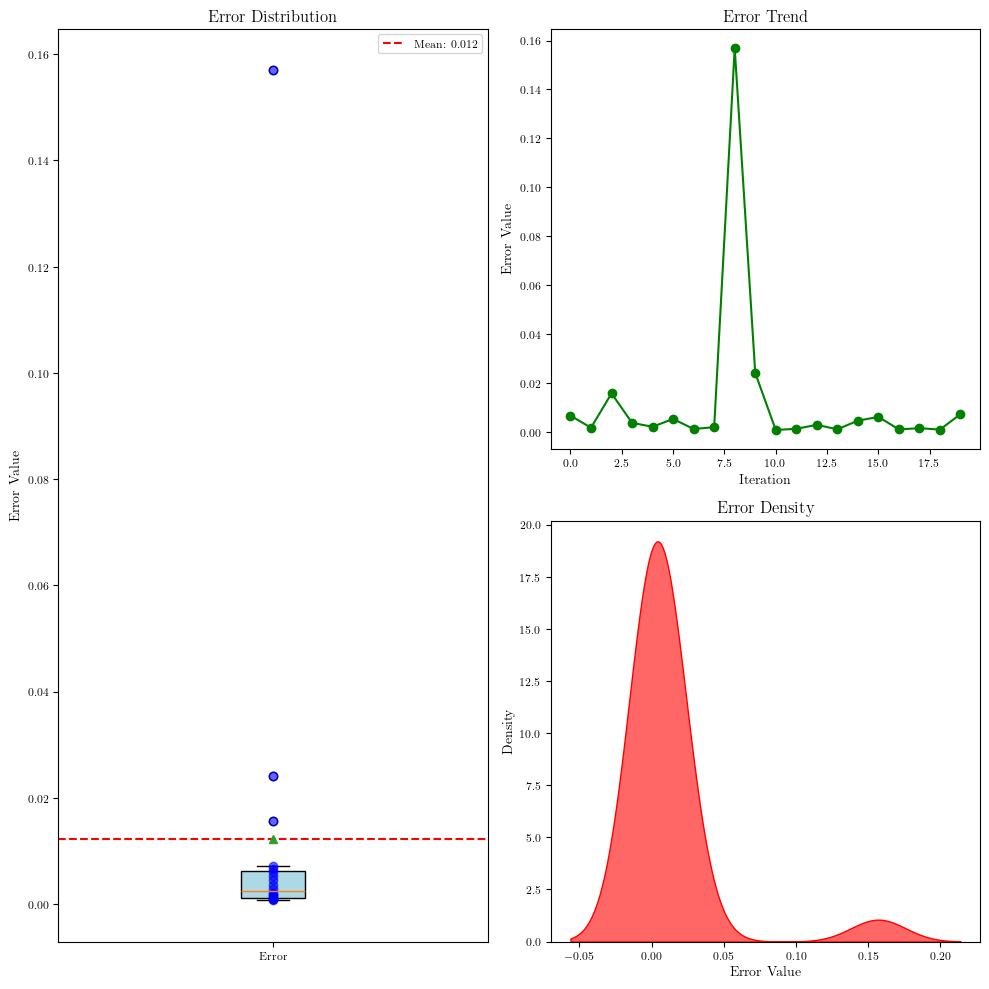

In [12]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5202765768338299, 0.5498189856925179, 0.8054262198745831, 0.2836623431751703, 0.7163985307835498, 0.8486951661259542, 0.45799139947295237, 1.0888879509613618, 0.18105234189218838, 0.5686642080465825]
error = error_u

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

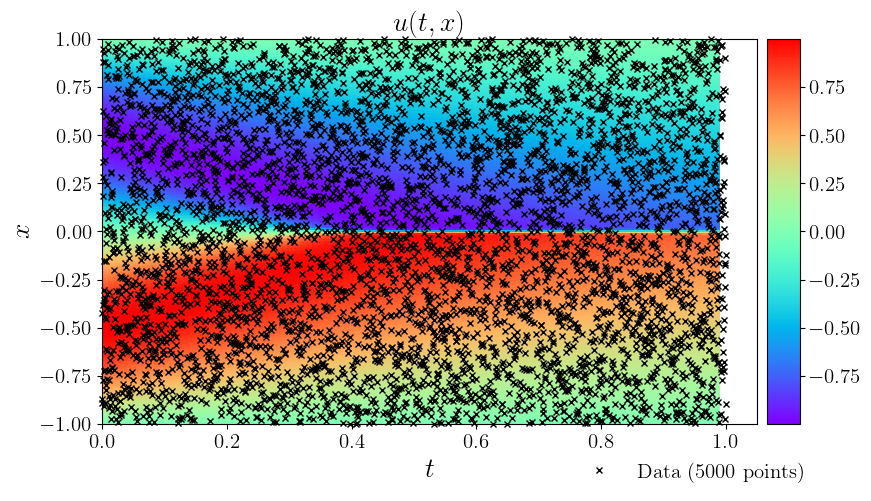

In [13]:
data = scipy.io.loadmat('../data/burgers_shock.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['t'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f_train[:,1], 
    X_f_train[:,0], 
    'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [14]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()

testerror = torch.stack(model.test_error).cpu().detach().numpy()

52380
[3.0539140e-01 2.9493666e-01 2.8522825e-01 ... 3.3063554e-06 3.3063554e-06
 3.3063554e-06]


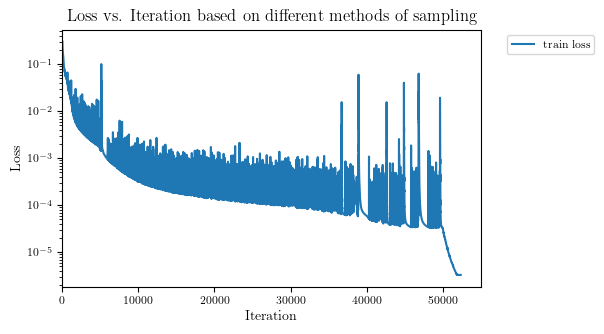

In [15]:
print(len(trainloss))
print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,55000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

52380
[1.0749516  1.0620707  1.049998   ... 0.00726004 0.00726004 0.00726004]


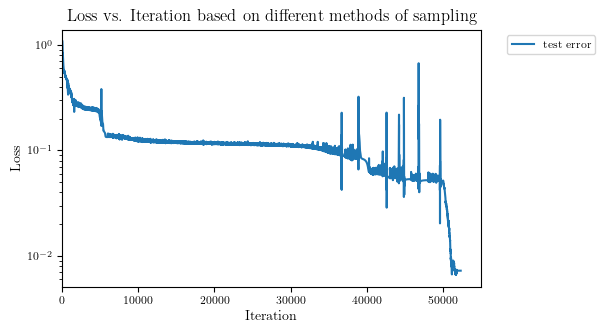

In [16]:
print(len(testerror))
print(testerror)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(testerror, label='test error')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,55000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


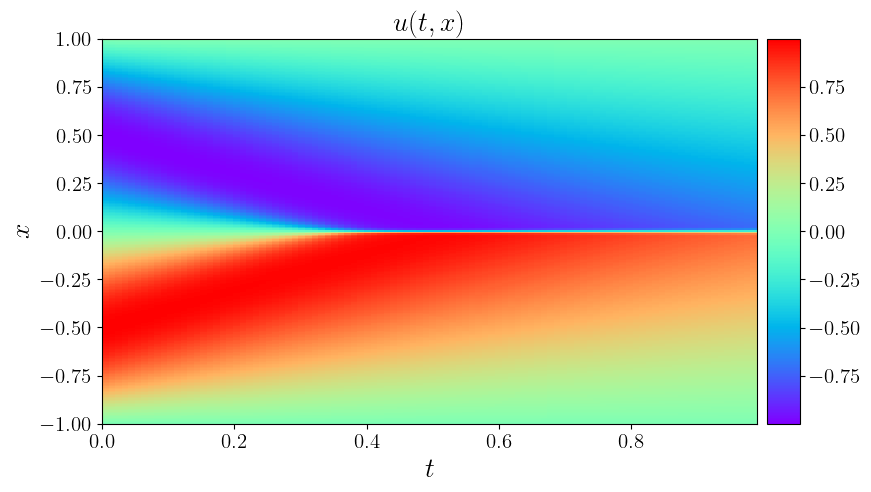

In [17]:
data = scipy.io.loadmat('../data/burgers_shock.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['t'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

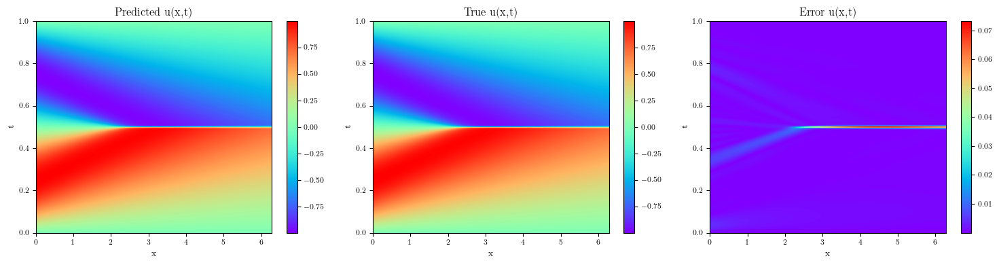

In [18]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()

In [19]:
#E(y)≈T1​t\=1∑T​NNt​(x) 
#Var(y)≈1T∑t\=1T\[NNt(x)−E(y)\]2Var(y) \\approx \\frac{1}{T} \\sum\_{t=1}^{T} \[NN\_t(x) - E(y)\]^2Var(y)≈T1​t\=1∑T​\[NNt​(x)−E(y)\]2
#计算训练好模型的不确定度（最后一个seed）
n_dropout = 10
U = []
for _ in range(n_dropout):
    u_pred = model.dropout_predict(X_star)
    U.append(u_pred)
#最后得到的U是是一个长度为n_dropout的列表，列表每个元素均为一个数组，数组的形状为(len(t)*len(x),1)，即每行是一个点的预测值
U = np.hstack(U) #按列堆叠数组，即将U中的每个数组按列合并，得到一个新的数组U，形状为(len(t)*len(x),n_dropout)，每行是一个点在MC dropout下前向传播n_dropout次得到的输出
u_means = np.mean(U, axis=1).reshape(-1,1) #对每一行（按列）求平均，每一行是E(y)（对应一个x），然后将其转换为二维数组(形状为(len(t)*len(x),1))
u_var = np.mean((U - u_means) ** 2, axis=1).reshape(-1,1) #对每一行（按列）求方差，每一行是Var(y)（对应一个x），然后将其转换为二维数组(形状为(len(t)*len(x),1))
#最后获得的u_var就相对于是每个点的不确定度

u_var_log = np.log(u_var + 1e-10) #对u_var取对数，然后加上一个很小的数，避免取对数时出现错误




#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_var = griddata(X_star, u_var.flatten(), (X, T), method='cubic')
U_var_log = griddata(X_star, u_var_log.flatten(), (X, T), method='cubic')

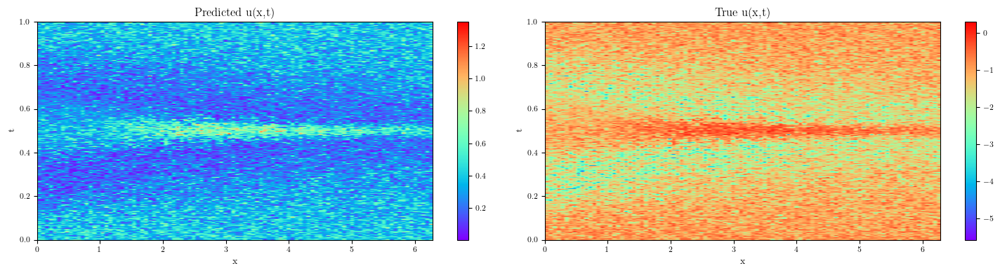

In [20]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 2, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_var.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_var_log.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()

In [21]:
#计算训练好模型的chaos（最后一个seed）
u_chaos = calculate_chaos(model, X_star, num_iter=50)
u_chaos_log = np.log(u_chaos + 1e-10) #对u_var取对数，然后加上一个很小的数，避免取对数时出现错误

#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_chaos = griddata(X_star, u_chaos.flatten(), (X, T), method='cubic')
U_chaos_log = griddata(X_star, u_chaos_log.flatten(), (X, T), method='cubic')

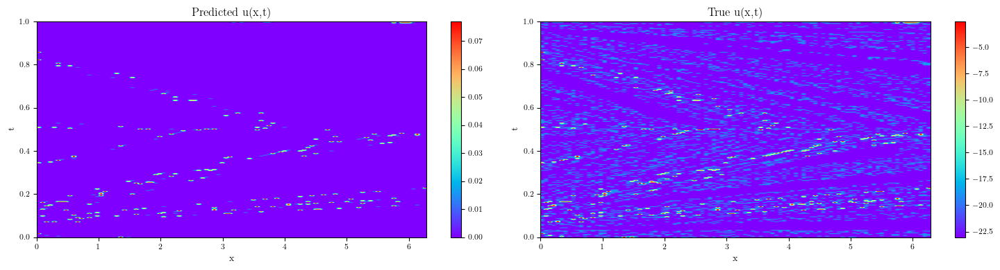

In [22]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 2, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_chaos.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_chaos_log.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()